In [1]:
%load_ext autoreload
%autoreload 2

from tqdm import tqdm
from segtok import tokenizer
from utils import *
import hickle

In [2]:
# Key Hyperparameters
enable_orig = "orig"
enable_aug = False
enable_aug3 = False
max_training_samples = 200000
max_tokenized_length = 64
num_sentences = 10
valid_percent = 0.01
sentence_pairs = False

batch_size_finetuning = 32
epochs_finetuning = 1
lr_finetuning = 1e-5

batch_size = 128
epochs = 20
main_model_lr = 1e-5

lstm_hidden_size = 1024
regressive_style_finetuning = False
lstm_bidi = False

experiment_id = f"test"

In [3]:
# Parameters
max_training_samples = 200000
enable_orig = "preprocess"
enable_aug = False
enable_aug3 = False
sentence_pairs = True
regressive_style_finetuning = False
lstm_bidi = False
lstm_hidden_size = 64
epochs = 20
experiment_id = "classification-sentence-embeddings-max_training_samples-200000-enable_orig-preprocess-enable_aug-False-enable_aug3-False-sentence_pairs-True-regressive_style_finetuning-False-lstm_bidi-False-lstm_hidden_size-64-epochs-20"


In [4]:
import os
experiment_dir = f"completed-experiments/{experiment_id}"
if not os.path.exists(experiment_dir):
    os.makedirs(experiment_dir)

In [5]:
from data_parsing import *
data = load_dataset("./yelp_review_training_dataset.jsonl")

In [6]:
from training_utils import split_train_validation
from text_preprocessing import preprocess
import random
from math import ceil

def get_train_valid():
    orig_data_uniform = split_equally(data, ceil(max_training_samples / 0.99))
    orig_train_x, valid_x, orig_train_y, valid_y = split_train_validation(orig_data_uniform, 0.01)
    train_x = []
    train_y = []

    if enable_aug:
        aug_data = load_gen_dataset("./new_data.json") + load_gen_dataset("./new_data2.json")
        train_x += [i[0] for i in aug_data]
        train_y += [i[1] for i in aug_data]

    if enable_aug3:
        aug_data3 = load_gen_dataset("./new_data3.json")
        train_x += [i[0] for i in aug_data3]
        train_y += [i[1] for i in aug_data3]
        
    if enable_orig:
        train_x += orig_train_x
        train_y += orig_train_y
    
    train_x = train_x[:max_training_samples]
    train_y = train_y[:max_training_samples]

    if enable_orig == "preprocess":
        train_x = preprocess(train_x)
        valid_x = preprocess(valid_x)    

    paired_train = list(zip(train_x, train_y))
    random.shuffle(paired_train)
    train_x = [i[0] for i in paired_train]
    train_y = [i[1] for i in paired_train]

    return [x.encode("utf-8") for x in train_x], [x.encode("utf-8") for x in valid_x], train_y, valid_y

split_key = f"cache-core/split-data-{valid_percent}-orig-{enable_orig}-aug12-{enable_aug}-aug3-{enable_aug3}-max-{max_training_samples}"
train_x, valid_x, train_y, valid_y = memo_load(
    get_train_valid,
    split_key
)
split_hash = hash_file(split_key + ".hkl")

train_x = [x.decode("utf-8") for x in train_x]
valid_x = [x.decode("utf-8") for x in valid_x]

print(len(train_x))

189419


In [7]:
print(len(train_x))
print(len(train_y))
print(len(valid_x))
print(len(valid_y))

189419
189419
1914
1914


In [8]:
import torch as th

device = th.device("cuda" if th.cuda.is_available() else "cpu")
print(device)

from spacy.lang.en import English
nlp = English()
nlp.add_pipe("sentencizer")

cuda


In [9]:
from transformers import BertTokenizerFast, BertForSequenceClassification
tokenizer = BertTokenizerFast.from_pretrained("bert-base-uncased")

In [10]:
# fine tune the BERT
import numpy as np

def get_finetuning_data():
    train_x_numerized = []
    train_x_mask = []
    train_y_per_sentence = []
    for i, text in tqdm(list(enumerate(train_x))):
        doc = nlp(text)
        sents = [str(sent) for sent in doc.sents]
        if sentence_pairs and len(sents) > 1:
            sents = [a + b for a, b in zip(sents, sents[1:])]
        for sentence in sents[:num_sentences]:
            tokenized = tokenizer(sentence, truncation=True, padding="max_length", max_length=max_tokenized_length)[0]
            train_x_numerized.append(tokenized.ids)
            train_x_mask.append(tokenized.attention_mask)
            train_y_per_sentence.append(train_y[i])

    valid_x_numerized = []
    valid_x_mask = []
    valid_y_per_sentence = []
    for i, text in tqdm(list(enumerate(valid_x))):
        doc = nlp(text)
        sents = [str(sent) for sent in doc.sents]
        if sentence_pairs and len(sents) > 1:
            sents = [a + b for a, b in zip(sents, sents[1:])]
        for sentence in sents[:num_sentences]:
            tokenized = tokenizer(sentence, truncation=True, padding="max_length", max_length=max_tokenized_length)[0]
            valid_x_numerized.append(tokenized.ids)
            valid_x_mask.append(tokenized.attention_mask)
            valid_y_per_sentence.append(valid_y[i])

    train_x_numerized = np.array(train_x_numerized)
    train_x_mask = np.array(train_x_mask)
    train_y_per_sentence = np.array(train_y_per_sentence)
    valid_x_numerized = np.array(valid_x_numerized)
    valid_x_mask = np.array(valid_x_mask)
    valid_y_per_sentence = np.array(valid_y_per_sentence)
    return train_x_numerized, train_x_mask, train_y_per_sentence, valid_x_numerized, valid_x_mask, valid_y_per_sentence

from utils import memo_load
finetuning_data_key = f"cache-core/training-data-finetuning-max-tokens-{max_tokenized_length}-split-{split_hash}"
if sentence_pairs:
    finetuning_data_key += "-pairs"
(train_x_numerized, train_x_mask, train_y_per_sentence, valid_x_numerized, valid_x_mask, valid_y_per_sentence) = memo_load(
    lambda: get_finetuning_data(),
    finetuning_data_key
)
finetuning_data_hash = hash_file(finetuning_data_key + ".hkl")

  0%|          | 0/189419 [00:00<?, ?it/s]

  0%|          | 48/189419 [00:00<06:51, 460.22it/s]

  0%|          | 113/189419 [00:00<05:34, 566.66it/s]

  0%|          | 178/189419 [00:00<05:13, 604.04it/s]

  0%|          | 249/189419 [00:00<04:54, 642.11it/s]

  0%|          | 324/189419 [00:00<04:38, 680.07it/s]

  0%|          | 409/189419 [00:00<04:18, 732.43it/s]

  0%|          | 490/189419 [00:00<04:09, 756.69it/s]

  0%|          | 575/189419 [00:00<04:00, 785.56it/s]

  0%|          | 660/189419 [00:00<03:55, 801.27it/s]

  0%|          | 759/189419 [00:01<03:40, 856.77it/s]

  0%|          | 847/189419 [00:01<03:38, 861.13it/s]

  0%|          | 934/189419 [00:01<03:41, 850.22it/s]

  1%|          | 1020/189419 [00:01<03:41, 850.38it/s]

  1%|          | 1107/189419 [00:01<03:40, 855.43it/s]

  1%|          | 1194/189419 [00:01<03:38, 859.48it/s]

  1%|          | 1280/189419 [00:01<03:41, 849.41it/s]

  1%|          | 1373/189419 [00:01<03:35, 872.92it/s]

  1%|          | 1463/189419 [00:01<03:33, 879.38it/s]

  1%|          | 1554/189419 [00:01<03:32, 883.04it/s]

  1%|          | 1649/189419 [00:02<03:28, 902.02it/s]

  1%|          | 1745/189419 [00:02<03:24, 919.02it/s]

  1%|          | 1840/189419 [00:02<03:22, 925.40it/s]

  1%|          | 1933/189419 [00:02<03:24, 915.38it/s]

  1%|          | 2030/189419 [00:02<03:21, 928.05it/s]

  1%|          | 2131/189419 [00:02<03:17, 949.52it/s]

  1%|          | 2226/189419 [00:02<03:18, 944.44it/s]

  1%|          | 2323/189419 [00:02<03:16, 950.56it/s]

  1%|▏         | 2424/189419 [00:02<03:14, 959.80it/s]

  1%|▏         | 2529/189419 [00:02<03:10, 983.19it/s]

  1%|▏         | 2629/189419 [00:03<03:10, 981.95it/s]

  1%|▏         | 2728/189419 [00:03<03:15, 954.27it/s]

  1%|▏         | 2827/189419 [00:03<03:13, 964.20it/s]

  2%|▏         | 2924/189419 [00:03<03:13, 964.86it/s]

  2%|▏         | 3025/189419 [00:03<03:11, 973.15it/s]

  2%|▏         | 3131/189419 [00:03<03:07, 994.92it/s]

  2%|▏         | 3231/189419 [00:03<03:08, 989.91it/s]

  2%|▏         | 3331/189419 [00:03<03:11, 972.81it/s]

  2%|▏         | 3429/189419 [00:03<03:14, 955.57it/s]

  2%|▏         | 3525/189419 [00:03<03:16, 947.99it/s]

  2%|▏         | 3629/189419 [00:04<03:10, 973.34it/s]

  2%|▏         | 3744/189419 [00:04<03:01, 1024.76it/s]

  2%|▏         | 3856/189419 [00:04<02:56, 1051.47it/s]

  2%|▏         | 3962/189419 [00:04<02:58, 1041.16it/s]

  2%|▏         | 4067/189419 [00:04<03:01, 1020.13it/s]

  2%|▏         | 4170/189419 [00:04<03:05, 998.26it/s] 

  2%|▏         | 4271/189419 [00:04<04:04, 757.60it/s]

  2%|▏         | 4372/189419 [00:04<03:46, 816.09it/s]

  2%|▏         | 4475/189419 [00:05<03:33, 865.43it/s]

  2%|▏         | 4581/189419 [00:05<03:21, 915.50it/s]

  2%|▏         | 4678/189419 [00:05<03:18, 929.76it/s]

  3%|▎         | 4782/189419 [00:05<03:12, 957.86it/s]

  3%|▎         | 4883/189419 [00:05<03:10, 971.19it/s]

  3%|▎         | 4995/189419 [00:05<03:02, 1010.37it/s]

  3%|▎         | 5098/189419 [00:05<03:11, 960.26it/s] 

  3%|▎         | 5205/189419 [00:05<03:06, 989.65it/s]

  3%|▎         | 5307/189419 [00:05<03:04, 997.94it/s]

  3%|▎         | 5408/189419 [00:05<03:06, 987.53it/s]

  3%|▎         | 5508/189419 [00:06<03:05, 990.02it/s]

  3%|▎         | 5608/189419 [00:06<03:11, 962.27it/s]

  3%|▎         | 5717/189419 [00:06<03:04, 997.47it/s]

  3%|▎         | 5818/189419 [00:06<03:05, 990.68it/s]

  3%|▎         | 5926/189419 [00:06<03:00, 1016.57it/s]

  3%|▎         | 6033/189419 [00:06<02:57, 1030.32it/s]

  3%|▎         | 6137/189419 [00:06<03:02, 1004.21it/s]

  3%|▎         | 6244/189419 [00:06<02:59, 1022.98it/s]

  3%|▎         | 6357/189419 [00:06<02:54, 1051.86it/s]

  3%|▎         | 6463/189419 [00:06<02:57, 1030.54it/s]

  3%|▎         | 6567/189419 [00:07<02:59, 1021.27it/s]

  4%|▎         | 6670/189419 [00:07<03:01, 1004.77it/s]

  4%|▎         | 6783/189419 [00:07<02:55, 1040.91it/s]

  4%|▎         | 6888/189419 [00:07<02:56, 1031.56it/s]

  4%|▎         | 6992/189419 [00:07<02:58, 1021.78it/s]

  4%|▍         | 7105/189419 [00:07<02:53, 1053.21it/s]

  4%|▍         | 7211/189419 [00:07<02:53, 1052.31it/s]

  4%|▍         | 7323/189419 [00:07<02:50, 1070.65it/s]

  4%|▍         | 7431/189419 [00:07<02:52, 1053.43it/s]

  4%|▍         | 7540/189419 [00:08<02:51, 1062.48it/s]

  4%|▍         | 7647/189419 [00:08<02:51, 1057.09it/s]

  4%|▍         | 7753/189419 [00:08<02:57, 1020.75it/s]

  4%|▍         | 7857/189419 [00:08<02:57, 1025.37it/s]

  4%|▍         | 7964/189419 [00:08<02:54, 1037.93it/s]

  4%|▍         | 8068/189419 [00:08<02:55, 1034.86it/s]

  4%|▍         | 8172/189419 [00:08<02:57, 1018.61it/s]

  4%|▍         | 8275/189419 [00:08<02:57, 1020.08it/s]

  4%|▍         | 8380/189419 [00:08<02:56, 1028.26it/s]

  4%|▍         | 8483/189419 [00:08<02:57, 1017.73it/s]

  5%|▍         | 8585/189419 [00:09<02:58, 1013.61it/s]

  5%|▍         | 8687/189419 [00:09<03:00, 1003.75it/s]

  5%|▍         | 8788/189419 [00:09<03:02, 988.77it/s] 

  5%|▍         | 8896/189419 [00:09<02:58, 1013.68it/s]

  5%|▍         | 8998/189419 [00:09<02:59, 1004.26it/s]

  5%|▍         | 9099/189419 [00:09<03:02, 988.42it/s] 

  5%|▍         | 9210/189419 [00:09<02:56, 1023.64it/s]

  5%|▍         | 9317/189419 [00:09<02:53, 1037.07it/s]

  5%|▍         | 9421/189419 [00:09<02:56, 1020.10it/s]

  5%|▌         | 9524/189419 [00:09<02:57, 1015.79it/s]

  5%|▌         | 9627/189419 [00:10<02:57, 1013.99it/s]

  5%|▌         | 9729/189419 [00:10<02:57, 1011.02it/s]

  5%|▌         | 9834/189419 [00:10<02:56, 1019.99it/s]

  5%|▌         | 9938/189419 [00:10<02:55, 1022.30it/s]

  5%|▌         | 10041/189419 [00:10<03:03, 980.17it/s]

  5%|▌         | 10145/189419 [00:10<03:00, 995.23it/s]

  5%|▌         | 10249/189419 [00:10<02:57, 1008.16it/s]

  5%|▌         | 10355/189419 [00:10<02:55, 1022.76it/s]

  6%|▌         | 10458/189419 [00:10<02:55, 1018.14it/s]

  6%|▌         | 10562/189419 [00:10<02:54, 1022.10it/s]

  6%|▌         | 10670/189419 [00:11<02:52, 1037.50it/s]

  6%|▌         | 10774/189419 [00:11<02:53, 1031.57it/s]

  6%|▌         | 10879/189419 [00:11<02:52, 1034.34it/s]

  6%|▌         | 10983/189419 [00:11<02:55, 1018.60it/s]

  6%|▌         | 11093/189419 [00:11<02:52, 1035.08it/s]

  6%|▌         | 11197/189419 [00:11<02:54, 1020.68it/s]

  6%|▌         | 11300/189419 [00:11<02:55, 1017.16it/s]

  6%|▌         | 11405/189419 [00:11<02:53, 1026.16it/s]

  6%|▌         | 11511/189419 [00:11<02:51, 1035.03it/s]

  6%|▌         | 11617/189419 [00:12<02:51, 1036.18it/s]

  6%|▌         | 11723/189419 [00:12<02:50, 1041.61it/s]

  6%|▌         | 11834/189419 [00:12<02:47, 1058.26it/s]

  6%|▋         | 11940/189419 [00:12<02:48, 1054.22it/s]

  6%|▋         | 12046/189419 [00:12<02:54, 1018.21it/s]

  6%|▋         | 12149/189419 [00:12<02:57, 1001.50it/s]

  6%|▋         | 12263/189419 [00:12<02:50, 1041.20it/s]

  7%|▋         | 12368/189419 [00:12<02:52, 1026.63it/s]

  7%|▋         | 12473/189419 [00:12<02:51, 1030.67it/s]

  7%|▋         | 12594/189419 [00:12<02:43, 1081.53it/s]

  7%|▋         | 12710/189419 [00:13<02:40, 1102.83it/s]

  7%|▋         | 12821/189419 [00:13<04:05, 719.64it/s] 

  7%|▋         | 12926/189419 [00:13<03:43, 790.51it/s]

  7%|▋         | 13036/189419 [00:13<03:24, 861.38it/s]

  7%|▋         | 13145/189419 [00:13<03:12, 915.61it/s]

  7%|▋         | 13256/189419 [00:13<03:02, 963.17it/s]

  7%|▋         | 13364/189419 [00:13<02:56, 994.76it/s]

  7%|▋         | 13470/189419 [00:13<02:53, 1012.25it/s]

  7%|▋         | 13576/189419 [00:14<02:56, 998.44it/s] 

  7%|▋         | 13679/189419 [00:14<03:00, 972.78it/s]

  7%|▋         | 13794/189419 [00:14<02:51, 1022.10it/s]

  7%|▋         | 13909/189419 [00:14<02:45, 1057.59it/s]

  7%|▋         | 14017/189419 [00:14<02:47, 1046.73it/s]

  7%|▋         | 14130/189419 [00:14<02:43, 1070.78it/s]

  8%|▊         | 14238/189419 [00:14<02:47, 1042.76it/s]

  8%|▊         | 14343/189419 [00:14<02:47, 1042.14it/s]

  8%|▊         | 14450/189419 [00:14<02:46, 1047.82it/s]

  8%|▊         | 14563/189419 [00:14<02:43, 1070.33it/s]

  8%|▊         | 14671/189419 [00:15<02:45, 1055.41it/s]

  8%|▊         | 14782/189419 [00:15<02:43, 1069.33it/s]

  8%|▊         | 14897/189419 [00:15<02:39, 1092.69it/s]

  8%|▊         | 15007/189419 [00:15<02:42, 1072.04it/s]

  8%|▊         | 15115/189419 [00:15<02:47, 1040.10it/s]

  8%|▊         | 15221/189419 [00:15<02:46, 1044.62it/s]

  8%|▊         | 15326/189419 [00:15<02:48, 1031.26it/s]

  8%|▊         | 15435/189419 [00:15<02:46, 1043.98it/s]

  8%|▊         | 15545/189419 [00:15<02:43, 1060.27it/s]

  8%|▊         | 15662/189419 [00:15<02:40, 1083.91it/s]

  8%|▊         | 15771/189419 [00:16<02:42, 1069.89it/s]

  8%|▊         | 15879/189419 [00:16<02:45, 1049.59it/s]

  8%|▊         | 15989/189419 [00:16<02:43, 1059.01it/s]

  9%|▊         | 16101/189419 [00:16<02:41, 1074.48it/s]

  9%|▊         | 16213/189419 [00:16<02:40, 1082.45it/s]

  9%|▊         | 16322/189419 [00:16<02:41, 1074.93it/s]

  9%|▊         | 16434/189419 [00:16<02:39, 1083.60it/s]

  9%|▊         | 16543/189419 [00:16<02:46, 1038.62it/s]

  9%|▉         | 16648/189419 [00:16<02:48, 1024.16it/s]

  9%|▉         | 16755/189419 [00:17<02:46, 1037.27it/s]

  9%|▉         | 16859/189419 [00:17<02:47, 1032.42it/s]

  9%|▉         | 16972/189419 [00:17<02:42, 1060.45it/s]

  9%|▉         | 17079/189419 [00:17<02:43, 1054.37it/s]

  9%|▉         | 17185/189419 [00:17<02:44, 1044.64it/s]

  9%|▉         | 17299/189419 [00:17<02:40, 1070.58it/s]

  9%|▉         | 17407/189419 [00:17<02:40, 1069.82it/s]

  9%|▉         | 17519/189419 [00:17<02:38, 1083.42it/s]

  9%|▉         | 17628/189419 [00:17<02:45, 1036.82it/s]

  9%|▉         | 17740/189419 [00:17<02:41, 1060.78it/s]

  9%|▉         | 17856/189419 [00:18<02:37, 1088.57it/s]

  9%|▉         | 17966/189419 [00:18<02:38, 1082.04it/s]

 10%|▉         | 18087/189419 [00:18<02:33, 1118.58it/s]

 10%|▉         | 18200/189419 [00:18<02:35, 1097.99it/s]

 10%|▉         | 18311/189419 [00:18<02:36, 1090.12it/s]

 10%|▉         | 18425/189419 [00:18<02:35, 1101.08it/s]

 10%|▉         | 18536/189419 [00:18<02:35, 1101.98it/s]

 10%|▉         | 18655/189419 [00:18<02:32, 1122.97it/s]

 10%|▉         | 18768/189419 [00:18<02:31, 1122.79it/s]

 10%|▉         | 18881/189419 [00:18<02:32, 1119.80it/s]

 10%|█         | 18994/189419 [00:19<02:34, 1101.66it/s]

 10%|█         | 19105/189419 [00:19<02:41, 1056.32it/s]

 10%|█         | 19212/189419 [00:19<02:43, 1043.48it/s]

 10%|█         | 19317/189419 [00:19<02:44, 1031.95it/s]

 10%|█         | 19429/189419 [00:19<02:41, 1055.58it/s]

 10%|█         | 19557/189419 [00:19<02:31, 1120.27it/s]

 10%|█         | 19672/189419 [00:19<02:30, 1128.16it/s]

 10%|█         | 19786/189419 [00:19<02:32, 1113.32it/s]

 11%|█         | 19904/189419 [00:19<02:29, 1131.39it/s]

 11%|█         | 20018/189419 [00:20<02:35, 1089.83it/s]

 11%|█         | 20128/189419 [00:20<02:38, 1065.69it/s]

 11%|█         | 20251/189419 [00:20<02:32, 1112.29it/s]

 11%|█         | 20363/189419 [00:20<02:31, 1113.61it/s]

 11%|█         | 20475/189419 [00:20<02:39, 1058.82it/s]

 11%|█         | 20583/189419 [00:20<02:38, 1064.62it/s]

 11%|█         | 20698/189419 [00:20<02:35, 1087.57it/s]

 11%|█         | 20808/189419 [00:20<02:36, 1078.76it/s]

 11%|█         | 20917/189419 [00:20<02:39, 1057.75it/s]

 11%|█         | 21033/189419 [00:20<02:35, 1086.16it/s]

 11%|█         | 21143/189419 [00:21<02:34, 1087.56it/s]

 11%|█         | 21252/189419 [00:21<02:35, 1084.31it/s]

 11%|█▏        | 21361/189419 [00:21<04:15, 657.21it/s] 

 11%|█▏        | 21471/189419 [00:21<03:44, 747.02it/s]

 11%|█▏        | 21574/189419 [00:21<03:28, 806.74it/s]

 11%|█▏        | 21685/189419 [00:21<03:11, 877.16it/s]

 12%|█▏        | 21791/189419 [00:21<03:01, 921.16it/s]

 12%|█▏        | 21897/189419 [00:22<02:55, 956.98it/s]

 12%|█▏        | 22009/189419 [00:22<02:47, 1000.79it/s]

 12%|█▏        | 22115/189419 [00:22<02:51, 976.87it/s] 

 12%|█▏        | 22220/189419 [00:22<02:47, 996.47it/s]

 12%|█▏        | 22323/189419 [00:22<02:46, 1004.65it/s]

 12%|█▏        | 22426/189419 [00:22<02:46, 1005.14it/s]

 12%|█▏        | 22528/189419 [00:22<02:48, 992.19it/s] 

 12%|█▏        | 22652/189419 [00:22<02:37, 1061.83it/s]

 12%|█▏        | 22760/189419 [00:22<02:40, 1035.57it/s]

 12%|█▏        | 22865/189419 [00:22<02:44, 1013.06it/s]

 12%|█▏        | 22967/189419 [00:23<02:48, 989.95it/s] 

 12%|█▏        | 23070/189419 [00:23<02:46, 998.40it/s]

 12%|█▏        | 23171/189419 [00:23<02:47, 995.28it/s]

 12%|█▏        | 23289/189419 [00:23<02:39, 1044.25it/s]

 12%|█▏        | 23399/189419 [00:23<02:37, 1054.60it/s]

 12%|█▏        | 23505/189419 [00:23<02:37, 1053.61it/s]

 12%|█▏        | 23611/189419 [00:23<02:38, 1047.72it/s]

 13%|█▎        | 23716/189419 [00:23<02:39, 1040.16it/s]

 13%|█▎        | 23837/189419 [00:23<02:32, 1087.08it/s]

 13%|█▎        | 23952/189419 [00:23<02:30, 1100.72it/s]

 13%|█▎        | 24063/189419 [00:24<02:30, 1095.74it/s]

 13%|█▎        | 24174/189419 [00:24<02:30, 1099.67it/s]

 13%|█▎        | 24285/189419 [00:24<02:31, 1089.05it/s]

 13%|█▎        | 24394/189419 [00:24<02:35, 1060.08it/s]

 13%|█▎        | 24501/189419 [00:24<02:36, 1056.10it/s]

 13%|█▎        | 24609/189419 [00:24<02:35, 1060.21it/s]

 13%|█▎        | 24716/189419 [00:24<02:36, 1053.67it/s]

 13%|█▎        | 24825/189419 [00:24<02:34, 1062.13it/s]

 13%|█▎        | 24932/189419 [00:24<02:36, 1049.50it/s]

 13%|█▎        | 25044/189419 [00:25<02:33, 1068.56it/s]

 13%|█▎        | 25151/189419 [00:25<02:38, 1035.90it/s]

 13%|█▎        | 25276/189419 [00:25<02:30, 1092.94it/s]

 13%|█▎        | 25390/189419 [00:25<02:28, 1104.89it/s]

 13%|█▎        | 25501/189419 [00:25<02:33, 1066.34it/s]

 14%|█▎        | 25621/189419 [00:25<02:28, 1100.33it/s]

 14%|█▎        | 25735/189419 [00:25<02:27, 1109.41it/s]

 14%|█▎        | 25847/189419 [00:25<02:32, 1075.72it/s]

 14%|█▎        | 25969/189419 [00:25<02:26, 1115.72it/s]

 14%|█▍        | 26081/189419 [00:25<02:29, 1092.07it/s]

 14%|█▍        | 26193/189419 [00:26<02:28, 1098.59it/s]

 14%|█▍        | 26308/189419 [00:26<02:26, 1109.81it/s]

 14%|█▍        | 26420/189419 [00:26<02:32, 1068.34it/s]

 14%|█▍        | 26532/189419 [00:26<02:30, 1079.19it/s]

 14%|█▍        | 26641/189419 [00:26<02:33, 1060.24it/s]

 14%|█▍        | 26748/189419 [00:26<02:33, 1061.11it/s]

 14%|█▍        | 26855/189419 [00:26<02:34, 1053.65it/s]

 14%|█▍        | 26964/189419 [00:26<02:32, 1063.81it/s]

 14%|█▍        | 27075/189419 [00:26<02:31, 1074.89it/s]

 14%|█▍        | 27195/189419 [00:26<02:26, 1110.72it/s]

 14%|█▍        | 27307/189419 [00:27<02:28, 1094.33it/s]

 14%|█▍        | 27417/189419 [00:27<02:28, 1094.56it/s]

 15%|█▍        | 27527/189419 [00:27<02:29, 1081.12it/s]

 15%|█▍        | 27638/189419 [00:27<02:28, 1089.46it/s]

 15%|█▍        | 27750/189419 [00:27<02:27, 1095.40it/s]

 15%|█▍        | 27860/189419 [00:27<02:33, 1052.85it/s]

 15%|█▍        | 27966/189419 [00:27<02:33, 1051.65it/s]

 15%|█▍        | 28072/189419 [00:27<02:33, 1051.06it/s]

 15%|█▍        | 28178/189419 [00:27<02:34, 1045.90it/s]

 15%|█▍        | 28293/189419 [00:28<02:29, 1076.28it/s]

 15%|█▍        | 28405/189419 [00:28<02:28, 1086.60it/s]

 15%|█▌        | 28514/189419 [00:28<02:31, 1063.49it/s]

 15%|█▌        | 28621/189419 [00:28<02:32, 1051.59it/s]

 15%|█▌        | 28732/189419 [00:28<02:30, 1068.57it/s]

 15%|█▌        | 28839/189419 [00:28<02:30, 1067.99it/s]

 15%|█▌        | 28946/189419 [00:28<02:30, 1067.64it/s]

 15%|█▌        | 29053/189419 [00:28<02:30, 1066.44it/s]

 15%|█▌        | 29160/189419 [00:28<02:30, 1064.97it/s]

 15%|█▌        | 29274/189419 [00:28<02:27, 1086.92it/s]

 16%|█▌        | 29383/189419 [00:29<02:28, 1075.07it/s]

 16%|█▌        | 29496/189419 [00:29<02:27, 1085.75it/s]

 16%|█▌        | 29605/189419 [00:29<02:30, 1062.03it/s]

 16%|█▌        | 29712/189419 [00:29<02:32, 1045.57it/s]

 16%|█▌        | 29826/189419 [00:29<02:29, 1071.08it/s]

 16%|█▌        | 29944/189419 [00:29<02:24, 1100.40it/s]

 16%|█▌        | 30056/189419 [00:29<02:24, 1105.77it/s]

 16%|█▌        | 30167/189419 [00:29<02:25, 1093.26it/s]

 16%|█▌        | 30277/189419 [00:29<02:27, 1077.28it/s]

 16%|█▌        | 30385/189419 [00:29<02:29, 1065.91it/s]

 16%|█▌        | 30492/189419 [00:30<02:29, 1060.59it/s]

 16%|█▌        | 30601/189419 [00:30<02:28, 1068.37it/s]

 16%|█▌        | 30717/189419 [00:30<02:25, 1093.60it/s]

 16%|█▋        | 30827/189419 [00:30<02:29, 1062.30it/s]

 16%|█▋        | 30946/189419 [00:30<02:24, 1095.46it/s]

 16%|█▋        | 31056/189419 [00:30<02:27, 1074.93it/s]

 16%|█▋        | 31175/189419 [00:30<02:24, 1093.09it/s]

 17%|█▋        | 31285/189419 [00:30<02:28, 1066.49it/s]

 17%|█▋        | 31397/189419 [00:30<02:26, 1080.75it/s]

 17%|█▋        | 31519/189419 [00:31<02:21, 1119.65it/s]

 17%|█▋        | 31632/189419 [00:31<02:25, 1085.24it/s]

 17%|█▋        | 31741/189419 [00:31<02:26, 1073.14it/s]

 17%|█▋        | 31851/189419 [00:31<02:26, 1075.71it/s]

 17%|█▋        | 31959/189419 [00:31<02:28, 1056.87it/s]

 17%|█▋        | 32065/189419 [00:31<04:37, 567.01it/s] 

 17%|█▋        | 32165/189419 [00:31<04:04, 644.46it/s]

 17%|█▋        | 32272/189419 [00:32<03:35, 730.63it/s]

 17%|█▋        | 32375/189419 [00:32<03:16, 797.56it/s]

 17%|█▋        | 32493/189419 [00:32<02:56, 890.44it/s]

 17%|█▋        | 32596/189419 [00:32<02:49, 925.71it/s]

 17%|█▋        | 32699/189419 [00:32<02:46, 941.55it/s]

 17%|█▋        | 32801/189419 [00:32<02:43, 956.68it/s]

 17%|█▋        | 32908/189419 [00:32<02:38, 987.21it/s]

 17%|█▋        | 33016/189419 [00:32<02:34, 1012.59it/s]

 17%|█▋        | 33128/189419 [00:32<02:29, 1042.03it/s]

 18%|█▊        | 33235/189419 [00:32<02:33, 1017.29it/s]

 18%|█▊        | 33339/189419 [00:33<02:32, 1022.40it/s]

 18%|█▊        | 33443/189419 [00:33<02:34, 1009.27it/s]

 18%|█▊        | 33549/189419 [00:33<02:32, 1022.85it/s]

 18%|█▊        | 33660/189419 [00:33<02:28, 1047.22it/s]

 18%|█▊        | 33766/189419 [00:33<02:28, 1044.66it/s]

 18%|█▊        | 33890/189419 [00:33<02:21, 1100.22it/s]

 18%|█▊        | 34001/189419 [00:33<02:23, 1083.08it/s]

 18%|█▊        | 34110/189419 [00:33<02:25, 1070.56it/s]

 18%|█▊        | 34224/189419 [00:33<02:23, 1082.94it/s]

 18%|█▊        | 34355/189419 [00:33<02:14, 1148.86it/s]

 18%|█▊        | 34471/189419 [00:34<02:18, 1122.29it/s]

 18%|█▊        | 34585/189419 [00:34<02:17, 1127.33it/s]

 18%|█▊        | 34698/189419 [00:34<02:18, 1120.91it/s]

 18%|█▊        | 34811/189419 [00:34<02:20, 1097.73it/s]

 18%|█▊        | 34921/189419 [00:34<02:21, 1094.42it/s]

 18%|█▊        | 35031/189419 [00:34<02:25, 1059.34it/s]

 19%|█▊        | 35139/189419 [00:34<02:24, 1064.63it/s]

 19%|█▊        | 35247/189419 [00:34<02:24, 1068.75it/s]

 19%|█▊        | 35369/189419 [00:34<02:18, 1112.99it/s]

 19%|█▊        | 35481/189419 [00:35<02:24, 1068.35it/s]

 19%|█▉        | 35589/189419 [00:35<02:25, 1055.51it/s]

 19%|█▉        | 35703/189419 [00:35<02:22, 1077.78it/s]

 19%|█▉        | 35813/189419 [00:35<02:21, 1082.00it/s]

 19%|█▉        | 35922/189419 [00:35<02:22, 1078.03it/s]

 19%|█▉        | 36030/189419 [00:35<02:24, 1065.03it/s]

 19%|█▉        | 36140/189419 [00:35<02:22, 1071.88it/s]

 19%|█▉        | 36250/189419 [00:35<02:22, 1076.65it/s]

 19%|█▉        | 36358/189419 [00:35<02:24, 1057.74it/s]

 19%|█▉        | 36464/189419 [00:35<02:25, 1050.93it/s]

 19%|█▉        | 36570/189419 [00:36<02:27, 1037.02it/s]

 19%|█▉        | 36681/189419 [00:36<02:24, 1056.34it/s]

 19%|█▉        | 36787/189419 [00:36<02:25, 1051.23it/s]

 19%|█▉        | 36893/189419 [00:36<02:25, 1046.76it/s]

 20%|█▉        | 36998/189419 [00:36<02:27, 1034.28it/s]

 20%|█▉        | 37110/189419 [00:36<02:24, 1056.06it/s]

 20%|█▉        | 37216/189419 [00:36<02:24, 1050.88it/s]

 20%|█▉        | 37322/189419 [00:36<02:26, 1040.59it/s]

 20%|█▉        | 37445/189419 [00:36<02:18, 1094.59it/s]

 20%|█▉        | 37559/189419 [00:36<02:17, 1101.60it/s]

 20%|█▉        | 37670/189419 [00:37<02:22, 1062.38it/s]

 20%|█▉        | 37787/189419 [00:37<02:18, 1093.05it/s]

 20%|██        | 37902/189419 [00:37<02:16, 1108.69it/s]

 20%|██        | 38014/189419 [00:37<02:20, 1078.34it/s]

 20%|██        | 38123/189419 [00:37<02:22, 1061.31it/s]

 20%|██        | 38230/189419 [00:37<02:23, 1053.74it/s]

 20%|██        | 38336/189419 [00:37<02:25, 1040.51it/s]

 20%|██        | 38445/189419 [00:37<02:23, 1053.75it/s]

 20%|██        | 38551/189419 [00:37<02:24, 1047.69it/s]

 20%|██        | 38657/189419 [00:38<02:23, 1050.37it/s]

 20%|██        | 38763/189419 [00:38<02:25, 1035.64it/s]

 21%|██        | 38873/189419 [00:38<02:23, 1049.84it/s]

 21%|██        | 38979/189419 [00:38<02:26, 1024.01it/s]

 21%|██        | 39091/189419 [00:38<02:22, 1051.33it/s]

 21%|██        | 39202/189419 [00:38<02:20, 1067.26it/s]

 21%|██        | 39309/189419 [00:38<02:22, 1052.28it/s]

 21%|██        | 39415/189419 [00:38<02:26, 1026.77it/s]

 21%|██        | 39518/189419 [00:38<02:28, 1006.29it/s]

 21%|██        | 39619/189419 [00:38<02:29, 1002.85it/s]

 21%|██        | 39728/189419 [00:39<02:26, 1024.80it/s]

 21%|██        | 39836/189419 [00:39<02:23, 1040.34it/s]

 21%|██        | 39941/189419 [00:39<02:27, 1015.85it/s]

 21%|██        | 40043/189419 [00:39<02:27, 1015.08it/s]

 21%|██        | 40150/189419 [00:39<02:25, 1028.54it/s]

 21%|██▏       | 40263/189419 [00:39<02:21, 1056.33it/s]

 21%|██▏       | 40377/189419 [00:39<02:17, 1080.51it/s]

 21%|██▏       | 40510/189419 [00:39<02:09, 1152.95it/s]

 21%|██▏       | 40628/189419 [00:39<02:08, 1160.11it/s]

 22%|██▏       | 40745/189419 [00:39<02:10, 1137.85it/s]

 22%|██▏       | 40859/189419 [00:40<02:11, 1132.48it/s]

 22%|██▏       | 40984/189419 [00:40<02:07, 1166.53it/s]

 22%|██▏       | 41115/189419 [00:40<02:03, 1202.75it/s]

 22%|██▏       | 41236/189419 [00:40<02:05, 1183.84it/s]

 22%|██▏       | 41355/189419 [00:40<02:08, 1153.37it/s]

 22%|██▏       | 41479/189419 [00:40<02:05, 1176.79it/s]

 22%|██▏       | 41597/189419 [00:40<02:08, 1149.66it/s]

 22%|██▏       | 41713/189419 [00:40<02:09, 1142.84it/s]

 22%|██▏       | 41829/189419 [00:40<02:08, 1144.60it/s]

 22%|██▏       | 41944/189419 [00:41<02:10, 1132.19it/s]

 22%|██▏       | 42058/189419 [00:41<02:11, 1123.29it/s]

 22%|██▏       | 42177/189419 [00:41<02:09, 1139.28it/s]

 22%|██▏       | 42297/189419 [00:41<02:07, 1153.95it/s]

 22%|██▏       | 42413/189419 [00:41<02:07, 1152.54it/s]

 22%|██▏       | 42529/189419 [00:41<02:08, 1139.36it/s]

 23%|██▎       | 42643/189419 [00:41<02:12, 1106.27it/s]

 23%|██▎       | 42754/189419 [00:41<02:15, 1084.62it/s]

 23%|██▎       | 42875/189419 [00:41<02:10, 1119.97it/s]

 23%|██▎       | 42996/189419 [00:41<02:08, 1142.96it/s]

 23%|██▎       | 43113/189419 [00:42<02:07, 1147.87it/s]

 23%|██▎       | 43230/189419 [00:42<02:07, 1149.04it/s]

 23%|██▎       | 43346/189419 [00:42<02:08, 1138.92it/s]

 23%|██▎       | 43460/189419 [00:42<02:09, 1124.61it/s]

 23%|██▎       | 43573/189419 [00:42<02:12, 1099.37it/s]

 23%|██▎       | 43685/189419 [00:42<02:11, 1104.90it/s]

 23%|██▎       | 43801/189419 [00:42<02:09, 1120.36it/s]

 23%|██▎       | 43915/189419 [00:42<02:09, 1124.56it/s]

 23%|██▎       | 44030/189419 [00:42<02:08, 1129.56it/s]

 23%|██▎       | 44147/189419 [00:42<02:07, 1139.60it/s]

 23%|██▎       | 44272/189419 [00:43<02:04, 1169.58it/s]

 23%|██▎       | 44390/189419 [00:43<02:06, 1145.63it/s]

 23%|██▎       | 44511/189419 [00:43<02:04, 1163.34it/s]

 24%|██▎       | 44628/189419 [00:43<02:05, 1157.19it/s]

 24%|██▎       | 44755/189419 [00:43<02:01, 1189.04it/s]

 24%|██▎       | 44875/189419 [00:43<02:04, 1159.82it/s]

 24%|██▍       | 44992/189419 [00:44<04:27, 539.86it/s] 

 24%|██▍       | 45093/189419 [00:44<03:54, 615.49it/s]

 24%|██▍       | 45210/189419 [00:44<03:20, 718.13it/s]

 24%|██▍       | 45319/189419 [00:44<03:00, 796.48it/s]

 24%|██▍       | 45437/189419 [00:44<02:42, 885.09it/s]

 24%|██▍       | 45558/189419 [00:44<02:29, 964.29it/s]

 24%|██▍       | 45679/189419 [00:44<02:20, 1026.25it/s]

 24%|██▍       | 45793/189419 [00:44<02:16, 1050.64it/s]

 24%|██▍       | 45906/189419 [00:44<02:14, 1065.60it/s]

 24%|██▍       | 46031/189419 [00:44<02:08, 1113.45it/s]

 24%|██▍       | 46147/189419 [00:45<02:11, 1092.20it/s]

 24%|██▍       | 46266/189419 [00:45<02:07, 1119.69it/s]

 24%|██▍       | 46385/189419 [00:45<02:05, 1139.49it/s]

 25%|██▍       | 46501/189419 [00:45<02:04, 1144.26it/s]

 25%|██▍       | 46617/189419 [00:45<02:07, 1124.26it/s]

 25%|██▍       | 46731/189419 [00:45<02:07, 1120.57it/s]

 25%|██▍       | 46844/189419 [00:45<02:08, 1112.78it/s]

 25%|██▍       | 46966/189419 [00:45<02:04, 1139.89it/s]

 25%|██▍       | 47084/189419 [00:45<02:04, 1144.45it/s]

 25%|██▍       | 47202/189419 [00:46<02:03, 1153.62it/s]

 25%|██▍       | 47318/189419 [00:46<02:06, 1122.19it/s]

 25%|██▌       | 47431/189419 [00:46<02:07, 1114.39it/s]

 25%|██▌       | 47543/189419 [00:46<02:08, 1107.64it/s]

 25%|██▌       | 47654/189419 [00:46<02:09, 1097.04it/s]

 25%|██▌       | 47776/189419 [00:46<02:05, 1131.92it/s]

 25%|██▌       | 47890/189419 [00:46<02:06, 1121.12it/s]

 25%|██▌       | 48003/189419 [00:46<02:07, 1112.70it/s]

 25%|██▌       | 48115/189419 [00:46<02:06, 1114.19it/s]

 25%|██▌       | 48231/189419 [00:46<02:05, 1124.17it/s]

 26%|██▌       | 48344/189419 [00:47<02:07, 1107.98it/s]

 26%|██▌       | 48459/189419 [00:47<02:06, 1117.01it/s]

 26%|██▌       | 48571/189419 [00:47<02:09, 1090.80it/s]

 26%|██▌       | 48681/189419 [00:47<02:09, 1089.44it/s]

 26%|██▌       | 48791/189419 [00:47<02:10, 1080.15it/s]

 26%|██▌       | 48915/189419 [00:47<02:04, 1124.17it/s]

 26%|██▌       | 49039/189419 [00:47<02:01, 1156.42it/s]

 26%|██▌       | 49155/189419 [00:47<02:02, 1148.14it/s]

 26%|██▌       | 49270/189419 [00:47<02:04, 1122.47it/s]

 26%|██▌       | 49383/189419 [00:47<02:05, 1115.98it/s]

 26%|██▌       | 49495/189419 [00:48<02:06, 1110.44it/s]

 26%|██▌       | 49607/189419 [00:48<02:07, 1093.18it/s]

 26%|██▌       | 49719/189419 [00:48<02:06, 1100.85it/s]

 26%|██▋       | 49830/189419 [00:48<02:11, 1065.50it/s]

 26%|██▋       | 49950/189419 [00:48<02:06, 1101.83it/s]

 26%|██▋       | 50065/189419 [00:48<02:05, 1114.60it/s]

 26%|██▋       | 50181/189419 [00:48<02:03, 1126.32it/s]

 27%|██▋       | 50294/189419 [00:48<02:15, 1025.00it/s]

 27%|██▋       | 50404/189419 [00:48<02:13, 1045.21it/s]

 27%|██▋       | 50510/189419 [00:49<02:13, 1038.51it/s]

 27%|██▋       | 50632/189419 [00:49<02:07, 1089.32it/s]

 27%|██▋       | 50749/189419 [00:49<02:04, 1111.56it/s]

 27%|██▋       | 50869/189419 [00:49<02:01, 1136.82it/s]

 27%|██▋       | 50984/189419 [00:49<02:01, 1140.58it/s]

 27%|██▋       | 51099/189419 [00:49<02:01, 1141.49it/s]

 27%|██▋       | 51214/189419 [00:49<02:03, 1115.34it/s]

 27%|██▋       | 51336/189419 [00:49<02:00, 1145.92it/s]

 27%|██▋       | 51451/189419 [00:49<02:01, 1139.71it/s]

 27%|██▋       | 51573/189419 [00:49<01:59, 1155.85it/s]

 27%|██▋       | 51690/189419 [00:50<01:59, 1156.78it/s]

 27%|██▋       | 51806/189419 [00:50<02:02, 1126.46it/s]

 27%|██▋       | 51922/189419 [00:50<02:01, 1134.71it/s]

 27%|██▋       | 52037/189419 [00:50<02:00, 1138.91it/s]

 28%|██▊       | 52152/189419 [00:50<02:02, 1116.97it/s]

 28%|██▊       | 52271/189419 [00:50<02:00, 1137.30it/s]

 28%|██▊       | 52391/189419 [00:50<01:58, 1154.97it/s]

 28%|██▊       | 52513/189419 [00:50<01:57, 1169.99it/s]

 28%|██▊       | 52631/189419 [00:50<02:00, 1136.41it/s]

 28%|██▊       | 52745/189419 [00:50<02:01, 1126.71it/s]

 28%|██▊       | 52861/189419 [00:51<02:00, 1135.08it/s]

 28%|██▊       | 52975/189419 [00:51<02:02, 1118.12it/s]

 28%|██▊       | 53087/189419 [00:51<02:03, 1106.23it/s]

 28%|██▊       | 53208/189419 [00:51<02:00, 1133.68it/s]

 28%|██▊       | 53322/189419 [00:51<02:02, 1113.53it/s]

 28%|██▊       | 53439/189419 [00:51<02:00, 1129.60it/s]

 28%|██▊       | 53555/189419 [00:51<01:59, 1137.61it/s]

 28%|██▊       | 53669/189419 [00:51<02:01, 1117.80it/s]

 28%|██▊       | 53786/189419 [00:51<01:59, 1132.14it/s]

 28%|██▊       | 53900/189419 [00:52<02:00, 1125.28it/s]

 29%|██▊       | 54019/189419 [00:52<01:58, 1140.65it/s]

 29%|██▊       | 54134/189419 [00:52<02:00, 1126.78it/s]

 29%|██▊       | 54247/189419 [00:52<02:00, 1121.04it/s]

 29%|██▊       | 54360/189419 [00:52<02:01, 1111.96it/s]

 29%|██▉       | 54484/189419 [00:52<01:57, 1146.36it/s]

 29%|██▉       | 54602/189419 [00:52<01:56, 1152.37it/s]

 29%|██▉       | 54731/189419 [00:52<01:52, 1192.64it/s]

 29%|██▉       | 54851/189419 [00:52<01:55, 1167.82it/s]

 29%|██▉       | 54968/189419 [00:52<01:55, 1166.01it/s]

 29%|██▉       | 55089/189419 [00:53<01:54, 1177.47it/s]

 29%|██▉       | 55207/189419 [00:53<01:57, 1144.10it/s]

 29%|██▉       | 55328/189419 [00:53<01:55, 1161.51it/s]

 29%|██▉       | 55446/189419 [00:53<01:54, 1165.76it/s]

 29%|██▉       | 55563/189419 [00:53<01:56, 1149.56it/s]

 29%|██▉       | 55679/189419 [00:53<01:56, 1148.14it/s]

 29%|██▉       | 55794/189419 [00:53<01:59, 1116.58it/s]

 30%|██▉       | 55922/189419 [00:53<01:54, 1163.80it/s]

 30%|██▉       | 56044/189419 [00:53<01:53, 1179.69it/s]

 30%|██▉       | 56168/189419 [00:53<01:51, 1196.64it/s]

 30%|██▉       | 56294/189419 [00:54<01:49, 1214.79it/s]

 30%|██▉       | 56418/189419 [00:54<01:48, 1221.29it/s]

 30%|██▉       | 56541/189419 [00:54<01:52, 1185.29it/s]

 30%|██▉       | 56670/189419 [00:54<01:49, 1214.83it/s]

 30%|██▉       | 56792/189419 [00:54<01:51, 1189.27it/s]

 30%|███       | 56912/189419 [00:54<01:53, 1167.14it/s]

 30%|███       | 57030/189419 [00:54<01:53, 1170.61it/s]

 30%|███       | 57150/189419 [00:54<01:52, 1177.19it/s]

 30%|███       | 57268/189419 [00:54<01:53, 1168.44it/s]

 30%|███       | 57392/189419 [00:54<01:51, 1184.91it/s]

 30%|███       | 57512/189419 [00:55<01:51, 1185.17it/s]

 30%|███       | 57631/189419 [00:55<01:51, 1177.76it/s]

 30%|███       | 57749/189419 [00:55<01:54, 1152.88it/s]

 31%|███       | 57866/189419 [00:55<01:53, 1157.49it/s]

 31%|███       | 57982/189419 [00:55<02:00, 1087.09it/s]

 31%|███       | 58092/189419 [00:55<02:01, 1079.41it/s]

 31%|███       | 58209/189419 [00:55<01:58, 1103.94it/s]

 31%|███       | 58333/189419 [00:55<01:54, 1140.62it/s]

 31%|███       | 58448/189419 [00:55<01:56, 1128.54it/s]

 31%|███       | 58562/189419 [00:56<01:56, 1126.24it/s]

 31%|███       | 58675/189419 [00:56<01:56, 1123.70it/s]

 31%|███       | 58788/189419 [00:56<01:57, 1109.22it/s]

 31%|███       | 58914/189419 [00:56<01:53, 1152.56it/s]

 31%|███       | 59033/189419 [00:56<01:52, 1160.16it/s]

 31%|███       | 59150/189419 [00:56<01:52, 1159.31it/s]

 31%|███▏      | 59268/189419 [00:56<01:51, 1162.18it/s]

 31%|███▏      | 59385/189419 [00:56<01:54, 1136.89it/s]

 31%|███▏      | 59499/189419 [00:56<01:55, 1120.37it/s]

 31%|███▏      | 59619/189419 [00:56<01:53, 1141.82it/s]

 32%|███▏      | 59748/189419 [00:57<01:50, 1177.12it/s]

 32%|███▏      | 59866/189419 [00:57<01:52, 1153.99it/s]

 32%|███▏      | 59990/189419 [00:57<01:50, 1175.32it/s]

 32%|███▏      | 60110/189419 [00:57<01:49, 1178.48it/s]

 32%|███▏      | 60228/189419 [00:57<01:54, 1127.46it/s]

 32%|███▏      | 60342/189419 [00:57<01:57, 1096.15it/s]

 32%|███▏      | 60470/189419 [00:57<01:52, 1148.22it/s]

 32%|███▏      | 60590/189419 [00:57<01:51, 1159.90it/s]

 32%|███▏      | 60707/189419 [00:57<01:51, 1158.23it/s]

 32%|███▏      | 60824/189419 [00:58<01:59, 1079.28it/s]

 32%|███▏      | 60934/189419 [00:58<01:58, 1082.05it/s]

 32%|███▏      | 61044/189419 [00:58<01:59, 1072.94it/s]

 32%|███▏      | 61152/189419 [00:58<04:43, 452.35it/s] 

 32%|███▏      | 61271/189419 [00:58<03:48, 560.73it/s]

 32%|███▏      | 61377/189419 [00:59<03:18, 646.47it/s]

 32%|███▏      | 61497/189419 [00:59<02:49, 753.76it/s]

 33%|███▎      | 61610/189419 [00:59<02:33, 834.12it/s]

 33%|███▎      | 61716/189419 [00:59<02:24, 885.43it/s]

 33%|███▎      | 61822/189419 [00:59<02:19, 914.27it/s]

 33%|███▎      | 61943/189419 [00:59<02:08, 990.98it/s]

 33%|███▎      | 62059/189419 [00:59<02:02, 1035.84it/s]

 33%|███▎      | 62170/189419 [00:59<02:01, 1043.04it/s]

 33%|███▎      | 62280/189419 [00:59<02:01, 1050.00it/s]

 33%|███▎      | 62394/189419 [00:59<01:58, 1075.21it/s]

 33%|███▎      | 62522/189419 [01:00<01:52, 1132.77it/s]

 33%|███▎      | 62638/189419 [01:00<01:54, 1109.67it/s]

 33%|███▎      | 62751/189419 [01:00<01:54, 1104.56it/s]

 33%|███▎      | 62863/189419 [01:00<01:54, 1106.08it/s]

 33%|███▎      | 62975/189419 [01:00<01:57, 1073.11it/s]

 33%|███▎      | 63084/189419 [01:00<01:57, 1077.21it/s]

 33%|███▎      | 63197/189419 [01:00<01:55, 1088.85it/s]

 33%|███▎      | 63312/189419 [01:00<01:54, 1103.48it/s]

 33%|███▎      | 63424/189419 [01:00<01:53, 1108.16it/s]

 34%|███▎      | 63536/189419 [01:00<01:54, 1094.92it/s]

 34%|███▎      | 63650/189419 [01:01<01:53, 1105.37it/s]

 34%|███▎      | 63761/189419 [01:01<01:56, 1080.42it/s]

 34%|███▎      | 63873/189419 [01:01<01:55, 1090.99it/s]

 34%|███▍      | 63983/189419 [01:01<01:58, 1060.98it/s]

 34%|███▍      | 64091/189419 [01:01<01:57, 1065.81it/s]

 34%|███▍      | 64200/189419 [01:01<01:56, 1070.99it/s]

 34%|███▍      | 64308/189419 [01:01<01:57, 1060.77it/s]

 34%|███▍      | 64415/189419 [01:01<01:58, 1056.42it/s]

 34%|███▍      | 64521/189419 [01:01<02:00, 1035.98it/s]

 34%|███▍      | 64630/189419 [01:02<01:58, 1049.82it/s]

 34%|███▍      | 64745/189419 [01:02<01:55, 1076.50it/s]

 34%|███▍      | 64853/189419 [01:02<01:57, 1062.85it/s]

 34%|███▍      | 64960/189419 [01:02<02:00, 1032.83it/s]

 34%|███▍      | 65066/189419 [01:02<01:59, 1038.71it/s]

 34%|███▍      | 65172/189419 [01:02<01:59, 1043.17it/s]

 34%|███▍      | 65280/189419 [01:02<01:57, 1052.33it/s]

 35%|███▍      | 65391/189419 [01:02<01:56, 1067.60it/s]

 35%|███▍      | 65511/189419 [01:02<01:51, 1106.42it/s]

 35%|███▍      | 65622/189419 [01:02<01:52, 1103.16it/s]

 35%|███▍      | 65733/189419 [01:03<01:55, 1070.24it/s]

 35%|███▍      | 65842/189419 [01:03<01:55, 1074.10it/s]

 35%|███▍      | 65950/189419 [01:03<01:55, 1068.21it/s]

 35%|███▍      | 66057/189419 [01:03<01:55, 1065.36it/s]

 35%|███▍      | 66171/189419 [01:03<01:53, 1083.27it/s]

 35%|███▍      | 66282/189419 [01:03<01:53, 1089.14it/s]

 35%|███▌      | 66399/189419 [01:03<01:50, 1110.73it/s]

 35%|███▌      | 66511/189419 [01:03<01:53, 1083.81it/s]

 35%|███▌      | 66626/189419 [01:03<01:51, 1101.60it/s]

 35%|███▌      | 66737/189419 [01:03<01:51, 1099.56it/s]

 35%|███▌      | 66848/189419 [01:04<01:51, 1101.48it/s]

 35%|███▌      | 66959/189419 [01:04<01:53, 1080.86it/s]

 35%|███▌      | 67068/189419 [01:04<01:53, 1074.36it/s]

 35%|███▌      | 67176/189419 [01:04<01:59, 1026.40it/s]

 36%|███▌      | 67287/189419 [01:04<01:56, 1049.63it/s]

 36%|███▌      | 67397/189419 [01:04<01:54, 1062.62it/s]

 36%|███▌      | 67504/189419 [01:04<01:55, 1057.91it/s]

 36%|███▌      | 67619/189419 [01:04<01:52, 1083.69it/s]

 36%|███▌      | 67733/189419 [01:04<01:50, 1100.11it/s]

 36%|███▌      | 67845/189419 [01:04<01:49, 1105.24it/s]

 36%|███▌      | 67956/189419 [01:05<01:50, 1094.63it/s]

 36%|███▌      | 68071/189419 [01:05<01:49, 1108.14it/s]

 36%|███▌      | 68182/189419 [01:05<01:51, 1087.84it/s]

 36%|███▌      | 68291/189419 [01:05<01:51, 1083.80it/s]

 36%|███▌      | 68400/189419 [01:05<01:52, 1079.47it/s]

 36%|███▌      | 68509/189419 [01:05<01:52, 1079.36it/s]

 36%|███▌      | 68622/189419 [01:05<01:50, 1091.25it/s]

 36%|███▋      | 68732/189419 [01:05<01:50, 1087.73it/s]

 36%|███▋      | 68841/189419 [01:05<01:52, 1067.57it/s]

 36%|███▋      | 68963/189419 [01:06<01:48, 1110.17it/s]

 36%|███▋      | 69075/189419 [01:06<01:49, 1097.50it/s]

 37%|███▋      | 69185/189419 [01:06<01:49, 1095.10it/s]

 37%|███▋      | 69305/189419 [01:06<01:46, 1123.38it/s]

 37%|███▋      | 69419/189419 [01:06<01:46, 1126.85it/s]

 37%|███▋      | 69532/189419 [01:06<01:47, 1115.67it/s]

 37%|███▋      | 69644/189419 [01:06<01:47, 1115.11it/s]

 37%|███▋      | 69756/189419 [01:06<01:47, 1115.73it/s]

 37%|███▋      | 69868/189419 [01:06<01:48, 1103.99it/s]

 37%|███▋      | 69984/189419 [01:06<01:46, 1119.33it/s]

 37%|███▋      | 70096/189419 [01:07<01:52, 1065.37it/s]

 37%|███▋      | 70204/189419 [01:07<01:51, 1065.63it/s]

 37%|███▋      | 70313/189419 [01:07<01:51, 1066.35it/s]

 37%|███▋      | 70420/189419 [01:07<01:54, 1038.91it/s]

 37%|███▋      | 70549/189419 [01:07<01:47, 1107.99it/s]

 37%|███▋      | 70661/189419 [01:07<01:47, 1108.25it/s]

 37%|███▋      | 70773/189419 [01:07<01:47, 1107.39it/s]

 37%|███▋      | 70884/189419 [01:07<01:47, 1105.27it/s]

 37%|███▋      | 70995/189419 [01:07<01:48, 1088.35it/s]

 38%|███▊      | 71105/189419 [01:07<01:48, 1091.64it/s]

 38%|███▊      | 71215/189419 [01:08<01:48, 1089.61it/s]

 38%|███▊      | 71330/189419 [01:08<01:46, 1105.82it/s]

 38%|███▊      | 71441/189419 [01:08<01:50, 1070.73it/s]

 38%|███▊      | 71556/189419 [01:08<01:47, 1093.03it/s]

 38%|███▊      | 71678/189419 [01:08<01:44, 1129.55it/s]

 38%|███▊      | 71792/189419 [01:08<01:47, 1094.46it/s]

 38%|███▊      | 71902/189419 [01:08<01:50, 1067.45it/s]

 38%|███▊      | 72015/189419 [01:08<01:48, 1083.68it/s]

 38%|███▊      | 72126/189419 [01:08<01:47, 1090.49it/s]

 38%|███▊      | 72237/189419 [01:09<01:46, 1095.65it/s]

 38%|███▊      | 72347/189419 [01:09<01:47, 1093.17it/s]

 38%|███▊      | 72457/189419 [01:09<01:47, 1087.41it/s]

 38%|███▊      | 72566/189419 [01:09<01:49, 1069.15it/s]

 38%|███▊      | 72678/189419 [01:09<01:47, 1083.52it/s]

 38%|███▊      | 72797/189419 [01:09<01:44, 1114.47it/s]

 38%|███▊      | 72909/189419 [01:09<01:46, 1097.23it/s]

 39%|███▊      | 73023/189419 [01:09<01:45, 1105.65it/s]

 39%|███▊      | 73134/189419 [01:09<01:47, 1077.58it/s]

 39%|███▊      | 73247/189419 [01:09<01:46, 1090.41it/s]

 39%|███▊      | 73357/189419 [01:10<01:48, 1072.01it/s]

 39%|███▉      | 73465/189419 [01:10<01:50, 1045.09it/s]

 39%|███▉      | 73575/189419 [01:10<01:49, 1059.89it/s]

 39%|███▉      | 73684/189419 [01:10<01:48, 1066.80it/s]

 39%|███▉      | 73804/189419 [01:10<01:44, 1105.26it/s]

 39%|███▉      | 73916/189419 [01:10<01:44, 1106.38it/s]

 39%|███▉      | 74027/189419 [01:10<01:45, 1095.27it/s]

 39%|███▉      | 74146/189419 [01:10<01:42, 1122.89it/s]

 39%|███▉      | 74269/189419 [01:10<01:39, 1154.43it/s]

 39%|███▉      | 74392/189419 [01:10<01:37, 1174.09it/s]

 39%|███▉      | 74520/189419 [01:11<01:35, 1201.47it/s]

 39%|███▉      | 74641/189419 [01:11<01:40, 1136.73it/s]

 39%|███▉      | 74764/189419 [01:11<01:38, 1158.19it/s]

 40%|███▉      | 74888/189419 [01:11<01:37, 1180.37it/s]

 40%|███▉      | 75007/189419 [01:11<01:38, 1158.16it/s]

 40%|███▉      | 75124/189419 [01:11<01:41, 1129.79it/s]

 40%|███▉      | 75238/189419 [01:11<01:42, 1110.87it/s]

 40%|███▉      | 75350/189419 [01:11<01:42, 1108.85it/s]

 40%|███▉      | 75462/189419 [01:11<01:43, 1100.38it/s]

 40%|███▉      | 75580/189419 [01:12<01:41, 1123.33it/s]

 40%|███▉      | 75693/189419 [01:12<01:43, 1102.30it/s]

 40%|████      | 75815/189419 [01:12<01:40, 1132.94it/s]

 40%|████      | 75929/189419 [01:12<01:41, 1119.40it/s]

 40%|████      | 76042/189419 [01:12<01:41, 1113.47it/s]

 40%|████      | 76154/189419 [01:12<01:41, 1110.77it/s]

 40%|████      | 76271/189419 [01:12<01:40, 1126.38it/s]

 40%|████      | 76384/189419 [01:12<01:43, 1091.09it/s]

 40%|████      | 76498/189419 [01:12<01:42, 1105.15it/s]

 40%|████      | 76609/189419 [01:12<01:42, 1097.55it/s]

 41%|████      | 76719/189419 [01:13<01:43, 1087.91it/s]

 41%|████      | 76839/189419 [01:13<01:40, 1115.99it/s]

 41%|████      | 76951/189419 [01:13<01:42, 1100.21it/s]

 41%|████      | 77070/189419 [01:13<01:39, 1124.83it/s]

 41%|████      | 77183/189419 [01:13<01:40, 1121.34it/s]

 41%|████      | 77296/189419 [01:13<01:40, 1112.67it/s]

 41%|████      | 77408/189419 [01:13<01:41, 1102.58it/s]

 41%|████      | 77524/189419 [01:13<01:40, 1115.65it/s]

 41%|████      | 77640/189419 [01:13<01:39, 1121.77it/s]

 41%|████      | 77767/189419 [01:13<01:35, 1164.60it/s]

 41%|████      | 77886/189419 [01:14<01:35, 1171.85it/s]

 41%|████      | 78004/189419 [01:14<01:37, 1148.07it/s]

 41%|████      | 78119/189419 [01:14<01:41, 1098.15it/s]

 41%|████▏     | 78230/189419 [01:14<01:42, 1089.24it/s]

 41%|████▏     | 78348/189419 [01:14<01:39, 1111.22it/s]

 41%|████▏     | 78460/189419 [01:14<01:42, 1079.16it/s]

 41%|████▏     | 78578/189419 [01:14<01:40, 1107.73it/s]

 42%|████▏     | 78695/189419 [01:14<01:38, 1122.04it/s]

 42%|████▏     | 78810/189419 [01:14<01:38, 1128.24it/s]

 42%|████▏     | 78924/189419 [01:15<01:38, 1127.38it/s]

 42%|████▏     | 79037/189419 [01:15<01:39, 1104.05it/s]

 42%|████▏     | 79148/189419 [01:15<01:40, 1097.73it/s]

 42%|████▏     | 79258/189419 [01:15<01:43, 1067.39it/s]

 42%|████▏     | 79365/189419 [01:15<01:45, 1042.95it/s]

 42%|████▏     | 79474/189419 [01:15<01:44, 1055.19it/s]

 42%|████▏     | 79580/189419 [01:15<01:44, 1052.00it/s]

 42%|████▏     | 79686/189419 [01:15<01:44, 1051.85it/s]

 42%|████▏     | 79803/189419 [01:15<01:40, 1086.17it/s]

 42%|████▏     | 79914/189419 [01:15<01:40, 1092.17it/s]

 42%|████▏     | 80024/189419 [01:16<01:41, 1073.26it/s]

 42%|████▏     | 80132/189419 [01:16<01:42, 1071.44it/s]

 42%|████▏     | 80240/189419 [01:16<01:42, 1060.36it/s]

 42%|████▏     | 80347/189419 [01:16<01:43, 1055.64it/s]

 42%|████▏     | 80457/189419 [01:16<01:42, 1064.89it/s]

 43%|████▎     | 80568/189419 [01:16<01:41, 1074.72it/s]

 43%|████▎     | 80676/189419 [01:16<01:42, 1061.24it/s]

 43%|████▎     | 80783/189419 [01:16<01:43, 1047.58it/s]

 43%|████▎     | 80897/189419 [01:16<01:41, 1072.82it/s]

 43%|████▎     | 81012/189419 [01:16<01:39, 1095.00it/s]

 43%|████▎     | 81127/189419 [01:17<01:37, 1110.22it/s]

 43%|████▎     | 81240/189419 [01:17<01:37, 1114.82it/s]

 43%|████▎     | 81352/189419 [01:17<01:37, 1113.74it/s]

 43%|████▎     | 81464/189419 [01:17<01:37, 1108.09it/s]

 43%|████▎     | 81578/189419 [01:17<01:36, 1116.11it/s]

 43%|████▎     | 81690/189419 [01:18<04:39, 384.87it/s] 

 43%|████▎     | 81797/189419 [01:18<03:47, 472.04it/s]

 43%|████▎     | 81915/189419 [01:18<03:05, 580.68it/s]

 43%|████▎     | 82020/189419 [01:18<02:41, 664.54it/s]

 43%|████▎     | 82127/189419 [01:18<02:23, 746.91it/s]

 43%|████▎     | 82233/189419 [01:18<02:11, 817.13it/s]

 43%|████▎     | 82360/189419 [01:18<01:55, 926.97it/s]

 44%|████▎     | 82471/189419 [01:18<01:51, 957.62it/s]

 44%|████▎     | 82580/189419 [01:19<01:48, 988.21it/s]

 44%|████▎     | 82688/189419 [01:19<01:47, 996.85it/s]

 44%|████▎     | 82813/189419 [01:19<01:40, 1063.57it/s]

 44%|████▍     | 82928/189419 [01:19<01:37, 1088.01it/s]

 44%|████▍     | 83043/189419 [01:19<01:36, 1104.80it/s]

 44%|████▍     | 83158/189419 [01:19<01:35, 1115.74it/s]

 44%|████▍     | 83272/189419 [01:19<01:39, 1072.06it/s]

 44%|████▍     | 83390/189419 [01:19<01:36, 1101.02it/s]

 44%|████▍     | 83502/189419 [01:19<01:36, 1092.50it/s]

 44%|████▍     | 83619/189419 [01:19<01:35, 1110.92it/s]

 44%|████▍     | 83739/189419 [01:20<01:32, 1136.37it/s]

 44%|████▍     | 83854/189419 [01:20<01:34, 1122.03it/s]

 44%|████▍     | 83967/189419 [01:20<01:35, 1107.78it/s]

 44%|████▍     | 84079/189419 [01:20<01:35, 1105.33it/s]

 44%|████▍     | 84197/189419 [01:20<01:33, 1126.73it/s]

 45%|████▍     | 84310/189419 [01:20<01:34, 1111.53it/s]

 45%|████▍     | 84422/189419 [01:20<01:37, 1078.34it/s]

 45%|████▍     | 84544/189419 [01:20<01:33, 1119.01it/s]

 45%|████▍     | 84657/189419 [01:20<01:33, 1118.50it/s]

 45%|████▍     | 84770/189419 [01:20<01:38, 1065.40it/s]

 45%|████▍     | 84890/189419 [01:21<01:34, 1102.64it/s]

 45%|████▍     | 85001/189419 [01:21<01:36, 1079.14it/s]

 45%|████▍     | 85113/189419 [01:21<01:36, 1084.20it/s]

 45%|████▍     | 85226/189419 [01:21<01:35, 1095.69it/s]

 45%|████▌     | 85338/189419 [01:21<01:34, 1099.79it/s]

 45%|████▌     | 85449/189419 [01:21<01:35, 1088.08it/s]

 45%|████▌     | 85558/189419 [01:21<01:37, 1067.26it/s]

 45%|████▌     | 85668/189419 [01:21<01:36, 1071.82it/s]

 45%|████▌     | 85785/189419 [01:21<01:34, 1100.38it/s]

 45%|████▌     | 85899/189419 [01:22<01:33, 1107.90it/s]

 45%|████▌     | 86018/189419 [01:22<01:31, 1130.52it/s]

 45%|████▌     | 86134/189419 [01:22<01:30, 1136.57it/s]

 46%|████▌     | 86250/189419 [01:22<01:30, 1137.98it/s]

 46%|████▌     | 86365/189419 [01:22<01:30, 1141.27it/s]

 46%|████▌     | 86483/189419 [01:22<01:29, 1152.51it/s]

 46%|████▌     | 86599/189419 [01:22<01:30, 1132.02it/s]

 46%|████▌     | 86716/189419 [01:22<01:30, 1138.77it/s]

 46%|████▌     | 86830/189419 [01:22<01:33, 1093.83it/s]

 46%|████▌     | 86943/189419 [01:22<01:33, 1101.42it/s]

 46%|████▌     | 87055/189419 [01:23<01:32, 1104.53it/s]

 46%|████▌     | 87171/189419 [01:23<01:31, 1118.78it/s]

 46%|████▌     | 87284/189419 [01:23<01:33, 1089.79it/s]

 46%|████▌     | 87394/189419 [01:23<01:33, 1085.73it/s]

 46%|████▌     | 87511/189419 [01:23<01:31, 1108.77it/s]

 46%|████▋     | 87623/189419 [01:23<01:35, 1061.33it/s]

 46%|████▋     | 87730/189419 [01:23<01:36, 1051.90it/s]

 46%|████▋     | 87839/189419 [01:23<01:36, 1057.22it/s]

 46%|████▋     | 87946/189419 [01:23<01:35, 1059.25it/s]

 46%|████▋     | 88061/189419 [01:23<01:33, 1085.56it/s]

 47%|████▋     | 88179/189419 [01:24<01:30, 1112.86it/s]

 47%|████▋     | 88291/189419 [01:24<01:32, 1096.23it/s]

 47%|████▋     | 88401/189419 [01:24<01:32, 1096.94it/s]

 47%|████▋     | 88511/189419 [01:24<01:34, 1063.41it/s]

 47%|████▋     | 88632/189419 [01:24<01:31, 1104.88it/s]

 47%|████▋     | 88743/189419 [01:24<01:31, 1098.28it/s]

 47%|████▋     | 88854/189419 [01:24<01:32, 1089.43it/s]

 47%|████▋     | 88975/189419 [01:24<01:29, 1122.67it/s]

 47%|████▋     | 89090/189419 [01:24<01:29, 1126.62it/s]

 47%|████▋     | 89203/189419 [01:25<01:31, 1090.94it/s]

 47%|████▋     | 89313/189419 [01:25<01:31, 1091.40it/s]

 47%|████▋     | 89428/189419 [01:25<01:30, 1107.23it/s]

 47%|████▋     | 89544/189419 [01:25<01:29, 1118.88it/s]

 47%|████▋     | 89657/189419 [01:25<01:30, 1104.97it/s]

 47%|████▋     | 89777/189419 [01:25<01:28, 1131.55it/s]

 47%|████▋     | 89891/189419 [01:25<01:28, 1126.98it/s]

 48%|████▊     | 90004/189419 [01:25<01:28, 1123.05it/s]

 48%|████▊     | 90137/189419 [01:25<01:23, 1182.94it/s]

 48%|████▊     | 90256/189419 [01:25<01:25, 1160.87it/s]

 48%|████▊     | 90373/189419 [01:26<01:27, 1128.50it/s]

 48%|████▊     | 90487/189419 [01:26<01:28, 1116.92it/s]

 48%|████▊     | 90606/189419 [01:26<01:26, 1136.25it/s]

 48%|████▊     | 90725/189419 [01:26<01:25, 1150.74it/s]

 48%|████▊     | 90841/189419 [01:26<01:25, 1146.61it/s]

 48%|████▊     | 90956/189419 [01:26<01:29, 1105.77it/s]

 48%|████▊     | 91067/189419 [01:26<01:29, 1103.30it/s]

 48%|████▊     | 91178/189419 [01:26<01:30, 1081.55it/s]

 48%|████▊     | 91292/189419 [01:26<01:29, 1094.84it/s]

 48%|████▊     | 91407/189419 [01:26<01:28, 1109.20it/s]

 48%|████▊     | 91532/189419 [01:27<01:25, 1145.69it/s]

 48%|████▊     | 91647/189419 [01:27<01:27, 1118.64it/s]

 48%|████▊     | 91760/189419 [01:27<01:28, 1104.03it/s]

 49%|████▊     | 91879/189419 [01:27<01:26, 1128.31it/s]

 49%|████▊     | 91993/189419 [01:27<01:29, 1090.88it/s]

 49%|████▊     | 92104/189419 [01:27<01:29, 1093.34it/s]

 49%|████▊     | 92222/189419 [01:27<01:27, 1115.26it/s]

 49%|████▊     | 92334/189419 [01:27<01:27, 1105.96it/s]

 49%|████▉     | 92447/189419 [01:27<01:27, 1108.57it/s]

 49%|████▉     | 92558/189419 [01:28<01:29, 1081.01it/s]

 49%|████▉     | 92667/189419 [01:28<01:30, 1073.33it/s]

 49%|████▉     | 92775/189419 [01:28<01:29, 1074.70it/s]

 49%|████▉     | 92883/189419 [01:28<01:31, 1057.98it/s]

 49%|████▉     | 92989/189419 [01:28<01:31, 1057.58it/s]

 49%|████▉     | 93102/189419 [01:28<01:29, 1076.03it/s]

 49%|████▉     | 93214/189419 [01:28<01:28, 1088.16it/s]

 49%|████▉     | 93323/189419 [01:28<01:29, 1070.31it/s]

 49%|████▉     | 93431/189419 [01:28<01:32, 1037.39it/s]

 49%|████▉     | 93545/189419 [01:28<01:29, 1066.19it/s]

 49%|████▉     | 93662/189419 [01:29<01:27, 1092.71it/s]

 50%|████▉     | 93775/189419 [01:29<01:26, 1103.37it/s]

 50%|████▉     | 93886/189419 [01:29<01:28, 1080.99it/s]

 50%|████▉     | 93998/189419 [01:29<01:27, 1091.88it/s]

 50%|████▉     | 94108/189419 [01:29<01:28, 1076.09it/s]

 50%|████▉     | 94216/189419 [01:29<01:29, 1066.31it/s]

 50%|████▉     | 94333/189419 [01:29<01:26, 1095.62it/s]

 50%|████▉     | 94443/189419 [01:29<01:27, 1091.45it/s]

 50%|████▉     | 94558/189419 [01:29<01:25, 1107.24it/s]

 50%|████▉     | 94679/189419 [01:29<01:23, 1136.82it/s]

 50%|█████     | 94809/189419 [01:30<01:20, 1182.45it/s]

 50%|█████     | 94928/189419 [01:30<01:21, 1155.35it/s]

 50%|█████     | 95044/189419 [01:30<01:23, 1133.56it/s]

 50%|█████     | 95158/189419 [01:30<01:23, 1132.37it/s]

 50%|█████     | 95272/189419 [01:30<01:23, 1124.40it/s]

 50%|█████     | 95386/189419 [01:30<01:23, 1128.34it/s]

 50%|█████     | 95499/189419 [01:30<01:24, 1117.34it/s]

 50%|█████     | 95614/189419 [01:30<01:23, 1122.88it/s]

 51%|█████     | 95734/189419 [01:30<01:21, 1145.55it/s]

 51%|█████     | 95851/189419 [01:31<01:21, 1151.53it/s]

 51%|█████     | 95967/189419 [01:31<01:24, 1107.80it/s]

 51%|█████     | 96079/189419 [01:31<01:26, 1082.35it/s]

 51%|█████     | 96192/189419 [01:31<01:25, 1095.98it/s]

 51%|█████     | 96308/189419 [01:31<01:23, 1114.24it/s]

 51%|█████     | 96420/189419 [01:31<01:23, 1107.49it/s]

 51%|█████     | 96531/189419 [01:31<01:25, 1089.73it/s]

 51%|█████     | 96641/189419 [01:31<01:25, 1086.61it/s]

 51%|█████     | 96759/189419 [01:31<01:23, 1108.50it/s]

 51%|█████     | 96875/189419 [01:31<01:22, 1123.10it/s]

 51%|█████     | 96988/189419 [01:32<01:24, 1095.53it/s]

 51%|█████▏    | 97100/189419 [01:32<01:24, 1097.46it/s]

 51%|█████▏    | 97219/189419 [01:32<01:22, 1123.50it/s]

 51%|█████▏    | 97332/189419 [01:32<01:22, 1118.53it/s]

 51%|█████▏    | 97444/189419 [01:32<01:22, 1112.66it/s]

 52%|█████▏    | 97556/189419 [01:32<01:23, 1102.75it/s]

 52%|█████▏    | 97669/189419 [01:32<01:22, 1110.69it/s]

 52%|█████▏    | 97781/189419 [01:32<01:25, 1069.55it/s]

 52%|█████▏    | 97894/189419 [01:32<01:24, 1083.30it/s]

 52%|█████▏    | 98003/189419 [01:32<01:24, 1077.70it/s]

 52%|█████▏    | 98118/189419 [01:33<01:23, 1096.11it/s]

 52%|█████▏    | 98230/189419 [01:33<01:22, 1102.33it/s]

 52%|█████▏    | 98350/189419 [01:33<01:20, 1129.50it/s]

 52%|█████▏    | 98464/189419 [01:33<01:23, 1092.07it/s]

 52%|█████▏    | 98574/189419 [01:33<01:23, 1083.63it/s]

 52%|█████▏    | 98683/189419 [01:33<01:24, 1073.84it/s]

 52%|█████▏    | 98799/189419 [01:33<01:22, 1095.77it/s]

 52%|█████▏    | 98921/189419 [01:33<01:20, 1129.61it/s]

 52%|█████▏    | 99035/189419 [01:33<01:22, 1095.89it/s]

 52%|█████▏    | 99145/189419 [01:34<01:24, 1070.67it/s]

 52%|█████▏    | 99253/189419 [01:34<01:24, 1068.21it/s]

 52%|█████▏    | 99361/189419 [01:34<01:25, 1055.26it/s]

 53%|█████▎    | 99480/189419 [01:34<01:22, 1090.20it/s]

 53%|█████▎    | 99592/189419 [01:34<01:21, 1098.33it/s]

 53%|█████▎    | 99702/189419 [01:34<01:22, 1085.45it/s]

 53%|█████▎    | 99811/189419 [01:34<01:23, 1075.49it/s]

 53%|█████▎    | 99919/189419 [01:34<01:24, 1062.93it/s]

 53%|█████▎    | 100031/189419 [01:34<01:22, 1079.36it/s]

 53%|█████▎    | 100144/189419 [01:34<01:21, 1090.55it/s]

 53%|█████▎    | 100254/189419 [01:35<01:21, 1090.01it/s]

 53%|█████▎    | 100371/189419 [01:35<01:20, 1107.93it/s]

 53%|█████▎    | 100492/189419 [01:35<01:18, 1135.05it/s]

 53%|█████▎    | 100606/189419 [01:35<01:19, 1113.19it/s]

 53%|█████▎    | 100718/189419 [01:35<01:21, 1088.92it/s]

 53%|█████▎    | 100828/189419 [01:35<01:22, 1075.37it/s]

 53%|█████▎    | 100936/189419 [01:35<01:24, 1045.94it/s]

 53%|█████▎    | 101056/189419 [01:35<01:21, 1088.48it/s]

 53%|█████▎    | 101166/189419 [01:35<01:23, 1062.86it/s]

 53%|█████▎    | 101282/189419 [01:35<01:21, 1086.17it/s]

 54%|█████▎    | 101400/189419 [01:36<01:19, 1113.31it/s]

 54%|█████▎    | 101512/189419 [01:36<01:20, 1092.55it/s]

 54%|█████▎    | 101628/189419 [01:36<01:18, 1111.96it/s]

 54%|█████▎    | 101742/189419 [01:36<01:18, 1119.33it/s]

 54%|█████▍    | 101855/189419 [01:36<01:18, 1118.38it/s]

 54%|█████▍    | 101968/189419 [01:36<01:18, 1120.81it/s]

 54%|█████▍    | 102081/189419 [01:36<01:19, 1100.23it/s]

 54%|█████▍    | 102192/189419 [01:36<01:19, 1096.80it/s]

 54%|█████▍    | 102302/189419 [01:36<01:19, 1095.60it/s]

 54%|█████▍    | 102415/189419 [01:37<01:18, 1102.44it/s]

 54%|█████▍    | 102537/189419 [01:37<01:16, 1135.60it/s]

 54%|█████▍    | 102651/189419 [01:37<01:17, 1120.86it/s]

 54%|█████▍    | 102766/189419 [01:37<01:16, 1127.08it/s]

 54%|█████▍    | 102882/189419 [01:37<01:16, 1134.39it/s]

 54%|█████▍    | 102998/189419 [01:37<01:15, 1137.49it/s]

 54%|█████▍    | 103112/189419 [01:37<01:15, 1137.41it/s]

 54%|█████▍    | 103226/189419 [01:37<01:17, 1112.29it/s]

 55%|█████▍    | 103343/189419 [01:37<01:16, 1119.17it/s]

 55%|█████▍    | 103456/189419 [01:37<01:16, 1120.38it/s]

 55%|█████▍    | 103573/189419 [01:38<01:15, 1132.25it/s]

 55%|█████▍    | 103694/189419 [01:38<01:14, 1154.78it/s]

 55%|█████▍    | 103810/189419 [01:38<01:15, 1134.73it/s]

 55%|█████▍    | 103926/189419 [01:38<01:14, 1140.79it/s]

 55%|█████▍    | 104041/189419 [01:38<01:14, 1141.43it/s]

 55%|█████▍    | 104161/189419 [01:38<01:13, 1158.02it/s]

 55%|█████▌    | 104277/189419 [01:38<01:17, 1105.46it/s]

 55%|█████▌    | 104389/189419 [01:38<01:18, 1079.37it/s]

 55%|█████▌    | 104498/189419 [01:38<01:20, 1056.76it/s]

 55%|█████▌    | 104604/189419 [01:38<01:20, 1050.25it/s]

 55%|█████▌    | 104720/189419 [01:39<01:18, 1081.72it/s]

 55%|█████▌    | 104833/189419 [01:39<01:17, 1095.77it/s]

 55%|█████▌    | 104943/189419 [01:39<01:20, 1046.51it/s]

 55%|█████▌    | 105049/189419 [01:39<01:21, 1033.67it/s]

 56%|█████▌    | 105153/189419 [01:39<01:22, 1021.02it/s]

 56%|█████▌    | 105256/189419 [01:39<01:22, 1022.89it/s]

 56%|█████▌    | 105374/189419 [01:39<01:18, 1066.86it/s]

 56%|█████▌    | 105488/189419 [01:39<01:17, 1088.18it/s]

 56%|█████▌    | 105598/189419 [01:39<01:16, 1091.39it/s]

 56%|█████▌    | 105715/189419 [01:39<01:15, 1114.63it/s]

 56%|█████▌    | 105827/189419 [01:40<01:16, 1091.38it/s]

 56%|█████▌    | 105940/189419 [01:40<01:15, 1100.12it/s]

 56%|█████▌    | 106060/189419 [01:40<01:14, 1125.75it/s]

 56%|█████▌    | 106173/189419 [01:40<01:14, 1122.10it/s]

 56%|█████▌    | 106286/189419 [01:40<01:14, 1112.53it/s]

 56%|█████▌    | 106400/189419 [01:40<01:14, 1110.52it/s]

 56%|█████▌    | 106526/189419 [01:40<01:11, 1154.43it/s]

 56%|█████▋    | 106642/189419 [01:40<01:13, 1132.50it/s]

 56%|█████▋    | 106756/189419 [01:40<01:13, 1120.01it/s]

 56%|█████▋    | 106869/189419 [01:41<04:07, 333.86it/s] 

 56%|█████▋    | 106981/189419 [01:41<03:16, 420.56it/s]

 57%|█████▋    | 107099/189419 [01:42<02:37, 523.74it/s]

 57%|█████▋    | 107211/189419 [01:42<02:12, 620.60it/s]

 57%|█████▋    | 107327/189419 [01:42<01:53, 721.32it/s]

 57%|█████▋    | 107434/189419 [01:42<01:44, 786.21it/s]

 57%|█████▋    | 107539/189419 [01:42<01:37, 839.73it/s]

 57%|█████▋    | 107643/189419 [01:42<01:32, 886.04it/s]

 57%|█████▋    | 107761/189419 [01:42<01:24, 961.61it/s]

 57%|█████▋    | 107886/189419 [01:42<01:18, 1035.62it/s]

 57%|█████▋    | 107999/189419 [01:42<01:17, 1045.02it/s]

 57%|█████▋    | 108110/189419 [01:42<01:17, 1049.55it/s]

 57%|█████▋    | 108222/189419 [01:43<01:16, 1063.51it/s]

 57%|█████▋    | 108332/189419 [01:43<01:16, 1062.47it/s]

 57%|█████▋    | 108449/189419 [01:43<01:14, 1091.95it/s]

 57%|█████▋    | 108560/189419 [01:43<01:14, 1085.45it/s]

 57%|█████▋    | 108670/189419 [01:43<01:15, 1067.98it/s]

 57%|█████▋    | 108778/189419 [01:43<01:16, 1056.56it/s]

 57%|█████▋    | 108885/189419 [01:43<01:17, 1042.20it/s]

 58%|█████▊    | 108990/189419 [01:43<01:18, 1030.19it/s]

 58%|█████▊    | 109104/189419 [01:43<01:15, 1060.74it/s]

 58%|█████▊    | 109211/189419 [01:43<01:15, 1059.36it/s]

 58%|█████▊    | 109318/189419 [01:44<01:16, 1053.89it/s]

 58%|█████▊    | 109427/189419 [01:44<01:15, 1062.78it/s]

 58%|█████▊    | 109543/189419 [01:44<01:13, 1090.69it/s]

 58%|█████▊    | 109653/189419 [01:44<01:14, 1064.48it/s]

 58%|█████▊    | 109760/189419 [01:44<01:14, 1063.41it/s]

 58%|█████▊    | 109868/189419 [01:44<01:14, 1066.54it/s]

 58%|█████▊    | 109989/189419 [01:44<01:11, 1108.39it/s]

 58%|█████▊    | 110100/189419 [01:44<01:12, 1101.64it/s]

 58%|█████▊    | 110228/189419 [01:44<01:08, 1154.05it/s]

 58%|█████▊    | 110344/189419 [01:45<01:10, 1122.65it/s]

 58%|█████▊    | 110459/189419 [01:45<01:10, 1126.25it/s]

 58%|█████▊    | 110576/189419 [01:45<01:09, 1138.74it/s]

 58%|█████▊    | 110691/189419 [01:45<01:11, 1108.69it/s]

 58%|█████▊    | 110803/189419 [01:45<01:11, 1103.81it/s]

 59%|█████▊    | 110923/189419 [01:45<01:09, 1130.85it/s]

 59%|█████▊    | 111037/189419 [01:45<01:09, 1123.89it/s]

 59%|█████▊    | 111151/189419 [01:45<01:09, 1126.16it/s]

 59%|█████▊    | 111264/189419 [01:45<01:11, 1094.72it/s]

 59%|█████▉    | 111374/189419 [01:45<01:11, 1085.59it/s]

 59%|█████▉    | 111486/189419 [01:46<01:11, 1094.63it/s]

 59%|█████▉    | 111596/189419 [01:46<01:11, 1090.30it/s]

 59%|█████▉    | 111709/189419 [01:46<01:10, 1101.88it/s]

 59%|█████▉    | 111820/189419 [01:46<01:11, 1088.31it/s]

 59%|█████▉    | 111943/189419 [01:46<01:08, 1129.08it/s]

 59%|█████▉    | 112057/189419 [01:46<01:10, 1103.60it/s]

 59%|█████▉    | 112168/189419 [01:46<01:11, 1077.67it/s]

 59%|█████▉    | 112276/189419 [01:46<01:11, 1074.56it/s]

 59%|█████▉    | 112388/189419 [01:46<01:10, 1086.64it/s]

 59%|█████▉    | 112497/189419 [01:46<01:11, 1076.52it/s]

 59%|█████▉    | 112619/189419 [01:47<01:08, 1118.27it/s]

 60%|█████▉    | 112731/189419 [01:47<01:09, 1096.83it/s]

 60%|█████▉    | 112842/189419 [01:47<01:09, 1096.85it/s]

 60%|█████▉    | 112959/189419 [01:47<01:08, 1116.58it/s]

 60%|█████▉    | 113080/189419 [01:47<01:06, 1139.85it/s]

 60%|█████▉    | 113195/189419 [01:47<01:08, 1117.61it/s]

 60%|█████▉    | 113316/189419 [01:47<01:06, 1141.11it/s]

 60%|█████▉    | 113431/189419 [01:47<01:06, 1136.24it/s]

 60%|█████▉    | 113545/189419 [01:47<01:07, 1129.34it/s]

 60%|██████    | 113671/189419 [01:48<01:04, 1167.82it/s]

 60%|██████    | 113788/189419 [01:48<01:06, 1141.93it/s]

 60%|██████    | 113903/189419 [01:48<01:07, 1117.74it/s]

 60%|██████    | 114019/189419 [01:48<01:06, 1128.34it/s]

 60%|██████    | 114133/189419 [01:48<01:06, 1131.62it/s]

 60%|██████    | 114256/189419 [01:48<01:04, 1159.24it/s]

 60%|██████    | 114376/189419 [01:48<01:04, 1171.24it/s]

 60%|██████    | 114494/189419 [01:48<01:07, 1102.21it/s]

 61%|██████    | 114608/189419 [01:48<01:07, 1111.36it/s]

 61%|██████    | 114720/189419 [01:48<01:07, 1102.03it/s]

 61%|██████    | 114831/189419 [01:49<01:08, 1095.25it/s]

 61%|██████    | 114947/189419 [01:49<01:07, 1109.19it/s]

 61%|██████    | 115063/189419 [01:49<01:06, 1121.91it/s]

 61%|██████    | 115176/189419 [01:49<01:06, 1113.30it/s]

 61%|██████    | 115288/189419 [01:49<01:07, 1096.12it/s]

 61%|██████    | 115409/189419 [01:49<01:05, 1126.01it/s]

 61%|██████    | 115529/189419 [01:49<01:04, 1146.57it/s]

 61%|██████    | 115644/189419 [01:49<01:05, 1119.78it/s]

 61%|██████    | 115770/189419 [01:49<01:03, 1160.36it/s]

 61%|██████    | 115887/189419 [01:49<01:04, 1138.57it/s]

 61%|██████    | 116002/189419 [01:50<01:05, 1118.64it/s]

 61%|██████▏   | 116115/189419 [01:50<01:06, 1105.08it/s]

 61%|██████▏   | 116232/189419 [01:50<01:05, 1123.31it/s]

 61%|██████▏   | 116345/189419 [01:50<01:05, 1110.01it/s]

 61%|██████▏   | 116457/189419 [01:50<01:06, 1097.65it/s]

 62%|██████▏   | 116567/189419 [01:50<01:06, 1090.86it/s]

 62%|██████▏   | 116679/189419 [01:50<01:06, 1099.36it/s]

 62%|██████▏   | 116789/189419 [01:50<01:06, 1098.53it/s]

 62%|██████▏   | 116899/189419 [01:50<01:06, 1096.42it/s]

 62%|██████▏   | 117009/189419 [01:51<01:07, 1075.64it/s]

 62%|██████▏   | 117123/189419 [01:51<01:06, 1091.11it/s]

 62%|██████▏   | 117243/189419 [01:51<01:04, 1119.39it/s]

 62%|██████▏   | 117359/189419 [01:51<01:03, 1131.30it/s]

 62%|██████▏   | 117478/189419 [01:51<01:02, 1146.87it/s]

 62%|██████▏   | 117593/189419 [01:51<01:03, 1131.05it/s]

 62%|██████▏   | 117707/189419 [01:51<01:05, 1089.70it/s]

 62%|██████▏   | 117826/189419 [01:51<01:04, 1117.37it/s]

 62%|██████▏   | 117944/189419 [01:51<01:02, 1134.71it/s]

 62%|██████▏   | 118058/189419 [01:51<01:04, 1114.26it/s]

 62%|██████▏   | 118173/189419 [01:52<01:03, 1123.51it/s]

 62%|██████▏   | 118286/189419 [01:52<01:04, 1097.58it/s]

 63%|██████▎   | 118396/189419 [01:52<01:06, 1069.06it/s]

 63%|██████▎   | 118506/189419 [01:52<01:05, 1075.91it/s]

 63%|██████▎   | 118622/189419 [01:52<01:04, 1097.44it/s]

 63%|██████▎   | 118732/189419 [01:52<01:04, 1095.35it/s]

 63%|██████▎   | 118844/189419 [01:52<01:04, 1102.24it/s]

 63%|██████▎   | 118967/189419 [01:52<01:01, 1136.56it/s]

 63%|██████▎   | 119081/189419 [01:52<01:04, 1093.15it/s]

 63%|██████▎   | 119191/189419 [01:52<01:04, 1081.06it/s]

 63%|██████▎   | 119300/189419 [01:53<01:06, 1056.62it/s]

 63%|██████▎   | 119416/189419 [01:53<01:04, 1086.18it/s]

 63%|██████▎   | 119525/189419 [01:53<01:05, 1069.04it/s]

 63%|██████▎   | 119654/189419 [01:53<01:01, 1131.56it/s]

 63%|██████▎   | 119768/189419 [01:53<01:03, 1105.16it/s]

 63%|██████▎   | 119898/189419 [01:53<01:00, 1157.33it/s]

 63%|██████▎   | 120019/189419 [01:53<00:59, 1168.81it/s]

 63%|██████▎   | 120142/189419 [01:53<00:58, 1184.58it/s]

 63%|██████▎   | 120261/189419 [01:53<00:59, 1155.85it/s]

 64%|██████▎   | 120377/189419 [01:54<01:00, 1146.96it/s]

 64%|██████▎   | 120505/189419 [01:54<00:58, 1181.45it/s]

 64%|██████▎   | 120624/189419 [01:54<01:00, 1138.97it/s]

 64%|██████▎   | 120739/189419 [01:54<01:00, 1131.48it/s]

 64%|██████▍   | 120853/189419 [01:54<01:01, 1107.37it/s]

 64%|██████▍   | 120964/189419 [01:54<01:01, 1104.42it/s]

 64%|██████▍   | 121077/189419 [01:54<01:01, 1107.37it/s]

 64%|██████▍   | 121191/189419 [01:54<01:01, 1115.24it/s]

 64%|██████▍   | 121304/189419 [01:54<01:00, 1118.93it/s]

 64%|██████▍   | 121420/189419 [01:54<01:00, 1130.49it/s]

 64%|██████▍   | 121544/189419 [01:55<00:58, 1160.78it/s]

 64%|██████▍   | 121661/189419 [01:55<00:59, 1133.14it/s]

 64%|██████▍   | 121777/189419 [01:55<00:59, 1137.78it/s]

 64%|██████▍   | 121891/189419 [01:55<00:59, 1133.15it/s]

 64%|██████▍   | 122005/189419 [01:55<00:59, 1131.27it/s]

 64%|██████▍   | 122119/189419 [01:55<01:02, 1077.30it/s]

 65%|██████▍   | 122230/189419 [01:55<01:01, 1086.31it/s]

 65%|██████▍   | 122340/189419 [01:55<01:02, 1064.83it/s]

 65%|██████▍   | 122450/189419 [01:55<01:02, 1074.42it/s]

 65%|██████▍   | 122564/189419 [01:55<01:01, 1091.51it/s]

 65%|██████▍   | 122677/189419 [01:56<01:01, 1093.78it/s]

 65%|██████▍   | 122787/189419 [01:56<01:01, 1090.65it/s]

 65%|██████▍   | 122898/189419 [01:56<01:00, 1092.89it/s]

 65%|██████▍   | 123008/189419 [01:56<01:00, 1094.76it/s]

 65%|██████▌   | 123128/189419 [01:56<00:59, 1121.16it/s]

 65%|██████▌   | 123241/189419 [01:56<01:01, 1070.16it/s]

 65%|██████▌   | 123355/189419 [01:56<01:00, 1089.51it/s]

 65%|██████▌   | 123465/189419 [01:56<01:00, 1083.11it/s]

 65%|██████▌   | 123586/189419 [01:56<00:58, 1117.54it/s]

 65%|██████▌   | 123699/189419 [01:57<00:58, 1121.10it/s]

 65%|██████▌   | 123812/189419 [01:57<00:59, 1111.29it/s]

 65%|██████▌   | 123924/189419 [01:57<00:59, 1106.85it/s]

 65%|██████▌   | 124035/189419 [01:57<00:59, 1101.05it/s]

 66%|██████▌   | 124148/189419 [01:57<00:58, 1109.23it/s]

 66%|██████▌   | 124264/189419 [01:57<00:58, 1122.88it/s]

 66%|██████▌   | 124377/189419 [01:57<00:58, 1118.83it/s]

 66%|██████▌   | 124489/189419 [01:57<00:58, 1117.88it/s]

 66%|██████▌   | 124611/189419 [01:57<00:56, 1145.77it/s]

 66%|██████▌   | 124726/189419 [01:57<00:58, 1114.46it/s]

 66%|██████▌   | 124838/189419 [01:58<00:58, 1110.75it/s]

 66%|██████▌   | 124959/189419 [01:58<00:56, 1135.20it/s]

 66%|██████▌   | 125073/189419 [01:58<00:57, 1122.22it/s]

 66%|██████▌   | 125186/189419 [01:58<00:57, 1122.18it/s]

 66%|██████▌   | 125307/189419 [01:58<00:55, 1147.81it/s]

 66%|██████▌   | 125425/189419 [01:58<00:55, 1157.00it/s]

 66%|██████▋   | 125541/189419 [01:58<00:56, 1140.61it/s]

 66%|██████▋   | 125660/189419 [01:58<00:55, 1151.77it/s]

 66%|██████▋   | 125776/189419 [01:58<00:55, 1143.82it/s]

 66%|██████▋   | 125893/189419 [01:58<00:55, 1151.21it/s]

 67%|██████▋   | 126015/189419 [01:59<00:54, 1165.03it/s]

 67%|██████▋   | 126132/189419 [01:59<00:55, 1141.08it/s]

 67%|██████▋   | 126248/189419 [01:59<00:55, 1142.03it/s]

 67%|██████▋   | 126367/189419 [01:59<00:54, 1150.33it/s]

 67%|██████▋   | 126483/189419 [01:59<00:55, 1124.19it/s]

 67%|██████▋   | 126599/189419 [01:59<00:55, 1130.04it/s]

 67%|██████▋   | 126713/189419 [01:59<00:55, 1126.92it/s]

 67%|██████▋   | 126826/189419 [01:59<00:57, 1094.88it/s]

 67%|██████▋   | 126936/189419 [01:59<00:57, 1085.13it/s]

 67%|██████▋   | 127060/189419 [01:59<00:55, 1128.07it/s]

 67%|██████▋   | 127176/189419 [02:00<00:54, 1135.41it/s]

 67%|██████▋   | 127297/189419 [02:00<00:53, 1157.30it/s]

 67%|██████▋   | 127415/189419 [02:00<00:53, 1163.55it/s]

 67%|██████▋   | 127532/189419 [02:00<00:53, 1162.71it/s]

 67%|██████▋   | 127660/189419 [02:00<00:51, 1195.55it/s]

 67%|██████▋   | 127780/189419 [02:00<00:52, 1173.98it/s]

 68%|██████▊   | 127900/189419 [02:00<00:52, 1181.24it/s]

 68%|██████▊   | 128021/189419 [02:00<00:51, 1189.67it/s]

 68%|██████▊   | 128141/189419 [02:00<00:51, 1187.80it/s]

 68%|██████▊   | 128261/189419 [02:01<00:51, 1188.80it/s]

 68%|██████▊   | 128380/189419 [02:01<00:52, 1158.60it/s]

 68%|██████▊   | 128502/189419 [02:01<00:51, 1175.11it/s]

 68%|██████▊   | 128620/189419 [02:01<00:52, 1157.03it/s]

 68%|██████▊   | 128736/189419 [02:01<00:52, 1151.91it/s]

 68%|██████▊   | 128863/189419 [02:01<00:51, 1182.84it/s]

 68%|██████▊   | 128982/189419 [02:01<00:52, 1150.79it/s]

 68%|██████▊   | 129104/189419 [02:01<00:51, 1169.20it/s]

 68%|██████▊   | 129222/189419 [02:01<00:52, 1143.61it/s]

 68%|██████▊   | 129342/189419 [02:01<00:51, 1156.93it/s]

 68%|██████▊   | 129458/189419 [02:02<00:53, 1113.77it/s]

 68%|██████▊   | 129575/189419 [02:02<00:52, 1129.30it/s]

 68%|██████▊   | 129689/189419 [02:02<00:54, 1103.09it/s]

 69%|██████▊   | 129815/189419 [02:02<00:52, 1144.69it/s]

 69%|██████▊   | 129930/189419 [02:02<00:52, 1132.55it/s]

 69%|██████▊   | 130044/189419 [02:02<00:52, 1120.38it/s]

 69%|██████▊   | 130160/189419 [02:02<00:52, 1127.61it/s]

 69%|██████▉   | 130273/189419 [02:02<00:52, 1121.10it/s]

 69%|██████▉   | 130386/189419 [02:02<00:54, 1087.66it/s]

 69%|██████▉   | 130504/189419 [02:02<00:52, 1112.34it/s]

 69%|██████▉   | 130636/189419 [02:03<00:50, 1171.66it/s]

 69%|██████▉   | 130759/189419 [02:03<00:49, 1182.53it/s]

 69%|██████▉   | 130878/189419 [02:03<00:50, 1153.49it/s]

 69%|██████▉   | 130996/189419 [02:03<00:50, 1157.92it/s]

 69%|██████▉   | 131120/189419 [02:03<00:49, 1177.20it/s]

 69%|██████▉   | 131241/189419 [02:03<00:49, 1186.39it/s]

 69%|██████▉   | 131360/189419 [02:03<00:49, 1166.35it/s]

 69%|██████▉   | 131477/189419 [02:03<00:50, 1139.15it/s]

 69%|██████▉   | 131596/189419 [02:03<00:50, 1153.64it/s]

 70%|██████▉   | 131719/189419 [02:04<00:49, 1169.99it/s]

 70%|██████▉   | 131837/189419 [02:04<00:52, 1096.94it/s]

 70%|██████▉   | 131952/189419 [02:04<00:51, 1109.41it/s]

 70%|██████▉   | 132064/189419 [02:04<00:51, 1108.07it/s]

 70%|██████▉   | 132183/189419 [02:04<00:50, 1128.91it/s]

 70%|██████▉   | 132301/189419 [02:04<00:49, 1143.38it/s]

 70%|██████▉   | 132417/189419 [02:04<00:49, 1145.02it/s]

 70%|██████▉   | 132548/189419 [02:04<00:47, 1192.10it/s]

 70%|███████   | 132668/189419 [02:04<00:49, 1147.00it/s]

 70%|███████   | 132793/189419 [02:04<00:48, 1169.88it/s]

 70%|███████   | 132911/189419 [02:05<00:49, 1141.52it/s]

 70%|███████   | 133030/189419 [02:05<00:48, 1154.21it/s]

 70%|███████   | 133146/189419 [02:05<00:48, 1150.26it/s]

 70%|███████   | 133264/189419 [02:05<00:48, 1158.14it/s]

 70%|███████   | 133400/189419 [02:05<00:46, 1215.91it/s]

 70%|███████   | 133522/189419 [02:05<00:46, 1212.00it/s]

 71%|███████   | 133644/189419 [02:05<00:46, 1191.42it/s]

 71%|███████   | 133764/189419 [02:05<00:47, 1176.25it/s]

 71%|███████   | 133882/189419 [02:05<00:47, 1163.94it/s]

 71%|███████   | 134000/189419 [02:05<00:47, 1164.40it/s]

 71%|███████   | 134123/189419 [02:06<00:46, 1182.29it/s]

 71%|███████   | 134242/189419 [02:06<00:49, 1109.85it/s]

 71%|███████   | 134359/189419 [02:06<00:48, 1126.53it/s]

 71%|███████   | 134473/189419 [02:06<00:49, 1101.61it/s]

 71%|███████   | 134586/189419 [02:06<00:49, 1109.05it/s]

 71%|███████   | 134699/189419 [02:06<00:49, 1115.10it/s]

 71%|███████   | 134811/189419 [02:06<00:49, 1101.99it/s]

 71%|███████   | 134924/189419 [02:06<00:49, 1107.39it/s]

 71%|███████▏  | 135047/189419 [02:06<00:47, 1141.63it/s]

 71%|███████▏  | 135175/189419 [02:07<00:45, 1182.05it/s]

 71%|███████▏  | 135300/189419 [02:07<00:45, 1197.55it/s]

 71%|███████▏  | 135420/189419 [02:07<00:45, 1187.94it/s]

 72%|███████▏  | 135539/189419 [02:07<00:45, 1180.68it/s]

 72%|███████▏  | 135658/189419 [02:07<00:45, 1169.68it/s]

 72%|███████▏  | 135776/189419 [02:07<00:47, 1130.83it/s]

 72%|███████▏  | 135890/189419 [02:07<00:47, 1132.12it/s]

 72%|███████▏  | 136020/189419 [02:07<00:45, 1180.42it/s]

 72%|███████▏  | 136139/189419 [02:07<00:45, 1178.39it/s]

 72%|███████▏  | 136263/189419 [02:07<00:44, 1195.96it/s]

 72%|███████▏  | 136383/189419 [02:08<00:45, 1175.53it/s]

 72%|███████▏  | 136501/189419 [02:08<00:46, 1145.04it/s]

 72%|███████▏  | 136616/189419 [02:08<00:46, 1132.49it/s]

 72%|███████▏  | 136737/189419 [02:08<00:45, 1146.48it/s]

 72%|███████▏  | 136855/189419 [02:08<00:45, 1152.63it/s]

 72%|███████▏  | 136979/189419 [02:08<00:44, 1175.53it/s]

 72%|███████▏  | 137099/189419 [02:08<00:44, 1178.04it/s]

 72%|███████▏  | 137217/189419 [02:08<00:46, 1126.09it/s]

 73%|███████▎  | 137331/189419 [02:08<00:46, 1115.76it/s]

 73%|███████▎  | 137450/189419 [02:09<00:45, 1133.76it/s]

 73%|███████▎  | 137564/189419 [02:09<00:48, 1069.12it/s]

 73%|███████▎  | 137681/189419 [02:09<00:47, 1093.29it/s]

 73%|███████▎  | 137792/189419 [02:09<00:47, 1076.09it/s]

 73%|███████▎  | 137901/189419 [02:09<00:47, 1074.00it/s]

 73%|███████▎  | 138009/189419 [02:10<03:04, 278.36it/s] 

 73%|███████▎  | 138131/189419 [02:10<02:18, 369.18it/s]

 73%|███████▎  | 138246/189419 [02:10<01:50, 463.74it/s]

 73%|███████▎  | 138366/189419 [02:10<01:29, 571.73it/s]

 73%|███████▎  | 138472/189419 [02:10<01:17, 655.18it/s]

 73%|███████▎  | 138593/189419 [02:11<01:06, 764.83it/s]

 73%|███████▎  | 138704/189419 [02:11<01:00, 839.13it/s]

 73%|███████▎  | 138817/189419 [02:11<00:55, 908.65it/s]

 73%|███████▎  | 138938/189419 [02:11<00:51, 983.00it/s]

 73%|███████▎  | 139063/189419 [02:11<00:47, 1053.68it/s]

 73%|███████▎  | 139185/189419 [02:11<00:45, 1098.82it/s]

 74%|███████▎  | 139306/189419 [02:11<00:44, 1125.63it/s]

 74%|███████▎  | 139432/189419 [02:11<00:43, 1161.04it/s]

 74%|███████▎  | 139553/189419 [02:11<00:43, 1139.66it/s]

 74%|███████▎  | 139677/189419 [02:11<00:42, 1166.70it/s]

 74%|███████▍  | 139798/189419 [02:12<00:42, 1175.90it/s]

 74%|███████▍  | 139922/189419 [02:12<00:41, 1194.01it/s]

 74%|███████▍  | 140054/189419 [02:12<00:40, 1230.75it/s]

 74%|███████▍  | 140178/189419 [02:12<00:40, 1227.89it/s]

 74%|███████▍  | 140302/189419 [02:12<00:42, 1145.23it/s]

 74%|███████▍  | 140419/189419 [02:12<00:43, 1128.91it/s]

 74%|███████▍  | 140537/189419 [02:12<00:42, 1141.58it/s]

 74%|███████▍  | 140654/189419 [02:12<00:42, 1148.40it/s]

 74%|███████▍  | 140793/189419 [02:12<00:39, 1216.69it/s]

 74%|███████▍  | 140917/189419 [02:12<00:39, 1221.96it/s]

 74%|███████▍  | 141049/189419 [02:13<00:39, 1239.96it/s]

 75%|███████▍  | 141179/189419 [02:13<00:38, 1254.93it/s]

 75%|███████▍  | 141310/189419 [02:13<00:37, 1270.50it/s]

 75%|███████▍  | 141438/189419 [02:13<00:37, 1265.02it/s]

 75%|███████▍  | 141565/189419 [02:13<00:38, 1228.98it/s]

 75%|███████▍  | 141689/189419 [02:13<00:39, 1204.00it/s]

 75%|███████▍  | 141810/189419 [02:13<00:39, 1193.43it/s]

 75%|███████▍  | 141930/189419 [02:13<00:41, 1137.98it/s]

 75%|███████▍  | 142045/189419 [02:13<00:42, 1123.09it/s]

 75%|███████▌  | 142168/189419 [02:14<00:41, 1152.21it/s]

 75%|███████▌  | 142290/189419 [02:14<00:40, 1171.54it/s]

 75%|███████▌  | 142414/189419 [02:14<00:39, 1191.03it/s]

 75%|███████▌  | 142536/189419 [02:14<00:39, 1199.13it/s]

 75%|███████▌  | 142657/189419 [02:14<00:39, 1184.54it/s]

 75%|███████▌  | 142776/189419 [02:14<00:41, 1130.24it/s]

 75%|███████▌  | 142899/189419 [02:14<00:40, 1158.10it/s]

 76%|███████▌  | 143019/189419 [02:14<00:39, 1167.56it/s]

 76%|███████▌  | 143146/189419 [02:14<00:38, 1190.92it/s]

 76%|███████▌  | 143266/189419 [02:14<00:39, 1181.40it/s]

 76%|███████▌  | 143385/189419 [02:15<00:39, 1179.73it/s]

 76%|███████▌  | 143504/189419 [02:15<00:39, 1172.30it/s]

 76%|███████▌  | 143630/189419 [02:15<00:38, 1197.96it/s]

 76%|███████▌  | 143757/189419 [02:15<00:37, 1217.97it/s]

 76%|███████▌  | 143879/189419 [02:15<00:38, 1191.00it/s]

 76%|███████▌  | 143999/189419 [02:15<00:39, 1160.85it/s]

 76%|███████▌  | 144116/189419 [02:15<00:39, 1151.74it/s]

 76%|███████▌  | 144232/189419 [02:15<00:40, 1105.35it/s]

 76%|███████▌  | 144350/189419 [02:15<00:40, 1123.71it/s]

 76%|███████▋  | 144463/189419 [02:16<00:40, 1116.73it/s]

 76%|███████▋  | 144578/189419 [02:16<00:39, 1123.57it/s]

 76%|███████▋  | 144691/189419 [02:16<00:39, 1118.89it/s]

 76%|███████▋  | 144814/189419 [02:16<00:38, 1147.62it/s]

 77%|███████▋  | 144929/189419 [02:16<00:39, 1135.03it/s]

 77%|███████▋  | 145053/189419 [02:16<00:38, 1165.71it/s]

 77%|███████▋  | 145171/189419 [02:16<00:38, 1164.22it/s]

 77%|███████▋  | 145288/189419 [02:16<00:38, 1159.75it/s]

 77%|███████▋  | 145405/189419 [02:16<00:39, 1124.62it/s]

 77%|███████▋  | 145522/189419 [02:16<00:38, 1136.99it/s]

 77%|███████▋  | 145636/189419 [02:17<00:38, 1133.26it/s]

 77%|███████▋  | 145754/189419 [02:17<00:38, 1146.62it/s]

 77%|███████▋  | 145871/189419 [02:17<00:37, 1152.00it/s]

 77%|███████▋  | 146000/189419 [02:17<00:36, 1192.61it/s]

 77%|███████▋  | 146121/189419 [02:17<00:36, 1197.06it/s]

 77%|███████▋  | 146241/189419 [02:17<00:36, 1194.70it/s]

 77%|███████▋  | 146364/189419 [02:17<00:35, 1198.23it/s]

 77%|███████▋  | 146484/189419 [02:17<00:36, 1186.63it/s]

 77%|███████▋  | 146608/189419 [02:17<00:35, 1202.13it/s]

 77%|███████▋  | 146733/189419 [02:17<00:35, 1211.71it/s]

 78%|███████▊  | 146856/189419 [02:18<00:34, 1216.65it/s]

 78%|███████▊  | 146978/189419 [02:18<00:35, 1179.60it/s]

 78%|███████▊  | 147098/189419 [02:18<00:35, 1182.84it/s]

 78%|███████▊  | 147217/189419 [02:18<00:35, 1178.65it/s]

 78%|███████▊  | 147340/189419 [02:18<00:35, 1190.53it/s]

 78%|███████▊  | 147464/189419 [02:18<00:34, 1201.24it/s]

 78%|███████▊  | 147585/189419 [02:18<00:35, 1167.16it/s]

 78%|███████▊  | 147702/189419 [02:18<00:36, 1141.32it/s]

 78%|███████▊  | 147821/189419 [02:18<00:36, 1154.77it/s]

 78%|███████▊  | 147939/189419 [02:18<00:35, 1161.84it/s]

 78%|███████▊  | 148056/189419 [02:19<00:36, 1142.03it/s]

 78%|███████▊  | 148171/189419 [02:19<00:36, 1138.45it/s]

 78%|███████▊  | 148292/189419 [02:19<00:35, 1159.27it/s]

 78%|███████▊  | 148414/189419 [02:19<00:34, 1175.85it/s]

 78%|███████▊  | 148532/189419 [02:19<00:35, 1150.66it/s]

 78%|███████▊  | 148653/189419 [02:19<00:34, 1167.19it/s]

 79%|███████▊  | 148771/189419 [02:19<00:34, 1167.91it/s]

 79%|███████▊  | 148898/189419 [02:19<00:33, 1198.02it/s]

 79%|███████▊  | 149018/189419 [02:19<00:34, 1164.68it/s]

 79%|███████▊  | 149137/189419 [02:20<00:34, 1171.17it/s]

 79%|███████▉  | 149255/189419 [02:20<00:34, 1163.62it/s]

 79%|███████▉  | 149379/189419 [02:20<00:33, 1182.04it/s]

 79%|███████▉  | 149498/189419 [02:20<00:34, 1155.39it/s]

 79%|███████▉  | 149614/189419 [02:20<00:34, 1151.08it/s]

 79%|███████▉  | 149737/189419 [02:20<00:33, 1170.04it/s]

 79%|███████▉  | 149858/189419 [02:20<00:33, 1178.18it/s]

 79%|███████▉  | 149977/189419 [02:20<00:33, 1180.24it/s]

 79%|███████▉  | 150096/189419 [02:20<00:35, 1098.03it/s]

 79%|███████▉  | 150212/189419 [02:20<00:35, 1110.22it/s]

 79%|███████▉  | 150334/189419 [02:21<00:34, 1138.25it/s]

 79%|███████▉  | 150449/189419 [02:21<00:34, 1136.77it/s]

 79%|███████▉  | 150564/189419 [02:21<00:34, 1139.04it/s]

 80%|███████▉  | 150679/189419 [02:21<00:33, 1140.69it/s]

 80%|███████▉  | 150801/189419 [02:21<00:33, 1162.71it/s]

 80%|███████▉  | 150925/189419 [02:21<00:32, 1184.58it/s]

 80%|███████▉  | 151044/189419 [02:21<00:32, 1173.03it/s]

 80%|███████▉  | 151162/189419 [02:21<00:32, 1161.76it/s]

 80%|███████▉  | 151279/189419 [02:21<00:32, 1162.60it/s]

 80%|███████▉  | 151404/189419 [02:21<00:31, 1188.05it/s]

 80%|███████▉  | 151523/189419 [02:22<00:31, 1186.73it/s]

 80%|████████  | 151642/189419 [02:22<00:31, 1186.36it/s]

 80%|████████  | 151761/189419 [02:22<00:32, 1175.67it/s]

 80%|████████  | 151887/189419 [02:22<00:31, 1200.52it/s]

 80%|████████  | 152008/189419 [02:22<00:31, 1184.63it/s]

 80%|████████  | 152131/189419 [02:22<00:31, 1197.19it/s]

 80%|████████  | 152251/189419 [02:22<00:31, 1181.43it/s]

 80%|████████  | 152387/189419 [02:22<00:30, 1230.99it/s]

 81%|████████  | 152511/189419 [02:22<00:30, 1211.04it/s]

 81%|████████  | 152633/189419 [02:23<00:31, 1170.61it/s]

 81%|████████  | 152751/189419 [02:23<00:31, 1173.06it/s]

 81%|████████  | 152871/189419 [02:23<00:31, 1175.94it/s]

 81%|████████  | 152993/189419 [02:23<00:30, 1185.19it/s]

 81%|████████  | 153112/189419 [02:23<00:31, 1159.19it/s]

 81%|████████  | 153237/189419 [02:23<00:30, 1181.83it/s]

 81%|████████  | 153356/189419 [02:23<00:31, 1137.77it/s]

 81%|████████  | 153478/189419 [02:23<00:30, 1161.23it/s]

 81%|████████  | 153596/189419 [02:23<00:30, 1165.45it/s]

 81%|████████  | 153716/189419 [02:23<00:30, 1173.46it/s]

 81%|████████  | 153834/189419 [02:24<00:30, 1155.27it/s]

 81%|████████▏ | 153950/189419 [02:24<00:31, 1110.80it/s]

 81%|████████▏ | 154065/189419 [02:24<00:31, 1121.38it/s]

 81%|████████▏ | 154178/189419 [02:24<00:31, 1109.63it/s]

 81%|████████▏ | 154290/189419 [02:24<00:32, 1093.39it/s]

 82%|████████▏ | 154400/189419 [02:24<00:32, 1094.07it/s]

 82%|████████▏ | 154517/189419 [02:24<00:31, 1113.78it/s]

 82%|████████▏ | 154629/189419 [02:24<00:31, 1104.85it/s]

 82%|████████▏ | 154740/189419 [02:24<00:31, 1102.93it/s]

 82%|████████▏ | 154851/189419 [02:24<00:32, 1071.57it/s]

 82%|████████▏ | 154962/189419 [02:25<00:31, 1078.16it/s]

 82%|████████▏ | 155082/189419 [02:25<00:30, 1110.14it/s]

 82%|████████▏ | 155200/189419 [02:25<00:30, 1129.76it/s]

 82%|████████▏ | 155314/189419 [02:25<00:30, 1130.74it/s]

 82%|████████▏ | 155428/189419 [02:25<00:30, 1096.79it/s]

 82%|████████▏ | 155551/189419 [02:25<00:29, 1132.58it/s]

 82%|████████▏ | 155666/189419 [02:25<00:29, 1135.63it/s]

 82%|████████▏ | 155781/189419 [02:25<00:29, 1138.43it/s]

 82%|████████▏ | 155901/189419 [02:25<00:29, 1152.94it/s]

 82%|████████▏ | 156017/189419 [02:26<00:30, 1109.97it/s]

 82%|████████▏ | 156136/189419 [02:26<00:29, 1131.05it/s]

 82%|████████▏ | 156250/189419 [02:26<00:29, 1111.44it/s]

 83%|████████▎ | 156362/189419 [02:26<00:30, 1088.84it/s]

 83%|████████▎ | 156479/189419 [02:26<00:29, 1110.99it/s]

 83%|████████▎ | 156592/189419 [02:26<00:29, 1115.78it/s]

 83%|████████▎ | 156708/189419 [02:26<00:29, 1126.73it/s]

 83%|████████▎ | 156824/189419 [02:26<00:28, 1136.03it/s]

 83%|████████▎ | 156942/189419 [02:26<00:28, 1148.34it/s]

 83%|████████▎ | 157065/189419 [02:26<00:27, 1171.45it/s]

 83%|████████▎ | 157183/189419 [02:27<00:29, 1109.24it/s]

 83%|████████▎ | 157305/189419 [02:27<00:28, 1140.46it/s]

 83%|████████▎ | 157427/189419 [02:27<00:27, 1163.44it/s]

 83%|████████▎ | 157544/189419 [02:27<00:27, 1152.77it/s]

 83%|████████▎ | 157673/189419 [02:27<00:26, 1190.03it/s]

 83%|████████▎ | 157793/189419 [02:27<00:26, 1184.90it/s]

 83%|████████▎ | 157912/189419 [02:27<00:26, 1175.29it/s]

 83%|████████▎ | 158037/189419 [02:27<00:26, 1196.97it/s]

 83%|████████▎ | 158157/189419 [02:27<00:26, 1161.47it/s]

 84%|████████▎ | 158274/189419 [02:27<00:27, 1149.33it/s]

 84%|████████▎ | 158397/189419 [02:28<00:26, 1171.20it/s]

 84%|████████▎ | 158525/189419 [02:28<00:25, 1202.66it/s]

 84%|████████▍ | 158646/189419 [02:28<00:25, 1192.25it/s]

 84%|████████▍ | 158766/189419 [02:28<00:26, 1157.01it/s]

 84%|████████▍ | 158882/189419 [02:28<00:26, 1141.19it/s]

 84%|████████▍ | 159012/189419 [02:28<00:25, 1185.74it/s]

 84%|████████▍ | 159131/189419 [02:28<00:25, 1167.60it/s]

 84%|████████▍ | 159248/189419 [02:28<00:25, 1165.96it/s]

 84%|████████▍ | 159370/189419 [02:28<00:25, 1179.05it/s]

 84%|████████▍ | 159489/189419 [02:29<00:25, 1162.58it/s]

 84%|████████▍ | 159615/189419 [02:29<00:25, 1190.63it/s]

 84%|████████▍ | 159736/189419 [02:29<00:24, 1189.34it/s]

 84%|████████▍ | 159856/189419 [02:29<00:25, 1151.71it/s]

 84%|████████▍ | 159980/189419 [02:29<00:25, 1174.93it/s]

 85%|████████▍ | 160105/189419 [02:29<00:24, 1193.09it/s]

 85%|████████▍ | 160225/189419 [02:29<00:25, 1142.41it/s]

 85%|████████▍ | 160340/189419 [02:29<00:26, 1114.86it/s]

 85%|████████▍ | 160452/189419 [02:29<00:26, 1098.20it/s]

 85%|████████▍ | 160571/189419 [02:29<00:25, 1123.55it/s]

 85%|████████▍ | 160691/189419 [02:30<00:25, 1143.60it/s]

 85%|████████▍ | 160806/189419 [02:30<00:25, 1143.99it/s]

 85%|████████▍ | 160935/189419 [02:30<00:24, 1170.02it/s]

 85%|████████▌ | 161055/189419 [02:30<00:24, 1176.27it/s]

 85%|████████▌ | 161173/189419 [02:30<00:24, 1175.29it/s]

 85%|████████▌ | 161291/189419 [02:30<00:24, 1146.61it/s]

 85%|████████▌ | 161408/189419 [02:30<00:24, 1151.35it/s]

 85%|████████▌ | 161524/189419 [02:30<00:24, 1139.92it/s]

 85%|████████▌ | 161639/189419 [02:30<00:24, 1139.06it/s]

 85%|████████▌ | 161764/189419 [02:30<00:23, 1168.90it/s]

 85%|████████▌ | 161881/189419 [02:31<00:23, 1166.51it/s]

 86%|████████▌ | 161998/189419 [02:31<00:23, 1163.42it/s]

 86%|████████▌ | 162115/189419 [02:31<00:23, 1152.51it/s]

 86%|████████▌ | 162231/189419 [02:31<00:24, 1112.53it/s]

 86%|████████▌ | 162346/189419 [02:31<00:24, 1122.97it/s]

 86%|████████▌ | 162459/189419 [02:31<00:24, 1108.99it/s]

 86%|████████▌ | 162579/189419 [02:31<00:23, 1135.01it/s]

 86%|████████▌ | 162696/189419 [02:31<00:23, 1144.88it/s]

 86%|████████▌ | 162811/189419 [02:31<00:23, 1143.82it/s]

 86%|████████▌ | 162926/189419 [02:32<00:23, 1119.34it/s]

 86%|████████▌ | 163039/189419 [02:32<00:23, 1118.97it/s]

 86%|████████▌ | 163154/189419 [02:32<00:23, 1128.03it/s]

 86%|████████▌ | 163267/189419 [02:32<00:23, 1098.37it/s]

 86%|████████▋ | 163380/189419 [02:32<00:23, 1105.51it/s]

 86%|████████▋ | 163491/189419 [02:32<00:23, 1105.07it/s]

 86%|████████▋ | 163612/189419 [02:32<00:22, 1135.98it/s]

 86%|████████▋ | 163732/189419 [02:32<00:22, 1154.77it/s]

 87%|████████▋ | 163850/189419 [02:32<00:22, 1159.05it/s]

 87%|████████▋ | 163966/189419 [02:32<00:22, 1137.26it/s]

 87%|████████▋ | 164080/189419 [02:33<00:22, 1136.05it/s]

 87%|████████▋ | 164204/189419 [02:33<00:21, 1166.50it/s]

 87%|████████▋ | 164321/189419 [02:33<00:21, 1165.61it/s]

 87%|████████▋ | 164438/189419 [02:33<00:21, 1151.09it/s]

 87%|████████▋ | 164554/189419 [02:33<00:21, 1134.79it/s]

 87%|████████▋ | 164668/189419 [02:33<00:21, 1133.59it/s]

 87%|████████▋ | 164786/189419 [02:33<00:21, 1146.26it/s]

 87%|████████▋ | 164901/189419 [02:33<00:21, 1129.38it/s]

 87%|████████▋ | 165018/189419 [02:33<00:21, 1141.08it/s]

 87%|████████▋ | 165134/189419 [02:33<00:21, 1141.71it/s]

 87%|████████▋ | 165256/189419 [02:34<00:20, 1161.45it/s]

 87%|████████▋ | 165373/189419 [02:34<00:21, 1140.89it/s]

 87%|████████▋ | 165488/189419 [02:34<00:21, 1133.73it/s]

 87%|████████▋ | 165602/189419 [02:34<00:21, 1133.35it/s]

 87%|████████▋ | 165718/189419 [02:34<00:20, 1140.87it/s]

 88%|████████▊ | 165833/189419 [02:34<00:20, 1125.43it/s]

 88%|████████▊ | 165950/189419 [02:34<00:20, 1133.76it/s]

 88%|████████▊ | 166064/189419 [02:34<00:20, 1112.80it/s]

 88%|████████▊ | 166176/189419 [02:34<00:21, 1106.75it/s]

 88%|████████▊ | 166287/189419 [02:34<00:21, 1087.62it/s]

 88%|████████▊ | 166411/189419 [02:35<00:20, 1130.21it/s]

 88%|████████▊ | 166525/189419 [02:35<00:20, 1128.55it/s]

 88%|████████▊ | 166638/189419 [02:35<00:21, 1083.47it/s]

 88%|████████▊ | 166747/189419 [02:35<00:20, 1080.60it/s]

 88%|████████▊ | 166865/189419 [02:35<00:20, 1108.38it/s]

 88%|████████▊ | 166977/189419 [02:35<00:20, 1104.90it/s]

 88%|████████▊ | 167088/189419 [02:35<00:20, 1082.59it/s]

 88%|████████▊ | 167214/189419 [02:35<00:19, 1134.08it/s]

 88%|████████▊ | 167328/189419 [02:35<00:19, 1108.28it/s]

 88%|████████▊ | 167440/189419 [02:36<00:19, 1109.42it/s]

 88%|████████▊ | 167552/189419 [02:36<00:19, 1099.86it/s]

 89%|████████▊ | 167670/189419 [02:36<00:19, 1120.55it/s]

 89%|████████▊ | 167783/189419 [02:36<00:19, 1122.86it/s]

 89%|████████▊ | 167896/189419 [02:36<00:19, 1118.65it/s]

 89%|████████▊ | 168008/189419 [02:36<00:19, 1116.89it/s]

 89%|████████▉ | 168135/189419 [02:36<00:18, 1159.14it/s]

 89%|████████▉ | 168265/189419 [02:36<00:17, 1195.60it/s]

 89%|████████▉ | 168385/189419 [02:36<00:18, 1140.77it/s]

 89%|████████▉ | 168502/189419 [02:36<00:18, 1149.17it/s]

 89%|████████▉ | 168618/189419 [02:37<00:18, 1133.40it/s]

 89%|████████▉ | 168732/189419 [02:37<00:18, 1119.78it/s]

 89%|████████▉ | 168845/189419 [02:37<00:18, 1122.19it/s]

 89%|████████▉ | 168958/189419 [02:37<00:18, 1095.24it/s]

 89%|████████▉ | 169073/189419 [02:37<00:18, 1109.47it/s]

 89%|████████▉ | 169186/189419 [02:37<00:18, 1113.78it/s]

 89%|████████▉ | 169298/189419 [02:37<00:18, 1104.94it/s]

 89%|████████▉ | 169409/189419 [02:37<00:18, 1080.55it/s]

 90%|████████▉ | 169532/189419 [02:37<00:17, 1122.23it/s]

 90%|████████▉ | 169645/189419 [02:37<00:17, 1102.72it/s]

 90%|████████▉ | 169764/189419 [02:38<00:17, 1127.25it/s]

 90%|████████▉ | 169880/189419 [02:38<00:17, 1136.51it/s]

 90%|████████▉ | 169994/189419 [02:38<00:17, 1111.47it/s]

 90%|████████▉ | 170117/189419 [02:38<00:16, 1141.81it/s]

 90%|████████▉ | 170232/189419 [02:38<00:17, 1126.91it/s]

 90%|████████▉ | 170345/189419 [02:38<00:17, 1120.01it/s]

 90%|████████▉ | 170461/189419 [02:38<00:16, 1130.36it/s]

 90%|█████████ | 170576/189419 [02:38<00:16, 1134.10it/s]

 90%|█████████ | 170691/189419 [02:38<00:16, 1137.83it/s]

 90%|█████████ | 170805/189419 [02:39<00:16, 1133.61it/s]

 90%|█████████ | 170919/189419 [02:39<00:16, 1120.00it/s]

 90%|█████████ | 171042/189419 [02:39<00:15, 1150.93it/s]

 90%|█████████ | 171166/189419 [02:39<00:15, 1176.65it/s]

 90%|█████████ | 171284/189419 [02:39<00:15, 1165.65it/s]

 90%|█████████ | 171401/189419 [02:39<00:15, 1141.62it/s]

 91%|█████████ | 171516/189419 [02:39<00:15, 1133.00it/s]

 91%|█████████ | 171630/189419 [02:39<00:16, 1103.72it/s]

 91%|█████████ | 171741/189419 [02:39<00:16, 1087.91it/s]

 91%|█████████ | 171861/189419 [02:39<00:15, 1119.27it/s]

 91%|█████████ | 171976/189419 [02:40<00:15, 1127.05it/s]

 91%|█████████ | 172095/189419 [02:40<00:15, 1143.63it/s]

 91%|█████████ | 172210/189419 [02:40<00:15, 1142.41it/s]

 91%|█████████ | 172325/189419 [02:40<00:15, 1136.71it/s]

 91%|█████████ | 172439/189419 [02:40<00:14, 1135.20it/s]

 91%|█████████ | 172563/189419 [02:40<00:14, 1161.56it/s]

 91%|█████████ | 172680/189419 [02:40<00:14, 1129.30it/s]

 91%|█████████ | 172794/189419 [02:40<00:14, 1123.31it/s]

 91%|█████████▏| 172907/189419 [02:40<00:15, 1100.69it/s]

 91%|█████████▏| 173027/189419 [02:40<00:14, 1127.69it/s]

 91%|█████████▏| 173140/189419 [02:41<00:14, 1112.47it/s]

 91%|█████████▏| 173252/189419 [02:41<00:14, 1102.65it/s]

 92%|█████████▏| 173367/189419 [02:41<00:14, 1115.42it/s]

 92%|█████████▏| 173487/189419 [02:41<00:14, 1137.84it/s]

 92%|█████████▏| 173601/189419 [02:41<00:13, 1135.56it/s]

 92%|█████████▏| 173715/189419 [02:41<00:13, 1135.25it/s]

 92%|█████████▏| 173836/189419 [02:41<00:13, 1156.12it/s]

 92%|█████████▏| 173959/189419 [02:41<00:13, 1168.63it/s]

 92%|█████████▏| 174086/189419 [02:41<00:12, 1198.67it/s]

 92%|█████████▏| 174208/189419 [02:41<00:12, 1203.18it/s]

 92%|█████████▏| 174329/189419 [02:42<00:12, 1200.24it/s]

 92%|█████████▏| 174450/189419 [02:42<00:12, 1159.67it/s]

 92%|█████████▏| 174567/189419 [02:42<00:12, 1146.36it/s]

 92%|█████████▏| 174683/189419 [02:42<00:12, 1147.17it/s]

 92%|█████████▏| 174798/189419 [02:42<00:12, 1130.93it/s]

 92%|█████████▏| 174926/189419 [02:42<00:12, 1170.94it/s]

 92%|█████████▏| 175047/189419 [02:42<00:12, 1182.06it/s]

 92%|█████████▏| 175166/189419 [02:42<00:12, 1180.34it/s]

 93%|█████████▎| 175290/189419 [02:42<00:11, 1195.94it/s]

 93%|█████████▎| 175412/189419 [02:43<00:11, 1202.99it/s]

 93%|█████████▎| 175533/189419 [02:43<00:11, 1166.64it/s]

 93%|█████████▎| 175651/189419 [02:43<00:11, 1169.39it/s]

 93%|█████████▎| 175769/189419 [02:43<00:11, 1153.36it/s]

 93%|█████████▎| 175885/189419 [02:43<00:11, 1130.75it/s]

 93%|█████████▎| 175999/189419 [02:43<00:12, 1104.95it/s]

 93%|█████████▎| 176120/189419 [02:43<00:11, 1134.00it/s]

 93%|█████████▎| 176234/189419 [02:43<00:11, 1116.47it/s]

 93%|█████████▎| 176346/189419 [02:43<00:11, 1102.40it/s]

 93%|█████████▎| 176457/189419 [02:43<00:12, 1058.41it/s]

 93%|█████████▎| 176575/189419 [02:44<00:11, 1092.43it/s]

 93%|█████████▎| 176691/189419 [02:44<00:11, 1110.35it/s]

 93%|█████████▎| 176803/189419 [02:44<00:11, 1104.15it/s]

 93%|█████████▎| 176914/189419 [02:44<00:11, 1100.13it/s]

 93%|█████████▎| 177025/189419 [02:44<00:11, 1087.58it/s]

 94%|█████████▎| 177134/189419 [02:44<00:11, 1075.80it/s]

 94%|█████████▎| 177249/189419 [02:44<00:11, 1095.46it/s]

 94%|█████████▎| 177365/189419 [02:44<00:10, 1113.66it/s]

 94%|█████████▎| 177477/189419 [02:44<00:10, 1098.65it/s]

 94%|█████████▍| 177587/189419 [02:44<00:10, 1084.61it/s]

 94%|█████████▍| 177705/189419 [02:45<00:10, 1111.05it/s]

 94%|█████████▍| 177825/189419 [02:45<00:10, 1136.38it/s]

 94%|█████████▍| 177939/189419 [02:46<00:48, 235.45it/s] 

 94%|█████████▍| 178042/189419 [02:46<00:37, 299.41it/s]

 94%|█████████▍| 178146/189419 [02:46<00:29, 375.79it/s]

 94%|█████████▍| 178264/189419 [02:46<00:23, 478.23it/s]

 94%|█████████▍| 178375/189419 [02:46<00:19, 575.80it/s]

 94%|█████████▍| 178479/189419 [02:47<00:16, 657.99it/s]

 94%|█████████▍| 178606/189419 [02:47<00:13, 782.32it/s]

 94%|█████████▍| 178716/189419 [02:47<00:12, 851.58it/s]

 94%|█████████▍| 178830/189419 [02:47<00:11, 921.00it/s]

 94%|█████████▍| 178952/189419 [02:47<00:10, 996.88it/s]

 95%|█████████▍| 179073/189419 [02:47<00:09, 1050.19it/s]

 95%|█████████▍| 179189/189419 [02:47<00:09, 1053.76it/s]

 95%|█████████▍| 179302/189419 [02:47<00:09, 1068.93it/s]

 95%|█████████▍| 179415/189419 [02:47<00:09, 1066.08it/s]

 95%|█████████▍| 179530/189419 [02:48<00:09, 1088.80it/s]

 95%|█████████▍| 179642/189419 [02:48<00:08, 1095.69it/s]

 95%|█████████▍| 179754/189419 [02:48<00:08, 1078.42it/s]

 95%|█████████▍| 179864/189419 [02:48<00:08, 1082.76it/s]

 95%|█████████▌| 179974/189419 [02:48<00:08, 1083.46it/s]

 95%|█████████▌| 180101/189419 [02:48<00:08, 1138.16it/s]

 95%|█████████▌| 180220/189419 [02:48<00:07, 1153.07it/s]

 95%|█████████▌| 180336/189419 [02:48<00:07, 1144.63it/s]

 95%|█████████▌| 180451/189419 [02:48<00:07, 1131.20it/s]

 95%|█████████▌| 180565/189419 [02:48<00:07, 1132.75it/s]

 95%|█████████▌| 180684/189419 [02:49<00:07, 1146.66it/s]

 95%|█████████▌| 180813/189419 [02:49<00:07, 1181.52it/s]

 96%|█████████▌| 180932/189419 [02:49<00:07, 1141.75it/s]

 96%|█████████▌| 181047/189419 [02:49<00:07, 1129.33it/s]

 96%|█████████▌| 181170/189419 [02:49<00:07, 1156.02it/s]

 96%|█████████▌| 181287/189419 [02:49<00:07, 1160.05it/s]

 96%|█████████▌| 181404/189419 [02:49<00:07, 1132.30it/s]

 96%|█████████▌| 181518/189419 [02:49<00:07, 1116.39it/s]

 96%|█████████▌| 181637/189419 [02:49<00:06, 1133.86it/s]

 96%|█████████▌| 181756/189419 [02:49<00:06, 1149.26it/s]

 96%|█████████▌| 181872/189419 [02:50<00:06, 1137.26it/s]

 96%|█████████▌| 181986/189419 [02:50<00:06, 1094.97it/s]

 96%|█████████▌| 182102/189419 [02:50<00:06, 1109.34it/s]

 96%|█████████▌| 182223/189419 [02:50<00:06, 1135.37it/s]

 96%|█████████▋| 182337/189419 [02:50<00:06, 1126.34it/s]

 96%|█████████▋| 182457/189419 [02:50<00:06, 1145.77it/s]

 96%|█████████▋| 182574/189419 [02:50<00:05, 1149.48it/s]

 96%|█████████▋| 182690/189419 [02:50<00:06, 1106.54it/s]

 97%|█████████▋| 182805/189419 [02:50<00:05, 1114.51it/s]

 97%|█████████▋| 182917/189419 [02:51<00:05, 1112.00it/s]

 97%|█████████▋| 183029/189419 [02:51<00:05, 1113.34it/s]

 97%|█████████▋| 183145/189419 [02:51<00:05, 1126.37it/s]

 97%|█████████▋| 183258/189419 [02:51<00:05, 1105.54it/s]

 97%|█████████▋| 183369/189419 [02:51<00:05, 1105.17it/s]

 97%|█████████▋| 183480/189419 [02:51<00:05, 1101.35it/s]

 97%|█████████▋| 183598/189419 [02:51<00:05, 1123.09it/s]

 97%|█████████▋| 183711/189419 [02:51<00:05, 1118.68it/s]

 97%|█████████▋| 183823/189419 [02:51<00:05, 1097.50it/s]

 97%|█████████▋| 183950/189419 [02:51<00:04, 1147.02it/s]

 97%|█████████▋| 184065/189419 [02:52<00:04, 1138.41it/s]

 97%|█████████▋| 184179/189419 [02:52<00:04, 1123.01it/s]

 97%|█████████▋| 184292/189419 [02:52<00:04, 1115.36it/s]

 97%|█████████▋| 184404/189419 [02:52<00:04, 1105.14it/s]

 97%|█████████▋| 184520/189419 [02:52<00:04, 1119.78it/s]

 97%|█████████▋| 184642/189419 [02:52<00:04, 1147.82it/s]

 98%|█████████▊| 184757/189419 [02:52<00:04, 1119.40it/s]

 98%|█████████▊| 184870/189419 [02:52<00:04, 1109.58it/s]

 98%|█████████▊| 184982/189419 [02:52<00:04, 1087.57it/s]

 98%|█████████▊| 185092/189419 [02:52<00:03, 1090.24it/s]

 98%|█████████▊| 185205/189419 [02:53<00:03, 1101.46it/s]

 98%|█████████▊| 185316/189419 [02:53<00:03, 1088.04it/s]

 98%|█████████▊| 185429/189419 [02:53<00:03, 1097.92it/s]

 98%|█████████▊| 185543/189419 [02:53<00:03, 1103.40it/s]

 98%|█████████▊| 185664/189419 [02:53<00:03, 1134.14it/s]

 98%|█████████▊| 185780/189419 [02:53<00:03, 1140.41it/s]

 98%|█████████▊| 185895/189419 [02:53<00:03, 1106.28it/s]

 98%|█████████▊| 186011/189419 [02:53<00:03, 1120.02it/s]

 98%|█████████▊| 186128/189419 [02:53<00:02, 1132.00it/s]

 98%|█████████▊| 186242/189419 [02:53<00:02, 1127.16it/s]

 98%|█████████▊| 186357/189419 [02:54<00:02, 1133.81it/s]

 98%|█████████▊| 186480/189419 [02:54<00:02, 1160.83it/s]

 99%|█████████▊| 186604/189419 [02:54<00:02, 1181.07it/s]

 99%|█████████▊| 186723/189419 [02:54<00:02, 1153.82it/s]

 99%|█████████▊| 186839/189419 [02:54<00:02, 1125.12it/s]

 99%|█████████▊| 186961/189419 [02:54<00:02, 1151.89it/s]

 99%|█████████▉| 187077/189419 [02:54<00:02, 1123.71it/s]

 99%|█████████▉| 187200/189419 [02:54<00:01, 1153.28it/s]

 99%|█████████▉| 187317/189419 [02:54<00:01, 1155.02it/s]

 99%|█████████▉| 187433/189419 [02:55<00:01, 1110.97it/s]

 99%|█████████▉| 187555/189419 [02:55<00:01, 1138.24it/s]

 99%|█████████▉| 187680/189419 [02:55<00:01, 1168.92it/s]

 99%|█████████▉| 187798/189419 [02:55<00:01, 1153.48it/s]

 99%|█████████▉| 187915/189419 [02:55<00:01, 1156.21it/s]

 99%|█████████▉| 188031/189419 [02:55<00:01, 1139.56it/s]

 99%|█████████▉| 188146/189419 [02:55<00:01, 1122.71it/s]

 99%|█████████▉| 188261/189419 [02:55<00:01, 1123.43it/s]

 99%|█████████▉| 188374/189419 [02:55<00:00, 1112.57it/s]

100%|█████████▉| 188503/189419 [02:55<00:00, 1162.59it/s]

100%|█████████▉| 188620/189419 [02:56<00:00, 1157.28it/s]

100%|█████████▉| 188739/189419 [02:56<00:00, 1165.41it/s]

100%|█████████▉| 188860/189419 [02:56<00:00, 1177.22it/s]

100%|█████████▉| 188978/189419 [02:56<00:00, 1156.74it/s]

100%|█████████▉| 189094/189419 [02:56<00:00, 1143.85it/s]

100%|█████████▉| 189211/189419 [02:56<00:00, 1147.11it/s]

100%|█████████▉| 189343/189419 [02:56<00:00, 1196.81it/s]

100%|██████████| 189419/189419 [02:56<00:00, 1071.76it/s]


  0%|          | 0/1914 [00:00<?, ?it/s]

  6%|▌         | 111/1914 [00:00<00:01, 1107.24it/s]

 12%|█▏        | 222/1914 [00:00<00:01, 1076.94it/s]

 18%|█▊        | 339/1914 [00:00<00:01, 1117.50it/s]

 24%|██▍       | 455/1914 [00:00<00:01, 1127.17it/s]

 30%|██▉       | 571/1914 [00:00<00:01, 1134.85it/s]

 36%|███▌      | 685/1914 [00:00<00:01, 1116.39it/s]

 42%|████▏     | 798/1914 [00:00<00:01, 1114.51it/s]

 48%|████▊     | 913/1914 [00:00<00:00, 1124.30it/s]

 54%|█████▎    | 1027/1914 [00:00<00:00, 1125.26it/s]

 60%|██████    | 1151/1914 [00:01<00:00, 1155.43it/s]

 66%|██████▌   | 1267/1914 [00:01<00:00, 1119.39it/s]

 72%|███████▏  | 1381/1914 [00:01<00:00, 1123.81it/s]

 78%|███████▊  | 1496/1914 [00:01<00:00, 1129.51it/s]

 84%|████████▍ | 1617/1914 [00:01<00:00, 1153.12it/s]

 91%|█████████ | 1742/1914 [00:01<00:00, 1177.62it/s]

 97%|█████████▋| 1864/1914 [00:01<00:00, 1190.10it/s]

100%|██████████| 1914/1914 [00:01<00:00, 1145.85it/s]

In [11]:
from model import ReviewPredictionModel
import torch.optim as optim

def train_finetuning():
    if regressive_style_finetuning:
        embedding_bert = BertForSequenceClassification.from_pretrained("bert-base-uncased", num_labels=1)
    else:
        embedding_bert = BertForSequenceClassification.from_pretrained("bert-base-uncased", num_labels=9)

    model_to_train_finetuning = ReviewPredictionModel(0, max_tokenized_length, regressive_bert_style=regressive_style_finetuning)
    model_to_train_finetuning.transformer = embedding_bert
    model_to_train_finetuning.to(device)
    optimizer = optim.Adam(model_to_train_finetuning.parameters(), lr=lr_finetuning)
    
    training_accuracies_finetuning, validation_accuracies_finetuning = run_training_loop(
        model_to_train_finetuning, optimizer, device,
        batch_size_finetuning, epochs_finetuning,
        train_x_numerized, train_x_mask, train_y_per_sentence, valid_x_numerized, valid_x_mask, valid_y_per_sentence,
        max_validation_examples=256,
        model_id=experiment_id, tag="finetuning"
    )
    
    return embedding_bert, training_accuracies_finetuning, validation_accuracies_finetuning

def store_finetuning(tup, folder):
    embedding_bert, training_accuracies_finetuning, validation_accuracies_finetuning = tup
    th.save(embedding_bert.state_dict(), f"{folder}/model.pt")
    hickle.dump((training_accuracies_finetuning, validation_accuracies_finetuning), f"{folder}/accuracies.hkl", mode="w")

def load_finetuning(folder):
    if regressive_style_finetuning:
        embedding_bert = BertForSequenceClassification.from_pretrained("bert-base-uncased", num_labels=1)
    else:
        embedding_bert = BertForSequenceClassification.from_pretrained("bert-base-uncased", num_labels=9)
    embedding_bert.load_state_dict(th.load(f"{folder}/model.pt"))
    embedding_bert.eval()
    embedding_bert.to(device)
    training_accuracies_finetuning, validation_accuracies_finetuning = hickle.load(f"{folder}/accuracies.hkl")
    return embedding_bert, training_accuracies_finetuning, validation_accuracies_finetuning

In [12]:
from training_utils import run_training_loop

from utils import memo_load
finetuning_model_key = f"cache-core/finetuning-batch-size-{batch_size_finetuning}-epochs-{epochs_finetuning}-lr-{lr_finetuning}-regressive-{regressive_style_finetuning}-data-{finetuning_data_hash}"
embedding_bert, training_accuracies_finetuning, validation_accuracies_finetuning = manual_memo(
    train_finetuning, store_finetuning, load_finetuning,
    finetuning_model_key
)

th.save(embedding_bert.state_dict(), f"{experiment_dir}/finetuned-bert.pt")
hickle.dump((training_accuracies_finetuning, validation_accuracies_finetuning), f"{experiment_dir}/finetuning-accuracies.hkl", mode="w")

finetuning_model_hash = hash_file(finetuning_model_key + "/model.pt")

Some weights of the model checkpoint at bert-base-uncased were not used when initializing BertForSequenceClassification: ['cls.predictions.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.transform.dense.bias', 'cls.predictions.decoder.weight', 'cls.seq_relationship.weight', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.transform.LayerNorm.bias']
- This IS expected if you are initializing BertForSequenceClassification from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing BertForSequenceClassification from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.weight', 'classifier.bias']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Some weights of the model checkpoint at distilbert-base-uncased were not used when initializing DistilBertForSequenceClassification: ['vocab_transform.weight', 'vocab_transform.bias', 'vocab_layer_norm.weight', 'vocab_layer_norm.bias', 'vocab_projector.weight', 'vocab_projector.bias']
- This IS expected if you are initializing DistilBertForSequenceClassification from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing DistilBertForSequenceClassification from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['pre_classifier.weight', 'pre_classifier.bias', 'classifier.weight', 'classifier.bias']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


  0%|          | 0/31813 [00:00<?, ?it/s]

Epoch: 0 Iteration: 0 Loss: 2.475 Validation Loss: 2.422 Accuracy: 0.000 Validation Accuracy: 0.004:   0%|          | 0/31813 [00:00<?, ?it/s]

Epoch: 0 Iteration: 0 Loss: 2.475 Validation Loss: 2.422 Accuracy: 0.000 Validation Accuracy: 0.004:   0%|          | 1/31813 [00:00<5:53:33,  1.50it/s]

Epoch: 0 Iteration: 1 Loss: 2.421 Validation Loss: 2.422 Accuracy: 0.016 Validation Accuracy: 0.004:   0%|          | 1/31813 [00:00<5:53:33,  1.50it/s]

Epoch: 0 Iteration: 2 Loss: 2.402 Validation Loss: 2.422 Accuracy: 0.010 Validation Accuracy: 0.004:   0%|          | 1/31813 [00:00<5:53:33,  1.50it/s]

Epoch: 0 Iteration: 2 Loss: 2.402 Validation Loss: 2.422 Accuracy: 0.010 Validation Accuracy: 0.004:   0%|          | 3/31813 [00:00<2:08:02,  4.14it/s]

Epoch: 0 Iteration: 3 Loss: 2.369 Validation Loss: 2.422 Accuracy: 0.031 Validation Accuracy: 0.004:   0%|          | 3/31813 [00:00<2:08:02,  4.14it/s]

Epoch: 0 Iteration: 4 Loss: 2.346 Validation Loss: 2.422 Accuracy: 0.025 Validation Accuracy: 0.004:   0%|          | 3/31813 [00:01<2:08:02,  4.14it/s]

Epoch: 0 Iteration: 4 Loss: 2.346 Validation Loss: 2.422 Accuracy: 0.025 Validation Accuracy: 0.004:   0%|          | 5/31813 [00:01<1:28:27,  5.99it/s]

Epoch: 0 Iteration: 5 Loss: 2.318 Validation Loss: 2.422 Accuracy: 0.042 Validation Accuracy: 0.004:   0%|          | 5/31813 [00:01<1:28:27,  5.99it/s]

Epoch: 0 Iteration: 6 Loss: 2.290 Validation Loss: 2.422 Accuracy: 0.062 Validation Accuracy: 0.004:   0%|          | 5/31813 [00:01<1:28:27,  5.99it/s]

Epoch: 0 Iteration: 6 Loss: 2.290 Validation Loss: 2.422 Accuracy: 0.062 Validation Accuracy: 0.004:   0%|          | 7/31813 [00:01<1:12:37,  7.30it/s]

Epoch: 0 Iteration: 7 Loss: 2.265 Validation Loss: 2.422 Accuracy: 0.066 Validation Accuracy: 0.004:   0%|          | 7/31813 [00:01<1:12:37,  7.30it/s]

Epoch: 0 Iteration: 8 Loss: 2.245 Validation Loss: 2.422 Accuracy: 0.080 Validation Accuracy: 0.004:   0%|          | 7/31813 [00:01<1:12:37,  7.30it/s]

Epoch: 0 Iteration: 8 Loss: 2.245 Validation Loss: 2.422 Accuracy: 0.080 Validation Accuracy: 0.004:   0%|          | 9/31813 [00:01<1:04:28,  8.22it/s]

Epoch: 0 Iteration: 9 Loss: 2.222 Validation Loss: 2.422 Accuracy: 0.084 Validation Accuracy: 0.004:   0%|          | 9/31813 [00:01<1:04:28,  8.22it/s]

Epoch: 0 Iteration: 10 Loss: 2.205 Validation Loss: 2.422 Accuracy: 0.100 Validation Accuracy: 0.004:   0%|          | 9/31813 [00:01<1:04:28,  8.22it/s]

Epoch: 0 Iteration: 10 Loss: 2.205 Validation Loss: 2.422 Accuracy: 0.100 Validation Accuracy: 0.004:   0%|          | 11/31813 [00:01<59:45,  8.87it/s] 

Epoch: 0 Iteration: 11 Loss: 2.192 Validation Loss: 2.422 Accuracy: 0.119 Validation Accuracy: 0.004:   0%|          | 11/31813 [00:01<59:45,  8.87it/s]

Epoch: 0 Iteration: 12 Loss: 2.183 Validation Loss: 2.422 Accuracy: 0.131 Validation Accuracy: 0.004:   0%|          | 11/31813 [00:01<59:45,  8.87it/s]

Epoch: 0 Iteration: 12 Loss: 2.183 Validation Loss: 2.422 Accuracy: 0.131 Validation Accuracy: 0.004:   0%|          | 13/31813 [00:01<56:50,  9.32it/s]

Epoch: 0 Iteration: 13 Loss: 2.169 Validation Loss: 2.422 Accuracy: 0.147 Validation Accuracy: 0.004:   0%|          | 13/31813 [00:01<56:50,  9.32it/s]

Epoch: 0 Iteration: 14 Loss: 2.160 Validation Loss: 2.422 Accuracy: 0.159 Validation Accuracy: 0.004:   0%|          | 13/31813 [00:02<56:50,  9.32it/s]

Epoch: 0 Iteration: 14 Loss: 2.160 Validation Loss: 2.422 Accuracy: 0.159 Validation Accuracy: 0.004:   0%|          | 15/31813 [00:02<54:58,  9.64it/s]

Epoch: 0 Iteration: 15 Loss: 2.153 Validation Loss: 2.422 Accuracy: 0.159 Validation Accuracy: 0.004:   0%|          | 15/31813 [00:02<54:58,  9.64it/s]

Epoch: 0 Iteration: 16 Loss: 2.144 Validation Loss: 2.422 Accuracy: 0.150 Validation Accuracy: 0.004:   0%|          | 15/31813 [00:02<54:58,  9.64it/s]

Epoch: 0 Iteration: 16 Loss: 2.144 Validation Loss: 2.422 Accuracy: 0.150 Validation Accuracy: 0.004:   0%|          | 17/31813 [00:02<53:43,  9.86it/s]

Epoch: 0 Iteration: 17 Loss: 2.139 Validation Loss: 2.422 Accuracy: 0.153 Validation Accuracy: 0.004:   0%|          | 17/31813 [00:02<53:43,  9.86it/s]

Epoch: 0 Iteration: 18 Loss: 2.130 Validation Loss: 2.422 Accuracy: 0.153 Validation Accuracy: 0.004:   0%|          | 17/31813 [00:02<53:43,  9.86it/s]

Epoch: 0 Iteration: 18 Loss: 2.130 Validation Loss: 2.422 Accuracy: 0.153 Validation Accuracy: 0.004:   0%|          | 19/31813 [00:02<52:53, 10.02it/s]

Epoch: 0 Iteration: 19 Loss: 2.125 Validation Loss: 2.422 Accuracy: 0.159 Validation Accuracy: 0.004:   0%|          | 19/31813 [00:02<52:53, 10.02it/s]

Epoch: 0 Iteration: 20 Loss: 2.101 Validation Loss: 2.422 Accuracy: 0.175 Validation Accuracy: 0.004:   0%|          | 19/31813 [00:02<52:53, 10.02it/s]

Epoch: 0 Iteration: 20 Loss: 2.101 Validation Loss: 2.422 Accuracy: 0.175 Validation Accuracy: 0.004:   0%|          | 21/31813 [00:02<52:18, 10.13it/s]

Epoch: 0 Iteration: 21 Loss: 2.085 Validation Loss: 2.422 Accuracy: 0.163 Validation Accuracy: 0.004:   0%|          | 21/31813 [00:02<52:18, 10.13it/s]

Epoch: 0 Iteration: 22 Loss: 2.065 Validation Loss: 2.422 Accuracy: 0.172 Validation Accuracy: 0.004:   0%|          | 21/31813 [00:02<52:18, 10.13it/s]

Epoch: 0 Iteration: 22 Loss: 2.065 Validation Loss: 2.422 Accuracy: 0.172 Validation Accuracy: 0.004:   0%|          | 23/31813 [00:02<51:54, 10.21it/s]

Epoch: 0 Iteration: 23 Loss: 2.052 Validation Loss: 2.422 Accuracy: 0.166 Validation Accuracy: 0.004:   0%|          | 23/31813 [00:02<51:54, 10.21it/s]

Epoch: 0 Iteration: 24 Loss: 2.039 Validation Loss: 2.422 Accuracy: 0.178 Validation Accuracy: 0.004:   0%|          | 23/31813 [00:02<51:54, 10.21it/s]

Epoch: 0 Iteration: 24 Loss: 2.039 Validation Loss: 2.422 Accuracy: 0.178 Validation Accuracy: 0.004:   0%|          | 25/31813 [00:02<51:39, 10.26it/s]

Epoch: 0 Iteration: 25 Loss: 2.030 Validation Loss: 2.422 Accuracy: 0.184 Validation Accuracy: 0.004:   0%|          | 25/31813 [00:03<51:39, 10.26it/s]

Epoch: 0 Iteration: 26 Loss: 2.021 Validation Loss: 2.422 Accuracy: 0.200 Validation Accuracy: 0.004:   0%|          | 25/31813 [00:03<51:39, 10.26it/s]

Epoch: 0 Iteration: 26 Loss: 2.021 Validation Loss: 2.422 Accuracy: 0.200 Validation Accuracy: 0.004:   0%|          | 27/31813 [00:03<51:26, 10.30it/s]

Epoch: 0 Iteration: 27 Loss: 2.013 Validation Loss: 2.422 Accuracy: 0.219 Validation Accuracy: 0.004:   0%|          | 27/31813 [00:03<51:26, 10.30it/s]

Epoch: 0 Iteration: 28 Loss: 2.008 Validation Loss: 2.422 Accuracy: 0.225 Validation Accuracy: 0.004:   0%|          | 27/31813 [00:03<51:26, 10.30it/s]

Epoch: 0 Iteration: 28 Loss: 2.008 Validation Loss: 2.422 Accuracy: 0.225 Validation Accuracy: 0.004:   0%|          | 29/31813 [00:03<51:18, 10.33it/s]

Epoch: 0 Iteration: 29 Loss: 2.006 Validation Loss: 2.422 Accuracy: 0.225 Validation Accuracy: 0.004:   0%|          | 29/31813 [00:03<51:18, 10.33it/s]

Epoch: 0 Iteration: 30 Loss: 1.998 Validation Loss: 2.422 Accuracy: 0.234 Validation Accuracy: 0.004:   0%|          | 29/31813 [00:03<51:18, 10.33it/s]

Epoch: 0 Iteration: 30 Loss: 1.998 Validation Loss: 2.422 Accuracy: 0.234 Validation Accuracy: 0.004:   0%|          | 31/31813 [00:03<51:14, 10.34it/s]

Epoch: 0 Iteration: 31 Loss: 1.995 Validation Loss: 2.422 Accuracy: 0.237 Validation Accuracy: 0.004:   0%|          | 31/31813 [00:03<51:14, 10.34it/s]

Epoch: 0 Iteration: 32 Loss: 1.987 Validation Loss: 2.422 Accuracy: 0.244 Validation Accuracy: 0.004:   0%|          | 31/31813 [00:03<51:14, 10.34it/s]

Epoch: 0 Iteration: 32 Loss: 1.987 Validation Loss: 2.422 Accuracy: 0.244 Validation Accuracy: 0.004:   0%|          | 33/31813 [00:03<51:08, 10.36it/s]

Epoch: 0 Iteration: 33 Loss: 1.984 Validation Loss: 2.422 Accuracy: 0.244 Validation Accuracy: 0.004:   0%|          | 33/31813 [00:03<51:08, 10.36it/s]

Epoch: 0 Iteration: 34 Loss: 1.975 Validation Loss: 2.422 Accuracy: 0.244 Validation Accuracy: 0.004:   0%|          | 33/31813 [00:03<51:08, 10.36it/s]

Epoch: 0 Iteration: 34 Loss: 1.975 Validation Loss: 2.422 Accuracy: 0.244 Validation Accuracy: 0.004:   0%|          | 35/31813 [00:03<51:05, 10.37it/s]

Epoch: 0 Iteration: 35 Loss: 1.967 Validation Loss: 2.422 Accuracy: 0.247 Validation Accuracy: 0.004:   0%|          | 35/31813 [00:04<51:05, 10.37it/s]

Epoch: 0 Iteration: 36 Loss: 1.966 Validation Loss: 2.422 Accuracy: 0.237 Validation Accuracy: 0.004:   0%|          | 35/31813 [00:04<51:05, 10.37it/s]

Epoch: 0 Iteration: 36 Loss: 1.966 Validation Loss: 2.422 Accuracy: 0.237 Validation Accuracy: 0.004:   0%|          | 37/31813 [00:04<51:02, 10.37it/s]

Epoch: 0 Iteration: 37 Loss: 1.959 Validation Loss: 2.422 Accuracy: 0.225 Validation Accuracy: 0.004:   0%|          | 37/31813 [00:04<51:02, 10.37it/s]

Epoch: 0 Iteration: 38 Loss: 1.956 Validation Loss: 2.422 Accuracy: 0.231 Validation Accuracy: 0.004:   0%|          | 37/31813 [00:04<51:02, 10.37it/s]

Epoch: 0 Iteration: 38 Loss: 1.956 Validation Loss: 2.422 Accuracy: 0.231 Validation Accuracy: 0.004:   0%|          | 39/31813 [00:04<51:02, 10.38it/s]

Epoch: 0 Iteration: 39 Loss: 1.946 Validation Loss: 2.422 Accuracy: 0.250 Validation Accuracy: 0.004:   0%|          | 39/31813 [00:04<51:02, 10.38it/s]

Epoch: 0 Iteration: 40 Loss: 1.940 Validation Loss: 2.422 Accuracy: 0.234 Validation Accuracy: 0.004:   0%|          | 39/31813 [00:04<51:02, 10.38it/s]

Epoch: 0 Iteration: 40 Loss: 1.940 Validation Loss: 2.422 Accuracy: 0.234 Validation Accuracy: 0.004:   0%|          | 41/31813 [00:04<51:01, 10.38it/s]

Epoch: 0 Iteration: 41 Loss: 1.928 Validation Loss: 2.422 Accuracy: 0.247 Validation Accuracy: 0.004:   0%|          | 41/31813 [00:04<51:01, 10.38it/s]

Epoch: 0 Iteration: 42 Loss: 1.922 Validation Loss: 2.422 Accuracy: 0.253 Validation Accuracy: 0.004:   0%|          | 41/31813 [00:04<51:01, 10.38it/s]

Epoch: 0 Iteration: 42 Loss: 1.922 Validation Loss: 2.422 Accuracy: 0.253 Validation Accuracy: 0.004:   0%|          | 43/31813 [00:04<51:00, 10.38it/s]

Epoch: 0 Iteration: 43 Loss: 1.913 Validation Loss: 2.422 Accuracy: 0.256 Validation Accuracy: 0.004:   0%|          | 43/31813 [00:04<51:00, 10.38it/s]

Epoch: 0 Iteration: 44 Loss: 1.907 Validation Loss: 2.422 Accuracy: 0.250 Validation Accuracy: 0.004:   0%|          | 43/31813 [00:04<51:00, 10.38it/s]

Epoch: 0 Iteration: 44 Loss: 1.907 Validation Loss: 2.422 Accuracy: 0.250 Validation Accuracy: 0.004:   0%|          | 45/31813 [00:04<50:59, 10.38it/s]

Epoch: 0 Iteration: 45 Loss: 1.895 Validation Loss: 2.422 Accuracy: 0.256 Validation Accuracy: 0.004:   0%|          | 45/31813 [00:04<50:59, 10.38it/s]

Epoch: 0 Iteration: 46 Loss: 1.890 Validation Loss: 2.422 Accuracy: 0.263 Validation Accuracy: 0.004:   0%|          | 45/31813 [00:05<50:59, 10.38it/s]

Epoch: 0 Iteration: 46 Loss: 1.890 Validation Loss: 2.422 Accuracy: 0.263 Validation Accuracy: 0.004:   0%|          | 47/31813 [00:05<50:59, 10.38it/s]

Epoch: 0 Iteration: 47 Loss: 1.885 Validation Loss: 2.422 Accuracy: 0.269 Validation Accuracy: 0.004:   0%|          | 47/31813 [00:05<50:59, 10.38it/s]

Epoch: 0 Iteration: 48 Loss: 1.874 Validation Loss: 2.422 Accuracy: 0.272 Validation Accuracy: 0.004:   0%|          | 47/31813 [00:05<50:59, 10.38it/s]

Epoch: 0 Iteration: 48 Loss: 1.874 Validation Loss: 2.422 Accuracy: 0.272 Validation Accuracy: 0.004:   0%|          | 49/31813 [00:05<50:57, 10.39it/s]

Epoch: 0 Iteration: 49 Loss: 1.868 Validation Loss: 2.422 Accuracy: 0.253 Validation Accuracy: 0.004:   0%|          | 49/31813 [00:05<50:57, 10.39it/s]

Epoch: 0 Iteration: 50 Loss: 1.864 Validation Loss: 2.422 Accuracy: 0.256 Validation Accuracy: 0.004:   0%|          | 49/31813 [00:05<50:57, 10.39it/s]

Epoch: 0 Iteration: 50 Loss: 1.864 Validation Loss: 2.422 Accuracy: 0.256 Validation Accuracy: 0.004:   0%|          | 51/31813 [00:05<50:58, 10.39it/s]

Epoch: 0 Iteration: 51 Loss: 1.854 Validation Loss: 2.422 Accuracy: 0.266 Validation Accuracy: 0.004:   0%|          | 51/31813 [00:05<50:58, 10.39it/s]

Epoch: 0 Iteration: 52 Loss: 1.850 Validation Loss: 2.422 Accuracy: 0.250 Validation Accuracy: 0.004:   0%|          | 51/31813 [00:05<50:58, 10.39it/s]

Epoch: 0 Iteration: 52 Loss: 1.850 Validation Loss: 2.422 Accuracy: 0.250 Validation Accuracy: 0.004:   0%|          | 53/31813 [00:05<50:59, 10.38it/s]

Epoch: 0 Iteration: 53 Loss: 1.843 Validation Loss: 2.422 Accuracy: 0.253 Validation Accuracy: 0.004:   0%|          | 53/31813 [00:05<50:59, 10.38it/s]

Epoch: 0 Iteration: 54 Loss: 1.838 Validation Loss: 2.422 Accuracy: 0.263 Validation Accuracy: 0.004:   0%|          | 53/31813 [00:05<50:59, 10.38it/s]

Epoch: 0 Iteration: 54 Loss: 1.838 Validation Loss: 2.422 Accuracy: 0.263 Validation Accuracy: 0.004:   0%|          | 55/31813 [00:05<50:58, 10.38it/s]

Epoch: 0 Iteration: 55 Loss: 1.833 Validation Loss: 2.422 Accuracy: 0.266 Validation Accuracy: 0.004:   0%|          | 55/31813 [00:05<50:58, 10.38it/s]

Epoch: 0 Iteration: 56 Loss: 1.823 Validation Loss: 2.422 Accuracy: 0.269 Validation Accuracy: 0.004:   0%|          | 55/31813 [00:06<50:58, 10.38it/s]

Epoch: 0 Iteration: 56 Loss: 1.823 Validation Loss: 2.422 Accuracy: 0.269 Validation Accuracy: 0.004:   0%|          | 57/31813 [00:06<50:57, 10.39it/s]

Epoch: 0 Iteration: 57 Loss: 1.815 Validation Loss: 2.422 Accuracy: 0.275 Validation Accuracy: 0.004:   0%|          | 57/31813 [00:06<50:57, 10.39it/s]

Epoch: 0 Iteration: 58 Loss: 1.810 Validation Loss: 2.422 Accuracy: 0.266 Validation Accuracy: 0.004:   0%|          | 57/31813 [00:06<50:57, 10.39it/s]

Epoch: 0 Iteration: 58 Loss: 1.810 Validation Loss: 2.422 Accuracy: 0.266 Validation Accuracy: 0.004:   0%|          | 59/31813 [00:06<50:57, 10.38it/s]

Epoch: 0 Iteration: 59 Loss: 1.807 Validation Loss: 2.422 Accuracy: 0.272 Validation Accuracy: 0.004:   0%|          | 59/31813 [00:06<50:57, 10.38it/s]

Epoch: 0 Iteration: 60 Loss: 1.804 Validation Loss: 2.422 Accuracy: 0.263 Validation Accuracy: 0.004:   0%|          | 59/31813 [00:06<50:57, 10.38it/s]

Epoch: 0 Iteration: 60 Loss: 1.804 Validation Loss: 2.422 Accuracy: 0.263 Validation Accuracy: 0.004:   0%|          | 61/31813 [00:06<50:58, 10.38it/s]

Epoch: 0 Iteration: 61 Loss: 1.801 Validation Loss: 2.422 Accuracy: 0.256 Validation Accuracy: 0.004:   0%|          | 61/31813 [00:06<50:58, 10.38it/s]

Epoch: 0 Iteration: 62 Loss: 1.796 Validation Loss: 2.422 Accuracy: 0.266 Validation Accuracy: 0.004:   0%|          | 61/31813 [00:06<50:58, 10.38it/s]

Epoch: 0 Iteration: 62 Loss: 1.796 Validation Loss: 2.422 Accuracy: 0.266 Validation Accuracy: 0.004:   0%|          | 63/31813 [00:06<50:57, 10.38it/s]

Epoch: 0 Iteration: 63 Loss: 1.795 Validation Loss: 2.422 Accuracy: 0.269 Validation Accuracy: 0.004:   0%|          | 63/31813 [00:06<50:57, 10.38it/s]

Epoch: 0 Iteration: 64 Loss: 1.785 Validation Loss: 2.422 Accuracy: 0.272 Validation Accuracy: 0.004:   0%|          | 63/31813 [00:06<50:57, 10.38it/s]

Epoch: 0 Iteration: 64 Loss: 1.785 Validation Loss: 2.422 Accuracy: 0.272 Validation Accuracy: 0.004:   0%|          | 65/31813 [00:06<50:58, 10.38it/s]

Epoch: 0 Iteration: 65 Loss: 1.785 Validation Loss: 2.422 Accuracy: 0.269 Validation Accuracy: 0.004:   0%|          | 65/31813 [00:06<50:58, 10.38it/s]

Epoch: 0 Iteration: 66 Loss: 1.775 Validation Loss: 2.422 Accuracy: 0.281 Validation Accuracy: 0.004:   0%|          | 65/31813 [00:07<50:58, 10.38it/s]

Epoch: 0 Iteration: 66 Loss: 1.775 Validation Loss: 2.422 Accuracy: 0.281 Validation Accuracy: 0.004:   0%|          | 67/31813 [00:07<51:00, 10.37it/s]

Epoch: 0 Iteration: 67 Loss: 1.769 Validation Loss: 2.422 Accuracy: 0.291 Validation Accuracy: 0.004:   0%|          | 67/31813 [00:07<51:00, 10.37it/s]

Epoch: 0 Iteration: 68 Loss: 1.768 Validation Loss: 2.422 Accuracy: 0.278 Validation Accuracy: 0.004:   0%|          | 67/31813 [00:07<51:00, 10.37it/s]

Epoch: 0 Iteration: 68 Loss: 1.768 Validation Loss: 2.422 Accuracy: 0.278 Validation Accuracy: 0.004:   0%|          | 69/31813 [00:07<50:58, 10.38it/s]

Epoch: 0 Iteration: 69 Loss: 1.761 Validation Loss: 2.422 Accuracy: 0.281 Validation Accuracy: 0.004:   0%|          | 69/31813 [00:07<50:58, 10.38it/s]

Epoch: 0 Iteration: 70 Loss: 1.753 Validation Loss: 2.422 Accuracy: 0.306 Validation Accuracy: 0.004:   0%|          | 69/31813 [00:07<50:58, 10.38it/s]

Epoch: 0 Iteration: 70 Loss: 1.753 Validation Loss: 2.422 Accuracy: 0.306 Validation Accuracy: 0.004:   0%|          | 71/31813 [00:07<50:58, 10.38it/s]

Epoch: 0 Iteration: 71 Loss: 1.748 Validation Loss: 2.422 Accuracy: 0.309 Validation Accuracy: 0.004:   0%|          | 71/31813 [00:07<50:58, 10.38it/s]

Epoch: 0 Iteration: 72 Loss: 1.743 Validation Loss: 2.422 Accuracy: 0.309 Validation Accuracy: 0.004:   0%|          | 71/31813 [00:07<50:58, 10.38it/s]

Epoch: 0 Iteration: 72 Loss: 1.743 Validation Loss: 2.422 Accuracy: 0.309 Validation Accuracy: 0.004:   0%|          | 73/31813 [00:07<50:56, 10.39it/s]

Epoch: 0 Iteration: 73 Loss: 1.735 Validation Loss: 2.422 Accuracy: 0.319 Validation Accuracy: 0.004:   0%|          | 73/31813 [00:07<50:56, 10.39it/s]

Epoch: 0 Iteration: 74 Loss: 1.732 Validation Loss: 2.422 Accuracy: 0.309 Validation Accuracy: 0.004:   0%|          | 73/31813 [00:07<50:56, 10.39it/s]

Epoch: 0 Iteration: 74 Loss: 1.732 Validation Loss: 2.422 Accuracy: 0.309 Validation Accuracy: 0.004:   0%|          | 75/31813 [00:07<50:56, 10.38it/s]

Epoch: 0 Iteration: 75 Loss: 1.726 Validation Loss: 2.422 Accuracy: 0.322 Validation Accuracy: 0.004:   0%|          | 75/31813 [00:07<50:56, 10.38it/s]

Epoch: 0 Iteration: 76 Loss: 1.720 Validation Loss: 2.422 Accuracy: 0.309 Validation Accuracy: 0.004:   0%|          | 75/31813 [00:07<50:56, 10.38it/s]

Epoch: 0 Iteration: 76 Loss: 1.720 Validation Loss: 2.422 Accuracy: 0.309 Validation Accuracy: 0.004:   0%|          | 77/31813 [00:07<51:00, 10.37it/s]

Epoch: 0 Iteration: 77 Loss: 1.716 Validation Loss: 2.422 Accuracy: 0.309 Validation Accuracy: 0.004:   0%|          | 77/31813 [00:08<51:00, 10.37it/s]

Epoch: 0 Iteration: 78 Loss: 1.708 Validation Loss: 2.422 Accuracy: 0.338 Validation Accuracy: 0.004:   0%|          | 77/31813 [00:08<51:00, 10.37it/s]

Epoch: 0 Iteration: 78 Loss: 1.708 Validation Loss: 2.422 Accuracy: 0.338 Validation Accuracy: 0.004:   0%|          | 79/31813 [00:08<51:01, 10.36it/s]

Epoch: 0 Iteration: 79 Loss: 1.702 Validation Loss: 2.422 Accuracy: 0.334 Validation Accuracy: 0.004:   0%|          | 79/31813 [00:08<51:01, 10.36it/s]

Epoch: 0 Iteration: 80 Loss: 1.694 Validation Loss: 2.422 Accuracy: 0.331 Validation Accuracy: 0.004:   0%|          | 79/31813 [00:08<51:01, 10.36it/s]

Epoch: 0 Iteration: 80 Loss: 1.694 Validation Loss: 2.422 Accuracy: 0.331 Validation Accuracy: 0.004:   0%|          | 81/31813 [00:08<51:03, 10.36it/s]

Epoch: 0 Iteration: 81 Loss: 1.688 Validation Loss: 2.422 Accuracy: 0.334 Validation Accuracy: 0.004:   0%|          | 81/31813 [00:08<51:03, 10.36it/s]

Epoch: 0 Iteration: 82 Loss: 1.682 Validation Loss: 2.422 Accuracy: 0.353 Validation Accuracy: 0.004:   0%|          | 81/31813 [00:08<51:03, 10.36it/s]

Epoch: 0 Iteration: 82 Loss: 1.682 Validation Loss: 2.422 Accuracy: 0.353 Validation Accuracy: 0.004:   0%|          | 83/31813 [00:08<51:03, 10.36it/s]

Epoch: 0 Iteration: 83 Loss: 1.674 Validation Loss: 2.422 Accuracy: 0.353 Validation Accuracy: 0.004:   0%|          | 83/31813 [00:08<51:03, 10.36it/s]

Epoch: 0 Iteration: 84 Loss: 1.669 Validation Loss: 2.422 Accuracy: 0.375 Validation Accuracy: 0.004:   0%|          | 83/31813 [00:08<51:03, 10.36it/s]

Epoch: 0 Iteration: 84 Loss: 1.669 Validation Loss: 2.422 Accuracy: 0.375 Validation Accuracy: 0.004:   0%|          | 85/31813 [00:08<51:04, 10.35it/s]

Epoch: 0 Iteration: 85 Loss: 1.660 Validation Loss: 2.422 Accuracy: 0.375 Validation Accuracy: 0.004:   0%|          | 85/31813 [00:08<51:04, 10.35it/s]

Epoch: 0 Iteration: 86 Loss: 1.663 Validation Loss: 2.422 Accuracy: 0.388 Validation Accuracy: 0.004:   0%|          | 85/31813 [00:08<51:04, 10.35it/s]

Epoch: 0 Iteration: 86 Loss: 1.663 Validation Loss: 2.422 Accuracy: 0.388 Validation Accuracy: 0.004:   0%|          | 87/31813 [00:08<51:04, 10.35it/s]

Epoch: 0 Iteration: 87 Loss: 1.657 Validation Loss: 2.422 Accuracy: 0.384 Validation Accuracy: 0.004:   0%|          | 87/31813 [00:09<51:04, 10.35it/s]

Epoch: 0 Iteration: 88 Loss: 1.650 Validation Loss: 2.422 Accuracy: 0.372 Validation Accuracy: 0.004:   0%|          | 87/31813 [00:09<51:04, 10.35it/s]

Epoch: 0 Iteration: 88 Loss: 1.650 Validation Loss: 2.422 Accuracy: 0.372 Validation Accuracy: 0.004:   0%|          | 89/31813 [00:09<51:04, 10.35it/s]

Epoch: 0 Iteration: 89 Loss: 1.642 Validation Loss: 2.422 Accuracy: 0.397 Validation Accuracy: 0.004:   0%|          | 89/31813 [00:09<51:04, 10.35it/s]

Epoch: 0 Iteration: 90 Loss: 1.641 Validation Loss: 2.422 Accuracy: 0.381 Validation Accuracy: 0.004:   0%|          | 89/31813 [00:09<51:04, 10.35it/s]

Epoch: 0 Iteration: 90 Loss: 1.641 Validation Loss: 2.422 Accuracy: 0.381 Validation Accuracy: 0.004:   0%|          | 91/31813 [00:09<51:05, 10.35it/s]

Epoch: 0 Iteration: 91 Loss: 1.635 Validation Loss: 2.422 Accuracy: 0.394 Validation Accuracy: 0.004:   0%|          | 91/31813 [00:09<51:05, 10.35it/s]

Epoch: 0 Iteration: 92 Loss: 1.632 Validation Loss: 2.422 Accuracy: 0.378 Validation Accuracy: 0.004:   0%|          | 91/31813 [00:09<51:05, 10.35it/s]

Epoch: 0 Iteration: 92 Loss: 1.632 Validation Loss: 2.422 Accuracy: 0.378 Validation Accuracy: 0.004:   0%|          | 93/31813 [00:09<51:06, 10.34it/s]

Epoch: 0 Iteration: 93 Loss: 1.628 Validation Loss: 2.422 Accuracy: 0.381 Validation Accuracy: 0.004:   0%|          | 93/31813 [00:09<51:06, 10.34it/s]

Epoch: 0 Iteration: 94 Loss: 1.617 Validation Loss: 2.422 Accuracy: 0.400 Validation Accuracy: 0.004:   0%|          | 93/31813 [00:09<51:06, 10.34it/s]

Epoch: 0 Iteration: 94 Loss: 1.617 Validation Loss: 2.422 Accuracy: 0.400 Validation Accuracy: 0.004:   0%|          | 95/31813 [00:09<51:05, 10.35it/s]

Epoch: 0 Iteration: 95 Loss: 1.612 Validation Loss: 2.422 Accuracy: 0.394 Validation Accuracy: 0.004:   0%|          | 95/31813 [00:09<51:05, 10.35it/s]

Epoch: 0 Iteration: 96 Loss: 1.605 Validation Loss: 2.422 Accuracy: 0.403 Validation Accuracy: 0.004:   0%|          | 95/31813 [00:09<51:05, 10.35it/s]

Epoch: 0 Iteration: 96 Loss: 1.605 Validation Loss: 2.422 Accuracy: 0.403 Validation Accuracy: 0.004:   0%|          | 97/31813 [00:09<51:05, 10.35it/s]

Epoch: 0 Iteration: 97 Loss: 1.601 Validation Loss: 2.422 Accuracy: 0.397 Validation Accuracy: 0.004:   0%|          | 97/31813 [00:10<51:05, 10.35it/s]

Epoch: 0 Iteration: 98 Loss: 1.601 Validation Loss: 2.422 Accuracy: 0.397 Validation Accuracy: 0.004:   0%|          | 97/31813 [00:10<51:05, 10.35it/s]

Epoch: 0 Iteration: 98 Loss: 1.601 Validation Loss: 2.422 Accuracy: 0.397 Validation Accuracy: 0.004:   0%|          | 99/31813 [00:10<51:05, 10.35it/s]

Epoch: 0 Iteration: 99 Loss: 1.593 Validation Loss: 2.422 Accuracy: 0.391 Validation Accuracy: 0.004:   0%|          | 99/31813 [00:10<51:05, 10.35it/s]

Epoch: 0 Iteration: 100 Loss: 1.591 Validation Loss: 1.562 Accuracy: 0.391 Validation Accuracy: 0.184:   0%|          | 99/31813 [00:10<51:05, 10.35it/s]

Epoch: 0 Iteration: 100 Loss: 1.591 Validation Loss: 1.562 Accuracy: 0.391 Validation Accuracy: 0.184:   0%|          | 101/31813 [00:10<1:34:11,  5.61it/s]

Epoch: 0 Iteration: 101 Loss: 1.591 Validation Loss: 1.562 Accuracy: 0.381 Validation Accuracy: 0.184:   0%|          | 101/31813 [00:10<1:34:11,  5.61it/s]

Epoch: 0 Iteration: 102 Loss: 1.586 Validation Loss: 1.562 Accuracy: 0.394 Validation Accuracy: 0.184:   0%|          | 101/31813 [00:11<1:34:11,  5.61it/s]

Epoch: 0 Iteration: 102 Loss: 1.586 Validation Loss: 1.562 Accuracy: 0.394 Validation Accuracy: 0.184:   0%|          | 103/31813 [00:11<1:20:36,  6.56it/s]

Epoch: 0 Iteration: 103 Loss: 1.581 Validation Loss: 1.562 Accuracy: 0.388 Validation Accuracy: 0.184:   0%|          | 103/31813 [00:11<1:20:36,  6.56it/s]

Epoch: 0 Iteration: 104 Loss: 1.580 Validation Loss: 1.562 Accuracy: 0.369 Validation Accuracy: 0.184:   0%|          | 103/31813 [00:11<1:20:36,  6.56it/s]

Epoch: 0 Iteration: 104 Loss: 1.580 Validation Loss: 1.562 Accuracy: 0.369 Validation Accuracy: 0.184:   0%|          | 105/31813 [00:11<1:11:46,  7.36it/s]

Epoch: 0 Iteration: 105 Loss: 1.579 Validation Loss: 1.562 Accuracy: 0.369 Validation Accuracy: 0.184:   0%|          | 105/31813 [00:11<1:11:46,  7.36it/s]

Epoch: 0 Iteration: 106 Loss: 1.566 Validation Loss: 1.562 Accuracy: 0.366 Validation Accuracy: 0.184:   0%|          | 105/31813 [00:11<1:11:46,  7.36it/s]

Epoch: 0 Iteration: 106 Loss: 1.566 Validation Loss: 1.562 Accuracy: 0.366 Validation Accuracy: 0.184:   0%|          | 107/31813 [00:11<1:05:36,  8.05it/s]

Epoch: 0 Iteration: 107 Loss: 1.560 Validation Loss: 1.562 Accuracy: 0.384 Validation Accuracy: 0.184:   0%|          | 107/31813 [00:11<1:05:36,  8.05it/s]

Epoch: 0 Iteration: 108 Loss: 1.557 Validation Loss: 1.562 Accuracy: 0.394 Validation Accuracy: 0.184:   0%|          | 107/31813 [00:11<1:05:36,  8.05it/s]

Epoch: 0 Iteration: 108 Loss: 1.557 Validation Loss: 1.562 Accuracy: 0.394 Validation Accuracy: 0.184:   0%|          | 109/31813 [00:11<1:01:13,  8.63it/s]

Epoch: 0 Iteration: 109 Loss: 1.561 Validation Loss: 1.562 Accuracy: 0.384 Validation Accuracy: 0.184:   0%|          | 109/31813 [00:11<1:01:13,  8.63it/s]

Epoch: 0 Iteration: 110 Loss: 1.554 Validation Loss: 1.562 Accuracy: 0.403 Validation Accuracy: 0.184:   0%|          | 109/31813 [00:11<1:01:13,  8.63it/s]

Epoch: 0 Iteration: 110 Loss: 1.554 Validation Loss: 1.562 Accuracy: 0.403 Validation Accuracy: 0.184:   0%|          | 111/31813 [00:11<58:11,  9.08it/s]  

Epoch: 0 Iteration: 111 Loss: 1.553 Validation Loss: 1.562 Accuracy: 0.416 Validation Accuracy: 0.184:   0%|          | 111/31813 [00:11<58:11,  9.08it/s]

Epoch: 0 Iteration: 112 Loss: 1.541 Validation Loss: 1.562 Accuracy: 0.428 Validation Accuracy: 0.184:   0%|          | 111/31813 [00:11<58:11,  9.08it/s]

Epoch: 0 Iteration: 112 Loss: 1.541 Validation Loss: 1.562 Accuracy: 0.428 Validation Accuracy: 0.184:   0%|          | 113/31813 [00:11<56:03,  9.43it/s]

Epoch: 0 Iteration: 113 Loss: 1.540 Validation Loss: 1.562 Accuracy: 0.431 Validation Accuracy: 0.184:   0%|          | 113/31813 [00:12<56:03,  9.43it/s]

Epoch: 0 Iteration: 114 Loss: 1.545 Validation Loss: 1.562 Accuracy: 0.428 Validation Accuracy: 0.184:   0%|          | 113/31813 [00:12<56:03,  9.43it/s]

Epoch: 0 Iteration: 114 Loss: 1.545 Validation Loss: 1.562 Accuracy: 0.428 Validation Accuracy: 0.184:   0%|          | 115/31813 [00:12<54:33,  9.68it/s]

Epoch: 0 Iteration: 115 Loss: 1.538 Validation Loss: 1.562 Accuracy: 0.450 Validation Accuracy: 0.184:   0%|          | 115/31813 [00:12<54:33,  9.68it/s]

Epoch: 0 Iteration: 116 Loss: 1.538 Validation Loss: 1.562 Accuracy: 0.447 Validation Accuracy: 0.184:   0%|          | 115/31813 [00:12<54:33,  9.68it/s]

Epoch: 0 Iteration: 116 Loss: 1.538 Validation Loss: 1.562 Accuracy: 0.447 Validation Accuracy: 0.184:   0%|          | 117/31813 [00:12<53:31,  9.87it/s]

Epoch: 0 Iteration: 117 Loss: 1.529 Validation Loss: 1.562 Accuracy: 0.453 Validation Accuracy: 0.184:   0%|          | 117/31813 [00:12<53:31,  9.87it/s]

Epoch: 0 Iteration: 118 Loss: 1.522 Validation Loss: 1.562 Accuracy: 0.456 Validation Accuracy: 0.184:   0%|          | 117/31813 [00:12<53:31,  9.87it/s]

Epoch: 0 Iteration: 118 Loss: 1.522 Validation Loss: 1.562 Accuracy: 0.456 Validation Accuracy: 0.184:   0%|          | 119/31813 [00:12<52:44, 10.01it/s]

Epoch: 0 Iteration: 119 Loss: 1.519 Validation Loss: 1.562 Accuracy: 0.466 Validation Accuracy: 0.184:   0%|          | 119/31813 [00:12<52:44, 10.01it/s]

Epoch: 0 Iteration: 120 Loss: 1.512 Validation Loss: 1.562 Accuracy: 0.463 Validation Accuracy: 0.184:   0%|          | 119/31813 [00:12<52:44, 10.01it/s]

Epoch: 0 Iteration: 120 Loss: 1.512 Validation Loss: 1.562 Accuracy: 0.463 Validation Accuracy: 0.184:   0%|          | 121/31813 [00:12<52:13, 10.11it/s]

Epoch: 0 Iteration: 121 Loss: 1.502 Validation Loss: 1.562 Accuracy: 0.459 Validation Accuracy: 0.184:   0%|          | 121/31813 [00:12<52:13, 10.11it/s]

Epoch: 0 Iteration: 122 Loss: 1.495 Validation Loss: 1.562 Accuracy: 0.447 Validation Accuracy: 0.184:   0%|          | 121/31813 [00:12<52:13, 10.11it/s]

Epoch: 0 Iteration: 122 Loss: 1.495 Validation Loss: 1.562 Accuracy: 0.447 Validation Accuracy: 0.184:   0%|          | 123/31813 [00:12<51:53, 10.18it/s]

Epoch: 0 Iteration: 123 Loss: 1.488 Validation Loss: 1.562 Accuracy: 0.475 Validation Accuracy: 0.184:   0%|          | 123/31813 [00:13<51:53, 10.18it/s]

Epoch: 0 Iteration: 124 Loss: 1.480 Validation Loss: 1.562 Accuracy: 0.494 Validation Accuracy: 0.184:   0%|          | 123/31813 [00:13<51:53, 10.18it/s]

Epoch: 0 Iteration: 124 Loss: 1.480 Validation Loss: 1.562 Accuracy: 0.494 Validation Accuracy: 0.184:   0%|          | 125/31813 [00:13<51:36, 10.23it/s]

Epoch: 0 Iteration: 125 Loss: 1.473 Validation Loss: 1.562 Accuracy: 0.475 Validation Accuracy: 0.184:   0%|          | 125/31813 [00:13<51:36, 10.23it/s]

Epoch: 0 Iteration: 126 Loss: 1.480 Validation Loss: 1.562 Accuracy: 0.466 Validation Accuracy: 0.184:   0%|          | 125/31813 [00:13<51:36, 10.23it/s]

Epoch: 0 Iteration: 126 Loss: 1.480 Validation Loss: 1.562 Accuracy: 0.466 Validation Accuracy: 0.184:   0%|          | 127/31813 [00:13<51:26, 10.27it/s]

Epoch: 0 Iteration: 127 Loss: 1.475 Validation Loss: 1.562 Accuracy: 0.463 Validation Accuracy: 0.184:   0%|          | 127/31813 [00:13<51:26, 10.27it/s]

Epoch: 0 Iteration: 128 Loss: 1.468 Validation Loss: 1.562 Accuracy: 0.475 Validation Accuracy: 0.184:   0%|          | 127/31813 [00:13<51:26, 10.27it/s]

Epoch: 0 Iteration: 128 Loss: 1.468 Validation Loss: 1.562 Accuracy: 0.475 Validation Accuracy: 0.184:   0%|          | 129/31813 [00:13<51:18, 10.29it/s]

Epoch: 0 Iteration: 129 Loss: 1.460 Validation Loss: 1.562 Accuracy: 0.466 Validation Accuracy: 0.184:   0%|          | 129/31813 [00:13<51:18, 10.29it/s]

Epoch: 0 Iteration: 130 Loss: 1.456 Validation Loss: 1.562 Accuracy: 0.475 Validation Accuracy: 0.184:   0%|          | 129/31813 [00:13<51:18, 10.29it/s]

Epoch: 0 Iteration: 130 Loss: 1.456 Validation Loss: 1.562 Accuracy: 0.475 Validation Accuracy: 0.184:   0%|          | 131/31813 [00:13<51:14, 10.31it/s]

Epoch: 0 Iteration: 131 Loss: 1.453 Validation Loss: 1.562 Accuracy: 0.472 Validation Accuracy: 0.184:   0%|          | 131/31813 [00:13<51:14, 10.31it/s]

Epoch: 0 Iteration: 132 Loss: 1.451 Validation Loss: 1.562 Accuracy: 0.475 Validation Accuracy: 0.184:   0%|          | 131/31813 [00:13<51:14, 10.31it/s]

Epoch: 0 Iteration: 132 Loss: 1.451 Validation Loss: 1.562 Accuracy: 0.475 Validation Accuracy: 0.184:   0%|          | 133/31813 [00:13<51:17, 10.30it/s]

Epoch: 0 Iteration: 133 Loss: 1.447 Validation Loss: 1.562 Accuracy: 0.456 Validation Accuracy: 0.184:   0%|          | 133/31813 [00:14<51:17, 10.30it/s]

Epoch: 0 Iteration: 134 Loss: 1.441 Validation Loss: 1.562 Accuracy: 0.447 Validation Accuracy: 0.184:   0%|          | 133/31813 [00:14<51:17, 10.30it/s]

Epoch: 0 Iteration: 134 Loss: 1.441 Validation Loss: 1.562 Accuracy: 0.447 Validation Accuracy: 0.184:   0%|          | 135/31813 [00:14<51:12, 10.31it/s]

Epoch: 0 Iteration: 135 Loss: 1.442 Validation Loss: 1.562 Accuracy: 0.456 Validation Accuracy: 0.184:   0%|          | 135/31813 [00:14<51:12, 10.31it/s]

Epoch: 0 Iteration: 136 Loss: 1.432 Validation Loss: 1.562 Accuracy: 0.478 Validation Accuracy: 0.184:   0%|          | 135/31813 [00:14<51:12, 10.31it/s]

Epoch: 0 Iteration: 136 Loss: 1.432 Validation Loss: 1.562 Accuracy: 0.478 Validation Accuracy: 0.184:   0%|          | 137/31813 [00:14<51:09, 10.32it/s]

Epoch: 0 Iteration: 137 Loss: 1.428 Validation Loss: 1.562 Accuracy: 0.469 Validation Accuracy: 0.184:   0%|          | 137/31813 [00:14<51:09, 10.32it/s]

Epoch: 0 Iteration: 138 Loss: 1.418 Validation Loss: 1.562 Accuracy: 0.478 Validation Accuracy: 0.184:   0%|          | 137/31813 [00:14<51:09, 10.32it/s]

Epoch: 0 Iteration: 138 Loss: 1.418 Validation Loss: 1.562 Accuracy: 0.478 Validation Accuracy: 0.184:   0%|          | 139/31813 [00:14<51:07, 10.33it/s]

Epoch: 0 Iteration: 139 Loss: 1.421 Validation Loss: 1.562 Accuracy: 0.484 Validation Accuracy: 0.184:   0%|          | 139/31813 [00:14<51:07, 10.33it/s]

Epoch: 0 Iteration: 140 Loss: 1.424 Validation Loss: 1.562 Accuracy: 0.472 Validation Accuracy: 0.184:   0%|          | 139/31813 [00:14<51:07, 10.33it/s]

Epoch: 0 Iteration: 140 Loss: 1.424 Validation Loss: 1.562 Accuracy: 0.472 Validation Accuracy: 0.184:   0%|          | 141/31813 [00:14<51:05, 10.33it/s]

Epoch: 0 Iteration: 141 Loss: 1.417 Validation Loss: 1.562 Accuracy: 0.487 Validation Accuracy: 0.184:   0%|          | 141/31813 [00:14<51:05, 10.33it/s]

Epoch: 0 Iteration: 142 Loss: 1.418 Validation Loss: 1.562 Accuracy: 0.484 Validation Accuracy: 0.184:   0%|          | 141/31813 [00:14<51:05, 10.33it/s]

Epoch: 0 Iteration: 142 Loss: 1.418 Validation Loss: 1.562 Accuracy: 0.484 Validation Accuracy: 0.184:   0%|          | 143/31813 [00:14<51:04, 10.33it/s]

Epoch: 0 Iteration: 143 Loss: 1.425 Validation Loss: 1.562 Accuracy: 0.475 Validation Accuracy: 0.184:   0%|          | 143/31813 [00:14<51:04, 10.33it/s]

Epoch: 0 Iteration: 144 Loss: 1.433 Validation Loss: 1.562 Accuracy: 0.459 Validation Accuracy: 0.184:   0%|          | 143/31813 [00:15<51:04, 10.33it/s]

Epoch: 0 Iteration: 144 Loss: 1.433 Validation Loss: 1.562 Accuracy: 0.459 Validation Accuracy: 0.184:   0%|          | 145/31813 [00:15<51:03, 10.34it/s]

Epoch: 0 Iteration: 145 Loss: 1.423 Validation Loss: 1.562 Accuracy: 0.472 Validation Accuracy: 0.184:   0%|          | 145/31813 [00:15<51:03, 10.34it/s]

Epoch: 0 Iteration: 146 Loss: 1.414 Validation Loss: 1.562 Accuracy: 0.463 Validation Accuracy: 0.184:   0%|          | 145/31813 [00:15<51:03, 10.34it/s]

Epoch: 0 Iteration: 146 Loss: 1.414 Validation Loss: 1.562 Accuracy: 0.463 Validation Accuracy: 0.184:   0%|          | 147/31813 [00:15<51:03, 10.34it/s]

Epoch: 0 Iteration: 147 Loss: 1.419 Validation Loss: 1.562 Accuracy: 0.450 Validation Accuracy: 0.184:   0%|          | 147/31813 [00:15<51:03, 10.34it/s]

Epoch: 0 Iteration: 148 Loss: 1.425 Validation Loss: 1.562 Accuracy: 0.416 Validation Accuracy: 0.184:   0%|          | 147/31813 [00:15<51:03, 10.34it/s]

Epoch: 0 Iteration: 148 Loss: 1.425 Validation Loss: 1.562 Accuracy: 0.416 Validation Accuracy: 0.184:   0%|          | 149/31813 [00:15<51:02, 10.34it/s]

Epoch: 0 Iteration: 149 Loss: 1.423 Validation Loss: 1.562 Accuracy: 0.419 Validation Accuracy: 0.184:   0%|          | 149/31813 [00:15<51:02, 10.34it/s]

Epoch: 0 Iteration: 150 Loss: 1.430 Validation Loss: 1.562 Accuracy: 0.406 Validation Accuracy: 0.184:   0%|          | 149/31813 [00:15<51:02, 10.34it/s]

Epoch: 0 Iteration: 150 Loss: 1.430 Validation Loss: 1.562 Accuracy: 0.406 Validation Accuracy: 0.184:   0%|          | 151/31813 [00:15<51:02, 10.34it/s]

Epoch: 0 Iteration: 151 Loss: 1.429 Validation Loss: 1.562 Accuracy: 0.375 Validation Accuracy: 0.184:   0%|          | 151/31813 [00:15<51:02, 10.34it/s]

Epoch: 0 Iteration: 152 Loss: 1.430 Validation Loss: 1.562 Accuracy: 0.378 Validation Accuracy: 0.184:   0%|          | 151/31813 [00:15<51:02, 10.34it/s]

Epoch: 0 Iteration: 152 Loss: 1.430 Validation Loss: 1.562 Accuracy: 0.378 Validation Accuracy: 0.184:   0%|          | 153/31813 [00:15<51:01, 10.34it/s]

Epoch: 0 Iteration: 153 Loss: 1.430 Validation Loss: 1.562 Accuracy: 0.378 Validation Accuracy: 0.184:   0%|          | 153/31813 [00:15<51:01, 10.34it/s]

Epoch: 0 Iteration: 154 Loss: 1.427 Validation Loss: 1.562 Accuracy: 0.391 Validation Accuracy: 0.184:   0%|          | 153/31813 [00:16<51:01, 10.34it/s]

Epoch: 0 Iteration: 154 Loss: 1.427 Validation Loss: 1.562 Accuracy: 0.391 Validation Accuracy: 0.184:   0%|          | 155/31813 [00:16<51:03, 10.33it/s]

Epoch: 0 Iteration: 155 Loss: 1.431 Validation Loss: 1.562 Accuracy: 0.378 Validation Accuracy: 0.184:   0%|          | 155/31813 [00:16<51:03, 10.33it/s]

Epoch: 0 Iteration: 156 Loss: 1.434 Validation Loss: 1.562 Accuracy: 0.375 Validation Accuracy: 0.184:   0%|          | 155/31813 [00:16<51:03, 10.33it/s]

Epoch: 0 Iteration: 156 Loss: 1.434 Validation Loss: 1.562 Accuracy: 0.375 Validation Accuracy: 0.184:   0%|          | 157/31813 [00:16<51:02, 10.34it/s]

Epoch: 0 Iteration: 157 Loss: 1.437 Validation Loss: 1.562 Accuracy: 0.381 Validation Accuracy: 0.184:   0%|          | 157/31813 [00:16<51:02, 10.34it/s]

Epoch: 0 Iteration: 158 Loss: 1.446 Validation Loss: 1.562 Accuracy: 0.391 Validation Accuracy: 0.184:   0%|          | 157/31813 [00:16<51:02, 10.34it/s]

Epoch: 0 Iteration: 158 Loss: 1.446 Validation Loss: 1.562 Accuracy: 0.391 Validation Accuracy: 0.184:   0%|          | 159/31813 [00:16<51:00, 10.34it/s]

Epoch: 0 Iteration: 159 Loss: 1.441 Validation Loss: 1.562 Accuracy: 0.394 Validation Accuracy: 0.184:   0%|          | 159/31813 [00:16<51:00, 10.34it/s]

Epoch: 0 Iteration: 160 Loss: 1.434 Validation Loss: 1.562 Accuracy: 0.406 Validation Accuracy: 0.184:   0%|          | 159/31813 [00:16<51:00, 10.34it/s]

Epoch: 0 Iteration: 160 Loss: 1.434 Validation Loss: 1.562 Accuracy: 0.406 Validation Accuracy: 0.184:   1%|          | 161/31813 [00:16<50:59, 10.35it/s]

Epoch: 0 Iteration: 161 Loss: 1.441 Validation Loss: 1.562 Accuracy: 0.422 Validation Accuracy: 0.184:   1%|          | 161/31813 [00:16<50:59, 10.35it/s]

Epoch: 0 Iteration: 162 Loss: 1.439 Validation Loss: 1.562 Accuracy: 0.422 Validation Accuracy: 0.184:   1%|          | 161/31813 [00:16<50:59, 10.35it/s]

Epoch: 0 Iteration: 162 Loss: 1.439 Validation Loss: 1.562 Accuracy: 0.422 Validation Accuracy: 0.184:   1%|          | 163/31813 [00:16<51:01, 10.34it/s]

Epoch: 0 Iteration: 163 Loss: 1.432 Validation Loss: 1.562 Accuracy: 0.425 Validation Accuracy: 0.184:   1%|          | 163/31813 [00:16<51:01, 10.34it/s]

Epoch: 0 Iteration: 164 Loss: 1.425 Validation Loss: 1.562 Accuracy: 0.428 Validation Accuracy: 0.184:   1%|          | 163/31813 [00:17<51:01, 10.34it/s]

Epoch: 0 Iteration: 164 Loss: 1.425 Validation Loss: 1.562 Accuracy: 0.428 Validation Accuracy: 0.184:   1%|          | 165/31813 [00:17<51:03, 10.33it/s]

Epoch: 0 Iteration: 165 Loss: 1.432 Validation Loss: 1.562 Accuracy: 0.422 Validation Accuracy: 0.184:   1%|          | 165/31813 [00:17<51:03, 10.33it/s]

Epoch: 0 Iteration: 166 Loss: 1.433 Validation Loss: 1.562 Accuracy: 0.419 Validation Accuracy: 0.184:   1%|          | 165/31813 [00:17<51:03, 10.33it/s]

Epoch: 0 Iteration: 166 Loss: 1.433 Validation Loss: 1.562 Accuracy: 0.419 Validation Accuracy: 0.184:   1%|          | 167/31813 [00:17<51:00, 10.34it/s]

Epoch: 0 Iteration: 167 Loss: 1.430 Validation Loss: 1.562 Accuracy: 0.425 Validation Accuracy: 0.184:   1%|          | 167/31813 [00:17<51:00, 10.34it/s]

Epoch: 0 Iteration: 168 Loss: 1.422 Validation Loss: 1.562 Accuracy: 0.428 Validation Accuracy: 0.184:   1%|          | 167/31813 [00:17<51:00, 10.34it/s]

Epoch: 0 Iteration: 168 Loss: 1.422 Validation Loss: 1.562 Accuracy: 0.428 Validation Accuracy: 0.184:   1%|          | 169/31813 [00:17<50:59, 10.34it/s]

Epoch: 0 Iteration: 169 Loss: 1.419 Validation Loss: 1.562 Accuracy: 0.428 Validation Accuracy: 0.184:   1%|          | 169/31813 [00:17<50:59, 10.34it/s]

Epoch: 0 Iteration: 170 Loss: 1.415 Validation Loss: 1.562 Accuracy: 0.425 Validation Accuracy: 0.184:   1%|          | 169/31813 [00:17<50:59, 10.34it/s]

Epoch: 0 Iteration: 170 Loss: 1.415 Validation Loss: 1.562 Accuracy: 0.425 Validation Accuracy: 0.184:   1%|          | 171/31813 [00:17<50:58, 10.35it/s]

Epoch: 0 Iteration: 171 Loss: 1.407 Validation Loss: 1.562 Accuracy: 0.431 Validation Accuracy: 0.184:   1%|          | 171/31813 [00:17<50:58, 10.35it/s]

Epoch: 0 Iteration: 172 Loss: 1.409 Validation Loss: 1.562 Accuracy: 0.416 Validation Accuracy: 0.184:   1%|          | 171/31813 [00:17<50:58, 10.35it/s]

Epoch: 0 Iteration: 172 Loss: 1.409 Validation Loss: 1.562 Accuracy: 0.416 Validation Accuracy: 0.184:   1%|          | 173/31813 [00:17<50:57, 10.35it/s]

Epoch: 0 Iteration: 173 Loss: 1.401 Validation Loss: 1.562 Accuracy: 0.416 Validation Accuracy: 0.184:   1%|          | 173/31813 [00:17<50:57, 10.35it/s]

Epoch: 0 Iteration: 174 Loss: 1.395 Validation Loss: 1.562 Accuracy: 0.416 Validation Accuracy: 0.184:   1%|          | 173/31813 [00:17<50:57, 10.35it/s]

Epoch: 0 Iteration: 174 Loss: 1.395 Validation Loss: 1.562 Accuracy: 0.416 Validation Accuracy: 0.184:   1%|          | 175/31813 [00:17<50:58, 10.34it/s]

Epoch: 0 Iteration: 175 Loss: 1.390 Validation Loss: 1.562 Accuracy: 0.422 Validation Accuracy: 0.184:   1%|          | 175/31813 [00:18<50:58, 10.34it/s]

Epoch: 0 Iteration: 176 Loss: 1.391 Validation Loss: 1.562 Accuracy: 0.438 Validation Accuracy: 0.184:   1%|          | 175/31813 [00:18<50:58, 10.34it/s]

Epoch: 0 Iteration: 176 Loss: 1.391 Validation Loss: 1.562 Accuracy: 0.438 Validation Accuracy: 0.184:   1%|          | 177/31813 [00:18<50:57, 10.35it/s]

Epoch: 0 Iteration: 177 Loss: 1.399 Validation Loss: 1.562 Accuracy: 0.416 Validation Accuracy: 0.184:   1%|          | 177/31813 [00:18<50:57, 10.35it/s]

Epoch: 0 Iteration: 178 Loss: 1.388 Validation Loss: 1.562 Accuracy: 0.438 Validation Accuracy: 0.184:   1%|          | 177/31813 [00:18<50:57, 10.35it/s]

Epoch: 0 Iteration: 178 Loss: 1.388 Validation Loss: 1.562 Accuracy: 0.438 Validation Accuracy: 0.184:   1%|          | 179/31813 [00:18<50:58, 10.34it/s]

Epoch: 0 Iteration: 179 Loss: 1.386 Validation Loss: 1.562 Accuracy: 0.438 Validation Accuracy: 0.184:   1%|          | 179/31813 [00:18<50:58, 10.34it/s]

Epoch: 0 Iteration: 180 Loss: 1.376 Validation Loss: 1.562 Accuracy: 0.456 Validation Accuracy: 0.184:   1%|          | 179/31813 [00:18<50:58, 10.34it/s]

Epoch: 0 Iteration: 180 Loss: 1.376 Validation Loss: 1.562 Accuracy: 0.456 Validation Accuracy: 0.184:   1%|          | 181/31813 [00:18<50:59, 10.34it/s]

Epoch: 0 Iteration: 181 Loss: 1.371 Validation Loss: 1.562 Accuracy: 0.453 Validation Accuracy: 0.184:   1%|          | 181/31813 [00:18<50:59, 10.34it/s]

Epoch: 0 Iteration: 182 Loss: 1.369 Validation Loss: 1.562 Accuracy: 0.466 Validation Accuracy: 0.184:   1%|          | 181/31813 [00:18<50:59, 10.34it/s]

Epoch: 0 Iteration: 182 Loss: 1.369 Validation Loss: 1.562 Accuracy: 0.466 Validation Accuracy: 0.184:   1%|          | 183/31813 [00:18<50:57, 10.34it/s]

Epoch: 0 Iteration: 183 Loss: 1.369 Validation Loss: 1.562 Accuracy: 0.456 Validation Accuracy: 0.184:   1%|          | 183/31813 [00:18<50:57, 10.34it/s]

Epoch: 0 Iteration: 184 Loss: 1.366 Validation Loss: 1.562 Accuracy: 0.450 Validation Accuracy: 0.184:   1%|          | 183/31813 [00:18<50:57, 10.34it/s]

Epoch: 0 Iteration: 184 Loss: 1.366 Validation Loss: 1.562 Accuracy: 0.450 Validation Accuracy: 0.184:   1%|          | 185/31813 [00:18<50:57, 10.34it/s]

Epoch: 0 Iteration: 185 Loss: 1.364 Validation Loss: 1.562 Accuracy: 0.447 Validation Accuracy: 0.184:   1%|          | 185/31813 [00:19<50:57, 10.34it/s]

Epoch: 0 Iteration: 186 Loss: 1.355 Validation Loss: 1.562 Accuracy: 0.447 Validation Accuracy: 0.184:   1%|          | 185/31813 [00:19<50:57, 10.34it/s]

Epoch: 0 Iteration: 186 Loss: 1.355 Validation Loss: 1.562 Accuracy: 0.447 Validation Accuracy: 0.184:   1%|          | 187/31813 [00:19<50:56, 10.35it/s]

Epoch: 0 Iteration: 187 Loss: 1.342 Validation Loss: 1.562 Accuracy: 0.484 Validation Accuracy: 0.184:   1%|          | 187/31813 [00:19<50:56, 10.35it/s]

Epoch: 0 Iteration: 188 Loss: 1.342 Validation Loss: 1.562 Accuracy: 0.466 Validation Accuracy: 0.184:   1%|          | 187/31813 [00:19<50:56, 10.35it/s]

Epoch: 0 Iteration: 188 Loss: 1.342 Validation Loss: 1.562 Accuracy: 0.466 Validation Accuracy: 0.184:   1%|          | 189/31813 [00:19<50:55, 10.35it/s]

Epoch: 0 Iteration: 189 Loss: 1.342 Validation Loss: 1.562 Accuracy: 0.466 Validation Accuracy: 0.184:   1%|          | 189/31813 [00:19<50:55, 10.35it/s]

Epoch: 0 Iteration: 190 Loss: 1.337 Validation Loss: 1.562 Accuracy: 0.456 Validation Accuracy: 0.184:   1%|          | 189/31813 [00:19<50:55, 10.35it/s]

Epoch: 0 Iteration: 190 Loss: 1.337 Validation Loss: 1.562 Accuracy: 0.456 Validation Accuracy: 0.184:   1%|          | 191/31813 [00:19<50:55, 10.35it/s]

Epoch: 0 Iteration: 191 Loss: 1.342 Validation Loss: 1.562 Accuracy: 0.447 Validation Accuracy: 0.184:   1%|          | 191/31813 [00:19<50:55, 10.35it/s]

Epoch: 0 Iteration: 192 Loss: 1.335 Validation Loss: 1.562 Accuracy: 0.453 Validation Accuracy: 0.184:   1%|          | 191/31813 [00:19<50:55, 10.35it/s]

Epoch: 0 Iteration: 192 Loss: 1.335 Validation Loss: 1.562 Accuracy: 0.453 Validation Accuracy: 0.184:   1%|          | 193/31813 [00:19<50:57, 10.34it/s]

Epoch: 0 Iteration: 193 Loss: 1.331 Validation Loss: 1.562 Accuracy: 0.475 Validation Accuracy: 0.184:   1%|          | 193/31813 [00:19<50:57, 10.34it/s]

Epoch: 0 Iteration: 194 Loss: 1.334 Validation Loss: 1.562 Accuracy: 0.478 Validation Accuracy: 0.184:   1%|          | 193/31813 [00:19<50:57, 10.34it/s]

Epoch: 0 Iteration: 194 Loss: 1.334 Validation Loss: 1.562 Accuracy: 0.478 Validation Accuracy: 0.184:   1%|          | 195/31813 [00:19<50:56, 10.34it/s]

Epoch: 0 Iteration: 195 Loss: 1.326 Validation Loss: 1.562 Accuracy: 0.481 Validation Accuracy: 0.184:   1%|          | 195/31813 [00:20<50:56, 10.34it/s]

Epoch: 0 Iteration: 196 Loss: 1.327 Validation Loss: 1.562 Accuracy: 0.478 Validation Accuracy: 0.184:   1%|          | 195/31813 [00:20<50:56, 10.34it/s]

Epoch: 0 Iteration: 196 Loss: 1.327 Validation Loss: 1.562 Accuracy: 0.478 Validation Accuracy: 0.184:   1%|          | 197/31813 [00:20<50:56, 10.35it/s]

Epoch: 0 Iteration: 197 Loss: 1.318 Validation Loss: 1.562 Accuracy: 0.453 Validation Accuracy: 0.184:   1%|          | 197/31813 [00:20<50:56, 10.35it/s]

Epoch: 0 Iteration: 198 Loss: 1.315 Validation Loss: 1.562 Accuracy: 0.459 Validation Accuracy: 0.184:   1%|          | 197/31813 [00:20<50:56, 10.35it/s]

Epoch: 0 Iteration: 198 Loss: 1.315 Validation Loss: 1.562 Accuracy: 0.459 Validation Accuracy: 0.184:   1%|          | 199/31813 [00:20<50:55, 10.35it/s]

Epoch: 0 Iteration: 199 Loss: 1.314 Validation Loss: 1.562 Accuracy: 0.453 Validation Accuracy: 0.184:   1%|          | 199/31813 [00:20<50:55, 10.35it/s]

Epoch: 0 Iteration: 200 Loss: 1.318 Validation Loss: 1.309 Accuracy: 0.453 Validation Accuracy: 0.271:   1%|          | 199/31813 [00:21<50:55, 10.35it/s]

Epoch: 0 Iteration: 200 Loss: 1.318 Validation Loss: 1.309 Accuracy: 0.453 Validation Accuracy: 0.271:   1%|          | 201/31813 [00:21<1:33:48,  5.62it/s]

Epoch: 0 Iteration: 201 Loss: 1.319 Validation Loss: 1.309 Accuracy: 0.456 Validation Accuracy: 0.271:   1%|          | 201/31813 [00:21<1:33:48,  5.62it/s]

Epoch: 0 Iteration: 202 Loss: 1.324 Validation Loss: 1.309 Accuracy: 0.444 Validation Accuracy: 0.271:   1%|          | 201/31813 [00:21<1:33:48,  5.62it/s]

Epoch: 0 Iteration: 202 Loss: 1.324 Validation Loss: 1.309 Accuracy: 0.444 Validation Accuracy: 0.271:   1%|          | 203/31813 [00:21<1:20:21,  6.56it/s]

Epoch: 0 Iteration: 203 Loss: 1.328 Validation Loss: 1.309 Accuracy: 0.422 Validation Accuracy: 0.271:   1%|          | 203/31813 [00:21<1:20:21,  6.56it/s]

Epoch: 0 Iteration: 204 Loss: 1.328 Validation Loss: 1.309 Accuracy: 0.434 Validation Accuracy: 0.271:   1%|          | 203/31813 [00:21<1:20:21,  6.56it/s]

Epoch: 0 Iteration: 204 Loss: 1.328 Validation Loss: 1.309 Accuracy: 0.434 Validation Accuracy: 0.271:   1%|          | 205/31813 [00:21<1:11:35,  7.36it/s]

Epoch: 0 Iteration: 205 Loss: 1.325 Validation Loss: 1.309 Accuracy: 0.431 Validation Accuracy: 0.271:   1%|          | 205/31813 [00:21<1:11:35,  7.36it/s]

Epoch: 0 Iteration: 206 Loss: 1.330 Validation Loss: 1.309 Accuracy: 0.422 Validation Accuracy: 0.271:   1%|          | 205/31813 [00:21<1:11:35,  7.36it/s]

Epoch: 0 Iteration: 206 Loss: 1.330 Validation Loss: 1.309 Accuracy: 0.422 Validation Accuracy: 0.271:   1%|          | 207/31813 [00:21<1:05:26,  8.05it/s]

Epoch: 0 Iteration: 207 Loss: 1.334 Validation Loss: 1.309 Accuracy: 0.434 Validation Accuracy: 0.271:   1%|          | 207/31813 [00:21<1:05:26,  8.05it/s]

Epoch: 0 Iteration: 208 Loss: 1.322 Validation Loss: 1.309 Accuracy: 0.450 Validation Accuracy: 0.271:   1%|          | 207/31813 [00:21<1:05:26,  8.05it/s]

Epoch: 0 Iteration: 208 Loss: 1.322 Validation Loss: 1.309 Accuracy: 0.450 Validation Accuracy: 0.271:   1%|          | 209/31813 [00:21<1:01:07,  8.62it/s]

Epoch: 0 Iteration: 209 Loss: 1.319 Validation Loss: 1.309 Accuracy: 0.456 Validation Accuracy: 0.271:   1%|          | 209/31813 [00:21<1:01:07,  8.62it/s]

Epoch: 0 Iteration: 210 Loss: 1.316 Validation Loss: 1.309 Accuracy: 0.469 Validation Accuracy: 0.271:   1%|          | 209/31813 [00:22<1:01:07,  8.62it/s]

Epoch: 0 Iteration: 210 Loss: 1.316 Validation Loss: 1.309 Accuracy: 0.469 Validation Accuracy: 0.271:   1%|          | 211/31813 [00:22<58:07,  9.06it/s]  

Epoch: 0 Iteration: 211 Loss: 1.309 Validation Loss: 1.309 Accuracy: 0.478 Validation Accuracy: 0.271:   1%|          | 211/31813 [00:22<58:07,  9.06it/s]

Epoch: 0 Iteration: 212 Loss: 1.306 Validation Loss: 1.309 Accuracy: 0.500 Validation Accuracy: 0.271:   1%|          | 211/31813 [00:22<58:07,  9.06it/s]

Epoch: 0 Iteration: 212 Loss: 1.306 Validation Loss: 1.309 Accuracy: 0.500 Validation Accuracy: 0.271:   1%|          | 213/31813 [00:22<56:00,  9.40it/s]

Epoch: 0 Iteration: 213 Loss: 1.304 Validation Loss: 1.309 Accuracy: 0.522 Validation Accuracy: 0.271:   1%|          | 213/31813 [00:22<56:00,  9.40it/s]

Epoch: 0 Iteration: 214 Loss: 1.299 Validation Loss: 1.309 Accuracy: 0.503 Validation Accuracy: 0.271:   1%|          | 213/31813 [00:22<56:00,  9.40it/s]

Epoch: 0 Iteration: 214 Loss: 1.299 Validation Loss: 1.309 Accuracy: 0.503 Validation Accuracy: 0.271:   1%|          | 215/31813 [00:22<54:31,  9.66it/s]

Epoch: 0 Iteration: 215 Loss: 1.298 Validation Loss: 1.309 Accuracy: 0.516 Validation Accuracy: 0.271:   1%|          | 215/31813 [00:22<54:31,  9.66it/s]

Epoch: 0 Iteration: 216 Loss: 1.297 Validation Loss: 1.309 Accuracy: 0.516 Validation Accuracy: 0.271:   1%|          | 215/31813 [00:22<54:31,  9.66it/s]

Epoch: 0 Iteration: 216 Loss: 1.297 Validation Loss: 1.309 Accuracy: 0.516 Validation Accuracy: 0.271:   1%|          | 217/31813 [00:22<53:30,  9.84it/s]

Epoch: 0 Iteration: 217 Loss: 1.295 Validation Loss: 1.309 Accuracy: 0.509 Validation Accuracy: 0.271:   1%|          | 217/31813 [00:22<53:30,  9.84it/s]

Epoch: 0 Iteration: 218 Loss: 1.310 Validation Loss: 1.309 Accuracy: 0.491 Validation Accuracy: 0.271:   1%|          | 217/31813 [00:22<53:30,  9.84it/s]

Epoch: 0 Iteration: 218 Loss: 1.310 Validation Loss: 1.309 Accuracy: 0.491 Validation Accuracy: 0.271:   1%|          | 219/31813 [00:22<52:46,  9.98it/s]

Epoch: 0 Iteration: 219 Loss: 1.308 Validation Loss: 1.309 Accuracy: 0.491 Validation Accuracy: 0.271:   1%|          | 219/31813 [00:22<52:46,  9.98it/s]

Epoch: 0 Iteration: 220 Loss: 1.313 Validation Loss: 1.309 Accuracy: 0.481 Validation Accuracy: 0.271:   1%|          | 219/31813 [00:22<52:46,  9.98it/s]

Epoch: 0 Iteration: 220 Loss: 1.313 Validation Loss: 1.309 Accuracy: 0.481 Validation Accuracy: 0.271:   1%|          | 221/31813 [00:22<52:16, 10.07it/s]

Epoch: 0 Iteration: 221 Loss: 1.320 Validation Loss: 1.309 Accuracy: 0.463 Validation Accuracy: 0.271:   1%|          | 221/31813 [00:23<52:16, 10.07it/s]

Epoch: 0 Iteration: 222 Loss: 1.305 Validation Loss: 1.309 Accuracy: 0.459 Validation Accuracy: 0.271:   1%|          | 221/31813 [00:23<52:16, 10.07it/s]

Epoch: 0 Iteration: 222 Loss: 1.305 Validation Loss: 1.309 Accuracy: 0.459 Validation Accuracy: 0.271:   1%|          | 223/31813 [00:23<51:54, 10.14it/s]

Epoch: 0 Iteration: 223 Loss: 1.301 Validation Loss: 1.309 Accuracy: 0.453 Validation Accuracy: 0.271:   1%|          | 223/31813 [00:23<51:54, 10.14it/s]

Epoch: 0 Iteration: 224 Loss: 1.294 Validation Loss: 1.309 Accuracy: 0.453 Validation Accuracy: 0.271:   1%|          | 223/31813 [00:23<51:54, 10.14it/s]

Epoch: 0 Iteration: 224 Loss: 1.294 Validation Loss: 1.309 Accuracy: 0.453 Validation Accuracy: 0.271:   1%|          | 225/31813 [00:23<51:40, 10.19it/s]

Epoch: 0 Iteration: 225 Loss: 1.294 Validation Loss: 1.309 Accuracy: 0.441 Validation Accuracy: 0.271:   1%|          | 225/31813 [00:23<51:40, 10.19it/s]

Epoch: 0 Iteration: 226 Loss: 1.297 Validation Loss: 1.309 Accuracy: 0.444 Validation Accuracy: 0.271:   1%|          | 225/31813 [00:23<51:40, 10.19it/s]

Epoch: 0 Iteration: 226 Loss: 1.297 Validation Loss: 1.309 Accuracy: 0.444 Validation Accuracy: 0.271:   1%|          | 227/31813 [00:23<51:28, 10.23it/s]

Epoch: 0 Iteration: 227 Loss: 1.301 Validation Loss: 1.309 Accuracy: 0.453 Validation Accuracy: 0.271:   1%|          | 227/31813 [00:23<51:28, 10.23it/s]

Epoch: 0 Iteration: 228 Loss: 1.313 Validation Loss: 1.309 Accuracy: 0.447 Validation Accuracy: 0.271:   1%|          | 227/31813 [00:23<51:28, 10.23it/s]

Epoch: 0 Iteration: 228 Loss: 1.313 Validation Loss: 1.309 Accuracy: 0.447 Validation Accuracy: 0.271:   1%|          | 229/31813 [00:23<51:21, 10.25it/s]

Epoch: 0 Iteration: 229 Loss: 1.309 Validation Loss: 1.309 Accuracy: 0.450 Validation Accuracy: 0.271:   1%|          | 229/31813 [00:23<51:21, 10.25it/s]

Epoch: 0 Iteration: 230 Loss: 1.305 Validation Loss: 1.309 Accuracy: 0.444 Validation Accuracy: 0.271:   1%|          | 229/31813 [00:23<51:21, 10.25it/s]

Epoch: 0 Iteration: 230 Loss: 1.305 Validation Loss: 1.309 Accuracy: 0.444 Validation Accuracy: 0.271:   1%|          | 231/31813 [00:23<51:15, 10.27it/s]

Epoch: 0 Iteration: 231 Loss: 1.308 Validation Loss: 1.309 Accuracy: 0.453 Validation Accuracy: 0.271:   1%|          | 231/31813 [00:24<51:15, 10.27it/s]

Epoch: 0 Iteration: 232 Loss: 1.306 Validation Loss: 1.309 Accuracy: 0.463 Validation Accuracy: 0.271:   1%|          | 231/31813 [00:24<51:15, 10.27it/s]

Epoch: 0 Iteration: 232 Loss: 1.306 Validation Loss: 1.309 Accuracy: 0.463 Validation Accuracy: 0.271:   1%|          | 233/31813 [00:24<51:11, 10.28it/s]

Epoch: 0 Iteration: 233 Loss: 1.308 Validation Loss: 1.309 Accuracy: 0.463 Validation Accuracy: 0.271:   1%|          | 233/31813 [00:24<51:11, 10.28it/s]

Epoch: 0 Iteration: 234 Loss: 1.300 Validation Loss: 1.309 Accuracy: 0.472 Validation Accuracy: 0.271:   1%|          | 233/31813 [00:24<51:11, 10.28it/s]

Epoch: 0 Iteration: 234 Loss: 1.300 Validation Loss: 1.309 Accuracy: 0.472 Validation Accuracy: 0.271:   1%|          | 235/31813 [00:24<51:08, 10.29it/s]

Epoch: 0 Iteration: 235 Loss: 1.300 Validation Loss: 1.309 Accuracy: 0.481 Validation Accuracy: 0.271:   1%|          | 235/31813 [00:24<51:08, 10.29it/s]

Epoch: 0 Iteration: 236 Loss: 1.288 Validation Loss: 1.309 Accuracy: 0.494 Validation Accuracy: 0.271:   1%|          | 235/31813 [00:24<51:08, 10.29it/s]

Epoch: 0 Iteration: 236 Loss: 1.288 Validation Loss: 1.309 Accuracy: 0.494 Validation Accuracy: 0.271:   1%|          | 237/31813 [00:24<51:08, 10.29it/s]

Epoch: 0 Iteration: 237 Loss: 1.282 Validation Loss: 1.309 Accuracy: 0.494 Validation Accuracy: 0.271:   1%|          | 237/31813 [00:24<51:08, 10.29it/s]

Epoch: 0 Iteration: 238 Loss: 1.265 Validation Loss: 1.309 Accuracy: 0.512 Validation Accuracy: 0.271:   1%|          | 237/31813 [00:24<51:08, 10.29it/s]

Epoch: 0 Iteration: 238 Loss: 1.265 Validation Loss: 1.309 Accuracy: 0.512 Validation Accuracy: 0.271:   1%|          | 239/31813 [00:24<51:06, 10.30it/s]

Epoch: 0 Iteration: 239 Loss: 1.268 Validation Loss: 1.309 Accuracy: 0.506 Validation Accuracy: 0.271:   1%|          | 239/31813 [00:24<51:06, 10.30it/s]

Epoch: 0 Iteration: 240 Loss: 1.263 Validation Loss: 1.309 Accuracy: 0.509 Validation Accuracy: 0.271:   1%|          | 239/31813 [00:24<51:06, 10.30it/s]

Epoch: 0 Iteration: 240 Loss: 1.263 Validation Loss: 1.309 Accuracy: 0.509 Validation Accuracy: 0.271:   1%|          | 241/31813 [00:24<51:04, 10.30it/s]

Epoch: 0 Iteration: 241 Loss: 1.252 Validation Loss: 1.309 Accuracy: 0.506 Validation Accuracy: 0.271:   1%|          | 241/31813 [00:25<51:04, 10.30it/s]

Epoch: 0 Iteration: 242 Loss: 1.264 Validation Loss: 1.309 Accuracy: 0.484 Validation Accuracy: 0.271:   1%|          | 241/31813 [00:25<51:04, 10.30it/s]

Epoch: 0 Iteration: 242 Loss: 1.264 Validation Loss: 1.309 Accuracy: 0.484 Validation Accuracy: 0.271:   1%|          | 243/31813 [00:25<51:04, 10.30it/s]

Epoch: 0 Iteration: 243 Loss: 1.245 Validation Loss: 1.309 Accuracy: 0.500 Validation Accuracy: 0.271:   1%|          | 243/31813 [00:25<51:04, 10.30it/s]

Epoch: 0 Iteration: 244 Loss: 1.250 Validation Loss: 1.309 Accuracy: 0.503 Validation Accuracy: 0.271:   1%|          | 243/31813 [00:25<51:04, 10.30it/s]

Epoch: 0 Iteration: 244 Loss: 1.250 Validation Loss: 1.309 Accuracy: 0.503 Validation Accuracy: 0.271:   1%|          | 245/31813 [00:25<51:02, 10.31it/s]

Epoch: 0 Iteration: 245 Loss: 1.252 Validation Loss: 1.309 Accuracy: 0.494 Validation Accuracy: 0.271:   1%|          | 245/31813 [00:25<51:02, 10.31it/s]

Epoch: 0 Iteration: 246 Loss: 1.254 Validation Loss: 1.309 Accuracy: 0.478 Validation Accuracy: 0.271:   1%|          | 245/31813 [00:25<51:02, 10.31it/s]

Epoch: 0 Iteration: 246 Loss: 1.254 Validation Loss: 1.309 Accuracy: 0.478 Validation Accuracy: 0.271:   1%|          | 247/31813 [00:25<51:02, 10.31it/s]

Epoch: 0 Iteration: 247 Loss: 1.251 Validation Loss: 1.309 Accuracy: 0.487 Validation Accuracy: 0.271:   1%|          | 247/31813 [00:25<51:02, 10.31it/s]

Epoch: 0 Iteration: 248 Loss: 1.247 Validation Loss: 1.309 Accuracy: 0.478 Validation Accuracy: 0.271:   1%|          | 247/31813 [00:25<51:02, 10.31it/s]

Epoch: 0 Iteration: 248 Loss: 1.247 Validation Loss: 1.309 Accuracy: 0.478 Validation Accuracy: 0.271:   1%|          | 249/31813 [00:25<51:02, 10.31it/s]

Epoch: 0 Iteration: 249 Loss: 1.241 Validation Loss: 1.309 Accuracy: 0.484 Validation Accuracy: 0.271:   1%|          | 249/31813 [00:25<51:02, 10.31it/s]

Epoch: 0 Iteration: 250 Loss: 1.240 Validation Loss: 1.309 Accuracy: 0.494 Validation Accuracy: 0.271:   1%|          | 249/31813 [00:25<51:02, 10.31it/s]

Epoch: 0 Iteration: 250 Loss: 1.240 Validation Loss: 1.309 Accuracy: 0.494 Validation Accuracy: 0.271:   1%|          | 251/31813 [00:25<51:02, 10.31it/s]

Epoch: 0 Iteration: 251 Loss: 1.242 Validation Loss: 1.309 Accuracy: 0.494 Validation Accuracy: 0.271:   1%|          | 251/31813 [00:25<51:02, 10.31it/s]

Epoch: 0 Iteration: 252 Loss: 1.253 Validation Loss: 1.309 Accuracy: 0.500 Validation Accuracy: 0.271:   1%|          | 251/31813 [00:26<51:02, 10.31it/s]

Epoch: 0 Iteration: 252 Loss: 1.253 Validation Loss: 1.309 Accuracy: 0.500 Validation Accuracy: 0.271:   1%|          | 253/31813 [00:26<51:01, 10.31it/s]

Epoch: 0 Iteration: 253 Loss: 1.253 Validation Loss: 1.309 Accuracy: 0.481 Validation Accuracy: 0.271:   1%|          | 253/31813 [00:26<51:01, 10.31it/s]

Epoch: 0 Iteration: 254 Loss: 1.256 Validation Loss: 1.309 Accuracy: 0.500 Validation Accuracy: 0.271:   1%|          | 253/31813 [00:26<51:01, 10.31it/s]

Epoch: 0 Iteration: 254 Loss: 1.256 Validation Loss: 1.309 Accuracy: 0.500 Validation Accuracy: 0.271:   1%|          | 255/31813 [00:26<51:01, 10.31it/s]

Epoch: 0 Iteration: 255 Loss: 1.264 Validation Loss: 1.309 Accuracy: 0.487 Validation Accuracy: 0.271:   1%|          | 255/31813 [00:26<51:01, 10.31it/s]

Epoch: 0 Iteration: 256 Loss: 1.267 Validation Loss: 1.309 Accuracy: 0.494 Validation Accuracy: 0.271:   1%|          | 255/31813 [00:26<51:01, 10.31it/s]

Epoch: 0 Iteration: 256 Loss: 1.267 Validation Loss: 1.309 Accuracy: 0.494 Validation Accuracy: 0.271:   1%|          | 257/31813 [00:26<51:01, 10.31it/s]

Epoch: 0 Iteration: 257 Loss: 1.262 Validation Loss: 1.309 Accuracy: 0.484 Validation Accuracy: 0.271:   1%|          | 257/31813 [00:26<51:01, 10.31it/s]

Epoch: 0 Iteration: 258 Loss: 1.267 Validation Loss: 1.309 Accuracy: 0.484 Validation Accuracy: 0.271:   1%|          | 257/31813 [00:26<51:01, 10.31it/s]

Epoch: 0 Iteration: 258 Loss: 1.267 Validation Loss: 1.309 Accuracy: 0.484 Validation Accuracy: 0.271:   1%|          | 259/31813 [00:26<51:01, 10.31it/s]

Epoch: 0 Iteration: 259 Loss: 1.265 Validation Loss: 1.309 Accuracy: 0.481 Validation Accuracy: 0.271:   1%|          | 259/31813 [00:26<51:01, 10.31it/s]

Epoch: 0 Iteration: 260 Loss: 1.261 Validation Loss: 1.309 Accuracy: 0.484 Validation Accuracy: 0.271:   1%|          | 259/31813 [00:26<51:01, 10.31it/s]

Epoch: 0 Iteration: 260 Loss: 1.261 Validation Loss: 1.309 Accuracy: 0.484 Validation Accuracy: 0.271:   1%|          | 261/31813 [00:26<50:59, 10.31it/s]

Epoch: 0 Iteration: 261 Loss: 1.259 Validation Loss: 1.309 Accuracy: 0.497 Validation Accuracy: 0.271:   1%|          | 261/31813 [00:26<50:59, 10.31it/s]

Epoch: 0 Iteration: 262 Loss: 1.254 Validation Loss: 1.309 Accuracy: 0.484 Validation Accuracy: 0.271:   1%|          | 261/31813 [00:27<50:59, 10.31it/s]

Epoch: 0 Iteration: 262 Loss: 1.254 Validation Loss: 1.309 Accuracy: 0.484 Validation Accuracy: 0.271:   1%|          | 263/31813 [00:27<51:02, 10.30it/s]

Epoch: 0 Iteration: 263 Loss: 1.267 Validation Loss: 1.309 Accuracy: 0.487 Validation Accuracy: 0.271:   1%|          | 263/31813 [00:27<51:02, 10.30it/s]

Epoch: 0 Iteration: 264 Loss: 1.267 Validation Loss: 1.309 Accuracy: 0.466 Validation Accuracy: 0.271:   1%|          | 263/31813 [00:27<51:02, 10.30it/s]

Epoch: 0 Iteration: 264 Loss: 1.267 Validation Loss: 1.309 Accuracy: 0.466 Validation Accuracy: 0.271:   1%|          | 265/31813 [00:27<51:01, 10.31it/s]

Epoch: 0 Iteration: 265 Loss: 1.267 Validation Loss: 1.309 Accuracy: 0.478 Validation Accuracy: 0.271:   1%|          | 265/31813 [00:27<51:01, 10.31it/s]

Epoch: 0 Iteration: 266 Loss: 1.255 Validation Loss: 1.309 Accuracy: 0.491 Validation Accuracy: 0.271:   1%|          | 265/31813 [00:27<51:01, 10.31it/s]

Epoch: 0 Iteration: 266 Loss: 1.255 Validation Loss: 1.309 Accuracy: 0.491 Validation Accuracy: 0.271:   1%|          | 267/31813 [00:27<51:01, 10.30it/s]

Epoch: 0 Iteration: 267 Loss: 1.255 Validation Loss: 1.309 Accuracy: 0.494 Validation Accuracy: 0.271:   1%|          | 267/31813 [00:27<51:01, 10.30it/s]

Epoch: 0 Iteration: 268 Loss: 1.255 Validation Loss: 1.309 Accuracy: 0.506 Validation Accuracy: 0.271:   1%|          | 267/31813 [00:27<51:01, 10.30it/s]

Epoch: 0 Iteration: 268 Loss: 1.255 Validation Loss: 1.309 Accuracy: 0.506 Validation Accuracy: 0.271:   1%|          | 269/31813 [00:27<50:59, 10.31it/s]

Epoch: 0 Iteration: 269 Loss: 1.255 Validation Loss: 1.309 Accuracy: 0.512 Validation Accuracy: 0.271:   1%|          | 269/31813 [00:27<50:59, 10.31it/s]

Epoch: 0 Iteration: 270 Loss: 1.254 Validation Loss: 1.309 Accuracy: 0.522 Validation Accuracy: 0.271:   1%|          | 269/31813 [00:27<50:59, 10.31it/s]

Epoch: 0 Iteration: 270 Loss: 1.254 Validation Loss: 1.309 Accuracy: 0.522 Validation Accuracy: 0.271:   1%|          | 271/31813 [00:27<51:00, 10.31it/s]

Epoch: 0 Iteration: 271 Loss: 1.236 Validation Loss: 1.309 Accuracy: 0.537 Validation Accuracy: 0.271:   1%|          | 271/31813 [00:27<51:00, 10.31it/s]

Epoch: 0 Iteration: 272 Loss: 1.233 Validation Loss: 1.309 Accuracy: 0.534 Validation Accuracy: 0.271:   1%|          | 271/31813 [00:28<51:00, 10.31it/s]

Epoch: 0 Iteration: 272 Loss: 1.233 Validation Loss: 1.309 Accuracy: 0.534 Validation Accuracy: 0.271:   1%|          | 273/31813 [00:28<51:02, 10.30it/s]

Epoch: 0 Iteration: 273 Loss: 1.240 Validation Loss: 1.309 Accuracy: 0.528 Validation Accuracy: 0.271:   1%|          | 273/31813 [00:28<51:02, 10.30it/s]

Epoch: 0 Iteration: 274 Loss: 1.251 Validation Loss: 1.309 Accuracy: 0.512 Validation Accuracy: 0.271:   1%|          | 273/31813 [00:28<51:02, 10.30it/s]

Epoch: 0 Iteration: 274 Loss: 1.251 Validation Loss: 1.309 Accuracy: 0.512 Validation Accuracy: 0.271:   1%|          | 275/31813 [00:28<51:01, 10.30it/s]

Epoch: 0 Iteration: 275 Loss: 1.247 Validation Loss: 1.309 Accuracy: 0.522 Validation Accuracy: 0.271:   1%|          | 275/31813 [00:28<51:01, 10.30it/s]

Epoch: 0 Iteration: 276 Loss: 1.257 Validation Loss: 1.309 Accuracy: 0.503 Validation Accuracy: 0.271:   1%|          | 275/31813 [00:28<51:01, 10.30it/s]

Epoch: 0 Iteration: 276 Loss: 1.257 Validation Loss: 1.309 Accuracy: 0.503 Validation Accuracy: 0.271:   1%|          | 277/31813 [00:28<50:58, 10.31it/s]

Epoch: 0 Iteration: 277 Loss: 1.257 Validation Loss: 1.309 Accuracy: 0.512 Validation Accuracy: 0.271:   1%|          | 277/31813 [00:28<50:58, 10.31it/s]

Epoch: 0 Iteration: 278 Loss: 1.251 Validation Loss: 1.309 Accuracy: 0.503 Validation Accuracy: 0.271:   1%|          | 277/31813 [00:28<50:58, 10.31it/s]

Epoch: 0 Iteration: 278 Loss: 1.251 Validation Loss: 1.309 Accuracy: 0.503 Validation Accuracy: 0.271:   1%|          | 279/31813 [00:28<50:57, 10.31it/s]

Epoch: 0 Iteration: 279 Loss: 1.247 Validation Loss: 1.309 Accuracy: 0.500 Validation Accuracy: 0.271:   1%|          | 279/31813 [00:28<50:57, 10.31it/s]

Epoch: 0 Iteration: 280 Loss: 1.255 Validation Loss: 1.309 Accuracy: 0.475 Validation Accuracy: 0.271:   1%|          | 279/31813 [00:28<50:57, 10.31it/s]

Epoch: 0 Iteration: 280 Loss: 1.255 Validation Loss: 1.309 Accuracy: 0.475 Validation Accuracy: 0.271:   1%|          | 281/31813 [00:28<50:58, 10.31it/s]

Epoch: 0 Iteration: 281 Loss: 1.262 Validation Loss: 1.309 Accuracy: 0.453 Validation Accuracy: 0.271:   1%|          | 281/31813 [00:28<50:58, 10.31it/s]

Epoch: 0 Iteration: 282 Loss: 1.262 Validation Loss: 1.309 Accuracy: 0.463 Validation Accuracy: 0.271:   1%|          | 281/31813 [00:28<50:58, 10.31it/s]

Epoch: 0 Iteration: 282 Loss: 1.262 Validation Loss: 1.309 Accuracy: 0.463 Validation Accuracy: 0.271:   1%|          | 283/31813 [00:28<50:58, 10.31it/s]

Epoch: 0 Iteration: 283 Loss: 1.259 Validation Loss: 1.309 Accuracy: 0.459 Validation Accuracy: 0.271:   1%|          | 283/31813 [00:29<50:58, 10.31it/s]

Epoch: 0 Iteration: 284 Loss: 1.258 Validation Loss: 1.309 Accuracy: 0.475 Validation Accuracy: 0.271:   1%|          | 283/31813 [00:29<50:58, 10.31it/s]

Epoch: 0 Iteration: 284 Loss: 1.258 Validation Loss: 1.309 Accuracy: 0.475 Validation Accuracy: 0.271:   1%|          | 285/31813 [00:29<50:58, 10.31it/s]

Epoch: 0 Iteration: 285 Loss: 1.245 Validation Loss: 1.309 Accuracy: 0.478 Validation Accuracy: 0.271:   1%|          | 285/31813 [00:29<50:58, 10.31it/s]

Epoch: 0 Iteration: 286 Loss: 1.243 Validation Loss: 1.309 Accuracy: 0.481 Validation Accuracy: 0.271:   1%|          | 285/31813 [00:29<50:58, 10.31it/s]

Epoch: 0 Iteration: 286 Loss: 1.243 Validation Loss: 1.309 Accuracy: 0.481 Validation Accuracy: 0.271:   1%|          | 287/31813 [00:29<50:56, 10.31it/s]

Epoch: 0 Iteration: 287 Loss: 1.246 Validation Loss: 1.309 Accuracy: 0.463 Validation Accuracy: 0.271:   1%|          | 287/31813 [00:29<50:56, 10.31it/s]

Epoch: 0 Iteration: 288 Loss: 1.238 Validation Loss: 1.309 Accuracy: 0.459 Validation Accuracy: 0.271:   1%|          | 287/31813 [00:29<50:56, 10.31it/s]

Epoch: 0 Iteration: 288 Loss: 1.238 Validation Loss: 1.309 Accuracy: 0.459 Validation Accuracy: 0.271:   1%|          | 289/31813 [00:29<50:56, 10.31it/s]

Epoch: 0 Iteration: 289 Loss: 1.246 Validation Loss: 1.309 Accuracy: 0.456 Validation Accuracy: 0.271:   1%|          | 289/31813 [00:29<50:56, 10.31it/s]

Epoch: 0 Iteration: 290 Loss: 1.239 Validation Loss: 1.309 Accuracy: 0.469 Validation Accuracy: 0.271:   1%|          | 289/31813 [00:29<50:56, 10.31it/s]

Epoch: 0 Iteration: 290 Loss: 1.239 Validation Loss: 1.309 Accuracy: 0.469 Validation Accuracy: 0.271:   1%|          | 291/31813 [00:29<50:56, 10.31it/s]

Epoch: 0 Iteration: 291 Loss: 1.251 Validation Loss: 1.309 Accuracy: 0.481 Validation Accuracy: 0.271:   1%|          | 291/31813 [00:29<50:56, 10.31it/s]

Epoch: 0 Iteration: 292 Loss: 1.241 Validation Loss: 1.309 Accuracy: 0.487 Validation Accuracy: 0.271:   1%|          | 291/31813 [00:29<50:56, 10.31it/s]

Epoch: 0 Iteration: 292 Loss: 1.241 Validation Loss: 1.309 Accuracy: 0.487 Validation Accuracy: 0.271:   1%|          | 293/31813 [00:29<50:56, 10.31it/s]

Epoch: 0 Iteration: 293 Loss: 1.243 Validation Loss: 1.309 Accuracy: 0.494 Validation Accuracy: 0.271:   1%|          | 293/31813 [00:30<50:56, 10.31it/s]

Epoch: 0 Iteration: 294 Loss: 1.238 Validation Loss: 1.309 Accuracy: 0.491 Validation Accuracy: 0.271:   1%|          | 293/31813 [00:30<50:56, 10.31it/s]

Epoch: 0 Iteration: 294 Loss: 1.238 Validation Loss: 1.309 Accuracy: 0.491 Validation Accuracy: 0.271:   1%|          | 295/31813 [00:30<50:56, 10.31it/s]

Epoch: 0 Iteration: 295 Loss: 1.235 Validation Loss: 1.309 Accuracy: 0.487 Validation Accuracy: 0.271:   1%|          | 295/31813 [00:30<50:56, 10.31it/s]

Epoch: 0 Iteration: 296 Loss: 1.220 Validation Loss: 1.309 Accuracy: 0.503 Validation Accuracy: 0.271:   1%|          | 295/31813 [00:30<50:56, 10.31it/s]

Epoch: 0 Iteration: 296 Loss: 1.220 Validation Loss: 1.309 Accuracy: 0.503 Validation Accuracy: 0.271:   1%|          | 297/31813 [00:30<50:56, 10.31it/s]

Epoch: 0 Iteration: 297 Loss: 1.223 Validation Loss: 1.309 Accuracy: 0.506 Validation Accuracy: 0.271:   1%|          | 297/31813 [00:30<50:56, 10.31it/s]

Epoch: 0 Iteration: 298 Loss: 1.227 Validation Loss: 1.309 Accuracy: 0.506 Validation Accuracy: 0.271:   1%|          | 297/31813 [00:30<50:56, 10.31it/s]

Epoch: 0 Iteration: 298 Loss: 1.227 Validation Loss: 1.309 Accuracy: 0.506 Validation Accuracy: 0.271:   1%|          | 299/31813 [00:30<50:56, 10.31it/s]

Epoch: 0 Iteration: 299 Loss: 1.238 Validation Loss: 1.309 Accuracy: 0.494 Validation Accuracy: 0.271:   1%|          | 299/31813 [00:30<50:56, 10.31it/s]

Epoch: 0 Iteration: 300 Loss: 1.232 Validation Loss: 1.236 Accuracy: 0.491 Validation Accuracy: 0.317:   1%|          | 299/31813 [00:31<50:56, 10.31it/s]

Epoch: 0 Iteration: 300 Loss: 1.232 Validation Loss: 1.236 Accuracy: 0.491 Validation Accuracy: 0.317:   1%|          | 301/31813 [00:31<1:33:00,  5.65it/s]

Epoch: 0 Iteration: 301 Loss: 1.232 Validation Loss: 1.236 Accuracy: 0.472 Validation Accuracy: 0.317:   1%|          | 301/31813 [00:31<1:33:00,  5.65it/s]

Epoch: 0 Iteration: 302 Loss: 1.228 Validation Loss: 1.236 Accuracy: 0.472 Validation Accuracy: 0.317:   1%|          | 301/31813 [00:31<1:33:00,  5.65it/s]

Epoch: 0 Iteration: 302 Loss: 1.228 Validation Loss: 1.236 Accuracy: 0.472 Validation Accuracy: 0.317:   1%|          | 303/31813 [00:31<1:19:42,  6.59it/s]

Epoch: 0 Iteration: 303 Loss: 1.232 Validation Loss: 1.236 Accuracy: 0.472 Validation Accuracy: 0.317:   1%|          | 303/31813 [00:31<1:19:42,  6.59it/s]

Epoch: 0 Iteration: 304 Loss: 1.227 Validation Loss: 1.236 Accuracy: 0.475 Validation Accuracy: 0.317:   1%|          | 303/31813 [00:31<1:19:42,  6.59it/s]

Epoch: 0 Iteration: 304 Loss: 1.227 Validation Loss: 1.236 Accuracy: 0.475 Validation Accuracy: 0.317:   1%|          | 305/31813 [00:31<1:11:06,  7.39it/s]

Epoch: 0 Iteration: 305 Loss: 1.239 Validation Loss: 1.236 Accuracy: 0.466 Validation Accuracy: 0.317:   1%|          | 305/31813 [00:31<1:11:06,  7.39it/s]

Epoch: 0 Iteration: 306 Loss: 1.247 Validation Loss: 1.236 Accuracy: 0.459 Validation Accuracy: 0.317:   1%|          | 305/31813 [00:31<1:11:06,  7.39it/s]

Epoch: 0 Iteration: 306 Loss: 1.247 Validation Loss: 1.236 Accuracy: 0.459 Validation Accuracy: 0.317:   1%|          | 307/31813 [00:31<1:05:03,  8.07it/s]

Epoch: 0 Iteration: 307 Loss: 1.250 Validation Loss: 1.236 Accuracy: 0.456 Validation Accuracy: 0.317:   1%|          | 307/31813 [00:31<1:05:03,  8.07it/s]

Epoch: 0 Iteration: 308 Loss: 1.256 Validation Loss: 1.236 Accuracy: 0.453 Validation Accuracy: 0.317:   1%|          | 307/31813 [00:32<1:05:03,  8.07it/s]

Epoch: 0 Iteration: 308 Loss: 1.256 Validation Loss: 1.236 Accuracy: 0.453 Validation Accuracy: 0.317:   1%|          | 309/31813 [00:32<1:00:48,  8.64it/s]

Epoch: 0 Iteration: 309 Loss: 1.245 Validation Loss: 1.236 Accuracy: 0.475 Validation Accuracy: 0.317:   1%|          | 309/31813 [00:32<1:00:48,  8.64it/s]

Epoch: 0 Iteration: 310 Loss: 1.261 Validation Loss: 1.236 Accuracy: 0.472 Validation Accuracy: 0.317:   1%|          | 309/31813 [00:32<1:00:48,  8.64it/s]

Epoch: 0 Iteration: 310 Loss: 1.261 Validation Loss: 1.236 Accuracy: 0.472 Validation Accuracy: 0.317:   1%|          | 311/31813 [00:32<57:50,  9.08it/s]  

Epoch: 0 Iteration: 311 Loss: 1.262 Validation Loss: 1.236 Accuracy: 0.491 Validation Accuracy: 0.317:   1%|          | 311/31813 [00:32<57:50,  9.08it/s]

Epoch: 0 Iteration: 312 Loss: 1.272 Validation Loss: 1.236 Accuracy: 0.491 Validation Accuracy: 0.317:   1%|          | 311/31813 [00:32<57:50,  9.08it/s]

Epoch: 0 Iteration: 312 Loss: 1.272 Validation Loss: 1.236 Accuracy: 0.491 Validation Accuracy: 0.317:   1%|          | 313/31813 [00:32<55:45,  9.42it/s]

Epoch: 0 Iteration: 313 Loss: 1.275 Validation Loss: 1.236 Accuracy: 0.481 Validation Accuracy: 0.317:   1%|          | 313/31813 [00:32<55:45,  9.42it/s]

Epoch: 0 Iteration: 314 Loss: 1.273 Validation Loss: 1.236 Accuracy: 0.478 Validation Accuracy: 0.317:   1%|          | 313/31813 [00:32<55:45,  9.42it/s]

Epoch: 0 Iteration: 314 Loss: 1.273 Validation Loss: 1.236 Accuracy: 0.478 Validation Accuracy: 0.317:   1%|          | 315/31813 [00:32<54:18,  9.67it/s]

Epoch: 0 Iteration: 315 Loss: 1.279 Validation Loss: 1.236 Accuracy: 0.484 Validation Accuracy: 0.317:   1%|          | 315/31813 [00:32<54:18,  9.67it/s]

Epoch: 0 Iteration: 316 Loss: 1.283 Validation Loss: 1.236 Accuracy: 0.478 Validation Accuracy: 0.317:   1%|          | 315/31813 [00:32<54:18,  9.67it/s]

Epoch: 0 Iteration: 316 Loss: 1.283 Validation Loss: 1.236 Accuracy: 0.478 Validation Accuracy: 0.317:   1%|          | 317/31813 [00:32<53:16,  9.85it/s]

Epoch: 0 Iteration: 317 Loss: 1.297 Validation Loss: 1.236 Accuracy: 0.481 Validation Accuracy: 0.317:   1%|          | 317/31813 [00:32<53:16,  9.85it/s]

Epoch: 0 Iteration: 318 Loss: 1.299 Validation Loss: 1.236 Accuracy: 0.487 Validation Accuracy: 0.317:   1%|          | 317/31813 [00:33<53:16,  9.85it/s]

Epoch: 0 Iteration: 318 Loss: 1.299 Validation Loss: 1.236 Accuracy: 0.487 Validation Accuracy: 0.317:   1%|          | 319/31813 [00:33<52:35,  9.98it/s]

Epoch: 0 Iteration: 319 Loss: 1.296 Validation Loss: 1.236 Accuracy: 0.466 Validation Accuracy: 0.317:   1%|          | 319/31813 [00:33<52:35,  9.98it/s]

Epoch: 0 Iteration: 320 Loss: 1.295 Validation Loss: 1.236 Accuracy: 0.466 Validation Accuracy: 0.317:   1%|          | 319/31813 [00:33<52:35,  9.98it/s]

Epoch: 0 Iteration: 320 Loss: 1.295 Validation Loss: 1.236 Accuracy: 0.466 Validation Accuracy: 0.317:   1%|          | 321/31813 [00:33<52:05, 10.08it/s]

Epoch: 0 Iteration: 321 Loss: 1.289 Validation Loss: 1.236 Accuracy: 0.453 Validation Accuracy: 0.317:   1%|          | 321/31813 [00:33<52:05, 10.08it/s]

Epoch: 0 Iteration: 322 Loss: 1.286 Validation Loss: 1.236 Accuracy: 0.453 Validation Accuracy: 0.317:   1%|          | 321/31813 [00:33<52:05, 10.08it/s]

Epoch: 0 Iteration: 322 Loss: 1.286 Validation Loss: 1.236 Accuracy: 0.453 Validation Accuracy: 0.317:   1%|          | 323/31813 [00:33<51:43, 10.15it/s]

Epoch: 0 Iteration: 323 Loss: 1.279 Validation Loss: 1.236 Accuracy: 0.466 Validation Accuracy: 0.317:   1%|          | 323/31813 [00:33<51:43, 10.15it/s]

Epoch: 0 Iteration: 324 Loss: 1.278 Validation Loss: 1.236 Accuracy: 0.466 Validation Accuracy: 0.317:   1%|          | 323/31813 [00:33<51:43, 10.15it/s]

Epoch: 0 Iteration: 324 Loss: 1.278 Validation Loss: 1.236 Accuracy: 0.466 Validation Accuracy: 0.317:   1%|          | 325/31813 [00:33<51:28, 10.20it/s]

Epoch: 0 Iteration: 325 Loss: 1.276 Validation Loss: 1.236 Accuracy: 0.459 Validation Accuracy: 0.317:   1%|          | 325/31813 [00:33<51:28, 10.20it/s]

Epoch: 0 Iteration: 326 Loss: 1.263 Validation Loss: 1.236 Accuracy: 0.472 Validation Accuracy: 0.317:   1%|          | 325/31813 [00:33<51:28, 10.20it/s]

Epoch: 0 Iteration: 326 Loss: 1.263 Validation Loss: 1.236 Accuracy: 0.472 Validation Accuracy: 0.317:   1%|          | 327/31813 [00:33<51:17, 10.23it/s]

Epoch: 0 Iteration: 327 Loss: 1.259 Validation Loss: 1.236 Accuracy: 0.478 Validation Accuracy: 0.317:   1%|          | 327/31813 [00:33<51:17, 10.23it/s]

Epoch: 0 Iteration: 328 Loss: 1.261 Validation Loss: 1.236 Accuracy: 0.472 Validation Accuracy: 0.317:   1%|          | 327/31813 [00:33<51:17, 10.23it/s]

Epoch: 0 Iteration: 328 Loss: 1.261 Validation Loss: 1.236 Accuracy: 0.472 Validation Accuracy: 0.317:   1%|          | 329/31813 [00:33<51:10, 10.25it/s]

Epoch: 0 Iteration: 329 Loss: 1.285 Validation Loss: 1.236 Accuracy: 0.472 Validation Accuracy: 0.317:   1%|          | 329/31813 [00:34<51:10, 10.25it/s]

Epoch: 0 Iteration: 330 Loss: 1.278 Validation Loss: 1.236 Accuracy: 0.475 Validation Accuracy: 0.317:   1%|          | 329/31813 [00:34<51:10, 10.25it/s]

Epoch: 0 Iteration: 330 Loss: 1.278 Validation Loss: 1.236 Accuracy: 0.475 Validation Accuracy: 0.317:   1%|          | 331/31813 [00:34<51:05, 10.27it/s]

Epoch: 0 Iteration: 331 Loss: 1.293 Validation Loss: 1.236 Accuracy: 0.466 Validation Accuracy: 0.317:   1%|          | 331/31813 [00:34<51:05, 10.27it/s]

Epoch: 0 Iteration: 332 Loss: 1.290 Validation Loss: 1.236 Accuracy: 0.463 Validation Accuracy: 0.317:   1%|          | 331/31813 [00:34<51:05, 10.27it/s]

Epoch: 0 Iteration: 332 Loss: 1.290 Validation Loss: 1.236 Accuracy: 0.463 Validation Accuracy: 0.317:   1%|          | 333/31813 [00:34<51:03, 10.28it/s]

Epoch: 0 Iteration: 333 Loss: 1.276 Validation Loss: 1.236 Accuracy: 0.459 Validation Accuracy: 0.317:   1%|          | 333/31813 [00:34<51:03, 10.28it/s]

Epoch: 0 Iteration: 334 Loss: 1.279 Validation Loss: 1.236 Accuracy: 0.453 Validation Accuracy: 0.317:   1%|          | 333/31813 [00:34<51:03, 10.28it/s]

Epoch: 0 Iteration: 334 Loss: 1.279 Validation Loss: 1.236 Accuracy: 0.453 Validation Accuracy: 0.317:   1%|          | 335/31813 [00:34<50:59, 10.29it/s]

Epoch: 0 Iteration: 335 Loss: 1.274 Validation Loss: 1.236 Accuracy: 0.466 Validation Accuracy: 0.317:   1%|          | 335/31813 [00:34<50:59, 10.29it/s]

Epoch: 0 Iteration: 336 Loss: 1.276 Validation Loss: 1.236 Accuracy: 0.453 Validation Accuracy: 0.317:   1%|          | 335/31813 [00:34<50:59, 10.29it/s]

Epoch: 0 Iteration: 336 Loss: 1.276 Validation Loss: 1.236 Accuracy: 0.453 Validation Accuracy: 0.317:   1%|          | 337/31813 [00:34<50:57, 10.29it/s]

Epoch: 0 Iteration: 337 Loss: 1.268 Validation Loss: 1.236 Accuracy: 0.444 Validation Accuracy: 0.317:   1%|          | 337/31813 [00:34<50:57, 10.29it/s]

Epoch: 0 Iteration: 338 Loss: 1.266 Validation Loss: 1.236 Accuracy: 0.447 Validation Accuracy: 0.317:   1%|          | 337/31813 [00:34<50:57, 10.29it/s]

Epoch: 0 Iteration: 338 Loss: 1.266 Validation Loss: 1.236 Accuracy: 0.447 Validation Accuracy: 0.317:   1%|          | 339/31813 [00:34<50:58, 10.29it/s]

Epoch: 0 Iteration: 339 Loss: 1.262 Validation Loss: 1.236 Accuracy: 0.466 Validation Accuracy: 0.317:   1%|          | 339/31813 [00:35<50:58, 10.29it/s]

Epoch: 0 Iteration: 340 Loss: 1.255 Validation Loss: 1.236 Accuracy: 0.463 Validation Accuracy: 0.317:   1%|          | 339/31813 [00:35<50:58, 10.29it/s]

Epoch: 0 Iteration: 340 Loss: 1.255 Validation Loss: 1.236 Accuracy: 0.463 Validation Accuracy: 0.317:   1%|          | 341/31813 [00:35<50:53, 10.31it/s]

Epoch: 0 Iteration: 341 Loss: 1.250 Validation Loss: 1.236 Accuracy: 0.481 Validation Accuracy: 0.317:   1%|          | 341/31813 [00:35<50:53, 10.31it/s]

Epoch: 0 Iteration: 342 Loss: 1.252 Validation Loss: 1.236 Accuracy: 0.484 Validation Accuracy: 0.317:   1%|          | 341/31813 [00:35<50:53, 10.31it/s]

Epoch: 0 Iteration: 342 Loss: 1.252 Validation Loss: 1.236 Accuracy: 0.484 Validation Accuracy: 0.317:   1%|          | 343/31813 [00:35<50:52, 10.31it/s]

Epoch: 0 Iteration: 343 Loss: 1.263 Validation Loss: 1.236 Accuracy: 0.491 Validation Accuracy: 0.317:   1%|          | 343/31813 [00:35<50:52, 10.31it/s]

Epoch: 0 Iteration: 344 Loss: 1.256 Validation Loss: 1.236 Accuracy: 0.506 Validation Accuracy: 0.317:   1%|          | 343/31813 [00:35<50:52, 10.31it/s]

Epoch: 0 Iteration: 344 Loss: 1.256 Validation Loss: 1.236 Accuracy: 0.506 Validation Accuracy: 0.317:   1%|          | 345/31813 [00:35<50:52, 10.31it/s]

Epoch: 0 Iteration: 345 Loss: 1.263 Validation Loss: 1.236 Accuracy: 0.491 Validation Accuracy: 0.317:   1%|          | 345/31813 [00:35<50:52, 10.31it/s]

Epoch: 0 Iteration: 346 Loss: 1.277 Validation Loss: 1.236 Accuracy: 0.472 Validation Accuracy: 0.317:   1%|          | 345/31813 [00:35<50:52, 10.31it/s]

Epoch: 0 Iteration: 346 Loss: 1.277 Validation Loss: 1.236 Accuracy: 0.472 Validation Accuracy: 0.317:   1%|          | 347/31813 [00:35<50:52, 10.31it/s]

Epoch: 0 Iteration: 347 Loss: 1.271 Validation Loss: 1.236 Accuracy: 0.472 Validation Accuracy: 0.317:   1%|          | 347/31813 [00:35<50:52, 10.31it/s]

Epoch: 0 Iteration: 348 Loss: 1.280 Validation Loss: 1.236 Accuracy: 0.447 Validation Accuracy: 0.317:   1%|          | 347/31813 [00:35<50:52, 10.31it/s]

Epoch: 0 Iteration: 348 Loss: 1.280 Validation Loss: 1.236 Accuracy: 0.447 Validation Accuracy: 0.317:   1%|          | 349/31813 [00:35<50:53, 10.31it/s]

Epoch: 0 Iteration: 349 Loss: 1.274 Validation Loss: 1.236 Accuracy: 0.444 Validation Accuracy: 0.317:   1%|          | 349/31813 [00:36<50:53, 10.31it/s]

Epoch: 0 Iteration: 350 Loss: 1.282 Validation Loss: 1.236 Accuracy: 0.434 Validation Accuracy: 0.317:   1%|          | 349/31813 [00:36<50:53, 10.31it/s]

Epoch: 0 Iteration: 350 Loss: 1.282 Validation Loss: 1.236 Accuracy: 0.434 Validation Accuracy: 0.317:   1%|          | 351/31813 [00:36<50:53, 10.30it/s]

Epoch: 0 Iteration: 351 Loss: 1.278 Validation Loss: 1.236 Accuracy: 0.425 Validation Accuracy: 0.317:   1%|          | 351/31813 [00:36<50:53, 10.30it/s]

Epoch: 0 Iteration: 352 Loss: 1.267 Validation Loss: 1.236 Accuracy: 0.425 Validation Accuracy: 0.317:   1%|          | 351/31813 [00:36<50:53, 10.30it/s]

Epoch: 0 Iteration: 352 Loss: 1.267 Validation Loss: 1.236 Accuracy: 0.425 Validation Accuracy: 0.317:   1%|          | 353/31813 [00:36<50:53, 10.30it/s]

Epoch: 0 Iteration: 353 Loss: 1.265 Validation Loss: 1.236 Accuracy: 0.434 Validation Accuracy: 0.317:   1%|          | 353/31813 [00:36<50:53, 10.30it/s]

Epoch: 0 Iteration: 354 Loss: 1.259 Validation Loss: 1.236 Accuracy: 0.434 Validation Accuracy: 0.317:   1%|          | 353/31813 [00:36<50:53, 10.30it/s]

Epoch: 0 Iteration: 354 Loss: 1.259 Validation Loss: 1.236 Accuracy: 0.434 Validation Accuracy: 0.317:   1%|          | 355/31813 [00:36<50:53, 10.30it/s]

Epoch: 0 Iteration: 355 Loss: 1.261 Validation Loss: 1.236 Accuracy: 0.434 Validation Accuracy: 0.317:   1%|          | 355/31813 [00:36<50:53, 10.30it/s]

Epoch: 0 Iteration: 356 Loss: 1.260 Validation Loss: 1.236 Accuracy: 0.456 Validation Accuracy: 0.317:   1%|          | 355/31813 [00:36<50:53, 10.30it/s]

Epoch: 0 Iteration: 356 Loss: 1.260 Validation Loss: 1.236 Accuracy: 0.456 Validation Accuracy: 0.317:   1%|          | 357/31813 [00:36<50:52, 10.30it/s]

Epoch: 0 Iteration: 357 Loss: 1.253 Validation Loss: 1.236 Accuracy: 0.469 Validation Accuracy: 0.317:   1%|          | 357/31813 [00:36<50:52, 10.30it/s]

Epoch: 0 Iteration: 358 Loss: 1.261 Validation Loss: 1.236 Accuracy: 0.487 Validation Accuracy: 0.317:   1%|          | 357/31813 [00:36<50:52, 10.30it/s]

Epoch: 0 Iteration: 358 Loss: 1.261 Validation Loss: 1.236 Accuracy: 0.487 Validation Accuracy: 0.317:   1%|          | 359/31813 [00:36<50:51, 10.31it/s]

Epoch: 0 Iteration: 359 Loss: 1.255 Validation Loss: 1.236 Accuracy: 0.484 Validation Accuracy: 0.317:   1%|          | 359/31813 [00:36<50:51, 10.31it/s]

Epoch: 0 Iteration: 360 Loss: 1.270 Validation Loss: 1.236 Accuracy: 0.494 Validation Accuracy: 0.317:   1%|          | 359/31813 [00:37<50:51, 10.31it/s]

Epoch: 0 Iteration: 360 Loss: 1.270 Validation Loss: 1.236 Accuracy: 0.494 Validation Accuracy: 0.317:   1%|          | 361/31813 [00:37<50:52, 10.30it/s]

Epoch: 0 Iteration: 361 Loss: 1.270 Validation Loss: 1.236 Accuracy: 0.497 Validation Accuracy: 0.317:   1%|          | 361/31813 [00:37<50:52, 10.30it/s]

Epoch: 0 Iteration: 362 Loss: 1.263 Validation Loss: 1.236 Accuracy: 0.509 Validation Accuracy: 0.317:   1%|          | 361/31813 [00:37<50:52, 10.30it/s]

Epoch: 0 Iteration: 362 Loss: 1.263 Validation Loss: 1.236 Accuracy: 0.509 Validation Accuracy: 0.317:   1%|          | 363/31813 [00:37<50:52, 10.30it/s]

Epoch: 0 Iteration: 363 Loss: 1.254 Validation Loss: 1.236 Accuracy: 0.497 Validation Accuracy: 0.317:   1%|          | 363/31813 [00:37<50:52, 10.30it/s]

Epoch: 0 Iteration: 364 Loss: 1.271 Validation Loss: 1.236 Accuracy: 0.487 Validation Accuracy: 0.317:   1%|          | 363/31813 [00:37<50:52, 10.30it/s]

Epoch: 0 Iteration: 364 Loss: 1.271 Validation Loss: 1.236 Accuracy: 0.487 Validation Accuracy: 0.317:   1%|          | 365/31813 [00:37<50:51, 10.30it/s]

Epoch: 0 Iteration: 365 Loss: 1.268 Validation Loss: 1.236 Accuracy: 0.487 Validation Accuracy: 0.317:   1%|          | 365/31813 [00:37<50:51, 10.30it/s]

Epoch: 0 Iteration: 366 Loss: 1.267 Validation Loss: 1.236 Accuracy: 0.475 Validation Accuracy: 0.317:   1%|          | 365/31813 [00:37<50:51, 10.30it/s]

Epoch: 0 Iteration: 366 Loss: 1.267 Validation Loss: 1.236 Accuracy: 0.475 Validation Accuracy: 0.317:   1%|          | 367/31813 [00:37<50:50, 10.31it/s]

Epoch: 0 Iteration: 367 Loss: 1.269 Validation Loss: 1.236 Accuracy: 0.472 Validation Accuracy: 0.317:   1%|          | 367/31813 [00:37<50:50, 10.31it/s]

Epoch: 0 Iteration: 368 Loss: 1.255 Validation Loss: 1.236 Accuracy: 0.478 Validation Accuracy: 0.317:   1%|          | 367/31813 [00:37<50:50, 10.31it/s]

Epoch: 0 Iteration: 368 Loss: 1.255 Validation Loss: 1.236 Accuracy: 0.478 Validation Accuracy: 0.317:   1%|          | 369/31813 [00:37<50:51, 10.31it/s]

Epoch: 0 Iteration: 369 Loss: 1.248 Validation Loss: 1.236 Accuracy: 0.481 Validation Accuracy: 0.317:   1%|          | 369/31813 [00:37<50:51, 10.31it/s]

Epoch: 0 Iteration: 370 Loss: 1.240 Validation Loss: 1.236 Accuracy: 0.478 Validation Accuracy: 0.317:   1%|          | 369/31813 [00:38<50:51, 10.31it/s]

Epoch: 0 Iteration: 370 Loss: 1.240 Validation Loss: 1.236 Accuracy: 0.478 Validation Accuracy: 0.317:   1%|          | 371/31813 [00:38<50:49, 10.31it/s]

Epoch: 0 Iteration: 371 Loss: 1.235 Validation Loss: 1.236 Accuracy: 0.475 Validation Accuracy: 0.317:   1%|          | 371/31813 [00:38<50:49, 10.31it/s]

Epoch: 0 Iteration: 372 Loss: 1.233 Validation Loss: 1.236 Accuracy: 0.466 Validation Accuracy: 0.317:   1%|          | 371/31813 [00:38<50:49, 10.31it/s]

Epoch: 0 Iteration: 372 Loss: 1.233 Validation Loss: 1.236 Accuracy: 0.466 Validation Accuracy: 0.317:   1%|          | 373/31813 [00:38<50:51, 10.30it/s]

Epoch: 0 Iteration: 373 Loss: 1.224 Validation Loss: 1.236 Accuracy: 0.491 Validation Accuracy: 0.317:   1%|          | 373/31813 [00:38<50:51, 10.30it/s]

Epoch: 0 Iteration: 374 Loss: 1.231 Validation Loss: 1.236 Accuracy: 0.503 Validation Accuracy: 0.317:   1%|          | 373/31813 [00:38<50:51, 10.30it/s]

Epoch: 0 Iteration: 374 Loss: 1.231 Validation Loss: 1.236 Accuracy: 0.503 Validation Accuracy: 0.317:   1%|          | 375/31813 [00:38<50:50, 10.31it/s]

Epoch: 0 Iteration: 375 Loss: 1.225 Validation Loss: 1.236 Accuracy: 0.525 Validation Accuracy: 0.317:   1%|          | 375/31813 [00:38<50:50, 10.31it/s]

Epoch: 0 Iteration: 376 Loss: 1.237 Validation Loss: 1.236 Accuracy: 0.537 Validation Accuracy: 0.317:   1%|          | 375/31813 [00:38<50:50, 10.31it/s]

Epoch: 0 Iteration: 376 Loss: 1.237 Validation Loss: 1.236 Accuracy: 0.537 Validation Accuracy: 0.317:   1%|          | 377/31813 [00:38<50:49, 10.31it/s]

Epoch: 0 Iteration: 377 Loss: 1.231 Validation Loss: 1.236 Accuracy: 0.537 Validation Accuracy: 0.317:   1%|          | 377/31813 [00:38<50:49, 10.31it/s]

Epoch: 0 Iteration: 378 Loss: 1.224 Validation Loss: 1.236 Accuracy: 0.537 Validation Accuracy: 0.317:   1%|          | 377/31813 [00:38<50:49, 10.31it/s]

Epoch: 0 Iteration: 378 Loss: 1.224 Validation Loss: 1.236 Accuracy: 0.537 Validation Accuracy: 0.317:   1%|          | 379/31813 [00:38<50:47, 10.31it/s]

Epoch: 0 Iteration: 379 Loss: 1.213 Validation Loss: 1.236 Accuracy: 0.550 Validation Accuracy: 0.317:   1%|          | 379/31813 [00:38<50:47, 10.31it/s]

Epoch: 0 Iteration: 380 Loss: 1.216 Validation Loss: 1.236 Accuracy: 0.547 Validation Accuracy: 0.317:   1%|          | 379/31813 [00:39<50:47, 10.31it/s]

Epoch: 0 Iteration: 380 Loss: 1.216 Validation Loss: 1.236 Accuracy: 0.547 Validation Accuracy: 0.317:   1%|          | 381/31813 [00:39<50:47, 10.31it/s]

Epoch: 0 Iteration: 381 Loss: 1.233 Validation Loss: 1.236 Accuracy: 0.534 Validation Accuracy: 0.317:   1%|          | 381/31813 [00:39<50:47, 10.31it/s]

Epoch: 0 Iteration: 382 Loss: 1.237 Validation Loss: 1.236 Accuracy: 0.537 Validation Accuracy: 0.317:   1%|          | 381/31813 [00:39<50:47, 10.31it/s]

Epoch: 0 Iteration: 382 Loss: 1.237 Validation Loss: 1.236 Accuracy: 0.537 Validation Accuracy: 0.317:   1%|          | 383/31813 [00:39<50:47, 10.31it/s]

Epoch: 0 Iteration: 383 Loss: 1.227 Validation Loss: 1.236 Accuracy: 0.522 Validation Accuracy: 0.317:   1%|          | 383/31813 [00:39<50:47, 10.31it/s]

Epoch: 0 Iteration: 384 Loss: 1.212 Validation Loss: 1.236 Accuracy: 0.516 Validation Accuracy: 0.317:   1%|          | 383/31813 [00:39<50:47, 10.31it/s]

Epoch: 0 Iteration: 384 Loss: 1.212 Validation Loss: 1.236 Accuracy: 0.516 Validation Accuracy: 0.317:   1%|          | 385/31813 [00:39<50:47, 10.31it/s]

Epoch: 0 Iteration: 385 Loss: 1.213 Validation Loss: 1.236 Accuracy: 0.494 Validation Accuracy: 0.317:   1%|          | 385/31813 [00:39<50:47, 10.31it/s]

Epoch: 0 Iteration: 386 Loss: 1.212 Validation Loss: 1.236 Accuracy: 0.497 Validation Accuracy: 0.317:   1%|          | 385/31813 [00:39<50:47, 10.31it/s]

Epoch: 0 Iteration: 386 Loss: 1.212 Validation Loss: 1.236 Accuracy: 0.497 Validation Accuracy: 0.317:   1%|          | 387/31813 [00:39<50:47, 10.31it/s]

Epoch: 0 Iteration: 387 Loss: 1.202 Validation Loss: 1.236 Accuracy: 0.500 Validation Accuracy: 0.317:   1%|          | 387/31813 [00:39<50:47, 10.31it/s]

Epoch: 0 Iteration: 388 Loss: 1.201 Validation Loss: 1.236 Accuracy: 0.506 Validation Accuracy: 0.317:   1%|          | 387/31813 [00:39<50:47, 10.31it/s]

Epoch: 0 Iteration: 388 Loss: 1.201 Validation Loss: 1.236 Accuracy: 0.506 Validation Accuracy: 0.317:   1%|          | 389/31813 [00:39<50:47, 10.31it/s]

Epoch: 0 Iteration: 389 Loss: 1.209 Validation Loss: 1.236 Accuracy: 0.491 Validation Accuracy: 0.317:   1%|          | 389/31813 [00:39<50:47, 10.31it/s]

Epoch: 0 Iteration: 390 Loss: 1.209 Validation Loss: 1.236 Accuracy: 0.500 Validation Accuracy: 0.317:   1%|          | 389/31813 [00:39<50:47, 10.31it/s]

Epoch: 0 Iteration: 390 Loss: 1.209 Validation Loss: 1.236 Accuracy: 0.500 Validation Accuracy: 0.317:   1%|          | 391/31813 [00:39<50:47, 10.31it/s]

Epoch: 0 Iteration: 391 Loss: 1.206 Validation Loss: 1.236 Accuracy: 0.512 Validation Accuracy: 0.317:   1%|          | 391/31813 [00:40<50:47, 10.31it/s]

Epoch: 0 Iteration: 392 Loss: 1.214 Validation Loss: 1.236 Accuracy: 0.491 Validation Accuracy: 0.317:   1%|          | 391/31813 [00:40<50:47, 10.31it/s]

Epoch: 0 Iteration: 392 Loss: 1.214 Validation Loss: 1.236 Accuracy: 0.491 Validation Accuracy: 0.317:   1%|          | 393/31813 [00:40<50:47, 10.31it/s]

Epoch: 0 Iteration: 393 Loss: 1.223 Validation Loss: 1.236 Accuracy: 0.481 Validation Accuracy: 0.317:   1%|          | 393/31813 [00:40<50:47, 10.31it/s]

Epoch: 0 Iteration: 394 Loss: 1.218 Validation Loss: 1.236 Accuracy: 0.463 Validation Accuracy: 0.317:   1%|          | 393/31813 [00:40<50:47, 10.31it/s]

Epoch: 0 Iteration: 394 Loss: 1.218 Validation Loss: 1.236 Accuracy: 0.463 Validation Accuracy: 0.317:   1%|          | 395/31813 [00:40<50:46, 10.31it/s]

Epoch: 0 Iteration: 395 Loss: 1.227 Validation Loss: 1.236 Accuracy: 0.472 Validation Accuracy: 0.317:   1%|          | 395/31813 [00:40<50:46, 10.31it/s]

Epoch: 0 Iteration: 396 Loss: 1.218 Validation Loss: 1.236 Accuracy: 0.466 Validation Accuracy: 0.317:   1%|          | 395/31813 [00:40<50:46, 10.31it/s]

Epoch: 0 Iteration: 396 Loss: 1.218 Validation Loss: 1.236 Accuracy: 0.466 Validation Accuracy: 0.317:   1%|          | 397/31813 [00:40<50:46, 10.31it/s]

Epoch: 0 Iteration: 397 Loss: 1.233 Validation Loss: 1.236 Accuracy: 0.447 Validation Accuracy: 0.317:   1%|          | 397/31813 [00:40<50:46, 10.31it/s]

Epoch: 0 Iteration: 398 Loss: 1.231 Validation Loss: 1.236 Accuracy: 0.441 Validation Accuracy: 0.317:   1%|          | 397/31813 [00:40<50:46, 10.31it/s]

Epoch: 0 Iteration: 398 Loss: 1.231 Validation Loss: 1.236 Accuracy: 0.441 Validation Accuracy: 0.317:   1%|▏         | 399/31813 [00:40<50:47, 10.31it/s]

Epoch: 0 Iteration: 399 Loss: 1.239 Validation Loss: 1.236 Accuracy: 0.444 Validation Accuracy: 0.317:   1%|▏         | 399/31813 [00:40<50:47, 10.31it/s]

Epoch: 0 Iteration: 400 Loss: 1.220 Validation Loss: 1.232 Accuracy: 0.456 Validation Accuracy: 0.345:   1%|▏         | 399/31813 [00:41<50:47, 10.31it/s]

Epoch: 0 Iteration: 400 Loss: 1.220 Validation Loss: 1.232 Accuracy: 0.456 Validation Accuracy: 0.345:   1%|▏         | 401/31813 [00:41<1:33:30,  5.60it/s]

Epoch: 0 Iteration: 401 Loss: 1.216 Validation Loss: 1.232 Accuracy: 0.453 Validation Accuracy: 0.345:   1%|▏         | 401/31813 [00:41<1:33:30,  5.60it/s]

Epoch: 0 Iteration: 402 Loss: 1.223 Validation Loss: 1.232 Accuracy: 0.478 Validation Accuracy: 0.345:   1%|▏         | 401/31813 [00:41<1:33:30,  5.60it/s]

Epoch: 0 Iteration: 402 Loss: 1.223 Validation Loss: 1.232 Accuracy: 0.478 Validation Accuracy: 0.345:   1%|▏         | 403/31813 [00:41<1:20:02,  6.54it/s]

Epoch: 0 Iteration: 403 Loss: 1.231 Validation Loss: 1.232 Accuracy: 0.475 Validation Accuracy: 0.345:   1%|▏         | 403/31813 [00:41<1:20:02,  6.54it/s]

Epoch: 0 Iteration: 404 Loss: 1.238 Validation Loss: 1.232 Accuracy: 0.491 Validation Accuracy: 0.345:   1%|▏         | 403/31813 [00:41<1:20:02,  6.54it/s]

Epoch: 0 Iteration: 404 Loss: 1.238 Validation Loss: 1.232 Accuracy: 0.491 Validation Accuracy: 0.345:   1%|▏         | 405/31813 [00:41<1:11:16,  7.34it/s]

Epoch: 0 Iteration: 405 Loss: 1.233 Validation Loss: 1.232 Accuracy: 0.487 Validation Accuracy: 0.345:   1%|▏         | 405/31813 [00:41<1:11:16,  7.34it/s]

Epoch: 0 Iteration: 406 Loss: 1.230 Validation Loss: 1.232 Accuracy: 0.494 Validation Accuracy: 0.345:   1%|▏         | 405/31813 [00:42<1:11:16,  7.34it/s]

Epoch: 0 Iteration: 406 Loss: 1.230 Validation Loss: 1.232 Accuracy: 0.494 Validation Accuracy: 0.345:   1%|▏         | 407/31813 [00:42<1:05:07,  8.04it/s]

Epoch: 0 Iteration: 407 Loss: 1.233 Validation Loss: 1.232 Accuracy: 0.503 Validation Accuracy: 0.345:   1%|▏         | 407/31813 [00:42<1:05:07,  8.04it/s]

Epoch: 0 Iteration: 408 Loss: 1.238 Validation Loss: 1.232 Accuracy: 0.500 Validation Accuracy: 0.345:   1%|▏         | 407/31813 [00:42<1:05:07,  8.04it/s]

Epoch: 0 Iteration: 408 Loss: 1.238 Validation Loss: 1.232 Accuracy: 0.500 Validation Accuracy: 0.345:   1%|▏         | 409/31813 [00:42<1:00:48,  8.61it/s]

Epoch: 0 Iteration: 409 Loss: 1.229 Validation Loss: 1.232 Accuracy: 0.494 Validation Accuracy: 0.345:   1%|▏         | 409/31813 [00:42<1:00:48,  8.61it/s]

Epoch: 0 Iteration: 410 Loss: 1.229 Validation Loss: 1.232 Accuracy: 0.472 Validation Accuracy: 0.345:   1%|▏         | 409/31813 [00:42<1:00:48,  8.61it/s]

Epoch: 0 Iteration: 410 Loss: 1.229 Validation Loss: 1.232 Accuracy: 0.472 Validation Accuracy: 0.345:   1%|▏         | 411/31813 [00:42<57:51,  9.04it/s]  

Epoch: 0 Iteration: 411 Loss: 1.228 Validation Loss: 1.232 Accuracy: 0.478 Validation Accuracy: 0.345:   1%|▏         | 411/31813 [00:42<57:51,  9.04it/s]

Epoch: 0 Iteration: 412 Loss: 1.212 Validation Loss: 1.232 Accuracy: 0.475 Validation Accuracy: 0.345:   1%|▏         | 411/31813 [00:42<57:51,  9.04it/s]

Epoch: 0 Iteration: 412 Loss: 1.212 Validation Loss: 1.232 Accuracy: 0.475 Validation Accuracy: 0.345:   1%|▏         | 413/31813 [00:42<55:43,  9.39it/s]

Epoch: 0 Iteration: 413 Loss: 1.213 Validation Loss: 1.232 Accuracy: 0.478 Validation Accuracy: 0.345:   1%|▏         | 413/31813 [00:42<55:43,  9.39it/s]

Epoch: 0 Iteration: 414 Loss: 1.202 Validation Loss: 1.232 Accuracy: 0.484 Validation Accuracy: 0.345:   1%|▏         | 413/31813 [00:42<55:43,  9.39it/s]

Epoch: 0 Iteration: 414 Loss: 1.202 Validation Loss: 1.232 Accuracy: 0.484 Validation Accuracy: 0.345:   1%|▏         | 415/31813 [00:42<54:12,  9.65it/s]

Epoch: 0 Iteration: 415 Loss: 1.206 Validation Loss: 1.232 Accuracy: 0.469 Validation Accuracy: 0.345:   1%|▏         | 415/31813 [00:42<54:12,  9.65it/s]

Epoch: 0 Iteration: 416 Loss: 1.193 Validation Loss: 1.232 Accuracy: 0.472 Validation Accuracy: 0.345:   1%|▏         | 415/31813 [00:43<54:12,  9.65it/s]

Epoch: 0 Iteration: 416 Loss: 1.193 Validation Loss: 1.232 Accuracy: 0.472 Validation Accuracy: 0.345:   1%|▏         | 417/31813 [00:43<53:13,  9.83it/s]

Epoch: 0 Iteration: 417 Loss: 1.173 Validation Loss: 1.232 Accuracy: 0.487 Validation Accuracy: 0.345:   1%|▏         | 417/31813 [00:43<53:13,  9.83it/s]

Epoch: 0 Iteration: 418 Loss: 1.184 Validation Loss: 1.232 Accuracy: 0.475 Validation Accuracy: 0.345:   1%|▏         | 417/31813 [00:43<53:13,  9.83it/s]

Epoch: 0 Iteration: 418 Loss: 1.184 Validation Loss: 1.232 Accuracy: 0.475 Validation Accuracy: 0.345:   1%|▏         | 419/31813 [00:43<52:30,  9.97it/s]

Epoch: 0 Iteration: 419 Loss: 1.185 Validation Loss: 1.232 Accuracy: 0.491 Validation Accuracy: 0.345:   1%|▏         | 419/31813 [00:43<52:30,  9.97it/s]

Epoch: 0 Iteration: 420 Loss: 1.191 Validation Loss: 1.232 Accuracy: 0.506 Validation Accuracy: 0.345:   1%|▏         | 419/31813 [00:43<52:30,  9.97it/s]

Epoch: 0 Iteration: 420 Loss: 1.191 Validation Loss: 1.232 Accuracy: 0.506 Validation Accuracy: 0.345:   1%|▏         | 421/31813 [00:43<51:58, 10.07it/s]

Epoch: 0 Iteration: 421 Loss: 1.173 Validation Loss: 1.232 Accuracy: 0.522 Validation Accuracy: 0.345:   1%|▏         | 421/31813 [00:43<51:58, 10.07it/s]

Epoch: 0 Iteration: 422 Loss: 1.178 Validation Loss: 1.232 Accuracy: 0.519 Validation Accuracy: 0.345:   1%|▏         | 421/31813 [00:43<51:58, 10.07it/s]

Epoch: 0 Iteration: 422 Loss: 1.178 Validation Loss: 1.232 Accuracy: 0.519 Validation Accuracy: 0.345:   1%|▏         | 423/31813 [00:43<51:35, 10.14it/s]

Epoch: 0 Iteration: 423 Loss: 1.195 Validation Loss: 1.232 Accuracy: 0.519 Validation Accuracy: 0.345:   1%|▏         | 423/31813 [00:43<51:35, 10.14it/s]

Epoch: 0 Iteration: 424 Loss: 1.190 Validation Loss: 1.232 Accuracy: 0.519 Validation Accuracy: 0.345:   1%|▏         | 423/31813 [00:43<51:35, 10.14it/s]

Epoch: 0 Iteration: 424 Loss: 1.190 Validation Loss: 1.232 Accuracy: 0.519 Validation Accuracy: 0.345:   1%|▏         | 425/31813 [00:43<51:20, 10.19it/s]

Epoch: 0 Iteration: 425 Loss: 1.176 Validation Loss: 1.232 Accuracy: 0.556 Validation Accuracy: 0.345:   1%|▏         | 425/31813 [00:43<51:20, 10.19it/s]

Epoch: 0 Iteration: 426 Loss: 1.159 Validation Loss: 1.232 Accuracy: 0.566 Validation Accuracy: 0.345:   1%|▏         | 425/31813 [00:44<51:20, 10.19it/s]

Epoch: 0 Iteration: 426 Loss: 1.159 Validation Loss: 1.232 Accuracy: 0.566 Validation Accuracy: 0.345:   1%|▏         | 427/31813 [00:44<51:09, 10.23it/s]

Epoch: 0 Iteration: 427 Loss: 1.173 Validation Loss: 1.232 Accuracy: 0.544 Validation Accuracy: 0.345:   1%|▏         | 427/31813 [00:44<51:09, 10.23it/s]

Epoch: 0 Iteration: 428 Loss: 1.165 Validation Loss: 1.232 Accuracy: 0.569 Validation Accuracy: 0.345:   1%|▏         | 427/31813 [00:44<51:09, 10.23it/s]

Epoch: 0 Iteration: 428 Loss: 1.165 Validation Loss: 1.232 Accuracy: 0.569 Validation Accuracy: 0.345:   1%|▏         | 429/31813 [00:44<51:02, 10.25it/s]

Epoch: 0 Iteration: 429 Loss: 1.173 Validation Loss: 1.232 Accuracy: 0.547 Validation Accuracy: 0.345:   1%|▏         | 429/31813 [00:44<51:02, 10.25it/s]

Epoch: 0 Iteration: 430 Loss: 1.182 Validation Loss: 1.232 Accuracy: 0.534 Validation Accuracy: 0.345:   1%|▏         | 429/31813 [00:44<51:02, 10.25it/s]

Epoch: 0 Iteration: 430 Loss: 1.182 Validation Loss: 1.232 Accuracy: 0.534 Validation Accuracy: 0.345:   1%|▏         | 431/31813 [00:44<50:56, 10.27it/s]

Epoch: 0 Iteration: 431 Loss: 1.196 Validation Loss: 1.232 Accuracy: 0.497 Validation Accuracy: 0.345:   1%|▏         | 431/31813 [00:44<50:56, 10.27it/s]

Epoch: 0 Iteration: 432 Loss: 1.210 Validation Loss: 1.232 Accuracy: 0.497 Validation Accuracy: 0.345:   1%|▏         | 431/31813 [00:44<50:56, 10.27it/s]

Epoch: 0 Iteration: 432 Loss: 1.210 Validation Loss: 1.232 Accuracy: 0.497 Validation Accuracy: 0.345:   1%|▏         | 433/31813 [00:44<50:52, 10.28it/s]

Epoch: 0 Iteration: 433 Loss: 1.209 Validation Loss: 1.232 Accuracy: 0.512 Validation Accuracy: 0.345:   1%|▏         | 433/31813 [00:44<50:52, 10.28it/s]

Epoch: 0 Iteration: 434 Loss: 1.215 Validation Loss: 1.232 Accuracy: 0.509 Validation Accuracy: 0.345:   1%|▏         | 433/31813 [00:44<50:52, 10.28it/s]

Epoch: 0 Iteration: 434 Loss: 1.215 Validation Loss: 1.232 Accuracy: 0.509 Validation Accuracy: 0.345:   1%|▏         | 435/31813 [00:44<50:49, 10.29it/s]

Epoch: 0 Iteration: 435 Loss: 1.209 Validation Loss: 1.232 Accuracy: 0.484 Validation Accuracy: 0.345:   1%|▏         | 435/31813 [00:44<50:49, 10.29it/s]

Epoch: 0 Iteration: 436 Loss: 1.214 Validation Loss: 1.232 Accuracy: 0.472 Validation Accuracy: 0.345:   1%|▏         | 435/31813 [00:44<50:49, 10.29it/s]

Epoch: 0 Iteration: 436 Loss: 1.214 Validation Loss: 1.232 Accuracy: 0.472 Validation Accuracy: 0.345:   1%|▏         | 437/31813 [00:44<50:47, 10.30it/s]

Epoch: 0 Iteration: 437 Loss: 1.235 Validation Loss: 1.232 Accuracy: 0.466 Validation Accuracy: 0.345:   1%|▏         | 437/31813 [00:45<50:47, 10.30it/s]

Epoch: 0 Iteration: 438 Loss: 1.221 Validation Loss: 1.232 Accuracy: 0.456 Validation Accuracy: 0.345:   1%|▏         | 437/31813 [00:45<50:47, 10.30it/s]

Epoch: 0 Iteration: 438 Loss: 1.221 Validation Loss: 1.232 Accuracy: 0.456 Validation Accuracy: 0.345:   1%|▏         | 439/31813 [00:45<50:51, 10.28it/s]

Epoch: 0 Iteration: 439 Loss: 1.222 Validation Loss: 1.232 Accuracy: 0.463 Validation Accuracy: 0.345:   1%|▏         | 439/31813 [00:45<50:51, 10.28it/s]

Epoch: 0 Iteration: 440 Loss: 1.217 Validation Loss: 1.232 Accuracy: 0.475 Validation Accuracy: 0.345:   1%|▏         | 439/31813 [00:45<50:51, 10.28it/s]

Epoch: 0 Iteration: 440 Loss: 1.217 Validation Loss: 1.232 Accuracy: 0.475 Validation Accuracy: 0.345:   1%|▏         | 441/31813 [00:45<50:48, 10.29it/s]

Epoch: 0 Iteration: 441 Loss: 1.225 Validation Loss: 1.232 Accuracy: 0.500 Validation Accuracy: 0.345:   1%|▏         | 441/31813 [00:45<50:48, 10.29it/s]

Epoch: 0 Iteration: 442 Loss: 1.222 Validation Loss: 1.232 Accuracy: 0.500 Validation Accuracy: 0.345:   1%|▏         | 441/31813 [00:45<50:48, 10.29it/s]

Epoch: 0 Iteration: 442 Loss: 1.222 Validation Loss: 1.232 Accuracy: 0.500 Validation Accuracy: 0.345:   1%|▏         | 443/31813 [00:45<50:48, 10.29it/s]

Epoch: 0 Iteration: 443 Loss: 1.214 Validation Loss: 1.232 Accuracy: 0.472 Validation Accuracy: 0.345:   1%|▏         | 443/31813 [00:45<50:48, 10.29it/s]

Epoch: 0 Iteration: 444 Loss: 1.224 Validation Loss: 1.232 Accuracy: 0.463 Validation Accuracy: 0.345:   1%|▏         | 443/31813 [00:45<50:48, 10.29it/s]

Epoch: 0 Iteration: 444 Loss: 1.224 Validation Loss: 1.232 Accuracy: 0.463 Validation Accuracy: 0.345:   1%|▏         | 445/31813 [00:45<50:46, 10.30it/s]

Epoch: 0 Iteration: 445 Loss: 1.236 Validation Loss: 1.232 Accuracy: 0.459 Validation Accuracy: 0.345:   1%|▏         | 445/31813 [00:45<50:46, 10.30it/s]

Epoch: 0 Iteration: 446 Loss: 1.248 Validation Loss: 1.232 Accuracy: 0.456 Validation Accuracy: 0.345:   1%|▏         | 445/31813 [00:45<50:46, 10.30it/s]

Epoch: 0 Iteration: 446 Loss: 1.248 Validation Loss: 1.232 Accuracy: 0.456 Validation Accuracy: 0.345:   1%|▏         | 447/31813 [00:45<50:46, 10.30it/s]

Epoch: 0 Iteration: 447 Loss: 1.238 Validation Loss: 1.232 Accuracy: 0.478 Validation Accuracy: 0.345:   1%|▏         | 447/31813 [00:46<50:46, 10.30it/s]

Epoch: 0 Iteration: 448 Loss: 1.244 Validation Loss: 1.232 Accuracy: 0.463 Validation Accuracy: 0.345:   1%|▏         | 447/31813 [00:46<50:46, 10.30it/s]

Epoch: 0 Iteration: 448 Loss: 1.244 Validation Loss: 1.232 Accuracy: 0.463 Validation Accuracy: 0.345:   1%|▏         | 449/31813 [00:46<50:44, 10.30it/s]

Epoch: 0 Iteration: 449 Loss: 1.233 Validation Loss: 1.232 Accuracy: 0.469 Validation Accuracy: 0.345:   1%|▏         | 449/31813 [00:46<50:44, 10.30it/s]

Epoch: 0 Iteration: 450 Loss: 1.214 Validation Loss: 1.232 Accuracy: 0.472 Validation Accuracy: 0.345:   1%|▏         | 449/31813 [00:46<50:44, 10.30it/s]

Epoch: 0 Iteration: 450 Loss: 1.214 Validation Loss: 1.232 Accuracy: 0.472 Validation Accuracy: 0.345:   1%|▏         | 451/31813 [00:46<50:42, 10.31it/s]

Epoch: 0 Iteration: 451 Loss: 1.199 Validation Loss: 1.232 Accuracy: 0.469 Validation Accuracy: 0.345:   1%|▏         | 451/31813 [00:46<50:42, 10.31it/s]

Epoch: 0 Iteration: 452 Loss: 1.199 Validation Loss: 1.232 Accuracy: 0.459 Validation Accuracy: 0.345:   1%|▏         | 451/31813 [00:46<50:42, 10.31it/s]

Epoch: 0 Iteration: 452 Loss: 1.199 Validation Loss: 1.232 Accuracy: 0.459 Validation Accuracy: 0.345:   1%|▏         | 453/31813 [00:46<50:42, 10.31it/s]

Epoch: 0 Iteration: 453 Loss: 1.204 Validation Loss: 1.232 Accuracy: 0.475 Validation Accuracy: 0.345:   1%|▏         | 453/31813 [00:46<50:42, 10.31it/s]

Epoch: 0 Iteration: 454 Loss: 1.202 Validation Loss: 1.232 Accuracy: 0.478 Validation Accuracy: 0.345:   1%|▏         | 453/31813 [00:46<50:42, 10.31it/s]

Epoch: 0 Iteration: 454 Loss: 1.202 Validation Loss: 1.232 Accuracy: 0.478 Validation Accuracy: 0.345:   1%|▏         | 455/31813 [00:46<50:43, 10.30it/s]

Epoch: 0 Iteration: 455 Loss: 1.195 Validation Loss: 1.232 Accuracy: 0.487 Validation Accuracy: 0.345:   1%|▏         | 455/31813 [00:46<50:43, 10.30it/s]

Epoch: 0 Iteration: 456 Loss: 1.196 Validation Loss: 1.232 Accuracy: 0.478 Validation Accuracy: 0.345:   1%|▏         | 455/31813 [00:46<50:43, 10.30it/s]

Epoch: 0 Iteration: 456 Loss: 1.196 Validation Loss: 1.232 Accuracy: 0.478 Validation Accuracy: 0.345:   1%|▏         | 457/31813 [00:46<50:43, 10.30it/s]

Epoch: 0 Iteration: 457 Loss: 1.184 Validation Loss: 1.232 Accuracy: 0.472 Validation Accuracy: 0.345:   1%|▏         | 457/31813 [00:47<50:43, 10.30it/s]

Epoch: 0 Iteration: 458 Loss: 1.192 Validation Loss: 1.232 Accuracy: 0.491 Validation Accuracy: 0.345:   1%|▏         | 457/31813 [00:47<50:43, 10.30it/s]

Epoch: 0 Iteration: 458 Loss: 1.192 Validation Loss: 1.232 Accuracy: 0.491 Validation Accuracy: 0.345:   1%|▏         | 459/31813 [00:47<50:43, 10.30it/s]

Epoch: 0 Iteration: 459 Loss: 1.193 Validation Loss: 1.232 Accuracy: 0.494 Validation Accuracy: 0.345:   1%|▏         | 459/31813 [00:47<50:43, 10.30it/s]

Epoch: 0 Iteration: 460 Loss: 1.210 Validation Loss: 1.232 Accuracy: 0.475 Validation Accuracy: 0.345:   1%|▏         | 459/31813 [00:47<50:43, 10.30it/s]

Epoch: 0 Iteration: 460 Loss: 1.210 Validation Loss: 1.232 Accuracy: 0.475 Validation Accuracy: 0.345:   1%|▏         | 461/31813 [00:47<50:47, 10.29it/s]

Epoch: 0 Iteration: 461 Loss: 1.198 Validation Loss: 1.232 Accuracy: 0.487 Validation Accuracy: 0.345:   1%|▏         | 461/31813 [00:47<50:47, 10.29it/s]

Epoch: 0 Iteration: 462 Loss: 1.195 Validation Loss: 1.232 Accuracy: 0.487 Validation Accuracy: 0.345:   1%|▏         | 461/31813 [00:47<50:47, 10.29it/s]

Epoch: 0 Iteration: 462 Loss: 1.195 Validation Loss: 1.232 Accuracy: 0.487 Validation Accuracy: 0.345:   1%|▏         | 463/31813 [00:47<50:46, 10.29it/s]

Epoch: 0 Iteration: 463 Loss: 1.185 Validation Loss: 1.232 Accuracy: 0.500 Validation Accuracy: 0.345:   1%|▏         | 463/31813 [00:47<50:46, 10.29it/s]

Epoch: 0 Iteration: 464 Loss: 1.180 Validation Loss: 1.232 Accuracy: 0.503 Validation Accuracy: 0.345:   1%|▏         | 463/31813 [00:47<50:46, 10.29it/s]

Epoch: 0 Iteration: 464 Loss: 1.180 Validation Loss: 1.232 Accuracy: 0.503 Validation Accuracy: 0.345:   1%|▏         | 465/31813 [00:47<50:46, 10.29it/s]

Epoch: 0 Iteration: 465 Loss: 1.189 Validation Loss: 1.232 Accuracy: 0.509 Validation Accuracy: 0.345:   1%|▏         | 465/31813 [00:47<50:46, 10.29it/s]

Epoch: 0 Iteration: 466 Loss: 1.187 Validation Loss: 1.232 Accuracy: 0.525 Validation Accuracy: 0.345:   1%|▏         | 465/31813 [00:47<50:46, 10.29it/s]

Epoch: 0 Iteration: 466 Loss: 1.187 Validation Loss: 1.232 Accuracy: 0.525 Validation Accuracy: 0.345:   1%|▏         | 467/31813 [00:47<50:43, 10.30it/s]

Epoch: 0 Iteration: 467 Loss: 1.193 Validation Loss: 1.232 Accuracy: 0.528 Validation Accuracy: 0.345:   1%|▏         | 467/31813 [00:48<50:43, 10.30it/s]

Epoch: 0 Iteration: 468 Loss: 1.183 Validation Loss: 1.232 Accuracy: 0.525 Validation Accuracy: 0.345:   1%|▏         | 467/31813 [00:48<50:43, 10.30it/s]

Epoch: 0 Iteration: 468 Loss: 1.183 Validation Loss: 1.232 Accuracy: 0.525 Validation Accuracy: 0.345:   1%|▏         | 469/31813 [00:48<50:42, 10.30it/s]

Epoch: 0 Iteration: 469 Loss: 1.190 Validation Loss: 1.232 Accuracy: 0.516 Validation Accuracy: 0.345:   1%|▏         | 469/31813 [00:48<50:42, 10.30it/s]

Epoch: 0 Iteration: 470 Loss: 1.210 Validation Loss: 1.232 Accuracy: 0.516 Validation Accuracy: 0.345:   1%|▏         | 469/31813 [00:48<50:42, 10.30it/s]

Epoch: 0 Iteration: 470 Loss: 1.210 Validation Loss: 1.232 Accuracy: 0.516 Validation Accuracy: 0.345:   1%|▏         | 471/31813 [00:48<50:41, 10.30it/s]

Epoch: 0 Iteration: 471 Loss: 1.208 Validation Loss: 1.232 Accuracy: 0.500 Validation Accuracy: 0.345:   1%|▏         | 471/31813 [00:48<50:41, 10.30it/s]

Epoch: 0 Iteration: 472 Loss: 1.200 Validation Loss: 1.232 Accuracy: 0.516 Validation Accuracy: 0.345:   1%|▏         | 471/31813 [00:48<50:41, 10.30it/s]

Epoch: 0 Iteration: 472 Loss: 1.200 Validation Loss: 1.232 Accuracy: 0.516 Validation Accuracy: 0.345:   1%|▏         | 473/31813 [00:48<50:43, 10.30it/s]

Epoch: 0 Iteration: 473 Loss: 1.194 Validation Loss: 1.232 Accuracy: 0.506 Validation Accuracy: 0.345:   1%|▏         | 473/31813 [00:48<50:43, 10.30it/s]

Epoch: 0 Iteration: 474 Loss: 1.210 Validation Loss: 1.232 Accuracy: 0.500 Validation Accuracy: 0.345:   1%|▏         | 473/31813 [00:48<50:43, 10.30it/s]

Epoch: 0 Iteration: 474 Loss: 1.210 Validation Loss: 1.232 Accuracy: 0.500 Validation Accuracy: 0.345:   1%|▏         | 475/31813 [00:48<50:42, 10.30it/s]

Epoch: 0 Iteration: 475 Loss: 1.215 Validation Loss: 1.232 Accuracy: 0.497 Validation Accuracy: 0.345:   1%|▏         | 475/31813 [00:48<50:42, 10.30it/s]

Epoch: 0 Iteration: 476 Loss: 1.219 Validation Loss: 1.232 Accuracy: 0.484 Validation Accuracy: 0.345:   1%|▏         | 475/31813 [00:48<50:42, 10.30it/s]

Epoch: 0 Iteration: 476 Loss: 1.219 Validation Loss: 1.232 Accuracy: 0.484 Validation Accuracy: 0.345:   1%|▏         | 477/31813 [00:48<50:41, 10.30it/s]

Epoch: 0 Iteration: 477 Loss: 1.222 Validation Loss: 1.232 Accuracy: 0.487 Validation Accuracy: 0.345:   1%|▏         | 477/31813 [00:48<50:41, 10.30it/s]

Epoch: 0 Iteration: 478 Loss: 1.207 Validation Loss: 1.232 Accuracy: 0.494 Validation Accuracy: 0.345:   1%|▏         | 477/31813 [00:49<50:41, 10.30it/s]

Epoch: 0 Iteration: 478 Loss: 1.207 Validation Loss: 1.232 Accuracy: 0.494 Validation Accuracy: 0.345:   2%|▏         | 479/31813 [00:49<50:56, 10.25it/s]

Epoch: 0 Iteration: 479 Loss: 1.205 Validation Loss: 1.232 Accuracy: 0.512 Validation Accuracy: 0.345:   2%|▏         | 479/31813 [00:49<50:56, 10.25it/s]

Epoch: 0 Iteration: 480 Loss: 1.195 Validation Loss: 1.232 Accuracy: 0.509 Validation Accuracy: 0.345:   2%|▏         | 479/31813 [00:49<50:56, 10.25it/s]

Epoch: 0 Iteration: 480 Loss: 1.195 Validation Loss: 1.232 Accuracy: 0.509 Validation Accuracy: 0.345:   2%|▏         | 481/31813 [00:49<50:53, 10.26it/s]

Epoch: 0 Iteration: 481 Loss: 1.200 Validation Loss: 1.232 Accuracy: 0.528 Validation Accuracy: 0.345:   2%|▏         | 481/31813 [00:49<50:53, 10.26it/s]

Epoch: 0 Iteration: 482 Loss: 1.199 Validation Loss: 1.232 Accuracy: 0.519 Validation Accuracy: 0.345:   2%|▏         | 481/31813 [00:49<50:53, 10.26it/s]

Epoch: 0 Iteration: 482 Loss: 1.199 Validation Loss: 1.232 Accuracy: 0.519 Validation Accuracy: 0.345:   2%|▏         | 483/31813 [00:49<50:51, 10.27it/s]

Epoch: 0 Iteration: 483 Loss: 1.195 Validation Loss: 1.232 Accuracy: 0.519 Validation Accuracy: 0.345:   2%|▏         | 483/31813 [00:49<50:51, 10.27it/s]

Epoch: 0 Iteration: 484 Loss: 1.192 Validation Loss: 1.232 Accuracy: 0.525 Validation Accuracy: 0.345:   2%|▏         | 483/31813 [00:49<50:51, 10.27it/s]

Epoch: 0 Iteration: 484 Loss: 1.192 Validation Loss: 1.232 Accuracy: 0.525 Validation Accuracy: 0.345:   2%|▏         | 485/31813 [00:49<50:49, 10.27it/s]

Epoch: 0 Iteration: 485 Loss: 1.180 Validation Loss: 1.232 Accuracy: 0.516 Validation Accuracy: 0.345:   2%|▏         | 485/31813 [00:49<50:49, 10.27it/s]

Epoch: 0 Iteration: 486 Loss: 1.187 Validation Loss: 1.232 Accuracy: 0.522 Validation Accuracy: 0.345:   2%|▏         | 485/31813 [00:49<50:49, 10.27it/s]

Epoch: 0 Iteration: 486 Loss: 1.187 Validation Loss: 1.232 Accuracy: 0.522 Validation Accuracy: 0.345:   2%|▏         | 487/31813 [00:49<50:45, 10.29it/s]

Epoch: 0 Iteration: 487 Loss: 1.184 Validation Loss: 1.232 Accuracy: 0.509 Validation Accuracy: 0.345:   2%|▏         | 487/31813 [00:49<50:45, 10.29it/s]

Epoch: 0 Iteration: 488 Loss: 1.188 Validation Loss: 1.232 Accuracy: 0.497 Validation Accuracy: 0.345:   2%|▏         | 487/31813 [00:50<50:45, 10.29it/s]

Epoch: 0 Iteration: 488 Loss: 1.188 Validation Loss: 1.232 Accuracy: 0.497 Validation Accuracy: 0.345:   2%|▏         | 489/31813 [00:50<50:43, 10.29it/s]

Epoch: 0 Iteration: 489 Loss: 1.181 Validation Loss: 1.232 Accuracy: 0.484 Validation Accuracy: 0.345:   2%|▏         | 489/31813 [00:50<50:43, 10.29it/s]

Epoch: 0 Iteration: 490 Loss: 1.172 Validation Loss: 1.232 Accuracy: 0.503 Validation Accuracy: 0.345:   2%|▏         | 489/31813 [00:50<50:43, 10.29it/s]

Epoch: 0 Iteration: 490 Loss: 1.172 Validation Loss: 1.232 Accuracy: 0.503 Validation Accuracy: 0.345:   2%|▏         | 491/31813 [00:50<50:41, 10.30it/s]

Epoch: 0 Iteration: 491 Loss: 1.167 Validation Loss: 1.232 Accuracy: 0.484 Validation Accuracy: 0.345:   2%|▏         | 491/31813 [00:50<50:41, 10.30it/s]

Epoch: 0 Iteration: 492 Loss: 1.172 Validation Loss: 1.232 Accuracy: 0.491 Validation Accuracy: 0.345:   2%|▏         | 491/31813 [00:50<50:41, 10.30it/s]

Epoch: 0 Iteration: 492 Loss: 1.172 Validation Loss: 1.232 Accuracy: 0.491 Validation Accuracy: 0.345:   2%|▏         | 493/31813 [00:50<50:40, 10.30it/s]

Epoch: 0 Iteration: 493 Loss: 1.181 Validation Loss: 1.232 Accuracy: 0.475 Validation Accuracy: 0.345:   2%|▏         | 493/31813 [00:50<50:40, 10.30it/s]

Epoch: 0 Iteration: 494 Loss: 1.177 Validation Loss: 1.232 Accuracy: 0.469 Validation Accuracy: 0.345:   2%|▏         | 493/31813 [00:50<50:40, 10.30it/s]

Epoch: 0 Iteration: 494 Loss: 1.177 Validation Loss: 1.232 Accuracy: 0.469 Validation Accuracy: 0.345:   2%|▏         | 495/31813 [00:50<50:39, 10.30it/s]

Epoch: 0 Iteration: 495 Loss: 1.165 Validation Loss: 1.232 Accuracy: 0.487 Validation Accuracy: 0.345:   2%|▏         | 495/31813 [00:50<50:39, 10.30it/s]

Epoch: 0 Iteration: 496 Loss: 1.172 Validation Loss: 1.232 Accuracy: 0.472 Validation Accuracy: 0.345:   2%|▏         | 495/31813 [00:50<50:39, 10.30it/s]

Epoch: 0 Iteration: 496 Loss: 1.172 Validation Loss: 1.232 Accuracy: 0.472 Validation Accuracy: 0.345:   2%|▏         | 497/31813 [00:50<50:39, 10.30it/s]

Epoch: 0 Iteration: 497 Loss: 1.172 Validation Loss: 1.232 Accuracy: 0.475 Validation Accuracy: 0.345:   2%|▏         | 497/31813 [00:50<50:39, 10.30it/s]

Epoch: 0 Iteration: 498 Loss: 1.183 Validation Loss: 1.232 Accuracy: 0.475 Validation Accuracy: 0.345:   2%|▏         | 497/31813 [00:51<50:39, 10.30it/s]

Epoch: 0 Iteration: 498 Loss: 1.183 Validation Loss: 1.232 Accuracy: 0.475 Validation Accuracy: 0.345:   2%|▏         | 499/31813 [00:51<50:38, 10.31it/s]

Epoch: 0 Iteration: 499 Loss: 1.189 Validation Loss: 1.232 Accuracy: 0.472 Validation Accuracy: 0.345:   2%|▏         | 499/31813 [00:51<50:38, 10.31it/s]

Epoch: 0 Iteration: 500 Loss: 1.185 Validation Loss: 1.211 Accuracy: 0.472 Validation Accuracy: 0.368:   2%|▏         | 499/31813 [00:51<50:38, 10.31it/s]

Epoch: 0 Iteration: 500 Loss: 1.185 Validation Loss: 1.211 Accuracy: 0.472 Validation Accuracy: 0.368:   2%|▏         | 501/31813 [00:51<1:33:04,  5.61it/s]

Epoch: 0 Iteration: 501 Loss: 1.192 Validation Loss: 1.211 Accuracy: 0.478 Validation Accuracy: 0.368:   2%|▏         | 501/31813 [00:51<1:33:04,  5.61it/s]

Epoch: 0 Iteration: 502 Loss: 1.184 Validation Loss: 1.211 Accuracy: 0.481 Validation Accuracy: 0.368:   2%|▏         | 501/31813 [00:51<1:33:04,  5.61it/s]

Epoch: 0 Iteration: 502 Loss: 1.184 Validation Loss: 1.211 Accuracy: 0.481 Validation Accuracy: 0.368:   2%|▏         | 503/31813 [00:51<1:19:41,  6.55it/s]

Epoch: 0 Iteration: 503 Loss: 1.199 Validation Loss: 1.211 Accuracy: 0.491 Validation Accuracy: 0.368:   2%|▏         | 503/31813 [00:52<1:19:41,  6.55it/s]

Epoch: 0 Iteration: 504 Loss: 1.204 Validation Loss: 1.211 Accuracy: 0.487 Validation Accuracy: 0.368:   2%|▏         | 503/31813 [00:52<1:19:41,  6.55it/s]

Epoch: 0 Iteration: 504 Loss: 1.204 Validation Loss: 1.211 Accuracy: 0.487 Validation Accuracy: 0.368:   2%|▏         | 505/31813 [00:52<1:10:59,  7.35it/s]

Epoch: 0 Iteration: 505 Loss: 1.211 Validation Loss: 1.211 Accuracy: 0.472 Validation Accuracy: 0.368:   2%|▏         | 505/31813 [00:52<1:10:59,  7.35it/s]

Epoch: 0 Iteration: 506 Loss: 1.209 Validation Loss: 1.211 Accuracy: 0.484 Validation Accuracy: 0.368:   2%|▏         | 505/31813 [00:52<1:10:59,  7.35it/s]

Epoch: 0 Iteration: 506 Loss: 1.209 Validation Loss: 1.211 Accuracy: 0.484 Validation Accuracy: 0.368:   2%|▏         | 507/31813 [00:52<1:04:52,  8.04it/s]

Epoch: 0 Iteration: 507 Loss: 1.203 Validation Loss: 1.211 Accuracy: 0.491 Validation Accuracy: 0.368:   2%|▏         | 507/31813 [00:52<1:04:52,  8.04it/s]

Epoch: 0 Iteration: 508 Loss: 1.205 Validation Loss: 1.211 Accuracy: 0.491 Validation Accuracy: 0.368:   2%|▏         | 507/31813 [00:52<1:04:52,  8.04it/s]

Epoch: 0 Iteration: 508 Loss: 1.205 Validation Loss: 1.211 Accuracy: 0.491 Validation Accuracy: 0.368:   2%|▏         | 509/31813 [00:52<1:00:36,  8.61it/s]

Epoch: 0 Iteration: 509 Loss: 1.212 Validation Loss: 1.211 Accuracy: 0.487 Validation Accuracy: 0.368:   2%|▏         | 509/31813 [00:52<1:00:36,  8.61it/s]

Epoch: 0 Iteration: 510 Loss: 1.205 Validation Loss: 1.211 Accuracy: 0.481 Validation Accuracy: 0.368:   2%|▏         | 509/31813 [00:52<1:00:36,  8.61it/s]

Epoch: 0 Iteration: 510 Loss: 1.205 Validation Loss: 1.211 Accuracy: 0.481 Validation Accuracy: 0.368:   2%|▏         | 511/31813 [00:52<57:36,  9.06it/s]  

Epoch: 0 Iteration: 511 Loss: 1.208 Validation Loss: 1.211 Accuracy: 0.494 Validation Accuracy: 0.368:   2%|▏         | 511/31813 [00:52<57:36,  9.06it/s]

Epoch: 0 Iteration: 512 Loss: 1.213 Validation Loss: 1.211 Accuracy: 0.481 Validation Accuracy: 0.368:   2%|▏         | 511/31813 [00:52<57:36,  9.06it/s]

Epoch: 0 Iteration: 512 Loss: 1.213 Validation Loss: 1.211 Accuracy: 0.481 Validation Accuracy: 0.368:   2%|▏         | 513/31813 [00:52<55:30,  9.40it/s]

Epoch: 0 Iteration: 513 Loss: 1.205 Validation Loss: 1.211 Accuracy: 0.487 Validation Accuracy: 0.368:   2%|▏         | 513/31813 [00:53<55:30,  9.40it/s]

Epoch: 0 Iteration: 514 Loss: 1.195 Validation Loss: 1.211 Accuracy: 0.497 Validation Accuracy: 0.368:   2%|▏         | 513/31813 [00:53<55:30,  9.40it/s]

Epoch: 0 Iteration: 514 Loss: 1.195 Validation Loss: 1.211 Accuracy: 0.497 Validation Accuracy: 0.368:   2%|▏         | 515/31813 [00:53<54:02,  9.65it/s]

Epoch: 0 Iteration: 515 Loss: 1.191 Validation Loss: 1.211 Accuracy: 0.503 Validation Accuracy: 0.368:   2%|▏         | 515/31813 [00:53<54:02,  9.65it/s]

Epoch: 0 Iteration: 516 Loss: 1.188 Validation Loss: 1.211 Accuracy: 0.500 Validation Accuracy: 0.368:   2%|▏         | 515/31813 [00:53<54:02,  9.65it/s]

Epoch: 0 Iteration: 516 Loss: 1.188 Validation Loss: 1.211 Accuracy: 0.500 Validation Accuracy: 0.368:   2%|▏         | 517/31813 [00:53<52:58,  9.84it/s]

Epoch: 0 Iteration: 517 Loss: 1.193 Validation Loss: 1.211 Accuracy: 0.500 Validation Accuracy: 0.368:   2%|▏         | 517/31813 [00:53<52:58,  9.84it/s]

Epoch: 0 Iteration: 518 Loss: 1.202 Validation Loss: 1.211 Accuracy: 0.491 Validation Accuracy: 0.368:   2%|▏         | 517/31813 [00:53<52:58,  9.84it/s]

Epoch: 0 Iteration: 518 Loss: 1.202 Validation Loss: 1.211 Accuracy: 0.491 Validation Accuracy: 0.368:   2%|▏         | 519/31813 [00:53<52:20,  9.96it/s]

Epoch: 0 Iteration: 519 Loss: 1.203 Validation Loss: 1.211 Accuracy: 0.500 Validation Accuracy: 0.368:   2%|▏         | 519/31813 [00:53<52:20,  9.96it/s]

Epoch: 0 Iteration: 520 Loss: 1.203 Validation Loss: 1.211 Accuracy: 0.500 Validation Accuracy: 0.368:   2%|▏         | 519/31813 [00:53<52:20,  9.96it/s]

Epoch: 0 Iteration: 520 Loss: 1.203 Validation Loss: 1.211 Accuracy: 0.500 Validation Accuracy: 0.368:   2%|▏         | 521/31813 [00:53<51:49, 10.06it/s]

Epoch: 0 Iteration: 521 Loss: 1.193 Validation Loss: 1.211 Accuracy: 0.494 Validation Accuracy: 0.368:   2%|▏         | 521/31813 [00:53<51:49, 10.06it/s]

Epoch: 0 Iteration: 522 Loss: 1.208 Validation Loss: 1.211 Accuracy: 0.484 Validation Accuracy: 0.368:   2%|▏         | 521/31813 [00:53<51:49, 10.06it/s]

Epoch: 0 Iteration: 522 Loss: 1.208 Validation Loss: 1.211 Accuracy: 0.484 Validation Accuracy: 0.368:   2%|▏         | 523/31813 [00:53<51:26, 10.14it/s]

Epoch: 0 Iteration: 523 Loss: 1.191 Validation Loss: 1.211 Accuracy: 0.503 Validation Accuracy: 0.368:   2%|▏         | 523/31813 [00:53<51:26, 10.14it/s]

Epoch: 0 Iteration: 524 Loss: 1.194 Validation Loss: 1.211 Accuracy: 0.497 Validation Accuracy: 0.368:   2%|▏         | 523/31813 [00:54<51:26, 10.14it/s]

Epoch: 0 Iteration: 524 Loss: 1.194 Validation Loss: 1.211 Accuracy: 0.497 Validation Accuracy: 0.368:   2%|▏         | 525/31813 [00:54<51:12, 10.18it/s]

Epoch: 0 Iteration: 525 Loss: 1.186 Validation Loss: 1.211 Accuracy: 0.497 Validation Accuracy: 0.368:   2%|▏         | 525/31813 [00:54<51:12, 10.18it/s]

Epoch: 0 Iteration: 526 Loss: 1.184 Validation Loss: 1.211 Accuracy: 0.500 Validation Accuracy: 0.368:   2%|▏         | 525/31813 [00:54<51:12, 10.18it/s]

Epoch: 0 Iteration: 526 Loss: 1.184 Validation Loss: 1.211 Accuracy: 0.500 Validation Accuracy: 0.368:   2%|▏         | 527/31813 [00:54<51:00, 10.22it/s]

Epoch: 0 Iteration: 527 Loss: 1.195 Validation Loss: 1.211 Accuracy: 0.481 Validation Accuracy: 0.368:   2%|▏         | 527/31813 [00:54<51:00, 10.22it/s]

Epoch: 0 Iteration: 528 Loss: 1.198 Validation Loss: 1.211 Accuracy: 0.487 Validation Accuracy: 0.368:   2%|▏         | 527/31813 [00:54<51:00, 10.22it/s]

Epoch: 0 Iteration: 528 Loss: 1.198 Validation Loss: 1.211 Accuracy: 0.487 Validation Accuracy: 0.368:   2%|▏         | 529/31813 [00:54<50:54, 10.24it/s]

Epoch: 0 Iteration: 529 Loss: 1.193 Validation Loss: 1.211 Accuracy: 0.484 Validation Accuracy: 0.368:   2%|▏         | 529/31813 [00:54<50:54, 10.24it/s]

Epoch: 0 Iteration: 530 Loss: 1.206 Validation Loss: 1.211 Accuracy: 0.478 Validation Accuracy: 0.368:   2%|▏         | 529/31813 [00:54<50:54, 10.24it/s]

Epoch: 0 Iteration: 530 Loss: 1.206 Validation Loss: 1.211 Accuracy: 0.478 Validation Accuracy: 0.368:   2%|▏         | 531/31813 [00:54<50:49, 10.26it/s]

Epoch: 0 Iteration: 531 Loss: 1.209 Validation Loss: 1.211 Accuracy: 0.475 Validation Accuracy: 0.368:   2%|▏         | 531/31813 [00:54<50:49, 10.26it/s]

Epoch: 0 Iteration: 532 Loss: 1.201 Validation Loss: 1.211 Accuracy: 0.500 Validation Accuracy: 0.368:   2%|▏         | 531/31813 [00:54<50:49, 10.26it/s]

Epoch: 0 Iteration: 532 Loss: 1.201 Validation Loss: 1.211 Accuracy: 0.500 Validation Accuracy: 0.368:   2%|▏         | 533/31813 [00:54<50:43, 10.28it/s]

Epoch: 0 Iteration: 533 Loss: 1.212 Validation Loss: 1.211 Accuracy: 0.469 Validation Accuracy: 0.368:   2%|▏         | 533/31813 [00:54<50:43, 10.28it/s]

Epoch: 0 Iteration: 534 Loss: 1.224 Validation Loss: 1.211 Accuracy: 0.466 Validation Accuracy: 0.368:   2%|▏         | 533/31813 [00:55<50:43, 10.28it/s]

Epoch: 0 Iteration: 534 Loss: 1.224 Validation Loss: 1.211 Accuracy: 0.466 Validation Accuracy: 0.368:   2%|▏         | 535/31813 [00:55<50:41, 10.28it/s]

Epoch: 0 Iteration: 535 Loss: 1.217 Validation Loss: 1.211 Accuracy: 0.475 Validation Accuracy: 0.368:   2%|▏         | 535/31813 [00:55<50:41, 10.28it/s]

Epoch: 0 Iteration: 536 Loss: 1.212 Validation Loss: 1.211 Accuracy: 0.466 Validation Accuracy: 0.368:   2%|▏         | 535/31813 [00:55<50:41, 10.28it/s]

Epoch: 0 Iteration: 536 Loss: 1.212 Validation Loss: 1.211 Accuracy: 0.466 Validation Accuracy: 0.368:   2%|▏         | 537/31813 [00:55<50:34, 10.31it/s]

Epoch: 0 Iteration: 537 Loss: 1.201 Validation Loss: 1.211 Accuracy: 0.484 Validation Accuracy: 0.368:   2%|▏         | 537/31813 [00:55<50:34, 10.31it/s]

Epoch: 0 Iteration: 538 Loss: 1.192 Validation Loss: 1.211 Accuracy: 0.494 Validation Accuracy: 0.368:   2%|▏         | 537/31813 [00:55<50:34, 10.31it/s]

Epoch: 0 Iteration: 538 Loss: 1.192 Validation Loss: 1.211 Accuracy: 0.494 Validation Accuracy: 0.368:   2%|▏         | 539/31813 [00:55<50:29, 10.32it/s]

Epoch: 0 Iteration: 539 Loss: 1.181 Validation Loss: 1.211 Accuracy: 0.491 Validation Accuracy: 0.368:   2%|▏         | 539/31813 [00:55<50:29, 10.32it/s]

Epoch: 0 Iteration: 540 Loss: 1.188 Validation Loss: 1.211 Accuracy: 0.487 Validation Accuracy: 0.368:   2%|▏         | 539/31813 [00:55<50:29, 10.32it/s]

Epoch: 0 Iteration: 540 Loss: 1.188 Validation Loss: 1.211 Accuracy: 0.487 Validation Accuracy: 0.368:   2%|▏         | 541/31813 [00:55<50:34, 10.31it/s]

Epoch: 0 Iteration: 541 Loss: 1.189 Validation Loss: 1.211 Accuracy: 0.491 Validation Accuracy: 0.368:   2%|▏         | 541/31813 [00:55<50:34, 10.31it/s]

Epoch: 0 Iteration: 542 Loss: 1.175 Validation Loss: 1.211 Accuracy: 0.481 Validation Accuracy: 0.368:   2%|▏         | 541/31813 [00:55<50:34, 10.31it/s]

Epoch: 0 Iteration: 542 Loss: 1.175 Validation Loss: 1.211 Accuracy: 0.481 Validation Accuracy: 0.368:   2%|▏         | 543/31813 [00:55<50:30, 10.32it/s]

Epoch: 0 Iteration: 543 Loss: 1.196 Validation Loss: 1.211 Accuracy: 0.475 Validation Accuracy: 0.368:   2%|▏         | 543/31813 [00:55<50:30, 10.32it/s]

Epoch: 0 Iteration: 544 Loss: 1.198 Validation Loss: 1.211 Accuracy: 0.481 Validation Accuracy: 0.368:   2%|▏         | 543/31813 [00:56<50:30, 10.32it/s]

Epoch: 0 Iteration: 544 Loss: 1.198 Validation Loss: 1.211 Accuracy: 0.481 Validation Accuracy: 0.368:   2%|▏         | 545/31813 [00:56<50:25, 10.33it/s]

Epoch: 0 Iteration: 545 Loss: 1.199 Validation Loss: 1.211 Accuracy: 0.469 Validation Accuracy: 0.368:   2%|▏         | 545/31813 [00:56<50:25, 10.33it/s]

Epoch: 0 Iteration: 546 Loss: 1.205 Validation Loss: 1.211 Accuracy: 0.491 Validation Accuracy: 0.368:   2%|▏         | 545/31813 [00:56<50:25, 10.33it/s]

Epoch: 0 Iteration: 546 Loss: 1.205 Validation Loss: 1.211 Accuracy: 0.491 Validation Accuracy: 0.368:   2%|▏         | 547/31813 [00:56<50:25, 10.34it/s]

Epoch: 0 Iteration: 547 Loss: 1.193 Validation Loss: 1.211 Accuracy: 0.494 Validation Accuracy: 0.368:   2%|▏         | 547/31813 [00:56<50:25, 10.34it/s]

Epoch: 0 Iteration: 548 Loss: 1.188 Validation Loss: 1.211 Accuracy: 0.503 Validation Accuracy: 0.368:   2%|▏         | 547/31813 [00:56<50:25, 10.34it/s]

Epoch: 0 Iteration: 548 Loss: 1.188 Validation Loss: 1.211 Accuracy: 0.503 Validation Accuracy: 0.368:   2%|▏         | 549/31813 [00:56<50:20, 10.35it/s]

Epoch: 0 Iteration: 549 Loss: 1.193 Validation Loss: 1.211 Accuracy: 0.500 Validation Accuracy: 0.368:   2%|▏         | 549/31813 [00:56<50:20, 10.35it/s]

Epoch: 0 Iteration: 550 Loss: 1.177 Validation Loss: 1.211 Accuracy: 0.522 Validation Accuracy: 0.368:   2%|▏         | 549/31813 [00:56<50:20, 10.35it/s]

Epoch: 0 Iteration: 550 Loss: 1.177 Validation Loss: 1.211 Accuracy: 0.522 Validation Accuracy: 0.368:   2%|▏         | 551/31813 [00:56<50:19, 10.35it/s]

Epoch: 0 Iteration: 551 Loss: 1.179 Validation Loss: 1.211 Accuracy: 0.519 Validation Accuracy: 0.368:   2%|▏         | 551/31813 [00:56<50:19, 10.35it/s]

Epoch: 0 Iteration: 552 Loss: 1.184 Validation Loss: 1.211 Accuracy: 0.516 Validation Accuracy: 0.368:   2%|▏         | 551/31813 [00:56<50:19, 10.35it/s]

Epoch: 0 Iteration: 552 Loss: 1.184 Validation Loss: 1.211 Accuracy: 0.516 Validation Accuracy: 0.368:   2%|▏         | 553/31813 [00:56<50:18, 10.35it/s]

Epoch: 0 Iteration: 553 Loss: 1.177 Validation Loss: 1.211 Accuracy: 0.525 Validation Accuracy: 0.368:   2%|▏         | 553/31813 [00:56<50:18, 10.35it/s]

Epoch: 0 Iteration: 554 Loss: 1.167 Validation Loss: 1.211 Accuracy: 0.537 Validation Accuracy: 0.368:   2%|▏         | 553/31813 [00:56<50:18, 10.35it/s]

Epoch: 0 Iteration: 554 Loss: 1.167 Validation Loss: 1.211 Accuracy: 0.537 Validation Accuracy: 0.368:   2%|▏         | 555/31813 [00:56<50:19, 10.35it/s]

Epoch: 0 Iteration: 555 Loss: 1.176 Validation Loss: 1.211 Accuracy: 0.550 Validation Accuracy: 0.368:   2%|▏         | 555/31813 [00:57<50:19, 10.35it/s]

Epoch: 0 Iteration: 556 Loss: 1.185 Validation Loss: 1.211 Accuracy: 0.537 Validation Accuracy: 0.368:   2%|▏         | 555/31813 [00:57<50:19, 10.35it/s]

Epoch: 0 Iteration: 556 Loss: 1.185 Validation Loss: 1.211 Accuracy: 0.537 Validation Accuracy: 0.368:   2%|▏         | 557/31813 [00:57<50:18, 10.35it/s]

Epoch: 0 Iteration: 557 Loss: 1.192 Validation Loss: 1.211 Accuracy: 0.534 Validation Accuracy: 0.368:   2%|▏         | 557/31813 [00:57<50:18, 10.35it/s]

Epoch: 0 Iteration: 558 Loss: 1.198 Validation Loss: 1.211 Accuracy: 0.512 Validation Accuracy: 0.368:   2%|▏         | 557/31813 [00:57<50:18, 10.35it/s]

Epoch: 0 Iteration: 558 Loss: 1.198 Validation Loss: 1.211 Accuracy: 0.512 Validation Accuracy: 0.368:   2%|▏         | 559/31813 [00:57<50:17, 10.36it/s]

Epoch: 0 Iteration: 559 Loss: 1.200 Validation Loss: 1.211 Accuracy: 0.528 Validation Accuracy: 0.368:   2%|▏         | 559/31813 [00:57<50:17, 10.36it/s]

Epoch: 0 Iteration: 560 Loss: 1.199 Validation Loss: 1.211 Accuracy: 0.522 Validation Accuracy: 0.368:   2%|▏         | 559/31813 [00:57<50:17, 10.36it/s]

Epoch: 0 Iteration: 560 Loss: 1.199 Validation Loss: 1.211 Accuracy: 0.522 Validation Accuracy: 0.368:   2%|▏         | 561/31813 [00:57<50:17, 10.36it/s]

Epoch: 0 Iteration: 561 Loss: 1.194 Validation Loss: 1.211 Accuracy: 0.522 Validation Accuracy: 0.368:   2%|▏         | 561/31813 [00:57<50:17, 10.36it/s]

Epoch: 0 Iteration: 562 Loss: 1.205 Validation Loss: 1.211 Accuracy: 0.528 Validation Accuracy: 0.368:   2%|▏         | 561/31813 [00:57<50:17, 10.36it/s]

Epoch: 0 Iteration: 562 Loss: 1.205 Validation Loss: 1.211 Accuracy: 0.528 Validation Accuracy: 0.368:   2%|▏         | 563/31813 [00:57<50:26, 10.33it/s]

Epoch: 0 Iteration: 563 Loss: 1.189 Validation Loss: 1.211 Accuracy: 0.541 Validation Accuracy: 0.368:   2%|▏         | 563/31813 [00:57<50:26, 10.33it/s]

Epoch: 0 Iteration: 564 Loss: 1.182 Validation Loss: 1.211 Accuracy: 0.531 Validation Accuracy: 0.368:   2%|▏         | 563/31813 [00:57<50:26, 10.33it/s]

Epoch: 0 Iteration: 564 Loss: 1.182 Validation Loss: 1.211 Accuracy: 0.531 Validation Accuracy: 0.368:   2%|▏         | 565/31813 [00:57<50:26, 10.32it/s]

Epoch: 0 Iteration: 565 Loss: 1.175 Validation Loss: 1.211 Accuracy: 0.528 Validation Accuracy: 0.368:   2%|▏         | 565/31813 [00:58<50:26, 10.32it/s]

Epoch: 0 Iteration: 566 Loss: 1.158 Validation Loss: 1.211 Accuracy: 0.541 Validation Accuracy: 0.368:   2%|▏         | 565/31813 [00:58<50:26, 10.32it/s]

Epoch: 0 Iteration: 566 Loss: 1.158 Validation Loss: 1.211 Accuracy: 0.541 Validation Accuracy: 0.368:   2%|▏         | 567/31813 [00:58<50:27, 10.32it/s]

Epoch: 0 Iteration: 567 Loss: 1.166 Validation Loss: 1.211 Accuracy: 0.534 Validation Accuracy: 0.368:   2%|▏         | 567/31813 [00:58<50:27, 10.32it/s]

Epoch: 0 Iteration: 568 Loss: 1.155 Validation Loss: 1.211 Accuracy: 0.569 Validation Accuracy: 0.368:   2%|▏         | 567/31813 [00:58<50:27, 10.32it/s]

Epoch: 0 Iteration: 568 Loss: 1.155 Validation Loss: 1.211 Accuracy: 0.569 Validation Accuracy: 0.368:   2%|▏         | 569/31813 [00:58<50:28, 10.32it/s]

Epoch: 0 Iteration: 569 Loss: 1.144 Validation Loss: 1.211 Accuracy: 0.566 Validation Accuracy: 0.368:   2%|▏         | 569/31813 [00:58<50:28, 10.32it/s]

Epoch: 0 Iteration: 570 Loss: 1.158 Validation Loss: 1.211 Accuracy: 0.547 Validation Accuracy: 0.368:   2%|▏         | 569/31813 [00:58<50:28, 10.32it/s]

Epoch: 0 Iteration: 570 Loss: 1.158 Validation Loss: 1.211 Accuracy: 0.547 Validation Accuracy: 0.368:   2%|▏         | 571/31813 [00:58<50:29, 10.31it/s]

Epoch: 0 Iteration: 571 Loss: 1.162 Validation Loss: 1.211 Accuracy: 0.544 Validation Accuracy: 0.368:   2%|▏         | 571/31813 [00:58<50:29, 10.31it/s]

Epoch: 0 Iteration: 572 Loss: 1.160 Validation Loss: 1.211 Accuracy: 0.531 Validation Accuracy: 0.368:   2%|▏         | 571/31813 [00:58<50:29, 10.31it/s]

Epoch: 0 Iteration: 572 Loss: 1.160 Validation Loss: 1.211 Accuracy: 0.531 Validation Accuracy: 0.368:   2%|▏         | 573/31813 [00:58<50:30, 10.31it/s]

Epoch: 0 Iteration: 573 Loss: 1.165 Validation Loss: 1.211 Accuracy: 0.531 Validation Accuracy: 0.368:   2%|▏         | 573/31813 [00:58<50:30, 10.31it/s]

Epoch: 0 Iteration: 574 Loss: 1.173 Validation Loss: 1.211 Accuracy: 0.525 Validation Accuracy: 0.368:   2%|▏         | 573/31813 [00:58<50:30, 10.31it/s]

Epoch: 0 Iteration: 574 Loss: 1.173 Validation Loss: 1.211 Accuracy: 0.525 Validation Accuracy: 0.368:   2%|▏         | 575/31813 [00:58<50:29, 10.31it/s]

Epoch: 0 Iteration: 575 Loss: 1.173 Validation Loss: 1.211 Accuracy: 0.519 Validation Accuracy: 0.368:   2%|▏         | 575/31813 [00:59<50:29, 10.31it/s]

Epoch: 0 Iteration: 576 Loss: 1.152 Validation Loss: 1.211 Accuracy: 0.525 Validation Accuracy: 0.368:   2%|▏         | 575/31813 [00:59<50:29, 10.31it/s]

Epoch: 0 Iteration: 576 Loss: 1.152 Validation Loss: 1.211 Accuracy: 0.525 Validation Accuracy: 0.368:   2%|▏         | 577/31813 [00:59<50:29, 10.31it/s]

Epoch: 0 Iteration: 577 Loss: 1.149 Validation Loss: 1.211 Accuracy: 0.528 Validation Accuracy: 0.368:   2%|▏         | 577/31813 [00:59<50:29, 10.31it/s]

Epoch: 0 Iteration: 578 Loss: 1.142 Validation Loss: 1.211 Accuracy: 0.509 Validation Accuracy: 0.368:   2%|▏         | 577/31813 [00:59<50:29, 10.31it/s]

Epoch: 0 Iteration: 578 Loss: 1.142 Validation Loss: 1.211 Accuracy: 0.509 Validation Accuracy: 0.368:   2%|▏         | 579/31813 [00:59<50:28, 10.31it/s]

Epoch: 0 Iteration: 579 Loss: 1.163 Validation Loss: 1.211 Accuracy: 0.497 Validation Accuracy: 0.368:   2%|▏         | 579/31813 [00:59<50:28, 10.31it/s]

Epoch: 0 Iteration: 580 Loss: 1.161 Validation Loss: 1.211 Accuracy: 0.512 Validation Accuracy: 0.368:   2%|▏         | 579/31813 [00:59<50:28, 10.31it/s]

Epoch: 0 Iteration: 580 Loss: 1.161 Validation Loss: 1.211 Accuracy: 0.512 Validation Accuracy: 0.368:   2%|▏         | 581/31813 [00:59<50:29, 10.31it/s]

Epoch: 0 Iteration: 581 Loss: 1.170 Validation Loss: 1.211 Accuracy: 0.519 Validation Accuracy: 0.368:   2%|▏         | 581/31813 [00:59<50:29, 10.31it/s]

Epoch: 0 Iteration: 582 Loss: 1.167 Validation Loss: 1.211 Accuracy: 0.534 Validation Accuracy: 0.368:   2%|▏         | 581/31813 [00:59<50:29, 10.31it/s]

Epoch: 0 Iteration: 582 Loss: 1.167 Validation Loss: 1.211 Accuracy: 0.534 Validation Accuracy: 0.368:   2%|▏         | 583/31813 [00:59<50:29, 10.31it/s]

Epoch: 0 Iteration: 583 Loss: 1.164 Validation Loss: 1.211 Accuracy: 0.537 Validation Accuracy: 0.368:   2%|▏         | 583/31813 [00:59<50:29, 10.31it/s]

Epoch: 0 Iteration: 584 Loss: 1.161 Validation Loss: 1.211 Accuracy: 0.544 Validation Accuracy: 0.368:   2%|▏         | 583/31813 [00:59<50:29, 10.31it/s]

Epoch: 0 Iteration: 584 Loss: 1.161 Validation Loss: 1.211 Accuracy: 0.544 Validation Accuracy: 0.368:   2%|▏         | 585/31813 [00:59<50:33, 10.29it/s]

Epoch: 0 Iteration: 585 Loss: 1.170 Validation Loss: 1.211 Accuracy: 0.547 Validation Accuracy: 0.368:   2%|▏         | 585/31813 [00:59<50:33, 10.29it/s]

Epoch: 0 Iteration: 586 Loss: 1.172 Validation Loss: 1.211 Accuracy: 0.537 Validation Accuracy: 0.368:   2%|▏         | 585/31813 [01:00<50:33, 10.29it/s]

Epoch: 0 Iteration: 586 Loss: 1.172 Validation Loss: 1.211 Accuracy: 0.537 Validation Accuracy: 0.368:   2%|▏         | 587/31813 [01:00<50:31, 10.30it/s]

Epoch: 0 Iteration: 587 Loss: 1.168 Validation Loss: 1.211 Accuracy: 0.534 Validation Accuracy: 0.368:   2%|▏         | 587/31813 [01:00<50:31, 10.30it/s]

Epoch: 0 Iteration: 588 Loss: 1.169 Validation Loss: 1.211 Accuracy: 0.547 Validation Accuracy: 0.368:   2%|▏         | 587/31813 [01:00<50:31, 10.30it/s]

Epoch: 0 Iteration: 588 Loss: 1.169 Validation Loss: 1.211 Accuracy: 0.547 Validation Accuracy: 0.368:   2%|▏         | 589/31813 [01:00<50:30, 10.30it/s]

Epoch: 0 Iteration: 589 Loss: 1.172 Validation Loss: 1.211 Accuracy: 0.562 Validation Accuracy: 0.368:   2%|▏         | 589/31813 [01:00<50:30, 10.30it/s]

Epoch: 0 Iteration: 590 Loss: 1.171 Validation Loss: 1.211 Accuracy: 0.550 Validation Accuracy: 0.368:   2%|▏         | 589/31813 [01:00<50:30, 10.30it/s]

Epoch: 0 Iteration: 590 Loss: 1.171 Validation Loss: 1.211 Accuracy: 0.550 Validation Accuracy: 0.368:   2%|▏         | 591/31813 [01:00<50:30, 10.30it/s]

Epoch: 0 Iteration: 591 Loss: 1.168 Validation Loss: 1.211 Accuracy: 0.541 Validation Accuracy: 0.368:   2%|▏         | 591/31813 [01:00<50:30, 10.30it/s]

Epoch: 0 Iteration: 592 Loss: 1.172 Validation Loss: 1.211 Accuracy: 0.525 Validation Accuracy: 0.368:   2%|▏         | 591/31813 [01:00<50:30, 10.30it/s]

Epoch: 0 Iteration: 592 Loss: 1.172 Validation Loss: 1.211 Accuracy: 0.525 Validation Accuracy: 0.368:   2%|▏         | 593/31813 [01:00<50:29, 10.31it/s]

Epoch: 0 Iteration: 593 Loss: 1.163 Validation Loss: 1.211 Accuracy: 0.516 Validation Accuracy: 0.368:   2%|▏         | 593/31813 [01:00<50:29, 10.31it/s]

Epoch: 0 Iteration: 594 Loss: 1.160 Validation Loss: 1.211 Accuracy: 0.512 Validation Accuracy: 0.368:   2%|▏         | 593/31813 [01:00<50:29, 10.31it/s]

Epoch: 0 Iteration: 594 Loss: 1.160 Validation Loss: 1.211 Accuracy: 0.512 Validation Accuracy: 0.368:   2%|▏         | 595/31813 [01:00<50:29, 10.31it/s]

Epoch: 0 Iteration: 595 Loss: 1.167 Validation Loss: 1.211 Accuracy: 0.519 Validation Accuracy: 0.368:   2%|▏         | 595/31813 [01:00<50:29, 10.31it/s]

Epoch: 0 Iteration: 596 Loss: 1.168 Validation Loss: 1.211 Accuracy: 0.516 Validation Accuracy: 0.368:   2%|▏         | 595/31813 [01:01<50:29, 10.31it/s]

Epoch: 0 Iteration: 596 Loss: 1.168 Validation Loss: 1.211 Accuracy: 0.516 Validation Accuracy: 0.368:   2%|▏         | 597/31813 [01:01<50:28, 10.31it/s]

Epoch: 0 Iteration: 597 Loss: 1.169 Validation Loss: 1.211 Accuracy: 0.519 Validation Accuracy: 0.368:   2%|▏         | 597/31813 [01:01<50:28, 10.31it/s]

Epoch: 0 Iteration: 598 Loss: 1.174 Validation Loss: 1.211 Accuracy: 0.497 Validation Accuracy: 0.368:   2%|▏         | 597/31813 [01:01<50:28, 10.31it/s]

Epoch: 0 Iteration: 598 Loss: 1.174 Validation Loss: 1.211 Accuracy: 0.497 Validation Accuracy: 0.368:   2%|▏         | 599/31813 [01:01<50:28, 10.31it/s]

Epoch: 0 Iteration: 599 Loss: 1.156 Validation Loss: 1.211 Accuracy: 0.481 Validation Accuracy: 0.368:   2%|▏         | 599/31813 [01:01<50:28, 10.31it/s]

Epoch: 0 Iteration: 600 Loss: 1.157 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.386:   2%|▏         | 599/31813 [01:01<50:28, 10.31it/s]

Epoch: 0 Iteration: 600 Loss: 1.157 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.386:   2%|▏         | 601/31813 [01:01<1:33:15,  5.58it/s]

Epoch: 0 Iteration: 601 Loss: 1.159 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.386:   2%|▏         | 601/31813 [01:02<1:33:15,  5.58it/s]

Epoch: 0 Iteration: 602 Loss: 1.158 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.386:   2%|▏         | 601/31813 [01:02<1:33:15,  5.58it/s]

Epoch: 0 Iteration: 602 Loss: 1.158 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.386:   2%|▏         | 603/31813 [01:02<1:19:46,  6.52it/s]

Epoch: 0 Iteration: 603 Loss: 1.160 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.386:   2%|▏         | 603/31813 [01:02<1:19:46,  6.52it/s]

Epoch: 0 Iteration: 604 Loss: 1.155 Validation Loss: 1.187 Accuracy: 0.534 Validation Accuracy: 0.386:   2%|▏         | 603/31813 [01:02<1:19:46,  6.52it/s]

Epoch: 0 Iteration: 604 Loss: 1.155 Validation Loss: 1.187 Accuracy: 0.534 Validation Accuracy: 0.386:   2%|▏         | 605/31813 [01:02<1:11:00,  7.33it/s]

Epoch: 0 Iteration: 605 Loss: 1.152 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.386:   2%|▏         | 605/31813 [01:02<1:11:00,  7.33it/s]

Epoch: 0 Iteration: 606 Loss: 1.152 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.386:   2%|▏         | 605/31813 [01:02<1:11:00,  7.33it/s]

Epoch: 0 Iteration: 606 Loss: 1.152 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.386:   2%|▏         | 607/31813 [01:02<1:04:50,  8.02it/s]

Epoch: 0 Iteration: 607 Loss: 1.152 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.386:   2%|▏         | 607/31813 [01:02<1:04:50,  8.02it/s]

Epoch: 0 Iteration: 608 Loss: 1.162 Validation Loss: 1.187 Accuracy: 0.541 Validation Accuracy: 0.386:   2%|▏         | 607/31813 [01:02<1:04:50,  8.02it/s]

Epoch: 0 Iteration: 608 Loss: 1.162 Validation Loss: 1.187 Accuracy: 0.541 Validation Accuracy: 0.386:   2%|▏         | 609/31813 [01:02<1:00:31,  8.59it/s]

Epoch: 0 Iteration: 609 Loss: 1.163 Validation Loss: 1.187 Accuracy: 0.553 Validation Accuracy: 0.386:   2%|▏         | 609/31813 [01:02<1:00:31,  8.59it/s]

Epoch: 0 Iteration: 610 Loss: 1.152 Validation Loss: 1.187 Accuracy: 0.559 Validation Accuracy: 0.386:   2%|▏         | 609/31813 [01:02<1:00:31,  8.59it/s]

Epoch: 0 Iteration: 610 Loss: 1.152 Validation Loss: 1.187 Accuracy: 0.559 Validation Accuracy: 0.386:   2%|▏         | 611/31813 [01:02<57:30,  9.04it/s]  

Epoch: 0 Iteration: 611 Loss: 1.157 Validation Loss: 1.187 Accuracy: 0.553 Validation Accuracy: 0.386:   2%|▏         | 611/31813 [01:03<57:30,  9.04it/s]

Epoch: 0 Iteration: 612 Loss: 1.152 Validation Loss: 1.187 Accuracy: 0.541 Validation Accuracy: 0.386:   2%|▏         | 611/31813 [01:03<57:30,  9.04it/s]

Epoch: 0 Iteration: 612 Loss: 1.152 Validation Loss: 1.187 Accuracy: 0.541 Validation Accuracy: 0.386:   2%|▏         | 613/31813 [01:03<55:22,  9.39it/s]

Epoch: 0 Iteration: 613 Loss: 1.137 Validation Loss: 1.187 Accuracy: 0.550 Validation Accuracy: 0.386:   2%|▏         | 613/31813 [01:03<55:22,  9.39it/s]

Epoch: 0 Iteration: 614 Loss: 1.148 Validation Loss: 1.187 Accuracy: 0.544 Validation Accuracy: 0.386:   2%|▏         | 613/31813 [01:03<55:22,  9.39it/s]

Epoch: 0 Iteration: 614 Loss: 1.148 Validation Loss: 1.187 Accuracy: 0.544 Validation Accuracy: 0.386:   2%|▏         | 615/31813 [01:03<53:53,  9.65it/s]

Epoch: 0 Iteration: 615 Loss: 1.138 Validation Loss: 1.187 Accuracy: 0.556 Validation Accuracy: 0.386:   2%|▏         | 615/31813 [01:03<53:53,  9.65it/s]

Epoch: 0 Iteration: 616 Loss: 1.146 Validation Loss: 1.187 Accuracy: 0.556 Validation Accuracy: 0.386:   2%|▏         | 615/31813 [01:03<53:53,  9.65it/s]

Epoch: 0 Iteration: 616 Loss: 1.146 Validation Loss: 1.187 Accuracy: 0.556 Validation Accuracy: 0.386:   2%|▏         | 617/31813 [01:03<52:52,  9.83it/s]

Epoch: 0 Iteration: 617 Loss: 1.149 Validation Loss: 1.187 Accuracy: 0.550 Validation Accuracy: 0.386:   2%|▏         | 617/31813 [01:03<52:52,  9.83it/s]

Epoch: 0 Iteration: 618 Loss: 1.153 Validation Loss: 1.187 Accuracy: 0.541 Validation Accuracy: 0.386:   2%|▏         | 617/31813 [01:03<52:52,  9.83it/s]

Epoch: 0 Iteration: 618 Loss: 1.153 Validation Loss: 1.187 Accuracy: 0.541 Validation Accuracy: 0.386:   2%|▏         | 619/31813 [01:03<52:07,  9.97it/s]

Epoch: 0 Iteration: 619 Loss: 1.162 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.386:   2%|▏         | 619/31813 [01:03<52:07,  9.97it/s]

Epoch: 0 Iteration: 620 Loss: 1.149 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.386:   2%|▏         | 619/31813 [01:03<52:07,  9.97it/s]

Epoch: 0 Iteration: 620 Loss: 1.149 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.386:   2%|▏         | 621/31813 [01:03<51:40, 10.06it/s]

Epoch: 0 Iteration: 621 Loss: 1.153 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.386:   2%|▏         | 621/31813 [01:04<51:40, 10.06it/s]

Epoch: 0 Iteration: 622 Loss: 1.160 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.386:   2%|▏         | 621/31813 [01:04<51:40, 10.06it/s]

Epoch: 0 Iteration: 622 Loss: 1.160 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.386:   2%|▏         | 623/31813 [01:04<51:19, 10.13it/s]

Epoch: 0 Iteration: 623 Loss: 1.163 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.386:   2%|▏         | 623/31813 [01:04<51:19, 10.13it/s]

Epoch: 0 Iteration: 624 Loss: 1.182 Validation Loss: 1.187 Accuracy: 0.484 Validation Accuracy: 0.386:   2%|▏         | 623/31813 [01:04<51:19, 10.13it/s]

Epoch: 0 Iteration: 624 Loss: 1.182 Validation Loss: 1.187 Accuracy: 0.484 Validation Accuracy: 0.386:   2%|▏         | 625/31813 [01:04<51:02, 10.18it/s]

Epoch: 0 Iteration: 625 Loss: 1.183 Validation Loss: 1.187 Accuracy: 0.478 Validation Accuracy: 0.386:   2%|▏         | 625/31813 [01:04<51:02, 10.18it/s]

Epoch: 0 Iteration: 626 Loss: 1.185 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.386:   2%|▏         | 625/31813 [01:04<51:02, 10.18it/s]

Epoch: 0 Iteration: 626 Loss: 1.185 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.386:   2%|▏         | 627/31813 [01:04<50:51, 10.22it/s]

Epoch: 0 Iteration: 627 Loss: 1.190 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.386:   2%|▏         | 627/31813 [01:04<50:51, 10.22it/s]

Epoch: 0 Iteration: 628 Loss: 1.197 Validation Loss: 1.187 Accuracy: 0.475 Validation Accuracy: 0.386:   2%|▏         | 627/31813 [01:04<50:51, 10.22it/s]

Epoch: 0 Iteration: 628 Loss: 1.197 Validation Loss: 1.187 Accuracy: 0.475 Validation Accuracy: 0.386:   2%|▏         | 629/31813 [01:04<50:43, 10.25it/s]

Epoch: 0 Iteration: 629 Loss: 1.198 Validation Loss: 1.187 Accuracy: 0.484 Validation Accuracy: 0.386:   2%|▏         | 629/31813 [01:04<50:43, 10.25it/s]

Epoch: 0 Iteration: 630 Loss: 1.201 Validation Loss: 1.187 Accuracy: 0.472 Validation Accuracy: 0.386:   2%|▏         | 629/31813 [01:04<50:43, 10.25it/s]

Epoch: 0 Iteration: 630 Loss: 1.201 Validation Loss: 1.187 Accuracy: 0.472 Validation Accuracy: 0.386:   2%|▏         | 631/31813 [01:04<50:37, 10.27it/s]

Epoch: 0 Iteration: 631 Loss: 1.183 Validation Loss: 1.187 Accuracy: 0.487 Validation Accuracy: 0.386:   2%|▏         | 631/31813 [01:04<50:37, 10.27it/s]

Epoch: 0 Iteration: 632 Loss: 1.175 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.386:   2%|▏         | 631/31813 [01:05<50:37, 10.27it/s]

Epoch: 0 Iteration: 632 Loss: 1.175 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.386:   2%|▏         | 633/31813 [01:05<50:35, 10.27it/s]

Epoch: 0 Iteration: 633 Loss: 1.204 Validation Loss: 1.187 Accuracy: 0.487 Validation Accuracy: 0.386:   2%|▏         | 633/31813 [01:05<50:35, 10.27it/s]

Epoch: 0 Iteration: 634 Loss: 1.202 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.386:   2%|▏         | 633/31813 [01:05<50:35, 10.27it/s]

Epoch: 0 Iteration: 634 Loss: 1.202 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.386:   2%|▏         | 635/31813 [01:05<50:31, 10.28it/s]

Epoch: 0 Iteration: 635 Loss: 1.216 Validation Loss: 1.187 Accuracy: 0.478 Validation Accuracy: 0.386:   2%|▏         | 635/31813 [01:05<50:31, 10.28it/s]

Epoch: 0 Iteration: 636 Loss: 1.215 Validation Loss: 1.187 Accuracy: 0.472 Validation Accuracy: 0.386:   2%|▏         | 635/31813 [01:05<50:31, 10.28it/s]

Epoch: 0 Iteration: 636 Loss: 1.215 Validation Loss: 1.187 Accuracy: 0.472 Validation Accuracy: 0.386:   2%|▏         | 637/31813 [01:05<50:29, 10.29it/s]

Epoch: 0 Iteration: 637 Loss: 1.214 Validation Loss: 1.187 Accuracy: 0.475 Validation Accuracy: 0.386:   2%|▏         | 637/31813 [01:05<50:29, 10.29it/s]

Epoch: 0 Iteration: 638 Loss: 1.204 Validation Loss: 1.187 Accuracy: 0.475 Validation Accuracy: 0.386:   2%|▏         | 637/31813 [01:05<50:29, 10.29it/s]

Epoch: 0 Iteration: 638 Loss: 1.204 Validation Loss: 1.187 Accuracy: 0.475 Validation Accuracy: 0.386:   2%|▏         | 639/31813 [01:05<50:27, 10.30it/s]

Epoch: 0 Iteration: 639 Loss: 1.209 Validation Loss: 1.187 Accuracy: 0.463 Validation Accuracy: 0.386:   2%|▏         | 639/31813 [01:05<50:27, 10.30it/s]

Epoch: 0 Iteration: 640 Loss: 1.211 Validation Loss: 1.187 Accuracy: 0.484 Validation Accuracy: 0.386:   2%|▏         | 639/31813 [01:05<50:27, 10.30it/s]

Epoch: 0 Iteration: 640 Loss: 1.211 Validation Loss: 1.187 Accuracy: 0.484 Validation Accuracy: 0.386:   2%|▏         | 641/31813 [01:05<50:26, 10.30it/s]

Epoch: 0 Iteration: 641 Loss: 1.215 Validation Loss: 1.187 Accuracy: 0.469 Validation Accuracy: 0.386:   2%|▏         | 641/31813 [01:05<50:26, 10.30it/s]

Epoch: 0 Iteration: 642 Loss: 1.207 Validation Loss: 1.187 Accuracy: 0.469 Validation Accuracy: 0.386:   2%|▏         | 641/31813 [01:06<50:26, 10.30it/s]

Epoch: 0 Iteration: 642 Loss: 1.207 Validation Loss: 1.187 Accuracy: 0.469 Validation Accuracy: 0.386:   2%|▏         | 643/31813 [01:06<50:31, 10.28it/s]

Epoch: 0 Iteration: 643 Loss: 1.202 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.386:   2%|▏         | 643/31813 [01:06<50:31, 10.28it/s]

Epoch: 0 Iteration: 644 Loss: 1.186 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.386:   2%|▏         | 643/31813 [01:06<50:31, 10.28it/s]

Epoch: 0 Iteration: 644 Loss: 1.186 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.386:   2%|▏         | 645/31813 [01:06<50:28, 10.29it/s]

Epoch: 0 Iteration: 645 Loss: 1.206 Validation Loss: 1.187 Accuracy: 0.484 Validation Accuracy: 0.386:   2%|▏         | 645/31813 [01:06<50:28, 10.29it/s]

Epoch: 0 Iteration: 646 Loss: 1.209 Validation Loss: 1.187 Accuracy: 0.484 Validation Accuracy: 0.386:   2%|▏         | 645/31813 [01:06<50:28, 10.29it/s]

Epoch: 0 Iteration: 646 Loss: 1.209 Validation Loss: 1.187 Accuracy: 0.484 Validation Accuracy: 0.386:   2%|▏         | 647/31813 [01:06<50:26, 10.30it/s]

Epoch: 0 Iteration: 647 Loss: 1.205 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.386:   2%|▏         | 647/31813 [01:06<50:26, 10.30it/s]

Epoch: 0 Iteration: 648 Loss: 1.193 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.386:   2%|▏         | 647/31813 [01:06<50:26, 10.30it/s]

Epoch: 0 Iteration: 648 Loss: 1.193 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.386:   2%|▏         | 649/31813 [01:06<50:25, 10.30it/s]

Epoch: 0 Iteration: 649 Loss: 1.199 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.386:   2%|▏         | 649/31813 [01:06<50:25, 10.30it/s]

Epoch: 0 Iteration: 650 Loss: 1.201 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.386:   2%|▏         | 649/31813 [01:06<50:25, 10.30it/s]

Epoch: 0 Iteration: 650 Loss: 1.201 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.386:   2%|▏         | 651/31813 [01:06<50:24, 10.30it/s]

Epoch: 0 Iteration: 651 Loss: 1.209 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.386:   2%|▏         | 651/31813 [01:06<50:24, 10.30it/s]

Epoch: 0 Iteration: 652 Loss: 1.205 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.386:   2%|▏         | 651/31813 [01:07<50:24, 10.30it/s]

Epoch: 0 Iteration: 652 Loss: 1.205 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.386:   2%|▏         | 653/31813 [01:07<50:24, 10.30it/s]

Epoch: 0 Iteration: 653 Loss: 1.191 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.386:   2%|▏         | 653/31813 [01:07<50:24, 10.30it/s]

Epoch: 0 Iteration: 654 Loss: 1.183 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.386:   2%|▏         | 653/31813 [01:07<50:24, 10.30it/s]

Epoch: 0 Iteration: 654 Loss: 1.183 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.386:   2%|▏         | 655/31813 [01:07<50:23, 10.31it/s]

Epoch: 0 Iteration: 655 Loss: 1.173 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.386:   2%|▏         | 655/31813 [01:07<50:23, 10.31it/s]

Epoch: 0 Iteration: 656 Loss: 1.176 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.386:   2%|▏         | 655/31813 [01:07<50:23, 10.31it/s]

Epoch: 0 Iteration: 656 Loss: 1.176 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.386:   2%|▏         | 657/31813 [01:07<50:23, 10.31it/s]

Epoch: 0 Iteration: 657 Loss: 1.173 Validation Loss: 1.187 Accuracy: 0.531 Validation Accuracy: 0.386:   2%|▏         | 657/31813 [01:07<50:23, 10.31it/s]

Epoch: 0 Iteration: 658 Loss: 1.176 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.386:   2%|▏         | 657/31813 [01:07<50:23, 10.31it/s]

Epoch: 0 Iteration: 658 Loss: 1.176 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.386:   2%|▏         | 659/31813 [01:07<50:21, 10.31it/s]

Epoch: 0 Iteration: 659 Loss: 1.159 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.386:   2%|▏         | 659/31813 [01:07<50:21, 10.31it/s]

Epoch: 0 Iteration: 660 Loss: 1.173 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.386:   2%|▏         | 659/31813 [01:07<50:21, 10.31it/s]

Epoch: 0 Iteration: 660 Loss: 1.173 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.386:   2%|▏         | 661/31813 [01:07<50:21, 10.31it/s]

Epoch: 0 Iteration: 661 Loss: 1.164 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.386:   2%|▏         | 661/31813 [01:07<50:21, 10.31it/s]

Epoch: 0 Iteration: 662 Loss: 1.166 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.386:   2%|▏         | 661/31813 [01:07<50:21, 10.31it/s]

Epoch: 0 Iteration: 662 Loss: 1.166 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.386:   2%|▏         | 663/31813 [01:07<50:22, 10.31it/s]

Epoch: 0 Iteration: 663 Loss: 1.171 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.386:   2%|▏         | 663/31813 [01:08<50:22, 10.31it/s]

Epoch: 0 Iteration: 664 Loss: 1.179 Validation Loss: 1.187 Accuracy: 0.475 Validation Accuracy: 0.386:   2%|▏         | 663/31813 [01:08<50:22, 10.31it/s]

Epoch: 0 Iteration: 664 Loss: 1.179 Validation Loss: 1.187 Accuracy: 0.475 Validation Accuracy: 0.386:   2%|▏         | 665/31813 [01:08<50:24, 10.30it/s]

Epoch: 0 Iteration: 665 Loss: 1.158 Validation Loss: 1.187 Accuracy: 0.484 Validation Accuracy: 0.386:   2%|▏         | 665/31813 [01:08<50:24, 10.30it/s]

Epoch: 0 Iteration: 666 Loss: 1.157 Validation Loss: 1.187 Accuracy: 0.478 Validation Accuracy: 0.386:   2%|▏         | 665/31813 [01:08<50:24, 10.30it/s]

Epoch: 0 Iteration: 666 Loss: 1.157 Validation Loss: 1.187 Accuracy: 0.478 Validation Accuracy: 0.386:   2%|▏         | 667/31813 [01:08<50:22, 10.30it/s]

Epoch: 0 Iteration: 667 Loss: 1.159 Validation Loss: 1.187 Accuracy: 0.478 Validation Accuracy: 0.386:   2%|▏         | 667/31813 [01:08<50:22, 10.30it/s]

Epoch: 0 Iteration: 668 Loss: 1.178 Validation Loss: 1.187 Accuracy: 0.484 Validation Accuracy: 0.386:   2%|▏         | 667/31813 [01:08<50:22, 10.30it/s]

Epoch: 0 Iteration: 668 Loss: 1.178 Validation Loss: 1.187 Accuracy: 0.484 Validation Accuracy: 0.386:   2%|▏         | 669/31813 [01:08<50:22, 10.31it/s]

Epoch: 0 Iteration: 669 Loss: 1.165 Validation Loss: 1.187 Accuracy: 0.475 Validation Accuracy: 0.386:   2%|▏         | 669/31813 [01:08<50:22, 10.31it/s]

Epoch: 0 Iteration: 670 Loss: 1.162 Validation Loss: 1.187 Accuracy: 0.478 Validation Accuracy: 0.386:   2%|▏         | 669/31813 [01:08<50:22, 10.31it/s]

Epoch: 0 Iteration: 670 Loss: 1.162 Validation Loss: 1.187 Accuracy: 0.478 Validation Accuracy: 0.386:   2%|▏         | 671/31813 [01:08<50:21, 10.31it/s]

Epoch: 0 Iteration: 671 Loss: 1.150 Validation Loss: 1.187 Accuracy: 0.484 Validation Accuracy: 0.386:   2%|▏         | 671/31813 [01:08<50:21, 10.31it/s]

Epoch: 0 Iteration: 672 Loss: 1.163 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.386:   2%|▏         | 671/31813 [01:08<50:21, 10.31it/s]

Epoch: 0 Iteration: 672 Loss: 1.163 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.386:   2%|▏         | 673/31813 [01:08<50:21, 10.31it/s]

Epoch: 0 Iteration: 673 Loss: 1.169 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.386:   2%|▏         | 673/31813 [01:09<50:21, 10.31it/s]

Epoch: 0 Iteration: 674 Loss: 1.170 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.386:   2%|▏         | 673/31813 [01:09<50:21, 10.31it/s]

Epoch: 0 Iteration: 674 Loss: 1.170 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.386:   2%|▏         | 675/31813 [01:09<50:20, 10.31it/s]

Epoch: 0 Iteration: 675 Loss: 1.192 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.386:   2%|▏         | 675/31813 [01:09<50:20, 10.31it/s]

Epoch: 0 Iteration: 676 Loss: 1.191 Validation Loss: 1.187 Accuracy: 0.478 Validation Accuracy: 0.386:   2%|▏         | 675/31813 [01:09<50:20, 10.31it/s]

Epoch: 0 Iteration: 676 Loss: 1.191 Validation Loss: 1.187 Accuracy: 0.478 Validation Accuracy: 0.386:   2%|▏         | 677/31813 [01:09<50:19, 10.31it/s]

Epoch: 0 Iteration: 677 Loss: 1.196 Validation Loss: 1.187 Accuracy: 0.469 Validation Accuracy: 0.386:   2%|▏         | 677/31813 [01:09<50:19, 10.31it/s]

Epoch: 0 Iteration: 678 Loss: 1.199 Validation Loss: 1.187 Accuracy: 0.463 Validation Accuracy: 0.386:   2%|▏         | 677/31813 [01:09<50:19, 10.31it/s]

Epoch: 0 Iteration: 678 Loss: 1.199 Validation Loss: 1.187 Accuracy: 0.463 Validation Accuracy: 0.386:   2%|▏         | 679/31813 [01:09<50:19, 10.31it/s]

Epoch: 0 Iteration: 679 Loss: 1.205 Validation Loss: 1.187 Accuracy: 0.472 Validation Accuracy: 0.386:   2%|▏         | 679/31813 [01:09<50:19, 10.31it/s]

Epoch: 0 Iteration: 680 Loss: 1.205 Validation Loss: 1.187 Accuracy: 0.450 Validation Accuracy: 0.386:   2%|▏         | 679/31813 [01:09<50:19, 10.31it/s]

Epoch: 0 Iteration: 680 Loss: 1.205 Validation Loss: 1.187 Accuracy: 0.450 Validation Accuracy: 0.386:   2%|▏         | 681/31813 [01:09<50:19, 10.31it/s]

Epoch: 0 Iteration: 681 Loss: 1.198 Validation Loss: 1.187 Accuracy: 0.450 Validation Accuracy: 0.386:   2%|▏         | 681/31813 [01:09<50:19, 10.31it/s]

Epoch: 0 Iteration: 682 Loss: 1.197 Validation Loss: 1.187 Accuracy: 0.447 Validation Accuracy: 0.386:   2%|▏         | 681/31813 [01:09<50:19, 10.31it/s]

Epoch: 0 Iteration: 682 Loss: 1.197 Validation Loss: 1.187 Accuracy: 0.447 Validation Accuracy: 0.386:   2%|▏         | 683/31813 [01:09<50:19, 10.31it/s]

Epoch: 0 Iteration: 683 Loss: 1.193 Validation Loss: 1.187 Accuracy: 0.456 Validation Accuracy: 0.386:   2%|▏         | 683/31813 [01:10<50:19, 10.31it/s]

Epoch: 0 Iteration: 684 Loss: 1.192 Validation Loss: 1.187 Accuracy: 0.469 Validation Accuracy: 0.386:   2%|▏         | 683/31813 [01:10<50:19, 10.31it/s]

Epoch: 0 Iteration: 684 Loss: 1.192 Validation Loss: 1.187 Accuracy: 0.469 Validation Accuracy: 0.386:   2%|▏         | 685/31813 [01:10<50:18, 10.31it/s]

Epoch: 0 Iteration: 685 Loss: 1.197 Validation Loss: 1.187 Accuracy: 0.469 Validation Accuracy: 0.386:   2%|▏         | 685/31813 [01:10<50:18, 10.31it/s]

Epoch: 0 Iteration: 686 Loss: 1.191 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.386:   2%|▏         | 685/31813 [01:10<50:18, 10.31it/s]

Epoch: 0 Iteration: 686 Loss: 1.191 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.386:   2%|▏         | 687/31813 [01:10<50:17, 10.31it/s]

Epoch: 0 Iteration: 687 Loss: 1.185 Validation Loss: 1.187 Accuracy: 0.487 Validation Accuracy: 0.386:   2%|▏         | 687/31813 [01:10<50:17, 10.31it/s]

Epoch: 0 Iteration: 688 Loss: 1.175 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.386:   2%|▏         | 687/31813 [01:10<50:17, 10.31it/s]

Epoch: 0 Iteration: 688 Loss: 1.175 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.386:   2%|▏         | 689/31813 [01:10<50:17, 10.31it/s]

Epoch: 0 Iteration: 689 Loss: 1.184 Validation Loss: 1.187 Accuracy: 0.484 Validation Accuracy: 0.386:   2%|▏         | 689/31813 [01:10<50:17, 10.31it/s]

Epoch: 0 Iteration: 690 Loss: 1.184 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.386:   2%|▏         | 689/31813 [01:10<50:17, 10.31it/s]

Epoch: 0 Iteration: 690 Loss: 1.184 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.386:   2%|▏         | 691/31813 [01:10<50:17, 10.31it/s]

Epoch: 0 Iteration: 691 Loss: 1.193 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.386:   2%|▏         | 691/31813 [01:10<50:17, 10.31it/s]

Epoch: 0 Iteration: 692 Loss: 1.202 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.386:   2%|▏         | 691/31813 [01:10<50:17, 10.31it/s]

Epoch: 0 Iteration: 692 Loss: 1.202 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.386:   2%|▏         | 693/31813 [01:10<50:18, 10.31it/s]

Epoch: 0 Iteration: 693 Loss: 1.202 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.386:   2%|▏         | 693/31813 [01:11<50:18, 10.31it/s]

Epoch: 0 Iteration: 694 Loss: 1.190 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.386:   2%|▏         | 693/31813 [01:11<50:18, 10.31it/s]

Epoch: 0 Iteration: 694 Loss: 1.190 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.386:   2%|▏         | 695/31813 [01:11<50:20, 10.30it/s]

Epoch: 0 Iteration: 695 Loss: 1.177 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.386:   2%|▏         | 695/31813 [01:11<50:20, 10.30it/s]

Epoch: 0 Iteration: 696 Loss: 1.186 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.386:   2%|▏         | 695/31813 [01:11<50:20, 10.30it/s]

Epoch: 0 Iteration: 696 Loss: 1.186 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.386:   2%|▏         | 697/31813 [01:11<50:20, 10.30it/s]

Epoch: 0 Iteration: 697 Loss: 1.177 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.386:   2%|▏         | 697/31813 [01:11<50:20, 10.30it/s]

Epoch: 0 Iteration: 698 Loss: 1.175 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.386:   2%|▏         | 697/31813 [01:11<50:20, 10.30it/s]

Epoch: 0 Iteration: 698 Loss: 1.175 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.386:   2%|▏         | 699/31813 [01:11<50:19, 10.30it/s]

Epoch: 0 Iteration: 699 Loss: 1.172 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.386:   2%|▏         | 699/31813 [01:11<50:19, 10.30it/s]

Epoch: 0 Iteration: 700 Loss: 1.160 Validation Loss: 1.247 Accuracy: 0.522 Validation Accuracy: 0.397:   2%|▏         | 699/31813 [01:12<50:19, 10.30it/s]

Epoch: 0 Iteration: 700 Loss: 1.160 Validation Loss: 1.247 Accuracy: 0.522 Validation Accuracy: 0.397:   2%|▏         | 701/31813 [01:12<1:33:13,  5.56it/s]

Epoch: 0 Iteration: 701 Loss: 1.175 Validation Loss: 1.247 Accuracy: 0.512 Validation Accuracy: 0.397:   2%|▏         | 701/31813 [01:12<1:33:13,  5.56it/s]

Epoch: 0 Iteration: 702 Loss: 1.168 Validation Loss: 1.247 Accuracy: 0.522 Validation Accuracy: 0.397:   2%|▏         | 701/31813 [01:12<1:33:13,  5.56it/s]

Epoch: 0 Iteration: 702 Loss: 1.168 Validation Loss: 1.247 Accuracy: 0.522 Validation Accuracy: 0.397:   2%|▏         | 703/31813 [01:12<1:19:40,  6.51it/s]

Epoch: 0 Iteration: 703 Loss: 1.172 Validation Loss: 1.247 Accuracy: 0.512 Validation Accuracy: 0.397:   2%|▏         | 703/31813 [01:12<1:19:40,  6.51it/s]

Epoch: 0 Iteration: 704 Loss: 1.166 Validation Loss: 1.247 Accuracy: 0.509 Validation Accuracy: 0.397:   2%|▏         | 703/31813 [01:12<1:19:40,  6.51it/s]

Epoch: 0 Iteration: 704 Loss: 1.166 Validation Loss: 1.247 Accuracy: 0.509 Validation Accuracy: 0.397:   2%|▏         | 705/31813 [01:12<1:10:52,  7.32it/s]

Epoch: 0 Iteration: 705 Loss: 1.164 Validation Loss: 1.247 Accuracy: 0.503 Validation Accuracy: 0.397:   2%|▏         | 705/31813 [01:12<1:10:52,  7.32it/s]

Epoch: 0 Iteration: 706 Loss: 1.161 Validation Loss: 1.247 Accuracy: 0.522 Validation Accuracy: 0.397:   2%|▏         | 705/31813 [01:12<1:10:52,  7.32it/s]

Epoch: 0 Iteration: 706 Loss: 1.161 Validation Loss: 1.247 Accuracy: 0.522 Validation Accuracy: 0.397:   2%|▏         | 707/31813 [01:12<1:04:41,  8.01it/s]

Epoch: 0 Iteration: 707 Loss: 1.160 Validation Loss: 1.247 Accuracy: 0.531 Validation Accuracy: 0.397:   2%|▏         | 707/31813 [01:12<1:04:41,  8.01it/s]

Epoch: 0 Iteration: 708 Loss: 1.174 Validation Loss: 1.247 Accuracy: 0.516 Validation Accuracy: 0.397:   2%|▏         | 707/31813 [01:13<1:04:41,  8.01it/s]

Epoch: 0 Iteration: 708 Loss: 1.174 Validation Loss: 1.247 Accuracy: 0.516 Validation Accuracy: 0.397:   2%|▏         | 709/31813 [01:13<1:00:22,  8.59it/s]

Epoch: 0 Iteration: 709 Loss: 1.175 Validation Loss: 1.247 Accuracy: 0.503 Validation Accuracy: 0.397:   2%|▏         | 709/31813 [01:13<1:00:22,  8.59it/s]

Epoch: 0 Iteration: 710 Loss: 1.166 Validation Loss: 1.247 Accuracy: 0.509 Validation Accuracy: 0.397:   2%|▏         | 709/31813 [01:13<1:00:22,  8.59it/s]

Epoch: 0 Iteration: 710 Loss: 1.166 Validation Loss: 1.247 Accuracy: 0.509 Validation Accuracy: 0.397:   2%|▏         | 711/31813 [01:13<57:19,  9.04it/s]  

Epoch: 0 Iteration: 711 Loss: 1.166 Validation Loss: 1.247 Accuracy: 0.525 Validation Accuracy: 0.397:   2%|▏         | 711/31813 [01:13<57:19,  9.04it/s]

Epoch: 0 Iteration: 712 Loss: 1.162 Validation Loss: 1.247 Accuracy: 0.506 Validation Accuracy: 0.397:   2%|▏         | 711/31813 [01:13<57:19,  9.04it/s]

Epoch: 0 Iteration: 712 Loss: 1.162 Validation Loss: 1.247 Accuracy: 0.506 Validation Accuracy: 0.397:   2%|▏         | 713/31813 [01:13<55:11,  9.39it/s]

Epoch: 0 Iteration: 713 Loss: 1.169 Validation Loss: 1.247 Accuracy: 0.512 Validation Accuracy: 0.397:   2%|▏         | 713/31813 [01:13<55:11,  9.39it/s]

Epoch: 0 Iteration: 714 Loss: 1.169 Validation Loss: 1.247 Accuracy: 0.528 Validation Accuracy: 0.397:   2%|▏         | 713/31813 [01:13<55:11,  9.39it/s]

Epoch: 0 Iteration: 714 Loss: 1.169 Validation Loss: 1.247 Accuracy: 0.528 Validation Accuracy: 0.397:   2%|▏         | 715/31813 [01:13<53:43,  9.65it/s]

Epoch: 0 Iteration: 715 Loss: 1.176 Validation Loss: 1.247 Accuracy: 0.516 Validation Accuracy: 0.397:   2%|▏         | 715/31813 [01:13<53:43,  9.65it/s]

Epoch: 0 Iteration: 716 Loss: 1.172 Validation Loss: 1.247 Accuracy: 0.491 Validation Accuracy: 0.397:   2%|▏         | 715/31813 [01:13<53:43,  9.65it/s]

Epoch: 0 Iteration: 716 Loss: 1.172 Validation Loss: 1.247 Accuracy: 0.491 Validation Accuracy: 0.397:   2%|▏         | 717/31813 [01:13<52:40,  9.84it/s]

Epoch: 0 Iteration: 717 Loss: 1.168 Validation Loss: 1.247 Accuracy: 0.487 Validation Accuracy: 0.397:   2%|▏         | 717/31813 [01:13<52:40,  9.84it/s]

Epoch: 0 Iteration: 718 Loss: 1.165 Validation Loss: 1.247 Accuracy: 0.503 Validation Accuracy: 0.397:   2%|▏         | 717/31813 [01:13<52:40,  9.84it/s]

Epoch: 0 Iteration: 718 Loss: 1.165 Validation Loss: 1.247 Accuracy: 0.503 Validation Accuracy: 0.397:   2%|▏         | 719/31813 [01:13<51:56,  9.98it/s]

Epoch: 0 Iteration: 719 Loss: 1.164 Validation Loss: 1.247 Accuracy: 0.506 Validation Accuracy: 0.397:   2%|▏         | 719/31813 [01:14<51:56,  9.98it/s]

Epoch: 0 Iteration: 720 Loss: 1.175 Validation Loss: 1.247 Accuracy: 0.481 Validation Accuracy: 0.397:   2%|▏         | 719/31813 [01:14<51:56,  9.98it/s]

Epoch: 0 Iteration: 720 Loss: 1.175 Validation Loss: 1.247 Accuracy: 0.481 Validation Accuracy: 0.397:   2%|▏         | 721/31813 [01:14<51:26, 10.08it/s]

Epoch: 0 Iteration: 721 Loss: 1.173 Validation Loss: 1.247 Accuracy: 0.463 Validation Accuracy: 0.397:   2%|▏         | 721/31813 [01:14<51:26, 10.08it/s]

Epoch: 0 Iteration: 722 Loss: 1.174 Validation Loss: 1.247 Accuracy: 0.487 Validation Accuracy: 0.397:   2%|▏         | 721/31813 [01:14<51:26, 10.08it/s]

Epoch: 0 Iteration: 722 Loss: 1.174 Validation Loss: 1.247 Accuracy: 0.487 Validation Accuracy: 0.397:   2%|▏         | 723/31813 [01:14<51:03, 10.15it/s]

Epoch: 0 Iteration: 723 Loss: 1.184 Validation Loss: 1.247 Accuracy: 0.481 Validation Accuracy: 0.397:   2%|▏         | 723/31813 [01:14<51:03, 10.15it/s]

Epoch: 0 Iteration: 724 Loss: 1.188 Validation Loss: 1.247 Accuracy: 0.478 Validation Accuracy: 0.397:   2%|▏         | 723/31813 [01:14<51:03, 10.15it/s]

Epoch: 0 Iteration: 724 Loss: 1.188 Validation Loss: 1.247 Accuracy: 0.478 Validation Accuracy: 0.397:   2%|▏         | 725/31813 [01:14<50:50, 10.19it/s]

Epoch: 0 Iteration: 725 Loss: 1.181 Validation Loss: 1.247 Accuracy: 0.497 Validation Accuracy: 0.397:   2%|▏         | 725/31813 [01:14<50:50, 10.19it/s]

Epoch: 0 Iteration: 726 Loss: 1.190 Validation Loss: 1.247 Accuracy: 0.509 Validation Accuracy: 0.397:   2%|▏         | 725/31813 [01:14<50:50, 10.19it/s]

Epoch: 0 Iteration: 726 Loss: 1.190 Validation Loss: 1.247 Accuracy: 0.509 Validation Accuracy: 0.397:   2%|▏         | 727/31813 [01:14<50:39, 10.23it/s]

Epoch: 0 Iteration: 727 Loss: 1.190 Validation Loss: 1.247 Accuracy: 0.512 Validation Accuracy: 0.397:   2%|▏         | 727/31813 [01:14<50:39, 10.23it/s]

Epoch: 0 Iteration: 728 Loss: 1.172 Validation Loss: 1.247 Accuracy: 0.506 Validation Accuracy: 0.397:   2%|▏         | 727/31813 [01:14<50:39, 10.23it/s]

Epoch: 0 Iteration: 728 Loss: 1.172 Validation Loss: 1.247 Accuracy: 0.506 Validation Accuracy: 0.397:   2%|▏         | 729/31813 [01:14<50:31, 10.25it/s]

Epoch: 0 Iteration: 729 Loss: 1.160 Validation Loss: 1.247 Accuracy: 0.525 Validation Accuracy: 0.397:   2%|▏         | 729/31813 [01:15<50:31, 10.25it/s]

Epoch: 0 Iteration: 730 Loss: 1.166 Validation Loss: 1.247 Accuracy: 0.541 Validation Accuracy: 0.397:   2%|▏         | 729/31813 [01:15<50:31, 10.25it/s]

Epoch: 0 Iteration: 730 Loss: 1.166 Validation Loss: 1.247 Accuracy: 0.541 Validation Accuracy: 0.397:   2%|▏         | 731/31813 [01:15<50:26, 10.27it/s]

Epoch: 0 Iteration: 731 Loss: 1.170 Validation Loss: 1.247 Accuracy: 0.556 Validation Accuracy: 0.397:   2%|▏         | 731/31813 [01:15<50:26, 10.27it/s]

Epoch: 0 Iteration: 732 Loss: 1.180 Validation Loss: 1.247 Accuracy: 0.525 Validation Accuracy: 0.397:   2%|▏         | 731/31813 [01:15<50:26, 10.27it/s]

Epoch: 0 Iteration: 732 Loss: 1.180 Validation Loss: 1.247 Accuracy: 0.525 Validation Accuracy: 0.397:   2%|▏         | 733/31813 [01:15<50:22, 10.28it/s]

Epoch: 0 Iteration: 733 Loss: 1.181 Validation Loss: 1.247 Accuracy: 0.512 Validation Accuracy: 0.397:   2%|▏         | 733/31813 [01:15<50:22, 10.28it/s]

Epoch: 0 Iteration: 734 Loss: 1.190 Validation Loss: 1.247 Accuracy: 0.503 Validation Accuracy: 0.397:   2%|▏         | 733/31813 [01:15<50:22, 10.28it/s]

Epoch: 0 Iteration: 734 Loss: 1.190 Validation Loss: 1.247 Accuracy: 0.503 Validation Accuracy: 0.397:   2%|▏         | 735/31813 [01:15<50:20, 10.29it/s]

Epoch: 0 Iteration: 735 Loss: 1.180 Validation Loss: 1.247 Accuracy: 0.497 Validation Accuracy: 0.397:   2%|▏         | 735/31813 [01:15<50:20, 10.29it/s]

Epoch: 0 Iteration: 736 Loss: 1.178 Validation Loss: 1.247 Accuracy: 0.491 Validation Accuracy: 0.397:   2%|▏         | 735/31813 [01:15<50:20, 10.29it/s]

Epoch: 0 Iteration: 736 Loss: 1.178 Validation Loss: 1.247 Accuracy: 0.491 Validation Accuracy: 0.397:   2%|▏         | 737/31813 [01:15<50:18, 10.30it/s]

Epoch: 0 Iteration: 737 Loss: 1.194 Validation Loss: 1.247 Accuracy: 0.478 Validation Accuracy: 0.397:   2%|▏         | 737/31813 [01:15<50:18, 10.30it/s]

Epoch: 0 Iteration: 738 Loss: 1.187 Validation Loss: 1.247 Accuracy: 0.484 Validation Accuracy: 0.397:   2%|▏         | 737/31813 [01:15<50:18, 10.30it/s]

Epoch: 0 Iteration: 738 Loss: 1.187 Validation Loss: 1.247 Accuracy: 0.484 Validation Accuracy: 0.397:   2%|▏         | 739/31813 [01:15<50:17, 10.30it/s]

Epoch: 0 Iteration: 739 Loss: 1.184 Validation Loss: 1.247 Accuracy: 0.453 Validation Accuracy: 0.397:   2%|▏         | 739/31813 [01:16<50:17, 10.30it/s]

Epoch: 0 Iteration: 740 Loss: 1.171 Validation Loss: 1.247 Accuracy: 0.463 Validation Accuracy: 0.397:   2%|▏         | 739/31813 [01:16<50:17, 10.30it/s]

Epoch: 0 Iteration: 740 Loss: 1.171 Validation Loss: 1.247 Accuracy: 0.463 Validation Accuracy: 0.397:   2%|▏         | 741/31813 [01:16<50:16, 10.30it/s]

Epoch: 0 Iteration: 741 Loss: 1.163 Validation Loss: 1.247 Accuracy: 0.466 Validation Accuracy: 0.397:   2%|▏         | 741/31813 [01:16<50:16, 10.30it/s]

Epoch: 0 Iteration: 742 Loss: 1.178 Validation Loss: 1.247 Accuracy: 0.494 Validation Accuracy: 0.397:   2%|▏         | 741/31813 [01:16<50:16, 10.30it/s]

Epoch: 0 Iteration: 742 Loss: 1.178 Validation Loss: 1.247 Accuracy: 0.494 Validation Accuracy: 0.397:   2%|▏         | 743/31813 [01:16<50:14, 10.31it/s]

Epoch: 0 Iteration: 743 Loss: 1.169 Validation Loss: 1.247 Accuracy: 0.516 Validation Accuracy: 0.397:   2%|▏         | 743/31813 [01:16<50:14, 10.31it/s]

Epoch: 0 Iteration: 744 Loss: 1.153 Validation Loss: 1.247 Accuracy: 0.534 Validation Accuracy: 0.397:   2%|▏         | 743/31813 [01:16<50:14, 10.31it/s]

Epoch: 0 Iteration: 744 Loss: 1.153 Validation Loss: 1.247 Accuracy: 0.534 Validation Accuracy: 0.397:   2%|▏         | 745/31813 [01:16<50:15, 10.30it/s]

Epoch: 0 Iteration: 745 Loss: 1.153 Validation Loss: 1.247 Accuracy: 0.534 Validation Accuracy: 0.397:   2%|▏         | 745/31813 [01:16<50:15, 10.30it/s]

Epoch: 0 Iteration: 746 Loss: 1.159 Validation Loss: 1.247 Accuracy: 0.525 Validation Accuracy: 0.397:   2%|▏         | 745/31813 [01:16<50:15, 10.30it/s]

Epoch: 0 Iteration: 746 Loss: 1.159 Validation Loss: 1.247 Accuracy: 0.525 Validation Accuracy: 0.397:   2%|▏         | 747/31813 [01:16<50:14, 10.31it/s]

Epoch: 0 Iteration: 747 Loss: 1.174 Validation Loss: 1.247 Accuracy: 0.509 Validation Accuracy: 0.397:   2%|▏         | 747/31813 [01:16<50:14, 10.31it/s]

Epoch: 0 Iteration: 748 Loss: 1.172 Validation Loss: 1.247 Accuracy: 0.522 Validation Accuracy: 0.397:   2%|▏         | 747/31813 [01:16<50:14, 10.31it/s]

Epoch: 0 Iteration: 748 Loss: 1.172 Validation Loss: 1.247 Accuracy: 0.522 Validation Accuracy: 0.397:   2%|▏         | 749/31813 [01:16<50:13, 10.31it/s]

Epoch: 0 Iteration: 749 Loss: 1.176 Validation Loss: 1.247 Accuracy: 0.541 Validation Accuracy: 0.397:   2%|▏         | 749/31813 [01:16<50:13, 10.31it/s]

Epoch: 0 Iteration: 750 Loss: 1.179 Validation Loss: 1.247 Accuracy: 0.537 Validation Accuracy: 0.397:   2%|▏         | 749/31813 [01:17<50:13, 10.31it/s]

Epoch: 0 Iteration: 750 Loss: 1.179 Validation Loss: 1.247 Accuracy: 0.537 Validation Accuracy: 0.397:   2%|▏         | 751/31813 [01:17<50:14, 10.30it/s]

Epoch: 0 Iteration: 751 Loss: 1.188 Validation Loss: 1.247 Accuracy: 0.512 Validation Accuracy: 0.397:   2%|▏         | 751/31813 [01:17<50:14, 10.30it/s]

Epoch: 0 Iteration: 752 Loss: 1.169 Validation Loss: 1.247 Accuracy: 0.497 Validation Accuracy: 0.397:   2%|▏         | 751/31813 [01:17<50:14, 10.30it/s]

Epoch: 0 Iteration: 752 Loss: 1.169 Validation Loss: 1.247 Accuracy: 0.497 Validation Accuracy: 0.397:   2%|▏         | 753/31813 [01:17<50:14, 10.30it/s]

Epoch: 0 Iteration: 753 Loss: 1.164 Validation Loss: 1.247 Accuracy: 0.497 Validation Accuracy: 0.397:   2%|▏         | 753/31813 [01:17<50:14, 10.30it/s]

Epoch: 0 Iteration: 754 Loss: 1.170 Validation Loss: 1.247 Accuracy: 0.466 Validation Accuracy: 0.397:   2%|▏         | 753/31813 [01:17<50:14, 10.30it/s]

Epoch: 0 Iteration: 754 Loss: 1.170 Validation Loss: 1.247 Accuracy: 0.466 Validation Accuracy: 0.397:   2%|▏         | 755/31813 [01:17<50:13, 10.30it/s]

Epoch: 0 Iteration: 755 Loss: 1.171 Validation Loss: 1.247 Accuracy: 0.466 Validation Accuracy: 0.397:   2%|▏         | 755/31813 [01:17<50:13, 10.30it/s]

Epoch: 0 Iteration: 756 Loss: 1.167 Validation Loss: 1.247 Accuracy: 0.487 Validation Accuracy: 0.397:   2%|▏         | 755/31813 [01:17<50:13, 10.30it/s]

Epoch: 0 Iteration: 756 Loss: 1.167 Validation Loss: 1.247 Accuracy: 0.487 Validation Accuracy: 0.397:   2%|▏         | 757/31813 [01:17<50:11, 10.31it/s]

Epoch: 0 Iteration: 757 Loss: 1.164 Validation Loss: 1.247 Accuracy: 0.503 Validation Accuracy: 0.397:   2%|▏         | 757/31813 [01:17<50:11, 10.31it/s]

Epoch: 0 Iteration: 758 Loss: 1.177 Validation Loss: 1.247 Accuracy: 0.484 Validation Accuracy: 0.397:   2%|▏         | 757/31813 [01:17<50:11, 10.31it/s]

Epoch: 0 Iteration: 758 Loss: 1.177 Validation Loss: 1.247 Accuracy: 0.484 Validation Accuracy: 0.397:   2%|▏         | 759/31813 [01:17<50:11, 10.31it/s]

Epoch: 0 Iteration: 759 Loss: 1.174 Validation Loss: 1.247 Accuracy: 0.491 Validation Accuracy: 0.397:   2%|▏         | 759/31813 [01:17<50:11, 10.31it/s]

Epoch: 0 Iteration: 760 Loss: 1.175 Validation Loss: 1.247 Accuracy: 0.484 Validation Accuracy: 0.397:   2%|▏         | 759/31813 [01:18<50:11, 10.31it/s]

Epoch: 0 Iteration: 760 Loss: 1.175 Validation Loss: 1.247 Accuracy: 0.484 Validation Accuracy: 0.397:   2%|▏         | 761/31813 [01:18<50:11, 10.31it/s]

Epoch: 0 Iteration: 761 Loss: 1.178 Validation Loss: 1.247 Accuracy: 0.500 Validation Accuracy: 0.397:   2%|▏         | 761/31813 [01:18<50:11, 10.31it/s]

Epoch: 0 Iteration: 762 Loss: 1.169 Validation Loss: 1.247 Accuracy: 0.500 Validation Accuracy: 0.397:   2%|▏         | 761/31813 [01:18<50:11, 10.31it/s]

Epoch: 0 Iteration: 762 Loss: 1.169 Validation Loss: 1.247 Accuracy: 0.500 Validation Accuracy: 0.397:   2%|▏         | 763/31813 [01:18<50:11, 10.31it/s]

Epoch: 0 Iteration: 763 Loss: 1.157 Validation Loss: 1.247 Accuracy: 0.512 Validation Accuracy: 0.397:   2%|▏         | 763/31813 [01:18<50:11, 10.31it/s]

Epoch: 0 Iteration: 764 Loss: 1.168 Validation Loss: 1.247 Accuracy: 0.537 Validation Accuracy: 0.397:   2%|▏         | 763/31813 [01:18<50:11, 10.31it/s]

Epoch: 0 Iteration: 764 Loss: 1.168 Validation Loss: 1.247 Accuracy: 0.537 Validation Accuracy: 0.397:   2%|▏         | 765/31813 [01:18<50:11, 10.31it/s]

Epoch: 0 Iteration: 765 Loss: 1.180 Validation Loss: 1.247 Accuracy: 0.519 Validation Accuracy: 0.397:   2%|▏         | 765/31813 [01:18<50:11, 10.31it/s]

Epoch: 0 Iteration: 766 Loss: 1.173 Validation Loss: 1.247 Accuracy: 0.512 Validation Accuracy: 0.397:   2%|▏         | 765/31813 [01:18<50:11, 10.31it/s]

Epoch: 0 Iteration: 766 Loss: 1.173 Validation Loss: 1.247 Accuracy: 0.512 Validation Accuracy: 0.397:   2%|▏         | 767/31813 [01:18<50:11, 10.31it/s]

Epoch: 0 Iteration: 767 Loss: 1.171 Validation Loss: 1.247 Accuracy: 0.512 Validation Accuracy: 0.397:   2%|▏         | 767/31813 [01:18<50:11, 10.31it/s]

Epoch: 0 Iteration: 768 Loss: 1.166 Validation Loss: 1.247 Accuracy: 0.525 Validation Accuracy: 0.397:   2%|▏         | 767/31813 [01:18<50:11, 10.31it/s]

Epoch: 0 Iteration: 768 Loss: 1.166 Validation Loss: 1.247 Accuracy: 0.525 Validation Accuracy: 0.397:   2%|▏         | 769/31813 [01:18<50:11, 10.31it/s]

Epoch: 0 Iteration: 769 Loss: 1.171 Validation Loss: 1.247 Accuracy: 0.519 Validation Accuracy: 0.397:   2%|▏         | 769/31813 [01:18<50:11, 10.31it/s]

Epoch: 0 Iteration: 770 Loss: 1.169 Validation Loss: 1.247 Accuracy: 0.512 Validation Accuracy: 0.397:   2%|▏         | 769/31813 [01:19<50:11, 10.31it/s]

Epoch: 0 Iteration: 770 Loss: 1.169 Validation Loss: 1.247 Accuracy: 0.512 Validation Accuracy: 0.397:   2%|▏         | 771/31813 [01:19<50:10, 10.31it/s]

Epoch: 0 Iteration: 771 Loss: 1.151 Validation Loss: 1.247 Accuracy: 0.522 Validation Accuracy: 0.397:   2%|▏         | 771/31813 [01:19<50:10, 10.31it/s]

Epoch: 0 Iteration: 772 Loss: 1.153 Validation Loss: 1.247 Accuracy: 0.537 Validation Accuracy: 0.397:   2%|▏         | 771/31813 [01:19<50:10, 10.31it/s]

Epoch: 0 Iteration: 772 Loss: 1.153 Validation Loss: 1.247 Accuracy: 0.537 Validation Accuracy: 0.397:   2%|▏         | 773/31813 [01:19<50:10, 10.31it/s]

Epoch: 0 Iteration: 773 Loss: 1.153 Validation Loss: 1.247 Accuracy: 0.516 Validation Accuracy: 0.397:   2%|▏         | 773/31813 [01:19<50:10, 10.31it/s]

Epoch: 0 Iteration: 774 Loss: 1.141 Validation Loss: 1.247 Accuracy: 0.512 Validation Accuracy: 0.397:   2%|▏         | 773/31813 [01:19<50:10, 10.31it/s]

Epoch: 0 Iteration: 774 Loss: 1.141 Validation Loss: 1.247 Accuracy: 0.512 Validation Accuracy: 0.397:   2%|▏         | 775/31813 [01:19<50:11, 10.31it/s]

Epoch: 0 Iteration: 775 Loss: 1.141 Validation Loss: 1.247 Accuracy: 0.525 Validation Accuracy: 0.397:   2%|▏         | 775/31813 [01:19<50:11, 10.31it/s]

Epoch: 0 Iteration: 776 Loss: 1.147 Validation Loss: 1.247 Accuracy: 0.522 Validation Accuracy: 0.397:   2%|▏         | 775/31813 [01:19<50:11, 10.31it/s]

Epoch: 0 Iteration: 776 Loss: 1.147 Validation Loss: 1.247 Accuracy: 0.522 Validation Accuracy: 0.397:   2%|▏         | 777/31813 [01:19<50:13, 10.30it/s]

Epoch: 0 Iteration: 777 Loss: 1.144 Validation Loss: 1.247 Accuracy: 0.531 Validation Accuracy: 0.397:   2%|▏         | 777/31813 [01:19<50:13, 10.30it/s]

Epoch: 0 Iteration: 778 Loss: 1.148 Validation Loss: 1.247 Accuracy: 0.516 Validation Accuracy: 0.397:   2%|▏         | 777/31813 [01:19<50:13, 10.30it/s]

Epoch: 0 Iteration: 778 Loss: 1.148 Validation Loss: 1.247 Accuracy: 0.516 Validation Accuracy: 0.397:   2%|▏         | 779/31813 [01:19<50:12, 10.30it/s]

Epoch: 0 Iteration: 779 Loss: 1.144 Validation Loss: 1.247 Accuracy: 0.525 Validation Accuracy: 0.397:   2%|▏         | 779/31813 [01:19<50:12, 10.30it/s]

Epoch: 0 Iteration: 780 Loss: 1.150 Validation Loss: 1.247 Accuracy: 0.531 Validation Accuracy: 0.397:   2%|▏         | 779/31813 [01:19<50:12, 10.30it/s]

Epoch: 0 Iteration: 780 Loss: 1.150 Validation Loss: 1.247 Accuracy: 0.531 Validation Accuracy: 0.397:   2%|▏         | 781/31813 [01:19<50:11, 10.30it/s]

Epoch: 0 Iteration: 781 Loss: 1.144 Validation Loss: 1.247 Accuracy: 0.528 Validation Accuracy: 0.397:   2%|▏         | 781/31813 [01:20<50:11, 10.30it/s]

Epoch: 0 Iteration: 782 Loss: 1.140 Validation Loss: 1.247 Accuracy: 0.519 Validation Accuracy: 0.397:   2%|▏         | 781/31813 [01:20<50:11, 10.30it/s]

Epoch: 0 Iteration: 782 Loss: 1.140 Validation Loss: 1.247 Accuracy: 0.519 Validation Accuracy: 0.397:   2%|▏         | 783/31813 [01:20<50:10, 10.31it/s]

Epoch: 0 Iteration: 783 Loss: 1.144 Validation Loss: 1.247 Accuracy: 0.534 Validation Accuracy: 0.397:   2%|▏         | 783/31813 [01:20<50:10, 10.31it/s]

Epoch: 0 Iteration: 784 Loss: 1.136 Validation Loss: 1.247 Accuracy: 0.553 Validation Accuracy: 0.397:   2%|▏         | 783/31813 [01:20<50:10, 10.31it/s]

Epoch: 0 Iteration: 784 Loss: 1.136 Validation Loss: 1.247 Accuracy: 0.553 Validation Accuracy: 0.397:   2%|▏         | 785/31813 [01:20<50:10, 10.31it/s]

Epoch: 0 Iteration: 785 Loss: 1.128 Validation Loss: 1.247 Accuracy: 0.550 Validation Accuracy: 0.397:   2%|▏         | 785/31813 [01:20<50:10, 10.31it/s]

Epoch: 0 Iteration: 786 Loss: 1.126 Validation Loss: 1.247 Accuracy: 0.562 Validation Accuracy: 0.397:   2%|▏         | 785/31813 [01:20<50:10, 10.31it/s]

Epoch: 0 Iteration: 786 Loss: 1.126 Validation Loss: 1.247 Accuracy: 0.562 Validation Accuracy: 0.397:   2%|▏         | 787/31813 [01:20<50:11, 10.30it/s]

Epoch: 0 Iteration: 787 Loss: 1.132 Validation Loss: 1.247 Accuracy: 0.544 Validation Accuracy: 0.397:   2%|▏         | 787/31813 [01:20<50:11, 10.30it/s]

Epoch: 0 Iteration: 788 Loss: 1.138 Validation Loss: 1.247 Accuracy: 0.547 Validation Accuracy: 0.397:   2%|▏         | 787/31813 [01:20<50:11, 10.30it/s]

Epoch: 0 Iteration: 788 Loss: 1.138 Validation Loss: 1.247 Accuracy: 0.547 Validation Accuracy: 0.397:   2%|▏         | 789/31813 [01:20<50:11, 10.30it/s]

Epoch: 0 Iteration: 789 Loss: 1.138 Validation Loss: 1.247 Accuracy: 0.531 Validation Accuracy: 0.397:   2%|▏         | 789/31813 [01:20<50:11, 10.30it/s]

Epoch: 0 Iteration: 790 Loss: 1.131 Validation Loss: 1.247 Accuracy: 0.544 Validation Accuracy: 0.397:   2%|▏         | 789/31813 [01:20<50:11, 10.30it/s]

Epoch: 0 Iteration: 790 Loss: 1.131 Validation Loss: 1.247 Accuracy: 0.544 Validation Accuracy: 0.397:   2%|▏         | 791/31813 [01:20<50:11, 10.30it/s]

Epoch: 0 Iteration: 791 Loss: 1.162 Validation Loss: 1.247 Accuracy: 0.516 Validation Accuracy: 0.397:   2%|▏         | 791/31813 [01:21<50:11, 10.30it/s]

Epoch: 0 Iteration: 792 Loss: 1.174 Validation Loss: 1.247 Accuracy: 0.506 Validation Accuracy: 0.397:   2%|▏         | 791/31813 [01:21<50:11, 10.30it/s]

Epoch: 0 Iteration: 792 Loss: 1.174 Validation Loss: 1.247 Accuracy: 0.506 Validation Accuracy: 0.397:   2%|▏         | 793/31813 [01:21<50:10, 10.31it/s]

Epoch: 0 Iteration: 793 Loss: 1.181 Validation Loss: 1.247 Accuracy: 0.487 Validation Accuracy: 0.397:   2%|▏         | 793/31813 [01:21<50:10, 10.31it/s]

Epoch: 0 Iteration: 794 Loss: 1.180 Validation Loss: 1.247 Accuracy: 0.466 Validation Accuracy: 0.397:   2%|▏         | 793/31813 [01:21<50:10, 10.31it/s]

Epoch: 0 Iteration: 794 Loss: 1.180 Validation Loss: 1.247 Accuracy: 0.466 Validation Accuracy: 0.397:   2%|▏         | 795/31813 [01:21<50:10, 10.30it/s]

Epoch: 0 Iteration: 795 Loss: 1.183 Validation Loss: 1.247 Accuracy: 0.481 Validation Accuracy: 0.397:   2%|▏         | 795/31813 [01:21<50:10, 10.30it/s]

Epoch: 0 Iteration: 796 Loss: 1.177 Validation Loss: 1.247 Accuracy: 0.481 Validation Accuracy: 0.397:   2%|▏         | 795/31813 [01:21<50:10, 10.30it/s]

Epoch: 0 Iteration: 796 Loss: 1.177 Validation Loss: 1.247 Accuracy: 0.481 Validation Accuracy: 0.397:   3%|▎         | 797/31813 [01:21<50:09, 10.31it/s]

Epoch: 0 Iteration: 797 Loss: 1.169 Validation Loss: 1.247 Accuracy: 0.509 Validation Accuracy: 0.397:   3%|▎         | 797/31813 [01:21<50:09, 10.31it/s]

Epoch: 0 Iteration: 798 Loss: 1.150 Validation Loss: 1.247 Accuracy: 0.525 Validation Accuracy: 0.397:   3%|▎         | 797/31813 [01:21<50:09, 10.31it/s]

Epoch: 0 Iteration: 798 Loss: 1.150 Validation Loss: 1.247 Accuracy: 0.525 Validation Accuracy: 0.397:   3%|▎         | 799/31813 [01:21<50:12, 10.30it/s]

Epoch: 0 Iteration: 799 Loss: 1.155 Validation Loss: 1.247 Accuracy: 0.531 Validation Accuracy: 0.397:   3%|▎         | 799/31813 [01:21<50:12, 10.30it/s]

Epoch: 0 Iteration: 800 Loss: 1.152 Validation Loss: 1.173 Accuracy: 0.519 Validation Accuracy: 0.408:   3%|▎         | 799/31813 [01:22<50:12, 10.30it/s]

Epoch: 0 Iteration: 800 Loss: 1.152 Validation Loss: 1.173 Accuracy: 0.519 Validation Accuracy: 0.408:   3%|▎         | 801/31813 [01:22<1:33:07,  5.55it/s]

Epoch: 0 Iteration: 801 Loss: 1.151 Validation Loss: 1.173 Accuracy: 0.550 Validation Accuracy: 0.408:   3%|▎         | 801/31813 [01:22<1:33:07,  5.55it/s]

Epoch: 0 Iteration: 802 Loss: 1.154 Validation Loss: 1.173 Accuracy: 0.556 Validation Accuracy: 0.408:   3%|▎         | 801/31813 [01:22<1:33:07,  5.55it/s]

Epoch: 0 Iteration: 802 Loss: 1.154 Validation Loss: 1.173 Accuracy: 0.556 Validation Accuracy: 0.408:   3%|▎         | 803/31813 [01:22<1:19:36,  6.49it/s]

Epoch: 0 Iteration: 803 Loss: 1.160 Validation Loss: 1.173 Accuracy: 0.562 Validation Accuracy: 0.408:   3%|▎         | 803/31813 [01:22<1:19:36,  6.49it/s]

Epoch: 0 Iteration: 804 Loss: 1.170 Validation Loss: 1.173 Accuracy: 0.559 Validation Accuracy: 0.408:   3%|▎         | 803/31813 [01:22<1:19:36,  6.49it/s]

Epoch: 0 Iteration: 804 Loss: 1.170 Validation Loss: 1.173 Accuracy: 0.559 Validation Accuracy: 0.408:   3%|▎         | 805/31813 [01:22<1:10:49,  7.30it/s]

Epoch: 0 Iteration: 805 Loss: 1.168 Validation Loss: 1.173 Accuracy: 0.553 Validation Accuracy: 0.408:   3%|▎         | 805/31813 [01:22<1:10:49,  7.30it/s]

Epoch: 0 Iteration: 806 Loss: 1.164 Validation Loss: 1.173 Accuracy: 0.553 Validation Accuracy: 0.408:   3%|▎         | 805/31813 [01:23<1:10:49,  7.30it/s]

Epoch: 0 Iteration: 806 Loss: 1.164 Validation Loss: 1.173 Accuracy: 0.553 Validation Accuracy: 0.408:   3%|▎         | 807/31813 [01:23<1:04:41,  7.99it/s]

Epoch: 0 Iteration: 807 Loss: 1.143 Validation Loss: 1.173 Accuracy: 0.541 Validation Accuracy: 0.408:   3%|▎         | 807/31813 [01:23<1:04:41,  7.99it/s]

Epoch: 0 Iteration: 808 Loss: 1.135 Validation Loss: 1.173 Accuracy: 0.553 Validation Accuracy: 0.408:   3%|▎         | 807/31813 [01:23<1:04:41,  7.99it/s]

Epoch: 0 Iteration: 808 Loss: 1.135 Validation Loss: 1.173 Accuracy: 0.553 Validation Accuracy: 0.408:   3%|▎         | 809/31813 [01:23<1:00:21,  8.56it/s]

Epoch: 0 Iteration: 809 Loss: 1.133 Validation Loss: 1.173 Accuracy: 0.537 Validation Accuracy: 0.408:   3%|▎         | 809/31813 [01:23<1:00:21,  8.56it/s]

Epoch: 0 Iteration: 810 Loss: 1.132 Validation Loss: 1.173 Accuracy: 0.537 Validation Accuracy: 0.408:   3%|▎         | 809/31813 [01:23<1:00:21,  8.56it/s]

Epoch: 0 Iteration: 810 Loss: 1.132 Validation Loss: 1.173 Accuracy: 0.537 Validation Accuracy: 0.408:   3%|▎         | 811/31813 [01:23<57:20,  9.01it/s]  

Epoch: 0 Iteration: 811 Loss: 1.108 Validation Loss: 1.173 Accuracy: 0.525 Validation Accuracy: 0.408:   3%|▎         | 811/31813 [01:23<57:20,  9.01it/s]

Epoch: 0 Iteration: 812 Loss: 1.106 Validation Loss: 1.173 Accuracy: 0.522 Validation Accuracy: 0.408:   3%|▎         | 811/31813 [01:23<57:20,  9.01it/s]

Epoch: 0 Iteration: 812 Loss: 1.106 Validation Loss: 1.173 Accuracy: 0.522 Validation Accuracy: 0.408:   3%|▎         | 813/31813 [01:23<55:13,  9.35it/s]

Epoch: 0 Iteration: 813 Loss: 1.111 Validation Loss: 1.173 Accuracy: 0.503 Validation Accuracy: 0.408:   3%|▎         | 813/31813 [01:23<55:13,  9.35it/s]

Epoch: 0 Iteration: 814 Loss: 1.125 Validation Loss: 1.173 Accuracy: 0.497 Validation Accuracy: 0.408:   3%|▎         | 813/31813 [01:23<55:13,  9.35it/s]

Epoch: 0 Iteration: 814 Loss: 1.125 Validation Loss: 1.173 Accuracy: 0.497 Validation Accuracy: 0.408:   3%|▎         | 815/31813 [01:23<53:44,  9.61it/s]

Epoch: 0 Iteration: 815 Loss: 1.125 Validation Loss: 1.173 Accuracy: 0.484 Validation Accuracy: 0.408:   3%|▎         | 815/31813 [01:23<53:44,  9.61it/s]

Epoch: 0 Iteration: 816 Loss: 1.135 Validation Loss: 1.173 Accuracy: 0.459 Validation Accuracy: 0.408:   3%|▎         | 815/31813 [01:24<53:44,  9.61it/s]

Epoch: 0 Iteration: 816 Loss: 1.135 Validation Loss: 1.173 Accuracy: 0.459 Validation Accuracy: 0.408:   3%|▎         | 817/31813 [01:24<52:41,  9.80it/s]

Epoch: 0 Iteration: 817 Loss: 1.138 Validation Loss: 1.173 Accuracy: 0.456 Validation Accuracy: 0.408:   3%|▎         | 817/31813 [01:24<52:41,  9.80it/s]

Epoch: 0 Iteration: 818 Loss: 1.134 Validation Loss: 1.173 Accuracy: 0.453 Validation Accuracy: 0.408:   3%|▎         | 817/31813 [01:24<52:41,  9.80it/s]

Epoch: 0 Iteration: 818 Loss: 1.134 Validation Loss: 1.173 Accuracy: 0.453 Validation Accuracy: 0.408:   3%|▎         | 819/31813 [01:24<51:57,  9.94it/s]

Epoch: 0 Iteration: 819 Loss: 1.151 Validation Loss: 1.173 Accuracy: 0.453 Validation Accuracy: 0.408:   3%|▎         | 819/31813 [01:24<51:57,  9.94it/s]

Epoch: 0 Iteration: 820 Loss: 1.144 Validation Loss: 1.173 Accuracy: 0.456 Validation Accuracy: 0.408:   3%|▎         | 819/31813 [01:24<51:57,  9.94it/s]

Epoch: 0 Iteration: 820 Loss: 1.144 Validation Loss: 1.173 Accuracy: 0.456 Validation Accuracy: 0.408:   3%|▎         | 821/31813 [01:24<51:27, 10.04it/s]

Epoch: 0 Iteration: 821 Loss: 1.160 Validation Loss: 1.173 Accuracy: 0.447 Validation Accuracy: 0.408:   3%|▎         | 821/31813 [01:24<51:27, 10.04it/s]

Epoch: 0 Iteration: 822 Loss: 1.166 Validation Loss: 1.173 Accuracy: 0.447 Validation Accuracy: 0.408:   3%|▎         | 821/31813 [01:24<51:27, 10.04it/s]

Epoch: 0 Iteration: 822 Loss: 1.166 Validation Loss: 1.173 Accuracy: 0.447 Validation Accuracy: 0.408:   3%|▎         | 823/31813 [01:24<51:06, 10.11it/s]

Epoch: 0 Iteration: 823 Loss: 1.175 Validation Loss: 1.173 Accuracy: 0.453 Validation Accuracy: 0.408:   3%|▎         | 823/31813 [01:24<51:06, 10.11it/s]

Epoch: 0 Iteration: 824 Loss: 1.175 Validation Loss: 1.173 Accuracy: 0.456 Validation Accuracy: 0.408:   3%|▎         | 823/31813 [01:24<51:06, 10.11it/s]

Epoch: 0 Iteration: 824 Loss: 1.175 Validation Loss: 1.173 Accuracy: 0.456 Validation Accuracy: 0.408:   3%|▎         | 825/31813 [01:24<50:53, 10.15it/s]

Epoch: 0 Iteration: 825 Loss: 1.176 Validation Loss: 1.173 Accuracy: 0.472 Validation Accuracy: 0.408:   3%|▎         | 825/31813 [01:24<50:53, 10.15it/s]

Epoch: 0 Iteration: 826 Loss: 1.185 Validation Loss: 1.173 Accuracy: 0.487 Validation Accuracy: 0.408:   3%|▎         | 825/31813 [01:25<50:53, 10.15it/s]

Epoch: 0 Iteration: 826 Loss: 1.185 Validation Loss: 1.173 Accuracy: 0.487 Validation Accuracy: 0.408:   3%|▎         | 827/31813 [01:25<50:41, 10.19it/s]

Epoch: 0 Iteration: 827 Loss: 1.195 Validation Loss: 1.173 Accuracy: 0.491 Validation Accuracy: 0.408:   3%|▎         | 827/31813 [01:25<50:41, 10.19it/s]

Epoch: 0 Iteration: 828 Loss: 1.201 Validation Loss: 1.173 Accuracy: 0.475 Validation Accuracy: 0.408:   3%|▎         | 827/31813 [01:25<50:41, 10.19it/s]

Epoch: 0 Iteration: 828 Loss: 1.201 Validation Loss: 1.173 Accuracy: 0.475 Validation Accuracy: 0.408:   3%|▎         | 829/31813 [01:25<50:35, 10.21it/s]

Epoch: 0 Iteration: 829 Loss: 1.184 Validation Loss: 1.173 Accuracy: 0.503 Validation Accuracy: 0.408:   3%|▎         | 829/31813 [01:25<50:35, 10.21it/s]

Epoch: 0 Iteration: 830 Loss: 1.193 Validation Loss: 1.173 Accuracy: 0.500 Validation Accuracy: 0.408:   3%|▎         | 829/31813 [01:25<50:35, 10.21it/s]

Epoch: 0 Iteration: 830 Loss: 1.193 Validation Loss: 1.173 Accuracy: 0.500 Validation Accuracy: 0.408:   3%|▎         | 831/31813 [01:25<50:30, 10.22it/s]

Epoch: 0 Iteration: 831 Loss: 1.196 Validation Loss: 1.173 Accuracy: 0.500 Validation Accuracy: 0.408:   3%|▎         | 831/31813 [01:25<50:30, 10.22it/s]

Epoch: 0 Iteration: 832 Loss: 1.192 Validation Loss: 1.173 Accuracy: 0.500 Validation Accuracy: 0.408:   3%|▎         | 831/31813 [01:25<50:30, 10.22it/s]

Epoch: 0 Iteration: 832 Loss: 1.192 Validation Loss: 1.173 Accuracy: 0.500 Validation Accuracy: 0.408:   3%|▎         | 833/31813 [01:25<50:27, 10.23it/s]

Epoch: 0 Iteration: 833 Loss: 1.159 Validation Loss: 1.173 Accuracy: 0.531 Validation Accuracy: 0.408:   3%|▎         | 833/31813 [01:25<50:27, 10.23it/s]

Epoch: 0 Iteration: 834 Loss: 1.146 Validation Loss: 1.173 Accuracy: 0.531 Validation Accuracy: 0.408:   3%|▎         | 833/31813 [01:25<50:27, 10.23it/s]

Epoch: 0 Iteration: 834 Loss: 1.146 Validation Loss: 1.173 Accuracy: 0.531 Validation Accuracy: 0.408:   3%|▎         | 835/31813 [01:25<50:24, 10.24it/s]

Epoch: 0 Iteration: 835 Loss: 1.142 Validation Loss: 1.173 Accuracy: 0.528 Validation Accuracy: 0.408:   3%|▎         | 835/31813 [01:25<50:24, 10.24it/s]

Epoch: 0 Iteration: 836 Loss: 1.138 Validation Loss: 1.173 Accuracy: 0.519 Validation Accuracy: 0.408:   3%|▎         | 835/31813 [01:25<50:24, 10.24it/s]

Epoch: 0 Iteration: 836 Loss: 1.138 Validation Loss: 1.173 Accuracy: 0.519 Validation Accuracy: 0.408:   3%|▎         | 837/31813 [01:25<50:23, 10.25it/s]

Epoch: 0 Iteration: 837 Loss: 1.142 Validation Loss: 1.173 Accuracy: 0.509 Validation Accuracy: 0.408:   3%|▎         | 837/31813 [01:26<50:23, 10.25it/s]

Epoch: 0 Iteration: 838 Loss: 1.152 Validation Loss: 1.173 Accuracy: 0.509 Validation Accuracy: 0.408:   3%|▎         | 837/31813 [01:26<50:23, 10.25it/s]

Epoch: 0 Iteration: 838 Loss: 1.152 Validation Loss: 1.173 Accuracy: 0.509 Validation Accuracy: 0.408:   3%|▎         | 839/31813 [01:26<50:20, 10.26it/s]

Epoch: 0 Iteration: 839 Loss: 1.136 Validation Loss: 1.173 Accuracy: 0.491 Validation Accuracy: 0.408:   3%|▎         | 839/31813 [01:26<50:20, 10.26it/s]

Epoch: 0 Iteration: 840 Loss: 1.146 Validation Loss: 1.173 Accuracy: 0.487 Validation Accuracy: 0.408:   3%|▎         | 839/31813 [01:26<50:20, 10.26it/s]

Epoch: 0 Iteration: 840 Loss: 1.146 Validation Loss: 1.173 Accuracy: 0.487 Validation Accuracy: 0.408:   3%|▎         | 841/31813 [01:26<50:18, 10.26it/s]

Epoch: 0 Iteration: 841 Loss: 1.144 Validation Loss: 1.173 Accuracy: 0.494 Validation Accuracy: 0.408:   3%|▎         | 841/31813 [01:26<50:18, 10.26it/s]

Epoch: 0 Iteration: 842 Loss: 1.145 Validation Loss: 1.173 Accuracy: 0.481 Validation Accuracy: 0.408:   3%|▎         | 841/31813 [01:26<50:18, 10.26it/s]

Epoch: 0 Iteration: 842 Loss: 1.145 Validation Loss: 1.173 Accuracy: 0.481 Validation Accuracy: 0.408:   3%|▎         | 843/31813 [01:26<50:17, 10.26it/s]

Epoch: 0 Iteration: 843 Loss: 1.131 Validation Loss: 1.173 Accuracy: 0.475 Validation Accuracy: 0.408:   3%|▎         | 843/31813 [01:26<50:17, 10.26it/s]

Epoch: 0 Iteration: 844 Loss: 1.138 Validation Loss: 1.173 Accuracy: 0.466 Validation Accuracy: 0.408:   3%|▎         | 843/31813 [01:26<50:17, 10.26it/s]

Epoch: 0 Iteration: 844 Loss: 1.138 Validation Loss: 1.173 Accuracy: 0.466 Validation Accuracy: 0.408:   3%|▎         | 845/31813 [01:26<50:16, 10.27it/s]

Epoch: 0 Iteration: 845 Loss: 1.139 Validation Loss: 1.173 Accuracy: 0.472 Validation Accuracy: 0.408:   3%|▎         | 845/31813 [01:26<50:16, 10.27it/s]

Epoch: 0 Iteration: 846 Loss: 1.131 Validation Loss: 1.173 Accuracy: 0.484 Validation Accuracy: 0.408:   3%|▎         | 845/31813 [01:26<50:16, 10.27it/s]

Epoch: 0 Iteration: 846 Loss: 1.131 Validation Loss: 1.173 Accuracy: 0.484 Validation Accuracy: 0.408:   3%|▎         | 847/31813 [01:26<50:15, 10.27it/s]

Epoch: 0 Iteration: 847 Loss: 1.136 Validation Loss: 1.173 Accuracy: 0.484 Validation Accuracy: 0.408:   3%|▎         | 847/31813 [01:27<50:15, 10.27it/s]

Epoch: 0 Iteration: 848 Loss: 1.140 Validation Loss: 1.173 Accuracy: 0.491 Validation Accuracy: 0.408:   3%|▎         | 847/31813 [01:27<50:15, 10.27it/s]

Epoch: 0 Iteration: 848 Loss: 1.140 Validation Loss: 1.173 Accuracy: 0.491 Validation Accuracy: 0.408:   3%|▎         | 849/31813 [01:27<50:17, 10.26it/s]

Epoch: 0 Iteration: 849 Loss: 1.151 Validation Loss: 1.173 Accuracy: 0.509 Validation Accuracy: 0.408:   3%|▎         | 849/31813 [01:27<50:17, 10.26it/s]

Epoch: 0 Iteration: 850 Loss: 1.155 Validation Loss: 1.173 Accuracy: 0.509 Validation Accuracy: 0.408:   3%|▎         | 849/31813 [01:27<50:17, 10.26it/s]

Epoch: 0 Iteration: 850 Loss: 1.155 Validation Loss: 1.173 Accuracy: 0.509 Validation Accuracy: 0.408:   3%|▎         | 851/31813 [01:27<50:14, 10.27it/s]

Epoch: 0 Iteration: 851 Loss: 1.148 Validation Loss: 1.173 Accuracy: 0.525 Validation Accuracy: 0.408:   3%|▎         | 851/31813 [01:27<50:14, 10.27it/s]

Epoch: 0 Iteration: 852 Loss: 1.135 Validation Loss: 1.173 Accuracy: 0.553 Validation Accuracy: 0.408:   3%|▎         | 851/31813 [01:27<50:14, 10.27it/s]

Epoch: 0 Iteration: 852 Loss: 1.135 Validation Loss: 1.173 Accuracy: 0.553 Validation Accuracy: 0.408:   3%|▎         | 853/31813 [01:27<50:14, 10.27it/s]

Epoch: 0 Iteration: 853 Loss: 1.158 Validation Loss: 1.173 Accuracy: 0.541 Validation Accuracy: 0.408:   3%|▎         | 853/31813 [01:27<50:14, 10.27it/s]

Epoch: 0 Iteration: 854 Loss: 1.160 Validation Loss: 1.173 Accuracy: 0.550 Validation Accuracy: 0.408:   3%|▎         | 853/31813 [01:27<50:14, 10.27it/s]

Epoch: 0 Iteration: 854 Loss: 1.160 Validation Loss: 1.173 Accuracy: 0.550 Validation Accuracy: 0.408:   3%|▎         | 855/31813 [01:27<50:17, 10.26it/s]

Epoch: 0 Iteration: 855 Loss: 1.163 Validation Loss: 1.173 Accuracy: 0.531 Validation Accuracy: 0.408:   3%|▎         | 855/31813 [01:27<50:17, 10.26it/s]

Epoch: 0 Iteration: 856 Loss: 1.165 Validation Loss: 1.173 Accuracy: 0.519 Validation Accuracy: 0.408:   3%|▎         | 855/31813 [01:27<50:17, 10.26it/s]

Epoch: 0 Iteration: 856 Loss: 1.165 Validation Loss: 1.173 Accuracy: 0.519 Validation Accuracy: 0.408:   3%|▎         | 857/31813 [01:27<50:15, 10.26it/s]

Epoch: 0 Iteration: 857 Loss: 1.168 Validation Loss: 1.173 Accuracy: 0.506 Validation Accuracy: 0.408:   3%|▎         | 857/31813 [01:28<50:15, 10.26it/s]

Epoch: 0 Iteration: 858 Loss: 1.167 Validation Loss: 1.173 Accuracy: 0.500 Validation Accuracy: 0.408:   3%|▎         | 857/31813 [01:28<50:15, 10.26it/s]

Epoch: 0 Iteration: 858 Loss: 1.167 Validation Loss: 1.173 Accuracy: 0.500 Validation Accuracy: 0.408:   3%|▎         | 859/31813 [01:28<50:17, 10.26it/s]

Epoch: 0 Iteration: 859 Loss: 1.169 Validation Loss: 1.173 Accuracy: 0.484 Validation Accuracy: 0.408:   3%|▎         | 859/31813 [01:28<50:17, 10.26it/s]

Epoch: 0 Iteration: 860 Loss: 1.168 Validation Loss: 1.173 Accuracy: 0.484 Validation Accuracy: 0.408:   3%|▎         | 859/31813 [01:28<50:17, 10.26it/s]

Epoch: 0 Iteration: 860 Loss: 1.168 Validation Loss: 1.173 Accuracy: 0.484 Validation Accuracy: 0.408:   3%|▎         | 861/31813 [01:28<50:12, 10.27it/s]

Epoch: 0 Iteration: 861 Loss: 1.167 Validation Loss: 1.173 Accuracy: 0.466 Validation Accuracy: 0.408:   3%|▎         | 861/31813 [01:28<50:12, 10.27it/s]

Epoch: 0 Iteration: 862 Loss: 1.166 Validation Loss: 1.173 Accuracy: 0.459 Validation Accuracy: 0.408:   3%|▎         | 861/31813 [01:28<50:12, 10.27it/s]

Epoch: 0 Iteration: 862 Loss: 1.166 Validation Loss: 1.173 Accuracy: 0.459 Validation Accuracy: 0.408:   3%|▎         | 863/31813 [01:28<50:08, 10.29it/s]

Epoch: 0 Iteration: 863 Loss: 1.172 Validation Loss: 1.173 Accuracy: 0.459 Validation Accuracy: 0.408:   3%|▎         | 863/31813 [01:28<50:08, 10.29it/s]

Epoch: 0 Iteration: 864 Loss: 1.177 Validation Loss: 1.173 Accuracy: 0.456 Validation Accuracy: 0.408:   3%|▎         | 863/31813 [01:28<50:08, 10.29it/s]

Epoch: 0 Iteration: 864 Loss: 1.177 Validation Loss: 1.173 Accuracy: 0.456 Validation Accuracy: 0.408:   3%|▎         | 865/31813 [01:28<50:08, 10.29it/s]

Epoch: 0 Iteration: 865 Loss: 1.183 Validation Loss: 1.173 Accuracy: 0.469 Validation Accuracy: 0.408:   3%|▎         | 865/31813 [01:28<50:08, 10.29it/s]

Epoch: 0 Iteration: 866 Loss: 1.194 Validation Loss: 1.173 Accuracy: 0.487 Validation Accuracy: 0.408:   3%|▎         | 865/31813 [01:28<50:08, 10.29it/s]

Epoch: 0 Iteration: 866 Loss: 1.194 Validation Loss: 1.173 Accuracy: 0.487 Validation Accuracy: 0.408:   3%|▎         | 867/31813 [01:28<50:06, 10.29it/s]

Epoch: 0 Iteration: 867 Loss: 1.184 Validation Loss: 1.173 Accuracy: 0.506 Validation Accuracy: 0.408:   3%|▎         | 867/31813 [01:28<50:06, 10.29it/s]

Epoch: 0 Iteration: 868 Loss: 1.184 Validation Loss: 1.173 Accuracy: 0.509 Validation Accuracy: 0.408:   3%|▎         | 867/31813 [01:29<50:06, 10.29it/s]

Epoch: 0 Iteration: 868 Loss: 1.184 Validation Loss: 1.173 Accuracy: 0.509 Validation Accuracy: 0.408:   3%|▎         | 869/31813 [01:29<50:06, 10.29it/s]

Epoch: 0 Iteration: 869 Loss: 1.197 Validation Loss: 1.173 Accuracy: 0.500 Validation Accuracy: 0.408:   3%|▎         | 869/31813 [01:29<50:06, 10.29it/s]

Epoch: 0 Iteration: 870 Loss: 1.203 Validation Loss: 1.173 Accuracy: 0.500 Validation Accuracy: 0.408:   3%|▎         | 869/31813 [01:29<50:06, 10.29it/s]

Epoch: 0 Iteration: 870 Loss: 1.203 Validation Loss: 1.173 Accuracy: 0.500 Validation Accuracy: 0.408:   3%|▎         | 871/31813 [01:29<50:05, 10.30it/s]

Epoch: 0 Iteration: 871 Loss: 1.205 Validation Loss: 1.173 Accuracy: 0.512 Validation Accuracy: 0.408:   3%|▎         | 871/31813 [01:29<50:05, 10.30it/s]

Epoch: 0 Iteration: 872 Loss: 1.211 Validation Loss: 1.173 Accuracy: 0.503 Validation Accuracy: 0.408:   3%|▎         | 871/31813 [01:29<50:05, 10.30it/s]

Epoch: 0 Iteration: 872 Loss: 1.211 Validation Loss: 1.173 Accuracy: 0.503 Validation Accuracy: 0.408:   3%|▎         | 873/31813 [01:29<50:04, 10.30it/s]

Epoch: 0 Iteration: 873 Loss: 1.197 Validation Loss: 1.173 Accuracy: 0.506 Validation Accuracy: 0.408:   3%|▎         | 873/31813 [01:29<50:04, 10.30it/s]

Epoch: 0 Iteration: 874 Loss: 1.199 Validation Loss: 1.173 Accuracy: 0.500 Validation Accuracy: 0.408:   3%|▎         | 873/31813 [01:29<50:04, 10.30it/s]

Epoch: 0 Iteration: 874 Loss: 1.199 Validation Loss: 1.173 Accuracy: 0.500 Validation Accuracy: 0.408:   3%|▎         | 875/31813 [01:29<50:03, 10.30it/s]

Epoch: 0 Iteration: 875 Loss: 1.191 Validation Loss: 1.173 Accuracy: 0.503 Validation Accuracy: 0.408:   3%|▎         | 875/31813 [01:29<50:03, 10.30it/s]

Epoch: 0 Iteration: 876 Loss: 1.181 Validation Loss: 1.173 Accuracy: 0.491 Validation Accuracy: 0.408:   3%|▎         | 875/31813 [01:29<50:03, 10.30it/s]

Epoch: 0 Iteration: 876 Loss: 1.181 Validation Loss: 1.173 Accuracy: 0.491 Validation Accuracy: 0.408:   3%|▎         | 877/31813 [01:29<50:03, 10.30it/s]

Epoch: 0 Iteration: 877 Loss: 1.174 Validation Loss: 1.173 Accuracy: 0.494 Validation Accuracy: 0.408:   3%|▎         | 877/31813 [01:29<50:03, 10.30it/s]

Epoch: 0 Iteration: 878 Loss: 1.182 Validation Loss: 1.173 Accuracy: 0.484 Validation Accuracy: 0.408:   3%|▎         | 877/31813 [01:30<50:03, 10.30it/s]

Epoch: 0 Iteration: 878 Loss: 1.182 Validation Loss: 1.173 Accuracy: 0.484 Validation Accuracy: 0.408:   3%|▎         | 879/31813 [01:30<50:05, 10.29it/s]

Epoch: 0 Iteration: 879 Loss: 1.197 Validation Loss: 1.173 Accuracy: 0.481 Validation Accuracy: 0.408:   3%|▎         | 879/31813 [01:30<50:05, 10.29it/s]

Epoch: 0 Iteration: 880 Loss: 1.193 Validation Loss: 1.173 Accuracy: 0.491 Validation Accuracy: 0.408:   3%|▎         | 879/31813 [01:30<50:05, 10.29it/s]

Epoch: 0 Iteration: 880 Loss: 1.193 Validation Loss: 1.173 Accuracy: 0.491 Validation Accuracy: 0.408:   3%|▎         | 881/31813 [01:30<50:04, 10.29it/s]

Epoch: 0 Iteration: 881 Loss: 1.184 Validation Loss: 1.173 Accuracy: 0.487 Validation Accuracy: 0.408:   3%|▎         | 881/31813 [01:30<50:04, 10.29it/s]

Epoch: 0 Iteration: 882 Loss: 1.178 Validation Loss: 1.173 Accuracy: 0.491 Validation Accuracy: 0.408:   3%|▎         | 881/31813 [01:30<50:04, 10.29it/s]

Epoch: 0 Iteration: 882 Loss: 1.178 Validation Loss: 1.173 Accuracy: 0.491 Validation Accuracy: 0.408:   3%|▎         | 883/31813 [01:30<50:03, 10.30it/s]

Epoch: 0 Iteration: 883 Loss: 1.171 Validation Loss: 1.173 Accuracy: 0.500 Validation Accuracy: 0.408:   3%|▎         | 883/31813 [01:30<50:03, 10.30it/s]

Epoch: 0 Iteration: 884 Loss: 1.160 Validation Loss: 1.173 Accuracy: 0.522 Validation Accuracy: 0.408:   3%|▎         | 883/31813 [01:30<50:03, 10.30it/s]

Epoch: 0 Iteration: 884 Loss: 1.160 Validation Loss: 1.173 Accuracy: 0.522 Validation Accuracy: 0.408:   3%|▎         | 885/31813 [01:30<50:02, 10.30it/s]

Epoch: 0 Iteration: 885 Loss: 1.151 Validation Loss: 1.173 Accuracy: 0.531 Validation Accuracy: 0.408:   3%|▎         | 885/31813 [01:30<50:02, 10.30it/s]

Epoch: 0 Iteration: 886 Loss: 1.153 Validation Loss: 1.173 Accuracy: 0.528 Validation Accuracy: 0.408:   3%|▎         | 885/31813 [01:30<50:02, 10.30it/s]

Epoch: 0 Iteration: 886 Loss: 1.153 Validation Loss: 1.173 Accuracy: 0.528 Validation Accuracy: 0.408:   3%|▎         | 887/31813 [01:30<50:00, 10.31it/s]

Epoch: 0 Iteration: 887 Loss: 1.169 Validation Loss: 1.173 Accuracy: 0.503 Validation Accuracy: 0.408:   3%|▎         | 887/31813 [01:30<50:00, 10.31it/s]

Epoch: 0 Iteration: 888 Loss: 1.162 Validation Loss: 1.173 Accuracy: 0.516 Validation Accuracy: 0.408:   3%|▎         | 887/31813 [01:31<50:00, 10.31it/s]

Epoch: 0 Iteration: 888 Loss: 1.162 Validation Loss: 1.173 Accuracy: 0.516 Validation Accuracy: 0.408:   3%|▎         | 889/31813 [01:31<50:00, 10.31it/s]

Epoch: 0 Iteration: 889 Loss: 1.153 Validation Loss: 1.173 Accuracy: 0.537 Validation Accuracy: 0.408:   3%|▎         | 889/31813 [01:31<50:00, 10.31it/s]

Epoch: 0 Iteration: 890 Loss: 1.148 Validation Loss: 1.173 Accuracy: 0.528 Validation Accuracy: 0.408:   3%|▎         | 889/31813 [01:31<50:00, 10.31it/s]

Epoch: 0 Iteration: 890 Loss: 1.148 Validation Loss: 1.173 Accuracy: 0.528 Validation Accuracy: 0.408:   3%|▎         | 891/31813 [01:31<50:01, 10.30it/s]

Epoch: 0 Iteration: 891 Loss: 1.161 Validation Loss: 1.173 Accuracy: 0.506 Validation Accuracy: 0.408:   3%|▎         | 891/31813 [01:31<50:01, 10.30it/s]

Epoch: 0 Iteration: 892 Loss: 1.172 Validation Loss: 1.173 Accuracy: 0.500 Validation Accuracy: 0.408:   3%|▎         | 891/31813 [01:31<50:01, 10.30it/s]

Epoch: 0 Iteration: 892 Loss: 1.172 Validation Loss: 1.173 Accuracy: 0.500 Validation Accuracy: 0.408:   3%|▎         | 893/31813 [01:31<50:00, 10.30it/s]

Epoch: 0 Iteration: 893 Loss: 1.168 Validation Loss: 1.173 Accuracy: 0.506 Validation Accuracy: 0.408:   3%|▎         | 893/31813 [01:31<50:00, 10.30it/s]

Epoch: 0 Iteration: 894 Loss: 1.168 Validation Loss: 1.173 Accuracy: 0.484 Validation Accuracy: 0.408:   3%|▎         | 893/31813 [01:31<50:00, 10.30it/s]

Epoch: 0 Iteration: 894 Loss: 1.168 Validation Loss: 1.173 Accuracy: 0.484 Validation Accuracy: 0.408:   3%|▎         | 895/31813 [01:31<50:00, 10.30it/s]

Epoch: 0 Iteration: 895 Loss: 1.169 Validation Loss: 1.173 Accuracy: 0.478 Validation Accuracy: 0.408:   3%|▎         | 895/31813 [01:31<50:00, 10.30it/s]

Epoch: 0 Iteration: 896 Loss: 1.170 Validation Loss: 1.173 Accuracy: 0.491 Validation Accuracy: 0.408:   3%|▎         | 895/31813 [01:31<50:00, 10.30it/s]

Epoch: 0 Iteration: 896 Loss: 1.170 Validation Loss: 1.173 Accuracy: 0.491 Validation Accuracy: 0.408:   3%|▎         | 897/31813 [01:31<50:00, 10.30it/s]

Epoch: 0 Iteration: 897 Loss: 1.181 Validation Loss: 1.173 Accuracy: 0.500 Validation Accuracy: 0.408:   3%|▎         | 897/31813 [01:31<50:00, 10.30it/s]

Epoch: 0 Iteration: 898 Loss: 1.173 Validation Loss: 1.173 Accuracy: 0.484 Validation Accuracy: 0.408:   3%|▎         | 897/31813 [01:32<50:00, 10.30it/s]

Epoch: 0 Iteration: 898 Loss: 1.173 Validation Loss: 1.173 Accuracy: 0.484 Validation Accuracy: 0.408:   3%|▎         | 899/31813 [01:32<50:04, 10.29it/s]

Epoch: 0 Iteration: 899 Loss: 1.155 Validation Loss: 1.173 Accuracy: 0.494 Validation Accuracy: 0.408:   3%|▎         | 899/31813 [01:32<50:04, 10.29it/s]

Epoch: 0 Iteration: 900 Loss: 1.146 Validation Loss: 1.213 Accuracy: 0.516 Validation Accuracy: 0.417:   3%|▎         | 899/31813 [01:32<50:04, 10.29it/s]

Epoch: 0 Iteration: 900 Loss: 1.146 Validation Loss: 1.213 Accuracy: 0.516 Validation Accuracy: 0.417:   3%|▎         | 901/31813 [01:32<1:32:11,  5.59it/s]

Epoch: 0 Iteration: 901 Loss: 1.139 Validation Loss: 1.213 Accuracy: 0.547 Validation Accuracy: 0.417:   3%|▎         | 901/31813 [01:32<1:32:11,  5.59it/s]

Epoch: 0 Iteration: 902 Loss: 1.147 Validation Loss: 1.213 Accuracy: 0.547 Validation Accuracy: 0.417:   3%|▎         | 901/31813 [01:32<1:32:11,  5.59it/s]

Epoch: 0 Iteration: 902 Loss: 1.147 Validation Loss: 1.213 Accuracy: 0.547 Validation Accuracy: 0.417:   3%|▎         | 903/31813 [01:32<1:18:54,  6.53it/s]

Epoch: 0 Iteration: 903 Loss: 1.158 Validation Loss: 1.213 Accuracy: 0.528 Validation Accuracy: 0.417:   3%|▎         | 903/31813 [01:33<1:18:54,  6.53it/s]

Epoch: 0 Iteration: 904 Loss: 1.163 Validation Loss: 1.213 Accuracy: 0.547 Validation Accuracy: 0.417:   3%|▎         | 903/31813 [01:33<1:18:54,  6.53it/s]

Epoch: 0 Iteration: 904 Loss: 1.163 Validation Loss: 1.213 Accuracy: 0.547 Validation Accuracy: 0.417:   3%|▎         | 905/31813 [01:33<1:10:16,  7.33it/s]

Epoch: 0 Iteration: 905 Loss: 1.178 Validation Loss: 1.213 Accuracy: 0.534 Validation Accuracy: 0.417:   3%|▎         | 905/31813 [01:33<1:10:16,  7.33it/s]

Epoch: 0 Iteration: 906 Loss: 1.175 Validation Loss: 1.213 Accuracy: 0.528 Validation Accuracy: 0.417:   3%|▎         | 905/31813 [01:33<1:10:16,  7.33it/s]

Epoch: 0 Iteration: 906 Loss: 1.175 Validation Loss: 1.213 Accuracy: 0.528 Validation Accuracy: 0.417:   3%|▎         | 907/31813 [01:33<1:04:09,  8.03it/s]

Epoch: 0 Iteration: 907 Loss: 1.173 Validation Loss: 1.213 Accuracy: 0.541 Validation Accuracy: 0.417:   3%|▎         | 907/31813 [01:33<1:04:09,  8.03it/s]

Epoch: 0 Iteration: 908 Loss: 1.174 Validation Loss: 1.213 Accuracy: 0.553 Validation Accuracy: 0.417:   3%|▎         | 907/31813 [01:33<1:04:09,  8.03it/s]

Epoch: 0 Iteration: 908 Loss: 1.174 Validation Loss: 1.213 Accuracy: 0.553 Validation Accuracy: 0.417:   3%|▎         | 909/31813 [01:33<59:54,  8.60it/s]  

Epoch: 0 Iteration: 909 Loss: 1.171 Validation Loss: 1.213 Accuracy: 0.544 Validation Accuracy: 0.417:   3%|▎         | 909/31813 [01:33<59:54,  8.60it/s]

Epoch: 0 Iteration: 910 Loss: 1.180 Validation Loss: 1.213 Accuracy: 0.509 Validation Accuracy: 0.417:   3%|▎         | 909/31813 [01:33<59:54,  8.60it/s]

Epoch: 0 Iteration: 910 Loss: 1.180 Validation Loss: 1.213 Accuracy: 0.509 Validation Accuracy: 0.417:   3%|▎         | 911/31813 [01:33<56:55,  9.05it/s]

Epoch: 0 Iteration: 911 Loss: 1.159 Validation Loss: 1.213 Accuracy: 0.512 Validation Accuracy: 0.417:   3%|▎         | 911/31813 [01:33<56:55,  9.05it/s]

Epoch: 0 Iteration: 912 Loss: 1.133 Validation Loss: 1.213 Accuracy: 0.537 Validation Accuracy: 0.417:   3%|▎         | 911/31813 [01:33<56:55,  9.05it/s]

Epoch: 0 Iteration: 912 Loss: 1.133 Validation Loss: 1.213 Accuracy: 0.537 Validation Accuracy: 0.417:   3%|▎         | 913/31813 [01:33<54:50,  9.39it/s]

Epoch: 0 Iteration: 913 Loss: 1.134 Validation Loss: 1.213 Accuracy: 0.544 Validation Accuracy: 0.417:   3%|▎         | 913/31813 [01:34<54:50,  9.39it/s]

Epoch: 0 Iteration: 914 Loss: 1.134 Validation Loss: 1.213 Accuracy: 0.534 Validation Accuracy: 0.417:   3%|▎         | 913/31813 [01:34<54:50,  9.39it/s]

Epoch: 0 Iteration: 914 Loss: 1.134 Validation Loss: 1.213 Accuracy: 0.534 Validation Accuracy: 0.417:   3%|▎         | 915/31813 [01:34<53:24,  9.64it/s]

Epoch: 0 Iteration: 915 Loss: 1.144 Validation Loss: 1.213 Accuracy: 0.531 Validation Accuracy: 0.417:   3%|▎         | 915/31813 [01:34<53:24,  9.64it/s]

Epoch: 0 Iteration: 916 Loss: 1.147 Validation Loss: 1.213 Accuracy: 0.528 Validation Accuracy: 0.417:   3%|▎         | 915/31813 [01:34<53:24,  9.64it/s]

Epoch: 0 Iteration: 916 Loss: 1.147 Validation Loss: 1.213 Accuracy: 0.528 Validation Accuracy: 0.417:   3%|▎         | 917/31813 [01:34<52:22,  9.83it/s]

Epoch: 0 Iteration: 917 Loss: 1.137 Validation Loss: 1.213 Accuracy: 0.519 Validation Accuracy: 0.417:   3%|▎         | 917/31813 [01:34<52:22,  9.83it/s]

Epoch: 0 Iteration: 918 Loss: 1.134 Validation Loss: 1.213 Accuracy: 0.519 Validation Accuracy: 0.417:   3%|▎         | 917/31813 [01:34<52:22,  9.83it/s]

Epoch: 0 Iteration: 918 Loss: 1.134 Validation Loss: 1.213 Accuracy: 0.519 Validation Accuracy: 0.417:   3%|▎         | 919/31813 [01:34<51:39,  9.97it/s]

Epoch: 0 Iteration: 919 Loss: 1.139 Validation Loss: 1.213 Accuracy: 0.516 Validation Accuracy: 0.417:   3%|▎         | 919/31813 [01:34<51:39,  9.97it/s]

Epoch: 0 Iteration: 920 Loss: 1.147 Validation Loss: 1.213 Accuracy: 0.528 Validation Accuracy: 0.417:   3%|▎         | 919/31813 [01:34<51:39,  9.97it/s]

Epoch: 0 Iteration: 920 Loss: 1.147 Validation Loss: 1.213 Accuracy: 0.528 Validation Accuracy: 0.417:   3%|▎         | 921/31813 [01:34<51:09, 10.07it/s]

Epoch: 0 Iteration: 921 Loss: 1.157 Validation Loss: 1.213 Accuracy: 0.519 Validation Accuracy: 0.417:   3%|▎         | 921/31813 [01:34<51:09, 10.07it/s]

Epoch: 0 Iteration: 922 Loss: 1.146 Validation Loss: 1.213 Accuracy: 0.509 Validation Accuracy: 0.417:   3%|▎         | 921/31813 [01:34<51:09, 10.07it/s]

Epoch: 0 Iteration: 922 Loss: 1.146 Validation Loss: 1.213 Accuracy: 0.509 Validation Accuracy: 0.417:   3%|▎         | 923/31813 [01:34<50:47, 10.14it/s]

Epoch: 0 Iteration: 923 Loss: 1.131 Validation Loss: 1.213 Accuracy: 0.509 Validation Accuracy: 0.417:   3%|▎         | 923/31813 [01:34<50:47, 10.14it/s]

Epoch: 0 Iteration: 924 Loss: 1.124 Validation Loss: 1.213 Accuracy: 0.512 Validation Accuracy: 0.417:   3%|▎         | 923/31813 [01:35<50:47, 10.14it/s]

Epoch: 0 Iteration: 924 Loss: 1.124 Validation Loss: 1.213 Accuracy: 0.512 Validation Accuracy: 0.417:   3%|▎         | 925/31813 [01:35<50:32, 10.18it/s]

Epoch: 0 Iteration: 925 Loss: 1.121 Validation Loss: 1.213 Accuracy: 0.512 Validation Accuracy: 0.417:   3%|▎         | 925/31813 [01:35<50:32, 10.18it/s]

Epoch: 0 Iteration: 926 Loss: 1.112 Validation Loss: 1.213 Accuracy: 0.528 Validation Accuracy: 0.417:   3%|▎         | 925/31813 [01:35<50:32, 10.18it/s]

Epoch: 0 Iteration: 926 Loss: 1.112 Validation Loss: 1.213 Accuracy: 0.528 Validation Accuracy: 0.417:   3%|▎         | 927/31813 [01:35<50:24, 10.21it/s]

Epoch: 0 Iteration: 927 Loss: 1.092 Validation Loss: 1.213 Accuracy: 0.537 Validation Accuracy: 0.417:   3%|▎         | 927/31813 [01:35<50:24, 10.21it/s]

Epoch: 0 Iteration: 928 Loss: 1.099 Validation Loss: 1.213 Accuracy: 0.528 Validation Accuracy: 0.417:   3%|▎         | 927/31813 [01:35<50:24, 10.21it/s]

Epoch: 0 Iteration: 928 Loss: 1.099 Validation Loss: 1.213 Accuracy: 0.528 Validation Accuracy: 0.417:   3%|▎         | 929/31813 [01:35<50:15, 10.24it/s]

Epoch: 0 Iteration: 929 Loss: 1.111 Validation Loss: 1.213 Accuracy: 0.512 Validation Accuracy: 0.417:   3%|▎         | 929/31813 [01:35<50:15, 10.24it/s]

Epoch: 0 Iteration: 930 Loss: 1.087 Validation Loss: 1.213 Accuracy: 0.516 Validation Accuracy: 0.417:   3%|▎         | 929/31813 [01:35<50:15, 10.24it/s]

Epoch: 0 Iteration: 930 Loss: 1.087 Validation Loss: 1.213 Accuracy: 0.516 Validation Accuracy: 0.417:   3%|▎         | 931/31813 [01:35<50:10, 10.26it/s]

Epoch: 0 Iteration: 931 Loss: 1.099 Validation Loss: 1.213 Accuracy: 0.522 Validation Accuracy: 0.417:   3%|▎         | 931/31813 [01:35<50:10, 10.26it/s]

Epoch: 0 Iteration: 932 Loss: 1.109 Validation Loss: 1.213 Accuracy: 0.522 Validation Accuracy: 0.417:   3%|▎         | 931/31813 [01:35<50:10, 10.26it/s]

Epoch: 0 Iteration: 932 Loss: 1.109 Validation Loss: 1.213 Accuracy: 0.522 Validation Accuracy: 0.417:   3%|▎         | 933/31813 [01:35<50:06, 10.27it/s]

Epoch: 0 Iteration: 933 Loss: 1.118 Validation Loss: 1.213 Accuracy: 0.522 Validation Accuracy: 0.417:   3%|▎         | 933/31813 [01:35<50:06, 10.27it/s]

Epoch: 0 Iteration: 934 Loss: 1.112 Validation Loss: 1.213 Accuracy: 0.531 Validation Accuracy: 0.417:   3%|▎         | 933/31813 [01:36<50:06, 10.27it/s]

Epoch: 0 Iteration: 934 Loss: 1.112 Validation Loss: 1.213 Accuracy: 0.531 Validation Accuracy: 0.417:   3%|▎         | 935/31813 [01:36<50:04, 10.28it/s]

Epoch: 0 Iteration: 935 Loss: 1.107 Validation Loss: 1.213 Accuracy: 0.537 Validation Accuracy: 0.417:   3%|▎         | 935/31813 [01:36<50:04, 10.28it/s]

Epoch: 0 Iteration: 936 Loss: 1.134 Validation Loss: 1.213 Accuracy: 0.512 Validation Accuracy: 0.417:   3%|▎         | 935/31813 [01:36<50:04, 10.28it/s]

Epoch: 0 Iteration: 936 Loss: 1.134 Validation Loss: 1.213 Accuracy: 0.512 Validation Accuracy: 0.417:   3%|▎         | 937/31813 [01:36<50:01, 10.29it/s]

Epoch: 0 Iteration: 937 Loss: 1.119 Validation Loss: 1.213 Accuracy: 0.522 Validation Accuracy: 0.417:   3%|▎         | 937/31813 [01:36<50:01, 10.29it/s]

Epoch: 0 Iteration: 938 Loss: 1.121 Validation Loss: 1.213 Accuracy: 0.525 Validation Accuracy: 0.417:   3%|▎         | 937/31813 [01:36<50:01, 10.29it/s]

Epoch: 0 Iteration: 938 Loss: 1.121 Validation Loss: 1.213 Accuracy: 0.525 Validation Accuracy: 0.417:   3%|▎         | 939/31813 [01:36<50:00, 10.29it/s]

Epoch: 0 Iteration: 939 Loss: 1.115 Validation Loss: 1.213 Accuracy: 0.534 Validation Accuracy: 0.417:   3%|▎         | 939/31813 [01:36<50:00, 10.29it/s]

Epoch: 0 Iteration: 940 Loss: 1.112 Validation Loss: 1.213 Accuracy: 0.534 Validation Accuracy: 0.417:   3%|▎         | 939/31813 [01:36<50:00, 10.29it/s]

Epoch: 0 Iteration: 940 Loss: 1.112 Validation Loss: 1.213 Accuracy: 0.534 Validation Accuracy: 0.417:   3%|▎         | 941/31813 [01:36<49:59, 10.29it/s]

Epoch: 0 Iteration: 941 Loss: 1.114 Validation Loss: 1.213 Accuracy: 0.522 Validation Accuracy: 0.417:   3%|▎         | 941/31813 [01:36<49:59, 10.29it/s]

Epoch: 0 Iteration: 942 Loss: 1.118 Validation Loss: 1.213 Accuracy: 0.509 Validation Accuracy: 0.417:   3%|▎         | 941/31813 [01:36<49:59, 10.29it/s]

Epoch: 0 Iteration: 942 Loss: 1.118 Validation Loss: 1.213 Accuracy: 0.509 Validation Accuracy: 0.417:   3%|▎         | 943/31813 [01:36<49:58, 10.29it/s]

Epoch: 0 Iteration: 943 Loss: 1.115 Validation Loss: 1.213 Accuracy: 0.516 Validation Accuracy: 0.417:   3%|▎         | 943/31813 [01:36<49:58, 10.29it/s]

Epoch: 0 Iteration: 944 Loss: 1.134 Validation Loss: 1.213 Accuracy: 0.487 Validation Accuracy: 0.417:   3%|▎         | 943/31813 [01:37<49:58, 10.29it/s]

Epoch: 0 Iteration: 944 Loss: 1.134 Validation Loss: 1.213 Accuracy: 0.487 Validation Accuracy: 0.417:   3%|▎         | 945/31813 [01:37<49:59, 10.29it/s]

Epoch: 0 Iteration: 945 Loss: 1.128 Validation Loss: 1.213 Accuracy: 0.491 Validation Accuracy: 0.417:   3%|▎         | 945/31813 [01:37<49:59, 10.29it/s]

Epoch: 0 Iteration: 946 Loss: 1.133 Validation Loss: 1.213 Accuracy: 0.503 Validation Accuracy: 0.417:   3%|▎         | 945/31813 [01:37<49:59, 10.29it/s]

Epoch: 0 Iteration: 946 Loss: 1.133 Validation Loss: 1.213 Accuracy: 0.503 Validation Accuracy: 0.417:   3%|▎         | 947/31813 [01:37<49:58, 10.29it/s]

Epoch: 0 Iteration: 947 Loss: 1.149 Validation Loss: 1.213 Accuracy: 0.487 Validation Accuracy: 0.417:   3%|▎         | 947/31813 [01:37<49:58, 10.29it/s]

Epoch: 0 Iteration: 948 Loss: 1.138 Validation Loss: 1.213 Accuracy: 0.494 Validation Accuracy: 0.417:   3%|▎         | 947/31813 [01:37<49:58, 10.29it/s]

Epoch: 0 Iteration: 948 Loss: 1.138 Validation Loss: 1.213 Accuracy: 0.494 Validation Accuracy: 0.417:   3%|▎         | 949/31813 [01:37<49:59, 10.29it/s]

Epoch: 0 Iteration: 949 Loss: 1.123 Validation Loss: 1.213 Accuracy: 0.503 Validation Accuracy: 0.417:   3%|▎         | 949/31813 [01:37<49:59, 10.29it/s]

Epoch: 0 Iteration: 950 Loss: 1.128 Validation Loss: 1.213 Accuracy: 0.506 Validation Accuracy: 0.417:   3%|▎         | 949/31813 [01:37<49:59, 10.29it/s]

Epoch: 0 Iteration: 950 Loss: 1.128 Validation Loss: 1.213 Accuracy: 0.506 Validation Accuracy: 0.417:   3%|▎         | 951/31813 [01:37<49:56, 10.30it/s]

Epoch: 0 Iteration: 951 Loss: 1.125 Validation Loss: 1.213 Accuracy: 0.528 Validation Accuracy: 0.417:   3%|▎         | 951/31813 [01:37<49:56, 10.30it/s]

Epoch: 0 Iteration: 952 Loss: 1.128 Validation Loss: 1.213 Accuracy: 0.534 Validation Accuracy: 0.417:   3%|▎         | 951/31813 [01:37<49:56, 10.30it/s]

Epoch: 0 Iteration: 952 Loss: 1.128 Validation Loss: 1.213 Accuracy: 0.534 Validation Accuracy: 0.417:   3%|▎         | 953/31813 [01:37<49:57, 10.29it/s]

Epoch: 0 Iteration: 953 Loss: 1.137 Validation Loss: 1.213 Accuracy: 0.516 Validation Accuracy: 0.417:   3%|▎         | 953/31813 [01:37<49:57, 10.29it/s]

Epoch: 0 Iteration: 954 Loss: 1.150 Validation Loss: 1.213 Accuracy: 0.534 Validation Accuracy: 0.417:   3%|▎         | 953/31813 [01:37<49:57, 10.29it/s]

Epoch: 0 Iteration: 954 Loss: 1.150 Validation Loss: 1.213 Accuracy: 0.534 Validation Accuracy: 0.417:   3%|▎         | 955/31813 [01:37<49:56, 10.30it/s]

Epoch: 0 Iteration: 955 Loss: 1.159 Validation Loss: 1.213 Accuracy: 0.528 Validation Accuracy: 0.417:   3%|▎         | 955/31813 [01:38<49:56, 10.30it/s]

Epoch: 0 Iteration: 956 Loss: 1.137 Validation Loss: 1.213 Accuracy: 0.525 Validation Accuracy: 0.417:   3%|▎         | 955/31813 [01:38<49:56, 10.30it/s]

Epoch: 0 Iteration: 956 Loss: 1.137 Validation Loss: 1.213 Accuracy: 0.525 Validation Accuracy: 0.417:   3%|▎         | 957/31813 [01:38<49:57, 10.30it/s]

Epoch: 0 Iteration: 957 Loss: 1.162 Validation Loss: 1.213 Accuracy: 0.528 Validation Accuracy: 0.417:   3%|▎         | 957/31813 [01:38<49:57, 10.30it/s]

Epoch: 0 Iteration: 958 Loss: 1.168 Validation Loss: 1.213 Accuracy: 0.522 Validation Accuracy: 0.417:   3%|▎         | 957/31813 [01:38<49:57, 10.30it/s]

Epoch: 0 Iteration: 958 Loss: 1.168 Validation Loss: 1.213 Accuracy: 0.522 Validation Accuracy: 0.417:   3%|▎         | 959/31813 [01:38<49:55, 10.30it/s]

Epoch: 0 Iteration: 959 Loss: 1.178 Validation Loss: 1.213 Accuracy: 0.506 Validation Accuracy: 0.417:   3%|▎         | 959/31813 [01:38<49:55, 10.30it/s]

Epoch: 0 Iteration: 960 Loss: 1.177 Validation Loss: 1.213 Accuracy: 0.503 Validation Accuracy: 0.417:   3%|▎         | 959/31813 [01:38<49:55, 10.30it/s]

Epoch: 0 Iteration: 960 Loss: 1.177 Validation Loss: 1.213 Accuracy: 0.503 Validation Accuracy: 0.417:   3%|▎         | 961/31813 [01:38<49:55, 10.30it/s]

Epoch: 0 Iteration: 961 Loss: 1.168 Validation Loss: 1.213 Accuracy: 0.497 Validation Accuracy: 0.417:   3%|▎         | 961/31813 [01:38<49:55, 10.30it/s]

Epoch: 0 Iteration: 962 Loss: 1.162 Validation Loss: 1.213 Accuracy: 0.512 Validation Accuracy: 0.417:   3%|▎         | 961/31813 [01:38<49:55, 10.30it/s]

Epoch: 0 Iteration: 962 Loss: 1.162 Validation Loss: 1.213 Accuracy: 0.512 Validation Accuracy: 0.417:   3%|▎         | 963/31813 [01:38<49:54, 10.30it/s]

Epoch: 0 Iteration: 963 Loss: 1.176 Validation Loss: 1.213 Accuracy: 0.525 Validation Accuracy: 0.417:   3%|▎         | 963/31813 [01:38<49:54, 10.30it/s]

Epoch: 0 Iteration: 964 Loss: 1.148 Validation Loss: 1.213 Accuracy: 0.528 Validation Accuracy: 0.417:   3%|▎         | 963/31813 [01:38<49:54, 10.30it/s]

Epoch: 0 Iteration: 964 Loss: 1.148 Validation Loss: 1.213 Accuracy: 0.528 Validation Accuracy: 0.417:   3%|▎         | 965/31813 [01:38<49:56, 10.29it/s]

Epoch: 0 Iteration: 965 Loss: 1.151 Validation Loss: 1.213 Accuracy: 0.537 Validation Accuracy: 0.417:   3%|▎         | 965/31813 [01:39<49:56, 10.29it/s]

Epoch: 0 Iteration: 966 Loss: 1.153 Validation Loss: 1.213 Accuracy: 0.541 Validation Accuracy: 0.417:   3%|▎         | 965/31813 [01:39<49:56, 10.29it/s]

Epoch: 0 Iteration: 966 Loss: 1.153 Validation Loss: 1.213 Accuracy: 0.541 Validation Accuracy: 0.417:   3%|▎         | 967/31813 [01:39<49:54, 10.30it/s]

Epoch: 0 Iteration: 967 Loss: 1.141 Validation Loss: 1.213 Accuracy: 0.550 Validation Accuracy: 0.417:   3%|▎         | 967/31813 [01:39<49:54, 10.30it/s]

Epoch: 0 Iteration: 968 Loss: 1.148 Validation Loss: 1.213 Accuracy: 0.553 Validation Accuracy: 0.417:   3%|▎         | 967/31813 [01:39<49:54, 10.30it/s]

Epoch: 0 Iteration: 968 Loss: 1.148 Validation Loss: 1.213 Accuracy: 0.553 Validation Accuracy: 0.417:   3%|▎         | 969/31813 [01:39<49:54, 10.30it/s]

Epoch: 0 Iteration: 969 Loss: 1.159 Validation Loss: 1.213 Accuracy: 0.559 Validation Accuracy: 0.417:   3%|▎         | 969/31813 [01:39<49:54, 10.30it/s]

Epoch: 0 Iteration: 970 Loss: 1.162 Validation Loss: 1.213 Accuracy: 0.556 Validation Accuracy: 0.417:   3%|▎         | 969/31813 [01:39<49:54, 10.30it/s]

Epoch: 0 Iteration: 970 Loss: 1.162 Validation Loss: 1.213 Accuracy: 0.556 Validation Accuracy: 0.417:   3%|▎         | 971/31813 [01:39<49:54, 10.30it/s]

Epoch: 0 Iteration: 971 Loss: 1.164 Validation Loss: 1.213 Accuracy: 0.541 Validation Accuracy: 0.417:   3%|▎         | 971/31813 [01:39<49:54, 10.30it/s]

Epoch: 0 Iteration: 972 Loss: 1.159 Validation Loss: 1.213 Accuracy: 0.525 Validation Accuracy: 0.417:   3%|▎         | 971/31813 [01:39<49:54, 10.30it/s]

Epoch: 0 Iteration: 972 Loss: 1.159 Validation Loss: 1.213 Accuracy: 0.525 Validation Accuracy: 0.417:   3%|▎         | 973/31813 [01:39<49:56, 10.29it/s]

Epoch: 0 Iteration: 973 Loss: 1.164 Validation Loss: 1.213 Accuracy: 0.509 Validation Accuracy: 0.417:   3%|▎         | 973/31813 [01:39<49:56, 10.29it/s]

Epoch: 0 Iteration: 974 Loss: 1.158 Validation Loss: 1.213 Accuracy: 0.506 Validation Accuracy: 0.417:   3%|▎         | 973/31813 [01:39<49:56, 10.29it/s]

Epoch: 0 Iteration: 974 Loss: 1.158 Validation Loss: 1.213 Accuracy: 0.506 Validation Accuracy: 0.417:   3%|▎         | 975/31813 [01:39<49:53, 10.30it/s]

Epoch: 0 Iteration: 975 Loss: 1.156 Validation Loss: 1.213 Accuracy: 0.503 Validation Accuracy: 0.417:   3%|▎         | 975/31813 [01:40<49:53, 10.30it/s]

Epoch: 0 Iteration: 976 Loss: 1.160 Validation Loss: 1.213 Accuracy: 0.497 Validation Accuracy: 0.417:   3%|▎         | 975/31813 [01:40<49:53, 10.30it/s]

Epoch: 0 Iteration: 976 Loss: 1.160 Validation Loss: 1.213 Accuracy: 0.497 Validation Accuracy: 0.417:   3%|▎         | 977/31813 [01:40<49:55, 10.29it/s]

Epoch: 0 Iteration: 977 Loss: 1.144 Validation Loss: 1.213 Accuracy: 0.481 Validation Accuracy: 0.417:   3%|▎         | 977/31813 [01:40<49:55, 10.29it/s]

Epoch: 0 Iteration: 978 Loss: 1.136 Validation Loss: 1.213 Accuracy: 0.497 Validation Accuracy: 0.417:   3%|▎         | 977/31813 [01:40<49:55, 10.29it/s]

Epoch: 0 Iteration: 978 Loss: 1.136 Validation Loss: 1.213 Accuracy: 0.497 Validation Accuracy: 0.417:   3%|▎         | 979/31813 [01:40<49:54, 10.30it/s]

Epoch: 0 Iteration: 979 Loss: 1.129 Validation Loss: 1.213 Accuracy: 0.497 Validation Accuracy: 0.417:   3%|▎         | 979/31813 [01:40<49:54, 10.30it/s]

Epoch: 0 Iteration: 980 Loss: 1.132 Validation Loss: 1.213 Accuracy: 0.500 Validation Accuracy: 0.417:   3%|▎         | 979/31813 [01:40<49:54, 10.30it/s]

Epoch: 0 Iteration: 980 Loss: 1.132 Validation Loss: 1.213 Accuracy: 0.500 Validation Accuracy: 0.417:   3%|▎         | 981/31813 [01:40<49:53, 10.30it/s]

Epoch: 0 Iteration: 981 Loss: 1.141 Validation Loss: 1.213 Accuracy: 0.494 Validation Accuracy: 0.417:   3%|▎         | 981/31813 [01:40<49:53, 10.30it/s]

Epoch: 0 Iteration: 982 Loss: 1.150 Validation Loss: 1.213 Accuracy: 0.481 Validation Accuracy: 0.417:   3%|▎         | 981/31813 [01:40<49:53, 10.30it/s]

Epoch: 0 Iteration: 982 Loss: 1.150 Validation Loss: 1.213 Accuracy: 0.481 Validation Accuracy: 0.417:   3%|▎         | 983/31813 [01:40<49:52, 10.30it/s]

Epoch: 0 Iteration: 983 Loss: 1.148 Validation Loss: 1.213 Accuracy: 0.494 Validation Accuracy: 0.417:   3%|▎         | 983/31813 [01:40<49:52, 10.30it/s]

Epoch: 0 Iteration: 984 Loss: 1.164 Validation Loss: 1.213 Accuracy: 0.478 Validation Accuracy: 0.417:   3%|▎         | 983/31813 [01:40<49:52, 10.30it/s]

Epoch: 0 Iteration: 984 Loss: 1.164 Validation Loss: 1.213 Accuracy: 0.478 Validation Accuracy: 0.417:   3%|▎         | 985/31813 [01:40<49:52, 10.30it/s]

Epoch: 0 Iteration: 985 Loss: 1.169 Validation Loss: 1.213 Accuracy: 0.475 Validation Accuracy: 0.417:   3%|▎         | 985/31813 [01:40<49:52, 10.30it/s]

Epoch: 0 Iteration: 986 Loss: 1.173 Validation Loss: 1.213 Accuracy: 0.478 Validation Accuracy: 0.417:   3%|▎         | 985/31813 [01:41<49:52, 10.30it/s]

Epoch: 0 Iteration: 986 Loss: 1.173 Validation Loss: 1.213 Accuracy: 0.478 Validation Accuracy: 0.417:   3%|▎         | 987/31813 [01:41<49:52, 10.30it/s]

Epoch: 0 Iteration: 987 Loss: 1.183 Validation Loss: 1.213 Accuracy: 0.475 Validation Accuracy: 0.417:   3%|▎         | 987/31813 [01:41<49:52, 10.30it/s]

Epoch: 0 Iteration: 988 Loss: 1.180 Validation Loss: 1.213 Accuracy: 0.469 Validation Accuracy: 0.417:   3%|▎         | 987/31813 [01:41<49:52, 10.30it/s]

Epoch: 0 Iteration: 988 Loss: 1.180 Validation Loss: 1.213 Accuracy: 0.469 Validation Accuracy: 0.417:   3%|▎         | 989/31813 [01:41<49:53, 10.30it/s]

Epoch: 0 Iteration: 989 Loss: 1.179 Validation Loss: 1.213 Accuracy: 0.481 Validation Accuracy: 0.417:   3%|▎         | 989/31813 [01:41<49:53, 10.30it/s]

Epoch: 0 Iteration: 990 Loss: 1.172 Validation Loss: 1.213 Accuracy: 0.484 Validation Accuracy: 0.417:   3%|▎         | 989/31813 [01:41<49:53, 10.30it/s]

Epoch: 0 Iteration: 990 Loss: 1.172 Validation Loss: 1.213 Accuracy: 0.484 Validation Accuracy: 0.417:   3%|▎         | 991/31813 [01:41<49:52, 10.30it/s]

Epoch: 0 Iteration: 991 Loss: 1.189 Validation Loss: 1.213 Accuracy: 0.481 Validation Accuracy: 0.417:   3%|▎         | 991/31813 [01:41<49:52, 10.30it/s]

Epoch: 0 Iteration: 992 Loss: 1.201 Validation Loss: 1.213 Accuracy: 0.494 Validation Accuracy: 0.417:   3%|▎         | 991/31813 [01:41<49:52, 10.30it/s]

Epoch: 0 Iteration: 992 Loss: 1.201 Validation Loss: 1.213 Accuracy: 0.494 Validation Accuracy: 0.417:   3%|▎         | 993/31813 [01:41<49:51, 10.30it/s]

Epoch: 0 Iteration: 993 Loss: 1.187 Validation Loss: 1.213 Accuracy: 0.503 Validation Accuracy: 0.417:   3%|▎         | 993/31813 [01:41<49:51, 10.30it/s]

Epoch: 0 Iteration: 994 Loss: 1.192 Validation Loss: 1.213 Accuracy: 0.506 Validation Accuracy: 0.417:   3%|▎         | 993/31813 [01:41<49:51, 10.30it/s]

Epoch: 0 Iteration: 994 Loss: 1.192 Validation Loss: 1.213 Accuracy: 0.506 Validation Accuracy: 0.417:   3%|▎         | 995/31813 [01:41<49:51, 10.30it/s]

Epoch: 0 Iteration: 995 Loss: 1.186 Validation Loss: 1.213 Accuracy: 0.500 Validation Accuracy: 0.417:   3%|▎         | 995/31813 [01:41<49:51, 10.30it/s]

Epoch: 0 Iteration: 996 Loss: 1.180 Validation Loss: 1.213 Accuracy: 0.503 Validation Accuracy: 0.417:   3%|▎         | 995/31813 [01:42<49:51, 10.30it/s]

Epoch: 0 Iteration: 996 Loss: 1.180 Validation Loss: 1.213 Accuracy: 0.503 Validation Accuracy: 0.417:   3%|▎         | 997/31813 [01:42<49:51, 10.30it/s]

Epoch: 0 Iteration: 997 Loss: 1.194 Validation Loss: 1.213 Accuracy: 0.509 Validation Accuracy: 0.417:   3%|▎         | 997/31813 [01:42<49:51, 10.30it/s]

Epoch: 0 Iteration: 998 Loss: 1.206 Validation Loss: 1.213 Accuracy: 0.494 Validation Accuracy: 0.417:   3%|▎         | 997/31813 [01:42<49:51, 10.30it/s]

Epoch: 0 Iteration: 998 Loss: 1.206 Validation Loss: 1.213 Accuracy: 0.494 Validation Accuracy: 0.417:   3%|▎         | 999/31813 [01:42<49:50, 10.30it/s]

Epoch: 0 Iteration: 999 Loss: 1.216 Validation Loss: 1.213 Accuracy: 0.472 Validation Accuracy: 0.417:   3%|▎         | 999/31813 [01:42<49:50, 10.30it/s]

Epoch: 0 Iteration: 1000 Loss: 1.209 Validation Loss: 1.180 Accuracy: 0.478 Validation Accuracy: 0.467:   3%|▎         | 999/31813 [01:42<49:50, 10.30it/s]

Epoch: 0 Iteration: 1000 Loss: 1.209 Validation Loss: 1.180 Accuracy: 0.478 Validation Accuracy: 0.467:   3%|▎         | 1001/31813 [01:42<1:31:39,  5.60it/s]

Epoch: 0 Iteration: 1001 Loss: 1.201 Validation Loss: 1.180 Accuracy: 0.484 Validation Accuracy: 0.467:   3%|▎         | 1001/31813 [01:43<1:31:39,  5.60it/s]

Epoch: 0 Iteration: 1002 Loss: 1.199 Validation Loss: 1.180 Accuracy: 0.484 Validation Accuracy: 0.467:   3%|▎         | 1001/31813 [01:43<1:31:39,  5.60it/s]

Epoch: 0 Iteration: 1002 Loss: 1.199 Validation Loss: 1.180 Accuracy: 0.484 Validation Accuracy: 0.467:   3%|▎         | 1003/31813 [01:43<1:18:28,  6.54it/s]

Epoch: 0 Iteration: 1003 Loss: 1.193 Validation Loss: 1.180 Accuracy: 0.481 Validation Accuracy: 0.467:   3%|▎         | 1003/31813 [01:43<1:18:28,  6.54it/s]

Epoch: 0 Iteration: 1004 Loss: 1.180 Validation Loss: 1.180 Accuracy: 0.500 Validation Accuracy: 0.467:   3%|▎         | 1003/31813 [01:43<1:18:28,  6.54it/s]

Epoch: 0 Iteration: 1004 Loss: 1.180 Validation Loss: 1.180 Accuracy: 0.500 Validation Accuracy: 0.467:   3%|▎         | 1005/31813 [01:43<1:09:55,  7.34it/s]

Epoch: 0 Iteration: 1005 Loss: 1.176 Validation Loss: 1.180 Accuracy: 0.506 Validation Accuracy: 0.467:   3%|▎         | 1005/31813 [01:43<1:09:55,  7.34it/s]

Epoch: 0 Iteration: 1006 Loss: 1.168 Validation Loss: 1.180 Accuracy: 0.506 Validation Accuracy: 0.467:   3%|▎         | 1005/31813 [01:43<1:09:55,  7.34it/s]

Epoch: 0 Iteration: 1006 Loss: 1.168 Validation Loss: 1.180 Accuracy: 0.506 Validation Accuracy: 0.467:   3%|▎         | 1007/31813 [01:43<1:03:53,  8.04it/s]

Epoch: 0 Iteration: 1007 Loss: 1.164 Validation Loss: 1.180 Accuracy: 0.512 Validation Accuracy: 0.467:   3%|▎         | 1007/31813 [01:43<1:03:53,  8.04it/s]

Epoch: 0 Iteration: 1008 Loss: 1.165 Validation Loss: 1.180 Accuracy: 0.519 Validation Accuracy: 0.467:   3%|▎         | 1007/31813 [01:43<1:03:53,  8.04it/s]

Epoch: 0 Iteration: 1008 Loss: 1.165 Validation Loss: 1.180 Accuracy: 0.519 Validation Accuracy: 0.467:   3%|▎         | 1009/31813 [01:43<59:40,  8.60it/s]  

Epoch: 0 Iteration: 1009 Loss: 1.172 Validation Loss: 1.180 Accuracy: 0.516 Validation Accuracy: 0.467:   3%|▎         | 1009/31813 [01:43<59:40,  8.60it/s]

Epoch: 0 Iteration: 1010 Loss: 1.180 Validation Loss: 1.180 Accuracy: 0.506 Validation Accuracy: 0.467:   3%|▎         | 1009/31813 [01:43<59:40,  8.60it/s]

Epoch: 0 Iteration: 1010 Loss: 1.180 Validation Loss: 1.180 Accuracy: 0.506 Validation Accuracy: 0.467:   3%|▎         | 1011/31813 [01:43<56:45,  9.04it/s]

Epoch: 0 Iteration: 1011 Loss: 1.154 Validation Loss: 1.180 Accuracy: 0.528 Validation Accuracy: 0.467:   3%|▎         | 1011/31813 [01:44<56:45,  9.04it/s]

Epoch: 0 Iteration: 1012 Loss: 1.149 Validation Loss: 1.180 Accuracy: 0.522 Validation Accuracy: 0.467:   3%|▎         | 1011/31813 [01:44<56:45,  9.04it/s]

Epoch: 0 Iteration: 1012 Loss: 1.149 Validation Loss: 1.180 Accuracy: 0.522 Validation Accuracy: 0.467:   3%|▎         | 1013/31813 [01:44<54:42,  9.38it/s]

Epoch: 0 Iteration: 1013 Loss: 1.149 Validation Loss: 1.180 Accuracy: 0.519 Validation Accuracy: 0.467:   3%|▎         | 1013/31813 [01:44<54:42,  9.38it/s]

Epoch: 0 Iteration: 1014 Loss: 1.146 Validation Loss: 1.180 Accuracy: 0.506 Validation Accuracy: 0.467:   3%|▎         | 1013/31813 [01:44<54:42,  9.38it/s]

Epoch: 0 Iteration: 1014 Loss: 1.146 Validation Loss: 1.180 Accuracy: 0.506 Validation Accuracy: 0.467:   3%|▎         | 1015/31813 [01:44<53:14,  9.64it/s]

Epoch: 0 Iteration: 1015 Loss: 1.142 Validation Loss: 1.180 Accuracy: 0.509 Validation Accuracy: 0.467:   3%|▎         | 1015/31813 [01:44<53:14,  9.64it/s]

Epoch: 0 Iteration: 1016 Loss: 1.161 Validation Loss: 1.180 Accuracy: 0.487 Validation Accuracy: 0.467:   3%|▎         | 1015/31813 [01:44<53:14,  9.64it/s]

Epoch: 0 Iteration: 1016 Loss: 1.161 Validation Loss: 1.180 Accuracy: 0.487 Validation Accuracy: 0.467:   3%|▎         | 1017/31813 [01:44<52:12,  9.83it/s]

Epoch: 0 Iteration: 1017 Loss: 1.151 Validation Loss: 1.180 Accuracy: 0.491 Validation Accuracy: 0.467:   3%|▎         | 1017/31813 [01:44<52:12,  9.83it/s]

Epoch: 0 Iteration: 1018 Loss: 1.147 Validation Loss: 1.180 Accuracy: 0.484 Validation Accuracy: 0.467:   3%|▎         | 1017/31813 [01:44<52:12,  9.83it/s]

Epoch: 0 Iteration: 1018 Loss: 1.147 Validation Loss: 1.180 Accuracy: 0.484 Validation Accuracy: 0.467:   3%|▎         | 1019/31813 [01:44<51:28,  9.97it/s]

Epoch: 0 Iteration: 1019 Loss: 1.144 Validation Loss: 1.180 Accuracy: 0.497 Validation Accuracy: 0.467:   3%|▎         | 1019/31813 [01:44<51:28,  9.97it/s]

Epoch: 0 Iteration: 1020 Loss: 1.160 Validation Loss: 1.180 Accuracy: 0.491 Validation Accuracy: 0.467:   3%|▎         | 1019/31813 [01:44<51:28,  9.97it/s]

Epoch: 0 Iteration: 1020 Loss: 1.160 Validation Loss: 1.180 Accuracy: 0.491 Validation Accuracy: 0.467:   3%|▎         | 1021/31813 [01:44<50:58, 10.07it/s]

Epoch: 0 Iteration: 1021 Loss: 1.165 Validation Loss: 1.180 Accuracy: 0.472 Validation Accuracy: 0.467:   3%|▎         | 1021/31813 [01:45<50:58, 10.07it/s]

Epoch: 0 Iteration: 1022 Loss: 1.159 Validation Loss: 1.180 Accuracy: 0.481 Validation Accuracy: 0.467:   3%|▎         | 1021/31813 [01:45<50:58, 10.07it/s]

Epoch: 0 Iteration: 1022 Loss: 1.159 Validation Loss: 1.180 Accuracy: 0.481 Validation Accuracy: 0.467:   3%|▎         | 1023/31813 [01:45<50:37, 10.14it/s]

Epoch: 0 Iteration: 1023 Loss: 1.166 Validation Loss: 1.180 Accuracy: 0.469 Validation Accuracy: 0.467:   3%|▎         | 1023/31813 [01:45<50:37, 10.14it/s]

Epoch: 0 Iteration: 1024 Loss: 1.174 Validation Loss: 1.180 Accuracy: 0.478 Validation Accuracy: 0.467:   3%|▎         | 1023/31813 [01:45<50:37, 10.14it/s]

Epoch: 0 Iteration: 1024 Loss: 1.174 Validation Loss: 1.180 Accuracy: 0.478 Validation Accuracy: 0.467:   3%|▎         | 1025/31813 [01:45<50:25, 10.18it/s]

Epoch: 0 Iteration: 1025 Loss: 1.167 Validation Loss: 1.180 Accuracy: 0.487 Validation Accuracy: 0.467:   3%|▎         | 1025/31813 [01:45<50:25, 10.18it/s]

Epoch: 0 Iteration: 1026 Loss: 1.170 Validation Loss: 1.180 Accuracy: 0.512 Validation Accuracy: 0.467:   3%|▎         | 1025/31813 [01:45<50:25, 10.18it/s]

Epoch: 0 Iteration: 1026 Loss: 1.170 Validation Loss: 1.180 Accuracy: 0.512 Validation Accuracy: 0.467:   3%|▎         | 1027/31813 [01:45<50:11, 10.22it/s]

Epoch: 0 Iteration: 1027 Loss: 1.168 Validation Loss: 1.180 Accuracy: 0.506 Validation Accuracy: 0.467:   3%|▎         | 1027/31813 [01:45<50:11, 10.22it/s]

Epoch: 0 Iteration: 1028 Loss: 1.179 Validation Loss: 1.180 Accuracy: 0.506 Validation Accuracy: 0.467:   3%|▎         | 1027/31813 [01:45<50:11, 10.22it/s]

Epoch: 0 Iteration: 1028 Loss: 1.179 Validation Loss: 1.180 Accuracy: 0.506 Validation Accuracy: 0.467:   3%|▎         | 1029/31813 [01:45<50:04, 10.25it/s]

Epoch: 0 Iteration: 1029 Loss: 1.166 Validation Loss: 1.180 Accuracy: 0.516 Validation Accuracy: 0.467:   3%|▎         | 1029/31813 [01:45<50:04, 10.25it/s]

Epoch: 0 Iteration: 1030 Loss: 1.165 Validation Loss: 1.180 Accuracy: 0.519 Validation Accuracy: 0.467:   3%|▎         | 1029/31813 [01:45<50:04, 10.25it/s]

Epoch: 0 Iteration: 1030 Loss: 1.165 Validation Loss: 1.180 Accuracy: 0.519 Validation Accuracy: 0.467:   3%|▎         | 1031/31813 [01:45<49:58, 10.27it/s]

Epoch: 0 Iteration: 1031 Loss: 1.179 Validation Loss: 1.180 Accuracy: 0.512 Validation Accuracy: 0.467:   3%|▎         | 1031/31813 [01:45<49:58, 10.27it/s]

Epoch: 0 Iteration: 1032 Loss: 1.177 Validation Loss: 1.180 Accuracy: 0.506 Validation Accuracy: 0.467:   3%|▎         | 1031/31813 [01:46<49:58, 10.27it/s]

Epoch: 0 Iteration: 1032 Loss: 1.177 Validation Loss: 1.180 Accuracy: 0.506 Validation Accuracy: 0.467:   3%|▎         | 1033/31813 [01:46<49:55, 10.27it/s]

Epoch: 0 Iteration: 1033 Loss: 1.180 Validation Loss: 1.180 Accuracy: 0.519 Validation Accuracy: 0.467:   3%|▎         | 1033/31813 [01:46<49:55, 10.27it/s]

Epoch: 0 Iteration: 1034 Loss: 1.178 Validation Loss: 1.180 Accuracy: 0.503 Validation Accuracy: 0.467:   3%|▎         | 1033/31813 [01:46<49:55, 10.27it/s]

Epoch: 0 Iteration: 1034 Loss: 1.178 Validation Loss: 1.180 Accuracy: 0.503 Validation Accuracy: 0.467:   3%|▎         | 1035/31813 [01:46<49:53, 10.28it/s]

Epoch: 0 Iteration: 1035 Loss: 1.192 Validation Loss: 1.180 Accuracy: 0.475 Validation Accuracy: 0.467:   3%|▎         | 1035/31813 [01:46<49:53, 10.28it/s]

Epoch: 0 Iteration: 1036 Loss: 1.168 Validation Loss: 1.180 Accuracy: 0.472 Validation Accuracy: 0.467:   3%|▎         | 1035/31813 [01:46<49:53, 10.28it/s]

Epoch: 0 Iteration: 1036 Loss: 1.168 Validation Loss: 1.180 Accuracy: 0.472 Validation Accuracy: 0.467:   3%|▎         | 1037/31813 [01:46<49:51, 10.29it/s]

Epoch: 0 Iteration: 1037 Loss: 1.175 Validation Loss: 1.180 Accuracy: 0.466 Validation Accuracy: 0.467:   3%|▎         | 1037/31813 [01:46<49:51, 10.29it/s]

Epoch: 0 Iteration: 1038 Loss: 1.174 Validation Loss: 1.180 Accuracy: 0.475 Validation Accuracy: 0.467:   3%|▎         | 1037/31813 [01:46<49:51, 10.29it/s]

Epoch: 0 Iteration: 1038 Loss: 1.174 Validation Loss: 1.180 Accuracy: 0.475 Validation Accuracy: 0.467:   3%|▎         | 1039/31813 [01:46<49:49, 10.29it/s]

Epoch: 0 Iteration: 1039 Loss: 1.175 Validation Loss: 1.180 Accuracy: 0.475 Validation Accuracy: 0.467:   3%|▎         | 1039/31813 [01:46<49:49, 10.29it/s]

Epoch: 0 Iteration: 1040 Loss: 1.181 Validation Loss: 1.180 Accuracy: 0.459 Validation Accuracy: 0.467:   3%|▎         | 1039/31813 [01:46<49:49, 10.29it/s]

Epoch: 0 Iteration: 1040 Loss: 1.181 Validation Loss: 1.180 Accuracy: 0.459 Validation Accuracy: 0.467:   3%|▎         | 1041/31813 [01:46<49:48, 10.30it/s]

Epoch: 0 Iteration: 1041 Loss: 1.187 Validation Loss: 1.180 Accuracy: 0.463 Validation Accuracy: 0.467:   3%|▎         | 1041/31813 [01:46<49:48, 10.30it/s]

Epoch: 0 Iteration: 1042 Loss: 1.194 Validation Loss: 1.180 Accuracy: 0.459 Validation Accuracy: 0.467:   3%|▎         | 1041/31813 [01:47<49:48, 10.30it/s]

Epoch: 0 Iteration: 1042 Loss: 1.194 Validation Loss: 1.180 Accuracy: 0.459 Validation Accuracy: 0.467:   3%|▎         | 1043/31813 [01:47<49:47, 10.30it/s]

Epoch: 0 Iteration: 1043 Loss: 1.178 Validation Loss: 1.180 Accuracy: 0.472 Validation Accuracy: 0.467:   3%|▎         | 1043/31813 [01:47<49:47, 10.30it/s]

Epoch: 0 Iteration: 1044 Loss: 1.180 Validation Loss: 1.180 Accuracy: 0.481 Validation Accuracy: 0.467:   3%|▎         | 1043/31813 [01:47<49:47, 10.30it/s]

Epoch: 0 Iteration: 1044 Loss: 1.180 Validation Loss: 1.180 Accuracy: 0.481 Validation Accuracy: 0.467:   3%|▎         | 1045/31813 [01:47<49:48, 10.29it/s]

Epoch: 0 Iteration: 1045 Loss: 1.178 Validation Loss: 1.180 Accuracy: 0.512 Validation Accuracy: 0.467:   3%|▎         | 1045/31813 [01:47<49:48, 10.29it/s]

Epoch: 0 Iteration: 1046 Loss: 1.186 Validation Loss: 1.180 Accuracy: 0.500 Validation Accuracy: 0.467:   3%|▎         | 1045/31813 [01:47<49:48, 10.29it/s]

Epoch: 0 Iteration: 1046 Loss: 1.186 Validation Loss: 1.180 Accuracy: 0.500 Validation Accuracy: 0.467:   3%|▎         | 1047/31813 [01:47<49:47, 10.30it/s]

Epoch: 0 Iteration: 1047 Loss: 1.183 Validation Loss: 1.180 Accuracy: 0.519 Validation Accuracy: 0.467:   3%|▎         | 1047/31813 [01:47<49:47, 10.30it/s]

Epoch: 0 Iteration: 1048 Loss: 1.175 Validation Loss: 1.180 Accuracy: 0.512 Validation Accuracy: 0.467:   3%|▎         | 1047/31813 [01:47<49:47, 10.30it/s]

Epoch: 0 Iteration: 1048 Loss: 1.175 Validation Loss: 1.180 Accuracy: 0.512 Validation Accuracy: 0.467:   3%|▎         | 1049/31813 [01:47<49:46, 10.30it/s]

Epoch: 0 Iteration: 1049 Loss: 1.201 Validation Loss: 1.180 Accuracy: 0.484 Validation Accuracy: 0.467:   3%|▎         | 1049/31813 [01:47<49:46, 10.30it/s]

Epoch: 0 Iteration: 1050 Loss: 1.198 Validation Loss: 1.180 Accuracy: 0.506 Validation Accuracy: 0.467:   3%|▎         | 1049/31813 [01:47<49:46, 10.30it/s]

Epoch: 0 Iteration: 1050 Loss: 1.198 Validation Loss: 1.180 Accuracy: 0.506 Validation Accuracy: 0.467:   3%|▎         | 1051/31813 [01:47<49:48, 10.29it/s]

Epoch: 0 Iteration: 1051 Loss: 1.188 Validation Loss: 1.180 Accuracy: 0.525 Validation Accuracy: 0.467:   3%|▎         | 1051/31813 [01:47<49:48, 10.29it/s]

Epoch: 0 Iteration: 1052 Loss: 1.192 Validation Loss: 1.180 Accuracy: 0.534 Validation Accuracy: 0.467:   3%|▎         | 1051/31813 [01:48<49:48, 10.29it/s]

Epoch: 0 Iteration: 1052 Loss: 1.192 Validation Loss: 1.180 Accuracy: 0.534 Validation Accuracy: 0.467:   3%|▎         | 1053/31813 [01:48<49:49, 10.29it/s]

Epoch: 0 Iteration: 1053 Loss: 1.191 Validation Loss: 1.180 Accuracy: 0.500 Validation Accuracy: 0.467:   3%|▎         | 1053/31813 [01:48<49:49, 10.29it/s]

Epoch: 0 Iteration: 1054 Loss: 1.201 Validation Loss: 1.180 Accuracy: 0.497 Validation Accuracy: 0.467:   3%|▎         | 1053/31813 [01:48<49:49, 10.29it/s]

Epoch: 0 Iteration: 1054 Loss: 1.201 Validation Loss: 1.180 Accuracy: 0.497 Validation Accuracy: 0.467:   3%|▎         | 1055/31813 [01:48<49:48, 10.29it/s]

Epoch: 0 Iteration: 1055 Loss: 1.191 Validation Loss: 1.180 Accuracy: 0.494 Validation Accuracy: 0.467:   3%|▎         | 1055/31813 [01:48<49:48, 10.29it/s]

Epoch: 0 Iteration: 1056 Loss: 1.186 Validation Loss: 1.180 Accuracy: 0.506 Validation Accuracy: 0.467:   3%|▎         | 1055/31813 [01:48<49:48, 10.29it/s]

Epoch: 0 Iteration: 1056 Loss: 1.186 Validation Loss: 1.180 Accuracy: 0.506 Validation Accuracy: 0.467:   3%|▎         | 1057/31813 [01:48<49:46, 10.30it/s]

Epoch: 0 Iteration: 1057 Loss: 1.189 Validation Loss: 1.180 Accuracy: 0.494 Validation Accuracy: 0.467:   3%|▎         | 1057/31813 [01:48<49:46, 10.30it/s]

Epoch: 0 Iteration: 1058 Loss: 1.191 Validation Loss: 1.180 Accuracy: 0.487 Validation Accuracy: 0.467:   3%|▎         | 1057/31813 [01:48<49:46, 10.30it/s]

Epoch: 0 Iteration: 1058 Loss: 1.191 Validation Loss: 1.180 Accuracy: 0.487 Validation Accuracy: 0.467:   3%|▎         | 1059/31813 [01:48<49:45, 10.30it/s]

Epoch: 0 Iteration: 1059 Loss: 1.177 Validation Loss: 1.180 Accuracy: 0.519 Validation Accuracy: 0.467:   3%|▎         | 1059/31813 [01:48<49:45, 10.30it/s]

Epoch: 0 Iteration: 1060 Loss: 1.179 Validation Loss: 1.180 Accuracy: 0.516 Validation Accuracy: 0.467:   3%|▎         | 1059/31813 [01:48<49:45, 10.30it/s]

Epoch: 0 Iteration: 1060 Loss: 1.179 Validation Loss: 1.180 Accuracy: 0.516 Validation Accuracy: 0.467:   3%|▎         | 1061/31813 [01:48<49:45, 10.30it/s]

Epoch: 0 Iteration: 1061 Loss: 1.180 Validation Loss: 1.180 Accuracy: 0.491 Validation Accuracy: 0.467:   3%|▎         | 1061/31813 [01:48<49:45, 10.30it/s]

Epoch: 0 Iteration: 1062 Loss: 1.179 Validation Loss: 1.180 Accuracy: 0.481 Validation Accuracy: 0.467:   3%|▎         | 1061/31813 [01:49<49:45, 10.30it/s]

Epoch: 0 Iteration: 1062 Loss: 1.179 Validation Loss: 1.180 Accuracy: 0.481 Validation Accuracy: 0.467:   3%|▎         | 1063/31813 [01:49<49:47, 10.29it/s]

Epoch: 0 Iteration: 1063 Loss: 1.196 Validation Loss: 1.180 Accuracy: 0.494 Validation Accuracy: 0.467:   3%|▎         | 1063/31813 [01:49<49:47, 10.29it/s]

Epoch: 0 Iteration: 1064 Loss: 1.191 Validation Loss: 1.180 Accuracy: 0.503 Validation Accuracy: 0.467:   3%|▎         | 1063/31813 [01:49<49:47, 10.29it/s]

Epoch: 0 Iteration: 1064 Loss: 1.191 Validation Loss: 1.180 Accuracy: 0.503 Validation Accuracy: 0.467:   3%|▎         | 1065/31813 [01:49<49:50, 10.28it/s]

Epoch: 0 Iteration: 1065 Loss: 1.188 Validation Loss: 1.180 Accuracy: 0.506 Validation Accuracy: 0.467:   3%|▎         | 1065/31813 [01:49<49:50, 10.28it/s]

Epoch: 0 Iteration: 1066 Loss: 1.184 Validation Loss: 1.180 Accuracy: 0.500 Validation Accuracy: 0.467:   3%|▎         | 1065/31813 [01:49<49:50, 10.28it/s]

Epoch: 0 Iteration: 1066 Loss: 1.184 Validation Loss: 1.180 Accuracy: 0.500 Validation Accuracy: 0.467:   3%|▎         | 1067/31813 [01:49<49:48, 10.29it/s]

Epoch: 0 Iteration: 1067 Loss: 1.176 Validation Loss: 1.180 Accuracy: 0.516 Validation Accuracy: 0.467:   3%|▎         | 1067/31813 [01:49<49:48, 10.29it/s]

Epoch: 0 Iteration: 1068 Loss: 1.181 Validation Loss: 1.180 Accuracy: 0.512 Validation Accuracy: 0.467:   3%|▎         | 1067/31813 [01:49<49:48, 10.29it/s]

Epoch: 0 Iteration: 1068 Loss: 1.181 Validation Loss: 1.180 Accuracy: 0.512 Validation Accuracy: 0.467:   3%|▎         | 1069/31813 [01:49<49:48, 10.29it/s]

Epoch: 0 Iteration: 1069 Loss: 1.157 Validation Loss: 1.180 Accuracy: 0.512 Validation Accuracy: 0.467:   3%|▎         | 1069/31813 [01:49<49:48, 10.29it/s]

Epoch: 0 Iteration: 1070 Loss: 1.153 Validation Loss: 1.180 Accuracy: 0.516 Validation Accuracy: 0.467:   3%|▎         | 1069/31813 [01:49<49:48, 10.29it/s]

Epoch: 0 Iteration: 1070 Loss: 1.153 Validation Loss: 1.180 Accuracy: 0.516 Validation Accuracy: 0.467:   3%|▎         | 1071/31813 [01:49<49:46, 10.29it/s]

Epoch: 0 Iteration: 1071 Loss: 1.165 Validation Loss: 1.180 Accuracy: 0.516 Validation Accuracy: 0.467:   3%|▎         | 1071/31813 [01:49<49:46, 10.29it/s]

Epoch: 0 Iteration: 1072 Loss: 1.171 Validation Loss: 1.180 Accuracy: 0.512 Validation Accuracy: 0.467:   3%|▎         | 1071/31813 [01:49<49:46, 10.29it/s]

Epoch: 0 Iteration: 1072 Loss: 1.171 Validation Loss: 1.180 Accuracy: 0.512 Validation Accuracy: 0.467:   3%|▎         | 1073/31813 [01:49<49:45, 10.29it/s]

Epoch: 0 Iteration: 1073 Loss: 1.169 Validation Loss: 1.180 Accuracy: 0.516 Validation Accuracy: 0.467:   3%|▎         | 1073/31813 [01:50<49:45, 10.29it/s]

Epoch: 0 Iteration: 1074 Loss: 1.156 Validation Loss: 1.180 Accuracy: 0.516 Validation Accuracy: 0.467:   3%|▎         | 1073/31813 [01:50<49:45, 10.29it/s]

Epoch: 0 Iteration: 1074 Loss: 1.156 Validation Loss: 1.180 Accuracy: 0.516 Validation Accuracy: 0.467:   3%|▎         | 1075/31813 [01:50<49:44, 10.30it/s]

Epoch: 0 Iteration: 1075 Loss: 1.151 Validation Loss: 1.180 Accuracy: 0.509 Validation Accuracy: 0.467:   3%|▎         | 1075/31813 [01:50<49:44, 10.30it/s]

Epoch: 0 Iteration: 1076 Loss: 1.160 Validation Loss: 1.180 Accuracy: 0.509 Validation Accuracy: 0.467:   3%|▎         | 1075/31813 [01:50<49:44, 10.30it/s]

Epoch: 0 Iteration: 1076 Loss: 1.160 Validation Loss: 1.180 Accuracy: 0.509 Validation Accuracy: 0.467:   3%|▎         | 1077/31813 [01:50<49:43, 10.30it/s]

Epoch: 0 Iteration: 1077 Loss: 1.164 Validation Loss: 1.180 Accuracy: 0.487 Validation Accuracy: 0.467:   3%|▎         | 1077/31813 [01:50<49:43, 10.30it/s]

Epoch: 0 Iteration: 1078 Loss: 1.152 Validation Loss: 1.180 Accuracy: 0.509 Validation Accuracy: 0.467:   3%|▎         | 1077/31813 [01:50<49:43, 10.30it/s]

Epoch: 0 Iteration: 1078 Loss: 1.152 Validation Loss: 1.180 Accuracy: 0.509 Validation Accuracy: 0.467:   3%|▎         | 1079/31813 [01:50<49:42, 10.30it/s]

Epoch: 0 Iteration: 1079 Loss: 1.159 Validation Loss: 1.180 Accuracy: 0.497 Validation Accuracy: 0.467:   3%|▎         | 1079/31813 [01:50<49:42, 10.30it/s]

Epoch: 0 Iteration: 1080 Loss: 1.156 Validation Loss: 1.180 Accuracy: 0.487 Validation Accuracy: 0.467:   3%|▎         | 1079/31813 [01:50<49:42, 10.30it/s]

Epoch: 0 Iteration: 1080 Loss: 1.156 Validation Loss: 1.180 Accuracy: 0.487 Validation Accuracy: 0.467:   3%|▎         | 1081/31813 [01:50<49:42, 10.31it/s]

Epoch: 0 Iteration: 1081 Loss: 1.155 Validation Loss: 1.180 Accuracy: 0.494 Validation Accuracy: 0.467:   3%|▎         | 1081/31813 [01:50<49:42, 10.31it/s]

Epoch: 0 Iteration: 1082 Loss: 1.156 Validation Loss: 1.180 Accuracy: 0.503 Validation Accuracy: 0.467:   3%|▎         | 1081/31813 [01:50<49:42, 10.31it/s]

Epoch: 0 Iteration: 1082 Loss: 1.156 Validation Loss: 1.180 Accuracy: 0.503 Validation Accuracy: 0.467:   3%|▎         | 1083/31813 [01:50<49:44, 10.30it/s]

Epoch: 0 Iteration: 1083 Loss: 1.154 Validation Loss: 1.180 Accuracy: 0.506 Validation Accuracy: 0.467:   3%|▎         | 1083/31813 [01:51<49:44, 10.30it/s]

Epoch: 0 Iteration: 1084 Loss: 1.154 Validation Loss: 1.180 Accuracy: 0.509 Validation Accuracy: 0.467:   3%|▎         | 1083/31813 [01:51<49:44, 10.30it/s]

Epoch: 0 Iteration: 1084 Loss: 1.154 Validation Loss: 1.180 Accuracy: 0.509 Validation Accuracy: 0.467:   3%|▎         | 1085/31813 [01:51<49:44, 10.30it/s]

Epoch: 0 Iteration: 1085 Loss: 1.155 Validation Loss: 1.180 Accuracy: 0.509 Validation Accuracy: 0.467:   3%|▎         | 1085/31813 [01:51<49:44, 10.30it/s]

Epoch: 0 Iteration: 1086 Loss: 1.151 Validation Loss: 1.180 Accuracy: 0.516 Validation Accuracy: 0.467:   3%|▎         | 1085/31813 [01:51<49:44, 10.30it/s]

Epoch: 0 Iteration: 1086 Loss: 1.151 Validation Loss: 1.180 Accuracy: 0.516 Validation Accuracy: 0.467:   3%|▎         | 1087/31813 [01:51<49:42, 10.30it/s]

Epoch: 0 Iteration: 1087 Loss: 1.161 Validation Loss: 1.180 Accuracy: 0.519 Validation Accuracy: 0.467:   3%|▎         | 1087/31813 [01:51<49:42, 10.30it/s]

Epoch: 0 Iteration: 1088 Loss: 1.153 Validation Loss: 1.180 Accuracy: 0.509 Validation Accuracy: 0.467:   3%|▎         | 1087/31813 [01:51<49:42, 10.30it/s]

Epoch: 0 Iteration: 1088 Loss: 1.153 Validation Loss: 1.180 Accuracy: 0.509 Validation Accuracy: 0.467:   3%|▎         | 1089/31813 [01:51<49:42, 10.30it/s]

Epoch: 0 Iteration: 1089 Loss: 1.158 Validation Loss: 1.180 Accuracy: 0.519 Validation Accuracy: 0.467:   3%|▎         | 1089/31813 [01:51<49:42, 10.30it/s]

Epoch: 0 Iteration: 1090 Loss: 1.164 Validation Loss: 1.180 Accuracy: 0.534 Validation Accuracy: 0.467:   3%|▎         | 1089/31813 [01:51<49:42, 10.30it/s]

Epoch: 0 Iteration: 1090 Loss: 1.164 Validation Loss: 1.180 Accuracy: 0.534 Validation Accuracy: 0.467:   3%|▎         | 1091/31813 [01:51<49:42, 10.30it/s]

Epoch: 0 Iteration: 1091 Loss: 1.160 Validation Loss: 1.180 Accuracy: 0.534 Validation Accuracy: 0.467:   3%|▎         | 1091/31813 [01:51<49:42, 10.30it/s]

Epoch: 0 Iteration: 1092 Loss: 1.156 Validation Loss: 1.180 Accuracy: 0.534 Validation Accuracy: 0.467:   3%|▎         | 1091/31813 [01:51<49:42, 10.30it/s]

Epoch: 0 Iteration: 1092 Loss: 1.156 Validation Loss: 1.180 Accuracy: 0.534 Validation Accuracy: 0.467:   3%|▎         | 1093/31813 [01:51<49:41, 10.30it/s]

Epoch: 0 Iteration: 1093 Loss: 1.154 Validation Loss: 1.180 Accuracy: 0.541 Validation Accuracy: 0.467:   3%|▎         | 1093/31813 [01:52<49:41, 10.30it/s]

Epoch: 0 Iteration: 1094 Loss: 1.156 Validation Loss: 1.180 Accuracy: 0.534 Validation Accuracy: 0.467:   3%|▎         | 1093/31813 [01:52<49:41, 10.30it/s]

Epoch: 0 Iteration: 1094 Loss: 1.156 Validation Loss: 1.180 Accuracy: 0.534 Validation Accuracy: 0.467:   3%|▎         | 1095/31813 [01:52<49:41, 10.30it/s]

Epoch: 0 Iteration: 1095 Loss: 1.169 Validation Loss: 1.180 Accuracy: 0.516 Validation Accuracy: 0.467:   3%|▎         | 1095/31813 [01:52<49:41, 10.30it/s]

Epoch: 0 Iteration: 1096 Loss: 1.169 Validation Loss: 1.180 Accuracy: 0.506 Validation Accuracy: 0.467:   3%|▎         | 1095/31813 [01:52<49:41, 10.30it/s]

Epoch: 0 Iteration: 1096 Loss: 1.169 Validation Loss: 1.180 Accuracy: 0.506 Validation Accuracy: 0.467:   3%|▎         | 1097/31813 [01:52<49:39, 10.31it/s]

Epoch: 0 Iteration: 1097 Loss: 1.156 Validation Loss: 1.180 Accuracy: 0.516 Validation Accuracy: 0.467:   3%|▎         | 1097/31813 [01:52<49:39, 10.31it/s]

Epoch: 0 Iteration: 1098 Loss: 1.170 Validation Loss: 1.180 Accuracy: 0.506 Validation Accuracy: 0.467:   3%|▎         | 1097/31813 [01:52<49:39, 10.31it/s]

Epoch: 0 Iteration: 1098 Loss: 1.170 Validation Loss: 1.180 Accuracy: 0.506 Validation Accuracy: 0.467:   3%|▎         | 1099/31813 [01:52<49:40, 10.31it/s]

Epoch: 0 Iteration: 1099 Loss: 1.178 Validation Loss: 1.180 Accuracy: 0.487 Validation Accuracy: 0.467:   3%|▎         | 1099/31813 [01:52<49:40, 10.31it/s]

Epoch: 0 Iteration: 1100 Loss: 1.163 Validation Loss: 1.180 Accuracy: 0.481 Validation Accuracy: 0.479:   3%|▎         | 1099/31813 [01:53<49:40, 10.31it/s]

Epoch: 0 Iteration: 1100 Loss: 1.163 Validation Loss: 1.180 Accuracy: 0.481 Validation Accuracy: 0.479:   3%|▎         | 1101/31813 [01:53<1:31:35,  5.59it/s]

Epoch: 0 Iteration: 1101 Loss: 1.161 Validation Loss: 1.180 Accuracy: 0.472 Validation Accuracy: 0.479:   3%|▎         | 1101/31813 [01:53<1:31:35,  5.59it/s]

Epoch: 0 Iteration: 1102 Loss: 1.164 Validation Loss: 1.180 Accuracy: 0.475 Validation Accuracy: 0.479:   3%|▎         | 1101/31813 [01:53<1:31:35,  5.59it/s]

Epoch: 0 Iteration: 1102 Loss: 1.164 Validation Loss: 1.180 Accuracy: 0.475 Validation Accuracy: 0.479:   3%|▎         | 1103/31813 [01:53<1:18:21,  6.53it/s]

Epoch: 0 Iteration: 1103 Loss: 1.155 Validation Loss: 1.180 Accuracy: 0.463 Validation Accuracy: 0.479:   3%|▎         | 1103/31813 [01:53<1:18:21,  6.53it/s]

Epoch: 0 Iteration: 1104 Loss: 1.158 Validation Loss: 1.180 Accuracy: 0.456 Validation Accuracy: 0.479:   3%|▎         | 1103/31813 [01:53<1:18:21,  6.53it/s]

Epoch: 0 Iteration: 1104 Loss: 1.158 Validation Loss: 1.180 Accuracy: 0.456 Validation Accuracy: 0.479:   3%|▎         | 1105/31813 [01:53<1:09:45,  7.34it/s]

Epoch: 0 Iteration: 1105 Loss: 1.161 Validation Loss: 1.180 Accuracy: 0.466 Validation Accuracy: 0.479:   3%|▎         | 1105/31813 [01:53<1:09:45,  7.34it/s]

Epoch: 0 Iteration: 1106 Loss: 1.161 Validation Loss: 1.180 Accuracy: 0.463 Validation Accuracy: 0.479:   3%|▎         | 1105/31813 [01:53<1:09:45,  7.34it/s]

Epoch: 0 Iteration: 1106 Loss: 1.161 Validation Loss: 1.180 Accuracy: 0.463 Validation Accuracy: 0.479:   3%|▎         | 1107/31813 [01:53<1:03:44,  8.03it/s]

Epoch: 0 Iteration: 1107 Loss: 1.160 Validation Loss: 1.180 Accuracy: 0.456 Validation Accuracy: 0.479:   3%|▎         | 1107/31813 [01:53<1:03:44,  8.03it/s]

Epoch: 0 Iteration: 1108 Loss: 1.162 Validation Loss: 1.180 Accuracy: 0.463 Validation Accuracy: 0.479:   3%|▎         | 1107/31813 [01:54<1:03:44,  8.03it/s]

Epoch: 0 Iteration: 1108 Loss: 1.162 Validation Loss: 1.180 Accuracy: 0.463 Validation Accuracy: 0.479:   3%|▎         | 1109/31813 [01:54<59:30,  8.60it/s]  

Epoch: 0 Iteration: 1109 Loss: 1.166 Validation Loss: 1.180 Accuracy: 0.466 Validation Accuracy: 0.479:   3%|▎         | 1109/31813 [01:54<59:30,  8.60it/s]

Epoch: 0 Iteration: 1110 Loss: 1.181 Validation Loss: 1.180 Accuracy: 0.456 Validation Accuracy: 0.479:   3%|▎         | 1109/31813 [01:54<59:30,  8.60it/s]

Epoch: 0 Iteration: 1110 Loss: 1.181 Validation Loss: 1.180 Accuracy: 0.456 Validation Accuracy: 0.479:   3%|▎         | 1111/31813 [01:54<56:33,  9.05it/s]

Epoch: 0 Iteration: 1111 Loss: 1.180 Validation Loss: 1.180 Accuracy: 0.481 Validation Accuracy: 0.479:   3%|▎         | 1111/31813 [01:54<56:33,  9.05it/s]

Epoch: 0 Iteration: 1112 Loss: 1.183 Validation Loss: 1.180 Accuracy: 0.487 Validation Accuracy: 0.479:   3%|▎         | 1111/31813 [01:54<56:33,  9.05it/s]

Epoch: 0 Iteration: 1112 Loss: 1.183 Validation Loss: 1.180 Accuracy: 0.487 Validation Accuracy: 0.479:   3%|▎         | 1113/31813 [01:54<54:30,  9.39it/s]

Epoch: 0 Iteration: 1113 Loss: 1.190 Validation Loss: 1.180 Accuracy: 0.491 Validation Accuracy: 0.479:   3%|▎         | 1113/31813 [01:54<54:30,  9.39it/s]

Epoch: 0 Iteration: 1114 Loss: 1.185 Validation Loss: 1.180 Accuracy: 0.503 Validation Accuracy: 0.479:   3%|▎         | 1113/31813 [01:54<54:30,  9.39it/s]

Epoch: 0 Iteration: 1114 Loss: 1.185 Validation Loss: 1.180 Accuracy: 0.503 Validation Accuracy: 0.479:   4%|▎         | 1115/31813 [01:54<53:01,  9.65it/s]

Epoch: 0 Iteration: 1115 Loss: 1.168 Validation Loss: 1.180 Accuracy: 0.506 Validation Accuracy: 0.479:   4%|▎         | 1115/31813 [01:54<53:01,  9.65it/s]

Epoch: 0 Iteration: 1116 Loss: 1.173 Validation Loss: 1.180 Accuracy: 0.509 Validation Accuracy: 0.479:   4%|▎         | 1115/31813 [01:54<53:01,  9.65it/s]

Epoch: 0 Iteration: 1116 Loss: 1.173 Validation Loss: 1.180 Accuracy: 0.509 Validation Accuracy: 0.479:   4%|▎         | 1117/31813 [01:54<52:00,  9.84it/s]

Epoch: 0 Iteration: 1117 Loss: 1.173 Validation Loss: 1.180 Accuracy: 0.522 Validation Accuracy: 0.479:   4%|▎         | 1117/31813 [01:54<52:00,  9.84it/s]

Epoch: 0 Iteration: 1118 Loss: 1.167 Validation Loss: 1.180 Accuracy: 0.516 Validation Accuracy: 0.479:   4%|▎         | 1117/31813 [01:54<52:00,  9.84it/s]

Epoch: 0 Iteration: 1118 Loss: 1.167 Validation Loss: 1.180 Accuracy: 0.516 Validation Accuracy: 0.479:   4%|▎         | 1119/31813 [01:54<51:17,  9.97it/s]

Epoch: 0 Iteration: 1119 Loss: 1.163 Validation Loss: 1.180 Accuracy: 0.525 Validation Accuracy: 0.479:   4%|▎         | 1119/31813 [01:55<51:17,  9.97it/s]

Epoch: 0 Iteration: 1120 Loss: 1.169 Validation Loss: 1.180 Accuracy: 0.531 Validation Accuracy: 0.479:   4%|▎         | 1119/31813 [01:55<51:17,  9.97it/s]

Epoch: 0 Iteration: 1120 Loss: 1.169 Validation Loss: 1.180 Accuracy: 0.531 Validation Accuracy: 0.479:   4%|▎         | 1121/31813 [01:55<50:48, 10.07it/s]

Epoch: 0 Iteration: 1121 Loss: 1.179 Validation Loss: 1.180 Accuracy: 0.522 Validation Accuracy: 0.479:   4%|▎         | 1121/31813 [01:55<50:48, 10.07it/s]

Epoch: 0 Iteration: 1122 Loss: 1.175 Validation Loss: 1.180 Accuracy: 0.516 Validation Accuracy: 0.479:   4%|▎         | 1121/31813 [01:55<50:48, 10.07it/s]

Epoch: 0 Iteration: 1122 Loss: 1.175 Validation Loss: 1.180 Accuracy: 0.516 Validation Accuracy: 0.479:   4%|▎         | 1123/31813 [01:55<50:27, 10.14it/s]

Epoch: 0 Iteration: 1123 Loss: 1.184 Validation Loss: 1.180 Accuracy: 0.516 Validation Accuracy: 0.479:   4%|▎         | 1123/31813 [01:55<50:27, 10.14it/s]

Epoch: 0 Iteration: 1124 Loss: 1.188 Validation Loss: 1.180 Accuracy: 0.506 Validation Accuracy: 0.479:   4%|▎         | 1123/31813 [01:55<50:27, 10.14it/s]

Epoch: 0 Iteration: 1124 Loss: 1.188 Validation Loss: 1.180 Accuracy: 0.506 Validation Accuracy: 0.479:   4%|▎         | 1125/31813 [01:55<50:13, 10.18it/s]

Epoch: 0 Iteration: 1125 Loss: 1.195 Validation Loss: 1.180 Accuracy: 0.512 Validation Accuracy: 0.479:   4%|▎         | 1125/31813 [01:55<50:13, 10.18it/s]

Epoch: 0 Iteration: 1126 Loss: 1.196 Validation Loss: 1.180 Accuracy: 0.519 Validation Accuracy: 0.479:   4%|▎         | 1125/31813 [01:55<50:13, 10.18it/s]

Epoch: 0 Iteration: 1126 Loss: 1.196 Validation Loss: 1.180 Accuracy: 0.519 Validation Accuracy: 0.479:   4%|▎         | 1127/31813 [01:55<50:02, 10.22it/s]

Epoch: 0 Iteration: 1127 Loss: 1.193 Validation Loss: 1.180 Accuracy: 0.509 Validation Accuracy: 0.479:   4%|▎         | 1127/31813 [01:55<50:02, 10.22it/s]

Epoch: 0 Iteration: 1128 Loss: 1.194 Validation Loss: 1.180 Accuracy: 0.522 Validation Accuracy: 0.479:   4%|▎         | 1127/31813 [01:55<50:02, 10.22it/s]

Epoch: 0 Iteration: 1128 Loss: 1.194 Validation Loss: 1.180 Accuracy: 0.522 Validation Accuracy: 0.479:   4%|▎         | 1129/31813 [01:55<49:53, 10.25it/s]

Epoch: 0 Iteration: 1129 Loss: 1.183 Validation Loss: 1.180 Accuracy: 0.531 Validation Accuracy: 0.479:   4%|▎         | 1129/31813 [01:56<49:53, 10.25it/s]

Epoch: 0 Iteration: 1130 Loss: 1.175 Validation Loss: 1.180 Accuracy: 0.525 Validation Accuracy: 0.479:   4%|▎         | 1129/31813 [01:56<49:53, 10.25it/s]

Epoch: 0 Iteration: 1130 Loss: 1.175 Validation Loss: 1.180 Accuracy: 0.525 Validation Accuracy: 0.479:   4%|▎         | 1131/31813 [01:56<49:49, 10.26it/s]

Epoch: 0 Iteration: 1131 Loss: 1.167 Validation Loss: 1.180 Accuracy: 0.541 Validation Accuracy: 0.479:   4%|▎         | 1131/31813 [01:56<49:49, 10.26it/s]

Epoch: 0 Iteration: 1132 Loss: 1.161 Validation Loss: 1.180 Accuracy: 0.537 Validation Accuracy: 0.479:   4%|▎         | 1131/31813 [01:56<49:49, 10.26it/s]

Epoch: 0 Iteration: 1132 Loss: 1.161 Validation Loss: 1.180 Accuracy: 0.537 Validation Accuracy: 0.479:   4%|▎         | 1133/31813 [01:56<49:44, 10.28it/s]

Epoch: 0 Iteration: 1133 Loss: 1.144 Validation Loss: 1.180 Accuracy: 0.553 Validation Accuracy: 0.479:   4%|▎         | 1133/31813 [01:56<49:44, 10.28it/s]

Epoch: 0 Iteration: 1134 Loss: 1.142 Validation Loss: 1.180 Accuracy: 0.553 Validation Accuracy: 0.479:   4%|▎         | 1133/31813 [01:56<49:44, 10.28it/s]

Epoch: 0 Iteration: 1134 Loss: 1.142 Validation Loss: 1.180 Accuracy: 0.553 Validation Accuracy: 0.479:   4%|▎         | 1135/31813 [01:56<49:42, 10.29it/s]

Epoch: 0 Iteration: 1135 Loss: 1.149 Validation Loss: 1.180 Accuracy: 0.547 Validation Accuracy: 0.479:   4%|▎         | 1135/31813 [01:56<49:42, 10.29it/s]

Epoch: 0 Iteration: 1136 Loss: 1.149 Validation Loss: 1.180 Accuracy: 0.544 Validation Accuracy: 0.479:   4%|▎         | 1135/31813 [01:56<49:42, 10.29it/s]

Epoch: 0 Iteration: 1136 Loss: 1.149 Validation Loss: 1.180 Accuracy: 0.544 Validation Accuracy: 0.479:   4%|▎         | 1137/31813 [01:56<49:41, 10.29it/s]

Epoch: 0 Iteration: 1137 Loss: 1.151 Validation Loss: 1.180 Accuracy: 0.537 Validation Accuracy: 0.479:   4%|▎         | 1137/31813 [01:56<49:41, 10.29it/s]

Epoch: 0 Iteration: 1138 Loss: 1.158 Validation Loss: 1.180 Accuracy: 0.528 Validation Accuracy: 0.479:   4%|▎         | 1137/31813 [01:56<49:41, 10.29it/s]

Epoch: 0 Iteration: 1138 Loss: 1.158 Validation Loss: 1.180 Accuracy: 0.528 Validation Accuracy: 0.479:   4%|▎         | 1139/31813 [01:56<49:39, 10.29it/s]

Epoch: 0 Iteration: 1139 Loss: 1.162 Validation Loss: 1.180 Accuracy: 0.512 Validation Accuracy: 0.479:   4%|▎         | 1139/31813 [01:57<49:39, 10.29it/s]

Epoch: 0 Iteration: 1140 Loss: 1.154 Validation Loss: 1.180 Accuracy: 0.522 Validation Accuracy: 0.479:   4%|▎         | 1139/31813 [01:57<49:39, 10.29it/s]

Epoch: 0 Iteration: 1140 Loss: 1.154 Validation Loss: 1.180 Accuracy: 0.522 Validation Accuracy: 0.479:   4%|▎         | 1141/31813 [01:57<49:38, 10.30it/s]

Epoch: 0 Iteration: 1141 Loss: 1.146 Validation Loss: 1.180 Accuracy: 0.512 Validation Accuracy: 0.479:   4%|▎         | 1141/31813 [01:57<49:38, 10.30it/s]

Epoch: 0 Iteration: 1142 Loss: 1.135 Validation Loss: 1.180 Accuracy: 0.528 Validation Accuracy: 0.479:   4%|▎         | 1141/31813 [01:57<49:38, 10.30it/s]

Epoch: 0 Iteration: 1142 Loss: 1.135 Validation Loss: 1.180 Accuracy: 0.528 Validation Accuracy: 0.479:   4%|▎         | 1143/31813 [01:57<49:37, 10.30it/s]

Epoch: 0 Iteration: 1143 Loss: 1.138 Validation Loss: 1.180 Accuracy: 0.503 Validation Accuracy: 0.479:   4%|▎         | 1143/31813 [01:57<49:37, 10.30it/s]

Epoch: 0 Iteration: 1144 Loss: 1.137 Validation Loss: 1.180 Accuracy: 0.503 Validation Accuracy: 0.479:   4%|▎         | 1143/31813 [01:57<49:37, 10.30it/s]

Epoch: 0 Iteration: 1144 Loss: 1.137 Validation Loss: 1.180 Accuracy: 0.503 Validation Accuracy: 0.479:   4%|▎         | 1145/31813 [01:57<49:37, 10.30it/s]

Epoch: 0 Iteration: 1145 Loss: 1.132 Validation Loss: 1.180 Accuracy: 0.503 Validation Accuracy: 0.479:   4%|▎         | 1145/31813 [01:57<49:37, 10.30it/s]

Epoch: 0 Iteration: 1146 Loss: 1.134 Validation Loss: 1.180 Accuracy: 0.503 Validation Accuracy: 0.479:   4%|▎         | 1145/31813 [01:57<49:37, 10.30it/s]

Epoch: 0 Iteration: 1146 Loss: 1.134 Validation Loss: 1.180 Accuracy: 0.503 Validation Accuracy: 0.479:   4%|▎         | 1147/31813 [01:57<49:37, 10.30it/s]

Epoch: 0 Iteration: 1147 Loss: 1.146 Validation Loss: 1.180 Accuracy: 0.491 Validation Accuracy: 0.479:   4%|▎         | 1147/31813 [01:57<49:37, 10.30it/s]

Epoch: 0 Iteration: 1148 Loss: 1.144 Validation Loss: 1.180 Accuracy: 0.503 Validation Accuracy: 0.479:   4%|▎         | 1147/31813 [01:57<49:37, 10.30it/s]

Epoch: 0 Iteration: 1148 Loss: 1.144 Validation Loss: 1.180 Accuracy: 0.503 Validation Accuracy: 0.479:   4%|▎         | 1149/31813 [01:57<49:36, 10.30it/s]

Epoch: 0 Iteration: 1149 Loss: 1.151 Validation Loss: 1.180 Accuracy: 0.500 Validation Accuracy: 0.479:   4%|▎         | 1149/31813 [01:57<49:36, 10.30it/s]

Epoch: 0 Iteration: 1150 Loss: 1.140 Validation Loss: 1.180 Accuracy: 0.497 Validation Accuracy: 0.479:   4%|▎         | 1149/31813 [01:58<49:36, 10.30it/s]

Epoch: 0 Iteration: 1150 Loss: 1.140 Validation Loss: 1.180 Accuracy: 0.497 Validation Accuracy: 0.479:   4%|▎         | 1151/31813 [01:58<49:35, 10.30it/s]

Epoch: 0 Iteration: 1151 Loss: 1.146 Validation Loss: 1.180 Accuracy: 0.491 Validation Accuracy: 0.479:   4%|▎         | 1151/31813 [01:58<49:35, 10.30it/s]

Epoch: 0 Iteration: 1152 Loss: 1.149 Validation Loss: 1.180 Accuracy: 0.475 Validation Accuracy: 0.479:   4%|▎         | 1151/31813 [01:58<49:35, 10.30it/s]

Epoch: 0 Iteration: 1152 Loss: 1.149 Validation Loss: 1.180 Accuracy: 0.475 Validation Accuracy: 0.479:   4%|▎         | 1153/31813 [01:58<49:35, 10.30it/s]

Epoch: 0 Iteration: 1153 Loss: 1.158 Validation Loss: 1.180 Accuracy: 0.494 Validation Accuracy: 0.479:   4%|▎         | 1153/31813 [01:58<49:35, 10.30it/s]

Epoch: 0 Iteration: 1154 Loss: 1.168 Validation Loss: 1.180 Accuracy: 0.478 Validation Accuracy: 0.479:   4%|▎         | 1153/31813 [01:58<49:35, 10.30it/s]

Epoch: 0 Iteration: 1154 Loss: 1.168 Validation Loss: 1.180 Accuracy: 0.478 Validation Accuracy: 0.479:   4%|▎         | 1155/31813 [01:58<49:34, 10.31it/s]

Epoch: 0 Iteration: 1155 Loss: 1.165 Validation Loss: 1.180 Accuracy: 0.478 Validation Accuracy: 0.479:   4%|▎         | 1155/31813 [01:58<49:34, 10.31it/s]

Epoch: 0 Iteration: 1156 Loss: 1.165 Validation Loss: 1.180 Accuracy: 0.481 Validation Accuracy: 0.479:   4%|▎         | 1155/31813 [01:58<49:34, 10.31it/s]

Epoch: 0 Iteration: 1156 Loss: 1.165 Validation Loss: 1.180 Accuracy: 0.481 Validation Accuracy: 0.479:   4%|▎         | 1157/31813 [01:58<49:33, 10.31it/s]

Epoch: 0 Iteration: 1157 Loss: 1.156 Validation Loss: 1.180 Accuracy: 0.516 Validation Accuracy: 0.479:   4%|▎         | 1157/31813 [01:58<49:33, 10.31it/s]

Epoch: 0 Iteration: 1158 Loss: 1.152 Validation Loss: 1.180 Accuracy: 0.512 Validation Accuracy: 0.479:   4%|▎         | 1157/31813 [01:58<49:33, 10.31it/s]

Epoch: 0 Iteration: 1158 Loss: 1.152 Validation Loss: 1.180 Accuracy: 0.512 Validation Accuracy: 0.479:   4%|▎         | 1159/31813 [01:58<49:35, 10.30it/s]

Epoch: 0 Iteration: 1159 Loss: 1.133 Validation Loss: 1.180 Accuracy: 0.537 Validation Accuracy: 0.479:   4%|▎         | 1159/31813 [01:58<49:35, 10.30it/s]

Epoch: 0 Iteration: 1160 Loss: 1.141 Validation Loss: 1.180 Accuracy: 0.531 Validation Accuracy: 0.479:   4%|▎         | 1159/31813 [01:59<49:35, 10.30it/s]

Epoch: 0 Iteration: 1160 Loss: 1.141 Validation Loss: 1.180 Accuracy: 0.531 Validation Accuracy: 0.479:   4%|▎         | 1161/31813 [01:59<49:39, 10.29it/s]

Epoch: 0 Iteration: 1161 Loss: 1.135 Validation Loss: 1.180 Accuracy: 0.541 Validation Accuracy: 0.479:   4%|▎         | 1161/31813 [01:59<49:39, 10.29it/s]

Epoch: 0 Iteration: 1162 Loss: 1.131 Validation Loss: 1.180 Accuracy: 0.559 Validation Accuracy: 0.479:   4%|▎         | 1161/31813 [01:59<49:39, 10.29it/s]

Epoch: 0 Iteration: 1162 Loss: 1.131 Validation Loss: 1.180 Accuracy: 0.559 Validation Accuracy: 0.479:   4%|▎         | 1163/31813 [01:59<49:36, 10.30it/s]

Epoch: 0 Iteration: 1163 Loss: 1.128 Validation Loss: 1.180 Accuracy: 0.569 Validation Accuracy: 0.479:   4%|▎         | 1163/31813 [01:59<49:36, 10.30it/s]

Epoch: 0 Iteration: 1164 Loss: 1.137 Validation Loss: 1.180 Accuracy: 0.581 Validation Accuracy: 0.479:   4%|▎         | 1163/31813 [01:59<49:36, 10.30it/s]

Epoch: 0 Iteration: 1164 Loss: 1.137 Validation Loss: 1.180 Accuracy: 0.581 Validation Accuracy: 0.479:   4%|▎         | 1165/31813 [01:59<49:36, 10.30it/s]

Epoch: 0 Iteration: 1165 Loss: 1.142 Validation Loss: 1.180 Accuracy: 0.581 Validation Accuracy: 0.479:   4%|▎         | 1165/31813 [01:59<49:36, 10.30it/s]

Epoch: 0 Iteration: 1166 Loss: 1.139 Validation Loss: 1.180 Accuracy: 0.584 Validation Accuracy: 0.479:   4%|▎         | 1165/31813 [01:59<49:36, 10.30it/s]

Epoch: 0 Iteration: 1166 Loss: 1.139 Validation Loss: 1.180 Accuracy: 0.584 Validation Accuracy: 0.479:   4%|▎         | 1167/31813 [01:59<49:35, 10.30it/s]

Epoch: 0 Iteration: 1167 Loss: 1.140 Validation Loss: 1.180 Accuracy: 0.566 Validation Accuracy: 0.479:   4%|▎         | 1167/31813 [01:59<49:35, 10.30it/s]

Epoch: 0 Iteration: 1168 Loss: 1.142 Validation Loss: 1.180 Accuracy: 0.569 Validation Accuracy: 0.479:   4%|▎         | 1167/31813 [01:59<49:35, 10.30it/s]

Epoch: 0 Iteration: 1168 Loss: 1.142 Validation Loss: 1.180 Accuracy: 0.569 Validation Accuracy: 0.479:   4%|▎         | 1169/31813 [01:59<49:35, 10.30it/s]

Epoch: 0 Iteration: 1169 Loss: 1.143 Validation Loss: 1.180 Accuracy: 0.553 Validation Accuracy: 0.479:   4%|▎         | 1169/31813 [01:59<49:35, 10.30it/s]

Epoch: 0 Iteration: 1170 Loss: 1.157 Validation Loss: 1.180 Accuracy: 0.559 Validation Accuracy: 0.479:   4%|▎         | 1169/31813 [02:00<49:35, 10.30it/s]

Epoch: 0 Iteration: 1170 Loss: 1.157 Validation Loss: 1.180 Accuracy: 0.559 Validation Accuracy: 0.479:   4%|▎         | 1171/31813 [02:00<49:35, 10.30it/s]

Epoch: 0 Iteration: 1171 Loss: 1.140 Validation Loss: 1.180 Accuracy: 0.566 Validation Accuracy: 0.479:   4%|▎         | 1171/31813 [02:00<49:35, 10.30it/s]

Epoch: 0 Iteration: 1172 Loss: 1.129 Validation Loss: 1.180 Accuracy: 0.556 Validation Accuracy: 0.479:   4%|▎         | 1171/31813 [02:00<49:35, 10.30it/s]

Epoch: 0 Iteration: 1172 Loss: 1.129 Validation Loss: 1.180 Accuracy: 0.556 Validation Accuracy: 0.479:   4%|▎         | 1173/31813 [02:00<49:34, 10.30it/s]

Epoch: 0 Iteration: 1173 Loss: 1.146 Validation Loss: 1.180 Accuracy: 0.531 Validation Accuracy: 0.479:   4%|▎         | 1173/31813 [02:00<49:34, 10.30it/s]

Epoch: 0 Iteration: 1174 Loss: 1.148 Validation Loss: 1.180 Accuracy: 0.537 Validation Accuracy: 0.479:   4%|▎         | 1173/31813 [02:00<49:34, 10.30it/s]

Epoch: 0 Iteration: 1174 Loss: 1.148 Validation Loss: 1.180 Accuracy: 0.537 Validation Accuracy: 0.479:   4%|▎         | 1175/31813 [02:00<49:34, 10.30it/s]

Epoch: 0 Iteration: 1175 Loss: 1.163 Validation Loss: 1.180 Accuracy: 0.531 Validation Accuracy: 0.479:   4%|▎         | 1175/31813 [02:00<49:34, 10.30it/s]

Epoch: 0 Iteration: 1176 Loss: 1.161 Validation Loss: 1.180 Accuracy: 0.531 Validation Accuracy: 0.479:   4%|▎         | 1175/31813 [02:00<49:34, 10.30it/s]

Epoch: 0 Iteration: 1176 Loss: 1.161 Validation Loss: 1.180 Accuracy: 0.531 Validation Accuracy: 0.479:   4%|▎         | 1177/31813 [02:00<49:32, 10.31it/s]

Epoch: 0 Iteration: 1177 Loss: 1.175 Validation Loss: 1.180 Accuracy: 0.537 Validation Accuracy: 0.479:   4%|▎         | 1177/31813 [02:00<49:32, 10.31it/s]

Epoch: 0 Iteration: 1178 Loss: 1.167 Validation Loss: 1.180 Accuracy: 0.541 Validation Accuracy: 0.479:   4%|▎         | 1177/31813 [02:00<49:32, 10.31it/s]

Epoch: 0 Iteration: 1178 Loss: 1.167 Validation Loss: 1.180 Accuracy: 0.541 Validation Accuracy: 0.479:   4%|▎         | 1179/31813 [02:00<49:32, 10.31it/s]

Epoch: 0 Iteration: 1179 Loss: 1.185 Validation Loss: 1.180 Accuracy: 0.512 Validation Accuracy: 0.479:   4%|▎         | 1179/31813 [02:00<49:32, 10.31it/s]

Epoch: 0 Iteration: 1180 Loss: 1.173 Validation Loss: 1.180 Accuracy: 0.509 Validation Accuracy: 0.479:   4%|▎         | 1179/31813 [02:00<49:32, 10.31it/s]

Epoch: 0 Iteration: 1180 Loss: 1.173 Validation Loss: 1.180 Accuracy: 0.509 Validation Accuracy: 0.479:   4%|▎         | 1181/31813 [02:00<49:33, 10.30it/s]

Epoch: 0 Iteration: 1181 Loss: 1.176 Validation Loss: 1.180 Accuracy: 0.500 Validation Accuracy: 0.479:   4%|▎         | 1181/31813 [02:01<49:33, 10.30it/s]

Epoch: 0 Iteration: 1182 Loss: 1.177 Validation Loss: 1.180 Accuracy: 0.503 Validation Accuracy: 0.479:   4%|▎         | 1181/31813 [02:01<49:33, 10.30it/s]

Epoch: 0 Iteration: 1182 Loss: 1.177 Validation Loss: 1.180 Accuracy: 0.503 Validation Accuracy: 0.479:   4%|▎         | 1183/31813 [02:01<49:32, 10.30it/s]

Epoch: 0 Iteration: 1183 Loss: 1.180 Validation Loss: 1.180 Accuracy: 0.512 Validation Accuracy: 0.479:   4%|▎         | 1183/31813 [02:01<49:32, 10.30it/s]

Epoch: 0 Iteration: 1184 Loss: 1.166 Validation Loss: 1.180 Accuracy: 0.519 Validation Accuracy: 0.479:   4%|▎         | 1183/31813 [02:01<49:32, 10.30it/s]

Epoch: 0 Iteration: 1184 Loss: 1.166 Validation Loss: 1.180 Accuracy: 0.519 Validation Accuracy: 0.479:   4%|▎         | 1185/31813 [02:01<49:32, 10.30it/s]

Epoch: 0 Iteration: 1185 Loss: 1.165 Validation Loss: 1.180 Accuracy: 0.531 Validation Accuracy: 0.479:   4%|▎         | 1185/31813 [02:01<49:32, 10.30it/s]

Epoch: 0 Iteration: 1186 Loss: 1.163 Validation Loss: 1.180 Accuracy: 0.534 Validation Accuracy: 0.479:   4%|▎         | 1185/31813 [02:01<49:32, 10.30it/s]

Epoch: 0 Iteration: 1186 Loss: 1.163 Validation Loss: 1.180 Accuracy: 0.534 Validation Accuracy: 0.479:   4%|▎         | 1187/31813 [02:01<49:31, 10.31it/s]

Epoch: 0 Iteration: 1187 Loss: 1.144 Validation Loss: 1.180 Accuracy: 0.541 Validation Accuracy: 0.479:   4%|▎         | 1187/31813 [02:01<49:31, 10.31it/s]

Epoch: 0 Iteration: 1188 Loss: 1.124 Validation Loss: 1.180 Accuracy: 0.559 Validation Accuracy: 0.479:   4%|▎         | 1187/31813 [02:01<49:31, 10.31it/s]

Epoch: 0 Iteration: 1188 Loss: 1.124 Validation Loss: 1.180 Accuracy: 0.559 Validation Accuracy: 0.479:   4%|▎         | 1189/31813 [02:01<49:31, 10.31it/s]

Epoch: 0 Iteration: 1189 Loss: 1.126 Validation Loss: 1.180 Accuracy: 0.581 Validation Accuracy: 0.479:   4%|▎         | 1189/31813 [02:01<49:31, 10.31it/s]

Epoch: 0 Iteration: 1190 Loss: 1.127 Validation Loss: 1.180 Accuracy: 0.581 Validation Accuracy: 0.479:   4%|▎         | 1189/31813 [02:01<49:31, 10.31it/s]

Epoch: 0 Iteration: 1190 Loss: 1.127 Validation Loss: 1.180 Accuracy: 0.581 Validation Accuracy: 0.479:   4%|▎         | 1191/31813 [02:01<49:30, 10.31it/s]

Epoch: 0 Iteration: 1191 Loss: 1.137 Validation Loss: 1.180 Accuracy: 0.594 Validation Accuracy: 0.479:   4%|▎         | 1191/31813 [02:02<49:30, 10.31it/s]

Epoch: 0 Iteration: 1192 Loss: 1.144 Validation Loss: 1.180 Accuracy: 0.584 Validation Accuracy: 0.479:   4%|▎         | 1191/31813 [02:02<49:30, 10.31it/s]

Epoch: 0 Iteration: 1192 Loss: 1.144 Validation Loss: 1.180 Accuracy: 0.584 Validation Accuracy: 0.479:   4%|▍         | 1193/31813 [02:02<49:31, 10.30it/s]

Epoch: 0 Iteration: 1193 Loss: 1.136 Validation Loss: 1.180 Accuracy: 0.578 Validation Accuracy: 0.479:   4%|▍         | 1193/31813 [02:02<49:31, 10.30it/s]

Epoch: 0 Iteration: 1194 Loss: 1.129 Validation Loss: 1.180 Accuracy: 0.566 Validation Accuracy: 0.479:   4%|▍         | 1193/31813 [02:02<49:31, 10.30it/s]

Epoch: 0 Iteration: 1194 Loss: 1.129 Validation Loss: 1.180 Accuracy: 0.566 Validation Accuracy: 0.479:   4%|▍         | 1195/31813 [02:02<49:30, 10.31it/s]

Epoch: 0 Iteration: 1195 Loss: 1.105 Validation Loss: 1.180 Accuracy: 0.569 Validation Accuracy: 0.479:   4%|▍         | 1195/31813 [02:02<49:30, 10.31it/s]

Epoch: 0 Iteration: 1196 Loss: 1.104 Validation Loss: 1.180 Accuracy: 0.569 Validation Accuracy: 0.479:   4%|▍         | 1195/31813 [02:02<49:30, 10.31it/s]

Epoch: 0 Iteration: 1196 Loss: 1.104 Validation Loss: 1.180 Accuracy: 0.569 Validation Accuracy: 0.479:   4%|▍         | 1197/31813 [02:02<49:28, 10.31it/s]

Epoch: 0 Iteration: 1197 Loss: 1.099 Validation Loss: 1.180 Accuracy: 0.553 Validation Accuracy: 0.479:   4%|▍         | 1197/31813 [02:02<49:28, 10.31it/s]

Epoch: 0 Iteration: 1198 Loss: 1.102 Validation Loss: 1.180 Accuracy: 0.525 Validation Accuracy: 0.479:   4%|▍         | 1197/31813 [02:02<49:28, 10.31it/s]

Epoch: 0 Iteration: 1198 Loss: 1.102 Validation Loss: 1.180 Accuracy: 0.525 Validation Accuracy: 0.479:   4%|▍         | 1199/31813 [02:02<49:30, 10.31it/s]

Epoch: 0 Iteration: 1199 Loss: 1.095 Validation Loss: 1.180 Accuracy: 0.534 Validation Accuracy: 0.479:   4%|▍         | 1199/31813 [02:02<49:30, 10.31it/s]

Epoch: 0 Iteration: 1200 Loss: 1.112 Validation Loss: 1.170 Accuracy: 0.534 Validation Accuracy: 0.481:   4%|▍         | 1199/31813 [02:03<49:30, 10.31it/s]

Epoch: 0 Iteration: 1200 Loss: 1.112 Validation Loss: 1.170 Accuracy: 0.534 Validation Accuracy: 0.481:   4%|▍         | 1201/31813 [02:03<1:31:41,  5.56it/s]

Epoch: 0 Iteration: 1201 Loss: 1.119 Validation Loss: 1.170 Accuracy: 0.506 Validation Accuracy: 0.481:   4%|▍         | 1201/31813 [02:03<1:31:41,  5.56it/s]

Epoch: 0 Iteration: 1202 Loss: 1.123 Validation Loss: 1.170 Accuracy: 0.512 Validation Accuracy: 0.481:   4%|▍         | 1201/31813 [02:03<1:31:41,  5.56it/s]

Epoch: 0 Iteration: 1202 Loss: 1.123 Validation Loss: 1.170 Accuracy: 0.512 Validation Accuracy: 0.481:   4%|▍         | 1203/31813 [02:03<1:18:23,  6.51it/s]

Epoch: 0 Iteration: 1203 Loss: 1.117 Validation Loss: 1.170 Accuracy: 0.528 Validation Accuracy: 0.481:   4%|▍         | 1203/31813 [02:03<1:18:23,  6.51it/s]

Epoch: 0 Iteration: 1204 Loss: 1.124 Validation Loss: 1.170 Accuracy: 0.528 Validation Accuracy: 0.481:   4%|▍         | 1203/31813 [02:03<1:18:23,  6.51it/s]

Epoch: 0 Iteration: 1204 Loss: 1.124 Validation Loss: 1.170 Accuracy: 0.528 Validation Accuracy: 0.481:   4%|▍         | 1205/31813 [02:03<1:09:43,  7.32it/s]

Epoch: 0 Iteration: 1205 Loss: 1.110 Validation Loss: 1.170 Accuracy: 0.522 Validation Accuracy: 0.481:   4%|▍         | 1205/31813 [02:03<1:09:43,  7.32it/s]

Epoch: 0 Iteration: 1206 Loss: 1.115 Validation Loss: 1.170 Accuracy: 0.522 Validation Accuracy: 0.481:   4%|▍         | 1205/31813 [02:04<1:09:43,  7.32it/s]

Epoch: 0 Iteration: 1206 Loss: 1.115 Validation Loss: 1.170 Accuracy: 0.522 Validation Accuracy: 0.481:   4%|▍         | 1207/31813 [02:04<1:03:39,  8.01it/s]

Epoch: 0 Iteration: 1207 Loss: 1.133 Validation Loss: 1.170 Accuracy: 0.519 Validation Accuracy: 0.481:   4%|▍         | 1207/31813 [02:04<1:03:39,  8.01it/s]

Epoch: 0 Iteration: 1208 Loss: 1.145 Validation Loss: 1.170 Accuracy: 0.531 Validation Accuracy: 0.481:   4%|▍         | 1207/31813 [02:04<1:03:39,  8.01it/s]

Epoch: 0 Iteration: 1208 Loss: 1.145 Validation Loss: 1.170 Accuracy: 0.531 Validation Accuracy: 0.481:   4%|▍         | 1209/31813 [02:04<59:26,  8.58it/s]  

Epoch: 0 Iteration: 1209 Loss: 1.136 Validation Loss: 1.170 Accuracy: 0.534 Validation Accuracy: 0.481:   4%|▍         | 1209/31813 [02:04<59:26,  8.58it/s]

Epoch: 0 Iteration: 1210 Loss: 1.132 Validation Loss: 1.170 Accuracy: 0.519 Validation Accuracy: 0.481:   4%|▍         | 1209/31813 [02:04<59:26,  8.58it/s]

Epoch: 0 Iteration: 1210 Loss: 1.132 Validation Loss: 1.170 Accuracy: 0.519 Validation Accuracy: 0.481:   4%|▍         | 1211/31813 [02:04<56:25,  9.04it/s]

Epoch: 0 Iteration: 1211 Loss: 1.144 Validation Loss: 1.170 Accuracy: 0.522 Validation Accuracy: 0.481:   4%|▍         | 1211/31813 [02:04<56:25,  9.04it/s]

Epoch: 0 Iteration: 1212 Loss: 1.139 Validation Loss: 1.170 Accuracy: 0.522 Validation Accuracy: 0.481:   4%|▍         | 1211/31813 [02:04<56:25,  9.04it/s]

Epoch: 0 Iteration: 1212 Loss: 1.139 Validation Loss: 1.170 Accuracy: 0.522 Validation Accuracy: 0.481:   4%|▍         | 1213/31813 [02:04<54:20,  9.39it/s]

Epoch: 0 Iteration: 1213 Loss: 1.142 Validation Loss: 1.170 Accuracy: 0.506 Validation Accuracy: 0.481:   4%|▍         | 1213/31813 [02:04<54:20,  9.39it/s]

Epoch: 0 Iteration: 1214 Loss: 1.144 Validation Loss: 1.170 Accuracy: 0.522 Validation Accuracy: 0.481:   4%|▍         | 1213/31813 [02:04<54:20,  9.39it/s]

Epoch: 0 Iteration: 1214 Loss: 1.144 Validation Loss: 1.170 Accuracy: 0.522 Validation Accuracy: 0.481:   4%|▍         | 1215/31813 [02:04<52:53,  9.64it/s]

Epoch: 0 Iteration: 1215 Loss: 1.158 Validation Loss: 1.170 Accuracy: 0.516 Validation Accuracy: 0.481:   4%|▍         | 1215/31813 [02:04<52:53,  9.64it/s]

Epoch: 0 Iteration: 1216 Loss: 1.155 Validation Loss: 1.170 Accuracy: 0.506 Validation Accuracy: 0.481:   4%|▍         | 1215/31813 [02:05<52:53,  9.64it/s]

Epoch: 0 Iteration: 1216 Loss: 1.155 Validation Loss: 1.170 Accuracy: 0.506 Validation Accuracy: 0.481:   4%|▍         | 1217/31813 [02:05<51:52,  9.83it/s]

Epoch: 0 Iteration: 1217 Loss: 1.167 Validation Loss: 1.170 Accuracy: 0.506 Validation Accuracy: 0.481:   4%|▍         | 1217/31813 [02:05<51:52,  9.83it/s]

Epoch: 0 Iteration: 1218 Loss: 1.157 Validation Loss: 1.170 Accuracy: 0.512 Validation Accuracy: 0.481:   4%|▍         | 1217/31813 [02:05<51:52,  9.83it/s]

Epoch: 0 Iteration: 1218 Loss: 1.157 Validation Loss: 1.170 Accuracy: 0.512 Validation Accuracy: 0.481:   4%|▍         | 1219/31813 [02:05<51:08,  9.97it/s]

Epoch: 0 Iteration: 1219 Loss: 1.153 Validation Loss: 1.170 Accuracy: 0.500 Validation Accuracy: 0.481:   4%|▍         | 1219/31813 [02:05<51:08,  9.97it/s]

Epoch: 0 Iteration: 1220 Loss: 1.142 Validation Loss: 1.170 Accuracy: 0.519 Validation Accuracy: 0.481:   4%|▍         | 1219/31813 [02:05<51:08,  9.97it/s]

Epoch: 0 Iteration: 1220 Loss: 1.142 Validation Loss: 1.170 Accuracy: 0.519 Validation Accuracy: 0.481:   4%|▍         | 1221/31813 [02:05<50:38, 10.07it/s]

Epoch: 0 Iteration: 1221 Loss: 1.127 Validation Loss: 1.170 Accuracy: 0.534 Validation Accuracy: 0.481:   4%|▍         | 1221/31813 [02:05<50:38, 10.07it/s]

Epoch: 0 Iteration: 1222 Loss: 1.139 Validation Loss: 1.170 Accuracy: 0.522 Validation Accuracy: 0.481:   4%|▍         | 1221/31813 [02:05<50:38, 10.07it/s]

Epoch: 0 Iteration: 1222 Loss: 1.139 Validation Loss: 1.170 Accuracy: 0.522 Validation Accuracy: 0.481:   4%|▍         | 1223/31813 [02:05<50:17, 10.14it/s]

Epoch: 0 Iteration: 1223 Loss: 1.138 Validation Loss: 1.170 Accuracy: 0.528 Validation Accuracy: 0.481:   4%|▍         | 1223/31813 [02:05<50:17, 10.14it/s]

Epoch: 0 Iteration: 1224 Loss: 1.130 Validation Loss: 1.170 Accuracy: 0.525 Validation Accuracy: 0.481:   4%|▍         | 1223/31813 [02:05<50:17, 10.14it/s]

Epoch: 0 Iteration: 1224 Loss: 1.130 Validation Loss: 1.170 Accuracy: 0.525 Validation Accuracy: 0.481:   4%|▍         | 1225/31813 [02:05<50:03, 10.18it/s]

Epoch: 0 Iteration: 1225 Loss: 1.137 Validation Loss: 1.170 Accuracy: 0.531 Validation Accuracy: 0.481:   4%|▍         | 1225/31813 [02:05<50:03, 10.18it/s]

Epoch: 0 Iteration: 1226 Loss: 1.133 Validation Loss: 1.170 Accuracy: 0.522 Validation Accuracy: 0.481:   4%|▍         | 1225/31813 [02:06<50:03, 10.18it/s]

Epoch: 0 Iteration: 1226 Loss: 1.133 Validation Loss: 1.170 Accuracy: 0.522 Validation Accuracy: 0.481:   4%|▍         | 1227/31813 [02:06<49:55, 10.21it/s]

Epoch: 0 Iteration: 1227 Loss: 1.122 Validation Loss: 1.170 Accuracy: 0.534 Validation Accuracy: 0.481:   4%|▍         | 1227/31813 [02:06<49:55, 10.21it/s]

Epoch: 0 Iteration: 1228 Loss: 1.141 Validation Loss: 1.170 Accuracy: 0.516 Validation Accuracy: 0.481:   4%|▍         | 1227/31813 [02:06<49:55, 10.21it/s]

Epoch: 0 Iteration: 1228 Loss: 1.141 Validation Loss: 1.170 Accuracy: 0.516 Validation Accuracy: 0.481:   4%|▍         | 1229/31813 [02:06<49:47, 10.24it/s]

Epoch: 0 Iteration: 1229 Loss: 1.136 Validation Loss: 1.170 Accuracy: 0.525 Validation Accuracy: 0.481:   4%|▍         | 1229/31813 [02:06<49:47, 10.24it/s]

Epoch: 0 Iteration: 1230 Loss: 1.136 Validation Loss: 1.170 Accuracy: 0.516 Validation Accuracy: 0.481:   4%|▍         | 1229/31813 [02:06<49:47, 10.24it/s]

Epoch: 0 Iteration: 1230 Loss: 1.136 Validation Loss: 1.170 Accuracy: 0.516 Validation Accuracy: 0.481:   4%|▍         | 1231/31813 [02:06<49:40, 10.26it/s]

Epoch: 0 Iteration: 1231 Loss: 1.142 Validation Loss: 1.170 Accuracy: 0.500 Validation Accuracy: 0.481:   4%|▍         | 1231/31813 [02:06<49:40, 10.26it/s]

Epoch: 0 Iteration: 1232 Loss: 1.158 Validation Loss: 1.170 Accuracy: 0.484 Validation Accuracy: 0.481:   4%|▍         | 1231/31813 [02:06<49:40, 10.26it/s]

Epoch: 0 Iteration: 1232 Loss: 1.158 Validation Loss: 1.170 Accuracy: 0.484 Validation Accuracy: 0.481:   4%|▍         | 1233/31813 [02:06<49:36, 10.27it/s]

Epoch: 0 Iteration: 1233 Loss: 1.149 Validation Loss: 1.170 Accuracy: 0.481 Validation Accuracy: 0.481:   4%|▍         | 1233/31813 [02:06<49:36, 10.27it/s]

Epoch: 0 Iteration: 1234 Loss: 1.156 Validation Loss: 1.170 Accuracy: 0.469 Validation Accuracy: 0.481:   4%|▍         | 1233/31813 [02:06<49:36, 10.27it/s]

Epoch: 0 Iteration: 1234 Loss: 1.156 Validation Loss: 1.170 Accuracy: 0.469 Validation Accuracy: 0.481:   4%|▍         | 1235/31813 [02:06<49:32, 10.29it/s]

Epoch: 0 Iteration: 1235 Loss: 1.139 Validation Loss: 1.170 Accuracy: 0.494 Validation Accuracy: 0.481:   4%|▍         | 1235/31813 [02:06<49:32, 10.29it/s]

Epoch: 0 Iteration: 1236 Loss: 1.133 Validation Loss: 1.170 Accuracy: 0.516 Validation Accuracy: 0.481:   4%|▍         | 1235/31813 [02:06<49:32, 10.29it/s]

Epoch: 0 Iteration: 1236 Loss: 1.133 Validation Loss: 1.170 Accuracy: 0.516 Validation Accuracy: 0.481:   4%|▍         | 1237/31813 [02:06<49:33, 10.28it/s]

Epoch: 0 Iteration: 1237 Loss: 1.110 Validation Loss: 1.170 Accuracy: 0.519 Validation Accuracy: 0.481:   4%|▍         | 1237/31813 [02:07<49:33, 10.28it/s]

Epoch: 0 Iteration: 1238 Loss: 1.119 Validation Loss: 1.170 Accuracy: 0.531 Validation Accuracy: 0.481:   4%|▍         | 1237/31813 [02:07<49:33, 10.28it/s]

Epoch: 0 Iteration: 1238 Loss: 1.119 Validation Loss: 1.170 Accuracy: 0.531 Validation Accuracy: 0.481:   4%|▍         | 1239/31813 [02:07<49:30, 10.29it/s]

Epoch: 0 Iteration: 1239 Loss: 1.128 Validation Loss: 1.170 Accuracy: 0.519 Validation Accuracy: 0.481:   4%|▍         | 1239/31813 [02:07<49:30, 10.29it/s]

Epoch: 0 Iteration: 1240 Loss: 1.127 Validation Loss: 1.170 Accuracy: 0.537 Validation Accuracy: 0.481:   4%|▍         | 1239/31813 [02:07<49:30, 10.29it/s]

Epoch: 0 Iteration: 1240 Loss: 1.127 Validation Loss: 1.170 Accuracy: 0.537 Validation Accuracy: 0.481:   4%|▍         | 1241/31813 [02:07<49:29, 10.30it/s]

Epoch: 0 Iteration: 1241 Loss: 1.131 Validation Loss: 1.170 Accuracy: 0.559 Validation Accuracy: 0.481:   4%|▍         | 1241/31813 [02:07<49:29, 10.30it/s]

Epoch: 0 Iteration: 1242 Loss: 1.127 Validation Loss: 1.170 Accuracy: 0.581 Validation Accuracy: 0.481:   4%|▍         | 1241/31813 [02:07<49:29, 10.30it/s]

Epoch: 0 Iteration: 1242 Loss: 1.127 Validation Loss: 1.170 Accuracy: 0.581 Validation Accuracy: 0.481:   4%|▍         | 1243/31813 [02:07<49:28, 10.30it/s]

Epoch: 0 Iteration: 1243 Loss: 1.117 Validation Loss: 1.170 Accuracy: 0.594 Validation Accuracy: 0.481:   4%|▍         | 1243/31813 [02:07<49:28, 10.30it/s]

Epoch: 0 Iteration: 1244 Loss: 1.125 Validation Loss: 1.170 Accuracy: 0.597 Validation Accuracy: 0.481:   4%|▍         | 1243/31813 [02:07<49:28, 10.30it/s]

Epoch: 0 Iteration: 1244 Loss: 1.125 Validation Loss: 1.170 Accuracy: 0.597 Validation Accuracy: 0.481:   4%|▍         | 1245/31813 [02:07<49:27, 10.30it/s]

Epoch: 0 Iteration: 1245 Loss: 1.136 Validation Loss: 1.170 Accuracy: 0.566 Validation Accuracy: 0.481:   4%|▍         | 1245/31813 [02:07<49:27, 10.30it/s]

Epoch: 0 Iteration: 1246 Loss: 1.134 Validation Loss: 1.170 Accuracy: 0.566 Validation Accuracy: 0.481:   4%|▍         | 1245/31813 [02:07<49:27, 10.30it/s]

Epoch: 0 Iteration: 1246 Loss: 1.134 Validation Loss: 1.170 Accuracy: 0.566 Validation Accuracy: 0.481:   4%|▍         | 1247/31813 [02:07<49:26, 10.30it/s]

Epoch: 0 Iteration: 1247 Loss: 1.136 Validation Loss: 1.170 Accuracy: 0.562 Validation Accuracy: 0.481:   4%|▍         | 1247/31813 [02:08<49:26, 10.30it/s]

Epoch: 0 Iteration: 1248 Loss: 1.126 Validation Loss: 1.170 Accuracy: 0.562 Validation Accuracy: 0.481:   4%|▍         | 1247/31813 [02:08<49:26, 10.30it/s]

Epoch: 0 Iteration: 1248 Loss: 1.126 Validation Loss: 1.170 Accuracy: 0.562 Validation Accuracy: 0.481:   4%|▍         | 1249/31813 [02:08<49:27, 10.30it/s]

Epoch: 0 Iteration: 1249 Loss: 1.138 Validation Loss: 1.170 Accuracy: 0.569 Validation Accuracy: 0.481:   4%|▍         | 1249/31813 [02:08<49:27, 10.30it/s]

Epoch: 0 Iteration: 1250 Loss: 1.129 Validation Loss: 1.170 Accuracy: 0.556 Validation Accuracy: 0.481:   4%|▍         | 1249/31813 [02:08<49:27, 10.30it/s]

Epoch: 0 Iteration: 1250 Loss: 1.129 Validation Loss: 1.170 Accuracy: 0.556 Validation Accuracy: 0.481:   4%|▍         | 1251/31813 [02:08<49:26, 10.30it/s]

Epoch: 0 Iteration: 1251 Loss: 1.127 Validation Loss: 1.170 Accuracy: 0.528 Validation Accuracy: 0.481:   4%|▍         | 1251/31813 [02:08<49:26, 10.30it/s]

Epoch: 0 Iteration: 1252 Loss: 1.118 Validation Loss: 1.170 Accuracy: 0.537 Validation Accuracy: 0.481:   4%|▍         | 1251/31813 [02:08<49:26, 10.30it/s]

Epoch: 0 Iteration: 1252 Loss: 1.118 Validation Loss: 1.170 Accuracy: 0.537 Validation Accuracy: 0.481:   4%|▍         | 1253/31813 [02:08<49:25, 10.30it/s]

Epoch: 0 Iteration: 1253 Loss: 1.118 Validation Loss: 1.170 Accuracy: 0.531 Validation Accuracy: 0.481:   4%|▍         | 1253/31813 [02:08<49:25, 10.30it/s]

Epoch: 0 Iteration: 1254 Loss: 1.098 Validation Loss: 1.170 Accuracy: 0.544 Validation Accuracy: 0.481:   4%|▍         | 1253/31813 [02:08<49:25, 10.30it/s]

Epoch: 0 Iteration: 1254 Loss: 1.098 Validation Loss: 1.170 Accuracy: 0.544 Validation Accuracy: 0.481:   4%|▍         | 1255/31813 [02:08<49:25, 10.30it/s]

Epoch: 0 Iteration: 1255 Loss: 1.111 Validation Loss: 1.170 Accuracy: 0.541 Validation Accuracy: 0.481:   4%|▍         | 1255/31813 [02:08<49:25, 10.30it/s]

Epoch: 0 Iteration: 1256 Loss: 1.119 Validation Loss: 1.170 Accuracy: 0.534 Validation Accuracy: 0.481:   4%|▍         | 1255/31813 [02:08<49:25, 10.30it/s]

Epoch: 0 Iteration: 1256 Loss: 1.119 Validation Loss: 1.170 Accuracy: 0.534 Validation Accuracy: 0.481:   4%|▍         | 1257/31813 [02:08<49:28, 10.29it/s]

Epoch: 0 Iteration: 1257 Loss: 1.133 Validation Loss: 1.170 Accuracy: 0.534 Validation Accuracy: 0.481:   4%|▍         | 1257/31813 [02:09<49:28, 10.29it/s]

Epoch: 0 Iteration: 1258 Loss: 1.145 Validation Loss: 1.170 Accuracy: 0.509 Validation Accuracy: 0.481:   4%|▍         | 1257/31813 [02:09<49:28, 10.29it/s]

Epoch: 0 Iteration: 1258 Loss: 1.145 Validation Loss: 1.170 Accuracy: 0.509 Validation Accuracy: 0.481:   4%|▍         | 1259/31813 [02:09<49:31, 10.28it/s]

Epoch: 0 Iteration: 1259 Loss: 1.151 Validation Loss: 1.170 Accuracy: 0.500 Validation Accuracy: 0.481:   4%|▍         | 1259/31813 [02:09<49:31, 10.28it/s]

Epoch: 0 Iteration: 1260 Loss: 1.156 Validation Loss: 1.170 Accuracy: 0.497 Validation Accuracy: 0.481:   4%|▍         | 1259/31813 [02:09<49:31, 10.28it/s]

Epoch: 0 Iteration: 1260 Loss: 1.156 Validation Loss: 1.170 Accuracy: 0.497 Validation Accuracy: 0.481:   4%|▍         | 1261/31813 [02:09<49:31, 10.28it/s]

Epoch: 0 Iteration: 1261 Loss: 1.159 Validation Loss: 1.170 Accuracy: 0.512 Validation Accuracy: 0.481:   4%|▍         | 1261/31813 [02:09<49:31, 10.28it/s]

Epoch: 0 Iteration: 1262 Loss: 1.165 Validation Loss: 1.170 Accuracy: 0.497 Validation Accuracy: 0.481:   4%|▍         | 1261/31813 [02:09<49:31, 10.28it/s]

Epoch: 0 Iteration: 1262 Loss: 1.165 Validation Loss: 1.170 Accuracy: 0.497 Validation Accuracy: 0.481:   4%|▍         | 1263/31813 [02:09<49:31, 10.28it/s]

Epoch: 0 Iteration: 1263 Loss: 1.173 Validation Loss: 1.170 Accuracy: 0.494 Validation Accuracy: 0.481:   4%|▍         | 1263/31813 [02:09<49:31, 10.28it/s]

Epoch: 0 Iteration: 1264 Loss: 1.162 Validation Loss: 1.170 Accuracy: 0.497 Validation Accuracy: 0.481:   4%|▍         | 1263/31813 [02:09<49:31, 10.28it/s]

Epoch: 0 Iteration: 1264 Loss: 1.162 Validation Loss: 1.170 Accuracy: 0.497 Validation Accuracy: 0.481:   4%|▍         | 1265/31813 [02:09<49:32, 10.28it/s]

Epoch: 0 Iteration: 1265 Loss: 1.159 Validation Loss: 1.170 Accuracy: 0.497 Validation Accuracy: 0.481:   4%|▍         | 1265/31813 [02:09<49:32, 10.28it/s]

Epoch: 0 Iteration: 1266 Loss: 1.157 Validation Loss: 1.170 Accuracy: 0.506 Validation Accuracy: 0.481:   4%|▍         | 1265/31813 [02:09<49:32, 10.28it/s]

Epoch: 0 Iteration: 1266 Loss: 1.157 Validation Loss: 1.170 Accuracy: 0.506 Validation Accuracy: 0.481:   4%|▍         | 1267/31813 [02:09<49:32, 10.28it/s]

Epoch: 0 Iteration: 1267 Loss: 1.162 Validation Loss: 1.170 Accuracy: 0.500 Validation Accuracy: 0.481:   4%|▍         | 1267/31813 [02:09<49:32, 10.28it/s]

Epoch: 0 Iteration: 1268 Loss: 1.159 Validation Loss: 1.170 Accuracy: 0.512 Validation Accuracy: 0.481:   4%|▍         | 1267/31813 [02:10<49:32, 10.28it/s]

Epoch: 0 Iteration: 1268 Loss: 1.159 Validation Loss: 1.170 Accuracy: 0.512 Validation Accuracy: 0.481:   4%|▍         | 1269/31813 [02:10<49:33, 10.27it/s]

Epoch: 0 Iteration: 1269 Loss: 1.168 Validation Loss: 1.170 Accuracy: 0.512 Validation Accuracy: 0.481:   4%|▍         | 1269/31813 [02:10<49:33, 10.27it/s]

Epoch: 0 Iteration: 1270 Loss: 1.157 Validation Loss: 1.170 Accuracy: 0.537 Validation Accuracy: 0.481:   4%|▍         | 1269/31813 [02:10<49:33, 10.27it/s]

Epoch: 0 Iteration: 1270 Loss: 1.157 Validation Loss: 1.170 Accuracy: 0.537 Validation Accuracy: 0.481:   4%|▍         | 1271/31813 [02:10<49:33, 10.27it/s]

Epoch: 0 Iteration: 1271 Loss: 1.144 Validation Loss: 1.170 Accuracy: 0.534 Validation Accuracy: 0.481:   4%|▍         | 1271/31813 [02:10<49:33, 10.27it/s]

Epoch: 0 Iteration: 1272 Loss: 1.154 Validation Loss: 1.170 Accuracy: 0.525 Validation Accuracy: 0.481:   4%|▍         | 1271/31813 [02:10<49:33, 10.27it/s]

Epoch: 0 Iteration: 1272 Loss: 1.154 Validation Loss: 1.170 Accuracy: 0.525 Validation Accuracy: 0.481:   4%|▍         | 1273/31813 [02:10<49:33, 10.27it/s]

Epoch: 0 Iteration: 1273 Loss: 1.157 Validation Loss: 1.170 Accuracy: 0.525 Validation Accuracy: 0.481:   4%|▍         | 1273/31813 [02:10<49:33, 10.27it/s]

Epoch: 0 Iteration: 1274 Loss: 1.167 Validation Loss: 1.170 Accuracy: 0.512 Validation Accuracy: 0.481:   4%|▍         | 1273/31813 [02:10<49:33, 10.27it/s]

Epoch: 0 Iteration: 1274 Loss: 1.167 Validation Loss: 1.170 Accuracy: 0.512 Validation Accuracy: 0.481:   4%|▍         | 1275/31813 [02:10<49:33, 10.27it/s]

Epoch: 0 Iteration: 1275 Loss: 1.170 Validation Loss: 1.170 Accuracy: 0.516 Validation Accuracy: 0.481:   4%|▍         | 1275/31813 [02:10<49:33, 10.27it/s]

Epoch: 0 Iteration: 1276 Loss: 1.162 Validation Loss: 1.170 Accuracy: 0.512 Validation Accuracy: 0.481:   4%|▍         | 1275/31813 [02:10<49:33, 10.27it/s]

Epoch: 0 Iteration: 1276 Loss: 1.162 Validation Loss: 1.170 Accuracy: 0.512 Validation Accuracy: 0.481:   4%|▍         | 1277/31813 [02:10<49:39, 10.25it/s]

Epoch: 0 Iteration: 1277 Loss: 1.163 Validation Loss: 1.170 Accuracy: 0.500 Validation Accuracy: 0.481:   4%|▍         | 1277/31813 [02:10<49:39, 10.25it/s]

Epoch: 0 Iteration: 1278 Loss: 1.156 Validation Loss: 1.170 Accuracy: 0.503 Validation Accuracy: 0.481:   4%|▍         | 1277/31813 [02:11<49:39, 10.25it/s]

Epoch: 0 Iteration: 1278 Loss: 1.156 Validation Loss: 1.170 Accuracy: 0.503 Validation Accuracy: 0.481:   4%|▍         | 1279/31813 [02:11<49:36, 10.26it/s]

Epoch: 0 Iteration: 1279 Loss: 1.149 Validation Loss: 1.170 Accuracy: 0.503 Validation Accuracy: 0.481:   4%|▍         | 1279/31813 [02:11<49:36, 10.26it/s]

Epoch: 0 Iteration: 1280 Loss: 1.135 Validation Loss: 1.170 Accuracy: 0.497 Validation Accuracy: 0.481:   4%|▍         | 1279/31813 [02:11<49:36, 10.26it/s]

Epoch: 0 Iteration: 1280 Loss: 1.135 Validation Loss: 1.170 Accuracy: 0.497 Validation Accuracy: 0.481:   4%|▍         | 1281/31813 [02:11<49:35, 10.26it/s]

Epoch: 0 Iteration: 1281 Loss: 1.125 Validation Loss: 1.170 Accuracy: 0.516 Validation Accuracy: 0.481:   4%|▍         | 1281/31813 [02:11<49:35, 10.26it/s]

Epoch: 0 Iteration: 1282 Loss: 1.118 Validation Loss: 1.170 Accuracy: 0.525 Validation Accuracy: 0.481:   4%|▍         | 1281/31813 [02:11<49:35, 10.26it/s]

Epoch: 0 Iteration: 1282 Loss: 1.118 Validation Loss: 1.170 Accuracy: 0.525 Validation Accuracy: 0.481:   4%|▍         | 1283/31813 [02:11<49:35, 10.26it/s]

Epoch: 0 Iteration: 1283 Loss: 1.108 Validation Loss: 1.170 Accuracy: 0.537 Validation Accuracy: 0.481:   4%|▍         | 1283/31813 [02:11<49:35, 10.26it/s]

Epoch: 0 Iteration: 1284 Loss: 1.113 Validation Loss: 1.170 Accuracy: 0.544 Validation Accuracy: 0.481:   4%|▍         | 1283/31813 [02:11<49:35, 10.26it/s]

Epoch: 0 Iteration: 1284 Loss: 1.113 Validation Loss: 1.170 Accuracy: 0.544 Validation Accuracy: 0.481:   4%|▍         | 1285/31813 [02:11<49:34, 10.26it/s]

Epoch: 0 Iteration: 1285 Loss: 1.115 Validation Loss: 1.170 Accuracy: 0.550 Validation Accuracy: 0.481:   4%|▍         | 1285/31813 [02:11<49:34, 10.26it/s]

Epoch: 0 Iteration: 1286 Loss: 1.118 Validation Loss: 1.170 Accuracy: 0.544 Validation Accuracy: 0.481:   4%|▍         | 1285/31813 [02:11<49:34, 10.26it/s]

Epoch: 0 Iteration: 1286 Loss: 1.118 Validation Loss: 1.170 Accuracy: 0.544 Validation Accuracy: 0.481:   4%|▍         | 1287/31813 [02:11<49:34, 10.26it/s]

Epoch: 0 Iteration: 1287 Loss: 1.120 Validation Loss: 1.170 Accuracy: 0.556 Validation Accuracy: 0.481:   4%|▍         | 1287/31813 [02:11<49:34, 10.26it/s]

Epoch: 0 Iteration: 1288 Loss: 1.114 Validation Loss: 1.170 Accuracy: 0.553 Validation Accuracy: 0.481:   4%|▍         | 1287/31813 [02:12<49:34, 10.26it/s]

Epoch: 0 Iteration: 1288 Loss: 1.114 Validation Loss: 1.170 Accuracy: 0.553 Validation Accuracy: 0.481:   4%|▍         | 1289/31813 [02:12<49:33, 10.27it/s]

Epoch: 0 Iteration: 1289 Loss: 1.097 Validation Loss: 1.170 Accuracy: 0.562 Validation Accuracy: 0.481:   4%|▍         | 1289/31813 [02:12<49:33, 10.27it/s]

Epoch: 0 Iteration: 1290 Loss: 1.100 Validation Loss: 1.170 Accuracy: 0.559 Validation Accuracy: 0.481:   4%|▍         | 1289/31813 [02:12<49:33, 10.27it/s]

Epoch: 0 Iteration: 1290 Loss: 1.100 Validation Loss: 1.170 Accuracy: 0.559 Validation Accuracy: 0.481:   4%|▍         | 1291/31813 [02:12<49:32, 10.27it/s]

Epoch: 0 Iteration: 1291 Loss: 1.098 Validation Loss: 1.170 Accuracy: 0.550 Validation Accuracy: 0.481:   4%|▍         | 1291/31813 [02:12<49:32, 10.27it/s]

Epoch: 0 Iteration: 1292 Loss: 1.070 Validation Loss: 1.170 Accuracy: 0.566 Validation Accuracy: 0.481:   4%|▍         | 1291/31813 [02:12<49:32, 10.27it/s]

Epoch: 0 Iteration: 1292 Loss: 1.070 Validation Loss: 1.170 Accuracy: 0.566 Validation Accuracy: 0.481:   4%|▍         | 1293/31813 [02:12<49:32, 10.27it/s]

Epoch: 0 Iteration: 1293 Loss: 1.058 Validation Loss: 1.170 Accuracy: 0.575 Validation Accuracy: 0.481:   4%|▍         | 1293/31813 [02:12<49:32, 10.27it/s]

Epoch: 0 Iteration: 1294 Loss: 1.057 Validation Loss: 1.170 Accuracy: 0.566 Validation Accuracy: 0.481:   4%|▍         | 1293/31813 [02:12<49:32, 10.27it/s]

Epoch: 0 Iteration: 1294 Loss: 1.057 Validation Loss: 1.170 Accuracy: 0.566 Validation Accuracy: 0.481:   4%|▍         | 1295/31813 [02:12<49:32, 10.27it/s]

Epoch: 0 Iteration: 1295 Loss: 1.064 Validation Loss: 1.170 Accuracy: 0.562 Validation Accuracy: 0.481:   4%|▍         | 1295/31813 [02:12<49:32, 10.27it/s]

Epoch: 0 Iteration: 1296 Loss: 1.082 Validation Loss: 1.170 Accuracy: 0.550 Validation Accuracy: 0.481:   4%|▍         | 1295/31813 [02:12<49:32, 10.27it/s]

Epoch: 0 Iteration: 1296 Loss: 1.082 Validation Loss: 1.170 Accuracy: 0.550 Validation Accuracy: 0.481:   4%|▍         | 1297/31813 [02:12<49:33, 10.26it/s]

Epoch: 0 Iteration: 1297 Loss: 1.092 Validation Loss: 1.170 Accuracy: 0.534 Validation Accuracy: 0.481:   4%|▍         | 1297/31813 [02:12<49:33, 10.26it/s]

Epoch: 0 Iteration: 1298 Loss: 1.086 Validation Loss: 1.170 Accuracy: 0.534 Validation Accuracy: 0.481:   4%|▍         | 1297/31813 [02:13<49:33, 10.26it/s]

Epoch: 0 Iteration: 1298 Loss: 1.086 Validation Loss: 1.170 Accuracy: 0.534 Validation Accuracy: 0.481:   4%|▍         | 1299/31813 [02:13<49:35, 10.25it/s]

Epoch: 0 Iteration: 1299 Loss: 1.097 Validation Loss: 1.170 Accuracy: 0.528 Validation Accuracy: 0.481:   4%|▍         | 1299/31813 [02:13<49:35, 10.25it/s]

Epoch: 0 Iteration: 1300 Loss: 1.091 Validation Loss: 1.190 Accuracy: 0.534 Validation Accuracy: 0.483:   4%|▍         | 1299/31813 [02:13<49:35, 10.25it/s]

Epoch: 0 Iteration: 1300 Loss: 1.091 Validation Loss: 1.190 Accuracy: 0.534 Validation Accuracy: 0.483:   4%|▍         | 1301/31813 [02:13<1:31:05,  5.58it/s]

Epoch: 0 Iteration: 1301 Loss: 1.090 Validation Loss: 1.190 Accuracy: 0.537 Validation Accuracy: 0.483:   4%|▍         | 1301/31813 [02:13<1:31:05,  5.58it/s]

Epoch: 0 Iteration: 1302 Loss: 1.086 Validation Loss: 1.190 Accuracy: 0.534 Validation Accuracy: 0.483:   4%|▍         | 1301/31813 [02:13<1:31:05,  5.58it/s]

Epoch: 0 Iteration: 1302 Loss: 1.086 Validation Loss: 1.190 Accuracy: 0.534 Validation Accuracy: 0.483:   4%|▍         | 1303/31813 [02:13<1:17:58,  6.52it/s]

Epoch: 0 Iteration: 1303 Loss: 1.115 Validation Loss: 1.190 Accuracy: 0.500 Validation Accuracy: 0.483:   4%|▍         | 1303/31813 [02:14<1:17:58,  6.52it/s]

Epoch: 0 Iteration: 1304 Loss: 1.114 Validation Loss: 1.190 Accuracy: 0.506 Validation Accuracy: 0.483:   4%|▍         | 1303/31813 [02:14<1:17:58,  6.52it/s]

Epoch: 0 Iteration: 1304 Loss: 1.114 Validation Loss: 1.190 Accuracy: 0.506 Validation Accuracy: 0.483:   4%|▍         | 1305/31813 [02:14<1:09:27,  7.32it/s]

Epoch: 0 Iteration: 1305 Loss: 1.101 Validation Loss: 1.190 Accuracy: 0.503 Validation Accuracy: 0.483:   4%|▍         | 1305/31813 [02:14<1:09:27,  7.32it/s]

Epoch: 0 Iteration: 1306 Loss: 1.104 Validation Loss: 1.190 Accuracy: 0.503 Validation Accuracy: 0.483:   4%|▍         | 1305/31813 [02:14<1:09:27,  7.32it/s]

Epoch: 0 Iteration: 1306 Loss: 1.104 Validation Loss: 1.190 Accuracy: 0.503 Validation Accuracy: 0.483:   4%|▍         | 1307/31813 [02:14<1:03:29,  8.01it/s]

Epoch: 0 Iteration: 1307 Loss: 1.103 Validation Loss: 1.190 Accuracy: 0.522 Validation Accuracy: 0.483:   4%|▍         | 1307/31813 [02:14<1:03:29,  8.01it/s]

Epoch: 0 Iteration: 1308 Loss: 1.112 Validation Loss: 1.190 Accuracy: 0.525 Validation Accuracy: 0.483:   4%|▍         | 1307/31813 [02:14<1:03:29,  8.01it/s]

Epoch: 0 Iteration: 1308 Loss: 1.112 Validation Loss: 1.190 Accuracy: 0.525 Validation Accuracy: 0.483:   4%|▍         | 1309/31813 [02:14<59:17,  8.57it/s]  

Epoch: 0 Iteration: 1309 Loss: 1.118 Validation Loss: 1.190 Accuracy: 0.528 Validation Accuracy: 0.483:   4%|▍         | 1309/31813 [02:14<59:17,  8.57it/s]

Epoch: 0 Iteration: 1310 Loss: 1.131 Validation Loss: 1.190 Accuracy: 0.516 Validation Accuracy: 0.483:   4%|▍         | 1309/31813 [02:14<59:17,  8.57it/s]

Epoch: 0 Iteration: 1310 Loss: 1.131 Validation Loss: 1.190 Accuracy: 0.516 Validation Accuracy: 0.483:   4%|▍         | 1311/31813 [02:14<56:21,  9.02it/s]

Epoch: 0 Iteration: 1311 Loss: 1.136 Validation Loss: 1.190 Accuracy: 0.503 Validation Accuracy: 0.483:   4%|▍         | 1311/31813 [02:14<56:21,  9.02it/s]

Epoch: 0 Iteration: 1312 Loss: 1.148 Validation Loss: 1.190 Accuracy: 0.497 Validation Accuracy: 0.483:   4%|▍         | 1311/31813 [02:14<56:21,  9.02it/s]

Epoch: 0 Iteration: 1312 Loss: 1.148 Validation Loss: 1.190 Accuracy: 0.497 Validation Accuracy: 0.483:   4%|▍         | 1313/31813 [02:14<54:17,  9.36it/s]

Epoch: 0 Iteration: 1313 Loss: 1.150 Validation Loss: 1.190 Accuracy: 0.519 Validation Accuracy: 0.483:   4%|▍         | 1313/31813 [02:15<54:17,  9.36it/s]

Epoch: 0 Iteration: 1314 Loss: 1.149 Validation Loss: 1.190 Accuracy: 0.516 Validation Accuracy: 0.483:   4%|▍         | 1313/31813 [02:15<54:17,  9.36it/s]

Epoch: 0 Iteration: 1314 Loss: 1.149 Validation Loss: 1.190 Accuracy: 0.516 Validation Accuracy: 0.483:   4%|▍         | 1315/31813 [02:15<52:54,  9.61it/s]

Epoch: 0 Iteration: 1315 Loss: 1.134 Validation Loss: 1.190 Accuracy: 0.528 Validation Accuracy: 0.483:   4%|▍         | 1315/31813 [02:15<52:54,  9.61it/s]

Epoch: 0 Iteration: 1316 Loss: 1.112 Validation Loss: 1.190 Accuracy: 0.553 Validation Accuracy: 0.483:   4%|▍         | 1315/31813 [02:15<52:54,  9.61it/s]

Epoch: 0 Iteration: 1316 Loss: 1.112 Validation Loss: 1.190 Accuracy: 0.553 Validation Accuracy: 0.483:   4%|▍         | 1317/31813 [02:15<51:53,  9.80it/s]

Epoch: 0 Iteration: 1317 Loss: 1.101 Validation Loss: 1.190 Accuracy: 0.556 Validation Accuracy: 0.483:   4%|▍         | 1317/31813 [02:15<51:53,  9.80it/s]

Epoch: 0 Iteration: 1318 Loss: 1.110 Validation Loss: 1.190 Accuracy: 0.531 Validation Accuracy: 0.483:   4%|▍         | 1317/31813 [02:15<51:53,  9.80it/s]

Epoch: 0 Iteration: 1318 Loss: 1.110 Validation Loss: 1.190 Accuracy: 0.531 Validation Accuracy: 0.483:   4%|▍         | 1319/31813 [02:15<51:09,  9.93it/s]

Epoch: 0 Iteration: 1319 Loss: 1.105 Validation Loss: 1.190 Accuracy: 0.525 Validation Accuracy: 0.483:   4%|▍         | 1319/31813 [02:15<51:09,  9.93it/s]

Epoch: 0 Iteration: 1320 Loss: 1.119 Validation Loss: 1.190 Accuracy: 0.525 Validation Accuracy: 0.483:   4%|▍         | 1319/31813 [02:15<51:09,  9.93it/s]

Epoch: 0 Iteration: 1320 Loss: 1.119 Validation Loss: 1.190 Accuracy: 0.525 Validation Accuracy: 0.483:   4%|▍         | 1321/31813 [02:15<50:39, 10.03it/s]

Epoch: 0 Iteration: 1321 Loss: 1.131 Validation Loss: 1.190 Accuracy: 0.522 Validation Accuracy: 0.483:   4%|▍         | 1321/31813 [02:15<50:39, 10.03it/s]

Epoch: 0 Iteration: 1322 Loss: 1.133 Validation Loss: 1.190 Accuracy: 0.516 Validation Accuracy: 0.483:   4%|▍         | 1321/31813 [02:15<50:39, 10.03it/s]

Epoch: 0 Iteration: 1322 Loss: 1.133 Validation Loss: 1.190 Accuracy: 0.516 Validation Accuracy: 0.483:   4%|▍         | 1323/31813 [02:15<50:21, 10.09it/s]

Epoch: 0 Iteration: 1323 Loss: 1.123 Validation Loss: 1.190 Accuracy: 0.491 Validation Accuracy: 0.483:   4%|▍         | 1323/31813 [02:15<50:21, 10.09it/s]

Epoch: 0 Iteration: 1324 Loss: 1.134 Validation Loss: 1.190 Accuracy: 0.484 Validation Accuracy: 0.483:   4%|▍         | 1323/31813 [02:16<50:21, 10.09it/s]

Epoch: 0 Iteration: 1324 Loss: 1.134 Validation Loss: 1.190 Accuracy: 0.484 Validation Accuracy: 0.483:   4%|▍         | 1325/31813 [02:16<50:11, 10.12it/s]

Epoch: 0 Iteration: 1325 Loss: 1.143 Validation Loss: 1.190 Accuracy: 0.472 Validation Accuracy: 0.483:   4%|▍         | 1325/31813 [02:16<50:11, 10.12it/s]

Epoch: 0 Iteration: 1326 Loss: 1.148 Validation Loss: 1.190 Accuracy: 0.453 Validation Accuracy: 0.483:   4%|▍         | 1325/31813 [02:16<50:11, 10.12it/s]

Epoch: 0 Iteration: 1326 Loss: 1.148 Validation Loss: 1.190 Accuracy: 0.453 Validation Accuracy: 0.483:   4%|▍         | 1327/31813 [02:16<49:57, 10.17it/s]

Epoch: 0 Iteration: 1327 Loss: 1.141 Validation Loss: 1.190 Accuracy: 0.444 Validation Accuracy: 0.483:   4%|▍         | 1327/31813 [02:16<49:57, 10.17it/s]

Epoch: 0 Iteration: 1328 Loss: 1.147 Validation Loss: 1.190 Accuracy: 0.466 Validation Accuracy: 0.483:   4%|▍         | 1327/31813 [02:16<49:57, 10.17it/s]

Epoch: 0 Iteration: 1328 Loss: 1.147 Validation Loss: 1.190 Accuracy: 0.466 Validation Accuracy: 0.483:   4%|▍         | 1329/31813 [02:16<49:48, 10.20it/s]

Epoch: 0 Iteration: 1329 Loss: 1.153 Validation Loss: 1.190 Accuracy: 0.469 Validation Accuracy: 0.483:   4%|▍         | 1329/31813 [02:16<49:48, 10.20it/s]

Epoch: 0 Iteration: 1330 Loss: 1.149 Validation Loss: 1.190 Accuracy: 0.463 Validation Accuracy: 0.483:   4%|▍         | 1329/31813 [02:16<49:48, 10.20it/s]

Epoch: 0 Iteration: 1330 Loss: 1.149 Validation Loss: 1.190 Accuracy: 0.463 Validation Accuracy: 0.483:   4%|▍         | 1331/31813 [02:16<49:42, 10.22it/s]

Epoch: 0 Iteration: 1331 Loss: 1.161 Validation Loss: 1.190 Accuracy: 0.450 Validation Accuracy: 0.483:   4%|▍         | 1331/31813 [02:16<49:42, 10.22it/s]

Epoch: 0 Iteration: 1332 Loss: 1.167 Validation Loss: 1.190 Accuracy: 0.444 Validation Accuracy: 0.483:   4%|▍         | 1331/31813 [02:16<49:42, 10.22it/s]

Epoch: 0 Iteration: 1332 Loss: 1.167 Validation Loss: 1.190 Accuracy: 0.444 Validation Accuracy: 0.483:   4%|▍         | 1333/31813 [02:16<49:38, 10.23it/s]

Epoch: 0 Iteration: 1333 Loss: 1.163 Validation Loss: 1.190 Accuracy: 0.481 Validation Accuracy: 0.483:   4%|▍         | 1333/31813 [02:16<49:38, 10.23it/s]

Epoch: 0 Iteration: 1334 Loss: 1.165 Validation Loss: 1.190 Accuracy: 0.491 Validation Accuracy: 0.483:   4%|▍         | 1333/31813 [02:17<49:38, 10.23it/s]

Epoch: 0 Iteration: 1334 Loss: 1.165 Validation Loss: 1.190 Accuracy: 0.491 Validation Accuracy: 0.483:   4%|▍         | 1335/31813 [02:17<49:37, 10.23it/s]

Epoch: 0 Iteration: 1335 Loss: 1.157 Validation Loss: 1.190 Accuracy: 0.506 Validation Accuracy: 0.483:   4%|▍         | 1335/31813 [02:17<49:37, 10.23it/s]

Epoch: 0 Iteration: 1336 Loss: 1.166 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.483:   4%|▍         | 1335/31813 [02:17<49:37, 10.23it/s]

Epoch: 0 Iteration: 1336 Loss: 1.166 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.483:   4%|▍         | 1337/31813 [02:17<49:36, 10.24it/s]

Epoch: 0 Iteration: 1337 Loss: 1.178 Validation Loss: 1.190 Accuracy: 0.497 Validation Accuracy: 0.483:   4%|▍         | 1337/31813 [02:17<49:36, 10.24it/s]

Epoch: 0 Iteration: 1338 Loss: 1.181 Validation Loss: 1.190 Accuracy: 0.487 Validation Accuracy: 0.483:   4%|▍         | 1337/31813 [02:17<49:36, 10.24it/s]

Epoch: 0 Iteration: 1338 Loss: 1.181 Validation Loss: 1.190 Accuracy: 0.487 Validation Accuracy: 0.483:   4%|▍         | 1339/31813 [02:17<49:33, 10.25it/s]

Epoch: 0 Iteration: 1339 Loss: 1.180 Validation Loss: 1.190 Accuracy: 0.484 Validation Accuracy: 0.483:   4%|▍         | 1339/31813 [02:17<49:33, 10.25it/s]

Epoch: 0 Iteration: 1340 Loss: 1.186 Validation Loss: 1.190 Accuracy: 0.491 Validation Accuracy: 0.483:   4%|▍         | 1339/31813 [02:17<49:33, 10.25it/s]

Epoch: 0 Iteration: 1340 Loss: 1.186 Validation Loss: 1.190 Accuracy: 0.491 Validation Accuracy: 0.483:   4%|▍         | 1341/31813 [02:17<49:31, 10.25it/s]

Epoch: 0 Iteration: 1341 Loss: 1.178 Validation Loss: 1.190 Accuracy: 0.522 Validation Accuracy: 0.483:   4%|▍         | 1341/31813 [02:17<49:31, 10.25it/s]

Epoch: 0 Iteration: 1342 Loss: 1.177 Validation Loss: 1.190 Accuracy: 0.541 Validation Accuracy: 0.483:   4%|▍         | 1341/31813 [02:17<49:31, 10.25it/s]

Epoch: 0 Iteration: 1342 Loss: 1.177 Validation Loss: 1.190 Accuracy: 0.541 Validation Accuracy: 0.483:   4%|▍         | 1343/31813 [02:17<49:30, 10.26it/s]

Epoch: 0 Iteration: 1343 Loss: 1.176 Validation Loss: 1.190 Accuracy: 0.519 Validation Accuracy: 0.483:   4%|▍         | 1343/31813 [02:17<49:30, 10.26it/s]

Epoch: 0 Iteration: 1344 Loss: 1.181 Validation Loss: 1.190 Accuracy: 0.519 Validation Accuracy: 0.483:   4%|▍         | 1343/31813 [02:18<49:30, 10.26it/s]

Epoch: 0 Iteration: 1344 Loss: 1.181 Validation Loss: 1.190 Accuracy: 0.519 Validation Accuracy: 0.483:   4%|▍         | 1345/31813 [02:18<49:29, 10.26it/s]

Epoch: 0 Iteration: 1345 Loss: 1.186 Validation Loss: 1.190 Accuracy: 0.500 Validation Accuracy: 0.483:   4%|▍         | 1345/31813 [02:18<49:29, 10.26it/s]

Epoch: 0 Iteration: 1346 Loss: 1.181 Validation Loss: 1.190 Accuracy: 0.500 Validation Accuracy: 0.483:   4%|▍         | 1345/31813 [02:18<49:29, 10.26it/s]

Epoch: 0 Iteration: 1346 Loss: 1.181 Validation Loss: 1.190 Accuracy: 0.500 Validation Accuracy: 0.483:   4%|▍         | 1347/31813 [02:18<49:27, 10.27it/s]

Epoch: 0 Iteration: 1347 Loss: 1.186 Validation Loss: 1.190 Accuracy: 0.519 Validation Accuracy: 0.483:   4%|▍         | 1347/31813 [02:18<49:27, 10.27it/s]

Epoch: 0 Iteration: 1348 Loss: 1.173 Validation Loss: 1.190 Accuracy: 0.531 Validation Accuracy: 0.483:   4%|▍         | 1347/31813 [02:18<49:27, 10.27it/s]

Epoch: 0 Iteration: 1348 Loss: 1.173 Validation Loss: 1.190 Accuracy: 0.531 Validation Accuracy: 0.483:   4%|▍         | 1349/31813 [02:18<49:26, 10.27it/s]

Epoch: 0 Iteration: 1349 Loss: 1.171 Validation Loss: 1.190 Accuracy: 0.534 Validation Accuracy: 0.483:   4%|▍         | 1349/31813 [02:18<49:26, 10.27it/s]

Epoch: 0 Iteration: 1350 Loss: 1.179 Validation Loss: 1.190 Accuracy: 0.522 Validation Accuracy: 0.483:   4%|▍         | 1349/31813 [02:18<49:26, 10.27it/s]

Epoch: 0 Iteration: 1350 Loss: 1.179 Validation Loss: 1.190 Accuracy: 0.522 Validation Accuracy: 0.483:   4%|▍         | 1351/31813 [02:18<49:26, 10.27it/s]

Epoch: 0 Iteration: 1351 Loss: 1.177 Validation Loss: 1.190 Accuracy: 0.497 Validation Accuracy: 0.483:   4%|▍         | 1351/31813 [02:18<49:26, 10.27it/s]

Epoch: 0 Iteration: 1352 Loss: 1.163 Validation Loss: 1.190 Accuracy: 0.497 Validation Accuracy: 0.483:   4%|▍         | 1351/31813 [02:18<49:26, 10.27it/s]

Epoch: 0 Iteration: 1352 Loss: 1.163 Validation Loss: 1.190 Accuracy: 0.497 Validation Accuracy: 0.483:   4%|▍         | 1353/31813 [02:18<49:26, 10.27it/s]

Epoch: 0 Iteration: 1353 Loss: 1.179 Validation Loss: 1.190 Accuracy: 0.494 Validation Accuracy: 0.483:   4%|▍         | 1353/31813 [02:18<49:26, 10.27it/s]

Epoch: 0 Iteration: 1354 Loss: 1.177 Validation Loss: 1.190 Accuracy: 0.500 Validation Accuracy: 0.483:   4%|▍         | 1353/31813 [02:18<49:26, 10.27it/s]

Epoch: 0 Iteration: 1354 Loss: 1.177 Validation Loss: 1.190 Accuracy: 0.500 Validation Accuracy: 0.483:   4%|▍         | 1355/31813 [02:19<49:25, 10.27it/s]

Epoch: 0 Iteration: 1355 Loss: 1.187 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.483:   4%|▍         | 1355/31813 [02:19<49:25, 10.27it/s]

Epoch: 0 Iteration: 1356 Loss: 1.180 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.483:   4%|▍         | 1355/31813 [02:19<49:25, 10.27it/s]

Epoch: 0 Iteration: 1356 Loss: 1.180 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.483:   4%|▍         | 1357/31813 [02:19<49:30, 10.25it/s]

Epoch: 0 Iteration: 1357 Loss: 1.166 Validation Loss: 1.190 Accuracy: 0.506 Validation Accuracy: 0.483:   4%|▍         | 1357/31813 [02:19<49:30, 10.25it/s]

Epoch: 0 Iteration: 1358 Loss: 1.161 Validation Loss: 1.190 Accuracy: 0.500 Validation Accuracy: 0.483:   4%|▍         | 1357/31813 [02:19<49:30, 10.25it/s]

Epoch: 0 Iteration: 1358 Loss: 1.161 Validation Loss: 1.190 Accuracy: 0.500 Validation Accuracy: 0.483:   4%|▍         | 1359/31813 [02:19<49:28, 10.26it/s]

Epoch: 0 Iteration: 1359 Loss: 1.162 Validation Loss: 1.190 Accuracy: 0.494 Validation Accuracy: 0.483:   4%|▍         | 1359/31813 [02:19<49:28, 10.26it/s]

Epoch: 0 Iteration: 1360 Loss: 1.162 Validation Loss: 1.190 Accuracy: 0.506 Validation Accuracy: 0.483:   4%|▍         | 1359/31813 [02:19<49:28, 10.26it/s]

Epoch: 0 Iteration: 1360 Loss: 1.162 Validation Loss: 1.190 Accuracy: 0.506 Validation Accuracy: 0.483:   4%|▍         | 1361/31813 [02:19<49:27, 10.26it/s]

Epoch: 0 Iteration: 1361 Loss: 1.178 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.483:   4%|▍         | 1361/31813 [02:19<49:27, 10.26it/s]

Epoch: 0 Iteration: 1362 Loss: 1.182 Validation Loss: 1.190 Accuracy: 0.494 Validation Accuracy: 0.483:   4%|▍         | 1361/31813 [02:19<49:27, 10.26it/s]

Epoch: 0 Iteration: 1362 Loss: 1.182 Validation Loss: 1.190 Accuracy: 0.494 Validation Accuracy: 0.483:   4%|▍         | 1363/31813 [02:19<49:27, 10.26it/s]

Epoch: 0 Iteration: 1363 Loss: 1.169 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.483:   4%|▍         | 1363/31813 [02:19<49:27, 10.26it/s]

Epoch: 0 Iteration: 1364 Loss: 1.160 Validation Loss: 1.190 Accuracy: 0.500 Validation Accuracy: 0.483:   4%|▍         | 1363/31813 [02:19<49:27, 10.26it/s]

Epoch: 0 Iteration: 1364 Loss: 1.160 Validation Loss: 1.190 Accuracy: 0.500 Validation Accuracy: 0.483:   4%|▍         | 1365/31813 [02:19<49:27, 10.26it/s]

Epoch: 0 Iteration: 1365 Loss: 1.142 Validation Loss: 1.190 Accuracy: 0.503 Validation Accuracy: 0.483:   4%|▍         | 1365/31813 [02:20<49:27, 10.26it/s]

Epoch: 0 Iteration: 1366 Loss: 1.141 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.483:   4%|▍         | 1365/31813 [02:20<49:27, 10.26it/s]

Epoch: 0 Iteration: 1366 Loss: 1.141 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.483:   4%|▍         | 1367/31813 [02:20<49:26, 10.26it/s]

Epoch: 0 Iteration: 1367 Loss: 1.132 Validation Loss: 1.190 Accuracy: 0.525 Validation Accuracy: 0.483:   4%|▍         | 1367/31813 [02:20<49:26, 10.26it/s]

Epoch: 0 Iteration: 1368 Loss: 1.130 Validation Loss: 1.190 Accuracy: 0.522 Validation Accuracy: 0.483:   4%|▍         | 1367/31813 [02:20<49:26, 10.26it/s]

Epoch: 0 Iteration: 1368 Loss: 1.130 Validation Loss: 1.190 Accuracy: 0.522 Validation Accuracy: 0.483:   4%|▍         | 1369/31813 [02:20<49:25, 10.27it/s]

Epoch: 0 Iteration: 1369 Loss: 1.122 Validation Loss: 1.190 Accuracy: 0.541 Validation Accuracy: 0.483:   4%|▍         | 1369/31813 [02:20<49:25, 10.27it/s]

Epoch: 0 Iteration: 1370 Loss: 1.105 Validation Loss: 1.190 Accuracy: 0.547 Validation Accuracy: 0.483:   4%|▍         | 1369/31813 [02:20<49:25, 10.27it/s]

Epoch: 0 Iteration: 1370 Loss: 1.105 Validation Loss: 1.190 Accuracy: 0.547 Validation Accuracy: 0.483:   4%|▍         | 1371/31813 [02:20<49:26, 10.26it/s]

Epoch: 0 Iteration: 1371 Loss: 1.090 Validation Loss: 1.190 Accuracy: 0.572 Validation Accuracy: 0.483:   4%|▍         | 1371/31813 [02:20<49:26, 10.26it/s]

Epoch: 0 Iteration: 1372 Loss: 1.097 Validation Loss: 1.190 Accuracy: 0.578 Validation Accuracy: 0.483:   4%|▍         | 1371/31813 [02:20<49:26, 10.26it/s]

Epoch: 0 Iteration: 1372 Loss: 1.097 Validation Loss: 1.190 Accuracy: 0.578 Validation Accuracy: 0.483:   4%|▍         | 1373/31813 [02:20<49:25, 10.27it/s]

Epoch: 0 Iteration: 1373 Loss: 1.096 Validation Loss: 1.190 Accuracy: 0.566 Validation Accuracy: 0.483:   4%|▍         | 1373/31813 [02:20<49:25, 10.27it/s]

Epoch: 0 Iteration: 1374 Loss: 1.112 Validation Loss: 1.190 Accuracy: 0.550 Validation Accuracy: 0.483:   4%|▍         | 1373/31813 [02:20<49:25, 10.27it/s]

Epoch: 0 Iteration: 1374 Loss: 1.112 Validation Loss: 1.190 Accuracy: 0.550 Validation Accuracy: 0.483:   4%|▍         | 1375/31813 [02:20<49:23, 10.27it/s]

Epoch: 0 Iteration: 1375 Loss: 1.108 Validation Loss: 1.190 Accuracy: 0.553 Validation Accuracy: 0.483:   4%|▍         | 1375/31813 [02:21<49:23, 10.27it/s]

Epoch: 0 Iteration: 1376 Loss: 1.112 Validation Loss: 1.190 Accuracy: 0.550 Validation Accuracy: 0.483:   4%|▍         | 1375/31813 [02:21<49:23, 10.27it/s]

Epoch: 0 Iteration: 1376 Loss: 1.112 Validation Loss: 1.190 Accuracy: 0.550 Validation Accuracy: 0.483:   4%|▍         | 1377/31813 [02:21<49:23, 10.27it/s]

Epoch: 0 Iteration: 1377 Loss: 1.117 Validation Loss: 1.190 Accuracy: 0.537 Validation Accuracy: 0.483:   4%|▍         | 1377/31813 [02:21<49:23, 10.27it/s]

Epoch: 0 Iteration: 1378 Loss: 1.115 Validation Loss: 1.190 Accuracy: 0.541 Validation Accuracy: 0.483:   4%|▍         | 1377/31813 [02:21<49:23, 10.27it/s]

Epoch: 0 Iteration: 1378 Loss: 1.115 Validation Loss: 1.190 Accuracy: 0.541 Validation Accuracy: 0.483:   4%|▍         | 1379/31813 [02:21<49:26, 10.26it/s]

Epoch: 0 Iteration: 1379 Loss: 1.112 Validation Loss: 1.190 Accuracy: 0.534 Validation Accuracy: 0.483:   4%|▍         | 1379/31813 [02:21<49:26, 10.26it/s]

Epoch: 0 Iteration: 1380 Loss: 1.105 Validation Loss: 1.190 Accuracy: 0.516 Validation Accuracy: 0.483:   4%|▍         | 1379/31813 [02:21<49:26, 10.26it/s]

Epoch: 0 Iteration: 1380 Loss: 1.105 Validation Loss: 1.190 Accuracy: 0.516 Validation Accuracy: 0.483:   4%|▍         | 1381/31813 [02:21<49:25, 10.26it/s]

Epoch: 0 Iteration: 1381 Loss: 1.091 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.483:   4%|▍         | 1381/31813 [02:21<49:25, 10.26it/s]

Epoch: 0 Iteration: 1382 Loss: 1.092 Validation Loss: 1.190 Accuracy: 0.497 Validation Accuracy: 0.483:   4%|▍         | 1381/31813 [02:21<49:25, 10.26it/s]

Epoch: 0 Iteration: 1382 Loss: 1.092 Validation Loss: 1.190 Accuracy: 0.497 Validation Accuracy: 0.483:   4%|▍         | 1383/31813 [02:21<49:24, 10.26it/s]

Epoch: 0 Iteration: 1383 Loss: 1.097 Validation Loss: 1.190 Accuracy: 0.506 Validation Accuracy: 0.483:   4%|▍         | 1383/31813 [02:21<49:24, 10.26it/s]

Epoch: 0 Iteration: 1384 Loss: 1.096 Validation Loss: 1.190 Accuracy: 0.528 Validation Accuracy: 0.483:   4%|▍         | 1383/31813 [02:21<49:24, 10.26it/s]

Epoch: 0 Iteration: 1384 Loss: 1.096 Validation Loss: 1.190 Accuracy: 0.528 Validation Accuracy: 0.483:   4%|▍         | 1385/31813 [02:21<49:24, 10.26it/s]

Epoch: 0 Iteration: 1385 Loss: 1.104 Validation Loss: 1.190 Accuracy: 0.525 Validation Accuracy: 0.483:   4%|▍         | 1385/31813 [02:22<49:24, 10.26it/s]

Epoch: 0 Iteration: 1386 Loss: 1.112 Validation Loss: 1.190 Accuracy: 0.519 Validation Accuracy: 0.483:   4%|▍         | 1385/31813 [02:22<49:24, 10.26it/s]

Epoch: 0 Iteration: 1386 Loss: 1.112 Validation Loss: 1.190 Accuracy: 0.519 Validation Accuracy: 0.483:   4%|▍         | 1387/31813 [02:22<49:23, 10.27it/s]

Epoch: 0 Iteration: 1387 Loss: 1.120 Validation Loss: 1.190 Accuracy: 0.512 Validation Accuracy: 0.483:   4%|▍         | 1387/31813 [02:22<49:23, 10.27it/s]

Epoch: 0 Iteration: 1388 Loss: 1.130 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.483:   4%|▍         | 1387/31813 [02:22<49:23, 10.27it/s]

Epoch: 0 Iteration: 1388 Loss: 1.130 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.483:   4%|▍         | 1389/31813 [02:22<49:22, 10.27it/s]

Epoch: 0 Iteration: 1389 Loss: 1.142 Validation Loss: 1.190 Accuracy: 0.487 Validation Accuracy: 0.483:   4%|▍         | 1389/31813 [02:22<49:22, 10.27it/s]

Epoch: 0 Iteration: 1390 Loss: 1.160 Validation Loss: 1.190 Accuracy: 0.481 Validation Accuracy: 0.483:   4%|▍         | 1389/31813 [02:22<49:22, 10.27it/s]

Epoch: 0 Iteration: 1390 Loss: 1.160 Validation Loss: 1.190 Accuracy: 0.481 Validation Accuracy: 0.483:   4%|▍         | 1391/31813 [02:22<49:24, 10.26it/s]

Epoch: 0 Iteration: 1391 Loss: 1.160 Validation Loss: 1.190 Accuracy: 0.491 Validation Accuracy: 0.483:   4%|▍         | 1391/31813 [02:22<49:24, 10.26it/s]

Epoch: 0 Iteration: 1392 Loss: 1.158 Validation Loss: 1.190 Accuracy: 0.503 Validation Accuracy: 0.483:   4%|▍         | 1391/31813 [02:22<49:24, 10.26it/s]

Epoch: 0 Iteration: 1392 Loss: 1.158 Validation Loss: 1.190 Accuracy: 0.503 Validation Accuracy: 0.483:   4%|▍         | 1393/31813 [02:22<49:23, 10.26it/s]

Epoch: 0 Iteration: 1393 Loss: 1.159 Validation Loss: 1.190 Accuracy: 0.494 Validation Accuracy: 0.483:   4%|▍         | 1393/31813 [02:22<49:23, 10.26it/s]

Epoch: 0 Iteration: 1394 Loss: 1.140 Validation Loss: 1.190 Accuracy: 0.487 Validation Accuracy: 0.483:   4%|▍         | 1393/31813 [02:22<49:23, 10.26it/s]

Epoch: 0 Iteration: 1394 Loss: 1.140 Validation Loss: 1.190 Accuracy: 0.487 Validation Accuracy: 0.483:   4%|▍         | 1395/31813 [02:22<49:22, 10.27it/s]

Epoch: 0 Iteration: 1395 Loss: 1.144 Validation Loss: 1.190 Accuracy: 0.481 Validation Accuracy: 0.483:   4%|▍         | 1395/31813 [02:22<49:22, 10.27it/s]

Epoch: 0 Iteration: 1396 Loss: 1.134 Validation Loss: 1.190 Accuracy: 0.503 Validation Accuracy: 0.483:   4%|▍         | 1395/31813 [02:23<49:22, 10.27it/s]

Epoch: 0 Iteration: 1396 Loss: 1.134 Validation Loss: 1.190 Accuracy: 0.503 Validation Accuracy: 0.483:   4%|▍         | 1397/31813 [02:23<49:22, 10.27it/s]

Epoch: 0 Iteration: 1397 Loss: 1.133 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.483:   4%|▍         | 1397/31813 [02:23<49:22, 10.27it/s]

Epoch: 0 Iteration: 1398 Loss: 1.134 Validation Loss: 1.190 Accuracy: 0.506 Validation Accuracy: 0.483:   4%|▍         | 1397/31813 [02:23<49:22, 10.27it/s]

Epoch: 0 Iteration: 1398 Loss: 1.134 Validation Loss: 1.190 Accuracy: 0.506 Validation Accuracy: 0.483:   4%|▍         | 1399/31813 [02:23<49:21, 10.27it/s]

Epoch: 0 Iteration: 1399 Loss: 1.125 Validation Loss: 1.190 Accuracy: 0.537 Validation Accuracy: 0.483:   4%|▍         | 1399/31813 [02:23<49:21, 10.27it/s]

Epoch: 0 Iteration: 1400 Loss: 1.131 Validation Loss: 1.238 Accuracy: 0.544 Validation Accuracy: 0.486:   4%|▍         | 1399/31813 [02:24<49:21, 10.27it/s]

Epoch: 0 Iteration: 1400 Loss: 1.131 Validation Loss: 1.238 Accuracy: 0.544 Validation Accuracy: 0.486:   4%|▍         | 1401/31813 [02:24<1:31:10,  5.56it/s]

Epoch: 0 Iteration: 1401 Loss: 1.130 Validation Loss: 1.238 Accuracy: 0.531 Validation Accuracy: 0.486:   4%|▍         | 1401/31813 [02:24<1:31:10,  5.56it/s]

Epoch: 0 Iteration: 1402 Loss: 1.120 Validation Loss: 1.238 Accuracy: 0.534 Validation Accuracy: 0.486:   4%|▍         | 1401/31813 [02:24<1:31:10,  5.56it/s]

Epoch: 0 Iteration: 1402 Loss: 1.120 Validation Loss: 1.238 Accuracy: 0.534 Validation Accuracy: 0.486:   4%|▍         | 1403/31813 [02:24<1:18:00,  6.50it/s]

Epoch: 0 Iteration: 1403 Loss: 1.128 Validation Loss: 1.238 Accuracy: 0.519 Validation Accuracy: 0.486:   4%|▍         | 1403/31813 [02:24<1:18:00,  6.50it/s]

Epoch: 0 Iteration: 1404 Loss: 1.123 Validation Loss: 1.238 Accuracy: 0.528 Validation Accuracy: 0.486:   4%|▍         | 1403/31813 [02:24<1:18:00,  6.50it/s]

Epoch: 0 Iteration: 1404 Loss: 1.123 Validation Loss: 1.238 Accuracy: 0.528 Validation Accuracy: 0.486:   4%|▍         | 1405/31813 [02:24<1:09:28,  7.29it/s]

Epoch: 0 Iteration: 1405 Loss: 1.117 Validation Loss: 1.238 Accuracy: 0.528 Validation Accuracy: 0.486:   4%|▍         | 1405/31813 [02:24<1:09:28,  7.29it/s]

Epoch: 0 Iteration: 1406 Loss: 1.109 Validation Loss: 1.238 Accuracy: 0.516 Validation Accuracy: 0.486:   4%|▍         | 1405/31813 [02:24<1:09:28,  7.29it/s]

Epoch: 0 Iteration: 1406 Loss: 1.109 Validation Loss: 1.238 Accuracy: 0.516 Validation Accuracy: 0.486:   4%|▍         | 1407/31813 [02:24<1:03:26,  7.99it/s]

Epoch: 0 Iteration: 1407 Loss: 1.105 Validation Loss: 1.238 Accuracy: 0.519 Validation Accuracy: 0.486:   4%|▍         | 1407/31813 [02:24<1:03:26,  7.99it/s]

Epoch: 0 Iteration: 1408 Loss: 1.095 Validation Loss: 1.238 Accuracy: 0.537 Validation Accuracy: 0.486:   4%|▍         | 1407/31813 [02:24<1:03:26,  7.99it/s]

Epoch: 0 Iteration: 1408 Loss: 1.095 Validation Loss: 1.238 Accuracy: 0.537 Validation Accuracy: 0.486:   4%|▍         | 1409/31813 [02:24<59:11,  8.56it/s]  

Epoch: 0 Iteration: 1409 Loss: 1.095 Validation Loss: 1.238 Accuracy: 0.519 Validation Accuracy: 0.486:   4%|▍         | 1409/31813 [02:24<59:11,  8.56it/s]

Epoch: 0 Iteration: 1410 Loss: 1.092 Validation Loss: 1.238 Accuracy: 0.525 Validation Accuracy: 0.486:   4%|▍         | 1409/31813 [02:24<59:11,  8.56it/s]

Epoch: 0 Iteration: 1410 Loss: 1.092 Validation Loss: 1.238 Accuracy: 0.525 Validation Accuracy: 0.486:   4%|▍         | 1411/31813 [02:24<56:14,  9.01it/s]

Epoch: 0 Iteration: 1411 Loss: 1.106 Validation Loss: 1.238 Accuracy: 0.503 Validation Accuracy: 0.486:   4%|▍         | 1411/31813 [02:25<56:14,  9.01it/s]

Epoch: 0 Iteration: 1412 Loss: 1.112 Validation Loss: 1.238 Accuracy: 0.500 Validation Accuracy: 0.486:   4%|▍         | 1411/31813 [02:25<56:14,  9.01it/s]

Epoch: 0 Iteration: 1412 Loss: 1.112 Validation Loss: 1.238 Accuracy: 0.500 Validation Accuracy: 0.486:   4%|▍         | 1413/31813 [02:25<54:12,  9.35it/s]

Epoch: 0 Iteration: 1413 Loss: 1.094 Validation Loss: 1.238 Accuracy: 0.537 Validation Accuracy: 0.486:   4%|▍         | 1413/31813 [02:25<54:12,  9.35it/s]

Epoch: 0 Iteration: 1414 Loss: 1.105 Validation Loss: 1.238 Accuracy: 0.528 Validation Accuracy: 0.486:   4%|▍         | 1413/31813 [02:25<54:12,  9.35it/s]

Epoch: 0 Iteration: 1414 Loss: 1.105 Validation Loss: 1.238 Accuracy: 0.528 Validation Accuracy: 0.486:   4%|▍         | 1415/31813 [02:25<52:45,  9.60it/s]

Epoch: 0 Iteration: 1415 Loss: 1.100 Validation Loss: 1.238 Accuracy: 0.541 Validation Accuracy: 0.486:   4%|▍         | 1415/31813 [02:25<52:45,  9.60it/s]

Epoch: 0 Iteration: 1416 Loss: 1.106 Validation Loss: 1.238 Accuracy: 0.553 Validation Accuracy: 0.486:   4%|▍         | 1415/31813 [02:25<52:45,  9.60it/s]

Epoch: 0 Iteration: 1416 Loss: 1.106 Validation Loss: 1.238 Accuracy: 0.553 Validation Accuracy: 0.486:   4%|▍         | 1417/31813 [02:25<51:44,  9.79it/s]

Epoch: 0 Iteration: 1417 Loss: 1.097 Validation Loss: 1.238 Accuracy: 0.559 Validation Accuracy: 0.486:   4%|▍         | 1417/31813 [02:25<51:44,  9.79it/s]

Epoch: 0 Iteration: 1418 Loss: 1.084 Validation Loss: 1.238 Accuracy: 0.566 Validation Accuracy: 0.486:   4%|▍         | 1417/31813 [02:25<51:44,  9.79it/s]

Epoch: 0 Iteration: 1418 Loss: 1.084 Validation Loss: 1.238 Accuracy: 0.566 Validation Accuracy: 0.486:   4%|▍         | 1419/31813 [02:25<51:02,  9.93it/s]

Epoch: 0 Iteration: 1419 Loss: 1.087 Validation Loss: 1.238 Accuracy: 0.578 Validation Accuracy: 0.486:   4%|▍         | 1419/31813 [02:25<51:02,  9.93it/s]

Epoch: 0 Iteration: 1420 Loss: 1.088 Validation Loss: 1.238 Accuracy: 0.578 Validation Accuracy: 0.486:   4%|▍         | 1419/31813 [02:25<51:02,  9.93it/s]

Epoch: 0 Iteration: 1420 Loss: 1.088 Validation Loss: 1.238 Accuracy: 0.578 Validation Accuracy: 0.486:   4%|▍         | 1421/31813 [02:25<50:33, 10.02it/s]

Epoch: 0 Iteration: 1421 Loss: 1.094 Validation Loss: 1.238 Accuracy: 0.594 Validation Accuracy: 0.486:   4%|▍         | 1421/31813 [02:26<50:33, 10.02it/s]

Epoch: 0 Iteration: 1422 Loss: 1.093 Validation Loss: 1.238 Accuracy: 0.609 Validation Accuracy: 0.486:   4%|▍         | 1421/31813 [02:26<50:33, 10.02it/s]

Epoch: 0 Iteration: 1422 Loss: 1.093 Validation Loss: 1.238 Accuracy: 0.609 Validation Accuracy: 0.486:   4%|▍         | 1423/31813 [02:26<50:11, 10.09it/s]

Epoch: 0 Iteration: 1423 Loss: 1.088 Validation Loss: 1.238 Accuracy: 0.591 Validation Accuracy: 0.486:   4%|▍         | 1423/31813 [02:26<50:11, 10.09it/s]

Epoch: 0 Iteration: 1424 Loss: 1.094 Validation Loss: 1.238 Accuracy: 0.584 Validation Accuracy: 0.486:   4%|▍         | 1423/31813 [02:26<50:11, 10.09it/s]

Epoch: 0 Iteration: 1424 Loss: 1.094 Validation Loss: 1.238 Accuracy: 0.584 Validation Accuracy: 0.486:   4%|▍         | 1425/31813 [02:26<49:56, 10.14it/s]

Epoch: 0 Iteration: 1425 Loss: 1.096 Validation Loss: 1.238 Accuracy: 0.578 Validation Accuracy: 0.486:   4%|▍         | 1425/31813 [02:26<49:56, 10.14it/s]

Epoch: 0 Iteration: 1426 Loss: 1.094 Validation Loss: 1.238 Accuracy: 0.569 Validation Accuracy: 0.486:   4%|▍         | 1425/31813 [02:26<49:56, 10.14it/s]

Epoch: 0 Iteration: 1426 Loss: 1.094 Validation Loss: 1.238 Accuracy: 0.569 Validation Accuracy: 0.486:   4%|▍         | 1427/31813 [02:26<49:45, 10.18it/s]

Epoch: 0 Iteration: 1427 Loss: 1.109 Validation Loss: 1.238 Accuracy: 0.541 Validation Accuracy: 0.486:   4%|▍         | 1427/31813 [02:26<49:45, 10.18it/s]

Epoch: 0 Iteration: 1428 Loss: 1.119 Validation Loss: 1.238 Accuracy: 0.525 Validation Accuracy: 0.486:   4%|▍         | 1427/31813 [02:26<49:45, 10.18it/s]

Epoch: 0 Iteration: 1428 Loss: 1.119 Validation Loss: 1.238 Accuracy: 0.525 Validation Accuracy: 0.486:   4%|▍         | 1429/31813 [02:26<49:38, 10.20it/s]

Epoch: 0 Iteration: 1429 Loss: 1.118 Validation Loss: 1.238 Accuracy: 0.506 Validation Accuracy: 0.486:   4%|▍         | 1429/31813 [02:26<49:38, 10.20it/s]

Epoch: 0 Iteration: 1430 Loss: 1.121 Validation Loss: 1.238 Accuracy: 0.500 Validation Accuracy: 0.486:   4%|▍         | 1429/31813 [02:26<49:38, 10.20it/s]

Epoch: 0 Iteration: 1430 Loss: 1.121 Validation Loss: 1.238 Accuracy: 0.500 Validation Accuracy: 0.486:   4%|▍         | 1431/31813 [02:26<49:32, 10.22it/s]

Epoch: 0 Iteration: 1431 Loss: 1.121 Validation Loss: 1.238 Accuracy: 0.484 Validation Accuracy: 0.486:   4%|▍         | 1431/31813 [02:27<49:32, 10.22it/s]

Epoch: 0 Iteration: 1432 Loss: 1.115 Validation Loss: 1.238 Accuracy: 0.475 Validation Accuracy: 0.486:   4%|▍         | 1431/31813 [02:27<49:32, 10.22it/s]

Epoch: 0 Iteration: 1432 Loss: 1.115 Validation Loss: 1.238 Accuracy: 0.475 Validation Accuracy: 0.486:   5%|▍         | 1433/31813 [02:27<49:27, 10.24it/s]

Epoch: 0 Iteration: 1433 Loss: 1.129 Validation Loss: 1.238 Accuracy: 0.466 Validation Accuracy: 0.486:   5%|▍         | 1433/31813 [02:27<49:27, 10.24it/s]

Epoch: 0 Iteration: 1434 Loss: 1.128 Validation Loss: 1.238 Accuracy: 0.466 Validation Accuracy: 0.486:   5%|▍         | 1433/31813 [02:27<49:27, 10.24it/s]

Epoch: 0 Iteration: 1434 Loss: 1.128 Validation Loss: 1.238 Accuracy: 0.466 Validation Accuracy: 0.486:   5%|▍         | 1435/31813 [02:27<49:24, 10.25it/s]

Epoch: 0 Iteration: 1435 Loss: 1.129 Validation Loss: 1.238 Accuracy: 0.469 Validation Accuracy: 0.486:   5%|▍         | 1435/31813 [02:27<49:24, 10.25it/s]

Epoch: 0 Iteration: 1436 Loss: 1.131 Validation Loss: 1.238 Accuracy: 0.478 Validation Accuracy: 0.486:   5%|▍         | 1435/31813 [02:27<49:24, 10.25it/s]

Epoch: 0 Iteration: 1436 Loss: 1.131 Validation Loss: 1.238 Accuracy: 0.478 Validation Accuracy: 0.486:   5%|▍         | 1437/31813 [02:27<49:24, 10.25it/s]

Epoch: 0 Iteration: 1437 Loss: 1.125 Validation Loss: 1.238 Accuracy: 0.512 Validation Accuracy: 0.486:   5%|▍         | 1437/31813 [02:27<49:24, 10.25it/s]

Epoch: 0 Iteration: 1438 Loss: 1.147 Validation Loss: 1.238 Accuracy: 0.491 Validation Accuracy: 0.486:   5%|▍         | 1437/31813 [02:27<49:24, 10.25it/s]

Epoch: 0 Iteration: 1438 Loss: 1.147 Validation Loss: 1.238 Accuracy: 0.491 Validation Accuracy: 0.486:   5%|▍         | 1439/31813 [02:27<49:24, 10.25it/s]

Epoch: 0 Iteration: 1439 Loss: 1.139 Validation Loss: 1.238 Accuracy: 0.516 Validation Accuracy: 0.486:   5%|▍         | 1439/31813 [02:27<49:24, 10.25it/s]

Epoch: 0 Iteration: 1440 Loss: 1.127 Validation Loss: 1.238 Accuracy: 0.534 Validation Accuracy: 0.486:   5%|▍         | 1439/31813 [02:27<49:24, 10.25it/s]

Epoch: 0 Iteration: 1440 Loss: 1.127 Validation Loss: 1.238 Accuracy: 0.534 Validation Accuracy: 0.486:   5%|▍         | 1441/31813 [02:27<49:22, 10.25it/s]

Epoch: 0 Iteration: 1441 Loss: 1.129 Validation Loss: 1.238 Accuracy: 0.550 Validation Accuracy: 0.486:   5%|▍         | 1441/31813 [02:28<49:22, 10.25it/s]

Epoch: 0 Iteration: 1442 Loss: 1.139 Validation Loss: 1.238 Accuracy: 0.541 Validation Accuracy: 0.486:   5%|▍         | 1441/31813 [02:28<49:22, 10.25it/s]

Epoch: 0 Iteration: 1442 Loss: 1.139 Validation Loss: 1.238 Accuracy: 0.541 Validation Accuracy: 0.486:   5%|▍         | 1443/31813 [02:28<49:22, 10.25it/s]

Epoch: 0 Iteration: 1443 Loss: 1.141 Validation Loss: 1.238 Accuracy: 0.544 Validation Accuracy: 0.486:   5%|▍         | 1443/31813 [02:28<49:22, 10.25it/s]

Epoch: 0 Iteration: 1444 Loss: 1.132 Validation Loss: 1.238 Accuracy: 0.556 Validation Accuracy: 0.486:   5%|▍         | 1443/31813 [02:28<49:22, 10.25it/s]

Epoch: 0 Iteration: 1444 Loss: 1.132 Validation Loss: 1.238 Accuracy: 0.556 Validation Accuracy: 0.486:   5%|▍         | 1445/31813 [02:28<49:20, 10.26it/s]

Epoch: 0 Iteration: 1445 Loss: 1.144 Validation Loss: 1.238 Accuracy: 0.547 Validation Accuracy: 0.486:   5%|▍         | 1445/31813 [02:28<49:20, 10.26it/s]

Epoch: 0 Iteration: 1446 Loss: 1.134 Validation Loss: 1.238 Accuracy: 0.537 Validation Accuracy: 0.486:   5%|▍         | 1445/31813 [02:28<49:20, 10.26it/s]

Epoch: 0 Iteration: 1446 Loss: 1.134 Validation Loss: 1.238 Accuracy: 0.537 Validation Accuracy: 0.486:   5%|▍         | 1447/31813 [02:28<49:18, 10.26it/s]

Epoch: 0 Iteration: 1447 Loss: 1.118 Validation Loss: 1.238 Accuracy: 0.528 Validation Accuracy: 0.486:   5%|▍         | 1447/31813 [02:28<49:18, 10.26it/s]

Epoch: 0 Iteration: 1448 Loss: 1.125 Validation Loss: 1.238 Accuracy: 0.550 Validation Accuracy: 0.486:   5%|▍         | 1447/31813 [02:28<49:18, 10.26it/s]

Epoch: 0 Iteration: 1448 Loss: 1.125 Validation Loss: 1.238 Accuracy: 0.550 Validation Accuracy: 0.486:   5%|▍         | 1449/31813 [02:28<49:18, 10.26it/s]

Epoch: 0 Iteration: 1449 Loss: 1.121 Validation Loss: 1.238 Accuracy: 0.534 Validation Accuracy: 0.486:   5%|▍         | 1449/31813 [02:28<49:18, 10.26it/s]

Epoch: 0 Iteration: 1450 Loss: 1.130 Validation Loss: 1.238 Accuracy: 0.519 Validation Accuracy: 0.486:   5%|▍         | 1449/31813 [02:28<49:18, 10.26it/s]

Epoch: 0 Iteration: 1450 Loss: 1.130 Validation Loss: 1.238 Accuracy: 0.519 Validation Accuracy: 0.486:   5%|▍         | 1451/31813 [02:28<49:17, 10.27it/s]

Epoch: 0 Iteration: 1451 Loss: 1.123 Validation Loss: 1.238 Accuracy: 0.525 Validation Accuracy: 0.486:   5%|▍         | 1451/31813 [02:28<49:17, 10.27it/s]

Epoch: 0 Iteration: 1452 Loss: 1.127 Validation Loss: 1.238 Accuracy: 0.528 Validation Accuracy: 0.486:   5%|▍         | 1451/31813 [02:29<49:17, 10.27it/s]

Epoch: 0 Iteration: 1452 Loss: 1.127 Validation Loss: 1.238 Accuracy: 0.528 Validation Accuracy: 0.486:   5%|▍         | 1453/31813 [02:29<49:17, 10.27it/s]

Epoch: 0 Iteration: 1453 Loss: 1.143 Validation Loss: 1.238 Accuracy: 0.516 Validation Accuracy: 0.486:   5%|▍         | 1453/31813 [02:29<49:17, 10.27it/s]

Epoch: 0 Iteration: 1454 Loss: 1.133 Validation Loss: 1.238 Accuracy: 0.506 Validation Accuracy: 0.486:   5%|▍         | 1453/31813 [02:29<49:17, 10.27it/s]

Epoch: 0 Iteration: 1454 Loss: 1.133 Validation Loss: 1.238 Accuracy: 0.506 Validation Accuracy: 0.486:   5%|▍         | 1455/31813 [02:29<49:18, 10.26it/s]

Epoch: 0 Iteration: 1455 Loss: 1.127 Validation Loss: 1.238 Accuracy: 0.509 Validation Accuracy: 0.486:   5%|▍         | 1455/31813 [02:29<49:18, 10.26it/s]

Epoch: 0 Iteration: 1456 Loss: 1.135 Validation Loss: 1.238 Accuracy: 0.497 Validation Accuracy: 0.486:   5%|▍         | 1455/31813 [02:29<49:18, 10.26it/s]

Epoch: 0 Iteration: 1456 Loss: 1.135 Validation Loss: 1.238 Accuracy: 0.497 Validation Accuracy: 0.486:   5%|▍         | 1457/31813 [02:29<49:18, 10.26it/s]

Epoch: 0 Iteration: 1457 Loss: 1.149 Validation Loss: 1.238 Accuracy: 0.491 Validation Accuracy: 0.486:   5%|▍         | 1457/31813 [02:29<49:18, 10.26it/s]

Epoch: 0 Iteration: 1458 Loss: 1.133 Validation Loss: 1.238 Accuracy: 0.497 Validation Accuracy: 0.486:   5%|▍         | 1457/31813 [02:29<49:18, 10.26it/s]

Epoch: 0 Iteration: 1458 Loss: 1.133 Validation Loss: 1.238 Accuracy: 0.497 Validation Accuracy: 0.486:   5%|▍         | 1459/31813 [02:29<49:24, 10.24it/s]

Epoch: 0 Iteration: 1459 Loss: 1.136 Validation Loss: 1.238 Accuracy: 0.512 Validation Accuracy: 0.486:   5%|▍         | 1459/31813 [02:29<49:24, 10.24it/s]

Epoch: 0 Iteration: 1460 Loss: 1.150 Validation Loss: 1.238 Accuracy: 0.525 Validation Accuracy: 0.486:   5%|▍         | 1459/31813 [02:29<49:24, 10.24it/s]

Epoch: 0 Iteration: 1460 Loss: 1.150 Validation Loss: 1.238 Accuracy: 0.525 Validation Accuracy: 0.486:   5%|▍         | 1461/31813 [02:29<49:21, 10.25it/s]

Epoch: 0 Iteration: 1461 Loss: 1.150 Validation Loss: 1.238 Accuracy: 0.519 Validation Accuracy: 0.486:   5%|▍         | 1461/31813 [02:29<49:21, 10.25it/s]

Epoch: 0 Iteration: 1462 Loss: 1.154 Validation Loss: 1.238 Accuracy: 0.516 Validation Accuracy: 0.486:   5%|▍         | 1461/31813 [02:30<49:21, 10.25it/s]

Epoch: 0 Iteration: 1462 Loss: 1.154 Validation Loss: 1.238 Accuracy: 0.516 Validation Accuracy: 0.486:   5%|▍         | 1463/31813 [02:30<49:20, 10.25it/s]

Epoch: 0 Iteration: 1463 Loss: 1.151 Validation Loss: 1.238 Accuracy: 0.528 Validation Accuracy: 0.486:   5%|▍         | 1463/31813 [02:30<49:20, 10.25it/s]

Epoch: 0 Iteration: 1464 Loss: 1.160 Validation Loss: 1.238 Accuracy: 0.531 Validation Accuracy: 0.486:   5%|▍         | 1463/31813 [02:30<49:20, 10.25it/s]

Epoch: 0 Iteration: 1464 Loss: 1.160 Validation Loss: 1.238 Accuracy: 0.531 Validation Accuracy: 0.486:   5%|▍         | 1465/31813 [02:30<49:18, 10.26it/s]

Epoch: 0 Iteration: 1465 Loss: 1.154 Validation Loss: 1.238 Accuracy: 0.531 Validation Accuracy: 0.486:   5%|▍         | 1465/31813 [02:30<49:18, 10.26it/s]

Epoch: 0 Iteration: 1466 Loss: 1.174 Validation Loss: 1.238 Accuracy: 0.531 Validation Accuracy: 0.486:   5%|▍         | 1465/31813 [02:30<49:18, 10.26it/s]

Epoch: 0 Iteration: 1466 Loss: 1.174 Validation Loss: 1.238 Accuracy: 0.531 Validation Accuracy: 0.486:   5%|▍         | 1467/31813 [02:30<49:17, 10.26it/s]

Epoch: 0 Iteration: 1467 Loss: 1.174 Validation Loss: 1.238 Accuracy: 0.550 Validation Accuracy: 0.486:   5%|▍         | 1467/31813 [02:30<49:17, 10.26it/s]

Epoch: 0 Iteration: 1468 Loss: 1.165 Validation Loss: 1.238 Accuracy: 0.534 Validation Accuracy: 0.486:   5%|▍         | 1467/31813 [02:30<49:17, 10.26it/s]

Epoch: 0 Iteration: 1468 Loss: 1.165 Validation Loss: 1.238 Accuracy: 0.534 Validation Accuracy: 0.486:   5%|▍         | 1469/31813 [02:30<49:17, 10.26it/s]

Epoch: 0 Iteration: 1469 Loss: 1.157 Validation Loss: 1.238 Accuracy: 0.522 Validation Accuracy: 0.486:   5%|▍         | 1469/31813 [02:30<49:17, 10.26it/s]

Epoch: 0 Iteration: 1470 Loss: 1.138 Validation Loss: 1.238 Accuracy: 0.512 Validation Accuracy: 0.486:   5%|▍         | 1469/31813 [02:30<49:17, 10.26it/s]

Epoch: 0 Iteration: 1470 Loss: 1.138 Validation Loss: 1.238 Accuracy: 0.512 Validation Accuracy: 0.486:   5%|▍         | 1471/31813 [02:30<49:15, 10.26it/s]

Epoch: 0 Iteration: 1471 Loss: 1.137 Validation Loss: 1.238 Accuracy: 0.509 Validation Accuracy: 0.486:   5%|▍         | 1471/31813 [02:30<49:15, 10.26it/s]

Epoch: 0 Iteration: 1472 Loss: 1.148 Validation Loss: 1.238 Accuracy: 0.484 Validation Accuracy: 0.486:   5%|▍         | 1471/31813 [02:31<49:15, 10.26it/s]

Epoch: 0 Iteration: 1472 Loss: 1.148 Validation Loss: 1.238 Accuracy: 0.484 Validation Accuracy: 0.486:   5%|▍         | 1473/31813 [02:31<49:15, 10.26it/s]

Epoch: 0 Iteration: 1473 Loss: 1.131 Validation Loss: 1.238 Accuracy: 0.484 Validation Accuracy: 0.486:   5%|▍         | 1473/31813 [02:31<49:15, 10.26it/s]

Epoch: 0 Iteration: 1474 Loss: 1.125 Validation Loss: 1.238 Accuracy: 0.484 Validation Accuracy: 0.486:   5%|▍         | 1473/31813 [02:31<49:15, 10.26it/s]

Epoch: 0 Iteration: 1474 Loss: 1.125 Validation Loss: 1.238 Accuracy: 0.484 Validation Accuracy: 0.486:   5%|▍         | 1475/31813 [02:31<49:15, 10.27it/s]

Epoch: 0 Iteration: 1475 Loss: 1.136 Validation Loss: 1.238 Accuracy: 0.481 Validation Accuracy: 0.486:   5%|▍         | 1475/31813 [02:31<49:15, 10.27it/s]

Epoch: 0 Iteration: 1476 Loss: 1.126 Validation Loss: 1.238 Accuracy: 0.491 Validation Accuracy: 0.486:   5%|▍         | 1475/31813 [02:31<49:15, 10.27it/s]

Epoch: 0 Iteration: 1476 Loss: 1.126 Validation Loss: 1.238 Accuracy: 0.491 Validation Accuracy: 0.486:   5%|▍         | 1477/31813 [02:31<49:14, 10.27it/s]

Epoch: 0 Iteration: 1477 Loss: 1.121 Validation Loss: 1.238 Accuracy: 0.475 Validation Accuracy: 0.486:   5%|▍         | 1477/31813 [02:31<49:14, 10.27it/s]

Epoch: 0 Iteration: 1478 Loss: 1.107 Validation Loss: 1.238 Accuracy: 0.503 Validation Accuracy: 0.486:   5%|▍         | 1477/31813 [02:31<49:14, 10.27it/s]

Epoch: 0 Iteration: 1478 Loss: 1.107 Validation Loss: 1.238 Accuracy: 0.503 Validation Accuracy: 0.486:   5%|▍         | 1479/31813 [02:31<49:14, 10.27it/s]

Epoch: 0 Iteration: 1479 Loss: 1.117 Validation Loss: 1.238 Accuracy: 0.500 Validation Accuracy: 0.486:   5%|▍         | 1479/31813 [02:31<49:14, 10.27it/s]

Epoch: 0 Iteration: 1480 Loss: 1.121 Validation Loss: 1.238 Accuracy: 0.491 Validation Accuracy: 0.486:   5%|▍         | 1479/31813 [02:31<49:14, 10.27it/s]

Epoch: 0 Iteration: 1480 Loss: 1.121 Validation Loss: 1.238 Accuracy: 0.491 Validation Accuracy: 0.486:   5%|▍         | 1481/31813 [02:31<49:20, 10.25it/s]

Epoch: 0 Iteration: 1481 Loss: 1.120 Validation Loss: 1.238 Accuracy: 0.494 Validation Accuracy: 0.486:   5%|▍         | 1481/31813 [02:31<49:20, 10.25it/s]

Epoch: 0 Iteration: 1482 Loss: 1.108 Validation Loss: 1.238 Accuracy: 0.531 Validation Accuracy: 0.486:   5%|▍         | 1481/31813 [02:32<49:20, 10.25it/s]

Epoch: 0 Iteration: 1482 Loss: 1.108 Validation Loss: 1.238 Accuracy: 0.531 Validation Accuracy: 0.486:   5%|▍         | 1483/31813 [02:32<49:18, 10.25it/s]

Epoch: 0 Iteration: 1483 Loss: 1.104 Validation Loss: 1.238 Accuracy: 0.541 Validation Accuracy: 0.486:   5%|▍         | 1483/31813 [02:32<49:18, 10.25it/s]

Epoch: 0 Iteration: 1484 Loss: 1.094 Validation Loss: 1.238 Accuracy: 0.544 Validation Accuracy: 0.486:   5%|▍         | 1483/31813 [02:32<49:18, 10.25it/s]

Epoch: 0 Iteration: 1484 Loss: 1.094 Validation Loss: 1.238 Accuracy: 0.544 Validation Accuracy: 0.486:   5%|▍         | 1485/31813 [02:32<49:16, 10.26it/s]

Epoch: 0 Iteration: 1485 Loss: 1.090 Validation Loss: 1.238 Accuracy: 0.547 Validation Accuracy: 0.486:   5%|▍         | 1485/31813 [02:32<49:16, 10.26it/s]

Epoch: 0 Iteration: 1486 Loss: 1.096 Validation Loss: 1.238 Accuracy: 0.531 Validation Accuracy: 0.486:   5%|▍         | 1485/31813 [02:32<49:16, 10.26it/s]

Epoch: 0 Iteration: 1486 Loss: 1.096 Validation Loss: 1.238 Accuracy: 0.531 Validation Accuracy: 0.486:   5%|▍         | 1487/31813 [02:32<49:15, 10.26it/s]

Epoch: 0 Iteration: 1487 Loss: 1.120 Validation Loss: 1.238 Accuracy: 0.503 Validation Accuracy: 0.486:   5%|▍         | 1487/31813 [02:32<49:15, 10.26it/s]

Epoch: 0 Iteration: 1488 Loss: 1.122 Validation Loss: 1.238 Accuracy: 0.478 Validation Accuracy: 0.486:   5%|▍         | 1487/31813 [02:32<49:15, 10.26it/s]

Epoch: 0 Iteration: 1488 Loss: 1.122 Validation Loss: 1.238 Accuracy: 0.478 Validation Accuracy: 0.486:   5%|▍         | 1489/31813 [02:32<49:15, 10.26it/s]

Epoch: 0 Iteration: 1489 Loss: 1.137 Validation Loss: 1.238 Accuracy: 0.478 Validation Accuracy: 0.486:   5%|▍         | 1489/31813 [02:32<49:15, 10.26it/s]

Epoch: 0 Iteration: 1490 Loss: 1.135 Validation Loss: 1.238 Accuracy: 0.487 Validation Accuracy: 0.486:   5%|▍         | 1489/31813 [02:32<49:15, 10.26it/s]

Epoch: 0 Iteration: 1490 Loss: 1.135 Validation Loss: 1.238 Accuracy: 0.487 Validation Accuracy: 0.486:   5%|▍         | 1491/31813 [02:32<49:14, 10.26it/s]

Epoch: 0 Iteration: 1491 Loss: 1.127 Validation Loss: 1.238 Accuracy: 0.494 Validation Accuracy: 0.486:   5%|▍         | 1491/31813 [02:32<49:14, 10.26it/s]

Epoch: 0 Iteration: 1492 Loss: 1.110 Validation Loss: 1.238 Accuracy: 0.497 Validation Accuracy: 0.486:   5%|▍         | 1491/31813 [02:32<49:14, 10.26it/s]

Epoch: 0 Iteration: 1492 Loss: 1.110 Validation Loss: 1.238 Accuracy: 0.497 Validation Accuracy: 0.486:   5%|▍         | 1493/31813 [02:32<49:14, 10.26it/s]

Epoch: 0 Iteration: 1493 Loss: 1.106 Validation Loss: 1.238 Accuracy: 0.494 Validation Accuracy: 0.486:   5%|▍         | 1493/31813 [02:33<49:14, 10.26it/s]

Epoch: 0 Iteration: 1494 Loss: 1.115 Validation Loss: 1.238 Accuracy: 0.487 Validation Accuracy: 0.486:   5%|▍         | 1493/31813 [02:33<49:14, 10.26it/s]

Epoch: 0 Iteration: 1494 Loss: 1.115 Validation Loss: 1.238 Accuracy: 0.487 Validation Accuracy: 0.486:   5%|▍         | 1495/31813 [02:33<49:13, 10.27it/s]

Epoch: 0 Iteration: 1495 Loss: 1.119 Validation Loss: 1.238 Accuracy: 0.487 Validation Accuracy: 0.486:   5%|▍         | 1495/31813 [02:33<49:13, 10.27it/s]

Epoch: 0 Iteration: 1496 Loss: 1.126 Validation Loss: 1.238 Accuracy: 0.512 Validation Accuracy: 0.486:   5%|▍         | 1495/31813 [02:33<49:13, 10.27it/s]

Epoch: 0 Iteration: 1496 Loss: 1.126 Validation Loss: 1.238 Accuracy: 0.512 Validation Accuracy: 0.486:   5%|▍         | 1497/31813 [02:33<49:12, 10.27it/s]

Epoch: 0 Iteration: 1497 Loss: 1.127 Validation Loss: 1.238 Accuracy: 0.528 Validation Accuracy: 0.486:   5%|▍         | 1497/31813 [02:33<49:12, 10.27it/s]

Epoch: 0 Iteration: 1498 Loss: 1.157 Validation Loss: 1.238 Accuracy: 0.525 Validation Accuracy: 0.486:   5%|▍         | 1497/31813 [02:33<49:12, 10.27it/s]

Epoch: 0 Iteration: 1498 Loss: 1.157 Validation Loss: 1.238 Accuracy: 0.525 Validation Accuracy: 0.486:   5%|▍         | 1499/31813 [02:33<49:11, 10.27it/s]

Epoch: 0 Iteration: 1499 Loss: 1.152 Validation Loss: 1.238 Accuracy: 0.528 Validation Accuracy: 0.486:   5%|▍         | 1499/31813 [02:33<49:11, 10.27it/s]

Epoch: 0 Iteration: 1500 Loss: 1.152 Validation Loss: 1.201 Accuracy: 0.519 Validation Accuracy: 0.485:   5%|▍         | 1499/31813 [02:34<49:11, 10.27it/s]

Epoch: 0 Iteration: 1500 Loss: 1.152 Validation Loss: 1.201 Accuracy: 0.519 Validation Accuracy: 0.485:   5%|▍         | 1501/31813 [02:34<1:30:32,  5.58it/s]

Epoch: 0 Iteration: 1501 Loss: 1.144 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.485:   5%|▍         | 1501/31813 [02:34<1:30:32,  5.58it/s]

Epoch: 0 Iteration: 1502 Loss: 1.141 Validation Loss: 1.201 Accuracy: 0.494 Validation Accuracy: 0.485:   5%|▍         | 1501/31813 [02:34<1:30:32,  5.58it/s]

Epoch: 0 Iteration: 1502 Loss: 1.141 Validation Loss: 1.201 Accuracy: 0.494 Validation Accuracy: 0.485:   5%|▍         | 1503/31813 [02:34<1:17:31,  6.52it/s]

Epoch: 0 Iteration: 1503 Loss: 1.152 Validation Loss: 1.201 Accuracy: 0.487 Validation Accuracy: 0.485:   5%|▍         | 1503/31813 [02:34<1:17:31,  6.52it/s]

Epoch: 0 Iteration: 1504 Loss: 1.167 Validation Loss: 1.201 Accuracy: 0.481 Validation Accuracy: 0.485:   5%|▍         | 1503/31813 [02:34<1:17:31,  6.52it/s]

Epoch: 0 Iteration: 1504 Loss: 1.167 Validation Loss: 1.201 Accuracy: 0.481 Validation Accuracy: 0.485:   5%|▍         | 1505/31813 [02:34<1:09:02,  7.32it/s]

Epoch: 0 Iteration: 1505 Loss: 1.177 Validation Loss: 1.201 Accuracy: 0.472 Validation Accuracy: 0.485:   5%|▍         | 1505/31813 [02:34<1:09:02,  7.32it/s]

Epoch: 0 Iteration: 1506 Loss: 1.164 Validation Loss: 1.201 Accuracy: 0.444 Validation Accuracy: 0.485:   5%|▍         | 1505/31813 [02:34<1:09:02,  7.32it/s]

Epoch: 0 Iteration: 1506 Loss: 1.164 Validation Loss: 1.201 Accuracy: 0.444 Validation Accuracy: 0.485:   5%|▍         | 1507/31813 [02:34<1:03:06,  8.00it/s]

Epoch: 0 Iteration: 1507 Loss: 1.152 Validation Loss: 1.201 Accuracy: 0.447 Validation Accuracy: 0.485:   5%|▍         | 1507/31813 [02:34<1:03:06,  8.00it/s]

Epoch: 0 Iteration: 1508 Loss: 1.146 Validation Loss: 1.201 Accuracy: 0.456 Validation Accuracy: 0.485:   5%|▍         | 1507/31813 [02:35<1:03:06,  8.00it/s]

Epoch: 0 Iteration: 1508 Loss: 1.146 Validation Loss: 1.201 Accuracy: 0.456 Validation Accuracy: 0.485:   5%|▍         | 1509/31813 [02:35<58:55,  8.57it/s]  

Epoch: 0 Iteration: 1509 Loss: 1.134 Validation Loss: 1.201 Accuracy: 0.456 Validation Accuracy: 0.485:   5%|▍         | 1509/31813 [02:35<58:55,  8.57it/s]

Epoch: 0 Iteration: 1510 Loss: 1.147 Validation Loss: 1.201 Accuracy: 0.450 Validation Accuracy: 0.485:   5%|▍         | 1509/31813 [02:35<58:55,  8.57it/s]

Epoch: 0 Iteration: 1510 Loss: 1.147 Validation Loss: 1.201 Accuracy: 0.450 Validation Accuracy: 0.485:   5%|▍         | 1511/31813 [02:35<56:00,  9.02it/s]

Epoch: 0 Iteration: 1511 Loss: 1.162 Validation Loss: 1.201 Accuracy: 0.456 Validation Accuracy: 0.485:   5%|▍         | 1511/31813 [02:35<56:00,  9.02it/s]

Epoch: 0 Iteration: 1512 Loss: 1.168 Validation Loss: 1.201 Accuracy: 0.456 Validation Accuracy: 0.485:   5%|▍         | 1511/31813 [02:35<56:00,  9.02it/s]

Epoch: 0 Iteration: 1512 Loss: 1.168 Validation Loss: 1.201 Accuracy: 0.456 Validation Accuracy: 0.485:   5%|▍         | 1513/31813 [02:35<53:57,  9.36it/s]

Epoch: 0 Iteration: 1513 Loss: 1.169 Validation Loss: 1.201 Accuracy: 0.456 Validation Accuracy: 0.485:   5%|▍         | 1513/31813 [02:35<53:57,  9.36it/s]

Epoch: 0 Iteration: 1514 Loss: 1.162 Validation Loss: 1.201 Accuracy: 0.472 Validation Accuracy: 0.485:   5%|▍         | 1513/31813 [02:35<53:57,  9.36it/s]

Epoch: 0 Iteration: 1514 Loss: 1.162 Validation Loss: 1.201 Accuracy: 0.472 Validation Accuracy: 0.485:   5%|▍         | 1515/31813 [02:35<52:30,  9.62it/s]

Epoch: 0 Iteration: 1515 Loss: 1.171 Validation Loss: 1.201 Accuracy: 0.469 Validation Accuracy: 0.485:   5%|▍         | 1515/31813 [02:35<52:30,  9.62it/s]

Epoch: 0 Iteration: 1516 Loss: 1.158 Validation Loss: 1.201 Accuracy: 0.487 Validation Accuracy: 0.485:   5%|▍         | 1515/31813 [02:35<52:30,  9.62it/s]

Epoch: 0 Iteration: 1516 Loss: 1.158 Validation Loss: 1.201 Accuracy: 0.487 Validation Accuracy: 0.485:   5%|▍         | 1517/31813 [02:35<51:30,  9.80it/s]

Epoch: 0 Iteration: 1517 Loss: 1.170 Validation Loss: 1.201 Accuracy: 0.481 Validation Accuracy: 0.485:   5%|▍         | 1517/31813 [02:35<51:30,  9.80it/s]

Epoch: 0 Iteration: 1518 Loss: 1.171 Validation Loss: 1.201 Accuracy: 0.456 Validation Accuracy: 0.485:   5%|▍         | 1517/31813 [02:36<51:30,  9.80it/s]

Epoch: 0 Iteration: 1518 Loss: 1.171 Validation Loss: 1.201 Accuracy: 0.456 Validation Accuracy: 0.485:   5%|▍         | 1519/31813 [02:36<50:52,  9.92it/s]

Epoch: 0 Iteration: 1519 Loss: 1.168 Validation Loss: 1.201 Accuracy: 0.456 Validation Accuracy: 0.485:   5%|▍         | 1519/31813 [02:36<50:52,  9.92it/s]

Epoch: 0 Iteration: 1520 Loss: 1.153 Validation Loss: 1.201 Accuracy: 0.475 Validation Accuracy: 0.485:   5%|▍         | 1519/31813 [02:36<50:52,  9.92it/s]

Epoch: 0 Iteration: 1520 Loss: 1.153 Validation Loss: 1.201 Accuracy: 0.475 Validation Accuracy: 0.485:   5%|▍         | 1521/31813 [02:36<50:19, 10.03it/s]

Epoch: 0 Iteration: 1521 Loss: 1.164 Validation Loss: 1.201 Accuracy: 0.481 Validation Accuracy: 0.485:   5%|▍         | 1521/31813 [02:36<50:19, 10.03it/s]

Epoch: 0 Iteration: 1522 Loss: 1.167 Validation Loss: 1.201 Accuracy: 0.497 Validation Accuracy: 0.485:   5%|▍         | 1521/31813 [02:36<50:19, 10.03it/s]

Epoch: 0 Iteration: 1522 Loss: 1.167 Validation Loss: 1.201 Accuracy: 0.497 Validation Accuracy: 0.485:   5%|▍         | 1523/31813 [02:36<49:58, 10.10it/s]

Epoch: 0 Iteration: 1523 Loss: 1.171 Validation Loss: 1.201 Accuracy: 0.494 Validation Accuracy: 0.485:   5%|▍         | 1523/31813 [02:36<49:58, 10.10it/s]

Epoch: 0 Iteration: 1524 Loss: 1.161 Validation Loss: 1.201 Accuracy: 0.487 Validation Accuracy: 0.485:   5%|▍         | 1523/31813 [02:36<49:58, 10.10it/s]

Epoch: 0 Iteration: 1524 Loss: 1.161 Validation Loss: 1.201 Accuracy: 0.487 Validation Accuracy: 0.485:   5%|▍         | 1525/31813 [02:36<49:44, 10.15it/s]

Epoch: 0 Iteration: 1525 Loss: 1.161 Validation Loss: 1.201 Accuracy: 0.494 Validation Accuracy: 0.485:   5%|▍         | 1525/31813 [02:36<49:44, 10.15it/s]

Epoch: 0 Iteration: 1526 Loss: 1.165 Validation Loss: 1.201 Accuracy: 0.484 Validation Accuracy: 0.485:   5%|▍         | 1525/31813 [02:36<49:44, 10.15it/s]

Epoch: 0 Iteration: 1526 Loss: 1.165 Validation Loss: 1.201 Accuracy: 0.484 Validation Accuracy: 0.485:   5%|▍         | 1527/31813 [02:36<49:33, 10.18it/s]

Epoch: 0 Iteration: 1527 Loss: 1.150 Validation Loss: 1.201 Accuracy: 0.512 Validation Accuracy: 0.485:   5%|▍         | 1527/31813 [02:36<49:33, 10.18it/s]

Epoch: 0 Iteration: 1528 Loss: 1.156 Validation Loss: 1.201 Accuracy: 0.534 Validation Accuracy: 0.485:   5%|▍         | 1527/31813 [02:37<49:33, 10.18it/s]

Epoch: 0 Iteration: 1528 Loss: 1.156 Validation Loss: 1.201 Accuracy: 0.534 Validation Accuracy: 0.485:   5%|▍         | 1529/31813 [02:37<49:27, 10.21it/s]

Epoch: 0 Iteration: 1529 Loss: 1.164 Validation Loss: 1.201 Accuracy: 0.531 Validation Accuracy: 0.485:   5%|▍         | 1529/31813 [02:37<49:27, 10.21it/s]

Epoch: 0 Iteration: 1530 Loss: 1.155 Validation Loss: 1.201 Accuracy: 0.544 Validation Accuracy: 0.485:   5%|▍         | 1529/31813 [02:37<49:27, 10.21it/s]

Epoch: 0 Iteration: 1530 Loss: 1.155 Validation Loss: 1.201 Accuracy: 0.544 Validation Accuracy: 0.485:   5%|▍         | 1531/31813 [02:37<49:22, 10.22it/s]

Epoch: 0 Iteration: 1531 Loss: 1.155 Validation Loss: 1.201 Accuracy: 0.537 Validation Accuracy: 0.485:   5%|▍         | 1531/31813 [02:37<49:22, 10.22it/s]

Epoch: 0 Iteration: 1532 Loss: 1.152 Validation Loss: 1.201 Accuracy: 0.519 Validation Accuracy: 0.485:   5%|▍         | 1531/31813 [02:37<49:22, 10.22it/s]

Epoch: 0 Iteration: 1532 Loss: 1.152 Validation Loss: 1.201 Accuracy: 0.519 Validation Accuracy: 0.485:   5%|▍         | 1533/31813 [02:37<49:19, 10.23it/s]

Epoch: 0 Iteration: 1533 Loss: 1.149 Validation Loss: 1.201 Accuracy: 0.531 Validation Accuracy: 0.485:   5%|▍         | 1533/31813 [02:37<49:19, 10.23it/s]

Epoch: 0 Iteration: 1534 Loss: 1.155 Validation Loss: 1.201 Accuracy: 0.547 Validation Accuracy: 0.485:   5%|▍         | 1533/31813 [02:37<49:19, 10.23it/s]

Epoch: 0 Iteration: 1534 Loss: 1.155 Validation Loss: 1.201 Accuracy: 0.547 Validation Accuracy: 0.485:   5%|▍         | 1535/31813 [02:37<49:14, 10.25it/s]

Epoch: 0 Iteration: 1535 Loss: 1.134 Validation Loss: 1.201 Accuracy: 0.562 Validation Accuracy: 0.485:   5%|▍         | 1535/31813 [02:37<49:14, 10.25it/s]

Epoch: 0 Iteration: 1536 Loss: 1.153 Validation Loss: 1.201 Accuracy: 0.566 Validation Accuracy: 0.485:   5%|▍         | 1535/31813 [02:37<49:14, 10.25it/s]

Epoch: 0 Iteration: 1536 Loss: 1.153 Validation Loss: 1.201 Accuracy: 0.566 Validation Accuracy: 0.485:   5%|▍         | 1537/31813 [02:37<49:14, 10.25it/s]

Epoch: 0 Iteration: 1537 Loss: 1.147 Validation Loss: 1.201 Accuracy: 0.547 Validation Accuracy: 0.485:   5%|▍         | 1537/31813 [02:37<49:14, 10.25it/s]

Epoch: 0 Iteration: 1538 Loss: 1.136 Validation Loss: 1.201 Accuracy: 0.547 Validation Accuracy: 0.485:   5%|▍         | 1537/31813 [02:38<49:14, 10.25it/s]

Epoch: 0 Iteration: 1538 Loss: 1.136 Validation Loss: 1.201 Accuracy: 0.547 Validation Accuracy: 0.485:   5%|▍         | 1539/31813 [02:38<49:15, 10.24it/s]

Epoch: 0 Iteration: 1539 Loss: 1.147 Validation Loss: 1.201 Accuracy: 0.541 Validation Accuracy: 0.485:   5%|▍         | 1539/31813 [02:38<49:15, 10.24it/s]

Epoch: 0 Iteration: 1540 Loss: 1.155 Validation Loss: 1.201 Accuracy: 0.525 Validation Accuracy: 0.485:   5%|▍         | 1539/31813 [02:38<49:15, 10.24it/s]

Epoch: 0 Iteration: 1540 Loss: 1.155 Validation Loss: 1.201 Accuracy: 0.525 Validation Accuracy: 0.485:   5%|▍         | 1541/31813 [02:38<49:15, 10.24it/s]

Epoch: 0 Iteration: 1541 Loss: 1.151 Validation Loss: 1.201 Accuracy: 0.525 Validation Accuracy: 0.485:   5%|▍         | 1541/31813 [02:38<49:15, 10.24it/s]

Epoch: 0 Iteration: 1542 Loss: 1.149 Validation Loss: 1.201 Accuracy: 0.544 Validation Accuracy: 0.485:   5%|▍         | 1541/31813 [02:38<49:15, 10.24it/s]

Epoch: 0 Iteration: 1542 Loss: 1.149 Validation Loss: 1.201 Accuracy: 0.544 Validation Accuracy: 0.485:   5%|▍         | 1543/31813 [02:38<49:12, 10.25it/s]

Epoch: 0 Iteration: 1543 Loss: 1.150 Validation Loss: 1.201 Accuracy: 0.522 Validation Accuracy: 0.485:   5%|▍         | 1543/31813 [02:38<49:12, 10.25it/s]

Epoch: 0 Iteration: 1544 Loss: 1.159 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.485:   5%|▍         | 1543/31813 [02:38<49:12, 10.25it/s]

Epoch: 0 Iteration: 1544 Loss: 1.159 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.485:   5%|▍         | 1545/31813 [02:38<49:11, 10.26it/s]

Epoch: 0 Iteration: 1545 Loss: 1.141 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.485:   5%|▍         | 1545/31813 [02:38<49:11, 10.26it/s]

Epoch: 0 Iteration: 1546 Loss: 1.134 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.485:   5%|▍         | 1545/31813 [02:38<49:11, 10.26it/s]

Epoch: 0 Iteration: 1546 Loss: 1.134 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.485:   5%|▍         | 1547/31813 [02:38<49:09, 10.26it/s]

Epoch: 0 Iteration: 1547 Loss: 1.141 Validation Loss: 1.201 Accuracy: 0.506 Validation Accuracy: 0.485:   5%|▍         | 1547/31813 [02:38<49:09, 10.26it/s]

Epoch: 0 Iteration: 1548 Loss: 1.136 Validation Loss: 1.201 Accuracy: 0.503 Validation Accuracy: 0.485:   5%|▍         | 1547/31813 [02:38<49:09, 10.26it/s]

Epoch: 0 Iteration: 1548 Loss: 1.136 Validation Loss: 1.201 Accuracy: 0.503 Validation Accuracy: 0.485:   5%|▍         | 1549/31813 [02:38<49:09, 10.26it/s]

Epoch: 0 Iteration: 1549 Loss: 1.128 Validation Loss: 1.201 Accuracy: 0.516 Validation Accuracy: 0.485:   5%|▍         | 1549/31813 [02:39<49:09, 10.26it/s]

Epoch: 0 Iteration: 1550 Loss: 1.140 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.485:   5%|▍         | 1549/31813 [02:39<49:09, 10.26it/s]

Epoch: 0 Iteration: 1550 Loss: 1.140 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.485:   5%|▍         | 1551/31813 [02:39<49:08, 10.26it/s]

Epoch: 0 Iteration: 1551 Loss: 1.133 Validation Loss: 1.201 Accuracy: 0.516 Validation Accuracy: 0.485:   5%|▍         | 1551/31813 [02:39<49:08, 10.26it/s]

Epoch: 0 Iteration: 1552 Loss: 1.131 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.485:   5%|▍         | 1551/31813 [02:39<49:08, 10.26it/s]

Epoch: 0 Iteration: 1552 Loss: 1.131 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.485:   5%|▍         | 1553/31813 [02:39<49:07, 10.27it/s]

Epoch: 0 Iteration: 1553 Loss: 1.134 Validation Loss: 1.201 Accuracy: 0.522 Validation Accuracy: 0.485:   5%|▍         | 1553/31813 [02:39<49:07, 10.27it/s]

Epoch: 0 Iteration: 1554 Loss: 1.134 Validation Loss: 1.201 Accuracy: 0.541 Validation Accuracy: 0.485:   5%|▍         | 1553/31813 [02:39<49:07, 10.27it/s]

Epoch: 0 Iteration: 1554 Loss: 1.134 Validation Loss: 1.201 Accuracy: 0.541 Validation Accuracy: 0.485:   5%|▍         | 1555/31813 [02:39<49:08, 10.26it/s]

Epoch: 0 Iteration: 1555 Loss: 1.140 Validation Loss: 1.201 Accuracy: 0.516 Validation Accuracy: 0.485:   5%|▍         | 1555/31813 [02:39<49:08, 10.26it/s]

Epoch: 0 Iteration: 1556 Loss: 1.131 Validation Loss: 1.201 Accuracy: 0.516 Validation Accuracy: 0.485:   5%|▍         | 1555/31813 [02:39<49:08, 10.26it/s]

Epoch: 0 Iteration: 1556 Loss: 1.131 Validation Loss: 1.201 Accuracy: 0.516 Validation Accuracy: 0.485:   5%|▍         | 1557/31813 [02:39<49:08, 10.26it/s]

Epoch: 0 Iteration: 1557 Loss: 1.123 Validation Loss: 1.201 Accuracy: 0.528 Validation Accuracy: 0.485:   5%|▍         | 1557/31813 [02:39<49:08, 10.26it/s]

Epoch: 0 Iteration: 1558 Loss: 1.124 Validation Loss: 1.201 Accuracy: 0.528 Validation Accuracy: 0.485:   5%|▍         | 1557/31813 [02:39<49:08, 10.26it/s]

Epoch: 0 Iteration: 1558 Loss: 1.124 Validation Loss: 1.201 Accuracy: 0.528 Validation Accuracy: 0.485:   5%|▍         | 1559/31813 [02:39<49:08, 10.26it/s]

Epoch: 0 Iteration: 1559 Loss: 1.110 Validation Loss: 1.201 Accuracy: 0.537 Validation Accuracy: 0.485:   5%|▍         | 1559/31813 [02:40<49:08, 10.26it/s]

Epoch: 0 Iteration: 1560 Loss: 1.113 Validation Loss: 1.201 Accuracy: 0.544 Validation Accuracy: 0.485:   5%|▍         | 1559/31813 [02:40<49:08, 10.26it/s]

Epoch: 0 Iteration: 1560 Loss: 1.113 Validation Loss: 1.201 Accuracy: 0.544 Validation Accuracy: 0.485:   5%|▍         | 1561/31813 [02:40<49:11, 10.25it/s]

Epoch: 0 Iteration: 1561 Loss: 1.108 Validation Loss: 1.201 Accuracy: 0.541 Validation Accuracy: 0.485:   5%|▍         | 1561/31813 [02:40<49:11, 10.25it/s]

Epoch: 0 Iteration: 1562 Loss: 1.114 Validation Loss: 1.201 Accuracy: 0.550 Validation Accuracy: 0.485:   5%|▍         | 1561/31813 [02:40<49:11, 10.25it/s]

Epoch: 0 Iteration: 1562 Loss: 1.114 Validation Loss: 1.201 Accuracy: 0.550 Validation Accuracy: 0.485:   5%|▍         | 1563/31813 [02:40<49:09, 10.26it/s]

Epoch: 0 Iteration: 1563 Loss: 1.099 Validation Loss: 1.201 Accuracy: 0.550 Validation Accuracy: 0.485:   5%|▍         | 1563/31813 [02:40<49:09, 10.26it/s]

Epoch: 0 Iteration: 1564 Loss: 1.089 Validation Loss: 1.201 Accuracy: 0.544 Validation Accuracy: 0.485:   5%|▍         | 1563/31813 [02:40<49:09, 10.26it/s]

Epoch: 0 Iteration: 1564 Loss: 1.089 Validation Loss: 1.201 Accuracy: 0.544 Validation Accuracy: 0.485:   5%|▍         | 1565/31813 [02:40<49:08, 10.26it/s]

Epoch: 0 Iteration: 1565 Loss: 1.096 Validation Loss: 1.201 Accuracy: 0.544 Validation Accuracy: 0.485:   5%|▍         | 1565/31813 [02:40<49:08, 10.26it/s]

Epoch: 0 Iteration: 1566 Loss: 1.093 Validation Loss: 1.201 Accuracy: 0.550 Validation Accuracy: 0.485:   5%|▍         | 1565/31813 [02:40<49:08, 10.26it/s]

Epoch: 0 Iteration: 1566 Loss: 1.093 Validation Loss: 1.201 Accuracy: 0.550 Validation Accuracy: 0.485:   5%|▍         | 1567/31813 [02:40<49:07, 10.26it/s]

Epoch: 0 Iteration: 1567 Loss: 1.101 Validation Loss: 1.201 Accuracy: 0.531 Validation Accuracy: 0.485:   5%|▍         | 1567/31813 [02:40<49:07, 10.26it/s]

Epoch: 0 Iteration: 1568 Loss: 1.089 Validation Loss: 1.201 Accuracy: 0.553 Validation Accuracy: 0.485:   5%|▍         | 1567/31813 [02:40<49:07, 10.26it/s]

Epoch: 0 Iteration: 1568 Loss: 1.089 Validation Loss: 1.201 Accuracy: 0.553 Validation Accuracy: 0.485:   5%|▍         | 1569/31813 [02:40<49:05, 10.27it/s]

Epoch: 0 Iteration: 1569 Loss: 1.097 Validation Loss: 1.201 Accuracy: 0.537 Validation Accuracy: 0.485:   5%|▍         | 1569/31813 [02:41<49:05, 10.27it/s]

Epoch: 0 Iteration: 1570 Loss: 1.082 Validation Loss: 1.201 Accuracy: 0.550 Validation Accuracy: 0.485:   5%|▍         | 1569/31813 [02:41<49:05, 10.27it/s]

Epoch: 0 Iteration: 1570 Loss: 1.082 Validation Loss: 1.201 Accuracy: 0.550 Validation Accuracy: 0.485:   5%|▍         | 1571/31813 [02:41<49:05, 10.27it/s]

Epoch: 0 Iteration: 1571 Loss: 1.085 Validation Loss: 1.201 Accuracy: 0.544 Validation Accuracy: 0.485:   5%|▍         | 1571/31813 [02:41<49:05, 10.27it/s]

Epoch: 0 Iteration: 1572 Loss: 1.089 Validation Loss: 1.201 Accuracy: 0.541 Validation Accuracy: 0.485:   5%|▍         | 1571/31813 [02:41<49:05, 10.27it/s]

Epoch: 0 Iteration: 1572 Loss: 1.089 Validation Loss: 1.201 Accuracy: 0.541 Validation Accuracy: 0.485:   5%|▍         | 1573/31813 [02:41<49:05, 10.27it/s]

Epoch: 0 Iteration: 1573 Loss: 1.104 Validation Loss: 1.201 Accuracy: 0.528 Validation Accuracy: 0.485:   5%|▍         | 1573/31813 [02:41<49:05, 10.27it/s]

Epoch: 0 Iteration: 1574 Loss: 1.097 Validation Loss: 1.201 Accuracy: 0.541 Validation Accuracy: 0.485:   5%|▍         | 1573/31813 [02:41<49:05, 10.27it/s]

Epoch: 0 Iteration: 1574 Loss: 1.097 Validation Loss: 1.201 Accuracy: 0.541 Validation Accuracy: 0.485:   5%|▍         | 1575/31813 [02:41<49:05, 10.27it/s]

Epoch: 0 Iteration: 1575 Loss: 1.102 Validation Loss: 1.201 Accuracy: 0.541 Validation Accuracy: 0.485:   5%|▍         | 1575/31813 [02:41<49:05, 10.27it/s]

Epoch: 0 Iteration: 1576 Loss: 1.109 Validation Loss: 1.201 Accuracy: 0.537 Validation Accuracy: 0.485:   5%|▍         | 1575/31813 [02:41<49:05, 10.27it/s]

Epoch: 0 Iteration: 1576 Loss: 1.109 Validation Loss: 1.201 Accuracy: 0.537 Validation Accuracy: 0.485:   5%|▍         | 1577/31813 [02:41<49:05, 10.27it/s]

Epoch: 0 Iteration: 1577 Loss: 1.122 Validation Loss: 1.201 Accuracy: 0.547 Validation Accuracy: 0.485:   5%|▍         | 1577/31813 [02:41<49:05, 10.27it/s]

Epoch: 0 Iteration: 1578 Loss: 1.124 Validation Loss: 1.201 Accuracy: 0.525 Validation Accuracy: 0.485:   5%|▍         | 1577/31813 [02:41<49:05, 10.27it/s]

Epoch: 0 Iteration: 1578 Loss: 1.124 Validation Loss: 1.201 Accuracy: 0.525 Validation Accuracy: 0.485:   5%|▍         | 1579/31813 [02:41<49:05, 10.27it/s]

Epoch: 0 Iteration: 1579 Loss: 1.123 Validation Loss: 1.201 Accuracy: 0.544 Validation Accuracy: 0.485:   5%|▍         | 1579/31813 [02:42<49:05, 10.27it/s]

Epoch: 0 Iteration: 1580 Loss: 1.117 Validation Loss: 1.201 Accuracy: 0.525 Validation Accuracy: 0.485:   5%|▍         | 1579/31813 [02:42<49:05, 10.27it/s]

Epoch: 0 Iteration: 1580 Loss: 1.117 Validation Loss: 1.201 Accuracy: 0.525 Validation Accuracy: 0.485:   5%|▍         | 1581/31813 [02:42<49:06, 10.26it/s]

Epoch: 0 Iteration: 1581 Loss: 1.115 Validation Loss: 1.201 Accuracy: 0.519 Validation Accuracy: 0.485:   5%|▍         | 1581/31813 [02:42<49:06, 10.26it/s]

Epoch: 0 Iteration: 1582 Loss: 1.109 Validation Loss: 1.201 Accuracy: 0.519 Validation Accuracy: 0.485:   5%|▍         | 1581/31813 [02:42<49:06, 10.26it/s]

Epoch: 0 Iteration: 1582 Loss: 1.109 Validation Loss: 1.201 Accuracy: 0.519 Validation Accuracy: 0.485:   5%|▍         | 1583/31813 [02:42<49:08, 10.25it/s]

Epoch: 0 Iteration: 1583 Loss: 1.117 Validation Loss: 1.201 Accuracy: 0.528 Validation Accuracy: 0.485:   5%|▍         | 1583/31813 [02:42<49:08, 10.25it/s]

Epoch: 0 Iteration: 1584 Loss: 1.126 Validation Loss: 1.201 Accuracy: 0.503 Validation Accuracy: 0.485:   5%|▍         | 1583/31813 [02:42<49:08, 10.25it/s]

Epoch: 0 Iteration: 1584 Loss: 1.126 Validation Loss: 1.201 Accuracy: 0.503 Validation Accuracy: 0.485:   5%|▍         | 1585/31813 [02:42<49:06, 10.26it/s]

Epoch: 0 Iteration: 1585 Loss: 1.126 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.485:   5%|▍         | 1585/31813 [02:42<49:06, 10.26it/s]

Epoch: 0 Iteration: 1586 Loss: 1.133 Validation Loss: 1.201 Accuracy: 0.497 Validation Accuracy: 0.485:   5%|▍         | 1585/31813 [02:42<49:06, 10.26it/s]

Epoch: 0 Iteration: 1586 Loss: 1.133 Validation Loss: 1.201 Accuracy: 0.497 Validation Accuracy: 0.485:   5%|▍         | 1587/31813 [02:42<49:05, 10.26it/s]

Epoch: 0 Iteration: 1587 Loss: 1.127 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.485:   5%|▍         | 1587/31813 [02:42<49:05, 10.26it/s]

Epoch: 0 Iteration: 1588 Loss: 1.123 Validation Loss: 1.201 Accuracy: 0.531 Validation Accuracy: 0.485:   5%|▍         | 1587/31813 [02:42<49:05, 10.26it/s]

Epoch: 0 Iteration: 1588 Loss: 1.123 Validation Loss: 1.201 Accuracy: 0.531 Validation Accuracy: 0.485:   5%|▍         | 1589/31813 [02:42<49:04, 10.27it/s]

Epoch: 0 Iteration: 1589 Loss: 1.117 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.485:   5%|▍         | 1589/31813 [02:42<49:04, 10.27it/s]

Epoch: 0 Iteration: 1590 Loss: 1.130 Validation Loss: 1.201 Accuracy: 0.519 Validation Accuracy: 0.485:   5%|▍         | 1589/31813 [02:43<49:04, 10.27it/s]

Epoch: 0 Iteration: 1590 Loss: 1.130 Validation Loss: 1.201 Accuracy: 0.519 Validation Accuracy: 0.485:   5%|▌         | 1591/31813 [02:43<49:06, 10.26it/s]

Epoch: 0 Iteration: 1591 Loss: 1.129 Validation Loss: 1.201 Accuracy: 0.519 Validation Accuracy: 0.485:   5%|▌         | 1591/31813 [02:43<49:06, 10.26it/s]

Epoch: 0 Iteration: 1592 Loss: 1.120 Validation Loss: 1.201 Accuracy: 0.522 Validation Accuracy: 0.485:   5%|▌         | 1591/31813 [02:43<49:06, 10.26it/s]

Epoch: 0 Iteration: 1592 Loss: 1.120 Validation Loss: 1.201 Accuracy: 0.522 Validation Accuracy: 0.485:   5%|▌         | 1593/31813 [02:43<49:04, 10.26it/s]

Epoch: 0 Iteration: 1593 Loss: 1.104 Validation Loss: 1.201 Accuracy: 0.525 Validation Accuracy: 0.485:   5%|▌         | 1593/31813 [02:43<49:04, 10.26it/s]

Epoch: 0 Iteration: 1594 Loss: 1.115 Validation Loss: 1.201 Accuracy: 0.522 Validation Accuracy: 0.485:   5%|▌         | 1593/31813 [02:43<49:04, 10.26it/s]

Epoch: 0 Iteration: 1594 Loss: 1.115 Validation Loss: 1.201 Accuracy: 0.522 Validation Accuracy: 0.485:   5%|▌         | 1595/31813 [02:43<49:03, 10.27it/s]

Epoch: 0 Iteration: 1595 Loss: 1.111 Validation Loss: 1.201 Accuracy: 0.525 Validation Accuracy: 0.485:   5%|▌         | 1595/31813 [02:43<49:03, 10.27it/s]

Epoch: 0 Iteration: 1596 Loss: 1.112 Validation Loss: 1.201 Accuracy: 0.537 Validation Accuracy: 0.485:   5%|▌         | 1595/31813 [02:43<49:03, 10.27it/s]

Epoch: 0 Iteration: 1596 Loss: 1.112 Validation Loss: 1.201 Accuracy: 0.537 Validation Accuracy: 0.485:   5%|▌         | 1597/31813 [02:43<49:03, 10.26it/s]

Epoch: 0 Iteration: 1597 Loss: 1.109 Validation Loss: 1.201 Accuracy: 0.537 Validation Accuracy: 0.485:   5%|▌         | 1597/31813 [02:43<49:03, 10.26it/s]

Epoch: 0 Iteration: 1598 Loss: 1.102 Validation Loss: 1.201 Accuracy: 0.506 Validation Accuracy: 0.485:   5%|▌         | 1597/31813 [02:43<49:03, 10.26it/s]

Epoch: 0 Iteration: 1598 Loss: 1.102 Validation Loss: 1.201 Accuracy: 0.506 Validation Accuracy: 0.485:   5%|▌         | 1599/31813 [02:43<49:03, 10.26it/s]

Epoch: 0 Iteration: 1599 Loss: 1.105 Validation Loss: 1.201 Accuracy: 0.512 Validation Accuracy: 0.485:   5%|▌         | 1599/31813 [02:43<49:03, 10.26it/s]

Epoch: 0 Iteration: 1600 Loss: 1.112 Validation Loss: 1.163 Accuracy: 0.509 Validation Accuracy: 0.489:   5%|▌         | 1599/31813 [02:44<49:03, 10.26it/s]

Epoch: 0 Iteration: 1600 Loss: 1.112 Validation Loss: 1.163 Accuracy: 0.509 Validation Accuracy: 0.489:   5%|▌         | 1601/31813 [02:44<1:30:21,  5.57it/s]

Epoch: 0 Iteration: 1601 Loss: 1.124 Validation Loss: 1.163 Accuracy: 0.503 Validation Accuracy: 0.489:   5%|▌         | 1601/31813 [02:44<1:30:21,  5.57it/s]

Epoch: 0 Iteration: 1602 Loss: 1.141 Validation Loss: 1.163 Accuracy: 0.475 Validation Accuracy: 0.489:   5%|▌         | 1601/31813 [02:44<1:30:21,  5.57it/s]

Epoch: 0 Iteration: 1602 Loss: 1.141 Validation Loss: 1.163 Accuracy: 0.475 Validation Accuracy: 0.489:   5%|▌         | 1603/31813 [02:44<1:17:21,  6.51it/s]

Epoch: 0 Iteration: 1603 Loss: 1.131 Validation Loss: 1.163 Accuracy: 0.475 Validation Accuracy: 0.489:   5%|▌         | 1603/31813 [02:44<1:17:21,  6.51it/s]

Epoch: 0 Iteration: 1604 Loss: 1.128 Validation Loss: 1.163 Accuracy: 0.484 Validation Accuracy: 0.489:   5%|▌         | 1603/31813 [02:44<1:17:21,  6.51it/s]

Epoch: 0 Iteration: 1604 Loss: 1.128 Validation Loss: 1.163 Accuracy: 0.484 Validation Accuracy: 0.489:   5%|▌         | 1605/31813 [02:44<1:08:55,  7.30it/s]

Epoch: 0 Iteration: 1605 Loss: 1.124 Validation Loss: 1.163 Accuracy: 0.481 Validation Accuracy: 0.489:   5%|▌         | 1605/31813 [02:45<1:08:55,  7.30it/s]

Epoch: 0 Iteration: 1606 Loss: 1.126 Validation Loss: 1.163 Accuracy: 0.481 Validation Accuracy: 0.489:   5%|▌         | 1605/31813 [02:45<1:08:55,  7.30it/s]

Epoch: 0 Iteration: 1606 Loss: 1.126 Validation Loss: 1.163 Accuracy: 0.481 Validation Accuracy: 0.489:   5%|▌         | 1607/31813 [02:45<1:02:55,  8.00it/s]

Epoch: 0 Iteration: 1607 Loss: 1.114 Validation Loss: 1.163 Accuracy: 0.481 Validation Accuracy: 0.489:   5%|▌         | 1607/31813 [02:45<1:02:55,  8.00it/s]

Epoch: 0 Iteration: 1608 Loss: 1.140 Validation Loss: 1.163 Accuracy: 0.475 Validation Accuracy: 0.489:   5%|▌         | 1607/31813 [02:45<1:02:55,  8.00it/s]

Epoch: 0 Iteration: 1608 Loss: 1.140 Validation Loss: 1.163 Accuracy: 0.475 Validation Accuracy: 0.489:   5%|▌         | 1609/31813 [02:45<58:44,  8.57it/s]  

Epoch: 0 Iteration: 1609 Loss: 1.134 Validation Loss: 1.163 Accuracy: 0.481 Validation Accuracy: 0.489:   5%|▌         | 1609/31813 [02:45<58:44,  8.57it/s]

Epoch: 0 Iteration: 1610 Loss: 1.136 Validation Loss: 1.163 Accuracy: 0.475 Validation Accuracy: 0.489:   5%|▌         | 1609/31813 [02:45<58:44,  8.57it/s]

Epoch: 0 Iteration: 1610 Loss: 1.136 Validation Loss: 1.163 Accuracy: 0.475 Validation Accuracy: 0.489:   5%|▌         | 1611/31813 [02:45<55:50,  9.01it/s]

Epoch: 0 Iteration: 1611 Loss: 1.136 Validation Loss: 1.163 Accuracy: 0.491 Validation Accuracy: 0.489:   5%|▌         | 1611/31813 [02:45<55:50,  9.01it/s]

Epoch: 0 Iteration: 1612 Loss: 1.148 Validation Loss: 1.163 Accuracy: 0.516 Validation Accuracy: 0.489:   5%|▌         | 1611/31813 [02:45<55:50,  9.01it/s]

Epoch: 0 Iteration: 1612 Loss: 1.148 Validation Loss: 1.163 Accuracy: 0.516 Validation Accuracy: 0.489:   5%|▌         | 1613/31813 [02:45<53:47,  9.36it/s]

Epoch: 0 Iteration: 1613 Loss: 1.145 Validation Loss: 1.163 Accuracy: 0.522 Validation Accuracy: 0.489:   5%|▌         | 1613/31813 [02:45<53:47,  9.36it/s]

Epoch: 0 Iteration: 1614 Loss: 1.130 Validation Loss: 1.163 Accuracy: 0.537 Validation Accuracy: 0.489:   5%|▌         | 1613/31813 [02:45<53:47,  9.36it/s]

Epoch: 0 Iteration: 1614 Loss: 1.130 Validation Loss: 1.163 Accuracy: 0.537 Validation Accuracy: 0.489:   5%|▌         | 1615/31813 [02:45<52:21,  9.61it/s]

Epoch: 0 Iteration: 1615 Loss: 1.125 Validation Loss: 1.163 Accuracy: 0.541 Validation Accuracy: 0.489:   5%|▌         | 1615/31813 [02:46<52:21,  9.61it/s]

Epoch: 0 Iteration: 1616 Loss: 1.117 Validation Loss: 1.163 Accuracy: 0.544 Validation Accuracy: 0.489:   5%|▌         | 1615/31813 [02:46<52:21,  9.61it/s]

Epoch: 0 Iteration: 1616 Loss: 1.117 Validation Loss: 1.163 Accuracy: 0.544 Validation Accuracy: 0.489:   5%|▌         | 1617/31813 [02:46<51:21,  9.80it/s]

Epoch: 0 Iteration: 1617 Loss: 1.108 Validation Loss: 1.163 Accuracy: 0.541 Validation Accuracy: 0.489:   5%|▌         | 1617/31813 [02:46<51:21,  9.80it/s]

Epoch: 0 Iteration: 1618 Loss: 1.104 Validation Loss: 1.163 Accuracy: 0.556 Validation Accuracy: 0.489:   5%|▌         | 1617/31813 [02:46<51:21,  9.80it/s]

Epoch: 0 Iteration: 1618 Loss: 1.104 Validation Loss: 1.163 Accuracy: 0.556 Validation Accuracy: 0.489:   5%|▌         | 1619/31813 [02:46<50:39,  9.93it/s]

Epoch: 0 Iteration: 1619 Loss: 1.105 Validation Loss: 1.163 Accuracy: 0.556 Validation Accuracy: 0.489:   5%|▌         | 1619/31813 [02:46<50:39,  9.93it/s]

Epoch: 0 Iteration: 1620 Loss: 1.106 Validation Loss: 1.163 Accuracy: 0.562 Validation Accuracy: 0.489:   5%|▌         | 1619/31813 [02:46<50:39,  9.93it/s]

Epoch: 0 Iteration: 1620 Loss: 1.106 Validation Loss: 1.163 Accuracy: 0.562 Validation Accuracy: 0.489:   5%|▌         | 1621/31813 [02:46<50:12, 10.02it/s]

Epoch: 0 Iteration: 1621 Loss: 1.099 Validation Loss: 1.163 Accuracy: 0.559 Validation Accuracy: 0.489:   5%|▌         | 1621/31813 [02:46<50:12, 10.02it/s]

Epoch: 0 Iteration: 1622 Loss: 1.086 Validation Loss: 1.163 Accuracy: 0.556 Validation Accuracy: 0.489:   5%|▌         | 1621/31813 [02:46<50:12, 10.02it/s]

Epoch: 0 Iteration: 1622 Loss: 1.086 Validation Loss: 1.163 Accuracy: 0.556 Validation Accuracy: 0.489:   5%|▌         | 1623/31813 [02:46<49:50, 10.10it/s]

Epoch: 0 Iteration: 1623 Loss: 1.082 Validation Loss: 1.163 Accuracy: 0.556 Validation Accuracy: 0.489:   5%|▌         | 1623/31813 [02:46<49:50, 10.10it/s]

Epoch: 0 Iteration: 1624 Loss: 1.072 Validation Loss: 1.163 Accuracy: 0.550 Validation Accuracy: 0.489:   5%|▌         | 1623/31813 [02:46<49:50, 10.10it/s]

Epoch: 0 Iteration: 1624 Loss: 1.072 Validation Loss: 1.163 Accuracy: 0.550 Validation Accuracy: 0.489:   5%|▌         | 1625/31813 [02:46<49:34, 10.15it/s]

Epoch: 0 Iteration: 1625 Loss: 1.085 Validation Loss: 1.163 Accuracy: 0.534 Validation Accuracy: 0.489:   5%|▌         | 1625/31813 [02:47<49:34, 10.15it/s]

Epoch: 0 Iteration: 1626 Loss: 1.079 Validation Loss: 1.163 Accuracy: 0.537 Validation Accuracy: 0.489:   5%|▌         | 1625/31813 [02:47<49:34, 10.15it/s]

Epoch: 0 Iteration: 1626 Loss: 1.079 Validation Loss: 1.163 Accuracy: 0.537 Validation Accuracy: 0.489:   5%|▌         | 1627/31813 [02:47<49:24, 10.18it/s]

Epoch: 0 Iteration: 1627 Loss: 1.100 Validation Loss: 1.163 Accuracy: 0.528 Validation Accuracy: 0.489:   5%|▌         | 1627/31813 [02:47<49:24, 10.18it/s]

Epoch: 0 Iteration: 1628 Loss: 1.088 Validation Loss: 1.163 Accuracy: 0.528 Validation Accuracy: 0.489:   5%|▌         | 1627/31813 [02:47<49:24, 10.18it/s]

Epoch: 0 Iteration: 1628 Loss: 1.088 Validation Loss: 1.163 Accuracy: 0.528 Validation Accuracy: 0.489:   5%|▌         | 1629/31813 [02:47<49:16, 10.21it/s]

Epoch: 0 Iteration: 1629 Loss: 1.092 Validation Loss: 1.163 Accuracy: 0.528 Validation Accuracy: 0.489:   5%|▌         | 1629/31813 [02:47<49:16, 10.21it/s]

Epoch: 0 Iteration: 1630 Loss: 1.076 Validation Loss: 1.163 Accuracy: 0.541 Validation Accuracy: 0.489:   5%|▌         | 1629/31813 [02:47<49:16, 10.21it/s]

Epoch: 0 Iteration: 1630 Loss: 1.076 Validation Loss: 1.163 Accuracy: 0.541 Validation Accuracy: 0.489:   5%|▌         | 1631/31813 [02:47<49:12, 10.22it/s]

Epoch: 0 Iteration: 1631 Loss: 1.095 Validation Loss: 1.163 Accuracy: 0.537 Validation Accuracy: 0.489:   5%|▌         | 1631/31813 [02:47<49:12, 10.22it/s]

Epoch: 0 Iteration: 1632 Loss: 1.097 Validation Loss: 1.163 Accuracy: 0.541 Validation Accuracy: 0.489:   5%|▌         | 1631/31813 [02:47<49:12, 10.22it/s]

Epoch: 0 Iteration: 1632 Loss: 1.097 Validation Loss: 1.163 Accuracy: 0.541 Validation Accuracy: 0.489:   5%|▌         | 1633/31813 [02:47<49:07, 10.24it/s]

Epoch: 0 Iteration: 1633 Loss: 1.096 Validation Loss: 1.163 Accuracy: 0.544 Validation Accuracy: 0.489:   5%|▌         | 1633/31813 [02:47<49:07, 10.24it/s]

Epoch: 0 Iteration: 1634 Loss: 1.104 Validation Loss: 1.163 Accuracy: 0.544 Validation Accuracy: 0.489:   5%|▌         | 1633/31813 [02:47<49:07, 10.24it/s]

Epoch: 0 Iteration: 1634 Loss: 1.104 Validation Loss: 1.163 Accuracy: 0.544 Validation Accuracy: 0.489:   5%|▌         | 1635/31813 [02:47<49:04, 10.25it/s]

Epoch: 0 Iteration: 1635 Loss: 1.108 Validation Loss: 1.163 Accuracy: 0.547 Validation Accuracy: 0.489:   5%|▌         | 1635/31813 [02:48<49:04, 10.25it/s]

Epoch: 0 Iteration: 1636 Loss: 1.109 Validation Loss: 1.163 Accuracy: 0.531 Validation Accuracy: 0.489:   5%|▌         | 1635/31813 [02:48<49:04, 10.25it/s]

Epoch: 0 Iteration: 1636 Loss: 1.109 Validation Loss: 1.163 Accuracy: 0.531 Validation Accuracy: 0.489:   5%|▌         | 1637/31813 [02:48<49:02, 10.25it/s]

Epoch: 0 Iteration: 1637 Loss: 1.102 Validation Loss: 1.163 Accuracy: 0.550 Validation Accuracy: 0.489:   5%|▌         | 1637/31813 [02:48<49:02, 10.25it/s]

Epoch: 0 Iteration: 1638 Loss: 1.108 Validation Loss: 1.163 Accuracy: 0.553 Validation Accuracy: 0.489:   5%|▌         | 1637/31813 [02:48<49:02, 10.25it/s]

Epoch: 0 Iteration: 1638 Loss: 1.108 Validation Loss: 1.163 Accuracy: 0.553 Validation Accuracy: 0.489:   5%|▌         | 1639/31813 [02:48<49:01, 10.26it/s]

Epoch: 0 Iteration: 1639 Loss: 1.111 Validation Loss: 1.163 Accuracy: 0.547 Validation Accuracy: 0.489:   5%|▌         | 1639/31813 [02:48<49:01, 10.26it/s]

Epoch: 0 Iteration: 1640 Loss: 1.095 Validation Loss: 1.163 Accuracy: 0.544 Validation Accuracy: 0.489:   5%|▌         | 1639/31813 [02:48<49:01, 10.26it/s]

Epoch: 0 Iteration: 1640 Loss: 1.095 Validation Loss: 1.163 Accuracy: 0.544 Validation Accuracy: 0.489:   5%|▌         | 1641/31813 [02:48<49:05, 10.24it/s]

Epoch: 0 Iteration: 1641 Loss: 1.092 Validation Loss: 1.163 Accuracy: 0.547 Validation Accuracy: 0.489:   5%|▌         | 1641/31813 [02:48<49:05, 10.24it/s]

Epoch: 0 Iteration: 1642 Loss: 1.105 Validation Loss: 1.163 Accuracy: 0.541 Validation Accuracy: 0.489:   5%|▌         | 1641/31813 [02:48<49:05, 10.24it/s]

Epoch: 0 Iteration: 1642 Loss: 1.105 Validation Loss: 1.163 Accuracy: 0.541 Validation Accuracy: 0.489:   5%|▌         | 1643/31813 [02:48<49:00, 10.26it/s]

Epoch: 0 Iteration: 1643 Loss: 1.108 Validation Loss: 1.163 Accuracy: 0.541 Validation Accuracy: 0.489:   5%|▌         | 1643/31813 [02:48<49:00, 10.26it/s]

Epoch: 0 Iteration: 1644 Loss: 1.112 Validation Loss: 1.163 Accuracy: 0.534 Validation Accuracy: 0.489:   5%|▌         | 1643/31813 [02:48<49:00, 10.26it/s]

Epoch: 0 Iteration: 1644 Loss: 1.112 Validation Loss: 1.163 Accuracy: 0.534 Validation Accuracy: 0.489:   5%|▌         | 1645/31813 [02:48<48:59, 10.26it/s]

Epoch: 0 Iteration: 1645 Loss: 1.099 Validation Loss: 1.163 Accuracy: 0.544 Validation Accuracy: 0.489:   5%|▌         | 1645/31813 [02:48<48:59, 10.26it/s]

Epoch: 0 Iteration: 1646 Loss: 1.109 Validation Loss: 1.163 Accuracy: 0.547 Validation Accuracy: 0.489:   5%|▌         | 1645/31813 [02:49<48:59, 10.26it/s]

Epoch: 0 Iteration: 1646 Loss: 1.109 Validation Loss: 1.163 Accuracy: 0.547 Validation Accuracy: 0.489:   5%|▌         | 1647/31813 [02:49<49:01, 10.26it/s]

Epoch: 0 Iteration: 1647 Loss: 1.100 Validation Loss: 1.163 Accuracy: 0.537 Validation Accuracy: 0.489:   5%|▌         | 1647/31813 [02:49<49:01, 10.26it/s]

Epoch: 0 Iteration: 1648 Loss: 1.095 Validation Loss: 1.163 Accuracy: 0.534 Validation Accuracy: 0.489:   5%|▌         | 1647/31813 [02:49<49:01, 10.26it/s]

Epoch: 0 Iteration: 1648 Loss: 1.095 Validation Loss: 1.163 Accuracy: 0.534 Validation Accuracy: 0.489:   5%|▌         | 1649/31813 [02:49<49:00, 10.26it/s]

Epoch: 0 Iteration: 1649 Loss: 1.086 Validation Loss: 1.163 Accuracy: 0.550 Validation Accuracy: 0.489:   5%|▌         | 1649/31813 [02:49<49:00, 10.26it/s]

Epoch: 0 Iteration: 1650 Loss: 1.098 Validation Loss: 1.163 Accuracy: 0.531 Validation Accuracy: 0.489:   5%|▌         | 1649/31813 [02:49<49:00, 10.26it/s]

Epoch: 0 Iteration: 1650 Loss: 1.098 Validation Loss: 1.163 Accuracy: 0.531 Validation Accuracy: 0.489:   5%|▌         | 1651/31813 [02:49<48:59, 10.26it/s]

Epoch: 0 Iteration: 1651 Loss: 1.079 Validation Loss: 1.163 Accuracy: 0.528 Validation Accuracy: 0.489:   5%|▌         | 1651/31813 [02:49<48:59, 10.26it/s]

Epoch: 0 Iteration: 1652 Loss: 1.065 Validation Loss: 1.163 Accuracy: 0.544 Validation Accuracy: 0.489:   5%|▌         | 1651/31813 [02:49<48:59, 10.26it/s]

Epoch: 0 Iteration: 1652 Loss: 1.065 Validation Loss: 1.163 Accuracy: 0.544 Validation Accuracy: 0.489:   5%|▌         | 1653/31813 [02:49<48:58, 10.26it/s]

Epoch: 0 Iteration: 1653 Loss: 1.074 Validation Loss: 1.163 Accuracy: 0.528 Validation Accuracy: 0.489:   5%|▌         | 1653/31813 [02:49<48:58, 10.26it/s]

Epoch: 0 Iteration: 1654 Loss: 1.086 Validation Loss: 1.163 Accuracy: 0.525 Validation Accuracy: 0.489:   5%|▌         | 1653/31813 [02:49<48:58, 10.26it/s]

Epoch: 0 Iteration: 1654 Loss: 1.086 Validation Loss: 1.163 Accuracy: 0.525 Validation Accuracy: 0.489:   5%|▌         | 1655/31813 [02:49<48:57, 10.27it/s]

Epoch: 0 Iteration: 1655 Loss: 1.103 Validation Loss: 1.163 Accuracy: 0.497 Validation Accuracy: 0.489:   5%|▌         | 1655/31813 [02:49<48:57, 10.27it/s]

Epoch: 0 Iteration: 1656 Loss: 1.094 Validation Loss: 1.163 Accuracy: 0.516 Validation Accuracy: 0.489:   5%|▌         | 1655/31813 [02:50<48:57, 10.27it/s]

Epoch: 0 Iteration: 1656 Loss: 1.094 Validation Loss: 1.163 Accuracy: 0.516 Validation Accuracy: 0.489:   5%|▌         | 1657/31813 [02:50<49:00, 10.26it/s]

Epoch: 0 Iteration: 1657 Loss: 1.101 Validation Loss: 1.163 Accuracy: 0.516 Validation Accuracy: 0.489:   5%|▌         | 1657/31813 [02:50<49:00, 10.26it/s]

Epoch: 0 Iteration: 1658 Loss: 1.104 Validation Loss: 1.163 Accuracy: 0.503 Validation Accuracy: 0.489:   5%|▌         | 1657/31813 [02:50<49:00, 10.26it/s]

Epoch: 0 Iteration: 1658 Loss: 1.104 Validation Loss: 1.163 Accuracy: 0.503 Validation Accuracy: 0.489:   5%|▌         | 1659/31813 [02:50<48:58, 10.26it/s]

Epoch: 0 Iteration: 1659 Loss: 1.103 Validation Loss: 1.163 Accuracy: 0.497 Validation Accuracy: 0.489:   5%|▌         | 1659/31813 [02:50<48:58, 10.26it/s]

Epoch: 0 Iteration: 1660 Loss: 1.125 Validation Loss: 1.163 Accuracy: 0.506 Validation Accuracy: 0.489:   5%|▌         | 1659/31813 [02:50<48:58, 10.26it/s]

Epoch: 0 Iteration: 1660 Loss: 1.125 Validation Loss: 1.163 Accuracy: 0.506 Validation Accuracy: 0.489:   5%|▌         | 1661/31813 [02:50<48:56, 10.27it/s]

Epoch: 0 Iteration: 1661 Loss: 1.126 Validation Loss: 1.163 Accuracy: 0.506 Validation Accuracy: 0.489:   5%|▌         | 1661/31813 [02:50<48:56, 10.27it/s]

Epoch: 0 Iteration: 1662 Loss: 1.109 Validation Loss: 1.163 Accuracy: 0.506 Validation Accuracy: 0.489:   5%|▌         | 1661/31813 [02:50<48:56, 10.27it/s]

Epoch: 0 Iteration: 1662 Loss: 1.109 Validation Loss: 1.163 Accuracy: 0.506 Validation Accuracy: 0.489:   5%|▌         | 1663/31813 [02:50<48:59, 10.26it/s]

Epoch: 0 Iteration: 1663 Loss: 1.110 Validation Loss: 1.163 Accuracy: 0.509 Validation Accuracy: 0.489:   5%|▌         | 1663/31813 [02:50<48:59, 10.26it/s]

Epoch: 0 Iteration: 1664 Loss: 1.113 Validation Loss: 1.163 Accuracy: 0.509 Validation Accuracy: 0.489:   5%|▌         | 1663/31813 [02:50<48:59, 10.26it/s]

Epoch: 0 Iteration: 1664 Loss: 1.113 Validation Loss: 1.163 Accuracy: 0.509 Validation Accuracy: 0.489:   5%|▌         | 1665/31813 [02:50<48:57, 10.26it/s]

Epoch: 0 Iteration: 1665 Loss: 1.130 Validation Loss: 1.163 Accuracy: 0.531 Validation Accuracy: 0.489:   5%|▌         | 1665/31813 [02:50<48:57, 10.26it/s]

Epoch: 0 Iteration: 1666 Loss: 1.112 Validation Loss: 1.163 Accuracy: 0.544 Validation Accuracy: 0.489:   5%|▌         | 1665/31813 [02:51<48:57, 10.26it/s]

Epoch: 0 Iteration: 1666 Loss: 1.112 Validation Loss: 1.163 Accuracy: 0.544 Validation Accuracy: 0.489:   5%|▌         | 1667/31813 [02:51<48:56, 10.27it/s]

Epoch: 0 Iteration: 1667 Loss: 1.105 Validation Loss: 1.163 Accuracy: 0.550 Validation Accuracy: 0.489:   5%|▌         | 1667/31813 [02:51<48:56, 10.27it/s]

Epoch: 0 Iteration: 1668 Loss: 1.112 Validation Loss: 1.163 Accuracy: 0.556 Validation Accuracy: 0.489:   5%|▌         | 1667/31813 [02:51<48:56, 10.27it/s]

Epoch: 0 Iteration: 1668 Loss: 1.112 Validation Loss: 1.163 Accuracy: 0.556 Validation Accuracy: 0.489:   5%|▌         | 1669/31813 [02:51<48:56, 10.27it/s]

Epoch: 0 Iteration: 1669 Loss: 1.124 Validation Loss: 1.163 Accuracy: 0.550 Validation Accuracy: 0.489:   5%|▌         | 1669/31813 [02:51<48:56, 10.27it/s]

Epoch: 0 Iteration: 1670 Loss: 1.121 Validation Loss: 1.163 Accuracy: 0.553 Validation Accuracy: 0.489:   5%|▌         | 1669/31813 [02:51<48:56, 10.27it/s]

Epoch: 0 Iteration: 1670 Loss: 1.121 Validation Loss: 1.163 Accuracy: 0.553 Validation Accuracy: 0.489:   5%|▌         | 1671/31813 [02:51<48:55, 10.27it/s]

Epoch: 0 Iteration: 1671 Loss: 1.106 Validation Loss: 1.163 Accuracy: 0.569 Validation Accuracy: 0.489:   5%|▌         | 1671/31813 [02:51<48:55, 10.27it/s]

Epoch: 0 Iteration: 1672 Loss: 1.117 Validation Loss: 1.163 Accuracy: 0.553 Validation Accuracy: 0.489:   5%|▌         | 1671/31813 [02:51<48:55, 10.27it/s]

Epoch: 0 Iteration: 1672 Loss: 1.117 Validation Loss: 1.163 Accuracy: 0.553 Validation Accuracy: 0.489:   5%|▌         | 1673/31813 [02:51<48:58, 10.26it/s]

Epoch: 0 Iteration: 1673 Loss: 1.118 Validation Loss: 1.163 Accuracy: 0.556 Validation Accuracy: 0.489:   5%|▌         | 1673/31813 [02:51<48:58, 10.26it/s]

Epoch: 0 Iteration: 1674 Loss: 1.097 Validation Loss: 1.163 Accuracy: 0.575 Validation Accuracy: 0.489:   5%|▌         | 1673/31813 [02:51<48:58, 10.26it/s]

Epoch: 0 Iteration: 1674 Loss: 1.097 Validation Loss: 1.163 Accuracy: 0.575 Validation Accuracy: 0.489:   5%|▌         | 1675/31813 [02:51<48:56, 10.26it/s]

Epoch: 0 Iteration: 1675 Loss: 1.077 Validation Loss: 1.163 Accuracy: 0.581 Validation Accuracy: 0.489:   5%|▌         | 1675/31813 [02:51<48:56, 10.26it/s]

Epoch: 0 Iteration: 1676 Loss: 1.096 Validation Loss: 1.163 Accuracy: 0.556 Validation Accuracy: 0.489:   5%|▌         | 1675/31813 [02:51<48:56, 10.26it/s]

Epoch: 0 Iteration: 1676 Loss: 1.096 Validation Loss: 1.163 Accuracy: 0.556 Validation Accuracy: 0.489:   5%|▌         | 1677/31813 [02:51<48:57, 10.26it/s]

Epoch: 0 Iteration: 1677 Loss: 1.100 Validation Loss: 1.163 Accuracy: 0.547 Validation Accuracy: 0.489:   5%|▌         | 1677/31813 [02:52<48:57, 10.26it/s]

Epoch: 0 Iteration: 1678 Loss: 1.089 Validation Loss: 1.163 Accuracy: 0.559 Validation Accuracy: 0.489:   5%|▌         | 1677/31813 [02:52<48:57, 10.26it/s]

Epoch: 0 Iteration: 1678 Loss: 1.089 Validation Loss: 1.163 Accuracy: 0.559 Validation Accuracy: 0.489:   5%|▌         | 1679/31813 [02:52<48:55, 10.26it/s]

Epoch: 0 Iteration: 1679 Loss: 1.083 Validation Loss: 1.163 Accuracy: 0.572 Validation Accuracy: 0.489:   5%|▌         | 1679/31813 [02:52<48:55, 10.26it/s]

Epoch: 0 Iteration: 1680 Loss: 1.074 Validation Loss: 1.163 Accuracy: 0.572 Validation Accuracy: 0.489:   5%|▌         | 1679/31813 [02:52<48:55, 10.26it/s]

Epoch: 0 Iteration: 1680 Loss: 1.074 Validation Loss: 1.163 Accuracy: 0.572 Validation Accuracy: 0.489:   5%|▌         | 1681/31813 [02:52<48:55, 10.26it/s]

Epoch: 0 Iteration: 1681 Loss: 1.067 Validation Loss: 1.163 Accuracy: 0.575 Validation Accuracy: 0.489:   5%|▌         | 1681/31813 [02:52<48:55, 10.26it/s]

Epoch: 0 Iteration: 1682 Loss: 1.069 Validation Loss: 1.163 Accuracy: 0.584 Validation Accuracy: 0.489:   5%|▌         | 1681/31813 [02:52<48:55, 10.26it/s]

Epoch: 0 Iteration: 1682 Loss: 1.069 Validation Loss: 1.163 Accuracy: 0.584 Validation Accuracy: 0.489:   5%|▌         | 1683/31813 [02:52<48:54, 10.27it/s]

Epoch: 0 Iteration: 1683 Loss: 1.071 Validation Loss: 1.163 Accuracy: 0.572 Validation Accuracy: 0.489:   5%|▌         | 1683/31813 [02:52<48:54, 10.27it/s]

Epoch: 0 Iteration: 1684 Loss: 1.078 Validation Loss: 1.163 Accuracy: 0.547 Validation Accuracy: 0.489:   5%|▌         | 1683/31813 [02:52<48:54, 10.27it/s]

Epoch: 0 Iteration: 1684 Loss: 1.078 Validation Loss: 1.163 Accuracy: 0.547 Validation Accuracy: 0.489:   5%|▌         | 1685/31813 [02:52<48:56, 10.26it/s]

Epoch: 0 Iteration: 1685 Loss: 1.070 Validation Loss: 1.163 Accuracy: 0.541 Validation Accuracy: 0.489:   5%|▌         | 1685/31813 [02:52<48:56, 10.26it/s]

Epoch: 0 Iteration: 1686 Loss: 1.083 Validation Loss: 1.163 Accuracy: 0.541 Validation Accuracy: 0.489:   5%|▌         | 1685/31813 [02:52<48:56, 10.26it/s]

Epoch: 0 Iteration: 1686 Loss: 1.083 Validation Loss: 1.163 Accuracy: 0.541 Validation Accuracy: 0.489:   5%|▌         | 1687/31813 [02:52<48:57, 10.26it/s]

Epoch: 0 Iteration: 1687 Loss: 1.092 Validation Loss: 1.163 Accuracy: 0.544 Validation Accuracy: 0.489:   5%|▌         | 1687/31813 [02:53<48:57, 10.26it/s]

Epoch: 0 Iteration: 1688 Loss: 1.110 Validation Loss: 1.163 Accuracy: 0.519 Validation Accuracy: 0.489:   5%|▌         | 1687/31813 [02:53<48:57, 10.26it/s]

Epoch: 0 Iteration: 1688 Loss: 1.110 Validation Loss: 1.163 Accuracy: 0.519 Validation Accuracy: 0.489:   5%|▌         | 1689/31813 [02:53<48:56, 10.26it/s]

Epoch: 0 Iteration: 1689 Loss: 1.095 Validation Loss: 1.163 Accuracy: 0.512 Validation Accuracy: 0.489:   5%|▌         | 1689/31813 [02:53<48:56, 10.26it/s]

Epoch: 0 Iteration: 1690 Loss: 1.087 Validation Loss: 1.163 Accuracy: 0.506 Validation Accuracy: 0.489:   5%|▌         | 1689/31813 [02:53<48:56, 10.26it/s]

Epoch: 0 Iteration: 1690 Loss: 1.087 Validation Loss: 1.163 Accuracy: 0.506 Validation Accuracy: 0.489:   5%|▌         | 1691/31813 [02:53<48:56, 10.26it/s]

Epoch: 0 Iteration: 1691 Loss: 1.106 Validation Loss: 1.163 Accuracy: 0.497 Validation Accuracy: 0.489:   5%|▌         | 1691/31813 [02:53<48:56, 10.26it/s]

Epoch: 0 Iteration: 1692 Loss: 1.095 Validation Loss: 1.163 Accuracy: 0.494 Validation Accuracy: 0.489:   5%|▌         | 1691/31813 [02:53<48:56, 10.26it/s]

Epoch: 0 Iteration: 1692 Loss: 1.095 Validation Loss: 1.163 Accuracy: 0.494 Validation Accuracy: 0.489:   5%|▌         | 1693/31813 [02:53<48:55, 10.26it/s]

Epoch: 0 Iteration: 1693 Loss: 1.087 Validation Loss: 1.163 Accuracy: 0.500 Validation Accuracy: 0.489:   5%|▌         | 1693/31813 [02:53<48:55, 10.26it/s]

Epoch: 0 Iteration: 1694 Loss: 1.091 Validation Loss: 1.163 Accuracy: 0.522 Validation Accuracy: 0.489:   5%|▌         | 1693/31813 [02:53<48:55, 10.26it/s]

Epoch: 0 Iteration: 1694 Loss: 1.091 Validation Loss: 1.163 Accuracy: 0.522 Validation Accuracy: 0.489:   5%|▌         | 1695/31813 [02:53<48:54, 10.26it/s]

Epoch: 0 Iteration: 1695 Loss: 1.093 Validation Loss: 1.163 Accuracy: 0.531 Validation Accuracy: 0.489:   5%|▌         | 1695/31813 [02:53<48:54, 10.26it/s]

Epoch: 0 Iteration: 1696 Loss: 1.099 Validation Loss: 1.163 Accuracy: 0.522 Validation Accuracy: 0.489:   5%|▌         | 1695/31813 [02:53<48:54, 10.26it/s]

Epoch: 0 Iteration: 1696 Loss: 1.099 Validation Loss: 1.163 Accuracy: 0.522 Validation Accuracy: 0.489:   5%|▌         | 1697/31813 [02:53<48:53, 10.27it/s]

Epoch: 0 Iteration: 1697 Loss: 1.095 Validation Loss: 1.163 Accuracy: 0.525 Validation Accuracy: 0.489:   5%|▌         | 1697/31813 [02:54<48:53, 10.27it/s]

Epoch: 0 Iteration: 1698 Loss: 1.101 Validation Loss: 1.163 Accuracy: 0.544 Validation Accuracy: 0.489:   5%|▌         | 1697/31813 [02:54<48:53, 10.27it/s]

Epoch: 0 Iteration: 1698 Loss: 1.101 Validation Loss: 1.163 Accuracy: 0.544 Validation Accuracy: 0.489:   5%|▌         | 1699/31813 [02:54<48:53, 10.27it/s]

Epoch: 0 Iteration: 1699 Loss: 1.115 Validation Loss: 1.163 Accuracy: 0.525 Validation Accuracy: 0.489:   5%|▌         | 1699/31813 [02:54<48:53, 10.27it/s]

Epoch: 0 Iteration: 1700 Loss: 1.115 Validation Loss: 1.138 Accuracy: 0.531 Validation Accuracy: 0.492:   5%|▌         | 1699/31813 [02:54<48:53, 10.27it/s]

Epoch: 0 Iteration: 1700 Loss: 1.115 Validation Loss: 1.138 Accuracy: 0.531 Validation Accuracy: 0.492:   5%|▌         | 1701/31813 [02:54<1:29:27,  5.61it/s]

Epoch: 0 Iteration: 1701 Loss: 1.125 Validation Loss: 1.138 Accuracy: 0.519 Validation Accuracy: 0.492:   5%|▌         | 1701/31813 [02:54<1:29:27,  5.61it/s]

Epoch: 0 Iteration: 1702 Loss: 1.126 Validation Loss: 1.138 Accuracy: 0.516 Validation Accuracy: 0.492:   5%|▌         | 1701/31813 [02:55<1:29:27,  5.61it/s]

Epoch: 0 Iteration: 1702 Loss: 1.126 Validation Loss: 1.138 Accuracy: 0.516 Validation Accuracy: 0.492:   5%|▌         | 1703/31813 [02:55<1:16:42,  6.54it/s]

Epoch: 0 Iteration: 1703 Loss: 1.129 Validation Loss: 1.138 Accuracy: 0.519 Validation Accuracy: 0.492:   5%|▌         | 1703/31813 [02:55<1:16:42,  6.54it/s]

Epoch: 0 Iteration: 1704 Loss: 1.109 Validation Loss: 1.138 Accuracy: 0.516 Validation Accuracy: 0.492:   5%|▌         | 1703/31813 [02:55<1:16:42,  6.54it/s]

Epoch: 0 Iteration: 1704 Loss: 1.109 Validation Loss: 1.138 Accuracy: 0.516 Validation Accuracy: 0.492:   5%|▌         | 1705/31813 [02:55<1:08:23,  7.34it/s]

Epoch: 0 Iteration: 1705 Loss: 1.102 Validation Loss: 1.138 Accuracy: 0.519 Validation Accuracy: 0.492:   5%|▌         | 1705/31813 [02:55<1:08:23,  7.34it/s]

Epoch: 0 Iteration: 1706 Loss: 1.099 Validation Loss: 1.138 Accuracy: 0.522 Validation Accuracy: 0.492:   5%|▌         | 1705/31813 [02:55<1:08:23,  7.34it/s]

Epoch: 0 Iteration: 1706 Loss: 1.099 Validation Loss: 1.138 Accuracy: 0.522 Validation Accuracy: 0.492:   5%|▌         | 1707/31813 [02:55<1:02:33,  8.02it/s]

Epoch: 0 Iteration: 1707 Loss: 1.092 Validation Loss: 1.138 Accuracy: 0.525 Validation Accuracy: 0.492:   5%|▌         | 1707/31813 [02:55<1:02:33,  8.02it/s]

Epoch: 0 Iteration: 1708 Loss: 1.075 Validation Loss: 1.138 Accuracy: 0.516 Validation Accuracy: 0.492:   5%|▌         | 1707/31813 [02:55<1:02:33,  8.02it/s]

Epoch: 0 Iteration: 1708 Loss: 1.075 Validation Loss: 1.138 Accuracy: 0.516 Validation Accuracy: 0.492:   5%|▌         | 1709/31813 [02:55<58:26,  8.58it/s]  

Epoch: 0 Iteration: 1709 Loss: 1.089 Validation Loss: 1.138 Accuracy: 0.519 Validation Accuracy: 0.492:   5%|▌         | 1709/31813 [02:55<58:26,  8.58it/s]

Epoch: 0 Iteration: 1710 Loss: 1.095 Validation Loss: 1.138 Accuracy: 0.522 Validation Accuracy: 0.492:   5%|▌         | 1709/31813 [02:55<58:26,  8.58it/s]

Epoch: 0 Iteration: 1710 Loss: 1.095 Validation Loss: 1.138 Accuracy: 0.522 Validation Accuracy: 0.492:   5%|▌         | 1711/31813 [02:55<55:33,  9.03it/s]

Epoch: 0 Iteration: 1711 Loss: 1.097 Validation Loss: 1.138 Accuracy: 0.512 Validation Accuracy: 0.492:   5%|▌         | 1711/31813 [02:55<55:33,  9.03it/s]

Epoch: 0 Iteration: 1712 Loss: 1.090 Validation Loss: 1.138 Accuracy: 0.534 Validation Accuracy: 0.492:   5%|▌         | 1711/31813 [02:56<55:33,  9.03it/s]

Epoch: 0 Iteration: 1712 Loss: 1.090 Validation Loss: 1.138 Accuracy: 0.534 Validation Accuracy: 0.492:   5%|▌         | 1713/31813 [02:56<53:34,  9.36it/s]

Epoch: 0 Iteration: 1713 Loss: 1.081 Validation Loss: 1.138 Accuracy: 0.550 Validation Accuracy: 0.492:   5%|▌         | 1713/31813 [02:56<53:34,  9.36it/s]

Epoch: 0 Iteration: 1714 Loss: 1.096 Validation Loss: 1.138 Accuracy: 0.537 Validation Accuracy: 0.492:   5%|▌         | 1713/31813 [02:56<53:34,  9.36it/s]

Epoch: 0 Iteration: 1714 Loss: 1.096 Validation Loss: 1.138 Accuracy: 0.537 Validation Accuracy: 0.492:   5%|▌         | 1715/31813 [02:56<52:11,  9.61it/s]

Epoch: 0 Iteration: 1715 Loss: 1.104 Validation Loss: 1.138 Accuracy: 0.522 Validation Accuracy: 0.492:   5%|▌         | 1715/31813 [02:56<52:11,  9.61it/s]

Epoch: 0 Iteration: 1716 Loss: 1.095 Validation Loss: 1.138 Accuracy: 0.531 Validation Accuracy: 0.492:   5%|▌         | 1715/31813 [02:56<52:11,  9.61it/s]

Epoch: 0 Iteration: 1716 Loss: 1.095 Validation Loss: 1.138 Accuracy: 0.531 Validation Accuracy: 0.492:   5%|▌         | 1717/31813 [02:56<51:10,  9.80it/s]

Epoch: 0 Iteration: 1717 Loss: 1.114 Validation Loss: 1.138 Accuracy: 0.519 Validation Accuracy: 0.492:   5%|▌         | 1717/31813 [02:56<51:10,  9.80it/s]

Epoch: 0 Iteration: 1718 Loss: 1.120 Validation Loss: 1.138 Accuracy: 0.512 Validation Accuracy: 0.492:   5%|▌         | 1717/31813 [02:56<51:10,  9.80it/s]

Epoch: 0 Iteration: 1718 Loss: 1.120 Validation Loss: 1.138 Accuracy: 0.512 Validation Accuracy: 0.492:   5%|▌         | 1719/31813 [02:56<50:30,  9.93it/s]

Epoch: 0 Iteration: 1719 Loss: 1.119 Validation Loss: 1.138 Accuracy: 0.525 Validation Accuracy: 0.492:   5%|▌         | 1719/31813 [02:56<50:30,  9.93it/s]

Epoch: 0 Iteration: 1720 Loss: 1.110 Validation Loss: 1.138 Accuracy: 0.525 Validation Accuracy: 0.492:   5%|▌         | 1719/31813 [02:56<50:30,  9.93it/s]

Epoch: 0 Iteration: 1720 Loss: 1.110 Validation Loss: 1.138 Accuracy: 0.525 Validation Accuracy: 0.492:   5%|▌         | 1721/31813 [02:56<50:01, 10.03it/s]

Epoch: 0 Iteration: 1721 Loss: 1.116 Validation Loss: 1.138 Accuracy: 0.528 Validation Accuracy: 0.492:   5%|▌         | 1721/31813 [02:56<50:01, 10.03it/s]

Epoch: 0 Iteration: 1722 Loss: 1.124 Validation Loss: 1.138 Accuracy: 0.503 Validation Accuracy: 0.492:   5%|▌         | 1721/31813 [02:57<50:01, 10.03it/s]

Epoch: 0 Iteration: 1722 Loss: 1.124 Validation Loss: 1.138 Accuracy: 0.503 Validation Accuracy: 0.492:   5%|▌         | 1723/31813 [02:57<49:49, 10.06it/s]

Epoch: 0 Iteration: 1723 Loss: 1.121 Validation Loss: 1.138 Accuracy: 0.494 Validation Accuracy: 0.492:   5%|▌         | 1723/31813 [02:57<49:49, 10.06it/s]

Epoch: 0 Iteration: 1724 Loss: 1.146 Validation Loss: 1.138 Accuracy: 0.481 Validation Accuracy: 0.492:   5%|▌         | 1723/31813 [02:57<49:49, 10.06it/s]

Epoch: 0 Iteration: 1724 Loss: 1.146 Validation Loss: 1.138 Accuracy: 0.481 Validation Accuracy: 0.492:   5%|▌         | 1725/31813 [02:57<49:30, 10.13it/s]

Epoch: 0 Iteration: 1725 Loss: 1.165 Validation Loss: 1.138 Accuracy: 0.475 Validation Accuracy: 0.492:   5%|▌         | 1725/31813 [02:57<49:30, 10.13it/s]

Epoch: 0 Iteration: 1726 Loss: 1.166 Validation Loss: 1.138 Accuracy: 0.469 Validation Accuracy: 0.492:   5%|▌         | 1725/31813 [02:57<49:30, 10.13it/s]

Epoch: 0 Iteration: 1726 Loss: 1.166 Validation Loss: 1.138 Accuracy: 0.469 Validation Accuracy: 0.492:   5%|▌         | 1727/31813 [02:57<49:18, 10.17it/s]

Epoch: 0 Iteration: 1727 Loss: 1.160 Validation Loss: 1.138 Accuracy: 0.478 Validation Accuracy: 0.492:   5%|▌         | 1727/31813 [02:57<49:18, 10.17it/s]

Epoch: 0 Iteration: 1728 Loss: 1.146 Validation Loss: 1.138 Accuracy: 0.516 Validation Accuracy: 0.492:   5%|▌         | 1727/31813 [02:57<49:18, 10.17it/s]

Epoch: 0 Iteration: 1728 Loss: 1.146 Validation Loss: 1.138 Accuracy: 0.516 Validation Accuracy: 0.492:   5%|▌         | 1729/31813 [02:57<49:09, 10.20it/s]

Epoch: 0 Iteration: 1729 Loss: 1.140 Validation Loss: 1.138 Accuracy: 0.516 Validation Accuracy: 0.492:   5%|▌         | 1729/31813 [02:57<49:09, 10.20it/s]

Epoch: 0 Iteration: 1730 Loss: 1.146 Validation Loss: 1.138 Accuracy: 0.497 Validation Accuracy: 0.492:   5%|▌         | 1729/31813 [02:57<49:09, 10.20it/s]

Epoch: 0 Iteration: 1730 Loss: 1.146 Validation Loss: 1.138 Accuracy: 0.497 Validation Accuracy: 0.492:   5%|▌         | 1731/31813 [02:57<49:04, 10.22it/s]

Epoch: 0 Iteration: 1731 Loss: 1.148 Validation Loss: 1.138 Accuracy: 0.497 Validation Accuracy: 0.492:   5%|▌         | 1731/31813 [02:57<49:04, 10.22it/s]

Epoch: 0 Iteration: 1732 Loss: 1.163 Validation Loss: 1.138 Accuracy: 0.500 Validation Accuracy: 0.492:   5%|▌         | 1731/31813 [02:57<49:04, 10.22it/s]

Epoch: 0 Iteration: 1732 Loss: 1.163 Validation Loss: 1.138 Accuracy: 0.500 Validation Accuracy: 0.492:   5%|▌         | 1733/31813 [02:57<49:00, 10.23it/s]

Epoch: 0 Iteration: 1733 Loss: 1.171 Validation Loss: 1.138 Accuracy: 0.497 Validation Accuracy: 0.492:   5%|▌         | 1733/31813 [02:58<49:00, 10.23it/s]

Epoch: 0 Iteration: 1734 Loss: 1.150 Validation Loss: 1.138 Accuracy: 0.525 Validation Accuracy: 0.492:   5%|▌         | 1733/31813 [02:58<49:00, 10.23it/s]

Epoch: 0 Iteration: 1734 Loss: 1.150 Validation Loss: 1.138 Accuracy: 0.525 Validation Accuracy: 0.492:   5%|▌         | 1735/31813 [02:58<48:56, 10.24it/s]

Epoch: 0 Iteration: 1735 Loss: 1.135 Validation Loss: 1.138 Accuracy: 0.553 Validation Accuracy: 0.492:   5%|▌         | 1735/31813 [02:58<48:56, 10.24it/s]

Epoch: 0 Iteration: 1736 Loss: 1.134 Validation Loss: 1.138 Accuracy: 0.544 Validation Accuracy: 0.492:   5%|▌         | 1735/31813 [02:58<48:56, 10.24it/s]

Epoch: 0 Iteration: 1736 Loss: 1.134 Validation Loss: 1.138 Accuracy: 0.544 Validation Accuracy: 0.492:   5%|▌         | 1737/31813 [02:58<48:54, 10.25it/s]

Epoch: 0 Iteration: 1737 Loss: 1.124 Validation Loss: 1.138 Accuracy: 0.528 Validation Accuracy: 0.492:   5%|▌         | 1737/31813 [02:58<48:54, 10.25it/s]

Epoch: 0 Iteration: 1738 Loss: 1.125 Validation Loss: 1.138 Accuracy: 0.503 Validation Accuracy: 0.492:   5%|▌         | 1737/31813 [02:58<48:54, 10.25it/s]

Epoch: 0 Iteration: 1738 Loss: 1.125 Validation Loss: 1.138 Accuracy: 0.503 Validation Accuracy: 0.492:   5%|▌         | 1739/31813 [02:58<48:54, 10.25it/s]

Epoch: 0 Iteration: 1739 Loss: 1.107 Validation Loss: 1.138 Accuracy: 0.509 Validation Accuracy: 0.492:   5%|▌         | 1739/31813 [02:58<48:54, 10.25it/s]

Epoch: 0 Iteration: 1740 Loss: 1.120 Validation Loss: 1.138 Accuracy: 0.525 Validation Accuracy: 0.492:   5%|▌         | 1739/31813 [02:58<48:54, 10.25it/s]

Epoch: 0 Iteration: 1740 Loss: 1.120 Validation Loss: 1.138 Accuracy: 0.525 Validation Accuracy: 0.492:   5%|▌         | 1741/31813 [02:58<48:51, 10.26it/s]

Epoch: 0 Iteration: 1741 Loss: 1.109 Validation Loss: 1.138 Accuracy: 0.541 Validation Accuracy: 0.492:   5%|▌         | 1741/31813 [02:58<48:51, 10.26it/s]

Epoch: 0 Iteration: 1742 Loss: 1.111 Validation Loss: 1.138 Accuracy: 0.534 Validation Accuracy: 0.492:   5%|▌         | 1741/31813 [02:58<48:51, 10.26it/s]

Epoch: 0 Iteration: 1742 Loss: 1.111 Validation Loss: 1.138 Accuracy: 0.534 Validation Accuracy: 0.492:   5%|▌         | 1743/31813 [02:58<49:08, 10.20it/s]

Epoch: 0 Iteration: 1743 Loss: 1.102 Validation Loss: 1.138 Accuracy: 0.547 Validation Accuracy: 0.492:   5%|▌         | 1743/31813 [02:59<49:08, 10.20it/s]

Epoch: 0 Iteration: 1744 Loss: 1.082 Validation Loss: 1.138 Accuracy: 0.544 Validation Accuracy: 0.492:   5%|▌         | 1743/31813 [02:59<49:08, 10.20it/s]

Epoch: 0 Iteration: 1744 Loss: 1.082 Validation Loss: 1.138 Accuracy: 0.544 Validation Accuracy: 0.492:   5%|▌         | 1745/31813 [02:59<48:52, 10.25it/s]

Epoch: 0 Iteration: 1745 Loss: 1.075 Validation Loss: 1.138 Accuracy: 0.522 Validation Accuracy: 0.492:   5%|▌         | 1745/31813 [02:59<48:52, 10.25it/s]

Epoch: 0 Iteration: 1746 Loss: 1.077 Validation Loss: 1.138 Accuracy: 0.534 Validation Accuracy: 0.492:   5%|▌         | 1745/31813 [02:59<48:52, 10.25it/s]

Epoch: 0 Iteration: 1746 Loss: 1.077 Validation Loss: 1.138 Accuracy: 0.534 Validation Accuracy: 0.492:   5%|▌         | 1747/31813 [02:59<48:50, 10.26it/s]

Epoch: 0 Iteration: 1747 Loss: 1.092 Validation Loss: 1.138 Accuracy: 0.547 Validation Accuracy: 0.492:   5%|▌         | 1747/31813 [02:59<48:50, 10.26it/s]

Epoch: 0 Iteration: 1748 Loss: 1.097 Validation Loss: 1.138 Accuracy: 0.550 Validation Accuracy: 0.492:   5%|▌         | 1747/31813 [02:59<48:50, 10.26it/s]

Epoch: 0 Iteration: 1748 Loss: 1.097 Validation Loss: 1.138 Accuracy: 0.550 Validation Accuracy: 0.492:   5%|▌         | 1749/31813 [02:59<48:51, 10.26it/s]

Epoch: 0 Iteration: 1749 Loss: 1.101 Validation Loss: 1.138 Accuracy: 0.541 Validation Accuracy: 0.492:   5%|▌         | 1749/31813 [02:59<48:51, 10.26it/s]

Epoch: 0 Iteration: 1750 Loss: 1.095 Validation Loss: 1.138 Accuracy: 0.534 Validation Accuracy: 0.492:   5%|▌         | 1749/31813 [02:59<48:51, 10.26it/s]

Epoch: 0 Iteration: 1750 Loss: 1.095 Validation Loss: 1.138 Accuracy: 0.534 Validation Accuracy: 0.492:   6%|▌         | 1751/31813 [02:59<48:50, 10.26it/s]

Epoch: 0 Iteration: 1751 Loss: 1.084 Validation Loss: 1.138 Accuracy: 0.544 Validation Accuracy: 0.492:   6%|▌         | 1751/31813 [02:59<48:50, 10.26it/s]

Epoch: 0 Iteration: 1752 Loss: 1.084 Validation Loss: 1.138 Accuracy: 0.550 Validation Accuracy: 0.492:   6%|▌         | 1751/31813 [02:59<48:50, 10.26it/s]

Epoch: 0 Iteration: 1752 Loss: 1.084 Validation Loss: 1.138 Accuracy: 0.550 Validation Accuracy: 0.492:   6%|▌         | 1753/31813 [02:59<48:50, 10.26it/s]

Epoch: 0 Iteration: 1753 Loss: 1.107 Validation Loss: 1.138 Accuracy: 0.525 Validation Accuracy: 0.492:   6%|▌         | 1753/31813 [03:00<48:50, 10.26it/s]

Epoch: 0 Iteration: 1754 Loss: 1.129 Validation Loss: 1.138 Accuracy: 0.503 Validation Accuracy: 0.492:   6%|▌         | 1753/31813 [03:00<48:50, 10.26it/s]

Epoch: 0 Iteration: 1754 Loss: 1.129 Validation Loss: 1.138 Accuracy: 0.503 Validation Accuracy: 0.492:   6%|▌         | 1755/31813 [03:00<48:49, 10.26it/s]

Epoch: 0 Iteration: 1755 Loss: 1.149 Validation Loss: 1.138 Accuracy: 0.497 Validation Accuracy: 0.492:   6%|▌         | 1755/31813 [03:00<48:49, 10.26it/s]

Epoch: 0 Iteration: 1756 Loss: 1.151 Validation Loss: 1.138 Accuracy: 0.494 Validation Accuracy: 0.492:   6%|▌         | 1755/31813 [03:00<48:49, 10.26it/s]

Epoch: 0 Iteration: 1756 Loss: 1.151 Validation Loss: 1.138 Accuracy: 0.494 Validation Accuracy: 0.492:   6%|▌         | 1757/31813 [03:00<48:51, 10.25it/s]

Epoch: 0 Iteration: 1757 Loss: 1.144 Validation Loss: 1.138 Accuracy: 0.500 Validation Accuracy: 0.492:   6%|▌         | 1757/31813 [03:00<48:51, 10.25it/s]

Epoch: 0 Iteration: 1758 Loss: 1.139 Validation Loss: 1.138 Accuracy: 0.481 Validation Accuracy: 0.492:   6%|▌         | 1757/31813 [03:00<48:51, 10.25it/s]

Epoch: 0 Iteration: 1758 Loss: 1.139 Validation Loss: 1.138 Accuracy: 0.481 Validation Accuracy: 0.492:   6%|▌         | 1759/31813 [03:00<48:49, 10.26it/s]

Epoch: 0 Iteration: 1759 Loss: 1.154 Validation Loss: 1.138 Accuracy: 0.484 Validation Accuracy: 0.492:   6%|▌         | 1759/31813 [03:00<48:49, 10.26it/s]

Epoch: 0 Iteration: 1760 Loss: 1.150 Validation Loss: 1.138 Accuracy: 0.494 Validation Accuracy: 0.492:   6%|▌         | 1759/31813 [03:00<48:49, 10.26it/s]

Epoch: 0 Iteration: 1760 Loss: 1.150 Validation Loss: 1.138 Accuracy: 0.494 Validation Accuracy: 0.492:   6%|▌         | 1761/31813 [03:00<48:48, 10.26it/s]

Epoch: 0 Iteration: 1761 Loss: 1.164 Validation Loss: 1.138 Accuracy: 0.475 Validation Accuracy: 0.492:   6%|▌         | 1761/31813 [03:00<48:48, 10.26it/s]

Epoch: 0 Iteration: 1762 Loss: 1.166 Validation Loss: 1.138 Accuracy: 0.472 Validation Accuracy: 0.492:   6%|▌         | 1761/31813 [03:00<48:48, 10.26it/s]

Epoch: 0 Iteration: 1762 Loss: 1.166 Validation Loss: 1.138 Accuracy: 0.472 Validation Accuracy: 0.492:   6%|▌         | 1763/31813 [03:00<48:48, 10.26it/s]

Epoch: 0 Iteration: 1763 Loss: 1.164 Validation Loss: 1.138 Accuracy: 0.500 Validation Accuracy: 0.492:   6%|▌         | 1763/31813 [03:01<48:48, 10.26it/s]

Epoch: 0 Iteration: 1764 Loss: 1.177 Validation Loss: 1.138 Accuracy: 0.497 Validation Accuracy: 0.492:   6%|▌         | 1763/31813 [03:01<48:48, 10.26it/s]

Epoch: 0 Iteration: 1764 Loss: 1.177 Validation Loss: 1.138 Accuracy: 0.497 Validation Accuracy: 0.492:   6%|▌         | 1765/31813 [03:01<48:54, 10.24it/s]

Epoch: 0 Iteration: 1765 Loss: 1.168 Validation Loss: 1.138 Accuracy: 0.509 Validation Accuracy: 0.492:   6%|▌         | 1765/31813 [03:01<48:54, 10.24it/s]

Epoch: 0 Iteration: 1766 Loss: 1.156 Validation Loss: 1.138 Accuracy: 0.534 Validation Accuracy: 0.492:   6%|▌         | 1765/31813 [03:01<48:54, 10.24it/s]

Epoch: 0 Iteration: 1766 Loss: 1.156 Validation Loss: 1.138 Accuracy: 0.534 Validation Accuracy: 0.492:   6%|▌         | 1767/31813 [03:01<48:51, 10.25it/s]

Epoch: 0 Iteration: 1767 Loss: 1.147 Validation Loss: 1.138 Accuracy: 0.534 Validation Accuracy: 0.492:   6%|▌         | 1767/31813 [03:01<48:51, 10.25it/s]

Epoch: 0 Iteration: 1768 Loss: 1.157 Validation Loss: 1.138 Accuracy: 0.550 Validation Accuracy: 0.492:   6%|▌         | 1767/31813 [03:01<48:51, 10.25it/s]

Epoch: 0 Iteration: 1768 Loss: 1.157 Validation Loss: 1.138 Accuracy: 0.550 Validation Accuracy: 0.492:   6%|▌         | 1769/31813 [03:01<48:49, 10.26it/s]

Epoch: 0 Iteration: 1769 Loss: 1.169 Validation Loss: 1.138 Accuracy: 0.544 Validation Accuracy: 0.492:   6%|▌         | 1769/31813 [03:01<48:49, 10.26it/s]

Epoch: 0 Iteration: 1770 Loss: 1.174 Validation Loss: 1.138 Accuracy: 0.537 Validation Accuracy: 0.492:   6%|▌         | 1769/31813 [03:01<48:49, 10.26it/s]

Epoch: 0 Iteration: 1770 Loss: 1.174 Validation Loss: 1.138 Accuracy: 0.537 Validation Accuracy: 0.492:   6%|▌         | 1771/31813 [03:01<48:49, 10.26it/s]

Epoch: 0 Iteration: 1771 Loss: 1.177 Validation Loss: 1.138 Accuracy: 0.544 Validation Accuracy: 0.492:   6%|▌         | 1771/31813 [03:01<48:49, 10.26it/s]

Epoch: 0 Iteration: 1772 Loss: 1.167 Validation Loss: 1.138 Accuracy: 0.559 Validation Accuracy: 0.492:   6%|▌         | 1771/31813 [03:01<48:49, 10.26it/s]

Epoch: 0 Iteration: 1772 Loss: 1.167 Validation Loss: 1.138 Accuracy: 0.559 Validation Accuracy: 0.492:   6%|▌         | 1773/31813 [03:01<48:47, 10.26it/s]

Epoch: 0 Iteration: 1773 Loss: 1.145 Validation Loss: 1.138 Accuracy: 0.541 Validation Accuracy: 0.492:   6%|▌         | 1773/31813 [03:01<48:47, 10.26it/s]

Epoch: 0 Iteration: 1774 Loss: 1.142 Validation Loss: 1.138 Accuracy: 0.550 Validation Accuracy: 0.492:   6%|▌         | 1773/31813 [03:02<48:47, 10.26it/s]

Epoch: 0 Iteration: 1774 Loss: 1.142 Validation Loss: 1.138 Accuracy: 0.550 Validation Accuracy: 0.492:   6%|▌         | 1775/31813 [03:02<48:46, 10.26it/s]

Epoch: 0 Iteration: 1775 Loss: 1.134 Validation Loss: 1.138 Accuracy: 0.556 Validation Accuracy: 0.492:   6%|▌         | 1775/31813 [03:02<48:46, 10.26it/s]

Epoch: 0 Iteration: 1776 Loss: 1.128 Validation Loss: 1.138 Accuracy: 0.541 Validation Accuracy: 0.492:   6%|▌         | 1775/31813 [03:02<48:46, 10.26it/s]

Epoch: 0 Iteration: 1776 Loss: 1.128 Validation Loss: 1.138 Accuracy: 0.541 Validation Accuracy: 0.492:   6%|▌         | 1777/31813 [03:02<48:47, 10.26it/s]

Epoch: 0 Iteration: 1777 Loss: 1.124 Validation Loss: 1.138 Accuracy: 0.547 Validation Accuracy: 0.492:   6%|▌         | 1777/31813 [03:02<48:47, 10.26it/s]

Epoch: 0 Iteration: 1778 Loss: 1.126 Validation Loss: 1.138 Accuracy: 0.547 Validation Accuracy: 0.492:   6%|▌         | 1777/31813 [03:02<48:47, 10.26it/s]

Epoch: 0 Iteration: 1778 Loss: 1.126 Validation Loss: 1.138 Accuracy: 0.547 Validation Accuracy: 0.492:   6%|▌         | 1779/31813 [03:02<48:47, 10.26it/s]

Epoch: 0 Iteration: 1779 Loss: 1.131 Validation Loss: 1.138 Accuracy: 0.550 Validation Accuracy: 0.492:   6%|▌         | 1779/31813 [03:02<48:47, 10.26it/s]

Epoch: 0 Iteration: 1780 Loss: 1.127 Validation Loss: 1.138 Accuracy: 0.553 Validation Accuracy: 0.492:   6%|▌         | 1779/31813 [03:02<48:47, 10.26it/s]

Epoch: 0 Iteration: 1780 Loss: 1.127 Validation Loss: 1.138 Accuracy: 0.553 Validation Accuracy: 0.492:   6%|▌         | 1781/31813 [03:02<48:46, 10.26it/s]

Epoch: 0 Iteration: 1781 Loss: 1.114 Validation Loss: 1.138 Accuracy: 0.550 Validation Accuracy: 0.492:   6%|▌         | 1781/31813 [03:02<48:46, 10.26it/s]

Epoch: 0 Iteration: 1782 Loss: 1.091 Validation Loss: 1.138 Accuracy: 0.553 Validation Accuracy: 0.492:   6%|▌         | 1781/31813 [03:02<48:46, 10.26it/s]

Epoch: 0 Iteration: 1782 Loss: 1.091 Validation Loss: 1.138 Accuracy: 0.553 Validation Accuracy: 0.492:   6%|▌         | 1783/31813 [03:02<48:45, 10.26it/s]

Epoch: 0 Iteration: 1783 Loss: 1.111 Validation Loss: 1.138 Accuracy: 0.537 Validation Accuracy: 0.492:   6%|▌         | 1783/31813 [03:02<48:45, 10.26it/s]

Epoch: 0 Iteration: 1784 Loss: 1.101 Validation Loss: 1.138 Accuracy: 0.544 Validation Accuracy: 0.492:   6%|▌         | 1783/31813 [03:03<48:45, 10.26it/s]

Epoch: 0 Iteration: 1784 Loss: 1.101 Validation Loss: 1.138 Accuracy: 0.544 Validation Accuracy: 0.492:   6%|▌         | 1785/31813 [03:03<48:45, 10.26it/s]

Epoch: 0 Iteration: 1785 Loss: 1.092 Validation Loss: 1.138 Accuracy: 0.550 Validation Accuracy: 0.492:   6%|▌         | 1785/31813 [03:03<48:45, 10.26it/s]

Epoch: 0 Iteration: 1786 Loss: 1.107 Validation Loss: 1.138 Accuracy: 0.525 Validation Accuracy: 0.492:   6%|▌         | 1785/31813 [03:03<48:45, 10.26it/s]

Epoch: 0 Iteration: 1786 Loss: 1.107 Validation Loss: 1.138 Accuracy: 0.525 Validation Accuracy: 0.492:   6%|▌         | 1787/31813 [03:03<48:46, 10.26it/s]

Epoch: 0 Iteration: 1787 Loss: 1.104 Validation Loss: 1.138 Accuracy: 0.525 Validation Accuracy: 0.492:   6%|▌         | 1787/31813 [03:03<48:46, 10.26it/s]

Epoch: 0 Iteration: 1788 Loss: 1.085 Validation Loss: 1.138 Accuracy: 0.528 Validation Accuracy: 0.492:   6%|▌         | 1787/31813 [03:03<48:46, 10.26it/s]

Epoch: 0 Iteration: 1788 Loss: 1.085 Validation Loss: 1.138 Accuracy: 0.528 Validation Accuracy: 0.492:   6%|▌         | 1789/31813 [03:03<48:46, 10.26it/s]

Epoch: 0 Iteration: 1789 Loss: 1.073 Validation Loss: 1.138 Accuracy: 0.528 Validation Accuracy: 0.492:   6%|▌         | 1789/31813 [03:03<48:46, 10.26it/s]

Epoch: 0 Iteration: 1790 Loss: 1.072 Validation Loss: 1.138 Accuracy: 0.528 Validation Accuracy: 0.492:   6%|▌         | 1789/31813 [03:03<48:46, 10.26it/s]

Epoch: 0 Iteration: 1790 Loss: 1.072 Validation Loss: 1.138 Accuracy: 0.528 Validation Accuracy: 0.492:   6%|▌         | 1791/31813 [03:03<48:45, 10.26it/s]

Epoch: 0 Iteration: 1791 Loss: 1.071 Validation Loss: 1.138 Accuracy: 0.531 Validation Accuracy: 0.492:   6%|▌         | 1791/31813 [03:03<48:45, 10.26it/s]

Epoch: 0 Iteration: 1792 Loss: 1.095 Validation Loss: 1.138 Accuracy: 0.494 Validation Accuracy: 0.492:   6%|▌         | 1791/31813 [03:03<48:45, 10.26it/s]

Epoch: 0 Iteration: 1792 Loss: 1.095 Validation Loss: 1.138 Accuracy: 0.494 Validation Accuracy: 0.492:   6%|▌         | 1793/31813 [03:03<48:44, 10.27it/s]

Epoch: 0 Iteration: 1793 Loss: 1.100 Validation Loss: 1.138 Accuracy: 0.500 Validation Accuracy: 0.492:   6%|▌         | 1793/31813 [03:03<48:44, 10.27it/s]

Epoch: 0 Iteration: 1794 Loss: 1.106 Validation Loss: 1.138 Accuracy: 0.494 Validation Accuracy: 0.492:   6%|▌         | 1793/31813 [03:04<48:44, 10.27it/s]

Epoch: 0 Iteration: 1794 Loss: 1.106 Validation Loss: 1.138 Accuracy: 0.494 Validation Accuracy: 0.492:   6%|▌         | 1795/31813 [03:04<48:44, 10.27it/s]

Epoch: 0 Iteration: 1795 Loss: 1.100 Validation Loss: 1.138 Accuracy: 0.491 Validation Accuracy: 0.492:   6%|▌         | 1795/31813 [03:04<48:44, 10.27it/s]

Epoch: 0 Iteration: 1796 Loss: 1.108 Validation Loss: 1.138 Accuracy: 0.509 Validation Accuracy: 0.492:   6%|▌         | 1795/31813 [03:04<48:44, 10.27it/s]

Epoch: 0 Iteration: 1796 Loss: 1.108 Validation Loss: 1.138 Accuracy: 0.509 Validation Accuracy: 0.492:   6%|▌         | 1797/31813 [03:04<48:43, 10.27it/s]

Epoch: 0 Iteration: 1797 Loss: 1.116 Validation Loss: 1.138 Accuracy: 0.497 Validation Accuracy: 0.492:   6%|▌         | 1797/31813 [03:04<48:43, 10.27it/s]

Epoch: 0 Iteration: 1798 Loss: 1.119 Validation Loss: 1.138 Accuracy: 0.494 Validation Accuracy: 0.492:   6%|▌         | 1797/31813 [03:04<48:43, 10.27it/s]

Epoch: 0 Iteration: 1798 Loss: 1.119 Validation Loss: 1.138 Accuracy: 0.494 Validation Accuracy: 0.492:   6%|▌         | 1799/31813 [03:04<48:44, 10.26it/s]

Epoch: 0 Iteration: 1799 Loss: 1.121 Validation Loss: 1.138 Accuracy: 0.487 Validation Accuracy: 0.492:   6%|▌         | 1799/31813 [03:04<48:44, 10.26it/s]

Epoch: 0 Iteration: 1800 Loss: 1.125 Validation Loss: 1.146 Accuracy: 0.478 Validation Accuracy: 0.491:   6%|▌         | 1799/31813 [03:05<48:44, 10.26it/s]

Epoch: 0 Iteration: 1800 Loss: 1.125 Validation Loss: 1.146 Accuracy: 0.478 Validation Accuracy: 0.491:   6%|▌         | 1801/31813 [03:05<1:29:33,  5.59it/s]

Epoch: 0 Iteration: 1801 Loss: 1.139 Validation Loss: 1.146 Accuracy: 0.456 Validation Accuracy: 0.491:   6%|▌         | 1801/31813 [03:05<1:29:33,  5.59it/s]

Epoch: 0 Iteration: 1802 Loss: 1.161 Validation Loss: 1.146 Accuracy: 0.475 Validation Accuracy: 0.491:   6%|▌         | 1801/31813 [03:05<1:29:33,  5.59it/s]

Epoch: 0 Iteration: 1802 Loss: 1.161 Validation Loss: 1.146 Accuracy: 0.475 Validation Accuracy: 0.491:   6%|▌         | 1803/31813 [03:05<1:16:42,  6.52it/s]

Epoch: 0 Iteration: 1803 Loss: 1.153 Validation Loss: 1.146 Accuracy: 0.487 Validation Accuracy: 0.491:   6%|▌         | 1803/31813 [03:05<1:16:42,  6.52it/s]

Epoch: 0 Iteration: 1804 Loss: 1.154 Validation Loss: 1.146 Accuracy: 0.494 Validation Accuracy: 0.491:   6%|▌         | 1803/31813 [03:05<1:16:42,  6.52it/s]

Epoch: 0 Iteration: 1804 Loss: 1.154 Validation Loss: 1.146 Accuracy: 0.494 Validation Accuracy: 0.491:   6%|▌         | 1805/31813 [03:05<1:08:21,  7.32it/s]

Epoch: 0 Iteration: 1805 Loss: 1.158 Validation Loss: 1.146 Accuracy: 0.497 Validation Accuracy: 0.491:   6%|▌         | 1805/31813 [03:05<1:08:21,  7.32it/s]

Epoch: 0 Iteration: 1806 Loss: 1.168 Validation Loss: 1.146 Accuracy: 0.481 Validation Accuracy: 0.491:   6%|▌         | 1805/31813 [03:05<1:08:21,  7.32it/s]

Epoch: 0 Iteration: 1806 Loss: 1.168 Validation Loss: 1.146 Accuracy: 0.481 Validation Accuracy: 0.491:   6%|▌         | 1807/31813 [03:05<1:02:27,  8.01it/s]

Epoch: 0 Iteration: 1807 Loss: 1.169 Validation Loss: 1.146 Accuracy: 0.484 Validation Accuracy: 0.491:   6%|▌         | 1807/31813 [03:05<1:02:27,  8.01it/s]

Epoch: 0 Iteration: 1808 Loss: 1.184 Validation Loss: 1.146 Accuracy: 0.481 Validation Accuracy: 0.491:   6%|▌         | 1807/31813 [03:05<1:02:27,  8.01it/s]

Epoch: 0 Iteration: 1808 Loss: 1.184 Validation Loss: 1.146 Accuracy: 0.481 Validation Accuracy: 0.491:   6%|▌         | 1809/31813 [03:05<58:22,  8.57it/s]  

Epoch: 0 Iteration: 1809 Loss: 1.188 Validation Loss: 1.146 Accuracy: 0.475 Validation Accuracy: 0.491:   6%|▌         | 1809/31813 [03:06<58:22,  8.57it/s]

Epoch: 0 Iteration: 1810 Loss: 1.188 Validation Loss: 1.146 Accuracy: 0.466 Validation Accuracy: 0.491:   6%|▌         | 1809/31813 [03:06<58:22,  8.57it/s]

Epoch: 0 Iteration: 1810 Loss: 1.188 Validation Loss: 1.146 Accuracy: 0.466 Validation Accuracy: 0.491:   6%|▌         | 1811/31813 [03:06<55:28,  9.01it/s]

Epoch: 0 Iteration: 1811 Loss: 1.183 Validation Loss: 1.146 Accuracy: 0.487 Validation Accuracy: 0.491:   6%|▌         | 1811/31813 [03:06<55:28,  9.01it/s]

Epoch: 0 Iteration: 1812 Loss: 1.166 Validation Loss: 1.146 Accuracy: 0.500 Validation Accuracy: 0.491:   6%|▌         | 1811/31813 [03:06<55:28,  9.01it/s]

Epoch: 0 Iteration: 1812 Loss: 1.166 Validation Loss: 1.146 Accuracy: 0.500 Validation Accuracy: 0.491:   6%|▌         | 1813/31813 [03:06<53:23,  9.36it/s]

Epoch: 0 Iteration: 1813 Loss: 1.162 Validation Loss: 1.146 Accuracy: 0.497 Validation Accuracy: 0.491:   6%|▌         | 1813/31813 [03:06<53:23,  9.36it/s]

Epoch: 0 Iteration: 1814 Loss: 1.154 Validation Loss: 1.146 Accuracy: 0.494 Validation Accuracy: 0.491:   6%|▌         | 1813/31813 [03:06<53:23,  9.36it/s]

Epoch: 0 Iteration: 1814 Loss: 1.154 Validation Loss: 1.146 Accuracy: 0.494 Validation Accuracy: 0.491:   6%|▌         | 1815/31813 [03:06<51:58,  9.62it/s]

Epoch: 0 Iteration: 1815 Loss: 1.148 Validation Loss: 1.146 Accuracy: 0.503 Validation Accuracy: 0.491:   6%|▌         | 1815/31813 [03:06<51:58,  9.62it/s]

Epoch: 0 Iteration: 1816 Loss: 1.142 Validation Loss: 1.146 Accuracy: 0.519 Validation Accuracy: 0.491:   6%|▌         | 1815/31813 [03:06<51:58,  9.62it/s]

Epoch: 0 Iteration: 1816 Loss: 1.142 Validation Loss: 1.146 Accuracy: 0.519 Validation Accuracy: 0.491:   6%|▌         | 1817/31813 [03:06<50:59,  9.81it/s]

Epoch: 0 Iteration: 1817 Loss: 1.136 Validation Loss: 1.146 Accuracy: 0.516 Validation Accuracy: 0.491:   6%|▌         | 1817/31813 [03:06<50:59,  9.81it/s]

Epoch: 0 Iteration: 1818 Loss: 1.129 Validation Loss: 1.146 Accuracy: 0.509 Validation Accuracy: 0.491:   6%|▌         | 1817/31813 [03:06<50:59,  9.81it/s]

Epoch: 0 Iteration: 1818 Loss: 1.129 Validation Loss: 1.146 Accuracy: 0.509 Validation Accuracy: 0.491:   6%|▌         | 1819/31813 [03:06<50:17,  9.94it/s]

Epoch: 0 Iteration: 1819 Loss: 1.116 Validation Loss: 1.146 Accuracy: 0.522 Validation Accuracy: 0.491:   6%|▌         | 1819/31813 [03:07<50:17,  9.94it/s]

Epoch: 0 Iteration: 1820 Loss: 1.110 Validation Loss: 1.146 Accuracy: 0.537 Validation Accuracy: 0.491:   6%|▌         | 1819/31813 [03:07<50:17,  9.94it/s]

Epoch: 0 Iteration: 1820 Loss: 1.110 Validation Loss: 1.146 Accuracy: 0.537 Validation Accuracy: 0.491:   6%|▌         | 1821/31813 [03:07<49:47, 10.04it/s]

Epoch: 0 Iteration: 1821 Loss: 1.086 Validation Loss: 1.146 Accuracy: 0.544 Validation Accuracy: 0.491:   6%|▌         | 1821/31813 [03:07<49:47, 10.04it/s]

Epoch: 0 Iteration: 1822 Loss: 1.090 Validation Loss: 1.146 Accuracy: 0.525 Validation Accuracy: 0.491:   6%|▌         | 1821/31813 [03:07<49:47, 10.04it/s]

Epoch: 0 Iteration: 1822 Loss: 1.090 Validation Loss: 1.146 Accuracy: 0.525 Validation Accuracy: 0.491:   6%|▌         | 1823/31813 [03:07<49:29, 10.10it/s]

Epoch: 0 Iteration: 1823 Loss: 1.096 Validation Loss: 1.146 Accuracy: 0.528 Validation Accuracy: 0.491:   6%|▌         | 1823/31813 [03:07<49:29, 10.10it/s]

Epoch: 0 Iteration: 1824 Loss: 1.094 Validation Loss: 1.146 Accuracy: 0.528 Validation Accuracy: 0.491:   6%|▌         | 1823/31813 [03:07<49:29, 10.10it/s]

Epoch: 0 Iteration: 1824 Loss: 1.094 Validation Loss: 1.146 Accuracy: 0.528 Validation Accuracy: 0.491:   6%|▌         | 1825/31813 [03:07<49:14, 10.15it/s]

Epoch: 0 Iteration: 1825 Loss: 1.101 Validation Loss: 1.146 Accuracy: 0.519 Validation Accuracy: 0.491:   6%|▌         | 1825/31813 [03:07<49:14, 10.15it/s]

Epoch: 0 Iteration: 1826 Loss: 1.090 Validation Loss: 1.146 Accuracy: 0.509 Validation Accuracy: 0.491:   6%|▌         | 1825/31813 [03:07<49:14, 10.15it/s]

Epoch: 0 Iteration: 1826 Loss: 1.090 Validation Loss: 1.146 Accuracy: 0.509 Validation Accuracy: 0.491:   6%|▌         | 1827/31813 [03:07<49:04, 10.18it/s]

Epoch: 0 Iteration: 1827 Loss: 1.101 Validation Loss: 1.146 Accuracy: 0.497 Validation Accuracy: 0.491:   6%|▌         | 1827/31813 [03:07<49:04, 10.18it/s]

Epoch: 0 Iteration: 1828 Loss: 1.104 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.491:   6%|▌         | 1827/31813 [03:07<49:04, 10.18it/s]

Epoch: 0 Iteration: 1828 Loss: 1.104 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.491:   6%|▌         | 1829/31813 [03:07<48:57, 10.21it/s]

Epoch: 0 Iteration: 1829 Loss: 1.103 Validation Loss: 1.146 Accuracy: 0.500 Validation Accuracy: 0.491:   6%|▌         | 1829/31813 [03:07<48:57, 10.21it/s]

Epoch: 0 Iteration: 1830 Loss: 1.095 Validation Loss: 1.146 Accuracy: 0.500 Validation Accuracy: 0.491:   6%|▌         | 1829/31813 [03:08<48:57, 10.21it/s]

Epoch: 0 Iteration: 1830 Loss: 1.095 Validation Loss: 1.146 Accuracy: 0.500 Validation Accuracy: 0.491:   6%|▌         | 1831/31813 [03:08<48:52, 10.22it/s]

Epoch: 0 Iteration: 1831 Loss: 1.108 Validation Loss: 1.146 Accuracy: 0.497 Validation Accuracy: 0.491:   6%|▌         | 1831/31813 [03:08<48:52, 10.22it/s]

Epoch: 0 Iteration: 1832 Loss: 1.114 Validation Loss: 1.146 Accuracy: 0.503 Validation Accuracy: 0.491:   6%|▌         | 1831/31813 [03:08<48:52, 10.22it/s]

Epoch: 0 Iteration: 1832 Loss: 1.114 Validation Loss: 1.146 Accuracy: 0.503 Validation Accuracy: 0.491:   6%|▌         | 1833/31813 [03:08<48:48, 10.24it/s]

Epoch: 0 Iteration: 1833 Loss: 1.119 Validation Loss: 1.146 Accuracy: 0.494 Validation Accuracy: 0.491:   6%|▌         | 1833/31813 [03:08<48:48, 10.24it/s]

Epoch: 0 Iteration: 1834 Loss: 1.133 Validation Loss: 1.146 Accuracy: 0.478 Validation Accuracy: 0.491:   6%|▌         | 1833/31813 [03:08<48:48, 10.24it/s]

Epoch: 0 Iteration: 1834 Loss: 1.133 Validation Loss: 1.146 Accuracy: 0.478 Validation Accuracy: 0.491:   6%|▌         | 1835/31813 [03:08<48:45, 10.25it/s]

Epoch: 0 Iteration: 1835 Loss: 1.136 Validation Loss: 1.146 Accuracy: 0.463 Validation Accuracy: 0.491:   6%|▌         | 1835/31813 [03:08<48:45, 10.25it/s]

Epoch: 0 Iteration: 1836 Loss: 1.137 Validation Loss: 1.146 Accuracy: 0.472 Validation Accuracy: 0.491:   6%|▌         | 1835/31813 [03:08<48:45, 10.25it/s]

Epoch: 0 Iteration: 1836 Loss: 1.137 Validation Loss: 1.146 Accuracy: 0.472 Validation Accuracy: 0.491:   6%|▌         | 1837/31813 [03:08<48:43, 10.26it/s]

Epoch: 0 Iteration: 1837 Loss: 1.131 Validation Loss: 1.146 Accuracy: 0.494 Validation Accuracy: 0.491:   6%|▌         | 1837/31813 [03:08<48:43, 10.26it/s]

Epoch: 0 Iteration: 1838 Loss: 1.124 Validation Loss: 1.146 Accuracy: 0.503 Validation Accuracy: 0.491:   6%|▌         | 1837/31813 [03:08<48:43, 10.26it/s]

Epoch: 0 Iteration: 1838 Loss: 1.124 Validation Loss: 1.146 Accuracy: 0.503 Validation Accuracy: 0.491:   6%|▌         | 1839/31813 [03:08<48:41, 10.26it/s]

Epoch: 0 Iteration: 1839 Loss: 1.118 Validation Loss: 1.146 Accuracy: 0.525 Validation Accuracy: 0.491:   6%|▌         | 1839/31813 [03:08<48:41, 10.26it/s]

Epoch: 0 Iteration: 1840 Loss: 1.122 Validation Loss: 1.146 Accuracy: 0.525 Validation Accuracy: 0.491:   6%|▌         | 1839/31813 [03:09<48:41, 10.26it/s]

Epoch: 0 Iteration: 1840 Loss: 1.122 Validation Loss: 1.146 Accuracy: 0.525 Validation Accuracy: 0.491:   6%|▌         | 1841/31813 [03:09<48:40, 10.26it/s]

Epoch: 0 Iteration: 1841 Loss: 1.144 Validation Loss: 1.146 Accuracy: 0.512 Validation Accuracy: 0.491:   6%|▌         | 1841/31813 [03:09<48:40, 10.26it/s]

Epoch: 0 Iteration: 1842 Loss: 1.140 Validation Loss: 1.146 Accuracy: 0.522 Validation Accuracy: 0.491:   6%|▌         | 1841/31813 [03:09<48:40, 10.26it/s]

Epoch: 0 Iteration: 1842 Loss: 1.140 Validation Loss: 1.146 Accuracy: 0.522 Validation Accuracy: 0.491:   6%|▌         | 1843/31813 [03:09<48:39, 10.27it/s]

Epoch: 0 Iteration: 1843 Loss: 1.136 Validation Loss: 1.146 Accuracy: 0.525 Validation Accuracy: 0.491:   6%|▌         | 1843/31813 [03:09<48:39, 10.27it/s]

Epoch: 0 Iteration: 1844 Loss: 1.125 Validation Loss: 1.146 Accuracy: 0.553 Validation Accuracy: 0.491:   6%|▌         | 1843/31813 [03:09<48:39, 10.27it/s]

Epoch: 0 Iteration: 1844 Loss: 1.125 Validation Loss: 1.146 Accuracy: 0.553 Validation Accuracy: 0.491:   6%|▌         | 1845/31813 [03:09<48:39, 10.26it/s]

Epoch: 0 Iteration: 1845 Loss: 1.131 Validation Loss: 1.146 Accuracy: 0.550 Validation Accuracy: 0.491:   6%|▌         | 1845/31813 [03:09<48:39, 10.26it/s]

Epoch: 0 Iteration: 1846 Loss: 1.116 Validation Loss: 1.146 Accuracy: 0.556 Validation Accuracy: 0.491:   6%|▌         | 1845/31813 [03:09<48:39, 10.26it/s]

Epoch: 0 Iteration: 1846 Loss: 1.116 Validation Loss: 1.146 Accuracy: 0.556 Validation Accuracy: 0.491:   6%|▌         | 1847/31813 [03:09<48:38, 10.27it/s]

Epoch: 0 Iteration: 1847 Loss: 1.123 Validation Loss: 1.146 Accuracy: 0.556 Validation Accuracy: 0.491:   6%|▌         | 1847/31813 [03:09<48:38, 10.27it/s]

Epoch: 0 Iteration: 1848 Loss: 1.131 Validation Loss: 1.146 Accuracy: 0.534 Validation Accuracy: 0.491:   6%|▌         | 1847/31813 [03:09<48:38, 10.27it/s]

Epoch: 0 Iteration: 1848 Loss: 1.131 Validation Loss: 1.146 Accuracy: 0.534 Validation Accuracy: 0.491:   6%|▌         | 1849/31813 [03:09<48:39, 10.26it/s]

Epoch: 0 Iteration: 1849 Loss: 1.121 Validation Loss: 1.146 Accuracy: 0.528 Validation Accuracy: 0.491:   6%|▌         | 1849/31813 [03:09<48:39, 10.26it/s]

Epoch: 0 Iteration: 1850 Loss: 1.125 Validation Loss: 1.146 Accuracy: 0.522 Validation Accuracy: 0.491:   6%|▌         | 1849/31813 [03:10<48:39, 10.26it/s]

Epoch: 0 Iteration: 1850 Loss: 1.125 Validation Loss: 1.146 Accuracy: 0.522 Validation Accuracy: 0.491:   6%|▌         | 1851/31813 [03:10<48:38, 10.26it/s]

Epoch: 0 Iteration: 1851 Loss: 1.122 Validation Loss: 1.146 Accuracy: 0.531 Validation Accuracy: 0.491:   6%|▌         | 1851/31813 [03:10<48:38, 10.26it/s]

Epoch: 0 Iteration: 1852 Loss: 1.127 Validation Loss: 1.146 Accuracy: 0.522 Validation Accuracy: 0.491:   6%|▌         | 1851/31813 [03:10<48:38, 10.26it/s]

Epoch: 0 Iteration: 1852 Loss: 1.127 Validation Loss: 1.146 Accuracy: 0.522 Validation Accuracy: 0.491:   6%|▌         | 1853/31813 [03:10<48:36, 10.27it/s]

Epoch: 0 Iteration: 1853 Loss: 1.129 Validation Loss: 1.146 Accuracy: 0.512 Validation Accuracy: 0.491:   6%|▌         | 1853/31813 [03:10<48:36, 10.27it/s]

Epoch: 0 Iteration: 1854 Loss: 1.109 Validation Loss: 1.146 Accuracy: 0.509 Validation Accuracy: 0.491:   6%|▌         | 1853/31813 [03:10<48:36, 10.27it/s]

Epoch: 0 Iteration: 1854 Loss: 1.109 Validation Loss: 1.146 Accuracy: 0.509 Validation Accuracy: 0.491:   6%|▌         | 1855/31813 [03:10<48:36, 10.27it/s]

Epoch: 0 Iteration: 1855 Loss: 1.113 Validation Loss: 1.146 Accuracy: 0.528 Validation Accuracy: 0.491:   6%|▌         | 1855/31813 [03:10<48:36, 10.27it/s]

Epoch: 0 Iteration: 1856 Loss: 1.121 Validation Loss: 1.146 Accuracy: 0.516 Validation Accuracy: 0.491:   6%|▌         | 1855/31813 [03:10<48:36, 10.27it/s]

Epoch: 0 Iteration: 1856 Loss: 1.121 Validation Loss: 1.146 Accuracy: 0.516 Validation Accuracy: 0.491:   6%|▌         | 1857/31813 [03:10<48:37, 10.27it/s]

Epoch: 0 Iteration: 1857 Loss: 1.121 Validation Loss: 1.146 Accuracy: 0.516 Validation Accuracy: 0.491:   6%|▌         | 1857/31813 [03:10<48:37, 10.27it/s]

Epoch: 0 Iteration: 1858 Loss: 1.120 Validation Loss: 1.146 Accuracy: 0.537 Validation Accuracy: 0.491:   6%|▌         | 1857/31813 [03:10<48:37, 10.27it/s]

Epoch: 0 Iteration: 1858 Loss: 1.120 Validation Loss: 1.146 Accuracy: 0.537 Validation Accuracy: 0.491:   6%|▌         | 1859/31813 [03:10<48:37, 10.27it/s]

Epoch: 0 Iteration: 1859 Loss: 1.127 Validation Loss: 1.146 Accuracy: 0.528 Validation Accuracy: 0.491:   6%|▌         | 1859/31813 [03:10<48:37, 10.27it/s]

Epoch: 0 Iteration: 1860 Loss: 1.136 Validation Loss: 1.146 Accuracy: 0.525 Validation Accuracy: 0.491:   6%|▌         | 1859/31813 [03:10<48:37, 10.27it/s]

Epoch: 0 Iteration: 1860 Loss: 1.136 Validation Loss: 1.146 Accuracy: 0.525 Validation Accuracy: 0.491:   6%|▌         | 1861/31813 [03:10<48:38, 10.26it/s]

Epoch: 0 Iteration: 1861 Loss: 1.143 Validation Loss: 1.146 Accuracy: 0.509 Validation Accuracy: 0.491:   6%|▌         | 1861/31813 [03:11<48:38, 10.26it/s]

Epoch: 0 Iteration: 1862 Loss: 1.139 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.491:   6%|▌         | 1861/31813 [03:11<48:38, 10.26it/s]

Epoch: 0 Iteration: 1862 Loss: 1.139 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.491:   6%|▌         | 1863/31813 [03:11<48:38, 10.26it/s]

Epoch: 0 Iteration: 1863 Loss: 1.147 Validation Loss: 1.146 Accuracy: 0.500 Validation Accuracy: 0.491:   6%|▌         | 1863/31813 [03:11<48:38, 10.26it/s]

Epoch: 0 Iteration: 1864 Loss: 1.156 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.491:   6%|▌         | 1863/31813 [03:11<48:38, 10.26it/s]

Epoch: 0 Iteration: 1864 Loss: 1.156 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.491:   6%|▌         | 1865/31813 [03:11<48:39, 10.26it/s]

Epoch: 0 Iteration: 1865 Loss: 1.150 Validation Loss: 1.146 Accuracy: 0.494 Validation Accuracy: 0.491:   6%|▌         | 1865/31813 [03:11<48:39, 10.26it/s]

Epoch: 0 Iteration: 1866 Loss: 1.155 Validation Loss: 1.146 Accuracy: 0.509 Validation Accuracy: 0.491:   6%|▌         | 1865/31813 [03:11<48:39, 10.26it/s]

Epoch: 0 Iteration: 1866 Loss: 1.155 Validation Loss: 1.146 Accuracy: 0.509 Validation Accuracy: 0.491:   6%|▌         | 1867/31813 [03:11<48:39, 10.26it/s]

Epoch: 0 Iteration: 1867 Loss: 1.140 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.491:   6%|▌         | 1867/31813 [03:11<48:39, 10.26it/s]

Epoch: 0 Iteration: 1868 Loss: 1.135 Validation Loss: 1.146 Accuracy: 0.494 Validation Accuracy: 0.491:   6%|▌         | 1867/31813 [03:11<48:39, 10.26it/s]

Epoch: 0 Iteration: 1868 Loss: 1.135 Validation Loss: 1.146 Accuracy: 0.494 Validation Accuracy: 0.491:   6%|▌         | 1869/31813 [03:11<48:37, 10.26it/s]

Epoch: 0 Iteration: 1869 Loss: 1.139 Validation Loss: 1.146 Accuracy: 0.478 Validation Accuracy: 0.491:   6%|▌         | 1869/31813 [03:11<48:37, 10.26it/s]

Epoch: 0 Iteration: 1870 Loss: 1.146 Validation Loss: 1.146 Accuracy: 0.478 Validation Accuracy: 0.491:   6%|▌         | 1869/31813 [03:11<48:37, 10.26it/s]

Epoch: 0 Iteration: 1870 Loss: 1.146 Validation Loss: 1.146 Accuracy: 0.478 Validation Accuracy: 0.491:   6%|▌         | 1871/31813 [03:11<48:36, 10.27it/s]

Epoch: 0 Iteration: 1871 Loss: 1.136 Validation Loss: 1.146 Accuracy: 0.497 Validation Accuracy: 0.491:   6%|▌         | 1871/31813 [03:12<48:36, 10.27it/s]

Epoch: 0 Iteration: 1872 Loss: 1.129 Validation Loss: 1.146 Accuracy: 0.500 Validation Accuracy: 0.491:   6%|▌         | 1871/31813 [03:12<48:36, 10.27it/s]

Epoch: 0 Iteration: 1872 Loss: 1.129 Validation Loss: 1.146 Accuracy: 0.500 Validation Accuracy: 0.491:   6%|▌         | 1873/31813 [03:12<48:35, 10.27it/s]

Epoch: 0 Iteration: 1873 Loss: 1.129 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.491:   6%|▌         | 1873/31813 [03:12<48:35, 10.27it/s]

Epoch: 0 Iteration: 1874 Loss: 1.132 Validation Loss: 1.146 Accuracy: 0.487 Validation Accuracy: 0.491:   6%|▌         | 1873/31813 [03:12<48:35, 10.27it/s]

Epoch: 0 Iteration: 1874 Loss: 1.132 Validation Loss: 1.146 Accuracy: 0.487 Validation Accuracy: 0.491:   6%|▌         | 1875/31813 [03:12<48:35, 10.27it/s]

Epoch: 0 Iteration: 1875 Loss: 1.129 Validation Loss: 1.146 Accuracy: 0.491 Validation Accuracy: 0.491:   6%|▌         | 1875/31813 [03:12<48:35, 10.27it/s]

Epoch: 0 Iteration: 1876 Loss: 1.112 Validation Loss: 1.146 Accuracy: 0.478 Validation Accuracy: 0.491:   6%|▌         | 1875/31813 [03:12<48:35, 10.27it/s]

Epoch: 0 Iteration: 1876 Loss: 1.112 Validation Loss: 1.146 Accuracy: 0.478 Validation Accuracy: 0.491:   6%|▌         | 1877/31813 [03:12<48:34, 10.27it/s]

Epoch: 0 Iteration: 1877 Loss: 1.123 Validation Loss: 1.146 Accuracy: 0.466 Validation Accuracy: 0.491:   6%|▌         | 1877/31813 [03:12<48:34, 10.27it/s]

Epoch: 0 Iteration: 1878 Loss: 1.131 Validation Loss: 1.146 Accuracy: 0.472 Validation Accuracy: 0.491:   6%|▌         | 1877/31813 [03:12<48:34, 10.27it/s]

Epoch: 0 Iteration: 1878 Loss: 1.131 Validation Loss: 1.146 Accuracy: 0.472 Validation Accuracy: 0.491:   6%|▌         | 1879/31813 [03:12<48:34, 10.27it/s]

Epoch: 0 Iteration: 1879 Loss: 1.130 Validation Loss: 1.146 Accuracy: 0.484 Validation Accuracy: 0.491:   6%|▌         | 1879/31813 [03:12<48:34, 10.27it/s]

Epoch: 0 Iteration: 1880 Loss: 1.110 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.491:   6%|▌         | 1879/31813 [03:12<48:34, 10.27it/s]

Epoch: 0 Iteration: 1880 Loss: 1.110 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.491:   6%|▌         | 1881/31813 [03:12<48:33, 10.27it/s]

Epoch: 0 Iteration: 1881 Loss: 1.108 Validation Loss: 1.146 Accuracy: 0.491 Validation Accuracy: 0.491:   6%|▌         | 1881/31813 [03:13<48:33, 10.27it/s]

Epoch: 0 Iteration: 1882 Loss: 1.109 Validation Loss: 1.146 Accuracy: 0.491 Validation Accuracy: 0.491:   6%|▌         | 1881/31813 [03:13<48:33, 10.27it/s]

Epoch: 0 Iteration: 1882 Loss: 1.109 Validation Loss: 1.146 Accuracy: 0.491 Validation Accuracy: 0.491:   6%|▌         | 1883/31813 [03:13<48:33, 10.27it/s]

Epoch: 0 Iteration: 1883 Loss: 1.095 Validation Loss: 1.146 Accuracy: 0.516 Validation Accuracy: 0.491:   6%|▌         | 1883/31813 [03:13<48:33, 10.27it/s]

Epoch: 0 Iteration: 1884 Loss: 1.107 Validation Loss: 1.146 Accuracy: 0.509 Validation Accuracy: 0.491:   6%|▌         | 1883/31813 [03:13<48:33, 10.27it/s]

Epoch: 0 Iteration: 1884 Loss: 1.107 Validation Loss: 1.146 Accuracy: 0.509 Validation Accuracy: 0.491:   6%|▌         | 1885/31813 [03:13<48:33, 10.27it/s]

Epoch: 0 Iteration: 1885 Loss: 1.095 Validation Loss: 1.146 Accuracy: 0.528 Validation Accuracy: 0.491:   6%|▌         | 1885/31813 [03:13<48:33, 10.27it/s]

Epoch: 0 Iteration: 1886 Loss: 1.099 Validation Loss: 1.146 Accuracy: 0.534 Validation Accuracy: 0.491:   6%|▌         | 1885/31813 [03:13<48:33, 10.27it/s]

Epoch: 0 Iteration: 1886 Loss: 1.099 Validation Loss: 1.146 Accuracy: 0.534 Validation Accuracy: 0.491:   6%|▌         | 1887/31813 [03:13<48:32, 10.27it/s]

Epoch: 0 Iteration: 1887 Loss: 1.107 Validation Loss: 1.146 Accuracy: 0.544 Validation Accuracy: 0.491:   6%|▌         | 1887/31813 [03:13<48:32, 10.27it/s]

Epoch: 0 Iteration: 1888 Loss: 1.096 Validation Loss: 1.146 Accuracy: 0.544 Validation Accuracy: 0.491:   6%|▌         | 1887/31813 [03:13<48:32, 10.27it/s]

Epoch: 0 Iteration: 1888 Loss: 1.096 Validation Loss: 1.146 Accuracy: 0.544 Validation Accuracy: 0.491:   6%|▌         | 1889/31813 [03:13<48:33, 10.27it/s]

Epoch: 0 Iteration: 1889 Loss: 1.088 Validation Loss: 1.146 Accuracy: 0.547 Validation Accuracy: 0.491:   6%|▌         | 1889/31813 [03:13<48:33, 10.27it/s]

Epoch: 0 Iteration: 1890 Loss: 1.073 Validation Loss: 1.146 Accuracy: 0.541 Validation Accuracy: 0.491:   6%|▌         | 1889/31813 [03:13<48:33, 10.27it/s]

Epoch: 0 Iteration: 1890 Loss: 1.073 Validation Loss: 1.146 Accuracy: 0.541 Validation Accuracy: 0.491:   6%|▌         | 1891/31813 [03:13<48:33, 10.27it/s]

Epoch: 0 Iteration: 1891 Loss: 1.077 Validation Loss: 1.146 Accuracy: 0.553 Validation Accuracy: 0.491:   6%|▌         | 1891/31813 [03:14<48:33, 10.27it/s]

Epoch: 0 Iteration: 1892 Loss: 1.076 Validation Loss: 1.146 Accuracy: 0.566 Validation Accuracy: 0.491:   6%|▌         | 1891/31813 [03:14<48:33, 10.27it/s]

Epoch: 0 Iteration: 1892 Loss: 1.076 Validation Loss: 1.146 Accuracy: 0.566 Validation Accuracy: 0.491:   6%|▌         | 1893/31813 [03:14<48:32, 10.27it/s]

Epoch: 0 Iteration: 1893 Loss: 1.068 Validation Loss: 1.146 Accuracy: 0.544 Validation Accuracy: 0.491:   6%|▌         | 1893/31813 [03:14<48:32, 10.27it/s]

Epoch: 0 Iteration: 1894 Loss: 1.066 Validation Loss: 1.146 Accuracy: 0.559 Validation Accuracy: 0.491:   6%|▌         | 1893/31813 [03:14<48:32, 10.27it/s]

Epoch: 0 Iteration: 1894 Loss: 1.066 Validation Loss: 1.146 Accuracy: 0.559 Validation Accuracy: 0.491:   6%|▌         | 1895/31813 [03:14<48:32, 10.27it/s]

Epoch: 0 Iteration: 1895 Loss: 1.077 Validation Loss: 1.146 Accuracy: 0.534 Validation Accuracy: 0.491:   6%|▌         | 1895/31813 [03:14<48:32, 10.27it/s]

Epoch: 0 Iteration: 1896 Loss: 1.084 Validation Loss: 1.146 Accuracy: 0.534 Validation Accuracy: 0.491:   6%|▌         | 1895/31813 [03:14<48:32, 10.27it/s]

Epoch: 0 Iteration: 1896 Loss: 1.084 Validation Loss: 1.146 Accuracy: 0.534 Validation Accuracy: 0.491:   6%|▌         | 1897/31813 [03:14<48:36, 10.26it/s]

Epoch: 0 Iteration: 1897 Loss: 1.078 Validation Loss: 1.146 Accuracy: 0.550 Validation Accuracy: 0.491:   6%|▌         | 1897/31813 [03:14<48:36, 10.26it/s]

Epoch: 0 Iteration: 1898 Loss: 1.081 Validation Loss: 1.146 Accuracy: 0.547 Validation Accuracy: 0.491:   6%|▌         | 1897/31813 [03:14<48:36, 10.26it/s]

Epoch: 0 Iteration: 1898 Loss: 1.081 Validation Loss: 1.146 Accuracy: 0.547 Validation Accuracy: 0.491:   6%|▌         | 1899/31813 [03:14<48:33, 10.27it/s]

Epoch: 0 Iteration: 1899 Loss: 1.087 Validation Loss: 1.146 Accuracy: 0.553 Validation Accuracy: 0.491:   6%|▌         | 1899/31813 [03:14<48:33, 10.27it/s]

Epoch: 0 Iteration: 1900 Loss: 1.104 Validation Loss: 1.168 Accuracy: 0.541 Validation Accuracy: 0.490:   6%|▌         | 1899/31813 [03:15<48:33, 10.27it/s]

Epoch: 0 Iteration: 1900 Loss: 1.104 Validation Loss: 1.168 Accuracy: 0.541 Validation Accuracy: 0.490:   6%|▌         | 1901/31813 [03:15<1:29:32,  5.57it/s]

Epoch: 0 Iteration: 1901 Loss: 1.086 Validation Loss: 1.168 Accuracy: 0.550 Validation Accuracy: 0.490:   6%|▌         | 1901/31813 [03:15<1:29:32,  5.57it/s]

Epoch: 0 Iteration: 1902 Loss: 1.075 Validation Loss: 1.168 Accuracy: 0.544 Validation Accuracy: 0.490:   6%|▌         | 1901/31813 [03:15<1:29:32,  5.57it/s]

Epoch: 0 Iteration: 1902 Loss: 1.075 Validation Loss: 1.168 Accuracy: 0.544 Validation Accuracy: 0.490:   6%|▌         | 1903/31813 [03:15<1:16:36,  6.51it/s]

Epoch: 0 Iteration: 1903 Loss: 1.075 Validation Loss: 1.168 Accuracy: 0.562 Validation Accuracy: 0.490:   6%|▌         | 1903/31813 [03:15<1:16:36,  6.51it/s]

Epoch: 0 Iteration: 1904 Loss: 1.080 Validation Loss: 1.168 Accuracy: 0.544 Validation Accuracy: 0.490:   6%|▌         | 1903/31813 [03:15<1:16:36,  6.51it/s]

Epoch: 0 Iteration: 1904 Loss: 1.080 Validation Loss: 1.168 Accuracy: 0.544 Validation Accuracy: 0.490:   6%|▌         | 1905/31813 [03:15<1:08:19,  7.30it/s]

Epoch: 0 Iteration: 1905 Loss: 1.090 Validation Loss: 1.168 Accuracy: 0.550 Validation Accuracy: 0.490:   6%|▌         | 1905/31813 [03:15<1:08:19,  7.30it/s]

Epoch: 0 Iteration: 1906 Loss: 1.090 Validation Loss: 1.168 Accuracy: 0.553 Validation Accuracy: 0.490:   6%|▌         | 1905/31813 [03:16<1:08:19,  7.30it/s]

Epoch: 0 Iteration: 1906 Loss: 1.090 Validation Loss: 1.168 Accuracy: 0.553 Validation Accuracy: 0.490:   6%|▌         | 1907/31813 [03:16<1:02:22,  7.99it/s]

Epoch: 0 Iteration: 1907 Loss: 1.101 Validation Loss: 1.168 Accuracy: 0.512 Validation Accuracy: 0.490:   6%|▌         | 1907/31813 [03:16<1:02:22,  7.99it/s]

Epoch: 0 Iteration: 1908 Loss: 1.102 Validation Loss: 1.168 Accuracy: 0.525 Validation Accuracy: 0.490:   6%|▌         | 1907/31813 [03:16<1:02:22,  7.99it/s]

Epoch: 0 Iteration: 1908 Loss: 1.102 Validation Loss: 1.168 Accuracy: 0.525 Validation Accuracy: 0.490:   6%|▌         | 1909/31813 [03:16<58:12,  8.56it/s]  

Epoch: 0 Iteration: 1909 Loss: 1.111 Validation Loss: 1.168 Accuracy: 0.522 Validation Accuracy: 0.490:   6%|▌         | 1909/31813 [03:16<58:12,  8.56it/s]

Epoch: 0 Iteration: 1910 Loss: 1.128 Validation Loss: 1.168 Accuracy: 0.519 Validation Accuracy: 0.490:   6%|▌         | 1909/31813 [03:16<58:12,  8.56it/s]

Epoch: 0 Iteration: 1910 Loss: 1.128 Validation Loss: 1.168 Accuracy: 0.519 Validation Accuracy: 0.490:   6%|▌         | 1911/31813 [03:16<55:18,  9.01it/s]

Epoch: 0 Iteration: 1911 Loss: 1.117 Validation Loss: 1.168 Accuracy: 0.509 Validation Accuracy: 0.490:   6%|▌         | 1911/31813 [03:16<55:18,  9.01it/s]

Epoch: 0 Iteration: 1912 Loss: 1.124 Validation Loss: 1.168 Accuracy: 0.503 Validation Accuracy: 0.490:   6%|▌         | 1911/31813 [03:16<55:18,  9.01it/s]

Epoch: 0 Iteration: 1912 Loss: 1.124 Validation Loss: 1.168 Accuracy: 0.503 Validation Accuracy: 0.490:   6%|▌         | 1913/31813 [03:16<53:15,  9.36it/s]

Epoch: 0 Iteration: 1913 Loss: 1.132 Validation Loss: 1.168 Accuracy: 0.487 Validation Accuracy: 0.490:   6%|▌         | 1913/31813 [03:16<53:15,  9.36it/s]

Epoch: 0 Iteration: 1914 Loss: 1.142 Validation Loss: 1.168 Accuracy: 0.500 Validation Accuracy: 0.490:   6%|▌         | 1913/31813 [03:16<53:15,  9.36it/s]

Epoch: 0 Iteration: 1914 Loss: 1.142 Validation Loss: 1.168 Accuracy: 0.500 Validation Accuracy: 0.490:   6%|▌         | 1915/31813 [03:16<51:49,  9.61it/s]

Epoch: 0 Iteration: 1915 Loss: 1.144 Validation Loss: 1.168 Accuracy: 0.494 Validation Accuracy: 0.490:   6%|▌         | 1915/31813 [03:16<51:49,  9.61it/s]

Epoch: 0 Iteration: 1916 Loss: 1.140 Validation Loss: 1.168 Accuracy: 0.487 Validation Accuracy: 0.490:   6%|▌         | 1915/31813 [03:16<51:49,  9.61it/s]

Epoch: 0 Iteration: 1916 Loss: 1.140 Validation Loss: 1.168 Accuracy: 0.487 Validation Accuracy: 0.490:   6%|▌         | 1917/31813 [03:16<50:49,  9.80it/s]

Epoch: 0 Iteration: 1917 Loss: 1.126 Validation Loss: 1.168 Accuracy: 0.528 Validation Accuracy: 0.490:   6%|▌         | 1917/31813 [03:17<50:49,  9.80it/s]

Epoch: 0 Iteration: 1918 Loss: 1.125 Validation Loss: 1.168 Accuracy: 0.516 Validation Accuracy: 0.490:   6%|▌         | 1917/31813 [03:17<50:49,  9.80it/s]

Epoch: 0 Iteration: 1918 Loss: 1.125 Validation Loss: 1.168 Accuracy: 0.516 Validation Accuracy: 0.490:   6%|▌         | 1919/31813 [03:17<50:07,  9.94it/s]

Epoch: 0 Iteration: 1919 Loss: 1.108 Validation Loss: 1.168 Accuracy: 0.525 Validation Accuracy: 0.490:   6%|▌         | 1919/31813 [03:17<50:07,  9.94it/s]

Epoch: 0 Iteration: 1920 Loss: 1.101 Validation Loss: 1.168 Accuracy: 0.547 Validation Accuracy: 0.490:   6%|▌         | 1919/31813 [03:17<50:07,  9.94it/s]

Epoch: 0 Iteration: 1920 Loss: 1.101 Validation Loss: 1.168 Accuracy: 0.547 Validation Accuracy: 0.490:   6%|▌         | 1921/31813 [03:17<49:38, 10.04it/s]

Epoch: 0 Iteration: 1921 Loss: 1.108 Validation Loss: 1.168 Accuracy: 0.537 Validation Accuracy: 0.490:   6%|▌         | 1921/31813 [03:17<49:38, 10.04it/s]

Epoch: 0 Iteration: 1922 Loss: 1.112 Validation Loss: 1.168 Accuracy: 0.544 Validation Accuracy: 0.490:   6%|▌         | 1921/31813 [03:17<49:38, 10.04it/s]

Epoch: 0 Iteration: 1922 Loss: 1.112 Validation Loss: 1.168 Accuracy: 0.544 Validation Accuracy: 0.490:   6%|▌         | 1923/31813 [03:17<49:17, 10.11it/s]

Epoch: 0 Iteration: 1923 Loss: 1.120 Validation Loss: 1.168 Accuracy: 0.550 Validation Accuracy: 0.490:   6%|▌         | 1923/31813 [03:17<49:17, 10.11it/s]

Epoch: 0 Iteration: 1924 Loss: 1.107 Validation Loss: 1.168 Accuracy: 0.562 Validation Accuracy: 0.490:   6%|▌         | 1923/31813 [03:17<49:17, 10.11it/s]

Epoch: 0 Iteration: 1924 Loss: 1.107 Validation Loss: 1.168 Accuracy: 0.562 Validation Accuracy: 0.490:   6%|▌         | 1925/31813 [03:17<49:04, 10.15it/s]

Epoch: 0 Iteration: 1925 Loss: 1.108 Validation Loss: 1.168 Accuracy: 0.562 Validation Accuracy: 0.490:   6%|▌         | 1925/31813 [03:17<49:04, 10.15it/s]

Epoch: 0 Iteration: 1926 Loss: 1.105 Validation Loss: 1.168 Accuracy: 0.562 Validation Accuracy: 0.490:   6%|▌         | 1925/31813 [03:17<49:04, 10.15it/s]

Epoch: 0 Iteration: 1926 Loss: 1.105 Validation Loss: 1.168 Accuracy: 0.562 Validation Accuracy: 0.490:   6%|▌         | 1927/31813 [03:17<48:57, 10.17it/s]

Epoch: 0 Iteration: 1927 Loss: 1.090 Validation Loss: 1.168 Accuracy: 0.544 Validation Accuracy: 0.490:   6%|▌         | 1927/31813 [03:18<48:57, 10.17it/s]

Epoch: 0 Iteration: 1928 Loss: 1.085 Validation Loss: 1.168 Accuracy: 0.550 Validation Accuracy: 0.490:   6%|▌         | 1927/31813 [03:18<48:57, 10.17it/s]

Epoch: 0 Iteration: 1928 Loss: 1.085 Validation Loss: 1.168 Accuracy: 0.550 Validation Accuracy: 0.490:   6%|▌         | 1929/31813 [03:18<48:51, 10.20it/s]

Epoch: 0 Iteration: 1929 Loss: 1.085 Validation Loss: 1.168 Accuracy: 0.541 Validation Accuracy: 0.490:   6%|▌         | 1929/31813 [03:18<48:51, 10.20it/s]

Epoch: 0 Iteration: 1930 Loss: 1.083 Validation Loss: 1.168 Accuracy: 0.525 Validation Accuracy: 0.490:   6%|▌         | 1929/31813 [03:18<48:51, 10.20it/s]

Epoch: 0 Iteration: 1930 Loss: 1.083 Validation Loss: 1.168 Accuracy: 0.525 Validation Accuracy: 0.490:   6%|▌         | 1931/31813 [03:18<48:48, 10.20it/s]

Epoch: 0 Iteration: 1931 Loss: 1.105 Validation Loss: 1.168 Accuracy: 0.522 Validation Accuracy: 0.490:   6%|▌         | 1931/31813 [03:18<48:48, 10.20it/s]

Epoch: 0 Iteration: 1932 Loss: 1.103 Validation Loss: 1.168 Accuracy: 0.525 Validation Accuracy: 0.490:   6%|▌         | 1931/31813 [03:18<48:48, 10.20it/s]

Epoch: 0 Iteration: 1932 Loss: 1.103 Validation Loss: 1.168 Accuracy: 0.525 Validation Accuracy: 0.490:   6%|▌         | 1933/31813 [03:18<48:40, 10.23it/s]

Epoch: 0 Iteration: 1933 Loss: 1.093 Validation Loss: 1.168 Accuracy: 0.528 Validation Accuracy: 0.490:   6%|▌         | 1933/31813 [03:18<48:40, 10.23it/s]

Epoch: 0 Iteration: 1934 Loss: 1.084 Validation Loss: 1.168 Accuracy: 0.516 Validation Accuracy: 0.490:   6%|▌         | 1933/31813 [03:18<48:40, 10.23it/s]

Epoch: 0 Iteration: 1934 Loss: 1.084 Validation Loss: 1.168 Accuracy: 0.516 Validation Accuracy: 0.490:   6%|▌         | 1935/31813 [03:18<48:38, 10.24it/s]

Epoch: 0 Iteration: 1935 Loss: 1.070 Validation Loss: 1.168 Accuracy: 0.531 Validation Accuracy: 0.490:   6%|▌         | 1935/31813 [03:18<48:38, 10.24it/s]

Epoch: 0 Iteration: 1936 Loss: 1.069 Validation Loss: 1.168 Accuracy: 0.528 Validation Accuracy: 0.490:   6%|▌         | 1935/31813 [03:18<48:38, 10.24it/s]

Epoch: 0 Iteration: 1936 Loss: 1.069 Validation Loss: 1.168 Accuracy: 0.528 Validation Accuracy: 0.490:   6%|▌         | 1937/31813 [03:18<48:36, 10.24it/s]

Epoch: 0 Iteration: 1937 Loss: 1.081 Validation Loss: 1.168 Accuracy: 0.534 Validation Accuracy: 0.490:   6%|▌         | 1937/31813 [03:19<48:36, 10.24it/s]

Epoch: 0 Iteration: 1938 Loss: 1.081 Validation Loss: 1.168 Accuracy: 0.541 Validation Accuracy: 0.490:   6%|▌         | 1937/31813 [03:19<48:36, 10.24it/s]

Epoch: 0 Iteration: 1938 Loss: 1.081 Validation Loss: 1.168 Accuracy: 0.541 Validation Accuracy: 0.490:   6%|▌         | 1939/31813 [03:19<48:34, 10.25it/s]

Epoch: 0 Iteration: 1939 Loss: 1.090 Validation Loss: 1.168 Accuracy: 0.544 Validation Accuracy: 0.490:   6%|▌         | 1939/31813 [03:19<48:34, 10.25it/s]

Epoch: 0 Iteration: 1940 Loss: 1.106 Validation Loss: 1.168 Accuracy: 0.544 Validation Accuracy: 0.490:   6%|▌         | 1939/31813 [03:19<48:34, 10.25it/s]

Epoch: 0 Iteration: 1940 Loss: 1.106 Validation Loss: 1.168 Accuracy: 0.544 Validation Accuracy: 0.490:   6%|▌         | 1941/31813 [03:19<48:33, 10.25it/s]

Epoch: 0 Iteration: 1941 Loss: 1.118 Validation Loss: 1.168 Accuracy: 0.550 Validation Accuracy: 0.490:   6%|▌         | 1941/31813 [03:19<48:33, 10.25it/s]

Epoch: 0 Iteration: 1942 Loss: 1.118 Validation Loss: 1.168 Accuracy: 0.550 Validation Accuracy: 0.490:   6%|▌         | 1941/31813 [03:19<48:33, 10.25it/s]

Epoch: 0 Iteration: 1942 Loss: 1.118 Validation Loss: 1.168 Accuracy: 0.550 Validation Accuracy: 0.490:   6%|▌         | 1943/31813 [03:19<48:33, 10.25it/s]

Epoch: 0 Iteration: 1943 Loss: 1.113 Validation Loss: 1.168 Accuracy: 0.556 Validation Accuracy: 0.490:   6%|▌         | 1943/31813 [03:19<48:33, 10.25it/s]

Epoch: 0 Iteration: 1944 Loss: 1.118 Validation Loss: 1.168 Accuracy: 0.550 Validation Accuracy: 0.490:   6%|▌         | 1943/31813 [03:19<48:33, 10.25it/s]

Epoch: 0 Iteration: 1944 Loss: 1.118 Validation Loss: 1.168 Accuracy: 0.550 Validation Accuracy: 0.490:   6%|▌         | 1945/31813 [03:19<48:32, 10.25it/s]

Epoch: 0 Iteration: 1945 Loss: 1.118 Validation Loss: 1.168 Accuracy: 0.547 Validation Accuracy: 0.490:   6%|▌         | 1945/31813 [03:19<48:32, 10.25it/s]

Epoch: 0 Iteration: 1946 Loss: 1.128 Validation Loss: 1.168 Accuracy: 0.541 Validation Accuracy: 0.490:   6%|▌         | 1945/31813 [03:19<48:32, 10.25it/s]

Epoch: 0 Iteration: 1946 Loss: 1.128 Validation Loss: 1.168 Accuracy: 0.541 Validation Accuracy: 0.490:   6%|▌         | 1947/31813 [03:19<48:33, 10.25it/s]

Epoch: 0 Iteration: 1947 Loss: 1.116 Validation Loss: 1.168 Accuracy: 0.550 Validation Accuracy: 0.490:   6%|▌         | 1947/31813 [03:20<48:33, 10.25it/s]

Epoch: 0 Iteration: 1948 Loss: 1.130 Validation Loss: 1.168 Accuracy: 0.534 Validation Accuracy: 0.490:   6%|▌         | 1947/31813 [03:20<48:33, 10.25it/s]

Epoch: 0 Iteration: 1948 Loss: 1.130 Validation Loss: 1.168 Accuracy: 0.534 Validation Accuracy: 0.490:   6%|▌         | 1949/31813 [03:20<48:35, 10.24it/s]

Epoch: 0 Iteration: 1949 Loss: 1.138 Validation Loss: 1.168 Accuracy: 0.522 Validation Accuracy: 0.490:   6%|▌         | 1949/31813 [03:20<48:35, 10.24it/s]

Epoch: 0 Iteration: 1950 Loss: 1.137 Validation Loss: 1.168 Accuracy: 0.519 Validation Accuracy: 0.490:   6%|▌         | 1949/31813 [03:20<48:35, 10.24it/s]

Epoch: 0 Iteration: 1950 Loss: 1.137 Validation Loss: 1.168 Accuracy: 0.519 Validation Accuracy: 0.490:   6%|▌         | 1951/31813 [03:20<48:34, 10.25it/s]

Epoch: 0 Iteration: 1951 Loss: 1.131 Validation Loss: 1.168 Accuracy: 0.525 Validation Accuracy: 0.490:   6%|▌         | 1951/31813 [03:20<48:34, 10.25it/s]

Epoch: 0 Iteration: 1952 Loss: 1.130 Validation Loss: 1.168 Accuracy: 0.519 Validation Accuracy: 0.490:   6%|▌         | 1951/31813 [03:20<48:34, 10.25it/s]

Epoch: 0 Iteration: 1952 Loss: 1.130 Validation Loss: 1.168 Accuracy: 0.519 Validation Accuracy: 0.490:   6%|▌         | 1953/31813 [03:20<48:30, 10.26it/s]

Epoch: 0 Iteration: 1953 Loss: 1.123 Validation Loss: 1.168 Accuracy: 0.528 Validation Accuracy: 0.490:   6%|▌         | 1953/31813 [03:20<48:30, 10.26it/s]

Epoch: 0 Iteration: 1954 Loss: 1.140 Validation Loss: 1.168 Accuracy: 0.522 Validation Accuracy: 0.490:   6%|▌         | 1953/31813 [03:20<48:30, 10.26it/s]

Epoch: 0 Iteration: 1954 Loss: 1.140 Validation Loss: 1.168 Accuracy: 0.522 Validation Accuracy: 0.490:   6%|▌         | 1955/31813 [03:20<48:28, 10.26it/s]

Epoch: 0 Iteration: 1955 Loss: 1.153 Validation Loss: 1.168 Accuracy: 0.516 Validation Accuracy: 0.490:   6%|▌         | 1955/31813 [03:20<48:28, 10.26it/s]

Epoch: 0 Iteration: 1956 Loss: 1.171 Validation Loss: 1.168 Accuracy: 0.512 Validation Accuracy: 0.490:   6%|▌         | 1955/31813 [03:20<48:28, 10.26it/s]

Epoch: 0 Iteration: 1956 Loss: 1.171 Validation Loss: 1.168 Accuracy: 0.512 Validation Accuracy: 0.490:   6%|▌         | 1957/31813 [03:20<48:30, 10.26it/s]

Epoch: 0 Iteration: 1957 Loss: 1.170 Validation Loss: 1.168 Accuracy: 0.512 Validation Accuracy: 0.490:   6%|▌         | 1957/31813 [03:20<48:30, 10.26it/s]

Epoch: 0 Iteration: 1958 Loss: 1.181 Validation Loss: 1.168 Accuracy: 0.503 Validation Accuracy: 0.490:   6%|▌         | 1957/31813 [03:21<48:30, 10.26it/s]

Epoch: 0 Iteration: 1958 Loss: 1.181 Validation Loss: 1.168 Accuracy: 0.503 Validation Accuracy: 0.490:   6%|▌         | 1959/31813 [03:21<48:29, 10.26it/s]

Epoch: 0 Iteration: 1959 Loss: 1.181 Validation Loss: 1.168 Accuracy: 0.506 Validation Accuracy: 0.490:   6%|▌         | 1959/31813 [03:21<48:29, 10.26it/s]

Epoch: 0 Iteration: 1960 Loss: 1.182 Validation Loss: 1.168 Accuracy: 0.509 Validation Accuracy: 0.490:   6%|▌         | 1959/31813 [03:21<48:29, 10.26it/s]

Epoch: 0 Iteration: 1960 Loss: 1.182 Validation Loss: 1.168 Accuracy: 0.509 Validation Accuracy: 0.490:   6%|▌         | 1961/31813 [03:21<48:28, 10.26it/s]

Epoch: 0 Iteration: 1961 Loss: 1.167 Validation Loss: 1.168 Accuracy: 0.506 Validation Accuracy: 0.490:   6%|▌         | 1961/31813 [03:21<48:28, 10.26it/s]

Epoch: 0 Iteration: 1962 Loss: 1.169 Validation Loss: 1.168 Accuracy: 0.509 Validation Accuracy: 0.490:   6%|▌         | 1961/31813 [03:21<48:28, 10.26it/s]

Epoch: 0 Iteration: 1962 Loss: 1.169 Validation Loss: 1.168 Accuracy: 0.509 Validation Accuracy: 0.490:   6%|▌         | 1963/31813 [03:21<48:27, 10.27it/s]

Epoch: 0 Iteration: 1963 Loss: 1.161 Validation Loss: 1.168 Accuracy: 0.506 Validation Accuracy: 0.490:   6%|▌         | 1963/31813 [03:21<48:27, 10.27it/s]

Epoch: 0 Iteration: 1964 Loss: 1.154 Validation Loss: 1.168 Accuracy: 0.531 Validation Accuracy: 0.490:   6%|▌         | 1963/31813 [03:21<48:27, 10.27it/s]

Epoch: 0 Iteration: 1964 Loss: 1.154 Validation Loss: 1.168 Accuracy: 0.531 Validation Accuracy: 0.490:   6%|▌         | 1965/31813 [03:21<48:27, 10.27it/s]

Epoch: 0 Iteration: 1965 Loss: 1.147 Validation Loss: 1.168 Accuracy: 0.534 Validation Accuracy: 0.490:   6%|▌         | 1965/31813 [03:21<48:27, 10.27it/s]

Epoch: 0 Iteration: 1966 Loss: 1.146 Validation Loss: 1.168 Accuracy: 0.544 Validation Accuracy: 0.490:   6%|▌         | 1965/31813 [03:21<48:27, 10.27it/s]

Epoch: 0 Iteration: 1966 Loss: 1.146 Validation Loss: 1.168 Accuracy: 0.544 Validation Accuracy: 0.490:   6%|▌         | 1967/31813 [03:21<48:26, 10.27it/s]

Epoch: 0 Iteration: 1967 Loss: 1.156 Validation Loss: 1.168 Accuracy: 0.541 Validation Accuracy: 0.490:   6%|▌         | 1967/31813 [03:21<48:26, 10.27it/s]

Epoch: 0 Iteration: 1968 Loss: 1.153 Validation Loss: 1.168 Accuracy: 0.547 Validation Accuracy: 0.490:   6%|▌         | 1967/31813 [03:22<48:26, 10.27it/s]

Epoch: 0 Iteration: 1968 Loss: 1.153 Validation Loss: 1.168 Accuracy: 0.547 Validation Accuracy: 0.490:   6%|▌         | 1969/31813 [03:22<48:30, 10.25it/s]

Epoch: 0 Iteration: 1969 Loss: 1.141 Validation Loss: 1.168 Accuracy: 0.559 Validation Accuracy: 0.490:   6%|▌         | 1969/31813 [03:22<48:30, 10.25it/s]

Epoch: 0 Iteration: 1970 Loss: 1.135 Validation Loss: 1.168 Accuracy: 0.559 Validation Accuracy: 0.490:   6%|▌         | 1969/31813 [03:22<48:30, 10.25it/s]

Epoch: 0 Iteration: 1970 Loss: 1.135 Validation Loss: 1.168 Accuracy: 0.559 Validation Accuracy: 0.490:   6%|▌         | 1971/31813 [03:22<48:28, 10.26it/s]

Epoch: 0 Iteration: 1971 Loss: 1.139 Validation Loss: 1.168 Accuracy: 0.562 Validation Accuracy: 0.490:   6%|▌         | 1971/31813 [03:22<48:28, 10.26it/s]

Epoch: 0 Iteration: 1972 Loss: 1.138 Validation Loss: 1.168 Accuracy: 0.562 Validation Accuracy: 0.490:   6%|▌         | 1971/31813 [03:22<48:28, 10.26it/s]

Epoch: 0 Iteration: 1972 Loss: 1.138 Validation Loss: 1.168 Accuracy: 0.562 Validation Accuracy: 0.490:   6%|▌         | 1973/31813 [03:22<48:27, 10.26it/s]

Epoch: 0 Iteration: 1973 Loss: 1.146 Validation Loss: 1.168 Accuracy: 0.553 Validation Accuracy: 0.490:   6%|▌         | 1973/31813 [03:22<48:27, 10.26it/s]

Epoch: 0 Iteration: 1974 Loss: 1.132 Validation Loss: 1.168 Accuracy: 0.534 Validation Accuracy: 0.490:   6%|▌         | 1973/31813 [03:22<48:27, 10.26it/s]

Epoch: 0 Iteration: 1974 Loss: 1.132 Validation Loss: 1.168 Accuracy: 0.534 Validation Accuracy: 0.490:   6%|▌         | 1975/31813 [03:22<48:27, 10.26it/s]

Epoch: 0 Iteration: 1975 Loss: 1.124 Validation Loss: 1.168 Accuracy: 0.528 Validation Accuracy: 0.490:   6%|▌         | 1975/31813 [03:22<48:27, 10.26it/s]

Epoch: 0 Iteration: 1976 Loss: 1.115 Validation Loss: 1.168 Accuracy: 0.519 Validation Accuracy: 0.490:   6%|▌         | 1975/31813 [03:22<48:27, 10.26it/s]

Epoch: 0 Iteration: 1976 Loss: 1.115 Validation Loss: 1.168 Accuracy: 0.519 Validation Accuracy: 0.490:   6%|▌         | 1977/31813 [03:22<48:27, 10.26it/s]

Epoch: 0 Iteration: 1977 Loss: 1.112 Validation Loss: 1.168 Accuracy: 0.528 Validation Accuracy: 0.490:   6%|▌         | 1977/31813 [03:22<48:27, 10.26it/s]

Epoch: 0 Iteration: 1978 Loss: 1.119 Validation Loss: 1.168 Accuracy: 0.516 Validation Accuracy: 0.490:   6%|▌         | 1977/31813 [03:23<48:27, 10.26it/s]

Epoch: 0 Iteration: 1978 Loss: 1.119 Validation Loss: 1.168 Accuracy: 0.516 Validation Accuracy: 0.490:   6%|▌         | 1979/31813 [03:23<48:28, 10.26it/s]

Epoch: 0 Iteration: 1979 Loss: 1.111 Validation Loss: 1.168 Accuracy: 0.522 Validation Accuracy: 0.490:   6%|▌         | 1979/31813 [03:23<48:28, 10.26it/s]

Epoch: 0 Iteration: 1980 Loss: 1.092 Validation Loss: 1.168 Accuracy: 0.531 Validation Accuracy: 0.490:   6%|▌         | 1979/31813 [03:23<48:28, 10.26it/s]

Epoch: 0 Iteration: 1980 Loss: 1.092 Validation Loss: 1.168 Accuracy: 0.531 Validation Accuracy: 0.490:   6%|▌         | 1981/31813 [03:23<48:27, 10.26it/s]

Epoch: 0 Iteration: 1981 Loss: 1.103 Validation Loss: 1.168 Accuracy: 0.522 Validation Accuracy: 0.490:   6%|▌         | 1981/31813 [03:23<48:27, 10.26it/s]

Epoch: 0 Iteration: 1982 Loss: 1.111 Validation Loss: 1.168 Accuracy: 0.512 Validation Accuracy: 0.490:   6%|▌         | 1981/31813 [03:23<48:27, 10.26it/s]

Epoch: 0 Iteration: 1982 Loss: 1.111 Validation Loss: 1.168 Accuracy: 0.512 Validation Accuracy: 0.490:   6%|▌         | 1983/31813 [03:23<48:26, 10.26it/s]

Epoch: 0 Iteration: 1983 Loss: 1.115 Validation Loss: 1.168 Accuracy: 0.516 Validation Accuracy: 0.490:   6%|▌         | 1983/31813 [03:23<48:26, 10.26it/s]

Epoch: 0 Iteration: 1984 Loss: 1.114 Validation Loss: 1.168 Accuracy: 0.531 Validation Accuracy: 0.490:   6%|▌         | 1983/31813 [03:23<48:26, 10.26it/s]

Epoch: 0 Iteration: 1984 Loss: 1.114 Validation Loss: 1.168 Accuracy: 0.531 Validation Accuracy: 0.490:   6%|▌         | 1985/31813 [03:23<48:25, 10.26it/s]

Epoch: 0 Iteration: 1985 Loss: 1.123 Validation Loss: 1.168 Accuracy: 0.537 Validation Accuracy: 0.490:   6%|▌         | 1985/31813 [03:23<48:25, 10.26it/s]

Epoch: 0 Iteration: 1986 Loss: 1.114 Validation Loss: 1.168 Accuracy: 0.562 Validation Accuracy: 0.490:   6%|▌         | 1985/31813 [03:23<48:25, 10.26it/s]

Epoch: 0 Iteration: 1986 Loss: 1.114 Validation Loss: 1.168 Accuracy: 0.562 Validation Accuracy: 0.490:   6%|▌         | 1987/31813 [03:23<48:25, 10.27it/s]

Epoch: 0 Iteration: 1987 Loss: 1.116 Validation Loss: 1.168 Accuracy: 0.544 Validation Accuracy: 0.490:   6%|▌         | 1987/31813 [03:23<48:25, 10.27it/s]

Epoch: 0 Iteration: 1988 Loss: 1.115 Validation Loss: 1.168 Accuracy: 0.562 Validation Accuracy: 0.490:   6%|▌         | 1987/31813 [03:24<48:25, 10.27it/s]

Epoch: 0 Iteration: 1988 Loss: 1.115 Validation Loss: 1.168 Accuracy: 0.562 Validation Accuracy: 0.490:   6%|▋         | 1989/31813 [03:24<48:26, 10.26it/s]

Epoch: 0 Iteration: 1989 Loss: 1.125 Validation Loss: 1.168 Accuracy: 0.537 Validation Accuracy: 0.490:   6%|▋         | 1989/31813 [03:24<48:26, 10.26it/s]

Epoch: 0 Iteration: 1990 Loss: 1.126 Validation Loss: 1.168 Accuracy: 0.534 Validation Accuracy: 0.490:   6%|▋         | 1989/31813 [03:24<48:26, 10.26it/s]

Epoch: 0 Iteration: 1990 Loss: 1.126 Validation Loss: 1.168 Accuracy: 0.534 Validation Accuracy: 0.490:   6%|▋         | 1991/31813 [03:24<48:30, 10.25it/s]

Epoch: 0 Iteration: 1991 Loss: 1.115 Validation Loss: 1.168 Accuracy: 0.550 Validation Accuracy: 0.490:   6%|▋         | 1991/31813 [03:24<48:30, 10.25it/s]

Epoch: 0 Iteration: 1992 Loss: 1.107 Validation Loss: 1.168 Accuracy: 0.569 Validation Accuracy: 0.490:   6%|▋         | 1991/31813 [03:24<48:30, 10.25it/s]

Epoch: 0 Iteration: 1992 Loss: 1.107 Validation Loss: 1.168 Accuracy: 0.569 Validation Accuracy: 0.490:   6%|▋         | 1993/31813 [03:24<48:28, 10.25it/s]

Epoch: 0 Iteration: 1993 Loss: 1.108 Validation Loss: 1.168 Accuracy: 0.556 Validation Accuracy: 0.490:   6%|▋         | 1993/31813 [03:24<48:28, 10.25it/s]

Epoch: 0 Iteration: 1994 Loss: 1.101 Validation Loss: 1.168 Accuracy: 0.556 Validation Accuracy: 0.490:   6%|▋         | 1993/31813 [03:24<48:28, 10.25it/s]

Epoch: 0 Iteration: 1994 Loss: 1.101 Validation Loss: 1.168 Accuracy: 0.556 Validation Accuracy: 0.490:   6%|▋         | 1995/31813 [03:24<48:26, 10.26it/s]

Epoch: 0 Iteration: 1995 Loss: 1.101 Validation Loss: 1.168 Accuracy: 0.553 Validation Accuracy: 0.490:   6%|▋         | 1995/31813 [03:24<48:26, 10.26it/s]

Epoch: 0 Iteration: 1996 Loss: 1.099 Validation Loss: 1.168 Accuracy: 0.537 Validation Accuracy: 0.490:   6%|▋         | 1995/31813 [03:24<48:26, 10.26it/s]

Epoch: 0 Iteration: 1996 Loss: 1.099 Validation Loss: 1.168 Accuracy: 0.537 Validation Accuracy: 0.490:   6%|▋         | 1997/31813 [03:24<48:25, 10.26it/s]

Epoch: 0 Iteration: 1997 Loss: 1.100 Validation Loss: 1.168 Accuracy: 0.550 Validation Accuracy: 0.490:   6%|▋         | 1997/31813 [03:24<48:25, 10.26it/s]

Epoch: 0 Iteration: 1998 Loss: 1.084 Validation Loss: 1.168 Accuracy: 0.544 Validation Accuracy: 0.490:   6%|▋         | 1997/31813 [03:24<48:25, 10.26it/s]

Epoch: 0 Iteration: 1998 Loss: 1.084 Validation Loss: 1.168 Accuracy: 0.544 Validation Accuracy: 0.490:   6%|▋         | 1999/31813 [03:24<48:25, 10.26it/s]

Epoch: 0 Iteration: 1999 Loss: 1.096 Validation Loss: 1.168 Accuracy: 0.553 Validation Accuracy: 0.490:   6%|▋         | 1999/31813 [03:25<48:25, 10.26it/s]

Epoch: 0 Iteration: 2000 Loss: 1.087 Validation Loss: 1.107 Accuracy: 0.569 Validation Accuracy: 0.490:   6%|▋         | 1999/31813 [03:25<48:25, 10.26it/s]

Epoch: 0 Iteration: 2000 Loss: 1.087 Validation Loss: 1.107 Accuracy: 0.569 Validation Accuracy: 0.490:   6%|▋         | 2001/31813 [03:25<1:28:50,  5.59it/s]

Epoch: 0 Iteration: 2001 Loss: 1.079 Validation Loss: 1.107 Accuracy: 0.556 Validation Accuracy: 0.490:   6%|▋         | 2001/31813 [03:25<1:28:50,  5.59it/s]

Epoch: 0 Iteration: 2002 Loss: 1.070 Validation Loss: 1.107 Accuracy: 0.547 Validation Accuracy: 0.490:   6%|▋         | 2001/31813 [03:25<1:28:50,  5.59it/s]

Epoch: 0 Iteration: 2002 Loss: 1.070 Validation Loss: 1.107 Accuracy: 0.547 Validation Accuracy: 0.490:   6%|▋         | 2003/31813 [03:25<1:16:07,  6.53it/s]

Epoch: 0 Iteration: 2003 Loss: 1.083 Validation Loss: 1.107 Accuracy: 0.534 Validation Accuracy: 0.490:   6%|▋         | 2003/31813 [03:26<1:16:07,  6.53it/s]

Epoch: 0 Iteration: 2004 Loss: 1.081 Validation Loss: 1.107 Accuracy: 0.528 Validation Accuracy: 0.490:   6%|▋         | 2003/31813 [03:26<1:16:07,  6.53it/s]

Epoch: 0 Iteration: 2004 Loss: 1.081 Validation Loss: 1.107 Accuracy: 0.528 Validation Accuracy: 0.490:   6%|▋         | 2005/31813 [03:26<1:07:51,  7.32it/s]

Epoch: 0 Iteration: 2005 Loss: 1.073 Validation Loss: 1.107 Accuracy: 0.550 Validation Accuracy: 0.490:   6%|▋         | 2005/31813 [03:26<1:07:51,  7.32it/s]

Epoch: 0 Iteration: 2006 Loss: 1.067 Validation Loss: 1.107 Accuracy: 0.562 Validation Accuracy: 0.490:   6%|▋         | 2005/31813 [03:26<1:07:51,  7.32it/s]

Epoch: 0 Iteration: 2006 Loss: 1.067 Validation Loss: 1.107 Accuracy: 0.562 Validation Accuracy: 0.490:   6%|▋         | 2007/31813 [03:26<1:02:00,  8.01it/s]

Epoch: 0 Iteration: 2007 Loss: 1.068 Validation Loss: 1.107 Accuracy: 0.550 Validation Accuracy: 0.490:   6%|▋         | 2007/31813 [03:26<1:02:00,  8.01it/s]

Epoch: 0 Iteration: 2008 Loss: 1.070 Validation Loss: 1.107 Accuracy: 0.550 Validation Accuracy: 0.490:   6%|▋         | 2007/31813 [03:26<1:02:00,  8.01it/s]

Epoch: 0 Iteration: 2008 Loss: 1.070 Validation Loss: 1.107 Accuracy: 0.550 Validation Accuracy: 0.490:   6%|▋         | 2009/31813 [03:26<57:55,  8.57it/s]  

Epoch: 0 Iteration: 2009 Loss: 1.080 Validation Loss: 1.107 Accuracy: 0.537 Validation Accuracy: 0.490:   6%|▋         | 2009/31813 [03:26<57:55,  8.57it/s]

Epoch: 0 Iteration: 2010 Loss: 1.084 Validation Loss: 1.107 Accuracy: 0.519 Validation Accuracy: 0.490:   6%|▋         | 2009/31813 [03:26<57:55,  8.57it/s]

Epoch: 0 Iteration: 2010 Loss: 1.084 Validation Loss: 1.107 Accuracy: 0.519 Validation Accuracy: 0.490:   6%|▋         | 2011/31813 [03:26<55:02,  9.02it/s]

Epoch: 0 Iteration: 2011 Loss: 1.088 Validation Loss: 1.107 Accuracy: 0.531 Validation Accuracy: 0.490:   6%|▋         | 2011/31813 [03:26<55:02,  9.02it/s]

Epoch: 0 Iteration: 2012 Loss: 1.092 Validation Loss: 1.107 Accuracy: 0.531 Validation Accuracy: 0.490:   6%|▋         | 2011/31813 [03:26<55:02,  9.02it/s]

Epoch: 0 Iteration: 2012 Loss: 1.092 Validation Loss: 1.107 Accuracy: 0.531 Validation Accuracy: 0.490:   6%|▋         | 2013/31813 [03:26<53:03,  9.36it/s]

Epoch: 0 Iteration: 2013 Loss: 1.098 Validation Loss: 1.107 Accuracy: 0.544 Validation Accuracy: 0.490:   6%|▋         | 2013/31813 [03:26<53:03,  9.36it/s]

Epoch: 0 Iteration: 2014 Loss: 1.109 Validation Loss: 1.107 Accuracy: 0.534 Validation Accuracy: 0.490:   6%|▋         | 2013/31813 [03:27<53:03,  9.36it/s]

Epoch: 0 Iteration: 2014 Loss: 1.109 Validation Loss: 1.107 Accuracy: 0.534 Validation Accuracy: 0.490:   6%|▋         | 2015/31813 [03:27<51:38,  9.62it/s]

Epoch: 0 Iteration: 2015 Loss: 1.104 Validation Loss: 1.107 Accuracy: 0.519 Validation Accuracy: 0.490:   6%|▋         | 2015/31813 [03:27<51:38,  9.62it/s]

Epoch: 0 Iteration: 2016 Loss: 1.105 Validation Loss: 1.107 Accuracy: 0.516 Validation Accuracy: 0.490:   6%|▋         | 2015/31813 [03:27<51:38,  9.62it/s]

Epoch: 0 Iteration: 2016 Loss: 1.105 Validation Loss: 1.107 Accuracy: 0.516 Validation Accuracy: 0.490:   6%|▋         | 2017/31813 [03:27<50:39,  9.80it/s]

Epoch: 0 Iteration: 2017 Loss: 1.117 Validation Loss: 1.107 Accuracy: 0.516 Validation Accuracy: 0.490:   6%|▋         | 2017/31813 [03:27<50:39,  9.80it/s]

Epoch: 0 Iteration: 2018 Loss: 1.117 Validation Loss: 1.107 Accuracy: 0.525 Validation Accuracy: 0.490:   6%|▋         | 2017/31813 [03:27<50:39,  9.80it/s]

Epoch: 0 Iteration: 2018 Loss: 1.117 Validation Loss: 1.107 Accuracy: 0.525 Validation Accuracy: 0.490:   6%|▋         | 2019/31813 [03:27<49:59,  9.93it/s]

Epoch: 0 Iteration: 2019 Loss: 1.116 Validation Loss: 1.107 Accuracy: 0.528 Validation Accuracy: 0.490:   6%|▋         | 2019/31813 [03:27<49:59,  9.93it/s]

Epoch: 0 Iteration: 2020 Loss: 1.132 Validation Loss: 1.107 Accuracy: 0.525 Validation Accuracy: 0.490:   6%|▋         | 2019/31813 [03:27<49:59,  9.93it/s]

Epoch: 0 Iteration: 2020 Loss: 1.132 Validation Loss: 1.107 Accuracy: 0.525 Validation Accuracy: 0.490:   6%|▋         | 2021/31813 [03:27<49:30, 10.03it/s]

Epoch: 0 Iteration: 2021 Loss: 1.132 Validation Loss: 1.107 Accuracy: 0.512 Validation Accuracy: 0.490:   6%|▋         | 2021/31813 [03:27<49:30, 10.03it/s]

Epoch: 0 Iteration: 2022 Loss: 1.133 Validation Loss: 1.107 Accuracy: 0.512 Validation Accuracy: 0.490:   6%|▋         | 2021/31813 [03:27<49:30, 10.03it/s]

Epoch: 0 Iteration: 2022 Loss: 1.133 Validation Loss: 1.107 Accuracy: 0.512 Validation Accuracy: 0.490:   6%|▋         | 2023/31813 [03:27<49:09, 10.10it/s]

Epoch: 0 Iteration: 2023 Loss: 1.129 Validation Loss: 1.107 Accuracy: 0.519 Validation Accuracy: 0.490:   6%|▋         | 2023/31813 [03:27<49:09, 10.10it/s]

Epoch: 0 Iteration: 2024 Loss: 1.137 Validation Loss: 1.107 Accuracy: 0.525 Validation Accuracy: 0.490:   6%|▋         | 2023/31813 [03:28<49:09, 10.10it/s]

Epoch: 0 Iteration: 2024 Loss: 1.137 Validation Loss: 1.107 Accuracy: 0.525 Validation Accuracy: 0.490:   6%|▋         | 2025/31813 [03:28<48:56, 10.14it/s]

Epoch: 0 Iteration: 2025 Loss: 1.144 Validation Loss: 1.107 Accuracy: 0.525 Validation Accuracy: 0.490:   6%|▋         | 2025/31813 [03:28<48:56, 10.14it/s]

Epoch: 0 Iteration: 2026 Loss: 1.164 Validation Loss: 1.107 Accuracy: 0.500 Validation Accuracy: 0.490:   6%|▋         | 2025/31813 [03:28<48:56, 10.14it/s]

Epoch: 0 Iteration: 2026 Loss: 1.164 Validation Loss: 1.107 Accuracy: 0.500 Validation Accuracy: 0.490:   6%|▋         | 2027/31813 [03:28<48:45, 10.18it/s]

Epoch: 0 Iteration: 2027 Loss: 1.153 Validation Loss: 1.107 Accuracy: 0.512 Validation Accuracy: 0.490:   6%|▋         | 2027/31813 [03:28<48:45, 10.18it/s]

Epoch: 0 Iteration: 2028 Loss: 1.140 Validation Loss: 1.107 Accuracy: 0.512 Validation Accuracy: 0.490:   6%|▋         | 2027/31813 [03:28<48:45, 10.18it/s]

Epoch: 0 Iteration: 2028 Loss: 1.140 Validation Loss: 1.107 Accuracy: 0.512 Validation Accuracy: 0.490:   6%|▋         | 2029/31813 [03:28<48:41, 10.20it/s]

Epoch: 0 Iteration: 2029 Loss: 1.139 Validation Loss: 1.107 Accuracy: 0.519 Validation Accuracy: 0.490:   6%|▋         | 2029/31813 [03:28<48:41, 10.20it/s]

Epoch: 0 Iteration: 2030 Loss: 1.130 Validation Loss: 1.107 Accuracy: 0.519 Validation Accuracy: 0.490:   6%|▋         | 2029/31813 [03:28<48:41, 10.20it/s]

Epoch: 0 Iteration: 2030 Loss: 1.130 Validation Loss: 1.107 Accuracy: 0.519 Validation Accuracy: 0.490:   6%|▋         | 2031/31813 [03:28<48:35, 10.22it/s]

Epoch: 0 Iteration: 2031 Loss: 1.122 Validation Loss: 1.107 Accuracy: 0.531 Validation Accuracy: 0.490:   6%|▋         | 2031/31813 [03:28<48:35, 10.22it/s]

Epoch: 0 Iteration: 2032 Loss: 1.112 Validation Loss: 1.107 Accuracy: 0.541 Validation Accuracy: 0.490:   6%|▋         | 2031/31813 [03:28<48:35, 10.22it/s]

Epoch: 0 Iteration: 2032 Loss: 1.112 Validation Loss: 1.107 Accuracy: 0.541 Validation Accuracy: 0.490:   6%|▋         | 2033/31813 [03:28<48:31, 10.23it/s]

Epoch: 0 Iteration: 2033 Loss: 1.113 Validation Loss: 1.107 Accuracy: 0.531 Validation Accuracy: 0.490:   6%|▋         | 2033/31813 [03:28<48:31, 10.23it/s]

Epoch: 0 Iteration: 2034 Loss: 1.105 Validation Loss: 1.107 Accuracy: 0.537 Validation Accuracy: 0.490:   6%|▋         | 2033/31813 [03:29<48:31, 10.23it/s]

Epoch: 0 Iteration: 2034 Loss: 1.105 Validation Loss: 1.107 Accuracy: 0.537 Validation Accuracy: 0.490:   6%|▋         | 2035/31813 [03:29<48:27, 10.24it/s]

Epoch: 0 Iteration: 2035 Loss: 1.107 Validation Loss: 1.107 Accuracy: 0.531 Validation Accuracy: 0.490:   6%|▋         | 2035/31813 [03:29<48:27, 10.24it/s]

Epoch: 0 Iteration: 2036 Loss: 1.107 Validation Loss: 1.107 Accuracy: 0.556 Validation Accuracy: 0.490:   6%|▋         | 2035/31813 [03:29<48:27, 10.24it/s]

Epoch: 0 Iteration: 2036 Loss: 1.107 Validation Loss: 1.107 Accuracy: 0.556 Validation Accuracy: 0.490:   6%|▋         | 2037/31813 [03:29<48:24, 10.25it/s]

Epoch: 0 Iteration: 2037 Loss: 1.111 Validation Loss: 1.107 Accuracy: 0.537 Validation Accuracy: 0.490:   6%|▋         | 2037/31813 [03:29<48:24, 10.25it/s]

Epoch: 0 Iteration: 2038 Loss: 1.117 Validation Loss: 1.107 Accuracy: 0.534 Validation Accuracy: 0.490:   6%|▋         | 2037/31813 [03:29<48:24, 10.25it/s]

Epoch: 0 Iteration: 2038 Loss: 1.117 Validation Loss: 1.107 Accuracy: 0.534 Validation Accuracy: 0.490:   6%|▋         | 2039/31813 [03:29<48:23, 10.26it/s]

Epoch: 0 Iteration: 2039 Loss: 1.104 Validation Loss: 1.107 Accuracy: 0.550 Validation Accuracy: 0.490:   6%|▋         | 2039/31813 [03:29<48:23, 10.26it/s]

Epoch: 0 Iteration: 2040 Loss: 1.098 Validation Loss: 1.107 Accuracy: 0.556 Validation Accuracy: 0.490:   6%|▋         | 2039/31813 [03:29<48:23, 10.26it/s]

Epoch: 0 Iteration: 2040 Loss: 1.098 Validation Loss: 1.107 Accuracy: 0.556 Validation Accuracy: 0.490:   6%|▋         | 2041/31813 [03:29<48:21, 10.26it/s]

Epoch: 0 Iteration: 2041 Loss: 1.094 Validation Loss: 1.107 Accuracy: 0.544 Validation Accuracy: 0.490:   6%|▋         | 2041/31813 [03:29<48:21, 10.26it/s]

Epoch: 0 Iteration: 2042 Loss: 1.091 Validation Loss: 1.107 Accuracy: 0.541 Validation Accuracy: 0.490:   6%|▋         | 2041/31813 [03:29<48:21, 10.26it/s]

Epoch: 0 Iteration: 2042 Loss: 1.091 Validation Loss: 1.107 Accuracy: 0.541 Validation Accuracy: 0.490:   6%|▋         | 2043/31813 [03:29<48:22, 10.26it/s]

Epoch: 0 Iteration: 2043 Loss: 1.088 Validation Loss: 1.107 Accuracy: 0.550 Validation Accuracy: 0.490:   6%|▋         | 2043/31813 [03:29<48:22, 10.26it/s]

Epoch: 0 Iteration: 2044 Loss: 1.073 Validation Loss: 1.107 Accuracy: 0.559 Validation Accuracy: 0.490:   6%|▋         | 2043/31813 [03:30<48:22, 10.26it/s]

Epoch: 0 Iteration: 2044 Loss: 1.073 Validation Loss: 1.107 Accuracy: 0.559 Validation Accuracy: 0.490:   6%|▋         | 2045/31813 [03:30<48:21, 10.26it/s]

Epoch: 0 Iteration: 2045 Loss: 1.084 Validation Loss: 1.107 Accuracy: 0.547 Validation Accuracy: 0.490:   6%|▋         | 2045/31813 [03:30<48:21, 10.26it/s]

Epoch: 0 Iteration: 2046 Loss: 1.071 Validation Loss: 1.107 Accuracy: 0.537 Validation Accuracy: 0.490:   6%|▋         | 2045/31813 [03:30<48:21, 10.26it/s]

Epoch: 0 Iteration: 2046 Loss: 1.071 Validation Loss: 1.107 Accuracy: 0.537 Validation Accuracy: 0.490:   6%|▋         | 2047/31813 [03:30<48:20, 10.26it/s]

Epoch: 0 Iteration: 2047 Loss: 1.080 Validation Loss: 1.107 Accuracy: 0.537 Validation Accuracy: 0.490:   6%|▋         | 2047/31813 [03:30<48:20, 10.26it/s]

Epoch: 0 Iteration: 2048 Loss: 1.099 Validation Loss: 1.107 Accuracy: 0.528 Validation Accuracy: 0.490:   6%|▋         | 2047/31813 [03:30<48:20, 10.26it/s]

Epoch: 0 Iteration: 2048 Loss: 1.099 Validation Loss: 1.107 Accuracy: 0.528 Validation Accuracy: 0.490:   6%|▋         | 2049/31813 [03:30<48:21, 10.26it/s]

Epoch: 0 Iteration: 2049 Loss: 1.082 Validation Loss: 1.107 Accuracy: 0.525 Validation Accuracy: 0.490:   6%|▋         | 2049/31813 [03:30<48:21, 10.26it/s]

Epoch: 0 Iteration: 2050 Loss: 1.081 Validation Loss: 1.107 Accuracy: 0.528 Validation Accuracy: 0.490:   6%|▋         | 2049/31813 [03:30<48:21, 10.26it/s]

Epoch: 0 Iteration: 2050 Loss: 1.081 Validation Loss: 1.107 Accuracy: 0.528 Validation Accuracy: 0.490:   6%|▋         | 2051/31813 [03:30<48:22, 10.25it/s]

Epoch: 0 Iteration: 2051 Loss: 1.089 Validation Loss: 1.107 Accuracy: 0.534 Validation Accuracy: 0.490:   6%|▋         | 2051/31813 [03:30<48:22, 10.25it/s]

Epoch: 0 Iteration: 2052 Loss: 1.094 Validation Loss: 1.107 Accuracy: 0.531 Validation Accuracy: 0.490:   6%|▋         | 2051/31813 [03:30<48:22, 10.25it/s]

Epoch: 0 Iteration: 2052 Loss: 1.094 Validation Loss: 1.107 Accuracy: 0.531 Validation Accuracy: 0.490:   6%|▋         | 2053/31813 [03:30<48:22, 10.25it/s]

Epoch: 0 Iteration: 2053 Loss: 1.092 Validation Loss: 1.107 Accuracy: 0.531 Validation Accuracy: 0.490:   6%|▋         | 2053/31813 [03:30<48:22, 10.25it/s]

Epoch: 0 Iteration: 2054 Loss: 1.095 Validation Loss: 1.107 Accuracy: 0.525 Validation Accuracy: 0.490:   6%|▋         | 2053/31813 [03:30<48:22, 10.25it/s]

Epoch: 0 Iteration: 2054 Loss: 1.095 Validation Loss: 1.107 Accuracy: 0.525 Validation Accuracy: 0.490:   6%|▋         | 2055/31813 [03:30<48:23, 10.25it/s]

Epoch: 0 Iteration: 2055 Loss: 1.095 Validation Loss: 1.107 Accuracy: 0.547 Validation Accuracy: 0.490:   6%|▋         | 2055/31813 [03:31<48:23, 10.25it/s]

Epoch: 0 Iteration: 2056 Loss: 1.093 Validation Loss: 1.107 Accuracy: 0.550 Validation Accuracy: 0.490:   6%|▋         | 2055/31813 [03:31<48:23, 10.25it/s]

Epoch: 0 Iteration: 2056 Loss: 1.093 Validation Loss: 1.107 Accuracy: 0.550 Validation Accuracy: 0.490:   6%|▋         | 2057/31813 [03:31<48:21, 10.26it/s]

Epoch: 0 Iteration: 2057 Loss: 1.093 Validation Loss: 1.107 Accuracy: 0.553 Validation Accuracy: 0.490:   6%|▋         | 2057/31813 [03:31<48:21, 10.26it/s]

Epoch: 0 Iteration: 2058 Loss: 1.083 Validation Loss: 1.107 Accuracy: 0.569 Validation Accuracy: 0.490:   6%|▋         | 2057/31813 [03:31<48:21, 10.26it/s]

Epoch: 0 Iteration: 2058 Loss: 1.083 Validation Loss: 1.107 Accuracy: 0.569 Validation Accuracy: 0.490:   6%|▋         | 2059/31813 [03:31<48:20, 10.26it/s]

Epoch: 0 Iteration: 2059 Loss: 1.088 Validation Loss: 1.107 Accuracy: 0.569 Validation Accuracy: 0.490:   6%|▋         | 2059/31813 [03:31<48:20, 10.26it/s]

Epoch: 0 Iteration: 2060 Loss: 1.095 Validation Loss: 1.107 Accuracy: 0.566 Validation Accuracy: 0.490:   6%|▋         | 2059/31813 [03:31<48:20, 10.26it/s]

Epoch: 0 Iteration: 2060 Loss: 1.095 Validation Loss: 1.107 Accuracy: 0.566 Validation Accuracy: 0.490:   6%|▋         | 2061/31813 [03:31<48:21, 10.25it/s]

Epoch: 0 Iteration: 2061 Loss: 1.116 Validation Loss: 1.107 Accuracy: 0.544 Validation Accuracy: 0.490:   6%|▋         | 2061/31813 [03:31<48:21, 10.25it/s]

Epoch: 0 Iteration: 2062 Loss: 1.116 Validation Loss: 1.107 Accuracy: 0.541 Validation Accuracy: 0.490:   6%|▋         | 2061/31813 [03:31<48:21, 10.25it/s]

Epoch: 0 Iteration: 2062 Loss: 1.116 Validation Loss: 1.107 Accuracy: 0.541 Validation Accuracy: 0.490:   6%|▋         | 2063/31813 [03:31<48:20, 10.26it/s]

Epoch: 0 Iteration: 2063 Loss: 1.127 Validation Loss: 1.107 Accuracy: 0.531 Validation Accuracy: 0.490:   6%|▋         | 2063/31813 [03:31<48:20, 10.26it/s]

Epoch: 0 Iteration: 2064 Loss: 1.143 Validation Loss: 1.107 Accuracy: 0.516 Validation Accuracy: 0.490:   6%|▋         | 2063/31813 [03:31<48:20, 10.26it/s]

Epoch: 0 Iteration: 2064 Loss: 1.143 Validation Loss: 1.107 Accuracy: 0.516 Validation Accuracy: 0.490:   6%|▋         | 2065/31813 [03:31<48:22, 10.25it/s]

Epoch: 0 Iteration: 2065 Loss: 1.143 Validation Loss: 1.107 Accuracy: 0.491 Validation Accuracy: 0.490:   6%|▋         | 2065/31813 [03:32<48:22, 10.25it/s]

Epoch: 0 Iteration: 2066 Loss: 1.140 Validation Loss: 1.107 Accuracy: 0.497 Validation Accuracy: 0.490:   6%|▋         | 2065/31813 [03:32<48:22, 10.25it/s]

Epoch: 0 Iteration: 2066 Loss: 1.140 Validation Loss: 1.107 Accuracy: 0.497 Validation Accuracy: 0.490:   6%|▋         | 2067/31813 [03:32<48:22, 10.25it/s]

Epoch: 0 Iteration: 2067 Loss: 1.141 Validation Loss: 1.107 Accuracy: 0.500 Validation Accuracy: 0.490:   6%|▋         | 2067/31813 [03:32<48:22, 10.25it/s]

Epoch: 0 Iteration: 2068 Loss: 1.123 Validation Loss: 1.107 Accuracy: 0.503 Validation Accuracy: 0.490:   6%|▋         | 2067/31813 [03:32<48:22, 10.25it/s]

Epoch: 0 Iteration: 2068 Loss: 1.123 Validation Loss: 1.107 Accuracy: 0.503 Validation Accuracy: 0.490:   7%|▋         | 2069/31813 [03:32<48:20, 10.25it/s]

Epoch: 0 Iteration: 2069 Loss: 1.129 Validation Loss: 1.107 Accuracy: 0.494 Validation Accuracy: 0.490:   7%|▋         | 2069/31813 [03:32<48:20, 10.25it/s]

Epoch: 0 Iteration: 2070 Loss: 1.134 Validation Loss: 1.107 Accuracy: 0.506 Validation Accuracy: 0.490:   7%|▋         | 2069/31813 [03:32<48:20, 10.25it/s]

Epoch: 0 Iteration: 2070 Loss: 1.134 Validation Loss: 1.107 Accuracy: 0.506 Validation Accuracy: 0.490:   7%|▋         | 2071/31813 [03:32<48:21, 10.25it/s]

Epoch: 0 Iteration: 2071 Loss: 1.139 Validation Loss: 1.107 Accuracy: 0.525 Validation Accuracy: 0.490:   7%|▋         | 2071/31813 [03:32<48:21, 10.25it/s]

Epoch: 0 Iteration: 2072 Loss: 1.158 Validation Loss: 1.107 Accuracy: 0.509 Validation Accuracy: 0.490:   7%|▋         | 2071/31813 [03:32<48:21, 10.25it/s]

Epoch: 0 Iteration: 2072 Loss: 1.158 Validation Loss: 1.107 Accuracy: 0.509 Validation Accuracy: 0.490:   7%|▋         | 2073/31813 [03:32<48:19, 10.26it/s]

Epoch: 0 Iteration: 2073 Loss: 1.152 Validation Loss: 1.107 Accuracy: 0.522 Validation Accuracy: 0.490:   7%|▋         | 2073/31813 [03:32<48:19, 10.26it/s]

Epoch: 0 Iteration: 2074 Loss: 1.152 Validation Loss: 1.107 Accuracy: 0.531 Validation Accuracy: 0.490:   7%|▋         | 2073/31813 [03:32<48:19, 10.26it/s]

Epoch: 0 Iteration: 2074 Loss: 1.152 Validation Loss: 1.107 Accuracy: 0.531 Validation Accuracy: 0.490:   7%|▋         | 2075/31813 [03:32<48:18, 10.26it/s]

Epoch: 0 Iteration: 2075 Loss: 1.152 Validation Loss: 1.107 Accuracy: 0.550 Validation Accuracy: 0.490:   7%|▋         | 2075/31813 [03:33<48:18, 10.26it/s]

Epoch: 0 Iteration: 2076 Loss: 1.151 Validation Loss: 1.107 Accuracy: 0.541 Validation Accuracy: 0.490:   7%|▋         | 2075/31813 [03:33<48:18, 10.26it/s]

Epoch: 0 Iteration: 2076 Loss: 1.151 Validation Loss: 1.107 Accuracy: 0.541 Validation Accuracy: 0.490:   7%|▋         | 2077/31813 [03:33<48:17, 10.26it/s]

Epoch: 0 Iteration: 2077 Loss: 1.144 Validation Loss: 1.107 Accuracy: 0.541 Validation Accuracy: 0.490:   7%|▋         | 2077/31813 [03:33<48:17, 10.26it/s]

Epoch: 0 Iteration: 2078 Loss: 1.149 Validation Loss: 1.107 Accuracy: 0.534 Validation Accuracy: 0.490:   7%|▋         | 2077/31813 [03:33<48:17, 10.26it/s]

Epoch: 0 Iteration: 2078 Loss: 1.149 Validation Loss: 1.107 Accuracy: 0.534 Validation Accuracy: 0.490:   7%|▋         | 2079/31813 [03:33<48:17, 10.26it/s]

Epoch: 0 Iteration: 2079 Loss: 1.154 Validation Loss: 1.107 Accuracy: 0.550 Validation Accuracy: 0.490:   7%|▋         | 2079/31813 [03:33<48:17, 10.26it/s]

Epoch: 0 Iteration: 2080 Loss: 1.147 Validation Loss: 1.107 Accuracy: 0.534 Validation Accuracy: 0.490:   7%|▋         | 2079/31813 [03:33<48:17, 10.26it/s]

Epoch: 0 Iteration: 2080 Loss: 1.147 Validation Loss: 1.107 Accuracy: 0.534 Validation Accuracy: 0.490:   7%|▋         | 2081/31813 [03:33<48:17, 10.26it/s]

Epoch: 0 Iteration: 2081 Loss: 1.123 Validation Loss: 1.107 Accuracy: 0.547 Validation Accuracy: 0.490:   7%|▋         | 2081/31813 [03:33<48:17, 10.26it/s]

Epoch: 0 Iteration: 2082 Loss: 1.114 Validation Loss: 1.107 Accuracy: 0.575 Validation Accuracy: 0.490:   7%|▋         | 2081/31813 [03:33<48:17, 10.26it/s]

Epoch: 0 Iteration: 2082 Loss: 1.114 Validation Loss: 1.107 Accuracy: 0.575 Validation Accuracy: 0.490:   7%|▋         | 2083/31813 [03:33<48:17, 10.26it/s]

Epoch: 0 Iteration: 2083 Loss: 1.098 Validation Loss: 1.107 Accuracy: 0.572 Validation Accuracy: 0.490:   7%|▋         | 2083/31813 [03:33<48:17, 10.26it/s]

Epoch: 0 Iteration: 2084 Loss: 1.102 Validation Loss: 1.107 Accuracy: 0.569 Validation Accuracy: 0.490:   7%|▋         | 2083/31813 [03:33<48:17, 10.26it/s]

Epoch: 0 Iteration: 2084 Loss: 1.102 Validation Loss: 1.107 Accuracy: 0.569 Validation Accuracy: 0.490:   7%|▋         | 2085/31813 [03:33<48:16, 10.26it/s]

Epoch: 0 Iteration: 2085 Loss: 1.083 Validation Loss: 1.107 Accuracy: 0.572 Validation Accuracy: 0.490:   7%|▋         | 2085/31813 [03:33<48:16, 10.26it/s]

Epoch: 0 Iteration: 2086 Loss: 1.096 Validation Loss: 1.107 Accuracy: 0.569 Validation Accuracy: 0.490:   7%|▋         | 2085/31813 [03:34<48:16, 10.26it/s]

Epoch: 0 Iteration: 2086 Loss: 1.096 Validation Loss: 1.107 Accuracy: 0.569 Validation Accuracy: 0.490:   7%|▋         | 2087/31813 [03:34<48:17, 10.26it/s]

Epoch: 0 Iteration: 2087 Loss: 1.105 Validation Loss: 1.107 Accuracy: 0.550 Validation Accuracy: 0.490:   7%|▋         | 2087/31813 [03:34<48:17, 10.26it/s]

Epoch: 0 Iteration: 2088 Loss: 1.115 Validation Loss: 1.107 Accuracy: 0.544 Validation Accuracy: 0.490:   7%|▋         | 2087/31813 [03:34<48:17, 10.26it/s]

Epoch: 0 Iteration: 2088 Loss: 1.115 Validation Loss: 1.107 Accuracy: 0.544 Validation Accuracy: 0.490:   7%|▋         | 2089/31813 [03:34<48:17, 10.26it/s]

Epoch: 0 Iteration: 2089 Loss: 1.108 Validation Loss: 1.107 Accuracy: 0.531 Validation Accuracy: 0.490:   7%|▋         | 2089/31813 [03:34<48:17, 10.26it/s]

Epoch: 0 Iteration: 2090 Loss: 1.105 Validation Loss: 1.107 Accuracy: 0.525 Validation Accuracy: 0.490:   7%|▋         | 2089/31813 [03:34<48:17, 10.26it/s]

Epoch: 0 Iteration: 2090 Loss: 1.105 Validation Loss: 1.107 Accuracy: 0.525 Validation Accuracy: 0.490:   7%|▋         | 2091/31813 [03:34<48:16, 10.26it/s]

Epoch: 0 Iteration: 2091 Loss: 1.094 Validation Loss: 1.107 Accuracy: 0.528 Validation Accuracy: 0.490:   7%|▋         | 2091/31813 [03:34<48:16, 10.26it/s]

Epoch: 0 Iteration: 2092 Loss: 1.076 Validation Loss: 1.107 Accuracy: 0.525 Validation Accuracy: 0.490:   7%|▋         | 2091/31813 [03:34<48:16, 10.26it/s]

Epoch: 0 Iteration: 2092 Loss: 1.076 Validation Loss: 1.107 Accuracy: 0.525 Validation Accuracy: 0.490:   7%|▋         | 2093/31813 [03:34<48:19, 10.25it/s]

Epoch: 0 Iteration: 2093 Loss: 1.089 Validation Loss: 1.107 Accuracy: 0.519 Validation Accuracy: 0.490:   7%|▋         | 2093/31813 [03:34<48:19, 10.25it/s]

Epoch: 0 Iteration: 2094 Loss: 1.091 Validation Loss: 1.107 Accuracy: 0.506 Validation Accuracy: 0.490:   7%|▋         | 2093/31813 [03:34<48:19, 10.25it/s]

Epoch: 0 Iteration: 2094 Loss: 1.091 Validation Loss: 1.107 Accuracy: 0.506 Validation Accuracy: 0.490:   7%|▋         | 2095/31813 [03:34<48:17, 10.25it/s]

Epoch: 0 Iteration: 2095 Loss: 1.089 Validation Loss: 1.107 Accuracy: 0.500 Validation Accuracy: 0.490:   7%|▋         | 2095/31813 [03:34<48:17, 10.25it/s]

Epoch: 0 Iteration: 2096 Loss: 1.088 Validation Loss: 1.107 Accuracy: 0.506 Validation Accuracy: 0.490:   7%|▋         | 2095/31813 [03:35<48:17, 10.25it/s]

Epoch: 0 Iteration: 2096 Loss: 1.088 Validation Loss: 1.107 Accuracy: 0.506 Validation Accuracy: 0.490:   7%|▋         | 2097/31813 [03:35<48:17, 10.26it/s]

Epoch: 0 Iteration: 2097 Loss: 1.091 Validation Loss: 1.107 Accuracy: 0.516 Validation Accuracy: 0.490:   7%|▋         | 2097/31813 [03:35<48:17, 10.26it/s]

Epoch: 0 Iteration: 2098 Loss: 1.086 Validation Loss: 1.107 Accuracy: 0.525 Validation Accuracy: 0.490:   7%|▋         | 2097/31813 [03:35<48:17, 10.26it/s]

Epoch: 0 Iteration: 2098 Loss: 1.086 Validation Loss: 1.107 Accuracy: 0.525 Validation Accuracy: 0.490:   7%|▋         | 2099/31813 [03:35<48:15, 10.26it/s]

Epoch: 0 Iteration: 2099 Loss: 1.085 Validation Loss: 1.107 Accuracy: 0.516 Validation Accuracy: 0.490:   7%|▋         | 2099/31813 [03:35<48:15, 10.26it/s]

Epoch: 0 Iteration: 2100 Loss: 1.093 Validation Loss: 1.153 Accuracy: 0.519 Validation Accuracy: 0.490:   7%|▋         | 2099/31813 [03:36<48:15, 10.26it/s]

Epoch: 0 Iteration: 2100 Loss: 1.093 Validation Loss: 1.153 Accuracy: 0.519 Validation Accuracy: 0.490:   7%|▋         | 2101/31813 [03:36<1:29:01,  5.56it/s]

Epoch: 0 Iteration: 2101 Loss: 1.096 Validation Loss: 1.153 Accuracy: 0.500 Validation Accuracy: 0.490:   7%|▋         | 2101/31813 [03:36<1:29:01,  5.56it/s]

Epoch: 0 Iteration: 2102 Loss: 1.114 Validation Loss: 1.153 Accuracy: 0.491 Validation Accuracy: 0.490:   7%|▋         | 2101/31813 [03:36<1:29:01,  5.56it/s]

Epoch: 0 Iteration: 2102 Loss: 1.114 Validation Loss: 1.153 Accuracy: 0.491 Validation Accuracy: 0.490:   7%|▋         | 2103/31813 [03:36<1:16:11,  6.50it/s]

Epoch: 0 Iteration: 2103 Loss: 1.113 Validation Loss: 1.153 Accuracy: 0.500 Validation Accuracy: 0.490:   7%|▋         | 2103/31813 [03:36<1:16:11,  6.50it/s]

Epoch: 0 Iteration: 2104 Loss: 1.112 Validation Loss: 1.153 Accuracy: 0.509 Validation Accuracy: 0.490:   7%|▋         | 2103/31813 [03:36<1:16:11,  6.50it/s]

Epoch: 0 Iteration: 2104 Loss: 1.112 Validation Loss: 1.153 Accuracy: 0.509 Validation Accuracy: 0.490:   7%|▋         | 2105/31813 [03:36<1:07:49,  7.30it/s]

Epoch: 0 Iteration: 2105 Loss: 1.115 Validation Loss: 1.153 Accuracy: 0.509 Validation Accuracy: 0.490:   7%|▋         | 2105/31813 [03:36<1:07:49,  7.30it/s]

Epoch: 0 Iteration: 2106 Loss: 1.111 Validation Loss: 1.153 Accuracy: 0.503 Validation Accuracy: 0.490:   7%|▋         | 2105/31813 [03:36<1:07:49,  7.30it/s]

Epoch: 0 Iteration: 2106 Loss: 1.111 Validation Loss: 1.153 Accuracy: 0.503 Validation Accuracy: 0.490:   7%|▋         | 2107/31813 [03:36<1:01:56,  7.99it/s]

Epoch: 0 Iteration: 2107 Loss: 1.104 Validation Loss: 1.153 Accuracy: 0.500 Validation Accuracy: 0.490:   7%|▋         | 2107/31813 [03:36<1:01:56,  7.99it/s]

Epoch: 0 Iteration: 2108 Loss: 1.106 Validation Loss: 1.153 Accuracy: 0.472 Validation Accuracy: 0.490:   7%|▋         | 2107/31813 [03:36<1:01:56,  7.99it/s]

Epoch: 0 Iteration: 2108 Loss: 1.106 Validation Loss: 1.153 Accuracy: 0.472 Validation Accuracy: 0.490:   7%|▋         | 2109/31813 [03:36<57:52,  8.55it/s]  

Epoch: 0 Iteration: 2109 Loss: 1.112 Validation Loss: 1.153 Accuracy: 0.472 Validation Accuracy: 0.490:   7%|▋         | 2109/31813 [03:36<57:52,  8.55it/s]

Epoch: 0 Iteration: 2110 Loss: 1.113 Validation Loss: 1.153 Accuracy: 0.478 Validation Accuracy: 0.490:   7%|▋         | 2109/31813 [03:36<57:52,  8.55it/s]

Epoch: 0 Iteration: 2110 Loss: 1.113 Validation Loss: 1.153 Accuracy: 0.478 Validation Accuracy: 0.490:   7%|▋         | 2111/31813 [03:36<54:58,  9.01it/s]

Epoch: 0 Iteration: 2111 Loss: 1.118 Validation Loss: 1.153 Accuracy: 0.481 Validation Accuracy: 0.490:   7%|▋         | 2111/31813 [03:37<54:58,  9.01it/s]

Epoch: 0 Iteration: 2112 Loss: 1.130 Validation Loss: 1.153 Accuracy: 0.478 Validation Accuracy: 0.490:   7%|▋         | 2111/31813 [03:37<54:58,  9.01it/s]

Epoch: 0 Iteration: 2112 Loss: 1.130 Validation Loss: 1.153 Accuracy: 0.478 Validation Accuracy: 0.490:   7%|▋         | 2113/31813 [03:37<52:56,  9.35it/s]

Epoch: 0 Iteration: 2113 Loss: 1.114 Validation Loss: 1.153 Accuracy: 0.481 Validation Accuracy: 0.490:   7%|▋         | 2113/31813 [03:37<52:56,  9.35it/s]

Epoch: 0 Iteration: 2114 Loss: 1.114 Validation Loss: 1.153 Accuracy: 0.478 Validation Accuracy: 0.490:   7%|▋         | 2113/31813 [03:37<52:56,  9.35it/s]

Epoch: 0 Iteration: 2114 Loss: 1.114 Validation Loss: 1.153 Accuracy: 0.478 Validation Accuracy: 0.490:   7%|▋         | 2115/31813 [03:37<51:32,  9.60it/s]

Epoch: 0 Iteration: 2115 Loss: 1.124 Validation Loss: 1.153 Accuracy: 0.469 Validation Accuracy: 0.490:   7%|▋         | 2115/31813 [03:37<51:32,  9.60it/s]

Epoch: 0 Iteration: 2116 Loss: 1.129 Validation Loss: 1.153 Accuracy: 0.469 Validation Accuracy: 0.490:   7%|▋         | 2115/31813 [03:37<51:32,  9.60it/s]

Epoch: 0 Iteration: 2116 Loss: 1.129 Validation Loss: 1.153 Accuracy: 0.469 Validation Accuracy: 0.490:   7%|▋         | 2117/31813 [03:37<50:32,  9.79it/s]

Epoch: 0 Iteration: 2117 Loss: 1.120 Validation Loss: 1.153 Accuracy: 0.484 Validation Accuracy: 0.490:   7%|▋         | 2117/31813 [03:37<50:32,  9.79it/s]

Epoch: 0 Iteration: 2118 Loss: 1.135 Validation Loss: 1.153 Accuracy: 0.494 Validation Accuracy: 0.490:   7%|▋         | 2117/31813 [03:37<50:32,  9.79it/s]

Epoch: 0 Iteration: 2118 Loss: 1.135 Validation Loss: 1.153 Accuracy: 0.494 Validation Accuracy: 0.490:   7%|▋         | 2119/31813 [03:37<49:51,  9.93it/s]

Epoch: 0 Iteration: 2119 Loss: 1.135 Validation Loss: 1.153 Accuracy: 0.506 Validation Accuracy: 0.490:   7%|▋         | 2119/31813 [03:37<49:51,  9.93it/s]

Epoch: 0 Iteration: 2120 Loss: 1.128 Validation Loss: 1.153 Accuracy: 0.512 Validation Accuracy: 0.490:   7%|▋         | 2119/31813 [03:37<49:51,  9.93it/s]

Epoch: 0 Iteration: 2120 Loss: 1.128 Validation Loss: 1.153 Accuracy: 0.512 Validation Accuracy: 0.490:   7%|▋         | 2121/31813 [03:37<49:22, 10.02it/s]

Epoch: 0 Iteration: 2121 Loss: 1.131 Validation Loss: 1.153 Accuracy: 0.506 Validation Accuracy: 0.490:   7%|▋         | 2121/31813 [03:38<49:22, 10.02it/s]

Epoch: 0 Iteration: 2122 Loss: 1.127 Validation Loss: 1.153 Accuracy: 0.512 Validation Accuracy: 0.490:   7%|▋         | 2121/31813 [03:38<49:22, 10.02it/s]

Epoch: 0 Iteration: 2122 Loss: 1.127 Validation Loss: 1.153 Accuracy: 0.512 Validation Accuracy: 0.490:   7%|▋         | 2123/31813 [03:38<49:00, 10.10it/s]

Epoch: 0 Iteration: 2123 Loss: 1.136 Validation Loss: 1.153 Accuracy: 0.494 Validation Accuracy: 0.490:   7%|▋         | 2123/31813 [03:38<49:00, 10.10it/s]

Epoch: 0 Iteration: 2124 Loss: 1.126 Validation Loss: 1.153 Accuracy: 0.497 Validation Accuracy: 0.490:   7%|▋         | 2123/31813 [03:38<49:00, 10.10it/s]

Epoch: 0 Iteration: 2124 Loss: 1.126 Validation Loss: 1.153 Accuracy: 0.497 Validation Accuracy: 0.490:   7%|▋         | 2125/31813 [03:38<48:47, 10.14it/s]

Epoch: 0 Iteration: 2125 Loss: 1.129 Validation Loss: 1.153 Accuracy: 0.506 Validation Accuracy: 0.490:   7%|▋         | 2125/31813 [03:38<48:47, 10.14it/s]

Epoch: 0 Iteration: 2126 Loss: 1.129 Validation Loss: 1.153 Accuracy: 0.516 Validation Accuracy: 0.490:   7%|▋         | 2125/31813 [03:38<48:47, 10.14it/s]

Epoch: 0 Iteration: 2126 Loss: 1.129 Validation Loss: 1.153 Accuracy: 0.516 Validation Accuracy: 0.490:   7%|▋         | 2127/31813 [03:38<48:36, 10.18it/s]

Epoch: 0 Iteration: 2127 Loss: 1.121 Validation Loss: 1.153 Accuracy: 0.519 Validation Accuracy: 0.490:   7%|▋         | 2127/31813 [03:38<48:36, 10.18it/s]

Epoch: 0 Iteration: 2128 Loss: 1.110 Validation Loss: 1.153 Accuracy: 0.522 Validation Accuracy: 0.490:   7%|▋         | 2127/31813 [03:38<48:36, 10.18it/s]

Epoch: 0 Iteration: 2128 Loss: 1.110 Validation Loss: 1.153 Accuracy: 0.522 Validation Accuracy: 0.490:   7%|▋         | 2129/31813 [03:38<48:30, 10.20it/s]

Epoch: 0 Iteration: 2129 Loss: 1.106 Validation Loss: 1.153 Accuracy: 0.522 Validation Accuracy: 0.490:   7%|▋         | 2129/31813 [03:38<48:30, 10.20it/s]

Epoch: 0 Iteration: 2130 Loss: 1.111 Validation Loss: 1.153 Accuracy: 0.512 Validation Accuracy: 0.490:   7%|▋         | 2129/31813 [03:38<48:30, 10.20it/s]

Epoch: 0 Iteration: 2130 Loss: 1.111 Validation Loss: 1.153 Accuracy: 0.512 Validation Accuracy: 0.490:   7%|▋         | 2131/31813 [03:38<48:26, 10.21it/s]

Epoch: 0 Iteration: 2131 Loss: 1.117 Validation Loss: 1.153 Accuracy: 0.522 Validation Accuracy: 0.490:   7%|▋         | 2131/31813 [03:39<48:26, 10.21it/s]

Epoch: 0 Iteration: 2132 Loss: 1.100 Validation Loss: 1.153 Accuracy: 0.534 Validation Accuracy: 0.490:   7%|▋         | 2131/31813 [03:39<48:26, 10.21it/s]

Epoch: 0 Iteration: 2132 Loss: 1.100 Validation Loss: 1.153 Accuracy: 0.534 Validation Accuracy: 0.490:   7%|▋         | 2133/31813 [03:39<48:23, 10.22it/s]

Epoch: 0 Iteration: 2133 Loss: 1.107 Validation Loss: 1.153 Accuracy: 0.553 Validation Accuracy: 0.490:   7%|▋         | 2133/31813 [03:39<48:23, 10.22it/s]

Epoch: 0 Iteration: 2134 Loss: 1.099 Validation Loss: 1.153 Accuracy: 0.569 Validation Accuracy: 0.490:   7%|▋         | 2133/31813 [03:39<48:23, 10.22it/s]

Epoch: 0 Iteration: 2134 Loss: 1.099 Validation Loss: 1.153 Accuracy: 0.569 Validation Accuracy: 0.490:   7%|▋         | 2135/31813 [03:39<48:19, 10.23it/s]

Epoch: 0 Iteration: 2135 Loss: 1.091 Validation Loss: 1.153 Accuracy: 0.572 Validation Accuracy: 0.490:   7%|▋         | 2135/31813 [03:39<48:19, 10.23it/s]

Epoch: 0 Iteration: 2136 Loss: 1.085 Validation Loss: 1.153 Accuracy: 0.569 Validation Accuracy: 0.490:   7%|▋         | 2135/31813 [03:39<48:19, 10.23it/s]

Epoch: 0 Iteration: 2136 Loss: 1.085 Validation Loss: 1.153 Accuracy: 0.569 Validation Accuracy: 0.490:   7%|▋         | 2137/31813 [03:39<48:16, 10.24it/s]

Epoch: 0 Iteration: 2137 Loss: 1.082 Validation Loss: 1.153 Accuracy: 0.562 Validation Accuracy: 0.490:   7%|▋         | 2137/31813 [03:39<48:16, 10.24it/s]

Epoch: 0 Iteration: 2138 Loss: 1.073 Validation Loss: 1.153 Accuracy: 0.569 Validation Accuracy: 0.490:   7%|▋         | 2137/31813 [03:39<48:16, 10.24it/s]

Epoch: 0 Iteration: 2138 Loss: 1.073 Validation Loss: 1.153 Accuracy: 0.569 Validation Accuracy: 0.490:   7%|▋         | 2139/31813 [03:39<48:14, 10.25it/s]

Epoch: 0 Iteration: 2139 Loss: 1.076 Validation Loss: 1.153 Accuracy: 0.559 Validation Accuracy: 0.490:   7%|▋         | 2139/31813 [03:39<48:14, 10.25it/s]

Epoch: 0 Iteration: 2140 Loss: 1.081 Validation Loss: 1.153 Accuracy: 0.572 Validation Accuracy: 0.490:   7%|▋         | 2139/31813 [03:39<48:14, 10.25it/s]

Epoch: 0 Iteration: 2140 Loss: 1.081 Validation Loss: 1.153 Accuracy: 0.572 Validation Accuracy: 0.490:   7%|▋         | 2141/31813 [03:39<48:13, 10.26it/s]

Epoch: 0 Iteration: 2141 Loss: 1.069 Validation Loss: 1.153 Accuracy: 0.584 Validation Accuracy: 0.490:   7%|▋         | 2141/31813 [03:39<48:13, 10.26it/s]

Epoch: 0 Iteration: 2142 Loss: 1.056 Validation Loss: 1.153 Accuracy: 0.581 Validation Accuracy: 0.490:   7%|▋         | 2141/31813 [03:40<48:13, 10.26it/s]

Epoch: 0 Iteration: 2142 Loss: 1.056 Validation Loss: 1.153 Accuracy: 0.581 Validation Accuracy: 0.490:   7%|▋         | 2143/31813 [03:40<48:12, 10.26it/s]

Epoch: 0 Iteration: 2143 Loss: 1.064 Validation Loss: 1.153 Accuracy: 0.566 Validation Accuracy: 0.490:   7%|▋         | 2143/31813 [03:40<48:12, 10.26it/s]

Epoch: 0 Iteration: 2144 Loss: 1.066 Validation Loss: 1.153 Accuracy: 0.562 Validation Accuracy: 0.490:   7%|▋         | 2143/31813 [03:40<48:12, 10.26it/s]

Epoch: 0 Iteration: 2144 Loss: 1.066 Validation Loss: 1.153 Accuracy: 0.562 Validation Accuracy: 0.490:   7%|▋         | 2145/31813 [03:40<48:11, 10.26it/s]

Epoch: 0 Iteration: 2145 Loss: 1.066 Validation Loss: 1.153 Accuracy: 0.569 Validation Accuracy: 0.490:   7%|▋         | 2145/31813 [03:40<48:11, 10.26it/s]

Epoch: 0 Iteration: 2146 Loss: 1.078 Validation Loss: 1.153 Accuracy: 0.559 Validation Accuracy: 0.490:   7%|▋         | 2145/31813 [03:40<48:11, 10.26it/s]

Epoch: 0 Iteration: 2146 Loss: 1.078 Validation Loss: 1.153 Accuracy: 0.559 Validation Accuracy: 0.490:   7%|▋         | 2147/31813 [03:40<48:10, 10.26it/s]

Epoch: 0 Iteration: 2147 Loss: 1.087 Validation Loss: 1.153 Accuracy: 0.559 Validation Accuracy: 0.490:   7%|▋         | 2147/31813 [03:40<48:10, 10.26it/s]

Epoch: 0 Iteration: 2148 Loss: 1.095 Validation Loss: 1.153 Accuracy: 0.566 Validation Accuracy: 0.490:   7%|▋         | 2147/31813 [03:40<48:10, 10.26it/s]

Epoch: 0 Iteration: 2148 Loss: 1.095 Validation Loss: 1.153 Accuracy: 0.566 Validation Accuracy: 0.490:   7%|▋         | 2149/31813 [03:40<48:09, 10.27it/s]

Epoch: 0 Iteration: 2149 Loss: 1.113 Validation Loss: 1.153 Accuracy: 0.569 Validation Accuracy: 0.490:   7%|▋         | 2149/31813 [03:40<48:09, 10.27it/s]

Epoch: 0 Iteration: 2150 Loss: 1.118 Validation Loss: 1.153 Accuracy: 0.541 Validation Accuracy: 0.490:   7%|▋         | 2149/31813 [03:40<48:09, 10.27it/s]

Epoch: 0 Iteration: 2150 Loss: 1.118 Validation Loss: 1.153 Accuracy: 0.541 Validation Accuracy: 0.490:   7%|▋         | 2151/31813 [03:40<48:11, 10.26it/s]

Epoch: 0 Iteration: 2151 Loss: 1.111 Validation Loss: 1.153 Accuracy: 0.522 Validation Accuracy: 0.490:   7%|▋         | 2151/31813 [03:40<48:11, 10.26it/s]

Epoch: 0 Iteration: 2152 Loss: 1.126 Validation Loss: 1.153 Accuracy: 0.503 Validation Accuracy: 0.490:   7%|▋         | 2151/31813 [03:41<48:11, 10.26it/s]

Epoch: 0 Iteration: 2152 Loss: 1.126 Validation Loss: 1.153 Accuracy: 0.503 Validation Accuracy: 0.490:   7%|▋         | 2153/31813 [03:41<48:09, 10.26it/s]

Epoch: 0 Iteration: 2153 Loss: 1.133 Validation Loss: 1.153 Accuracy: 0.500 Validation Accuracy: 0.490:   7%|▋         | 2153/31813 [03:41<48:09, 10.26it/s]

Epoch: 0 Iteration: 2154 Loss: 1.135 Validation Loss: 1.153 Accuracy: 0.494 Validation Accuracy: 0.490:   7%|▋         | 2153/31813 [03:41<48:09, 10.26it/s]

Epoch: 0 Iteration: 2154 Loss: 1.135 Validation Loss: 1.153 Accuracy: 0.494 Validation Accuracy: 0.490:   7%|▋         | 2155/31813 [03:41<48:09, 10.26it/s]

Epoch: 0 Iteration: 2155 Loss: 1.137 Validation Loss: 1.153 Accuracy: 0.487 Validation Accuracy: 0.490:   7%|▋         | 2155/31813 [03:41<48:09, 10.26it/s]

Epoch: 0 Iteration: 2156 Loss: 1.133 Validation Loss: 1.153 Accuracy: 0.503 Validation Accuracy: 0.490:   7%|▋         | 2155/31813 [03:41<48:09, 10.26it/s]

Epoch: 0 Iteration: 2156 Loss: 1.133 Validation Loss: 1.153 Accuracy: 0.503 Validation Accuracy: 0.490:   7%|▋         | 2157/31813 [03:41<48:09, 10.26it/s]

Epoch: 0 Iteration: 2157 Loss: 1.151 Validation Loss: 1.153 Accuracy: 0.500 Validation Accuracy: 0.490:   7%|▋         | 2157/31813 [03:41<48:09, 10.26it/s]

Epoch: 0 Iteration: 2158 Loss: 1.158 Validation Loss: 1.153 Accuracy: 0.494 Validation Accuracy: 0.490:   7%|▋         | 2157/31813 [03:41<48:09, 10.26it/s]

Epoch: 0 Iteration: 2158 Loss: 1.158 Validation Loss: 1.153 Accuracy: 0.494 Validation Accuracy: 0.490:   7%|▋         | 2159/31813 [03:41<48:10, 10.26it/s]

Epoch: 0 Iteration: 2159 Loss: 1.166 Validation Loss: 1.153 Accuracy: 0.487 Validation Accuracy: 0.490:   7%|▋         | 2159/31813 [03:41<48:10, 10.26it/s]

Epoch: 0 Iteration: 2160 Loss: 1.170 Validation Loss: 1.153 Accuracy: 0.494 Validation Accuracy: 0.490:   7%|▋         | 2159/31813 [03:41<48:10, 10.26it/s]

Epoch: 0 Iteration: 2160 Loss: 1.170 Validation Loss: 1.153 Accuracy: 0.494 Validation Accuracy: 0.490:   7%|▋         | 2161/31813 [03:41<48:12, 10.25it/s]

Epoch: 0 Iteration: 2161 Loss: 1.175 Validation Loss: 1.153 Accuracy: 0.509 Validation Accuracy: 0.490:   7%|▋         | 2161/31813 [03:41<48:12, 10.25it/s]

Epoch: 0 Iteration: 2162 Loss: 1.177 Validation Loss: 1.153 Accuracy: 0.512 Validation Accuracy: 0.490:   7%|▋         | 2161/31813 [03:42<48:12, 10.25it/s]

Epoch: 0 Iteration: 2162 Loss: 1.177 Validation Loss: 1.153 Accuracy: 0.512 Validation Accuracy: 0.490:   7%|▋         | 2163/31813 [03:42<48:11, 10.25it/s]

Epoch: 0 Iteration: 2163 Loss: 1.173 Validation Loss: 1.153 Accuracy: 0.519 Validation Accuracy: 0.490:   7%|▋         | 2163/31813 [03:42<48:11, 10.25it/s]

Epoch: 0 Iteration: 2164 Loss: 1.175 Validation Loss: 1.153 Accuracy: 0.528 Validation Accuracy: 0.490:   7%|▋         | 2163/31813 [03:42<48:11, 10.25it/s]

Epoch: 0 Iteration: 2164 Loss: 1.175 Validation Loss: 1.153 Accuracy: 0.528 Validation Accuracy: 0.490:   7%|▋         | 2165/31813 [03:42<48:11, 10.25it/s]

Epoch: 0 Iteration: 2165 Loss: 1.180 Validation Loss: 1.153 Accuracy: 0.519 Validation Accuracy: 0.490:   7%|▋         | 2165/31813 [03:42<48:11, 10.25it/s]

Epoch: 0 Iteration: 2166 Loss: 1.157 Validation Loss: 1.153 Accuracy: 0.512 Validation Accuracy: 0.490:   7%|▋         | 2165/31813 [03:42<48:11, 10.25it/s]

Epoch: 0 Iteration: 2166 Loss: 1.157 Validation Loss: 1.153 Accuracy: 0.512 Validation Accuracy: 0.490:   7%|▋         | 2167/31813 [03:42<48:10, 10.26it/s]

Epoch: 0 Iteration: 2167 Loss: 1.161 Validation Loss: 1.153 Accuracy: 0.500 Validation Accuracy: 0.490:   7%|▋         | 2167/31813 [03:42<48:10, 10.26it/s]

Epoch: 0 Iteration: 2168 Loss: 1.159 Validation Loss: 1.153 Accuracy: 0.512 Validation Accuracy: 0.490:   7%|▋         | 2167/31813 [03:42<48:10, 10.26it/s]

Epoch: 0 Iteration: 2168 Loss: 1.159 Validation Loss: 1.153 Accuracy: 0.512 Validation Accuracy: 0.490:   7%|▋         | 2169/31813 [03:42<48:09, 10.26it/s]

Epoch: 0 Iteration: 2169 Loss: 1.144 Validation Loss: 1.153 Accuracy: 0.506 Validation Accuracy: 0.490:   7%|▋         | 2169/31813 [03:42<48:09, 10.26it/s]

Epoch: 0 Iteration: 2170 Loss: 1.142 Validation Loss: 1.153 Accuracy: 0.506 Validation Accuracy: 0.490:   7%|▋         | 2169/31813 [03:42<48:09, 10.26it/s]

Epoch: 0 Iteration: 2170 Loss: 1.142 Validation Loss: 1.153 Accuracy: 0.506 Validation Accuracy: 0.490:   7%|▋         | 2171/31813 [03:42<48:09, 10.26it/s]

Epoch: 0 Iteration: 2171 Loss: 1.145 Validation Loss: 1.153 Accuracy: 0.503 Validation Accuracy: 0.490:   7%|▋         | 2171/31813 [03:42<48:09, 10.26it/s]

Epoch: 0 Iteration: 2172 Loss: 1.141 Validation Loss: 1.153 Accuracy: 0.500 Validation Accuracy: 0.490:   7%|▋         | 2171/31813 [03:43<48:09, 10.26it/s]

Epoch: 0 Iteration: 2172 Loss: 1.141 Validation Loss: 1.153 Accuracy: 0.500 Validation Accuracy: 0.490:   7%|▋         | 2173/31813 [03:43<48:11, 10.25it/s]

Epoch: 0 Iteration: 2173 Loss: 1.125 Validation Loss: 1.153 Accuracy: 0.509 Validation Accuracy: 0.490:   7%|▋         | 2173/31813 [03:43<48:11, 10.25it/s]

Epoch: 0 Iteration: 2174 Loss: 1.131 Validation Loss: 1.153 Accuracy: 0.494 Validation Accuracy: 0.490:   7%|▋         | 2173/31813 [03:43<48:11, 10.25it/s]

Epoch: 0 Iteration: 2174 Loss: 1.131 Validation Loss: 1.153 Accuracy: 0.494 Validation Accuracy: 0.490:   7%|▋         | 2175/31813 [03:43<48:08, 10.26it/s]

Epoch: 0 Iteration: 2175 Loss: 1.123 Validation Loss: 1.153 Accuracy: 0.509 Validation Accuracy: 0.490:   7%|▋         | 2175/31813 [03:43<48:08, 10.26it/s]

Epoch: 0 Iteration: 2176 Loss: 1.135 Validation Loss: 1.153 Accuracy: 0.503 Validation Accuracy: 0.490:   7%|▋         | 2175/31813 [03:43<48:08, 10.26it/s]

Epoch: 0 Iteration: 2176 Loss: 1.135 Validation Loss: 1.153 Accuracy: 0.503 Validation Accuracy: 0.490:   7%|▋         | 2177/31813 [03:43<48:07, 10.26it/s]

Epoch: 0 Iteration: 2177 Loss: 1.122 Validation Loss: 1.153 Accuracy: 0.516 Validation Accuracy: 0.490:   7%|▋         | 2177/31813 [03:43<48:07, 10.26it/s]

Epoch: 0 Iteration: 2178 Loss: 1.106 Validation Loss: 1.153 Accuracy: 0.506 Validation Accuracy: 0.490:   7%|▋         | 2177/31813 [03:43<48:07, 10.26it/s]

Epoch: 0 Iteration: 2178 Loss: 1.106 Validation Loss: 1.153 Accuracy: 0.506 Validation Accuracy: 0.490:   7%|▋         | 2179/31813 [03:43<48:06, 10.27it/s]

Epoch: 0 Iteration: 2179 Loss: 1.108 Validation Loss: 1.153 Accuracy: 0.509 Validation Accuracy: 0.490:   7%|▋         | 2179/31813 [03:43<48:06, 10.27it/s]

Epoch: 0 Iteration: 2180 Loss: 1.103 Validation Loss: 1.153 Accuracy: 0.522 Validation Accuracy: 0.490:   7%|▋         | 2179/31813 [03:43<48:06, 10.27it/s]

Epoch: 0 Iteration: 2180 Loss: 1.103 Validation Loss: 1.153 Accuracy: 0.522 Validation Accuracy: 0.490:   7%|▋         | 2181/31813 [03:43<48:06, 10.27it/s]

Epoch: 0 Iteration: 2181 Loss: 1.115 Validation Loss: 1.153 Accuracy: 0.503 Validation Accuracy: 0.490:   7%|▋         | 2181/31813 [03:43<48:06, 10.27it/s]

Epoch: 0 Iteration: 2182 Loss: 1.115 Validation Loss: 1.153 Accuracy: 0.509 Validation Accuracy: 0.490:   7%|▋         | 2181/31813 [03:43<48:06, 10.27it/s]

Epoch: 0 Iteration: 2182 Loss: 1.115 Validation Loss: 1.153 Accuracy: 0.509 Validation Accuracy: 0.490:   7%|▋         | 2183/31813 [03:43<48:05, 10.27it/s]

Epoch: 0 Iteration: 2183 Loss: 1.109 Validation Loss: 1.153 Accuracy: 0.506 Validation Accuracy: 0.490:   7%|▋         | 2183/31813 [03:44<48:05, 10.27it/s]

Epoch: 0 Iteration: 2184 Loss: 1.116 Validation Loss: 1.153 Accuracy: 0.506 Validation Accuracy: 0.490:   7%|▋         | 2183/31813 [03:44<48:05, 10.27it/s]

Epoch: 0 Iteration: 2184 Loss: 1.116 Validation Loss: 1.153 Accuracy: 0.506 Validation Accuracy: 0.490:   7%|▋         | 2185/31813 [03:44<48:04, 10.27it/s]

Epoch: 0 Iteration: 2185 Loss: 1.120 Validation Loss: 1.153 Accuracy: 0.494 Validation Accuracy: 0.490:   7%|▋         | 2185/31813 [03:44<48:04, 10.27it/s]

Epoch: 0 Iteration: 2186 Loss: 1.133 Validation Loss: 1.153 Accuracy: 0.497 Validation Accuracy: 0.490:   7%|▋         | 2185/31813 [03:44<48:04, 10.27it/s]

Epoch: 0 Iteration: 2186 Loss: 1.133 Validation Loss: 1.153 Accuracy: 0.497 Validation Accuracy: 0.490:   7%|▋         | 2187/31813 [03:44<48:05, 10.27it/s]

Epoch: 0 Iteration: 2187 Loss: 1.120 Validation Loss: 1.153 Accuracy: 0.509 Validation Accuracy: 0.490:   7%|▋         | 2187/31813 [03:44<48:05, 10.27it/s]

Epoch: 0 Iteration: 2188 Loss: 1.104 Validation Loss: 1.153 Accuracy: 0.534 Validation Accuracy: 0.490:   7%|▋         | 2187/31813 [03:44<48:05, 10.27it/s]

Epoch: 0 Iteration: 2188 Loss: 1.104 Validation Loss: 1.153 Accuracy: 0.534 Validation Accuracy: 0.490:   7%|▋         | 2189/31813 [03:44<48:04, 10.27it/s]

Epoch: 0 Iteration: 2189 Loss: 1.095 Validation Loss: 1.153 Accuracy: 0.559 Validation Accuracy: 0.490:   7%|▋         | 2189/31813 [03:44<48:04, 10.27it/s]

Epoch: 0 Iteration: 2190 Loss: 1.095 Validation Loss: 1.153 Accuracy: 0.547 Validation Accuracy: 0.490:   7%|▋         | 2189/31813 [03:44<48:04, 10.27it/s]

Epoch: 0 Iteration: 2190 Loss: 1.095 Validation Loss: 1.153 Accuracy: 0.547 Validation Accuracy: 0.490:   7%|▋         | 2191/31813 [03:44<48:05, 10.26it/s]

Epoch: 0 Iteration: 2191 Loss: 1.093 Validation Loss: 1.153 Accuracy: 0.559 Validation Accuracy: 0.490:   7%|▋         | 2191/31813 [03:44<48:05, 10.26it/s]

Epoch: 0 Iteration: 2192 Loss: 1.100 Validation Loss: 1.153 Accuracy: 0.553 Validation Accuracy: 0.490:   7%|▋         | 2191/31813 [03:44<48:05, 10.26it/s]

Epoch: 0 Iteration: 2192 Loss: 1.100 Validation Loss: 1.153 Accuracy: 0.553 Validation Accuracy: 0.490:   7%|▋         | 2193/31813 [03:44<48:04, 10.27it/s]

Epoch: 0 Iteration: 2193 Loss: 1.100 Validation Loss: 1.153 Accuracy: 0.569 Validation Accuracy: 0.490:   7%|▋         | 2193/31813 [03:45<48:04, 10.27it/s]

Epoch: 0 Iteration: 2194 Loss: 1.093 Validation Loss: 1.153 Accuracy: 0.575 Validation Accuracy: 0.490:   7%|▋         | 2193/31813 [03:45<48:04, 10.27it/s]

Epoch: 0 Iteration: 2194 Loss: 1.093 Validation Loss: 1.153 Accuracy: 0.575 Validation Accuracy: 0.490:   7%|▋         | 2195/31813 [03:45<48:07, 10.26it/s]

Epoch: 0 Iteration: 2195 Loss: 1.089 Validation Loss: 1.153 Accuracy: 0.600 Validation Accuracy: 0.490:   7%|▋         | 2195/31813 [03:45<48:07, 10.26it/s]

Epoch: 0 Iteration: 2196 Loss: 1.092 Validation Loss: 1.153 Accuracy: 0.588 Validation Accuracy: 0.490:   7%|▋         | 2195/31813 [03:45<48:07, 10.26it/s]

Epoch: 0 Iteration: 2196 Loss: 1.092 Validation Loss: 1.153 Accuracy: 0.588 Validation Accuracy: 0.490:   7%|▋         | 2197/31813 [03:45<48:04, 10.27it/s]

Epoch: 0 Iteration: 2197 Loss: 1.109 Validation Loss: 1.153 Accuracy: 0.562 Validation Accuracy: 0.490:   7%|▋         | 2197/31813 [03:45<48:04, 10.27it/s]

Epoch: 0 Iteration: 2198 Loss: 1.100 Validation Loss: 1.153 Accuracy: 0.569 Validation Accuracy: 0.490:   7%|▋         | 2197/31813 [03:45<48:04, 10.27it/s]

Epoch: 0 Iteration: 2198 Loss: 1.100 Validation Loss: 1.153 Accuracy: 0.569 Validation Accuracy: 0.490:   7%|▋         | 2199/31813 [03:45<48:04, 10.27it/s]

Epoch: 0 Iteration: 2199 Loss: 1.101 Validation Loss: 1.153 Accuracy: 0.547 Validation Accuracy: 0.490:   7%|▋         | 2199/31813 [03:45<48:04, 10.27it/s]

Epoch: 0 Iteration: 2200 Loss: 1.116 Validation Loss: 1.117 Accuracy: 0.547 Validation Accuracy: 0.494:   7%|▋         | 2199/31813 [03:46<48:04, 10.27it/s]

Epoch: 0 Iteration: 2200 Loss: 1.116 Validation Loss: 1.117 Accuracy: 0.547 Validation Accuracy: 0.494:   7%|▋         | 2201/31813 [03:46<1:28:21,  5.59it/s]

Epoch: 0 Iteration: 2201 Loss: 1.129 Validation Loss: 1.117 Accuracy: 0.531 Validation Accuracy: 0.494:   7%|▋         | 2201/31813 [03:46<1:28:21,  5.59it/s]

Epoch: 0 Iteration: 2202 Loss: 1.133 Validation Loss: 1.117 Accuracy: 0.525 Validation Accuracy: 0.494:   7%|▋         | 2201/31813 [03:46<1:28:21,  5.59it/s]

Epoch: 0 Iteration: 2202 Loss: 1.133 Validation Loss: 1.117 Accuracy: 0.525 Validation Accuracy: 0.494:   7%|▋         | 2203/31813 [03:46<1:15:41,  6.52it/s]

Epoch: 0 Iteration: 2203 Loss: 1.126 Validation Loss: 1.117 Accuracy: 0.522 Validation Accuracy: 0.494:   7%|▋         | 2203/31813 [03:46<1:15:41,  6.52it/s]

Epoch: 0 Iteration: 2204 Loss: 1.114 Validation Loss: 1.117 Accuracy: 0.528 Validation Accuracy: 0.494:   7%|▋         | 2203/31813 [03:46<1:15:41,  6.52it/s]

Epoch: 0 Iteration: 2204 Loss: 1.114 Validation Loss: 1.117 Accuracy: 0.528 Validation Accuracy: 0.494:   7%|▋         | 2205/31813 [03:46<1:07:25,  7.32it/s]

Epoch: 0 Iteration: 2205 Loss: 1.107 Validation Loss: 1.117 Accuracy: 0.512 Validation Accuracy: 0.494:   7%|▋         | 2205/31813 [03:46<1:07:25,  7.32it/s]

Epoch: 0 Iteration: 2206 Loss: 1.090 Validation Loss: 1.117 Accuracy: 0.537 Validation Accuracy: 0.494:   7%|▋         | 2205/31813 [03:46<1:07:25,  7.32it/s]

Epoch: 0 Iteration: 2206 Loss: 1.090 Validation Loss: 1.117 Accuracy: 0.537 Validation Accuracy: 0.494:   7%|▋         | 2207/31813 [03:46<1:01:38,  8.01it/s]

Epoch: 0 Iteration: 2207 Loss: 1.095 Validation Loss: 1.117 Accuracy: 0.556 Validation Accuracy: 0.494:   7%|▋         | 2207/31813 [03:46<1:01:38,  8.01it/s]

Epoch: 0 Iteration: 2208 Loss: 1.110 Validation Loss: 1.117 Accuracy: 0.525 Validation Accuracy: 0.494:   7%|▋         | 2207/31813 [03:47<1:01:38,  8.01it/s]

Epoch: 0 Iteration: 2208 Loss: 1.110 Validation Loss: 1.117 Accuracy: 0.525 Validation Accuracy: 0.494:   7%|▋         | 2209/31813 [03:47<57:33,  8.57it/s]  

Epoch: 0 Iteration: 2209 Loss: 1.119 Validation Loss: 1.117 Accuracy: 0.528 Validation Accuracy: 0.494:   7%|▋         | 2209/31813 [03:47<57:33,  8.57it/s]

Epoch: 0 Iteration: 2210 Loss: 1.108 Validation Loss: 1.117 Accuracy: 0.553 Validation Accuracy: 0.494:   7%|▋         | 2209/31813 [03:47<57:33,  8.57it/s]

Epoch: 0 Iteration: 2210 Loss: 1.108 Validation Loss: 1.117 Accuracy: 0.553 Validation Accuracy: 0.494:   7%|▋         | 2211/31813 [03:47<54:45,  9.01it/s]

Epoch: 0 Iteration: 2211 Loss: 1.116 Validation Loss: 1.117 Accuracy: 0.547 Validation Accuracy: 0.494:   7%|▋         | 2211/31813 [03:47<54:45,  9.01it/s]

Epoch: 0 Iteration: 2212 Loss: 1.101 Validation Loss: 1.117 Accuracy: 0.566 Validation Accuracy: 0.494:   7%|▋         | 2211/31813 [03:47<54:45,  9.01it/s]

Epoch: 0 Iteration: 2212 Loss: 1.101 Validation Loss: 1.117 Accuracy: 0.566 Validation Accuracy: 0.494:   7%|▋         | 2213/31813 [03:47<52:44,  9.35it/s]

Epoch: 0 Iteration: 2213 Loss: 1.113 Validation Loss: 1.117 Accuracy: 0.534 Validation Accuracy: 0.494:   7%|▋         | 2213/31813 [03:47<52:44,  9.35it/s]

Epoch: 0 Iteration: 2214 Loss: 1.119 Validation Loss: 1.117 Accuracy: 0.516 Validation Accuracy: 0.494:   7%|▋         | 2213/31813 [03:47<52:44,  9.35it/s]

Epoch: 0 Iteration: 2214 Loss: 1.119 Validation Loss: 1.117 Accuracy: 0.516 Validation Accuracy: 0.494:   7%|▋         | 2215/31813 [03:47<51:19,  9.61it/s]

Epoch: 0 Iteration: 2215 Loss: 1.135 Validation Loss: 1.117 Accuracy: 0.509 Validation Accuracy: 0.494:   7%|▋         | 2215/31813 [03:47<51:19,  9.61it/s]

Epoch: 0 Iteration: 2216 Loss: 1.132 Validation Loss: 1.117 Accuracy: 0.484 Validation Accuracy: 0.494:   7%|▋         | 2215/31813 [03:47<51:19,  9.61it/s]

Epoch: 0 Iteration: 2216 Loss: 1.132 Validation Loss: 1.117 Accuracy: 0.484 Validation Accuracy: 0.494:   7%|▋         | 2217/31813 [03:47<50:19,  9.80it/s]

Epoch: 0 Iteration: 2217 Loss: 1.106 Validation Loss: 1.117 Accuracy: 0.497 Validation Accuracy: 0.494:   7%|▋         | 2217/31813 [03:47<50:19,  9.80it/s]

Epoch: 0 Iteration: 2218 Loss: 1.119 Validation Loss: 1.117 Accuracy: 0.506 Validation Accuracy: 0.494:   7%|▋         | 2217/31813 [03:48<50:19,  9.80it/s]

Epoch: 0 Iteration: 2218 Loss: 1.119 Validation Loss: 1.117 Accuracy: 0.506 Validation Accuracy: 0.494:   7%|▋         | 2219/31813 [03:48<49:39,  9.93it/s]

Epoch: 0 Iteration: 2219 Loss: 1.106 Validation Loss: 1.117 Accuracy: 0.519 Validation Accuracy: 0.494:   7%|▋         | 2219/31813 [03:48<49:39,  9.93it/s]

Epoch: 0 Iteration: 2220 Loss: 1.097 Validation Loss: 1.117 Accuracy: 0.494 Validation Accuracy: 0.494:   7%|▋         | 2219/31813 [03:48<49:39,  9.93it/s]

Epoch: 0 Iteration: 2220 Loss: 1.097 Validation Loss: 1.117 Accuracy: 0.494 Validation Accuracy: 0.494:   7%|▋         | 2221/31813 [03:48<49:10, 10.03it/s]

Epoch: 0 Iteration: 2221 Loss: 1.074 Validation Loss: 1.117 Accuracy: 0.516 Validation Accuracy: 0.494:   7%|▋         | 2221/31813 [03:48<49:10, 10.03it/s]

Epoch: 0 Iteration: 2222 Loss: 1.073 Validation Loss: 1.117 Accuracy: 0.509 Validation Accuracy: 0.494:   7%|▋         | 2221/31813 [03:48<49:10, 10.03it/s]

Epoch: 0 Iteration: 2222 Loss: 1.073 Validation Loss: 1.117 Accuracy: 0.509 Validation Accuracy: 0.494:   7%|▋         | 2223/31813 [03:48<48:49, 10.10it/s]

Epoch: 0 Iteration: 2223 Loss: 1.088 Validation Loss: 1.117 Accuracy: 0.509 Validation Accuracy: 0.494:   7%|▋         | 2223/31813 [03:48<48:49, 10.10it/s]

Epoch: 0 Iteration: 2224 Loss: 1.092 Validation Loss: 1.117 Accuracy: 0.519 Validation Accuracy: 0.494:   7%|▋         | 2223/31813 [03:48<48:49, 10.10it/s]

Epoch: 0 Iteration: 2224 Loss: 1.092 Validation Loss: 1.117 Accuracy: 0.519 Validation Accuracy: 0.494:   7%|▋         | 2225/31813 [03:48<48:36, 10.15it/s]

Epoch: 0 Iteration: 2225 Loss: 1.099 Validation Loss: 1.117 Accuracy: 0.516 Validation Accuracy: 0.494:   7%|▋         | 2225/31813 [03:48<48:36, 10.15it/s]

Epoch: 0 Iteration: 2226 Loss: 1.121 Validation Loss: 1.117 Accuracy: 0.525 Validation Accuracy: 0.494:   7%|▋         | 2225/31813 [03:48<48:36, 10.15it/s]

Epoch: 0 Iteration: 2226 Loss: 1.121 Validation Loss: 1.117 Accuracy: 0.525 Validation Accuracy: 0.494:   7%|▋         | 2227/31813 [03:48<48:26, 10.18it/s]

Epoch: 0 Iteration: 2227 Loss: 1.125 Validation Loss: 1.117 Accuracy: 0.519 Validation Accuracy: 0.494:   7%|▋         | 2227/31813 [03:48<48:26, 10.18it/s]

Epoch: 0 Iteration: 2228 Loss: 1.126 Validation Loss: 1.117 Accuracy: 0.506 Validation Accuracy: 0.494:   7%|▋         | 2227/31813 [03:49<48:26, 10.18it/s]

Epoch: 0 Iteration: 2228 Loss: 1.126 Validation Loss: 1.117 Accuracy: 0.506 Validation Accuracy: 0.494:   7%|▋         | 2229/31813 [03:49<48:18, 10.21it/s]

Epoch: 0 Iteration: 2229 Loss: 1.125 Validation Loss: 1.117 Accuracy: 0.506 Validation Accuracy: 0.494:   7%|▋         | 2229/31813 [03:49<48:18, 10.21it/s]

Epoch: 0 Iteration: 2230 Loss: 1.127 Validation Loss: 1.117 Accuracy: 0.522 Validation Accuracy: 0.494:   7%|▋         | 2229/31813 [03:49<48:18, 10.21it/s]

Epoch: 0 Iteration: 2230 Loss: 1.127 Validation Loss: 1.117 Accuracy: 0.522 Validation Accuracy: 0.494:   7%|▋         | 2231/31813 [03:49<48:15, 10.22it/s]

Epoch: 0 Iteration: 2231 Loss: 1.119 Validation Loss: 1.117 Accuracy: 0.531 Validation Accuracy: 0.494:   7%|▋         | 2231/31813 [03:49<48:15, 10.22it/s]

Epoch: 0 Iteration: 2232 Loss: 1.128 Validation Loss: 1.117 Accuracy: 0.528 Validation Accuracy: 0.494:   7%|▋         | 2231/31813 [03:49<48:15, 10.22it/s]

Epoch: 0 Iteration: 2232 Loss: 1.128 Validation Loss: 1.117 Accuracy: 0.528 Validation Accuracy: 0.494:   7%|▋         | 2233/31813 [03:49<48:13, 10.22it/s]

Epoch: 0 Iteration: 2233 Loss: 1.131 Validation Loss: 1.117 Accuracy: 0.534 Validation Accuracy: 0.494:   7%|▋         | 2233/31813 [03:49<48:13, 10.22it/s]

Epoch: 0 Iteration: 2234 Loss: 1.135 Validation Loss: 1.117 Accuracy: 0.544 Validation Accuracy: 0.494:   7%|▋         | 2233/31813 [03:49<48:13, 10.22it/s]

Epoch: 0 Iteration: 2234 Loss: 1.135 Validation Loss: 1.117 Accuracy: 0.544 Validation Accuracy: 0.494:   7%|▋         | 2235/31813 [03:49<48:08, 10.24it/s]

Epoch: 0 Iteration: 2235 Loss: 1.130 Validation Loss: 1.117 Accuracy: 0.537 Validation Accuracy: 0.494:   7%|▋         | 2235/31813 [03:49<48:08, 10.24it/s]

Epoch: 0 Iteration: 2236 Loss: 1.118 Validation Loss: 1.117 Accuracy: 0.547 Validation Accuracy: 0.494:   7%|▋         | 2235/31813 [03:49<48:08, 10.24it/s]

Epoch: 0 Iteration: 2236 Loss: 1.118 Validation Loss: 1.117 Accuracy: 0.547 Validation Accuracy: 0.494:   7%|▋         | 2237/31813 [03:49<48:05, 10.25it/s]

Epoch: 0 Iteration: 2237 Loss: 1.132 Validation Loss: 1.117 Accuracy: 0.531 Validation Accuracy: 0.494:   7%|▋         | 2237/31813 [03:49<48:05, 10.25it/s]

Epoch: 0 Iteration: 2238 Loss: 1.145 Validation Loss: 1.117 Accuracy: 0.531 Validation Accuracy: 0.494:   7%|▋         | 2237/31813 [03:49<48:05, 10.25it/s]

Epoch: 0 Iteration: 2238 Loss: 1.145 Validation Loss: 1.117 Accuracy: 0.531 Validation Accuracy: 0.494:   7%|▋         | 2239/31813 [03:49<48:05, 10.25it/s]

Epoch: 0 Iteration: 2239 Loss: 1.135 Validation Loss: 1.117 Accuracy: 0.522 Validation Accuracy: 0.494:   7%|▋         | 2239/31813 [03:50<48:05, 10.25it/s]

Epoch: 0 Iteration: 2240 Loss: 1.130 Validation Loss: 1.117 Accuracy: 0.509 Validation Accuracy: 0.494:   7%|▋         | 2239/31813 [03:50<48:05, 10.25it/s]

Epoch: 0 Iteration: 2240 Loss: 1.130 Validation Loss: 1.117 Accuracy: 0.509 Validation Accuracy: 0.494:   7%|▋         | 2241/31813 [03:50<47:59, 10.27it/s]

Epoch: 0 Iteration: 2241 Loss: 1.135 Validation Loss: 1.117 Accuracy: 0.487 Validation Accuracy: 0.494:   7%|▋         | 2241/31813 [03:50<47:59, 10.27it/s]

Epoch: 0 Iteration: 2242 Loss: 1.133 Validation Loss: 1.117 Accuracy: 0.506 Validation Accuracy: 0.494:   7%|▋         | 2241/31813 [03:50<47:59, 10.27it/s]

Epoch: 0 Iteration: 2242 Loss: 1.133 Validation Loss: 1.117 Accuracy: 0.506 Validation Accuracy: 0.494:   7%|▋         | 2243/31813 [03:50<47:56, 10.28it/s]

Epoch: 0 Iteration: 2243 Loss: 1.134 Validation Loss: 1.117 Accuracy: 0.506 Validation Accuracy: 0.494:   7%|▋         | 2243/31813 [03:50<47:56, 10.28it/s]

Epoch: 0 Iteration: 2244 Loss: 1.127 Validation Loss: 1.117 Accuracy: 0.519 Validation Accuracy: 0.494:   7%|▋         | 2243/31813 [03:50<47:56, 10.28it/s]

Epoch: 0 Iteration: 2244 Loss: 1.127 Validation Loss: 1.117 Accuracy: 0.519 Validation Accuracy: 0.494:   7%|▋         | 2245/31813 [03:50<47:54, 10.29it/s]

Epoch: 0 Iteration: 2245 Loss: 1.128 Validation Loss: 1.117 Accuracy: 0.516 Validation Accuracy: 0.494:   7%|▋         | 2245/31813 [03:50<47:54, 10.29it/s]

Epoch: 0 Iteration: 2246 Loss: 1.113 Validation Loss: 1.117 Accuracy: 0.516 Validation Accuracy: 0.494:   7%|▋         | 2245/31813 [03:50<47:54, 10.29it/s]

Epoch: 0 Iteration: 2246 Loss: 1.113 Validation Loss: 1.117 Accuracy: 0.516 Validation Accuracy: 0.494:   7%|▋         | 2247/31813 [03:50<47:55, 10.28it/s]

Epoch: 0 Iteration: 2247 Loss: 1.111 Validation Loss: 1.117 Accuracy: 0.516 Validation Accuracy: 0.494:   7%|▋         | 2247/31813 [03:50<47:55, 10.28it/s]

Epoch: 0 Iteration: 2248 Loss: 1.105 Validation Loss: 1.117 Accuracy: 0.525 Validation Accuracy: 0.494:   7%|▋         | 2247/31813 [03:50<47:55, 10.28it/s]

Epoch: 0 Iteration: 2248 Loss: 1.105 Validation Loss: 1.117 Accuracy: 0.525 Validation Accuracy: 0.494:   7%|▋         | 2249/31813 [03:50<47:53, 10.29it/s]

Epoch: 0 Iteration: 2249 Loss: 1.109 Validation Loss: 1.117 Accuracy: 0.525 Validation Accuracy: 0.494:   7%|▋         | 2249/31813 [03:51<47:53, 10.29it/s]

Epoch: 0 Iteration: 2250 Loss: 1.104 Validation Loss: 1.117 Accuracy: 0.547 Validation Accuracy: 0.494:   7%|▋         | 2249/31813 [03:51<47:53, 10.29it/s]

Epoch: 0 Iteration: 2250 Loss: 1.104 Validation Loss: 1.117 Accuracy: 0.547 Validation Accuracy: 0.494:   7%|▋         | 2251/31813 [03:51<47:52, 10.29it/s]

Epoch: 0 Iteration: 2251 Loss: 1.109 Validation Loss: 1.117 Accuracy: 0.566 Validation Accuracy: 0.494:   7%|▋         | 2251/31813 [03:51<47:52, 10.29it/s]

Epoch: 0 Iteration: 2252 Loss: 1.098 Validation Loss: 1.117 Accuracy: 0.559 Validation Accuracy: 0.494:   7%|▋         | 2251/31813 [03:51<47:52, 10.29it/s]

Epoch: 0 Iteration: 2252 Loss: 1.098 Validation Loss: 1.117 Accuracy: 0.559 Validation Accuracy: 0.494:   7%|▋         | 2253/31813 [03:51<47:51, 10.29it/s]

Epoch: 0 Iteration: 2253 Loss: 1.086 Validation Loss: 1.117 Accuracy: 0.581 Validation Accuracy: 0.494:   7%|▋         | 2253/31813 [03:51<47:51, 10.29it/s]

Epoch: 0 Iteration: 2254 Loss: 1.077 Validation Loss: 1.117 Accuracy: 0.581 Validation Accuracy: 0.494:   7%|▋         | 2253/31813 [03:51<47:51, 10.29it/s]

Epoch: 0 Iteration: 2254 Loss: 1.077 Validation Loss: 1.117 Accuracy: 0.581 Validation Accuracy: 0.494:   7%|▋         | 2255/31813 [03:51<47:51, 10.29it/s]

Epoch: 0 Iteration: 2255 Loss: 1.083 Validation Loss: 1.117 Accuracy: 0.591 Validation Accuracy: 0.494:   7%|▋         | 2255/31813 [03:51<47:51, 10.29it/s]

Epoch: 0 Iteration: 2256 Loss: 1.086 Validation Loss: 1.117 Accuracy: 0.588 Validation Accuracy: 0.494:   7%|▋         | 2255/31813 [03:51<47:51, 10.29it/s]

Epoch: 0 Iteration: 2256 Loss: 1.086 Validation Loss: 1.117 Accuracy: 0.588 Validation Accuracy: 0.494:   7%|▋         | 2257/31813 [03:51<47:50, 10.30it/s]

Epoch: 0 Iteration: 2257 Loss: 1.081 Validation Loss: 1.117 Accuracy: 0.594 Validation Accuracy: 0.494:   7%|▋         | 2257/31813 [03:51<47:50, 10.30it/s]

Epoch: 0 Iteration: 2258 Loss: 1.069 Validation Loss: 1.117 Accuracy: 0.581 Validation Accuracy: 0.494:   7%|▋         | 2257/31813 [03:51<47:50, 10.30it/s]

Epoch: 0 Iteration: 2258 Loss: 1.069 Validation Loss: 1.117 Accuracy: 0.581 Validation Accuracy: 0.494:   7%|▋         | 2259/31813 [03:51<47:49, 10.30it/s]

Epoch: 0 Iteration: 2259 Loss: 1.072 Validation Loss: 1.117 Accuracy: 0.594 Validation Accuracy: 0.494:   7%|▋         | 2259/31813 [03:52<47:49, 10.30it/s]

Epoch: 0 Iteration: 2260 Loss: 1.080 Validation Loss: 1.117 Accuracy: 0.569 Validation Accuracy: 0.494:   7%|▋         | 2259/31813 [03:52<47:49, 10.30it/s]

Epoch: 0 Iteration: 2260 Loss: 1.080 Validation Loss: 1.117 Accuracy: 0.569 Validation Accuracy: 0.494:   7%|▋         | 2261/31813 [03:52<47:53, 10.28it/s]

Epoch: 0 Iteration: 2261 Loss: 1.072 Validation Loss: 1.117 Accuracy: 0.569 Validation Accuracy: 0.494:   7%|▋         | 2261/31813 [03:52<47:53, 10.28it/s]

Epoch: 0 Iteration: 2262 Loss: 1.075 Validation Loss: 1.117 Accuracy: 0.556 Validation Accuracy: 0.494:   7%|▋         | 2261/31813 [03:52<47:53, 10.28it/s]

Epoch: 0 Iteration: 2262 Loss: 1.075 Validation Loss: 1.117 Accuracy: 0.556 Validation Accuracy: 0.494:   7%|▋         | 2263/31813 [03:52<47:51, 10.29it/s]

Epoch: 0 Iteration: 2263 Loss: 1.057 Validation Loss: 1.117 Accuracy: 0.556 Validation Accuracy: 0.494:   7%|▋         | 2263/31813 [03:52<47:51, 10.29it/s]

Epoch: 0 Iteration: 2264 Loss: 1.067 Validation Loss: 1.117 Accuracy: 0.541 Validation Accuracy: 0.494:   7%|▋         | 2263/31813 [03:52<47:51, 10.29it/s]

Epoch: 0 Iteration: 2264 Loss: 1.067 Validation Loss: 1.117 Accuracy: 0.541 Validation Accuracy: 0.494:   7%|▋         | 2265/31813 [03:52<47:50, 10.29it/s]

Epoch: 0 Iteration: 2265 Loss: 1.057 Validation Loss: 1.117 Accuracy: 0.537 Validation Accuracy: 0.494:   7%|▋         | 2265/31813 [03:52<47:50, 10.29it/s]

Epoch: 0 Iteration: 2266 Loss: 1.065 Validation Loss: 1.117 Accuracy: 0.541 Validation Accuracy: 0.494:   7%|▋         | 2265/31813 [03:52<47:50, 10.29it/s]

Epoch: 0 Iteration: 2266 Loss: 1.065 Validation Loss: 1.117 Accuracy: 0.541 Validation Accuracy: 0.494:   7%|▋         | 2267/31813 [03:52<47:49, 10.30it/s]

Epoch: 0 Iteration: 2267 Loss: 1.060 Validation Loss: 1.117 Accuracy: 0.544 Validation Accuracy: 0.494:   7%|▋         | 2267/31813 [03:52<47:49, 10.30it/s]

Epoch: 0 Iteration: 2268 Loss: 1.054 Validation Loss: 1.117 Accuracy: 0.556 Validation Accuracy: 0.494:   7%|▋         | 2267/31813 [03:52<47:49, 10.30it/s]

Epoch: 0 Iteration: 2268 Loss: 1.054 Validation Loss: 1.117 Accuracy: 0.556 Validation Accuracy: 0.494:   7%|▋         | 2269/31813 [03:52<47:48, 10.30it/s]

Epoch: 0 Iteration: 2269 Loss: 1.070 Validation Loss: 1.117 Accuracy: 0.541 Validation Accuracy: 0.494:   7%|▋         | 2269/31813 [03:52<47:48, 10.30it/s]

Epoch: 0 Iteration: 2270 Loss: 1.064 Validation Loss: 1.117 Accuracy: 0.559 Validation Accuracy: 0.494:   7%|▋         | 2269/31813 [03:53<47:48, 10.30it/s]

Epoch: 0 Iteration: 2270 Loss: 1.064 Validation Loss: 1.117 Accuracy: 0.559 Validation Accuracy: 0.494:   7%|▋         | 2271/31813 [03:53<47:47, 10.30it/s]

Epoch: 0 Iteration: 2271 Loss: 1.056 Validation Loss: 1.117 Accuracy: 0.569 Validation Accuracy: 0.494:   7%|▋         | 2271/31813 [03:53<47:47, 10.30it/s]

Epoch: 0 Iteration: 2272 Loss: 1.073 Validation Loss: 1.117 Accuracy: 0.566 Validation Accuracy: 0.494:   7%|▋         | 2271/31813 [03:53<47:47, 10.30it/s]

Epoch: 0 Iteration: 2272 Loss: 1.073 Validation Loss: 1.117 Accuracy: 0.566 Validation Accuracy: 0.494:   7%|▋         | 2273/31813 [03:53<47:47, 10.30it/s]

Epoch: 0 Iteration: 2273 Loss: 1.071 Validation Loss: 1.117 Accuracy: 0.566 Validation Accuracy: 0.494:   7%|▋         | 2273/31813 [03:53<47:47, 10.30it/s]

Epoch: 0 Iteration: 2274 Loss: 1.072 Validation Loss: 1.117 Accuracy: 0.562 Validation Accuracy: 0.494:   7%|▋         | 2273/31813 [03:53<47:47, 10.30it/s]

Epoch: 0 Iteration: 2274 Loss: 1.072 Validation Loss: 1.117 Accuracy: 0.562 Validation Accuracy: 0.494:   7%|▋         | 2275/31813 [03:53<47:47, 10.30it/s]

Epoch: 0 Iteration: 2275 Loss: 1.072 Validation Loss: 1.117 Accuracy: 0.553 Validation Accuracy: 0.494:   7%|▋         | 2275/31813 [03:53<47:47, 10.30it/s]

Epoch: 0 Iteration: 2276 Loss: 1.072 Validation Loss: 1.117 Accuracy: 0.550 Validation Accuracy: 0.494:   7%|▋         | 2275/31813 [03:53<47:47, 10.30it/s]

Epoch: 0 Iteration: 2276 Loss: 1.072 Validation Loss: 1.117 Accuracy: 0.550 Validation Accuracy: 0.494:   7%|▋         | 2277/31813 [03:53<47:48, 10.30it/s]

Epoch: 0 Iteration: 2277 Loss: 1.069 Validation Loss: 1.117 Accuracy: 0.553 Validation Accuracy: 0.494:   7%|▋         | 2277/31813 [03:53<47:48, 10.30it/s]

Epoch: 0 Iteration: 2278 Loss: 1.069 Validation Loss: 1.117 Accuracy: 0.550 Validation Accuracy: 0.494:   7%|▋         | 2277/31813 [03:53<47:48, 10.30it/s]

Epoch: 0 Iteration: 2278 Loss: 1.069 Validation Loss: 1.117 Accuracy: 0.550 Validation Accuracy: 0.494:   7%|▋         | 2279/31813 [03:53<47:47, 10.30it/s]

Epoch: 0 Iteration: 2279 Loss: 1.081 Validation Loss: 1.117 Accuracy: 0.559 Validation Accuracy: 0.494:   7%|▋         | 2279/31813 [03:53<47:47, 10.30it/s]

Epoch: 0 Iteration: 2280 Loss: 1.068 Validation Loss: 1.117 Accuracy: 0.553 Validation Accuracy: 0.494:   7%|▋         | 2279/31813 [03:54<47:47, 10.30it/s]

Epoch: 0 Iteration: 2280 Loss: 1.068 Validation Loss: 1.117 Accuracy: 0.553 Validation Accuracy: 0.494:   7%|▋         | 2281/31813 [03:54<47:46, 10.30it/s]

Epoch: 0 Iteration: 2281 Loss: 1.076 Validation Loss: 1.117 Accuracy: 0.541 Validation Accuracy: 0.494:   7%|▋         | 2281/31813 [03:54<47:46, 10.30it/s]

Epoch: 0 Iteration: 2282 Loss: 1.089 Validation Loss: 1.117 Accuracy: 0.528 Validation Accuracy: 0.494:   7%|▋         | 2281/31813 [03:54<47:46, 10.30it/s]

Epoch: 0 Iteration: 2282 Loss: 1.089 Validation Loss: 1.117 Accuracy: 0.528 Validation Accuracy: 0.494:   7%|▋         | 2283/31813 [03:54<47:46, 10.30it/s]

Epoch: 0 Iteration: 2283 Loss: 1.103 Validation Loss: 1.117 Accuracy: 0.503 Validation Accuracy: 0.494:   7%|▋         | 2283/31813 [03:54<47:46, 10.30it/s]

Epoch: 0 Iteration: 2284 Loss: 1.092 Validation Loss: 1.117 Accuracy: 0.522 Validation Accuracy: 0.494:   7%|▋         | 2283/31813 [03:54<47:46, 10.30it/s]

Epoch: 0 Iteration: 2284 Loss: 1.092 Validation Loss: 1.117 Accuracy: 0.522 Validation Accuracy: 0.494:   7%|▋         | 2285/31813 [03:54<47:46, 10.30it/s]

Epoch: 0 Iteration: 2285 Loss: 1.104 Validation Loss: 1.117 Accuracy: 0.525 Validation Accuracy: 0.494:   7%|▋         | 2285/31813 [03:54<47:46, 10.30it/s]

Epoch: 0 Iteration: 2286 Loss: 1.107 Validation Loss: 1.117 Accuracy: 0.522 Validation Accuracy: 0.494:   7%|▋         | 2285/31813 [03:54<47:46, 10.30it/s]

Epoch: 0 Iteration: 2286 Loss: 1.107 Validation Loss: 1.117 Accuracy: 0.522 Validation Accuracy: 0.494:   7%|▋         | 2287/31813 [03:54<47:46, 10.30it/s]

Epoch: 0 Iteration: 2287 Loss: 1.104 Validation Loss: 1.117 Accuracy: 0.531 Validation Accuracy: 0.494:   7%|▋         | 2287/31813 [03:54<47:46, 10.30it/s]

Epoch: 0 Iteration: 2288 Loss: 1.107 Validation Loss: 1.117 Accuracy: 0.531 Validation Accuracy: 0.494:   7%|▋         | 2287/31813 [03:54<47:46, 10.30it/s]

Epoch: 0 Iteration: 2288 Loss: 1.107 Validation Loss: 1.117 Accuracy: 0.531 Validation Accuracy: 0.494:   7%|▋         | 2289/31813 [03:54<47:49, 10.29it/s]

Epoch: 0 Iteration: 2289 Loss: 1.104 Validation Loss: 1.117 Accuracy: 0.522 Validation Accuracy: 0.494:   7%|▋         | 2289/31813 [03:54<47:49, 10.29it/s]

Epoch: 0 Iteration: 2290 Loss: 1.110 Validation Loss: 1.117 Accuracy: 0.519 Validation Accuracy: 0.494:   7%|▋         | 2289/31813 [03:55<47:49, 10.29it/s]

Epoch: 0 Iteration: 2290 Loss: 1.110 Validation Loss: 1.117 Accuracy: 0.519 Validation Accuracy: 0.494:   7%|▋         | 2291/31813 [03:55<47:47, 10.29it/s]

Epoch: 0 Iteration: 2291 Loss: 1.117 Validation Loss: 1.117 Accuracy: 0.506 Validation Accuracy: 0.494:   7%|▋         | 2291/31813 [03:55<47:47, 10.29it/s]

Epoch: 0 Iteration: 2292 Loss: 1.104 Validation Loss: 1.117 Accuracy: 0.531 Validation Accuracy: 0.494:   7%|▋         | 2291/31813 [03:55<47:47, 10.29it/s]

Epoch: 0 Iteration: 2292 Loss: 1.104 Validation Loss: 1.117 Accuracy: 0.531 Validation Accuracy: 0.494:   7%|▋         | 2293/31813 [03:55<47:46, 10.30it/s]

Epoch: 0 Iteration: 2293 Loss: 1.113 Validation Loss: 1.117 Accuracy: 0.544 Validation Accuracy: 0.494:   7%|▋         | 2293/31813 [03:55<47:46, 10.30it/s]

Epoch: 0 Iteration: 2294 Loss: 1.106 Validation Loss: 1.117 Accuracy: 0.534 Validation Accuracy: 0.494:   7%|▋         | 2293/31813 [03:55<47:46, 10.30it/s]

Epoch: 0 Iteration: 2294 Loss: 1.106 Validation Loss: 1.117 Accuracy: 0.534 Validation Accuracy: 0.494:   7%|▋         | 2295/31813 [03:55<47:46, 10.30it/s]

Epoch: 0 Iteration: 2295 Loss: 1.103 Validation Loss: 1.117 Accuracy: 0.544 Validation Accuracy: 0.494:   7%|▋         | 2295/31813 [03:55<47:46, 10.30it/s]

Epoch: 0 Iteration: 2296 Loss: 1.107 Validation Loss: 1.117 Accuracy: 0.553 Validation Accuracy: 0.494:   7%|▋         | 2295/31813 [03:55<47:46, 10.30it/s]

Epoch: 0 Iteration: 2296 Loss: 1.107 Validation Loss: 1.117 Accuracy: 0.553 Validation Accuracy: 0.494:   7%|▋         | 2297/31813 [03:55<47:44, 10.30it/s]

Epoch: 0 Iteration: 2297 Loss: 1.120 Validation Loss: 1.117 Accuracy: 0.525 Validation Accuracy: 0.494:   7%|▋         | 2297/31813 [03:55<47:44, 10.30it/s]

Epoch: 0 Iteration: 2298 Loss: 1.129 Validation Loss: 1.117 Accuracy: 0.500 Validation Accuracy: 0.494:   7%|▋         | 2297/31813 [03:55<47:44, 10.30it/s]

Epoch: 0 Iteration: 2298 Loss: 1.129 Validation Loss: 1.117 Accuracy: 0.500 Validation Accuracy: 0.494:   7%|▋         | 2299/31813 [03:55<47:44, 10.30it/s]

Epoch: 0 Iteration: 2299 Loss: 1.134 Validation Loss: 1.117 Accuracy: 0.491 Validation Accuracy: 0.494:   7%|▋         | 2299/31813 [03:55<47:44, 10.30it/s]

Epoch: 0 Iteration: 2300 Loss: 1.138 Validation Loss: 1.142 Accuracy: 0.500 Validation Accuracy: 0.496:   7%|▋         | 2299/31813 [03:56<47:44, 10.30it/s]

Epoch: 0 Iteration: 2300 Loss: 1.138 Validation Loss: 1.142 Accuracy: 0.500 Validation Accuracy: 0.496:   7%|▋         | 2301/31813 [03:56<1:27:28,  5.62it/s]

Epoch: 0 Iteration: 2301 Loss: 1.130 Validation Loss: 1.142 Accuracy: 0.522 Validation Accuracy: 0.496:   7%|▋         | 2301/31813 [03:56<1:27:28,  5.62it/s]

Epoch: 0 Iteration: 2302 Loss: 1.124 Validation Loss: 1.142 Accuracy: 0.516 Validation Accuracy: 0.496:   7%|▋         | 2301/31813 [03:56<1:27:28,  5.62it/s]

Epoch: 0 Iteration: 2302 Loss: 1.124 Validation Loss: 1.142 Accuracy: 0.516 Validation Accuracy: 0.496:   7%|▋         | 2303/31813 [03:56<1:14:57,  6.56it/s]

Epoch: 0 Iteration: 2303 Loss: 1.115 Validation Loss: 1.142 Accuracy: 0.519 Validation Accuracy: 0.496:   7%|▋         | 2303/31813 [03:56<1:14:57,  6.56it/s]

Epoch: 0 Iteration: 2304 Loss: 1.119 Validation Loss: 1.142 Accuracy: 0.516 Validation Accuracy: 0.496:   7%|▋         | 2303/31813 [03:56<1:14:57,  6.56it/s]

Epoch: 0 Iteration: 2304 Loss: 1.119 Validation Loss: 1.142 Accuracy: 0.516 Validation Accuracy: 0.496:   7%|▋         | 2305/31813 [03:56<1:06:48,  7.36it/s]

Epoch: 0 Iteration: 2305 Loss: 1.117 Validation Loss: 1.142 Accuracy: 0.509 Validation Accuracy: 0.496:   7%|▋         | 2305/31813 [03:57<1:06:48,  7.36it/s]

Epoch: 0 Iteration: 2306 Loss: 1.106 Validation Loss: 1.142 Accuracy: 0.512 Validation Accuracy: 0.496:   7%|▋         | 2305/31813 [03:57<1:06:48,  7.36it/s]

Epoch: 0 Iteration: 2306 Loss: 1.106 Validation Loss: 1.142 Accuracy: 0.512 Validation Accuracy: 0.496:   7%|▋         | 2307/31813 [03:57<1:01:05,  8.05it/s]

Epoch: 0 Iteration: 2307 Loss: 1.111 Validation Loss: 1.142 Accuracy: 0.534 Validation Accuracy: 0.496:   7%|▋         | 2307/31813 [03:57<1:01:05,  8.05it/s]

Epoch: 0 Iteration: 2308 Loss: 1.114 Validation Loss: 1.142 Accuracy: 0.569 Validation Accuracy: 0.496:   7%|▋         | 2307/31813 [03:57<1:01:05,  8.05it/s]

Epoch: 0 Iteration: 2308 Loss: 1.114 Validation Loss: 1.142 Accuracy: 0.569 Validation Accuracy: 0.496:   7%|▋         | 2309/31813 [03:57<57:03,  8.62it/s]  

Epoch: 0 Iteration: 2309 Loss: 1.093 Validation Loss: 1.142 Accuracy: 0.597 Validation Accuracy: 0.496:   7%|▋         | 2309/31813 [03:57<57:03,  8.62it/s]

Epoch: 0 Iteration: 2310 Loss: 1.096 Validation Loss: 1.142 Accuracy: 0.594 Validation Accuracy: 0.496:   7%|▋         | 2309/31813 [03:57<57:03,  8.62it/s]

Epoch: 0 Iteration: 2310 Loss: 1.096 Validation Loss: 1.142 Accuracy: 0.594 Validation Accuracy: 0.496:   7%|▋         | 2311/31813 [03:57<54:15,  9.06it/s]

Epoch: 0 Iteration: 2311 Loss: 1.082 Validation Loss: 1.142 Accuracy: 0.600 Validation Accuracy: 0.496:   7%|▋         | 2311/31813 [03:57<54:15,  9.06it/s]

Epoch: 0 Iteration: 2312 Loss: 1.073 Validation Loss: 1.142 Accuracy: 0.609 Validation Accuracy: 0.496:   7%|▋         | 2311/31813 [03:57<54:15,  9.06it/s]

Epoch: 0 Iteration: 2312 Loss: 1.073 Validation Loss: 1.142 Accuracy: 0.609 Validation Accuracy: 0.496:   7%|▋         | 2313/31813 [03:57<52:18,  9.40it/s]

Epoch: 0 Iteration: 2313 Loss: 1.073 Validation Loss: 1.142 Accuracy: 0.603 Validation Accuracy: 0.496:   7%|▋         | 2313/31813 [03:57<52:18,  9.40it/s]

Epoch: 0 Iteration: 2314 Loss: 1.085 Validation Loss: 1.142 Accuracy: 0.594 Validation Accuracy: 0.496:   7%|▋         | 2313/31813 [03:57<52:18,  9.40it/s]

Epoch: 0 Iteration: 2314 Loss: 1.085 Validation Loss: 1.142 Accuracy: 0.594 Validation Accuracy: 0.496:   7%|▋         | 2315/31813 [03:57<50:55,  9.65it/s]

Epoch: 0 Iteration: 2315 Loss: 1.087 Validation Loss: 1.142 Accuracy: 0.606 Validation Accuracy: 0.496:   7%|▋         | 2315/31813 [03:57<50:55,  9.65it/s]

Epoch: 0 Iteration: 2316 Loss: 1.087 Validation Loss: 1.142 Accuracy: 0.600 Validation Accuracy: 0.496:   7%|▋         | 2315/31813 [03:58<50:55,  9.65it/s]

Epoch: 0 Iteration: 2316 Loss: 1.087 Validation Loss: 1.142 Accuracy: 0.600 Validation Accuracy: 0.496:   7%|▋         | 2317/31813 [03:58<49:59,  9.83it/s]

Epoch: 0 Iteration: 2317 Loss: 1.071 Validation Loss: 1.142 Accuracy: 0.594 Validation Accuracy: 0.496:   7%|▋         | 2317/31813 [03:58<49:59,  9.83it/s]

Epoch: 0 Iteration: 2318 Loss: 1.065 Validation Loss: 1.142 Accuracy: 0.581 Validation Accuracy: 0.496:   7%|▋         | 2317/31813 [03:58<49:59,  9.83it/s]

Epoch: 0 Iteration: 2318 Loss: 1.065 Validation Loss: 1.142 Accuracy: 0.581 Validation Accuracy: 0.496:   7%|▋         | 2319/31813 [03:58<49:17,  9.97it/s]

Epoch: 0 Iteration: 2319 Loss: 1.061 Validation Loss: 1.142 Accuracy: 0.556 Validation Accuracy: 0.496:   7%|▋         | 2319/31813 [03:58<49:17,  9.97it/s]

Epoch: 0 Iteration: 2320 Loss: 1.058 Validation Loss: 1.142 Accuracy: 0.550 Validation Accuracy: 0.496:   7%|▋         | 2319/31813 [03:58<49:17,  9.97it/s]

Epoch: 0 Iteration: 2320 Loss: 1.058 Validation Loss: 1.142 Accuracy: 0.550 Validation Accuracy: 0.496:   7%|▋         | 2321/31813 [03:58<48:50, 10.06it/s]

Epoch: 0 Iteration: 2321 Loss: 1.064 Validation Loss: 1.142 Accuracy: 0.541 Validation Accuracy: 0.496:   7%|▋         | 2321/31813 [03:58<48:50, 10.06it/s]

Epoch: 0 Iteration: 2322 Loss: 1.071 Validation Loss: 1.142 Accuracy: 0.519 Validation Accuracy: 0.496:   7%|▋         | 2321/31813 [03:58<48:50, 10.06it/s]

Epoch: 0 Iteration: 2322 Loss: 1.071 Validation Loss: 1.142 Accuracy: 0.519 Validation Accuracy: 0.496:   7%|▋         | 2323/31813 [03:58<48:32, 10.12it/s]

Epoch: 0 Iteration: 2323 Loss: 1.066 Validation Loss: 1.142 Accuracy: 0.534 Validation Accuracy: 0.496:   7%|▋         | 2323/31813 [03:58<48:32, 10.12it/s]

Epoch: 0 Iteration: 2324 Loss: 1.077 Validation Loss: 1.142 Accuracy: 0.544 Validation Accuracy: 0.496:   7%|▋         | 2323/31813 [03:58<48:32, 10.12it/s]

Epoch: 0 Iteration: 2324 Loss: 1.077 Validation Loss: 1.142 Accuracy: 0.544 Validation Accuracy: 0.496:   7%|▋         | 2325/31813 [03:58<48:19, 10.17it/s]

Epoch: 0 Iteration: 2325 Loss: 1.072 Validation Loss: 1.142 Accuracy: 0.556 Validation Accuracy: 0.496:   7%|▋         | 2325/31813 [03:58<48:19, 10.17it/s]

Epoch: 0 Iteration: 2326 Loss: 1.076 Validation Loss: 1.142 Accuracy: 0.550 Validation Accuracy: 0.496:   7%|▋         | 2325/31813 [03:59<48:19, 10.17it/s]

Epoch: 0 Iteration: 2326 Loss: 1.076 Validation Loss: 1.142 Accuracy: 0.550 Validation Accuracy: 0.496:   7%|▋         | 2327/31813 [03:59<48:11, 10.20it/s]

Epoch: 0 Iteration: 2327 Loss: 1.076 Validation Loss: 1.142 Accuracy: 0.541 Validation Accuracy: 0.496:   7%|▋         | 2327/31813 [03:59<48:11, 10.20it/s]

Epoch: 0 Iteration: 2328 Loss: 1.077 Validation Loss: 1.142 Accuracy: 0.531 Validation Accuracy: 0.496:   7%|▋         | 2327/31813 [03:59<48:11, 10.20it/s]

Epoch: 0 Iteration: 2328 Loss: 1.077 Validation Loss: 1.142 Accuracy: 0.531 Validation Accuracy: 0.496:   7%|▋         | 2329/31813 [03:59<48:06, 10.22it/s]

Epoch: 0 Iteration: 2329 Loss: 1.088 Validation Loss: 1.142 Accuracy: 0.534 Validation Accuracy: 0.496:   7%|▋         | 2329/31813 [03:59<48:06, 10.22it/s]

Epoch: 0 Iteration: 2330 Loss: 1.093 Validation Loss: 1.142 Accuracy: 0.541 Validation Accuracy: 0.496:   7%|▋         | 2329/31813 [03:59<48:06, 10.22it/s]

Epoch: 0 Iteration: 2330 Loss: 1.093 Validation Loss: 1.142 Accuracy: 0.541 Validation Accuracy: 0.496:   7%|▋         | 2331/31813 [03:59<48:02, 10.23it/s]

Epoch: 0 Iteration: 2331 Loss: 1.103 Validation Loss: 1.142 Accuracy: 0.528 Validation Accuracy: 0.496:   7%|▋         | 2331/31813 [03:59<48:02, 10.23it/s]

Epoch: 0 Iteration: 2332 Loss: 1.098 Validation Loss: 1.142 Accuracy: 0.562 Validation Accuracy: 0.496:   7%|▋         | 2331/31813 [03:59<48:02, 10.23it/s]

Epoch: 0 Iteration: 2332 Loss: 1.098 Validation Loss: 1.142 Accuracy: 0.562 Validation Accuracy: 0.496:   7%|▋         | 2333/31813 [03:59<47:58, 10.24it/s]

Epoch: 0 Iteration: 2333 Loss: 1.098 Validation Loss: 1.142 Accuracy: 0.556 Validation Accuracy: 0.496:   7%|▋         | 2333/31813 [03:59<47:58, 10.24it/s]

Epoch: 0 Iteration: 2334 Loss: 1.090 Validation Loss: 1.142 Accuracy: 0.547 Validation Accuracy: 0.496:   7%|▋         | 2333/31813 [03:59<47:58, 10.24it/s]

Epoch: 0 Iteration: 2334 Loss: 1.090 Validation Loss: 1.142 Accuracy: 0.547 Validation Accuracy: 0.496:   7%|▋         | 2335/31813 [03:59<47:57, 10.25it/s]

Epoch: 0 Iteration: 2335 Loss: 1.084 Validation Loss: 1.142 Accuracy: 0.534 Validation Accuracy: 0.496:   7%|▋         | 2335/31813 [03:59<47:57, 10.25it/s]

Epoch: 0 Iteration: 2336 Loss: 1.078 Validation Loss: 1.142 Accuracy: 0.544 Validation Accuracy: 0.496:   7%|▋         | 2335/31813 [04:00<47:57, 10.25it/s]

Epoch: 0 Iteration: 2336 Loss: 1.078 Validation Loss: 1.142 Accuracy: 0.544 Validation Accuracy: 0.496:   7%|▋         | 2337/31813 [04:00<47:55, 10.25it/s]

Epoch: 0 Iteration: 2337 Loss: 1.082 Validation Loss: 1.142 Accuracy: 0.559 Validation Accuracy: 0.496:   7%|▋         | 2337/31813 [04:00<47:55, 10.25it/s]

Epoch: 0 Iteration: 2338 Loss: 1.077 Validation Loss: 1.142 Accuracy: 0.581 Validation Accuracy: 0.496:   7%|▋         | 2337/31813 [04:00<47:55, 10.25it/s]

Epoch: 0 Iteration: 2338 Loss: 1.077 Validation Loss: 1.142 Accuracy: 0.581 Validation Accuracy: 0.496:   7%|▋         | 2339/31813 [04:00<47:51, 10.27it/s]

Epoch: 0 Iteration: 2339 Loss: 1.068 Validation Loss: 1.142 Accuracy: 0.591 Validation Accuracy: 0.496:   7%|▋         | 2339/31813 [04:00<47:51, 10.27it/s]

Epoch: 0 Iteration: 2340 Loss: 1.082 Validation Loss: 1.142 Accuracy: 0.566 Validation Accuracy: 0.496:   7%|▋         | 2339/31813 [04:00<47:51, 10.27it/s]

Epoch: 0 Iteration: 2340 Loss: 1.082 Validation Loss: 1.142 Accuracy: 0.566 Validation Accuracy: 0.496:   7%|▋         | 2341/31813 [04:00<47:50, 10.27it/s]

Epoch: 0 Iteration: 2341 Loss: 1.082 Validation Loss: 1.142 Accuracy: 0.569 Validation Accuracy: 0.496:   7%|▋         | 2341/31813 [04:00<47:50, 10.27it/s]

Epoch: 0 Iteration: 2342 Loss: 1.071 Validation Loss: 1.142 Accuracy: 0.541 Validation Accuracy: 0.496:   7%|▋         | 2341/31813 [04:00<47:50, 10.27it/s]

Epoch: 0 Iteration: 2342 Loss: 1.071 Validation Loss: 1.142 Accuracy: 0.541 Validation Accuracy: 0.496:   7%|▋         | 2343/31813 [04:00<47:49, 10.27it/s]

Epoch: 0 Iteration: 2343 Loss: 1.068 Validation Loss: 1.142 Accuracy: 0.553 Validation Accuracy: 0.496:   7%|▋         | 2343/31813 [04:00<47:49, 10.27it/s]

Epoch: 0 Iteration: 2344 Loss: 1.062 Validation Loss: 1.142 Accuracy: 0.553 Validation Accuracy: 0.496:   7%|▋         | 2343/31813 [04:00<47:49, 10.27it/s]

Epoch: 0 Iteration: 2344 Loss: 1.062 Validation Loss: 1.142 Accuracy: 0.553 Validation Accuracy: 0.496:   7%|▋         | 2345/31813 [04:00<47:49, 10.27it/s]

Epoch: 0 Iteration: 2345 Loss: 1.052 Validation Loss: 1.142 Accuracy: 0.559 Validation Accuracy: 0.496:   7%|▋         | 2345/31813 [04:00<47:49, 10.27it/s]

Epoch: 0 Iteration: 2346 Loss: 1.046 Validation Loss: 1.142 Accuracy: 0.569 Validation Accuracy: 0.496:   7%|▋         | 2345/31813 [04:01<47:49, 10.27it/s]

Epoch: 0 Iteration: 2346 Loss: 1.046 Validation Loss: 1.142 Accuracy: 0.569 Validation Accuracy: 0.496:   7%|▋         | 2347/31813 [04:01<47:48, 10.27it/s]

Epoch: 0 Iteration: 2347 Loss: 1.051 Validation Loss: 1.142 Accuracy: 0.556 Validation Accuracy: 0.496:   7%|▋         | 2347/31813 [04:01<47:48, 10.27it/s]

Epoch: 0 Iteration: 2348 Loss: 1.052 Validation Loss: 1.142 Accuracy: 0.544 Validation Accuracy: 0.496:   7%|▋         | 2347/31813 [04:01<47:48, 10.27it/s]

Epoch: 0 Iteration: 2348 Loss: 1.052 Validation Loss: 1.142 Accuracy: 0.544 Validation Accuracy: 0.496:   7%|▋         | 2349/31813 [04:01<47:48, 10.27it/s]

Epoch: 0 Iteration: 2349 Loss: 1.055 Validation Loss: 1.142 Accuracy: 0.537 Validation Accuracy: 0.496:   7%|▋         | 2349/31813 [04:01<47:48, 10.27it/s]

Epoch: 0 Iteration: 2350 Loss: 1.047 Validation Loss: 1.142 Accuracy: 0.566 Validation Accuracy: 0.496:   7%|▋         | 2349/31813 [04:01<47:48, 10.27it/s]

Epoch: 0 Iteration: 2350 Loss: 1.047 Validation Loss: 1.142 Accuracy: 0.566 Validation Accuracy: 0.496:   7%|▋         | 2351/31813 [04:01<47:48, 10.27it/s]

Epoch: 0 Iteration: 2351 Loss: 1.044 Validation Loss: 1.142 Accuracy: 0.556 Validation Accuracy: 0.496:   7%|▋         | 2351/31813 [04:01<47:48, 10.27it/s]

Epoch: 0 Iteration: 2352 Loss: 1.067 Validation Loss: 1.142 Accuracy: 0.559 Validation Accuracy: 0.496:   7%|▋         | 2351/31813 [04:01<47:48, 10.27it/s]

Epoch: 0 Iteration: 2352 Loss: 1.067 Validation Loss: 1.142 Accuracy: 0.559 Validation Accuracy: 0.496:   7%|▋         | 2353/31813 [04:01<47:47, 10.27it/s]

Epoch: 0 Iteration: 2353 Loss: 1.069 Validation Loss: 1.142 Accuracy: 0.544 Validation Accuracy: 0.496:   7%|▋         | 2353/31813 [04:01<47:47, 10.27it/s]

Epoch: 0 Iteration: 2354 Loss: 1.069 Validation Loss: 1.142 Accuracy: 0.559 Validation Accuracy: 0.496:   7%|▋         | 2353/31813 [04:01<47:47, 10.27it/s]

Epoch: 0 Iteration: 2354 Loss: 1.069 Validation Loss: 1.142 Accuracy: 0.559 Validation Accuracy: 0.496:   7%|▋         | 2355/31813 [04:01<47:46, 10.28it/s]

Epoch: 0 Iteration: 2355 Loss: 1.075 Validation Loss: 1.142 Accuracy: 0.556 Validation Accuracy: 0.496:   7%|▋         | 2355/31813 [04:01<47:46, 10.28it/s]

Epoch: 0 Iteration: 2356 Loss: 1.081 Validation Loss: 1.142 Accuracy: 0.531 Validation Accuracy: 0.496:   7%|▋         | 2355/31813 [04:01<47:46, 10.28it/s]

Epoch: 0 Iteration: 2356 Loss: 1.081 Validation Loss: 1.142 Accuracy: 0.531 Validation Accuracy: 0.496:   7%|▋         | 2357/31813 [04:01<47:47, 10.27it/s]

Epoch: 0 Iteration: 2357 Loss: 1.105 Validation Loss: 1.142 Accuracy: 0.519 Validation Accuracy: 0.496:   7%|▋         | 2357/31813 [04:02<47:47, 10.27it/s]

Epoch: 0 Iteration: 2358 Loss: 1.106 Validation Loss: 1.142 Accuracy: 0.522 Validation Accuracy: 0.496:   7%|▋         | 2357/31813 [04:02<47:47, 10.27it/s]

Epoch: 0 Iteration: 2358 Loss: 1.106 Validation Loss: 1.142 Accuracy: 0.522 Validation Accuracy: 0.496:   7%|▋         | 2359/31813 [04:02<47:46, 10.28it/s]

Epoch: 0 Iteration: 2359 Loss: 1.112 Validation Loss: 1.142 Accuracy: 0.522 Validation Accuracy: 0.496:   7%|▋         | 2359/31813 [04:02<47:46, 10.28it/s]

Epoch: 0 Iteration: 2360 Loss: 1.088 Validation Loss: 1.142 Accuracy: 0.528 Validation Accuracy: 0.496:   7%|▋         | 2359/31813 [04:02<47:46, 10.28it/s]

Epoch: 0 Iteration: 2360 Loss: 1.088 Validation Loss: 1.142 Accuracy: 0.528 Validation Accuracy: 0.496:   7%|▋         | 2361/31813 [04:02<47:48, 10.27it/s]

Epoch: 0 Iteration: 2361 Loss: 1.094 Validation Loss: 1.142 Accuracy: 0.534 Validation Accuracy: 0.496:   7%|▋         | 2361/31813 [04:02<47:48, 10.27it/s]

Epoch: 0 Iteration: 2362 Loss: 1.105 Validation Loss: 1.142 Accuracy: 0.528 Validation Accuracy: 0.496:   7%|▋         | 2361/31813 [04:02<47:48, 10.27it/s]

Epoch: 0 Iteration: 2362 Loss: 1.105 Validation Loss: 1.142 Accuracy: 0.528 Validation Accuracy: 0.496:   7%|▋         | 2363/31813 [04:02<47:47, 10.27it/s]

Epoch: 0 Iteration: 2363 Loss: 1.118 Validation Loss: 1.142 Accuracy: 0.519 Validation Accuracy: 0.496:   7%|▋         | 2363/31813 [04:02<47:47, 10.27it/s]

Epoch: 0 Iteration: 2364 Loss: 1.122 Validation Loss: 1.142 Accuracy: 0.491 Validation Accuracy: 0.496:   7%|▋         | 2363/31813 [04:02<47:47, 10.27it/s]

Epoch: 0 Iteration: 2364 Loss: 1.122 Validation Loss: 1.142 Accuracy: 0.491 Validation Accuracy: 0.496:   7%|▋         | 2365/31813 [04:02<47:46, 10.27it/s]

Epoch: 0 Iteration: 2365 Loss: 1.143 Validation Loss: 1.142 Accuracy: 0.466 Validation Accuracy: 0.496:   7%|▋         | 2365/31813 [04:02<47:46, 10.27it/s]

Epoch: 0 Iteration: 2366 Loss: 1.160 Validation Loss: 1.142 Accuracy: 0.475 Validation Accuracy: 0.496:   7%|▋         | 2365/31813 [04:02<47:46, 10.27it/s]

Epoch: 0 Iteration: 2366 Loss: 1.160 Validation Loss: 1.142 Accuracy: 0.475 Validation Accuracy: 0.496:   7%|▋         | 2367/31813 [04:02<47:46, 10.27it/s]

Epoch: 0 Iteration: 2367 Loss: 1.154 Validation Loss: 1.142 Accuracy: 0.503 Validation Accuracy: 0.496:   7%|▋         | 2367/31813 [04:03<47:46, 10.27it/s]

Epoch: 0 Iteration: 2368 Loss: 1.152 Validation Loss: 1.142 Accuracy: 0.503 Validation Accuracy: 0.496:   7%|▋         | 2367/31813 [04:03<47:46, 10.27it/s]

Epoch: 0 Iteration: 2368 Loss: 1.152 Validation Loss: 1.142 Accuracy: 0.503 Validation Accuracy: 0.496:   7%|▋         | 2369/31813 [04:03<47:45, 10.27it/s]

Epoch: 0 Iteration: 2369 Loss: 1.142 Validation Loss: 1.142 Accuracy: 0.506 Validation Accuracy: 0.496:   7%|▋         | 2369/31813 [04:03<47:45, 10.27it/s]

Epoch: 0 Iteration: 2370 Loss: 1.142 Validation Loss: 1.142 Accuracy: 0.497 Validation Accuracy: 0.496:   7%|▋         | 2369/31813 [04:03<47:45, 10.27it/s]

Epoch: 0 Iteration: 2370 Loss: 1.142 Validation Loss: 1.142 Accuracy: 0.497 Validation Accuracy: 0.496:   7%|▋         | 2371/31813 [04:03<47:45, 10.28it/s]

Epoch: 0 Iteration: 2371 Loss: 1.134 Validation Loss: 1.142 Accuracy: 0.522 Validation Accuracy: 0.496:   7%|▋         | 2371/31813 [04:03<47:45, 10.28it/s]

Epoch: 0 Iteration: 2372 Loss: 1.119 Validation Loss: 1.142 Accuracy: 0.547 Validation Accuracy: 0.496:   7%|▋         | 2371/31813 [04:03<47:45, 10.28it/s]

Epoch: 0 Iteration: 2372 Loss: 1.119 Validation Loss: 1.142 Accuracy: 0.547 Validation Accuracy: 0.496:   7%|▋         | 2373/31813 [04:03<47:45, 10.28it/s]

Epoch: 0 Iteration: 2373 Loss: 1.121 Validation Loss: 1.142 Accuracy: 0.553 Validation Accuracy: 0.496:   7%|▋         | 2373/31813 [04:03<47:45, 10.28it/s]

Epoch: 0 Iteration: 2374 Loss: 1.130 Validation Loss: 1.142 Accuracy: 0.566 Validation Accuracy: 0.496:   7%|▋         | 2373/31813 [04:03<47:45, 10.28it/s]

Epoch: 0 Iteration: 2374 Loss: 1.130 Validation Loss: 1.142 Accuracy: 0.566 Validation Accuracy: 0.496:   7%|▋         | 2375/31813 [04:03<47:45, 10.27it/s]

Epoch: 0 Iteration: 2375 Loss: 1.132 Validation Loss: 1.142 Accuracy: 0.575 Validation Accuracy: 0.496:   7%|▋         | 2375/31813 [04:03<47:45, 10.27it/s]

Epoch: 0 Iteration: 2376 Loss: 1.138 Validation Loss: 1.142 Accuracy: 0.575 Validation Accuracy: 0.496:   7%|▋         | 2375/31813 [04:03<47:45, 10.27it/s]

Epoch: 0 Iteration: 2376 Loss: 1.138 Validation Loss: 1.142 Accuracy: 0.575 Validation Accuracy: 0.496:   7%|▋         | 2377/31813 [04:03<47:46, 10.27it/s]

Epoch: 0 Iteration: 2377 Loss: 1.126 Validation Loss: 1.142 Accuracy: 0.547 Validation Accuracy: 0.496:   7%|▋         | 2377/31813 [04:04<47:46, 10.27it/s]

Epoch: 0 Iteration: 2378 Loss: 1.136 Validation Loss: 1.142 Accuracy: 0.541 Validation Accuracy: 0.496:   7%|▋         | 2377/31813 [04:04<47:46, 10.27it/s]

Epoch: 0 Iteration: 2378 Loss: 1.136 Validation Loss: 1.142 Accuracy: 0.541 Validation Accuracy: 0.496:   7%|▋         | 2379/31813 [04:04<47:45, 10.27it/s]

Epoch: 0 Iteration: 2379 Loss: 1.127 Validation Loss: 1.142 Accuracy: 0.550 Validation Accuracy: 0.496:   7%|▋         | 2379/31813 [04:04<47:45, 10.27it/s]

Epoch: 0 Iteration: 2380 Loss: 1.137 Validation Loss: 1.142 Accuracy: 0.537 Validation Accuracy: 0.496:   7%|▋         | 2379/31813 [04:04<47:45, 10.27it/s]

Epoch: 0 Iteration: 2380 Loss: 1.137 Validation Loss: 1.142 Accuracy: 0.537 Validation Accuracy: 0.496:   7%|▋         | 2381/31813 [04:04<47:45, 10.27it/s]

Epoch: 0 Iteration: 2381 Loss: 1.124 Validation Loss: 1.142 Accuracy: 0.519 Validation Accuracy: 0.496:   7%|▋         | 2381/31813 [04:04<47:45, 10.27it/s]

Epoch: 0 Iteration: 2382 Loss: 1.106 Validation Loss: 1.142 Accuracy: 0.497 Validation Accuracy: 0.496:   7%|▋         | 2381/31813 [04:04<47:45, 10.27it/s]

Epoch: 0 Iteration: 2382 Loss: 1.106 Validation Loss: 1.142 Accuracy: 0.497 Validation Accuracy: 0.496:   7%|▋         | 2383/31813 [04:04<47:44, 10.27it/s]

Epoch: 0 Iteration: 2383 Loss: 1.111 Validation Loss: 1.142 Accuracy: 0.478 Validation Accuracy: 0.496:   7%|▋         | 2383/31813 [04:04<47:44, 10.27it/s]

Epoch: 0 Iteration: 2384 Loss: 1.112 Validation Loss: 1.142 Accuracy: 0.472 Validation Accuracy: 0.496:   7%|▋         | 2383/31813 [04:04<47:44, 10.27it/s]

Epoch: 0 Iteration: 2384 Loss: 1.112 Validation Loss: 1.142 Accuracy: 0.472 Validation Accuracy: 0.496:   7%|▋         | 2385/31813 [04:04<47:44, 10.27it/s]

Epoch: 0 Iteration: 2385 Loss: 1.109 Validation Loss: 1.142 Accuracy: 0.475 Validation Accuracy: 0.496:   7%|▋         | 2385/31813 [04:04<47:44, 10.27it/s]

Epoch: 0 Iteration: 2386 Loss: 1.091 Validation Loss: 1.142 Accuracy: 0.481 Validation Accuracy: 0.496:   7%|▋         | 2385/31813 [04:04<47:44, 10.27it/s]

Epoch: 0 Iteration: 2386 Loss: 1.091 Validation Loss: 1.142 Accuracy: 0.481 Validation Accuracy: 0.496:   8%|▊         | 2387/31813 [04:04<47:44, 10.27it/s]

Epoch: 0 Iteration: 2387 Loss: 1.108 Validation Loss: 1.142 Accuracy: 0.491 Validation Accuracy: 0.496:   8%|▊         | 2387/31813 [04:05<47:44, 10.27it/s]

Epoch: 0 Iteration: 2388 Loss: 1.113 Validation Loss: 1.142 Accuracy: 0.491 Validation Accuracy: 0.496:   8%|▊         | 2387/31813 [04:05<47:44, 10.27it/s]

Epoch: 0 Iteration: 2388 Loss: 1.113 Validation Loss: 1.142 Accuracy: 0.491 Validation Accuracy: 0.496:   8%|▊         | 2389/31813 [04:05<47:44, 10.27it/s]

Epoch: 0 Iteration: 2389 Loss: 1.132 Validation Loss: 1.142 Accuracy: 0.463 Validation Accuracy: 0.496:   8%|▊         | 2389/31813 [04:05<47:44, 10.27it/s]

Epoch: 0 Iteration: 2390 Loss: 1.146 Validation Loss: 1.142 Accuracy: 0.466 Validation Accuracy: 0.496:   8%|▊         | 2389/31813 [04:05<47:44, 10.27it/s]

Epoch: 0 Iteration: 2390 Loss: 1.146 Validation Loss: 1.142 Accuracy: 0.466 Validation Accuracy: 0.496:   8%|▊         | 2391/31813 [04:05<47:44, 10.27it/s]

Epoch: 0 Iteration: 2391 Loss: 1.160 Validation Loss: 1.142 Accuracy: 0.463 Validation Accuracy: 0.496:   8%|▊         | 2391/31813 [04:05<47:44, 10.27it/s]

Epoch: 0 Iteration: 2392 Loss: 1.168 Validation Loss: 1.142 Accuracy: 0.481 Validation Accuracy: 0.496:   8%|▊         | 2391/31813 [04:05<47:44, 10.27it/s]

Epoch: 0 Iteration: 2392 Loss: 1.168 Validation Loss: 1.142 Accuracy: 0.481 Validation Accuracy: 0.496:   8%|▊         | 2393/31813 [04:05<47:44, 10.27it/s]

Epoch: 0 Iteration: 2393 Loss: 1.173 Validation Loss: 1.142 Accuracy: 0.491 Validation Accuracy: 0.496:   8%|▊         | 2393/31813 [04:05<47:44, 10.27it/s]

Epoch: 0 Iteration: 2394 Loss: 1.164 Validation Loss: 1.142 Accuracy: 0.509 Validation Accuracy: 0.496:   8%|▊         | 2393/31813 [04:05<47:44, 10.27it/s]

Epoch: 0 Iteration: 2394 Loss: 1.164 Validation Loss: 1.142 Accuracy: 0.509 Validation Accuracy: 0.496:   8%|▊         | 2395/31813 [04:05<47:43, 10.27it/s]

Epoch: 0 Iteration: 2395 Loss: 1.164 Validation Loss: 1.142 Accuracy: 0.506 Validation Accuracy: 0.496:   8%|▊         | 2395/31813 [04:05<47:43, 10.27it/s]

Epoch: 0 Iteration: 2396 Loss: 1.171 Validation Loss: 1.142 Accuracy: 0.481 Validation Accuracy: 0.496:   8%|▊         | 2395/31813 [04:05<47:43, 10.27it/s]

Epoch: 0 Iteration: 2396 Loss: 1.171 Validation Loss: 1.142 Accuracy: 0.481 Validation Accuracy: 0.496:   8%|▊         | 2397/31813 [04:05<47:43, 10.27it/s]

Epoch: 0 Iteration: 2397 Loss: 1.176 Validation Loss: 1.142 Accuracy: 0.475 Validation Accuracy: 0.496:   8%|▊         | 2397/31813 [04:05<47:43, 10.27it/s]

Epoch: 0 Iteration: 2398 Loss: 1.167 Validation Loss: 1.142 Accuracy: 0.484 Validation Accuracy: 0.496:   8%|▊         | 2397/31813 [04:06<47:43, 10.27it/s]

Epoch: 0 Iteration: 2398 Loss: 1.167 Validation Loss: 1.142 Accuracy: 0.484 Validation Accuracy: 0.496:   8%|▊         | 2399/31813 [04:06<47:42, 10.27it/s]

Epoch: 0 Iteration: 2399 Loss: 1.169 Validation Loss: 1.142 Accuracy: 0.519 Validation Accuracy: 0.496:   8%|▊         | 2399/31813 [04:06<47:42, 10.27it/s]

Epoch: 0 Iteration: 2400 Loss: 1.161 Validation Loss: 1.112 Accuracy: 0.528 Validation Accuracy: 0.498:   8%|▊         | 2399/31813 [04:06<47:42, 10.27it/s]

Epoch: 0 Iteration: 2400 Loss: 1.161 Validation Loss: 1.112 Accuracy: 0.528 Validation Accuracy: 0.498:   8%|▊         | 2401/31813 [04:06<1:28:05,  5.56it/s]

Epoch: 0 Iteration: 2401 Loss: 1.165 Validation Loss: 1.112 Accuracy: 0.519 Validation Accuracy: 0.498:   8%|▊         | 2401/31813 [04:06<1:28:05,  5.56it/s]

Epoch: 0 Iteration: 2402 Loss: 1.177 Validation Loss: 1.112 Accuracy: 0.487 Validation Accuracy: 0.498:   8%|▊         | 2401/31813 [04:07<1:28:05,  5.56it/s]

Epoch: 0 Iteration: 2402 Loss: 1.177 Validation Loss: 1.112 Accuracy: 0.487 Validation Accuracy: 0.498:   8%|▊         | 2403/31813 [04:07<1:15:22,  6.50it/s]

Epoch: 0 Iteration: 2403 Loss: 1.170 Validation Loss: 1.112 Accuracy: 0.500 Validation Accuracy: 0.498:   8%|▊         | 2403/31813 [04:07<1:15:22,  6.50it/s]

Epoch: 0 Iteration: 2404 Loss: 1.155 Validation Loss: 1.112 Accuracy: 0.500 Validation Accuracy: 0.498:   8%|▊         | 2403/31813 [04:07<1:15:22,  6.50it/s]

Epoch: 0 Iteration: 2404 Loss: 1.155 Validation Loss: 1.112 Accuracy: 0.500 Validation Accuracy: 0.498:   8%|▊         | 2405/31813 [04:07<1:07:04,  7.31it/s]

Epoch: 0 Iteration: 2405 Loss: 1.134 Validation Loss: 1.112 Accuracy: 0.512 Validation Accuracy: 0.498:   8%|▊         | 2405/31813 [04:07<1:07:04,  7.31it/s]

Epoch: 0 Iteration: 2406 Loss: 1.136 Validation Loss: 1.112 Accuracy: 0.541 Validation Accuracy: 0.498:   8%|▊         | 2405/31813 [04:07<1:07:04,  7.31it/s]

Epoch: 0 Iteration: 2406 Loss: 1.136 Validation Loss: 1.112 Accuracy: 0.541 Validation Accuracy: 0.498:   8%|▊         | 2407/31813 [04:07<1:01:17,  8.00it/s]

Epoch: 0 Iteration: 2407 Loss: 1.122 Validation Loss: 1.112 Accuracy: 0.562 Validation Accuracy: 0.498:   8%|▊         | 2407/31813 [04:07<1:01:17,  8.00it/s]

Epoch: 0 Iteration: 2408 Loss: 1.110 Validation Loss: 1.112 Accuracy: 0.562 Validation Accuracy: 0.498:   8%|▊         | 2407/31813 [04:07<1:01:17,  8.00it/s]

Epoch: 0 Iteration: 2408 Loss: 1.110 Validation Loss: 1.112 Accuracy: 0.562 Validation Accuracy: 0.498:   8%|▊         | 2409/31813 [04:07<57:12,  8.57it/s]  

Epoch: 0 Iteration: 2409 Loss: 1.090 Validation Loss: 1.112 Accuracy: 0.556 Validation Accuracy: 0.498:   8%|▊         | 2409/31813 [04:07<57:12,  8.57it/s]

Epoch: 0 Iteration: 2410 Loss: 1.069 Validation Loss: 1.112 Accuracy: 0.569 Validation Accuracy: 0.498:   8%|▊         | 2409/31813 [04:07<57:12,  8.57it/s]

Epoch: 0 Iteration: 2410 Loss: 1.069 Validation Loss: 1.112 Accuracy: 0.569 Validation Accuracy: 0.498:   8%|▊         | 2411/31813 [04:07<54:20,  9.02it/s]

Epoch: 0 Iteration: 2411 Loss: 1.061 Validation Loss: 1.112 Accuracy: 0.581 Validation Accuracy: 0.498:   8%|▊         | 2411/31813 [04:07<54:20,  9.02it/s]

Epoch: 0 Iteration: 2412 Loss: 1.060 Validation Loss: 1.112 Accuracy: 0.594 Validation Accuracy: 0.498:   8%|▊         | 2411/31813 [04:07<54:20,  9.02it/s]

Epoch: 0 Iteration: 2412 Loss: 1.060 Validation Loss: 1.112 Accuracy: 0.594 Validation Accuracy: 0.498:   8%|▊         | 2413/31813 [04:07<52:21,  9.36it/s]

Epoch: 0 Iteration: 2413 Loss: 1.056 Validation Loss: 1.112 Accuracy: 0.591 Validation Accuracy: 0.498:   8%|▊         | 2413/31813 [04:08<52:21,  9.36it/s]

Epoch: 0 Iteration: 2414 Loss: 1.058 Validation Loss: 1.112 Accuracy: 0.578 Validation Accuracy: 0.498:   8%|▊         | 2413/31813 [04:08<52:21,  9.36it/s]

Epoch: 0 Iteration: 2414 Loss: 1.058 Validation Loss: 1.112 Accuracy: 0.578 Validation Accuracy: 0.498:   8%|▊         | 2415/31813 [04:08<50:58,  9.61it/s]

Epoch: 0 Iteration: 2415 Loss: 1.050 Validation Loss: 1.112 Accuracy: 0.578 Validation Accuracy: 0.498:   8%|▊         | 2415/31813 [04:08<50:58,  9.61it/s]

Epoch: 0 Iteration: 2416 Loss: 1.038 Validation Loss: 1.112 Accuracy: 0.559 Validation Accuracy: 0.498:   8%|▊         | 2415/31813 [04:08<50:58,  9.61it/s]

Epoch: 0 Iteration: 2416 Loss: 1.038 Validation Loss: 1.112 Accuracy: 0.559 Validation Accuracy: 0.498:   8%|▊         | 2417/31813 [04:08<49:58,  9.80it/s]

Epoch: 0 Iteration: 2417 Loss: 1.016 Validation Loss: 1.112 Accuracy: 0.553 Validation Accuracy: 0.498:   8%|▊         | 2417/31813 [04:08<49:58,  9.80it/s]

Epoch: 0 Iteration: 2418 Loss: 1.019 Validation Loss: 1.112 Accuracy: 0.534 Validation Accuracy: 0.498:   8%|▊         | 2417/31813 [04:08<49:58,  9.80it/s]

Epoch: 0 Iteration: 2418 Loss: 1.019 Validation Loss: 1.112 Accuracy: 0.534 Validation Accuracy: 0.498:   8%|▊         | 2419/31813 [04:08<49:17,  9.94it/s]

Epoch: 0 Iteration: 2419 Loss: 1.020 Validation Loss: 1.112 Accuracy: 0.531 Validation Accuracy: 0.498:   8%|▊         | 2419/31813 [04:08<49:17,  9.94it/s]

Epoch: 0 Iteration: 2420 Loss: 1.028 Validation Loss: 1.112 Accuracy: 0.512 Validation Accuracy: 0.498:   8%|▊         | 2419/31813 [04:08<49:17,  9.94it/s]

Epoch: 0 Iteration: 2420 Loss: 1.028 Validation Loss: 1.112 Accuracy: 0.512 Validation Accuracy: 0.498:   8%|▊         | 2421/31813 [04:08<48:48, 10.04it/s]

Epoch: 0 Iteration: 2421 Loss: 1.020 Validation Loss: 1.112 Accuracy: 0.525 Validation Accuracy: 0.498:   8%|▊         | 2421/31813 [04:08<48:48, 10.04it/s]

Epoch: 0 Iteration: 2422 Loss: 1.021 Validation Loss: 1.112 Accuracy: 0.522 Validation Accuracy: 0.498:   8%|▊         | 2421/31813 [04:08<48:48, 10.04it/s]

Epoch: 0 Iteration: 2422 Loss: 1.021 Validation Loss: 1.112 Accuracy: 0.522 Validation Accuracy: 0.498:   8%|▊         | 2423/31813 [04:08<48:27, 10.11it/s]

Epoch: 0 Iteration: 2423 Loss: 1.028 Validation Loss: 1.112 Accuracy: 0.528 Validation Accuracy: 0.498:   8%|▊         | 2423/31813 [04:09<48:27, 10.11it/s]

Epoch: 0 Iteration: 2424 Loss: 1.044 Validation Loss: 1.112 Accuracy: 0.537 Validation Accuracy: 0.498:   8%|▊         | 2423/31813 [04:09<48:27, 10.11it/s]

Epoch: 0 Iteration: 2424 Loss: 1.044 Validation Loss: 1.112 Accuracy: 0.537 Validation Accuracy: 0.498:   8%|▊         | 2425/31813 [04:09<48:13, 10.16it/s]

Epoch: 0 Iteration: 2425 Loss: 1.055 Validation Loss: 1.112 Accuracy: 0.537 Validation Accuracy: 0.498:   8%|▊         | 2425/31813 [04:09<48:13, 10.16it/s]

Epoch: 0 Iteration: 2426 Loss: 1.064 Validation Loss: 1.112 Accuracy: 0.537 Validation Accuracy: 0.498:   8%|▊         | 2425/31813 [04:09<48:13, 10.16it/s]

Epoch: 0 Iteration: 2426 Loss: 1.064 Validation Loss: 1.112 Accuracy: 0.537 Validation Accuracy: 0.498:   8%|▊         | 2427/31813 [04:09<48:03, 10.19it/s]

Epoch: 0 Iteration: 2427 Loss: 1.066 Validation Loss: 1.112 Accuracy: 0.541 Validation Accuracy: 0.498:   8%|▊         | 2427/31813 [04:09<48:03, 10.19it/s]

Epoch: 0 Iteration: 2428 Loss: 1.071 Validation Loss: 1.112 Accuracy: 0.556 Validation Accuracy: 0.498:   8%|▊         | 2427/31813 [04:09<48:03, 10.19it/s]

Epoch: 0 Iteration: 2428 Loss: 1.071 Validation Loss: 1.112 Accuracy: 0.556 Validation Accuracy: 0.498:   8%|▊         | 2429/31813 [04:09<47:56, 10.22it/s]

Epoch: 0 Iteration: 2429 Loss: 1.073 Validation Loss: 1.112 Accuracy: 0.556 Validation Accuracy: 0.498:   8%|▊         | 2429/31813 [04:09<47:56, 10.22it/s]

Epoch: 0 Iteration: 2430 Loss: 1.082 Validation Loss: 1.112 Accuracy: 0.566 Validation Accuracy: 0.498:   8%|▊         | 2429/31813 [04:09<47:56, 10.22it/s]

Epoch: 0 Iteration: 2430 Loss: 1.082 Validation Loss: 1.112 Accuracy: 0.566 Validation Accuracy: 0.498:   8%|▊         | 2431/31813 [04:09<47:50, 10.24it/s]

Epoch: 0 Iteration: 2431 Loss: 1.077 Validation Loss: 1.112 Accuracy: 0.556 Validation Accuracy: 0.498:   8%|▊         | 2431/31813 [04:09<47:50, 10.24it/s]

Epoch: 0 Iteration: 2432 Loss: 1.082 Validation Loss: 1.112 Accuracy: 0.562 Validation Accuracy: 0.498:   8%|▊         | 2431/31813 [04:09<47:50, 10.24it/s]

Epoch: 0 Iteration: 2432 Loss: 1.082 Validation Loss: 1.112 Accuracy: 0.562 Validation Accuracy: 0.498:   8%|▊         | 2433/31813 [04:09<47:47, 10.25it/s]

Epoch: 0 Iteration: 2433 Loss: 1.072 Validation Loss: 1.112 Accuracy: 0.550 Validation Accuracy: 0.498:   8%|▊         | 2433/31813 [04:10<47:47, 10.25it/s]

Epoch: 0 Iteration: 2434 Loss: 1.068 Validation Loss: 1.112 Accuracy: 0.553 Validation Accuracy: 0.498:   8%|▊         | 2433/31813 [04:10<47:47, 10.25it/s]

Epoch: 0 Iteration: 2434 Loss: 1.068 Validation Loss: 1.112 Accuracy: 0.553 Validation Accuracy: 0.498:   8%|▊         | 2435/31813 [04:10<47:44, 10.26it/s]

Epoch: 0 Iteration: 2435 Loss: 1.065 Validation Loss: 1.112 Accuracy: 0.556 Validation Accuracy: 0.498:   8%|▊         | 2435/31813 [04:10<47:44, 10.26it/s]

Epoch: 0 Iteration: 2436 Loss: 1.071 Validation Loss: 1.112 Accuracy: 0.566 Validation Accuracy: 0.498:   8%|▊         | 2435/31813 [04:10<47:44, 10.26it/s]

Epoch: 0 Iteration: 2436 Loss: 1.071 Validation Loss: 1.112 Accuracy: 0.566 Validation Accuracy: 0.498:   8%|▊         | 2437/31813 [04:10<47:42, 10.26it/s]

Epoch: 0 Iteration: 2437 Loss: 1.084 Validation Loss: 1.112 Accuracy: 0.550 Validation Accuracy: 0.498:   8%|▊         | 2437/31813 [04:10<47:42, 10.26it/s]

Epoch: 0 Iteration: 2438 Loss: 1.086 Validation Loss: 1.112 Accuracy: 0.544 Validation Accuracy: 0.498:   8%|▊         | 2437/31813 [04:10<47:42, 10.26it/s]

Epoch: 0 Iteration: 2438 Loss: 1.086 Validation Loss: 1.112 Accuracy: 0.544 Validation Accuracy: 0.498:   8%|▊         | 2439/31813 [04:10<47:41, 10.26it/s]

Epoch: 0 Iteration: 2439 Loss: 1.109 Validation Loss: 1.112 Accuracy: 0.516 Validation Accuracy: 0.498:   8%|▊         | 2439/31813 [04:10<47:41, 10.26it/s]

Epoch: 0 Iteration: 2440 Loss: 1.101 Validation Loss: 1.112 Accuracy: 0.525 Validation Accuracy: 0.498:   8%|▊         | 2439/31813 [04:10<47:41, 10.26it/s]

Epoch: 0 Iteration: 2440 Loss: 1.101 Validation Loss: 1.112 Accuracy: 0.525 Validation Accuracy: 0.498:   8%|▊         | 2441/31813 [04:10<47:42, 10.26it/s]

Epoch: 0 Iteration: 2441 Loss: 1.122 Validation Loss: 1.112 Accuracy: 0.497 Validation Accuracy: 0.498:   8%|▊         | 2441/31813 [04:10<47:42, 10.26it/s]

Epoch: 0 Iteration: 2442 Loss: 1.112 Validation Loss: 1.112 Accuracy: 0.494 Validation Accuracy: 0.498:   8%|▊         | 2441/31813 [04:10<47:42, 10.26it/s]

Epoch: 0 Iteration: 2442 Loss: 1.112 Validation Loss: 1.112 Accuracy: 0.494 Validation Accuracy: 0.498:   8%|▊         | 2443/31813 [04:10<47:42, 10.26it/s]

Epoch: 0 Iteration: 2443 Loss: 1.093 Validation Loss: 1.112 Accuracy: 0.516 Validation Accuracy: 0.498:   8%|▊         | 2443/31813 [04:10<47:42, 10.26it/s]

Epoch: 0 Iteration: 2444 Loss: 1.097 Validation Loss: 1.112 Accuracy: 0.516 Validation Accuracy: 0.498:   8%|▊         | 2443/31813 [04:11<47:42, 10.26it/s]

Epoch: 0 Iteration: 2444 Loss: 1.097 Validation Loss: 1.112 Accuracy: 0.516 Validation Accuracy: 0.498:   8%|▊         | 2445/31813 [04:11<47:42, 10.26it/s]

Epoch: 0 Iteration: 2445 Loss: 1.096 Validation Loss: 1.112 Accuracy: 0.500 Validation Accuracy: 0.498:   8%|▊         | 2445/31813 [04:11<47:42, 10.26it/s]

Epoch: 0 Iteration: 2446 Loss: 1.082 Validation Loss: 1.112 Accuracy: 0.506 Validation Accuracy: 0.498:   8%|▊         | 2445/31813 [04:11<47:42, 10.26it/s]

Epoch: 0 Iteration: 2446 Loss: 1.082 Validation Loss: 1.112 Accuracy: 0.506 Validation Accuracy: 0.498:   8%|▊         | 2447/31813 [04:11<47:43, 10.25it/s]

Epoch: 0 Iteration: 2447 Loss: 1.068 Validation Loss: 1.112 Accuracy: 0.528 Validation Accuracy: 0.498:   8%|▊         | 2447/31813 [04:11<47:43, 10.25it/s]

Epoch: 0 Iteration: 2448 Loss: 1.075 Validation Loss: 1.112 Accuracy: 0.541 Validation Accuracy: 0.498:   8%|▊         | 2447/31813 [04:11<47:43, 10.25it/s]

Epoch: 0 Iteration: 2448 Loss: 1.075 Validation Loss: 1.112 Accuracy: 0.541 Validation Accuracy: 0.498:   8%|▊         | 2449/31813 [04:11<47:42, 10.26it/s]

Epoch: 0 Iteration: 2449 Loss: 1.075 Validation Loss: 1.112 Accuracy: 0.572 Validation Accuracy: 0.498:   8%|▊         | 2449/31813 [04:11<47:42, 10.26it/s]

Epoch: 0 Iteration: 2450 Loss: 1.071 Validation Loss: 1.112 Accuracy: 0.556 Validation Accuracy: 0.498:   8%|▊         | 2449/31813 [04:11<47:42, 10.26it/s]

Epoch: 0 Iteration: 2450 Loss: 1.071 Validation Loss: 1.112 Accuracy: 0.556 Validation Accuracy: 0.498:   8%|▊         | 2451/31813 [04:11<47:42, 10.26it/s]

Epoch: 0 Iteration: 2451 Loss: 1.075 Validation Loss: 1.112 Accuracy: 0.588 Validation Accuracy: 0.498:   8%|▊         | 2451/31813 [04:11<47:42, 10.26it/s]

Epoch: 0 Iteration: 2452 Loss: 1.085 Validation Loss: 1.112 Accuracy: 0.584 Validation Accuracy: 0.498:   8%|▊         | 2451/31813 [04:11<47:42, 10.26it/s]

Epoch: 0 Iteration: 2452 Loss: 1.085 Validation Loss: 1.112 Accuracy: 0.584 Validation Accuracy: 0.498:   8%|▊         | 2453/31813 [04:11<47:42, 10.26it/s]

Epoch: 0 Iteration: 2453 Loss: 1.078 Validation Loss: 1.112 Accuracy: 0.591 Validation Accuracy: 0.498:   8%|▊         | 2453/31813 [04:11<47:42, 10.26it/s]

Epoch: 0 Iteration: 2454 Loss: 1.078 Validation Loss: 1.112 Accuracy: 0.578 Validation Accuracy: 0.498:   8%|▊         | 2453/31813 [04:12<47:42, 10.26it/s]

Epoch: 0 Iteration: 2454 Loss: 1.078 Validation Loss: 1.112 Accuracy: 0.578 Validation Accuracy: 0.498:   8%|▊         | 2455/31813 [04:12<47:41, 10.26it/s]

Epoch: 0 Iteration: 2455 Loss: 1.089 Validation Loss: 1.112 Accuracy: 0.581 Validation Accuracy: 0.498:   8%|▊         | 2455/31813 [04:12<47:41, 10.26it/s]

Epoch: 0 Iteration: 2456 Loss: 1.082 Validation Loss: 1.112 Accuracy: 0.584 Validation Accuracy: 0.498:   8%|▊         | 2455/31813 [04:12<47:41, 10.26it/s]

Epoch: 0 Iteration: 2456 Loss: 1.082 Validation Loss: 1.112 Accuracy: 0.584 Validation Accuracy: 0.498:   8%|▊         | 2457/31813 [04:12<47:41, 10.26it/s]

Epoch: 0 Iteration: 2457 Loss: 1.057 Validation Loss: 1.112 Accuracy: 0.594 Validation Accuracy: 0.498:   8%|▊         | 2457/31813 [04:12<47:41, 10.26it/s]

Epoch: 0 Iteration: 2458 Loss: 1.055 Validation Loss: 1.112 Accuracy: 0.600 Validation Accuracy: 0.498:   8%|▊         | 2457/31813 [04:12<47:41, 10.26it/s]

Epoch: 0 Iteration: 2458 Loss: 1.055 Validation Loss: 1.112 Accuracy: 0.600 Validation Accuracy: 0.498:   8%|▊         | 2459/31813 [04:12<47:43, 10.25it/s]

Epoch: 0 Iteration: 2459 Loss: 1.046 Validation Loss: 1.112 Accuracy: 0.588 Validation Accuracy: 0.498:   8%|▊         | 2459/31813 [04:12<47:43, 10.25it/s]

Epoch: 0 Iteration: 2460 Loss: 1.059 Validation Loss: 1.112 Accuracy: 0.572 Validation Accuracy: 0.498:   8%|▊         | 2459/31813 [04:12<47:43, 10.25it/s]

Epoch: 0 Iteration: 2460 Loss: 1.059 Validation Loss: 1.112 Accuracy: 0.572 Validation Accuracy: 0.498:   8%|▊         | 2461/31813 [04:12<47:43, 10.25it/s]

Epoch: 0 Iteration: 2461 Loss: 1.053 Validation Loss: 1.112 Accuracy: 0.550 Validation Accuracy: 0.498:   8%|▊         | 2461/31813 [04:12<47:43, 10.25it/s]

Epoch: 0 Iteration: 2462 Loss: 1.055 Validation Loss: 1.112 Accuracy: 0.562 Validation Accuracy: 0.498:   8%|▊         | 2461/31813 [04:12<47:43, 10.25it/s]

Epoch: 0 Iteration: 2462 Loss: 1.055 Validation Loss: 1.112 Accuracy: 0.562 Validation Accuracy: 0.498:   8%|▊         | 2463/31813 [04:12<47:42, 10.25it/s]

Epoch: 0 Iteration: 2463 Loss: 1.066 Validation Loss: 1.112 Accuracy: 0.544 Validation Accuracy: 0.498:   8%|▊         | 2463/31813 [04:12<47:42, 10.25it/s]

Epoch: 0 Iteration: 2464 Loss: 1.060 Validation Loss: 1.112 Accuracy: 0.547 Validation Accuracy: 0.498:   8%|▊         | 2463/31813 [04:13<47:42, 10.25it/s]

Epoch: 0 Iteration: 2464 Loss: 1.060 Validation Loss: 1.112 Accuracy: 0.547 Validation Accuracy: 0.498:   8%|▊         | 2465/31813 [04:13<47:42, 10.25it/s]

Epoch: 0 Iteration: 2465 Loss: 1.060 Validation Loss: 1.112 Accuracy: 0.553 Validation Accuracy: 0.498:   8%|▊         | 2465/31813 [04:13<47:42, 10.25it/s]

Epoch: 0 Iteration: 2466 Loss: 1.064 Validation Loss: 1.112 Accuracy: 0.550 Validation Accuracy: 0.498:   8%|▊         | 2465/31813 [04:13<47:42, 10.25it/s]

Epoch: 0 Iteration: 2466 Loss: 1.064 Validation Loss: 1.112 Accuracy: 0.550 Validation Accuracy: 0.498:   8%|▊         | 2467/31813 [04:13<47:41, 10.26it/s]

Epoch: 0 Iteration: 2467 Loss: 1.076 Validation Loss: 1.112 Accuracy: 0.522 Validation Accuracy: 0.498:   8%|▊         | 2467/31813 [04:13<47:41, 10.26it/s]

Epoch: 0 Iteration: 2468 Loss: 1.087 Validation Loss: 1.112 Accuracy: 0.500 Validation Accuracy: 0.498:   8%|▊         | 2467/31813 [04:13<47:41, 10.26it/s]

Epoch: 0 Iteration: 2468 Loss: 1.087 Validation Loss: 1.112 Accuracy: 0.500 Validation Accuracy: 0.498:   8%|▊         | 2469/31813 [04:13<47:41, 10.26it/s]

Epoch: 0 Iteration: 2469 Loss: 1.099 Validation Loss: 1.112 Accuracy: 0.506 Validation Accuracy: 0.498:   8%|▊         | 2469/31813 [04:13<47:41, 10.26it/s]

Epoch: 0 Iteration: 2470 Loss: 1.101 Validation Loss: 1.112 Accuracy: 0.522 Validation Accuracy: 0.498:   8%|▊         | 2469/31813 [04:13<47:41, 10.26it/s]

Epoch: 0 Iteration: 2470 Loss: 1.101 Validation Loss: 1.112 Accuracy: 0.522 Validation Accuracy: 0.498:   8%|▊         | 2471/31813 [04:13<47:40, 10.26it/s]

Epoch: 0 Iteration: 2471 Loss: 1.101 Validation Loss: 1.112 Accuracy: 0.544 Validation Accuracy: 0.498:   8%|▊         | 2471/31813 [04:13<47:40, 10.26it/s]

Epoch: 0 Iteration: 2472 Loss: 1.094 Validation Loss: 1.112 Accuracy: 0.537 Validation Accuracy: 0.498:   8%|▊         | 2471/31813 [04:13<47:40, 10.26it/s]

Epoch: 0 Iteration: 2472 Loss: 1.094 Validation Loss: 1.112 Accuracy: 0.537 Validation Accuracy: 0.498:   8%|▊         | 2473/31813 [04:13<47:39, 10.26it/s]

Epoch: 0 Iteration: 2473 Loss: 1.107 Validation Loss: 1.112 Accuracy: 0.522 Validation Accuracy: 0.498:   8%|▊         | 2473/31813 [04:13<47:39, 10.26it/s]

Epoch: 0 Iteration: 2474 Loss: 1.107 Validation Loss: 1.112 Accuracy: 0.525 Validation Accuracy: 0.498:   8%|▊         | 2473/31813 [04:14<47:39, 10.26it/s]

Epoch: 0 Iteration: 2474 Loss: 1.107 Validation Loss: 1.112 Accuracy: 0.525 Validation Accuracy: 0.498:   8%|▊         | 2475/31813 [04:14<47:39, 10.26it/s]

Epoch: 0 Iteration: 2475 Loss: 1.109 Validation Loss: 1.112 Accuracy: 0.509 Validation Accuracy: 0.498:   8%|▊         | 2475/31813 [04:14<47:39, 10.26it/s]

Epoch: 0 Iteration: 2476 Loss: 1.108 Validation Loss: 1.112 Accuracy: 0.503 Validation Accuracy: 0.498:   8%|▊         | 2475/31813 [04:14<47:39, 10.26it/s]

Epoch: 0 Iteration: 2476 Loss: 1.108 Validation Loss: 1.112 Accuracy: 0.503 Validation Accuracy: 0.498:   8%|▊         | 2477/31813 [04:14<47:39, 10.26it/s]

Epoch: 0 Iteration: 2477 Loss: 1.125 Validation Loss: 1.112 Accuracy: 0.512 Validation Accuracy: 0.498:   8%|▊         | 2477/31813 [04:14<47:39, 10.26it/s]

Epoch: 0 Iteration: 2478 Loss: 1.124 Validation Loss: 1.112 Accuracy: 0.525 Validation Accuracy: 0.498:   8%|▊         | 2477/31813 [04:14<47:39, 10.26it/s]

Epoch: 0 Iteration: 2478 Loss: 1.124 Validation Loss: 1.112 Accuracy: 0.525 Validation Accuracy: 0.498:   8%|▊         | 2479/31813 [04:14<47:39, 10.26it/s]

Epoch: 0 Iteration: 2479 Loss: 1.118 Validation Loss: 1.112 Accuracy: 0.506 Validation Accuracy: 0.498:   8%|▊         | 2479/31813 [04:14<47:39, 10.26it/s]

Epoch: 0 Iteration: 2480 Loss: 1.114 Validation Loss: 1.112 Accuracy: 0.503 Validation Accuracy: 0.498:   8%|▊         | 2479/31813 [04:14<47:39, 10.26it/s]

Epoch: 0 Iteration: 2480 Loss: 1.114 Validation Loss: 1.112 Accuracy: 0.503 Validation Accuracy: 0.498:   8%|▊         | 2481/31813 [04:14<47:38, 10.26it/s]

Epoch: 0 Iteration: 2481 Loss: 1.110 Validation Loss: 1.112 Accuracy: 0.503 Validation Accuracy: 0.498:   8%|▊         | 2481/31813 [04:14<47:38, 10.26it/s]

Epoch: 0 Iteration: 2482 Loss: 1.122 Validation Loss: 1.112 Accuracy: 0.509 Validation Accuracy: 0.498:   8%|▊         | 2481/31813 [04:14<47:38, 10.26it/s]

Epoch: 0 Iteration: 2482 Loss: 1.122 Validation Loss: 1.112 Accuracy: 0.509 Validation Accuracy: 0.498:   8%|▊         | 2483/31813 [04:14<47:37, 10.26it/s]

Epoch: 0 Iteration: 2483 Loss: 1.119 Validation Loss: 1.112 Accuracy: 0.525 Validation Accuracy: 0.498:   8%|▊         | 2483/31813 [04:14<47:37, 10.26it/s]

Epoch: 0 Iteration: 2484 Loss: 1.114 Validation Loss: 1.112 Accuracy: 0.522 Validation Accuracy: 0.498:   8%|▊         | 2483/31813 [04:14<47:37, 10.26it/s]

Epoch: 0 Iteration: 2484 Loss: 1.114 Validation Loss: 1.112 Accuracy: 0.522 Validation Accuracy: 0.498:   8%|▊         | 2485/31813 [04:14<47:37, 10.26it/s]

Epoch: 0 Iteration: 2485 Loss: 1.131 Validation Loss: 1.112 Accuracy: 0.522 Validation Accuracy: 0.498:   8%|▊         | 2485/31813 [04:15<47:37, 10.26it/s]

Epoch: 0 Iteration: 2486 Loss: 1.139 Validation Loss: 1.112 Accuracy: 0.531 Validation Accuracy: 0.498:   8%|▊         | 2485/31813 [04:15<47:37, 10.26it/s]

Epoch: 0 Iteration: 2486 Loss: 1.139 Validation Loss: 1.112 Accuracy: 0.531 Validation Accuracy: 0.498:   8%|▊         | 2487/31813 [04:15<47:37, 10.26it/s]

Epoch: 0 Iteration: 2487 Loss: 1.147 Validation Loss: 1.112 Accuracy: 0.537 Validation Accuracy: 0.498:   8%|▊         | 2487/31813 [04:15<47:37, 10.26it/s]

Epoch: 0 Iteration: 2488 Loss: 1.142 Validation Loss: 1.112 Accuracy: 0.519 Validation Accuracy: 0.498:   8%|▊         | 2487/31813 [04:15<47:37, 10.26it/s]

Epoch: 0 Iteration: 2488 Loss: 1.142 Validation Loss: 1.112 Accuracy: 0.519 Validation Accuracy: 0.498:   8%|▊         | 2489/31813 [04:15<47:36, 10.26it/s]

Epoch: 0 Iteration: 2489 Loss: 1.130 Validation Loss: 1.112 Accuracy: 0.547 Validation Accuracy: 0.498:   8%|▊         | 2489/31813 [04:15<47:36, 10.26it/s]

Epoch: 0 Iteration: 2490 Loss: 1.132 Validation Loss: 1.112 Accuracy: 0.544 Validation Accuracy: 0.498:   8%|▊         | 2489/31813 [04:15<47:36, 10.26it/s]

Epoch: 0 Iteration: 2490 Loss: 1.132 Validation Loss: 1.112 Accuracy: 0.544 Validation Accuracy: 0.498:   8%|▊         | 2491/31813 [04:15<47:35, 10.27it/s]

Epoch: 0 Iteration: 2491 Loss: 1.142 Validation Loss: 1.112 Accuracy: 0.525 Validation Accuracy: 0.498:   8%|▊         | 2491/31813 [04:15<47:35, 10.27it/s]

Epoch: 0 Iteration: 2492 Loss: 1.137 Validation Loss: 1.112 Accuracy: 0.516 Validation Accuracy: 0.498:   8%|▊         | 2491/31813 [04:15<47:35, 10.27it/s]

Epoch: 0 Iteration: 2492 Loss: 1.137 Validation Loss: 1.112 Accuracy: 0.516 Validation Accuracy: 0.498:   8%|▊         | 2493/31813 [04:15<47:35, 10.27it/s]

Epoch: 0 Iteration: 2493 Loss: 1.148 Validation Loss: 1.112 Accuracy: 0.500 Validation Accuracy: 0.498:   8%|▊         | 2493/31813 [04:15<47:35, 10.27it/s]

Epoch: 0 Iteration: 2494 Loss: 1.149 Validation Loss: 1.112 Accuracy: 0.506 Validation Accuracy: 0.498:   8%|▊         | 2493/31813 [04:15<47:35, 10.27it/s]

Epoch: 0 Iteration: 2494 Loss: 1.149 Validation Loss: 1.112 Accuracy: 0.506 Validation Accuracy: 0.498:   8%|▊         | 2495/31813 [04:15<47:35, 10.27it/s]

Epoch: 0 Iteration: 2495 Loss: 1.131 Validation Loss: 1.112 Accuracy: 0.528 Validation Accuracy: 0.498:   8%|▊         | 2495/31813 [04:16<47:35, 10.27it/s]

Epoch: 0 Iteration: 2496 Loss: 1.130 Validation Loss: 1.112 Accuracy: 0.512 Validation Accuracy: 0.498:   8%|▊         | 2495/31813 [04:16<47:35, 10.27it/s]

Epoch: 0 Iteration: 2496 Loss: 1.130 Validation Loss: 1.112 Accuracy: 0.512 Validation Accuracy: 0.498:   8%|▊         | 2497/31813 [04:16<47:34, 10.27it/s]

Epoch: 0 Iteration: 2497 Loss: 1.128 Validation Loss: 1.112 Accuracy: 0.512 Validation Accuracy: 0.498:   8%|▊         | 2497/31813 [04:16<47:34, 10.27it/s]

Epoch: 0 Iteration: 2498 Loss: 1.121 Validation Loss: 1.112 Accuracy: 0.541 Validation Accuracy: 0.498:   8%|▊         | 2497/31813 [04:16<47:34, 10.27it/s]

Epoch: 0 Iteration: 2498 Loss: 1.121 Validation Loss: 1.112 Accuracy: 0.541 Validation Accuracy: 0.498:   8%|▊         | 2499/31813 [04:16<47:34, 10.27it/s]

Epoch: 0 Iteration: 2499 Loss: 1.125 Validation Loss: 1.112 Accuracy: 0.519 Validation Accuracy: 0.498:   8%|▊         | 2499/31813 [04:16<47:34, 10.27it/s]

Epoch: 0 Iteration: 2500 Loss: 1.129 Validation Loss: 1.117 Accuracy: 0.522 Validation Accuracy: 0.500:   8%|▊         | 2499/31813 [04:17<47:34, 10.27it/s]

Epoch: 0 Iteration: 2500 Loss: 1.129 Validation Loss: 1.117 Accuracy: 0.522 Validation Accuracy: 0.500:   8%|▊         | 2501/31813 [04:17<1:27:03,  5.61it/s]

Epoch: 0 Iteration: 2501 Loss: 1.130 Validation Loss: 1.117 Accuracy: 0.531 Validation Accuracy: 0.500:   8%|▊         | 2501/31813 [04:17<1:27:03,  5.61it/s]

Epoch: 0 Iteration: 2502 Loss: 1.115 Validation Loss: 1.117 Accuracy: 0.537 Validation Accuracy: 0.500:   8%|▊         | 2501/31813 [04:17<1:27:03,  5.61it/s]

Epoch: 0 Iteration: 2502 Loss: 1.115 Validation Loss: 1.117 Accuracy: 0.537 Validation Accuracy: 0.500:   8%|▊         | 2503/31813 [04:17<1:14:36,  6.55it/s]

Epoch: 0 Iteration: 2503 Loss: 1.113 Validation Loss: 1.117 Accuracy: 0.556 Validation Accuracy: 0.500:   8%|▊         | 2503/31813 [04:17<1:14:36,  6.55it/s]

Epoch: 0 Iteration: 2504 Loss: 1.122 Validation Loss: 1.117 Accuracy: 0.544 Validation Accuracy: 0.500:   8%|▊         | 2503/31813 [04:17<1:14:36,  6.55it/s]

Epoch: 0 Iteration: 2504 Loss: 1.122 Validation Loss: 1.117 Accuracy: 0.544 Validation Accuracy: 0.500:   8%|▊         | 2505/31813 [04:17<1:06:29,  7.35it/s]

Epoch: 0 Iteration: 2505 Loss: 1.100 Validation Loss: 1.117 Accuracy: 0.547 Validation Accuracy: 0.500:   8%|▊         | 2505/31813 [04:17<1:06:29,  7.35it/s]

Epoch: 0 Iteration: 2506 Loss: 1.098 Validation Loss: 1.117 Accuracy: 0.550 Validation Accuracy: 0.500:   8%|▊         | 2505/31813 [04:17<1:06:29,  7.35it/s]

Epoch: 0 Iteration: 2506 Loss: 1.098 Validation Loss: 1.117 Accuracy: 0.550 Validation Accuracy: 0.500:   8%|▊         | 2507/31813 [04:17<1:00:49,  8.03it/s]

Epoch: 0 Iteration: 2507 Loss: 1.110 Validation Loss: 1.117 Accuracy: 0.528 Validation Accuracy: 0.500:   8%|▊         | 2507/31813 [04:17<1:00:49,  8.03it/s]

Epoch: 0 Iteration: 2508 Loss: 1.117 Validation Loss: 1.117 Accuracy: 0.497 Validation Accuracy: 0.500:   8%|▊         | 2507/31813 [04:17<1:00:49,  8.03it/s]

Epoch: 0 Iteration: 2508 Loss: 1.117 Validation Loss: 1.117 Accuracy: 0.497 Validation Accuracy: 0.500:   8%|▊         | 2509/31813 [04:17<56:49,  8.60it/s]  

Epoch: 0 Iteration: 2509 Loss: 1.114 Validation Loss: 1.117 Accuracy: 0.512 Validation Accuracy: 0.500:   8%|▊         | 2509/31813 [04:17<56:49,  8.60it/s]

Epoch: 0 Iteration: 2510 Loss: 1.112 Validation Loss: 1.117 Accuracy: 0.525 Validation Accuracy: 0.500:   8%|▊         | 2509/31813 [04:18<56:49,  8.60it/s]

Epoch: 0 Iteration: 2510 Loss: 1.112 Validation Loss: 1.117 Accuracy: 0.525 Validation Accuracy: 0.500:   8%|▊         | 2511/31813 [04:18<54:01,  9.04it/s]

Epoch: 0 Iteration: 2511 Loss: 1.111 Validation Loss: 1.117 Accuracy: 0.528 Validation Accuracy: 0.500:   8%|▊         | 2511/31813 [04:18<54:01,  9.04it/s]

Epoch: 0 Iteration: 2512 Loss: 1.117 Validation Loss: 1.117 Accuracy: 0.534 Validation Accuracy: 0.500:   8%|▊         | 2511/31813 [04:18<54:01,  9.04it/s]

Epoch: 0 Iteration: 2512 Loss: 1.117 Validation Loss: 1.117 Accuracy: 0.534 Validation Accuracy: 0.500:   8%|▊         | 2513/31813 [04:18<52:04,  9.38it/s]

Epoch: 0 Iteration: 2513 Loss: 1.095 Validation Loss: 1.117 Accuracy: 0.531 Validation Accuracy: 0.500:   8%|▊         | 2513/31813 [04:18<52:04,  9.38it/s]

Epoch: 0 Iteration: 2514 Loss: 1.106 Validation Loss: 1.117 Accuracy: 0.534 Validation Accuracy: 0.500:   8%|▊         | 2513/31813 [04:18<52:04,  9.38it/s]

Epoch: 0 Iteration: 2514 Loss: 1.106 Validation Loss: 1.117 Accuracy: 0.534 Validation Accuracy: 0.500:   8%|▊         | 2515/31813 [04:18<50:42,  9.63it/s]

Epoch: 0 Iteration: 2515 Loss: 1.121 Validation Loss: 1.117 Accuracy: 0.525 Validation Accuracy: 0.500:   8%|▊         | 2515/31813 [04:18<50:42,  9.63it/s]

Epoch: 0 Iteration: 2516 Loss: 1.119 Validation Loss: 1.117 Accuracy: 0.525 Validation Accuracy: 0.500:   8%|▊         | 2515/31813 [04:18<50:42,  9.63it/s]

Epoch: 0 Iteration: 2516 Loss: 1.119 Validation Loss: 1.117 Accuracy: 0.525 Validation Accuracy: 0.500:   8%|▊         | 2517/31813 [04:18<50:06,  9.75it/s]

Epoch: 0 Iteration: 2517 Loss: 1.119 Validation Loss: 1.117 Accuracy: 0.537 Validation Accuracy: 0.500:   8%|▊         | 2517/31813 [04:18<50:06,  9.75it/s]

Epoch: 0 Iteration: 2518 Loss: 1.133 Validation Loss: 1.117 Accuracy: 0.556 Validation Accuracy: 0.500:   8%|▊         | 2517/31813 [04:18<50:06,  9.75it/s]

Epoch: 0 Iteration: 2518 Loss: 1.133 Validation Loss: 1.117 Accuracy: 0.556 Validation Accuracy: 0.500:   8%|▊         | 2519/31813 [04:18<49:01,  9.96it/s]

Epoch: 0 Iteration: 2519 Loss: 1.129 Validation Loss: 1.117 Accuracy: 0.547 Validation Accuracy: 0.500:   8%|▊         | 2519/31813 [04:18<49:01,  9.96it/s]

Epoch: 0 Iteration: 2520 Loss: 1.119 Validation Loss: 1.117 Accuracy: 0.550 Validation Accuracy: 0.500:   8%|▊         | 2519/31813 [04:19<49:01,  9.96it/s]

Epoch: 0 Iteration: 2520 Loss: 1.119 Validation Loss: 1.117 Accuracy: 0.550 Validation Accuracy: 0.500:   8%|▊         | 2521/31813 [04:19<48:35, 10.05it/s]

Epoch: 0 Iteration: 2521 Loss: 1.118 Validation Loss: 1.117 Accuracy: 0.547 Validation Accuracy: 0.500:   8%|▊         | 2521/31813 [04:19<48:35, 10.05it/s]

Epoch: 0 Iteration: 2522 Loss: 1.125 Validation Loss: 1.117 Accuracy: 0.537 Validation Accuracy: 0.500:   8%|▊         | 2521/31813 [04:19<48:35, 10.05it/s]

Epoch: 0 Iteration: 2522 Loss: 1.125 Validation Loss: 1.117 Accuracy: 0.537 Validation Accuracy: 0.500:   8%|▊         | 2523/31813 [04:19<48:15, 10.12it/s]

Epoch: 0 Iteration: 2523 Loss: 1.130 Validation Loss: 1.117 Accuracy: 0.531 Validation Accuracy: 0.500:   8%|▊         | 2523/31813 [04:19<48:15, 10.12it/s]

Epoch: 0 Iteration: 2524 Loss: 1.115 Validation Loss: 1.117 Accuracy: 0.547 Validation Accuracy: 0.500:   8%|▊         | 2523/31813 [04:19<48:15, 10.12it/s]

Epoch: 0 Iteration: 2524 Loss: 1.115 Validation Loss: 1.117 Accuracy: 0.547 Validation Accuracy: 0.500:   8%|▊         | 2525/31813 [04:19<48:02, 10.16it/s]

Epoch: 0 Iteration: 2525 Loss: 1.118 Validation Loss: 1.117 Accuracy: 0.541 Validation Accuracy: 0.500:   8%|▊         | 2525/31813 [04:19<48:02, 10.16it/s]

Epoch: 0 Iteration: 2526 Loss: 1.128 Validation Loss: 1.117 Accuracy: 0.544 Validation Accuracy: 0.500:   8%|▊         | 2525/31813 [04:19<48:02, 10.16it/s]

Epoch: 0 Iteration: 2526 Loss: 1.128 Validation Loss: 1.117 Accuracy: 0.544 Validation Accuracy: 0.500:   8%|▊         | 2527/31813 [04:19<47:52, 10.20it/s]

Epoch: 0 Iteration: 2527 Loss: 1.115 Validation Loss: 1.117 Accuracy: 0.534 Validation Accuracy: 0.500:   8%|▊         | 2527/31813 [04:19<47:52, 10.20it/s]

Epoch: 0 Iteration: 2528 Loss: 1.113 Validation Loss: 1.117 Accuracy: 0.528 Validation Accuracy: 0.500:   8%|▊         | 2527/31813 [04:19<47:52, 10.20it/s]

Epoch: 0 Iteration: 2528 Loss: 1.113 Validation Loss: 1.117 Accuracy: 0.528 Validation Accuracy: 0.500:   8%|▊         | 2529/31813 [04:19<47:45, 10.22it/s]

Epoch: 0 Iteration: 2529 Loss: 1.123 Validation Loss: 1.117 Accuracy: 0.525 Validation Accuracy: 0.500:   8%|▊         | 2529/31813 [04:19<47:45, 10.22it/s]

Epoch: 0 Iteration: 2530 Loss: 1.111 Validation Loss: 1.117 Accuracy: 0.528 Validation Accuracy: 0.500:   8%|▊         | 2529/31813 [04:20<47:45, 10.22it/s]

Epoch: 0 Iteration: 2530 Loss: 1.111 Validation Loss: 1.117 Accuracy: 0.528 Validation Accuracy: 0.500:   8%|▊         | 2531/31813 [04:20<47:41, 10.23it/s]

Epoch: 0 Iteration: 2531 Loss: 1.097 Validation Loss: 1.117 Accuracy: 0.550 Validation Accuracy: 0.500:   8%|▊         | 2531/31813 [04:20<47:41, 10.23it/s]

Epoch: 0 Iteration: 2532 Loss: 1.103 Validation Loss: 1.117 Accuracy: 0.544 Validation Accuracy: 0.500:   8%|▊         | 2531/31813 [04:20<47:41, 10.23it/s]

Epoch: 0 Iteration: 2532 Loss: 1.103 Validation Loss: 1.117 Accuracy: 0.544 Validation Accuracy: 0.500:   8%|▊         | 2533/31813 [04:20<47:37, 10.25it/s]

Epoch: 0 Iteration: 2533 Loss: 1.116 Validation Loss: 1.117 Accuracy: 0.537 Validation Accuracy: 0.500:   8%|▊         | 2533/31813 [04:20<47:37, 10.25it/s]

Epoch: 0 Iteration: 2534 Loss: 1.105 Validation Loss: 1.117 Accuracy: 0.544 Validation Accuracy: 0.500:   8%|▊         | 2533/31813 [04:20<47:37, 10.25it/s]

Epoch: 0 Iteration: 2534 Loss: 1.105 Validation Loss: 1.117 Accuracy: 0.544 Validation Accuracy: 0.500:   8%|▊         | 2535/31813 [04:20<47:35, 10.25it/s]

Epoch: 0 Iteration: 2535 Loss: 1.091 Validation Loss: 1.117 Accuracy: 0.559 Validation Accuracy: 0.500:   8%|▊         | 2535/31813 [04:20<47:35, 10.25it/s]

Epoch: 0 Iteration: 2536 Loss: 1.087 Validation Loss: 1.117 Accuracy: 0.572 Validation Accuracy: 0.500:   8%|▊         | 2535/31813 [04:20<47:35, 10.25it/s]

Epoch: 0 Iteration: 2536 Loss: 1.087 Validation Loss: 1.117 Accuracy: 0.572 Validation Accuracy: 0.500:   8%|▊         | 2537/31813 [04:20<47:33, 10.26it/s]

Epoch: 0 Iteration: 2537 Loss: 1.096 Validation Loss: 1.117 Accuracy: 0.578 Validation Accuracy: 0.500:   8%|▊         | 2537/31813 [04:20<47:33, 10.26it/s]

Epoch: 0 Iteration: 2538 Loss: 1.093 Validation Loss: 1.117 Accuracy: 0.581 Validation Accuracy: 0.500:   8%|▊         | 2537/31813 [04:20<47:33, 10.26it/s]

Epoch: 0 Iteration: 2538 Loss: 1.093 Validation Loss: 1.117 Accuracy: 0.581 Validation Accuracy: 0.500:   8%|▊         | 2539/31813 [04:20<47:32, 10.26it/s]

Epoch: 0 Iteration: 2539 Loss: 1.093 Validation Loss: 1.117 Accuracy: 0.603 Validation Accuracy: 0.500:   8%|▊         | 2539/31813 [04:20<47:32, 10.26it/s]

Epoch: 0 Iteration: 2540 Loss: 1.089 Validation Loss: 1.117 Accuracy: 0.603 Validation Accuracy: 0.500:   8%|▊         | 2539/31813 [04:20<47:32, 10.26it/s]

Epoch: 0 Iteration: 2540 Loss: 1.089 Validation Loss: 1.117 Accuracy: 0.603 Validation Accuracy: 0.500:   8%|▊         | 2541/31813 [04:20<47:33, 10.26it/s]

Epoch: 0 Iteration: 2541 Loss: 1.080 Validation Loss: 1.117 Accuracy: 0.603 Validation Accuracy: 0.500:   8%|▊         | 2541/31813 [04:21<47:33, 10.26it/s]

Epoch: 0 Iteration: 2542 Loss: 1.076 Validation Loss: 1.117 Accuracy: 0.613 Validation Accuracy: 0.500:   8%|▊         | 2541/31813 [04:21<47:33, 10.26it/s]

Epoch: 0 Iteration: 2542 Loss: 1.076 Validation Loss: 1.117 Accuracy: 0.613 Validation Accuracy: 0.500:   8%|▊         | 2543/31813 [04:21<47:32, 10.26it/s]

Epoch: 0 Iteration: 2543 Loss: 1.074 Validation Loss: 1.117 Accuracy: 0.625 Validation Accuracy: 0.500:   8%|▊         | 2543/31813 [04:21<47:32, 10.26it/s]

Epoch: 0 Iteration: 2544 Loss: 1.093 Validation Loss: 1.117 Accuracy: 0.591 Validation Accuracy: 0.500:   8%|▊         | 2543/31813 [04:21<47:32, 10.26it/s]

Epoch: 0 Iteration: 2544 Loss: 1.093 Validation Loss: 1.117 Accuracy: 0.591 Validation Accuracy: 0.500:   8%|▊         | 2545/31813 [04:21<47:31, 10.26it/s]

Epoch: 0 Iteration: 2545 Loss: 1.091 Validation Loss: 1.117 Accuracy: 0.584 Validation Accuracy: 0.500:   8%|▊         | 2545/31813 [04:21<47:31, 10.26it/s]

Epoch: 0 Iteration: 2546 Loss: 1.100 Validation Loss: 1.117 Accuracy: 0.562 Validation Accuracy: 0.500:   8%|▊         | 2545/31813 [04:21<47:31, 10.26it/s]

Epoch: 0 Iteration: 2546 Loss: 1.100 Validation Loss: 1.117 Accuracy: 0.562 Validation Accuracy: 0.500:   8%|▊         | 2547/31813 [04:21<47:30, 10.27it/s]

Epoch: 0 Iteration: 2547 Loss: 1.093 Validation Loss: 1.117 Accuracy: 0.556 Validation Accuracy: 0.500:   8%|▊         | 2547/31813 [04:21<47:30, 10.27it/s]

Epoch: 0 Iteration: 2548 Loss: 1.097 Validation Loss: 1.117 Accuracy: 0.541 Validation Accuracy: 0.500:   8%|▊         | 2547/31813 [04:21<47:30, 10.27it/s]

Epoch: 0 Iteration: 2548 Loss: 1.097 Validation Loss: 1.117 Accuracy: 0.541 Validation Accuracy: 0.500:   8%|▊         | 2549/31813 [04:21<47:29, 10.27it/s]

Epoch: 0 Iteration: 2549 Loss: 1.082 Validation Loss: 1.117 Accuracy: 0.534 Validation Accuracy: 0.500:   8%|▊         | 2549/31813 [04:21<47:29, 10.27it/s]

Epoch: 0 Iteration: 2550 Loss: 1.091 Validation Loss: 1.117 Accuracy: 0.531 Validation Accuracy: 0.500:   8%|▊         | 2549/31813 [04:21<47:29, 10.27it/s]

Epoch: 0 Iteration: 2550 Loss: 1.091 Validation Loss: 1.117 Accuracy: 0.531 Validation Accuracy: 0.500:   8%|▊         | 2551/31813 [04:21<47:29, 10.27it/s]

Epoch: 0 Iteration: 2551 Loss: 1.105 Validation Loss: 1.117 Accuracy: 0.512 Validation Accuracy: 0.500:   8%|▊         | 2551/31813 [04:22<47:29, 10.27it/s]

Epoch: 0 Iteration: 2552 Loss: 1.098 Validation Loss: 1.117 Accuracy: 0.516 Validation Accuracy: 0.500:   8%|▊         | 2551/31813 [04:22<47:29, 10.27it/s]

Epoch: 0 Iteration: 2552 Loss: 1.098 Validation Loss: 1.117 Accuracy: 0.516 Validation Accuracy: 0.500:   8%|▊         | 2553/31813 [04:22<47:28, 10.27it/s]

Epoch: 0 Iteration: 2553 Loss: 1.100 Validation Loss: 1.117 Accuracy: 0.506 Validation Accuracy: 0.500:   8%|▊         | 2553/31813 [04:22<47:28, 10.27it/s]

Epoch: 0 Iteration: 2554 Loss: 1.109 Validation Loss: 1.117 Accuracy: 0.525 Validation Accuracy: 0.500:   8%|▊         | 2553/31813 [04:22<47:28, 10.27it/s]

Epoch: 0 Iteration: 2554 Loss: 1.109 Validation Loss: 1.117 Accuracy: 0.525 Validation Accuracy: 0.500:   8%|▊         | 2555/31813 [04:22<47:28, 10.27it/s]

Epoch: 0 Iteration: 2555 Loss: 1.105 Validation Loss: 1.117 Accuracy: 0.537 Validation Accuracy: 0.500:   8%|▊         | 2555/31813 [04:22<47:28, 10.27it/s]

Epoch: 0 Iteration: 2556 Loss: 1.109 Validation Loss: 1.117 Accuracy: 0.547 Validation Accuracy: 0.500:   8%|▊         | 2555/31813 [04:22<47:28, 10.27it/s]

Epoch: 0 Iteration: 2556 Loss: 1.109 Validation Loss: 1.117 Accuracy: 0.547 Validation Accuracy: 0.500:   8%|▊         | 2557/31813 [04:22<47:28, 10.27it/s]

Epoch: 0 Iteration: 2557 Loss: 1.112 Validation Loss: 1.117 Accuracy: 0.550 Validation Accuracy: 0.500:   8%|▊         | 2557/31813 [04:22<47:28, 10.27it/s]

Epoch: 0 Iteration: 2558 Loss: 1.113 Validation Loss: 1.117 Accuracy: 0.559 Validation Accuracy: 0.500:   8%|▊         | 2557/31813 [04:22<47:28, 10.27it/s]

Epoch: 0 Iteration: 2558 Loss: 1.113 Validation Loss: 1.117 Accuracy: 0.559 Validation Accuracy: 0.500:   8%|▊         | 2559/31813 [04:22<47:34, 10.25it/s]

Epoch: 0 Iteration: 2559 Loss: 1.114 Validation Loss: 1.117 Accuracy: 0.544 Validation Accuracy: 0.500:   8%|▊         | 2559/31813 [04:22<47:34, 10.25it/s]

Epoch: 0 Iteration: 2560 Loss: 1.119 Validation Loss: 1.117 Accuracy: 0.528 Validation Accuracy: 0.500:   8%|▊         | 2559/31813 [04:22<47:34, 10.25it/s]

Epoch: 0 Iteration: 2560 Loss: 1.119 Validation Loss: 1.117 Accuracy: 0.528 Validation Accuracy: 0.500:   8%|▊         | 2561/31813 [04:22<47:34, 10.25it/s]

Epoch: 0 Iteration: 2561 Loss: 1.130 Validation Loss: 1.117 Accuracy: 0.534 Validation Accuracy: 0.500:   8%|▊         | 2561/31813 [04:23<47:34, 10.25it/s]

Epoch: 0 Iteration: 2562 Loss: 1.126 Validation Loss: 1.117 Accuracy: 0.525 Validation Accuracy: 0.500:   8%|▊         | 2561/31813 [04:23<47:34, 10.25it/s]

Epoch: 0 Iteration: 2562 Loss: 1.126 Validation Loss: 1.117 Accuracy: 0.525 Validation Accuracy: 0.500:   8%|▊         | 2563/31813 [04:23<47:31, 10.26it/s]

Epoch: 0 Iteration: 2563 Loss: 1.126 Validation Loss: 1.117 Accuracy: 0.531 Validation Accuracy: 0.500:   8%|▊         | 2563/31813 [04:23<47:31, 10.26it/s]

Epoch: 0 Iteration: 2564 Loss: 1.126 Validation Loss: 1.117 Accuracy: 0.519 Validation Accuracy: 0.500:   8%|▊         | 2563/31813 [04:23<47:31, 10.26it/s]

Epoch: 0 Iteration: 2564 Loss: 1.126 Validation Loss: 1.117 Accuracy: 0.519 Validation Accuracy: 0.500:   8%|▊         | 2565/31813 [04:23<47:30, 10.26it/s]

Epoch: 0 Iteration: 2565 Loss: 1.134 Validation Loss: 1.117 Accuracy: 0.481 Validation Accuracy: 0.500:   8%|▊         | 2565/31813 [04:23<47:30, 10.26it/s]

Epoch: 0 Iteration: 2566 Loss: 1.115 Validation Loss: 1.117 Accuracy: 0.475 Validation Accuracy: 0.500:   8%|▊         | 2565/31813 [04:23<47:30, 10.26it/s]

Epoch: 0 Iteration: 2566 Loss: 1.115 Validation Loss: 1.117 Accuracy: 0.475 Validation Accuracy: 0.500:   8%|▊         | 2567/31813 [04:23<47:28, 10.27it/s]

Epoch: 0 Iteration: 2567 Loss: 1.114 Validation Loss: 1.117 Accuracy: 0.487 Validation Accuracy: 0.500:   8%|▊         | 2567/31813 [04:23<47:28, 10.27it/s]

Epoch: 0 Iteration: 2568 Loss: 1.096 Validation Loss: 1.117 Accuracy: 0.491 Validation Accuracy: 0.500:   8%|▊         | 2567/31813 [04:23<47:28, 10.27it/s]

Epoch: 0 Iteration: 2568 Loss: 1.096 Validation Loss: 1.117 Accuracy: 0.491 Validation Accuracy: 0.500:   8%|▊         | 2569/31813 [04:23<47:28, 10.27it/s]

Epoch: 0 Iteration: 2569 Loss: 1.111 Validation Loss: 1.117 Accuracy: 0.494 Validation Accuracy: 0.500:   8%|▊         | 2569/31813 [04:23<47:28, 10.27it/s]

Epoch: 0 Iteration: 2570 Loss: 1.109 Validation Loss: 1.117 Accuracy: 0.509 Validation Accuracy: 0.500:   8%|▊         | 2569/31813 [04:23<47:28, 10.27it/s]

Epoch: 0 Iteration: 2570 Loss: 1.109 Validation Loss: 1.117 Accuracy: 0.509 Validation Accuracy: 0.500:   8%|▊         | 2571/31813 [04:23<47:27, 10.27it/s]

Epoch: 0 Iteration: 2571 Loss: 1.119 Validation Loss: 1.117 Accuracy: 0.484 Validation Accuracy: 0.500:   8%|▊         | 2571/31813 [04:23<47:27, 10.27it/s]

Epoch: 0 Iteration: 2572 Loss: 1.113 Validation Loss: 1.117 Accuracy: 0.497 Validation Accuracy: 0.500:   8%|▊         | 2571/31813 [04:24<47:27, 10.27it/s]

Epoch: 0 Iteration: 2572 Loss: 1.113 Validation Loss: 1.117 Accuracy: 0.497 Validation Accuracy: 0.500:   8%|▊         | 2573/31813 [04:24<47:27, 10.27it/s]

Epoch: 0 Iteration: 2573 Loss: 1.105 Validation Loss: 1.117 Accuracy: 0.494 Validation Accuracy: 0.500:   8%|▊         | 2573/31813 [04:24<47:27, 10.27it/s]

Epoch: 0 Iteration: 2574 Loss: 1.098 Validation Loss: 1.117 Accuracy: 0.503 Validation Accuracy: 0.500:   8%|▊         | 2573/31813 [04:24<47:27, 10.27it/s]

Epoch: 0 Iteration: 2574 Loss: 1.098 Validation Loss: 1.117 Accuracy: 0.503 Validation Accuracy: 0.500:   8%|▊         | 2575/31813 [04:24<47:27, 10.27it/s]

Epoch: 0 Iteration: 2575 Loss: 1.102 Validation Loss: 1.117 Accuracy: 0.528 Validation Accuracy: 0.500:   8%|▊         | 2575/31813 [04:24<47:27, 10.27it/s]

Epoch: 0 Iteration: 2576 Loss: 1.111 Validation Loss: 1.117 Accuracy: 0.525 Validation Accuracy: 0.500:   8%|▊         | 2575/31813 [04:24<47:27, 10.27it/s]

Epoch: 0 Iteration: 2576 Loss: 1.111 Validation Loss: 1.117 Accuracy: 0.525 Validation Accuracy: 0.500:   8%|▊         | 2577/31813 [04:24<47:27, 10.27it/s]

Epoch: 0 Iteration: 2577 Loss: 1.096 Validation Loss: 1.117 Accuracy: 0.541 Validation Accuracy: 0.500:   8%|▊         | 2577/31813 [04:24<47:27, 10.27it/s]

Epoch: 0 Iteration: 2578 Loss: 1.112 Validation Loss: 1.117 Accuracy: 0.544 Validation Accuracy: 0.500:   8%|▊         | 2577/31813 [04:24<47:27, 10.27it/s]

Epoch: 0 Iteration: 2578 Loss: 1.112 Validation Loss: 1.117 Accuracy: 0.544 Validation Accuracy: 0.500:   8%|▊         | 2579/31813 [04:24<47:27, 10.27it/s]

Epoch: 0 Iteration: 2579 Loss: 1.111 Validation Loss: 1.117 Accuracy: 0.553 Validation Accuracy: 0.500:   8%|▊         | 2579/31813 [04:24<47:27, 10.27it/s]

Epoch: 0 Iteration: 2580 Loss: 1.103 Validation Loss: 1.117 Accuracy: 0.550 Validation Accuracy: 0.500:   8%|▊         | 2579/31813 [04:24<47:27, 10.27it/s]

Epoch: 0 Iteration: 2580 Loss: 1.103 Validation Loss: 1.117 Accuracy: 0.550 Validation Accuracy: 0.500:   8%|▊         | 2581/31813 [04:24<47:26, 10.27it/s]

Epoch: 0 Iteration: 2581 Loss: 1.097 Validation Loss: 1.117 Accuracy: 0.569 Validation Accuracy: 0.500:   8%|▊         | 2581/31813 [04:24<47:26, 10.27it/s]

Epoch: 0 Iteration: 2582 Loss: 1.093 Validation Loss: 1.117 Accuracy: 0.575 Validation Accuracy: 0.500:   8%|▊         | 2581/31813 [04:25<47:26, 10.27it/s]

Epoch: 0 Iteration: 2582 Loss: 1.093 Validation Loss: 1.117 Accuracy: 0.575 Validation Accuracy: 0.500:   8%|▊         | 2583/31813 [04:25<47:27, 10.26it/s]

Epoch: 0 Iteration: 2583 Loss: 1.092 Validation Loss: 1.117 Accuracy: 0.578 Validation Accuracy: 0.500:   8%|▊         | 2583/31813 [04:25<47:27, 10.26it/s]

Epoch: 0 Iteration: 2584 Loss: 1.083 Validation Loss: 1.117 Accuracy: 0.581 Validation Accuracy: 0.500:   8%|▊         | 2583/31813 [04:25<47:27, 10.26it/s]

Epoch: 0 Iteration: 2584 Loss: 1.083 Validation Loss: 1.117 Accuracy: 0.581 Validation Accuracy: 0.500:   8%|▊         | 2585/31813 [04:25<47:26, 10.27it/s]

Epoch: 0 Iteration: 2585 Loss: 1.084 Validation Loss: 1.117 Accuracy: 0.572 Validation Accuracy: 0.500:   8%|▊         | 2585/31813 [04:25<47:26, 10.27it/s]

Epoch: 0 Iteration: 2586 Loss: 1.081 Validation Loss: 1.117 Accuracy: 0.575 Validation Accuracy: 0.500:   8%|▊         | 2585/31813 [04:25<47:26, 10.27it/s]

Epoch: 0 Iteration: 2586 Loss: 1.081 Validation Loss: 1.117 Accuracy: 0.575 Validation Accuracy: 0.500:   8%|▊         | 2587/31813 [04:25<47:26, 10.27it/s]

Epoch: 0 Iteration: 2587 Loss: 1.084 Validation Loss: 1.117 Accuracy: 0.553 Validation Accuracy: 0.500:   8%|▊         | 2587/31813 [04:25<47:26, 10.27it/s]

Epoch: 0 Iteration: 2588 Loss: 1.091 Validation Loss: 1.117 Accuracy: 0.544 Validation Accuracy: 0.500:   8%|▊         | 2587/31813 [04:25<47:26, 10.27it/s]

Epoch: 0 Iteration: 2588 Loss: 1.091 Validation Loss: 1.117 Accuracy: 0.544 Validation Accuracy: 0.500:   8%|▊         | 2589/31813 [04:25<47:28, 10.26it/s]

Epoch: 0 Iteration: 2589 Loss: 1.087 Validation Loss: 1.117 Accuracy: 0.531 Validation Accuracy: 0.500:   8%|▊         | 2589/31813 [04:25<47:28, 10.26it/s]

Epoch: 0 Iteration: 2590 Loss: 1.106 Validation Loss: 1.117 Accuracy: 0.503 Validation Accuracy: 0.500:   8%|▊         | 2589/31813 [04:25<47:28, 10.26it/s]

Epoch: 0 Iteration: 2590 Loss: 1.106 Validation Loss: 1.117 Accuracy: 0.503 Validation Accuracy: 0.500:   8%|▊         | 2591/31813 [04:25<47:27, 10.26it/s]

Epoch: 0 Iteration: 2591 Loss: 1.103 Validation Loss: 1.117 Accuracy: 0.497 Validation Accuracy: 0.500:   8%|▊         | 2591/31813 [04:25<47:27, 10.26it/s]

Epoch: 0 Iteration: 2592 Loss: 1.111 Validation Loss: 1.117 Accuracy: 0.469 Validation Accuracy: 0.500:   8%|▊         | 2591/31813 [04:26<47:27, 10.26it/s]

Epoch: 0 Iteration: 2592 Loss: 1.111 Validation Loss: 1.117 Accuracy: 0.469 Validation Accuracy: 0.500:   8%|▊         | 2593/31813 [04:26<47:26, 10.26it/s]

Epoch: 0 Iteration: 2593 Loss: 1.117 Validation Loss: 1.117 Accuracy: 0.472 Validation Accuracy: 0.500:   8%|▊         | 2593/31813 [04:26<47:26, 10.26it/s]

Epoch: 0 Iteration: 2594 Loss: 1.127 Validation Loss: 1.117 Accuracy: 0.466 Validation Accuracy: 0.500:   8%|▊         | 2593/31813 [04:26<47:26, 10.26it/s]

Epoch: 0 Iteration: 2594 Loss: 1.127 Validation Loss: 1.117 Accuracy: 0.466 Validation Accuracy: 0.500:   8%|▊         | 2595/31813 [04:26<47:25, 10.27it/s]

Epoch: 0 Iteration: 2595 Loss: 1.138 Validation Loss: 1.117 Accuracy: 0.475 Validation Accuracy: 0.500:   8%|▊         | 2595/31813 [04:26<47:25, 10.27it/s]

Epoch: 0 Iteration: 2596 Loss: 1.126 Validation Loss: 1.117 Accuracy: 0.491 Validation Accuracy: 0.500:   8%|▊         | 2595/31813 [04:26<47:25, 10.27it/s]

Epoch: 0 Iteration: 2596 Loss: 1.126 Validation Loss: 1.117 Accuracy: 0.491 Validation Accuracy: 0.500:   8%|▊         | 2597/31813 [04:26<47:25, 10.27it/s]

Epoch: 0 Iteration: 2597 Loss: 1.136 Validation Loss: 1.117 Accuracy: 0.491 Validation Accuracy: 0.500:   8%|▊         | 2597/31813 [04:26<47:25, 10.27it/s]

Epoch: 0 Iteration: 2598 Loss: 1.110 Validation Loss: 1.117 Accuracy: 0.512 Validation Accuracy: 0.500:   8%|▊         | 2597/31813 [04:26<47:25, 10.27it/s]

Epoch: 0 Iteration: 2598 Loss: 1.110 Validation Loss: 1.117 Accuracy: 0.512 Validation Accuracy: 0.500:   8%|▊         | 2599/31813 [04:26<47:24, 10.27it/s]

Epoch: 0 Iteration: 2599 Loss: 1.109 Validation Loss: 1.117 Accuracy: 0.519 Validation Accuracy: 0.500:   8%|▊         | 2599/31813 [04:26<47:24, 10.27it/s]

Epoch: 0 Iteration: 2600 Loss: 1.128 Validation Loss: 1.111 Accuracy: 0.528 Validation Accuracy: 0.500:   8%|▊         | 2599/31813 [04:27<47:24, 10.27it/s]

Epoch: 0 Iteration: 2600 Loss: 1.128 Validation Loss: 1.111 Accuracy: 0.528 Validation Accuracy: 0.500:   8%|▊         | 2601/31813 [04:27<1:27:04,  5.59it/s]

Epoch: 0 Iteration: 2601 Loss: 1.140 Validation Loss: 1.111 Accuracy: 0.531 Validation Accuracy: 0.500:   8%|▊         | 2601/31813 [04:27<1:27:04,  5.59it/s]

Epoch: 0 Iteration: 2602 Loss: 1.142 Validation Loss: 1.111 Accuracy: 0.562 Validation Accuracy: 0.500:   8%|▊         | 2601/31813 [04:27<1:27:04,  5.59it/s]

Epoch: 0 Iteration: 2602 Loss: 1.142 Validation Loss: 1.111 Accuracy: 0.562 Validation Accuracy: 0.500:   8%|▊         | 2603/31813 [04:27<1:14:35,  6.53it/s]

Epoch: 0 Iteration: 2603 Loss: 1.152 Validation Loss: 1.111 Accuracy: 0.553 Validation Accuracy: 0.500:   8%|▊         | 2603/31813 [04:27<1:14:35,  6.53it/s]

Epoch: 0 Iteration: 2604 Loss: 1.142 Validation Loss: 1.111 Accuracy: 0.562 Validation Accuracy: 0.500:   8%|▊         | 2603/31813 [04:27<1:14:35,  6.53it/s]

Epoch: 0 Iteration: 2604 Loss: 1.142 Validation Loss: 1.111 Accuracy: 0.562 Validation Accuracy: 0.500:   8%|▊         | 2605/31813 [04:27<1:06:26,  7.33it/s]

Epoch: 0 Iteration: 2605 Loss: 1.123 Validation Loss: 1.111 Accuracy: 0.575 Validation Accuracy: 0.500:   8%|▊         | 2605/31813 [04:27<1:06:26,  7.33it/s]

Epoch: 0 Iteration: 2606 Loss: 1.132 Validation Loss: 1.111 Accuracy: 0.562 Validation Accuracy: 0.500:   8%|▊         | 2605/31813 [04:27<1:06:26,  7.33it/s]

Epoch: 0 Iteration: 2606 Loss: 1.132 Validation Loss: 1.111 Accuracy: 0.562 Validation Accuracy: 0.500:   8%|▊         | 2607/31813 [04:27<1:00:43,  8.01it/s]

Epoch: 0 Iteration: 2607 Loss: 1.133 Validation Loss: 1.111 Accuracy: 0.559 Validation Accuracy: 0.500:   8%|▊         | 2607/31813 [04:28<1:00:43,  8.01it/s]

Epoch: 0 Iteration: 2608 Loss: 1.137 Validation Loss: 1.111 Accuracy: 0.537 Validation Accuracy: 0.500:   8%|▊         | 2607/31813 [04:28<1:00:43,  8.01it/s]

Epoch: 0 Iteration: 2608 Loss: 1.137 Validation Loss: 1.111 Accuracy: 0.537 Validation Accuracy: 0.500:   8%|▊         | 2609/31813 [04:28<56:43,  8.58it/s]  

Epoch: 0 Iteration: 2609 Loss: 1.137 Validation Loss: 1.111 Accuracy: 0.528 Validation Accuracy: 0.500:   8%|▊         | 2609/31813 [04:28<56:43,  8.58it/s]

Epoch: 0 Iteration: 2610 Loss: 1.131 Validation Loss: 1.111 Accuracy: 0.528 Validation Accuracy: 0.500:   8%|▊         | 2609/31813 [04:28<56:43,  8.58it/s]

Epoch: 0 Iteration: 2610 Loss: 1.131 Validation Loss: 1.111 Accuracy: 0.528 Validation Accuracy: 0.500:   8%|▊         | 2611/31813 [04:28<53:55,  9.03it/s]

Epoch: 0 Iteration: 2611 Loss: 1.123 Validation Loss: 1.111 Accuracy: 0.528 Validation Accuracy: 0.500:   8%|▊         | 2611/31813 [04:28<53:55,  9.03it/s]

Epoch: 0 Iteration: 2612 Loss: 1.117 Validation Loss: 1.111 Accuracy: 0.516 Validation Accuracy: 0.500:   8%|▊         | 2611/31813 [04:28<53:55,  9.03it/s]

Epoch: 0 Iteration: 2612 Loss: 1.117 Validation Loss: 1.111 Accuracy: 0.516 Validation Accuracy: 0.500:   8%|▊         | 2613/31813 [04:28<51:57,  9.37it/s]

Epoch: 0 Iteration: 2613 Loss: 1.117 Validation Loss: 1.111 Accuracy: 0.528 Validation Accuracy: 0.500:   8%|▊         | 2613/31813 [04:28<51:57,  9.37it/s]

Epoch: 0 Iteration: 2614 Loss: 1.113 Validation Loss: 1.111 Accuracy: 0.519 Validation Accuracy: 0.500:   8%|▊         | 2613/31813 [04:28<51:57,  9.37it/s]

Epoch: 0 Iteration: 2614 Loss: 1.113 Validation Loss: 1.111 Accuracy: 0.519 Validation Accuracy: 0.500:   8%|▊         | 2615/31813 [04:28<50:34,  9.62it/s]

Epoch: 0 Iteration: 2615 Loss: 1.114 Validation Loss: 1.111 Accuracy: 0.497 Validation Accuracy: 0.500:   8%|▊         | 2615/31813 [04:28<50:34,  9.62it/s]

Epoch: 0 Iteration: 2616 Loss: 1.126 Validation Loss: 1.111 Accuracy: 0.494 Validation Accuracy: 0.500:   8%|▊         | 2615/31813 [04:28<50:34,  9.62it/s]

Epoch: 0 Iteration: 2616 Loss: 1.126 Validation Loss: 1.111 Accuracy: 0.494 Validation Accuracy: 0.500:   8%|▊         | 2617/31813 [04:28<49:36,  9.81it/s]

Epoch: 0 Iteration: 2617 Loss: 1.119 Validation Loss: 1.111 Accuracy: 0.487 Validation Accuracy: 0.500:   8%|▊         | 2617/31813 [04:29<49:36,  9.81it/s]

Epoch: 0 Iteration: 2618 Loss: 1.130 Validation Loss: 1.111 Accuracy: 0.503 Validation Accuracy: 0.500:   8%|▊         | 2617/31813 [04:29<49:36,  9.81it/s]

Epoch: 0 Iteration: 2618 Loss: 1.130 Validation Loss: 1.111 Accuracy: 0.503 Validation Accuracy: 0.500:   8%|▊         | 2619/31813 [04:29<48:56,  9.94it/s]

Epoch: 0 Iteration: 2619 Loss: 1.127 Validation Loss: 1.111 Accuracy: 0.516 Validation Accuracy: 0.500:   8%|▊         | 2619/31813 [04:29<48:56,  9.94it/s]

Epoch: 0 Iteration: 2620 Loss: 1.122 Validation Loss: 1.111 Accuracy: 0.525 Validation Accuracy: 0.500:   8%|▊         | 2619/31813 [04:29<48:56,  9.94it/s]

Epoch: 0 Iteration: 2620 Loss: 1.122 Validation Loss: 1.111 Accuracy: 0.525 Validation Accuracy: 0.500:   8%|▊         | 2621/31813 [04:29<48:28, 10.04it/s]

Epoch: 0 Iteration: 2621 Loss: 1.104 Validation Loss: 1.111 Accuracy: 0.534 Validation Accuracy: 0.500:   8%|▊         | 2621/31813 [04:29<48:28, 10.04it/s]

Epoch: 0 Iteration: 2622 Loss: 1.123 Validation Loss: 1.111 Accuracy: 0.519 Validation Accuracy: 0.500:   8%|▊         | 2621/31813 [04:29<48:28, 10.04it/s]

Epoch: 0 Iteration: 2622 Loss: 1.123 Validation Loss: 1.111 Accuracy: 0.519 Validation Accuracy: 0.500:   8%|▊         | 2623/31813 [04:29<48:11, 10.10it/s]

Epoch: 0 Iteration: 2623 Loss: 1.107 Validation Loss: 1.111 Accuracy: 0.516 Validation Accuracy: 0.500:   8%|▊         | 2623/31813 [04:29<48:11, 10.10it/s]

Epoch: 0 Iteration: 2624 Loss: 1.104 Validation Loss: 1.111 Accuracy: 0.516 Validation Accuracy: 0.500:   8%|▊         | 2623/31813 [04:29<48:11, 10.10it/s]

Epoch: 0 Iteration: 2624 Loss: 1.104 Validation Loss: 1.111 Accuracy: 0.516 Validation Accuracy: 0.500:   8%|▊         | 2625/31813 [04:29<47:55, 10.15it/s]

Epoch: 0 Iteration: 2625 Loss: 1.128 Validation Loss: 1.111 Accuracy: 0.519 Validation Accuracy: 0.500:   8%|▊         | 2625/31813 [04:29<47:55, 10.15it/s]

Epoch: 0 Iteration: 2626 Loss: 1.123 Validation Loss: 1.111 Accuracy: 0.528 Validation Accuracy: 0.500:   8%|▊         | 2625/31813 [04:29<47:55, 10.15it/s]

Epoch: 0 Iteration: 2626 Loss: 1.123 Validation Loss: 1.111 Accuracy: 0.528 Validation Accuracy: 0.500:   8%|▊         | 2627/31813 [04:29<47:45, 10.19it/s]

Epoch: 0 Iteration: 2627 Loss: 1.119 Validation Loss: 1.111 Accuracy: 0.541 Validation Accuracy: 0.500:   8%|▊         | 2627/31813 [04:29<47:45, 10.19it/s]

Epoch: 0 Iteration: 2628 Loss: 1.112 Validation Loss: 1.111 Accuracy: 0.534 Validation Accuracy: 0.500:   8%|▊         | 2627/31813 [04:30<47:45, 10.19it/s]

Epoch: 0 Iteration: 2628 Loss: 1.112 Validation Loss: 1.111 Accuracy: 0.534 Validation Accuracy: 0.500:   8%|▊         | 2629/31813 [04:30<47:36, 10.22it/s]

Epoch: 0 Iteration: 2629 Loss: 1.109 Validation Loss: 1.111 Accuracy: 0.537 Validation Accuracy: 0.500:   8%|▊         | 2629/31813 [04:30<47:36, 10.22it/s]

Epoch: 0 Iteration: 2630 Loss: 1.107 Validation Loss: 1.111 Accuracy: 0.544 Validation Accuracy: 0.500:   8%|▊         | 2629/31813 [04:30<47:36, 10.22it/s]

Epoch: 0 Iteration: 2630 Loss: 1.107 Validation Loss: 1.111 Accuracy: 0.544 Validation Accuracy: 0.500:   8%|▊         | 2631/31813 [04:30<47:31, 10.23it/s]

Epoch: 0 Iteration: 2631 Loss: 1.120 Validation Loss: 1.111 Accuracy: 0.531 Validation Accuracy: 0.500:   8%|▊         | 2631/31813 [04:30<47:31, 10.23it/s]

Epoch: 0 Iteration: 2632 Loss: 1.117 Validation Loss: 1.111 Accuracy: 0.544 Validation Accuracy: 0.500:   8%|▊         | 2631/31813 [04:30<47:31, 10.23it/s]

Epoch: 0 Iteration: 2632 Loss: 1.117 Validation Loss: 1.111 Accuracy: 0.544 Validation Accuracy: 0.500:   8%|▊         | 2633/31813 [04:30<47:29, 10.24it/s]

Epoch: 0 Iteration: 2633 Loss: 1.112 Validation Loss: 1.111 Accuracy: 0.534 Validation Accuracy: 0.500:   8%|▊         | 2633/31813 [04:30<47:29, 10.24it/s]

Epoch: 0 Iteration: 2634 Loss: 1.106 Validation Loss: 1.111 Accuracy: 0.541 Validation Accuracy: 0.500:   8%|▊         | 2633/31813 [04:30<47:29, 10.24it/s]

Epoch: 0 Iteration: 2634 Loss: 1.106 Validation Loss: 1.111 Accuracy: 0.541 Validation Accuracy: 0.500:   8%|▊         | 2635/31813 [04:30<47:25, 10.26it/s]

Epoch: 0 Iteration: 2635 Loss: 1.102 Validation Loss: 1.111 Accuracy: 0.547 Validation Accuracy: 0.500:   8%|▊         | 2635/31813 [04:30<47:25, 10.26it/s]

Epoch: 0 Iteration: 2636 Loss: 1.103 Validation Loss: 1.111 Accuracy: 0.537 Validation Accuracy: 0.500:   8%|▊         | 2635/31813 [04:30<47:25, 10.26it/s]

Epoch: 0 Iteration: 2636 Loss: 1.103 Validation Loss: 1.111 Accuracy: 0.537 Validation Accuracy: 0.500:   8%|▊         | 2637/31813 [04:30<47:23, 10.26it/s]

Epoch: 0 Iteration: 2637 Loss: 1.105 Validation Loss: 1.111 Accuracy: 0.544 Validation Accuracy: 0.500:   8%|▊         | 2637/31813 [04:30<47:23, 10.26it/s]

Epoch: 0 Iteration: 2638 Loss: 1.103 Validation Loss: 1.111 Accuracy: 0.547 Validation Accuracy: 0.500:   8%|▊         | 2637/31813 [04:31<47:23, 10.26it/s]

Epoch: 0 Iteration: 2638 Loss: 1.103 Validation Loss: 1.111 Accuracy: 0.547 Validation Accuracy: 0.500:   8%|▊         | 2639/31813 [04:31<47:24, 10.26it/s]

Epoch: 0 Iteration: 2639 Loss: 1.117 Validation Loss: 1.111 Accuracy: 0.537 Validation Accuracy: 0.500:   8%|▊         | 2639/31813 [04:31<47:24, 10.26it/s]

Epoch: 0 Iteration: 2640 Loss: 1.119 Validation Loss: 1.111 Accuracy: 0.522 Validation Accuracy: 0.500:   8%|▊         | 2639/31813 [04:31<47:24, 10.26it/s]

Epoch: 0 Iteration: 2640 Loss: 1.119 Validation Loss: 1.111 Accuracy: 0.522 Validation Accuracy: 0.500:   8%|▊         | 2641/31813 [04:31<47:24, 10.25it/s]

Epoch: 0 Iteration: 2641 Loss: 1.115 Validation Loss: 1.111 Accuracy: 0.534 Validation Accuracy: 0.500:   8%|▊         | 2641/31813 [04:31<47:24, 10.25it/s]

Epoch: 0 Iteration: 2642 Loss: 1.116 Validation Loss: 1.111 Accuracy: 0.528 Validation Accuracy: 0.500:   8%|▊         | 2641/31813 [04:31<47:24, 10.25it/s]

Epoch: 0 Iteration: 2642 Loss: 1.116 Validation Loss: 1.111 Accuracy: 0.528 Validation Accuracy: 0.500:   8%|▊         | 2643/31813 [04:31<47:23, 10.26it/s]

Epoch: 0 Iteration: 2643 Loss: 1.121 Validation Loss: 1.111 Accuracy: 0.531 Validation Accuracy: 0.500:   8%|▊         | 2643/31813 [04:31<47:23, 10.26it/s]

Epoch: 0 Iteration: 2644 Loss: 1.143 Validation Loss: 1.111 Accuracy: 0.519 Validation Accuracy: 0.500:   8%|▊         | 2643/31813 [04:31<47:23, 10.26it/s]

Epoch: 0 Iteration: 2644 Loss: 1.143 Validation Loss: 1.111 Accuracy: 0.519 Validation Accuracy: 0.500:   8%|▊         | 2645/31813 [04:31<47:21, 10.26it/s]

Epoch: 0 Iteration: 2645 Loss: 1.132 Validation Loss: 1.111 Accuracy: 0.522 Validation Accuracy: 0.500:   8%|▊         | 2645/31813 [04:31<47:21, 10.26it/s]

Epoch: 0 Iteration: 2646 Loss: 1.129 Validation Loss: 1.111 Accuracy: 0.528 Validation Accuracy: 0.500:   8%|▊         | 2645/31813 [04:31<47:21, 10.26it/s]

Epoch: 0 Iteration: 2646 Loss: 1.129 Validation Loss: 1.111 Accuracy: 0.528 Validation Accuracy: 0.500:   8%|▊         | 2647/31813 [04:31<47:20, 10.27it/s]

Epoch: 0 Iteration: 2647 Loss: 1.138 Validation Loss: 1.111 Accuracy: 0.519 Validation Accuracy: 0.500:   8%|▊         | 2647/31813 [04:31<47:20, 10.27it/s]

Epoch: 0 Iteration: 2648 Loss: 1.139 Validation Loss: 1.111 Accuracy: 0.506 Validation Accuracy: 0.500:   8%|▊         | 2647/31813 [04:32<47:20, 10.27it/s]

Epoch: 0 Iteration: 2648 Loss: 1.139 Validation Loss: 1.111 Accuracy: 0.506 Validation Accuracy: 0.500:   8%|▊         | 2649/31813 [04:32<47:19, 10.27it/s]

Epoch: 0 Iteration: 2649 Loss: 1.134 Validation Loss: 1.111 Accuracy: 0.516 Validation Accuracy: 0.500:   8%|▊         | 2649/31813 [04:32<47:19, 10.27it/s]

Epoch: 0 Iteration: 2650 Loss: 1.143 Validation Loss: 1.111 Accuracy: 0.512 Validation Accuracy: 0.500:   8%|▊         | 2649/31813 [04:32<47:19, 10.27it/s]

Epoch: 0 Iteration: 2650 Loss: 1.143 Validation Loss: 1.111 Accuracy: 0.512 Validation Accuracy: 0.500:   8%|▊         | 2651/31813 [04:32<47:18, 10.27it/s]

Epoch: 0 Iteration: 2651 Loss: 1.116 Validation Loss: 1.111 Accuracy: 0.512 Validation Accuracy: 0.500:   8%|▊         | 2651/31813 [04:32<47:18, 10.27it/s]

Epoch: 0 Iteration: 2652 Loss: 1.113 Validation Loss: 1.111 Accuracy: 0.528 Validation Accuracy: 0.500:   8%|▊         | 2651/31813 [04:32<47:18, 10.27it/s]

Epoch: 0 Iteration: 2652 Loss: 1.113 Validation Loss: 1.111 Accuracy: 0.528 Validation Accuracy: 0.500:   8%|▊         | 2653/31813 [04:32<47:18, 10.27it/s]

Epoch: 0 Iteration: 2653 Loss: 1.113 Validation Loss: 1.111 Accuracy: 0.534 Validation Accuracy: 0.500:   8%|▊         | 2653/31813 [04:32<47:18, 10.27it/s]

Epoch: 0 Iteration: 2654 Loss: 1.110 Validation Loss: 1.111 Accuracy: 0.550 Validation Accuracy: 0.500:   8%|▊         | 2653/31813 [04:32<47:18, 10.27it/s]

Epoch: 0 Iteration: 2654 Loss: 1.110 Validation Loss: 1.111 Accuracy: 0.550 Validation Accuracy: 0.500:   8%|▊         | 2655/31813 [04:32<47:18, 10.27it/s]

Epoch: 0 Iteration: 2655 Loss: 1.113 Validation Loss: 1.111 Accuracy: 0.537 Validation Accuracy: 0.500:   8%|▊         | 2655/31813 [04:32<47:18, 10.27it/s]

Epoch: 0 Iteration: 2656 Loss: 1.107 Validation Loss: 1.111 Accuracy: 0.547 Validation Accuracy: 0.500:   8%|▊         | 2655/31813 [04:32<47:18, 10.27it/s]

Epoch: 0 Iteration: 2656 Loss: 1.107 Validation Loss: 1.111 Accuracy: 0.547 Validation Accuracy: 0.500:   8%|▊         | 2657/31813 [04:32<47:18, 10.27it/s]

Epoch: 0 Iteration: 2657 Loss: 1.115 Validation Loss: 1.111 Accuracy: 0.544 Validation Accuracy: 0.500:   8%|▊         | 2657/31813 [04:32<47:18, 10.27it/s]

Epoch: 0 Iteration: 2658 Loss: 1.105 Validation Loss: 1.111 Accuracy: 0.566 Validation Accuracy: 0.500:   8%|▊         | 2657/31813 [04:33<47:18, 10.27it/s]

Epoch: 0 Iteration: 2658 Loss: 1.105 Validation Loss: 1.111 Accuracy: 0.566 Validation Accuracy: 0.500:   8%|▊         | 2659/31813 [04:33<47:20, 10.26it/s]

Epoch: 0 Iteration: 2659 Loss: 1.088 Validation Loss: 1.111 Accuracy: 0.569 Validation Accuracy: 0.500:   8%|▊         | 2659/31813 [04:33<47:20, 10.26it/s]

Epoch: 0 Iteration: 2660 Loss: 1.073 Validation Loss: 1.111 Accuracy: 0.597 Validation Accuracy: 0.500:   8%|▊         | 2659/31813 [04:33<47:20, 10.26it/s]

Epoch: 0 Iteration: 2660 Loss: 1.073 Validation Loss: 1.111 Accuracy: 0.597 Validation Accuracy: 0.500:   8%|▊         | 2661/31813 [04:33<47:18, 10.27it/s]

Epoch: 0 Iteration: 2661 Loss: 1.091 Validation Loss: 1.111 Accuracy: 0.591 Validation Accuracy: 0.500:   8%|▊         | 2661/31813 [04:33<47:18, 10.27it/s]

Epoch: 0 Iteration: 2662 Loss: 1.075 Validation Loss: 1.111 Accuracy: 0.578 Validation Accuracy: 0.500:   8%|▊         | 2661/31813 [04:33<47:18, 10.27it/s]

Epoch: 0 Iteration: 2662 Loss: 1.075 Validation Loss: 1.111 Accuracy: 0.578 Validation Accuracy: 0.500:   8%|▊         | 2663/31813 [04:33<47:20, 10.26it/s]

Epoch: 0 Iteration: 2663 Loss: 1.086 Validation Loss: 1.111 Accuracy: 0.559 Validation Accuracy: 0.500:   8%|▊         | 2663/31813 [04:33<47:20, 10.26it/s]

Epoch: 0 Iteration: 2664 Loss: 1.082 Validation Loss: 1.111 Accuracy: 0.547 Validation Accuracy: 0.500:   8%|▊         | 2663/31813 [04:33<47:20, 10.26it/s]

Epoch: 0 Iteration: 2664 Loss: 1.082 Validation Loss: 1.111 Accuracy: 0.547 Validation Accuracy: 0.500:   8%|▊         | 2665/31813 [04:33<47:18, 10.27it/s]

Epoch: 0 Iteration: 2665 Loss: 1.068 Validation Loss: 1.111 Accuracy: 0.569 Validation Accuracy: 0.500:   8%|▊         | 2665/31813 [04:33<47:18, 10.27it/s]

Epoch: 0 Iteration: 2666 Loss: 1.069 Validation Loss: 1.111 Accuracy: 0.556 Validation Accuracy: 0.500:   8%|▊         | 2665/31813 [04:33<47:18, 10.27it/s]

Epoch: 0 Iteration: 2666 Loss: 1.069 Validation Loss: 1.111 Accuracy: 0.556 Validation Accuracy: 0.500:   8%|▊         | 2667/31813 [04:33<47:18, 10.27it/s]

Epoch: 0 Iteration: 2667 Loss: 1.076 Validation Loss: 1.111 Accuracy: 0.544 Validation Accuracy: 0.500:   8%|▊         | 2667/31813 [04:33<47:18, 10.27it/s]

Epoch: 0 Iteration: 2668 Loss: 1.079 Validation Loss: 1.111 Accuracy: 0.528 Validation Accuracy: 0.500:   8%|▊         | 2667/31813 [04:33<47:18, 10.27it/s]

Epoch: 0 Iteration: 2668 Loss: 1.079 Validation Loss: 1.111 Accuracy: 0.528 Validation Accuracy: 0.500:   8%|▊         | 2669/31813 [04:33<47:17, 10.27it/s]

Epoch: 0 Iteration: 2669 Loss: 1.085 Validation Loss: 1.111 Accuracy: 0.519 Validation Accuracy: 0.500:   8%|▊         | 2669/31813 [04:34<47:17, 10.27it/s]

Epoch: 0 Iteration: 2670 Loss: 1.064 Validation Loss: 1.111 Accuracy: 0.509 Validation Accuracy: 0.500:   8%|▊         | 2669/31813 [04:34<47:17, 10.27it/s]

Epoch: 0 Iteration: 2670 Loss: 1.064 Validation Loss: 1.111 Accuracy: 0.509 Validation Accuracy: 0.500:   8%|▊         | 2671/31813 [04:34<47:17, 10.27it/s]

Epoch: 0 Iteration: 2671 Loss: 1.072 Validation Loss: 1.111 Accuracy: 0.512 Validation Accuracy: 0.500:   8%|▊         | 2671/31813 [04:34<47:17, 10.27it/s]

Epoch: 0 Iteration: 2672 Loss: 1.083 Validation Loss: 1.111 Accuracy: 0.525 Validation Accuracy: 0.500:   8%|▊         | 2671/31813 [04:34<47:17, 10.27it/s]

Epoch: 0 Iteration: 2672 Loss: 1.083 Validation Loss: 1.111 Accuracy: 0.525 Validation Accuracy: 0.500:   8%|▊         | 2673/31813 [04:34<47:17, 10.27it/s]

Epoch: 0 Iteration: 2673 Loss: 1.095 Validation Loss: 1.111 Accuracy: 0.537 Validation Accuracy: 0.500:   8%|▊         | 2673/31813 [04:34<47:17, 10.27it/s]

Epoch: 0 Iteration: 2674 Loss: 1.107 Validation Loss: 1.111 Accuracy: 0.531 Validation Accuracy: 0.500:   8%|▊         | 2673/31813 [04:34<47:17, 10.27it/s]

Epoch: 0 Iteration: 2674 Loss: 1.107 Validation Loss: 1.111 Accuracy: 0.531 Validation Accuracy: 0.500:   8%|▊         | 2675/31813 [04:34<47:16, 10.27it/s]

Epoch: 0 Iteration: 2675 Loss: 1.117 Validation Loss: 1.111 Accuracy: 0.506 Validation Accuracy: 0.500:   8%|▊         | 2675/31813 [04:34<47:16, 10.27it/s]

Epoch: 0 Iteration: 2676 Loss: 1.112 Validation Loss: 1.111 Accuracy: 0.503 Validation Accuracy: 0.500:   8%|▊         | 2675/31813 [04:34<47:16, 10.27it/s]

Epoch: 0 Iteration: 2676 Loss: 1.112 Validation Loss: 1.111 Accuracy: 0.503 Validation Accuracy: 0.500:   8%|▊         | 2677/31813 [04:34<47:16, 10.27it/s]

Epoch: 0 Iteration: 2677 Loss: 1.098 Validation Loss: 1.111 Accuracy: 0.534 Validation Accuracy: 0.500:   8%|▊         | 2677/31813 [04:34<47:16, 10.27it/s]

Epoch: 0 Iteration: 2678 Loss: 1.110 Validation Loss: 1.111 Accuracy: 0.528 Validation Accuracy: 0.500:   8%|▊         | 2677/31813 [04:34<47:16, 10.27it/s]

Epoch: 0 Iteration: 2678 Loss: 1.110 Validation Loss: 1.111 Accuracy: 0.528 Validation Accuracy: 0.500:   8%|▊         | 2679/31813 [04:34<47:16, 10.27it/s]

Epoch: 0 Iteration: 2679 Loss: 1.125 Validation Loss: 1.111 Accuracy: 0.525 Validation Accuracy: 0.500:   8%|▊         | 2679/31813 [04:35<47:16, 10.27it/s]

Epoch: 0 Iteration: 2680 Loss: 1.140 Validation Loss: 1.111 Accuracy: 0.516 Validation Accuracy: 0.500:   8%|▊         | 2679/31813 [04:35<47:16, 10.27it/s]

Epoch: 0 Iteration: 2680 Loss: 1.140 Validation Loss: 1.111 Accuracy: 0.516 Validation Accuracy: 0.500:   8%|▊         | 2681/31813 [04:35<47:15, 10.27it/s]

Epoch: 0 Iteration: 2681 Loss: 1.135 Validation Loss: 1.111 Accuracy: 0.506 Validation Accuracy: 0.500:   8%|▊         | 2681/31813 [04:35<47:15, 10.27it/s]

Epoch: 0 Iteration: 2682 Loss: 1.144 Validation Loss: 1.111 Accuracy: 0.484 Validation Accuracy: 0.500:   8%|▊         | 2681/31813 [04:35<47:15, 10.27it/s]

Epoch: 0 Iteration: 2682 Loss: 1.144 Validation Loss: 1.111 Accuracy: 0.484 Validation Accuracy: 0.500:   8%|▊         | 2683/31813 [04:35<47:15, 10.27it/s]

Epoch: 0 Iteration: 2683 Loss: 1.139 Validation Loss: 1.111 Accuracy: 0.484 Validation Accuracy: 0.500:   8%|▊         | 2683/31813 [04:35<47:15, 10.27it/s]

Epoch: 0 Iteration: 2684 Loss: 1.150 Validation Loss: 1.111 Accuracy: 0.484 Validation Accuracy: 0.500:   8%|▊         | 2683/31813 [04:35<47:15, 10.27it/s]

Epoch: 0 Iteration: 2684 Loss: 1.150 Validation Loss: 1.111 Accuracy: 0.484 Validation Accuracy: 0.500:   8%|▊         | 2685/31813 [04:35<47:16, 10.27it/s]

Epoch: 0 Iteration: 2685 Loss: 1.164 Validation Loss: 1.111 Accuracy: 0.487 Validation Accuracy: 0.500:   8%|▊         | 2685/31813 [04:35<47:16, 10.27it/s]

Epoch: 0 Iteration: 2686 Loss: 1.157 Validation Loss: 1.111 Accuracy: 0.500 Validation Accuracy: 0.500:   8%|▊         | 2685/31813 [04:35<47:16, 10.27it/s]

Epoch: 0 Iteration: 2686 Loss: 1.157 Validation Loss: 1.111 Accuracy: 0.500 Validation Accuracy: 0.500:   8%|▊         | 2687/31813 [04:35<47:15, 10.27it/s]

Epoch: 0 Iteration: 2687 Loss: 1.155 Validation Loss: 1.111 Accuracy: 0.469 Validation Accuracy: 0.500:   8%|▊         | 2687/31813 [04:35<47:15, 10.27it/s]

Epoch: 0 Iteration: 2688 Loss: 1.138 Validation Loss: 1.111 Accuracy: 0.497 Validation Accuracy: 0.500:   8%|▊         | 2687/31813 [04:35<47:15, 10.27it/s]

Epoch: 0 Iteration: 2688 Loss: 1.138 Validation Loss: 1.111 Accuracy: 0.497 Validation Accuracy: 0.500:   8%|▊         | 2689/31813 [04:35<47:15, 10.27it/s]

Epoch: 0 Iteration: 2689 Loss: 1.142 Validation Loss: 1.111 Accuracy: 0.487 Validation Accuracy: 0.500:   8%|▊         | 2689/31813 [04:36<47:15, 10.27it/s]

Epoch: 0 Iteration: 2690 Loss: 1.140 Validation Loss: 1.111 Accuracy: 0.494 Validation Accuracy: 0.500:   8%|▊         | 2689/31813 [04:36<47:15, 10.27it/s]

Epoch: 0 Iteration: 2690 Loss: 1.140 Validation Loss: 1.111 Accuracy: 0.494 Validation Accuracy: 0.500:   8%|▊         | 2691/31813 [04:36<47:17, 10.26it/s]

Epoch: 0 Iteration: 2691 Loss: 1.138 Validation Loss: 1.111 Accuracy: 0.500 Validation Accuracy: 0.500:   8%|▊         | 2691/31813 [04:36<47:17, 10.26it/s]

Epoch: 0 Iteration: 2692 Loss: 1.142 Validation Loss: 1.111 Accuracy: 0.519 Validation Accuracy: 0.500:   8%|▊         | 2691/31813 [04:36<47:17, 10.26it/s]

Epoch: 0 Iteration: 2692 Loss: 1.142 Validation Loss: 1.111 Accuracy: 0.519 Validation Accuracy: 0.500:   8%|▊         | 2693/31813 [04:36<47:16, 10.27it/s]

Epoch: 0 Iteration: 2693 Loss: 1.132 Validation Loss: 1.111 Accuracy: 0.519 Validation Accuracy: 0.500:   8%|▊         | 2693/31813 [04:36<47:16, 10.27it/s]

Epoch: 0 Iteration: 2694 Loss: 1.122 Validation Loss: 1.111 Accuracy: 0.534 Validation Accuracy: 0.500:   8%|▊         | 2693/31813 [04:36<47:16, 10.27it/s]

Epoch: 0 Iteration: 2694 Loss: 1.122 Validation Loss: 1.111 Accuracy: 0.534 Validation Accuracy: 0.500:   8%|▊         | 2695/31813 [04:36<47:15, 10.27it/s]

Epoch: 0 Iteration: 2695 Loss: 1.100 Validation Loss: 1.111 Accuracy: 0.550 Validation Accuracy: 0.500:   8%|▊         | 2695/31813 [04:36<47:15, 10.27it/s]

Epoch: 0 Iteration: 2696 Loss: 1.112 Validation Loss: 1.111 Accuracy: 0.534 Validation Accuracy: 0.500:   8%|▊         | 2695/31813 [04:36<47:15, 10.27it/s]

Epoch: 0 Iteration: 2696 Loss: 1.112 Validation Loss: 1.111 Accuracy: 0.534 Validation Accuracy: 0.500:   8%|▊         | 2697/31813 [04:36<47:17, 10.26it/s]

Epoch: 0 Iteration: 2697 Loss: 1.122 Validation Loss: 1.111 Accuracy: 0.547 Validation Accuracy: 0.500:   8%|▊         | 2697/31813 [04:36<47:17, 10.26it/s]

Epoch: 0 Iteration: 2698 Loss: 1.123 Validation Loss: 1.111 Accuracy: 0.512 Validation Accuracy: 0.500:   8%|▊         | 2697/31813 [04:36<47:17, 10.26it/s]

Epoch: 0 Iteration: 2698 Loss: 1.123 Validation Loss: 1.111 Accuracy: 0.512 Validation Accuracy: 0.500:   8%|▊         | 2699/31813 [04:36<47:15, 10.27it/s]

Epoch: 0 Iteration: 2699 Loss: 1.112 Validation Loss: 1.111 Accuracy: 0.528 Validation Accuracy: 0.500:   8%|▊         | 2699/31813 [04:36<47:15, 10.27it/s]

Epoch: 0 Iteration: 2700 Loss: 1.108 Validation Loss: 1.146 Accuracy: 0.528 Validation Accuracy: 0.498:   8%|▊         | 2699/31813 [04:37<47:15, 10.27it/s]

Epoch: 0 Iteration: 2700 Loss: 1.108 Validation Loss: 1.146 Accuracy: 0.528 Validation Accuracy: 0.498:   8%|▊         | 2701/31813 [04:37<1:27:19,  5.56it/s]

Epoch: 0 Iteration: 2701 Loss: 1.106 Validation Loss: 1.146 Accuracy: 0.522 Validation Accuracy: 0.498:   8%|▊         | 2701/31813 [04:37<1:27:19,  5.56it/s]

Epoch: 0 Iteration: 2702 Loss: 1.099 Validation Loss: 1.146 Accuracy: 0.525 Validation Accuracy: 0.498:   8%|▊         | 2701/31813 [04:37<1:27:19,  5.56it/s]

Epoch: 0 Iteration: 2702 Loss: 1.099 Validation Loss: 1.146 Accuracy: 0.525 Validation Accuracy: 0.498:   8%|▊         | 2703/31813 [04:37<1:14:40,  6.50it/s]

Epoch: 0 Iteration: 2703 Loss: 1.100 Validation Loss: 1.146 Accuracy: 0.525 Validation Accuracy: 0.498:   8%|▊         | 2703/31813 [04:37<1:14:40,  6.50it/s]

Epoch: 0 Iteration: 2704 Loss: 1.075 Validation Loss: 1.146 Accuracy: 0.534 Validation Accuracy: 0.498:   8%|▊         | 2703/31813 [04:38<1:14:40,  6.50it/s]

Epoch: 0 Iteration: 2704 Loss: 1.075 Validation Loss: 1.146 Accuracy: 0.534 Validation Accuracy: 0.498:   9%|▊         | 2705/31813 [04:38<1:06:26,  7.30it/s]

Epoch: 0 Iteration: 2705 Loss: 1.089 Validation Loss: 1.146 Accuracy: 0.516 Validation Accuracy: 0.498:   9%|▊         | 2705/31813 [04:38<1:06:26,  7.30it/s]

Epoch: 0 Iteration: 2706 Loss: 1.101 Validation Loss: 1.146 Accuracy: 0.522 Validation Accuracy: 0.498:   9%|▊         | 2705/31813 [04:38<1:06:26,  7.30it/s]

Epoch: 0 Iteration: 2706 Loss: 1.101 Validation Loss: 1.146 Accuracy: 0.522 Validation Accuracy: 0.498:   9%|▊         | 2707/31813 [04:38<1:00:41,  7.99it/s]

Epoch: 0 Iteration: 2707 Loss: 1.107 Validation Loss: 1.146 Accuracy: 0.528 Validation Accuracy: 0.498:   9%|▊         | 2707/31813 [04:38<1:00:41,  7.99it/s]

Epoch: 0 Iteration: 2708 Loss: 1.126 Validation Loss: 1.146 Accuracy: 0.528 Validation Accuracy: 0.498:   9%|▊         | 2707/31813 [04:38<1:00:41,  7.99it/s]

Epoch: 0 Iteration: 2708 Loss: 1.126 Validation Loss: 1.146 Accuracy: 0.528 Validation Accuracy: 0.498:   9%|▊         | 2709/31813 [04:38<56:38,  8.56it/s]  

Epoch: 0 Iteration: 2709 Loss: 1.119 Validation Loss: 1.146 Accuracy: 0.531 Validation Accuracy: 0.498:   9%|▊         | 2709/31813 [04:38<56:38,  8.56it/s]

Epoch: 0 Iteration: 2710 Loss: 1.134 Validation Loss: 1.146 Accuracy: 0.528 Validation Accuracy: 0.498:   9%|▊         | 2709/31813 [04:38<56:38,  8.56it/s]

Epoch: 0 Iteration: 2710 Loss: 1.134 Validation Loss: 1.146 Accuracy: 0.528 Validation Accuracy: 0.498:   9%|▊         | 2711/31813 [04:38<53:48,  9.01it/s]

Epoch: 0 Iteration: 2711 Loss: 1.155 Validation Loss: 1.146 Accuracy: 0.516 Validation Accuracy: 0.498:   9%|▊         | 2711/31813 [04:38<53:48,  9.01it/s]

Epoch: 0 Iteration: 2712 Loss: 1.147 Validation Loss: 1.146 Accuracy: 0.503 Validation Accuracy: 0.498:   9%|▊         | 2711/31813 [04:38<53:48,  9.01it/s]

Epoch: 0 Iteration: 2712 Loss: 1.147 Validation Loss: 1.146 Accuracy: 0.503 Validation Accuracy: 0.498:   9%|▊         | 2713/31813 [04:38<51:49,  9.36it/s]

Epoch: 0 Iteration: 2713 Loss: 1.145 Validation Loss: 1.146 Accuracy: 0.512 Validation Accuracy: 0.498:   9%|▊         | 2713/31813 [04:38<51:49,  9.36it/s]

Epoch: 0 Iteration: 2714 Loss: 1.161 Validation Loss: 1.146 Accuracy: 0.491 Validation Accuracy: 0.498:   9%|▊         | 2713/31813 [04:39<51:49,  9.36it/s]

Epoch: 0 Iteration: 2714 Loss: 1.161 Validation Loss: 1.146 Accuracy: 0.491 Validation Accuracy: 0.498:   9%|▊         | 2715/31813 [04:39<50:26,  9.62it/s]

Epoch: 0 Iteration: 2715 Loss: 1.177 Validation Loss: 1.146 Accuracy: 0.494 Validation Accuracy: 0.498:   9%|▊         | 2715/31813 [04:39<50:26,  9.62it/s]

Epoch: 0 Iteration: 2716 Loss: 1.163 Validation Loss: 1.146 Accuracy: 0.494 Validation Accuracy: 0.498:   9%|▊         | 2715/31813 [04:39<50:26,  9.62it/s]

Epoch: 0 Iteration: 2716 Loss: 1.163 Validation Loss: 1.146 Accuracy: 0.494 Validation Accuracy: 0.498:   9%|▊         | 2717/31813 [04:39<49:27,  9.80it/s]

Epoch: 0 Iteration: 2717 Loss: 1.164 Validation Loss: 1.146 Accuracy: 0.484 Validation Accuracy: 0.498:   9%|▊         | 2717/31813 [04:39<49:27,  9.80it/s]

Epoch: 0 Iteration: 2718 Loss: 1.172 Validation Loss: 1.146 Accuracy: 0.481 Validation Accuracy: 0.498:   9%|▊         | 2717/31813 [04:39<49:27,  9.80it/s]

Epoch: 0 Iteration: 2718 Loss: 1.172 Validation Loss: 1.146 Accuracy: 0.481 Validation Accuracy: 0.498:   9%|▊         | 2719/31813 [04:39<48:48,  9.94it/s]

Epoch: 0 Iteration: 2719 Loss: 1.166 Validation Loss: 1.146 Accuracy: 0.487 Validation Accuracy: 0.498:   9%|▊         | 2719/31813 [04:39<48:48,  9.94it/s]

Epoch: 0 Iteration: 2720 Loss: 1.173 Validation Loss: 1.146 Accuracy: 0.472 Validation Accuracy: 0.498:   9%|▊         | 2719/31813 [04:39<48:48,  9.94it/s]

Epoch: 0 Iteration: 2720 Loss: 1.173 Validation Loss: 1.146 Accuracy: 0.472 Validation Accuracy: 0.498:   9%|▊         | 2721/31813 [04:39<48:41,  9.96it/s]

Epoch: 0 Iteration: 2721 Loss: 1.166 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.498:   9%|▊         | 2721/31813 [04:39<48:41,  9.96it/s]

Epoch: 0 Iteration: 2722 Loss: 1.166 Validation Loss: 1.146 Accuracy: 0.516 Validation Accuracy: 0.498:   9%|▊         | 2721/31813 [04:39<48:41,  9.96it/s]

Epoch: 0 Iteration: 2722 Loss: 1.166 Validation Loss: 1.146 Accuracy: 0.516 Validation Accuracy: 0.498:   9%|▊         | 2723/31813 [04:39<47:55, 10.12it/s]

Epoch: 0 Iteration: 2723 Loss: 1.159 Validation Loss: 1.146 Accuracy: 0.516 Validation Accuracy: 0.498:   9%|▊         | 2723/31813 [04:39<47:55, 10.12it/s]

Epoch: 0 Iteration: 2724 Loss: 1.164 Validation Loss: 1.146 Accuracy: 0.519 Validation Accuracy: 0.498:   9%|▊         | 2723/31813 [04:39<47:55, 10.12it/s]

Epoch: 0 Iteration: 2724 Loss: 1.164 Validation Loss: 1.146 Accuracy: 0.519 Validation Accuracy: 0.498:   9%|▊         | 2725/31813 [04:39<47:43, 10.16it/s]

Epoch: 0 Iteration: 2725 Loss: 1.157 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.498:   9%|▊         | 2725/31813 [04:40<47:43, 10.16it/s]

Epoch: 0 Iteration: 2726 Loss: 1.142 Validation Loss: 1.146 Accuracy: 0.516 Validation Accuracy: 0.498:   9%|▊         | 2725/31813 [04:40<47:43, 10.16it/s]

Epoch: 0 Iteration: 2726 Loss: 1.142 Validation Loss: 1.146 Accuracy: 0.516 Validation Accuracy: 0.498:   9%|▊         | 2727/31813 [04:40<47:33, 10.19it/s]

Epoch: 0 Iteration: 2727 Loss: 1.122 Validation Loss: 1.146 Accuracy: 0.537 Validation Accuracy: 0.498:   9%|▊         | 2727/31813 [04:40<47:33, 10.19it/s]

Epoch: 0 Iteration: 2728 Loss: 1.105 Validation Loss: 1.146 Accuracy: 0.575 Validation Accuracy: 0.498:   9%|▊         | 2727/31813 [04:40<47:33, 10.19it/s]

Epoch: 0 Iteration: 2728 Loss: 1.105 Validation Loss: 1.146 Accuracy: 0.575 Validation Accuracy: 0.498:   9%|▊         | 2729/31813 [04:40<47:26, 10.22it/s]

Epoch: 0 Iteration: 2729 Loss: 1.108 Validation Loss: 1.146 Accuracy: 0.559 Validation Accuracy: 0.498:   9%|▊         | 2729/31813 [04:40<47:26, 10.22it/s]

Epoch: 0 Iteration: 2730 Loss: 1.104 Validation Loss: 1.146 Accuracy: 0.569 Validation Accuracy: 0.498:   9%|▊         | 2729/31813 [04:40<47:26, 10.22it/s]

Epoch: 0 Iteration: 2730 Loss: 1.104 Validation Loss: 1.146 Accuracy: 0.569 Validation Accuracy: 0.498:   9%|▊         | 2731/31813 [04:40<47:21, 10.23it/s]

Epoch: 0 Iteration: 2731 Loss: 1.093 Validation Loss: 1.146 Accuracy: 0.541 Validation Accuracy: 0.498:   9%|▊         | 2731/31813 [04:40<47:21, 10.23it/s]

Epoch: 0 Iteration: 2732 Loss: 1.092 Validation Loss: 1.146 Accuracy: 0.531 Validation Accuracy: 0.498:   9%|▊         | 2731/31813 [04:40<47:21, 10.23it/s]

Epoch: 0 Iteration: 2732 Loss: 1.092 Validation Loss: 1.146 Accuracy: 0.531 Validation Accuracy: 0.498:   9%|▊         | 2733/31813 [04:40<47:18, 10.25it/s]

Epoch: 0 Iteration: 2733 Loss: 1.084 Validation Loss: 1.146 Accuracy: 0.544 Validation Accuracy: 0.498:   9%|▊         | 2733/31813 [04:40<47:18, 10.25it/s]

Epoch: 0 Iteration: 2734 Loss: 1.072 Validation Loss: 1.146 Accuracy: 0.547 Validation Accuracy: 0.498:   9%|▊         | 2733/31813 [04:40<47:18, 10.25it/s]

Epoch: 0 Iteration: 2734 Loss: 1.072 Validation Loss: 1.146 Accuracy: 0.547 Validation Accuracy: 0.498:   9%|▊         | 2735/31813 [04:40<47:15, 10.25it/s]

Epoch: 0 Iteration: 2735 Loss: 1.074 Validation Loss: 1.146 Accuracy: 0.562 Validation Accuracy: 0.498:   9%|▊         | 2735/31813 [04:41<47:15, 10.25it/s]

Epoch: 0 Iteration: 2736 Loss: 1.082 Validation Loss: 1.146 Accuracy: 0.550 Validation Accuracy: 0.498:   9%|▊         | 2735/31813 [04:41<47:15, 10.25it/s]

Epoch: 0 Iteration: 2736 Loss: 1.082 Validation Loss: 1.146 Accuracy: 0.550 Validation Accuracy: 0.498:   9%|▊         | 2737/31813 [04:41<47:13, 10.26it/s]

Epoch: 0 Iteration: 2737 Loss: 1.084 Validation Loss: 1.146 Accuracy: 0.537 Validation Accuracy: 0.498:   9%|▊         | 2737/31813 [04:41<47:13, 10.26it/s]

Epoch: 0 Iteration: 2738 Loss: 1.075 Validation Loss: 1.146 Accuracy: 0.500 Validation Accuracy: 0.498:   9%|▊         | 2737/31813 [04:41<47:13, 10.26it/s]

Epoch: 0 Iteration: 2738 Loss: 1.075 Validation Loss: 1.146 Accuracy: 0.500 Validation Accuracy: 0.498:   9%|▊         | 2739/31813 [04:41<47:12, 10.26it/s]

Epoch: 0 Iteration: 2739 Loss: 1.086 Validation Loss: 1.146 Accuracy: 0.491 Validation Accuracy: 0.498:   9%|▊         | 2739/31813 [04:41<47:12, 10.26it/s]

Epoch: 0 Iteration: 2740 Loss: 1.073 Validation Loss: 1.146 Accuracy: 0.497 Validation Accuracy: 0.498:   9%|▊         | 2739/31813 [04:41<47:12, 10.26it/s]

Epoch: 0 Iteration: 2740 Loss: 1.073 Validation Loss: 1.146 Accuracy: 0.497 Validation Accuracy: 0.498:   9%|▊         | 2741/31813 [04:41<47:12, 10.26it/s]

Epoch: 0 Iteration: 2741 Loss: 1.071 Validation Loss: 1.146 Accuracy: 0.519 Validation Accuracy: 0.498:   9%|▊         | 2741/31813 [04:41<47:12, 10.26it/s]

Epoch: 0 Iteration: 2742 Loss: 1.090 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.498:   9%|▊         | 2741/31813 [04:41<47:12, 10.26it/s]

Epoch: 0 Iteration: 2742 Loss: 1.090 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.498:   9%|▊         | 2743/31813 [04:41<47:11, 10.27it/s]

Epoch: 0 Iteration: 2743 Loss: 1.098 Validation Loss: 1.146 Accuracy: 0.484 Validation Accuracy: 0.498:   9%|▊         | 2743/31813 [04:41<47:11, 10.27it/s]

Epoch: 0 Iteration: 2744 Loss: 1.091 Validation Loss: 1.146 Accuracy: 0.503 Validation Accuracy: 0.498:   9%|▊         | 2743/31813 [04:41<47:11, 10.27it/s]

Epoch: 0 Iteration: 2744 Loss: 1.091 Validation Loss: 1.146 Accuracy: 0.503 Validation Accuracy: 0.498:   9%|▊         | 2745/31813 [04:41<47:11, 10.26it/s]

Epoch: 0 Iteration: 2745 Loss: 1.075 Validation Loss: 1.146 Accuracy: 0.531 Validation Accuracy: 0.498:   9%|▊         | 2745/31813 [04:42<47:11, 10.26it/s]

Epoch: 0 Iteration: 2746 Loss: 1.073 Validation Loss: 1.146 Accuracy: 0.547 Validation Accuracy: 0.498:   9%|▊         | 2745/31813 [04:42<47:11, 10.26it/s]

Epoch: 0 Iteration: 2746 Loss: 1.073 Validation Loss: 1.146 Accuracy: 0.547 Validation Accuracy: 0.498:   9%|▊         | 2747/31813 [04:42<47:12, 10.26it/s]

Epoch: 0 Iteration: 2747 Loss: 1.090 Validation Loss: 1.146 Accuracy: 0.534 Validation Accuracy: 0.498:   9%|▊         | 2747/31813 [04:42<47:12, 10.26it/s]

Epoch: 0 Iteration: 2748 Loss: 1.106 Validation Loss: 1.146 Accuracy: 0.550 Validation Accuracy: 0.498:   9%|▊         | 2747/31813 [04:42<47:12, 10.26it/s]

Epoch: 0 Iteration: 2748 Loss: 1.106 Validation Loss: 1.146 Accuracy: 0.550 Validation Accuracy: 0.498:   9%|▊         | 2749/31813 [04:42<47:12, 10.26it/s]

Epoch: 0 Iteration: 2749 Loss: 1.118 Validation Loss: 1.146 Accuracy: 0.559 Validation Accuracy: 0.498:   9%|▊         | 2749/31813 [04:42<47:12, 10.26it/s]

Epoch: 0 Iteration: 2750 Loss: 1.113 Validation Loss: 1.146 Accuracy: 0.569 Validation Accuracy: 0.498:   9%|▊         | 2749/31813 [04:42<47:12, 10.26it/s]

Epoch: 0 Iteration: 2750 Loss: 1.113 Validation Loss: 1.146 Accuracy: 0.569 Validation Accuracy: 0.498:   9%|▊         | 2751/31813 [04:42<47:12, 10.26it/s]

Epoch: 0 Iteration: 2751 Loss: 1.117 Validation Loss: 1.146 Accuracy: 0.547 Validation Accuracy: 0.498:   9%|▊         | 2751/31813 [04:42<47:12, 10.26it/s]

Epoch: 0 Iteration: 2752 Loss: 1.113 Validation Loss: 1.146 Accuracy: 0.569 Validation Accuracy: 0.498:   9%|▊         | 2751/31813 [04:42<47:12, 10.26it/s]

Epoch: 0 Iteration: 2752 Loss: 1.113 Validation Loss: 1.146 Accuracy: 0.569 Validation Accuracy: 0.498:   9%|▊         | 2753/31813 [04:42<47:11, 10.26it/s]

Epoch: 0 Iteration: 2753 Loss: 1.118 Validation Loss: 1.146 Accuracy: 0.584 Validation Accuracy: 0.498:   9%|▊         | 2753/31813 [04:42<47:11, 10.26it/s]

Epoch: 0 Iteration: 2754 Loss: 1.124 Validation Loss: 1.146 Accuracy: 0.569 Validation Accuracy: 0.498:   9%|▊         | 2753/31813 [04:42<47:11, 10.26it/s]

Epoch: 0 Iteration: 2754 Loss: 1.124 Validation Loss: 1.146 Accuracy: 0.569 Validation Accuracy: 0.498:   9%|▊         | 2755/31813 [04:42<47:11, 10.26it/s]

Epoch: 0 Iteration: 2755 Loss: 1.110 Validation Loss: 1.146 Accuracy: 0.537 Validation Accuracy: 0.498:   9%|▊         | 2755/31813 [04:42<47:11, 10.26it/s]

Epoch: 0 Iteration: 2756 Loss: 1.110 Validation Loss: 1.146 Accuracy: 0.522 Validation Accuracy: 0.498:   9%|▊         | 2755/31813 [04:43<47:11, 10.26it/s]

Epoch: 0 Iteration: 2756 Loss: 1.110 Validation Loss: 1.146 Accuracy: 0.522 Validation Accuracy: 0.498:   9%|▊         | 2757/31813 [04:43<47:10, 10.27it/s]

Epoch: 0 Iteration: 2757 Loss: 1.113 Validation Loss: 1.146 Accuracy: 0.522 Validation Accuracy: 0.498:   9%|▊         | 2757/31813 [04:43<47:10, 10.27it/s]

Epoch: 0 Iteration: 2758 Loss: 1.105 Validation Loss: 1.146 Accuracy: 0.522 Validation Accuracy: 0.498:   9%|▊         | 2757/31813 [04:43<47:10, 10.27it/s]

Epoch: 0 Iteration: 2758 Loss: 1.105 Validation Loss: 1.146 Accuracy: 0.522 Validation Accuracy: 0.498:   9%|▊         | 2759/31813 [04:43<47:12, 10.26it/s]

Epoch: 0 Iteration: 2759 Loss: 1.098 Validation Loss: 1.146 Accuracy: 0.531 Validation Accuracy: 0.498:   9%|▊         | 2759/31813 [04:43<47:12, 10.26it/s]

Epoch: 0 Iteration: 2760 Loss: 1.100 Validation Loss: 1.146 Accuracy: 0.528 Validation Accuracy: 0.498:   9%|▊         | 2759/31813 [04:43<47:12, 10.26it/s]

Epoch: 0 Iteration: 2760 Loss: 1.100 Validation Loss: 1.146 Accuracy: 0.528 Validation Accuracy: 0.498:   9%|▊         | 2761/31813 [04:43<47:11, 10.26it/s]

Epoch: 0 Iteration: 2761 Loss: 1.102 Validation Loss: 1.146 Accuracy: 0.547 Validation Accuracy: 0.498:   9%|▊         | 2761/31813 [04:43<47:11, 10.26it/s]

Epoch: 0 Iteration: 2762 Loss: 1.087 Validation Loss: 1.146 Accuracy: 0.544 Validation Accuracy: 0.498:   9%|▊         | 2761/31813 [04:43<47:11, 10.26it/s]

Epoch: 0 Iteration: 2762 Loss: 1.087 Validation Loss: 1.146 Accuracy: 0.544 Validation Accuracy: 0.498:   9%|▊         | 2763/31813 [04:43<47:11, 10.26it/s]

Epoch: 0 Iteration: 2763 Loss: 1.081 Validation Loss: 1.146 Accuracy: 0.541 Validation Accuracy: 0.498:   9%|▊         | 2763/31813 [04:43<47:11, 10.26it/s]

Epoch: 0 Iteration: 2764 Loss: 1.081 Validation Loss: 1.146 Accuracy: 0.544 Validation Accuracy: 0.498:   9%|▊         | 2763/31813 [04:43<47:11, 10.26it/s]

Epoch: 0 Iteration: 2764 Loss: 1.081 Validation Loss: 1.146 Accuracy: 0.544 Validation Accuracy: 0.498:   9%|▊         | 2765/31813 [04:43<47:12, 10.26it/s]

Epoch: 0 Iteration: 2765 Loss: 1.089 Validation Loss: 1.146 Accuracy: 0.537 Validation Accuracy: 0.498:   9%|▊         | 2765/31813 [04:43<47:12, 10.26it/s]

Epoch: 0 Iteration: 2766 Loss: 1.094 Validation Loss: 1.146 Accuracy: 0.553 Validation Accuracy: 0.498:   9%|▊         | 2765/31813 [04:44<47:12, 10.26it/s]

Epoch: 0 Iteration: 2766 Loss: 1.094 Validation Loss: 1.146 Accuracy: 0.553 Validation Accuracy: 0.498:   9%|▊         | 2767/31813 [04:44<47:12, 10.25it/s]

Epoch: 0 Iteration: 2767 Loss: 1.077 Validation Loss: 1.146 Accuracy: 0.575 Validation Accuracy: 0.498:   9%|▊         | 2767/31813 [04:44<47:12, 10.25it/s]

Epoch: 0 Iteration: 2768 Loss: 1.074 Validation Loss: 1.146 Accuracy: 0.578 Validation Accuracy: 0.498:   9%|▊         | 2767/31813 [04:44<47:12, 10.25it/s]

Epoch: 0 Iteration: 2768 Loss: 1.074 Validation Loss: 1.146 Accuracy: 0.578 Validation Accuracy: 0.498:   9%|▊         | 2769/31813 [04:44<47:11, 10.26it/s]

Epoch: 0 Iteration: 2769 Loss: 1.062 Validation Loss: 1.146 Accuracy: 0.584 Validation Accuracy: 0.498:   9%|▊         | 2769/31813 [04:44<47:11, 10.26it/s]

Epoch: 0 Iteration: 2770 Loss: 1.073 Validation Loss: 1.146 Accuracy: 0.569 Validation Accuracy: 0.498:   9%|▊         | 2769/31813 [04:44<47:11, 10.26it/s]

Epoch: 0 Iteration: 2770 Loss: 1.073 Validation Loss: 1.146 Accuracy: 0.569 Validation Accuracy: 0.498:   9%|▊         | 2771/31813 [04:44<47:10, 10.26it/s]

Epoch: 0 Iteration: 2771 Loss: 1.068 Validation Loss: 1.146 Accuracy: 0.553 Validation Accuracy: 0.498:   9%|▊         | 2771/31813 [04:44<47:10, 10.26it/s]

Epoch: 0 Iteration: 2772 Loss: 1.069 Validation Loss: 1.146 Accuracy: 0.559 Validation Accuracy: 0.498:   9%|▊         | 2771/31813 [04:44<47:10, 10.26it/s]

Epoch: 0 Iteration: 2772 Loss: 1.069 Validation Loss: 1.146 Accuracy: 0.559 Validation Accuracy: 0.498:   9%|▊         | 2773/31813 [04:44<47:10, 10.26it/s]

Epoch: 0 Iteration: 2773 Loss: 1.070 Validation Loss: 1.146 Accuracy: 0.556 Validation Accuracy: 0.498:   9%|▊         | 2773/31813 [04:44<47:10, 10.26it/s]

Epoch: 0 Iteration: 2774 Loss: 1.068 Validation Loss: 1.146 Accuracy: 0.541 Validation Accuracy: 0.498:   9%|▊         | 2773/31813 [04:44<47:10, 10.26it/s]

Epoch: 0 Iteration: 2774 Loss: 1.068 Validation Loss: 1.146 Accuracy: 0.541 Validation Accuracy: 0.498:   9%|▊         | 2775/31813 [04:44<47:10, 10.26it/s]

Epoch: 0 Iteration: 2775 Loss: 1.064 Validation Loss: 1.146 Accuracy: 0.556 Validation Accuracy: 0.498:   9%|▊         | 2775/31813 [04:44<47:10, 10.26it/s]

Epoch: 0 Iteration: 2776 Loss: 1.060 Validation Loss: 1.146 Accuracy: 0.547 Validation Accuracy: 0.498:   9%|▊         | 2775/31813 [04:45<47:10, 10.26it/s]

Epoch: 0 Iteration: 2776 Loss: 1.060 Validation Loss: 1.146 Accuracy: 0.547 Validation Accuracy: 0.498:   9%|▊         | 2777/31813 [04:45<47:09, 10.26it/s]

Epoch: 0 Iteration: 2777 Loss: 1.046 Validation Loss: 1.146 Accuracy: 0.547 Validation Accuracy: 0.498:   9%|▊         | 2777/31813 [04:45<47:09, 10.26it/s]

Epoch: 0 Iteration: 2778 Loss: 1.049 Validation Loss: 1.146 Accuracy: 0.537 Validation Accuracy: 0.498:   9%|▊         | 2777/31813 [04:45<47:09, 10.26it/s]

Epoch: 0 Iteration: 2778 Loss: 1.049 Validation Loss: 1.146 Accuracy: 0.537 Validation Accuracy: 0.498:   9%|▊         | 2779/31813 [04:45<47:09, 10.26it/s]

Epoch: 0 Iteration: 2779 Loss: 1.064 Validation Loss: 1.146 Accuracy: 0.519 Validation Accuracy: 0.498:   9%|▊         | 2779/31813 [04:45<47:09, 10.26it/s]

Epoch: 0 Iteration: 2780 Loss: 1.075 Validation Loss: 1.146 Accuracy: 0.528 Validation Accuracy: 0.498:   9%|▊         | 2779/31813 [04:45<47:09, 10.26it/s]

Epoch: 0 Iteration: 2780 Loss: 1.075 Validation Loss: 1.146 Accuracy: 0.528 Validation Accuracy: 0.498:   9%|▊         | 2781/31813 [04:45<47:08, 10.26it/s]

Epoch: 0 Iteration: 2781 Loss: 1.087 Validation Loss: 1.146 Accuracy: 0.531 Validation Accuracy: 0.498:   9%|▊         | 2781/31813 [04:45<47:08, 10.26it/s]

Epoch: 0 Iteration: 2782 Loss: 1.076 Validation Loss: 1.146 Accuracy: 0.541 Validation Accuracy: 0.498:   9%|▊         | 2781/31813 [04:45<47:08, 10.26it/s]

Epoch: 0 Iteration: 2782 Loss: 1.076 Validation Loss: 1.146 Accuracy: 0.541 Validation Accuracy: 0.498:   9%|▊         | 2783/31813 [04:45<47:07, 10.27it/s]

Epoch: 0 Iteration: 2783 Loss: 1.086 Validation Loss: 1.146 Accuracy: 0.528 Validation Accuracy: 0.498:   9%|▊         | 2783/31813 [04:45<47:07, 10.27it/s]

Epoch: 0 Iteration: 2784 Loss: 1.089 Validation Loss: 1.146 Accuracy: 0.537 Validation Accuracy: 0.498:   9%|▊         | 2783/31813 [04:45<47:07, 10.27it/s]

Epoch: 0 Iteration: 2784 Loss: 1.089 Validation Loss: 1.146 Accuracy: 0.537 Validation Accuracy: 0.498:   9%|▉         | 2785/31813 [04:45<47:07, 10.27it/s]

Epoch: 0 Iteration: 2785 Loss: 1.097 Validation Loss: 1.146 Accuracy: 0.528 Validation Accuracy: 0.498:   9%|▉         | 2785/31813 [04:45<47:07, 10.27it/s]

Epoch: 0 Iteration: 2786 Loss: 1.113 Validation Loss: 1.146 Accuracy: 0.519 Validation Accuracy: 0.498:   9%|▉         | 2785/31813 [04:46<47:07, 10.27it/s]

Epoch: 0 Iteration: 2786 Loss: 1.113 Validation Loss: 1.146 Accuracy: 0.519 Validation Accuracy: 0.498:   9%|▉         | 2787/31813 [04:46<47:09, 10.26it/s]

Epoch: 0 Iteration: 2787 Loss: 1.128 Validation Loss: 1.146 Accuracy: 0.497 Validation Accuracy: 0.498:   9%|▉         | 2787/31813 [04:46<47:09, 10.26it/s]

Epoch: 0 Iteration: 2788 Loss: 1.127 Validation Loss: 1.146 Accuracy: 0.497 Validation Accuracy: 0.498:   9%|▉         | 2787/31813 [04:46<47:09, 10.26it/s]

Epoch: 0 Iteration: 2788 Loss: 1.127 Validation Loss: 1.146 Accuracy: 0.497 Validation Accuracy: 0.498:   9%|▉         | 2789/31813 [04:46<47:08, 10.26it/s]

Epoch: 0 Iteration: 2789 Loss: 1.125 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.498:   9%|▉         | 2789/31813 [04:46<47:08, 10.26it/s]

Epoch: 0 Iteration: 2790 Loss: 1.113 Validation Loss: 1.146 Accuracy: 0.509 Validation Accuracy: 0.498:   9%|▉         | 2789/31813 [04:46<47:08, 10.26it/s]

Epoch: 0 Iteration: 2790 Loss: 1.113 Validation Loss: 1.146 Accuracy: 0.509 Validation Accuracy: 0.498:   9%|▉         | 2791/31813 [04:46<47:08, 10.26it/s]

Epoch: 0 Iteration: 2791 Loss: 1.115 Validation Loss: 1.146 Accuracy: 0.500 Validation Accuracy: 0.498:   9%|▉         | 2791/31813 [04:46<47:08, 10.26it/s]

Epoch: 0 Iteration: 2792 Loss: 1.111 Validation Loss: 1.146 Accuracy: 0.481 Validation Accuracy: 0.498:   9%|▉         | 2791/31813 [04:46<47:08, 10.26it/s]

Epoch: 0 Iteration: 2792 Loss: 1.111 Validation Loss: 1.146 Accuracy: 0.481 Validation Accuracy: 0.498:   9%|▉         | 2793/31813 [04:46<47:07, 10.26it/s]

Epoch: 0 Iteration: 2793 Loss: 1.108 Validation Loss: 1.146 Accuracy: 0.500 Validation Accuracy: 0.498:   9%|▉         | 2793/31813 [04:46<47:07, 10.26it/s]

Epoch: 0 Iteration: 2794 Loss: 1.110 Validation Loss: 1.146 Accuracy: 0.491 Validation Accuracy: 0.498:   9%|▉         | 2793/31813 [04:46<47:07, 10.26it/s]

Epoch: 0 Iteration: 2794 Loss: 1.110 Validation Loss: 1.146 Accuracy: 0.491 Validation Accuracy: 0.498:   9%|▉         | 2795/31813 [04:46<47:07, 10.26it/s]

Epoch: 0 Iteration: 2795 Loss: 1.118 Validation Loss: 1.146 Accuracy: 0.497 Validation Accuracy: 0.498:   9%|▉         | 2795/31813 [04:46<47:07, 10.26it/s]

Epoch: 0 Iteration: 2796 Loss: 1.124 Validation Loss: 1.146 Accuracy: 0.497 Validation Accuracy: 0.498:   9%|▉         | 2795/31813 [04:46<47:07, 10.26it/s]

Epoch: 0 Iteration: 2796 Loss: 1.124 Validation Loss: 1.146 Accuracy: 0.497 Validation Accuracy: 0.498:   9%|▉         | 2797/31813 [04:46<47:08, 10.26it/s]

Epoch: 0 Iteration: 2797 Loss: 1.130 Validation Loss: 1.146 Accuracy: 0.509 Validation Accuracy: 0.498:   9%|▉         | 2797/31813 [04:47<47:08, 10.26it/s]

Epoch: 0 Iteration: 2798 Loss: 1.135 Validation Loss: 1.146 Accuracy: 0.516 Validation Accuracy: 0.498:   9%|▉         | 2797/31813 [04:47<47:08, 10.26it/s]

Epoch: 0 Iteration: 2798 Loss: 1.135 Validation Loss: 1.146 Accuracy: 0.516 Validation Accuracy: 0.498:   9%|▉         | 2799/31813 [04:47<47:07, 10.26it/s]

Epoch: 0 Iteration: 2799 Loss: 1.124 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.498:   9%|▉         | 2799/31813 [04:47<47:07, 10.26it/s]

Epoch: 0 Iteration: 2800 Loss: 1.115 Validation Loss: 1.137 Accuracy: 0.506 Validation Accuracy: 0.498:   9%|▉         | 2799/31813 [04:47<47:07, 10.26it/s]

Epoch: 0 Iteration: 2800 Loss: 1.115 Validation Loss: 1.137 Accuracy: 0.506 Validation Accuracy: 0.498:   9%|▉         | 2801/31813 [04:47<1:26:48,  5.57it/s]

Epoch: 0 Iteration: 2801 Loss: 1.114 Validation Loss: 1.137 Accuracy: 0.516 Validation Accuracy: 0.498:   9%|▉         | 2801/31813 [04:48<1:26:48,  5.57it/s]

Epoch: 0 Iteration: 2802 Loss: 1.120 Validation Loss: 1.137 Accuracy: 0.516 Validation Accuracy: 0.498:   9%|▉         | 2801/31813 [04:48<1:26:48,  5.57it/s]

Epoch: 0 Iteration: 2802 Loss: 1.120 Validation Loss: 1.137 Accuracy: 0.516 Validation Accuracy: 0.498:   9%|▉         | 2803/31813 [04:48<1:14:18,  6.51it/s]

Epoch: 0 Iteration: 2803 Loss: 1.106 Validation Loss: 1.137 Accuracy: 0.516 Validation Accuracy: 0.498:   9%|▉         | 2803/31813 [04:48<1:14:18,  6.51it/s]

Epoch: 0 Iteration: 2804 Loss: 1.116 Validation Loss: 1.137 Accuracy: 0.525 Validation Accuracy: 0.498:   9%|▉         | 2803/31813 [04:48<1:14:18,  6.51it/s]

Epoch: 0 Iteration: 2804 Loss: 1.116 Validation Loss: 1.137 Accuracy: 0.525 Validation Accuracy: 0.498:   9%|▉         | 2805/31813 [04:48<1:06:09,  7.31it/s]

Epoch: 0 Iteration: 2805 Loss: 1.105 Validation Loss: 1.137 Accuracy: 0.525 Validation Accuracy: 0.498:   9%|▉         | 2805/31813 [04:48<1:06:09,  7.31it/s]

Epoch: 0 Iteration: 2806 Loss: 1.099 Validation Loss: 1.137 Accuracy: 0.541 Validation Accuracy: 0.498:   9%|▉         | 2805/31813 [04:48<1:06:09,  7.31it/s]

Epoch: 0 Iteration: 2806 Loss: 1.099 Validation Loss: 1.137 Accuracy: 0.541 Validation Accuracy: 0.498:   9%|▉         | 2807/31813 [04:48<1:00:28,  7.99it/s]

Epoch: 0 Iteration: 2807 Loss: 1.087 Validation Loss: 1.137 Accuracy: 0.534 Validation Accuracy: 0.498:   9%|▉         | 2807/31813 [04:48<1:00:28,  7.99it/s]

Epoch: 0 Iteration: 2808 Loss: 1.085 Validation Loss: 1.137 Accuracy: 0.537 Validation Accuracy: 0.498:   9%|▉         | 2807/31813 [04:48<1:00:28,  7.99it/s]

Epoch: 0 Iteration: 2808 Loss: 1.085 Validation Loss: 1.137 Accuracy: 0.537 Validation Accuracy: 0.498:   9%|▉         | 2809/31813 [04:48<56:24,  8.57it/s]  

Epoch: 0 Iteration: 2809 Loss: 1.087 Validation Loss: 1.137 Accuracy: 0.544 Validation Accuracy: 0.498:   9%|▉         | 2809/31813 [04:48<56:24,  8.57it/s]

Epoch: 0 Iteration: 2810 Loss: 1.085 Validation Loss: 1.137 Accuracy: 0.544 Validation Accuracy: 0.498:   9%|▉         | 2809/31813 [04:48<56:24,  8.57it/s]

Epoch: 0 Iteration: 2810 Loss: 1.085 Validation Loss: 1.137 Accuracy: 0.544 Validation Accuracy: 0.498:   9%|▉         | 2811/31813 [04:48<53:35,  9.02it/s]

Epoch: 0 Iteration: 2811 Loss: 1.076 Validation Loss: 1.137 Accuracy: 0.556 Validation Accuracy: 0.498:   9%|▉         | 2811/31813 [04:48<53:35,  9.02it/s]

Epoch: 0 Iteration: 2812 Loss: 1.090 Validation Loss: 1.137 Accuracy: 0.550 Validation Accuracy: 0.498:   9%|▉         | 2811/31813 [04:49<53:35,  9.02it/s]

Epoch: 0 Iteration: 2812 Loss: 1.090 Validation Loss: 1.137 Accuracy: 0.550 Validation Accuracy: 0.498:   9%|▉         | 2813/31813 [04:49<51:38,  9.36it/s]

Epoch: 0 Iteration: 2813 Loss: 1.102 Validation Loss: 1.137 Accuracy: 0.541 Validation Accuracy: 0.498:   9%|▉         | 2813/31813 [04:49<51:38,  9.36it/s]

Epoch: 0 Iteration: 2814 Loss: 1.100 Validation Loss: 1.137 Accuracy: 0.537 Validation Accuracy: 0.498:   9%|▉         | 2813/31813 [04:49<51:38,  9.36it/s]

Epoch: 0 Iteration: 2814 Loss: 1.100 Validation Loss: 1.137 Accuracy: 0.537 Validation Accuracy: 0.498:   9%|▉         | 2815/31813 [04:49<50:15,  9.62it/s]

Epoch: 0 Iteration: 2815 Loss: 1.092 Validation Loss: 1.137 Accuracy: 0.550 Validation Accuracy: 0.498:   9%|▉         | 2815/31813 [04:49<50:15,  9.62it/s]

Epoch: 0 Iteration: 2816 Loss: 1.087 Validation Loss: 1.137 Accuracy: 0.537 Validation Accuracy: 0.498:   9%|▉         | 2815/31813 [04:49<50:15,  9.62it/s]

Epoch: 0 Iteration: 2816 Loss: 1.087 Validation Loss: 1.137 Accuracy: 0.537 Validation Accuracy: 0.498:   9%|▉         | 2817/31813 [04:49<49:17,  9.80it/s]

Epoch: 0 Iteration: 2817 Loss: 1.094 Validation Loss: 1.137 Accuracy: 0.534 Validation Accuracy: 0.498:   9%|▉         | 2817/31813 [04:49<49:17,  9.80it/s]

Epoch: 0 Iteration: 2818 Loss: 1.081 Validation Loss: 1.137 Accuracy: 0.534 Validation Accuracy: 0.498:   9%|▉         | 2817/31813 [04:49<49:17,  9.80it/s]

Epoch: 0 Iteration: 2818 Loss: 1.081 Validation Loss: 1.137 Accuracy: 0.534 Validation Accuracy: 0.498:   9%|▉         | 2819/31813 [04:49<48:36,  9.94it/s]

Epoch: 0 Iteration: 2819 Loss: 1.077 Validation Loss: 1.137 Accuracy: 0.550 Validation Accuracy: 0.498:   9%|▉         | 2819/31813 [04:49<48:36,  9.94it/s]

Epoch: 0 Iteration: 2820 Loss: 1.087 Validation Loss: 1.137 Accuracy: 0.544 Validation Accuracy: 0.498:   9%|▉         | 2819/31813 [04:49<48:36,  9.94it/s]

Epoch: 0 Iteration: 2820 Loss: 1.087 Validation Loss: 1.137 Accuracy: 0.544 Validation Accuracy: 0.498:   9%|▉         | 2821/31813 [04:49<48:08, 10.04it/s]

Epoch: 0 Iteration: 2821 Loss: 1.073 Validation Loss: 1.137 Accuracy: 0.553 Validation Accuracy: 0.498:   9%|▉         | 2821/31813 [04:49<48:08, 10.04it/s]

Epoch: 0 Iteration: 2822 Loss: 1.084 Validation Loss: 1.137 Accuracy: 0.562 Validation Accuracy: 0.498:   9%|▉         | 2821/31813 [04:50<48:08, 10.04it/s]

Epoch: 0 Iteration: 2822 Loss: 1.084 Validation Loss: 1.137 Accuracy: 0.562 Validation Accuracy: 0.498:   9%|▉         | 2823/31813 [04:50<47:51, 10.10it/s]

Epoch: 0 Iteration: 2823 Loss: 1.077 Validation Loss: 1.137 Accuracy: 0.588 Validation Accuracy: 0.498:   9%|▉         | 2823/31813 [04:50<47:51, 10.10it/s]

Epoch: 0 Iteration: 2824 Loss: 1.068 Validation Loss: 1.137 Accuracy: 0.578 Validation Accuracy: 0.498:   9%|▉         | 2823/31813 [04:50<47:51, 10.10it/s]

Epoch: 0 Iteration: 2824 Loss: 1.068 Validation Loss: 1.137 Accuracy: 0.578 Validation Accuracy: 0.498:   9%|▉         | 2825/31813 [04:50<47:37, 10.14it/s]

Epoch: 0 Iteration: 2825 Loss: 1.076 Validation Loss: 1.137 Accuracy: 0.569 Validation Accuracy: 0.498:   9%|▉         | 2825/31813 [04:50<47:37, 10.14it/s]

Epoch: 0 Iteration: 2826 Loss: 1.065 Validation Loss: 1.137 Accuracy: 0.584 Validation Accuracy: 0.498:   9%|▉         | 2825/31813 [04:50<47:37, 10.14it/s]

Epoch: 0 Iteration: 2826 Loss: 1.065 Validation Loss: 1.137 Accuracy: 0.584 Validation Accuracy: 0.498:   9%|▉         | 2827/31813 [04:50<47:25, 10.19it/s]

Epoch: 0 Iteration: 2827 Loss: 1.067 Validation Loss: 1.137 Accuracy: 0.591 Validation Accuracy: 0.498:   9%|▉         | 2827/31813 [04:50<47:25, 10.19it/s]

Epoch: 0 Iteration: 2828 Loss: 1.069 Validation Loss: 1.137 Accuracy: 0.581 Validation Accuracy: 0.498:   9%|▉         | 2827/31813 [04:50<47:25, 10.19it/s]

Epoch: 0 Iteration: 2828 Loss: 1.069 Validation Loss: 1.137 Accuracy: 0.581 Validation Accuracy: 0.498:   9%|▉         | 2829/31813 [04:50<47:18, 10.21it/s]

Epoch: 0 Iteration: 2829 Loss: 1.083 Validation Loss: 1.137 Accuracy: 0.556 Validation Accuracy: 0.498:   9%|▉         | 2829/31813 [04:50<47:18, 10.21it/s]

Epoch: 0 Iteration: 2830 Loss: 1.075 Validation Loss: 1.137 Accuracy: 0.575 Validation Accuracy: 0.498:   9%|▉         | 2829/31813 [04:50<47:18, 10.21it/s]

Epoch: 0 Iteration: 2830 Loss: 1.075 Validation Loss: 1.137 Accuracy: 0.575 Validation Accuracy: 0.498:   9%|▉         | 2831/31813 [04:50<47:12, 10.23it/s]

Epoch: 0 Iteration: 2831 Loss: 1.070 Validation Loss: 1.137 Accuracy: 0.562 Validation Accuracy: 0.498:   9%|▉         | 2831/31813 [04:50<47:12, 10.23it/s]

Epoch: 0 Iteration: 2832 Loss: 1.064 Validation Loss: 1.137 Accuracy: 0.550 Validation Accuracy: 0.498:   9%|▉         | 2831/31813 [04:51<47:12, 10.23it/s]

Epoch: 0 Iteration: 2832 Loss: 1.064 Validation Loss: 1.137 Accuracy: 0.550 Validation Accuracy: 0.498:   9%|▉         | 2833/31813 [04:51<47:11, 10.24it/s]

Epoch: 0 Iteration: 2833 Loss: 1.065 Validation Loss: 1.137 Accuracy: 0.519 Validation Accuracy: 0.498:   9%|▉         | 2833/31813 [04:51<47:11, 10.24it/s]

Epoch: 0 Iteration: 2834 Loss: 1.064 Validation Loss: 1.137 Accuracy: 0.531 Validation Accuracy: 0.498:   9%|▉         | 2833/31813 [04:51<47:11, 10.24it/s]

Epoch: 0 Iteration: 2834 Loss: 1.064 Validation Loss: 1.137 Accuracy: 0.531 Validation Accuracy: 0.498:   9%|▉         | 2835/31813 [04:51<47:07, 10.25it/s]

Epoch: 0 Iteration: 2835 Loss: 1.070 Validation Loss: 1.137 Accuracy: 0.537 Validation Accuracy: 0.498:   9%|▉         | 2835/31813 [04:51<47:07, 10.25it/s]

Epoch: 0 Iteration: 2836 Loss: 1.072 Validation Loss: 1.137 Accuracy: 0.525 Validation Accuracy: 0.498:   9%|▉         | 2835/31813 [04:51<47:07, 10.25it/s]

Epoch: 0 Iteration: 2836 Loss: 1.072 Validation Loss: 1.137 Accuracy: 0.525 Validation Accuracy: 0.498:   9%|▉         | 2837/31813 [04:51<47:06, 10.25it/s]

Epoch: 0 Iteration: 2837 Loss: 1.073 Validation Loss: 1.137 Accuracy: 0.519 Validation Accuracy: 0.498:   9%|▉         | 2837/31813 [04:51<47:06, 10.25it/s]

Epoch: 0 Iteration: 2838 Loss: 1.067 Validation Loss: 1.137 Accuracy: 0.544 Validation Accuracy: 0.498:   9%|▉         | 2837/31813 [04:51<47:06, 10.25it/s]

Epoch: 0 Iteration: 2838 Loss: 1.067 Validation Loss: 1.137 Accuracy: 0.544 Validation Accuracy: 0.498:   9%|▉         | 2839/31813 [04:51<47:04, 10.26it/s]

Epoch: 0 Iteration: 2839 Loss: 1.068 Validation Loss: 1.137 Accuracy: 0.544 Validation Accuracy: 0.498:   9%|▉         | 2839/31813 [04:51<47:04, 10.26it/s]

Epoch: 0 Iteration: 2840 Loss: 1.059 Validation Loss: 1.137 Accuracy: 0.516 Validation Accuracy: 0.498:   9%|▉         | 2839/31813 [04:51<47:04, 10.26it/s]

Epoch: 0 Iteration: 2840 Loss: 1.059 Validation Loss: 1.137 Accuracy: 0.516 Validation Accuracy: 0.498:   9%|▉         | 2841/31813 [04:51<47:04, 10.26it/s]

Epoch: 0 Iteration: 2841 Loss: 1.060 Validation Loss: 1.137 Accuracy: 0.525 Validation Accuracy: 0.498:   9%|▉         | 2841/31813 [04:51<47:04, 10.26it/s]

Epoch: 0 Iteration: 2842 Loss: 1.045 Validation Loss: 1.137 Accuracy: 0.547 Validation Accuracy: 0.498:   9%|▉         | 2841/31813 [04:52<47:04, 10.26it/s]

Epoch: 0 Iteration: 2842 Loss: 1.045 Validation Loss: 1.137 Accuracy: 0.547 Validation Accuracy: 0.498:   9%|▉         | 2843/31813 [04:52<47:03, 10.26it/s]

Epoch: 0 Iteration: 2843 Loss: 1.077 Validation Loss: 1.137 Accuracy: 0.537 Validation Accuracy: 0.498:   9%|▉         | 2843/31813 [04:52<47:03, 10.26it/s]

Epoch: 0 Iteration: 2844 Loss: 1.091 Validation Loss: 1.137 Accuracy: 0.544 Validation Accuracy: 0.498:   9%|▉         | 2843/31813 [04:52<47:03, 10.26it/s]

Epoch: 0 Iteration: 2844 Loss: 1.091 Validation Loss: 1.137 Accuracy: 0.544 Validation Accuracy: 0.498:   9%|▉         | 2845/31813 [04:52<47:02, 10.26it/s]

Epoch: 0 Iteration: 2845 Loss: 1.089 Validation Loss: 1.137 Accuracy: 0.528 Validation Accuracy: 0.498:   9%|▉         | 2845/31813 [04:52<47:02, 10.26it/s]

Epoch: 0 Iteration: 2846 Loss: 1.091 Validation Loss: 1.137 Accuracy: 0.537 Validation Accuracy: 0.498:   9%|▉         | 2845/31813 [04:52<47:02, 10.26it/s]

Epoch: 0 Iteration: 2846 Loss: 1.091 Validation Loss: 1.137 Accuracy: 0.537 Validation Accuracy: 0.498:   9%|▉         | 2847/31813 [04:52<47:03, 10.26it/s]

Epoch: 0 Iteration: 2847 Loss: 1.086 Validation Loss: 1.137 Accuracy: 0.550 Validation Accuracy: 0.498:   9%|▉         | 2847/31813 [04:52<47:03, 10.26it/s]

Epoch: 0 Iteration: 2848 Loss: 1.071 Validation Loss: 1.137 Accuracy: 0.550 Validation Accuracy: 0.498:   9%|▉         | 2847/31813 [04:52<47:03, 10.26it/s]

Epoch: 0 Iteration: 2848 Loss: 1.071 Validation Loss: 1.137 Accuracy: 0.550 Validation Accuracy: 0.498:   9%|▉         | 2849/31813 [04:52<47:01, 10.27it/s]

Epoch: 0 Iteration: 2849 Loss: 1.057 Validation Loss: 1.137 Accuracy: 0.556 Validation Accuracy: 0.498:   9%|▉         | 2849/31813 [04:52<47:01, 10.27it/s]

Epoch: 0 Iteration: 2850 Loss: 1.082 Validation Loss: 1.137 Accuracy: 0.562 Validation Accuracy: 0.498:   9%|▉         | 2849/31813 [04:52<47:01, 10.27it/s]

Epoch: 0 Iteration: 2850 Loss: 1.082 Validation Loss: 1.137 Accuracy: 0.562 Validation Accuracy: 0.498:   9%|▉         | 2851/31813 [04:52<47:00, 10.27it/s]

Epoch: 0 Iteration: 2851 Loss: 1.087 Validation Loss: 1.137 Accuracy: 0.547 Validation Accuracy: 0.498:   9%|▉         | 2851/31813 [04:52<47:00, 10.27it/s]

Epoch: 0 Iteration: 2852 Loss: 1.095 Validation Loss: 1.137 Accuracy: 0.534 Validation Accuracy: 0.498:   9%|▉         | 2851/31813 [04:52<47:00, 10.27it/s]

Epoch: 0 Iteration: 2852 Loss: 1.095 Validation Loss: 1.137 Accuracy: 0.534 Validation Accuracy: 0.498:   9%|▉         | 2853/31813 [04:52<47:01, 10.26it/s]

Epoch: 0 Iteration: 2853 Loss: 1.087 Validation Loss: 1.137 Accuracy: 0.550 Validation Accuracy: 0.498:   9%|▉         | 2853/31813 [04:53<47:01, 10.26it/s]

Epoch: 0 Iteration: 2854 Loss: 1.082 Validation Loss: 1.137 Accuracy: 0.541 Validation Accuracy: 0.498:   9%|▉         | 2853/31813 [04:53<47:01, 10.26it/s]

Epoch: 0 Iteration: 2854 Loss: 1.082 Validation Loss: 1.137 Accuracy: 0.541 Validation Accuracy: 0.498:   9%|▉         | 2855/31813 [04:53<46:59, 10.27it/s]

Epoch: 0 Iteration: 2855 Loss: 1.096 Validation Loss: 1.137 Accuracy: 0.537 Validation Accuracy: 0.498:   9%|▉         | 2855/31813 [04:53<46:59, 10.27it/s]

Epoch: 0 Iteration: 2856 Loss: 1.083 Validation Loss: 1.137 Accuracy: 0.537 Validation Accuracy: 0.498:   9%|▉         | 2855/31813 [04:53<46:59, 10.27it/s]

Epoch: 0 Iteration: 2856 Loss: 1.083 Validation Loss: 1.137 Accuracy: 0.537 Validation Accuracy: 0.498:   9%|▉         | 2857/31813 [04:53<46:59, 10.27it/s]

Epoch: 0 Iteration: 2857 Loss: 1.075 Validation Loss: 1.137 Accuracy: 0.534 Validation Accuracy: 0.498:   9%|▉         | 2857/31813 [04:53<46:59, 10.27it/s]

Epoch: 0 Iteration: 2858 Loss: 1.084 Validation Loss: 1.137 Accuracy: 0.531 Validation Accuracy: 0.498:   9%|▉         | 2857/31813 [04:53<46:59, 10.27it/s]

Epoch: 0 Iteration: 2858 Loss: 1.084 Validation Loss: 1.137 Accuracy: 0.531 Validation Accuracy: 0.498:   9%|▉         | 2859/31813 [04:53<47:02, 10.26it/s]

Epoch: 0 Iteration: 2859 Loss: 1.094 Validation Loss: 1.137 Accuracy: 0.528 Validation Accuracy: 0.498:   9%|▉         | 2859/31813 [04:53<47:02, 10.26it/s]

Epoch: 0 Iteration: 2860 Loss: 1.095 Validation Loss: 1.137 Accuracy: 0.541 Validation Accuracy: 0.498:   9%|▉         | 2859/31813 [04:53<47:02, 10.26it/s]

Epoch: 0 Iteration: 2860 Loss: 1.095 Validation Loss: 1.137 Accuracy: 0.541 Validation Accuracy: 0.498:   9%|▉         | 2861/31813 [04:53<47:01, 10.26it/s]

Epoch: 0 Iteration: 2861 Loss: 1.106 Validation Loss: 1.137 Accuracy: 0.534 Validation Accuracy: 0.498:   9%|▉         | 2861/31813 [04:53<47:01, 10.26it/s]

Epoch: 0 Iteration: 2862 Loss: 1.105 Validation Loss: 1.137 Accuracy: 0.544 Validation Accuracy: 0.498:   9%|▉         | 2861/31813 [04:53<47:01, 10.26it/s]

Epoch: 0 Iteration: 2862 Loss: 1.105 Validation Loss: 1.137 Accuracy: 0.544 Validation Accuracy: 0.498:   9%|▉         | 2863/31813 [04:53<47:02, 10.26it/s]

Epoch: 0 Iteration: 2863 Loss: 1.089 Validation Loss: 1.137 Accuracy: 0.544 Validation Accuracy: 0.498:   9%|▉         | 2863/31813 [04:54<47:02, 10.26it/s]

Epoch: 0 Iteration: 2864 Loss: 1.063 Validation Loss: 1.137 Accuracy: 0.569 Validation Accuracy: 0.498:   9%|▉         | 2863/31813 [04:54<47:02, 10.26it/s]

Epoch: 0 Iteration: 2864 Loss: 1.063 Validation Loss: 1.137 Accuracy: 0.569 Validation Accuracy: 0.498:   9%|▉         | 2865/31813 [04:54<47:02, 10.26it/s]

Epoch: 0 Iteration: 2865 Loss: 1.062 Validation Loss: 1.137 Accuracy: 0.575 Validation Accuracy: 0.498:   9%|▉         | 2865/31813 [04:54<47:02, 10.26it/s]

Epoch: 0 Iteration: 2866 Loss: 1.076 Validation Loss: 1.137 Accuracy: 0.556 Validation Accuracy: 0.498:   9%|▉         | 2865/31813 [04:54<47:02, 10.26it/s]

Epoch: 0 Iteration: 2866 Loss: 1.076 Validation Loss: 1.137 Accuracy: 0.556 Validation Accuracy: 0.498:   9%|▉         | 2867/31813 [04:54<47:02, 10.26it/s]

Epoch: 0 Iteration: 2867 Loss: 1.082 Validation Loss: 1.137 Accuracy: 0.544 Validation Accuracy: 0.498:   9%|▉         | 2867/31813 [04:54<47:02, 10.26it/s]

Epoch: 0 Iteration: 2868 Loss: 1.085 Validation Loss: 1.137 Accuracy: 0.541 Validation Accuracy: 0.498:   9%|▉         | 2867/31813 [04:54<47:02, 10.26it/s]

Epoch: 0 Iteration: 2868 Loss: 1.085 Validation Loss: 1.137 Accuracy: 0.541 Validation Accuracy: 0.498:   9%|▉         | 2869/31813 [04:54<47:00, 10.26it/s]

Epoch: 0 Iteration: 2869 Loss: 1.093 Validation Loss: 1.137 Accuracy: 0.541 Validation Accuracy: 0.498:   9%|▉         | 2869/31813 [04:54<47:00, 10.26it/s]

Epoch: 0 Iteration: 2870 Loss: 1.089 Validation Loss: 1.137 Accuracy: 0.528 Validation Accuracy: 0.498:   9%|▉         | 2869/31813 [04:54<47:00, 10.26it/s]

Epoch: 0 Iteration: 2870 Loss: 1.089 Validation Loss: 1.137 Accuracy: 0.528 Validation Accuracy: 0.498:   9%|▉         | 2871/31813 [04:54<46:59, 10.27it/s]

Epoch: 0 Iteration: 2871 Loss: 1.078 Validation Loss: 1.137 Accuracy: 0.550 Validation Accuracy: 0.498:   9%|▉         | 2871/31813 [04:54<46:59, 10.27it/s]

Epoch: 0 Iteration: 2872 Loss: 1.067 Validation Loss: 1.137 Accuracy: 0.553 Validation Accuracy: 0.498:   9%|▉         | 2871/31813 [04:54<46:59, 10.27it/s]

Epoch: 0 Iteration: 2872 Loss: 1.067 Validation Loss: 1.137 Accuracy: 0.553 Validation Accuracy: 0.498:   9%|▉         | 2873/31813 [04:54<46:58, 10.27it/s]

Epoch: 0 Iteration: 2873 Loss: 1.060 Validation Loss: 1.137 Accuracy: 0.562 Validation Accuracy: 0.498:   9%|▉         | 2873/31813 [04:55<46:58, 10.27it/s]

Epoch: 0 Iteration: 2874 Loss: 1.058 Validation Loss: 1.137 Accuracy: 0.541 Validation Accuracy: 0.498:   9%|▉         | 2873/31813 [04:55<46:58, 10.27it/s]

Epoch: 0 Iteration: 2874 Loss: 1.058 Validation Loss: 1.137 Accuracy: 0.541 Validation Accuracy: 0.498:   9%|▉         | 2875/31813 [04:55<46:58, 10.27it/s]

Epoch: 0 Iteration: 2875 Loss: 1.062 Validation Loss: 1.137 Accuracy: 0.531 Validation Accuracy: 0.498:   9%|▉         | 2875/31813 [04:55<46:58, 10.27it/s]

Epoch: 0 Iteration: 2876 Loss: 1.080 Validation Loss: 1.137 Accuracy: 0.537 Validation Accuracy: 0.498:   9%|▉         | 2875/31813 [04:55<46:58, 10.27it/s]

Epoch: 0 Iteration: 2876 Loss: 1.080 Validation Loss: 1.137 Accuracy: 0.537 Validation Accuracy: 0.498:   9%|▉         | 2877/31813 [04:55<46:57, 10.27it/s]

Epoch: 0 Iteration: 2877 Loss: 1.086 Validation Loss: 1.137 Accuracy: 0.550 Validation Accuracy: 0.498:   9%|▉         | 2877/31813 [04:55<46:57, 10.27it/s]

Epoch: 0 Iteration: 2878 Loss: 1.095 Validation Loss: 1.137 Accuracy: 0.537 Validation Accuracy: 0.498:   9%|▉         | 2877/31813 [04:55<46:57, 10.27it/s]

Epoch: 0 Iteration: 2878 Loss: 1.095 Validation Loss: 1.137 Accuracy: 0.537 Validation Accuracy: 0.498:   9%|▉         | 2879/31813 [04:55<46:57, 10.27it/s]

Epoch: 0 Iteration: 2879 Loss: 1.087 Validation Loss: 1.137 Accuracy: 0.544 Validation Accuracy: 0.498:   9%|▉         | 2879/31813 [04:55<46:57, 10.27it/s]

Epoch: 0 Iteration: 2880 Loss: 1.090 Validation Loss: 1.137 Accuracy: 0.550 Validation Accuracy: 0.498:   9%|▉         | 2879/31813 [04:55<46:57, 10.27it/s]

Epoch: 0 Iteration: 2880 Loss: 1.090 Validation Loss: 1.137 Accuracy: 0.550 Validation Accuracy: 0.498:   9%|▉         | 2881/31813 [04:55<46:56, 10.27it/s]

Epoch: 0 Iteration: 2881 Loss: 1.084 Validation Loss: 1.137 Accuracy: 0.547 Validation Accuracy: 0.498:   9%|▉         | 2881/31813 [04:55<46:56, 10.27it/s]

Epoch: 0 Iteration: 2882 Loss: 1.098 Validation Loss: 1.137 Accuracy: 0.528 Validation Accuracy: 0.498:   9%|▉         | 2881/31813 [04:55<46:56, 10.27it/s]

Epoch: 0 Iteration: 2882 Loss: 1.098 Validation Loss: 1.137 Accuracy: 0.528 Validation Accuracy: 0.498:   9%|▉         | 2883/31813 [04:55<46:56, 10.27it/s]

Epoch: 0 Iteration: 2883 Loss: 1.096 Validation Loss: 1.137 Accuracy: 0.512 Validation Accuracy: 0.498:   9%|▉         | 2883/31813 [04:56<46:56, 10.27it/s]

Epoch: 0 Iteration: 2884 Loss: 1.110 Validation Loss: 1.137 Accuracy: 0.516 Validation Accuracy: 0.498:   9%|▉         | 2883/31813 [04:56<46:56, 10.27it/s]

Epoch: 0 Iteration: 2884 Loss: 1.110 Validation Loss: 1.137 Accuracy: 0.516 Validation Accuracy: 0.498:   9%|▉         | 2885/31813 [04:56<46:58, 10.26it/s]

Epoch: 0 Iteration: 2885 Loss: 1.107 Validation Loss: 1.137 Accuracy: 0.525 Validation Accuracy: 0.498:   9%|▉         | 2885/31813 [04:56<46:58, 10.26it/s]

Epoch: 0 Iteration: 2886 Loss: 1.102 Validation Loss: 1.137 Accuracy: 0.528 Validation Accuracy: 0.498:   9%|▉         | 2885/31813 [04:56<46:58, 10.26it/s]

Epoch: 0 Iteration: 2886 Loss: 1.102 Validation Loss: 1.137 Accuracy: 0.528 Validation Accuracy: 0.498:   9%|▉         | 2887/31813 [04:56<46:59, 10.26it/s]

Epoch: 0 Iteration: 2887 Loss: 1.108 Validation Loss: 1.137 Accuracy: 0.516 Validation Accuracy: 0.498:   9%|▉         | 2887/31813 [04:56<46:59, 10.26it/s]

Epoch: 0 Iteration: 2888 Loss: 1.113 Validation Loss: 1.137 Accuracy: 0.531 Validation Accuracy: 0.498:   9%|▉         | 2887/31813 [04:56<46:59, 10.26it/s]

Epoch: 0 Iteration: 2888 Loss: 1.113 Validation Loss: 1.137 Accuracy: 0.531 Validation Accuracy: 0.498:   9%|▉         | 2889/31813 [04:56<46:58, 10.26it/s]

Epoch: 0 Iteration: 2889 Loss: 1.107 Validation Loss: 1.137 Accuracy: 0.522 Validation Accuracy: 0.498:   9%|▉         | 2889/31813 [04:56<46:58, 10.26it/s]

Epoch: 0 Iteration: 2890 Loss: 1.102 Validation Loss: 1.137 Accuracy: 0.516 Validation Accuracy: 0.498:   9%|▉         | 2889/31813 [04:56<46:58, 10.26it/s]

Epoch: 0 Iteration: 2890 Loss: 1.102 Validation Loss: 1.137 Accuracy: 0.516 Validation Accuracy: 0.498:   9%|▉         | 2891/31813 [04:56<46:57, 10.27it/s]

Epoch: 0 Iteration: 2891 Loss: 1.119 Validation Loss: 1.137 Accuracy: 0.500 Validation Accuracy: 0.498:   9%|▉         | 2891/31813 [04:56<46:57, 10.27it/s]

Epoch: 0 Iteration: 2892 Loss: 1.122 Validation Loss: 1.137 Accuracy: 0.500 Validation Accuracy: 0.498:   9%|▉         | 2891/31813 [04:56<46:57, 10.27it/s]

Epoch: 0 Iteration: 2892 Loss: 1.122 Validation Loss: 1.137 Accuracy: 0.500 Validation Accuracy: 0.498:   9%|▉         | 2893/31813 [04:56<46:56, 10.27it/s]

Epoch: 0 Iteration: 2893 Loss: 1.128 Validation Loss: 1.137 Accuracy: 0.509 Validation Accuracy: 0.498:   9%|▉         | 2893/31813 [04:56<46:56, 10.27it/s]

Epoch: 0 Iteration: 2894 Loss: 1.131 Validation Loss: 1.137 Accuracy: 0.509 Validation Accuracy: 0.498:   9%|▉         | 2893/31813 [04:57<46:56, 10.27it/s]

Epoch: 0 Iteration: 2894 Loss: 1.131 Validation Loss: 1.137 Accuracy: 0.509 Validation Accuracy: 0.498:   9%|▉         | 2895/31813 [04:57<46:58, 10.26it/s]

Epoch: 0 Iteration: 2895 Loss: 1.127 Validation Loss: 1.137 Accuracy: 0.509 Validation Accuracy: 0.498:   9%|▉         | 2895/31813 [04:57<46:58, 10.26it/s]

Epoch: 0 Iteration: 2896 Loss: 1.115 Validation Loss: 1.137 Accuracy: 0.506 Validation Accuracy: 0.498:   9%|▉         | 2895/31813 [04:57<46:58, 10.26it/s]

Epoch: 0 Iteration: 2896 Loss: 1.115 Validation Loss: 1.137 Accuracy: 0.506 Validation Accuracy: 0.498:   9%|▉         | 2897/31813 [04:57<46:56, 10.27it/s]

Epoch: 0 Iteration: 2897 Loss: 1.111 Validation Loss: 1.137 Accuracy: 0.509 Validation Accuracy: 0.498:   9%|▉         | 2897/31813 [04:57<46:56, 10.27it/s]

Epoch: 0 Iteration: 2898 Loss: 1.095 Validation Loss: 1.137 Accuracy: 0.506 Validation Accuracy: 0.498:   9%|▉         | 2897/31813 [04:57<46:56, 10.27it/s]

Epoch: 0 Iteration: 2898 Loss: 1.095 Validation Loss: 1.137 Accuracy: 0.506 Validation Accuracy: 0.498:   9%|▉         | 2899/31813 [04:57<46:59, 10.26it/s]

Epoch: 0 Iteration: 2899 Loss: 1.096 Validation Loss: 1.137 Accuracy: 0.512 Validation Accuracy: 0.498:   9%|▉         | 2899/31813 [04:57<46:59, 10.26it/s]

Epoch: 0 Iteration: 2900 Loss: 1.090 Validation Loss: 1.188 Accuracy: 0.528 Validation Accuracy: 0.500:   9%|▉         | 2899/31813 [04:58<46:59, 10.26it/s]

Epoch: 0 Iteration: 2900 Loss: 1.090 Validation Loss: 1.188 Accuracy: 0.528 Validation Accuracy: 0.500:   9%|▉         | 2901/31813 [04:58<1:26:45,  5.55it/s]

Epoch: 0 Iteration: 2901 Loss: 1.087 Validation Loss: 1.188 Accuracy: 0.537 Validation Accuracy: 0.500:   9%|▉         | 2901/31813 [04:58<1:26:45,  5.55it/s]

Epoch: 0 Iteration: 2902 Loss: 1.076 Validation Loss: 1.188 Accuracy: 0.550 Validation Accuracy: 0.500:   9%|▉         | 2901/31813 [04:58<1:26:45,  5.55it/s]

Epoch: 0 Iteration: 2902 Loss: 1.076 Validation Loss: 1.188 Accuracy: 0.550 Validation Accuracy: 0.500:   9%|▉         | 2903/31813 [04:58<1:14:12,  6.49it/s]

Epoch: 0 Iteration: 2903 Loss: 1.074 Validation Loss: 1.188 Accuracy: 0.544 Validation Accuracy: 0.500:   9%|▉         | 2903/31813 [04:58<1:14:12,  6.49it/s]

Epoch: 0 Iteration: 2904 Loss: 1.085 Validation Loss: 1.188 Accuracy: 0.541 Validation Accuracy: 0.500:   9%|▉         | 2903/31813 [04:58<1:14:12,  6.49it/s]

Epoch: 0 Iteration: 2904 Loss: 1.085 Validation Loss: 1.188 Accuracy: 0.541 Validation Accuracy: 0.500:   9%|▉         | 2905/31813 [04:58<1:06:02,  7.30it/s]

Epoch: 0 Iteration: 2905 Loss: 1.084 Validation Loss: 1.188 Accuracy: 0.541 Validation Accuracy: 0.500:   9%|▉         | 2905/31813 [04:58<1:06:02,  7.30it/s]

Epoch: 0 Iteration: 2906 Loss: 1.076 Validation Loss: 1.188 Accuracy: 0.556 Validation Accuracy: 0.500:   9%|▉         | 2905/31813 [04:58<1:06:02,  7.30it/s]

Epoch: 0 Iteration: 2906 Loss: 1.076 Validation Loss: 1.188 Accuracy: 0.556 Validation Accuracy: 0.500:   9%|▉         | 2907/31813 [04:58<1:00:18,  7.99it/s]

Epoch: 0 Iteration: 2907 Loss: 1.071 Validation Loss: 1.188 Accuracy: 0.566 Validation Accuracy: 0.500:   9%|▉         | 2907/31813 [04:58<1:00:18,  7.99it/s]

Epoch: 0 Iteration: 2908 Loss: 1.089 Validation Loss: 1.188 Accuracy: 0.553 Validation Accuracy: 0.500:   9%|▉         | 2907/31813 [04:58<1:00:18,  7.99it/s]

Epoch: 0 Iteration: 2908 Loss: 1.089 Validation Loss: 1.188 Accuracy: 0.553 Validation Accuracy: 0.500:   9%|▉         | 2909/31813 [04:58<56:16,  8.56it/s]  

Epoch: 0 Iteration: 2909 Loss: 1.094 Validation Loss: 1.188 Accuracy: 0.556 Validation Accuracy: 0.500:   9%|▉         | 2909/31813 [04:59<56:16,  8.56it/s]

Epoch: 0 Iteration: 2910 Loss: 1.087 Validation Loss: 1.188 Accuracy: 0.541 Validation Accuracy: 0.500:   9%|▉         | 2909/31813 [04:59<56:16,  8.56it/s]

Epoch: 0 Iteration: 2910 Loss: 1.087 Validation Loss: 1.188 Accuracy: 0.541 Validation Accuracy: 0.500:   9%|▉         | 2911/31813 [04:59<53:27,  9.01it/s]

Epoch: 0 Iteration: 2911 Loss: 1.085 Validation Loss: 1.188 Accuracy: 0.531 Validation Accuracy: 0.500:   9%|▉         | 2911/31813 [04:59<53:27,  9.01it/s]

Epoch: 0 Iteration: 2912 Loss: 1.096 Validation Loss: 1.188 Accuracy: 0.512 Validation Accuracy: 0.500:   9%|▉         | 2911/31813 [04:59<53:27,  9.01it/s]

Epoch: 0 Iteration: 2912 Loss: 1.096 Validation Loss: 1.188 Accuracy: 0.512 Validation Accuracy: 0.500:   9%|▉         | 2913/31813 [04:59<51:28,  9.36it/s]

Epoch: 0 Iteration: 2913 Loss: 1.085 Validation Loss: 1.188 Accuracy: 0.522 Validation Accuracy: 0.500:   9%|▉         | 2913/31813 [04:59<51:28,  9.36it/s]

Epoch: 0 Iteration: 2914 Loss: 1.082 Validation Loss: 1.188 Accuracy: 0.531 Validation Accuracy: 0.500:   9%|▉         | 2913/31813 [04:59<51:28,  9.36it/s]

Epoch: 0 Iteration: 2914 Loss: 1.082 Validation Loss: 1.188 Accuracy: 0.531 Validation Accuracy: 0.500:   9%|▉         | 2915/31813 [04:59<50:06,  9.61it/s]

Epoch: 0 Iteration: 2915 Loss: 1.067 Validation Loss: 1.188 Accuracy: 0.544 Validation Accuracy: 0.500:   9%|▉         | 2915/31813 [04:59<50:06,  9.61it/s]

Epoch: 0 Iteration: 2916 Loss: 1.066 Validation Loss: 1.188 Accuracy: 0.528 Validation Accuracy: 0.500:   9%|▉         | 2915/31813 [04:59<50:06,  9.61it/s]

Epoch: 0 Iteration: 2916 Loss: 1.066 Validation Loss: 1.188 Accuracy: 0.528 Validation Accuracy: 0.500:   9%|▉         | 2917/31813 [04:59<49:07,  9.80it/s]

Epoch: 0 Iteration: 2917 Loss: 1.064 Validation Loss: 1.188 Accuracy: 0.528 Validation Accuracy: 0.500:   9%|▉         | 2917/31813 [04:59<49:07,  9.80it/s]

Epoch: 0 Iteration: 2918 Loss: 1.070 Validation Loss: 1.188 Accuracy: 0.531 Validation Accuracy: 0.500:   9%|▉         | 2917/31813 [04:59<49:07,  9.80it/s]

Epoch: 0 Iteration: 2918 Loss: 1.070 Validation Loss: 1.188 Accuracy: 0.531 Validation Accuracy: 0.500:   9%|▉         | 2919/31813 [04:59<48:26,  9.94it/s]

Epoch: 0 Iteration: 2919 Loss: 1.073 Validation Loss: 1.188 Accuracy: 0.541 Validation Accuracy: 0.500:   9%|▉         | 2919/31813 [05:00<48:26,  9.94it/s]

Epoch: 0 Iteration: 2920 Loss: 1.080 Validation Loss: 1.188 Accuracy: 0.541 Validation Accuracy: 0.500:   9%|▉         | 2919/31813 [05:00<48:26,  9.94it/s]

Epoch: 0 Iteration: 2920 Loss: 1.080 Validation Loss: 1.188 Accuracy: 0.541 Validation Accuracy: 0.500:   9%|▉         | 2921/31813 [05:00<47:58, 10.04it/s]

Epoch: 0 Iteration: 2921 Loss: 1.091 Validation Loss: 1.188 Accuracy: 0.550 Validation Accuracy: 0.500:   9%|▉         | 2921/31813 [05:00<47:58, 10.04it/s]

Epoch: 0 Iteration: 2922 Loss: 1.102 Validation Loss: 1.188 Accuracy: 0.562 Validation Accuracy: 0.500:   9%|▉         | 2921/31813 [05:00<47:58, 10.04it/s]

Epoch: 0 Iteration: 2922 Loss: 1.102 Validation Loss: 1.188 Accuracy: 0.562 Validation Accuracy: 0.500:   9%|▉         | 2923/31813 [05:00<47:38, 10.11it/s]

Epoch: 0 Iteration: 2923 Loss: 1.107 Validation Loss: 1.188 Accuracy: 0.537 Validation Accuracy: 0.500:   9%|▉         | 2923/31813 [05:00<47:38, 10.11it/s]

Epoch: 0 Iteration: 2924 Loss: 1.091 Validation Loss: 1.188 Accuracy: 0.541 Validation Accuracy: 0.500:   9%|▉         | 2923/31813 [05:00<47:38, 10.11it/s]

Epoch: 0 Iteration: 2924 Loss: 1.091 Validation Loss: 1.188 Accuracy: 0.541 Validation Accuracy: 0.500:   9%|▉         | 2925/31813 [05:00<47:26, 10.15it/s]

Epoch: 0 Iteration: 2925 Loss: 1.096 Validation Loss: 1.188 Accuracy: 0.541 Validation Accuracy: 0.500:   9%|▉         | 2925/31813 [05:00<47:26, 10.15it/s]

Epoch: 0 Iteration: 2926 Loss: 1.102 Validation Loss: 1.188 Accuracy: 0.553 Validation Accuracy: 0.500:   9%|▉         | 2925/31813 [05:00<47:26, 10.15it/s]

Epoch: 0 Iteration: 2926 Loss: 1.102 Validation Loss: 1.188 Accuracy: 0.553 Validation Accuracy: 0.500:   9%|▉         | 2927/31813 [05:00<47:16, 10.19it/s]

Epoch: 0 Iteration: 2927 Loss: 1.093 Validation Loss: 1.188 Accuracy: 0.559 Validation Accuracy: 0.500:   9%|▉         | 2927/31813 [05:00<47:16, 10.19it/s]

Epoch: 0 Iteration: 2928 Loss: 1.083 Validation Loss: 1.188 Accuracy: 0.550 Validation Accuracy: 0.500:   9%|▉         | 2927/31813 [05:00<47:16, 10.19it/s]

Epoch: 0 Iteration: 2928 Loss: 1.083 Validation Loss: 1.188 Accuracy: 0.550 Validation Accuracy: 0.500:   9%|▉         | 2929/31813 [05:00<47:08, 10.21it/s]

Epoch: 0 Iteration: 2929 Loss: 1.086 Validation Loss: 1.188 Accuracy: 0.534 Validation Accuracy: 0.500:   9%|▉         | 2929/31813 [05:01<47:08, 10.21it/s]

Epoch: 0 Iteration: 2930 Loss: 1.086 Validation Loss: 1.188 Accuracy: 0.541 Validation Accuracy: 0.500:   9%|▉         | 2929/31813 [05:01<47:08, 10.21it/s]

Epoch: 0 Iteration: 2930 Loss: 1.086 Validation Loss: 1.188 Accuracy: 0.541 Validation Accuracy: 0.500:   9%|▉         | 2931/31813 [05:01<47:04, 10.23it/s]

Epoch: 0 Iteration: 2931 Loss: 1.092 Validation Loss: 1.188 Accuracy: 0.531 Validation Accuracy: 0.500:   9%|▉         | 2931/31813 [05:01<47:04, 10.23it/s]

Epoch: 0 Iteration: 2932 Loss: 1.086 Validation Loss: 1.188 Accuracy: 0.531 Validation Accuracy: 0.500:   9%|▉         | 2931/31813 [05:01<47:04, 10.23it/s]

Epoch: 0 Iteration: 2932 Loss: 1.086 Validation Loss: 1.188 Accuracy: 0.531 Validation Accuracy: 0.500:   9%|▉         | 2933/31813 [05:01<47:00, 10.24it/s]

Epoch: 0 Iteration: 2933 Loss: 1.093 Validation Loss: 1.188 Accuracy: 0.547 Validation Accuracy: 0.500:   9%|▉         | 2933/31813 [05:01<47:00, 10.24it/s]

Epoch: 0 Iteration: 2934 Loss: 1.097 Validation Loss: 1.188 Accuracy: 0.541 Validation Accuracy: 0.500:   9%|▉         | 2933/31813 [05:01<47:00, 10.24it/s]

Epoch: 0 Iteration: 2934 Loss: 1.097 Validation Loss: 1.188 Accuracy: 0.541 Validation Accuracy: 0.500:   9%|▉         | 2935/31813 [05:01<46:59, 10.24it/s]

Epoch: 0 Iteration: 2935 Loss: 1.101 Validation Loss: 1.188 Accuracy: 0.531 Validation Accuracy: 0.500:   9%|▉         | 2935/31813 [05:01<46:59, 10.24it/s]

Epoch: 0 Iteration: 2936 Loss: 1.100 Validation Loss: 1.188 Accuracy: 0.544 Validation Accuracy: 0.500:   9%|▉         | 2935/31813 [05:01<46:59, 10.24it/s]

Epoch: 0 Iteration: 2936 Loss: 1.100 Validation Loss: 1.188 Accuracy: 0.544 Validation Accuracy: 0.500:   9%|▉         | 2937/31813 [05:01<46:56, 10.25it/s]

Epoch: 0 Iteration: 2937 Loss: 1.093 Validation Loss: 1.188 Accuracy: 0.547 Validation Accuracy: 0.500:   9%|▉         | 2937/31813 [05:01<46:56, 10.25it/s]

Epoch: 0 Iteration: 2938 Loss: 1.093 Validation Loss: 1.188 Accuracy: 0.559 Validation Accuracy: 0.500:   9%|▉         | 2937/31813 [05:01<46:56, 10.25it/s]

Epoch: 0 Iteration: 2938 Loss: 1.093 Validation Loss: 1.188 Accuracy: 0.559 Validation Accuracy: 0.500:   9%|▉         | 2939/31813 [05:01<46:54, 10.26it/s]

Epoch: 0 Iteration: 2939 Loss: 1.084 Validation Loss: 1.188 Accuracy: 0.584 Validation Accuracy: 0.500:   9%|▉         | 2939/31813 [05:02<46:54, 10.26it/s]

Epoch: 0 Iteration: 2940 Loss: 1.086 Validation Loss: 1.188 Accuracy: 0.572 Validation Accuracy: 0.500:   9%|▉         | 2939/31813 [05:02<46:54, 10.26it/s]

Epoch: 0 Iteration: 2940 Loss: 1.086 Validation Loss: 1.188 Accuracy: 0.572 Validation Accuracy: 0.500:   9%|▉         | 2941/31813 [05:02<46:55, 10.25it/s]

Epoch: 0 Iteration: 2941 Loss: 1.079 Validation Loss: 1.188 Accuracy: 0.572 Validation Accuracy: 0.500:   9%|▉         | 2941/31813 [05:02<46:55, 10.25it/s]

Epoch: 0 Iteration: 2942 Loss: 1.092 Validation Loss: 1.188 Accuracy: 0.553 Validation Accuracy: 0.500:   9%|▉         | 2941/31813 [05:02<46:55, 10.25it/s]

Epoch: 0 Iteration: 2942 Loss: 1.092 Validation Loss: 1.188 Accuracy: 0.553 Validation Accuracy: 0.500:   9%|▉         | 2943/31813 [05:02<46:53, 10.26it/s]

Epoch: 0 Iteration: 2943 Loss: 1.096 Validation Loss: 1.188 Accuracy: 0.550 Validation Accuracy: 0.500:   9%|▉         | 2943/31813 [05:02<46:53, 10.26it/s]

Epoch: 0 Iteration: 2944 Loss: 1.106 Validation Loss: 1.188 Accuracy: 0.550 Validation Accuracy: 0.500:   9%|▉         | 2943/31813 [05:02<46:53, 10.26it/s]

Epoch: 0 Iteration: 2944 Loss: 1.106 Validation Loss: 1.188 Accuracy: 0.550 Validation Accuracy: 0.500:   9%|▉         | 2945/31813 [05:02<46:52, 10.27it/s]

Epoch: 0 Iteration: 2945 Loss: 1.090 Validation Loss: 1.188 Accuracy: 0.566 Validation Accuracy: 0.500:   9%|▉         | 2945/31813 [05:02<46:52, 10.27it/s]

Epoch: 0 Iteration: 2946 Loss: 1.096 Validation Loss: 1.188 Accuracy: 0.541 Validation Accuracy: 0.500:   9%|▉         | 2945/31813 [05:02<46:52, 10.27it/s]

Epoch: 0 Iteration: 2946 Loss: 1.096 Validation Loss: 1.188 Accuracy: 0.541 Validation Accuracy: 0.500:   9%|▉         | 2947/31813 [05:02<46:51, 10.27it/s]

Epoch: 0 Iteration: 2947 Loss: 1.098 Validation Loss: 1.188 Accuracy: 0.528 Validation Accuracy: 0.500:   9%|▉         | 2947/31813 [05:02<46:51, 10.27it/s]

Epoch: 0 Iteration: 2948 Loss: 1.095 Validation Loss: 1.188 Accuracy: 0.522 Validation Accuracy: 0.500:   9%|▉         | 2947/31813 [05:02<46:51, 10.27it/s]

Epoch: 0 Iteration: 2948 Loss: 1.095 Validation Loss: 1.188 Accuracy: 0.522 Validation Accuracy: 0.500:   9%|▉         | 2949/31813 [05:02<46:50, 10.27it/s]

Epoch: 0 Iteration: 2949 Loss: 1.096 Validation Loss: 1.188 Accuracy: 0.500 Validation Accuracy: 0.500:   9%|▉         | 2949/31813 [05:02<46:50, 10.27it/s]

Epoch: 0 Iteration: 2950 Loss: 1.104 Validation Loss: 1.188 Accuracy: 0.516 Validation Accuracy: 0.500:   9%|▉         | 2949/31813 [05:03<46:50, 10.27it/s]

Epoch: 0 Iteration: 2950 Loss: 1.104 Validation Loss: 1.188 Accuracy: 0.516 Validation Accuracy: 0.500:   9%|▉         | 2951/31813 [05:03<46:50, 10.27it/s]

Epoch: 0 Iteration: 2951 Loss: 1.098 Validation Loss: 1.188 Accuracy: 0.519 Validation Accuracy: 0.500:   9%|▉         | 2951/31813 [05:03<46:50, 10.27it/s]

Epoch: 0 Iteration: 2952 Loss: 1.095 Validation Loss: 1.188 Accuracy: 0.547 Validation Accuracy: 0.500:   9%|▉         | 2951/31813 [05:03<46:50, 10.27it/s]

Epoch: 0 Iteration: 2952 Loss: 1.095 Validation Loss: 1.188 Accuracy: 0.547 Validation Accuracy: 0.500:   9%|▉         | 2953/31813 [05:03<46:49, 10.27it/s]

Epoch: 0 Iteration: 2953 Loss: 1.108 Validation Loss: 1.188 Accuracy: 0.550 Validation Accuracy: 0.500:   9%|▉         | 2953/31813 [05:03<46:49, 10.27it/s]

Epoch: 0 Iteration: 2954 Loss: 1.096 Validation Loss: 1.188 Accuracy: 0.556 Validation Accuracy: 0.500:   9%|▉         | 2953/31813 [05:03<46:49, 10.27it/s]

Epoch: 0 Iteration: 2954 Loss: 1.096 Validation Loss: 1.188 Accuracy: 0.556 Validation Accuracy: 0.500:   9%|▉         | 2955/31813 [05:03<46:49, 10.27it/s]

Epoch: 0 Iteration: 2955 Loss: 1.103 Validation Loss: 1.188 Accuracy: 0.534 Validation Accuracy: 0.500:   9%|▉         | 2955/31813 [05:03<46:49, 10.27it/s]

Epoch: 0 Iteration: 2956 Loss: 1.112 Validation Loss: 1.188 Accuracy: 0.534 Validation Accuracy: 0.500:   9%|▉         | 2955/31813 [05:03<46:49, 10.27it/s]

Epoch: 0 Iteration: 2956 Loss: 1.112 Validation Loss: 1.188 Accuracy: 0.534 Validation Accuracy: 0.500:   9%|▉         | 2957/31813 [05:03<46:52, 10.26it/s]

Epoch: 0 Iteration: 2957 Loss: 1.123 Validation Loss: 1.188 Accuracy: 0.531 Validation Accuracy: 0.500:   9%|▉         | 2957/31813 [05:03<46:52, 10.26it/s]

Epoch: 0 Iteration: 2958 Loss: 1.124 Validation Loss: 1.188 Accuracy: 0.525 Validation Accuracy: 0.500:   9%|▉         | 2957/31813 [05:03<46:52, 10.26it/s]

Epoch: 0 Iteration: 2958 Loss: 1.124 Validation Loss: 1.188 Accuracy: 0.525 Validation Accuracy: 0.500:   9%|▉         | 2959/31813 [05:03<46:51, 10.26it/s]

Epoch: 0 Iteration: 2959 Loss: 1.124 Validation Loss: 1.188 Accuracy: 0.537 Validation Accuracy: 0.500:   9%|▉         | 2959/31813 [05:03<46:51, 10.26it/s]

Epoch: 0 Iteration: 2960 Loss: 1.111 Validation Loss: 1.188 Accuracy: 0.534 Validation Accuracy: 0.500:   9%|▉         | 2959/31813 [05:04<46:51, 10.26it/s]

Epoch: 0 Iteration: 2960 Loss: 1.111 Validation Loss: 1.188 Accuracy: 0.534 Validation Accuracy: 0.500:   9%|▉         | 2961/31813 [05:04<46:50, 10.27it/s]

Epoch: 0 Iteration: 2961 Loss: 1.116 Validation Loss: 1.188 Accuracy: 0.534 Validation Accuracy: 0.500:   9%|▉         | 2961/31813 [05:04<46:50, 10.27it/s]

Epoch: 0 Iteration: 2962 Loss: 1.097 Validation Loss: 1.188 Accuracy: 0.531 Validation Accuracy: 0.500:   9%|▉         | 2961/31813 [05:04<46:50, 10.27it/s]

Epoch: 0 Iteration: 2962 Loss: 1.097 Validation Loss: 1.188 Accuracy: 0.531 Validation Accuracy: 0.500:   9%|▉         | 2963/31813 [05:04<46:49, 10.27it/s]

Epoch: 0 Iteration: 2963 Loss: 1.093 Validation Loss: 1.188 Accuracy: 0.531 Validation Accuracy: 0.500:   9%|▉         | 2963/31813 [05:04<46:49, 10.27it/s]

Epoch: 0 Iteration: 2964 Loss: 1.075 Validation Loss: 1.188 Accuracy: 0.541 Validation Accuracy: 0.500:   9%|▉         | 2963/31813 [05:04<46:49, 10.27it/s]

Epoch: 0 Iteration: 2964 Loss: 1.075 Validation Loss: 1.188 Accuracy: 0.541 Validation Accuracy: 0.500:   9%|▉         | 2965/31813 [05:04<46:49, 10.27it/s]

Epoch: 0 Iteration: 2965 Loss: 1.083 Validation Loss: 1.188 Accuracy: 0.559 Validation Accuracy: 0.500:   9%|▉         | 2965/31813 [05:04<46:49, 10.27it/s]

Epoch: 0 Iteration: 2966 Loss: 1.075 Validation Loss: 1.188 Accuracy: 0.562 Validation Accuracy: 0.500:   9%|▉         | 2965/31813 [05:04<46:49, 10.27it/s]

Epoch: 0 Iteration: 2966 Loss: 1.075 Validation Loss: 1.188 Accuracy: 0.562 Validation Accuracy: 0.500:   9%|▉         | 2967/31813 [05:04<46:48, 10.27it/s]

Epoch: 0 Iteration: 2967 Loss: 1.077 Validation Loss: 1.188 Accuracy: 0.569 Validation Accuracy: 0.500:   9%|▉         | 2967/31813 [05:04<46:48, 10.27it/s]

Epoch: 0 Iteration: 2968 Loss: 1.073 Validation Loss: 1.188 Accuracy: 0.572 Validation Accuracy: 0.500:   9%|▉         | 2967/31813 [05:04<46:48, 10.27it/s]

Epoch: 0 Iteration: 2968 Loss: 1.073 Validation Loss: 1.188 Accuracy: 0.572 Validation Accuracy: 0.500:   9%|▉         | 2969/31813 [05:04<46:50, 10.26it/s]

Epoch: 0 Iteration: 2969 Loss: 1.068 Validation Loss: 1.188 Accuracy: 0.556 Validation Accuracy: 0.500:   9%|▉         | 2969/31813 [05:04<46:50, 10.26it/s]

Epoch: 0 Iteration: 2970 Loss: 1.065 Validation Loss: 1.188 Accuracy: 0.566 Validation Accuracy: 0.500:   9%|▉         | 2969/31813 [05:05<46:50, 10.26it/s]

Epoch: 0 Iteration: 2970 Loss: 1.065 Validation Loss: 1.188 Accuracy: 0.566 Validation Accuracy: 0.500:   9%|▉         | 2971/31813 [05:05<46:49, 10.26it/s]

Epoch: 0 Iteration: 2971 Loss: 1.054 Validation Loss: 1.188 Accuracy: 0.578 Validation Accuracy: 0.500:   9%|▉         | 2971/31813 [05:05<46:49, 10.26it/s]

Epoch: 0 Iteration: 2972 Loss: 1.061 Validation Loss: 1.188 Accuracy: 0.569 Validation Accuracy: 0.500:   9%|▉         | 2971/31813 [05:05<46:49, 10.26it/s]

Epoch: 0 Iteration: 2972 Loss: 1.061 Validation Loss: 1.188 Accuracy: 0.569 Validation Accuracy: 0.500:   9%|▉         | 2973/31813 [05:05<46:49, 10.26it/s]

Epoch: 0 Iteration: 2973 Loss: 1.059 Validation Loss: 1.188 Accuracy: 0.559 Validation Accuracy: 0.500:   9%|▉         | 2973/31813 [05:05<46:49, 10.26it/s]

Epoch: 0 Iteration: 2974 Loss: 1.076 Validation Loss: 1.188 Accuracy: 0.537 Validation Accuracy: 0.500:   9%|▉         | 2973/31813 [05:05<46:49, 10.26it/s]

Epoch: 0 Iteration: 2974 Loss: 1.076 Validation Loss: 1.188 Accuracy: 0.537 Validation Accuracy: 0.500:   9%|▉         | 2975/31813 [05:05<46:49, 10.27it/s]

Epoch: 0 Iteration: 2975 Loss: 1.064 Validation Loss: 1.188 Accuracy: 0.528 Validation Accuracy: 0.500:   9%|▉         | 2975/31813 [05:05<46:49, 10.27it/s]

Epoch: 0 Iteration: 2976 Loss: 1.068 Validation Loss: 1.188 Accuracy: 0.531 Validation Accuracy: 0.500:   9%|▉         | 2975/31813 [05:05<46:49, 10.27it/s]

Epoch: 0 Iteration: 2976 Loss: 1.068 Validation Loss: 1.188 Accuracy: 0.531 Validation Accuracy: 0.500:   9%|▉         | 2977/31813 [05:05<46:48, 10.27it/s]

Epoch: 0 Iteration: 2977 Loss: 1.069 Validation Loss: 1.188 Accuracy: 0.528 Validation Accuracy: 0.500:   9%|▉         | 2977/31813 [05:05<46:48, 10.27it/s]

Epoch: 0 Iteration: 2978 Loss: 1.064 Validation Loss: 1.188 Accuracy: 0.541 Validation Accuracy: 0.500:   9%|▉         | 2977/31813 [05:05<46:48, 10.27it/s]

Epoch: 0 Iteration: 2978 Loss: 1.064 Validation Loss: 1.188 Accuracy: 0.541 Validation Accuracy: 0.500:   9%|▉         | 2979/31813 [05:05<46:47, 10.27it/s]

Epoch: 0 Iteration: 2979 Loss: 1.078 Validation Loss: 1.188 Accuracy: 0.537 Validation Accuracy: 0.500:   9%|▉         | 2979/31813 [05:05<46:47, 10.27it/s]

Epoch: 0 Iteration: 2980 Loss: 1.078 Validation Loss: 1.188 Accuracy: 0.541 Validation Accuracy: 0.500:   9%|▉         | 2979/31813 [05:05<46:47, 10.27it/s]

Epoch: 0 Iteration: 2980 Loss: 1.078 Validation Loss: 1.188 Accuracy: 0.541 Validation Accuracy: 0.500:   9%|▉         | 2981/31813 [05:05<46:47, 10.27it/s]

Epoch: 0 Iteration: 2981 Loss: 1.081 Validation Loss: 1.188 Accuracy: 0.528 Validation Accuracy: 0.500:   9%|▉         | 2981/31813 [05:06<46:47, 10.27it/s]

Epoch: 0 Iteration: 2982 Loss: 1.084 Validation Loss: 1.188 Accuracy: 0.531 Validation Accuracy: 0.500:   9%|▉         | 2981/31813 [05:06<46:47, 10.27it/s]

Epoch: 0 Iteration: 2982 Loss: 1.084 Validation Loss: 1.188 Accuracy: 0.531 Validation Accuracy: 0.500:   9%|▉         | 2983/31813 [05:06<46:46, 10.27it/s]

Epoch: 0 Iteration: 2983 Loss: 1.082 Validation Loss: 1.188 Accuracy: 0.531 Validation Accuracy: 0.500:   9%|▉         | 2983/31813 [05:06<46:46, 10.27it/s]

Epoch: 0 Iteration: 2984 Loss: 1.087 Validation Loss: 1.188 Accuracy: 0.550 Validation Accuracy: 0.500:   9%|▉         | 2983/31813 [05:06<46:46, 10.27it/s]

Epoch: 0 Iteration: 2984 Loss: 1.087 Validation Loss: 1.188 Accuracy: 0.550 Validation Accuracy: 0.500:   9%|▉         | 2985/31813 [05:06<46:46, 10.27it/s]

Epoch: 0 Iteration: 2985 Loss: 1.094 Validation Loss: 1.188 Accuracy: 0.544 Validation Accuracy: 0.500:   9%|▉         | 2985/31813 [05:06<46:46, 10.27it/s]

Epoch: 0 Iteration: 2986 Loss: 1.096 Validation Loss: 1.188 Accuracy: 0.550 Validation Accuracy: 0.500:   9%|▉         | 2985/31813 [05:06<46:46, 10.27it/s]

Epoch: 0 Iteration: 2986 Loss: 1.096 Validation Loss: 1.188 Accuracy: 0.550 Validation Accuracy: 0.500:   9%|▉         | 2987/31813 [05:06<46:46, 10.27it/s]

Epoch: 0 Iteration: 2987 Loss: 1.098 Validation Loss: 1.188 Accuracy: 0.556 Validation Accuracy: 0.500:   9%|▉         | 2987/31813 [05:06<46:46, 10.27it/s]

Epoch: 0 Iteration: 2988 Loss: 1.093 Validation Loss: 1.188 Accuracy: 0.566 Validation Accuracy: 0.500:   9%|▉         | 2987/31813 [05:06<46:46, 10.27it/s]

Epoch: 0 Iteration: 2988 Loss: 1.093 Validation Loss: 1.188 Accuracy: 0.566 Validation Accuracy: 0.500:   9%|▉         | 2989/31813 [05:06<46:46, 10.27it/s]

Epoch: 0 Iteration: 2989 Loss: 1.088 Validation Loss: 1.188 Accuracy: 0.575 Validation Accuracy: 0.500:   9%|▉         | 2989/31813 [05:06<46:46, 10.27it/s]

Epoch: 0 Iteration: 2990 Loss: 1.103 Validation Loss: 1.188 Accuracy: 0.556 Validation Accuracy: 0.500:   9%|▉         | 2989/31813 [05:06<46:46, 10.27it/s]

Epoch: 0 Iteration: 2990 Loss: 1.103 Validation Loss: 1.188 Accuracy: 0.556 Validation Accuracy: 0.500:   9%|▉         | 2991/31813 [05:06<46:46, 10.27it/s]

Epoch: 0 Iteration: 2991 Loss: 1.110 Validation Loss: 1.188 Accuracy: 0.556 Validation Accuracy: 0.500:   9%|▉         | 2991/31813 [05:07<46:46, 10.27it/s]

Epoch: 0 Iteration: 2992 Loss: 1.105 Validation Loss: 1.188 Accuracy: 0.553 Validation Accuracy: 0.500:   9%|▉         | 2991/31813 [05:07<46:46, 10.27it/s]

Epoch: 0 Iteration: 2992 Loss: 1.105 Validation Loss: 1.188 Accuracy: 0.553 Validation Accuracy: 0.500:   9%|▉         | 2993/31813 [05:07<46:46, 10.27it/s]

Epoch: 0 Iteration: 2993 Loss: 1.098 Validation Loss: 1.188 Accuracy: 0.562 Validation Accuracy: 0.500:   9%|▉         | 2993/31813 [05:07<46:46, 10.27it/s]

Epoch: 0 Iteration: 2994 Loss: 1.079 Validation Loss: 1.188 Accuracy: 0.566 Validation Accuracy: 0.500:   9%|▉         | 2993/31813 [05:07<46:46, 10.27it/s]

Epoch: 0 Iteration: 2994 Loss: 1.079 Validation Loss: 1.188 Accuracy: 0.566 Validation Accuracy: 0.500:   9%|▉         | 2995/31813 [05:07<46:46, 10.27it/s]

Epoch: 0 Iteration: 2995 Loss: 1.078 Validation Loss: 1.188 Accuracy: 0.569 Validation Accuracy: 0.500:   9%|▉         | 2995/31813 [05:07<46:46, 10.27it/s]

Epoch: 0 Iteration: 2996 Loss: 1.061 Validation Loss: 1.188 Accuracy: 0.569 Validation Accuracy: 0.500:   9%|▉         | 2995/31813 [05:07<46:46, 10.27it/s]

Epoch: 0 Iteration: 2996 Loss: 1.061 Validation Loss: 1.188 Accuracy: 0.569 Validation Accuracy: 0.500:   9%|▉         | 2997/31813 [05:07<46:47, 10.26it/s]

Epoch: 0 Iteration: 2997 Loss: 1.072 Validation Loss: 1.188 Accuracy: 0.556 Validation Accuracy: 0.500:   9%|▉         | 2997/31813 [05:07<46:47, 10.26it/s]

Epoch: 0 Iteration: 2998 Loss: 1.068 Validation Loss: 1.188 Accuracy: 0.553 Validation Accuracy: 0.500:   9%|▉         | 2997/31813 [05:07<46:47, 10.26it/s]

Epoch: 0 Iteration: 2998 Loss: 1.068 Validation Loss: 1.188 Accuracy: 0.553 Validation Accuracy: 0.500:   9%|▉         | 2999/31813 [05:07<46:46, 10.27it/s]

Epoch: 0 Iteration: 2999 Loss: 1.059 Validation Loss: 1.188 Accuracy: 0.559 Validation Accuracy: 0.500:   9%|▉         | 2999/31813 [05:07<46:46, 10.27it/s]

Epoch: 0 Iteration: 3000 Loss: 1.057 Validation Loss: 1.170 Accuracy: 0.569 Validation Accuracy: 0.502:   9%|▉         | 2999/31813 [05:08<46:46, 10.27it/s]

Epoch: 0 Iteration: 3000 Loss: 1.057 Validation Loss: 1.170 Accuracy: 0.569 Validation Accuracy: 0.502:   9%|▉         | 3001/31813 [05:08<1:25:50,  5.59it/s]

Epoch: 0 Iteration: 3001 Loss: 1.050 Validation Loss: 1.170 Accuracy: 0.559 Validation Accuracy: 0.502:   9%|▉         | 3001/31813 [05:08<1:25:50,  5.59it/s]

Epoch: 0 Iteration: 3002 Loss: 1.055 Validation Loss: 1.170 Accuracy: 0.572 Validation Accuracy: 0.502:   9%|▉         | 3001/31813 [05:08<1:25:50,  5.59it/s]

Epoch: 0 Iteration: 3002 Loss: 1.055 Validation Loss: 1.170 Accuracy: 0.572 Validation Accuracy: 0.502:   9%|▉         | 3003/31813 [05:08<1:13:31,  6.53it/s]

Epoch: 0 Iteration: 3003 Loss: 1.048 Validation Loss: 1.170 Accuracy: 0.581 Validation Accuracy: 0.502:   9%|▉         | 3003/31813 [05:08<1:13:31,  6.53it/s]

Epoch: 0 Iteration: 3004 Loss: 1.049 Validation Loss: 1.170 Accuracy: 0.572 Validation Accuracy: 0.502:   9%|▉         | 3003/31813 [05:08<1:13:31,  6.53it/s]

Epoch: 0 Iteration: 3004 Loss: 1.049 Validation Loss: 1.170 Accuracy: 0.572 Validation Accuracy: 0.502:   9%|▉         | 3005/31813 [05:08<1:05:30,  7.33it/s]

Epoch: 0 Iteration: 3005 Loss: 1.040 Validation Loss: 1.170 Accuracy: 0.581 Validation Accuracy: 0.502:   9%|▉         | 3005/31813 [05:08<1:05:30,  7.33it/s]

Epoch: 0 Iteration: 3006 Loss: 1.037 Validation Loss: 1.170 Accuracy: 0.584 Validation Accuracy: 0.502:   9%|▉         | 3005/31813 [05:09<1:05:30,  7.33it/s]

Epoch: 0 Iteration: 3006 Loss: 1.037 Validation Loss: 1.170 Accuracy: 0.584 Validation Accuracy: 0.502:   9%|▉         | 3007/31813 [05:09<59:53,  8.02it/s]  

Epoch: 0 Iteration: 3007 Loss: 1.038 Validation Loss: 1.170 Accuracy: 0.588 Validation Accuracy: 0.502:   9%|▉         | 3007/31813 [05:09<59:53,  8.02it/s]

Epoch: 0 Iteration: 3008 Loss: 1.034 Validation Loss: 1.170 Accuracy: 0.588 Validation Accuracy: 0.502:   9%|▉         | 3007/31813 [05:09<59:53,  8.02it/s]

Epoch: 0 Iteration: 3008 Loss: 1.034 Validation Loss: 1.170 Accuracy: 0.588 Validation Accuracy: 0.502:   9%|▉         | 3009/31813 [05:09<55:55,  8.58it/s]

Epoch: 0 Iteration: 3009 Loss: 1.039 Validation Loss: 1.170 Accuracy: 0.575 Validation Accuracy: 0.502:   9%|▉         | 3009/31813 [05:09<55:55,  8.58it/s]

Epoch: 0 Iteration: 3010 Loss: 1.044 Validation Loss: 1.170 Accuracy: 0.550 Validation Accuracy: 0.502:   9%|▉         | 3009/31813 [05:09<55:55,  8.58it/s]

Epoch: 0 Iteration: 3010 Loss: 1.044 Validation Loss: 1.170 Accuracy: 0.550 Validation Accuracy: 0.502:   9%|▉         | 3011/31813 [05:09<53:11,  9.03it/s]

Epoch: 0 Iteration: 3011 Loss: 1.055 Validation Loss: 1.170 Accuracy: 0.562 Validation Accuracy: 0.502:   9%|▉         | 3011/31813 [05:09<53:11,  9.03it/s]

Epoch: 0 Iteration: 3012 Loss: 1.048 Validation Loss: 1.170 Accuracy: 0.556 Validation Accuracy: 0.502:   9%|▉         | 3011/31813 [05:09<53:11,  9.03it/s]

Epoch: 0 Iteration: 3012 Loss: 1.048 Validation Loss: 1.170 Accuracy: 0.556 Validation Accuracy: 0.502:   9%|▉         | 3013/31813 [05:09<51:14,  9.37it/s]

Epoch: 0 Iteration: 3013 Loss: 1.043 Validation Loss: 1.170 Accuracy: 0.550 Validation Accuracy: 0.502:   9%|▉         | 3013/31813 [05:09<51:14,  9.37it/s]

Epoch: 0 Iteration: 3014 Loss: 1.060 Validation Loss: 1.170 Accuracy: 0.541 Validation Accuracy: 0.502:   9%|▉         | 3013/31813 [05:09<51:14,  9.37it/s]

Epoch: 0 Iteration: 3014 Loss: 1.060 Validation Loss: 1.170 Accuracy: 0.541 Validation Accuracy: 0.502:   9%|▉         | 3015/31813 [05:09<49:52,  9.62it/s]

Epoch: 0 Iteration: 3015 Loss: 1.061 Validation Loss: 1.170 Accuracy: 0.534 Validation Accuracy: 0.502:   9%|▉         | 3015/31813 [05:09<49:52,  9.62it/s]

Epoch: 0 Iteration: 3016 Loss: 1.066 Validation Loss: 1.170 Accuracy: 0.528 Validation Accuracy: 0.502:   9%|▉         | 3015/31813 [05:10<49:52,  9.62it/s]

Epoch: 0 Iteration: 3016 Loss: 1.066 Validation Loss: 1.170 Accuracy: 0.528 Validation Accuracy: 0.502:   9%|▉         | 3017/31813 [05:10<48:55,  9.81it/s]

Epoch: 0 Iteration: 3017 Loss: 1.055 Validation Loss: 1.170 Accuracy: 0.541 Validation Accuracy: 0.502:   9%|▉         | 3017/31813 [05:10<48:55,  9.81it/s]

Epoch: 0 Iteration: 3018 Loss: 1.069 Validation Loss: 1.170 Accuracy: 0.528 Validation Accuracy: 0.502:   9%|▉         | 3017/31813 [05:10<48:55,  9.81it/s]

Epoch: 0 Iteration: 3018 Loss: 1.069 Validation Loss: 1.170 Accuracy: 0.528 Validation Accuracy: 0.502:   9%|▉         | 3019/31813 [05:10<48:15,  9.95it/s]

Epoch: 0 Iteration: 3019 Loss: 1.068 Validation Loss: 1.170 Accuracy: 0.528 Validation Accuracy: 0.502:   9%|▉         | 3019/31813 [05:10<48:15,  9.95it/s]

Epoch: 0 Iteration: 3020 Loss: 1.077 Validation Loss: 1.170 Accuracy: 0.550 Validation Accuracy: 0.502:   9%|▉         | 3019/31813 [05:10<48:15,  9.95it/s]

Epoch: 0 Iteration: 3020 Loss: 1.077 Validation Loss: 1.170 Accuracy: 0.550 Validation Accuracy: 0.502:   9%|▉         | 3021/31813 [05:10<47:46, 10.04it/s]

Epoch: 0 Iteration: 3021 Loss: 1.069 Validation Loss: 1.170 Accuracy: 0.553 Validation Accuracy: 0.502:   9%|▉         | 3021/31813 [05:10<47:46, 10.04it/s]

Epoch: 0 Iteration: 3022 Loss: 1.071 Validation Loss: 1.170 Accuracy: 0.544 Validation Accuracy: 0.502:   9%|▉         | 3021/31813 [05:10<47:46, 10.04it/s]

Epoch: 0 Iteration: 3022 Loss: 1.071 Validation Loss: 1.170 Accuracy: 0.544 Validation Accuracy: 0.502:  10%|▉         | 3023/31813 [05:10<47:27, 10.11it/s]

Epoch: 0 Iteration: 3023 Loss: 1.083 Validation Loss: 1.170 Accuracy: 0.531 Validation Accuracy: 0.502:  10%|▉         | 3023/31813 [05:10<47:27, 10.11it/s]

Epoch: 0 Iteration: 3024 Loss: 1.095 Validation Loss: 1.170 Accuracy: 0.528 Validation Accuracy: 0.502:  10%|▉         | 3023/31813 [05:10<47:27, 10.11it/s]

Epoch: 0 Iteration: 3024 Loss: 1.095 Validation Loss: 1.170 Accuracy: 0.528 Validation Accuracy: 0.502:  10%|▉         | 3025/31813 [05:10<47:13, 10.16it/s]

Epoch: 0 Iteration: 3025 Loss: 1.103 Validation Loss: 1.170 Accuracy: 0.522 Validation Accuracy: 0.502:  10%|▉         | 3025/31813 [05:10<47:13, 10.16it/s]

Epoch: 0 Iteration: 3026 Loss: 1.102 Validation Loss: 1.170 Accuracy: 0.516 Validation Accuracy: 0.502:  10%|▉         | 3025/31813 [05:11<47:13, 10.16it/s]

Epoch: 0 Iteration: 3026 Loss: 1.102 Validation Loss: 1.170 Accuracy: 0.516 Validation Accuracy: 0.502:  10%|▉         | 3027/31813 [05:11<47:05, 10.19it/s]

Epoch: 0 Iteration: 3027 Loss: 1.107 Validation Loss: 1.170 Accuracy: 0.503 Validation Accuracy: 0.502:  10%|▉         | 3027/31813 [05:11<47:05, 10.19it/s]

Epoch: 0 Iteration: 3028 Loss: 1.118 Validation Loss: 1.170 Accuracy: 0.500 Validation Accuracy: 0.502:  10%|▉         | 3027/31813 [05:11<47:05, 10.19it/s]

Epoch: 0 Iteration: 3028 Loss: 1.118 Validation Loss: 1.170 Accuracy: 0.500 Validation Accuracy: 0.502:  10%|▉         | 3029/31813 [05:11<46:58, 10.21it/s]

Epoch: 0 Iteration: 3029 Loss: 1.115 Validation Loss: 1.170 Accuracy: 0.503 Validation Accuracy: 0.502:  10%|▉         | 3029/31813 [05:11<46:58, 10.21it/s]

Epoch: 0 Iteration: 3030 Loss: 1.108 Validation Loss: 1.170 Accuracy: 0.484 Validation Accuracy: 0.502:  10%|▉         | 3029/31813 [05:11<46:58, 10.21it/s]

Epoch: 0 Iteration: 3030 Loss: 1.108 Validation Loss: 1.170 Accuracy: 0.484 Validation Accuracy: 0.502:  10%|▉         | 3031/31813 [05:11<46:54, 10.23it/s]

Epoch: 0 Iteration: 3031 Loss: 1.105 Validation Loss: 1.170 Accuracy: 0.463 Validation Accuracy: 0.502:  10%|▉         | 3031/31813 [05:11<46:54, 10.23it/s]

Epoch: 0 Iteration: 3032 Loss: 1.117 Validation Loss: 1.170 Accuracy: 0.456 Validation Accuracy: 0.502:  10%|▉         | 3031/31813 [05:11<46:54, 10.23it/s]

Epoch: 0 Iteration: 3032 Loss: 1.117 Validation Loss: 1.170 Accuracy: 0.456 Validation Accuracy: 0.502:  10%|▉         | 3033/31813 [05:11<46:50, 10.24it/s]

Epoch: 0 Iteration: 3033 Loss: 1.121 Validation Loss: 1.170 Accuracy: 0.478 Validation Accuracy: 0.502:  10%|▉         | 3033/31813 [05:11<46:50, 10.24it/s]

Epoch: 0 Iteration: 3034 Loss: 1.125 Validation Loss: 1.170 Accuracy: 0.481 Validation Accuracy: 0.502:  10%|▉         | 3033/31813 [05:11<46:50, 10.24it/s]

Epoch: 0 Iteration: 3034 Loss: 1.125 Validation Loss: 1.170 Accuracy: 0.481 Validation Accuracy: 0.502:  10%|▉         | 3035/31813 [05:11<46:47, 10.25it/s]

Epoch: 0 Iteration: 3035 Loss: 1.124 Validation Loss: 1.170 Accuracy: 0.497 Validation Accuracy: 0.502:  10%|▉         | 3035/31813 [05:11<46:47, 10.25it/s]

Epoch: 0 Iteration: 3036 Loss: 1.126 Validation Loss: 1.170 Accuracy: 0.506 Validation Accuracy: 0.502:  10%|▉         | 3035/31813 [05:11<46:47, 10.25it/s]

Epoch: 0 Iteration: 3036 Loss: 1.126 Validation Loss: 1.170 Accuracy: 0.506 Validation Accuracy: 0.502:  10%|▉         | 3037/31813 [05:11<46:45, 10.26it/s]

Epoch: 0 Iteration: 3037 Loss: 1.122 Validation Loss: 1.170 Accuracy: 0.519 Validation Accuracy: 0.502:  10%|▉         | 3037/31813 [05:12<46:45, 10.26it/s]

Epoch: 0 Iteration: 3038 Loss: 1.122 Validation Loss: 1.170 Accuracy: 0.525 Validation Accuracy: 0.502:  10%|▉         | 3037/31813 [05:12<46:45, 10.26it/s]

Epoch: 0 Iteration: 3038 Loss: 1.122 Validation Loss: 1.170 Accuracy: 0.525 Validation Accuracy: 0.502:  10%|▉         | 3039/31813 [05:12<46:44, 10.26it/s]

Epoch: 0 Iteration: 3039 Loss: 1.119 Validation Loss: 1.170 Accuracy: 0.541 Validation Accuracy: 0.502:  10%|▉         | 3039/31813 [05:12<46:44, 10.26it/s]

Epoch: 0 Iteration: 3040 Loss: 1.105 Validation Loss: 1.170 Accuracy: 0.581 Validation Accuracy: 0.502:  10%|▉         | 3039/31813 [05:12<46:44, 10.26it/s]

Epoch: 0 Iteration: 3040 Loss: 1.105 Validation Loss: 1.170 Accuracy: 0.581 Validation Accuracy: 0.502:  10%|▉         | 3041/31813 [05:12<46:42, 10.27it/s]

Epoch: 0 Iteration: 3041 Loss: 1.116 Validation Loss: 1.170 Accuracy: 0.597 Validation Accuracy: 0.502:  10%|▉         | 3041/31813 [05:12<46:42, 10.27it/s]

Epoch: 0 Iteration: 3042 Loss: 1.115 Validation Loss: 1.170 Accuracy: 0.603 Validation Accuracy: 0.502:  10%|▉         | 3041/31813 [05:12<46:42, 10.27it/s]

Epoch: 0 Iteration: 3042 Loss: 1.115 Validation Loss: 1.170 Accuracy: 0.603 Validation Accuracy: 0.502:  10%|▉         | 3043/31813 [05:12<46:42, 10.27it/s]

Epoch: 0 Iteration: 3043 Loss: 1.102 Validation Loss: 1.170 Accuracy: 0.597 Validation Accuracy: 0.502:  10%|▉         | 3043/31813 [05:12<46:42, 10.27it/s]

Epoch: 0 Iteration: 3044 Loss: 1.090 Validation Loss: 1.170 Accuracy: 0.606 Validation Accuracy: 0.502:  10%|▉         | 3043/31813 [05:12<46:42, 10.27it/s]

Epoch: 0 Iteration: 3044 Loss: 1.090 Validation Loss: 1.170 Accuracy: 0.606 Validation Accuracy: 0.502:  10%|▉         | 3045/31813 [05:12<46:41, 10.27it/s]

Epoch: 0 Iteration: 3045 Loss: 1.083 Validation Loss: 1.170 Accuracy: 0.600 Validation Accuracy: 0.502:  10%|▉         | 3045/31813 [05:12<46:41, 10.27it/s]

Epoch: 0 Iteration: 3046 Loss: 1.079 Validation Loss: 1.170 Accuracy: 0.603 Validation Accuracy: 0.502:  10%|▉         | 3045/31813 [05:12<46:41, 10.27it/s]

Epoch: 0 Iteration: 3046 Loss: 1.079 Validation Loss: 1.170 Accuracy: 0.603 Validation Accuracy: 0.502:  10%|▉         | 3047/31813 [05:12<46:40, 10.27it/s]

Epoch: 0 Iteration: 3047 Loss: 1.072 Validation Loss: 1.170 Accuracy: 0.597 Validation Accuracy: 0.502:  10%|▉         | 3047/31813 [05:13<46:40, 10.27it/s]

Epoch: 0 Iteration: 3048 Loss: 1.075 Validation Loss: 1.170 Accuracy: 0.588 Validation Accuracy: 0.502:  10%|▉         | 3047/31813 [05:13<46:40, 10.27it/s]

Epoch: 0 Iteration: 3048 Loss: 1.075 Validation Loss: 1.170 Accuracy: 0.588 Validation Accuracy: 0.502:  10%|▉         | 3049/31813 [05:13<46:39, 10.27it/s]

Epoch: 0 Iteration: 3049 Loss: 1.062 Validation Loss: 1.170 Accuracy: 0.594 Validation Accuracy: 0.502:  10%|▉         | 3049/31813 [05:13<46:39, 10.27it/s]

Epoch: 0 Iteration: 3050 Loss: 1.062 Validation Loss: 1.170 Accuracy: 0.556 Validation Accuracy: 0.502:  10%|▉         | 3049/31813 [05:13<46:39, 10.27it/s]

Epoch: 0 Iteration: 3050 Loss: 1.062 Validation Loss: 1.170 Accuracy: 0.556 Validation Accuracy: 0.502:  10%|▉         | 3051/31813 [05:13<46:40, 10.27it/s]

Epoch: 0 Iteration: 3051 Loss: 1.064 Validation Loss: 1.170 Accuracy: 0.553 Validation Accuracy: 0.502:  10%|▉         | 3051/31813 [05:13<46:40, 10.27it/s]

Epoch: 0 Iteration: 3052 Loss: 1.054 Validation Loss: 1.170 Accuracy: 0.556 Validation Accuracy: 0.502:  10%|▉         | 3051/31813 [05:13<46:40, 10.27it/s]

Epoch: 0 Iteration: 3052 Loss: 1.054 Validation Loss: 1.170 Accuracy: 0.556 Validation Accuracy: 0.502:  10%|▉         | 3053/31813 [05:13<46:39, 10.27it/s]

Epoch: 0 Iteration: 3053 Loss: 1.059 Validation Loss: 1.170 Accuracy: 0.541 Validation Accuracy: 0.502:  10%|▉         | 3053/31813 [05:13<46:39, 10.27it/s]

Epoch: 0 Iteration: 3054 Loss: 1.045 Validation Loss: 1.170 Accuracy: 0.547 Validation Accuracy: 0.502:  10%|▉         | 3053/31813 [05:13<46:39, 10.27it/s]

Epoch: 0 Iteration: 3054 Loss: 1.045 Validation Loss: 1.170 Accuracy: 0.547 Validation Accuracy: 0.502:  10%|▉         | 3055/31813 [05:13<46:39, 10.27it/s]

Epoch: 0 Iteration: 3055 Loss: 1.045 Validation Loss: 1.170 Accuracy: 0.541 Validation Accuracy: 0.502:  10%|▉         | 3055/31813 [05:13<46:39, 10.27it/s]

Epoch: 0 Iteration: 3056 Loss: 1.047 Validation Loss: 1.170 Accuracy: 0.537 Validation Accuracy: 0.502:  10%|▉         | 3055/31813 [05:13<46:39, 10.27it/s]

Epoch: 0 Iteration: 3056 Loss: 1.047 Validation Loss: 1.170 Accuracy: 0.537 Validation Accuracy: 0.502:  10%|▉         | 3057/31813 [05:13<46:42, 10.26it/s]

Epoch: 0 Iteration: 3057 Loss: 1.051 Validation Loss: 1.170 Accuracy: 0.534 Validation Accuracy: 0.502:  10%|▉         | 3057/31813 [05:14<46:42, 10.26it/s]

Epoch: 0 Iteration: 3058 Loss: 1.041 Validation Loss: 1.170 Accuracy: 0.553 Validation Accuracy: 0.502:  10%|▉         | 3057/31813 [05:14<46:42, 10.26it/s]

Epoch: 0 Iteration: 3058 Loss: 1.041 Validation Loss: 1.170 Accuracy: 0.553 Validation Accuracy: 0.502:  10%|▉         | 3059/31813 [05:14<46:41, 10.26it/s]

Epoch: 0 Iteration: 3059 Loss: 1.048 Validation Loss: 1.170 Accuracy: 0.528 Validation Accuracy: 0.502:  10%|▉         | 3059/31813 [05:14<46:41, 10.26it/s]

Epoch: 0 Iteration: 3060 Loss: 1.058 Validation Loss: 1.170 Accuracy: 0.547 Validation Accuracy: 0.502:  10%|▉         | 3059/31813 [05:14<46:41, 10.26it/s]

Epoch: 0 Iteration: 3060 Loss: 1.058 Validation Loss: 1.170 Accuracy: 0.547 Validation Accuracy: 0.502:  10%|▉         | 3061/31813 [05:14<46:40, 10.27it/s]

Epoch: 0 Iteration: 3061 Loss: 1.067 Validation Loss: 1.170 Accuracy: 0.534 Validation Accuracy: 0.502:  10%|▉         | 3061/31813 [05:14<46:40, 10.27it/s]

Epoch: 0 Iteration: 3062 Loss: 1.056 Validation Loss: 1.170 Accuracy: 0.550 Validation Accuracy: 0.502:  10%|▉         | 3061/31813 [05:14<46:40, 10.27it/s]

Epoch: 0 Iteration: 3062 Loss: 1.056 Validation Loss: 1.170 Accuracy: 0.550 Validation Accuracy: 0.502:  10%|▉         | 3063/31813 [05:14<46:40, 10.27it/s]

Epoch: 0 Iteration: 3063 Loss: 1.057 Validation Loss: 1.170 Accuracy: 0.569 Validation Accuracy: 0.502:  10%|▉         | 3063/31813 [05:14<46:40, 10.27it/s]

Epoch: 0 Iteration: 3064 Loss: 1.082 Validation Loss: 1.170 Accuracy: 0.537 Validation Accuracy: 0.502:  10%|▉         | 3063/31813 [05:14<46:40, 10.27it/s]

Epoch: 0 Iteration: 3064 Loss: 1.082 Validation Loss: 1.170 Accuracy: 0.537 Validation Accuracy: 0.502:  10%|▉         | 3065/31813 [05:14<46:39, 10.27it/s]

Epoch: 0 Iteration: 3065 Loss: 1.100 Validation Loss: 1.170 Accuracy: 0.531 Validation Accuracy: 0.502:  10%|▉         | 3065/31813 [05:14<46:39, 10.27it/s]

Epoch: 0 Iteration: 3066 Loss: 1.099 Validation Loss: 1.170 Accuracy: 0.537 Validation Accuracy: 0.502:  10%|▉         | 3065/31813 [05:14<46:39, 10.27it/s]

Epoch: 0 Iteration: 3066 Loss: 1.099 Validation Loss: 1.170 Accuracy: 0.537 Validation Accuracy: 0.502:  10%|▉         | 3067/31813 [05:14<46:39, 10.27it/s]

Epoch: 0 Iteration: 3067 Loss: 1.108 Validation Loss: 1.170 Accuracy: 0.534 Validation Accuracy: 0.502:  10%|▉         | 3067/31813 [05:15<46:39, 10.27it/s]

Epoch: 0 Iteration: 3068 Loss: 1.108 Validation Loss: 1.170 Accuracy: 0.525 Validation Accuracy: 0.502:  10%|▉         | 3067/31813 [05:15<46:39, 10.27it/s]

Epoch: 0 Iteration: 3068 Loss: 1.108 Validation Loss: 1.170 Accuracy: 0.525 Validation Accuracy: 0.502:  10%|▉         | 3069/31813 [05:15<46:38, 10.27it/s]

Epoch: 0 Iteration: 3069 Loss: 1.122 Validation Loss: 1.170 Accuracy: 0.519 Validation Accuracy: 0.502:  10%|▉         | 3069/31813 [05:15<46:38, 10.27it/s]

Epoch: 0 Iteration: 3070 Loss: 1.109 Validation Loss: 1.170 Accuracy: 0.522 Validation Accuracy: 0.502:  10%|▉         | 3069/31813 [05:15<46:38, 10.27it/s]

Epoch: 0 Iteration: 3070 Loss: 1.109 Validation Loss: 1.170 Accuracy: 0.522 Validation Accuracy: 0.502:  10%|▉         | 3071/31813 [05:15<46:38, 10.27it/s]

Epoch: 0 Iteration: 3071 Loss: 1.101 Validation Loss: 1.170 Accuracy: 0.531 Validation Accuracy: 0.502:  10%|▉         | 3071/31813 [05:15<46:38, 10.27it/s]

Epoch: 0 Iteration: 3072 Loss: 1.100 Validation Loss: 1.170 Accuracy: 0.528 Validation Accuracy: 0.502:  10%|▉         | 3071/31813 [05:15<46:38, 10.27it/s]

Epoch: 0 Iteration: 3072 Loss: 1.100 Validation Loss: 1.170 Accuracy: 0.528 Validation Accuracy: 0.502:  10%|▉         | 3073/31813 [05:15<46:37, 10.27it/s]

Epoch: 0 Iteration: 3073 Loss: 1.095 Validation Loss: 1.170 Accuracy: 0.519 Validation Accuracy: 0.502:  10%|▉         | 3073/31813 [05:15<46:37, 10.27it/s]

Epoch: 0 Iteration: 3074 Loss: 1.112 Validation Loss: 1.170 Accuracy: 0.525 Validation Accuracy: 0.502:  10%|▉         | 3073/31813 [05:15<46:37, 10.27it/s]

Epoch: 0 Iteration: 3074 Loss: 1.112 Validation Loss: 1.170 Accuracy: 0.525 Validation Accuracy: 0.502:  10%|▉         | 3075/31813 [05:15<46:38, 10.27it/s]

Epoch: 0 Iteration: 3075 Loss: 1.102 Validation Loss: 1.170 Accuracy: 0.553 Validation Accuracy: 0.502:  10%|▉         | 3075/31813 [05:15<46:38, 10.27it/s]

Epoch: 0 Iteration: 3076 Loss: 1.101 Validation Loss: 1.170 Accuracy: 0.547 Validation Accuracy: 0.502:  10%|▉         | 3075/31813 [05:15<46:38, 10.27it/s]

Epoch: 0 Iteration: 3076 Loss: 1.101 Validation Loss: 1.170 Accuracy: 0.547 Validation Accuracy: 0.502:  10%|▉         | 3077/31813 [05:15<46:37, 10.27it/s]

Epoch: 0 Iteration: 3077 Loss: 1.115 Validation Loss: 1.170 Accuracy: 0.541 Validation Accuracy: 0.502:  10%|▉         | 3077/31813 [05:15<46:37, 10.27it/s]

Epoch: 0 Iteration: 3078 Loss: 1.120 Validation Loss: 1.170 Accuracy: 0.531 Validation Accuracy: 0.502:  10%|▉         | 3077/31813 [05:16<46:37, 10.27it/s]

Epoch: 0 Iteration: 3078 Loss: 1.120 Validation Loss: 1.170 Accuracy: 0.531 Validation Accuracy: 0.502:  10%|▉         | 3079/31813 [05:16<46:37, 10.27it/s]

Epoch: 0 Iteration: 3079 Loss: 1.120 Validation Loss: 1.170 Accuracy: 0.547 Validation Accuracy: 0.502:  10%|▉         | 3079/31813 [05:16<46:37, 10.27it/s]

Epoch: 0 Iteration: 3080 Loss: 1.138 Validation Loss: 1.170 Accuracy: 0.534 Validation Accuracy: 0.502:  10%|▉         | 3079/31813 [05:16<46:37, 10.27it/s]

Epoch: 0 Iteration: 3080 Loss: 1.138 Validation Loss: 1.170 Accuracy: 0.534 Validation Accuracy: 0.502:  10%|▉         | 3081/31813 [05:16<46:38, 10.27it/s]

Epoch: 0 Iteration: 3081 Loss: 1.133 Validation Loss: 1.170 Accuracy: 0.534 Validation Accuracy: 0.502:  10%|▉         | 3081/31813 [05:16<46:38, 10.27it/s]

Epoch: 0 Iteration: 3082 Loss: 1.140 Validation Loss: 1.170 Accuracy: 0.525 Validation Accuracy: 0.502:  10%|▉         | 3081/31813 [05:16<46:38, 10.27it/s]

Epoch: 0 Iteration: 3082 Loss: 1.140 Validation Loss: 1.170 Accuracy: 0.525 Validation Accuracy: 0.502:  10%|▉         | 3083/31813 [05:16<46:37, 10.27it/s]

Epoch: 0 Iteration: 3083 Loss: 1.154 Validation Loss: 1.170 Accuracy: 0.528 Validation Accuracy: 0.502:  10%|▉         | 3083/31813 [05:16<46:37, 10.27it/s]

Epoch: 0 Iteration: 3084 Loss: 1.124 Validation Loss: 1.170 Accuracy: 0.544 Validation Accuracy: 0.502:  10%|▉         | 3083/31813 [05:16<46:37, 10.27it/s]

Epoch: 0 Iteration: 3084 Loss: 1.124 Validation Loss: 1.170 Accuracy: 0.544 Validation Accuracy: 0.502:  10%|▉         | 3085/31813 [05:16<46:37, 10.27it/s]

Epoch: 0 Iteration: 3085 Loss: 1.116 Validation Loss: 1.170 Accuracy: 0.522 Validation Accuracy: 0.502:  10%|▉         | 3085/31813 [05:16<46:37, 10.27it/s]

Epoch: 0 Iteration: 3086 Loss: 1.132 Validation Loss: 1.170 Accuracy: 0.506 Validation Accuracy: 0.502:  10%|▉         | 3085/31813 [05:16<46:37, 10.27it/s]

Epoch: 0 Iteration: 3086 Loss: 1.132 Validation Loss: 1.170 Accuracy: 0.506 Validation Accuracy: 0.502:  10%|▉         | 3087/31813 [05:16<46:37, 10.27it/s]

Epoch: 0 Iteration: 3087 Loss: 1.138 Validation Loss: 1.170 Accuracy: 0.497 Validation Accuracy: 0.502:  10%|▉         | 3087/31813 [05:16<46:37, 10.27it/s]

Epoch: 0 Iteration: 3088 Loss: 1.140 Validation Loss: 1.170 Accuracy: 0.494 Validation Accuracy: 0.502:  10%|▉         | 3087/31813 [05:17<46:37, 10.27it/s]

Epoch: 0 Iteration: 3088 Loss: 1.140 Validation Loss: 1.170 Accuracy: 0.494 Validation Accuracy: 0.502:  10%|▉         | 3089/31813 [05:17<46:38, 10.26it/s]

Epoch: 0 Iteration: 3089 Loss: 1.142 Validation Loss: 1.170 Accuracy: 0.481 Validation Accuracy: 0.502:  10%|▉         | 3089/31813 [05:17<46:38, 10.26it/s]

Epoch: 0 Iteration: 3090 Loss: 1.154 Validation Loss: 1.170 Accuracy: 0.481 Validation Accuracy: 0.502:  10%|▉         | 3089/31813 [05:17<46:38, 10.26it/s]

Epoch: 0 Iteration: 3090 Loss: 1.154 Validation Loss: 1.170 Accuracy: 0.481 Validation Accuracy: 0.502:  10%|▉         | 3091/31813 [05:17<46:37, 10.27it/s]

Epoch: 0 Iteration: 3091 Loss: 1.144 Validation Loss: 1.170 Accuracy: 0.494 Validation Accuracy: 0.502:  10%|▉         | 3091/31813 [05:17<46:37, 10.27it/s]

Epoch: 0 Iteration: 3092 Loss: 1.131 Validation Loss: 1.170 Accuracy: 0.519 Validation Accuracy: 0.502:  10%|▉         | 3091/31813 [05:17<46:37, 10.27it/s]

Epoch: 0 Iteration: 3092 Loss: 1.131 Validation Loss: 1.170 Accuracy: 0.519 Validation Accuracy: 0.502:  10%|▉         | 3093/31813 [05:17<46:39, 10.26it/s]

Epoch: 0 Iteration: 3093 Loss: 1.131 Validation Loss: 1.170 Accuracy: 0.519 Validation Accuracy: 0.502:  10%|▉         | 3093/31813 [05:17<46:39, 10.26it/s]

Epoch: 0 Iteration: 3094 Loss: 1.124 Validation Loss: 1.170 Accuracy: 0.512 Validation Accuracy: 0.502:  10%|▉         | 3093/31813 [05:17<46:39, 10.26it/s]

Epoch: 0 Iteration: 3094 Loss: 1.124 Validation Loss: 1.170 Accuracy: 0.512 Validation Accuracy: 0.502:  10%|▉         | 3095/31813 [05:17<46:37, 10.26it/s]

Epoch: 0 Iteration: 3095 Loss: 1.139 Validation Loss: 1.170 Accuracy: 0.509 Validation Accuracy: 0.502:  10%|▉         | 3095/31813 [05:17<46:37, 10.26it/s]

Epoch: 0 Iteration: 3096 Loss: 1.140 Validation Loss: 1.170 Accuracy: 0.522 Validation Accuracy: 0.502:  10%|▉         | 3095/31813 [05:17<46:37, 10.26it/s]

Epoch: 0 Iteration: 3096 Loss: 1.140 Validation Loss: 1.170 Accuracy: 0.522 Validation Accuracy: 0.502:  10%|▉         | 3097/31813 [05:17<46:36, 10.27it/s]

Epoch: 0 Iteration: 3097 Loss: 1.126 Validation Loss: 1.170 Accuracy: 0.531 Validation Accuracy: 0.502:  10%|▉         | 3097/31813 [05:17<46:36, 10.27it/s]

Epoch: 0 Iteration: 3098 Loss: 1.120 Validation Loss: 1.170 Accuracy: 0.553 Validation Accuracy: 0.502:  10%|▉         | 3097/31813 [05:18<46:36, 10.27it/s]

Epoch: 0 Iteration: 3098 Loss: 1.120 Validation Loss: 1.170 Accuracy: 0.553 Validation Accuracy: 0.502:  10%|▉         | 3099/31813 [05:18<46:37, 10.26it/s]

Epoch: 0 Iteration: 3099 Loss: 1.131 Validation Loss: 1.170 Accuracy: 0.547 Validation Accuracy: 0.502:  10%|▉         | 3099/31813 [05:18<46:37, 10.26it/s]

Epoch: 0 Iteration: 3100 Loss: 1.122 Validation Loss: 1.114 Accuracy: 0.550 Validation Accuracy: 0.504:  10%|▉         | 3099/31813 [05:18<46:37, 10.26it/s]

Epoch: 0 Iteration: 3100 Loss: 1.122 Validation Loss: 1.114 Accuracy: 0.550 Validation Accuracy: 0.504:  10%|▉         | 3101/31813 [05:18<1:24:54,  5.64it/s]

Epoch: 0 Iteration: 3101 Loss: 1.121 Validation Loss: 1.114 Accuracy: 0.541 Validation Accuracy: 0.504:  10%|▉         | 3101/31813 [05:18<1:24:54,  5.64it/s]

Epoch: 0 Iteration: 3102 Loss: 1.120 Validation Loss: 1.114 Accuracy: 0.516 Validation Accuracy: 0.504:  10%|▉         | 3101/31813 [05:18<1:24:54,  5.64it/s]

Epoch: 0 Iteration: 3102 Loss: 1.120 Validation Loss: 1.114 Accuracy: 0.516 Validation Accuracy: 0.504:  10%|▉         | 3103/31813 [05:18<1:12:49,  6.57it/s]

Epoch: 0 Iteration: 3103 Loss: 1.118 Validation Loss: 1.114 Accuracy: 0.491 Validation Accuracy: 0.504:  10%|▉         | 3103/31813 [05:19<1:12:49,  6.57it/s]

Epoch: 0 Iteration: 3104 Loss: 1.129 Validation Loss: 1.114 Accuracy: 0.497 Validation Accuracy: 0.504:  10%|▉         | 3103/31813 [05:19<1:12:49,  6.57it/s]

Epoch: 0 Iteration: 3104 Loss: 1.129 Validation Loss: 1.114 Accuracy: 0.497 Validation Accuracy: 0.504:  10%|▉         | 3105/31813 [05:19<1:04:58,  7.36it/s]

Epoch: 0 Iteration: 3105 Loss: 1.127 Validation Loss: 1.114 Accuracy: 0.509 Validation Accuracy: 0.504:  10%|▉         | 3105/31813 [05:19<1:04:58,  7.36it/s]

Epoch: 0 Iteration: 3106 Loss: 1.112 Validation Loss: 1.114 Accuracy: 0.519 Validation Accuracy: 0.504:  10%|▉         | 3105/31813 [05:19<1:04:58,  7.36it/s]

Epoch: 0 Iteration: 3106 Loss: 1.112 Validation Loss: 1.114 Accuracy: 0.519 Validation Accuracy: 0.504:  10%|▉         | 3107/31813 [05:19<59:27,  8.05it/s]  

Epoch: 0 Iteration: 3107 Loss: 1.090 Validation Loss: 1.114 Accuracy: 0.531 Validation Accuracy: 0.504:  10%|▉         | 3107/31813 [05:19<59:27,  8.05it/s]

Epoch: 0 Iteration: 3108 Loss: 1.092 Validation Loss: 1.114 Accuracy: 0.509 Validation Accuracy: 0.504:  10%|▉         | 3107/31813 [05:19<59:27,  8.05it/s]

Epoch: 0 Iteration: 3108 Loss: 1.092 Validation Loss: 1.114 Accuracy: 0.509 Validation Accuracy: 0.504:  10%|▉         | 3109/31813 [05:19<55:36,  8.60it/s]

Epoch: 0 Iteration: 3109 Loss: 1.090 Validation Loss: 1.114 Accuracy: 0.522 Validation Accuracy: 0.504:  10%|▉         | 3109/31813 [05:19<55:36,  8.60it/s]

Epoch: 0 Iteration: 3110 Loss: 1.088 Validation Loss: 1.114 Accuracy: 0.516 Validation Accuracy: 0.504:  10%|▉         | 3109/31813 [05:19<55:36,  8.60it/s]

Epoch: 0 Iteration: 3110 Loss: 1.088 Validation Loss: 1.114 Accuracy: 0.516 Validation Accuracy: 0.504:  10%|▉         | 3111/31813 [05:19<52:55,  9.04it/s]

Epoch: 0 Iteration: 3111 Loss: 1.093 Validation Loss: 1.114 Accuracy: 0.522 Validation Accuracy: 0.504:  10%|▉         | 3111/31813 [05:19<52:55,  9.04it/s]

Epoch: 0 Iteration: 3112 Loss: 1.109 Validation Loss: 1.114 Accuracy: 0.531 Validation Accuracy: 0.504:  10%|▉         | 3111/31813 [05:19<52:55,  9.04it/s]

Epoch: 0 Iteration: 3112 Loss: 1.109 Validation Loss: 1.114 Accuracy: 0.531 Validation Accuracy: 0.504:  10%|▉         | 3113/31813 [05:19<51:00,  9.38it/s]

Epoch: 0 Iteration: 3113 Loss: 1.102 Validation Loss: 1.114 Accuracy: 0.556 Validation Accuracy: 0.504:  10%|▉         | 3113/31813 [05:20<51:00,  9.38it/s]

Epoch: 0 Iteration: 3114 Loss: 1.100 Validation Loss: 1.114 Accuracy: 0.541 Validation Accuracy: 0.504:  10%|▉         | 3113/31813 [05:20<51:00,  9.38it/s]

Epoch: 0 Iteration: 3114 Loss: 1.100 Validation Loss: 1.114 Accuracy: 0.541 Validation Accuracy: 0.504:  10%|▉         | 3115/31813 [05:20<49:41,  9.62it/s]

Epoch: 0 Iteration: 3115 Loss: 1.100 Validation Loss: 1.114 Accuracy: 0.541 Validation Accuracy: 0.504:  10%|▉         | 3115/31813 [05:20<49:41,  9.62it/s]

Epoch: 0 Iteration: 3116 Loss: 1.096 Validation Loss: 1.114 Accuracy: 0.541 Validation Accuracy: 0.504:  10%|▉         | 3115/31813 [05:20<49:41,  9.62it/s]

Epoch: 0 Iteration: 3116 Loss: 1.096 Validation Loss: 1.114 Accuracy: 0.541 Validation Accuracy: 0.504:  10%|▉         | 3117/31813 [05:20<48:46,  9.81it/s]

Epoch: 0 Iteration: 3117 Loss: 1.100 Validation Loss: 1.114 Accuracy: 0.519 Validation Accuracy: 0.504:  10%|▉         | 3117/31813 [05:20<48:46,  9.81it/s]

Epoch: 0 Iteration: 3118 Loss: 1.101 Validation Loss: 1.114 Accuracy: 0.531 Validation Accuracy: 0.504:  10%|▉         | 3117/31813 [05:20<48:46,  9.81it/s]

Epoch: 0 Iteration: 3118 Loss: 1.101 Validation Loss: 1.114 Accuracy: 0.531 Validation Accuracy: 0.504:  10%|▉         | 3119/31813 [05:20<48:05,  9.94it/s]

Epoch: 0 Iteration: 3119 Loss: 1.085 Validation Loss: 1.114 Accuracy: 0.534 Validation Accuracy: 0.504:  10%|▉         | 3119/31813 [05:20<48:05,  9.94it/s]

Epoch: 0 Iteration: 3120 Loss: 1.083 Validation Loss: 1.114 Accuracy: 0.559 Validation Accuracy: 0.504:  10%|▉         | 3119/31813 [05:20<48:05,  9.94it/s]

Epoch: 0 Iteration: 3120 Loss: 1.083 Validation Loss: 1.114 Accuracy: 0.559 Validation Accuracy: 0.504:  10%|▉         | 3121/31813 [05:20<47:38, 10.04it/s]

Epoch: 0 Iteration: 3121 Loss: 1.073 Validation Loss: 1.114 Accuracy: 0.556 Validation Accuracy: 0.504:  10%|▉         | 3121/31813 [05:20<47:38, 10.04it/s]

Epoch: 0 Iteration: 3122 Loss: 1.060 Validation Loss: 1.114 Accuracy: 0.572 Validation Accuracy: 0.504:  10%|▉         | 3121/31813 [05:20<47:38, 10.04it/s]

Epoch: 0 Iteration: 3122 Loss: 1.060 Validation Loss: 1.114 Accuracy: 0.572 Validation Accuracy: 0.504:  10%|▉         | 3123/31813 [05:20<47:18, 10.11it/s]

Epoch: 0 Iteration: 3123 Loss: 1.065 Validation Loss: 1.114 Accuracy: 0.550 Validation Accuracy: 0.504:  10%|▉         | 3123/31813 [05:20<47:18, 10.11it/s]

Epoch: 0 Iteration: 3124 Loss: 1.063 Validation Loss: 1.114 Accuracy: 0.566 Validation Accuracy: 0.504:  10%|▉         | 3123/31813 [05:21<47:18, 10.11it/s]

Epoch: 0 Iteration: 3124 Loss: 1.063 Validation Loss: 1.114 Accuracy: 0.566 Validation Accuracy: 0.504:  10%|▉         | 3125/31813 [05:21<47:05, 10.15it/s]

Epoch: 0 Iteration: 3125 Loss: 1.061 Validation Loss: 1.114 Accuracy: 0.559 Validation Accuracy: 0.504:  10%|▉         | 3125/31813 [05:21<47:05, 10.15it/s]

Epoch: 0 Iteration: 3126 Loss: 1.063 Validation Loss: 1.114 Accuracy: 0.544 Validation Accuracy: 0.504:  10%|▉         | 3125/31813 [05:21<47:05, 10.15it/s]

Epoch: 0 Iteration: 3126 Loss: 1.063 Validation Loss: 1.114 Accuracy: 0.544 Validation Accuracy: 0.504:  10%|▉         | 3127/31813 [05:21<46:55, 10.19it/s]

Epoch: 0 Iteration: 3127 Loss: 1.070 Validation Loss: 1.114 Accuracy: 0.569 Validation Accuracy: 0.504:  10%|▉         | 3127/31813 [05:21<46:55, 10.19it/s]

Epoch: 0 Iteration: 3128 Loss: 1.068 Validation Loss: 1.114 Accuracy: 0.559 Validation Accuracy: 0.504:  10%|▉         | 3127/31813 [05:21<46:55, 10.19it/s]

Epoch: 0 Iteration: 3128 Loss: 1.068 Validation Loss: 1.114 Accuracy: 0.559 Validation Accuracy: 0.504:  10%|▉         | 3129/31813 [05:21<46:50, 10.21it/s]

Epoch: 0 Iteration: 3129 Loss: 1.088 Validation Loss: 1.114 Accuracy: 0.544 Validation Accuracy: 0.504:  10%|▉         | 3129/31813 [05:21<46:50, 10.21it/s]

Epoch: 0 Iteration: 3130 Loss: 1.080 Validation Loss: 1.114 Accuracy: 0.544 Validation Accuracy: 0.504:  10%|▉         | 3129/31813 [05:21<46:50, 10.21it/s]

Epoch: 0 Iteration: 3130 Loss: 1.080 Validation Loss: 1.114 Accuracy: 0.544 Validation Accuracy: 0.504:  10%|▉         | 3131/31813 [05:21<46:44, 10.23it/s]

Epoch: 0 Iteration: 3131 Loss: 1.100 Validation Loss: 1.114 Accuracy: 0.528 Validation Accuracy: 0.504:  10%|▉         | 3131/31813 [05:21<46:44, 10.23it/s]

Epoch: 0 Iteration: 3132 Loss: 1.098 Validation Loss: 1.114 Accuracy: 0.509 Validation Accuracy: 0.504:  10%|▉         | 3131/31813 [05:21<46:44, 10.23it/s]

Epoch: 0 Iteration: 3132 Loss: 1.098 Validation Loss: 1.114 Accuracy: 0.509 Validation Accuracy: 0.504:  10%|▉         | 3133/31813 [05:21<46:40, 10.24it/s]

Epoch: 0 Iteration: 3133 Loss: 1.111 Validation Loss: 1.114 Accuracy: 0.531 Validation Accuracy: 0.504:  10%|▉         | 3133/31813 [05:21<46:40, 10.24it/s]

Epoch: 0 Iteration: 3134 Loss: 1.119 Validation Loss: 1.114 Accuracy: 0.506 Validation Accuracy: 0.504:  10%|▉         | 3133/31813 [05:22<46:40, 10.24it/s]

Epoch: 0 Iteration: 3134 Loss: 1.119 Validation Loss: 1.114 Accuracy: 0.506 Validation Accuracy: 0.504:  10%|▉         | 3135/31813 [05:22<46:37, 10.25it/s]

Epoch: 0 Iteration: 3135 Loss: 1.117 Validation Loss: 1.114 Accuracy: 0.503 Validation Accuracy: 0.504:  10%|▉         | 3135/31813 [05:22<46:37, 10.25it/s]

Epoch: 0 Iteration: 3136 Loss: 1.131 Validation Loss: 1.114 Accuracy: 0.500 Validation Accuracy: 0.504:  10%|▉         | 3135/31813 [05:22<46:37, 10.25it/s]

Epoch: 0 Iteration: 3136 Loss: 1.131 Validation Loss: 1.114 Accuracy: 0.500 Validation Accuracy: 0.504:  10%|▉         | 3137/31813 [05:22<46:35, 10.26it/s]

Epoch: 0 Iteration: 3137 Loss: 1.125 Validation Loss: 1.114 Accuracy: 0.487 Validation Accuracy: 0.504:  10%|▉         | 3137/31813 [05:22<46:35, 10.26it/s]

Epoch: 0 Iteration: 3138 Loss: 1.137 Validation Loss: 1.114 Accuracy: 0.497 Validation Accuracy: 0.504:  10%|▉         | 3137/31813 [05:22<46:35, 10.26it/s]

Epoch: 0 Iteration: 3138 Loss: 1.137 Validation Loss: 1.114 Accuracy: 0.497 Validation Accuracy: 0.504:  10%|▉         | 3139/31813 [05:22<46:33, 10.26it/s]

Epoch: 0 Iteration: 3139 Loss: 1.139 Validation Loss: 1.114 Accuracy: 0.512 Validation Accuracy: 0.504:  10%|▉         | 3139/31813 [05:22<46:33, 10.26it/s]

Epoch: 0 Iteration: 3140 Loss: 1.141 Validation Loss: 1.114 Accuracy: 0.500 Validation Accuracy: 0.504:  10%|▉         | 3139/31813 [05:22<46:33, 10.26it/s]

Epoch: 0 Iteration: 3140 Loss: 1.141 Validation Loss: 1.114 Accuracy: 0.500 Validation Accuracy: 0.504:  10%|▉         | 3141/31813 [05:22<46:32, 10.27it/s]

Epoch: 0 Iteration: 3141 Loss: 1.148 Validation Loss: 1.114 Accuracy: 0.509 Validation Accuracy: 0.504:  10%|▉         | 3141/31813 [05:22<46:32, 10.27it/s]

Epoch: 0 Iteration: 3142 Loss: 1.177 Validation Loss: 1.114 Accuracy: 0.491 Validation Accuracy: 0.504:  10%|▉         | 3141/31813 [05:22<46:32, 10.27it/s]

Epoch: 0 Iteration: 3142 Loss: 1.177 Validation Loss: 1.114 Accuracy: 0.491 Validation Accuracy: 0.504:  10%|▉         | 3143/31813 [05:22<46:32, 10.27it/s]

Epoch: 0 Iteration: 3143 Loss: 1.161 Validation Loss: 1.114 Accuracy: 0.481 Validation Accuracy: 0.504:  10%|▉         | 3143/31813 [05:22<46:32, 10.27it/s]

Epoch: 0 Iteration: 3144 Loss: 1.165 Validation Loss: 1.114 Accuracy: 0.503 Validation Accuracy: 0.504:  10%|▉         | 3143/31813 [05:23<46:32, 10.27it/s]

Epoch: 0 Iteration: 3144 Loss: 1.165 Validation Loss: 1.114 Accuracy: 0.503 Validation Accuracy: 0.504:  10%|▉         | 3145/31813 [05:23<46:32, 10.27it/s]

Epoch: 0 Iteration: 3145 Loss: 1.155 Validation Loss: 1.114 Accuracy: 0.506 Validation Accuracy: 0.504:  10%|▉         | 3145/31813 [05:23<46:32, 10.27it/s]

Epoch: 0 Iteration: 3146 Loss: 1.159 Validation Loss: 1.114 Accuracy: 0.516 Validation Accuracy: 0.504:  10%|▉         | 3145/31813 [05:23<46:32, 10.27it/s]

Epoch: 0 Iteration: 3146 Loss: 1.159 Validation Loss: 1.114 Accuracy: 0.516 Validation Accuracy: 0.504:  10%|▉         | 3147/31813 [05:23<46:30, 10.27it/s]

Epoch: 0 Iteration: 3147 Loss: 1.157 Validation Loss: 1.114 Accuracy: 0.528 Validation Accuracy: 0.504:  10%|▉         | 3147/31813 [05:23<46:30, 10.27it/s]

Epoch: 0 Iteration: 3148 Loss: 1.171 Validation Loss: 1.114 Accuracy: 0.509 Validation Accuracy: 0.504:  10%|▉         | 3147/31813 [05:23<46:30, 10.27it/s]

Epoch: 0 Iteration: 3148 Loss: 1.171 Validation Loss: 1.114 Accuracy: 0.509 Validation Accuracy: 0.504:  10%|▉         | 3149/31813 [05:23<46:31, 10.27it/s]

Epoch: 0 Iteration: 3149 Loss: 1.147 Validation Loss: 1.114 Accuracy: 0.516 Validation Accuracy: 0.504:  10%|▉         | 3149/31813 [05:23<46:31, 10.27it/s]

Epoch: 0 Iteration: 3150 Loss: 1.148 Validation Loss: 1.114 Accuracy: 0.519 Validation Accuracy: 0.504:  10%|▉         | 3149/31813 [05:23<46:31, 10.27it/s]

Epoch: 0 Iteration: 3150 Loss: 1.148 Validation Loss: 1.114 Accuracy: 0.519 Validation Accuracy: 0.504:  10%|▉         | 3151/31813 [05:23<46:30, 10.27it/s]

Epoch: 0 Iteration: 3151 Loss: 1.135 Validation Loss: 1.114 Accuracy: 0.525 Validation Accuracy: 0.504:  10%|▉         | 3151/31813 [05:23<46:30, 10.27it/s]

Epoch: 0 Iteration: 3152 Loss: 1.139 Validation Loss: 1.114 Accuracy: 0.528 Validation Accuracy: 0.504:  10%|▉         | 3151/31813 [05:23<46:30, 10.27it/s]

Epoch: 0 Iteration: 3152 Loss: 1.139 Validation Loss: 1.114 Accuracy: 0.528 Validation Accuracy: 0.504:  10%|▉         | 3153/31813 [05:23<46:32, 10.26it/s]

Epoch: 0 Iteration: 3153 Loss: 1.121 Validation Loss: 1.114 Accuracy: 0.562 Validation Accuracy: 0.504:  10%|▉         | 3153/31813 [05:23<46:32, 10.26it/s]

Epoch: 0 Iteration: 3154 Loss: 1.111 Validation Loss: 1.114 Accuracy: 0.550 Validation Accuracy: 0.504:  10%|▉         | 3153/31813 [05:23<46:32, 10.26it/s]

Epoch: 0 Iteration: 3154 Loss: 1.111 Validation Loss: 1.114 Accuracy: 0.550 Validation Accuracy: 0.504:  10%|▉         | 3155/31813 [05:24<46:30, 10.27it/s]

Epoch: 0 Iteration: 3155 Loss: 1.111 Validation Loss: 1.114 Accuracy: 0.550 Validation Accuracy: 0.504:  10%|▉         | 3155/31813 [05:24<46:30, 10.27it/s]

Epoch: 0 Iteration: 3156 Loss: 1.097 Validation Loss: 1.114 Accuracy: 0.556 Validation Accuracy: 0.504:  10%|▉         | 3155/31813 [05:24<46:30, 10.27it/s]

Epoch: 0 Iteration: 3156 Loss: 1.097 Validation Loss: 1.114 Accuracy: 0.556 Validation Accuracy: 0.504:  10%|▉         | 3157/31813 [05:24<46:31, 10.27it/s]

Epoch: 0 Iteration: 3157 Loss: 1.096 Validation Loss: 1.114 Accuracy: 0.559 Validation Accuracy: 0.504:  10%|▉         | 3157/31813 [05:24<46:31, 10.27it/s]

Epoch: 0 Iteration: 3158 Loss: 1.091 Validation Loss: 1.114 Accuracy: 0.578 Validation Accuracy: 0.504:  10%|▉         | 3157/31813 [05:24<46:31, 10.27it/s]

Epoch: 0 Iteration: 3158 Loss: 1.091 Validation Loss: 1.114 Accuracy: 0.578 Validation Accuracy: 0.504:  10%|▉         | 3159/31813 [05:24<46:30, 10.27it/s]

Epoch: 0 Iteration: 3159 Loss: 1.082 Validation Loss: 1.114 Accuracy: 0.572 Validation Accuracy: 0.504:  10%|▉         | 3159/31813 [05:24<46:30, 10.27it/s]

Epoch: 0 Iteration: 3160 Loss: 1.067 Validation Loss: 1.114 Accuracy: 0.575 Validation Accuracy: 0.504:  10%|▉         | 3159/31813 [05:24<46:30, 10.27it/s]

Epoch: 0 Iteration: 3160 Loss: 1.067 Validation Loss: 1.114 Accuracy: 0.575 Validation Accuracy: 0.504:  10%|▉         | 3161/31813 [05:24<46:29, 10.27it/s]

Epoch: 0 Iteration: 3161 Loss: 1.066 Validation Loss: 1.114 Accuracy: 0.556 Validation Accuracy: 0.504:  10%|▉         | 3161/31813 [05:24<46:29, 10.27it/s]

Epoch: 0 Iteration: 3162 Loss: 1.052 Validation Loss: 1.114 Accuracy: 0.575 Validation Accuracy: 0.504:  10%|▉         | 3161/31813 [05:24<46:29, 10.27it/s]

Epoch: 0 Iteration: 3162 Loss: 1.052 Validation Loss: 1.114 Accuracy: 0.575 Validation Accuracy: 0.504:  10%|▉         | 3163/31813 [05:24<46:30, 10.27it/s]

Epoch: 0 Iteration: 3163 Loss: 1.068 Validation Loss: 1.114 Accuracy: 0.528 Validation Accuracy: 0.504:  10%|▉         | 3163/31813 [05:24<46:30, 10.27it/s]

Epoch: 0 Iteration: 3164 Loss: 1.091 Validation Loss: 1.114 Accuracy: 0.525 Validation Accuracy: 0.504:  10%|▉         | 3163/31813 [05:24<46:30, 10.27it/s]

Epoch: 0 Iteration: 3164 Loss: 1.091 Validation Loss: 1.114 Accuracy: 0.525 Validation Accuracy: 0.504:  10%|▉         | 3165/31813 [05:24<46:29, 10.27it/s]

Epoch: 0 Iteration: 3165 Loss: 1.094 Validation Loss: 1.114 Accuracy: 0.516 Validation Accuracy: 0.504:  10%|▉         | 3165/31813 [05:25<46:29, 10.27it/s]

Epoch: 0 Iteration: 3166 Loss: 1.096 Validation Loss: 1.114 Accuracy: 0.506 Validation Accuracy: 0.504:  10%|▉         | 3165/31813 [05:25<46:29, 10.27it/s]

Epoch: 0 Iteration: 3166 Loss: 1.096 Validation Loss: 1.114 Accuracy: 0.506 Validation Accuracy: 0.504:  10%|▉         | 3167/31813 [05:25<46:29, 10.27it/s]

Epoch: 0 Iteration: 3167 Loss: 1.108 Validation Loss: 1.114 Accuracy: 0.500 Validation Accuracy: 0.504:  10%|▉         | 3167/31813 [05:25<46:29, 10.27it/s]

Epoch: 0 Iteration: 3168 Loss: 1.090 Validation Loss: 1.114 Accuracy: 0.500 Validation Accuracy: 0.504:  10%|▉         | 3167/31813 [05:25<46:29, 10.27it/s]

Epoch: 0 Iteration: 3168 Loss: 1.090 Validation Loss: 1.114 Accuracy: 0.500 Validation Accuracy: 0.504:  10%|▉         | 3169/31813 [05:25<46:28, 10.27it/s]

Epoch: 0 Iteration: 3169 Loss: 1.080 Validation Loss: 1.114 Accuracy: 0.522 Validation Accuracy: 0.504:  10%|▉         | 3169/31813 [05:25<46:28, 10.27it/s]

Epoch: 0 Iteration: 3170 Loss: 1.082 Validation Loss: 1.114 Accuracy: 0.512 Validation Accuracy: 0.504:  10%|▉         | 3169/31813 [05:25<46:28, 10.27it/s]

Epoch: 0 Iteration: 3170 Loss: 1.082 Validation Loss: 1.114 Accuracy: 0.512 Validation Accuracy: 0.504:  10%|▉         | 3171/31813 [05:25<46:27, 10.27it/s]

Epoch: 0 Iteration: 3171 Loss: 1.082 Validation Loss: 1.114 Accuracy: 0.525 Validation Accuracy: 0.504:  10%|▉         | 3171/31813 [05:25<46:27, 10.27it/s]

Epoch: 0 Iteration: 3172 Loss: 1.084 Validation Loss: 1.114 Accuracy: 0.525 Validation Accuracy: 0.504:  10%|▉         | 3171/31813 [05:25<46:27, 10.27it/s]

Epoch: 0 Iteration: 3172 Loss: 1.084 Validation Loss: 1.114 Accuracy: 0.525 Validation Accuracy: 0.504:  10%|▉         | 3173/31813 [05:25<46:28, 10.27it/s]

Epoch: 0 Iteration: 3173 Loss: 1.090 Validation Loss: 1.114 Accuracy: 0.544 Validation Accuracy: 0.504:  10%|▉         | 3173/31813 [05:25<46:28, 10.27it/s]

Epoch: 0 Iteration: 3174 Loss: 1.090 Validation Loss: 1.114 Accuracy: 0.569 Validation Accuracy: 0.504:  10%|▉         | 3173/31813 [05:25<46:28, 10.27it/s]

Epoch: 0 Iteration: 3174 Loss: 1.090 Validation Loss: 1.114 Accuracy: 0.569 Validation Accuracy: 0.504:  10%|▉         | 3175/31813 [05:25<46:28, 10.27it/s]

Epoch: 0 Iteration: 3175 Loss: 1.096 Validation Loss: 1.114 Accuracy: 0.566 Validation Accuracy: 0.504:  10%|▉         | 3175/31813 [05:26<46:28, 10.27it/s]

Epoch: 0 Iteration: 3176 Loss: 1.108 Validation Loss: 1.114 Accuracy: 0.556 Validation Accuracy: 0.504:  10%|▉         | 3175/31813 [05:26<46:28, 10.27it/s]

Epoch: 0 Iteration: 3176 Loss: 1.108 Validation Loss: 1.114 Accuracy: 0.556 Validation Accuracy: 0.504:  10%|▉         | 3177/31813 [05:26<46:28, 10.27it/s]

Epoch: 0 Iteration: 3177 Loss: 1.102 Validation Loss: 1.114 Accuracy: 0.556 Validation Accuracy: 0.504:  10%|▉         | 3177/31813 [05:26<46:28, 10.27it/s]

Epoch: 0 Iteration: 3178 Loss: 1.101 Validation Loss: 1.114 Accuracy: 0.559 Validation Accuracy: 0.504:  10%|▉         | 3177/31813 [05:26<46:28, 10.27it/s]

Epoch: 0 Iteration: 3178 Loss: 1.101 Validation Loss: 1.114 Accuracy: 0.559 Validation Accuracy: 0.504:  10%|▉         | 3179/31813 [05:26<46:28, 10.27it/s]

Epoch: 0 Iteration: 3179 Loss: 1.106 Validation Loss: 1.114 Accuracy: 0.550 Validation Accuracy: 0.504:  10%|▉         | 3179/31813 [05:26<46:28, 10.27it/s]

Epoch: 0 Iteration: 3180 Loss: 1.108 Validation Loss: 1.114 Accuracy: 0.569 Validation Accuracy: 0.504:  10%|▉         | 3179/31813 [05:26<46:28, 10.27it/s]

Epoch: 0 Iteration: 3180 Loss: 1.108 Validation Loss: 1.114 Accuracy: 0.569 Validation Accuracy: 0.504:  10%|▉         | 3181/31813 [05:26<46:27, 10.27it/s]

Epoch: 0 Iteration: 3181 Loss: 1.108 Validation Loss: 1.114 Accuracy: 0.575 Validation Accuracy: 0.504:  10%|▉         | 3181/31813 [05:26<46:27, 10.27it/s]

Epoch: 0 Iteration: 3182 Loss: 1.096 Validation Loss: 1.114 Accuracy: 0.575 Validation Accuracy: 0.504:  10%|▉         | 3181/31813 [05:26<46:27, 10.27it/s]

Epoch: 0 Iteration: 3182 Loss: 1.096 Validation Loss: 1.114 Accuracy: 0.575 Validation Accuracy: 0.504:  10%|█         | 3183/31813 [05:26<46:27, 10.27it/s]

Epoch: 0 Iteration: 3183 Loss: 1.077 Validation Loss: 1.114 Accuracy: 0.588 Validation Accuracy: 0.504:  10%|█         | 3183/31813 [05:26<46:27, 10.27it/s]

Epoch: 0 Iteration: 3184 Loss: 1.052 Validation Loss: 1.114 Accuracy: 0.575 Validation Accuracy: 0.504:  10%|█         | 3183/31813 [05:26<46:27, 10.27it/s]

Epoch: 0 Iteration: 3184 Loss: 1.052 Validation Loss: 1.114 Accuracy: 0.575 Validation Accuracy: 0.504:  10%|█         | 3185/31813 [05:26<46:28, 10.27it/s]

Epoch: 0 Iteration: 3185 Loss: 1.063 Validation Loss: 1.114 Accuracy: 0.584 Validation Accuracy: 0.504:  10%|█         | 3185/31813 [05:27<46:28, 10.27it/s]

Epoch: 0 Iteration: 3186 Loss: 1.073 Validation Loss: 1.114 Accuracy: 0.594 Validation Accuracy: 0.504:  10%|█         | 3185/31813 [05:27<46:28, 10.27it/s]

Epoch: 0 Iteration: 3186 Loss: 1.073 Validation Loss: 1.114 Accuracy: 0.594 Validation Accuracy: 0.504:  10%|█         | 3187/31813 [05:27<46:27, 10.27it/s]

Epoch: 0 Iteration: 3187 Loss: 1.058 Validation Loss: 1.114 Accuracy: 0.594 Validation Accuracy: 0.504:  10%|█         | 3187/31813 [05:27<46:27, 10.27it/s]

Epoch: 0 Iteration: 3188 Loss: 1.058 Validation Loss: 1.114 Accuracy: 0.581 Validation Accuracy: 0.504:  10%|█         | 3187/31813 [05:27<46:27, 10.27it/s]

Epoch: 0 Iteration: 3188 Loss: 1.058 Validation Loss: 1.114 Accuracy: 0.581 Validation Accuracy: 0.504:  10%|█         | 3189/31813 [05:27<46:26, 10.27it/s]

Epoch: 0 Iteration: 3189 Loss: 1.076 Validation Loss: 1.114 Accuracy: 0.556 Validation Accuracy: 0.504:  10%|█         | 3189/31813 [05:27<46:26, 10.27it/s]

Epoch: 0 Iteration: 3190 Loss: 1.072 Validation Loss: 1.114 Accuracy: 0.541 Validation Accuracy: 0.504:  10%|█         | 3189/31813 [05:27<46:26, 10.27it/s]

Epoch: 0 Iteration: 3190 Loss: 1.072 Validation Loss: 1.114 Accuracy: 0.541 Validation Accuracy: 0.504:  10%|█         | 3191/31813 [05:27<46:26, 10.27it/s]

Epoch: 0 Iteration: 3191 Loss: 1.064 Validation Loss: 1.114 Accuracy: 0.537 Validation Accuracy: 0.504:  10%|█         | 3191/31813 [05:27<46:26, 10.27it/s]

Epoch: 0 Iteration: 3192 Loss: 1.061 Validation Loss: 1.114 Accuracy: 0.522 Validation Accuracy: 0.504:  10%|█         | 3191/31813 [05:27<46:26, 10.27it/s]

Epoch: 0 Iteration: 3192 Loss: 1.061 Validation Loss: 1.114 Accuracy: 0.522 Validation Accuracy: 0.504:  10%|█         | 3193/31813 [05:27<46:26, 10.27it/s]

Epoch: 0 Iteration: 3193 Loss: 1.069 Validation Loss: 1.114 Accuracy: 0.506 Validation Accuracy: 0.504:  10%|█         | 3193/31813 [05:27<46:26, 10.27it/s]

Epoch: 0 Iteration: 3194 Loss: 1.067 Validation Loss: 1.114 Accuracy: 0.509 Validation Accuracy: 0.504:  10%|█         | 3193/31813 [05:27<46:26, 10.27it/s]

Epoch: 0 Iteration: 3194 Loss: 1.067 Validation Loss: 1.114 Accuracy: 0.509 Validation Accuracy: 0.504:  10%|█         | 3195/31813 [05:27<46:26, 10.27it/s]

Epoch: 0 Iteration: 3195 Loss: 1.060 Validation Loss: 1.114 Accuracy: 0.519 Validation Accuracy: 0.504:  10%|█         | 3195/31813 [05:27<46:26, 10.27it/s]

Epoch: 0 Iteration: 3196 Loss: 1.051 Validation Loss: 1.114 Accuracy: 0.519 Validation Accuracy: 0.504:  10%|█         | 3195/31813 [05:28<46:26, 10.27it/s]

Epoch: 0 Iteration: 3196 Loss: 1.051 Validation Loss: 1.114 Accuracy: 0.519 Validation Accuracy: 0.504:  10%|█         | 3197/31813 [05:28<46:26, 10.27it/s]

Epoch: 0 Iteration: 3197 Loss: 1.064 Validation Loss: 1.114 Accuracy: 0.512 Validation Accuracy: 0.504:  10%|█         | 3197/31813 [05:28<46:26, 10.27it/s]

Epoch: 0 Iteration: 3198 Loss: 1.071 Validation Loss: 1.114 Accuracy: 0.503 Validation Accuracy: 0.504:  10%|█         | 3197/31813 [05:28<46:26, 10.27it/s]

Epoch: 0 Iteration: 3198 Loss: 1.071 Validation Loss: 1.114 Accuracy: 0.503 Validation Accuracy: 0.504:  10%|█         | 3199/31813 [05:28<46:25, 10.27it/s]

Epoch: 0 Iteration: 3199 Loss: 1.067 Validation Loss: 1.114 Accuracy: 0.528 Validation Accuracy: 0.504:  10%|█         | 3199/31813 [05:28<46:25, 10.27it/s]

Epoch: 0 Iteration: 3200 Loss: 1.086 Validation Loss: 1.153 Accuracy: 0.512 Validation Accuracy: 0.505:  10%|█         | 3199/31813 [05:29<46:25, 10.27it/s]

Epoch: 0 Iteration: 3200 Loss: 1.086 Validation Loss: 1.153 Accuracy: 0.512 Validation Accuracy: 0.505:  10%|█         | 3201/31813 [05:29<1:25:16,  5.59it/s]

Epoch: 0 Iteration: 3201 Loss: 1.084 Validation Loss: 1.153 Accuracy: 0.516 Validation Accuracy: 0.505:  10%|█         | 3201/31813 [05:29<1:25:16,  5.59it/s]

Epoch: 0 Iteration: 3202 Loss: 1.099 Validation Loss: 1.153 Accuracy: 0.525 Validation Accuracy: 0.505:  10%|█         | 3201/31813 [05:29<1:25:16,  5.59it/s]

Epoch: 0 Iteration: 3202 Loss: 1.099 Validation Loss: 1.153 Accuracy: 0.525 Validation Accuracy: 0.505:  10%|█         | 3203/31813 [05:29<1:13:02,  6.53it/s]

Epoch: 0 Iteration: 3203 Loss: 1.117 Validation Loss: 1.153 Accuracy: 0.519 Validation Accuracy: 0.505:  10%|█         | 3203/31813 [05:29<1:13:02,  6.53it/s]

Epoch: 0 Iteration: 3204 Loss: 1.126 Validation Loss: 1.153 Accuracy: 0.500 Validation Accuracy: 0.505:  10%|█         | 3203/31813 [05:29<1:13:02,  6.53it/s]

Epoch: 0 Iteration: 3204 Loss: 1.126 Validation Loss: 1.153 Accuracy: 0.500 Validation Accuracy: 0.505:  10%|█         | 3205/31813 [05:29<1:05:06,  7.32it/s]

Epoch: 0 Iteration: 3205 Loss: 1.121 Validation Loss: 1.153 Accuracy: 0.491 Validation Accuracy: 0.505:  10%|█         | 3205/31813 [05:29<1:05:06,  7.32it/s]

Epoch: 0 Iteration: 3206 Loss: 1.105 Validation Loss: 1.153 Accuracy: 0.500 Validation Accuracy: 0.505:  10%|█         | 3205/31813 [05:29<1:05:06,  7.32it/s]

Epoch: 0 Iteration: 3206 Loss: 1.105 Validation Loss: 1.153 Accuracy: 0.500 Validation Accuracy: 0.505:  10%|█         | 3207/31813 [05:29<59:29,  8.01it/s]  

Epoch: 0 Iteration: 3207 Loss: 1.106 Validation Loss: 1.153 Accuracy: 0.497 Validation Accuracy: 0.505:  10%|█         | 3207/31813 [05:29<59:29,  8.01it/s]

Epoch: 0 Iteration: 3208 Loss: 1.107 Validation Loss: 1.153 Accuracy: 0.522 Validation Accuracy: 0.505:  10%|█         | 3207/31813 [05:29<59:29,  8.01it/s]

Epoch: 0 Iteration: 3208 Loss: 1.107 Validation Loss: 1.153 Accuracy: 0.522 Validation Accuracy: 0.505:  10%|█         | 3209/31813 [05:29<55:38,  8.57it/s]

Epoch: 0 Iteration: 3209 Loss: 1.101 Validation Loss: 1.153 Accuracy: 0.503 Validation Accuracy: 0.505:  10%|█         | 3209/31813 [05:29<55:38,  8.57it/s]

Epoch: 0 Iteration: 3210 Loss: 1.112 Validation Loss: 1.153 Accuracy: 0.503 Validation Accuracy: 0.505:  10%|█         | 3209/31813 [05:29<55:38,  8.57it/s]

Epoch: 0 Iteration: 3210 Loss: 1.112 Validation Loss: 1.153 Accuracy: 0.503 Validation Accuracy: 0.505:  10%|█         | 3211/31813 [05:29<52:53,  9.01it/s]

Epoch: 0 Iteration: 3211 Loss: 1.132 Validation Loss: 1.153 Accuracy: 0.497 Validation Accuracy: 0.505:  10%|█         | 3211/31813 [05:30<52:53,  9.01it/s]

Epoch: 0 Iteration: 3212 Loss: 1.132 Validation Loss: 1.153 Accuracy: 0.475 Validation Accuracy: 0.505:  10%|█         | 3211/31813 [05:30<52:53,  9.01it/s]

Epoch: 0 Iteration: 3212 Loss: 1.132 Validation Loss: 1.153 Accuracy: 0.475 Validation Accuracy: 0.505:  10%|█         | 3213/31813 [05:30<50:57,  9.35it/s]

Epoch: 0 Iteration: 3213 Loss: 1.146 Validation Loss: 1.153 Accuracy: 0.472 Validation Accuracy: 0.505:  10%|█         | 3213/31813 [05:30<50:57,  9.35it/s]

Epoch: 0 Iteration: 3214 Loss: 1.154 Validation Loss: 1.153 Accuracy: 0.484 Validation Accuracy: 0.505:  10%|█         | 3213/31813 [05:30<50:57,  9.35it/s]

Epoch: 0 Iteration: 3214 Loss: 1.154 Validation Loss: 1.153 Accuracy: 0.484 Validation Accuracy: 0.505:  10%|█         | 3215/31813 [05:30<49:34,  9.62it/s]

Epoch: 0 Iteration: 3215 Loss: 1.144 Validation Loss: 1.153 Accuracy: 0.503 Validation Accuracy: 0.505:  10%|█         | 3215/31813 [05:30<49:34,  9.62it/s]

Epoch: 0 Iteration: 3216 Loss: 1.142 Validation Loss: 1.153 Accuracy: 0.487 Validation Accuracy: 0.505:  10%|█         | 3215/31813 [05:30<49:34,  9.62it/s]

Epoch: 0 Iteration: 3216 Loss: 1.142 Validation Loss: 1.153 Accuracy: 0.487 Validation Accuracy: 0.505:  10%|█         | 3217/31813 [05:30<48:36,  9.80it/s]

Epoch: 0 Iteration: 3217 Loss: 1.133 Validation Loss: 1.153 Accuracy: 0.503 Validation Accuracy: 0.505:  10%|█         | 3217/31813 [05:30<48:36,  9.80it/s]

Epoch: 0 Iteration: 3218 Loss: 1.126 Validation Loss: 1.153 Accuracy: 0.500 Validation Accuracy: 0.505:  10%|█         | 3217/31813 [05:30<48:36,  9.80it/s]

Epoch: 0 Iteration: 3218 Loss: 1.126 Validation Loss: 1.153 Accuracy: 0.500 Validation Accuracy: 0.505:  10%|█         | 3219/31813 [05:30<47:55,  9.94it/s]

Epoch: 0 Iteration: 3219 Loss: 1.139 Validation Loss: 1.153 Accuracy: 0.509 Validation Accuracy: 0.505:  10%|█         | 3219/31813 [05:30<47:55,  9.94it/s]

Epoch: 0 Iteration: 3220 Loss: 1.135 Validation Loss: 1.153 Accuracy: 0.506 Validation Accuracy: 0.505:  10%|█         | 3219/31813 [05:30<47:55,  9.94it/s]

Epoch: 0 Iteration: 3220 Loss: 1.135 Validation Loss: 1.153 Accuracy: 0.506 Validation Accuracy: 0.505:  10%|█         | 3221/31813 [05:30<47:28, 10.04it/s]

Epoch: 0 Iteration: 3221 Loss: 1.129 Validation Loss: 1.153 Accuracy: 0.519 Validation Accuracy: 0.505:  10%|█         | 3221/31813 [05:31<47:28, 10.04it/s]

Epoch: 0 Iteration: 3222 Loss: 1.118 Validation Loss: 1.153 Accuracy: 0.534 Validation Accuracy: 0.505:  10%|█         | 3221/31813 [05:31<47:28, 10.04it/s]

Epoch: 0 Iteration: 3222 Loss: 1.118 Validation Loss: 1.153 Accuracy: 0.534 Validation Accuracy: 0.505:  10%|█         | 3223/31813 [05:31<47:07, 10.11it/s]

Epoch: 0 Iteration: 3223 Loss: 1.107 Validation Loss: 1.153 Accuracy: 0.550 Validation Accuracy: 0.505:  10%|█         | 3223/31813 [05:31<47:07, 10.11it/s]

Epoch: 0 Iteration: 3224 Loss: 1.099 Validation Loss: 1.153 Accuracy: 0.559 Validation Accuracy: 0.505:  10%|█         | 3223/31813 [05:31<47:07, 10.11it/s]

Epoch: 0 Iteration: 3224 Loss: 1.099 Validation Loss: 1.153 Accuracy: 0.559 Validation Accuracy: 0.505:  10%|█         | 3225/31813 [05:31<46:54, 10.16it/s]

Epoch: 0 Iteration: 3225 Loss: 1.100 Validation Loss: 1.153 Accuracy: 0.544 Validation Accuracy: 0.505:  10%|█         | 3225/31813 [05:31<46:54, 10.16it/s]

Epoch: 0 Iteration: 3226 Loss: 1.108 Validation Loss: 1.153 Accuracy: 0.547 Validation Accuracy: 0.505:  10%|█         | 3225/31813 [05:31<46:54, 10.16it/s]

Epoch: 0 Iteration: 3226 Loss: 1.108 Validation Loss: 1.153 Accuracy: 0.547 Validation Accuracy: 0.505:  10%|█         | 3227/31813 [05:31<46:44, 10.19it/s]

Epoch: 0 Iteration: 3227 Loss: 1.119 Validation Loss: 1.153 Accuracy: 0.541 Validation Accuracy: 0.505:  10%|█         | 3227/31813 [05:31<46:44, 10.19it/s]

Epoch: 0 Iteration: 3228 Loss: 1.102 Validation Loss: 1.153 Accuracy: 0.550 Validation Accuracy: 0.505:  10%|█         | 3227/31813 [05:31<46:44, 10.19it/s]

Epoch: 0 Iteration: 3228 Loss: 1.102 Validation Loss: 1.153 Accuracy: 0.550 Validation Accuracy: 0.505:  10%|█         | 3229/31813 [05:31<46:38, 10.22it/s]

Epoch: 0 Iteration: 3229 Loss: 1.096 Validation Loss: 1.153 Accuracy: 0.550 Validation Accuracy: 0.505:  10%|█         | 3229/31813 [05:31<46:38, 10.22it/s]

Epoch: 0 Iteration: 3230 Loss: 1.098 Validation Loss: 1.153 Accuracy: 0.553 Validation Accuracy: 0.505:  10%|█         | 3229/31813 [05:31<46:38, 10.22it/s]

Epoch: 0 Iteration: 3230 Loss: 1.098 Validation Loss: 1.153 Accuracy: 0.553 Validation Accuracy: 0.505:  10%|█         | 3231/31813 [05:31<46:37, 10.22it/s]

Epoch: 0 Iteration: 3231 Loss: 1.077 Validation Loss: 1.153 Accuracy: 0.553 Validation Accuracy: 0.505:  10%|█         | 3231/31813 [05:32<46:37, 10.22it/s]

Epoch: 0 Iteration: 3232 Loss: 1.059 Validation Loss: 1.153 Accuracy: 0.569 Validation Accuracy: 0.505:  10%|█         | 3231/31813 [05:32<46:37, 10.22it/s]

Epoch: 0 Iteration: 3232 Loss: 1.059 Validation Loss: 1.153 Accuracy: 0.569 Validation Accuracy: 0.505:  10%|█         | 3233/31813 [05:32<46:32, 10.24it/s]

Epoch: 0 Iteration: 3233 Loss: 1.042 Validation Loss: 1.153 Accuracy: 0.569 Validation Accuracy: 0.505:  10%|█         | 3233/31813 [05:32<46:32, 10.24it/s]

Epoch: 0 Iteration: 3234 Loss: 1.040 Validation Loss: 1.153 Accuracy: 0.562 Validation Accuracy: 0.505:  10%|█         | 3233/31813 [05:32<46:32, 10.24it/s]

Epoch: 0 Iteration: 3234 Loss: 1.040 Validation Loss: 1.153 Accuracy: 0.562 Validation Accuracy: 0.505:  10%|█         | 3235/31813 [05:32<46:31, 10.24it/s]

Epoch: 0 Iteration: 3235 Loss: 1.048 Validation Loss: 1.153 Accuracy: 0.566 Validation Accuracy: 0.505:  10%|█         | 3235/31813 [05:32<46:31, 10.24it/s]

Epoch: 0 Iteration: 3236 Loss: 1.053 Validation Loss: 1.153 Accuracy: 0.562 Validation Accuracy: 0.505:  10%|█         | 3235/31813 [05:32<46:31, 10.24it/s]

Epoch: 0 Iteration: 3236 Loss: 1.053 Validation Loss: 1.153 Accuracy: 0.562 Validation Accuracy: 0.505:  10%|█         | 3237/31813 [05:32<46:28, 10.25it/s]

Epoch: 0 Iteration: 3237 Loss: 1.057 Validation Loss: 1.153 Accuracy: 0.566 Validation Accuracy: 0.505:  10%|█         | 3237/31813 [05:32<46:28, 10.25it/s]

Epoch: 0 Iteration: 3238 Loss: 1.053 Validation Loss: 1.153 Accuracy: 0.559 Validation Accuracy: 0.505:  10%|█         | 3237/31813 [05:32<46:28, 10.25it/s]

Epoch: 0 Iteration: 3238 Loss: 1.053 Validation Loss: 1.153 Accuracy: 0.559 Validation Accuracy: 0.505:  10%|█         | 3239/31813 [05:32<46:24, 10.26it/s]

Epoch: 0 Iteration: 3239 Loss: 1.048 Validation Loss: 1.153 Accuracy: 0.559 Validation Accuracy: 0.505:  10%|█         | 3239/31813 [05:32<46:24, 10.26it/s]

Epoch: 0 Iteration: 3240 Loss: 1.050 Validation Loss: 1.153 Accuracy: 0.569 Validation Accuracy: 0.505:  10%|█         | 3239/31813 [05:32<46:24, 10.26it/s]

Epoch: 0 Iteration: 3240 Loss: 1.050 Validation Loss: 1.153 Accuracy: 0.569 Validation Accuracy: 0.505:  10%|█         | 3241/31813 [05:32<46:24, 10.26it/s]

Epoch: 0 Iteration: 3241 Loss: 1.044 Validation Loss: 1.153 Accuracy: 0.562 Validation Accuracy: 0.505:  10%|█         | 3241/31813 [05:33<46:24, 10.26it/s]

Epoch: 0 Iteration: 3242 Loss: 1.050 Validation Loss: 1.153 Accuracy: 0.547 Validation Accuracy: 0.505:  10%|█         | 3241/31813 [05:33<46:24, 10.26it/s]

Epoch: 0 Iteration: 3242 Loss: 1.050 Validation Loss: 1.153 Accuracy: 0.547 Validation Accuracy: 0.505:  10%|█         | 3243/31813 [05:33<46:24, 10.26it/s]

Epoch: 0 Iteration: 3243 Loss: 1.063 Validation Loss: 1.153 Accuracy: 0.531 Validation Accuracy: 0.505:  10%|█         | 3243/31813 [05:33<46:24, 10.26it/s]

Epoch: 0 Iteration: 3244 Loss: 1.053 Validation Loss: 1.153 Accuracy: 0.541 Validation Accuracy: 0.505:  10%|█         | 3243/31813 [05:33<46:24, 10.26it/s]

Epoch: 0 Iteration: 3244 Loss: 1.053 Validation Loss: 1.153 Accuracy: 0.541 Validation Accuracy: 0.505:  10%|█         | 3245/31813 [05:33<46:22, 10.27it/s]

Epoch: 0 Iteration: 3245 Loss: 1.048 Validation Loss: 1.153 Accuracy: 0.531 Validation Accuracy: 0.505:  10%|█         | 3245/31813 [05:33<46:22, 10.27it/s]

Epoch: 0 Iteration: 3246 Loss: 1.044 Validation Loss: 1.153 Accuracy: 0.541 Validation Accuracy: 0.505:  10%|█         | 3245/31813 [05:33<46:22, 10.27it/s]

Epoch: 0 Iteration: 3246 Loss: 1.044 Validation Loss: 1.153 Accuracy: 0.541 Validation Accuracy: 0.505:  10%|█         | 3247/31813 [05:33<46:21, 10.27it/s]

Epoch: 0 Iteration: 3247 Loss: 1.051 Validation Loss: 1.153 Accuracy: 0.528 Validation Accuracy: 0.505:  10%|█         | 3247/31813 [05:33<46:21, 10.27it/s]

Epoch: 0 Iteration: 3248 Loss: 1.071 Validation Loss: 1.153 Accuracy: 0.512 Validation Accuracy: 0.505:  10%|█         | 3247/31813 [05:33<46:21, 10.27it/s]

Epoch: 0 Iteration: 3248 Loss: 1.071 Validation Loss: 1.153 Accuracy: 0.512 Validation Accuracy: 0.505:  10%|█         | 3249/31813 [05:33<46:21, 10.27it/s]

Epoch: 0 Iteration: 3249 Loss: 1.073 Validation Loss: 1.153 Accuracy: 0.509 Validation Accuracy: 0.505:  10%|█         | 3249/31813 [05:33<46:21, 10.27it/s]

Epoch: 0 Iteration: 3250 Loss: 1.052 Validation Loss: 1.153 Accuracy: 0.525 Validation Accuracy: 0.505:  10%|█         | 3249/31813 [05:33<46:21, 10.27it/s]

Epoch: 0 Iteration: 3250 Loss: 1.052 Validation Loss: 1.153 Accuracy: 0.525 Validation Accuracy: 0.505:  10%|█         | 3251/31813 [05:33<46:21, 10.27it/s]

Epoch: 0 Iteration: 3251 Loss: 1.068 Validation Loss: 1.153 Accuracy: 0.516 Validation Accuracy: 0.505:  10%|█         | 3251/31813 [05:33<46:21, 10.27it/s]

Epoch: 0 Iteration: 3252 Loss: 1.086 Validation Loss: 1.153 Accuracy: 0.512 Validation Accuracy: 0.505:  10%|█         | 3251/31813 [05:34<46:21, 10.27it/s]

Epoch: 0 Iteration: 3252 Loss: 1.086 Validation Loss: 1.153 Accuracy: 0.512 Validation Accuracy: 0.505:  10%|█         | 3253/31813 [05:34<46:24, 10.26it/s]

Epoch: 0 Iteration: 3253 Loss: 1.083 Validation Loss: 1.153 Accuracy: 0.537 Validation Accuracy: 0.505:  10%|█         | 3253/31813 [05:34<46:24, 10.26it/s]

Epoch: 0 Iteration: 3254 Loss: 1.078 Validation Loss: 1.153 Accuracy: 0.537 Validation Accuracy: 0.505:  10%|█         | 3253/31813 [05:34<46:24, 10.26it/s]

Epoch: 0 Iteration: 3254 Loss: 1.078 Validation Loss: 1.153 Accuracy: 0.537 Validation Accuracy: 0.505:  10%|█         | 3255/31813 [05:34<46:23, 10.26it/s]

Epoch: 0 Iteration: 3255 Loss: 1.088 Validation Loss: 1.153 Accuracy: 0.537 Validation Accuracy: 0.505:  10%|█         | 3255/31813 [05:34<46:23, 10.26it/s]

Epoch: 0 Iteration: 3256 Loss: 1.082 Validation Loss: 1.153 Accuracy: 0.547 Validation Accuracy: 0.505:  10%|█         | 3255/31813 [05:34<46:23, 10.26it/s]

Epoch: 0 Iteration: 3256 Loss: 1.082 Validation Loss: 1.153 Accuracy: 0.547 Validation Accuracy: 0.505:  10%|█         | 3257/31813 [05:34<46:23, 10.26it/s]

Epoch: 0 Iteration: 3257 Loss: 1.077 Validation Loss: 1.153 Accuracy: 0.556 Validation Accuracy: 0.505:  10%|█         | 3257/31813 [05:34<46:23, 10.26it/s]

Epoch: 0 Iteration: 3258 Loss: 1.094 Validation Loss: 1.153 Accuracy: 0.544 Validation Accuracy: 0.505:  10%|█         | 3257/31813 [05:34<46:23, 10.26it/s]

Epoch: 0 Iteration: 3258 Loss: 1.094 Validation Loss: 1.153 Accuracy: 0.544 Validation Accuracy: 0.505:  10%|█         | 3259/31813 [05:34<46:22, 10.26it/s]

Epoch: 0 Iteration: 3259 Loss: 1.087 Validation Loss: 1.153 Accuracy: 0.544 Validation Accuracy: 0.505:  10%|█         | 3259/31813 [05:34<46:22, 10.26it/s]

Epoch: 0 Iteration: 3260 Loss: 1.082 Validation Loss: 1.153 Accuracy: 0.522 Validation Accuracy: 0.505:  10%|█         | 3259/31813 [05:34<46:22, 10.26it/s]

Epoch: 0 Iteration: 3260 Loss: 1.082 Validation Loss: 1.153 Accuracy: 0.522 Validation Accuracy: 0.505:  10%|█         | 3261/31813 [05:34<46:20, 10.27it/s]

Epoch: 0 Iteration: 3261 Loss: 1.092 Validation Loss: 1.153 Accuracy: 0.534 Validation Accuracy: 0.505:  10%|█         | 3261/31813 [05:34<46:20, 10.27it/s]

Epoch: 0 Iteration: 3262 Loss: 1.094 Validation Loss: 1.153 Accuracy: 0.528 Validation Accuracy: 0.505:  10%|█         | 3261/31813 [05:35<46:20, 10.27it/s]

Epoch: 0 Iteration: 3262 Loss: 1.094 Validation Loss: 1.153 Accuracy: 0.528 Validation Accuracy: 0.505:  10%|█         | 3263/31813 [05:35<46:23, 10.26it/s]

Epoch: 0 Iteration: 3263 Loss: 1.081 Validation Loss: 1.153 Accuracy: 0.522 Validation Accuracy: 0.505:  10%|█         | 3263/31813 [05:35<46:23, 10.26it/s]

Epoch: 0 Iteration: 3264 Loss: 1.104 Validation Loss: 1.153 Accuracy: 0.503 Validation Accuracy: 0.505:  10%|█         | 3263/31813 [05:35<46:23, 10.26it/s]

Epoch: 0 Iteration: 3264 Loss: 1.104 Validation Loss: 1.153 Accuracy: 0.503 Validation Accuracy: 0.505:  10%|█         | 3265/31813 [05:35<46:21, 10.26it/s]

Epoch: 0 Iteration: 3265 Loss: 1.112 Validation Loss: 1.153 Accuracy: 0.500 Validation Accuracy: 0.505:  10%|█         | 3265/31813 [05:35<46:21, 10.26it/s]

Epoch: 0 Iteration: 3266 Loss: 1.112 Validation Loss: 1.153 Accuracy: 0.481 Validation Accuracy: 0.505:  10%|█         | 3265/31813 [05:35<46:21, 10.26it/s]

Epoch: 0 Iteration: 3266 Loss: 1.112 Validation Loss: 1.153 Accuracy: 0.481 Validation Accuracy: 0.505:  10%|█         | 3267/31813 [05:35<46:20, 10.27it/s]

Epoch: 0 Iteration: 3267 Loss: 1.099 Validation Loss: 1.153 Accuracy: 0.472 Validation Accuracy: 0.505:  10%|█         | 3267/31813 [05:35<46:20, 10.27it/s]

Epoch: 0 Iteration: 3268 Loss: 1.106 Validation Loss: 1.153 Accuracy: 0.484 Validation Accuracy: 0.505:  10%|█         | 3267/31813 [05:35<46:20, 10.27it/s]

Epoch: 0 Iteration: 3268 Loss: 1.106 Validation Loss: 1.153 Accuracy: 0.484 Validation Accuracy: 0.505:  10%|█         | 3269/31813 [05:35<46:19, 10.27it/s]

Epoch: 0 Iteration: 3269 Loss: 1.109 Validation Loss: 1.153 Accuracy: 0.484 Validation Accuracy: 0.505:  10%|█         | 3269/31813 [05:35<46:19, 10.27it/s]

Epoch: 0 Iteration: 3270 Loss: 1.122 Validation Loss: 1.153 Accuracy: 0.500 Validation Accuracy: 0.505:  10%|█         | 3269/31813 [05:35<46:19, 10.27it/s]

Epoch: 0 Iteration: 3270 Loss: 1.122 Validation Loss: 1.153 Accuracy: 0.500 Validation Accuracy: 0.505:  10%|█         | 3271/31813 [05:35<46:19, 10.27it/s]

Epoch: 0 Iteration: 3271 Loss: 1.116 Validation Loss: 1.153 Accuracy: 0.500 Validation Accuracy: 0.505:  10%|█         | 3271/31813 [05:35<46:19, 10.27it/s]

Epoch: 0 Iteration: 3272 Loss: 1.112 Validation Loss: 1.153 Accuracy: 0.516 Validation Accuracy: 0.505:  10%|█         | 3271/31813 [05:36<46:19, 10.27it/s]

Epoch: 0 Iteration: 3272 Loss: 1.112 Validation Loss: 1.153 Accuracy: 0.516 Validation Accuracy: 0.505:  10%|█         | 3273/31813 [05:36<46:18, 10.27it/s]

Epoch: 0 Iteration: 3273 Loss: 1.119 Validation Loss: 1.153 Accuracy: 0.506 Validation Accuracy: 0.505:  10%|█         | 3273/31813 [05:36<46:18, 10.27it/s]

Epoch: 0 Iteration: 3274 Loss: 1.121 Validation Loss: 1.153 Accuracy: 0.528 Validation Accuracy: 0.505:  10%|█         | 3273/31813 [05:36<46:18, 10.27it/s]

Epoch: 0 Iteration: 3274 Loss: 1.121 Validation Loss: 1.153 Accuracy: 0.528 Validation Accuracy: 0.505:  10%|█         | 3275/31813 [05:36<46:18, 10.27it/s]

Epoch: 0 Iteration: 3275 Loss: 1.122 Validation Loss: 1.153 Accuracy: 0.528 Validation Accuracy: 0.505:  10%|█         | 3275/31813 [05:36<46:18, 10.27it/s]

Epoch: 0 Iteration: 3276 Loss: 1.134 Validation Loss: 1.153 Accuracy: 0.531 Validation Accuracy: 0.505:  10%|█         | 3275/31813 [05:36<46:18, 10.27it/s]

Epoch: 0 Iteration: 3276 Loss: 1.134 Validation Loss: 1.153 Accuracy: 0.531 Validation Accuracy: 0.505:  10%|█         | 3277/31813 [05:36<46:17, 10.27it/s]

Epoch: 0 Iteration: 3277 Loss: 1.147 Validation Loss: 1.153 Accuracy: 0.531 Validation Accuracy: 0.505:  10%|█         | 3277/31813 [05:36<46:17, 10.27it/s]

Epoch: 0 Iteration: 3278 Loss: 1.143 Validation Loss: 1.153 Accuracy: 0.531 Validation Accuracy: 0.505:  10%|█         | 3277/31813 [05:36<46:17, 10.27it/s]

Epoch: 0 Iteration: 3278 Loss: 1.143 Validation Loss: 1.153 Accuracy: 0.531 Validation Accuracy: 0.505:  10%|█         | 3279/31813 [05:36<46:18, 10.27it/s]

Epoch: 0 Iteration: 3279 Loss: 1.141 Validation Loss: 1.153 Accuracy: 0.531 Validation Accuracy: 0.505:  10%|█         | 3279/31813 [05:36<46:18, 10.27it/s]

Epoch: 0 Iteration: 3280 Loss: 1.139 Validation Loss: 1.153 Accuracy: 0.519 Validation Accuracy: 0.505:  10%|█         | 3279/31813 [05:36<46:18, 10.27it/s]

Epoch: 0 Iteration: 3280 Loss: 1.139 Validation Loss: 1.153 Accuracy: 0.519 Validation Accuracy: 0.505:  10%|█         | 3281/31813 [05:36<46:17, 10.27it/s]

Epoch: 0 Iteration: 3281 Loss: 1.138 Validation Loss: 1.153 Accuracy: 0.512 Validation Accuracy: 0.505:  10%|█         | 3281/31813 [05:36<46:17, 10.27it/s]

Epoch: 0 Iteration: 3282 Loss: 1.125 Validation Loss: 1.153 Accuracy: 0.512 Validation Accuracy: 0.505:  10%|█         | 3281/31813 [05:37<46:17, 10.27it/s]

Epoch: 0 Iteration: 3282 Loss: 1.125 Validation Loss: 1.153 Accuracy: 0.512 Validation Accuracy: 0.505:  10%|█         | 3283/31813 [05:37<46:16, 10.28it/s]

Epoch: 0 Iteration: 3283 Loss: 1.128 Validation Loss: 1.153 Accuracy: 0.516 Validation Accuracy: 0.505:  10%|█         | 3283/31813 [05:37<46:16, 10.28it/s]

Epoch: 0 Iteration: 3284 Loss: 1.113 Validation Loss: 1.153 Accuracy: 0.509 Validation Accuracy: 0.505:  10%|█         | 3283/31813 [05:37<46:16, 10.28it/s]

Epoch: 0 Iteration: 3284 Loss: 1.113 Validation Loss: 1.153 Accuracy: 0.509 Validation Accuracy: 0.505:  10%|█         | 3285/31813 [05:37<46:16, 10.27it/s]

Epoch: 0 Iteration: 3285 Loss: 1.107 Validation Loss: 1.153 Accuracy: 0.512 Validation Accuracy: 0.505:  10%|█         | 3285/31813 [05:37<46:16, 10.27it/s]

Epoch: 0 Iteration: 3286 Loss: 1.115 Validation Loss: 1.153 Accuracy: 0.506 Validation Accuracy: 0.505:  10%|█         | 3285/31813 [05:37<46:16, 10.27it/s]

Epoch: 0 Iteration: 3286 Loss: 1.115 Validation Loss: 1.153 Accuracy: 0.506 Validation Accuracy: 0.505:  10%|█         | 3287/31813 [05:37<46:16, 10.27it/s]

Epoch: 0 Iteration: 3287 Loss: 1.112 Validation Loss: 1.153 Accuracy: 0.519 Validation Accuracy: 0.505:  10%|█         | 3287/31813 [05:37<46:16, 10.27it/s]

Epoch: 0 Iteration: 3288 Loss: 1.093 Validation Loss: 1.153 Accuracy: 0.525 Validation Accuracy: 0.505:  10%|█         | 3287/31813 [05:37<46:16, 10.27it/s]

Epoch: 0 Iteration: 3288 Loss: 1.093 Validation Loss: 1.153 Accuracy: 0.525 Validation Accuracy: 0.505:  10%|█         | 3289/31813 [05:37<46:15, 10.28it/s]

Epoch: 0 Iteration: 3289 Loss: 1.092 Validation Loss: 1.153 Accuracy: 0.516 Validation Accuracy: 0.505:  10%|█         | 3289/31813 [05:37<46:15, 10.28it/s]

Epoch: 0 Iteration: 3290 Loss: 1.100 Validation Loss: 1.153 Accuracy: 0.519 Validation Accuracy: 0.505:  10%|█         | 3289/31813 [05:37<46:15, 10.28it/s]

Epoch: 0 Iteration: 3290 Loss: 1.100 Validation Loss: 1.153 Accuracy: 0.519 Validation Accuracy: 0.505:  10%|█         | 3291/31813 [05:37<46:16, 10.27it/s]

Epoch: 0 Iteration: 3291 Loss: 1.090 Validation Loss: 1.153 Accuracy: 0.512 Validation Accuracy: 0.505:  10%|█         | 3291/31813 [05:37<46:16, 10.27it/s]

Epoch: 0 Iteration: 3292 Loss: 1.096 Validation Loss: 1.153 Accuracy: 0.512 Validation Accuracy: 0.505:  10%|█         | 3291/31813 [05:37<46:16, 10.27it/s]

Epoch: 0 Iteration: 3292 Loss: 1.096 Validation Loss: 1.153 Accuracy: 0.512 Validation Accuracy: 0.505:  10%|█         | 3293/31813 [05:37<46:15, 10.27it/s]

Epoch: 0 Iteration: 3293 Loss: 1.101 Validation Loss: 1.153 Accuracy: 0.509 Validation Accuracy: 0.505:  10%|█         | 3293/31813 [05:38<46:15, 10.27it/s]

Epoch: 0 Iteration: 3294 Loss: 1.092 Validation Loss: 1.153 Accuracy: 0.516 Validation Accuracy: 0.505:  10%|█         | 3293/31813 [05:38<46:15, 10.27it/s]

Epoch: 0 Iteration: 3294 Loss: 1.092 Validation Loss: 1.153 Accuracy: 0.516 Validation Accuracy: 0.505:  10%|█         | 3295/31813 [05:38<46:16, 10.27it/s]

Epoch: 0 Iteration: 3295 Loss: 1.081 Validation Loss: 1.153 Accuracy: 0.516 Validation Accuracy: 0.505:  10%|█         | 3295/31813 [05:38<46:16, 10.27it/s]

Epoch: 0 Iteration: 3296 Loss: 1.068 Validation Loss: 1.153 Accuracy: 0.537 Validation Accuracy: 0.505:  10%|█         | 3295/31813 [05:38<46:16, 10.27it/s]

Epoch: 0 Iteration: 3296 Loss: 1.068 Validation Loss: 1.153 Accuracy: 0.537 Validation Accuracy: 0.505:  10%|█         | 3297/31813 [05:38<46:17, 10.27it/s]

Epoch: 0 Iteration: 3297 Loss: 1.056 Validation Loss: 1.153 Accuracy: 0.522 Validation Accuracy: 0.505:  10%|█         | 3297/31813 [05:38<46:17, 10.27it/s]

Epoch: 0 Iteration: 3298 Loss: 1.049 Validation Loss: 1.153 Accuracy: 0.534 Validation Accuracy: 0.505:  10%|█         | 3297/31813 [05:38<46:17, 10.27it/s]

Epoch: 0 Iteration: 3298 Loss: 1.049 Validation Loss: 1.153 Accuracy: 0.534 Validation Accuracy: 0.505:  10%|█         | 3299/31813 [05:38<46:17, 10.27it/s]

Epoch: 0 Iteration: 3299 Loss: 1.061 Validation Loss: 1.153 Accuracy: 0.547 Validation Accuracy: 0.505:  10%|█         | 3299/31813 [05:38<46:17, 10.27it/s]

Epoch: 0 Iteration: 3300 Loss: 1.055 Validation Loss: 1.104 Accuracy: 0.562 Validation Accuracy: 0.507:  10%|█         | 3299/31813 [05:39<46:17, 10.27it/s]

Epoch: 0 Iteration: 3300 Loss: 1.055 Validation Loss: 1.104 Accuracy: 0.562 Validation Accuracy: 0.507:  10%|█         | 3301/31813 [05:39<1:25:31,  5.56it/s]

Epoch: 0 Iteration: 3301 Loss: 1.062 Validation Loss: 1.104 Accuracy: 0.578 Validation Accuracy: 0.507:  10%|█         | 3301/31813 [05:39<1:25:31,  5.56it/s]

Epoch: 0 Iteration: 3302 Loss: 1.075 Validation Loss: 1.104 Accuracy: 0.569 Validation Accuracy: 0.507:  10%|█         | 3301/31813 [05:39<1:25:31,  5.56it/s]

Epoch: 0 Iteration: 3302 Loss: 1.075 Validation Loss: 1.104 Accuracy: 0.569 Validation Accuracy: 0.507:  10%|█         | 3303/31813 [05:39<1:13:08,  6.50it/s]

Epoch: 0 Iteration: 3303 Loss: 1.071 Validation Loss: 1.104 Accuracy: 0.572 Validation Accuracy: 0.507:  10%|█         | 3303/31813 [05:39<1:13:08,  6.50it/s]

Epoch: 0 Iteration: 3304 Loss: 1.075 Validation Loss: 1.104 Accuracy: 0.569 Validation Accuracy: 0.507:  10%|█         | 3303/31813 [05:39<1:13:08,  6.50it/s]

Epoch: 0 Iteration: 3304 Loss: 1.075 Validation Loss: 1.104 Accuracy: 0.569 Validation Accuracy: 0.507:  10%|█         | 3305/31813 [05:39<1:05:05,  7.30it/s]

Epoch: 0 Iteration: 3305 Loss: 1.078 Validation Loss: 1.104 Accuracy: 0.581 Validation Accuracy: 0.507:  10%|█         | 3305/31813 [05:39<1:05:05,  7.30it/s]

Epoch: 0 Iteration: 3306 Loss: 1.062 Validation Loss: 1.104 Accuracy: 0.578 Validation Accuracy: 0.507:  10%|█         | 3305/31813 [05:39<1:05:05,  7.30it/s]

Epoch: 0 Iteration: 3306 Loss: 1.062 Validation Loss: 1.104 Accuracy: 0.578 Validation Accuracy: 0.507:  10%|█         | 3307/31813 [05:39<59:25,  7.99it/s]  

Epoch: 0 Iteration: 3307 Loss: 1.068 Validation Loss: 1.104 Accuracy: 0.581 Validation Accuracy: 0.507:  10%|█         | 3307/31813 [05:39<59:25,  7.99it/s]

Epoch: 0 Iteration: 3308 Loss: 1.071 Validation Loss: 1.104 Accuracy: 0.569 Validation Accuracy: 0.507:  10%|█         | 3307/31813 [05:40<59:25,  7.99it/s]

Epoch: 0 Iteration: 3308 Loss: 1.071 Validation Loss: 1.104 Accuracy: 0.569 Validation Accuracy: 0.507:  10%|█         | 3309/31813 [05:40<55:28,  8.56it/s]

Epoch: 0 Iteration: 3309 Loss: 1.070 Validation Loss: 1.104 Accuracy: 0.575 Validation Accuracy: 0.507:  10%|█         | 3309/31813 [05:40<55:28,  8.56it/s]

Epoch: 0 Iteration: 3310 Loss: 1.055 Validation Loss: 1.104 Accuracy: 0.566 Validation Accuracy: 0.507:  10%|█         | 3309/31813 [05:40<55:28,  8.56it/s]

Epoch: 0 Iteration: 3310 Loss: 1.055 Validation Loss: 1.104 Accuracy: 0.566 Validation Accuracy: 0.507:  10%|█         | 3311/31813 [05:40<52:42,  9.01it/s]

Epoch: 0 Iteration: 3311 Loss: 1.059 Validation Loss: 1.104 Accuracy: 0.566 Validation Accuracy: 0.507:  10%|█         | 3311/31813 [05:40<52:42,  9.01it/s]

Epoch: 0 Iteration: 3312 Loss: 1.047 Validation Loss: 1.104 Accuracy: 0.575 Validation Accuracy: 0.507:  10%|█         | 3311/31813 [05:40<52:42,  9.01it/s]

Epoch: 0 Iteration: 3312 Loss: 1.047 Validation Loss: 1.104 Accuracy: 0.575 Validation Accuracy: 0.507:  10%|█         | 3313/31813 [05:40<50:47,  9.35it/s]

Epoch: 0 Iteration: 3313 Loss: 1.055 Validation Loss: 1.104 Accuracy: 0.553 Validation Accuracy: 0.507:  10%|█         | 3313/31813 [05:40<50:47,  9.35it/s]

Epoch: 0 Iteration: 3314 Loss: 1.068 Validation Loss: 1.104 Accuracy: 0.544 Validation Accuracy: 0.507:  10%|█         | 3313/31813 [05:40<50:47,  9.35it/s]

Epoch: 0 Iteration: 3314 Loss: 1.068 Validation Loss: 1.104 Accuracy: 0.544 Validation Accuracy: 0.507:  10%|█         | 3315/31813 [05:40<49:26,  9.61it/s]

Epoch: 0 Iteration: 3315 Loss: 1.075 Validation Loss: 1.104 Accuracy: 0.531 Validation Accuracy: 0.507:  10%|█         | 3315/31813 [05:40<49:26,  9.61it/s]

Epoch: 0 Iteration: 3316 Loss: 1.077 Validation Loss: 1.104 Accuracy: 0.525 Validation Accuracy: 0.507:  10%|█         | 3315/31813 [05:40<49:26,  9.61it/s]

Epoch: 0 Iteration: 3316 Loss: 1.077 Validation Loss: 1.104 Accuracy: 0.525 Validation Accuracy: 0.507:  10%|█         | 3317/31813 [05:40<48:29,  9.80it/s]

Epoch: 0 Iteration: 3317 Loss: 1.085 Validation Loss: 1.104 Accuracy: 0.528 Validation Accuracy: 0.507:  10%|█         | 3317/31813 [05:40<48:29,  9.80it/s]

Epoch: 0 Iteration: 3318 Loss: 1.076 Validation Loss: 1.104 Accuracy: 0.547 Validation Accuracy: 0.507:  10%|█         | 3317/31813 [05:41<48:29,  9.80it/s]

Epoch: 0 Iteration: 3318 Loss: 1.076 Validation Loss: 1.104 Accuracy: 0.547 Validation Accuracy: 0.507:  10%|█         | 3319/31813 [05:41<47:47,  9.94it/s]

Epoch: 0 Iteration: 3319 Loss: 1.067 Validation Loss: 1.104 Accuracy: 0.534 Validation Accuracy: 0.507:  10%|█         | 3319/31813 [05:41<47:47,  9.94it/s]

Epoch: 0 Iteration: 3320 Loss: 1.081 Validation Loss: 1.104 Accuracy: 0.512 Validation Accuracy: 0.507:  10%|█         | 3319/31813 [05:41<47:47,  9.94it/s]

Epoch: 0 Iteration: 3320 Loss: 1.081 Validation Loss: 1.104 Accuracy: 0.512 Validation Accuracy: 0.507:  10%|█         | 3321/31813 [05:41<47:19, 10.03it/s]

Epoch: 0 Iteration: 3321 Loss: 1.074 Validation Loss: 1.104 Accuracy: 0.503 Validation Accuracy: 0.507:  10%|█         | 3321/31813 [05:41<47:19, 10.03it/s]

Epoch: 0 Iteration: 3322 Loss: 1.063 Validation Loss: 1.104 Accuracy: 0.506 Validation Accuracy: 0.507:  10%|█         | 3321/31813 [05:41<47:19, 10.03it/s]

Epoch: 0 Iteration: 3322 Loss: 1.063 Validation Loss: 1.104 Accuracy: 0.506 Validation Accuracy: 0.507:  10%|█         | 3323/31813 [05:41<47:00, 10.10it/s]

Epoch: 0 Iteration: 3323 Loss: 1.073 Validation Loss: 1.104 Accuracy: 0.525 Validation Accuracy: 0.507:  10%|█         | 3323/31813 [05:41<47:00, 10.10it/s]

Epoch: 0 Iteration: 3324 Loss: 1.065 Validation Loss: 1.104 Accuracy: 0.544 Validation Accuracy: 0.507:  10%|█         | 3323/31813 [05:41<47:00, 10.10it/s]

Epoch: 0 Iteration: 3324 Loss: 1.065 Validation Loss: 1.104 Accuracy: 0.544 Validation Accuracy: 0.507:  10%|█         | 3325/31813 [05:41<46:46, 10.15it/s]

Epoch: 0 Iteration: 3325 Loss: 1.057 Validation Loss: 1.104 Accuracy: 0.556 Validation Accuracy: 0.507:  10%|█         | 3325/31813 [05:41<46:46, 10.15it/s]

Epoch: 0 Iteration: 3326 Loss: 1.069 Validation Loss: 1.104 Accuracy: 0.544 Validation Accuracy: 0.507:  10%|█         | 3325/31813 [05:41<46:46, 10.15it/s]

Epoch: 0 Iteration: 3326 Loss: 1.069 Validation Loss: 1.104 Accuracy: 0.544 Validation Accuracy: 0.507:  10%|█         | 3327/31813 [05:41<46:35, 10.19it/s]

Epoch: 0 Iteration: 3327 Loss: 1.063 Validation Loss: 1.104 Accuracy: 0.550 Validation Accuracy: 0.507:  10%|█         | 3327/31813 [05:41<46:35, 10.19it/s]

Epoch: 0 Iteration: 3328 Loss: 1.063 Validation Loss: 1.104 Accuracy: 0.531 Validation Accuracy: 0.507:  10%|█         | 3327/31813 [05:42<46:35, 10.19it/s]

Epoch: 0 Iteration: 3328 Loss: 1.063 Validation Loss: 1.104 Accuracy: 0.531 Validation Accuracy: 0.507:  10%|█         | 3329/31813 [05:42<46:28, 10.21it/s]

Epoch: 0 Iteration: 3329 Loss: 1.056 Validation Loss: 1.104 Accuracy: 0.550 Validation Accuracy: 0.507:  10%|█         | 3329/31813 [05:42<46:28, 10.21it/s]

Epoch: 0 Iteration: 3330 Loss: 1.066 Validation Loss: 1.104 Accuracy: 0.569 Validation Accuracy: 0.507:  10%|█         | 3329/31813 [05:42<46:28, 10.21it/s]

Epoch: 0 Iteration: 3330 Loss: 1.066 Validation Loss: 1.104 Accuracy: 0.569 Validation Accuracy: 0.507:  10%|█         | 3331/31813 [05:42<46:24, 10.23it/s]

Epoch: 0 Iteration: 3331 Loss: 1.068 Validation Loss: 1.104 Accuracy: 0.559 Validation Accuracy: 0.507:  10%|█         | 3331/31813 [05:42<46:24, 10.23it/s]

Epoch: 0 Iteration: 3332 Loss: 1.078 Validation Loss: 1.104 Accuracy: 0.547 Validation Accuracy: 0.507:  10%|█         | 3331/31813 [05:42<46:24, 10.23it/s]

Epoch: 0 Iteration: 3332 Loss: 1.078 Validation Loss: 1.104 Accuracy: 0.547 Validation Accuracy: 0.507:  10%|█         | 3333/31813 [05:42<46:21, 10.24it/s]

Epoch: 0 Iteration: 3333 Loss: 1.056 Validation Loss: 1.104 Accuracy: 0.566 Validation Accuracy: 0.507:  10%|█         | 3333/31813 [05:42<46:21, 10.24it/s]

Epoch: 0 Iteration: 3334 Loss: 1.043 Validation Loss: 1.104 Accuracy: 0.547 Validation Accuracy: 0.507:  10%|█         | 3333/31813 [05:42<46:21, 10.24it/s]

Epoch: 0 Iteration: 3334 Loss: 1.043 Validation Loss: 1.104 Accuracy: 0.547 Validation Accuracy: 0.507:  10%|█         | 3335/31813 [05:42<46:21, 10.24it/s]

Epoch: 0 Iteration: 3335 Loss: 1.037 Validation Loss: 1.104 Accuracy: 0.550 Validation Accuracy: 0.507:  10%|█         | 3335/31813 [05:42<46:21, 10.24it/s]

Epoch: 0 Iteration: 3336 Loss: 1.047 Validation Loss: 1.104 Accuracy: 0.559 Validation Accuracy: 0.507:  10%|█         | 3335/31813 [05:42<46:21, 10.24it/s]

Epoch: 0 Iteration: 3336 Loss: 1.047 Validation Loss: 1.104 Accuracy: 0.559 Validation Accuracy: 0.507:  10%|█         | 3337/31813 [05:42<46:17, 10.25it/s]

Epoch: 0 Iteration: 3337 Loss: 1.037 Validation Loss: 1.104 Accuracy: 0.566 Validation Accuracy: 0.507:  10%|█         | 3337/31813 [05:42<46:17, 10.25it/s]

Epoch: 0 Iteration: 3338 Loss: 1.053 Validation Loss: 1.104 Accuracy: 0.566 Validation Accuracy: 0.507:  10%|█         | 3337/31813 [05:42<46:17, 10.25it/s]

Epoch: 0 Iteration: 3338 Loss: 1.053 Validation Loss: 1.104 Accuracy: 0.566 Validation Accuracy: 0.507:  10%|█         | 3339/31813 [05:42<46:16, 10.26it/s]

Epoch: 0 Iteration: 3339 Loss: 1.072 Validation Loss: 1.104 Accuracy: 0.531 Validation Accuracy: 0.507:  10%|█         | 3339/31813 [05:43<46:16, 10.26it/s]

Epoch: 0 Iteration: 3340 Loss: 1.062 Validation Loss: 1.104 Accuracy: 0.537 Validation Accuracy: 0.507:  10%|█         | 3339/31813 [05:43<46:16, 10.26it/s]

Epoch: 0 Iteration: 3340 Loss: 1.062 Validation Loss: 1.104 Accuracy: 0.537 Validation Accuracy: 0.507:  11%|█         | 3341/31813 [05:43<46:14, 10.26it/s]

Epoch: 0 Iteration: 3341 Loss: 1.064 Validation Loss: 1.104 Accuracy: 0.553 Validation Accuracy: 0.507:  11%|█         | 3341/31813 [05:43<46:14, 10.26it/s]

Epoch: 0 Iteration: 3342 Loss: 1.070 Validation Loss: 1.104 Accuracy: 0.566 Validation Accuracy: 0.507:  11%|█         | 3341/31813 [05:43<46:14, 10.26it/s]

Epoch: 0 Iteration: 3342 Loss: 1.070 Validation Loss: 1.104 Accuracy: 0.566 Validation Accuracy: 0.507:  11%|█         | 3343/31813 [05:43<46:13, 10.26it/s]

Epoch: 0 Iteration: 3343 Loss: 1.053 Validation Loss: 1.104 Accuracy: 0.559 Validation Accuracy: 0.507:  11%|█         | 3343/31813 [05:43<46:13, 10.26it/s]

Epoch: 0 Iteration: 3344 Loss: 1.057 Validation Loss: 1.104 Accuracy: 0.572 Validation Accuracy: 0.507:  11%|█         | 3343/31813 [05:43<46:13, 10.26it/s]

Epoch: 0 Iteration: 3344 Loss: 1.057 Validation Loss: 1.104 Accuracy: 0.572 Validation Accuracy: 0.507:  11%|█         | 3345/31813 [05:43<46:12, 10.27it/s]

Epoch: 0 Iteration: 3345 Loss: 1.071 Validation Loss: 1.104 Accuracy: 0.559 Validation Accuracy: 0.507:  11%|█         | 3345/31813 [05:43<46:12, 10.27it/s]

Epoch: 0 Iteration: 3346 Loss: 1.070 Validation Loss: 1.104 Accuracy: 0.556 Validation Accuracy: 0.507:  11%|█         | 3345/31813 [05:43<46:12, 10.27it/s]

Epoch: 0 Iteration: 3346 Loss: 1.070 Validation Loss: 1.104 Accuracy: 0.556 Validation Accuracy: 0.507:  11%|█         | 3347/31813 [05:43<46:11, 10.27it/s]

Epoch: 0 Iteration: 3347 Loss: 1.076 Validation Loss: 1.104 Accuracy: 0.531 Validation Accuracy: 0.507:  11%|█         | 3347/31813 [05:43<46:11, 10.27it/s]

Epoch: 0 Iteration: 3348 Loss: 1.073 Validation Loss: 1.104 Accuracy: 0.541 Validation Accuracy: 0.507:  11%|█         | 3347/31813 [05:43<46:11, 10.27it/s]

Epoch: 0 Iteration: 3348 Loss: 1.073 Validation Loss: 1.104 Accuracy: 0.541 Validation Accuracy: 0.507:  11%|█         | 3349/31813 [05:43<46:12, 10.27it/s]

Epoch: 0 Iteration: 3349 Loss: 1.081 Validation Loss: 1.104 Accuracy: 0.572 Validation Accuracy: 0.507:  11%|█         | 3349/31813 [05:44<46:12, 10.27it/s]

Epoch: 0 Iteration: 3350 Loss: 1.083 Validation Loss: 1.104 Accuracy: 0.550 Validation Accuracy: 0.507:  11%|█         | 3349/31813 [05:44<46:12, 10.27it/s]

Epoch: 0 Iteration: 3350 Loss: 1.083 Validation Loss: 1.104 Accuracy: 0.550 Validation Accuracy: 0.507:  11%|█         | 3351/31813 [05:44<46:11, 10.27it/s]

Epoch: 0 Iteration: 3351 Loss: 1.074 Validation Loss: 1.104 Accuracy: 0.553 Validation Accuracy: 0.507:  11%|█         | 3351/31813 [05:44<46:11, 10.27it/s]

Epoch: 0 Iteration: 3352 Loss: 1.077 Validation Loss: 1.104 Accuracy: 0.544 Validation Accuracy: 0.507:  11%|█         | 3351/31813 [05:44<46:11, 10.27it/s]

Epoch: 0 Iteration: 3352 Loss: 1.077 Validation Loss: 1.104 Accuracy: 0.544 Validation Accuracy: 0.507:  11%|█         | 3353/31813 [05:44<46:12, 10.27it/s]

Epoch: 0 Iteration: 3353 Loss: 1.079 Validation Loss: 1.104 Accuracy: 0.547 Validation Accuracy: 0.507:  11%|█         | 3353/31813 [05:44<46:12, 10.27it/s]

Epoch: 0 Iteration: 3354 Loss: 1.072 Validation Loss: 1.104 Accuracy: 0.550 Validation Accuracy: 0.507:  11%|█         | 3353/31813 [05:44<46:12, 10.27it/s]

Epoch: 0 Iteration: 3354 Loss: 1.072 Validation Loss: 1.104 Accuracy: 0.550 Validation Accuracy: 0.507:  11%|█         | 3355/31813 [05:44<46:12, 10.26it/s]

Epoch: 0 Iteration: 3355 Loss: 1.079 Validation Loss: 1.104 Accuracy: 0.550 Validation Accuracy: 0.507:  11%|█         | 3355/31813 [05:44<46:12, 10.26it/s]

Epoch: 0 Iteration: 3356 Loss: 1.082 Validation Loss: 1.104 Accuracy: 0.537 Validation Accuracy: 0.507:  11%|█         | 3355/31813 [05:44<46:12, 10.26it/s]

Epoch: 0 Iteration: 3356 Loss: 1.082 Validation Loss: 1.104 Accuracy: 0.537 Validation Accuracy: 0.507:  11%|█         | 3357/31813 [05:44<46:12, 10.26it/s]

Epoch: 0 Iteration: 3357 Loss: 1.089 Validation Loss: 1.104 Accuracy: 0.553 Validation Accuracy: 0.507:  11%|█         | 3357/31813 [05:44<46:12, 10.26it/s]

Epoch: 0 Iteration: 3358 Loss: 1.075 Validation Loss: 1.104 Accuracy: 0.550 Validation Accuracy: 0.507:  11%|█         | 3357/31813 [05:44<46:12, 10.26it/s]

Epoch: 0 Iteration: 3358 Loss: 1.075 Validation Loss: 1.104 Accuracy: 0.550 Validation Accuracy: 0.507:  11%|█         | 3359/31813 [05:44<46:12, 10.26it/s]

Epoch: 0 Iteration: 3359 Loss: 1.058 Validation Loss: 1.104 Accuracy: 0.553 Validation Accuracy: 0.507:  11%|█         | 3359/31813 [05:45<46:12, 10.26it/s]

Epoch: 0 Iteration: 3360 Loss: 1.063 Validation Loss: 1.104 Accuracy: 0.559 Validation Accuracy: 0.507:  11%|█         | 3359/31813 [05:45<46:12, 10.26it/s]

Epoch: 0 Iteration: 3360 Loss: 1.063 Validation Loss: 1.104 Accuracy: 0.559 Validation Accuracy: 0.507:  11%|█         | 3361/31813 [05:45<46:13, 10.26it/s]

Epoch: 0 Iteration: 3361 Loss: 1.059 Validation Loss: 1.104 Accuracy: 0.550 Validation Accuracy: 0.507:  11%|█         | 3361/31813 [05:45<46:13, 10.26it/s]

Epoch: 0 Iteration: 3362 Loss: 1.059 Validation Loss: 1.104 Accuracy: 0.562 Validation Accuracy: 0.507:  11%|█         | 3361/31813 [05:45<46:13, 10.26it/s]

Epoch: 0 Iteration: 3362 Loss: 1.059 Validation Loss: 1.104 Accuracy: 0.562 Validation Accuracy: 0.507:  11%|█         | 3363/31813 [05:45<46:12, 10.26it/s]

Epoch: 0 Iteration: 3363 Loss: 1.071 Validation Loss: 1.104 Accuracy: 0.547 Validation Accuracy: 0.507:  11%|█         | 3363/31813 [05:45<46:12, 10.26it/s]

Epoch: 0 Iteration: 3364 Loss: 1.069 Validation Loss: 1.104 Accuracy: 0.531 Validation Accuracy: 0.507:  11%|█         | 3363/31813 [05:45<46:12, 10.26it/s]

Epoch: 0 Iteration: 3364 Loss: 1.069 Validation Loss: 1.104 Accuracy: 0.531 Validation Accuracy: 0.507:  11%|█         | 3365/31813 [05:45<46:11, 10.26it/s]

Epoch: 0 Iteration: 3365 Loss: 1.053 Validation Loss: 1.104 Accuracy: 0.541 Validation Accuracy: 0.507:  11%|█         | 3365/31813 [05:45<46:11, 10.26it/s]

Epoch: 0 Iteration: 3366 Loss: 1.038 Validation Loss: 1.104 Accuracy: 0.566 Validation Accuracy: 0.507:  11%|█         | 3365/31813 [05:45<46:11, 10.26it/s]

Epoch: 0 Iteration: 3366 Loss: 1.038 Validation Loss: 1.104 Accuracy: 0.566 Validation Accuracy: 0.507:  11%|█         | 3367/31813 [05:45<46:11, 10.26it/s]

Epoch: 0 Iteration: 3367 Loss: 1.040 Validation Loss: 1.104 Accuracy: 0.556 Validation Accuracy: 0.507:  11%|█         | 3367/31813 [05:45<46:11, 10.26it/s]

Epoch: 0 Iteration: 3368 Loss: 1.049 Validation Loss: 1.104 Accuracy: 0.544 Validation Accuracy: 0.507:  11%|█         | 3367/31813 [05:45<46:11, 10.26it/s]

Epoch: 0 Iteration: 3368 Loss: 1.049 Validation Loss: 1.104 Accuracy: 0.544 Validation Accuracy: 0.507:  11%|█         | 3369/31813 [05:45<46:10, 10.27it/s]

Epoch: 0 Iteration: 3369 Loss: 1.054 Validation Loss: 1.104 Accuracy: 0.541 Validation Accuracy: 0.507:  11%|█         | 3369/31813 [05:46<46:10, 10.27it/s]

Epoch: 0 Iteration: 3370 Loss: 1.049 Validation Loss: 1.104 Accuracy: 0.550 Validation Accuracy: 0.507:  11%|█         | 3369/31813 [05:46<46:10, 10.27it/s]

Epoch: 0 Iteration: 3370 Loss: 1.049 Validation Loss: 1.104 Accuracy: 0.550 Validation Accuracy: 0.507:  11%|█         | 3371/31813 [05:46<46:10, 10.27it/s]

Epoch: 0 Iteration: 3371 Loss: 1.066 Validation Loss: 1.104 Accuracy: 0.547 Validation Accuracy: 0.507:  11%|█         | 3371/31813 [05:46<46:10, 10.27it/s]

Epoch: 0 Iteration: 3372 Loss: 1.057 Validation Loss: 1.104 Accuracy: 0.550 Validation Accuracy: 0.507:  11%|█         | 3371/31813 [05:46<46:10, 10.27it/s]

Epoch: 0 Iteration: 3372 Loss: 1.057 Validation Loss: 1.104 Accuracy: 0.550 Validation Accuracy: 0.507:  11%|█         | 3373/31813 [05:46<46:09, 10.27it/s]

Epoch: 0 Iteration: 3373 Loss: 1.064 Validation Loss: 1.104 Accuracy: 0.556 Validation Accuracy: 0.507:  11%|█         | 3373/31813 [05:46<46:09, 10.27it/s]

Epoch: 0 Iteration: 3374 Loss: 1.078 Validation Loss: 1.104 Accuracy: 0.556 Validation Accuracy: 0.507:  11%|█         | 3373/31813 [05:46<46:09, 10.27it/s]

Epoch: 0 Iteration: 3374 Loss: 1.078 Validation Loss: 1.104 Accuracy: 0.556 Validation Accuracy: 0.507:  11%|█         | 3375/31813 [05:46<46:08, 10.27it/s]

Epoch: 0 Iteration: 3375 Loss: 1.068 Validation Loss: 1.104 Accuracy: 0.556 Validation Accuracy: 0.507:  11%|█         | 3375/31813 [05:46<46:08, 10.27it/s]

Epoch: 0 Iteration: 3376 Loss: 1.056 Validation Loss: 1.104 Accuracy: 0.547 Validation Accuracy: 0.507:  11%|█         | 3375/31813 [05:46<46:08, 10.27it/s]

Epoch: 0 Iteration: 3376 Loss: 1.056 Validation Loss: 1.104 Accuracy: 0.547 Validation Accuracy: 0.507:  11%|█         | 3377/31813 [05:46<46:08, 10.27it/s]

Epoch: 0 Iteration: 3377 Loss: 1.058 Validation Loss: 1.104 Accuracy: 0.534 Validation Accuracy: 0.507:  11%|█         | 3377/31813 [05:46<46:08, 10.27it/s]

Epoch: 0 Iteration: 3378 Loss: 1.065 Validation Loss: 1.104 Accuracy: 0.544 Validation Accuracy: 0.507:  11%|█         | 3377/31813 [05:46<46:08, 10.27it/s]

Epoch: 0 Iteration: 3378 Loss: 1.065 Validation Loss: 1.104 Accuracy: 0.544 Validation Accuracy: 0.507:  11%|█         | 3379/31813 [05:46<46:08, 10.27it/s]

Epoch: 0 Iteration: 3379 Loss: 1.068 Validation Loss: 1.104 Accuracy: 0.525 Validation Accuracy: 0.507:  11%|█         | 3379/31813 [05:46<46:08, 10.27it/s]

Epoch: 0 Iteration: 3380 Loss: 1.062 Validation Loss: 1.104 Accuracy: 0.528 Validation Accuracy: 0.507:  11%|█         | 3379/31813 [05:47<46:08, 10.27it/s]

Epoch: 0 Iteration: 3380 Loss: 1.062 Validation Loss: 1.104 Accuracy: 0.528 Validation Accuracy: 0.507:  11%|█         | 3381/31813 [05:47<46:08, 10.27it/s]

Epoch: 0 Iteration: 3381 Loss: 1.058 Validation Loss: 1.104 Accuracy: 0.544 Validation Accuracy: 0.507:  11%|█         | 3381/31813 [05:47<46:08, 10.27it/s]

Epoch: 0 Iteration: 3382 Loss: 1.066 Validation Loss: 1.104 Accuracy: 0.525 Validation Accuracy: 0.507:  11%|█         | 3381/31813 [05:47<46:08, 10.27it/s]

Epoch: 0 Iteration: 3382 Loss: 1.066 Validation Loss: 1.104 Accuracy: 0.525 Validation Accuracy: 0.507:  11%|█         | 3383/31813 [05:47<46:08, 10.27it/s]

Epoch: 0 Iteration: 3383 Loss: 1.069 Validation Loss: 1.104 Accuracy: 0.525 Validation Accuracy: 0.507:  11%|█         | 3383/31813 [05:47<46:08, 10.27it/s]

Epoch: 0 Iteration: 3384 Loss: 1.069 Validation Loss: 1.104 Accuracy: 0.534 Validation Accuracy: 0.507:  11%|█         | 3383/31813 [05:47<46:08, 10.27it/s]

Epoch: 0 Iteration: 3384 Loss: 1.069 Validation Loss: 1.104 Accuracy: 0.534 Validation Accuracy: 0.507:  11%|█         | 3385/31813 [05:47<46:08, 10.27it/s]

Epoch: 0 Iteration: 3385 Loss: 1.071 Validation Loss: 1.104 Accuracy: 0.528 Validation Accuracy: 0.507:  11%|█         | 3385/31813 [05:47<46:08, 10.27it/s]

Epoch: 0 Iteration: 3386 Loss: 1.082 Validation Loss: 1.104 Accuracy: 0.537 Validation Accuracy: 0.507:  11%|█         | 3385/31813 [05:47<46:08, 10.27it/s]

Epoch: 0 Iteration: 3386 Loss: 1.082 Validation Loss: 1.104 Accuracy: 0.537 Validation Accuracy: 0.507:  11%|█         | 3387/31813 [05:47<46:07, 10.27it/s]

Epoch: 0 Iteration: 3387 Loss: 1.078 Validation Loss: 1.104 Accuracy: 0.575 Validation Accuracy: 0.507:  11%|█         | 3387/31813 [05:47<46:07, 10.27it/s]

Epoch: 0 Iteration: 3388 Loss: 1.074 Validation Loss: 1.104 Accuracy: 0.566 Validation Accuracy: 0.507:  11%|█         | 3387/31813 [05:47<46:07, 10.27it/s]

Epoch: 0 Iteration: 3388 Loss: 1.074 Validation Loss: 1.104 Accuracy: 0.566 Validation Accuracy: 0.507:  11%|█         | 3389/31813 [05:47<46:06, 10.27it/s]

Epoch: 0 Iteration: 3389 Loss: 1.065 Validation Loss: 1.104 Accuracy: 0.578 Validation Accuracy: 0.507:  11%|█         | 3389/31813 [05:47<46:06, 10.27it/s]

Epoch: 0 Iteration: 3390 Loss: 1.079 Validation Loss: 1.104 Accuracy: 0.556 Validation Accuracy: 0.507:  11%|█         | 3389/31813 [05:48<46:06, 10.27it/s]

Epoch: 0 Iteration: 3390 Loss: 1.079 Validation Loss: 1.104 Accuracy: 0.556 Validation Accuracy: 0.507:  11%|█         | 3391/31813 [05:48<46:07, 10.27it/s]

Epoch: 0 Iteration: 3391 Loss: 1.065 Validation Loss: 1.104 Accuracy: 0.550 Validation Accuracy: 0.507:  11%|█         | 3391/31813 [05:48<46:07, 10.27it/s]

Epoch: 0 Iteration: 3392 Loss: 1.061 Validation Loss: 1.104 Accuracy: 0.556 Validation Accuracy: 0.507:  11%|█         | 3391/31813 [05:48<46:07, 10.27it/s]

Epoch: 0 Iteration: 3392 Loss: 1.061 Validation Loss: 1.104 Accuracy: 0.556 Validation Accuracy: 0.507:  11%|█         | 3393/31813 [05:48<46:08, 10.27it/s]

Epoch: 0 Iteration: 3393 Loss: 1.073 Validation Loss: 1.104 Accuracy: 0.547 Validation Accuracy: 0.507:  11%|█         | 3393/31813 [05:48<46:08, 10.27it/s]

Epoch: 0 Iteration: 3394 Loss: 1.075 Validation Loss: 1.104 Accuracy: 0.537 Validation Accuracy: 0.507:  11%|█         | 3393/31813 [05:48<46:08, 10.27it/s]

Epoch: 0 Iteration: 3394 Loss: 1.075 Validation Loss: 1.104 Accuracy: 0.537 Validation Accuracy: 0.507:  11%|█         | 3395/31813 [05:48<46:07, 10.27it/s]

Epoch: 0 Iteration: 3395 Loss: 1.084 Validation Loss: 1.104 Accuracy: 0.528 Validation Accuracy: 0.507:  11%|█         | 3395/31813 [05:48<46:07, 10.27it/s]

Epoch: 0 Iteration: 3396 Loss: 1.095 Validation Loss: 1.104 Accuracy: 0.509 Validation Accuracy: 0.507:  11%|█         | 3395/31813 [05:48<46:07, 10.27it/s]

Epoch: 0 Iteration: 3396 Loss: 1.095 Validation Loss: 1.104 Accuracy: 0.509 Validation Accuracy: 0.507:  11%|█         | 3397/31813 [05:48<46:09, 10.26it/s]

Epoch: 0 Iteration: 3397 Loss: 1.082 Validation Loss: 1.104 Accuracy: 0.494 Validation Accuracy: 0.507:  11%|█         | 3397/31813 [05:48<46:09, 10.26it/s]

Epoch: 0 Iteration: 3398 Loss: 1.085 Validation Loss: 1.104 Accuracy: 0.506 Validation Accuracy: 0.507:  11%|█         | 3397/31813 [05:48<46:09, 10.26it/s]

Epoch: 0 Iteration: 3398 Loss: 1.085 Validation Loss: 1.104 Accuracy: 0.506 Validation Accuracy: 0.507:  11%|█         | 3399/31813 [05:48<46:08, 10.26it/s]

Epoch: 0 Iteration: 3399 Loss: 1.087 Validation Loss: 1.104 Accuracy: 0.506 Validation Accuracy: 0.507:  11%|█         | 3399/31813 [05:48<46:08, 10.26it/s]

Epoch: 0 Iteration: 3400 Loss: 1.074 Validation Loss: 1.146 Accuracy: 0.544 Validation Accuracy: 0.506:  11%|█         | 3399/31813 [05:49<46:08, 10.26it/s]

Epoch: 0 Iteration: 3400 Loss: 1.074 Validation Loss: 1.146 Accuracy: 0.544 Validation Accuracy: 0.506:  11%|█         | 3401/31813 [05:49<1:24:57,  5.57it/s]

Epoch: 0 Iteration: 3401 Loss: 1.085 Validation Loss: 1.146 Accuracy: 0.544 Validation Accuracy: 0.506:  11%|█         | 3401/31813 [05:49<1:24:57,  5.57it/s]

Epoch: 0 Iteration: 3402 Loss: 1.077 Validation Loss: 1.146 Accuracy: 0.541 Validation Accuracy: 0.506:  11%|█         | 3401/31813 [05:49<1:24:57,  5.57it/s]

Epoch: 0 Iteration: 3402 Loss: 1.077 Validation Loss: 1.146 Accuracy: 0.541 Validation Accuracy: 0.506:  11%|█         | 3403/31813 [05:49<1:12:41,  6.51it/s]

Epoch: 0 Iteration: 3403 Loss: 1.069 Validation Loss: 1.146 Accuracy: 0.550 Validation Accuracy: 0.506:  11%|█         | 3403/31813 [05:49<1:12:41,  6.51it/s]

Epoch: 0 Iteration: 3404 Loss: 1.081 Validation Loss: 1.146 Accuracy: 0.556 Validation Accuracy: 0.506:  11%|█         | 3403/31813 [05:49<1:12:41,  6.51it/s]

Epoch: 0 Iteration: 3404 Loss: 1.081 Validation Loss: 1.146 Accuracy: 0.556 Validation Accuracy: 0.506:  11%|█         | 3405/31813 [05:49<1:04:43,  7.31it/s]

Epoch: 0 Iteration: 3405 Loss: 1.085 Validation Loss: 1.146 Accuracy: 0.566 Validation Accuracy: 0.506:  11%|█         | 3405/31813 [05:50<1:04:43,  7.31it/s]

Epoch: 0 Iteration: 3406 Loss: 1.093 Validation Loss: 1.146 Accuracy: 0.575 Validation Accuracy: 0.506:  11%|█         | 3405/31813 [05:50<1:04:43,  7.31it/s]

Epoch: 0 Iteration: 3406 Loss: 1.093 Validation Loss: 1.146 Accuracy: 0.575 Validation Accuracy: 0.506:  11%|█         | 3407/31813 [05:50<59:08,  8.01it/s]  

Epoch: 0 Iteration: 3407 Loss: 1.088 Validation Loss: 1.146 Accuracy: 0.578 Validation Accuracy: 0.506:  11%|█         | 3407/31813 [05:50<59:08,  8.01it/s]

Epoch: 0 Iteration: 3408 Loss: 1.086 Validation Loss: 1.146 Accuracy: 0.575 Validation Accuracy: 0.506:  11%|█         | 3407/31813 [05:50<59:08,  8.01it/s]

Epoch: 0 Iteration: 3408 Loss: 1.086 Validation Loss: 1.146 Accuracy: 0.575 Validation Accuracy: 0.506:  11%|█         | 3409/31813 [05:50<55:14,  8.57it/s]

Epoch: 0 Iteration: 3409 Loss: 1.094 Validation Loss: 1.146 Accuracy: 0.569 Validation Accuracy: 0.506:  11%|█         | 3409/31813 [05:50<55:14,  8.57it/s]

Epoch: 0 Iteration: 3410 Loss: 1.088 Validation Loss: 1.146 Accuracy: 0.556 Validation Accuracy: 0.506:  11%|█         | 3409/31813 [05:50<55:14,  8.57it/s]

Epoch: 0 Iteration: 3410 Loss: 1.088 Validation Loss: 1.146 Accuracy: 0.556 Validation Accuracy: 0.506:  11%|█         | 3411/31813 [05:50<52:29,  9.02it/s]

Epoch: 0 Iteration: 3411 Loss: 1.090 Validation Loss: 1.146 Accuracy: 0.550 Validation Accuracy: 0.506:  11%|█         | 3411/31813 [05:50<52:29,  9.02it/s]

Epoch: 0 Iteration: 3412 Loss: 1.106 Validation Loss: 1.146 Accuracy: 0.531 Validation Accuracy: 0.506:  11%|█         | 3411/31813 [05:50<52:29,  9.02it/s]

Epoch: 0 Iteration: 3412 Loss: 1.106 Validation Loss: 1.146 Accuracy: 0.531 Validation Accuracy: 0.506:  11%|█         | 3413/31813 [05:50<50:34,  9.36it/s]

Epoch: 0 Iteration: 3413 Loss: 1.093 Validation Loss: 1.146 Accuracy: 0.537 Validation Accuracy: 0.506:  11%|█         | 3413/31813 [05:50<50:34,  9.36it/s]

Epoch: 0 Iteration: 3414 Loss: 1.105 Validation Loss: 1.146 Accuracy: 0.534 Validation Accuracy: 0.506:  11%|█         | 3413/31813 [05:50<50:34,  9.36it/s]

Epoch: 0 Iteration: 3414 Loss: 1.105 Validation Loss: 1.146 Accuracy: 0.534 Validation Accuracy: 0.506:  11%|█         | 3415/31813 [05:50<49:14,  9.61it/s]

Epoch: 0 Iteration: 3415 Loss: 1.093 Validation Loss: 1.146 Accuracy: 0.547 Validation Accuracy: 0.506:  11%|█         | 3415/31813 [05:51<49:14,  9.61it/s]

Epoch: 0 Iteration: 3416 Loss: 1.077 Validation Loss: 1.146 Accuracy: 0.553 Validation Accuracy: 0.506:  11%|█         | 3415/31813 [05:51<49:14,  9.61it/s]

Epoch: 0 Iteration: 3416 Loss: 1.077 Validation Loss: 1.146 Accuracy: 0.553 Validation Accuracy: 0.506:  11%|█         | 3417/31813 [05:51<48:17,  9.80it/s]

Epoch: 0 Iteration: 3417 Loss: 1.096 Validation Loss: 1.146 Accuracy: 0.531 Validation Accuracy: 0.506:  11%|█         | 3417/31813 [05:51<48:17,  9.80it/s]

Epoch: 0 Iteration: 3418 Loss: 1.094 Validation Loss: 1.146 Accuracy: 0.534 Validation Accuracy: 0.506:  11%|█         | 3417/31813 [05:51<48:17,  9.80it/s]

Epoch: 0 Iteration: 3418 Loss: 1.094 Validation Loss: 1.146 Accuracy: 0.534 Validation Accuracy: 0.506:  11%|█         | 3419/31813 [05:51<47:37,  9.94it/s]

Epoch: 0 Iteration: 3419 Loss: 1.084 Validation Loss: 1.146 Accuracy: 0.544 Validation Accuracy: 0.506:  11%|█         | 3419/31813 [05:51<47:37,  9.94it/s]

Epoch: 0 Iteration: 3420 Loss: 1.103 Validation Loss: 1.146 Accuracy: 0.541 Validation Accuracy: 0.506:  11%|█         | 3419/31813 [05:51<47:37,  9.94it/s]

Epoch: 0 Iteration: 3420 Loss: 1.103 Validation Loss: 1.146 Accuracy: 0.541 Validation Accuracy: 0.506:  11%|█         | 3421/31813 [05:51<47:09, 10.03it/s]

Epoch: 0 Iteration: 3421 Loss: 1.097 Validation Loss: 1.146 Accuracy: 0.556 Validation Accuracy: 0.506:  11%|█         | 3421/31813 [05:51<47:09, 10.03it/s]

Epoch: 0 Iteration: 3422 Loss: 1.091 Validation Loss: 1.146 Accuracy: 0.588 Validation Accuracy: 0.506:  11%|█         | 3421/31813 [05:51<47:09, 10.03it/s]

Epoch: 0 Iteration: 3422 Loss: 1.091 Validation Loss: 1.146 Accuracy: 0.588 Validation Accuracy: 0.506:  11%|█         | 3423/31813 [05:51<46:50, 10.10it/s]

Epoch: 0 Iteration: 3423 Loss: 1.100 Validation Loss: 1.146 Accuracy: 0.578 Validation Accuracy: 0.506:  11%|█         | 3423/31813 [05:51<46:50, 10.10it/s]

Epoch: 0 Iteration: 3424 Loss: 1.097 Validation Loss: 1.146 Accuracy: 0.578 Validation Accuracy: 0.506:  11%|█         | 3423/31813 [05:51<46:50, 10.10it/s]

Epoch: 0 Iteration: 3424 Loss: 1.097 Validation Loss: 1.146 Accuracy: 0.578 Validation Accuracy: 0.506:  11%|█         | 3425/31813 [05:51<46:35, 10.15it/s]

Epoch: 0 Iteration: 3425 Loss: 1.098 Validation Loss: 1.146 Accuracy: 0.566 Validation Accuracy: 0.506:  11%|█         | 3425/31813 [05:52<46:35, 10.15it/s]

Epoch: 0 Iteration: 3426 Loss: 1.096 Validation Loss: 1.146 Accuracy: 0.553 Validation Accuracy: 0.506:  11%|█         | 3425/31813 [05:52<46:35, 10.15it/s]

Epoch: 0 Iteration: 3426 Loss: 1.096 Validation Loss: 1.146 Accuracy: 0.553 Validation Accuracy: 0.506:  11%|█         | 3427/31813 [05:52<46:26, 10.19it/s]

Epoch: 0 Iteration: 3427 Loss: 1.097 Validation Loss: 1.146 Accuracy: 0.566 Validation Accuracy: 0.506:  11%|█         | 3427/31813 [05:52<46:26, 10.19it/s]

Epoch: 0 Iteration: 3428 Loss: 1.111 Validation Loss: 1.146 Accuracy: 0.556 Validation Accuracy: 0.506:  11%|█         | 3427/31813 [05:52<46:26, 10.19it/s]

Epoch: 0 Iteration: 3428 Loss: 1.111 Validation Loss: 1.146 Accuracy: 0.556 Validation Accuracy: 0.506:  11%|█         | 3429/31813 [05:52<46:19, 10.21it/s]

Epoch: 0 Iteration: 3429 Loss: 1.111 Validation Loss: 1.146 Accuracy: 0.537 Validation Accuracy: 0.506:  11%|█         | 3429/31813 [05:52<46:19, 10.21it/s]

Epoch: 0 Iteration: 3430 Loss: 1.105 Validation Loss: 1.146 Accuracy: 0.537 Validation Accuracy: 0.506:  11%|█         | 3429/31813 [05:52<46:19, 10.21it/s]

Epoch: 0 Iteration: 3430 Loss: 1.105 Validation Loss: 1.146 Accuracy: 0.537 Validation Accuracy: 0.506:  11%|█         | 3431/31813 [05:52<46:14, 10.23it/s]

Epoch: 0 Iteration: 3431 Loss: 1.115 Validation Loss: 1.146 Accuracy: 0.519 Validation Accuracy: 0.506:  11%|█         | 3431/31813 [05:52<46:14, 10.23it/s]

Epoch: 0 Iteration: 3432 Loss: 1.108 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.506:  11%|█         | 3431/31813 [05:52<46:14, 10.23it/s]

Epoch: 0 Iteration: 3432 Loss: 1.108 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.506:  11%|█         | 3433/31813 [05:52<46:10, 10.24it/s]

Epoch: 0 Iteration: 3433 Loss: 1.115 Validation Loss: 1.146 Accuracy: 0.503 Validation Accuracy: 0.506:  11%|█         | 3433/31813 [05:52<46:10, 10.24it/s]

Epoch: 0 Iteration: 3434 Loss: 1.104 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.506:  11%|█         | 3433/31813 [05:52<46:10, 10.24it/s]

Epoch: 0 Iteration: 3434 Loss: 1.104 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.506:  11%|█         | 3435/31813 [05:52<46:09, 10.25it/s]

Epoch: 0 Iteration: 3435 Loss: 1.097 Validation Loss: 1.146 Accuracy: 0.522 Validation Accuracy: 0.506:  11%|█         | 3435/31813 [05:52<46:09, 10.25it/s]

Epoch: 0 Iteration: 3436 Loss: 1.106 Validation Loss: 1.146 Accuracy: 0.516 Validation Accuracy: 0.506:  11%|█         | 3435/31813 [05:53<46:09, 10.25it/s]

Epoch: 0 Iteration: 3436 Loss: 1.106 Validation Loss: 1.146 Accuracy: 0.516 Validation Accuracy: 0.506:  11%|█         | 3437/31813 [05:53<46:07, 10.25it/s]

Epoch: 0 Iteration: 3437 Loss: 1.101 Validation Loss: 1.146 Accuracy: 0.512 Validation Accuracy: 0.506:  11%|█         | 3437/31813 [05:53<46:07, 10.25it/s]

Epoch: 0 Iteration: 3438 Loss: 1.097 Validation Loss: 1.146 Accuracy: 0.522 Validation Accuracy: 0.506:  11%|█         | 3437/31813 [05:53<46:07, 10.25it/s]

Epoch: 0 Iteration: 3438 Loss: 1.097 Validation Loss: 1.146 Accuracy: 0.522 Validation Accuracy: 0.506:  11%|█         | 3439/31813 [05:53<46:06, 10.26it/s]

Epoch: 0 Iteration: 3439 Loss: 1.113 Validation Loss: 1.146 Accuracy: 0.525 Validation Accuracy: 0.506:  11%|█         | 3439/31813 [05:53<46:06, 10.26it/s]

Epoch: 0 Iteration: 3440 Loss: 1.106 Validation Loss: 1.146 Accuracy: 0.519 Validation Accuracy: 0.506:  11%|█         | 3439/31813 [05:53<46:06, 10.26it/s]

Epoch: 0 Iteration: 3440 Loss: 1.106 Validation Loss: 1.146 Accuracy: 0.519 Validation Accuracy: 0.506:  11%|█         | 3441/31813 [05:53<46:05, 10.26it/s]

Epoch: 0 Iteration: 3441 Loss: 1.112 Validation Loss: 1.146 Accuracy: 0.522 Validation Accuracy: 0.506:  11%|█         | 3441/31813 [05:53<46:05, 10.26it/s]

Epoch: 0 Iteration: 3442 Loss: 1.125 Validation Loss: 1.146 Accuracy: 0.509 Validation Accuracy: 0.506:  11%|█         | 3441/31813 [05:53<46:05, 10.26it/s]

Epoch: 0 Iteration: 3442 Loss: 1.125 Validation Loss: 1.146 Accuracy: 0.509 Validation Accuracy: 0.506:  11%|█         | 3443/31813 [05:53<46:04, 10.26it/s]

Epoch: 0 Iteration: 3443 Loss: 1.126 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.506:  11%|█         | 3443/31813 [05:53<46:04, 10.26it/s]

Epoch: 0 Iteration: 3444 Loss: 1.128 Validation Loss: 1.146 Accuracy: 0.494 Validation Accuracy: 0.506:  11%|█         | 3443/31813 [05:53<46:04, 10.26it/s]

Epoch: 0 Iteration: 3444 Loss: 1.128 Validation Loss: 1.146 Accuracy: 0.494 Validation Accuracy: 0.506:  11%|█         | 3445/31813 [05:53<46:08, 10.25it/s]

Epoch: 0 Iteration: 3445 Loss: 1.118 Validation Loss: 1.146 Accuracy: 0.494 Validation Accuracy: 0.506:  11%|█         | 3445/31813 [05:53<46:08, 10.25it/s]

Epoch: 0 Iteration: 3446 Loss: 1.118 Validation Loss: 1.146 Accuracy: 0.500 Validation Accuracy: 0.506:  11%|█         | 3445/31813 [05:54<46:08, 10.25it/s]

Epoch: 0 Iteration: 3446 Loss: 1.118 Validation Loss: 1.146 Accuracy: 0.500 Validation Accuracy: 0.506:  11%|█         | 3447/31813 [05:54<46:06, 10.25it/s]

Epoch: 0 Iteration: 3447 Loss: 1.119 Validation Loss: 1.146 Accuracy: 0.512 Validation Accuracy: 0.506:  11%|█         | 3447/31813 [05:54<46:06, 10.25it/s]

Epoch: 0 Iteration: 3448 Loss: 1.111 Validation Loss: 1.146 Accuracy: 0.497 Validation Accuracy: 0.506:  11%|█         | 3447/31813 [05:54<46:06, 10.25it/s]

Epoch: 0 Iteration: 3448 Loss: 1.111 Validation Loss: 1.146 Accuracy: 0.497 Validation Accuracy: 0.506:  11%|█         | 3449/31813 [05:54<46:03, 10.26it/s]

Epoch: 0 Iteration: 3449 Loss: 1.113 Validation Loss: 1.146 Accuracy: 0.491 Validation Accuracy: 0.506:  11%|█         | 3449/31813 [05:54<46:03, 10.26it/s]

Epoch: 0 Iteration: 3450 Loss: 1.114 Validation Loss: 1.146 Accuracy: 0.484 Validation Accuracy: 0.506:  11%|█         | 3449/31813 [05:54<46:03, 10.26it/s]

Epoch: 0 Iteration: 3450 Loss: 1.114 Validation Loss: 1.146 Accuracy: 0.484 Validation Accuracy: 0.506:  11%|█         | 3451/31813 [05:54<46:03, 10.26it/s]

Epoch: 0 Iteration: 3451 Loss: 1.103 Validation Loss: 1.146 Accuracy: 0.487 Validation Accuracy: 0.506:  11%|█         | 3451/31813 [05:54<46:03, 10.26it/s]

Epoch: 0 Iteration: 3452 Loss: 1.100 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.506:  11%|█         | 3451/31813 [05:54<46:03, 10.26it/s]

Epoch: 0 Iteration: 3452 Loss: 1.100 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.506:  11%|█         | 3453/31813 [05:54<46:03, 10.26it/s]

Epoch: 0 Iteration: 3453 Loss: 1.094 Validation Loss: 1.146 Accuracy: 0.509 Validation Accuracy: 0.506:  11%|█         | 3453/31813 [05:54<46:03, 10.26it/s]

Epoch: 0 Iteration: 3454 Loss: 1.085 Validation Loss: 1.146 Accuracy: 0.519 Validation Accuracy: 0.506:  11%|█         | 3453/31813 [05:54<46:03, 10.26it/s]

Epoch: 0 Iteration: 3454 Loss: 1.085 Validation Loss: 1.146 Accuracy: 0.519 Validation Accuracy: 0.506:  11%|█         | 3455/31813 [05:54<46:02, 10.26it/s]

Epoch: 0 Iteration: 3455 Loss: 1.099 Validation Loss: 1.146 Accuracy: 0.500 Validation Accuracy: 0.506:  11%|█         | 3455/31813 [05:54<46:02, 10.26it/s]

Epoch: 0 Iteration: 3456 Loss: 1.098 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.506:  11%|█         | 3455/31813 [05:55<46:02, 10.26it/s]

Epoch: 0 Iteration: 3456 Loss: 1.098 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.506:  11%|█         | 3457/31813 [05:55<46:07, 10.25it/s]

Epoch: 0 Iteration: 3457 Loss: 1.088 Validation Loss: 1.146 Accuracy: 0.503 Validation Accuracy: 0.506:  11%|█         | 3457/31813 [05:55<46:07, 10.25it/s]

Epoch: 0 Iteration: 3458 Loss: 1.091 Validation Loss: 1.146 Accuracy: 0.509 Validation Accuracy: 0.506:  11%|█         | 3457/31813 [05:55<46:07, 10.25it/s]

Epoch: 0 Iteration: 3458 Loss: 1.091 Validation Loss: 1.146 Accuracy: 0.509 Validation Accuracy: 0.506:  11%|█         | 3459/31813 [05:55<46:05, 10.25it/s]

Epoch: 0 Iteration: 3459 Loss: 1.082 Validation Loss: 1.146 Accuracy: 0.531 Validation Accuracy: 0.506:  11%|█         | 3459/31813 [05:55<46:05, 10.25it/s]

Epoch: 0 Iteration: 3460 Loss: 1.089 Validation Loss: 1.146 Accuracy: 0.547 Validation Accuracy: 0.506:  11%|█         | 3459/31813 [05:55<46:05, 10.25it/s]

Epoch: 0 Iteration: 3460 Loss: 1.089 Validation Loss: 1.146 Accuracy: 0.547 Validation Accuracy: 0.506:  11%|█         | 3461/31813 [05:55<46:05, 10.25it/s]

Epoch: 0 Iteration: 3461 Loss: 1.086 Validation Loss: 1.146 Accuracy: 0.550 Validation Accuracy: 0.506:  11%|█         | 3461/31813 [05:55<46:05, 10.25it/s]

Epoch: 0 Iteration: 3462 Loss: 1.071 Validation Loss: 1.146 Accuracy: 0.553 Validation Accuracy: 0.506:  11%|█         | 3461/31813 [05:55<46:05, 10.25it/s]

Epoch: 0 Iteration: 3462 Loss: 1.071 Validation Loss: 1.146 Accuracy: 0.553 Validation Accuracy: 0.506:  11%|█         | 3463/31813 [05:55<46:04, 10.26it/s]

Epoch: 0 Iteration: 3463 Loss: 1.060 Validation Loss: 1.146 Accuracy: 0.553 Validation Accuracy: 0.506:  11%|█         | 3463/31813 [05:55<46:04, 10.26it/s]

Epoch: 0 Iteration: 3464 Loss: 1.062 Validation Loss: 1.146 Accuracy: 0.541 Validation Accuracy: 0.506:  11%|█         | 3463/31813 [05:55<46:04, 10.26it/s]

Epoch: 0 Iteration: 3464 Loss: 1.062 Validation Loss: 1.146 Accuracy: 0.541 Validation Accuracy: 0.506:  11%|█         | 3465/31813 [05:55<46:02, 10.26it/s]

Epoch: 0 Iteration: 3465 Loss: 1.064 Validation Loss: 1.146 Accuracy: 0.544 Validation Accuracy: 0.506:  11%|█         | 3465/31813 [05:55<46:02, 10.26it/s]

Epoch: 0 Iteration: 3466 Loss: 1.060 Validation Loss: 1.146 Accuracy: 0.537 Validation Accuracy: 0.506:  11%|█         | 3465/31813 [05:56<46:02, 10.26it/s]

Epoch: 0 Iteration: 3466 Loss: 1.060 Validation Loss: 1.146 Accuracy: 0.537 Validation Accuracy: 0.506:  11%|█         | 3467/31813 [05:56<46:02, 10.26it/s]

Epoch: 0 Iteration: 3467 Loss: 1.062 Validation Loss: 1.146 Accuracy: 0.537 Validation Accuracy: 0.506:  11%|█         | 3467/31813 [05:56<46:02, 10.26it/s]

Epoch: 0 Iteration: 3468 Loss: 1.058 Validation Loss: 1.146 Accuracy: 0.537 Validation Accuracy: 0.506:  11%|█         | 3467/31813 [05:56<46:02, 10.26it/s]

Epoch: 0 Iteration: 3468 Loss: 1.058 Validation Loss: 1.146 Accuracy: 0.537 Validation Accuracy: 0.506:  11%|█         | 3469/31813 [05:56<46:02, 10.26it/s]

Epoch: 0 Iteration: 3469 Loss: 1.060 Validation Loss: 1.146 Accuracy: 0.522 Validation Accuracy: 0.506:  11%|█         | 3469/31813 [05:56<46:02, 10.26it/s]

Epoch: 0 Iteration: 3470 Loss: 1.049 Validation Loss: 1.146 Accuracy: 0.525 Validation Accuracy: 0.506:  11%|█         | 3469/31813 [05:56<46:02, 10.26it/s]

Epoch: 0 Iteration: 3470 Loss: 1.049 Validation Loss: 1.146 Accuracy: 0.525 Validation Accuracy: 0.506:  11%|█         | 3471/31813 [05:56<46:02, 10.26it/s]

Epoch: 0 Iteration: 3471 Loss: 1.058 Validation Loss: 1.146 Accuracy: 0.531 Validation Accuracy: 0.506:  11%|█         | 3471/31813 [05:56<46:02, 10.26it/s]

Epoch: 0 Iteration: 3472 Loss: 1.053 Validation Loss: 1.146 Accuracy: 0.528 Validation Accuracy: 0.506:  11%|█         | 3471/31813 [05:56<46:02, 10.26it/s]

Epoch: 0 Iteration: 3472 Loss: 1.053 Validation Loss: 1.146 Accuracy: 0.528 Validation Accuracy: 0.506:  11%|█         | 3473/31813 [05:56<46:00, 10.27it/s]

Epoch: 0 Iteration: 3473 Loss: 1.044 Validation Loss: 1.146 Accuracy: 0.544 Validation Accuracy: 0.506:  11%|█         | 3473/31813 [05:56<46:00, 10.27it/s]

Epoch: 0 Iteration: 3474 Loss: 1.059 Validation Loss: 1.146 Accuracy: 0.547 Validation Accuracy: 0.506:  11%|█         | 3473/31813 [05:56<46:00, 10.27it/s]

Epoch: 0 Iteration: 3474 Loss: 1.059 Validation Loss: 1.146 Accuracy: 0.547 Validation Accuracy: 0.506:  11%|█         | 3475/31813 [05:56<46:01, 10.26it/s]

Epoch: 0 Iteration: 3475 Loss: 1.059 Validation Loss: 1.146 Accuracy: 0.553 Validation Accuracy: 0.506:  11%|█         | 3475/31813 [05:56<46:01, 10.26it/s]

Epoch: 0 Iteration: 3476 Loss: 1.061 Validation Loss: 1.146 Accuracy: 0.553 Validation Accuracy: 0.506:  11%|█         | 3475/31813 [05:56<46:01, 10.26it/s]

Epoch: 0 Iteration: 3476 Loss: 1.061 Validation Loss: 1.146 Accuracy: 0.553 Validation Accuracy: 0.506:  11%|█         | 3477/31813 [05:56<46:23, 10.18it/s]

Epoch: 0 Iteration: 3477 Loss: 1.074 Validation Loss: 1.146 Accuracy: 0.550 Validation Accuracy: 0.506:  11%|█         | 3477/31813 [05:57<46:23, 10.18it/s]

Epoch: 0 Iteration: 3478 Loss: 1.080 Validation Loss: 1.146 Accuracy: 0.562 Validation Accuracy: 0.506:  11%|█         | 3477/31813 [05:57<46:23, 10.18it/s]

Epoch: 0 Iteration: 3478 Loss: 1.080 Validation Loss: 1.146 Accuracy: 0.562 Validation Accuracy: 0.506:  11%|█         | 3479/31813 [05:57<45:58, 10.27it/s]

Epoch: 0 Iteration: 3479 Loss: 1.078 Validation Loss: 1.146 Accuracy: 0.578 Validation Accuracy: 0.506:  11%|█         | 3479/31813 [05:57<45:58, 10.27it/s]

Epoch: 0 Iteration: 3480 Loss: 1.066 Validation Loss: 1.146 Accuracy: 0.578 Validation Accuracy: 0.506:  11%|█         | 3479/31813 [05:57<45:58, 10.27it/s]

Epoch: 0 Iteration: 3480 Loss: 1.066 Validation Loss: 1.146 Accuracy: 0.578 Validation Accuracy: 0.506:  11%|█         | 3481/31813 [05:57<45:58, 10.27it/s]

Epoch: 0 Iteration: 3481 Loss: 1.068 Validation Loss: 1.146 Accuracy: 0.566 Validation Accuracy: 0.506:  11%|█         | 3481/31813 [05:57<45:58, 10.27it/s]

Epoch: 0 Iteration: 3482 Loss: 1.078 Validation Loss: 1.146 Accuracy: 0.550 Validation Accuracy: 0.506:  11%|█         | 3481/31813 [05:57<45:58, 10.27it/s]

Epoch: 0 Iteration: 3482 Loss: 1.078 Validation Loss: 1.146 Accuracy: 0.550 Validation Accuracy: 0.506:  11%|█         | 3483/31813 [05:57<45:58, 10.27it/s]

Epoch: 0 Iteration: 3483 Loss: 1.074 Validation Loss: 1.146 Accuracy: 0.544 Validation Accuracy: 0.506:  11%|█         | 3483/31813 [05:57<45:58, 10.27it/s]

Epoch: 0 Iteration: 3484 Loss: 1.082 Validation Loss: 1.146 Accuracy: 0.547 Validation Accuracy: 0.506:  11%|█         | 3483/31813 [05:57<45:58, 10.27it/s]

Epoch: 0 Iteration: 3484 Loss: 1.082 Validation Loss: 1.146 Accuracy: 0.547 Validation Accuracy: 0.506:  11%|█         | 3485/31813 [05:57<45:58, 10.27it/s]

Epoch: 0 Iteration: 3485 Loss: 1.081 Validation Loss: 1.146 Accuracy: 0.556 Validation Accuracy: 0.506:  11%|█         | 3485/31813 [05:57<45:58, 10.27it/s]

Epoch: 0 Iteration: 3486 Loss: 1.097 Validation Loss: 1.146 Accuracy: 0.550 Validation Accuracy: 0.506:  11%|█         | 3485/31813 [05:57<45:58, 10.27it/s]

Epoch: 0 Iteration: 3486 Loss: 1.097 Validation Loss: 1.146 Accuracy: 0.550 Validation Accuracy: 0.506:  11%|█         | 3487/31813 [05:57<46:00, 10.26it/s]

Epoch: 0 Iteration: 3487 Loss: 1.093 Validation Loss: 1.146 Accuracy: 0.559 Validation Accuracy: 0.506:  11%|█         | 3487/31813 [05:58<46:00, 10.26it/s]

Epoch: 0 Iteration: 3488 Loss: 1.096 Validation Loss: 1.146 Accuracy: 0.550 Validation Accuracy: 0.506:  11%|█         | 3487/31813 [05:58<46:00, 10.26it/s]

Epoch: 0 Iteration: 3488 Loss: 1.096 Validation Loss: 1.146 Accuracy: 0.550 Validation Accuracy: 0.506:  11%|█         | 3489/31813 [05:58<45:58, 10.27it/s]

Epoch: 0 Iteration: 3489 Loss: 1.094 Validation Loss: 1.146 Accuracy: 0.541 Validation Accuracy: 0.506:  11%|█         | 3489/31813 [05:58<45:58, 10.27it/s]

Epoch: 0 Iteration: 3490 Loss: 1.113 Validation Loss: 1.146 Accuracy: 0.516 Validation Accuracy: 0.506:  11%|█         | 3489/31813 [05:58<45:58, 10.27it/s]

Epoch: 0 Iteration: 3490 Loss: 1.113 Validation Loss: 1.146 Accuracy: 0.516 Validation Accuracy: 0.506:  11%|█         | 3491/31813 [05:58<45:58, 10.27it/s]

Epoch: 0 Iteration: 3491 Loss: 1.111 Validation Loss: 1.146 Accuracy: 0.516 Validation Accuracy: 0.506:  11%|█         | 3491/31813 [05:58<45:58, 10.27it/s]

Epoch: 0 Iteration: 3492 Loss: 1.116 Validation Loss: 1.146 Accuracy: 0.541 Validation Accuracy: 0.506:  11%|█         | 3491/31813 [05:58<45:58, 10.27it/s]

Epoch: 0 Iteration: 3492 Loss: 1.116 Validation Loss: 1.146 Accuracy: 0.541 Validation Accuracy: 0.506:  11%|█         | 3493/31813 [05:58<45:57, 10.27it/s]

Epoch: 0 Iteration: 3493 Loss: 1.126 Validation Loss: 1.146 Accuracy: 0.534 Validation Accuracy: 0.506:  11%|█         | 3493/31813 [05:58<45:57, 10.27it/s]

Epoch: 0 Iteration: 3494 Loss: 1.125 Validation Loss: 1.146 Accuracy: 0.512 Validation Accuracy: 0.506:  11%|█         | 3493/31813 [05:58<45:57, 10.27it/s]

Epoch: 0 Iteration: 3494 Loss: 1.125 Validation Loss: 1.146 Accuracy: 0.512 Validation Accuracy: 0.506:  11%|█         | 3495/31813 [05:58<45:57, 10.27it/s]

Epoch: 0 Iteration: 3495 Loss: 1.119 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.506:  11%|█         | 3495/31813 [05:58<45:57, 10.27it/s]

Epoch: 0 Iteration: 3496 Loss: 1.128 Validation Loss: 1.146 Accuracy: 0.519 Validation Accuracy: 0.506:  11%|█         | 3495/31813 [05:58<45:57, 10.27it/s]

Epoch: 0 Iteration: 3496 Loss: 1.128 Validation Loss: 1.146 Accuracy: 0.519 Validation Accuracy: 0.506:  11%|█         | 3497/31813 [05:58<45:57, 10.27it/s]

Epoch: 0 Iteration: 3497 Loss: 1.126 Validation Loss: 1.146 Accuracy: 0.503 Validation Accuracy: 0.506:  11%|█         | 3497/31813 [05:59<45:57, 10.27it/s]

Epoch: 0 Iteration: 3498 Loss: 1.115 Validation Loss: 1.146 Accuracy: 0.500 Validation Accuracy: 0.506:  11%|█         | 3497/31813 [05:59<45:57, 10.27it/s]

Epoch: 0 Iteration: 3498 Loss: 1.115 Validation Loss: 1.146 Accuracy: 0.500 Validation Accuracy: 0.506:  11%|█         | 3499/31813 [05:59<46:03, 10.25it/s]

Epoch: 0 Iteration: 3499 Loss: 1.110 Validation Loss: 1.146 Accuracy: 0.509 Validation Accuracy: 0.506:  11%|█         | 3499/31813 [05:59<46:03, 10.25it/s]

Epoch: 0 Iteration: 3500 Loss: 1.119 Validation Loss: 1.121 Accuracy: 0.528 Validation Accuracy: 0.507:  11%|█         | 3499/31813 [05:59<46:03, 10.25it/s]

Epoch: 0 Iteration: 3500 Loss: 1.119 Validation Loss: 1.121 Accuracy: 0.528 Validation Accuracy: 0.507:  11%|█         | 3501/31813 [05:59<1:25:00,  5.55it/s]

Epoch: 0 Iteration: 3501 Loss: 1.119 Validation Loss: 1.121 Accuracy: 0.537 Validation Accuracy: 0.507:  11%|█         | 3501/31813 [05:59<1:25:00,  5.55it/s]

Epoch: 0 Iteration: 3502 Loss: 1.116 Validation Loss: 1.121 Accuracy: 0.525 Validation Accuracy: 0.507:  11%|█         | 3501/31813 [06:00<1:25:00,  5.55it/s]

Epoch: 0 Iteration: 3502 Loss: 1.116 Validation Loss: 1.121 Accuracy: 0.525 Validation Accuracy: 0.507:  11%|█         | 3503/31813 [06:00<1:12:43,  6.49it/s]

Epoch: 0 Iteration: 3503 Loss: 1.125 Validation Loss: 1.121 Accuracy: 0.525 Validation Accuracy: 0.507:  11%|█         | 3503/31813 [06:00<1:12:43,  6.49it/s]

Epoch: 0 Iteration: 3504 Loss: 1.110 Validation Loss: 1.121 Accuracy: 0.547 Validation Accuracy: 0.507:  11%|█         | 3503/31813 [06:00<1:12:43,  6.49it/s]

Epoch: 0 Iteration: 3504 Loss: 1.110 Validation Loss: 1.121 Accuracy: 0.547 Validation Accuracy: 0.507:  11%|█         | 3505/31813 [06:00<1:04:42,  7.29it/s]

Epoch: 0 Iteration: 3505 Loss: 1.115 Validation Loss: 1.121 Accuracy: 0.537 Validation Accuracy: 0.507:  11%|█         | 3505/31813 [06:00<1:04:42,  7.29it/s]

Epoch: 0 Iteration: 3506 Loss: 1.091 Validation Loss: 1.121 Accuracy: 0.547 Validation Accuracy: 0.507:  11%|█         | 3505/31813 [06:00<1:04:42,  7.29it/s]

Epoch: 0 Iteration: 3506 Loss: 1.091 Validation Loss: 1.121 Accuracy: 0.547 Validation Accuracy: 0.507:  11%|█         | 3507/31813 [06:00<59:05,  7.98it/s]  

Epoch: 0 Iteration: 3507 Loss: 1.090 Validation Loss: 1.121 Accuracy: 0.566 Validation Accuracy: 0.507:  11%|█         | 3507/31813 [06:00<59:05,  7.98it/s]

Epoch: 0 Iteration: 3508 Loss: 1.086 Validation Loss: 1.121 Accuracy: 0.559 Validation Accuracy: 0.507:  11%|█         | 3507/31813 [06:00<59:05,  7.98it/s]

Epoch: 0 Iteration: 3508 Loss: 1.086 Validation Loss: 1.121 Accuracy: 0.559 Validation Accuracy: 0.507:  11%|█         | 3509/31813 [06:00<55:09,  8.55it/s]

Epoch: 0 Iteration: 3509 Loss: 1.080 Validation Loss: 1.121 Accuracy: 0.556 Validation Accuracy: 0.507:  11%|█         | 3509/31813 [06:00<55:09,  8.55it/s]

Epoch: 0 Iteration: 3510 Loss: 1.079 Validation Loss: 1.121 Accuracy: 0.541 Validation Accuracy: 0.507:  11%|█         | 3509/31813 [06:00<55:09,  8.55it/s]

Epoch: 0 Iteration: 3510 Loss: 1.079 Validation Loss: 1.121 Accuracy: 0.541 Validation Accuracy: 0.507:  11%|█         | 3511/31813 [06:00<52:22,  9.00it/s]

Epoch: 0 Iteration: 3511 Loss: 1.085 Validation Loss: 1.121 Accuracy: 0.525 Validation Accuracy: 0.507:  11%|█         | 3511/31813 [06:00<52:22,  9.00it/s]

Epoch: 0 Iteration: 3512 Loss: 1.086 Validation Loss: 1.121 Accuracy: 0.534 Validation Accuracy: 0.507:  11%|█         | 3511/31813 [06:01<52:22,  9.00it/s]

Epoch: 0 Iteration: 3512 Loss: 1.086 Validation Loss: 1.121 Accuracy: 0.534 Validation Accuracy: 0.507:  11%|█         | 3513/31813 [06:01<50:28,  9.35it/s]

Epoch: 0 Iteration: 3513 Loss: 1.080 Validation Loss: 1.121 Accuracy: 0.534 Validation Accuracy: 0.507:  11%|█         | 3513/31813 [06:01<50:28,  9.35it/s]

Epoch: 0 Iteration: 3514 Loss: 1.076 Validation Loss: 1.121 Accuracy: 0.537 Validation Accuracy: 0.507:  11%|█         | 3513/31813 [06:01<50:28,  9.35it/s]

Epoch: 0 Iteration: 3514 Loss: 1.076 Validation Loss: 1.121 Accuracy: 0.537 Validation Accuracy: 0.507:  11%|█         | 3515/31813 [06:01<49:14,  9.58it/s]

Epoch: 0 Iteration: 3515 Loss: 1.080 Validation Loss: 1.121 Accuracy: 0.534 Validation Accuracy: 0.507:  11%|█         | 3515/31813 [06:01<49:14,  9.58it/s]

Epoch: 0 Iteration: 3516 Loss: 1.064 Validation Loss: 1.121 Accuracy: 0.528 Validation Accuracy: 0.507:  11%|█         | 3515/31813 [06:01<49:14,  9.58it/s]

Epoch: 0 Iteration: 3516 Loss: 1.064 Validation Loss: 1.121 Accuracy: 0.528 Validation Accuracy: 0.507:  11%|█         | 3517/31813 [06:01<48:14,  9.78it/s]

Epoch: 0 Iteration: 3517 Loss: 1.052 Validation Loss: 1.121 Accuracy: 0.528 Validation Accuracy: 0.507:  11%|█         | 3517/31813 [06:01<48:14,  9.78it/s]

Epoch: 0 Iteration: 3518 Loss: 1.066 Validation Loss: 1.121 Accuracy: 0.525 Validation Accuracy: 0.507:  11%|█         | 3517/31813 [06:01<48:14,  9.78it/s]

Epoch: 0 Iteration: 3518 Loss: 1.066 Validation Loss: 1.121 Accuracy: 0.525 Validation Accuracy: 0.507:  11%|█         | 3519/31813 [06:01<47:32,  9.92it/s]

Epoch: 0 Iteration: 3519 Loss: 1.078 Validation Loss: 1.121 Accuracy: 0.512 Validation Accuracy: 0.507:  11%|█         | 3519/31813 [06:01<47:32,  9.92it/s]

Epoch: 0 Iteration: 3520 Loss: 1.090 Validation Loss: 1.121 Accuracy: 0.516 Validation Accuracy: 0.507:  11%|█         | 3519/31813 [06:01<47:32,  9.92it/s]

Epoch: 0 Iteration: 3520 Loss: 1.090 Validation Loss: 1.121 Accuracy: 0.516 Validation Accuracy: 0.507:  11%|█         | 3521/31813 [06:01<47:02, 10.02it/s]

Epoch: 0 Iteration: 3521 Loss: 1.089 Validation Loss: 1.121 Accuracy: 0.522 Validation Accuracy: 0.507:  11%|█         | 3521/31813 [06:01<47:02, 10.02it/s]

Epoch: 0 Iteration: 3522 Loss: 1.078 Validation Loss: 1.121 Accuracy: 0.522 Validation Accuracy: 0.507:  11%|█         | 3521/31813 [06:02<47:02, 10.02it/s]

Epoch: 0 Iteration: 3522 Loss: 1.078 Validation Loss: 1.121 Accuracy: 0.522 Validation Accuracy: 0.507:  11%|█         | 3523/31813 [06:02<46:42, 10.09it/s]

Epoch: 0 Iteration: 3523 Loss: 1.071 Validation Loss: 1.121 Accuracy: 0.525 Validation Accuracy: 0.507:  11%|█         | 3523/31813 [06:02<46:42, 10.09it/s]

Epoch: 0 Iteration: 3524 Loss: 1.080 Validation Loss: 1.121 Accuracy: 0.522 Validation Accuracy: 0.507:  11%|█         | 3523/31813 [06:02<46:42, 10.09it/s]

Epoch: 0 Iteration: 3524 Loss: 1.080 Validation Loss: 1.121 Accuracy: 0.522 Validation Accuracy: 0.507:  11%|█         | 3525/31813 [06:02<46:28, 10.15it/s]

Epoch: 0 Iteration: 3525 Loss: 1.090 Validation Loss: 1.121 Accuracy: 0.516 Validation Accuracy: 0.507:  11%|█         | 3525/31813 [06:02<46:28, 10.15it/s]

Epoch: 0 Iteration: 3526 Loss: 1.096 Validation Loss: 1.121 Accuracy: 0.519 Validation Accuracy: 0.507:  11%|█         | 3525/31813 [06:02<46:28, 10.15it/s]

Epoch: 0 Iteration: 3526 Loss: 1.096 Validation Loss: 1.121 Accuracy: 0.519 Validation Accuracy: 0.507:  11%|█         | 3527/31813 [06:02<46:17, 10.18it/s]

Epoch: 0 Iteration: 3527 Loss: 1.105 Validation Loss: 1.121 Accuracy: 0.509 Validation Accuracy: 0.507:  11%|█         | 3527/31813 [06:02<46:17, 10.18it/s]

Epoch: 0 Iteration: 3528 Loss: 1.110 Validation Loss: 1.121 Accuracy: 0.506 Validation Accuracy: 0.507:  11%|█         | 3527/31813 [06:02<46:17, 10.18it/s]

Epoch: 0 Iteration: 3528 Loss: 1.110 Validation Loss: 1.121 Accuracy: 0.506 Validation Accuracy: 0.507:  11%|█         | 3529/31813 [06:02<46:11, 10.20it/s]

Epoch: 0 Iteration: 3529 Loss: 1.128 Validation Loss: 1.121 Accuracy: 0.497 Validation Accuracy: 0.507:  11%|█         | 3529/31813 [06:02<46:11, 10.20it/s]

Epoch: 0 Iteration: 3530 Loss: 1.110 Validation Loss: 1.121 Accuracy: 0.512 Validation Accuracy: 0.507:  11%|█         | 3529/31813 [06:02<46:11, 10.20it/s]

Epoch: 0 Iteration: 3530 Loss: 1.110 Validation Loss: 1.121 Accuracy: 0.512 Validation Accuracy: 0.507:  11%|█         | 3531/31813 [06:02<46:06, 10.22it/s]

Epoch: 0 Iteration: 3531 Loss: 1.106 Validation Loss: 1.121 Accuracy: 0.509 Validation Accuracy: 0.507:  11%|█         | 3531/31813 [06:02<46:06, 10.22it/s]

Epoch: 0 Iteration: 3532 Loss: 1.114 Validation Loss: 1.121 Accuracy: 0.497 Validation Accuracy: 0.507:  11%|█         | 3531/31813 [06:02<46:06, 10.22it/s]

Epoch: 0 Iteration: 3532 Loss: 1.114 Validation Loss: 1.121 Accuracy: 0.497 Validation Accuracy: 0.507:  11%|█         | 3533/31813 [06:02<46:02, 10.24it/s]

Epoch: 0 Iteration: 3533 Loss: 1.119 Validation Loss: 1.121 Accuracy: 0.484 Validation Accuracy: 0.507:  11%|█         | 3533/31813 [06:03<46:02, 10.24it/s]

Epoch: 0 Iteration: 3534 Loss: 1.126 Validation Loss: 1.121 Accuracy: 0.469 Validation Accuracy: 0.507:  11%|█         | 3533/31813 [06:03<46:02, 10.24it/s]

Epoch: 0 Iteration: 3534 Loss: 1.126 Validation Loss: 1.121 Accuracy: 0.469 Validation Accuracy: 0.507:  11%|█         | 3535/31813 [06:03<46:00, 10.25it/s]

Epoch: 0 Iteration: 3535 Loss: 1.124 Validation Loss: 1.121 Accuracy: 0.484 Validation Accuracy: 0.507:  11%|█         | 3535/31813 [06:03<46:00, 10.25it/s]

Epoch: 0 Iteration: 3536 Loss: 1.117 Validation Loss: 1.121 Accuracy: 0.481 Validation Accuracy: 0.507:  11%|█         | 3535/31813 [06:03<46:00, 10.25it/s]

Epoch: 0 Iteration: 3536 Loss: 1.117 Validation Loss: 1.121 Accuracy: 0.481 Validation Accuracy: 0.507:  11%|█         | 3537/31813 [06:03<46:03, 10.23it/s]

Epoch: 0 Iteration: 3537 Loss: 1.117 Validation Loss: 1.121 Accuracy: 0.481 Validation Accuracy: 0.507:  11%|█         | 3537/31813 [06:03<46:03, 10.23it/s]

Epoch: 0 Iteration: 3538 Loss: 1.112 Validation Loss: 1.121 Accuracy: 0.491 Validation Accuracy: 0.507:  11%|█         | 3537/31813 [06:03<46:03, 10.23it/s]

Epoch: 0 Iteration: 3538 Loss: 1.112 Validation Loss: 1.121 Accuracy: 0.491 Validation Accuracy: 0.507:  11%|█         | 3539/31813 [06:03<46:01, 10.24it/s]

Epoch: 0 Iteration: 3539 Loss: 1.111 Validation Loss: 1.121 Accuracy: 0.512 Validation Accuracy: 0.507:  11%|█         | 3539/31813 [06:03<46:01, 10.24it/s]

Epoch: 0 Iteration: 3540 Loss: 1.098 Validation Loss: 1.121 Accuracy: 0.512 Validation Accuracy: 0.507:  11%|█         | 3539/31813 [06:03<46:01, 10.24it/s]

Epoch: 0 Iteration: 3540 Loss: 1.098 Validation Loss: 1.121 Accuracy: 0.512 Validation Accuracy: 0.507:  11%|█         | 3541/31813 [06:03<46:00, 10.24it/s]

Epoch: 0 Iteration: 3541 Loss: 1.104 Validation Loss: 1.121 Accuracy: 0.503 Validation Accuracy: 0.507:  11%|█         | 3541/31813 [06:03<46:00, 10.24it/s]

Epoch: 0 Iteration: 3542 Loss: 1.114 Validation Loss: 1.121 Accuracy: 0.516 Validation Accuracy: 0.507:  11%|█         | 3541/31813 [06:03<46:00, 10.24it/s]

Epoch: 0 Iteration: 3542 Loss: 1.114 Validation Loss: 1.121 Accuracy: 0.516 Validation Accuracy: 0.507:  11%|█         | 3543/31813 [06:03<45:57, 10.25it/s]

Epoch: 0 Iteration: 3543 Loss: 1.127 Validation Loss: 1.121 Accuracy: 0.525 Validation Accuracy: 0.507:  11%|█         | 3543/31813 [06:04<45:57, 10.25it/s]

Epoch: 0 Iteration: 3544 Loss: 1.118 Validation Loss: 1.121 Accuracy: 0.537 Validation Accuracy: 0.507:  11%|█         | 3543/31813 [06:04<45:57, 10.25it/s]

Epoch: 0 Iteration: 3544 Loss: 1.118 Validation Loss: 1.121 Accuracy: 0.537 Validation Accuracy: 0.507:  11%|█         | 3545/31813 [06:04<45:58, 10.25it/s]

Epoch: 0 Iteration: 3545 Loss: 1.119 Validation Loss: 1.121 Accuracy: 0.522 Validation Accuracy: 0.507:  11%|█         | 3545/31813 [06:04<45:58, 10.25it/s]

Epoch: 0 Iteration: 3546 Loss: 1.124 Validation Loss: 1.121 Accuracy: 0.519 Validation Accuracy: 0.507:  11%|█         | 3545/31813 [06:04<45:58, 10.25it/s]

Epoch: 0 Iteration: 3546 Loss: 1.124 Validation Loss: 1.121 Accuracy: 0.519 Validation Accuracy: 0.507:  11%|█         | 3547/31813 [06:04<45:56, 10.25it/s]

Epoch: 0 Iteration: 3547 Loss: 1.125 Validation Loss: 1.121 Accuracy: 0.512 Validation Accuracy: 0.507:  11%|█         | 3547/31813 [06:04<45:56, 10.25it/s]

Epoch: 0 Iteration: 3548 Loss: 1.109 Validation Loss: 1.121 Accuracy: 0.534 Validation Accuracy: 0.507:  11%|█         | 3547/31813 [06:04<45:56, 10.25it/s]

Epoch: 0 Iteration: 3548 Loss: 1.109 Validation Loss: 1.121 Accuracy: 0.534 Validation Accuracy: 0.507:  11%|█         | 3549/31813 [06:04<45:56, 10.25it/s]

Epoch: 0 Iteration: 3549 Loss: 1.087 Validation Loss: 1.121 Accuracy: 0.544 Validation Accuracy: 0.507:  11%|█         | 3549/31813 [06:04<45:56, 10.25it/s]

Epoch: 0 Iteration: 3550 Loss: 1.094 Validation Loss: 1.121 Accuracy: 0.534 Validation Accuracy: 0.507:  11%|█         | 3549/31813 [06:04<45:56, 10.25it/s]

Epoch: 0 Iteration: 3550 Loss: 1.094 Validation Loss: 1.121 Accuracy: 0.534 Validation Accuracy: 0.507:  11%|█         | 3551/31813 [06:04<45:53, 10.26it/s]

Epoch: 0 Iteration: 3551 Loss: 1.090 Validation Loss: 1.121 Accuracy: 0.550 Validation Accuracy: 0.507:  11%|█         | 3551/31813 [06:04<45:53, 10.26it/s]

Epoch: 0 Iteration: 3552 Loss: 1.078 Validation Loss: 1.121 Accuracy: 0.537 Validation Accuracy: 0.507:  11%|█         | 3551/31813 [06:04<45:53, 10.26it/s]

Epoch: 0 Iteration: 3552 Loss: 1.078 Validation Loss: 1.121 Accuracy: 0.537 Validation Accuracy: 0.507:  11%|█         | 3553/31813 [06:04<45:52, 10.27it/s]

Epoch: 0 Iteration: 3553 Loss: 1.074 Validation Loss: 1.121 Accuracy: 0.544 Validation Accuracy: 0.507:  11%|█         | 3553/31813 [06:05<45:52, 10.27it/s]

Epoch: 0 Iteration: 3554 Loss: 1.066 Validation Loss: 1.121 Accuracy: 0.550 Validation Accuracy: 0.507:  11%|█         | 3553/31813 [06:05<45:52, 10.27it/s]

Epoch: 0 Iteration: 3554 Loss: 1.066 Validation Loss: 1.121 Accuracy: 0.550 Validation Accuracy: 0.507:  11%|█         | 3555/31813 [06:05<45:53, 10.26it/s]

Epoch: 0 Iteration: 3555 Loss: 1.094 Validation Loss: 1.121 Accuracy: 0.541 Validation Accuracy: 0.507:  11%|█         | 3555/31813 [06:05<45:53, 10.26it/s]

Epoch: 0 Iteration: 3556 Loss: 1.100 Validation Loss: 1.121 Accuracy: 0.544 Validation Accuracy: 0.507:  11%|█         | 3555/31813 [06:05<45:53, 10.26it/s]

Epoch: 0 Iteration: 3556 Loss: 1.100 Validation Loss: 1.121 Accuracy: 0.544 Validation Accuracy: 0.507:  11%|█         | 3557/31813 [06:05<45:54, 10.26it/s]

Epoch: 0 Iteration: 3557 Loss: 1.106 Validation Loss: 1.121 Accuracy: 0.553 Validation Accuracy: 0.507:  11%|█         | 3557/31813 [06:05<45:54, 10.26it/s]

Epoch: 0 Iteration: 3558 Loss: 1.097 Validation Loss: 1.121 Accuracy: 0.553 Validation Accuracy: 0.507:  11%|█         | 3557/31813 [06:05<45:54, 10.26it/s]

Epoch: 0 Iteration: 3558 Loss: 1.097 Validation Loss: 1.121 Accuracy: 0.553 Validation Accuracy: 0.507:  11%|█         | 3559/31813 [06:05<45:57, 10.25it/s]

Epoch: 0 Iteration: 3559 Loss: 1.098 Validation Loss: 1.121 Accuracy: 0.528 Validation Accuracy: 0.507:  11%|█         | 3559/31813 [06:05<45:57, 10.25it/s]

Epoch: 0 Iteration: 3560 Loss: 1.089 Validation Loss: 1.121 Accuracy: 0.547 Validation Accuracy: 0.507:  11%|█         | 3559/31813 [06:05<45:57, 10.25it/s]

Epoch: 0 Iteration: 3560 Loss: 1.089 Validation Loss: 1.121 Accuracy: 0.547 Validation Accuracy: 0.507:  11%|█         | 3561/31813 [06:05<45:56, 10.25it/s]

Epoch: 0 Iteration: 3561 Loss: 1.078 Validation Loss: 1.121 Accuracy: 0.547 Validation Accuracy: 0.507:  11%|█         | 3561/31813 [06:05<45:56, 10.25it/s]

Epoch: 0 Iteration: 3562 Loss: 1.088 Validation Loss: 1.121 Accuracy: 0.534 Validation Accuracy: 0.507:  11%|█         | 3561/31813 [06:05<45:56, 10.25it/s]

Epoch: 0 Iteration: 3562 Loss: 1.088 Validation Loss: 1.121 Accuracy: 0.534 Validation Accuracy: 0.507:  11%|█         | 3563/31813 [06:05<45:56, 10.25it/s]

Epoch: 0 Iteration: 3563 Loss: 1.077 Validation Loss: 1.121 Accuracy: 0.531 Validation Accuracy: 0.507:  11%|█         | 3563/31813 [06:06<45:56, 10.25it/s]

Epoch: 0 Iteration: 3564 Loss: 1.077 Validation Loss: 1.121 Accuracy: 0.528 Validation Accuracy: 0.507:  11%|█         | 3563/31813 [06:06<45:56, 10.25it/s]

Epoch: 0 Iteration: 3564 Loss: 1.077 Validation Loss: 1.121 Accuracy: 0.528 Validation Accuracy: 0.507:  11%|█         | 3565/31813 [06:06<45:56, 10.25it/s]

Epoch: 0 Iteration: 3565 Loss: 1.072 Validation Loss: 1.121 Accuracy: 0.550 Validation Accuracy: 0.507:  11%|█         | 3565/31813 [06:06<45:56, 10.25it/s]

Epoch: 0 Iteration: 3566 Loss: 1.078 Validation Loss: 1.121 Accuracy: 0.537 Validation Accuracy: 0.507:  11%|█         | 3565/31813 [06:06<45:56, 10.25it/s]

Epoch: 0 Iteration: 3566 Loss: 1.078 Validation Loss: 1.121 Accuracy: 0.537 Validation Accuracy: 0.507:  11%|█         | 3567/31813 [06:06<45:55, 10.25it/s]

Epoch: 0 Iteration: 3567 Loss: 1.076 Validation Loss: 1.121 Accuracy: 0.534 Validation Accuracy: 0.507:  11%|█         | 3567/31813 [06:06<45:55, 10.25it/s]

Epoch: 0 Iteration: 3568 Loss: 1.086 Validation Loss: 1.121 Accuracy: 0.516 Validation Accuracy: 0.507:  11%|█         | 3567/31813 [06:06<45:55, 10.25it/s]

Epoch: 0 Iteration: 3568 Loss: 1.086 Validation Loss: 1.121 Accuracy: 0.516 Validation Accuracy: 0.507:  11%|█         | 3569/31813 [06:06<45:53, 10.26it/s]

Epoch: 0 Iteration: 3569 Loss: 1.094 Validation Loss: 1.121 Accuracy: 0.534 Validation Accuracy: 0.507:  11%|█         | 3569/31813 [06:06<45:53, 10.26it/s]

Epoch: 0 Iteration: 3570 Loss: 1.103 Validation Loss: 1.121 Accuracy: 0.516 Validation Accuracy: 0.507:  11%|█         | 3569/31813 [06:06<45:53, 10.26it/s]

Epoch: 0 Iteration: 3570 Loss: 1.103 Validation Loss: 1.121 Accuracy: 0.516 Validation Accuracy: 0.507:  11%|█         | 3571/31813 [06:06<45:52, 10.26it/s]

Epoch: 0 Iteration: 3571 Loss: 1.112 Validation Loss: 1.121 Accuracy: 0.512 Validation Accuracy: 0.507:  11%|█         | 3571/31813 [06:06<45:52, 10.26it/s]

Epoch: 0 Iteration: 3572 Loss: 1.128 Validation Loss: 1.121 Accuracy: 0.528 Validation Accuracy: 0.507:  11%|█         | 3571/31813 [06:06<45:52, 10.26it/s]

Epoch: 0 Iteration: 3572 Loss: 1.128 Validation Loss: 1.121 Accuracy: 0.528 Validation Accuracy: 0.507:  11%|█         | 3573/31813 [06:06<45:52, 10.26it/s]

Epoch: 0 Iteration: 3573 Loss: 1.130 Validation Loss: 1.121 Accuracy: 0.531 Validation Accuracy: 0.507:  11%|█         | 3573/31813 [06:06<45:52, 10.26it/s]

Epoch: 0 Iteration: 3574 Loss: 1.131 Validation Loss: 1.121 Accuracy: 0.516 Validation Accuracy: 0.507:  11%|█         | 3573/31813 [06:07<45:52, 10.26it/s]

Epoch: 0 Iteration: 3574 Loss: 1.131 Validation Loss: 1.121 Accuracy: 0.516 Validation Accuracy: 0.507:  11%|█         | 3575/31813 [06:07<45:51, 10.26it/s]

Epoch: 0 Iteration: 3575 Loss: 1.118 Validation Loss: 1.121 Accuracy: 0.509 Validation Accuracy: 0.507:  11%|█         | 3575/31813 [06:07<45:51, 10.26it/s]

Epoch: 0 Iteration: 3576 Loss: 1.115 Validation Loss: 1.121 Accuracy: 0.519 Validation Accuracy: 0.507:  11%|█         | 3575/31813 [06:07<45:51, 10.26it/s]

Epoch: 0 Iteration: 3576 Loss: 1.115 Validation Loss: 1.121 Accuracy: 0.519 Validation Accuracy: 0.507:  11%|█         | 3577/31813 [06:07<45:50, 10.27it/s]

Epoch: 0 Iteration: 3577 Loss: 1.124 Validation Loss: 1.121 Accuracy: 0.516 Validation Accuracy: 0.507:  11%|█         | 3577/31813 [06:07<45:50, 10.27it/s]

Epoch: 0 Iteration: 3578 Loss: 1.136 Validation Loss: 1.121 Accuracy: 0.519 Validation Accuracy: 0.507:  11%|█         | 3577/31813 [06:07<45:50, 10.27it/s]

Epoch: 0 Iteration: 3578 Loss: 1.136 Validation Loss: 1.121 Accuracy: 0.519 Validation Accuracy: 0.507:  11%|█▏        | 3579/31813 [06:07<45:55, 10.25it/s]

Epoch: 0 Iteration: 3579 Loss: 1.134 Validation Loss: 1.121 Accuracy: 0.509 Validation Accuracy: 0.507:  11%|█▏        | 3579/31813 [06:07<45:55, 10.25it/s]

Epoch: 0 Iteration: 3580 Loss: 1.143 Validation Loss: 1.121 Accuracy: 0.519 Validation Accuracy: 0.507:  11%|█▏        | 3579/31813 [06:07<45:55, 10.25it/s]

Epoch: 0 Iteration: 3580 Loss: 1.143 Validation Loss: 1.121 Accuracy: 0.519 Validation Accuracy: 0.507:  11%|█▏        | 3581/31813 [06:07<45:56, 10.24it/s]

Epoch: 0 Iteration: 3581 Loss: 1.146 Validation Loss: 1.121 Accuracy: 0.516 Validation Accuracy: 0.507:  11%|█▏        | 3581/31813 [06:07<45:56, 10.24it/s]

Epoch: 0 Iteration: 3582 Loss: 1.134 Validation Loss: 1.121 Accuracy: 0.525 Validation Accuracy: 0.507:  11%|█▏        | 3581/31813 [06:07<45:56, 10.24it/s]

Epoch: 0 Iteration: 3582 Loss: 1.134 Validation Loss: 1.121 Accuracy: 0.525 Validation Accuracy: 0.507:  11%|█▏        | 3583/31813 [06:07<45:53, 10.25it/s]

Epoch: 0 Iteration: 3583 Loss: 1.133 Validation Loss: 1.121 Accuracy: 0.519 Validation Accuracy: 0.507:  11%|█▏        | 3583/31813 [06:07<45:53, 10.25it/s]

Epoch: 0 Iteration: 3584 Loss: 1.140 Validation Loss: 1.121 Accuracy: 0.531 Validation Accuracy: 0.507:  11%|█▏        | 3583/31813 [06:08<45:53, 10.25it/s]

Epoch: 0 Iteration: 3584 Loss: 1.140 Validation Loss: 1.121 Accuracy: 0.531 Validation Accuracy: 0.507:  11%|█▏        | 3585/31813 [06:08<45:52, 10.26it/s]

Epoch: 0 Iteration: 3585 Loss: 1.138 Validation Loss: 1.121 Accuracy: 0.519 Validation Accuracy: 0.507:  11%|█▏        | 3585/31813 [06:08<45:52, 10.26it/s]

Epoch: 0 Iteration: 3586 Loss: 1.128 Validation Loss: 1.121 Accuracy: 0.519 Validation Accuracy: 0.507:  11%|█▏        | 3585/31813 [06:08<45:52, 10.26it/s]

Epoch: 0 Iteration: 3586 Loss: 1.128 Validation Loss: 1.121 Accuracy: 0.519 Validation Accuracy: 0.507:  11%|█▏        | 3587/31813 [06:08<45:50, 10.26it/s]

Epoch: 0 Iteration: 3587 Loss: 1.140 Validation Loss: 1.121 Accuracy: 0.516 Validation Accuracy: 0.507:  11%|█▏        | 3587/31813 [06:08<45:50, 10.26it/s]

Epoch: 0 Iteration: 3588 Loss: 1.140 Validation Loss: 1.121 Accuracy: 0.525 Validation Accuracy: 0.507:  11%|█▏        | 3587/31813 [06:08<45:50, 10.26it/s]

Epoch: 0 Iteration: 3588 Loss: 1.140 Validation Loss: 1.121 Accuracy: 0.525 Validation Accuracy: 0.507:  11%|█▏        | 3589/31813 [06:08<45:49, 10.27it/s]

Epoch: 0 Iteration: 3589 Loss: 1.147 Validation Loss: 1.121 Accuracy: 0.516 Validation Accuracy: 0.507:  11%|█▏        | 3589/31813 [06:08<45:49, 10.27it/s]

Epoch: 0 Iteration: 3590 Loss: 1.135 Validation Loss: 1.121 Accuracy: 0.519 Validation Accuracy: 0.507:  11%|█▏        | 3589/31813 [06:08<45:49, 10.27it/s]

Epoch: 0 Iteration: 3590 Loss: 1.135 Validation Loss: 1.121 Accuracy: 0.519 Validation Accuracy: 0.507:  11%|█▏        | 3591/31813 [06:08<45:48, 10.27it/s]

Epoch: 0 Iteration: 3591 Loss: 1.115 Validation Loss: 1.121 Accuracy: 0.534 Validation Accuracy: 0.507:  11%|█▏        | 3591/31813 [06:08<45:48, 10.27it/s]

Epoch: 0 Iteration: 3592 Loss: 1.093 Validation Loss: 1.121 Accuracy: 0.541 Validation Accuracy: 0.507:  11%|█▏        | 3591/31813 [06:08<45:48, 10.27it/s]

Epoch: 0 Iteration: 3592 Loss: 1.093 Validation Loss: 1.121 Accuracy: 0.541 Validation Accuracy: 0.507:  11%|█▏        | 3593/31813 [06:08<45:48, 10.27it/s]

Epoch: 0 Iteration: 3593 Loss: 1.096 Validation Loss: 1.121 Accuracy: 0.537 Validation Accuracy: 0.507:  11%|█▏        | 3593/31813 [06:08<45:48, 10.27it/s]

Epoch: 0 Iteration: 3594 Loss: 1.100 Validation Loss: 1.121 Accuracy: 0.534 Validation Accuracy: 0.507:  11%|█▏        | 3593/31813 [06:09<45:48, 10.27it/s]

Epoch: 0 Iteration: 3594 Loss: 1.100 Validation Loss: 1.121 Accuracy: 0.534 Validation Accuracy: 0.507:  11%|█▏        | 3595/31813 [06:09<45:49, 10.26it/s]

Epoch: 0 Iteration: 3595 Loss: 1.088 Validation Loss: 1.121 Accuracy: 0.553 Validation Accuracy: 0.507:  11%|█▏        | 3595/31813 [06:09<45:49, 10.26it/s]

Epoch: 0 Iteration: 3596 Loss: 1.106 Validation Loss: 1.121 Accuracy: 0.544 Validation Accuracy: 0.507:  11%|█▏        | 3595/31813 [06:09<45:49, 10.26it/s]

Epoch: 0 Iteration: 3596 Loss: 1.106 Validation Loss: 1.121 Accuracy: 0.544 Validation Accuracy: 0.507:  11%|█▏        | 3597/31813 [06:09<45:48, 10.27it/s]

Epoch: 0 Iteration: 3597 Loss: 1.100 Validation Loss: 1.121 Accuracy: 0.547 Validation Accuracy: 0.507:  11%|█▏        | 3597/31813 [06:09<45:48, 10.27it/s]

Epoch: 0 Iteration: 3598 Loss: 1.103 Validation Loss: 1.121 Accuracy: 0.525 Validation Accuracy: 0.507:  11%|█▏        | 3597/31813 [06:09<45:48, 10.27it/s]

Epoch: 0 Iteration: 3598 Loss: 1.103 Validation Loss: 1.121 Accuracy: 0.525 Validation Accuracy: 0.507:  11%|█▏        | 3599/31813 [06:09<45:48, 10.26it/s]

Epoch: 0 Iteration: 3599 Loss: 1.106 Validation Loss: 1.121 Accuracy: 0.522 Validation Accuracy: 0.507:  11%|█▏        | 3599/31813 [06:09<45:48, 10.26it/s]

Epoch: 0 Iteration: 3600 Loss: 1.097 Validation Loss: 1.122 Accuracy: 0.519 Validation Accuracy: 0.505:  11%|█▏        | 3599/31813 [06:10<45:48, 10.26it/s]

Epoch: 0 Iteration: 3600 Loss: 1.097 Validation Loss: 1.122 Accuracy: 0.519 Validation Accuracy: 0.505:  11%|█▏        | 3601/31813 [06:10<1:24:28,  5.57it/s]

Epoch: 0 Iteration: 3601 Loss: 1.107 Validation Loss: 1.122 Accuracy: 0.506 Validation Accuracy: 0.505:  11%|█▏        | 3601/31813 [06:10<1:24:28,  5.57it/s]

Epoch: 0 Iteration: 3602 Loss: 1.120 Validation Loss: 1.122 Accuracy: 0.472 Validation Accuracy: 0.505:  11%|█▏        | 3601/31813 [06:10<1:24:28,  5.57it/s]

Epoch: 0 Iteration: 3602 Loss: 1.120 Validation Loss: 1.122 Accuracy: 0.472 Validation Accuracy: 0.505:  11%|█▏        | 3603/31813 [06:10<1:12:16,  6.51it/s]

Epoch: 0 Iteration: 3603 Loss: 1.125 Validation Loss: 1.122 Accuracy: 0.478 Validation Accuracy: 0.505:  11%|█▏        | 3603/31813 [06:10<1:12:16,  6.51it/s]

Epoch: 0 Iteration: 3604 Loss: 1.119 Validation Loss: 1.122 Accuracy: 0.494 Validation Accuracy: 0.505:  11%|█▏        | 3603/31813 [06:10<1:12:16,  6.51it/s]

Epoch: 0 Iteration: 3604 Loss: 1.119 Validation Loss: 1.122 Accuracy: 0.494 Validation Accuracy: 0.505:  11%|█▏        | 3605/31813 [06:10<1:04:19,  7.31it/s]

Epoch: 0 Iteration: 3605 Loss: 1.117 Validation Loss: 1.122 Accuracy: 0.494 Validation Accuracy: 0.505:  11%|█▏        | 3605/31813 [06:10<1:04:19,  7.31it/s]

Epoch: 0 Iteration: 3606 Loss: 1.132 Validation Loss: 1.122 Accuracy: 0.491 Validation Accuracy: 0.505:  11%|█▏        | 3605/31813 [06:10<1:04:19,  7.31it/s]

Epoch: 0 Iteration: 3606 Loss: 1.132 Validation Loss: 1.122 Accuracy: 0.491 Validation Accuracy: 0.505:  11%|█▏        | 3607/31813 [06:10<58:45,  8.00it/s]  

Epoch: 0 Iteration: 3607 Loss: 1.119 Validation Loss: 1.122 Accuracy: 0.491 Validation Accuracy: 0.505:  11%|█▏        | 3607/31813 [06:10<58:45,  8.00it/s]

Epoch: 0 Iteration: 3608 Loss: 1.125 Validation Loss: 1.122 Accuracy: 0.500 Validation Accuracy: 0.505:  11%|█▏        | 3607/31813 [06:10<58:45,  8.00it/s]

Epoch: 0 Iteration: 3608 Loss: 1.125 Validation Loss: 1.122 Accuracy: 0.500 Validation Accuracy: 0.505:  11%|█▏        | 3609/31813 [06:10<54:52,  8.57it/s]

Epoch: 0 Iteration: 3609 Loss: 1.124 Validation Loss: 1.122 Accuracy: 0.503 Validation Accuracy: 0.505:  11%|█▏        | 3609/31813 [06:11<54:52,  8.57it/s]

Epoch: 0 Iteration: 3610 Loss: 1.123 Validation Loss: 1.122 Accuracy: 0.500 Validation Accuracy: 0.505:  11%|█▏        | 3609/31813 [06:11<54:52,  8.57it/s]

Epoch: 0 Iteration: 3610 Loss: 1.123 Validation Loss: 1.122 Accuracy: 0.500 Validation Accuracy: 0.505:  11%|█▏        | 3611/31813 [06:11<52:08,  9.02it/s]

Epoch: 0 Iteration: 3611 Loss: 1.128 Validation Loss: 1.122 Accuracy: 0.506 Validation Accuracy: 0.505:  11%|█▏        | 3611/31813 [06:11<52:08,  9.02it/s]

Epoch: 0 Iteration: 3612 Loss: 1.135 Validation Loss: 1.122 Accuracy: 0.531 Validation Accuracy: 0.505:  11%|█▏        | 3611/31813 [06:11<52:08,  9.02it/s]

Epoch: 0 Iteration: 3612 Loss: 1.135 Validation Loss: 1.122 Accuracy: 0.531 Validation Accuracy: 0.505:  11%|█▏        | 3613/31813 [06:11<50:15,  9.35it/s]

Epoch: 0 Iteration: 3613 Loss: 1.146 Validation Loss: 1.122 Accuracy: 0.522 Validation Accuracy: 0.505:  11%|█▏        | 3613/31813 [06:11<50:15,  9.35it/s]

Epoch: 0 Iteration: 3614 Loss: 1.146 Validation Loss: 1.122 Accuracy: 0.512 Validation Accuracy: 0.505:  11%|█▏        | 3613/31813 [06:11<50:15,  9.35it/s]

Epoch: 0 Iteration: 3614 Loss: 1.146 Validation Loss: 1.122 Accuracy: 0.512 Validation Accuracy: 0.505:  11%|█▏        | 3615/31813 [06:11<48:54,  9.61it/s]

Epoch: 0 Iteration: 3615 Loss: 1.140 Validation Loss: 1.122 Accuracy: 0.522 Validation Accuracy: 0.505:  11%|█▏        | 3615/31813 [06:11<48:54,  9.61it/s]

Epoch: 0 Iteration: 3616 Loss: 1.137 Validation Loss: 1.122 Accuracy: 0.537 Validation Accuracy: 0.505:  11%|█▏        | 3615/31813 [06:11<48:54,  9.61it/s]

Epoch: 0 Iteration: 3616 Loss: 1.137 Validation Loss: 1.122 Accuracy: 0.537 Validation Accuracy: 0.505:  11%|█▏        | 3617/31813 [06:11<48:01,  9.79it/s]

Epoch: 0 Iteration: 3617 Loss: 1.148 Validation Loss: 1.122 Accuracy: 0.519 Validation Accuracy: 0.505:  11%|█▏        | 3617/31813 [06:11<48:01,  9.79it/s]

Epoch: 0 Iteration: 3618 Loss: 1.138 Validation Loss: 1.122 Accuracy: 0.522 Validation Accuracy: 0.505:  11%|█▏        | 3617/31813 [06:11<48:01,  9.79it/s]

Epoch: 0 Iteration: 3618 Loss: 1.138 Validation Loss: 1.122 Accuracy: 0.522 Validation Accuracy: 0.505:  11%|█▏        | 3619/31813 [06:11<47:19,  9.93it/s]

Epoch: 0 Iteration: 3619 Loss: 1.131 Validation Loss: 1.122 Accuracy: 0.537 Validation Accuracy: 0.505:  11%|█▏        | 3619/31813 [06:12<47:19,  9.93it/s]

Epoch: 0 Iteration: 3620 Loss: 1.144 Validation Loss: 1.122 Accuracy: 0.528 Validation Accuracy: 0.505:  11%|█▏        | 3619/31813 [06:12<47:19,  9.93it/s]

Epoch: 0 Iteration: 3620 Loss: 1.144 Validation Loss: 1.122 Accuracy: 0.528 Validation Accuracy: 0.505:  11%|█▏        | 3621/31813 [06:12<46:52, 10.02it/s]

Epoch: 0 Iteration: 3621 Loss: 1.130 Validation Loss: 1.122 Accuracy: 0.525 Validation Accuracy: 0.505:  11%|█▏        | 3621/31813 [06:12<46:52, 10.02it/s]

Epoch: 0 Iteration: 3622 Loss: 1.117 Validation Loss: 1.122 Accuracy: 0.519 Validation Accuracy: 0.505:  11%|█▏        | 3621/31813 [06:12<46:52, 10.02it/s]

Epoch: 0 Iteration: 3622 Loss: 1.117 Validation Loss: 1.122 Accuracy: 0.519 Validation Accuracy: 0.505:  11%|█▏        | 3623/31813 [06:12<46:36, 10.08it/s]

Epoch: 0 Iteration: 3623 Loss: 1.112 Validation Loss: 1.122 Accuracy: 0.528 Validation Accuracy: 0.505:  11%|█▏        | 3623/31813 [06:12<46:36, 10.08it/s]

Epoch: 0 Iteration: 3624 Loss: 1.121 Validation Loss: 1.122 Accuracy: 0.528 Validation Accuracy: 0.505:  11%|█▏        | 3623/31813 [06:12<46:36, 10.08it/s]

Epoch: 0 Iteration: 3624 Loss: 1.121 Validation Loss: 1.122 Accuracy: 0.528 Validation Accuracy: 0.505:  11%|█▏        | 3625/31813 [06:12<46:17, 10.15it/s]

Epoch: 0 Iteration: 3625 Loss: 1.128 Validation Loss: 1.122 Accuracy: 0.500 Validation Accuracy: 0.505:  11%|█▏        | 3625/31813 [06:12<46:17, 10.15it/s]

Epoch: 0 Iteration: 3626 Loss: 1.110 Validation Loss: 1.122 Accuracy: 0.516 Validation Accuracy: 0.505:  11%|█▏        | 3625/31813 [06:12<46:17, 10.15it/s]

Epoch: 0 Iteration: 3626 Loss: 1.110 Validation Loss: 1.122 Accuracy: 0.516 Validation Accuracy: 0.505:  11%|█▏        | 3627/31813 [06:12<46:04, 10.20it/s]

Epoch: 0 Iteration: 3627 Loss: 1.108 Validation Loss: 1.122 Accuracy: 0.547 Validation Accuracy: 0.505:  11%|█▏        | 3627/31813 [06:12<46:04, 10.20it/s]

Epoch: 0 Iteration: 3628 Loss: 1.099 Validation Loss: 1.122 Accuracy: 0.556 Validation Accuracy: 0.505:  11%|█▏        | 3627/31813 [06:12<46:04, 10.20it/s]

Epoch: 0 Iteration: 3628 Loss: 1.099 Validation Loss: 1.122 Accuracy: 0.556 Validation Accuracy: 0.505:  11%|█▏        | 3629/31813 [06:12<45:56, 10.22it/s]

Epoch: 0 Iteration: 3629 Loss: 1.087 Validation Loss: 1.122 Accuracy: 0.559 Validation Accuracy: 0.505:  11%|█▏        | 3629/31813 [06:12<45:56, 10.22it/s]

Epoch: 0 Iteration: 3630 Loss: 1.099 Validation Loss: 1.122 Accuracy: 0.556 Validation Accuracy: 0.505:  11%|█▏        | 3629/31813 [06:13<45:56, 10.22it/s]

Epoch: 0 Iteration: 3630 Loss: 1.099 Validation Loss: 1.122 Accuracy: 0.556 Validation Accuracy: 0.505:  11%|█▏        | 3631/31813 [06:13<45:51, 10.24it/s]

Epoch: 0 Iteration: 3631 Loss: 1.089 Validation Loss: 1.122 Accuracy: 0.559 Validation Accuracy: 0.505:  11%|█▏        | 3631/31813 [06:13<45:51, 10.24it/s]

Epoch: 0 Iteration: 3632 Loss: 1.087 Validation Loss: 1.122 Accuracy: 0.566 Validation Accuracy: 0.505:  11%|█▏        | 3631/31813 [06:13<45:51, 10.24it/s]

Epoch: 0 Iteration: 3632 Loss: 1.087 Validation Loss: 1.122 Accuracy: 0.566 Validation Accuracy: 0.505:  11%|█▏        | 3633/31813 [06:13<45:47, 10.26it/s]

Epoch: 0 Iteration: 3633 Loss: 1.067 Validation Loss: 1.122 Accuracy: 0.569 Validation Accuracy: 0.505:  11%|█▏        | 3633/31813 [06:13<45:47, 10.26it/s]

Epoch: 0 Iteration: 3634 Loss: 1.069 Validation Loss: 1.122 Accuracy: 0.559 Validation Accuracy: 0.505:  11%|█▏        | 3633/31813 [06:13<45:47, 10.26it/s]

Epoch: 0 Iteration: 3634 Loss: 1.069 Validation Loss: 1.122 Accuracy: 0.559 Validation Accuracy: 0.505:  11%|█▏        | 3635/31813 [06:13<45:44, 10.27it/s]

Epoch: 0 Iteration: 3635 Loss: 1.067 Validation Loss: 1.122 Accuracy: 0.578 Validation Accuracy: 0.505:  11%|█▏        | 3635/31813 [06:13<45:44, 10.27it/s]

Epoch: 0 Iteration: 3636 Loss: 1.055 Validation Loss: 1.122 Accuracy: 0.566 Validation Accuracy: 0.505:  11%|█▏        | 3635/31813 [06:13<45:44, 10.27it/s]

Epoch: 0 Iteration: 3636 Loss: 1.055 Validation Loss: 1.122 Accuracy: 0.566 Validation Accuracy: 0.505:  11%|█▏        | 3637/31813 [06:13<45:42, 10.27it/s]

Epoch: 0 Iteration: 3637 Loss: 1.039 Validation Loss: 1.122 Accuracy: 0.556 Validation Accuracy: 0.505:  11%|█▏        | 3637/31813 [06:13<45:42, 10.27it/s]

Epoch: 0 Iteration: 3638 Loss: 1.050 Validation Loss: 1.122 Accuracy: 0.544 Validation Accuracy: 0.505:  11%|█▏        | 3637/31813 [06:13<45:42, 10.27it/s]

Epoch: 0 Iteration: 3638 Loss: 1.050 Validation Loss: 1.122 Accuracy: 0.544 Validation Accuracy: 0.505:  11%|█▏        | 3639/31813 [06:13<45:39, 10.29it/s]

Epoch: 0 Iteration: 3639 Loss: 1.051 Validation Loss: 1.122 Accuracy: 0.537 Validation Accuracy: 0.505:  11%|█▏        | 3639/31813 [06:13<45:39, 10.29it/s]

Epoch: 0 Iteration: 3640 Loss: 1.041 Validation Loss: 1.122 Accuracy: 0.547 Validation Accuracy: 0.505:  11%|█▏        | 3639/31813 [06:14<45:39, 10.29it/s]

Epoch: 0 Iteration: 3640 Loss: 1.041 Validation Loss: 1.122 Accuracy: 0.547 Validation Accuracy: 0.505:  11%|█▏        | 3641/31813 [06:14<45:38, 10.29it/s]

Epoch: 0 Iteration: 3641 Loss: 1.037 Validation Loss: 1.122 Accuracy: 0.550 Validation Accuracy: 0.505:  11%|█▏        | 3641/31813 [06:14<45:38, 10.29it/s]

Epoch: 0 Iteration: 3642 Loss: 1.039 Validation Loss: 1.122 Accuracy: 0.550 Validation Accuracy: 0.505:  11%|█▏        | 3641/31813 [06:14<45:38, 10.29it/s]

Epoch: 0 Iteration: 3642 Loss: 1.039 Validation Loss: 1.122 Accuracy: 0.550 Validation Accuracy: 0.505:  11%|█▏        | 3643/31813 [06:14<45:38, 10.29it/s]

Epoch: 0 Iteration: 3643 Loss: 1.040 Validation Loss: 1.122 Accuracy: 0.544 Validation Accuracy: 0.505:  11%|█▏        | 3643/31813 [06:14<45:38, 10.29it/s]

Epoch: 0 Iteration: 3644 Loss: 1.028 Validation Loss: 1.122 Accuracy: 0.566 Validation Accuracy: 0.505:  11%|█▏        | 3643/31813 [06:14<45:38, 10.29it/s]

Epoch: 0 Iteration: 3644 Loss: 1.028 Validation Loss: 1.122 Accuracy: 0.566 Validation Accuracy: 0.505:  11%|█▏        | 3645/31813 [06:14<45:38, 10.29it/s]

Epoch: 0 Iteration: 3645 Loss: 1.019 Validation Loss: 1.122 Accuracy: 0.575 Validation Accuracy: 0.505:  11%|█▏        | 3645/31813 [06:14<45:38, 10.29it/s]

Epoch: 0 Iteration: 3646 Loss: 1.027 Validation Loss: 1.122 Accuracy: 0.559 Validation Accuracy: 0.505:  11%|█▏        | 3645/31813 [06:14<45:38, 10.29it/s]

Epoch: 0 Iteration: 3646 Loss: 1.027 Validation Loss: 1.122 Accuracy: 0.559 Validation Accuracy: 0.505:  11%|█▏        | 3647/31813 [06:14<45:36, 10.29it/s]

Epoch: 0 Iteration: 3647 Loss: 1.039 Validation Loss: 1.122 Accuracy: 0.559 Validation Accuracy: 0.505:  11%|█▏        | 3647/31813 [06:14<45:36, 10.29it/s]

Epoch: 0 Iteration: 3648 Loss: 1.043 Validation Loss: 1.122 Accuracy: 0.553 Validation Accuracy: 0.505:  11%|█▏        | 3647/31813 [06:14<45:36, 10.29it/s]

Epoch: 0 Iteration: 3648 Loss: 1.043 Validation Loss: 1.122 Accuracy: 0.553 Validation Accuracy: 0.505:  11%|█▏        | 3649/31813 [06:14<45:35, 10.30it/s]

Epoch: 0 Iteration: 3649 Loss: 1.057 Validation Loss: 1.122 Accuracy: 0.544 Validation Accuracy: 0.505:  11%|█▏        | 3649/31813 [06:14<45:35, 10.30it/s]

Epoch: 0 Iteration: 3650 Loss: 1.053 Validation Loss: 1.122 Accuracy: 0.537 Validation Accuracy: 0.505:  11%|█▏        | 3649/31813 [06:15<45:35, 10.30it/s]

Epoch: 0 Iteration: 3650 Loss: 1.053 Validation Loss: 1.122 Accuracy: 0.537 Validation Accuracy: 0.505:  11%|█▏        | 3651/31813 [06:15<45:35, 10.29it/s]

Epoch: 0 Iteration: 3651 Loss: 1.054 Validation Loss: 1.122 Accuracy: 0.541 Validation Accuracy: 0.505:  11%|█▏        | 3651/31813 [06:15<45:35, 10.29it/s]

Epoch: 0 Iteration: 3652 Loss: 1.053 Validation Loss: 1.122 Accuracy: 0.531 Validation Accuracy: 0.505:  11%|█▏        | 3651/31813 [06:15<45:35, 10.29it/s]

Epoch: 0 Iteration: 3652 Loss: 1.053 Validation Loss: 1.122 Accuracy: 0.531 Validation Accuracy: 0.505:  11%|█▏        | 3653/31813 [06:15<45:36, 10.29it/s]

Epoch: 0 Iteration: 3653 Loss: 1.062 Validation Loss: 1.122 Accuracy: 0.525 Validation Accuracy: 0.505:  11%|█▏        | 3653/31813 [06:15<45:36, 10.29it/s]

Epoch: 0 Iteration: 3654 Loss: 1.048 Validation Loss: 1.122 Accuracy: 0.525 Validation Accuracy: 0.505:  11%|█▏        | 3653/31813 [06:15<45:36, 10.29it/s]

Epoch: 0 Iteration: 3654 Loss: 1.048 Validation Loss: 1.122 Accuracy: 0.525 Validation Accuracy: 0.505:  11%|█▏        | 3655/31813 [06:15<45:37, 10.29it/s]

Epoch: 0 Iteration: 3655 Loss: 1.073 Validation Loss: 1.122 Accuracy: 0.497 Validation Accuracy: 0.505:  11%|█▏        | 3655/31813 [06:15<45:37, 10.29it/s]

Epoch: 0 Iteration: 3656 Loss: 1.077 Validation Loss: 1.122 Accuracy: 0.512 Validation Accuracy: 0.505:  11%|█▏        | 3655/31813 [06:15<45:37, 10.29it/s]

Epoch: 0 Iteration: 3656 Loss: 1.077 Validation Loss: 1.122 Accuracy: 0.512 Validation Accuracy: 0.505:  11%|█▏        | 3657/31813 [06:15<45:36, 10.29it/s]

Epoch: 0 Iteration: 3657 Loss: 1.075 Validation Loss: 1.122 Accuracy: 0.522 Validation Accuracy: 0.505:  11%|█▏        | 3657/31813 [06:15<45:36, 10.29it/s]

Epoch: 0 Iteration: 3658 Loss: 1.057 Validation Loss: 1.122 Accuracy: 0.541 Validation Accuracy: 0.505:  11%|█▏        | 3657/31813 [06:15<45:36, 10.29it/s]

Epoch: 0 Iteration: 3658 Loss: 1.057 Validation Loss: 1.122 Accuracy: 0.541 Validation Accuracy: 0.505:  12%|█▏        | 3659/31813 [06:15<45:35, 10.29it/s]

Epoch: 0 Iteration: 3659 Loss: 1.047 Validation Loss: 1.122 Accuracy: 0.553 Validation Accuracy: 0.505:  12%|█▏        | 3659/31813 [06:15<45:35, 10.29it/s]

Epoch: 0 Iteration: 3660 Loss: 1.055 Validation Loss: 1.122 Accuracy: 0.562 Validation Accuracy: 0.505:  12%|█▏        | 3659/31813 [06:15<45:35, 10.29it/s]

Epoch: 0 Iteration: 3660 Loss: 1.055 Validation Loss: 1.122 Accuracy: 0.562 Validation Accuracy: 0.505:  12%|█▏        | 3661/31813 [06:15<45:38, 10.28it/s]

Epoch: 0 Iteration: 3661 Loss: 1.060 Validation Loss: 1.122 Accuracy: 0.556 Validation Accuracy: 0.505:  12%|█▏        | 3661/31813 [06:16<45:38, 10.28it/s]

Epoch: 0 Iteration: 3662 Loss: 1.060 Validation Loss: 1.122 Accuracy: 0.553 Validation Accuracy: 0.505:  12%|█▏        | 3661/31813 [06:16<45:38, 10.28it/s]

Epoch: 0 Iteration: 3662 Loss: 1.060 Validation Loss: 1.122 Accuracy: 0.553 Validation Accuracy: 0.505:  12%|█▏        | 3663/31813 [06:16<45:36, 10.29it/s]

Epoch: 0 Iteration: 3663 Loss: 1.054 Validation Loss: 1.122 Accuracy: 0.575 Validation Accuracy: 0.505:  12%|█▏        | 3663/31813 [06:16<45:36, 10.29it/s]

Epoch: 0 Iteration: 3664 Loss: 1.051 Validation Loss: 1.122 Accuracy: 0.569 Validation Accuracy: 0.505:  12%|█▏        | 3663/31813 [06:16<45:36, 10.29it/s]

Epoch: 0 Iteration: 3664 Loss: 1.051 Validation Loss: 1.122 Accuracy: 0.569 Validation Accuracy: 0.505:  12%|█▏        | 3665/31813 [06:16<45:35, 10.29it/s]

Epoch: 0 Iteration: 3665 Loss: 1.061 Validation Loss: 1.122 Accuracy: 0.581 Validation Accuracy: 0.505:  12%|█▏        | 3665/31813 [06:16<45:35, 10.29it/s]

Epoch: 0 Iteration: 3666 Loss: 1.061 Validation Loss: 1.122 Accuracy: 0.572 Validation Accuracy: 0.505:  12%|█▏        | 3665/31813 [06:16<45:35, 10.29it/s]

Epoch: 0 Iteration: 3666 Loss: 1.061 Validation Loss: 1.122 Accuracy: 0.572 Validation Accuracy: 0.505:  12%|█▏        | 3667/31813 [06:16<45:34, 10.29it/s]

Epoch: 0 Iteration: 3667 Loss: 1.050 Validation Loss: 1.122 Accuracy: 0.569 Validation Accuracy: 0.505:  12%|█▏        | 3667/31813 [06:16<45:34, 10.29it/s]

Epoch: 0 Iteration: 3668 Loss: 1.064 Validation Loss: 1.122 Accuracy: 0.528 Validation Accuracy: 0.505:  12%|█▏        | 3667/31813 [06:16<45:34, 10.29it/s]

Epoch: 0 Iteration: 3668 Loss: 1.064 Validation Loss: 1.122 Accuracy: 0.528 Validation Accuracy: 0.505:  12%|█▏        | 3669/31813 [06:16<45:34, 10.29it/s]

Epoch: 0 Iteration: 3669 Loss: 1.059 Validation Loss: 1.122 Accuracy: 0.534 Validation Accuracy: 0.505:  12%|█▏        | 3669/31813 [06:16<45:34, 10.29it/s]

Epoch: 0 Iteration: 3670 Loss: 1.048 Validation Loss: 1.122 Accuracy: 0.541 Validation Accuracy: 0.505:  12%|█▏        | 3669/31813 [06:16<45:34, 10.29it/s]

Epoch: 0 Iteration: 3670 Loss: 1.048 Validation Loss: 1.122 Accuracy: 0.541 Validation Accuracy: 0.505:  12%|█▏        | 3671/31813 [06:16<45:35, 10.29it/s]

Epoch: 0 Iteration: 3671 Loss: 1.070 Validation Loss: 1.122 Accuracy: 0.528 Validation Accuracy: 0.505:  12%|█▏        | 3671/31813 [06:17<45:35, 10.29it/s]

Epoch: 0 Iteration: 3672 Loss: 1.091 Validation Loss: 1.122 Accuracy: 0.516 Validation Accuracy: 0.505:  12%|█▏        | 3671/31813 [06:17<45:35, 10.29it/s]

Epoch: 0 Iteration: 3672 Loss: 1.091 Validation Loss: 1.122 Accuracy: 0.516 Validation Accuracy: 0.505:  12%|█▏        | 3673/31813 [06:17<45:33, 10.30it/s]

Epoch: 0 Iteration: 3673 Loss: 1.091 Validation Loss: 1.122 Accuracy: 0.491 Validation Accuracy: 0.505:  12%|█▏        | 3673/31813 [06:17<45:33, 10.30it/s]

Epoch: 0 Iteration: 3674 Loss: 1.106 Validation Loss: 1.122 Accuracy: 0.484 Validation Accuracy: 0.505:  12%|█▏        | 3673/31813 [06:17<45:33, 10.30it/s]

Epoch: 0 Iteration: 3674 Loss: 1.106 Validation Loss: 1.122 Accuracy: 0.484 Validation Accuracy: 0.505:  12%|█▏        | 3675/31813 [06:17<45:31, 10.30it/s]

Epoch: 0 Iteration: 3675 Loss: 1.087 Validation Loss: 1.122 Accuracy: 0.491 Validation Accuracy: 0.505:  12%|█▏        | 3675/31813 [06:17<45:31, 10.30it/s]

Epoch: 0 Iteration: 3676 Loss: 1.094 Validation Loss: 1.122 Accuracy: 0.494 Validation Accuracy: 0.505:  12%|█▏        | 3675/31813 [06:17<45:31, 10.30it/s]

Epoch: 0 Iteration: 3676 Loss: 1.094 Validation Loss: 1.122 Accuracy: 0.494 Validation Accuracy: 0.505:  12%|█▏        | 3677/31813 [06:17<45:30, 10.30it/s]

Epoch: 0 Iteration: 3677 Loss: 1.089 Validation Loss: 1.122 Accuracy: 0.500 Validation Accuracy: 0.505:  12%|█▏        | 3677/31813 [06:17<45:30, 10.30it/s]

Epoch: 0 Iteration: 3678 Loss: 1.120 Validation Loss: 1.122 Accuracy: 0.509 Validation Accuracy: 0.505:  12%|█▏        | 3677/31813 [06:17<45:30, 10.30it/s]

Epoch: 0 Iteration: 3678 Loss: 1.120 Validation Loss: 1.122 Accuracy: 0.509 Validation Accuracy: 0.505:  12%|█▏        | 3679/31813 [06:17<45:30, 10.30it/s]

Epoch: 0 Iteration: 3679 Loss: 1.128 Validation Loss: 1.122 Accuracy: 0.503 Validation Accuracy: 0.505:  12%|█▏        | 3679/31813 [06:17<45:30, 10.30it/s]

Epoch: 0 Iteration: 3680 Loss: 1.129 Validation Loss: 1.122 Accuracy: 0.497 Validation Accuracy: 0.505:  12%|█▏        | 3679/31813 [06:17<45:30, 10.30it/s]

Epoch: 0 Iteration: 3680 Loss: 1.129 Validation Loss: 1.122 Accuracy: 0.497 Validation Accuracy: 0.505:  12%|█▏        | 3681/31813 [06:17<45:30, 10.30it/s]

Epoch: 0 Iteration: 3681 Loss: 1.134 Validation Loss: 1.122 Accuracy: 0.500 Validation Accuracy: 0.505:  12%|█▏        | 3681/31813 [06:18<45:30, 10.30it/s]

Epoch: 0 Iteration: 3682 Loss: 1.127 Validation Loss: 1.122 Accuracy: 0.525 Validation Accuracy: 0.505:  12%|█▏        | 3681/31813 [06:18<45:30, 10.30it/s]

Epoch: 0 Iteration: 3682 Loss: 1.127 Validation Loss: 1.122 Accuracy: 0.525 Validation Accuracy: 0.505:  12%|█▏        | 3683/31813 [06:18<45:29, 10.31it/s]

Epoch: 0 Iteration: 3683 Loss: 1.134 Validation Loss: 1.122 Accuracy: 0.547 Validation Accuracy: 0.505:  12%|█▏        | 3683/31813 [06:18<45:29, 10.31it/s]

Epoch: 0 Iteration: 3684 Loss: 1.144 Validation Loss: 1.122 Accuracy: 0.556 Validation Accuracy: 0.505:  12%|█▏        | 3683/31813 [06:18<45:29, 10.31it/s]

Epoch: 0 Iteration: 3684 Loss: 1.144 Validation Loss: 1.122 Accuracy: 0.556 Validation Accuracy: 0.505:  12%|█▏        | 3685/31813 [06:18<45:29, 10.31it/s]

Epoch: 0 Iteration: 3685 Loss: 1.135 Validation Loss: 1.122 Accuracy: 0.553 Validation Accuracy: 0.505:  12%|█▏        | 3685/31813 [06:18<45:29, 10.31it/s]

Epoch: 0 Iteration: 3686 Loss: 1.131 Validation Loss: 1.122 Accuracy: 0.550 Validation Accuracy: 0.505:  12%|█▏        | 3685/31813 [06:18<45:29, 10.31it/s]

Epoch: 0 Iteration: 3686 Loss: 1.131 Validation Loss: 1.122 Accuracy: 0.550 Validation Accuracy: 0.505:  12%|█▏        | 3687/31813 [06:18<45:29, 10.30it/s]

Epoch: 0 Iteration: 3687 Loss: 1.139 Validation Loss: 1.122 Accuracy: 0.516 Validation Accuracy: 0.505:  12%|█▏        | 3687/31813 [06:18<45:29, 10.30it/s]

Epoch: 0 Iteration: 3688 Loss: 1.120 Validation Loss: 1.122 Accuracy: 0.547 Validation Accuracy: 0.505:  12%|█▏        | 3687/31813 [06:18<45:29, 10.30it/s]

Epoch: 0 Iteration: 3688 Loss: 1.120 Validation Loss: 1.122 Accuracy: 0.547 Validation Accuracy: 0.505:  12%|█▏        | 3689/31813 [06:18<45:30, 10.30it/s]

Epoch: 0 Iteration: 3689 Loss: 1.128 Validation Loss: 1.122 Accuracy: 0.531 Validation Accuracy: 0.505:  12%|█▏        | 3689/31813 [06:18<45:30, 10.30it/s]

Epoch: 0 Iteration: 3690 Loss: 1.127 Validation Loss: 1.122 Accuracy: 0.534 Validation Accuracy: 0.505:  12%|█▏        | 3689/31813 [06:18<45:30, 10.30it/s]

Epoch: 0 Iteration: 3690 Loss: 1.127 Validation Loss: 1.122 Accuracy: 0.534 Validation Accuracy: 0.505:  12%|█▏        | 3691/31813 [06:18<45:30, 10.30it/s]

Epoch: 0 Iteration: 3691 Loss: 1.116 Validation Loss: 1.122 Accuracy: 0.553 Validation Accuracy: 0.505:  12%|█▏        | 3691/31813 [06:18<45:30, 10.30it/s]

Epoch: 0 Iteration: 3692 Loss: 1.105 Validation Loss: 1.122 Accuracy: 0.544 Validation Accuracy: 0.505:  12%|█▏        | 3691/31813 [06:19<45:30, 10.30it/s]

Epoch: 0 Iteration: 3692 Loss: 1.105 Validation Loss: 1.122 Accuracy: 0.544 Validation Accuracy: 0.505:  12%|█▏        | 3693/31813 [06:19<45:30, 10.30it/s]

Epoch: 0 Iteration: 3693 Loss: 1.108 Validation Loss: 1.122 Accuracy: 0.525 Validation Accuracy: 0.505:  12%|█▏        | 3693/31813 [06:19<45:30, 10.30it/s]

Epoch: 0 Iteration: 3694 Loss: 1.104 Validation Loss: 1.122 Accuracy: 0.512 Validation Accuracy: 0.505:  12%|█▏        | 3693/31813 [06:19<45:30, 10.30it/s]

Epoch: 0 Iteration: 3694 Loss: 1.104 Validation Loss: 1.122 Accuracy: 0.512 Validation Accuracy: 0.505:  12%|█▏        | 3695/31813 [06:19<45:30, 10.30it/s]

Epoch: 0 Iteration: 3695 Loss: 1.109 Validation Loss: 1.122 Accuracy: 0.516 Validation Accuracy: 0.505:  12%|█▏        | 3695/31813 [06:19<45:30, 10.30it/s]

Epoch: 0 Iteration: 3696 Loss: 1.096 Validation Loss: 1.122 Accuracy: 0.525 Validation Accuracy: 0.505:  12%|█▏        | 3695/31813 [06:19<45:30, 10.30it/s]

Epoch: 0 Iteration: 3696 Loss: 1.096 Validation Loss: 1.122 Accuracy: 0.525 Validation Accuracy: 0.505:  12%|█▏        | 3697/31813 [06:19<45:30, 10.30it/s]

Epoch: 0 Iteration: 3697 Loss: 1.103 Validation Loss: 1.122 Accuracy: 0.537 Validation Accuracy: 0.505:  12%|█▏        | 3697/31813 [06:19<45:30, 10.30it/s]

Epoch: 0 Iteration: 3698 Loss: 1.093 Validation Loss: 1.122 Accuracy: 0.522 Validation Accuracy: 0.505:  12%|█▏        | 3697/31813 [06:19<45:30, 10.30it/s]

Epoch: 0 Iteration: 3698 Loss: 1.093 Validation Loss: 1.122 Accuracy: 0.522 Validation Accuracy: 0.505:  12%|█▏        | 3699/31813 [06:19<45:30, 10.30it/s]

Epoch: 0 Iteration: 3699 Loss: 1.092 Validation Loss: 1.122 Accuracy: 0.541 Validation Accuracy: 0.505:  12%|█▏        | 3699/31813 [06:19<45:30, 10.30it/s]

Epoch: 0 Iteration: 3700 Loss: 1.079 Validation Loss: 1.158 Accuracy: 0.550 Validation Accuracy: 0.507:  12%|█▏        | 3699/31813 [06:20<45:30, 10.30it/s]

Epoch: 0 Iteration: 3700 Loss: 1.079 Validation Loss: 1.158 Accuracy: 0.550 Validation Accuracy: 0.507:  12%|█▏        | 3701/31813 [06:20<1:24:02,  5.57it/s]

Epoch: 0 Iteration: 3701 Loss: 1.077 Validation Loss: 1.158 Accuracy: 0.528 Validation Accuracy: 0.507:  12%|█▏        | 3701/31813 [06:20<1:24:02,  5.57it/s]

Epoch: 0 Iteration: 3702 Loss: 1.085 Validation Loss: 1.158 Accuracy: 0.522 Validation Accuracy: 0.507:  12%|█▏        | 3701/31813 [06:20<1:24:02,  5.57it/s]

Epoch: 0 Iteration: 3702 Loss: 1.085 Validation Loss: 1.158 Accuracy: 0.522 Validation Accuracy: 0.507:  12%|█▏        | 3703/31813 [06:20<1:11:53,  6.52it/s]

Epoch: 0 Iteration: 3703 Loss: 1.087 Validation Loss: 1.158 Accuracy: 0.522 Validation Accuracy: 0.507:  12%|█▏        | 3703/31813 [06:20<1:11:53,  6.52it/s]

Epoch: 0 Iteration: 3704 Loss: 1.079 Validation Loss: 1.158 Accuracy: 0.547 Validation Accuracy: 0.507:  12%|█▏        | 3703/31813 [06:20<1:11:53,  6.52it/s]

Epoch: 0 Iteration: 3704 Loss: 1.079 Validation Loss: 1.158 Accuracy: 0.547 Validation Accuracy: 0.507:  12%|█▏        | 3705/31813 [06:20<1:03:59,  7.32it/s]

Epoch: 0 Iteration: 3705 Loss: 1.082 Validation Loss: 1.158 Accuracy: 0.544 Validation Accuracy: 0.507:  12%|█▏        | 3705/31813 [06:20<1:03:59,  7.32it/s]

Epoch: 0 Iteration: 3706 Loss: 1.067 Validation Loss: 1.158 Accuracy: 0.556 Validation Accuracy: 0.507:  12%|█▏        | 3705/31813 [06:20<1:03:59,  7.32it/s]

Epoch: 0 Iteration: 3706 Loss: 1.067 Validation Loss: 1.158 Accuracy: 0.556 Validation Accuracy: 0.507:  12%|█▏        | 3707/31813 [06:20<58:25,  8.02it/s]  

Epoch: 0 Iteration: 3707 Loss: 1.058 Validation Loss: 1.158 Accuracy: 0.578 Validation Accuracy: 0.507:  12%|█▏        | 3707/31813 [06:21<58:25,  8.02it/s]

Epoch: 0 Iteration: 3708 Loss: 1.062 Validation Loss: 1.158 Accuracy: 0.572 Validation Accuracy: 0.507:  12%|█▏        | 3707/31813 [06:21<58:25,  8.02it/s]

Epoch: 0 Iteration: 3708 Loss: 1.062 Validation Loss: 1.158 Accuracy: 0.572 Validation Accuracy: 0.507:  12%|█▏        | 3709/31813 [06:21<54:33,  8.59it/s]

Epoch: 0 Iteration: 3709 Loss: 1.052 Validation Loss: 1.158 Accuracy: 0.553 Validation Accuracy: 0.507:  12%|█▏        | 3709/31813 [06:21<54:33,  8.59it/s]

Epoch: 0 Iteration: 3710 Loss: 1.071 Validation Loss: 1.158 Accuracy: 0.531 Validation Accuracy: 0.507:  12%|█▏        | 3709/31813 [06:21<54:33,  8.59it/s]

Epoch: 0 Iteration: 3710 Loss: 1.071 Validation Loss: 1.158 Accuracy: 0.531 Validation Accuracy: 0.507:  12%|█▏        | 3711/31813 [06:21<51:50,  9.03it/s]

Epoch: 0 Iteration: 3711 Loss: 1.073 Validation Loss: 1.158 Accuracy: 0.541 Validation Accuracy: 0.507:  12%|█▏        | 3711/31813 [06:21<51:50,  9.03it/s]

Epoch: 0 Iteration: 3712 Loss: 1.064 Validation Loss: 1.158 Accuracy: 0.553 Validation Accuracy: 0.507:  12%|█▏        | 3711/31813 [06:21<51:50,  9.03it/s]

Epoch: 0 Iteration: 3712 Loss: 1.064 Validation Loss: 1.158 Accuracy: 0.553 Validation Accuracy: 0.507:  12%|█▏        | 3713/31813 [06:21<49:55,  9.38it/s]

Epoch: 0 Iteration: 3713 Loss: 1.066 Validation Loss: 1.158 Accuracy: 0.544 Validation Accuracy: 0.507:  12%|█▏        | 3713/31813 [06:21<49:55,  9.38it/s]

Epoch: 0 Iteration: 3714 Loss: 1.063 Validation Loss: 1.158 Accuracy: 0.525 Validation Accuracy: 0.507:  12%|█▏        | 3713/31813 [06:21<49:55,  9.38it/s]

Epoch: 0 Iteration: 3714 Loss: 1.063 Validation Loss: 1.158 Accuracy: 0.525 Validation Accuracy: 0.507:  12%|█▏        | 3715/31813 [06:21<48:42,  9.61it/s]

Epoch: 0 Iteration: 3715 Loss: 1.069 Validation Loss: 1.158 Accuracy: 0.516 Validation Accuracy: 0.507:  12%|█▏        | 3715/31813 [06:21<48:42,  9.61it/s]

Epoch: 0 Iteration: 3716 Loss: 1.072 Validation Loss: 1.158 Accuracy: 0.503 Validation Accuracy: 0.507:  12%|█▏        | 3715/31813 [06:21<48:42,  9.61it/s]

Epoch: 0 Iteration: 3716 Loss: 1.072 Validation Loss: 1.158 Accuracy: 0.503 Validation Accuracy: 0.507:  12%|█▏        | 3717/31813 [06:21<47:46,  9.80it/s]

Epoch: 0 Iteration: 3717 Loss: 1.068 Validation Loss: 1.158 Accuracy: 0.494 Validation Accuracy: 0.507:  12%|█▏        | 3717/31813 [06:22<47:46,  9.80it/s]

Epoch: 0 Iteration: 3718 Loss: 1.056 Validation Loss: 1.158 Accuracy: 0.494 Validation Accuracy: 0.507:  12%|█▏        | 3717/31813 [06:22<47:46,  9.80it/s]

Epoch: 0 Iteration: 3718 Loss: 1.056 Validation Loss: 1.158 Accuracy: 0.494 Validation Accuracy: 0.507:  12%|█▏        | 3719/31813 [06:22<47:09,  9.93it/s]

Epoch: 0 Iteration: 3719 Loss: 1.056 Validation Loss: 1.158 Accuracy: 0.519 Validation Accuracy: 0.507:  12%|█▏        | 3719/31813 [06:22<47:09,  9.93it/s]

Epoch: 0 Iteration: 3720 Loss: 1.077 Validation Loss: 1.158 Accuracy: 0.516 Validation Accuracy: 0.507:  12%|█▏        | 3719/31813 [06:22<47:09,  9.93it/s]

Epoch: 0 Iteration: 3720 Loss: 1.077 Validation Loss: 1.158 Accuracy: 0.516 Validation Accuracy: 0.507:  12%|█▏        | 3721/31813 [06:22<46:40, 10.03it/s]

Epoch: 0 Iteration: 3721 Loss: 1.070 Validation Loss: 1.158 Accuracy: 0.522 Validation Accuracy: 0.507:  12%|█▏        | 3721/31813 [06:22<46:40, 10.03it/s]

Epoch: 0 Iteration: 3722 Loss: 1.078 Validation Loss: 1.158 Accuracy: 0.509 Validation Accuracy: 0.507:  12%|█▏        | 3721/31813 [06:22<46:40, 10.03it/s]

Epoch: 0 Iteration: 3722 Loss: 1.078 Validation Loss: 1.158 Accuracy: 0.509 Validation Accuracy: 0.507:  12%|█▏        | 3723/31813 [06:22<46:22, 10.09it/s]

Epoch: 0 Iteration: 3723 Loss: 1.074 Validation Loss: 1.158 Accuracy: 0.534 Validation Accuracy: 0.507:  12%|█▏        | 3723/31813 [06:22<46:22, 10.09it/s]

Epoch: 0 Iteration: 3724 Loss: 1.089 Validation Loss: 1.158 Accuracy: 0.528 Validation Accuracy: 0.507:  12%|█▏        | 3723/31813 [06:22<46:22, 10.09it/s]

Epoch: 0 Iteration: 3724 Loss: 1.089 Validation Loss: 1.158 Accuracy: 0.528 Validation Accuracy: 0.507:  12%|█▏        | 3725/31813 [06:22<46:07, 10.15it/s]

Epoch: 0 Iteration: 3725 Loss: 1.094 Validation Loss: 1.158 Accuracy: 0.537 Validation Accuracy: 0.507:  12%|█▏        | 3725/31813 [06:22<46:07, 10.15it/s]

Epoch: 0 Iteration: 3726 Loss: 1.110 Validation Loss: 1.158 Accuracy: 0.531 Validation Accuracy: 0.507:  12%|█▏        | 3725/31813 [06:22<46:07, 10.15it/s]

Epoch: 0 Iteration: 3726 Loss: 1.110 Validation Loss: 1.158 Accuracy: 0.531 Validation Accuracy: 0.507:  12%|█▏        | 3727/31813 [06:22<45:56, 10.19it/s]

Epoch: 0 Iteration: 3727 Loss: 1.102 Validation Loss: 1.158 Accuracy: 0.537 Validation Accuracy: 0.507:  12%|█▏        | 3727/31813 [06:23<45:56, 10.19it/s]

Epoch: 0 Iteration: 3728 Loss: 1.101 Validation Loss: 1.158 Accuracy: 0.562 Validation Accuracy: 0.507:  12%|█▏        | 3727/31813 [06:23<45:56, 10.19it/s]

Epoch: 0 Iteration: 3728 Loss: 1.101 Validation Loss: 1.158 Accuracy: 0.562 Validation Accuracy: 0.507:  12%|█▏        | 3729/31813 [06:23<45:49, 10.21it/s]

Epoch: 0 Iteration: 3729 Loss: 1.110 Validation Loss: 1.158 Accuracy: 0.544 Validation Accuracy: 0.507:  12%|█▏        | 3729/31813 [06:23<45:49, 10.21it/s]

Epoch: 0 Iteration: 3730 Loss: 1.086 Validation Loss: 1.158 Accuracy: 0.572 Validation Accuracy: 0.507:  12%|█▏        | 3729/31813 [06:23<45:49, 10.21it/s]

Epoch: 0 Iteration: 3730 Loss: 1.086 Validation Loss: 1.158 Accuracy: 0.572 Validation Accuracy: 0.507:  12%|█▏        | 3731/31813 [06:23<45:43, 10.23it/s]

Epoch: 0 Iteration: 3731 Loss: 1.082 Validation Loss: 1.158 Accuracy: 0.566 Validation Accuracy: 0.507:  12%|█▏        | 3731/31813 [06:23<45:43, 10.23it/s]

Epoch: 0 Iteration: 3732 Loss: 1.078 Validation Loss: 1.158 Accuracy: 0.584 Validation Accuracy: 0.507:  12%|█▏        | 3731/31813 [06:23<45:43, 10.23it/s]

Epoch: 0 Iteration: 3732 Loss: 1.078 Validation Loss: 1.158 Accuracy: 0.584 Validation Accuracy: 0.507:  12%|█▏        | 3733/31813 [06:23<45:38, 10.25it/s]

Epoch: 0 Iteration: 3733 Loss: 1.074 Validation Loss: 1.158 Accuracy: 0.572 Validation Accuracy: 0.507:  12%|█▏        | 3733/31813 [06:23<45:38, 10.25it/s]

Epoch: 0 Iteration: 3734 Loss: 1.055 Validation Loss: 1.158 Accuracy: 0.597 Validation Accuracy: 0.507:  12%|█▏        | 3733/31813 [06:23<45:38, 10.25it/s]

Epoch: 0 Iteration: 3734 Loss: 1.055 Validation Loss: 1.158 Accuracy: 0.597 Validation Accuracy: 0.507:  12%|█▏        | 3735/31813 [06:23<45:34, 10.27it/s]

Epoch: 0 Iteration: 3735 Loss: 1.042 Validation Loss: 1.158 Accuracy: 0.594 Validation Accuracy: 0.507:  12%|█▏        | 3735/31813 [06:23<45:34, 10.27it/s]

Epoch: 0 Iteration: 3736 Loss: 1.034 Validation Loss: 1.158 Accuracy: 0.609 Validation Accuracy: 0.507:  12%|█▏        | 3735/31813 [06:23<45:34, 10.27it/s]

Epoch: 0 Iteration: 3736 Loss: 1.034 Validation Loss: 1.158 Accuracy: 0.609 Validation Accuracy: 0.507:  12%|█▏        | 3737/31813 [06:23<45:31, 10.28it/s]

Epoch: 0 Iteration: 3737 Loss: 1.030 Validation Loss: 1.158 Accuracy: 0.609 Validation Accuracy: 0.507:  12%|█▏        | 3737/31813 [06:24<45:31, 10.28it/s]

Epoch: 0 Iteration: 3738 Loss: 1.038 Validation Loss: 1.158 Accuracy: 0.594 Validation Accuracy: 0.507:  12%|█▏        | 3737/31813 [06:24<45:31, 10.28it/s]

Epoch: 0 Iteration: 3738 Loss: 1.038 Validation Loss: 1.158 Accuracy: 0.594 Validation Accuracy: 0.507:  12%|█▏        | 3739/31813 [06:24<45:31, 10.28it/s]

Epoch: 0 Iteration: 3739 Loss: 1.059 Validation Loss: 1.158 Accuracy: 0.591 Validation Accuracy: 0.507:  12%|█▏        | 3739/31813 [06:24<45:31, 10.28it/s]

Epoch: 0 Iteration: 3740 Loss: 1.042 Validation Loss: 1.158 Accuracy: 0.584 Validation Accuracy: 0.507:  12%|█▏        | 3739/31813 [06:24<45:31, 10.28it/s]

Epoch: 0 Iteration: 3740 Loss: 1.042 Validation Loss: 1.158 Accuracy: 0.584 Validation Accuracy: 0.507:  12%|█▏        | 3741/31813 [06:24<45:29, 10.29it/s]

Epoch: 0 Iteration: 3741 Loss: 1.054 Validation Loss: 1.158 Accuracy: 0.572 Validation Accuracy: 0.507:  12%|█▏        | 3741/31813 [06:24<45:29, 10.29it/s]

Epoch: 0 Iteration: 3742 Loss: 1.046 Validation Loss: 1.158 Accuracy: 0.569 Validation Accuracy: 0.507:  12%|█▏        | 3741/31813 [06:24<45:29, 10.29it/s]

Epoch: 0 Iteration: 3742 Loss: 1.046 Validation Loss: 1.158 Accuracy: 0.569 Validation Accuracy: 0.507:  12%|█▏        | 3743/31813 [06:24<45:29, 10.29it/s]

Epoch: 0 Iteration: 3743 Loss: 1.052 Validation Loss: 1.158 Accuracy: 0.569 Validation Accuracy: 0.507:  12%|█▏        | 3743/31813 [06:24<45:29, 10.29it/s]

Epoch: 0 Iteration: 3744 Loss: 1.064 Validation Loss: 1.158 Accuracy: 0.528 Validation Accuracy: 0.507:  12%|█▏        | 3743/31813 [06:24<45:29, 10.29it/s]

Epoch: 0 Iteration: 3744 Loss: 1.064 Validation Loss: 1.158 Accuracy: 0.528 Validation Accuracy: 0.507:  12%|█▏        | 3745/31813 [06:24<45:28, 10.29it/s]

Epoch: 0 Iteration: 3745 Loss: 1.058 Validation Loss: 1.158 Accuracy: 0.531 Validation Accuracy: 0.507:  12%|█▏        | 3745/31813 [06:24<45:28, 10.29it/s]

Epoch: 0 Iteration: 3746 Loss: 1.059 Validation Loss: 1.158 Accuracy: 0.525 Validation Accuracy: 0.507:  12%|█▏        | 3745/31813 [06:24<45:28, 10.29it/s]

Epoch: 0 Iteration: 3746 Loss: 1.059 Validation Loss: 1.158 Accuracy: 0.525 Validation Accuracy: 0.507:  12%|█▏        | 3747/31813 [06:24<45:27, 10.29it/s]

Epoch: 0 Iteration: 3747 Loss: 1.085 Validation Loss: 1.158 Accuracy: 0.506 Validation Accuracy: 0.507:  12%|█▏        | 3747/31813 [06:24<45:27, 10.29it/s]

Epoch: 0 Iteration: 3748 Loss: 1.091 Validation Loss: 1.158 Accuracy: 0.503 Validation Accuracy: 0.507:  12%|█▏        | 3747/31813 [06:25<45:27, 10.29it/s]

Epoch: 0 Iteration: 3748 Loss: 1.091 Validation Loss: 1.158 Accuracy: 0.503 Validation Accuracy: 0.507:  12%|█▏        | 3749/31813 [06:25<45:26, 10.29it/s]

Epoch: 0 Iteration: 3749 Loss: 1.088 Validation Loss: 1.158 Accuracy: 0.519 Validation Accuracy: 0.507:  12%|█▏        | 3749/31813 [06:25<45:26, 10.29it/s]

Epoch: 0 Iteration: 3750 Loss: 1.108 Validation Loss: 1.158 Accuracy: 0.506 Validation Accuracy: 0.507:  12%|█▏        | 3749/31813 [06:25<45:26, 10.29it/s]

Epoch: 0 Iteration: 3750 Loss: 1.108 Validation Loss: 1.158 Accuracy: 0.506 Validation Accuracy: 0.507:  12%|█▏        | 3751/31813 [06:25<45:26, 10.29it/s]

Epoch: 0 Iteration: 3751 Loss: 1.121 Validation Loss: 1.158 Accuracy: 0.519 Validation Accuracy: 0.507:  12%|█▏        | 3751/31813 [06:25<45:26, 10.29it/s]

Epoch: 0 Iteration: 3752 Loss: 1.132 Validation Loss: 1.158 Accuracy: 0.512 Validation Accuracy: 0.507:  12%|█▏        | 3751/31813 [06:25<45:26, 10.29it/s]

Epoch: 0 Iteration: 3752 Loss: 1.132 Validation Loss: 1.158 Accuracy: 0.512 Validation Accuracy: 0.507:  12%|█▏        | 3753/31813 [06:25<45:27, 10.29it/s]

Epoch: 0 Iteration: 3753 Loss: 1.117 Validation Loss: 1.158 Accuracy: 0.534 Validation Accuracy: 0.507:  12%|█▏        | 3753/31813 [06:25<45:27, 10.29it/s]

Epoch: 0 Iteration: 3754 Loss: 1.157 Validation Loss: 1.158 Accuracy: 0.534 Validation Accuracy: 0.507:  12%|█▏        | 3753/31813 [06:25<45:27, 10.29it/s]

Epoch: 0 Iteration: 3754 Loss: 1.157 Validation Loss: 1.158 Accuracy: 0.534 Validation Accuracy: 0.507:  12%|█▏        | 3755/31813 [06:25<45:27, 10.29it/s]

Epoch: 0 Iteration: 3755 Loss: 1.168 Validation Loss: 1.158 Accuracy: 0.525 Validation Accuracy: 0.507:  12%|█▏        | 3755/31813 [06:25<45:27, 10.29it/s]

Epoch: 0 Iteration: 3756 Loss: 1.179 Validation Loss: 1.158 Accuracy: 0.522 Validation Accuracy: 0.507:  12%|█▏        | 3755/31813 [06:25<45:27, 10.29it/s]

Epoch: 0 Iteration: 3756 Loss: 1.179 Validation Loss: 1.158 Accuracy: 0.522 Validation Accuracy: 0.507:  12%|█▏        | 3757/31813 [06:25<45:25, 10.29it/s]

Epoch: 0 Iteration: 3757 Loss: 1.174 Validation Loss: 1.158 Accuracy: 0.547 Validation Accuracy: 0.507:  12%|█▏        | 3757/31813 [06:25<45:25, 10.29it/s]

Epoch: 0 Iteration: 3758 Loss: 1.169 Validation Loss: 1.158 Accuracy: 0.556 Validation Accuracy: 0.507:  12%|█▏        | 3757/31813 [06:26<45:25, 10.29it/s]

Epoch: 0 Iteration: 3758 Loss: 1.169 Validation Loss: 1.158 Accuracy: 0.556 Validation Accuracy: 0.507:  12%|█▏        | 3759/31813 [06:26<45:28, 10.28it/s]

Epoch: 0 Iteration: 3759 Loss: 1.154 Validation Loss: 1.158 Accuracy: 0.556 Validation Accuracy: 0.507:  12%|█▏        | 3759/31813 [06:26<45:28, 10.28it/s]

Epoch: 0 Iteration: 3760 Loss: 1.163 Validation Loss: 1.158 Accuracy: 0.544 Validation Accuracy: 0.507:  12%|█▏        | 3759/31813 [06:26<45:28, 10.28it/s]

Epoch: 0 Iteration: 3760 Loss: 1.163 Validation Loss: 1.158 Accuracy: 0.544 Validation Accuracy: 0.507:  12%|█▏        | 3761/31813 [06:26<45:27, 10.29it/s]

Epoch: 0 Iteration: 3761 Loss: 1.158 Validation Loss: 1.158 Accuracy: 0.547 Validation Accuracy: 0.507:  12%|█▏        | 3761/31813 [06:26<45:27, 10.29it/s]

Epoch: 0 Iteration: 3762 Loss: 1.160 Validation Loss: 1.158 Accuracy: 0.550 Validation Accuracy: 0.507:  12%|█▏        | 3761/31813 [06:26<45:27, 10.29it/s]

Epoch: 0 Iteration: 3762 Loss: 1.160 Validation Loss: 1.158 Accuracy: 0.550 Validation Accuracy: 0.507:  12%|█▏        | 3763/31813 [06:26<45:26, 10.29it/s]

Epoch: 0 Iteration: 3763 Loss: 1.153 Validation Loss: 1.158 Accuracy: 0.544 Validation Accuracy: 0.507:  12%|█▏        | 3763/31813 [06:26<45:26, 10.29it/s]

Epoch: 0 Iteration: 3764 Loss: 1.137 Validation Loss: 1.158 Accuracy: 0.559 Validation Accuracy: 0.507:  12%|█▏        | 3763/31813 [06:26<45:26, 10.29it/s]

Epoch: 0 Iteration: 3764 Loss: 1.137 Validation Loss: 1.158 Accuracy: 0.559 Validation Accuracy: 0.507:  12%|█▏        | 3765/31813 [06:26<45:24, 10.29it/s]

Epoch: 0 Iteration: 3765 Loss: 1.143 Validation Loss: 1.158 Accuracy: 0.575 Validation Accuracy: 0.507:  12%|█▏        | 3765/31813 [06:26<45:24, 10.29it/s]

Epoch: 0 Iteration: 3766 Loss: 1.131 Validation Loss: 1.158 Accuracy: 0.578 Validation Accuracy: 0.507:  12%|█▏        | 3765/31813 [06:26<45:24, 10.29it/s]

Epoch: 0 Iteration: 3766 Loss: 1.131 Validation Loss: 1.158 Accuracy: 0.578 Validation Accuracy: 0.507:  12%|█▏        | 3767/31813 [06:26<45:24, 10.29it/s]

Epoch: 0 Iteration: 3767 Loss: 1.118 Validation Loss: 1.158 Accuracy: 0.553 Validation Accuracy: 0.507:  12%|█▏        | 3767/31813 [06:26<45:24, 10.29it/s]

Epoch: 0 Iteration: 3768 Loss: 1.119 Validation Loss: 1.158 Accuracy: 0.556 Validation Accuracy: 0.507:  12%|█▏        | 3767/31813 [06:27<45:24, 10.29it/s]

Epoch: 0 Iteration: 3768 Loss: 1.119 Validation Loss: 1.158 Accuracy: 0.556 Validation Accuracy: 0.507:  12%|█▏        | 3769/31813 [06:27<45:25, 10.29it/s]

Epoch: 0 Iteration: 3769 Loss: 1.116 Validation Loss: 1.158 Accuracy: 0.547 Validation Accuracy: 0.507:  12%|█▏        | 3769/31813 [06:27<45:25, 10.29it/s]

Epoch: 0 Iteration: 3770 Loss: 1.106 Validation Loss: 1.158 Accuracy: 0.562 Validation Accuracy: 0.507:  12%|█▏        | 3769/31813 [06:27<45:25, 10.29it/s]

Epoch: 0 Iteration: 3770 Loss: 1.106 Validation Loss: 1.158 Accuracy: 0.562 Validation Accuracy: 0.507:  12%|█▏        | 3771/31813 [06:27<45:23, 10.30it/s]

Epoch: 0 Iteration: 3771 Loss: 1.093 Validation Loss: 1.158 Accuracy: 0.562 Validation Accuracy: 0.507:  12%|█▏        | 3771/31813 [06:27<45:23, 10.30it/s]

Epoch: 0 Iteration: 3772 Loss: 1.088 Validation Loss: 1.158 Accuracy: 0.562 Validation Accuracy: 0.507:  12%|█▏        | 3771/31813 [06:27<45:23, 10.30it/s]

Epoch: 0 Iteration: 3772 Loss: 1.088 Validation Loss: 1.158 Accuracy: 0.562 Validation Accuracy: 0.507:  12%|█▏        | 3773/31813 [06:27<45:25, 10.29it/s]

Epoch: 0 Iteration: 3773 Loss: 1.117 Validation Loss: 1.158 Accuracy: 0.541 Validation Accuracy: 0.507:  12%|█▏        | 3773/31813 [06:27<45:25, 10.29it/s]

Epoch: 0 Iteration: 3774 Loss: 1.098 Validation Loss: 1.158 Accuracy: 0.534 Validation Accuracy: 0.507:  12%|█▏        | 3773/31813 [06:27<45:25, 10.29it/s]

Epoch: 0 Iteration: 3774 Loss: 1.098 Validation Loss: 1.158 Accuracy: 0.534 Validation Accuracy: 0.507:  12%|█▏        | 3775/31813 [06:27<45:24, 10.29it/s]

Epoch: 0 Iteration: 3775 Loss: 1.102 Validation Loss: 1.158 Accuracy: 0.519 Validation Accuracy: 0.507:  12%|█▏        | 3775/31813 [06:27<45:24, 10.29it/s]

Epoch: 0 Iteration: 3776 Loss: 1.103 Validation Loss: 1.158 Accuracy: 0.519 Validation Accuracy: 0.507:  12%|█▏        | 3775/31813 [06:27<45:24, 10.29it/s]

Epoch: 0 Iteration: 3776 Loss: 1.103 Validation Loss: 1.158 Accuracy: 0.519 Validation Accuracy: 0.507:  12%|█▏        | 3777/31813 [06:27<45:24, 10.29it/s]

Epoch: 0 Iteration: 3777 Loss: 1.121 Validation Loss: 1.158 Accuracy: 0.519 Validation Accuracy: 0.507:  12%|█▏        | 3777/31813 [06:27<45:24, 10.29it/s]

Epoch: 0 Iteration: 3778 Loss: 1.122 Validation Loss: 1.158 Accuracy: 0.503 Validation Accuracy: 0.507:  12%|█▏        | 3777/31813 [06:27<45:24, 10.29it/s]

Epoch: 0 Iteration: 3778 Loss: 1.122 Validation Loss: 1.158 Accuracy: 0.503 Validation Accuracy: 0.507:  12%|█▏        | 3779/31813 [06:27<45:23, 10.29it/s]

Epoch: 0 Iteration: 3779 Loss: 1.125 Validation Loss: 1.158 Accuracy: 0.506 Validation Accuracy: 0.507:  12%|█▏        | 3779/31813 [06:28<45:23, 10.29it/s]

Epoch: 0 Iteration: 3780 Loss: 1.113 Validation Loss: 1.158 Accuracy: 0.509 Validation Accuracy: 0.507:  12%|█▏        | 3779/31813 [06:28<45:23, 10.29it/s]

Epoch: 0 Iteration: 3780 Loss: 1.113 Validation Loss: 1.158 Accuracy: 0.509 Validation Accuracy: 0.507:  12%|█▏        | 3781/31813 [06:28<45:23, 10.29it/s]

Epoch: 0 Iteration: 3781 Loss: 1.108 Validation Loss: 1.158 Accuracy: 0.503 Validation Accuracy: 0.507:  12%|█▏        | 3781/31813 [06:28<45:23, 10.29it/s]

Epoch: 0 Iteration: 3782 Loss: 1.119 Validation Loss: 1.158 Accuracy: 0.491 Validation Accuracy: 0.507:  12%|█▏        | 3781/31813 [06:28<45:23, 10.29it/s]

Epoch: 0 Iteration: 3782 Loss: 1.119 Validation Loss: 1.158 Accuracy: 0.491 Validation Accuracy: 0.507:  12%|█▏        | 3783/31813 [06:28<45:21, 10.30it/s]

Epoch: 0 Iteration: 3783 Loss: 1.126 Validation Loss: 1.158 Accuracy: 0.491 Validation Accuracy: 0.507:  12%|█▏        | 3783/31813 [06:28<45:21, 10.30it/s]

Epoch: 0 Iteration: 3784 Loss: 1.121 Validation Loss: 1.158 Accuracy: 0.503 Validation Accuracy: 0.507:  12%|█▏        | 3783/31813 [06:28<45:21, 10.30it/s]

Epoch: 0 Iteration: 3784 Loss: 1.121 Validation Loss: 1.158 Accuracy: 0.503 Validation Accuracy: 0.507:  12%|█▏        | 3785/31813 [06:28<45:21, 10.30it/s]

Epoch: 0 Iteration: 3785 Loss: 1.107 Validation Loss: 1.158 Accuracy: 0.528 Validation Accuracy: 0.507:  12%|█▏        | 3785/31813 [06:28<45:21, 10.30it/s]

Epoch: 0 Iteration: 3786 Loss: 1.118 Validation Loss: 1.158 Accuracy: 0.516 Validation Accuracy: 0.507:  12%|█▏        | 3785/31813 [06:28<45:21, 10.30it/s]

Epoch: 0 Iteration: 3786 Loss: 1.118 Validation Loss: 1.158 Accuracy: 0.516 Validation Accuracy: 0.507:  12%|█▏        | 3787/31813 [06:28<45:21, 10.30it/s]

Epoch: 0 Iteration: 3787 Loss: 1.117 Validation Loss: 1.158 Accuracy: 0.528 Validation Accuracy: 0.507:  12%|█▏        | 3787/31813 [06:28<45:21, 10.30it/s]

Epoch: 0 Iteration: 3788 Loss: 1.105 Validation Loss: 1.158 Accuracy: 0.537 Validation Accuracy: 0.507:  12%|█▏        | 3787/31813 [06:28<45:21, 10.30it/s]

Epoch: 0 Iteration: 3788 Loss: 1.105 Validation Loss: 1.158 Accuracy: 0.537 Validation Accuracy: 0.507:  12%|█▏        | 3789/31813 [06:28<45:21, 10.30it/s]

Epoch: 0 Iteration: 3789 Loss: 1.099 Validation Loss: 1.158 Accuracy: 0.541 Validation Accuracy: 0.507:  12%|█▏        | 3789/31813 [06:29<45:21, 10.30it/s]

Epoch: 0 Iteration: 3790 Loss: 1.095 Validation Loss: 1.158 Accuracy: 0.547 Validation Accuracy: 0.507:  12%|█▏        | 3789/31813 [06:29<45:21, 10.30it/s]

Epoch: 0 Iteration: 3790 Loss: 1.095 Validation Loss: 1.158 Accuracy: 0.547 Validation Accuracy: 0.507:  12%|█▏        | 3791/31813 [06:29<45:21, 10.30it/s]

Epoch: 0 Iteration: 3791 Loss: 1.091 Validation Loss: 1.158 Accuracy: 0.562 Validation Accuracy: 0.507:  12%|█▏        | 3791/31813 [06:29<45:21, 10.30it/s]

Epoch: 0 Iteration: 3792 Loss: 1.097 Validation Loss: 1.158 Accuracy: 0.566 Validation Accuracy: 0.507:  12%|█▏        | 3791/31813 [06:29<45:21, 10.30it/s]

Epoch: 0 Iteration: 3792 Loss: 1.097 Validation Loss: 1.158 Accuracy: 0.566 Validation Accuracy: 0.507:  12%|█▏        | 3793/31813 [06:29<45:21, 10.30it/s]

Epoch: 0 Iteration: 3793 Loss: 1.088 Validation Loss: 1.158 Accuracy: 0.575 Validation Accuracy: 0.507:  12%|█▏        | 3793/31813 [06:29<45:21, 10.30it/s]

Epoch: 0 Iteration: 3794 Loss: 1.078 Validation Loss: 1.158 Accuracy: 0.588 Validation Accuracy: 0.507:  12%|█▏        | 3793/31813 [06:29<45:21, 10.30it/s]

Epoch: 0 Iteration: 3794 Loss: 1.078 Validation Loss: 1.158 Accuracy: 0.588 Validation Accuracy: 0.507:  12%|█▏        | 3795/31813 [06:29<45:20, 10.30it/s]

Epoch: 0 Iteration: 3795 Loss: 1.065 Validation Loss: 1.158 Accuracy: 0.575 Validation Accuracy: 0.507:  12%|█▏        | 3795/31813 [06:29<45:20, 10.30it/s]

Epoch: 0 Iteration: 3796 Loss: 1.059 Validation Loss: 1.158 Accuracy: 0.581 Validation Accuracy: 0.507:  12%|█▏        | 3795/31813 [06:29<45:20, 10.30it/s]

Epoch: 0 Iteration: 3796 Loss: 1.059 Validation Loss: 1.158 Accuracy: 0.581 Validation Accuracy: 0.507:  12%|█▏        | 3797/31813 [06:29<45:20, 10.30it/s]

Epoch: 0 Iteration: 3797 Loss: 1.057 Validation Loss: 1.158 Accuracy: 0.588 Validation Accuracy: 0.507:  12%|█▏        | 3797/31813 [06:29<45:20, 10.30it/s]

Epoch: 0 Iteration: 3798 Loss: 1.044 Validation Loss: 1.158 Accuracy: 0.594 Validation Accuracy: 0.507:  12%|█▏        | 3797/31813 [06:29<45:20, 10.30it/s]

Epoch: 0 Iteration: 3798 Loss: 1.044 Validation Loss: 1.158 Accuracy: 0.594 Validation Accuracy: 0.507:  12%|█▏        | 3799/31813 [06:29<45:19, 10.30it/s]

Epoch: 0 Iteration: 3799 Loss: 1.030 Validation Loss: 1.158 Accuracy: 0.594 Validation Accuracy: 0.507:  12%|█▏        | 3799/31813 [06:30<45:19, 10.30it/s]

Epoch: 0 Iteration: 3800 Loss: 1.044 Validation Loss: 1.110 Accuracy: 0.578 Validation Accuracy: 0.510:  12%|█▏        | 3799/31813 [06:30<45:19, 10.30it/s]

Epoch: 0 Iteration: 3800 Loss: 1.044 Validation Loss: 1.110 Accuracy: 0.578 Validation Accuracy: 0.510:  12%|█▏        | 3801/31813 [06:30<1:23:16,  5.61it/s]

Epoch: 0 Iteration: 3801 Loss: 1.041 Validation Loss: 1.110 Accuracy: 0.572 Validation Accuracy: 0.510:  12%|█▏        | 3801/31813 [06:30<1:23:16,  5.61it/s]

Epoch: 0 Iteration: 3802 Loss: 1.021 Validation Loss: 1.110 Accuracy: 0.584 Validation Accuracy: 0.510:  12%|█▏        | 3801/31813 [06:30<1:23:16,  5.61it/s]

Epoch: 0 Iteration: 3802 Loss: 1.021 Validation Loss: 1.110 Accuracy: 0.584 Validation Accuracy: 0.510:  12%|█▏        | 3803/31813 [06:30<1:11:18,  6.55it/s]

Epoch: 0 Iteration: 3803 Loss: 1.021 Validation Loss: 1.110 Accuracy: 0.588 Validation Accuracy: 0.510:  12%|█▏        | 3803/31813 [06:30<1:11:18,  6.55it/s]

Epoch: 0 Iteration: 3804 Loss: 1.016 Validation Loss: 1.110 Accuracy: 0.588 Validation Accuracy: 0.510:  12%|█▏        | 3803/31813 [06:31<1:11:18,  6.55it/s]

Epoch: 0 Iteration: 3804 Loss: 1.016 Validation Loss: 1.110 Accuracy: 0.588 Validation Accuracy: 0.510:  12%|█▏        | 3805/31813 [06:31<1:03:34,  7.34it/s]

Epoch: 0 Iteration: 3805 Loss: 1.031 Validation Loss: 1.110 Accuracy: 0.581 Validation Accuracy: 0.510:  12%|█▏        | 3805/31813 [06:31<1:03:34,  7.34it/s]

Epoch: 0 Iteration: 3806 Loss: 1.026 Validation Loss: 1.110 Accuracy: 0.591 Validation Accuracy: 0.510:  12%|█▏        | 3805/31813 [06:31<1:03:34,  7.34it/s]

Epoch: 0 Iteration: 3806 Loss: 1.026 Validation Loss: 1.110 Accuracy: 0.591 Validation Accuracy: 0.510:  12%|█▏        | 3807/31813 [06:31<58:07,  8.03it/s]  

Epoch: 0 Iteration: 3807 Loss: 1.021 Validation Loss: 1.110 Accuracy: 0.591 Validation Accuracy: 0.510:  12%|█▏        | 3807/31813 [06:31<58:07,  8.03it/s]

Epoch: 0 Iteration: 3808 Loss: 1.020 Validation Loss: 1.110 Accuracy: 0.594 Validation Accuracy: 0.510:  12%|█▏        | 3807/31813 [06:31<58:07,  8.03it/s]

Epoch: 0 Iteration: 3808 Loss: 1.020 Validation Loss: 1.110 Accuracy: 0.594 Validation Accuracy: 0.510:  12%|█▏        | 3809/31813 [06:31<54:19,  8.59it/s]

Epoch: 0 Iteration: 3809 Loss: 1.024 Validation Loss: 1.110 Accuracy: 0.588 Validation Accuracy: 0.510:  12%|█▏        | 3809/31813 [06:31<54:19,  8.59it/s]

Epoch: 0 Iteration: 3810 Loss: 1.038 Validation Loss: 1.110 Accuracy: 0.591 Validation Accuracy: 0.510:  12%|█▏        | 3809/31813 [06:31<54:19,  8.59it/s]

Epoch: 0 Iteration: 3810 Loss: 1.038 Validation Loss: 1.110 Accuracy: 0.591 Validation Accuracy: 0.510:  12%|█▏        | 3811/31813 [06:31<51:36,  9.04it/s]

Epoch: 0 Iteration: 3811 Loss: 1.044 Validation Loss: 1.110 Accuracy: 0.584 Validation Accuracy: 0.510:  12%|█▏        | 3811/31813 [06:31<51:36,  9.04it/s]

Epoch: 0 Iteration: 3812 Loss: 1.031 Validation Loss: 1.110 Accuracy: 0.594 Validation Accuracy: 0.510:  12%|█▏        | 3811/31813 [06:31<51:36,  9.04it/s]

Epoch: 0 Iteration: 3812 Loss: 1.031 Validation Loss: 1.110 Accuracy: 0.594 Validation Accuracy: 0.510:  12%|█▏        | 3813/31813 [06:31<49:42,  9.39it/s]

Epoch: 0 Iteration: 3813 Loss: 1.018 Validation Loss: 1.110 Accuracy: 0.594 Validation Accuracy: 0.510:  12%|█▏        | 3813/31813 [06:31<49:42,  9.39it/s]

Epoch: 0 Iteration: 3814 Loss: 1.019 Validation Loss: 1.110 Accuracy: 0.584 Validation Accuracy: 0.510:  12%|█▏        | 3813/31813 [06:32<49:42,  9.39it/s]

Epoch: 0 Iteration: 3814 Loss: 1.019 Validation Loss: 1.110 Accuracy: 0.584 Validation Accuracy: 0.510:  12%|█▏        | 3815/31813 [06:32<48:23,  9.64it/s]

Epoch: 0 Iteration: 3815 Loss: 1.040 Validation Loss: 1.110 Accuracy: 0.581 Validation Accuracy: 0.510:  12%|█▏        | 3815/31813 [06:32<48:23,  9.64it/s]

Epoch: 0 Iteration: 3816 Loss: 1.036 Validation Loss: 1.110 Accuracy: 0.584 Validation Accuracy: 0.510:  12%|█▏        | 3815/31813 [06:32<48:23,  9.64it/s]

Epoch: 0 Iteration: 3816 Loss: 1.036 Validation Loss: 1.110 Accuracy: 0.584 Validation Accuracy: 0.510:  12%|█▏        | 3817/31813 [06:32<47:25,  9.84it/s]

Epoch: 0 Iteration: 3817 Loss: 1.038 Validation Loss: 1.110 Accuracy: 0.562 Validation Accuracy: 0.510:  12%|█▏        | 3817/31813 [06:32<47:25,  9.84it/s]

Epoch: 0 Iteration: 3818 Loss: 1.057 Validation Loss: 1.110 Accuracy: 0.544 Validation Accuracy: 0.510:  12%|█▏        | 3817/31813 [06:32<47:25,  9.84it/s]

Epoch: 0 Iteration: 3818 Loss: 1.057 Validation Loss: 1.110 Accuracy: 0.544 Validation Accuracy: 0.510:  12%|█▏        | 3819/31813 [06:32<46:46,  9.98it/s]

Epoch: 0 Iteration: 3819 Loss: 1.061 Validation Loss: 1.110 Accuracy: 0.547 Validation Accuracy: 0.510:  12%|█▏        | 3819/31813 [06:32<46:46,  9.98it/s]

Epoch: 0 Iteration: 3820 Loss: 1.055 Validation Loss: 1.110 Accuracy: 0.553 Validation Accuracy: 0.510:  12%|█▏        | 3819/31813 [06:32<46:46,  9.98it/s]

Epoch: 0 Iteration: 3820 Loss: 1.055 Validation Loss: 1.110 Accuracy: 0.553 Validation Accuracy: 0.510:  12%|█▏        | 3821/31813 [06:32<46:19, 10.07it/s]

Epoch: 0 Iteration: 3821 Loss: 1.061 Validation Loss: 1.110 Accuracy: 0.547 Validation Accuracy: 0.510:  12%|█▏        | 3821/31813 [06:32<46:19, 10.07it/s]

Epoch: 0 Iteration: 3822 Loss: 1.061 Validation Loss: 1.110 Accuracy: 0.541 Validation Accuracy: 0.510:  12%|█▏        | 3821/31813 [06:32<46:19, 10.07it/s]

Epoch: 0 Iteration: 3822 Loss: 1.061 Validation Loss: 1.110 Accuracy: 0.541 Validation Accuracy: 0.510:  12%|█▏        | 3823/31813 [06:32<46:00, 10.14it/s]

Epoch: 0 Iteration: 3823 Loss: 1.046 Validation Loss: 1.110 Accuracy: 0.550 Validation Accuracy: 0.510:  12%|█▏        | 3823/31813 [06:32<46:00, 10.14it/s]

Epoch: 0 Iteration: 3824 Loss: 1.057 Validation Loss: 1.110 Accuracy: 0.541 Validation Accuracy: 0.510:  12%|█▏        | 3823/31813 [06:32<46:00, 10.14it/s]

Epoch: 0 Iteration: 3824 Loss: 1.057 Validation Loss: 1.110 Accuracy: 0.541 Validation Accuracy: 0.510:  12%|█▏        | 3825/31813 [06:32<45:45, 10.19it/s]

Epoch: 0 Iteration: 3825 Loss: 1.055 Validation Loss: 1.110 Accuracy: 0.537 Validation Accuracy: 0.510:  12%|█▏        | 3825/31813 [06:33<45:45, 10.19it/s]

Epoch: 0 Iteration: 3826 Loss: 1.060 Validation Loss: 1.110 Accuracy: 0.522 Validation Accuracy: 0.510:  12%|█▏        | 3825/31813 [06:33<45:45, 10.19it/s]

Epoch: 0 Iteration: 3826 Loss: 1.060 Validation Loss: 1.110 Accuracy: 0.522 Validation Accuracy: 0.510:  12%|█▏        | 3827/31813 [06:33<45:36, 10.23it/s]

Epoch: 0 Iteration: 3827 Loss: 1.053 Validation Loss: 1.110 Accuracy: 0.547 Validation Accuracy: 0.510:  12%|█▏        | 3827/31813 [06:33<45:36, 10.23it/s]

Epoch: 0 Iteration: 3828 Loss: 1.059 Validation Loss: 1.110 Accuracy: 0.550 Validation Accuracy: 0.510:  12%|█▏        | 3827/31813 [06:33<45:36, 10.23it/s]

Epoch: 0 Iteration: 3828 Loss: 1.059 Validation Loss: 1.110 Accuracy: 0.550 Validation Accuracy: 0.510:  12%|█▏        | 3829/31813 [06:33<45:29, 10.25it/s]

Epoch: 0 Iteration: 3829 Loss: 1.065 Validation Loss: 1.110 Accuracy: 0.537 Validation Accuracy: 0.510:  12%|█▏        | 3829/31813 [06:33<45:29, 10.25it/s]

Epoch: 0 Iteration: 3830 Loss: 1.059 Validation Loss: 1.110 Accuracy: 0.528 Validation Accuracy: 0.510:  12%|█▏        | 3829/31813 [06:33<45:29, 10.25it/s]

Epoch: 0 Iteration: 3830 Loss: 1.059 Validation Loss: 1.110 Accuracy: 0.528 Validation Accuracy: 0.510:  12%|█▏        | 3831/31813 [06:33<45:25, 10.27it/s]

Epoch: 0 Iteration: 3831 Loss: 1.052 Validation Loss: 1.110 Accuracy: 0.541 Validation Accuracy: 0.510:  12%|█▏        | 3831/31813 [06:33<45:25, 10.27it/s]

Epoch: 0 Iteration: 3832 Loss: 1.069 Validation Loss: 1.110 Accuracy: 0.516 Validation Accuracy: 0.510:  12%|█▏        | 3831/31813 [06:33<45:25, 10.27it/s]

Epoch: 0 Iteration: 3832 Loss: 1.069 Validation Loss: 1.110 Accuracy: 0.516 Validation Accuracy: 0.510:  12%|█▏        | 3833/31813 [06:33<45:22, 10.28it/s]

Epoch: 0 Iteration: 3833 Loss: 1.070 Validation Loss: 1.110 Accuracy: 0.509 Validation Accuracy: 0.510:  12%|█▏        | 3833/31813 [06:33<45:22, 10.28it/s]

Epoch: 0 Iteration: 3834 Loss: 1.077 Validation Loss: 1.110 Accuracy: 0.522 Validation Accuracy: 0.510:  12%|█▏        | 3833/31813 [06:33<45:22, 10.28it/s]

Epoch: 0 Iteration: 3834 Loss: 1.077 Validation Loss: 1.110 Accuracy: 0.522 Validation Accuracy: 0.510:  12%|█▏        | 3835/31813 [06:33<45:19, 10.29it/s]

Epoch: 0 Iteration: 3835 Loss: 1.069 Validation Loss: 1.110 Accuracy: 0.525 Validation Accuracy: 0.510:  12%|█▏        | 3835/31813 [06:34<45:19, 10.29it/s]

Epoch: 0 Iteration: 3836 Loss: 1.078 Validation Loss: 1.110 Accuracy: 0.528 Validation Accuracy: 0.510:  12%|█▏        | 3835/31813 [06:34<45:19, 10.29it/s]

Epoch: 0 Iteration: 3836 Loss: 1.078 Validation Loss: 1.110 Accuracy: 0.528 Validation Accuracy: 0.510:  12%|█▏        | 3837/31813 [06:34<45:18, 10.29it/s]

Epoch: 0 Iteration: 3837 Loss: 1.066 Validation Loss: 1.110 Accuracy: 0.522 Validation Accuracy: 0.510:  12%|█▏        | 3837/31813 [06:34<45:18, 10.29it/s]

Epoch: 0 Iteration: 3838 Loss: 1.062 Validation Loss: 1.110 Accuracy: 0.519 Validation Accuracy: 0.510:  12%|█▏        | 3837/31813 [06:34<45:18, 10.29it/s]

Epoch: 0 Iteration: 3838 Loss: 1.062 Validation Loss: 1.110 Accuracy: 0.519 Validation Accuracy: 0.510:  12%|█▏        | 3839/31813 [06:34<45:19, 10.29it/s]

Epoch: 0 Iteration: 3839 Loss: 1.059 Validation Loss: 1.110 Accuracy: 0.541 Validation Accuracy: 0.510:  12%|█▏        | 3839/31813 [06:34<45:19, 10.29it/s]

Epoch: 0 Iteration: 3840 Loss: 1.054 Validation Loss: 1.110 Accuracy: 0.550 Validation Accuracy: 0.510:  12%|█▏        | 3839/31813 [06:34<45:19, 10.29it/s]

Epoch: 0 Iteration: 3840 Loss: 1.054 Validation Loss: 1.110 Accuracy: 0.550 Validation Accuracy: 0.510:  12%|█▏        | 3841/31813 [06:34<45:16, 10.30it/s]

Epoch: 0 Iteration: 3841 Loss: 1.062 Validation Loss: 1.110 Accuracy: 0.544 Validation Accuracy: 0.510:  12%|█▏        | 3841/31813 [06:34<45:16, 10.30it/s]

Epoch: 0 Iteration: 3842 Loss: 1.073 Validation Loss: 1.110 Accuracy: 0.553 Validation Accuracy: 0.510:  12%|█▏        | 3841/31813 [06:34<45:16, 10.30it/s]

Epoch: 0 Iteration: 3842 Loss: 1.073 Validation Loss: 1.110 Accuracy: 0.553 Validation Accuracy: 0.510:  12%|█▏        | 3843/31813 [06:34<45:13, 10.31it/s]

Epoch: 0 Iteration: 3843 Loss: 1.088 Validation Loss: 1.110 Accuracy: 0.553 Validation Accuracy: 0.510:  12%|█▏        | 3843/31813 [06:34<45:13, 10.31it/s]

Epoch: 0 Iteration: 3844 Loss: 1.079 Validation Loss: 1.110 Accuracy: 0.550 Validation Accuracy: 0.510:  12%|█▏        | 3843/31813 [06:34<45:13, 10.31it/s]

Epoch: 0 Iteration: 3844 Loss: 1.079 Validation Loss: 1.110 Accuracy: 0.550 Validation Accuracy: 0.510:  12%|█▏        | 3845/31813 [06:34<45:12, 10.31it/s]

Epoch: 0 Iteration: 3845 Loss: 1.081 Validation Loss: 1.110 Accuracy: 0.550 Validation Accuracy: 0.510:  12%|█▏        | 3845/31813 [06:35<45:12, 10.31it/s]

Epoch: 0 Iteration: 3846 Loss: 1.084 Validation Loss: 1.110 Accuracy: 0.544 Validation Accuracy: 0.510:  12%|█▏        | 3845/31813 [06:35<45:12, 10.31it/s]

Epoch: 0 Iteration: 3846 Loss: 1.084 Validation Loss: 1.110 Accuracy: 0.544 Validation Accuracy: 0.510:  12%|█▏        | 3847/31813 [06:35<45:13, 10.31it/s]

Epoch: 0 Iteration: 3847 Loss: 1.095 Validation Loss: 1.110 Accuracy: 0.531 Validation Accuracy: 0.510:  12%|█▏        | 3847/31813 [06:35<45:13, 10.31it/s]

Epoch: 0 Iteration: 3848 Loss: 1.094 Validation Loss: 1.110 Accuracy: 0.537 Validation Accuracy: 0.510:  12%|█▏        | 3847/31813 [06:35<45:13, 10.31it/s]

Epoch: 0 Iteration: 3848 Loss: 1.094 Validation Loss: 1.110 Accuracy: 0.537 Validation Accuracy: 0.510:  12%|█▏        | 3849/31813 [06:35<45:11, 10.31it/s]

Epoch: 0 Iteration: 3849 Loss: 1.082 Validation Loss: 1.110 Accuracy: 0.534 Validation Accuracy: 0.510:  12%|█▏        | 3849/31813 [06:35<45:11, 10.31it/s]

Epoch: 0 Iteration: 3850 Loss: 1.083 Validation Loss: 1.110 Accuracy: 0.522 Validation Accuracy: 0.510:  12%|█▏        | 3849/31813 [06:35<45:11, 10.31it/s]

Epoch: 0 Iteration: 3850 Loss: 1.083 Validation Loss: 1.110 Accuracy: 0.522 Validation Accuracy: 0.510:  12%|█▏        | 3851/31813 [06:35<45:13, 10.30it/s]

Epoch: 0 Iteration: 3851 Loss: 1.084 Validation Loss: 1.110 Accuracy: 0.531 Validation Accuracy: 0.510:  12%|█▏        | 3851/31813 [06:35<45:13, 10.30it/s]

Epoch: 0 Iteration: 3852 Loss: 1.064 Validation Loss: 1.110 Accuracy: 0.547 Validation Accuracy: 0.510:  12%|█▏        | 3851/31813 [06:35<45:13, 10.30it/s]

Epoch: 0 Iteration: 3852 Loss: 1.064 Validation Loss: 1.110 Accuracy: 0.547 Validation Accuracy: 0.510:  12%|█▏        | 3853/31813 [06:35<45:13, 10.30it/s]

Epoch: 0 Iteration: 3853 Loss: 1.072 Validation Loss: 1.110 Accuracy: 0.544 Validation Accuracy: 0.510:  12%|█▏        | 3853/31813 [06:35<45:13, 10.30it/s]

Epoch: 0 Iteration: 3854 Loss: 1.066 Validation Loss: 1.110 Accuracy: 0.550 Validation Accuracy: 0.510:  12%|█▏        | 3853/31813 [06:35<45:13, 10.30it/s]

Epoch: 0 Iteration: 3854 Loss: 1.066 Validation Loss: 1.110 Accuracy: 0.550 Validation Accuracy: 0.510:  12%|█▏        | 3855/31813 [06:35<45:12, 10.31it/s]

Epoch: 0 Iteration: 3855 Loss: 1.062 Validation Loss: 1.110 Accuracy: 0.544 Validation Accuracy: 0.510:  12%|█▏        | 3855/31813 [06:36<45:12, 10.31it/s]

Epoch: 0 Iteration: 3856 Loss: 1.060 Validation Loss: 1.110 Accuracy: 0.547 Validation Accuracy: 0.510:  12%|█▏        | 3855/31813 [06:36<45:12, 10.31it/s]

Epoch: 0 Iteration: 3856 Loss: 1.060 Validation Loss: 1.110 Accuracy: 0.547 Validation Accuracy: 0.510:  12%|█▏        | 3857/31813 [06:36<45:11, 10.31it/s]

Epoch: 0 Iteration: 3857 Loss: 1.063 Validation Loss: 1.110 Accuracy: 0.556 Validation Accuracy: 0.510:  12%|█▏        | 3857/31813 [06:36<45:11, 10.31it/s]

Epoch: 0 Iteration: 3858 Loss: 1.052 Validation Loss: 1.110 Accuracy: 0.559 Validation Accuracy: 0.510:  12%|█▏        | 3857/31813 [06:36<45:11, 10.31it/s]

Epoch: 0 Iteration: 3858 Loss: 1.052 Validation Loss: 1.110 Accuracy: 0.559 Validation Accuracy: 0.510:  12%|█▏        | 3859/31813 [06:36<45:11, 10.31it/s]

Epoch: 0 Iteration: 3859 Loss: 1.067 Validation Loss: 1.110 Accuracy: 0.547 Validation Accuracy: 0.510:  12%|█▏        | 3859/31813 [06:36<45:11, 10.31it/s]

Epoch: 0 Iteration: 3860 Loss: 1.075 Validation Loss: 1.110 Accuracy: 0.550 Validation Accuracy: 0.510:  12%|█▏        | 3859/31813 [06:36<45:11, 10.31it/s]

Epoch: 0 Iteration: 3860 Loss: 1.075 Validation Loss: 1.110 Accuracy: 0.550 Validation Accuracy: 0.510:  12%|█▏        | 3861/31813 [06:36<45:12, 10.31it/s]

Epoch: 0 Iteration: 3861 Loss: 1.065 Validation Loss: 1.110 Accuracy: 0.547 Validation Accuracy: 0.510:  12%|█▏        | 3861/31813 [06:36<45:12, 10.31it/s]

Epoch: 0 Iteration: 3862 Loss: 1.062 Validation Loss: 1.110 Accuracy: 0.537 Validation Accuracy: 0.510:  12%|█▏        | 3861/31813 [06:36<45:12, 10.31it/s]

Epoch: 0 Iteration: 3862 Loss: 1.062 Validation Loss: 1.110 Accuracy: 0.537 Validation Accuracy: 0.510:  12%|█▏        | 3863/31813 [06:36<45:11, 10.31it/s]

Epoch: 0 Iteration: 3863 Loss: 1.070 Validation Loss: 1.110 Accuracy: 0.534 Validation Accuracy: 0.510:  12%|█▏        | 3863/31813 [06:36<45:11, 10.31it/s]

Epoch: 0 Iteration: 3864 Loss: 1.072 Validation Loss: 1.110 Accuracy: 0.534 Validation Accuracy: 0.510:  12%|█▏        | 3863/31813 [06:36<45:11, 10.31it/s]

Epoch: 0 Iteration: 3864 Loss: 1.072 Validation Loss: 1.110 Accuracy: 0.534 Validation Accuracy: 0.510:  12%|█▏        | 3865/31813 [06:36<45:11, 10.31it/s]

Epoch: 0 Iteration: 3865 Loss: 1.066 Validation Loss: 1.110 Accuracy: 0.541 Validation Accuracy: 0.510:  12%|█▏        | 3865/31813 [06:36<45:11, 10.31it/s]

Epoch: 0 Iteration: 3866 Loss: 1.056 Validation Loss: 1.110 Accuracy: 0.544 Validation Accuracy: 0.510:  12%|█▏        | 3865/31813 [06:37<45:11, 10.31it/s]

Epoch: 0 Iteration: 3866 Loss: 1.056 Validation Loss: 1.110 Accuracy: 0.544 Validation Accuracy: 0.510:  12%|█▏        | 3867/31813 [06:37<45:12, 10.30it/s]

Epoch: 0 Iteration: 3867 Loss: 1.063 Validation Loss: 1.110 Accuracy: 0.537 Validation Accuracy: 0.510:  12%|█▏        | 3867/31813 [06:37<45:12, 10.30it/s]

Epoch: 0 Iteration: 3868 Loss: 1.072 Validation Loss: 1.110 Accuracy: 0.531 Validation Accuracy: 0.510:  12%|█▏        | 3867/31813 [06:37<45:12, 10.30it/s]

Epoch: 0 Iteration: 3868 Loss: 1.072 Validation Loss: 1.110 Accuracy: 0.531 Validation Accuracy: 0.510:  12%|█▏        | 3869/31813 [06:37<45:09, 10.31it/s]

Epoch: 0 Iteration: 3869 Loss: 1.078 Validation Loss: 1.110 Accuracy: 0.531 Validation Accuracy: 0.510:  12%|█▏        | 3869/31813 [06:37<45:09, 10.31it/s]

Epoch: 0 Iteration: 3870 Loss: 1.084 Validation Loss: 1.110 Accuracy: 0.528 Validation Accuracy: 0.510:  12%|█▏        | 3869/31813 [06:37<45:09, 10.31it/s]

Epoch: 0 Iteration: 3870 Loss: 1.084 Validation Loss: 1.110 Accuracy: 0.528 Validation Accuracy: 0.510:  12%|█▏        | 3871/31813 [06:37<45:09, 10.31it/s]

Epoch: 0 Iteration: 3871 Loss: 1.094 Validation Loss: 1.110 Accuracy: 0.522 Validation Accuracy: 0.510:  12%|█▏        | 3871/31813 [06:37<45:09, 10.31it/s]

Epoch: 0 Iteration: 3872 Loss: 1.103 Validation Loss: 1.110 Accuracy: 0.519 Validation Accuracy: 0.510:  12%|█▏        | 3871/31813 [06:37<45:09, 10.31it/s]

Epoch: 0 Iteration: 3872 Loss: 1.103 Validation Loss: 1.110 Accuracy: 0.519 Validation Accuracy: 0.510:  12%|█▏        | 3873/31813 [06:37<45:11, 10.30it/s]

Epoch: 0 Iteration: 3873 Loss: 1.097 Validation Loss: 1.110 Accuracy: 0.528 Validation Accuracy: 0.510:  12%|█▏        | 3873/31813 [06:37<45:11, 10.30it/s]

Epoch: 0 Iteration: 3874 Loss: 1.098 Validation Loss: 1.110 Accuracy: 0.525 Validation Accuracy: 0.510:  12%|█▏        | 3873/31813 [06:37<45:11, 10.30it/s]

Epoch: 0 Iteration: 3874 Loss: 1.098 Validation Loss: 1.110 Accuracy: 0.525 Validation Accuracy: 0.510:  12%|█▏        | 3875/31813 [06:37<45:10, 10.31it/s]

Epoch: 0 Iteration: 3875 Loss: 1.093 Validation Loss: 1.110 Accuracy: 0.528 Validation Accuracy: 0.510:  12%|█▏        | 3875/31813 [06:37<45:10, 10.31it/s]

Epoch: 0 Iteration: 3876 Loss: 1.094 Validation Loss: 1.110 Accuracy: 0.522 Validation Accuracy: 0.510:  12%|█▏        | 3875/31813 [06:38<45:10, 10.31it/s]

Epoch: 0 Iteration: 3876 Loss: 1.094 Validation Loss: 1.110 Accuracy: 0.522 Validation Accuracy: 0.510:  12%|█▏        | 3877/31813 [06:38<45:09, 10.31it/s]

Epoch: 0 Iteration: 3877 Loss: 1.090 Validation Loss: 1.110 Accuracy: 0.531 Validation Accuracy: 0.510:  12%|█▏        | 3877/31813 [06:38<45:09, 10.31it/s]

Epoch: 0 Iteration: 3878 Loss: 1.104 Validation Loss: 1.110 Accuracy: 0.531 Validation Accuracy: 0.510:  12%|█▏        | 3877/31813 [06:38<45:09, 10.31it/s]

Epoch: 0 Iteration: 3878 Loss: 1.104 Validation Loss: 1.110 Accuracy: 0.531 Validation Accuracy: 0.510:  12%|█▏        | 3879/31813 [06:38<45:09, 10.31it/s]

Epoch: 0 Iteration: 3879 Loss: 1.114 Validation Loss: 1.110 Accuracy: 0.522 Validation Accuracy: 0.510:  12%|█▏        | 3879/31813 [06:38<45:09, 10.31it/s]

Epoch: 0 Iteration: 3880 Loss: 1.113 Validation Loss: 1.110 Accuracy: 0.525 Validation Accuracy: 0.510:  12%|█▏        | 3879/31813 [06:38<45:09, 10.31it/s]

Epoch: 0 Iteration: 3880 Loss: 1.113 Validation Loss: 1.110 Accuracy: 0.525 Validation Accuracy: 0.510:  12%|█▏        | 3881/31813 [06:38<45:11, 10.30it/s]

Epoch: 0 Iteration: 3881 Loss: 1.114 Validation Loss: 1.110 Accuracy: 0.528 Validation Accuracy: 0.510:  12%|█▏        | 3881/31813 [06:38<45:11, 10.30it/s]

Epoch: 0 Iteration: 3882 Loss: 1.107 Validation Loss: 1.110 Accuracy: 0.544 Validation Accuracy: 0.510:  12%|█▏        | 3881/31813 [06:38<45:11, 10.30it/s]

Epoch: 0 Iteration: 3882 Loss: 1.107 Validation Loss: 1.110 Accuracy: 0.544 Validation Accuracy: 0.510:  12%|█▏        | 3883/31813 [06:38<45:12, 10.30it/s]

Epoch: 0 Iteration: 3883 Loss: 1.110 Validation Loss: 1.110 Accuracy: 0.528 Validation Accuracy: 0.510:  12%|█▏        | 3883/31813 [06:38<45:12, 10.30it/s]

Epoch: 0 Iteration: 3884 Loss: 1.112 Validation Loss: 1.110 Accuracy: 0.519 Validation Accuracy: 0.510:  12%|█▏        | 3883/31813 [06:38<45:12, 10.30it/s]

Epoch: 0 Iteration: 3884 Loss: 1.112 Validation Loss: 1.110 Accuracy: 0.519 Validation Accuracy: 0.510:  12%|█▏        | 3885/31813 [06:38<45:11, 10.30it/s]

Epoch: 0 Iteration: 3885 Loss: 1.119 Validation Loss: 1.110 Accuracy: 0.525 Validation Accuracy: 0.510:  12%|█▏        | 3885/31813 [06:38<45:11, 10.30it/s]

Epoch: 0 Iteration: 3886 Loss: 1.124 Validation Loss: 1.110 Accuracy: 0.534 Validation Accuracy: 0.510:  12%|█▏        | 3885/31813 [06:39<45:11, 10.30it/s]

Epoch: 0 Iteration: 3886 Loss: 1.124 Validation Loss: 1.110 Accuracy: 0.534 Validation Accuracy: 0.510:  12%|█▏        | 3887/31813 [06:39<45:09, 10.31it/s]

Epoch: 0 Iteration: 3887 Loss: 1.120 Validation Loss: 1.110 Accuracy: 0.541 Validation Accuracy: 0.510:  12%|█▏        | 3887/31813 [06:39<45:09, 10.31it/s]

Epoch: 0 Iteration: 3888 Loss: 1.112 Validation Loss: 1.110 Accuracy: 0.553 Validation Accuracy: 0.510:  12%|█▏        | 3887/31813 [06:39<45:09, 10.31it/s]

Epoch: 0 Iteration: 3888 Loss: 1.112 Validation Loss: 1.110 Accuracy: 0.553 Validation Accuracy: 0.510:  12%|█▏        | 3889/31813 [06:39<45:08, 10.31it/s]

Epoch: 0 Iteration: 3889 Loss: 1.112 Validation Loss: 1.110 Accuracy: 0.562 Validation Accuracy: 0.510:  12%|█▏        | 3889/31813 [06:39<45:08, 10.31it/s]

Epoch: 0 Iteration: 3890 Loss: 1.104 Validation Loss: 1.110 Accuracy: 0.562 Validation Accuracy: 0.510:  12%|█▏        | 3889/31813 [06:39<45:08, 10.31it/s]

Epoch: 0 Iteration: 3890 Loss: 1.104 Validation Loss: 1.110 Accuracy: 0.562 Validation Accuracy: 0.510:  12%|█▏        | 3891/31813 [06:39<45:08, 10.31it/s]

Epoch: 0 Iteration: 3891 Loss: 1.114 Validation Loss: 1.110 Accuracy: 0.537 Validation Accuracy: 0.510:  12%|█▏        | 3891/31813 [06:39<45:08, 10.31it/s]

Epoch: 0 Iteration: 3892 Loss: 1.136 Validation Loss: 1.110 Accuracy: 0.519 Validation Accuracy: 0.510:  12%|█▏        | 3891/31813 [06:39<45:08, 10.31it/s]

Epoch: 0 Iteration: 3892 Loss: 1.136 Validation Loss: 1.110 Accuracy: 0.519 Validation Accuracy: 0.510:  12%|█▏        | 3893/31813 [06:39<45:07, 10.31it/s]

Epoch: 0 Iteration: 3893 Loss: 1.145 Validation Loss: 1.110 Accuracy: 0.506 Validation Accuracy: 0.510:  12%|█▏        | 3893/31813 [06:39<45:07, 10.31it/s]

Epoch: 0 Iteration: 3894 Loss: 1.152 Validation Loss: 1.110 Accuracy: 0.503 Validation Accuracy: 0.510:  12%|█▏        | 3893/31813 [06:39<45:07, 10.31it/s]

Epoch: 0 Iteration: 3894 Loss: 1.152 Validation Loss: 1.110 Accuracy: 0.503 Validation Accuracy: 0.510:  12%|█▏        | 3895/31813 [06:39<45:08, 10.31it/s]

Epoch: 0 Iteration: 3895 Loss: 1.146 Validation Loss: 1.110 Accuracy: 0.503 Validation Accuracy: 0.510:  12%|█▏        | 3895/31813 [06:39<45:08, 10.31it/s]

Epoch: 0 Iteration: 3896 Loss: 1.137 Validation Loss: 1.110 Accuracy: 0.509 Validation Accuracy: 0.510:  12%|█▏        | 3895/31813 [06:39<45:08, 10.31it/s]

Epoch: 0 Iteration: 3896 Loss: 1.137 Validation Loss: 1.110 Accuracy: 0.509 Validation Accuracy: 0.510:  12%|█▏        | 3897/31813 [06:39<45:07, 10.31it/s]

Epoch: 0 Iteration: 3897 Loss: 1.145 Validation Loss: 1.110 Accuracy: 0.503 Validation Accuracy: 0.510:  12%|█▏        | 3897/31813 [06:40<45:07, 10.31it/s]

Epoch: 0 Iteration: 3898 Loss: 1.137 Validation Loss: 1.110 Accuracy: 0.503 Validation Accuracy: 0.510:  12%|█▏        | 3897/31813 [06:40<45:07, 10.31it/s]

Epoch: 0 Iteration: 3898 Loss: 1.137 Validation Loss: 1.110 Accuracy: 0.503 Validation Accuracy: 0.510:  12%|█▏        | 3899/31813 [06:40<45:07, 10.31it/s]

Epoch: 0 Iteration: 3899 Loss: 1.119 Validation Loss: 1.110 Accuracy: 0.506 Validation Accuracy: 0.510:  12%|█▏        | 3899/31813 [06:40<45:07, 10.31it/s]

Epoch: 0 Iteration: 3900 Loss: 1.122 Validation Loss: 1.114 Accuracy: 0.500 Validation Accuracy: 0.512:  12%|█▏        | 3899/31813 [06:40<45:07, 10.31it/s]

Epoch: 0 Iteration: 3900 Loss: 1.122 Validation Loss: 1.114 Accuracy: 0.500 Validation Accuracy: 0.512:  12%|█▏        | 3901/31813 [06:40<1:23:13,  5.59it/s]

Epoch: 0 Iteration: 3901 Loss: 1.129 Validation Loss: 1.114 Accuracy: 0.512 Validation Accuracy: 0.512:  12%|█▏        | 3901/31813 [06:41<1:23:13,  5.59it/s]

Epoch: 0 Iteration: 3902 Loss: 1.139 Validation Loss: 1.114 Accuracy: 0.512 Validation Accuracy: 0.512:  12%|█▏        | 3901/31813 [06:41<1:23:13,  5.59it/s]

Epoch: 0 Iteration: 3902 Loss: 1.139 Validation Loss: 1.114 Accuracy: 0.512 Validation Accuracy: 0.512:  12%|█▏        | 3903/31813 [06:41<1:11:12,  6.53it/s]

Epoch: 0 Iteration: 3903 Loss: 1.123 Validation Loss: 1.114 Accuracy: 0.544 Validation Accuracy: 0.512:  12%|█▏        | 3903/31813 [06:41<1:11:12,  6.53it/s]

Epoch: 0 Iteration: 3904 Loss: 1.115 Validation Loss: 1.114 Accuracy: 0.547 Validation Accuracy: 0.512:  12%|█▏        | 3903/31813 [06:41<1:11:12,  6.53it/s]

Epoch: 0 Iteration: 3904 Loss: 1.115 Validation Loss: 1.114 Accuracy: 0.547 Validation Accuracy: 0.512:  12%|█▏        | 3905/31813 [06:41<1:03:23,  7.34it/s]

Epoch: 0 Iteration: 3905 Loss: 1.101 Validation Loss: 1.114 Accuracy: 0.553 Validation Accuracy: 0.512:  12%|█▏        | 3905/31813 [06:41<1:03:23,  7.34it/s]

Epoch: 0 Iteration: 3906 Loss: 1.093 Validation Loss: 1.114 Accuracy: 0.556 Validation Accuracy: 0.512:  12%|█▏        | 3905/31813 [06:41<1:03:23,  7.34it/s]

Epoch: 0 Iteration: 3906 Loss: 1.093 Validation Loss: 1.114 Accuracy: 0.556 Validation Accuracy: 0.512:  12%|█▏        | 3907/31813 [06:41<57:55,  8.03it/s]  

Epoch: 0 Iteration: 3907 Loss: 1.089 Validation Loss: 1.114 Accuracy: 0.553 Validation Accuracy: 0.512:  12%|█▏        | 3907/31813 [06:41<57:55,  8.03it/s]

Epoch: 0 Iteration: 3908 Loss: 1.081 Validation Loss: 1.114 Accuracy: 0.556 Validation Accuracy: 0.512:  12%|█▏        | 3907/31813 [06:41<57:55,  8.03it/s]

Epoch: 0 Iteration: 3908 Loss: 1.081 Validation Loss: 1.114 Accuracy: 0.556 Validation Accuracy: 0.512:  12%|█▏        | 3909/31813 [06:41<54:04,  8.60it/s]

Epoch: 0 Iteration: 3909 Loss: 1.081 Validation Loss: 1.114 Accuracy: 0.550 Validation Accuracy: 0.512:  12%|█▏        | 3909/31813 [06:41<54:04,  8.60it/s]

Epoch: 0 Iteration: 3910 Loss: 1.079 Validation Loss: 1.114 Accuracy: 0.556 Validation Accuracy: 0.512:  12%|█▏        | 3909/31813 [06:41<54:04,  8.60it/s]

Epoch: 0 Iteration: 3910 Loss: 1.079 Validation Loss: 1.114 Accuracy: 0.556 Validation Accuracy: 0.512:  12%|█▏        | 3911/31813 [06:41<51:23,  9.05it/s]

Epoch: 0 Iteration: 3911 Loss: 1.068 Validation Loss: 1.114 Accuracy: 0.569 Validation Accuracy: 0.512:  12%|█▏        | 3911/31813 [06:41<51:23,  9.05it/s]

Epoch: 0 Iteration: 3912 Loss: 1.057 Validation Loss: 1.114 Accuracy: 0.572 Validation Accuracy: 0.512:  12%|█▏        | 3911/31813 [06:42<51:23,  9.05it/s]

Epoch: 0 Iteration: 3912 Loss: 1.057 Validation Loss: 1.114 Accuracy: 0.572 Validation Accuracy: 0.512:  12%|█▏        | 3913/31813 [06:42<49:30,  9.39it/s]

Epoch: 0 Iteration: 3913 Loss: 1.061 Validation Loss: 1.114 Accuracy: 0.559 Validation Accuracy: 0.512:  12%|█▏        | 3913/31813 [06:42<49:30,  9.39it/s]

Epoch: 0 Iteration: 3914 Loss: 1.057 Validation Loss: 1.114 Accuracy: 0.566 Validation Accuracy: 0.512:  12%|█▏        | 3913/31813 [06:42<49:30,  9.39it/s]

Epoch: 0 Iteration: 3914 Loss: 1.057 Validation Loss: 1.114 Accuracy: 0.566 Validation Accuracy: 0.512:  12%|█▏        | 3915/31813 [06:42<48:10,  9.65it/s]

Epoch: 0 Iteration: 3915 Loss: 1.059 Validation Loss: 1.114 Accuracy: 0.559 Validation Accuracy: 0.512:  12%|█▏        | 3915/31813 [06:42<48:10,  9.65it/s]

Epoch: 0 Iteration: 3916 Loss: 1.076 Validation Loss: 1.114 Accuracy: 0.544 Validation Accuracy: 0.512:  12%|█▏        | 3915/31813 [06:42<48:10,  9.65it/s]

Epoch: 0 Iteration: 3916 Loss: 1.076 Validation Loss: 1.114 Accuracy: 0.544 Validation Accuracy: 0.512:  12%|█▏        | 3917/31813 [06:42<47:15,  9.84it/s]

Epoch: 0 Iteration: 3917 Loss: 1.089 Validation Loss: 1.114 Accuracy: 0.534 Validation Accuracy: 0.512:  12%|█▏        | 3917/31813 [06:42<47:15,  9.84it/s]

Epoch: 0 Iteration: 3918 Loss: 1.106 Validation Loss: 1.114 Accuracy: 0.509 Validation Accuracy: 0.512:  12%|█▏        | 3917/31813 [06:42<47:15,  9.84it/s]

Epoch: 0 Iteration: 3918 Loss: 1.106 Validation Loss: 1.114 Accuracy: 0.509 Validation Accuracy: 0.512:  12%|█▏        | 3919/31813 [06:42<46:36,  9.98it/s]

Epoch: 0 Iteration: 3919 Loss: 1.107 Validation Loss: 1.114 Accuracy: 0.522 Validation Accuracy: 0.512:  12%|█▏        | 3919/31813 [06:42<46:36,  9.98it/s]

Epoch: 0 Iteration: 3920 Loss: 1.121 Validation Loss: 1.114 Accuracy: 0.509 Validation Accuracy: 0.512:  12%|█▏        | 3919/31813 [06:42<46:36,  9.98it/s]

Epoch: 0 Iteration: 3920 Loss: 1.121 Validation Loss: 1.114 Accuracy: 0.509 Validation Accuracy: 0.512:  12%|█▏        | 3921/31813 [06:42<46:08, 10.07it/s]

Epoch: 0 Iteration: 3921 Loss: 1.109 Validation Loss: 1.114 Accuracy: 0.506 Validation Accuracy: 0.512:  12%|█▏        | 3921/31813 [06:42<46:08, 10.07it/s]

Epoch: 0 Iteration: 3922 Loss: 1.112 Validation Loss: 1.114 Accuracy: 0.503 Validation Accuracy: 0.512:  12%|█▏        | 3921/31813 [06:43<46:08, 10.07it/s]

Epoch: 0 Iteration: 3922 Loss: 1.112 Validation Loss: 1.114 Accuracy: 0.503 Validation Accuracy: 0.512:  12%|█▏        | 3923/31813 [06:43<45:49, 10.14it/s]

Epoch: 0 Iteration: 3923 Loss: 1.113 Validation Loss: 1.114 Accuracy: 0.506 Validation Accuracy: 0.512:  12%|█▏        | 3923/31813 [06:43<45:49, 10.14it/s]

Epoch: 0 Iteration: 3924 Loss: 1.125 Validation Loss: 1.114 Accuracy: 0.497 Validation Accuracy: 0.512:  12%|█▏        | 3923/31813 [06:43<45:49, 10.14it/s]

Epoch: 0 Iteration: 3924 Loss: 1.125 Validation Loss: 1.114 Accuracy: 0.497 Validation Accuracy: 0.512:  12%|█▏        | 3925/31813 [06:43<45:35, 10.19it/s]

Epoch: 0 Iteration: 3925 Loss: 1.132 Validation Loss: 1.114 Accuracy: 0.494 Validation Accuracy: 0.512:  12%|█▏        | 3925/31813 [06:43<45:35, 10.19it/s]

Epoch: 0 Iteration: 3926 Loss: 1.133 Validation Loss: 1.114 Accuracy: 0.503 Validation Accuracy: 0.512:  12%|█▏        | 3925/31813 [06:43<45:35, 10.19it/s]

Epoch: 0 Iteration: 3926 Loss: 1.133 Validation Loss: 1.114 Accuracy: 0.503 Validation Accuracy: 0.512:  12%|█▏        | 3927/31813 [06:43<45:27, 10.22it/s]

Epoch: 0 Iteration: 3927 Loss: 1.131 Validation Loss: 1.114 Accuracy: 0.516 Validation Accuracy: 0.512:  12%|█▏        | 3927/31813 [06:43<45:27, 10.22it/s]

Epoch: 0 Iteration: 3928 Loss: 1.133 Validation Loss: 1.114 Accuracy: 0.547 Validation Accuracy: 0.512:  12%|█▏        | 3927/31813 [06:43<45:27, 10.22it/s]

Epoch: 0 Iteration: 3928 Loss: 1.133 Validation Loss: 1.114 Accuracy: 0.547 Validation Accuracy: 0.512:  12%|█▏        | 3929/31813 [06:43<45:20, 10.25it/s]

Epoch: 0 Iteration: 3929 Loss: 1.132 Validation Loss: 1.114 Accuracy: 0.544 Validation Accuracy: 0.512:  12%|█▏        | 3929/31813 [06:43<45:20, 10.25it/s]

Epoch: 0 Iteration: 3930 Loss: 1.132 Validation Loss: 1.114 Accuracy: 0.559 Validation Accuracy: 0.512:  12%|█▏        | 3929/31813 [06:43<45:20, 10.25it/s]

Epoch: 0 Iteration: 3930 Loss: 1.132 Validation Loss: 1.114 Accuracy: 0.559 Validation Accuracy: 0.512:  12%|█▏        | 3931/31813 [06:43<45:16, 10.26it/s]

Epoch: 0 Iteration: 3931 Loss: 1.136 Validation Loss: 1.114 Accuracy: 0.553 Validation Accuracy: 0.512:  12%|█▏        | 3931/31813 [06:43<45:16, 10.26it/s]

Epoch: 0 Iteration: 3932 Loss: 1.123 Validation Loss: 1.114 Accuracy: 0.562 Validation Accuracy: 0.512:  12%|█▏        | 3931/31813 [06:44<45:16, 10.26it/s]

Epoch: 0 Iteration: 3932 Loss: 1.123 Validation Loss: 1.114 Accuracy: 0.562 Validation Accuracy: 0.512:  12%|█▏        | 3933/31813 [06:44<45:13, 10.27it/s]

Epoch: 0 Iteration: 3933 Loss: 1.110 Validation Loss: 1.114 Accuracy: 0.569 Validation Accuracy: 0.512:  12%|█▏        | 3933/31813 [06:44<45:13, 10.27it/s]

Epoch: 0 Iteration: 3934 Loss: 1.120 Validation Loss: 1.114 Accuracy: 0.578 Validation Accuracy: 0.512:  12%|█▏        | 3933/31813 [06:44<45:13, 10.27it/s]

Epoch: 0 Iteration: 3934 Loss: 1.120 Validation Loss: 1.114 Accuracy: 0.578 Validation Accuracy: 0.512:  12%|█▏        | 3935/31813 [06:44<45:10, 10.29it/s]

Epoch: 0 Iteration: 3935 Loss: 1.132 Validation Loss: 1.114 Accuracy: 0.559 Validation Accuracy: 0.512:  12%|█▏        | 3935/31813 [06:44<45:10, 10.29it/s]

Epoch: 0 Iteration: 3936 Loss: 1.129 Validation Loss: 1.114 Accuracy: 0.553 Validation Accuracy: 0.512:  12%|█▏        | 3935/31813 [06:44<45:10, 10.29it/s]

Epoch: 0 Iteration: 3936 Loss: 1.129 Validation Loss: 1.114 Accuracy: 0.553 Validation Accuracy: 0.512:  12%|█▏        | 3937/31813 [06:44<45:08, 10.29it/s]

Epoch: 0 Iteration: 3937 Loss: 1.110 Validation Loss: 1.114 Accuracy: 0.547 Validation Accuracy: 0.512:  12%|█▏        | 3937/31813 [06:44<45:08, 10.29it/s]

Epoch: 0 Iteration: 3938 Loss: 1.087 Validation Loss: 1.114 Accuracy: 0.528 Validation Accuracy: 0.512:  12%|█▏        | 3937/31813 [06:44<45:08, 10.29it/s]

Epoch: 0 Iteration: 3938 Loss: 1.087 Validation Loss: 1.114 Accuracy: 0.528 Validation Accuracy: 0.512:  12%|█▏        | 3939/31813 [06:44<45:07, 10.30it/s]

Epoch: 0 Iteration: 3939 Loss: 1.082 Validation Loss: 1.114 Accuracy: 0.525 Validation Accuracy: 0.512:  12%|█▏        | 3939/31813 [06:44<45:07, 10.30it/s]

Epoch: 0 Iteration: 3940 Loss: 1.063 Validation Loss: 1.114 Accuracy: 0.519 Validation Accuracy: 0.512:  12%|█▏        | 3939/31813 [06:44<45:07, 10.30it/s]

Epoch: 0 Iteration: 3940 Loss: 1.063 Validation Loss: 1.114 Accuracy: 0.519 Validation Accuracy: 0.512:  12%|█▏        | 3941/31813 [06:44<45:06, 10.30it/s]

Epoch: 0 Iteration: 3941 Loss: 1.059 Validation Loss: 1.114 Accuracy: 0.534 Validation Accuracy: 0.512:  12%|█▏        | 3941/31813 [06:44<45:06, 10.30it/s]

Epoch: 0 Iteration: 3942 Loss: 1.059 Validation Loss: 1.114 Accuracy: 0.537 Validation Accuracy: 0.512:  12%|█▏        | 3941/31813 [06:44<45:06, 10.30it/s]

Epoch: 0 Iteration: 3942 Loss: 1.059 Validation Loss: 1.114 Accuracy: 0.537 Validation Accuracy: 0.512:  12%|█▏        | 3943/31813 [06:44<45:04, 10.30it/s]

Epoch: 0 Iteration: 3943 Loss: 1.073 Validation Loss: 1.114 Accuracy: 0.519 Validation Accuracy: 0.512:  12%|█▏        | 3943/31813 [06:45<45:04, 10.30it/s]

Epoch: 0 Iteration: 3944 Loss: 1.076 Validation Loss: 1.114 Accuracy: 0.503 Validation Accuracy: 0.512:  12%|█▏        | 3943/31813 [06:45<45:04, 10.30it/s]

Epoch: 0 Iteration: 3944 Loss: 1.076 Validation Loss: 1.114 Accuracy: 0.503 Validation Accuracy: 0.512:  12%|█▏        | 3945/31813 [06:45<45:03, 10.31it/s]

Epoch: 0 Iteration: 3945 Loss: 1.090 Validation Loss: 1.114 Accuracy: 0.509 Validation Accuracy: 0.512:  12%|█▏        | 3945/31813 [06:45<45:03, 10.31it/s]

Epoch: 0 Iteration: 3946 Loss: 1.112 Validation Loss: 1.114 Accuracy: 0.484 Validation Accuracy: 0.512:  12%|█▏        | 3945/31813 [06:45<45:03, 10.31it/s]

Epoch: 0 Iteration: 3946 Loss: 1.112 Validation Loss: 1.114 Accuracy: 0.484 Validation Accuracy: 0.512:  12%|█▏        | 3947/31813 [06:45<45:03, 10.31it/s]

Epoch: 0 Iteration: 3947 Loss: 1.109 Validation Loss: 1.114 Accuracy: 0.497 Validation Accuracy: 0.512:  12%|█▏        | 3947/31813 [06:45<45:03, 10.31it/s]

Epoch: 0 Iteration: 3948 Loss: 1.110 Validation Loss: 1.114 Accuracy: 0.519 Validation Accuracy: 0.512:  12%|█▏        | 3947/31813 [06:45<45:03, 10.31it/s]

Epoch: 0 Iteration: 3948 Loss: 1.110 Validation Loss: 1.114 Accuracy: 0.519 Validation Accuracy: 0.512:  12%|█▏        | 3949/31813 [06:45<45:04, 10.30it/s]

Epoch: 0 Iteration: 3949 Loss: 1.108 Validation Loss: 1.114 Accuracy: 0.509 Validation Accuracy: 0.512:  12%|█▏        | 3949/31813 [06:45<45:04, 10.30it/s]

Epoch: 0 Iteration: 3950 Loss: 1.103 Validation Loss: 1.114 Accuracy: 0.512 Validation Accuracy: 0.512:  12%|█▏        | 3949/31813 [06:45<45:04, 10.30it/s]

Epoch: 0 Iteration: 3950 Loss: 1.103 Validation Loss: 1.114 Accuracy: 0.512 Validation Accuracy: 0.512:  12%|█▏        | 3951/31813 [06:45<45:04, 10.30it/s]

Epoch: 0 Iteration: 3951 Loss: 1.095 Validation Loss: 1.114 Accuracy: 0.509 Validation Accuracy: 0.512:  12%|█▏        | 3951/31813 [06:45<45:04, 10.30it/s]

Epoch: 0 Iteration: 3952 Loss: 1.106 Validation Loss: 1.114 Accuracy: 0.509 Validation Accuracy: 0.512:  12%|█▏        | 3951/31813 [06:45<45:04, 10.30it/s]

Epoch: 0 Iteration: 3952 Loss: 1.106 Validation Loss: 1.114 Accuracy: 0.509 Validation Accuracy: 0.512:  12%|█▏        | 3953/31813 [06:45<45:03, 10.31it/s]

Epoch: 0 Iteration: 3953 Loss: 1.106 Validation Loss: 1.114 Accuracy: 0.519 Validation Accuracy: 0.512:  12%|█▏        | 3953/31813 [06:46<45:03, 10.31it/s]

Epoch: 0 Iteration: 3954 Loss: 1.104 Validation Loss: 1.114 Accuracy: 0.534 Validation Accuracy: 0.512:  12%|█▏        | 3953/31813 [06:46<45:03, 10.31it/s]

Epoch: 0 Iteration: 3954 Loss: 1.104 Validation Loss: 1.114 Accuracy: 0.534 Validation Accuracy: 0.512:  12%|█▏        | 3955/31813 [06:46<45:03, 10.31it/s]

Epoch: 0 Iteration: 3955 Loss: 1.094 Validation Loss: 1.114 Accuracy: 0.544 Validation Accuracy: 0.512:  12%|█▏        | 3955/31813 [06:46<45:03, 10.31it/s]

Epoch: 0 Iteration: 3956 Loss: 1.090 Validation Loss: 1.114 Accuracy: 0.575 Validation Accuracy: 0.512:  12%|█▏        | 3955/31813 [06:46<45:03, 10.31it/s]

Epoch: 0 Iteration: 3956 Loss: 1.090 Validation Loss: 1.114 Accuracy: 0.575 Validation Accuracy: 0.512:  12%|█▏        | 3957/31813 [06:46<45:02, 10.31it/s]

Epoch: 0 Iteration: 3957 Loss: 1.088 Validation Loss: 1.114 Accuracy: 0.566 Validation Accuracy: 0.512:  12%|█▏        | 3957/31813 [06:46<45:02, 10.31it/s]

Epoch: 0 Iteration: 3958 Loss: 1.092 Validation Loss: 1.114 Accuracy: 0.553 Validation Accuracy: 0.512:  12%|█▏        | 3957/31813 [06:46<45:02, 10.31it/s]

Epoch: 0 Iteration: 3958 Loss: 1.092 Validation Loss: 1.114 Accuracy: 0.553 Validation Accuracy: 0.512:  12%|█▏        | 3959/31813 [06:46<45:02, 10.31it/s]

Epoch: 0 Iteration: 3959 Loss: 1.101 Validation Loss: 1.114 Accuracy: 0.559 Validation Accuracy: 0.512:  12%|█▏        | 3959/31813 [06:46<45:02, 10.31it/s]

Epoch: 0 Iteration: 3960 Loss: 1.100 Validation Loss: 1.114 Accuracy: 0.556 Validation Accuracy: 0.512:  12%|█▏        | 3959/31813 [06:46<45:02, 10.31it/s]

Epoch: 0 Iteration: 3960 Loss: 1.100 Validation Loss: 1.114 Accuracy: 0.556 Validation Accuracy: 0.512:  12%|█▏        | 3961/31813 [06:46<45:03, 10.30it/s]

Epoch: 0 Iteration: 3961 Loss: 1.115 Validation Loss: 1.114 Accuracy: 0.544 Validation Accuracy: 0.512:  12%|█▏        | 3961/31813 [06:46<45:03, 10.30it/s]

Epoch: 0 Iteration: 3962 Loss: 1.110 Validation Loss: 1.114 Accuracy: 0.541 Validation Accuracy: 0.512:  12%|█▏        | 3961/31813 [06:46<45:03, 10.30it/s]

Epoch: 0 Iteration: 3962 Loss: 1.110 Validation Loss: 1.114 Accuracy: 0.541 Validation Accuracy: 0.512:  12%|█▏        | 3963/31813 [06:46<45:04, 10.30it/s]

Epoch: 0 Iteration: 3963 Loss: 1.091 Validation Loss: 1.114 Accuracy: 0.553 Validation Accuracy: 0.512:  12%|█▏        | 3963/31813 [06:47<45:04, 10.30it/s]

Epoch: 0 Iteration: 3964 Loss: 1.071 Validation Loss: 1.114 Accuracy: 0.566 Validation Accuracy: 0.512:  12%|█▏        | 3963/31813 [06:47<45:04, 10.30it/s]

Epoch: 0 Iteration: 3964 Loss: 1.071 Validation Loss: 1.114 Accuracy: 0.566 Validation Accuracy: 0.512:  12%|█▏        | 3965/31813 [06:47<45:04, 10.30it/s]

Epoch: 0 Iteration: 3965 Loss: 1.057 Validation Loss: 1.114 Accuracy: 0.572 Validation Accuracy: 0.512:  12%|█▏        | 3965/31813 [06:47<45:04, 10.30it/s]

Epoch: 0 Iteration: 3966 Loss: 1.051 Validation Loss: 1.114 Accuracy: 0.547 Validation Accuracy: 0.512:  12%|█▏        | 3965/31813 [06:47<45:04, 10.30it/s]

Epoch: 0 Iteration: 3966 Loss: 1.051 Validation Loss: 1.114 Accuracy: 0.547 Validation Accuracy: 0.512:  12%|█▏        | 3967/31813 [06:47<45:02, 10.30it/s]

Epoch: 0 Iteration: 3967 Loss: 1.051 Validation Loss: 1.114 Accuracy: 0.547 Validation Accuracy: 0.512:  12%|█▏        | 3967/31813 [06:47<45:02, 10.30it/s]

Epoch: 0 Iteration: 3968 Loss: 1.059 Validation Loss: 1.114 Accuracy: 0.534 Validation Accuracy: 0.512:  12%|█▏        | 3967/31813 [06:47<45:02, 10.30it/s]

Epoch: 0 Iteration: 3968 Loss: 1.059 Validation Loss: 1.114 Accuracy: 0.534 Validation Accuracy: 0.512:  12%|█▏        | 3969/31813 [06:47<45:01, 10.31it/s]

Epoch: 0 Iteration: 3969 Loss: 1.064 Validation Loss: 1.114 Accuracy: 0.547 Validation Accuracy: 0.512:  12%|█▏        | 3969/31813 [06:47<45:01, 10.31it/s]

Epoch: 0 Iteration: 3970 Loss: 1.064 Validation Loss: 1.114 Accuracy: 0.553 Validation Accuracy: 0.512:  12%|█▏        | 3969/31813 [06:47<45:01, 10.31it/s]

Epoch: 0 Iteration: 3970 Loss: 1.064 Validation Loss: 1.114 Accuracy: 0.553 Validation Accuracy: 0.512:  12%|█▏        | 3971/31813 [06:47<45:02, 10.30it/s]

Epoch: 0 Iteration: 3971 Loss: 1.078 Validation Loss: 1.114 Accuracy: 0.550 Validation Accuracy: 0.512:  12%|█▏        | 3971/31813 [06:47<45:02, 10.30it/s]

Epoch: 0 Iteration: 3972 Loss: 1.073 Validation Loss: 1.114 Accuracy: 0.553 Validation Accuracy: 0.512:  12%|█▏        | 3971/31813 [06:47<45:02, 10.30it/s]

Epoch: 0 Iteration: 3972 Loss: 1.073 Validation Loss: 1.114 Accuracy: 0.553 Validation Accuracy: 0.512:  12%|█▏        | 3973/31813 [06:47<45:01, 10.31it/s]

Epoch: 0 Iteration: 3973 Loss: 1.074 Validation Loss: 1.114 Accuracy: 0.550 Validation Accuracy: 0.512:  12%|█▏        | 3973/31813 [06:47<45:01, 10.31it/s]

Epoch: 0 Iteration: 3974 Loss: 1.061 Validation Loss: 1.114 Accuracy: 0.544 Validation Accuracy: 0.512:  12%|█▏        | 3973/31813 [06:48<45:01, 10.31it/s]

Epoch: 0 Iteration: 3974 Loss: 1.061 Validation Loss: 1.114 Accuracy: 0.544 Validation Accuracy: 0.512:  12%|█▏        | 3975/31813 [06:48<45:00, 10.31it/s]

Epoch: 0 Iteration: 3975 Loss: 1.062 Validation Loss: 1.114 Accuracy: 0.537 Validation Accuracy: 0.512:  12%|█▏        | 3975/31813 [06:48<45:00, 10.31it/s]

Epoch: 0 Iteration: 3976 Loss: 1.070 Validation Loss: 1.114 Accuracy: 0.541 Validation Accuracy: 0.512:  12%|█▏        | 3975/31813 [06:48<45:00, 10.31it/s]

Epoch: 0 Iteration: 3976 Loss: 1.070 Validation Loss: 1.114 Accuracy: 0.541 Validation Accuracy: 0.512:  13%|█▎        | 3977/31813 [06:48<45:00, 10.31it/s]

Epoch: 0 Iteration: 3977 Loss: 1.074 Validation Loss: 1.114 Accuracy: 0.537 Validation Accuracy: 0.512:  13%|█▎        | 3977/31813 [06:48<45:00, 10.31it/s]

Epoch: 0 Iteration: 3978 Loss: 1.076 Validation Loss: 1.114 Accuracy: 0.550 Validation Accuracy: 0.512:  13%|█▎        | 3977/31813 [06:48<45:00, 10.31it/s]

Epoch: 0 Iteration: 3978 Loss: 1.076 Validation Loss: 1.114 Accuracy: 0.550 Validation Accuracy: 0.512:  13%|█▎        | 3979/31813 [06:48<45:01, 10.30it/s]

Epoch: 0 Iteration: 3979 Loss: 1.060 Validation Loss: 1.114 Accuracy: 0.556 Validation Accuracy: 0.512:  13%|█▎        | 3979/31813 [06:48<45:01, 10.30it/s]

Epoch: 0 Iteration: 3980 Loss: 1.072 Validation Loss: 1.114 Accuracy: 0.553 Validation Accuracy: 0.512:  13%|█▎        | 3979/31813 [06:48<45:01, 10.30it/s]

Epoch: 0 Iteration: 3980 Loss: 1.072 Validation Loss: 1.114 Accuracy: 0.553 Validation Accuracy: 0.512:  13%|█▎        | 3981/31813 [06:48<45:02, 10.30it/s]

Epoch: 0 Iteration: 3981 Loss: 1.067 Validation Loss: 1.114 Accuracy: 0.566 Validation Accuracy: 0.512:  13%|█▎        | 3981/31813 [06:48<45:02, 10.30it/s]

Epoch: 0 Iteration: 3982 Loss: 1.078 Validation Loss: 1.114 Accuracy: 0.550 Validation Accuracy: 0.512:  13%|█▎        | 3981/31813 [06:48<45:02, 10.30it/s]

Epoch: 0 Iteration: 3982 Loss: 1.078 Validation Loss: 1.114 Accuracy: 0.550 Validation Accuracy: 0.512:  13%|█▎        | 3983/31813 [06:48<45:00, 10.30it/s]

Epoch: 0 Iteration: 3983 Loss: 1.091 Validation Loss: 1.114 Accuracy: 0.547 Validation Accuracy: 0.512:  13%|█▎        | 3983/31813 [06:48<45:00, 10.30it/s]

Epoch: 0 Iteration: 3984 Loss: 1.100 Validation Loss: 1.114 Accuracy: 0.537 Validation Accuracy: 0.512:  13%|█▎        | 3983/31813 [06:49<45:00, 10.30it/s]

Epoch: 0 Iteration: 3984 Loss: 1.100 Validation Loss: 1.114 Accuracy: 0.537 Validation Accuracy: 0.512:  13%|█▎        | 3985/31813 [06:49<45:00, 10.30it/s]

Epoch: 0 Iteration: 3985 Loss: 1.104 Validation Loss: 1.114 Accuracy: 0.541 Validation Accuracy: 0.512:  13%|█▎        | 3985/31813 [06:49<45:00, 10.30it/s]

Epoch: 0 Iteration: 3986 Loss: 1.085 Validation Loss: 1.114 Accuracy: 0.569 Validation Accuracy: 0.512:  13%|█▎        | 3985/31813 [06:49<45:00, 10.30it/s]

Epoch: 0 Iteration: 3986 Loss: 1.085 Validation Loss: 1.114 Accuracy: 0.569 Validation Accuracy: 0.512:  13%|█▎        | 3987/31813 [06:49<45:00, 10.31it/s]

Epoch: 0 Iteration: 3987 Loss: 1.084 Validation Loss: 1.114 Accuracy: 0.575 Validation Accuracy: 0.512:  13%|█▎        | 3987/31813 [06:49<45:00, 10.31it/s]

Epoch: 0 Iteration: 3988 Loss: 1.087 Validation Loss: 1.114 Accuracy: 0.569 Validation Accuracy: 0.512:  13%|█▎        | 3987/31813 [06:49<45:00, 10.31it/s]

Epoch: 0 Iteration: 3988 Loss: 1.087 Validation Loss: 1.114 Accuracy: 0.569 Validation Accuracy: 0.512:  13%|█▎        | 3989/31813 [06:49<45:00, 10.30it/s]

Epoch: 0 Iteration: 3989 Loss: 1.079 Validation Loss: 1.114 Accuracy: 0.559 Validation Accuracy: 0.512:  13%|█▎        | 3989/31813 [06:49<45:00, 10.30it/s]

Epoch: 0 Iteration: 3990 Loss: 1.064 Validation Loss: 1.114 Accuracy: 0.591 Validation Accuracy: 0.512:  13%|█▎        | 3989/31813 [06:49<45:00, 10.30it/s]

Epoch: 0 Iteration: 3990 Loss: 1.064 Validation Loss: 1.114 Accuracy: 0.591 Validation Accuracy: 0.512:  13%|█▎        | 3991/31813 [06:49<44:59, 10.31it/s]

Epoch: 0 Iteration: 3991 Loss: 1.051 Validation Loss: 1.114 Accuracy: 0.578 Validation Accuracy: 0.512:  13%|█▎        | 3991/31813 [06:49<44:59, 10.31it/s]

Epoch: 0 Iteration: 3992 Loss: 1.047 Validation Loss: 1.114 Accuracy: 0.581 Validation Accuracy: 0.512:  13%|█▎        | 3991/31813 [06:49<44:59, 10.31it/s]

Epoch: 0 Iteration: 3992 Loss: 1.047 Validation Loss: 1.114 Accuracy: 0.581 Validation Accuracy: 0.512:  13%|█▎        | 3993/31813 [06:49<44:58, 10.31it/s]

Epoch: 0 Iteration: 3993 Loss: 1.052 Validation Loss: 1.114 Accuracy: 0.578 Validation Accuracy: 0.512:  13%|█▎        | 3993/31813 [06:49<44:58, 10.31it/s]

Epoch: 0 Iteration: 3994 Loss: 1.061 Validation Loss: 1.114 Accuracy: 0.566 Validation Accuracy: 0.512:  13%|█▎        | 3993/31813 [06:50<44:58, 10.31it/s]

Epoch: 0 Iteration: 3994 Loss: 1.061 Validation Loss: 1.114 Accuracy: 0.566 Validation Accuracy: 0.512:  13%|█▎        | 3995/31813 [06:50<45:00, 10.30it/s]

Epoch: 0 Iteration: 3995 Loss: 1.056 Validation Loss: 1.114 Accuracy: 0.572 Validation Accuracy: 0.512:  13%|█▎        | 3995/31813 [06:50<45:00, 10.30it/s]

Epoch: 0 Iteration: 3996 Loss: 1.059 Validation Loss: 1.114 Accuracy: 0.547 Validation Accuracy: 0.512:  13%|█▎        | 3995/31813 [06:50<45:00, 10.30it/s]

Epoch: 0 Iteration: 3996 Loss: 1.059 Validation Loss: 1.114 Accuracy: 0.547 Validation Accuracy: 0.512:  13%|█▎        | 3997/31813 [06:50<44:59, 10.30it/s]

Epoch: 0 Iteration: 3997 Loss: 1.069 Validation Loss: 1.114 Accuracy: 0.519 Validation Accuracy: 0.512:  13%|█▎        | 3997/31813 [06:50<44:59, 10.30it/s]

Epoch: 0 Iteration: 3998 Loss: 1.070 Validation Loss: 1.114 Accuracy: 0.512 Validation Accuracy: 0.512:  13%|█▎        | 3997/31813 [06:50<44:59, 10.30it/s]

Epoch: 0 Iteration: 3998 Loss: 1.070 Validation Loss: 1.114 Accuracy: 0.512 Validation Accuracy: 0.512:  13%|█▎        | 3999/31813 [06:50<44:59, 10.30it/s]

Epoch: 0 Iteration: 3999 Loss: 1.085 Validation Loss: 1.114 Accuracy: 0.503 Validation Accuracy: 0.512:  13%|█▎        | 3999/31813 [06:50<44:59, 10.30it/s]

Epoch: 0 Iteration: 4000 Loss: 1.072 Validation Loss: 1.128 Accuracy: 0.475 Validation Accuracy: 0.509:  13%|█▎        | 3999/31813 [06:51<44:59, 10.30it/s]

Epoch: 0 Iteration: 4000 Loss: 1.072 Validation Loss: 1.128 Accuracy: 0.475 Validation Accuracy: 0.509:  13%|█▎        | 4001/31813 [06:51<1:23:14,  5.57it/s]

Epoch: 0 Iteration: 4001 Loss: 1.066 Validation Loss: 1.128 Accuracy: 0.494 Validation Accuracy: 0.509:  13%|█▎        | 4001/31813 [06:51<1:23:14,  5.57it/s]

Epoch: 0 Iteration: 4002 Loss: 1.054 Validation Loss: 1.128 Accuracy: 0.494 Validation Accuracy: 0.509:  13%|█▎        | 4001/31813 [06:51<1:23:14,  5.57it/s]

Epoch: 0 Iteration: 4002 Loss: 1.054 Validation Loss: 1.128 Accuracy: 0.494 Validation Accuracy: 0.509:  13%|█▎        | 4003/31813 [06:51<1:11:11,  6.51it/s]

Epoch: 0 Iteration: 4003 Loss: 1.044 Validation Loss: 1.128 Accuracy: 0.506 Validation Accuracy: 0.509:  13%|█▎        | 4003/31813 [06:51<1:11:11,  6.51it/s]

Epoch: 0 Iteration: 4004 Loss: 1.048 Validation Loss: 1.128 Accuracy: 0.516 Validation Accuracy: 0.509:  13%|█▎        | 4003/31813 [06:51<1:11:11,  6.51it/s]

Epoch: 0 Iteration: 4004 Loss: 1.048 Validation Loss: 1.128 Accuracy: 0.516 Validation Accuracy: 0.509:  13%|█▎        | 4005/31813 [06:51<1:03:20,  7.32it/s]

Epoch: 0 Iteration: 4005 Loss: 1.046 Validation Loss: 1.128 Accuracy: 0.509 Validation Accuracy: 0.509:  13%|█▎        | 4005/31813 [06:51<1:03:20,  7.32it/s]

Epoch: 0 Iteration: 4006 Loss: 1.064 Validation Loss: 1.128 Accuracy: 0.516 Validation Accuracy: 0.509:  13%|█▎        | 4005/31813 [06:51<1:03:20,  7.32it/s]

Epoch: 0 Iteration: 4006 Loss: 1.064 Validation Loss: 1.128 Accuracy: 0.516 Validation Accuracy: 0.509:  13%|█▎        | 4007/31813 [06:51<57:50,  8.01it/s]  

Epoch: 0 Iteration: 4007 Loss: 1.080 Validation Loss: 1.128 Accuracy: 0.534 Validation Accuracy: 0.509:  13%|█▎        | 4007/31813 [06:51<57:50,  8.01it/s]

Epoch: 0 Iteration: 4008 Loss: 1.077 Validation Loss: 1.128 Accuracy: 0.534 Validation Accuracy: 0.509:  13%|█▎        | 4007/31813 [06:51<57:50,  8.01it/s]

Epoch: 0 Iteration: 4008 Loss: 1.077 Validation Loss: 1.128 Accuracy: 0.534 Validation Accuracy: 0.509:  13%|█▎        | 4009/31813 [06:51<54:01,  8.58it/s]

Epoch: 0 Iteration: 4009 Loss: 1.100 Validation Loss: 1.128 Accuracy: 0.522 Validation Accuracy: 0.509:  13%|█▎        | 4009/31813 [06:52<54:01,  8.58it/s]

Epoch: 0 Iteration: 4010 Loss: 1.120 Validation Loss: 1.128 Accuracy: 0.525 Validation Accuracy: 0.509:  13%|█▎        | 4009/31813 [06:52<54:01,  8.58it/s]

Epoch: 0 Iteration: 4010 Loss: 1.120 Validation Loss: 1.128 Accuracy: 0.525 Validation Accuracy: 0.509:  13%|█▎        | 4011/31813 [06:52<51:18,  9.03it/s]

Epoch: 0 Iteration: 4011 Loss: 1.118 Validation Loss: 1.128 Accuracy: 0.516 Validation Accuracy: 0.509:  13%|█▎        | 4011/31813 [06:52<51:18,  9.03it/s]

Epoch: 0 Iteration: 4012 Loss: 1.117 Validation Loss: 1.128 Accuracy: 0.525 Validation Accuracy: 0.509:  13%|█▎        | 4011/31813 [06:52<51:18,  9.03it/s]

Epoch: 0 Iteration: 4012 Loss: 1.117 Validation Loss: 1.128 Accuracy: 0.525 Validation Accuracy: 0.509:  13%|█▎        | 4013/31813 [06:52<49:25,  9.38it/s]

Epoch: 0 Iteration: 4013 Loss: 1.114 Validation Loss: 1.128 Accuracy: 0.516 Validation Accuracy: 0.509:  13%|█▎        | 4013/31813 [06:52<49:25,  9.38it/s]

Epoch: 0 Iteration: 4014 Loss: 1.114 Validation Loss: 1.128 Accuracy: 0.512 Validation Accuracy: 0.509:  13%|█▎        | 4013/31813 [06:52<49:25,  9.38it/s]

Epoch: 0 Iteration: 4014 Loss: 1.114 Validation Loss: 1.128 Accuracy: 0.512 Validation Accuracy: 0.509:  13%|█▎        | 4015/31813 [06:52<48:04,  9.64it/s]

Epoch: 0 Iteration: 4015 Loss: 1.123 Validation Loss: 1.128 Accuracy: 0.516 Validation Accuracy: 0.509:  13%|█▎        | 4015/31813 [06:52<48:04,  9.64it/s]

Epoch: 0 Iteration: 4016 Loss: 1.116 Validation Loss: 1.128 Accuracy: 0.506 Validation Accuracy: 0.509:  13%|█▎        | 4015/31813 [06:52<48:04,  9.64it/s]

Epoch: 0 Iteration: 4016 Loss: 1.116 Validation Loss: 1.128 Accuracy: 0.506 Validation Accuracy: 0.509:  13%|█▎        | 4017/31813 [06:52<47:08,  9.83it/s]

Epoch: 0 Iteration: 4017 Loss: 1.097 Validation Loss: 1.128 Accuracy: 0.516 Validation Accuracy: 0.509:  13%|█▎        | 4017/31813 [06:52<47:08,  9.83it/s]

Epoch: 0 Iteration: 4018 Loss: 1.102 Validation Loss: 1.128 Accuracy: 0.509 Validation Accuracy: 0.509:  13%|█▎        | 4017/31813 [06:52<47:08,  9.83it/s]

Epoch: 0 Iteration: 4018 Loss: 1.102 Validation Loss: 1.128 Accuracy: 0.509 Validation Accuracy: 0.509:  13%|█▎        | 4019/31813 [06:52<46:29,  9.96it/s]

Epoch: 0 Iteration: 4019 Loss: 1.107 Validation Loss: 1.128 Accuracy: 0.522 Validation Accuracy: 0.509:  13%|█▎        | 4019/31813 [06:52<46:29,  9.96it/s]

Epoch: 0 Iteration: 4020 Loss: 1.095 Validation Loss: 1.128 Accuracy: 0.534 Validation Accuracy: 0.509:  13%|█▎        | 4019/31813 [06:53<46:29,  9.96it/s]

Epoch: 0 Iteration: 4020 Loss: 1.095 Validation Loss: 1.128 Accuracy: 0.534 Validation Accuracy: 0.509:  13%|█▎        | 4021/31813 [06:53<46:02, 10.06it/s]

Epoch: 0 Iteration: 4021 Loss: 1.101 Validation Loss: 1.128 Accuracy: 0.531 Validation Accuracy: 0.509:  13%|█▎        | 4021/31813 [06:53<46:02, 10.06it/s]

Epoch: 0 Iteration: 4022 Loss: 1.099 Validation Loss: 1.128 Accuracy: 0.531 Validation Accuracy: 0.509:  13%|█▎        | 4021/31813 [06:53<46:02, 10.06it/s]

Epoch: 0 Iteration: 4022 Loss: 1.099 Validation Loss: 1.128 Accuracy: 0.531 Validation Accuracy: 0.509:  13%|█▎        | 4023/31813 [06:53<45:43, 10.13it/s]

Epoch: 0 Iteration: 4023 Loss: 1.100 Validation Loss: 1.128 Accuracy: 0.531 Validation Accuracy: 0.509:  13%|█▎        | 4023/31813 [06:53<45:43, 10.13it/s]

Epoch: 0 Iteration: 4024 Loss: 1.093 Validation Loss: 1.128 Accuracy: 0.553 Validation Accuracy: 0.509:  13%|█▎        | 4023/31813 [06:53<45:43, 10.13it/s]

Epoch: 0 Iteration: 4024 Loss: 1.093 Validation Loss: 1.128 Accuracy: 0.553 Validation Accuracy: 0.509:  13%|█▎        | 4025/31813 [06:53<45:28, 10.19it/s]

Epoch: 0 Iteration: 4025 Loss: 1.079 Validation Loss: 1.128 Accuracy: 0.559 Validation Accuracy: 0.509:  13%|█▎        | 4025/31813 [06:53<45:28, 10.19it/s]

Epoch: 0 Iteration: 4026 Loss: 1.062 Validation Loss: 1.128 Accuracy: 0.584 Validation Accuracy: 0.509:  13%|█▎        | 4025/31813 [06:53<45:28, 10.19it/s]

Epoch: 0 Iteration: 4026 Loss: 1.062 Validation Loss: 1.128 Accuracy: 0.584 Validation Accuracy: 0.509:  13%|█▎        | 4027/31813 [06:53<45:18, 10.22it/s]

Epoch: 0 Iteration: 4027 Loss: 1.054 Validation Loss: 1.128 Accuracy: 0.562 Validation Accuracy: 0.509:  13%|█▎        | 4027/31813 [06:53<45:18, 10.22it/s]

Epoch: 0 Iteration: 4028 Loss: 1.051 Validation Loss: 1.128 Accuracy: 0.581 Validation Accuracy: 0.509:  13%|█▎        | 4027/31813 [06:53<45:18, 10.22it/s]

Epoch: 0 Iteration: 4028 Loss: 1.051 Validation Loss: 1.128 Accuracy: 0.581 Validation Accuracy: 0.509:  13%|█▎        | 4029/31813 [06:53<45:11, 10.25it/s]

Epoch: 0 Iteration: 4029 Loss: 1.028 Validation Loss: 1.128 Accuracy: 0.597 Validation Accuracy: 0.509:  13%|█▎        | 4029/31813 [06:53<45:11, 10.25it/s]

Epoch: 0 Iteration: 4030 Loss: 1.019 Validation Loss: 1.128 Accuracy: 0.581 Validation Accuracy: 0.509:  13%|█▎        | 4029/31813 [06:54<45:11, 10.25it/s]

Epoch: 0 Iteration: 4030 Loss: 1.019 Validation Loss: 1.128 Accuracy: 0.581 Validation Accuracy: 0.509:  13%|█▎        | 4031/31813 [06:54<45:06, 10.26it/s]

Epoch: 0 Iteration: 4031 Loss: 1.021 Validation Loss: 1.128 Accuracy: 0.594 Validation Accuracy: 0.509:  13%|█▎        | 4031/31813 [06:54<45:06, 10.26it/s]

Epoch: 0 Iteration: 4032 Loss: 1.028 Validation Loss: 1.128 Accuracy: 0.597 Validation Accuracy: 0.509:  13%|█▎        | 4031/31813 [06:54<45:06, 10.26it/s]

Epoch: 0 Iteration: 4032 Loss: 1.028 Validation Loss: 1.128 Accuracy: 0.597 Validation Accuracy: 0.509:  13%|█▎        | 4033/31813 [06:54<45:03, 10.28it/s]

Epoch: 0 Iteration: 4033 Loss: 1.040 Validation Loss: 1.128 Accuracy: 0.569 Validation Accuracy: 0.509:  13%|█▎        | 4033/31813 [06:54<45:03, 10.28it/s]

Epoch: 0 Iteration: 4034 Loss: 1.039 Validation Loss: 1.128 Accuracy: 0.547 Validation Accuracy: 0.509:  13%|█▎        | 4033/31813 [06:54<45:03, 10.28it/s]

Epoch: 0 Iteration: 4034 Loss: 1.039 Validation Loss: 1.128 Accuracy: 0.547 Validation Accuracy: 0.509:  13%|█▎        | 4035/31813 [06:54<45:00, 10.29it/s]

Epoch: 0 Iteration: 4035 Loss: 1.023 Validation Loss: 1.128 Accuracy: 0.550 Validation Accuracy: 0.509:  13%|█▎        | 4035/31813 [06:54<45:00, 10.29it/s]

Epoch: 0 Iteration: 4036 Loss: 1.022 Validation Loss: 1.128 Accuracy: 0.541 Validation Accuracy: 0.509:  13%|█▎        | 4035/31813 [06:54<45:00, 10.29it/s]

Epoch: 0 Iteration: 4036 Loss: 1.022 Validation Loss: 1.128 Accuracy: 0.541 Validation Accuracy: 0.509:  13%|█▎        | 4037/31813 [06:54<44:58, 10.29it/s]

Epoch: 0 Iteration: 4037 Loss: 1.038 Validation Loss: 1.128 Accuracy: 0.550 Validation Accuracy: 0.509:  13%|█▎        | 4037/31813 [06:54<44:58, 10.29it/s]

Epoch: 0 Iteration: 4038 Loss: 1.032 Validation Loss: 1.128 Accuracy: 0.544 Validation Accuracy: 0.509:  13%|█▎        | 4037/31813 [06:54<44:58, 10.29it/s]

Epoch: 0 Iteration: 4038 Loss: 1.032 Validation Loss: 1.128 Accuracy: 0.544 Validation Accuracy: 0.509:  13%|█▎        | 4039/31813 [06:54<44:57, 10.30it/s]

Epoch: 0 Iteration: 4039 Loss: 1.011 Validation Loss: 1.128 Accuracy: 0.541 Validation Accuracy: 0.509:  13%|█▎        | 4039/31813 [06:54<44:57, 10.30it/s]

Epoch: 0 Iteration: 4040 Loss: 1.020 Validation Loss: 1.128 Accuracy: 0.541 Validation Accuracy: 0.509:  13%|█▎        | 4039/31813 [06:55<44:57, 10.30it/s]

Epoch: 0 Iteration: 4040 Loss: 1.020 Validation Loss: 1.128 Accuracy: 0.541 Validation Accuracy: 0.509:  13%|█▎        | 4041/31813 [06:55<44:56, 10.30it/s]

Epoch: 0 Iteration: 4041 Loss: 1.024 Validation Loss: 1.128 Accuracy: 0.525 Validation Accuracy: 0.509:  13%|█▎        | 4041/31813 [06:55<44:56, 10.30it/s]

Epoch: 0 Iteration: 4042 Loss: 1.030 Validation Loss: 1.128 Accuracy: 0.512 Validation Accuracy: 0.509:  13%|█▎        | 4041/31813 [06:55<44:56, 10.30it/s]

Epoch: 0 Iteration: 4042 Loss: 1.030 Validation Loss: 1.128 Accuracy: 0.512 Validation Accuracy: 0.509:  13%|█▎        | 4043/31813 [06:55<44:57, 10.30it/s]

Epoch: 0 Iteration: 4043 Loss: 1.043 Validation Loss: 1.128 Accuracy: 0.522 Validation Accuracy: 0.509:  13%|█▎        | 4043/31813 [06:55<44:57, 10.30it/s]

Epoch: 0 Iteration: 4044 Loss: 1.057 Validation Loss: 1.128 Accuracy: 0.512 Validation Accuracy: 0.509:  13%|█▎        | 4043/31813 [06:55<44:57, 10.30it/s]

Epoch: 0 Iteration: 4044 Loss: 1.057 Validation Loss: 1.128 Accuracy: 0.512 Validation Accuracy: 0.509:  13%|█▎        | 4045/31813 [06:55<44:57, 10.30it/s]

Epoch: 0 Iteration: 4045 Loss: 1.075 Validation Loss: 1.128 Accuracy: 0.491 Validation Accuracy: 0.509:  13%|█▎        | 4045/31813 [06:55<44:57, 10.30it/s]

Epoch: 0 Iteration: 4046 Loss: 1.080 Validation Loss: 1.128 Accuracy: 0.484 Validation Accuracy: 0.509:  13%|█▎        | 4045/31813 [06:55<44:57, 10.30it/s]

Epoch: 0 Iteration: 4046 Loss: 1.080 Validation Loss: 1.128 Accuracy: 0.484 Validation Accuracy: 0.509:  13%|█▎        | 4047/31813 [06:55<44:55, 10.30it/s]

Epoch: 0 Iteration: 4047 Loss: 1.079 Validation Loss: 1.128 Accuracy: 0.481 Validation Accuracy: 0.509:  13%|█▎        | 4047/31813 [06:55<44:55, 10.30it/s]

Epoch: 0 Iteration: 4048 Loss: 1.085 Validation Loss: 1.128 Accuracy: 0.475 Validation Accuracy: 0.509:  13%|█▎        | 4047/31813 [06:55<44:55, 10.30it/s]

Epoch: 0 Iteration: 4048 Loss: 1.085 Validation Loss: 1.128 Accuracy: 0.475 Validation Accuracy: 0.509:  13%|█▎        | 4049/31813 [06:55<44:54, 10.30it/s]

Epoch: 0 Iteration: 4049 Loss: 1.088 Validation Loss: 1.128 Accuracy: 0.472 Validation Accuracy: 0.509:  13%|█▎        | 4049/31813 [06:55<44:54, 10.30it/s]

Epoch: 0 Iteration: 4050 Loss: 1.091 Validation Loss: 1.128 Accuracy: 0.478 Validation Accuracy: 0.509:  13%|█▎        | 4049/31813 [06:56<44:54, 10.30it/s]

Epoch: 0 Iteration: 4050 Loss: 1.091 Validation Loss: 1.128 Accuracy: 0.478 Validation Accuracy: 0.509:  13%|█▎        | 4051/31813 [06:56<44:54, 10.30it/s]

Epoch: 0 Iteration: 4051 Loss: 1.080 Validation Loss: 1.128 Accuracy: 0.497 Validation Accuracy: 0.509:  13%|█▎        | 4051/31813 [06:56<44:54, 10.30it/s]

Epoch: 0 Iteration: 4052 Loss: 1.072 Validation Loss: 1.128 Accuracy: 0.516 Validation Accuracy: 0.509:  13%|█▎        | 4051/31813 [06:56<44:54, 10.30it/s]

Epoch: 0 Iteration: 4052 Loss: 1.072 Validation Loss: 1.128 Accuracy: 0.516 Validation Accuracy: 0.509:  13%|█▎        | 4053/31813 [06:56<44:55, 10.30it/s]

Epoch: 0 Iteration: 4053 Loss: 1.060 Validation Loss: 1.128 Accuracy: 0.537 Validation Accuracy: 0.509:  13%|█▎        | 4053/31813 [06:56<44:55, 10.30it/s]

Epoch: 0 Iteration: 4054 Loss: 1.051 Validation Loss: 1.128 Accuracy: 0.553 Validation Accuracy: 0.509:  13%|█▎        | 4053/31813 [06:56<44:55, 10.30it/s]

Epoch: 0 Iteration: 4054 Loss: 1.051 Validation Loss: 1.128 Accuracy: 0.553 Validation Accuracy: 0.509:  13%|█▎        | 4055/31813 [06:56<44:53, 10.31it/s]

Epoch: 0 Iteration: 4055 Loss: 1.056 Validation Loss: 1.128 Accuracy: 0.578 Validation Accuracy: 0.509:  13%|█▎        | 4055/31813 [06:56<44:53, 10.31it/s]

Epoch: 0 Iteration: 4056 Loss: 1.040 Validation Loss: 1.128 Accuracy: 0.603 Validation Accuracy: 0.509:  13%|█▎        | 4055/31813 [06:56<44:53, 10.31it/s]

Epoch: 0 Iteration: 4056 Loss: 1.040 Validation Loss: 1.128 Accuracy: 0.603 Validation Accuracy: 0.509:  13%|█▎        | 4057/31813 [06:56<44:53, 10.30it/s]

Epoch: 0 Iteration: 4057 Loss: 1.049 Validation Loss: 1.128 Accuracy: 0.603 Validation Accuracy: 0.509:  13%|█▎        | 4057/31813 [06:56<44:53, 10.30it/s]

Epoch: 0 Iteration: 4058 Loss: 1.040 Validation Loss: 1.128 Accuracy: 0.619 Validation Accuracy: 0.509:  13%|█▎        | 4057/31813 [06:56<44:53, 10.30it/s]

Epoch: 0 Iteration: 4058 Loss: 1.040 Validation Loss: 1.128 Accuracy: 0.619 Validation Accuracy: 0.509:  13%|█▎        | 4059/31813 [06:56<44:53, 10.30it/s]

Epoch: 0 Iteration: 4059 Loss: 1.046 Validation Loss: 1.128 Accuracy: 0.616 Validation Accuracy: 0.509:  13%|█▎        | 4059/31813 [06:56<44:53, 10.30it/s]

Epoch: 0 Iteration: 4060 Loss: 1.052 Validation Loss: 1.128 Accuracy: 0.619 Validation Accuracy: 0.509:  13%|█▎        | 4059/31813 [06:56<44:53, 10.30it/s]

Epoch: 0 Iteration: 4060 Loss: 1.052 Validation Loss: 1.128 Accuracy: 0.619 Validation Accuracy: 0.509:  13%|█▎        | 4061/31813 [06:56<44:52, 10.31it/s]

Epoch: 0 Iteration: 4061 Loss: 1.059 Validation Loss: 1.128 Accuracy: 0.603 Validation Accuracy: 0.509:  13%|█▎        | 4061/31813 [06:57<44:52, 10.31it/s]

Epoch: 0 Iteration: 4062 Loss: 1.054 Validation Loss: 1.128 Accuracy: 0.591 Validation Accuracy: 0.509:  13%|█▎        | 4061/31813 [06:57<44:52, 10.31it/s]

Epoch: 0 Iteration: 4062 Loss: 1.054 Validation Loss: 1.128 Accuracy: 0.591 Validation Accuracy: 0.509:  13%|█▎        | 4063/31813 [06:57<44:52, 10.31it/s]

Epoch: 0 Iteration: 4063 Loss: 1.035 Validation Loss: 1.128 Accuracy: 0.584 Validation Accuracy: 0.509:  13%|█▎        | 4063/31813 [06:57<44:52, 10.31it/s]

Epoch: 0 Iteration: 4064 Loss: 1.027 Validation Loss: 1.128 Accuracy: 0.578 Validation Accuracy: 0.509:  13%|█▎        | 4063/31813 [06:57<44:52, 10.31it/s]

Epoch: 0 Iteration: 4064 Loss: 1.027 Validation Loss: 1.128 Accuracy: 0.578 Validation Accuracy: 0.509:  13%|█▎        | 4065/31813 [06:57<44:55, 10.30it/s]

Epoch: 0 Iteration: 4065 Loss: 1.021 Validation Loss: 1.128 Accuracy: 0.556 Validation Accuracy: 0.509:  13%|█▎        | 4065/31813 [06:57<44:55, 10.30it/s]

Epoch: 0 Iteration: 4066 Loss: 1.023 Validation Loss: 1.128 Accuracy: 0.541 Validation Accuracy: 0.509:  13%|█▎        | 4065/31813 [06:57<44:55, 10.30it/s]

Epoch: 0 Iteration: 4066 Loss: 1.023 Validation Loss: 1.128 Accuracy: 0.541 Validation Accuracy: 0.509:  13%|█▎        | 4067/31813 [06:57<44:54, 10.30it/s]

Epoch: 0 Iteration: 4067 Loss: 1.019 Validation Loss: 1.128 Accuracy: 0.556 Validation Accuracy: 0.509:  13%|█▎        | 4067/31813 [06:57<44:54, 10.30it/s]

Epoch: 0 Iteration: 4068 Loss: 1.026 Validation Loss: 1.128 Accuracy: 0.534 Validation Accuracy: 0.509:  13%|█▎        | 4067/31813 [06:57<44:54, 10.30it/s]

Epoch: 0 Iteration: 4068 Loss: 1.026 Validation Loss: 1.128 Accuracy: 0.534 Validation Accuracy: 0.509:  13%|█▎        | 4069/31813 [06:57<44:53, 10.30it/s]

Epoch: 0 Iteration: 4069 Loss: 1.029 Validation Loss: 1.128 Accuracy: 0.544 Validation Accuracy: 0.509:  13%|█▎        | 4069/31813 [06:57<44:53, 10.30it/s]

Epoch: 0 Iteration: 4070 Loss: 1.051 Validation Loss: 1.128 Accuracy: 0.519 Validation Accuracy: 0.509:  13%|█▎        | 4069/31813 [06:57<44:53, 10.30it/s]

Epoch: 0 Iteration: 4070 Loss: 1.051 Validation Loss: 1.128 Accuracy: 0.519 Validation Accuracy: 0.509:  13%|█▎        | 4071/31813 [06:57<44:55, 10.29it/s]

Epoch: 0 Iteration: 4071 Loss: 1.072 Validation Loss: 1.128 Accuracy: 0.522 Validation Accuracy: 0.509:  13%|█▎        | 4071/31813 [06:58<44:55, 10.29it/s]

Epoch: 0 Iteration: 4072 Loss: 1.085 Validation Loss: 1.128 Accuracy: 0.528 Validation Accuracy: 0.509:  13%|█▎        | 4071/31813 [06:58<44:55, 10.29it/s]

Epoch: 0 Iteration: 4072 Loss: 1.085 Validation Loss: 1.128 Accuracy: 0.528 Validation Accuracy: 0.509:  13%|█▎        | 4073/31813 [06:58<44:54, 10.29it/s]

Epoch: 0 Iteration: 4073 Loss: 1.100 Validation Loss: 1.128 Accuracy: 0.512 Validation Accuracy: 0.509:  13%|█▎        | 4073/31813 [06:58<44:54, 10.29it/s]

Epoch: 0 Iteration: 4074 Loss: 1.116 Validation Loss: 1.128 Accuracy: 0.512 Validation Accuracy: 0.509:  13%|█▎        | 4073/31813 [06:58<44:54, 10.29it/s]

Epoch: 0 Iteration: 4074 Loss: 1.116 Validation Loss: 1.128 Accuracy: 0.512 Validation Accuracy: 0.509:  13%|█▎        | 4075/31813 [06:58<44:52, 10.30it/s]

Epoch: 0 Iteration: 4075 Loss: 1.120 Validation Loss: 1.128 Accuracy: 0.509 Validation Accuracy: 0.509:  13%|█▎        | 4075/31813 [06:58<44:52, 10.30it/s]

Epoch: 0 Iteration: 4076 Loss: 1.154 Validation Loss: 1.128 Accuracy: 0.484 Validation Accuracy: 0.509:  13%|█▎        | 4075/31813 [06:58<44:52, 10.30it/s]

Epoch: 0 Iteration: 4076 Loss: 1.154 Validation Loss: 1.128 Accuracy: 0.484 Validation Accuracy: 0.509:  13%|█▎        | 4077/31813 [06:58<44:52, 10.30it/s]

Epoch: 0 Iteration: 4077 Loss: 1.136 Validation Loss: 1.128 Accuracy: 0.484 Validation Accuracy: 0.509:  13%|█▎        | 4077/31813 [06:58<44:52, 10.30it/s]

Epoch: 0 Iteration: 4078 Loss: 1.141 Validation Loss: 1.128 Accuracy: 0.506 Validation Accuracy: 0.509:  13%|█▎        | 4077/31813 [06:58<44:52, 10.30it/s]

Epoch: 0 Iteration: 4078 Loss: 1.141 Validation Loss: 1.128 Accuracy: 0.506 Validation Accuracy: 0.509:  13%|█▎        | 4079/31813 [06:58<44:51, 10.31it/s]

Epoch: 0 Iteration: 4079 Loss: 1.142 Validation Loss: 1.128 Accuracy: 0.491 Validation Accuracy: 0.509:  13%|█▎        | 4079/31813 [06:58<44:51, 10.31it/s]

Epoch: 0 Iteration: 4080 Loss: 1.129 Validation Loss: 1.128 Accuracy: 0.519 Validation Accuracy: 0.509:  13%|█▎        | 4079/31813 [06:58<44:51, 10.31it/s]

Epoch: 0 Iteration: 4080 Loss: 1.129 Validation Loss: 1.128 Accuracy: 0.519 Validation Accuracy: 0.509:  13%|█▎        | 4081/31813 [06:58<44:50, 10.31it/s]

Epoch: 0 Iteration: 4081 Loss: 1.113 Validation Loss: 1.128 Accuracy: 0.525 Validation Accuracy: 0.509:  13%|█▎        | 4081/31813 [06:59<44:50, 10.31it/s]

Epoch: 0 Iteration: 4082 Loss: 1.108 Validation Loss: 1.128 Accuracy: 0.528 Validation Accuracy: 0.509:  13%|█▎        | 4081/31813 [06:59<44:50, 10.31it/s]

Epoch: 0 Iteration: 4082 Loss: 1.108 Validation Loss: 1.128 Accuracy: 0.528 Validation Accuracy: 0.509:  13%|█▎        | 4083/31813 [06:59<44:50, 10.31it/s]

Epoch: 0 Iteration: 4083 Loss: 1.120 Validation Loss: 1.128 Accuracy: 0.531 Validation Accuracy: 0.509:  13%|█▎        | 4083/31813 [06:59<44:50, 10.31it/s]

Epoch: 0 Iteration: 4084 Loss: 1.115 Validation Loss: 1.128 Accuracy: 0.541 Validation Accuracy: 0.509:  13%|█▎        | 4083/31813 [06:59<44:50, 10.31it/s]

Epoch: 0 Iteration: 4084 Loss: 1.115 Validation Loss: 1.128 Accuracy: 0.541 Validation Accuracy: 0.509:  13%|█▎        | 4085/31813 [06:59<44:50, 10.31it/s]

Epoch: 0 Iteration: 4085 Loss: 1.120 Validation Loss: 1.128 Accuracy: 0.544 Validation Accuracy: 0.509:  13%|█▎        | 4085/31813 [06:59<44:50, 10.31it/s]

Epoch: 0 Iteration: 4086 Loss: 1.120 Validation Loss: 1.128 Accuracy: 0.566 Validation Accuracy: 0.509:  13%|█▎        | 4085/31813 [06:59<44:50, 10.31it/s]

Epoch: 0 Iteration: 4086 Loss: 1.120 Validation Loss: 1.128 Accuracy: 0.566 Validation Accuracy: 0.509:  13%|█▎        | 4087/31813 [06:59<44:49, 10.31it/s]

Epoch: 0 Iteration: 4087 Loss: 1.119 Validation Loss: 1.128 Accuracy: 0.569 Validation Accuracy: 0.509:  13%|█▎        | 4087/31813 [06:59<44:49, 10.31it/s]

Epoch: 0 Iteration: 4088 Loss: 1.107 Validation Loss: 1.128 Accuracy: 0.553 Validation Accuracy: 0.509:  13%|█▎        | 4087/31813 [06:59<44:49, 10.31it/s]

Epoch: 0 Iteration: 4088 Loss: 1.107 Validation Loss: 1.128 Accuracy: 0.553 Validation Accuracy: 0.509:  13%|█▎        | 4089/31813 [06:59<44:48, 10.31it/s]

Epoch: 0 Iteration: 4089 Loss: 1.104 Validation Loss: 1.128 Accuracy: 0.553 Validation Accuracy: 0.509:  13%|█▎        | 4089/31813 [06:59<44:48, 10.31it/s]

Epoch: 0 Iteration: 4090 Loss: 1.090 Validation Loss: 1.128 Accuracy: 0.531 Validation Accuracy: 0.509:  13%|█▎        | 4089/31813 [06:59<44:48, 10.31it/s]

Epoch: 0 Iteration: 4090 Loss: 1.090 Validation Loss: 1.128 Accuracy: 0.531 Validation Accuracy: 0.509:  13%|█▎        | 4091/31813 [06:59<44:48, 10.31it/s]

Epoch: 0 Iteration: 4091 Loss: 1.076 Validation Loss: 1.128 Accuracy: 0.534 Validation Accuracy: 0.509:  13%|█▎        | 4091/31813 [06:59<44:48, 10.31it/s]

Epoch: 0 Iteration: 4092 Loss: 1.070 Validation Loss: 1.128 Accuracy: 0.531 Validation Accuracy: 0.509:  13%|█▎        | 4091/31813 [07:00<44:48, 10.31it/s]

Epoch: 0 Iteration: 4092 Loss: 1.070 Validation Loss: 1.128 Accuracy: 0.531 Validation Accuracy: 0.509:  13%|█▎        | 4093/31813 [07:00<44:48, 10.31it/s]

Epoch: 0 Iteration: 4093 Loss: 1.045 Validation Loss: 1.128 Accuracy: 0.541 Validation Accuracy: 0.509:  13%|█▎        | 4093/31813 [07:00<44:48, 10.31it/s]

Epoch: 0 Iteration: 4094 Loss: 1.037 Validation Loss: 1.128 Accuracy: 0.522 Validation Accuracy: 0.509:  13%|█▎        | 4093/31813 [07:00<44:48, 10.31it/s]

Epoch: 0 Iteration: 4094 Loss: 1.037 Validation Loss: 1.128 Accuracy: 0.522 Validation Accuracy: 0.509:  13%|█▎        | 4095/31813 [07:00<44:48, 10.31it/s]

Epoch: 0 Iteration: 4095 Loss: 1.044 Validation Loss: 1.128 Accuracy: 0.516 Validation Accuracy: 0.509:  13%|█▎        | 4095/31813 [07:00<44:48, 10.31it/s]

Epoch: 0 Iteration: 4096 Loss: 1.030 Validation Loss: 1.128 Accuracy: 0.512 Validation Accuracy: 0.509:  13%|█▎        | 4095/31813 [07:00<44:48, 10.31it/s]

Epoch: 0 Iteration: 4096 Loss: 1.030 Validation Loss: 1.128 Accuracy: 0.512 Validation Accuracy: 0.509:  13%|█▎        | 4097/31813 [07:00<44:47, 10.31it/s]

Epoch: 0 Iteration: 4097 Loss: 1.038 Validation Loss: 1.128 Accuracy: 0.497 Validation Accuracy: 0.509:  13%|█▎        | 4097/31813 [07:00<44:47, 10.31it/s]

Epoch: 0 Iteration: 4098 Loss: 1.050 Validation Loss: 1.128 Accuracy: 0.481 Validation Accuracy: 0.509:  13%|█▎        | 4097/31813 [07:00<44:47, 10.31it/s]

Epoch: 0 Iteration: 4098 Loss: 1.050 Validation Loss: 1.128 Accuracy: 0.481 Validation Accuracy: 0.509:  13%|█▎        | 4099/31813 [07:00<44:47, 10.31it/s]

Epoch: 0 Iteration: 4099 Loss: 1.053 Validation Loss: 1.128 Accuracy: 0.491 Validation Accuracy: 0.509:  13%|█▎        | 4099/31813 [07:00<44:47, 10.31it/s]

Epoch: 0 Iteration: 4100 Loss: 1.065 Validation Loss: 1.156 Accuracy: 0.500 Validation Accuracy: 0.510:  13%|█▎        | 4099/31813 [07:01<44:47, 10.31it/s]

Epoch: 0 Iteration: 4100 Loss: 1.065 Validation Loss: 1.156 Accuracy: 0.500 Validation Accuracy: 0.510:  13%|█▎        | 4101/31813 [07:01<1:21:47,  5.65it/s]

Epoch: 0 Iteration: 4101 Loss: 1.076 Validation Loss: 1.156 Accuracy: 0.484 Validation Accuracy: 0.510:  13%|█▎        | 4101/31813 [07:01<1:21:47,  5.65it/s]

Epoch: 0 Iteration: 4102 Loss: 1.072 Validation Loss: 1.156 Accuracy: 0.487 Validation Accuracy: 0.510:  13%|█▎        | 4101/31813 [07:01<1:21:47,  5.65it/s]

Epoch: 0 Iteration: 4102 Loss: 1.072 Validation Loss: 1.156 Accuracy: 0.487 Validation Accuracy: 0.510:  13%|█▎        | 4103/31813 [07:01<1:10:05,  6.59it/s]

Epoch: 0 Iteration: 4103 Loss: 1.073 Validation Loss: 1.156 Accuracy: 0.481 Validation Accuracy: 0.510:  13%|█▎        | 4103/31813 [07:01<1:10:05,  6.59it/s]

Epoch: 0 Iteration: 4104 Loss: 1.081 Validation Loss: 1.156 Accuracy: 0.500 Validation Accuracy: 0.510:  13%|█▎        | 4103/31813 [07:01<1:10:05,  6.59it/s]

Epoch: 0 Iteration: 4104 Loss: 1.081 Validation Loss: 1.156 Accuracy: 0.500 Validation Accuracy: 0.510:  13%|█▎        | 4105/31813 [07:01<1:02:30,  7.39it/s]

Epoch: 0 Iteration: 4105 Loss: 1.080 Validation Loss: 1.156 Accuracy: 0.512 Validation Accuracy: 0.510:  13%|█▎        | 4105/31813 [07:01<1:02:30,  7.39it/s]

Epoch: 0 Iteration: 4106 Loss: 1.089 Validation Loss: 1.156 Accuracy: 0.500 Validation Accuracy: 0.510:  13%|█▎        | 4105/31813 [07:01<1:02:30,  7.39it/s]

Epoch: 0 Iteration: 4106 Loss: 1.089 Validation Loss: 1.156 Accuracy: 0.500 Validation Accuracy: 0.510:  13%|█▎        | 4107/31813 [07:01<57:13,  8.07it/s]  

Epoch: 0 Iteration: 4107 Loss: 1.096 Validation Loss: 1.156 Accuracy: 0.509 Validation Accuracy: 0.510:  13%|█▎        | 4107/31813 [07:02<57:13,  8.07it/s]

Epoch: 0 Iteration: 4108 Loss: 1.086 Validation Loss: 1.156 Accuracy: 0.547 Validation Accuracy: 0.510:  13%|█▎        | 4107/31813 [07:02<57:13,  8.07it/s]

Epoch: 0 Iteration: 4108 Loss: 1.086 Validation Loss: 1.156 Accuracy: 0.547 Validation Accuracy: 0.510:  13%|█▎        | 4109/31813 [07:02<53:30,  8.63it/s]

Epoch: 0 Iteration: 4109 Loss: 1.079 Validation Loss: 1.156 Accuracy: 0.556 Validation Accuracy: 0.510:  13%|█▎        | 4109/31813 [07:02<53:30,  8.63it/s]

Epoch: 0 Iteration: 4110 Loss: 1.085 Validation Loss: 1.156 Accuracy: 0.547 Validation Accuracy: 0.510:  13%|█▎        | 4109/31813 [07:02<53:30,  8.63it/s]

Epoch: 0 Iteration: 4110 Loss: 1.085 Validation Loss: 1.156 Accuracy: 0.547 Validation Accuracy: 0.510:  13%|█▎        | 4111/31813 [07:02<50:52,  9.07it/s]

Epoch: 0 Iteration: 4111 Loss: 1.085 Validation Loss: 1.156 Accuracy: 0.553 Validation Accuracy: 0.510:  13%|█▎        | 4111/31813 [07:02<50:52,  9.07it/s]

Epoch: 0 Iteration: 4112 Loss: 1.082 Validation Loss: 1.156 Accuracy: 0.553 Validation Accuracy: 0.510:  13%|█▎        | 4111/31813 [07:02<50:52,  9.07it/s]

Epoch: 0 Iteration: 4112 Loss: 1.082 Validation Loss: 1.156 Accuracy: 0.553 Validation Accuracy: 0.510:  13%|█▎        | 4113/31813 [07:02<49:03,  9.41it/s]

Epoch: 0 Iteration: 4113 Loss: 1.084 Validation Loss: 1.156 Accuracy: 0.566 Validation Accuracy: 0.510:  13%|█▎        | 4113/31813 [07:02<49:03,  9.41it/s]

Epoch: 0 Iteration: 4114 Loss: 1.081 Validation Loss: 1.156 Accuracy: 0.572 Validation Accuracy: 0.510:  13%|█▎        | 4113/31813 [07:02<49:03,  9.41it/s]

Epoch: 0 Iteration: 4114 Loss: 1.081 Validation Loss: 1.156 Accuracy: 0.572 Validation Accuracy: 0.510:  13%|█▎        | 4115/31813 [07:02<47:46,  9.66it/s]

Epoch: 0 Iteration: 4115 Loss: 1.084 Validation Loss: 1.156 Accuracy: 0.566 Validation Accuracy: 0.510:  13%|█▎        | 4115/31813 [07:02<47:46,  9.66it/s]

Epoch: 0 Iteration: 4116 Loss: 1.072 Validation Loss: 1.156 Accuracy: 0.591 Validation Accuracy: 0.510:  13%|█▎        | 4115/31813 [07:02<47:46,  9.66it/s]

Epoch: 0 Iteration: 4116 Loss: 1.072 Validation Loss: 1.156 Accuracy: 0.591 Validation Accuracy: 0.510:  13%|█▎        | 4117/31813 [07:02<46:53,  9.84it/s]

Epoch: 0 Iteration: 4117 Loss: 1.068 Validation Loss: 1.156 Accuracy: 0.591 Validation Accuracy: 0.510:  13%|█▎        | 4117/31813 [07:03<46:53,  9.84it/s]

Epoch: 0 Iteration: 4118 Loss: 1.067 Validation Loss: 1.156 Accuracy: 0.569 Validation Accuracy: 0.510:  13%|█▎        | 4117/31813 [07:03<46:53,  9.84it/s]

Epoch: 0 Iteration: 4118 Loss: 1.067 Validation Loss: 1.156 Accuracy: 0.569 Validation Accuracy: 0.510:  13%|█▎        | 4119/31813 [07:03<46:17,  9.97it/s]

Epoch: 0 Iteration: 4119 Loss: 1.066 Validation Loss: 1.156 Accuracy: 0.556 Validation Accuracy: 0.510:  13%|█▎        | 4119/31813 [07:03<46:17,  9.97it/s]

Epoch: 0 Iteration: 4120 Loss: 1.074 Validation Loss: 1.156 Accuracy: 0.559 Validation Accuracy: 0.510:  13%|█▎        | 4119/31813 [07:03<46:17,  9.97it/s]

Epoch: 0 Iteration: 4120 Loss: 1.074 Validation Loss: 1.156 Accuracy: 0.559 Validation Accuracy: 0.510:  13%|█▎        | 4121/31813 [07:03<45:49, 10.07it/s]

Epoch: 0 Iteration: 4121 Loss: 1.077 Validation Loss: 1.156 Accuracy: 0.553 Validation Accuracy: 0.510:  13%|█▎        | 4121/31813 [07:03<45:49, 10.07it/s]

Epoch: 0 Iteration: 4122 Loss: 1.084 Validation Loss: 1.156 Accuracy: 0.550 Validation Accuracy: 0.510:  13%|█▎        | 4121/31813 [07:03<45:49, 10.07it/s]

Epoch: 0 Iteration: 4122 Loss: 1.084 Validation Loss: 1.156 Accuracy: 0.550 Validation Accuracy: 0.510:  13%|█▎        | 4123/31813 [07:03<45:31, 10.14it/s]

Epoch: 0 Iteration: 4123 Loss: 1.074 Validation Loss: 1.156 Accuracy: 0.556 Validation Accuracy: 0.510:  13%|█▎        | 4123/31813 [07:03<45:31, 10.14it/s]

Epoch: 0 Iteration: 4124 Loss: 1.066 Validation Loss: 1.156 Accuracy: 0.541 Validation Accuracy: 0.510:  13%|█▎        | 4123/31813 [07:03<45:31, 10.14it/s]

Epoch: 0 Iteration: 4124 Loss: 1.066 Validation Loss: 1.156 Accuracy: 0.541 Validation Accuracy: 0.510:  13%|█▎        | 4125/31813 [07:03<45:19, 10.18it/s]

Epoch: 0 Iteration: 4125 Loss: 1.052 Validation Loss: 1.156 Accuracy: 0.553 Validation Accuracy: 0.510:  13%|█▎        | 4125/31813 [07:03<45:19, 10.18it/s]

Epoch: 0 Iteration: 4126 Loss: 1.042 Validation Loss: 1.156 Accuracy: 0.550 Validation Accuracy: 0.510:  13%|█▎        | 4125/31813 [07:03<45:19, 10.18it/s]

Epoch: 0 Iteration: 4126 Loss: 1.042 Validation Loss: 1.156 Accuracy: 0.550 Validation Accuracy: 0.510:  13%|█▎        | 4127/31813 [07:03<45:08, 10.22it/s]

Epoch: 0 Iteration: 4127 Loss: 1.037 Validation Loss: 1.156 Accuracy: 0.547 Validation Accuracy: 0.510:  13%|█▎        | 4127/31813 [07:04<45:08, 10.22it/s]

Epoch: 0 Iteration: 4128 Loss: 1.053 Validation Loss: 1.156 Accuracy: 0.544 Validation Accuracy: 0.510:  13%|█▎        | 4127/31813 [07:04<45:08, 10.22it/s]

Epoch: 0 Iteration: 4128 Loss: 1.053 Validation Loss: 1.156 Accuracy: 0.544 Validation Accuracy: 0.510:  13%|█▎        | 4129/31813 [07:04<45:01, 10.25it/s]

Epoch: 0 Iteration: 4129 Loss: 1.063 Validation Loss: 1.156 Accuracy: 0.544 Validation Accuracy: 0.510:  13%|█▎        | 4129/31813 [07:04<45:01, 10.25it/s]

Epoch: 0 Iteration: 4130 Loss: 1.060 Validation Loss: 1.156 Accuracy: 0.547 Validation Accuracy: 0.510:  13%|█▎        | 4129/31813 [07:04<45:01, 10.25it/s]

Epoch: 0 Iteration: 4130 Loss: 1.060 Validation Loss: 1.156 Accuracy: 0.547 Validation Accuracy: 0.510:  13%|█▎        | 4131/31813 [07:04<44:57, 10.26it/s]

Epoch: 0 Iteration: 4131 Loss: 1.058 Validation Loss: 1.156 Accuracy: 0.562 Validation Accuracy: 0.510:  13%|█▎        | 4131/31813 [07:04<44:57, 10.26it/s]

Epoch: 0 Iteration: 4132 Loss: 1.064 Validation Loss: 1.156 Accuracy: 0.550 Validation Accuracy: 0.510:  13%|█▎        | 4131/31813 [07:04<44:57, 10.26it/s]

Epoch: 0 Iteration: 4132 Loss: 1.064 Validation Loss: 1.156 Accuracy: 0.550 Validation Accuracy: 0.510:  13%|█▎        | 4133/31813 [07:04<44:52, 10.28it/s]

Epoch: 0 Iteration: 4133 Loss: 1.085 Validation Loss: 1.156 Accuracy: 0.537 Validation Accuracy: 0.510:  13%|█▎        | 4133/31813 [07:04<44:52, 10.28it/s]

Epoch: 0 Iteration: 4134 Loss: 1.095 Validation Loss: 1.156 Accuracy: 0.531 Validation Accuracy: 0.510:  13%|█▎        | 4133/31813 [07:04<44:52, 10.28it/s]

Epoch: 0 Iteration: 4134 Loss: 1.095 Validation Loss: 1.156 Accuracy: 0.531 Validation Accuracy: 0.510:  13%|█▎        | 4135/31813 [07:04<44:50, 10.29it/s]

Epoch: 0 Iteration: 4135 Loss: 1.087 Validation Loss: 1.156 Accuracy: 0.531 Validation Accuracy: 0.510:  13%|█▎        | 4135/31813 [07:04<44:50, 10.29it/s]

Epoch: 0 Iteration: 4136 Loss: 1.104 Validation Loss: 1.156 Accuracy: 0.516 Validation Accuracy: 0.510:  13%|█▎        | 4135/31813 [07:04<44:50, 10.29it/s]

Epoch: 0 Iteration: 4136 Loss: 1.104 Validation Loss: 1.156 Accuracy: 0.516 Validation Accuracy: 0.510:  13%|█▎        | 4137/31813 [07:04<44:49, 10.29it/s]

Epoch: 0 Iteration: 4137 Loss: 1.104 Validation Loss: 1.156 Accuracy: 0.512 Validation Accuracy: 0.510:  13%|█▎        | 4137/31813 [07:04<44:49, 10.29it/s]

Epoch: 0 Iteration: 4138 Loss: 1.089 Validation Loss: 1.156 Accuracy: 0.534 Validation Accuracy: 0.510:  13%|█▎        | 4137/31813 [07:05<44:49, 10.29it/s]

Epoch: 0 Iteration: 4138 Loss: 1.089 Validation Loss: 1.156 Accuracy: 0.534 Validation Accuracy: 0.510:  13%|█▎        | 4139/31813 [07:05<44:48, 10.29it/s]

Epoch: 0 Iteration: 4139 Loss: 1.087 Validation Loss: 1.156 Accuracy: 0.531 Validation Accuracy: 0.510:  13%|█▎        | 4139/31813 [07:05<44:48, 10.29it/s]

Epoch: 0 Iteration: 4140 Loss: 1.073 Validation Loss: 1.156 Accuracy: 0.547 Validation Accuracy: 0.510:  13%|█▎        | 4139/31813 [07:05<44:48, 10.29it/s]

Epoch: 0 Iteration: 4140 Loss: 1.073 Validation Loss: 1.156 Accuracy: 0.547 Validation Accuracy: 0.510:  13%|█▎        | 4141/31813 [07:05<44:48, 10.29it/s]

Epoch: 0 Iteration: 4141 Loss: 1.071 Validation Loss: 1.156 Accuracy: 0.531 Validation Accuracy: 0.510:  13%|█▎        | 4141/31813 [07:05<44:48, 10.29it/s]

Epoch: 0 Iteration: 4142 Loss: 1.066 Validation Loss: 1.156 Accuracy: 0.541 Validation Accuracy: 0.510:  13%|█▎        | 4141/31813 [07:05<44:48, 10.29it/s]

Epoch: 0 Iteration: 4142 Loss: 1.066 Validation Loss: 1.156 Accuracy: 0.541 Validation Accuracy: 0.510:  13%|█▎        | 4143/31813 [07:05<44:46, 10.30it/s]

Epoch: 0 Iteration: 4143 Loss: 1.074 Validation Loss: 1.156 Accuracy: 0.541 Validation Accuracy: 0.510:  13%|█▎        | 4143/31813 [07:05<44:46, 10.30it/s]

Epoch: 0 Iteration: 4144 Loss: 1.072 Validation Loss: 1.156 Accuracy: 0.559 Validation Accuracy: 0.510:  13%|█▎        | 4143/31813 [07:05<44:46, 10.30it/s]

Epoch: 0 Iteration: 4144 Loss: 1.072 Validation Loss: 1.156 Accuracy: 0.559 Validation Accuracy: 0.510:  13%|█▎        | 4145/31813 [07:05<44:45, 10.30it/s]

Epoch: 0 Iteration: 4145 Loss: 1.073 Validation Loss: 1.156 Accuracy: 0.559 Validation Accuracy: 0.510:  13%|█▎        | 4145/31813 [07:05<44:45, 10.30it/s]

Epoch: 0 Iteration: 4146 Loss: 1.078 Validation Loss: 1.156 Accuracy: 0.559 Validation Accuracy: 0.510:  13%|█▎        | 4145/31813 [07:05<44:45, 10.30it/s]

Epoch: 0 Iteration: 4146 Loss: 1.078 Validation Loss: 1.156 Accuracy: 0.559 Validation Accuracy: 0.510:  13%|█▎        | 4147/31813 [07:05<44:46, 10.30it/s]

Epoch: 0 Iteration: 4147 Loss: 1.081 Validation Loss: 1.156 Accuracy: 0.566 Validation Accuracy: 0.510:  13%|█▎        | 4147/31813 [07:05<44:46, 10.30it/s]

Epoch: 0 Iteration: 4148 Loss: 1.078 Validation Loss: 1.156 Accuracy: 0.556 Validation Accuracy: 0.510:  13%|█▎        | 4147/31813 [07:06<44:46, 10.30it/s]

Epoch: 0 Iteration: 4148 Loss: 1.078 Validation Loss: 1.156 Accuracy: 0.556 Validation Accuracy: 0.510:  13%|█▎        | 4149/31813 [07:06<44:43, 10.31it/s]

Epoch: 0 Iteration: 4149 Loss: 1.075 Validation Loss: 1.156 Accuracy: 0.562 Validation Accuracy: 0.510:  13%|█▎        | 4149/31813 [07:06<44:43, 10.31it/s]

Epoch: 0 Iteration: 4150 Loss: 1.065 Validation Loss: 1.156 Accuracy: 0.559 Validation Accuracy: 0.510:  13%|█▎        | 4149/31813 [07:06<44:43, 10.31it/s]

Epoch: 0 Iteration: 4150 Loss: 1.065 Validation Loss: 1.156 Accuracy: 0.559 Validation Accuracy: 0.510:  13%|█▎        | 4151/31813 [07:06<44:44, 10.30it/s]

Epoch: 0 Iteration: 4151 Loss: 1.072 Validation Loss: 1.156 Accuracy: 0.569 Validation Accuracy: 0.510:  13%|█▎        | 4151/31813 [07:06<44:44, 10.30it/s]

Epoch: 0 Iteration: 4152 Loss: 1.076 Validation Loss: 1.156 Accuracy: 0.566 Validation Accuracy: 0.510:  13%|█▎        | 4151/31813 [07:06<44:44, 10.30it/s]

Epoch: 0 Iteration: 4152 Loss: 1.076 Validation Loss: 1.156 Accuracy: 0.566 Validation Accuracy: 0.510:  13%|█▎        | 4153/31813 [07:06<44:45, 10.30it/s]

Epoch: 0 Iteration: 4153 Loss: 1.056 Validation Loss: 1.156 Accuracy: 0.578 Validation Accuracy: 0.510:  13%|█▎        | 4153/31813 [07:06<44:45, 10.30it/s]

Epoch: 0 Iteration: 4154 Loss: 1.051 Validation Loss: 1.156 Accuracy: 0.581 Validation Accuracy: 0.510:  13%|█▎        | 4153/31813 [07:06<44:45, 10.30it/s]

Epoch: 0 Iteration: 4154 Loss: 1.051 Validation Loss: 1.156 Accuracy: 0.581 Validation Accuracy: 0.510:  13%|█▎        | 4155/31813 [07:06<44:45, 10.30it/s]

Epoch: 0 Iteration: 4155 Loss: 1.060 Validation Loss: 1.156 Accuracy: 0.572 Validation Accuracy: 0.510:  13%|█▎        | 4155/31813 [07:06<44:45, 10.30it/s]

Epoch: 0 Iteration: 4156 Loss: 1.050 Validation Loss: 1.156 Accuracy: 0.581 Validation Accuracy: 0.510:  13%|█▎        | 4155/31813 [07:06<44:45, 10.30it/s]

Epoch: 0 Iteration: 4156 Loss: 1.050 Validation Loss: 1.156 Accuracy: 0.581 Validation Accuracy: 0.510:  13%|█▎        | 4157/31813 [07:06<44:44, 10.30it/s]

Epoch: 0 Iteration: 4157 Loss: 1.051 Validation Loss: 1.156 Accuracy: 0.575 Validation Accuracy: 0.510:  13%|█▎        | 4157/31813 [07:06<44:44, 10.30it/s]

Epoch: 0 Iteration: 4158 Loss: 1.055 Validation Loss: 1.156 Accuracy: 0.581 Validation Accuracy: 0.510:  13%|█▎        | 4157/31813 [07:07<44:44, 10.30it/s]

Epoch: 0 Iteration: 4158 Loss: 1.055 Validation Loss: 1.156 Accuracy: 0.581 Validation Accuracy: 0.510:  13%|█▎        | 4159/31813 [07:07<44:44, 10.30it/s]

Epoch: 0 Iteration: 4159 Loss: 1.059 Validation Loss: 1.156 Accuracy: 0.581 Validation Accuracy: 0.510:  13%|█▎        | 4159/31813 [07:07<44:44, 10.30it/s]

Epoch: 0 Iteration: 4160 Loss: 1.073 Validation Loss: 1.156 Accuracy: 0.566 Validation Accuracy: 0.510:  13%|█▎        | 4159/31813 [07:07<44:44, 10.30it/s]

Epoch: 0 Iteration: 4160 Loss: 1.073 Validation Loss: 1.156 Accuracy: 0.566 Validation Accuracy: 0.510:  13%|█▎        | 4161/31813 [07:07<44:47, 10.29it/s]

Epoch: 0 Iteration: 4161 Loss: 1.068 Validation Loss: 1.156 Accuracy: 0.556 Validation Accuracy: 0.510:  13%|█▎        | 4161/31813 [07:07<44:47, 10.29it/s]

Epoch: 0 Iteration: 4162 Loss: 1.068 Validation Loss: 1.156 Accuracy: 0.553 Validation Accuracy: 0.510:  13%|█▎        | 4161/31813 [07:07<44:47, 10.29it/s]

Epoch: 0 Iteration: 4162 Loss: 1.068 Validation Loss: 1.156 Accuracy: 0.553 Validation Accuracy: 0.510:  13%|█▎        | 4163/31813 [07:07<44:45, 10.30it/s]

Epoch: 0 Iteration: 4163 Loss: 1.069 Validation Loss: 1.156 Accuracy: 0.528 Validation Accuracy: 0.510:  13%|█▎        | 4163/31813 [07:07<44:45, 10.30it/s]

Epoch: 0 Iteration: 4164 Loss: 1.089 Validation Loss: 1.156 Accuracy: 0.509 Validation Accuracy: 0.510:  13%|█▎        | 4163/31813 [07:07<44:45, 10.30it/s]

Epoch: 0 Iteration: 4164 Loss: 1.089 Validation Loss: 1.156 Accuracy: 0.509 Validation Accuracy: 0.510:  13%|█▎        | 4165/31813 [07:07<44:46, 10.29it/s]

Epoch: 0 Iteration: 4165 Loss: 1.103 Validation Loss: 1.156 Accuracy: 0.506 Validation Accuracy: 0.510:  13%|█▎        | 4165/31813 [07:07<44:46, 10.29it/s]

Epoch: 0 Iteration: 4166 Loss: 1.104 Validation Loss: 1.156 Accuracy: 0.503 Validation Accuracy: 0.510:  13%|█▎        | 4165/31813 [07:07<44:46, 10.29it/s]

Epoch: 0 Iteration: 4166 Loss: 1.104 Validation Loss: 1.156 Accuracy: 0.503 Validation Accuracy: 0.510:  13%|█▎        | 4167/31813 [07:07<44:47, 10.29it/s]

Epoch: 0 Iteration: 4167 Loss: 1.093 Validation Loss: 1.156 Accuracy: 0.519 Validation Accuracy: 0.510:  13%|█▎        | 4167/31813 [07:07<44:47, 10.29it/s]

Epoch: 0 Iteration: 4168 Loss: 1.099 Validation Loss: 1.156 Accuracy: 0.503 Validation Accuracy: 0.510:  13%|█▎        | 4167/31813 [07:07<44:47, 10.29it/s]

Epoch: 0 Iteration: 4168 Loss: 1.099 Validation Loss: 1.156 Accuracy: 0.503 Validation Accuracy: 0.510:  13%|█▎        | 4169/31813 [07:07<44:45, 10.29it/s]

Epoch: 0 Iteration: 4169 Loss: 1.099 Validation Loss: 1.156 Accuracy: 0.497 Validation Accuracy: 0.510:  13%|█▎        | 4169/31813 [07:08<44:45, 10.29it/s]

Epoch: 0 Iteration: 4170 Loss: 1.101 Validation Loss: 1.156 Accuracy: 0.491 Validation Accuracy: 0.510:  13%|█▎        | 4169/31813 [07:08<44:45, 10.29it/s]

Epoch: 0 Iteration: 4170 Loss: 1.101 Validation Loss: 1.156 Accuracy: 0.491 Validation Accuracy: 0.510:  13%|█▎        | 4171/31813 [07:08<44:42, 10.30it/s]

Epoch: 0 Iteration: 4171 Loss: 1.100 Validation Loss: 1.156 Accuracy: 0.503 Validation Accuracy: 0.510:  13%|█▎        | 4171/31813 [07:08<44:42, 10.30it/s]

Epoch: 0 Iteration: 4172 Loss: 1.089 Validation Loss: 1.156 Accuracy: 0.516 Validation Accuracy: 0.510:  13%|█▎        | 4171/31813 [07:08<44:42, 10.30it/s]

Epoch: 0 Iteration: 4172 Loss: 1.089 Validation Loss: 1.156 Accuracy: 0.516 Validation Accuracy: 0.510:  13%|█▎        | 4173/31813 [07:08<44:41, 10.31it/s]

Epoch: 0 Iteration: 4173 Loss: 1.095 Validation Loss: 1.156 Accuracy: 0.525 Validation Accuracy: 0.510:  13%|█▎        | 4173/31813 [07:08<44:41, 10.31it/s]

Epoch: 0 Iteration: 4174 Loss: 1.094 Validation Loss: 1.156 Accuracy: 0.531 Validation Accuracy: 0.510:  13%|█▎        | 4173/31813 [07:08<44:41, 10.31it/s]

Epoch: 0 Iteration: 4174 Loss: 1.094 Validation Loss: 1.156 Accuracy: 0.531 Validation Accuracy: 0.510:  13%|█▎        | 4175/31813 [07:08<44:41, 10.31it/s]

Epoch: 0 Iteration: 4175 Loss: 1.092 Validation Loss: 1.156 Accuracy: 0.522 Validation Accuracy: 0.510:  13%|█▎        | 4175/31813 [07:08<44:41, 10.31it/s]

Epoch: 0 Iteration: 4176 Loss: 1.105 Validation Loss: 1.156 Accuracy: 0.503 Validation Accuracy: 0.510:  13%|█▎        | 4175/31813 [07:08<44:41, 10.31it/s]

Epoch: 0 Iteration: 4176 Loss: 1.105 Validation Loss: 1.156 Accuracy: 0.503 Validation Accuracy: 0.510:  13%|█▎        | 4177/31813 [07:08<44:41, 10.30it/s]

Epoch: 0 Iteration: 4177 Loss: 1.099 Validation Loss: 1.156 Accuracy: 0.494 Validation Accuracy: 0.510:  13%|█▎        | 4177/31813 [07:08<44:41, 10.30it/s]

Epoch: 0 Iteration: 4178 Loss: 1.099 Validation Loss: 1.156 Accuracy: 0.509 Validation Accuracy: 0.510:  13%|█▎        | 4177/31813 [07:08<44:41, 10.30it/s]

Epoch: 0 Iteration: 4178 Loss: 1.099 Validation Loss: 1.156 Accuracy: 0.509 Validation Accuracy: 0.510:  13%|█▎        | 4179/31813 [07:08<44:41, 10.31it/s]

Epoch: 0 Iteration: 4179 Loss: 1.102 Validation Loss: 1.156 Accuracy: 0.519 Validation Accuracy: 0.510:  13%|█▎        | 4179/31813 [07:09<44:41, 10.31it/s]

Epoch: 0 Iteration: 4180 Loss: 1.093 Validation Loss: 1.156 Accuracy: 0.550 Validation Accuracy: 0.510:  13%|█▎        | 4179/31813 [07:09<44:41, 10.31it/s]

Epoch: 0 Iteration: 4180 Loss: 1.093 Validation Loss: 1.156 Accuracy: 0.550 Validation Accuracy: 0.510:  13%|█▎        | 4181/31813 [07:09<44:42, 10.30it/s]

Epoch: 0 Iteration: 4181 Loss: 1.088 Validation Loss: 1.156 Accuracy: 0.553 Validation Accuracy: 0.510:  13%|█▎        | 4181/31813 [07:09<44:42, 10.30it/s]

Epoch: 0 Iteration: 4182 Loss: 1.089 Validation Loss: 1.156 Accuracy: 0.541 Validation Accuracy: 0.510:  13%|█▎        | 4181/31813 [07:09<44:42, 10.30it/s]

Epoch: 0 Iteration: 4182 Loss: 1.089 Validation Loss: 1.156 Accuracy: 0.541 Validation Accuracy: 0.510:  13%|█▎        | 4183/31813 [07:09<44:42, 10.30it/s]

Epoch: 0 Iteration: 4183 Loss: 1.082 Validation Loss: 1.156 Accuracy: 0.547 Validation Accuracy: 0.510:  13%|█▎        | 4183/31813 [07:09<44:42, 10.30it/s]

Epoch: 0 Iteration: 4184 Loss: 1.062 Validation Loss: 1.156 Accuracy: 0.569 Validation Accuracy: 0.510:  13%|█▎        | 4183/31813 [07:09<44:42, 10.30it/s]

Epoch: 0 Iteration: 4184 Loss: 1.062 Validation Loss: 1.156 Accuracy: 0.569 Validation Accuracy: 0.510:  13%|█▎        | 4185/31813 [07:09<44:42, 10.30it/s]

Epoch: 0 Iteration: 4185 Loss: 1.064 Validation Loss: 1.156 Accuracy: 0.562 Validation Accuracy: 0.510:  13%|█▎        | 4185/31813 [07:09<44:42, 10.30it/s]

Epoch: 0 Iteration: 4186 Loss: 1.064 Validation Loss: 1.156 Accuracy: 0.578 Validation Accuracy: 0.510:  13%|█▎        | 4185/31813 [07:09<44:42, 10.30it/s]

Epoch: 0 Iteration: 4186 Loss: 1.064 Validation Loss: 1.156 Accuracy: 0.578 Validation Accuracy: 0.510:  13%|█▎        | 4187/31813 [07:09<44:41, 10.30it/s]

Epoch: 0 Iteration: 4187 Loss: 1.093 Validation Loss: 1.156 Accuracy: 0.572 Validation Accuracy: 0.510:  13%|█▎        | 4187/31813 [07:09<44:41, 10.30it/s]

Epoch: 0 Iteration: 4188 Loss: 1.089 Validation Loss: 1.156 Accuracy: 0.569 Validation Accuracy: 0.510:  13%|█▎        | 4187/31813 [07:09<44:41, 10.30it/s]

Epoch: 0 Iteration: 4188 Loss: 1.089 Validation Loss: 1.156 Accuracy: 0.569 Validation Accuracy: 0.510:  13%|█▎        | 4189/31813 [07:09<44:41, 10.30it/s]

Epoch: 0 Iteration: 4189 Loss: 1.079 Validation Loss: 1.156 Accuracy: 0.572 Validation Accuracy: 0.510:  13%|█▎        | 4189/31813 [07:10<44:41, 10.30it/s]

Epoch: 0 Iteration: 4190 Loss: 1.078 Validation Loss: 1.156 Accuracy: 0.544 Validation Accuracy: 0.510:  13%|█▎        | 4189/31813 [07:10<44:41, 10.30it/s]

Epoch: 0 Iteration: 4190 Loss: 1.078 Validation Loss: 1.156 Accuracy: 0.544 Validation Accuracy: 0.510:  13%|█▎        | 4191/31813 [07:10<44:40, 10.30it/s]

Epoch: 0 Iteration: 4191 Loss: 1.089 Validation Loss: 1.156 Accuracy: 0.528 Validation Accuracy: 0.510:  13%|█▎        | 4191/31813 [07:10<44:40, 10.30it/s]

Epoch: 0 Iteration: 4192 Loss: 1.098 Validation Loss: 1.156 Accuracy: 0.534 Validation Accuracy: 0.510:  13%|█▎        | 4191/31813 [07:10<44:40, 10.30it/s]

Epoch: 0 Iteration: 4192 Loss: 1.098 Validation Loss: 1.156 Accuracy: 0.534 Validation Accuracy: 0.510:  13%|█▎        | 4193/31813 [07:10<44:38, 10.31it/s]

Epoch: 0 Iteration: 4193 Loss: 1.110 Validation Loss: 1.156 Accuracy: 0.525 Validation Accuracy: 0.510:  13%|█▎        | 4193/31813 [07:10<44:38, 10.31it/s]

Epoch: 0 Iteration: 4194 Loss: 1.108 Validation Loss: 1.156 Accuracy: 0.500 Validation Accuracy: 0.510:  13%|█▎        | 4193/31813 [07:10<44:38, 10.31it/s]

Epoch: 0 Iteration: 4194 Loss: 1.108 Validation Loss: 1.156 Accuracy: 0.500 Validation Accuracy: 0.510:  13%|█▎        | 4195/31813 [07:10<44:39, 10.31it/s]

Epoch: 0 Iteration: 4195 Loss: 1.113 Validation Loss: 1.156 Accuracy: 0.525 Validation Accuracy: 0.510:  13%|█▎        | 4195/31813 [07:10<44:39, 10.31it/s]

Epoch: 0 Iteration: 4196 Loss: 1.092 Validation Loss: 1.156 Accuracy: 0.541 Validation Accuracy: 0.510:  13%|█▎        | 4195/31813 [07:10<44:39, 10.31it/s]

Epoch: 0 Iteration: 4196 Loss: 1.092 Validation Loss: 1.156 Accuracy: 0.541 Validation Accuracy: 0.510:  13%|█▎        | 4197/31813 [07:10<44:39, 10.31it/s]

Epoch: 0 Iteration: 4197 Loss: 1.102 Validation Loss: 1.156 Accuracy: 0.537 Validation Accuracy: 0.510:  13%|█▎        | 4197/31813 [07:10<44:39, 10.31it/s]

Epoch: 0 Iteration: 4198 Loss: 1.103 Validation Loss: 1.156 Accuracy: 0.531 Validation Accuracy: 0.510:  13%|█▎        | 4197/31813 [07:10<44:39, 10.31it/s]

Epoch: 0 Iteration: 4198 Loss: 1.103 Validation Loss: 1.156 Accuracy: 0.531 Validation Accuracy: 0.510:  13%|█▎        | 4199/31813 [07:10<44:38, 10.31it/s]

Epoch: 0 Iteration: 4199 Loss: 1.099 Validation Loss: 1.156 Accuracy: 0.519 Validation Accuracy: 0.510:  13%|█▎        | 4199/31813 [07:10<44:38, 10.31it/s]

Epoch: 0 Iteration: 4200 Loss: 1.094 Validation Loss: 1.091 Accuracy: 0.537 Validation Accuracy: 0.513:  13%|█▎        | 4199/31813 [07:11<44:38, 10.31it/s]

Epoch: 0 Iteration: 4200 Loss: 1.094 Validation Loss: 1.091 Accuracy: 0.537 Validation Accuracy: 0.513:  13%|█▎        | 4201/31813 [07:11<1:22:16,  5.59it/s]

Epoch: 0 Iteration: 4201 Loss: 1.095 Validation Loss: 1.091 Accuracy: 0.550 Validation Accuracy: 0.513:  13%|█▎        | 4201/31813 [07:11<1:22:16,  5.59it/s]

Epoch: 0 Iteration: 4202 Loss: 1.096 Validation Loss: 1.091 Accuracy: 0.537 Validation Accuracy: 0.513:  13%|█▎        | 4201/31813 [07:11<1:22:16,  5.59it/s]

Epoch: 0 Iteration: 4202 Loss: 1.096 Validation Loss: 1.091 Accuracy: 0.537 Validation Accuracy: 0.513:  13%|█▎        | 4203/31813 [07:11<1:10:25,  6.53it/s]

Epoch: 0 Iteration: 4203 Loss: 1.104 Validation Loss: 1.091 Accuracy: 0.534 Validation Accuracy: 0.513:  13%|█▎        | 4203/31813 [07:11<1:10:25,  6.53it/s]

Epoch: 0 Iteration: 4204 Loss: 1.116 Validation Loss: 1.091 Accuracy: 0.547 Validation Accuracy: 0.513:  13%|█▎        | 4203/31813 [07:12<1:10:25,  6.53it/s]

Epoch: 0 Iteration: 4204 Loss: 1.116 Validation Loss: 1.091 Accuracy: 0.547 Validation Accuracy: 0.513:  13%|█▎        | 4205/31813 [07:12<1:02:42,  7.34it/s]

Epoch: 0 Iteration: 4205 Loss: 1.110 Validation Loss: 1.091 Accuracy: 0.547 Validation Accuracy: 0.513:  13%|█▎        | 4205/31813 [07:12<1:02:42,  7.34it/s]

Epoch: 0 Iteration: 4206 Loss: 1.092 Validation Loss: 1.091 Accuracy: 0.553 Validation Accuracy: 0.513:  13%|█▎        | 4205/31813 [07:12<1:02:42,  7.34it/s]

Epoch: 0 Iteration: 4206 Loss: 1.092 Validation Loss: 1.091 Accuracy: 0.553 Validation Accuracy: 0.513:  13%|█▎        | 4207/31813 [07:12<57:18,  8.03it/s]  

Epoch: 0 Iteration: 4207 Loss: 1.067 Validation Loss: 1.091 Accuracy: 0.566 Validation Accuracy: 0.513:  13%|█▎        | 4207/31813 [07:12<57:18,  8.03it/s]

Epoch: 0 Iteration: 4208 Loss: 1.065 Validation Loss: 1.091 Accuracy: 0.562 Validation Accuracy: 0.513:  13%|█▎        | 4207/31813 [07:12<57:18,  8.03it/s]

Epoch: 0 Iteration: 4208 Loss: 1.065 Validation Loss: 1.091 Accuracy: 0.562 Validation Accuracy: 0.513:  13%|█▎        | 4209/31813 [07:12<53:29,  8.60it/s]

Epoch: 0 Iteration: 4209 Loss: 1.090 Validation Loss: 1.091 Accuracy: 0.550 Validation Accuracy: 0.513:  13%|█▎        | 4209/31813 [07:12<53:29,  8.60it/s]

Epoch: 0 Iteration: 4210 Loss: 1.098 Validation Loss: 1.091 Accuracy: 0.541 Validation Accuracy: 0.513:  13%|█▎        | 4209/31813 [07:12<53:29,  8.60it/s]

Epoch: 0 Iteration: 4210 Loss: 1.098 Validation Loss: 1.091 Accuracy: 0.541 Validation Accuracy: 0.513:  13%|█▎        | 4211/31813 [07:12<50:50,  9.05it/s]

Epoch: 0 Iteration: 4211 Loss: 1.086 Validation Loss: 1.091 Accuracy: 0.544 Validation Accuracy: 0.513:  13%|█▎        | 4211/31813 [07:12<50:50,  9.05it/s]

Epoch: 0 Iteration: 4212 Loss: 1.072 Validation Loss: 1.091 Accuracy: 0.566 Validation Accuracy: 0.513:  13%|█▎        | 4211/31813 [07:12<50:50,  9.05it/s]

Epoch: 0 Iteration: 4212 Loss: 1.072 Validation Loss: 1.091 Accuracy: 0.566 Validation Accuracy: 0.513:  13%|█▎        | 4213/31813 [07:12<48:58,  9.39it/s]

Epoch: 0 Iteration: 4213 Loss: 1.067 Validation Loss: 1.091 Accuracy: 0.578 Validation Accuracy: 0.513:  13%|█▎        | 4213/31813 [07:12<48:58,  9.39it/s]

Epoch: 0 Iteration: 4214 Loss: 1.060 Validation Loss: 1.091 Accuracy: 0.575 Validation Accuracy: 0.513:  13%|█▎        | 4213/31813 [07:12<48:58,  9.39it/s]

Epoch: 0 Iteration: 4214 Loss: 1.060 Validation Loss: 1.091 Accuracy: 0.575 Validation Accuracy: 0.513:  13%|█▎        | 4215/31813 [07:12<47:42,  9.64it/s]

Epoch: 0 Iteration: 4215 Loss: 1.047 Validation Loss: 1.091 Accuracy: 0.572 Validation Accuracy: 0.513:  13%|█▎        | 4215/31813 [07:13<47:42,  9.64it/s]

Epoch: 0 Iteration: 4216 Loss: 1.040 Validation Loss: 1.091 Accuracy: 0.566 Validation Accuracy: 0.513:  13%|█▎        | 4215/31813 [07:13<47:42,  9.64it/s]

Epoch: 0 Iteration: 4216 Loss: 1.040 Validation Loss: 1.091 Accuracy: 0.566 Validation Accuracy: 0.513:  13%|█▎        | 4217/31813 [07:13<46:47,  9.83it/s]

Epoch: 0 Iteration: 4217 Loss: 1.022 Validation Loss: 1.091 Accuracy: 0.575 Validation Accuracy: 0.513:  13%|█▎        | 4217/31813 [07:13<46:47,  9.83it/s]

Epoch: 0 Iteration: 4218 Loss: 1.031 Validation Loss: 1.091 Accuracy: 0.569 Validation Accuracy: 0.513:  13%|█▎        | 4217/31813 [07:13<46:47,  9.83it/s]

Epoch: 0 Iteration: 4218 Loss: 1.031 Validation Loss: 1.091 Accuracy: 0.569 Validation Accuracy: 0.513:  13%|█▎        | 4219/31813 [07:13<46:07,  9.97it/s]

Epoch: 0 Iteration: 4219 Loss: 1.036 Validation Loss: 1.091 Accuracy: 0.581 Validation Accuracy: 0.513:  13%|█▎        | 4219/31813 [07:13<46:07,  9.97it/s]

Epoch: 0 Iteration: 4220 Loss: 1.055 Validation Loss: 1.091 Accuracy: 0.572 Validation Accuracy: 0.513:  13%|█▎        | 4219/31813 [07:13<46:07,  9.97it/s]

Epoch: 0 Iteration: 4220 Loss: 1.055 Validation Loss: 1.091 Accuracy: 0.572 Validation Accuracy: 0.513:  13%|█▎        | 4221/31813 [07:13<45:41, 10.06it/s]

Epoch: 0 Iteration: 4221 Loss: 1.057 Validation Loss: 1.091 Accuracy: 0.566 Validation Accuracy: 0.513:  13%|█▎        | 4221/31813 [07:13<45:41, 10.06it/s]

Epoch: 0 Iteration: 4222 Loss: 1.064 Validation Loss: 1.091 Accuracy: 0.550 Validation Accuracy: 0.513:  13%|█▎        | 4221/31813 [07:13<45:41, 10.06it/s]

Epoch: 0 Iteration: 4222 Loss: 1.064 Validation Loss: 1.091 Accuracy: 0.550 Validation Accuracy: 0.513:  13%|█▎        | 4223/31813 [07:13<45:22, 10.14it/s]

Epoch: 0 Iteration: 4223 Loss: 1.073 Validation Loss: 1.091 Accuracy: 0.544 Validation Accuracy: 0.513:  13%|█▎        | 4223/31813 [07:13<45:22, 10.14it/s]

Epoch: 0 Iteration: 4224 Loss: 1.073 Validation Loss: 1.091 Accuracy: 0.528 Validation Accuracy: 0.513:  13%|█▎        | 4223/31813 [07:13<45:22, 10.14it/s]

Epoch: 0 Iteration: 4224 Loss: 1.073 Validation Loss: 1.091 Accuracy: 0.528 Validation Accuracy: 0.513:  13%|█▎        | 4225/31813 [07:13<45:07, 10.19it/s]

Epoch: 0 Iteration: 4225 Loss: 1.076 Validation Loss: 1.091 Accuracy: 0.519 Validation Accuracy: 0.513:  13%|█▎        | 4225/31813 [07:14<45:07, 10.19it/s]

Epoch: 0 Iteration: 4226 Loss: 1.093 Validation Loss: 1.091 Accuracy: 0.500 Validation Accuracy: 0.513:  13%|█▎        | 4225/31813 [07:14<45:07, 10.19it/s]

Epoch: 0 Iteration: 4226 Loss: 1.093 Validation Loss: 1.091 Accuracy: 0.500 Validation Accuracy: 0.513:  13%|█▎        | 4227/31813 [07:14<44:58, 10.22it/s]

Epoch: 0 Iteration: 4227 Loss: 1.089 Validation Loss: 1.091 Accuracy: 0.500 Validation Accuracy: 0.513:  13%|█▎        | 4227/31813 [07:14<44:58, 10.22it/s]

Epoch: 0 Iteration: 4228 Loss: 1.094 Validation Loss: 1.091 Accuracy: 0.500 Validation Accuracy: 0.513:  13%|█▎        | 4227/31813 [07:14<44:58, 10.22it/s]

Epoch: 0 Iteration: 4228 Loss: 1.094 Validation Loss: 1.091 Accuracy: 0.500 Validation Accuracy: 0.513:  13%|█▎        | 4229/31813 [07:14<44:51, 10.25it/s]

Epoch: 0 Iteration: 4229 Loss: 1.078 Validation Loss: 1.091 Accuracy: 0.512 Validation Accuracy: 0.513:  13%|█▎        | 4229/31813 [07:14<44:51, 10.25it/s]

Epoch: 0 Iteration: 4230 Loss: 1.074 Validation Loss: 1.091 Accuracy: 0.519 Validation Accuracy: 0.513:  13%|█▎        | 4229/31813 [07:14<44:51, 10.25it/s]

Epoch: 0 Iteration: 4230 Loss: 1.074 Validation Loss: 1.091 Accuracy: 0.519 Validation Accuracy: 0.513:  13%|█▎        | 4231/31813 [07:14<44:46, 10.27it/s]

Epoch: 0 Iteration: 4231 Loss: 1.069 Validation Loss: 1.091 Accuracy: 0.525 Validation Accuracy: 0.513:  13%|█▎        | 4231/31813 [07:14<44:46, 10.27it/s]

Epoch: 0 Iteration: 4232 Loss: 1.085 Validation Loss: 1.091 Accuracy: 0.516 Validation Accuracy: 0.513:  13%|█▎        | 4231/31813 [07:14<44:46, 10.27it/s]

Epoch: 0 Iteration: 4232 Loss: 1.085 Validation Loss: 1.091 Accuracy: 0.516 Validation Accuracy: 0.513:  13%|█▎        | 4233/31813 [07:14<44:42, 10.28it/s]

Epoch: 0 Iteration: 4233 Loss: 1.094 Validation Loss: 1.091 Accuracy: 0.516 Validation Accuracy: 0.513:  13%|█▎        | 4233/31813 [07:14<44:42, 10.28it/s]

Epoch: 0 Iteration: 4234 Loss: 1.110 Validation Loss: 1.091 Accuracy: 0.519 Validation Accuracy: 0.513:  13%|█▎        | 4233/31813 [07:14<44:42, 10.28it/s]

Epoch: 0 Iteration: 4234 Loss: 1.110 Validation Loss: 1.091 Accuracy: 0.519 Validation Accuracy: 0.513:  13%|█▎        | 4235/31813 [07:14<44:42, 10.28it/s]

Epoch: 0 Iteration: 4235 Loss: 1.123 Validation Loss: 1.091 Accuracy: 0.509 Validation Accuracy: 0.513:  13%|█▎        | 4235/31813 [07:15<44:42, 10.28it/s]

Epoch: 0 Iteration: 4236 Loss: 1.138 Validation Loss: 1.091 Accuracy: 0.522 Validation Accuracy: 0.513:  13%|█▎        | 4235/31813 [07:15<44:42, 10.28it/s]

Epoch: 0 Iteration: 4236 Loss: 1.138 Validation Loss: 1.091 Accuracy: 0.522 Validation Accuracy: 0.513:  13%|█▎        | 4237/31813 [07:15<44:39, 10.29it/s]

Epoch: 0 Iteration: 4237 Loss: 1.142 Validation Loss: 1.091 Accuracy: 0.519 Validation Accuracy: 0.513:  13%|█▎        | 4237/31813 [07:15<44:39, 10.29it/s]

Epoch: 0 Iteration: 4238 Loss: 1.140 Validation Loss: 1.091 Accuracy: 0.516 Validation Accuracy: 0.513:  13%|█▎        | 4237/31813 [07:15<44:39, 10.29it/s]

Epoch: 0 Iteration: 4238 Loss: 1.140 Validation Loss: 1.091 Accuracy: 0.516 Validation Accuracy: 0.513:  13%|█▎        | 4239/31813 [07:15<44:37, 10.30it/s]

Epoch: 0 Iteration: 4239 Loss: 1.137 Validation Loss: 1.091 Accuracy: 0.503 Validation Accuracy: 0.513:  13%|█▎        | 4239/31813 [07:15<44:37, 10.30it/s]

Epoch: 0 Iteration: 4240 Loss: 1.141 Validation Loss: 1.091 Accuracy: 0.497 Validation Accuracy: 0.513:  13%|█▎        | 4239/31813 [07:15<44:37, 10.30it/s]

Epoch: 0 Iteration: 4240 Loss: 1.141 Validation Loss: 1.091 Accuracy: 0.497 Validation Accuracy: 0.513:  13%|█▎        | 4241/31813 [07:15<44:36, 10.30it/s]

Epoch: 0 Iteration: 4241 Loss: 1.156 Validation Loss: 1.091 Accuracy: 0.469 Validation Accuracy: 0.513:  13%|█▎        | 4241/31813 [07:15<44:36, 10.30it/s]

Epoch: 0 Iteration: 4242 Loss: 1.151 Validation Loss: 1.091 Accuracy: 0.478 Validation Accuracy: 0.513:  13%|█▎        | 4241/31813 [07:15<44:36, 10.30it/s]

Epoch: 0 Iteration: 4242 Loss: 1.151 Validation Loss: 1.091 Accuracy: 0.478 Validation Accuracy: 0.513:  13%|█▎        | 4243/31813 [07:15<44:36, 10.30it/s]

Epoch: 0 Iteration: 4243 Loss: 1.131 Validation Loss: 1.091 Accuracy: 0.487 Validation Accuracy: 0.513:  13%|█▎        | 4243/31813 [07:15<44:36, 10.30it/s]

Epoch: 0 Iteration: 4244 Loss: 1.133 Validation Loss: 1.091 Accuracy: 0.481 Validation Accuracy: 0.513:  13%|█▎        | 4243/31813 [07:15<44:36, 10.30it/s]

Epoch: 0 Iteration: 4244 Loss: 1.133 Validation Loss: 1.091 Accuracy: 0.481 Validation Accuracy: 0.513:  13%|█▎        | 4245/31813 [07:15<44:37, 10.30it/s]

Epoch: 0 Iteration: 4245 Loss: 1.133 Validation Loss: 1.091 Accuracy: 0.487 Validation Accuracy: 0.513:  13%|█▎        | 4245/31813 [07:15<44:37, 10.30it/s]

Epoch: 0 Iteration: 4246 Loss: 1.120 Validation Loss: 1.091 Accuracy: 0.500 Validation Accuracy: 0.513:  13%|█▎        | 4245/31813 [07:16<44:37, 10.30it/s]

Epoch: 0 Iteration: 4246 Loss: 1.120 Validation Loss: 1.091 Accuracy: 0.500 Validation Accuracy: 0.513:  13%|█▎        | 4247/31813 [07:16<44:35, 10.30it/s]

Epoch: 0 Iteration: 4247 Loss: 1.138 Validation Loss: 1.091 Accuracy: 0.487 Validation Accuracy: 0.513:  13%|█▎        | 4247/31813 [07:16<44:35, 10.30it/s]

Epoch: 0 Iteration: 4248 Loss: 1.144 Validation Loss: 1.091 Accuracy: 0.484 Validation Accuracy: 0.513:  13%|█▎        | 4247/31813 [07:16<44:35, 10.30it/s]

Epoch: 0 Iteration: 4248 Loss: 1.144 Validation Loss: 1.091 Accuracy: 0.484 Validation Accuracy: 0.513:  13%|█▎        | 4249/31813 [07:16<44:35, 10.30it/s]

Epoch: 0 Iteration: 4249 Loss: 1.142 Validation Loss: 1.091 Accuracy: 0.484 Validation Accuracy: 0.513:  13%|█▎        | 4249/31813 [07:16<44:35, 10.30it/s]

Epoch: 0 Iteration: 4250 Loss: 1.131 Validation Loss: 1.091 Accuracy: 0.503 Validation Accuracy: 0.513:  13%|█▎        | 4249/31813 [07:16<44:35, 10.30it/s]

Epoch: 0 Iteration: 4250 Loss: 1.131 Validation Loss: 1.091 Accuracy: 0.503 Validation Accuracy: 0.513:  13%|█▎        | 4251/31813 [07:16<44:35, 10.30it/s]

Epoch: 0 Iteration: 4251 Loss: 1.138 Validation Loss: 1.091 Accuracy: 0.531 Validation Accuracy: 0.513:  13%|█▎        | 4251/31813 [07:16<44:35, 10.30it/s]

Epoch: 0 Iteration: 4252 Loss: 1.128 Validation Loss: 1.091 Accuracy: 0.544 Validation Accuracy: 0.513:  13%|█▎        | 4251/31813 [07:16<44:35, 10.30it/s]

Epoch: 0 Iteration: 4252 Loss: 1.128 Validation Loss: 1.091 Accuracy: 0.544 Validation Accuracy: 0.513:  13%|█▎        | 4253/31813 [07:16<44:34, 10.31it/s]

Epoch: 0 Iteration: 4253 Loss: 1.102 Validation Loss: 1.091 Accuracy: 0.544 Validation Accuracy: 0.513:  13%|█▎        | 4253/31813 [07:16<44:34, 10.31it/s]

Epoch: 0 Iteration: 4254 Loss: 1.095 Validation Loss: 1.091 Accuracy: 0.556 Validation Accuracy: 0.513:  13%|█▎        | 4253/31813 [07:16<44:34, 10.31it/s]

Epoch: 0 Iteration: 4254 Loss: 1.095 Validation Loss: 1.091 Accuracy: 0.556 Validation Accuracy: 0.513:  13%|█▎        | 4255/31813 [07:16<44:34, 10.30it/s]

Epoch: 0 Iteration: 4255 Loss: 1.076 Validation Loss: 1.091 Accuracy: 0.581 Validation Accuracy: 0.513:  13%|█▎        | 4255/31813 [07:16<44:34, 10.30it/s]

Epoch: 0 Iteration: 4256 Loss: 1.085 Validation Loss: 1.091 Accuracy: 0.550 Validation Accuracy: 0.513:  13%|█▎        | 4255/31813 [07:17<44:34, 10.30it/s]

Epoch: 0 Iteration: 4256 Loss: 1.085 Validation Loss: 1.091 Accuracy: 0.550 Validation Accuracy: 0.513:  13%|█▎        | 4257/31813 [07:17<44:33, 10.31it/s]

Epoch: 0 Iteration: 4257 Loss: 1.099 Validation Loss: 1.091 Accuracy: 0.559 Validation Accuracy: 0.513:  13%|█▎        | 4257/31813 [07:17<44:33, 10.31it/s]

Epoch: 0 Iteration: 4258 Loss: 1.099 Validation Loss: 1.091 Accuracy: 0.578 Validation Accuracy: 0.513:  13%|█▎        | 4257/31813 [07:17<44:33, 10.31it/s]

Epoch: 0 Iteration: 4258 Loss: 1.099 Validation Loss: 1.091 Accuracy: 0.578 Validation Accuracy: 0.513:  13%|█▎        | 4259/31813 [07:17<44:31, 10.31it/s]

Epoch: 0 Iteration: 4259 Loss: 1.104 Validation Loss: 1.091 Accuracy: 0.578 Validation Accuracy: 0.513:  13%|█▎        | 4259/31813 [07:17<44:31, 10.31it/s]

Epoch: 0 Iteration: 4260 Loss: 1.080 Validation Loss: 1.091 Accuracy: 0.575 Validation Accuracy: 0.513:  13%|█▎        | 4259/31813 [07:17<44:31, 10.31it/s]

Epoch: 0 Iteration: 4260 Loss: 1.080 Validation Loss: 1.091 Accuracy: 0.575 Validation Accuracy: 0.513:  13%|█▎        | 4261/31813 [07:17<44:30, 10.32it/s]

Epoch: 0 Iteration: 4261 Loss: 1.064 Validation Loss: 1.091 Accuracy: 0.575 Validation Accuracy: 0.513:  13%|█▎        | 4261/31813 [07:17<44:30, 10.32it/s]

Epoch: 0 Iteration: 4262 Loss: 1.072 Validation Loss: 1.091 Accuracy: 0.550 Validation Accuracy: 0.513:  13%|█▎        | 4261/31813 [07:17<44:30, 10.32it/s]

Epoch: 0 Iteration: 4262 Loss: 1.072 Validation Loss: 1.091 Accuracy: 0.550 Validation Accuracy: 0.513:  13%|█▎        | 4263/31813 [07:17<44:29, 10.32it/s]

Epoch: 0 Iteration: 4263 Loss: 1.078 Validation Loss: 1.091 Accuracy: 0.541 Validation Accuracy: 0.513:  13%|█▎        | 4263/31813 [07:17<44:29, 10.32it/s]

Epoch: 0 Iteration: 4264 Loss: 1.069 Validation Loss: 1.091 Accuracy: 0.544 Validation Accuracy: 0.513:  13%|█▎        | 4263/31813 [07:17<44:29, 10.32it/s]

Epoch: 0 Iteration: 4264 Loss: 1.069 Validation Loss: 1.091 Accuracy: 0.544 Validation Accuracy: 0.513:  13%|█▎        | 4265/31813 [07:17<44:30, 10.31it/s]

Epoch: 0 Iteration: 4265 Loss: 1.069 Validation Loss: 1.091 Accuracy: 0.528 Validation Accuracy: 0.513:  13%|█▎        | 4265/31813 [07:17<44:30, 10.31it/s]

Epoch: 0 Iteration: 4266 Loss: 1.078 Validation Loss: 1.091 Accuracy: 0.550 Validation Accuracy: 0.513:  13%|█▎        | 4265/31813 [07:18<44:30, 10.31it/s]

Epoch: 0 Iteration: 4266 Loss: 1.078 Validation Loss: 1.091 Accuracy: 0.550 Validation Accuracy: 0.513:  13%|█▎        | 4267/31813 [07:18<44:29, 10.32it/s]

Epoch: 0 Iteration: 4267 Loss: 1.073 Validation Loss: 1.091 Accuracy: 0.544 Validation Accuracy: 0.513:  13%|█▎        | 4267/31813 [07:18<44:29, 10.32it/s]

Epoch: 0 Iteration: 4268 Loss: 1.063 Validation Loss: 1.091 Accuracy: 0.537 Validation Accuracy: 0.513:  13%|█▎        | 4267/31813 [07:18<44:29, 10.32it/s]

Epoch: 0 Iteration: 4268 Loss: 1.063 Validation Loss: 1.091 Accuracy: 0.537 Validation Accuracy: 0.513:  13%|█▎        | 4269/31813 [07:18<44:29, 10.32it/s]

Epoch: 0 Iteration: 4269 Loss: 1.073 Validation Loss: 1.091 Accuracy: 0.534 Validation Accuracy: 0.513:  13%|█▎        | 4269/31813 [07:18<44:29, 10.32it/s]

Epoch: 0 Iteration: 4270 Loss: 1.075 Validation Loss: 1.091 Accuracy: 0.544 Validation Accuracy: 0.513:  13%|█▎        | 4269/31813 [07:18<44:29, 10.32it/s]

Epoch: 0 Iteration: 4270 Loss: 1.075 Validation Loss: 1.091 Accuracy: 0.544 Validation Accuracy: 0.513:  13%|█▎        | 4271/31813 [07:18<44:28, 10.32it/s]

Epoch: 0 Iteration: 4271 Loss: 1.080 Validation Loss: 1.091 Accuracy: 0.528 Validation Accuracy: 0.513:  13%|█▎        | 4271/31813 [07:18<44:28, 10.32it/s]

Epoch: 0 Iteration: 4272 Loss: 1.079 Validation Loss: 1.091 Accuracy: 0.553 Validation Accuracy: 0.513:  13%|█▎        | 4271/31813 [07:18<44:28, 10.32it/s]

Epoch: 0 Iteration: 4272 Loss: 1.079 Validation Loss: 1.091 Accuracy: 0.553 Validation Accuracy: 0.513:  13%|█▎        | 4273/31813 [07:18<44:28, 10.32it/s]

Epoch: 0 Iteration: 4273 Loss: 1.076 Validation Loss: 1.091 Accuracy: 0.572 Validation Accuracy: 0.513:  13%|█▎        | 4273/31813 [07:18<44:28, 10.32it/s]

Epoch: 0 Iteration: 4274 Loss: 1.096 Validation Loss: 1.091 Accuracy: 0.556 Validation Accuracy: 0.513:  13%|█▎        | 4273/31813 [07:18<44:28, 10.32it/s]

Epoch: 0 Iteration: 4274 Loss: 1.096 Validation Loss: 1.091 Accuracy: 0.556 Validation Accuracy: 0.513:  13%|█▎        | 4275/31813 [07:18<44:29, 10.32it/s]

Epoch: 0 Iteration: 4275 Loss: 1.114 Validation Loss: 1.091 Accuracy: 0.553 Validation Accuracy: 0.513:  13%|█▎        | 4275/31813 [07:18<44:29, 10.32it/s]

Epoch: 0 Iteration: 4276 Loss: 1.107 Validation Loss: 1.091 Accuracy: 0.547 Validation Accuracy: 0.513:  13%|█▎        | 4275/31813 [07:19<44:29, 10.32it/s]

Epoch: 0 Iteration: 4276 Loss: 1.107 Validation Loss: 1.091 Accuracy: 0.547 Validation Accuracy: 0.513:  13%|█▎        | 4277/31813 [07:19<44:28, 10.32it/s]

Epoch: 0 Iteration: 4277 Loss: 1.110 Validation Loss: 1.091 Accuracy: 0.528 Validation Accuracy: 0.513:  13%|█▎        | 4277/31813 [07:19<44:28, 10.32it/s]

Epoch: 0 Iteration: 4278 Loss: 1.101 Validation Loss: 1.091 Accuracy: 0.531 Validation Accuracy: 0.513:  13%|█▎        | 4277/31813 [07:19<44:28, 10.32it/s]

Epoch: 0 Iteration: 4278 Loss: 1.101 Validation Loss: 1.091 Accuracy: 0.531 Validation Accuracy: 0.513:  13%|█▎        | 4279/31813 [07:19<44:28, 10.32it/s]

Epoch: 0 Iteration: 4279 Loss: 1.086 Validation Loss: 1.091 Accuracy: 0.534 Validation Accuracy: 0.513:  13%|█▎        | 4279/31813 [07:19<44:28, 10.32it/s]

Epoch: 0 Iteration: 4280 Loss: 1.091 Validation Loss: 1.091 Accuracy: 0.519 Validation Accuracy: 0.513:  13%|█▎        | 4279/31813 [07:19<44:28, 10.32it/s]

Epoch: 0 Iteration: 4280 Loss: 1.091 Validation Loss: 1.091 Accuracy: 0.519 Validation Accuracy: 0.513:  13%|█▎        | 4281/31813 [07:19<44:29, 10.31it/s]

Epoch: 0 Iteration: 4281 Loss: 1.118 Validation Loss: 1.091 Accuracy: 0.519 Validation Accuracy: 0.513:  13%|█▎        | 4281/31813 [07:19<44:29, 10.31it/s]

Epoch: 0 Iteration: 4282 Loss: 1.108 Validation Loss: 1.091 Accuracy: 0.503 Validation Accuracy: 0.513:  13%|█▎        | 4281/31813 [07:19<44:29, 10.31it/s]

Epoch: 0 Iteration: 4282 Loss: 1.108 Validation Loss: 1.091 Accuracy: 0.503 Validation Accuracy: 0.513:  13%|█▎        | 4283/31813 [07:19<44:29, 10.31it/s]

Epoch: 0 Iteration: 4283 Loss: 1.110 Validation Loss: 1.091 Accuracy: 0.478 Validation Accuracy: 0.513:  13%|█▎        | 4283/31813 [07:19<44:29, 10.31it/s]

Epoch: 0 Iteration: 4284 Loss: 1.109 Validation Loss: 1.091 Accuracy: 0.503 Validation Accuracy: 0.513:  13%|█▎        | 4283/31813 [07:19<44:29, 10.31it/s]

Epoch: 0 Iteration: 4284 Loss: 1.109 Validation Loss: 1.091 Accuracy: 0.503 Validation Accuracy: 0.513:  13%|█▎        | 4285/31813 [07:19<44:29, 10.31it/s]

Epoch: 0 Iteration: 4285 Loss: 1.100 Validation Loss: 1.091 Accuracy: 0.503 Validation Accuracy: 0.513:  13%|█▎        | 4285/31813 [07:19<44:29, 10.31it/s]

Epoch: 0 Iteration: 4286 Loss: 1.107 Validation Loss: 1.091 Accuracy: 0.491 Validation Accuracy: 0.513:  13%|█▎        | 4285/31813 [07:19<44:29, 10.31it/s]

Epoch: 0 Iteration: 4286 Loss: 1.107 Validation Loss: 1.091 Accuracy: 0.491 Validation Accuracy: 0.513:  13%|█▎        | 4287/31813 [07:19<44:29, 10.31it/s]

Epoch: 0 Iteration: 4287 Loss: 1.108 Validation Loss: 1.091 Accuracy: 0.512 Validation Accuracy: 0.513:  13%|█▎        | 4287/31813 [07:20<44:29, 10.31it/s]

Epoch: 0 Iteration: 4288 Loss: 1.115 Validation Loss: 1.091 Accuracy: 0.500 Validation Accuracy: 0.513:  13%|█▎        | 4287/31813 [07:20<44:29, 10.31it/s]

Epoch: 0 Iteration: 4288 Loss: 1.115 Validation Loss: 1.091 Accuracy: 0.500 Validation Accuracy: 0.513:  13%|█▎        | 4289/31813 [07:20<44:29, 10.31it/s]

Epoch: 0 Iteration: 4289 Loss: 1.123 Validation Loss: 1.091 Accuracy: 0.497 Validation Accuracy: 0.513:  13%|█▎        | 4289/31813 [07:20<44:29, 10.31it/s]

Epoch: 0 Iteration: 4290 Loss: 1.136 Validation Loss: 1.091 Accuracy: 0.494 Validation Accuracy: 0.513:  13%|█▎        | 4289/31813 [07:20<44:29, 10.31it/s]

Epoch: 0 Iteration: 4290 Loss: 1.136 Validation Loss: 1.091 Accuracy: 0.494 Validation Accuracy: 0.513:  13%|█▎        | 4291/31813 [07:20<44:29, 10.31it/s]

Epoch: 0 Iteration: 4291 Loss: 1.134 Validation Loss: 1.091 Accuracy: 0.494 Validation Accuracy: 0.513:  13%|█▎        | 4291/31813 [07:20<44:29, 10.31it/s]

Epoch: 0 Iteration: 4292 Loss: 1.136 Validation Loss: 1.091 Accuracy: 0.512 Validation Accuracy: 0.513:  13%|█▎        | 4291/31813 [07:20<44:29, 10.31it/s]

Epoch: 0 Iteration: 4292 Loss: 1.136 Validation Loss: 1.091 Accuracy: 0.512 Validation Accuracy: 0.513:  13%|█▎        | 4293/31813 [07:20<44:28, 10.31it/s]

Epoch: 0 Iteration: 4293 Loss: 1.145 Validation Loss: 1.091 Accuracy: 0.528 Validation Accuracy: 0.513:  13%|█▎        | 4293/31813 [07:20<44:28, 10.31it/s]

Epoch: 0 Iteration: 4294 Loss: 1.115 Validation Loss: 1.091 Accuracy: 0.519 Validation Accuracy: 0.513:  13%|█▎        | 4293/31813 [07:20<44:28, 10.31it/s]

Epoch: 0 Iteration: 4294 Loss: 1.115 Validation Loss: 1.091 Accuracy: 0.519 Validation Accuracy: 0.513:  14%|█▎        | 4295/31813 [07:20<44:29, 10.31it/s]

Epoch: 0 Iteration: 4295 Loss: 1.117 Validation Loss: 1.091 Accuracy: 0.525 Validation Accuracy: 0.513:  14%|█▎        | 4295/31813 [07:20<44:29, 10.31it/s]

Epoch: 0 Iteration: 4296 Loss: 1.118 Validation Loss: 1.091 Accuracy: 0.519 Validation Accuracy: 0.513:  14%|█▎        | 4295/31813 [07:20<44:29, 10.31it/s]

Epoch: 0 Iteration: 4296 Loss: 1.118 Validation Loss: 1.091 Accuracy: 0.519 Validation Accuracy: 0.513:  14%|█▎        | 4297/31813 [07:20<44:29, 10.31it/s]

Epoch: 0 Iteration: 4297 Loss: 1.103 Validation Loss: 1.091 Accuracy: 0.519 Validation Accuracy: 0.513:  14%|█▎        | 4297/31813 [07:21<44:29, 10.31it/s]

Epoch: 0 Iteration: 4298 Loss: 1.112 Validation Loss: 1.091 Accuracy: 0.534 Validation Accuracy: 0.513:  14%|█▎        | 4297/31813 [07:21<44:29, 10.31it/s]

Epoch: 0 Iteration: 4298 Loss: 1.112 Validation Loss: 1.091 Accuracy: 0.534 Validation Accuracy: 0.513:  14%|█▎        | 4299/31813 [07:21<44:29, 10.31it/s]

Epoch: 0 Iteration: 4299 Loss: 1.122 Validation Loss: 1.091 Accuracy: 0.541 Validation Accuracy: 0.513:  14%|█▎        | 4299/31813 [07:21<44:29, 10.31it/s]

Epoch: 0 Iteration: 4300 Loss: 1.124 Validation Loss: 1.101 Accuracy: 0.547 Validation Accuracy: 0.514:  14%|█▎        | 4299/31813 [07:21<44:29, 10.31it/s]

Epoch: 0 Iteration: 4300 Loss: 1.124 Validation Loss: 1.101 Accuracy: 0.547 Validation Accuracy: 0.514:  14%|█▎        | 4301/31813 [07:21<1:21:06,  5.65it/s]

Epoch: 0 Iteration: 4301 Loss: 1.104 Validation Loss: 1.101 Accuracy: 0.556 Validation Accuracy: 0.514:  14%|█▎        | 4301/31813 [07:21<1:21:06,  5.65it/s]

Epoch: 0 Iteration: 4302 Loss: 1.099 Validation Loss: 1.101 Accuracy: 0.550 Validation Accuracy: 0.514:  14%|█▎        | 4301/31813 [07:22<1:21:06,  5.65it/s]

Epoch: 0 Iteration: 4302 Loss: 1.099 Validation Loss: 1.101 Accuracy: 0.550 Validation Accuracy: 0.514:  14%|█▎        | 4303/31813 [07:22<1:09:34,  6.59it/s]

Epoch: 0 Iteration: 4303 Loss: 1.101 Validation Loss: 1.101 Accuracy: 0.553 Validation Accuracy: 0.514:  14%|█▎        | 4303/31813 [07:22<1:09:34,  6.59it/s]

Epoch: 0 Iteration: 4304 Loss: 1.111 Validation Loss: 1.101 Accuracy: 0.541 Validation Accuracy: 0.514:  14%|█▎        | 4303/31813 [07:22<1:09:34,  6.59it/s]

Epoch: 0 Iteration: 4304 Loss: 1.111 Validation Loss: 1.101 Accuracy: 0.541 Validation Accuracy: 0.514:  14%|█▎        | 4305/31813 [07:22<1:02:04,  7.39it/s]

Epoch: 0 Iteration: 4305 Loss: 1.107 Validation Loss: 1.101 Accuracy: 0.556 Validation Accuracy: 0.514:  14%|█▎        | 4305/31813 [07:22<1:02:04,  7.39it/s]

Epoch: 0 Iteration: 4306 Loss: 1.101 Validation Loss: 1.101 Accuracy: 0.575 Validation Accuracy: 0.514:  14%|█▎        | 4305/31813 [07:22<1:02:04,  7.39it/s]

Epoch: 0 Iteration: 4306 Loss: 1.101 Validation Loss: 1.101 Accuracy: 0.575 Validation Accuracy: 0.514:  14%|█▎        | 4307/31813 [07:22<56:48,  8.07it/s]  

Epoch: 0 Iteration: 4307 Loss: 1.095 Validation Loss: 1.101 Accuracy: 0.575 Validation Accuracy: 0.514:  14%|█▎        | 4307/31813 [07:22<56:48,  8.07it/s]

Epoch: 0 Iteration: 4308 Loss: 1.074 Validation Loss: 1.101 Accuracy: 0.581 Validation Accuracy: 0.514:  14%|█▎        | 4307/31813 [07:22<56:48,  8.07it/s]

Epoch: 0 Iteration: 4308 Loss: 1.074 Validation Loss: 1.101 Accuracy: 0.581 Validation Accuracy: 0.514:  14%|█▎        | 4309/31813 [07:22<53:06,  8.63it/s]

Epoch: 0 Iteration: 4309 Loss: 1.081 Validation Loss: 1.101 Accuracy: 0.572 Validation Accuracy: 0.514:  14%|█▎        | 4309/31813 [07:22<53:06,  8.63it/s]

Epoch: 0 Iteration: 4310 Loss: 1.080 Validation Loss: 1.101 Accuracy: 0.569 Validation Accuracy: 0.514:  14%|█▎        | 4309/31813 [07:22<53:06,  8.63it/s]

Epoch: 0 Iteration: 4310 Loss: 1.080 Validation Loss: 1.101 Accuracy: 0.569 Validation Accuracy: 0.514:  14%|█▎        | 4311/31813 [07:22<50:31,  9.07it/s]

Epoch: 0 Iteration: 4311 Loss: 1.090 Validation Loss: 1.101 Accuracy: 0.566 Validation Accuracy: 0.514:  14%|█▎        | 4311/31813 [07:22<50:31,  9.07it/s]

Epoch: 0 Iteration: 4312 Loss: 1.096 Validation Loss: 1.101 Accuracy: 0.556 Validation Accuracy: 0.514:  14%|█▎        | 4311/31813 [07:23<50:31,  9.07it/s]

Epoch: 0 Iteration: 4312 Loss: 1.096 Validation Loss: 1.101 Accuracy: 0.556 Validation Accuracy: 0.514:  14%|█▎        | 4313/31813 [07:23<48:45,  9.40it/s]

Epoch: 0 Iteration: 4313 Loss: 1.105 Validation Loss: 1.101 Accuracy: 0.550 Validation Accuracy: 0.514:  14%|█▎        | 4313/31813 [07:23<48:45,  9.40it/s]

Epoch: 0 Iteration: 4314 Loss: 1.118 Validation Loss: 1.101 Accuracy: 0.559 Validation Accuracy: 0.514:  14%|█▎        | 4313/31813 [07:23<48:45,  9.40it/s]

Epoch: 0 Iteration: 4314 Loss: 1.118 Validation Loss: 1.101 Accuracy: 0.559 Validation Accuracy: 0.514:  14%|█▎        | 4315/31813 [07:23<47:29,  9.65it/s]

Epoch: 0 Iteration: 4315 Loss: 1.118 Validation Loss: 1.101 Accuracy: 0.531 Validation Accuracy: 0.514:  14%|█▎        | 4315/31813 [07:23<47:29,  9.65it/s]

Epoch: 0 Iteration: 4316 Loss: 1.103 Validation Loss: 1.101 Accuracy: 0.541 Validation Accuracy: 0.514:  14%|█▎        | 4315/31813 [07:23<47:29,  9.65it/s]

Epoch: 0 Iteration: 4316 Loss: 1.103 Validation Loss: 1.101 Accuracy: 0.541 Validation Accuracy: 0.514:  14%|█▎        | 4317/31813 [07:23<46:36,  9.83it/s]

Epoch: 0 Iteration: 4317 Loss: 1.112 Validation Loss: 1.101 Accuracy: 0.534 Validation Accuracy: 0.514:  14%|█▎        | 4317/31813 [07:23<46:36,  9.83it/s]

Epoch: 0 Iteration: 4318 Loss: 1.115 Validation Loss: 1.101 Accuracy: 0.519 Validation Accuracy: 0.514:  14%|█▎        | 4317/31813 [07:23<46:36,  9.83it/s]

Epoch: 0 Iteration: 4318 Loss: 1.115 Validation Loss: 1.101 Accuracy: 0.519 Validation Accuracy: 0.514:  14%|█▎        | 4319/31813 [07:23<45:58,  9.97it/s]

Epoch: 0 Iteration: 4319 Loss: 1.109 Validation Loss: 1.101 Accuracy: 0.531 Validation Accuracy: 0.514:  14%|█▎        | 4319/31813 [07:23<45:58,  9.97it/s]

Epoch: 0 Iteration: 4320 Loss: 1.108 Validation Loss: 1.101 Accuracy: 0.537 Validation Accuracy: 0.514:  14%|█▎        | 4319/31813 [07:23<45:58,  9.97it/s]

Epoch: 0 Iteration: 4320 Loss: 1.108 Validation Loss: 1.101 Accuracy: 0.537 Validation Accuracy: 0.514:  14%|█▎        | 4321/31813 [07:23<45:31, 10.06it/s]

Epoch: 0 Iteration: 4321 Loss: 1.104 Validation Loss: 1.101 Accuracy: 0.553 Validation Accuracy: 0.514:  14%|█▎        | 4321/31813 [07:23<45:31, 10.06it/s]

Epoch: 0 Iteration: 4322 Loss: 1.115 Validation Loss: 1.101 Accuracy: 0.559 Validation Accuracy: 0.514:  14%|█▎        | 4321/31813 [07:23<45:31, 10.06it/s]

Epoch: 0 Iteration: 4322 Loss: 1.115 Validation Loss: 1.101 Accuracy: 0.559 Validation Accuracy: 0.514:  14%|█▎        | 4323/31813 [07:23<45:12, 10.13it/s]

Epoch: 0 Iteration: 4323 Loss: 1.107 Validation Loss: 1.101 Accuracy: 0.553 Validation Accuracy: 0.514:  14%|█▎        | 4323/31813 [07:24<45:12, 10.13it/s]

Epoch: 0 Iteration: 4324 Loss: 1.098 Validation Loss: 1.101 Accuracy: 0.566 Validation Accuracy: 0.514:  14%|█▎        | 4323/31813 [07:24<45:12, 10.13it/s]

Epoch: 0 Iteration: 4324 Loss: 1.098 Validation Loss: 1.101 Accuracy: 0.566 Validation Accuracy: 0.514:  14%|█▎        | 4325/31813 [07:24<44:59, 10.18it/s]

Epoch: 0 Iteration: 4325 Loss: 1.104 Validation Loss: 1.101 Accuracy: 0.575 Validation Accuracy: 0.514:  14%|█▎        | 4325/31813 [07:24<44:59, 10.18it/s]

Epoch: 0 Iteration: 4326 Loss: 1.116 Validation Loss: 1.101 Accuracy: 0.537 Validation Accuracy: 0.514:  14%|█▎        | 4325/31813 [07:24<44:59, 10.18it/s]

Epoch: 0 Iteration: 4326 Loss: 1.116 Validation Loss: 1.101 Accuracy: 0.537 Validation Accuracy: 0.514:  14%|█▎        | 4327/31813 [07:24<44:49, 10.22it/s]

Epoch: 0 Iteration: 4327 Loss: 1.104 Validation Loss: 1.101 Accuracy: 0.553 Validation Accuracy: 0.514:  14%|█▎        | 4327/31813 [07:24<44:49, 10.22it/s]

Epoch: 0 Iteration: 4328 Loss: 1.122 Validation Loss: 1.101 Accuracy: 0.556 Validation Accuracy: 0.514:  14%|█▎        | 4327/31813 [07:24<44:49, 10.22it/s]

Epoch: 0 Iteration: 4328 Loss: 1.122 Validation Loss: 1.101 Accuracy: 0.556 Validation Accuracy: 0.514:  14%|█▎        | 4329/31813 [07:24<44:44, 10.24it/s]

Epoch: 0 Iteration: 4329 Loss: 1.100 Validation Loss: 1.101 Accuracy: 0.547 Validation Accuracy: 0.514:  14%|█▎        | 4329/31813 [07:24<44:44, 10.24it/s]

Epoch: 0 Iteration: 4330 Loss: 1.093 Validation Loss: 1.101 Accuracy: 0.550 Validation Accuracy: 0.514:  14%|█▎        | 4329/31813 [07:24<44:44, 10.24it/s]

Epoch: 0 Iteration: 4330 Loss: 1.093 Validation Loss: 1.101 Accuracy: 0.550 Validation Accuracy: 0.514:  14%|█▎        | 4331/31813 [07:24<44:39, 10.26it/s]

Epoch: 0 Iteration: 4331 Loss: 1.086 Validation Loss: 1.101 Accuracy: 0.531 Validation Accuracy: 0.514:  14%|█▎        | 4331/31813 [07:24<44:39, 10.26it/s]

Epoch: 0 Iteration: 4332 Loss: 1.082 Validation Loss: 1.101 Accuracy: 0.534 Validation Accuracy: 0.514:  14%|█▎        | 4331/31813 [07:24<44:39, 10.26it/s]

Epoch: 0 Iteration: 4332 Loss: 1.082 Validation Loss: 1.101 Accuracy: 0.534 Validation Accuracy: 0.514:  14%|█▎        | 4333/31813 [07:24<44:36, 10.27it/s]

Epoch: 0 Iteration: 4333 Loss: 1.076 Validation Loss: 1.101 Accuracy: 0.537 Validation Accuracy: 0.514:  14%|█▎        | 4333/31813 [07:25<44:36, 10.27it/s]

Epoch: 0 Iteration: 4334 Loss: 1.062 Validation Loss: 1.101 Accuracy: 0.544 Validation Accuracy: 0.514:  14%|█▎        | 4333/31813 [07:25<44:36, 10.27it/s]

Epoch: 0 Iteration: 4334 Loss: 1.062 Validation Loss: 1.101 Accuracy: 0.544 Validation Accuracy: 0.514:  14%|█▎        | 4335/31813 [07:25<44:34, 10.28it/s]

Epoch: 0 Iteration: 4335 Loss: 1.043 Validation Loss: 1.101 Accuracy: 0.547 Validation Accuracy: 0.514:  14%|█▎        | 4335/31813 [07:25<44:34, 10.28it/s]

Epoch: 0 Iteration: 4336 Loss: 1.048 Validation Loss: 1.101 Accuracy: 0.578 Validation Accuracy: 0.514:  14%|█▎        | 4335/31813 [07:25<44:34, 10.28it/s]

Epoch: 0 Iteration: 4336 Loss: 1.048 Validation Loss: 1.101 Accuracy: 0.578 Validation Accuracy: 0.514:  14%|█▎        | 4337/31813 [07:25<44:33, 10.28it/s]

Epoch: 0 Iteration: 4337 Loss: 1.062 Validation Loss: 1.101 Accuracy: 0.556 Validation Accuracy: 0.514:  14%|█▎        | 4337/31813 [07:25<44:33, 10.28it/s]

Epoch: 0 Iteration: 4338 Loss: 1.055 Validation Loss: 1.101 Accuracy: 0.556 Validation Accuracy: 0.514:  14%|█▎        | 4337/31813 [07:25<44:33, 10.28it/s]

Epoch: 0 Iteration: 4338 Loss: 1.055 Validation Loss: 1.101 Accuracy: 0.556 Validation Accuracy: 0.514:  14%|█▎        | 4339/31813 [07:25<44:33, 10.28it/s]

Epoch: 0 Iteration: 4339 Loss: 1.058 Validation Loss: 1.101 Accuracy: 0.566 Validation Accuracy: 0.514:  14%|█▎        | 4339/31813 [07:25<44:33, 10.28it/s]

Epoch: 0 Iteration: 4340 Loss: 1.056 Validation Loss: 1.101 Accuracy: 0.562 Validation Accuracy: 0.514:  14%|█▎        | 4339/31813 [07:25<44:33, 10.28it/s]

Epoch: 0 Iteration: 4340 Loss: 1.056 Validation Loss: 1.101 Accuracy: 0.562 Validation Accuracy: 0.514:  14%|█▎        | 4341/31813 [07:25<44:30, 10.29it/s]

Epoch: 0 Iteration: 4341 Loss: 1.049 Validation Loss: 1.101 Accuracy: 0.569 Validation Accuracy: 0.514:  14%|█▎        | 4341/31813 [07:25<44:30, 10.29it/s]

Epoch: 0 Iteration: 4342 Loss: 1.039 Validation Loss: 1.101 Accuracy: 0.569 Validation Accuracy: 0.514:  14%|█▎        | 4341/31813 [07:25<44:30, 10.29it/s]

Epoch: 0 Iteration: 4342 Loss: 1.039 Validation Loss: 1.101 Accuracy: 0.569 Validation Accuracy: 0.514:  14%|█▎        | 4343/31813 [07:25<44:29, 10.29it/s]

Epoch: 0 Iteration: 4343 Loss: 1.056 Validation Loss: 1.101 Accuracy: 0.562 Validation Accuracy: 0.514:  14%|█▎        | 4343/31813 [07:26<44:29, 10.29it/s]

Epoch: 0 Iteration: 4344 Loss: 1.059 Validation Loss: 1.101 Accuracy: 0.550 Validation Accuracy: 0.514:  14%|█▎        | 4343/31813 [07:26<44:29, 10.29it/s]

Epoch: 0 Iteration: 4344 Loss: 1.059 Validation Loss: 1.101 Accuracy: 0.550 Validation Accuracy: 0.514:  14%|█▎        | 4345/31813 [07:26<44:29, 10.29it/s]

Epoch: 0 Iteration: 4345 Loss: 1.066 Validation Loss: 1.101 Accuracy: 0.541 Validation Accuracy: 0.514:  14%|█▎        | 4345/31813 [07:26<44:29, 10.29it/s]

Epoch: 0 Iteration: 4346 Loss: 1.052 Validation Loss: 1.101 Accuracy: 0.534 Validation Accuracy: 0.514:  14%|█▎        | 4345/31813 [07:26<44:29, 10.29it/s]

Epoch: 0 Iteration: 4346 Loss: 1.052 Validation Loss: 1.101 Accuracy: 0.534 Validation Accuracy: 0.514:  14%|█▎        | 4347/31813 [07:26<44:29, 10.29it/s]

Epoch: 0 Iteration: 4347 Loss: 1.089 Validation Loss: 1.101 Accuracy: 0.516 Validation Accuracy: 0.514:  14%|█▎        | 4347/31813 [07:26<44:29, 10.29it/s]

Epoch: 0 Iteration: 4348 Loss: 1.085 Validation Loss: 1.101 Accuracy: 0.519 Validation Accuracy: 0.514:  14%|█▎        | 4347/31813 [07:26<44:29, 10.29it/s]

Epoch: 0 Iteration: 4348 Loss: 1.085 Validation Loss: 1.101 Accuracy: 0.519 Validation Accuracy: 0.514:  14%|█▎        | 4349/31813 [07:26<44:28, 10.29it/s]

Epoch: 0 Iteration: 4349 Loss: 1.086 Validation Loss: 1.101 Accuracy: 0.509 Validation Accuracy: 0.514:  14%|█▎        | 4349/31813 [07:26<44:28, 10.29it/s]

Epoch: 0 Iteration: 4350 Loss: 1.087 Validation Loss: 1.101 Accuracy: 0.512 Validation Accuracy: 0.514:  14%|█▎        | 4349/31813 [07:26<44:28, 10.29it/s]

Epoch: 0 Iteration: 4350 Loss: 1.087 Validation Loss: 1.101 Accuracy: 0.512 Validation Accuracy: 0.514:  14%|█▎        | 4351/31813 [07:26<44:27, 10.30it/s]

Epoch: 0 Iteration: 4351 Loss: 1.079 Validation Loss: 1.101 Accuracy: 0.519 Validation Accuracy: 0.514:  14%|█▎        | 4351/31813 [07:26<44:27, 10.30it/s]

Epoch: 0 Iteration: 4352 Loss: 1.085 Validation Loss: 1.101 Accuracy: 0.509 Validation Accuracy: 0.514:  14%|█▎        | 4351/31813 [07:26<44:27, 10.30it/s]

Epoch: 0 Iteration: 4352 Loss: 1.085 Validation Loss: 1.101 Accuracy: 0.509 Validation Accuracy: 0.514:  14%|█▎        | 4353/31813 [07:26<44:27, 10.30it/s]

Epoch: 0 Iteration: 4353 Loss: 1.097 Validation Loss: 1.101 Accuracy: 0.503 Validation Accuracy: 0.514:  14%|█▎        | 4353/31813 [07:27<44:27, 10.30it/s]

Epoch: 0 Iteration: 4354 Loss: 1.103 Validation Loss: 1.101 Accuracy: 0.497 Validation Accuracy: 0.514:  14%|█▎        | 4353/31813 [07:27<44:27, 10.30it/s]

Epoch: 0 Iteration: 4354 Loss: 1.103 Validation Loss: 1.101 Accuracy: 0.497 Validation Accuracy: 0.514:  14%|█▎        | 4355/31813 [07:27<44:26, 10.30it/s]

Epoch: 0 Iteration: 4355 Loss: 1.118 Validation Loss: 1.101 Accuracy: 0.500 Validation Accuracy: 0.514:  14%|█▎        | 4355/31813 [07:27<44:26, 10.30it/s]

Epoch: 0 Iteration: 4356 Loss: 1.125 Validation Loss: 1.101 Accuracy: 0.506 Validation Accuracy: 0.514:  14%|█▎        | 4355/31813 [07:27<44:26, 10.30it/s]

Epoch: 0 Iteration: 4356 Loss: 1.125 Validation Loss: 1.101 Accuracy: 0.506 Validation Accuracy: 0.514:  14%|█▎        | 4357/31813 [07:27<44:26, 10.30it/s]

Epoch: 0 Iteration: 4357 Loss: 1.106 Validation Loss: 1.101 Accuracy: 0.537 Validation Accuracy: 0.514:  14%|█▎        | 4357/31813 [07:27<44:26, 10.30it/s]

Epoch: 0 Iteration: 4358 Loss: 1.109 Validation Loss: 1.101 Accuracy: 0.534 Validation Accuracy: 0.514:  14%|█▎        | 4357/31813 [07:27<44:26, 10.30it/s]

Epoch: 0 Iteration: 4358 Loss: 1.109 Validation Loss: 1.101 Accuracy: 0.534 Validation Accuracy: 0.514:  14%|█▎        | 4359/31813 [07:27<44:28, 10.29it/s]

Epoch: 0 Iteration: 4359 Loss: 1.112 Validation Loss: 1.101 Accuracy: 0.537 Validation Accuracy: 0.514:  14%|█▎        | 4359/31813 [07:27<44:28, 10.29it/s]

Epoch: 0 Iteration: 4360 Loss: 1.110 Validation Loss: 1.101 Accuracy: 0.537 Validation Accuracy: 0.514:  14%|█▎        | 4359/31813 [07:27<44:28, 10.29it/s]

Epoch: 0 Iteration: 4360 Loss: 1.110 Validation Loss: 1.101 Accuracy: 0.537 Validation Accuracy: 0.514:  14%|█▎        | 4361/31813 [07:27<44:28, 10.29it/s]

Epoch: 0 Iteration: 4361 Loss: 1.118 Validation Loss: 1.101 Accuracy: 0.531 Validation Accuracy: 0.514:  14%|█▎        | 4361/31813 [07:27<44:28, 10.29it/s]

Epoch: 0 Iteration: 4362 Loss: 1.128 Validation Loss: 1.101 Accuracy: 0.541 Validation Accuracy: 0.514:  14%|█▎        | 4361/31813 [07:27<44:28, 10.29it/s]

Epoch: 0 Iteration: 4362 Loss: 1.128 Validation Loss: 1.101 Accuracy: 0.541 Validation Accuracy: 0.514:  14%|█▎        | 4363/31813 [07:27<44:28, 10.29it/s]

Epoch: 0 Iteration: 4363 Loss: 1.124 Validation Loss: 1.101 Accuracy: 0.553 Validation Accuracy: 0.514:  14%|█▎        | 4363/31813 [07:27<44:28, 10.29it/s]

Epoch: 0 Iteration: 4364 Loss: 1.122 Validation Loss: 1.101 Accuracy: 0.566 Validation Accuracy: 0.514:  14%|█▎        | 4363/31813 [07:28<44:28, 10.29it/s]

Epoch: 0 Iteration: 4364 Loss: 1.122 Validation Loss: 1.101 Accuracy: 0.566 Validation Accuracy: 0.514:  14%|█▎        | 4365/31813 [07:28<44:34, 10.26it/s]

Epoch: 0 Iteration: 4365 Loss: 1.105 Validation Loss: 1.101 Accuracy: 0.581 Validation Accuracy: 0.514:  14%|█▎        | 4365/31813 [07:28<44:34, 10.26it/s]

Epoch: 0 Iteration: 4366 Loss: 1.107 Validation Loss: 1.101 Accuracy: 0.566 Validation Accuracy: 0.514:  14%|█▎        | 4365/31813 [07:28<44:34, 10.26it/s]

Epoch: 0 Iteration: 4366 Loss: 1.107 Validation Loss: 1.101 Accuracy: 0.566 Validation Accuracy: 0.514:  14%|█▎        | 4367/31813 [07:28<44:30, 10.28it/s]

Epoch: 0 Iteration: 4367 Loss: 1.078 Validation Loss: 1.101 Accuracy: 0.562 Validation Accuracy: 0.514:  14%|█▎        | 4367/31813 [07:28<44:30, 10.28it/s]

Epoch: 0 Iteration: 4368 Loss: 1.073 Validation Loss: 1.101 Accuracy: 0.562 Validation Accuracy: 0.514:  14%|█▎        | 4367/31813 [07:28<44:30, 10.28it/s]

Epoch: 0 Iteration: 4368 Loss: 1.073 Validation Loss: 1.101 Accuracy: 0.562 Validation Accuracy: 0.514:  14%|█▎        | 4369/31813 [07:28<44:29, 10.28it/s]

Epoch: 0 Iteration: 4369 Loss: 1.078 Validation Loss: 1.101 Accuracy: 0.556 Validation Accuracy: 0.514:  14%|█▎        | 4369/31813 [07:28<44:29, 10.28it/s]

Epoch: 0 Iteration: 4370 Loss: 1.070 Validation Loss: 1.101 Accuracy: 0.559 Validation Accuracy: 0.514:  14%|█▎        | 4369/31813 [07:28<44:29, 10.28it/s]

Epoch: 0 Iteration: 4370 Loss: 1.070 Validation Loss: 1.101 Accuracy: 0.559 Validation Accuracy: 0.514:  14%|█▎        | 4371/31813 [07:28<44:29, 10.28it/s]

Epoch: 0 Iteration: 4371 Loss: 1.077 Validation Loss: 1.101 Accuracy: 0.562 Validation Accuracy: 0.514:  14%|█▎        | 4371/31813 [07:28<44:29, 10.28it/s]

Epoch: 0 Iteration: 4372 Loss: 1.071 Validation Loss: 1.101 Accuracy: 0.556 Validation Accuracy: 0.514:  14%|█▎        | 4371/31813 [07:28<44:29, 10.28it/s]

Epoch: 0 Iteration: 4372 Loss: 1.071 Validation Loss: 1.101 Accuracy: 0.556 Validation Accuracy: 0.514:  14%|█▎        | 4373/31813 [07:28<44:28, 10.28it/s]

Epoch: 0 Iteration: 4373 Loss: 1.064 Validation Loss: 1.101 Accuracy: 0.550 Validation Accuracy: 0.514:  14%|█▎        | 4373/31813 [07:28<44:28, 10.28it/s]

Epoch: 0 Iteration: 4374 Loss: 1.071 Validation Loss: 1.101 Accuracy: 0.537 Validation Accuracy: 0.514:  14%|█▎        | 4373/31813 [07:29<44:28, 10.28it/s]

Epoch: 0 Iteration: 4374 Loss: 1.071 Validation Loss: 1.101 Accuracy: 0.537 Validation Accuracy: 0.514:  14%|█▍        | 4375/31813 [07:29<44:26, 10.29it/s]

Epoch: 0 Iteration: 4375 Loss: 1.054 Validation Loss: 1.101 Accuracy: 0.534 Validation Accuracy: 0.514:  14%|█▍        | 4375/31813 [07:29<44:26, 10.29it/s]

Epoch: 0 Iteration: 4376 Loss: 1.051 Validation Loss: 1.101 Accuracy: 0.553 Validation Accuracy: 0.514:  14%|█▍        | 4375/31813 [07:29<44:26, 10.29it/s]

Epoch: 0 Iteration: 4376 Loss: 1.051 Validation Loss: 1.101 Accuracy: 0.553 Validation Accuracy: 0.514:  14%|█▍        | 4377/31813 [07:29<44:25, 10.29it/s]

Epoch: 0 Iteration: 4377 Loss: 1.064 Validation Loss: 1.101 Accuracy: 0.550 Validation Accuracy: 0.514:  14%|█▍        | 4377/31813 [07:29<44:25, 10.29it/s]

Epoch: 0 Iteration: 4378 Loss: 1.067 Validation Loss: 1.101 Accuracy: 0.550 Validation Accuracy: 0.514:  14%|█▍        | 4377/31813 [07:29<44:25, 10.29it/s]

Epoch: 0 Iteration: 4378 Loss: 1.067 Validation Loss: 1.101 Accuracy: 0.550 Validation Accuracy: 0.514:  14%|█▍        | 4379/31813 [07:29<44:25, 10.29it/s]

Epoch: 0 Iteration: 4379 Loss: 1.074 Validation Loss: 1.101 Accuracy: 0.550 Validation Accuracy: 0.514:  14%|█▍        | 4379/31813 [07:29<44:25, 10.29it/s]

Epoch: 0 Iteration: 4380 Loss: 1.084 Validation Loss: 1.101 Accuracy: 0.534 Validation Accuracy: 0.514:  14%|█▍        | 4379/31813 [07:29<44:25, 10.29it/s]

Epoch: 0 Iteration: 4380 Loss: 1.084 Validation Loss: 1.101 Accuracy: 0.534 Validation Accuracy: 0.514:  14%|█▍        | 4381/31813 [07:29<44:24, 10.29it/s]

Epoch: 0 Iteration: 4381 Loss: 1.090 Validation Loss: 1.101 Accuracy: 0.531 Validation Accuracy: 0.514:  14%|█▍        | 4381/31813 [07:29<44:24, 10.29it/s]

Epoch: 0 Iteration: 4382 Loss: 1.085 Validation Loss: 1.101 Accuracy: 0.537 Validation Accuracy: 0.514:  14%|█▍        | 4381/31813 [07:29<44:24, 10.29it/s]

Epoch: 0 Iteration: 4382 Loss: 1.085 Validation Loss: 1.101 Accuracy: 0.537 Validation Accuracy: 0.514:  14%|█▍        | 4383/31813 [07:29<44:23, 10.30it/s]

Epoch: 0 Iteration: 4383 Loss: 1.070 Validation Loss: 1.101 Accuracy: 0.550 Validation Accuracy: 0.514:  14%|█▍        | 4383/31813 [07:29<44:23, 10.30it/s]

Epoch: 0 Iteration: 4384 Loss: 1.071 Validation Loss: 1.101 Accuracy: 0.556 Validation Accuracy: 0.514:  14%|█▍        | 4383/31813 [07:30<44:23, 10.30it/s]

Epoch: 0 Iteration: 4384 Loss: 1.071 Validation Loss: 1.101 Accuracy: 0.556 Validation Accuracy: 0.514:  14%|█▍        | 4385/31813 [07:30<44:23, 10.30it/s]

Epoch: 0 Iteration: 4385 Loss: 1.091 Validation Loss: 1.101 Accuracy: 0.550 Validation Accuracy: 0.514:  14%|█▍        | 4385/31813 [07:30<44:23, 10.30it/s]

Epoch: 0 Iteration: 4386 Loss: 1.089 Validation Loss: 1.101 Accuracy: 0.541 Validation Accuracy: 0.514:  14%|█▍        | 4385/31813 [07:30<44:23, 10.30it/s]

Epoch: 0 Iteration: 4386 Loss: 1.089 Validation Loss: 1.101 Accuracy: 0.541 Validation Accuracy: 0.514:  14%|█▍        | 4387/31813 [07:30<44:23, 10.30it/s]

Epoch: 0 Iteration: 4387 Loss: 1.098 Validation Loss: 1.101 Accuracy: 0.534 Validation Accuracy: 0.514:  14%|█▍        | 4387/31813 [07:30<44:23, 10.30it/s]

Epoch: 0 Iteration: 4388 Loss: 1.099 Validation Loss: 1.101 Accuracy: 0.556 Validation Accuracy: 0.514:  14%|█▍        | 4387/31813 [07:30<44:23, 10.30it/s]

Epoch: 0 Iteration: 4388 Loss: 1.099 Validation Loss: 1.101 Accuracy: 0.556 Validation Accuracy: 0.514:  14%|█▍        | 4389/31813 [07:30<44:22, 10.30it/s]

Epoch: 0 Iteration: 4389 Loss: 1.087 Validation Loss: 1.101 Accuracy: 0.572 Validation Accuracy: 0.514:  14%|█▍        | 4389/31813 [07:30<44:22, 10.30it/s]

Epoch: 0 Iteration: 4390 Loss: 1.086 Validation Loss: 1.101 Accuracy: 0.584 Validation Accuracy: 0.514:  14%|█▍        | 4389/31813 [07:30<44:22, 10.30it/s]

Epoch: 0 Iteration: 4390 Loss: 1.086 Validation Loss: 1.101 Accuracy: 0.584 Validation Accuracy: 0.514:  14%|█▍        | 4391/31813 [07:30<44:24, 10.29it/s]

Epoch: 0 Iteration: 4391 Loss: 1.094 Validation Loss: 1.101 Accuracy: 0.572 Validation Accuracy: 0.514:  14%|█▍        | 4391/31813 [07:30<44:24, 10.29it/s]

Epoch: 0 Iteration: 4392 Loss: 1.096 Validation Loss: 1.101 Accuracy: 0.559 Validation Accuracy: 0.514:  14%|█▍        | 4391/31813 [07:30<44:24, 10.29it/s]

Epoch: 0 Iteration: 4392 Loss: 1.096 Validation Loss: 1.101 Accuracy: 0.559 Validation Accuracy: 0.514:  14%|█▍        | 4393/31813 [07:30<44:23, 10.29it/s]

Epoch: 0 Iteration: 4393 Loss: 1.083 Validation Loss: 1.101 Accuracy: 0.575 Validation Accuracy: 0.514:  14%|█▍        | 4393/31813 [07:30<44:23, 10.29it/s]

Epoch: 0 Iteration: 4394 Loss: 1.084 Validation Loss: 1.101 Accuracy: 0.566 Validation Accuracy: 0.514:  14%|█▍        | 4393/31813 [07:30<44:23, 10.29it/s]

Epoch: 0 Iteration: 4394 Loss: 1.084 Validation Loss: 1.101 Accuracy: 0.566 Validation Accuracy: 0.514:  14%|█▍        | 4395/31813 [07:30<44:25, 10.29it/s]

Epoch: 0 Iteration: 4395 Loss: 1.107 Validation Loss: 1.101 Accuracy: 0.547 Validation Accuracy: 0.514:  14%|█▍        | 4395/31813 [07:31<44:25, 10.29it/s]

Epoch: 0 Iteration: 4396 Loss: 1.103 Validation Loss: 1.101 Accuracy: 0.566 Validation Accuracy: 0.514:  14%|█▍        | 4395/31813 [07:31<44:25, 10.29it/s]

Epoch: 0 Iteration: 4396 Loss: 1.103 Validation Loss: 1.101 Accuracy: 0.566 Validation Accuracy: 0.514:  14%|█▍        | 4397/31813 [07:31<44:24, 10.29it/s]

Epoch: 0 Iteration: 4397 Loss: 1.100 Validation Loss: 1.101 Accuracy: 0.566 Validation Accuracy: 0.514:  14%|█▍        | 4397/31813 [07:31<44:24, 10.29it/s]

Epoch: 0 Iteration: 4398 Loss: 1.094 Validation Loss: 1.101 Accuracy: 0.550 Validation Accuracy: 0.514:  14%|█▍        | 4397/31813 [07:31<44:24, 10.29it/s]

Epoch: 0 Iteration: 4398 Loss: 1.094 Validation Loss: 1.101 Accuracy: 0.550 Validation Accuracy: 0.514:  14%|█▍        | 4399/31813 [07:31<44:24, 10.29it/s]

Epoch: 0 Iteration: 4399 Loss: 1.081 Validation Loss: 1.101 Accuracy: 0.541 Validation Accuracy: 0.514:  14%|█▍        | 4399/31813 [07:31<44:24, 10.29it/s]

Epoch: 0 Iteration: 4400 Loss: 1.077 Validation Loss: 1.086 Accuracy: 0.525 Validation Accuracy: 0.516:  14%|█▍        | 4399/31813 [07:32<44:24, 10.29it/s]

Epoch: 0 Iteration: 4400 Loss: 1.077 Validation Loss: 1.086 Accuracy: 0.525 Validation Accuracy: 0.516:  14%|█▍        | 4401/31813 [07:32<1:21:21,  5.62it/s]

Epoch: 0 Iteration: 4401 Loss: 1.054 Validation Loss: 1.086 Accuracy: 0.569 Validation Accuracy: 0.516:  14%|█▍        | 4401/31813 [07:32<1:21:21,  5.62it/s]

Epoch: 0 Iteration: 4402 Loss: 1.056 Validation Loss: 1.086 Accuracy: 0.575 Validation Accuracy: 0.516:  14%|█▍        | 4401/31813 [07:32<1:21:21,  5.62it/s]

Epoch: 0 Iteration: 4402 Loss: 1.056 Validation Loss: 1.086 Accuracy: 0.575 Validation Accuracy: 0.516:  14%|█▍        | 4403/31813 [07:32<1:09:40,  6.56it/s]

Epoch: 0 Iteration: 4403 Loss: 1.073 Validation Loss: 1.086 Accuracy: 0.544 Validation Accuracy: 0.516:  14%|█▍        | 4403/31813 [07:32<1:09:40,  6.56it/s]

Epoch: 0 Iteration: 4404 Loss: 1.078 Validation Loss: 1.086 Accuracy: 0.550 Validation Accuracy: 0.516:  14%|█▍        | 4403/31813 [07:32<1:09:40,  6.56it/s]

Epoch: 0 Iteration: 4404 Loss: 1.078 Validation Loss: 1.086 Accuracy: 0.550 Validation Accuracy: 0.516:  14%|█▍        | 4405/31813 [07:32<1:02:03,  7.36it/s]

Epoch: 0 Iteration: 4405 Loss: 1.061 Validation Loss: 1.086 Accuracy: 0.591 Validation Accuracy: 0.516:  14%|█▍        | 4405/31813 [07:32<1:02:03,  7.36it/s]

Epoch: 0 Iteration: 4406 Loss: 1.061 Validation Loss: 1.086 Accuracy: 0.578 Validation Accuracy: 0.516:  14%|█▍        | 4405/31813 [07:32<1:02:03,  7.36it/s]

Epoch: 0 Iteration: 4406 Loss: 1.061 Validation Loss: 1.086 Accuracy: 0.578 Validation Accuracy: 0.516:  14%|█▍        | 4407/31813 [07:32<56:43,  8.05it/s]  

Epoch: 0 Iteration: 4407 Loss: 1.067 Validation Loss: 1.086 Accuracy: 0.581 Validation Accuracy: 0.516:  14%|█▍        | 4407/31813 [07:32<56:43,  8.05it/s]

Epoch: 0 Iteration: 4408 Loss: 1.068 Validation Loss: 1.086 Accuracy: 0.591 Validation Accuracy: 0.516:  14%|█▍        | 4407/31813 [07:32<56:43,  8.05it/s]

Epoch: 0 Iteration: 4408 Loss: 1.068 Validation Loss: 1.086 Accuracy: 0.591 Validation Accuracy: 0.516:  14%|█▍        | 4409/31813 [07:32<52:58,  8.62it/s]

Epoch: 0 Iteration: 4409 Loss: 1.071 Validation Loss: 1.086 Accuracy: 0.600 Validation Accuracy: 0.516:  14%|█▍        | 4409/31813 [07:32<52:58,  8.62it/s]

Epoch: 0 Iteration: 4410 Loss: 1.072 Validation Loss: 1.086 Accuracy: 0.622 Validation Accuracy: 0.516:  14%|█▍        | 4409/31813 [07:33<52:58,  8.62it/s]

Epoch: 0 Iteration: 4410 Loss: 1.072 Validation Loss: 1.086 Accuracy: 0.622 Validation Accuracy: 0.516:  14%|█▍        | 4411/31813 [07:33<50:21,  9.07it/s]

Epoch: 0 Iteration: 4411 Loss: 1.053 Validation Loss: 1.086 Accuracy: 0.597 Validation Accuracy: 0.516:  14%|█▍        | 4411/31813 [07:33<50:21,  9.07it/s]

Epoch: 0 Iteration: 4412 Loss: 1.051 Validation Loss: 1.086 Accuracy: 0.597 Validation Accuracy: 0.516:  14%|█▍        | 4411/31813 [07:33<50:21,  9.07it/s]

Epoch: 0 Iteration: 4412 Loss: 1.051 Validation Loss: 1.086 Accuracy: 0.597 Validation Accuracy: 0.516:  14%|█▍        | 4413/31813 [07:33<48:33,  9.40it/s]

Epoch: 0 Iteration: 4413 Loss: 1.080 Validation Loss: 1.086 Accuracy: 0.594 Validation Accuracy: 0.516:  14%|█▍        | 4413/31813 [07:33<48:33,  9.40it/s]

Epoch: 0 Iteration: 4414 Loss: 1.075 Validation Loss: 1.086 Accuracy: 0.588 Validation Accuracy: 0.516:  14%|█▍        | 4413/31813 [07:33<48:33,  9.40it/s]

Epoch: 0 Iteration: 4414 Loss: 1.075 Validation Loss: 1.086 Accuracy: 0.588 Validation Accuracy: 0.516:  14%|█▍        | 4415/31813 [07:33<47:16,  9.66it/s]

Epoch: 0 Iteration: 4415 Loss: 1.063 Validation Loss: 1.086 Accuracy: 0.556 Validation Accuracy: 0.516:  14%|█▍        | 4415/31813 [07:33<47:16,  9.66it/s]

Epoch: 0 Iteration: 4416 Loss: 1.060 Validation Loss: 1.086 Accuracy: 0.562 Validation Accuracy: 0.516:  14%|█▍        | 4415/31813 [07:33<47:16,  9.66it/s]

Epoch: 0 Iteration: 4416 Loss: 1.060 Validation Loss: 1.086 Accuracy: 0.562 Validation Accuracy: 0.516:  14%|█▍        | 4417/31813 [07:33<46:22,  9.85it/s]

Epoch: 0 Iteration: 4417 Loss: 1.039 Validation Loss: 1.086 Accuracy: 0.588 Validation Accuracy: 0.516:  14%|█▍        | 4417/31813 [07:33<46:22,  9.85it/s]

Epoch: 0 Iteration: 4418 Loss: 1.036 Validation Loss: 1.086 Accuracy: 0.588 Validation Accuracy: 0.516:  14%|█▍        | 4417/31813 [07:33<46:22,  9.85it/s]

Epoch: 0 Iteration: 4418 Loss: 1.036 Validation Loss: 1.086 Accuracy: 0.588 Validation Accuracy: 0.516:  14%|█▍        | 4419/31813 [07:33<45:44,  9.98it/s]

Epoch: 0 Iteration: 4419 Loss: 1.048 Validation Loss: 1.086 Accuracy: 0.588 Validation Accuracy: 0.516:  14%|█▍        | 4419/31813 [07:33<45:44,  9.98it/s]

Epoch: 0 Iteration: 4420 Loss: 1.053 Validation Loss: 1.086 Accuracy: 0.556 Validation Accuracy: 0.516:  14%|█▍        | 4419/31813 [07:34<45:44,  9.98it/s]

Epoch: 0 Iteration: 4420 Loss: 1.053 Validation Loss: 1.086 Accuracy: 0.556 Validation Accuracy: 0.516:  14%|█▍        | 4421/31813 [07:34<45:17, 10.08it/s]

Epoch: 0 Iteration: 4421 Loss: 1.065 Validation Loss: 1.086 Accuracy: 0.556 Validation Accuracy: 0.516:  14%|█▍        | 4421/31813 [07:34<45:17, 10.08it/s]

Epoch: 0 Iteration: 4422 Loss: 1.063 Validation Loss: 1.086 Accuracy: 0.550 Validation Accuracy: 0.516:  14%|█▍        | 4421/31813 [07:34<45:17, 10.08it/s]

Epoch: 0 Iteration: 4422 Loss: 1.063 Validation Loss: 1.086 Accuracy: 0.550 Validation Accuracy: 0.516:  14%|█▍        | 4423/31813 [07:34<44:58, 10.15it/s]

Epoch: 0 Iteration: 4423 Loss: 1.062 Validation Loss: 1.086 Accuracy: 0.550 Validation Accuracy: 0.516:  14%|█▍        | 4423/31813 [07:34<44:58, 10.15it/s]

Epoch: 0 Iteration: 4424 Loss: 1.052 Validation Loss: 1.086 Accuracy: 0.559 Validation Accuracy: 0.516:  14%|█▍        | 4423/31813 [07:34<44:58, 10.15it/s]

Epoch: 0 Iteration: 4424 Loss: 1.052 Validation Loss: 1.086 Accuracy: 0.559 Validation Accuracy: 0.516:  14%|█▍        | 4425/31813 [07:34<44:45, 10.20it/s]

Epoch: 0 Iteration: 4425 Loss: 1.059 Validation Loss: 1.086 Accuracy: 0.572 Validation Accuracy: 0.516:  14%|█▍        | 4425/31813 [07:34<44:45, 10.20it/s]

Epoch: 0 Iteration: 4426 Loss: 1.060 Validation Loss: 1.086 Accuracy: 0.556 Validation Accuracy: 0.516:  14%|█▍        | 4425/31813 [07:34<44:45, 10.20it/s]

Epoch: 0 Iteration: 4426 Loss: 1.060 Validation Loss: 1.086 Accuracy: 0.556 Validation Accuracy: 0.516:  14%|█▍        | 4427/31813 [07:34<44:36, 10.23it/s]

Epoch: 0 Iteration: 4427 Loss: 1.050 Validation Loss: 1.086 Accuracy: 0.534 Validation Accuracy: 0.516:  14%|█▍        | 4427/31813 [07:34<44:36, 10.23it/s]

Epoch: 0 Iteration: 4428 Loss: 1.048 Validation Loss: 1.086 Accuracy: 0.516 Validation Accuracy: 0.516:  14%|█▍        | 4427/31813 [07:34<44:36, 10.23it/s]

Epoch: 0 Iteration: 4428 Loss: 1.048 Validation Loss: 1.086 Accuracy: 0.516 Validation Accuracy: 0.516:  14%|█▍        | 4429/31813 [07:34<44:30, 10.26it/s]

Epoch: 0 Iteration: 4429 Loss: 1.042 Validation Loss: 1.086 Accuracy: 0.525 Validation Accuracy: 0.516:  14%|█▍        | 4429/31813 [07:34<44:30, 10.26it/s]

Epoch: 0 Iteration: 4430 Loss: 1.057 Validation Loss: 1.086 Accuracy: 0.534 Validation Accuracy: 0.516:  14%|█▍        | 4429/31813 [07:35<44:30, 10.26it/s]

Epoch: 0 Iteration: 4430 Loss: 1.057 Validation Loss: 1.086 Accuracy: 0.534 Validation Accuracy: 0.516:  14%|█▍        | 4431/31813 [07:35<44:26, 10.27it/s]

Epoch: 0 Iteration: 4431 Loss: 1.068 Validation Loss: 1.086 Accuracy: 0.522 Validation Accuracy: 0.516:  14%|█▍        | 4431/31813 [07:35<44:26, 10.27it/s]

Epoch: 0 Iteration: 4432 Loss: 1.074 Validation Loss: 1.086 Accuracy: 0.531 Validation Accuracy: 0.516:  14%|█▍        | 4431/31813 [07:35<44:26, 10.27it/s]

Epoch: 0 Iteration: 4432 Loss: 1.074 Validation Loss: 1.086 Accuracy: 0.531 Validation Accuracy: 0.516:  14%|█▍        | 4433/31813 [07:35<44:22, 10.28it/s]

Epoch: 0 Iteration: 4433 Loss: 1.046 Validation Loss: 1.086 Accuracy: 0.562 Validation Accuracy: 0.516:  14%|█▍        | 4433/31813 [07:35<44:22, 10.28it/s]

Epoch: 0 Iteration: 4434 Loss: 1.057 Validation Loss: 1.086 Accuracy: 0.547 Validation Accuracy: 0.516:  14%|█▍        | 4433/31813 [07:35<44:22, 10.28it/s]

Epoch: 0 Iteration: 4434 Loss: 1.057 Validation Loss: 1.086 Accuracy: 0.547 Validation Accuracy: 0.516:  14%|█▍        | 4435/31813 [07:35<44:20, 10.29it/s]

Epoch: 0 Iteration: 4435 Loss: 1.063 Validation Loss: 1.086 Accuracy: 0.534 Validation Accuracy: 0.516:  14%|█▍        | 4435/31813 [07:35<44:20, 10.29it/s]

Epoch: 0 Iteration: 4436 Loss: 1.061 Validation Loss: 1.086 Accuracy: 0.553 Validation Accuracy: 0.516:  14%|█▍        | 4435/31813 [07:35<44:20, 10.29it/s]

Epoch: 0 Iteration: 4436 Loss: 1.061 Validation Loss: 1.086 Accuracy: 0.553 Validation Accuracy: 0.516:  14%|█▍        | 4437/31813 [07:35<44:18, 10.30it/s]

Epoch: 0 Iteration: 4437 Loss: 1.083 Validation Loss: 1.086 Accuracy: 0.550 Validation Accuracy: 0.516:  14%|█▍        | 4437/31813 [07:35<44:18, 10.30it/s]

Epoch: 0 Iteration: 4438 Loss: 1.083 Validation Loss: 1.086 Accuracy: 0.559 Validation Accuracy: 0.516:  14%|█▍        | 4437/31813 [07:35<44:18, 10.30it/s]

Epoch: 0 Iteration: 4438 Loss: 1.083 Validation Loss: 1.086 Accuracy: 0.559 Validation Accuracy: 0.516:  14%|█▍        | 4439/31813 [07:35<44:17, 10.30it/s]

Epoch: 0 Iteration: 4439 Loss: 1.079 Validation Loss: 1.086 Accuracy: 0.553 Validation Accuracy: 0.516:  14%|█▍        | 4439/31813 [07:35<44:17, 10.30it/s]

Epoch: 0 Iteration: 4440 Loss: 1.079 Validation Loss: 1.086 Accuracy: 0.553 Validation Accuracy: 0.516:  14%|█▍        | 4439/31813 [07:35<44:17, 10.30it/s]

Epoch: 0 Iteration: 4440 Loss: 1.079 Validation Loss: 1.086 Accuracy: 0.553 Validation Accuracy: 0.516:  14%|█▍        | 4441/31813 [07:35<44:17, 10.30it/s]

Epoch: 0 Iteration: 4441 Loss: 1.079 Validation Loss: 1.086 Accuracy: 0.556 Validation Accuracy: 0.516:  14%|█▍        | 4441/31813 [07:36<44:17, 10.30it/s]

Epoch: 0 Iteration: 4442 Loss: 1.082 Validation Loss: 1.086 Accuracy: 0.556 Validation Accuracy: 0.516:  14%|█▍        | 4441/31813 [07:36<44:17, 10.30it/s]

Epoch: 0 Iteration: 4442 Loss: 1.082 Validation Loss: 1.086 Accuracy: 0.556 Validation Accuracy: 0.516:  14%|█▍        | 4443/31813 [07:36<44:15, 10.31it/s]

Epoch: 0 Iteration: 4443 Loss: 1.071 Validation Loss: 1.086 Accuracy: 0.541 Validation Accuracy: 0.516:  14%|█▍        | 4443/31813 [07:36<44:15, 10.31it/s]

Epoch: 0 Iteration: 4444 Loss: 1.078 Validation Loss: 1.086 Accuracy: 0.553 Validation Accuracy: 0.516:  14%|█▍        | 4443/31813 [07:36<44:15, 10.31it/s]

Epoch: 0 Iteration: 4444 Loss: 1.078 Validation Loss: 1.086 Accuracy: 0.553 Validation Accuracy: 0.516:  14%|█▍        | 4445/31813 [07:36<44:16, 10.30it/s]

Epoch: 0 Iteration: 4445 Loss: 1.079 Validation Loss: 1.086 Accuracy: 0.569 Validation Accuracy: 0.516:  14%|█▍        | 4445/31813 [07:36<44:16, 10.30it/s]

Epoch: 0 Iteration: 4446 Loss: 1.070 Validation Loss: 1.086 Accuracy: 0.566 Validation Accuracy: 0.516:  14%|█▍        | 4445/31813 [07:36<44:16, 10.30it/s]

Epoch: 0 Iteration: 4446 Loss: 1.070 Validation Loss: 1.086 Accuracy: 0.566 Validation Accuracy: 0.516:  14%|█▍        | 4447/31813 [07:36<44:17, 10.30it/s]

Epoch: 0 Iteration: 4447 Loss: 1.070 Validation Loss: 1.086 Accuracy: 0.572 Validation Accuracy: 0.516:  14%|█▍        | 4447/31813 [07:36<44:17, 10.30it/s]

Epoch: 0 Iteration: 4448 Loss: 1.064 Validation Loss: 1.086 Accuracy: 0.575 Validation Accuracy: 0.516:  14%|█▍        | 4447/31813 [07:36<44:17, 10.30it/s]

Epoch: 0 Iteration: 4448 Loss: 1.064 Validation Loss: 1.086 Accuracy: 0.575 Validation Accuracy: 0.516:  14%|█▍        | 4449/31813 [07:36<44:19, 10.29it/s]

Epoch: 0 Iteration: 4449 Loss: 1.074 Validation Loss: 1.086 Accuracy: 0.569 Validation Accuracy: 0.516:  14%|█▍        | 4449/31813 [07:36<44:19, 10.29it/s]

Epoch: 0 Iteration: 4450 Loss: 1.065 Validation Loss: 1.086 Accuracy: 0.575 Validation Accuracy: 0.516:  14%|█▍        | 4449/31813 [07:36<44:19, 10.29it/s]

Epoch: 0 Iteration: 4450 Loss: 1.065 Validation Loss: 1.086 Accuracy: 0.575 Validation Accuracy: 0.516:  14%|█▍        | 4451/31813 [07:36<44:19, 10.29it/s]

Epoch: 0 Iteration: 4451 Loss: 1.056 Validation Loss: 1.086 Accuracy: 0.575 Validation Accuracy: 0.516:  14%|█▍        | 4451/31813 [07:37<44:19, 10.29it/s]

Epoch: 0 Iteration: 4452 Loss: 1.053 Validation Loss: 1.086 Accuracy: 0.566 Validation Accuracy: 0.516:  14%|█▍        | 4451/31813 [07:37<44:19, 10.29it/s]

Epoch: 0 Iteration: 4452 Loss: 1.053 Validation Loss: 1.086 Accuracy: 0.566 Validation Accuracy: 0.516:  14%|█▍        | 4453/31813 [07:37<44:19, 10.29it/s]

Epoch: 0 Iteration: 4453 Loss: 1.056 Validation Loss: 1.086 Accuracy: 0.569 Validation Accuracy: 0.516:  14%|█▍        | 4453/31813 [07:37<44:19, 10.29it/s]

Epoch: 0 Iteration: 4454 Loss: 1.046 Validation Loss: 1.086 Accuracy: 0.572 Validation Accuracy: 0.516:  14%|█▍        | 4453/31813 [07:37<44:19, 10.29it/s]

Epoch: 0 Iteration: 4454 Loss: 1.046 Validation Loss: 1.086 Accuracy: 0.572 Validation Accuracy: 0.516:  14%|█▍        | 4455/31813 [07:37<44:19, 10.29it/s]

Epoch: 0 Iteration: 4455 Loss: 1.027 Validation Loss: 1.086 Accuracy: 0.566 Validation Accuracy: 0.516:  14%|█▍        | 4455/31813 [07:37<44:19, 10.29it/s]

Epoch: 0 Iteration: 4456 Loss: 1.039 Validation Loss: 1.086 Accuracy: 0.553 Validation Accuracy: 0.516:  14%|█▍        | 4455/31813 [07:37<44:19, 10.29it/s]

Epoch: 0 Iteration: 4456 Loss: 1.039 Validation Loss: 1.086 Accuracy: 0.553 Validation Accuracy: 0.516:  14%|█▍        | 4457/31813 [07:37<44:18, 10.29it/s]

Epoch: 0 Iteration: 4457 Loss: 1.028 Validation Loss: 1.086 Accuracy: 0.553 Validation Accuracy: 0.516:  14%|█▍        | 4457/31813 [07:37<44:18, 10.29it/s]

Epoch: 0 Iteration: 4458 Loss: 1.030 Validation Loss: 1.086 Accuracy: 0.550 Validation Accuracy: 0.516:  14%|█▍        | 4457/31813 [07:37<44:18, 10.29it/s]

Epoch: 0 Iteration: 4458 Loss: 1.030 Validation Loss: 1.086 Accuracy: 0.550 Validation Accuracy: 0.516:  14%|█▍        | 4459/31813 [07:37<44:19, 10.29it/s]

Epoch: 0 Iteration: 4459 Loss: 1.036 Validation Loss: 1.086 Accuracy: 0.534 Validation Accuracy: 0.516:  14%|█▍        | 4459/31813 [07:37<44:19, 10.29it/s]

Epoch: 0 Iteration: 4460 Loss: 1.041 Validation Loss: 1.086 Accuracy: 0.519 Validation Accuracy: 0.516:  14%|█▍        | 4459/31813 [07:37<44:19, 10.29it/s]

Epoch: 0 Iteration: 4460 Loss: 1.041 Validation Loss: 1.086 Accuracy: 0.519 Validation Accuracy: 0.516:  14%|█▍        | 4461/31813 [07:37<44:20, 10.28it/s]

Epoch: 0 Iteration: 4461 Loss: 1.045 Validation Loss: 1.086 Accuracy: 0.519 Validation Accuracy: 0.516:  14%|█▍        | 4461/31813 [07:38<44:20, 10.28it/s]

Epoch: 0 Iteration: 4462 Loss: 1.054 Validation Loss: 1.086 Accuracy: 0.512 Validation Accuracy: 0.516:  14%|█▍        | 4461/31813 [07:38<44:20, 10.28it/s]

Epoch: 0 Iteration: 4462 Loss: 1.054 Validation Loss: 1.086 Accuracy: 0.512 Validation Accuracy: 0.516:  14%|█▍        | 4463/31813 [07:38<44:22, 10.27it/s]

Epoch: 0 Iteration: 4463 Loss: 1.053 Validation Loss: 1.086 Accuracy: 0.509 Validation Accuracy: 0.516:  14%|█▍        | 4463/31813 [07:38<44:22, 10.27it/s]

Epoch: 0 Iteration: 4464 Loss: 1.052 Validation Loss: 1.086 Accuracy: 0.497 Validation Accuracy: 0.516:  14%|█▍        | 4463/31813 [07:38<44:22, 10.27it/s]

Epoch: 0 Iteration: 4464 Loss: 1.052 Validation Loss: 1.086 Accuracy: 0.497 Validation Accuracy: 0.516:  14%|█▍        | 4465/31813 [07:38<44:20, 10.28it/s]

Epoch: 0 Iteration: 4465 Loss: 1.057 Validation Loss: 1.086 Accuracy: 0.491 Validation Accuracy: 0.516:  14%|█▍        | 4465/31813 [07:38<44:20, 10.28it/s]

Epoch: 0 Iteration: 4466 Loss: 1.075 Validation Loss: 1.086 Accuracy: 0.494 Validation Accuracy: 0.516:  14%|█▍        | 4465/31813 [07:38<44:20, 10.28it/s]

Epoch: 0 Iteration: 4466 Loss: 1.075 Validation Loss: 1.086 Accuracy: 0.494 Validation Accuracy: 0.516:  14%|█▍        | 4467/31813 [07:38<44:18, 10.29it/s]

Epoch: 0 Iteration: 4467 Loss: 1.081 Validation Loss: 1.086 Accuracy: 0.497 Validation Accuracy: 0.516:  14%|█▍        | 4467/31813 [07:38<44:18, 10.29it/s]

Epoch: 0 Iteration: 4468 Loss: 1.075 Validation Loss: 1.086 Accuracy: 0.512 Validation Accuracy: 0.516:  14%|█▍        | 4467/31813 [07:38<44:18, 10.29it/s]

Epoch: 0 Iteration: 4468 Loss: 1.075 Validation Loss: 1.086 Accuracy: 0.512 Validation Accuracy: 0.516:  14%|█▍        | 4469/31813 [07:38<44:18, 10.29it/s]

Epoch: 0 Iteration: 4469 Loss: 1.078 Validation Loss: 1.086 Accuracy: 0.519 Validation Accuracy: 0.516:  14%|█▍        | 4469/31813 [07:38<44:18, 10.29it/s]

Epoch: 0 Iteration: 4470 Loss: 1.069 Validation Loss: 1.086 Accuracy: 0.544 Validation Accuracy: 0.516:  14%|█▍        | 4469/31813 [07:38<44:18, 10.29it/s]

Epoch: 0 Iteration: 4470 Loss: 1.069 Validation Loss: 1.086 Accuracy: 0.544 Validation Accuracy: 0.516:  14%|█▍        | 4471/31813 [07:38<44:17, 10.29it/s]

Epoch: 0 Iteration: 4471 Loss: 1.066 Validation Loss: 1.086 Accuracy: 0.550 Validation Accuracy: 0.516:  14%|█▍        | 4471/31813 [07:38<44:17, 10.29it/s]

Epoch: 0 Iteration: 4472 Loss: 1.065 Validation Loss: 1.086 Accuracy: 0.566 Validation Accuracy: 0.516:  14%|█▍        | 4471/31813 [07:39<44:17, 10.29it/s]

Epoch: 0 Iteration: 4472 Loss: 1.065 Validation Loss: 1.086 Accuracy: 0.566 Validation Accuracy: 0.516:  14%|█▍        | 4473/31813 [07:39<44:20, 10.27it/s]

Epoch: 0 Iteration: 4473 Loss: 1.071 Validation Loss: 1.086 Accuracy: 0.562 Validation Accuracy: 0.516:  14%|█▍        | 4473/31813 [07:39<44:20, 10.27it/s]

Epoch: 0 Iteration: 4474 Loss: 1.083 Validation Loss: 1.086 Accuracy: 0.566 Validation Accuracy: 0.516:  14%|█▍        | 4473/31813 [07:39<44:20, 10.27it/s]

Epoch: 0 Iteration: 4474 Loss: 1.083 Validation Loss: 1.086 Accuracy: 0.566 Validation Accuracy: 0.516:  14%|█▍        | 4475/31813 [07:39<44:19, 10.28it/s]

Epoch: 0 Iteration: 4475 Loss: 1.096 Validation Loss: 1.086 Accuracy: 0.575 Validation Accuracy: 0.516:  14%|█▍        | 4475/31813 [07:39<44:19, 10.28it/s]

Epoch: 0 Iteration: 4476 Loss: 1.097 Validation Loss: 1.086 Accuracy: 0.581 Validation Accuracy: 0.516:  14%|█▍        | 4475/31813 [07:39<44:19, 10.28it/s]

Epoch: 0 Iteration: 4476 Loss: 1.097 Validation Loss: 1.086 Accuracy: 0.581 Validation Accuracy: 0.516:  14%|█▍        | 4477/31813 [07:39<44:17, 10.29it/s]

Epoch: 0 Iteration: 4477 Loss: 1.113 Validation Loss: 1.086 Accuracy: 0.569 Validation Accuracy: 0.516:  14%|█▍        | 4477/31813 [07:39<44:17, 10.29it/s]

Epoch: 0 Iteration: 4478 Loss: 1.101 Validation Loss: 1.086 Accuracy: 0.566 Validation Accuracy: 0.516:  14%|█▍        | 4477/31813 [07:39<44:17, 10.29it/s]

Epoch: 0 Iteration: 4478 Loss: 1.101 Validation Loss: 1.086 Accuracy: 0.566 Validation Accuracy: 0.516:  14%|█▍        | 4479/31813 [07:39<44:17, 10.29it/s]

Epoch: 0 Iteration: 4479 Loss: 1.102 Validation Loss: 1.086 Accuracy: 0.553 Validation Accuracy: 0.516:  14%|█▍        | 4479/31813 [07:39<44:17, 10.29it/s]

Epoch: 0 Iteration: 4480 Loss: 1.098 Validation Loss: 1.086 Accuracy: 0.537 Validation Accuracy: 0.516:  14%|█▍        | 4479/31813 [07:39<44:17, 10.29it/s]

Epoch: 0 Iteration: 4480 Loss: 1.098 Validation Loss: 1.086 Accuracy: 0.537 Validation Accuracy: 0.516:  14%|█▍        | 4481/31813 [07:39<44:16, 10.29it/s]

Epoch: 0 Iteration: 4481 Loss: 1.101 Validation Loss: 1.086 Accuracy: 0.522 Validation Accuracy: 0.516:  14%|█▍        | 4481/31813 [07:39<44:16, 10.29it/s]

Epoch: 0 Iteration: 4482 Loss: 1.080 Validation Loss: 1.086 Accuracy: 0.525 Validation Accuracy: 0.516:  14%|█▍        | 4481/31813 [07:40<44:16, 10.29it/s]

Epoch: 0 Iteration: 4482 Loss: 1.080 Validation Loss: 1.086 Accuracy: 0.525 Validation Accuracy: 0.516:  14%|█▍        | 4483/31813 [07:40<44:16, 10.29it/s]

Epoch: 0 Iteration: 4483 Loss: 1.087 Validation Loss: 1.086 Accuracy: 0.519 Validation Accuracy: 0.516:  14%|█▍        | 4483/31813 [07:40<44:16, 10.29it/s]

Epoch: 0 Iteration: 4484 Loss: 1.086 Validation Loss: 1.086 Accuracy: 0.531 Validation Accuracy: 0.516:  14%|█▍        | 4483/31813 [07:40<44:16, 10.29it/s]

Epoch: 0 Iteration: 4484 Loss: 1.086 Validation Loss: 1.086 Accuracy: 0.531 Validation Accuracy: 0.516:  14%|█▍        | 4485/31813 [07:40<44:17, 10.28it/s]

Epoch: 0 Iteration: 4485 Loss: 1.081 Validation Loss: 1.086 Accuracy: 0.522 Validation Accuracy: 0.516:  14%|█▍        | 4485/31813 [07:40<44:17, 10.28it/s]

Epoch: 0 Iteration: 4486 Loss: 1.077 Validation Loss: 1.086 Accuracy: 0.509 Validation Accuracy: 0.516:  14%|█▍        | 4485/31813 [07:40<44:17, 10.28it/s]

Epoch: 0 Iteration: 4486 Loss: 1.077 Validation Loss: 1.086 Accuracy: 0.509 Validation Accuracy: 0.516:  14%|█▍        | 4487/31813 [07:40<44:16, 10.29it/s]

Epoch: 0 Iteration: 4487 Loss: 1.074 Validation Loss: 1.086 Accuracy: 0.516 Validation Accuracy: 0.516:  14%|█▍        | 4487/31813 [07:40<44:16, 10.29it/s]

Epoch: 0 Iteration: 4488 Loss: 1.078 Validation Loss: 1.086 Accuracy: 0.506 Validation Accuracy: 0.516:  14%|█▍        | 4487/31813 [07:40<44:16, 10.29it/s]

Epoch: 0 Iteration: 4488 Loss: 1.078 Validation Loss: 1.086 Accuracy: 0.506 Validation Accuracy: 0.516:  14%|█▍        | 4489/31813 [07:40<44:15, 10.29it/s]

Epoch: 0 Iteration: 4489 Loss: 1.080 Validation Loss: 1.086 Accuracy: 0.522 Validation Accuracy: 0.516:  14%|█▍        | 4489/31813 [07:40<44:15, 10.29it/s]

Epoch: 0 Iteration: 4490 Loss: 1.085 Validation Loss: 1.086 Accuracy: 0.541 Validation Accuracy: 0.516:  14%|█▍        | 4489/31813 [07:40<44:15, 10.29it/s]

Epoch: 0 Iteration: 4490 Loss: 1.085 Validation Loss: 1.086 Accuracy: 0.541 Validation Accuracy: 0.516:  14%|█▍        | 4491/31813 [07:40<44:14, 10.29it/s]

Epoch: 0 Iteration: 4491 Loss: 1.107 Validation Loss: 1.086 Accuracy: 0.541 Validation Accuracy: 0.516:  14%|█▍        | 4491/31813 [07:40<44:14, 10.29it/s]

Epoch: 0 Iteration: 4492 Loss: 1.096 Validation Loss: 1.086 Accuracy: 0.541 Validation Accuracy: 0.516:  14%|█▍        | 4491/31813 [07:41<44:14, 10.29it/s]

Epoch: 0 Iteration: 4492 Loss: 1.096 Validation Loss: 1.086 Accuracy: 0.541 Validation Accuracy: 0.516:  14%|█▍        | 4493/31813 [07:41<44:14, 10.29it/s]

Epoch: 0 Iteration: 4493 Loss: 1.099 Validation Loss: 1.086 Accuracy: 0.556 Validation Accuracy: 0.516:  14%|█▍        | 4493/31813 [07:41<44:14, 10.29it/s]

Epoch: 0 Iteration: 4494 Loss: 1.090 Validation Loss: 1.086 Accuracy: 0.537 Validation Accuracy: 0.516:  14%|█▍        | 4493/31813 [07:41<44:14, 10.29it/s]

Epoch: 0 Iteration: 4494 Loss: 1.090 Validation Loss: 1.086 Accuracy: 0.537 Validation Accuracy: 0.516:  14%|█▍        | 4495/31813 [07:41<44:13, 10.29it/s]

Epoch: 0 Iteration: 4495 Loss: 1.101 Validation Loss: 1.086 Accuracy: 0.525 Validation Accuracy: 0.516:  14%|█▍        | 4495/31813 [07:41<44:13, 10.29it/s]

Epoch: 0 Iteration: 4496 Loss: 1.113 Validation Loss: 1.086 Accuracy: 0.509 Validation Accuracy: 0.516:  14%|█▍        | 4495/31813 [07:41<44:13, 10.29it/s]

Epoch: 0 Iteration: 4496 Loss: 1.113 Validation Loss: 1.086 Accuracy: 0.509 Validation Accuracy: 0.516:  14%|█▍        | 4497/31813 [07:41<44:13, 10.29it/s]

Epoch: 0 Iteration: 4497 Loss: 1.104 Validation Loss: 1.086 Accuracy: 0.512 Validation Accuracy: 0.516:  14%|█▍        | 4497/31813 [07:41<44:13, 10.29it/s]

Epoch: 0 Iteration: 4498 Loss: 1.125 Validation Loss: 1.086 Accuracy: 0.506 Validation Accuracy: 0.516:  14%|█▍        | 4497/31813 [07:41<44:13, 10.29it/s]

Epoch: 0 Iteration: 4498 Loss: 1.125 Validation Loss: 1.086 Accuracy: 0.506 Validation Accuracy: 0.516:  14%|█▍        | 4499/31813 [07:41<44:12, 10.30it/s]

Epoch: 0 Iteration: 4499 Loss: 1.122 Validation Loss: 1.086 Accuracy: 0.494 Validation Accuracy: 0.516:  14%|█▍        | 4499/31813 [07:41<44:12, 10.30it/s]

Epoch: 0 Iteration: 4500 Loss: 1.115 Validation Loss: 1.083 Accuracy: 0.481 Validation Accuracy: 0.520:  14%|█▍        | 4499/31813 [07:42<44:12, 10.30it/s]

Epoch: 0 Iteration: 4500 Loss: 1.115 Validation Loss: 1.083 Accuracy: 0.481 Validation Accuracy: 0.520:  14%|█▍        | 4501/31813 [07:42<1:21:58,  5.55it/s]

Epoch: 0 Iteration: 4501 Loss: 1.117 Validation Loss: 1.083 Accuracy: 0.491 Validation Accuracy: 0.520:  14%|█▍        | 4501/31813 [07:42<1:21:58,  5.55it/s]

Epoch: 0 Iteration: 4502 Loss: 1.127 Validation Loss: 1.083 Accuracy: 0.484 Validation Accuracy: 0.520:  14%|█▍        | 4501/31813 [07:42<1:21:58,  5.55it/s]

Epoch: 0 Iteration: 4502 Loss: 1.127 Validation Loss: 1.083 Accuracy: 0.484 Validation Accuracy: 0.520:  14%|█▍        | 4503/31813 [07:42<1:10:05,  6.49it/s]

Epoch: 0 Iteration: 4503 Loss: 1.122 Validation Loss: 1.083 Accuracy: 0.478 Validation Accuracy: 0.520:  14%|█▍        | 4503/31813 [07:42<1:10:05,  6.49it/s]

Epoch: 0 Iteration: 4504 Loss: 1.131 Validation Loss: 1.083 Accuracy: 0.487 Validation Accuracy: 0.520:  14%|█▍        | 4503/31813 [07:42<1:10:05,  6.49it/s]

Epoch: 0 Iteration: 4504 Loss: 1.131 Validation Loss: 1.083 Accuracy: 0.487 Validation Accuracy: 0.520:  14%|█▍        | 4505/31813 [07:42<1:02:20,  7.30it/s]

Epoch: 0 Iteration: 4505 Loss: 1.141 Validation Loss: 1.083 Accuracy: 0.500 Validation Accuracy: 0.520:  14%|█▍        | 4505/31813 [07:42<1:02:20,  7.30it/s]

Epoch: 0 Iteration: 4506 Loss: 1.136 Validation Loss: 1.083 Accuracy: 0.512 Validation Accuracy: 0.520:  14%|█▍        | 4505/31813 [07:42<1:02:20,  7.30it/s]

Epoch: 0 Iteration: 4506 Loss: 1.136 Validation Loss: 1.083 Accuracy: 0.512 Validation Accuracy: 0.520:  14%|█▍        | 4507/31813 [07:42<56:55,  8.00it/s]  

Epoch: 0 Iteration: 4507 Loss: 1.138 Validation Loss: 1.083 Accuracy: 0.512 Validation Accuracy: 0.520:  14%|█▍        | 4507/31813 [07:43<56:55,  8.00it/s]

Epoch: 0 Iteration: 4508 Loss: 1.150 Validation Loss: 1.083 Accuracy: 0.519 Validation Accuracy: 0.520:  14%|█▍        | 4507/31813 [07:43<56:55,  8.00it/s]

Epoch: 0 Iteration: 4508 Loss: 1.150 Validation Loss: 1.083 Accuracy: 0.519 Validation Accuracy: 0.520:  14%|█▍        | 4509/31813 [07:43<53:05,  8.57it/s]

Epoch: 0 Iteration: 4509 Loss: 1.149 Validation Loss: 1.083 Accuracy: 0.525 Validation Accuracy: 0.520:  14%|█▍        | 4509/31813 [07:43<53:05,  8.57it/s]

Epoch: 0 Iteration: 4510 Loss: 1.151 Validation Loss: 1.083 Accuracy: 0.528 Validation Accuracy: 0.520:  14%|█▍        | 4509/31813 [07:43<53:05,  8.57it/s]

Epoch: 0 Iteration: 4510 Loss: 1.151 Validation Loss: 1.083 Accuracy: 0.528 Validation Accuracy: 0.520:  14%|█▍        | 4511/31813 [07:43<50:25,  9.02it/s]

Epoch: 0 Iteration: 4511 Loss: 1.136 Validation Loss: 1.083 Accuracy: 0.531 Validation Accuracy: 0.520:  14%|█▍        | 4511/31813 [07:43<50:25,  9.02it/s]

Epoch: 0 Iteration: 4512 Loss: 1.146 Validation Loss: 1.083 Accuracy: 0.537 Validation Accuracy: 0.520:  14%|█▍        | 4511/31813 [07:43<50:25,  9.02it/s]

Epoch: 0 Iteration: 4512 Loss: 1.146 Validation Loss: 1.083 Accuracy: 0.537 Validation Accuracy: 0.520:  14%|█▍        | 4513/31813 [07:43<48:33,  9.37it/s]

Epoch: 0 Iteration: 4513 Loss: 1.144 Validation Loss: 1.083 Accuracy: 0.537 Validation Accuracy: 0.520:  14%|█▍        | 4513/31813 [07:43<48:33,  9.37it/s]

Epoch: 0 Iteration: 4514 Loss: 1.156 Validation Loss: 1.083 Accuracy: 0.531 Validation Accuracy: 0.520:  14%|█▍        | 4513/31813 [07:43<48:33,  9.37it/s]

Epoch: 0 Iteration: 4514 Loss: 1.156 Validation Loss: 1.083 Accuracy: 0.531 Validation Accuracy: 0.520:  14%|█▍        | 4515/31813 [07:43<47:14,  9.63it/s]

Epoch: 0 Iteration: 4515 Loss: 1.147 Validation Loss: 1.083 Accuracy: 0.534 Validation Accuracy: 0.520:  14%|█▍        | 4515/31813 [07:43<47:14,  9.63it/s]

Epoch: 0 Iteration: 4516 Loss: 1.141 Validation Loss: 1.083 Accuracy: 0.528 Validation Accuracy: 0.520:  14%|█▍        | 4515/31813 [07:43<47:14,  9.63it/s]

Epoch: 0 Iteration: 4516 Loss: 1.141 Validation Loss: 1.083 Accuracy: 0.528 Validation Accuracy: 0.520:  14%|█▍        | 4517/31813 [07:43<46:18,  9.82it/s]

Epoch: 0 Iteration: 4517 Loss: 1.138 Validation Loss: 1.083 Accuracy: 0.519 Validation Accuracy: 0.520:  14%|█▍        | 4517/31813 [07:44<46:18,  9.82it/s]

Epoch: 0 Iteration: 4518 Loss: 1.128 Validation Loss: 1.083 Accuracy: 0.512 Validation Accuracy: 0.520:  14%|█▍        | 4517/31813 [07:44<46:18,  9.82it/s]

Epoch: 0 Iteration: 4518 Loss: 1.128 Validation Loss: 1.083 Accuracy: 0.512 Validation Accuracy: 0.520:  14%|█▍        | 4519/31813 [07:44<45:40,  9.96it/s]

Epoch: 0 Iteration: 4519 Loss: 1.123 Validation Loss: 1.083 Accuracy: 0.512 Validation Accuracy: 0.520:  14%|█▍        | 4519/31813 [07:44<45:40,  9.96it/s]

Epoch: 0 Iteration: 4520 Loss: 1.120 Validation Loss: 1.083 Accuracy: 0.500 Validation Accuracy: 0.520:  14%|█▍        | 4519/31813 [07:44<45:40,  9.96it/s]

Epoch: 0 Iteration: 4520 Loss: 1.120 Validation Loss: 1.083 Accuracy: 0.500 Validation Accuracy: 0.520:  14%|█▍        | 4521/31813 [07:44<45:13, 10.06it/s]

Epoch: 0 Iteration: 4521 Loss: 1.117 Validation Loss: 1.083 Accuracy: 0.491 Validation Accuracy: 0.520:  14%|█▍        | 4521/31813 [07:44<45:13, 10.06it/s]

Epoch: 0 Iteration: 4522 Loss: 1.112 Validation Loss: 1.083 Accuracy: 0.487 Validation Accuracy: 0.520:  14%|█▍        | 4521/31813 [07:44<45:13, 10.06it/s]

Epoch: 0 Iteration: 4522 Loss: 1.112 Validation Loss: 1.083 Accuracy: 0.487 Validation Accuracy: 0.520:  14%|█▍        | 4523/31813 [07:44<44:55, 10.13it/s]

Epoch: 0 Iteration: 4523 Loss: 1.105 Validation Loss: 1.083 Accuracy: 0.500 Validation Accuracy: 0.520:  14%|█▍        | 4523/31813 [07:44<44:55, 10.13it/s]

Epoch: 0 Iteration: 4524 Loss: 1.091 Validation Loss: 1.083 Accuracy: 0.519 Validation Accuracy: 0.520:  14%|█▍        | 4523/31813 [07:44<44:55, 10.13it/s]

Epoch: 0 Iteration: 4524 Loss: 1.091 Validation Loss: 1.083 Accuracy: 0.519 Validation Accuracy: 0.520:  14%|█▍        | 4525/31813 [07:44<44:41, 10.18it/s]

Epoch: 0 Iteration: 4525 Loss: 1.084 Validation Loss: 1.083 Accuracy: 0.522 Validation Accuracy: 0.520:  14%|█▍        | 4525/31813 [07:44<44:41, 10.18it/s]

Epoch: 0 Iteration: 4526 Loss: 1.087 Validation Loss: 1.083 Accuracy: 0.537 Validation Accuracy: 0.520:  14%|█▍        | 4525/31813 [07:44<44:41, 10.18it/s]

Epoch: 0 Iteration: 4526 Loss: 1.087 Validation Loss: 1.083 Accuracy: 0.537 Validation Accuracy: 0.520:  14%|█▍        | 4527/31813 [07:44<44:31, 10.21it/s]

Epoch: 0 Iteration: 4527 Loss: 1.080 Validation Loss: 1.083 Accuracy: 0.541 Validation Accuracy: 0.520:  14%|█▍        | 4527/31813 [07:44<44:31, 10.21it/s]

Epoch: 0 Iteration: 4528 Loss: 1.082 Validation Loss: 1.083 Accuracy: 0.550 Validation Accuracy: 0.520:  14%|█▍        | 4527/31813 [07:45<44:31, 10.21it/s]

Epoch: 0 Iteration: 4528 Loss: 1.082 Validation Loss: 1.083 Accuracy: 0.550 Validation Accuracy: 0.520:  14%|█▍        | 4529/31813 [07:45<44:25, 10.24it/s]

Epoch: 0 Iteration: 4529 Loss: 1.073 Validation Loss: 1.083 Accuracy: 0.575 Validation Accuracy: 0.520:  14%|█▍        | 4529/31813 [07:45<44:25, 10.24it/s]

Epoch: 0 Iteration: 4530 Loss: 1.078 Validation Loss: 1.083 Accuracy: 0.584 Validation Accuracy: 0.520:  14%|█▍        | 4529/31813 [07:45<44:25, 10.24it/s]

Epoch: 0 Iteration: 4530 Loss: 1.078 Validation Loss: 1.083 Accuracy: 0.584 Validation Accuracy: 0.520:  14%|█▍        | 4531/31813 [07:45<44:21, 10.25it/s]

Epoch: 0 Iteration: 4531 Loss: 1.081 Validation Loss: 1.083 Accuracy: 0.578 Validation Accuracy: 0.520:  14%|█▍        | 4531/31813 [07:45<44:21, 10.25it/s]

Epoch: 0 Iteration: 4532 Loss: 1.078 Validation Loss: 1.083 Accuracy: 0.572 Validation Accuracy: 0.520:  14%|█▍        | 4531/31813 [07:45<44:21, 10.25it/s]

Epoch: 0 Iteration: 4532 Loss: 1.078 Validation Loss: 1.083 Accuracy: 0.572 Validation Accuracy: 0.520:  14%|█▍        | 4533/31813 [07:45<44:17, 10.27it/s]

Epoch: 0 Iteration: 4533 Loss: 1.084 Validation Loss: 1.083 Accuracy: 0.547 Validation Accuracy: 0.520:  14%|█▍        | 4533/31813 [07:45<44:17, 10.27it/s]

Epoch: 0 Iteration: 4534 Loss: 1.058 Validation Loss: 1.083 Accuracy: 0.541 Validation Accuracy: 0.520:  14%|█▍        | 4533/31813 [07:45<44:17, 10.27it/s]

Epoch: 0 Iteration: 4534 Loss: 1.058 Validation Loss: 1.083 Accuracy: 0.541 Validation Accuracy: 0.520:  14%|█▍        | 4535/31813 [07:45<44:14, 10.27it/s]

Epoch: 0 Iteration: 4535 Loss: 1.058 Validation Loss: 1.083 Accuracy: 0.537 Validation Accuracy: 0.520:  14%|█▍        | 4535/31813 [07:45<44:14, 10.27it/s]

Epoch: 0 Iteration: 4536 Loss: 1.047 Validation Loss: 1.083 Accuracy: 0.541 Validation Accuracy: 0.520:  14%|█▍        | 4535/31813 [07:45<44:14, 10.27it/s]

Epoch: 0 Iteration: 4536 Loss: 1.047 Validation Loss: 1.083 Accuracy: 0.541 Validation Accuracy: 0.520:  14%|█▍        | 4537/31813 [07:45<44:12, 10.28it/s]

Epoch: 0 Iteration: 4537 Loss: 1.047 Validation Loss: 1.083 Accuracy: 0.547 Validation Accuracy: 0.520:  14%|█▍        | 4537/31813 [07:45<44:12, 10.28it/s]

Epoch: 0 Iteration: 4538 Loss: 1.060 Validation Loss: 1.083 Accuracy: 0.528 Validation Accuracy: 0.520:  14%|█▍        | 4537/31813 [07:46<44:12, 10.28it/s]

Epoch: 0 Iteration: 4538 Loss: 1.060 Validation Loss: 1.083 Accuracy: 0.528 Validation Accuracy: 0.520:  14%|█▍        | 4539/31813 [07:46<44:11, 10.28it/s]

Epoch: 0 Iteration: 4539 Loss: 1.060 Validation Loss: 1.083 Accuracy: 0.500 Validation Accuracy: 0.520:  14%|█▍        | 4539/31813 [07:46<44:11, 10.28it/s]

Epoch: 0 Iteration: 4540 Loss: 1.053 Validation Loss: 1.083 Accuracy: 0.506 Validation Accuracy: 0.520:  14%|█▍        | 4539/31813 [07:46<44:11, 10.28it/s]

Epoch: 0 Iteration: 4540 Loss: 1.053 Validation Loss: 1.083 Accuracy: 0.506 Validation Accuracy: 0.520:  14%|█▍        | 4541/31813 [07:46<44:10, 10.29it/s]

Epoch: 0 Iteration: 4541 Loss: 1.059 Validation Loss: 1.083 Accuracy: 0.522 Validation Accuracy: 0.520:  14%|█▍        | 4541/31813 [07:46<44:10, 10.29it/s]

Epoch: 0 Iteration: 4542 Loss: 1.059 Validation Loss: 1.083 Accuracy: 0.541 Validation Accuracy: 0.520:  14%|█▍        | 4541/31813 [07:46<44:10, 10.29it/s]

Epoch: 0 Iteration: 4542 Loss: 1.059 Validation Loss: 1.083 Accuracy: 0.541 Validation Accuracy: 0.520:  14%|█▍        | 4543/31813 [07:46<44:11, 10.29it/s]

Epoch: 0 Iteration: 4543 Loss: 1.060 Validation Loss: 1.083 Accuracy: 0.556 Validation Accuracy: 0.520:  14%|█▍        | 4543/31813 [07:46<44:11, 10.29it/s]

Epoch: 0 Iteration: 4544 Loss: 1.070 Validation Loss: 1.083 Accuracy: 0.544 Validation Accuracy: 0.520:  14%|█▍        | 4543/31813 [07:46<44:11, 10.29it/s]

Epoch: 0 Iteration: 4544 Loss: 1.070 Validation Loss: 1.083 Accuracy: 0.544 Validation Accuracy: 0.520:  14%|█▍        | 4545/31813 [07:46<44:10, 10.29it/s]

Epoch: 0 Iteration: 4545 Loss: 1.072 Validation Loss: 1.083 Accuracy: 0.537 Validation Accuracy: 0.520:  14%|█▍        | 4545/31813 [07:46<44:10, 10.29it/s]

Epoch: 0 Iteration: 4546 Loss: 1.059 Validation Loss: 1.083 Accuracy: 0.544 Validation Accuracy: 0.520:  14%|█▍        | 4545/31813 [07:46<44:10, 10.29it/s]

Epoch: 0 Iteration: 4546 Loss: 1.059 Validation Loss: 1.083 Accuracy: 0.544 Validation Accuracy: 0.520:  14%|█▍        | 4547/31813 [07:46<44:09, 10.29it/s]

Epoch: 0 Iteration: 4547 Loss: 1.061 Validation Loss: 1.083 Accuracy: 0.544 Validation Accuracy: 0.520:  14%|█▍        | 4547/31813 [07:46<44:09, 10.29it/s]

Epoch: 0 Iteration: 4548 Loss: 1.053 Validation Loss: 1.083 Accuracy: 0.559 Validation Accuracy: 0.520:  14%|█▍        | 4547/31813 [07:47<44:09, 10.29it/s]

Epoch: 0 Iteration: 4548 Loss: 1.053 Validation Loss: 1.083 Accuracy: 0.559 Validation Accuracy: 0.520:  14%|█▍        | 4549/31813 [07:47<44:08, 10.29it/s]

Epoch: 0 Iteration: 4549 Loss: 1.082 Validation Loss: 1.083 Accuracy: 0.550 Validation Accuracy: 0.520:  14%|█▍        | 4549/31813 [07:47<44:08, 10.29it/s]

Epoch: 0 Iteration: 4550 Loss: 1.078 Validation Loss: 1.083 Accuracy: 0.553 Validation Accuracy: 0.520:  14%|█▍        | 4549/31813 [07:47<44:08, 10.29it/s]

Epoch: 0 Iteration: 4550 Loss: 1.078 Validation Loss: 1.083 Accuracy: 0.553 Validation Accuracy: 0.520:  14%|█▍        | 4551/31813 [07:47<44:08, 10.29it/s]

Epoch: 0 Iteration: 4551 Loss: 1.068 Validation Loss: 1.083 Accuracy: 0.556 Validation Accuracy: 0.520:  14%|█▍        | 4551/31813 [07:47<44:08, 10.29it/s]

Epoch: 0 Iteration: 4552 Loss: 1.065 Validation Loss: 1.083 Accuracy: 0.556 Validation Accuracy: 0.520:  14%|█▍        | 4551/31813 [07:47<44:08, 10.29it/s]

Epoch: 0 Iteration: 4552 Loss: 1.065 Validation Loss: 1.083 Accuracy: 0.556 Validation Accuracy: 0.520:  14%|█▍        | 4553/31813 [07:47<44:07, 10.30it/s]

Epoch: 0 Iteration: 4553 Loss: 1.067 Validation Loss: 1.083 Accuracy: 0.550 Validation Accuracy: 0.520:  14%|█▍        | 4553/31813 [07:47<44:07, 10.30it/s]

Epoch: 0 Iteration: 4554 Loss: 1.077 Validation Loss: 1.083 Accuracy: 0.566 Validation Accuracy: 0.520:  14%|█▍        | 4553/31813 [07:47<44:07, 10.30it/s]

Epoch: 0 Iteration: 4554 Loss: 1.077 Validation Loss: 1.083 Accuracy: 0.566 Validation Accuracy: 0.520:  14%|█▍        | 4555/31813 [07:47<44:06, 10.30it/s]

Epoch: 0 Iteration: 4555 Loss: 1.071 Validation Loss: 1.083 Accuracy: 0.588 Validation Accuracy: 0.520:  14%|█▍        | 4555/31813 [07:47<44:06, 10.30it/s]

Epoch: 0 Iteration: 4556 Loss: 1.084 Validation Loss: 1.083 Accuracy: 0.569 Validation Accuracy: 0.520:  14%|█▍        | 4555/31813 [07:47<44:06, 10.30it/s]

Epoch: 0 Iteration: 4556 Loss: 1.084 Validation Loss: 1.083 Accuracy: 0.569 Validation Accuracy: 0.520:  14%|█▍        | 4557/31813 [07:47<44:06, 10.30it/s]

Epoch: 0 Iteration: 4557 Loss: 1.091 Validation Loss: 1.083 Accuracy: 0.572 Validation Accuracy: 0.520:  14%|█▍        | 4557/31813 [07:47<44:06, 10.30it/s]

Epoch: 0 Iteration: 4558 Loss: 1.081 Validation Loss: 1.083 Accuracy: 0.559 Validation Accuracy: 0.520:  14%|█▍        | 4557/31813 [07:47<44:06, 10.30it/s]

Epoch: 0 Iteration: 4558 Loss: 1.081 Validation Loss: 1.083 Accuracy: 0.559 Validation Accuracy: 0.520:  14%|█▍        | 4559/31813 [07:47<44:06, 10.30it/s]

Epoch: 0 Iteration: 4559 Loss: 1.073 Validation Loss: 1.083 Accuracy: 0.597 Validation Accuracy: 0.520:  14%|█▍        | 4559/31813 [07:48<44:06, 10.30it/s]

Epoch: 0 Iteration: 4560 Loss: 1.077 Validation Loss: 1.083 Accuracy: 0.600 Validation Accuracy: 0.520:  14%|█▍        | 4559/31813 [07:48<44:06, 10.30it/s]

Epoch: 0 Iteration: 4560 Loss: 1.077 Validation Loss: 1.083 Accuracy: 0.600 Validation Accuracy: 0.520:  14%|█▍        | 4561/31813 [07:48<44:06, 10.30it/s]

Epoch: 0 Iteration: 4561 Loss: 1.061 Validation Loss: 1.083 Accuracy: 0.616 Validation Accuracy: 0.520:  14%|█▍        | 4561/31813 [07:48<44:06, 10.30it/s]

Epoch: 0 Iteration: 4562 Loss: 1.074 Validation Loss: 1.083 Accuracy: 0.594 Validation Accuracy: 0.520:  14%|█▍        | 4561/31813 [07:48<44:06, 10.30it/s]

Epoch: 0 Iteration: 4562 Loss: 1.074 Validation Loss: 1.083 Accuracy: 0.594 Validation Accuracy: 0.520:  14%|█▍        | 4563/31813 [07:48<44:06, 10.30it/s]

Epoch: 0 Iteration: 4563 Loss: 1.075 Validation Loss: 1.083 Accuracy: 0.600 Validation Accuracy: 0.520:  14%|█▍        | 4563/31813 [07:48<44:06, 10.30it/s]

Epoch: 0 Iteration: 4564 Loss: 1.067 Validation Loss: 1.083 Accuracy: 0.591 Validation Accuracy: 0.520:  14%|█▍        | 4563/31813 [07:48<44:06, 10.30it/s]

Epoch: 0 Iteration: 4564 Loss: 1.067 Validation Loss: 1.083 Accuracy: 0.591 Validation Accuracy: 0.520:  14%|█▍        | 4565/31813 [07:48<44:09, 10.28it/s]

Epoch: 0 Iteration: 4565 Loss: 1.068 Validation Loss: 1.083 Accuracy: 0.578 Validation Accuracy: 0.520:  14%|█▍        | 4565/31813 [07:48<44:09, 10.28it/s]

Epoch: 0 Iteration: 4566 Loss: 1.076 Validation Loss: 1.083 Accuracy: 0.597 Validation Accuracy: 0.520:  14%|█▍        | 4565/31813 [07:48<44:09, 10.28it/s]

Epoch: 0 Iteration: 4566 Loss: 1.076 Validation Loss: 1.083 Accuracy: 0.597 Validation Accuracy: 0.520:  14%|█▍        | 4567/31813 [07:48<44:08, 10.29it/s]

Epoch: 0 Iteration: 4567 Loss: 1.079 Validation Loss: 1.083 Accuracy: 0.591 Validation Accuracy: 0.520:  14%|█▍        | 4567/31813 [07:48<44:08, 10.29it/s]

Epoch: 0 Iteration: 4568 Loss: 1.071 Validation Loss: 1.083 Accuracy: 0.616 Validation Accuracy: 0.520:  14%|█▍        | 4567/31813 [07:48<44:08, 10.29it/s]

Epoch: 0 Iteration: 4568 Loss: 1.071 Validation Loss: 1.083 Accuracy: 0.616 Validation Accuracy: 0.520:  14%|█▍        | 4569/31813 [07:48<44:08, 10.29it/s]

Epoch: 0 Iteration: 4569 Loss: 1.036 Validation Loss: 1.083 Accuracy: 0.606 Validation Accuracy: 0.520:  14%|█▍        | 4569/31813 [07:49<44:08, 10.29it/s]

Epoch: 0 Iteration: 4570 Loss: 1.053 Validation Loss: 1.083 Accuracy: 0.584 Validation Accuracy: 0.520:  14%|█▍        | 4569/31813 [07:49<44:08, 10.29it/s]

Epoch: 0 Iteration: 4570 Loss: 1.053 Validation Loss: 1.083 Accuracy: 0.584 Validation Accuracy: 0.520:  14%|█▍        | 4571/31813 [07:49<44:07, 10.29it/s]

Epoch: 0 Iteration: 4571 Loss: 1.067 Validation Loss: 1.083 Accuracy: 0.550 Validation Accuracy: 0.520:  14%|█▍        | 4571/31813 [07:49<44:07, 10.29it/s]

Epoch: 0 Iteration: 4572 Loss: 1.075 Validation Loss: 1.083 Accuracy: 0.559 Validation Accuracy: 0.520:  14%|█▍        | 4571/31813 [07:49<44:07, 10.29it/s]

Epoch: 0 Iteration: 4572 Loss: 1.075 Validation Loss: 1.083 Accuracy: 0.559 Validation Accuracy: 0.520:  14%|█▍        | 4573/31813 [07:49<44:07, 10.29it/s]

Epoch: 0 Iteration: 4573 Loss: 1.078 Validation Loss: 1.083 Accuracy: 0.544 Validation Accuracy: 0.520:  14%|█▍        | 4573/31813 [07:49<44:07, 10.29it/s]

Epoch: 0 Iteration: 4574 Loss: 1.096 Validation Loss: 1.083 Accuracy: 0.531 Validation Accuracy: 0.520:  14%|█▍        | 4573/31813 [07:49<44:07, 10.29it/s]

Epoch: 0 Iteration: 4574 Loss: 1.096 Validation Loss: 1.083 Accuracy: 0.531 Validation Accuracy: 0.520:  14%|█▍        | 4575/31813 [07:49<44:07, 10.29it/s]

Epoch: 0 Iteration: 4575 Loss: 1.094 Validation Loss: 1.083 Accuracy: 0.541 Validation Accuracy: 0.520:  14%|█▍        | 4575/31813 [07:49<44:07, 10.29it/s]

Epoch: 0 Iteration: 4576 Loss: 1.100 Validation Loss: 1.083 Accuracy: 0.500 Validation Accuracy: 0.520:  14%|█▍        | 4575/31813 [07:49<44:07, 10.29it/s]

Epoch: 0 Iteration: 4576 Loss: 1.100 Validation Loss: 1.083 Accuracy: 0.500 Validation Accuracy: 0.520:  14%|█▍        | 4577/31813 [07:49<44:06, 10.29it/s]

Epoch: 0 Iteration: 4577 Loss: 1.090 Validation Loss: 1.083 Accuracy: 0.500 Validation Accuracy: 0.520:  14%|█▍        | 4577/31813 [07:49<44:06, 10.29it/s]

Epoch: 0 Iteration: 4578 Loss: 1.085 Validation Loss: 1.083 Accuracy: 0.478 Validation Accuracy: 0.520:  14%|█▍        | 4577/31813 [07:49<44:06, 10.29it/s]

Epoch: 0 Iteration: 4578 Loss: 1.085 Validation Loss: 1.083 Accuracy: 0.478 Validation Accuracy: 0.520:  14%|█▍        | 4579/31813 [07:49<44:06, 10.29it/s]

Epoch: 0 Iteration: 4579 Loss: 1.090 Validation Loss: 1.083 Accuracy: 0.469 Validation Accuracy: 0.520:  14%|█▍        | 4579/31813 [07:50<44:06, 10.29it/s]

Epoch: 0 Iteration: 4580 Loss: 1.101 Validation Loss: 1.083 Accuracy: 0.466 Validation Accuracy: 0.520:  14%|█▍        | 4579/31813 [07:50<44:06, 10.29it/s]

Epoch: 0 Iteration: 4580 Loss: 1.101 Validation Loss: 1.083 Accuracy: 0.466 Validation Accuracy: 0.520:  14%|█▍        | 4581/31813 [07:50<44:07, 10.29it/s]

Epoch: 0 Iteration: 4581 Loss: 1.097 Validation Loss: 1.083 Accuracy: 0.481 Validation Accuracy: 0.520:  14%|█▍        | 4581/31813 [07:50<44:07, 10.29it/s]

Epoch: 0 Iteration: 4582 Loss: 1.103 Validation Loss: 1.083 Accuracy: 0.463 Validation Accuracy: 0.520:  14%|█▍        | 4581/31813 [07:50<44:07, 10.29it/s]

Epoch: 0 Iteration: 4582 Loss: 1.103 Validation Loss: 1.083 Accuracy: 0.463 Validation Accuracy: 0.520:  14%|█▍        | 4583/31813 [07:50<44:05, 10.29it/s]

Epoch: 0 Iteration: 4583 Loss: 1.103 Validation Loss: 1.083 Accuracy: 0.478 Validation Accuracy: 0.520:  14%|█▍        | 4583/31813 [07:50<44:05, 10.29it/s]

Epoch: 0 Iteration: 4584 Loss: 1.107 Validation Loss: 1.083 Accuracy: 0.494 Validation Accuracy: 0.520:  14%|█▍        | 4583/31813 [07:50<44:05, 10.29it/s]

Epoch: 0 Iteration: 4584 Loss: 1.107 Validation Loss: 1.083 Accuracy: 0.494 Validation Accuracy: 0.520:  14%|█▍        | 4585/31813 [07:50<44:05, 10.29it/s]

Epoch: 0 Iteration: 4585 Loss: 1.106 Validation Loss: 1.083 Accuracy: 0.478 Validation Accuracy: 0.520:  14%|█▍        | 4585/31813 [07:50<44:05, 10.29it/s]

Epoch: 0 Iteration: 4586 Loss: 1.103 Validation Loss: 1.083 Accuracy: 0.503 Validation Accuracy: 0.520:  14%|█▍        | 4585/31813 [07:50<44:05, 10.29it/s]

Epoch: 0 Iteration: 4586 Loss: 1.103 Validation Loss: 1.083 Accuracy: 0.503 Validation Accuracy: 0.520:  14%|█▍        | 4587/31813 [07:50<44:05, 10.29it/s]

Epoch: 0 Iteration: 4587 Loss: 1.102 Validation Loss: 1.083 Accuracy: 0.487 Validation Accuracy: 0.520:  14%|█▍        | 4587/31813 [07:50<44:05, 10.29it/s]

Epoch: 0 Iteration: 4588 Loss: 1.115 Validation Loss: 1.083 Accuracy: 0.494 Validation Accuracy: 0.520:  14%|█▍        | 4587/31813 [07:50<44:05, 10.29it/s]

Epoch: 0 Iteration: 4588 Loss: 1.115 Validation Loss: 1.083 Accuracy: 0.494 Validation Accuracy: 0.520:  14%|█▍        | 4589/31813 [07:50<44:04, 10.29it/s]

Epoch: 0 Iteration: 4589 Loss: 1.125 Validation Loss: 1.083 Accuracy: 0.500 Validation Accuracy: 0.520:  14%|█▍        | 4589/31813 [07:51<44:04, 10.29it/s]

Epoch: 0 Iteration: 4590 Loss: 1.113 Validation Loss: 1.083 Accuracy: 0.506 Validation Accuracy: 0.520:  14%|█▍        | 4589/31813 [07:51<44:04, 10.29it/s]

Epoch: 0 Iteration: 4590 Loss: 1.113 Validation Loss: 1.083 Accuracy: 0.506 Validation Accuracy: 0.520:  14%|█▍        | 4591/31813 [07:51<44:03, 10.30it/s]

Epoch: 0 Iteration: 4591 Loss: 1.107 Validation Loss: 1.083 Accuracy: 0.500 Validation Accuracy: 0.520:  14%|█▍        | 4591/31813 [07:51<44:03, 10.30it/s]

Epoch: 0 Iteration: 4592 Loss: 1.098 Validation Loss: 1.083 Accuracy: 0.519 Validation Accuracy: 0.520:  14%|█▍        | 4591/31813 [07:51<44:03, 10.30it/s]

Epoch: 0 Iteration: 4592 Loss: 1.098 Validation Loss: 1.083 Accuracy: 0.519 Validation Accuracy: 0.520:  14%|█▍        | 4593/31813 [07:51<44:06, 10.29it/s]

Epoch: 0 Iteration: 4593 Loss: 1.081 Validation Loss: 1.083 Accuracy: 0.522 Validation Accuracy: 0.520:  14%|█▍        | 4593/31813 [07:51<44:06, 10.29it/s]

Epoch: 0 Iteration: 4594 Loss: 1.070 Validation Loss: 1.083 Accuracy: 0.509 Validation Accuracy: 0.520:  14%|█▍        | 4593/31813 [07:51<44:06, 10.29it/s]

Epoch: 0 Iteration: 4594 Loss: 1.070 Validation Loss: 1.083 Accuracy: 0.509 Validation Accuracy: 0.520:  14%|█▍        | 4595/31813 [07:51<44:04, 10.29it/s]

Epoch: 0 Iteration: 4595 Loss: 1.088 Validation Loss: 1.083 Accuracy: 0.503 Validation Accuracy: 0.520:  14%|█▍        | 4595/31813 [07:51<44:04, 10.29it/s]

Epoch: 0 Iteration: 4596 Loss: 1.080 Validation Loss: 1.083 Accuracy: 0.500 Validation Accuracy: 0.520:  14%|█▍        | 4595/31813 [07:51<44:04, 10.29it/s]

Epoch: 0 Iteration: 4596 Loss: 1.080 Validation Loss: 1.083 Accuracy: 0.500 Validation Accuracy: 0.520:  14%|█▍        | 4597/31813 [07:51<44:04, 10.29it/s]

Epoch: 0 Iteration: 4597 Loss: 1.101 Validation Loss: 1.083 Accuracy: 0.509 Validation Accuracy: 0.520:  14%|█▍        | 4597/31813 [07:51<44:04, 10.29it/s]

Epoch: 0 Iteration: 4598 Loss: 1.096 Validation Loss: 1.083 Accuracy: 0.512 Validation Accuracy: 0.520:  14%|█▍        | 4597/31813 [07:51<44:04, 10.29it/s]

Epoch: 0 Iteration: 4598 Loss: 1.096 Validation Loss: 1.083 Accuracy: 0.512 Validation Accuracy: 0.520:  14%|█▍        | 4599/31813 [07:51<44:04, 10.29it/s]

Epoch: 0 Iteration: 4599 Loss: 1.109 Validation Loss: 1.083 Accuracy: 0.491 Validation Accuracy: 0.520:  14%|█▍        | 4599/31813 [07:51<44:04, 10.29it/s]

Epoch: 0 Iteration: 4600 Loss: 1.112 Validation Loss: 1.127 Accuracy: 0.494 Validation Accuracy: 0.520:  14%|█▍        | 4599/31813 [07:52<44:04, 10.29it/s]

Epoch: 0 Iteration: 4600 Loss: 1.112 Validation Loss: 1.127 Accuracy: 0.494 Validation Accuracy: 0.520:  14%|█▍        | 4601/31813 [07:52<1:21:22,  5.57it/s]

Epoch: 0 Iteration: 4601 Loss: 1.114 Validation Loss: 1.127 Accuracy: 0.512 Validation Accuracy: 0.520:  14%|█▍        | 4601/31813 [07:52<1:21:22,  5.57it/s]

Epoch: 0 Iteration: 4602 Loss: 1.107 Validation Loss: 1.127 Accuracy: 0.500 Validation Accuracy: 0.520:  14%|█▍        | 4601/31813 [07:52<1:21:22,  5.57it/s]

Epoch: 0 Iteration: 4602 Loss: 1.107 Validation Loss: 1.127 Accuracy: 0.500 Validation Accuracy: 0.520:  14%|█▍        | 4603/31813 [07:52<1:09:34,  6.52it/s]

Epoch: 0 Iteration: 4603 Loss: 1.106 Validation Loss: 1.127 Accuracy: 0.500 Validation Accuracy: 0.520:  14%|█▍        | 4603/31813 [07:52<1:09:34,  6.52it/s]

Epoch: 0 Iteration: 4604 Loss: 1.094 Validation Loss: 1.127 Accuracy: 0.528 Validation Accuracy: 0.520:  14%|█▍        | 4603/31813 [07:53<1:09:34,  6.52it/s]

Epoch: 0 Iteration: 4604 Loss: 1.094 Validation Loss: 1.127 Accuracy: 0.528 Validation Accuracy: 0.520:  14%|█▍        | 4605/31813 [07:53<1:01:58,  7.32it/s]

Epoch: 0 Iteration: 4605 Loss: 1.087 Validation Loss: 1.127 Accuracy: 0.550 Validation Accuracy: 0.520:  14%|█▍        | 4605/31813 [07:53<1:01:58,  7.32it/s]

Epoch: 0 Iteration: 4606 Loss: 1.099 Validation Loss: 1.127 Accuracy: 0.569 Validation Accuracy: 0.520:  14%|█▍        | 4605/31813 [07:53<1:01:58,  7.32it/s]

Epoch: 0 Iteration: 4606 Loss: 1.099 Validation Loss: 1.127 Accuracy: 0.569 Validation Accuracy: 0.520:  14%|█▍        | 4607/31813 [07:53<56:36,  8.01it/s]  

Epoch: 0 Iteration: 4607 Loss: 1.099 Validation Loss: 1.127 Accuracy: 0.578 Validation Accuracy: 0.520:  14%|█▍        | 4607/31813 [07:53<56:36,  8.01it/s]

Epoch: 0 Iteration: 4608 Loss: 1.095 Validation Loss: 1.127 Accuracy: 0.578 Validation Accuracy: 0.520:  14%|█▍        | 4607/31813 [07:53<56:36,  8.01it/s]

Epoch: 0 Iteration: 4608 Loss: 1.095 Validation Loss: 1.127 Accuracy: 0.578 Validation Accuracy: 0.520:  14%|█▍        | 4609/31813 [07:53<52:49,  8.58it/s]

Epoch: 0 Iteration: 4609 Loss: 1.119 Validation Loss: 1.127 Accuracy: 0.572 Validation Accuracy: 0.520:  14%|█▍        | 4609/31813 [07:53<52:49,  8.58it/s]

Epoch: 0 Iteration: 4610 Loss: 1.117 Validation Loss: 1.127 Accuracy: 0.581 Validation Accuracy: 0.520:  14%|█▍        | 4609/31813 [07:53<52:49,  8.58it/s]

Epoch: 0 Iteration: 4610 Loss: 1.117 Validation Loss: 1.127 Accuracy: 0.581 Validation Accuracy: 0.520:  14%|█▍        | 4611/31813 [07:53<50:12,  9.03it/s]

Epoch: 0 Iteration: 4611 Loss: 1.123 Validation Loss: 1.127 Accuracy: 0.569 Validation Accuracy: 0.520:  14%|█▍        | 4611/31813 [07:53<50:12,  9.03it/s]

Epoch: 0 Iteration: 4612 Loss: 1.114 Validation Loss: 1.127 Accuracy: 0.591 Validation Accuracy: 0.520:  14%|█▍        | 4611/31813 [07:53<50:12,  9.03it/s]

Epoch: 0 Iteration: 4612 Loss: 1.114 Validation Loss: 1.127 Accuracy: 0.591 Validation Accuracy: 0.520:  15%|█▍        | 4613/31813 [07:53<48:23,  9.37it/s]

Epoch: 0 Iteration: 4613 Loss: 1.125 Validation Loss: 1.127 Accuracy: 0.591 Validation Accuracy: 0.520:  15%|█▍        | 4613/31813 [07:53<48:23,  9.37it/s]

Epoch: 0 Iteration: 4614 Loss: 1.105 Validation Loss: 1.127 Accuracy: 0.581 Validation Accuracy: 0.520:  15%|█▍        | 4613/31813 [07:53<48:23,  9.37it/s]

Epoch: 0 Iteration: 4614 Loss: 1.105 Validation Loss: 1.127 Accuracy: 0.581 Validation Accuracy: 0.520:  15%|█▍        | 4615/31813 [07:53<47:03,  9.63it/s]

Epoch: 0 Iteration: 4615 Loss: 1.096 Validation Loss: 1.127 Accuracy: 0.572 Validation Accuracy: 0.520:  15%|█▍        | 4615/31813 [07:54<47:03,  9.63it/s]

Epoch: 0 Iteration: 4616 Loss: 1.089 Validation Loss: 1.127 Accuracy: 0.559 Validation Accuracy: 0.520:  15%|█▍        | 4615/31813 [07:54<47:03,  9.63it/s]

Epoch: 0 Iteration: 4616 Loss: 1.089 Validation Loss: 1.127 Accuracy: 0.559 Validation Accuracy: 0.520:  15%|█▍        | 4617/31813 [07:54<46:09,  9.82it/s]

Epoch: 0 Iteration: 4617 Loss: 1.083 Validation Loss: 1.127 Accuracy: 0.553 Validation Accuracy: 0.520:  15%|█▍        | 4617/31813 [07:54<46:09,  9.82it/s]

Epoch: 0 Iteration: 4618 Loss: 1.088 Validation Loss: 1.127 Accuracy: 0.550 Validation Accuracy: 0.520:  15%|█▍        | 4617/31813 [07:54<46:09,  9.82it/s]

Epoch: 0 Iteration: 4618 Loss: 1.088 Validation Loss: 1.127 Accuracy: 0.550 Validation Accuracy: 0.520:  15%|█▍        | 4619/31813 [07:54<45:30,  9.96it/s]

Epoch: 0 Iteration: 4619 Loss: 1.079 Validation Loss: 1.127 Accuracy: 0.566 Validation Accuracy: 0.520:  15%|█▍        | 4619/31813 [07:54<45:30,  9.96it/s]

Epoch: 0 Iteration: 4620 Loss: 1.084 Validation Loss: 1.127 Accuracy: 0.550 Validation Accuracy: 0.520:  15%|█▍        | 4619/31813 [07:54<45:30,  9.96it/s]

Epoch: 0 Iteration: 4620 Loss: 1.084 Validation Loss: 1.127 Accuracy: 0.550 Validation Accuracy: 0.520:  15%|█▍        | 4621/31813 [07:54<45:06, 10.05it/s]

Epoch: 0 Iteration: 4621 Loss: 1.090 Validation Loss: 1.127 Accuracy: 0.553 Validation Accuracy: 0.520:  15%|█▍        | 4621/31813 [07:54<45:06, 10.05it/s]

Epoch: 0 Iteration: 4622 Loss: 1.092 Validation Loss: 1.127 Accuracy: 0.547 Validation Accuracy: 0.520:  15%|█▍        | 4621/31813 [07:54<45:06, 10.05it/s]

Epoch: 0 Iteration: 4622 Loss: 1.092 Validation Loss: 1.127 Accuracy: 0.547 Validation Accuracy: 0.520:  15%|█▍        | 4623/31813 [07:54<44:46, 10.12it/s]

Epoch: 0 Iteration: 4623 Loss: 1.096 Validation Loss: 1.127 Accuracy: 0.544 Validation Accuracy: 0.520:  15%|█▍        | 4623/31813 [07:54<44:46, 10.12it/s]

Epoch: 0 Iteration: 4624 Loss: 1.107 Validation Loss: 1.127 Accuracy: 0.544 Validation Accuracy: 0.520:  15%|█▍        | 4623/31813 [07:54<44:46, 10.12it/s]

Epoch: 0 Iteration: 4624 Loss: 1.107 Validation Loss: 1.127 Accuracy: 0.544 Validation Accuracy: 0.520:  15%|█▍        | 4625/31813 [07:54<44:32, 10.17it/s]

Epoch: 0 Iteration: 4625 Loss: 1.113 Validation Loss: 1.127 Accuracy: 0.537 Validation Accuracy: 0.520:  15%|█▍        | 4625/31813 [07:55<44:32, 10.17it/s]

Epoch: 0 Iteration: 4626 Loss: 1.120 Validation Loss: 1.127 Accuracy: 0.531 Validation Accuracy: 0.520:  15%|█▍        | 4625/31813 [07:55<44:32, 10.17it/s]

Epoch: 0 Iteration: 4626 Loss: 1.120 Validation Loss: 1.127 Accuracy: 0.531 Validation Accuracy: 0.520:  15%|█▍        | 4627/31813 [07:55<44:23, 10.21it/s]

Epoch: 0 Iteration: 4627 Loss: 1.119 Validation Loss: 1.127 Accuracy: 0.531 Validation Accuracy: 0.520:  15%|█▍        | 4627/31813 [07:55<44:23, 10.21it/s]

Epoch: 0 Iteration: 4628 Loss: 1.112 Validation Loss: 1.127 Accuracy: 0.531 Validation Accuracy: 0.520:  15%|█▍        | 4627/31813 [07:55<44:23, 10.21it/s]

Epoch: 0 Iteration: 4628 Loss: 1.112 Validation Loss: 1.127 Accuracy: 0.531 Validation Accuracy: 0.520:  15%|█▍        | 4629/31813 [07:55<44:16, 10.23it/s]

Epoch: 0 Iteration: 4629 Loss: 1.087 Validation Loss: 1.127 Accuracy: 0.534 Validation Accuracy: 0.520:  15%|█▍        | 4629/31813 [07:55<44:16, 10.23it/s]

Epoch: 0 Iteration: 4630 Loss: 1.083 Validation Loss: 1.127 Accuracy: 0.553 Validation Accuracy: 0.520:  15%|█▍        | 4629/31813 [07:55<44:16, 10.23it/s]

Epoch: 0 Iteration: 4630 Loss: 1.083 Validation Loss: 1.127 Accuracy: 0.553 Validation Accuracy: 0.520:  15%|█▍        | 4631/31813 [07:55<44:11, 10.25it/s]

Epoch: 0 Iteration: 4631 Loss: 1.082 Validation Loss: 1.127 Accuracy: 0.537 Validation Accuracy: 0.520:  15%|█▍        | 4631/31813 [07:55<44:11, 10.25it/s]

Epoch: 0 Iteration: 4632 Loss: 1.112 Validation Loss: 1.127 Accuracy: 0.525 Validation Accuracy: 0.520:  15%|█▍        | 4631/31813 [07:55<44:11, 10.25it/s]

Epoch: 0 Iteration: 4632 Loss: 1.112 Validation Loss: 1.127 Accuracy: 0.525 Validation Accuracy: 0.520:  15%|█▍        | 4633/31813 [07:55<44:07, 10.27it/s]

Epoch: 0 Iteration: 4633 Loss: 1.115 Validation Loss: 1.127 Accuracy: 0.516 Validation Accuracy: 0.520:  15%|█▍        | 4633/31813 [07:55<44:07, 10.27it/s]

Epoch: 0 Iteration: 4634 Loss: 1.129 Validation Loss: 1.127 Accuracy: 0.506 Validation Accuracy: 0.520:  15%|█▍        | 4633/31813 [07:55<44:07, 10.27it/s]

Epoch: 0 Iteration: 4634 Loss: 1.129 Validation Loss: 1.127 Accuracy: 0.506 Validation Accuracy: 0.520:  15%|█▍        | 4635/31813 [07:55<44:06, 10.27it/s]

Epoch: 0 Iteration: 4635 Loss: 1.133 Validation Loss: 1.127 Accuracy: 0.503 Validation Accuracy: 0.520:  15%|█▍        | 4635/31813 [07:56<44:06, 10.27it/s]

Epoch: 0 Iteration: 4636 Loss: 1.130 Validation Loss: 1.127 Accuracy: 0.509 Validation Accuracy: 0.520:  15%|█▍        | 4635/31813 [07:56<44:06, 10.27it/s]

Epoch: 0 Iteration: 4636 Loss: 1.130 Validation Loss: 1.127 Accuracy: 0.509 Validation Accuracy: 0.520:  15%|█▍        | 4637/31813 [07:56<44:04, 10.28it/s]

Epoch: 0 Iteration: 4637 Loss: 1.122 Validation Loss: 1.127 Accuracy: 0.519 Validation Accuracy: 0.520:  15%|█▍        | 4637/31813 [07:56<44:04, 10.28it/s]

Epoch: 0 Iteration: 4638 Loss: 1.114 Validation Loss: 1.127 Accuracy: 0.525 Validation Accuracy: 0.520:  15%|█▍        | 4637/31813 [07:56<44:04, 10.28it/s]

Epoch: 0 Iteration: 4638 Loss: 1.114 Validation Loss: 1.127 Accuracy: 0.525 Validation Accuracy: 0.520:  15%|█▍        | 4639/31813 [07:56<44:02, 10.28it/s]

Epoch: 0 Iteration: 4639 Loss: 1.108 Validation Loss: 1.127 Accuracy: 0.531 Validation Accuracy: 0.520:  15%|█▍        | 4639/31813 [07:56<44:02, 10.28it/s]

Epoch: 0 Iteration: 4640 Loss: 1.084 Validation Loss: 1.127 Accuracy: 0.537 Validation Accuracy: 0.520:  15%|█▍        | 4639/31813 [07:56<44:02, 10.28it/s]

Epoch: 0 Iteration: 4640 Loss: 1.084 Validation Loss: 1.127 Accuracy: 0.537 Validation Accuracy: 0.520:  15%|█▍        | 4641/31813 [07:56<44:01, 10.29it/s]

Epoch: 0 Iteration: 4641 Loss: 1.090 Validation Loss: 1.127 Accuracy: 0.547 Validation Accuracy: 0.520:  15%|█▍        | 4641/31813 [07:56<44:01, 10.29it/s]

Epoch: 0 Iteration: 4642 Loss: 1.081 Validation Loss: 1.127 Accuracy: 0.550 Validation Accuracy: 0.520:  15%|█▍        | 4641/31813 [07:56<44:01, 10.29it/s]

Epoch: 0 Iteration: 4642 Loss: 1.081 Validation Loss: 1.127 Accuracy: 0.550 Validation Accuracy: 0.520:  15%|█▍        | 4643/31813 [07:56<44:00, 10.29it/s]

Epoch: 0 Iteration: 4643 Loss: 1.083 Validation Loss: 1.127 Accuracy: 0.562 Validation Accuracy: 0.520:  15%|█▍        | 4643/31813 [07:56<44:00, 10.29it/s]

Epoch: 0 Iteration: 4644 Loss: 1.071 Validation Loss: 1.127 Accuracy: 0.578 Validation Accuracy: 0.520:  15%|█▍        | 4643/31813 [07:56<44:00, 10.29it/s]

Epoch: 0 Iteration: 4644 Loss: 1.071 Validation Loss: 1.127 Accuracy: 0.578 Validation Accuracy: 0.520:  15%|█▍        | 4645/31813 [07:56<44:00, 10.29it/s]

Epoch: 0 Iteration: 4645 Loss: 1.070 Validation Loss: 1.127 Accuracy: 0.600 Validation Accuracy: 0.520:  15%|█▍        | 4645/31813 [07:56<44:00, 10.29it/s]

Epoch: 0 Iteration: 4646 Loss: 1.062 Validation Loss: 1.127 Accuracy: 0.594 Validation Accuracy: 0.520:  15%|█▍        | 4645/31813 [07:57<44:00, 10.29it/s]

Epoch: 0 Iteration: 4646 Loss: 1.062 Validation Loss: 1.127 Accuracy: 0.594 Validation Accuracy: 0.520:  15%|█▍        | 4647/31813 [07:57<43:59, 10.29it/s]

Epoch: 0 Iteration: 4647 Loss: 1.061 Validation Loss: 1.127 Accuracy: 0.591 Validation Accuracy: 0.520:  15%|█▍        | 4647/31813 [07:57<43:59, 10.29it/s]

Epoch: 0 Iteration: 4648 Loss: 1.075 Validation Loss: 1.127 Accuracy: 0.581 Validation Accuracy: 0.520:  15%|█▍        | 4647/31813 [07:57<43:59, 10.29it/s]

Epoch: 0 Iteration: 4648 Loss: 1.075 Validation Loss: 1.127 Accuracy: 0.581 Validation Accuracy: 0.520:  15%|█▍        | 4649/31813 [07:57<44:00, 10.29it/s]

Epoch: 0 Iteration: 4649 Loss: 1.092 Validation Loss: 1.127 Accuracy: 0.572 Validation Accuracy: 0.520:  15%|█▍        | 4649/31813 [07:57<44:00, 10.29it/s]

Epoch: 0 Iteration: 4650 Loss: 1.106 Validation Loss: 1.127 Accuracy: 0.556 Validation Accuracy: 0.520:  15%|█▍        | 4649/31813 [07:57<44:00, 10.29it/s]

Epoch: 0 Iteration: 4650 Loss: 1.106 Validation Loss: 1.127 Accuracy: 0.556 Validation Accuracy: 0.520:  15%|█▍        | 4651/31813 [07:57<44:00, 10.29it/s]

Epoch: 0 Iteration: 4651 Loss: 1.095 Validation Loss: 1.127 Accuracy: 0.556 Validation Accuracy: 0.520:  15%|█▍        | 4651/31813 [07:57<44:00, 10.29it/s]

Epoch: 0 Iteration: 4652 Loss: 1.069 Validation Loss: 1.127 Accuracy: 0.569 Validation Accuracy: 0.520:  15%|█▍        | 4651/31813 [07:57<44:00, 10.29it/s]

Epoch: 0 Iteration: 4652 Loss: 1.069 Validation Loss: 1.127 Accuracy: 0.569 Validation Accuracy: 0.520:  15%|█▍        | 4653/31813 [07:57<43:59, 10.29it/s]

Epoch: 0 Iteration: 4653 Loss: 1.055 Validation Loss: 1.127 Accuracy: 0.575 Validation Accuracy: 0.520:  15%|█▍        | 4653/31813 [07:57<43:59, 10.29it/s]

Epoch: 0 Iteration: 4654 Loss: 1.048 Validation Loss: 1.127 Accuracy: 0.572 Validation Accuracy: 0.520:  15%|█▍        | 4653/31813 [07:57<43:59, 10.29it/s]

Epoch: 0 Iteration: 4654 Loss: 1.048 Validation Loss: 1.127 Accuracy: 0.572 Validation Accuracy: 0.520:  15%|█▍        | 4655/31813 [07:57<43:59, 10.29it/s]

Epoch: 0 Iteration: 4655 Loss: 1.033 Validation Loss: 1.127 Accuracy: 0.572 Validation Accuracy: 0.520:  15%|█▍        | 4655/31813 [07:57<43:59, 10.29it/s]

Epoch: 0 Iteration: 4656 Loss: 1.034 Validation Loss: 1.127 Accuracy: 0.575 Validation Accuracy: 0.520:  15%|█▍        | 4655/31813 [07:58<43:59, 10.29it/s]

Epoch: 0 Iteration: 4656 Loss: 1.034 Validation Loss: 1.127 Accuracy: 0.575 Validation Accuracy: 0.520:  15%|█▍        | 4657/31813 [07:58<43:59, 10.29it/s]

Epoch: 0 Iteration: 4657 Loss: 1.033 Validation Loss: 1.127 Accuracy: 0.581 Validation Accuracy: 0.520:  15%|█▍        | 4657/31813 [07:58<43:59, 10.29it/s]

Epoch: 0 Iteration: 4658 Loss: 1.037 Validation Loss: 1.127 Accuracy: 0.597 Validation Accuracy: 0.520:  15%|█▍        | 4657/31813 [07:58<43:59, 10.29it/s]

Epoch: 0 Iteration: 4658 Loss: 1.037 Validation Loss: 1.127 Accuracy: 0.597 Validation Accuracy: 0.520:  15%|█▍        | 4659/31813 [07:58<43:56, 10.30it/s]

Epoch: 0 Iteration: 4659 Loss: 1.045 Validation Loss: 1.127 Accuracy: 0.606 Validation Accuracy: 0.520:  15%|█▍        | 4659/31813 [07:58<43:56, 10.30it/s]

Epoch: 0 Iteration: 4660 Loss: 1.048 Validation Loss: 1.127 Accuracy: 0.616 Validation Accuracy: 0.520:  15%|█▍        | 4659/31813 [07:58<43:56, 10.30it/s]

Epoch: 0 Iteration: 4660 Loss: 1.048 Validation Loss: 1.127 Accuracy: 0.616 Validation Accuracy: 0.520:  15%|█▍        | 4661/31813 [07:58<43:55, 10.30it/s]

Epoch: 0 Iteration: 4661 Loss: 1.043 Validation Loss: 1.127 Accuracy: 0.622 Validation Accuracy: 0.520:  15%|█▍        | 4661/31813 [07:58<43:55, 10.30it/s]

Epoch: 0 Iteration: 4662 Loss: 1.038 Validation Loss: 1.127 Accuracy: 0.628 Validation Accuracy: 0.520:  15%|█▍        | 4661/31813 [07:58<43:55, 10.30it/s]

Epoch: 0 Iteration: 4662 Loss: 1.038 Validation Loss: 1.127 Accuracy: 0.628 Validation Accuracy: 0.520:  15%|█▍        | 4663/31813 [07:58<43:54, 10.30it/s]

Epoch: 0 Iteration: 4663 Loss: 1.026 Validation Loss: 1.127 Accuracy: 0.628 Validation Accuracy: 0.520:  15%|█▍        | 4663/31813 [07:58<43:54, 10.30it/s]

Epoch: 0 Iteration: 4664 Loss: 1.042 Validation Loss: 1.127 Accuracy: 0.619 Validation Accuracy: 0.520:  15%|█▍        | 4663/31813 [07:58<43:54, 10.30it/s]

Epoch: 0 Iteration: 4664 Loss: 1.042 Validation Loss: 1.127 Accuracy: 0.619 Validation Accuracy: 0.520:  15%|█▍        | 4665/31813 [07:58<43:56, 10.30it/s]

Epoch: 0 Iteration: 4665 Loss: 1.052 Validation Loss: 1.127 Accuracy: 0.591 Validation Accuracy: 0.520:  15%|█▍        | 4665/31813 [07:58<43:56, 10.30it/s]

Epoch: 0 Iteration: 4666 Loss: 1.044 Validation Loss: 1.127 Accuracy: 0.597 Validation Accuracy: 0.520:  15%|█▍        | 4665/31813 [07:59<43:56, 10.30it/s]

Epoch: 0 Iteration: 4666 Loss: 1.044 Validation Loss: 1.127 Accuracy: 0.597 Validation Accuracy: 0.520:  15%|█▍        | 4667/31813 [07:59<43:56, 10.30it/s]

Epoch: 0 Iteration: 4667 Loss: 1.050 Validation Loss: 1.127 Accuracy: 0.581 Validation Accuracy: 0.520:  15%|█▍        | 4667/31813 [07:59<43:56, 10.30it/s]

Epoch: 0 Iteration: 4668 Loss: 1.041 Validation Loss: 1.127 Accuracy: 0.569 Validation Accuracy: 0.520:  15%|█▍        | 4667/31813 [07:59<43:56, 10.30it/s]

Epoch: 0 Iteration: 4668 Loss: 1.041 Validation Loss: 1.127 Accuracy: 0.569 Validation Accuracy: 0.520:  15%|█▍        | 4669/31813 [07:59<43:56, 10.30it/s]

Epoch: 0 Iteration: 4669 Loss: 1.023 Validation Loss: 1.127 Accuracy: 0.566 Validation Accuracy: 0.520:  15%|█▍        | 4669/31813 [07:59<43:56, 10.30it/s]

Epoch: 0 Iteration: 4670 Loss: 1.008 Validation Loss: 1.127 Accuracy: 0.559 Validation Accuracy: 0.520:  15%|█▍        | 4669/31813 [07:59<43:56, 10.30it/s]

Epoch: 0 Iteration: 4670 Loss: 1.008 Validation Loss: 1.127 Accuracy: 0.559 Validation Accuracy: 0.520:  15%|█▍        | 4671/31813 [07:59<43:57, 10.29it/s]

Epoch: 0 Iteration: 4671 Loss: 1.010 Validation Loss: 1.127 Accuracy: 0.550 Validation Accuracy: 0.520:  15%|█▍        | 4671/31813 [07:59<43:57, 10.29it/s]

Epoch: 0 Iteration: 4672 Loss: 1.024 Validation Loss: 1.127 Accuracy: 0.525 Validation Accuracy: 0.520:  15%|█▍        | 4671/31813 [07:59<43:57, 10.29it/s]

Epoch: 0 Iteration: 4672 Loss: 1.024 Validation Loss: 1.127 Accuracy: 0.525 Validation Accuracy: 0.520:  15%|█▍        | 4673/31813 [07:59<43:56, 10.29it/s]

Epoch: 0 Iteration: 4673 Loss: 1.021 Validation Loss: 1.127 Accuracy: 0.531 Validation Accuracy: 0.520:  15%|█▍        | 4673/31813 [07:59<43:56, 10.29it/s]

Epoch: 0 Iteration: 4674 Loss: 1.014 Validation Loss: 1.127 Accuracy: 0.537 Validation Accuracy: 0.520:  15%|█▍        | 4673/31813 [07:59<43:56, 10.29it/s]

Epoch: 0 Iteration: 4674 Loss: 1.014 Validation Loss: 1.127 Accuracy: 0.537 Validation Accuracy: 0.520:  15%|█▍        | 4675/31813 [07:59<43:57, 10.29it/s]

Epoch: 0 Iteration: 4675 Loss: 1.027 Validation Loss: 1.127 Accuracy: 0.547 Validation Accuracy: 0.520:  15%|█▍        | 4675/31813 [07:59<43:57, 10.29it/s]

Epoch: 0 Iteration: 4676 Loss: 1.035 Validation Loss: 1.127 Accuracy: 0.553 Validation Accuracy: 0.520:  15%|█▍        | 4675/31813 [07:59<43:57, 10.29it/s]

Epoch: 0 Iteration: 4676 Loss: 1.035 Validation Loss: 1.127 Accuracy: 0.553 Validation Accuracy: 0.520:  15%|█▍        | 4677/31813 [07:59<43:57, 10.29it/s]

Epoch: 0 Iteration: 4677 Loss: 1.032 Validation Loss: 1.127 Accuracy: 0.566 Validation Accuracy: 0.520:  15%|█▍        | 4677/31813 [08:00<43:57, 10.29it/s]

Epoch: 0 Iteration: 4678 Loss: 1.033 Validation Loss: 1.127 Accuracy: 0.575 Validation Accuracy: 0.520:  15%|█▍        | 4677/31813 [08:00<43:57, 10.29it/s]

Epoch: 0 Iteration: 4678 Loss: 1.033 Validation Loss: 1.127 Accuracy: 0.575 Validation Accuracy: 0.520:  15%|█▍        | 4679/31813 [08:00<43:56, 10.29it/s]

Epoch: 0 Iteration: 4679 Loss: 1.034 Validation Loss: 1.127 Accuracy: 0.575 Validation Accuracy: 0.520:  15%|█▍        | 4679/31813 [08:00<43:56, 10.29it/s]

Epoch: 0 Iteration: 4680 Loss: 1.041 Validation Loss: 1.127 Accuracy: 0.569 Validation Accuracy: 0.520:  15%|█▍        | 4679/31813 [08:00<43:56, 10.29it/s]

Epoch: 0 Iteration: 4680 Loss: 1.041 Validation Loss: 1.127 Accuracy: 0.569 Validation Accuracy: 0.520:  15%|█▍        | 4681/31813 [08:00<43:55, 10.30it/s]

Epoch: 0 Iteration: 4681 Loss: 1.039 Validation Loss: 1.127 Accuracy: 0.581 Validation Accuracy: 0.520:  15%|█▍        | 4681/31813 [08:00<43:55, 10.30it/s]

Epoch: 0 Iteration: 4682 Loss: 1.051 Validation Loss: 1.127 Accuracy: 0.588 Validation Accuracy: 0.520:  15%|█▍        | 4681/31813 [08:00<43:55, 10.30it/s]

Epoch: 0 Iteration: 4682 Loss: 1.051 Validation Loss: 1.127 Accuracy: 0.588 Validation Accuracy: 0.520:  15%|█▍        | 4683/31813 [08:00<43:54, 10.30it/s]

Epoch: 0 Iteration: 4683 Loss: 1.078 Validation Loss: 1.127 Accuracy: 0.547 Validation Accuracy: 0.520:  15%|█▍        | 4683/31813 [08:00<43:54, 10.30it/s]

Epoch: 0 Iteration: 4684 Loss: 1.069 Validation Loss: 1.127 Accuracy: 0.541 Validation Accuracy: 0.520:  15%|█▍        | 4683/31813 [08:00<43:54, 10.30it/s]

Epoch: 0 Iteration: 4684 Loss: 1.069 Validation Loss: 1.127 Accuracy: 0.541 Validation Accuracy: 0.520:  15%|█▍        | 4685/31813 [08:00<43:54, 10.30it/s]

Epoch: 0 Iteration: 4685 Loss: 1.067 Validation Loss: 1.127 Accuracy: 0.528 Validation Accuracy: 0.520:  15%|█▍        | 4685/31813 [08:00<43:54, 10.30it/s]

Epoch: 0 Iteration: 4686 Loss: 1.064 Validation Loss: 1.127 Accuracy: 0.519 Validation Accuracy: 0.520:  15%|█▍        | 4685/31813 [08:00<43:54, 10.30it/s]

Epoch: 0 Iteration: 4686 Loss: 1.064 Validation Loss: 1.127 Accuracy: 0.519 Validation Accuracy: 0.520:  15%|█▍        | 4687/31813 [08:00<43:54, 10.30it/s]

Epoch: 0 Iteration: 4687 Loss: 1.056 Validation Loss: 1.127 Accuracy: 0.509 Validation Accuracy: 0.520:  15%|█▍        | 4687/31813 [08:01<43:54, 10.30it/s]

Epoch: 0 Iteration: 4688 Loss: 1.061 Validation Loss: 1.127 Accuracy: 0.497 Validation Accuracy: 0.520:  15%|█▍        | 4687/31813 [08:01<43:54, 10.30it/s]

Epoch: 0 Iteration: 4688 Loss: 1.061 Validation Loss: 1.127 Accuracy: 0.497 Validation Accuracy: 0.520:  15%|█▍        | 4689/31813 [08:01<43:55, 10.29it/s]

Epoch: 0 Iteration: 4689 Loss: 1.084 Validation Loss: 1.127 Accuracy: 0.494 Validation Accuracy: 0.520:  15%|█▍        | 4689/31813 [08:01<43:55, 10.29it/s]

Epoch: 0 Iteration: 4690 Loss: 1.098 Validation Loss: 1.127 Accuracy: 0.481 Validation Accuracy: 0.520:  15%|█▍        | 4689/31813 [08:01<43:55, 10.29it/s]

Epoch: 0 Iteration: 4690 Loss: 1.098 Validation Loss: 1.127 Accuracy: 0.481 Validation Accuracy: 0.520:  15%|█▍        | 4691/31813 [08:01<43:55, 10.29it/s]

Epoch: 0 Iteration: 4691 Loss: 1.113 Validation Loss: 1.127 Accuracy: 0.456 Validation Accuracy: 0.520:  15%|█▍        | 4691/31813 [08:01<43:55, 10.29it/s]

Epoch: 0 Iteration: 4692 Loss: 1.102 Validation Loss: 1.127 Accuracy: 0.463 Validation Accuracy: 0.520:  15%|█▍        | 4691/31813 [08:01<43:55, 10.29it/s]

Epoch: 0 Iteration: 4692 Loss: 1.102 Validation Loss: 1.127 Accuracy: 0.463 Validation Accuracy: 0.520:  15%|█▍        | 4693/31813 [08:01<43:54, 10.29it/s]

Epoch: 0 Iteration: 4693 Loss: 1.110 Validation Loss: 1.127 Accuracy: 0.487 Validation Accuracy: 0.520:  15%|█▍        | 4693/31813 [08:01<43:54, 10.29it/s]

Epoch: 0 Iteration: 4694 Loss: 1.125 Validation Loss: 1.127 Accuracy: 0.484 Validation Accuracy: 0.520:  15%|█▍        | 4693/31813 [08:01<43:54, 10.29it/s]

Epoch: 0 Iteration: 4694 Loss: 1.125 Validation Loss: 1.127 Accuracy: 0.484 Validation Accuracy: 0.520:  15%|█▍        | 4695/31813 [08:01<43:54, 10.29it/s]

Epoch: 0 Iteration: 4695 Loss: 1.110 Validation Loss: 1.127 Accuracy: 0.516 Validation Accuracy: 0.520:  15%|█▍        | 4695/31813 [08:01<43:54, 10.29it/s]

Epoch: 0 Iteration: 4696 Loss: 1.127 Validation Loss: 1.127 Accuracy: 0.503 Validation Accuracy: 0.520:  15%|█▍        | 4695/31813 [08:01<43:54, 10.29it/s]

Epoch: 0 Iteration: 4696 Loss: 1.127 Validation Loss: 1.127 Accuracy: 0.503 Validation Accuracy: 0.520:  15%|█▍        | 4697/31813 [08:01<43:55, 10.29it/s]

Epoch: 0 Iteration: 4697 Loss: 1.127 Validation Loss: 1.127 Accuracy: 0.503 Validation Accuracy: 0.520:  15%|█▍        | 4697/31813 [08:02<43:55, 10.29it/s]

Epoch: 0 Iteration: 4698 Loss: 1.136 Validation Loss: 1.127 Accuracy: 0.500 Validation Accuracy: 0.520:  15%|█▍        | 4697/31813 [08:02<43:55, 10.29it/s]

Epoch: 0 Iteration: 4698 Loss: 1.136 Validation Loss: 1.127 Accuracy: 0.500 Validation Accuracy: 0.520:  15%|█▍        | 4699/31813 [08:02<43:54, 10.29it/s]

Epoch: 0 Iteration: 4699 Loss: 1.125 Validation Loss: 1.127 Accuracy: 0.500 Validation Accuracy: 0.520:  15%|█▍        | 4699/31813 [08:02<43:54, 10.29it/s]

Epoch: 0 Iteration: 4700 Loss: 1.119 Validation Loss: 1.079 Accuracy: 0.525 Validation Accuracy: 0.524:  15%|█▍        | 4699/31813 [08:02<43:54, 10.29it/s]

Epoch: 0 Iteration: 4700 Loss: 1.119 Validation Loss: 1.079 Accuracy: 0.525 Validation Accuracy: 0.524:  15%|█▍        | 4701/31813 [08:02<1:20:35,  5.61it/s]

Epoch: 0 Iteration: 4701 Loss: 1.127 Validation Loss: 1.079 Accuracy: 0.531 Validation Accuracy: 0.524:  15%|█▍        | 4701/31813 [08:02<1:20:35,  5.61it/s]

Epoch: 0 Iteration: 4702 Loss: 1.115 Validation Loss: 1.079 Accuracy: 0.544 Validation Accuracy: 0.524:  15%|█▍        | 4701/31813 [08:03<1:20:35,  5.61it/s]

Epoch: 0 Iteration: 4702 Loss: 1.115 Validation Loss: 1.079 Accuracy: 0.544 Validation Accuracy: 0.524:  15%|█▍        | 4703/31813 [08:03<1:08:58,  6.55it/s]

Epoch: 0 Iteration: 4703 Loss: 1.099 Validation Loss: 1.079 Accuracy: 0.544 Validation Accuracy: 0.524:  15%|█▍        | 4703/31813 [08:03<1:08:58,  6.55it/s]

Epoch: 0 Iteration: 4704 Loss: 1.099 Validation Loss: 1.079 Accuracy: 0.556 Validation Accuracy: 0.524:  15%|█▍        | 4703/31813 [08:03<1:08:58,  6.55it/s]

Epoch: 0 Iteration: 4704 Loss: 1.099 Validation Loss: 1.079 Accuracy: 0.556 Validation Accuracy: 0.524:  15%|█▍        | 4705/31813 [08:03<1:01:26,  7.35it/s]

Epoch: 0 Iteration: 4705 Loss: 1.105 Validation Loss: 1.079 Accuracy: 0.522 Validation Accuracy: 0.524:  15%|█▍        | 4705/31813 [08:03<1:01:26,  7.35it/s]

Epoch: 0 Iteration: 4706 Loss: 1.118 Validation Loss: 1.079 Accuracy: 0.512 Validation Accuracy: 0.524:  15%|█▍        | 4705/31813 [08:03<1:01:26,  7.35it/s]

Epoch: 0 Iteration: 4706 Loss: 1.118 Validation Loss: 1.079 Accuracy: 0.512 Validation Accuracy: 0.524:  15%|█▍        | 4707/31813 [08:03<56:10,  8.04it/s]  

Epoch: 0 Iteration: 4707 Loss: 1.118 Validation Loss: 1.079 Accuracy: 0.522 Validation Accuracy: 0.524:  15%|█▍        | 4707/31813 [08:03<56:10,  8.04it/s]

Epoch: 0 Iteration: 4708 Loss: 1.117 Validation Loss: 1.079 Accuracy: 0.531 Validation Accuracy: 0.524:  15%|█▍        | 4707/31813 [08:03<56:10,  8.04it/s]

Epoch: 0 Iteration: 4708 Loss: 1.117 Validation Loss: 1.079 Accuracy: 0.531 Validation Accuracy: 0.524:  15%|█▍        | 4709/31813 [08:03<52:29,  8.61it/s]

Epoch: 0 Iteration: 4709 Loss: 1.098 Validation Loss: 1.079 Accuracy: 0.537 Validation Accuracy: 0.524:  15%|█▍        | 4709/31813 [08:03<52:29,  8.61it/s]

Epoch: 0 Iteration: 4710 Loss: 1.094 Validation Loss: 1.079 Accuracy: 0.522 Validation Accuracy: 0.524:  15%|█▍        | 4709/31813 [08:03<52:29,  8.61it/s]

Epoch: 0 Iteration: 4710 Loss: 1.094 Validation Loss: 1.079 Accuracy: 0.522 Validation Accuracy: 0.524:  15%|█▍        | 4711/31813 [08:03<49:54,  9.05it/s]

Epoch: 0 Iteration: 4711 Loss: 1.074 Validation Loss: 1.079 Accuracy: 0.553 Validation Accuracy: 0.524:  15%|█▍        | 4711/31813 [08:03<49:54,  9.05it/s]

Epoch: 0 Iteration: 4712 Loss: 1.070 Validation Loss: 1.079 Accuracy: 0.547 Validation Accuracy: 0.524:  15%|█▍        | 4711/31813 [08:04<49:54,  9.05it/s]

Epoch: 0 Iteration: 4712 Loss: 1.070 Validation Loss: 1.079 Accuracy: 0.547 Validation Accuracy: 0.524:  15%|█▍        | 4713/31813 [08:04<48:06,  9.39it/s]

Epoch: 0 Iteration: 4713 Loss: 1.072 Validation Loss: 1.079 Accuracy: 0.553 Validation Accuracy: 0.524:  15%|█▍        | 4713/31813 [08:04<48:06,  9.39it/s]

Epoch: 0 Iteration: 4714 Loss: 1.064 Validation Loss: 1.079 Accuracy: 0.544 Validation Accuracy: 0.524:  15%|█▍        | 4713/31813 [08:04<48:06,  9.39it/s]

Epoch: 0 Iteration: 4714 Loss: 1.064 Validation Loss: 1.079 Accuracy: 0.544 Validation Accuracy: 0.524:  15%|█▍        | 4715/31813 [08:04<46:50,  9.64it/s]

Epoch: 0 Iteration: 4715 Loss: 1.073 Validation Loss: 1.079 Accuracy: 0.566 Validation Accuracy: 0.524:  15%|█▍        | 4715/31813 [08:04<46:50,  9.64it/s]

Epoch: 0 Iteration: 4716 Loss: 1.045 Validation Loss: 1.079 Accuracy: 0.597 Validation Accuracy: 0.524:  15%|█▍        | 4715/31813 [08:04<46:50,  9.64it/s]

Epoch: 0 Iteration: 4716 Loss: 1.045 Validation Loss: 1.079 Accuracy: 0.597 Validation Accuracy: 0.524:  15%|█▍        | 4717/31813 [08:04<45:57,  9.83it/s]

Epoch: 0 Iteration: 4717 Loss: 1.052 Validation Loss: 1.079 Accuracy: 0.591 Validation Accuracy: 0.524:  15%|█▍        | 4717/31813 [08:04<45:57,  9.83it/s]

Epoch: 0 Iteration: 4718 Loss: 1.051 Validation Loss: 1.079 Accuracy: 0.569 Validation Accuracy: 0.524:  15%|█▍        | 4717/31813 [08:04<45:57,  9.83it/s]

Epoch: 0 Iteration: 4718 Loss: 1.051 Validation Loss: 1.079 Accuracy: 0.569 Validation Accuracy: 0.524:  15%|█▍        | 4719/31813 [08:04<45:19,  9.96it/s]

Epoch: 0 Iteration: 4719 Loss: 1.034 Validation Loss: 1.079 Accuracy: 0.584 Validation Accuracy: 0.524:  15%|█▍        | 4719/31813 [08:04<45:19,  9.96it/s]

Epoch: 0 Iteration: 4720 Loss: 1.033 Validation Loss: 1.079 Accuracy: 0.603 Validation Accuracy: 0.524:  15%|█▍        | 4719/31813 [08:04<45:19,  9.96it/s]

Epoch: 0 Iteration: 4720 Loss: 1.033 Validation Loss: 1.079 Accuracy: 0.603 Validation Accuracy: 0.524:  15%|█▍        | 4721/31813 [08:04<44:53, 10.06it/s]

Epoch: 0 Iteration: 4721 Loss: 1.036 Validation Loss: 1.079 Accuracy: 0.566 Validation Accuracy: 0.524:  15%|█▍        | 4721/31813 [08:04<44:53, 10.06it/s]

Epoch: 0 Iteration: 4722 Loss: 1.052 Validation Loss: 1.079 Accuracy: 0.556 Validation Accuracy: 0.524:  15%|█▍        | 4721/31813 [08:04<44:53, 10.06it/s]

Epoch: 0 Iteration: 4722 Loss: 1.052 Validation Loss: 1.079 Accuracy: 0.556 Validation Accuracy: 0.524:  15%|█▍        | 4723/31813 [08:05<44:33, 10.13it/s]

Epoch: 0 Iteration: 4723 Loss: 1.051 Validation Loss: 1.079 Accuracy: 0.559 Validation Accuracy: 0.524:  15%|█▍        | 4723/31813 [08:05<44:33, 10.13it/s]

Epoch: 0 Iteration: 4724 Loss: 1.049 Validation Loss: 1.079 Accuracy: 0.559 Validation Accuracy: 0.524:  15%|█▍        | 4723/31813 [08:05<44:33, 10.13it/s]

Epoch: 0 Iteration: 4724 Loss: 1.049 Validation Loss: 1.079 Accuracy: 0.559 Validation Accuracy: 0.524:  15%|█▍        | 4725/31813 [08:05<44:19, 10.18it/s]

Epoch: 0 Iteration: 4725 Loss: 1.048 Validation Loss: 1.079 Accuracy: 0.553 Validation Accuracy: 0.524:  15%|█▍        | 4725/31813 [08:05<44:19, 10.18it/s]

Epoch: 0 Iteration: 4726 Loss: 1.041 Validation Loss: 1.079 Accuracy: 0.537 Validation Accuracy: 0.524:  15%|█▍        | 4725/31813 [08:05<44:19, 10.18it/s]

Epoch: 0 Iteration: 4726 Loss: 1.041 Validation Loss: 1.079 Accuracy: 0.537 Validation Accuracy: 0.524:  15%|█▍        | 4727/31813 [08:05<44:10, 10.22it/s]

Epoch: 0 Iteration: 4727 Loss: 1.047 Validation Loss: 1.079 Accuracy: 0.522 Validation Accuracy: 0.524:  15%|█▍        | 4727/31813 [08:05<44:10, 10.22it/s]

Epoch: 0 Iteration: 4728 Loss: 1.049 Validation Loss: 1.079 Accuracy: 0.531 Validation Accuracy: 0.524:  15%|█▍        | 4727/31813 [08:05<44:10, 10.22it/s]

Epoch: 0 Iteration: 4728 Loss: 1.049 Validation Loss: 1.079 Accuracy: 0.531 Validation Accuracy: 0.524:  15%|█▍        | 4729/31813 [08:05<44:04, 10.24it/s]

Epoch: 0 Iteration: 4729 Loss: 1.051 Validation Loss: 1.079 Accuracy: 0.506 Validation Accuracy: 0.524:  15%|█▍        | 4729/31813 [08:05<44:04, 10.24it/s]

Epoch: 0 Iteration: 4730 Loss: 1.047 Validation Loss: 1.079 Accuracy: 0.481 Validation Accuracy: 0.524:  15%|█▍        | 4729/31813 [08:05<44:04, 10.24it/s]

Epoch: 0 Iteration: 4730 Loss: 1.047 Validation Loss: 1.079 Accuracy: 0.481 Validation Accuracy: 0.524:  15%|█▍        | 4731/31813 [08:05<43:59, 10.26it/s]

Epoch: 0 Iteration: 4731 Loss: 1.054 Validation Loss: 1.079 Accuracy: 0.491 Validation Accuracy: 0.524:  15%|█▍        | 4731/31813 [08:05<43:59, 10.26it/s]

Epoch: 0 Iteration: 4732 Loss: 1.058 Validation Loss: 1.079 Accuracy: 0.503 Validation Accuracy: 0.524:  15%|█▍        | 4731/31813 [08:05<43:59, 10.26it/s]

Epoch: 0 Iteration: 4732 Loss: 1.058 Validation Loss: 1.079 Accuracy: 0.503 Validation Accuracy: 0.524:  15%|█▍        | 4733/31813 [08:05<43:59, 10.26it/s]

Epoch: 0 Iteration: 4733 Loss: 1.055 Validation Loss: 1.079 Accuracy: 0.487 Validation Accuracy: 0.524:  15%|█▍        | 4733/31813 [08:06<43:59, 10.26it/s]

Epoch: 0 Iteration: 4734 Loss: 1.055 Validation Loss: 1.079 Accuracy: 0.497 Validation Accuracy: 0.524:  15%|█▍        | 4733/31813 [08:06<43:59, 10.26it/s]

Epoch: 0 Iteration: 4734 Loss: 1.055 Validation Loss: 1.079 Accuracy: 0.497 Validation Accuracy: 0.524:  15%|█▍        | 4735/31813 [08:06<43:59, 10.26it/s]

Epoch: 0 Iteration: 4735 Loss: 1.047 Validation Loss: 1.079 Accuracy: 0.506 Validation Accuracy: 0.524:  15%|█▍        | 4735/31813 [08:06<43:59, 10.26it/s]

Epoch: 0 Iteration: 4736 Loss: 1.052 Validation Loss: 1.079 Accuracy: 0.509 Validation Accuracy: 0.524:  15%|█▍        | 4735/31813 [08:06<43:59, 10.26it/s]

Epoch: 0 Iteration: 4736 Loss: 1.052 Validation Loss: 1.079 Accuracy: 0.509 Validation Accuracy: 0.524:  15%|█▍        | 4737/31813 [08:06<43:56, 10.27it/s]

Epoch: 0 Iteration: 4737 Loss: 1.046 Validation Loss: 1.079 Accuracy: 0.528 Validation Accuracy: 0.524:  15%|█▍        | 4737/31813 [08:06<43:56, 10.27it/s]

Epoch: 0 Iteration: 4738 Loss: 1.046 Validation Loss: 1.079 Accuracy: 0.537 Validation Accuracy: 0.524:  15%|█▍        | 4737/31813 [08:06<43:56, 10.27it/s]

Epoch: 0 Iteration: 4738 Loss: 1.046 Validation Loss: 1.079 Accuracy: 0.537 Validation Accuracy: 0.524:  15%|█▍        | 4739/31813 [08:06<43:52, 10.28it/s]

Epoch: 0 Iteration: 4739 Loss: 1.070 Validation Loss: 1.079 Accuracy: 0.547 Validation Accuracy: 0.524:  15%|█▍        | 4739/31813 [08:06<43:52, 10.28it/s]

Epoch: 0 Iteration: 4740 Loss: 1.081 Validation Loss: 1.079 Accuracy: 0.559 Validation Accuracy: 0.524:  15%|█▍        | 4739/31813 [08:06<43:52, 10.28it/s]

Epoch: 0 Iteration: 4740 Loss: 1.081 Validation Loss: 1.079 Accuracy: 0.559 Validation Accuracy: 0.524:  15%|█▍        | 4741/31813 [08:06<43:53, 10.28it/s]

Epoch: 0 Iteration: 4741 Loss: 1.068 Validation Loss: 1.079 Accuracy: 0.569 Validation Accuracy: 0.524:  15%|█▍        | 4741/31813 [08:06<43:53, 10.28it/s]

Epoch: 0 Iteration: 4742 Loss: 1.068 Validation Loss: 1.079 Accuracy: 0.569 Validation Accuracy: 0.524:  15%|█▍        | 4741/31813 [08:06<43:53, 10.28it/s]

Epoch: 0 Iteration: 4742 Loss: 1.068 Validation Loss: 1.079 Accuracy: 0.569 Validation Accuracy: 0.524:  15%|█▍        | 4743/31813 [08:06<43:50, 10.29it/s]

Epoch: 0 Iteration: 4743 Loss: 1.069 Validation Loss: 1.079 Accuracy: 0.578 Validation Accuracy: 0.524:  15%|█▍        | 4743/31813 [08:07<43:50, 10.29it/s]

Epoch: 0 Iteration: 4744 Loss: 1.089 Validation Loss: 1.079 Accuracy: 0.550 Validation Accuracy: 0.524:  15%|█▍        | 4743/31813 [08:07<43:50, 10.29it/s]

Epoch: 0 Iteration: 4744 Loss: 1.089 Validation Loss: 1.079 Accuracy: 0.550 Validation Accuracy: 0.524:  15%|█▍        | 4745/31813 [08:07<43:49, 10.29it/s]

Epoch: 0 Iteration: 4745 Loss: 1.096 Validation Loss: 1.079 Accuracy: 0.534 Validation Accuracy: 0.524:  15%|█▍        | 4745/31813 [08:07<43:49, 10.29it/s]

Epoch: 0 Iteration: 4746 Loss: 1.091 Validation Loss: 1.079 Accuracy: 0.531 Validation Accuracy: 0.524:  15%|█▍        | 4745/31813 [08:07<43:49, 10.29it/s]

Epoch: 0 Iteration: 4746 Loss: 1.091 Validation Loss: 1.079 Accuracy: 0.531 Validation Accuracy: 0.524:  15%|█▍        | 4747/31813 [08:07<43:49, 10.29it/s]

Epoch: 0 Iteration: 4747 Loss: 1.085 Validation Loss: 1.079 Accuracy: 0.541 Validation Accuracy: 0.524:  15%|█▍        | 4747/31813 [08:07<43:49, 10.29it/s]

Epoch: 0 Iteration: 4748 Loss: 1.078 Validation Loss: 1.079 Accuracy: 0.537 Validation Accuracy: 0.524:  15%|█▍        | 4747/31813 [08:07<43:49, 10.29it/s]

Epoch: 0 Iteration: 4748 Loss: 1.078 Validation Loss: 1.079 Accuracy: 0.537 Validation Accuracy: 0.524:  15%|█▍        | 4749/31813 [08:07<43:48, 10.29it/s]

Epoch: 0 Iteration: 4749 Loss: 1.074 Validation Loss: 1.079 Accuracy: 0.537 Validation Accuracy: 0.524:  15%|█▍        | 4749/31813 [08:07<43:48, 10.29it/s]

Epoch: 0 Iteration: 4750 Loss: 1.090 Validation Loss: 1.079 Accuracy: 0.534 Validation Accuracy: 0.524:  15%|█▍        | 4749/31813 [08:07<43:48, 10.29it/s]

Epoch: 0 Iteration: 4750 Loss: 1.090 Validation Loss: 1.079 Accuracy: 0.534 Validation Accuracy: 0.524:  15%|█▍        | 4751/31813 [08:07<43:47, 10.30it/s]

Epoch: 0 Iteration: 4751 Loss: 1.091 Validation Loss: 1.079 Accuracy: 0.531 Validation Accuracy: 0.524:  15%|█▍        | 4751/31813 [08:07<43:47, 10.30it/s]

Epoch: 0 Iteration: 4752 Loss: 1.098 Validation Loss: 1.079 Accuracy: 0.522 Validation Accuracy: 0.524:  15%|█▍        | 4751/31813 [08:07<43:47, 10.30it/s]

Epoch: 0 Iteration: 4752 Loss: 1.098 Validation Loss: 1.079 Accuracy: 0.522 Validation Accuracy: 0.524:  15%|█▍        | 4753/31813 [08:07<43:47, 10.30it/s]

Epoch: 0 Iteration: 4753 Loss: 1.103 Validation Loss: 1.079 Accuracy: 0.506 Validation Accuracy: 0.524:  15%|█▍        | 4753/31813 [08:08<43:47, 10.30it/s]

Epoch: 0 Iteration: 4754 Loss: 1.104 Validation Loss: 1.079 Accuracy: 0.528 Validation Accuracy: 0.524:  15%|█▍        | 4753/31813 [08:08<43:47, 10.30it/s]

Epoch: 0 Iteration: 4754 Loss: 1.104 Validation Loss: 1.079 Accuracy: 0.528 Validation Accuracy: 0.524:  15%|█▍        | 4755/31813 [08:08<43:48, 10.29it/s]

Epoch: 0 Iteration: 4755 Loss: 1.107 Validation Loss: 1.079 Accuracy: 0.537 Validation Accuracy: 0.524:  15%|█▍        | 4755/31813 [08:08<43:48, 10.29it/s]

Epoch: 0 Iteration: 4756 Loss: 1.101 Validation Loss: 1.079 Accuracy: 0.544 Validation Accuracy: 0.524:  15%|█▍        | 4755/31813 [08:08<43:48, 10.29it/s]

Epoch: 0 Iteration: 4756 Loss: 1.101 Validation Loss: 1.079 Accuracy: 0.544 Validation Accuracy: 0.524:  15%|█▍        | 4757/31813 [08:08<43:47, 10.30it/s]

Epoch: 0 Iteration: 4757 Loss: 1.103 Validation Loss: 1.079 Accuracy: 0.547 Validation Accuracy: 0.524:  15%|█▍        | 4757/31813 [08:08<43:47, 10.30it/s]

Epoch: 0 Iteration: 4758 Loss: 1.097 Validation Loss: 1.079 Accuracy: 0.559 Validation Accuracy: 0.524:  15%|█▍        | 4757/31813 [08:08<43:47, 10.30it/s]

Epoch: 0 Iteration: 4758 Loss: 1.097 Validation Loss: 1.079 Accuracy: 0.559 Validation Accuracy: 0.524:  15%|█▍        | 4759/31813 [08:08<43:47, 10.30it/s]

Epoch: 0 Iteration: 4759 Loss: 1.101 Validation Loss: 1.079 Accuracy: 0.559 Validation Accuracy: 0.524:  15%|█▍        | 4759/31813 [08:08<43:47, 10.30it/s]

Epoch: 0 Iteration: 4760 Loss: 1.094 Validation Loss: 1.079 Accuracy: 0.572 Validation Accuracy: 0.524:  15%|█▍        | 4759/31813 [08:08<43:47, 10.30it/s]

Epoch: 0 Iteration: 4760 Loss: 1.094 Validation Loss: 1.079 Accuracy: 0.572 Validation Accuracy: 0.524:  15%|█▍        | 4761/31813 [08:08<43:47, 10.29it/s]

Epoch: 0 Iteration: 4761 Loss: 1.127 Validation Loss: 1.079 Accuracy: 0.553 Validation Accuracy: 0.524:  15%|█▍        | 4761/31813 [08:08<43:47, 10.29it/s]

Epoch: 0 Iteration: 4762 Loss: 1.110 Validation Loss: 1.079 Accuracy: 0.559 Validation Accuracy: 0.524:  15%|█▍        | 4761/31813 [08:08<43:47, 10.29it/s]

Epoch: 0 Iteration: 4762 Loss: 1.110 Validation Loss: 1.079 Accuracy: 0.559 Validation Accuracy: 0.524:  15%|█▍        | 4763/31813 [08:08<43:47, 10.29it/s]

Epoch: 0 Iteration: 4763 Loss: 1.127 Validation Loss: 1.079 Accuracy: 0.544 Validation Accuracy: 0.524:  15%|█▍        | 4763/31813 [08:08<43:47, 10.29it/s]

Epoch: 0 Iteration: 4764 Loss: 1.119 Validation Loss: 1.079 Accuracy: 0.544 Validation Accuracy: 0.524:  15%|█▍        | 4763/31813 [08:09<43:47, 10.29it/s]

Epoch: 0 Iteration: 4764 Loss: 1.119 Validation Loss: 1.079 Accuracy: 0.544 Validation Accuracy: 0.524:  15%|█▍        | 4765/31813 [08:09<43:47, 10.29it/s]

Epoch: 0 Iteration: 4765 Loss: 1.105 Validation Loss: 1.079 Accuracy: 0.544 Validation Accuracy: 0.524:  15%|█▍        | 4765/31813 [08:09<43:47, 10.29it/s]

Epoch: 0 Iteration: 4766 Loss: 1.113 Validation Loss: 1.079 Accuracy: 0.547 Validation Accuracy: 0.524:  15%|█▍        | 4765/31813 [08:09<43:47, 10.29it/s]

Epoch: 0 Iteration: 4766 Loss: 1.113 Validation Loss: 1.079 Accuracy: 0.547 Validation Accuracy: 0.524:  15%|█▍        | 4767/31813 [08:09<43:45, 10.30it/s]

Epoch: 0 Iteration: 4767 Loss: 1.107 Validation Loss: 1.079 Accuracy: 0.541 Validation Accuracy: 0.524:  15%|█▍        | 4767/31813 [08:09<43:45, 10.30it/s]

Epoch: 0 Iteration: 4768 Loss: 1.105 Validation Loss: 1.079 Accuracy: 0.528 Validation Accuracy: 0.524:  15%|█▍        | 4767/31813 [08:09<43:45, 10.30it/s]

Epoch: 0 Iteration: 4768 Loss: 1.105 Validation Loss: 1.079 Accuracy: 0.528 Validation Accuracy: 0.524:  15%|█▍        | 4769/31813 [08:09<43:46, 10.30it/s]

Epoch: 0 Iteration: 4769 Loss: 1.105 Validation Loss: 1.079 Accuracy: 0.519 Validation Accuracy: 0.524:  15%|█▍        | 4769/31813 [08:09<43:46, 10.30it/s]

Epoch: 0 Iteration: 4770 Loss: 1.083 Validation Loss: 1.079 Accuracy: 0.509 Validation Accuracy: 0.524:  15%|█▍        | 4769/31813 [08:09<43:46, 10.30it/s]

Epoch: 0 Iteration: 4770 Loss: 1.083 Validation Loss: 1.079 Accuracy: 0.509 Validation Accuracy: 0.524:  15%|█▍        | 4771/31813 [08:09<43:45, 10.30it/s]

Epoch: 0 Iteration: 4771 Loss: 1.074 Validation Loss: 1.079 Accuracy: 0.534 Validation Accuracy: 0.524:  15%|█▍        | 4771/31813 [08:09<43:45, 10.30it/s]

Epoch: 0 Iteration: 4772 Loss: 1.065 Validation Loss: 1.079 Accuracy: 0.541 Validation Accuracy: 0.524:  15%|█▍        | 4771/31813 [08:09<43:45, 10.30it/s]

Epoch: 0 Iteration: 4772 Loss: 1.065 Validation Loss: 1.079 Accuracy: 0.541 Validation Accuracy: 0.524:  15%|█▌        | 4773/31813 [08:09<43:45, 10.30it/s]

Epoch: 0 Iteration: 4773 Loss: 1.066 Validation Loss: 1.079 Accuracy: 0.562 Validation Accuracy: 0.524:  15%|█▌        | 4773/31813 [08:09<43:45, 10.30it/s]

Epoch: 0 Iteration: 4774 Loss: 1.079 Validation Loss: 1.079 Accuracy: 0.541 Validation Accuracy: 0.524:  15%|█▌        | 4773/31813 [08:10<43:45, 10.30it/s]

Epoch: 0 Iteration: 4774 Loss: 1.079 Validation Loss: 1.079 Accuracy: 0.541 Validation Accuracy: 0.524:  15%|█▌        | 4775/31813 [08:10<43:44, 10.30it/s]

Epoch: 0 Iteration: 4775 Loss: 1.085 Validation Loss: 1.079 Accuracy: 0.541 Validation Accuracy: 0.524:  15%|█▌        | 4775/31813 [08:10<43:44, 10.30it/s]

Epoch: 0 Iteration: 4776 Loss: 1.085 Validation Loss: 1.079 Accuracy: 0.547 Validation Accuracy: 0.524:  15%|█▌        | 4775/31813 [08:10<43:44, 10.30it/s]

Epoch: 0 Iteration: 4776 Loss: 1.085 Validation Loss: 1.079 Accuracy: 0.547 Validation Accuracy: 0.524:  15%|█▌        | 4777/31813 [08:10<43:44, 10.30it/s]

Epoch: 0 Iteration: 4777 Loss: 1.083 Validation Loss: 1.079 Accuracy: 0.544 Validation Accuracy: 0.524:  15%|█▌        | 4777/31813 [08:10<43:44, 10.30it/s]

Epoch: 0 Iteration: 4778 Loss: 1.080 Validation Loss: 1.079 Accuracy: 0.544 Validation Accuracy: 0.524:  15%|█▌        | 4777/31813 [08:10<43:44, 10.30it/s]

Epoch: 0 Iteration: 4778 Loss: 1.080 Validation Loss: 1.079 Accuracy: 0.544 Validation Accuracy: 0.524:  15%|█▌        | 4779/31813 [08:10<43:44, 10.30it/s]

Epoch: 0 Iteration: 4779 Loss: 1.074 Validation Loss: 1.079 Accuracy: 0.556 Validation Accuracy: 0.524:  15%|█▌        | 4779/31813 [08:10<43:44, 10.30it/s]

Epoch: 0 Iteration: 4780 Loss: 1.083 Validation Loss: 1.079 Accuracy: 0.544 Validation Accuracy: 0.524:  15%|█▌        | 4779/31813 [08:10<43:44, 10.30it/s]

Epoch: 0 Iteration: 4780 Loss: 1.083 Validation Loss: 1.079 Accuracy: 0.544 Validation Accuracy: 0.524:  15%|█▌        | 4781/31813 [08:10<43:45, 10.29it/s]

Epoch: 0 Iteration: 4781 Loss: 1.052 Validation Loss: 1.079 Accuracy: 0.537 Validation Accuracy: 0.524:  15%|█▌        | 4781/31813 [08:10<43:45, 10.29it/s]

Epoch: 0 Iteration: 4782 Loss: 1.051 Validation Loss: 1.079 Accuracy: 0.534 Validation Accuracy: 0.524:  15%|█▌        | 4781/31813 [08:10<43:45, 10.29it/s]

Epoch: 0 Iteration: 4782 Loss: 1.051 Validation Loss: 1.079 Accuracy: 0.534 Validation Accuracy: 0.524:  15%|█▌        | 4783/31813 [08:10<43:45, 10.29it/s]

Epoch: 0 Iteration: 4783 Loss: 1.038 Validation Loss: 1.079 Accuracy: 0.534 Validation Accuracy: 0.524:  15%|█▌        | 4783/31813 [08:10<43:45, 10.29it/s]

Epoch: 0 Iteration: 4784 Loss: 1.042 Validation Loss: 1.079 Accuracy: 0.544 Validation Accuracy: 0.524:  15%|█▌        | 4783/31813 [08:11<43:45, 10.29it/s]

Epoch: 0 Iteration: 4784 Loss: 1.042 Validation Loss: 1.079 Accuracy: 0.544 Validation Accuracy: 0.524:  15%|█▌        | 4785/31813 [08:11<43:47, 10.29it/s]

Epoch: 0 Iteration: 4785 Loss: 1.034 Validation Loss: 1.079 Accuracy: 0.556 Validation Accuracy: 0.524:  15%|█▌        | 4785/31813 [08:11<43:47, 10.29it/s]

Epoch: 0 Iteration: 4786 Loss: 1.028 Validation Loss: 1.079 Accuracy: 0.541 Validation Accuracy: 0.524:  15%|█▌        | 4785/31813 [08:11<43:47, 10.29it/s]

Epoch: 0 Iteration: 4786 Loss: 1.028 Validation Loss: 1.079 Accuracy: 0.541 Validation Accuracy: 0.524:  15%|█▌        | 4787/31813 [08:11<43:46, 10.29it/s]

Epoch: 0 Iteration: 4787 Loss: 1.033 Validation Loss: 1.079 Accuracy: 0.534 Validation Accuracy: 0.524:  15%|█▌        | 4787/31813 [08:11<43:46, 10.29it/s]

Epoch: 0 Iteration: 4788 Loss: 1.031 Validation Loss: 1.079 Accuracy: 0.534 Validation Accuracy: 0.524:  15%|█▌        | 4787/31813 [08:11<43:46, 10.29it/s]

Epoch: 0 Iteration: 4788 Loss: 1.031 Validation Loss: 1.079 Accuracy: 0.534 Validation Accuracy: 0.524:  15%|█▌        | 4789/31813 [08:11<43:47, 10.28it/s]

Epoch: 0 Iteration: 4789 Loss: 1.028 Validation Loss: 1.079 Accuracy: 0.531 Validation Accuracy: 0.524:  15%|█▌        | 4789/31813 [08:11<43:47, 10.28it/s]

Epoch: 0 Iteration: 4790 Loss: 1.037 Validation Loss: 1.079 Accuracy: 0.534 Validation Accuracy: 0.524:  15%|█▌        | 4789/31813 [08:11<43:47, 10.28it/s]

Epoch: 0 Iteration: 4790 Loss: 1.037 Validation Loss: 1.079 Accuracy: 0.534 Validation Accuracy: 0.524:  15%|█▌        | 4791/31813 [08:11<43:46, 10.29it/s]

Epoch: 0 Iteration: 4791 Loss: 1.044 Validation Loss: 1.079 Accuracy: 0.531 Validation Accuracy: 0.524:  15%|█▌        | 4791/31813 [08:11<43:46, 10.29it/s]

Epoch: 0 Iteration: 4792 Loss: 1.048 Validation Loss: 1.079 Accuracy: 0.516 Validation Accuracy: 0.524:  15%|█▌        | 4791/31813 [08:11<43:46, 10.29it/s]

Epoch: 0 Iteration: 4792 Loss: 1.048 Validation Loss: 1.079 Accuracy: 0.516 Validation Accuracy: 0.524:  15%|█▌        | 4793/31813 [08:11<43:44, 10.29it/s]

Epoch: 0 Iteration: 4793 Loss: 1.045 Validation Loss: 1.079 Accuracy: 0.525 Validation Accuracy: 0.524:  15%|█▌        | 4793/31813 [08:11<43:44, 10.29it/s]

Epoch: 0 Iteration: 4794 Loss: 1.021 Validation Loss: 1.079 Accuracy: 0.541 Validation Accuracy: 0.524:  15%|█▌        | 4793/31813 [08:11<43:44, 10.29it/s]

Epoch: 0 Iteration: 4794 Loss: 1.021 Validation Loss: 1.079 Accuracy: 0.541 Validation Accuracy: 0.524:  15%|█▌        | 4795/31813 [08:11<43:43, 10.30it/s]

Epoch: 0 Iteration: 4795 Loss: 1.022 Validation Loss: 1.079 Accuracy: 0.519 Validation Accuracy: 0.524:  15%|█▌        | 4795/31813 [08:12<43:43, 10.30it/s]

Epoch: 0 Iteration: 4796 Loss: 1.021 Validation Loss: 1.079 Accuracy: 0.519 Validation Accuracy: 0.524:  15%|█▌        | 4795/31813 [08:12<43:43, 10.30it/s]

Epoch: 0 Iteration: 4796 Loss: 1.021 Validation Loss: 1.079 Accuracy: 0.519 Validation Accuracy: 0.524:  15%|█▌        | 4797/31813 [08:12<43:44, 10.29it/s]

Epoch: 0 Iteration: 4797 Loss: 1.016 Validation Loss: 1.079 Accuracy: 0.525 Validation Accuracy: 0.524:  15%|█▌        | 4797/31813 [08:12<43:44, 10.29it/s]

Epoch: 0 Iteration: 4798 Loss: 1.023 Validation Loss: 1.079 Accuracy: 0.522 Validation Accuracy: 0.524:  15%|█▌        | 4797/31813 [08:12<43:44, 10.29it/s]

Epoch: 0 Iteration: 4798 Loss: 1.023 Validation Loss: 1.079 Accuracy: 0.522 Validation Accuracy: 0.524:  15%|█▌        | 4799/31813 [08:12<43:45, 10.29it/s]

Epoch: 0 Iteration: 4799 Loss: 1.031 Validation Loss: 1.079 Accuracy: 0.512 Validation Accuracy: 0.524:  15%|█▌        | 4799/31813 [08:12<43:45, 10.29it/s]

Epoch: 0 Iteration: 4800 Loss: 1.014 Validation Loss: 1.059 Accuracy: 0.534 Validation Accuracy: 0.525:  15%|█▌        | 4799/31813 [08:13<43:45, 10.29it/s]

Epoch: 0 Iteration: 4800 Loss: 1.014 Validation Loss: 1.059 Accuracy: 0.534 Validation Accuracy: 0.525:  15%|█▌        | 4801/31813 [08:13<1:20:40,  5.58it/s]

Epoch: 0 Iteration: 4801 Loss: 1.015 Validation Loss: 1.059 Accuracy: 0.541 Validation Accuracy: 0.525:  15%|█▌        | 4801/31813 [08:13<1:20:40,  5.58it/s]

Epoch: 0 Iteration: 4802 Loss: 1.025 Validation Loss: 1.059 Accuracy: 0.541 Validation Accuracy: 0.525:  15%|█▌        | 4801/31813 [08:13<1:20:40,  5.58it/s]

Epoch: 0 Iteration: 4802 Loss: 1.025 Validation Loss: 1.059 Accuracy: 0.541 Validation Accuracy: 0.525:  15%|█▌        | 4803/31813 [08:13<1:09:00,  6.52it/s]

Epoch: 0 Iteration: 4803 Loss: 1.019 Validation Loss: 1.059 Accuracy: 0.534 Validation Accuracy: 0.525:  15%|█▌        | 4803/31813 [08:13<1:09:00,  6.52it/s]

Epoch: 0 Iteration: 4804 Loss: 1.001 Validation Loss: 1.059 Accuracy: 0.534 Validation Accuracy: 0.525:  15%|█▌        | 4803/31813 [08:13<1:09:00,  6.52it/s]

Epoch: 0 Iteration: 4804 Loss: 1.001 Validation Loss: 1.059 Accuracy: 0.534 Validation Accuracy: 0.525:  15%|█▌        | 4805/31813 [08:13<1:01:24,  7.33it/s]

Epoch: 0 Iteration: 4805 Loss: 1.010 Validation Loss: 1.059 Accuracy: 0.537 Validation Accuracy: 0.525:  15%|█▌        | 4805/31813 [08:13<1:01:24,  7.33it/s]

Epoch: 0 Iteration: 4806 Loss: 1.009 Validation Loss: 1.059 Accuracy: 0.553 Validation Accuracy: 0.525:  15%|█▌        | 4805/31813 [08:13<1:01:24,  7.33it/s]

Epoch: 0 Iteration: 4806 Loss: 1.009 Validation Loss: 1.059 Accuracy: 0.553 Validation Accuracy: 0.525:  15%|█▌        | 4807/31813 [08:13<56:06,  8.02it/s]  

Epoch: 0 Iteration: 4807 Loss: 1.008 Validation Loss: 1.059 Accuracy: 0.553 Validation Accuracy: 0.525:  15%|█▌        | 4807/31813 [08:13<56:06,  8.02it/s]

Epoch: 0 Iteration: 4808 Loss: 1.017 Validation Loss: 1.059 Accuracy: 0.562 Validation Accuracy: 0.525:  15%|█▌        | 4807/31813 [08:13<56:06,  8.02it/s]

Epoch: 0 Iteration: 4808 Loss: 1.017 Validation Loss: 1.059 Accuracy: 0.562 Validation Accuracy: 0.525:  15%|█▌        | 4809/31813 [08:13<52:24,  8.59it/s]

Epoch: 0 Iteration: 4809 Loss: 1.021 Validation Loss: 1.059 Accuracy: 0.578 Validation Accuracy: 0.525:  15%|█▌        | 4809/31813 [08:13<52:24,  8.59it/s]

Epoch: 0 Iteration: 4810 Loss: 1.013 Validation Loss: 1.059 Accuracy: 0.569 Validation Accuracy: 0.525:  15%|█▌        | 4809/31813 [08:14<52:24,  8.59it/s]

Epoch: 0 Iteration: 4810 Loss: 1.013 Validation Loss: 1.059 Accuracy: 0.569 Validation Accuracy: 0.525:  15%|█▌        | 4811/31813 [08:14<49:48,  9.03it/s]

Epoch: 0 Iteration: 4811 Loss: 1.016 Validation Loss: 1.059 Accuracy: 0.556 Validation Accuracy: 0.525:  15%|█▌        | 4811/31813 [08:14<49:48,  9.03it/s]

Epoch: 0 Iteration: 4812 Loss: 1.022 Validation Loss: 1.059 Accuracy: 0.569 Validation Accuracy: 0.525:  15%|█▌        | 4811/31813 [08:14<49:48,  9.03it/s]

Epoch: 0 Iteration: 4812 Loss: 1.022 Validation Loss: 1.059 Accuracy: 0.569 Validation Accuracy: 0.525:  15%|█▌        | 4813/31813 [08:14<48:01,  9.37it/s]

Epoch: 0 Iteration: 4813 Loss: 1.027 Validation Loss: 1.059 Accuracy: 0.556 Validation Accuracy: 0.525:  15%|█▌        | 4813/31813 [08:14<48:01,  9.37it/s]

Epoch: 0 Iteration: 4814 Loss: 1.048 Validation Loss: 1.059 Accuracy: 0.550 Validation Accuracy: 0.525:  15%|█▌        | 4813/31813 [08:14<48:01,  9.37it/s]

Epoch: 0 Iteration: 4814 Loss: 1.048 Validation Loss: 1.059 Accuracy: 0.550 Validation Accuracy: 0.525:  15%|█▌        | 4815/31813 [08:14<46:43,  9.63it/s]

Epoch: 0 Iteration: 4815 Loss: 1.034 Validation Loss: 1.059 Accuracy: 0.569 Validation Accuracy: 0.525:  15%|█▌        | 4815/31813 [08:14<46:43,  9.63it/s]

Epoch: 0 Iteration: 4816 Loss: 1.035 Validation Loss: 1.059 Accuracy: 0.566 Validation Accuracy: 0.525:  15%|█▌        | 4815/31813 [08:14<46:43,  9.63it/s]

Epoch: 0 Iteration: 4816 Loss: 1.035 Validation Loss: 1.059 Accuracy: 0.566 Validation Accuracy: 0.525:  15%|█▌        | 4817/31813 [08:14<45:50,  9.82it/s]

Epoch: 0 Iteration: 4817 Loss: 1.043 Validation Loss: 1.059 Accuracy: 0.553 Validation Accuracy: 0.525:  15%|█▌        | 4817/31813 [08:14<45:50,  9.82it/s]

Epoch: 0 Iteration: 4818 Loss: 1.037 Validation Loss: 1.059 Accuracy: 0.553 Validation Accuracy: 0.525:  15%|█▌        | 4817/31813 [08:14<45:50,  9.82it/s]

Epoch: 0 Iteration: 4818 Loss: 1.037 Validation Loss: 1.059 Accuracy: 0.553 Validation Accuracy: 0.525:  15%|█▌        | 4819/31813 [08:14<45:14,  9.94it/s]

Epoch: 0 Iteration: 4819 Loss: 1.022 Validation Loss: 1.059 Accuracy: 0.556 Validation Accuracy: 0.525:  15%|█▌        | 4819/31813 [08:14<45:14,  9.94it/s]

Epoch: 0 Iteration: 4820 Loss: 1.015 Validation Loss: 1.059 Accuracy: 0.572 Validation Accuracy: 0.525:  15%|█▌        | 4819/31813 [08:15<45:14,  9.94it/s]

Epoch: 0 Iteration: 4820 Loss: 1.015 Validation Loss: 1.059 Accuracy: 0.572 Validation Accuracy: 0.525:  15%|█▌        | 4821/31813 [08:15<44:47, 10.04it/s]

Epoch: 0 Iteration: 4821 Loss: 1.013 Validation Loss: 1.059 Accuracy: 0.591 Validation Accuracy: 0.525:  15%|█▌        | 4821/31813 [08:15<44:47, 10.04it/s]

Epoch: 0 Iteration: 4822 Loss: 1.015 Validation Loss: 1.059 Accuracy: 0.584 Validation Accuracy: 0.525:  15%|█▌        | 4821/31813 [08:15<44:47, 10.04it/s]

Epoch: 0 Iteration: 4822 Loss: 1.015 Validation Loss: 1.059 Accuracy: 0.584 Validation Accuracy: 0.525:  15%|█▌        | 4823/31813 [08:15<44:29, 10.11it/s]

Epoch: 0 Iteration: 4823 Loss: 1.016 Validation Loss: 1.059 Accuracy: 0.584 Validation Accuracy: 0.525:  15%|█▌        | 4823/31813 [08:15<44:29, 10.11it/s]

Epoch: 0 Iteration: 4824 Loss: 1.034 Validation Loss: 1.059 Accuracy: 0.578 Validation Accuracy: 0.525:  15%|█▌        | 4823/31813 [08:15<44:29, 10.11it/s]

Epoch: 0 Iteration: 4824 Loss: 1.034 Validation Loss: 1.059 Accuracy: 0.578 Validation Accuracy: 0.525:  15%|█▌        | 4825/31813 [08:15<44:16, 10.16it/s]

Epoch: 0 Iteration: 4825 Loss: 1.026 Validation Loss: 1.059 Accuracy: 0.569 Validation Accuracy: 0.525:  15%|█▌        | 4825/31813 [08:15<44:16, 10.16it/s]

Epoch: 0 Iteration: 4826 Loss: 1.043 Validation Loss: 1.059 Accuracy: 0.547 Validation Accuracy: 0.525:  15%|█▌        | 4825/31813 [08:15<44:16, 10.16it/s]

Epoch: 0 Iteration: 4826 Loss: 1.043 Validation Loss: 1.059 Accuracy: 0.547 Validation Accuracy: 0.525:  15%|█▌        | 4827/31813 [08:15<44:08, 10.19it/s]

Epoch: 0 Iteration: 4827 Loss: 1.047 Validation Loss: 1.059 Accuracy: 0.569 Validation Accuracy: 0.525:  15%|█▌        | 4827/31813 [08:15<44:08, 10.19it/s]

Epoch: 0 Iteration: 4828 Loss: 1.047 Validation Loss: 1.059 Accuracy: 0.553 Validation Accuracy: 0.525:  15%|█▌        | 4827/31813 [08:15<44:08, 10.19it/s]

Epoch: 0 Iteration: 4828 Loss: 1.047 Validation Loss: 1.059 Accuracy: 0.553 Validation Accuracy: 0.525:  15%|█▌        | 4829/31813 [08:15<44:01, 10.22it/s]

Epoch: 0 Iteration: 4829 Loss: 1.047 Validation Loss: 1.059 Accuracy: 0.537 Validation Accuracy: 0.525:  15%|█▌        | 4829/31813 [08:15<44:01, 10.22it/s]

Epoch: 0 Iteration: 4830 Loss: 1.051 Validation Loss: 1.059 Accuracy: 0.519 Validation Accuracy: 0.525:  15%|█▌        | 4829/31813 [08:16<44:01, 10.22it/s]

Epoch: 0 Iteration: 4830 Loss: 1.051 Validation Loss: 1.059 Accuracy: 0.519 Validation Accuracy: 0.525:  15%|█▌        | 4831/31813 [08:16<43:55, 10.24it/s]

Epoch: 0 Iteration: 4831 Loss: 1.060 Validation Loss: 1.059 Accuracy: 0.503 Validation Accuracy: 0.525:  15%|█▌        | 4831/31813 [08:16<43:55, 10.24it/s]

Epoch: 0 Iteration: 4832 Loss: 1.055 Validation Loss: 1.059 Accuracy: 0.500 Validation Accuracy: 0.525:  15%|█▌        | 4831/31813 [08:16<43:55, 10.24it/s]

Epoch: 0 Iteration: 4832 Loss: 1.055 Validation Loss: 1.059 Accuracy: 0.500 Validation Accuracy: 0.525:  15%|█▌        | 4833/31813 [08:16<43:52, 10.25it/s]

Epoch: 0 Iteration: 4833 Loss: 1.050 Validation Loss: 1.059 Accuracy: 0.522 Validation Accuracy: 0.525:  15%|█▌        | 4833/31813 [08:16<43:52, 10.25it/s]

Epoch: 0 Iteration: 4834 Loss: 1.037 Validation Loss: 1.059 Accuracy: 0.528 Validation Accuracy: 0.525:  15%|█▌        | 4833/31813 [08:16<43:52, 10.25it/s]

Epoch: 0 Iteration: 4834 Loss: 1.037 Validation Loss: 1.059 Accuracy: 0.528 Validation Accuracy: 0.525:  15%|█▌        | 4835/31813 [08:16<43:49, 10.26it/s]

Epoch: 0 Iteration: 4835 Loss: 1.054 Validation Loss: 1.059 Accuracy: 0.528 Validation Accuracy: 0.525:  15%|█▌        | 4835/31813 [08:16<43:49, 10.26it/s]

Epoch: 0 Iteration: 4836 Loss: 1.057 Validation Loss: 1.059 Accuracy: 0.537 Validation Accuracy: 0.525:  15%|█▌        | 4835/31813 [08:16<43:49, 10.26it/s]

Epoch: 0 Iteration: 4836 Loss: 1.057 Validation Loss: 1.059 Accuracy: 0.537 Validation Accuracy: 0.525:  15%|█▌        | 4837/31813 [08:16<43:46, 10.27it/s]

Epoch: 0 Iteration: 4837 Loss: 1.063 Validation Loss: 1.059 Accuracy: 0.519 Validation Accuracy: 0.525:  15%|█▌        | 4837/31813 [08:16<43:46, 10.27it/s]

Epoch: 0 Iteration: 4838 Loss: 1.053 Validation Loss: 1.059 Accuracy: 0.537 Validation Accuracy: 0.525:  15%|█▌        | 4837/31813 [08:16<43:46, 10.27it/s]

Epoch: 0 Iteration: 4838 Loss: 1.053 Validation Loss: 1.059 Accuracy: 0.537 Validation Accuracy: 0.525:  15%|█▌        | 4839/31813 [08:16<43:46, 10.27it/s]

Epoch: 0 Iteration: 4839 Loss: 1.054 Validation Loss: 1.059 Accuracy: 0.544 Validation Accuracy: 0.525:  15%|█▌        | 4839/31813 [08:16<43:46, 10.27it/s]

Epoch: 0 Iteration: 4840 Loss: 1.079 Validation Loss: 1.059 Accuracy: 0.541 Validation Accuracy: 0.525:  15%|█▌        | 4839/31813 [08:17<43:46, 10.27it/s]

Epoch: 0 Iteration: 4840 Loss: 1.079 Validation Loss: 1.059 Accuracy: 0.541 Validation Accuracy: 0.525:  15%|█▌        | 4841/31813 [08:17<43:47, 10.27it/s]

Epoch: 0 Iteration: 4841 Loss: 1.088 Validation Loss: 1.059 Accuracy: 0.541 Validation Accuracy: 0.525:  15%|█▌        | 4841/31813 [08:17<43:47, 10.27it/s]

Epoch: 0 Iteration: 4842 Loss: 1.073 Validation Loss: 1.059 Accuracy: 0.547 Validation Accuracy: 0.525:  15%|█▌        | 4841/31813 [08:17<43:47, 10.27it/s]

Epoch: 0 Iteration: 4842 Loss: 1.073 Validation Loss: 1.059 Accuracy: 0.547 Validation Accuracy: 0.525:  15%|█▌        | 4843/31813 [08:17<43:45, 10.27it/s]

Epoch: 0 Iteration: 4843 Loss: 1.066 Validation Loss: 1.059 Accuracy: 0.544 Validation Accuracy: 0.525:  15%|█▌        | 4843/31813 [08:17<43:45, 10.27it/s]

Epoch: 0 Iteration: 4844 Loss: 1.052 Validation Loss: 1.059 Accuracy: 0.547 Validation Accuracy: 0.525:  15%|█▌        | 4843/31813 [08:17<43:45, 10.27it/s]

Epoch: 0 Iteration: 4844 Loss: 1.052 Validation Loss: 1.059 Accuracy: 0.547 Validation Accuracy: 0.525:  15%|█▌        | 4845/31813 [08:17<43:45, 10.27it/s]

Epoch: 0 Iteration: 4845 Loss: 1.053 Validation Loss: 1.059 Accuracy: 0.537 Validation Accuracy: 0.525:  15%|█▌        | 4845/31813 [08:17<43:45, 10.27it/s]

Epoch: 0 Iteration: 4846 Loss: 1.039 Validation Loss: 1.059 Accuracy: 0.544 Validation Accuracy: 0.525:  15%|█▌        | 4845/31813 [08:17<43:45, 10.27it/s]

Epoch: 0 Iteration: 4846 Loss: 1.039 Validation Loss: 1.059 Accuracy: 0.544 Validation Accuracy: 0.525:  15%|█▌        | 4847/31813 [08:17<43:43, 10.28it/s]

Epoch: 0 Iteration: 4847 Loss: 1.030 Validation Loss: 1.059 Accuracy: 0.562 Validation Accuracy: 0.525:  15%|█▌        | 4847/31813 [08:17<43:43, 10.28it/s]

Epoch: 0 Iteration: 4848 Loss: 1.017 Validation Loss: 1.059 Accuracy: 0.572 Validation Accuracy: 0.525:  15%|█▌        | 4847/31813 [08:17<43:43, 10.28it/s]

Epoch: 0 Iteration: 4848 Loss: 1.017 Validation Loss: 1.059 Accuracy: 0.572 Validation Accuracy: 0.525:  15%|█▌        | 4849/31813 [08:17<43:41, 10.29it/s]

Epoch: 0 Iteration: 4849 Loss: 1.007 Validation Loss: 1.059 Accuracy: 0.581 Validation Accuracy: 0.525:  15%|█▌        | 4849/31813 [08:17<43:41, 10.29it/s]

Epoch: 0 Iteration: 4850 Loss: 1.009 Validation Loss: 1.059 Accuracy: 0.575 Validation Accuracy: 0.525:  15%|█▌        | 4849/31813 [08:17<43:41, 10.29it/s]

Epoch: 0 Iteration: 4850 Loss: 1.009 Validation Loss: 1.059 Accuracy: 0.575 Validation Accuracy: 0.525:  15%|█▌        | 4851/31813 [08:17<43:45, 10.27it/s]

Epoch: 0 Iteration: 4851 Loss: 1.005 Validation Loss: 1.059 Accuracy: 0.591 Validation Accuracy: 0.525:  15%|█▌        | 4851/31813 [08:18<43:45, 10.27it/s]

Epoch: 0 Iteration: 4852 Loss: 1.014 Validation Loss: 1.059 Accuracy: 0.578 Validation Accuracy: 0.525:  15%|█▌        | 4851/31813 [08:18<43:45, 10.27it/s]

Epoch: 0 Iteration: 4852 Loss: 1.014 Validation Loss: 1.059 Accuracy: 0.578 Validation Accuracy: 0.525:  15%|█▌        | 4853/31813 [08:18<43:44, 10.27it/s]

Epoch: 0 Iteration: 4853 Loss: 1.016 Validation Loss: 1.059 Accuracy: 0.569 Validation Accuracy: 0.525:  15%|█▌        | 4853/31813 [08:18<43:44, 10.27it/s]

Epoch: 0 Iteration: 4854 Loss: 1.014 Validation Loss: 1.059 Accuracy: 0.575 Validation Accuracy: 0.525:  15%|█▌        | 4853/31813 [08:18<43:44, 10.27it/s]

Epoch: 0 Iteration: 4854 Loss: 1.014 Validation Loss: 1.059 Accuracy: 0.575 Validation Accuracy: 0.525:  15%|█▌        | 4855/31813 [08:18<43:42, 10.28it/s]

Epoch: 0 Iteration: 4855 Loss: 1.006 Validation Loss: 1.059 Accuracy: 0.581 Validation Accuracy: 0.525:  15%|█▌        | 4855/31813 [08:18<43:42, 10.28it/s]

Epoch: 0 Iteration: 4856 Loss: 1.004 Validation Loss: 1.059 Accuracy: 0.588 Validation Accuracy: 0.525:  15%|█▌        | 4855/31813 [08:18<43:42, 10.28it/s]

Epoch: 0 Iteration: 4856 Loss: 1.004 Validation Loss: 1.059 Accuracy: 0.588 Validation Accuracy: 0.525:  15%|█▌        | 4857/31813 [08:18<43:42, 10.28it/s]

Epoch: 0 Iteration: 4857 Loss: 1.009 Validation Loss: 1.059 Accuracy: 0.562 Validation Accuracy: 0.525:  15%|█▌        | 4857/31813 [08:18<43:42, 10.28it/s]

Epoch: 0 Iteration: 4858 Loss: 1.032 Validation Loss: 1.059 Accuracy: 0.541 Validation Accuracy: 0.525:  15%|█▌        | 4857/31813 [08:18<43:42, 10.28it/s]

Epoch: 0 Iteration: 4858 Loss: 1.032 Validation Loss: 1.059 Accuracy: 0.541 Validation Accuracy: 0.525:  15%|█▌        | 4859/31813 [08:18<43:42, 10.28it/s]

Epoch: 0 Iteration: 4859 Loss: 1.041 Validation Loss: 1.059 Accuracy: 0.522 Validation Accuracy: 0.525:  15%|█▌        | 4859/31813 [08:18<43:42, 10.28it/s]

Epoch: 0 Iteration: 4860 Loss: 1.039 Validation Loss: 1.059 Accuracy: 0.531 Validation Accuracy: 0.525:  15%|█▌        | 4859/31813 [08:18<43:42, 10.28it/s]

Epoch: 0 Iteration: 4860 Loss: 1.039 Validation Loss: 1.059 Accuracy: 0.531 Validation Accuracy: 0.525:  15%|█▌        | 4861/31813 [08:18<43:43, 10.27it/s]

Epoch: 0 Iteration: 4861 Loss: 1.039 Validation Loss: 1.059 Accuracy: 0.519 Validation Accuracy: 0.525:  15%|█▌        | 4861/31813 [08:19<43:43, 10.27it/s]

Epoch: 0 Iteration: 4862 Loss: 1.054 Validation Loss: 1.059 Accuracy: 0.531 Validation Accuracy: 0.525:  15%|█▌        | 4861/31813 [08:19<43:43, 10.27it/s]

Epoch: 0 Iteration: 4862 Loss: 1.054 Validation Loss: 1.059 Accuracy: 0.531 Validation Accuracy: 0.525:  15%|█▌        | 4863/31813 [08:19<43:42, 10.28it/s]

Epoch: 0 Iteration: 4863 Loss: 1.074 Validation Loss: 1.059 Accuracy: 0.516 Validation Accuracy: 0.525:  15%|█▌        | 4863/31813 [08:19<43:42, 10.28it/s]

Epoch: 0 Iteration: 4864 Loss: 1.080 Validation Loss: 1.059 Accuracy: 0.506 Validation Accuracy: 0.525:  15%|█▌        | 4863/31813 [08:19<43:42, 10.28it/s]

Epoch: 0 Iteration: 4864 Loss: 1.080 Validation Loss: 1.059 Accuracy: 0.506 Validation Accuracy: 0.525:  15%|█▌        | 4865/31813 [08:19<43:41, 10.28it/s]

Epoch: 0 Iteration: 4865 Loss: 1.082 Validation Loss: 1.059 Accuracy: 0.512 Validation Accuracy: 0.525:  15%|█▌        | 4865/31813 [08:19<43:41, 10.28it/s]

Epoch: 0 Iteration: 4866 Loss: 1.078 Validation Loss: 1.059 Accuracy: 0.512 Validation Accuracy: 0.525:  15%|█▌        | 4865/31813 [08:19<43:41, 10.28it/s]

Epoch: 0 Iteration: 4866 Loss: 1.078 Validation Loss: 1.059 Accuracy: 0.512 Validation Accuracy: 0.525:  15%|█▌        | 4867/31813 [08:19<43:40, 10.28it/s]

Epoch: 0 Iteration: 4867 Loss: 1.085 Validation Loss: 1.059 Accuracy: 0.534 Validation Accuracy: 0.525:  15%|█▌        | 4867/31813 [08:19<43:40, 10.28it/s]

Epoch: 0 Iteration: 4868 Loss: 1.123 Validation Loss: 1.059 Accuracy: 0.528 Validation Accuracy: 0.525:  15%|█▌        | 4867/31813 [08:19<43:40, 10.28it/s]

Epoch: 0 Iteration: 4868 Loss: 1.123 Validation Loss: 1.059 Accuracy: 0.528 Validation Accuracy: 0.525:  15%|█▌        | 4869/31813 [08:19<43:41, 10.28it/s]

Epoch: 0 Iteration: 4869 Loss: 1.141 Validation Loss: 1.059 Accuracy: 0.525 Validation Accuracy: 0.525:  15%|█▌        | 4869/31813 [08:19<43:41, 10.28it/s]

Epoch: 0 Iteration: 4870 Loss: 1.141 Validation Loss: 1.059 Accuracy: 0.522 Validation Accuracy: 0.525:  15%|█▌        | 4869/31813 [08:19<43:41, 10.28it/s]

Epoch: 0 Iteration: 4870 Loss: 1.141 Validation Loss: 1.059 Accuracy: 0.522 Validation Accuracy: 0.525:  15%|█▌        | 4871/31813 [08:19<43:42, 10.28it/s]

Epoch: 0 Iteration: 4871 Loss: 1.126 Validation Loss: 1.059 Accuracy: 0.544 Validation Accuracy: 0.525:  15%|█▌        | 4871/31813 [08:20<43:42, 10.28it/s]

Epoch: 0 Iteration: 4872 Loss: 1.117 Validation Loss: 1.059 Accuracy: 0.550 Validation Accuracy: 0.525:  15%|█▌        | 4871/31813 [08:20<43:42, 10.28it/s]

Epoch: 0 Iteration: 4872 Loss: 1.117 Validation Loss: 1.059 Accuracy: 0.550 Validation Accuracy: 0.525:  15%|█▌        | 4873/31813 [08:20<43:42, 10.27it/s]

Epoch: 0 Iteration: 4873 Loss: 1.109 Validation Loss: 1.059 Accuracy: 0.575 Validation Accuracy: 0.525:  15%|█▌        | 4873/31813 [08:20<43:42, 10.27it/s]

Epoch: 0 Iteration: 4874 Loss: 1.110 Validation Loss: 1.059 Accuracy: 0.575 Validation Accuracy: 0.525:  15%|█▌        | 4873/31813 [08:20<43:42, 10.27it/s]

Epoch: 0 Iteration: 4874 Loss: 1.110 Validation Loss: 1.059 Accuracy: 0.575 Validation Accuracy: 0.525:  15%|█▌        | 4875/31813 [08:20<43:40, 10.28it/s]

Epoch: 0 Iteration: 4875 Loss: 1.111 Validation Loss: 1.059 Accuracy: 0.569 Validation Accuracy: 0.525:  15%|█▌        | 4875/31813 [08:20<43:40, 10.28it/s]

Epoch: 0 Iteration: 4876 Loss: 1.108 Validation Loss: 1.059 Accuracy: 0.578 Validation Accuracy: 0.525:  15%|█▌        | 4875/31813 [08:20<43:40, 10.28it/s]

Epoch: 0 Iteration: 4876 Loss: 1.108 Validation Loss: 1.059 Accuracy: 0.578 Validation Accuracy: 0.525:  15%|█▌        | 4877/31813 [08:20<43:39, 10.28it/s]

Epoch: 0 Iteration: 4877 Loss: 1.100 Validation Loss: 1.059 Accuracy: 0.566 Validation Accuracy: 0.525:  15%|█▌        | 4877/31813 [08:20<43:39, 10.28it/s]

Epoch: 0 Iteration: 4878 Loss: 1.082 Validation Loss: 1.059 Accuracy: 0.584 Validation Accuracy: 0.525:  15%|█▌        | 4877/31813 [08:20<43:39, 10.28it/s]

Epoch: 0 Iteration: 4878 Loss: 1.082 Validation Loss: 1.059 Accuracy: 0.584 Validation Accuracy: 0.525:  15%|█▌        | 4879/31813 [08:20<43:38, 10.28it/s]

Epoch: 0 Iteration: 4879 Loss: 1.078 Validation Loss: 1.059 Accuracy: 0.609 Validation Accuracy: 0.525:  15%|█▌        | 4879/31813 [08:20<43:38, 10.28it/s]

Epoch: 0 Iteration: 4880 Loss: 1.077 Validation Loss: 1.059 Accuracy: 0.613 Validation Accuracy: 0.525:  15%|█▌        | 4879/31813 [08:20<43:38, 10.28it/s]

Epoch: 0 Iteration: 4880 Loss: 1.077 Validation Loss: 1.059 Accuracy: 0.613 Validation Accuracy: 0.525:  15%|█▌        | 4881/31813 [08:20<43:36, 10.29it/s]

Epoch: 0 Iteration: 4881 Loss: 1.070 Validation Loss: 1.059 Accuracy: 0.588 Validation Accuracy: 0.525:  15%|█▌        | 4881/31813 [08:20<43:36, 10.29it/s]

Epoch: 0 Iteration: 4882 Loss: 1.063 Validation Loss: 1.059 Accuracy: 0.578 Validation Accuracy: 0.525:  15%|█▌        | 4881/31813 [08:21<43:36, 10.29it/s]

Epoch: 0 Iteration: 4882 Loss: 1.063 Validation Loss: 1.059 Accuracy: 0.578 Validation Accuracy: 0.525:  15%|█▌        | 4883/31813 [08:21<43:36, 10.29it/s]

Epoch: 0 Iteration: 4883 Loss: 1.049 Validation Loss: 1.059 Accuracy: 0.572 Validation Accuracy: 0.525:  15%|█▌        | 4883/31813 [08:21<43:36, 10.29it/s]

Epoch: 0 Iteration: 4884 Loss: 1.045 Validation Loss: 1.059 Accuracy: 0.581 Validation Accuracy: 0.525:  15%|█▌        | 4883/31813 [08:21<43:36, 10.29it/s]

Epoch: 0 Iteration: 4884 Loss: 1.045 Validation Loss: 1.059 Accuracy: 0.581 Validation Accuracy: 0.525:  15%|█▌        | 4885/31813 [08:21<43:32, 10.31it/s]

Epoch: 0 Iteration: 4885 Loss: 1.041 Validation Loss: 1.059 Accuracy: 0.584 Validation Accuracy: 0.525:  15%|█▌        | 4885/31813 [08:21<43:32, 10.31it/s]

Epoch: 0 Iteration: 4886 Loss: 1.051 Validation Loss: 1.059 Accuracy: 0.569 Validation Accuracy: 0.525:  15%|█▌        | 4885/31813 [08:21<43:32, 10.31it/s]

Epoch: 0 Iteration: 4886 Loss: 1.051 Validation Loss: 1.059 Accuracy: 0.569 Validation Accuracy: 0.525:  15%|█▌        | 4887/31813 [08:21<43:33, 10.30it/s]

Epoch: 0 Iteration: 4887 Loss: 1.053 Validation Loss: 1.059 Accuracy: 0.578 Validation Accuracy: 0.525:  15%|█▌        | 4887/31813 [08:21<43:33, 10.30it/s]

Epoch: 0 Iteration: 4888 Loss: 1.042 Validation Loss: 1.059 Accuracy: 0.553 Validation Accuracy: 0.525:  15%|█▌        | 4887/31813 [08:21<43:33, 10.30it/s]

Epoch: 0 Iteration: 4888 Loss: 1.042 Validation Loss: 1.059 Accuracy: 0.553 Validation Accuracy: 0.525:  15%|█▌        | 4889/31813 [08:21<43:41, 10.27it/s]

Epoch: 0 Iteration: 4889 Loss: 1.030 Validation Loss: 1.059 Accuracy: 0.547 Validation Accuracy: 0.525:  15%|█▌        | 4889/31813 [08:21<43:41, 10.27it/s]

Epoch: 0 Iteration: 4890 Loss: 1.028 Validation Loss: 1.059 Accuracy: 0.566 Validation Accuracy: 0.525:  15%|█▌        | 4889/31813 [08:21<43:41, 10.27it/s]

Epoch: 0 Iteration: 4890 Loss: 1.028 Validation Loss: 1.059 Accuracy: 0.566 Validation Accuracy: 0.525:  15%|█▌        | 4891/31813 [08:21<43:40, 10.28it/s]

Epoch: 0 Iteration: 4891 Loss: 1.032 Validation Loss: 1.059 Accuracy: 0.572 Validation Accuracy: 0.525:  15%|█▌        | 4891/31813 [08:21<43:40, 10.28it/s]

Epoch: 0 Iteration: 4892 Loss: 1.049 Validation Loss: 1.059 Accuracy: 0.566 Validation Accuracy: 0.525:  15%|█▌        | 4891/31813 [08:22<43:40, 10.28it/s]

Epoch: 0 Iteration: 4892 Loss: 1.049 Validation Loss: 1.059 Accuracy: 0.566 Validation Accuracy: 0.525:  15%|█▌        | 4893/31813 [08:22<43:40, 10.27it/s]

Epoch: 0 Iteration: 4893 Loss: 1.047 Validation Loss: 1.059 Accuracy: 0.581 Validation Accuracy: 0.525:  15%|█▌        | 4893/31813 [08:22<43:40, 10.27it/s]

Epoch: 0 Iteration: 4894 Loss: 1.053 Validation Loss: 1.059 Accuracy: 0.569 Validation Accuracy: 0.525:  15%|█▌        | 4893/31813 [08:22<43:40, 10.27it/s]

Epoch: 0 Iteration: 4894 Loss: 1.053 Validation Loss: 1.059 Accuracy: 0.569 Validation Accuracy: 0.525:  15%|█▌        | 4895/31813 [08:22<43:41, 10.27it/s]

Epoch: 0 Iteration: 4895 Loss: 1.052 Validation Loss: 1.059 Accuracy: 0.569 Validation Accuracy: 0.525:  15%|█▌        | 4895/31813 [08:22<43:41, 10.27it/s]

Epoch: 0 Iteration: 4896 Loss: 1.057 Validation Loss: 1.059 Accuracy: 0.575 Validation Accuracy: 0.525:  15%|█▌        | 4895/31813 [08:22<43:41, 10.27it/s]

Epoch: 0 Iteration: 4896 Loss: 1.057 Validation Loss: 1.059 Accuracy: 0.575 Validation Accuracy: 0.525:  15%|█▌        | 4897/31813 [08:22<43:40, 10.27it/s]

Epoch: 0 Iteration: 4897 Loss: 1.058 Validation Loss: 1.059 Accuracy: 0.559 Validation Accuracy: 0.525:  15%|█▌        | 4897/31813 [08:22<43:40, 10.27it/s]

Epoch: 0 Iteration: 4898 Loss: 1.073 Validation Loss: 1.059 Accuracy: 0.575 Validation Accuracy: 0.525:  15%|█▌        | 4897/31813 [08:22<43:40, 10.27it/s]

Epoch: 0 Iteration: 4898 Loss: 1.073 Validation Loss: 1.059 Accuracy: 0.575 Validation Accuracy: 0.525:  15%|█▌        | 4899/31813 [08:22<43:41, 10.27it/s]

Epoch: 0 Iteration: 4899 Loss: 1.079 Validation Loss: 1.059 Accuracy: 0.562 Validation Accuracy: 0.525:  15%|█▌        | 4899/31813 [08:22<43:41, 10.27it/s]

Epoch: 0 Iteration: 4900 Loss: 1.085 Validation Loss: 1.092 Accuracy: 0.534 Validation Accuracy: 0.526:  15%|█▌        | 4899/31813 [08:23<43:41, 10.27it/s]

Epoch: 0 Iteration: 4900 Loss: 1.085 Validation Loss: 1.092 Accuracy: 0.534 Validation Accuracy: 0.526:  15%|█▌        | 4901/31813 [08:23<1:19:56,  5.61it/s]

Epoch: 0 Iteration: 4901 Loss: 1.089 Validation Loss: 1.092 Accuracy: 0.541 Validation Accuracy: 0.526:  15%|█▌        | 4901/31813 [08:23<1:19:56,  5.61it/s]

Epoch: 0 Iteration: 4902 Loss: 1.087 Validation Loss: 1.092 Accuracy: 0.553 Validation Accuracy: 0.526:  15%|█▌        | 4901/31813 [08:23<1:19:56,  5.61it/s]

Epoch: 0 Iteration: 4902 Loss: 1.087 Validation Loss: 1.092 Accuracy: 0.553 Validation Accuracy: 0.526:  15%|█▌        | 4903/31813 [08:23<1:08:30,  6.55it/s]

Epoch: 0 Iteration: 4903 Loss: 1.097 Validation Loss: 1.092 Accuracy: 0.522 Validation Accuracy: 0.526:  15%|█▌        | 4903/31813 [08:23<1:08:30,  6.55it/s]

Epoch: 0 Iteration: 4904 Loss: 1.106 Validation Loss: 1.092 Accuracy: 0.522 Validation Accuracy: 0.526:  15%|█▌        | 4903/31813 [08:23<1:08:30,  6.55it/s]

Epoch: 0 Iteration: 4904 Loss: 1.106 Validation Loss: 1.092 Accuracy: 0.522 Validation Accuracy: 0.526:  15%|█▌        | 4905/31813 [08:23<1:01:06,  7.34it/s]

Epoch: 0 Iteration: 4905 Loss: 1.114 Validation Loss: 1.092 Accuracy: 0.512 Validation Accuracy: 0.526:  15%|█▌        | 4905/31813 [08:23<1:01:06,  7.34it/s]

Epoch: 0 Iteration: 4906 Loss: 1.102 Validation Loss: 1.092 Accuracy: 0.506 Validation Accuracy: 0.526:  15%|█▌        | 4905/31813 [08:23<1:01:06,  7.34it/s]

Epoch: 0 Iteration: 4906 Loss: 1.102 Validation Loss: 1.092 Accuracy: 0.506 Validation Accuracy: 0.526:  15%|█▌        | 4907/31813 [08:23<55:52,  8.03it/s]  

Epoch: 0 Iteration: 4907 Loss: 1.115 Validation Loss: 1.092 Accuracy: 0.509 Validation Accuracy: 0.526:  15%|█▌        | 4907/31813 [08:24<55:52,  8.03it/s]

Epoch: 0 Iteration: 4908 Loss: 1.096 Validation Loss: 1.092 Accuracy: 0.512 Validation Accuracy: 0.526:  15%|█▌        | 4907/31813 [08:24<55:52,  8.03it/s]

Epoch: 0 Iteration: 4908 Loss: 1.096 Validation Loss: 1.092 Accuracy: 0.512 Validation Accuracy: 0.526:  15%|█▌        | 4909/31813 [08:24<52:12,  8.59it/s]

Epoch: 0 Iteration: 4909 Loss: 1.104 Validation Loss: 1.092 Accuracy: 0.522 Validation Accuracy: 0.526:  15%|█▌        | 4909/31813 [08:24<52:12,  8.59it/s]

Epoch: 0 Iteration: 4910 Loss: 1.100 Validation Loss: 1.092 Accuracy: 0.528 Validation Accuracy: 0.526:  15%|█▌        | 4909/31813 [08:24<52:12,  8.59it/s]

Epoch: 0 Iteration: 4910 Loss: 1.100 Validation Loss: 1.092 Accuracy: 0.528 Validation Accuracy: 0.526:  15%|█▌        | 4911/31813 [08:24<49:38,  9.03it/s]

Epoch: 0 Iteration: 4911 Loss: 1.106 Validation Loss: 1.092 Accuracy: 0.506 Validation Accuracy: 0.526:  15%|█▌        | 4911/31813 [08:24<49:38,  9.03it/s]

Epoch: 0 Iteration: 4912 Loss: 1.084 Validation Loss: 1.092 Accuracy: 0.500 Validation Accuracy: 0.526:  15%|█▌        | 4911/31813 [08:24<49:38,  9.03it/s]

Epoch: 0 Iteration: 4912 Loss: 1.084 Validation Loss: 1.092 Accuracy: 0.500 Validation Accuracy: 0.526:  15%|█▌        | 4913/31813 [08:24<47:50,  9.37it/s]

Epoch: 0 Iteration: 4913 Loss: 1.092 Validation Loss: 1.092 Accuracy: 0.516 Validation Accuracy: 0.526:  15%|█▌        | 4913/31813 [08:24<47:50,  9.37it/s]

Epoch: 0 Iteration: 4914 Loss: 1.091 Validation Loss: 1.092 Accuracy: 0.519 Validation Accuracy: 0.526:  15%|█▌        | 4913/31813 [08:24<47:50,  9.37it/s]

Epoch: 0 Iteration: 4914 Loss: 1.091 Validation Loss: 1.092 Accuracy: 0.519 Validation Accuracy: 0.526:  15%|█▌        | 4915/31813 [08:24<46:35,  9.62it/s]

Epoch: 0 Iteration: 4915 Loss: 1.090 Validation Loss: 1.092 Accuracy: 0.525 Validation Accuracy: 0.526:  15%|█▌        | 4915/31813 [08:24<46:35,  9.62it/s]

Epoch: 0 Iteration: 4916 Loss: 1.087 Validation Loss: 1.092 Accuracy: 0.534 Validation Accuracy: 0.526:  15%|█▌        | 4915/31813 [08:24<46:35,  9.62it/s]

Epoch: 0 Iteration: 4916 Loss: 1.087 Validation Loss: 1.092 Accuracy: 0.534 Validation Accuracy: 0.526:  15%|█▌        | 4917/31813 [08:24<45:43,  9.80it/s]

Epoch: 0 Iteration: 4917 Loss: 1.072 Validation Loss: 1.092 Accuracy: 0.547 Validation Accuracy: 0.526:  15%|█▌        | 4917/31813 [08:25<45:43,  9.80it/s]

Epoch: 0 Iteration: 4918 Loss: 1.065 Validation Loss: 1.092 Accuracy: 0.550 Validation Accuracy: 0.526:  15%|█▌        | 4917/31813 [08:25<45:43,  9.80it/s]

Epoch: 0 Iteration: 4918 Loss: 1.065 Validation Loss: 1.092 Accuracy: 0.550 Validation Accuracy: 0.526:  15%|█▌        | 4919/31813 [08:25<45:08,  9.93it/s]

Epoch: 0 Iteration: 4919 Loss: 1.058 Validation Loss: 1.092 Accuracy: 0.544 Validation Accuracy: 0.526:  15%|█▌        | 4919/31813 [08:25<45:08,  9.93it/s]

Epoch: 0 Iteration: 4920 Loss: 1.050 Validation Loss: 1.092 Accuracy: 0.553 Validation Accuracy: 0.526:  15%|█▌        | 4919/31813 [08:25<45:08,  9.93it/s]

Epoch: 0 Iteration: 4920 Loss: 1.050 Validation Loss: 1.092 Accuracy: 0.553 Validation Accuracy: 0.526:  15%|█▌        | 4921/31813 [08:25<44:41, 10.03it/s]

Epoch: 0 Iteration: 4921 Loss: 1.045 Validation Loss: 1.092 Accuracy: 0.572 Validation Accuracy: 0.526:  15%|█▌        | 4921/31813 [08:25<44:41, 10.03it/s]

Epoch: 0 Iteration: 4922 Loss: 1.037 Validation Loss: 1.092 Accuracy: 0.581 Validation Accuracy: 0.526:  15%|█▌        | 4921/31813 [08:25<44:41, 10.03it/s]

Epoch: 0 Iteration: 4922 Loss: 1.037 Validation Loss: 1.092 Accuracy: 0.581 Validation Accuracy: 0.526:  15%|█▌        | 4923/31813 [08:25<44:22, 10.10it/s]

Epoch: 0 Iteration: 4923 Loss: 1.017 Validation Loss: 1.092 Accuracy: 0.591 Validation Accuracy: 0.526:  15%|█▌        | 4923/31813 [08:25<44:22, 10.10it/s]

Epoch: 0 Iteration: 4924 Loss: 1.009 Validation Loss: 1.092 Accuracy: 0.591 Validation Accuracy: 0.526:  15%|█▌        | 4923/31813 [08:25<44:22, 10.10it/s]

Epoch: 0 Iteration: 4924 Loss: 1.009 Validation Loss: 1.092 Accuracy: 0.591 Validation Accuracy: 0.526:  15%|█▌        | 4925/31813 [08:25<44:08, 10.15it/s]

Epoch: 0 Iteration: 4925 Loss: 0.990 Validation Loss: 1.092 Accuracy: 0.591 Validation Accuracy: 0.526:  15%|█▌        | 4925/31813 [08:25<44:08, 10.15it/s]

Epoch: 0 Iteration: 4926 Loss: 0.988 Validation Loss: 1.092 Accuracy: 0.581 Validation Accuracy: 0.526:  15%|█▌        | 4925/31813 [08:25<44:08, 10.15it/s]

Epoch: 0 Iteration: 4926 Loss: 0.988 Validation Loss: 1.092 Accuracy: 0.581 Validation Accuracy: 0.526:  15%|█▌        | 4927/31813 [08:25<44:01, 10.18it/s]

Epoch: 0 Iteration: 4927 Loss: 0.973 Validation Loss: 1.092 Accuracy: 0.581 Validation Accuracy: 0.526:  15%|█▌        | 4927/31813 [08:26<44:01, 10.18it/s]

Epoch: 0 Iteration: 4928 Loss: 0.993 Validation Loss: 1.092 Accuracy: 0.569 Validation Accuracy: 0.526:  15%|█▌        | 4927/31813 [08:26<44:01, 10.18it/s]

Epoch: 0 Iteration: 4928 Loss: 0.993 Validation Loss: 1.092 Accuracy: 0.569 Validation Accuracy: 0.526:  15%|█▌        | 4929/31813 [08:26<43:55, 10.20it/s]

Epoch: 0 Iteration: 4929 Loss: 0.984 Validation Loss: 1.092 Accuracy: 0.584 Validation Accuracy: 0.526:  15%|█▌        | 4929/31813 [08:26<43:55, 10.20it/s]

Epoch: 0 Iteration: 4930 Loss: 0.986 Validation Loss: 1.092 Accuracy: 0.566 Validation Accuracy: 0.526:  15%|█▌        | 4929/31813 [08:26<43:55, 10.20it/s]

Epoch: 0 Iteration: 4930 Loss: 0.986 Validation Loss: 1.092 Accuracy: 0.566 Validation Accuracy: 0.526:  15%|█▌        | 4931/31813 [08:26<43:49, 10.22it/s]

Epoch: 0 Iteration: 4931 Loss: 0.986 Validation Loss: 1.092 Accuracy: 0.559 Validation Accuracy: 0.526:  15%|█▌        | 4931/31813 [08:26<43:49, 10.22it/s]

Epoch: 0 Iteration: 4932 Loss: 0.996 Validation Loss: 1.092 Accuracy: 0.550 Validation Accuracy: 0.526:  15%|█▌        | 4931/31813 [08:26<43:49, 10.22it/s]

Epoch: 0 Iteration: 4932 Loss: 0.996 Validation Loss: 1.092 Accuracy: 0.550 Validation Accuracy: 0.526:  16%|█▌        | 4933/31813 [08:26<43:45, 10.24it/s]

Epoch: 0 Iteration: 4933 Loss: 0.990 Validation Loss: 1.092 Accuracy: 0.544 Validation Accuracy: 0.526:  16%|█▌        | 4933/31813 [08:26<43:45, 10.24it/s]

Epoch: 0 Iteration: 4934 Loss: 0.983 Validation Loss: 1.092 Accuracy: 0.550 Validation Accuracy: 0.526:  16%|█▌        | 4933/31813 [08:26<43:45, 10.24it/s]

Epoch: 0 Iteration: 4934 Loss: 0.983 Validation Loss: 1.092 Accuracy: 0.550 Validation Accuracy: 0.526:  16%|█▌        | 4935/31813 [08:26<43:44, 10.24it/s]

Epoch: 0 Iteration: 4935 Loss: 0.977 Validation Loss: 1.092 Accuracy: 0.550 Validation Accuracy: 0.526:  16%|█▌        | 4935/31813 [08:26<43:44, 10.24it/s]

Epoch: 0 Iteration: 4936 Loss: 0.989 Validation Loss: 1.092 Accuracy: 0.553 Validation Accuracy: 0.526:  16%|█▌        | 4935/31813 [08:26<43:44, 10.24it/s]

Epoch: 0 Iteration: 4936 Loss: 0.989 Validation Loss: 1.092 Accuracy: 0.553 Validation Accuracy: 0.526:  16%|█▌        | 4937/31813 [08:26<43:42, 10.25it/s]

Epoch: 0 Iteration: 4937 Loss: 0.993 Validation Loss: 1.092 Accuracy: 0.553 Validation Accuracy: 0.526:  16%|█▌        | 4937/31813 [08:26<43:42, 10.25it/s]

Epoch: 0 Iteration: 4938 Loss: 0.992 Validation Loss: 1.092 Accuracy: 0.559 Validation Accuracy: 0.526:  16%|█▌        | 4937/31813 [08:27<43:42, 10.25it/s]

Epoch: 0 Iteration: 4938 Loss: 0.992 Validation Loss: 1.092 Accuracy: 0.559 Validation Accuracy: 0.526:  16%|█▌        | 4939/31813 [08:27<43:41, 10.25it/s]

Epoch: 0 Iteration: 4939 Loss: 1.000 Validation Loss: 1.092 Accuracy: 0.544 Validation Accuracy: 0.526:  16%|█▌        | 4939/31813 [08:27<43:41, 10.25it/s]

Epoch: 0 Iteration: 4940 Loss: 1.005 Validation Loss: 1.092 Accuracy: 0.553 Validation Accuracy: 0.526:  16%|█▌        | 4939/31813 [08:27<43:41, 10.25it/s]

Epoch: 0 Iteration: 4940 Loss: 1.005 Validation Loss: 1.092 Accuracy: 0.553 Validation Accuracy: 0.526:  16%|█▌        | 4941/31813 [08:27<43:39, 10.26it/s]

Epoch: 0 Iteration: 4941 Loss: 1.003 Validation Loss: 1.092 Accuracy: 0.559 Validation Accuracy: 0.526:  16%|█▌        | 4941/31813 [08:27<43:39, 10.26it/s]

Epoch: 0 Iteration: 4942 Loss: 1.006 Validation Loss: 1.092 Accuracy: 0.572 Validation Accuracy: 0.526:  16%|█▌        | 4941/31813 [08:27<43:39, 10.26it/s]

Epoch: 0 Iteration: 4942 Loss: 1.006 Validation Loss: 1.092 Accuracy: 0.572 Validation Accuracy: 0.526:  16%|█▌        | 4943/31813 [08:27<43:38, 10.26it/s]

Epoch: 0 Iteration: 4943 Loss: 1.011 Validation Loss: 1.092 Accuracy: 0.572 Validation Accuracy: 0.526:  16%|█▌        | 4943/31813 [08:27<43:38, 10.26it/s]

Epoch: 0 Iteration: 4944 Loss: 1.019 Validation Loss: 1.092 Accuracy: 0.550 Validation Accuracy: 0.526:  16%|█▌        | 4943/31813 [08:27<43:38, 10.26it/s]

Epoch: 0 Iteration: 4944 Loss: 1.019 Validation Loss: 1.092 Accuracy: 0.550 Validation Accuracy: 0.526:  16%|█▌        | 4945/31813 [08:27<43:37, 10.26it/s]

Epoch: 0 Iteration: 4945 Loss: 1.021 Validation Loss: 1.092 Accuracy: 0.562 Validation Accuracy: 0.526:  16%|█▌        | 4945/31813 [08:27<43:37, 10.26it/s]

Epoch: 0 Iteration: 4946 Loss: 1.021 Validation Loss: 1.092 Accuracy: 0.575 Validation Accuracy: 0.526:  16%|█▌        | 4945/31813 [08:27<43:37, 10.26it/s]

Epoch: 0 Iteration: 4946 Loss: 1.021 Validation Loss: 1.092 Accuracy: 0.575 Validation Accuracy: 0.526:  16%|█▌        | 4947/31813 [08:27<43:37, 10.26it/s]

Epoch: 0 Iteration: 4947 Loss: 1.029 Validation Loss: 1.092 Accuracy: 0.572 Validation Accuracy: 0.526:  16%|█▌        | 4947/31813 [08:27<43:37, 10.26it/s]

Epoch: 0 Iteration: 4948 Loss: 1.009 Validation Loss: 1.092 Accuracy: 0.572 Validation Accuracy: 0.526:  16%|█▌        | 4947/31813 [08:28<43:37, 10.26it/s]

Epoch: 0 Iteration: 4948 Loss: 1.009 Validation Loss: 1.092 Accuracy: 0.572 Validation Accuracy: 0.526:  16%|█▌        | 4949/31813 [08:28<43:37, 10.26it/s]

Epoch: 0 Iteration: 4949 Loss: 1.013 Validation Loss: 1.092 Accuracy: 0.575 Validation Accuracy: 0.526:  16%|█▌        | 4949/31813 [08:28<43:37, 10.26it/s]

Epoch: 0 Iteration: 4950 Loss: 1.029 Validation Loss: 1.092 Accuracy: 0.566 Validation Accuracy: 0.526:  16%|█▌        | 4949/31813 [08:28<43:37, 10.26it/s]

Epoch: 0 Iteration: 4950 Loss: 1.029 Validation Loss: 1.092 Accuracy: 0.566 Validation Accuracy: 0.526:  16%|█▌        | 4951/31813 [08:28<43:36, 10.27it/s]

Epoch: 0 Iteration: 4951 Loss: 1.030 Validation Loss: 1.092 Accuracy: 0.556 Validation Accuracy: 0.526:  16%|█▌        | 4951/31813 [08:28<43:36, 10.27it/s]

Epoch: 0 Iteration: 4952 Loss: 1.026 Validation Loss: 1.092 Accuracy: 0.534 Validation Accuracy: 0.526:  16%|█▌        | 4951/31813 [08:28<43:36, 10.27it/s]

Epoch: 0 Iteration: 4952 Loss: 1.026 Validation Loss: 1.092 Accuracy: 0.534 Validation Accuracy: 0.526:  16%|█▌        | 4953/31813 [08:28<43:36, 10.27it/s]

Epoch: 0 Iteration: 4953 Loss: 1.024 Validation Loss: 1.092 Accuracy: 0.550 Validation Accuracy: 0.526:  16%|█▌        | 4953/31813 [08:28<43:36, 10.27it/s]

Epoch: 0 Iteration: 4954 Loss: 1.035 Validation Loss: 1.092 Accuracy: 0.562 Validation Accuracy: 0.526:  16%|█▌        | 4953/31813 [08:28<43:36, 10.27it/s]

Epoch: 0 Iteration: 4954 Loss: 1.035 Validation Loss: 1.092 Accuracy: 0.562 Validation Accuracy: 0.526:  16%|█▌        | 4955/31813 [08:28<43:35, 10.27it/s]

Epoch: 0 Iteration: 4955 Loss: 1.051 Validation Loss: 1.092 Accuracy: 0.544 Validation Accuracy: 0.526:  16%|█▌        | 4955/31813 [08:28<43:35, 10.27it/s]

Epoch: 0 Iteration: 4956 Loss: 1.041 Validation Loss: 1.092 Accuracy: 0.534 Validation Accuracy: 0.526:  16%|█▌        | 4955/31813 [08:28<43:35, 10.27it/s]

Epoch: 0 Iteration: 4956 Loss: 1.041 Validation Loss: 1.092 Accuracy: 0.534 Validation Accuracy: 0.526:  16%|█▌        | 4957/31813 [08:28<43:35, 10.27it/s]

Epoch: 0 Iteration: 4957 Loss: 1.044 Validation Loss: 1.092 Accuracy: 0.531 Validation Accuracy: 0.526:  16%|█▌        | 4957/31813 [08:28<43:35, 10.27it/s]

Epoch: 0 Iteration: 4958 Loss: 1.054 Validation Loss: 1.092 Accuracy: 0.528 Validation Accuracy: 0.526:  16%|█▌        | 4957/31813 [08:29<43:35, 10.27it/s]

Epoch: 0 Iteration: 4958 Loss: 1.054 Validation Loss: 1.092 Accuracy: 0.528 Validation Accuracy: 0.526:  16%|█▌        | 4959/31813 [08:29<43:35, 10.27it/s]

Epoch: 0 Iteration: 4959 Loss: 1.045 Validation Loss: 1.092 Accuracy: 0.528 Validation Accuracy: 0.526:  16%|█▌        | 4959/31813 [08:29<43:35, 10.27it/s]

Epoch: 0 Iteration: 4960 Loss: 1.045 Validation Loss: 1.092 Accuracy: 0.544 Validation Accuracy: 0.526:  16%|█▌        | 4959/31813 [08:29<43:35, 10.27it/s]

Epoch: 0 Iteration: 4960 Loss: 1.045 Validation Loss: 1.092 Accuracy: 0.544 Validation Accuracy: 0.526:  16%|█▌        | 4961/31813 [08:29<43:34, 10.27it/s]

Epoch: 0 Iteration: 4961 Loss: 1.048 Validation Loss: 1.092 Accuracy: 0.550 Validation Accuracy: 0.526:  16%|█▌        | 4961/31813 [08:29<43:34, 10.27it/s]

Epoch: 0 Iteration: 4962 Loss: 1.059 Validation Loss: 1.092 Accuracy: 0.562 Validation Accuracy: 0.526:  16%|█▌        | 4961/31813 [08:29<43:34, 10.27it/s]

Epoch: 0 Iteration: 4962 Loss: 1.059 Validation Loss: 1.092 Accuracy: 0.562 Validation Accuracy: 0.526:  16%|█▌        | 4963/31813 [08:29<43:35, 10.27it/s]

Epoch: 0 Iteration: 4963 Loss: 1.060 Validation Loss: 1.092 Accuracy: 0.550 Validation Accuracy: 0.526:  16%|█▌        | 4963/31813 [08:29<43:35, 10.27it/s]

Epoch: 0 Iteration: 4964 Loss: 1.046 Validation Loss: 1.092 Accuracy: 0.556 Validation Accuracy: 0.526:  16%|█▌        | 4963/31813 [08:29<43:35, 10.27it/s]

Epoch: 0 Iteration: 4964 Loss: 1.046 Validation Loss: 1.092 Accuracy: 0.556 Validation Accuracy: 0.526:  16%|█▌        | 4965/31813 [08:29<43:36, 10.26it/s]

Epoch: 0 Iteration: 4965 Loss: 1.054 Validation Loss: 1.092 Accuracy: 0.559 Validation Accuracy: 0.526:  16%|█▌        | 4965/31813 [08:29<43:36, 10.26it/s]

Epoch: 0 Iteration: 4966 Loss: 1.074 Validation Loss: 1.092 Accuracy: 0.550 Validation Accuracy: 0.526:  16%|█▌        | 4965/31813 [08:29<43:36, 10.26it/s]

Epoch: 0 Iteration: 4966 Loss: 1.074 Validation Loss: 1.092 Accuracy: 0.550 Validation Accuracy: 0.526:  16%|█▌        | 4967/31813 [08:29<43:35, 10.26it/s]

Epoch: 0 Iteration: 4967 Loss: 1.070 Validation Loss: 1.092 Accuracy: 0.544 Validation Accuracy: 0.526:  16%|█▌        | 4967/31813 [08:29<43:35, 10.26it/s]

Epoch: 0 Iteration: 4968 Loss: 1.090 Validation Loss: 1.092 Accuracy: 0.537 Validation Accuracy: 0.526:  16%|█▌        | 4967/31813 [08:30<43:35, 10.26it/s]

Epoch: 0 Iteration: 4968 Loss: 1.090 Validation Loss: 1.092 Accuracy: 0.537 Validation Accuracy: 0.526:  16%|█▌        | 4969/31813 [08:30<43:36, 10.26it/s]

Epoch: 0 Iteration: 4969 Loss: 1.095 Validation Loss: 1.092 Accuracy: 0.534 Validation Accuracy: 0.526:  16%|█▌        | 4969/31813 [08:30<43:36, 10.26it/s]

Epoch: 0 Iteration: 4970 Loss: 1.084 Validation Loss: 1.092 Accuracy: 0.537 Validation Accuracy: 0.526:  16%|█▌        | 4969/31813 [08:30<43:36, 10.26it/s]

Epoch: 0 Iteration: 4970 Loss: 1.084 Validation Loss: 1.092 Accuracy: 0.537 Validation Accuracy: 0.526:  16%|█▌        | 4971/31813 [08:30<43:34, 10.26it/s]

Epoch: 0 Iteration: 4971 Loss: 1.088 Validation Loss: 1.092 Accuracy: 0.522 Validation Accuracy: 0.526:  16%|█▌        | 4971/31813 [08:30<43:34, 10.26it/s]

Epoch: 0 Iteration: 4972 Loss: 1.088 Validation Loss: 1.092 Accuracy: 0.516 Validation Accuracy: 0.526:  16%|█▌        | 4971/31813 [08:30<43:34, 10.26it/s]

Epoch: 0 Iteration: 4972 Loss: 1.088 Validation Loss: 1.092 Accuracy: 0.516 Validation Accuracy: 0.526:  16%|█▌        | 4973/31813 [08:30<43:35, 10.26it/s]

Epoch: 0 Iteration: 4973 Loss: 1.100 Validation Loss: 1.092 Accuracy: 0.509 Validation Accuracy: 0.526:  16%|█▌        | 4973/31813 [08:30<43:35, 10.26it/s]

Epoch: 0 Iteration: 4974 Loss: 1.094 Validation Loss: 1.092 Accuracy: 0.512 Validation Accuracy: 0.526:  16%|█▌        | 4973/31813 [08:30<43:35, 10.26it/s]

Epoch: 0 Iteration: 4974 Loss: 1.094 Validation Loss: 1.092 Accuracy: 0.512 Validation Accuracy: 0.526:  16%|█▌        | 4975/31813 [08:30<43:34, 10.27it/s]

Epoch: 0 Iteration: 4975 Loss: 1.090 Validation Loss: 1.092 Accuracy: 0.512 Validation Accuracy: 0.526:  16%|█▌        | 4975/31813 [08:30<43:34, 10.27it/s]

Epoch: 0 Iteration: 4976 Loss: 1.100 Validation Loss: 1.092 Accuracy: 0.509 Validation Accuracy: 0.526:  16%|█▌        | 4975/31813 [08:30<43:34, 10.27it/s]

Epoch: 0 Iteration: 4976 Loss: 1.100 Validation Loss: 1.092 Accuracy: 0.509 Validation Accuracy: 0.526:  16%|█▌        | 4977/31813 [08:30<43:33, 10.27it/s]

Epoch: 0 Iteration: 4977 Loss: 1.098 Validation Loss: 1.092 Accuracy: 0.516 Validation Accuracy: 0.526:  16%|█▌        | 4977/31813 [08:30<43:33, 10.27it/s]

Epoch: 0 Iteration: 4978 Loss: 1.092 Validation Loss: 1.092 Accuracy: 0.525 Validation Accuracy: 0.526:  16%|█▌        | 4977/31813 [08:30<43:33, 10.27it/s]

Epoch: 0 Iteration: 4978 Loss: 1.092 Validation Loss: 1.092 Accuracy: 0.525 Validation Accuracy: 0.526:  16%|█▌        | 4979/31813 [08:30<43:35, 10.26it/s]

Epoch: 0 Iteration: 4979 Loss: 1.097 Validation Loss: 1.092 Accuracy: 0.525 Validation Accuracy: 0.526:  16%|█▌        | 4979/31813 [08:31<43:35, 10.26it/s]

Epoch: 0 Iteration: 4980 Loss: 1.088 Validation Loss: 1.092 Accuracy: 0.534 Validation Accuracy: 0.526:  16%|█▌        | 4979/31813 [08:31<43:35, 10.26it/s]

Epoch: 0 Iteration: 4980 Loss: 1.088 Validation Loss: 1.092 Accuracy: 0.534 Validation Accuracy: 0.526:  16%|█▌        | 4981/31813 [08:31<43:35, 10.26it/s]

Epoch: 0 Iteration: 4981 Loss: 1.089 Validation Loss: 1.092 Accuracy: 0.541 Validation Accuracy: 0.526:  16%|█▌        | 4981/31813 [08:31<43:35, 10.26it/s]

Epoch: 0 Iteration: 4982 Loss: 1.100 Validation Loss: 1.092 Accuracy: 0.528 Validation Accuracy: 0.526:  16%|█▌        | 4981/31813 [08:31<43:35, 10.26it/s]

Epoch: 0 Iteration: 4982 Loss: 1.100 Validation Loss: 1.092 Accuracy: 0.528 Validation Accuracy: 0.526:  16%|█▌        | 4983/31813 [08:31<43:34, 10.26it/s]

Epoch: 0 Iteration: 4983 Loss: 1.114 Validation Loss: 1.092 Accuracy: 0.516 Validation Accuracy: 0.526:  16%|█▌        | 4983/31813 [08:31<43:34, 10.26it/s]

Epoch: 0 Iteration: 4984 Loss: 1.123 Validation Loss: 1.092 Accuracy: 0.506 Validation Accuracy: 0.526:  16%|█▌        | 4983/31813 [08:31<43:34, 10.26it/s]

Epoch: 0 Iteration: 4984 Loss: 1.123 Validation Loss: 1.092 Accuracy: 0.506 Validation Accuracy: 0.526:  16%|█▌        | 4985/31813 [08:31<43:35, 10.26it/s]

Epoch: 0 Iteration: 4985 Loss: 1.125 Validation Loss: 1.092 Accuracy: 0.516 Validation Accuracy: 0.526:  16%|█▌        | 4985/31813 [08:31<43:35, 10.26it/s]

Epoch: 0 Iteration: 4986 Loss: 1.114 Validation Loss: 1.092 Accuracy: 0.525 Validation Accuracy: 0.526:  16%|█▌        | 4985/31813 [08:31<43:35, 10.26it/s]

Epoch: 0 Iteration: 4986 Loss: 1.114 Validation Loss: 1.092 Accuracy: 0.525 Validation Accuracy: 0.526:  16%|█▌        | 4987/31813 [08:31<43:33, 10.26it/s]

Epoch: 0 Iteration: 4987 Loss: 1.109 Validation Loss: 1.092 Accuracy: 0.522 Validation Accuracy: 0.526:  16%|█▌        | 4987/31813 [08:31<43:33, 10.26it/s]

Epoch: 0 Iteration: 4988 Loss: 1.088 Validation Loss: 1.092 Accuracy: 0.537 Validation Accuracy: 0.526:  16%|█▌        | 4987/31813 [08:31<43:33, 10.26it/s]

Epoch: 0 Iteration: 4988 Loss: 1.088 Validation Loss: 1.092 Accuracy: 0.537 Validation Accuracy: 0.526:  16%|█▌        | 4989/31813 [08:31<43:32, 10.27it/s]

Epoch: 0 Iteration: 4989 Loss: 1.089 Validation Loss: 1.092 Accuracy: 0.541 Validation Accuracy: 0.526:  16%|█▌        | 4989/31813 [08:32<43:32, 10.27it/s]

Epoch: 0 Iteration: 4990 Loss: 1.084 Validation Loss: 1.092 Accuracy: 0.528 Validation Accuracy: 0.526:  16%|█▌        | 4989/31813 [08:32<43:32, 10.27it/s]

Epoch: 0 Iteration: 4990 Loss: 1.084 Validation Loss: 1.092 Accuracy: 0.528 Validation Accuracy: 0.526:  16%|█▌        | 4991/31813 [08:32<43:33, 10.26it/s]

Epoch: 0 Iteration: 4991 Loss: 1.076 Validation Loss: 1.092 Accuracy: 0.528 Validation Accuracy: 0.526:  16%|█▌        | 4991/31813 [08:32<43:33, 10.26it/s]

Epoch: 0 Iteration: 4992 Loss: 1.084 Validation Loss: 1.092 Accuracy: 0.541 Validation Accuracy: 0.526:  16%|█▌        | 4991/31813 [08:32<43:33, 10.26it/s]

Epoch: 0 Iteration: 4992 Loss: 1.084 Validation Loss: 1.092 Accuracy: 0.541 Validation Accuracy: 0.526:  16%|█▌        | 4993/31813 [08:32<43:31, 10.27it/s]

Epoch: 0 Iteration: 4993 Loss: 1.087 Validation Loss: 1.092 Accuracy: 0.547 Validation Accuracy: 0.526:  16%|█▌        | 4993/31813 [08:32<43:31, 10.27it/s]

Epoch: 0 Iteration: 4994 Loss: 1.079 Validation Loss: 1.092 Accuracy: 0.556 Validation Accuracy: 0.526:  16%|█▌        | 4993/31813 [08:32<43:31, 10.27it/s]

Epoch: 0 Iteration: 4994 Loss: 1.079 Validation Loss: 1.092 Accuracy: 0.556 Validation Accuracy: 0.526:  16%|█▌        | 4995/31813 [08:32<43:31, 10.27it/s]

Epoch: 0 Iteration: 4995 Loss: 1.077 Validation Loss: 1.092 Accuracy: 0.550 Validation Accuracy: 0.526:  16%|█▌        | 4995/31813 [08:32<43:31, 10.27it/s]

Epoch: 0 Iteration: 4996 Loss: 1.070 Validation Loss: 1.092 Accuracy: 0.553 Validation Accuracy: 0.526:  16%|█▌        | 4995/31813 [08:32<43:31, 10.27it/s]

Epoch: 0 Iteration: 4996 Loss: 1.070 Validation Loss: 1.092 Accuracy: 0.553 Validation Accuracy: 0.526:  16%|█▌        | 4997/31813 [08:32<43:32, 10.27it/s]

Epoch: 0 Iteration: 4997 Loss: 1.075 Validation Loss: 1.092 Accuracy: 0.566 Validation Accuracy: 0.526:  16%|█▌        | 4997/31813 [08:32<43:32, 10.27it/s]

Epoch: 0 Iteration: 4998 Loss: 1.063 Validation Loss: 1.092 Accuracy: 0.562 Validation Accuracy: 0.526:  16%|█▌        | 4997/31813 [08:32<43:32, 10.27it/s]

Epoch: 0 Iteration: 4998 Loss: 1.063 Validation Loss: 1.092 Accuracy: 0.562 Validation Accuracy: 0.526:  16%|█▌        | 4999/31813 [08:32<43:31, 10.27it/s]

Epoch: 0 Iteration: 4999 Loss: 1.063 Validation Loss: 1.092 Accuracy: 0.553 Validation Accuracy: 0.526:  16%|█▌        | 4999/31813 [08:33<43:31, 10.27it/s]

Epoch: 0 Iteration: 5000 Loss: 1.076 Validation Loss: 1.177 Accuracy: 0.547 Validation Accuracy: 0.528:  16%|█▌        | 4999/31813 [08:33<43:31, 10.27it/s]

Epoch: 0 Iteration: 5000 Loss: 1.076 Validation Loss: 1.177 Accuracy: 0.547 Validation Accuracy: 0.528:  16%|█▌        | 5001/31813 [08:33<1:20:16,  5.57it/s]

Epoch: 0 Iteration: 5001 Loss: 1.086 Validation Loss: 1.177 Accuracy: 0.541 Validation Accuracy: 0.528:  16%|█▌        | 5001/31813 [08:33<1:20:16,  5.57it/s]

Epoch: 0 Iteration: 5002 Loss: 1.062 Validation Loss: 1.177 Accuracy: 0.550 Validation Accuracy: 0.528:  16%|█▌        | 5001/31813 [08:33<1:20:16,  5.57it/s]

Epoch: 0 Iteration: 5002 Loss: 1.062 Validation Loss: 1.177 Accuracy: 0.550 Validation Accuracy: 0.528:  16%|█▌        | 5003/31813 [08:33<1:08:39,  6.51it/s]

Epoch: 0 Iteration: 5003 Loss: 1.052 Validation Loss: 1.177 Accuracy: 0.559 Validation Accuracy: 0.528:  16%|█▌        | 5003/31813 [08:33<1:08:39,  6.51it/s]

Epoch: 0 Iteration: 5004 Loss: 1.066 Validation Loss: 1.177 Accuracy: 0.537 Validation Accuracy: 0.528:  16%|█▌        | 5003/31813 [08:34<1:08:39,  6.51it/s]

Epoch: 0 Iteration: 5004 Loss: 1.066 Validation Loss: 1.177 Accuracy: 0.537 Validation Accuracy: 0.528:  16%|█▌        | 5005/31813 [08:34<1:01:09,  7.31it/s]

Epoch: 0 Iteration: 5005 Loss: 1.062 Validation Loss: 1.177 Accuracy: 0.544 Validation Accuracy: 0.528:  16%|█▌        | 5005/31813 [08:34<1:01:09,  7.31it/s]

Epoch: 0 Iteration: 5006 Loss: 1.071 Validation Loss: 1.177 Accuracy: 0.525 Validation Accuracy: 0.528:  16%|█▌        | 5005/31813 [08:34<1:01:09,  7.31it/s]

Epoch: 0 Iteration: 5006 Loss: 1.071 Validation Loss: 1.177 Accuracy: 0.525 Validation Accuracy: 0.528:  16%|█▌        | 5007/31813 [08:34<55:50,  8.00it/s]  

Epoch: 0 Iteration: 5007 Loss: 1.074 Validation Loss: 1.177 Accuracy: 0.519 Validation Accuracy: 0.528:  16%|█▌        | 5007/31813 [08:34<55:50,  8.00it/s]

Epoch: 0 Iteration: 5008 Loss: 1.072 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.528:  16%|█▌        | 5007/31813 [08:34<55:50,  8.00it/s]

Epoch: 0 Iteration: 5008 Loss: 1.072 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.528:  16%|█▌        | 5009/31813 [08:34<52:08,  8.57it/s]

Epoch: 0 Iteration: 5009 Loss: 1.072 Validation Loss: 1.177 Accuracy: 0.516 Validation Accuracy: 0.528:  16%|█▌        | 5009/31813 [08:34<52:08,  8.57it/s]

Epoch: 0 Iteration: 5010 Loss: 1.068 Validation Loss: 1.177 Accuracy: 0.525 Validation Accuracy: 0.528:  16%|█▌        | 5009/31813 [08:34<52:08,  8.57it/s]

Epoch: 0 Iteration: 5010 Loss: 1.068 Validation Loss: 1.177 Accuracy: 0.525 Validation Accuracy: 0.528:  16%|█▌        | 5011/31813 [08:34<49:33,  9.01it/s]

Epoch: 0 Iteration: 5011 Loss: 1.076 Validation Loss: 1.177 Accuracy: 0.537 Validation Accuracy: 0.528:  16%|█▌        | 5011/31813 [08:34<49:33,  9.01it/s]

Epoch: 0 Iteration: 5012 Loss: 1.062 Validation Loss: 1.177 Accuracy: 0.537 Validation Accuracy: 0.528:  16%|█▌        | 5011/31813 [08:34<49:33,  9.01it/s]

Epoch: 0 Iteration: 5012 Loss: 1.062 Validation Loss: 1.177 Accuracy: 0.537 Validation Accuracy: 0.528:  16%|█▌        | 5013/31813 [08:34<47:44,  9.36it/s]

Epoch: 0 Iteration: 5013 Loss: 1.061 Validation Loss: 1.177 Accuracy: 0.541 Validation Accuracy: 0.528:  16%|█▌        | 5013/31813 [08:34<47:44,  9.36it/s]

Epoch: 0 Iteration: 5014 Loss: 1.070 Validation Loss: 1.177 Accuracy: 0.566 Validation Accuracy: 0.528:  16%|█▌        | 5013/31813 [08:35<47:44,  9.36it/s]

Epoch: 0 Iteration: 5014 Loss: 1.070 Validation Loss: 1.177 Accuracy: 0.566 Validation Accuracy: 0.528:  16%|█▌        | 5015/31813 [08:35<46:28,  9.61it/s]

Epoch: 0 Iteration: 5015 Loss: 1.067 Validation Loss: 1.177 Accuracy: 0.559 Validation Accuracy: 0.528:  16%|█▌        | 5015/31813 [08:35<46:28,  9.61it/s]

Epoch: 0 Iteration: 5016 Loss: 1.077 Validation Loss: 1.177 Accuracy: 0.572 Validation Accuracy: 0.528:  16%|█▌        | 5015/31813 [08:35<46:28,  9.61it/s]

Epoch: 0 Iteration: 5016 Loss: 1.077 Validation Loss: 1.177 Accuracy: 0.572 Validation Accuracy: 0.528:  16%|█▌        | 5017/31813 [08:35<45:35,  9.80it/s]

Epoch: 0 Iteration: 5017 Loss: 1.069 Validation Loss: 1.177 Accuracy: 0.575 Validation Accuracy: 0.528:  16%|█▌        | 5017/31813 [08:35<45:35,  9.80it/s]

Epoch: 0 Iteration: 5018 Loss: 1.084 Validation Loss: 1.177 Accuracy: 0.556 Validation Accuracy: 0.528:  16%|█▌        | 5017/31813 [08:35<45:35,  9.80it/s]

Epoch: 0 Iteration: 5018 Loss: 1.084 Validation Loss: 1.177 Accuracy: 0.556 Validation Accuracy: 0.528:  16%|█▌        | 5019/31813 [08:35<44:57,  9.93it/s]

Epoch: 0 Iteration: 5019 Loss: 1.076 Validation Loss: 1.177 Accuracy: 0.566 Validation Accuracy: 0.528:  16%|█▌        | 5019/31813 [08:35<44:57,  9.93it/s]

Epoch: 0 Iteration: 5020 Loss: 1.055 Validation Loss: 1.177 Accuracy: 0.559 Validation Accuracy: 0.528:  16%|█▌        | 5019/31813 [08:35<44:57,  9.93it/s]

Epoch: 0 Iteration: 5020 Loss: 1.055 Validation Loss: 1.177 Accuracy: 0.559 Validation Accuracy: 0.528:  16%|█▌        | 5021/31813 [08:35<44:31, 10.03it/s]

Epoch: 0 Iteration: 5021 Loss: 1.040 Validation Loss: 1.177 Accuracy: 0.556 Validation Accuracy: 0.528:  16%|█▌        | 5021/31813 [08:35<44:31, 10.03it/s]

Epoch: 0 Iteration: 5022 Loss: 1.051 Validation Loss: 1.177 Accuracy: 0.541 Validation Accuracy: 0.528:  16%|█▌        | 5021/31813 [08:35<44:31, 10.03it/s]

Epoch: 0 Iteration: 5022 Loss: 1.051 Validation Loss: 1.177 Accuracy: 0.541 Validation Accuracy: 0.528:  16%|█▌        | 5023/31813 [08:35<44:13, 10.10it/s]

Epoch: 0 Iteration: 5023 Loss: 1.054 Validation Loss: 1.177 Accuracy: 0.531 Validation Accuracy: 0.528:  16%|█▌        | 5023/31813 [08:35<44:13, 10.10it/s]

Epoch: 0 Iteration: 5024 Loss: 1.043 Validation Loss: 1.177 Accuracy: 0.528 Validation Accuracy: 0.528:  16%|█▌        | 5023/31813 [08:35<44:13, 10.10it/s]

Epoch: 0 Iteration: 5024 Loss: 1.043 Validation Loss: 1.177 Accuracy: 0.528 Validation Accuracy: 0.528:  16%|█▌        | 5025/31813 [08:35<43:59, 10.15it/s]

Epoch: 0 Iteration: 5025 Loss: 1.055 Validation Loss: 1.177 Accuracy: 0.528 Validation Accuracy: 0.528:  16%|█▌        | 5025/31813 [08:36<43:59, 10.15it/s]

Epoch: 0 Iteration: 5026 Loss: 1.038 Validation Loss: 1.177 Accuracy: 0.537 Validation Accuracy: 0.528:  16%|█▌        | 5025/31813 [08:36<43:59, 10.15it/s]

Epoch: 0 Iteration: 5026 Loss: 1.038 Validation Loss: 1.177 Accuracy: 0.537 Validation Accuracy: 0.528:  16%|█▌        | 5027/31813 [08:36<43:50, 10.18it/s]

Epoch: 0 Iteration: 5027 Loss: 1.044 Validation Loss: 1.177 Accuracy: 0.528 Validation Accuracy: 0.528:  16%|█▌        | 5027/31813 [08:36<43:50, 10.18it/s]

Epoch: 0 Iteration: 5028 Loss: 1.058 Validation Loss: 1.177 Accuracy: 0.541 Validation Accuracy: 0.528:  16%|█▌        | 5027/31813 [08:36<43:50, 10.18it/s]

Epoch: 0 Iteration: 5028 Loss: 1.058 Validation Loss: 1.177 Accuracy: 0.541 Validation Accuracy: 0.528:  16%|█▌        | 5029/31813 [08:36<43:43, 10.21it/s]

Epoch: 0 Iteration: 5029 Loss: 1.058 Validation Loss: 1.177 Accuracy: 0.531 Validation Accuracy: 0.528:  16%|█▌        | 5029/31813 [08:36<43:43, 10.21it/s]

Epoch: 0 Iteration: 5030 Loss: 1.059 Validation Loss: 1.177 Accuracy: 0.544 Validation Accuracy: 0.528:  16%|█▌        | 5029/31813 [08:36<43:43, 10.21it/s]

Epoch: 0 Iteration: 5030 Loss: 1.059 Validation Loss: 1.177 Accuracy: 0.544 Validation Accuracy: 0.528:  16%|█▌        | 5031/31813 [08:36<43:38, 10.23it/s]

Epoch: 0 Iteration: 5031 Loss: 1.041 Validation Loss: 1.177 Accuracy: 0.556 Validation Accuracy: 0.528:  16%|█▌        | 5031/31813 [08:36<43:38, 10.23it/s]

Epoch: 0 Iteration: 5032 Loss: 1.052 Validation Loss: 1.177 Accuracy: 0.556 Validation Accuracy: 0.528:  16%|█▌        | 5031/31813 [08:36<43:38, 10.23it/s]

Epoch: 0 Iteration: 5032 Loss: 1.052 Validation Loss: 1.177 Accuracy: 0.556 Validation Accuracy: 0.528:  16%|█▌        | 5033/31813 [08:36<43:35, 10.24it/s]

Epoch: 0 Iteration: 5033 Loss: 1.051 Validation Loss: 1.177 Accuracy: 0.556 Validation Accuracy: 0.528:  16%|█▌        | 5033/31813 [08:36<43:35, 10.24it/s]

Epoch: 0 Iteration: 5034 Loss: 1.046 Validation Loss: 1.177 Accuracy: 0.547 Validation Accuracy: 0.528:  16%|█▌        | 5033/31813 [08:36<43:35, 10.24it/s]

Epoch: 0 Iteration: 5034 Loss: 1.046 Validation Loss: 1.177 Accuracy: 0.547 Validation Accuracy: 0.528:  16%|█▌        | 5035/31813 [08:36<43:33, 10.24it/s]

Epoch: 0 Iteration: 5035 Loss: 1.047 Validation Loss: 1.177 Accuracy: 0.559 Validation Accuracy: 0.528:  16%|█▌        | 5035/31813 [08:37<43:33, 10.24it/s]

Epoch: 0 Iteration: 5036 Loss: 1.037 Validation Loss: 1.177 Accuracy: 0.562 Validation Accuracy: 0.528:  16%|█▌        | 5035/31813 [08:37<43:33, 10.24it/s]

Epoch: 0 Iteration: 5036 Loss: 1.037 Validation Loss: 1.177 Accuracy: 0.562 Validation Accuracy: 0.528:  16%|█▌        | 5037/31813 [08:37<43:30, 10.26it/s]

Epoch: 0 Iteration: 5037 Loss: 1.044 Validation Loss: 1.177 Accuracy: 0.559 Validation Accuracy: 0.528:  16%|█▌        | 5037/31813 [08:37<43:30, 10.26it/s]

Epoch: 0 Iteration: 5038 Loss: 1.034 Validation Loss: 1.177 Accuracy: 0.566 Validation Accuracy: 0.528:  16%|█▌        | 5037/31813 [08:37<43:30, 10.26it/s]

Epoch: 0 Iteration: 5038 Loss: 1.034 Validation Loss: 1.177 Accuracy: 0.566 Validation Accuracy: 0.528:  16%|█▌        | 5039/31813 [08:37<43:29, 10.26it/s]

Epoch: 0 Iteration: 5039 Loss: 1.042 Validation Loss: 1.177 Accuracy: 0.562 Validation Accuracy: 0.528:  16%|█▌        | 5039/31813 [08:37<43:29, 10.26it/s]

Epoch: 0 Iteration: 5040 Loss: 1.049 Validation Loss: 1.177 Accuracy: 0.556 Validation Accuracy: 0.528:  16%|█▌        | 5039/31813 [08:37<43:29, 10.26it/s]

Epoch: 0 Iteration: 5040 Loss: 1.049 Validation Loss: 1.177 Accuracy: 0.556 Validation Accuracy: 0.528:  16%|█▌        | 5041/31813 [08:37<43:29, 10.26it/s]

Epoch: 0 Iteration: 5041 Loss: 1.053 Validation Loss: 1.177 Accuracy: 0.569 Validation Accuracy: 0.528:  16%|█▌        | 5041/31813 [08:37<43:29, 10.26it/s]

Epoch: 0 Iteration: 5042 Loss: 1.056 Validation Loss: 1.177 Accuracy: 0.584 Validation Accuracy: 0.528:  16%|█▌        | 5041/31813 [08:37<43:29, 10.26it/s]

Epoch: 0 Iteration: 5042 Loss: 1.056 Validation Loss: 1.177 Accuracy: 0.584 Validation Accuracy: 0.528:  16%|█▌        | 5043/31813 [08:37<43:30, 10.26it/s]

Epoch: 0 Iteration: 5043 Loss: 1.050 Validation Loss: 1.177 Accuracy: 0.591 Validation Accuracy: 0.528:  16%|█▌        | 5043/31813 [08:37<43:30, 10.26it/s]

Epoch: 0 Iteration: 5044 Loss: 1.044 Validation Loss: 1.177 Accuracy: 0.597 Validation Accuracy: 0.528:  16%|█▌        | 5043/31813 [08:37<43:30, 10.26it/s]

Epoch: 0 Iteration: 5044 Loss: 1.044 Validation Loss: 1.177 Accuracy: 0.597 Validation Accuracy: 0.528:  16%|█▌        | 5045/31813 [08:37<43:28, 10.26it/s]

Epoch: 0 Iteration: 5045 Loss: 1.055 Validation Loss: 1.177 Accuracy: 0.578 Validation Accuracy: 0.528:  16%|█▌        | 5045/31813 [08:38<43:28, 10.26it/s]

Epoch: 0 Iteration: 5046 Loss: 1.070 Validation Loss: 1.177 Accuracy: 0.556 Validation Accuracy: 0.528:  16%|█▌        | 5045/31813 [08:38<43:28, 10.26it/s]

Epoch: 0 Iteration: 5046 Loss: 1.070 Validation Loss: 1.177 Accuracy: 0.556 Validation Accuracy: 0.528:  16%|█▌        | 5047/31813 [08:38<43:28, 10.26it/s]

Epoch: 0 Iteration: 5047 Loss: 1.061 Validation Loss: 1.177 Accuracy: 0.566 Validation Accuracy: 0.528:  16%|█▌        | 5047/31813 [08:38<43:28, 10.26it/s]

Epoch: 0 Iteration: 5048 Loss: 1.051 Validation Loss: 1.177 Accuracy: 0.562 Validation Accuracy: 0.528:  16%|█▌        | 5047/31813 [08:38<43:28, 10.26it/s]

Epoch: 0 Iteration: 5048 Loss: 1.051 Validation Loss: 1.177 Accuracy: 0.562 Validation Accuracy: 0.528:  16%|█▌        | 5049/31813 [08:38<43:28, 10.26it/s]

Epoch: 0 Iteration: 5049 Loss: 1.057 Validation Loss: 1.177 Accuracy: 0.559 Validation Accuracy: 0.528:  16%|█▌        | 5049/31813 [08:38<43:28, 10.26it/s]

Epoch: 0 Iteration: 5050 Loss: 1.064 Validation Loss: 1.177 Accuracy: 0.547 Validation Accuracy: 0.528:  16%|█▌        | 5049/31813 [08:38<43:28, 10.26it/s]

Epoch: 0 Iteration: 5050 Loss: 1.064 Validation Loss: 1.177 Accuracy: 0.547 Validation Accuracy: 0.528:  16%|█▌        | 5051/31813 [08:38<43:28, 10.26it/s]

Epoch: 0 Iteration: 5051 Loss: 1.085 Validation Loss: 1.177 Accuracy: 0.519 Validation Accuracy: 0.528:  16%|█▌        | 5051/31813 [08:38<43:28, 10.26it/s]

Epoch: 0 Iteration: 5052 Loss: 1.081 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.528:  16%|█▌        | 5051/31813 [08:38<43:28, 10.26it/s]

Epoch: 0 Iteration: 5052 Loss: 1.081 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.528:  16%|█▌        | 5053/31813 [08:38<43:26, 10.26it/s]

Epoch: 0 Iteration: 5053 Loss: 1.085 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.528:  16%|█▌        | 5053/31813 [08:38<43:26, 10.26it/s]

Epoch: 0 Iteration: 5054 Loss: 1.098 Validation Loss: 1.177 Accuracy: 0.494 Validation Accuracy: 0.528:  16%|█▌        | 5053/31813 [08:38<43:26, 10.26it/s]

Epoch: 0 Iteration: 5054 Loss: 1.098 Validation Loss: 1.177 Accuracy: 0.494 Validation Accuracy: 0.528:  16%|█▌        | 5055/31813 [08:38<43:26, 10.27it/s]

Epoch: 0 Iteration: 5055 Loss: 1.097 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.528:  16%|█▌        | 5055/31813 [08:39<43:26, 10.27it/s]

Epoch: 0 Iteration: 5056 Loss: 1.091 Validation Loss: 1.177 Accuracy: 0.528 Validation Accuracy: 0.528:  16%|█▌        | 5055/31813 [08:39<43:26, 10.27it/s]

Epoch: 0 Iteration: 5056 Loss: 1.091 Validation Loss: 1.177 Accuracy: 0.528 Validation Accuracy: 0.528:  16%|█▌        | 5057/31813 [08:39<43:26, 10.27it/s]

Epoch: 0 Iteration: 5057 Loss: 1.087 Validation Loss: 1.177 Accuracy: 0.528 Validation Accuracy: 0.528:  16%|█▌        | 5057/31813 [08:39<43:26, 10.27it/s]

Epoch: 0 Iteration: 5058 Loss: 1.087 Validation Loss: 1.177 Accuracy: 0.525 Validation Accuracy: 0.528:  16%|█▌        | 5057/31813 [08:39<43:26, 10.27it/s]

Epoch: 0 Iteration: 5058 Loss: 1.087 Validation Loss: 1.177 Accuracy: 0.525 Validation Accuracy: 0.528:  16%|█▌        | 5059/31813 [08:39<43:26, 10.27it/s]

Epoch: 0 Iteration: 5059 Loss: 1.085 Validation Loss: 1.177 Accuracy: 0.534 Validation Accuracy: 0.528:  16%|█▌        | 5059/31813 [08:39<43:26, 10.27it/s]

Epoch: 0 Iteration: 5060 Loss: 1.076 Validation Loss: 1.177 Accuracy: 0.562 Validation Accuracy: 0.528:  16%|█▌        | 5059/31813 [08:39<43:26, 10.27it/s]

Epoch: 0 Iteration: 5060 Loss: 1.076 Validation Loss: 1.177 Accuracy: 0.562 Validation Accuracy: 0.528:  16%|█▌        | 5061/31813 [08:39<43:26, 10.26it/s]

Epoch: 0 Iteration: 5061 Loss: 1.091 Validation Loss: 1.177 Accuracy: 0.566 Validation Accuracy: 0.528:  16%|█▌        | 5061/31813 [08:39<43:26, 10.26it/s]

Epoch: 0 Iteration: 5062 Loss: 1.094 Validation Loss: 1.177 Accuracy: 0.556 Validation Accuracy: 0.528:  16%|█▌        | 5061/31813 [08:39<43:26, 10.26it/s]

Epoch: 0 Iteration: 5062 Loss: 1.094 Validation Loss: 1.177 Accuracy: 0.556 Validation Accuracy: 0.528:  16%|█▌        | 5063/31813 [08:39<43:25, 10.26it/s]

Epoch: 0 Iteration: 5063 Loss: 1.098 Validation Loss: 1.177 Accuracy: 0.550 Validation Accuracy: 0.528:  16%|█▌        | 5063/31813 [08:39<43:25, 10.26it/s]

Epoch: 0 Iteration: 5064 Loss: 1.099 Validation Loss: 1.177 Accuracy: 0.562 Validation Accuracy: 0.528:  16%|█▌        | 5063/31813 [08:39<43:25, 10.26it/s]

Epoch: 0 Iteration: 5064 Loss: 1.099 Validation Loss: 1.177 Accuracy: 0.562 Validation Accuracy: 0.528:  16%|█▌        | 5065/31813 [08:39<43:25, 10.27it/s]

Epoch: 0 Iteration: 5065 Loss: 1.085 Validation Loss: 1.177 Accuracy: 0.547 Validation Accuracy: 0.528:  16%|█▌        | 5065/31813 [08:39<43:25, 10.27it/s]

Epoch: 0 Iteration: 5066 Loss: 1.084 Validation Loss: 1.177 Accuracy: 0.537 Validation Accuracy: 0.528:  16%|█▌        | 5065/31813 [08:40<43:25, 10.27it/s]

Epoch: 0 Iteration: 5066 Loss: 1.084 Validation Loss: 1.177 Accuracy: 0.537 Validation Accuracy: 0.528:  16%|█▌        | 5067/31813 [08:40<43:26, 10.26it/s]

Epoch: 0 Iteration: 5067 Loss: 1.100 Validation Loss: 1.177 Accuracy: 0.528 Validation Accuracy: 0.528:  16%|█▌        | 5067/31813 [08:40<43:26, 10.26it/s]

Epoch: 0 Iteration: 5068 Loss: 1.114 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.528:  16%|█▌        | 5067/31813 [08:40<43:26, 10.26it/s]

Epoch: 0 Iteration: 5068 Loss: 1.114 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.528:  16%|█▌        | 5069/31813 [08:40<43:26, 10.26it/s]

Epoch: 0 Iteration: 5069 Loss: 1.098 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.528:  16%|█▌        | 5069/31813 [08:40<43:26, 10.26it/s]

Epoch: 0 Iteration: 5070 Loss: 1.091 Validation Loss: 1.177 Accuracy: 0.494 Validation Accuracy: 0.528:  16%|█▌        | 5069/31813 [08:40<43:26, 10.26it/s]

Epoch: 0 Iteration: 5070 Loss: 1.091 Validation Loss: 1.177 Accuracy: 0.494 Validation Accuracy: 0.528:  16%|█▌        | 5071/31813 [08:40<43:27, 10.26it/s]

Epoch: 0 Iteration: 5071 Loss: 1.087 Validation Loss: 1.177 Accuracy: 0.491 Validation Accuracy: 0.528:  16%|█▌        | 5071/31813 [08:40<43:27, 10.26it/s]

Epoch: 0 Iteration: 5072 Loss: 1.088 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.528:  16%|█▌        | 5071/31813 [08:40<43:27, 10.26it/s]

Epoch: 0 Iteration: 5072 Loss: 1.088 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.528:  16%|█▌        | 5073/31813 [08:40<43:27, 10.26it/s]

Epoch: 0 Iteration: 5073 Loss: 1.108 Validation Loss: 1.177 Accuracy: 0.472 Validation Accuracy: 0.528:  16%|█▌        | 5073/31813 [08:40<43:27, 10.26it/s]

Epoch: 0 Iteration: 5074 Loss: 1.094 Validation Loss: 1.177 Accuracy: 0.475 Validation Accuracy: 0.528:  16%|█▌        | 5073/31813 [08:40<43:27, 10.26it/s]

Epoch: 0 Iteration: 5074 Loss: 1.094 Validation Loss: 1.177 Accuracy: 0.475 Validation Accuracy: 0.528:  16%|█▌        | 5075/31813 [08:40<43:25, 10.26it/s]

Epoch: 0 Iteration: 5075 Loss: 1.097 Validation Loss: 1.177 Accuracy: 0.475 Validation Accuracy: 0.528:  16%|█▌        | 5075/31813 [08:40<43:25, 10.26it/s]

Epoch: 0 Iteration: 5076 Loss: 1.104 Validation Loss: 1.177 Accuracy: 0.475 Validation Accuracy: 0.528:  16%|█▌        | 5075/31813 [08:41<43:25, 10.26it/s]

Epoch: 0 Iteration: 5076 Loss: 1.104 Validation Loss: 1.177 Accuracy: 0.475 Validation Accuracy: 0.528:  16%|█▌        | 5077/31813 [08:41<43:28, 10.25it/s]

Epoch: 0 Iteration: 5077 Loss: 1.131 Validation Loss: 1.177 Accuracy: 0.463 Validation Accuracy: 0.528:  16%|█▌        | 5077/31813 [08:41<43:28, 10.25it/s]

Epoch: 0 Iteration: 5078 Loss: 1.139 Validation Loss: 1.177 Accuracy: 0.494 Validation Accuracy: 0.528:  16%|█▌        | 5077/31813 [08:41<43:28, 10.25it/s]

Epoch: 0 Iteration: 5078 Loss: 1.139 Validation Loss: 1.177 Accuracy: 0.494 Validation Accuracy: 0.528:  16%|█▌        | 5079/31813 [08:41<43:27, 10.25it/s]

Epoch: 0 Iteration: 5079 Loss: 1.136 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.528:  16%|█▌        | 5079/31813 [08:41<43:27, 10.25it/s]

Epoch: 0 Iteration: 5080 Loss: 1.149 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.528:  16%|█▌        | 5079/31813 [08:41<43:27, 10.25it/s]

Epoch: 0 Iteration: 5080 Loss: 1.149 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.528:  16%|█▌        | 5081/31813 [08:41<43:26, 10.25it/s]

Epoch: 0 Iteration: 5081 Loss: 1.137 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.528:  16%|█▌        | 5081/31813 [08:41<43:26, 10.25it/s]

Epoch: 0 Iteration: 5082 Loss: 1.128 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.528:  16%|█▌        | 5081/31813 [08:41<43:26, 10.25it/s]

Epoch: 0 Iteration: 5082 Loss: 1.128 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.528:  16%|█▌        | 5083/31813 [08:41<43:25, 10.26it/s]

Epoch: 0 Iteration: 5083 Loss: 1.121 Validation Loss: 1.177 Accuracy: 0.544 Validation Accuracy: 0.528:  16%|█▌        | 5083/31813 [08:41<43:25, 10.26it/s]

Epoch: 0 Iteration: 5084 Loss: 1.118 Validation Loss: 1.177 Accuracy: 0.534 Validation Accuracy: 0.528:  16%|█▌        | 5083/31813 [08:41<43:25, 10.26it/s]

Epoch: 0 Iteration: 5084 Loss: 1.118 Validation Loss: 1.177 Accuracy: 0.534 Validation Accuracy: 0.528:  16%|█▌        | 5085/31813 [08:41<43:23, 10.26it/s]

Epoch: 0 Iteration: 5085 Loss: 1.116 Validation Loss: 1.177 Accuracy: 0.537 Validation Accuracy: 0.528:  16%|█▌        | 5085/31813 [08:41<43:23, 10.26it/s]

Epoch: 0 Iteration: 5086 Loss: 1.101 Validation Loss: 1.177 Accuracy: 0.537 Validation Accuracy: 0.528:  16%|█▌        | 5085/31813 [08:42<43:23, 10.26it/s]

Epoch: 0 Iteration: 5086 Loss: 1.101 Validation Loss: 1.177 Accuracy: 0.537 Validation Accuracy: 0.528:  16%|█▌        | 5087/31813 [08:42<43:23, 10.27it/s]

Epoch: 0 Iteration: 5087 Loss: 1.099 Validation Loss: 1.177 Accuracy: 0.541 Validation Accuracy: 0.528:  16%|█▌        | 5087/31813 [08:42<43:23, 10.27it/s]

Epoch: 0 Iteration: 5088 Loss: 1.083 Validation Loss: 1.177 Accuracy: 0.544 Validation Accuracy: 0.528:  16%|█▌        | 5087/31813 [08:42<43:23, 10.27it/s]

Epoch: 0 Iteration: 5088 Loss: 1.083 Validation Loss: 1.177 Accuracy: 0.544 Validation Accuracy: 0.528:  16%|█▌        | 5089/31813 [08:42<43:23, 10.26it/s]

Epoch: 0 Iteration: 5089 Loss: 1.092 Validation Loss: 1.177 Accuracy: 0.541 Validation Accuracy: 0.528:  16%|█▌        | 5089/31813 [08:42<43:23, 10.26it/s]

Epoch: 0 Iteration: 5090 Loss: 1.111 Validation Loss: 1.177 Accuracy: 0.516 Validation Accuracy: 0.528:  16%|█▌        | 5089/31813 [08:42<43:23, 10.26it/s]

Epoch: 0 Iteration: 5090 Loss: 1.111 Validation Loss: 1.177 Accuracy: 0.516 Validation Accuracy: 0.528:  16%|█▌        | 5091/31813 [08:42<43:21, 10.27it/s]

Epoch: 0 Iteration: 5091 Loss: 1.115 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.528:  16%|█▌        | 5091/31813 [08:42<43:21, 10.27it/s]

Epoch: 0 Iteration: 5092 Loss: 1.127 Validation Loss: 1.177 Accuracy: 0.491 Validation Accuracy: 0.528:  16%|█▌        | 5091/31813 [08:42<43:21, 10.27it/s]

Epoch: 0 Iteration: 5092 Loss: 1.127 Validation Loss: 1.177 Accuracy: 0.491 Validation Accuracy: 0.528:  16%|█▌        | 5093/31813 [08:42<43:22, 10.27it/s]

Epoch: 0 Iteration: 5093 Loss: 1.102 Validation Loss: 1.177 Accuracy: 0.478 Validation Accuracy: 0.528:  16%|█▌        | 5093/31813 [08:42<43:22, 10.27it/s]

Epoch: 0 Iteration: 5094 Loss: 1.123 Validation Loss: 1.177 Accuracy: 0.463 Validation Accuracy: 0.528:  16%|█▌        | 5093/31813 [08:42<43:22, 10.27it/s]

Epoch: 0 Iteration: 5094 Loss: 1.123 Validation Loss: 1.177 Accuracy: 0.463 Validation Accuracy: 0.528:  16%|█▌        | 5095/31813 [08:42<43:22, 10.27it/s]

Epoch: 0 Iteration: 5095 Loss: 1.124 Validation Loss: 1.177 Accuracy: 0.469 Validation Accuracy: 0.528:  16%|█▌        | 5095/31813 [08:42<43:22, 10.27it/s]

Epoch: 0 Iteration: 5096 Loss: 1.118 Validation Loss: 1.177 Accuracy: 0.478 Validation Accuracy: 0.528:  16%|█▌        | 5095/31813 [08:43<43:22, 10.27it/s]

Epoch: 0 Iteration: 5096 Loss: 1.118 Validation Loss: 1.177 Accuracy: 0.478 Validation Accuracy: 0.528:  16%|█▌        | 5097/31813 [08:43<43:21, 10.27it/s]

Epoch: 0 Iteration: 5097 Loss: 1.104 Validation Loss: 1.177 Accuracy: 0.478 Validation Accuracy: 0.528:  16%|█▌        | 5097/31813 [08:43<43:21, 10.27it/s]

Epoch: 0 Iteration: 5098 Loss: 1.108 Validation Loss: 1.177 Accuracy: 0.453 Validation Accuracy: 0.528:  16%|█▌        | 5097/31813 [08:43<43:21, 10.27it/s]

Epoch: 0 Iteration: 5098 Loss: 1.108 Validation Loss: 1.177 Accuracy: 0.453 Validation Accuracy: 0.528:  16%|█▌        | 5099/31813 [08:43<43:21, 10.27it/s]

Epoch: 0 Iteration: 5099 Loss: 1.109 Validation Loss: 1.177 Accuracy: 0.453 Validation Accuracy: 0.528:  16%|█▌        | 5099/31813 [08:43<43:21, 10.27it/s]

Epoch: 0 Iteration: 5100 Loss: 1.110 Validation Loss: 1.048 Accuracy: 0.466 Validation Accuracy: 0.531:  16%|█▌        | 5099/31813 [08:43<43:21, 10.27it/s]

Epoch: 0 Iteration: 5100 Loss: 1.110 Validation Loss: 1.048 Accuracy: 0.466 Validation Accuracy: 0.531:  16%|█▌        | 5101/31813 [08:43<1:20:07,  5.56it/s]

Epoch: 0 Iteration: 5101 Loss: 1.104 Validation Loss: 1.048 Accuracy: 0.484 Validation Accuracy: 0.531:  16%|█▌        | 5101/31813 [08:44<1:20:07,  5.56it/s]

Epoch: 0 Iteration: 5102 Loss: 1.114 Validation Loss: 1.048 Accuracy: 0.494 Validation Accuracy: 0.531:  16%|█▌        | 5101/31813 [08:44<1:20:07,  5.56it/s]

Epoch: 0 Iteration: 5102 Loss: 1.114 Validation Loss: 1.048 Accuracy: 0.494 Validation Accuracy: 0.531:  16%|█▌        | 5103/31813 [08:44<1:08:32,  6.50it/s]

Epoch: 0 Iteration: 5103 Loss: 1.110 Validation Loss: 1.048 Accuracy: 0.519 Validation Accuracy: 0.531:  16%|█▌        | 5103/31813 [08:44<1:08:32,  6.50it/s]

Epoch: 0 Iteration: 5104 Loss: 1.120 Validation Loss: 1.048 Accuracy: 0.531 Validation Accuracy: 0.531:  16%|█▌        | 5103/31813 [08:44<1:08:32,  6.50it/s]

Epoch: 0 Iteration: 5104 Loss: 1.120 Validation Loss: 1.048 Accuracy: 0.531 Validation Accuracy: 0.531:  16%|█▌        | 5105/31813 [08:44<1:00:58,  7.30it/s]

Epoch: 0 Iteration: 5105 Loss: 1.137 Validation Loss: 1.048 Accuracy: 0.506 Validation Accuracy: 0.531:  16%|█▌        | 5105/31813 [08:44<1:00:58,  7.30it/s]

Epoch: 0 Iteration: 5106 Loss: 1.137 Validation Loss: 1.048 Accuracy: 0.506 Validation Accuracy: 0.531:  16%|█▌        | 5105/31813 [08:44<1:00:58,  7.30it/s]

Epoch: 0 Iteration: 5106 Loss: 1.137 Validation Loss: 1.048 Accuracy: 0.506 Validation Accuracy: 0.531:  16%|█▌        | 5107/31813 [08:44<55:42,  7.99it/s]  

Epoch: 0 Iteration: 5107 Loss: 1.130 Validation Loss: 1.048 Accuracy: 0.531 Validation Accuracy: 0.531:  16%|█▌        | 5107/31813 [08:44<55:42,  7.99it/s]

Epoch: 0 Iteration: 5108 Loss: 1.147 Validation Loss: 1.048 Accuracy: 0.534 Validation Accuracy: 0.531:  16%|█▌        | 5107/31813 [08:44<55:42,  7.99it/s]

Epoch: 0 Iteration: 5108 Loss: 1.147 Validation Loss: 1.048 Accuracy: 0.534 Validation Accuracy: 0.531:  16%|█▌        | 5109/31813 [08:44<52:03,  8.55it/s]

Epoch: 0 Iteration: 5109 Loss: 1.142 Validation Loss: 1.048 Accuracy: 0.537 Validation Accuracy: 0.531:  16%|█▌        | 5109/31813 [08:44<52:03,  8.55it/s]

Epoch: 0 Iteration: 5110 Loss: 1.122 Validation Loss: 1.048 Accuracy: 0.550 Validation Accuracy: 0.531:  16%|█▌        | 5109/31813 [08:44<52:03,  8.55it/s]

Epoch: 0 Iteration: 5110 Loss: 1.122 Validation Loss: 1.048 Accuracy: 0.550 Validation Accuracy: 0.531:  16%|█▌        | 5111/31813 [08:44<49:26,  9.00it/s]

Epoch: 0 Iteration: 5111 Loss: 1.117 Validation Loss: 1.048 Accuracy: 0.547 Validation Accuracy: 0.531:  16%|█▌        | 5111/31813 [08:45<49:26,  9.00it/s]

Epoch: 0 Iteration: 5112 Loss: 1.105 Validation Loss: 1.048 Accuracy: 0.556 Validation Accuracy: 0.531:  16%|█▌        | 5111/31813 [08:45<49:26,  9.00it/s]

Epoch: 0 Iteration: 5112 Loss: 1.105 Validation Loss: 1.048 Accuracy: 0.556 Validation Accuracy: 0.531:  16%|█▌        | 5113/31813 [08:45<47:36,  9.35it/s]

Epoch: 0 Iteration: 5113 Loss: 1.113 Validation Loss: 1.048 Accuracy: 0.522 Validation Accuracy: 0.531:  16%|█▌        | 5113/31813 [08:45<47:36,  9.35it/s]

Epoch: 0 Iteration: 5114 Loss: 1.095 Validation Loss: 1.048 Accuracy: 0.528 Validation Accuracy: 0.531:  16%|█▌        | 5113/31813 [08:45<47:36,  9.35it/s]

Epoch: 0 Iteration: 5114 Loss: 1.095 Validation Loss: 1.048 Accuracy: 0.528 Validation Accuracy: 0.531:  16%|█▌        | 5115/31813 [08:45<46:20,  9.60it/s]

Epoch: 0 Iteration: 5115 Loss: 1.104 Validation Loss: 1.048 Accuracy: 0.550 Validation Accuracy: 0.531:  16%|█▌        | 5115/31813 [08:45<46:20,  9.60it/s]

Epoch: 0 Iteration: 5116 Loss: 1.108 Validation Loss: 1.048 Accuracy: 0.550 Validation Accuracy: 0.531:  16%|█▌        | 5115/31813 [08:45<46:20,  9.60it/s]

Epoch: 0 Iteration: 5116 Loss: 1.108 Validation Loss: 1.048 Accuracy: 0.550 Validation Accuracy: 0.531:  16%|█▌        | 5117/31813 [08:45<45:26,  9.79it/s]

Epoch: 0 Iteration: 5117 Loss: 1.099 Validation Loss: 1.048 Accuracy: 0.547 Validation Accuracy: 0.531:  16%|█▌        | 5117/31813 [08:45<45:26,  9.79it/s]

Epoch: 0 Iteration: 5118 Loss: 1.097 Validation Loss: 1.048 Accuracy: 0.556 Validation Accuracy: 0.531:  16%|█▌        | 5117/31813 [08:45<45:26,  9.79it/s]

Epoch: 0 Iteration: 5118 Loss: 1.097 Validation Loss: 1.048 Accuracy: 0.556 Validation Accuracy: 0.531:  16%|█▌        | 5119/31813 [08:45<44:49,  9.93it/s]

Epoch: 0 Iteration: 5119 Loss: 1.094 Validation Loss: 1.048 Accuracy: 0.556 Validation Accuracy: 0.531:  16%|█▌        | 5119/31813 [08:45<44:49,  9.93it/s]

Epoch: 0 Iteration: 5120 Loss: 1.091 Validation Loss: 1.048 Accuracy: 0.544 Validation Accuracy: 0.531:  16%|█▌        | 5119/31813 [08:45<44:49,  9.93it/s]

Epoch: 0 Iteration: 5120 Loss: 1.091 Validation Loss: 1.048 Accuracy: 0.544 Validation Accuracy: 0.531:  16%|█▌        | 5121/31813 [08:45<44:22, 10.02it/s]

Epoch: 0 Iteration: 5121 Loss: 1.095 Validation Loss: 1.048 Accuracy: 0.537 Validation Accuracy: 0.531:  16%|█▌        | 5121/31813 [08:45<44:22, 10.02it/s]

Epoch: 0 Iteration: 5122 Loss: 1.095 Validation Loss: 1.048 Accuracy: 0.531 Validation Accuracy: 0.531:  16%|█▌        | 5121/31813 [08:46<44:22, 10.02it/s]

Epoch: 0 Iteration: 5122 Loss: 1.095 Validation Loss: 1.048 Accuracy: 0.531 Validation Accuracy: 0.531:  16%|█▌        | 5123/31813 [08:46<44:04, 10.09it/s]

Epoch: 0 Iteration: 5123 Loss: 1.100 Validation Loss: 1.048 Accuracy: 0.550 Validation Accuracy: 0.531:  16%|█▌        | 5123/31813 [08:46<44:04, 10.09it/s]

Epoch: 0 Iteration: 5124 Loss: 1.103 Validation Loss: 1.048 Accuracy: 0.537 Validation Accuracy: 0.531:  16%|█▌        | 5123/31813 [08:46<44:04, 10.09it/s]

Epoch: 0 Iteration: 5124 Loss: 1.103 Validation Loss: 1.048 Accuracy: 0.537 Validation Accuracy: 0.531:  16%|█▌        | 5125/31813 [08:46<43:51, 10.14it/s]

Epoch: 0 Iteration: 5125 Loss: 1.086 Validation Loss: 1.048 Accuracy: 0.525 Validation Accuracy: 0.531:  16%|█▌        | 5125/31813 [08:46<43:51, 10.14it/s]

Epoch: 0 Iteration: 5126 Loss: 1.084 Validation Loss: 1.048 Accuracy: 0.525 Validation Accuracy: 0.531:  16%|█▌        | 5125/31813 [08:46<43:51, 10.14it/s]

Epoch: 0 Iteration: 5126 Loss: 1.084 Validation Loss: 1.048 Accuracy: 0.525 Validation Accuracy: 0.531:  16%|█▌        | 5127/31813 [08:46<43:41, 10.18it/s]

Epoch: 0 Iteration: 5127 Loss: 1.086 Validation Loss: 1.048 Accuracy: 0.516 Validation Accuracy: 0.531:  16%|█▌        | 5127/31813 [08:46<43:41, 10.18it/s]

Epoch: 0 Iteration: 5128 Loss: 1.070 Validation Loss: 1.048 Accuracy: 0.528 Validation Accuracy: 0.531:  16%|█▌        | 5127/31813 [08:46<43:41, 10.18it/s]

Epoch: 0 Iteration: 5128 Loss: 1.070 Validation Loss: 1.048 Accuracy: 0.528 Validation Accuracy: 0.531:  16%|█▌        | 5129/31813 [08:46<43:34, 10.20it/s]

Epoch: 0 Iteration: 5129 Loss: 1.082 Validation Loss: 1.048 Accuracy: 0.509 Validation Accuracy: 0.531:  16%|█▌        | 5129/31813 [08:46<43:34, 10.20it/s]

Epoch: 0 Iteration: 5130 Loss: 1.101 Validation Loss: 1.048 Accuracy: 0.516 Validation Accuracy: 0.531:  16%|█▌        | 5129/31813 [08:46<43:34, 10.20it/s]

Epoch: 0 Iteration: 5130 Loss: 1.101 Validation Loss: 1.048 Accuracy: 0.516 Validation Accuracy: 0.531:  16%|█▌        | 5131/31813 [08:46<43:31, 10.22it/s]

Epoch: 0 Iteration: 5131 Loss: 1.099 Validation Loss: 1.048 Accuracy: 0.531 Validation Accuracy: 0.531:  16%|█▌        | 5131/31813 [08:46<43:31, 10.22it/s]

Epoch: 0 Iteration: 5132 Loss: 1.090 Validation Loss: 1.048 Accuracy: 0.544 Validation Accuracy: 0.531:  16%|█▌        | 5131/31813 [08:47<43:31, 10.22it/s]

Epoch: 0 Iteration: 5132 Loss: 1.090 Validation Loss: 1.048 Accuracy: 0.544 Validation Accuracy: 0.531:  16%|█▌        | 5133/31813 [08:47<43:26, 10.24it/s]

Epoch: 0 Iteration: 5133 Loss: 1.086 Validation Loss: 1.048 Accuracy: 0.534 Validation Accuracy: 0.531:  16%|█▌        | 5133/31813 [08:47<43:26, 10.24it/s]

Epoch: 0 Iteration: 5134 Loss: 1.082 Validation Loss: 1.048 Accuracy: 0.544 Validation Accuracy: 0.531:  16%|█▌        | 5133/31813 [08:47<43:26, 10.24it/s]

Epoch: 0 Iteration: 5134 Loss: 1.082 Validation Loss: 1.048 Accuracy: 0.544 Validation Accuracy: 0.531:  16%|█▌        | 5135/31813 [08:47<43:24, 10.24it/s]

Epoch: 0 Iteration: 5135 Loss: 1.066 Validation Loss: 1.048 Accuracy: 0.566 Validation Accuracy: 0.531:  16%|█▌        | 5135/31813 [08:47<43:24, 10.24it/s]

Epoch: 0 Iteration: 5136 Loss: 1.062 Validation Loss: 1.048 Accuracy: 0.569 Validation Accuracy: 0.531:  16%|█▌        | 5135/31813 [08:47<43:24, 10.24it/s]

Epoch: 0 Iteration: 5136 Loss: 1.062 Validation Loss: 1.048 Accuracy: 0.569 Validation Accuracy: 0.531:  16%|█▌        | 5137/31813 [08:47<43:25, 10.24it/s]

Epoch: 0 Iteration: 5137 Loss: 1.072 Validation Loss: 1.048 Accuracy: 0.575 Validation Accuracy: 0.531:  16%|█▌        | 5137/31813 [08:47<43:25, 10.24it/s]

Epoch: 0 Iteration: 5138 Loss: 1.059 Validation Loss: 1.048 Accuracy: 0.572 Validation Accuracy: 0.531:  16%|█▌        | 5137/31813 [08:47<43:25, 10.24it/s]

Epoch: 0 Iteration: 5138 Loss: 1.059 Validation Loss: 1.048 Accuracy: 0.572 Validation Accuracy: 0.531:  16%|█▌        | 5139/31813 [08:47<43:24, 10.24it/s]

Epoch: 0 Iteration: 5139 Loss: 1.050 Validation Loss: 1.048 Accuracy: 0.597 Validation Accuracy: 0.531:  16%|█▌        | 5139/31813 [08:47<43:24, 10.24it/s]

Epoch: 0 Iteration: 5140 Loss: 1.050 Validation Loss: 1.048 Accuracy: 0.609 Validation Accuracy: 0.531:  16%|█▌        | 5139/31813 [08:47<43:24, 10.24it/s]

Epoch: 0 Iteration: 5140 Loss: 1.050 Validation Loss: 1.048 Accuracy: 0.609 Validation Accuracy: 0.531:  16%|█▌        | 5141/31813 [08:47<43:20, 10.25it/s]

Epoch: 0 Iteration: 5141 Loss: 1.049 Validation Loss: 1.048 Accuracy: 0.600 Validation Accuracy: 0.531:  16%|█▌        | 5141/31813 [08:47<43:20, 10.25it/s]

Epoch: 0 Iteration: 5142 Loss: 1.047 Validation Loss: 1.048 Accuracy: 0.588 Validation Accuracy: 0.531:  16%|█▌        | 5141/31813 [08:48<43:20, 10.25it/s]

Epoch: 0 Iteration: 5142 Loss: 1.047 Validation Loss: 1.048 Accuracy: 0.588 Validation Accuracy: 0.531:  16%|█▌        | 5143/31813 [08:48<43:20, 10.26it/s]

Epoch: 0 Iteration: 5143 Loss: 1.056 Validation Loss: 1.048 Accuracy: 0.584 Validation Accuracy: 0.531:  16%|█▌        | 5143/31813 [08:48<43:20, 10.26it/s]

Epoch: 0 Iteration: 5144 Loss: 1.045 Validation Loss: 1.048 Accuracy: 0.591 Validation Accuracy: 0.531:  16%|█▌        | 5143/31813 [08:48<43:20, 10.26it/s]

Epoch: 0 Iteration: 5144 Loss: 1.045 Validation Loss: 1.048 Accuracy: 0.591 Validation Accuracy: 0.531:  16%|█▌        | 5145/31813 [08:48<43:19, 10.26it/s]

Epoch: 0 Iteration: 5145 Loss: 1.046 Validation Loss: 1.048 Accuracy: 0.584 Validation Accuracy: 0.531:  16%|█▌        | 5145/31813 [08:48<43:19, 10.26it/s]

Epoch: 0 Iteration: 5146 Loss: 1.056 Validation Loss: 1.048 Accuracy: 0.575 Validation Accuracy: 0.531:  16%|█▌        | 5145/31813 [08:48<43:19, 10.26it/s]

Epoch: 0 Iteration: 5146 Loss: 1.056 Validation Loss: 1.048 Accuracy: 0.575 Validation Accuracy: 0.531:  16%|█▌        | 5147/31813 [08:48<43:18, 10.26it/s]

Epoch: 0 Iteration: 5147 Loss: 1.057 Validation Loss: 1.048 Accuracy: 0.566 Validation Accuracy: 0.531:  16%|█▌        | 5147/31813 [08:48<43:18, 10.26it/s]

Epoch: 0 Iteration: 5148 Loss: 1.062 Validation Loss: 1.048 Accuracy: 0.559 Validation Accuracy: 0.531:  16%|█▌        | 5147/31813 [08:48<43:18, 10.26it/s]

Epoch: 0 Iteration: 5148 Loss: 1.062 Validation Loss: 1.048 Accuracy: 0.559 Validation Accuracy: 0.531:  16%|█▌        | 5149/31813 [08:48<43:17, 10.26it/s]

Epoch: 0 Iteration: 5149 Loss: 1.048 Validation Loss: 1.048 Accuracy: 0.553 Validation Accuracy: 0.531:  16%|█▌        | 5149/31813 [08:48<43:17, 10.26it/s]

Epoch: 0 Iteration: 5150 Loss: 1.037 Validation Loss: 1.048 Accuracy: 0.534 Validation Accuracy: 0.531:  16%|█▌        | 5149/31813 [08:48<43:17, 10.26it/s]

Epoch: 0 Iteration: 5150 Loss: 1.037 Validation Loss: 1.048 Accuracy: 0.534 Validation Accuracy: 0.531:  16%|█▌        | 5151/31813 [08:48<43:18, 10.26it/s]

Epoch: 0 Iteration: 5151 Loss: 1.054 Validation Loss: 1.048 Accuracy: 0.531 Validation Accuracy: 0.531:  16%|█▌        | 5151/31813 [08:48<43:18, 10.26it/s]

Epoch: 0 Iteration: 5152 Loss: 1.058 Validation Loss: 1.048 Accuracy: 0.534 Validation Accuracy: 0.531:  16%|█▌        | 5151/31813 [08:49<43:18, 10.26it/s]

Epoch: 0 Iteration: 5152 Loss: 1.058 Validation Loss: 1.048 Accuracy: 0.534 Validation Accuracy: 0.531:  16%|█▌        | 5153/31813 [08:49<43:17, 10.26it/s]

Epoch: 0 Iteration: 5153 Loss: 1.046 Validation Loss: 1.048 Accuracy: 0.556 Validation Accuracy: 0.531:  16%|█▌        | 5153/31813 [08:49<43:17, 10.26it/s]

Epoch: 0 Iteration: 5154 Loss: 1.050 Validation Loss: 1.048 Accuracy: 0.541 Validation Accuracy: 0.531:  16%|█▌        | 5153/31813 [08:49<43:17, 10.26it/s]

Epoch: 0 Iteration: 5154 Loss: 1.050 Validation Loss: 1.048 Accuracy: 0.541 Validation Accuracy: 0.531:  16%|█▌        | 5155/31813 [08:49<43:16, 10.27it/s]

Epoch: 0 Iteration: 5155 Loss: 1.053 Validation Loss: 1.048 Accuracy: 0.544 Validation Accuracy: 0.531:  16%|█▌        | 5155/31813 [08:49<43:16, 10.27it/s]

Epoch: 0 Iteration: 5156 Loss: 1.052 Validation Loss: 1.048 Accuracy: 0.556 Validation Accuracy: 0.531:  16%|█▌        | 5155/31813 [08:49<43:16, 10.27it/s]

Epoch: 0 Iteration: 5156 Loss: 1.052 Validation Loss: 1.048 Accuracy: 0.556 Validation Accuracy: 0.531:  16%|█▌        | 5157/31813 [08:49<43:15, 10.27it/s]

Epoch: 0 Iteration: 5157 Loss: 1.057 Validation Loss: 1.048 Accuracy: 0.556 Validation Accuracy: 0.531:  16%|█▌        | 5157/31813 [08:49<43:15, 10.27it/s]

Epoch: 0 Iteration: 5158 Loss: 1.066 Validation Loss: 1.048 Accuracy: 0.559 Validation Accuracy: 0.531:  16%|█▌        | 5157/31813 [08:49<43:15, 10.27it/s]

Epoch: 0 Iteration: 5158 Loss: 1.066 Validation Loss: 1.048 Accuracy: 0.559 Validation Accuracy: 0.531:  16%|█▌        | 5159/31813 [08:49<43:16, 10.27it/s]

Epoch: 0 Iteration: 5159 Loss: 1.078 Validation Loss: 1.048 Accuracy: 0.544 Validation Accuracy: 0.531:  16%|█▌        | 5159/31813 [08:49<43:16, 10.27it/s]

Epoch: 0 Iteration: 5160 Loss: 1.082 Validation Loss: 1.048 Accuracy: 0.547 Validation Accuracy: 0.531:  16%|█▌        | 5159/31813 [08:49<43:16, 10.27it/s]

Epoch: 0 Iteration: 5160 Loss: 1.082 Validation Loss: 1.048 Accuracy: 0.547 Validation Accuracy: 0.531:  16%|█▌        | 5161/31813 [08:49<43:15, 10.27it/s]

Epoch: 0 Iteration: 5161 Loss: 1.085 Validation Loss: 1.048 Accuracy: 0.541 Validation Accuracy: 0.531:  16%|█▌        | 5161/31813 [08:49<43:15, 10.27it/s]

Epoch: 0 Iteration: 5162 Loss: 1.082 Validation Loss: 1.048 Accuracy: 0.544 Validation Accuracy: 0.531:  16%|█▌        | 5161/31813 [08:49<43:15, 10.27it/s]

Epoch: 0 Iteration: 5162 Loss: 1.082 Validation Loss: 1.048 Accuracy: 0.544 Validation Accuracy: 0.531:  16%|█▌        | 5163/31813 [08:49<43:15, 10.27it/s]

Epoch: 0 Iteration: 5163 Loss: 1.069 Validation Loss: 1.048 Accuracy: 0.550 Validation Accuracy: 0.531:  16%|█▌        | 5163/31813 [08:50<43:15, 10.27it/s]

Epoch: 0 Iteration: 5164 Loss: 1.078 Validation Loss: 1.048 Accuracy: 0.556 Validation Accuracy: 0.531:  16%|█▌        | 5163/31813 [08:50<43:15, 10.27it/s]

Epoch: 0 Iteration: 5164 Loss: 1.078 Validation Loss: 1.048 Accuracy: 0.556 Validation Accuracy: 0.531:  16%|█▌        | 5165/31813 [08:50<43:15, 10.27it/s]

Epoch: 0 Iteration: 5165 Loss: 1.076 Validation Loss: 1.048 Accuracy: 0.559 Validation Accuracy: 0.531:  16%|█▌        | 5165/31813 [08:50<43:15, 10.27it/s]

Epoch: 0 Iteration: 5166 Loss: 1.070 Validation Loss: 1.048 Accuracy: 0.550 Validation Accuracy: 0.531:  16%|█▌        | 5165/31813 [08:50<43:15, 10.27it/s]

Epoch: 0 Iteration: 5166 Loss: 1.070 Validation Loss: 1.048 Accuracy: 0.550 Validation Accuracy: 0.531:  16%|█▌        | 5167/31813 [08:50<43:17, 10.26it/s]

Epoch: 0 Iteration: 5167 Loss: 1.060 Validation Loss: 1.048 Accuracy: 0.556 Validation Accuracy: 0.531:  16%|█▌        | 5167/31813 [08:50<43:17, 10.26it/s]

Epoch: 0 Iteration: 5168 Loss: 1.061 Validation Loss: 1.048 Accuracy: 0.547 Validation Accuracy: 0.531:  16%|█▌        | 5167/31813 [08:50<43:17, 10.26it/s]

Epoch: 0 Iteration: 5168 Loss: 1.061 Validation Loss: 1.048 Accuracy: 0.547 Validation Accuracy: 0.531:  16%|█▌        | 5169/31813 [08:50<43:14, 10.27it/s]

Epoch: 0 Iteration: 5169 Loss: 1.073 Validation Loss: 1.048 Accuracy: 0.553 Validation Accuracy: 0.531:  16%|█▌        | 5169/31813 [08:50<43:14, 10.27it/s]

Epoch: 0 Iteration: 5170 Loss: 1.074 Validation Loss: 1.048 Accuracy: 0.553 Validation Accuracy: 0.531:  16%|█▌        | 5169/31813 [08:50<43:14, 10.27it/s]

Epoch: 0 Iteration: 5170 Loss: 1.074 Validation Loss: 1.048 Accuracy: 0.553 Validation Accuracy: 0.531:  16%|█▋        | 5171/31813 [08:50<43:14, 10.27it/s]

Epoch: 0 Iteration: 5171 Loss: 1.073 Validation Loss: 1.048 Accuracy: 0.547 Validation Accuracy: 0.531:  16%|█▋        | 5171/31813 [08:50<43:14, 10.27it/s]

Epoch: 0 Iteration: 5172 Loss: 1.089 Validation Loss: 1.048 Accuracy: 0.525 Validation Accuracy: 0.531:  16%|█▋        | 5171/31813 [08:50<43:14, 10.27it/s]

Epoch: 0 Iteration: 5172 Loss: 1.089 Validation Loss: 1.048 Accuracy: 0.525 Validation Accuracy: 0.531:  16%|█▋        | 5173/31813 [08:50<43:15, 10.26it/s]

Epoch: 0 Iteration: 5173 Loss: 1.105 Validation Loss: 1.048 Accuracy: 0.506 Validation Accuracy: 0.531:  16%|█▋        | 5173/31813 [08:51<43:15, 10.26it/s]

Epoch: 0 Iteration: 5174 Loss: 1.108 Validation Loss: 1.048 Accuracy: 0.506 Validation Accuracy: 0.531:  16%|█▋        | 5173/31813 [08:51<43:15, 10.26it/s]

Epoch: 0 Iteration: 5174 Loss: 1.108 Validation Loss: 1.048 Accuracy: 0.506 Validation Accuracy: 0.531:  16%|█▋        | 5175/31813 [08:51<43:14, 10.27it/s]

Epoch: 0 Iteration: 5175 Loss: 1.122 Validation Loss: 1.048 Accuracy: 0.494 Validation Accuracy: 0.531:  16%|█▋        | 5175/31813 [08:51<43:14, 10.27it/s]

Epoch: 0 Iteration: 5176 Loss: 1.127 Validation Loss: 1.048 Accuracy: 0.481 Validation Accuracy: 0.531:  16%|█▋        | 5175/31813 [08:51<43:14, 10.27it/s]

Epoch: 0 Iteration: 5176 Loss: 1.127 Validation Loss: 1.048 Accuracy: 0.481 Validation Accuracy: 0.531:  16%|█▋        | 5177/31813 [08:51<43:14, 10.27it/s]

Epoch: 0 Iteration: 5177 Loss: 1.115 Validation Loss: 1.048 Accuracy: 0.484 Validation Accuracy: 0.531:  16%|█▋        | 5177/31813 [08:51<43:14, 10.27it/s]

Epoch: 0 Iteration: 5178 Loss: 1.116 Validation Loss: 1.048 Accuracy: 0.481 Validation Accuracy: 0.531:  16%|█▋        | 5177/31813 [08:51<43:14, 10.27it/s]

Epoch: 0 Iteration: 5178 Loss: 1.116 Validation Loss: 1.048 Accuracy: 0.481 Validation Accuracy: 0.531:  16%|█▋        | 5179/31813 [08:51<43:14, 10.26it/s]

Epoch: 0 Iteration: 5179 Loss: 1.114 Validation Loss: 1.048 Accuracy: 0.487 Validation Accuracy: 0.531:  16%|█▋        | 5179/31813 [08:51<43:14, 10.26it/s]

Epoch: 0 Iteration: 5180 Loss: 1.109 Validation Loss: 1.048 Accuracy: 0.494 Validation Accuracy: 0.531:  16%|█▋        | 5179/31813 [08:51<43:14, 10.26it/s]

Epoch: 0 Iteration: 5180 Loss: 1.109 Validation Loss: 1.048 Accuracy: 0.494 Validation Accuracy: 0.531:  16%|█▋        | 5181/31813 [08:51<43:14, 10.27it/s]

Epoch: 0 Iteration: 5181 Loss: 1.110 Validation Loss: 1.048 Accuracy: 0.519 Validation Accuracy: 0.531:  16%|█▋        | 5181/31813 [08:51<43:14, 10.27it/s]

Epoch: 0 Iteration: 5182 Loss: 1.116 Validation Loss: 1.048 Accuracy: 0.534 Validation Accuracy: 0.531:  16%|█▋        | 5181/31813 [08:51<43:14, 10.27it/s]

Epoch: 0 Iteration: 5182 Loss: 1.116 Validation Loss: 1.048 Accuracy: 0.534 Validation Accuracy: 0.531:  16%|█▋        | 5183/31813 [08:51<43:13, 10.27it/s]

Epoch: 0 Iteration: 5183 Loss: 1.128 Validation Loss: 1.048 Accuracy: 0.547 Validation Accuracy: 0.531:  16%|█▋        | 5183/31813 [08:52<43:13, 10.27it/s]

Epoch: 0 Iteration: 5184 Loss: 1.129 Validation Loss: 1.048 Accuracy: 0.544 Validation Accuracy: 0.531:  16%|█▋        | 5183/31813 [08:52<43:13, 10.27it/s]

Epoch: 0 Iteration: 5184 Loss: 1.129 Validation Loss: 1.048 Accuracy: 0.544 Validation Accuracy: 0.531:  16%|█▋        | 5185/31813 [08:52<43:14, 10.26it/s]

Epoch: 0 Iteration: 5185 Loss: 1.134 Validation Loss: 1.048 Accuracy: 0.531 Validation Accuracy: 0.531:  16%|█▋        | 5185/31813 [08:52<43:14, 10.26it/s]

Epoch: 0 Iteration: 5186 Loss: 1.127 Validation Loss: 1.048 Accuracy: 0.559 Validation Accuracy: 0.531:  16%|█▋        | 5185/31813 [08:52<43:14, 10.26it/s]

Epoch: 0 Iteration: 5186 Loss: 1.127 Validation Loss: 1.048 Accuracy: 0.559 Validation Accuracy: 0.531:  16%|█▋        | 5187/31813 [08:52<43:12, 10.27it/s]

Epoch: 0 Iteration: 5187 Loss: 1.132 Validation Loss: 1.048 Accuracy: 0.566 Validation Accuracy: 0.531:  16%|█▋        | 5187/31813 [08:52<43:12, 10.27it/s]

Epoch: 0 Iteration: 5188 Loss: 1.122 Validation Loss: 1.048 Accuracy: 0.581 Validation Accuracy: 0.531:  16%|█▋        | 5187/31813 [08:52<43:12, 10.27it/s]

Epoch: 0 Iteration: 5188 Loss: 1.122 Validation Loss: 1.048 Accuracy: 0.581 Validation Accuracy: 0.531:  16%|█▋        | 5189/31813 [08:52<43:12, 10.27it/s]

Epoch: 0 Iteration: 5189 Loss: 1.114 Validation Loss: 1.048 Accuracy: 0.575 Validation Accuracy: 0.531:  16%|█▋        | 5189/31813 [08:52<43:12, 10.27it/s]

Epoch: 0 Iteration: 5190 Loss: 1.106 Validation Loss: 1.048 Accuracy: 0.578 Validation Accuracy: 0.531:  16%|█▋        | 5189/31813 [08:52<43:12, 10.27it/s]

Epoch: 0 Iteration: 5190 Loss: 1.106 Validation Loss: 1.048 Accuracy: 0.578 Validation Accuracy: 0.531:  16%|█▋        | 5191/31813 [08:52<43:13, 10.27it/s]

Epoch: 0 Iteration: 5191 Loss: 1.098 Validation Loss: 1.048 Accuracy: 0.556 Validation Accuracy: 0.531:  16%|█▋        | 5191/31813 [08:52<43:13, 10.27it/s]

Epoch: 0 Iteration: 5192 Loss: 1.092 Validation Loss: 1.048 Accuracy: 0.550 Validation Accuracy: 0.531:  16%|█▋        | 5191/31813 [08:52<43:13, 10.27it/s]

Epoch: 0 Iteration: 5192 Loss: 1.092 Validation Loss: 1.048 Accuracy: 0.550 Validation Accuracy: 0.531:  16%|█▋        | 5193/31813 [08:52<43:13, 10.27it/s]

Epoch: 0 Iteration: 5193 Loss: 1.091 Validation Loss: 1.048 Accuracy: 0.534 Validation Accuracy: 0.531:  16%|█▋        | 5193/31813 [08:53<43:13, 10.27it/s]

Epoch: 0 Iteration: 5194 Loss: 1.100 Validation Loss: 1.048 Accuracy: 0.537 Validation Accuracy: 0.531:  16%|█▋        | 5193/31813 [08:53<43:13, 10.27it/s]

Epoch: 0 Iteration: 5194 Loss: 1.100 Validation Loss: 1.048 Accuracy: 0.537 Validation Accuracy: 0.531:  16%|█▋        | 5195/31813 [08:53<43:13, 10.26it/s]

Epoch: 0 Iteration: 5195 Loss: 1.086 Validation Loss: 1.048 Accuracy: 0.559 Validation Accuracy: 0.531:  16%|█▋        | 5195/31813 [08:53<43:13, 10.26it/s]

Epoch: 0 Iteration: 5196 Loss: 1.083 Validation Loss: 1.048 Accuracy: 0.534 Validation Accuracy: 0.531:  16%|█▋        | 5195/31813 [08:53<43:13, 10.26it/s]

Epoch: 0 Iteration: 5196 Loss: 1.083 Validation Loss: 1.048 Accuracy: 0.534 Validation Accuracy: 0.531:  16%|█▋        | 5197/31813 [08:53<43:14, 10.26it/s]

Epoch: 0 Iteration: 5197 Loss: 1.094 Validation Loss: 1.048 Accuracy: 0.512 Validation Accuracy: 0.531:  16%|█▋        | 5197/31813 [08:53<43:14, 10.26it/s]

Epoch: 0 Iteration: 5198 Loss: 1.107 Validation Loss: 1.048 Accuracy: 0.491 Validation Accuracy: 0.531:  16%|█▋        | 5197/31813 [08:53<43:14, 10.26it/s]

Epoch: 0 Iteration: 5198 Loss: 1.107 Validation Loss: 1.048 Accuracy: 0.491 Validation Accuracy: 0.531:  16%|█▋        | 5199/31813 [08:53<43:12, 10.26it/s]

Epoch: 0 Iteration: 5199 Loss: 1.110 Validation Loss: 1.048 Accuracy: 0.491 Validation Accuracy: 0.531:  16%|█▋        | 5199/31813 [08:53<43:12, 10.26it/s]

Epoch: 0 Iteration: 5200 Loss: 1.117 Validation Loss: 1.137 Accuracy: 0.484 Validation Accuracy: 0.526:  16%|█▋        | 5199/31813 [08:54<43:12, 10.26it/s]

Epoch: 0 Iteration: 5200 Loss: 1.117 Validation Loss: 1.137 Accuracy: 0.484 Validation Accuracy: 0.526:  16%|█▋        | 5201/31813 [08:54<1:18:58,  5.62it/s]

Epoch: 0 Iteration: 5201 Loss: 1.117 Validation Loss: 1.137 Accuracy: 0.497 Validation Accuracy: 0.526:  16%|█▋        | 5201/31813 [08:54<1:18:58,  5.62it/s]

Epoch: 0 Iteration: 5202 Loss: 1.107 Validation Loss: 1.137 Accuracy: 0.519 Validation Accuracy: 0.526:  16%|█▋        | 5201/31813 [08:54<1:18:58,  5.62it/s]

Epoch: 0 Iteration: 5202 Loss: 1.107 Validation Loss: 1.137 Accuracy: 0.519 Validation Accuracy: 0.526:  16%|█▋        | 5203/31813 [08:54<1:07:40,  6.55it/s]

Epoch: 0 Iteration: 5203 Loss: 1.110 Validation Loss: 1.137 Accuracy: 0.522 Validation Accuracy: 0.526:  16%|█▋        | 5203/31813 [08:54<1:07:40,  6.55it/s]

Epoch: 0 Iteration: 5204 Loss: 1.105 Validation Loss: 1.137 Accuracy: 0.525 Validation Accuracy: 0.526:  16%|█▋        | 5203/31813 [08:54<1:07:40,  6.55it/s]

Epoch: 0 Iteration: 5204 Loss: 1.105 Validation Loss: 1.137 Accuracy: 0.525 Validation Accuracy: 0.526:  16%|█▋        | 5205/31813 [08:54<1:00:22,  7.35it/s]

Epoch: 0 Iteration: 5205 Loss: 1.099 Validation Loss: 1.137 Accuracy: 0.519 Validation Accuracy: 0.526:  16%|█▋        | 5205/31813 [08:54<1:00:22,  7.35it/s]

Epoch: 0 Iteration: 5206 Loss: 1.120 Validation Loss: 1.137 Accuracy: 0.525 Validation Accuracy: 0.526:  16%|█▋        | 5205/31813 [08:54<1:00:22,  7.35it/s]

Epoch: 0 Iteration: 5206 Loss: 1.120 Validation Loss: 1.137 Accuracy: 0.525 Validation Accuracy: 0.526:  16%|█▋        | 5207/31813 [08:54<55:13,  8.03it/s]  

Epoch: 0 Iteration: 5207 Loss: 1.116 Validation Loss: 1.137 Accuracy: 0.544 Validation Accuracy: 0.526:  16%|█▋        | 5207/31813 [08:54<55:13,  8.03it/s]

Epoch: 0 Iteration: 5208 Loss: 1.110 Validation Loss: 1.137 Accuracy: 0.575 Validation Accuracy: 0.526:  16%|█▋        | 5207/31813 [08:54<55:13,  8.03it/s]

Epoch: 0 Iteration: 5208 Loss: 1.110 Validation Loss: 1.137 Accuracy: 0.575 Validation Accuracy: 0.526:  16%|█▋        | 5209/31813 [08:54<51:36,  8.59it/s]

Epoch: 0 Iteration: 5209 Loss: 1.112 Validation Loss: 1.137 Accuracy: 0.572 Validation Accuracy: 0.526:  16%|█▋        | 5209/31813 [08:55<51:36,  8.59it/s]

Epoch: 0 Iteration: 5210 Loss: 1.121 Validation Loss: 1.137 Accuracy: 0.562 Validation Accuracy: 0.526:  16%|█▋        | 5209/31813 [08:55<51:36,  8.59it/s]

Epoch: 0 Iteration: 5210 Loss: 1.121 Validation Loss: 1.137 Accuracy: 0.562 Validation Accuracy: 0.526:  16%|█▋        | 5211/31813 [08:55<49:05,  9.03it/s]

Epoch: 0 Iteration: 5211 Loss: 1.115 Validation Loss: 1.137 Accuracy: 0.556 Validation Accuracy: 0.526:  16%|█▋        | 5211/31813 [08:55<49:05,  9.03it/s]

Epoch: 0 Iteration: 5212 Loss: 1.109 Validation Loss: 1.137 Accuracy: 0.541 Validation Accuracy: 0.526:  16%|█▋        | 5211/31813 [08:55<49:05,  9.03it/s]

Epoch: 0 Iteration: 5212 Loss: 1.109 Validation Loss: 1.137 Accuracy: 0.541 Validation Accuracy: 0.526:  16%|█▋        | 5213/31813 [08:55<47:19,  9.37it/s]

Epoch: 0 Iteration: 5213 Loss: 1.096 Validation Loss: 1.137 Accuracy: 0.556 Validation Accuracy: 0.526:  16%|█▋        | 5213/31813 [08:55<47:19,  9.37it/s]

Epoch: 0 Iteration: 5214 Loss: 1.088 Validation Loss: 1.137 Accuracy: 0.566 Validation Accuracy: 0.526:  16%|█▋        | 5213/31813 [08:55<47:19,  9.37it/s]

Epoch: 0 Iteration: 5214 Loss: 1.088 Validation Loss: 1.137 Accuracy: 0.566 Validation Accuracy: 0.526:  16%|█▋        | 5215/31813 [08:55<46:06,  9.62it/s]

Epoch: 0 Iteration: 5215 Loss: 1.093 Validation Loss: 1.137 Accuracy: 0.550 Validation Accuracy: 0.526:  16%|█▋        | 5215/31813 [08:55<46:06,  9.62it/s]

Epoch: 0 Iteration: 5216 Loss: 1.100 Validation Loss: 1.137 Accuracy: 0.553 Validation Accuracy: 0.526:  16%|█▋        | 5215/31813 [08:55<46:06,  9.62it/s]

Epoch: 0 Iteration: 5216 Loss: 1.100 Validation Loss: 1.137 Accuracy: 0.553 Validation Accuracy: 0.526:  16%|█▋        | 5217/31813 [08:55<45:13,  9.80it/s]

Epoch: 0 Iteration: 5217 Loss: 1.094 Validation Loss: 1.137 Accuracy: 0.531 Validation Accuracy: 0.526:  16%|█▋        | 5217/31813 [08:55<45:13,  9.80it/s]

Epoch: 0 Iteration: 5218 Loss: 1.081 Validation Loss: 1.137 Accuracy: 0.497 Validation Accuracy: 0.526:  16%|█▋        | 5217/31813 [08:55<45:13,  9.80it/s]

Epoch: 0 Iteration: 5218 Loss: 1.081 Validation Loss: 1.137 Accuracy: 0.497 Validation Accuracy: 0.526:  16%|█▋        | 5219/31813 [08:55<44:35,  9.94it/s]

Epoch: 0 Iteration: 5219 Loss: 1.088 Validation Loss: 1.137 Accuracy: 0.497 Validation Accuracy: 0.526:  16%|█▋        | 5219/31813 [08:56<44:35,  9.94it/s]

Epoch: 0 Iteration: 5220 Loss: 1.084 Validation Loss: 1.137 Accuracy: 0.497 Validation Accuracy: 0.526:  16%|█▋        | 5219/31813 [08:56<44:35,  9.94it/s]

Epoch: 0 Iteration: 5220 Loss: 1.084 Validation Loss: 1.137 Accuracy: 0.497 Validation Accuracy: 0.526:  16%|█▋        | 5221/31813 [08:56<44:10, 10.03it/s]

Epoch: 0 Iteration: 5221 Loss: 1.077 Validation Loss: 1.137 Accuracy: 0.503 Validation Accuracy: 0.526:  16%|█▋        | 5221/31813 [08:56<44:10, 10.03it/s]

Epoch: 0 Iteration: 5222 Loss: 1.085 Validation Loss: 1.137 Accuracy: 0.491 Validation Accuracy: 0.526:  16%|█▋        | 5221/31813 [08:56<44:10, 10.03it/s]

Epoch: 0 Iteration: 5222 Loss: 1.085 Validation Loss: 1.137 Accuracy: 0.491 Validation Accuracy: 0.526:  16%|█▋        | 5223/31813 [08:56<43:51, 10.10it/s]

Epoch: 0 Iteration: 5223 Loss: 1.072 Validation Loss: 1.137 Accuracy: 0.478 Validation Accuracy: 0.526:  16%|█▋        | 5223/31813 [08:56<43:51, 10.10it/s]

Epoch: 0 Iteration: 5224 Loss: 1.069 Validation Loss: 1.137 Accuracy: 0.481 Validation Accuracy: 0.526:  16%|█▋        | 5223/31813 [08:56<43:51, 10.10it/s]

Epoch: 0 Iteration: 5224 Loss: 1.069 Validation Loss: 1.137 Accuracy: 0.481 Validation Accuracy: 0.526:  16%|█▋        | 5225/31813 [08:56<43:38, 10.15it/s]

Epoch: 0 Iteration: 5225 Loss: 1.062 Validation Loss: 1.137 Accuracy: 0.500 Validation Accuracy: 0.526:  16%|█▋        | 5225/31813 [08:56<43:38, 10.15it/s]

Epoch: 0 Iteration: 5226 Loss: 1.050 Validation Loss: 1.137 Accuracy: 0.500 Validation Accuracy: 0.526:  16%|█▋        | 5225/31813 [08:56<43:38, 10.15it/s]

Epoch: 0 Iteration: 5226 Loss: 1.050 Validation Loss: 1.137 Accuracy: 0.500 Validation Accuracy: 0.526:  16%|█▋        | 5227/31813 [08:56<43:30, 10.19it/s]

Epoch: 0 Iteration: 5227 Loss: 1.069 Validation Loss: 1.137 Accuracy: 0.506 Validation Accuracy: 0.526:  16%|█▋        | 5227/31813 [08:56<43:30, 10.19it/s]

Epoch: 0 Iteration: 5228 Loss: 1.086 Validation Loss: 1.137 Accuracy: 0.519 Validation Accuracy: 0.526:  16%|█▋        | 5227/31813 [08:56<43:30, 10.19it/s]

Epoch: 0 Iteration: 5228 Loss: 1.086 Validation Loss: 1.137 Accuracy: 0.519 Validation Accuracy: 0.526:  16%|█▋        | 5229/31813 [08:56<43:24, 10.21it/s]

Epoch: 0 Iteration: 5229 Loss: 1.096 Validation Loss: 1.137 Accuracy: 0.516 Validation Accuracy: 0.526:  16%|█▋        | 5229/31813 [08:57<43:24, 10.21it/s]

Epoch: 0 Iteration: 5230 Loss: 1.111 Validation Loss: 1.137 Accuracy: 0.516 Validation Accuracy: 0.526:  16%|█▋        | 5229/31813 [08:57<43:24, 10.21it/s]

Epoch: 0 Iteration: 5230 Loss: 1.111 Validation Loss: 1.137 Accuracy: 0.516 Validation Accuracy: 0.526:  16%|█▋        | 5231/31813 [08:57<43:21, 10.22it/s]

Epoch: 0 Iteration: 5231 Loss: 1.112 Validation Loss: 1.137 Accuracy: 0.519 Validation Accuracy: 0.526:  16%|█▋        | 5231/31813 [08:57<43:21, 10.22it/s]

Epoch: 0 Iteration: 5232 Loss: 1.116 Validation Loss: 1.137 Accuracy: 0.525 Validation Accuracy: 0.526:  16%|█▋        | 5231/31813 [08:57<43:21, 10.22it/s]

Epoch: 0 Iteration: 5232 Loss: 1.116 Validation Loss: 1.137 Accuracy: 0.525 Validation Accuracy: 0.526:  16%|█▋        | 5233/31813 [08:57<43:16, 10.24it/s]

Epoch: 0 Iteration: 5233 Loss: 1.121 Validation Loss: 1.137 Accuracy: 0.519 Validation Accuracy: 0.526:  16%|█▋        | 5233/31813 [08:57<43:16, 10.24it/s]

Epoch: 0 Iteration: 5234 Loss: 1.124 Validation Loss: 1.137 Accuracy: 0.519 Validation Accuracy: 0.526:  16%|█▋        | 5233/31813 [08:57<43:16, 10.24it/s]

Epoch: 0 Iteration: 5234 Loss: 1.124 Validation Loss: 1.137 Accuracy: 0.519 Validation Accuracy: 0.526:  16%|█▋        | 5235/31813 [08:57<43:14, 10.24it/s]

Epoch: 0 Iteration: 5235 Loss: 1.124 Validation Loss: 1.137 Accuracy: 0.525 Validation Accuracy: 0.526:  16%|█▋        | 5235/31813 [08:57<43:14, 10.24it/s]

Epoch: 0 Iteration: 5236 Loss: 1.114 Validation Loss: 1.137 Accuracy: 0.525 Validation Accuracy: 0.526:  16%|█▋        | 5235/31813 [08:57<43:14, 10.24it/s]

Epoch: 0 Iteration: 5236 Loss: 1.114 Validation Loss: 1.137 Accuracy: 0.525 Validation Accuracy: 0.526:  16%|█▋        | 5237/31813 [08:57<43:14, 10.24it/s]

Epoch: 0 Iteration: 5237 Loss: 1.115 Validation Loss: 1.137 Accuracy: 0.522 Validation Accuracy: 0.526:  16%|█▋        | 5237/31813 [08:57<43:14, 10.24it/s]

Epoch: 0 Iteration: 5238 Loss: 1.108 Validation Loss: 1.137 Accuracy: 0.528 Validation Accuracy: 0.526:  16%|█▋        | 5237/31813 [08:57<43:14, 10.24it/s]

Epoch: 0 Iteration: 5238 Loss: 1.108 Validation Loss: 1.137 Accuracy: 0.528 Validation Accuracy: 0.526:  16%|█▋        | 5239/31813 [08:57<43:11, 10.25it/s]

Epoch: 0 Iteration: 5239 Loss: 1.102 Validation Loss: 1.137 Accuracy: 0.534 Validation Accuracy: 0.526:  16%|█▋        | 5239/31813 [08:58<43:11, 10.25it/s]

Epoch: 0 Iteration: 5240 Loss: 1.107 Validation Loss: 1.137 Accuracy: 0.531 Validation Accuracy: 0.526:  16%|█▋        | 5239/31813 [08:58<43:11, 10.25it/s]

Epoch: 0 Iteration: 5240 Loss: 1.107 Validation Loss: 1.137 Accuracy: 0.531 Validation Accuracy: 0.526:  16%|█▋        | 5241/31813 [08:58<43:10, 10.26it/s]

Epoch: 0 Iteration: 5241 Loss: 1.112 Validation Loss: 1.137 Accuracy: 0.516 Validation Accuracy: 0.526:  16%|█▋        | 5241/31813 [08:58<43:10, 10.26it/s]

Epoch: 0 Iteration: 5242 Loss: 1.102 Validation Loss: 1.137 Accuracy: 0.522 Validation Accuracy: 0.526:  16%|█▋        | 5241/31813 [08:58<43:10, 10.26it/s]

Epoch: 0 Iteration: 5242 Loss: 1.102 Validation Loss: 1.137 Accuracy: 0.522 Validation Accuracy: 0.526:  16%|█▋        | 5243/31813 [08:58<43:09, 10.26it/s]

Epoch: 0 Iteration: 5243 Loss: 1.109 Validation Loss: 1.137 Accuracy: 0.522 Validation Accuracy: 0.526:  16%|█▋        | 5243/31813 [08:58<43:09, 10.26it/s]

Epoch: 0 Iteration: 5244 Loss: 1.103 Validation Loss: 1.137 Accuracy: 0.516 Validation Accuracy: 0.526:  16%|█▋        | 5243/31813 [08:58<43:09, 10.26it/s]

Epoch: 0 Iteration: 5244 Loss: 1.103 Validation Loss: 1.137 Accuracy: 0.516 Validation Accuracy: 0.526:  16%|█▋        | 5245/31813 [08:58<43:08, 10.26it/s]

Epoch: 0 Iteration: 5245 Loss: 1.100 Validation Loss: 1.137 Accuracy: 0.519 Validation Accuracy: 0.526:  16%|█▋        | 5245/31813 [08:58<43:08, 10.26it/s]

Epoch: 0 Iteration: 5246 Loss: 1.101 Validation Loss: 1.137 Accuracy: 0.512 Validation Accuracy: 0.526:  16%|█▋        | 5245/31813 [08:58<43:08, 10.26it/s]

Epoch: 0 Iteration: 5246 Loss: 1.101 Validation Loss: 1.137 Accuracy: 0.512 Validation Accuracy: 0.526:  16%|█▋        | 5247/31813 [08:58<43:07, 10.27it/s]

Epoch: 0 Iteration: 5247 Loss: 1.095 Validation Loss: 1.137 Accuracy: 0.522 Validation Accuracy: 0.526:  16%|█▋        | 5247/31813 [08:58<43:07, 10.27it/s]

Epoch: 0 Iteration: 5248 Loss: 1.097 Validation Loss: 1.137 Accuracy: 0.516 Validation Accuracy: 0.526:  16%|█▋        | 5247/31813 [08:58<43:07, 10.27it/s]

Epoch: 0 Iteration: 5248 Loss: 1.097 Validation Loss: 1.137 Accuracy: 0.516 Validation Accuracy: 0.526:  16%|█▋        | 5249/31813 [08:58<43:07, 10.27it/s]

Epoch: 0 Iteration: 5249 Loss: 1.073 Validation Loss: 1.137 Accuracy: 0.528 Validation Accuracy: 0.526:  16%|█▋        | 5249/31813 [08:58<43:07, 10.27it/s]

Epoch: 0 Iteration: 5250 Loss: 1.049 Validation Loss: 1.137 Accuracy: 0.547 Validation Accuracy: 0.526:  16%|█▋        | 5249/31813 [08:59<43:07, 10.27it/s]

Epoch: 0 Iteration: 5250 Loss: 1.049 Validation Loss: 1.137 Accuracy: 0.547 Validation Accuracy: 0.526:  17%|█▋        | 5251/31813 [08:59<43:07, 10.27it/s]

Epoch: 0 Iteration: 5251 Loss: 1.061 Validation Loss: 1.137 Accuracy: 0.541 Validation Accuracy: 0.526:  17%|█▋        | 5251/31813 [08:59<43:07, 10.27it/s]

Epoch: 0 Iteration: 5252 Loss: 1.055 Validation Loss: 1.137 Accuracy: 0.544 Validation Accuracy: 0.526:  17%|█▋        | 5251/31813 [08:59<43:07, 10.27it/s]

Epoch: 0 Iteration: 5252 Loss: 1.055 Validation Loss: 1.137 Accuracy: 0.544 Validation Accuracy: 0.526:  17%|█▋        | 5253/31813 [08:59<43:07, 10.27it/s]

Epoch: 0 Iteration: 5253 Loss: 1.054 Validation Loss: 1.137 Accuracy: 0.550 Validation Accuracy: 0.526:  17%|█▋        | 5253/31813 [08:59<43:07, 10.27it/s]

Epoch: 0 Iteration: 5254 Loss: 1.045 Validation Loss: 1.137 Accuracy: 0.537 Validation Accuracy: 0.526:  17%|█▋        | 5253/31813 [08:59<43:07, 10.27it/s]

Epoch: 0 Iteration: 5254 Loss: 1.045 Validation Loss: 1.137 Accuracy: 0.537 Validation Accuracy: 0.526:  17%|█▋        | 5255/31813 [08:59<43:06, 10.27it/s]

Epoch: 0 Iteration: 5255 Loss: 1.036 Validation Loss: 1.137 Accuracy: 0.531 Validation Accuracy: 0.526:  17%|█▋        | 5255/31813 [08:59<43:06, 10.27it/s]

Epoch: 0 Iteration: 5256 Loss: 1.043 Validation Loss: 1.137 Accuracy: 0.534 Validation Accuracy: 0.526:  17%|█▋        | 5255/31813 [08:59<43:06, 10.27it/s]

Epoch: 0 Iteration: 5256 Loss: 1.043 Validation Loss: 1.137 Accuracy: 0.534 Validation Accuracy: 0.526:  17%|█▋        | 5257/31813 [08:59<43:06, 10.27it/s]

Epoch: 0 Iteration: 5257 Loss: 1.041 Validation Loss: 1.137 Accuracy: 0.544 Validation Accuracy: 0.526:  17%|█▋        | 5257/31813 [08:59<43:06, 10.27it/s]

Epoch: 0 Iteration: 5258 Loss: 1.069 Validation Loss: 1.137 Accuracy: 0.516 Validation Accuracy: 0.526:  17%|█▋        | 5257/31813 [08:59<43:06, 10.27it/s]

Epoch: 0 Iteration: 5258 Loss: 1.069 Validation Loss: 1.137 Accuracy: 0.516 Validation Accuracy: 0.526:  17%|█▋        | 5259/31813 [08:59<43:05, 10.27it/s]

Epoch: 0 Iteration: 5259 Loss: 1.078 Validation Loss: 1.137 Accuracy: 0.500 Validation Accuracy: 0.526:  17%|█▋        | 5259/31813 [08:59<43:05, 10.27it/s]

Epoch: 0 Iteration: 5260 Loss: 1.073 Validation Loss: 1.137 Accuracy: 0.484 Validation Accuracy: 0.526:  17%|█▋        | 5259/31813 [09:00<43:05, 10.27it/s]

Epoch: 0 Iteration: 5260 Loss: 1.073 Validation Loss: 1.137 Accuracy: 0.484 Validation Accuracy: 0.526:  17%|█▋        | 5261/31813 [09:00<43:06, 10.27it/s]

Epoch: 0 Iteration: 5261 Loss: 1.071 Validation Loss: 1.137 Accuracy: 0.503 Validation Accuracy: 0.526:  17%|█▋        | 5261/31813 [09:00<43:06, 10.27it/s]

Epoch: 0 Iteration: 5262 Loss: 1.086 Validation Loss: 1.137 Accuracy: 0.484 Validation Accuracy: 0.526:  17%|█▋        | 5261/31813 [09:00<43:06, 10.27it/s]

Epoch: 0 Iteration: 5262 Loss: 1.086 Validation Loss: 1.137 Accuracy: 0.484 Validation Accuracy: 0.526:  17%|█▋        | 5263/31813 [09:00<43:06, 10.27it/s]

Epoch: 0 Iteration: 5263 Loss: 1.082 Validation Loss: 1.137 Accuracy: 0.478 Validation Accuracy: 0.526:  17%|█▋        | 5263/31813 [09:00<43:06, 10.27it/s]

Epoch: 0 Iteration: 5264 Loss: 1.083 Validation Loss: 1.137 Accuracy: 0.494 Validation Accuracy: 0.526:  17%|█▋        | 5263/31813 [09:00<43:06, 10.27it/s]

Epoch: 0 Iteration: 5264 Loss: 1.083 Validation Loss: 1.137 Accuracy: 0.494 Validation Accuracy: 0.526:  17%|█▋        | 5265/31813 [09:00<43:06, 10.26it/s]

Epoch: 0 Iteration: 5265 Loss: 1.099 Validation Loss: 1.137 Accuracy: 0.475 Validation Accuracy: 0.526:  17%|█▋        | 5265/31813 [09:00<43:06, 10.26it/s]

Epoch: 0 Iteration: 5266 Loss: 1.099 Validation Loss: 1.137 Accuracy: 0.475 Validation Accuracy: 0.526:  17%|█▋        | 5265/31813 [09:00<43:06, 10.26it/s]

Epoch: 0 Iteration: 5266 Loss: 1.099 Validation Loss: 1.137 Accuracy: 0.475 Validation Accuracy: 0.526:  17%|█▋        | 5267/31813 [09:00<43:05, 10.27it/s]

Epoch: 0 Iteration: 5267 Loss: 1.084 Validation Loss: 1.137 Accuracy: 0.472 Validation Accuracy: 0.526:  17%|█▋        | 5267/31813 [09:00<43:05, 10.27it/s]

Epoch: 0 Iteration: 5268 Loss: 1.086 Validation Loss: 1.137 Accuracy: 0.491 Validation Accuracy: 0.526:  17%|█▋        | 5267/31813 [09:00<43:05, 10.27it/s]

Epoch: 0 Iteration: 5268 Loss: 1.086 Validation Loss: 1.137 Accuracy: 0.491 Validation Accuracy: 0.526:  17%|█▋        | 5269/31813 [09:00<43:07, 10.26it/s]

Epoch: 0 Iteration: 5269 Loss: 1.100 Validation Loss: 1.137 Accuracy: 0.487 Validation Accuracy: 0.526:  17%|█▋        | 5269/31813 [09:00<43:07, 10.26it/s]

Epoch: 0 Iteration: 5270 Loss: 1.110 Validation Loss: 1.137 Accuracy: 0.491 Validation Accuracy: 0.526:  17%|█▋        | 5269/31813 [09:01<43:07, 10.26it/s]

Epoch: 0 Iteration: 5270 Loss: 1.110 Validation Loss: 1.137 Accuracy: 0.491 Validation Accuracy: 0.526:  17%|█▋        | 5271/31813 [09:01<43:05, 10.27it/s]

Epoch: 0 Iteration: 5271 Loss: 1.098 Validation Loss: 1.137 Accuracy: 0.487 Validation Accuracy: 0.526:  17%|█▋        | 5271/31813 [09:01<43:05, 10.27it/s]

Epoch: 0 Iteration: 5272 Loss: 1.091 Validation Loss: 1.137 Accuracy: 0.516 Validation Accuracy: 0.526:  17%|█▋        | 5271/31813 [09:01<43:05, 10.27it/s]

Epoch: 0 Iteration: 5272 Loss: 1.091 Validation Loss: 1.137 Accuracy: 0.516 Validation Accuracy: 0.526:  17%|█▋        | 5273/31813 [09:01<43:04, 10.27it/s]

Epoch: 0 Iteration: 5273 Loss: 1.097 Validation Loss: 1.137 Accuracy: 0.503 Validation Accuracy: 0.526:  17%|█▋        | 5273/31813 [09:01<43:04, 10.27it/s]

Epoch: 0 Iteration: 5274 Loss: 1.095 Validation Loss: 1.137 Accuracy: 0.503 Validation Accuracy: 0.526:  17%|█▋        | 5273/31813 [09:01<43:04, 10.27it/s]

Epoch: 0 Iteration: 5274 Loss: 1.095 Validation Loss: 1.137 Accuracy: 0.503 Validation Accuracy: 0.526:  17%|█▋        | 5275/31813 [09:01<43:06, 10.26it/s]

Epoch: 0 Iteration: 5275 Loss: 1.094 Validation Loss: 1.137 Accuracy: 0.512 Validation Accuracy: 0.526:  17%|█▋        | 5275/31813 [09:01<43:06, 10.26it/s]

Epoch: 0 Iteration: 5276 Loss: 1.087 Validation Loss: 1.137 Accuracy: 0.522 Validation Accuracy: 0.526:  17%|█▋        | 5275/31813 [09:01<43:06, 10.26it/s]

Epoch: 0 Iteration: 5276 Loss: 1.087 Validation Loss: 1.137 Accuracy: 0.522 Validation Accuracy: 0.526:  17%|█▋        | 5277/31813 [09:01<43:07, 10.26it/s]

Epoch: 0 Iteration: 5277 Loss: 1.088 Validation Loss: 1.137 Accuracy: 0.516 Validation Accuracy: 0.526:  17%|█▋        | 5277/31813 [09:01<43:07, 10.26it/s]

Epoch: 0 Iteration: 5278 Loss: 1.088 Validation Loss: 1.137 Accuracy: 0.519 Validation Accuracy: 0.526:  17%|█▋        | 5277/31813 [09:01<43:07, 10.26it/s]

Epoch: 0 Iteration: 5278 Loss: 1.088 Validation Loss: 1.137 Accuracy: 0.519 Validation Accuracy: 0.526:  17%|█▋        | 5279/31813 [09:01<43:07, 10.26it/s]

Epoch: 0 Iteration: 5279 Loss: 1.071 Validation Loss: 1.137 Accuracy: 0.544 Validation Accuracy: 0.526:  17%|█▋        | 5279/31813 [09:01<43:07, 10.26it/s]

Epoch: 0 Iteration: 5280 Loss: 1.071 Validation Loss: 1.137 Accuracy: 0.544 Validation Accuracy: 0.526:  17%|█▋        | 5279/31813 [09:02<43:07, 10.26it/s]

Epoch: 0 Iteration: 5280 Loss: 1.071 Validation Loss: 1.137 Accuracy: 0.544 Validation Accuracy: 0.526:  17%|█▋        | 5281/31813 [09:02<43:06, 10.26it/s]

Epoch: 0 Iteration: 5281 Loss: 1.071 Validation Loss: 1.137 Accuracy: 0.544 Validation Accuracy: 0.526:  17%|█▋        | 5281/31813 [09:02<43:06, 10.26it/s]

Epoch: 0 Iteration: 5282 Loss: 1.059 Validation Loss: 1.137 Accuracy: 0.541 Validation Accuracy: 0.526:  17%|█▋        | 5281/31813 [09:02<43:06, 10.26it/s]

Epoch: 0 Iteration: 5282 Loss: 1.059 Validation Loss: 1.137 Accuracy: 0.541 Validation Accuracy: 0.526:  17%|█▋        | 5283/31813 [09:02<43:05, 10.26it/s]

Epoch: 0 Iteration: 5283 Loss: 1.065 Validation Loss: 1.137 Accuracy: 0.544 Validation Accuracy: 0.526:  17%|█▋        | 5283/31813 [09:02<43:05, 10.26it/s]

Epoch: 0 Iteration: 5284 Loss: 1.071 Validation Loss: 1.137 Accuracy: 0.541 Validation Accuracy: 0.526:  17%|█▋        | 5283/31813 [09:02<43:05, 10.26it/s]

Epoch: 0 Iteration: 5284 Loss: 1.071 Validation Loss: 1.137 Accuracy: 0.541 Validation Accuracy: 0.526:  17%|█▋        | 5285/31813 [09:02<43:04, 10.26it/s]

Epoch: 0 Iteration: 5285 Loss: 1.063 Validation Loss: 1.137 Accuracy: 0.544 Validation Accuracy: 0.526:  17%|█▋        | 5285/31813 [09:02<43:04, 10.26it/s]

Epoch: 0 Iteration: 5286 Loss: 1.062 Validation Loss: 1.137 Accuracy: 0.550 Validation Accuracy: 0.526:  17%|█▋        | 5285/31813 [09:02<43:04, 10.26it/s]

Epoch: 0 Iteration: 5286 Loss: 1.062 Validation Loss: 1.137 Accuracy: 0.550 Validation Accuracy: 0.526:  17%|█▋        | 5287/31813 [09:02<43:04, 10.26it/s]

Epoch: 0 Iteration: 5287 Loss: 1.067 Validation Loss: 1.137 Accuracy: 0.559 Validation Accuracy: 0.526:  17%|█▋        | 5287/31813 [09:02<43:04, 10.26it/s]

Epoch: 0 Iteration: 5288 Loss: 1.048 Validation Loss: 1.137 Accuracy: 0.581 Validation Accuracy: 0.526:  17%|█▋        | 5287/31813 [09:02<43:04, 10.26it/s]

Epoch: 0 Iteration: 5288 Loss: 1.048 Validation Loss: 1.137 Accuracy: 0.581 Validation Accuracy: 0.526:  17%|█▋        | 5289/31813 [09:02<43:03, 10.27it/s]

Epoch: 0 Iteration: 5289 Loss: 1.048 Validation Loss: 1.137 Accuracy: 0.572 Validation Accuracy: 0.526:  17%|█▋        | 5289/31813 [09:02<43:03, 10.27it/s]

Epoch: 0 Iteration: 5290 Loss: 1.043 Validation Loss: 1.137 Accuracy: 0.572 Validation Accuracy: 0.526:  17%|█▋        | 5289/31813 [09:02<43:03, 10.27it/s]

Epoch: 0 Iteration: 5290 Loss: 1.043 Validation Loss: 1.137 Accuracy: 0.572 Validation Accuracy: 0.526:  17%|█▋        | 5291/31813 [09:02<43:04, 10.26it/s]

Epoch: 0 Iteration: 5291 Loss: 1.045 Validation Loss: 1.137 Accuracy: 0.566 Validation Accuracy: 0.526:  17%|█▋        | 5291/31813 [09:03<43:04, 10.26it/s]

Epoch: 0 Iteration: 5292 Loss: 1.054 Validation Loss: 1.137 Accuracy: 0.569 Validation Accuracy: 0.526:  17%|█▋        | 5291/31813 [09:03<43:04, 10.26it/s]

Epoch: 0 Iteration: 5292 Loss: 1.054 Validation Loss: 1.137 Accuracy: 0.569 Validation Accuracy: 0.526:  17%|█▋        | 5293/31813 [09:03<43:03, 10.26it/s]

Epoch: 0 Iteration: 5293 Loss: 1.048 Validation Loss: 1.137 Accuracy: 0.588 Validation Accuracy: 0.526:  17%|█▋        | 5293/31813 [09:03<43:03, 10.26it/s]

Epoch: 0 Iteration: 5294 Loss: 1.065 Validation Loss: 1.137 Accuracy: 0.572 Validation Accuracy: 0.526:  17%|█▋        | 5293/31813 [09:03<43:03, 10.26it/s]

Epoch: 0 Iteration: 5294 Loss: 1.065 Validation Loss: 1.137 Accuracy: 0.572 Validation Accuracy: 0.526:  17%|█▋        | 5295/31813 [09:03<43:06, 10.25it/s]

Epoch: 0 Iteration: 5295 Loss: 1.069 Validation Loss: 1.137 Accuracy: 0.575 Validation Accuracy: 0.526:  17%|█▋        | 5295/31813 [09:03<43:06, 10.25it/s]

Epoch: 0 Iteration: 5296 Loss: 1.071 Validation Loss: 1.137 Accuracy: 0.575 Validation Accuracy: 0.526:  17%|█▋        | 5295/31813 [09:03<43:06, 10.25it/s]

Epoch: 0 Iteration: 5296 Loss: 1.071 Validation Loss: 1.137 Accuracy: 0.575 Validation Accuracy: 0.526:  17%|█▋        | 5297/31813 [09:03<43:05, 10.25it/s]

Epoch: 0 Iteration: 5297 Loss: 1.060 Validation Loss: 1.137 Accuracy: 0.578 Validation Accuracy: 0.526:  17%|█▋        | 5297/31813 [09:03<43:05, 10.25it/s]

Epoch: 0 Iteration: 5298 Loss: 1.047 Validation Loss: 1.137 Accuracy: 0.556 Validation Accuracy: 0.526:  17%|█▋        | 5297/31813 [09:03<43:05, 10.25it/s]

Epoch: 0 Iteration: 5298 Loss: 1.047 Validation Loss: 1.137 Accuracy: 0.556 Validation Accuracy: 0.526:  17%|█▋        | 5299/31813 [09:03<43:04, 10.26it/s]

Epoch: 0 Iteration: 5299 Loss: 1.072 Validation Loss: 1.137 Accuracy: 0.537 Validation Accuracy: 0.526:  17%|█▋        | 5299/31813 [09:03<43:04, 10.26it/s]

Epoch: 0 Iteration: 5300 Loss: 1.061 Validation Loss: 1.117 Accuracy: 0.559 Validation Accuracy: 0.527:  17%|█▋        | 5299/31813 [09:04<43:04, 10.26it/s]

Epoch: 0 Iteration: 5300 Loss: 1.061 Validation Loss: 1.117 Accuracy: 0.559 Validation Accuracy: 0.527:  17%|█▋        | 5301/31813 [09:04<1:19:14,  5.58it/s]

Epoch: 0 Iteration: 5301 Loss: 1.065 Validation Loss: 1.117 Accuracy: 0.569 Validation Accuracy: 0.527:  17%|█▋        | 5301/31813 [09:04<1:19:14,  5.58it/s]

Epoch: 0 Iteration: 5302 Loss: 1.077 Validation Loss: 1.117 Accuracy: 0.553 Validation Accuracy: 0.527:  17%|█▋        | 5301/31813 [09:04<1:19:14,  5.58it/s]

Epoch: 0 Iteration: 5302 Loss: 1.077 Validation Loss: 1.117 Accuracy: 0.553 Validation Accuracy: 0.527:  17%|█▋        | 5303/31813 [09:04<1:07:49,  6.51it/s]

Epoch: 0 Iteration: 5303 Loss: 1.075 Validation Loss: 1.117 Accuracy: 0.544 Validation Accuracy: 0.527:  17%|█▋        | 5303/31813 [09:04<1:07:49,  6.51it/s]

Epoch: 0 Iteration: 5304 Loss: 1.076 Validation Loss: 1.117 Accuracy: 0.566 Validation Accuracy: 0.527:  17%|█▋        | 5303/31813 [09:04<1:07:49,  6.51it/s]

Epoch: 0 Iteration: 5304 Loss: 1.076 Validation Loss: 1.117 Accuracy: 0.566 Validation Accuracy: 0.527:  17%|█▋        | 5305/31813 [09:04<1:00:23,  7.32it/s]

Epoch: 0 Iteration: 5305 Loss: 1.092 Validation Loss: 1.117 Accuracy: 0.556 Validation Accuracy: 0.527:  17%|█▋        | 5305/31813 [09:04<1:00:23,  7.32it/s]

Epoch: 0 Iteration: 5306 Loss: 1.082 Validation Loss: 1.117 Accuracy: 0.550 Validation Accuracy: 0.527:  17%|█▋        | 5305/31813 [09:05<1:00:23,  7.32it/s]

Epoch: 0 Iteration: 5306 Loss: 1.082 Validation Loss: 1.117 Accuracy: 0.550 Validation Accuracy: 0.527:  17%|█▋        | 5307/31813 [09:05<55:10,  8.01it/s]  

Epoch: 0 Iteration: 5307 Loss: 1.086 Validation Loss: 1.117 Accuracy: 0.537 Validation Accuracy: 0.527:  17%|█▋        | 5307/31813 [09:05<55:10,  8.01it/s]

Epoch: 0 Iteration: 5308 Loss: 1.113 Validation Loss: 1.117 Accuracy: 0.525 Validation Accuracy: 0.527:  17%|█▋        | 5307/31813 [09:05<55:10,  8.01it/s]

Epoch: 0 Iteration: 5308 Loss: 1.113 Validation Loss: 1.117 Accuracy: 0.525 Validation Accuracy: 0.527:  17%|█▋        | 5309/31813 [09:05<51:31,  8.57it/s]

Epoch: 0 Iteration: 5309 Loss: 1.109 Validation Loss: 1.117 Accuracy: 0.547 Validation Accuracy: 0.527:  17%|█▋        | 5309/31813 [09:05<51:31,  8.57it/s]

Epoch: 0 Iteration: 5310 Loss: 1.101 Validation Loss: 1.117 Accuracy: 0.544 Validation Accuracy: 0.527:  17%|█▋        | 5309/31813 [09:05<51:31,  8.57it/s]

Epoch: 0 Iteration: 5310 Loss: 1.101 Validation Loss: 1.117 Accuracy: 0.544 Validation Accuracy: 0.527:  17%|█▋        | 5311/31813 [09:05<49:00,  9.01it/s]

Epoch: 0 Iteration: 5311 Loss: 1.100 Validation Loss: 1.117 Accuracy: 0.553 Validation Accuracy: 0.527:  17%|█▋        | 5311/31813 [09:05<49:00,  9.01it/s]

Epoch: 0 Iteration: 5312 Loss: 1.100 Validation Loss: 1.117 Accuracy: 0.544 Validation Accuracy: 0.527:  17%|█▋        | 5311/31813 [09:05<49:00,  9.01it/s]

Epoch: 0 Iteration: 5312 Loss: 1.100 Validation Loss: 1.117 Accuracy: 0.544 Validation Accuracy: 0.527:  17%|█▋        | 5313/31813 [09:05<47:13,  9.35it/s]

Epoch: 0 Iteration: 5313 Loss: 1.099 Validation Loss: 1.117 Accuracy: 0.550 Validation Accuracy: 0.527:  17%|█▋        | 5313/31813 [09:05<47:13,  9.35it/s]

Epoch: 0 Iteration: 5314 Loss: 1.086 Validation Loss: 1.117 Accuracy: 0.547 Validation Accuracy: 0.527:  17%|█▋        | 5313/31813 [09:05<47:13,  9.35it/s]

Epoch: 0 Iteration: 5314 Loss: 1.086 Validation Loss: 1.117 Accuracy: 0.547 Validation Accuracy: 0.527:  17%|█▋        | 5315/31813 [09:05<45:57,  9.61it/s]

Epoch: 0 Iteration: 5315 Loss: 1.089 Validation Loss: 1.117 Accuracy: 0.562 Validation Accuracy: 0.527:  17%|█▋        | 5315/31813 [09:05<45:57,  9.61it/s]

Epoch: 0 Iteration: 5316 Loss: 1.086 Validation Loss: 1.117 Accuracy: 0.572 Validation Accuracy: 0.527:  17%|█▋        | 5315/31813 [09:06<45:57,  9.61it/s]

Epoch: 0 Iteration: 5316 Loss: 1.086 Validation Loss: 1.117 Accuracy: 0.572 Validation Accuracy: 0.527:  17%|█▋        | 5317/31813 [09:06<45:04,  9.80it/s]

Epoch: 0 Iteration: 5317 Loss: 1.092 Validation Loss: 1.117 Accuracy: 0.575 Validation Accuracy: 0.527:  17%|█▋        | 5317/31813 [09:06<45:04,  9.80it/s]

Epoch: 0 Iteration: 5318 Loss: 1.089 Validation Loss: 1.117 Accuracy: 0.600 Validation Accuracy: 0.527:  17%|█▋        | 5317/31813 [09:06<45:04,  9.80it/s]

Epoch: 0 Iteration: 5318 Loss: 1.089 Validation Loss: 1.117 Accuracy: 0.600 Validation Accuracy: 0.527:  17%|█▋        | 5319/31813 [09:06<44:27,  9.93it/s]

Epoch: 0 Iteration: 5319 Loss: 1.061 Validation Loss: 1.117 Accuracy: 0.600 Validation Accuracy: 0.527:  17%|█▋        | 5319/31813 [09:06<44:27,  9.93it/s]

Epoch: 0 Iteration: 5320 Loss: 1.070 Validation Loss: 1.117 Accuracy: 0.584 Validation Accuracy: 0.527:  17%|█▋        | 5319/31813 [09:06<44:27,  9.93it/s]

Epoch: 0 Iteration: 5320 Loss: 1.070 Validation Loss: 1.117 Accuracy: 0.584 Validation Accuracy: 0.527:  17%|█▋        | 5321/31813 [09:06<44:01, 10.03it/s]

Epoch: 0 Iteration: 5321 Loss: 1.062 Validation Loss: 1.117 Accuracy: 0.578 Validation Accuracy: 0.527:  17%|█▋        | 5321/31813 [09:06<44:01, 10.03it/s]

Epoch: 0 Iteration: 5322 Loss: 1.056 Validation Loss: 1.117 Accuracy: 0.591 Validation Accuracy: 0.527:  17%|█▋        | 5321/31813 [09:06<44:01, 10.03it/s]

Epoch: 0 Iteration: 5322 Loss: 1.056 Validation Loss: 1.117 Accuracy: 0.591 Validation Accuracy: 0.527:  17%|█▋        | 5323/31813 [09:06<43:42, 10.10it/s]

Epoch: 0 Iteration: 5323 Loss: 1.065 Validation Loss: 1.117 Accuracy: 0.591 Validation Accuracy: 0.527:  17%|█▋        | 5323/31813 [09:06<43:42, 10.10it/s]

Epoch: 0 Iteration: 5324 Loss: 1.055 Validation Loss: 1.117 Accuracy: 0.588 Validation Accuracy: 0.527:  17%|█▋        | 5323/31813 [09:06<43:42, 10.10it/s]

Epoch: 0 Iteration: 5324 Loss: 1.055 Validation Loss: 1.117 Accuracy: 0.588 Validation Accuracy: 0.527:  17%|█▋        | 5325/31813 [09:06<43:29, 10.15it/s]

Epoch: 0 Iteration: 5325 Loss: 1.050 Validation Loss: 1.117 Accuracy: 0.575 Validation Accuracy: 0.527:  17%|█▋        | 5325/31813 [09:06<43:29, 10.15it/s]

Epoch: 0 Iteration: 5326 Loss: 1.050 Validation Loss: 1.117 Accuracy: 0.569 Validation Accuracy: 0.527:  17%|█▋        | 5325/31813 [09:07<43:29, 10.15it/s]

Epoch: 0 Iteration: 5326 Loss: 1.050 Validation Loss: 1.117 Accuracy: 0.569 Validation Accuracy: 0.527:  17%|█▋        | 5327/31813 [09:07<43:20, 10.19it/s]

Epoch: 0 Iteration: 5327 Loss: 1.053 Validation Loss: 1.117 Accuracy: 0.559 Validation Accuracy: 0.527:  17%|█▋        | 5327/31813 [09:07<43:20, 10.19it/s]

Epoch: 0 Iteration: 5328 Loss: 1.041 Validation Loss: 1.117 Accuracy: 0.550 Validation Accuracy: 0.527:  17%|█▋        | 5327/31813 [09:07<43:20, 10.19it/s]

Epoch: 0 Iteration: 5328 Loss: 1.041 Validation Loss: 1.117 Accuracy: 0.550 Validation Accuracy: 0.527:  17%|█▋        | 5329/31813 [09:07<43:14, 10.21it/s]

Epoch: 0 Iteration: 5329 Loss: 1.048 Validation Loss: 1.117 Accuracy: 0.534 Validation Accuracy: 0.527:  17%|█▋        | 5329/31813 [09:07<43:14, 10.21it/s]

Epoch: 0 Iteration: 5330 Loss: 1.046 Validation Loss: 1.117 Accuracy: 0.550 Validation Accuracy: 0.527:  17%|█▋        | 5329/31813 [09:07<43:14, 10.21it/s]

Epoch: 0 Iteration: 5330 Loss: 1.046 Validation Loss: 1.117 Accuracy: 0.550 Validation Accuracy: 0.527:  17%|█▋        | 5331/31813 [09:07<43:09, 10.23it/s]

Epoch: 0 Iteration: 5331 Loss: 1.046 Validation Loss: 1.117 Accuracy: 0.541 Validation Accuracy: 0.527:  17%|█▋        | 5331/31813 [09:07<43:09, 10.23it/s]

Epoch: 0 Iteration: 5332 Loss: 1.046 Validation Loss: 1.117 Accuracy: 0.541 Validation Accuracy: 0.527:  17%|█▋        | 5331/31813 [09:07<43:09, 10.23it/s]

Epoch: 0 Iteration: 5332 Loss: 1.046 Validation Loss: 1.117 Accuracy: 0.541 Validation Accuracy: 0.527:  17%|█▋        | 5333/31813 [09:07<43:06, 10.24it/s]

Epoch: 0 Iteration: 5333 Loss: 1.050 Validation Loss: 1.117 Accuracy: 0.531 Validation Accuracy: 0.527:  17%|█▋        | 5333/31813 [09:07<43:06, 10.24it/s]

Epoch: 0 Iteration: 5334 Loss: 1.059 Validation Loss: 1.117 Accuracy: 0.531 Validation Accuracy: 0.527:  17%|█▋        | 5333/31813 [09:07<43:06, 10.24it/s]

Epoch: 0 Iteration: 5334 Loss: 1.059 Validation Loss: 1.117 Accuracy: 0.531 Validation Accuracy: 0.527:  17%|█▋        | 5335/31813 [09:07<43:04, 10.25it/s]

Epoch: 0 Iteration: 5335 Loss: 1.055 Validation Loss: 1.117 Accuracy: 0.541 Validation Accuracy: 0.527:  17%|█▋        | 5335/31813 [09:07<43:04, 10.25it/s]

Epoch: 0 Iteration: 5336 Loss: 1.056 Validation Loss: 1.117 Accuracy: 0.537 Validation Accuracy: 0.527:  17%|█▋        | 5335/31813 [09:08<43:04, 10.25it/s]

Epoch: 0 Iteration: 5336 Loss: 1.056 Validation Loss: 1.117 Accuracy: 0.537 Validation Accuracy: 0.527:  17%|█▋        | 5337/31813 [09:08<43:02, 10.25it/s]

Epoch: 0 Iteration: 5337 Loss: 1.055 Validation Loss: 1.117 Accuracy: 0.547 Validation Accuracy: 0.527:  17%|█▋        | 5337/31813 [09:08<43:02, 10.25it/s]

Epoch: 0 Iteration: 5338 Loss: 1.043 Validation Loss: 1.117 Accuracy: 0.572 Validation Accuracy: 0.527:  17%|█▋        | 5337/31813 [09:08<43:02, 10.25it/s]

Epoch: 0 Iteration: 5338 Loss: 1.043 Validation Loss: 1.117 Accuracy: 0.572 Validation Accuracy: 0.527:  17%|█▋        | 5339/31813 [09:08<43:01, 10.26it/s]

Epoch: 0 Iteration: 5339 Loss: 1.038 Validation Loss: 1.117 Accuracy: 0.594 Validation Accuracy: 0.527:  17%|█▋        | 5339/31813 [09:08<43:01, 10.26it/s]

Epoch: 0 Iteration: 5340 Loss: 1.042 Validation Loss: 1.117 Accuracy: 0.575 Validation Accuracy: 0.527:  17%|█▋        | 5339/31813 [09:08<43:01, 10.26it/s]

Epoch: 0 Iteration: 5340 Loss: 1.042 Validation Loss: 1.117 Accuracy: 0.575 Validation Accuracy: 0.527:  17%|█▋        | 5341/31813 [09:08<43:00, 10.26it/s]

Epoch: 0 Iteration: 5341 Loss: 1.053 Validation Loss: 1.117 Accuracy: 0.575 Validation Accuracy: 0.527:  17%|█▋        | 5341/31813 [09:08<43:00, 10.26it/s]

Epoch: 0 Iteration: 5342 Loss: 1.059 Validation Loss: 1.117 Accuracy: 0.556 Validation Accuracy: 0.527:  17%|█▋        | 5341/31813 [09:08<43:00, 10.26it/s]

Epoch: 0 Iteration: 5342 Loss: 1.059 Validation Loss: 1.117 Accuracy: 0.556 Validation Accuracy: 0.527:  17%|█▋        | 5343/31813 [09:08<42:59, 10.26it/s]

Epoch: 0 Iteration: 5343 Loss: 1.049 Validation Loss: 1.117 Accuracy: 0.572 Validation Accuracy: 0.527:  17%|█▋        | 5343/31813 [09:08<42:59, 10.26it/s]

Epoch: 0 Iteration: 5344 Loss: 1.064 Validation Loss: 1.117 Accuracy: 0.544 Validation Accuracy: 0.527:  17%|█▋        | 5343/31813 [09:08<42:59, 10.26it/s]

Epoch: 0 Iteration: 5344 Loss: 1.064 Validation Loss: 1.117 Accuracy: 0.544 Validation Accuracy: 0.527:  17%|█▋        | 5345/31813 [09:08<42:59, 10.26it/s]

Epoch: 0 Iteration: 5345 Loss: 1.062 Validation Loss: 1.117 Accuracy: 0.528 Validation Accuracy: 0.527:  17%|█▋        | 5345/31813 [09:08<42:59, 10.26it/s]

Epoch: 0 Iteration: 5346 Loss: 1.077 Validation Loss: 1.117 Accuracy: 0.509 Validation Accuracy: 0.527:  17%|█▋        | 5345/31813 [09:08<42:59, 10.26it/s]

Epoch: 0 Iteration: 5346 Loss: 1.077 Validation Loss: 1.117 Accuracy: 0.509 Validation Accuracy: 0.527:  17%|█▋        | 5347/31813 [09:08<42:59, 10.26it/s]

Epoch: 0 Iteration: 5347 Loss: 1.071 Validation Loss: 1.117 Accuracy: 0.516 Validation Accuracy: 0.527:  17%|█▋        | 5347/31813 [09:09<42:59, 10.26it/s]

Epoch: 0 Iteration: 5348 Loss: 1.070 Validation Loss: 1.117 Accuracy: 0.497 Validation Accuracy: 0.527:  17%|█▋        | 5347/31813 [09:09<42:59, 10.26it/s]

Epoch: 0 Iteration: 5348 Loss: 1.070 Validation Loss: 1.117 Accuracy: 0.497 Validation Accuracy: 0.527:  17%|█▋        | 5349/31813 [09:09<42:58, 10.26it/s]

Epoch: 0 Iteration: 5349 Loss: 1.072 Validation Loss: 1.117 Accuracy: 0.472 Validation Accuracy: 0.527:  17%|█▋        | 5349/31813 [09:09<42:58, 10.26it/s]

Epoch: 0 Iteration: 5350 Loss: 1.089 Validation Loss: 1.117 Accuracy: 0.475 Validation Accuracy: 0.527:  17%|█▋        | 5349/31813 [09:09<42:58, 10.26it/s]

Epoch: 0 Iteration: 5350 Loss: 1.089 Validation Loss: 1.117 Accuracy: 0.475 Validation Accuracy: 0.527:  17%|█▋        | 5351/31813 [09:09<42:58, 10.26it/s]

Epoch: 0 Iteration: 5351 Loss: 1.090 Validation Loss: 1.117 Accuracy: 0.475 Validation Accuracy: 0.527:  17%|█▋        | 5351/31813 [09:09<42:58, 10.26it/s]

Epoch: 0 Iteration: 5352 Loss: 1.079 Validation Loss: 1.117 Accuracy: 0.506 Validation Accuracy: 0.527:  17%|█▋        | 5351/31813 [09:09<42:58, 10.26it/s]

Epoch: 0 Iteration: 5352 Loss: 1.079 Validation Loss: 1.117 Accuracy: 0.506 Validation Accuracy: 0.527:  17%|█▋        | 5353/31813 [09:09<42:58, 10.26it/s]

Epoch: 0 Iteration: 5353 Loss: 1.073 Validation Loss: 1.117 Accuracy: 0.503 Validation Accuracy: 0.527:  17%|█▋        | 5353/31813 [09:09<42:58, 10.26it/s]

Epoch: 0 Iteration: 5354 Loss: 1.063 Validation Loss: 1.117 Accuracy: 0.537 Validation Accuracy: 0.527:  17%|█▋        | 5353/31813 [09:09<42:58, 10.26it/s]

Epoch: 0 Iteration: 5354 Loss: 1.063 Validation Loss: 1.117 Accuracy: 0.537 Validation Accuracy: 0.527:  17%|█▋        | 5355/31813 [09:09<42:59, 10.26it/s]

Epoch: 0 Iteration: 5355 Loss: 1.060 Validation Loss: 1.117 Accuracy: 0.556 Validation Accuracy: 0.527:  17%|█▋        | 5355/31813 [09:09<42:59, 10.26it/s]

Epoch: 0 Iteration: 5356 Loss: 1.061 Validation Loss: 1.117 Accuracy: 0.572 Validation Accuracy: 0.527:  17%|█▋        | 5355/31813 [09:09<42:59, 10.26it/s]

Epoch: 0 Iteration: 5356 Loss: 1.061 Validation Loss: 1.117 Accuracy: 0.572 Validation Accuracy: 0.527:  17%|█▋        | 5357/31813 [09:09<42:58, 10.26it/s]

Epoch: 0 Iteration: 5357 Loss: 1.055 Validation Loss: 1.117 Accuracy: 0.578 Validation Accuracy: 0.527:  17%|█▋        | 5357/31813 [09:10<42:58, 10.26it/s]

Epoch: 0 Iteration: 5358 Loss: 1.062 Validation Loss: 1.117 Accuracy: 0.569 Validation Accuracy: 0.527:  17%|█▋        | 5357/31813 [09:10<42:58, 10.26it/s]

Epoch: 0 Iteration: 5358 Loss: 1.062 Validation Loss: 1.117 Accuracy: 0.569 Validation Accuracy: 0.527:  17%|█▋        | 5359/31813 [09:10<42:58, 10.26it/s]

Epoch: 0 Iteration: 5359 Loss: 1.077 Validation Loss: 1.117 Accuracy: 0.584 Validation Accuracy: 0.527:  17%|█▋        | 5359/31813 [09:10<42:58, 10.26it/s]

Epoch: 0 Iteration: 5360 Loss: 1.071 Validation Loss: 1.117 Accuracy: 0.591 Validation Accuracy: 0.527:  17%|█▋        | 5359/31813 [09:10<42:58, 10.26it/s]

Epoch: 0 Iteration: 5360 Loss: 1.071 Validation Loss: 1.117 Accuracy: 0.591 Validation Accuracy: 0.527:  17%|█▋        | 5361/31813 [09:10<42:57, 10.26it/s]

Epoch: 0 Iteration: 5361 Loss: 1.058 Validation Loss: 1.117 Accuracy: 0.606 Validation Accuracy: 0.527:  17%|█▋        | 5361/31813 [09:10<42:57, 10.26it/s]

Epoch: 0 Iteration: 5362 Loss: 1.039 Validation Loss: 1.117 Accuracy: 0.603 Validation Accuracy: 0.527:  17%|█▋        | 5361/31813 [09:10<42:57, 10.26it/s]

Epoch: 0 Iteration: 5362 Loss: 1.039 Validation Loss: 1.117 Accuracy: 0.603 Validation Accuracy: 0.527:  17%|█▋        | 5363/31813 [09:10<42:57, 10.26it/s]

Epoch: 0 Iteration: 5363 Loss: 1.042 Validation Loss: 1.117 Accuracy: 0.591 Validation Accuracy: 0.527:  17%|█▋        | 5363/31813 [09:10<42:57, 10.26it/s]

Epoch: 0 Iteration: 5364 Loss: 1.035 Validation Loss: 1.117 Accuracy: 0.581 Validation Accuracy: 0.527:  17%|█▋        | 5363/31813 [09:10<42:57, 10.26it/s]

Epoch: 0 Iteration: 5364 Loss: 1.035 Validation Loss: 1.117 Accuracy: 0.581 Validation Accuracy: 0.527:  17%|█▋        | 5365/31813 [09:10<42:56, 10.26it/s]

Epoch: 0 Iteration: 5365 Loss: 1.032 Validation Loss: 1.117 Accuracy: 0.566 Validation Accuracy: 0.527:  17%|█▋        | 5365/31813 [09:10<42:56, 10.26it/s]

Epoch: 0 Iteration: 5366 Loss: 1.025 Validation Loss: 1.117 Accuracy: 0.559 Validation Accuracy: 0.527:  17%|█▋        | 5365/31813 [09:10<42:56, 10.26it/s]

Epoch: 0 Iteration: 5366 Loss: 1.025 Validation Loss: 1.117 Accuracy: 0.559 Validation Accuracy: 0.527:  17%|█▋        | 5367/31813 [09:10<42:58, 10.26it/s]

Epoch: 0 Iteration: 5367 Loss: 1.023 Validation Loss: 1.117 Accuracy: 0.550 Validation Accuracy: 0.527:  17%|█▋        | 5367/31813 [09:11<42:58, 10.26it/s]

Epoch: 0 Iteration: 5368 Loss: 1.036 Validation Loss: 1.117 Accuracy: 0.556 Validation Accuracy: 0.527:  17%|█▋        | 5367/31813 [09:11<42:58, 10.26it/s]

Epoch: 0 Iteration: 5368 Loss: 1.036 Validation Loss: 1.117 Accuracy: 0.556 Validation Accuracy: 0.527:  17%|█▋        | 5369/31813 [09:11<42:56, 10.26it/s]

Epoch: 0 Iteration: 5369 Loss: 1.029 Validation Loss: 1.117 Accuracy: 0.553 Validation Accuracy: 0.527:  17%|█▋        | 5369/31813 [09:11<42:56, 10.26it/s]

Epoch: 0 Iteration: 5370 Loss: 1.016 Validation Loss: 1.117 Accuracy: 0.559 Validation Accuracy: 0.527:  17%|█▋        | 5369/31813 [09:11<42:56, 10.26it/s]

Epoch: 0 Iteration: 5370 Loss: 1.016 Validation Loss: 1.117 Accuracy: 0.559 Validation Accuracy: 0.527:  17%|█▋        | 5371/31813 [09:11<42:57, 10.26it/s]

Epoch: 0 Iteration: 5371 Loss: 1.013 Validation Loss: 1.117 Accuracy: 0.541 Validation Accuracy: 0.527:  17%|█▋        | 5371/31813 [09:11<42:57, 10.26it/s]

Epoch: 0 Iteration: 5372 Loss: 1.029 Validation Loss: 1.117 Accuracy: 0.534 Validation Accuracy: 0.527:  17%|█▋        | 5371/31813 [09:11<42:57, 10.26it/s]

Epoch: 0 Iteration: 5372 Loss: 1.029 Validation Loss: 1.117 Accuracy: 0.534 Validation Accuracy: 0.527:  17%|█▋        | 5373/31813 [09:11<42:56, 10.26it/s]

Epoch: 0 Iteration: 5373 Loss: 1.044 Validation Loss: 1.117 Accuracy: 0.537 Validation Accuracy: 0.527:  17%|█▋        | 5373/31813 [09:11<42:56, 10.26it/s]

Epoch: 0 Iteration: 5374 Loss: 1.045 Validation Loss: 1.117 Accuracy: 0.534 Validation Accuracy: 0.527:  17%|█▋        | 5373/31813 [09:11<42:56, 10.26it/s]

Epoch: 0 Iteration: 5374 Loss: 1.045 Validation Loss: 1.117 Accuracy: 0.534 Validation Accuracy: 0.527:  17%|█▋        | 5375/31813 [09:11<42:57, 10.26it/s]

Epoch: 0 Iteration: 5375 Loss: 1.060 Validation Loss: 1.117 Accuracy: 0.544 Validation Accuracy: 0.527:  17%|█▋        | 5375/31813 [09:11<42:57, 10.26it/s]

Epoch: 0 Iteration: 5376 Loss: 1.063 Validation Loss: 1.117 Accuracy: 0.531 Validation Accuracy: 0.527:  17%|█▋        | 5375/31813 [09:11<42:57, 10.26it/s]

Epoch: 0 Iteration: 5376 Loss: 1.063 Validation Loss: 1.117 Accuracy: 0.531 Validation Accuracy: 0.527:  17%|█▋        | 5377/31813 [09:11<42:56, 10.26it/s]

Epoch: 0 Iteration: 5377 Loss: 1.067 Validation Loss: 1.117 Accuracy: 0.534 Validation Accuracy: 0.527:  17%|█▋        | 5377/31813 [09:12<42:56, 10.26it/s]

Epoch: 0 Iteration: 5378 Loss: 1.066 Validation Loss: 1.117 Accuracy: 0.541 Validation Accuracy: 0.527:  17%|█▋        | 5377/31813 [09:12<42:56, 10.26it/s]

Epoch: 0 Iteration: 5378 Loss: 1.066 Validation Loss: 1.117 Accuracy: 0.541 Validation Accuracy: 0.527:  17%|█▋        | 5379/31813 [09:12<42:57, 10.26it/s]

Epoch: 0 Iteration: 5379 Loss: 1.053 Validation Loss: 1.117 Accuracy: 0.550 Validation Accuracy: 0.527:  17%|█▋        | 5379/31813 [09:12<42:57, 10.26it/s]

Epoch: 0 Iteration: 5380 Loss: 1.065 Validation Loss: 1.117 Accuracy: 0.531 Validation Accuracy: 0.527:  17%|█▋        | 5379/31813 [09:12<42:57, 10.26it/s]

Epoch: 0 Iteration: 5380 Loss: 1.065 Validation Loss: 1.117 Accuracy: 0.531 Validation Accuracy: 0.527:  17%|█▋        | 5381/31813 [09:12<42:56, 10.26it/s]

Epoch: 0 Iteration: 5381 Loss: 1.066 Validation Loss: 1.117 Accuracy: 0.544 Validation Accuracy: 0.527:  17%|█▋        | 5381/31813 [09:12<42:56, 10.26it/s]

Epoch: 0 Iteration: 5382 Loss: 1.079 Validation Loss: 1.117 Accuracy: 0.547 Validation Accuracy: 0.527:  17%|█▋        | 5381/31813 [09:12<42:56, 10.26it/s]

Epoch: 0 Iteration: 5382 Loss: 1.079 Validation Loss: 1.117 Accuracy: 0.547 Validation Accuracy: 0.527:  17%|█▋        | 5383/31813 [09:12<42:55, 10.26it/s]

Epoch: 0 Iteration: 5383 Loss: 1.080 Validation Loss: 1.117 Accuracy: 0.550 Validation Accuracy: 0.527:  17%|█▋        | 5383/31813 [09:12<42:55, 10.26it/s]

Epoch: 0 Iteration: 5384 Loss: 1.087 Validation Loss: 1.117 Accuracy: 0.547 Validation Accuracy: 0.527:  17%|█▋        | 5383/31813 [09:12<42:55, 10.26it/s]

Epoch: 0 Iteration: 5384 Loss: 1.087 Validation Loss: 1.117 Accuracy: 0.547 Validation Accuracy: 0.527:  17%|█▋        | 5385/31813 [09:12<42:56, 10.26it/s]

Epoch: 0 Iteration: 5385 Loss: 1.080 Validation Loss: 1.117 Accuracy: 0.541 Validation Accuracy: 0.527:  17%|█▋        | 5385/31813 [09:12<42:56, 10.26it/s]

Epoch: 0 Iteration: 5386 Loss: 1.090 Validation Loss: 1.117 Accuracy: 0.544 Validation Accuracy: 0.527:  17%|█▋        | 5385/31813 [09:12<42:56, 10.26it/s]

Epoch: 0 Iteration: 5386 Loss: 1.090 Validation Loss: 1.117 Accuracy: 0.544 Validation Accuracy: 0.527:  17%|█▋        | 5387/31813 [09:12<42:55, 10.26it/s]

Epoch: 0 Iteration: 5387 Loss: 1.091 Validation Loss: 1.117 Accuracy: 0.544 Validation Accuracy: 0.527:  17%|█▋        | 5387/31813 [09:12<42:55, 10.26it/s]

Epoch: 0 Iteration: 5388 Loss: 1.078 Validation Loss: 1.117 Accuracy: 0.544 Validation Accuracy: 0.527:  17%|█▋        | 5387/31813 [09:13<42:55, 10.26it/s]

Epoch: 0 Iteration: 5388 Loss: 1.078 Validation Loss: 1.117 Accuracy: 0.544 Validation Accuracy: 0.527:  17%|█▋        | 5389/31813 [09:13<42:55, 10.26it/s]

Epoch: 0 Iteration: 5389 Loss: 1.074 Validation Loss: 1.117 Accuracy: 0.537 Validation Accuracy: 0.527:  17%|█▋        | 5389/31813 [09:13<42:55, 10.26it/s]

Epoch: 0 Iteration: 5390 Loss: 1.088 Validation Loss: 1.117 Accuracy: 0.537 Validation Accuracy: 0.527:  17%|█▋        | 5389/31813 [09:13<42:55, 10.26it/s]

Epoch: 0 Iteration: 5390 Loss: 1.088 Validation Loss: 1.117 Accuracy: 0.537 Validation Accuracy: 0.527:  17%|█▋        | 5391/31813 [09:13<42:53, 10.27it/s]

Epoch: 0 Iteration: 5391 Loss: 1.075 Validation Loss: 1.117 Accuracy: 0.541 Validation Accuracy: 0.527:  17%|█▋        | 5391/31813 [09:13<42:53, 10.27it/s]

Epoch: 0 Iteration: 5392 Loss: 1.070 Validation Loss: 1.117 Accuracy: 0.525 Validation Accuracy: 0.527:  17%|█▋        | 5391/31813 [09:13<42:53, 10.27it/s]

Epoch: 0 Iteration: 5392 Loss: 1.070 Validation Loss: 1.117 Accuracy: 0.525 Validation Accuracy: 0.527:  17%|█▋        | 5393/31813 [09:13<42:52, 10.27it/s]

Epoch: 0 Iteration: 5393 Loss: 1.065 Validation Loss: 1.117 Accuracy: 0.522 Validation Accuracy: 0.527:  17%|█▋        | 5393/31813 [09:13<42:52, 10.27it/s]

Epoch: 0 Iteration: 5394 Loss: 1.074 Validation Loss: 1.117 Accuracy: 0.519 Validation Accuracy: 0.527:  17%|█▋        | 5393/31813 [09:13<42:52, 10.27it/s]

Epoch: 0 Iteration: 5394 Loss: 1.074 Validation Loss: 1.117 Accuracy: 0.519 Validation Accuracy: 0.527:  17%|█▋        | 5395/31813 [09:13<42:50, 10.28it/s]

Epoch: 0 Iteration: 5395 Loss: 1.065 Validation Loss: 1.117 Accuracy: 0.519 Validation Accuracy: 0.527:  17%|█▋        | 5395/31813 [09:13<42:50, 10.28it/s]

Epoch: 0 Iteration: 5396 Loss: 1.062 Validation Loss: 1.117 Accuracy: 0.537 Validation Accuracy: 0.527:  17%|█▋        | 5395/31813 [09:13<42:50, 10.28it/s]

Epoch: 0 Iteration: 5396 Loss: 1.062 Validation Loss: 1.117 Accuracy: 0.537 Validation Accuracy: 0.527:  17%|█▋        | 5397/31813 [09:13<42:54, 10.26it/s]

Epoch: 0 Iteration: 5397 Loss: 1.063 Validation Loss: 1.117 Accuracy: 0.531 Validation Accuracy: 0.527:  17%|█▋        | 5397/31813 [09:13<42:54, 10.26it/s]

Epoch: 0 Iteration: 5398 Loss: 1.068 Validation Loss: 1.117 Accuracy: 0.531 Validation Accuracy: 0.527:  17%|█▋        | 5397/31813 [09:14<42:54, 10.26it/s]

Epoch: 0 Iteration: 5398 Loss: 1.068 Validation Loss: 1.117 Accuracy: 0.531 Validation Accuracy: 0.527:  17%|█▋        | 5399/31813 [09:14<42:53, 10.27it/s]

Epoch: 0 Iteration: 5399 Loss: 1.088 Validation Loss: 1.117 Accuracy: 0.528 Validation Accuracy: 0.527:  17%|█▋        | 5399/31813 [09:14<42:53, 10.27it/s]

Epoch: 0 Iteration: 5400 Loss: 1.082 Validation Loss: 1.135 Accuracy: 0.531 Validation Accuracy: 0.527:  17%|█▋        | 5399/31813 [09:14<42:53, 10.27it/s]

Epoch: 0 Iteration: 5400 Loss: 1.082 Validation Loss: 1.135 Accuracy: 0.531 Validation Accuracy: 0.527:  17%|█▋        | 5401/31813 [09:14<1:19:01,  5.57it/s]

Epoch: 0 Iteration: 5401 Loss: 1.093 Validation Loss: 1.135 Accuracy: 0.512 Validation Accuracy: 0.527:  17%|█▋        | 5401/31813 [09:14<1:19:01,  5.57it/s]

Epoch: 0 Iteration: 5402 Loss: 1.095 Validation Loss: 1.135 Accuracy: 0.531 Validation Accuracy: 0.527:  17%|█▋        | 5401/31813 [09:14<1:19:01,  5.57it/s]

Epoch: 0 Iteration: 5402 Loss: 1.095 Validation Loss: 1.135 Accuracy: 0.531 Validation Accuracy: 0.527:  17%|█▋        | 5403/31813 [09:14<1:07:37,  6.51it/s]

Epoch: 0 Iteration: 5403 Loss: 1.093 Validation Loss: 1.135 Accuracy: 0.534 Validation Accuracy: 0.527:  17%|█▋        | 5403/31813 [09:15<1:07:37,  6.51it/s]

Epoch: 0 Iteration: 5404 Loss: 1.086 Validation Loss: 1.135 Accuracy: 0.544 Validation Accuracy: 0.527:  17%|█▋        | 5403/31813 [09:15<1:07:37,  6.51it/s]

Epoch: 0 Iteration: 5404 Loss: 1.086 Validation Loss: 1.135 Accuracy: 0.544 Validation Accuracy: 0.527:  17%|█▋        | 5405/31813 [09:15<1:00:11,  7.31it/s]

Epoch: 0 Iteration: 5405 Loss: 1.079 Validation Loss: 1.135 Accuracy: 0.559 Validation Accuracy: 0.527:  17%|█▋        | 5405/31813 [09:15<1:00:11,  7.31it/s]

Epoch: 0 Iteration: 5406 Loss: 1.057 Validation Loss: 1.135 Accuracy: 0.562 Validation Accuracy: 0.527:  17%|█▋        | 5405/31813 [09:15<1:00:11,  7.31it/s]

Epoch: 0 Iteration: 5406 Loss: 1.057 Validation Loss: 1.135 Accuracy: 0.562 Validation Accuracy: 0.527:  17%|█▋        | 5407/31813 [09:15<54:59,  8.00it/s]  

Epoch: 0 Iteration: 5407 Loss: 1.048 Validation Loss: 1.135 Accuracy: 0.572 Validation Accuracy: 0.527:  17%|█▋        | 5407/31813 [09:15<54:59,  8.00it/s]

Epoch: 0 Iteration: 5408 Loss: 1.062 Validation Loss: 1.135 Accuracy: 0.553 Validation Accuracy: 0.527:  17%|█▋        | 5407/31813 [09:15<54:59,  8.00it/s]

Epoch: 0 Iteration: 5408 Loss: 1.062 Validation Loss: 1.135 Accuracy: 0.553 Validation Accuracy: 0.527:  17%|█▋        | 5409/31813 [09:15<51:20,  8.57it/s]

Epoch: 0 Iteration: 5409 Loss: 1.066 Validation Loss: 1.135 Accuracy: 0.544 Validation Accuracy: 0.527:  17%|█▋        | 5409/31813 [09:15<51:20,  8.57it/s]

Epoch: 0 Iteration: 5410 Loss: 1.061 Validation Loss: 1.135 Accuracy: 0.547 Validation Accuracy: 0.527:  17%|█▋        | 5409/31813 [09:15<51:20,  8.57it/s]

Epoch: 0 Iteration: 5410 Loss: 1.061 Validation Loss: 1.135 Accuracy: 0.547 Validation Accuracy: 0.527:  17%|█▋        | 5411/31813 [09:15<48:46,  9.02it/s]

Epoch: 0 Iteration: 5411 Loss: 1.070 Validation Loss: 1.135 Accuracy: 0.562 Validation Accuracy: 0.527:  17%|█▋        | 5411/31813 [09:15<48:46,  9.02it/s]

Epoch: 0 Iteration: 5412 Loss: 1.067 Validation Loss: 1.135 Accuracy: 0.569 Validation Accuracy: 0.527:  17%|█▋        | 5411/31813 [09:15<48:46,  9.02it/s]

Epoch: 0 Iteration: 5412 Loss: 1.067 Validation Loss: 1.135 Accuracy: 0.569 Validation Accuracy: 0.527:  17%|█▋        | 5413/31813 [09:15<47:02,  9.35it/s]

Epoch: 0 Iteration: 5413 Loss: 1.053 Validation Loss: 1.135 Accuracy: 0.581 Validation Accuracy: 0.527:  17%|█▋        | 5413/31813 [09:16<47:02,  9.35it/s]

Epoch: 0 Iteration: 5414 Loss: 1.042 Validation Loss: 1.135 Accuracy: 0.591 Validation Accuracy: 0.527:  17%|█▋        | 5413/31813 [09:16<47:02,  9.35it/s]

Epoch: 0 Iteration: 5414 Loss: 1.042 Validation Loss: 1.135 Accuracy: 0.591 Validation Accuracy: 0.527:  17%|█▋        | 5415/31813 [09:16<45:48,  9.60it/s]

Epoch: 0 Iteration: 5415 Loss: 1.044 Validation Loss: 1.135 Accuracy: 0.578 Validation Accuracy: 0.527:  17%|█▋        | 5415/31813 [09:16<45:48,  9.60it/s]

Epoch: 0 Iteration: 5416 Loss: 1.057 Validation Loss: 1.135 Accuracy: 0.562 Validation Accuracy: 0.527:  17%|█▋        | 5415/31813 [09:16<45:48,  9.60it/s]

Epoch: 0 Iteration: 5416 Loss: 1.057 Validation Loss: 1.135 Accuracy: 0.562 Validation Accuracy: 0.527:  17%|█▋        | 5417/31813 [09:16<44:56,  9.79it/s]

Epoch: 0 Iteration: 5417 Loss: 1.054 Validation Loss: 1.135 Accuracy: 0.553 Validation Accuracy: 0.527:  17%|█▋        | 5417/31813 [09:16<44:56,  9.79it/s]

Epoch: 0 Iteration: 5418 Loss: 1.056 Validation Loss: 1.135 Accuracy: 0.569 Validation Accuracy: 0.527:  17%|█▋        | 5417/31813 [09:16<44:56,  9.79it/s]

Epoch: 0 Iteration: 5418 Loss: 1.056 Validation Loss: 1.135 Accuracy: 0.569 Validation Accuracy: 0.527:  17%|█▋        | 5419/31813 [09:16<44:18,  9.93it/s]

Epoch: 0 Iteration: 5419 Loss: 1.058 Validation Loss: 1.135 Accuracy: 0.569 Validation Accuracy: 0.527:  17%|█▋        | 5419/31813 [09:16<44:18,  9.93it/s]

Epoch: 0 Iteration: 5420 Loss: 1.049 Validation Loss: 1.135 Accuracy: 0.566 Validation Accuracy: 0.527:  17%|█▋        | 5419/31813 [09:16<44:18,  9.93it/s]

Epoch: 0 Iteration: 5420 Loss: 1.049 Validation Loss: 1.135 Accuracy: 0.566 Validation Accuracy: 0.527:  17%|█▋        | 5421/31813 [09:16<43:52, 10.02it/s]

Epoch: 0 Iteration: 5421 Loss: 1.041 Validation Loss: 1.135 Accuracy: 0.556 Validation Accuracy: 0.527:  17%|█▋        | 5421/31813 [09:16<43:52, 10.02it/s]

Epoch: 0 Iteration: 5422 Loss: 1.021 Validation Loss: 1.135 Accuracy: 0.547 Validation Accuracy: 0.527:  17%|█▋        | 5421/31813 [09:16<43:52, 10.02it/s]

Epoch: 0 Iteration: 5422 Loss: 1.021 Validation Loss: 1.135 Accuracy: 0.547 Validation Accuracy: 0.527:  17%|█▋        | 5423/31813 [09:16<43:33, 10.10it/s]

Epoch: 0 Iteration: 5423 Loss: 1.024 Validation Loss: 1.135 Accuracy: 0.537 Validation Accuracy: 0.527:  17%|█▋        | 5423/31813 [09:17<43:33, 10.10it/s]

Epoch: 0 Iteration: 5424 Loss: 1.041 Validation Loss: 1.135 Accuracy: 0.519 Validation Accuracy: 0.527:  17%|█▋        | 5423/31813 [09:17<43:33, 10.10it/s]

Epoch: 0 Iteration: 5424 Loss: 1.041 Validation Loss: 1.135 Accuracy: 0.519 Validation Accuracy: 0.527:  17%|█▋        | 5425/31813 [09:17<43:20, 10.15it/s]

Epoch: 0 Iteration: 5425 Loss: 1.054 Validation Loss: 1.135 Accuracy: 0.509 Validation Accuracy: 0.527:  17%|█▋        | 5425/31813 [09:17<43:20, 10.15it/s]

Epoch: 0 Iteration: 5426 Loss: 1.067 Validation Loss: 1.135 Accuracy: 0.509 Validation Accuracy: 0.527:  17%|█▋        | 5425/31813 [09:17<43:20, 10.15it/s]

Epoch: 0 Iteration: 5426 Loss: 1.067 Validation Loss: 1.135 Accuracy: 0.509 Validation Accuracy: 0.527:  17%|█▋        | 5427/31813 [09:17<43:11, 10.18it/s]

Epoch: 0 Iteration: 5427 Loss: 1.068 Validation Loss: 1.135 Accuracy: 0.522 Validation Accuracy: 0.527:  17%|█▋        | 5427/31813 [09:17<43:11, 10.18it/s]

Epoch: 0 Iteration: 5428 Loss: 1.051 Validation Loss: 1.135 Accuracy: 0.541 Validation Accuracy: 0.527:  17%|█▋        | 5427/31813 [09:17<43:11, 10.18it/s]

Epoch: 0 Iteration: 5428 Loss: 1.051 Validation Loss: 1.135 Accuracy: 0.541 Validation Accuracy: 0.527:  17%|█▋        | 5429/31813 [09:17<43:04, 10.21it/s]

Epoch: 0 Iteration: 5429 Loss: 1.045 Validation Loss: 1.135 Accuracy: 0.562 Validation Accuracy: 0.527:  17%|█▋        | 5429/31813 [09:17<43:04, 10.21it/s]

Epoch: 0 Iteration: 5430 Loss: 1.042 Validation Loss: 1.135 Accuracy: 0.556 Validation Accuracy: 0.527:  17%|█▋        | 5429/31813 [09:17<43:04, 10.21it/s]

Epoch: 0 Iteration: 5430 Loss: 1.042 Validation Loss: 1.135 Accuracy: 0.556 Validation Accuracy: 0.527:  17%|█▋        | 5431/31813 [09:17<42:59, 10.23it/s]

Epoch: 0 Iteration: 5431 Loss: 1.041 Validation Loss: 1.135 Accuracy: 0.553 Validation Accuracy: 0.527:  17%|█▋        | 5431/31813 [09:17<42:59, 10.23it/s]

Epoch: 0 Iteration: 5432 Loss: 1.040 Validation Loss: 1.135 Accuracy: 0.534 Validation Accuracy: 0.527:  17%|█▋        | 5431/31813 [09:17<42:59, 10.23it/s]

Epoch: 0 Iteration: 5432 Loss: 1.040 Validation Loss: 1.135 Accuracy: 0.534 Validation Accuracy: 0.527:  17%|█▋        | 5433/31813 [09:17<42:56, 10.24it/s]

Epoch: 0 Iteration: 5433 Loss: 1.054 Validation Loss: 1.135 Accuracy: 0.534 Validation Accuracy: 0.527:  17%|█▋        | 5433/31813 [09:17<42:56, 10.24it/s]

Epoch: 0 Iteration: 5434 Loss: 1.059 Validation Loss: 1.135 Accuracy: 0.547 Validation Accuracy: 0.527:  17%|█▋        | 5433/31813 [09:18<42:56, 10.24it/s]

Epoch: 0 Iteration: 5434 Loss: 1.059 Validation Loss: 1.135 Accuracy: 0.547 Validation Accuracy: 0.527:  17%|█▋        | 5435/31813 [09:18<42:57, 10.23it/s]

Epoch: 0 Iteration: 5435 Loss: 1.062 Validation Loss: 1.135 Accuracy: 0.550 Validation Accuracy: 0.527:  17%|█▋        | 5435/31813 [09:18<42:57, 10.23it/s]

Epoch: 0 Iteration: 5436 Loss: 1.057 Validation Loss: 1.135 Accuracy: 0.553 Validation Accuracy: 0.527:  17%|█▋        | 5435/31813 [09:18<42:57, 10.23it/s]

Epoch: 0 Iteration: 5436 Loss: 1.057 Validation Loss: 1.135 Accuracy: 0.553 Validation Accuracy: 0.527:  17%|█▋        | 5437/31813 [09:18<42:55, 10.24it/s]

Epoch: 0 Iteration: 5437 Loss: 1.055 Validation Loss: 1.135 Accuracy: 0.559 Validation Accuracy: 0.527:  17%|█▋        | 5437/31813 [09:18<42:55, 10.24it/s]

Epoch: 0 Iteration: 5438 Loss: 1.056 Validation Loss: 1.135 Accuracy: 0.544 Validation Accuracy: 0.527:  17%|█▋        | 5437/31813 [09:18<42:55, 10.24it/s]

Epoch: 0 Iteration: 5438 Loss: 1.056 Validation Loss: 1.135 Accuracy: 0.544 Validation Accuracy: 0.527:  17%|█▋        | 5439/31813 [09:18<42:52, 10.25it/s]

Epoch: 0 Iteration: 5439 Loss: 1.059 Validation Loss: 1.135 Accuracy: 0.522 Validation Accuracy: 0.527:  17%|█▋        | 5439/31813 [09:18<42:52, 10.25it/s]

Epoch: 0 Iteration: 5440 Loss: 1.060 Validation Loss: 1.135 Accuracy: 0.531 Validation Accuracy: 0.527:  17%|█▋        | 5439/31813 [09:18<42:52, 10.25it/s]

Epoch: 0 Iteration: 5440 Loss: 1.060 Validation Loss: 1.135 Accuracy: 0.531 Validation Accuracy: 0.527:  17%|█▋        | 5441/31813 [09:18<42:51, 10.26it/s]

Epoch: 0 Iteration: 5441 Loss: 1.069 Validation Loss: 1.135 Accuracy: 0.544 Validation Accuracy: 0.527:  17%|█▋        | 5441/31813 [09:18<42:51, 10.26it/s]

Epoch: 0 Iteration: 5442 Loss: 1.071 Validation Loss: 1.135 Accuracy: 0.575 Validation Accuracy: 0.527:  17%|█▋        | 5441/31813 [09:18<42:51, 10.26it/s]

Epoch: 0 Iteration: 5442 Loss: 1.071 Validation Loss: 1.135 Accuracy: 0.575 Validation Accuracy: 0.527:  17%|█▋        | 5443/31813 [09:18<42:50, 10.26it/s]

Epoch: 0 Iteration: 5443 Loss: 1.059 Validation Loss: 1.135 Accuracy: 0.584 Validation Accuracy: 0.527:  17%|█▋        | 5443/31813 [09:18<42:50, 10.26it/s]

Epoch: 0 Iteration: 5444 Loss: 1.044 Validation Loss: 1.135 Accuracy: 0.578 Validation Accuracy: 0.527:  17%|█▋        | 5443/31813 [09:19<42:50, 10.26it/s]

Epoch: 0 Iteration: 5444 Loss: 1.044 Validation Loss: 1.135 Accuracy: 0.578 Validation Accuracy: 0.527:  17%|█▋        | 5445/31813 [09:19<42:49, 10.26it/s]

Epoch: 0 Iteration: 5445 Loss: 1.044 Validation Loss: 1.135 Accuracy: 0.581 Validation Accuracy: 0.527:  17%|█▋        | 5445/31813 [09:19<42:49, 10.26it/s]

Epoch: 0 Iteration: 5446 Loss: 1.049 Validation Loss: 1.135 Accuracy: 0.575 Validation Accuracy: 0.527:  17%|█▋        | 5445/31813 [09:19<42:49, 10.26it/s]

Epoch: 0 Iteration: 5446 Loss: 1.049 Validation Loss: 1.135 Accuracy: 0.575 Validation Accuracy: 0.527:  17%|█▋        | 5447/31813 [09:19<42:48, 10.26it/s]

Epoch: 0 Iteration: 5447 Loss: 1.051 Validation Loss: 1.135 Accuracy: 0.566 Validation Accuracy: 0.527:  17%|█▋        | 5447/31813 [09:19<42:48, 10.26it/s]

Epoch: 0 Iteration: 5448 Loss: 1.051 Validation Loss: 1.135 Accuracy: 0.566 Validation Accuracy: 0.527:  17%|█▋        | 5447/31813 [09:19<42:48, 10.26it/s]

Epoch: 0 Iteration: 5448 Loss: 1.051 Validation Loss: 1.135 Accuracy: 0.566 Validation Accuracy: 0.527:  17%|█▋        | 5449/31813 [09:19<42:48, 10.27it/s]

Epoch: 0 Iteration: 5449 Loss: 1.049 Validation Loss: 1.135 Accuracy: 0.591 Validation Accuracy: 0.527:  17%|█▋        | 5449/31813 [09:19<42:48, 10.27it/s]

Epoch: 0 Iteration: 5450 Loss: 1.056 Validation Loss: 1.135 Accuracy: 0.597 Validation Accuracy: 0.527:  17%|█▋        | 5449/31813 [09:19<42:48, 10.27it/s]

Epoch: 0 Iteration: 5450 Loss: 1.056 Validation Loss: 1.135 Accuracy: 0.597 Validation Accuracy: 0.527:  17%|█▋        | 5451/31813 [09:19<42:48, 10.26it/s]

Epoch: 0 Iteration: 5451 Loss: 1.052 Validation Loss: 1.135 Accuracy: 0.603 Validation Accuracy: 0.527:  17%|█▋        | 5451/31813 [09:19<42:48, 10.26it/s]

Epoch: 0 Iteration: 5452 Loss: 1.050 Validation Loss: 1.135 Accuracy: 0.591 Validation Accuracy: 0.527:  17%|█▋        | 5451/31813 [09:19<42:48, 10.26it/s]

Epoch: 0 Iteration: 5452 Loss: 1.050 Validation Loss: 1.135 Accuracy: 0.591 Validation Accuracy: 0.527:  17%|█▋        | 5453/31813 [09:19<42:48, 10.26it/s]

Epoch: 0 Iteration: 5453 Loss: 1.051 Validation Loss: 1.135 Accuracy: 0.581 Validation Accuracy: 0.527:  17%|█▋        | 5453/31813 [09:19<42:48, 10.26it/s]

Epoch: 0 Iteration: 5454 Loss: 1.041 Validation Loss: 1.135 Accuracy: 0.581 Validation Accuracy: 0.527:  17%|█▋        | 5453/31813 [09:20<42:48, 10.26it/s]

Epoch: 0 Iteration: 5454 Loss: 1.041 Validation Loss: 1.135 Accuracy: 0.581 Validation Accuracy: 0.527:  17%|█▋        | 5455/31813 [09:20<42:48, 10.26it/s]

Epoch: 0 Iteration: 5455 Loss: 1.027 Validation Loss: 1.135 Accuracy: 0.591 Validation Accuracy: 0.527:  17%|█▋        | 5455/31813 [09:20<42:48, 10.26it/s]

Epoch: 0 Iteration: 5456 Loss: 1.019 Validation Loss: 1.135 Accuracy: 0.591 Validation Accuracy: 0.527:  17%|█▋        | 5455/31813 [09:20<42:48, 10.26it/s]

Epoch: 0 Iteration: 5456 Loss: 1.019 Validation Loss: 1.135 Accuracy: 0.591 Validation Accuracy: 0.527:  17%|█▋        | 5457/31813 [09:20<42:50, 10.26it/s]

Epoch: 0 Iteration: 5457 Loss: 1.022 Validation Loss: 1.135 Accuracy: 0.588 Validation Accuracy: 0.527:  17%|█▋        | 5457/31813 [09:20<42:50, 10.26it/s]

Epoch: 0 Iteration: 5458 Loss: 1.019 Validation Loss: 1.135 Accuracy: 0.575 Validation Accuracy: 0.527:  17%|█▋        | 5457/31813 [09:20<42:50, 10.26it/s]

Epoch: 0 Iteration: 5458 Loss: 1.019 Validation Loss: 1.135 Accuracy: 0.575 Validation Accuracy: 0.527:  17%|█▋        | 5459/31813 [09:20<42:49, 10.26it/s]

Epoch: 0 Iteration: 5459 Loss: 1.010 Validation Loss: 1.135 Accuracy: 0.547 Validation Accuracy: 0.527:  17%|█▋        | 5459/31813 [09:20<42:49, 10.26it/s]

Epoch: 0 Iteration: 5460 Loss: 1.023 Validation Loss: 1.135 Accuracy: 0.544 Validation Accuracy: 0.527:  17%|█▋        | 5459/31813 [09:20<42:49, 10.26it/s]

Epoch: 0 Iteration: 5460 Loss: 1.023 Validation Loss: 1.135 Accuracy: 0.544 Validation Accuracy: 0.527:  17%|█▋        | 5461/31813 [09:20<42:48, 10.26it/s]

Epoch: 0 Iteration: 5461 Loss: 1.011 Validation Loss: 1.135 Accuracy: 0.537 Validation Accuracy: 0.527:  17%|█▋        | 5461/31813 [09:20<42:48, 10.26it/s]

Epoch: 0 Iteration: 5462 Loss: 1.024 Validation Loss: 1.135 Accuracy: 0.537 Validation Accuracy: 0.527:  17%|█▋        | 5461/31813 [09:20<42:48, 10.26it/s]

Epoch: 0 Iteration: 5462 Loss: 1.024 Validation Loss: 1.135 Accuracy: 0.537 Validation Accuracy: 0.527:  17%|█▋        | 5463/31813 [09:20<42:49, 10.26it/s]

Epoch: 0 Iteration: 5463 Loss: 1.044 Validation Loss: 1.135 Accuracy: 0.525 Validation Accuracy: 0.527:  17%|█▋        | 5463/31813 [09:20<42:49, 10.26it/s]

Epoch: 0 Iteration: 5464 Loss: 1.039 Validation Loss: 1.135 Accuracy: 0.522 Validation Accuracy: 0.527:  17%|█▋        | 5463/31813 [09:21<42:49, 10.26it/s]

Epoch: 0 Iteration: 5464 Loss: 1.039 Validation Loss: 1.135 Accuracy: 0.522 Validation Accuracy: 0.527:  17%|█▋        | 5465/31813 [09:21<42:48, 10.26it/s]

Epoch: 0 Iteration: 5465 Loss: 1.050 Validation Loss: 1.135 Accuracy: 0.509 Validation Accuracy: 0.527:  17%|█▋        | 5465/31813 [09:21<42:48, 10.26it/s]

Epoch: 0 Iteration: 5466 Loss: 1.051 Validation Loss: 1.135 Accuracy: 0.519 Validation Accuracy: 0.527:  17%|█▋        | 5465/31813 [09:21<42:48, 10.26it/s]

Epoch: 0 Iteration: 5466 Loss: 1.051 Validation Loss: 1.135 Accuracy: 0.519 Validation Accuracy: 0.527:  17%|█▋        | 5467/31813 [09:21<42:48, 10.26it/s]

Epoch: 0 Iteration: 5467 Loss: 1.042 Validation Loss: 1.135 Accuracy: 0.522 Validation Accuracy: 0.527:  17%|█▋        | 5467/31813 [09:21<42:48, 10.26it/s]

Epoch: 0 Iteration: 5468 Loss: 1.043 Validation Loss: 1.135 Accuracy: 0.541 Validation Accuracy: 0.527:  17%|█▋        | 5467/31813 [09:21<42:48, 10.26it/s]

Epoch: 0 Iteration: 5468 Loss: 1.043 Validation Loss: 1.135 Accuracy: 0.541 Validation Accuracy: 0.527:  17%|█▋        | 5469/31813 [09:21<42:47, 10.26it/s]

Epoch: 0 Iteration: 5469 Loss: 1.047 Validation Loss: 1.135 Accuracy: 0.559 Validation Accuracy: 0.527:  17%|█▋        | 5469/31813 [09:21<42:47, 10.26it/s]

Epoch: 0 Iteration: 5470 Loss: 1.036 Validation Loss: 1.135 Accuracy: 0.553 Validation Accuracy: 0.527:  17%|█▋        | 5469/31813 [09:21<42:47, 10.26it/s]

Epoch: 0 Iteration: 5470 Loss: 1.036 Validation Loss: 1.135 Accuracy: 0.553 Validation Accuracy: 0.527:  17%|█▋        | 5471/31813 [09:21<42:46, 10.26it/s]

Epoch: 0 Iteration: 5471 Loss: 1.032 Validation Loss: 1.135 Accuracy: 0.556 Validation Accuracy: 0.527:  17%|█▋        | 5471/31813 [09:21<42:46, 10.26it/s]

Epoch: 0 Iteration: 5472 Loss: 1.023 Validation Loss: 1.135 Accuracy: 0.556 Validation Accuracy: 0.527:  17%|█▋        | 5471/31813 [09:21<42:46, 10.26it/s]

Epoch: 0 Iteration: 5472 Loss: 1.023 Validation Loss: 1.135 Accuracy: 0.556 Validation Accuracy: 0.527:  17%|█▋        | 5473/31813 [09:21<42:47, 10.26it/s]

Epoch: 0 Iteration: 5473 Loss: 1.008 Validation Loss: 1.135 Accuracy: 0.575 Validation Accuracy: 0.527:  17%|█▋        | 5473/31813 [09:21<42:47, 10.26it/s]

Epoch: 0 Iteration: 5474 Loss: 1.009 Validation Loss: 1.135 Accuracy: 0.575 Validation Accuracy: 0.527:  17%|█▋        | 5473/31813 [09:21<42:47, 10.26it/s]

Epoch: 0 Iteration: 5474 Loss: 1.009 Validation Loss: 1.135 Accuracy: 0.575 Validation Accuracy: 0.527:  17%|█▋        | 5475/31813 [09:21<42:46, 10.26it/s]

Epoch: 0 Iteration: 5475 Loss: 1.005 Validation Loss: 1.135 Accuracy: 0.600 Validation Accuracy: 0.527:  17%|█▋        | 5475/31813 [09:22<42:46, 10.26it/s]

Epoch: 0 Iteration: 5476 Loss: 0.997 Validation Loss: 1.135 Accuracy: 0.616 Validation Accuracy: 0.527:  17%|█▋        | 5475/31813 [09:22<42:46, 10.26it/s]

Epoch: 0 Iteration: 5476 Loss: 0.997 Validation Loss: 1.135 Accuracy: 0.616 Validation Accuracy: 0.527:  17%|█▋        | 5477/31813 [09:22<42:49, 10.25it/s]

Epoch: 0 Iteration: 5477 Loss: 1.000 Validation Loss: 1.135 Accuracy: 0.609 Validation Accuracy: 0.527:  17%|█▋        | 5477/31813 [09:22<42:49, 10.25it/s]

Epoch: 0 Iteration: 5478 Loss: 1.000 Validation Loss: 1.135 Accuracy: 0.591 Validation Accuracy: 0.527:  17%|█▋        | 5477/31813 [09:22<42:49, 10.25it/s]

Epoch: 0 Iteration: 5478 Loss: 1.000 Validation Loss: 1.135 Accuracy: 0.591 Validation Accuracy: 0.527:  17%|█▋        | 5479/31813 [09:22<42:47, 10.26it/s]

Epoch: 0 Iteration: 5479 Loss: 0.993 Validation Loss: 1.135 Accuracy: 0.591 Validation Accuracy: 0.527:  17%|█▋        | 5479/31813 [09:22<42:47, 10.26it/s]

Epoch: 0 Iteration: 5480 Loss: 0.973 Validation Loss: 1.135 Accuracy: 0.603 Validation Accuracy: 0.527:  17%|█▋        | 5479/31813 [09:22<42:47, 10.26it/s]

Epoch: 0 Iteration: 5480 Loss: 0.973 Validation Loss: 1.135 Accuracy: 0.603 Validation Accuracy: 0.527:  17%|█▋        | 5481/31813 [09:22<42:47, 10.26it/s]

Epoch: 0 Iteration: 5481 Loss: 0.985 Validation Loss: 1.135 Accuracy: 0.597 Validation Accuracy: 0.527:  17%|█▋        | 5481/31813 [09:22<42:47, 10.26it/s]

Epoch: 0 Iteration: 5482 Loss: 0.990 Validation Loss: 1.135 Accuracy: 0.594 Validation Accuracy: 0.527:  17%|█▋        | 5481/31813 [09:22<42:47, 10.26it/s]

Epoch: 0 Iteration: 5482 Loss: 0.990 Validation Loss: 1.135 Accuracy: 0.594 Validation Accuracy: 0.527:  17%|█▋        | 5483/31813 [09:22<42:44, 10.27it/s]

Epoch: 0 Iteration: 5483 Loss: 0.973 Validation Loss: 1.135 Accuracy: 0.591 Validation Accuracy: 0.527:  17%|█▋        | 5483/31813 [09:22<42:44, 10.27it/s]

Epoch: 0 Iteration: 5484 Loss: 0.978 Validation Loss: 1.135 Accuracy: 0.594 Validation Accuracy: 0.527:  17%|█▋        | 5483/31813 [09:22<42:44, 10.27it/s]

Epoch: 0 Iteration: 5484 Loss: 0.978 Validation Loss: 1.135 Accuracy: 0.594 Validation Accuracy: 0.527:  17%|█▋        | 5485/31813 [09:22<42:45, 10.26it/s]

Epoch: 0 Iteration: 5485 Loss: 0.960 Validation Loss: 1.135 Accuracy: 0.591 Validation Accuracy: 0.527:  17%|█▋        | 5485/31813 [09:23<42:45, 10.26it/s]

Epoch: 0 Iteration: 5486 Loss: 0.961 Validation Loss: 1.135 Accuracy: 0.578 Validation Accuracy: 0.527:  17%|█▋        | 5485/31813 [09:23<42:45, 10.26it/s]

Epoch: 0 Iteration: 5486 Loss: 0.961 Validation Loss: 1.135 Accuracy: 0.578 Validation Accuracy: 0.527:  17%|█▋        | 5487/31813 [09:23<42:44, 10.26it/s]

Epoch: 0 Iteration: 5487 Loss: 0.977 Validation Loss: 1.135 Accuracy: 0.578 Validation Accuracy: 0.527:  17%|█▋        | 5487/31813 [09:23<42:44, 10.26it/s]

Epoch: 0 Iteration: 5488 Loss: 0.983 Validation Loss: 1.135 Accuracy: 0.569 Validation Accuracy: 0.527:  17%|█▋        | 5487/31813 [09:23<42:44, 10.26it/s]

Epoch: 0 Iteration: 5488 Loss: 0.983 Validation Loss: 1.135 Accuracy: 0.569 Validation Accuracy: 0.527:  17%|█▋        | 5489/31813 [09:23<42:45, 10.26it/s]

Epoch: 0 Iteration: 5489 Loss: 0.996 Validation Loss: 1.135 Accuracy: 0.553 Validation Accuracy: 0.527:  17%|█▋        | 5489/31813 [09:23<42:45, 10.26it/s]

Epoch: 0 Iteration: 5490 Loss: 1.000 Validation Loss: 1.135 Accuracy: 0.553 Validation Accuracy: 0.527:  17%|█▋        | 5489/31813 [09:23<42:45, 10.26it/s]

Epoch: 0 Iteration: 5490 Loss: 1.000 Validation Loss: 1.135 Accuracy: 0.553 Validation Accuracy: 0.527:  17%|█▋        | 5491/31813 [09:23<42:44, 10.26it/s]

Epoch: 0 Iteration: 5491 Loss: 1.021 Validation Loss: 1.135 Accuracy: 0.534 Validation Accuracy: 0.527:  17%|█▋        | 5491/31813 [09:23<42:44, 10.26it/s]

Epoch: 0 Iteration: 5492 Loss: 1.037 Validation Loss: 1.135 Accuracy: 0.531 Validation Accuracy: 0.527:  17%|█▋        | 5491/31813 [09:23<42:44, 10.26it/s]

Epoch: 0 Iteration: 5492 Loss: 1.037 Validation Loss: 1.135 Accuracy: 0.531 Validation Accuracy: 0.527:  17%|█▋        | 5493/31813 [09:23<42:44, 10.26it/s]

Epoch: 0 Iteration: 5493 Loss: 1.053 Validation Loss: 1.135 Accuracy: 0.522 Validation Accuracy: 0.527:  17%|█▋        | 5493/31813 [09:23<42:44, 10.26it/s]

Epoch: 0 Iteration: 5494 Loss: 1.056 Validation Loss: 1.135 Accuracy: 0.528 Validation Accuracy: 0.527:  17%|█▋        | 5493/31813 [09:23<42:44, 10.26it/s]

Epoch: 0 Iteration: 5494 Loss: 1.056 Validation Loss: 1.135 Accuracy: 0.528 Validation Accuracy: 0.527:  17%|█▋        | 5495/31813 [09:23<42:43, 10.27it/s]

Epoch: 0 Iteration: 5495 Loss: 1.059 Validation Loss: 1.135 Accuracy: 0.522 Validation Accuracy: 0.527:  17%|█▋        | 5495/31813 [09:24<42:43, 10.27it/s]

Epoch: 0 Iteration: 5496 Loss: 1.066 Validation Loss: 1.135 Accuracy: 0.528 Validation Accuracy: 0.527:  17%|█▋        | 5495/31813 [09:24<42:43, 10.27it/s]

Epoch: 0 Iteration: 5496 Loss: 1.066 Validation Loss: 1.135 Accuracy: 0.528 Validation Accuracy: 0.527:  17%|█▋        | 5497/31813 [09:24<42:43, 10.27it/s]

Epoch: 0 Iteration: 5497 Loss: 1.068 Validation Loss: 1.135 Accuracy: 0.525 Validation Accuracy: 0.527:  17%|█▋        | 5497/31813 [09:24<42:43, 10.27it/s]

Epoch: 0 Iteration: 5498 Loss: 1.070 Validation Loss: 1.135 Accuracy: 0.541 Validation Accuracy: 0.527:  17%|█▋        | 5497/31813 [09:24<42:43, 10.27it/s]

Epoch: 0 Iteration: 5498 Loss: 1.070 Validation Loss: 1.135 Accuracy: 0.541 Validation Accuracy: 0.527:  17%|█▋        | 5499/31813 [09:24<42:45, 10.26it/s]

Epoch: 0 Iteration: 5499 Loss: 1.071 Validation Loss: 1.135 Accuracy: 0.550 Validation Accuracy: 0.527:  17%|█▋        | 5499/31813 [09:24<42:45, 10.26it/s]

Epoch: 0 Iteration: 5500 Loss: 1.085 Validation Loss: 1.107 Accuracy: 0.547 Validation Accuracy: 0.525:  17%|█▋        | 5499/31813 [09:25<42:45, 10.26it/s]

Epoch: 0 Iteration: 5500 Loss: 1.085 Validation Loss: 1.107 Accuracy: 0.547 Validation Accuracy: 0.525:  17%|█▋        | 5501/31813 [09:25<1:19:05,  5.54it/s]

Epoch: 0 Iteration: 5501 Loss: 1.075 Validation Loss: 1.107 Accuracy: 0.562 Validation Accuracy: 0.525:  17%|█▋        | 5501/31813 [09:25<1:19:05,  5.54it/s]

Epoch: 0 Iteration: 5502 Loss: 1.078 Validation Loss: 1.107 Accuracy: 0.559 Validation Accuracy: 0.525:  17%|█▋        | 5501/31813 [09:25<1:19:05,  5.54it/s]

Epoch: 0 Iteration: 5502 Loss: 1.078 Validation Loss: 1.107 Accuracy: 0.559 Validation Accuracy: 0.525:  17%|█▋        | 5503/31813 [09:25<1:07:37,  6.48it/s]

Epoch: 0 Iteration: 5503 Loss: 1.088 Validation Loss: 1.107 Accuracy: 0.562 Validation Accuracy: 0.525:  17%|█▋        | 5503/31813 [09:25<1:07:37,  6.48it/s]

Epoch: 0 Iteration: 5504 Loss: 1.099 Validation Loss: 1.107 Accuracy: 0.547 Validation Accuracy: 0.525:  17%|█▋        | 5503/31813 [09:25<1:07:37,  6.48it/s]

Epoch: 0 Iteration: 5504 Loss: 1.099 Validation Loss: 1.107 Accuracy: 0.547 Validation Accuracy: 0.525:  17%|█▋        | 5505/31813 [09:25<1:00:09,  7.29it/s]

Epoch: 0 Iteration: 5505 Loss: 1.097 Validation Loss: 1.107 Accuracy: 0.544 Validation Accuracy: 0.525:  17%|█▋        | 5505/31813 [09:25<1:00:09,  7.29it/s]

Epoch: 0 Iteration: 5506 Loss: 1.076 Validation Loss: 1.107 Accuracy: 0.559 Validation Accuracy: 0.525:  17%|█▋        | 5505/31813 [09:25<1:00:09,  7.29it/s]

Epoch: 0 Iteration: 5506 Loss: 1.076 Validation Loss: 1.107 Accuracy: 0.559 Validation Accuracy: 0.525:  17%|█▋        | 5507/31813 [09:25<54:55,  7.98it/s]  

Epoch: 0 Iteration: 5507 Loss: 1.068 Validation Loss: 1.107 Accuracy: 0.566 Validation Accuracy: 0.525:  17%|█▋        | 5507/31813 [09:25<54:55,  7.98it/s]

Epoch: 0 Iteration: 5508 Loss: 1.074 Validation Loss: 1.107 Accuracy: 0.556 Validation Accuracy: 0.525:  17%|█▋        | 5507/31813 [09:25<54:55,  7.98it/s]

Epoch: 0 Iteration: 5508 Loss: 1.074 Validation Loss: 1.107 Accuracy: 0.556 Validation Accuracy: 0.525:  17%|█▋        | 5509/31813 [09:25<51:16,  8.55it/s]

Epoch: 0 Iteration: 5509 Loss: 1.076 Validation Loss: 1.107 Accuracy: 0.547 Validation Accuracy: 0.525:  17%|█▋        | 5509/31813 [09:25<51:16,  8.55it/s]

Epoch: 0 Iteration: 5510 Loss: 1.089 Validation Loss: 1.107 Accuracy: 0.522 Validation Accuracy: 0.525:  17%|█▋        | 5509/31813 [09:26<51:16,  8.55it/s]

Epoch: 0 Iteration: 5510 Loss: 1.089 Validation Loss: 1.107 Accuracy: 0.522 Validation Accuracy: 0.525:  17%|█▋        | 5511/31813 [09:26<48:42,  9.00it/s]

Epoch: 0 Iteration: 5511 Loss: 1.096 Validation Loss: 1.107 Accuracy: 0.500 Validation Accuracy: 0.525:  17%|█▋        | 5511/31813 [09:26<48:42,  9.00it/s]

Epoch: 0 Iteration: 5512 Loss: 1.094 Validation Loss: 1.107 Accuracy: 0.500 Validation Accuracy: 0.525:  17%|█▋        | 5511/31813 [09:26<48:42,  9.00it/s]

Epoch: 0 Iteration: 5512 Loss: 1.094 Validation Loss: 1.107 Accuracy: 0.500 Validation Accuracy: 0.525:  17%|█▋        | 5513/31813 [09:26<46:54,  9.35it/s]

Epoch: 0 Iteration: 5513 Loss: 1.093 Validation Loss: 1.107 Accuracy: 0.497 Validation Accuracy: 0.525:  17%|█▋        | 5513/31813 [09:26<46:54,  9.35it/s]

Epoch: 0 Iteration: 5514 Loss: 1.098 Validation Loss: 1.107 Accuracy: 0.500 Validation Accuracy: 0.525:  17%|█▋        | 5513/31813 [09:26<46:54,  9.35it/s]

Epoch: 0 Iteration: 5514 Loss: 1.098 Validation Loss: 1.107 Accuracy: 0.500 Validation Accuracy: 0.525:  17%|█▋        | 5515/31813 [09:26<45:40,  9.60it/s]

Epoch: 0 Iteration: 5515 Loss: 1.116 Validation Loss: 1.107 Accuracy: 0.475 Validation Accuracy: 0.525:  17%|█▋        | 5515/31813 [09:26<45:40,  9.60it/s]

Epoch: 0 Iteration: 5516 Loss: 1.123 Validation Loss: 1.107 Accuracy: 0.456 Validation Accuracy: 0.525:  17%|█▋        | 5515/31813 [09:26<45:40,  9.60it/s]

Epoch: 0 Iteration: 5516 Loss: 1.123 Validation Loss: 1.107 Accuracy: 0.456 Validation Accuracy: 0.525:  17%|█▋        | 5517/31813 [09:26<44:47,  9.78it/s]

Epoch: 0 Iteration: 5517 Loss: 1.120 Validation Loss: 1.107 Accuracy: 0.456 Validation Accuracy: 0.525:  17%|█▋        | 5517/31813 [09:26<44:47,  9.78it/s]

Epoch: 0 Iteration: 5518 Loss: 1.115 Validation Loss: 1.107 Accuracy: 0.463 Validation Accuracy: 0.525:  17%|█▋        | 5517/31813 [09:26<44:47,  9.78it/s]

Epoch: 0 Iteration: 5518 Loss: 1.115 Validation Loss: 1.107 Accuracy: 0.463 Validation Accuracy: 0.525:  17%|█▋        | 5519/31813 [09:26<44:08,  9.93it/s]

Epoch: 0 Iteration: 5519 Loss: 1.112 Validation Loss: 1.107 Accuracy: 0.475 Validation Accuracy: 0.525:  17%|█▋        | 5519/31813 [09:26<44:08,  9.93it/s]

Epoch: 0 Iteration: 5520 Loss: 1.119 Validation Loss: 1.107 Accuracy: 0.491 Validation Accuracy: 0.525:  17%|█▋        | 5519/31813 [09:27<44:08,  9.93it/s]

Epoch: 0 Iteration: 5520 Loss: 1.119 Validation Loss: 1.107 Accuracy: 0.491 Validation Accuracy: 0.525:  17%|█▋        | 5521/31813 [09:27<43:41, 10.03it/s]

Epoch: 0 Iteration: 5521 Loss: 1.116 Validation Loss: 1.107 Accuracy: 0.519 Validation Accuracy: 0.525:  17%|█▋        | 5521/31813 [09:27<43:41, 10.03it/s]

Epoch: 0 Iteration: 5522 Loss: 1.102 Validation Loss: 1.107 Accuracy: 0.531 Validation Accuracy: 0.525:  17%|█▋        | 5521/31813 [09:27<43:41, 10.03it/s]

Epoch: 0 Iteration: 5522 Loss: 1.102 Validation Loss: 1.107 Accuracy: 0.531 Validation Accuracy: 0.525:  17%|█▋        | 5523/31813 [09:27<43:22, 10.10it/s]

Epoch: 0 Iteration: 5523 Loss: 1.107 Validation Loss: 1.107 Accuracy: 0.531 Validation Accuracy: 0.525:  17%|█▋        | 5523/31813 [09:27<43:22, 10.10it/s]

Epoch: 0 Iteration: 5524 Loss: 1.090 Validation Loss: 1.107 Accuracy: 0.541 Validation Accuracy: 0.525:  17%|█▋        | 5523/31813 [09:27<43:22, 10.10it/s]

Epoch: 0 Iteration: 5524 Loss: 1.090 Validation Loss: 1.107 Accuracy: 0.541 Validation Accuracy: 0.525:  17%|█▋        | 5525/31813 [09:27<43:10, 10.15it/s]

Epoch: 0 Iteration: 5525 Loss: 1.104 Validation Loss: 1.107 Accuracy: 0.547 Validation Accuracy: 0.525:  17%|█▋        | 5525/31813 [09:27<43:10, 10.15it/s]

Epoch: 0 Iteration: 5526 Loss: 1.115 Validation Loss: 1.107 Accuracy: 0.550 Validation Accuracy: 0.525:  17%|█▋        | 5525/31813 [09:27<43:10, 10.15it/s]

Epoch: 0 Iteration: 5526 Loss: 1.115 Validation Loss: 1.107 Accuracy: 0.550 Validation Accuracy: 0.525:  17%|█▋        | 5527/31813 [09:27<43:00, 10.19it/s]

Epoch: 0 Iteration: 5527 Loss: 1.126 Validation Loss: 1.107 Accuracy: 0.534 Validation Accuracy: 0.525:  17%|█▋        | 5527/31813 [09:27<43:00, 10.19it/s]

Epoch: 0 Iteration: 5528 Loss: 1.117 Validation Loss: 1.107 Accuracy: 0.537 Validation Accuracy: 0.525:  17%|█▋        | 5527/31813 [09:27<43:00, 10.19it/s]

Epoch: 0 Iteration: 5528 Loss: 1.117 Validation Loss: 1.107 Accuracy: 0.537 Validation Accuracy: 0.525:  17%|█▋        | 5529/31813 [09:27<42:54, 10.21it/s]

Epoch: 0 Iteration: 5529 Loss: 1.105 Validation Loss: 1.107 Accuracy: 0.528 Validation Accuracy: 0.525:  17%|█▋        | 5529/31813 [09:27<42:54, 10.21it/s]

Epoch: 0 Iteration: 5530 Loss: 1.088 Validation Loss: 1.107 Accuracy: 0.528 Validation Accuracy: 0.525:  17%|█▋        | 5529/31813 [09:27<42:54, 10.21it/s]

Epoch: 0 Iteration: 5530 Loss: 1.088 Validation Loss: 1.107 Accuracy: 0.528 Validation Accuracy: 0.525:  17%|█▋        | 5531/31813 [09:27<42:50, 10.23it/s]

Epoch: 0 Iteration: 5531 Loss: 1.081 Validation Loss: 1.107 Accuracy: 0.509 Validation Accuracy: 0.525:  17%|█▋        | 5531/31813 [09:28<42:50, 10.23it/s]

Epoch: 0 Iteration: 5532 Loss: 1.069 Validation Loss: 1.107 Accuracy: 0.503 Validation Accuracy: 0.525:  17%|█▋        | 5531/31813 [09:28<42:50, 10.23it/s]

Epoch: 0 Iteration: 5532 Loss: 1.069 Validation Loss: 1.107 Accuracy: 0.503 Validation Accuracy: 0.525:  17%|█▋        | 5533/31813 [09:28<42:46, 10.24it/s]

Epoch: 0 Iteration: 5533 Loss: 1.074 Validation Loss: 1.107 Accuracy: 0.506 Validation Accuracy: 0.525:  17%|█▋        | 5533/31813 [09:28<42:46, 10.24it/s]

Epoch: 0 Iteration: 5534 Loss: 1.081 Validation Loss: 1.107 Accuracy: 0.506 Validation Accuracy: 0.525:  17%|█▋        | 5533/31813 [09:28<42:46, 10.24it/s]

Epoch: 0 Iteration: 5534 Loss: 1.081 Validation Loss: 1.107 Accuracy: 0.506 Validation Accuracy: 0.525:  17%|█▋        | 5535/31813 [09:28<42:45, 10.24it/s]

Epoch: 0 Iteration: 5535 Loss: 1.075 Validation Loss: 1.107 Accuracy: 0.516 Validation Accuracy: 0.525:  17%|█▋        | 5535/31813 [09:28<42:45, 10.24it/s]

Epoch: 0 Iteration: 5536 Loss: 1.070 Validation Loss: 1.107 Accuracy: 0.512 Validation Accuracy: 0.525:  17%|█▋        | 5535/31813 [09:28<42:45, 10.24it/s]

Epoch: 0 Iteration: 5536 Loss: 1.070 Validation Loss: 1.107 Accuracy: 0.512 Validation Accuracy: 0.525:  17%|█▋        | 5537/31813 [09:28<42:44, 10.25it/s]

Epoch: 0 Iteration: 5537 Loss: 1.080 Validation Loss: 1.107 Accuracy: 0.509 Validation Accuracy: 0.525:  17%|█▋        | 5537/31813 [09:28<42:44, 10.25it/s]

Epoch: 0 Iteration: 5538 Loss: 1.087 Validation Loss: 1.107 Accuracy: 0.509 Validation Accuracy: 0.525:  17%|█▋        | 5537/31813 [09:28<42:44, 10.25it/s]

Epoch: 0 Iteration: 5538 Loss: 1.087 Validation Loss: 1.107 Accuracy: 0.509 Validation Accuracy: 0.525:  17%|█▋        | 5539/31813 [09:28<42:43, 10.25it/s]

Epoch: 0 Iteration: 5539 Loss: 1.091 Validation Loss: 1.107 Accuracy: 0.512 Validation Accuracy: 0.525:  17%|█▋        | 5539/31813 [09:28<42:43, 10.25it/s]

Epoch: 0 Iteration: 5540 Loss: 1.083 Validation Loss: 1.107 Accuracy: 0.516 Validation Accuracy: 0.525:  17%|█▋        | 5539/31813 [09:28<42:43, 10.25it/s]

Epoch: 0 Iteration: 5540 Loss: 1.083 Validation Loss: 1.107 Accuracy: 0.516 Validation Accuracy: 0.525:  17%|█▋        | 5541/31813 [09:28<42:41, 10.26it/s]

Epoch: 0 Iteration: 5541 Loss: 1.086 Validation Loss: 1.107 Accuracy: 0.534 Validation Accuracy: 0.525:  17%|█▋        | 5541/31813 [09:29<42:41, 10.26it/s]

Epoch: 0 Iteration: 5542 Loss: 1.103 Validation Loss: 1.107 Accuracy: 0.525 Validation Accuracy: 0.525:  17%|█▋        | 5541/31813 [09:29<42:41, 10.26it/s]

Epoch: 0 Iteration: 5542 Loss: 1.103 Validation Loss: 1.107 Accuracy: 0.525 Validation Accuracy: 0.525:  17%|█▋        | 5543/31813 [09:29<42:40, 10.26it/s]

Epoch: 0 Iteration: 5543 Loss: 1.099 Validation Loss: 1.107 Accuracy: 0.534 Validation Accuracy: 0.525:  17%|█▋        | 5543/31813 [09:29<42:40, 10.26it/s]

Epoch: 0 Iteration: 5544 Loss: 1.097 Validation Loss: 1.107 Accuracy: 0.541 Validation Accuracy: 0.525:  17%|█▋        | 5543/31813 [09:29<42:40, 10.26it/s]

Epoch: 0 Iteration: 5544 Loss: 1.097 Validation Loss: 1.107 Accuracy: 0.541 Validation Accuracy: 0.525:  17%|█▋        | 5545/31813 [09:29<42:39, 10.26it/s]

Epoch: 0 Iteration: 5545 Loss: 1.083 Validation Loss: 1.107 Accuracy: 0.544 Validation Accuracy: 0.525:  17%|█▋        | 5545/31813 [09:29<42:39, 10.26it/s]

Epoch: 0 Iteration: 5546 Loss: 1.084 Validation Loss: 1.107 Accuracy: 0.541 Validation Accuracy: 0.525:  17%|█▋        | 5545/31813 [09:29<42:39, 10.26it/s]

Epoch: 0 Iteration: 5546 Loss: 1.084 Validation Loss: 1.107 Accuracy: 0.541 Validation Accuracy: 0.525:  17%|█▋        | 5547/31813 [09:29<42:38, 10.26it/s]

Epoch: 0 Iteration: 5547 Loss: 1.079 Validation Loss: 1.107 Accuracy: 0.556 Validation Accuracy: 0.525:  17%|█▋        | 5547/31813 [09:29<42:38, 10.26it/s]

Epoch: 0 Iteration: 5548 Loss: 1.076 Validation Loss: 1.107 Accuracy: 0.550 Validation Accuracy: 0.525:  17%|█▋        | 5547/31813 [09:29<42:38, 10.26it/s]

Epoch: 0 Iteration: 5548 Loss: 1.076 Validation Loss: 1.107 Accuracy: 0.550 Validation Accuracy: 0.525:  17%|█▋        | 5549/31813 [09:29<42:38, 10.26it/s]

Epoch: 0 Iteration: 5549 Loss: 1.076 Validation Loss: 1.107 Accuracy: 0.544 Validation Accuracy: 0.525:  17%|█▋        | 5549/31813 [09:29<42:38, 10.26it/s]

Epoch: 0 Iteration: 5550 Loss: 1.085 Validation Loss: 1.107 Accuracy: 0.547 Validation Accuracy: 0.525:  17%|█▋        | 5549/31813 [09:29<42:38, 10.26it/s]

Epoch: 0 Iteration: 5550 Loss: 1.085 Validation Loss: 1.107 Accuracy: 0.547 Validation Accuracy: 0.525:  17%|█▋        | 5551/31813 [09:29<42:38, 10.26it/s]

Epoch: 0 Iteration: 5551 Loss: 1.086 Validation Loss: 1.107 Accuracy: 0.525 Validation Accuracy: 0.525:  17%|█▋        | 5551/31813 [09:30<42:38, 10.26it/s]

Epoch: 0 Iteration: 5552 Loss: 1.104 Validation Loss: 1.107 Accuracy: 0.531 Validation Accuracy: 0.525:  17%|█▋        | 5551/31813 [09:30<42:38, 10.26it/s]

Epoch: 0 Iteration: 5552 Loss: 1.104 Validation Loss: 1.107 Accuracy: 0.531 Validation Accuracy: 0.525:  17%|█▋        | 5553/31813 [09:30<42:37, 10.27it/s]

Epoch: 0 Iteration: 5553 Loss: 1.091 Validation Loss: 1.107 Accuracy: 0.525 Validation Accuracy: 0.525:  17%|█▋        | 5553/31813 [09:30<42:37, 10.27it/s]

Epoch: 0 Iteration: 5554 Loss: 1.072 Validation Loss: 1.107 Accuracy: 0.534 Validation Accuracy: 0.525:  17%|█▋        | 5553/31813 [09:30<42:37, 10.27it/s]

Epoch: 0 Iteration: 5554 Loss: 1.072 Validation Loss: 1.107 Accuracy: 0.534 Validation Accuracy: 0.525:  17%|█▋        | 5555/31813 [09:30<42:39, 10.26it/s]

Epoch: 0 Iteration: 5555 Loss: 1.074 Validation Loss: 1.107 Accuracy: 0.525 Validation Accuracy: 0.525:  17%|█▋        | 5555/31813 [09:30<42:39, 10.26it/s]

Epoch: 0 Iteration: 5556 Loss: 1.082 Validation Loss: 1.107 Accuracy: 0.522 Validation Accuracy: 0.525:  17%|█▋        | 5555/31813 [09:30<42:39, 10.26it/s]

Epoch: 0 Iteration: 5556 Loss: 1.082 Validation Loss: 1.107 Accuracy: 0.522 Validation Accuracy: 0.525:  17%|█▋        | 5557/31813 [09:30<42:40, 10.25it/s]

Epoch: 0 Iteration: 5557 Loss: 1.079 Validation Loss: 1.107 Accuracy: 0.516 Validation Accuracy: 0.525:  17%|█▋        | 5557/31813 [09:30<42:40, 10.25it/s]

Epoch: 0 Iteration: 5558 Loss: 1.076 Validation Loss: 1.107 Accuracy: 0.537 Validation Accuracy: 0.525:  17%|█▋        | 5557/31813 [09:30<42:40, 10.25it/s]

Epoch: 0 Iteration: 5558 Loss: 1.076 Validation Loss: 1.107 Accuracy: 0.537 Validation Accuracy: 0.525:  17%|█▋        | 5559/31813 [09:30<42:36, 10.27it/s]

Epoch: 0 Iteration: 5559 Loss: 1.073 Validation Loss: 1.107 Accuracy: 0.550 Validation Accuracy: 0.525:  17%|█▋        | 5559/31813 [09:30<42:36, 10.27it/s]

Epoch: 0 Iteration: 5560 Loss: 1.077 Validation Loss: 1.107 Accuracy: 0.559 Validation Accuracy: 0.525:  17%|█▋        | 5559/31813 [09:30<42:36, 10.27it/s]

Epoch: 0 Iteration: 5560 Loss: 1.077 Validation Loss: 1.107 Accuracy: 0.559 Validation Accuracy: 0.525:  17%|█▋        | 5561/31813 [09:30<42:33, 10.28it/s]

Epoch: 0 Iteration: 5561 Loss: 1.075 Validation Loss: 1.107 Accuracy: 0.584 Validation Accuracy: 0.525:  17%|█▋        | 5561/31813 [09:31<42:33, 10.28it/s]

Epoch: 0 Iteration: 5562 Loss: 1.066 Validation Loss: 1.107 Accuracy: 0.597 Validation Accuracy: 0.525:  17%|█▋        | 5561/31813 [09:31<42:33, 10.28it/s]

Epoch: 0 Iteration: 5562 Loss: 1.066 Validation Loss: 1.107 Accuracy: 0.597 Validation Accuracy: 0.525:  17%|█▋        | 5563/31813 [09:31<42:32, 10.29it/s]

Epoch: 0 Iteration: 5563 Loss: 1.053 Validation Loss: 1.107 Accuracy: 0.609 Validation Accuracy: 0.525:  17%|█▋        | 5563/31813 [09:31<42:32, 10.29it/s]

Epoch: 0 Iteration: 5564 Loss: 1.056 Validation Loss: 1.107 Accuracy: 0.603 Validation Accuracy: 0.525:  17%|█▋        | 5563/31813 [09:31<42:32, 10.29it/s]

Epoch: 0 Iteration: 5564 Loss: 1.056 Validation Loss: 1.107 Accuracy: 0.603 Validation Accuracy: 0.525:  17%|█▋        | 5565/31813 [09:31<42:29, 10.29it/s]

Epoch: 0 Iteration: 5565 Loss: 1.065 Validation Loss: 1.107 Accuracy: 0.609 Validation Accuracy: 0.525:  17%|█▋        | 5565/31813 [09:31<42:29, 10.29it/s]

Epoch: 0 Iteration: 5566 Loss: 1.062 Validation Loss: 1.107 Accuracy: 0.609 Validation Accuracy: 0.525:  17%|█▋        | 5565/31813 [09:31<42:29, 10.29it/s]

Epoch: 0 Iteration: 5566 Loss: 1.062 Validation Loss: 1.107 Accuracy: 0.609 Validation Accuracy: 0.525:  17%|█▋        | 5567/31813 [09:31<42:29, 10.29it/s]

Epoch: 0 Iteration: 5567 Loss: 1.063 Validation Loss: 1.107 Accuracy: 0.616 Validation Accuracy: 0.525:  17%|█▋        | 5567/31813 [09:31<42:29, 10.29it/s]

Epoch: 0 Iteration: 5568 Loss: 1.074 Validation Loss: 1.107 Accuracy: 0.594 Validation Accuracy: 0.525:  17%|█▋        | 5567/31813 [09:31<42:29, 10.29it/s]

Epoch: 0 Iteration: 5568 Loss: 1.074 Validation Loss: 1.107 Accuracy: 0.594 Validation Accuracy: 0.525:  18%|█▊        | 5569/31813 [09:31<42:28, 10.30it/s]

Epoch: 0 Iteration: 5569 Loss: 1.084 Validation Loss: 1.107 Accuracy: 0.581 Validation Accuracy: 0.525:  18%|█▊        | 5569/31813 [09:31<42:28, 10.30it/s]

Epoch: 0 Iteration: 5570 Loss: 1.083 Validation Loss: 1.107 Accuracy: 0.566 Validation Accuracy: 0.525:  18%|█▊        | 5569/31813 [09:31<42:28, 10.30it/s]

Epoch: 0 Iteration: 5570 Loss: 1.083 Validation Loss: 1.107 Accuracy: 0.566 Validation Accuracy: 0.525:  18%|█▊        | 5571/31813 [09:31<42:27, 10.30it/s]

Epoch: 0 Iteration: 5571 Loss: 1.090 Validation Loss: 1.107 Accuracy: 0.547 Validation Accuracy: 0.525:  18%|█▊        | 5571/31813 [09:31<42:27, 10.30it/s]

Epoch: 0 Iteration: 5572 Loss: 1.072 Validation Loss: 1.107 Accuracy: 0.553 Validation Accuracy: 0.525:  18%|█▊        | 5571/31813 [09:32<42:27, 10.30it/s]

Epoch: 0 Iteration: 5572 Loss: 1.072 Validation Loss: 1.107 Accuracy: 0.553 Validation Accuracy: 0.525:  18%|█▊        | 5573/31813 [09:32<42:27, 10.30it/s]

Epoch: 0 Iteration: 5573 Loss: 1.075 Validation Loss: 1.107 Accuracy: 0.541 Validation Accuracy: 0.525:  18%|█▊        | 5573/31813 [09:32<42:27, 10.30it/s]

Epoch: 0 Iteration: 5574 Loss: 1.090 Validation Loss: 1.107 Accuracy: 0.528 Validation Accuracy: 0.525:  18%|█▊        | 5573/31813 [09:32<42:27, 10.30it/s]

Epoch: 0 Iteration: 5574 Loss: 1.090 Validation Loss: 1.107 Accuracy: 0.528 Validation Accuracy: 0.525:  18%|█▊        | 5575/31813 [09:32<42:26, 10.30it/s]

Epoch: 0 Iteration: 5575 Loss: 1.087 Validation Loss: 1.107 Accuracy: 0.525 Validation Accuracy: 0.525:  18%|█▊        | 5575/31813 [09:32<42:26, 10.30it/s]

Epoch: 0 Iteration: 5576 Loss: 1.090 Validation Loss: 1.107 Accuracy: 0.512 Validation Accuracy: 0.525:  18%|█▊        | 5575/31813 [09:32<42:26, 10.30it/s]

Epoch: 0 Iteration: 5576 Loss: 1.090 Validation Loss: 1.107 Accuracy: 0.512 Validation Accuracy: 0.525:  18%|█▊        | 5577/31813 [09:32<42:26, 10.30it/s]

Epoch: 0 Iteration: 5577 Loss: 1.090 Validation Loss: 1.107 Accuracy: 0.506 Validation Accuracy: 0.525:  18%|█▊        | 5577/31813 [09:32<42:26, 10.30it/s]

Epoch: 0 Iteration: 5578 Loss: 1.093 Validation Loss: 1.107 Accuracy: 0.506 Validation Accuracy: 0.525:  18%|█▊        | 5577/31813 [09:32<42:26, 10.30it/s]

Epoch: 0 Iteration: 5578 Loss: 1.093 Validation Loss: 1.107 Accuracy: 0.506 Validation Accuracy: 0.525:  18%|█▊        | 5579/31813 [09:32<42:31, 10.28it/s]

Epoch: 0 Iteration: 5579 Loss: 1.092 Validation Loss: 1.107 Accuracy: 0.525 Validation Accuracy: 0.525:  18%|█▊        | 5579/31813 [09:32<42:31, 10.28it/s]

Epoch: 0 Iteration: 5580 Loss: 1.082 Validation Loss: 1.107 Accuracy: 0.534 Validation Accuracy: 0.525:  18%|█▊        | 5579/31813 [09:32<42:31, 10.28it/s]

Epoch: 0 Iteration: 5580 Loss: 1.082 Validation Loss: 1.107 Accuracy: 0.534 Validation Accuracy: 0.525:  18%|█▊        | 5581/31813 [09:32<42:29, 10.29it/s]

Epoch: 0 Iteration: 5581 Loss: 1.085 Validation Loss: 1.107 Accuracy: 0.547 Validation Accuracy: 0.525:  18%|█▊        | 5581/31813 [09:32<42:29, 10.29it/s]

Epoch: 0 Iteration: 5582 Loss: 1.093 Validation Loss: 1.107 Accuracy: 0.534 Validation Accuracy: 0.525:  18%|█▊        | 5581/31813 [09:33<42:29, 10.29it/s]

Epoch: 0 Iteration: 5582 Loss: 1.093 Validation Loss: 1.107 Accuracy: 0.534 Validation Accuracy: 0.525:  18%|█▊        | 5583/31813 [09:33<42:30, 10.29it/s]

Epoch: 0 Iteration: 5583 Loss: 1.103 Validation Loss: 1.107 Accuracy: 0.525 Validation Accuracy: 0.525:  18%|█▊        | 5583/31813 [09:33<42:30, 10.29it/s]

Epoch: 0 Iteration: 5584 Loss: 1.104 Validation Loss: 1.107 Accuracy: 0.537 Validation Accuracy: 0.525:  18%|█▊        | 5583/31813 [09:33<42:30, 10.29it/s]

Epoch: 0 Iteration: 5584 Loss: 1.104 Validation Loss: 1.107 Accuracy: 0.537 Validation Accuracy: 0.525:  18%|█▊        | 5585/31813 [09:33<42:27, 10.29it/s]

Epoch: 0 Iteration: 5585 Loss: 1.102 Validation Loss: 1.107 Accuracy: 0.541 Validation Accuracy: 0.525:  18%|█▊        | 5585/31813 [09:33<42:27, 10.29it/s]

Epoch: 0 Iteration: 5586 Loss: 1.130 Validation Loss: 1.107 Accuracy: 0.528 Validation Accuracy: 0.525:  18%|█▊        | 5585/31813 [09:33<42:27, 10.29it/s]

Epoch: 0 Iteration: 5586 Loss: 1.130 Validation Loss: 1.107 Accuracy: 0.528 Validation Accuracy: 0.525:  18%|█▊        | 5587/31813 [09:33<42:25, 10.30it/s]

Epoch: 0 Iteration: 5587 Loss: 1.120 Validation Loss: 1.107 Accuracy: 0.541 Validation Accuracy: 0.525:  18%|█▊        | 5587/31813 [09:33<42:25, 10.30it/s]

Epoch: 0 Iteration: 5588 Loss: 1.114 Validation Loss: 1.107 Accuracy: 0.541 Validation Accuracy: 0.525:  18%|█▊        | 5587/31813 [09:33<42:25, 10.30it/s]

Epoch: 0 Iteration: 5588 Loss: 1.114 Validation Loss: 1.107 Accuracy: 0.541 Validation Accuracy: 0.525:  18%|█▊        | 5589/31813 [09:33<42:24, 10.31it/s]

Epoch: 0 Iteration: 5589 Loss: 1.097 Validation Loss: 1.107 Accuracy: 0.537 Validation Accuracy: 0.525:  18%|█▊        | 5589/31813 [09:33<42:24, 10.31it/s]

Epoch: 0 Iteration: 5590 Loss: 1.094 Validation Loss: 1.107 Accuracy: 0.531 Validation Accuracy: 0.525:  18%|█▊        | 5589/31813 [09:33<42:24, 10.31it/s]

Epoch: 0 Iteration: 5590 Loss: 1.094 Validation Loss: 1.107 Accuracy: 0.531 Validation Accuracy: 0.525:  18%|█▊        | 5591/31813 [09:33<42:24, 10.31it/s]

Epoch: 0 Iteration: 5591 Loss: 1.086 Validation Loss: 1.107 Accuracy: 0.519 Validation Accuracy: 0.525:  18%|█▊        | 5591/31813 [09:33<42:24, 10.31it/s]

Epoch: 0 Iteration: 5592 Loss: 1.090 Validation Loss: 1.107 Accuracy: 0.522 Validation Accuracy: 0.525:  18%|█▊        | 5591/31813 [09:34<42:24, 10.31it/s]

Epoch: 0 Iteration: 5592 Loss: 1.090 Validation Loss: 1.107 Accuracy: 0.522 Validation Accuracy: 0.525:  18%|█▊        | 5593/31813 [09:34<42:24, 10.31it/s]

Epoch: 0 Iteration: 5593 Loss: 1.094 Validation Loss: 1.107 Accuracy: 0.528 Validation Accuracy: 0.525:  18%|█▊        | 5593/31813 [09:34<42:24, 10.31it/s]

Epoch: 0 Iteration: 5594 Loss: 1.080 Validation Loss: 1.107 Accuracy: 0.525 Validation Accuracy: 0.525:  18%|█▊        | 5593/31813 [09:34<42:24, 10.31it/s]

Epoch: 0 Iteration: 5594 Loss: 1.080 Validation Loss: 1.107 Accuracy: 0.525 Validation Accuracy: 0.525:  18%|█▊        | 5595/31813 [09:34<42:23, 10.31it/s]

Epoch: 0 Iteration: 5595 Loss: 1.079 Validation Loss: 1.107 Accuracy: 0.528 Validation Accuracy: 0.525:  18%|█▊        | 5595/31813 [09:34<42:23, 10.31it/s]

Epoch: 0 Iteration: 5596 Loss: 1.058 Validation Loss: 1.107 Accuracy: 0.566 Validation Accuracy: 0.525:  18%|█▊        | 5595/31813 [09:34<42:23, 10.31it/s]

Epoch: 0 Iteration: 5596 Loss: 1.058 Validation Loss: 1.107 Accuracy: 0.566 Validation Accuracy: 0.525:  18%|█▊        | 5597/31813 [09:34<42:22, 10.31it/s]

Epoch: 0 Iteration: 5597 Loss: 1.046 Validation Loss: 1.107 Accuracy: 0.562 Validation Accuracy: 0.525:  18%|█▊        | 5597/31813 [09:34<42:22, 10.31it/s]

Epoch: 0 Iteration: 5598 Loss: 1.040 Validation Loss: 1.107 Accuracy: 0.562 Validation Accuracy: 0.525:  18%|█▊        | 5597/31813 [09:34<42:22, 10.31it/s]

Epoch: 0 Iteration: 5598 Loss: 1.040 Validation Loss: 1.107 Accuracy: 0.562 Validation Accuracy: 0.525:  18%|█▊        | 5599/31813 [09:34<42:23, 10.31it/s]

Epoch: 0 Iteration: 5599 Loss: 1.050 Validation Loss: 1.107 Accuracy: 0.562 Validation Accuracy: 0.525:  18%|█▊        | 5599/31813 [09:34<42:23, 10.31it/s]

Epoch: 0 Iteration: 5600 Loss: 1.045 Validation Loss: 1.094 Accuracy: 0.572 Validation Accuracy: 0.529:  18%|█▊        | 5599/31813 [09:35<42:23, 10.31it/s]

Epoch: 0 Iteration: 5600 Loss: 1.045 Validation Loss: 1.094 Accuracy: 0.572 Validation Accuracy: 0.529:  18%|█▊        | 5601/31813 [09:35<1:18:12,  5.59it/s]

Epoch: 0 Iteration: 5601 Loss: 1.046 Validation Loss: 1.094 Accuracy: 0.594 Validation Accuracy: 0.529:  18%|█▊        | 5601/31813 [09:35<1:18:12,  5.59it/s]

Epoch: 0 Iteration: 5602 Loss: 1.043 Validation Loss: 1.094 Accuracy: 0.591 Validation Accuracy: 0.529:  18%|█▊        | 5601/31813 [09:35<1:18:12,  5.59it/s]

Epoch: 0 Iteration: 5602 Loss: 1.043 Validation Loss: 1.094 Accuracy: 0.591 Validation Accuracy: 0.529:  18%|█▊        | 5603/31813 [09:35<1:06:55,  6.53it/s]

Epoch: 0 Iteration: 5603 Loss: 1.032 Validation Loss: 1.094 Accuracy: 0.597 Validation Accuracy: 0.529:  18%|█▊        | 5603/31813 [09:35<1:06:55,  6.53it/s]

Epoch: 0 Iteration: 5604 Loss: 1.039 Validation Loss: 1.094 Accuracy: 0.581 Validation Accuracy: 0.529:  18%|█▊        | 5603/31813 [09:35<1:06:55,  6.53it/s]

Epoch: 0 Iteration: 5604 Loss: 1.039 Validation Loss: 1.094 Accuracy: 0.581 Validation Accuracy: 0.529:  18%|█▊        | 5605/31813 [09:35<59:34,  7.33it/s]  

Epoch: 0 Iteration: 5605 Loss: 1.045 Validation Loss: 1.094 Accuracy: 0.575 Validation Accuracy: 0.529:  18%|█▊        | 5605/31813 [09:35<59:34,  7.33it/s]

Epoch: 0 Iteration: 5606 Loss: 1.044 Validation Loss: 1.094 Accuracy: 0.553 Validation Accuracy: 0.529:  18%|█▊        | 5605/31813 [09:35<59:34,  7.33it/s]

Epoch: 0 Iteration: 5606 Loss: 1.044 Validation Loss: 1.094 Accuracy: 0.553 Validation Accuracy: 0.529:  18%|█▊        | 5607/31813 [09:35<54:24,  8.03it/s]

Epoch: 0 Iteration: 5607 Loss: 1.043 Validation Loss: 1.094 Accuracy: 0.559 Validation Accuracy: 0.529:  18%|█▊        | 5607/31813 [09:36<54:24,  8.03it/s]

Epoch: 0 Iteration: 5608 Loss: 1.036 Validation Loss: 1.094 Accuracy: 0.566 Validation Accuracy: 0.529:  18%|█▊        | 5607/31813 [09:36<54:24,  8.03it/s]

Epoch: 0 Iteration: 5608 Loss: 1.036 Validation Loss: 1.094 Accuracy: 0.566 Validation Accuracy: 0.529:  18%|█▊        | 5609/31813 [09:36<50:48,  8.60it/s]

Epoch: 0 Iteration: 5609 Loss: 1.039 Validation Loss: 1.094 Accuracy: 0.562 Validation Accuracy: 0.529:  18%|█▊        | 5609/31813 [09:36<50:48,  8.60it/s]

Epoch: 0 Iteration: 5610 Loss: 1.037 Validation Loss: 1.094 Accuracy: 0.556 Validation Accuracy: 0.529:  18%|█▊        | 5609/31813 [09:36<50:48,  8.60it/s]

Epoch: 0 Iteration: 5610 Loss: 1.037 Validation Loss: 1.094 Accuracy: 0.556 Validation Accuracy: 0.529:  18%|█▊        | 5611/31813 [09:36<48:16,  9.05it/s]

Epoch: 0 Iteration: 5611 Loss: 1.033 Validation Loss: 1.094 Accuracy: 0.544 Validation Accuracy: 0.529:  18%|█▊        | 5611/31813 [09:36<48:16,  9.05it/s]

Epoch: 0 Iteration: 5612 Loss: 1.024 Validation Loss: 1.094 Accuracy: 0.562 Validation Accuracy: 0.529:  18%|█▊        | 5611/31813 [09:36<48:16,  9.05it/s]

Epoch: 0 Iteration: 5612 Loss: 1.024 Validation Loss: 1.094 Accuracy: 0.562 Validation Accuracy: 0.529:  18%|█▊        | 5613/31813 [09:36<46:29,  9.39it/s]

Epoch: 0 Iteration: 5613 Loss: 1.032 Validation Loss: 1.094 Accuracy: 0.547 Validation Accuracy: 0.529:  18%|█▊        | 5613/31813 [09:36<46:29,  9.39it/s]

Epoch: 0 Iteration: 5614 Loss: 1.034 Validation Loss: 1.094 Accuracy: 0.559 Validation Accuracy: 0.529:  18%|█▊        | 5613/31813 [09:36<46:29,  9.39it/s]

Epoch: 0 Iteration: 5614 Loss: 1.034 Validation Loss: 1.094 Accuracy: 0.559 Validation Accuracy: 0.529:  18%|█▊        | 5615/31813 [09:36<45:15,  9.65it/s]

Epoch: 0 Iteration: 5615 Loss: 1.036 Validation Loss: 1.094 Accuracy: 0.562 Validation Accuracy: 0.529:  18%|█▊        | 5615/31813 [09:36<45:15,  9.65it/s]

Epoch: 0 Iteration: 5616 Loss: 1.042 Validation Loss: 1.094 Accuracy: 0.572 Validation Accuracy: 0.529:  18%|█▊        | 5615/31813 [09:36<45:15,  9.65it/s]

Epoch: 0 Iteration: 5616 Loss: 1.042 Validation Loss: 1.094 Accuracy: 0.572 Validation Accuracy: 0.529:  18%|█▊        | 5617/31813 [09:36<44:28,  9.82it/s]

Epoch: 0 Iteration: 5617 Loss: 1.062 Validation Loss: 1.094 Accuracy: 0.559 Validation Accuracy: 0.529:  18%|█▊        | 5617/31813 [09:36<44:28,  9.82it/s]

Epoch: 0 Iteration: 5618 Loss: 1.071 Validation Loss: 1.094 Accuracy: 0.562 Validation Accuracy: 0.529:  18%|█▊        | 5617/31813 [09:37<44:28,  9.82it/s]

Epoch: 0 Iteration: 5618 Loss: 1.071 Validation Loss: 1.094 Accuracy: 0.562 Validation Accuracy: 0.529:  18%|█▊        | 5619/31813 [09:37<43:51,  9.95it/s]

Epoch: 0 Iteration: 5619 Loss: 1.056 Validation Loss: 1.094 Accuracy: 0.562 Validation Accuracy: 0.529:  18%|█▊        | 5619/31813 [09:37<43:51,  9.95it/s]

Epoch: 0 Iteration: 5620 Loss: 1.063 Validation Loss: 1.094 Accuracy: 0.572 Validation Accuracy: 0.529:  18%|█▊        | 5619/31813 [09:37<43:51,  9.95it/s]

Epoch: 0 Iteration: 5620 Loss: 1.063 Validation Loss: 1.094 Accuracy: 0.572 Validation Accuracy: 0.529:  18%|█▊        | 5621/31813 [09:37<43:22, 10.06it/s]

Epoch: 0 Iteration: 5621 Loss: 1.061 Validation Loss: 1.094 Accuracy: 0.562 Validation Accuracy: 0.529:  18%|█▊        | 5621/31813 [09:37<43:22, 10.06it/s]

Epoch: 0 Iteration: 5622 Loss: 1.064 Validation Loss: 1.094 Accuracy: 0.525 Validation Accuracy: 0.529:  18%|█▊        | 5621/31813 [09:37<43:22, 10.06it/s]

Epoch: 0 Iteration: 5622 Loss: 1.064 Validation Loss: 1.094 Accuracy: 0.525 Validation Accuracy: 0.529:  18%|█▊        | 5623/31813 [09:37<43:03, 10.14it/s]

Epoch: 0 Iteration: 5623 Loss: 1.066 Validation Loss: 1.094 Accuracy: 0.537 Validation Accuracy: 0.529:  18%|█▊        | 5623/31813 [09:37<43:03, 10.14it/s]

Epoch: 0 Iteration: 5624 Loss: 1.054 Validation Loss: 1.094 Accuracy: 0.534 Validation Accuracy: 0.529:  18%|█▊        | 5623/31813 [09:37<43:03, 10.14it/s]

Epoch: 0 Iteration: 5624 Loss: 1.054 Validation Loss: 1.094 Accuracy: 0.534 Validation Accuracy: 0.529:  18%|█▊        | 5625/31813 [09:37<42:51, 10.18it/s]

Epoch: 0 Iteration: 5625 Loss: 1.053 Validation Loss: 1.094 Accuracy: 0.544 Validation Accuracy: 0.529:  18%|█▊        | 5625/31813 [09:37<42:51, 10.18it/s]

Epoch: 0 Iteration: 5626 Loss: 1.031 Validation Loss: 1.094 Accuracy: 0.537 Validation Accuracy: 0.529:  18%|█▊        | 5625/31813 [09:37<42:51, 10.18it/s]

Epoch: 0 Iteration: 5626 Loss: 1.031 Validation Loss: 1.094 Accuracy: 0.537 Validation Accuracy: 0.529:  18%|█▊        | 5627/31813 [09:37<42:42, 10.22it/s]

Epoch: 0 Iteration: 5627 Loss: 1.033 Validation Loss: 1.094 Accuracy: 0.550 Validation Accuracy: 0.529:  18%|█▊        | 5627/31813 [09:37<42:42, 10.22it/s]

Epoch: 0 Iteration: 5628 Loss: 1.034 Validation Loss: 1.094 Accuracy: 0.547 Validation Accuracy: 0.529:  18%|█▊        | 5627/31813 [09:38<42:42, 10.22it/s]

Epoch: 0 Iteration: 5628 Loss: 1.034 Validation Loss: 1.094 Accuracy: 0.547 Validation Accuracy: 0.529:  18%|█▊        | 5629/31813 [09:38<42:37, 10.24it/s]

Epoch: 0 Iteration: 5629 Loss: 1.043 Validation Loss: 1.094 Accuracy: 0.528 Validation Accuracy: 0.529:  18%|█▊        | 5629/31813 [09:38<42:37, 10.24it/s]

Epoch: 0 Iteration: 5630 Loss: 1.049 Validation Loss: 1.094 Accuracy: 0.516 Validation Accuracy: 0.529:  18%|█▊        | 5629/31813 [09:38<42:37, 10.24it/s]

Epoch: 0 Iteration: 5630 Loss: 1.049 Validation Loss: 1.094 Accuracy: 0.516 Validation Accuracy: 0.529:  18%|█▊        | 5631/31813 [09:38<42:32, 10.26it/s]

Epoch: 0 Iteration: 5631 Loss: 1.060 Validation Loss: 1.094 Accuracy: 0.503 Validation Accuracy: 0.529:  18%|█▊        | 5631/31813 [09:38<42:32, 10.26it/s]

Epoch: 0 Iteration: 5632 Loss: 1.074 Validation Loss: 1.094 Accuracy: 0.509 Validation Accuracy: 0.529:  18%|█▊        | 5631/31813 [09:38<42:32, 10.26it/s]

Epoch: 0 Iteration: 5632 Loss: 1.074 Validation Loss: 1.094 Accuracy: 0.509 Validation Accuracy: 0.529:  18%|█▊        | 5633/31813 [09:38<42:28, 10.27it/s]

Epoch: 0 Iteration: 5633 Loss: 1.058 Validation Loss: 1.094 Accuracy: 0.519 Validation Accuracy: 0.529:  18%|█▊        | 5633/31813 [09:38<42:28, 10.27it/s]

Epoch: 0 Iteration: 5634 Loss: 1.061 Validation Loss: 1.094 Accuracy: 0.522 Validation Accuracy: 0.529:  18%|█▊        | 5633/31813 [09:38<42:28, 10.27it/s]

Epoch: 0 Iteration: 5634 Loss: 1.061 Validation Loss: 1.094 Accuracy: 0.522 Validation Accuracy: 0.529:  18%|█▊        | 5635/31813 [09:38<42:26, 10.28it/s]

Epoch: 0 Iteration: 5635 Loss: 1.054 Validation Loss: 1.094 Accuracy: 0.528 Validation Accuracy: 0.529:  18%|█▊        | 5635/31813 [09:38<42:26, 10.28it/s]

Epoch: 0 Iteration: 5636 Loss: 1.061 Validation Loss: 1.094 Accuracy: 0.531 Validation Accuracy: 0.529:  18%|█▊        | 5635/31813 [09:38<42:26, 10.28it/s]

Epoch: 0 Iteration: 5636 Loss: 1.061 Validation Loss: 1.094 Accuracy: 0.531 Validation Accuracy: 0.529:  18%|█▊        | 5637/31813 [09:38<42:27, 10.28it/s]

Epoch: 0 Iteration: 5637 Loss: 1.051 Validation Loss: 1.094 Accuracy: 0.503 Validation Accuracy: 0.529:  18%|█▊        | 5637/31813 [09:38<42:27, 10.28it/s]

Epoch: 0 Iteration: 5638 Loss: 1.045 Validation Loss: 1.094 Accuracy: 0.503 Validation Accuracy: 0.529:  18%|█▊        | 5637/31813 [09:39<42:27, 10.28it/s]

Epoch: 0 Iteration: 5638 Loss: 1.045 Validation Loss: 1.094 Accuracy: 0.503 Validation Accuracy: 0.529:  18%|█▊        | 5639/31813 [09:39<42:28, 10.27it/s]

Epoch: 0 Iteration: 5639 Loss: 1.047 Validation Loss: 1.094 Accuracy: 0.519 Validation Accuracy: 0.529:  18%|█▊        | 5639/31813 [09:39<42:28, 10.27it/s]

Epoch: 0 Iteration: 5640 Loss: 1.054 Validation Loss: 1.094 Accuracy: 0.522 Validation Accuracy: 0.529:  18%|█▊        | 5639/31813 [09:39<42:28, 10.27it/s]

Epoch: 0 Iteration: 5640 Loss: 1.054 Validation Loss: 1.094 Accuracy: 0.522 Validation Accuracy: 0.529:  18%|█▊        | 5641/31813 [09:39<42:26, 10.28it/s]

Epoch: 0 Iteration: 5641 Loss: 1.071 Validation Loss: 1.094 Accuracy: 0.541 Validation Accuracy: 0.529:  18%|█▊        | 5641/31813 [09:39<42:26, 10.28it/s]

Epoch: 0 Iteration: 5642 Loss: 1.072 Validation Loss: 1.094 Accuracy: 0.537 Validation Accuracy: 0.529:  18%|█▊        | 5641/31813 [09:39<42:26, 10.28it/s]

Epoch: 0 Iteration: 5642 Loss: 1.072 Validation Loss: 1.094 Accuracy: 0.537 Validation Accuracy: 0.529:  18%|█▊        | 5643/31813 [09:39<42:22, 10.29it/s]

Epoch: 0 Iteration: 5643 Loss: 1.089 Validation Loss: 1.094 Accuracy: 0.522 Validation Accuracy: 0.529:  18%|█▊        | 5643/31813 [09:39<42:22, 10.29it/s]

Epoch: 0 Iteration: 5644 Loss: 1.086 Validation Loss: 1.094 Accuracy: 0.528 Validation Accuracy: 0.529:  18%|█▊        | 5643/31813 [09:39<42:22, 10.29it/s]

Epoch: 0 Iteration: 5644 Loss: 1.086 Validation Loss: 1.094 Accuracy: 0.528 Validation Accuracy: 0.529:  18%|█▊        | 5645/31813 [09:39<42:21, 10.30it/s]

Epoch: 0 Iteration: 5645 Loss: 1.083 Validation Loss: 1.094 Accuracy: 0.519 Validation Accuracy: 0.529:  18%|█▊        | 5645/31813 [09:39<42:21, 10.30it/s]

Epoch: 0 Iteration: 5646 Loss: 1.083 Validation Loss: 1.094 Accuracy: 0.531 Validation Accuracy: 0.529:  18%|█▊        | 5645/31813 [09:39<42:21, 10.30it/s]

Epoch: 0 Iteration: 5646 Loss: 1.083 Validation Loss: 1.094 Accuracy: 0.531 Validation Accuracy: 0.529:  18%|█▊        | 5647/31813 [09:39<42:20, 10.30it/s]

Epoch: 0 Iteration: 5647 Loss: 1.094 Validation Loss: 1.094 Accuracy: 0.541 Validation Accuracy: 0.529:  18%|█▊        | 5647/31813 [09:39<42:20, 10.30it/s]

Epoch: 0 Iteration: 5648 Loss: 1.100 Validation Loss: 1.094 Accuracy: 0.544 Validation Accuracy: 0.529:  18%|█▊        | 5647/31813 [09:39<42:20, 10.30it/s]

Epoch: 0 Iteration: 5648 Loss: 1.100 Validation Loss: 1.094 Accuracy: 0.544 Validation Accuracy: 0.529:  18%|█▊        | 5649/31813 [09:39<42:19, 10.30it/s]

Epoch: 0 Iteration: 5649 Loss: 1.104 Validation Loss: 1.094 Accuracy: 0.537 Validation Accuracy: 0.529:  18%|█▊        | 5649/31813 [09:40<42:19, 10.30it/s]

Epoch: 0 Iteration: 5650 Loss: 1.111 Validation Loss: 1.094 Accuracy: 0.534 Validation Accuracy: 0.529:  18%|█▊        | 5649/31813 [09:40<42:19, 10.30it/s]

Epoch: 0 Iteration: 5650 Loss: 1.111 Validation Loss: 1.094 Accuracy: 0.534 Validation Accuracy: 0.529:  18%|█▊        | 5651/31813 [09:40<42:18, 10.31it/s]

Epoch: 0 Iteration: 5651 Loss: 1.094 Validation Loss: 1.094 Accuracy: 0.547 Validation Accuracy: 0.529:  18%|█▊        | 5651/31813 [09:40<42:18, 10.31it/s]

Epoch: 0 Iteration: 5652 Loss: 1.085 Validation Loss: 1.094 Accuracy: 0.566 Validation Accuracy: 0.529:  18%|█▊        | 5651/31813 [09:40<42:18, 10.31it/s]

Epoch: 0 Iteration: 5652 Loss: 1.085 Validation Loss: 1.094 Accuracy: 0.566 Validation Accuracy: 0.529:  18%|█▊        | 5653/31813 [09:40<42:18, 10.30it/s]

Epoch: 0 Iteration: 5653 Loss: 1.098 Validation Loss: 1.094 Accuracy: 0.562 Validation Accuracy: 0.529:  18%|█▊        | 5653/31813 [09:40<42:18, 10.30it/s]

Epoch: 0 Iteration: 5654 Loss: 1.110 Validation Loss: 1.094 Accuracy: 0.531 Validation Accuracy: 0.529:  18%|█▊        | 5653/31813 [09:40<42:18, 10.30it/s]

Epoch: 0 Iteration: 5654 Loss: 1.110 Validation Loss: 1.094 Accuracy: 0.531 Validation Accuracy: 0.529:  18%|█▊        | 5655/31813 [09:40<42:18, 10.31it/s]

Epoch: 0 Iteration: 5655 Loss: 1.115 Validation Loss: 1.094 Accuracy: 0.525 Validation Accuracy: 0.529:  18%|█▊        | 5655/31813 [09:40<42:18, 10.31it/s]

Epoch: 0 Iteration: 5656 Loss: 1.104 Validation Loss: 1.094 Accuracy: 0.528 Validation Accuracy: 0.529:  18%|█▊        | 5655/31813 [09:40<42:18, 10.31it/s]

Epoch: 0 Iteration: 5656 Loss: 1.104 Validation Loss: 1.094 Accuracy: 0.528 Validation Accuracy: 0.529:  18%|█▊        | 5657/31813 [09:40<42:18, 10.31it/s]

Epoch: 0 Iteration: 5657 Loss: 1.103 Validation Loss: 1.094 Accuracy: 0.531 Validation Accuracy: 0.529:  18%|█▊        | 5657/31813 [09:40<42:18, 10.31it/s]

Epoch: 0 Iteration: 5658 Loss: 1.092 Validation Loss: 1.094 Accuracy: 0.544 Validation Accuracy: 0.529:  18%|█▊        | 5657/31813 [09:40<42:18, 10.31it/s]

Epoch: 0 Iteration: 5658 Loss: 1.092 Validation Loss: 1.094 Accuracy: 0.544 Validation Accuracy: 0.529:  18%|█▊        | 5659/31813 [09:40<42:23, 10.28it/s]

Epoch: 0 Iteration: 5659 Loss: 1.098 Validation Loss: 1.094 Accuracy: 0.559 Validation Accuracy: 0.529:  18%|█▊        | 5659/31813 [09:41<42:23, 10.28it/s]

Epoch: 0 Iteration: 5660 Loss: 1.092 Validation Loss: 1.094 Accuracy: 0.572 Validation Accuracy: 0.529:  18%|█▊        | 5659/31813 [09:41<42:23, 10.28it/s]

Epoch: 0 Iteration: 5660 Loss: 1.092 Validation Loss: 1.094 Accuracy: 0.572 Validation Accuracy: 0.529:  18%|█▊        | 5661/31813 [09:41<42:26, 10.27it/s]

Epoch: 0 Iteration: 5661 Loss: 1.074 Validation Loss: 1.094 Accuracy: 0.569 Validation Accuracy: 0.529:  18%|█▊        | 5661/31813 [09:41<42:26, 10.27it/s]

Epoch: 0 Iteration: 5662 Loss: 1.061 Validation Loss: 1.094 Accuracy: 0.559 Validation Accuracy: 0.529:  18%|█▊        | 5661/31813 [09:41<42:26, 10.27it/s]

Epoch: 0 Iteration: 5662 Loss: 1.061 Validation Loss: 1.094 Accuracy: 0.559 Validation Accuracy: 0.529:  18%|█▊        | 5663/31813 [09:41<42:27, 10.26it/s]

Epoch: 0 Iteration: 5663 Loss: 1.067 Validation Loss: 1.094 Accuracy: 0.547 Validation Accuracy: 0.529:  18%|█▊        | 5663/31813 [09:41<42:27, 10.26it/s]

Epoch: 0 Iteration: 5664 Loss: 1.069 Validation Loss: 1.094 Accuracy: 0.588 Validation Accuracy: 0.529:  18%|█▊        | 5663/31813 [09:41<42:27, 10.26it/s]

Epoch: 0 Iteration: 5664 Loss: 1.069 Validation Loss: 1.094 Accuracy: 0.588 Validation Accuracy: 0.529:  18%|█▊        | 5665/31813 [09:41<42:27, 10.26it/s]

Epoch: 0 Iteration: 5665 Loss: 1.062 Validation Loss: 1.094 Accuracy: 0.594 Validation Accuracy: 0.529:  18%|█▊        | 5665/31813 [09:41<42:27, 10.26it/s]

Epoch: 0 Iteration: 5666 Loss: 1.069 Validation Loss: 1.094 Accuracy: 0.572 Validation Accuracy: 0.529:  18%|█▊        | 5665/31813 [09:41<42:27, 10.26it/s]

Epoch: 0 Iteration: 5666 Loss: 1.069 Validation Loss: 1.094 Accuracy: 0.572 Validation Accuracy: 0.529:  18%|█▊        | 5667/31813 [09:41<42:25, 10.27it/s]

Epoch: 0 Iteration: 5667 Loss: 1.086 Validation Loss: 1.094 Accuracy: 0.562 Validation Accuracy: 0.529:  18%|█▊        | 5667/31813 [09:41<42:25, 10.27it/s]

Epoch: 0 Iteration: 5668 Loss: 1.082 Validation Loss: 1.094 Accuracy: 0.550 Validation Accuracy: 0.529:  18%|█▊        | 5667/31813 [09:41<42:25, 10.27it/s]

Epoch: 0 Iteration: 5668 Loss: 1.082 Validation Loss: 1.094 Accuracy: 0.550 Validation Accuracy: 0.529:  18%|█▊        | 5669/31813 [09:41<42:26, 10.27it/s]

Epoch: 0 Iteration: 5669 Loss: 1.079 Validation Loss: 1.094 Accuracy: 0.537 Validation Accuracy: 0.529:  18%|█▊        | 5669/31813 [09:42<42:26, 10.27it/s]

Epoch: 0 Iteration: 5670 Loss: 1.069 Validation Loss: 1.094 Accuracy: 0.531 Validation Accuracy: 0.529:  18%|█▊        | 5669/31813 [09:42<42:26, 10.27it/s]

Epoch: 0 Iteration: 5670 Loss: 1.069 Validation Loss: 1.094 Accuracy: 0.531 Validation Accuracy: 0.529:  18%|█▊        | 5671/31813 [09:42<42:25, 10.27it/s]

Epoch: 0 Iteration: 5671 Loss: 1.060 Validation Loss: 1.094 Accuracy: 0.537 Validation Accuracy: 0.529:  18%|█▊        | 5671/31813 [09:42<42:25, 10.27it/s]

Epoch: 0 Iteration: 5672 Loss: 1.056 Validation Loss: 1.094 Accuracy: 0.556 Validation Accuracy: 0.529:  18%|█▊        | 5671/31813 [09:42<42:25, 10.27it/s]

Epoch: 0 Iteration: 5672 Loss: 1.056 Validation Loss: 1.094 Accuracy: 0.556 Validation Accuracy: 0.529:  18%|█▊        | 5673/31813 [09:42<42:25, 10.27it/s]

Epoch: 0 Iteration: 5673 Loss: 1.042 Validation Loss: 1.094 Accuracy: 0.588 Validation Accuracy: 0.529:  18%|█▊        | 5673/31813 [09:42<42:25, 10.27it/s]

Epoch: 0 Iteration: 5674 Loss: 1.027 Validation Loss: 1.094 Accuracy: 0.578 Validation Accuracy: 0.529:  18%|█▊        | 5673/31813 [09:42<42:25, 10.27it/s]

Epoch: 0 Iteration: 5674 Loss: 1.027 Validation Loss: 1.094 Accuracy: 0.578 Validation Accuracy: 0.529:  18%|█▊        | 5675/31813 [09:42<42:24, 10.27it/s]

Epoch: 0 Iteration: 5675 Loss: 1.024 Validation Loss: 1.094 Accuracy: 0.581 Validation Accuracy: 0.529:  18%|█▊        | 5675/31813 [09:42<42:24, 10.27it/s]

Epoch: 0 Iteration: 5676 Loss: 1.042 Validation Loss: 1.094 Accuracy: 0.575 Validation Accuracy: 0.529:  18%|█▊        | 5675/31813 [09:42<42:24, 10.27it/s]

Epoch: 0 Iteration: 5676 Loss: 1.042 Validation Loss: 1.094 Accuracy: 0.575 Validation Accuracy: 0.529:  18%|█▊        | 5677/31813 [09:42<42:25, 10.27it/s]

Epoch: 0 Iteration: 5677 Loss: 1.037 Validation Loss: 1.094 Accuracy: 0.591 Validation Accuracy: 0.529:  18%|█▊        | 5677/31813 [09:42<42:25, 10.27it/s]

Epoch: 0 Iteration: 5678 Loss: 1.042 Validation Loss: 1.094 Accuracy: 0.591 Validation Accuracy: 0.529:  18%|█▊        | 5677/31813 [09:42<42:25, 10.27it/s]

Epoch: 0 Iteration: 5678 Loss: 1.042 Validation Loss: 1.094 Accuracy: 0.591 Validation Accuracy: 0.529:  18%|█▊        | 5679/31813 [09:42<42:24, 10.27it/s]

Epoch: 0 Iteration: 5679 Loss: 1.041 Validation Loss: 1.094 Accuracy: 0.588 Validation Accuracy: 0.529:  18%|█▊        | 5679/31813 [09:43<42:24, 10.27it/s]

Epoch: 0 Iteration: 5680 Loss: 1.032 Validation Loss: 1.094 Accuracy: 0.594 Validation Accuracy: 0.529:  18%|█▊        | 5679/31813 [09:43<42:24, 10.27it/s]

Epoch: 0 Iteration: 5680 Loss: 1.032 Validation Loss: 1.094 Accuracy: 0.594 Validation Accuracy: 0.529:  18%|█▊        | 5681/31813 [09:43<42:28, 10.25it/s]

Epoch: 0 Iteration: 5681 Loss: 1.034 Validation Loss: 1.094 Accuracy: 0.588 Validation Accuracy: 0.529:  18%|█▊        | 5681/31813 [09:43<42:28, 10.25it/s]

Epoch: 0 Iteration: 5682 Loss: 1.047 Validation Loss: 1.094 Accuracy: 0.566 Validation Accuracy: 0.529:  18%|█▊        | 5681/31813 [09:43<42:28, 10.25it/s]

Epoch: 0 Iteration: 5682 Loss: 1.047 Validation Loss: 1.094 Accuracy: 0.566 Validation Accuracy: 0.529:  18%|█▊        | 5683/31813 [09:43<42:27, 10.26it/s]

Epoch: 0 Iteration: 5683 Loss: 1.034 Validation Loss: 1.094 Accuracy: 0.556 Validation Accuracy: 0.529:  18%|█▊        | 5683/31813 [09:43<42:27, 10.26it/s]

Epoch: 0 Iteration: 5684 Loss: 1.041 Validation Loss: 1.094 Accuracy: 0.550 Validation Accuracy: 0.529:  18%|█▊        | 5683/31813 [09:43<42:27, 10.26it/s]

Epoch: 0 Iteration: 5684 Loss: 1.041 Validation Loss: 1.094 Accuracy: 0.550 Validation Accuracy: 0.529:  18%|█▊        | 5685/31813 [09:43<42:24, 10.27it/s]

Epoch: 0 Iteration: 5685 Loss: 1.054 Validation Loss: 1.094 Accuracy: 0.541 Validation Accuracy: 0.529:  18%|█▊        | 5685/31813 [09:43<42:24, 10.27it/s]

Epoch: 0 Iteration: 5686 Loss: 1.037 Validation Loss: 1.094 Accuracy: 0.569 Validation Accuracy: 0.529:  18%|█▊        | 5685/31813 [09:43<42:24, 10.27it/s]

Epoch: 0 Iteration: 5686 Loss: 1.037 Validation Loss: 1.094 Accuracy: 0.569 Validation Accuracy: 0.529:  18%|█▊        | 5687/31813 [09:43<42:24, 10.27it/s]

Epoch: 0 Iteration: 5687 Loss: 1.017 Validation Loss: 1.094 Accuracy: 0.575 Validation Accuracy: 0.529:  18%|█▊        | 5687/31813 [09:43<42:24, 10.27it/s]

Epoch: 0 Iteration: 5688 Loss: 1.014 Validation Loss: 1.094 Accuracy: 0.591 Validation Accuracy: 0.529:  18%|█▊        | 5687/31813 [09:43<42:24, 10.27it/s]

Epoch: 0 Iteration: 5688 Loss: 1.014 Validation Loss: 1.094 Accuracy: 0.591 Validation Accuracy: 0.529:  18%|█▊        | 5689/31813 [09:43<42:23, 10.27it/s]

Epoch: 0 Iteration: 5689 Loss: 1.005 Validation Loss: 1.094 Accuracy: 0.597 Validation Accuracy: 0.529:  18%|█▊        | 5689/31813 [09:43<42:23, 10.27it/s]

Epoch: 0 Iteration: 5690 Loss: 1.003 Validation Loss: 1.094 Accuracy: 0.591 Validation Accuracy: 0.529:  18%|█▊        | 5689/31813 [09:44<42:23, 10.27it/s]

Epoch: 0 Iteration: 5690 Loss: 1.003 Validation Loss: 1.094 Accuracy: 0.591 Validation Accuracy: 0.529:  18%|█▊        | 5691/31813 [09:44<42:24, 10.27it/s]

Epoch: 0 Iteration: 5691 Loss: 1.017 Validation Loss: 1.094 Accuracy: 0.572 Validation Accuracy: 0.529:  18%|█▊        | 5691/31813 [09:44<42:24, 10.27it/s]

Epoch: 0 Iteration: 5692 Loss: 1.019 Validation Loss: 1.094 Accuracy: 0.588 Validation Accuracy: 0.529:  18%|█▊        | 5691/31813 [09:44<42:24, 10.27it/s]

Epoch: 0 Iteration: 5692 Loss: 1.019 Validation Loss: 1.094 Accuracy: 0.588 Validation Accuracy: 0.529:  18%|█▊        | 5693/31813 [09:44<42:26, 10.26it/s]

Epoch: 0 Iteration: 5693 Loss: 1.024 Validation Loss: 1.094 Accuracy: 0.581 Validation Accuracy: 0.529:  18%|█▊        | 5693/31813 [09:44<42:26, 10.26it/s]

Epoch: 0 Iteration: 5694 Loss: 1.033 Validation Loss: 1.094 Accuracy: 0.569 Validation Accuracy: 0.529:  18%|█▊        | 5693/31813 [09:44<42:26, 10.26it/s]

Epoch: 0 Iteration: 5694 Loss: 1.033 Validation Loss: 1.094 Accuracy: 0.569 Validation Accuracy: 0.529:  18%|█▊        | 5695/31813 [09:44<42:24, 10.27it/s]

Epoch: 0 Iteration: 5695 Loss: 1.034 Validation Loss: 1.094 Accuracy: 0.581 Validation Accuracy: 0.529:  18%|█▊        | 5695/31813 [09:44<42:24, 10.27it/s]

Epoch: 0 Iteration: 5696 Loss: 1.031 Validation Loss: 1.094 Accuracy: 0.569 Validation Accuracy: 0.529:  18%|█▊        | 5695/31813 [09:44<42:24, 10.27it/s]

Epoch: 0 Iteration: 5696 Loss: 1.031 Validation Loss: 1.094 Accuracy: 0.569 Validation Accuracy: 0.529:  18%|█▊        | 5697/31813 [09:44<42:25, 10.26it/s]

Epoch: 0 Iteration: 5697 Loss: 1.051 Validation Loss: 1.094 Accuracy: 0.550 Validation Accuracy: 0.529:  18%|█▊        | 5697/31813 [09:44<42:25, 10.26it/s]

Epoch: 0 Iteration: 5698 Loss: 1.064 Validation Loss: 1.094 Accuracy: 0.537 Validation Accuracy: 0.529:  18%|█▊        | 5697/31813 [09:44<42:25, 10.26it/s]

Epoch: 0 Iteration: 5698 Loss: 1.064 Validation Loss: 1.094 Accuracy: 0.537 Validation Accuracy: 0.529:  18%|█▊        | 5699/31813 [09:44<42:24, 10.26it/s]

Epoch: 0 Iteration: 5699 Loss: 1.041 Validation Loss: 1.094 Accuracy: 0.559 Validation Accuracy: 0.529:  18%|█▊        | 5699/31813 [09:44<42:24, 10.26it/s]

Epoch: 0 Iteration: 5700 Loss: 1.059 Validation Loss: 1.205 Accuracy: 0.562 Validation Accuracy: 0.526:  18%|█▊        | 5699/31813 [09:45<42:24, 10.26it/s]

Epoch: 0 Iteration: 5700 Loss: 1.059 Validation Loss: 1.205 Accuracy: 0.562 Validation Accuracy: 0.526:  18%|█▊        | 5701/31813 [09:45<1:18:32,  5.54it/s]

Epoch: 0 Iteration: 5701 Loss: 1.060 Validation Loss: 1.205 Accuracy: 0.578 Validation Accuracy: 0.526:  18%|█▊        | 5701/31813 [09:45<1:18:32,  5.54it/s]

Epoch: 0 Iteration: 5702 Loss: 1.043 Validation Loss: 1.205 Accuracy: 0.578 Validation Accuracy: 0.526:  18%|█▊        | 5701/31813 [09:45<1:18:32,  5.54it/s]

Epoch: 0 Iteration: 5702 Loss: 1.043 Validation Loss: 1.205 Accuracy: 0.578 Validation Accuracy: 0.526:  18%|█▊        | 5703/31813 [09:45<1:07:10,  6.48it/s]

Epoch: 0 Iteration: 5703 Loss: 1.042 Validation Loss: 1.205 Accuracy: 0.588 Validation Accuracy: 0.526:  18%|█▊        | 5703/31813 [09:45<1:07:10,  6.48it/s]

Epoch: 0 Iteration: 5704 Loss: 1.041 Validation Loss: 1.205 Accuracy: 0.581 Validation Accuracy: 0.526:  18%|█▊        | 5703/31813 [09:45<1:07:10,  6.48it/s]

Epoch: 0 Iteration: 5704 Loss: 1.041 Validation Loss: 1.205 Accuracy: 0.581 Validation Accuracy: 0.526:  18%|█▊        | 5705/31813 [09:45<59:45,  7.28it/s]  

Epoch: 0 Iteration: 5705 Loss: 1.045 Validation Loss: 1.205 Accuracy: 0.566 Validation Accuracy: 0.526:  18%|█▊        | 5705/31813 [09:46<59:45,  7.28it/s]

Epoch: 0 Iteration: 5706 Loss: 1.059 Validation Loss: 1.205 Accuracy: 0.556 Validation Accuracy: 0.526:  18%|█▊        | 5705/31813 [09:46<59:45,  7.28it/s]

Epoch: 0 Iteration: 5706 Loss: 1.059 Validation Loss: 1.205 Accuracy: 0.556 Validation Accuracy: 0.526:  18%|█▊        | 5707/31813 [09:46<54:30,  7.98it/s]

Epoch: 0 Iteration: 5707 Loss: 1.059 Validation Loss: 1.205 Accuracy: 0.566 Validation Accuracy: 0.526:  18%|█▊        | 5707/31813 [09:46<54:30,  7.98it/s]

Epoch: 0 Iteration: 5708 Loss: 1.076 Validation Loss: 1.205 Accuracy: 0.550 Validation Accuracy: 0.526:  18%|█▊        | 5707/31813 [09:46<54:30,  7.98it/s]

Epoch: 0 Iteration: 5708 Loss: 1.076 Validation Loss: 1.205 Accuracy: 0.550 Validation Accuracy: 0.526:  18%|█▊        | 5709/31813 [09:46<50:50,  8.56it/s]

Epoch: 0 Iteration: 5709 Loss: 1.081 Validation Loss: 1.205 Accuracy: 0.525 Validation Accuracy: 0.526:  18%|█▊        | 5709/31813 [09:46<50:50,  8.56it/s]

Epoch: 0 Iteration: 5710 Loss: 1.082 Validation Loss: 1.205 Accuracy: 0.522 Validation Accuracy: 0.526:  18%|█▊        | 5709/31813 [09:46<50:50,  8.56it/s]

Epoch: 0 Iteration: 5710 Loss: 1.082 Validation Loss: 1.205 Accuracy: 0.522 Validation Accuracy: 0.526:  18%|█▊        | 5711/31813 [09:46<48:17,  9.01it/s]

Epoch: 0 Iteration: 5711 Loss: 1.074 Validation Loss: 1.205 Accuracy: 0.522 Validation Accuracy: 0.526:  18%|█▊        | 5711/31813 [09:46<48:17,  9.01it/s]

Epoch: 0 Iteration: 5712 Loss: 1.107 Validation Loss: 1.205 Accuracy: 0.497 Validation Accuracy: 0.526:  18%|█▊        | 5711/31813 [09:46<48:17,  9.01it/s]

Epoch: 0 Iteration: 5712 Loss: 1.107 Validation Loss: 1.205 Accuracy: 0.497 Validation Accuracy: 0.526:  18%|█▊        | 5713/31813 [09:46<46:30,  9.35it/s]

Epoch: 0 Iteration: 5713 Loss: 1.112 Validation Loss: 1.205 Accuracy: 0.491 Validation Accuracy: 0.526:  18%|█▊        | 5713/31813 [09:46<46:30,  9.35it/s]

Epoch: 0 Iteration: 5714 Loss: 1.124 Validation Loss: 1.205 Accuracy: 0.494 Validation Accuracy: 0.526:  18%|█▊        | 5713/31813 [09:46<46:30,  9.35it/s]

Epoch: 0 Iteration: 5714 Loss: 1.124 Validation Loss: 1.205 Accuracy: 0.494 Validation Accuracy: 0.526:  18%|█▊        | 5715/31813 [09:46<45:15,  9.61it/s]

Epoch: 0 Iteration: 5715 Loss: 1.126 Validation Loss: 1.205 Accuracy: 0.519 Validation Accuracy: 0.526:  18%|█▊        | 5715/31813 [09:47<45:15,  9.61it/s]

Epoch: 0 Iteration: 5716 Loss: 1.125 Validation Loss: 1.205 Accuracy: 0.516 Validation Accuracy: 0.526:  18%|█▊        | 5715/31813 [09:47<45:15,  9.61it/s]

Epoch: 0 Iteration: 5716 Loss: 1.125 Validation Loss: 1.205 Accuracy: 0.516 Validation Accuracy: 0.526:  18%|█▊        | 5717/31813 [09:47<44:23,  9.80it/s]

Epoch: 0 Iteration: 5717 Loss: 1.111 Validation Loss: 1.205 Accuracy: 0.512 Validation Accuracy: 0.526:  18%|█▊        | 5717/31813 [09:47<44:23,  9.80it/s]

Epoch: 0 Iteration: 5718 Loss: 1.100 Validation Loss: 1.205 Accuracy: 0.522 Validation Accuracy: 0.526:  18%|█▊        | 5717/31813 [09:47<44:23,  9.80it/s]

Epoch: 0 Iteration: 5718 Loss: 1.100 Validation Loss: 1.205 Accuracy: 0.522 Validation Accuracy: 0.526:  18%|█▊        | 5719/31813 [09:47<43:48,  9.93it/s]

Epoch: 0 Iteration: 5719 Loss: 1.123 Validation Loss: 1.205 Accuracy: 0.525 Validation Accuracy: 0.526:  18%|█▊        | 5719/31813 [09:47<43:48,  9.93it/s]

Epoch: 0 Iteration: 5720 Loss: 1.113 Validation Loss: 1.205 Accuracy: 0.528 Validation Accuracy: 0.526:  18%|█▊        | 5719/31813 [09:47<43:48,  9.93it/s]

Epoch: 0 Iteration: 5720 Loss: 1.113 Validation Loss: 1.205 Accuracy: 0.528 Validation Accuracy: 0.526:  18%|█▊        | 5721/31813 [09:47<43:22, 10.02it/s]

Epoch: 0 Iteration: 5721 Loss: 1.134 Validation Loss: 1.205 Accuracy: 0.519 Validation Accuracy: 0.526:  18%|█▊        | 5721/31813 [09:47<43:22, 10.02it/s]

Epoch: 0 Iteration: 5722 Loss: 1.166 Validation Loss: 1.205 Accuracy: 0.519 Validation Accuracy: 0.526:  18%|█▊        | 5721/31813 [09:47<43:22, 10.02it/s]

Epoch: 0 Iteration: 5722 Loss: 1.166 Validation Loss: 1.205 Accuracy: 0.519 Validation Accuracy: 0.526:  18%|█▊        | 5723/31813 [09:47<43:04, 10.10it/s]

Epoch: 0 Iteration: 5723 Loss: 1.167 Validation Loss: 1.205 Accuracy: 0.512 Validation Accuracy: 0.526:  18%|█▊        | 5723/31813 [09:47<43:04, 10.10it/s]

Epoch: 0 Iteration: 5724 Loss: 1.171 Validation Loss: 1.205 Accuracy: 0.525 Validation Accuracy: 0.526:  18%|█▊        | 5723/31813 [09:47<43:04, 10.10it/s]

Epoch: 0 Iteration: 5724 Loss: 1.171 Validation Loss: 1.205 Accuracy: 0.525 Validation Accuracy: 0.526:  18%|█▊        | 5725/31813 [09:47<42:52, 10.14it/s]

Epoch: 0 Iteration: 5725 Loss: 1.164 Validation Loss: 1.205 Accuracy: 0.494 Validation Accuracy: 0.526:  18%|█▊        | 5725/31813 [09:48<42:52, 10.14it/s]

Epoch: 0 Iteration: 5726 Loss: 1.151 Validation Loss: 1.205 Accuracy: 0.509 Validation Accuracy: 0.526:  18%|█▊        | 5725/31813 [09:48<42:52, 10.14it/s]

Epoch: 0 Iteration: 5726 Loss: 1.151 Validation Loss: 1.205 Accuracy: 0.509 Validation Accuracy: 0.526:  18%|█▊        | 5727/31813 [09:48<42:41, 10.18it/s]

Epoch: 0 Iteration: 5727 Loss: 1.155 Validation Loss: 1.205 Accuracy: 0.500 Validation Accuracy: 0.526:  18%|█▊        | 5727/31813 [09:48<42:41, 10.18it/s]

Epoch: 0 Iteration: 5728 Loss: 1.144 Validation Loss: 1.205 Accuracy: 0.497 Validation Accuracy: 0.526:  18%|█▊        | 5727/31813 [09:48<42:41, 10.18it/s]

Epoch: 0 Iteration: 5728 Loss: 1.144 Validation Loss: 1.205 Accuracy: 0.497 Validation Accuracy: 0.526:  18%|█▊        | 5729/31813 [09:48<42:35, 10.21it/s]

Epoch: 0 Iteration: 5729 Loss: 1.149 Validation Loss: 1.205 Accuracy: 0.484 Validation Accuracy: 0.526:  18%|█▊        | 5729/31813 [09:48<42:35, 10.21it/s]

Epoch: 0 Iteration: 5730 Loss: 1.156 Validation Loss: 1.205 Accuracy: 0.472 Validation Accuracy: 0.526:  18%|█▊        | 5729/31813 [09:48<42:35, 10.21it/s]

Epoch: 0 Iteration: 5730 Loss: 1.156 Validation Loss: 1.205 Accuracy: 0.472 Validation Accuracy: 0.526:  18%|█▊        | 5731/31813 [09:48<42:30, 10.23it/s]

Epoch: 0 Iteration: 5731 Loss: 1.150 Validation Loss: 1.205 Accuracy: 0.484 Validation Accuracy: 0.526:  18%|█▊        | 5731/31813 [09:48<42:30, 10.23it/s]

Epoch: 0 Iteration: 5732 Loss: 1.126 Validation Loss: 1.205 Accuracy: 0.497 Validation Accuracy: 0.526:  18%|█▊        | 5731/31813 [09:48<42:30, 10.23it/s]

Epoch: 0 Iteration: 5732 Loss: 1.126 Validation Loss: 1.205 Accuracy: 0.497 Validation Accuracy: 0.526:  18%|█▊        | 5733/31813 [09:48<42:27, 10.24it/s]

Epoch: 0 Iteration: 5733 Loss: 1.122 Validation Loss: 1.205 Accuracy: 0.500 Validation Accuracy: 0.526:  18%|█▊        | 5733/31813 [09:48<42:27, 10.24it/s]

Epoch: 0 Iteration: 5734 Loss: 1.095 Validation Loss: 1.205 Accuracy: 0.512 Validation Accuracy: 0.526:  18%|█▊        | 5733/31813 [09:48<42:27, 10.24it/s]

Epoch: 0 Iteration: 5734 Loss: 1.095 Validation Loss: 1.205 Accuracy: 0.512 Validation Accuracy: 0.526:  18%|█▊        | 5735/31813 [09:48<42:24, 10.25it/s]

Epoch: 0 Iteration: 5735 Loss: 1.087 Validation Loss: 1.205 Accuracy: 0.534 Validation Accuracy: 0.526:  18%|█▊        | 5735/31813 [09:49<42:24, 10.25it/s]

Epoch: 0 Iteration: 5736 Loss: 1.072 Validation Loss: 1.205 Accuracy: 0.544 Validation Accuracy: 0.526:  18%|█▊        | 5735/31813 [09:49<42:24, 10.25it/s]

Epoch: 0 Iteration: 5736 Loss: 1.072 Validation Loss: 1.205 Accuracy: 0.544 Validation Accuracy: 0.526:  18%|█▊        | 5737/31813 [09:49<42:22, 10.25it/s]

Epoch: 0 Iteration: 5737 Loss: 1.073 Validation Loss: 1.205 Accuracy: 0.550 Validation Accuracy: 0.526:  18%|█▊        | 5737/31813 [09:49<42:22, 10.25it/s]

Epoch: 0 Iteration: 5738 Loss: 1.060 Validation Loss: 1.205 Accuracy: 0.569 Validation Accuracy: 0.526:  18%|█▊        | 5737/31813 [09:49<42:22, 10.25it/s]

Epoch: 0 Iteration: 5738 Loss: 1.060 Validation Loss: 1.205 Accuracy: 0.569 Validation Accuracy: 0.526:  18%|█▊        | 5739/31813 [09:49<42:24, 10.25it/s]

Epoch: 0 Iteration: 5739 Loss: 1.062 Validation Loss: 1.205 Accuracy: 0.584 Validation Accuracy: 0.526:  18%|█▊        | 5739/31813 [09:49<42:24, 10.25it/s]

Epoch: 0 Iteration: 5740 Loss: 1.068 Validation Loss: 1.205 Accuracy: 0.591 Validation Accuracy: 0.526:  18%|█▊        | 5739/31813 [09:49<42:24, 10.25it/s]

Epoch: 0 Iteration: 5740 Loss: 1.068 Validation Loss: 1.205 Accuracy: 0.591 Validation Accuracy: 0.526:  18%|█▊        | 5741/31813 [09:49<42:22, 10.25it/s]

Epoch: 0 Iteration: 5741 Loss: 1.054 Validation Loss: 1.205 Accuracy: 0.588 Validation Accuracy: 0.526:  18%|█▊        | 5741/31813 [09:49<42:22, 10.25it/s]

Epoch: 0 Iteration: 5742 Loss: 1.026 Validation Loss: 1.205 Accuracy: 0.588 Validation Accuracy: 0.526:  18%|█▊        | 5741/31813 [09:49<42:22, 10.25it/s]

Epoch: 0 Iteration: 5742 Loss: 1.026 Validation Loss: 1.205 Accuracy: 0.588 Validation Accuracy: 0.526:  18%|█▊        | 5743/31813 [09:49<42:20, 10.26it/s]

Epoch: 0 Iteration: 5743 Loss: 1.024 Validation Loss: 1.205 Accuracy: 0.581 Validation Accuracy: 0.526:  18%|█▊        | 5743/31813 [09:49<42:20, 10.26it/s]

Epoch: 0 Iteration: 5744 Loss: 1.025 Validation Loss: 1.205 Accuracy: 0.569 Validation Accuracy: 0.526:  18%|█▊        | 5743/31813 [09:49<42:20, 10.26it/s]

Epoch: 0 Iteration: 5744 Loss: 1.025 Validation Loss: 1.205 Accuracy: 0.569 Validation Accuracy: 0.526:  18%|█▊        | 5745/31813 [09:49<42:19, 10.27it/s]

Epoch: 0 Iteration: 5745 Loss: 1.039 Validation Loss: 1.205 Accuracy: 0.550 Validation Accuracy: 0.526:  18%|█▊        | 5745/31813 [09:49<42:19, 10.27it/s]

Epoch: 0 Iteration: 5746 Loss: 1.049 Validation Loss: 1.205 Accuracy: 0.534 Validation Accuracy: 0.526:  18%|█▊        | 5745/31813 [09:50<42:19, 10.27it/s]

Epoch: 0 Iteration: 5746 Loss: 1.049 Validation Loss: 1.205 Accuracy: 0.534 Validation Accuracy: 0.526:  18%|█▊        | 5747/31813 [09:50<42:18, 10.27it/s]

Epoch: 0 Iteration: 5747 Loss: 1.046 Validation Loss: 1.205 Accuracy: 0.537 Validation Accuracy: 0.526:  18%|█▊        | 5747/31813 [09:50<42:18, 10.27it/s]

Epoch: 0 Iteration: 5748 Loss: 1.048 Validation Loss: 1.205 Accuracy: 0.522 Validation Accuracy: 0.526:  18%|█▊        | 5747/31813 [09:50<42:18, 10.27it/s]

Epoch: 0 Iteration: 5748 Loss: 1.048 Validation Loss: 1.205 Accuracy: 0.522 Validation Accuracy: 0.526:  18%|█▊        | 5749/31813 [09:50<42:17, 10.27it/s]

Epoch: 0 Iteration: 5749 Loss: 1.040 Validation Loss: 1.205 Accuracy: 0.519 Validation Accuracy: 0.526:  18%|█▊        | 5749/31813 [09:50<42:17, 10.27it/s]

Epoch: 0 Iteration: 5750 Loss: 1.049 Validation Loss: 1.205 Accuracy: 0.512 Validation Accuracy: 0.526:  18%|█▊        | 5749/31813 [09:50<42:17, 10.27it/s]

Epoch: 0 Iteration: 5750 Loss: 1.049 Validation Loss: 1.205 Accuracy: 0.512 Validation Accuracy: 0.526:  18%|█▊        | 5751/31813 [09:50<42:18, 10.27it/s]

Epoch: 0 Iteration: 5751 Loss: 1.060 Validation Loss: 1.205 Accuracy: 0.503 Validation Accuracy: 0.526:  18%|█▊        | 5751/31813 [09:50<42:18, 10.27it/s]

Epoch: 0 Iteration: 5752 Loss: 1.059 Validation Loss: 1.205 Accuracy: 0.516 Validation Accuracy: 0.526:  18%|█▊        | 5751/31813 [09:50<42:18, 10.27it/s]

Epoch: 0 Iteration: 5752 Loss: 1.059 Validation Loss: 1.205 Accuracy: 0.516 Validation Accuracy: 0.526:  18%|█▊        | 5753/31813 [09:50<42:17, 10.27it/s]

Epoch: 0 Iteration: 5753 Loss: 1.057 Validation Loss: 1.205 Accuracy: 0.528 Validation Accuracy: 0.526:  18%|█▊        | 5753/31813 [09:50<42:17, 10.27it/s]

Epoch: 0 Iteration: 5754 Loss: 1.051 Validation Loss: 1.205 Accuracy: 0.547 Validation Accuracy: 0.526:  18%|█▊        | 5753/31813 [09:50<42:17, 10.27it/s]

Epoch: 0 Iteration: 5754 Loss: 1.051 Validation Loss: 1.205 Accuracy: 0.547 Validation Accuracy: 0.526:  18%|█▊        | 5755/31813 [09:50<42:17, 10.27it/s]

Epoch: 0 Iteration: 5755 Loss: 1.071 Validation Loss: 1.205 Accuracy: 0.541 Validation Accuracy: 0.526:  18%|█▊        | 5755/31813 [09:50<42:17, 10.27it/s]

Epoch: 0 Iteration: 5756 Loss: 1.086 Validation Loss: 1.205 Accuracy: 0.531 Validation Accuracy: 0.526:  18%|█▊        | 5755/31813 [09:51<42:17, 10.27it/s]

Epoch: 0 Iteration: 5756 Loss: 1.086 Validation Loss: 1.205 Accuracy: 0.531 Validation Accuracy: 0.526:  18%|█▊        | 5757/31813 [09:51<42:19, 10.26it/s]

Epoch: 0 Iteration: 5757 Loss: 1.078 Validation Loss: 1.205 Accuracy: 0.547 Validation Accuracy: 0.526:  18%|█▊        | 5757/31813 [09:51<42:19, 10.26it/s]

Epoch: 0 Iteration: 5758 Loss: 1.083 Validation Loss: 1.205 Accuracy: 0.553 Validation Accuracy: 0.526:  18%|█▊        | 5757/31813 [09:51<42:19, 10.26it/s]

Epoch: 0 Iteration: 5758 Loss: 1.083 Validation Loss: 1.205 Accuracy: 0.553 Validation Accuracy: 0.526:  18%|█▊        | 5759/31813 [09:51<42:18, 10.26it/s]

Epoch: 0 Iteration: 5759 Loss: 1.083 Validation Loss: 1.205 Accuracy: 0.556 Validation Accuracy: 0.526:  18%|█▊        | 5759/31813 [09:51<42:18, 10.26it/s]

Epoch: 0 Iteration: 5760 Loss: 1.078 Validation Loss: 1.205 Accuracy: 0.559 Validation Accuracy: 0.526:  18%|█▊        | 5759/31813 [09:51<42:18, 10.26it/s]

Epoch: 0 Iteration: 5760 Loss: 1.078 Validation Loss: 1.205 Accuracy: 0.559 Validation Accuracy: 0.526:  18%|█▊        | 5761/31813 [09:51<42:18, 10.26it/s]

Epoch: 0 Iteration: 5761 Loss: 1.083 Validation Loss: 1.205 Accuracy: 0.553 Validation Accuracy: 0.526:  18%|█▊        | 5761/31813 [09:51<42:18, 10.26it/s]

Epoch: 0 Iteration: 5762 Loss: 1.084 Validation Loss: 1.205 Accuracy: 0.547 Validation Accuracy: 0.526:  18%|█▊        | 5761/31813 [09:51<42:18, 10.26it/s]

Epoch: 0 Iteration: 5762 Loss: 1.084 Validation Loss: 1.205 Accuracy: 0.547 Validation Accuracy: 0.526:  18%|█▊        | 5763/31813 [09:51<42:20, 10.26it/s]

Epoch: 0 Iteration: 5763 Loss: 1.080 Validation Loss: 1.205 Accuracy: 0.547 Validation Accuracy: 0.526:  18%|█▊        | 5763/31813 [09:51<42:20, 10.26it/s]

Epoch: 0 Iteration: 5764 Loss: 1.084 Validation Loss: 1.205 Accuracy: 0.509 Validation Accuracy: 0.526:  18%|█▊        | 5763/31813 [09:51<42:20, 10.26it/s]

Epoch: 0 Iteration: 5764 Loss: 1.084 Validation Loss: 1.205 Accuracy: 0.509 Validation Accuracy: 0.526:  18%|█▊        | 5765/31813 [09:51<42:17, 10.27it/s]

Epoch: 0 Iteration: 5765 Loss: 1.065 Validation Loss: 1.205 Accuracy: 0.537 Validation Accuracy: 0.526:  18%|█▊        | 5765/31813 [09:51<42:17, 10.27it/s]

Epoch: 0 Iteration: 5766 Loss: 1.056 Validation Loss: 1.205 Accuracy: 0.556 Validation Accuracy: 0.526:  18%|█▊        | 5765/31813 [09:52<42:17, 10.27it/s]

Epoch: 0 Iteration: 5766 Loss: 1.056 Validation Loss: 1.205 Accuracy: 0.556 Validation Accuracy: 0.526:  18%|█▊        | 5767/31813 [09:52<42:19, 10.26it/s]

Epoch: 0 Iteration: 5767 Loss: 1.052 Validation Loss: 1.205 Accuracy: 0.534 Validation Accuracy: 0.526:  18%|█▊        | 5767/31813 [09:52<42:19, 10.26it/s]

Epoch: 0 Iteration: 5768 Loss: 1.054 Validation Loss: 1.205 Accuracy: 0.537 Validation Accuracy: 0.526:  18%|█▊        | 5767/31813 [09:52<42:19, 10.26it/s]

Epoch: 0 Iteration: 5768 Loss: 1.054 Validation Loss: 1.205 Accuracy: 0.537 Validation Accuracy: 0.526:  18%|█▊        | 5769/31813 [09:52<42:17, 10.26it/s]

Epoch: 0 Iteration: 5769 Loss: 1.053 Validation Loss: 1.205 Accuracy: 0.537 Validation Accuracy: 0.526:  18%|█▊        | 5769/31813 [09:52<42:17, 10.26it/s]

Epoch: 0 Iteration: 5770 Loss: 1.037 Validation Loss: 1.205 Accuracy: 0.547 Validation Accuracy: 0.526:  18%|█▊        | 5769/31813 [09:52<42:17, 10.26it/s]

Epoch: 0 Iteration: 5770 Loss: 1.037 Validation Loss: 1.205 Accuracy: 0.547 Validation Accuracy: 0.526:  18%|█▊        | 5771/31813 [09:52<42:17, 10.26it/s]

Epoch: 0 Iteration: 5771 Loss: 1.028 Validation Loss: 1.205 Accuracy: 0.575 Validation Accuracy: 0.526:  18%|█▊        | 5771/31813 [09:52<42:17, 10.26it/s]

Epoch: 0 Iteration: 5772 Loss: 1.023 Validation Loss: 1.205 Accuracy: 0.584 Validation Accuracy: 0.526:  18%|█▊        | 5771/31813 [09:52<42:17, 10.26it/s]

Epoch: 0 Iteration: 5772 Loss: 1.023 Validation Loss: 1.205 Accuracy: 0.584 Validation Accuracy: 0.526:  18%|█▊        | 5773/31813 [09:52<42:16, 10.27it/s]

Epoch: 0 Iteration: 5773 Loss: 1.028 Validation Loss: 1.205 Accuracy: 0.588 Validation Accuracy: 0.526:  18%|█▊        | 5773/31813 [09:52<42:16, 10.27it/s]

Epoch: 0 Iteration: 5774 Loss: 1.043 Validation Loss: 1.205 Accuracy: 0.606 Validation Accuracy: 0.526:  18%|█▊        | 5773/31813 [09:52<42:16, 10.27it/s]

Epoch: 0 Iteration: 5774 Loss: 1.043 Validation Loss: 1.205 Accuracy: 0.606 Validation Accuracy: 0.526:  18%|█▊        | 5775/31813 [09:52<42:15, 10.27it/s]

Epoch: 0 Iteration: 5775 Loss: 1.028 Validation Loss: 1.205 Accuracy: 0.600 Validation Accuracy: 0.526:  18%|█▊        | 5775/31813 [09:52<42:15, 10.27it/s]

Epoch: 0 Iteration: 5776 Loss: 1.021 Validation Loss: 1.205 Accuracy: 0.588 Validation Accuracy: 0.526:  18%|█▊        | 5775/31813 [09:53<42:15, 10.27it/s]

Epoch: 0 Iteration: 5776 Loss: 1.021 Validation Loss: 1.205 Accuracy: 0.588 Validation Accuracy: 0.526:  18%|█▊        | 5777/31813 [09:53<42:16, 10.26it/s]

Epoch: 0 Iteration: 5777 Loss: 1.028 Validation Loss: 1.205 Accuracy: 0.600 Validation Accuracy: 0.526:  18%|█▊        | 5777/31813 [09:53<42:16, 10.26it/s]

Epoch: 0 Iteration: 5778 Loss: 1.039 Validation Loss: 1.205 Accuracy: 0.584 Validation Accuracy: 0.526:  18%|█▊        | 5777/31813 [09:53<42:16, 10.26it/s]

Epoch: 0 Iteration: 5778 Loss: 1.039 Validation Loss: 1.205 Accuracy: 0.584 Validation Accuracy: 0.526:  18%|█▊        | 5779/31813 [09:53<42:16, 10.27it/s]

Epoch: 0 Iteration: 5779 Loss: 1.036 Validation Loss: 1.205 Accuracy: 0.578 Validation Accuracy: 0.526:  18%|█▊        | 5779/31813 [09:53<42:16, 10.27it/s]

Epoch: 0 Iteration: 5780 Loss: 1.046 Validation Loss: 1.205 Accuracy: 0.566 Validation Accuracy: 0.526:  18%|█▊        | 5779/31813 [09:53<42:16, 10.27it/s]

Epoch: 0 Iteration: 5780 Loss: 1.046 Validation Loss: 1.205 Accuracy: 0.566 Validation Accuracy: 0.526:  18%|█▊        | 5781/31813 [09:53<42:18, 10.26it/s]

Epoch: 0 Iteration: 5781 Loss: 1.034 Validation Loss: 1.205 Accuracy: 0.556 Validation Accuracy: 0.526:  18%|█▊        | 5781/31813 [09:53<42:18, 10.26it/s]

Epoch: 0 Iteration: 5782 Loss: 1.029 Validation Loss: 1.205 Accuracy: 0.553 Validation Accuracy: 0.526:  18%|█▊        | 5781/31813 [09:53<42:18, 10.26it/s]

Epoch: 0 Iteration: 5782 Loss: 1.029 Validation Loss: 1.205 Accuracy: 0.553 Validation Accuracy: 0.526:  18%|█▊        | 5783/31813 [09:53<42:18, 10.25it/s]

Epoch: 0 Iteration: 5783 Loss: 1.035 Validation Loss: 1.205 Accuracy: 0.537 Validation Accuracy: 0.526:  18%|█▊        | 5783/31813 [09:53<42:18, 10.25it/s]

Epoch: 0 Iteration: 5784 Loss: 1.023 Validation Loss: 1.205 Accuracy: 0.534 Validation Accuracy: 0.526:  18%|█▊        | 5783/31813 [09:53<42:18, 10.25it/s]

Epoch: 0 Iteration: 5784 Loss: 1.023 Validation Loss: 1.205 Accuracy: 0.534 Validation Accuracy: 0.526:  18%|█▊        | 5785/31813 [09:53<42:18, 10.25it/s]

Epoch: 0 Iteration: 5785 Loss: 1.027 Validation Loss: 1.205 Accuracy: 0.522 Validation Accuracy: 0.526:  18%|█▊        | 5785/31813 [09:53<42:18, 10.25it/s]

Epoch: 0 Iteration: 5786 Loss: 1.051 Validation Loss: 1.205 Accuracy: 0.525 Validation Accuracy: 0.526:  18%|█▊        | 5785/31813 [09:53<42:18, 10.25it/s]

Epoch: 0 Iteration: 5786 Loss: 1.051 Validation Loss: 1.205 Accuracy: 0.525 Validation Accuracy: 0.526:  18%|█▊        | 5787/31813 [09:53<42:17, 10.26it/s]

Epoch: 0 Iteration: 5787 Loss: 1.059 Validation Loss: 1.205 Accuracy: 0.512 Validation Accuracy: 0.526:  18%|█▊        | 5787/31813 [09:54<42:17, 10.26it/s]

Epoch: 0 Iteration: 5788 Loss: 1.067 Validation Loss: 1.205 Accuracy: 0.503 Validation Accuracy: 0.526:  18%|█▊        | 5787/31813 [09:54<42:17, 10.26it/s]

Epoch: 0 Iteration: 5788 Loss: 1.067 Validation Loss: 1.205 Accuracy: 0.503 Validation Accuracy: 0.526:  18%|█▊        | 5789/31813 [09:54<42:16, 10.26it/s]

Epoch: 0 Iteration: 5789 Loss: 1.065 Validation Loss: 1.205 Accuracy: 0.506 Validation Accuracy: 0.526:  18%|█▊        | 5789/31813 [09:54<42:16, 10.26it/s]

Epoch: 0 Iteration: 5790 Loss: 1.081 Validation Loss: 1.205 Accuracy: 0.512 Validation Accuracy: 0.526:  18%|█▊        | 5789/31813 [09:54<42:16, 10.26it/s]

Epoch: 0 Iteration: 5790 Loss: 1.081 Validation Loss: 1.205 Accuracy: 0.512 Validation Accuracy: 0.526:  18%|█▊        | 5791/31813 [09:54<42:15, 10.26it/s]

Epoch: 0 Iteration: 5791 Loss: 1.083 Validation Loss: 1.205 Accuracy: 0.512 Validation Accuracy: 0.526:  18%|█▊        | 5791/31813 [09:54<42:15, 10.26it/s]

Epoch: 0 Iteration: 5792 Loss: 1.094 Validation Loss: 1.205 Accuracy: 0.494 Validation Accuracy: 0.526:  18%|█▊        | 5791/31813 [09:54<42:15, 10.26it/s]

Epoch: 0 Iteration: 5792 Loss: 1.094 Validation Loss: 1.205 Accuracy: 0.494 Validation Accuracy: 0.526:  18%|█▊        | 5793/31813 [09:54<42:15, 10.26it/s]

Epoch: 0 Iteration: 5793 Loss: 1.085 Validation Loss: 1.205 Accuracy: 0.506 Validation Accuracy: 0.526:  18%|█▊        | 5793/31813 [09:54<42:15, 10.26it/s]

Epoch: 0 Iteration: 5794 Loss: 1.080 Validation Loss: 1.205 Accuracy: 0.516 Validation Accuracy: 0.526:  18%|█▊        | 5793/31813 [09:54<42:15, 10.26it/s]

Epoch: 0 Iteration: 5794 Loss: 1.080 Validation Loss: 1.205 Accuracy: 0.516 Validation Accuracy: 0.526:  18%|█▊        | 5795/31813 [09:54<42:14, 10.27it/s]

Epoch: 0 Iteration: 5795 Loss: 1.095 Validation Loss: 1.205 Accuracy: 0.516 Validation Accuracy: 0.526:  18%|█▊        | 5795/31813 [09:54<42:14, 10.27it/s]

Epoch: 0 Iteration: 5796 Loss: 1.092 Validation Loss: 1.205 Accuracy: 0.522 Validation Accuracy: 0.526:  18%|█▊        | 5795/31813 [09:54<42:14, 10.27it/s]

Epoch: 0 Iteration: 5796 Loss: 1.092 Validation Loss: 1.205 Accuracy: 0.522 Validation Accuracy: 0.526:  18%|█▊        | 5797/31813 [09:54<42:13, 10.27it/s]

Epoch: 0 Iteration: 5797 Loss: 1.092 Validation Loss: 1.205 Accuracy: 0.531 Validation Accuracy: 0.526:  18%|█▊        | 5797/31813 [09:55<42:13, 10.27it/s]

Epoch: 0 Iteration: 5798 Loss: 1.093 Validation Loss: 1.205 Accuracy: 0.541 Validation Accuracy: 0.526:  18%|█▊        | 5797/31813 [09:55<42:13, 10.27it/s]

Epoch: 0 Iteration: 5798 Loss: 1.093 Validation Loss: 1.205 Accuracy: 0.541 Validation Accuracy: 0.526:  18%|█▊        | 5799/31813 [09:55<42:13, 10.27it/s]

Epoch: 0 Iteration: 5799 Loss: 1.099 Validation Loss: 1.205 Accuracy: 0.531 Validation Accuracy: 0.526:  18%|█▊        | 5799/31813 [09:55<42:13, 10.27it/s]

Epoch: 0 Iteration: 5800 Loss: 1.088 Validation Loss: 1.080 Accuracy: 0.537 Validation Accuracy: 0.525:  18%|█▊        | 5799/31813 [09:55<42:13, 10.27it/s]

Epoch: 0 Iteration: 5800 Loss: 1.088 Validation Loss: 1.080 Accuracy: 0.537 Validation Accuracy: 0.525:  18%|█▊        | 5801/31813 [09:55<1:17:39,  5.58it/s]

Epoch: 0 Iteration: 5801 Loss: 1.104 Validation Loss: 1.080 Accuracy: 0.525 Validation Accuracy: 0.525:  18%|█▊        | 5801/31813 [09:55<1:17:39,  5.58it/s]

Epoch: 0 Iteration: 5802 Loss: 1.107 Validation Loss: 1.080 Accuracy: 0.541 Validation Accuracy: 0.525:  18%|█▊        | 5801/31813 [09:56<1:17:39,  5.58it/s]

Epoch: 0 Iteration: 5802 Loss: 1.107 Validation Loss: 1.080 Accuracy: 0.541 Validation Accuracy: 0.525:  18%|█▊        | 5803/31813 [09:56<1:06:30,  6.52it/s]

Epoch: 0 Iteration: 5803 Loss: 1.095 Validation Loss: 1.080 Accuracy: 0.550 Validation Accuracy: 0.525:  18%|█▊        | 5803/31813 [09:56<1:06:30,  6.52it/s]

Epoch: 0 Iteration: 5804 Loss: 1.109 Validation Loss: 1.080 Accuracy: 0.544 Validation Accuracy: 0.525:  18%|█▊        | 5803/31813 [09:56<1:06:30,  6.52it/s]

Epoch: 0 Iteration: 5804 Loss: 1.109 Validation Loss: 1.080 Accuracy: 0.544 Validation Accuracy: 0.525:  18%|█▊        | 5805/31813 [09:56<59:13,  7.32it/s]  

Epoch: 0 Iteration: 5805 Loss: 1.100 Validation Loss: 1.080 Accuracy: 0.550 Validation Accuracy: 0.525:  18%|█▊        | 5805/31813 [09:56<59:13,  7.32it/s]

Epoch: 0 Iteration: 5806 Loss: 1.081 Validation Loss: 1.080 Accuracy: 0.547 Validation Accuracy: 0.525:  18%|█▊        | 5805/31813 [09:56<59:13,  7.32it/s]

Epoch: 0 Iteration: 5806 Loss: 1.081 Validation Loss: 1.080 Accuracy: 0.547 Validation Accuracy: 0.525:  18%|█▊        | 5807/31813 [09:56<54:07,  8.01it/s]

Epoch: 0 Iteration: 5807 Loss: 1.066 Validation Loss: 1.080 Accuracy: 0.553 Validation Accuracy: 0.525:  18%|█▊        | 5807/31813 [09:56<54:07,  8.01it/s]

Epoch: 0 Iteration: 5808 Loss: 1.045 Validation Loss: 1.080 Accuracy: 0.566 Validation Accuracy: 0.525:  18%|█▊        | 5807/31813 [09:56<54:07,  8.01it/s]

Epoch: 0 Iteration: 5808 Loss: 1.045 Validation Loss: 1.080 Accuracy: 0.566 Validation Accuracy: 0.525:  18%|█▊        | 5809/31813 [09:56<50:32,  8.58it/s]

Epoch: 0 Iteration: 5809 Loss: 1.056 Validation Loss: 1.080 Accuracy: 0.569 Validation Accuracy: 0.525:  18%|█▊        | 5809/31813 [09:56<50:32,  8.58it/s]

Epoch: 0 Iteration: 5810 Loss: 1.038 Validation Loss: 1.080 Accuracy: 0.575 Validation Accuracy: 0.525:  18%|█▊        | 5809/31813 [09:56<50:32,  8.58it/s]

Epoch: 0 Iteration: 5810 Loss: 1.038 Validation Loss: 1.080 Accuracy: 0.575 Validation Accuracy: 0.525:  18%|█▊        | 5811/31813 [09:56<48:02,  9.02it/s]

Epoch: 0 Iteration: 5811 Loss: 1.038 Validation Loss: 1.080 Accuracy: 0.591 Validation Accuracy: 0.525:  18%|█▊        | 5811/31813 [09:56<48:02,  9.02it/s]

Epoch: 0 Iteration: 5812 Loss: 1.034 Validation Loss: 1.080 Accuracy: 0.591 Validation Accuracy: 0.525:  18%|█▊        | 5811/31813 [09:57<48:02,  9.02it/s]

Epoch: 0 Iteration: 5812 Loss: 1.034 Validation Loss: 1.080 Accuracy: 0.591 Validation Accuracy: 0.525:  18%|█▊        | 5813/31813 [09:57<46:18,  9.36it/s]

Epoch: 0 Iteration: 5813 Loss: 1.046 Validation Loss: 1.080 Accuracy: 0.566 Validation Accuracy: 0.525:  18%|█▊        | 5813/31813 [09:57<46:18,  9.36it/s]

Epoch: 0 Iteration: 5814 Loss: 1.055 Validation Loss: 1.080 Accuracy: 0.578 Validation Accuracy: 0.525:  18%|█▊        | 5813/31813 [09:57<46:18,  9.36it/s]

Epoch: 0 Iteration: 5814 Loss: 1.055 Validation Loss: 1.080 Accuracy: 0.578 Validation Accuracy: 0.525:  18%|█▊        | 5815/31813 [09:57<45:05,  9.61it/s]

Epoch: 0 Iteration: 5815 Loss: 1.048 Validation Loss: 1.080 Accuracy: 0.566 Validation Accuracy: 0.525:  18%|█▊        | 5815/31813 [09:57<45:05,  9.61it/s]

Epoch: 0 Iteration: 5816 Loss: 1.062 Validation Loss: 1.080 Accuracy: 0.556 Validation Accuracy: 0.525:  18%|█▊        | 5815/31813 [09:57<45:05,  9.61it/s]

Epoch: 0 Iteration: 5816 Loss: 1.062 Validation Loss: 1.080 Accuracy: 0.556 Validation Accuracy: 0.525:  18%|█▊        | 5817/31813 [09:57<44:14,  9.79it/s]

Epoch: 0 Iteration: 5817 Loss: 1.079 Validation Loss: 1.080 Accuracy: 0.516 Validation Accuracy: 0.525:  18%|█▊        | 5817/31813 [09:57<44:14,  9.79it/s]

Epoch: 0 Iteration: 5818 Loss: 1.083 Validation Loss: 1.080 Accuracy: 0.512 Validation Accuracy: 0.525:  18%|█▊        | 5817/31813 [09:57<44:14,  9.79it/s]

Epoch: 0 Iteration: 5818 Loss: 1.083 Validation Loss: 1.080 Accuracy: 0.512 Validation Accuracy: 0.525:  18%|█▊        | 5819/31813 [09:57<43:39,  9.92it/s]

Epoch: 0 Iteration: 5819 Loss: 1.090 Validation Loss: 1.080 Accuracy: 0.512 Validation Accuracy: 0.525:  18%|█▊        | 5819/31813 [09:57<43:39,  9.92it/s]

Epoch: 0 Iteration: 5820 Loss: 1.091 Validation Loss: 1.080 Accuracy: 0.509 Validation Accuracy: 0.525:  18%|█▊        | 5819/31813 [09:57<43:39,  9.92it/s]

Epoch: 0 Iteration: 5820 Loss: 1.091 Validation Loss: 1.080 Accuracy: 0.509 Validation Accuracy: 0.525:  18%|█▊        | 5821/31813 [09:57<43:13, 10.02it/s]

Epoch: 0 Iteration: 5821 Loss: 1.077 Validation Loss: 1.080 Accuracy: 0.503 Validation Accuracy: 0.525:  18%|█▊        | 5821/31813 [09:57<43:13, 10.02it/s]

Epoch: 0 Iteration: 5822 Loss: 1.079 Validation Loss: 1.080 Accuracy: 0.512 Validation Accuracy: 0.525:  18%|█▊        | 5821/31813 [09:58<43:13, 10.02it/s]

Epoch: 0 Iteration: 5822 Loss: 1.079 Validation Loss: 1.080 Accuracy: 0.512 Validation Accuracy: 0.525:  18%|█▊        | 5823/31813 [09:58<42:55, 10.09it/s]

Epoch: 0 Iteration: 5823 Loss: 1.086 Validation Loss: 1.080 Accuracy: 0.528 Validation Accuracy: 0.525:  18%|█▊        | 5823/31813 [09:58<42:55, 10.09it/s]

Epoch: 0 Iteration: 5824 Loss: 1.076 Validation Loss: 1.080 Accuracy: 0.509 Validation Accuracy: 0.525:  18%|█▊        | 5823/31813 [09:58<42:55, 10.09it/s]

Epoch: 0 Iteration: 5824 Loss: 1.076 Validation Loss: 1.080 Accuracy: 0.509 Validation Accuracy: 0.525:  18%|█▊        | 5825/31813 [09:58<42:41, 10.15it/s]

Epoch: 0 Iteration: 5825 Loss: 1.092 Validation Loss: 1.080 Accuracy: 0.506 Validation Accuracy: 0.525:  18%|█▊        | 5825/31813 [09:58<42:41, 10.15it/s]

Epoch: 0 Iteration: 5826 Loss: 1.108 Validation Loss: 1.080 Accuracy: 0.500 Validation Accuracy: 0.525:  18%|█▊        | 5825/31813 [09:58<42:41, 10.15it/s]

Epoch: 0 Iteration: 5826 Loss: 1.108 Validation Loss: 1.080 Accuracy: 0.500 Validation Accuracy: 0.525:  18%|█▊        | 5827/31813 [09:58<42:32, 10.18it/s]

Epoch: 0 Iteration: 5827 Loss: 1.119 Validation Loss: 1.080 Accuracy: 0.522 Validation Accuracy: 0.525:  18%|█▊        | 5827/31813 [09:58<42:32, 10.18it/s]

Epoch: 0 Iteration: 5828 Loss: 1.127 Validation Loss: 1.080 Accuracy: 0.522 Validation Accuracy: 0.525:  18%|█▊        | 5827/31813 [09:58<42:32, 10.18it/s]

Epoch: 0 Iteration: 5828 Loss: 1.127 Validation Loss: 1.080 Accuracy: 0.522 Validation Accuracy: 0.525:  18%|█▊        | 5829/31813 [09:58<42:25, 10.21it/s]

Epoch: 0 Iteration: 5829 Loss: 1.126 Validation Loss: 1.080 Accuracy: 0.525 Validation Accuracy: 0.525:  18%|█▊        | 5829/31813 [09:58<42:25, 10.21it/s]

Epoch: 0 Iteration: 5830 Loss: 1.137 Validation Loss: 1.080 Accuracy: 0.509 Validation Accuracy: 0.525:  18%|█▊        | 5829/31813 [09:58<42:25, 10.21it/s]

Epoch: 0 Iteration: 5830 Loss: 1.137 Validation Loss: 1.080 Accuracy: 0.509 Validation Accuracy: 0.525:  18%|█▊        | 5831/31813 [09:58<42:21, 10.22it/s]

Epoch: 0 Iteration: 5831 Loss: 1.133 Validation Loss: 1.080 Accuracy: 0.512 Validation Accuracy: 0.525:  18%|█▊        | 5831/31813 [09:58<42:21, 10.22it/s]

Epoch: 0 Iteration: 5832 Loss: 1.143 Validation Loss: 1.080 Accuracy: 0.478 Validation Accuracy: 0.525:  18%|█▊        | 5831/31813 [09:59<42:21, 10.22it/s]

Epoch: 0 Iteration: 5832 Loss: 1.143 Validation Loss: 1.080 Accuracy: 0.478 Validation Accuracy: 0.525:  18%|█▊        | 5833/31813 [09:59<42:18, 10.23it/s]

Epoch: 0 Iteration: 5833 Loss: 1.146 Validation Loss: 1.080 Accuracy: 0.456 Validation Accuracy: 0.525:  18%|█▊        | 5833/31813 [09:59<42:18, 10.23it/s]

Epoch: 0 Iteration: 5834 Loss: 1.138 Validation Loss: 1.080 Accuracy: 0.466 Validation Accuracy: 0.525:  18%|█▊        | 5833/31813 [09:59<42:18, 10.23it/s]

Epoch: 0 Iteration: 5834 Loss: 1.138 Validation Loss: 1.080 Accuracy: 0.466 Validation Accuracy: 0.525:  18%|█▊        | 5835/31813 [09:59<42:16, 10.24it/s]

Epoch: 0 Iteration: 5835 Loss: 1.136 Validation Loss: 1.080 Accuracy: 0.475 Validation Accuracy: 0.525:  18%|█▊        | 5835/31813 [09:59<42:16, 10.24it/s]

Epoch: 0 Iteration: 5836 Loss: 1.130 Validation Loss: 1.080 Accuracy: 0.481 Validation Accuracy: 0.525:  18%|█▊        | 5835/31813 [09:59<42:16, 10.24it/s]

Epoch: 0 Iteration: 5836 Loss: 1.130 Validation Loss: 1.080 Accuracy: 0.481 Validation Accuracy: 0.525:  18%|█▊        | 5837/31813 [09:59<42:13, 10.25it/s]

Epoch: 0 Iteration: 5837 Loss: 1.115 Validation Loss: 1.080 Accuracy: 0.491 Validation Accuracy: 0.525:  18%|█▊        | 5837/31813 [09:59<42:13, 10.25it/s]

Epoch: 0 Iteration: 5838 Loss: 1.121 Validation Loss: 1.080 Accuracy: 0.475 Validation Accuracy: 0.525:  18%|█▊        | 5837/31813 [09:59<42:13, 10.25it/s]

Epoch: 0 Iteration: 5838 Loss: 1.121 Validation Loss: 1.080 Accuracy: 0.475 Validation Accuracy: 0.525:  18%|█▊        | 5839/31813 [09:59<42:12, 10.26it/s]

Epoch: 0 Iteration: 5839 Loss: 1.116 Validation Loss: 1.080 Accuracy: 0.466 Validation Accuracy: 0.525:  18%|█▊        | 5839/31813 [09:59<42:12, 10.26it/s]

Epoch: 0 Iteration: 5840 Loss: 1.126 Validation Loss: 1.080 Accuracy: 0.463 Validation Accuracy: 0.525:  18%|█▊        | 5839/31813 [09:59<42:12, 10.26it/s]

Epoch: 0 Iteration: 5840 Loss: 1.126 Validation Loss: 1.080 Accuracy: 0.463 Validation Accuracy: 0.525:  18%|█▊        | 5841/31813 [09:59<42:12, 10.26it/s]

Epoch: 0 Iteration: 5841 Loss: 1.129 Validation Loss: 1.080 Accuracy: 0.453 Validation Accuracy: 0.525:  18%|█▊        | 5841/31813 [09:59<42:12, 10.26it/s]

Epoch: 0 Iteration: 5842 Loss: 1.128 Validation Loss: 1.080 Accuracy: 0.475 Validation Accuracy: 0.525:  18%|█▊        | 5841/31813 [09:59<42:12, 10.26it/s]

Epoch: 0 Iteration: 5842 Loss: 1.128 Validation Loss: 1.080 Accuracy: 0.475 Validation Accuracy: 0.525:  18%|█▊        | 5843/31813 [09:59<42:12, 10.25it/s]

Epoch: 0 Iteration: 5843 Loss: 1.146 Validation Loss: 1.080 Accuracy: 0.484 Validation Accuracy: 0.525:  18%|█▊        | 5843/31813 [10:00<42:12, 10.25it/s]

Epoch: 0 Iteration: 5844 Loss: 1.148 Validation Loss: 1.080 Accuracy: 0.478 Validation Accuracy: 0.525:  18%|█▊        | 5843/31813 [10:00<42:12, 10.25it/s]

Epoch: 0 Iteration: 5844 Loss: 1.148 Validation Loss: 1.080 Accuracy: 0.478 Validation Accuracy: 0.525:  18%|█▊        | 5845/31813 [10:00<42:11, 10.26it/s]

Epoch: 0 Iteration: 5845 Loss: 1.140 Validation Loss: 1.080 Accuracy: 0.478 Validation Accuracy: 0.525:  18%|█▊        | 5845/31813 [10:00<42:11, 10.26it/s]

Epoch: 0 Iteration: 5846 Loss: 1.126 Validation Loss: 1.080 Accuracy: 0.494 Validation Accuracy: 0.525:  18%|█▊        | 5845/31813 [10:00<42:11, 10.26it/s]

Epoch: 0 Iteration: 5846 Loss: 1.126 Validation Loss: 1.080 Accuracy: 0.494 Validation Accuracy: 0.525:  18%|█▊        | 5847/31813 [10:00<42:09, 10.27it/s]

Epoch: 0 Iteration: 5847 Loss: 1.116 Validation Loss: 1.080 Accuracy: 0.500 Validation Accuracy: 0.525:  18%|█▊        | 5847/31813 [10:00<42:09, 10.27it/s]

Epoch: 0 Iteration: 5848 Loss: 1.112 Validation Loss: 1.080 Accuracy: 0.522 Validation Accuracy: 0.525:  18%|█▊        | 5847/31813 [10:00<42:09, 10.27it/s]

Epoch: 0 Iteration: 5848 Loss: 1.112 Validation Loss: 1.080 Accuracy: 0.522 Validation Accuracy: 0.525:  18%|█▊        | 5849/31813 [10:00<42:09, 10.27it/s]

Epoch: 0 Iteration: 5849 Loss: 1.113 Validation Loss: 1.080 Accuracy: 0.528 Validation Accuracy: 0.525:  18%|█▊        | 5849/31813 [10:00<42:09, 10.27it/s]

Epoch: 0 Iteration: 5850 Loss: 1.110 Validation Loss: 1.080 Accuracy: 0.531 Validation Accuracy: 0.525:  18%|█▊        | 5849/31813 [10:00<42:09, 10.27it/s]

Epoch: 0 Iteration: 5850 Loss: 1.110 Validation Loss: 1.080 Accuracy: 0.531 Validation Accuracy: 0.525:  18%|█▊        | 5851/31813 [10:00<42:08, 10.27it/s]

Epoch: 0 Iteration: 5851 Loss: 1.109 Validation Loss: 1.080 Accuracy: 0.541 Validation Accuracy: 0.525:  18%|█▊        | 5851/31813 [10:00<42:08, 10.27it/s]

Epoch: 0 Iteration: 5852 Loss: 1.094 Validation Loss: 1.080 Accuracy: 0.547 Validation Accuracy: 0.525:  18%|█▊        | 5851/31813 [10:00<42:08, 10.27it/s]

Epoch: 0 Iteration: 5852 Loss: 1.094 Validation Loss: 1.080 Accuracy: 0.547 Validation Accuracy: 0.525:  18%|█▊        | 5853/31813 [10:00<42:08, 10.27it/s]

Epoch: 0 Iteration: 5853 Loss: 1.077 Validation Loss: 1.080 Accuracy: 0.566 Validation Accuracy: 0.525:  18%|█▊        | 5853/31813 [10:01<42:08, 10.27it/s]

Epoch: 0 Iteration: 5854 Loss: 1.086 Validation Loss: 1.080 Accuracy: 0.556 Validation Accuracy: 0.525:  18%|█▊        | 5853/31813 [10:01<42:08, 10.27it/s]

Epoch: 0 Iteration: 5854 Loss: 1.086 Validation Loss: 1.080 Accuracy: 0.556 Validation Accuracy: 0.525:  18%|█▊        | 5855/31813 [10:01<42:08, 10.27it/s]

Epoch: 0 Iteration: 5855 Loss: 1.086 Validation Loss: 1.080 Accuracy: 0.556 Validation Accuracy: 0.525:  18%|█▊        | 5855/31813 [10:01<42:08, 10.27it/s]

Epoch: 0 Iteration: 5856 Loss: 1.090 Validation Loss: 1.080 Accuracy: 0.547 Validation Accuracy: 0.525:  18%|█▊        | 5855/31813 [10:01<42:08, 10.27it/s]

Epoch: 0 Iteration: 5856 Loss: 1.090 Validation Loss: 1.080 Accuracy: 0.547 Validation Accuracy: 0.525:  18%|█▊        | 5857/31813 [10:01<42:10, 10.26it/s]

Epoch: 0 Iteration: 5857 Loss: 1.093 Validation Loss: 1.080 Accuracy: 0.534 Validation Accuracy: 0.525:  18%|█▊        | 5857/31813 [10:01<42:10, 10.26it/s]

Epoch: 0 Iteration: 5858 Loss: 1.070 Validation Loss: 1.080 Accuracy: 0.553 Validation Accuracy: 0.525:  18%|█▊        | 5857/31813 [10:01<42:10, 10.26it/s]

Epoch: 0 Iteration: 5858 Loss: 1.070 Validation Loss: 1.080 Accuracy: 0.553 Validation Accuracy: 0.525:  18%|█▊        | 5859/31813 [10:01<42:07, 10.27it/s]

Epoch: 0 Iteration: 5859 Loss: 1.069 Validation Loss: 1.080 Accuracy: 0.553 Validation Accuracy: 0.525:  18%|█▊        | 5859/31813 [10:01<42:07, 10.27it/s]

Epoch: 0 Iteration: 5860 Loss: 1.061 Validation Loss: 1.080 Accuracy: 0.569 Validation Accuracy: 0.525:  18%|█▊        | 5859/31813 [10:01<42:07, 10.27it/s]

Epoch: 0 Iteration: 5860 Loss: 1.061 Validation Loss: 1.080 Accuracy: 0.569 Validation Accuracy: 0.525:  18%|█▊        | 5861/31813 [10:01<42:07, 10.27it/s]

Epoch: 0 Iteration: 5861 Loss: 1.051 Validation Loss: 1.080 Accuracy: 0.566 Validation Accuracy: 0.525:  18%|█▊        | 5861/31813 [10:01<42:07, 10.27it/s]

Epoch: 0 Iteration: 5862 Loss: 1.060 Validation Loss: 1.080 Accuracy: 0.553 Validation Accuracy: 0.525:  18%|█▊        | 5861/31813 [10:01<42:07, 10.27it/s]

Epoch: 0 Iteration: 5862 Loss: 1.060 Validation Loss: 1.080 Accuracy: 0.553 Validation Accuracy: 0.525:  18%|█▊        | 5863/31813 [10:01<42:08, 10.26it/s]

Epoch: 0 Iteration: 5863 Loss: 1.043 Validation Loss: 1.080 Accuracy: 0.547 Validation Accuracy: 0.525:  18%|█▊        | 5863/31813 [10:02<42:08, 10.26it/s]

Epoch: 0 Iteration: 5864 Loss: 1.042 Validation Loss: 1.080 Accuracy: 0.553 Validation Accuracy: 0.525:  18%|█▊        | 5863/31813 [10:02<42:08, 10.26it/s]

Epoch: 0 Iteration: 5864 Loss: 1.042 Validation Loss: 1.080 Accuracy: 0.553 Validation Accuracy: 0.525:  18%|█▊        | 5865/31813 [10:02<42:08, 10.26it/s]

Epoch: 0 Iteration: 5865 Loss: 1.051 Validation Loss: 1.080 Accuracy: 0.550 Validation Accuracy: 0.525:  18%|█▊        | 5865/31813 [10:02<42:08, 10.26it/s]

Epoch: 0 Iteration: 5866 Loss: 1.057 Validation Loss: 1.080 Accuracy: 0.541 Validation Accuracy: 0.525:  18%|█▊        | 5865/31813 [10:02<42:08, 10.26it/s]

Epoch: 0 Iteration: 5866 Loss: 1.057 Validation Loss: 1.080 Accuracy: 0.541 Validation Accuracy: 0.525:  18%|█▊        | 5867/31813 [10:02<42:08, 10.26it/s]

Epoch: 0 Iteration: 5867 Loss: 1.058 Validation Loss: 1.080 Accuracy: 0.559 Validation Accuracy: 0.525:  18%|█▊        | 5867/31813 [10:02<42:08, 10.26it/s]

Epoch: 0 Iteration: 5868 Loss: 1.052 Validation Loss: 1.080 Accuracy: 0.541 Validation Accuracy: 0.525:  18%|█▊        | 5867/31813 [10:02<42:08, 10.26it/s]

Epoch: 0 Iteration: 5868 Loss: 1.052 Validation Loss: 1.080 Accuracy: 0.541 Validation Accuracy: 0.525:  18%|█▊        | 5869/31813 [10:02<42:06, 10.27it/s]

Epoch: 0 Iteration: 5869 Loss: 1.042 Validation Loss: 1.080 Accuracy: 0.556 Validation Accuracy: 0.525:  18%|█▊        | 5869/31813 [10:02<42:06, 10.27it/s]

Epoch: 0 Iteration: 5870 Loss: 1.038 Validation Loss: 1.080 Accuracy: 0.537 Validation Accuracy: 0.525:  18%|█▊        | 5869/31813 [10:02<42:06, 10.27it/s]

Epoch: 0 Iteration: 5870 Loss: 1.038 Validation Loss: 1.080 Accuracy: 0.537 Validation Accuracy: 0.525:  18%|█▊        | 5871/31813 [10:02<42:06, 10.27it/s]

Epoch: 0 Iteration: 5871 Loss: 1.040 Validation Loss: 1.080 Accuracy: 0.547 Validation Accuracy: 0.525:  18%|█▊        | 5871/31813 [10:02<42:06, 10.27it/s]

Epoch: 0 Iteration: 5872 Loss: 1.053 Validation Loss: 1.080 Accuracy: 0.541 Validation Accuracy: 0.525:  18%|█▊        | 5871/31813 [10:02<42:06, 10.27it/s]

Epoch: 0 Iteration: 5872 Loss: 1.053 Validation Loss: 1.080 Accuracy: 0.541 Validation Accuracy: 0.525:  18%|█▊        | 5873/31813 [10:02<42:05, 10.27it/s]

Epoch: 0 Iteration: 5873 Loss: 1.070 Validation Loss: 1.080 Accuracy: 0.525 Validation Accuracy: 0.525:  18%|█▊        | 5873/31813 [10:02<42:05, 10.27it/s]

Epoch: 0 Iteration: 5874 Loss: 1.075 Validation Loss: 1.080 Accuracy: 0.534 Validation Accuracy: 0.525:  18%|█▊        | 5873/31813 [10:03<42:05, 10.27it/s]

Epoch: 0 Iteration: 5874 Loss: 1.075 Validation Loss: 1.080 Accuracy: 0.534 Validation Accuracy: 0.525:  18%|█▊        | 5875/31813 [10:03<42:06, 10.27it/s]

Epoch: 0 Iteration: 5875 Loss: 1.074 Validation Loss: 1.080 Accuracy: 0.541 Validation Accuracy: 0.525:  18%|█▊        | 5875/31813 [10:03<42:06, 10.27it/s]

Epoch: 0 Iteration: 5876 Loss: 1.072 Validation Loss: 1.080 Accuracy: 0.537 Validation Accuracy: 0.525:  18%|█▊        | 5875/31813 [10:03<42:06, 10.27it/s]

Epoch: 0 Iteration: 5876 Loss: 1.072 Validation Loss: 1.080 Accuracy: 0.537 Validation Accuracy: 0.525:  18%|█▊        | 5877/31813 [10:03<42:07, 10.26it/s]

Epoch: 0 Iteration: 5877 Loss: 1.071 Validation Loss: 1.080 Accuracy: 0.519 Validation Accuracy: 0.525:  18%|█▊        | 5877/31813 [10:03<42:07, 10.26it/s]

Epoch: 0 Iteration: 5878 Loss: 1.070 Validation Loss: 1.080 Accuracy: 0.528 Validation Accuracy: 0.525:  18%|█▊        | 5877/31813 [10:03<42:07, 10.26it/s]

Epoch: 0 Iteration: 5878 Loss: 1.070 Validation Loss: 1.080 Accuracy: 0.528 Validation Accuracy: 0.525:  18%|█▊        | 5879/31813 [10:03<42:06, 10.26it/s]

Epoch: 0 Iteration: 5879 Loss: 1.069 Validation Loss: 1.080 Accuracy: 0.512 Validation Accuracy: 0.525:  18%|█▊        | 5879/31813 [10:03<42:06, 10.26it/s]

Epoch: 0 Iteration: 5880 Loss: 1.061 Validation Loss: 1.080 Accuracy: 0.528 Validation Accuracy: 0.525:  18%|█▊        | 5879/31813 [10:03<42:06, 10.26it/s]

Epoch: 0 Iteration: 5880 Loss: 1.061 Validation Loss: 1.080 Accuracy: 0.528 Validation Accuracy: 0.525:  18%|█▊        | 5881/31813 [10:03<42:06, 10.26it/s]

Epoch: 0 Iteration: 5881 Loss: 1.058 Validation Loss: 1.080 Accuracy: 0.525 Validation Accuracy: 0.525:  18%|█▊        | 5881/31813 [10:03<42:06, 10.26it/s]

Epoch: 0 Iteration: 5882 Loss: 1.041 Validation Loss: 1.080 Accuracy: 0.550 Validation Accuracy: 0.525:  18%|█▊        | 5881/31813 [10:03<42:06, 10.26it/s]

Epoch: 0 Iteration: 5882 Loss: 1.041 Validation Loss: 1.080 Accuracy: 0.550 Validation Accuracy: 0.525:  18%|█▊        | 5883/31813 [10:03<42:06, 10.26it/s]

Epoch: 0 Iteration: 5883 Loss: 1.042 Validation Loss: 1.080 Accuracy: 0.559 Validation Accuracy: 0.525:  18%|█▊        | 5883/31813 [10:03<42:06, 10.26it/s]

Epoch: 0 Iteration: 5884 Loss: 1.042 Validation Loss: 1.080 Accuracy: 0.553 Validation Accuracy: 0.525:  18%|█▊        | 5883/31813 [10:04<42:06, 10.26it/s]

Epoch: 0 Iteration: 5884 Loss: 1.042 Validation Loss: 1.080 Accuracy: 0.553 Validation Accuracy: 0.525:  18%|█▊        | 5885/31813 [10:04<42:06, 10.26it/s]

Epoch: 0 Iteration: 5885 Loss: 1.026 Validation Loss: 1.080 Accuracy: 0.559 Validation Accuracy: 0.525:  18%|█▊        | 5885/31813 [10:04<42:06, 10.26it/s]

Epoch: 0 Iteration: 5886 Loss: 1.023 Validation Loss: 1.080 Accuracy: 0.569 Validation Accuracy: 0.525:  18%|█▊        | 5885/31813 [10:04<42:06, 10.26it/s]

Epoch: 0 Iteration: 5886 Loss: 1.023 Validation Loss: 1.080 Accuracy: 0.569 Validation Accuracy: 0.525:  19%|█▊        | 5887/31813 [10:04<42:07, 10.26it/s]

Epoch: 0 Iteration: 5887 Loss: 1.035 Validation Loss: 1.080 Accuracy: 0.569 Validation Accuracy: 0.525:  19%|█▊        | 5887/31813 [10:04<42:07, 10.26it/s]

Epoch: 0 Iteration: 5888 Loss: 1.036 Validation Loss: 1.080 Accuracy: 0.559 Validation Accuracy: 0.525:  19%|█▊        | 5887/31813 [10:04<42:07, 10.26it/s]

Epoch: 0 Iteration: 5888 Loss: 1.036 Validation Loss: 1.080 Accuracy: 0.559 Validation Accuracy: 0.525:  19%|█▊        | 5889/31813 [10:04<42:05, 10.27it/s]

Epoch: 0 Iteration: 5889 Loss: 1.042 Validation Loss: 1.080 Accuracy: 0.562 Validation Accuracy: 0.525:  19%|█▊        | 5889/31813 [10:04<42:05, 10.27it/s]

Epoch: 0 Iteration: 5890 Loss: 1.033 Validation Loss: 1.080 Accuracy: 0.566 Validation Accuracy: 0.525:  19%|█▊        | 5889/31813 [10:04<42:05, 10.27it/s]

Epoch: 0 Iteration: 5890 Loss: 1.033 Validation Loss: 1.080 Accuracy: 0.566 Validation Accuracy: 0.525:  19%|█▊        | 5891/31813 [10:04<42:05, 10.26it/s]

Epoch: 0 Iteration: 5891 Loss: 1.049 Validation Loss: 1.080 Accuracy: 0.556 Validation Accuracy: 0.525:  19%|█▊        | 5891/31813 [10:04<42:05, 10.26it/s]

Epoch: 0 Iteration: 5892 Loss: 1.038 Validation Loss: 1.080 Accuracy: 0.541 Validation Accuracy: 0.525:  19%|█▊        | 5891/31813 [10:04<42:05, 10.26it/s]

Epoch: 0 Iteration: 5892 Loss: 1.038 Validation Loss: 1.080 Accuracy: 0.541 Validation Accuracy: 0.525:  19%|█▊        | 5893/31813 [10:04<42:05, 10.26it/s]

Epoch: 0 Iteration: 5893 Loss: 1.025 Validation Loss: 1.080 Accuracy: 0.547 Validation Accuracy: 0.525:  19%|█▊        | 5893/31813 [10:04<42:05, 10.26it/s]

Epoch: 0 Iteration: 5894 Loss: 1.017 Validation Loss: 1.080 Accuracy: 0.550 Validation Accuracy: 0.525:  19%|█▊        | 5893/31813 [10:05<42:05, 10.26it/s]

Epoch: 0 Iteration: 5894 Loss: 1.017 Validation Loss: 1.080 Accuracy: 0.550 Validation Accuracy: 0.525:  19%|█▊        | 5895/31813 [10:05<42:04, 10.27it/s]

Epoch: 0 Iteration: 5895 Loss: 1.031 Validation Loss: 1.080 Accuracy: 0.544 Validation Accuracy: 0.525:  19%|█▊        | 5895/31813 [10:05<42:04, 10.27it/s]

Epoch: 0 Iteration: 5896 Loss: 1.037 Validation Loss: 1.080 Accuracy: 0.531 Validation Accuracy: 0.525:  19%|█▊        | 5895/31813 [10:05<42:04, 10.27it/s]

Epoch: 0 Iteration: 5896 Loss: 1.037 Validation Loss: 1.080 Accuracy: 0.531 Validation Accuracy: 0.525:  19%|█▊        | 5897/31813 [10:05<42:03, 10.27it/s]

Epoch: 0 Iteration: 5897 Loss: 1.035 Validation Loss: 1.080 Accuracy: 0.541 Validation Accuracy: 0.525:  19%|█▊        | 5897/31813 [10:05<42:03, 10.27it/s]

Epoch: 0 Iteration: 5898 Loss: 1.037 Validation Loss: 1.080 Accuracy: 0.550 Validation Accuracy: 0.525:  19%|█▊        | 5897/31813 [10:05<42:03, 10.27it/s]

Epoch: 0 Iteration: 5898 Loss: 1.037 Validation Loss: 1.080 Accuracy: 0.550 Validation Accuracy: 0.525:  19%|█▊        | 5899/31813 [10:05<42:02, 10.27it/s]

Epoch: 0 Iteration: 5899 Loss: 1.040 Validation Loss: 1.080 Accuracy: 0.547 Validation Accuracy: 0.525:  19%|█▊        | 5899/31813 [10:05<42:02, 10.27it/s]

Epoch: 0 Iteration: 5900 Loss: 1.046 Validation Loss: 1.093 Accuracy: 0.544 Validation Accuracy: 0.526:  19%|█▊        | 5899/31813 [10:06<42:02, 10.27it/s]

Epoch: 0 Iteration: 5900 Loss: 1.046 Validation Loss: 1.093 Accuracy: 0.544 Validation Accuracy: 0.526:  19%|█▊        | 5901/31813 [10:06<1:17:05,  5.60it/s]

Epoch: 0 Iteration: 5901 Loss: 1.048 Validation Loss: 1.093 Accuracy: 0.562 Validation Accuracy: 0.526:  19%|█▊        | 5901/31813 [10:06<1:17:05,  5.60it/s]

Epoch: 0 Iteration: 5902 Loss: 1.056 Validation Loss: 1.093 Accuracy: 0.559 Validation Accuracy: 0.526:  19%|█▊        | 5901/31813 [10:06<1:17:05,  5.60it/s]

Epoch: 0 Iteration: 5902 Loss: 1.056 Validation Loss: 1.093 Accuracy: 0.559 Validation Accuracy: 0.526:  19%|█▊        | 5903/31813 [10:06<1:06:07,  6.53it/s]

Epoch: 0 Iteration: 5903 Loss: 1.050 Validation Loss: 1.093 Accuracy: 0.566 Validation Accuracy: 0.526:  19%|█▊        | 5903/31813 [10:06<1:06:07,  6.53it/s]

Epoch: 0 Iteration: 5904 Loss: 1.059 Validation Loss: 1.093 Accuracy: 0.550 Validation Accuracy: 0.526:  19%|█▊        | 5903/31813 [10:06<1:06:07,  6.53it/s]

Epoch: 0 Iteration: 5904 Loss: 1.059 Validation Loss: 1.093 Accuracy: 0.550 Validation Accuracy: 0.526:  19%|█▊        | 5905/31813 [10:06<58:52,  7.33it/s]  

Epoch: 0 Iteration: 5905 Loss: 1.064 Validation Loss: 1.093 Accuracy: 0.550 Validation Accuracy: 0.526:  19%|█▊        | 5905/31813 [10:06<58:52,  7.33it/s]

Epoch: 0 Iteration: 5906 Loss: 1.071 Validation Loss: 1.093 Accuracy: 0.566 Validation Accuracy: 0.526:  19%|█▊        | 5905/31813 [10:06<58:52,  7.33it/s]

Epoch: 0 Iteration: 5906 Loss: 1.071 Validation Loss: 1.093 Accuracy: 0.566 Validation Accuracy: 0.526:  19%|█▊        | 5907/31813 [10:06<53:49,  8.02it/s]

Epoch: 0 Iteration: 5907 Loss: 1.056 Validation Loss: 1.093 Accuracy: 0.572 Validation Accuracy: 0.526:  19%|█▊        | 5907/31813 [10:06<53:49,  8.02it/s]

Epoch: 0 Iteration: 5908 Loss: 1.063 Validation Loss: 1.093 Accuracy: 0.566 Validation Accuracy: 0.526:  19%|█▊        | 5907/31813 [10:06<53:49,  8.02it/s]

Epoch: 0 Iteration: 5908 Loss: 1.063 Validation Loss: 1.093 Accuracy: 0.566 Validation Accuracy: 0.526:  19%|█▊        | 5909/31813 [10:06<50:17,  8.58it/s]

Epoch: 0 Iteration: 5909 Loss: 1.053 Validation Loss: 1.093 Accuracy: 0.588 Validation Accuracy: 0.526:  19%|█▊        | 5909/31813 [10:07<50:17,  8.58it/s]

Epoch: 0 Iteration: 5910 Loss: 1.062 Validation Loss: 1.093 Accuracy: 0.581 Validation Accuracy: 0.526:  19%|█▊        | 5909/31813 [10:07<50:17,  8.58it/s]

Epoch: 0 Iteration: 5910 Loss: 1.062 Validation Loss: 1.093 Accuracy: 0.581 Validation Accuracy: 0.526:  19%|█▊        | 5911/31813 [10:07<47:49,  9.03it/s]

Epoch: 0 Iteration: 5911 Loss: 1.036 Validation Loss: 1.093 Accuracy: 0.591 Validation Accuracy: 0.526:  19%|█▊        | 5911/31813 [10:07<47:49,  9.03it/s]

Epoch: 0 Iteration: 5912 Loss: 1.036 Validation Loss: 1.093 Accuracy: 0.597 Validation Accuracy: 0.526:  19%|█▊        | 5911/31813 [10:07<47:49,  9.03it/s]

Epoch: 0 Iteration: 5912 Loss: 1.036 Validation Loss: 1.093 Accuracy: 0.597 Validation Accuracy: 0.526:  19%|█▊        | 5913/31813 [10:07<46:05,  9.36it/s]

Epoch: 0 Iteration: 5913 Loss: 1.037 Validation Loss: 1.093 Accuracy: 0.578 Validation Accuracy: 0.526:  19%|█▊        | 5913/31813 [10:07<46:05,  9.36it/s]

Epoch: 0 Iteration: 5914 Loss: 1.037 Validation Loss: 1.093 Accuracy: 0.597 Validation Accuracy: 0.526:  19%|█▊        | 5913/31813 [10:07<46:05,  9.36it/s]

Epoch: 0 Iteration: 5914 Loss: 1.037 Validation Loss: 1.093 Accuracy: 0.597 Validation Accuracy: 0.526:  19%|█▊        | 5915/31813 [10:07<44:53,  9.62it/s]

Epoch: 0 Iteration: 5915 Loss: 1.023 Validation Loss: 1.093 Accuracy: 0.597 Validation Accuracy: 0.526:  19%|█▊        | 5915/31813 [10:07<44:53,  9.62it/s]

Epoch: 0 Iteration: 5916 Loss: 1.021 Validation Loss: 1.093 Accuracy: 0.594 Validation Accuracy: 0.526:  19%|█▊        | 5915/31813 [10:07<44:53,  9.62it/s]

Epoch: 0 Iteration: 5916 Loss: 1.021 Validation Loss: 1.093 Accuracy: 0.594 Validation Accuracy: 0.526:  19%|█▊        | 5917/31813 [10:07<44:03,  9.80it/s]

Epoch: 0 Iteration: 5917 Loss: 1.012 Validation Loss: 1.093 Accuracy: 0.597 Validation Accuracy: 0.526:  19%|█▊        | 5917/31813 [10:07<44:03,  9.80it/s]

Epoch: 0 Iteration: 5918 Loss: 1.027 Validation Loss: 1.093 Accuracy: 0.584 Validation Accuracy: 0.526:  19%|█▊        | 5917/31813 [10:07<44:03,  9.80it/s]

Epoch: 0 Iteration: 5918 Loss: 1.027 Validation Loss: 1.093 Accuracy: 0.584 Validation Accuracy: 0.526:  19%|█▊        | 5919/31813 [10:07<43:26,  9.94it/s]

Epoch: 0 Iteration: 5919 Loss: 1.016 Validation Loss: 1.093 Accuracy: 0.575 Validation Accuracy: 0.526:  19%|█▊        | 5919/31813 [10:08<43:26,  9.94it/s]

Epoch: 0 Iteration: 5920 Loss: 1.015 Validation Loss: 1.093 Accuracy: 0.578 Validation Accuracy: 0.526:  19%|█▊        | 5919/31813 [10:08<43:26,  9.94it/s]

Epoch: 0 Iteration: 5920 Loss: 1.015 Validation Loss: 1.093 Accuracy: 0.578 Validation Accuracy: 0.526:  19%|█▊        | 5921/31813 [10:08<43:02, 10.02it/s]

Epoch: 0 Iteration: 5921 Loss: 1.033 Validation Loss: 1.093 Accuracy: 0.537 Validation Accuracy: 0.526:  19%|█▊        | 5921/31813 [10:08<43:02, 10.02it/s]

Epoch: 0 Iteration: 5922 Loss: 1.045 Validation Loss: 1.093 Accuracy: 0.525 Validation Accuracy: 0.526:  19%|█▊        | 5921/31813 [10:08<43:02, 10.02it/s]

Epoch: 0 Iteration: 5922 Loss: 1.045 Validation Loss: 1.093 Accuracy: 0.525 Validation Accuracy: 0.526:  19%|█▊        | 5923/31813 [10:08<42:45, 10.09it/s]

Epoch: 0 Iteration: 5923 Loss: 1.052 Validation Loss: 1.093 Accuracy: 0.528 Validation Accuracy: 0.526:  19%|█▊        | 5923/31813 [10:08<42:45, 10.09it/s]

Epoch: 0 Iteration: 5924 Loss: 1.038 Validation Loss: 1.093 Accuracy: 0.519 Validation Accuracy: 0.526:  19%|█▊        | 5923/31813 [10:08<42:45, 10.09it/s]

Epoch: 0 Iteration: 5924 Loss: 1.038 Validation Loss: 1.093 Accuracy: 0.519 Validation Accuracy: 0.526:  19%|█▊        | 5925/31813 [10:08<42:30, 10.15it/s]

Epoch: 0 Iteration: 5925 Loss: 1.048 Validation Loss: 1.093 Accuracy: 0.509 Validation Accuracy: 0.526:  19%|█▊        | 5925/31813 [10:08<42:30, 10.15it/s]

Epoch: 0 Iteration: 5926 Loss: 1.049 Validation Loss: 1.093 Accuracy: 0.509 Validation Accuracy: 0.526:  19%|█▊        | 5925/31813 [10:08<42:30, 10.15it/s]

Epoch: 0 Iteration: 5926 Loss: 1.049 Validation Loss: 1.093 Accuracy: 0.509 Validation Accuracy: 0.526:  19%|█▊        | 5927/31813 [10:08<42:21, 10.19it/s]

Epoch: 0 Iteration: 5927 Loss: 1.066 Validation Loss: 1.093 Accuracy: 0.487 Validation Accuracy: 0.526:  19%|█▊        | 5927/31813 [10:08<42:21, 10.19it/s]

Epoch: 0 Iteration: 5928 Loss: 1.081 Validation Loss: 1.093 Accuracy: 0.478 Validation Accuracy: 0.526:  19%|█▊        | 5927/31813 [10:08<42:21, 10.19it/s]

Epoch: 0 Iteration: 5928 Loss: 1.081 Validation Loss: 1.093 Accuracy: 0.478 Validation Accuracy: 0.526:  19%|█▊        | 5929/31813 [10:08<42:15, 10.21it/s]

Epoch: 0 Iteration: 5929 Loss: 1.095 Validation Loss: 1.093 Accuracy: 0.472 Validation Accuracy: 0.526:  19%|█▊        | 5929/31813 [10:08<42:15, 10.21it/s]

Epoch: 0 Iteration: 5930 Loss: 1.093 Validation Loss: 1.093 Accuracy: 0.459 Validation Accuracy: 0.526:  19%|█▊        | 5929/31813 [10:09<42:15, 10.21it/s]

Epoch: 0 Iteration: 5930 Loss: 1.093 Validation Loss: 1.093 Accuracy: 0.459 Validation Accuracy: 0.526:  19%|█▊        | 5931/31813 [10:09<42:11, 10.22it/s]

Epoch: 0 Iteration: 5931 Loss: 1.112 Validation Loss: 1.093 Accuracy: 0.463 Validation Accuracy: 0.526:  19%|█▊        | 5931/31813 [10:09<42:11, 10.22it/s]

Epoch: 0 Iteration: 5932 Loss: 1.113 Validation Loss: 1.093 Accuracy: 0.487 Validation Accuracy: 0.526:  19%|█▊        | 5931/31813 [10:09<42:11, 10.22it/s]

Epoch: 0 Iteration: 5932 Loss: 1.113 Validation Loss: 1.093 Accuracy: 0.487 Validation Accuracy: 0.526:  19%|█▊        | 5933/31813 [10:09<42:07, 10.24it/s]

Epoch: 0 Iteration: 5933 Loss: 1.118 Validation Loss: 1.093 Accuracy: 0.494 Validation Accuracy: 0.526:  19%|█▊        | 5933/31813 [10:09<42:07, 10.24it/s]

Epoch: 0 Iteration: 5934 Loss: 1.126 Validation Loss: 1.093 Accuracy: 0.497 Validation Accuracy: 0.526:  19%|█▊        | 5933/31813 [10:09<42:07, 10.24it/s]

Epoch: 0 Iteration: 5934 Loss: 1.126 Validation Loss: 1.093 Accuracy: 0.497 Validation Accuracy: 0.526:  19%|█▊        | 5935/31813 [10:09<42:05, 10.25it/s]

Epoch: 0 Iteration: 5935 Loss: 1.117 Validation Loss: 1.093 Accuracy: 0.512 Validation Accuracy: 0.526:  19%|█▊        | 5935/31813 [10:09<42:05, 10.25it/s]

Epoch: 0 Iteration: 5936 Loss: 1.105 Validation Loss: 1.093 Accuracy: 0.528 Validation Accuracy: 0.526:  19%|█▊        | 5935/31813 [10:09<42:05, 10.25it/s]

Epoch: 0 Iteration: 5936 Loss: 1.105 Validation Loss: 1.093 Accuracy: 0.528 Validation Accuracy: 0.526:  19%|█▊        | 5937/31813 [10:09<42:03, 10.25it/s]

Epoch: 0 Iteration: 5937 Loss: 1.120 Validation Loss: 1.093 Accuracy: 0.537 Validation Accuracy: 0.526:  19%|█▊        | 5937/31813 [10:09<42:03, 10.25it/s]

Epoch: 0 Iteration: 5938 Loss: 1.118 Validation Loss: 1.093 Accuracy: 0.550 Validation Accuracy: 0.526:  19%|█▊        | 5937/31813 [10:09<42:03, 10.25it/s]

Epoch: 0 Iteration: 5938 Loss: 1.118 Validation Loss: 1.093 Accuracy: 0.550 Validation Accuracy: 0.526:  19%|█▊        | 5939/31813 [10:09<42:02, 10.26it/s]

Epoch: 0 Iteration: 5939 Loss: 1.123 Validation Loss: 1.093 Accuracy: 0.537 Validation Accuracy: 0.526:  19%|█▊        | 5939/31813 [10:09<42:02, 10.26it/s]

Epoch: 0 Iteration: 5940 Loss: 1.125 Validation Loss: 1.093 Accuracy: 0.544 Validation Accuracy: 0.526:  19%|█▊        | 5939/31813 [10:10<42:02, 10.26it/s]

Epoch: 0 Iteration: 5940 Loss: 1.125 Validation Loss: 1.093 Accuracy: 0.544 Validation Accuracy: 0.526:  19%|█▊        | 5941/31813 [10:10<42:04, 10.25it/s]

Epoch: 0 Iteration: 5941 Loss: 1.124 Validation Loss: 1.093 Accuracy: 0.547 Validation Accuracy: 0.526:  19%|█▊        | 5941/31813 [10:10<42:04, 10.25it/s]

Epoch: 0 Iteration: 5942 Loss: 1.120 Validation Loss: 1.093 Accuracy: 0.528 Validation Accuracy: 0.526:  19%|█▊        | 5941/31813 [10:10<42:04, 10.25it/s]

Epoch: 0 Iteration: 5942 Loss: 1.120 Validation Loss: 1.093 Accuracy: 0.528 Validation Accuracy: 0.526:  19%|█▊        | 5943/31813 [10:10<42:03, 10.25it/s]

Epoch: 0 Iteration: 5943 Loss: 1.120 Validation Loss: 1.093 Accuracy: 0.525 Validation Accuracy: 0.526:  19%|█▊        | 5943/31813 [10:10<42:03, 10.25it/s]

Epoch: 0 Iteration: 5944 Loss: 1.133 Validation Loss: 1.093 Accuracy: 0.512 Validation Accuracy: 0.526:  19%|█▊        | 5943/31813 [10:10<42:03, 10.25it/s]

Epoch: 0 Iteration: 5944 Loss: 1.133 Validation Loss: 1.093 Accuracy: 0.512 Validation Accuracy: 0.526:  19%|█▊        | 5945/31813 [10:10<42:02, 10.26it/s]

Epoch: 0 Iteration: 5945 Loss: 1.117 Validation Loss: 1.093 Accuracy: 0.512 Validation Accuracy: 0.526:  19%|█▊        | 5945/31813 [10:10<42:02, 10.26it/s]

Epoch: 0 Iteration: 5946 Loss: 1.102 Validation Loss: 1.093 Accuracy: 0.509 Validation Accuracy: 0.526:  19%|█▊        | 5945/31813 [10:10<42:02, 10.26it/s]

Epoch: 0 Iteration: 5946 Loss: 1.102 Validation Loss: 1.093 Accuracy: 0.509 Validation Accuracy: 0.526:  19%|█▊        | 5947/31813 [10:10<42:00, 10.26it/s]

Epoch: 0 Iteration: 5947 Loss: 1.098 Validation Loss: 1.093 Accuracy: 0.506 Validation Accuracy: 0.526:  19%|█▊        | 5947/31813 [10:10<42:00, 10.26it/s]

Epoch: 0 Iteration: 5948 Loss: 1.085 Validation Loss: 1.093 Accuracy: 0.516 Validation Accuracy: 0.526:  19%|█▊        | 5947/31813 [10:10<42:00, 10.26it/s]

Epoch: 0 Iteration: 5948 Loss: 1.085 Validation Loss: 1.093 Accuracy: 0.516 Validation Accuracy: 0.526:  19%|█▊        | 5949/31813 [10:10<42:00, 10.26it/s]

Epoch: 0 Iteration: 5949 Loss: 1.090 Validation Loss: 1.093 Accuracy: 0.522 Validation Accuracy: 0.526:  19%|█▊        | 5949/31813 [10:10<42:00, 10.26it/s]

Epoch: 0 Iteration: 5950 Loss: 1.085 Validation Loss: 1.093 Accuracy: 0.531 Validation Accuracy: 0.526:  19%|█▊        | 5949/31813 [10:11<42:00, 10.26it/s]

Epoch: 0 Iteration: 5950 Loss: 1.085 Validation Loss: 1.093 Accuracy: 0.531 Validation Accuracy: 0.526:  19%|█▊        | 5951/31813 [10:11<42:00, 10.26it/s]

Epoch: 0 Iteration: 5951 Loss: 1.077 Validation Loss: 1.093 Accuracy: 0.547 Validation Accuracy: 0.526:  19%|█▊        | 5951/31813 [10:11<42:00, 10.26it/s]

Epoch: 0 Iteration: 5952 Loss: 1.075 Validation Loss: 1.093 Accuracy: 0.550 Validation Accuracy: 0.526:  19%|█▊        | 5951/31813 [10:11<42:00, 10.26it/s]

Epoch: 0 Iteration: 5952 Loss: 1.075 Validation Loss: 1.093 Accuracy: 0.550 Validation Accuracy: 0.526:  19%|█▊        | 5953/31813 [10:11<41:59, 10.26it/s]

Epoch: 0 Iteration: 5953 Loss: 1.075 Validation Loss: 1.093 Accuracy: 0.531 Validation Accuracy: 0.526:  19%|█▊        | 5953/31813 [10:11<41:59, 10.26it/s]

Epoch: 0 Iteration: 5954 Loss: 1.069 Validation Loss: 1.093 Accuracy: 0.544 Validation Accuracy: 0.526:  19%|█▊        | 5953/31813 [10:11<41:59, 10.26it/s]

Epoch: 0 Iteration: 5954 Loss: 1.069 Validation Loss: 1.093 Accuracy: 0.544 Validation Accuracy: 0.526:  19%|█▊        | 5955/31813 [10:11<42:00, 10.26it/s]

Epoch: 0 Iteration: 5955 Loss: 1.075 Validation Loss: 1.093 Accuracy: 0.544 Validation Accuracy: 0.526:  19%|█▊        | 5955/31813 [10:11<42:00, 10.26it/s]

Epoch: 0 Iteration: 5956 Loss: 1.088 Validation Loss: 1.093 Accuracy: 0.531 Validation Accuracy: 0.526:  19%|█▊        | 5955/31813 [10:11<42:00, 10.26it/s]

Epoch: 0 Iteration: 5956 Loss: 1.088 Validation Loss: 1.093 Accuracy: 0.531 Validation Accuracy: 0.526:  19%|█▊        | 5957/31813 [10:11<41:59, 10.26it/s]

Epoch: 0 Iteration: 5957 Loss: 1.080 Validation Loss: 1.093 Accuracy: 0.537 Validation Accuracy: 0.526:  19%|█▊        | 5957/31813 [10:11<41:59, 10.26it/s]

Epoch: 0 Iteration: 5958 Loss: 1.076 Validation Loss: 1.093 Accuracy: 0.519 Validation Accuracy: 0.526:  19%|█▊        | 5957/31813 [10:11<41:59, 10.26it/s]

Epoch: 0 Iteration: 5958 Loss: 1.076 Validation Loss: 1.093 Accuracy: 0.519 Validation Accuracy: 0.526:  19%|█▊        | 5959/31813 [10:11<41:58, 10.26it/s]

Epoch: 0 Iteration: 5959 Loss: 1.086 Validation Loss: 1.093 Accuracy: 0.509 Validation Accuracy: 0.526:  19%|█▊        | 5959/31813 [10:11<41:58, 10.26it/s]

Epoch: 0 Iteration: 5960 Loss: 1.080 Validation Loss: 1.093 Accuracy: 0.506 Validation Accuracy: 0.526:  19%|█▊        | 5959/31813 [10:12<41:58, 10.26it/s]

Epoch: 0 Iteration: 5960 Loss: 1.080 Validation Loss: 1.093 Accuracy: 0.506 Validation Accuracy: 0.526:  19%|█▊        | 5961/31813 [10:12<41:57, 10.27it/s]

Epoch: 0 Iteration: 5961 Loss: 1.073 Validation Loss: 1.093 Accuracy: 0.491 Validation Accuracy: 0.526:  19%|█▊        | 5961/31813 [10:12<41:57, 10.27it/s]

Epoch: 0 Iteration: 5962 Loss: 1.062 Validation Loss: 1.093 Accuracy: 0.494 Validation Accuracy: 0.526:  19%|█▊        | 5961/31813 [10:12<41:57, 10.27it/s]

Epoch: 0 Iteration: 5962 Loss: 1.062 Validation Loss: 1.093 Accuracy: 0.494 Validation Accuracy: 0.526:  19%|█▊        | 5963/31813 [10:12<41:57, 10.27it/s]

Epoch: 0 Iteration: 5963 Loss: 1.054 Validation Loss: 1.093 Accuracy: 0.519 Validation Accuracy: 0.526:  19%|█▊        | 5963/31813 [10:12<41:57, 10.27it/s]

Epoch: 0 Iteration: 5964 Loss: 1.048 Validation Loss: 1.093 Accuracy: 0.522 Validation Accuracy: 0.526:  19%|█▊        | 5963/31813 [10:12<41:57, 10.27it/s]

Epoch: 0 Iteration: 5964 Loss: 1.048 Validation Loss: 1.093 Accuracy: 0.522 Validation Accuracy: 0.526:  19%|█▉        | 5965/31813 [10:12<41:59, 10.26it/s]

Epoch: 0 Iteration: 5965 Loss: 1.061 Validation Loss: 1.093 Accuracy: 0.528 Validation Accuracy: 0.526:  19%|█▉        | 5965/31813 [10:12<41:59, 10.26it/s]

Epoch: 0 Iteration: 5966 Loss: 1.074 Validation Loss: 1.093 Accuracy: 0.525 Validation Accuracy: 0.526:  19%|█▉        | 5965/31813 [10:12<41:59, 10.26it/s]

Epoch: 0 Iteration: 5966 Loss: 1.074 Validation Loss: 1.093 Accuracy: 0.525 Validation Accuracy: 0.526:  19%|█▉        | 5967/31813 [10:12<41:58, 10.26it/s]

Epoch: 0 Iteration: 5967 Loss: 1.068 Validation Loss: 1.093 Accuracy: 0.525 Validation Accuracy: 0.526:  19%|█▉        | 5967/31813 [10:12<41:58, 10.26it/s]

Epoch: 0 Iteration: 5968 Loss: 1.076 Validation Loss: 1.093 Accuracy: 0.519 Validation Accuracy: 0.526:  19%|█▉        | 5967/31813 [10:12<41:58, 10.26it/s]

Epoch: 0 Iteration: 5968 Loss: 1.076 Validation Loss: 1.093 Accuracy: 0.519 Validation Accuracy: 0.526:  19%|█▉        | 5969/31813 [10:12<41:57, 10.27it/s]

Epoch: 0 Iteration: 5969 Loss: 1.076 Validation Loss: 1.093 Accuracy: 0.528 Validation Accuracy: 0.526:  19%|█▉        | 5969/31813 [10:12<41:57, 10.27it/s]

Epoch: 0 Iteration: 5970 Loss: 1.078 Validation Loss: 1.093 Accuracy: 0.525 Validation Accuracy: 0.526:  19%|█▉        | 5969/31813 [10:12<41:57, 10.27it/s]

Epoch: 0 Iteration: 5970 Loss: 1.078 Validation Loss: 1.093 Accuracy: 0.525 Validation Accuracy: 0.526:  19%|█▉        | 5971/31813 [10:12<41:56, 10.27it/s]

Epoch: 0 Iteration: 5971 Loss: 1.092 Validation Loss: 1.093 Accuracy: 0.525 Validation Accuracy: 0.526:  19%|█▉        | 5971/31813 [10:13<41:56, 10.27it/s]

Epoch: 0 Iteration: 5972 Loss: 1.095 Validation Loss: 1.093 Accuracy: 0.516 Validation Accuracy: 0.526:  19%|█▉        | 5971/31813 [10:13<41:56, 10.27it/s]

Epoch: 0 Iteration: 5972 Loss: 1.095 Validation Loss: 1.093 Accuracy: 0.516 Validation Accuracy: 0.526:  19%|█▉        | 5973/31813 [10:13<41:56, 10.27it/s]

Epoch: 0 Iteration: 5973 Loss: 1.083 Validation Loss: 1.093 Accuracy: 0.522 Validation Accuracy: 0.526:  19%|█▉        | 5973/31813 [10:13<41:56, 10.27it/s]

Epoch: 0 Iteration: 5974 Loss: 1.087 Validation Loss: 1.093 Accuracy: 0.519 Validation Accuracy: 0.526:  19%|█▉        | 5973/31813 [10:13<41:56, 10.27it/s]

Epoch: 0 Iteration: 5974 Loss: 1.087 Validation Loss: 1.093 Accuracy: 0.519 Validation Accuracy: 0.526:  19%|█▉        | 5975/31813 [10:13<41:55, 10.27it/s]

Epoch: 0 Iteration: 5975 Loss: 1.085 Validation Loss: 1.093 Accuracy: 0.512 Validation Accuracy: 0.526:  19%|█▉        | 5975/31813 [10:13<41:55, 10.27it/s]

Epoch: 0 Iteration: 5976 Loss: 1.073 Validation Loss: 1.093 Accuracy: 0.516 Validation Accuracy: 0.526:  19%|█▉        | 5975/31813 [10:13<41:55, 10.27it/s]

Epoch: 0 Iteration: 5976 Loss: 1.073 Validation Loss: 1.093 Accuracy: 0.516 Validation Accuracy: 0.526:  19%|█▉        | 5977/31813 [10:13<41:56, 10.27it/s]

Epoch: 0 Iteration: 5977 Loss: 1.070 Validation Loss: 1.093 Accuracy: 0.519 Validation Accuracy: 0.526:  19%|█▉        | 5977/31813 [10:13<41:56, 10.27it/s]

Epoch: 0 Iteration: 5978 Loss: 1.061 Validation Loss: 1.093 Accuracy: 0.541 Validation Accuracy: 0.526:  19%|█▉        | 5977/31813 [10:13<41:56, 10.27it/s]

Epoch: 0 Iteration: 5978 Loss: 1.061 Validation Loss: 1.093 Accuracy: 0.541 Validation Accuracy: 0.526:  19%|█▉        | 5979/31813 [10:13<41:55, 10.27it/s]

Epoch: 0 Iteration: 5979 Loss: 1.064 Validation Loss: 1.093 Accuracy: 0.528 Validation Accuracy: 0.526:  19%|█▉        | 5979/31813 [10:13<41:55, 10.27it/s]

Epoch: 0 Iteration: 5980 Loss: 1.085 Validation Loss: 1.093 Accuracy: 0.522 Validation Accuracy: 0.526:  19%|█▉        | 5979/31813 [10:13<41:55, 10.27it/s]

Epoch: 0 Iteration: 5980 Loss: 1.085 Validation Loss: 1.093 Accuracy: 0.522 Validation Accuracy: 0.526:  19%|█▉        | 5981/31813 [10:13<41:55, 10.27it/s]

Epoch: 0 Iteration: 5981 Loss: 1.091 Validation Loss: 1.093 Accuracy: 0.531 Validation Accuracy: 0.526:  19%|█▉        | 5981/31813 [10:14<41:55, 10.27it/s]

Epoch: 0 Iteration: 5982 Loss: 1.092 Validation Loss: 1.093 Accuracy: 0.544 Validation Accuracy: 0.526:  19%|█▉        | 5981/31813 [10:14<41:55, 10.27it/s]

Epoch: 0 Iteration: 5982 Loss: 1.092 Validation Loss: 1.093 Accuracy: 0.544 Validation Accuracy: 0.526:  19%|█▉        | 5983/31813 [10:14<41:54, 10.27it/s]

Epoch: 0 Iteration: 5983 Loss: 1.091 Validation Loss: 1.093 Accuracy: 0.537 Validation Accuracy: 0.526:  19%|█▉        | 5983/31813 [10:14<41:54, 10.27it/s]

Epoch: 0 Iteration: 5984 Loss: 1.092 Validation Loss: 1.093 Accuracy: 0.537 Validation Accuracy: 0.526:  19%|█▉        | 5983/31813 [10:14<41:54, 10.27it/s]

Epoch: 0 Iteration: 5984 Loss: 1.092 Validation Loss: 1.093 Accuracy: 0.537 Validation Accuracy: 0.526:  19%|█▉        | 5985/31813 [10:14<41:55, 10.27it/s]

Epoch: 0 Iteration: 5985 Loss: 1.086 Validation Loss: 1.093 Accuracy: 0.537 Validation Accuracy: 0.526:  19%|█▉        | 5985/31813 [10:14<41:55, 10.27it/s]

Epoch: 0 Iteration: 5986 Loss: 1.086 Validation Loss: 1.093 Accuracy: 0.537 Validation Accuracy: 0.526:  19%|█▉        | 5985/31813 [10:14<41:55, 10.27it/s]

Epoch: 0 Iteration: 5986 Loss: 1.086 Validation Loss: 1.093 Accuracy: 0.537 Validation Accuracy: 0.526:  19%|█▉        | 5987/31813 [10:14<41:56, 10.26it/s]

Epoch: 0 Iteration: 5987 Loss: 1.086 Validation Loss: 1.093 Accuracy: 0.531 Validation Accuracy: 0.526:  19%|█▉        | 5987/31813 [10:14<41:56, 10.26it/s]

Epoch: 0 Iteration: 5988 Loss: 1.066 Validation Loss: 1.093 Accuracy: 0.534 Validation Accuracy: 0.526:  19%|█▉        | 5987/31813 [10:14<41:56, 10.26it/s]

Epoch: 0 Iteration: 5988 Loss: 1.066 Validation Loss: 1.093 Accuracy: 0.534 Validation Accuracy: 0.526:  19%|█▉        | 5989/31813 [10:14<41:56, 10.26it/s]

Epoch: 0 Iteration: 5989 Loss: 1.056 Validation Loss: 1.093 Accuracy: 0.550 Validation Accuracy: 0.526:  19%|█▉        | 5989/31813 [10:14<41:56, 10.26it/s]

Epoch: 0 Iteration: 5990 Loss: 1.066 Validation Loss: 1.093 Accuracy: 0.553 Validation Accuracy: 0.526:  19%|█▉        | 5989/31813 [10:14<41:56, 10.26it/s]

Epoch: 0 Iteration: 5990 Loss: 1.066 Validation Loss: 1.093 Accuracy: 0.553 Validation Accuracy: 0.526:  19%|█▉        | 5991/31813 [10:14<41:55, 10.27it/s]

Epoch: 0 Iteration: 5991 Loss: 1.048 Validation Loss: 1.093 Accuracy: 0.569 Validation Accuracy: 0.526:  19%|█▉        | 5991/31813 [10:15<41:55, 10.27it/s]

Epoch: 0 Iteration: 5992 Loss: 1.057 Validation Loss: 1.093 Accuracy: 0.556 Validation Accuracy: 0.526:  19%|█▉        | 5991/31813 [10:15<41:55, 10.27it/s]

Epoch: 0 Iteration: 5992 Loss: 1.057 Validation Loss: 1.093 Accuracy: 0.556 Validation Accuracy: 0.526:  19%|█▉        | 5993/31813 [10:15<41:54, 10.27it/s]

Epoch: 0 Iteration: 5993 Loss: 1.073 Validation Loss: 1.093 Accuracy: 0.544 Validation Accuracy: 0.526:  19%|█▉        | 5993/31813 [10:15<41:54, 10.27it/s]

Epoch: 0 Iteration: 5994 Loss: 1.071 Validation Loss: 1.093 Accuracy: 0.544 Validation Accuracy: 0.526:  19%|█▉        | 5993/31813 [10:15<41:54, 10.27it/s]

Epoch: 0 Iteration: 5994 Loss: 1.071 Validation Loss: 1.093 Accuracy: 0.544 Validation Accuracy: 0.526:  19%|█▉        | 5995/31813 [10:15<41:55, 10.26it/s]

Epoch: 0 Iteration: 5995 Loss: 1.076 Validation Loss: 1.093 Accuracy: 0.550 Validation Accuracy: 0.526:  19%|█▉        | 5995/31813 [10:15<41:55, 10.26it/s]

Epoch: 0 Iteration: 5996 Loss: 1.080 Validation Loss: 1.093 Accuracy: 0.556 Validation Accuracy: 0.526:  19%|█▉        | 5995/31813 [10:15<41:55, 10.26it/s]

Epoch: 0 Iteration: 5996 Loss: 1.080 Validation Loss: 1.093 Accuracy: 0.556 Validation Accuracy: 0.526:  19%|█▉        | 5997/31813 [10:15<41:54, 10.27it/s]

Epoch: 0 Iteration: 5997 Loss: 1.090 Validation Loss: 1.093 Accuracy: 0.559 Validation Accuracy: 0.526:  19%|█▉        | 5997/31813 [10:15<41:54, 10.27it/s]

Epoch: 0 Iteration: 5998 Loss: 1.101 Validation Loss: 1.093 Accuracy: 0.541 Validation Accuracy: 0.526:  19%|█▉        | 5997/31813 [10:15<41:54, 10.27it/s]

Epoch: 0 Iteration: 5998 Loss: 1.101 Validation Loss: 1.093 Accuracy: 0.541 Validation Accuracy: 0.526:  19%|█▉        | 5999/31813 [10:15<41:54, 10.27it/s]

Epoch: 0 Iteration: 5999 Loss: 1.085 Validation Loss: 1.093 Accuracy: 0.559 Validation Accuracy: 0.526:  19%|█▉        | 5999/31813 [10:15<41:54, 10.27it/s]

Epoch: 0 Iteration: 6000 Loss: 1.072 Validation Loss: 1.090 Accuracy: 0.566 Validation Accuracy: 0.527:  19%|█▉        | 5999/31813 [10:16<41:54, 10.27it/s]

Epoch: 0 Iteration: 6000 Loss: 1.072 Validation Loss: 1.090 Accuracy: 0.566 Validation Accuracy: 0.527:  19%|█▉        | 6001/31813 [10:16<1:16:38,  5.61it/s]

Epoch: 0 Iteration: 6001 Loss: 1.077 Validation Loss: 1.090 Accuracy: 0.531 Validation Accuracy: 0.527:  19%|█▉        | 6001/31813 [10:16<1:16:38,  5.61it/s]

Epoch: 0 Iteration: 6002 Loss: 1.075 Validation Loss: 1.090 Accuracy: 0.553 Validation Accuracy: 0.527:  19%|█▉        | 6001/31813 [10:16<1:16:38,  5.61it/s]

Epoch: 0 Iteration: 6002 Loss: 1.075 Validation Loss: 1.090 Accuracy: 0.553 Validation Accuracy: 0.527:  19%|█▉        | 6003/31813 [10:16<1:05:43,  6.54it/s]

Epoch: 0 Iteration: 6003 Loss: 1.077 Validation Loss: 1.090 Accuracy: 0.562 Validation Accuracy: 0.527:  19%|█▉        | 6003/31813 [10:16<1:05:43,  6.54it/s]

Epoch: 0 Iteration: 6004 Loss: 1.063 Validation Loss: 1.090 Accuracy: 0.569 Validation Accuracy: 0.527:  19%|█▉        | 6003/31813 [10:16<1:05:43,  6.54it/s]

Epoch: 0 Iteration: 6004 Loss: 1.063 Validation Loss: 1.090 Accuracy: 0.569 Validation Accuracy: 0.527:  19%|█▉        | 6005/31813 [10:16<58:35,  7.34it/s]  

Epoch: 0 Iteration: 6005 Loss: 1.064 Validation Loss: 1.090 Accuracy: 0.550 Validation Accuracy: 0.527:  19%|█▉        | 6005/31813 [10:16<58:35,  7.34it/s]

Epoch: 0 Iteration: 6006 Loss: 1.048 Validation Loss: 1.090 Accuracy: 0.556 Validation Accuracy: 0.527:  19%|█▉        | 6005/31813 [10:17<58:35,  7.34it/s]

Epoch: 0 Iteration: 6006 Loss: 1.048 Validation Loss: 1.090 Accuracy: 0.556 Validation Accuracy: 0.527:  19%|█▉        | 6007/31813 [10:17<53:38,  8.02it/s]

Epoch: 0 Iteration: 6007 Loss: 1.058 Validation Loss: 1.090 Accuracy: 0.541 Validation Accuracy: 0.527:  19%|█▉        | 6007/31813 [10:17<53:38,  8.02it/s]

Epoch: 0 Iteration: 6008 Loss: 1.061 Validation Loss: 1.090 Accuracy: 0.553 Validation Accuracy: 0.527:  19%|█▉        | 6007/31813 [10:17<53:38,  8.02it/s]

Epoch: 0 Iteration: 6008 Loss: 1.061 Validation Loss: 1.090 Accuracy: 0.553 Validation Accuracy: 0.527:  19%|█▉        | 6009/31813 [10:17<50:07,  8.58it/s]

Epoch: 0 Iteration: 6009 Loss: 1.056 Validation Loss: 1.090 Accuracy: 0.544 Validation Accuracy: 0.527:  19%|█▉        | 6009/31813 [10:17<50:07,  8.58it/s]

Epoch: 0 Iteration: 6010 Loss: 1.041 Validation Loss: 1.090 Accuracy: 0.550 Validation Accuracy: 0.527:  19%|█▉        | 6009/31813 [10:17<50:07,  8.58it/s]

Epoch: 0 Iteration: 6010 Loss: 1.041 Validation Loss: 1.090 Accuracy: 0.550 Validation Accuracy: 0.527:  19%|█▉        | 6011/31813 [10:17<47:38,  9.03it/s]

Epoch: 0 Iteration: 6011 Loss: 1.044 Validation Loss: 1.090 Accuracy: 0.572 Validation Accuracy: 0.527:  19%|█▉        | 6011/31813 [10:17<47:38,  9.03it/s]

Epoch: 0 Iteration: 6012 Loss: 1.025 Validation Loss: 1.090 Accuracy: 0.569 Validation Accuracy: 0.527:  19%|█▉        | 6011/31813 [10:17<47:38,  9.03it/s]

Epoch: 0 Iteration: 6012 Loss: 1.025 Validation Loss: 1.090 Accuracy: 0.569 Validation Accuracy: 0.527:  19%|█▉        | 6013/31813 [10:17<45:55,  9.36it/s]

Epoch: 0 Iteration: 6013 Loss: 1.036 Validation Loss: 1.090 Accuracy: 0.553 Validation Accuracy: 0.527:  19%|█▉        | 6013/31813 [10:17<45:55,  9.36it/s]

Epoch: 0 Iteration: 6014 Loss: 1.030 Validation Loss: 1.090 Accuracy: 0.544 Validation Accuracy: 0.527:  19%|█▉        | 6013/31813 [10:17<45:55,  9.36it/s]

Epoch: 0 Iteration: 6014 Loss: 1.030 Validation Loss: 1.090 Accuracy: 0.544 Validation Accuracy: 0.527:  19%|█▉        | 6015/31813 [10:17<44:41,  9.62it/s]

Epoch: 0 Iteration: 6015 Loss: 1.033 Validation Loss: 1.090 Accuracy: 0.550 Validation Accuracy: 0.527:  19%|█▉        | 6015/31813 [10:17<44:41,  9.62it/s]

Epoch: 0 Iteration: 6016 Loss: 1.051 Validation Loss: 1.090 Accuracy: 0.534 Validation Accuracy: 0.527:  19%|█▉        | 6015/31813 [10:17<44:41,  9.62it/s]

Epoch: 0 Iteration: 6016 Loss: 1.051 Validation Loss: 1.090 Accuracy: 0.534 Validation Accuracy: 0.527:  19%|█▉        | 6017/31813 [10:17<43:52,  9.80it/s]

Epoch: 0 Iteration: 6017 Loss: 1.056 Validation Loss: 1.090 Accuracy: 0.534 Validation Accuracy: 0.527:  19%|█▉        | 6017/31813 [10:18<43:52,  9.80it/s]

Epoch: 0 Iteration: 6018 Loss: 1.050 Validation Loss: 1.090 Accuracy: 0.544 Validation Accuracy: 0.527:  19%|█▉        | 6017/31813 [10:18<43:52,  9.80it/s]

Epoch: 0 Iteration: 6018 Loss: 1.050 Validation Loss: 1.090 Accuracy: 0.544 Validation Accuracy: 0.527:  19%|█▉        | 6019/31813 [10:18<43:17,  9.93it/s]

Epoch: 0 Iteration: 6019 Loss: 1.045 Validation Loss: 1.090 Accuracy: 0.544 Validation Accuracy: 0.527:  19%|█▉        | 6019/31813 [10:18<43:17,  9.93it/s]

Epoch: 0 Iteration: 6020 Loss: 1.034 Validation Loss: 1.090 Accuracy: 0.547 Validation Accuracy: 0.527:  19%|█▉        | 6019/31813 [10:18<43:17,  9.93it/s]

Epoch: 0 Iteration: 6020 Loss: 1.034 Validation Loss: 1.090 Accuracy: 0.547 Validation Accuracy: 0.527:  19%|█▉        | 6021/31813 [10:18<42:49, 10.04it/s]

Epoch: 0 Iteration: 6021 Loss: 1.024 Validation Loss: 1.090 Accuracy: 0.537 Validation Accuracy: 0.527:  19%|█▉        | 6021/31813 [10:18<42:49, 10.04it/s]

Epoch: 0 Iteration: 6022 Loss: 1.024 Validation Loss: 1.090 Accuracy: 0.528 Validation Accuracy: 0.527:  19%|█▉        | 6021/31813 [10:18<42:49, 10.04it/s]

Epoch: 0 Iteration: 6022 Loss: 1.024 Validation Loss: 1.090 Accuracy: 0.528 Validation Accuracy: 0.527:  19%|█▉        | 6023/31813 [10:18<42:31, 10.11it/s]

Epoch: 0 Iteration: 6023 Loss: 1.033 Validation Loss: 1.090 Accuracy: 0.531 Validation Accuracy: 0.527:  19%|█▉        | 6023/31813 [10:18<42:31, 10.11it/s]

Epoch: 0 Iteration: 6024 Loss: 1.050 Validation Loss: 1.090 Accuracy: 0.541 Validation Accuracy: 0.527:  19%|█▉        | 6023/31813 [10:18<42:31, 10.11it/s]

Epoch: 0 Iteration: 6024 Loss: 1.050 Validation Loss: 1.090 Accuracy: 0.541 Validation Accuracy: 0.527:  19%|█▉        | 6025/31813 [10:18<42:20, 10.15it/s]

Epoch: 0 Iteration: 6025 Loss: 1.038 Validation Loss: 1.090 Accuracy: 0.550 Validation Accuracy: 0.527:  19%|█▉        | 6025/31813 [10:18<42:20, 10.15it/s]

Epoch: 0 Iteration: 6026 Loss: 1.052 Validation Loss: 1.090 Accuracy: 0.556 Validation Accuracy: 0.527:  19%|█▉        | 6025/31813 [10:18<42:20, 10.15it/s]

Epoch: 0 Iteration: 6026 Loss: 1.052 Validation Loss: 1.090 Accuracy: 0.556 Validation Accuracy: 0.527:  19%|█▉        | 6027/31813 [10:18<42:09, 10.19it/s]

Epoch: 0 Iteration: 6027 Loss: 1.040 Validation Loss: 1.090 Accuracy: 0.581 Validation Accuracy: 0.527:  19%|█▉        | 6027/31813 [10:19<42:09, 10.19it/s]

Epoch: 0 Iteration: 6028 Loss: 1.045 Validation Loss: 1.090 Accuracy: 0.572 Validation Accuracy: 0.527:  19%|█▉        | 6027/31813 [10:19<42:09, 10.19it/s]

Epoch: 0 Iteration: 6028 Loss: 1.045 Validation Loss: 1.090 Accuracy: 0.572 Validation Accuracy: 0.527:  19%|█▉        | 6029/31813 [10:19<42:03, 10.22it/s]

Epoch: 0 Iteration: 6029 Loss: 1.042 Validation Loss: 1.090 Accuracy: 0.575 Validation Accuracy: 0.527:  19%|█▉        | 6029/31813 [10:19<42:03, 10.22it/s]

Epoch: 0 Iteration: 6030 Loss: 1.047 Validation Loss: 1.090 Accuracy: 0.556 Validation Accuracy: 0.527:  19%|█▉        | 6029/31813 [10:19<42:03, 10.22it/s]

Epoch: 0 Iteration: 6030 Loss: 1.047 Validation Loss: 1.090 Accuracy: 0.556 Validation Accuracy: 0.527:  19%|█▉        | 6031/31813 [10:19<41:59, 10.23it/s]

Epoch: 0 Iteration: 6031 Loss: 1.049 Validation Loss: 1.090 Accuracy: 0.556 Validation Accuracy: 0.527:  19%|█▉        | 6031/31813 [10:19<41:59, 10.23it/s]

Epoch: 0 Iteration: 6032 Loss: 1.076 Validation Loss: 1.090 Accuracy: 0.553 Validation Accuracy: 0.527:  19%|█▉        | 6031/31813 [10:19<41:59, 10.23it/s]

Epoch: 0 Iteration: 6032 Loss: 1.076 Validation Loss: 1.090 Accuracy: 0.553 Validation Accuracy: 0.527:  19%|█▉        | 6033/31813 [10:19<41:57, 10.24it/s]

Epoch: 0 Iteration: 6033 Loss: 1.059 Validation Loss: 1.090 Accuracy: 0.566 Validation Accuracy: 0.527:  19%|█▉        | 6033/31813 [10:19<41:57, 10.24it/s]

Epoch: 0 Iteration: 6034 Loss: 1.051 Validation Loss: 1.090 Accuracy: 0.581 Validation Accuracy: 0.527:  19%|█▉        | 6033/31813 [10:19<41:57, 10.24it/s]

Epoch: 0 Iteration: 6034 Loss: 1.051 Validation Loss: 1.090 Accuracy: 0.581 Validation Accuracy: 0.527:  19%|█▉        | 6035/31813 [10:19<41:55, 10.25it/s]

Epoch: 0 Iteration: 6035 Loss: 1.051 Validation Loss: 1.090 Accuracy: 0.562 Validation Accuracy: 0.527:  19%|█▉        | 6035/31813 [10:19<41:55, 10.25it/s]

Epoch: 0 Iteration: 6036 Loss: 1.041 Validation Loss: 1.090 Accuracy: 0.553 Validation Accuracy: 0.527:  19%|█▉        | 6035/31813 [10:19<41:55, 10.25it/s]

Epoch: 0 Iteration: 6036 Loss: 1.041 Validation Loss: 1.090 Accuracy: 0.553 Validation Accuracy: 0.527:  19%|█▉        | 6037/31813 [10:19<41:54, 10.25it/s]

Epoch: 0 Iteration: 6037 Loss: 1.024 Validation Loss: 1.090 Accuracy: 0.559 Validation Accuracy: 0.527:  19%|█▉        | 6037/31813 [10:20<41:54, 10.25it/s]

Epoch: 0 Iteration: 6038 Loss: 1.048 Validation Loss: 1.090 Accuracy: 0.534 Validation Accuracy: 0.527:  19%|█▉        | 6037/31813 [10:20<41:54, 10.25it/s]

Epoch: 0 Iteration: 6038 Loss: 1.048 Validation Loss: 1.090 Accuracy: 0.534 Validation Accuracy: 0.527:  19%|█▉        | 6039/31813 [10:20<41:52, 10.26it/s]

Epoch: 0 Iteration: 6039 Loss: 1.054 Validation Loss: 1.090 Accuracy: 0.512 Validation Accuracy: 0.527:  19%|█▉        | 6039/31813 [10:20<41:52, 10.26it/s]

Epoch: 0 Iteration: 6040 Loss: 1.060 Validation Loss: 1.090 Accuracy: 0.516 Validation Accuracy: 0.527:  19%|█▉        | 6039/31813 [10:20<41:52, 10.26it/s]

Epoch: 0 Iteration: 6040 Loss: 1.060 Validation Loss: 1.090 Accuracy: 0.516 Validation Accuracy: 0.527:  19%|█▉        | 6041/31813 [10:20<41:52, 10.26it/s]

Epoch: 0 Iteration: 6041 Loss: 1.058 Validation Loss: 1.090 Accuracy: 0.522 Validation Accuracy: 0.527:  19%|█▉        | 6041/31813 [10:20<41:52, 10.26it/s]

Epoch: 0 Iteration: 6042 Loss: 1.057 Validation Loss: 1.090 Accuracy: 0.531 Validation Accuracy: 0.527:  19%|█▉        | 6041/31813 [10:20<41:52, 10.26it/s]

Epoch: 0 Iteration: 6042 Loss: 1.057 Validation Loss: 1.090 Accuracy: 0.531 Validation Accuracy: 0.527:  19%|█▉        | 6043/31813 [10:20<41:51, 10.26it/s]

Epoch: 0 Iteration: 6043 Loss: 1.055 Validation Loss: 1.090 Accuracy: 0.534 Validation Accuracy: 0.527:  19%|█▉        | 6043/31813 [10:20<41:51, 10.26it/s]

Epoch: 0 Iteration: 6044 Loss: 1.048 Validation Loss: 1.090 Accuracy: 0.525 Validation Accuracy: 0.527:  19%|█▉        | 6043/31813 [10:20<41:51, 10.26it/s]

Epoch: 0 Iteration: 6044 Loss: 1.048 Validation Loss: 1.090 Accuracy: 0.525 Validation Accuracy: 0.527:  19%|█▉        | 6045/31813 [10:20<41:51, 10.26it/s]

Epoch: 0 Iteration: 6045 Loss: 1.059 Validation Loss: 1.090 Accuracy: 0.534 Validation Accuracy: 0.527:  19%|█▉        | 6045/31813 [10:20<41:51, 10.26it/s]

Epoch: 0 Iteration: 6046 Loss: 1.051 Validation Loss: 1.090 Accuracy: 0.559 Validation Accuracy: 0.527:  19%|█▉        | 6045/31813 [10:20<41:51, 10.26it/s]

Epoch: 0 Iteration: 6046 Loss: 1.051 Validation Loss: 1.090 Accuracy: 0.559 Validation Accuracy: 0.527:  19%|█▉        | 6047/31813 [10:20<41:50, 10.26it/s]

Epoch: 0 Iteration: 6047 Loss: 1.050 Validation Loss: 1.090 Accuracy: 0.550 Validation Accuracy: 0.527:  19%|█▉        | 6047/31813 [10:21<41:50, 10.26it/s]

Epoch: 0 Iteration: 6048 Loss: 1.052 Validation Loss: 1.090 Accuracy: 0.578 Validation Accuracy: 0.527:  19%|█▉        | 6047/31813 [10:21<41:50, 10.26it/s]

Epoch: 0 Iteration: 6048 Loss: 1.052 Validation Loss: 1.090 Accuracy: 0.578 Validation Accuracy: 0.527:  19%|█▉        | 6049/31813 [10:21<41:49, 10.27it/s]

Epoch: 0 Iteration: 6049 Loss: 1.064 Validation Loss: 1.090 Accuracy: 0.591 Validation Accuracy: 0.527:  19%|█▉        | 6049/31813 [10:21<41:49, 10.27it/s]

Epoch: 0 Iteration: 6050 Loss: 1.055 Validation Loss: 1.090 Accuracy: 0.597 Validation Accuracy: 0.527:  19%|█▉        | 6049/31813 [10:21<41:49, 10.27it/s]

Epoch: 0 Iteration: 6050 Loss: 1.055 Validation Loss: 1.090 Accuracy: 0.597 Validation Accuracy: 0.527:  19%|█▉        | 6051/31813 [10:21<41:49, 10.27it/s]

Epoch: 0 Iteration: 6051 Loss: 1.072 Validation Loss: 1.090 Accuracy: 0.581 Validation Accuracy: 0.527:  19%|█▉        | 6051/31813 [10:21<41:49, 10.27it/s]

Epoch: 0 Iteration: 6052 Loss: 1.054 Validation Loss: 1.090 Accuracy: 0.591 Validation Accuracy: 0.527:  19%|█▉        | 6051/31813 [10:21<41:49, 10.27it/s]

Epoch: 0 Iteration: 6052 Loss: 1.054 Validation Loss: 1.090 Accuracy: 0.591 Validation Accuracy: 0.527:  19%|█▉        | 6053/31813 [10:21<41:48, 10.27it/s]

Epoch: 0 Iteration: 6053 Loss: 1.060 Validation Loss: 1.090 Accuracy: 0.581 Validation Accuracy: 0.527:  19%|█▉        | 6053/31813 [10:21<41:48, 10.27it/s]

Epoch: 0 Iteration: 6054 Loss: 1.068 Validation Loss: 1.090 Accuracy: 0.559 Validation Accuracy: 0.527:  19%|█▉        | 6053/31813 [10:21<41:48, 10.27it/s]

Epoch: 0 Iteration: 6054 Loss: 1.068 Validation Loss: 1.090 Accuracy: 0.559 Validation Accuracy: 0.527:  19%|█▉        | 6055/31813 [10:21<41:50, 10.26it/s]

Epoch: 0 Iteration: 6055 Loss: 1.061 Validation Loss: 1.090 Accuracy: 0.566 Validation Accuracy: 0.527:  19%|█▉        | 6055/31813 [10:21<41:50, 10.26it/s]

Epoch: 0 Iteration: 6056 Loss: 1.045 Validation Loss: 1.090 Accuracy: 0.559 Validation Accuracy: 0.527:  19%|█▉        | 6055/31813 [10:21<41:50, 10.26it/s]

Epoch: 0 Iteration: 6056 Loss: 1.045 Validation Loss: 1.090 Accuracy: 0.559 Validation Accuracy: 0.527:  19%|█▉        | 6057/31813 [10:21<41:49, 10.26it/s]

Epoch: 0 Iteration: 6057 Loss: 1.054 Validation Loss: 1.090 Accuracy: 0.553 Validation Accuracy: 0.527:  19%|█▉        | 6057/31813 [10:21<41:49, 10.26it/s]

Epoch: 0 Iteration: 6058 Loss: 1.024 Validation Loss: 1.090 Accuracy: 0.562 Validation Accuracy: 0.527:  19%|█▉        | 6057/31813 [10:22<41:49, 10.26it/s]

Epoch: 0 Iteration: 6058 Loss: 1.024 Validation Loss: 1.090 Accuracy: 0.562 Validation Accuracy: 0.527:  19%|█▉        | 6059/31813 [10:22<41:49, 10.26it/s]

Epoch: 0 Iteration: 6059 Loss: 1.018 Validation Loss: 1.090 Accuracy: 0.569 Validation Accuracy: 0.527:  19%|█▉        | 6059/31813 [10:22<41:49, 10.26it/s]

Epoch: 0 Iteration: 6060 Loss: 1.026 Validation Loss: 1.090 Accuracy: 0.572 Validation Accuracy: 0.527:  19%|█▉        | 6059/31813 [10:22<41:49, 10.26it/s]

Epoch: 0 Iteration: 6060 Loss: 1.026 Validation Loss: 1.090 Accuracy: 0.572 Validation Accuracy: 0.527:  19%|█▉        | 6061/31813 [10:22<41:49, 10.26it/s]

Epoch: 0 Iteration: 6061 Loss: 1.022 Validation Loss: 1.090 Accuracy: 0.588 Validation Accuracy: 0.527:  19%|█▉        | 6061/31813 [10:22<41:49, 10.26it/s]

Epoch: 0 Iteration: 6062 Loss: 1.012 Validation Loss: 1.090 Accuracy: 0.588 Validation Accuracy: 0.527:  19%|█▉        | 6061/31813 [10:22<41:49, 10.26it/s]

Epoch: 0 Iteration: 6062 Loss: 1.012 Validation Loss: 1.090 Accuracy: 0.588 Validation Accuracy: 0.527:  19%|█▉        | 6063/31813 [10:22<41:49, 10.26it/s]

Epoch: 0 Iteration: 6063 Loss: 1.016 Validation Loss: 1.090 Accuracy: 0.597 Validation Accuracy: 0.527:  19%|█▉        | 6063/31813 [10:22<41:49, 10.26it/s]

Epoch: 0 Iteration: 6064 Loss: 1.012 Validation Loss: 1.090 Accuracy: 0.609 Validation Accuracy: 0.527:  19%|█▉        | 6063/31813 [10:22<41:49, 10.26it/s]

Epoch: 0 Iteration: 6064 Loss: 1.012 Validation Loss: 1.090 Accuracy: 0.609 Validation Accuracy: 0.527:  19%|█▉        | 6065/31813 [10:22<41:50, 10.26it/s]

Epoch: 0 Iteration: 6065 Loss: 1.033 Validation Loss: 1.090 Accuracy: 0.591 Validation Accuracy: 0.527:  19%|█▉        | 6065/31813 [10:22<41:50, 10.26it/s]

Epoch: 0 Iteration: 6066 Loss: 1.033 Validation Loss: 1.090 Accuracy: 0.584 Validation Accuracy: 0.527:  19%|█▉        | 6065/31813 [10:22<41:50, 10.26it/s]

Epoch: 0 Iteration: 6066 Loss: 1.033 Validation Loss: 1.090 Accuracy: 0.584 Validation Accuracy: 0.527:  19%|█▉        | 6067/31813 [10:22<41:48, 10.26it/s]

Epoch: 0 Iteration: 6067 Loss: 1.023 Validation Loss: 1.090 Accuracy: 0.597 Validation Accuracy: 0.527:  19%|█▉        | 6067/31813 [10:22<41:48, 10.26it/s]

Epoch: 0 Iteration: 6068 Loss: 1.016 Validation Loss: 1.090 Accuracy: 0.591 Validation Accuracy: 0.527:  19%|█▉        | 6067/31813 [10:23<41:48, 10.26it/s]

Epoch: 0 Iteration: 6068 Loss: 1.016 Validation Loss: 1.090 Accuracy: 0.591 Validation Accuracy: 0.527:  19%|█▉        | 6069/31813 [10:23<41:48, 10.26it/s]

Epoch: 0 Iteration: 6069 Loss: 1.015 Validation Loss: 1.090 Accuracy: 0.588 Validation Accuracy: 0.527:  19%|█▉        | 6069/31813 [10:23<41:48, 10.26it/s]

Epoch: 0 Iteration: 6070 Loss: 1.041 Validation Loss: 1.090 Accuracy: 0.559 Validation Accuracy: 0.527:  19%|█▉        | 6069/31813 [10:23<41:48, 10.26it/s]

Epoch: 0 Iteration: 6070 Loss: 1.041 Validation Loss: 1.090 Accuracy: 0.559 Validation Accuracy: 0.527:  19%|█▉        | 6071/31813 [10:23<41:47, 10.27it/s]

Epoch: 0 Iteration: 6071 Loss: 1.031 Validation Loss: 1.090 Accuracy: 0.556 Validation Accuracy: 0.527:  19%|█▉        | 6071/31813 [10:23<41:47, 10.27it/s]

Epoch: 0 Iteration: 6072 Loss: 1.035 Validation Loss: 1.090 Accuracy: 0.544 Validation Accuracy: 0.527:  19%|█▉        | 6071/31813 [10:23<41:47, 10.27it/s]

Epoch: 0 Iteration: 6072 Loss: 1.035 Validation Loss: 1.090 Accuracy: 0.544 Validation Accuracy: 0.527:  19%|█▉        | 6073/31813 [10:23<41:46, 10.27it/s]

Epoch: 0 Iteration: 6073 Loss: 1.030 Validation Loss: 1.090 Accuracy: 0.531 Validation Accuracy: 0.527:  19%|█▉        | 6073/31813 [10:23<41:46, 10.27it/s]

Epoch: 0 Iteration: 6074 Loss: 1.035 Validation Loss: 1.090 Accuracy: 0.519 Validation Accuracy: 0.527:  19%|█▉        | 6073/31813 [10:23<41:46, 10.27it/s]

Epoch: 0 Iteration: 6074 Loss: 1.035 Validation Loss: 1.090 Accuracy: 0.519 Validation Accuracy: 0.527:  19%|█▉        | 6075/31813 [10:23<41:46, 10.27it/s]

Epoch: 0 Iteration: 6075 Loss: 1.045 Validation Loss: 1.090 Accuracy: 0.522 Validation Accuracy: 0.527:  19%|█▉        | 6075/31813 [10:23<41:46, 10.27it/s]

Epoch: 0 Iteration: 6076 Loss: 1.050 Validation Loss: 1.090 Accuracy: 0.531 Validation Accuracy: 0.527:  19%|█▉        | 6075/31813 [10:23<41:46, 10.27it/s]

Epoch: 0 Iteration: 6076 Loss: 1.050 Validation Loss: 1.090 Accuracy: 0.531 Validation Accuracy: 0.527:  19%|█▉        | 6077/31813 [10:23<41:45, 10.27it/s]

Epoch: 0 Iteration: 6077 Loss: 1.033 Validation Loss: 1.090 Accuracy: 0.512 Validation Accuracy: 0.527:  19%|█▉        | 6077/31813 [10:23<41:45, 10.27it/s]

Epoch: 0 Iteration: 6078 Loss: 1.036 Validation Loss: 1.090 Accuracy: 0.516 Validation Accuracy: 0.527:  19%|█▉        | 6077/31813 [10:24<41:45, 10.27it/s]

Epoch: 0 Iteration: 6078 Loss: 1.036 Validation Loss: 1.090 Accuracy: 0.516 Validation Accuracy: 0.527:  19%|█▉        | 6079/31813 [10:24<41:45, 10.27it/s]

Epoch: 0 Iteration: 6079 Loss: 1.047 Validation Loss: 1.090 Accuracy: 0.503 Validation Accuracy: 0.527:  19%|█▉        | 6079/31813 [10:24<41:45, 10.27it/s]

Epoch: 0 Iteration: 6080 Loss: 1.052 Validation Loss: 1.090 Accuracy: 0.528 Validation Accuracy: 0.527:  19%|█▉        | 6079/31813 [10:24<41:45, 10.27it/s]

Epoch: 0 Iteration: 6080 Loss: 1.052 Validation Loss: 1.090 Accuracy: 0.528 Validation Accuracy: 0.527:  19%|█▉        | 6081/31813 [10:24<41:46, 10.27it/s]

Epoch: 0 Iteration: 6081 Loss: 1.055 Validation Loss: 1.090 Accuracy: 0.541 Validation Accuracy: 0.527:  19%|█▉        | 6081/31813 [10:24<41:46, 10.27it/s]

Epoch: 0 Iteration: 6082 Loss: 1.072 Validation Loss: 1.090 Accuracy: 0.547 Validation Accuracy: 0.527:  19%|█▉        | 6081/31813 [10:24<41:46, 10.27it/s]

Epoch: 0 Iteration: 6082 Loss: 1.072 Validation Loss: 1.090 Accuracy: 0.547 Validation Accuracy: 0.527:  19%|█▉        | 6083/31813 [10:24<41:46, 10.27it/s]

Epoch: 0 Iteration: 6083 Loss: 1.058 Validation Loss: 1.090 Accuracy: 0.562 Validation Accuracy: 0.527:  19%|█▉        | 6083/31813 [10:24<41:46, 10.27it/s]

Epoch: 0 Iteration: 6084 Loss: 1.065 Validation Loss: 1.090 Accuracy: 0.566 Validation Accuracy: 0.527:  19%|█▉        | 6083/31813 [10:24<41:46, 10.27it/s]

Epoch: 0 Iteration: 6084 Loss: 1.065 Validation Loss: 1.090 Accuracy: 0.566 Validation Accuracy: 0.527:  19%|█▉        | 6085/31813 [10:24<41:46, 10.27it/s]

Epoch: 0 Iteration: 6085 Loss: 1.040 Validation Loss: 1.090 Accuracy: 0.584 Validation Accuracy: 0.527:  19%|█▉        | 6085/31813 [10:24<41:46, 10.27it/s]

Epoch: 0 Iteration: 6086 Loss: 1.048 Validation Loss: 1.090 Accuracy: 0.572 Validation Accuracy: 0.527:  19%|█▉        | 6085/31813 [10:24<41:46, 10.27it/s]

Epoch: 0 Iteration: 6086 Loss: 1.048 Validation Loss: 1.090 Accuracy: 0.572 Validation Accuracy: 0.527:  19%|█▉        | 6087/31813 [10:24<41:46, 10.27it/s]

Epoch: 0 Iteration: 6087 Loss: 1.063 Validation Loss: 1.090 Accuracy: 0.578 Validation Accuracy: 0.527:  19%|█▉        | 6087/31813 [10:24<41:46, 10.27it/s]

Epoch: 0 Iteration: 6088 Loss: 1.076 Validation Loss: 1.090 Accuracy: 0.572 Validation Accuracy: 0.527:  19%|█▉        | 6087/31813 [10:25<41:46, 10.27it/s]

Epoch: 0 Iteration: 6088 Loss: 1.076 Validation Loss: 1.090 Accuracy: 0.572 Validation Accuracy: 0.527:  19%|█▉        | 6089/31813 [10:25<41:46, 10.26it/s]

Epoch: 0 Iteration: 6089 Loss: 1.071 Validation Loss: 1.090 Accuracy: 0.578 Validation Accuracy: 0.527:  19%|█▉        | 6089/31813 [10:25<41:46, 10.26it/s]

Epoch: 0 Iteration: 6090 Loss: 1.052 Validation Loss: 1.090 Accuracy: 0.578 Validation Accuracy: 0.527:  19%|█▉        | 6089/31813 [10:25<41:46, 10.26it/s]

Epoch: 0 Iteration: 6090 Loss: 1.052 Validation Loss: 1.090 Accuracy: 0.578 Validation Accuracy: 0.527:  19%|█▉        | 6091/31813 [10:25<41:45, 10.27it/s]

Epoch: 0 Iteration: 6091 Loss: 1.050 Validation Loss: 1.090 Accuracy: 0.559 Validation Accuracy: 0.527:  19%|█▉        | 6091/31813 [10:25<41:45, 10.27it/s]

Epoch: 0 Iteration: 6092 Loss: 1.042 Validation Loss: 1.090 Accuracy: 0.556 Validation Accuracy: 0.527:  19%|█▉        | 6091/31813 [10:25<41:45, 10.27it/s]

Epoch: 0 Iteration: 6092 Loss: 1.042 Validation Loss: 1.090 Accuracy: 0.556 Validation Accuracy: 0.527:  19%|█▉        | 6093/31813 [10:25<41:44, 10.27it/s]

Epoch: 0 Iteration: 6093 Loss: 1.044 Validation Loss: 1.090 Accuracy: 0.559 Validation Accuracy: 0.527:  19%|█▉        | 6093/31813 [10:25<41:44, 10.27it/s]

Epoch: 0 Iteration: 6094 Loss: 1.046 Validation Loss: 1.090 Accuracy: 0.566 Validation Accuracy: 0.527:  19%|█▉        | 6093/31813 [10:25<41:44, 10.27it/s]

Epoch: 0 Iteration: 6094 Loss: 1.046 Validation Loss: 1.090 Accuracy: 0.566 Validation Accuracy: 0.527:  19%|█▉        | 6095/31813 [10:25<41:44, 10.27it/s]

Epoch: 0 Iteration: 6095 Loss: 1.049 Validation Loss: 1.090 Accuracy: 0.553 Validation Accuracy: 0.527:  19%|█▉        | 6095/31813 [10:25<41:44, 10.27it/s]

Epoch: 0 Iteration: 6096 Loss: 1.052 Validation Loss: 1.090 Accuracy: 0.556 Validation Accuracy: 0.527:  19%|█▉        | 6095/31813 [10:25<41:44, 10.27it/s]

Epoch: 0 Iteration: 6096 Loss: 1.052 Validation Loss: 1.090 Accuracy: 0.556 Validation Accuracy: 0.527:  19%|█▉        | 6097/31813 [10:25<41:43, 10.27it/s]

Epoch: 0 Iteration: 6097 Loss: 1.068 Validation Loss: 1.090 Accuracy: 0.541 Validation Accuracy: 0.527:  19%|█▉        | 6097/31813 [10:25<41:43, 10.27it/s]

Epoch: 0 Iteration: 6098 Loss: 1.084 Validation Loss: 1.090 Accuracy: 0.519 Validation Accuracy: 0.527:  19%|█▉        | 6097/31813 [10:25<41:43, 10.27it/s]

Epoch: 0 Iteration: 6098 Loss: 1.084 Validation Loss: 1.090 Accuracy: 0.519 Validation Accuracy: 0.527:  19%|█▉        | 6099/31813 [10:25<41:44, 10.27it/s]

Epoch: 0 Iteration: 6099 Loss: 1.075 Validation Loss: 1.090 Accuracy: 0.522 Validation Accuracy: 0.527:  19%|█▉        | 6099/31813 [10:26<41:44, 10.27it/s]

Epoch: 0 Iteration: 6100 Loss: 1.072 Validation Loss: 1.088 Accuracy: 0.516 Validation Accuracy: 0.525:  19%|█▉        | 6099/31813 [10:26<41:44, 10.27it/s]

Epoch: 0 Iteration: 6100 Loss: 1.072 Validation Loss: 1.088 Accuracy: 0.516 Validation Accuracy: 0.525:  19%|█▉        | 6101/31813 [10:26<1:16:44,  5.58it/s]

Epoch: 0 Iteration: 6101 Loss: 1.073 Validation Loss: 1.088 Accuracy: 0.522 Validation Accuracy: 0.525:  19%|█▉        | 6101/31813 [10:26<1:16:44,  5.58it/s]

Epoch: 0 Iteration: 6102 Loss: 1.070 Validation Loss: 1.088 Accuracy: 0.512 Validation Accuracy: 0.525:  19%|█▉        | 6101/31813 [10:26<1:16:44,  5.58it/s]

Epoch: 0 Iteration: 6102 Loss: 1.070 Validation Loss: 1.088 Accuracy: 0.512 Validation Accuracy: 0.525:  19%|█▉        | 6103/31813 [10:26<1:05:42,  6.52it/s]

Epoch: 0 Iteration: 6103 Loss: 1.085 Validation Loss: 1.088 Accuracy: 0.491 Validation Accuracy: 0.525:  19%|█▉        | 6103/31813 [10:27<1:05:42,  6.52it/s]

Epoch: 0 Iteration: 6104 Loss: 1.080 Validation Loss: 1.088 Accuracy: 0.487 Validation Accuracy: 0.525:  19%|█▉        | 6103/31813 [10:27<1:05:42,  6.52it/s]

Epoch: 0 Iteration: 6104 Loss: 1.080 Validation Loss: 1.088 Accuracy: 0.487 Validation Accuracy: 0.525:  19%|█▉        | 6105/31813 [10:27<58:31,  7.32it/s]  

Epoch: 0 Iteration: 6105 Loss: 1.091 Validation Loss: 1.088 Accuracy: 0.491 Validation Accuracy: 0.525:  19%|█▉        | 6105/31813 [10:27<58:31,  7.32it/s]

Epoch: 0 Iteration: 6106 Loss: 1.102 Validation Loss: 1.088 Accuracy: 0.475 Validation Accuracy: 0.525:  19%|█▉        | 6105/31813 [10:27<58:31,  7.32it/s]

Epoch: 0 Iteration: 6106 Loss: 1.102 Validation Loss: 1.088 Accuracy: 0.475 Validation Accuracy: 0.525:  19%|█▉        | 6107/31813 [10:27<53:28,  8.01it/s]

Epoch: 0 Iteration: 6107 Loss: 1.095 Validation Loss: 1.088 Accuracy: 0.500 Validation Accuracy: 0.525:  19%|█▉        | 6107/31813 [10:27<53:28,  8.01it/s]

Epoch: 0 Iteration: 6108 Loss: 1.090 Validation Loss: 1.088 Accuracy: 0.512 Validation Accuracy: 0.525:  19%|█▉        | 6107/31813 [10:27<53:28,  8.01it/s]

Epoch: 0 Iteration: 6108 Loss: 1.090 Validation Loss: 1.088 Accuracy: 0.512 Validation Accuracy: 0.525:  19%|█▉        | 6109/31813 [10:27<49:57,  8.58it/s]

Epoch: 0 Iteration: 6109 Loss: 1.080 Validation Loss: 1.088 Accuracy: 0.525 Validation Accuracy: 0.525:  19%|█▉        | 6109/31813 [10:27<49:57,  8.58it/s]

Epoch: 0 Iteration: 6110 Loss: 1.091 Validation Loss: 1.088 Accuracy: 0.528 Validation Accuracy: 0.525:  19%|█▉        | 6109/31813 [10:27<49:57,  8.58it/s]

Epoch: 0 Iteration: 6110 Loss: 1.091 Validation Loss: 1.088 Accuracy: 0.528 Validation Accuracy: 0.525:  19%|█▉        | 6111/31813 [10:27<47:28,  9.02it/s]

Epoch: 0 Iteration: 6111 Loss: 1.093 Validation Loss: 1.088 Accuracy: 0.522 Validation Accuracy: 0.525:  19%|█▉        | 6111/31813 [10:27<47:28,  9.02it/s]

Epoch: 0 Iteration: 6112 Loss: 1.096 Validation Loss: 1.088 Accuracy: 0.522 Validation Accuracy: 0.525:  19%|█▉        | 6111/31813 [10:27<47:28,  9.02it/s]

Epoch: 0 Iteration: 6112 Loss: 1.096 Validation Loss: 1.088 Accuracy: 0.522 Validation Accuracy: 0.525:  19%|█▉        | 6113/31813 [10:27<45:46,  9.36it/s]

Epoch: 0 Iteration: 6113 Loss: 1.096 Validation Loss: 1.088 Accuracy: 0.528 Validation Accuracy: 0.525:  19%|█▉        | 6113/31813 [10:27<45:46,  9.36it/s]

Epoch: 0 Iteration: 6114 Loss: 1.091 Validation Loss: 1.088 Accuracy: 0.544 Validation Accuracy: 0.525:  19%|█▉        | 6113/31813 [10:28<45:46,  9.36it/s]

Epoch: 0 Iteration: 6114 Loss: 1.091 Validation Loss: 1.088 Accuracy: 0.544 Validation Accuracy: 0.525:  19%|█▉        | 6115/31813 [10:28<44:32,  9.61it/s]

Epoch: 0 Iteration: 6115 Loss: 1.085 Validation Loss: 1.088 Accuracy: 0.537 Validation Accuracy: 0.525:  19%|█▉        | 6115/31813 [10:28<44:32,  9.61it/s]

Epoch: 0 Iteration: 6116 Loss: 1.085 Validation Loss: 1.088 Accuracy: 0.547 Validation Accuracy: 0.525:  19%|█▉        | 6115/31813 [10:28<44:32,  9.61it/s]

Epoch: 0 Iteration: 6116 Loss: 1.085 Validation Loss: 1.088 Accuracy: 0.547 Validation Accuracy: 0.525:  19%|█▉        | 6117/31813 [10:28<43:41,  9.80it/s]

Epoch: 0 Iteration: 6117 Loss: 1.089 Validation Loss: 1.088 Accuracy: 0.528 Validation Accuracy: 0.525:  19%|█▉        | 6117/31813 [10:28<43:41,  9.80it/s]

Epoch: 0 Iteration: 6118 Loss: 1.078 Validation Loss: 1.088 Accuracy: 0.519 Validation Accuracy: 0.525:  19%|█▉        | 6117/31813 [10:28<43:41,  9.80it/s]

Epoch: 0 Iteration: 6118 Loss: 1.078 Validation Loss: 1.088 Accuracy: 0.519 Validation Accuracy: 0.525:  19%|█▉        | 6119/31813 [10:28<43:05,  9.94it/s]

Epoch: 0 Iteration: 6119 Loss: 1.077 Validation Loss: 1.088 Accuracy: 0.516 Validation Accuracy: 0.525:  19%|█▉        | 6119/31813 [10:28<43:05,  9.94it/s]

Epoch: 0 Iteration: 6120 Loss: 1.068 Validation Loss: 1.088 Accuracy: 0.519 Validation Accuracy: 0.525:  19%|█▉        | 6119/31813 [10:28<43:05,  9.94it/s]

Epoch: 0 Iteration: 6120 Loss: 1.068 Validation Loss: 1.088 Accuracy: 0.519 Validation Accuracy: 0.525:  19%|█▉        | 6121/31813 [10:28<42:40, 10.04it/s]

Epoch: 0 Iteration: 6121 Loss: 1.063 Validation Loss: 1.088 Accuracy: 0.528 Validation Accuracy: 0.525:  19%|█▉        | 6121/31813 [10:28<42:40, 10.04it/s]

Epoch: 0 Iteration: 6122 Loss: 1.070 Validation Loss: 1.088 Accuracy: 0.525 Validation Accuracy: 0.525:  19%|█▉        | 6121/31813 [10:28<42:40, 10.04it/s]

Epoch: 0 Iteration: 6122 Loss: 1.070 Validation Loss: 1.088 Accuracy: 0.525 Validation Accuracy: 0.525:  19%|█▉        | 6123/31813 [10:28<42:22, 10.10it/s]

Epoch: 0 Iteration: 6123 Loss: 1.061 Validation Loss: 1.088 Accuracy: 0.528 Validation Accuracy: 0.525:  19%|█▉        | 6123/31813 [10:28<42:22, 10.10it/s]

Epoch: 0 Iteration: 6124 Loss: 1.053 Validation Loss: 1.088 Accuracy: 0.522 Validation Accuracy: 0.525:  19%|█▉        | 6123/31813 [10:29<42:22, 10.10it/s]

Epoch: 0 Iteration: 6124 Loss: 1.053 Validation Loss: 1.088 Accuracy: 0.522 Validation Accuracy: 0.525:  19%|█▉        | 6125/31813 [10:29<42:11, 10.15it/s]

Epoch: 0 Iteration: 6125 Loss: 1.053 Validation Loss: 1.088 Accuracy: 0.528 Validation Accuracy: 0.525:  19%|█▉        | 6125/31813 [10:29<42:11, 10.15it/s]

Epoch: 0 Iteration: 6126 Loss: 1.048 Validation Loss: 1.088 Accuracy: 0.522 Validation Accuracy: 0.525:  19%|█▉        | 6125/31813 [10:29<42:11, 10.15it/s]

Epoch: 0 Iteration: 6126 Loss: 1.048 Validation Loss: 1.088 Accuracy: 0.522 Validation Accuracy: 0.525:  19%|█▉        | 6127/31813 [10:29<42:03, 10.18it/s]

Epoch: 0 Iteration: 6127 Loss: 1.062 Validation Loss: 1.088 Accuracy: 0.522 Validation Accuracy: 0.525:  19%|█▉        | 6127/31813 [10:29<42:03, 10.18it/s]

Epoch: 0 Iteration: 6128 Loss: 1.051 Validation Loss: 1.088 Accuracy: 0.541 Validation Accuracy: 0.525:  19%|█▉        | 6127/31813 [10:29<42:03, 10.18it/s]

Epoch: 0 Iteration: 6128 Loss: 1.051 Validation Loss: 1.088 Accuracy: 0.541 Validation Accuracy: 0.525:  19%|█▉        | 6129/31813 [10:29<41:57, 10.20it/s]

Epoch: 0 Iteration: 6129 Loss: 1.063 Validation Loss: 1.088 Accuracy: 0.522 Validation Accuracy: 0.525:  19%|█▉        | 6129/31813 [10:29<41:57, 10.20it/s]

Epoch: 0 Iteration: 6130 Loss: 1.050 Validation Loss: 1.088 Accuracy: 0.528 Validation Accuracy: 0.525:  19%|█▉        | 6129/31813 [10:29<41:57, 10.20it/s]

Epoch: 0 Iteration: 6130 Loss: 1.050 Validation Loss: 1.088 Accuracy: 0.528 Validation Accuracy: 0.525:  19%|█▉        | 6131/31813 [10:29<41:53, 10.22it/s]

Epoch: 0 Iteration: 6131 Loss: 1.044 Validation Loss: 1.088 Accuracy: 0.534 Validation Accuracy: 0.525:  19%|█▉        | 6131/31813 [10:29<41:53, 10.22it/s]

Epoch: 0 Iteration: 6132 Loss: 1.053 Validation Loss: 1.088 Accuracy: 0.534 Validation Accuracy: 0.525:  19%|█▉        | 6131/31813 [10:29<41:53, 10.22it/s]

Epoch: 0 Iteration: 6132 Loss: 1.053 Validation Loss: 1.088 Accuracy: 0.534 Validation Accuracy: 0.525:  19%|█▉        | 6133/31813 [10:29<41:50, 10.23it/s]

Epoch: 0 Iteration: 6133 Loss: 1.052 Validation Loss: 1.088 Accuracy: 0.534 Validation Accuracy: 0.525:  19%|█▉        | 6133/31813 [10:29<41:50, 10.23it/s]

Epoch: 0 Iteration: 6134 Loss: 1.057 Validation Loss: 1.088 Accuracy: 0.534 Validation Accuracy: 0.525:  19%|█▉        | 6133/31813 [10:30<41:50, 10.23it/s]

Epoch: 0 Iteration: 6134 Loss: 1.057 Validation Loss: 1.088 Accuracy: 0.534 Validation Accuracy: 0.525:  19%|█▉        | 6135/31813 [10:30<41:48, 10.24it/s]

Epoch: 0 Iteration: 6135 Loss: 1.059 Validation Loss: 1.088 Accuracy: 0.528 Validation Accuracy: 0.525:  19%|█▉        | 6135/31813 [10:30<41:48, 10.24it/s]

Epoch: 0 Iteration: 6136 Loss: 1.054 Validation Loss: 1.088 Accuracy: 0.547 Validation Accuracy: 0.525:  19%|█▉        | 6135/31813 [10:30<41:48, 10.24it/s]

Epoch: 0 Iteration: 6136 Loss: 1.054 Validation Loss: 1.088 Accuracy: 0.547 Validation Accuracy: 0.525:  19%|█▉        | 6137/31813 [10:30<41:47, 10.24it/s]

Epoch: 0 Iteration: 6137 Loss: 1.037 Validation Loss: 1.088 Accuracy: 0.575 Validation Accuracy: 0.525:  19%|█▉        | 6137/31813 [10:30<41:47, 10.24it/s]

Epoch: 0 Iteration: 6138 Loss: 1.044 Validation Loss: 1.088 Accuracy: 0.562 Validation Accuracy: 0.525:  19%|█▉        | 6137/31813 [10:30<41:47, 10.24it/s]

Epoch: 0 Iteration: 6138 Loss: 1.044 Validation Loss: 1.088 Accuracy: 0.562 Validation Accuracy: 0.525:  19%|█▉        | 6139/31813 [10:30<41:45, 10.25it/s]

Epoch: 0 Iteration: 6139 Loss: 1.039 Validation Loss: 1.088 Accuracy: 0.572 Validation Accuracy: 0.525:  19%|█▉        | 6139/31813 [10:30<41:45, 10.25it/s]

Epoch: 0 Iteration: 6140 Loss: 1.051 Validation Loss: 1.088 Accuracy: 0.559 Validation Accuracy: 0.525:  19%|█▉        | 6139/31813 [10:30<41:45, 10.25it/s]

Epoch: 0 Iteration: 6140 Loss: 1.051 Validation Loss: 1.088 Accuracy: 0.559 Validation Accuracy: 0.525:  19%|█▉        | 6141/31813 [10:30<41:43, 10.25it/s]

Epoch: 0 Iteration: 6141 Loss: 1.052 Validation Loss: 1.088 Accuracy: 0.547 Validation Accuracy: 0.525:  19%|█▉        | 6141/31813 [10:30<41:43, 10.25it/s]

Epoch: 0 Iteration: 6142 Loss: 1.041 Validation Loss: 1.088 Accuracy: 0.550 Validation Accuracy: 0.525:  19%|█▉        | 6141/31813 [10:30<41:43, 10.25it/s]

Epoch: 0 Iteration: 6142 Loss: 1.041 Validation Loss: 1.088 Accuracy: 0.550 Validation Accuracy: 0.525:  19%|█▉        | 6143/31813 [10:30<41:42, 10.26it/s]

Epoch: 0 Iteration: 6143 Loss: 1.037 Validation Loss: 1.088 Accuracy: 0.559 Validation Accuracy: 0.525:  19%|█▉        | 6143/31813 [10:30<41:42, 10.26it/s]

Epoch: 0 Iteration: 6144 Loss: 1.035 Validation Loss: 1.088 Accuracy: 0.569 Validation Accuracy: 0.525:  19%|█▉        | 6143/31813 [10:31<41:42, 10.26it/s]

Epoch: 0 Iteration: 6144 Loss: 1.035 Validation Loss: 1.088 Accuracy: 0.569 Validation Accuracy: 0.525:  19%|█▉        | 6145/31813 [10:31<41:41, 10.26it/s]

Epoch: 0 Iteration: 6145 Loss: 1.033 Validation Loss: 1.088 Accuracy: 0.584 Validation Accuracy: 0.525:  19%|█▉        | 6145/31813 [10:31<41:41, 10.26it/s]

Epoch: 0 Iteration: 6146 Loss: 1.026 Validation Loss: 1.088 Accuracy: 0.575 Validation Accuracy: 0.525:  19%|█▉        | 6145/31813 [10:31<41:41, 10.26it/s]

Epoch: 0 Iteration: 6146 Loss: 1.026 Validation Loss: 1.088 Accuracy: 0.575 Validation Accuracy: 0.525:  19%|█▉        | 6147/31813 [10:31<41:42, 10.26it/s]

Epoch: 0 Iteration: 6147 Loss: 1.012 Validation Loss: 1.088 Accuracy: 0.559 Validation Accuracy: 0.525:  19%|█▉        | 6147/31813 [10:31<41:42, 10.26it/s]

Epoch: 0 Iteration: 6148 Loss: 1.039 Validation Loss: 1.088 Accuracy: 0.569 Validation Accuracy: 0.525:  19%|█▉        | 6147/31813 [10:31<41:42, 10.26it/s]

Epoch: 0 Iteration: 6148 Loss: 1.039 Validation Loss: 1.088 Accuracy: 0.569 Validation Accuracy: 0.525:  19%|█▉        | 6149/31813 [10:31<41:42, 10.26it/s]

Epoch: 0 Iteration: 6149 Loss: 1.044 Validation Loss: 1.088 Accuracy: 0.562 Validation Accuracy: 0.525:  19%|█▉        | 6149/31813 [10:31<41:42, 10.26it/s]

Epoch: 0 Iteration: 6150 Loss: 1.046 Validation Loss: 1.088 Accuracy: 0.569 Validation Accuracy: 0.525:  19%|█▉        | 6149/31813 [10:31<41:42, 10.26it/s]

Epoch: 0 Iteration: 6150 Loss: 1.046 Validation Loss: 1.088 Accuracy: 0.569 Validation Accuracy: 0.525:  19%|█▉        | 6151/31813 [10:31<41:40, 10.26it/s]

Epoch: 0 Iteration: 6151 Loss: 1.054 Validation Loss: 1.088 Accuracy: 0.569 Validation Accuracy: 0.525:  19%|█▉        | 6151/31813 [10:31<41:40, 10.26it/s]

Epoch: 0 Iteration: 6152 Loss: 1.055 Validation Loss: 1.088 Accuracy: 0.572 Validation Accuracy: 0.525:  19%|█▉        | 6151/31813 [10:31<41:40, 10.26it/s]

Epoch: 0 Iteration: 6152 Loss: 1.055 Validation Loss: 1.088 Accuracy: 0.572 Validation Accuracy: 0.525:  19%|█▉        | 6153/31813 [10:31<41:39, 10.27it/s]

Epoch: 0 Iteration: 6153 Loss: 1.047 Validation Loss: 1.088 Accuracy: 0.569 Validation Accuracy: 0.525:  19%|█▉        | 6153/31813 [10:31<41:39, 10.27it/s]

Epoch: 0 Iteration: 6154 Loss: 1.050 Validation Loss: 1.088 Accuracy: 0.541 Validation Accuracy: 0.525:  19%|█▉        | 6153/31813 [10:31<41:39, 10.27it/s]

Epoch: 0 Iteration: 6154 Loss: 1.050 Validation Loss: 1.088 Accuracy: 0.541 Validation Accuracy: 0.525:  19%|█▉        | 6155/31813 [10:31<41:40, 10.26it/s]

Epoch: 0 Iteration: 6155 Loss: 1.035 Validation Loss: 1.088 Accuracy: 0.544 Validation Accuracy: 0.525:  19%|█▉        | 6155/31813 [10:32<41:40, 10.26it/s]

Epoch: 0 Iteration: 6156 Loss: 1.041 Validation Loss: 1.088 Accuracy: 0.550 Validation Accuracy: 0.525:  19%|█▉        | 6155/31813 [10:32<41:40, 10.26it/s]

Epoch: 0 Iteration: 6156 Loss: 1.041 Validation Loss: 1.088 Accuracy: 0.550 Validation Accuracy: 0.525:  19%|█▉        | 6157/31813 [10:32<41:39, 10.26it/s]

Epoch: 0 Iteration: 6157 Loss: 1.068 Validation Loss: 1.088 Accuracy: 0.541 Validation Accuracy: 0.525:  19%|█▉        | 6157/31813 [10:32<41:39, 10.26it/s]

Epoch: 0 Iteration: 6158 Loss: 1.059 Validation Loss: 1.088 Accuracy: 0.544 Validation Accuracy: 0.525:  19%|█▉        | 6157/31813 [10:32<41:39, 10.26it/s]

Epoch: 0 Iteration: 6158 Loss: 1.059 Validation Loss: 1.088 Accuracy: 0.544 Validation Accuracy: 0.525:  19%|█▉        | 6159/31813 [10:32<41:39, 10.26it/s]

Epoch: 0 Iteration: 6159 Loss: 1.071 Validation Loss: 1.088 Accuracy: 0.553 Validation Accuracy: 0.525:  19%|█▉        | 6159/31813 [10:32<41:39, 10.26it/s]

Epoch: 0 Iteration: 6160 Loss: 1.056 Validation Loss: 1.088 Accuracy: 0.550 Validation Accuracy: 0.525:  19%|█▉        | 6159/31813 [10:32<41:39, 10.26it/s]

Epoch: 0 Iteration: 6160 Loss: 1.056 Validation Loss: 1.088 Accuracy: 0.550 Validation Accuracy: 0.525:  19%|█▉        | 6161/31813 [10:32<41:38, 10.27it/s]

Epoch: 0 Iteration: 6161 Loss: 1.056 Validation Loss: 1.088 Accuracy: 0.562 Validation Accuracy: 0.525:  19%|█▉        | 6161/31813 [10:32<41:38, 10.27it/s]

Epoch: 0 Iteration: 6162 Loss: 1.085 Validation Loss: 1.088 Accuracy: 0.537 Validation Accuracy: 0.525:  19%|█▉        | 6161/31813 [10:32<41:38, 10.27it/s]

Epoch: 0 Iteration: 6162 Loss: 1.085 Validation Loss: 1.088 Accuracy: 0.537 Validation Accuracy: 0.525:  19%|█▉        | 6163/31813 [10:32<41:37, 10.27it/s]

Epoch: 0 Iteration: 6163 Loss: 1.086 Validation Loss: 1.088 Accuracy: 0.541 Validation Accuracy: 0.525:  19%|█▉        | 6163/31813 [10:32<41:37, 10.27it/s]

Epoch: 0 Iteration: 6164 Loss: 1.087 Validation Loss: 1.088 Accuracy: 0.562 Validation Accuracy: 0.525:  19%|█▉        | 6163/31813 [10:32<41:37, 10.27it/s]

Epoch: 0 Iteration: 6164 Loss: 1.087 Validation Loss: 1.088 Accuracy: 0.562 Validation Accuracy: 0.525:  19%|█▉        | 6165/31813 [10:32<41:37, 10.27it/s]

Epoch: 0 Iteration: 6165 Loss: 1.081 Validation Loss: 1.088 Accuracy: 0.544 Validation Accuracy: 0.525:  19%|█▉        | 6165/31813 [10:33<41:37, 10.27it/s]

Epoch: 0 Iteration: 6166 Loss: 1.090 Validation Loss: 1.088 Accuracy: 0.525 Validation Accuracy: 0.525:  19%|█▉        | 6165/31813 [10:33<41:37, 10.27it/s]

Epoch: 0 Iteration: 6166 Loss: 1.090 Validation Loss: 1.088 Accuracy: 0.525 Validation Accuracy: 0.525:  19%|█▉        | 6167/31813 [10:33<41:37, 10.27it/s]

Epoch: 0 Iteration: 6167 Loss: 1.083 Validation Loss: 1.088 Accuracy: 0.550 Validation Accuracy: 0.525:  19%|█▉        | 6167/31813 [10:33<41:37, 10.27it/s]

Epoch: 0 Iteration: 6168 Loss: 1.075 Validation Loss: 1.088 Accuracy: 0.541 Validation Accuracy: 0.525:  19%|█▉        | 6167/31813 [10:33<41:37, 10.27it/s]

Epoch: 0 Iteration: 6168 Loss: 1.075 Validation Loss: 1.088 Accuracy: 0.541 Validation Accuracy: 0.525:  19%|█▉        | 6169/31813 [10:33<41:36, 10.27it/s]

Epoch: 0 Iteration: 6169 Loss: 1.078 Validation Loss: 1.088 Accuracy: 0.531 Validation Accuracy: 0.525:  19%|█▉        | 6169/31813 [10:33<41:36, 10.27it/s]

Epoch: 0 Iteration: 6170 Loss: 1.073 Validation Loss: 1.088 Accuracy: 0.544 Validation Accuracy: 0.525:  19%|█▉        | 6169/31813 [10:33<41:36, 10.27it/s]

Epoch: 0 Iteration: 6170 Loss: 1.073 Validation Loss: 1.088 Accuracy: 0.544 Validation Accuracy: 0.525:  19%|█▉        | 6171/31813 [10:33<41:36, 10.27it/s]

Epoch: 0 Iteration: 6171 Loss: 1.072 Validation Loss: 1.088 Accuracy: 0.537 Validation Accuracy: 0.525:  19%|█▉        | 6171/31813 [10:33<41:36, 10.27it/s]

Epoch: 0 Iteration: 6172 Loss: 1.064 Validation Loss: 1.088 Accuracy: 0.553 Validation Accuracy: 0.525:  19%|█▉        | 6171/31813 [10:33<41:36, 10.27it/s]

Epoch: 0 Iteration: 6172 Loss: 1.064 Validation Loss: 1.088 Accuracy: 0.553 Validation Accuracy: 0.525:  19%|█▉        | 6173/31813 [10:33<41:37, 10.26it/s]

Epoch: 0 Iteration: 6173 Loss: 1.080 Validation Loss: 1.088 Accuracy: 0.541 Validation Accuracy: 0.525:  19%|█▉        | 6173/31813 [10:33<41:37, 10.26it/s]

Epoch: 0 Iteration: 6174 Loss: 1.076 Validation Loss: 1.088 Accuracy: 0.522 Validation Accuracy: 0.525:  19%|█▉        | 6173/31813 [10:33<41:37, 10.26it/s]

Epoch: 0 Iteration: 6174 Loss: 1.076 Validation Loss: 1.088 Accuracy: 0.522 Validation Accuracy: 0.525:  19%|█▉        | 6175/31813 [10:33<41:38, 10.26it/s]

Epoch: 0 Iteration: 6175 Loss: 1.088 Validation Loss: 1.088 Accuracy: 0.531 Validation Accuracy: 0.525:  19%|█▉        | 6175/31813 [10:34<41:38, 10.26it/s]

Epoch: 0 Iteration: 6176 Loss: 1.085 Validation Loss: 1.088 Accuracy: 0.544 Validation Accuracy: 0.525:  19%|█▉        | 6175/31813 [10:34<41:38, 10.26it/s]

Epoch: 0 Iteration: 6176 Loss: 1.085 Validation Loss: 1.088 Accuracy: 0.544 Validation Accuracy: 0.525:  19%|█▉        | 6177/31813 [10:34<41:39, 10.25it/s]

Epoch: 0 Iteration: 6177 Loss: 1.069 Validation Loss: 1.088 Accuracy: 0.525 Validation Accuracy: 0.525:  19%|█▉        | 6177/31813 [10:34<41:39, 10.25it/s]

Epoch: 0 Iteration: 6178 Loss: 1.057 Validation Loss: 1.088 Accuracy: 0.544 Validation Accuracy: 0.525:  19%|█▉        | 6177/31813 [10:34<41:39, 10.25it/s]

Epoch: 0 Iteration: 6178 Loss: 1.057 Validation Loss: 1.088 Accuracy: 0.544 Validation Accuracy: 0.525:  19%|█▉        | 6179/31813 [10:34<41:38, 10.26it/s]

Epoch: 0 Iteration: 6179 Loss: 1.050 Validation Loss: 1.088 Accuracy: 0.550 Validation Accuracy: 0.525:  19%|█▉        | 6179/31813 [10:34<41:38, 10.26it/s]

Epoch: 0 Iteration: 6180 Loss: 1.059 Validation Loss: 1.088 Accuracy: 0.537 Validation Accuracy: 0.525:  19%|█▉        | 6179/31813 [10:34<41:38, 10.26it/s]

Epoch: 0 Iteration: 6180 Loss: 1.059 Validation Loss: 1.088 Accuracy: 0.537 Validation Accuracy: 0.525:  19%|█▉        | 6181/31813 [10:34<41:37, 10.26it/s]

Epoch: 0 Iteration: 6181 Loss: 1.070 Validation Loss: 1.088 Accuracy: 0.528 Validation Accuracy: 0.525:  19%|█▉        | 6181/31813 [10:34<41:37, 10.26it/s]

Epoch: 0 Iteration: 6182 Loss: 1.051 Validation Loss: 1.088 Accuracy: 0.534 Validation Accuracy: 0.525:  19%|█▉        | 6181/31813 [10:34<41:37, 10.26it/s]

Epoch: 0 Iteration: 6182 Loss: 1.051 Validation Loss: 1.088 Accuracy: 0.534 Validation Accuracy: 0.525:  19%|█▉        | 6183/31813 [10:34<41:36, 10.27it/s]

Epoch: 0 Iteration: 6183 Loss: 1.063 Validation Loss: 1.088 Accuracy: 0.537 Validation Accuracy: 0.525:  19%|█▉        | 6183/31813 [10:34<41:36, 10.27it/s]

Epoch: 0 Iteration: 6184 Loss: 1.064 Validation Loss: 1.088 Accuracy: 0.556 Validation Accuracy: 0.525:  19%|█▉        | 6183/31813 [10:34<41:36, 10.27it/s]

Epoch: 0 Iteration: 6184 Loss: 1.064 Validation Loss: 1.088 Accuracy: 0.556 Validation Accuracy: 0.525:  19%|█▉        | 6185/31813 [10:34<41:36, 10.27it/s]

Epoch: 0 Iteration: 6185 Loss: 1.073 Validation Loss: 1.088 Accuracy: 0.553 Validation Accuracy: 0.525:  19%|█▉        | 6185/31813 [10:34<41:36, 10.27it/s]

Epoch: 0 Iteration: 6186 Loss: 1.065 Validation Loss: 1.088 Accuracy: 0.550 Validation Accuracy: 0.525:  19%|█▉        | 6185/31813 [10:35<41:36, 10.27it/s]

Epoch: 0 Iteration: 6186 Loss: 1.065 Validation Loss: 1.088 Accuracy: 0.550 Validation Accuracy: 0.525:  19%|█▉        | 6187/31813 [10:35<41:36, 10.27it/s]

Epoch: 0 Iteration: 6187 Loss: 1.073 Validation Loss: 1.088 Accuracy: 0.556 Validation Accuracy: 0.525:  19%|█▉        | 6187/31813 [10:35<41:36, 10.27it/s]

Epoch: 0 Iteration: 6188 Loss: 1.077 Validation Loss: 1.088 Accuracy: 0.534 Validation Accuracy: 0.525:  19%|█▉        | 6187/31813 [10:35<41:36, 10.27it/s]

Epoch: 0 Iteration: 6188 Loss: 1.077 Validation Loss: 1.088 Accuracy: 0.534 Validation Accuracy: 0.525:  19%|█▉        | 6189/31813 [10:35<41:37, 10.26it/s]

Epoch: 0 Iteration: 6189 Loss: 1.077 Validation Loss: 1.088 Accuracy: 0.525 Validation Accuracy: 0.525:  19%|█▉        | 6189/31813 [10:35<41:37, 10.26it/s]

Epoch: 0 Iteration: 6190 Loss: 1.079 Validation Loss: 1.088 Accuracy: 0.528 Validation Accuracy: 0.525:  19%|█▉        | 6189/31813 [10:35<41:37, 10.26it/s]

Epoch: 0 Iteration: 6190 Loss: 1.079 Validation Loss: 1.088 Accuracy: 0.528 Validation Accuracy: 0.525:  19%|█▉        | 6191/31813 [10:35<41:36, 10.26it/s]

Epoch: 0 Iteration: 6191 Loss: 1.095 Validation Loss: 1.088 Accuracy: 0.516 Validation Accuracy: 0.525:  19%|█▉        | 6191/31813 [10:35<41:36, 10.26it/s]

Epoch: 0 Iteration: 6192 Loss: 1.100 Validation Loss: 1.088 Accuracy: 0.516 Validation Accuracy: 0.525:  19%|█▉        | 6191/31813 [10:35<41:36, 10.26it/s]

Epoch: 0 Iteration: 6192 Loss: 1.100 Validation Loss: 1.088 Accuracy: 0.516 Validation Accuracy: 0.525:  19%|█▉        | 6193/31813 [10:35<41:35, 10.27it/s]

Epoch: 0 Iteration: 6193 Loss: 1.092 Validation Loss: 1.088 Accuracy: 0.509 Validation Accuracy: 0.525:  19%|█▉        | 6193/31813 [10:35<41:35, 10.27it/s]

Epoch: 0 Iteration: 6194 Loss: 1.091 Validation Loss: 1.088 Accuracy: 0.506 Validation Accuracy: 0.525:  19%|█▉        | 6193/31813 [10:35<41:35, 10.27it/s]

Epoch: 0 Iteration: 6194 Loss: 1.091 Validation Loss: 1.088 Accuracy: 0.506 Validation Accuracy: 0.525:  19%|█▉        | 6195/31813 [10:35<41:34, 10.27it/s]

Epoch: 0 Iteration: 6195 Loss: 1.089 Validation Loss: 1.088 Accuracy: 0.509 Validation Accuracy: 0.525:  19%|█▉        | 6195/31813 [10:35<41:34, 10.27it/s]

Epoch: 0 Iteration: 6196 Loss: 1.090 Validation Loss: 1.088 Accuracy: 0.512 Validation Accuracy: 0.525:  19%|█▉        | 6195/31813 [10:36<41:34, 10.27it/s]

Epoch: 0 Iteration: 6196 Loss: 1.090 Validation Loss: 1.088 Accuracy: 0.512 Validation Accuracy: 0.525:  19%|█▉        | 6197/31813 [10:36<41:34, 10.27it/s]

Epoch: 0 Iteration: 6197 Loss: 1.088 Validation Loss: 1.088 Accuracy: 0.509 Validation Accuracy: 0.525:  19%|█▉        | 6197/31813 [10:36<41:34, 10.27it/s]

Epoch: 0 Iteration: 6198 Loss: 1.105 Validation Loss: 1.088 Accuracy: 0.522 Validation Accuracy: 0.525:  19%|█▉        | 6197/31813 [10:36<41:34, 10.27it/s]

Epoch: 0 Iteration: 6198 Loss: 1.105 Validation Loss: 1.088 Accuracy: 0.522 Validation Accuracy: 0.525:  19%|█▉        | 6199/31813 [10:36<41:34, 10.27it/s]

Epoch: 0 Iteration: 6199 Loss: 1.116 Validation Loss: 1.088 Accuracy: 0.522 Validation Accuracy: 0.525:  19%|█▉        | 6199/31813 [10:36<41:34, 10.27it/s]

Epoch: 0 Iteration: 6200 Loss: 1.106 Validation Loss: 1.077 Accuracy: 0.522 Validation Accuracy: 0.529:  19%|█▉        | 6199/31813 [10:36<41:34, 10.27it/s]

Epoch: 0 Iteration: 6200 Loss: 1.106 Validation Loss: 1.077 Accuracy: 0.522 Validation Accuracy: 0.529:  19%|█▉        | 6201/31813 [10:36<1:15:52,  5.63it/s]

Epoch: 0 Iteration: 6201 Loss: 1.109 Validation Loss: 1.077 Accuracy: 0.528 Validation Accuracy: 0.529:  19%|█▉        | 6201/31813 [10:37<1:15:52,  5.63it/s]

Epoch: 0 Iteration: 6202 Loss: 1.094 Validation Loss: 1.077 Accuracy: 0.541 Validation Accuracy: 0.529:  19%|█▉        | 6201/31813 [10:37<1:15:52,  5.63it/s]

Epoch: 0 Iteration: 6202 Loss: 1.094 Validation Loss: 1.077 Accuracy: 0.541 Validation Accuracy: 0.529:  19%|█▉        | 6203/31813 [10:37<1:05:03,  6.56it/s]

Epoch: 0 Iteration: 6203 Loss: 1.098 Validation Loss: 1.077 Accuracy: 0.547 Validation Accuracy: 0.529:  19%|█▉        | 6203/31813 [10:37<1:05:03,  6.56it/s]

Epoch: 0 Iteration: 6204 Loss: 1.107 Validation Loss: 1.077 Accuracy: 0.534 Validation Accuracy: 0.529:  19%|█▉        | 6203/31813 [10:37<1:05:03,  6.56it/s]

Epoch: 0 Iteration: 6204 Loss: 1.107 Validation Loss: 1.077 Accuracy: 0.534 Validation Accuracy: 0.529:  20%|█▉        | 6205/31813 [10:37<58:01,  7.36it/s]  

Epoch: 0 Iteration: 6205 Loss: 1.099 Validation Loss: 1.077 Accuracy: 0.525 Validation Accuracy: 0.529:  20%|█▉        | 6205/31813 [10:37<58:01,  7.36it/s]

Epoch: 0 Iteration: 6206 Loss: 1.111 Validation Loss: 1.077 Accuracy: 0.519 Validation Accuracy: 0.529:  20%|█▉        | 6205/31813 [10:37<58:01,  7.36it/s]

Epoch: 0 Iteration: 6206 Loss: 1.111 Validation Loss: 1.077 Accuracy: 0.519 Validation Accuracy: 0.529:  20%|█▉        | 6207/31813 [10:37<53:04,  8.04it/s]

Epoch: 0 Iteration: 6207 Loss: 1.112 Validation Loss: 1.077 Accuracy: 0.516 Validation Accuracy: 0.529:  20%|█▉        | 6207/31813 [10:37<53:04,  8.04it/s]

Epoch: 0 Iteration: 6208 Loss: 1.101 Validation Loss: 1.077 Accuracy: 0.509 Validation Accuracy: 0.529:  20%|█▉        | 6207/31813 [10:37<53:04,  8.04it/s]

Epoch: 0 Iteration: 6208 Loss: 1.101 Validation Loss: 1.077 Accuracy: 0.509 Validation Accuracy: 0.529:  20%|█▉        | 6209/31813 [10:37<49:37,  8.60it/s]

Epoch: 0 Iteration: 6209 Loss: 1.099 Validation Loss: 1.077 Accuracy: 0.506 Validation Accuracy: 0.529:  20%|█▉        | 6209/31813 [10:37<49:37,  8.60it/s]

Epoch: 0 Iteration: 6210 Loss: 1.103 Validation Loss: 1.077 Accuracy: 0.503 Validation Accuracy: 0.529:  20%|█▉        | 6209/31813 [10:37<49:37,  8.60it/s]

Epoch: 0 Iteration: 6210 Loss: 1.103 Validation Loss: 1.077 Accuracy: 0.503 Validation Accuracy: 0.529:  20%|█▉        | 6211/31813 [10:37<47:11,  9.04it/s]

Epoch: 0 Iteration: 6211 Loss: 1.083 Validation Loss: 1.077 Accuracy: 0.522 Validation Accuracy: 0.529:  20%|█▉        | 6211/31813 [10:38<47:11,  9.04it/s]

Epoch: 0 Iteration: 6212 Loss: 1.076 Validation Loss: 1.077 Accuracy: 0.522 Validation Accuracy: 0.529:  20%|█▉        | 6211/31813 [10:38<47:11,  9.04it/s]

Epoch: 0 Iteration: 6212 Loss: 1.076 Validation Loss: 1.077 Accuracy: 0.522 Validation Accuracy: 0.529:  20%|█▉        | 6213/31813 [10:38<45:29,  9.38it/s]

Epoch: 0 Iteration: 6213 Loss: 1.069 Validation Loss: 1.077 Accuracy: 0.522 Validation Accuracy: 0.529:  20%|█▉        | 6213/31813 [10:38<45:29,  9.38it/s]

Epoch: 0 Iteration: 6214 Loss: 1.078 Validation Loss: 1.077 Accuracy: 0.506 Validation Accuracy: 0.529:  20%|█▉        | 6213/31813 [10:38<45:29,  9.38it/s]

Epoch: 0 Iteration: 6214 Loss: 1.078 Validation Loss: 1.077 Accuracy: 0.506 Validation Accuracy: 0.529:  20%|█▉        | 6215/31813 [10:38<44:18,  9.63it/s]

Epoch: 0 Iteration: 6215 Loss: 1.074 Validation Loss: 1.077 Accuracy: 0.525 Validation Accuracy: 0.529:  20%|█▉        | 6215/31813 [10:38<44:18,  9.63it/s]

Epoch: 0 Iteration: 6216 Loss: 1.083 Validation Loss: 1.077 Accuracy: 0.528 Validation Accuracy: 0.529:  20%|█▉        | 6215/31813 [10:38<44:18,  9.63it/s]

Epoch: 0 Iteration: 6216 Loss: 1.083 Validation Loss: 1.077 Accuracy: 0.528 Validation Accuracy: 0.529:  20%|█▉        | 6217/31813 [10:38<43:29,  9.81it/s]

Epoch: 0 Iteration: 6217 Loss: 1.094 Validation Loss: 1.077 Accuracy: 0.512 Validation Accuracy: 0.529:  20%|█▉        | 6217/31813 [10:38<43:29,  9.81it/s]

Epoch: 0 Iteration: 6218 Loss: 1.105 Validation Loss: 1.077 Accuracy: 0.509 Validation Accuracy: 0.529:  20%|█▉        | 6217/31813 [10:38<43:29,  9.81it/s]

Epoch: 0 Iteration: 6218 Loss: 1.105 Validation Loss: 1.077 Accuracy: 0.509 Validation Accuracy: 0.529:  20%|█▉        | 6219/31813 [10:38<42:54,  9.94it/s]

Epoch: 0 Iteration: 6219 Loss: 1.101 Validation Loss: 1.077 Accuracy: 0.509 Validation Accuracy: 0.529:  20%|█▉        | 6219/31813 [10:38<42:54,  9.94it/s]

Epoch: 0 Iteration: 6220 Loss: 1.117 Validation Loss: 1.077 Accuracy: 0.519 Validation Accuracy: 0.529:  20%|█▉        | 6219/31813 [10:38<42:54,  9.94it/s]

Epoch: 0 Iteration: 6220 Loss: 1.117 Validation Loss: 1.077 Accuracy: 0.519 Validation Accuracy: 0.529:  20%|█▉        | 6221/31813 [10:38<42:29, 10.04it/s]

Epoch: 0 Iteration: 6221 Loss: 1.099 Validation Loss: 1.077 Accuracy: 0.512 Validation Accuracy: 0.529:  20%|█▉        | 6221/31813 [10:39<42:29, 10.04it/s]

Epoch: 0 Iteration: 6222 Loss: 1.109 Validation Loss: 1.077 Accuracy: 0.487 Validation Accuracy: 0.529:  20%|█▉        | 6221/31813 [10:39<42:29, 10.04it/s]

Epoch: 0 Iteration: 6222 Loss: 1.109 Validation Loss: 1.077 Accuracy: 0.487 Validation Accuracy: 0.529:  20%|█▉        | 6223/31813 [10:39<42:11, 10.11it/s]

Epoch: 0 Iteration: 6223 Loss: 1.092 Validation Loss: 1.077 Accuracy: 0.491 Validation Accuracy: 0.529:  20%|█▉        | 6223/31813 [10:39<42:11, 10.11it/s]

Epoch: 0 Iteration: 6224 Loss: 1.094 Validation Loss: 1.077 Accuracy: 0.506 Validation Accuracy: 0.529:  20%|█▉        | 6223/31813 [10:39<42:11, 10.11it/s]

Epoch: 0 Iteration: 6224 Loss: 1.094 Validation Loss: 1.077 Accuracy: 0.506 Validation Accuracy: 0.529:  20%|█▉        | 6225/31813 [10:39<41:59, 10.16it/s]

Epoch: 0 Iteration: 6225 Loss: 1.096 Validation Loss: 1.077 Accuracy: 0.494 Validation Accuracy: 0.529:  20%|█▉        | 6225/31813 [10:39<41:59, 10.16it/s]

Epoch: 0 Iteration: 6226 Loss: 1.083 Validation Loss: 1.077 Accuracy: 0.500 Validation Accuracy: 0.529:  20%|█▉        | 6225/31813 [10:39<41:59, 10.16it/s]

Epoch: 0 Iteration: 6226 Loss: 1.083 Validation Loss: 1.077 Accuracy: 0.500 Validation Accuracy: 0.529:  20%|█▉        | 6227/31813 [10:39<41:50, 10.19it/s]

Epoch: 0 Iteration: 6227 Loss: 1.073 Validation Loss: 1.077 Accuracy: 0.528 Validation Accuracy: 0.529:  20%|█▉        | 6227/31813 [10:39<41:50, 10.19it/s]

Epoch: 0 Iteration: 6228 Loss: 1.081 Validation Loss: 1.077 Accuracy: 0.537 Validation Accuracy: 0.529:  20%|█▉        | 6227/31813 [10:39<41:50, 10.19it/s]

Epoch: 0 Iteration: 6228 Loss: 1.081 Validation Loss: 1.077 Accuracy: 0.537 Validation Accuracy: 0.529:  20%|█▉        | 6229/31813 [10:39<41:45, 10.21it/s]

Epoch: 0 Iteration: 6229 Loss: 1.075 Validation Loss: 1.077 Accuracy: 0.541 Validation Accuracy: 0.529:  20%|█▉        | 6229/31813 [10:39<41:45, 10.21it/s]

Epoch: 0 Iteration: 6230 Loss: 1.084 Validation Loss: 1.077 Accuracy: 0.525 Validation Accuracy: 0.529:  20%|█▉        | 6229/31813 [10:39<41:45, 10.21it/s]

Epoch: 0 Iteration: 6230 Loss: 1.084 Validation Loss: 1.077 Accuracy: 0.525 Validation Accuracy: 0.529:  20%|█▉        | 6231/31813 [10:39<41:40, 10.23it/s]

Epoch: 0 Iteration: 6231 Loss: 1.075 Validation Loss: 1.077 Accuracy: 0.537 Validation Accuracy: 0.529:  20%|█▉        | 6231/31813 [10:40<41:40, 10.23it/s]

Epoch: 0 Iteration: 6232 Loss: 1.071 Validation Loss: 1.077 Accuracy: 0.550 Validation Accuracy: 0.529:  20%|█▉        | 6231/31813 [10:40<41:40, 10.23it/s]

Epoch: 0 Iteration: 6232 Loss: 1.071 Validation Loss: 1.077 Accuracy: 0.550 Validation Accuracy: 0.529:  20%|█▉        | 6233/31813 [10:40<41:37, 10.24it/s]

Epoch: 0 Iteration: 6233 Loss: 1.069 Validation Loss: 1.077 Accuracy: 0.559 Validation Accuracy: 0.529:  20%|█▉        | 6233/31813 [10:40<41:37, 10.24it/s]

Epoch: 0 Iteration: 6234 Loss: 1.069 Validation Loss: 1.077 Accuracy: 0.556 Validation Accuracy: 0.529:  20%|█▉        | 6233/31813 [10:40<41:37, 10.24it/s]

Epoch: 0 Iteration: 6234 Loss: 1.069 Validation Loss: 1.077 Accuracy: 0.556 Validation Accuracy: 0.529:  20%|█▉        | 6235/31813 [10:40<41:35, 10.25it/s]

Epoch: 0 Iteration: 6235 Loss: 1.069 Validation Loss: 1.077 Accuracy: 0.569 Validation Accuracy: 0.529:  20%|█▉        | 6235/31813 [10:40<41:35, 10.25it/s]

Epoch: 0 Iteration: 6236 Loss: 1.058 Validation Loss: 1.077 Accuracy: 0.569 Validation Accuracy: 0.529:  20%|█▉        | 6235/31813 [10:40<41:35, 10.25it/s]

Epoch: 0 Iteration: 6236 Loss: 1.058 Validation Loss: 1.077 Accuracy: 0.569 Validation Accuracy: 0.529:  20%|█▉        | 6237/31813 [10:40<41:33, 10.26it/s]

Epoch: 0 Iteration: 6237 Loss: 1.038 Validation Loss: 1.077 Accuracy: 0.575 Validation Accuracy: 0.529:  20%|█▉        | 6237/31813 [10:40<41:33, 10.26it/s]

Epoch: 0 Iteration: 6238 Loss: 1.027 Validation Loss: 1.077 Accuracy: 0.572 Validation Accuracy: 0.529:  20%|█▉        | 6237/31813 [10:40<41:33, 10.26it/s]

Epoch: 0 Iteration: 6238 Loss: 1.027 Validation Loss: 1.077 Accuracy: 0.572 Validation Accuracy: 0.529:  20%|█▉        | 6239/31813 [10:40<41:32, 10.26it/s]

Epoch: 0 Iteration: 6239 Loss: 1.021 Validation Loss: 1.077 Accuracy: 0.584 Validation Accuracy: 0.529:  20%|█▉        | 6239/31813 [10:40<41:32, 10.26it/s]

Epoch: 0 Iteration: 6240 Loss: 1.023 Validation Loss: 1.077 Accuracy: 0.588 Validation Accuracy: 0.529:  20%|█▉        | 6239/31813 [10:40<41:32, 10.26it/s]

Epoch: 0 Iteration: 6240 Loss: 1.023 Validation Loss: 1.077 Accuracy: 0.588 Validation Accuracy: 0.529:  20%|█▉        | 6241/31813 [10:40<41:31, 10.26it/s]

Epoch: 0 Iteration: 6241 Loss: 1.029 Validation Loss: 1.077 Accuracy: 0.578 Validation Accuracy: 0.529:  20%|█▉        | 6241/31813 [10:40<41:31, 10.26it/s]

Epoch: 0 Iteration: 6242 Loss: 1.033 Validation Loss: 1.077 Accuracy: 0.572 Validation Accuracy: 0.529:  20%|█▉        | 6241/31813 [10:41<41:31, 10.26it/s]

Epoch: 0 Iteration: 6242 Loss: 1.033 Validation Loss: 1.077 Accuracy: 0.572 Validation Accuracy: 0.529:  20%|█▉        | 6243/31813 [10:41<41:30, 10.27it/s]

Epoch: 0 Iteration: 6243 Loss: 1.034 Validation Loss: 1.077 Accuracy: 0.569 Validation Accuracy: 0.529:  20%|█▉        | 6243/31813 [10:41<41:30, 10.27it/s]

Epoch: 0 Iteration: 6244 Loss: 1.022 Validation Loss: 1.077 Accuracy: 0.588 Validation Accuracy: 0.529:  20%|█▉        | 6243/31813 [10:41<41:30, 10.27it/s]

Epoch: 0 Iteration: 6244 Loss: 1.022 Validation Loss: 1.077 Accuracy: 0.588 Validation Accuracy: 0.529:  20%|█▉        | 6245/31813 [10:41<41:30, 10.27it/s]

Epoch: 0 Iteration: 6245 Loss: 1.029 Validation Loss: 1.077 Accuracy: 0.569 Validation Accuracy: 0.529:  20%|█▉        | 6245/31813 [10:41<41:30, 10.27it/s]

Epoch: 0 Iteration: 6246 Loss: 1.039 Validation Loss: 1.077 Accuracy: 0.569 Validation Accuracy: 0.529:  20%|█▉        | 6245/31813 [10:41<41:30, 10.27it/s]

Epoch: 0 Iteration: 6246 Loss: 1.039 Validation Loss: 1.077 Accuracy: 0.569 Validation Accuracy: 0.529:  20%|█▉        | 6247/31813 [10:41<41:29, 10.27it/s]

Epoch: 0 Iteration: 6247 Loss: 1.058 Validation Loss: 1.077 Accuracy: 0.547 Validation Accuracy: 0.529:  20%|█▉        | 6247/31813 [10:41<41:29, 10.27it/s]

Epoch: 0 Iteration: 6248 Loss: 1.047 Validation Loss: 1.077 Accuracy: 0.550 Validation Accuracy: 0.529:  20%|█▉        | 6247/31813 [10:41<41:29, 10.27it/s]

Epoch: 0 Iteration: 6248 Loss: 1.047 Validation Loss: 1.077 Accuracy: 0.550 Validation Accuracy: 0.529:  20%|█▉        | 6249/31813 [10:41<41:29, 10.27it/s]

Epoch: 0 Iteration: 6249 Loss: 1.056 Validation Loss: 1.077 Accuracy: 0.541 Validation Accuracy: 0.529:  20%|█▉        | 6249/31813 [10:41<41:29, 10.27it/s]

Epoch: 0 Iteration: 6250 Loss: 1.048 Validation Loss: 1.077 Accuracy: 0.544 Validation Accuracy: 0.529:  20%|█▉        | 6249/31813 [10:41<41:29, 10.27it/s]

Epoch: 0 Iteration: 6250 Loss: 1.048 Validation Loss: 1.077 Accuracy: 0.544 Validation Accuracy: 0.529:  20%|█▉        | 6251/31813 [10:41<41:28, 10.27it/s]

Epoch: 0 Iteration: 6251 Loss: 1.049 Validation Loss: 1.077 Accuracy: 0.556 Validation Accuracy: 0.529:  20%|█▉        | 6251/31813 [10:41<41:28, 10.27it/s]

Epoch: 0 Iteration: 6252 Loss: 1.054 Validation Loss: 1.077 Accuracy: 0.566 Validation Accuracy: 0.529:  20%|█▉        | 6251/31813 [10:42<41:28, 10.27it/s]

Epoch: 0 Iteration: 6252 Loss: 1.054 Validation Loss: 1.077 Accuracy: 0.566 Validation Accuracy: 0.529:  20%|█▉        | 6253/31813 [10:42<41:28, 10.27it/s]

Epoch: 0 Iteration: 6253 Loss: 1.058 Validation Loss: 1.077 Accuracy: 0.556 Validation Accuracy: 0.529:  20%|█▉        | 6253/31813 [10:42<41:28, 10.27it/s]

Epoch: 0 Iteration: 6254 Loss: 1.051 Validation Loss: 1.077 Accuracy: 0.553 Validation Accuracy: 0.529:  20%|█▉        | 6253/31813 [10:42<41:28, 10.27it/s]

Epoch: 0 Iteration: 6254 Loss: 1.051 Validation Loss: 1.077 Accuracy: 0.553 Validation Accuracy: 0.529:  20%|█▉        | 6255/31813 [10:42<41:29, 10.27it/s]

Epoch: 0 Iteration: 6255 Loss: 1.065 Validation Loss: 1.077 Accuracy: 0.544 Validation Accuracy: 0.529:  20%|█▉        | 6255/31813 [10:42<41:29, 10.27it/s]

Epoch: 0 Iteration: 6256 Loss: 1.057 Validation Loss: 1.077 Accuracy: 0.553 Validation Accuracy: 0.529:  20%|█▉        | 6255/31813 [10:42<41:29, 10.27it/s]

Epoch: 0 Iteration: 6256 Loss: 1.057 Validation Loss: 1.077 Accuracy: 0.553 Validation Accuracy: 0.529:  20%|█▉        | 6257/31813 [10:42<41:29, 10.27it/s]

Epoch: 0 Iteration: 6257 Loss: 1.061 Validation Loss: 1.077 Accuracy: 0.562 Validation Accuracy: 0.529:  20%|█▉        | 6257/31813 [10:42<41:29, 10.27it/s]

Epoch: 0 Iteration: 6258 Loss: 1.062 Validation Loss: 1.077 Accuracy: 0.562 Validation Accuracy: 0.529:  20%|█▉        | 6257/31813 [10:42<41:29, 10.27it/s]

Epoch: 0 Iteration: 6258 Loss: 1.062 Validation Loss: 1.077 Accuracy: 0.562 Validation Accuracy: 0.529:  20%|█▉        | 6259/31813 [10:42<41:28, 10.27it/s]

Epoch: 0 Iteration: 6259 Loss: 1.066 Validation Loss: 1.077 Accuracy: 0.566 Validation Accuracy: 0.529:  20%|█▉        | 6259/31813 [10:42<41:28, 10.27it/s]

Epoch: 0 Iteration: 6260 Loss: 1.056 Validation Loss: 1.077 Accuracy: 0.572 Validation Accuracy: 0.529:  20%|█▉        | 6259/31813 [10:42<41:28, 10.27it/s]

Epoch: 0 Iteration: 6260 Loss: 1.056 Validation Loss: 1.077 Accuracy: 0.572 Validation Accuracy: 0.529:  20%|█▉        | 6261/31813 [10:42<41:28, 10.27it/s]

Epoch: 0 Iteration: 6261 Loss: 1.049 Validation Loss: 1.077 Accuracy: 0.569 Validation Accuracy: 0.529:  20%|█▉        | 6261/31813 [10:42<41:28, 10.27it/s]

Epoch: 0 Iteration: 6262 Loss: 1.048 Validation Loss: 1.077 Accuracy: 0.559 Validation Accuracy: 0.529:  20%|█▉        | 6261/31813 [10:43<41:28, 10.27it/s]

Epoch: 0 Iteration: 6262 Loss: 1.048 Validation Loss: 1.077 Accuracy: 0.559 Validation Accuracy: 0.529:  20%|█▉        | 6263/31813 [10:43<41:28, 10.27it/s]

Epoch: 0 Iteration: 6263 Loss: 1.051 Validation Loss: 1.077 Accuracy: 0.566 Validation Accuracy: 0.529:  20%|█▉        | 6263/31813 [10:43<41:28, 10.27it/s]

Epoch: 0 Iteration: 6264 Loss: 1.064 Validation Loss: 1.077 Accuracy: 0.572 Validation Accuracy: 0.529:  20%|█▉        | 6263/31813 [10:43<41:28, 10.27it/s]

Epoch: 0 Iteration: 6264 Loss: 1.064 Validation Loss: 1.077 Accuracy: 0.572 Validation Accuracy: 0.529:  20%|█▉        | 6265/31813 [10:43<41:28, 10.27it/s]

Epoch: 0 Iteration: 6265 Loss: 1.058 Validation Loss: 1.077 Accuracy: 0.588 Validation Accuracy: 0.529:  20%|█▉        | 6265/31813 [10:43<41:28, 10.27it/s]

Epoch: 0 Iteration: 6266 Loss: 1.049 Validation Loss: 1.077 Accuracy: 0.572 Validation Accuracy: 0.529:  20%|█▉        | 6265/31813 [10:43<41:28, 10.27it/s]

Epoch: 0 Iteration: 6266 Loss: 1.049 Validation Loss: 1.077 Accuracy: 0.572 Validation Accuracy: 0.529:  20%|█▉        | 6267/31813 [10:43<41:27, 10.27it/s]

Epoch: 0 Iteration: 6267 Loss: 1.052 Validation Loss: 1.077 Accuracy: 0.556 Validation Accuracy: 0.529:  20%|█▉        | 6267/31813 [10:43<41:27, 10.27it/s]

Epoch: 0 Iteration: 6268 Loss: 1.061 Validation Loss: 1.077 Accuracy: 0.559 Validation Accuracy: 0.529:  20%|█▉        | 6267/31813 [10:43<41:27, 10.27it/s]

Epoch: 0 Iteration: 6268 Loss: 1.061 Validation Loss: 1.077 Accuracy: 0.559 Validation Accuracy: 0.529:  20%|█▉        | 6269/31813 [10:43<41:27, 10.27it/s]

Epoch: 0 Iteration: 6269 Loss: 1.051 Validation Loss: 1.077 Accuracy: 0.559 Validation Accuracy: 0.529:  20%|█▉        | 6269/31813 [10:43<41:27, 10.27it/s]

Epoch: 0 Iteration: 6270 Loss: 1.047 Validation Loss: 1.077 Accuracy: 0.559 Validation Accuracy: 0.529:  20%|█▉        | 6269/31813 [10:43<41:27, 10.27it/s]

Epoch: 0 Iteration: 6270 Loss: 1.047 Validation Loss: 1.077 Accuracy: 0.559 Validation Accuracy: 0.529:  20%|█▉        | 6271/31813 [10:43<41:28, 10.27it/s]

Epoch: 0 Iteration: 6271 Loss: 1.072 Validation Loss: 1.077 Accuracy: 0.534 Validation Accuracy: 0.529:  20%|█▉        | 6271/31813 [10:43<41:28, 10.27it/s]

Epoch: 0 Iteration: 6272 Loss: 1.068 Validation Loss: 1.077 Accuracy: 0.547 Validation Accuracy: 0.529:  20%|█▉        | 6271/31813 [10:43<41:28, 10.27it/s]

Epoch: 0 Iteration: 6272 Loss: 1.068 Validation Loss: 1.077 Accuracy: 0.547 Validation Accuracy: 0.529:  20%|█▉        | 6273/31813 [10:43<41:29, 10.26it/s]

Epoch: 0 Iteration: 6273 Loss: 1.078 Validation Loss: 1.077 Accuracy: 0.534 Validation Accuracy: 0.529:  20%|█▉        | 6273/31813 [10:44<41:29, 10.26it/s]

Epoch: 0 Iteration: 6274 Loss: 1.078 Validation Loss: 1.077 Accuracy: 0.519 Validation Accuracy: 0.529:  20%|█▉        | 6273/31813 [10:44<41:29, 10.26it/s]

Epoch: 0 Iteration: 6274 Loss: 1.078 Validation Loss: 1.077 Accuracy: 0.519 Validation Accuracy: 0.529:  20%|█▉        | 6275/31813 [10:44<41:27, 10.27it/s]

Epoch: 0 Iteration: 6275 Loss: 1.077 Validation Loss: 1.077 Accuracy: 0.512 Validation Accuracy: 0.529:  20%|█▉        | 6275/31813 [10:44<41:27, 10.27it/s]

Epoch: 0 Iteration: 6276 Loss: 1.089 Validation Loss: 1.077 Accuracy: 0.516 Validation Accuracy: 0.529:  20%|█▉        | 6275/31813 [10:44<41:27, 10.27it/s]

Epoch: 0 Iteration: 6276 Loss: 1.089 Validation Loss: 1.077 Accuracy: 0.516 Validation Accuracy: 0.529:  20%|█▉        | 6277/31813 [10:44<41:27, 10.27it/s]

Epoch: 0 Iteration: 6277 Loss: 1.099 Validation Loss: 1.077 Accuracy: 0.522 Validation Accuracy: 0.529:  20%|█▉        | 6277/31813 [10:44<41:27, 10.27it/s]

Epoch: 0 Iteration: 6278 Loss: 1.086 Validation Loss: 1.077 Accuracy: 0.519 Validation Accuracy: 0.529:  20%|█▉        | 6277/31813 [10:44<41:27, 10.27it/s]

Epoch: 0 Iteration: 6278 Loss: 1.086 Validation Loss: 1.077 Accuracy: 0.519 Validation Accuracy: 0.529:  20%|█▉        | 6279/31813 [10:44<41:26, 10.27it/s]

Epoch: 0 Iteration: 6279 Loss: 1.081 Validation Loss: 1.077 Accuracy: 0.525 Validation Accuracy: 0.529:  20%|█▉        | 6279/31813 [10:44<41:26, 10.27it/s]

Epoch: 0 Iteration: 6280 Loss: 1.080 Validation Loss: 1.077 Accuracy: 0.512 Validation Accuracy: 0.529:  20%|█▉        | 6279/31813 [10:44<41:26, 10.27it/s]

Epoch: 0 Iteration: 6280 Loss: 1.080 Validation Loss: 1.077 Accuracy: 0.512 Validation Accuracy: 0.529:  20%|█▉        | 6281/31813 [10:44<41:26, 10.27it/s]

Epoch: 0 Iteration: 6281 Loss: 1.083 Validation Loss: 1.077 Accuracy: 0.516 Validation Accuracy: 0.529:  20%|█▉        | 6281/31813 [10:44<41:26, 10.27it/s]

Epoch: 0 Iteration: 6282 Loss: 1.070 Validation Loss: 1.077 Accuracy: 0.531 Validation Accuracy: 0.529:  20%|█▉        | 6281/31813 [10:44<41:26, 10.27it/s]

Epoch: 0 Iteration: 6282 Loss: 1.070 Validation Loss: 1.077 Accuracy: 0.531 Validation Accuracy: 0.529:  20%|█▉        | 6283/31813 [10:44<41:25, 10.27it/s]

Epoch: 0 Iteration: 6283 Loss: 1.065 Validation Loss: 1.077 Accuracy: 0.544 Validation Accuracy: 0.529:  20%|█▉        | 6283/31813 [10:45<41:25, 10.27it/s]

Epoch: 0 Iteration: 6284 Loss: 1.069 Validation Loss: 1.077 Accuracy: 0.534 Validation Accuracy: 0.529:  20%|█▉        | 6283/31813 [10:45<41:25, 10.27it/s]

Epoch: 0 Iteration: 6284 Loss: 1.069 Validation Loss: 1.077 Accuracy: 0.534 Validation Accuracy: 0.529:  20%|█▉        | 6285/31813 [10:45<41:25, 10.27it/s]

Epoch: 0 Iteration: 6285 Loss: 1.067 Validation Loss: 1.077 Accuracy: 0.541 Validation Accuracy: 0.529:  20%|█▉        | 6285/31813 [10:45<41:25, 10.27it/s]

Epoch: 0 Iteration: 6286 Loss: 1.072 Validation Loss: 1.077 Accuracy: 0.531 Validation Accuracy: 0.529:  20%|█▉        | 6285/31813 [10:45<41:25, 10.27it/s]

Epoch: 0 Iteration: 6286 Loss: 1.072 Validation Loss: 1.077 Accuracy: 0.531 Validation Accuracy: 0.529:  20%|█▉        | 6287/31813 [10:45<41:26, 10.27it/s]

Epoch: 0 Iteration: 6287 Loss: 1.055 Validation Loss: 1.077 Accuracy: 0.537 Validation Accuracy: 0.529:  20%|█▉        | 6287/31813 [10:45<41:26, 10.27it/s]

Epoch: 0 Iteration: 6288 Loss: 1.046 Validation Loss: 1.077 Accuracy: 0.541 Validation Accuracy: 0.529:  20%|█▉        | 6287/31813 [10:45<41:26, 10.27it/s]

Epoch: 0 Iteration: 6288 Loss: 1.046 Validation Loss: 1.077 Accuracy: 0.541 Validation Accuracy: 0.529:  20%|█▉        | 6289/31813 [10:45<41:25, 10.27it/s]

Epoch: 0 Iteration: 6289 Loss: 1.063 Validation Loss: 1.077 Accuracy: 0.531 Validation Accuracy: 0.529:  20%|█▉        | 6289/31813 [10:45<41:25, 10.27it/s]

Epoch: 0 Iteration: 6290 Loss: 1.073 Validation Loss: 1.077 Accuracy: 0.531 Validation Accuracy: 0.529:  20%|█▉        | 6289/31813 [10:45<41:25, 10.27it/s]

Epoch: 0 Iteration: 6290 Loss: 1.073 Validation Loss: 1.077 Accuracy: 0.531 Validation Accuracy: 0.529:  20%|█▉        | 6291/31813 [10:45<41:24, 10.27it/s]

Epoch: 0 Iteration: 6291 Loss: 1.067 Validation Loss: 1.077 Accuracy: 0.541 Validation Accuracy: 0.529:  20%|█▉        | 6291/31813 [10:45<41:24, 10.27it/s]

Epoch: 0 Iteration: 6292 Loss: 1.061 Validation Loss: 1.077 Accuracy: 0.525 Validation Accuracy: 0.529:  20%|█▉        | 6291/31813 [10:45<41:24, 10.27it/s]

Epoch: 0 Iteration: 6292 Loss: 1.061 Validation Loss: 1.077 Accuracy: 0.525 Validation Accuracy: 0.529:  20%|█▉        | 6293/31813 [10:45<41:24, 10.27it/s]

Epoch: 0 Iteration: 6293 Loss: 1.049 Validation Loss: 1.077 Accuracy: 0.522 Validation Accuracy: 0.529:  20%|█▉        | 6293/31813 [10:46<41:24, 10.27it/s]

Epoch: 0 Iteration: 6294 Loss: 1.051 Validation Loss: 1.077 Accuracy: 0.534 Validation Accuracy: 0.529:  20%|█▉        | 6293/31813 [10:46<41:24, 10.27it/s]

Epoch: 0 Iteration: 6294 Loss: 1.051 Validation Loss: 1.077 Accuracy: 0.534 Validation Accuracy: 0.529:  20%|█▉        | 6295/31813 [10:46<41:25, 10.27it/s]

Epoch: 0 Iteration: 6295 Loss: 1.047 Validation Loss: 1.077 Accuracy: 0.537 Validation Accuracy: 0.529:  20%|█▉        | 6295/31813 [10:46<41:25, 10.27it/s]

Epoch: 0 Iteration: 6296 Loss: 1.039 Validation Loss: 1.077 Accuracy: 0.553 Validation Accuracy: 0.529:  20%|█▉        | 6295/31813 [10:46<41:25, 10.27it/s]

Epoch: 0 Iteration: 6296 Loss: 1.039 Validation Loss: 1.077 Accuracy: 0.553 Validation Accuracy: 0.529:  20%|█▉        | 6297/31813 [10:46<41:24, 10.27it/s]

Epoch: 0 Iteration: 6297 Loss: 1.035 Validation Loss: 1.077 Accuracy: 0.550 Validation Accuracy: 0.529:  20%|█▉        | 6297/31813 [10:46<41:24, 10.27it/s]

Epoch: 0 Iteration: 6298 Loss: 1.047 Validation Loss: 1.077 Accuracy: 0.541 Validation Accuracy: 0.529:  20%|█▉        | 6297/31813 [10:46<41:24, 10.27it/s]

Epoch: 0 Iteration: 6298 Loss: 1.047 Validation Loss: 1.077 Accuracy: 0.541 Validation Accuracy: 0.529:  20%|█▉        | 6299/31813 [10:46<41:24, 10.27it/s]

Epoch: 0 Iteration: 6299 Loss: 1.058 Validation Loss: 1.077 Accuracy: 0.544 Validation Accuracy: 0.529:  20%|█▉        | 6299/31813 [10:46<41:24, 10.27it/s]

Epoch: 0 Iteration: 6300 Loss: 1.052 Validation Loss: 1.112 Accuracy: 0.566 Validation Accuracy: 0.527:  20%|█▉        | 6299/31813 [10:47<41:24, 10.27it/s]

Epoch: 0 Iteration: 6300 Loss: 1.052 Validation Loss: 1.112 Accuracy: 0.566 Validation Accuracy: 0.527:  20%|█▉        | 6301/31813 [10:47<1:16:07,  5.59it/s]

Epoch: 0 Iteration: 6301 Loss: 1.057 Validation Loss: 1.112 Accuracy: 0.559 Validation Accuracy: 0.527:  20%|█▉        | 6301/31813 [10:47<1:16:07,  5.59it/s]

Epoch: 0 Iteration: 6302 Loss: 1.085 Validation Loss: 1.112 Accuracy: 0.553 Validation Accuracy: 0.527:  20%|█▉        | 6301/31813 [10:47<1:16:07,  5.59it/s]

Epoch: 0 Iteration: 6302 Loss: 1.085 Validation Loss: 1.112 Accuracy: 0.553 Validation Accuracy: 0.527:  20%|█▉        | 6303/31813 [10:47<1:05:10,  6.52it/s]

Epoch: 0 Iteration: 6303 Loss: 1.098 Validation Loss: 1.112 Accuracy: 0.559 Validation Accuracy: 0.527:  20%|█▉        | 6303/31813 [10:47<1:05:10,  6.52it/s]

Epoch: 0 Iteration: 6304 Loss: 1.094 Validation Loss: 1.112 Accuracy: 0.556 Validation Accuracy: 0.527:  20%|█▉        | 6303/31813 [10:47<1:05:10,  6.52it/s]

Epoch: 0 Iteration: 6304 Loss: 1.094 Validation Loss: 1.112 Accuracy: 0.556 Validation Accuracy: 0.527:  20%|█▉        | 6305/31813 [10:47<58:03,  7.32it/s]  

Epoch: 0 Iteration: 6305 Loss: 1.098 Validation Loss: 1.112 Accuracy: 0.550 Validation Accuracy: 0.527:  20%|█▉        | 6305/31813 [10:47<58:03,  7.32it/s]

Epoch: 0 Iteration: 6306 Loss: 1.089 Validation Loss: 1.112 Accuracy: 0.547 Validation Accuracy: 0.527:  20%|█▉        | 6305/31813 [10:47<58:03,  7.32it/s]

Epoch: 0 Iteration: 6306 Loss: 1.089 Validation Loss: 1.112 Accuracy: 0.547 Validation Accuracy: 0.527:  20%|█▉        | 6307/31813 [10:47<53:03,  8.01it/s]

Epoch: 0 Iteration: 6307 Loss: 1.097 Validation Loss: 1.112 Accuracy: 0.544 Validation Accuracy: 0.527:  20%|█▉        | 6307/31813 [10:47<53:03,  8.01it/s]

Epoch: 0 Iteration: 6308 Loss: 1.097 Validation Loss: 1.112 Accuracy: 0.547 Validation Accuracy: 0.527:  20%|█▉        | 6307/31813 [10:48<53:03,  8.01it/s]

Epoch: 0 Iteration: 6308 Loss: 1.097 Validation Loss: 1.112 Accuracy: 0.547 Validation Accuracy: 0.527:  20%|█▉        | 6309/31813 [10:48<49:34,  8.58it/s]

Epoch: 0 Iteration: 6309 Loss: 1.084 Validation Loss: 1.112 Accuracy: 0.537 Validation Accuracy: 0.527:  20%|█▉        | 6309/31813 [10:48<49:34,  8.58it/s]

Epoch: 0 Iteration: 6310 Loss: 1.093 Validation Loss: 1.112 Accuracy: 0.500 Validation Accuracy: 0.527:  20%|█▉        | 6309/31813 [10:48<49:34,  8.58it/s]

Epoch: 0 Iteration: 6310 Loss: 1.093 Validation Loss: 1.112 Accuracy: 0.500 Validation Accuracy: 0.527:  20%|█▉        | 6311/31813 [10:48<47:07,  9.02it/s]

Epoch: 0 Iteration: 6311 Loss: 1.083 Validation Loss: 1.112 Accuracy: 0.512 Validation Accuracy: 0.527:  20%|█▉        | 6311/31813 [10:48<47:07,  9.02it/s]

Epoch: 0 Iteration: 6312 Loss: 1.090 Validation Loss: 1.112 Accuracy: 0.512 Validation Accuracy: 0.527:  20%|█▉        | 6311/31813 [10:48<47:07,  9.02it/s]

Epoch: 0 Iteration: 6312 Loss: 1.090 Validation Loss: 1.112 Accuracy: 0.512 Validation Accuracy: 0.527:  20%|█▉        | 6313/31813 [10:48<45:26,  9.35it/s]

Epoch: 0 Iteration: 6313 Loss: 1.087 Validation Loss: 1.112 Accuracy: 0.509 Validation Accuracy: 0.527:  20%|█▉        | 6313/31813 [10:48<45:26,  9.35it/s]

Epoch: 0 Iteration: 6314 Loss: 1.078 Validation Loss: 1.112 Accuracy: 0.516 Validation Accuracy: 0.527:  20%|█▉        | 6313/31813 [10:48<45:26,  9.35it/s]

Epoch: 0 Iteration: 6314 Loss: 1.078 Validation Loss: 1.112 Accuracy: 0.516 Validation Accuracy: 0.527:  20%|█▉        | 6315/31813 [10:48<44:13,  9.61it/s]

Epoch: 0 Iteration: 6315 Loss: 1.073 Validation Loss: 1.112 Accuracy: 0.522 Validation Accuracy: 0.527:  20%|█▉        | 6315/31813 [10:48<44:13,  9.61it/s]

Epoch: 0 Iteration: 6316 Loss: 1.081 Validation Loss: 1.112 Accuracy: 0.522 Validation Accuracy: 0.527:  20%|█▉        | 6315/31813 [10:48<44:13,  9.61it/s]

Epoch: 0 Iteration: 6316 Loss: 1.081 Validation Loss: 1.112 Accuracy: 0.522 Validation Accuracy: 0.527:  20%|█▉        | 6317/31813 [10:48<43:21,  9.80it/s]

Epoch: 0 Iteration: 6317 Loss: 1.083 Validation Loss: 1.112 Accuracy: 0.519 Validation Accuracy: 0.527:  20%|█▉        | 6317/31813 [10:48<43:21,  9.80it/s]

Epoch: 0 Iteration: 6318 Loss: 1.088 Validation Loss: 1.112 Accuracy: 0.516 Validation Accuracy: 0.527:  20%|█▉        | 6317/31813 [10:49<43:21,  9.80it/s]

Epoch: 0 Iteration: 6318 Loss: 1.088 Validation Loss: 1.112 Accuracy: 0.516 Validation Accuracy: 0.527:  20%|█▉        | 6319/31813 [10:49<42:47,  9.93it/s]

Epoch: 0 Iteration: 6319 Loss: 1.078 Validation Loss: 1.112 Accuracy: 0.534 Validation Accuracy: 0.527:  20%|█▉        | 6319/31813 [10:49<42:47,  9.93it/s]

Epoch: 0 Iteration: 6320 Loss: 1.083 Validation Loss: 1.112 Accuracy: 0.569 Validation Accuracy: 0.527:  20%|█▉        | 6319/31813 [10:49<42:47,  9.93it/s]

Epoch: 0 Iteration: 6320 Loss: 1.083 Validation Loss: 1.112 Accuracy: 0.569 Validation Accuracy: 0.527:  20%|█▉        | 6321/31813 [10:49<42:18, 10.04it/s]

Epoch: 0 Iteration: 6321 Loss: 1.078 Validation Loss: 1.112 Accuracy: 0.562 Validation Accuracy: 0.527:  20%|█▉        | 6321/31813 [10:49<42:18, 10.04it/s]

Epoch: 0 Iteration: 6322 Loss: 1.057 Validation Loss: 1.112 Accuracy: 0.572 Validation Accuracy: 0.527:  20%|█▉        | 6321/31813 [10:49<42:18, 10.04it/s]

Epoch: 0 Iteration: 6322 Loss: 1.057 Validation Loss: 1.112 Accuracy: 0.572 Validation Accuracy: 0.527:  20%|█▉        | 6323/31813 [10:49<42:03, 10.10it/s]

Epoch: 0 Iteration: 6323 Loss: 1.056 Validation Loss: 1.112 Accuracy: 0.566 Validation Accuracy: 0.527:  20%|█▉        | 6323/31813 [10:49<42:03, 10.10it/s]

Epoch: 0 Iteration: 6324 Loss: 1.044 Validation Loss: 1.112 Accuracy: 0.578 Validation Accuracy: 0.527:  20%|█▉        | 6323/31813 [10:49<42:03, 10.10it/s]

Epoch: 0 Iteration: 6324 Loss: 1.044 Validation Loss: 1.112 Accuracy: 0.578 Validation Accuracy: 0.527:  20%|█▉        | 6325/31813 [10:49<41:51, 10.15it/s]

Epoch: 0 Iteration: 6325 Loss: 1.029 Validation Loss: 1.112 Accuracy: 0.584 Validation Accuracy: 0.527:  20%|█▉        | 6325/31813 [10:49<41:51, 10.15it/s]

Epoch: 0 Iteration: 6326 Loss: 1.035 Validation Loss: 1.112 Accuracy: 0.581 Validation Accuracy: 0.527:  20%|█▉        | 6325/31813 [10:49<41:51, 10.15it/s]

Epoch: 0 Iteration: 6326 Loss: 1.035 Validation Loss: 1.112 Accuracy: 0.581 Validation Accuracy: 0.527:  20%|█▉        | 6327/31813 [10:49<41:41, 10.19it/s]

Epoch: 0 Iteration: 6327 Loss: 1.039 Validation Loss: 1.112 Accuracy: 0.581 Validation Accuracy: 0.527:  20%|█▉        | 6327/31813 [10:49<41:41, 10.19it/s]

Epoch: 0 Iteration: 6328 Loss: 1.045 Validation Loss: 1.112 Accuracy: 0.581 Validation Accuracy: 0.527:  20%|█▉        | 6327/31813 [10:49<41:41, 10.19it/s]

Epoch: 0 Iteration: 6328 Loss: 1.045 Validation Loss: 1.112 Accuracy: 0.581 Validation Accuracy: 0.527:  20%|█▉        | 6329/31813 [10:49<41:34, 10.22it/s]

Epoch: 0 Iteration: 6329 Loss: 1.044 Validation Loss: 1.112 Accuracy: 0.569 Validation Accuracy: 0.527:  20%|█▉        | 6329/31813 [10:50<41:34, 10.22it/s]

Epoch: 0 Iteration: 6330 Loss: 1.017 Validation Loss: 1.112 Accuracy: 0.566 Validation Accuracy: 0.527:  20%|█▉        | 6329/31813 [10:50<41:34, 10.22it/s]

Epoch: 0 Iteration: 6330 Loss: 1.017 Validation Loss: 1.112 Accuracy: 0.566 Validation Accuracy: 0.527:  20%|█▉        | 6331/31813 [10:50<41:30, 10.23it/s]

Epoch: 0 Iteration: 6331 Loss: 1.024 Validation Loss: 1.112 Accuracy: 0.569 Validation Accuracy: 0.527:  20%|█▉        | 6331/31813 [10:50<41:30, 10.23it/s]

Epoch: 0 Iteration: 6332 Loss: 1.027 Validation Loss: 1.112 Accuracy: 0.559 Validation Accuracy: 0.527:  20%|█▉        | 6331/31813 [10:50<41:30, 10.23it/s]

Epoch: 0 Iteration: 6332 Loss: 1.027 Validation Loss: 1.112 Accuracy: 0.559 Validation Accuracy: 0.527:  20%|█▉        | 6333/31813 [10:50<41:26, 10.25it/s]

Epoch: 0 Iteration: 6333 Loss: 1.026 Validation Loss: 1.112 Accuracy: 0.569 Validation Accuracy: 0.527:  20%|█▉        | 6333/31813 [10:50<41:26, 10.25it/s]

Epoch: 0 Iteration: 6334 Loss: 1.034 Validation Loss: 1.112 Accuracy: 0.541 Validation Accuracy: 0.527:  20%|█▉        | 6333/31813 [10:50<41:26, 10.25it/s]

Epoch: 0 Iteration: 6334 Loss: 1.034 Validation Loss: 1.112 Accuracy: 0.541 Validation Accuracy: 0.527:  20%|█▉        | 6335/31813 [10:50<41:24, 10.25it/s]

Epoch: 0 Iteration: 6335 Loss: 1.043 Validation Loss: 1.112 Accuracy: 0.525 Validation Accuracy: 0.527:  20%|█▉        | 6335/31813 [10:50<41:24, 10.25it/s]

Epoch: 0 Iteration: 6336 Loss: 1.038 Validation Loss: 1.112 Accuracy: 0.534 Validation Accuracy: 0.527:  20%|█▉        | 6335/31813 [10:50<41:24, 10.25it/s]

Epoch: 0 Iteration: 6336 Loss: 1.038 Validation Loss: 1.112 Accuracy: 0.534 Validation Accuracy: 0.527:  20%|█▉        | 6337/31813 [10:50<41:23, 10.26it/s]

Epoch: 0 Iteration: 6337 Loss: 1.037 Validation Loss: 1.112 Accuracy: 0.534 Validation Accuracy: 0.527:  20%|█▉        | 6337/31813 [10:50<41:23, 10.26it/s]

Epoch: 0 Iteration: 6338 Loss: 1.035 Validation Loss: 1.112 Accuracy: 0.544 Validation Accuracy: 0.527:  20%|█▉        | 6337/31813 [10:50<41:23, 10.26it/s]

Epoch: 0 Iteration: 6338 Loss: 1.035 Validation Loss: 1.112 Accuracy: 0.544 Validation Accuracy: 0.527:  20%|█▉        | 6339/31813 [10:50<41:22, 10.26it/s]

Epoch: 0 Iteration: 6339 Loss: 1.047 Validation Loss: 1.112 Accuracy: 0.534 Validation Accuracy: 0.527:  20%|█▉        | 6339/31813 [10:51<41:22, 10.26it/s]

Epoch: 0 Iteration: 6340 Loss: 1.050 Validation Loss: 1.112 Accuracy: 0.528 Validation Accuracy: 0.527:  20%|█▉        | 6339/31813 [10:51<41:22, 10.26it/s]

Epoch: 0 Iteration: 6340 Loss: 1.050 Validation Loss: 1.112 Accuracy: 0.528 Validation Accuracy: 0.527:  20%|█▉        | 6341/31813 [10:51<41:22, 10.26it/s]

Epoch: 0 Iteration: 6341 Loss: 1.060 Validation Loss: 1.112 Accuracy: 0.525 Validation Accuracy: 0.527:  20%|█▉        | 6341/31813 [10:51<41:22, 10.26it/s]

Epoch: 0 Iteration: 6342 Loss: 1.068 Validation Loss: 1.112 Accuracy: 0.516 Validation Accuracy: 0.527:  20%|█▉        | 6341/31813 [10:51<41:22, 10.26it/s]

Epoch: 0 Iteration: 6342 Loss: 1.068 Validation Loss: 1.112 Accuracy: 0.516 Validation Accuracy: 0.527:  20%|█▉        | 6343/31813 [10:51<41:19, 10.27it/s]

Epoch: 0 Iteration: 6343 Loss: 1.061 Validation Loss: 1.112 Accuracy: 0.522 Validation Accuracy: 0.527:  20%|█▉        | 6343/31813 [10:51<41:19, 10.27it/s]

Epoch: 0 Iteration: 6344 Loss: 1.065 Validation Loss: 1.112 Accuracy: 0.531 Validation Accuracy: 0.527:  20%|█▉        | 6343/31813 [10:51<41:19, 10.27it/s]

Epoch: 0 Iteration: 6344 Loss: 1.065 Validation Loss: 1.112 Accuracy: 0.531 Validation Accuracy: 0.527:  20%|█▉        | 6345/31813 [10:51<41:19, 10.27it/s]

Epoch: 0 Iteration: 6345 Loss: 1.073 Validation Loss: 1.112 Accuracy: 0.531 Validation Accuracy: 0.527:  20%|█▉        | 6345/31813 [10:51<41:19, 10.27it/s]

Epoch: 0 Iteration: 6346 Loss: 1.074 Validation Loss: 1.112 Accuracy: 0.519 Validation Accuracy: 0.527:  20%|█▉        | 6345/31813 [10:51<41:19, 10.27it/s]

Epoch: 0 Iteration: 6346 Loss: 1.074 Validation Loss: 1.112 Accuracy: 0.519 Validation Accuracy: 0.527:  20%|█▉        | 6347/31813 [10:51<41:19, 10.27it/s]

Epoch: 0 Iteration: 6347 Loss: 1.065 Validation Loss: 1.112 Accuracy: 0.528 Validation Accuracy: 0.527:  20%|█▉        | 6347/31813 [10:51<41:19, 10.27it/s]

Epoch: 0 Iteration: 6348 Loss: 1.061 Validation Loss: 1.112 Accuracy: 0.528 Validation Accuracy: 0.527:  20%|█▉        | 6347/31813 [10:51<41:19, 10.27it/s]

Epoch: 0 Iteration: 6348 Loss: 1.061 Validation Loss: 1.112 Accuracy: 0.528 Validation Accuracy: 0.527:  20%|█▉        | 6349/31813 [10:51<41:20, 10.26it/s]

Epoch: 0 Iteration: 6349 Loss: 1.066 Validation Loss: 1.112 Accuracy: 0.537 Validation Accuracy: 0.527:  20%|█▉        | 6349/31813 [10:52<41:20, 10.26it/s]

Epoch: 0 Iteration: 6350 Loss: 1.073 Validation Loss: 1.112 Accuracy: 0.547 Validation Accuracy: 0.527:  20%|█▉        | 6349/31813 [10:52<41:20, 10.26it/s]

Epoch: 0 Iteration: 6350 Loss: 1.073 Validation Loss: 1.112 Accuracy: 0.547 Validation Accuracy: 0.527:  20%|█▉        | 6351/31813 [10:52<41:18, 10.27it/s]

Epoch: 0 Iteration: 6351 Loss: 1.067 Validation Loss: 1.112 Accuracy: 0.556 Validation Accuracy: 0.527:  20%|█▉        | 6351/31813 [10:52<41:18, 10.27it/s]

Epoch: 0 Iteration: 6352 Loss: 1.078 Validation Loss: 1.112 Accuracy: 0.556 Validation Accuracy: 0.527:  20%|█▉        | 6351/31813 [10:52<41:18, 10.27it/s]

Epoch: 0 Iteration: 6352 Loss: 1.078 Validation Loss: 1.112 Accuracy: 0.556 Validation Accuracy: 0.527:  20%|█▉        | 6353/31813 [10:52<41:19, 10.27it/s]

Epoch: 0 Iteration: 6353 Loss: 1.080 Validation Loss: 1.112 Accuracy: 0.553 Validation Accuracy: 0.527:  20%|█▉        | 6353/31813 [10:52<41:19, 10.27it/s]

Epoch: 0 Iteration: 6354 Loss: 1.073 Validation Loss: 1.112 Accuracy: 0.569 Validation Accuracy: 0.527:  20%|█▉        | 6353/31813 [10:52<41:19, 10.27it/s]

Epoch: 0 Iteration: 6354 Loss: 1.073 Validation Loss: 1.112 Accuracy: 0.569 Validation Accuracy: 0.527:  20%|█▉        | 6355/31813 [10:52<41:18, 10.27it/s]

Epoch: 0 Iteration: 6355 Loss: 1.071 Validation Loss: 1.112 Accuracy: 0.562 Validation Accuracy: 0.527:  20%|█▉        | 6355/31813 [10:52<41:18, 10.27it/s]

Epoch: 0 Iteration: 6356 Loss: 1.063 Validation Loss: 1.112 Accuracy: 0.578 Validation Accuracy: 0.527:  20%|█▉        | 6355/31813 [10:52<41:18, 10.27it/s]

Epoch: 0 Iteration: 6356 Loss: 1.063 Validation Loss: 1.112 Accuracy: 0.578 Validation Accuracy: 0.527:  20%|█▉        | 6357/31813 [10:52<41:17, 10.27it/s]

Epoch: 0 Iteration: 6357 Loss: 1.070 Validation Loss: 1.112 Accuracy: 0.575 Validation Accuracy: 0.527:  20%|█▉        | 6357/31813 [10:52<41:17, 10.27it/s]

Epoch: 0 Iteration: 6358 Loss: 1.077 Validation Loss: 1.112 Accuracy: 0.556 Validation Accuracy: 0.527:  20%|█▉        | 6357/31813 [10:52<41:17, 10.27it/s]

Epoch: 0 Iteration: 6358 Loss: 1.077 Validation Loss: 1.112 Accuracy: 0.556 Validation Accuracy: 0.527:  20%|█▉        | 6359/31813 [10:52<41:17, 10.27it/s]

Epoch: 0 Iteration: 6359 Loss: 1.063 Validation Loss: 1.112 Accuracy: 0.562 Validation Accuracy: 0.527:  20%|█▉        | 6359/31813 [10:53<41:17, 10.27it/s]

Epoch: 0 Iteration: 6360 Loss: 1.065 Validation Loss: 1.112 Accuracy: 0.553 Validation Accuracy: 0.527:  20%|█▉        | 6359/31813 [10:53<41:17, 10.27it/s]

Epoch: 0 Iteration: 6360 Loss: 1.065 Validation Loss: 1.112 Accuracy: 0.553 Validation Accuracy: 0.527:  20%|█▉        | 6361/31813 [10:53<41:17, 10.27it/s]

Epoch: 0 Iteration: 6361 Loss: 1.055 Validation Loss: 1.112 Accuracy: 0.559 Validation Accuracy: 0.527:  20%|█▉        | 6361/31813 [10:53<41:17, 10.27it/s]

Epoch: 0 Iteration: 6362 Loss: 1.043 Validation Loss: 1.112 Accuracy: 0.591 Validation Accuracy: 0.527:  20%|█▉        | 6361/31813 [10:53<41:17, 10.27it/s]

Epoch: 0 Iteration: 6362 Loss: 1.043 Validation Loss: 1.112 Accuracy: 0.591 Validation Accuracy: 0.527:  20%|██        | 6363/31813 [10:53<41:17, 10.27it/s]

Epoch: 0 Iteration: 6363 Loss: 1.044 Validation Loss: 1.112 Accuracy: 0.588 Validation Accuracy: 0.527:  20%|██        | 6363/31813 [10:53<41:17, 10.27it/s]

Epoch: 0 Iteration: 6364 Loss: 1.049 Validation Loss: 1.112 Accuracy: 0.575 Validation Accuracy: 0.527:  20%|██        | 6363/31813 [10:53<41:17, 10.27it/s]

Epoch: 0 Iteration: 6364 Loss: 1.049 Validation Loss: 1.112 Accuracy: 0.575 Validation Accuracy: 0.527:  20%|██        | 6365/31813 [10:53<41:17, 10.27it/s]

Epoch: 0 Iteration: 6365 Loss: 1.044 Validation Loss: 1.112 Accuracy: 0.597 Validation Accuracy: 0.527:  20%|██        | 6365/31813 [10:53<41:17, 10.27it/s]

Epoch: 0 Iteration: 6366 Loss: 1.044 Validation Loss: 1.112 Accuracy: 0.584 Validation Accuracy: 0.527:  20%|██        | 6365/31813 [10:53<41:17, 10.27it/s]

Epoch: 0 Iteration: 6366 Loss: 1.044 Validation Loss: 1.112 Accuracy: 0.584 Validation Accuracy: 0.527:  20%|██        | 6367/31813 [10:53<41:17, 10.27it/s]

Epoch: 0 Iteration: 6367 Loss: 1.049 Validation Loss: 1.112 Accuracy: 0.591 Validation Accuracy: 0.527:  20%|██        | 6367/31813 [10:53<41:17, 10.27it/s]

Epoch: 0 Iteration: 6368 Loss: 1.056 Validation Loss: 1.112 Accuracy: 0.600 Validation Accuracy: 0.527:  20%|██        | 6367/31813 [10:53<41:17, 10.27it/s]

Epoch: 0 Iteration: 6368 Loss: 1.056 Validation Loss: 1.112 Accuracy: 0.600 Validation Accuracy: 0.527:  20%|██        | 6369/31813 [10:53<41:17, 10.27it/s]

Epoch: 0 Iteration: 6369 Loss: 1.055 Validation Loss: 1.112 Accuracy: 0.584 Validation Accuracy: 0.527:  20%|██        | 6369/31813 [10:53<41:17, 10.27it/s]

Epoch: 0 Iteration: 6370 Loss: 1.058 Validation Loss: 1.112 Accuracy: 0.591 Validation Accuracy: 0.527:  20%|██        | 6369/31813 [10:54<41:17, 10.27it/s]

Epoch: 0 Iteration: 6370 Loss: 1.058 Validation Loss: 1.112 Accuracy: 0.591 Validation Accuracy: 0.527:  20%|██        | 6371/31813 [10:54<41:17, 10.27it/s]

Epoch: 0 Iteration: 6371 Loss: 1.067 Validation Loss: 1.112 Accuracy: 0.569 Validation Accuracy: 0.527:  20%|██        | 6371/31813 [10:54<41:17, 10.27it/s]

Epoch: 0 Iteration: 6372 Loss: 1.052 Validation Loss: 1.112 Accuracy: 0.559 Validation Accuracy: 0.527:  20%|██        | 6371/31813 [10:54<41:17, 10.27it/s]

Epoch: 0 Iteration: 6372 Loss: 1.052 Validation Loss: 1.112 Accuracy: 0.559 Validation Accuracy: 0.527:  20%|██        | 6373/31813 [10:54<41:18, 10.27it/s]

Epoch: 0 Iteration: 6373 Loss: 1.054 Validation Loss: 1.112 Accuracy: 0.559 Validation Accuracy: 0.527:  20%|██        | 6373/31813 [10:54<41:18, 10.27it/s]

Epoch: 0 Iteration: 6374 Loss: 1.054 Validation Loss: 1.112 Accuracy: 0.569 Validation Accuracy: 0.527:  20%|██        | 6373/31813 [10:54<41:18, 10.27it/s]

Epoch: 0 Iteration: 6374 Loss: 1.054 Validation Loss: 1.112 Accuracy: 0.569 Validation Accuracy: 0.527:  20%|██        | 6375/31813 [10:54<41:18, 10.26it/s]

Epoch: 0 Iteration: 6375 Loss: 1.047 Validation Loss: 1.112 Accuracy: 0.556 Validation Accuracy: 0.527:  20%|██        | 6375/31813 [10:54<41:18, 10.26it/s]

Epoch: 0 Iteration: 6376 Loss: 1.052 Validation Loss: 1.112 Accuracy: 0.572 Validation Accuracy: 0.527:  20%|██        | 6375/31813 [10:54<41:18, 10.26it/s]

Epoch: 0 Iteration: 6376 Loss: 1.052 Validation Loss: 1.112 Accuracy: 0.572 Validation Accuracy: 0.527:  20%|██        | 6377/31813 [10:54<41:16, 10.27it/s]

Epoch: 0 Iteration: 6377 Loss: 1.035 Validation Loss: 1.112 Accuracy: 0.578 Validation Accuracy: 0.527:  20%|██        | 6377/31813 [10:54<41:16, 10.27it/s]

Epoch: 0 Iteration: 6378 Loss: 1.016 Validation Loss: 1.112 Accuracy: 0.594 Validation Accuracy: 0.527:  20%|██        | 6377/31813 [10:54<41:16, 10.27it/s]

Epoch: 0 Iteration: 6378 Loss: 1.016 Validation Loss: 1.112 Accuracy: 0.594 Validation Accuracy: 0.527:  20%|██        | 6379/31813 [10:54<41:16, 10.27it/s]

Epoch: 0 Iteration: 6379 Loss: 1.016 Validation Loss: 1.112 Accuracy: 0.622 Validation Accuracy: 0.527:  20%|██        | 6379/31813 [10:54<41:16, 10.27it/s]

Epoch: 0 Iteration: 6380 Loss: 1.016 Validation Loss: 1.112 Accuracy: 0.606 Validation Accuracy: 0.527:  20%|██        | 6379/31813 [10:55<41:16, 10.27it/s]

Epoch: 0 Iteration: 6380 Loss: 1.016 Validation Loss: 1.112 Accuracy: 0.606 Validation Accuracy: 0.527:  20%|██        | 6381/31813 [10:55<41:15, 10.27it/s]

Epoch: 0 Iteration: 6381 Loss: 1.022 Validation Loss: 1.112 Accuracy: 0.609 Validation Accuracy: 0.527:  20%|██        | 6381/31813 [10:55<41:15, 10.27it/s]

Epoch: 0 Iteration: 6382 Loss: 1.044 Validation Loss: 1.112 Accuracy: 0.594 Validation Accuracy: 0.527:  20%|██        | 6381/31813 [10:55<41:15, 10.27it/s]

Epoch: 0 Iteration: 6382 Loss: 1.044 Validation Loss: 1.112 Accuracy: 0.594 Validation Accuracy: 0.527:  20%|██        | 6383/31813 [10:55<41:15, 10.27it/s]

Epoch: 0 Iteration: 6383 Loss: 1.050 Validation Loss: 1.112 Accuracy: 0.581 Validation Accuracy: 0.527:  20%|██        | 6383/31813 [10:55<41:15, 10.27it/s]

Epoch: 0 Iteration: 6384 Loss: 1.056 Validation Loss: 1.112 Accuracy: 0.572 Validation Accuracy: 0.527:  20%|██        | 6383/31813 [10:55<41:15, 10.27it/s]

Epoch: 0 Iteration: 6384 Loss: 1.056 Validation Loss: 1.112 Accuracy: 0.572 Validation Accuracy: 0.527:  20%|██        | 6385/31813 [10:55<41:15, 10.27it/s]

Epoch: 0 Iteration: 6385 Loss: 1.064 Validation Loss: 1.112 Accuracy: 0.581 Validation Accuracy: 0.527:  20%|██        | 6385/31813 [10:55<41:15, 10.27it/s]

Epoch: 0 Iteration: 6386 Loss: 1.061 Validation Loss: 1.112 Accuracy: 0.572 Validation Accuracy: 0.527:  20%|██        | 6385/31813 [10:55<41:15, 10.27it/s]

Epoch: 0 Iteration: 6386 Loss: 1.061 Validation Loss: 1.112 Accuracy: 0.572 Validation Accuracy: 0.527:  20%|██        | 6387/31813 [10:55<41:15, 10.27it/s]

Epoch: 0 Iteration: 6387 Loss: 1.071 Validation Loss: 1.112 Accuracy: 0.553 Validation Accuracy: 0.527:  20%|██        | 6387/31813 [10:55<41:15, 10.27it/s]

Epoch: 0 Iteration: 6388 Loss: 1.065 Validation Loss: 1.112 Accuracy: 0.547 Validation Accuracy: 0.527:  20%|██        | 6387/31813 [10:55<41:15, 10.27it/s]

Epoch: 0 Iteration: 6388 Loss: 1.065 Validation Loss: 1.112 Accuracy: 0.547 Validation Accuracy: 0.527:  20%|██        | 6389/31813 [10:55<41:15, 10.27it/s]

Epoch: 0 Iteration: 6389 Loss: 1.078 Validation Loss: 1.112 Accuracy: 0.519 Validation Accuracy: 0.527:  20%|██        | 6389/31813 [10:55<41:15, 10.27it/s]

Epoch: 0 Iteration: 6390 Loss: 1.089 Validation Loss: 1.112 Accuracy: 0.519 Validation Accuracy: 0.527:  20%|██        | 6389/31813 [10:56<41:15, 10.27it/s]

Epoch: 0 Iteration: 6390 Loss: 1.089 Validation Loss: 1.112 Accuracy: 0.519 Validation Accuracy: 0.527:  20%|██        | 6391/31813 [10:56<41:15, 10.27it/s]

Epoch: 0 Iteration: 6391 Loss: 1.078 Validation Loss: 1.112 Accuracy: 0.519 Validation Accuracy: 0.527:  20%|██        | 6391/31813 [10:56<41:15, 10.27it/s]

Epoch: 0 Iteration: 6392 Loss: 1.091 Validation Loss: 1.112 Accuracy: 0.522 Validation Accuracy: 0.527:  20%|██        | 6391/31813 [10:56<41:15, 10.27it/s]

Epoch: 0 Iteration: 6392 Loss: 1.091 Validation Loss: 1.112 Accuracy: 0.522 Validation Accuracy: 0.527:  20%|██        | 6393/31813 [10:56<41:15, 10.27it/s]

Epoch: 0 Iteration: 6393 Loss: 1.091 Validation Loss: 1.112 Accuracy: 0.534 Validation Accuracy: 0.527:  20%|██        | 6393/31813 [10:56<41:15, 10.27it/s]

Epoch: 0 Iteration: 6394 Loss: 1.095 Validation Loss: 1.112 Accuracy: 0.544 Validation Accuracy: 0.527:  20%|██        | 6393/31813 [10:56<41:15, 10.27it/s]

Epoch: 0 Iteration: 6394 Loss: 1.095 Validation Loss: 1.112 Accuracy: 0.544 Validation Accuracy: 0.527:  20%|██        | 6395/31813 [10:56<41:17, 10.26it/s]

Epoch: 0 Iteration: 6395 Loss: 1.089 Validation Loss: 1.112 Accuracy: 0.541 Validation Accuracy: 0.527:  20%|██        | 6395/31813 [10:56<41:17, 10.26it/s]

Epoch: 0 Iteration: 6396 Loss: 1.108 Validation Loss: 1.112 Accuracy: 0.522 Validation Accuracy: 0.527:  20%|██        | 6395/31813 [10:56<41:17, 10.26it/s]

Epoch: 0 Iteration: 6396 Loss: 1.108 Validation Loss: 1.112 Accuracy: 0.522 Validation Accuracy: 0.527:  20%|██        | 6397/31813 [10:56<41:15, 10.27it/s]

Epoch: 0 Iteration: 6397 Loss: 1.117 Validation Loss: 1.112 Accuracy: 0.531 Validation Accuracy: 0.527:  20%|██        | 6397/31813 [10:56<41:15, 10.27it/s]

Epoch: 0 Iteration: 6398 Loss: 1.119 Validation Loss: 1.112 Accuracy: 0.522 Validation Accuracy: 0.527:  20%|██        | 6397/31813 [10:56<41:15, 10.27it/s]

Epoch: 0 Iteration: 6398 Loss: 1.119 Validation Loss: 1.112 Accuracy: 0.522 Validation Accuracy: 0.527:  20%|██        | 6399/31813 [10:56<41:14, 10.27it/s]

Epoch: 0 Iteration: 6399 Loss: 1.124 Validation Loss: 1.112 Accuracy: 0.541 Validation Accuracy: 0.527:  20%|██        | 6399/31813 [10:56<41:14, 10.27it/s]

Epoch: 0 Iteration: 6400 Loss: 1.121 Validation Loss: 1.120 Accuracy: 0.553 Validation Accuracy: 0.527:  20%|██        | 6399/31813 [10:57<41:14, 10.27it/s]

Epoch: 0 Iteration: 6400 Loss: 1.121 Validation Loss: 1.120 Accuracy: 0.553 Validation Accuracy: 0.527:  20%|██        | 6401/31813 [10:57<1:16:01,  5.57it/s]

Epoch: 0 Iteration: 6401 Loss: 1.128 Validation Loss: 1.120 Accuracy: 0.559 Validation Accuracy: 0.527:  20%|██        | 6401/31813 [10:57<1:16:01,  5.57it/s]

Epoch: 0 Iteration: 6402 Loss: 1.116 Validation Loss: 1.120 Accuracy: 0.572 Validation Accuracy: 0.527:  20%|██        | 6401/31813 [10:57<1:16:01,  5.57it/s]

Epoch: 0 Iteration: 6402 Loss: 1.116 Validation Loss: 1.120 Accuracy: 0.572 Validation Accuracy: 0.527:  20%|██        | 6403/31813 [10:57<1:05:03,  6.51it/s]

Epoch: 0 Iteration: 6403 Loss: 1.111 Validation Loss: 1.120 Accuracy: 0.562 Validation Accuracy: 0.527:  20%|██        | 6403/31813 [10:57<1:05:03,  6.51it/s]

Epoch: 0 Iteration: 6404 Loss: 1.113 Validation Loss: 1.120 Accuracy: 0.547 Validation Accuracy: 0.527:  20%|██        | 6403/31813 [10:57<1:05:03,  6.51it/s]

Epoch: 0 Iteration: 6404 Loss: 1.113 Validation Loss: 1.120 Accuracy: 0.547 Validation Accuracy: 0.527:  20%|██        | 6405/31813 [10:57<57:55,  7.31it/s]  

Epoch: 0 Iteration: 6405 Loss: 1.109 Validation Loss: 1.120 Accuracy: 0.544 Validation Accuracy: 0.527:  20%|██        | 6405/31813 [10:58<57:55,  7.31it/s]

Epoch: 0 Iteration: 6406 Loss: 1.106 Validation Loss: 1.120 Accuracy: 0.559 Validation Accuracy: 0.527:  20%|██        | 6405/31813 [10:58<57:55,  7.31it/s]

Epoch: 0 Iteration: 6406 Loss: 1.106 Validation Loss: 1.120 Accuracy: 0.559 Validation Accuracy: 0.527:  20%|██        | 6407/31813 [10:58<52:54,  8.00it/s]

Epoch: 0 Iteration: 6407 Loss: 1.081 Validation Loss: 1.120 Accuracy: 0.562 Validation Accuracy: 0.527:  20%|██        | 6407/31813 [10:58<52:54,  8.00it/s]

Epoch: 0 Iteration: 6408 Loss: 1.087 Validation Loss: 1.120 Accuracy: 0.550 Validation Accuracy: 0.527:  20%|██        | 6407/31813 [10:58<52:54,  8.00it/s]

Epoch: 0 Iteration: 6408 Loss: 1.087 Validation Loss: 1.120 Accuracy: 0.550 Validation Accuracy: 0.527:  20%|██        | 6409/31813 [10:58<49:25,  8.57it/s]

Epoch: 0 Iteration: 6409 Loss: 1.067 Validation Loss: 1.120 Accuracy: 0.541 Validation Accuracy: 0.527:  20%|██        | 6409/31813 [10:58<49:25,  8.57it/s]

Epoch: 0 Iteration: 6410 Loss: 1.060 Validation Loss: 1.120 Accuracy: 0.537 Validation Accuracy: 0.527:  20%|██        | 6409/31813 [10:58<49:25,  8.57it/s]

Epoch: 0 Iteration: 6410 Loss: 1.060 Validation Loss: 1.120 Accuracy: 0.537 Validation Accuracy: 0.527:  20%|██        | 6411/31813 [10:58<46:57,  9.02it/s]

Epoch: 0 Iteration: 6411 Loss: 1.062 Validation Loss: 1.120 Accuracy: 0.534 Validation Accuracy: 0.527:  20%|██        | 6411/31813 [10:58<46:57,  9.02it/s]

Epoch: 0 Iteration: 6412 Loss: 1.053 Validation Loss: 1.120 Accuracy: 0.528 Validation Accuracy: 0.527:  20%|██        | 6411/31813 [10:58<46:57,  9.02it/s]

Epoch: 0 Iteration: 6412 Loss: 1.053 Validation Loss: 1.120 Accuracy: 0.528 Validation Accuracy: 0.527:  20%|██        | 6413/31813 [10:58<45:15,  9.36it/s]

Epoch: 0 Iteration: 6413 Loss: 1.055 Validation Loss: 1.120 Accuracy: 0.531 Validation Accuracy: 0.527:  20%|██        | 6413/31813 [10:58<45:15,  9.36it/s]

Epoch: 0 Iteration: 6414 Loss: 1.048 Validation Loss: 1.120 Accuracy: 0.544 Validation Accuracy: 0.527:  20%|██        | 6413/31813 [10:58<45:15,  9.36it/s]

Epoch: 0 Iteration: 6414 Loss: 1.048 Validation Loss: 1.120 Accuracy: 0.544 Validation Accuracy: 0.527:  20%|██        | 6415/31813 [10:58<44:01,  9.61it/s]

Epoch: 0 Iteration: 6415 Loss: 1.054 Validation Loss: 1.120 Accuracy: 0.547 Validation Accuracy: 0.527:  20%|██        | 6415/31813 [10:58<44:01,  9.61it/s]

Epoch: 0 Iteration: 6416 Loss: 1.044 Validation Loss: 1.120 Accuracy: 0.522 Validation Accuracy: 0.527:  20%|██        | 6415/31813 [10:59<44:01,  9.61it/s]

Epoch: 0 Iteration: 6416 Loss: 1.044 Validation Loss: 1.120 Accuracy: 0.522 Validation Accuracy: 0.527:  20%|██        | 6417/31813 [10:59<43:11,  9.80it/s]

Epoch: 0 Iteration: 6417 Loss: 1.035 Validation Loss: 1.120 Accuracy: 0.534 Validation Accuracy: 0.527:  20%|██        | 6417/31813 [10:59<43:11,  9.80it/s]

Epoch: 0 Iteration: 6418 Loss: 1.057 Validation Loss: 1.120 Accuracy: 0.537 Validation Accuracy: 0.527:  20%|██        | 6417/31813 [10:59<43:11,  9.80it/s]

Epoch: 0 Iteration: 6418 Loss: 1.057 Validation Loss: 1.120 Accuracy: 0.537 Validation Accuracy: 0.527:  20%|██        | 6419/31813 [10:59<42:35,  9.94it/s]

Epoch: 0 Iteration: 6419 Loss: 1.060 Validation Loss: 1.120 Accuracy: 0.553 Validation Accuracy: 0.527:  20%|██        | 6419/31813 [10:59<42:35,  9.94it/s]

Epoch: 0 Iteration: 6420 Loss: 1.073 Validation Loss: 1.120 Accuracy: 0.541 Validation Accuracy: 0.527:  20%|██        | 6419/31813 [10:59<42:35,  9.94it/s]

Epoch: 0 Iteration: 6420 Loss: 1.073 Validation Loss: 1.120 Accuracy: 0.541 Validation Accuracy: 0.527:  20%|██        | 6421/31813 [10:59<42:09, 10.04it/s]

Epoch: 0 Iteration: 6421 Loss: 1.080 Validation Loss: 1.120 Accuracy: 0.541 Validation Accuracy: 0.527:  20%|██        | 6421/31813 [10:59<42:09, 10.04it/s]

Epoch: 0 Iteration: 6422 Loss: 1.080 Validation Loss: 1.120 Accuracy: 0.537 Validation Accuracy: 0.527:  20%|██        | 6421/31813 [10:59<42:09, 10.04it/s]

Epoch: 0 Iteration: 6422 Loss: 1.080 Validation Loss: 1.120 Accuracy: 0.537 Validation Accuracy: 0.527:  20%|██        | 6423/31813 [10:59<41:53, 10.10it/s]

Epoch: 0 Iteration: 6423 Loss: 1.094 Validation Loss: 1.120 Accuracy: 0.516 Validation Accuracy: 0.527:  20%|██        | 6423/31813 [10:59<41:53, 10.10it/s]

Epoch: 0 Iteration: 6424 Loss: 1.078 Validation Loss: 1.120 Accuracy: 0.509 Validation Accuracy: 0.527:  20%|██        | 6423/31813 [10:59<41:53, 10.10it/s]

Epoch: 0 Iteration: 6424 Loss: 1.078 Validation Loss: 1.120 Accuracy: 0.509 Validation Accuracy: 0.527:  20%|██        | 6425/31813 [10:59<41:40, 10.15it/s]

Epoch: 0 Iteration: 6425 Loss: 1.091 Validation Loss: 1.120 Accuracy: 0.509 Validation Accuracy: 0.527:  20%|██        | 6425/31813 [10:59<41:40, 10.15it/s]

Epoch: 0 Iteration: 6426 Loss: 1.093 Validation Loss: 1.120 Accuracy: 0.522 Validation Accuracy: 0.527:  20%|██        | 6425/31813 [11:00<41:40, 10.15it/s]

Epoch: 0 Iteration: 6426 Loss: 1.093 Validation Loss: 1.120 Accuracy: 0.522 Validation Accuracy: 0.527:  20%|██        | 6427/31813 [11:00<41:32, 10.19it/s]

Epoch: 0 Iteration: 6427 Loss: 1.110 Validation Loss: 1.120 Accuracy: 0.512 Validation Accuracy: 0.527:  20%|██        | 6427/31813 [11:00<41:32, 10.19it/s]

Epoch: 0 Iteration: 6428 Loss: 1.117 Validation Loss: 1.120 Accuracy: 0.519 Validation Accuracy: 0.527:  20%|██        | 6427/31813 [11:00<41:32, 10.19it/s]

Epoch: 0 Iteration: 6428 Loss: 1.117 Validation Loss: 1.120 Accuracy: 0.519 Validation Accuracy: 0.527:  20%|██        | 6429/31813 [11:00<41:25, 10.21it/s]

Epoch: 0 Iteration: 6429 Loss: 1.112 Validation Loss: 1.120 Accuracy: 0.519 Validation Accuracy: 0.527:  20%|██        | 6429/31813 [11:00<41:25, 10.21it/s]

Epoch: 0 Iteration: 6430 Loss: 1.105 Validation Loss: 1.120 Accuracy: 0.528 Validation Accuracy: 0.527:  20%|██        | 6429/31813 [11:00<41:25, 10.21it/s]

Epoch: 0 Iteration: 6430 Loss: 1.105 Validation Loss: 1.120 Accuracy: 0.528 Validation Accuracy: 0.527:  20%|██        | 6431/31813 [11:00<41:21, 10.23it/s]

Epoch: 0 Iteration: 6431 Loss: 1.112 Validation Loss: 1.120 Accuracy: 0.525 Validation Accuracy: 0.527:  20%|██        | 6431/31813 [11:00<41:21, 10.23it/s]

Epoch: 0 Iteration: 6432 Loss: 1.111 Validation Loss: 1.120 Accuracy: 0.516 Validation Accuracy: 0.527:  20%|██        | 6431/31813 [11:00<41:21, 10.23it/s]

Epoch: 0 Iteration: 6432 Loss: 1.111 Validation Loss: 1.120 Accuracy: 0.516 Validation Accuracy: 0.527:  20%|██        | 6433/31813 [11:00<41:18, 10.24it/s]

Epoch: 0 Iteration: 6433 Loss: 1.101 Validation Loss: 1.120 Accuracy: 0.547 Validation Accuracy: 0.527:  20%|██        | 6433/31813 [11:00<41:18, 10.24it/s]

Epoch: 0 Iteration: 6434 Loss: 1.106 Validation Loss: 1.120 Accuracy: 0.553 Validation Accuracy: 0.527:  20%|██        | 6433/31813 [11:00<41:18, 10.24it/s]

Epoch: 0 Iteration: 6434 Loss: 1.106 Validation Loss: 1.120 Accuracy: 0.553 Validation Accuracy: 0.527:  20%|██        | 6435/31813 [11:00<41:16, 10.25it/s]

Epoch: 0 Iteration: 6435 Loss: 1.107 Validation Loss: 1.120 Accuracy: 0.553 Validation Accuracy: 0.527:  20%|██        | 6435/31813 [11:00<41:16, 10.25it/s]

Epoch: 0 Iteration: 6436 Loss: 1.093 Validation Loss: 1.120 Accuracy: 0.578 Validation Accuracy: 0.527:  20%|██        | 6435/31813 [11:01<41:16, 10.25it/s]

Epoch: 0 Iteration: 6436 Loss: 1.093 Validation Loss: 1.120 Accuracy: 0.578 Validation Accuracy: 0.527:  20%|██        | 6437/31813 [11:01<41:14, 10.26it/s]

Epoch: 0 Iteration: 6437 Loss: 1.094 Validation Loss: 1.120 Accuracy: 0.575 Validation Accuracy: 0.527:  20%|██        | 6437/31813 [11:01<41:14, 10.26it/s]

Epoch: 0 Iteration: 6438 Loss: 1.077 Validation Loss: 1.120 Accuracy: 0.581 Validation Accuracy: 0.527:  20%|██        | 6437/31813 [11:01<41:14, 10.26it/s]

Epoch: 0 Iteration: 6438 Loss: 1.077 Validation Loss: 1.120 Accuracy: 0.581 Validation Accuracy: 0.527:  20%|██        | 6439/31813 [11:01<41:12, 10.26it/s]

Epoch: 0 Iteration: 6439 Loss: 1.075 Validation Loss: 1.120 Accuracy: 0.566 Validation Accuracy: 0.527:  20%|██        | 6439/31813 [11:01<41:12, 10.26it/s]

Epoch: 0 Iteration: 6440 Loss: 1.064 Validation Loss: 1.120 Accuracy: 0.569 Validation Accuracy: 0.527:  20%|██        | 6439/31813 [11:01<41:12, 10.26it/s]

Epoch: 0 Iteration: 6440 Loss: 1.064 Validation Loss: 1.120 Accuracy: 0.569 Validation Accuracy: 0.527:  20%|██        | 6441/31813 [11:01<41:11, 10.26it/s]

Epoch: 0 Iteration: 6441 Loss: 1.046 Validation Loss: 1.120 Accuracy: 0.566 Validation Accuracy: 0.527:  20%|██        | 6441/31813 [11:01<41:11, 10.26it/s]

Epoch: 0 Iteration: 6442 Loss: 1.051 Validation Loss: 1.120 Accuracy: 0.572 Validation Accuracy: 0.527:  20%|██        | 6441/31813 [11:01<41:11, 10.26it/s]

Epoch: 0 Iteration: 6442 Loss: 1.051 Validation Loss: 1.120 Accuracy: 0.572 Validation Accuracy: 0.527:  20%|██        | 6443/31813 [11:01<41:11, 10.27it/s]

Epoch: 0 Iteration: 6443 Loss: 1.042 Validation Loss: 1.120 Accuracy: 0.562 Validation Accuracy: 0.527:  20%|██        | 6443/31813 [11:01<41:11, 10.27it/s]

Epoch: 0 Iteration: 6444 Loss: 1.049 Validation Loss: 1.120 Accuracy: 0.556 Validation Accuracy: 0.527:  20%|██        | 6443/31813 [11:01<41:11, 10.27it/s]

Epoch: 0 Iteration: 6444 Loss: 1.049 Validation Loss: 1.120 Accuracy: 0.556 Validation Accuracy: 0.527:  20%|██        | 6445/31813 [11:01<41:10, 10.27it/s]

Epoch: 0 Iteration: 6445 Loss: 1.052 Validation Loss: 1.120 Accuracy: 0.562 Validation Accuracy: 0.527:  20%|██        | 6445/31813 [11:01<41:10, 10.27it/s]

Epoch: 0 Iteration: 6446 Loss: 1.040 Validation Loss: 1.120 Accuracy: 0.547 Validation Accuracy: 0.527:  20%|██        | 6445/31813 [11:02<41:10, 10.27it/s]

Epoch: 0 Iteration: 6446 Loss: 1.040 Validation Loss: 1.120 Accuracy: 0.547 Validation Accuracy: 0.527:  20%|██        | 6447/31813 [11:02<41:09, 10.27it/s]

Epoch: 0 Iteration: 6447 Loss: 1.037 Validation Loss: 1.120 Accuracy: 0.541 Validation Accuracy: 0.527:  20%|██        | 6447/31813 [11:02<41:09, 10.27it/s]

Epoch: 0 Iteration: 6448 Loss: 1.010 Validation Loss: 1.120 Accuracy: 0.544 Validation Accuracy: 0.527:  20%|██        | 6447/31813 [11:02<41:09, 10.27it/s]

Epoch: 0 Iteration: 6448 Loss: 1.010 Validation Loss: 1.120 Accuracy: 0.544 Validation Accuracy: 0.527:  20%|██        | 6449/31813 [11:02<41:09, 10.27it/s]

Epoch: 0 Iteration: 6449 Loss: 1.021 Validation Loss: 1.120 Accuracy: 0.544 Validation Accuracy: 0.527:  20%|██        | 6449/31813 [11:02<41:09, 10.27it/s]

Epoch: 0 Iteration: 6450 Loss: 1.018 Validation Loss: 1.120 Accuracy: 0.547 Validation Accuracy: 0.527:  20%|██        | 6449/31813 [11:02<41:09, 10.27it/s]

Epoch: 0 Iteration: 6450 Loss: 1.018 Validation Loss: 1.120 Accuracy: 0.547 Validation Accuracy: 0.527:  20%|██        | 6451/31813 [11:02<41:09, 10.27it/s]

Epoch: 0 Iteration: 6451 Loss: 1.024 Validation Loss: 1.120 Accuracy: 0.544 Validation Accuracy: 0.527:  20%|██        | 6451/31813 [11:02<41:09, 10.27it/s]

Epoch: 0 Iteration: 6452 Loss: 1.026 Validation Loss: 1.120 Accuracy: 0.544 Validation Accuracy: 0.527:  20%|██        | 6451/31813 [11:02<41:09, 10.27it/s]

Epoch: 0 Iteration: 6452 Loss: 1.026 Validation Loss: 1.120 Accuracy: 0.544 Validation Accuracy: 0.527:  20%|██        | 6453/31813 [11:02<41:09, 10.27it/s]

Epoch: 0 Iteration: 6453 Loss: 1.039 Validation Loss: 1.120 Accuracy: 0.537 Validation Accuracy: 0.527:  20%|██        | 6453/31813 [11:02<41:09, 10.27it/s]

Epoch: 0 Iteration: 6454 Loss: 1.040 Validation Loss: 1.120 Accuracy: 0.547 Validation Accuracy: 0.527:  20%|██        | 6453/31813 [11:02<41:09, 10.27it/s]

Epoch: 0 Iteration: 6454 Loss: 1.040 Validation Loss: 1.120 Accuracy: 0.547 Validation Accuracy: 0.527:  20%|██        | 6455/31813 [11:02<41:09, 10.27it/s]

Epoch: 0 Iteration: 6455 Loss: 1.048 Validation Loss: 1.120 Accuracy: 0.528 Validation Accuracy: 0.527:  20%|██        | 6455/31813 [11:02<41:09, 10.27it/s]

Epoch: 0 Iteration: 6456 Loss: 1.062 Validation Loss: 1.120 Accuracy: 0.519 Validation Accuracy: 0.527:  20%|██        | 6455/31813 [11:02<41:09, 10.27it/s]

Epoch: 0 Iteration: 6456 Loss: 1.062 Validation Loss: 1.120 Accuracy: 0.519 Validation Accuracy: 0.527:  20%|██        | 6457/31813 [11:02<41:09, 10.27it/s]

Epoch: 0 Iteration: 6457 Loss: 1.070 Validation Loss: 1.120 Accuracy: 0.525 Validation Accuracy: 0.527:  20%|██        | 6457/31813 [11:03<41:09, 10.27it/s]

Epoch: 0 Iteration: 6458 Loss: 1.060 Validation Loss: 1.120 Accuracy: 0.534 Validation Accuracy: 0.527:  20%|██        | 6457/31813 [11:03<41:09, 10.27it/s]

Epoch: 0 Iteration: 6458 Loss: 1.060 Validation Loss: 1.120 Accuracy: 0.534 Validation Accuracy: 0.527:  20%|██        | 6459/31813 [11:03<41:09, 10.27it/s]

Epoch: 0 Iteration: 6459 Loss: 1.050 Validation Loss: 1.120 Accuracy: 0.544 Validation Accuracy: 0.527:  20%|██        | 6459/31813 [11:03<41:09, 10.27it/s]

Epoch: 0 Iteration: 6460 Loss: 1.046 Validation Loss: 1.120 Accuracy: 0.547 Validation Accuracy: 0.527:  20%|██        | 6459/31813 [11:03<41:09, 10.27it/s]

Epoch: 0 Iteration: 6460 Loss: 1.046 Validation Loss: 1.120 Accuracy: 0.547 Validation Accuracy: 0.527:  20%|██        | 6461/31813 [11:03<41:08, 10.27it/s]

Epoch: 0 Iteration: 6461 Loss: 1.038 Validation Loss: 1.120 Accuracy: 0.566 Validation Accuracy: 0.527:  20%|██        | 6461/31813 [11:03<41:08, 10.27it/s]

Epoch: 0 Iteration: 6462 Loss: 1.036 Validation Loss: 1.120 Accuracy: 0.566 Validation Accuracy: 0.527:  20%|██        | 6461/31813 [11:03<41:08, 10.27it/s]

Epoch: 0 Iteration: 6462 Loss: 1.036 Validation Loss: 1.120 Accuracy: 0.566 Validation Accuracy: 0.527:  20%|██        | 6463/31813 [11:03<41:08, 10.27it/s]

Epoch: 0 Iteration: 6463 Loss: 1.016 Validation Loss: 1.120 Accuracy: 0.588 Validation Accuracy: 0.527:  20%|██        | 6463/31813 [11:03<41:08, 10.27it/s]

Epoch: 0 Iteration: 6464 Loss: 1.009 Validation Loss: 1.120 Accuracy: 0.584 Validation Accuracy: 0.527:  20%|██        | 6463/31813 [11:03<41:08, 10.27it/s]

Epoch: 0 Iteration: 6464 Loss: 1.009 Validation Loss: 1.120 Accuracy: 0.584 Validation Accuracy: 0.527:  20%|██        | 6465/31813 [11:03<41:08, 10.27it/s]

Epoch: 0 Iteration: 6465 Loss: 1.009 Validation Loss: 1.120 Accuracy: 0.584 Validation Accuracy: 0.527:  20%|██        | 6465/31813 [11:03<41:08, 10.27it/s]

Epoch: 0 Iteration: 6466 Loss: 1.013 Validation Loss: 1.120 Accuracy: 0.603 Validation Accuracy: 0.527:  20%|██        | 6465/31813 [11:03<41:08, 10.27it/s]

Epoch: 0 Iteration: 6466 Loss: 1.013 Validation Loss: 1.120 Accuracy: 0.603 Validation Accuracy: 0.527:  20%|██        | 6467/31813 [11:03<41:08, 10.27it/s]

Epoch: 0 Iteration: 6467 Loss: 1.016 Validation Loss: 1.120 Accuracy: 0.591 Validation Accuracy: 0.527:  20%|██        | 6467/31813 [11:04<41:08, 10.27it/s]

Epoch: 0 Iteration: 6468 Loss: 1.036 Validation Loss: 1.120 Accuracy: 0.569 Validation Accuracy: 0.527:  20%|██        | 6467/31813 [11:04<41:08, 10.27it/s]

Epoch: 0 Iteration: 6468 Loss: 1.036 Validation Loss: 1.120 Accuracy: 0.569 Validation Accuracy: 0.527:  20%|██        | 6469/31813 [11:04<41:08, 10.27it/s]

Epoch: 0 Iteration: 6469 Loss: 1.028 Validation Loss: 1.120 Accuracy: 0.569 Validation Accuracy: 0.527:  20%|██        | 6469/31813 [11:04<41:08, 10.27it/s]

Epoch: 0 Iteration: 6470 Loss: 1.029 Validation Loss: 1.120 Accuracy: 0.572 Validation Accuracy: 0.527:  20%|██        | 6469/31813 [11:04<41:08, 10.27it/s]

Epoch: 0 Iteration: 6470 Loss: 1.029 Validation Loss: 1.120 Accuracy: 0.572 Validation Accuracy: 0.527:  20%|██        | 6471/31813 [11:04<41:09, 10.26it/s]

Epoch: 0 Iteration: 6471 Loss: 1.014 Validation Loss: 1.120 Accuracy: 0.566 Validation Accuracy: 0.527:  20%|██        | 6471/31813 [11:04<41:09, 10.26it/s]

Epoch: 0 Iteration: 6472 Loss: 1.016 Validation Loss: 1.120 Accuracy: 0.562 Validation Accuracy: 0.527:  20%|██        | 6471/31813 [11:04<41:09, 10.26it/s]

Epoch: 0 Iteration: 6472 Loss: 1.016 Validation Loss: 1.120 Accuracy: 0.562 Validation Accuracy: 0.527:  20%|██        | 6473/31813 [11:04<41:08, 10.27it/s]

Epoch: 0 Iteration: 6473 Loss: 1.013 Validation Loss: 1.120 Accuracy: 0.553 Validation Accuracy: 0.527:  20%|██        | 6473/31813 [11:04<41:08, 10.27it/s]

Epoch: 0 Iteration: 6474 Loss: 1.014 Validation Loss: 1.120 Accuracy: 0.544 Validation Accuracy: 0.527:  20%|██        | 6473/31813 [11:04<41:08, 10.27it/s]

Epoch: 0 Iteration: 6474 Loss: 1.014 Validation Loss: 1.120 Accuracy: 0.544 Validation Accuracy: 0.527:  20%|██        | 6475/31813 [11:04<41:08, 10.26it/s]

Epoch: 0 Iteration: 6475 Loss: 1.004 Validation Loss: 1.120 Accuracy: 0.559 Validation Accuracy: 0.527:  20%|██        | 6475/31813 [11:04<41:08, 10.26it/s]

Epoch: 0 Iteration: 6476 Loss: 0.987 Validation Loss: 1.120 Accuracy: 0.562 Validation Accuracy: 0.527:  20%|██        | 6475/31813 [11:04<41:08, 10.26it/s]

Epoch: 0 Iteration: 6476 Loss: 0.987 Validation Loss: 1.120 Accuracy: 0.562 Validation Accuracy: 0.527:  20%|██        | 6477/31813 [11:04<41:07, 10.27it/s]

Epoch: 0 Iteration: 6477 Loss: 0.999 Validation Loss: 1.120 Accuracy: 0.566 Validation Accuracy: 0.527:  20%|██        | 6477/31813 [11:05<41:07, 10.27it/s]

Epoch: 0 Iteration: 6478 Loss: 1.033 Validation Loss: 1.120 Accuracy: 0.572 Validation Accuracy: 0.527:  20%|██        | 6477/31813 [11:05<41:07, 10.27it/s]

Epoch: 0 Iteration: 6478 Loss: 1.033 Validation Loss: 1.120 Accuracy: 0.572 Validation Accuracy: 0.527:  20%|██        | 6479/31813 [11:05<41:07, 10.27it/s]

Epoch: 0 Iteration: 6479 Loss: 1.041 Validation Loss: 1.120 Accuracy: 0.575 Validation Accuracy: 0.527:  20%|██        | 6479/31813 [11:05<41:07, 10.27it/s]

Epoch: 0 Iteration: 6480 Loss: 1.034 Validation Loss: 1.120 Accuracy: 0.578 Validation Accuracy: 0.527:  20%|██        | 6479/31813 [11:05<41:07, 10.27it/s]

Epoch: 0 Iteration: 6480 Loss: 1.034 Validation Loss: 1.120 Accuracy: 0.578 Validation Accuracy: 0.527:  20%|██        | 6481/31813 [11:05<41:07, 10.26it/s]

Epoch: 0 Iteration: 6481 Loss: 1.051 Validation Loss: 1.120 Accuracy: 0.572 Validation Accuracy: 0.527:  20%|██        | 6481/31813 [11:05<41:07, 10.26it/s]

Epoch: 0 Iteration: 6482 Loss: 1.047 Validation Loss: 1.120 Accuracy: 0.584 Validation Accuracy: 0.527:  20%|██        | 6481/31813 [11:05<41:07, 10.26it/s]

Epoch: 0 Iteration: 6482 Loss: 1.047 Validation Loss: 1.120 Accuracy: 0.584 Validation Accuracy: 0.527:  20%|██        | 6483/31813 [11:05<41:06, 10.27it/s]

Epoch: 0 Iteration: 6483 Loss: 1.068 Validation Loss: 1.120 Accuracy: 0.578 Validation Accuracy: 0.527:  20%|██        | 6483/31813 [11:05<41:06, 10.27it/s]

Epoch: 0 Iteration: 6484 Loss: 1.065 Validation Loss: 1.120 Accuracy: 0.584 Validation Accuracy: 0.527:  20%|██        | 6483/31813 [11:05<41:06, 10.27it/s]

Epoch: 0 Iteration: 6484 Loss: 1.065 Validation Loss: 1.120 Accuracy: 0.584 Validation Accuracy: 0.527:  20%|██        | 6485/31813 [11:05<41:06, 10.27it/s]

Epoch: 0 Iteration: 6485 Loss: 1.051 Validation Loss: 1.120 Accuracy: 0.588 Validation Accuracy: 0.527:  20%|██        | 6485/31813 [11:05<41:06, 10.27it/s]

Epoch: 0 Iteration: 6486 Loss: 1.051 Validation Loss: 1.120 Accuracy: 0.578 Validation Accuracy: 0.527:  20%|██        | 6485/31813 [11:05<41:06, 10.27it/s]

Epoch: 0 Iteration: 6486 Loss: 1.051 Validation Loss: 1.120 Accuracy: 0.578 Validation Accuracy: 0.527:  20%|██        | 6487/31813 [11:05<41:06, 10.27it/s]

Epoch: 0 Iteration: 6487 Loss: 1.055 Validation Loss: 1.120 Accuracy: 0.581 Validation Accuracy: 0.527:  20%|██        | 6487/31813 [11:06<41:06, 10.27it/s]

Epoch: 0 Iteration: 6488 Loss: 1.053 Validation Loss: 1.120 Accuracy: 0.584 Validation Accuracy: 0.527:  20%|██        | 6487/31813 [11:06<41:06, 10.27it/s]

Epoch: 0 Iteration: 6488 Loss: 1.053 Validation Loss: 1.120 Accuracy: 0.584 Validation Accuracy: 0.527:  20%|██        | 6489/31813 [11:06<41:05, 10.27it/s]

Epoch: 0 Iteration: 6489 Loss: 1.064 Validation Loss: 1.120 Accuracy: 0.556 Validation Accuracy: 0.527:  20%|██        | 6489/31813 [11:06<41:05, 10.27it/s]

Epoch: 0 Iteration: 6490 Loss: 1.074 Validation Loss: 1.120 Accuracy: 0.544 Validation Accuracy: 0.527:  20%|██        | 6489/31813 [11:06<41:05, 10.27it/s]

Epoch: 0 Iteration: 6490 Loss: 1.074 Validation Loss: 1.120 Accuracy: 0.544 Validation Accuracy: 0.527:  20%|██        | 6491/31813 [11:06<41:05, 10.27it/s]

Epoch: 0 Iteration: 6491 Loss: 1.075 Validation Loss: 1.120 Accuracy: 0.550 Validation Accuracy: 0.527:  20%|██        | 6491/31813 [11:06<41:05, 10.27it/s]

Epoch: 0 Iteration: 6492 Loss: 1.076 Validation Loss: 1.120 Accuracy: 0.547 Validation Accuracy: 0.527:  20%|██        | 6491/31813 [11:06<41:05, 10.27it/s]

Epoch: 0 Iteration: 6492 Loss: 1.076 Validation Loss: 1.120 Accuracy: 0.547 Validation Accuracy: 0.527:  20%|██        | 6493/31813 [11:06<41:06, 10.27it/s]

Epoch: 0 Iteration: 6493 Loss: 1.064 Validation Loss: 1.120 Accuracy: 0.572 Validation Accuracy: 0.527:  20%|██        | 6493/31813 [11:06<41:06, 10.27it/s]

Epoch: 0 Iteration: 6494 Loss: 1.068 Validation Loss: 1.120 Accuracy: 0.566 Validation Accuracy: 0.527:  20%|██        | 6493/31813 [11:06<41:06, 10.27it/s]

Epoch: 0 Iteration: 6494 Loss: 1.068 Validation Loss: 1.120 Accuracy: 0.566 Validation Accuracy: 0.527:  20%|██        | 6495/31813 [11:06<41:05, 10.27it/s]

Epoch: 0 Iteration: 6495 Loss: 1.073 Validation Loss: 1.120 Accuracy: 0.553 Validation Accuracy: 0.527:  20%|██        | 6495/31813 [11:06<41:05, 10.27it/s]

Epoch: 0 Iteration: 6496 Loss: 1.080 Validation Loss: 1.120 Accuracy: 0.544 Validation Accuracy: 0.527:  20%|██        | 6495/31813 [11:06<41:05, 10.27it/s]

Epoch: 0 Iteration: 6496 Loss: 1.080 Validation Loss: 1.120 Accuracy: 0.544 Validation Accuracy: 0.527:  20%|██        | 6497/31813 [11:06<41:05, 10.27it/s]

Epoch: 0 Iteration: 6497 Loss: 1.070 Validation Loss: 1.120 Accuracy: 0.534 Validation Accuracy: 0.527:  20%|██        | 6497/31813 [11:06<41:05, 10.27it/s]

Epoch: 0 Iteration: 6498 Loss: 1.055 Validation Loss: 1.120 Accuracy: 0.525 Validation Accuracy: 0.527:  20%|██        | 6497/31813 [11:07<41:05, 10.27it/s]

Epoch: 0 Iteration: 6498 Loss: 1.055 Validation Loss: 1.120 Accuracy: 0.525 Validation Accuracy: 0.527:  20%|██        | 6499/31813 [11:07<41:04, 10.27it/s]

Epoch: 0 Iteration: 6499 Loss: 1.065 Validation Loss: 1.120 Accuracy: 0.544 Validation Accuracy: 0.527:  20%|██        | 6499/31813 [11:07<41:04, 10.27it/s]

Epoch: 0 Iteration: 6500 Loss: 1.079 Validation Loss: 1.098 Accuracy: 0.534 Validation Accuracy: 0.528:  20%|██        | 6499/31813 [11:07<41:04, 10.27it/s]

Epoch: 0 Iteration: 6500 Loss: 1.079 Validation Loss: 1.098 Accuracy: 0.534 Validation Accuracy: 0.528:  20%|██        | 6501/31813 [11:07<1:15:30,  5.59it/s]

Epoch: 0 Iteration: 6501 Loss: 1.074 Validation Loss: 1.098 Accuracy: 0.531 Validation Accuracy: 0.528:  20%|██        | 6501/31813 [11:07<1:15:30,  5.59it/s]

Epoch: 0 Iteration: 6502 Loss: 1.074 Validation Loss: 1.098 Accuracy: 0.534 Validation Accuracy: 0.528:  20%|██        | 6501/31813 [11:08<1:15:30,  5.59it/s]

Epoch: 0 Iteration: 6502 Loss: 1.074 Validation Loss: 1.098 Accuracy: 0.534 Validation Accuracy: 0.528:  20%|██        | 6503/31813 [11:08<1:04:39,  6.52it/s]

Epoch: 0 Iteration: 6503 Loss: 1.071 Validation Loss: 1.098 Accuracy: 0.500 Validation Accuracy: 0.528:  20%|██        | 6503/31813 [11:08<1:04:39,  6.52it/s]

Epoch: 0 Iteration: 6504 Loss: 1.090 Validation Loss: 1.098 Accuracy: 0.487 Validation Accuracy: 0.528:  20%|██        | 6503/31813 [11:08<1:04:39,  6.52it/s]

Epoch: 0 Iteration: 6504 Loss: 1.090 Validation Loss: 1.098 Accuracy: 0.487 Validation Accuracy: 0.528:  20%|██        | 6505/31813 [11:08<57:34,  7.33it/s]  

Epoch: 0 Iteration: 6505 Loss: 1.096 Validation Loss: 1.098 Accuracy: 0.491 Validation Accuracy: 0.528:  20%|██        | 6505/31813 [11:08<57:34,  7.33it/s]

Epoch: 0 Iteration: 6506 Loss: 1.109 Validation Loss: 1.098 Accuracy: 0.494 Validation Accuracy: 0.528:  20%|██        | 6505/31813 [11:08<57:34,  7.33it/s]

Epoch: 0 Iteration: 6506 Loss: 1.109 Validation Loss: 1.098 Accuracy: 0.494 Validation Accuracy: 0.528:  20%|██        | 6507/31813 [11:08<52:37,  8.01it/s]

Epoch: 0 Iteration: 6507 Loss: 1.090 Validation Loss: 1.098 Accuracy: 0.522 Validation Accuracy: 0.528:  20%|██        | 6507/31813 [11:08<52:37,  8.01it/s]

Epoch: 0 Iteration: 6508 Loss: 1.085 Validation Loss: 1.098 Accuracy: 0.537 Validation Accuracy: 0.528:  20%|██        | 6507/31813 [11:08<52:37,  8.01it/s]

Epoch: 0 Iteration: 6508 Loss: 1.085 Validation Loss: 1.098 Accuracy: 0.537 Validation Accuracy: 0.528:  20%|██        | 6509/31813 [11:08<49:09,  8.58it/s]

Epoch: 0 Iteration: 6509 Loss: 1.078 Validation Loss: 1.098 Accuracy: 0.537 Validation Accuracy: 0.528:  20%|██        | 6509/31813 [11:08<49:09,  8.58it/s]

Epoch: 0 Iteration: 6510 Loss: 1.070 Validation Loss: 1.098 Accuracy: 0.547 Validation Accuracy: 0.528:  20%|██        | 6509/31813 [11:08<49:09,  8.58it/s]

Epoch: 0 Iteration: 6510 Loss: 1.070 Validation Loss: 1.098 Accuracy: 0.547 Validation Accuracy: 0.528:  20%|██        | 6511/31813 [11:08<46:44,  9.02it/s]

Epoch: 0 Iteration: 6511 Loss: 1.070 Validation Loss: 1.098 Accuracy: 0.550 Validation Accuracy: 0.528:  20%|██        | 6511/31813 [11:08<46:44,  9.02it/s]

Epoch: 0 Iteration: 6512 Loss: 1.062 Validation Loss: 1.098 Accuracy: 0.550 Validation Accuracy: 0.528:  20%|██        | 6511/31813 [11:08<46:44,  9.02it/s]

Epoch: 0 Iteration: 6512 Loss: 1.062 Validation Loss: 1.098 Accuracy: 0.550 Validation Accuracy: 0.528:  20%|██        | 6513/31813 [11:08<45:01,  9.37it/s]

Epoch: 0 Iteration: 6513 Loss: 1.069 Validation Loss: 1.098 Accuracy: 0.569 Validation Accuracy: 0.528:  20%|██        | 6513/31813 [11:09<45:01,  9.37it/s]

Epoch: 0 Iteration: 6514 Loss: 1.084 Validation Loss: 1.098 Accuracy: 0.562 Validation Accuracy: 0.528:  20%|██        | 6513/31813 [11:09<45:01,  9.37it/s]

Epoch: 0 Iteration: 6514 Loss: 1.084 Validation Loss: 1.098 Accuracy: 0.562 Validation Accuracy: 0.528:  20%|██        | 6515/31813 [11:09<43:50,  9.62it/s]

Epoch: 0 Iteration: 6515 Loss: 1.086 Validation Loss: 1.098 Accuracy: 0.562 Validation Accuracy: 0.528:  20%|██        | 6515/31813 [11:09<43:50,  9.62it/s]

Epoch: 0 Iteration: 6516 Loss: 1.098 Validation Loss: 1.098 Accuracy: 0.556 Validation Accuracy: 0.528:  20%|██        | 6515/31813 [11:09<43:50,  9.62it/s]

Epoch: 0 Iteration: 6516 Loss: 1.098 Validation Loss: 1.098 Accuracy: 0.556 Validation Accuracy: 0.528:  20%|██        | 6517/31813 [11:09<43:00,  9.80it/s]

Epoch: 0 Iteration: 6517 Loss: 1.099 Validation Loss: 1.098 Accuracy: 0.516 Validation Accuracy: 0.528:  20%|██        | 6517/31813 [11:09<43:00,  9.80it/s]

Epoch: 0 Iteration: 6518 Loss: 1.086 Validation Loss: 1.098 Accuracy: 0.525 Validation Accuracy: 0.528:  20%|██        | 6517/31813 [11:09<43:00,  9.80it/s]

Epoch: 0 Iteration: 6518 Loss: 1.086 Validation Loss: 1.098 Accuracy: 0.525 Validation Accuracy: 0.528:  20%|██        | 6519/31813 [11:09<42:25,  9.94it/s]

Epoch: 0 Iteration: 6519 Loss: 1.076 Validation Loss: 1.098 Accuracy: 0.531 Validation Accuracy: 0.528:  20%|██        | 6519/31813 [11:09<42:25,  9.94it/s]

Epoch: 0 Iteration: 6520 Loss: 1.074 Validation Loss: 1.098 Accuracy: 0.534 Validation Accuracy: 0.528:  20%|██        | 6519/31813 [11:09<42:25,  9.94it/s]

Epoch: 0 Iteration: 6520 Loss: 1.074 Validation Loss: 1.098 Accuracy: 0.534 Validation Accuracy: 0.528:  20%|██        | 6521/31813 [11:09<42:01, 10.03it/s]

Epoch: 0 Iteration: 6521 Loss: 1.064 Validation Loss: 1.098 Accuracy: 0.541 Validation Accuracy: 0.528:  20%|██        | 6521/31813 [11:09<42:01, 10.03it/s]

Epoch: 0 Iteration: 6522 Loss: 1.055 Validation Loss: 1.098 Accuracy: 0.537 Validation Accuracy: 0.528:  20%|██        | 6521/31813 [11:09<42:01, 10.03it/s]

Epoch: 0 Iteration: 6522 Loss: 1.055 Validation Loss: 1.098 Accuracy: 0.537 Validation Accuracy: 0.528:  21%|██        | 6523/31813 [11:09<41:42, 10.11it/s]

Epoch: 0 Iteration: 6523 Loss: 1.047 Validation Loss: 1.098 Accuracy: 0.531 Validation Accuracy: 0.528:  21%|██        | 6523/31813 [11:10<41:42, 10.11it/s]

Epoch: 0 Iteration: 6524 Loss: 1.041 Validation Loss: 1.098 Accuracy: 0.559 Validation Accuracy: 0.528:  21%|██        | 6523/31813 [11:10<41:42, 10.11it/s]

Epoch: 0 Iteration: 6524 Loss: 1.041 Validation Loss: 1.098 Accuracy: 0.559 Validation Accuracy: 0.528:  21%|██        | 6525/31813 [11:10<41:30, 10.15it/s]

Epoch: 0 Iteration: 6525 Loss: 1.043 Validation Loss: 1.098 Accuracy: 0.556 Validation Accuracy: 0.528:  21%|██        | 6525/31813 [11:10<41:30, 10.15it/s]

Epoch: 0 Iteration: 6526 Loss: 1.028 Validation Loss: 1.098 Accuracy: 0.578 Validation Accuracy: 0.528:  21%|██        | 6525/31813 [11:10<41:30, 10.15it/s]

Epoch: 0 Iteration: 6526 Loss: 1.028 Validation Loss: 1.098 Accuracy: 0.578 Validation Accuracy: 0.528:  21%|██        | 6527/31813 [11:10<41:21, 10.19it/s]

Epoch: 0 Iteration: 6527 Loss: 1.041 Validation Loss: 1.098 Accuracy: 0.597 Validation Accuracy: 0.528:  21%|██        | 6527/31813 [11:10<41:21, 10.19it/s]

Epoch: 0 Iteration: 6528 Loss: 1.049 Validation Loss: 1.098 Accuracy: 0.572 Validation Accuracy: 0.528:  21%|██        | 6527/31813 [11:10<41:21, 10.19it/s]

Epoch: 0 Iteration: 6528 Loss: 1.049 Validation Loss: 1.098 Accuracy: 0.572 Validation Accuracy: 0.528:  21%|██        | 6529/31813 [11:10<41:14, 10.22it/s]

Epoch: 0 Iteration: 6529 Loss: 1.060 Validation Loss: 1.098 Accuracy: 0.556 Validation Accuracy: 0.528:  21%|██        | 6529/31813 [11:10<41:14, 10.22it/s]

Epoch: 0 Iteration: 6530 Loss: 1.051 Validation Loss: 1.098 Accuracy: 0.556 Validation Accuracy: 0.528:  21%|██        | 6529/31813 [11:10<41:14, 10.22it/s]

Epoch: 0 Iteration: 6530 Loss: 1.051 Validation Loss: 1.098 Accuracy: 0.556 Validation Accuracy: 0.528:  21%|██        | 6531/31813 [11:10<41:10, 10.23it/s]

Epoch: 0 Iteration: 6531 Loss: 1.046 Validation Loss: 1.098 Accuracy: 0.550 Validation Accuracy: 0.528:  21%|██        | 6531/31813 [11:10<41:10, 10.23it/s]

Epoch: 0 Iteration: 6532 Loss: 1.058 Validation Loss: 1.098 Accuracy: 0.550 Validation Accuracy: 0.528:  21%|██        | 6531/31813 [11:10<41:10, 10.23it/s]

Epoch: 0 Iteration: 6532 Loss: 1.058 Validation Loss: 1.098 Accuracy: 0.550 Validation Accuracy: 0.528:  21%|██        | 6533/31813 [11:10<41:08, 10.24it/s]

Epoch: 0 Iteration: 6533 Loss: 1.067 Validation Loss: 1.098 Accuracy: 0.541 Validation Accuracy: 0.528:  21%|██        | 6533/31813 [11:11<41:08, 10.24it/s]

Epoch: 0 Iteration: 6534 Loss: 1.048 Validation Loss: 1.098 Accuracy: 0.537 Validation Accuracy: 0.528:  21%|██        | 6533/31813 [11:11<41:08, 10.24it/s]

Epoch: 0 Iteration: 6534 Loss: 1.048 Validation Loss: 1.098 Accuracy: 0.537 Validation Accuracy: 0.528:  21%|██        | 6535/31813 [11:11<41:06, 10.25it/s]

Epoch: 0 Iteration: 6535 Loss: 1.040 Validation Loss: 1.098 Accuracy: 0.556 Validation Accuracy: 0.528:  21%|██        | 6535/31813 [11:11<41:06, 10.25it/s]

Epoch: 0 Iteration: 6536 Loss: 1.021 Validation Loss: 1.098 Accuracy: 0.547 Validation Accuracy: 0.528:  21%|██        | 6535/31813 [11:11<41:06, 10.25it/s]

Epoch: 0 Iteration: 6536 Loss: 1.021 Validation Loss: 1.098 Accuracy: 0.547 Validation Accuracy: 0.528:  21%|██        | 6537/31813 [11:11<41:05, 10.25it/s]

Epoch: 0 Iteration: 6537 Loss: 1.031 Validation Loss: 1.098 Accuracy: 0.537 Validation Accuracy: 0.528:  21%|██        | 6537/31813 [11:11<41:05, 10.25it/s]

Epoch: 0 Iteration: 6538 Loss: 1.028 Validation Loss: 1.098 Accuracy: 0.544 Validation Accuracy: 0.528:  21%|██        | 6537/31813 [11:11<41:05, 10.25it/s]

Epoch: 0 Iteration: 6538 Loss: 1.028 Validation Loss: 1.098 Accuracy: 0.544 Validation Accuracy: 0.528:  21%|██        | 6539/31813 [11:11<41:04, 10.25it/s]

Epoch: 0 Iteration: 6539 Loss: 1.017 Validation Loss: 1.098 Accuracy: 0.559 Validation Accuracy: 0.528:  21%|██        | 6539/31813 [11:11<41:04, 10.25it/s]

Epoch: 0 Iteration: 6540 Loss: 1.029 Validation Loss: 1.098 Accuracy: 0.537 Validation Accuracy: 0.528:  21%|██        | 6539/31813 [11:11<41:04, 10.25it/s]

Epoch: 0 Iteration: 6540 Loss: 1.029 Validation Loss: 1.098 Accuracy: 0.537 Validation Accuracy: 0.528:  21%|██        | 6541/31813 [11:11<41:04, 10.26it/s]

Epoch: 0 Iteration: 6541 Loss: 1.025 Validation Loss: 1.098 Accuracy: 0.541 Validation Accuracy: 0.528:  21%|██        | 6541/31813 [11:11<41:04, 10.26it/s]

Epoch: 0 Iteration: 6542 Loss: 1.031 Validation Loss: 1.098 Accuracy: 0.541 Validation Accuracy: 0.528:  21%|██        | 6541/31813 [11:11<41:04, 10.26it/s]

Epoch: 0 Iteration: 6542 Loss: 1.031 Validation Loss: 1.098 Accuracy: 0.541 Validation Accuracy: 0.528:  21%|██        | 6543/31813 [11:11<41:03, 10.26it/s]

Epoch: 0 Iteration: 6543 Loss: 1.035 Validation Loss: 1.098 Accuracy: 0.553 Validation Accuracy: 0.528:  21%|██        | 6543/31813 [11:11<41:03, 10.26it/s]

Epoch: 0 Iteration: 6544 Loss: 1.032 Validation Loss: 1.098 Accuracy: 0.562 Validation Accuracy: 0.528:  21%|██        | 6543/31813 [11:12<41:03, 10.26it/s]

Epoch: 0 Iteration: 6544 Loss: 1.032 Validation Loss: 1.098 Accuracy: 0.562 Validation Accuracy: 0.528:  21%|██        | 6545/31813 [11:12<41:02, 10.26it/s]

Epoch: 0 Iteration: 6545 Loss: 1.028 Validation Loss: 1.098 Accuracy: 0.537 Validation Accuracy: 0.528:  21%|██        | 6545/31813 [11:12<41:02, 10.26it/s]

Epoch: 0 Iteration: 6546 Loss: 1.031 Validation Loss: 1.098 Accuracy: 0.541 Validation Accuracy: 0.528:  21%|██        | 6545/31813 [11:12<41:02, 10.26it/s]

Epoch: 0 Iteration: 6546 Loss: 1.031 Validation Loss: 1.098 Accuracy: 0.541 Validation Accuracy: 0.528:  21%|██        | 6547/31813 [11:12<41:03, 10.26it/s]

Epoch: 0 Iteration: 6547 Loss: 1.031 Validation Loss: 1.098 Accuracy: 0.550 Validation Accuracy: 0.528:  21%|██        | 6547/31813 [11:12<41:03, 10.26it/s]

Epoch: 0 Iteration: 6548 Loss: 1.032 Validation Loss: 1.098 Accuracy: 0.547 Validation Accuracy: 0.528:  21%|██        | 6547/31813 [11:12<41:03, 10.26it/s]

Epoch: 0 Iteration: 6548 Loss: 1.032 Validation Loss: 1.098 Accuracy: 0.547 Validation Accuracy: 0.528:  21%|██        | 6549/31813 [11:12<41:01, 10.26it/s]

Epoch: 0 Iteration: 6549 Loss: 1.021 Validation Loss: 1.098 Accuracy: 0.550 Validation Accuracy: 0.528:  21%|██        | 6549/31813 [11:12<41:01, 10.26it/s]

Epoch: 0 Iteration: 6550 Loss: 1.033 Validation Loss: 1.098 Accuracy: 0.566 Validation Accuracy: 0.528:  21%|██        | 6549/31813 [11:12<41:01, 10.26it/s]

Epoch: 0 Iteration: 6550 Loss: 1.033 Validation Loss: 1.098 Accuracy: 0.566 Validation Accuracy: 0.528:  21%|██        | 6551/31813 [11:12<41:01, 10.26it/s]

Epoch: 0 Iteration: 6551 Loss: 1.036 Validation Loss: 1.098 Accuracy: 0.556 Validation Accuracy: 0.528:  21%|██        | 6551/31813 [11:12<41:01, 10.26it/s]

Epoch: 0 Iteration: 6552 Loss: 1.031 Validation Loss: 1.098 Accuracy: 0.547 Validation Accuracy: 0.528:  21%|██        | 6551/31813 [11:12<41:01, 10.26it/s]

Epoch: 0 Iteration: 6552 Loss: 1.031 Validation Loss: 1.098 Accuracy: 0.547 Validation Accuracy: 0.528:  21%|██        | 6553/31813 [11:12<41:00, 10.27it/s]

Epoch: 0 Iteration: 6553 Loss: 1.040 Validation Loss: 1.098 Accuracy: 0.534 Validation Accuracy: 0.528:  21%|██        | 6553/31813 [11:12<41:00, 10.27it/s]

Epoch: 0 Iteration: 6554 Loss: 1.046 Validation Loss: 1.098 Accuracy: 0.522 Validation Accuracy: 0.528:  21%|██        | 6553/31813 [11:13<41:00, 10.27it/s]

Epoch: 0 Iteration: 6554 Loss: 1.046 Validation Loss: 1.098 Accuracy: 0.522 Validation Accuracy: 0.528:  21%|██        | 6555/31813 [11:13<41:00, 10.26it/s]

Epoch: 0 Iteration: 6555 Loss: 1.053 Validation Loss: 1.098 Accuracy: 0.531 Validation Accuracy: 0.528:  21%|██        | 6555/31813 [11:13<41:00, 10.26it/s]

Epoch: 0 Iteration: 6556 Loss: 1.060 Validation Loss: 1.098 Accuracy: 0.522 Validation Accuracy: 0.528:  21%|██        | 6555/31813 [11:13<41:00, 10.26it/s]

Epoch: 0 Iteration: 6556 Loss: 1.060 Validation Loss: 1.098 Accuracy: 0.522 Validation Accuracy: 0.528:  21%|██        | 6557/31813 [11:13<40:59, 10.27it/s]

Epoch: 0 Iteration: 6557 Loss: 1.042 Validation Loss: 1.098 Accuracy: 0.531 Validation Accuracy: 0.528:  21%|██        | 6557/31813 [11:13<40:59, 10.27it/s]

Epoch: 0 Iteration: 6558 Loss: 1.042 Validation Loss: 1.098 Accuracy: 0.550 Validation Accuracy: 0.528:  21%|██        | 6557/31813 [11:13<40:59, 10.27it/s]

Epoch: 0 Iteration: 6558 Loss: 1.042 Validation Loss: 1.098 Accuracy: 0.550 Validation Accuracy: 0.528:  21%|██        | 6559/31813 [11:13<40:59, 10.27it/s]

Epoch: 0 Iteration: 6559 Loss: 1.058 Validation Loss: 1.098 Accuracy: 0.537 Validation Accuracy: 0.528:  21%|██        | 6559/31813 [11:13<40:59, 10.27it/s]

Epoch: 0 Iteration: 6560 Loss: 1.057 Validation Loss: 1.098 Accuracy: 0.541 Validation Accuracy: 0.528:  21%|██        | 6559/31813 [11:13<40:59, 10.27it/s]

Epoch: 0 Iteration: 6560 Loss: 1.057 Validation Loss: 1.098 Accuracy: 0.541 Validation Accuracy: 0.528:  21%|██        | 6561/31813 [11:13<40:59, 10.27it/s]

Epoch: 0 Iteration: 6561 Loss: 1.063 Validation Loss: 1.098 Accuracy: 0.544 Validation Accuracy: 0.528:  21%|██        | 6561/31813 [11:13<40:59, 10.27it/s]

Epoch: 0 Iteration: 6562 Loss: 1.063 Validation Loss: 1.098 Accuracy: 0.556 Validation Accuracy: 0.528:  21%|██        | 6561/31813 [11:13<40:59, 10.27it/s]

Epoch: 0 Iteration: 6562 Loss: 1.063 Validation Loss: 1.098 Accuracy: 0.556 Validation Accuracy: 0.528:  21%|██        | 6563/31813 [11:13<40:59, 10.27it/s]

Epoch: 0 Iteration: 6563 Loss: 1.062 Validation Loss: 1.098 Accuracy: 0.578 Validation Accuracy: 0.528:  21%|██        | 6563/31813 [11:13<40:59, 10.27it/s]

Epoch: 0 Iteration: 6564 Loss: 1.068 Validation Loss: 1.098 Accuracy: 0.578 Validation Accuracy: 0.528:  21%|██        | 6563/31813 [11:14<40:59, 10.27it/s]

Epoch: 0 Iteration: 6564 Loss: 1.068 Validation Loss: 1.098 Accuracy: 0.578 Validation Accuracy: 0.528:  21%|██        | 6565/31813 [11:14<40:58, 10.27it/s]

Epoch: 0 Iteration: 6565 Loss: 1.075 Validation Loss: 1.098 Accuracy: 0.581 Validation Accuracy: 0.528:  21%|██        | 6565/31813 [11:14<40:58, 10.27it/s]

Epoch: 0 Iteration: 6566 Loss: 1.074 Validation Loss: 1.098 Accuracy: 0.597 Validation Accuracy: 0.528:  21%|██        | 6565/31813 [11:14<40:58, 10.27it/s]

Epoch: 0 Iteration: 6566 Loss: 1.074 Validation Loss: 1.098 Accuracy: 0.597 Validation Accuracy: 0.528:  21%|██        | 6567/31813 [11:14<40:58, 10.27it/s]

Epoch: 0 Iteration: 6567 Loss: 1.092 Validation Loss: 1.098 Accuracy: 0.569 Validation Accuracy: 0.528:  21%|██        | 6567/31813 [11:14<40:58, 10.27it/s]

Epoch: 0 Iteration: 6568 Loss: 1.080 Validation Loss: 1.098 Accuracy: 0.553 Validation Accuracy: 0.528:  21%|██        | 6567/31813 [11:14<40:58, 10.27it/s]

Epoch: 0 Iteration: 6568 Loss: 1.080 Validation Loss: 1.098 Accuracy: 0.553 Validation Accuracy: 0.528:  21%|██        | 6569/31813 [11:14<41:01, 10.26it/s]

Epoch: 0 Iteration: 6569 Loss: 1.064 Validation Loss: 1.098 Accuracy: 0.569 Validation Accuracy: 0.528:  21%|██        | 6569/31813 [11:14<41:01, 10.26it/s]

Epoch: 0 Iteration: 6570 Loss: 1.053 Validation Loss: 1.098 Accuracy: 0.578 Validation Accuracy: 0.528:  21%|██        | 6569/31813 [11:14<41:01, 10.26it/s]

Epoch: 0 Iteration: 6570 Loss: 1.053 Validation Loss: 1.098 Accuracy: 0.578 Validation Accuracy: 0.528:  21%|██        | 6571/31813 [11:14<41:00, 10.26it/s]

Epoch: 0 Iteration: 6571 Loss: 1.057 Validation Loss: 1.098 Accuracy: 0.578 Validation Accuracy: 0.528:  21%|██        | 6571/31813 [11:14<41:00, 10.26it/s]

Epoch: 0 Iteration: 6572 Loss: 1.056 Validation Loss: 1.098 Accuracy: 0.575 Validation Accuracy: 0.528:  21%|██        | 6571/31813 [11:14<41:00, 10.26it/s]

Epoch: 0 Iteration: 6572 Loss: 1.056 Validation Loss: 1.098 Accuracy: 0.575 Validation Accuracy: 0.528:  21%|██        | 6573/31813 [11:14<40:59, 10.26it/s]

Epoch: 0 Iteration: 6573 Loss: 1.040 Validation Loss: 1.098 Accuracy: 0.553 Validation Accuracy: 0.528:  21%|██        | 6573/31813 [11:14<40:59, 10.26it/s]

Epoch: 0 Iteration: 6574 Loss: 1.034 Validation Loss: 1.098 Accuracy: 0.547 Validation Accuracy: 0.528:  21%|██        | 6573/31813 [11:15<40:59, 10.26it/s]

Epoch: 0 Iteration: 6574 Loss: 1.034 Validation Loss: 1.098 Accuracy: 0.547 Validation Accuracy: 0.528:  21%|██        | 6575/31813 [11:15<40:58, 10.27it/s]

Epoch: 0 Iteration: 6575 Loss: 1.028 Validation Loss: 1.098 Accuracy: 0.547 Validation Accuracy: 0.528:  21%|██        | 6575/31813 [11:15<40:58, 10.27it/s]

Epoch: 0 Iteration: 6576 Loss: 1.039 Validation Loss: 1.098 Accuracy: 0.528 Validation Accuracy: 0.528:  21%|██        | 6575/31813 [11:15<40:58, 10.27it/s]

Epoch: 0 Iteration: 6576 Loss: 1.039 Validation Loss: 1.098 Accuracy: 0.528 Validation Accuracy: 0.528:  21%|██        | 6577/31813 [11:15<40:58, 10.27it/s]

Epoch: 0 Iteration: 6577 Loss: 1.031 Validation Loss: 1.098 Accuracy: 0.566 Validation Accuracy: 0.528:  21%|██        | 6577/31813 [11:15<40:58, 10.27it/s]

Epoch: 0 Iteration: 6578 Loss: 1.033 Validation Loss: 1.098 Accuracy: 0.575 Validation Accuracy: 0.528:  21%|██        | 6577/31813 [11:15<40:58, 10.27it/s]

Epoch: 0 Iteration: 6578 Loss: 1.033 Validation Loss: 1.098 Accuracy: 0.575 Validation Accuracy: 0.528:  21%|██        | 6579/31813 [11:15<40:57, 10.27it/s]

Epoch: 0 Iteration: 6579 Loss: 1.040 Validation Loss: 1.098 Accuracy: 0.541 Validation Accuracy: 0.528:  21%|██        | 6579/31813 [11:15<40:57, 10.27it/s]

Epoch: 0 Iteration: 6580 Loss: 1.045 Validation Loss: 1.098 Accuracy: 0.500 Validation Accuracy: 0.528:  21%|██        | 6579/31813 [11:15<40:57, 10.27it/s]

Epoch: 0 Iteration: 6580 Loss: 1.045 Validation Loss: 1.098 Accuracy: 0.500 Validation Accuracy: 0.528:  21%|██        | 6581/31813 [11:15<40:57, 10.27it/s]

Epoch: 0 Iteration: 6581 Loss: 1.053 Validation Loss: 1.098 Accuracy: 0.497 Validation Accuracy: 0.528:  21%|██        | 6581/31813 [11:15<40:57, 10.27it/s]

Epoch: 0 Iteration: 6582 Loss: 1.063 Validation Loss: 1.098 Accuracy: 0.491 Validation Accuracy: 0.528:  21%|██        | 6581/31813 [11:15<40:57, 10.27it/s]

Epoch: 0 Iteration: 6582 Loss: 1.063 Validation Loss: 1.098 Accuracy: 0.491 Validation Accuracy: 0.528:  21%|██        | 6583/31813 [11:15<40:56, 10.27it/s]

Epoch: 0 Iteration: 6583 Loss: 1.066 Validation Loss: 1.098 Accuracy: 0.497 Validation Accuracy: 0.528:  21%|██        | 6583/31813 [11:15<40:56, 10.27it/s]

Epoch: 0 Iteration: 6584 Loss: 1.055 Validation Loss: 1.098 Accuracy: 0.509 Validation Accuracy: 0.528:  21%|██        | 6583/31813 [11:15<40:56, 10.27it/s]

Epoch: 0 Iteration: 6584 Loss: 1.055 Validation Loss: 1.098 Accuracy: 0.509 Validation Accuracy: 0.528:  21%|██        | 6585/31813 [11:15<40:56, 10.27it/s]

Epoch: 0 Iteration: 6585 Loss: 1.046 Validation Loss: 1.098 Accuracy: 0.512 Validation Accuracy: 0.528:  21%|██        | 6585/31813 [11:16<40:56, 10.27it/s]

Epoch: 0 Iteration: 6586 Loss: 1.057 Validation Loss: 1.098 Accuracy: 0.516 Validation Accuracy: 0.528:  21%|██        | 6585/31813 [11:16<40:56, 10.27it/s]

Epoch: 0 Iteration: 6586 Loss: 1.057 Validation Loss: 1.098 Accuracy: 0.516 Validation Accuracy: 0.528:  21%|██        | 6587/31813 [11:16<40:56, 10.27it/s]

Epoch: 0 Iteration: 6587 Loss: 1.033 Validation Loss: 1.098 Accuracy: 0.503 Validation Accuracy: 0.528:  21%|██        | 6587/31813 [11:16<40:56, 10.27it/s]

Epoch: 0 Iteration: 6588 Loss: 1.025 Validation Loss: 1.098 Accuracy: 0.512 Validation Accuracy: 0.528:  21%|██        | 6587/31813 [11:16<40:56, 10.27it/s]

Epoch: 0 Iteration: 6588 Loss: 1.025 Validation Loss: 1.098 Accuracy: 0.512 Validation Accuracy: 0.528:  21%|██        | 6589/31813 [11:16<40:56, 10.27it/s]

Epoch: 0 Iteration: 6589 Loss: 1.030 Validation Loss: 1.098 Accuracy: 0.553 Validation Accuracy: 0.528:  21%|██        | 6589/31813 [11:16<40:56, 10.27it/s]

Epoch: 0 Iteration: 6590 Loss: 1.044 Validation Loss: 1.098 Accuracy: 0.575 Validation Accuracy: 0.528:  21%|██        | 6589/31813 [11:16<40:56, 10.27it/s]

Epoch: 0 Iteration: 6590 Loss: 1.044 Validation Loss: 1.098 Accuracy: 0.575 Validation Accuracy: 0.528:  21%|██        | 6591/31813 [11:16<40:56, 10.27it/s]

Epoch: 0 Iteration: 6591 Loss: 1.051 Validation Loss: 1.098 Accuracy: 0.566 Validation Accuracy: 0.528:  21%|██        | 6591/31813 [11:16<40:56, 10.27it/s]

Epoch: 0 Iteration: 6592 Loss: 1.043 Validation Loss: 1.098 Accuracy: 0.566 Validation Accuracy: 0.528:  21%|██        | 6591/31813 [11:16<40:56, 10.27it/s]

Epoch: 0 Iteration: 6592 Loss: 1.043 Validation Loss: 1.098 Accuracy: 0.566 Validation Accuracy: 0.528:  21%|██        | 6593/31813 [11:16<40:56, 10.27it/s]

Epoch: 0 Iteration: 6593 Loss: 1.040 Validation Loss: 1.098 Accuracy: 0.572 Validation Accuracy: 0.528:  21%|██        | 6593/31813 [11:16<40:56, 10.27it/s]

Epoch: 0 Iteration: 6594 Loss: 1.058 Validation Loss: 1.098 Accuracy: 0.544 Validation Accuracy: 0.528:  21%|██        | 6593/31813 [11:16<40:56, 10.27it/s]

Epoch: 0 Iteration: 6594 Loss: 1.058 Validation Loss: 1.098 Accuracy: 0.544 Validation Accuracy: 0.528:  21%|██        | 6595/31813 [11:16<40:55, 10.27it/s]

Epoch: 0 Iteration: 6595 Loss: 1.070 Validation Loss: 1.098 Accuracy: 0.525 Validation Accuracy: 0.528:  21%|██        | 6595/31813 [11:17<40:55, 10.27it/s]

Epoch: 0 Iteration: 6596 Loss: 1.069 Validation Loss: 1.098 Accuracy: 0.503 Validation Accuracy: 0.528:  21%|██        | 6595/31813 [11:17<40:55, 10.27it/s]

Epoch: 0 Iteration: 6596 Loss: 1.069 Validation Loss: 1.098 Accuracy: 0.503 Validation Accuracy: 0.528:  21%|██        | 6597/31813 [11:17<40:57, 10.26it/s]

Epoch: 0 Iteration: 6597 Loss: 1.083 Validation Loss: 1.098 Accuracy: 0.509 Validation Accuracy: 0.528:  21%|██        | 6597/31813 [11:17<40:57, 10.26it/s]

Epoch: 0 Iteration: 6598 Loss: 1.095 Validation Loss: 1.098 Accuracy: 0.497 Validation Accuracy: 0.528:  21%|██        | 6597/31813 [11:17<40:57, 10.26it/s]

Epoch: 0 Iteration: 6598 Loss: 1.095 Validation Loss: 1.098 Accuracy: 0.497 Validation Accuracy: 0.528:  21%|██        | 6599/31813 [11:17<40:55, 10.27it/s]

Epoch: 0 Iteration: 6599 Loss: 1.087 Validation Loss: 1.098 Accuracy: 0.469 Validation Accuracy: 0.528:  21%|██        | 6599/31813 [11:17<40:55, 10.27it/s]

Epoch: 0 Iteration: 6600 Loss: 1.068 Validation Loss: 1.160 Accuracy: 0.472 Validation Accuracy: 0.522:  21%|██        | 6599/31813 [11:18<40:55, 10.27it/s]

Epoch: 0 Iteration: 6600 Loss: 1.068 Validation Loss: 1.160 Accuracy: 0.472 Validation Accuracy: 0.522:  21%|██        | 6601/31813 [11:18<1:15:33,  5.56it/s]

Epoch: 0 Iteration: 6601 Loss: 1.062 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.522:  21%|██        | 6601/31813 [11:18<1:15:33,  5.56it/s]

Epoch: 0 Iteration: 6602 Loss: 1.061 Validation Loss: 1.160 Accuracy: 0.487 Validation Accuracy: 0.522:  21%|██        | 6601/31813 [11:18<1:15:33,  5.56it/s]

Epoch: 0 Iteration: 6602 Loss: 1.061 Validation Loss: 1.160 Accuracy: 0.487 Validation Accuracy: 0.522:  21%|██        | 6603/31813 [11:18<1:04:38,  6.50it/s]

Epoch: 0 Iteration: 6603 Loss: 1.058 Validation Loss: 1.160 Accuracy: 0.487 Validation Accuracy: 0.522:  21%|██        | 6603/31813 [11:18<1:04:38,  6.50it/s]

Epoch: 0 Iteration: 6604 Loss: 1.067 Validation Loss: 1.160 Accuracy: 0.503 Validation Accuracy: 0.522:  21%|██        | 6603/31813 [11:18<1:04:38,  6.50it/s]

Epoch: 0 Iteration: 6604 Loss: 1.067 Validation Loss: 1.160 Accuracy: 0.503 Validation Accuracy: 0.522:  21%|██        | 6605/31813 [11:18<57:32,  7.30it/s]  

Epoch: 0 Iteration: 6605 Loss: 1.060 Validation Loss: 1.160 Accuracy: 0.531 Validation Accuracy: 0.522:  21%|██        | 6605/31813 [11:18<57:32,  7.30it/s]

Epoch: 0 Iteration: 6606 Loss: 1.047 Validation Loss: 1.160 Accuracy: 0.566 Validation Accuracy: 0.522:  21%|██        | 6605/31813 [11:18<57:32,  7.30it/s]

Epoch: 0 Iteration: 6606 Loss: 1.047 Validation Loss: 1.160 Accuracy: 0.566 Validation Accuracy: 0.522:  21%|██        | 6607/31813 [11:18<52:32,  8.00it/s]

Epoch: 0 Iteration: 6607 Loss: 1.048 Validation Loss: 1.160 Accuracy: 0.559 Validation Accuracy: 0.522:  21%|██        | 6607/31813 [11:18<52:32,  8.00it/s]

Epoch: 0 Iteration: 6608 Loss: 1.054 Validation Loss: 1.160 Accuracy: 0.562 Validation Accuracy: 0.522:  21%|██        | 6607/31813 [11:18<52:32,  8.00it/s]

Epoch: 0 Iteration: 6608 Loss: 1.054 Validation Loss: 1.160 Accuracy: 0.562 Validation Accuracy: 0.522:  21%|██        | 6609/31813 [11:18<49:03,  8.56it/s]

Epoch: 0 Iteration: 6609 Loss: 1.066 Validation Loss: 1.160 Accuracy: 0.578 Validation Accuracy: 0.522:  21%|██        | 6609/31813 [11:18<49:03,  8.56it/s]

Epoch: 0 Iteration: 6610 Loss: 1.066 Validation Loss: 1.160 Accuracy: 0.575 Validation Accuracy: 0.522:  21%|██        | 6609/31813 [11:19<49:03,  8.56it/s]

Epoch: 0 Iteration: 6610 Loss: 1.066 Validation Loss: 1.160 Accuracy: 0.575 Validation Accuracy: 0.522:  21%|██        | 6611/31813 [11:19<46:36,  9.01it/s]

Epoch: 0 Iteration: 6611 Loss: 1.059 Validation Loss: 1.160 Accuracy: 0.553 Validation Accuracy: 0.522:  21%|██        | 6611/31813 [11:19<46:36,  9.01it/s]

Epoch: 0 Iteration: 6612 Loss: 1.066 Validation Loss: 1.160 Accuracy: 0.556 Validation Accuracy: 0.522:  21%|██        | 6611/31813 [11:19<46:36,  9.01it/s]

Epoch: 0 Iteration: 6612 Loss: 1.066 Validation Loss: 1.160 Accuracy: 0.556 Validation Accuracy: 0.522:  21%|██        | 6613/31813 [11:19<44:53,  9.35it/s]

Epoch: 0 Iteration: 6613 Loss: 1.063 Validation Loss: 1.160 Accuracy: 0.553 Validation Accuracy: 0.522:  21%|██        | 6613/31813 [11:19<44:53,  9.35it/s]

Epoch: 0 Iteration: 6614 Loss: 1.059 Validation Loss: 1.160 Accuracy: 0.544 Validation Accuracy: 0.522:  21%|██        | 6613/31813 [11:19<44:53,  9.35it/s]

Epoch: 0 Iteration: 6614 Loss: 1.059 Validation Loss: 1.160 Accuracy: 0.544 Validation Accuracy: 0.522:  21%|██        | 6615/31813 [11:19<43:44,  9.60it/s]

Epoch: 0 Iteration: 6615 Loss: 1.059 Validation Loss: 1.160 Accuracy: 0.516 Validation Accuracy: 0.522:  21%|██        | 6615/31813 [11:19<43:44,  9.60it/s]

Epoch: 0 Iteration: 6616 Loss: 1.045 Validation Loss: 1.160 Accuracy: 0.512 Validation Accuracy: 0.522:  21%|██        | 6615/31813 [11:19<43:44,  9.60it/s]

Epoch: 0 Iteration: 6616 Loss: 1.045 Validation Loss: 1.160 Accuracy: 0.512 Validation Accuracy: 0.522:  21%|██        | 6617/31813 [11:19<42:52,  9.79it/s]

Epoch: 0 Iteration: 6617 Loss: 1.053 Validation Loss: 1.160 Accuracy: 0.503 Validation Accuracy: 0.522:  21%|██        | 6617/31813 [11:19<42:52,  9.79it/s]

Epoch: 0 Iteration: 6618 Loss: 1.044 Validation Loss: 1.160 Accuracy: 0.500 Validation Accuracy: 0.522:  21%|██        | 6617/31813 [11:19<42:52,  9.79it/s]

Epoch: 0 Iteration: 6618 Loss: 1.044 Validation Loss: 1.160 Accuracy: 0.500 Validation Accuracy: 0.522:  21%|██        | 6619/31813 [11:19<42:17,  9.93it/s]

Epoch: 0 Iteration: 6619 Loss: 1.044 Validation Loss: 1.160 Accuracy: 0.491 Validation Accuracy: 0.522:  21%|██        | 6619/31813 [11:19<42:17,  9.93it/s]

Epoch: 0 Iteration: 6620 Loss: 1.042 Validation Loss: 1.160 Accuracy: 0.500 Validation Accuracy: 0.522:  21%|██        | 6619/31813 [11:20<42:17,  9.93it/s]

Epoch: 0 Iteration: 6620 Loss: 1.042 Validation Loss: 1.160 Accuracy: 0.500 Validation Accuracy: 0.522:  21%|██        | 6621/31813 [11:20<41:53, 10.02it/s]

Epoch: 0 Iteration: 6621 Loss: 1.051 Validation Loss: 1.160 Accuracy: 0.525 Validation Accuracy: 0.522:  21%|██        | 6621/31813 [11:20<41:53, 10.02it/s]

Epoch: 0 Iteration: 6622 Loss: 1.041 Validation Loss: 1.160 Accuracy: 0.534 Validation Accuracy: 0.522:  21%|██        | 6621/31813 [11:20<41:53, 10.02it/s]

Epoch: 0 Iteration: 6622 Loss: 1.041 Validation Loss: 1.160 Accuracy: 0.534 Validation Accuracy: 0.522:  21%|██        | 6623/31813 [11:20<41:35, 10.10it/s]

Epoch: 0 Iteration: 6623 Loss: 1.048 Validation Loss: 1.160 Accuracy: 0.528 Validation Accuracy: 0.522:  21%|██        | 6623/31813 [11:20<41:35, 10.10it/s]

Epoch: 0 Iteration: 6624 Loss: 1.046 Validation Loss: 1.160 Accuracy: 0.544 Validation Accuracy: 0.522:  21%|██        | 6623/31813 [11:20<41:35, 10.10it/s]

Epoch: 0 Iteration: 6624 Loss: 1.046 Validation Loss: 1.160 Accuracy: 0.544 Validation Accuracy: 0.522:  21%|██        | 6625/31813 [11:20<41:22, 10.15it/s]

Epoch: 0 Iteration: 6625 Loss: 1.051 Validation Loss: 1.160 Accuracy: 0.559 Validation Accuracy: 0.522:  21%|██        | 6625/31813 [11:20<41:22, 10.15it/s]

Epoch: 0 Iteration: 6626 Loss: 1.050 Validation Loss: 1.160 Accuracy: 0.566 Validation Accuracy: 0.522:  21%|██        | 6625/31813 [11:20<41:22, 10.15it/s]

Epoch: 0 Iteration: 6626 Loss: 1.050 Validation Loss: 1.160 Accuracy: 0.566 Validation Accuracy: 0.522:  21%|██        | 6627/31813 [11:20<41:13, 10.18it/s]

Epoch: 0 Iteration: 6627 Loss: 1.061 Validation Loss: 1.160 Accuracy: 0.559 Validation Accuracy: 0.522:  21%|██        | 6627/31813 [11:20<41:13, 10.18it/s]

Epoch: 0 Iteration: 6628 Loss: 1.076 Validation Loss: 1.160 Accuracy: 0.550 Validation Accuracy: 0.522:  21%|██        | 6627/31813 [11:20<41:13, 10.18it/s]

Epoch: 0 Iteration: 6628 Loss: 1.076 Validation Loss: 1.160 Accuracy: 0.550 Validation Accuracy: 0.522:  21%|██        | 6629/31813 [11:20<41:08, 10.20it/s]

Epoch: 0 Iteration: 6629 Loss: 1.069 Validation Loss: 1.160 Accuracy: 0.556 Validation Accuracy: 0.522:  21%|██        | 6629/31813 [11:20<41:08, 10.20it/s]

Epoch: 0 Iteration: 6630 Loss: 1.069 Validation Loss: 1.160 Accuracy: 0.559 Validation Accuracy: 0.522:  21%|██        | 6629/31813 [11:21<41:08, 10.20it/s]

Epoch: 0 Iteration: 6630 Loss: 1.069 Validation Loss: 1.160 Accuracy: 0.559 Validation Accuracy: 0.522:  21%|██        | 6631/31813 [11:21<41:02, 10.22it/s]

Epoch: 0 Iteration: 6631 Loss: 1.074 Validation Loss: 1.160 Accuracy: 0.547 Validation Accuracy: 0.522:  21%|██        | 6631/31813 [11:21<41:02, 10.22it/s]

Epoch: 0 Iteration: 6632 Loss: 1.075 Validation Loss: 1.160 Accuracy: 0.541 Validation Accuracy: 0.522:  21%|██        | 6631/31813 [11:21<41:02, 10.22it/s]

Epoch: 0 Iteration: 6632 Loss: 1.075 Validation Loss: 1.160 Accuracy: 0.541 Validation Accuracy: 0.522:  21%|██        | 6633/31813 [11:21<40:59, 10.24it/s]

Epoch: 0 Iteration: 6633 Loss: 1.085 Validation Loss: 1.160 Accuracy: 0.544 Validation Accuracy: 0.522:  21%|██        | 6633/31813 [11:21<40:59, 10.24it/s]

Epoch: 0 Iteration: 6634 Loss: 1.066 Validation Loss: 1.160 Accuracy: 0.559 Validation Accuracy: 0.522:  21%|██        | 6633/31813 [11:21<40:59, 10.24it/s]

Epoch: 0 Iteration: 6634 Loss: 1.066 Validation Loss: 1.160 Accuracy: 0.559 Validation Accuracy: 0.522:  21%|██        | 6635/31813 [11:21<40:58, 10.24it/s]

Epoch: 0 Iteration: 6635 Loss: 1.053 Validation Loss: 1.160 Accuracy: 0.562 Validation Accuracy: 0.522:  21%|██        | 6635/31813 [11:21<40:58, 10.24it/s]

Epoch: 0 Iteration: 6636 Loss: 1.050 Validation Loss: 1.160 Accuracy: 0.559 Validation Accuracy: 0.522:  21%|██        | 6635/31813 [11:21<40:58, 10.24it/s]

Epoch: 0 Iteration: 6636 Loss: 1.050 Validation Loss: 1.160 Accuracy: 0.559 Validation Accuracy: 0.522:  21%|██        | 6637/31813 [11:21<40:56, 10.25it/s]

Epoch: 0 Iteration: 6637 Loss: 1.046 Validation Loss: 1.160 Accuracy: 0.562 Validation Accuracy: 0.522:  21%|██        | 6637/31813 [11:21<40:56, 10.25it/s]

Epoch: 0 Iteration: 6638 Loss: 1.060 Validation Loss: 1.160 Accuracy: 0.566 Validation Accuracy: 0.522:  21%|██        | 6637/31813 [11:21<40:56, 10.25it/s]

Epoch: 0 Iteration: 6638 Loss: 1.060 Validation Loss: 1.160 Accuracy: 0.566 Validation Accuracy: 0.522:  21%|██        | 6639/31813 [11:21<40:56, 10.25it/s]

Epoch: 0 Iteration: 6639 Loss: 1.067 Validation Loss: 1.160 Accuracy: 0.550 Validation Accuracy: 0.522:  21%|██        | 6639/31813 [11:21<40:56, 10.25it/s]

Epoch: 0 Iteration: 6640 Loss: 1.073 Validation Loss: 1.160 Accuracy: 0.550 Validation Accuracy: 0.522:  21%|██        | 6639/31813 [11:21<40:56, 10.25it/s]

Epoch: 0 Iteration: 6640 Loss: 1.073 Validation Loss: 1.160 Accuracy: 0.550 Validation Accuracy: 0.522:  21%|██        | 6641/31813 [11:21<40:55, 10.25it/s]

Epoch: 0 Iteration: 6641 Loss: 1.070 Validation Loss: 1.160 Accuracy: 0.553 Validation Accuracy: 0.522:  21%|██        | 6641/31813 [11:22<40:55, 10.25it/s]

Epoch: 0 Iteration: 6642 Loss: 1.084 Validation Loss: 1.160 Accuracy: 0.544 Validation Accuracy: 0.522:  21%|██        | 6641/31813 [11:22<40:55, 10.25it/s]

Epoch: 0 Iteration: 6642 Loss: 1.084 Validation Loss: 1.160 Accuracy: 0.544 Validation Accuracy: 0.522:  21%|██        | 6643/31813 [11:22<40:54, 10.25it/s]

Epoch: 0 Iteration: 6643 Loss: 1.080 Validation Loss: 1.160 Accuracy: 0.537 Validation Accuracy: 0.522:  21%|██        | 6643/31813 [11:22<40:54, 10.25it/s]

Epoch: 0 Iteration: 6644 Loss: 1.084 Validation Loss: 1.160 Accuracy: 0.528 Validation Accuracy: 0.522:  21%|██        | 6643/31813 [11:22<40:54, 10.25it/s]

Epoch: 0 Iteration: 6644 Loss: 1.084 Validation Loss: 1.160 Accuracy: 0.528 Validation Accuracy: 0.522:  21%|██        | 6645/31813 [11:22<40:53, 10.26it/s]

Epoch: 0 Iteration: 6645 Loss: 1.081 Validation Loss: 1.160 Accuracy: 0.528 Validation Accuracy: 0.522:  21%|██        | 6645/31813 [11:22<40:53, 10.26it/s]

Epoch: 0 Iteration: 6646 Loss: 1.095 Validation Loss: 1.160 Accuracy: 0.519 Validation Accuracy: 0.522:  21%|██        | 6645/31813 [11:22<40:53, 10.26it/s]

Epoch: 0 Iteration: 6646 Loss: 1.095 Validation Loss: 1.160 Accuracy: 0.519 Validation Accuracy: 0.522:  21%|██        | 6647/31813 [11:22<40:52, 10.26it/s]

Epoch: 0 Iteration: 6647 Loss: 1.088 Validation Loss: 1.160 Accuracy: 0.531 Validation Accuracy: 0.522:  21%|██        | 6647/31813 [11:22<40:52, 10.26it/s]

Epoch: 0 Iteration: 6648 Loss: 1.091 Validation Loss: 1.160 Accuracy: 0.519 Validation Accuracy: 0.522:  21%|██        | 6647/31813 [11:22<40:52, 10.26it/s]

Epoch: 0 Iteration: 6648 Loss: 1.091 Validation Loss: 1.160 Accuracy: 0.519 Validation Accuracy: 0.522:  21%|██        | 6649/31813 [11:22<40:51, 10.26it/s]

Epoch: 0 Iteration: 6649 Loss: 1.104 Validation Loss: 1.160 Accuracy: 0.528 Validation Accuracy: 0.522:  21%|██        | 6649/31813 [11:22<40:51, 10.26it/s]

Epoch: 0 Iteration: 6650 Loss: 1.099 Validation Loss: 1.160 Accuracy: 0.525 Validation Accuracy: 0.522:  21%|██        | 6649/31813 [11:22<40:51, 10.26it/s]

Epoch: 0 Iteration: 6650 Loss: 1.099 Validation Loss: 1.160 Accuracy: 0.525 Validation Accuracy: 0.522:  21%|██        | 6651/31813 [11:22<40:50, 10.27it/s]

Epoch: 0 Iteration: 6651 Loss: 1.092 Validation Loss: 1.160 Accuracy: 0.534 Validation Accuracy: 0.522:  21%|██        | 6651/31813 [11:23<40:50, 10.27it/s]

Epoch: 0 Iteration: 6652 Loss: 1.099 Validation Loss: 1.160 Accuracy: 0.531 Validation Accuracy: 0.522:  21%|██        | 6651/31813 [11:23<40:50, 10.27it/s]

Epoch: 0 Iteration: 6652 Loss: 1.099 Validation Loss: 1.160 Accuracy: 0.531 Validation Accuracy: 0.522:  21%|██        | 6653/31813 [11:23<40:50, 10.27it/s]

Epoch: 0 Iteration: 6653 Loss: 1.099 Validation Loss: 1.160 Accuracy: 0.547 Validation Accuracy: 0.522:  21%|██        | 6653/31813 [11:23<40:50, 10.27it/s]

Epoch: 0 Iteration: 6654 Loss: 1.092 Validation Loss: 1.160 Accuracy: 0.556 Validation Accuracy: 0.522:  21%|██        | 6653/31813 [11:23<40:50, 10.27it/s]

Epoch: 0 Iteration: 6654 Loss: 1.092 Validation Loss: 1.160 Accuracy: 0.556 Validation Accuracy: 0.522:  21%|██        | 6655/31813 [11:23<40:49, 10.27it/s]

Epoch: 0 Iteration: 6655 Loss: 1.098 Validation Loss: 1.160 Accuracy: 0.541 Validation Accuracy: 0.522:  21%|██        | 6655/31813 [11:23<40:49, 10.27it/s]

Epoch: 0 Iteration: 6656 Loss: 1.107 Validation Loss: 1.160 Accuracy: 0.544 Validation Accuracy: 0.522:  21%|██        | 6655/31813 [11:23<40:49, 10.27it/s]

Epoch: 0 Iteration: 6656 Loss: 1.107 Validation Loss: 1.160 Accuracy: 0.544 Validation Accuracy: 0.522:  21%|██        | 6657/31813 [11:23<40:50, 10.27it/s]

Epoch: 0 Iteration: 6657 Loss: 1.105 Validation Loss: 1.160 Accuracy: 0.531 Validation Accuracy: 0.522:  21%|██        | 6657/31813 [11:23<40:50, 10.27it/s]

Epoch: 0 Iteration: 6658 Loss: 1.085 Validation Loss: 1.160 Accuracy: 0.550 Validation Accuracy: 0.522:  21%|██        | 6657/31813 [11:23<40:50, 10.27it/s]

Epoch: 0 Iteration: 6658 Loss: 1.085 Validation Loss: 1.160 Accuracy: 0.550 Validation Accuracy: 0.522:  21%|██        | 6659/31813 [11:23<40:50, 10.26it/s]

Epoch: 0 Iteration: 6659 Loss: 1.072 Validation Loss: 1.160 Accuracy: 0.559 Validation Accuracy: 0.522:  21%|██        | 6659/31813 [11:23<40:50, 10.26it/s]

Epoch: 0 Iteration: 6660 Loss: 1.066 Validation Loss: 1.160 Accuracy: 0.562 Validation Accuracy: 0.522:  21%|██        | 6659/31813 [11:23<40:50, 10.26it/s]

Epoch: 0 Iteration: 6660 Loss: 1.066 Validation Loss: 1.160 Accuracy: 0.562 Validation Accuracy: 0.522:  21%|██        | 6661/31813 [11:23<40:50, 10.26it/s]

Epoch: 0 Iteration: 6661 Loss: 1.074 Validation Loss: 1.160 Accuracy: 0.550 Validation Accuracy: 0.522:  21%|██        | 6661/31813 [11:24<40:50, 10.26it/s]

Epoch: 0 Iteration: 6662 Loss: 1.075 Validation Loss: 1.160 Accuracy: 0.547 Validation Accuracy: 0.522:  21%|██        | 6661/31813 [11:24<40:50, 10.26it/s]

Epoch: 0 Iteration: 6662 Loss: 1.075 Validation Loss: 1.160 Accuracy: 0.547 Validation Accuracy: 0.522:  21%|██        | 6663/31813 [11:24<40:50, 10.26it/s]

Epoch: 0 Iteration: 6663 Loss: 1.081 Validation Loss: 1.160 Accuracy: 0.541 Validation Accuracy: 0.522:  21%|██        | 6663/31813 [11:24<40:50, 10.26it/s]

Epoch: 0 Iteration: 6664 Loss: 1.062 Validation Loss: 1.160 Accuracy: 0.541 Validation Accuracy: 0.522:  21%|██        | 6663/31813 [11:24<40:50, 10.26it/s]

Epoch: 0 Iteration: 6664 Loss: 1.062 Validation Loss: 1.160 Accuracy: 0.541 Validation Accuracy: 0.522:  21%|██        | 6665/31813 [11:24<40:49, 10.27it/s]

Epoch: 0 Iteration: 6665 Loss: 1.080 Validation Loss: 1.160 Accuracy: 0.541 Validation Accuracy: 0.522:  21%|██        | 6665/31813 [11:24<40:49, 10.27it/s]

Epoch: 0 Iteration: 6666 Loss: 1.079 Validation Loss: 1.160 Accuracy: 0.534 Validation Accuracy: 0.522:  21%|██        | 6665/31813 [11:24<40:49, 10.27it/s]

Epoch: 0 Iteration: 6666 Loss: 1.079 Validation Loss: 1.160 Accuracy: 0.534 Validation Accuracy: 0.522:  21%|██        | 6667/31813 [11:24<40:49, 10.26it/s]

Epoch: 0 Iteration: 6667 Loss: 1.073 Validation Loss: 1.160 Accuracy: 0.550 Validation Accuracy: 0.522:  21%|██        | 6667/31813 [11:24<40:49, 10.26it/s]

Epoch: 0 Iteration: 6668 Loss: 1.048 Validation Loss: 1.160 Accuracy: 0.572 Validation Accuracy: 0.522:  21%|██        | 6667/31813 [11:24<40:49, 10.26it/s]

Epoch: 0 Iteration: 6668 Loss: 1.048 Validation Loss: 1.160 Accuracy: 0.572 Validation Accuracy: 0.522:  21%|██        | 6669/31813 [11:24<40:51, 10.26it/s]

Epoch: 0 Iteration: 6669 Loss: 1.045 Validation Loss: 1.160 Accuracy: 0.569 Validation Accuracy: 0.522:  21%|██        | 6669/31813 [11:24<40:51, 10.26it/s]

Epoch: 0 Iteration: 6670 Loss: 1.051 Validation Loss: 1.160 Accuracy: 0.553 Validation Accuracy: 0.522:  21%|██        | 6669/31813 [11:24<40:51, 10.26it/s]

Epoch: 0 Iteration: 6670 Loss: 1.051 Validation Loss: 1.160 Accuracy: 0.553 Validation Accuracy: 0.522:  21%|██        | 6671/31813 [11:24<40:50, 10.26it/s]

Epoch: 0 Iteration: 6671 Loss: 1.058 Validation Loss: 1.160 Accuracy: 0.544 Validation Accuracy: 0.522:  21%|██        | 6671/31813 [11:25<40:50, 10.26it/s]

Epoch: 0 Iteration: 6672 Loss: 1.061 Validation Loss: 1.160 Accuracy: 0.553 Validation Accuracy: 0.522:  21%|██        | 6671/31813 [11:25<40:50, 10.26it/s]

Epoch: 0 Iteration: 6672 Loss: 1.061 Validation Loss: 1.160 Accuracy: 0.553 Validation Accuracy: 0.522:  21%|██        | 6673/31813 [11:25<40:49, 10.26it/s]

Epoch: 0 Iteration: 6673 Loss: 1.049 Validation Loss: 1.160 Accuracy: 0.553 Validation Accuracy: 0.522:  21%|██        | 6673/31813 [11:25<40:49, 10.26it/s]

Epoch: 0 Iteration: 6674 Loss: 1.064 Validation Loss: 1.160 Accuracy: 0.547 Validation Accuracy: 0.522:  21%|██        | 6673/31813 [11:25<40:49, 10.26it/s]

Epoch: 0 Iteration: 6674 Loss: 1.064 Validation Loss: 1.160 Accuracy: 0.547 Validation Accuracy: 0.522:  21%|██        | 6675/31813 [11:25<40:49, 10.26it/s]

Epoch: 0 Iteration: 6675 Loss: 1.072 Validation Loss: 1.160 Accuracy: 0.550 Validation Accuracy: 0.522:  21%|██        | 6675/31813 [11:25<40:49, 10.26it/s]

Epoch: 0 Iteration: 6676 Loss: 1.068 Validation Loss: 1.160 Accuracy: 0.553 Validation Accuracy: 0.522:  21%|██        | 6675/31813 [11:25<40:49, 10.26it/s]

Epoch: 0 Iteration: 6676 Loss: 1.068 Validation Loss: 1.160 Accuracy: 0.553 Validation Accuracy: 0.522:  21%|██        | 6677/31813 [11:25<40:49, 10.26it/s]

Epoch: 0 Iteration: 6677 Loss: 1.081 Validation Loss: 1.160 Accuracy: 0.525 Validation Accuracy: 0.522:  21%|██        | 6677/31813 [11:25<40:49, 10.26it/s]

Epoch: 0 Iteration: 6678 Loss: 1.088 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.522:  21%|██        | 6677/31813 [11:25<40:49, 10.26it/s]

Epoch: 0 Iteration: 6678 Loss: 1.088 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.522:  21%|██        | 6679/31813 [11:25<40:49, 10.26it/s]

Epoch: 0 Iteration: 6679 Loss: 1.095 Validation Loss: 1.160 Accuracy: 0.503 Validation Accuracy: 0.522:  21%|██        | 6679/31813 [11:25<40:49, 10.26it/s]

Epoch: 0 Iteration: 6680 Loss: 1.096 Validation Loss: 1.160 Accuracy: 0.528 Validation Accuracy: 0.522:  21%|██        | 6679/31813 [11:25<40:49, 10.26it/s]

Epoch: 0 Iteration: 6680 Loss: 1.096 Validation Loss: 1.160 Accuracy: 0.528 Validation Accuracy: 0.522:  21%|██        | 6681/31813 [11:25<40:50, 10.26it/s]

Epoch: 0 Iteration: 6681 Loss: 1.088 Validation Loss: 1.160 Accuracy: 0.537 Validation Accuracy: 0.522:  21%|██        | 6681/31813 [11:25<40:50, 10.26it/s]

Epoch: 0 Iteration: 6682 Loss: 1.075 Validation Loss: 1.160 Accuracy: 0.547 Validation Accuracy: 0.522:  21%|██        | 6681/31813 [11:26<40:50, 10.26it/s]

Epoch: 0 Iteration: 6682 Loss: 1.075 Validation Loss: 1.160 Accuracy: 0.547 Validation Accuracy: 0.522:  21%|██        | 6683/31813 [11:26<40:49, 10.26it/s]

Epoch: 0 Iteration: 6683 Loss: 1.069 Validation Loss: 1.160 Accuracy: 0.544 Validation Accuracy: 0.522:  21%|██        | 6683/31813 [11:26<40:49, 10.26it/s]

Epoch: 0 Iteration: 6684 Loss: 1.082 Validation Loss: 1.160 Accuracy: 0.528 Validation Accuracy: 0.522:  21%|██        | 6683/31813 [11:26<40:49, 10.26it/s]

Epoch: 0 Iteration: 6684 Loss: 1.082 Validation Loss: 1.160 Accuracy: 0.528 Validation Accuracy: 0.522:  21%|██        | 6685/31813 [11:26<40:48, 10.26it/s]

Epoch: 0 Iteration: 6685 Loss: 1.059 Validation Loss: 1.160 Accuracy: 0.544 Validation Accuracy: 0.522:  21%|██        | 6685/31813 [11:26<40:48, 10.26it/s]

Epoch: 0 Iteration: 6686 Loss: 1.050 Validation Loss: 1.160 Accuracy: 0.550 Validation Accuracy: 0.522:  21%|██        | 6685/31813 [11:26<40:48, 10.26it/s]

Epoch: 0 Iteration: 6686 Loss: 1.050 Validation Loss: 1.160 Accuracy: 0.550 Validation Accuracy: 0.522:  21%|██        | 6687/31813 [11:26<40:48, 10.26it/s]

Epoch: 0 Iteration: 6687 Loss: 1.048 Validation Loss: 1.160 Accuracy: 0.578 Validation Accuracy: 0.522:  21%|██        | 6687/31813 [11:26<40:48, 10.26it/s]

Epoch: 0 Iteration: 6688 Loss: 1.070 Validation Loss: 1.160 Accuracy: 0.569 Validation Accuracy: 0.522:  21%|██        | 6687/31813 [11:26<40:48, 10.26it/s]

Epoch: 0 Iteration: 6688 Loss: 1.070 Validation Loss: 1.160 Accuracy: 0.569 Validation Accuracy: 0.522:  21%|██        | 6689/31813 [11:26<40:47, 10.26it/s]

Epoch: 0 Iteration: 6689 Loss: 1.075 Validation Loss: 1.160 Accuracy: 0.562 Validation Accuracy: 0.522:  21%|██        | 6689/31813 [11:26<40:47, 10.26it/s]

Epoch: 0 Iteration: 6690 Loss: 1.080 Validation Loss: 1.160 Accuracy: 0.547 Validation Accuracy: 0.522:  21%|██        | 6689/31813 [11:26<40:47, 10.26it/s]

Epoch: 0 Iteration: 6690 Loss: 1.080 Validation Loss: 1.160 Accuracy: 0.547 Validation Accuracy: 0.522:  21%|██        | 6691/31813 [11:26<40:47, 10.26it/s]

Epoch: 0 Iteration: 6691 Loss: 1.068 Validation Loss: 1.160 Accuracy: 0.547 Validation Accuracy: 0.522:  21%|██        | 6691/31813 [11:26<40:47, 10.26it/s]

Epoch: 0 Iteration: 6692 Loss: 1.063 Validation Loss: 1.160 Accuracy: 0.544 Validation Accuracy: 0.522:  21%|██        | 6691/31813 [11:27<40:47, 10.26it/s]

Epoch: 0 Iteration: 6692 Loss: 1.063 Validation Loss: 1.160 Accuracy: 0.544 Validation Accuracy: 0.522:  21%|██        | 6693/31813 [11:27<40:48, 10.26it/s]

Epoch: 0 Iteration: 6693 Loss: 1.070 Validation Loss: 1.160 Accuracy: 0.537 Validation Accuracy: 0.522:  21%|██        | 6693/31813 [11:27<40:48, 10.26it/s]

Epoch: 0 Iteration: 6694 Loss: 1.076 Validation Loss: 1.160 Accuracy: 0.531 Validation Accuracy: 0.522:  21%|██        | 6693/31813 [11:27<40:48, 10.26it/s]

Epoch: 0 Iteration: 6694 Loss: 1.076 Validation Loss: 1.160 Accuracy: 0.531 Validation Accuracy: 0.522:  21%|██        | 6695/31813 [11:27<40:47, 10.26it/s]

Epoch: 0 Iteration: 6695 Loss: 1.065 Validation Loss: 1.160 Accuracy: 0.525 Validation Accuracy: 0.522:  21%|██        | 6695/31813 [11:27<40:47, 10.26it/s]

Epoch: 0 Iteration: 6696 Loss: 1.074 Validation Loss: 1.160 Accuracy: 0.531 Validation Accuracy: 0.522:  21%|██        | 6695/31813 [11:27<40:47, 10.26it/s]

Epoch: 0 Iteration: 6696 Loss: 1.074 Validation Loss: 1.160 Accuracy: 0.531 Validation Accuracy: 0.522:  21%|██        | 6697/31813 [11:27<40:47, 10.26it/s]

Epoch: 0 Iteration: 6697 Loss: 1.056 Validation Loss: 1.160 Accuracy: 0.522 Validation Accuracy: 0.522:  21%|██        | 6697/31813 [11:27<40:47, 10.26it/s]

Epoch: 0 Iteration: 6698 Loss: 1.070 Validation Loss: 1.160 Accuracy: 0.509 Validation Accuracy: 0.522:  21%|██        | 6697/31813 [11:27<40:47, 10.26it/s]

Epoch: 0 Iteration: 6698 Loss: 1.070 Validation Loss: 1.160 Accuracy: 0.509 Validation Accuracy: 0.522:  21%|██        | 6699/31813 [11:27<40:47, 10.26it/s]

Epoch: 0 Iteration: 6699 Loss: 1.058 Validation Loss: 1.160 Accuracy: 0.512 Validation Accuracy: 0.522:  21%|██        | 6699/31813 [11:27<40:47, 10.26it/s]

Epoch: 0 Iteration: 6700 Loss: 1.070 Validation Loss: 1.095 Accuracy: 0.509 Validation Accuracy: 0.525:  21%|██        | 6699/31813 [11:28<40:47, 10.26it/s]

Epoch: 0 Iteration: 6700 Loss: 1.070 Validation Loss: 1.095 Accuracy: 0.509 Validation Accuracy: 0.525:  21%|██        | 6701/31813 [11:28<1:15:03,  5.58it/s]

Epoch: 0 Iteration: 6701 Loss: 1.062 Validation Loss: 1.095 Accuracy: 0.506 Validation Accuracy: 0.525:  21%|██        | 6701/31813 [11:28<1:15:03,  5.58it/s]

Epoch: 0 Iteration: 6702 Loss: 1.066 Validation Loss: 1.095 Accuracy: 0.503 Validation Accuracy: 0.525:  21%|██        | 6701/31813 [11:28<1:15:03,  5.58it/s]

Epoch: 0 Iteration: 6702 Loss: 1.066 Validation Loss: 1.095 Accuracy: 0.503 Validation Accuracy: 0.525:  21%|██        | 6703/31813 [11:28<1:04:14,  6.51it/s]

Epoch: 0 Iteration: 6703 Loss: 1.061 Validation Loss: 1.095 Accuracy: 0.509 Validation Accuracy: 0.525:  21%|██        | 6703/31813 [11:28<1:04:14,  6.51it/s]

Epoch: 0 Iteration: 6704 Loss: 1.062 Validation Loss: 1.095 Accuracy: 0.525 Validation Accuracy: 0.525:  21%|██        | 6703/31813 [11:28<1:04:14,  6.51it/s]

Epoch: 0 Iteration: 6704 Loss: 1.062 Validation Loss: 1.095 Accuracy: 0.525 Validation Accuracy: 0.525:  21%|██        | 6705/31813 [11:28<57:12,  7.31it/s]  

Epoch: 0 Iteration: 6705 Loss: 1.078 Validation Loss: 1.095 Accuracy: 0.512 Validation Accuracy: 0.525:  21%|██        | 6705/31813 [11:28<57:12,  7.31it/s]

Epoch: 0 Iteration: 6706 Loss: 1.074 Validation Loss: 1.095 Accuracy: 0.512 Validation Accuracy: 0.525:  21%|██        | 6705/31813 [11:28<57:12,  7.31it/s]

Epoch: 0 Iteration: 6706 Loss: 1.074 Validation Loss: 1.095 Accuracy: 0.512 Validation Accuracy: 0.525:  21%|██        | 6707/31813 [11:28<52:15,  8.01it/s]

Epoch: 0 Iteration: 6707 Loss: 1.083 Validation Loss: 1.095 Accuracy: 0.516 Validation Accuracy: 0.525:  21%|██        | 6707/31813 [11:29<52:15,  8.01it/s]

Epoch: 0 Iteration: 6708 Loss: 1.077 Validation Loss: 1.095 Accuracy: 0.516 Validation Accuracy: 0.525:  21%|██        | 6707/31813 [11:29<52:15,  8.01it/s]

Epoch: 0 Iteration: 6708 Loss: 1.077 Validation Loss: 1.095 Accuracy: 0.516 Validation Accuracy: 0.525:  21%|██        | 6709/31813 [11:29<48:48,  8.57it/s]

Epoch: 0 Iteration: 6709 Loss: 1.074 Validation Loss: 1.095 Accuracy: 0.525 Validation Accuracy: 0.525:  21%|██        | 6709/31813 [11:29<48:48,  8.57it/s]

Epoch: 0 Iteration: 6710 Loss: 1.068 Validation Loss: 1.095 Accuracy: 0.525 Validation Accuracy: 0.525:  21%|██        | 6709/31813 [11:29<48:48,  8.57it/s]

Epoch: 0 Iteration: 6710 Loss: 1.068 Validation Loss: 1.095 Accuracy: 0.525 Validation Accuracy: 0.525:  21%|██        | 6711/31813 [11:29<46:23,  9.02it/s]

Epoch: 0 Iteration: 6711 Loss: 1.074 Validation Loss: 1.095 Accuracy: 0.534 Validation Accuracy: 0.525:  21%|██        | 6711/31813 [11:29<46:23,  9.02it/s]

Epoch: 0 Iteration: 6712 Loss: 1.079 Validation Loss: 1.095 Accuracy: 0.525 Validation Accuracy: 0.525:  21%|██        | 6711/31813 [11:29<46:23,  9.02it/s]

Epoch: 0 Iteration: 6712 Loss: 1.079 Validation Loss: 1.095 Accuracy: 0.525 Validation Accuracy: 0.525:  21%|██        | 6713/31813 [11:29<44:42,  9.36it/s]

Epoch: 0 Iteration: 6713 Loss: 1.078 Validation Loss: 1.095 Accuracy: 0.534 Validation Accuracy: 0.525:  21%|██        | 6713/31813 [11:29<44:42,  9.36it/s]

Epoch: 0 Iteration: 6714 Loss: 1.075 Validation Loss: 1.095 Accuracy: 0.528 Validation Accuracy: 0.525:  21%|██        | 6713/31813 [11:29<44:42,  9.36it/s]

Epoch: 0 Iteration: 6714 Loss: 1.075 Validation Loss: 1.095 Accuracy: 0.528 Validation Accuracy: 0.525:  21%|██        | 6715/31813 [11:29<43:31,  9.61it/s]

Epoch: 0 Iteration: 6715 Loss: 1.075 Validation Loss: 1.095 Accuracy: 0.537 Validation Accuracy: 0.525:  21%|██        | 6715/31813 [11:29<43:31,  9.61it/s]

Epoch: 0 Iteration: 6716 Loss: 1.068 Validation Loss: 1.095 Accuracy: 0.531 Validation Accuracy: 0.525:  21%|██        | 6715/31813 [11:29<43:31,  9.61it/s]

Epoch: 0 Iteration: 6716 Loss: 1.068 Validation Loss: 1.095 Accuracy: 0.531 Validation Accuracy: 0.525:  21%|██        | 6717/31813 [11:29<42:42,  9.79it/s]

Epoch: 0 Iteration: 6717 Loss: 1.064 Validation Loss: 1.095 Accuracy: 0.531 Validation Accuracy: 0.525:  21%|██        | 6717/31813 [11:30<42:42,  9.79it/s]

Epoch: 0 Iteration: 6718 Loss: 1.063 Validation Loss: 1.095 Accuracy: 0.544 Validation Accuracy: 0.525:  21%|██        | 6717/31813 [11:30<42:42,  9.79it/s]

Epoch: 0 Iteration: 6718 Loss: 1.063 Validation Loss: 1.095 Accuracy: 0.544 Validation Accuracy: 0.525:  21%|██        | 6719/31813 [11:30<42:05,  9.94it/s]

Epoch: 0 Iteration: 6719 Loss: 1.057 Validation Loss: 1.095 Accuracy: 0.556 Validation Accuracy: 0.525:  21%|██        | 6719/31813 [11:30<42:05,  9.94it/s]

Epoch: 0 Iteration: 6720 Loss: 1.042 Validation Loss: 1.095 Accuracy: 0.581 Validation Accuracy: 0.525:  21%|██        | 6719/31813 [11:30<42:05,  9.94it/s]

Epoch: 0 Iteration: 6720 Loss: 1.042 Validation Loss: 1.095 Accuracy: 0.581 Validation Accuracy: 0.525:  21%|██        | 6721/31813 [11:30<41:42, 10.03it/s]

Epoch: 0 Iteration: 6721 Loss: 1.050 Validation Loss: 1.095 Accuracy: 0.569 Validation Accuracy: 0.525:  21%|██        | 6721/31813 [11:30<41:42, 10.03it/s]

Epoch: 0 Iteration: 6722 Loss: 1.045 Validation Loss: 1.095 Accuracy: 0.578 Validation Accuracy: 0.525:  21%|██        | 6721/31813 [11:30<41:42, 10.03it/s]

Epoch: 0 Iteration: 6722 Loss: 1.045 Validation Loss: 1.095 Accuracy: 0.578 Validation Accuracy: 0.525:  21%|██        | 6723/31813 [11:30<41:24, 10.10it/s]

Epoch: 0 Iteration: 6723 Loss: 1.050 Validation Loss: 1.095 Accuracy: 0.562 Validation Accuracy: 0.525:  21%|██        | 6723/31813 [11:30<41:24, 10.10it/s]

Epoch: 0 Iteration: 6724 Loss: 1.051 Validation Loss: 1.095 Accuracy: 0.559 Validation Accuracy: 0.525:  21%|██        | 6723/31813 [11:30<41:24, 10.10it/s]

Epoch: 0 Iteration: 6724 Loss: 1.051 Validation Loss: 1.095 Accuracy: 0.559 Validation Accuracy: 0.525:  21%|██        | 6725/31813 [11:30<41:11, 10.15it/s]

Epoch: 0 Iteration: 6725 Loss: 1.052 Validation Loss: 1.095 Accuracy: 0.553 Validation Accuracy: 0.525:  21%|██        | 6725/31813 [11:30<41:11, 10.15it/s]

Epoch: 0 Iteration: 6726 Loss: 1.051 Validation Loss: 1.095 Accuracy: 0.553 Validation Accuracy: 0.525:  21%|██        | 6725/31813 [11:30<41:11, 10.15it/s]

Epoch: 0 Iteration: 6726 Loss: 1.051 Validation Loss: 1.095 Accuracy: 0.553 Validation Accuracy: 0.525:  21%|██        | 6727/31813 [11:30<41:02, 10.19it/s]

Epoch: 0 Iteration: 6727 Loss: 1.050 Validation Loss: 1.095 Accuracy: 0.550 Validation Accuracy: 0.525:  21%|██        | 6727/31813 [11:31<41:02, 10.19it/s]

Epoch: 0 Iteration: 6728 Loss: 1.050 Validation Loss: 1.095 Accuracy: 0.550 Validation Accuracy: 0.525:  21%|██        | 6727/31813 [11:31<41:02, 10.19it/s]

Epoch: 0 Iteration: 6728 Loss: 1.050 Validation Loss: 1.095 Accuracy: 0.550 Validation Accuracy: 0.525:  21%|██        | 6729/31813 [11:31<40:58, 10.20it/s]

Epoch: 0 Iteration: 6729 Loss: 1.051 Validation Loss: 1.095 Accuracy: 0.531 Validation Accuracy: 0.525:  21%|██        | 6729/31813 [11:31<40:58, 10.20it/s]

Epoch: 0 Iteration: 6730 Loss: 1.044 Validation Loss: 1.095 Accuracy: 0.519 Validation Accuracy: 0.525:  21%|██        | 6729/31813 [11:31<40:58, 10.20it/s]

Epoch: 0 Iteration: 6730 Loss: 1.044 Validation Loss: 1.095 Accuracy: 0.519 Validation Accuracy: 0.525:  21%|██        | 6731/31813 [11:31<40:53, 10.22it/s]

Epoch: 0 Iteration: 6731 Loss: 1.055 Validation Loss: 1.095 Accuracy: 0.525 Validation Accuracy: 0.525:  21%|██        | 6731/31813 [11:31<40:53, 10.22it/s]

Epoch: 0 Iteration: 6732 Loss: 1.053 Validation Loss: 1.095 Accuracy: 0.512 Validation Accuracy: 0.525:  21%|██        | 6731/31813 [11:31<40:53, 10.22it/s]

Epoch: 0 Iteration: 6732 Loss: 1.053 Validation Loss: 1.095 Accuracy: 0.512 Validation Accuracy: 0.525:  21%|██        | 6733/31813 [11:31<40:51, 10.23it/s]

Epoch: 0 Iteration: 6733 Loss: 1.067 Validation Loss: 1.095 Accuracy: 0.516 Validation Accuracy: 0.525:  21%|██        | 6733/31813 [11:31<40:51, 10.23it/s]

Epoch: 0 Iteration: 6734 Loss: 1.054 Validation Loss: 1.095 Accuracy: 0.531 Validation Accuracy: 0.525:  21%|██        | 6733/31813 [11:31<40:51, 10.23it/s]

Epoch: 0 Iteration: 6734 Loss: 1.054 Validation Loss: 1.095 Accuracy: 0.531 Validation Accuracy: 0.525:  21%|██        | 6735/31813 [11:31<40:49, 10.24it/s]

Epoch: 0 Iteration: 6735 Loss: 1.052 Validation Loss: 1.095 Accuracy: 0.537 Validation Accuracy: 0.525:  21%|██        | 6735/31813 [11:31<40:49, 10.24it/s]

Epoch: 0 Iteration: 6736 Loss: 1.053 Validation Loss: 1.095 Accuracy: 0.537 Validation Accuracy: 0.525:  21%|██        | 6735/31813 [11:31<40:49, 10.24it/s]

Epoch: 0 Iteration: 6736 Loss: 1.053 Validation Loss: 1.095 Accuracy: 0.537 Validation Accuracy: 0.525:  21%|██        | 6737/31813 [11:31<40:47, 10.25it/s]

Epoch: 0 Iteration: 6737 Loss: 1.067 Validation Loss: 1.095 Accuracy: 0.537 Validation Accuracy: 0.525:  21%|██        | 6737/31813 [11:31<40:47, 10.25it/s]

Epoch: 0 Iteration: 6738 Loss: 1.062 Validation Loss: 1.095 Accuracy: 0.541 Validation Accuracy: 0.525:  21%|██        | 6737/31813 [11:32<40:47, 10.25it/s]

Epoch: 0 Iteration: 6738 Loss: 1.062 Validation Loss: 1.095 Accuracy: 0.541 Validation Accuracy: 0.525:  21%|██        | 6739/31813 [11:32<40:45, 10.25it/s]

Epoch: 0 Iteration: 6739 Loss: 1.068 Validation Loss: 1.095 Accuracy: 0.541 Validation Accuracy: 0.525:  21%|██        | 6739/31813 [11:32<40:45, 10.25it/s]

Epoch: 0 Iteration: 6740 Loss: 1.083 Validation Loss: 1.095 Accuracy: 0.531 Validation Accuracy: 0.525:  21%|██        | 6739/31813 [11:32<40:45, 10.25it/s]

Epoch: 0 Iteration: 6740 Loss: 1.083 Validation Loss: 1.095 Accuracy: 0.531 Validation Accuracy: 0.525:  21%|██        | 6741/31813 [11:32<40:44, 10.26it/s]

Epoch: 0 Iteration: 6741 Loss: 1.088 Validation Loss: 1.095 Accuracy: 0.528 Validation Accuracy: 0.525:  21%|██        | 6741/31813 [11:32<40:44, 10.26it/s]

Epoch: 0 Iteration: 6742 Loss: 1.092 Validation Loss: 1.095 Accuracy: 0.550 Validation Accuracy: 0.525:  21%|██        | 6741/31813 [11:32<40:44, 10.26it/s]

Epoch: 0 Iteration: 6742 Loss: 1.092 Validation Loss: 1.095 Accuracy: 0.550 Validation Accuracy: 0.525:  21%|██        | 6743/31813 [11:32<40:44, 10.26it/s]

Epoch: 0 Iteration: 6743 Loss: 1.093 Validation Loss: 1.095 Accuracy: 0.544 Validation Accuracy: 0.525:  21%|██        | 6743/31813 [11:32<40:44, 10.26it/s]

Epoch: 0 Iteration: 6744 Loss: 1.090 Validation Loss: 1.095 Accuracy: 0.544 Validation Accuracy: 0.525:  21%|██        | 6743/31813 [11:32<40:44, 10.26it/s]

Epoch: 0 Iteration: 6744 Loss: 1.090 Validation Loss: 1.095 Accuracy: 0.544 Validation Accuracy: 0.525:  21%|██        | 6745/31813 [11:32<40:43, 10.26it/s]

Epoch: 0 Iteration: 6745 Loss: 1.082 Validation Loss: 1.095 Accuracy: 0.553 Validation Accuracy: 0.525:  21%|██        | 6745/31813 [11:32<40:43, 10.26it/s]

Epoch: 0 Iteration: 6746 Loss: 1.098 Validation Loss: 1.095 Accuracy: 0.541 Validation Accuracy: 0.525:  21%|██        | 6745/31813 [11:32<40:43, 10.26it/s]

Epoch: 0 Iteration: 6746 Loss: 1.098 Validation Loss: 1.095 Accuracy: 0.541 Validation Accuracy: 0.525:  21%|██        | 6747/31813 [11:32<40:42, 10.26it/s]

Epoch: 0 Iteration: 6747 Loss: 1.093 Validation Loss: 1.095 Accuracy: 0.547 Validation Accuracy: 0.525:  21%|██        | 6747/31813 [11:32<40:42, 10.26it/s]

Epoch: 0 Iteration: 6748 Loss: 1.086 Validation Loss: 1.095 Accuracy: 0.547 Validation Accuracy: 0.525:  21%|██        | 6747/31813 [11:33<40:42, 10.26it/s]

Epoch: 0 Iteration: 6748 Loss: 1.086 Validation Loss: 1.095 Accuracy: 0.547 Validation Accuracy: 0.525:  21%|██        | 6749/31813 [11:33<40:42, 10.26it/s]

Epoch: 0 Iteration: 6749 Loss: 1.075 Validation Loss: 1.095 Accuracy: 0.544 Validation Accuracy: 0.525:  21%|██        | 6749/31813 [11:33<40:42, 10.26it/s]

Epoch: 0 Iteration: 6750 Loss: 1.088 Validation Loss: 1.095 Accuracy: 0.544 Validation Accuracy: 0.525:  21%|██        | 6749/31813 [11:33<40:42, 10.26it/s]

Epoch: 0 Iteration: 6750 Loss: 1.088 Validation Loss: 1.095 Accuracy: 0.544 Validation Accuracy: 0.525:  21%|██        | 6751/31813 [11:33<40:42, 10.26it/s]

Epoch: 0 Iteration: 6751 Loss: 1.081 Validation Loss: 1.095 Accuracy: 0.544 Validation Accuracy: 0.525:  21%|██        | 6751/31813 [11:33<40:42, 10.26it/s]

Epoch: 0 Iteration: 6752 Loss: 1.063 Validation Loss: 1.095 Accuracy: 0.547 Validation Accuracy: 0.525:  21%|██        | 6751/31813 [11:33<40:42, 10.26it/s]

Epoch: 0 Iteration: 6752 Loss: 1.063 Validation Loss: 1.095 Accuracy: 0.547 Validation Accuracy: 0.525:  21%|██        | 6753/31813 [11:33<40:41, 10.27it/s]

Epoch: 0 Iteration: 6753 Loss: 1.058 Validation Loss: 1.095 Accuracy: 0.553 Validation Accuracy: 0.525:  21%|██        | 6753/31813 [11:33<40:41, 10.27it/s]

Epoch: 0 Iteration: 6754 Loss: 1.067 Validation Loss: 1.095 Accuracy: 0.553 Validation Accuracy: 0.525:  21%|██        | 6753/31813 [11:33<40:41, 10.27it/s]

Epoch: 0 Iteration: 6754 Loss: 1.067 Validation Loss: 1.095 Accuracy: 0.553 Validation Accuracy: 0.525:  21%|██        | 6755/31813 [11:33<40:41, 10.26it/s]

Epoch: 0 Iteration: 6755 Loss: 1.063 Validation Loss: 1.095 Accuracy: 0.556 Validation Accuracy: 0.525:  21%|██        | 6755/31813 [11:33<40:41, 10.26it/s]

Epoch: 0 Iteration: 6756 Loss: 1.075 Validation Loss: 1.095 Accuracy: 0.559 Validation Accuracy: 0.525:  21%|██        | 6755/31813 [11:33<40:41, 10.26it/s]

Epoch: 0 Iteration: 6756 Loss: 1.075 Validation Loss: 1.095 Accuracy: 0.559 Validation Accuracy: 0.525:  21%|██        | 6757/31813 [11:33<40:41, 10.26it/s]

Epoch: 0 Iteration: 6757 Loss: 1.077 Validation Loss: 1.095 Accuracy: 0.544 Validation Accuracy: 0.525:  21%|██        | 6757/31813 [11:33<40:41, 10.26it/s]

Epoch: 0 Iteration: 6758 Loss: 1.081 Validation Loss: 1.095 Accuracy: 0.537 Validation Accuracy: 0.525:  21%|██        | 6757/31813 [11:34<40:41, 10.26it/s]

Epoch: 0 Iteration: 6758 Loss: 1.081 Validation Loss: 1.095 Accuracy: 0.537 Validation Accuracy: 0.525:  21%|██        | 6759/31813 [11:34<40:42, 10.26it/s]

Epoch: 0 Iteration: 6759 Loss: 1.084 Validation Loss: 1.095 Accuracy: 0.547 Validation Accuracy: 0.525:  21%|██        | 6759/31813 [11:34<40:42, 10.26it/s]

Epoch: 0 Iteration: 6760 Loss: 1.065 Validation Loss: 1.095 Accuracy: 0.559 Validation Accuracy: 0.525:  21%|██        | 6759/31813 [11:34<40:42, 10.26it/s]

Epoch: 0 Iteration: 6760 Loss: 1.065 Validation Loss: 1.095 Accuracy: 0.559 Validation Accuracy: 0.525:  21%|██▏       | 6761/31813 [11:34<40:41, 10.26it/s]

Epoch: 0 Iteration: 6761 Loss: 1.051 Validation Loss: 1.095 Accuracy: 0.569 Validation Accuracy: 0.525:  21%|██▏       | 6761/31813 [11:34<40:41, 10.26it/s]

Epoch: 0 Iteration: 6762 Loss: 1.045 Validation Loss: 1.095 Accuracy: 0.569 Validation Accuracy: 0.525:  21%|██▏       | 6761/31813 [11:34<40:41, 10.26it/s]

Epoch: 0 Iteration: 6762 Loss: 1.045 Validation Loss: 1.095 Accuracy: 0.569 Validation Accuracy: 0.525:  21%|██▏       | 6763/31813 [11:34<40:40, 10.26it/s]

Epoch: 0 Iteration: 6763 Loss: 1.046 Validation Loss: 1.095 Accuracy: 0.578 Validation Accuracy: 0.525:  21%|██▏       | 6763/31813 [11:34<40:40, 10.26it/s]

Epoch: 0 Iteration: 6764 Loss: 1.052 Validation Loss: 1.095 Accuracy: 0.556 Validation Accuracy: 0.525:  21%|██▏       | 6763/31813 [11:34<40:40, 10.26it/s]

Epoch: 0 Iteration: 6764 Loss: 1.052 Validation Loss: 1.095 Accuracy: 0.556 Validation Accuracy: 0.525:  21%|██▏       | 6765/31813 [11:34<40:40, 10.27it/s]

Epoch: 0 Iteration: 6765 Loss: 1.059 Validation Loss: 1.095 Accuracy: 0.544 Validation Accuracy: 0.525:  21%|██▏       | 6765/31813 [11:34<40:40, 10.27it/s]

Epoch: 0 Iteration: 6766 Loss: 1.037 Validation Loss: 1.095 Accuracy: 0.562 Validation Accuracy: 0.525:  21%|██▏       | 6765/31813 [11:34<40:40, 10.27it/s]

Epoch: 0 Iteration: 6766 Loss: 1.037 Validation Loss: 1.095 Accuracy: 0.562 Validation Accuracy: 0.525:  21%|██▏       | 6767/31813 [11:34<40:40, 10.26it/s]

Epoch: 0 Iteration: 6767 Loss: 1.036 Validation Loss: 1.095 Accuracy: 0.581 Validation Accuracy: 0.525:  21%|██▏       | 6767/31813 [11:34<40:40, 10.26it/s]

Epoch: 0 Iteration: 6768 Loss: 1.036 Validation Loss: 1.095 Accuracy: 0.594 Validation Accuracy: 0.525:  21%|██▏       | 6767/31813 [11:34<40:40, 10.26it/s]

Epoch: 0 Iteration: 6768 Loss: 1.036 Validation Loss: 1.095 Accuracy: 0.594 Validation Accuracy: 0.525:  21%|██▏       | 6769/31813 [11:35<40:39, 10.26it/s]

Epoch: 0 Iteration: 6769 Loss: 1.041 Validation Loss: 1.095 Accuracy: 0.591 Validation Accuracy: 0.525:  21%|██▏       | 6769/31813 [11:35<40:39, 10.26it/s]

Epoch: 0 Iteration: 6770 Loss: 1.043 Validation Loss: 1.095 Accuracy: 0.566 Validation Accuracy: 0.525:  21%|██▏       | 6769/31813 [11:35<40:39, 10.26it/s]

Epoch: 0 Iteration: 6770 Loss: 1.043 Validation Loss: 1.095 Accuracy: 0.566 Validation Accuracy: 0.525:  21%|██▏       | 6771/31813 [11:35<40:39, 10.26it/s]

Epoch: 0 Iteration: 6771 Loss: 1.045 Validation Loss: 1.095 Accuracy: 0.553 Validation Accuracy: 0.525:  21%|██▏       | 6771/31813 [11:35<40:39, 10.26it/s]

Epoch: 0 Iteration: 6772 Loss: 1.068 Validation Loss: 1.095 Accuracy: 0.537 Validation Accuracy: 0.525:  21%|██▏       | 6771/31813 [11:35<40:39, 10.26it/s]

Epoch: 0 Iteration: 6772 Loss: 1.068 Validation Loss: 1.095 Accuracy: 0.537 Validation Accuracy: 0.525:  21%|██▏       | 6773/31813 [11:35<40:40, 10.26it/s]

Epoch: 0 Iteration: 6773 Loss: 1.068 Validation Loss: 1.095 Accuracy: 0.528 Validation Accuracy: 0.525:  21%|██▏       | 6773/31813 [11:35<40:40, 10.26it/s]

Epoch: 0 Iteration: 6774 Loss: 1.075 Validation Loss: 1.095 Accuracy: 0.547 Validation Accuracy: 0.525:  21%|██▏       | 6773/31813 [11:35<40:40, 10.26it/s]

Epoch: 0 Iteration: 6774 Loss: 1.075 Validation Loss: 1.095 Accuracy: 0.547 Validation Accuracy: 0.525:  21%|██▏       | 6775/31813 [11:35<40:40, 10.26it/s]

Epoch: 0 Iteration: 6775 Loss: 1.099 Validation Loss: 1.095 Accuracy: 0.537 Validation Accuracy: 0.525:  21%|██▏       | 6775/31813 [11:35<40:40, 10.26it/s]

Epoch: 0 Iteration: 6776 Loss: 1.092 Validation Loss: 1.095 Accuracy: 0.522 Validation Accuracy: 0.525:  21%|██▏       | 6775/31813 [11:35<40:40, 10.26it/s]

Epoch: 0 Iteration: 6776 Loss: 1.092 Validation Loss: 1.095 Accuracy: 0.522 Validation Accuracy: 0.525:  21%|██▏       | 6777/31813 [11:35<40:40, 10.26it/s]

Epoch: 0 Iteration: 6777 Loss: 1.090 Validation Loss: 1.095 Accuracy: 0.509 Validation Accuracy: 0.525:  21%|██▏       | 6777/31813 [11:35<40:40, 10.26it/s]

Epoch: 0 Iteration: 6778 Loss: 1.085 Validation Loss: 1.095 Accuracy: 0.494 Validation Accuracy: 0.525:  21%|██▏       | 6777/31813 [11:35<40:40, 10.26it/s]

Epoch: 0 Iteration: 6778 Loss: 1.085 Validation Loss: 1.095 Accuracy: 0.494 Validation Accuracy: 0.525:  21%|██▏       | 6779/31813 [11:35<40:39, 10.26it/s]

Epoch: 0 Iteration: 6779 Loss: 1.081 Validation Loss: 1.095 Accuracy: 0.500 Validation Accuracy: 0.525:  21%|██▏       | 6779/31813 [11:36<40:39, 10.26it/s]

Epoch: 0 Iteration: 6780 Loss: 1.088 Validation Loss: 1.095 Accuracy: 0.512 Validation Accuracy: 0.525:  21%|██▏       | 6779/31813 [11:36<40:39, 10.26it/s]

Epoch: 0 Iteration: 6780 Loss: 1.088 Validation Loss: 1.095 Accuracy: 0.512 Validation Accuracy: 0.525:  21%|██▏       | 6781/31813 [11:36<40:39, 10.26it/s]

Epoch: 0 Iteration: 6781 Loss: 1.092 Validation Loss: 1.095 Accuracy: 0.531 Validation Accuracy: 0.525:  21%|██▏       | 6781/31813 [11:36<40:39, 10.26it/s]

Epoch: 0 Iteration: 6782 Loss: 1.100 Validation Loss: 1.095 Accuracy: 0.537 Validation Accuracy: 0.525:  21%|██▏       | 6781/31813 [11:36<40:39, 10.26it/s]

Epoch: 0 Iteration: 6782 Loss: 1.100 Validation Loss: 1.095 Accuracy: 0.537 Validation Accuracy: 0.525:  21%|██▏       | 6783/31813 [11:36<40:38, 10.27it/s]

Epoch: 0 Iteration: 6783 Loss: 1.102 Validation Loss: 1.095 Accuracy: 0.541 Validation Accuracy: 0.525:  21%|██▏       | 6783/31813 [11:36<40:38, 10.27it/s]

Epoch: 0 Iteration: 6784 Loss: 1.095 Validation Loss: 1.095 Accuracy: 0.534 Validation Accuracy: 0.525:  21%|██▏       | 6783/31813 [11:36<40:38, 10.27it/s]

Epoch: 0 Iteration: 6784 Loss: 1.095 Validation Loss: 1.095 Accuracy: 0.534 Validation Accuracy: 0.525:  21%|██▏       | 6785/31813 [11:36<40:38, 10.26it/s]

Epoch: 0 Iteration: 6785 Loss: 1.085 Validation Loss: 1.095 Accuracy: 0.556 Validation Accuracy: 0.525:  21%|██▏       | 6785/31813 [11:36<40:38, 10.26it/s]

Epoch: 0 Iteration: 6786 Loss: 1.098 Validation Loss: 1.095 Accuracy: 0.547 Validation Accuracy: 0.525:  21%|██▏       | 6785/31813 [11:36<40:38, 10.26it/s]

Epoch: 0 Iteration: 6786 Loss: 1.098 Validation Loss: 1.095 Accuracy: 0.547 Validation Accuracy: 0.525:  21%|██▏       | 6787/31813 [11:36<40:38, 10.26it/s]

Epoch: 0 Iteration: 6787 Loss: 1.122 Validation Loss: 1.095 Accuracy: 0.537 Validation Accuracy: 0.525:  21%|██▏       | 6787/31813 [11:36<40:38, 10.26it/s]

Epoch: 0 Iteration: 6788 Loss: 1.128 Validation Loss: 1.095 Accuracy: 0.553 Validation Accuracy: 0.525:  21%|██▏       | 6787/31813 [11:36<40:38, 10.26it/s]

Epoch: 0 Iteration: 6788 Loss: 1.128 Validation Loss: 1.095 Accuracy: 0.553 Validation Accuracy: 0.525:  21%|██▏       | 6789/31813 [11:36<40:38, 10.26it/s]

Epoch: 0 Iteration: 6789 Loss: 1.136 Validation Loss: 1.095 Accuracy: 0.531 Validation Accuracy: 0.525:  21%|██▏       | 6789/31813 [11:37<40:38, 10.26it/s]

Epoch: 0 Iteration: 6790 Loss: 1.125 Validation Loss: 1.095 Accuracy: 0.541 Validation Accuracy: 0.525:  21%|██▏       | 6789/31813 [11:37<40:38, 10.26it/s]

Epoch: 0 Iteration: 6790 Loss: 1.125 Validation Loss: 1.095 Accuracy: 0.541 Validation Accuracy: 0.525:  21%|██▏       | 6791/31813 [11:37<40:37, 10.27it/s]

Epoch: 0 Iteration: 6791 Loss: 1.126 Validation Loss: 1.095 Accuracy: 0.528 Validation Accuracy: 0.525:  21%|██▏       | 6791/31813 [11:37<40:37, 10.27it/s]

Epoch: 0 Iteration: 6792 Loss: 1.104 Validation Loss: 1.095 Accuracy: 0.541 Validation Accuracy: 0.525:  21%|██▏       | 6791/31813 [11:37<40:37, 10.27it/s]

Epoch: 0 Iteration: 6792 Loss: 1.104 Validation Loss: 1.095 Accuracy: 0.541 Validation Accuracy: 0.525:  21%|██▏       | 6793/31813 [11:37<40:37, 10.27it/s]

Epoch: 0 Iteration: 6793 Loss: 1.101 Validation Loss: 1.095 Accuracy: 0.544 Validation Accuracy: 0.525:  21%|██▏       | 6793/31813 [11:37<40:37, 10.27it/s]

Epoch: 0 Iteration: 6794 Loss: 1.098 Validation Loss: 1.095 Accuracy: 0.553 Validation Accuracy: 0.525:  21%|██▏       | 6793/31813 [11:37<40:37, 10.27it/s]

Epoch: 0 Iteration: 6794 Loss: 1.098 Validation Loss: 1.095 Accuracy: 0.553 Validation Accuracy: 0.525:  21%|██▏       | 6795/31813 [11:37<40:36, 10.27it/s]

Epoch: 0 Iteration: 6795 Loss: 1.077 Validation Loss: 1.095 Accuracy: 0.544 Validation Accuracy: 0.525:  21%|██▏       | 6795/31813 [11:37<40:36, 10.27it/s]

Epoch: 0 Iteration: 6796 Loss: 1.066 Validation Loss: 1.095 Accuracy: 0.550 Validation Accuracy: 0.525:  21%|██▏       | 6795/31813 [11:37<40:36, 10.27it/s]

Epoch: 0 Iteration: 6796 Loss: 1.066 Validation Loss: 1.095 Accuracy: 0.550 Validation Accuracy: 0.525:  21%|██▏       | 6797/31813 [11:37<40:36, 10.27it/s]

Epoch: 0 Iteration: 6797 Loss: 1.053 Validation Loss: 1.095 Accuracy: 0.578 Validation Accuracy: 0.525:  21%|██▏       | 6797/31813 [11:37<40:36, 10.27it/s]

Epoch: 0 Iteration: 6798 Loss: 1.038 Validation Loss: 1.095 Accuracy: 0.584 Validation Accuracy: 0.525:  21%|██▏       | 6797/31813 [11:37<40:36, 10.27it/s]

Epoch: 0 Iteration: 6798 Loss: 1.038 Validation Loss: 1.095 Accuracy: 0.584 Validation Accuracy: 0.525:  21%|██▏       | 6799/31813 [11:37<40:36, 10.27it/s]

Epoch: 0 Iteration: 6799 Loss: 1.049 Validation Loss: 1.095 Accuracy: 0.597 Validation Accuracy: 0.525:  21%|██▏       | 6799/31813 [11:38<40:36, 10.27it/s]

Epoch: 0 Iteration: 6800 Loss: 1.049 Validation Loss: 1.113 Accuracy: 0.594 Validation Accuracy: 0.524:  21%|██▏       | 6799/31813 [11:38<40:36, 10.27it/s]

Epoch: 0 Iteration: 6800 Loss: 1.049 Validation Loss: 1.113 Accuracy: 0.594 Validation Accuracy: 0.524:  21%|██▏       | 6801/31813 [11:38<1:14:39,  5.58it/s]

Epoch: 0 Iteration: 6801 Loss: 1.054 Validation Loss: 1.113 Accuracy: 0.591 Validation Accuracy: 0.524:  21%|██▏       | 6801/31813 [11:38<1:14:39,  5.58it/s]

Epoch: 0 Iteration: 6802 Loss: 1.051 Validation Loss: 1.113 Accuracy: 0.591 Validation Accuracy: 0.524:  21%|██▏       | 6801/31813 [11:38<1:14:39,  5.58it/s]

Epoch: 0 Iteration: 6802 Loss: 1.051 Validation Loss: 1.113 Accuracy: 0.591 Validation Accuracy: 0.524:  21%|██▏       | 6803/31813 [11:38<1:03:54,  6.52it/s]

Epoch: 0 Iteration: 6803 Loss: 1.038 Validation Loss: 1.113 Accuracy: 0.600 Validation Accuracy: 0.524:  21%|██▏       | 6803/31813 [11:38<1:03:54,  6.52it/s]

Epoch: 0 Iteration: 6804 Loss: 1.032 Validation Loss: 1.113 Accuracy: 0.591 Validation Accuracy: 0.524:  21%|██▏       | 6803/31813 [11:39<1:03:54,  6.52it/s]

Epoch: 0 Iteration: 6804 Loss: 1.032 Validation Loss: 1.113 Accuracy: 0.591 Validation Accuracy: 0.524:  21%|██▏       | 6805/31813 [11:39<56:56,  7.32it/s]  

Epoch: 0 Iteration: 6805 Loss: 1.026 Validation Loss: 1.113 Accuracy: 0.603 Validation Accuracy: 0.524:  21%|██▏       | 6805/31813 [11:39<56:56,  7.32it/s]

Epoch: 0 Iteration: 6806 Loss: 1.037 Validation Loss: 1.113 Accuracy: 0.588 Validation Accuracy: 0.524:  21%|██▏       | 6805/31813 [11:39<56:56,  7.32it/s]

Epoch: 0 Iteration: 6806 Loss: 1.037 Validation Loss: 1.113 Accuracy: 0.588 Validation Accuracy: 0.524:  21%|██▏       | 6807/31813 [11:39<52:02,  8.01it/s]

Epoch: 0 Iteration: 6807 Loss: 1.011 Validation Loss: 1.113 Accuracy: 0.581 Validation Accuracy: 0.524:  21%|██▏       | 6807/31813 [11:39<52:02,  8.01it/s]

Epoch: 0 Iteration: 6808 Loss: 1.008 Validation Loss: 1.113 Accuracy: 0.566 Validation Accuracy: 0.524:  21%|██▏       | 6807/31813 [11:39<52:02,  8.01it/s]

Epoch: 0 Iteration: 6808 Loss: 1.008 Validation Loss: 1.113 Accuracy: 0.566 Validation Accuracy: 0.524:  21%|██▏       | 6809/31813 [11:39<48:36,  8.57it/s]

Epoch: 0 Iteration: 6809 Loss: 1.001 Validation Loss: 1.113 Accuracy: 0.556 Validation Accuracy: 0.524:  21%|██▏       | 6809/31813 [11:39<48:36,  8.57it/s]

Epoch: 0 Iteration: 6810 Loss: 1.012 Validation Loss: 1.113 Accuracy: 0.547 Validation Accuracy: 0.524:  21%|██▏       | 6809/31813 [11:39<48:36,  8.57it/s]

Epoch: 0 Iteration: 6810 Loss: 1.012 Validation Loss: 1.113 Accuracy: 0.547 Validation Accuracy: 0.524:  21%|██▏       | 6811/31813 [11:39<46:12,  9.02it/s]

Epoch: 0 Iteration: 6811 Loss: 1.011 Validation Loss: 1.113 Accuracy: 0.550 Validation Accuracy: 0.524:  21%|██▏       | 6811/31813 [11:39<46:12,  9.02it/s]

Epoch: 0 Iteration: 6812 Loss: 1.017 Validation Loss: 1.113 Accuracy: 0.547 Validation Accuracy: 0.524:  21%|██▏       | 6811/31813 [11:39<46:12,  9.02it/s]

Epoch: 0 Iteration: 6812 Loss: 1.017 Validation Loss: 1.113 Accuracy: 0.547 Validation Accuracy: 0.524:  21%|██▏       | 6813/31813 [11:39<44:31,  9.36it/s]

Epoch: 0 Iteration: 6813 Loss: 1.014 Validation Loss: 1.113 Accuracy: 0.534 Validation Accuracy: 0.524:  21%|██▏       | 6813/31813 [11:39<44:31,  9.36it/s]

Epoch: 0 Iteration: 6814 Loss: 1.013 Validation Loss: 1.113 Accuracy: 0.544 Validation Accuracy: 0.524:  21%|██▏       | 6813/31813 [11:40<44:31,  9.36it/s]

Epoch: 0 Iteration: 6814 Loss: 1.013 Validation Loss: 1.113 Accuracy: 0.544 Validation Accuracy: 0.524:  21%|██▏       | 6815/31813 [11:40<43:21,  9.61it/s]

Epoch: 0 Iteration: 6815 Loss: 1.013 Validation Loss: 1.113 Accuracy: 0.531 Validation Accuracy: 0.524:  21%|██▏       | 6815/31813 [11:40<43:21,  9.61it/s]

Epoch: 0 Iteration: 6816 Loss: 1.021 Validation Loss: 1.113 Accuracy: 0.550 Validation Accuracy: 0.524:  21%|██▏       | 6815/31813 [11:40<43:21,  9.61it/s]

Epoch: 0 Iteration: 6816 Loss: 1.021 Validation Loss: 1.113 Accuracy: 0.550 Validation Accuracy: 0.524:  21%|██▏       | 6817/31813 [11:40<42:31,  9.80it/s]

Epoch: 0 Iteration: 6817 Loss: 1.033 Validation Loss: 1.113 Accuracy: 0.525 Validation Accuracy: 0.524:  21%|██▏       | 6817/31813 [11:40<42:31,  9.80it/s]

Epoch: 0 Iteration: 6818 Loss: 1.036 Validation Loss: 1.113 Accuracy: 0.541 Validation Accuracy: 0.524:  21%|██▏       | 6817/31813 [11:40<42:31,  9.80it/s]

Epoch: 0 Iteration: 6818 Loss: 1.036 Validation Loss: 1.113 Accuracy: 0.541 Validation Accuracy: 0.524:  21%|██▏       | 6819/31813 [11:40<41:56,  9.93it/s]

Epoch: 0 Iteration: 6819 Loss: 1.050 Validation Loss: 1.113 Accuracy: 0.525 Validation Accuracy: 0.524:  21%|██▏       | 6819/31813 [11:40<41:56,  9.93it/s]

Epoch: 0 Iteration: 6820 Loss: 1.059 Validation Loss: 1.113 Accuracy: 0.522 Validation Accuracy: 0.524:  21%|██▏       | 6819/31813 [11:40<41:56,  9.93it/s]

Epoch: 0 Iteration: 6820 Loss: 1.059 Validation Loss: 1.113 Accuracy: 0.522 Validation Accuracy: 0.524:  21%|██▏       | 6821/31813 [11:40<41:32, 10.03it/s]

Epoch: 0 Iteration: 6821 Loss: 1.054 Validation Loss: 1.113 Accuracy: 0.531 Validation Accuracy: 0.524:  21%|██▏       | 6821/31813 [11:40<41:32, 10.03it/s]

Epoch: 0 Iteration: 6822 Loss: 1.064 Validation Loss: 1.113 Accuracy: 0.500 Validation Accuracy: 0.524:  21%|██▏       | 6821/31813 [11:40<41:32, 10.03it/s]

Epoch: 0 Iteration: 6822 Loss: 1.064 Validation Loss: 1.113 Accuracy: 0.500 Validation Accuracy: 0.524:  21%|██▏       | 6823/31813 [11:40<41:17, 10.09it/s]

Epoch: 0 Iteration: 6823 Loss: 1.074 Validation Loss: 1.113 Accuracy: 0.503 Validation Accuracy: 0.524:  21%|██▏       | 6823/31813 [11:40<41:17, 10.09it/s]

Epoch: 0 Iteration: 6824 Loss: 1.078 Validation Loss: 1.113 Accuracy: 0.500 Validation Accuracy: 0.524:  21%|██▏       | 6823/31813 [11:40<41:17, 10.09it/s]

Epoch: 0 Iteration: 6824 Loss: 1.078 Validation Loss: 1.113 Accuracy: 0.500 Validation Accuracy: 0.524:  21%|██▏       | 6825/31813 [11:40<41:03, 10.14it/s]

Epoch: 0 Iteration: 6825 Loss: 1.088 Validation Loss: 1.113 Accuracy: 0.491 Validation Accuracy: 0.524:  21%|██▏       | 6825/31813 [11:41<41:03, 10.14it/s]

Epoch: 0 Iteration: 6826 Loss: 1.075 Validation Loss: 1.113 Accuracy: 0.500 Validation Accuracy: 0.524:  21%|██▏       | 6825/31813 [11:41<41:03, 10.14it/s]

Epoch: 0 Iteration: 6826 Loss: 1.075 Validation Loss: 1.113 Accuracy: 0.500 Validation Accuracy: 0.524:  21%|██▏       | 6827/31813 [11:41<40:54, 10.18it/s]

Epoch: 0 Iteration: 6827 Loss: 1.076 Validation Loss: 1.113 Accuracy: 0.516 Validation Accuracy: 0.524:  21%|██▏       | 6827/31813 [11:41<40:54, 10.18it/s]

Epoch: 0 Iteration: 6828 Loss: 1.077 Validation Loss: 1.113 Accuracy: 0.516 Validation Accuracy: 0.524:  21%|██▏       | 6827/31813 [11:41<40:54, 10.18it/s]

Epoch: 0 Iteration: 6828 Loss: 1.077 Validation Loss: 1.113 Accuracy: 0.516 Validation Accuracy: 0.524:  21%|██▏       | 6829/31813 [11:41<40:47, 10.21it/s]

Epoch: 0 Iteration: 6829 Loss: 1.075 Validation Loss: 1.113 Accuracy: 0.541 Validation Accuracy: 0.524:  21%|██▏       | 6829/31813 [11:41<40:47, 10.21it/s]

Epoch: 0 Iteration: 6830 Loss: 1.061 Validation Loss: 1.113 Accuracy: 0.566 Validation Accuracy: 0.524:  21%|██▏       | 6829/31813 [11:41<40:47, 10.21it/s]

Epoch: 0 Iteration: 6830 Loss: 1.061 Validation Loss: 1.113 Accuracy: 0.566 Validation Accuracy: 0.524:  21%|██▏       | 6831/31813 [11:41<40:43, 10.22it/s]

Epoch: 0 Iteration: 6831 Loss: 1.053 Validation Loss: 1.113 Accuracy: 0.562 Validation Accuracy: 0.524:  21%|██▏       | 6831/31813 [11:41<40:43, 10.22it/s]

Epoch: 0 Iteration: 6832 Loss: 1.055 Validation Loss: 1.113 Accuracy: 0.588 Validation Accuracy: 0.524:  21%|██▏       | 6831/31813 [11:41<40:43, 10.22it/s]

Epoch: 0 Iteration: 6832 Loss: 1.055 Validation Loss: 1.113 Accuracy: 0.588 Validation Accuracy: 0.524:  21%|██▏       | 6833/31813 [11:41<40:40, 10.24it/s]

Epoch: 0 Iteration: 6833 Loss: 1.054 Validation Loss: 1.113 Accuracy: 0.581 Validation Accuracy: 0.524:  21%|██▏       | 6833/31813 [11:41<40:40, 10.24it/s]

Epoch: 0 Iteration: 6834 Loss: 1.044 Validation Loss: 1.113 Accuracy: 0.584 Validation Accuracy: 0.524:  21%|██▏       | 6833/31813 [11:41<40:40, 10.24it/s]

Epoch: 0 Iteration: 6834 Loss: 1.044 Validation Loss: 1.113 Accuracy: 0.584 Validation Accuracy: 0.524:  21%|██▏       | 6835/31813 [11:41<40:38, 10.24it/s]

Epoch: 0 Iteration: 6835 Loss: 1.041 Validation Loss: 1.113 Accuracy: 0.603 Validation Accuracy: 0.524:  21%|██▏       | 6835/31813 [11:42<40:38, 10.24it/s]

Epoch: 0 Iteration: 6836 Loss: 1.041 Validation Loss: 1.113 Accuracy: 0.591 Validation Accuracy: 0.524:  21%|██▏       | 6835/31813 [11:42<40:38, 10.24it/s]

Epoch: 0 Iteration: 6836 Loss: 1.041 Validation Loss: 1.113 Accuracy: 0.591 Validation Accuracy: 0.524:  21%|██▏       | 6837/31813 [11:42<40:36, 10.25it/s]

Epoch: 0 Iteration: 6837 Loss: 1.036 Validation Loss: 1.113 Accuracy: 0.594 Validation Accuracy: 0.524:  21%|██▏       | 6837/31813 [11:42<40:36, 10.25it/s]

Epoch: 0 Iteration: 6838 Loss: 1.051 Validation Loss: 1.113 Accuracy: 0.581 Validation Accuracy: 0.524:  21%|██▏       | 6837/31813 [11:42<40:36, 10.25it/s]

Epoch: 0 Iteration: 6838 Loss: 1.051 Validation Loss: 1.113 Accuracy: 0.581 Validation Accuracy: 0.524:  21%|██▏       | 6839/31813 [11:42<40:35, 10.26it/s]

Epoch: 0 Iteration: 6839 Loss: 1.048 Validation Loss: 1.113 Accuracy: 0.575 Validation Accuracy: 0.524:  21%|██▏       | 6839/31813 [11:42<40:35, 10.26it/s]

Epoch: 0 Iteration: 6840 Loss: 1.042 Validation Loss: 1.113 Accuracy: 0.559 Validation Accuracy: 0.524:  21%|██▏       | 6839/31813 [11:42<40:35, 10.26it/s]

Epoch: 0 Iteration: 6840 Loss: 1.042 Validation Loss: 1.113 Accuracy: 0.559 Validation Accuracy: 0.524:  22%|██▏       | 6841/31813 [11:42<40:34, 10.26it/s]

Epoch: 0 Iteration: 6841 Loss: 1.042 Validation Loss: 1.113 Accuracy: 0.562 Validation Accuracy: 0.524:  22%|██▏       | 6841/31813 [11:42<40:34, 10.26it/s]

Epoch: 0 Iteration: 6842 Loss: 1.021 Validation Loss: 1.113 Accuracy: 0.575 Validation Accuracy: 0.524:  22%|██▏       | 6841/31813 [11:42<40:34, 10.26it/s]

Epoch: 0 Iteration: 6842 Loss: 1.021 Validation Loss: 1.113 Accuracy: 0.575 Validation Accuracy: 0.524:  22%|██▏       | 6843/31813 [11:42<40:33, 10.26it/s]

Epoch: 0 Iteration: 6843 Loss: 1.026 Validation Loss: 1.113 Accuracy: 0.572 Validation Accuracy: 0.524:  22%|██▏       | 6843/31813 [11:42<40:33, 10.26it/s]

Epoch: 0 Iteration: 6844 Loss: 1.023 Validation Loss: 1.113 Accuracy: 0.569 Validation Accuracy: 0.524:  22%|██▏       | 6843/31813 [11:42<40:33, 10.26it/s]

Epoch: 0 Iteration: 6844 Loss: 1.023 Validation Loss: 1.113 Accuracy: 0.569 Validation Accuracy: 0.524:  22%|██▏       | 6845/31813 [11:42<40:33, 10.26it/s]

Epoch: 0 Iteration: 6845 Loss: 1.015 Validation Loss: 1.113 Accuracy: 0.566 Validation Accuracy: 0.524:  22%|██▏       | 6845/31813 [11:43<40:33, 10.26it/s]

Epoch: 0 Iteration: 6846 Loss: 1.020 Validation Loss: 1.113 Accuracy: 0.569 Validation Accuracy: 0.524:  22%|██▏       | 6845/31813 [11:43<40:33, 10.26it/s]

Epoch: 0 Iteration: 6846 Loss: 1.020 Validation Loss: 1.113 Accuracy: 0.569 Validation Accuracy: 0.524:  22%|██▏       | 6847/31813 [11:43<40:33, 10.26it/s]

Epoch: 0 Iteration: 6847 Loss: 1.033 Validation Loss: 1.113 Accuracy: 0.556 Validation Accuracy: 0.524:  22%|██▏       | 6847/31813 [11:43<40:33, 10.26it/s]

Epoch: 0 Iteration: 6848 Loss: 1.029 Validation Loss: 1.113 Accuracy: 0.566 Validation Accuracy: 0.524:  22%|██▏       | 6847/31813 [11:43<40:33, 10.26it/s]

Epoch: 0 Iteration: 6848 Loss: 1.029 Validation Loss: 1.113 Accuracy: 0.566 Validation Accuracy: 0.524:  22%|██▏       | 6849/31813 [11:43<40:33, 10.26it/s]

Epoch: 0 Iteration: 6849 Loss: 1.034 Validation Loss: 1.113 Accuracy: 0.566 Validation Accuracy: 0.524:  22%|██▏       | 6849/31813 [11:43<40:33, 10.26it/s]

Epoch: 0 Iteration: 6850 Loss: 1.041 Validation Loss: 1.113 Accuracy: 0.556 Validation Accuracy: 0.524:  22%|██▏       | 6849/31813 [11:43<40:33, 10.26it/s]

Epoch: 0 Iteration: 6850 Loss: 1.041 Validation Loss: 1.113 Accuracy: 0.556 Validation Accuracy: 0.524:  22%|██▏       | 6851/31813 [11:43<40:32, 10.26it/s]

Epoch: 0 Iteration: 6851 Loss: 1.045 Validation Loss: 1.113 Accuracy: 0.547 Validation Accuracy: 0.524:  22%|██▏       | 6851/31813 [11:43<40:32, 10.26it/s]

Epoch: 0 Iteration: 6852 Loss: 1.043 Validation Loss: 1.113 Accuracy: 0.534 Validation Accuracy: 0.524:  22%|██▏       | 6851/31813 [11:43<40:32, 10.26it/s]

Epoch: 0 Iteration: 6852 Loss: 1.043 Validation Loss: 1.113 Accuracy: 0.534 Validation Accuracy: 0.524:  22%|██▏       | 6853/31813 [11:43<40:32, 10.26it/s]

Epoch: 0 Iteration: 6853 Loss: 1.053 Validation Loss: 1.113 Accuracy: 0.544 Validation Accuracy: 0.524:  22%|██▏       | 6853/31813 [11:43<40:32, 10.26it/s]

Epoch: 0 Iteration: 6854 Loss: 1.058 Validation Loss: 1.113 Accuracy: 0.537 Validation Accuracy: 0.524:  22%|██▏       | 6853/31813 [11:43<40:32, 10.26it/s]

Epoch: 0 Iteration: 6854 Loss: 1.058 Validation Loss: 1.113 Accuracy: 0.537 Validation Accuracy: 0.524:  22%|██▏       | 6855/31813 [11:43<40:31, 10.26it/s]

Epoch: 0 Iteration: 6855 Loss: 1.061 Validation Loss: 1.113 Accuracy: 0.534 Validation Accuracy: 0.524:  22%|██▏       | 6855/31813 [11:44<40:31, 10.26it/s]

Epoch: 0 Iteration: 6856 Loss: 1.054 Validation Loss: 1.113 Accuracy: 0.547 Validation Accuracy: 0.524:  22%|██▏       | 6855/31813 [11:44<40:31, 10.26it/s]

Epoch: 0 Iteration: 6856 Loss: 1.054 Validation Loss: 1.113 Accuracy: 0.547 Validation Accuracy: 0.524:  22%|██▏       | 6857/31813 [11:44<40:31, 10.26it/s]

Epoch: 0 Iteration: 6857 Loss: 1.054 Validation Loss: 1.113 Accuracy: 0.562 Validation Accuracy: 0.524:  22%|██▏       | 6857/31813 [11:44<40:31, 10.26it/s]

Epoch: 0 Iteration: 6858 Loss: 1.061 Validation Loss: 1.113 Accuracy: 0.544 Validation Accuracy: 0.524:  22%|██▏       | 6857/31813 [11:44<40:31, 10.26it/s]

Epoch: 0 Iteration: 6858 Loss: 1.061 Validation Loss: 1.113 Accuracy: 0.544 Validation Accuracy: 0.524:  22%|██▏       | 6859/31813 [11:44<40:31, 10.26it/s]

Epoch: 0 Iteration: 6859 Loss: 1.041 Validation Loss: 1.113 Accuracy: 0.553 Validation Accuracy: 0.524:  22%|██▏       | 6859/31813 [11:44<40:31, 10.26it/s]

Epoch: 0 Iteration: 6860 Loss: 1.025 Validation Loss: 1.113 Accuracy: 0.578 Validation Accuracy: 0.524:  22%|██▏       | 6859/31813 [11:44<40:31, 10.26it/s]

Epoch: 0 Iteration: 6860 Loss: 1.025 Validation Loss: 1.113 Accuracy: 0.578 Validation Accuracy: 0.524:  22%|██▏       | 6861/31813 [11:44<40:31, 10.26it/s]

Epoch: 0 Iteration: 6861 Loss: 1.032 Validation Loss: 1.113 Accuracy: 0.569 Validation Accuracy: 0.524:  22%|██▏       | 6861/31813 [11:44<40:31, 10.26it/s]

Epoch: 0 Iteration: 6862 Loss: 1.041 Validation Loss: 1.113 Accuracy: 0.569 Validation Accuracy: 0.524:  22%|██▏       | 6861/31813 [11:44<40:31, 10.26it/s]

Epoch: 0 Iteration: 6862 Loss: 1.041 Validation Loss: 1.113 Accuracy: 0.569 Validation Accuracy: 0.524:  22%|██▏       | 6863/31813 [11:44<40:30, 10.26it/s]

Epoch: 0 Iteration: 6863 Loss: 1.032 Validation Loss: 1.113 Accuracy: 0.559 Validation Accuracy: 0.524:  22%|██▏       | 6863/31813 [11:44<40:30, 10.26it/s]

Epoch: 0 Iteration: 6864 Loss: 1.038 Validation Loss: 1.113 Accuracy: 0.569 Validation Accuracy: 0.524:  22%|██▏       | 6863/31813 [11:44<40:30, 10.26it/s]

Epoch: 0 Iteration: 6864 Loss: 1.038 Validation Loss: 1.113 Accuracy: 0.569 Validation Accuracy: 0.524:  22%|██▏       | 6865/31813 [11:44<40:30, 10.26it/s]

Epoch: 0 Iteration: 6865 Loss: 1.040 Validation Loss: 1.113 Accuracy: 0.581 Validation Accuracy: 0.524:  22%|██▏       | 6865/31813 [11:44<40:30, 10.26it/s]

Epoch: 0 Iteration: 6866 Loss: 1.031 Validation Loss: 1.113 Accuracy: 0.591 Validation Accuracy: 0.524:  22%|██▏       | 6865/31813 [11:45<40:30, 10.26it/s]

Epoch: 0 Iteration: 6866 Loss: 1.031 Validation Loss: 1.113 Accuracy: 0.591 Validation Accuracy: 0.524:  22%|██▏       | 6867/31813 [11:45<40:30, 10.26it/s]

Epoch: 0 Iteration: 6867 Loss: 1.015 Validation Loss: 1.113 Accuracy: 0.600 Validation Accuracy: 0.524:  22%|██▏       | 6867/31813 [11:45<40:30, 10.26it/s]

Epoch: 0 Iteration: 6868 Loss: 1.017 Validation Loss: 1.113 Accuracy: 0.606 Validation Accuracy: 0.524:  22%|██▏       | 6867/31813 [11:45<40:30, 10.26it/s]

Epoch: 0 Iteration: 6868 Loss: 1.017 Validation Loss: 1.113 Accuracy: 0.606 Validation Accuracy: 0.524:  22%|██▏       | 6869/31813 [11:45<40:30, 10.26it/s]

Epoch: 0 Iteration: 6869 Loss: 1.020 Validation Loss: 1.113 Accuracy: 0.594 Validation Accuracy: 0.524:  22%|██▏       | 6869/31813 [11:45<40:30, 10.26it/s]

Epoch: 0 Iteration: 6870 Loss: 1.027 Validation Loss: 1.113 Accuracy: 0.578 Validation Accuracy: 0.524:  22%|██▏       | 6869/31813 [11:45<40:30, 10.26it/s]

Epoch: 0 Iteration: 6870 Loss: 1.027 Validation Loss: 1.113 Accuracy: 0.578 Validation Accuracy: 0.524:  22%|██▏       | 6871/31813 [11:45<40:30, 10.26it/s]

Epoch: 0 Iteration: 6871 Loss: 1.031 Validation Loss: 1.113 Accuracy: 0.591 Validation Accuracy: 0.524:  22%|██▏       | 6871/31813 [11:45<40:30, 10.26it/s]

Epoch: 0 Iteration: 6872 Loss: 1.036 Validation Loss: 1.113 Accuracy: 0.581 Validation Accuracy: 0.524:  22%|██▏       | 6871/31813 [11:45<40:30, 10.26it/s]

Epoch: 0 Iteration: 6872 Loss: 1.036 Validation Loss: 1.113 Accuracy: 0.581 Validation Accuracy: 0.524:  22%|██▏       | 6873/31813 [11:45<40:31, 10.26it/s]

Epoch: 0 Iteration: 6873 Loss: 1.030 Validation Loss: 1.113 Accuracy: 0.591 Validation Accuracy: 0.524:  22%|██▏       | 6873/31813 [11:45<40:31, 10.26it/s]

Epoch: 0 Iteration: 6874 Loss: 1.037 Validation Loss: 1.113 Accuracy: 0.581 Validation Accuracy: 0.524:  22%|██▏       | 6873/31813 [11:45<40:31, 10.26it/s]

Epoch: 0 Iteration: 6874 Loss: 1.037 Validation Loss: 1.113 Accuracy: 0.581 Validation Accuracy: 0.524:  22%|██▏       | 6875/31813 [11:45<40:29, 10.26it/s]

Epoch: 0 Iteration: 6875 Loss: 1.037 Validation Loss: 1.113 Accuracy: 0.566 Validation Accuracy: 0.524:  22%|██▏       | 6875/31813 [11:45<40:29, 10.26it/s]

Epoch: 0 Iteration: 6876 Loss: 1.040 Validation Loss: 1.113 Accuracy: 0.547 Validation Accuracy: 0.524:  22%|██▏       | 6875/31813 [11:46<40:29, 10.26it/s]

Epoch: 0 Iteration: 6876 Loss: 1.040 Validation Loss: 1.113 Accuracy: 0.547 Validation Accuracy: 0.524:  22%|██▏       | 6877/31813 [11:46<40:29, 10.26it/s]

Epoch: 0 Iteration: 6877 Loss: 1.035 Validation Loss: 1.113 Accuracy: 0.541 Validation Accuracy: 0.524:  22%|██▏       | 6877/31813 [11:46<40:29, 10.26it/s]

Epoch: 0 Iteration: 6878 Loss: 1.032 Validation Loss: 1.113 Accuracy: 0.541 Validation Accuracy: 0.524:  22%|██▏       | 6877/31813 [11:46<40:29, 10.26it/s]

Epoch: 0 Iteration: 6878 Loss: 1.032 Validation Loss: 1.113 Accuracy: 0.541 Validation Accuracy: 0.524:  22%|██▏       | 6879/31813 [11:46<40:29, 10.26it/s]

Epoch: 0 Iteration: 6879 Loss: 1.041 Validation Loss: 1.113 Accuracy: 0.553 Validation Accuracy: 0.524:  22%|██▏       | 6879/31813 [11:46<40:29, 10.26it/s]

Epoch: 0 Iteration: 6880 Loss: 1.049 Validation Loss: 1.113 Accuracy: 0.562 Validation Accuracy: 0.524:  22%|██▏       | 6879/31813 [11:46<40:29, 10.26it/s]

Epoch: 0 Iteration: 6880 Loss: 1.049 Validation Loss: 1.113 Accuracy: 0.562 Validation Accuracy: 0.524:  22%|██▏       | 6881/31813 [11:46<40:29, 10.26it/s]

Epoch: 0 Iteration: 6881 Loss: 1.052 Validation Loss: 1.113 Accuracy: 0.553 Validation Accuracy: 0.524:  22%|██▏       | 6881/31813 [11:46<40:29, 10.26it/s]

Epoch: 0 Iteration: 6882 Loss: 1.064 Validation Loss: 1.113 Accuracy: 0.547 Validation Accuracy: 0.524:  22%|██▏       | 6881/31813 [11:46<40:29, 10.26it/s]

Epoch: 0 Iteration: 6882 Loss: 1.064 Validation Loss: 1.113 Accuracy: 0.547 Validation Accuracy: 0.524:  22%|██▏       | 6883/31813 [11:46<40:29, 10.26it/s]

Epoch: 0 Iteration: 6883 Loss: 1.057 Validation Loss: 1.113 Accuracy: 0.559 Validation Accuracy: 0.524:  22%|██▏       | 6883/31813 [11:46<40:29, 10.26it/s]

Epoch: 0 Iteration: 6884 Loss: 1.060 Validation Loss: 1.113 Accuracy: 0.553 Validation Accuracy: 0.524:  22%|██▏       | 6883/31813 [11:46<40:29, 10.26it/s]

Epoch: 0 Iteration: 6884 Loss: 1.060 Validation Loss: 1.113 Accuracy: 0.553 Validation Accuracy: 0.524:  22%|██▏       | 6885/31813 [11:46<40:28, 10.26it/s]

Epoch: 0 Iteration: 6885 Loss: 1.074 Validation Loss: 1.113 Accuracy: 0.537 Validation Accuracy: 0.524:  22%|██▏       | 6885/31813 [11:46<40:28, 10.26it/s]

Epoch: 0 Iteration: 6886 Loss: 1.090 Validation Loss: 1.113 Accuracy: 0.522 Validation Accuracy: 0.524:  22%|██▏       | 6885/31813 [11:47<40:28, 10.26it/s]

Epoch: 0 Iteration: 6886 Loss: 1.090 Validation Loss: 1.113 Accuracy: 0.522 Validation Accuracy: 0.524:  22%|██▏       | 6887/31813 [11:47<40:29, 10.26it/s]

Epoch: 0 Iteration: 6887 Loss: 1.089 Validation Loss: 1.113 Accuracy: 0.519 Validation Accuracy: 0.524:  22%|██▏       | 6887/31813 [11:47<40:29, 10.26it/s]

Epoch: 0 Iteration: 6888 Loss: 1.085 Validation Loss: 1.113 Accuracy: 0.528 Validation Accuracy: 0.524:  22%|██▏       | 6887/31813 [11:47<40:29, 10.26it/s]

Epoch: 0 Iteration: 6888 Loss: 1.085 Validation Loss: 1.113 Accuracy: 0.528 Validation Accuracy: 0.524:  22%|██▏       | 6889/31813 [11:47<40:29, 10.26it/s]

Epoch: 0 Iteration: 6889 Loss: 1.084 Validation Loss: 1.113 Accuracy: 0.516 Validation Accuracy: 0.524:  22%|██▏       | 6889/31813 [11:47<40:29, 10.26it/s]

Epoch: 0 Iteration: 6890 Loss: 1.080 Validation Loss: 1.113 Accuracy: 0.494 Validation Accuracy: 0.524:  22%|██▏       | 6889/31813 [11:47<40:29, 10.26it/s]

Epoch: 0 Iteration: 6890 Loss: 1.080 Validation Loss: 1.113 Accuracy: 0.494 Validation Accuracy: 0.524:  22%|██▏       | 6891/31813 [11:47<40:29, 10.26it/s]

Epoch: 0 Iteration: 6891 Loss: 1.070 Validation Loss: 1.113 Accuracy: 0.509 Validation Accuracy: 0.524:  22%|██▏       | 6891/31813 [11:47<40:29, 10.26it/s]

Epoch: 0 Iteration: 6892 Loss: 1.078 Validation Loss: 1.113 Accuracy: 0.516 Validation Accuracy: 0.524:  22%|██▏       | 6891/31813 [11:47<40:29, 10.26it/s]

Epoch: 0 Iteration: 6892 Loss: 1.078 Validation Loss: 1.113 Accuracy: 0.516 Validation Accuracy: 0.524:  22%|██▏       | 6893/31813 [11:47<40:29, 10.26it/s]

Epoch: 0 Iteration: 6893 Loss: 1.087 Validation Loss: 1.113 Accuracy: 0.497 Validation Accuracy: 0.524:  22%|██▏       | 6893/31813 [11:47<40:29, 10.26it/s]

Epoch: 0 Iteration: 6894 Loss: 1.083 Validation Loss: 1.113 Accuracy: 0.509 Validation Accuracy: 0.524:  22%|██▏       | 6893/31813 [11:47<40:29, 10.26it/s]

Epoch: 0 Iteration: 6894 Loss: 1.083 Validation Loss: 1.113 Accuracy: 0.509 Validation Accuracy: 0.524:  22%|██▏       | 6895/31813 [11:47<40:28, 10.26it/s]

Epoch: 0 Iteration: 6895 Loss: 1.099 Validation Loss: 1.113 Accuracy: 0.506 Validation Accuracy: 0.524:  22%|██▏       | 6895/31813 [11:47<40:28, 10.26it/s]

Epoch: 0 Iteration: 6896 Loss: 1.107 Validation Loss: 1.113 Accuracy: 0.519 Validation Accuracy: 0.524:  22%|██▏       | 6895/31813 [11:48<40:28, 10.26it/s]

Epoch: 0 Iteration: 6896 Loss: 1.107 Validation Loss: 1.113 Accuracy: 0.519 Validation Accuracy: 0.524:  22%|██▏       | 6897/31813 [11:48<40:28, 10.26it/s]

Epoch: 0 Iteration: 6897 Loss: 1.107 Validation Loss: 1.113 Accuracy: 0.516 Validation Accuracy: 0.524:  22%|██▏       | 6897/31813 [11:48<40:28, 10.26it/s]

Epoch: 0 Iteration: 6898 Loss: 1.113 Validation Loss: 1.113 Accuracy: 0.491 Validation Accuracy: 0.524:  22%|██▏       | 6897/31813 [11:48<40:28, 10.26it/s]

Epoch: 0 Iteration: 6898 Loss: 1.113 Validation Loss: 1.113 Accuracy: 0.491 Validation Accuracy: 0.524:  22%|██▏       | 6899/31813 [11:48<40:27, 10.26it/s]

Epoch: 0 Iteration: 6899 Loss: 1.108 Validation Loss: 1.113 Accuracy: 0.500 Validation Accuracy: 0.524:  22%|██▏       | 6899/31813 [11:48<40:27, 10.26it/s]

Epoch: 0 Iteration: 6900 Loss: 1.122 Validation Loss: 1.085 Accuracy: 0.506 Validation Accuracy: 0.522:  22%|██▏       | 6899/31813 [11:48<40:27, 10.26it/s]

Epoch: 0 Iteration: 6900 Loss: 1.122 Validation Loss: 1.085 Accuracy: 0.506 Validation Accuracy: 0.522:  22%|██▏       | 6901/31813 [11:48<1:14:39,  5.56it/s]

Epoch: 0 Iteration: 6901 Loss: 1.130 Validation Loss: 1.085 Accuracy: 0.491 Validation Accuracy: 0.522:  22%|██▏       | 6901/31813 [11:49<1:14:39,  5.56it/s]

Epoch: 0 Iteration: 6902 Loss: 1.108 Validation Loss: 1.085 Accuracy: 0.503 Validation Accuracy: 0.522:  22%|██▏       | 6901/31813 [11:49<1:14:39,  5.56it/s]

Epoch: 0 Iteration: 6902 Loss: 1.108 Validation Loss: 1.085 Accuracy: 0.503 Validation Accuracy: 0.522:  22%|██▏       | 6903/31813 [11:49<1:03:53,  6.50it/s]

Epoch: 0 Iteration: 6903 Loss: 1.108 Validation Loss: 1.085 Accuracy: 0.516 Validation Accuracy: 0.522:  22%|██▏       | 6903/31813 [11:49<1:03:53,  6.50it/s]

Epoch: 0 Iteration: 6904 Loss: 1.105 Validation Loss: 1.085 Accuracy: 0.512 Validation Accuracy: 0.522:  22%|██▏       | 6903/31813 [11:49<1:03:53,  6.50it/s]

Epoch: 0 Iteration: 6904 Loss: 1.105 Validation Loss: 1.085 Accuracy: 0.512 Validation Accuracy: 0.522:  22%|██▏       | 6905/31813 [11:49<56:52,  7.30it/s]  

Epoch: 0 Iteration: 6905 Loss: 1.095 Validation Loss: 1.085 Accuracy: 0.541 Validation Accuracy: 0.522:  22%|██▏       | 6905/31813 [11:49<56:52,  7.30it/s]

Epoch: 0 Iteration: 6906 Loss: 1.088 Validation Loss: 1.085 Accuracy: 0.537 Validation Accuracy: 0.522:  22%|██▏       | 6905/31813 [11:49<56:52,  7.30it/s]

Epoch: 0 Iteration: 6906 Loss: 1.088 Validation Loss: 1.085 Accuracy: 0.537 Validation Accuracy: 0.522:  22%|██▏       | 6907/31813 [11:49<51:56,  7.99it/s]

Epoch: 0 Iteration: 6907 Loss: 1.107 Validation Loss: 1.085 Accuracy: 0.531 Validation Accuracy: 0.522:  22%|██▏       | 6907/31813 [11:49<51:56,  7.99it/s]

Epoch: 0 Iteration: 6908 Loss: 1.119 Validation Loss: 1.085 Accuracy: 0.537 Validation Accuracy: 0.522:  22%|██▏       | 6907/31813 [11:49<51:56,  7.99it/s]

Epoch: 0 Iteration: 6908 Loss: 1.119 Validation Loss: 1.085 Accuracy: 0.537 Validation Accuracy: 0.522:  22%|██▏       | 6909/31813 [11:49<48:29,  8.56it/s]

Epoch: 0 Iteration: 6909 Loss: 1.117 Validation Loss: 1.085 Accuracy: 0.531 Validation Accuracy: 0.522:  22%|██▏       | 6909/31813 [11:49<48:29,  8.56it/s]

Epoch: 0 Iteration: 6910 Loss: 1.101 Validation Loss: 1.085 Accuracy: 0.544 Validation Accuracy: 0.522:  22%|██▏       | 6909/31813 [11:49<48:29,  8.56it/s]

Epoch: 0 Iteration: 6910 Loss: 1.101 Validation Loss: 1.085 Accuracy: 0.544 Validation Accuracy: 0.522:  22%|██▏       | 6911/31813 [11:49<46:03,  9.01it/s]

Epoch: 0 Iteration: 6911 Loss: 1.102 Validation Loss: 1.085 Accuracy: 0.547 Validation Accuracy: 0.522:  22%|██▏       | 6911/31813 [11:50<46:03,  9.01it/s]

Epoch: 0 Iteration: 6912 Loss: 1.094 Validation Loss: 1.085 Accuracy: 0.547 Validation Accuracy: 0.522:  22%|██▏       | 6911/31813 [11:50<46:03,  9.01it/s]

Epoch: 0 Iteration: 6912 Loss: 1.094 Validation Loss: 1.085 Accuracy: 0.547 Validation Accuracy: 0.522:  22%|██▏       | 6913/31813 [11:50<44:23,  9.35it/s]

Epoch: 0 Iteration: 6913 Loss: 1.087 Validation Loss: 1.085 Accuracy: 0.534 Validation Accuracy: 0.522:  22%|██▏       | 6913/31813 [11:50<44:23,  9.35it/s]

Epoch: 0 Iteration: 6914 Loss: 1.096 Validation Loss: 1.085 Accuracy: 0.525 Validation Accuracy: 0.522:  22%|██▏       | 6913/31813 [11:50<44:23,  9.35it/s]

Epoch: 0 Iteration: 6914 Loss: 1.096 Validation Loss: 1.085 Accuracy: 0.525 Validation Accuracy: 0.522:  22%|██▏       | 6915/31813 [11:50<43:11,  9.61it/s]

Epoch: 0 Iteration: 6915 Loss: 1.081 Validation Loss: 1.085 Accuracy: 0.516 Validation Accuracy: 0.522:  22%|██▏       | 6915/31813 [11:50<43:11,  9.61it/s]

Epoch: 0 Iteration: 6916 Loss: 1.069 Validation Loss: 1.085 Accuracy: 0.519 Validation Accuracy: 0.522:  22%|██▏       | 6915/31813 [11:50<43:11,  9.61it/s]

Epoch: 0 Iteration: 6916 Loss: 1.069 Validation Loss: 1.085 Accuracy: 0.519 Validation Accuracy: 0.522:  22%|██▏       | 6917/31813 [11:50<42:22,  9.79it/s]

Epoch: 0 Iteration: 6917 Loss: 1.077 Validation Loss: 1.085 Accuracy: 0.522 Validation Accuracy: 0.522:  22%|██▏       | 6917/31813 [11:50<42:22,  9.79it/s]

Epoch: 0 Iteration: 6918 Loss: 1.055 Validation Loss: 1.085 Accuracy: 0.537 Validation Accuracy: 0.522:  22%|██▏       | 6917/31813 [11:50<42:22,  9.79it/s]

Epoch: 0 Iteration: 6918 Loss: 1.055 Validation Loss: 1.085 Accuracy: 0.537 Validation Accuracy: 0.522:  22%|██▏       | 6919/31813 [11:50<41:51,  9.91it/s]

Epoch: 0 Iteration: 6919 Loss: 1.057 Validation Loss: 1.085 Accuracy: 0.544 Validation Accuracy: 0.522:  22%|██▏       | 6919/31813 [11:50<41:51,  9.91it/s]

Epoch: 0 Iteration: 6920 Loss: 1.057 Validation Loss: 1.085 Accuracy: 0.537 Validation Accuracy: 0.522:  22%|██▏       | 6919/31813 [11:50<41:51,  9.91it/s]

Epoch: 0 Iteration: 6920 Loss: 1.057 Validation Loss: 1.085 Accuracy: 0.537 Validation Accuracy: 0.522:  22%|██▏       | 6921/31813 [11:50<41:25, 10.02it/s]

Epoch: 0 Iteration: 6921 Loss: 1.043 Validation Loss: 1.085 Accuracy: 0.541 Validation Accuracy: 0.522:  22%|██▏       | 6921/31813 [11:50<41:25, 10.02it/s]

Epoch: 0 Iteration: 6922 Loss: 1.061 Validation Loss: 1.085 Accuracy: 0.528 Validation Accuracy: 0.522:  22%|██▏       | 6921/31813 [11:51<41:25, 10.02it/s]

Epoch: 0 Iteration: 6922 Loss: 1.061 Validation Loss: 1.085 Accuracy: 0.528 Validation Accuracy: 0.522:  22%|██▏       | 6923/31813 [11:51<41:05, 10.10it/s]

Epoch: 0 Iteration: 6923 Loss: 1.064 Validation Loss: 1.085 Accuracy: 0.544 Validation Accuracy: 0.522:  22%|██▏       | 6923/31813 [11:51<41:05, 10.10it/s]

Epoch: 0 Iteration: 6924 Loss: 1.056 Validation Loss: 1.085 Accuracy: 0.566 Validation Accuracy: 0.522:  22%|██▏       | 6923/31813 [11:51<41:05, 10.10it/s]

Epoch: 0 Iteration: 6924 Loss: 1.056 Validation Loss: 1.085 Accuracy: 0.566 Validation Accuracy: 0.522:  22%|██▏       | 6925/31813 [11:51<40:52, 10.15it/s]

Epoch: 0 Iteration: 6925 Loss: 1.064 Validation Loss: 1.085 Accuracy: 0.566 Validation Accuracy: 0.522:  22%|██▏       | 6925/31813 [11:51<40:52, 10.15it/s]

Epoch: 0 Iteration: 6926 Loss: 1.051 Validation Loss: 1.085 Accuracy: 0.569 Validation Accuracy: 0.522:  22%|██▏       | 6925/31813 [11:51<40:52, 10.15it/s]

Epoch: 0 Iteration: 6926 Loss: 1.051 Validation Loss: 1.085 Accuracy: 0.569 Validation Accuracy: 0.522:  22%|██▏       | 6927/31813 [11:51<40:42, 10.19it/s]

Epoch: 0 Iteration: 6927 Loss: 1.042 Validation Loss: 1.085 Accuracy: 0.569 Validation Accuracy: 0.522:  22%|██▏       | 6927/31813 [11:51<40:42, 10.19it/s]

Epoch: 0 Iteration: 6928 Loss: 1.035 Validation Loss: 1.085 Accuracy: 0.572 Validation Accuracy: 0.522:  22%|██▏       | 6927/31813 [11:51<40:42, 10.19it/s]

Epoch: 0 Iteration: 6928 Loss: 1.035 Validation Loss: 1.085 Accuracy: 0.572 Validation Accuracy: 0.522:  22%|██▏       | 6929/31813 [11:51<40:36, 10.21it/s]

Epoch: 0 Iteration: 6929 Loss: 1.034 Validation Loss: 1.085 Accuracy: 0.562 Validation Accuracy: 0.522:  22%|██▏       | 6929/31813 [11:51<40:36, 10.21it/s]

Epoch: 0 Iteration: 6930 Loss: 1.045 Validation Loss: 1.085 Accuracy: 0.559 Validation Accuracy: 0.522:  22%|██▏       | 6929/31813 [11:51<40:36, 10.21it/s]

Epoch: 0 Iteration: 6930 Loss: 1.045 Validation Loss: 1.085 Accuracy: 0.559 Validation Accuracy: 0.522:  22%|██▏       | 6931/31813 [11:51<40:31, 10.23it/s]

Epoch: 0 Iteration: 6931 Loss: 1.050 Validation Loss: 1.085 Accuracy: 0.559 Validation Accuracy: 0.522:  22%|██▏       | 6931/31813 [11:51<40:31, 10.23it/s]

Epoch: 0 Iteration: 6932 Loss: 1.055 Validation Loss: 1.085 Accuracy: 0.562 Validation Accuracy: 0.522:  22%|██▏       | 6931/31813 [11:52<40:31, 10.23it/s]

Epoch: 0 Iteration: 6932 Loss: 1.055 Validation Loss: 1.085 Accuracy: 0.562 Validation Accuracy: 0.522:  22%|██▏       | 6933/31813 [11:52<40:28, 10.25it/s]

Epoch: 0 Iteration: 6933 Loss: 1.051 Validation Loss: 1.085 Accuracy: 0.537 Validation Accuracy: 0.522:  22%|██▏       | 6933/31813 [11:52<40:28, 10.25it/s]

Epoch: 0 Iteration: 6934 Loss: 1.031 Validation Loss: 1.085 Accuracy: 0.534 Validation Accuracy: 0.522:  22%|██▏       | 6933/31813 [11:52<40:28, 10.25it/s]

Epoch: 0 Iteration: 6934 Loss: 1.031 Validation Loss: 1.085 Accuracy: 0.534 Validation Accuracy: 0.522:  22%|██▏       | 6935/31813 [11:52<40:26, 10.25it/s]

Epoch: 0 Iteration: 6935 Loss: 1.024 Validation Loss: 1.085 Accuracy: 0.544 Validation Accuracy: 0.522:  22%|██▏       | 6935/31813 [11:52<40:26, 10.25it/s]

Epoch: 0 Iteration: 6936 Loss: 1.024 Validation Loss: 1.085 Accuracy: 0.550 Validation Accuracy: 0.522:  22%|██▏       | 6935/31813 [11:52<40:26, 10.25it/s]

Epoch: 0 Iteration: 6936 Loss: 1.024 Validation Loss: 1.085 Accuracy: 0.550 Validation Accuracy: 0.522:  22%|██▏       | 6937/31813 [11:52<40:26, 10.25it/s]

Epoch: 0 Iteration: 6937 Loss: 1.018 Validation Loss: 1.085 Accuracy: 0.544 Validation Accuracy: 0.522:  22%|██▏       | 6937/31813 [11:52<40:26, 10.25it/s]

Epoch: 0 Iteration: 6938 Loss: 1.023 Validation Loss: 1.085 Accuracy: 0.531 Validation Accuracy: 0.522:  22%|██▏       | 6937/31813 [11:52<40:26, 10.25it/s]

Epoch: 0 Iteration: 6938 Loss: 1.023 Validation Loss: 1.085 Accuracy: 0.531 Validation Accuracy: 0.522:  22%|██▏       | 6939/31813 [11:52<40:26, 10.25it/s]

Epoch: 0 Iteration: 6939 Loss: 1.031 Validation Loss: 1.085 Accuracy: 0.550 Validation Accuracy: 0.522:  22%|██▏       | 6939/31813 [11:52<40:26, 10.25it/s]

Epoch: 0 Iteration: 6940 Loss: 1.025 Validation Loss: 1.085 Accuracy: 0.550 Validation Accuracy: 0.522:  22%|██▏       | 6939/31813 [11:52<40:26, 10.25it/s]

Epoch: 0 Iteration: 6940 Loss: 1.025 Validation Loss: 1.085 Accuracy: 0.550 Validation Accuracy: 0.522:  22%|██▏       | 6941/31813 [11:52<40:27, 10.25it/s]

Epoch: 0 Iteration: 6941 Loss: 1.029 Validation Loss: 1.085 Accuracy: 0.550 Validation Accuracy: 0.522:  22%|██▏       | 6941/31813 [11:52<40:27, 10.25it/s]

Epoch: 0 Iteration: 6942 Loss: 1.020 Validation Loss: 1.085 Accuracy: 0.572 Validation Accuracy: 0.522:  22%|██▏       | 6941/31813 [11:53<40:27, 10.25it/s]

Epoch: 0 Iteration: 6942 Loss: 1.020 Validation Loss: 1.085 Accuracy: 0.572 Validation Accuracy: 0.522:  22%|██▏       | 6943/31813 [11:53<40:27, 10.25it/s]

Epoch: 0 Iteration: 6943 Loss: 1.019 Validation Loss: 1.085 Accuracy: 0.594 Validation Accuracy: 0.522:  22%|██▏       | 6943/31813 [11:53<40:27, 10.25it/s]

Epoch: 0 Iteration: 6944 Loss: 1.031 Validation Loss: 1.085 Accuracy: 0.581 Validation Accuracy: 0.522:  22%|██▏       | 6943/31813 [11:53<40:27, 10.25it/s]

Epoch: 0 Iteration: 6944 Loss: 1.031 Validation Loss: 1.085 Accuracy: 0.581 Validation Accuracy: 0.522:  22%|██▏       | 6945/31813 [11:53<40:23, 10.26it/s]

Epoch: 0 Iteration: 6945 Loss: 1.026 Validation Loss: 1.085 Accuracy: 0.566 Validation Accuracy: 0.522:  22%|██▏       | 6945/31813 [11:53<40:23, 10.26it/s]

Epoch: 0 Iteration: 6946 Loss: 1.031 Validation Loss: 1.085 Accuracy: 0.572 Validation Accuracy: 0.522:  22%|██▏       | 6945/31813 [11:53<40:23, 10.26it/s]

Epoch: 0 Iteration: 6946 Loss: 1.031 Validation Loss: 1.085 Accuracy: 0.572 Validation Accuracy: 0.522:  22%|██▏       | 6947/31813 [11:53<40:23, 10.26it/s]

Epoch: 0 Iteration: 6947 Loss: 1.042 Validation Loss: 1.085 Accuracy: 0.559 Validation Accuracy: 0.522:  22%|██▏       | 6947/31813 [11:53<40:23, 10.26it/s]

Epoch: 0 Iteration: 6948 Loss: 1.040 Validation Loss: 1.085 Accuracy: 0.559 Validation Accuracy: 0.522:  22%|██▏       | 6947/31813 [11:53<40:23, 10.26it/s]

Epoch: 0 Iteration: 6948 Loss: 1.040 Validation Loss: 1.085 Accuracy: 0.559 Validation Accuracy: 0.522:  22%|██▏       | 6949/31813 [11:53<40:23, 10.26it/s]

Epoch: 0 Iteration: 6949 Loss: 1.046 Validation Loss: 1.085 Accuracy: 0.550 Validation Accuracy: 0.522:  22%|██▏       | 6949/31813 [11:53<40:23, 10.26it/s]

Epoch: 0 Iteration: 6950 Loss: 1.046 Validation Loss: 1.085 Accuracy: 0.547 Validation Accuracy: 0.522:  22%|██▏       | 6949/31813 [11:53<40:23, 10.26it/s]

Epoch: 0 Iteration: 6950 Loss: 1.046 Validation Loss: 1.085 Accuracy: 0.547 Validation Accuracy: 0.522:  22%|██▏       | 6951/31813 [11:53<40:22, 10.26it/s]

Epoch: 0 Iteration: 6951 Loss: 1.040 Validation Loss: 1.085 Accuracy: 0.550 Validation Accuracy: 0.522:  22%|██▏       | 6951/31813 [11:53<40:22, 10.26it/s]

Epoch: 0 Iteration: 6952 Loss: 1.023 Validation Loss: 1.085 Accuracy: 0.547 Validation Accuracy: 0.522:  22%|██▏       | 6951/31813 [11:54<40:22, 10.26it/s]

Epoch: 0 Iteration: 6952 Loss: 1.023 Validation Loss: 1.085 Accuracy: 0.547 Validation Accuracy: 0.522:  22%|██▏       | 6953/31813 [11:54<40:20, 10.27it/s]

Epoch: 0 Iteration: 6953 Loss: 1.026 Validation Loss: 1.085 Accuracy: 0.537 Validation Accuracy: 0.522:  22%|██▏       | 6953/31813 [11:54<40:20, 10.27it/s]

Epoch: 0 Iteration: 6954 Loss: 1.031 Validation Loss: 1.085 Accuracy: 0.547 Validation Accuracy: 0.522:  22%|██▏       | 6953/31813 [11:54<40:20, 10.27it/s]

Epoch: 0 Iteration: 6954 Loss: 1.031 Validation Loss: 1.085 Accuracy: 0.547 Validation Accuracy: 0.522:  22%|██▏       | 6955/31813 [11:54<40:22, 10.26it/s]

Epoch: 0 Iteration: 6955 Loss: 1.028 Validation Loss: 1.085 Accuracy: 0.562 Validation Accuracy: 0.522:  22%|██▏       | 6955/31813 [11:54<40:22, 10.26it/s]

Epoch: 0 Iteration: 6956 Loss: 1.015 Validation Loss: 1.085 Accuracy: 0.569 Validation Accuracy: 0.522:  22%|██▏       | 6955/31813 [11:54<40:22, 10.26it/s]

Epoch: 0 Iteration: 6956 Loss: 1.015 Validation Loss: 1.085 Accuracy: 0.569 Validation Accuracy: 0.522:  22%|██▏       | 6957/31813 [11:54<40:20, 10.27it/s]

Epoch: 0 Iteration: 6957 Loss: 1.022 Validation Loss: 1.085 Accuracy: 0.581 Validation Accuracy: 0.522:  22%|██▏       | 6957/31813 [11:54<40:20, 10.27it/s]

Epoch: 0 Iteration: 6958 Loss: 1.020 Validation Loss: 1.085 Accuracy: 0.581 Validation Accuracy: 0.522:  22%|██▏       | 6957/31813 [11:54<40:20, 10.27it/s]

Epoch: 0 Iteration: 6958 Loss: 1.020 Validation Loss: 1.085 Accuracy: 0.581 Validation Accuracy: 0.522:  22%|██▏       | 6959/31813 [11:54<40:22, 10.26it/s]

Epoch: 0 Iteration: 6959 Loss: 1.016 Validation Loss: 1.085 Accuracy: 0.588 Validation Accuracy: 0.522:  22%|██▏       | 6959/31813 [11:54<40:22, 10.26it/s]

Epoch: 0 Iteration: 6960 Loss: 1.024 Validation Loss: 1.085 Accuracy: 0.578 Validation Accuracy: 0.522:  22%|██▏       | 6959/31813 [11:54<40:22, 10.26it/s]

Epoch: 0 Iteration: 6960 Loss: 1.024 Validation Loss: 1.085 Accuracy: 0.578 Validation Accuracy: 0.522:  22%|██▏       | 6961/31813 [11:54<40:24, 10.25it/s]

Epoch: 0 Iteration: 6961 Loss: 1.016 Validation Loss: 1.085 Accuracy: 0.581 Validation Accuracy: 0.522:  22%|██▏       | 6961/31813 [11:54<40:24, 10.25it/s]

Epoch: 0 Iteration: 6962 Loss: 1.023 Validation Loss: 1.085 Accuracy: 0.566 Validation Accuracy: 0.522:  22%|██▏       | 6961/31813 [11:54<40:24, 10.25it/s]

Epoch: 0 Iteration: 6962 Loss: 1.023 Validation Loss: 1.085 Accuracy: 0.566 Validation Accuracy: 0.522:  22%|██▏       | 6963/31813 [11:54<40:21, 10.26it/s]

Epoch: 0 Iteration: 6963 Loss: 1.021 Validation Loss: 1.085 Accuracy: 0.569 Validation Accuracy: 0.522:  22%|██▏       | 6963/31813 [11:55<40:21, 10.26it/s]

Epoch: 0 Iteration: 6964 Loss: 1.022 Validation Loss: 1.085 Accuracy: 0.566 Validation Accuracy: 0.522:  22%|██▏       | 6963/31813 [11:55<40:21, 10.26it/s]

Epoch: 0 Iteration: 6964 Loss: 1.022 Validation Loss: 1.085 Accuracy: 0.566 Validation Accuracy: 0.522:  22%|██▏       | 6965/31813 [11:55<40:20, 10.26it/s]

Epoch: 0 Iteration: 6965 Loss: 1.031 Validation Loss: 1.085 Accuracy: 0.553 Validation Accuracy: 0.522:  22%|██▏       | 6965/31813 [11:55<40:20, 10.26it/s]

Epoch: 0 Iteration: 6966 Loss: 1.028 Validation Loss: 1.085 Accuracy: 0.537 Validation Accuracy: 0.522:  22%|██▏       | 6965/31813 [11:55<40:20, 10.26it/s]

Epoch: 0 Iteration: 6966 Loss: 1.028 Validation Loss: 1.085 Accuracy: 0.537 Validation Accuracy: 0.522:  22%|██▏       | 6967/31813 [11:55<40:21, 10.26it/s]

Epoch: 0 Iteration: 6967 Loss: 1.025 Validation Loss: 1.085 Accuracy: 0.522 Validation Accuracy: 0.522:  22%|██▏       | 6967/31813 [11:55<40:21, 10.26it/s]

Epoch: 0 Iteration: 6968 Loss: 1.023 Validation Loss: 1.085 Accuracy: 0.525 Validation Accuracy: 0.522:  22%|██▏       | 6967/31813 [11:55<40:21, 10.26it/s]

Epoch: 0 Iteration: 6968 Loss: 1.023 Validation Loss: 1.085 Accuracy: 0.525 Validation Accuracy: 0.522:  22%|██▏       | 6969/31813 [11:55<40:18, 10.27it/s]

Epoch: 0 Iteration: 6969 Loss: 0.997 Validation Loss: 1.085 Accuracy: 0.541 Validation Accuracy: 0.522:  22%|██▏       | 6969/31813 [11:55<40:18, 10.27it/s]

Epoch: 0 Iteration: 6970 Loss: 1.006 Validation Loss: 1.085 Accuracy: 0.556 Validation Accuracy: 0.522:  22%|██▏       | 6969/31813 [11:55<40:18, 10.27it/s]

Epoch: 0 Iteration: 6970 Loss: 1.006 Validation Loss: 1.085 Accuracy: 0.556 Validation Accuracy: 0.522:  22%|██▏       | 6971/31813 [11:55<40:18, 10.27it/s]

Epoch: 0 Iteration: 6971 Loss: 1.021 Validation Loss: 1.085 Accuracy: 0.544 Validation Accuracy: 0.522:  22%|██▏       | 6971/31813 [11:55<40:18, 10.27it/s]

Epoch: 0 Iteration: 6972 Loss: 1.036 Validation Loss: 1.085 Accuracy: 0.547 Validation Accuracy: 0.522:  22%|██▏       | 6971/31813 [11:55<40:18, 10.27it/s]

Epoch: 0 Iteration: 6972 Loss: 1.036 Validation Loss: 1.085 Accuracy: 0.547 Validation Accuracy: 0.522:  22%|██▏       | 6973/31813 [11:55<40:18, 10.27it/s]

Epoch: 0 Iteration: 6973 Loss: 1.028 Validation Loss: 1.085 Accuracy: 0.553 Validation Accuracy: 0.522:  22%|██▏       | 6973/31813 [11:56<40:18, 10.27it/s]

Epoch: 0 Iteration: 6974 Loss: 1.035 Validation Loss: 1.085 Accuracy: 0.547 Validation Accuracy: 0.522:  22%|██▏       | 6973/31813 [11:56<40:18, 10.27it/s]

Epoch: 0 Iteration: 6974 Loss: 1.035 Validation Loss: 1.085 Accuracy: 0.547 Validation Accuracy: 0.522:  22%|██▏       | 6975/31813 [11:56<40:17, 10.27it/s]

Epoch: 0 Iteration: 6975 Loss: 1.039 Validation Loss: 1.085 Accuracy: 0.566 Validation Accuracy: 0.522:  22%|██▏       | 6975/31813 [11:56<40:17, 10.27it/s]

Epoch: 0 Iteration: 6976 Loss: 1.050 Validation Loss: 1.085 Accuracy: 0.572 Validation Accuracy: 0.522:  22%|██▏       | 6975/31813 [11:56<40:17, 10.27it/s]

Epoch: 0 Iteration: 6976 Loss: 1.050 Validation Loss: 1.085 Accuracy: 0.572 Validation Accuracy: 0.522:  22%|██▏       | 6977/31813 [11:56<40:17, 10.27it/s]

Epoch: 0 Iteration: 6977 Loss: 1.052 Validation Loss: 1.085 Accuracy: 0.591 Validation Accuracy: 0.522:  22%|██▏       | 6977/31813 [11:56<40:17, 10.27it/s]

Epoch: 0 Iteration: 6978 Loss: 1.055 Validation Loss: 1.085 Accuracy: 0.597 Validation Accuracy: 0.522:  22%|██▏       | 6977/31813 [11:56<40:17, 10.27it/s]

Epoch: 0 Iteration: 6978 Loss: 1.055 Validation Loss: 1.085 Accuracy: 0.597 Validation Accuracy: 0.522:  22%|██▏       | 6979/31813 [11:56<40:18, 10.27it/s]

Epoch: 0 Iteration: 6979 Loss: 1.057 Validation Loss: 1.085 Accuracy: 0.575 Validation Accuracy: 0.522:  22%|██▏       | 6979/31813 [11:56<40:18, 10.27it/s]

Epoch: 0 Iteration: 6980 Loss: 1.045 Validation Loss: 1.085 Accuracy: 0.584 Validation Accuracy: 0.522:  22%|██▏       | 6979/31813 [11:56<40:18, 10.27it/s]

Epoch: 0 Iteration: 6980 Loss: 1.045 Validation Loss: 1.085 Accuracy: 0.584 Validation Accuracy: 0.522:  22%|██▏       | 6981/31813 [11:56<40:18, 10.27it/s]

Epoch: 0 Iteration: 6981 Loss: 1.047 Validation Loss: 1.085 Accuracy: 0.600 Validation Accuracy: 0.522:  22%|██▏       | 6981/31813 [11:56<40:18, 10.27it/s]

Epoch: 0 Iteration: 6982 Loss: 1.055 Validation Loss: 1.085 Accuracy: 0.588 Validation Accuracy: 0.522:  22%|██▏       | 6981/31813 [11:56<40:18, 10.27it/s]

Epoch: 0 Iteration: 6982 Loss: 1.055 Validation Loss: 1.085 Accuracy: 0.588 Validation Accuracy: 0.522:  22%|██▏       | 6983/31813 [11:56<40:21, 10.25it/s]

Epoch: 0 Iteration: 6983 Loss: 1.066 Validation Loss: 1.085 Accuracy: 0.584 Validation Accuracy: 0.522:  22%|██▏       | 6983/31813 [11:57<40:21, 10.25it/s]

Epoch: 0 Iteration: 6984 Loss: 1.068 Validation Loss: 1.085 Accuracy: 0.575 Validation Accuracy: 0.522:  22%|██▏       | 6983/31813 [11:57<40:21, 10.25it/s]

Epoch: 0 Iteration: 6984 Loss: 1.068 Validation Loss: 1.085 Accuracy: 0.575 Validation Accuracy: 0.522:  22%|██▏       | 6985/31813 [11:57<40:20, 10.26it/s]

Epoch: 0 Iteration: 6985 Loss: 1.062 Validation Loss: 1.085 Accuracy: 0.562 Validation Accuracy: 0.522:  22%|██▏       | 6985/31813 [11:57<40:20, 10.26it/s]

Epoch: 0 Iteration: 6986 Loss: 1.072 Validation Loss: 1.085 Accuracy: 0.541 Validation Accuracy: 0.522:  22%|██▏       | 6985/31813 [11:57<40:20, 10.26it/s]

Epoch: 0 Iteration: 6986 Loss: 1.072 Validation Loss: 1.085 Accuracy: 0.541 Validation Accuracy: 0.522:  22%|██▏       | 6987/31813 [11:57<40:18, 10.26it/s]

Epoch: 0 Iteration: 6987 Loss: 1.063 Validation Loss: 1.085 Accuracy: 0.553 Validation Accuracy: 0.522:  22%|██▏       | 6987/31813 [11:57<40:18, 10.26it/s]

Epoch: 0 Iteration: 6988 Loss: 1.065 Validation Loss: 1.085 Accuracy: 0.553 Validation Accuracy: 0.522:  22%|██▏       | 6987/31813 [11:57<40:18, 10.26it/s]

Epoch: 0 Iteration: 6988 Loss: 1.065 Validation Loss: 1.085 Accuracy: 0.553 Validation Accuracy: 0.522:  22%|██▏       | 6989/31813 [11:57<40:18, 10.27it/s]

Epoch: 0 Iteration: 6989 Loss: 1.081 Validation Loss: 1.085 Accuracy: 0.553 Validation Accuracy: 0.522:  22%|██▏       | 6989/31813 [11:57<40:18, 10.27it/s]

Epoch: 0 Iteration: 6990 Loss: 1.084 Validation Loss: 1.085 Accuracy: 0.531 Validation Accuracy: 0.522:  22%|██▏       | 6989/31813 [11:57<40:18, 10.27it/s]

Epoch: 0 Iteration: 6990 Loss: 1.084 Validation Loss: 1.085 Accuracy: 0.531 Validation Accuracy: 0.522:  22%|██▏       | 6991/31813 [11:57<40:18, 10.26it/s]

Epoch: 0 Iteration: 6991 Loss: 1.072 Validation Loss: 1.085 Accuracy: 0.525 Validation Accuracy: 0.522:  22%|██▏       | 6991/31813 [11:57<40:18, 10.26it/s]

Epoch: 0 Iteration: 6992 Loss: 1.057 Validation Loss: 1.085 Accuracy: 0.550 Validation Accuracy: 0.522:  22%|██▏       | 6991/31813 [11:57<40:18, 10.26it/s]

Epoch: 0 Iteration: 6992 Loss: 1.057 Validation Loss: 1.085 Accuracy: 0.550 Validation Accuracy: 0.522:  22%|██▏       | 6993/31813 [11:57<40:17, 10.27it/s]

Epoch: 0 Iteration: 6993 Loss: 1.055 Validation Loss: 1.085 Accuracy: 0.550 Validation Accuracy: 0.522:  22%|██▏       | 6993/31813 [11:58<40:17, 10.27it/s]

Epoch: 0 Iteration: 6994 Loss: 1.046 Validation Loss: 1.085 Accuracy: 0.559 Validation Accuracy: 0.522:  22%|██▏       | 6993/31813 [11:58<40:17, 10.27it/s]

Epoch: 0 Iteration: 6994 Loss: 1.046 Validation Loss: 1.085 Accuracy: 0.559 Validation Accuracy: 0.522:  22%|██▏       | 6995/31813 [11:58<40:17, 10.27it/s]

Epoch: 0 Iteration: 6995 Loss: 1.042 Validation Loss: 1.085 Accuracy: 0.572 Validation Accuracy: 0.522:  22%|██▏       | 6995/31813 [11:58<40:17, 10.27it/s]

Epoch: 0 Iteration: 6996 Loss: 1.047 Validation Loss: 1.085 Accuracy: 0.572 Validation Accuracy: 0.522:  22%|██▏       | 6995/31813 [11:58<40:17, 10.27it/s]

Epoch: 0 Iteration: 6996 Loss: 1.047 Validation Loss: 1.085 Accuracy: 0.572 Validation Accuracy: 0.522:  22%|██▏       | 6997/31813 [11:58<40:16, 10.27it/s]

Epoch: 0 Iteration: 6997 Loss: 1.034 Validation Loss: 1.085 Accuracy: 0.569 Validation Accuracy: 0.522:  22%|██▏       | 6997/31813 [11:58<40:16, 10.27it/s]

Epoch: 0 Iteration: 6998 Loss: 1.034 Validation Loss: 1.085 Accuracy: 0.572 Validation Accuracy: 0.522:  22%|██▏       | 6997/31813 [11:58<40:16, 10.27it/s]

Epoch: 0 Iteration: 6998 Loss: 1.034 Validation Loss: 1.085 Accuracy: 0.572 Validation Accuracy: 0.522:  22%|██▏       | 6999/31813 [11:58<40:16, 10.27it/s]

Epoch: 0 Iteration: 6999 Loss: 1.028 Validation Loss: 1.085 Accuracy: 0.562 Validation Accuracy: 0.522:  22%|██▏       | 6999/31813 [11:58<40:16, 10.27it/s]

Epoch: 0 Iteration: 7000 Loss: 1.039 Validation Loss: 1.092 Accuracy: 0.562 Validation Accuracy: 0.524:  22%|██▏       | 6999/31813 [11:59<40:16, 10.27it/s]

Epoch: 0 Iteration: 7000 Loss: 1.039 Validation Loss: 1.092 Accuracy: 0.562 Validation Accuracy: 0.524:  22%|██▏       | 7001/31813 [11:59<1:14:14,  5.57it/s]

Epoch: 0 Iteration: 7001 Loss: 1.034 Validation Loss: 1.092 Accuracy: 0.572 Validation Accuracy: 0.524:  22%|██▏       | 7001/31813 [11:59<1:14:14,  5.57it/s]

Epoch: 0 Iteration: 7002 Loss: 1.024 Validation Loss: 1.092 Accuracy: 0.559 Validation Accuracy: 0.524:  22%|██▏       | 7001/31813 [11:59<1:14:14,  5.57it/s]

Epoch: 0 Iteration: 7002 Loss: 1.024 Validation Loss: 1.092 Accuracy: 0.559 Validation Accuracy: 0.524:  22%|██▏       | 7003/31813 [11:59<1:03:34,  6.50it/s]

Epoch: 0 Iteration: 7003 Loss: 1.027 Validation Loss: 1.092 Accuracy: 0.553 Validation Accuracy: 0.524:  22%|██▏       | 7003/31813 [11:59<1:03:34,  6.50it/s]

Epoch: 0 Iteration: 7004 Loss: 1.023 Validation Loss: 1.092 Accuracy: 0.556 Validation Accuracy: 0.524:  22%|██▏       | 7003/31813 [11:59<1:03:34,  6.50it/s]

Epoch: 0 Iteration: 7004 Loss: 1.023 Validation Loss: 1.092 Accuracy: 0.556 Validation Accuracy: 0.524:  22%|██▏       | 7005/31813 [11:59<56:35,  7.31it/s]  

Epoch: 0 Iteration: 7005 Loss: 1.011 Validation Loss: 1.092 Accuracy: 0.547 Validation Accuracy: 0.524:  22%|██▏       | 7005/31813 [11:59<56:35,  7.31it/s]

Epoch: 0 Iteration: 7006 Loss: 1.010 Validation Loss: 1.092 Accuracy: 0.562 Validation Accuracy: 0.524:  22%|██▏       | 7005/31813 [11:59<56:35,  7.31it/s]

Epoch: 0 Iteration: 7006 Loss: 1.010 Validation Loss: 1.092 Accuracy: 0.562 Validation Accuracy: 0.524:  22%|██▏       | 7007/31813 [11:59<51:40,  8.00it/s]

Epoch: 0 Iteration: 7007 Loss: 1.002 Validation Loss: 1.092 Accuracy: 0.581 Validation Accuracy: 0.524:  22%|██▏       | 7007/31813 [11:59<51:40,  8.00it/s]

Epoch: 0 Iteration: 7008 Loss: 1.011 Validation Loss: 1.092 Accuracy: 0.575 Validation Accuracy: 0.524:  22%|██▏       | 7007/31813 [12:00<51:40,  8.00it/s]

Epoch: 0 Iteration: 7008 Loss: 1.011 Validation Loss: 1.092 Accuracy: 0.575 Validation Accuracy: 0.524:  22%|██▏       | 7009/31813 [12:00<48:15,  8.57it/s]

Epoch: 0 Iteration: 7009 Loss: 1.002 Validation Loss: 1.092 Accuracy: 0.591 Validation Accuracy: 0.524:  22%|██▏       | 7009/31813 [12:00<48:15,  8.57it/s]

Epoch: 0 Iteration: 7010 Loss: 0.980 Validation Loss: 1.092 Accuracy: 0.619 Validation Accuracy: 0.524:  22%|██▏       | 7009/31813 [12:00<48:15,  8.57it/s]

Epoch: 0 Iteration: 7010 Loss: 0.980 Validation Loss: 1.092 Accuracy: 0.619 Validation Accuracy: 0.524:  22%|██▏       | 7011/31813 [12:00<45:51,  9.01it/s]

Epoch: 0 Iteration: 7011 Loss: 0.985 Validation Loss: 1.092 Accuracy: 0.606 Validation Accuracy: 0.524:  22%|██▏       | 7011/31813 [12:00<45:51,  9.01it/s]

Epoch: 0 Iteration: 7012 Loss: 0.987 Validation Loss: 1.092 Accuracy: 0.616 Validation Accuracy: 0.524:  22%|██▏       | 7011/31813 [12:00<45:51,  9.01it/s]

Epoch: 0 Iteration: 7012 Loss: 0.987 Validation Loss: 1.092 Accuracy: 0.616 Validation Accuracy: 0.524:  22%|██▏       | 7013/31813 [12:00<44:10,  9.36it/s]

Epoch: 0 Iteration: 7013 Loss: 0.991 Validation Loss: 1.092 Accuracy: 0.619 Validation Accuracy: 0.524:  22%|██▏       | 7013/31813 [12:00<44:10,  9.36it/s]

Epoch: 0 Iteration: 7014 Loss: 1.003 Validation Loss: 1.092 Accuracy: 0.622 Validation Accuracy: 0.524:  22%|██▏       | 7013/31813 [12:00<44:10,  9.36it/s]

Epoch: 0 Iteration: 7014 Loss: 1.003 Validation Loss: 1.092 Accuracy: 0.622 Validation Accuracy: 0.524:  22%|██▏       | 7015/31813 [12:00<43:01,  9.61it/s]

Epoch: 0 Iteration: 7015 Loss: 1.008 Validation Loss: 1.092 Accuracy: 0.613 Validation Accuracy: 0.524:  22%|██▏       | 7015/31813 [12:00<43:01,  9.61it/s]

Epoch: 0 Iteration: 7016 Loss: 1.006 Validation Loss: 1.092 Accuracy: 0.606 Validation Accuracy: 0.524:  22%|██▏       | 7015/31813 [12:00<43:01,  9.61it/s]

Epoch: 0 Iteration: 7016 Loss: 1.006 Validation Loss: 1.092 Accuracy: 0.606 Validation Accuracy: 0.524:  22%|██▏       | 7017/31813 [12:00<42:11,  9.79it/s]

Epoch: 0 Iteration: 7017 Loss: 1.020 Validation Loss: 1.092 Accuracy: 0.575 Validation Accuracy: 0.524:  22%|██▏       | 7017/31813 [12:00<42:11,  9.79it/s]

Epoch: 0 Iteration: 7018 Loss: 1.018 Validation Loss: 1.092 Accuracy: 0.578 Validation Accuracy: 0.524:  22%|██▏       | 7017/31813 [12:00<42:11,  9.79it/s]

Epoch: 0 Iteration: 7018 Loss: 1.018 Validation Loss: 1.092 Accuracy: 0.578 Validation Accuracy: 0.524:  22%|██▏       | 7019/31813 [12:00<41:38,  9.92it/s]

Epoch: 0 Iteration: 7019 Loss: 1.016 Validation Loss: 1.092 Accuracy: 0.578 Validation Accuracy: 0.524:  22%|██▏       | 7019/31813 [12:01<41:38,  9.92it/s]

Epoch: 0 Iteration: 7020 Loss: 1.013 Validation Loss: 1.092 Accuracy: 0.556 Validation Accuracy: 0.524:  22%|██▏       | 7019/31813 [12:01<41:38,  9.92it/s]

Epoch: 0 Iteration: 7020 Loss: 1.013 Validation Loss: 1.092 Accuracy: 0.556 Validation Accuracy: 0.524:  22%|██▏       | 7021/31813 [12:01<41:16, 10.01it/s]

Epoch: 0 Iteration: 7021 Loss: 1.019 Validation Loss: 1.092 Accuracy: 0.569 Validation Accuracy: 0.524:  22%|██▏       | 7021/31813 [12:01<41:16, 10.01it/s]

Epoch: 0 Iteration: 7022 Loss: 1.024 Validation Loss: 1.092 Accuracy: 0.559 Validation Accuracy: 0.524:  22%|██▏       | 7021/31813 [12:01<41:16, 10.01it/s]

Epoch: 0 Iteration: 7022 Loss: 1.024 Validation Loss: 1.092 Accuracy: 0.559 Validation Accuracy: 0.524:  22%|██▏       | 7023/31813 [12:01<40:57, 10.09it/s]

Epoch: 0 Iteration: 7023 Loss: 1.009 Validation Loss: 1.092 Accuracy: 0.572 Validation Accuracy: 0.524:  22%|██▏       | 7023/31813 [12:01<40:57, 10.09it/s]

Epoch: 0 Iteration: 7024 Loss: 0.995 Validation Loss: 1.092 Accuracy: 0.581 Validation Accuracy: 0.524:  22%|██▏       | 7023/31813 [12:01<40:57, 10.09it/s]

Epoch: 0 Iteration: 7024 Loss: 0.995 Validation Loss: 1.092 Accuracy: 0.581 Validation Accuracy: 0.524:  22%|██▏       | 7025/31813 [12:01<40:44, 10.14it/s]

Epoch: 0 Iteration: 7025 Loss: 1.013 Validation Loss: 1.092 Accuracy: 0.581 Validation Accuracy: 0.524:  22%|██▏       | 7025/31813 [12:01<40:44, 10.14it/s]

Epoch: 0 Iteration: 7026 Loss: 1.002 Validation Loss: 1.092 Accuracy: 0.584 Validation Accuracy: 0.524:  22%|██▏       | 7025/31813 [12:01<40:44, 10.14it/s]

Epoch: 0 Iteration: 7026 Loss: 1.002 Validation Loss: 1.092 Accuracy: 0.584 Validation Accuracy: 0.524:  22%|██▏       | 7027/31813 [12:01<40:34, 10.18it/s]

Epoch: 0 Iteration: 7027 Loss: 1.012 Validation Loss: 1.092 Accuracy: 0.591 Validation Accuracy: 0.524:  22%|██▏       | 7027/31813 [12:01<40:34, 10.18it/s]

Epoch: 0 Iteration: 7028 Loss: 1.011 Validation Loss: 1.092 Accuracy: 0.588 Validation Accuracy: 0.524:  22%|██▏       | 7027/31813 [12:01<40:34, 10.18it/s]

Epoch: 0 Iteration: 7028 Loss: 1.011 Validation Loss: 1.092 Accuracy: 0.588 Validation Accuracy: 0.524:  22%|██▏       | 7029/31813 [12:01<40:28, 10.21it/s]

Epoch: 0 Iteration: 7029 Loss: 1.011 Validation Loss: 1.092 Accuracy: 0.594 Validation Accuracy: 0.524:  22%|██▏       | 7029/31813 [12:02<40:28, 10.21it/s]

Epoch: 0 Iteration: 7030 Loss: 1.019 Validation Loss: 1.092 Accuracy: 0.603 Validation Accuracy: 0.524:  22%|██▏       | 7029/31813 [12:02<40:28, 10.21it/s]

Epoch: 0 Iteration: 7030 Loss: 1.019 Validation Loss: 1.092 Accuracy: 0.603 Validation Accuracy: 0.524:  22%|██▏       | 7031/31813 [12:02<40:23, 10.23it/s]

Epoch: 0 Iteration: 7031 Loss: 1.014 Validation Loss: 1.092 Accuracy: 0.600 Validation Accuracy: 0.524:  22%|██▏       | 7031/31813 [12:02<40:23, 10.23it/s]

Epoch: 0 Iteration: 7032 Loss: 1.011 Validation Loss: 1.092 Accuracy: 0.609 Validation Accuracy: 0.524:  22%|██▏       | 7031/31813 [12:02<40:23, 10.23it/s]

Epoch: 0 Iteration: 7032 Loss: 1.011 Validation Loss: 1.092 Accuracy: 0.609 Validation Accuracy: 0.524:  22%|██▏       | 7033/31813 [12:02<40:20, 10.24it/s]

Epoch: 0 Iteration: 7033 Loss: 1.011 Validation Loss: 1.092 Accuracy: 0.594 Validation Accuracy: 0.524:  22%|██▏       | 7033/31813 [12:02<40:20, 10.24it/s]

Epoch: 0 Iteration: 7034 Loss: 1.009 Validation Loss: 1.092 Accuracy: 0.581 Validation Accuracy: 0.524:  22%|██▏       | 7033/31813 [12:02<40:20, 10.24it/s]

Epoch: 0 Iteration: 7034 Loss: 1.009 Validation Loss: 1.092 Accuracy: 0.581 Validation Accuracy: 0.524:  22%|██▏       | 7035/31813 [12:02<40:17, 10.25it/s]

Epoch: 0 Iteration: 7035 Loss: 1.014 Validation Loss: 1.092 Accuracy: 0.591 Validation Accuracy: 0.524:  22%|██▏       | 7035/31813 [12:02<40:17, 10.25it/s]

Epoch: 0 Iteration: 7036 Loss: 1.023 Validation Loss: 1.092 Accuracy: 0.591 Validation Accuracy: 0.524:  22%|██▏       | 7035/31813 [12:02<40:17, 10.25it/s]

Epoch: 0 Iteration: 7036 Loss: 1.023 Validation Loss: 1.092 Accuracy: 0.591 Validation Accuracy: 0.524:  22%|██▏       | 7037/31813 [12:02<40:16, 10.25it/s]

Epoch: 0 Iteration: 7037 Loss: 1.016 Validation Loss: 1.092 Accuracy: 0.594 Validation Accuracy: 0.524:  22%|██▏       | 7037/31813 [12:02<40:16, 10.25it/s]

Epoch: 0 Iteration: 7038 Loss: 1.012 Validation Loss: 1.092 Accuracy: 0.600 Validation Accuracy: 0.524:  22%|██▏       | 7037/31813 [12:02<40:16, 10.25it/s]

Epoch: 0 Iteration: 7038 Loss: 1.012 Validation Loss: 1.092 Accuracy: 0.600 Validation Accuracy: 0.524:  22%|██▏       | 7039/31813 [12:02<40:14, 10.26it/s]

Epoch: 0 Iteration: 7039 Loss: 1.013 Validation Loss: 1.092 Accuracy: 0.600 Validation Accuracy: 0.524:  22%|██▏       | 7039/31813 [12:03<40:14, 10.26it/s]

Epoch: 0 Iteration: 7040 Loss: 1.013 Validation Loss: 1.092 Accuracy: 0.594 Validation Accuracy: 0.524:  22%|██▏       | 7039/31813 [12:03<40:14, 10.26it/s]

Epoch: 0 Iteration: 7040 Loss: 1.013 Validation Loss: 1.092 Accuracy: 0.594 Validation Accuracy: 0.524:  22%|██▏       | 7041/31813 [12:03<40:14, 10.26it/s]

Epoch: 0 Iteration: 7041 Loss: 1.021 Validation Loss: 1.092 Accuracy: 0.572 Validation Accuracy: 0.524:  22%|██▏       | 7041/31813 [12:03<40:14, 10.26it/s]

Epoch: 0 Iteration: 7042 Loss: 1.019 Validation Loss: 1.092 Accuracy: 0.562 Validation Accuracy: 0.524:  22%|██▏       | 7041/31813 [12:03<40:14, 10.26it/s]

Epoch: 0 Iteration: 7042 Loss: 1.019 Validation Loss: 1.092 Accuracy: 0.562 Validation Accuracy: 0.524:  22%|██▏       | 7043/31813 [12:03<40:16, 10.25it/s]

Epoch: 0 Iteration: 7043 Loss: 1.024 Validation Loss: 1.092 Accuracy: 0.575 Validation Accuracy: 0.524:  22%|██▏       | 7043/31813 [12:03<40:16, 10.25it/s]

Epoch: 0 Iteration: 7044 Loss: 1.057 Validation Loss: 1.092 Accuracy: 0.559 Validation Accuracy: 0.524:  22%|██▏       | 7043/31813 [12:03<40:16, 10.25it/s]

Epoch: 0 Iteration: 7044 Loss: 1.057 Validation Loss: 1.092 Accuracy: 0.559 Validation Accuracy: 0.524:  22%|██▏       | 7045/31813 [12:03<40:14, 10.26it/s]

Epoch: 0 Iteration: 7045 Loss: 1.050 Validation Loss: 1.092 Accuracy: 0.562 Validation Accuracy: 0.524:  22%|██▏       | 7045/31813 [12:03<40:14, 10.26it/s]

Epoch: 0 Iteration: 7046 Loss: 1.059 Validation Loss: 1.092 Accuracy: 0.556 Validation Accuracy: 0.524:  22%|██▏       | 7045/31813 [12:03<40:14, 10.26it/s]

Epoch: 0 Iteration: 7046 Loss: 1.059 Validation Loss: 1.092 Accuracy: 0.556 Validation Accuracy: 0.524:  22%|██▏       | 7047/31813 [12:03<40:13, 10.26it/s]

Epoch: 0 Iteration: 7047 Loss: 1.054 Validation Loss: 1.092 Accuracy: 0.572 Validation Accuracy: 0.524:  22%|██▏       | 7047/31813 [12:03<40:13, 10.26it/s]

Epoch: 0 Iteration: 7048 Loss: 1.042 Validation Loss: 1.092 Accuracy: 0.569 Validation Accuracy: 0.524:  22%|██▏       | 7047/31813 [12:03<40:13, 10.26it/s]

Epoch: 0 Iteration: 7048 Loss: 1.042 Validation Loss: 1.092 Accuracy: 0.569 Validation Accuracy: 0.524:  22%|██▏       | 7049/31813 [12:03<40:13, 10.26it/s]

Epoch: 0 Iteration: 7049 Loss: 1.056 Validation Loss: 1.092 Accuracy: 0.550 Validation Accuracy: 0.524:  22%|██▏       | 7049/31813 [12:03<40:13, 10.26it/s]

Epoch: 0 Iteration: 7050 Loss: 1.057 Validation Loss: 1.092 Accuracy: 0.559 Validation Accuracy: 0.524:  22%|██▏       | 7049/31813 [12:04<40:13, 10.26it/s]

Epoch: 0 Iteration: 7050 Loss: 1.057 Validation Loss: 1.092 Accuracy: 0.559 Validation Accuracy: 0.524:  22%|██▏       | 7051/31813 [12:04<40:14, 10.26it/s]

Epoch: 0 Iteration: 7051 Loss: 1.066 Validation Loss: 1.092 Accuracy: 0.566 Validation Accuracy: 0.524:  22%|██▏       | 7051/31813 [12:04<40:14, 10.26it/s]

Epoch: 0 Iteration: 7052 Loss: 1.089 Validation Loss: 1.092 Accuracy: 0.553 Validation Accuracy: 0.524:  22%|██▏       | 7051/31813 [12:04<40:14, 10.26it/s]

Epoch: 0 Iteration: 7052 Loss: 1.089 Validation Loss: 1.092 Accuracy: 0.553 Validation Accuracy: 0.524:  22%|██▏       | 7053/31813 [12:04<40:13, 10.26it/s]

Epoch: 0 Iteration: 7053 Loss: 1.091 Validation Loss: 1.092 Accuracy: 0.537 Validation Accuracy: 0.524:  22%|██▏       | 7053/31813 [12:04<40:13, 10.26it/s]

Epoch: 0 Iteration: 7054 Loss: 1.099 Validation Loss: 1.092 Accuracy: 0.544 Validation Accuracy: 0.524:  22%|██▏       | 7053/31813 [12:04<40:13, 10.26it/s]

Epoch: 0 Iteration: 7054 Loss: 1.099 Validation Loss: 1.092 Accuracy: 0.544 Validation Accuracy: 0.524:  22%|██▏       | 7055/31813 [12:04<40:12, 10.26it/s]

Epoch: 0 Iteration: 7055 Loss: 1.100 Validation Loss: 1.092 Accuracy: 0.537 Validation Accuracy: 0.524:  22%|██▏       | 7055/31813 [12:04<40:12, 10.26it/s]

Epoch: 0 Iteration: 7056 Loss: 1.094 Validation Loss: 1.092 Accuracy: 0.544 Validation Accuracy: 0.524:  22%|██▏       | 7055/31813 [12:04<40:12, 10.26it/s]

Epoch: 0 Iteration: 7056 Loss: 1.094 Validation Loss: 1.092 Accuracy: 0.544 Validation Accuracy: 0.524:  22%|██▏       | 7057/31813 [12:04<40:11, 10.26it/s]

Epoch: 0 Iteration: 7057 Loss: 1.105 Validation Loss: 1.092 Accuracy: 0.512 Validation Accuracy: 0.524:  22%|██▏       | 7057/31813 [12:04<40:11, 10.26it/s]

Epoch: 0 Iteration: 7058 Loss: 1.117 Validation Loss: 1.092 Accuracy: 0.506 Validation Accuracy: 0.524:  22%|██▏       | 7057/31813 [12:04<40:11, 10.26it/s]

Epoch: 0 Iteration: 7058 Loss: 1.117 Validation Loss: 1.092 Accuracy: 0.506 Validation Accuracy: 0.524:  22%|██▏       | 7059/31813 [12:04<40:11, 10.27it/s]

Epoch: 0 Iteration: 7059 Loss: 1.120 Validation Loss: 1.092 Accuracy: 0.519 Validation Accuracy: 0.524:  22%|██▏       | 7059/31813 [12:04<40:11, 10.27it/s]

Epoch: 0 Iteration: 7060 Loss: 1.110 Validation Loss: 1.092 Accuracy: 0.509 Validation Accuracy: 0.524:  22%|██▏       | 7059/31813 [12:05<40:11, 10.27it/s]

Epoch: 0 Iteration: 7060 Loss: 1.110 Validation Loss: 1.092 Accuracy: 0.509 Validation Accuracy: 0.524:  22%|██▏       | 7061/31813 [12:05<40:10, 10.27it/s]

Epoch: 0 Iteration: 7061 Loss: 1.118 Validation Loss: 1.092 Accuracy: 0.503 Validation Accuracy: 0.524:  22%|██▏       | 7061/31813 [12:05<40:10, 10.27it/s]

Epoch: 0 Iteration: 7062 Loss: 1.109 Validation Loss: 1.092 Accuracy: 0.525 Validation Accuracy: 0.524:  22%|██▏       | 7061/31813 [12:05<40:10, 10.27it/s]

Epoch: 0 Iteration: 7062 Loss: 1.109 Validation Loss: 1.092 Accuracy: 0.525 Validation Accuracy: 0.524:  22%|██▏       | 7063/31813 [12:05<40:13, 10.25it/s]

Epoch: 0 Iteration: 7063 Loss: 1.125 Validation Loss: 1.092 Accuracy: 0.519 Validation Accuracy: 0.524:  22%|██▏       | 7063/31813 [12:05<40:13, 10.25it/s]

Epoch: 0 Iteration: 7064 Loss: 1.099 Validation Loss: 1.092 Accuracy: 0.531 Validation Accuracy: 0.524:  22%|██▏       | 7063/31813 [12:05<40:13, 10.25it/s]

Epoch: 0 Iteration: 7064 Loss: 1.099 Validation Loss: 1.092 Accuracy: 0.531 Validation Accuracy: 0.524:  22%|██▏       | 7065/31813 [12:05<40:13, 10.26it/s]

Epoch: 0 Iteration: 7065 Loss: 1.098 Validation Loss: 1.092 Accuracy: 0.522 Validation Accuracy: 0.524:  22%|██▏       | 7065/31813 [12:05<40:13, 10.26it/s]

Epoch: 0 Iteration: 7066 Loss: 1.091 Validation Loss: 1.092 Accuracy: 0.537 Validation Accuracy: 0.524:  22%|██▏       | 7065/31813 [12:05<40:13, 10.26it/s]

Epoch: 0 Iteration: 7066 Loss: 1.091 Validation Loss: 1.092 Accuracy: 0.537 Validation Accuracy: 0.524:  22%|██▏       | 7067/31813 [12:05<40:12, 10.26it/s]

Epoch: 0 Iteration: 7067 Loss: 1.105 Validation Loss: 1.092 Accuracy: 0.550 Validation Accuracy: 0.524:  22%|██▏       | 7067/31813 [12:05<40:12, 10.26it/s]

Epoch: 0 Iteration: 7068 Loss: 1.119 Validation Loss: 1.092 Accuracy: 0.550 Validation Accuracy: 0.524:  22%|██▏       | 7067/31813 [12:05<40:12, 10.26it/s]

Epoch: 0 Iteration: 7068 Loss: 1.119 Validation Loss: 1.092 Accuracy: 0.550 Validation Accuracy: 0.524:  22%|██▏       | 7069/31813 [12:05<40:10, 10.27it/s]

Epoch: 0 Iteration: 7069 Loss: 1.116 Validation Loss: 1.092 Accuracy: 0.537 Validation Accuracy: 0.524:  22%|██▏       | 7069/31813 [12:05<40:10, 10.27it/s]

Epoch: 0 Iteration: 7070 Loss: 1.119 Validation Loss: 1.092 Accuracy: 0.537 Validation Accuracy: 0.524:  22%|██▏       | 7069/31813 [12:06<40:10, 10.27it/s]

Epoch: 0 Iteration: 7070 Loss: 1.119 Validation Loss: 1.092 Accuracy: 0.537 Validation Accuracy: 0.524:  22%|██▏       | 7071/31813 [12:06<40:11, 10.26it/s]

Epoch: 0 Iteration: 7071 Loss: 1.114 Validation Loss: 1.092 Accuracy: 0.553 Validation Accuracy: 0.524:  22%|██▏       | 7071/31813 [12:06<40:11, 10.26it/s]

Epoch: 0 Iteration: 7072 Loss: 1.092 Validation Loss: 1.092 Accuracy: 0.550 Validation Accuracy: 0.524:  22%|██▏       | 7071/31813 [12:06<40:11, 10.26it/s]

Epoch: 0 Iteration: 7072 Loss: 1.092 Validation Loss: 1.092 Accuracy: 0.550 Validation Accuracy: 0.524:  22%|██▏       | 7073/31813 [12:06<40:10, 10.26it/s]

Epoch: 0 Iteration: 7073 Loss: 1.109 Validation Loss: 1.092 Accuracy: 0.550 Validation Accuracy: 0.524:  22%|██▏       | 7073/31813 [12:06<40:10, 10.26it/s]

Epoch: 0 Iteration: 7074 Loss: 1.105 Validation Loss: 1.092 Accuracy: 0.537 Validation Accuracy: 0.524:  22%|██▏       | 7073/31813 [12:06<40:10, 10.26it/s]

Epoch: 0 Iteration: 7074 Loss: 1.105 Validation Loss: 1.092 Accuracy: 0.537 Validation Accuracy: 0.524:  22%|██▏       | 7075/31813 [12:06<40:09, 10.27it/s]

Epoch: 0 Iteration: 7075 Loss: 1.111 Validation Loss: 1.092 Accuracy: 0.541 Validation Accuracy: 0.524:  22%|██▏       | 7075/31813 [12:06<40:09, 10.27it/s]

Epoch: 0 Iteration: 7076 Loss: 1.115 Validation Loss: 1.092 Accuracy: 0.525 Validation Accuracy: 0.524:  22%|██▏       | 7075/31813 [12:06<40:09, 10.27it/s]

Epoch: 0 Iteration: 7076 Loss: 1.115 Validation Loss: 1.092 Accuracy: 0.525 Validation Accuracy: 0.524:  22%|██▏       | 7077/31813 [12:06<40:10, 10.26it/s]

Epoch: 0 Iteration: 7077 Loss: 1.099 Validation Loss: 1.092 Accuracy: 0.525 Validation Accuracy: 0.524:  22%|██▏       | 7077/31813 [12:06<40:10, 10.26it/s]

Epoch: 0 Iteration: 7078 Loss: 1.088 Validation Loss: 1.092 Accuracy: 0.537 Validation Accuracy: 0.524:  22%|██▏       | 7077/31813 [12:06<40:10, 10.26it/s]

Epoch: 0 Iteration: 7078 Loss: 1.088 Validation Loss: 1.092 Accuracy: 0.537 Validation Accuracy: 0.524:  22%|██▏       | 7079/31813 [12:06<40:08, 10.27it/s]

Epoch: 0 Iteration: 7079 Loss: 1.087 Validation Loss: 1.092 Accuracy: 0.544 Validation Accuracy: 0.524:  22%|██▏       | 7079/31813 [12:06<40:08, 10.27it/s]

Epoch: 0 Iteration: 7080 Loss: 1.092 Validation Loss: 1.092 Accuracy: 0.547 Validation Accuracy: 0.524:  22%|██▏       | 7079/31813 [12:07<40:08, 10.27it/s]

Epoch: 0 Iteration: 7080 Loss: 1.092 Validation Loss: 1.092 Accuracy: 0.547 Validation Accuracy: 0.524:  22%|██▏       | 7081/31813 [12:07<40:09, 10.26it/s]

Epoch: 0 Iteration: 7081 Loss: 1.087 Validation Loss: 1.092 Accuracy: 0.537 Validation Accuracy: 0.524:  22%|██▏       | 7081/31813 [12:07<40:09, 10.26it/s]

Epoch: 0 Iteration: 7082 Loss: 1.093 Validation Loss: 1.092 Accuracy: 0.537 Validation Accuracy: 0.524:  22%|██▏       | 7081/31813 [12:07<40:09, 10.26it/s]

Epoch: 0 Iteration: 7082 Loss: 1.093 Validation Loss: 1.092 Accuracy: 0.537 Validation Accuracy: 0.524:  22%|██▏       | 7083/31813 [12:07<40:08, 10.27it/s]

Epoch: 0 Iteration: 7083 Loss: 1.074 Validation Loss: 1.092 Accuracy: 0.562 Validation Accuracy: 0.524:  22%|██▏       | 7083/31813 [12:07<40:08, 10.27it/s]

Epoch: 0 Iteration: 7084 Loss: 1.083 Validation Loss: 1.092 Accuracy: 0.553 Validation Accuracy: 0.524:  22%|██▏       | 7083/31813 [12:07<40:08, 10.27it/s]

Epoch: 0 Iteration: 7084 Loss: 1.083 Validation Loss: 1.092 Accuracy: 0.553 Validation Accuracy: 0.524:  22%|██▏       | 7085/31813 [12:07<40:12, 10.25it/s]

Epoch: 0 Iteration: 7085 Loss: 1.078 Validation Loss: 1.092 Accuracy: 0.562 Validation Accuracy: 0.524:  22%|██▏       | 7085/31813 [12:07<40:12, 10.25it/s]

Epoch: 0 Iteration: 7086 Loss: 1.089 Validation Loss: 1.092 Accuracy: 0.559 Validation Accuracy: 0.524:  22%|██▏       | 7085/31813 [12:07<40:12, 10.25it/s]

Epoch: 0 Iteration: 7086 Loss: 1.089 Validation Loss: 1.092 Accuracy: 0.559 Validation Accuracy: 0.524:  22%|██▏       | 7087/31813 [12:07<40:10, 10.26it/s]

Epoch: 0 Iteration: 7087 Loss: 1.080 Validation Loss: 1.092 Accuracy: 0.562 Validation Accuracy: 0.524:  22%|██▏       | 7087/31813 [12:07<40:10, 10.26it/s]

Epoch: 0 Iteration: 7088 Loss: 1.079 Validation Loss: 1.092 Accuracy: 0.547 Validation Accuracy: 0.524:  22%|██▏       | 7087/31813 [12:07<40:10, 10.26it/s]

Epoch: 0 Iteration: 7088 Loss: 1.079 Validation Loss: 1.092 Accuracy: 0.547 Validation Accuracy: 0.524:  22%|██▏       | 7089/31813 [12:07<40:10, 10.26it/s]

Epoch: 0 Iteration: 7089 Loss: 1.077 Validation Loss: 1.092 Accuracy: 0.559 Validation Accuracy: 0.524:  22%|██▏       | 7089/31813 [12:07<40:10, 10.26it/s]

Epoch: 0 Iteration: 7090 Loss: 1.068 Validation Loss: 1.092 Accuracy: 0.556 Validation Accuracy: 0.524:  22%|██▏       | 7089/31813 [12:07<40:10, 10.26it/s]

Epoch: 0 Iteration: 7090 Loss: 1.068 Validation Loss: 1.092 Accuracy: 0.556 Validation Accuracy: 0.524:  22%|██▏       | 7091/31813 [12:07<40:07, 10.27it/s]

Epoch: 0 Iteration: 7091 Loss: 1.070 Validation Loss: 1.092 Accuracy: 0.553 Validation Accuracy: 0.524:  22%|██▏       | 7091/31813 [12:08<40:07, 10.27it/s]

Epoch: 0 Iteration: 7092 Loss: 1.079 Validation Loss: 1.092 Accuracy: 0.550 Validation Accuracy: 0.524:  22%|██▏       | 7091/31813 [12:08<40:07, 10.27it/s]

Epoch: 0 Iteration: 7092 Loss: 1.079 Validation Loss: 1.092 Accuracy: 0.550 Validation Accuracy: 0.524:  22%|██▏       | 7093/31813 [12:08<40:07, 10.27it/s]

Epoch: 0 Iteration: 7093 Loss: 1.076 Validation Loss: 1.092 Accuracy: 0.528 Validation Accuracy: 0.524:  22%|██▏       | 7093/31813 [12:08<40:07, 10.27it/s]

Epoch: 0 Iteration: 7094 Loss: 1.072 Validation Loss: 1.092 Accuracy: 0.534 Validation Accuracy: 0.524:  22%|██▏       | 7093/31813 [12:08<40:07, 10.27it/s]

Epoch: 0 Iteration: 7094 Loss: 1.072 Validation Loss: 1.092 Accuracy: 0.534 Validation Accuracy: 0.524:  22%|██▏       | 7095/31813 [12:08<40:07, 10.27it/s]

Epoch: 0 Iteration: 7095 Loss: 1.070 Validation Loss: 1.092 Accuracy: 0.516 Validation Accuracy: 0.524:  22%|██▏       | 7095/31813 [12:08<40:07, 10.27it/s]

Epoch: 0 Iteration: 7096 Loss: 1.066 Validation Loss: 1.092 Accuracy: 0.522 Validation Accuracy: 0.524:  22%|██▏       | 7095/31813 [12:08<40:07, 10.27it/s]

Epoch: 0 Iteration: 7096 Loss: 1.066 Validation Loss: 1.092 Accuracy: 0.522 Validation Accuracy: 0.524:  22%|██▏       | 7097/31813 [12:08<40:07, 10.27it/s]

Epoch: 0 Iteration: 7097 Loss: 1.057 Validation Loss: 1.092 Accuracy: 0.541 Validation Accuracy: 0.524:  22%|██▏       | 7097/31813 [12:08<40:07, 10.27it/s]

Epoch: 0 Iteration: 7098 Loss: 1.066 Validation Loss: 1.092 Accuracy: 0.541 Validation Accuracy: 0.524:  22%|██▏       | 7097/31813 [12:08<40:07, 10.27it/s]

Epoch: 0 Iteration: 7098 Loss: 1.066 Validation Loss: 1.092 Accuracy: 0.541 Validation Accuracy: 0.524:  22%|██▏       | 7099/31813 [12:08<40:08, 10.26it/s]

Epoch: 0 Iteration: 7099 Loss: 1.059 Validation Loss: 1.092 Accuracy: 0.531 Validation Accuracy: 0.524:  22%|██▏       | 7099/31813 [12:08<40:08, 10.26it/s]

Epoch: 0 Iteration: 7100 Loss: 1.058 Validation Loss: 1.109 Accuracy: 0.534 Validation Accuracy: 0.523:  22%|██▏       | 7099/31813 [12:09<40:08, 10.26it/s]

Epoch: 0 Iteration: 7100 Loss: 1.058 Validation Loss: 1.109 Accuracy: 0.534 Validation Accuracy: 0.523:  22%|██▏       | 7101/31813 [12:09<1:14:18,  5.54it/s]

Epoch: 0 Iteration: 7101 Loss: 1.049 Validation Loss: 1.109 Accuracy: 0.541 Validation Accuracy: 0.523:  22%|██▏       | 7101/31813 [12:09<1:14:18,  5.54it/s]

Epoch: 0 Iteration: 7102 Loss: 1.043 Validation Loss: 1.109 Accuracy: 0.547 Validation Accuracy: 0.523:  22%|██▏       | 7101/31813 [12:09<1:14:18,  5.54it/s]

Epoch: 0 Iteration: 7102 Loss: 1.043 Validation Loss: 1.109 Accuracy: 0.547 Validation Accuracy: 0.523:  22%|██▏       | 7103/31813 [12:09<1:03:31,  6.48it/s]

Epoch: 0 Iteration: 7103 Loss: 1.050 Validation Loss: 1.109 Accuracy: 0.566 Validation Accuracy: 0.523:  22%|██▏       | 7103/31813 [12:09<1:03:31,  6.48it/s]

Epoch: 0 Iteration: 7104 Loss: 1.044 Validation Loss: 1.109 Accuracy: 0.578 Validation Accuracy: 0.523:  22%|██▏       | 7103/31813 [12:09<1:03:31,  6.48it/s]

Epoch: 0 Iteration: 7104 Loss: 1.044 Validation Loss: 1.109 Accuracy: 0.578 Validation Accuracy: 0.523:  22%|██▏       | 7105/31813 [12:09<56:30,  7.29it/s]  

Epoch: 0 Iteration: 7105 Loss: 1.046 Validation Loss: 1.109 Accuracy: 0.591 Validation Accuracy: 0.523:  22%|██▏       | 7105/31813 [12:09<56:30,  7.29it/s]

Epoch: 0 Iteration: 7106 Loss: 1.050 Validation Loss: 1.109 Accuracy: 0.578 Validation Accuracy: 0.523:  22%|██▏       | 7105/31813 [12:10<56:30,  7.29it/s]

Epoch: 0 Iteration: 7106 Loss: 1.050 Validation Loss: 1.109 Accuracy: 0.578 Validation Accuracy: 0.523:  22%|██▏       | 7107/31813 [12:10<51:34,  7.98it/s]

Epoch: 0 Iteration: 7107 Loss: 1.041 Validation Loss: 1.109 Accuracy: 0.566 Validation Accuracy: 0.523:  22%|██▏       | 7107/31813 [12:10<51:34,  7.98it/s]

Epoch: 0 Iteration: 7108 Loss: 1.028 Validation Loss: 1.109 Accuracy: 0.584 Validation Accuracy: 0.523:  22%|██▏       | 7107/31813 [12:10<51:34,  7.98it/s]

Epoch: 0 Iteration: 7108 Loss: 1.028 Validation Loss: 1.109 Accuracy: 0.584 Validation Accuracy: 0.523:  22%|██▏       | 7109/31813 [12:10<48:07,  8.55it/s]

Epoch: 0 Iteration: 7109 Loss: 1.024 Validation Loss: 1.109 Accuracy: 0.581 Validation Accuracy: 0.523:  22%|██▏       | 7109/31813 [12:10<48:07,  8.55it/s]

Epoch: 0 Iteration: 7110 Loss: 1.018 Validation Loss: 1.109 Accuracy: 0.597 Validation Accuracy: 0.523:  22%|██▏       | 7109/31813 [12:10<48:07,  8.55it/s]

Epoch: 0 Iteration: 7110 Loss: 1.018 Validation Loss: 1.109 Accuracy: 0.597 Validation Accuracy: 0.523:  22%|██▏       | 7111/31813 [12:10<45:42,  9.01it/s]

Epoch: 0 Iteration: 7111 Loss: 1.012 Validation Loss: 1.109 Accuracy: 0.594 Validation Accuracy: 0.523:  22%|██▏       | 7111/31813 [12:10<45:42,  9.01it/s]

Epoch: 0 Iteration: 7112 Loss: 1.005 Validation Loss: 1.109 Accuracy: 0.591 Validation Accuracy: 0.523:  22%|██▏       | 7111/31813 [12:10<45:42,  9.01it/s]

Epoch: 0 Iteration: 7112 Loss: 1.005 Validation Loss: 1.109 Accuracy: 0.591 Validation Accuracy: 0.523:  22%|██▏       | 7113/31813 [12:10<44:00,  9.35it/s]

Epoch: 0 Iteration: 7113 Loss: 1.004 Validation Loss: 1.109 Accuracy: 0.566 Validation Accuracy: 0.523:  22%|██▏       | 7113/31813 [12:10<44:00,  9.35it/s]

Epoch: 0 Iteration: 7114 Loss: 0.997 Validation Loss: 1.109 Accuracy: 0.569 Validation Accuracy: 0.523:  22%|██▏       | 7113/31813 [12:10<44:00,  9.35it/s]

Epoch: 0 Iteration: 7114 Loss: 0.997 Validation Loss: 1.109 Accuracy: 0.569 Validation Accuracy: 0.523:  22%|██▏       | 7115/31813 [12:10<42:49,  9.61it/s]

Epoch: 0 Iteration: 7115 Loss: 1.001 Validation Loss: 1.109 Accuracy: 0.556 Validation Accuracy: 0.523:  22%|██▏       | 7115/31813 [12:10<42:49,  9.61it/s]

Epoch: 0 Iteration: 7116 Loss: 1.003 Validation Loss: 1.109 Accuracy: 0.556 Validation Accuracy: 0.523:  22%|██▏       | 7115/31813 [12:11<42:49,  9.61it/s]

Epoch: 0 Iteration: 7116 Loss: 1.003 Validation Loss: 1.109 Accuracy: 0.556 Validation Accuracy: 0.523:  22%|██▏       | 7117/31813 [12:11<41:59,  9.80it/s]

Epoch: 0 Iteration: 7117 Loss: 1.023 Validation Loss: 1.109 Accuracy: 0.547 Validation Accuracy: 0.523:  22%|██▏       | 7117/31813 [12:11<41:59,  9.80it/s]

Epoch: 0 Iteration: 7118 Loss: 1.024 Validation Loss: 1.109 Accuracy: 0.516 Validation Accuracy: 0.523:  22%|██▏       | 7117/31813 [12:11<41:59,  9.80it/s]

Epoch: 0 Iteration: 7118 Loss: 1.024 Validation Loss: 1.109 Accuracy: 0.516 Validation Accuracy: 0.523:  22%|██▏       | 7119/31813 [12:11<41:24,  9.94it/s]

Epoch: 0 Iteration: 7119 Loss: 1.039 Validation Loss: 1.109 Accuracy: 0.512 Validation Accuracy: 0.523:  22%|██▏       | 7119/31813 [12:11<41:24,  9.94it/s]

Epoch: 0 Iteration: 7120 Loss: 1.034 Validation Loss: 1.109 Accuracy: 0.500 Validation Accuracy: 0.523:  22%|██▏       | 7119/31813 [12:11<41:24,  9.94it/s]

Epoch: 0 Iteration: 7120 Loss: 1.034 Validation Loss: 1.109 Accuracy: 0.500 Validation Accuracy: 0.523:  22%|██▏       | 7121/31813 [12:11<41:01, 10.03it/s]

Epoch: 0 Iteration: 7121 Loss: 1.035 Validation Loss: 1.109 Accuracy: 0.506 Validation Accuracy: 0.523:  22%|██▏       | 7121/31813 [12:11<41:01, 10.03it/s]

Epoch: 0 Iteration: 7122 Loss: 1.044 Validation Loss: 1.109 Accuracy: 0.503 Validation Accuracy: 0.523:  22%|██▏       | 7121/31813 [12:11<41:01, 10.03it/s]

Epoch: 0 Iteration: 7122 Loss: 1.044 Validation Loss: 1.109 Accuracy: 0.503 Validation Accuracy: 0.523:  22%|██▏       | 7123/31813 [12:11<40:46, 10.09it/s]

Epoch: 0 Iteration: 7123 Loss: 1.039 Validation Loss: 1.109 Accuracy: 0.525 Validation Accuracy: 0.523:  22%|██▏       | 7123/31813 [12:11<40:46, 10.09it/s]

Epoch: 0 Iteration: 7124 Loss: 1.045 Validation Loss: 1.109 Accuracy: 0.512 Validation Accuracy: 0.523:  22%|██▏       | 7123/31813 [12:11<40:46, 10.09it/s]

Epoch: 0 Iteration: 7124 Loss: 1.045 Validation Loss: 1.109 Accuracy: 0.512 Validation Accuracy: 0.523:  22%|██▏       | 7125/31813 [12:11<40:34, 10.14it/s]

Epoch: 0 Iteration: 7125 Loss: 1.048 Validation Loss: 1.109 Accuracy: 0.528 Validation Accuracy: 0.523:  22%|██▏       | 7125/31813 [12:11<40:34, 10.14it/s]

Epoch: 0 Iteration: 7126 Loss: 1.039 Validation Loss: 1.109 Accuracy: 0.541 Validation Accuracy: 0.523:  22%|██▏       | 7125/31813 [12:12<40:34, 10.14it/s]

Epoch: 0 Iteration: 7126 Loss: 1.039 Validation Loss: 1.109 Accuracy: 0.541 Validation Accuracy: 0.523:  22%|██▏       | 7127/31813 [12:12<40:23, 10.19it/s]

Epoch: 0 Iteration: 7127 Loss: 1.054 Validation Loss: 1.109 Accuracy: 0.541 Validation Accuracy: 0.523:  22%|██▏       | 7127/31813 [12:12<40:23, 10.19it/s]

Epoch: 0 Iteration: 7128 Loss: 1.067 Validation Loss: 1.109 Accuracy: 0.541 Validation Accuracy: 0.523:  22%|██▏       | 7127/31813 [12:12<40:23, 10.19it/s]

Epoch: 0 Iteration: 7128 Loss: 1.067 Validation Loss: 1.109 Accuracy: 0.541 Validation Accuracy: 0.523:  22%|██▏       | 7129/31813 [12:12<40:16, 10.21it/s]

Epoch: 0 Iteration: 7129 Loss: 1.075 Validation Loss: 1.109 Accuracy: 0.531 Validation Accuracy: 0.523:  22%|██▏       | 7129/31813 [12:12<40:16, 10.21it/s]

Epoch: 0 Iteration: 7130 Loss: 1.084 Validation Loss: 1.109 Accuracy: 0.528 Validation Accuracy: 0.523:  22%|██▏       | 7129/31813 [12:12<40:16, 10.21it/s]

Epoch: 0 Iteration: 7130 Loss: 1.084 Validation Loss: 1.109 Accuracy: 0.528 Validation Accuracy: 0.523:  22%|██▏       | 7131/31813 [12:12<40:12, 10.23it/s]

Epoch: 0 Iteration: 7131 Loss: 1.088 Validation Loss: 1.109 Accuracy: 0.528 Validation Accuracy: 0.523:  22%|██▏       | 7131/31813 [12:12<40:12, 10.23it/s]

Epoch: 0 Iteration: 7132 Loss: 1.085 Validation Loss: 1.109 Accuracy: 0.531 Validation Accuracy: 0.523:  22%|██▏       | 7131/31813 [12:12<40:12, 10.23it/s]

Epoch: 0 Iteration: 7132 Loss: 1.085 Validation Loss: 1.109 Accuracy: 0.531 Validation Accuracy: 0.523:  22%|██▏       | 7133/31813 [12:12<40:08, 10.25it/s]

Epoch: 0 Iteration: 7133 Loss: 1.073 Validation Loss: 1.109 Accuracy: 0.519 Validation Accuracy: 0.523:  22%|██▏       | 7133/31813 [12:12<40:08, 10.25it/s]

Epoch: 0 Iteration: 7134 Loss: 1.085 Validation Loss: 1.109 Accuracy: 0.509 Validation Accuracy: 0.523:  22%|██▏       | 7133/31813 [12:12<40:08, 10.25it/s]

Epoch: 0 Iteration: 7134 Loss: 1.085 Validation Loss: 1.109 Accuracy: 0.509 Validation Accuracy: 0.523:  22%|██▏       | 7135/31813 [12:12<40:07, 10.25it/s]

Epoch: 0 Iteration: 7135 Loss: 1.065 Validation Loss: 1.109 Accuracy: 0.519 Validation Accuracy: 0.523:  22%|██▏       | 7135/31813 [12:12<40:07, 10.25it/s]

Epoch: 0 Iteration: 7136 Loss: 1.071 Validation Loss: 1.109 Accuracy: 0.509 Validation Accuracy: 0.523:  22%|██▏       | 7135/31813 [12:13<40:07, 10.25it/s]

Epoch: 0 Iteration: 7136 Loss: 1.071 Validation Loss: 1.109 Accuracy: 0.509 Validation Accuracy: 0.523:  22%|██▏       | 7137/31813 [12:13<40:06, 10.26it/s]

Epoch: 0 Iteration: 7137 Loss: 1.062 Validation Loss: 1.109 Accuracy: 0.509 Validation Accuracy: 0.523:  22%|██▏       | 7137/31813 [12:13<40:06, 10.26it/s]

Epoch: 0 Iteration: 7138 Loss: 1.050 Validation Loss: 1.109 Accuracy: 0.531 Validation Accuracy: 0.523:  22%|██▏       | 7137/31813 [12:13<40:06, 10.26it/s]

Epoch: 0 Iteration: 7138 Loss: 1.050 Validation Loss: 1.109 Accuracy: 0.531 Validation Accuracy: 0.523:  22%|██▏       | 7139/31813 [12:13<40:04, 10.26it/s]

Epoch: 0 Iteration: 7139 Loss: 1.028 Validation Loss: 1.109 Accuracy: 0.559 Validation Accuracy: 0.523:  22%|██▏       | 7139/31813 [12:13<40:04, 10.26it/s]

Epoch: 0 Iteration: 7140 Loss: 1.035 Validation Loss: 1.109 Accuracy: 0.562 Validation Accuracy: 0.523:  22%|██▏       | 7139/31813 [12:13<40:04, 10.26it/s]

Epoch: 0 Iteration: 7140 Loss: 1.035 Validation Loss: 1.109 Accuracy: 0.562 Validation Accuracy: 0.523:  22%|██▏       | 7141/31813 [12:13<40:04, 10.26it/s]

Epoch: 0 Iteration: 7141 Loss: 1.037 Validation Loss: 1.109 Accuracy: 0.556 Validation Accuracy: 0.523:  22%|██▏       | 7141/31813 [12:13<40:04, 10.26it/s]

Epoch: 0 Iteration: 7142 Loss: 1.026 Validation Loss: 1.109 Accuracy: 0.553 Validation Accuracy: 0.523:  22%|██▏       | 7141/31813 [12:13<40:04, 10.26it/s]

Epoch: 0 Iteration: 7142 Loss: 1.026 Validation Loss: 1.109 Accuracy: 0.553 Validation Accuracy: 0.523:  22%|██▏       | 7143/31813 [12:13<40:06, 10.25it/s]

Epoch: 0 Iteration: 7143 Loss: 1.043 Validation Loss: 1.109 Accuracy: 0.553 Validation Accuracy: 0.523:  22%|██▏       | 7143/31813 [12:13<40:06, 10.25it/s]

Epoch: 0 Iteration: 7144 Loss: 1.033 Validation Loss: 1.109 Accuracy: 0.572 Validation Accuracy: 0.523:  22%|██▏       | 7143/31813 [12:13<40:06, 10.25it/s]

Epoch: 0 Iteration: 7144 Loss: 1.033 Validation Loss: 1.109 Accuracy: 0.572 Validation Accuracy: 0.523:  22%|██▏       | 7145/31813 [12:13<40:04, 10.26it/s]

Epoch: 0 Iteration: 7145 Loss: 1.049 Validation Loss: 1.109 Accuracy: 0.547 Validation Accuracy: 0.523:  22%|██▏       | 7145/31813 [12:13<40:04, 10.26it/s]

Epoch: 0 Iteration: 7146 Loss: 1.049 Validation Loss: 1.109 Accuracy: 0.556 Validation Accuracy: 0.523:  22%|██▏       | 7145/31813 [12:13<40:04, 10.26it/s]

Epoch: 0 Iteration: 7146 Loss: 1.049 Validation Loss: 1.109 Accuracy: 0.556 Validation Accuracy: 0.523:  22%|██▏       | 7147/31813 [12:13<40:04, 10.26it/s]

Epoch: 0 Iteration: 7147 Loss: 1.047 Validation Loss: 1.109 Accuracy: 0.569 Validation Accuracy: 0.523:  22%|██▏       | 7147/31813 [12:14<40:04, 10.26it/s]

Epoch: 0 Iteration: 7148 Loss: 1.046 Validation Loss: 1.109 Accuracy: 0.566 Validation Accuracy: 0.523:  22%|██▏       | 7147/31813 [12:14<40:04, 10.26it/s]

Epoch: 0 Iteration: 7148 Loss: 1.046 Validation Loss: 1.109 Accuracy: 0.566 Validation Accuracy: 0.523:  22%|██▏       | 7149/31813 [12:14<40:02, 10.27it/s]

Epoch: 0 Iteration: 7149 Loss: 1.053 Validation Loss: 1.109 Accuracy: 0.531 Validation Accuracy: 0.523:  22%|██▏       | 7149/31813 [12:14<40:02, 10.27it/s]

Epoch: 0 Iteration: 7150 Loss: 1.054 Validation Loss: 1.109 Accuracy: 0.525 Validation Accuracy: 0.523:  22%|██▏       | 7149/31813 [12:14<40:02, 10.27it/s]

Epoch: 0 Iteration: 7150 Loss: 1.054 Validation Loss: 1.109 Accuracy: 0.525 Validation Accuracy: 0.523:  22%|██▏       | 7151/31813 [12:14<40:02, 10.27it/s]

Epoch: 0 Iteration: 7151 Loss: 1.043 Validation Loss: 1.109 Accuracy: 0.547 Validation Accuracy: 0.523:  22%|██▏       | 7151/31813 [12:14<40:02, 10.27it/s]

Epoch: 0 Iteration: 7152 Loss: 1.061 Validation Loss: 1.109 Accuracy: 0.528 Validation Accuracy: 0.523:  22%|██▏       | 7151/31813 [12:14<40:02, 10.27it/s]

Epoch: 0 Iteration: 7152 Loss: 1.061 Validation Loss: 1.109 Accuracy: 0.528 Validation Accuracy: 0.523:  22%|██▏       | 7153/31813 [12:14<40:01, 10.27it/s]

Epoch: 0 Iteration: 7153 Loss: 1.072 Validation Loss: 1.109 Accuracy: 0.519 Validation Accuracy: 0.523:  22%|██▏       | 7153/31813 [12:14<40:01, 10.27it/s]

Epoch: 0 Iteration: 7154 Loss: 1.064 Validation Loss: 1.109 Accuracy: 0.519 Validation Accuracy: 0.523:  22%|██▏       | 7153/31813 [12:14<40:01, 10.27it/s]

Epoch: 0 Iteration: 7154 Loss: 1.064 Validation Loss: 1.109 Accuracy: 0.519 Validation Accuracy: 0.523:  22%|██▏       | 7155/31813 [12:14<40:00, 10.27it/s]

Epoch: 0 Iteration: 7155 Loss: 1.074 Validation Loss: 1.109 Accuracy: 0.534 Validation Accuracy: 0.523:  22%|██▏       | 7155/31813 [12:14<40:00, 10.27it/s]

Epoch: 0 Iteration: 7156 Loss: 1.067 Validation Loss: 1.109 Accuracy: 0.541 Validation Accuracy: 0.523:  22%|██▏       | 7155/31813 [12:14<40:00, 10.27it/s]

Epoch: 0 Iteration: 7156 Loss: 1.067 Validation Loss: 1.109 Accuracy: 0.541 Validation Accuracy: 0.523:  22%|██▏       | 7157/31813 [12:14<40:00, 10.27it/s]

Epoch: 0 Iteration: 7157 Loss: 1.061 Validation Loss: 1.109 Accuracy: 0.528 Validation Accuracy: 0.523:  22%|██▏       | 7157/31813 [12:15<40:00, 10.27it/s]

Epoch: 0 Iteration: 7158 Loss: 1.072 Validation Loss: 1.109 Accuracy: 0.519 Validation Accuracy: 0.523:  22%|██▏       | 7157/31813 [12:15<40:00, 10.27it/s]

Epoch: 0 Iteration: 7158 Loss: 1.072 Validation Loss: 1.109 Accuracy: 0.519 Validation Accuracy: 0.523:  23%|██▎       | 7159/31813 [12:15<39:59, 10.27it/s]

Epoch: 0 Iteration: 7159 Loss: 1.086 Validation Loss: 1.109 Accuracy: 0.531 Validation Accuracy: 0.523:  23%|██▎       | 7159/31813 [12:15<39:59, 10.27it/s]

Epoch: 0 Iteration: 7160 Loss: 1.074 Validation Loss: 1.109 Accuracy: 0.547 Validation Accuracy: 0.523:  23%|██▎       | 7159/31813 [12:15<39:59, 10.27it/s]

Epoch: 0 Iteration: 7160 Loss: 1.074 Validation Loss: 1.109 Accuracy: 0.547 Validation Accuracy: 0.523:  23%|██▎       | 7161/31813 [12:15<40:03, 10.26it/s]

Epoch: 0 Iteration: 7161 Loss: 1.065 Validation Loss: 1.109 Accuracy: 0.541 Validation Accuracy: 0.523:  23%|██▎       | 7161/31813 [12:15<40:03, 10.26it/s]

Epoch: 0 Iteration: 7162 Loss: 1.077 Validation Loss: 1.109 Accuracy: 0.559 Validation Accuracy: 0.523:  23%|██▎       | 7161/31813 [12:15<40:03, 10.26it/s]

Epoch: 0 Iteration: 7162 Loss: 1.077 Validation Loss: 1.109 Accuracy: 0.559 Validation Accuracy: 0.523:  23%|██▎       | 7163/31813 [12:15<40:01, 10.27it/s]

Epoch: 0 Iteration: 7163 Loss: 1.069 Validation Loss: 1.109 Accuracy: 0.572 Validation Accuracy: 0.523:  23%|██▎       | 7163/31813 [12:15<40:01, 10.27it/s]

Epoch: 0 Iteration: 7164 Loss: 1.077 Validation Loss: 1.109 Accuracy: 0.572 Validation Accuracy: 0.523:  23%|██▎       | 7163/31813 [12:15<40:01, 10.27it/s]

Epoch: 0 Iteration: 7164 Loss: 1.077 Validation Loss: 1.109 Accuracy: 0.572 Validation Accuracy: 0.523:  23%|██▎       | 7165/31813 [12:15<39:59, 10.27it/s]

Epoch: 0 Iteration: 7165 Loss: 1.055 Validation Loss: 1.109 Accuracy: 0.581 Validation Accuracy: 0.523:  23%|██▎       | 7165/31813 [12:15<39:59, 10.27it/s]

Epoch: 0 Iteration: 7166 Loss: 1.051 Validation Loss: 1.109 Accuracy: 0.578 Validation Accuracy: 0.523:  23%|██▎       | 7165/31813 [12:15<39:59, 10.27it/s]

Epoch: 0 Iteration: 7166 Loss: 1.051 Validation Loss: 1.109 Accuracy: 0.578 Validation Accuracy: 0.523:  23%|██▎       | 7167/31813 [12:15<40:02, 10.26it/s]

Epoch: 0 Iteration: 7167 Loss: 1.050 Validation Loss: 1.109 Accuracy: 0.581 Validation Accuracy: 0.523:  23%|██▎       | 7167/31813 [12:16<40:02, 10.26it/s]

Epoch: 0 Iteration: 7168 Loss: 1.053 Validation Loss: 1.109 Accuracy: 0.584 Validation Accuracy: 0.523:  23%|██▎       | 7167/31813 [12:16<40:02, 10.26it/s]

Epoch: 0 Iteration: 7168 Loss: 1.053 Validation Loss: 1.109 Accuracy: 0.584 Validation Accuracy: 0.523:  23%|██▎       | 7169/31813 [12:16<40:02, 10.26it/s]

Epoch: 0 Iteration: 7169 Loss: 1.041 Validation Loss: 1.109 Accuracy: 0.591 Validation Accuracy: 0.523:  23%|██▎       | 7169/31813 [12:16<40:02, 10.26it/s]

Epoch: 0 Iteration: 7170 Loss: 1.025 Validation Loss: 1.109 Accuracy: 0.594 Validation Accuracy: 0.523:  23%|██▎       | 7169/31813 [12:16<40:02, 10.26it/s]

Epoch: 0 Iteration: 7170 Loss: 1.025 Validation Loss: 1.109 Accuracy: 0.594 Validation Accuracy: 0.523:  23%|██▎       | 7171/31813 [12:16<40:01, 10.26it/s]

Epoch: 0 Iteration: 7171 Loss: 1.041 Validation Loss: 1.109 Accuracy: 0.588 Validation Accuracy: 0.523:  23%|██▎       | 7171/31813 [12:16<40:01, 10.26it/s]

Epoch: 0 Iteration: 7172 Loss: 1.052 Validation Loss: 1.109 Accuracy: 0.556 Validation Accuracy: 0.523:  23%|██▎       | 7171/31813 [12:16<40:01, 10.26it/s]

Epoch: 0 Iteration: 7172 Loss: 1.052 Validation Loss: 1.109 Accuracy: 0.556 Validation Accuracy: 0.523:  23%|██▎       | 7173/31813 [12:16<40:01, 10.26it/s]

Epoch: 0 Iteration: 7173 Loss: 1.037 Validation Loss: 1.109 Accuracy: 0.562 Validation Accuracy: 0.523:  23%|██▎       | 7173/31813 [12:16<40:01, 10.26it/s]

Epoch: 0 Iteration: 7174 Loss: 1.040 Validation Loss: 1.109 Accuracy: 0.556 Validation Accuracy: 0.523:  23%|██▎       | 7173/31813 [12:16<40:01, 10.26it/s]

Epoch: 0 Iteration: 7174 Loss: 1.040 Validation Loss: 1.109 Accuracy: 0.556 Validation Accuracy: 0.523:  23%|██▎       | 7175/31813 [12:16<40:00, 10.26it/s]

Epoch: 0 Iteration: 7175 Loss: 1.041 Validation Loss: 1.109 Accuracy: 0.541 Validation Accuracy: 0.523:  23%|██▎       | 7175/31813 [12:16<40:00, 10.26it/s]

Epoch: 0 Iteration: 7176 Loss: 1.048 Validation Loss: 1.109 Accuracy: 0.537 Validation Accuracy: 0.523:  23%|██▎       | 7175/31813 [12:16<40:00, 10.26it/s]

Epoch: 0 Iteration: 7176 Loss: 1.048 Validation Loss: 1.109 Accuracy: 0.537 Validation Accuracy: 0.523:  23%|██▎       | 7177/31813 [12:16<39:59, 10.27it/s]

Epoch: 0 Iteration: 7177 Loss: 1.050 Validation Loss: 1.109 Accuracy: 0.537 Validation Accuracy: 0.523:  23%|██▎       | 7177/31813 [12:17<39:59, 10.27it/s]

Epoch: 0 Iteration: 7178 Loss: 1.041 Validation Loss: 1.109 Accuracy: 0.547 Validation Accuracy: 0.523:  23%|██▎       | 7177/31813 [12:17<39:59, 10.27it/s]

Epoch: 0 Iteration: 7178 Loss: 1.041 Validation Loss: 1.109 Accuracy: 0.547 Validation Accuracy: 0.523:  23%|██▎       | 7179/31813 [12:17<39:59, 10.27it/s]

Epoch: 0 Iteration: 7179 Loss: 1.051 Validation Loss: 1.109 Accuracy: 0.525 Validation Accuracy: 0.523:  23%|██▎       | 7179/31813 [12:17<39:59, 10.27it/s]

Epoch: 0 Iteration: 7180 Loss: 1.058 Validation Loss: 1.109 Accuracy: 0.516 Validation Accuracy: 0.523:  23%|██▎       | 7179/31813 [12:17<39:59, 10.27it/s]

Epoch: 0 Iteration: 7180 Loss: 1.058 Validation Loss: 1.109 Accuracy: 0.516 Validation Accuracy: 0.523:  23%|██▎       | 7181/31813 [12:17<39:58, 10.27it/s]

Epoch: 0 Iteration: 7181 Loss: 1.075 Validation Loss: 1.109 Accuracy: 0.506 Validation Accuracy: 0.523:  23%|██▎       | 7181/31813 [12:17<39:58, 10.27it/s]

Epoch: 0 Iteration: 7182 Loss: 1.056 Validation Loss: 1.109 Accuracy: 0.550 Validation Accuracy: 0.523:  23%|██▎       | 7181/31813 [12:17<39:58, 10.27it/s]

Epoch: 0 Iteration: 7182 Loss: 1.056 Validation Loss: 1.109 Accuracy: 0.550 Validation Accuracy: 0.523:  23%|██▎       | 7183/31813 [12:17<39:58, 10.27it/s]

Epoch: 0 Iteration: 7183 Loss: 1.049 Validation Loss: 1.109 Accuracy: 0.547 Validation Accuracy: 0.523:  23%|██▎       | 7183/31813 [12:17<39:58, 10.27it/s]

Epoch: 0 Iteration: 7184 Loss: 1.049 Validation Loss: 1.109 Accuracy: 0.559 Validation Accuracy: 0.523:  23%|██▎       | 7183/31813 [12:17<39:58, 10.27it/s]

Epoch: 0 Iteration: 7184 Loss: 1.049 Validation Loss: 1.109 Accuracy: 0.559 Validation Accuracy: 0.523:  23%|██▎       | 7185/31813 [12:17<39:58, 10.27it/s]

Epoch: 0 Iteration: 7185 Loss: 1.062 Validation Loss: 1.109 Accuracy: 0.562 Validation Accuracy: 0.523:  23%|██▎       | 7185/31813 [12:17<39:58, 10.27it/s]

Epoch: 0 Iteration: 7186 Loss: 1.071 Validation Loss: 1.109 Accuracy: 0.544 Validation Accuracy: 0.523:  23%|██▎       | 7185/31813 [12:17<39:58, 10.27it/s]

Epoch: 0 Iteration: 7186 Loss: 1.071 Validation Loss: 1.109 Accuracy: 0.544 Validation Accuracy: 0.523:  23%|██▎       | 7187/31813 [12:17<39:57, 10.27it/s]

Epoch: 0 Iteration: 7187 Loss: 1.075 Validation Loss: 1.109 Accuracy: 0.522 Validation Accuracy: 0.523:  23%|██▎       | 7187/31813 [12:17<39:57, 10.27it/s]

Epoch: 0 Iteration: 7188 Loss: 1.070 Validation Loss: 1.109 Accuracy: 0.516 Validation Accuracy: 0.523:  23%|██▎       | 7187/31813 [12:18<39:57, 10.27it/s]

Epoch: 0 Iteration: 7188 Loss: 1.070 Validation Loss: 1.109 Accuracy: 0.516 Validation Accuracy: 0.523:  23%|██▎       | 7189/31813 [12:18<39:57, 10.27it/s]

Epoch: 0 Iteration: 7189 Loss: 1.071 Validation Loss: 1.109 Accuracy: 0.537 Validation Accuracy: 0.523:  23%|██▎       | 7189/31813 [12:18<39:57, 10.27it/s]

Epoch: 0 Iteration: 7190 Loss: 1.092 Validation Loss: 1.109 Accuracy: 0.519 Validation Accuracy: 0.523:  23%|██▎       | 7189/31813 [12:18<39:57, 10.27it/s]

Epoch: 0 Iteration: 7190 Loss: 1.092 Validation Loss: 1.109 Accuracy: 0.519 Validation Accuracy: 0.523:  23%|██▎       | 7191/31813 [12:18<39:57, 10.27it/s]

Epoch: 0 Iteration: 7191 Loss: 1.090 Validation Loss: 1.109 Accuracy: 0.522 Validation Accuracy: 0.523:  23%|██▎       | 7191/31813 [12:18<39:57, 10.27it/s]

Epoch: 0 Iteration: 7192 Loss: 1.064 Validation Loss: 1.109 Accuracy: 0.506 Validation Accuracy: 0.523:  23%|██▎       | 7191/31813 [12:18<39:57, 10.27it/s]

Epoch: 0 Iteration: 7192 Loss: 1.064 Validation Loss: 1.109 Accuracy: 0.506 Validation Accuracy: 0.523:  23%|██▎       | 7193/31813 [12:18<39:58, 10.26it/s]

Epoch: 0 Iteration: 7193 Loss: 1.078 Validation Loss: 1.109 Accuracy: 0.494 Validation Accuracy: 0.523:  23%|██▎       | 7193/31813 [12:18<39:58, 10.26it/s]

Epoch: 0 Iteration: 7194 Loss: 1.064 Validation Loss: 1.109 Accuracy: 0.503 Validation Accuracy: 0.523:  23%|██▎       | 7193/31813 [12:18<39:58, 10.26it/s]

Epoch: 0 Iteration: 7194 Loss: 1.064 Validation Loss: 1.109 Accuracy: 0.503 Validation Accuracy: 0.523:  23%|██▎       | 7195/31813 [12:18<39:57, 10.27it/s]

Epoch: 0 Iteration: 7195 Loss: 1.069 Validation Loss: 1.109 Accuracy: 0.497 Validation Accuracy: 0.523:  23%|██▎       | 7195/31813 [12:18<39:57, 10.27it/s]

Epoch: 0 Iteration: 7196 Loss: 1.069 Validation Loss: 1.109 Accuracy: 0.512 Validation Accuracy: 0.523:  23%|██▎       | 7195/31813 [12:18<39:57, 10.27it/s]

Epoch: 0 Iteration: 7196 Loss: 1.069 Validation Loss: 1.109 Accuracy: 0.512 Validation Accuracy: 0.523:  23%|██▎       | 7197/31813 [12:18<39:57, 10.27it/s]

Epoch: 0 Iteration: 7197 Loss: 1.073 Validation Loss: 1.109 Accuracy: 0.537 Validation Accuracy: 0.523:  23%|██▎       | 7197/31813 [12:18<39:57, 10.27it/s]

Epoch: 0 Iteration: 7198 Loss: 1.082 Validation Loss: 1.109 Accuracy: 0.541 Validation Accuracy: 0.523:  23%|██▎       | 7197/31813 [12:19<39:57, 10.27it/s]

Epoch: 0 Iteration: 7198 Loss: 1.082 Validation Loss: 1.109 Accuracy: 0.541 Validation Accuracy: 0.523:  23%|██▎       | 7199/31813 [12:19<39:57, 10.27it/s]

Epoch: 0 Iteration: 7199 Loss: 1.080 Validation Loss: 1.109 Accuracy: 0.528 Validation Accuracy: 0.523:  23%|██▎       | 7199/31813 [12:19<39:57, 10.27it/s]

Epoch: 0 Iteration: 7200 Loss: 1.076 Validation Loss: 1.072 Accuracy: 0.544 Validation Accuracy: 0.523:  23%|██▎       | 7199/31813 [12:19<39:57, 10.27it/s]

Epoch: 0 Iteration: 7200 Loss: 1.076 Validation Loss: 1.072 Accuracy: 0.544 Validation Accuracy: 0.523:  23%|██▎       | 7201/31813 [12:19<1:13:32,  5.58it/s]

Epoch: 0 Iteration: 7201 Loss: 1.056 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.523:  23%|██▎       | 7201/31813 [12:19<1:13:32,  5.58it/s]

Epoch: 0 Iteration: 7202 Loss: 1.070 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.523:  23%|██▎       | 7201/31813 [12:19<1:13:32,  5.58it/s]

Epoch: 0 Iteration: 7202 Loss: 1.070 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.523:  23%|██▎       | 7203/31813 [12:19<1:02:58,  6.51it/s]

Epoch: 0 Iteration: 7203 Loss: 1.071 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.523:  23%|██▎       | 7203/31813 [12:20<1:02:58,  6.51it/s]

Epoch: 0 Iteration: 7204 Loss: 1.067 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.523:  23%|██▎       | 7203/31813 [12:20<1:02:58,  6.51it/s]

Epoch: 0 Iteration: 7204 Loss: 1.067 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.523:  23%|██▎       | 7205/31813 [12:20<56:03,  7.32it/s]  

Epoch: 0 Iteration: 7205 Loss: 1.066 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.523:  23%|██▎       | 7205/31813 [12:20<56:03,  7.32it/s]

Epoch: 0 Iteration: 7206 Loss: 1.057 Validation Loss: 1.072 Accuracy: 0.575 Validation Accuracy: 0.523:  23%|██▎       | 7205/31813 [12:20<56:03,  7.32it/s]

Epoch: 0 Iteration: 7206 Loss: 1.057 Validation Loss: 1.072 Accuracy: 0.575 Validation Accuracy: 0.523:  23%|██▎       | 7207/31813 [12:20<51:15,  8.00it/s]

Epoch: 0 Iteration: 7207 Loss: 1.047 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.523:  23%|██▎       | 7207/31813 [12:20<51:15,  8.00it/s]

Epoch: 0 Iteration: 7208 Loss: 1.044 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.523:  23%|██▎       | 7207/31813 [12:20<51:15,  8.00it/s]

Epoch: 0 Iteration: 7208 Loss: 1.044 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.523:  23%|██▎       | 7209/31813 [12:20<47:52,  8.56it/s]

Epoch: 0 Iteration: 7209 Loss: 1.040 Validation Loss: 1.072 Accuracy: 0.578 Validation Accuracy: 0.523:  23%|██▎       | 7209/31813 [12:20<47:52,  8.56it/s]

Epoch: 0 Iteration: 7210 Loss: 1.042 Validation Loss: 1.072 Accuracy: 0.578 Validation Accuracy: 0.523:  23%|██▎       | 7209/31813 [12:20<47:52,  8.56it/s]

Epoch: 0 Iteration: 7210 Loss: 1.042 Validation Loss: 1.072 Accuracy: 0.578 Validation Accuracy: 0.523:  23%|██▎       | 7211/31813 [12:20<45:31,  9.01it/s]

Epoch: 0 Iteration: 7211 Loss: 1.033 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.523:  23%|██▎       | 7211/31813 [12:20<45:31,  9.01it/s]

Epoch: 0 Iteration: 7212 Loss: 1.028 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.523:  23%|██▎       | 7211/31813 [12:20<45:31,  9.01it/s]

Epoch: 0 Iteration: 7212 Loss: 1.028 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.523:  23%|██▎       | 7213/31813 [12:20<43:50,  9.35it/s]

Epoch: 0 Iteration: 7213 Loss: 1.005 Validation Loss: 1.072 Accuracy: 0.588 Validation Accuracy: 0.523:  23%|██▎       | 7213/31813 [12:21<43:50,  9.35it/s]

Epoch: 0 Iteration: 7214 Loss: 1.025 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.523:  23%|██▎       | 7213/31813 [12:21<43:50,  9.35it/s]

Epoch: 0 Iteration: 7214 Loss: 1.025 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.523:  23%|██▎       | 7215/31813 [12:21<42:40,  9.61it/s]

Epoch: 0 Iteration: 7215 Loss: 1.020 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.523:  23%|██▎       | 7215/31813 [12:21<42:40,  9.61it/s]

Epoch: 0 Iteration: 7216 Loss: 1.004 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.523:  23%|██▎       | 7215/31813 [12:21<42:40,  9.61it/s]

Epoch: 0 Iteration: 7216 Loss: 1.004 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.523:  23%|██▎       | 7217/31813 [12:21<41:50,  9.80it/s]

Epoch: 0 Iteration: 7217 Loss: 1.008 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.523:  23%|██▎       | 7217/31813 [12:21<41:50,  9.80it/s]

Epoch: 0 Iteration: 7218 Loss: 1.015 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.523:  23%|██▎       | 7217/31813 [12:21<41:50,  9.80it/s]

Epoch: 0 Iteration: 7218 Loss: 1.015 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.523:  23%|██▎       | 7219/31813 [12:21<41:15,  9.93it/s]

Epoch: 0 Iteration: 7219 Loss: 1.006 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.523:  23%|██▎       | 7219/31813 [12:21<41:15,  9.93it/s]

Epoch: 0 Iteration: 7220 Loss: 1.009 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.523:  23%|██▎       | 7219/31813 [12:21<41:15,  9.93it/s]

Epoch: 0 Iteration: 7220 Loss: 1.009 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.523:  23%|██▎       | 7221/31813 [12:21<40:52, 10.03it/s]

Epoch: 0 Iteration: 7221 Loss: 1.022 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.523:  23%|██▎       | 7221/31813 [12:21<40:52, 10.03it/s]

Epoch: 0 Iteration: 7222 Loss: 1.017 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.523:  23%|██▎       | 7221/31813 [12:21<40:52, 10.03it/s]

Epoch: 0 Iteration: 7222 Loss: 1.017 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.523:  23%|██▎       | 7223/31813 [12:21<40:37, 10.09it/s]

Epoch: 0 Iteration: 7223 Loss: 1.007 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.523:  23%|██▎       | 7223/31813 [12:22<40:37, 10.09it/s]

Epoch: 0 Iteration: 7224 Loss: 1.004 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.523:  23%|██▎       | 7223/31813 [12:22<40:37, 10.09it/s]

Epoch: 0 Iteration: 7224 Loss: 1.004 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.523:  23%|██▎       | 7225/31813 [12:22<40:25, 10.14it/s]

Epoch: 0 Iteration: 7225 Loss: 0.995 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.523:  23%|██▎       | 7225/31813 [12:22<40:25, 10.14it/s]

Epoch: 0 Iteration: 7226 Loss: 1.004 Validation Loss: 1.072 Accuracy: 0.556 Validation Accuracy: 0.523:  23%|██▎       | 7225/31813 [12:22<40:25, 10.14it/s]

Epoch: 0 Iteration: 7226 Loss: 1.004 Validation Loss: 1.072 Accuracy: 0.556 Validation Accuracy: 0.523:  23%|██▎       | 7227/31813 [12:22<40:16, 10.18it/s]

Epoch: 0 Iteration: 7227 Loss: 1.010 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.523:  23%|██▎       | 7227/31813 [12:22<40:16, 10.18it/s]

Epoch: 0 Iteration: 7228 Loss: 1.026 Validation Loss: 1.072 Accuracy: 0.547 Validation Accuracy: 0.523:  23%|██▎       | 7227/31813 [12:22<40:16, 10.18it/s]

Epoch: 0 Iteration: 7228 Loss: 1.026 Validation Loss: 1.072 Accuracy: 0.547 Validation Accuracy: 0.523:  23%|██▎       | 7229/31813 [12:22<40:10, 10.20it/s]

Epoch: 0 Iteration: 7229 Loss: 1.032 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.523:  23%|██▎       | 7229/31813 [12:22<40:10, 10.20it/s]

Epoch: 0 Iteration: 7230 Loss: 1.030 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.523:  23%|██▎       | 7229/31813 [12:22<40:10, 10.20it/s]

Epoch: 0 Iteration: 7230 Loss: 1.030 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.523:  23%|██▎       | 7231/31813 [12:22<40:05, 10.22it/s]

Epoch: 0 Iteration: 7231 Loss: 1.024 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.523:  23%|██▎       | 7231/31813 [12:22<40:05, 10.22it/s]

Epoch: 0 Iteration: 7232 Loss: 1.040 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.523:  23%|██▎       | 7231/31813 [12:22<40:05, 10.22it/s]

Epoch: 0 Iteration: 7232 Loss: 1.040 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.523:  23%|██▎       | 7233/31813 [12:22<40:01, 10.23it/s]

Epoch: 0 Iteration: 7233 Loss: 1.051 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.523:  23%|██▎       | 7233/31813 [12:23<40:01, 10.23it/s]

Epoch: 0 Iteration: 7234 Loss: 1.045 Validation Loss: 1.072 Accuracy: 0.544 Validation Accuracy: 0.523:  23%|██▎       | 7233/31813 [12:23<40:01, 10.23it/s]

Epoch: 0 Iteration: 7234 Loss: 1.045 Validation Loss: 1.072 Accuracy: 0.544 Validation Accuracy: 0.523:  23%|██▎       | 7235/31813 [12:23<39:59, 10.24it/s]

Epoch: 0 Iteration: 7235 Loss: 1.036 Validation Loss: 1.072 Accuracy: 0.544 Validation Accuracy: 0.523:  23%|██▎       | 7235/31813 [12:23<39:59, 10.24it/s]

Epoch: 0 Iteration: 7236 Loss: 1.037 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.523:  23%|██▎       | 7235/31813 [12:23<39:59, 10.24it/s]

Epoch: 0 Iteration: 7236 Loss: 1.037 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.523:  23%|██▎       | 7237/31813 [12:23<39:57, 10.25it/s]

Epoch: 0 Iteration: 7237 Loss: 1.027 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.523:  23%|██▎       | 7237/31813 [12:23<39:57, 10.25it/s]

Epoch: 0 Iteration: 7238 Loss: 1.009 Validation Loss: 1.072 Accuracy: 0.597 Validation Accuracy: 0.523:  23%|██▎       | 7237/31813 [12:23<39:57, 10.25it/s]

Epoch: 0 Iteration: 7238 Loss: 1.009 Validation Loss: 1.072 Accuracy: 0.597 Validation Accuracy: 0.523:  23%|██▎       | 7239/31813 [12:23<39:56, 10.25it/s]

Epoch: 0 Iteration: 7239 Loss: 1.002 Validation Loss: 1.072 Accuracy: 0.603 Validation Accuracy: 0.523:  23%|██▎       | 7239/31813 [12:23<39:56, 10.25it/s]

Epoch: 0 Iteration: 7240 Loss: 0.992 Validation Loss: 1.072 Accuracy: 0.597 Validation Accuracy: 0.523:  23%|██▎       | 7239/31813 [12:23<39:56, 10.25it/s]

Epoch: 0 Iteration: 7240 Loss: 0.992 Validation Loss: 1.072 Accuracy: 0.597 Validation Accuracy: 0.523:  23%|██▎       | 7241/31813 [12:23<39:55, 10.26it/s]

Epoch: 0 Iteration: 7241 Loss: 0.987 Validation Loss: 1.072 Accuracy: 0.578 Validation Accuracy: 0.523:  23%|██▎       | 7241/31813 [12:23<39:55, 10.26it/s]

Epoch: 0 Iteration: 7242 Loss: 0.983 Validation Loss: 1.072 Accuracy: 0.603 Validation Accuracy: 0.523:  23%|██▎       | 7241/31813 [12:23<39:55, 10.26it/s]

Epoch: 0 Iteration: 7242 Loss: 0.983 Validation Loss: 1.072 Accuracy: 0.603 Validation Accuracy: 0.523:  23%|██▎       | 7243/31813 [12:23<39:54, 10.26it/s]

Epoch: 0 Iteration: 7243 Loss: 0.993 Validation Loss: 1.072 Accuracy: 0.603 Validation Accuracy: 0.523:  23%|██▎       | 7243/31813 [12:23<39:54, 10.26it/s]

Epoch: 0 Iteration: 7244 Loss: 0.998 Validation Loss: 1.072 Accuracy: 0.606 Validation Accuracy: 0.523:  23%|██▎       | 7243/31813 [12:24<39:54, 10.26it/s]

Epoch: 0 Iteration: 7244 Loss: 0.998 Validation Loss: 1.072 Accuracy: 0.606 Validation Accuracy: 0.523:  23%|██▎       | 7245/31813 [12:24<39:54, 10.26it/s]

Epoch: 0 Iteration: 7245 Loss: 1.007 Validation Loss: 1.072 Accuracy: 0.600 Validation Accuracy: 0.523:  23%|██▎       | 7245/31813 [12:24<39:54, 10.26it/s]

Epoch: 0 Iteration: 7246 Loss: 1.017 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.523:  23%|██▎       | 7245/31813 [12:24<39:54, 10.26it/s]

Epoch: 0 Iteration: 7246 Loss: 1.017 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.523:  23%|██▎       | 7247/31813 [12:24<39:54, 10.26it/s]

Epoch: 0 Iteration: 7247 Loss: 1.029 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.523:  23%|██▎       | 7247/31813 [12:24<39:54, 10.26it/s]

Epoch: 0 Iteration: 7248 Loss: 1.025 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.523:  23%|██▎       | 7247/31813 [12:24<39:54, 10.26it/s]

Epoch: 0 Iteration: 7248 Loss: 1.025 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.523:  23%|██▎       | 7249/31813 [12:24<39:55, 10.25it/s]

Epoch: 0 Iteration: 7249 Loss: 1.020 Validation Loss: 1.072 Accuracy: 0.528 Validation Accuracy: 0.523:  23%|██▎       | 7249/31813 [12:24<39:55, 10.25it/s]

Epoch: 0 Iteration: 7250 Loss: 1.021 Validation Loss: 1.072 Accuracy: 0.512 Validation Accuracy: 0.523:  23%|██▎       | 7249/31813 [12:24<39:55, 10.25it/s]

Epoch: 0 Iteration: 7250 Loss: 1.021 Validation Loss: 1.072 Accuracy: 0.512 Validation Accuracy: 0.523:  23%|██▎       | 7251/31813 [12:24<39:54, 10.26it/s]

Epoch: 0 Iteration: 7251 Loss: 1.025 Validation Loss: 1.072 Accuracy: 0.512 Validation Accuracy: 0.523:  23%|██▎       | 7251/31813 [12:24<39:54, 10.26it/s]

Epoch: 0 Iteration: 7252 Loss: 1.023 Validation Loss: 1.072 Accuracy: 0.506 Validation Accuracy: 0.523:  23%|██▎       | 7251/31813 [12:24<39:54, 10.26it/s]

Epoch: 0 Iteration: 7252 Loss: 1.023 Validation Loss: 1.072 Accuracy: 0.506 Validation Accuracy: 0.523:  23%|██▎       | 7253/31813 [12:24<39:54, 10.26it/s]

Epoch: 0 Iteration: 7253 Loss: 1.025 Validation Loss: 1.072 Accuracy: 0.503 Validation Accuracy: 0.523:  23%|██▎       | 7253/31813 [12:24<39:54, 10.26it/s]

Epoch: 0 Iteration: 7254 Loss: 1.021 Validation Loss: 1.072 Accuracy: 0.506 Validation Accuracy: 0.523:  23%|██▎       | 7253/31813 [12:25<39:54, 10.26it/s]

Epoch: 0 Iteration: 7254 Loss: 1.021 Validation Loss: 1.072 Accuracy: 0.506 Validation Accuracy: 0.523:  23%|██▎       | 7255/31813 [12:25<39:50, 10.27it/s]

Epoch: 0 Iteration: 7255 Loss: 1.021 Validation Loss: 1.072 Accuracy: 0.512 Validation Accuracy: 0.523:  23%|██▎       | 7255/31813 [12:25<39:50, 10.27it/s]

Epoch: 0 Iteration: 7256 Loss: 1.030 Validation Loss: 1.072 Accuracy: 0.525 Validation Accuracy: 0.523:  23%|██▎       | 7255/31813 [12:25<39:50, 10.27it/s]

Epoch: 0 Iteration: 7256 Loss: 1.030 Validation Loss: 1.072 Accuracy: 0.525 Validation Accuracy: 0.523:  23%|██▎       | 7257/31813 [12:25<39:52, 10.27it/s]

Epoch: 0 Iteration: 7257 Loss: 1.036 Validation Loss: 1.072 Accuracy: 0.528 Validation Accuracy: 0.523:  23%|██▎       | 7257/31813 [12:25<39:52, 10.27it/s]

Epoch: 0 Iteration: 7258 Loss: 1.034 Validation Loss: 1.072 Accuracy: 0.556 Validation Accuracy: 0.523:  23%|██▎       | 7257/31813 [12:25<39:52, 10.27it/s]

Epoch: 0 Iteration: 7258 Loss: 1.034 Validation Loss: 1.072 Accuracy: 0.556 Validation Accuracy: 0.523:  23%|██▎       | 7259/31813 [12:25<39:50, 10.27it/s]

Epoch: 0 Iteration: 7259 Loss: 1.032 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.523:  23%|██▎       | 7259/31813 [12:25<39:50, 10.27it/s]

Epoch: 0 Iteration: 7260 Loss: 1.049 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.523:  23%|██▎       | 7259/31813 [12:25<39:50, 10.27it/s]

Epoch: 0 Iteration: 7260 Loss: 1.049 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.523:  23%|██▎       | 7261/31813 [12:25<39:49, 10.27it/s]

Epoch: 0 Iteration: 7261 Loss: 1.050 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.523:  23%|██▎       | 7261/31813 [12:25<39:49, 10.27it/s]

Epoch: 0 Iteration: 7262 Loss: 1.050 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.523:  23%|██▎       | 7261/31813 [12:25<39:49, 10.27it/s]

Epoch: 0 Iteration: 7262 Loss: 1.050 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.523:  23%|██▎       | 7263/31813 [12:25<39:51, 10.26it/s]

Epoch: 0 Iteration: 7263 Loss: 1.064 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.523:  23%|██▎       | 7263/31813 [12:25<39:51, 10.26it/s]

Epoch: 0 Iteration: 7264 Loss: 1.072 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.523:  23%|██▎       | 7263/31813 [12:26<39:51, 10.26it/s]

Epoch: 0 Iteration: 7264 Loss: 1.072 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.523:  23%|██▎       | 7265/31813 [12:26<39:49, 10.27it/s]

Epoch: 0 Iteration: 7265 Loss: 1.057 Validation Loss: 1.072 Accuracy: 0.575 Validation Accuracy: 0.523:  23%|██▎       | 7265/31813 [12:26<39:49, 10.27it/s]

Epoch: 0 Iteration: 7266 Loss: 1.039 Validation Loss: 1.072 Accuracy: 0.575 Validation Accuracy: 0.523:  23%|██▎       | 7265/31813 [12:26<39:49, 10.27it/s]

Epoch: 0 Iteration: 7266 Loss: 1.039 Validation Loss: 1.072 Accuracy: 0.575 Validation Accuracy: 0.523:  23%|██▎       | 7267/31813 [12:26<39:51, 10.26it/s]

Epoch: 0 Iteration: 7267 Loss: 1.013 Validation Loss: 1.072 Accuracy: 0.588 Validation Accuracy: 0.523:  23%|██▎       | 7267/31813 [12:26<39:51, 10.26it/s]

Epoch: 0 Iteration: 7268 Loss: 1.007 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.523:  23%|██▎       | 7267/31813 [12:26<39:51, 10.26it/s]

Epoch: 0 Iteration: 7268 Loss: 1.007 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.523:  23%|██▎       | 7269/31813 [12:26<39:51, 10.26it/s]

Epoch: 0 Iteration: 7269 Loss: 1.015 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.523:  23%|██▎       | 7269/31813 [12:26<39:51, 10.26it/s]

Epoch: 0 Iteration: 7270 Loss: 1.018 Validation Loss: 1.072 Accuracy: 0.575 Validation Accuracy: 0.523:  23%|██▎       | 7269/31813 [12:26<39:51, 10.26it/s]

Epoch: 0 Iteration: 7270 Loss: 1.018 Validation Loss: 1.072 Accuracy: 0.575 Validation Accuracy: 0.523:  23%|██▎       | 7271/31813 [12:26<39:50, 10.27it/s]

Epoch: 0 Iteration: 7271 Loss: 1.038 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.523:  23%|██▎       | 7271/31813 [12:26<39:50, 10.27it/s]

Epoch: 0 Iteration: 7272 Loss: 1.026 Validation Loss: 1.072 Accuracy: 0.575 Validation Accuracy: 0.523:  23%|██▎       | 7271/31813 [12:26<39:50, 10.27it/s]

Epoch: 0 Iteration: 7272 Loss: 1.026 Validation Loss: 1.072 Accuracy: 0.575 Validation Accuracy: 0.523:  23%|██▎       | 7273/31813 [12:26<39:52, 10.26it/s]

Epoch: 0 Iteration: 7273 Loss: 1.014 Validation Loss: 1.072 Accuracy: 0.588 Validation Accuracy: 0.523:  23%|██▎       | 7273/31813 [12:26<39:52, 10.26it/s]

Epoch: 0 Iteration: 7274 Loss: 1.018 Validation Loss: 1.072 Accuracy: 0.584 Validation Accuracy: 0.523:  23%|██▎       | 7273/31813 [12:27<39:52, 10.26it/s]

Epoch: 0 Iteration: 7274 Loss: 1.018 Validation Loss: 1.072 Accuracy: 0.584 Validation Accuracy: 0.523:  23%|██▎       | 7275/31813 [12:27<39:51, 10.26it/s]

Epoch: 0 Iteration: 7275 Loss: 1.015 Validation Loss: 1.072 Accuracy: 0.578 Validation Accuracy: 0.523:  23%|██▎       | 7275/31813 [12:27<39:51, 10.26it/s]

Epoch: 0 Iteration: 7276 Loss: 1.012 Validation Loss: 1.072 Accuracy: 0.578 Validation Accuracy: 0.523:  23%|██▎       | 7275/31813 [12:27<39:51, 10.26it/s]

Epoch: 0 Iteration: 7276 Loss: 1.012 Validation Loss: 1.072 Accuracy: 0.578 Validation Accuracy: 0.523:  23%|██▎       | 7277/31813 [12:27<39:51, 10.26it/s]

Epoch: 0 Iteration: 7277 Loss: 1.019 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.523:  23%|██▎       | 7277/31813 [12:27<39:51, 10.26it/s]

Epoch: 0 Iteration: 7278 Loss: 1.032 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.523:  23%|██▎       | 7277/31813 [12:27<39:51, 10.26it/s]

Epoch: 0 Iteration: 7278 Loss: 1.032 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.523:  23%|██▎       | 7279/31813 [12:27<39:51, 10.26it/s]

Epoch: 0 Iteration: 7279 Loss: 1.047 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.523:  23%|██▎       | 7279/31813 [12:27<39:51, 10.26it/s]

Epoch: 0 Iteration: 7280 Loss: 1.044 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.523:  23%|██▎       | 7279/31813 [12:27<39:51, 10.26it/s]

Epoch: 0 Iteration: 7280 Loss: 1.044 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.523:  23%|██▎       | 7281/31813 [12:27<39:51, 10.26it/s]

Epoch: 0 Iteration: 7281 Loss: 1.045 Validation Loss: 1.072 Accuracy: 0.556 Validation Accuracy: 0.523:  23%|██▎       | 7281/31813 [12:27<39:51, 10.26it/s]

Epoch: 0 Iteration: 7282 Loss: 1.052 Validation Loss: 1.072 Accuracy: 0.544 Validation Accuracy: 0.523:  23%|██▎       | 7281/31813 [12:27<39:51, 10.26it/s]

Epoch: 0 Iteration: 7282 Loss: 1.052 Validation Loss: 1.072 Accuracy: 0.544 Validation Accuracy: 0.523:  23%|██▎       | 7283/31813 [12:27<39:51, 10.26it/s]

Epoch: 0 Iteration: 7283 Loss: 1.048 Validation Loss: 1.072 Accuracy: 0.531 Validation Accuracy: 0.523:  23%|██▎       | 7283/31813 [12:27<39:51, 10.26it/s]

Epoch: 0 Iteration: 7284 Loss: 1.040 Validation Loss: 1.072 Accuracy: 0.531 Validation Accuracy: 0.523:  23%|██▎       | 7283/31813 [12:27<39:51, 10.26it/s]

Epoch: 0 Iteration: 7284 Loss: 1.040 Validation Loss: 1.072 Accuracy: 0.531 Validation Accuracy: 0.523:  23%|██▎       | 7285/31813 [12:27<39:52, 10.25it/s]

Epoch: 0 Iteration: 7285 Loss: 1.048 Validation Loss: 1.072 Accuracy: 0.534 Validation Accuracy: 0.523:  23%|██▎       | 7285/31813 [12:28<39:52, 10.25it/s]

Epoch: 0 Iteration: 7286 Loss: 1.053 Validation Loss: 1.072 Accuracy: 0.528 Validation Accuracy: 0.523:  23%|██▎       | 7285/31813 [12:28<39:52, 10.25it/s]

Epoch: 0 Iteration: 7286 Loss: 1.053 Validation Loss: 1.072 Accuracy: 0.528 Validation Accuracy: 0.523:  23%|██▎       | 7287/31813 [12:28<39:51, 10.25it/s]

Epoch: 0 Iteration: 7287 Loss: 1.069 Validation Loss: 1.072 Accuracy: 0.531 Validation Accuracy: 0.523:  23%|██▎       | 7287/31813 [12:28<39:51, 10.25it/s]

Epoch: 0 Iteration: 7288 Loss: 1.065 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.523:  23%|██▎       | 7287/31813 [12:28<39:51, 10.25it/s]

Epoch: 0 Iteration: 7288 Loss: 1.065 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.523:  23%|██▎       | 7289/31813 [12:28<39:52, 10.25it/s]

Epoch: 0 Iteration: 7289 Loss: 1.061 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.523:  23%|██▎       | 7289/31813 [12:28<39:52, 10.25it/s]

Epoch: 0 Iteration: 7290 Loss: 1.053 Validation Loss: 1.072 Accuracy: 0.544 Validation Accuracy: 0.523:  23%|██▎       | 7289/31813 [12:28<39:52, 10.25it/s]

Epoch: 0 Iteration: 7290 Loss: 1.053 Validation Loss: 1.072 Accuracy: 0.544 Validation Accuracy: 0.523:  23%|██▎       | 7291/31813 [12:28<39:51, 10.26it/s]

Epoch: 0 Iteration: 7291 Loss: 1.035 Validation Loss: 1.072 Accuracy: 0.556 Validation Accuracy: 0.523:  23%|██▎       | 7291/31813 [12:28<39:51, 10.26it/s]

Epoch: 0 Iteration: 7292 Loss: 1.047 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.523:  23%|██▎       | 7291/31813 [12:28<39:51, 10.26it/s]

Epoch: 0 Iteration: 7292 Loss: 1.047 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.523:  23%|██▎       | 7293/31813 [12:28<39:50, 10.26it/s]

Epoch: 0 Iteration: 7293 Loss: 1.053 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.523:  23%|██▎       | 7293/31813 [12:28<39:50, 10.26it/s]

Epoch: 0 Iteration: 7294 Loss: 1.062 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.523:  23%|██▎       | 7293/31813 [12:28<39:50, 10.26it/s]

Epoch: 0 Iteration: 7294 Loss: 1.062 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.523:  23%|██▎       | 7295/31813 [12:28<39:49, 10.26it/s]

Epoch: 0 Iteration: 7295 Loss: 1.077 Validation Loss: 1.072 Accuracy: 0.528 Validation Accuracy: 0.523:  23%|██▎       | 7295/31813 [12:29<39:49, 10.26it/s]

Epoch: 0 Iteration: 7296 Loss: 1.068 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.523:  23%|██▎       | 7295/31813 [12:29<39:49, 10.26it/s]

Epoch: 0 Iteration: 7296 Loss: 1.068 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.523:  23%|██▎       | 7297/31813 [12:29<39:48, 10.27it/s]

Epoch: 0 Iteration: 7297 Loss: 1.059 Validation Loss: 1.072 Accuracy: 0.547 Validation Accuracy: 0.523:  23%|██▎       | 7297/31813 [12:29<39:48, 10.27it/s]

Epoch: 0 Iteration: 7298 Loss: 1.053 Validation Loss: 1.072 Accuracy: 0.547 Validation Accuracy: 0.523:  23%|██▎       | 7297/31813 [12:29<39:48, 10.27it/s]

Epoch: 0 Iteration: 7298 Loss: 1.053 Validation Loss: 1.072 Accuracy: 0.547 Validation Accuracy: 0.523:  23%|██▎       | 7299/31813 [12:29<39:47, 10.27it/s]

Epoch: 0 Iteration: 7299 Loss: 1.050 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.523:  23%|██▎       | 7299/31813 [12:29<39:47, 10.27it/s]

Epoch: 0 Iteration: 7300 Loss: 1.043 Validation Loss: 1.049 Accuracy: 0.553 Validation Accuracy: 0.524:  23%|██▎       | 7299/31813 [12:30<39:47, 10.27it/s]

Epoch: 0 Iteration: 7300 Loss: 1.043 Validation Loss: 1.049 Accuracy: 0.553 Validation Accuracy: 0.524:  23%|██▎       | 7301/31813 [12:30<1:12:09,  5.66it/s]

Epoch: 0 Iteration: 7301 Loss: 1.034 Validation Loss: 1.049 Accuracy: 0.553 Validation Accuracy: 0.524:  23%|██▎       | 7301/31813 [12:30<1:12:09,  5.66it/s]

Epoch: 0 Iteration: 7302 Loss: 1.027 Validation Loss: 1.049 Accuracy: 0.559 Validation Accuracy: 0.524:  23%|██▎       | 7301/31813 [12:30<1:12:09,  5.66it/s]

Epoch: 0 Iteration: 7302 Loss: 1.027 Validation Loss: 1.049 Accuracy: 0.559 Validation Accuracy: 0.524:  23%|██▎       | 7303/31813 [12:30<1:01:57,  6.59it/s]

Epoch: 0 Iteration: 7303 Loss: 1.026 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.524:  23%|██▎       | 7303/31813 [12:30<1:01:57,  6.59it/s]

Epoch: 0 Iteration: 7304 Loss: 1.033 Validation Loss: 1.049 Accuracy: 0.559 Validation Accuracy: 0.524:  23%|██▎       | 7303/31813 [12:30<1:01:57,  6.59it/s]

Epoch: 0 Iteration: 7304 Loss: 1.033 Validation Loss: 1.049 Accuracy: 0.559 Validation Accuracy: 0.524:  23%|██▎       | 7305/31813 [12:30<55:21,  7.38it/s]  

Epoch: 0 Iteration: 7305 Loss: 1.028 Validation Loss: 1.049 Accuracy: 0.581 Validation Accuracy: 0.524:  23%|██▎       | 7305/31813 [12:30<55:21,  7.38it/s]

Epoch: 0 Iteration: 7306 Loss: 1.025 Validation Loss: 1.049 Accuracy: 0.575 Validation Accuracy: 0.524:  23%|██▎       | 7305/31813 [12:30<55:21,  7.38it/s]

Epoch: 0 Iteration: 7306 Loss: 1.025 Validation Loss: 1.049 Accuracy: 0.575 Validation Accuracy: 0.524:  23%|██▎       | 7307/31813 [12:30<50:40,  8.06it/s]

Epoch: 0 Iteration: 7307 Loss: 1.011 Validation Loss: 1.049 Accuracy: 0.575 Validation Accuracy: 0.524:  23%|██▎       | 7307/31813 [12:30<50:40,  8.06it/s]

Epoch: 0 Iteration: 7308 Loss: 1.015 Validation Loss: 1.049 Accuracy: 0.578 Validation Accuracy: 0.524:  23%|██▎       | 7307/31813 [12:30<50:40,  8.06it/s]

Epoch: 0 Iteration: 7308 Loss: 1.015 Validation Loss: 1.049 Accuracy: 0.578 Validation Accuracy: 0.524:  23%|██▎       | 7309/31813 [12:30<47:25,  8.61it/s]

Epoch: 0 Iteration: 7309 Loss: 1.005 Validation Loss: 1.049 Accuracy: 0.584 Validation Accuracy: 0.524:  23%|██▎       | 7309/31813 [12:30<47:25,  8.61it/s]

Epoch: 0 Iteration: 7310 Loss: 1.006 Validation Loss: 1.049 Accuracy: 0.588 Validation Accuracy: 0.524:  23%|██▎       | 7309/31813 [12:31<47:25,  8.61it/s]

Epoch: 0 Iteration: 7310 Loss: 1.006 Validation Loss: 1.049 Accuracy: 0.588 Validation Accuracy: 0.524:  23%|██▎       | 7311/31813 [12:31<45:07,  9.05it/s]

Epoch: 0 Iteration: 7311 Loss: 1.021 Validation Loss: 1.049 Accuracy: 0.575 Validation Accuracy: 0.524:  23%|██▎       | 7311/31813 [12:31<45:07,  9.05it/s]

Epoch: 0 Iteration: 7312 Loss: 1.021 Validation Loss: 1.049 Accuracy: 0.569 Validation Accuracy: 0.524:  23%|██▎       | 7311/31813 [12:31<45:07,  9.05it/s]

Epoch: 0 Iteration: 7312 Loss: 1.021 Validation Loss: 1.049 Accuracy: 0.569 Validation Accuracy: 0.524:  23%|██▎       | 7313/31813 [12:31<43:31,  9.38it/s]

Epoch: 0 Iteration: 7313 Loss: 1.032 Validation Loss: 1.049 Accuracy: 0.559 Validation Accuracy: 0.524:  23%|██▎       | 7313/31813 [12:31<43:31,  9.38it/s]

Epoch: 0 Iteration: 7314 Loss: 1.015 Validation Loss: 1.049 Accuracy: 0.591 Validation Accuracy: 0.524:  23%|██▎       | 7313/31813 [12:31<43:31,  9.38it/s]

Epoch: 0 Iteration: 7314 Loss: 1.015 Validation Loss: 1.049 Accuracy: 0.591 Validation Accuracy: 0.524:  23%|██▎       | 7315/31813 [12:31<42:22,  9.64it/s]

Epoch: 0 Iteration: 7315 Loss: 1.016 Validation Loss: 1.049 Accuracy: 0.575 Validation Accuracy: 0.524:  23%|██▎       | 7315/31813 [12:31<42:22,  9.64it/s]

Epoch: 0 Iteration: 7316 Loss: 1.020 Validation Loss: 1.049 Accuracy: 0.578 Validation Accuracy: 0.524:  23%|██▎       | 7315/31813 [12:31<42:22,  9.64it/s]

Epoch: 0 Iteration: 7316 Loss: 1.020 Validation Loss: 1.049 Accuracy: 0.578 Validation Accuracy: 0.524:  23%|██▎       | 7317/31813 [12:31<41:36,  9.81it/s]

Epoch: 0 Iteration: 7317 Loss: 1.030 Validation Loss: 1.049 Accuracy: 0.572 Validation Accuracy: 0.524:  23%|██▎       | 7317/31813 [12:31<41:36,  9.81it/s]

Epoch: 0 Iteration: 7318 Loss: 1.041 Validation Loss: 1.049 Accuracy: 0.566 Validation Accuracy: 0.524:  23%|██▎       | 7317/31813 [12:31<41:36,  9.81it/s]

Epoch: 0 Iteration: 7318 Loss: 1.041 Validation Loss: 1.049 Accuracy: 0.566 Validation Accuracy: 0.524:  23%|██▎       | 7319/31813 [12:31<41:03,  9.94it/s]

Epoch: 0 Iteration: 7319 Loss: 1.043 Validation Loss: 1.049 Accuracy: 0.550 Validation Accuracy: 0.524:  23%|██▎       | 7319/31813 [12:31<41:03,  9.94it/s]

Epoch: 0 Iteration: 7320 Loss: 1.042 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.524:  23%|██▎       | 7319/31813 [12:32<41:03,  9.94it/s]

Epoch: 0 Iteration: 7320 Loss: 1.042 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.524:  23%|██▎       | 7321/31813 [12:32<40:39, 10.04it/s]

Epoch: 0 Iteration: 7321 Loss: 1.052 Validation Loss: 1.049 Accuracy: 0.562 Validation Accuracy: 0.524:  23%|██▎       | 7321/31813 [12:32<40:39, 10.04it/s]

Epoch: 0 Iteration: 7322 Loss: 1.060 Validation Loss: 1.049 Accuracy: 0.575 Validation Accuracy: 0.524:  23%|██▎       | 7321/31813 [12:32<40:39, 10.04it/s]

Epoch: 0 Iteration: 7322 Loss: 1.060 Validation Loss: 1.049 Accuracy: 0.575 Validation Accuracy: 0.524:  23%|██▎       | 7323/31813 [12:32<40:22, 10.11it/s]

Epoch: 0 Iteration: 7323 Loss: 1.046 Validation Loss: 1.049 Accuracy: 0.588 Validation Accuracy: 0.524:  23%|██▎       | 7323/31813 [12:32<40:22, 10.11it/s]

Epoch: 0 Iteration: 7324 Loss: 1.040 Validation Loss: 1.049 Accuracy: 0.575 Validation Accuracy: 0.524:  23%|██▎       | 7323/31813 [12:32<40:22, 10.11it/s]

Epoch: 0 Iteration: 7324 Loss: 1.040 Validation Loss: 1.049 Accuracy: 0.575 Validation Accuracy: 0.524:  23%|██▎       | 7325/31813 [12:32<40:12, 10.15it/s]

Epoch: 0 Iteration: 7325 Loss: 1.052 Validation Loss: 1.049 Accuracy: 0.566 Validation Accuracy: 0.524:  23%|██▎       | 7325/31813 [12:32<40:12, 10.15it/s]

Epoch: 0 Iteration: 7326 Loss: 1.059 Validation Loss: 1.049 Accuracy: 0.547 Validation Accuracy: 0.524:  23%|██▎       | 7325/31813 [12:32<40:12, 10.15it/s]

Epoch: 0 Iteration: 7326 Loss: 1.059 Validation Loss: 1.049 Accuracy: 0.547 Validation Accuracy: 0.524:  23%|██▎       | 7327/31813 [12:32<40:05, 10.18it/s]

Epoch: 0 Iteration: 7327 Loss: 1.068 Validation Loss: 1.049 Accuracy: 0.550 Validation Accuracy: 0.524:  23%|██▎       | 7327/31813 [12:32<40:05, 10.18it/s]

Epoch: 0 Iteration: 7328 Loss: 1.064 Validation Loss: 1.049 Accuracy: 0.559 Validation Accuracy: 0.524:  23%|██▎       | 7327/31813 [12:32<40:05, 10.18it/s]

Epoch: 0 Iteration: 7328 Loss: 1.064 Validation Loss: 1.049 Accuracy: 0.559 Validation Accuracy: 0.524:  23%|██▎       | 7329/31813 [12:32<40:00, 10.20it/s]

Epoch: 0 Iteration: 7329 Loss: 1.082 Validation Loss: 1.049 Accuracy: 0.550 Validation Accuracy: 0.524:  23%|██▎       | 7329/31813 [12:32<40:00, 10.20it/s]

Epoch: 0 Iteration: 7330 Loss: 1.079 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.524:  23%|██▎       | 7329/31813 [12:32<40:00, 10.20it/s]

Epoch: 0 Iteration: 7330 Loss: 1.079 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.524:  23%|██▎       | 7331/31813 [12:32<39:55, 10.22it/s]

Epoch: 0 Iteration: 7331 Loss: 1.077 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.524:  23%|██▎       | 7331/31813 [12:33<39:55, 10.22it/s]

Epoch: 0 Iteration: 7332 Loss: 1.067 Validation Loss: 1.049 Accuracy: 0.525 Validation Accuracy: 0.524:  23%|██▎       | 7331/31813 [12:33<39:55, 10.22it/s]

Epoch: 0 Iteration: 7332 Loss: 1.067 Validation Loss: 1.049 Accuracy: 0.525 Validation Accuracy: 0.524:  23%|██▎       | 7333/31813 [12:33<39:51, 10.24it/s]

Epoch: 0 Iteration: 7333 Loss: 1.059 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.524:  23%|██▎       | 7333/31813 [12:33<39:51, 10.24it/s]

Epoch: 0 Iteration: 7334 Loss: 1.071 Validation Loss: 1.049 Accuracy: 0.519 Validation Accuracy: 0.524:  23%|██▎       | 7333/31813 [12:33<39:51, 10.24it/s]

Epoch: 0 Iteration: 7334 Loss: 1.071 Validation Loss: 1.049 Accuracy: 0.519 Validation Accuracy: 0.524:  23%|██▎       | 7335/31813 [12:33<39:49, 10.24it/s]

Epoch: 0 Iteration: 7335 Loss: 1.062 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.524:  23%|██▎       | 7335/31813 [12:33<39:49, 10.24it/s]

Epoch: 0 Iteration: 7336 Loss: 1.066 Validation Loss: 1.049 Accuracy: 0.553 Validation Accuracy: 0.524:  23%|██▎       | 7335/31813 [12:33<39:49, 10.24it/s]

Epoch: 0 Iteration: 7336 Loss: 1.066 Validation Loss: 1.049 Accuracy: 0.553 Validation Accuracy: 0.524:  23%|██▎       | 7337/31813 [12:33<39:47, 10.25it/s]

Epoch: 0 Iteration: 7337 Loss: 1.057 Validation Loss: 1.049 Accuracy: 0.553 Validation Accuracy: 0.524:  23%|██▎       | 7337/31813 [12:33<39:47, 10.25it/s]

Epoch: 0 Iteration: 7338 Loss: 1.055 Validation Loss: 1.049 Accuracy: 0.531 Validation Accuracy: 0.524:  23%|██▎       | 7337/31813 [12:33<39:47, 10.25it/s]

Epoch: 0 Iteration: 7338 Loss: 1.055 Validation Loss: 1.049 Accuracy: 0.531 Validation Accuracy: 0.524:  23%|██▎       | 7339/31813 [12:33<39:44, 10.26it/s]

Epoch: 0 Iteration: 7339 Loss: 1.051 Validation Loss: 1.049 Accuracy: 0.550 Validation Accuracy: 0.524:  23%|██▎       | 7339/31813 [12:33<39:44, 10.26it/s]

Epoch: 0 Iteration: 7340 Loss: 1.051 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.524:  23%|██▎       | 7339/31813 [12:33<39:44, 10.26it/s]

Epoch: 0 Iteration: 7340 Loss: 1.051 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.524:  23%|██▎       | 7341/31813 [12:33<39:44, 10.26it/s]

Epoch: 0 Iteration: 7341 Loss: 1.050 Validation Loss: 1.049 Accuracy: 0.566 Validation Accuracy: 0.524:  23%|██▎       | 7341/31813 [12:34<39:44, 10.26it/s]

Epoch: 0 Iteration: 7342 Loss: 1.058 Validation Loss: 1.049 Accuracy: 0.550 Validation Accuracy: 0.524:  23%|██▎       | 7341/31813 [12:34<39:44, 10.26it/s]

Epoch: 0 Iteration: 7342 Loss: 1.058 Validation Loss: 1.049 Accuracy: 0.550 Validation Accuracy: 0.524:  23%|██▎       | 7343/31813 [12:34<39:43, 10.27it/s]

Epoch: 0 Iteration: 7343 Loss: 1.070 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.524:  23%|██▎       | 7343/31813 [12:34<39:43, 10.27it/s]

Epoch: 0 Iteration: 7344 Loss: 1.071 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.524:  23%|██▎       | 7343/31813 [12:34<39:43, 10.27it/s]

Epoch: 0 Iteration: 7344 Loss: 1.071 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.524:  23%|██▎       | 7345/31813 [12:34<39:42, 10.27it/s]

Epoch: 0 Iteration: 7345 Loss: 1.064 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.524:  23%|██▎       | 7345/31813 [12:34<39:42, 10.27it/s]

Epoch: 0 Iteration: 7346 Loss: 1.068 Validation Loss: 1.049 Accuracy: 0.503 Validation Accuracy: 0.524:  23%|██▎       | 7345/31813 [12:34<39:42, 10.27it/s]

Epoch: 0 Iteration: 7346 Loss: 1.068 Validation Loss: 1.049 Accuracy: 0.503 Validation Accuracy: 0.524:  23%|██▎       | 7347/31813 [12:34<39:43, 10.26it/s]

Epoch: 0 Iteration: 7347 Loss: 1.067 Validation Loss: 1.049 Accuracy: 0.503 Validation Accuracy: 0.524:  23%|██▎       | 7347/31813 [12:34<39:43, 10.26it/s]

Epoch: 0 Iteration: 7348 Loss: 1.068 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.524:  23%|██▎       | 7347/31813 [12:34<39:43, 10.26it/s]

Epoch: 0 Iteration: 7348 Loss: 1.068 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.524:  23%|██▎       | 7349/31813 [12:34<39:45, 10.26it/s]

Epoch: 0 Iteration: 7349 Loss: 1.049 Validation Loss: 1.049 Accuracy: 0.531 Validation Accuracy: 0.524:  23%|██▎       | 7349/31813 [12:34<39:45, 10.26it/s]

Epoch: 0 Iteration: 7350 Loss: 1.055 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.524:  23%|██▎       | 7349/31813 [12:34<39:45, 10.26it/s]

Epoch: 0 Iteration: 7350 Loss: 1.055 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.524:  23%|██▎       | 7351/31813 [12:34<39:43, 10.26it/s]

Epoch: 0 Iteration: 7351 Loss: 1.056 Validation Loss: 1.049 Accuracy: 0.500 Validation Accuracy: 0.524:  23%|██▎       | 7351/31813 [12:35<39:43, 10.26it/s]

Epoch: 0 Iteration: 7352 Loss: 1.057 Validation Loss: 1.049 Accuracy: 0.525 Validation Accuracy: 0.524:  23%|██▎       | 7351/31813 [12:35<39:43, 10.26it/s]

Epoch: 0 Iteration: 7352 Loss: 1.057 Validation Loss: 1.049 Accuracy: 0.525 Validation Accuracy: 0.524:  23%|██▎       | 7353/31813 [12:35<39:43, 10.26it/s]

Epoch: 0 Iteration: 7353 Loss: 1.066 Validation Loss: 1.049 Accuracy: 0.531 Validation Accuracy: 0.524:  23%|██▎       | 7353/31813 [12:35<39:43, 10.26it/s]

Epoch: 0 Iteration: 7354 Loss: 1.060 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.524:  23%|██▎       | 7353/31813 [12:35<39:43, 10.26it/s]

Epoch: 0 Iteration: 7354 Loss: 1.060 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.524:  23%|██▎       | 7355/31813 [12:35<39:42, 10.26it/s]

Epoch: 0 Iteration: 7355 Loss: 1.063 Validation Loss: 1.049 Accuracy: 0.531 Validation Accuracy: 0.524:  23%|██▎       | 7355/31813 [12:35<39:42, 10.26it/s]

Epoch: 0 Iteration: 7356 Loss: 1.063 Validation Loss: 1.049 Accuracy: 0.547 Validation Accuracy: 0.524:  23%|██▎       | 7355/31813 [12:35<39:42, 10.26it/s]

Epoch: 0 Iteration: 7356 Loss: 1.063 Validation Loss: 1.049 Accuracy: 0.547 Validation Accuracy: 0.524:  23%|██▎       | 7357/31813 [12:35<39:41, 10.27it/s]

Epoch: 0 Iteration: 7357 Loss: 1.061 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.524:  23%|██▎       | 7357/31813 [12:35<39:41, 10.27it/s]

Epoch: 0 Iteration: 7358 Loss: 1.051 Validation Loss: 1.049 Accuracy: 0.550 Validation Accuracy: 0.524:  23%|██▎       | 7357/31813 [12:35<39:41, 10.27it/s]

Epoch: 0 Iteration: 7358 Loss: 1.051 Validation Loss: 1.049 Accuracy: 0.550 Validation Accuracy: 0.524:  23%|██▎       | 7359/31813 [12:35<39:41, 10.27it/s]

Epoch: 0 Iteration: 7359 Loss: 1.054 Validation Loss: 1.049 Accuracy: 0.531 Validation Accuracy: 0.524:  23%|██▎       | 7359/31813 [12:35<39:41, 10.27it/s]

Epoch: 0 Iteration: 7360 Loss: 1.072 Validation Loss: 1.049 Accuracy: 0.525 Validation Accuracy: 0.524:  23%|██▎       | 7359/31813 [12:35<39:41, 10.27it/s]

Epoch: 0 Iteration: 7360 Loss: 1.072 Validation Loss: 1.049 Accuracy: 0.525 Validation Accuracy: 0.524:  23%|██▎       | 7361/31813 [12:35<39:41, 10.27it/s]

Epoch: 0 Iteration: 7361 Loss: 1.059 Validation Loss: 1.049 Accuracy: 0.550 Validation Accuracy: 0.524:  23%|██▎       | 7361/31813 [12:35<39:41, 10.27it/s]

Epoch: 0 Iteration: 7362 Loss: 1.053 Validation Loss: 1.049 Accuracy: 0.519 Validation Accuracy: 0.524:  23%|██▎       | 7361/31813 [12:36<39:41, 10.27it/s]

Epoch: 0 Iteration: 7362 Loss: 1.053 Validation Loss: 1.049 Accuracy: 0.519 Validation Accuracy: 0.524:  23%|██▎       | 7363/31813 [12:36<39:40, 10.27it/s]

Epoch: 0 Iteration: 7363 Loss: 1.048 Validation Loss: 1.049 Accuracy: 0.516 Validation Accuracy: 0.524:  23%|██▎       | 7363/31813 [12:36<39:40, 10.27it/s]

Epoch: 0 Iteration: 7364 Loss: 1.040 Validation Loss: 1.049 Accuracy: 0.516 Validation Accuracy: 0.524:  23%|██▎       | 7363/31813 [12:36<39:40, 10.27it/s]

Epoch: 0 Iteration: 7364 Loss: 1.040 Validation Loss: 1.049 Accuracy: 0.516 Validation Accuracy: 0.524:  23%|██▎       | 7365/31813 [12:36<39:40, 10.27it/s]

Epoch: 0 Iteration: 7365 Loss: 1.048 Validation Loss: 1.049 Accuracy: 0.500 Validation Accuracy: 0.524:  23%|██▎       | 7365/31813 [12:36<39:40, 10.27it/s]

Epoch: 0 Iteration: 7366 Loss: 1.033 Validation Loss: 1.049 Accuracy: 0.500 Validation Accuracy: 0.524:  23%|██▎       | 7365/31813 [12:36<39:40, 10.27it/s]

Epoch: 0 Iteration: 7366 Loss: 1.033 Validation Loss: 1.049 Accuracy: 0.500 Validation Accuracy: 0.524:  23%|██▎       | 7367/31813 [12:36<39:40, 10.27it/s]

Epoch: 0 Iteration: 7367 Loss: 1.052 Validation Loss: 1.049 Accuracy: 0.463 Validation Accuracy: 0.524:  23%|██▎       | 7367/31813 [12:36<39:40, 10.27it/s]

Epoch: 0 Iteration: 7368 Loss: 1.047 Validation Loss: 1.049 Accuracy: 0.472 Validation Accuracy: 0.524:  23%|██▎       | 7367/31813 [12:36<39:40, 10.27it/s]

Epoch: 0 Iteration: 7368 Loss: 1.047 Validation Loss: 1.049 Accuracy: 0.472 Validation Accuracy: 0.524:  23%|██▎       | 7369/31813 [12:36<39:41, 10.27it/s]

Epoch: 0 Iteration: 7369 Loss: 1.042 Validation Loss: 1.049 Accuracy: 0.500 Validation Accuracy: 0.524:  23%|██▎       | 7369/31813 [12:36<39:41, 10.27it/s]

Epoch: 0 Iteration: 7370 Loss: 1.044 Validation Loss: 1.049 Accuracy: 0.509 Validation Accuracy: 0.524:  23%|██▎       | 7369/31813 [12:36<39:41, 10.27it/s]

Epoch: 0 Iteration: 7370 Loss: 1.044 Validation Loss: 1.049 Accuracy: 0.509 Validation Accuracy: 0.524:  23%|██▎       | 7371/31813 [12:36<39:42, 10.26it/s]

Epoch: 0 Iteration: 7371 Loss: 1.046 Validation Loss: 1.049 Accuracy: 0.497 Validation Accuracy: 0.524:  23%|██▎       | 7371/31813 [12:36<39:42, 10.26it/s]

Epoch: 0 Iteration: 7372 Loss: 1.052 Validation Loss: 1.049 Accuracy: 0.506 Validation Accuracy: 0.524:  23%|██▎       | 7371/31813 [12:37<39:42, 10.26it/s]

Epoch: 0 Iteration: 7372 Loss: 1.052 Validation Loss: 1.049 Accuracy: 0.506 Validation Accuracy: 0.524:  23%|██▎       | 7373/31813 [12:37<39:41, 10.26it/s]

Epoch: 0 Iteration: 7373 Loss: 1.055 Validation Loss: 1.049 Accuracy: 0.509 Validation Accuracy: 0.524:  23%|██▎       | 7373/31813 [12:37<39:41, 10.26it/s]

Epoch: 0 Iteration: 7374 Loss: 1.063 Validation Loss: 1.049 Accuracy: 0.512 Validation Accuracy: 0.524:  23%|██▎       | 7373/31813 [12:37<39:41, 10.26it/s]

Epoch: 0 Iteration: 7374 Loss: 1.063 Validation Loss: 1.049 Accuracy: 0.512 Validation Accuracy: 0.524:  23%|██▎       | 7375/31813 [12:37<39:40, 10.27it/s]

Epoch: 0 Iteration: 7375 Loss: 1.062 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.524:  23%|██▎       | 7375/31813 [12:37<39:40, 10.27it/s]

Epoch: 0 Iteration: 7376 Loss: 1.070 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.524:  23%|██▎       | 7375/31813 [12:37<39:40, 10.27it/s]

Epoch: 0 Iteration: 7376 Loss: 1.070 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.524:  23%|██▎       | 7377/31813 [12:37<39:40, 10.27it/s]

Epoch: 0 Iteration: 7377 Loss: 1.070 Validation Loss: 1.049 Accuracy: 0.562 Validation Accuracy: 0.524:  23%|██▎       | 7377/31813 [12:37<39:40, 10.27it/s]

Epoch: 0 Iteration: 7378 Loss: 1.076 Validation Loss: 1.049 Accuracy: 0.566 Validation Accuracy: 0.524:  23%|██▎       | 7377/31813 [12:37<39:40, 10.27it/s]

Epoch: 0 Iteration: 7378 Loss: 1.076 Validation Loss: 1.049 Accuracy: 0.566 Validation Accuracy: 0.524:  23%|██▎       | 7379/31813 [12:37<39:39, 10.27it/s]

Epoch: 0 Iteration: 7379 Loss: 1.067 Validation Loss: 1.049 Accuracy: 0.550 Validation Accuracy: 0.524:  23%|██▎       | 7379/31813 [12:37<39:39, 10.27it/s]

Epoch: 0 Iteration: 7380 Loss: 1.053 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.524:  23%|██▎       | 7379/31813 [12:37<39:39, 10.27it/s]

Epoch: 0 Iteration: 7380 Loss: 1.053 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.524:  23%|██▎       | 7381/31813 [12:37<39:38, 10.27it/s]

Epoch: 0 Iteration: 7381 Loss: 1.070 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.524:  23%|██▎       | 7381/31813 [12:37<39:38, 10.27it/s]

Epoch: 0 Iteration: 7382 Loss: 1.069 Validation Loss: 1.049 Accuracy: 0.559 Validation Accuracy: 0.524:  23%|██▎       | 7381/31813 [12:38<39:38, 10.27it/s]

Epoch: 0 Iteration: 7382 Loss: 1.069 Validation Loss: 1.049 Accuracy: 0.559 Validation Accuracy: 0.524:  23%|██▎       | 7383/31813 [12:38<39:38, 10.27it/s]

Epoch: 0 Iteration: 7383 Loss: 1.079 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.524:  23%|██▎       | 7383/31813 [12:38<39:38, 10.27it/s]

Epoch: 0 Iteration: 7384 Loss: 1.094 Validation Loss: 1.049 Accuracy: 0.553 Validation Accuracy: 0.524:  23%|██▎       | 7383/31813 [12:38<39:38, 10.27it/s]

Epoch: 0 Iteration: 7384 Loss: 1.094 Validation Loss: 1.049 Accuracy: 0.553 Validation Accuracy: 0.524:  23%|██▎       | 7385/31813 [12:38<39:38, 10.27it/s]

Epoch: 0 Iteration: 7385 Loss: 1.086 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.524:  23%|██▎       | 7385/31813 [12:38<39:38, 10.27it/s]

Epoch: 0 Iteration: 7386 Loss: 1.094 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.524:  23%|██▎       | 7385/31813 [12:38<39:38, 10.27it/s]

Epoch: 0 Iteration: 7386 Loss: 1.094 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.524:  23%|██▎       | 7387/31813 [12:38<39:39, 10.27it/s]

Epoch: 0 Iteration: 7387 Loss: 1.073 Validation Loss: 1.049 Accuracy: 0.525 Validation Accuracy: 0.524:  23%|██▎       | 7387/31813 [12:38<39:39, 10.27it/s]

Epoch: 0 Iteration: 7388 Loss: 1.075 Validation Loss: 1.049 Accuracy: 0.509 Validation Accuracy: 0.524:  23%|██▎       | 7387/31813 [12:38<39:39, 10.27it/s]

Epoch: 0 Iteration: 7388 Loss: 1.075 Validation Loss: 1.049 Accuracy: 0.509 Validation Accuracy: 0.524:  23%|██▎       | 7389/31813 [12:38<39:38, 10.27it/s]

Epoch: 0 Iteration: 7389 Loss: 1.092 Validation Loss: 1.049 Accuracy: 0.497 Validation Accuracy: 0.524:  23%|██▎       | 7389/31813 [12:38<39:38, 10.27it/s]

Epoch: 0 Iteration: 7390 Loss: 1.088 Validation Loss: 1.049 Accuracy: 0.484 Validation Accuracy: 0.524:  23%|██▎       | 7389/31813 [12:38<39:38, 10.27it/s]

Epoch: 0 Iteration: 7390 Loss: 1.088 Validation Loss: 1.049 Accuracy: 0.484 Validation Accuracy: 0.524:  23%|██▎       | 7391/31813 [12:38<39:39, 10.26it/s]

Epoch: 0 Iteration: 7391 Loss: 1.072 Validation Loss: 1.049 Accuracy: 0.506 Validation Accuracy: 0.524:  23%|██▎       | 7391/31813 [12:38<39:39, 10.26it/s]

Epoch: 0 Iteration: 7392 Loss: 1.070 Validation Loss: 1.049 Accuracy: 0.506 Validation Accuracy: 0.524:  23%|██▎       | 7391/31813 [12:39<39:39, 10.26it/s]

Epoch: 0 Iteration: 7392 Loss: 1.070 Validation Loss: 1.049 Accuracy: 0.506 Validation Accuracy: 0.524:  23%|██▎       | 7393/31813 [12:39<39:40, 10.26it/s]

Epoch: 0 Iteration: 7393 Loss: 1.049 Validation Loss: 1.049 Accuracy: 0.509 Validation Accuracy: 0.524:  23%|██▎       | 7393/31813 [12:39<39:40, 10.26it/s]

Epoch: 0 Iteration: 7394 Loss: 1.049 Validation Loss: 1.049 Accuracy: 0.509 Validation Accuracy: 0.524:  23%|██▎       | 7393/31813 [12:39<39:40, 10.26it/s]

Epoch: 0 Iteration: 7394 Loss: 1.049 Validation Loss: 1.049 Accuracy: 0.509 Validation Accuracy: 0.524:  23%|██▎       | 7395/31813 [12:39<39:38, 10.27it/s]

Epoch: 0 Iteration: 7395 Loss: 1.052 Validation Loss: 1.049 Accuracy: 0.531 Validation Accuracy: 0.524:  23%|██▎       | 7395/31813 [12:39<39:38, 10.27it/s]

Epoch: 0 Iteration: 7396 Loss: 1.051 Validation Loss: 1.049 Accuracy: 0.525 Validation Accuracy: 0.524:  23%|██▎       | 7395/31813 [12:39<39:38, 10.27it/s]

Epoch: 0 Iteration: 7396 Loss: 1.051 Validation Loss: 1.049 Accuracy: 0.525 Validation Accuracy: 0.524:  23%|██▎       | 7397/31813 [12:39<39:37, 10.27it/s]

Epoch: 0 Iteration: 7397 Loss: 1.054 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.524:  23%|██▎       | 7397/31813 [12:39<39:37, 10.27it/s]

Epoch: 0 Iteration: 7398 Loss: 1.053 Validation Loss: 1.049 Accuracy: 0.531 Validation Accuracy: 0.524:  23%|██▎       | 7397/31813 [12:39<39:37, 10.27it/s]

Epoch: 0 Iteration: 7398 Loss: 1.053 Validation Loss: 1.049 Accuracy: 0.531 Validation Accuracy: 0.524:  23%|██▎       | 7399/31813 [12:39<39:37, 10.27it/s]

Epoch: 0 Iteration: 7399 Loss: 1.046 Validation Loss: 1.049 Accuracy: 0.541 Validation Accuracy: 0.524:  23%|██▎       | 7399/31813 [12:39<39:37, 10.27it/s]

Epoch: 0 Iteration: 7400 Loss: 1.043 Validation Loss: 1.095 Accuracy: 0.562 Validation Accuracy: 0.526:  23%|██▎       | 7399/31813 [12:40<39:37, 10.27it/s]

Epoch: 0 Iteration: 7400 Loss: 1.043 Validation Loss: 1.095 Accuracy: 0.562 Validation Accuracy: 0.526:  23%|██▎       | 7401/31813 [12:40<1:12:56,  5.58it/s]

Epoch: 0 Iteration: 7401 Loss: 1.036 Validation Loss: 1.095 Accuracy: 0.556 Validation Accuracy: 0.526:  23%|██▎       | 7401/31813 [12:40<1:12:56,  5.58it/s]

Epoch: 0 Iteration: 7402 Loss: 1.037 Validation Loss: 1.095 Accuracy: 0.559 Validation Accuracy: 0.526:  23%|██▎       | 7401/31813 [12:40<1:12:56,  5.58it/s]

Epoch: 0 Iteration: 7402 Loss: 1.037 Validation Loss: 1.095 Accuracy: 0.559 Validation Accuracy: 0.526:  23%|██▎       | 7403/31813 [12:40<1:02:26,  6.52it/s]

Epoch: 0 Iteration: 7403 Loss: 1.024 Validation Loss: 1.095 Accuracy: 0.559 Validation Accuracy: 0.526:  23%|██▎       | 7403/31813 [12:40<1:02:26,  6.52it/s]

Epoch: 0 Iteration: 7404 Loss: 1.017 Validation Loss: 1.095 Accuracy: 0.566 Validation Accuracy: 0.526:  23%|██▎       | 7403/31813 [12:40<1:02:26,  6.52it/s]

Epoch: 0 Iteration: 7404 Loss: 1.017 Validation Loss: 1.095 Accuracy: 0.566 Validation Accuracy: 0.526:  23%|██▎       | 7405/31813 [12:40<55:36,  7.32it/s]  

Epoch: 0 Iteration: 7405 Loss: 1.019 Validation Loss: 1.095 Accuracy: 0.553 Validation Accuracy: 0.526:  23%|██▎       | 7405/31813 [12:40<55:36,  7.32it/s]

Epoch: 0 Iteration: 7406 Loss: 1.025 Validation Loss: 1.095 Accuracy: 0.556 Validation Accuracy: 0.526:  23%|██▎       | 7405/31813 [12:40<55:36,  7.32it/s]

Epoch: 0 Iteration: 7406 Loss: 1.025 Validation Loss: 1.095 Accuracy: 0.556 Validation Accuracy: 0.526:  23%|██▎       | 7407/31813 [12:40<50:48,  8.00it/s]

Epoch: 0 Iteration: 7407 Loss: 1.024 Validation Loss: 1.095 Accuracy: 0.550 Validation Accuracy: 0.526:  23%|██▎       | 7407/31813 [12:41<50:48,  8.00it/s]

Epoch: 0 Iteration: 7408 Loss: 1.025 Validation Loss: 1.095 Accuracy: 0.553 Validation Accuracy: 0.526:  23%|██▎       | 7407/31813 [12:41<50:48,  8.00it/s]

Epoch: 0 Iteration: 7408 Loss: 1.025 Validation Loss: 1.095 Accuracy: 0.553 Validation Accuracy: 0.526:  23%|██▎       | 7409/31813 [12:41<47:28,  8.57it/s]

Epoch: 0 Iteration: 7409 Loss: 1.009 Validation Loss: 1.095 Accuracy: 0.556 Validation Accuracy: 0.526:  23%|██▎       | 7409/31813 [12:41<47:28,  8.57it/s]

Epoch: 0 Iteration: 7410 Loss: 1.002 Validation Loss: 1.095 Accuracy: 0.550 Validation Accuracy: 0.526:  23%|██▎       | 7409/31813 [12:41<47:28,  8.57it/s]

Epoch: 0 Iteration: 7410 Loss: 1.002 Validation Loss: 1.095 Accuracy: 0.550 Validation Accuracy: 0.526:  23%|██▎       | 7411/31813 [12:41<45:06,  9.01it/s]

Epoch: 0 Iteration: 7411 Loss: 1.025 Validation Loss: 1.095 Accuracy: 0.541 Validation Accuracy: 0.526:  23%|██▎       | 7411/31813 [12:41<45:06,  9.01it/s]

Epoch: 0 Iteration: 7412 Loss: 1.020 Validation Loss: 1.095 Accuracy: 0.547 Validation Accuracy: 0.526:  23%|██▎       | 7411/31813 [12:41<45:06,  9.01it/s]

Epoch: 0 Iteration: 7412 Loss: 1.020 Validation Loss: 1.095 Accuracy: 0.547 Validation Accuracy: 0.526:  23%|██▎       | 7413/31813 [12:41<43:27,  9.36it/s]

Epoch: 0 Iteration: 7413 Loss: 1.026 Validation Loss: 1.095 Accuracy: 0.547 Validation Accuracy: 0.526:  23%|██▎       | 7413/31813 [12:41<43:27,  9.36it/s]

Epoch: 0 Iteration: 7414 Loss: 1.016 Validation Loss: 1.095 Accuracy: 0.547 Validation Accuracy: 0.526:  23%|██▎       | 7413/31813 [12:41<43:27,  9.36it/s]

Epoch: 0 Iteration: 7414 Loss: 1.016 Validation Loss: 1.095 Accuracy: 0.547 Validation Accuracy: 0.526:  23%|██▎       | 7415/31813 [12:41<42:17,  9.61it/s]

Epoch: 0 Iteration: 7415 Loss: 1.027 Validation Loss: 1.095 Accuracy: 0.541 Validation Accuracy: 0.526:  23%|██▎       | 7415/31813 [12:41<42:17,  9.61it/s]

Epoch: 0 Iteration: 7416 Loss: 1.015 Validation Loss: 1.095 Accuracy: 0.559 Validation Accuracy: 0.526:  23%|██▎       | 7415/31813 [12:41<42:17,  9.61it/s]

Epoch: 0 Iteration: 7416 Loss: 1.015 Validation Loss: 1.095 Accuracy: 0.559 Validation Accuracy: 0.526:  23%|██▎       | 7417/31813 [12:41<41:28,  9.80it/s]

Epoch: 0 Iteration: 7417 Loss: 1.008 Validation Loss: 1.095 Accuracy: 0.581 Validation Accuracy: 0.526:  23%|██▎       | 7417/31813 [12:41<41:28,  9.80it/s]

Epoch: 0 Iteration: 7418 Loss: 1.006 Validation Loss: 1.095 Accuracy: 0.597 Validation Accuracy: 0.526:  23%|██▎       | 7417/31813 [12:42<41:28,  9.80it/s]

Epoch: 0 Iteration: 7418 Loss: 1.006 Validation Loss: 1.095 Accuracy: 0.597 Validation Accuracy: 0.526:  23%|██▎       | 7419/31813 [12:42<40:54,  9.94it/s]

Epoch: 0 Iteration: 7419 Loss: 1.022 Validation Loss: 1.095 Accuracy: 0.591 Validation Accuracy: 0.526:  23%|██▎       | 7419/31813 [12:42<40:54,  9.94it/s]

Epoch: 0 Iteration: 7420 Loss: 1.029 Validation Loss: 1.095 Accuracy: 0.591 Validation Accuracy: 0.526:  23%|██▎       | 7419/31813 [12:42<40:54,  9.94it/s]

Epoch: 0 Iteration: 7420 Loss: 1.029 Validation Loss: 1.095 Accuracy: 0.591 Validation Accuracy: 0.526:  23%|██▎       | 7421/31813 [12:42<40:30, 10.03it/s]

Epoch: 0 Iteration: 7421 Loss: 1.029 Validation Loss: 1.095 Accuracy: 0.603 Validation Accuracy: 0.526:  23%|██▎       | 7421/31813 [12:42<40:30, 10.03it/s]

Epoch: 0 Iteration: 7422 Loss: 1.038 Validation Loss: 1.095 Accuracy: 0.594 Validation Accuracy: 0.526:  23%|██▎       | 7421/31813 [12:42<40:30, 10.03it/s]

Epoch: 0 Iteration: 7422 Loss: 1.038 Validation Loss: 1.095 Accuracy: 0.594 Validation Accuracy: 0.526:  23%|██▎       | 7423/31813 [12:42<40:14, 10.10it/s]

Epoch: 0 Iteration: 7423 Loss: 1.046 Validation Loss: 1.095 Accuracy: 0.597 Validation Accuracy: 0.526:  23%|██▎       | 7423/31813 [12:42<40:14, 10.10it/s]

Epoch: 0 Iteration: 7424 Loss: 1.044 Validation Loss: 1.095 Accuracy: 0.600 Validation Accuracy: 0.526:  23%|██▎       | 7423/31813 [12:42<40:14, 10.10it/s]

Epoch: 0 Iteration: 7424 Loss: 1.044 Validation Loss: 1.095 Accuracy: 0.600 Validation Accuracy: 0.526:  23%|██▎       | 7425/31813 [12:42<40:02, 10.15it/s]

Epoch: 0 Iteration: 7425 Loss: 1.041 Validation Loss: 1.095 Accuracy: 0.606 Validation Accuracy: 0.526:  23%|██▎       | 7425/31813 [12:42<40:02, 10.15it/s]

Epoch: 0 Iteration: 7426 Loss: 1.048 Validation Loss: 1.095 Accuracy: 0.584 Validation Accuracy: 0.526:  23%|██▎       | 7425/31813 [12:42<40:02, 10.15it/s]

Epoch: 0 Iteration: 7426 Loss: 1.048 Validation Loss: 1.095 Accuracy: 0.584 Validation Accuracy: 0.526:  23%|██▎       | 7427/31813 [12:42<39:55, 10.18it/s]

Epoch: 0 Iteration: 7427 Loss: 1.057 Validation Loss: 1.095 Accuracy: 0.550 Validation Accuracy: 0.526:  23%|██▎       | 7427/31813 [12:42<39:55, 10.18it/s]

Epoch: 0 Iteration: 7428 Loss: 1.069 Validation Loss: 1.095 Accuracy: 0.531 Validation Accuracy: 0.526:  23%|██▎       | 7427/31813 [12:43<39:55, 10.18it/s]

Epoch: 0 Iteration: 7428 Loss: 1.069 Validation Loss: 1.095 Accuracy: 0.531 Validation Accuracy: 0.526:  23%|██▎       | 7429/31813 [12:43<39:50, 10.20it/s]

Epoch: 0 Iteration: 7429 Loss: 1.080 Validation Loss: 1.095 Accuracy: 0.531 Validation Accuracy: 0.526:  23%|██▎       | 7429/31813 [12:43<39:50, 10.20it/s]

Epoch: 0 Iteration: 7430 Loss: 1.095 Validation Loss: 1.095 Accuracy: 0.506 Validation Accuracy: 0.526:  23%|██▎       | 7429/31813 [12:43<39:50, 10.20it/s]

Epoch: 0 Iteration: 7430 Loss: 1.095 Validation Loss: 1.095 Accuracy: 0.506 Validation Accuracy: 0.526:  23%|██▎       | 7431/31813 [12:43<39:44, 10.23it/s]

Epoch: 0 Iteration: 7431 Loss: 1.086 Validation Loss: 1.095 Accuracy: 0.491 Validation Accuracy: 0.526:  23%|██▎       | 7431/31813 [12:43<39:44, 10.23it/s]

Epoch: 0 Iteration: 7432 Loss: 1.092 Validation Loss: 1.095 Accuracy: 0.487 Validation Accuracy: 0.526:  23%|██▎       | 7431/31813 [12:43<39:44, 10.23it/s]

Epoch: 0 Iteration: 7432 Loss: 1.092 Validation Loss: 1.095 Accuracy: 0.487 Validation Accuracy: 0.526:  23%|██▎       | 7433/31813 [12:43<39:40, 10.24it/s]

Epoch: 0 Iteration: 7433 Loss: 1.101 Validation Loss: 1.095 Accuracy: 0.475 Validation Accuracy: 0.526:  23%|██▎       | 7433/31813 [12:43<39:40, 10.24it/s]

Epoch: 0 Iteration: 7434 Loss: 1.105 Validation Loss: 1.095 Accuracy: 0.481 Validation Accuracy: 0.526:  23%|██▎       | 7433/31813 [12:43<39:40, 10.24it/s]

Epoch: 0 Iteration: 7434 Loss: 1.105 Validation Loss: 1.095 Accuracy: 0.481 Validation Accuracy: 0.526:  23%|██▎       | 7435/31813 [12:43<39:38, 10.25it/s]

Epoch: 0 Iteration: 7435 Loss: 1.093 Validation Loss: 1.095 Accuracy: 0.494 Validation Accuracy: 0.526:  23%|██▎       | 7435/31813 [12:43<39:38, 10.25it/s]

Epoch: 0 Iteration: 7436 Loss: 1.093 Validation Loss: 1.095 Accuracy: 0.506 Validation Accuracy: 0.526:  23%|██▎       | 7435/31813 [12:43<39:38, 10.25it/s]

Epoch: 0 Iteration: 7436 Loss: 1.093 Validation Loss: 1.095 Accuracy: 0.506 Validation Accuracy: 0.526:  23%|██▎       | 7437/31813 [12:43<39:36, 10.26it/s]

Epoch: 0 Iteration: 7437 Loss: 1.100 Validation Loss: 1.095 Accuracy: 0.525 Validation Accuracy: 0.526:  23%|██▎       | 7437/31813 [12:43<39:36, 10.26it/s]

Epoch: 0 Iteration: 7438 Loss: 1.107 Validation Loss: 1.095 Accuracy: 0.534 Validation Accuracy: 0.526:  23%|██▎       | 7437/31813 [12:44<39:36, 10.26it/s]

Epoch: 0 Iteration: 7438 Loss: 1.107 Validation Loss: 1.095 Accuracy: 0.534 Validation Accuracy: 0.526:  23%|██▎       | 7439/31813 [12:44<39:36, 10.26it/s]

Epoch: 0 Iteration: 7439 Loss: 1.111 Validation Loss: 1.095 Accuracy: 0.528 Validation Accuracy: 0.526:  23%|██▎       | 7439/31813 [12:44<39:36, 10.26it/s]

Epoch: 0 Iteration: 7440 Loss: 1.113 Validation Loss: 1.095 Accuracy: 0.544 Validation Accuracy: 0.526:  23%|██▎       | 7439/31813 [12:44<39:36, 10.26it/s]

Epoch: 0 Iteration: 7440 Loss: 1.113 Validation Loss: 1.095 Accuracy: 0.544 Validation Accuracy: 0.526:  23%|██▎       | 7441/31813 [12:44<39:35, 10.26it/s]

Epoch: 0 Iteration: 7441 Loss: 1.121 Validation Loss: 1.095 Accuracy: 0.544 Validation Accuracy: 0.526:  23%|██▎       | 7441/31813 [12:44<39:35, 10.26it/s]

Epoch: 0 Iteration: 7442 Loss: 1.108 Validation Loss: 1.095 Accuracy: 0.550 Validation Accuracy: 0.526:  23%|██▎       | 7441/31813 [12:44<39:35, 10.26it/s]

Epoch: 0 Iteration: 7442 Loss: 1.108 Validation Loss: 1.095 Accuracy: 0.550 Validation Accuracy: 0.526:  23%|██▎       | 7443/31813 [12:44<39:34, 10.26it/s]

Epoch: 0 Iteration: 7443 Loss: 1.110 Validation Loss: 1.095 Accuracy: 0.562 Validation Accuracy: 0.526:  23%|██▎       | 7443/31813 [12:44<39:34, 10.26it/s]

Epoch: 0 Iteration: 7444 Loss: 1.113 Validation Loss: 1.095 Accuracy: 0.550 Validation Accuracy: 0.526:  23%|██▎       | 7443/31813 [12:44<39:34, 10.26it/s]

Epoch: 0 Iteration: 7444 Loss: 1.113 Validation Loss: 1.095 Accuracy: 0.550 Validation Accuracy: 0.526:  23%|██▎       | 7445/31813 [12:44<39:33, 10.27it/s]

Epoch: 0 Iteration: 7445 Loss: 1.105 Validation Loss: 1.095 Accuracy: 0.553 Validation Accuracy: 0.526:  23%|██▎       | 7445/31813 [12:44<39:33, 10.27it/s]

Epoch: 0 Iteration: 7446 Loss: 1.092 Validation Loss: 1.095 Accuracy: 0.556 Validation Accuracy: 0.526:  23%|██▎       | 7445/31813 [12:44<39:33, 10.27it/s]

Epoch: 0 Iteration: 7446 Loss: 1.092 Validation Loss: 1.095 Accuracy: 0.556 Validation Accuracy: 0.526:  23%|██▎       | 7447/31813 [12:44<39:33, 10.27it/s]

Epoch: 0 Iteration: 7447 Loss: 1.089 Validation Loss: 1.095 Accuracy: 0.544 Validation Accuracy: 0.526:  23%|██▎       | 7447/31813 [12:44<39:33, 10.27it/s]

Epoch: 0 Iteration: 7448 Loss: 1.080 Validation Loss: 1.095 Accuracy: 0.534 Validation Accuracy: 0.526:  23%|██▎       | 7447/31813 [12:45<39:33, 10.27it/s]

Epoch: 0 Iteration: 7448 Loss: 1.080 Validation Loss: 1.095 Accuracy: 0.534 Validation Accuracy: 0.526:  23%|██▎       | 7449/31813 [12:45<39:34, 10.26it/s]

Epoch: 0 Iteration: 7449 Loss: 1.081 Validation Loss: 1.095 Accuracy: 0.550 Validation Accuracy: 0.526:  23%|██▎       | 7449/31813 [12:45<39:34, 10.26it/s]

Epoch: 0 Iteration: 7450 Loss: 1.072 Validation Loss: 1.095 Accuracy: 0.544 Validation Accuracy: 0.526:  23%|██▎       | 7449/31813 [12:45<39:34, 10.26it/s]

Epoch: 0 Iteration: 7450 Loss: 1.072 Validation Loss: 1.095 Accuracy: 0.544 Validation Accuracy: 0.526:  23%|██▎       | 7451/31813 [12:45<39:34, 10.26it/s]

Epoch: 0 Iteration: 7451 Loss: 1.065 Validation Loss: 1.095 Accuracy: 0.553 Validation Accuracy: 0.526:  23%|██▎       | 7451/31813 [12:45<39:34, 10.26it/s]

Epoch: 0 Iteration: 7452 Loss: 1.061 Validation Loss: 1.095 Accuracy: 0.544 Validation Accuracy: 0.526:  23%|██▎       | 7451/31813 [12:45<39:34, 10.26it/s]

Epoch: 0 Iteration: 7452 Loss: 1.061 Validation Loss: 1.095 Accuracy: 0.544 Validation Accuracy: 0.526:  23%|██▎       | 7453/31813 [12:45<39:32, 10.27it/s]

Epoch: 0 Iteration: 7453 Loss: 1.050 Validation Loss: 1.095 Accuracy: 0.553 Validation Accuracy: 0.526:  23%|██▎       | 7453/31813 [12:45<39:32, 10.27it/s]

Epoch: 0 Iteration: 7454 Loss: 1.048 Validation Loss: 1.095 Accuracy: 0.566 Validation Accuracy: 0.526:  23%|██▎       | 7453/31813 [12:45<39:32, 10.27it/s]

Epoch: 0 Iteration: 7454 Loss: 1.048 Validation Loss: 1.095 Accuracy: 0.566 Validation Accuracy: 0.526:  23%|██▎       | 7455/31813 [12:45<39:31, 10.27it/s]

Epoch: 0 Iteration: 7455 Loss: 1.038 Validation Loss: 1.095 Accuracy: 0.556 Validation Accuracy: 0.526:  23%|██▎       | 7455/31813 [12:45<39:31, 10.27it/s]

Epoch: 0 Iteration: 7456 Loss: 1.044 Validation Loss: 1.095 Accuracy: 0.559 Validation Accuracy: 0.526:  23%|██▎       | 7455/31813 [12:45<39:31, 10.27it/s]

Epoch: 0 Iteration: 7456 Loss: 1.044 Validation Loss: 1.095 Accuracy: 0.559 Validation Accuracy: 0.526:  23%|██▎       | 7457/31813 [12:45<39:31, 10.27it/s]

Epoch: 0 Iteration: 7457 Loss: 1.048 Validation Loss: 1.095 Accuracy: 0.562 Validation Accuracy: 0.526:  23%|██▎       | 7457/31813 [12:45<39:31, 10.27it/s]

Epoch: 0 Iteration: 7458 Loss: 1.036 Validation Loss: 1.095 Accuracy: 0.578 Validation Accuracy: 0.526:  23%|██▎       | 7457/31813 [12:45<39:31, 10.27it/s]

Epoch: 0 Iteration: 7458 Loss: 1.036 Validation Loss: 1.095 Accuracy: 0.578 Validation Accuracy: 0.526:  23%|██▎       | 7459/31813 [12:45<39:31, 10.27it/s]

Epoch: 0 Iteration: 7459 Loss: 1.029 Validation Loss: 1.095 Accuracy: 0.569 Validation Accuracy: 0.526:  23%|██▎       | 7459/31813 [12:46<39:31, 10.27it/s]

Epoch: 0 Iteration: 7460 Loss: 1.013 Validation Loss: 1.095 Accuracy: 0.594 Validation Accuracy: 0.526:  23%|██▎       | 7459/31813 [12:46<39:31, 10.27it/s]

Epoch: 0 Iteration: 7460 Loss: 1.013 Validation Loss: 1.095 Accuracy: 0.594 Validation Accuracy: 0.526:  23%|██▎       | 7461/31813 [12:46<39:30, 10.27it/s]

Epoch: 0 Iteration: 7461 Loss: 1.016 Validation Loss: 1.095 Accuracy: 0.584 Validation Accuracy: 0.526:  23%|██▎       | 7461/31813 [12:46<39:30, 10.27it/s]

Epoch: 0 Iteration: 7462 Loss: 1.027 Validation Loss: 1.095 Accuracy: 0.578 Validation Accuracy: 0.526:  23%|██▎       | 7461/31813 [12:46<39:30, 10.27it/s]

Epoch: 0 Iteration: 7462 Loss: 1.027 Validation Loss: 1.095 Accuracy: 0.578 Validation Accuracy: 0.526:  23%|██▎       | 7463/31813 [12:46<39:30, 10.27it/s]

Epoch: 0 Iteration: 7463 Loss: 1.032 Validation Loss: 1.095 Accuracy: 0.566 Validation Accuracy: 0.526:  23%|██▎       | 7463/31813 [12:46<39:30, 10.27it/s]

Epoch: 0 Iteration: 7464 Loss: 1.030 Validation Loss: 1.095 Accuracy: 0.556 Validation Accuracy: 0.526:  23%|██▎       | 7463/31813 [12:46<39:30, 10.27it/s]

Epoch: 0 Iteration: 7464 Loss: 1.030 Validation Loss: 1.095 Accuracy: 0.556 Validation Accuracy: 0.526:  23%|██▎       | 7465/31813 [12:46<39:31, 10.27it/s]

Epoch: 0 Iteration: 7465 Loss: 1.045 Validation Loss: 1.095 Accuracy: 0.562 Validation Accuracy: 0.526:  23%|██▎       | 7465/31813 [12:46<39:31, 10.27it/s]

Epoch: 0 Iteration: 7466 Loss: 1.043 Validation Loss: 1.095 Accuracy: 0.537 Validation Accuracy: 0.526:  23%|██▎       | 7465/31813 [12:46<39:31, 10.27it/s]

Epoch: 0 Iteration: 7466 Loss: 1.043 Validation Loss: 1.095 Accuracy: 0.537 Validation Accuracy: 0.526:  23%|██▎       | 7467/31813 [12:46<39:30, 10.27it/s]

Epoch: 0 Iteration: 7467 Loss: 1.043 Validation Loss: 1.095 Accuracy: 0.537 Validation Accuracy: 0.526:  23%|██▎       | 7467/31813 [12:46<39:30, 10.27it/s]

Epoch: 0 Iteration: 7468 Loss: 1.036 Validation Loss: 1.095 Accuracy: 0.537 Validation Accuracy: 0.526:  23%|██▎       | 7467/31813 [12:46<39:30, 10.27it/s]

Epoch: 0 Iteration: 7468 Loss: 1.036 Validation Loss: 1.095 Accuracy: 0.537 Validation Accuracy: 0.526:  23%|██▎       | 7469/31813 [12:46<39:32, 10.26it/s]

Epoch: 0 Iteration: 7469 Loss: 1.038 Validation Loss: 1.095 Accuracy: 0.541 Validation Accuracy: 0.526:  23%|██▎       | 7469/31813 [12:47<39:32, 10.26it/s]

Epoch: 0 Iteration: 7470 Loss: 1.029 Validation Loss: 1.095 Accuracy: 0.525 Validation Accuracy: 0.526:  23%|██▎       | 7469/31813 [12:47<39:32, 10.26it/s]

Epoch: 0 Iteration: 7470 Loss: 1.029 Validation Loss: 1.095 Accuracy: 0.525 Validation Accuracy: 0.526:  23%|██▎       | 7471/31813 [12:47<39:32, 10.26it/s]

Epoch: 0 Iteration: 7471 Loss: 1.034 Validation Loss: 1.095 Accuracy: 0.541 Validation Accuracy: 0.526:  23%|██▎       | 7471/31813 [12:47<39:32, 10.26it/s]

Epoch: 0 Iteration: 7472 Loss: 1.038 Validation Loss: 1.095 Accuracy: 0.569 Validation Accuracy: 0.526:  23%|██▎       | 7471/31813 [12:47<39:32, 10.26it/s]

Epoch: 0 Iteration: 7472 Loss: 1.038 Validation Loss: 1.095 Accuracy: 0.569 Validation Accuracy: 0.526:  23%|██▎       | 7473/31813 [12:47<39:31, 10.26it/s]

Epoch: 0 Iteration: 7473 Loss: 1.042 Validation Loss: 1.095 Accuracy: 0.569 Validation Accuracy: 0.526:  23%|██▎       | 7473/31813 [12:47<39:31, 10.26it/s]

Epoch: 0 Iteration: 7474 Loss: 1.050 Validation Loss: 1.095 Accuracy: 0.566 Validation Accuracy: 0.526:  23%|██▎       | 7473/31813 [12:47<39:31, 10.26it/s]

Epoch: 0 Iteration: 7474 Loss: 1.050 Validation Loss: 1.095 Accuracy: 0.566 Validation Accuracy: 0.526:  23%|██▎       | 7475/31813 [12:47<39:30, 10.27it/s]

Epoch: 0 Iteration: 7475 Loss: 1.057 Validation Loss: 1.095 Accuracy: 0.559 Validation Accuracy: 0.526:  23%|██▎       | 7475/31813 [12:47<39:30, 10.27it/s]

Epoch: 0 Iteration: 7476 Loss: 1.073 Validation Loss: 1.095 Accuracy: 0.566 Validation Accuracy: 0.526:  23%|██▎       | 7475/31813 [12:47<39:30, 10.27it/s]

Epoch: 0 Iteration: 7476 Loss: 1.073 Validation Loss: 1.095 Accuracy: 0.566 Validation Accuracy: 0.526:  24%|██▎       | 7477/31813 [12:47<39:30, 10.27it/s]

Epoch: 0 Iteration: 7477 Loss: 1.061 Validation Loss: 1.095 Accuracy: 0.569 Validation Accuracy: 0.526:  24%|██▎       | 7477/31813 [12:47<39:30, 10.27it/s]

Epoch: 0 Iteration: 7478 Loss: 1.074 Validation Loss: 1.095 Accuracy: 0.550 Validation Accuracy: 0.526:  24%|██▎       | 7477/31813 [12:47<39:30, 10.27it/s]

Epoch: 0 Iteration: 7478 Loss: 1.074 Validation Loss: 1.095 Accuracy: 0.550 Validation Accuracy: 0.526:  24%|██▎       | 7479/31813 [12:47<39:29, 10.27it/s]

Epoch: 0 Iteration: 7479 Loss: 1.061 Validation Loss: 1.095 Accuracy: 0.550 Validation Accuracy: 0.526:  24%|██▎       | 7479/31813 [12:48<39:29, 10.27it/s]

Epoch: 0 Iteration: 7480 Loss: 1.087 Validation Loss: 1.095 Accuracy: 0.534 Validation Accuracy: 0.526:  24%|██▎       | 7479/31813 [12:48<39:29, 10.27it/s]

Epoch: 0 Iteration: 7480 Loss: 1.087 Validation Loss: 1.095 Accuracy: 0.534 Validation Accuracy: 0.526:  24%|██▎       | 7481/31813 [12:48<39:29, 10.27it/s]

Epoch: 0 Iteration: 7481 Loss: 1.075 Validation Loss: 1.095 Accuracy: 0.531 Validation Accuracy: 0.526:  24%|██▎       | 7481/31813 [12:48<39:29, 10.27it/s]

Epoch: 0 Iteration: 7482 Loss: 1.062 Validation Loss: 1.095 Accuracy: 0.512 Validation Accuracy: 0.526:  24%|██▎       | 7481/31813 [12:48<39:29, 10.27it/s]

Epoch: 0 Iteration: 7482 Loss: 1.062 Validation Loss: 1.095 Accuracy: 0.512 Validation Accuracy: 0.526:  24%|██▎       | 7483/31813 [12:48<39:30, 10.26it/s]

Epoch: 0 Iteration: 7483 Loss: 1.063 Validation Loss: 1.095 Accuracy: 0.500 Validation Accuracy: 0.526:  24%|██▎       | 7483/31813 [12:48<39:30, 10.26it/s]

Epoch: 0 Iteration: 7484 Loss: 1.071 Validation Loss: 1.095 Accuracy: 0.509 Validation Accuracy: 0.526:  24%|██▎       | 7483/31813 [12:48<39:30, 10.26it/s]

Epoch: 0 Iteration: 7484 Loss: 1.071 Validation Loss: 1.095 Accuracy: 0.509 Validation Accuracy: 0.526:  24%|██▎       | 7485/31813 [12:48<39:29, 10.27it/s]

Epoch: 0 Iteration: 7485 Loss: 1.061 Validation Loss: 1.095 Accuracy: 0.522 Validation Accuracy: 0.526:  24%|██▎       | 7485/31813 [12:48<39:29, 10.27it/s]

Epoch: 0 Iteration: 7486 Loss: 1.058 Validation Loss: 1.095 Accuracy: 0.537 Validation Accuracy: 0.526:  24%|██▎       | 7485/31813 [12:48<39:29, 10.27it/s]

Epoch: 0 Iteration: 7486 Loss: 1.058 Validation Loss: 1.095 Accuracy: 0.537 Validation Accuracy: 0.526:  24%|██▎       | 7487/31813 [12:48<39:29, 10.26it/s]

Epoch: 0 Iteration: 7487 Loss: 1.059 Validation Loss: 1.095 Accuracy: 0.534 Validation Accuracy: 0.526:  24%|██▎       | 7487/31813 [12:48<39:29, 10.26it/s]

Epoch: 0 Iteration: 7488 Loss: 1.070 Validation Loss: 1.095 Accuracy: 0.544 Validation Accuracy: 0.526:  24%|██▎       | 7487/31813 [12:48<39:29, 10.26it/s]

Epoch: 0 Iteration: 7488 Loss: 1.070 Validation Loss: 1.095 Accuracy: 0.544 Validation Accuracy: 0.526:  24%|██▎       | 7489/31813 [12:48<39:28, 10.27it/s]

Epoch: 0 Iteration: 7489 Loss: 1.064 Validation Loss: 1.095 Accuracy: 0.544 Validation Accuracy: 0.526:  24%|██▎       | 7489/31813 [12:49<39:28, 10.27it/s]

Epoch: 0 Iteration: 7490 Loss: 1.072 Validation Loss: 1.095 Accuracy: 0.566 Validation Accuracy: 0.526:  24%|██▎       | 7489/31813 [12:49<39:28, 10.27it/s]

Epoch: 0 Iteration: 7490 Loss: 1.072 Validation Loss: 1.095 Accuracy: 0.566 Validation Accuracy: 0.526:  24%|██▎       | 7491/31813 [12:49<39:30, 10.26it/s]

Epoch: 0 Iteration: 7491 Loss: 1.065 Validation Loss: 1.095 Accuracy: 0.559 Validation Accuracy: 0.526:  24%|██▎       | 7491/31813 [12:49<39:30, 10.26it/s]

Epoch: 0 Iteration: 7492 Loss: 1.062 Validation Loss: 1.095 Accuracy: 0.569 Validation Accuracy: 0.526:  24%|██▎       | 7491/31813 [12:49<39:30, 10.26it/s]

Epoch: 0 Iteration: 7492 Loss: 1.062 Validation Loss: 1.095 Accuracy: 0.569 Validation Accuracy: 0.526:  24%|██▎       | 7493/31813 [12:49<39:32, 10.25it/s]

Epoch: 0 Iteration: 7493 Loss: 1.050 Validation Loss: 1.095 Accuracy: 0.606 Validation Accuracy: 0.526:  24%|██▎       | 7493/31813 [12:49<39:32, 10.25it/s]

Epoch: 0 Iteration: 7494 Loss: 1.050 Validation Loss: 1.095 Accuracy: 0.603 Validation Accuracy: 0.526:  24%|██▎       | 7493/31813 [12:49<39:32, 10.25it/s]

Epoch: 0 Iteration: 7494 Loss: 1.050 Validation Loss: 1.095 Accuracy: 0.603 Validation Accuracy: 0.526:  24%|██▎       | 7495/31813 [12:49<39:31, 10.26it/s]

Epoch: 0 Iteration: 7495 Loss: 1.064 Validation Loss: 1.095 Accuracy: 0.575 Validation Accuracy: 0.526:  24%|██▎       | 7495/31813 [12:49<39:31, 10.26it/s]

Epoch: 0 Iteration: 7496 Loss: 1.057 Validation Loss: 1.095 Accuracy: 0.559 Validation Accuracy: 0.526:  24%|██▎       | 7495/31813 [12:49<39:31, 10.26it/s]

Epoch: 0 Iteration: 7496 Loss: 1.057 Validation Loss: 1.095 Accuracy: 0.559 Validation Accuracy: 0.526:  24%|██▎       | 7497/31813 [12:49<39:31, 10.25it/s]

Epoch: 0 Iteration: 7497 Loss: 1.065 Validation Loss: 1.095 Accuracy: 0.566 Validation Accuracy: 0.526:  24%|██▎       | 7497/31813 [12:49<39:31, 10.25it/s]

Epoch: 0 Iteration: 7498 Loss: 1.056 Validation Loss: 1.095 Accuracy: 0.562 Validation Accuracy: 0.526:  24%|██▎       | 7497/31813 [12:49<39:31, 10.25it/s]

Epoch: 0 Iteration: 7498 Loss: 1.056 Validation Loss: 1.095 Accuracy: 0.562 Validation Accuracy: 0.526:  24%|██▎       | 7499/31813 [12:49<39:28, 10.27it/s]

Epoch: 0 Iteration: 7499 Loss: 1.084 Validation Loss: 1.095 Accuracy: 0.550 Validation Accuracy: 0.526:  24%|██▎       | 7499/31813 [12:49<39:28, 10.27it/s]

Epoch: 0 Iteration: 7500 Loss: 1.073 Validation Loss: 1.058 Accuracy: 0.544 Validation Accuracy: 0.528:  24%|██▎       | 7499/31813 [12:50<39:28, 10.27it/s]

Epoch: 0 Iteration: 7500 Loss: 1.073 Validation Loss: 1.058 Accuracy: 0.544 Validation Accuracy: 0.528:  24%|██▎       | 7501/31813 [12:50<1:12:43,  5.57it/s]

Epoch: 0 Iteration: 7501 Loss: 1.082 Validation Loss: 1.058 Accuracy: 0.531 Validation Accuracy: 0.528:  24%|██▎       | 7501/31813 [12:50<1:12:43,  5.57it/s]

Epoch: 0 Iteration: 7502 Loss: 1.087 Validation Loss: 1.058 Accuracy: 0.519 Validation Accuracy: 0.528:  24%|██▎       | 7501/31813 [12:50<1:12:43,  5.57it/s]

Epoch: 0 Iteration: 7502 Loss: 1.087 Validation Loss: 1.058 Accuracy: 0.519 Validation Accuracy: 0.528:  24%|██▎       | 7503/31813 [12:50<1:02:14,  6.51it/s]

Epoch: 0 Iteration: 7503 Loss: 1.096 Validation Loss: 1.058 Accuracy: 0.487 Validation Accuracy: 0.528:  24%|██▎       | 7503/31813 [12:50<1:02:14,  6.51it/s]

Epoch: 0 Iteration: 7504 Loss: 1.084 Validation Loss: 1.058 Accuracy: 0.484 Validation Accuracy: 0.528:  24%|██▎       | 7503/31813 [12:51<1:02:14,  6.51it/s]

Epoch: 0 Iteration: 7504 Loss: 1.084 Validation Loss: 1.058 Accuracy: 0.484 Validation Accuracy: 0.528:  24%|██▎       | 7505/31813 [12:51<55:26,  7.31it/s]  

Epoch: 0 Iteration: 7505 Loss: 1.081 Validation Loss: 1.058 Accuracy: 0.500 Validation Accuracy: 0.528:  24%|██▎       | 7505/31813 [12:51<55:26,  7.31it/s]

Epoch: 0 Iteration: 7506 Loss: 1.088 Validation Loss: 1.058 Accuracy: 0.500 Validation Accuracy: 0.528:  24%|██▎       | 7505/31813 [12:51<55:26,  7.31it/s]

Epoch: 0 Iteration: 7506 Loss: 1.088 Validation Loss: 1.058 Accuracy: 0.500 Validation Accuracy: 0.528:  24%|██▎       | 7507/31813 [12:51<50:40,  7.99it/s]

Epoch: 0 Iteration: 7507 Loss: 1.074 Validation Loss: 1.058 Accuracy: 0.519 Validation Accuracy: 0.528:  24%|██▎       | 7507/31813 [12:51<50:40,  7.99it/s]

Epoch: 0 Iteration: 7508 Loss: 1.079 Validation Loss: 1.058 Accuracy: 0.506 Validation Accuracy: 0.528:  24%|██▎       | 7507/31813 [12:51<50:40,  7.99it/s]

Epoch: 0 Iteration: 7508 Loss: 1.079 Validation Loss: 1.058 Accuracy: 0.506 Validation Accuracy: 0.528:  24%|██▎       | 7509/31813 [12:51<47:18,  8.56it/s]

Epoch: 0 Iteration: 7509 Loss: 1.086 Validation Loss: 1.058 Accuracy: 0.519 Validation Accuracy: 0.528:  24%|██▎       | 7509/31813 [12:51<47:18,  8.56it/s]

Epoch: 0 Iteration: 7510 Loss: 1.098 Validation Loss: 1.058 Accuracy: 0.506 Validation Accuracy: 0.528:  24%|██▎       | 7509/31813 [12:51<47:18,  8.56it/s]

Epoch: 0 Iteration: 7510 Loss: 1.098 Validation Loss: 1.058 Accuracy: 0.506 Validation Accuracy: 0.528:  24%|██▎       | 7511/31813 [12:51<44:57,  9.01it/s]

Epoch: 0 Iteration: 7511 Loss: 1.110 Validation Loss: 1.058 Accuracy: 0.509 Validation Accuracy: 0.528:  24%|██▎       | 7511/31813 [12:51<44:57,  9.01it/s]

Epoch: 0 Iteration: 7512 Loss: 1.109 Validation Loss: 1.058 Accuracy: 0.525 Validation Accuracy: 0.528:  24%|██▎       | 7511/31813 [12:51<44:57,  9.01it/s]

Epoch: 0 Iteration: 7512 Loss: 1.109 Validation Loss: 1.058 Accuracy: 0.525 Validation Accuracy: 0.528:  24%|██▎       | 7513/31813 [12:51<43:19,  9.35it/s]

Epoch: 0 Iteration: 7513 Loss: 1.119 Validation Loss: 1.058 Accuracy: 0.528 Validation Accuracy: 0.528:  24%|██▎       | 7513/31813 [12:51<43:19,  9.35it/s]

Epoch: 0 Iteration: 7514 Loss: 1.120 Validation Loss: 1.058 Accuracy: 0.525 Validation Accuracy: 0.528:  24%|██▎       | 7513/31813 [12:51<43:19,  9.35it/s]

Epoch: 0 Iteration: 7514 Loss: 1.120 Validation Loss: 1.058 Accuracy: 0.525 Validation Accuracy: 0.528:  24%|██▎       | 7515/31813 [12:51<42:07,  9.61it/s]

Epoch: 0 Iteration: 7515 Loss: 1.104 Validation Loss: 1.058 Accuracy: 0.522 Validation Accuracy: 0.528:  24%|██▎       | 7515/31813 [12:52<42:07,  9.61it/s]

Epoch: 0 Iteration: 7516 Loss: 1.087 Validation Loss: 1.058 Accuracy: 0.544 Validation Accuracy: 0.528:  24%|██▎       | 7515/31813 [12:52<42:07,  9.61it/s]

Epoch: 0 Iteration: 7516 Loss: 1.087 Validation Loss: 1.058 Accuracy: 0.544 Validation Accuracy: 0.528:  24%|██▎       | 7517/31813 [12:52<41:18,  9.80it/s]

Epoch: 0 Iteration: 7517 Loss: 1.073 Validation Loss: 1.058 Accuracy: 0.541 Validation Accuracy: 0.528:  24%|██▎       | 7517/31813 [12:52<41:18,  9.80it/s]

Epoch: 0 Iteration: 7518 Loss: 1.070 Validation Loss: 1.058 Accuracy: 0.562 Validation Accuracy: 0.528:  24%|██▎       | 7517/31813 [12:52<41:18,  9.80it/s]

Epoch: 0 Iteration: 7518 Loss: 1.070 Validation Loss: 1.058 Accuracy: 0.562 Validation Accuracy: 0.528:  24%|██▎       | 7519/31813 [12:52<40:47,  9.93it/s]

Epoch: 0 Iteration: 7519 Loss: 1.049 Validation Loss: 1.058 Accuracy: 0.556 Validation Accuracy: 0.528:  24%|██▎       | 7519/31813 [12:52<40:47,  9.93it/s]

Epoch: 0 Iteration: 7520 Loss: 1.052 Validation Loss: 1.058 Accuracy: 0.572 Validation Accuracy: 0.528:  24%|██▎       | 7519/31813 [12:52<40:47,  9.93it/s]

Epoch: 0 Iteration: 7520 Loss: 1.052 Validation Loss: 1.058 Accuracy: 0.572 Validation Accuracy: 0.528:  24%|██▎       | 7521/31813 [12:52<40:21, 10.03it/s]

Epoch: 0 Iteration: 7521 Loss: 1.045 Validation Loss: 1.058 Accuracy: 0.581 Validation Accuracy: 0.528:  24%|██▎       | 7521/31813 [12:52<40:21, 10.03it/s]

Epoch: 0 Iteration: 7522 Loss: 1.039 Validation Loss: 1.058 Accuracy: 0.575 Validation Accuracy: 0.528:  24%|██▎       | 7521/31813 [12:52<40:21, 10.03it/s]

Epoch: 0 Iteration: 7522 Loss: 1.039 Validation Loss: 1.058 Accuracy: 0.575 Validation Accuracy: 0.528:  24%|██▎       | 7523/31813 [12:52<40:02, 10.11it/s]

Epoch: 0 Iteration: 7523 Loss: 1.015 Validation Loss: 1.058 Accuracy: 0.584 Validation Accuracy: 0.528:  24%|██▎       | 7523/31813 [12:52<40:02, 10.11it/s]

Epoch: 0 Iteration: 7524 Loss: 1.017 Validation Loss: 1.058 Accuracy: 0.594 Validation Accuracy: 0.528:  24%|██▎       | 7523/31813 [12:52<40:02, 10.11it/s]

Epoch: 0 Iteration: 7524 Loss: 1.017 Validation Loss: 1.058 Accuracy: 0.594 Validation Accuracy: 0.528:  24%|██▎       | 7525/31813 [12:52<39:52, 10.15it/s]

Epoch: 0 Iteration: 7525 Loss: 1.024 Validation Loss: 1.058 Accuracy: 0.600 Validation Accuracy: 0.528:  24%|██▎       | 7525/31813 [12:53<39:52, 10.15it/s]

Epoch: 0 Iteration: 7526 Loss: 1.025 Validation Loss: 1.058 Accuracy: 0.584 Validation Accuracy: 0.528:  24%|██▎       | 7525/31813 [12:53<39:52, 10.15it/s]

Epoch: 0 Iteration: 7526 Loss: 1.025 Validation Loss: 1.058 Accuracy: 0.584 Validation Accuracy: 0.528:  24%|██▎       | 7527/31813 [12:53<39:43, 10.19it/s]

Epoch: 0 Iteration: 7527 Loss: 1.043 Validation Loss: 1.058 Accuracy: 0.559 Validation Accuracy: 0.528:  24%|██▎       | 7527/31813 [12:53<39:43, 10.19it/s]

Epoch: 0 Iteration: 7528 Loss: 1.025 Validation Loss: 1.058 Accuracy: 0.559 Validation Accuracy: 0.528:  24%|██▎       | 7527/31813 [12:53<39:43, 10.19it/s]

Epoch: 0 Iteration: 7528 Loss: 1.025 Validation Loss: 1.058 Accuracy: 0.559 Validation Accuracy: 0.528:  24%|██▎       | 7529/31813 [12:53<39:38, 10.21it/s]

Epoch: 0 Iteration: 7529 Loss: 1.020 Validation Loss: 1.058 Accuracy: 0.559 Validation Accuracy: 0.528:  24%|██▎       | 7529/31813 [12:53<39:38, 10.21it/s]

Epoch: 0 Iteration: 7530 Loss: 1.006 Validation Loss: 1.058 Accuracy: 0.553 Validation Accuracy: 0.528:  24%|██▎       | 7529/31813 [12:53<39:38, 10.21it/s]

Epoch: 0 Iteration: 7530 Loss: 1.006 Validation Loss: 1.058 Accuracy: 0.553 Validation Accuracy: 0.528:  24%|██▎       | 7531/31813 [12:53<39:33, 10.23it/s]

Epoch: 0 Iteration: 7531 Loss: 0.988 Validation Loss: 1.058 Accuracy: 0.559 Validation Accuracy: 0.528:  24%|██▎       | 7531/31813 [12:53<39:33, 10.23it/s]

Epoch: 0 Iteration: 7532 Loss: 1.000 Validation Loss: 1.058 Accuracy: 0.553 Validation Accuracy: 0.528:  24%|██▎       | 7531/31813 [12:53<39:33, 10.23it/s]

Epoch: 0 Iteration: 7532 Loss: 1.000 Validation Loss: 1.058 Accuracy: 0.553 Validation Accuracy: 0.528:  24%|██▎       | 7533/31813 [12:53<39:30, 10.24it/s]

Epoch: 0 Iteration: 7533 Loss: 1.003 Validation Loss: 1.058 Accuracy: 0.550 Validation Accuracy: 0.528:  24%|██▎       | 7533/31813 [12:53<39:30, 10.24it/s]

Epoch: 0 Iteration: 7534 Loss: 1.003 Validation Loss: 1.058 Accuracy: 0.547 Validation Accuracy: 0.528:  24%|██▎       | 7533/31813 [12:53<39:30, 10.24it/s]

Epoch: 0 Iteration: 7534 Loss: 1.003 Validation Loss: 1.058 Accuracy: 0.547 Validation Accuracy: 0.528:  24%|██▎       | 7535/31813 [12:53<39:29, 10.25it/s]

Epoch: 0 Iteration: 7535 Loss: 1.018 Validation Loss: 1.058 Accuracy: 0.537 Validation Accuracy: 0.528:  24%|██▎       | 7535/31813 [12:54<39:29, 10.25it/s]

Epoch: 0 Iteration: 7536 Loss: 1.034 Validation Loss: 1.058 Accuracy: 0.537 Validation Accuracy: 0.528:  24%|██▎       | 7535/31813 [12:54<39:29, 10.25it/s]

Epoch: 0 Iteration: 7536 Loss: 1.034 Validation Loss: 1.058 Accuracy: 0.537 Validation Accuracy: 0.528:  24%|██▎       | 7537/31813 [12:54<39:26, 10.26it/s]

Epoch: 0 Iteration: 7537 Loss: 1.051 Validation Loss: 1.058 Accuracy: 0.547 Validation Accuracy: 0.528:  24%|██▎       | 7537/31813 [12:54<39:26, 10.26it/s]

Epoch: 0 Iteration: 7538 Loss: 1.052 Validation Loss: 1.058 Accuracy: 0.547 Validation Accuracy: 0.528:  24%|██▎       | 7537/31813 [12:54<39:26, 10.26it/s]

Epoch: 0 Iteration: 7538 Loss: 1.052 Validation Loss: 1.058 Accuracy: 0.547 Validation Accuracy: 0.528:  24%|██▎       | 7539/31813 [12:54<39:25, 10.26it/s]

Epoch: 0 Iteration: 7539 Loss: 1.058 Validation Loss: 1.058 Accuracy: 0.556 Validation Accuracy: 0.528:  24%|██▎       | 7539/31813 [12:54<39:25, 10.26it/s]

Epoch: 0 Iteration: 7540 Loss: 1.067 Validation Loss: 1.058 Accuracy: 0.544 Validation Accuracy: 0.528:  24%|██▎       | 7539/31813 [12:54<39:25, 10.26it/s]

Epoch: 0 Iteration: 7540 Loss: 1.067 Validation Loss: 1.058 Accuracy: 0.544 Validation Accuracy: 0.528:  24%|██▎       | 7541/31813 [12:54<39:24, 10.27it/s]

Epoch: 0 Iteration: 7541 Loss: 1.069 Validation Loss: 1.058 Accuracy: 0.534 Validation Accuracy: 0.528:  24%|██▎       | 7541/31813 [12:54<39:24, 10.27it/s]

Epoch: 0 Iteration: 7542 Loss: 1.068 Validation Loss: 1.058 Accuracy: 0.544 Validation Accuracy: 0.528:  24%|██▎       | 7541/31813 [12:54<39:24, 10.27it/s]

Epoch: 0 Iteration: 7542 Loss: 1.068 Validation Loss: 1.058 Accuracy: 0.544 Validation Accuracy: 0.528:  24%|██▎       | 7543/31813 [12:54<39:23, 10.27it/s]

Epoch: 0 Iteration: 7543 Loss: 1.066 Validation Loss: 1.058 Accuracy: 0.547 Validation Accuracy: 0.528:  24%|██▎       | 7543/31813 [12:54<39:23, 10.27it/s]

Epoch: 0 Iteration: 7544 Loss: 1.063 Validation Loss: 1.058 Accuracy: 0.553 Validation Accuracy: 0.528:  24%|██▎       | 7543/31813 [12:54<39:23, 10.27it/s]

Epoch: 0 Iteration: 7544 Loss: 1.063 Validation Loss: 1.058 Accuracy: 0.553 Validation Accuracy: 0.528:  24%|██▎       | 7545/31813 [12:54<39:22, 10.27it/s]

Epoch: 0 Iteration: 7545 Loss: 1.063 Validation Loss: 1.058 Accuracy: 0.566 Validation Accuracy: 0.528:  24%|██▎       | 7545/31813 [12:54<39:22, 10.27it/s]

Epoch: 0 Iteration: 7546 Loss: 1.049 Validation Loss: 1.058 Accuracy: 0.578 Validation Accuracy: 0.528:  24%|██▎       | 7545/31813 [12:55<39:22, 10.27it/s]

Epoch: 0 Iteration: 7546 Loss: 1.049 Validation Loss: 1.058 Accuracy: 0.578 Validation Accuracy: 0.528:  24%|██▎       | 7547/31813 [12:55<39:22, 10.27it/s]

Epoch: 0 Iteration: 7547 Loss: 1.050 Validation Loss: 1.058 Accuracy: 0.569 Validation Accuracy: 0.528:  24%|██▎       | 7547/31813 [12:55<39:22, 10.27it/s]

Epoch: 0 Iteration: 7548 Loss: 1.068 Validation Loss: 1.058 Accuracy: 0.559 Validation Accuracy: 0.528:  24%|██▎       | 7547/31813 [12:55<39:22, 10.27it/s]

Epoch: 0 Iteration: 7548 Loss: 1.068 Validation Loss: 1.058 Accuracy: 0.559 Validation Accuracy: 0.528:  24%|██▎       | 7549/31813 [12:55<39:21, 10.27it/s]

Epoch: 0 Iteration: 7549 Loss: 1.074 Validation Loss: 1.058 Accuracy: 0.553 Validation Accuracy: 0.528:  24%|██▎       | 7549/31813 [12:55<39:21, 10.27it/s]

Epoch: 0 Iteration: 7550 Loss: 1.065 Validation Loss: 1.058 Accuracy: 0.569 Validation Accuracy: 0.528:  24%|██▎       | 7549/31813 [12:55<39:21, 10.27it/s]

Epoch: 0 Iteration: 7550 Loss: 1.065 Validation Loss: 1.058 Accuracy: 0.569 Validation Accuracy: 0.528:  24%|██▎       | 7551/31813 [12:55<39:23, 10.26it/s]

Epoch: 0 Iteration: 7551 Loss: 1.081 Validation Loss: 1.058 Accuracy: 0.559 Validation Accuracy: 0.528:  24%|██▎       | 7551/31813 [12:55<39:23, 10.26it/s]

Epoch: 0 Iteration: 7552 Loss: 1.082 Validation Loss: 1.058 Accuracy: 0.553 Validation Accuracy: 0.528:  24%|██▎       | 7551/31813 [12:55<39:23, 10.26it/s]

Epoch: 0 Iteration: 7552 Loss: 1.082 Validation Loss: 1.058 Accuracy: 0.553 Validation Accuracy: 0.528:  24%|██▎       | 7553/31813 [12:55<39:23, 10.26it/s]

Epoch: 0 Iteration: 7553 Loss: 1.067 Validation Loss: 1.058 Accuracy: 0.566 Validation Accuracy: 0.528:  24%|██▎       | 7553/31813 [12:55<39:23, 10.26it/s]

Epoch: 0 Iteration: 7554 Loss: 1.054 Validation Loss: 1.058 Accuracy: 0.559 Validation Accuracy: 0.528:  24%|██▎       | 7553/31813 [12:55<39:23, 10.26it/s]

Epoch: 0 Iteration: 7554 Loss: 1.054 Validation Loss: 1.058 Accuracy: 0.559 Validation Accuracy: 0.528:  24%|██▎       | 7555/31813 [12:55<39:22, 10.27it/s]

Epoch: 0 Iteration: 7555 Loss: 1.050 Validation Loss: 1.058 Accuracy: 0.550 Validation Accuracy: 0.528:  24%|██▎       | 7555/31813 [12:55<39:22, 10.27it/s]

Epoch: 0 Iteration: 7556 Loss: 1.038 Validation Loss: 1.058 Accuracy: 0.556 Validation Accuracy: 0.528:  24%|██▎       | 7555/31813 [12:56<39:22, 10.27it/s]

Epoch: 0 Iteration: 7556 Loss: 1.038 Validation Loss: 1.058 Accuracy: 0.556 Validation Accuracy: 0.528:  24%|██▍       | 7557/31813 [12:56<39:23, 10.26it/s]

Epoch: 0 Iteration: 7557 Loss: 1.032 Validation Loss: 1.058 Accuracy: 0.566 Validation Accuracy: 0.528:  24%|██▍       | 7557/31813 [12:56<39:23, 10.26it/s]

Epoch: 0 Iteration: 7558 Loss: 1.028 Validation Loss: 1.058 Accuracy: 0.584 Validation Accuracy: 0.528:  24%|██▍       | 7557/31813 [12:56<39:23, 10.26it/s]

Epoch: 0 Iteration: 7558 Loss: 1.028 Validation Loss: 1.058 Accuracy: 0.584 Validation Accuracy: 0.528:  24%|██▍       | 7559/31813 [12:56<39:21, 10.27it/s]

Epoch: 0 Iteration: 7559 Loss: 1.039 Validation Loss: 1.058 Accuracy: 0.572 Validation Accuracy: 0.528:  24%|██▍       | 7559/31813 [12:56<39:21, 10.27it/s]

Epoch: 0 Iteration: 7560 Loss: 1.020 Validation Loss: 1.058 Accuracy: 0.572 Validation Accuracy: 0.528:  24%|██▍       | 7559/31813 [12:56<39:21, 10.27it/s]

Epoch: 0 Iteration: 7560 Loss: 1.020 Validation Loss: 1.058 Accuracy: 0.572 Validation Accuracy: 0.528:  24%|██▍       | 7561/31813 [12:56<39:22, 10.27it/s]

Epoch: 0 Iteration: 7561 Loss: 1.031 Validation Loss: 1.058 Accuracy: 0.578 Validation Accuracy: 0.528:  24%|██▍       | 7561/31813 [12:56<39:22, 10.27it/s]

Epoch: 0 Iteration: 7562 Loss: 1.034 Validation Loss: 1.058 Accuracy: 0.584 Validation Accuracy: 0.528:  24%|██▍       | 7561/31813 [12:56<39:22, 10.27it/s]

Epoch: 0 Iteration: 7562 Loss: 1.034 Validation Loss: 1.058 Accuracy: 0.584 Validation Accuracy: 0.528:  24%|██▍       | 7563/31813 [12:56<39:21, 10.27it/s]

Epoch: 0 Iteration: 7563 Loss: 1.032 Validation Loss: 1.058 Accuracy: 0.572 Validation Accuracy: 0.528:  24%|██▍       | 7563/31813 [12:56<39:21, 10.27it/s]

Epoch: 0 Iteration: 7564 Loss: 1.031 Validation Loss: 1.058 Accuracy: 0.569 Validation Accuracy: 0.528:  24%|██▍       | 7563/31813 [12:56<39:21, 10.27it/s]

Epoch: 0 Iteration: 7564 Loss: 1.031 Validation Loss: 1.058 Accuracy: 0.569 Validation Accuracy: 0.528:  24%|██▍       | 7565/31813 [12:56<39:23, 10.26it/s]

Epoch: 0 Iteration: 7565 Loss: 1.038 Validation Loss: 1.058 Accuracy: 0.575 Validation Accuracy: 0.528:  24%|██▍       | 7565/31813 [12:56<39:23, 10.26it/s]

Epoch: 0 Iteration: 7566 Loss: 1.044 Validation Loss: 1.058 Accuracy: 0.550 Validation Accuracy: 0.528:  24%|██▍       | 7565/31813 [12:57<39:23, 10.26it/s]

Epoch: 0 Iteration: 7566 Loss: 1.044 Validation Loss: 1.058 Accuracy: 0.550 Validation Accuracy: 0.528:  24%|██▍       | 7567/31813 [12:57<39:23, 10.26it/s]

Epoch: 0 Iteration: 7567 Loss: 1.031 Validation Loss: 1.058 Accuracy: 0.562 Validation Accuracy: 0.528:  24%|██▍       | 7567/31813 [12:57<39:23, 10.26it/s]

Epoch: 0 Iteration: 7568 Loss: 1.026 Validation Loss: 1.058 Accuracy: 0.547 Validation Accuracy: 0.528:  24%|██▍       | 7567/31813 [12:57<39:23, 10.26it/s]

Epoch: 0 Iteration: 7568 Loss: 1.026 Validation Loss: 1.058 Accuracy: 0.547 Validation Accuracy: 0.528:  24%|██▍       | 7569/31813 [12:57<39:22, 10.26it/s]

Epoch: 0 Iteration: 7569 Loss: 1.020 Validation Loss: 1.058 Accuracy: 0.569 Validation Accuracy: 0.528:  24%|██▍       | 7569/31813 [12:57<39:22, 10.26it/s]

Epoch: 0 Iteration: 7570 Loss: 1.027 Validation Loss: 1.058 Accuracy: 0.562 Validation Accuracy: 0.528:  24%|██▍       | 7569/31813 [12:57<39:22, 10.26it/s]

Epoch: 0 Iteration: 7570 Loss: 1.027 Validation Loss: 1.058 Accuracy: 0.562 Validation Accuracy: 0.528:  24%|██▍       | 7571/31813 [12:57<39:21, 10.27it/s]

Epoch: 0 Iteration: 7571 Loss: 1.025 Validation Loss: 1.058 Accuracy: 0.566 Validation Accuracy: 0.528:  24%|██▍       | 7571/31813 [12:57<39:21, 10.27it/s]

Epoch: 0 Iteration: 7572 Loss: 1.014 Validation Loss: 1.058 Accuracy: 0.566 Validation Accuracy: 0.528:  24%|██▍       | 7571/31813 [12:57<39:21, 10.27it/s]

Epoch: 0 Iteration: 7572 Loss: 1.014 Validation Loss: 1.058 Accuracy: 0.566 Validation Accuracy: 0.528:  24%|██▍       | 7573/31813 [12:57<39:22, 10.26it/s]

Epoch: 0 Iteration: 7573 Loss: 1.029 Validation Loss: 1.058 Accuracy: 0.556 Validation Accuracy: 0.528:  24%|██▍       | 7573/31813 [12:57<39:22, 10.26it/s]

Epoch: 0 Iteration: 7574 Loss: 1.040 Validation Loss: 1.058 Accuracy: 0.550 Validation Accuracy: 0.528:  24%|██▍       | 7573/31813 [12:57<39:22, 10.26it/s]

Epoch: 0 Iteration: 7574 Loss: 1.040 Validation Loss: 1.058 Accuracy: 0.550 Validation Accuracy: 0.528:  24%|██▍       | 7575/31813 [12:57<39:23, 10.26it/s]

Epoch: 0 Iteration: 7575 Loss: 1.026 Validation Loss: 1.058 Accuracy: 0.562 Validation Accuracy: 0.528:  24%|██▍       | 7575/31813 [12:57<39:23, 10.26it/s]

Epoch: 0 Iteration: 7576 Loss: 1.028 Validation Loss: 1.058 Accuracy: 0.584 Validation Accuracy: 0.528:  24%|██▍       | 7575/31813 [12:58<39:23, 10.26it/s]

Epoch: 0 Iteration: 7576 Loss: 1.028 Validation Loss: 1.058 Accuracy: 0.584 Validation Accuracy: 0.528:  24%|██▍       | 7577/31813 [12:58<39:21, 10.26it/s]

Epoch: 0 Iteration: 7577 Loss: 1.023 Validation Loss: 1.058 Accuracy: 0.584 Validation Accuracy: 0.528:  24%|██▍       | 7577/31813 [12:58<39:21, 10.26it/s]

Epoch: 0 Iteration: 7578 Loss: 1.033 Validation Loss: 1.058 Accuracy: 0.578 Validation Accuracy: 0.528:  24%|██▍       | 7577/31813 [12:58<39:21, 10.26it/s]

Epoch: 0 Iteration: 7578 Loss: 1.033 Validation Loss: 1.058 Accuracy: 0.578 Validation Accuracy: 0.528:  24%|██▍       | 7579/31813 [12:58<39:21, 10.26it/s]

Epoch: 0 Iteration: 7579 Loss: 1.028 Validation Loss: 1.058 Accuracy: 0.559 Validation Accuracy: 0.528:  24%|██▍       | 7579/31813 [12:58<39:21, 10.26it/s]

Epoch: 0 Iteration: 7580 Loss: 1.028 Validation Loss: 1.058 Accuracy: 0.569 Validation Accuracy: 0.528:  24%|██▍       | 7579/31813 [12:58<39:21, 10.26it/s]

Epoch: 0 Iteration: 7580 Loss: 1.028 Validation Loss: 1.058 Accuracy: 0.569 Validation Accuracy: 0.528:  24%|██▍       | 7581/31813 [12:58<39:21, 10.26it/s]

Epoch: 0 Iteration: 7581 Loss: 1.016 Validation Loss: 1.058 Accuracy: 0.578 Validation Accuracy: 0.528:  24%|██▍       | 7581/31813 [12:58<39:21, 10.26it/s]

Epoch: 0 Iteration: 7582 Loss: 1.021 Validation Loss: 1.058 Accuracy: 0.572 Validation Accuracy: 0.528:  24%|██▍       | 7581/31813 [12:58<39:21, 10.26it/s]

Epoch: 0 Iteration: 7582 Loss: 1.021 Validation Loss: 1.058 Accuracy: 0.572 Validation Accuracy: 0.528:  24%|██▍       | 7583/31813 [12:58<39:21, 10.26it/s]

Epoch: 0 Iteration: 7583 Loss: 1.023 Validation Loss: 1.058 Accuracy: 0.588 Validation Accuracy: 0.528:  24%|██▍       | 7583/31813 [12:58<39:21, 10.26it/s]

Epoch: 0 Iteration: 7584 Loss: 1.018 Validation Loss: 1.058 Accuracy: 0.600 Validation Accuracy: 0.528:  24%|██▍       | 7583/31813 [12:58<39:21, 10.26it/s]

Epoch: 0 Iteration: 7584 Loss: 1.018 Validation Loss: 1.058 Accuracy: 0.600 Validation Accuracy: 0.528:  24%|██▍       | 7585/31813 [12:58<39:20, 10.27it/s]

Epoch: 0 Iteration: 7585 Loss: 1.010 Validation Loss: 1.058 Accuracy: 0.588 Validation Accuracy: 0.528:  24%|██▍       | 7585/31813 [12:58<39:20, 10.27it/s]

Epoch: 0 Iteration: 7586 Loss: 1.030 Validation Loss: 1.058 Accuracy: 0.562 Validation Accuracy: 0.528:  24%|██▍       | 7585/31813 [12:58<39:20, 10.27it/s]

Epoch: 0 Iteration: 7586 Loss: 1.030 Validation Loss: 1.058 Accuracy: 0.562 Validation Accuracy: 0.528:  24%|██▍       | 7587/31813 [12:58<39:20, 10.26it/s]

Epoch: 0 Iteration: 7587 Loss: 1.033 Validation Loss: 1.058 Accuracy: 0.556 Validation Accuracy: 0.528:  24%|██▍       | 7587/31813 [12:59<39:20, 10.26it/s]

Epoch: 0 Iteration: 7588 Loss: 1.025 Validation Loss: 1.058 Accuracy: 0.572 Validation Accuracy: 0.528:  24%|██▍       | 7587/31813 [12:59<39:20, 10.26it/s]

Epoch: 0 Iteration: 7588 Loss: 1.025 Validation Loss: 1.058 Accuracy: 0.572 Validation Accuracy: 0.528:  24%|██▍       | 7589/31813 [12:59<39:19, 10.27it/s]

Epoch: 0 Iteration: 7589 Loss: 1.034 Validation Loss: 1.058 Accuracy: 0.578 Validation Accuracy: 0.528:  24%|██▍       | 7589/31813 [12:59<39:19, 10.27it/s]

Epoch: 0 Iteration: 7590 Loss: 1.040 Validation Loss: 1.058 Accuracy: 0.572 Validation Accuracy: 0.528:  24%|██▍       | 7589/31813 [12:59<39:19, 10.27it/s]

Epoch: 0 Iteration: 7590 Loss: 1.040 Validation Loss: 1.058 Accuracy: 0.572 Validation Accuracy: 0.528:  24%|██▍       | 7591/31813 [12:59<39:18, 10.27it/s]

Epoch: 0 Iteration: 7591 Loss: 1.037 Validation Loss: 1.058 Accuracy: 0.566 Validation Accuracy: 0.528:  24%|██▍       | 7591/31813 [12:59<39:18, 10.27it/s]

Epoch: 0 Iteration: 7592 Loss: 1.044 Validation Loss: 1.058 Accuracy: 0.556 Validation Accuracy: 0.528:  24%|██▍       | 7591/31813 [12:59<39:18, 10.27it/s]

Epoch: 0 Iteration: 7592 Loss: 1.044 Validation Loss: 1.058 Accuracy: 0.556 Validation Accuracy: 0.528:  24%|██▍       | 7593/31813 [12:59<39:17, 10.27it/s]

Epoch: 0 Iteration: 7593 Loss: 1.051 Validation Loss: 1.058 Accuracy: 0.541 Validation Accuracy: 0.528:  24%|██▍       | 7593/31813 [12:59<39:17, 10.27it/s]

Epoch: 0 Iteration: 7594 Loss: 1.046 Validation Loss: 1.058 Accuracy: 0.537 Validation Accuracy: 0.528:  24%|██▍       | 7593/31813 [12:59<39:17, 10.27it/s]

Epoch: 0 Iteration: 7594 Loss: 1.046 Validation Loss: 1.058 Accuracy: 0.537 Validation Accuracy: 0.528:  24%|██▍       | 7595/31813 [12:59<39:18, 10.27it/s]

Epoch: 0 Iteration: 7595 Loss: 1.058 Validation Loss: 1.058 Accuracy: 0.531 Validation Accuracy: 0.528:  24%|██▍       | 7595/31813 [12:59<39:18, 10.27it/s]

Epoch: 0 Iteration: 7596 Loss: 1.063 Validation Loss: 1.058 Accuracy: 0.537 Validation Accuracy: 0.528:  24%|██▍       | 7595/31813 [12:59<39:18, 10.27it/s]

Epoch: 0 Iteration: 7596 Loss: 1.063 Validation Loss: 1.058 Accuracy: 0.537 Validation Accuracy: 0.528:  24%|██▍       | 7597/31813 [12:59<39:19, 10.26it/s]

Epoch: 0 Iteration: 7597 Loss: 1.066 Validation Loss: 1.058 Accuracy: 0.541 Validation Accuracy: 0.528:  24%|██▍       | 7597/31813 [13:00<39:19, 10.26it/s]

Epoch: 0 Iteration: 7598 Loss: 1.068 Validation Loss: 1.058 Accuracy: 0.528 Validation Accuracy: 0.528:  24%|██▍       | 7597/31813 [13:00<39:19, 10.26it/s]

Epoch: 0 Iteration: 7598 Loss: 1.068 Validation Loss: 1.058 Accuracy: 0.528 Validation Accuracy: 0.528:  24%|██▍       | 7599/31813 [13:00<39:16, 10.27it/s]

Epoch: 0 Iteration: 7599 Loss: 1.056 Validation Loss: 1.058 Accuracy: 0.544 Validation Accuracy: 0.528:  24%|██▍       | 7599/31813 [13:00<39:16, 10.27it/s]

Epoch: 0 Iteration: 7600 Loss: 1.064 Validation Loss: 1.071 Accuracy: 0.547 Validation Accuracy: 0.531:  24%|██▍       | 7599/31813 [13:00<39:16, 10.27it/s]

Epoch: 0 Iteration: 7600 Loss: 1.064 Validation Loss: 1.071 Accuracy: 0.547 Validation Accuracy: 0.531:  24%|██▍       | 7601/31813 [13:00<1:12:26,  5.57it/s]

Epoch: 0 Iteration: 7601 Loss: 1.056 Validation Loss: 1.071 Accuracy: 0.553 Validation Accuracy: 0.531:  24%|██▍       | 7601/31813 [13:00<1:12:26,  5.57it/s]

Epoch: 0 Iteration: 7602 Loss: 1.046 Validation Loss: 1.071 Accuracy: 0.572 Validation Accuracy: 0.531:  24%|██▍       | 7601/31813 [13:01<1:12:26,  5.57it/s]

Epoch: 0 Iteration: 7602 Loss: 1.046 Validation Loss: 1.071 Accuracy: 0.572 Validation Accuracy: 0.531:  24%|██▍       | 7603/31813 [13:01<1:02:00,  6.51it/s]

Epoch: 0 Iteration: 7603 Loss: 1.068 Validation Loss: 1.071 Accuracy: 0.575 Validation Accuracy: 0.531:  24%|██▍       | 7603/31813 [13:01<1:02:00,  6.51it/s]

Epoch: 0 Iteration: 7604 Loss: 1.078 Validation Loss: 1.071 Accuracy: 0.572 Validation Accuracy: 0.531:  24%|██▍       | 7603/31813 [13:01<1:02:00,  6.51it/s]

Epoch: 0 Iteration: 7604 Loss: 1.078 Validation Loss: 1.071 Accuracy: 0.572 Validation Accuracy: 0.531:  24%|██▍       | 7605/31813 [13:01<55:11,  7.31it/s]  

Epoch: 0 Iteration: 7605 Loss: 1.084 Validation Loss: 1.071 Accuracy: 0.566 Validation Accuracy: 0.531:  24%|██▍       | 7605/31813 [13:01<55:11,  7.31it/s]

Epoch: 0 Iteration: 7606 Loss: 1.068 Validation Loss: 1.071 Accuracy: 0.575 Validation Accuracy: 0.531:  24%|██▍       | 7605/31813 [13:01<55:11,  7.31it/s]

Epoch: 0 Iteration: 7606 Loss: 1.068 Validation Loss: 1.071 Accuracy: 0.575 Validation Accuracy: 0.531:  24%|██▍       | 7607/31813 [13:01<50:26,  8.00it/s]

Epoch: 0 Iteration: 7607 Loss: 1.068 Validation Loss: 1.071 Accuracy: 0.569 Validation Accuracy: 0.531:  24%|██▍       | 7607/31813 [13:01<50:26,  8.00it/s]

Epoch: 0 Iteration: 7608 Loss: 1.075 Validation Loss: 1.071 Accuracy: 0.578 Validation Accuracy: 0.531:  24%|██▍       | 7607/31813 [13:01<50:26,  8.00it/s]

Epoch: 0 Iteration: 7608 Loss: 1.075 Validation Loss: 1.071 Accuracy: 0.578 Validation Accuracy: 0.531:  24%|██▍       | 7609/31813 [13:01<47:05,  8.56it/s]

Epoch: 0 Iteration: 7609 Loss: 1.069 Validation Loss: 1.071 Accuracy: 0.572 Validation Accuracy: 0.531:  24%|██▍       | 7609/31813 [13:01<47:05,  8.56it/s]

Epoch: 0 Iteration: 7610 Loss: 1.064 Validation Loss: 1.071 Accuracy: 0.562 Validation Accuracy: 0.531:  24%|██▍       | 7609/31813 [13:01<47:05,  8.56it/s]

Epoch: 0 Iteration: 7610 Loss: 1.064 Validation Loss: 1.071 Accuracy: 0.562 Validation Accuracy: 0.531:  24%|██▍       | 7611/31813 [13:01<44:45,  9.01it/s]

Epoch: 0 Iteration: 7611 Loss: 1.062 Validation Loss: 1.071 Accuracy: 0.562 Validation Accuracy: 0.531:  24%|██▍       | 7611/31813 [13:01<44:45,  9.01it/s]

Epoch: 0 Iteration: 7612 Loss: 1.051 Validation Loss: 1.071 Accuracy: 0.572 Validation Accuracy: 0.531:  24%|██▍       | 7611/31813 [13:02<44:45,  9.01it/s]

Epoch: 0 Iteration: 7612 Loss: 1.051 Validation Loss: 1.071 Accuracy: 0.572 Validation Accuracy: 0.531:  24%|██▍       | 7613/31813 [13:02<43:06,  9.36it/s]

Epoch: 0 Iteration: 7613 Loss: 1.048 Validation Loss: 1.071 Accuracy: 0.566 Validation Accuracy: 0.531:  24%|██▍       | 7613/31813 [13:02<43:06,  9.36it/s]

Epoch: 0 Iteration: 7614 Loss: 1.063 Validation Loss: 1.071 Accuracy: 0.556 Validation Accuracy: 0.531:  24%|██▍       | 7613/31813 [13:02<43:06,  9.36it/s]

Epoch: 0 Iteration: 7614 Loss: 1.063 Validation Loss: 1.071 Accuracy: 0.556 Validation Accuracy: 0.531:  24%|██▍       | 7615/31813 [13:02<41:57,  9.61it/s]

Epoch: 0 Iteration: 7615 Loss: 1.067 Validation Loss: 1.071 Accuracy: 0.550 Validation Accuracy: 0.531:  24%|██▍       | 7615/31813 [13:02<41:57,  9.61it/s]

Epoch: 0 Iteration: 7616 Loss: 1.072 Validation Loss: 1.071 Accuracy: 0.537 Validation Accuracy: 0.531:  24%|██▍       | 7615/31813 [13:02<41:57,  9.61it/s]

Epoch: 0 Iteration: 7616 Loss: 1.072 Validation Loss: 1.071 Accuracy: 0.537 Validation Accuracy: 0.531:  24%|██▍       | 7617/31813 [13:02<41:08,  9.80it/s]

Epoch: 0 Iteration: 7617 Loss: 1.085 Validation Loss: 1.071 Accuracy: 0.522 Validation Accuracy: 0.531:  24%|██▍       | 7617/31813 [13:02<41:08,  9.80it/s]

Epoch: 0 Iteration: 7618 Loss: 1.084 Validation Loss: 1.071 Accuracy: 0.522 Validation Accuracy: 0.531:  24%|██▍       | 7617/31813 [13:02<41:08,  9.80it/s]

Epoch: 0 Iteration: 7618 Loss: 1.084 Validation Loss: 1.071 Accuracy: 0.522 Validation Accuracy: 0.531:  24%|██▍       | 7619/31813 [13:02<40:34,  9.94it/s]

Epoch: 0 Iteration: 7619 Loss: 1.092 Validation Loss: 1.071 Accuracy: 0.512 Validation Accuracy: 0.531:  24%|██▍       | 7619/31813 [13:02<40:34,  9.94it/s]

Epoch: 0 Iteration: 7620 Loss: 1.094 Validation Loss: 1.071 Accuracy: 0.512 Validation Accuracy: 0.531:  24%|██▍       | 7619/31813 [13:02<40:34,  9.94it/s]

Epoch: 0 Iteration: 7620 Loss: 1.094 Validation Loss: 1.071 Accuracy: 0.512 Validation Accuracy: 0.531:  24%|██▍       | 7621/31813 [13:02<40:10, 10.04it/s]

Epoch: 0 Iteration: 7621 Loss: 1.105 Validation Loss: 1.071 Accuracy: 0.512 Validation Accuracy: 0.531:  24%|██▍       | 7621/31813 [13:02<40:10, 10.04it/s]

Epoch: 0 Iteration: 7622 Loss: 1.113 Validation Loss: 1.071 Accuracy: 0.481 Validation Accuracy: 0.531:  24%|██▍       | 7621/31813 [13:03<40:10, 10.04it/s]

Epoch: 0 Iteration: 7622 Loss: 1.113 Validation Loss: 1.071 Accuracy: 0.481 Validation Accuracy: 0.531:  24%|██▍       | 7623/31813 [13:03<39:55, 10.10it/s]

Epoch: 0 Iteration: 7623 Loss: 1.094 Validation Loss: 1.071 Accuracy: 0.487 Validation Accuracy: 0.531:  24%|██▍       | 7623/31813 [13:03<39:55, 10.10it/s]

Epoch: 0 Iteration: 7624 Loss: 1.108 Validation Loss: 1.071 Accuracy: 0.497 Validation Accuracy: 0.531:  24%|██▍       | 7623/31813 [13:03<39:55, 10.10it/s]

Epoch: 0 Iteration: 7624 Loss: 1.108 Validation Loss: 1.071 Accuracy: 0.497 Validation Accuracy: 0.531:  24%|██▍       | 7625/31813 [13:03<39:42, 10.15it/s]

Epoch: 0 Iteration: 7625 Loss: 1.109 Validation Loss: 1.071 Accuracy: 0.497 Validation Accuracy: 0.531:  24%|██▍       | 7625/31813 [13:03<39:42, 10.15it/s]

Epoch: 0 Iteration: 7626 Loss: 1.107 Validation Loss: 1.071 Accuracy: 0.506 Validation Accuracy: 0.531:  24%|██▍       | 7625/31813 [13:03<39:42, 10.15it/s]

Epoch: 0 Iteration: 7626 Loss: 1.107 Validation Loss: 1.071 Accuracy: 0.506 Validation Accuracy: 0.531:  24%|██▍       | 7627/31813 [13:03<39:34, 10.19it/s]

Epoch: 0 Iteration: 7627 Loss: 1.107 Validation Loss: 1.071 Accuracy: 0.522 Validation Accuracy: 0.531:  24%|██▍       | 7627/31813 [13:03<39:34, 10.19it/s]

Epoch: 0 Iteration: 7628 Loss: 1.110 Validation Loss: 1.071 Accuracy: 0.503 Validation Accuracy: 0.531:  24%|██▍       | 7627/31813 [13:03<39:34, 10.19it/s]

Epoch: 0 Iteration: 7628 Loss: 1.110 Validation Loss: 1.071 Accuracy: 0.503 Validation Accuracy: 0.531:  24%|██▍       | 7629/31813 [13:03<39:28, 10.21it/s]

Epoch: 0 Iteration: 7629 Loss: 1.107 Validation Loss: 1.071 Accuracy: 0.509 Validation Accuracy: 0.531:  24%|██▍       | 7629/31813 [13:03<39:28, 10.21it/s]

Epoch: 0 Iteration: 7630 Loss: 1.108 Validation Loss: 1.071 Accuracy: 0.522 Validation Accuracy: 0.531:  24%|██▍       | 7629/31813 [13:03<39:28, 10.21it/s]

Epoch: 0 Iteration: 7630 Loss: 1.108 Validation Loss: 1.071 Accuracy: 0.522 Validation Accuracy: 0.531:  24%|██▍       | 7631/31813 [13:03<39:25, 10.22it/s]

Epoch: 0 Iteration: 7631 Loss: 1.113 Validation Loss: 1.071 Accuracy: 0.512 Validation Accuracy: 0.531:  24%|██▍       | 7631/31813 [13:03<39:25, 10.22it/s]

Epoch: 0 Iteration: 7632 Loss: 1.127 Validation Loss: 1.071 Accuracy: 0.522 Validation Accuracy: 0.531:  24%|██▍       | 7631/31813 [13:04<39:25, 10.22it/s]

Epoch: 0 Iteration: 7632 Loss: 1.127 Validation Loss: 1.071 Accuracy: 0.522 Validation Accuracy: 0.531:  24%|██▍       | 7633/31813 [13:04<39:21, 10.24it/s]

Epoch: 0 Iteration: 7633 Loss: 1.118 Validation Loss: 1.071 Accuracy: 0.525 Validation Accuracy: 0.531:  24%|██▍       | 7633/31813 [13:04<39:21, 10.24it/s]

Epoch: 0 Iteration: 7634 Loss: 1.104 Validation Loss: 1.071 Accuracy: 0.525 Validation Accuracy: 0.531:  24%|██▍       | 7633/31813 [13:04<39:21, 10.24it/s]

Epoch: 0 Iteration: 7634 Loss: 1.104 Validation Loss: 1.071 Accuracy: 0.525 Validation Accuracy: 0.531:  24%|██▍       | 7635/31813 [13:04<39:19, 10.25it/s]

Epoch: 0 Iteration: 7635 Loss: 1.096 Validation Loss: 1.071 Accuracy: 0.537 Validation Accuracy: 0.531:  24%|██▍       | 7635/31813 [13:04<39:19, 10.25it/s]

Epoch: 0 Iteration: 7636 Loss: 1.086 Validation Loss: 1.071 Accuracy: 0.541 Validation Accuracy: 0.531:  24%|██▍       | 7635/31813 [13:04<39:19, 10.25it/s]

Epoch: 0 Iteration: 7636 Loss: 1.086 Validation Loss: 1.071 Accuracy: 0.541 Validation Accuracy: 0.531:  24%|██▍       | 7637/31813 [13:04<39:17, 10.25it/s]

Epoch: 0 Iteration: 7637 Loss: 1.077 Validation Loss: 1.071 Accuracy: 0.537 Validation Accuracy: 0.531:  24%|██▍       | 7637/31813 [13:04<39:17, 10.25it/s]

Epoch: 0 Iteration: 7638 Loss: 1.078 Validation Loss: 1.071 Accuracy: 0.550 Validation Accuracy: 0.531:  24%|██▍       | 7637/31813 [13:04<39:17, 10.25it/s]

Epoch: 0 Iteration: 7638 Loss: 1.078 Validation Loss: 1.071 Accuracy: 0.550 Validation Accuracy: 0.531:  24%|██▍       | 7639/31813 [13:04<39:16, 10.26it/s]

Epoch: 0 Iteration: 7639 Loss: 1.071 Validation Loss: 1.071 Accuracy: 0.544 Validation Accuracy: 0.531:  24%|██▍       | 7639/31813 [13:04<39:16, 10.26it/s]

Epoch: 0 Iteration: 7640 Loss: 1.069 Validation Loss: 1.071 Accuracy: 0.534 Validation Accuracy: 0.531:  24%|██▍       | 7639/31813 [13:04<39:16, 10.26it/s]

Epoch: 0 Iteration: 7640 Loss: 1.069 Validation Loss: 1.071 Accuracy: 0.534 Validation Accuracy: 0.531:  24%|██▍       | 7641/31813 [13:04<39:15, 10.26it/s]

Epoch: 0 Iteration: 7641 Loss: 1.071 Validation Loss: 1.071 Accuracy: 0.522 Validation Accuracy: 0.531:  24%|██▍       | 7641/31813 [13:04<39:15, 10.26it/s]

Epoch: 0 Iteration: 7642 Loss: 1.070 Validation Loss: 1.071 Accuracy: 0.528 Validation Accuracy: 0.531:  24%|██▍       | 7641/31813 [13:04<39:15, 10.26it/s]

Epoch: 0 Iteration: 7642 Loss: 1.070 Validation Loss: 1.071 Accuracy: 0.528 Validation Accuracy: 0.531:  24%|██▍       | 7643/31813 [13:04<39:14, 10.27it/s]

Epoch: 0 Iteration: 7643 Loss: 1.089 Validation Loss: 1.071 Accuracy: 0.512 Validation Accuracy: 0.531:  24%|██▍       | 7643/31813 [13:05<39:14, 10.27it/s]

Epoch: 0 Iteration: 7644 Loss: 1.058 Validation Loss: 1.071 Accuracy: 0.516 Validation Accuracy: 0.531:  24%|██▍       | 7643/31813 [13:05<39:14, 10.27it/s]

Epoch: 0 Iteration: 7644 Loss: 1.058 Validation Loss: 1.071 Accuracy: 0.516 Validation Accuracy: 0.531:  24%|██▍       | 7645/31813 [13:05<39:14, 10.26it/s]

Epoch: 0 Iteration: 7645 Loss: 1.054 Validation Loss: 1.071 Accuracy: 0.512 Validation Accuracy: 0.531:  24%|██▍       | 7645/31813 [13:05<39:14, 10.26it/s]

Epoch: 0 Iteration: 7646 Loss: 1.056 Validation Loss: 1.071 Accuracy: 0.506 Validation Accuracy: 0.531:  24%|██▍       | 7645/31813 [13:05<39:14, 10.26it/s]

Epoch: 0 Iteration: 7646 Loss: 1.056 Validation Loss: 1.071 Accuracy: 0.506 Validation Accuracy: 0.531:  24%|██▍       | 7647/31813 [13:05<39:13, 10.27it/s]

Epoch: 0 Iteration: 7647 Loss: 1.067 Validation Loss: 1.071 Accuracy: 0.494 Validation Accuracy: 0.531:  24%|██▍       | 7647/31813 [13:05<39:13, 10.27it/s]

Epoch: 0 Iteration: 7648 Loss: 1.067 Validation Loss: 1.071 Accuracy: 0.497 Validation Accuracy: 0.531:  24%|██▍       | 7647/31813 [13:05<39:13, 10.27it/s]

Epoch: 0 Iteration: 7648 Loss: 1.067 Validation Loss: 1.071 Accuracy: 0.497 Validation Accuracy: 0.531:  24%|██▍       | 7649/31813 [13:05<39:13, 10.27it/s]

Epoch: 0 Iteration: 7649 Loss: 1.068 Validation Loss: 1.071 Accuracy: 0.497 Validation Accuracy: 0.531:  24%|██▍       | 7649/31813 [13:05<39:13, 10.27it/s]

Epoch: 0 Iteration: 7650 Loss: 1.063 Validation Loss: 1.071 Accuracy: 0.516 Validation Accuracy: 0.531:  24%|██▍       | 7649/31813 [13:05<39:13, 10.27it/s]

Epoch: 0 Iteration: 7650 Loss: 1.063 Validation Loss: 1.071 Accuracy: 0.516 Validation Accuracy: 0.531:  24%|██▍       | 7651/31813 [13:05<39:12, 10.27it/s]

Epoch: 0 Iteration: 7651 Loss: 1.060 Validation Loss: 1.071 Accuracy: 0.525 Validation Accuracy: 0.531:  24%|██▍       | 7651/31813 [13:05<39:12, 10.27it/s]

Epoch: 0 Iteration: 7652 Loss: 1.050 Validation Loss: 1.071 Accuracy: 0.525 Validation Accuracy: 0.531:  24%|██▍       | 7651/31813 [13:05<39:12, 10.27it/s]

Epoch: 0 Iteration: 7652 Loss: 1.050 Validation Loss: 1.071 Accuracy: 0.525 Validation Accuracy: 0.531:  24%|██▍       | 7653/31813 [13:05<39:14, 10.26it/s]

Epoch: 0 Iteration: 7653 Loss: 1.058 Validation Loss: 1.071 Accuracy: 0.537 Validation Accuracy: 0.531:  24%|██▍       | 7653/31813 [13:06<39:14, 10.26it/s]

Epoch: 0 Iteration: 7654 Loss: 1.051 Validation Loss: 1.071 Accuracy: 0.541 Validation Accuracy: 0.531:  24%|██▍       | 7653/31813 [13:06<39:14, 10.26it/s]

Epoch: 0 Iteration: 7654 Loss: 1.051 Validation Loss: 1.071 Accuracy: 0.541 Validation Accuracy: 0.531:  24%|██▍       | 7655/31813 [13:06<39:14, 10.26it/s]

Epoch: 0 Iteration: 7655 Loss: 1.055 Validation Loss: 1.071 Accuracy: 0.541 Validation Accuracy: 0.531:  24%|██▍       | 7655/31813 [13:06<39:14, 10.26it/s]

Epoch: 0 Iteration: 7656 Loss: 1.057 Validation Loss: 1.071 Accuracy: 0.544 Validation Accuracy: 0.531:  24%|██▍       | 7655/31813 [13:06<39:14, 10.26it/s]

Epoch: 0 Iteration: 7656 Loss: 1.057 Validation Loss: 1.071 Accuracy: 0.544 Validation Accuracy: 0.531:  24%|██▍       | 7657/31813 [13:06<39:15, 10.26it/s]

Epoch: 0 Iteration: 7657 Loss: 1.065 Validation Loss: 1.071 Accuracy: 0.547 Validation Accuracy: 0.531:  24%|██▍       | 7657/31813 [13:06<39:15, 10.26it/s]

Epoch: 0 Iteration: 7658 Loss: 1.078 Validation Loss: 1.071 Accuracy: 0.531 Validation Accuracy: 0.531:  24%|██▍       | 7657/31813 [13:06<39:15, 10.26it/s]

Epoch: 0 Iteration: 7658 Loss: 1.078 Validation Loss: 1.071 Accuracy: 0.531 Validation Accuracy: 0.531:  24%|██▍       | 7659/31813 [13:06<39:14, 10.26it/s]

Epoch: 0 Iteration: 7659 Loss: 1.080 Validation Loss: 1.071 Accuracy: 0.531 Validation Accuracy: 0.531:  24%|██▍       | 7659/31813 [13:06<39:14, 10.26it/s]

Epoch: 0 Iteration: 7660 Loss: 1.077 Validation Loss: 1.071 Accuracy: 0.516 Validation Accuracy: 0.531:  24%|██▍       | 7659/31813 [13:06<39:14, 10.26it/s]

Epoch: 0 Iteration: 7660 Loss: 1.077 Validation Loss: 1.071 Accuracy: 0.516 Validation Accuracy: 0.531:  24%|██▍       | 7661/31813 [13:06<39:12, 10.27it/s]

Epoch: 0 Iteration: 7661 Loss: 1.080 Validation Loss: 1.071 Accuracy: 0.528 Validation Accuracy: 0.531:  24%|██▍       | 7661/31813 [13:06<39:12, 10.27it/s]

Epoch: 0 Iteration: 7662 Loss: 1.075 Validation Loss: 1.071 Accuracy: 0.547 Validation Accuracy: 0.531:  24%|██▍       | 7661/31813 [13:06<39:12, 10.27it/s]

Epoch: 0 Iteration: 7662 Loss: 1.075 Validation Loss: 1.071 Accuracy: 0.547 Validation Accuracy: 0.531:  24%|██▍       | 7663/31813 [13:06<39:12, 10.27it/s]

Epoch: 0 Iteration: 7663 Loss: 1.072 Validation Loss: 1.071 Accuracy: 0.544 Validation Accuracy: 0.531:  24%|██▍       | 7663/31813 [13:07<39:12, 10.27it/s]

Epoch: 0 Iteration: 7664 Loss: 1.089 Validation Loss: 1.071 Accuracy: 0.541 Validation Accuracy: 0.531:  24%|██▍       | 7663/31813 [13:07<39:12, 10.27it/s]

Epoch: 0 Iteration: 7664 Loss: 1.089 Validation Loss: 1.071 Accuracy: 0.541 Validation Accuracy: 0.531:  24%|██▍       | 7665/31813 [13:07<39:12, 10.26it/s]

Epoch: 0 Iteration: 7665 Loss: 1.091 Validation Loss: 1.071 Accuracy: 0.550 Validation Accuracy: 0.531:  24%|██▍       | 7665/31813 [13:07<39:12, 10.26it/s]

Epoch: 0 Iteration: 7666 Loss: 1.087 Validation Loss: 1.071 Accuracy: 0.553 Validation Accuracy: 0.531:  24%|██▍       | 7665/31813 [13:07<39:12, 10.26it/s]

Epoch: 0 Iteration: 7666 Loss: 1.087 Validation Loss: 1.071 Accuracy: 0.553 Validation Accuracy: 0.531:  24%|██▍       | 7667/31813 [13:07<39:11, 10.27it/s]

Epoch: 0 Iteration: 7667 Loss: 1.071 Validation Loss: 1.071 Accuracy: 0.569 Validation Accuracy: 0.531:  24%|██▍       | 7667/31813 [13:07<39:11, 10.27it/s]

Epoch: 0 Iteration: 7668 Loss: 1.072 Validation Loss: 1.071 Accuracy: 0.575 Validation Accuracy: 0.531:  24%|██▍       | 7667/31813 [13:07<39:11, 10.27it/s]

Epoch: 0 Iteration: 7668 Loss: 1.072 Validation Loss: 1.071 Accuracy: 0.575 Validation Accuracy: 0.531:  24%|██▍       | 7669/31813 [13:07<39:11, 10.27it/s]

Epoch: 0 Iteration: 7669 Loss: 1.074 Validation Loss: 1.071 Accuracy: 0.581 Validation Accuracy: 0.531:  24%|██▍       | 7669/31813 [13:07<39:11, 10.27it/s]

Epoch: 0 Iteration: 7670 Loss: 1.087 Validation Loss: 1.071 Accuracy: 0.569 Validation Accuracy: 0.531:  24%|██▍       | 7669/31813 [13:07<39:11, 10.27it/s]

Epoch: 0 Iteration: 7670 Loss: 1.087 Validation Loss: 1.071 Accuracy: 0.569 Validation Accuracy: 0.531:  24%|██▍       | 7671/31813 [13:07<39:10, 10.27it/s]

Epoch: 0 Iteration: 7671 Loss: 1.084 Validation Loss: 1.071 Accuracy: 0.569 Validation Accuracy: 0.531:  24%|██▍       | 7671/31813 [13:07<39:10, 10.27it/s]

Epoch: 0 Iteration: 7672 Loss: 1.079 Validation Loss: 1.071 Accuracy: 0.559 Validation Accuracy: 0.531:  24%|██▍       | 7671/31813 [13:07<39:10, 10.27it/s]

Epoch: 0 Iteration: 7672 Loss: 1.079 Validation Loss: 1.071 Accuracy: 0.559 Validation Accuracy: 0.531:  24%|██▍       | 7673/31813 [13:07<39:10, 10.27it/s]

Epoch: 0 Iteration: 7673 Loss: 1.059 Validation Loss: 1.071 Accuracy: 0.588 Validation Accuracy: 0.531:  24%|██▍       | 7673/31813 [13:08<39:10, 10.27it/s]

Epoch: 0 Iteration: 7674 Loss: 1.078 Validation Loss: 1.071 Accuracy: 0.588 Validation Accuracy: 0.531:  24%|██▍       | 7673/31813 [13:08<39:10, 10.27it/s]

Epoch: 0 Iteration: 7674 Loss: 1.078 Validation Loss: 1.071 Accuracy: 0.588 Validation Accuracy: 0.531:  24%|██▍       | 7675/31813 [13:08<39:12, 10.26it/s]

Epoch: 0 Iteration: 7675 Loss: 1.071 Validation Loss: 1.071 Accuracy: 0.594 Validation Accuracy: 0.531:  24%|██▍       | 7675/31813 [13:08<39:12, 10.26it/s]

Epoch: 0 Iteration: 7676 Loss: 1.066 Validation Loss: 1.071 Accuracy: 0.594 Validation Accuracy: 0.531:  24%|██▍       | 7675/31813 [13:08<39:12, 10.26it/s]

Epoch: 0 Iteration: 7676 Loss: 1.066 Validation Loss: 1.071 Accuracy: 0.594 Validation Accuracy: 0.531:  24%|██▍       | 7677/31813 [13:08<39:11, 10.26it/s]

Epoch: 0 Iteration: 7677 Loss: 1.060 Validation Loss: 1.071 Accuracy: 0.581 Validation Accuracy: 0.531:  24%|██▍       | 7677/31813 [13:08<39:11, 10.26it/s]

Epoch: 0 Iteration: 7678 Loss: 1.054 Validation Loss: 1.071 Accuracy: 0.578 Validation Accuracy: 0.531:  24%|██▍       | 7677/31813 [13:08<39:11, 10.26it/s]

Epoch: 0 Iteration: 7678 Loss: 1.054 Validation Loss: 1.071 Accuracy: 0.578 Validation Accuracy: 0.531:  24%|██▍       | 7679/31813 [13:08<39:10, 10.27it/s]

Epoch: 0 Iteration: 7679 Loss: 1.060 Validation Loss: 1.071 Accuracy: 0.575 Validation Accuracy: 0.531:  24%|██▍       | 7679/31813 [13:08<39:10, 10.27it/s]

Epoch: 0 Iteration: 7680 Loss: 1.053 Validation Loss: 1.071 Accuracy: 0.594 Validation Accuracy: 0.531:  24%|██▍       | 7679/31813 [13:08<39:10, 10.27it/s]

Epoch: 0 Iteration: 7680 Loss: 1.053 Validation Loss: 1.071 Accuracy: 0.594 Validation Accuracy: 0.531:  24%|██▍       | 7681/31813 [13:08<39:11, 10.26it/s]

Epoch: 0 Iteration: 7681 Loss: 1.044 Validation Loss: 1.071 Accuracy: 0.594 Validation Accuracy: 0.531:  24%|██▍       | 7681/31813 [13:08<39:11, 10.26it/s]

Epoch: 0 Iteration: 7682 Loss: 1.054 Validation Loss: 1.071 Accuracy: 0.581 Validation Accuracy: 0.531:  24%|██▍       | 7681/31813 [13:08<39:11, 10.26it/s]

Epoch: 0 Iteration: 7682 Loss: 1.054 Validation Loss: 1.071 Accuracy: 0.581 Validation Accuracy: 0.531:  24%|██▍       | 7683/31813 [13:08<39:10, 10.27it/s]

Epoch: 0 Iteration: 7683 Loss: 1.051 Validation Loss: 1.071 Accuracy: 0.553 Validation Accuracy: 0.531:  24%|██▍       | 7683/31813 [13:08<39:10, 10.27it/s]

Epoch: 0 Iteration: 7684 Loss: 1.039 Validation Loss: 1.071 Accuracy: 0.562 Validation Accuracy: 0.531:  24%|██▍       | 7683/31813 [13:09<39:10, 10.27it/s]

Epoch: 0 Iteration: 7684 Loss: 1.039 Validation Loss: 1.071 Accuracy: 0.562 Validation Accuracy: 0.531:  24%|██▍       | 7685/31813 [13:09<39:10, 10.26it/s]

Epoch: 0 Iteration: 7685 Loss: 1.044 Validation Loss: 1.071 Accuracy: 0.547 Validation Accuracy: 0.531:  24%|██▍       | 7685/31813 [13:09<39:10, 10.26it/s]

Epoch: 0 Iteration: 7686 Loss: 1.058 Validation Loss: 1.071 Accuracy: 0.553 Validation Accuracy: 0.531:  24%|██▍       | 7685/31813 [13:09<39:10, 10.26it/s]

Epoch: 0 Iteration: 7686 Loss: 1.058 Validation Loss: 1.071 Accuracy: 0.553 Validation Accuracy: 0.531:  24%|██▍       | 7687/31813 [13:09<39:09, 10.27it/s]

Epoch: 0 Iteration: 7687 Loss: 1.050 Validation Loss: 1.071 Accuracy: 0.569 Validation Accuracy: 0.531:  24%|██▍       | 7687/31813 [13:09<39:09, 10.27it/s]

Epoch: 0 Iteration: 7688 Loss: 1.033 Validation Loss: 1.071 Accuracy: 0.597 Validation Accuracy: 0.531:  24%|██▍       | 7687/31813 [13:09<39:09, 10.27it/s]

Epoch: 0 Iteration: 7688 Loss: 1.033 Validation Loss: 1.071 Accuracy: 0.597 Validation Accuracy: 0.531:  24%|██▍       | 7689/31813 [13:09<39:09, 10.27it/s]

Epoch: 0 Iteration: 7689 Loss: 1.038 Validation Loss: 1.071 Accuracy: 0.581 Validation Accuracy: 0.531:  24%|██▍       | 7689/31813 [13:09<39:09, 10.27it/s]

Epoch: 0 Iteration: 7690 Loss: 1.016 Validation Loss: 1.071 Accuracy: 0.588 Validation Accuracy: 0.531:  24%|██▍       | 7689/31813 [13:09<39:09, 10.27it/s]

Epoch: 0 Iteration: 7690 Loss: 1.016 Validation Loss: 1.071 Accuracy: 0.588 Validation Accuracy: 0.531:  24%|██▍       | 7691/31813 [13:09<39:08, 10.27it/s]

Epoch: 0 Iteration: 7691 Loss: 1.017 Validation Loss: 1.071 Accuracy: 0.591 Validation Accuracy: 0.531:  24%|██▍       | 7691/31813 [13:09<39:08, 10.27it/s]

Epoch: 0 Iteration: 7692 Loss: 1.018 Validation Loss: 1.071 Accuracy: 0.600 Validation Accuracy: 0.531:  24%|██▍       | 7691/31813 [13:09<39:08, 10.27it/s]

Epoch: 0 Iteration: 7692 Loss: 1.018 Validation Loss: 1.071 Accuracy: 0.600 Validation Accuracy: 0.531:  24%|██▍       | 7693/31813 [13:09<39:08, 10.27it/s]

Epoch: 0 Iteration: 7693 Loss: 1.035 Validation Loss: 1.071 Accuracy: 0.594 Validation Accuracy: 0.531:  24%|██▍       | 7693/31813 [13:09<39:08, 10.27it/s]

Epoch: 0 Iteration: 7694 Loss: 1.029 Validation Loss: 1.071 Accuracy: 0.575 Validation Accuracy: 0.531:  24%|██▍       | 7693/31813 [13:10<39:08, 10.27it/s]

Epoch: 0 Iteration: 7694 Loss: 1.029 Validation Loss: 1.071 Accuracy: 0.575 Validation Accuracy: 0.531:  24%|██▍       | 7695/31813 [13:10<39:10, 10.26it/s]

Epoch: 0 Iteration: 7695 Loss: 1.021 Validation Loss: 1.071 Accuracy: 0.597 Validation Accuracy: 0.531:  24%|██▍       | 7695/31813 [13:10<39:10, 10.26it/s]

Epoch: 0 Iteration: 7696 Loss: 1.030 Validation Loss: 1.071 Accuracy: 0.588 Validation Accuracy: 0.531:  24%|██▍       | 7695/31813 [13:10<39:10, 10.26it/s]

Epoch: 0 Iteration: 7696 Loss: 1.030 Validation Loss: 1.071 Accuracy: 0.588 Validation Accuracy: 0.531:  24%|██▍       | 7697/31813 [13:10<39:10, 10.26it/s]

Epoch: 0 Iteration: 7697 Loss: 1.029 Validation Loss: 1.071 Accuracy: 0.575 Validation Accuracy: 0.531:  24%|██▍       | 7697/31813 [13:10<39:10, 10.26it/s]

Epoch: 0 Iteration: 7698 Loss: 1.008 Validation Loss: 1.071 Accuracy: 0.572 Validation Accuracy: 0.531:  24%|██▍       | 7697/31813 [13:10<39:10, 10.26it/s]

Epoch: 0 Iteration: 7698 Loss: 1.008 Validation Loss: 1.071 Accuracy: 0.572 Validation Accuracy: 0.531:  24%|██▍       | 7699/31813 [13:10<39:09, 10.27it/s]

Epoch: 0 Iteration: 7699 Loss: 0.993 Validation Loss: 1.071 Accuracy: 0.597 Validation Accuracy: 0.531:  24%|██▍       | 7699/31813 [13:10<39:09, 10.27it/s]

Epoch: 0 Iteration: 7700 Loss: 1.017 Validation Loss: 1.076 Accuracy: 0.588 Validation Accuracy: 0.532:  24%|██▍       | 7699/31813 [13:11<39:09, 10.27it/s]

Epoch: 0 Iteration: 7700 Loss: 1.017 Validation Loss: 1.076 Accuracy: 0.588 Validation Accuracy: 0.532:  24%|██▍       | 7701/31813 [13:11<1:11:57,  5.58it/s]

Epoch: 0 Iteration: 7701 Loss: 1.017 Validation Loss: 1.076 Accuracy: 0.572 Validation Accuracy: 0.532:  24%|██▍       | 7701/31813 [13:11<1:11:57,  5.58it/s]

Epoch: 0 Iteration: 7702 Loss: 1.011 Validation Loss: 1.076 Accuracy: 0.572 Validation Accuracy: 0.532:  24%|██▍       | 7701/31813 [13:11<1:11:57,  5.58it/s]

Epoch: 0 Iteration: 7702 Loss: 1.011 Validation Loss: 1.076 Accuracy: 0.572 Validation Accuracy: 0.532:  24%|██▍       | 7703/31813 [13:11<1:01:38,  6.52it/s]

Epoch: 0 Iteration: 7703 Loss: 0.999 Validation Loss: 1.076 Accuracy: 0.591 Validation Accuracy: 0.532:  24%|██▍       | 7703/31813 [13:11<1:01:38,  6.52it/s]

Epoch: 0 Iteration: 7704 Loss: 0.995 Validation Loss: 1.076 Accuracy: 0.616 Validation Accuracy: 0.532:  24%|██▍       | 7703/31813 [13:11<1:01:38,  6.52it/s]

Epoch: 0 Iteration: 7704 Loss: 0.995 Validation Loss: 1.076 Accuracy: 0.616 Validation Accuracy: 0.532:  24%|██▍       | 7705/31813 [13:11<54:53,  7.32it/s]  

Epoch: 0 Iteration: 7705 Loss: 1.003 Validation Loss: 1.076 Accuracy: 0.581 Validation Accuracy: 0.532:  24%|██▍       | 7705/31813 [13:11<54:53,  7.32it/s]

Epoch: 0 Iteration: 7706 Loss: 0.997 Validation Loss: 1.076 Accuracy: 0.584 Validation Accuracy: 0.532:  24%|██▍       | 7705/31813 [13:11<54:53,  7.32it/s]

Epoch: 0 Iteration: 7706 Loss: 0.997 Validation Loss: 1.076 Accuracy: 0.584 Validation Accuracy: 0.532:  24%|██▍       | 7707/31813 [13:11<50:09,  8.01it/s]

Epoch: 0 Iteration: 7707 Loss: 1.017 Validation Loss: 1.076 Accuracy: 0.572 Validation Accuracy: 0.532:  24%|██▍       | 7707/31813 [13:11<50:09,  8.01it/s]

Epoch: 0 Iteration: 7708 Loss: 1.029 Validation Loss: 1.076 Accuracy: 0.550 Validation Accuracy: 0.532:  24%|██▍       | 7707/31813 [13:11<50:09,  8.01it/s]

Epoch: 0 Iteration: 7708 Loss: 1.029 Validation Loss: 1.076 Accuracy: 0.550 Validation Accuracy: 0.532:  24%|██▍       | 7709/31813 [13:11<46:50,  8.58it/s]

Epoch: 0 Iteration: 7709 Loss: 1.019 Validation Loss: 1.076 Accuracy: 0.550 Validation Accuracy: 0.532:  24%|██▍       | 7709/31813 [13:12<46:50,  8.58it/s]

Epoch: 0 Iteration: 7710 Loss: 1.029 Validation Loss: 1.076 Accuracy: 0.544 Validation Accuracy: 0.532:  24%|██▍       | 7709/31813 [13:12<46:50,  8.58it/s]

Epoch: 0 Iteration: 7710 Loss: 1.029 Validation Loss: 1.076 Accuracy: 0.544 Validation Accuracy: 0.532:  24%|██▍       | 7711/31813 [13:12<44:34,  9.01it/s]

Epoch: 0 Iteration: 7711 Loss: 1.033 Validation Loss: 1.076 Accuracy: 0.550 Validation Accuracy: 0.532:  24%|██▍       | 7711/31813 [13:12<44:34,  9.01it/s]

Epoch: 0 Iteration: 7712 Loss: 1.041 Validation Loss: 1.076 Accuracy: 0.537 Validation Accuracy: 0.532:  24%|██▍       | 7711/31813 [13:12<44:34,  9.01it/s]

Epoch: 0 Iteration: 7712 Loss: 1.041 Validation Loss: 1.076 Accuracy: 0.537 Validation Accuracy: 0.532:  24%|██▍       | 7713/31813 [13:12<42:55,  9.36it/s]

Epoch: 0 Iteration: 7713 Loss: 1.032 Validation Loss: 1.076 Accuracy: 0.534 Validation Accuracy: 0.532:  24%|██▍       | 7713/31813 [13:12<42:55,  9.36it/s]

Epoch: 0 Iteration: 7714 Loss: 1.030 Validation Loss: 1.076 Accuracy: 0.512 Validation Accuracy: 0.532:  24%|██▍       | 7713/31813 [13:12<42:55,  9.36it/s]

Epoch: 0 Iteration: 7714 Loss: 1.030 Validation Loss: 1.076 Accuracy: 0.512 Validation Accuracy: 0.532:  24%|██▍       | 7715/31813 [13:12<41:47,  9.61it/s]

Epoch: 0 Iteration: 7715 Loss: 1.030 Validation Loss: 1.076 Accuracy: 0.550 Validation Accuracy: 0.532:  24%|██▍       | 7715/31813 [13:12<41:47,  9.61it/s]

Epoch: 0 Iteration: 7716 Loss: 1.036 Validation Loss: 1.076 Accuracy: 0.541 Validation Accuracy: 0.532:  24%|██▍       | 7715/31813 [13:12<41:47,  9.61it/s]

Epoch: 0 Iteration: 7716 Loss: 1.036 Validation Loss: 1.076 Accuracy: 0.541 Validation Accuracy: 0.532:  24%|██▍       | 7717/31813 [13:12<40:59,  9.80it/s]

Epoch: 0 Iteration: 7717 Loss: 1.047 Validation Loss: 1.076 Accuracy: 0.531 Validation Accuracy: 0.532:  24%|██▍       | 7717/31813 [13:12<40:59,  9.80it/s]

Epoch: 0 Iteration: 7718 Loss: 1.061 Validation Loss: 1.076 Accuracy: 0.541 Validation Accuracy: 0.532:  24%|██▍       | 7717/31813 [13:12<40:59,  9.80it/s]

Epoch: 0 Iteration: 7718 Loss: 1.061 Validation Loss: 1.076 Accuracy: 0.541 Validation Accuracy: 0.532:  24%|██▍       | 7719/31813 [13:12<40:25,  9.93it/s]

Epoch: 0 Iteration: 7719 Loss: 1.073 Validation Loss: 1.076 Accuracy: 0.525 Validation Accuracy: 0.532:  24%|██▍       | 7719/31813 [13:13<40:25,  9.93it/s]

Epoch: 0 Iteration: 7720 Loss: 1.062 Validation Loss: 1.076 Accuracy: 0.537 Validation Accuracy: 0.532:  24%|██▍       | 7719/31813 [13:13<40:25,  9.93it/s]

Epoch: 0 Iteration: 7720 Loss: 1.062 Validation Loss: 1.076 Accuracy: 0.537 Validation Accuracy: 0.532:  24%|██▍       | 7721/31813 [13:13<40:02, 10.03it/s]

Epoch: 0 Iteration: 7721 Loss: 1.069 Validation Loss: 1.076 Accuracy: 0.528 Validation Accuracy: 0.532:  24%|██▍       | 7721/31813 [13:13<40:02, 10.03it/s]

Epoch: 0 Iteration: 7722 Loss: 1.083 Validation Loss: 1.076 Accuracy: 0.509 Validation Accuracy: 0.532:  24%|██▍       | 7721/31813 [13:13<40:02, 10.03it/s]

Epoch: 0 Iteration: 7722 Loss: 1.083 Validation Loss: 1.076 Accuracy: 0.509 Validation Accuracy: 0.532:  24%|██▍       | 7723/31813 [13:13<39:45, 10.10it/s]

Epoch: 0 Iteration: 7723 Loss: 1.107 Validation Loss: 1.076 Accuracy: 0.497 Validation Accuracy: 0.532:  24%|██▍       | 7723/31813 [13:13<39:45, 10.10it/s]

Epoch: 0 Iteration: 7724 Loss: 1.127 Validation Loss: 1.076 Accuracy: 0.494 Validation Accuracy: 0.532:  24%|██▍       | 7723/31813 [13:13<39:45, 10.10it/s]

Epoch: 0 Iteration: 7724 Loss: 1.127 Validation Loss: 1.076 Accuracy: 0.494 Validation Accuracy: 0.532:  24%|██▍       | 7725/31813 [13:13<39:32, 10.15it/s]

Epoch: 0 Iteration: 7725 Loss: 1.114 Validation Loss: 1.076 Accuracy: 0.478 Validation Accuracy: 0.532:  24%|██▍       | 7725/31813 [13:13<39:32, 10.15it/s]

Epoch: 0 Iteration: 7726 Loss: 1.100 Validation Loss: 1.076 Accuracy: 0.497 Validation Accuracy: 0.532:  24%|██▍       | 7725/31813 [13:13<39:32, 10.15it/s]

Epoch: 0 Iteration: 7726 Loss: 1.100 Validation Loss: 1.076 Accuracy: 0.497 Validation Accuracy: 0.532:  24%|██▍       | 7727/31813 [13:13<39:24, 10.19it/s]

Epoch: 0 Iteration: 7727 Loss: 1.098 Validation Loss: 1.076 Accuracy: 0.519 Validation Accuracy: 0.532:  24%|██▍       | 7727/31813 [13:13<39:24, 10.19it/s]

Epoch: 0 Iteration: 7728 Loss: 1.102 Validation Loss: 1.076 Accuracy: 0.519 Validation Accuracy: 0.532:  24%|██▍       | 7727/31813 [13:13<39:24, 10.19it/s]

Epoch: 0 Iteration: 7728 Loss: 1.102 Validation Loss: 1.076 Accuracy: 0.519 Validation Accuracy: 0.532:  24%|██▍       | 7729/31813 [13:13<39:18, 10.21it/s]

Epoch: 0 Iteration: 7729 Loss: 1.108 Validation Loss: 1.076 Accuracy: 0.522 Validation Accuracy: 0.532:  24%|██▍       | 7729/31813 [13:14<39:18, 10.21it/s]

Epoch: 0 Iteration: 7730 Loss: 1.103 Validation Loss: 1.076 Accuracy: 0.519 Validation Accuracy: 0.532:  24%|██▍       | 7729/31813 [13:14<39:18, 10.21it/s]

Epoch: 0 Iteration: 7730 Loss: 1.103 Validation Loss: 1.076 Accuracy: 0.519 Validation Accuracy: 0.532:  24%|██▍       | 7731/31813 [13:14<39:15, 10.23it/s]

Epoch: 0 Iteration: 7731 Loss: 1.097 Validation Loss: 1.076 Accuracy: 0.537 Validation Accuracy: 0.532:  24%|██▍       | 7731/31813 [13:14<39:15, 10.23it/s]

Epoch: 0 Iteration: 7732 Loss: 1.086 Validation Loss: 1.076 Accuracy: 0.572 Validation Accuracy: 0.532:  24%|██▍       | 7731/31813 [13:14<39:15, 10.23it/s]

Epoch: 0 Iteration: 7732 Loss: 1.086 Validation Loss: 1.076 Accuracy: 0.572 Validation Accuracy: 0.532:  24%|██▍       | 7733/31813 [13:14<39:13, 10.23it/s]

Epoch: 0 Iteration: 7733 Loss: 1.096 Validation Loss: 1.076 Accuracy: 0.581 Validation Accuracy: 0.532:  24%|██▍       | 7733/31813 [13:14<39:13, 10.23it/s]

Epoch: 0 Iteration: 7734 Loss: 1.096 Validation Loss: 1.076 Accuracy: 0.588 Validation Accuracy: 0.532:  24%|██▍       | 7733/31813 [13:14<39:13, 10.23it/s]

Epoch: 0 Iteration: 7734 Loss: 1.096 Validation Loss: 1.076 Accuracy: 0.588 Validation Accuracy: 0.532:  24%|██▍       | 7735/31813 [13:14<39:11, 10.24it/s]

Epoch: 0 Iteration: 7735 Loss: 1.103 Validation Loss: 1.076 Accuracy: 0.588 Validation Accuracy: 0.532:  24%|██▍       | 7735/31813 [13:14<39:11, 10.24it/s]

Epoch: 0 Iteration: 7736 Loss: 1.087 Validation Loss: 1.076 Accuracy: 0.575 Validation Accuracy: 0.532:  24%|██▍       | 7735/31813 [13:14<39:11, 10.24it/s]

Epoch: 0 Iteration: 7736 Loss: 1.087 Validation Loss: 1.076 Accuracy: 0.575 Validation Accuracy: 0.532:  24%|██▍       | 7737/31813 [13:14<39:09, 10.25it/s]

Epoch: 0 Iteration: 7737 Loss: 1.082 Validation Loss: 1.076 Accuracy: 0.572 Validation Accuracy: 0.532:  24%|██▍       | 7737/31813 [13:14<39:09, 10.25it/s]

Epoch: 0 Iteration: 7738 Loss: 1.082 Validation Loss: 1.076 Accuracy: 0.572 Validation Accuracy: 0.532:  24%|██▍       | 7737/31813 [13:14<39:09, 10.25it/s]

Epoch: 0 Iteration: 7738 Loss: 1.082 Validation Loss: 1.076 Accuracy: 0.572 Validation Accuracy: 0.532:  24%|██▍       | 7739/31813 [13:14<39:05, 10.26it/s]

Epoch: 0 Iteration: 7739 Loss: 1.078 Validation Loss: 1.076 Accuracy: 0.575 Validation Accuracy: 0.532:  24%|██▍       | 7739/31813 [13:14<39:05, 10.26it/s]

Epoch: 0 Iteration: 7740 Loss: 1.093 Validation Loss: 1.076 Accuracy: 0.553 Validation Accuracy: 0.532:  24%|██▍       | 7739/31813 [13:15<39:05, 10.26it/s]

Epoch: 0 Iteration: 7740 Loss: 1.093 Validation Loss: 1.076 Accuracy: 0.553 Validation Accuracy: 0.532:  24%|██▍       | 7741/31813 [13:15<39:05, 10.26it/s]

Epoch: 0 Iteration: 7741 Loss: 1.074 Validation Loss: 1.076 Accuracy: 0.556 Validation Accuracy: 0.532:  24%|██▍       | 7741/31813 [13:15<39:05, 10.26it/s]

Epoch: 0 Iteration: 7742 Loss: 1.067 Validation Loss: 1.076 Accuracy: 0.547 Validation Accuracy: 0.532:  24%|██▍       | 7741/31813 [13:15<39:05, 10.26it/s]

Epoch: 0 Iteration: 7742 Loss: 1.067 Validation Loss: 1.076 Accuracy: 0.547 Validation Accuracy: 0.532:  24%|██▍       | 7743/31813 [13:15<39:04, 10.27it/s]

Epoch: 0 Iteration: 7743 Loss: 1.035 Validation Loss: 1.076 Accuracy: 0.562 Validation Accuracy: 0.532:  24%|██▍       | 7743/31813 [13:15<39:04, 10.27it/s]

Epoch: 0 Iteration: 7744 Loss: 1.022 Validation Loss: 1.076 Accuracy: 0.578 Validation Accuracy: 0.532:  24%|██▍       | 7743/31813 [13:15<39:04, 10.27it/s]

Epoch: 0 Iteration: 7744 Loss: 1.022 Validation Loss: 1.076 Accuracy: 0.578 Validation Accuracy: 0.532:  24%|██▍       | 7745/31813 [13:15<39:04, 10.27it/s]

Epoch: 0 Iteration: 7745 Loss: 1.017 Validation Loss: 1.076 Accuracy: 0.588 Validation Accuracy: 0.532:  24%|██▍       | 7745/31813 [13:15<39:04, 10.27it/s]

Epoch: 0 Iteration: 7746 Loss: 1.030 Validation Loss: 1.076 Accuracy: 0.578 Validation Accuracy: 0.532:  24%|██▍       | 7745/31813 [13:15<39:04, 10.27it/s]

Epoch: 0 Iteration: 7746 Loss: 1.030 Validation Loss: 1.076 Accuracy: 0.578 Validation Accuracy: 0.532:  24%|██▍       | 7747/31813 [13:15<39:03, 10.27it/s]

Epoch: 0 Iteration: 7747 Loss: 1.024 Validation Loss: 1.076 Accuracy: 0.572 Validation Accuracy: 0.532:  24%|██▍       | 7747/31813 [13:15<39:03, 10.27it/s]

Epoch: 0 Iteration: 7748 Loss: 1.018 Validation Loss: 1.076 Accuracy: 0.575 Validation Accuracy: 0.532:  24%|██▍       | 7747/31813 [13:15<39:03, 10.27it/s]

Epoch: 0 Iteration: 7748 Loss: 1.018 Validation Loss: 1.076 Accuracy: 0.575 Validation Accuracy: 0.532:  24%|██▍       | 7749/31813 [13:15<39:02, 10.27it/s]

Epoch: 0 Iteration: 7749 Loss: 1.022 Validation Loss: 1.076 Accuracy: 0.575 Validation Accuracy: 0.532:  24%|██▍       | 7749/31813 [13:15<39:02, 10.27it/s]

Epoch: 0 Iteration: 7750 Loss: 1.042 Validation Loss: 1.076 Accuracy: 0.578 Validation Accuracy: 0.532:  24%|██▍       | 7749/31813 [13:16<39:02, 10.27it/s]

Epoch: 0 Iteration: 7750 Loss: 1.042 Validation Loss: 1.076 Accuracy: 0.578 Validation Accuracy: 0.532:  24%|██▍       | 7751/31813 [13:16<39:02, 10.27it/s]

Epoch: 0 Iteration: 7751 Loss: 1.050 Validation Loss: 1.076 Accuracy: 0.559 Validation Accuracy: 0.532:  24%|██▍       | 7751/31813 [13:16<39:02, 10.27it/s]

Epoch: 0 Iteration: 7752 Loss: 1.057 Validation Loss: 1.076 Accuracy: 0.562 Validation Accuracy: 0.532:  24%|██▍       | 7751/31813 [13:16<39:02, 10.27it/s]

Epoch: 0 Iteration: 7752 Loss: 1.057 Validation Loss: 1.076 Accuracy: 0.562 Validation Accuracy: 0.532:  24%|██▍       | 7753/31813 [13:16<39:02, 10.27it/s]

Epoch: 0 Iteration: 7753 Loss: 1.055 Validation Loss: 1.076 Accuracy: 0.547 Validation Accuracy: 0.532:  24%|██▍       | 7753/31813 [13:16<39:02, 10.27it/s]

Epoch: 0 Iteration: 7754 Loss: 1.067 Validation Loss: 1.076 Accuracy: 0.519 Validation Accuracy: 0.532:  24%|██▍       | 7753/31813 [13:16<39:02, 10.27it/s]

Epoch: 0 Iteration: 7754 Loss: 1.067 Validation Loss: 1.076 Accuracy: 0.519 Validation Accuracy: 0.532:  24%|██▍       | 7755/31813 [13:16<39:03, 10.27it/s]

Epoch: 0 Iteration: 7755 Loss: 1.069 Validation Loss: 1.076 Accuracy: 0.503 Validation Accuracy: 0.532:  24%|██▍       | 7755/31813 [13:16<39:03, 10.27it/s]

Epoch: 0 Iteration: 7756 Loss: 1.072 Validation Loss: 1.076 Accuracy: 0.509 Validation Accuracy: 0.532:  24%|██▍       | 7755/31813 [13:16<39:03, 10.27it/s]

Epoch: 0 Iteration: 7756 Loss: 1.072 Validation Loss: 1.076 Accuracy: 0.509 Validation Accuracy: 0.532:  24%|██▍       | 7757/31813 [13:16<39:04, 10.26it/s]

Epoch: 0 Iteration: 7757 Loss: 1.070 Validation Loss: 1.076 Accuracy: 0.522 Validation Accuracy: 0.532:  24%|██▍       | 7757/31813 [13:16<39:04, 10.26it/s]

Epoch: 0 Iteration: 7758 Loss: 1.061 Validation Loss: 1.076 Accuracy: 0.534 Validation Accuracy: 0.532:  24%|██▍       | 7757/31813 [13:16<39:04, 10.26it/s]

Epoch: 0 Iteration: 7758 Loss: 1.061 Validation Loss: 1.076 Accuracy: 0.534 Validation Accuracy: 0.532:  24%|██▍       | 7759/31813 [13:16<39:02, 10.27it/s]

Epoch: 0 Iteration: 7759 Loss: 1.061 Validation Loss: 1.076 Accuracy: 0.537 Validation Accuracy: 0.532:  24%|██▍       | 7759/31813 [13:16<39:02, 10.27it/s]

Epoch: 0 Iteration: 7760 Loss: 1.045 Validation Loss: 1.076 Accuracy: 0.547 Validation Accuracy: 0.532:  24%|██▍       | 7759/31813 [13:17<39:02, 10.27it/s]

Epoch: 0 Iteration: 7760 Loss: 1.045 Validation Loss: 1.076 Accuracy: 0.547 Validation Accuracy: 0.532:  24%|██▍       | 7761/31813 [13:17<39:03, 10.26it/s]

Epoch: 0 Iteration: 7761 Loss: 1.057 Validation Loss: 1.076 Accuracy: 0.550 Validation Accuracy: 0.532:  24%|██▍       | 7761/31813 [13:17<39:03, 10.26it/s]

Epoch: 0 Iteration: 7762 Loss: 1.040 Validation Loss: 1.076 Accuracy: 0.553 Validation Accuracy: 0.532:  24%|██▍       | 7761/31813 [13:17<39:03, 10.26it/s]

Epoch: 0 Iteration: 7762 Loss: 1.040 Validation Loss: 1.076 Accuracy: 0.553 Validation Accuracy: 0.532:  24%|██▍       | 7763/31813 [13:17<39:03, 10.26it/s]

Epoch: 0 Iteration: 7763 Loss: 1.053 Validation Loss: 1.076 Accuracy: 0.534 Validation Accuracy: 0.532:  24%|██▍       | 7763/31813 [13:17<39:03, 10.26it/s]

Epoch: 0 Iteration: 7764 Loss: 1.052 Validation Loss: 1.076 Accuracy: 0.556 Validation Accuracy: 0.532:  24%|██▍       | 7763/31813 [13:17<39:03, 10.26it/s]

Epoch: 0 Iteration: 7764 Loss: 1.052 Validation Loss: 1.076 Accuracy: 0.556 Validation Accuracy: 0.532:  24%|██▍       | 7765/31813 [13:17<39:03, 10.26it/s]

Epoch: 0 Iteration: 7765 Loss: 1.042 Validation Loss: 1.076 Accuracy: 0.575 Validation Accuracy: 0.532:  24%|██▍       | 7765/31813 [13:17<39:03, 10.26it/s]

Epoch: 0 Iteration: 7766 Loss: 1.040 Validation Loss: 1.076 Accuracy: 0.588 Validation Accuracy: 0.532:  24%|██▍       | 7765/31813 [13:17<39:03, 10.26it/s]

Epoch: 0 Iteration: 7766 Loss: 1.040 Validation Loss: 1.076 Accuracy: 0.588 Validation Accuracy: 0.532:  24%|██▍       | 7767/31813 [13:17<39:02, 10.26it/s]

Epoch: 0 Iteration: 7767 Loss: 1.041 Validation Loss: 1.076 Accuracy: 0.584 Validation Accuracy: 0.532:  24%|██▍       | 7767/31813 [13:17<39:02, 10.26it/s]

Epoch: 0 Iteration: 7768 Loss: 1.047 Validation Loss: 1.076 Accuracy: 0.562 Validation Accuracy: 0.532:  24%|██▍       | 7767/31813 [13:17<39:02, 10.26it/s]

Epoch: 0 Iteration: 7768 Loss: 1.047 Validation Loss: 1.076 Accuracy: 0.562 Validation Accuracy: 0.532:  24%|██▍       | 7769/31813 [13:17<39:01, 10.27it/s]

Epoch: 0 Iteration: 7769 Loss: 1.036 Validation Loss: 1.076 Accuracy: 0.575 Validation Accuracy: 0.532:  24%|██▍       | 7769/31813 [13:17<39:01, 10.27it/s]

Epoch: 0 Iteration: 7770 Loss: 1.015 Validation Loss: 1.076 Accuracy: 0.591 Validation Accuracy: 0.532:  24%|██▍       | 7769/31813 [13:17<39:01, 10.27it/s]

Epoch: 0 Iteration: 7770 Loss: 1.015 Validation Loss: 1.076 Accuracy: 0.591 Validation Accuracy: 0.532:  24%|██▍       | 7771/31813 [13:17<39:01, 10.27it/s]

Epoch: 0 Iteration: 7771 Loss: 1.012 Validation Loss: 1.076 Accuracy: 0.597 Validation Accuracy: 0.532:  24%|██▍       | 7771/31813 [13:18<39:01, 10.27it/s]

Epoch: 0 Iteration: 7772 Loss: 1.011 Validation Loss: 1.076 Accuracy: 0.591 Validation Accuracy: 0.532:  24%|██▍       | 7771/31813 [13:18<39:01, 10.27it/s]

Epoch: 0 Iteration: 7772 Loss: 1.011 Validation Loss: 1.076 Accuracy: 0.591 Validation Accuracy: 0.532:  24%|██▍       | 7773/31813 [13:18<39:01, 10.27it/s]

Epoch: 0 Iteration: 7773 Loss: 1.008 Validation Loss: 1.076 Accuracy: 0.606 Validation Accuracy: 0.532:  24%|██▍       | 7773/31813 [13:18<39:01, 10.27it/s]

Epoch: 0 Iteration: 7774 Loss: 1.001 Validation Loss: 1.076 Accuracy: 0.594 Validation Accuracy: 0.532:  24%|██▍       | 7773/31813 [13:18<39:01, 10.27it/s]

Epoch: 0 Iteration: 7774 Loss: 1.001 Validation Loss: 1.076 Accuracy: 0.594 Validation Accuracy: 0.532:  24%|██▍       | 7775/31813 [13:18<39:03, 10.26it/s]

Epoch: 0 Iteration: 7775 Loss: 0.991 Validation Loss: 1.076 Accuracy: 0.591 Validation Accuracy: 0.532:  24%|██▍       | 7775/31813 [13:18<39:03, 10.26it/s]

Epoch: 0 Iteration: 7776 Loss: 0.992 Validation Loss: 1.076 Accuracy: 0.591 Validation Accuracy: 0.532:  24%|██▍       | 7775/31813 [13:18<39:03, 10.26it/s]

Epoch: 0 Iteration: 7776 Loss: 0.992 Validation Loss: 1.076 Accuracy: 0.591 Validation Accuracy: 0.532:  24%|██▍       | 7777/31813 [13:18<39:02, 10.26it/s]

Epoch: 0 Iteration: 7777 Loss: 1.000 Validation Loss: 1.076 Accuracy: 0.572 Validation Accuracy: 0.532:  24%|██▍       | 7777/31813 [13:18<39:02, 10.26it/s]

Epoch: 0 Iteration: 7778 Loss: 1.000 Validation Loss: 1.076 Accuracy: 0.584 Validation Accuracy: 0.532:  24%|██▍       | 7777/31813 [13:18<39:02, 10.26it/s]

Epoch: 0 Iteration: 7778 Loss: 1.000 Validation Loss: 1.076 Accuracy: 0.584 Validation Accuracy: 0.532:  24%|██▍       | 7779/31813 [13:18<39:02, 10.26it/s]

Epoch: 0 Iteration: 7779 Loss: 0.994 Validation Loss: 1.076 Accuracy: 0.569 Validation Accuracy: 0.532:  24%|██▍       | 7779/31813 [13:18<39:02, 10.26it/s]

Epoch: 0 Iteration: 7780 Loss: 0.987 Validation Loss: 1.076 Accuracy: 0.569 Validation Accuracy: 0.532:  24%|██▍       | 7779/31813 [13:18<39:02, 10.26it/s]

Epoch: 0 Iteration: 7780 Loss: 0.987 Validation Loss: 1.076 Accuracy: 0.569 Validation Accuracy: 0.532:  24%|██▍       | 7781/31813 [13:18<39:01, 10.26it/s]

Epoch: 0 Iteration: 7781 Loss: 1.000 Validation Loss: 1.076 Accuracy: 0.550 Validation Accuracy: 0.532:  24%|██▍       | 7781/31813 [13:19<39:01, 10.26it/s]

Epoch: 0 Iteration: 7782 Loss: 1.013 Validation Loss: 1.076 Accuracy: 0.541 Validation Accuracy: 0.532:  24%|██▍       | 7781/31813 [13:19<39:01, 10.26it/s]

Epoch: 0 Iteration: 7782 Loss: 1.013 Validation Loss: 1.076 Accuracy: 0.541 Validation Accuracy: 0.532:  24%|██▍       | 7783/31813 [13:19<39:01, 10.26it/s]

Epoch: 0 Iteration: 7783 Loss: 1.008 Validation Loss: 1.076 Accuracy: 0.537 Validation Accuracy: 0.532:  24%|██▍       | 7783/31813 [13:19<39:01, 10.26it/s]

Epoch: 0 Iteration: 7784 Loss: 1.010 Validation Loss: 1.076 Accuracy: 0.541 Validation Accuracy: 0.532:  24%|██▍       | 7783/31813 [13:19<39:01, 10.26it/s]

Epoch: 0 Iteration: 7784 Loss: 1.010 Validation Loss: 1.076 Accuracy: 0.541 Validation Accuracy: 0.532:  24%|██▍       | 7785/31813 [13:19<39:00, 10.27it/s]

Epoch: 0 Iteration: 7785 Loss: 1.017 Validation Loss: 1.076 Accuracy: 0.531 Validation Accuracy: 0.532:  24%|██▍       | 7785/31813 [13:19<39:00, 10.27it/s]

Epoch: 0 Iteration: 7786 Loss: 1.014 Validation Loss: 1.076 Accuracy: 0.534 Validation Accuracy: 0.532:  24%|██▍       | 7785/31813 [13:19<39:00, 10.27it/s]

Epoch: 0 Iteration: 7786 Loss: 1.014 Validation Loss: 1.076 Accuracy: 0.534 Validation Accuracy: 0.532:  24%|██▍       | 7787/31813 [13:19<38:59, 10.27it/s]

Epoch: 0 Iteration: 7787 Loss: 1.031 Validation Loss: 1.076 Accuracy: 0.537 Validation Accuracy: 0.532:  24%|██▍       | 7787/31813 [13:19<38:59, 10.27it/s]

Epoch: 0 Iteration: 7788 Loss: 1.008 Validation Loss: 1.076 Accuracy: 0.550 Validation Accuracy: 0.532:  24%|██▍       | 7787/31813 [13:19<38:59, 10.27it/s]

Epoch: 0 Iteration: 7788 Loss: 1.008 Validation Loss: 1.076 Accuracy: 0.550 Validation Accuracy: 0.532:  24%|██▍       | 7789/31813 [13:19<38:59, 10.27it/s]

Epoch: 0 Iteration: 7789 Loss: 1.010 Validation Loss: 1.076 Accuracy: 0.562 Validation Accuracy: 0.532:  24%|██▍       | 7789/31813 [13:19<38:59, 10.27it/s]

Epoch: 0 Iteration: 7790 Loss: 1.030 Validation Loss: 1.076 Accuracy: 0.550 Validation Accuracy: 0.532:  24%|██▍       | 7789/31813 [13:19<38:59, 10.27it/s]

Epoch: 0 Iteration: 7790 Loss: 1.030 Validation Loss: 1.076 Accuracy: 0.550 Validation Accuracy: 0.532:  24%|██▍       | 7791/31813 [13:19<38:59, 10.27it/s]

Epoch: 0 Iteration: 7791 Loss: 1.034 Validation Loss: 1.076 Accuracy: 0.559 Validation Accuracy: 0.532:  24%|██▍       | 7791/31813 [13:20<38:59, 10.27it/s]

Epoch: 0 Iteration: 7792 Loss: 1.032 Validation Loss: 1.076 Accuracy: 0.572 Validation Accuracy: 0.532:  24%|██▍       | 7791/31813 [13:20<38:59, 10.27it/s]

Epoch: 0 Iteration: 7792 Loss: 1.032 Validation Loss: 1.076 Accuracy: 0.572 Validation Accuracy: 0.532:  24%|██▍       | 7793/31813 [13:20<38:58, 10.27it/s]

Epoch: 0 Iteration: 7793 Loss: 1.034 Validation Loss: 1.076 Accuracy: 0.578 Validation Accuracy: 0.532:  24%|██▍       | 7793/31813 [13:20<38:58, 10.27it/s]

Epoch: 0 Iteration: 7794 Loss: 1.032 Validation Loss: 1.076 Accuracy: 0.584 Validation Accuracy: 0.532:  24%|██▍       | 7793/31813 [13:20<38:58, 10.27it/s]

Epoch: 0 Iteration: 7794 Loss: 1.032 Validation Loss: 1.076 Accuracy: 0.584 Validation Accuracy: 0.532:  25%|██▍       | 7795/31813 [13:20<38:58, 10.27it/s]

Epoch: 0 Iteration: 7795 Loss: 1.042 Validation Loss: 1.076 Accuracy: 0.581 Validation Accuracy: 0.532:  25%|██▍       | 7795/31813 [13:20<38:58, 10.27it/s]

Epoch: 0 Iteration: 7796 Loss: 1.047 Validation Loss: 1.076 Accuracy: 0.562 Validation Accuracy: 0.532:  25%|██▍       | 7795/31813 [13:20<38:58, 10.27it/s]

Epoch: 0 Iteration: 7796 Loss: 1.047 Validation Loss: 1.076 Accuracy: 0.562 Validation Accuracy: 0.532:  25%|██▍       | 7797/31813 [13:20<38:59, 10.26it/s]

Epoch: 0 Iteration: 7797 Loss: 1.028 Validation Loss: 1.076 Accuracy: 0.591 Validation Accuracy: 0.532:  25%|██▍       | 7797/31813 [13:20<38:59, 10.26it/s]

Epoch: 0 Iteration: 7798 Loss: 1.044 Validation Loss: 1.076 Accuracy: 0.566 Validation Accuracy: 0.532:  25%|██▍       | 7797/31813 [13:20<38:59, 10.26it/s]

Epoch: 0 Iteration: 7798 Loss: 1.044 Validation Loss: 1.076 Accuracy: 0.566 Validation Accuracy: 0.532:  25%|██▍       | 7799/31813 [13:20<39:00, 10.26it/s]

Epoch: 0 Iteration: 7799 Loss: 1.046 Validation Loss: 1.076 Accuracy: 0.559 Validation Accuracy: 0.532:  25%|██▍       | 7799/31813 [13:20<39:00, 10.26it/s]

Epoch: 0 Iteration: 7800 Loss: 1.063 Validation Loss: 1.049 Accuracy: 0.550 Validation Accuracy: 0.536:  25%|██▍       | 7799/31813 [13:21<39:00, 10.26it/s]

Epoch: 0 Iteration: 7800 Loss: 1.063 Validation Loss: 1.049 Accuracy: 0.550 Validation Accuracy: 0.536:  25%|██▍       | 7801/31813 [13:21<1:11:36,  5.59it/s]

Epoch: 0 Iteration: 7801 Loss: 1.040 Validation Loss: 1.049 Accuracy: 0.569 Validation Accuracy: 0.536:  25%|██▍       | 7801/31813 [13:21<1:11:36,  5.59it/s]

Epoch: 0 Iteration: 7802 Loss: 1.038 Validation Loss: 1.049 Accuracy: 0.575 Validation Accuracy: 0.536:  25%|██▍       | 7801/31813 [13:21<1:11:36,  5.59it/s]

Epoch: 0 Iteration: 7802 Loss: 1.038 Validation Loss: 1.049 Accuracy: 0.575 Validation Accuracy: 0.536:  25%|██▍       | 7803/31813 [13:21<1:01:18,  6.53it/s]

Epoch: 0 Iteration: 7803 Loss: 1.044 Validation Loss: 1.049 Accuracy: 0.581 Validation Accuracy: 0.536:  25%|██▍       | 7803/31813 [13:21<1:01:18,  6.53it/s]

Epoch: 0 Iteration: 7804 Loss: 1.054 Validation Loss: 1.049 Accuracy: 0.578 Validation Accuracy: 0.536:  25%|██▍       | 7803/31813 [13:21<1:01:18,  6.53it/s]

Epoch: 0 Iteration: 7804 Loss: 1.054 Validation Loss: 1.049 Accuracy: 0.578 Validation Accuracy: 0.536:  25%|██▍       | 7805/31813 [13:21<54:36,  7.33it/s]  

Epoch: 0 Iteration: 7805 Loss: 1.061 Validation Loss: 1.049 Accuracy: 0.575 Validation Accuracy: 0.536:  25%|██▍       | 7805/31813 [13:21<54:36,  7.33it/s]

Epoch: 0 Iteration: 7806 Loss: 1.063 Validation Loss: 1.049 Accuracy: 0.591 Validation Accuracy: 0.536:  25%|██▍       | 7805/31813 [13:22<54:36,  7.33it/s]

Epoch: 0 Iteration: 7806 Loss: 1.063 Validation Loss: 1.049 Accuracy: 0.591 Validation Accuracy: 0.536:  25%|██▍       | 7807/31813 [13:22<49:54,  8.02it/s]

Epoch: 0 Iteration: 7807 Loss: 1.051 Validation Loss: 1.049 Accuracy: 0.575 Validation Accuracy: 0.536:  25%|██▍       | 7807/31813 [13:22<49:54,  8.02it/s]

Epoch: 0 Iteration: 7808 Loss: 1.085 Validation Loss: 1.049 Accuracy: 0.581 Validation Accuracy: 0.536:  25%|██▍       | 7807/31813 [13:22<49:54,  8.02it/s]

Epoch: 0 Iteration: 7808 Loss: 1.085 Validation Loss: 1.049 Accuracy: 0.581 Validation Accuracy: 0.536:  25%|██▍       | 7809/31813 [13:22<46:37,  8.58it/s]

Epoch: 0 Iteration: 7809 Loss: 1.080 Validation Loss: 1.049 Accuracy: 0.584 Validation Accuracy: 0.536:  25%|██▍       | 7809/31813 [13:22<46:37,  8.58it/s]

Epoch: 0 Iteration: 7810 Loss: 1.070 Validation Loss: 1.049 Accuracy: 0.591 Validation Accuracy: 0.536:  25%|██▍       | 7809/31813 [13:22<46:37,  8.58it/s]

Epoch: 0 Iteration: 7810 Loss: 1.070 Validation Loss: 1.049 Accuracy: 0.591 Validation Accuracy: 0.536:  25%|██▍       | 7811/31813 [13:22<44:18,  9.03it/s]

Epoch: 0 Iteration: 7811 Loss: 1.063 Validation Loss: 1.049 Accuracy: 0.588 Validation Accuracy: 0.536:  25%|██▍       | 7811/31813 [13:22<44:18,  9.03it/s]

Epoch: 0 Iteration: 7812 Loss: 1.059 Validation Loss: 1.049 Accuracy: 0.584 Validation Accuracy: 0.536:  25%|██▍       | 7811/31813 [13:22<44:18,  9.03it/s]

Epoch: 0 Iteration: 7812 Loss: 1.059 Validation Loss: 1.049 Accuracy: 0.584 Validation Accuracy: 0.536:  25%|██▍       | 7813/31813 [13:22<42:43,  9.36it/s]

Epoch: 0 Iteration: 7813 Loss: 1.075 Validation Loss: 1.049 Accuracy: 0.581 Validation Accuracy: 0.536:  25%|██▍       | 7813/31813 [13:22<42:43,  9.36it/s]

Epoch: 0 Iteration: 7814 Loss: 1.071 Validation Loss: 1.049 Accuracy: 0.581 Validation Accuracy: 0.536:  25%|██▍       | 7813/31813 [13:22<42:43,  9.36it/s]

Epoch: 0 Iteration: 7814 Loss: 1.071 Validation Loss: 1.049 Accuracy: 0.581 Validation Accuracy: 0.536:  25%|██▍       | 7815/31813 [13:22<41:36,  9.61it/s]

Epoch: 0 Iteration: 7815 Loss: 1.073 Validation Loss: 1.049 Accuracy: 0.591 Validation Accuracy: 0.536:  25%|██▍       | 7815/31813 [13:22<41:36,  9.61it/s]

Epoch: 0 Iteration: 7816 Loss: 1.064 Validation Loss: 1.049 Accuracy: 0.588 Validation Accuracy: 0.536:  25%|██▍       | 7815/31813 [13:23<41:36,  9.61it/s]

Epoch: 0 Iteration: 7816 Loss: 1.064 Validation Loss: 1.049 Accuracy: 0.588 Validation Accuracy: 0.536:  25%|██▍       | 7817/31813 [13:23<40:48,  9.80it/s]

Epoch: 0 Iteration: 7817 Loss: 1.062 Validation Loss: 1.049 Accuracy: 0.609 Validation Accuracy: 0.536:  25%|██▍       | 7817/31813 [13:23<40:48,  9.80it/s]

Epoch: 0 Iteration: 7818 Loss: 1.067 Validation Loss: 1.049 Accuracy: 0.600 Validation Accuracy: 0.536:  25%|██▍       | 7817/31813 [13:23<40:48,  9.80it/s]

Epoch: 0 Iteration: 7818 Loss: 1.067 Validation Loss: 1.049 Accuracy: 0.600 Validation Accuracy: 0.536:  25%|██▍       | 7819/31813 [13:23<40:12,  9.94it/s]

Epoch: 0 Iteration: 7819 Loss: 1.074 Validation Loss: 1.049 Accuracy: 0.581 Validation Accuracy: 0.536:  25%|██▍       | 7819/31813 [13:23<40:12,  9.94it/s]

Epoch: 0 Iteration: 7820 Loss: 1.061 Validation Loss: 1.049 Accuracy: 0.588 Validation Accuracy: 0.536:  25%|██▍       | 7819/31813 [13:23<40:12,  9.94it/s]

Epoch: 0 Iteration: 7820 Loss: 1.061 Validation Loss: 1.049 Accuracy: 0.588 Validation Accuracy: 0.536:  25%|██▍       | 7821/31813 [13:23<39:49, 10.04it/s]

Epoch: 0 Iteration: 7821 Loss: 1.072 Validation Loss: 1.049 Accuracy: 0.584 Validation Accuracy: 0.536:  25%|██▍       | 7821/31813 [13:23<39:49, 10.04it/s]

Epoch: 0 Iteration: 7822 Loss: 1.074 Validation Loss: 1.049 Accuracy: 0.575 Validation Accuracy: 0.536:  25%|██▍       | 7821/31813 [13:23<39:49, 10.04it/s]

Epoch: 0 Iteration: 7822 Loss: 1.074 Validation Loss: 1.049 Accuracy: 0.575 Validation Accuracy: 0.536:  25%|██▍       | 7823/31813 [13:23<39:33, 10.11it/s]

Epoch: 0 Iteration: 7823 Loss: 1.092 Validation Loss: 1.049 Accuracy: 0.550 Validation Accuracy: 0.536:  25%|██▍       | 7823/31813 [13:23<39:33, 10.11it/s]

Epoch: 0 Iteration: 7824 Loss: 1.078 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.536:  25%|██▍       | 7823/31813 [13:23<39:33, 10.11it/s]

Epoch: 0 Iteration: 7824 Loss: 1.078 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.536:  25%|██▍       | 7825/31813 [13:23<39:21, 10.16it/s]

Epoch: 0 Iteration: 7825 Loss: 1.069 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.536:  25%|██▍       | 7825/31813 [13:23<39:21, 10.16it/s]

Epoch: 0 Iteration: 7826 Loss: 1.078 Validation Loss: 1.049 Accuracy: 0.525 Validation Accuracy: 0.536:  25%|██▍       | 7825/31813 [13:23<39:21, 10.16it/s]

Epoch: 0 Iteration: 7826 Loss: 1.078 Validation Loss: 1.049 Accuracy: 0.525 Validation Accuracy: 0.536:  25%|██▍       | 7827/31813 [13:23<39:13, 10.19it/s]

Epoch: 0 Iteration: 7827 Loss: 1.086 Validation Loss: 1.049 Accuracy: 0.491 Validation Accuracy: 0.536:  25%|██▍       | 7827/31813 [13:24<39:13, 10.19it/s]

Epoch: 0 Iteration: 7828 Loss: 1.079 Validation Loss: 1.049 Accuracy: 0.487 Validation Accuracy: 0.536:  25%|██▍       | 7827/31813 [13:24<39:13, 10.19it/s]

Epoch: 0 Iteration: 7828 Loss: 1.079 Validation Loss: 1.049 Accuracy: 0.487 Validation Accuracy: 0.536:  25%|██▍       | 7829/31813 [13:24<39:08, 10.21it/s]

Epoch: 0 Iteration: 7829 Loss: 1.105 Validation Loss: 1.049 Accuracy: 0.487 Validation Accuracy: 0.536:  25%|██▍       | 7829/31813 [13:24<39:08, 10.21it/s]

Epoch: 0 Iteration: 7830 Loss: 1.102 Validation Loss: 1.049 Accuracy: 0.484 Validation Accuracy: 0.536:  25%|██▍       | 7829/31813 [13:24<39:08, 10.21it/s]

Epoch: 0 Iteration: 7830 Loss: 1.102 Validation Loss: 1.049 Accuracy: 0.484 Validation Accuracy: 0.536:  25%|██▍       | 7831/31813 [13:24<39:04, 10.23it/s]

Epoch: 0 Iteration: 7831 Loss: 1.117 Validation Loss: 1.049 Accuracy: 0.478 Validation Accuracy: 0.536:  25%|██▍       | 7831/31813 [13:24<39:04, 10.23it/s]

Epoch: 0 Iteration: 7832 Loss: 1.124 Validation Loss: 1.049 Accuracy: 0.481 Validation Accuracy: 0.536:  25%|██▍       | 7831/31813 [13:24<39:04, 10.23it/s]

Epoch: 0 Iteration: 7832 Loss: 1.124 Validation Loss: 1.049 Accuracy: 0.481 Validation Accuracy: 0.536:  25%|██▍       | 7833/31813 [13:24<39:01, 10.24it/s]

Epoch: 0 Iteration: 7833 Loss: 1.110 Validation Loss: 1.049 Accuracy: 0.497 Validation Accuracy: 0.536:  25%|██▍       | 7833/31813 [13:24<39:01, 10.24it/s]

Epoch: 0 Iteration: 7834 Loss: 1.105 Validation Loss: 1.049 Accuracy: 0.512 Validation Accuracy: 0.536:  25%|██▍       | 7833/31813 [13:24<39:01, 10.24it/s]

Epoch: 0 Iteration: 7834 Loss: 1.105 Validation Loss: 1.049 Accuracy: 0.512 Validation Accuracy: 0.536:  25%|██▍       | 7835/31813 [13:24<39:01, 10.24it/s]

Epoch: 0 Iteration: 7835 Loss: 1.092 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.536:  25%|██▍       | 7835/31813 [13:24<39:01, 10.24it/s]

Epoch: 0 Iteration: 7836 Loss: 1.097 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.536:  25%|██▍       | 7835/31813 [13:24<39:01, 10.24it/s]

Epoch: 0 Iteration: 7836 Loss: 1.097 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.536:  25%|██▍       | 7837/31813 [13:24<38:59, 10.25it/s]

Epoch: 0 Iteration: 7837 Loss: 1.106 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.536:  25%|██▍       | 7837/31813 [13:25<38:59, 10.25it/s]

Epoch: 0 Iteration: 7838 Loss: 1.096 Validation Loss: 1.049 Accuracy: 0.569 Validation Accuracy: 0.536:  25%|██▍       | 7837/31813 [13:25<38:59, 10.25it/s]

Epoch: 0 Iteration: 7838 Loss: 1.096 Validation Loss: 1.049 Accuracy: 0.569 Validation Accuracy: 0.536:  25%|██▍       | 7839/31813 [13:25<38:58, 10.25it/s]

Epoch: 0 Iteration: 7839 Loss: 1.083 Validation Loss: 1.049 Accuracy: 0.591 Validation Accuracy: 0.536:  25%|██▍       | 7839/31813 [13:25<38:58, 10.25it/s]

Epoch: 0 Iteration: 7840 Loss: 1.078 Validation Loss: 1.049 Accuracy: 0.600 Validation Accuracy: 0.536:  25%|██▍       | 7839/31813 [13:25<38:58, 10.25it/s]

Epoch: 0 Iteration: 7840 Loss: 1.078 Validation Loss: 1.049 Accuracy: 0.600 Validation Accuracy: 0.536:  25%|██▍       | 7841/31813 [13:25<38:56, 10.26it/s]

Epoch: 0 Iteration: 7841 Loss: 1.079 Validation Loss: 1.049 Accuracy: 0.591 Validation Accuracy: 0.536:  25%|██▍       | 7841/31813 [13:25<38:56, 10.26it/s]

Epoch: 0 Iteration: 7842 Loss: 1.077 Validation Loss: 1.049 Accuracy: 0.591 Validation Accuracy: 0.536:  25%|██▍       | 7841/31813 [13:25<38:56, 10.26it/s]

Epoch: 0 Iteration: 7842 Loss: 1.077 Validation Loss: 1.049 Accuracy: 0.591 Validation Accuracy: 0.536:  25%|██▍       | 7843/31813 [13:25<38:55, 10.26it/s]

Epoch: 0 Iteration: 7843 Loss: 1.057 Validation Loss: 1.049 Accuracy: 0.588 Validation Accuracy: 0.536:  25%|██▍       | 7843/31813 [13:25<38:55, 10.26it/s]

Epoch: 0 Iteration: 7844 Loss: 1.067 Validation Loss: 1.049 Accuracy: 0.578 Validation Accuracy: 0.536:  25%|██▍       | 7843/31813 [13:25<38:55, 10.26it/s]

Epoch: 0 Iteration: 7844 Loss: 1.067 Validation Loss: 1.049 Accuracy: 0.578 Validation Accuracy: 0.536:  25%|██▍       | 7845/31813 [13:25<38:54, 10.27it/s]

Epoch: 0 Iteration: 7845 Loss: 1.070 Validation Loss: 1.049 Accuracy: 0.569 Validation Accuracy: 0.536:  25%|██▍       | 7845/31813 [13:25<38:54, 10.27it/s]

Epoch: 0 Iteration: 7846 Loss: 1.071 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.536:  25%|██▍       | 7845/31813 [13:25<38:54, 10.27it/s]

Epoch: 0 Iteration: 7846 Loss: 1.071 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.536:  25%|██▍       | 7847/31813 [13:25<38:53, 10.27it/s]

Epoch: 0 Iteration: 7847 Loss: 1.070 Validation Loss: 1.049 Accuracy: 0.531 Validation Accuracy: 0.536:  25%|██▍       | 7847/31813 [13:26<38:53, 10.27it/s]

Epoch: 0 Iteration: 7848 Loss: 1.059 Validation Loss: 1.049 Accuracy: 0.519 Validation Accuracy: 0.536:  25%|██▍       | 7847/31813 [13:26<38:53, 10.27it/s]

Epoch: 0 Iteration: 7848 Loss: 1.059 Validation Loss: 1.049 Accuracy: 0.519 Validation Accuracy: 0.536:  25%|██▍       | 7849/31813 [13:26<38:54, 10.27it/s]

Epoch: 0 Iteration: 7849 Loss: 1.041 Validation Loss: 1.049 Accuracy: 0.506 Validation Accuracy: 0.536:  25%|██▍       | 7849/31813 [13:26<38:54, 10.27it/s]

Epoch: 0 Iteration: 7850 Loss: 1.041 Validation Loss: 1.049 Accuracy: 0.494 Validation Accuracy: 0.536:  25%|██▍       | 7849/31813 [13:26<38:54, 10.27it/s]

Epoch: 0 Iteration: 7850 Loss: 1.041 Validation Loss: 1.049 Accuracy: 0.494 Validation Accuracy: 0.536:  25%|██▍       | 7851/31813 [13:26<38:53, 10.27it/s]

Epoch: 0 Iteration: 7851 Loss: 1.027 Validation Loss: 1.049 Accuracy: 0.509 Validation Accuracy: 0.536:  25%|██▍       | 7851/31813 [13:26<38:53, 10.27it/s]

Epoch: 0 Iteration: 7852 Loss: 1.023 Validation Loss: 1.049 Accuracy: 0.509 Validation Accuracy: 0.536:  25%|██▍       | 7851/31813 [13:26<38:53, 10.27it/s]

Epoch: 0 Iteration: 7852 Loss: 1.023 Validation Loss: 1.049 Accuracy: 0.509 Validation Accuracy: 0.536:  25%|██▍       | 7853/31813 [13:26<38:52, 10.27it/s]

Epoch: 0 Iteration: 7853 Loss: 1.019 Validation Loss: 1.049 Accuracy: 0.525 Validation Accuracy: 0.536:  25%|██▍       | 7853/31813 [13:26<38:52, 10.27it/s]

Epoch: 0 Iteration: 7854 Loss: 1.023 Validation Loss: 1.049 Accuracy: 0.519 Validation Accuracy: 0.536:  25%|██▍       | 7853/31813 [13:26<38:52, 10.27it/s]

Epoch: 0 Iteration: 7854 Loss: 1.023 Validation Loss: 1.049 Accuracy: 0.519 Validation Accuracy: 0.536:  25%|██▍       | 7855/31813 [13:26<38:53, 10.27it/s]

Epoch: 0 Iteration: 7855 Loss: 1.045 Validation Loss: 1.049 Accuracy: 0.509 Validation Accuracy: 0.536:  25%|██▍       | 7855/31813 [13:26<38:53, 10.27it/s]

Epoch: 0 Iteration: 7856 Loss: 1.052 Validation Loss: 1.049 Accuracy: 0.506 Validation Accuracy: 0.536:  25%|██▍       | 7855/31813 [13:26<38:53, 10.27it/s]

Epoch: 0 Iteration: 7856 Loss: 1.052 Validation Loss: 1.049 Accuracy: 0.506 Validation Accuracy: 0.536:  25%|██▍       | 7857/31813 [13:26<38:53, 10.27it/s]

Epoch: 0 Iteration: 7857 Loss: 1.064 Validation Loss: 1.049 Accuracy: 0.516 Validation Accuracy: 0.536:  25%|██▍       | 7857/31813 [13:27<38:53, 10.27it/s]

Epoch: 0 Iteration: 7858 Loss: 1.070 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.536:  25%|██▍       | 7857/31813 [13:27<38:53, 10.27it/s]

Epoch: 0 Iteration: 7858 Loss: 1.070 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.536:  25%|██▍       | 7859/31813 [13:27<38:53, 10.27it/s]

Epoch: 0 Iteration: 7859 Loss: 1.078 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.536:  25%|██▍       | 7859/31813 [13:27<38:53, 10.27it/s]

Epoch: 0 Iteration: 7860 Loss: 1.093 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.536:  25%|██▍       | 7859/31813 [13:27<38:53, 10.27it/s]

Epoch: 0 Iteration: 7860 Loss: 1.093 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.536:  25%|██▍       | 7861/31813 [13:27<38:52, 10.27it/s]

Epoch: 0 Iteration: 7861 Loss: 1.087 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.536:  25%|██▍       | 7861/31813 [13:27<38:52, 10.27it/s]

Epoch: 0 Iteration: 7862 Loss: 1.085 Validation Loss: 1.049 Accuracy: 0.516 Validation Accuracy: 0.536:  25%|██▍       | 7861/31813 [13:27<38:52, 10.27it/s]

Epoch: 0 Iteration: 7862 Loss: 1.085 Validation Loss: 1.049 Accuracy: 0.516 Validation Accuracy: 0.536:  25%|██▍       | 7863/31813 [13:27<38:53, 10.26it/s]

Epoch: 0 Iteration: 7863 Loss: 1.076 Validation Loss: 1.049 Accuracy: 0.516 Validation Accuracy: 0.536:  25%|██▍       | 7863/31813 [13:27<38:53, 10.26it/s]

Epoch: 0 Iteration: 7864 Loss: 1.069 Validation Loss: 1.049 Accuracy: 0.531 Validation Accuracy: 0.536:  25%|██▍       | 7863/31813 [13:27<38:53, 10.26it/s]

Epoch: 0 Iteration: 7864 Loss: 1.069 Validation Loss: 1.049 Accuracy: 0.531 Validation Accuracy: 0.536:  25%|██▍       | 7865/31813 [13:27<38:52, 10.27it/s]

Epoch: 0 Iteration: 7865 Loss: 1.070 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.536:  25%|██▍       | 7865/31813 [13:27<38:52, 10.27it/s]

Epoch: 0 Iteration: 7866 Loss: 1.052 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.536:  25%|██▍       | 7865/31813 [13:27<38:52, 10.27it/s]

Epoch: 0 Iteration: 7866 Loss: 1.052 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.536:  25%|██▍       | 7867/31813 [13:27<38:53, 10.26it/s]

Epoch: 0 Iteration: 7867 Loss: 1.050 Validation Loss: 1.049 Accuracy: 0.547 Validation Accuracy: 0.536:  25%|██▍       | 7867/31813 [13:27<38:53, 10.26it/s]

Epoch: 0 Iteration: 7868 Loss: 1.057 Validation Loss: 1.049 Accuracy: 0.547 Validation Accuracy: 0.536:  25%|██▍       | 7867/31813 [13:28<38:53, 10.26it/s]

Epoch: 0 Iteration: 7868 Loss: 1.057 Validation Loss: 1.049 Accuracy: 0.547 Validation Accuracy: 0.536:  25%|██▍       | 7869/31813 [13:28<38:54, 10.26it/s]

Epoch: 0 Iteration: 7869 Loss: 1.063 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.536:  25%|██▍       | 7869/31813 [13:28<38:54, 10.26it/s]

Epoch: 0 Iteration: 7870 Loss: 1.065 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.536:  25%|██▍       | 7869/31813 [13:28<38:54, 10.26it/s]

Epoch: 0 Iteration: 7870 Loss: 1.065 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.536:  25%|██▍       | 7871/31813 [13:28<38:52, 10.26it/s]

Epoch: 0 Iteration: 7871 Loss: 1.066 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.536:  25%|██▍       | 7871/31813 [13:28<38:52, 10.26it/s]

Epoch: 0 Iteration: 7872 Loss: 1.062 Validation Loss: 1.049 Accuracy: 0.547 Validation Accuracy: 0.536:  25%|██▍       | 7871/31813 [13:28<38:52, 10.26it/s]

Epoch: 0 Iteration: 7872 Loss: 1.062 Validation Loss: 1.049 Accuracy: 0.547 Validation Accuracy: 0.536:  25%|██▍       | 7873/31813 [13:28<38:51, 10.27it/s]

Epoch: 0 Iteration: 7873 Loss: 1.070 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.536:  25%|██▍       | 7873/31813 [13:28<38:51, 10.27it/s]

Epoch: 0 Iteration: 7874 Loss: 1.074 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.536:  25%|██▍       | 7873/31813 [13:28<38:51, 10.27it/s]

Epoch: 0 Iteration: 7874 Loss: 1.074 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.536:  25%|██▍       | 7875/31813 [13:28<38:51, 10.27it/s]

Epoch: 0 Iteration: 7875 Loss: 1.056 Validation Loss: 1.049 Accuracy: 0.562 Validation Accuracy: 0.536:  25%|██▍       | 7875/31813 [13:28<38:51, 10.27it/s]

Epoch: 0 Iteration: 7876 Loss: 1.056 Validation Loss: 1.049 Accuracy: 0.550 Validation Accuracy: 0.536:  25%|██▍       | 7875/31813 [13:28<38:51, 10.27it/s]

Epoch: 0 Iteration: 7876 Loss: 1.056 Validation Loss: 1.049 Accuracy: 0.550 Validation Accuracy: 0.536:  25%|██▍       | 7877/31813 [13:28<38:52, 10.26it/s]

Epoch: 0 Iteration: 7877 Loss: 1.057 Validation Loss: 1.049 Accuracy: 0.547 Validation Accuracy: 0.536:  25%|██▍       | 7877/31813 [13:28<38:52, 10.26it/s]

Epoch: 0 Iteration: 7878 Loss: 1.051 Validation Loss: 1.049 Accuracy: 0.559 Validation Accuracy: 0.536:  25%|██▍       | 7877/31813 [13:29<38:52, 10.26it/s]

Epoch: 0 Iteration: 7878 Loss: 1.051 Validation Loss: 1.049 Accuracy: 0.559 Validation Accuracy: 0.536:  25%|██▍       | 7879/31813 [13:29<38:53, 10.26it/s]

Epoch: 0 Iteration: 7879 Loss: 1.062 Validation Loss: 1.049 Accuracy: 0.569 Validation Accuracy: 0.536:  25%|██▍       | 7879/31813 [13:29<38:53, 10.26it/s]

Epoch: 0 Iteration: 7880 Loss: 1.059 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.536:  25%|██▍       | 7879/31813 [13:29<38:53, 10.26it/s]

Epoch: 0 Iteration: 7880 Loss: 1.059 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.536:  25%|██▍       | 7881/31813 [13:29<38:51, 10.26it/s]

Epoch: 0 Iteration: 7881 Loss: 1.065 Validation Loss: 1.049 Accuracy: 0.562 Validation Accuracy: 0.536:  25%|██▍       | 7881/31813 [13:29<38:51, 10.26it/s]

Epoch: 0 Iteration: 7882 Loss: 1.064 Validation Loss: 1.049 Accuracy: 0.559 Validation Accuracy: 0.536:  25%|██▍       | 7881/31813 [13:29<38:51, 10.26it/s]

Epoch: 0 Iteration: 7882 Loss: 1.064 Validation Loss: 1.049 Accuracy: 0.559 Validation Accuracy: 0.536:  25%|██▍       | 7883/31813 [13:29<38:51, 10.26it/s]

Epoch: 0 Iteration: 7883 Loss: 1.072 Validation Loss: 1.049 Accuracy: 0.559 Validation Accuracy: 0.536:  25%|██▍       | 7883/31813 [13:29<38:51, 10.26it/s]

Epoch: 0 Iteration: 7884 Loss: 1.080 Validation Loss: 1.049 Accuracy: 0.550 Validation Accuracy: 0.536:  25%|██▍       | 7883/31813 [13:29<38:51, 10.26it/s]

Epoch: 0 Iteration: 7884 Loss: 1.080 Validation Loss: 1.049 Accuracy: 0.550 Validation Accuracy: 0.536:  25%|██▍       | 7885/31813 [13:29<38:51, 10.26it/s]

Epoch: 0 Iteration: 7885 Loss: 1.071 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.536:  25%|██▍       | 7885/31813 [13:29<38:51, 10.26it/s]

Epoch: 0 Iteration: 7886 Loss: 1.081 Validation Loss: 1.049 Accuracy: 0.550 Validation Accuracy: 0.536:  25%|██▍       | 7885/31813 [13:29<38:51, 10.26it/s]

Epoch: 0 Iteration: 7886 Loss: 1.081 Validation Loss: 1.049 Accuracy: 0.550 Validation Accuracy: 0.536:  25%|██▍       | 7887/31813 [13:29<38:50, 10.27it/s]

Epoch: 0 Iteration: 7887 Loss: 1.075 Validation Loss: 1.049 Accuracy: 0.559 Validation Accuracy: 0.536:  25%|██▍       | 7887/31813 [13:29<38:50, 10.27it/s]

Epoch: 0 Iteration: 7888 Loss: 1.062 Validation Loss: 1.049 Accuracy: 0.550 Validation Accuracy: 0.536:  25%|██▍       | 7887/31813 [13:30<38:50, 10.27it/s]

Epoch: 0 Iteration: 7888 Loss: 1.062 Validation Loss: 1.049 Accuracy: 0.550 Validation Accuracy: 0.536:  25%|██▍       | 7889/31813 [13:30<38:51, 10.26it/s]

Epoch: 0 Iteration: 7889 Loss: 1.060 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.536:  25%|██▍       | 7889/31813 [13:30<38:51, 10.26it/s]

Epoch: 0 Iteration: 7890 Loss: 1.067 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.536:  25%|██▍       | 7889/31813 [13:30<38:51, 10.26it/s]

Epoch: 0 Iteration: 7890 Loss: 1.067 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.536:  25%|██▍       | 7891/31813 [13:30<38:50, 10.26it/s]

Epoch: 0 Iteration: 7891 Loss: 1.070 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.536:  25%|██▍       | 7891/31813 [13:30<38:50, 10.26it/s]

Epoch: 0 Iteration: 7892 Loss: 1.084 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.536:  25%|██▍       | 7891/31813 [13:30<38:50, 10.26it/s]

Epoch: 0 Iteration: 7892 Loss: 1.084 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.536:  25%|██▍       | 7893/31813 [13:30<38:49, 10.27it/s]

Epoch: 0 Iteration: 7893 Loss: 1.077 Validation Loss: 1.049 Accuracy: 0.572 Validation Accuracy: 0.536:  25%|██▍       | 7893/31813 [13:30<38:49, 10.27it/s]

Epoch: 0 Iteration: 7894 Loss: 1.062 Validation Loss: 1.049 Accuracy: 0.588 Validation Accuracy: 0.536:  25%|██▍       | 7893/31813 [13:30<38:49, 10.27it/s]

Epoch: 0 Iteration: 7894 Loss: 1.062 Validation Loss: 1.049 Accuracy: 0.588 Validation Accuracy: 0.536:  25%|██▍       | 7895/31813 [13:30<38:49, 10.27it/s]

Epoch: 0 Iteration: 7895 Loss: 1.079 Validation Loss: 1.049 Accuracy: 0.569 Validation Accuracy: 0.536:  25%|██▍       | 7895/31813 [13:30<38:49, 10.27it/s]

Epoch: 0 Iteration: 7896 Loss: 1.078 Validation Loss: 1.049 Accuracy: 0.562 Validation Accuracy: 0.536:  25%|██▍       | 7895/31813 [13:30<38:49, 10.27it/s]

Epoch: 0 Iteration: 7896 Loss: 1.078 Validation Loss: 1.049 Accuracy: 0.562 Validation Accuracy: 0.536:  25%|██▍       | 7897/31813 [13:30<38:48, 10.27it/s]

Epoch: 0 Iteration: 7897 Loss: 1.066 Validation Loss: 1.049 Accuracy: 0.572 Validation Accuracy: 0.536:  25%|██▍       | 7897/31813 [13:30<38:48, 10.27it/s]

Epoch: 0 Iteration: 7898 Loss: 1.070 Validation Loss: 1.049 Accuracy: 0.575 Validation Accuracy: 0.536:  25%|██▍       | 7897/31813 [13:30<38:48, 10.27it/s]

Epoch: 0 Iteration: 7898 Loss: 1.070 Validation Loss: 1.049 Accuracy: 0.575 Validation Accuracy: 0.536:  25%|██▍       | 7899/31813 [13:30<38:52, 10.25it/s]

Epoch: 0 Iteration: 7899 Loss: 1.062 Validation Loss: 1.049 Accuracy: 0.562 Validation Accuracy: 0.536:  25%|██▍       | 7899/31813 [13:31<38:52, 10.25it/s]

Epoch: 0 Iteration: 7900 Loss: 1.045 Validation Loss: 1.103 Accuracy: 0.581 Validation Accuracy: 0.538:  25%|██▍       | 7899/31813 [13:31<38:52, 10.25it/s]

Epoch: 0 Iteration: 7900 Loss: 1.045 Validation Loss: 1.103 Accuracy: 0.581 Validation Accuracy: 0.538:  25%|██▍       | 7901/31813 [13:31<1:11:41,  5.56it/s]

Epoch: 0 Iteration: 7901 Loss: 1.036 Validation Loss: 1.103 Accuracy: 0.591 Validation Accuracy: 0.538:  25%|██▍       | 7901/31813 [13:31<1:11:41,  5.56it/s]

Epoch: 0 Iteration: 7902 Loss: 1.037 Validation Loss: 1.103 Accuracy: 0.591 Validation Accuracy: 0.538:  25%|██▍       | 7901/31813 [13:31<1:11:41,  5.56it/s]

Epoch: 0 Iteration: 7902 Loss: 1.037 Validation Loss: 1.103 Accuracy: 0.591 Validation Accuracy: 0.538:  25%|██▍       | 7903/31813 [13:31<1:01:17,  6.50it/s]

Epoch: 0 Iteration: 7903 Loss: 1.042 Validation Loss: 1.103 Accuracy: 0.584 Validation Accuracy: 0.538:  25%|██▍       | 7903/31813 [13:32<1:01:17,  6.50it/s]

Epoch: 0 Iteration: 7904 Loss: 1.041 Validation Loss: 1.103 Accuracy: 0.562 Validation Accuracy: 0.538:  25%|██▍       | 7903/31813 [13:32<1:01:17,  6.50it/s]

Epoch: 0 Iteration: 7904 Loss: 1.041 Validation Loss: 1.103 Accuracy: 0.562 Validation Accuracy: 0.538:  25%|██▍       | 7905/31813 [13:32<54:33,  7.30it/s]  

Epoch: 0 Iteration: 7905 Loss: 1.066 Validation Loss: 1.103 Accuracy: 0.562 Validation Accuracy: 0.538:  25%|██▍       | 7905/31813 [13:32<54:33,  7.30it/s]

Epoch: 0 Iteration: 7906 Loss: 1.058 Validation Loss: 1.103 Accuracy: 0.572 Validation Accuracy: 0.538:  25%|██▍       | 7905/31813 [13:32<54:33,  7.30it/s]

Epoch: 0 Iteration: 7906 Loss: 1.058 Validation Loss: 1.103 Accuracy: 0.572 Validation Accuracy: 0.538:  25%|██▍       | 7907/31813 [13:32<49:51,  7.99it/s]

Epoch: 0 Iteration: 7907 Loss: 1.056 Validation Loss: 1.103 Accuracy: 0.562 Validation Accuracy: 0.538:  25%|██▍       | 7907/31813 [13:32<49:51,  7.99it/s]

Epoch: 0 Iteration: 7908 Loss: 1.072 Validation Loss: 1.103 Accuracy: 0.547 Validation Accuracy: 0.538:  25%|██▍       | 7907/31813 [13:32<49:51,  7.99it/s]

Epoch: 0 Iteration: 7908 Loss: 1.072 Validation Loss: 1.103 Accuracy: 0.547 Validation Accuracy: 0.538:  25%|██▍       | 7909/31813 [13:32<46:36,  8.55it/s]

Epoch: 0 Iteration: 7909 Loss: 1.064 Validation Loss: 1.103 Accuracy: 0.566 Validation Accuracy: 0.538:  25%|██▍       | 7909/31813 [13:32<46:36,  8.55it/s]

Epoch: 0 Iteration: 7910 Loss: 1.049 Validation Loss: 1.103 Accuracy: 0.562 Validation Accuracy: 0.538:  25%|██▍       | 7909/31813 [13:32<46:36,  8.55it/s]

Epoch: 0 Iteration: 7910 Loss: 1.049 Validation Loss: 1.103 Accuracy: 0.562 Validation Accuracy: 0.538:  25%|██▍       | 7911/31813 [13:32<44:17,  8.99it/s]

Epoch: 0 Iteration: 7911 Loss: 1.045 Validation Loss: 1.103 Accuracy: 0.556 Validation Accuracy: 0.538:  25%|██▍       | 7911/31813 [13:32<44:17,  8.99it/s]

Epoch: 0 Iteration: 7912 Loss: 1.035 Validation Loss: 1.103 Accuracy: 0.553 Validation Accuracy: 0.538:  25%|██▍       | 7911/31813 [13:32<44:17,  8.99it/s]

Epoch: 0 Iteration: 7912 Loss: 1.035 Validation Loss: 1.103 Accuracy: 0.553 Validation Accuracy: 0.538:  25%|██▍       | 7913/31813 [13:32<42:39,  9.34it/s]

Epoch: 0 Iteration: 7913 Loss: 1.046 Validation Loss: 1.103 Accuracy: 0.544 Validation Accuracy: 0.538:  25%|██▍       | 7913/31813 [13:33<42:39,  9.34it/s]

Epoch: 0 Iteration: 7914 Loss: 1.060 Validation Loss: 1.103 Accuracy: 0.553 Validation Accuracy: 0.538:  25%|██▍       | 7913/31813 [13:33<42:39,  9.34it/s]

Epoch: 0 Iteration: 7914 Loss: 1.060 Validation Loss: 1.103 Accuracy: 0.553 Validation Accuracy: 0.538:  25%|██▍       | 7915/31813 [13:33<41:33,  9.58it/s]

Epoch: 0 Iteration: 7915 Loss: 1.045 Validation Loss: 1.103 Accuracy: 0.556 Validation Accuracy: 0.538:  25%|██▍       | 7915/31813 [13:33<41:33,  9.58it/s]

Epoch: 0 Iteration: 7916 Loss: 1.042 Validation Loss: 1.103 Accuracy: 0.541 Validation Accuracy: 0.538:  25%|██▍       | 7915/31813 [13:33<41:33,  9.58it/s]

Epoch: 0 Iteration: 7916 Loss: 1.042 Validation Loss: 1.103 Accuracy: 0.541 Validation Accuracy: 0.538:  25%|██▍       | 7917/31813 [13:33<40:43,  9.78it/s]

Epoch: 0 Iteration: 7917 Loss: 1.047 Validation Loss: 1.103 Accuracy: 0.537 Validation Accuracy: 0.538:  25%|██▍       | 7917/31813 [13:33<40:43,  9.78it/s]

Epoch: 0 Iteration: 7918 Loss: 1.036 Validation Loss: 1.103 Accuracy: 0.547 Validation Accuracy: 0.538:  25%|██▍       | 7917/31813 [13:33<40:43,  9.78it/s]

Epoch: 0 Iteration: 7918 Loss: 1.036 Validation Loss: 1.103 Accuracy: 0.547 Validation Accuracy: 0.538:  25%|██▍       | 7919/31813 [13:33<40:08,  9.92it/s]

Epoch: 0 Iteration: 7919 Loss: 1.030 Validation Loss: 1.103 Accuracy: 0.541 Validation Accuracy: 0.538:  25%|██▍       | 7919/31813 [13:33<40:08,  9.92it/s]

Epoch: 0 Iteration: 7920 Loss: 1.053 Validation Loss: 1.103 Accuracy: 0.512 Validation Accuracy: 0.538:  25%|██▍       | 7919/31813 [13:33<40:08,  9.92it/s]

Epoch: 0 Iteration: 7920 Loss: 1.053 Validation Loss: 1.103 Accuracy: 0.512 Validation Accuracy: 0.538:  25%|██▍       | 7921/31813 [13:33<39:43, 10.02it/s]

Epoch: 0 Iteration: 7921 Loss: 1.062 Validation Loss: 1.103 Accuracy: 0.500 Validation Accuracy: 0.538:  25%|██▍       | 7921/31813 [13:33<39:43, 10.02it/s]

Epoch: 0 Iteration: 7922 Loss: 1.062 Validation Loss: 1.103 Accuracy: 0.503 Validation Accuracy: 0.538:  25%|██▍       | 7921/31813 [13:33<39:43, 10.02it/s]

Epoch: 0 Iteration: 7922 Loss: 1.062 Validation Loss: 1.103 Accuracy: 0.503 Validation Accuracy: 0.538:  25%|██▍       | 7923/31813 [13:33<39:26, 10.10it/s]

Epoch: 0 Iteration: 7923 Loss: 1.065 Validation Loss: 1.103 Accuracy: 0.494 Validation Accuracy: 0.538:  25%|██▍       | 7923/31813 [13:33<39:26, 10.10it/s]

Epoch: 0 Iteration: 7924 Loss: 1.043 Validation Loss: 1.103 Accuracy: 0.512 Validation Accuracy: 0.538:  25%|██▍       | 7923/31813 [13:34<39:26, 10.10it/s]

Epoch: 0 Iteration: 7924 Loss: 1.043 Validation Loss: 1.103 Accuracy: 0.512 Validation Accuracy: 0.538:  25%|██▍       | 7925/31813 [13:34<39:14, 10.15it/s]

Epoch: 0 Iteration: 7925 Loss: 1.013 Validation Loss: 1.103 Accuracy: 0.534 Validation Accuracy: 0.538:  25%|██▍       | 7925/31813 [13:34<39:14, 10.15it/s]

Epoch: 0 Iteration: 7926 Loss: 1.016 Validation Loss: 1.103 Accuracy: 0.556 Validation Accuracy: 0.538:  25%|██▍       | 7925/31813 [13:34<39:14, 10.15it/s]

Epoch: 0 Iteration: 7926 Loss: 1.016 Validation Loss: 1.103 Accuracy: 0.556 Validation Accuracy: 0.538:  25%|██▍       | 7927/31813 [13:34<39:07, 10.17it/s]

Epoch: 0 Iteration: 7927 Loss: 1.024 Validation Loss: 1.103 Accuracy: 0.544 Validation Accuracy: 0.538:  25%|██▍       | 7927/31813 [13:34<39:07, 10.17it/s]

Epoch: 0 Iteration: 7928 Loss: 1.006 Validation Loss: 1.103 Accuracy: 0.556 Validation Accuracy: 0.538:  25%|██▍       | 7927/31813 [13:34<39:07, 10.17it/s]

Epoch: 0 Iteration: 7928 Loss: 1.006 Validation Loss: 1.103 Accuracy: 0.556 Validation Accuracy: 0.538:  25%|██▍       | 7929/31813 [13:34<38:59, 10.21it/s]

Epoch: 0 Iteration: 7929 Loss: 1.003 Validation Loss: 1.103 Accuracy: 0.572 Validation Accuracy: 0.538:  25%|██▍       | 7929/31813 [13:34<38:59, 10.21it/s]

Epoch: 0 Iteration: 7930 Loss: 1.000 Validation Loss: 1.103 Accuracy: 0.606 Validation Accuracy: 0.538:  25%|██▍       | 7929/31813 [13:34<38:59, 10.21it/s]

Epoch: 0 Iteration: 7930 Loss: 1.000 Validation Loss: 1.103 Accuracy: 0.606 Validation Accuracy: 0.538:  25%|██▍       | 7931/31813 [13:34<38:55, 10.23it/s]

Epoch: 0 Iteration: 7931 Loss: 1.011 Validation Loss: 1.103 Accuracy: 0.597 Validation Accuracy: 0.538:  25%|██▍       | 7931/31813 [13:34<38:55, 10.23it/s]

Epoch: 0 Iteration: 7932 Loss: 1.017 Validation Loss: 1.103 Accuracy: 0.597 Validation Accuracy: 0.538:  25%|██▍       | 7931/31813 [13:34<38:55, 10.23it/s]

Epoch: 0 Iteration: 7932 Loss: 1.017 Validation Loss: 1.103 Accuracy: 0.597 Validation Accuracy: 0.538:  25%|██▍       | 7933/31813 [13:34<38:52, 10.24it/s]

Epoch: 0 Iteration: 7933 Loss: 1.006 Validation Loss: 1.103 Accuracy: 0.606 Validation Accuracy: 0.538:  25%|██▍       | 7933/31813 [13:34<38:52, 10.24it/s]

Epoch: 0 Iteration: 7934 Loss: 1.004 Validation Loss: 1.103 Accuracy: 0.578 Validation Accuracy: 0.538:  25%|██▍       | 7933/31813 [13:35<38:52, 10.24it/s]

Epoch: 0 Iteration: 7934 Loss: 1.004 Validation Loss: 1.103 Accuracy: 0.578 Validation Accuracy: 0.538:  25%|██▍       | 7935/31813 [13:35<38:51, 10.24it/s]

Epoch: 0 Iteration: 7935 Loss: 1.019 Validation Loss: 1.103 Accuracy: 0.553 Validation Accuracy: 0.538:  25%|██▍       | 7935/31813 [13:35<38:51, 10.24it/s]

Epoch: 0 Iteration: 7936 Loss: 1.021 Validation Loss: 1.103 Accuracy: 0.544 Validation Accuracy: 0.538:  25%|██▍       | 7935/31813 [13:35<38:51, 10.24it/s]

Epoch: 0 Iteration: 7936 Loss: 1.021 Validation Loss: 1.103 Accuracy: 0.544 Validation Accuracy: 0.538:  25%|██▍       | 7937/31813 [13:35<38:50, 10.25it/s]

Epoch: 0 Iteration: 7937 Loss: 1.022 Validation Loss: 1.103 Accuracy: 0.559 Validation Accuracy: 0.538:  25%|██▍       | 7937/31813 [13:35<38:50, 10.25it/s]

Epoch: 0 Iteration: 7938 Loss: 1.029 Validation Loss: 1.103 Accuracy: 0.556 Validation Accuracy: 0.538:  25%|██▍       | 7937/31813 [13:35<38:50, 10.25it/s]

Epoch: 0 Iteration: 7938 Loss: 1.029 Validation Loss: 1.103 Accuracy: 0.556 Validation Accuracy: 0.538:  25%|██▍       | 7939/31813 [13:35<38:49, 10.25it/s]

Epoch: 0 Iteration: 7939 Loss: 1.039 Validation Loss: 1.103 Accuracy: 0.528 Validation Accuracy: 0.538:  25%|██▍       | 7939/31813 [13:35<38:49, 10.25it/s]

Epoch: 0 Iteration: 7940 Loss: 1.018 Validation Loss: 1.103 Accuracy: 0.528 Validation Accuracy: 0.538:  25%|██▍       | 7939/31813 [13:35<38:49, 10.25it/s]

Epoch: 0 Iteration: 7940 Loss: 1.018 Validation Loss: 1.103 Accuracy: 0.528 Validation Accuracy: 0.538:  25%|██▍       | 7941/31813 [13:35<38:47, 10.26it/s]

Epoch: 0 Iteration: 7941 Loss: 1.007 Validation Loss: 1.103 Accuracy: 0.550 Validation Accuracy: 0.538:  25%|██▍       | 7941/31813 [13:35<38:47, 10.26it/s]

Epoch: 0 Iteration: 7942 Loss: 1.004 Validation Loss: 1.103 Accuracy: 0.562 Validation Accuracy: 0.538:  25%|██▍       | 7941/31813 [13:35<38:47, 10.26it/s]

Epoch: 0 Iteration: 7942 Loss: 1.004 Validation Loss: 1.103 Accuracy: 0.562 Validation Accuracy: 0.538:  25%|██▍       | 7943/31813 [13:35<38:45, 10.26it/s]

Epoch: 0 Iteration: 7943 Loss: 1.005 Validation Loss: 1.103 Accuracy: 0.572 Validation Accuracy: 0.538:  25%|██▍       | 7943/31813 [13:35<38:45, 10.26it/s]

Epoch: 0 Iteration: 7944 Loss: 1.037 Validation Loss: 1.103 Accuracy: 0.562 Validation Accuracy: 0.538:  25%|██▍       | 7943/31813 [13:36<38:45, 10.26it/s]

Epoch: 0 Iteration: 7944 Loss: 1.037 Validation Loss: 1.103 Accuracy: 0.562 Validation Accuracy: 0.538:  25%|██▍       | 7945/31813 [13:36<38:44, 10.27it/s]

Epoch: 0 Iteration: 7945 Loss: 1.057 Validation Loss: 1.103 Accuracy: 0.572 Validation Accuracy: 0.538:  25%|██▍       | 7945/31813 [13:36<38:44, 10.27it/s]

Epoch: 0 Iteration: 7946 Loss: 1.058 Validation Loss: 1.103 Accuracy: 0.578 Validation Accuracy: 0.538:  25%|██▍       | 7945/31813 [13:36<38:44, 10.27it/s]

Epoch: 0 Iteration: 7946 Loss: 1.058 Validation Loss: 1.103 Accuracy: 0.578 Validation Accuracy: 0.538:  25%|██▍       | 7947/31813 [13:36<38:44, 10.27it/s]

Epoch: 0 Iteration: 7947 Loss: 1.044 Validation Loss: 1.103 Accuracy: 0.588 Validation Accuracy: 0.538:  25%|██▍       | 7947/31813 [13:36<38:44, 10.27it/s]

Epoch: 0 Iteration: 7948 Loss: 1.050 Validation Loss: 1.103 Accuracy: 0.588 Validation Accuracy: 0.538:  25%|██▍       | 7947/31813 [13:36<38:44, 10.27it/s]

Epoch: 0 Iteration: 7948 Loss: 1.050 Validation Loss: 1.103 Accuracy: 0.588 Validation Accuracy: 0.538:  25%|██▍       | 7949/31813 [13:36<38:44, 10.27it/s]

Epoch: 0 Iteration: 7949 Loss: 1.052 Validation Loss: 1.103 Accuracy: 0.597 Validation Accuracy: 0.538:  25%|██▍       | 7949/31813 [13:36<38:44, 10.27it/s]

Epoch: 0 Iteration: 7950 Loss: 1.060 Validation Loss: 1.103 Accuracy: 0.588 Validation Accuracy: 0.538:  25%|██▍       | 7949/31813 [13:36<38:44, 10.27it/s]

Epoch: 0 Iteration: 7950 Loss: 1.060 Validation Loss: 1.103 Accuracy: 0.588 Validation Accuracy: 0.538:  25%|██▍       | 7951/31813 [13:36<38:43, 10.27it/s]

Epoch: 0 Iteration: 7951 Loss: 1.055 Validation Loss: 1.103 Accuracy: 0.584 Validation Accuracy: 0.538:  25%|██▍       | 7951/31813 [13:36<38:43, 10.27it/s]

Epoch: 0 Iteration: 7952 Loss: 1.048 Validation Loss: 1.103 Accuracy: 0.569 Validation Accuracy: 0.538:  25%|██▍       | 7951/31813 [13:36<38:43, 10.27it/s]

Epoch: 0 Iteration: 7952 Loss: 1.048 Validation Loss: 1.103 Accuracy: 0.569 Validation Accuracy: 0.538:  25%|██▍       | 7953/31813 [13:36<38:43, 10.27it/s]

Epoch: 0 Iteration: 7953 Loss: 1.046 Validation Loss: 1.103 Accuracy: 0.569 Validation Accuracy: 0.538:  25%|██▍       | 7953/31813 [13:36<38:43, 10.27it/s]

Epoch: 0 Iteration: 7954 Loss: 1.045 Validation Loss: 1.103 Accuracy: 0.584 Validation Accuracy: 0.538:  25%|██▍       | 7953/31813 [13:36<38:43, 10.27it/s]

Epoch: 0 Iteration: 7954 Loss: 1.045 Validation Loss: 1.103 Accuracy: 0.584 Validation Accuracy: 0.538:  25%|██▌       | 7955/31813 [13:36<38:42, 10.27it/s]

Epoch: 0 Iteration: 7955 Loss: 1.043 Validation Loss: 1.103 Accuracy: 0.575 Validation Accuracy: 0.538:  25%|██▌       | 7955/31813 [13:37<38:42, 10.27it/s]

Epoch: 0 Iteration: 7956 Loss: 1.027 Validation Loss: 1.103 Accuracy: 0.578 Validation Accuracy: 0.538:  25%|██▌       | 7955/31813 [13:37<38:42, 10.27it/s]

Epoch: 0 Iteration: 7956 Loss: 1.027 Validation Loss: 1.103 Accuracy: 0.578 Validation Accuracy: 0.538:  25%|██▌       | 7957/31813 [13:37<38:44, 10.26it/s]

Epoch: 0 Iteration: 7957 Loss: 1.026 Validation Loss: 1.103 Accuracy: 0.566 Validation Accuracy: 0.538:  25%|██▌       | 7957/31813 [13:37<38:44, 10.26it/s]

Epoch: 0 Iteration: 7958 Loss: 1.025 Validation Loss: 1.103 Accuracy: 0.569 Validation Accuracy: 0.538:  25%|██▌       | 7957/31813 [13:37<38:44, 10.26it/s]

Epoch: 0 Iteration: 7958 Loss: 1.025 Validation Loss: 1.103 Accuracy: 0.569 Validation Accuracy: 0.538:  25%|██▌       | 7959/31813 [13:37<38:45, 10.26it/s]

Epoch: 0 Iteration: 7959 Loss: 1.016 Validation Loss: 1.103 Accuracy: 0.569 Validation Accuracy: 0.538:  25%|██▌       | 7959/31813 [13:37<38:45, 10.26it/s]

Epoch: 0 Iteration: 7960 Loss: 1.031 Validation Loss: 1.103 Accuracy: 0.556 Validation Accuracy: 0.538:  25%|██▌       | 7959/31813 [13:37<38:45, 10.26it/s]

Epoch: 0 Iteration: 7960 Loss: 1.031 Validation Loss: 1.103 Accuracy: 0.556 Validation Accuracy: 0.538:  25%|██▌       | 7961/31813 [13:37<38:44, 10.26it/s]

Epoch: 0 Iteration: 7961 Loss: 1.039 Validation Loss: 1.103 Accuracy: 0.556 Validation Accuracy: 0.538:  25%|██▌       | 7961/31813 [13:37<38:44, 10.26it/s]

Epoch: 0 Iteration: 7962 Loss: 1.039 Validation Loss: 1.103 Accuracy: 0.550 Validation Accuracy: 0.538:  25%|██▌       | 7961/31813 [13:37<38:44, 10.26it/s]

Epoch: 0 Iteration: 7962 Loss: 1.039 Validation Loss: 1.103 Accuracy: 0.550 Validation Accuracy: 0.538:  25%|██▌       | 7963/31813 [13:37<38:44, 10.26it/s]

Epoch: 0 Iteration: 7963 Loss: 1.040 Validation Loss: 1.103 Accuracy: 0.553 Validation Accuracy: 0.538:  25%|██▌       | 7963/31813 [13:37<38:44, 10.26it/s]

Epoch: 0 Iteration: 7964 Loss: 1.030 Validation Loss: 1.103 Accuracy: 0.562 Validation Accuracy: 0.538:  25%|██▌       | 7963/31813 [13:37<38:44, 10.26it/s]

Epoch: 0 Iteration: 7964 Loss: 1.030 Validation Loss: 1.103 Accuracy: 0.562 Validation Accuracy: 0.538:  25%|██▌       | 7965/31813 [13:37<38:46, 10.25it/s]

Epoch: 0 Iteration: 7965 Loss: 1.035 Validation Loss: 1.103 Accuracy: 0.566 Validation Accuracy: 0.538:  25%|██▌       | 7965/31813 [13:38<38:46, 10.25it/s]

Epoch: 0 Iteration: 7966 Loss: 1.032 Validation Loss: 1.103 Accuracy: 0.556 Validation Accuracy: 0.538:  25%|██▌       | 7965/31813 [13:38<38:46, 10.25it/s]

Epoch: 0 Iteration: 7966 Loss: 1.032 Validation Loss: 1.103 Accuracy: 0.556 Validation Accuracy: 0.538:  25%|██▌       | 7967/31813 [13:38<38:45, 10.25it/s]

Epoch: 0 Iteration: 7967 Loss: 1.052 Validation Loss: 1.103 Accuracy: 0.547 Validation Accuracy: 0.538:  25%|██▌       | 7967/31813 [13:38<38:45, 10.25it/s]

Epoch: 0 Iteration: 7968 Loss: 1.056 Validation Loss: 1.103 Accuracy: 0.528 Validation Accuracy: 0.538:  25%|██▌       | 7967/31813 [13:38<38:45, 10.25it/s]

Epoch: 0 Iteration: 7968 Loss: 1.056 Validation Loss: 1.103 Accuracy: 0.528 Validation Accuracy: 0.538:  25%|██▌       | 7969/31813 [13:38<38:45, 10.25it/s]

Epoch: 0 Iteration: 7969 Loss: 1.055 Validation Loss: 1.103 Accuracy: 0.534 Validation Accuracy: 0.538:  25%|██▌       | 7969/31813 [13:38<38:45, 10.25it/s]

Epoch: 0 Iteration: 7970 Loss: 1.067 Validation Loss: 1.103 Accuracy: 0.534 Validation Accuracy: 0.538:  25%|██▌       | 7969/31813 [13:38<38:45, 10.25it/s]

Epoch: 0 Iteration: 7970 Loss: 1.067 Validation Loss: 1.103 Accuracy: 0.534 Validation Accuracy: 0.538:  25%|██▌       | 7971/31813 [13:38<38:45, 10.25it/s]

Epoch: 0 Iteration: 7971 Loss: 1.071 Validation Loss: 1.103 Accuracy: 0.516 Validation Accuracy: 0.538:  25%|██▌       | 7971/31813 [13:38<38:45, 10.25it/s]

Epoch: 0 Iteration: 7972 Loss: 1.068 Validation Loss: 1.103 Accuracy: 0.534 Validation Accuracy: 0.538:  25%|██▌       | 7971/31813 [13:38<38:45, 10.25it/s]

Epoch: 0 Iteration: 7972 Loss: 1.068 Validation Loss: 1.103 Accuracy: 0.534 Validation Accuracy: 0.538:  25%|██▌       | 7973/31813 [13:38<38:42, 10.27it/s]

Epoch: 0 Iteration: 7973 Loss: 1.068 Validation Loss: 1.103 Accuracy: 0.541 Validation Accuracy: 0.538:  25%|██▌       | 7973/31813 [13:38<38:42, 10.27it/s]

Epoch: 0 Iteration: 7974 Loss: 1.060 Validation Loss: 1.103 Accuracy: 0.541 Validation Accuracy: 0.538:  25%|██▌       | 7973/31813 [13:38<38:42, 10.27it/s]

Epoch: 0 Iteration: 7974 Loss: 1.060 Validation Loss: 1.103 Accuracy: 0.541 Validation Accuracy: 0.538:  25%|██▌       | 7975/31813 [13:38<38:39, 10.28it/s]

Epoch: 0 Iteration: 7975 Loss: 1.054 Validation Loss: 1.103 Accuracy: 0.547 Validation Accuracy: 0.538:  25%|██▌       | 7975/31813 [13:39<38:39, 10.28it/s]

Epoch: 0 Iteration: 7976 Loss: 1.075 Validation Loss: 1.103 Accuracy: 0.534 Validation Accuracy: 0.538:  25%|██▌       | 7975/31813 [13:39<38:39, 10.28it/s]

Epoch: 0 Iteration: 7976 Loss: 1.075 Validation Loss: 1.103 Accuracy: 0.534 Validation Accuracy: 0.538:  25%|██▌       | 7977/31813 [13:39<38:39, 10.28it/s]

Epoch: 0 Iteration: 7977 Loss: 1.063 Validation Loss: 1.103 Accuracy: 0.559 Validation Accuracy: 0.538:  25%|██▌       | 7977/31813 [13:39<38:39, 10.28it/s]

Epoch: 0 Iteration: 7978 Loss: 1.059 Validation Loss: 1.103 Accuracy: 0.569 Validation Accuracy: 0.538:  25%|██▌       | 7977/31813 [13:39<38:39, 10.28it/s]

Epoch: 0 Iteration: 7978 Loss: 1.059 Validation Loss: 1.103 Accuracy: 0.569 Validation Accuracy: 0.538:  25%|██▌       | 7979/31813 [13:39<38:43, 10.26it/s]

Epoch: 0 Iteration: 7979 Loss: 1.059 Validation Loss: 1.103 Accuracy: 0.559 Validation Accuracy: 0.538:  25%|██▌       | 7979/31813 [13:39<38:43, 10.26it/s]

Epoch: 0 Iteration: 7980 Loss: 1.058 Validation Loss: 1.103 Accuracy: 0.575 Validation Accuracy: 0.538:  25%|██▌       | 7979/31813 [13:39<38:43, 10.26it/s]

Epoch: 0 Iteration: 7980 Loss: 1.058 Validation Loss: 1.103 Accuracy: 0.575 Validation Accuracy: 0.538:  25%|██▌       | 7981/31813 [13:39<38:39, 10.28it/s]

Epoch: 0 Iteration: 7981 Loss: 1.046 Validation Loss: 1.103 Accuracy: 0.603 Validation Accuracy: 0.538:  25%|██▌       | 7981/31813 [13:39<38:39, 10.28it/s]

Epoch: 0 Iteration: 7982 Loss: 1.046 Validation Loss: 1.103 Accuracy: 0.588 Validation Accuracy: 0.538:  25%|██▌       | 7981/31813 [13:39<38:39, 10.28it/s]

Epoch: 0 Iteration: 7982 Loss: 1.046 Validation Loss: 1.103 Accuracy: 0.588 Validation Accuracy: 0.538:  25%|██▌       | 7983/31813 [13:39<38:38, 10.28it/s]

Epoch: 0 Iteration: 7983 Loss: 1.029 Validation Loss: 1.103 Accuracy: 0.581 Validation Accuracy: 0.538:  25%|██▌       | 7983/31813 [13:39<38:38, 10.28it/s]

Epoch: 0 Iteration: 7984 Loss: 1.019 Validation Loss: 1.103 Accuracy: 0.581 Validation Accuracy: 0.538:  25%|██▌       | 7983/31813 [13:39<38:38, 10.28it/s]

Epoch: 0 Iteration: 7984 Loss: 1.019 Validation Loss: 1.103 Accuracy: 0.581 Validation Accuracy: 0.538:  25%|██▌       | 7985/31813 [13:39<38:36, 10.29it/s]

Epoch: 0 Iteration: 7985 Loss: 1.026 Validation Loss: 1.103 Accuracy: 0.562 Validation Accuracy: 0.538:  25%|██▌       | 7985/31813 [13:40<38:36, 10.29it/s]

Epoch: 0 Iteration: 7986 Loss: 1.034 Validation Loss: 1.103 Accuracy: 0.575 Validation Accuracy: 0.538:  25%|██▌       | 7985/31813 [13:40<38:36, 10.29it/s]

Epoch: 0 Iteration: 7986 Loss: 1.034 Validation Loss: 1.103 Accuracy: 0.575 Validation Accuracy: 0.538:  25%|██▌       | 7987/31813 [13:40<38:35, 10.29it/s]

Epoch: 0 Iteration: 7987 Loss: 1.025 Validation Loss: 1.103 Accuracy: 0.566 Validation Accuracy: 0.538:  25%|██▌       | 7987/31813 [13:40<38:35, 10.29it/s]

Epoch: 0 Iteration: 7988 Loss: 1.019 Validation Loss: 1.103 Accuracy: 0.575 Validation Accuracy: 0.538:  25%|██▌       | 7987/31813 [13:40<38:35, 10.29it/s]

Epoch: 0 Iteration: 7988 Loss: 1.019 Validation Loss: 1.103 Accuracy: 0.575 Validation Accuracy: 0.538:  25%|██▌       | 7989/31813 [13:40<38:34, 10.29it/s]

Epoch: 0 Iteration: 7989 Loss: 1.026 Validation Loss: 1.103 Accuracy: 0.588 Validation Accuracy: 0.538:  25%|██▌       | 7989/31813 [13:40<38:34, 10.29it/s]

Epoch: 0 Iteration: 7990 Loss: 1.013 Validation Loss: 1.103 Accuracy: 0.591 Validation Accuracy: 0.538:  25%|██▌       | 7989/31813 [13:40<38:34, 10.29it/s]

Epoch: 0 Iteration: 7990 Loss: 1.013 Validation Loss: 1.103 Accuracy: 0.591 Validation Accuracy: 0.538:  25%|██▌       | 7991/31813 [13:40<38:32, 10.30it/s]

Epoch: 0 Iteration: 7991 Loss: 0.998 Validation Loss: 1.103 Accuracy: 0.584 Validation Accuracy: 0.538:  25%|██▌       | 7991/31813 [13:40<38:32, 10.30it/s]

Epoch: 0 Iteration: 7992 Loss: 1.004 Validation Loss: 1.103 Accuracy: 0.591 Validation Accuracy: 0.538:  25%|██▌       | 7991/31813 [13:40<38:32, 10.30it/s]

Epoch: 0 Iteration: 7992 Loss: 1.004 Validation Loss: 1.103 Accuracy: 0.591 Validation Accuracy: 0.538:  25%|██▌       | 7993/31813 [13:40<38:32, 10.30it/s]

Epoch: 0 Iteration: 7993 Loss: 1.012 Validation Loss: 1.103 Accuracy: 0.584 Validation Accuracy: 0.538:  25%|██▌       | 7993/31813 [13:40<38:32, 10.30it/s]

Epoch: 0 Iteration: 7994 Loss: 1.025 Validation Loss: 1.103 Accuracy: 0.572 Validation Accuracy: 0.538:  25%|██▌       | 7993/31813 [13:40<38:32, 10.30it/s]

Epoch: 0 Iteration: 7994 Loss: 1.025 Validation Loss: 1.103 Accuracy: 0.572 Validation Accuracy: 0.538:  25%|██▌       | 7995/31813 [13:40<38:32, 10.30it/s]

Epoch: 0 Iteration: 7995 Loss: 1.022 Validation Loss: 1.103 Accuracy: 0.591 Validation Accuracy: 0.538:  25%|██▌       | 7995/31813 [13:40<38:32, 10.30it/s]

Epoch: 0 Iteration: 7996 Loss: 1.000 Validation Loss: 1.103 Accuracy: 0.600 Validation Accuracy: 0.538:  25%|██▌       | 7995/31813 [13:41<38:32, 10.30it/s]

Epoch: 0 Iteration: 7996 Loss: 1.000 Validation Loss: 1.103 Accuracy: 0.600 Validation Accuracy: 0.538:  25%|██▌       | 7997/31813 [13:41<38:31, 10.30it/s]

Epoch: 0 Iteration: 7997 Loss: 1.009 Validation Loss: 1.103 Accuracy: 0.606 Validation Accuracy: 0.538:  25%|██▌       | 7997/31813 [13:41<38:31, 10.30it/s]

Epoch: 0 Iteration: 7998 Loss: 1.014 Validation Loss: 1.103 Accuracy: 0.591 Validation Accuracy: 0.538:  25%|██▌       | 7997/31813 [13:41<38:31, 10.30it/s]

Epoch: 0 Iteration: 7998 Loss: 1.014 Validation Loss: 1.103 Accuracy: 0.591 Validation Accuracy: 0.538:  25%|██▌       | 7999/31813 [13:41<38:31, 10.30it/s]

Epoch: 0 Iteration: 7999 Loss: 1.005 Validation Loss: 1.103 Accuracy: 0.594 Validation Accuracy: 0.538:  25%|██▌       | 7999/31813 [13:41<38:31, 10.30it/s]

Epoch: 0 Iteration: 8000 Loss: 1.018 Validation Loss: 1.101 Accuracy: 0.581 Validation Accuracy: 0.534:  25%|██▌       | 7999/31813 [13:42<38:31, 10.30it/s]

Epoch: 0 Iteration: 8000 Loss: 1.018 Validation Loss: 1.101 Accuracy: 0.581 Validation Accuracy: 0.534:  25%|██▌       | 8001/31813 [13:42<1:10:47,  5.61it/s]

Epoch: 0 Iteration: 8001 Loss: 1.035 Validation Loss: 1.101 Accuracy: 0.553 Validation Accuracy: 0.534:  25%|██▌       | 8001/31813 [13:42<1:10:47,  5.61it/s]

Epoch: 0 Iteration: 8002 Loss: 1.033 Validation Loss: 1.101 Accuracy: 0.556 Validation Accuracy: 0.534:  25%|██▌       | 8001/31813 [13:42<1:10:47,  5.61it/s]

Epoch: 0 Iteration: 8002 Loss: 1.033 Validation Loss: 1.101 Accuracy: 0.556 Validation Accuracy: 0.534:  25%|██▌       | 8003/31813 [13:42<1:00:38,  6.54it/s]

Epoch: 0 Iteration: 8003 Loss: 1.044 Validation Loss: 1.101 Accuracy: 0.544 Validation Accuracy: 0.534:  25%|██▌       | 8003/31813 [13:42<1:00:38,  6.54it/s]

Epoch: 0 Iteration: 8004 Loss: 1.057 Validation Loss: 1.101 Accuracy: 0.553 Validation Accuracy: 0.534:  25%|██▌       | 8003/31813 [13:42<1:00:38,  6.54it/s]

Epoch: 0 Iteration: 8004 Loss: 1.057 Validation Loss: 1.101 Accuracy: 0.553 Validation Accuracy: 0.534:  25%|██▌       | 8005/31813 [13:42<54:00,  7.35it/s]  

Epoch: 0 Iteration: 8005 Loss: 1.039 Validation Loss: 1.101 Accuracy: 0.550 Validation Accuracy: 0.534:  25%|██▌       | 8005/31813 [13:42<54:00,  7.35it/s]

Epoch: 0 Iteration: 8006 Loss: 1.030 Validation Loss: 1.101 Accuracy: 0.550 Validation Accuracy: 0.534:  25%|██▌       | 8005/31813 [13:42<54:00,  7.35it/s]

Epoch: 0 Iteration: 8006 Loss: 1.030 Validation Loss: 1.101 Accuracy: 0.550 Validation Accuracy: 0.534:  25%|██▌       | 8007/31813 [13:42<49:21,  8.04it/s]

Epoch: 0 Iteration: 8007 Loss: 1.024 Validation Loss: 1.101 Accuracy: 0.544 Validation Accuracy: 0.534:  25%|██▌       | 8007/31813 [13:42<49:21,  8.04it/s]

Epoch: 0 Iteration: 8008 Loss: 1.036 Validation Loss: 1.101 Accuracy: 0.547 Validation Accuracy: 0.534:  25%|██▌       | 8007/31813 [13:42<49:21,  8.04it/s]

Epoch: 0 Iteration: 8008 Loss: 1.036 Validation Loss: 1.101 Accuracy: 0.547 Validation Accuracy: 0.534:  25%|██▌       | 8009/31813 [13:42<46:06,  8.61it/s]

Epoch: 0 Iteration: 8009 Loss: 1.053 Validation Loss: 1.101 Accuracy: 0.525 Validation Accuracy: 0.534:  25%|██▌       | 8009/31813 [13:42<46:06,  8.61it/s]

Epoch: 0 Iteration: 8010 Loss: 1.056 Validation Loss: 1.101 Accuracy: 0.522 Validation Accuracy: 0.534:  25%|██▌       | 8009/31813 [13:42<46:06,  8.61it/s]

Epoch: 0 Iteration: 8010 Loss: 1.056 Validation Loss: 1.101 Accuracy: 0.522 Validation Accuracy: 0.534:  25%|██▌       | 8011/31813 [13:42<43:50,  9.05it/s]

Epoch: 0 Iteration: 8011 Loss: 1.064 Validation Loss: 1.101 Accuracy: 0.544 Validation Accuracy: 0.534:  25%|██▌       | 8011/31813 [13:43<43:50,  9.05it/s]

Epoch: 0 Iteration: 8012 Loss: 1.072 Validation Loss: 1.101 Accuracy: 0.544 Validation Accuracy: 0.534:  25%|██▌       | 8011/31813 [13:43<43:50,  9.05it/s]

Epoch: 0 Iteration: 8012 Loss: 1.072 Validation Loss: 1.101 Accuracy: 0.544 Validation Accuracy: 0.534:  25%|██▌       | 8013/31813 [13:43<42:14,  9.39it/s]

Epoch: 0 Iteration: 8013 Loss: 1.065 Validation Loss: 1.101 Accuracy: 0.550 Validation Accuracy: 0.534:  25%|██▌       | 8013/31813 [13:43<42:14,  9.39it/s]

Epoch: 0 Iteration: 8014 Loss: 1.057 Validation Loss: 1.101 Accuracy: 0.537 Validation Accuracy: 0.534:  25%|██▌       | 8013/31813 [13:43<42:14,  9.39it/s]

Epoch: 0 Iteration: 8014 Loss: 1.057 Validation Loss: 1.101 Accuracy: 0.537 Validation Accuracy: 0.534:  25%|██▌       | 8015/31813 [13:43<41:06,  9.65it/s]

Epoch: 0 Iteration: 8015 Loss: 1.048 Validation Loss: 1.101 Accuracy: 0.550 Validation Accuracy: 0.534:  25%|██▌       | 8015/31813 [13:43<41:06,  9.65it/s]

Epoch: 0 Iteration: 8016 Loss: 1.059 Validation Loss: 1.101 Accuracy: 0.544 Validation Accuracy: 0.534:  25%|██▌       | 8015/31813 [13:43<41:06,  9.65it/s]

Epoch: 0 Iteration: 8016 Loss: 1.059 Validation Loss: 1.101 Accuracy: 0.544 Validation Accuracy: 0.534:  25%|██▌       | 8017/31813 [13:43<40:22,  9.82it/s]

Epoch: 0 Iteration: 8017 Loss: 1.054 Validation Loss: 1.101 Accuracy: 0.550 Validation Accuracy: 0.534:  25%|██▌       | 8017/31813 [13:43<40:22,  9.82it/s]

Epoch: 0 Iteration: 8018 Loss: 1.055 Validation Loss: 1.101 Accuracy: 0.544 Validation Accuracy: 0.534:  25%|██▌       | 8017/31813 [13:43<40:22,  9.82it/s]

Epoch: 0 Iteration: 8018 Loss: 1.055 Validation Loss: 1.101 Accuracy: 0.544 Validation Accuracy: 0.534:  25%|██▌       | 8019/31813 [13:43<39:49,  9.96it/s]

Epoch: 0 Iteration: 8019 Loss: 1.065 Validation Loss: 1.101 Accuracy: 0.550 Validation Accuracy: 0.534:  25%|██▌       | 8019/31813 [13:43<39:49,  9.96it/s]

Epoch: 0 Iteration: 8020 Loss: 1.051 Validation Loss: 1.101 Accuracy: 0.534 Validation Accuracy: 0.534:  25%|██▌       | 8019/31813 [13:43<39:49,  9.96it/s]

Epoch: 0 Iteration: 8020 Loss: 1.051 Validation Loss: 1.101 Accuracy: 0.534 Validation Accuracy: 0.534:  25%|██▌       | 8021/31813 [13:43<39:23, 10.06it/s]

Epoch: 0 Iteration: 8021 Loss: 1.049 Validation Loss: 1.101 Accuracy: 0.534 Validation Accuracy: 0.534:  25%|██▌       | 8021/31813 [13:44<39:23, 10.06it/s]

Epoch: 0 Iteration: 8022 Loss: 1.056 Validation Loss: 1.101 Accuracy: 0.525 Validation Accuracy: 0.534:  25%|██▌       | 8021/31813 [13:44<39:23, 10.06it/s]

Epoch: 0 Iteration: 8022 Loss: 1.056 Validation Loss: 1.101 Accuracy: 0.525 Validation Accuracy: 0.534:  25%|██▌       | 8023/31813 [13:44<39:07, 10.13it/s]

Epoch: 0 Iteration: 8023 Loss: 1.058 Validation Loss: 1.101 Accuracy: 0.525 Validation Accuracy: 0.534:  25%|██▌       | 8023/31813 [13:44<39:07, 10.13it/s]

Epoch: 0 Iteration: 8024 Loss: 1.058 Validation Loss: 1.101 Accuracy: 0.528 Validation Accuracy: 0.534:  25%|██▌       | 8023/31813 [13:44<39:07, 10.13it/s]

Epoch: 0 Iteration: 8024 Loss: 1.058 Validation Loss: 1.101 Accuracy: 0.528 Validation Accuracy: 0.534:  25%|██▌       | 8025/31813 [13:44<38:56, 10.18it/s]

Epoch: 0 Iteration: 8025 Loss: 1.059 Validation Loss: 1.101 Accuracy: 0.516 Validation Accuracy: 0.534:  25%|██▌       | 8025/31813 [13:44<38:56, 10.18it/s]

Epoch: 0 Iteration: 8026 Loss: 1.065 Validation Loss: 1.101 Accuracy: 0.519 Validation Accuracy: 0.534:  25%|██▌       | 8025/31813 [13:44<38:56, 10.18it/s]

Epoch: 0 Iteration: 8026 Loss: 1.065 Validation Loss: 1.101 Accuracy: 0.519 Validation Accuracy: 0.534:  25%|██▌       | 8027/31813 [13:44<38:48, 10.22it/s]

Epoch: 0 Iteration: 8027 Loss: 1.069 Validation Loss: 1.101 Accuracy: 0.506 Validation Accuracy: 0.534:  25%|██▌       | 8027/31813 [13:44<38:48, 10.22it/s]

Epoch: 0 Iteration: 8028 Loss: 1.056 Validation Loss: 1.101 Accuracy: 0.528 Validation Accuracy: 0.534:  25%|██▌       | 8027/31813 [13:44<38:48, 10.22it/s]

Epoch: 0 Iteration: 8028 Loss: 1.056 Validation Loss: 1.101 Accuracy: 0.528 Validation Accuracy: 0.534:  25%|██▌       | 8029/31813 [13:44<38:42, 10.24it/s]

Epoch: 0 Iteration: 8029 Loss: 1.037 Validation Loss: 1.101 Accuracy: 0.531 Validation Accuracy: 0.534:  25%|██▌       | 8029/31813 [13:44<38:42, 10.24it/s]

Epoch: 0 Iteration: 8030 Loss: 1.040 Validation Loss: 1.101 Accuracy: 0.544 Validation Accuracy: 0.534:  25%|██▌       | 8029/31813 [13:44<38:42, 10.24it/s]

Epoch: 0 Iteration: 8030 Loss: 1.040 Validation Loss: 1.101 Accuracy: 0.544 Validation Accuracy: 0.534:  25%|██▌       | 8031/31813 [13:44<38:39, 10.25it/s]

Epoch: 0 Iteration: 8031 Loss: 1.040 Validation Loss: 1.101 Accuracy: 0.541 Validation Accuracy: 0.534:  25%|██▌       | 8031/31813 [13:45<38:39, 10.25it/s]

Epoch: 0 Iteration: 8032 Loss: 1.025 Validation Loss: 1.101 Accuracy: 0.559 Validation Accuracy: 0.534:  25%|██▌       | 8031/31813 [13:45<38:39, 10.25it/s]

Epoch: 0 Iteration: 8032 Loss: 1.025 Validation Loss: 1.101 Accuracy: 0.559 Validation Accuracy: 0.534:  25%|██▌       | 8033/31813 [13:45<38:35, 10.27it/s]

Epoch: 0 Iteration: 8033 Loss: 1.025 Validation Loss: 1.101 Accuracy: 0.562 Validation Accuracy: 0.534:  25%|██▌       | 8033/31813 [13:45<38:35, 10.27it/s]

Epoch: 0 Iteration: 8034 Loss: 1.035 Validation Loss: 1.101 Accuracy: 0.553 Validation Accuracy: 0.534:  25%|██▌       | 8033/31813 [13:45<38:35, 10.27it/s]

Epoch: 0 Iteration: 8034 Loss: 1.035 Validation Loss: 1.101 Accuracy: 0.553 Validation Accuracy: 0.534:  25%|██▌       | 8035/31813 [13:45<38:33, 10.28it/s]

Epoch: 0 Iteration: 8035 Loss: 1.038 Validation Loss: 1.101 Accuracy: 0.562 Validation Accuracy: 0.534:  25%|██▌       | 8035/31813 [13:45<38:33, 10.28it/s]

Epoch: 0 Iteration: 8036 Loss: 1.043 Validation Loss: 1.101 Accuracy: 0.547 Validation Accuracy: 0.534:  25%|██▌       | 8035/31813 [13:45<38:33, 10.28it/s]

Epoch: 0 Iteration: 8036 Loss: 1.043 Validation Loss: 1.101 Accuracy: 0.547 Validation Accuracy: 0.534:  25%|██▌       | 8037/31813 [13:45<38:33, 10.28it/s]

Epoch: 0 Iteration: 8037 Loss: 1.053 Validation Loss: 1.101 Accuracy: 0.550 Validation Accuracy: 0.534:  25%|██▌       | 8037/31813 [13:45<38:33, 10.28it/s]

Epoch: 0 Iteration: 8038 Loss: 1.044 Validation Loss: 1.101 Accuracy: 0.559 Validation Accuracy: 0.534:  25%|██▌       | 8037/31813 [13:45<38:33, 10.28it/s]

Epoch: 0 Iteration: 8038 Loss: 1.044 Validation Loss: 1.101 Accuracy: 0.559 Validation Accuracy: 0.534:  25%|██▌       | 8039/31813 [13:45<38:32, 10.28it/s]

Epoch: 0 Iteration: 8039 Loss: 1.062 Validation Loss: 1.101 Accuracy: 0.537 Validation Accuracy: 0.534:  25%|██▌       | 8039/31813 [13:45<38:32, 10.28it/s]

Epoch: 0 Iteration: 8040 Loss: 1.059 Validation Loss: 1.101 Accuracy: 0.547 Validation Accuracy: 0.534:  25%|██▌       | 8039/31813 [13:45<38:32, 10.28it/s]

Epoch: 0 Iteration: 8040 Loss: 1.059 Validation Loss: 1.101 Accuracy: 0.547 Validation Accuracy: 0.534:  25%|██▌       | 8041/31813 [13:45<38:32, 10.28it/s]

Epoch: 0 Iteration: 8041 Loss: 1.062 Validation Loss: 1.101 Accuracy: 0.544 Validation Accuracy: 0.534:  25%|██▌       | 8041/31813 [13:45<38:32, 10.28it/s]

Epoch: 0 Iteration: 8042 Loss: 1.051 Validation Loss: 1.101 Accuracy: 0.547 Validation Accuracy: 0.534:  25%|██▌       | 8041/31813 [13:46<38:32, 10.28it/s]

Epoch: 0 Iteration: 8042 Loss: 1.051 Validation Loss: 1.101 Accuracy: 0.547 Validation Accuracy: 0.534:  25%|██▌       | 8043/31813 [13:46<38:30, 10.29it/s]

Epoch: 0 Iteration: 8043 Loss: 1.057 Validation Loss: 1.101 Accuracy: 0.537 Validation Accuracy: 0.534:  25%|██▌       | 8043/31813 [13:46<38:30, 10.29it/s]

Epoch: 0 Iteration: 8044 Loss: 1.041 Validation Loss: 1.101 Accuracy: 0.559 Validation Accuracy: 0.534:  25%|██▌       | 8043/31813 [13:46<38:30, 10.29it/s]

Epoch: 0 Iteration: 8044 Loss: 1.041 Validation Loss: 1.101 Accuracy: 0.559 Validation Accuracy: 0.534:  25%|██▌       | 8045/31813 [13:46<38:28, 10.29it/s]

Epoch: 0 Iteration: 8045 Loss: 1.048 Validation Loss: 1.101 Accuracy: 0.553 Validation Accuracy: 0.534:  25%|██▌       | 8045/31813 [13:46<38:28, 10.29it/s]

Epoch: 0 Iteration: 8046 Loss: 1.053 Validation Loss: 1.101 Accuracy: 0.566 Validation Accuracy: 0.534:  25%|██▌       | 8045/31813 [13:46<38:28, 10.29it/s]

Epoch: 0 Iteration: 8046 Loss: 1.053 Validation Loss: 1.101 Accuracy: 0.566 Validation Accuracy: 0.534:  25%|██▌       | 8047/31813 [13:46<38:28, 10.30it/s]

Epoch: 0 Iteration: 8047 Loss: 1.053 Validation Loss: 1.101 Accuracy: 0.556 Validation Accuracy: 0.534:  25%|██▌       | 8047/31813 [13:46<38:28, 10.30it/s]

Epoch: 0 Iteration: 8048 Loss: 1.055 Validation Loss: 1.101 Accuracy: 0.541 Validation Accuracy: 0.534:  25%|██▌       | 8047/31813 [13:46<38:28, 10.30it/s]

Epoch: 0 Iteration: 8048 Loss: 1.055 Validation Loss: 1.101 Accuracy: 0.541 Validation Accuracy: 0.534:  25%|██▌       | 8049/31813 [13:46<38:29, 10.29it/s]

Epoch: 0 Iteration: 8049 Loss: 1.061 Validation Loss: 1.101 Accuracy: 0.562 Validation Accuracy: 0.534:  25%|██▌       | 8049/31813 [13:46<38:29, 10.29it/s]

Epoch: 0 Iteration: 8050 Loss: 1.056 Validation Loss: 1.101 Accuracy: 0.562 Validation Accuracy: 0.534:  25%|██▌       | 8049/31813 [13:46<38:29, 10.29it/s]

Epoch: 0 Iteration: 8050 Loss: 1.056 Validation Loss: 1.101 Accuracy: 0.562 Validation Accuracy: 0.534:  25%|██▌       | 8051/31813 [13:46<38:28, 10.29it/s]

Epoch: 0 Iteration: 8051 Loss: 1.061 Validation Loss: 1.101 Accuracy: 0.572 Validation Accuracy: 0.534:  25%|██▌       | 8051/31813 [13:46<38:28, 10.29it/s]

Epoch: 0 Iteration: 8052 Loss: 1.060 Validation Loss: 1.101 Accuracy: 0.556 Validation Accuracy: 0.534:  25%|██▌       | 8051/31813 [13:47<38:28, 10.29it/s]

Epoch: 0 Iteration: 8052 Loss: 1.060 Validation Loss: 1.101 Accuracy: 0.556 Validation Accuracy: 0.534:  25%|██▌       | 8053/31813 [13:47<38:28, 10.29it/s]

Epoch: 0 Iteration: 8053 Loss: 1.064 Validation Loss: 1.101 Accuracy: 0.566 Validation Accuracy: 0.534:  25%|██▌       | 8053/31813 [13:47<38:28, 10.29it/s]

Epoch: 0 Iteration: 8054 Loss: 1.059 Validation Loss: 1.101 Accuracy: 0.547 Validation Accuracy: 0.534:  25%|██▌       | 8053/31813 [13:47<38:28, 10.29it/s]

Epoch: 0 Iteration: 8054 Loss: 1.059 Validation Loss: 1.101 Accuracy: 0.547 Validation Accuracy: 0.534:  25%|██▌       | 8055/31813 [13:47<38:26, 10.30it/s]

Epoch: 0 Iteration: 8055 Loss: 1.064 Validation Loss: 1.101 Accuracy: 0.544 Validation Accuracy: 0.534:  25%|██▌       | 8055/31813 [13:47<38:26, 10.30it/s]

Epoch: 0 Iteration: 8056 Loss: 1.062 Validation Loss: 1.101 Accuracy: 0.528 Validation Accuracy: 0.534:  25%|██▌       | 8055/31813 [13:47<38:26, 10.30it/s]

Epoch: 0 Iteration: 8056 Loss: 1.062 Validation Loss: 1.101 Accuracy: 0.528 Validation Accuracy: 0.534:  25%|██▌       | 8057/31813 [13:47<38:25, 10.30it/s]

Epoch: 0 Iteration: 8057 Loss: 1.054 Validation Loss: 1.101 Accuracy: 0.534 Validation Accuracy: 0.534:  25%|██▌       | 8057/31813 [13:47<38:25, 10.30it/s]

Epoch: 0 Iteration: 8058 Loss: 1.065 Validation Loss: 1.101 Accuracy: 0.531 Validation Accuracy: 0.534:  25%|██▌       | 8057/31813 [13:47<38:25, 10.30it/s]

Epoch: 0 Iteration: 8058 Loss: 1.065 Validation Loss: 1.101 Accuracy: 0.531 Validation Accuracy: 0.534:  25%|██▌       | 8059/31813 [13:47<38:28, 10.29it/s]

Epoch: 0 Iteration: 8059 Loss: 1.037 Validation Loss: 1.101 Accuracy: 0.544 Validation Accuracy: 0.534:  25%|██▌       | 8059/31813 [13:47<38:28, 10.29it/s]

Epoch: 0 Iteration: 8060 Loss: 1.036 Validation Loss: 1.101 Accuracy: 0.541 Validation Accuracy: 0.534:  25%|██▌       | 8059/31813 [13:47<38:28, 10.29it/s]

Epoch: 0 Iteration: 8060 Loss: 1.036 Validation Loss: 1.101 Accuracy: 0.541 Validation Accuracy: 0.534:  25%|██▌       | 8061/31813 [13:47<38:27, 10.29it/s]

Epoch: 0 Iteration: 8061 Loss: 1.030 Validation Loss: 1.101 Accuracy: 0.537 Validation Accuracy: 0.534:  25%|██▌       | 8061/31813 [13:47<38:27, 10.29it/s]

Epoch: 0 Iteration: 8062 Loss: 1.041 Validation Loss: 1.101 Accuracy: 0.550 Validation Accuracy: 0.534:  25%|██▌       | 8061/31813 [13:48<38:27, 10.29it/s]

Epoch: 0 Iteration: 8062 Loss: 1.041 Validation Loss: 1.101 Accuracy: 0.550 Validation Accuracy: 0.534:  25%|██▌       | 8063/31813 [13:48<38:30, 10.28it/s]

Epoch: 0 Iteration: 8063 Loss: 1.031 Validation Loss: 1.101 Accuracy: 0.559 Validation Accuracy: 0.534:  25%|██▌       | 8063/31813 [13:48<38:30, 10.28it/s]

Epoch: 0 Iteration: 8064 Loss: 1.042 Validation Loss: 1.101 Accuracy: 0.572 Validation Accuracy: 0.534:  25%|██▌       | 8063/31813 [13:48<38:30, 10.28it/s]

Epoch: 0 Iteration: 8064 Loss: 1.042 Validation Loss: 1.101 Accuracy: 0.572 Validation Accuracy: 0.534:  25%|██▌       | 8065/31813 [13:48<38:28, 10.29it/s]

Epoch: 0 Iteration: 8065 Loss: 1.026 Validation Loss: 1.101 Accuracy: 0.581 Validation Accuracy: 0.534:  25%|██▌       | 8065/31813 [13:48<38:28, 10.29it/s]

Epoch: 0 Iteration: 8066 Loss: 1.014 Validation Loss: 1.101 Accuracy: 0.603 Validation Accuracy: 0.534:  25%|██▌       | 8065/31813 [13:48<38:28, 10.29it/s]

Epoch: 0 Iteration: 8066 Loss: 1.014 Validation Loss: 1.101 Accuracy: 0.603 Validation Accuracy: 0.534:  25%|██▌       | 8067/31813 [13:48<38:27, 10.29it/s]

Epoch: 0 Iteration: 8067 Loss: 1.019 Validation Loss: 1.101 Accuracy: 0.606 Validation Accuracy: 0.534:  25%|██▌       | 8067/31813 [13:48<38:27, 10.29it/s]

Epoch: 0 Iteration: 8068 Loss: 1.019 Validation Loss: 1.101 Accuracy: 0.609 Validation Accuracy: 0.534:  25%|██▌       | 8067/31813 [13:48<38:27, 10.29it/s]

Epoch: 0 Iteration: 8068 Loss: 1.019 Validation Loss: 1.101 Accuracy: 0.609 Validation Accuracy: 0.534:  25%|██▌       | 8069/31813 [13:48<38:26, 10.29it/s]

Epoch: 0 Iteration: 8069 Loss: 1.031 Validation Loss: 1.101 Accuracy: 0.588 Validation Accuracy: 0.534:  25%|██▌       | 8069/31813 [13:48<38:26, 10.29it/s]

Epoch: 0 Iteration: 8070 Loss: 1.036 Validation Loss: 1.101 Accuracy: 0.591 Validation Accuracy: 0.534:  25%|██▌       | 8069/31813 [13:48<38:26, 10.29it/s]

Epoch: 0 Iteration: 8070 Loss: 1.036 Validation Loss: 1.101 Accuracy: 0.591 Validation Accuracy: 0.534:  25%|██▌       | 8071/31813 [13:48<38:26, 10.30it/s]

Epoch: 0 Iteration: 8071 Loss: 1.020 Validation Loss: 1.101 Accuracy: 0.597 Validation Accuracy: 0.534:  25%|██▌       | 8071/31813 [13:48<38:26, 10.30it/s]

Epoch: 0 Iteration: 8072 Loss: 1.028 Validation Loss: 1.101 Accuracy: 0.588 Validation Accuracy: 0.534:  25%|██▌       | 8071/31813 [13:48<38:26, 10.30it/s]

Epoch: 0 Iteration: 8072 Loss: 1.028 Validation Loss: 1.101 Accuracy: 0.588 Validation Accuracy: 0.534:  25%|██▌       | 8073/31813 [13:48<38:25, 10.30it/s]

Epoch: 0 Iteration: 8073 Loss: 1.017 Validation Loss: 1.101 Accuracy: 0.591 Validation Accuracy: 0.534:  25%|██▌       | 8073/31813 [13:49<38:25, 10.30it/s]

Epoch: 0 Iteration: 8074 Loss: 1.008 Validation Loss: 1.101 Accuracy: 0.597 Validation Accuracy: 0.534:  25%|██▌       | 8073/31813 [13:49<38:25, 10.30it/s]

Epoch: 0 Iteration: 8074 Loss: 1.008 Validation Loss: 1.101 Accuracy: 0.597 Validation Accuracy: 0.534:  25%|██▌       | 8075/31813 [13:49<38:25, 10.30it/s]

Epoch: 0 Iteration: 8075 Loss: 1.013 Validation Loss: 1.101 Accuracy: 0.588 Validation Accuracy: 0.534:  25%|██▌       | 8075/31813 [13:49<38:25, 10.30it/s]

Epoch: 0 Iteration: 8076 Loss: 1.010 Validation Loss: 1.101 Accuracy: 0.581 Validation Accuracy: 0.534:  25%|██▌       | 8075/31813 [13:49<38:25, 10.30it/s]

Epoch: 0 Iteration: 8076 Loss: 1.010 Validation Loss: 1.101 Accuracy: 0.581 Validation Accuracy: 0.534:  25%|██▌       | 8077/31813 [13:49<38:23, 10.30it/s]

Epoch: 0 Iteration: 8077 Loss: 1.034 Validation Loss: 1.101 Accuracy: 0.566 Validation Accuracy: 0.534:  25%|██▌       | 8077/31813 [13:49<38:23, 10.30it/s]

Epoch: 0 Iteration: 8078 Loss: 1.021 Validation Loss: 1.101 Accuracy: 0.572 Validation Accuracy: 0.534:  25%|██▌       | 8077/31813 [13:49<38:23, 10.30it/s]

Epoch: 0 Iteration: 8078 Loss: 1.021 Validation Loss: 1.101 Accuracy: 0.572 Validation Accuracy: 0.534:  25%|██▌       | 8079/31813 [13:49<38:23, 10.30it/s]

Epoch: 0 Iteration: 8079 Loss: 1.034 Validation Loss: 1.101 Accuracy: 0.588 Validation Accuracy: 0.534:  25%|██▌       | 8079/31813 [13:49<38:23, 10.30it/s]

Epoch: 0 Iteration: 8080 Loss: 1.032 Validation Loss: 1.101 Accuracy: 0.591 Validation Accuracy: 0.534:  25%|██▌       | 8079/31813 [13:49<38:23, 10.30it/s]

Epoch: 0 Iteration: 8080 Loss: 1.032 Validation Loss: 1.101 Accuracy: 0.591 Validation Accuracy: 0.534:  25%|██▌       | 8081/31813 [13:49<38:27, 10.28it/s]

Epoch: 0 Iteration: 8081 Loss: 1.036 Validation Loss: 1.101 Accuracy: 0.578 Validation Accuracy: 0.534:  25%|██▌       | 8081/31813 [13:49<38:27, 10.28it/s]

Epoch: 0 Iteration: 8082 Loss: 1.042 Validation Loss: 1.101 Accuracy: 0.562 Validation Accuracy: 0.534:  25%|██▌       | 8081/31813 [13:49<38:27, 10.28it/s]

Epoch: 0 Iteration: 8082 Loss: 1.042 Validation Loss: 1.101 Accuracy: 0.562 Validation Accuracy: 0.534:  25%|██▌       | 8083/31813 [13:49<38:26, 10.29it/s]

Epoch: 0 Iteration: 8083 Loss: 1.040 Validation Loss: 1.101 Accuracy: 0.559 Validation Accuracy: 0.534:  25%|██▌       | 8083/31813 [13:50<38:26, 10.29it/s]

Epoch: 0 Iteration: 8084 Loss: 1.040 Validation Loss: 1.101 Accuracy: 0.547 Validation Accuracy: 0.534:  25%|██▌       | 8083/31813 [13:50<38:26, 10.29it/s]

Epoch: 0 Iteration: 8084 Loss: 1.040 Validation Loss: 1.101 Accuracy: 0.547 Validation Accuracy: 0.534:  25%|██▌       | 8085/31813 [13:50<38:24, 10.30it/s]

Epoch: 0 Iteration: 8085 Loss: 1.049 Validation Loss: 1.101 Accuracy: 0.547 Validation Accuracy: 0.534:  25%|██▌       | 8085/31813 [13:50<38:24, 10.30it/s]

Epoch: 0 Iteration: 8086 Loss: 1.067 Validation Loss: 1.101 Accuracy: 0.528 Validation Accuracy: 0.534:  25%|██▌       | 8085/31813 [13:50<38:24, 10.30it/s]

Epoch: 0 Iteration: 8086 Loss: 1.067 Validation Loss: 1.101 Accuracy: 0.528 Validation Accuracy: 0.534:  25%|██▌       | 8087/31813 [13:50<38:24, 10.30it/s]

Epoch: 0 Iteration: 8087 Loss: 1.059 Validation Loss: 1.101 Accuracy: 0.537 Validation Accuracy: 0.534:  25%|██▌       | 8087/31813 [13:50<38:24, 10.30it/s]

Epoch: 0 Iteration: 8088 Loss: 1.068 Validation Loss: 1.101 Accuracy: 0.522 Validation Accuracy: 0.534:  25%|██▌       | 8087/31813 [13:50<38:24, 10.30it/s]

Epoch: 0 Iteration: 8088 Loss: 1.068 Validation Loss: 1.101 Accuracy: 0.522 Validation Accuracy: 0.534:  25%|██▌       | 8089/31813 [13:50<38:22, 10.30it/s]

Epoch: 0 Iteration: 8089 Loss: 1.046 Validation Loss: 1.101 Accuracy: 0.531 Validation Accuracy: 0.534:  25%|██▌       | 8089/31813 [13:50<38:22, 10.30it/s]

Epoch: 0 Iteration: 8090 Loss: 1.031 Validation Loss: 1.101 Accuracy: 0.537 Validation Accuracy: 0.534:  25%|██▌       | 8089/31813 [13:50<38:22, 10.30it/s]

Epoch: 0 Iteration: 8090 Loss: 1.031 Validation Loss: 1.101 Accuracy: 0.537 Validation Accuracy: 0.534:  25%|██▌       | 8091/31813 [13:50<38:21, 10.31it/s]

Epoch: 0 Iteration: 8091 Loss: 1.038 Validation Loss: 1.101 Accuracy: 0.537 Validation Accuracy: 0.534:  25%|██▌       | 8091/31813 [13:50<38:21, 10.31it/s]

Epoch: 0 Iteration: 8092 Loss: 1.036 Validation Loss: 1.101 Accuracy: 0.553 Validation Accuracy: 0.534:  25%|██▌       | 8091/31813 [13:50<38:21, 10.31it/s]

Epoch: 0 Iteration: 8092 Loss: 1.036 Validation Loss: 1.101 Accuracy: 0.553 Validation Accuracy: 0.534:  25%|██▌       | 8093/31813 [13:50<38:21, 10.31it/s]

Epoch: 0 Iteration: 8093 Loss: 1.039 Validation Loss: 1.101 Accuracy: 0.550 Validation Accuracy: 0.534:  25%|██▌       | 8093/31813 [13:51<38:21, 10.31it/s]

Epoch: 0 Iteration: 8094 Loss: 1.040 Validation Loss: 1.101 Accuracy: 0.559 Validation Accuracy: 0.534:  25%|██▌       | 8093/31813 [13:51<38:21, 10.31it/s]

Epoch: 0 Iteration: 8094 Loss: 1.040 Validation Loss: 1.101 Accuracy: 0.559 Validation Accuracy: 0.534:  25%|██▌       | 8095/31813 [13:51<38:22, 10.30it/s]

Epoch: 0 Iteration: 8095 Loss: 1.037 Validation Loss: 1.101 Accuracy: 0.562 Validation Accuracy: 0.534:  25%|██▌       | 8095/31813 [13:51<38:22, 10.30it/s]

Epoch: 0 Iteration: 8096 Loss: 1.032 Validation Loss: 1.101 Accuracy: 0.578 Validation Accuracy: 0.534:  25%|██▌       | 8095/31813 [13:51<38:22, 10.30it/s]

Epoch: 0 Iteration: 8096 Loss: 1.032 Validation Loss: 1.101 Accuracy: 0.578 Validation Accuracy: 0.534:  25%|██▌       | 8097/31813 [13:51<38:21, 10.30it/s]

Epoch: 0 Iteration: 8097 Loss: 1.008 Validation Loss: 1.101 Accuracy: 0.597 Validation Accuracy: 0.534:  25%|██▌       | 8097/31813 [13:51<38:21, 10.30it/s]

Epoch: 0 Iteration: 8098 Loss: 1.022 Validation Loss: 1.101 Accuracy: 0.594 Validation Accuracy: 0.534:  25%|██▌       | 8097/31813 [13:51<38:21, 10.30it/s]

Epoch: 0 Iteration: 8098 Loss: 1.022 Validation Loss: 1.101 Accuracy: 0.594 Validation Accuracy: 0.534:  25%|██▌       | 8099/31813 [13:51<38:20, 10.31it/s]

Epoch: 0 Iteration: 8099 Loss: 1.021 Validation Loss: 1.101 Accuracy: 0.562 Validation Accuracy: 0.534:  25%|██▌       | 8099/31813 [13:51<38:20, 10.31it/s]

Epoch: 0 Iteration: 8100 Loss: 1.015 Validation Loss: 1.094 Accuracy: 0.569 Validation Accuracy: 0.534:  25%|██▌       | 8099/31813 [13:52<38:20, 10.31it/s]

Epoch: 0 Iteration: 8100 Loss: 1.015 Validation Loss: 1.094 Accuracy: 0.569 Validation Accuracy: 0.534:  25%|██▌       | 8101/31813 [13:52<1:11:16,  5.55it/s]

Epoch: 0 Iteration: 8101 Loss: 0.999 Validation Loss: 1.094 Accuracy: 0.594 Validation Accuracy: 0.534:  25%|██▌       | 8101/31813 [13:52<1:11:16,  5.55it/s]

Epoch: 0 Iteration: 8102 Loss: 0.988 Validation Loss: 1.094 Accuracy: 0.594 Validation Accuracy: 0.534:  25%|██▌       | 8101/31813 [13:52<1:11:16,  5.55it/s]

Epoch: 0 Iteration: 8102 Loss: 0.988 Validation Loss: 1.094 Accuracy: 0.594 Validation Accuracy: 0.534:  25%|██▌       | 8103/31813 [13:52<1:00:54,  6.49it/s]

Epoch: 0 Iteration: 8103 Loss: 0.992 Validation Loss: 1.094 Accuracy: 0.578 Validation Accuracy: 0.534:  25%|██▌       | 8103/31813 [13:52<1:00:54,  6.49it/s]

Epoch: 0 Iteration: 8104 Loss: 0.992 Validation Loss: 1.094 Accuracy: 0.581 Validation Accuracy: 0.534:  25%|██▌       | 8103/31813 [13:52<1:00:54,  6.49it/s]

Epoch: 0 Iteration: 8104 Loss: 0.992 Validation Loss: 1.094 Accuracy: 0.581 Validation Accuracy: 0.534:  25%|██▌       | 8105/31813 [13:52<54:08,  7.30it/s]  

Epoch: 0 Iteration: 8105 Loss: 1.005 Validation Loss: 1.094 Accuracy: 0.566 Validation Accuracy: 0.534:  25%|██▌       | 8105/31813 [13:52<54:08,  7.30it/s]

Epoch: 0 Iteration: 8106 Loss: 0.988 Validation Loss: 1.094 Accuracy: 0.572 Validation Accuracy: 0.534:  25%|██▌       | 8105/31813 [13:52<54:08,  7.30it/s]

Epoch: 0 Iteration: 8106 Loss: 0.988 Validation Loss: 1.094 Accuracy: 0.572 Validation Accuracy: 0.534:  25%|██▌       | 8107/31813 [13:52<49:23,  8.00it/s]

Epoch: 0 Iteration: 8107 Loss: 0.980 Validation Loss: 1.094 Accuracy: 0.569 Validation Accuracy: 0.534:  25%|██▌       | 8107/31813 [13:52<49:23,  8.00it/s]

Epoch: 0 Iteration: 8108 Loss: 0.972 Validation Loss: 1.094 Accuracy: 0.572 Validation Accuracy: 0.534:  25%|██▌       | 8107/31813 [13:53<49:23,  8.00it/s]

Epoch: 0 Iteration: 8108 Loss: 0.972 Validation Loss: 1.094 Accuracy: 0.572 Validation Accuracy: 0.534:  25%|██▌       | 8109/31813 [13:53<46:04,  8.57it/s]

Epoch: 0 Iteration: 8109 Loss: 0.975 Validation Loss: 1.094 Accuracy: 0.591 Validation Accuracy: 0.534:  25%|██▌       | 8109/31813 [13:53<46:04,  8.57it/s]

Epoch: 0 Iteration: 8110 Loss: 1.016 Validation Loss: 1.094 Accuracy: 0.541 Validation Accuracy: 0.534:  25%|██▌       | 8109/31813 [13:53<46:04,  8.57it/s]

Epoch: 0 Iteration: 8110 Loss: 1.016 Validation Loss: 1.094 Accuracy: 0.541 Validation Accuracy: 0.534:  25%|██▌       | 8111/31813 [13:53<43:44,  9.03it/s]

Epoch: 0 Iteration: 8111 Loss: 1.018 Validation Loss: 1.094 Accuracy: 0.516 Validation Accuracy: 0.534:  25%|██▌       | 8111/31813 [13:53<43:44,  9.03it/s]

Epoch: 0 Iteration: 8112 Loss: 1.013 Validation Loss: 1.094 Accuracy: 0.522 Validation Accuracy: 0.534:  25%|██▌       | 8111/31813 [13:53<43:44,  9.03it/s]

Epoch: 0 Iteration: 8112 Loss: 1.013 Validation Loss: 1.094 Accuracy: 0.522 Validation Accuracy: 0.534:  26%|██▌       | 8113/31813 [13:53<42:06,  9.38it/s]

Epoch: 0 Iteration: 8113 Loss: 1.022 Validation Loss: 1.094 Accuracy: 0.522 Validation Accuracy: 0.534:  26%|██▌       | 8113/31813 [13:53<42:06,  9.38it/s]

Epoch: 0 Iteration: 8114 Loss: 1.022 Validation Loss: 1.094 Accuracy: 0.519 Validation Accuracy: 0.534:  26%|██▌       | 8113/31813 [13:53<42:06,  9.38it/s]

Epoch: 0 Iteration: 8114 Loss: 1.022 Validation Loss: 1.094 Accuracy: 0.519 Validation Accuracy: 0.534:  26%|██▌       | 8115/31813 [13:53<40:58,  9.64it/s]

Epoch: 0 Iteration: 8115 Loss: 1.025 Validation Loss: 1.094 Accuracy: 0.537 Validation Accuracy: 0.534:  26%|██▌       | 8115/31813 [13:53<40:58,  9.64it/s]

Epoch: 0 Iteration: 8116 Loss: 1.040 Validation Loss: 1.094 Accuracy: 0.528 Validation Accuracy: 0.534:  26%|██▌       | 8115/31813 [13:53<40:58,  9.64it/s]

Epoch: 0 Iteration: 8116 Loss: 1.040 Validation Loss: 1.094 Accuracy: 0.528 Validation Accuracy: 0.534:  26%|██▌       | 8117/31813 [13:53<40:10,  9.83it/s]

Epoch: 0 Iteration: 8117 Loss: 1.050 Validation Loss: 1.094 Accuracy: 0.512 Validation Accuracy: 0.534:  26%|██▌       | 8117/31813 [13:53<40:10,  9.83it/s]

Epoch: 0 Iteration: 8118 Loss: 1.041 Validation Loss: 1.094 Accuracy: 0.516 Validation Accuracy: 0.534:  26%|██▌       | 8117/31813 [13:54<40:10,  9.83it/s]

Epoch: 0 Iteration: 8118 Loss: 1.041 Validation Loss: 1.094 Accuracy: 0.516 Validation Accuracy: 0.534:  26%|██▌       | 8119/31813 [13:54<39:41,  9.95it/s]

Epoch: 0 Iteration: 8119 Loss: 1.037 Validation Loss: 1.094 Accuracy: 0.509 Validation Accuracy: 0.534:  26%|██▌       | 8119/31813 [13:54<39:41,  9.95it/s]

Epoch: 0 Iteration: 8120 Loss: 1.035 Validation Loss: 1.094 Accuracy: 0.569 Validation Accuracy: 0.534:  26%|██▌       | 8119/31813 [13:54<39:41,  9.95it/s]

Epoch: 0 Iteration: 8120 Loss: 1.035 Validation Loss: 1.094 Accuracy: 0.569 Validation Accuracy: 0.534:  26%|██▌       | 8121/31813 [13:54<39:16, 10.05it/s]

Epoch: 0 Iteration: 8121 Loss: 1.048 Validation Loss: 1.094 Accuracy: 0.572 Validation Accuracy: 0.534:  26%|██▌       | 8121/31813 [13:54<39:16, 10.05it/s]

Epoch: 0 Iteration: 8122 Loss: 1.048 Validation Loss: 1.094 Accuracy: 0.569 Validation Accuracy: 0.534:  26%|██▌       | 8121/31813 [13:54<39:16, 10.05it/s]

Epoch: 0 Iteration: 8122 Loss: 1.048 Validation Loss: 1.094 Accuracy: 0.569 Validation Accuracy: 0.534:  26%|██▌       | 8123/31813 [13:54<38:58, 10.13it/s]

Epoch: 0 Iteration: 8123 Loss: 1.062 Validation Loss: 1.094 Accuracy: 0.575 Validation Accuracy: 0.534:  26%|██▌       | 8123/31813 [13:54<38:58, 10.13it/s]

Epoch: 0 Iteration: 8124 Loss: 1.058 Validation Loss: 1.094 Accuracy: 0.578 Validation Accuracy: 0.534:  26%|██▌       | 8123/31813 [13:54<38:58, 10.13it/s]

Epoch: 0 Iteration: 8124 Loss: 1.058 Validation Loss: 1.094 Accuracy: 0.578 Validation Accuracy: 0.534:  26%|██▌       | 8125/31813 [13:54<38:45, 10.19it/s]

Epoch: 0 Iteration: 8125 Loss: 1.029 Validation Loss: 1.094 Accuracy: 0.594 Validation Accuracy: 0.534:  26%|██▌       | 8125/31813 [13:54<38:45, 10.19it/s]

Epoch: 0 Iteration: 8126 Loss: 1.036 Validation Loss: 1.094 Accuracy: 0.603 Validation Accuracy: 0.534:  26%|██▌       | 8125/31813 [13:54<38:45, 10.19it/s]

Epoch: 0 Iteration: 8126 Loss: 1.036 Validation Loss: 1.094 Accuracy: 0.603 Validation Accuracy: 0.534:  26%|██▌       | 8127/31813 [13:54<38:37, 10.22it/s]

Epoch: 0 Iteration: 8127 Loss: 1.054 Validation Loss: 1.094 Accuracy: 0.609 Validation Accuracy: 0.534:  26%|██▌       | 8127/31813 [13:54<38:37, 10.22it/s]

Epoch: 0 Iteration: 8128 Loss: 1.056 Validation Loss: 1.094 Accuracy: 0.603 Validation Accuracy: 0.534:  26%|██▌       | 8127/31813 [13:54<38:37, 10.22it/s]

Epoch: 0 Iteration: 8128 Loss: 1.056 Validation Loss: 1.094 Accuracy: 0.603 Validation Accuracy: 0.534:  26%|██▌       | 8129/31813 [13:54<38:31, 10.25it/s]

Epoch: 0 Iteration: 8129 Loss: 1.056 Validation Loss: 1.094 Accuracy: 0.613 Validation Accuracy: 0.534:  26%|██▌       | 8129/31813 [13:55<38:31, 10.25it/s]

Epoch: 0 Iteration: 8130 Loss: 1.022 Validation Loss: 1.094 Accuracy: 0.597 Validation Accuracy: 0.534:  26%|██▌       | 8129/31813 [13:55<38:31, 10.25it/s]

Epoch: 0 Iteration: 8130 Loss: 1.022 Validation Loss: 1.094 Accuracy: 0.597 Validation Accuracy: 0.534:  26%|██▌       | 8131/31813 [13:55<38:26, 10.27it/s]

Epoch: 0 Iteration: 8131 Loss: 1.042 Validation Loss: 1.094 Accuracy: 0.572 Validation Accuracy: 0.534:  26%|██▌       | 8131/31813 [13:55<38:26, 10.27it/s]

Epoch: 0 Iteration: 8132 Loss: 1.056 Validation Loss: 1.094 Accuracy: 0.572 Validation Accuracy: 0.534:  26%|██▌       | 8131/31813 [13:55<38:26, 10.27it/s]

Epoch: 0 Iteration: 8132 Loss: 1.056 Validation Loss: 1.094 Accuracy: 0.572 Validation Accuracy: 0.534:  26%|██▌       | 8133/31813 [13:55<38:23, 10.28it/s]

Epoch: 0 Iteration: 8133 Loss: 1.050 Validation Loss: 1.094 Accuracy: 0.591 Validation Accuracy: 0.534:  26%|██▌       | 8133/31813 [13:55<38:23, 10.28it/s]

Epoch: 0 Iteration: 8134 Loss: 1.064 Validation Loss: 1.094 Accuracy: 0.569 Validation Accuracy: 0.534:  26%|██▌       | 8133/31813 [13:55<38:23, 10.28it/s]

Epoch: 0 Iteration: 8134 Loss: 1.064 Validation Loss: 1.094 Accuracy: 0.569 Validation Accuracy: 0.534:  26%|██▌       | 8135/31813 [13:55<38:21, 10.29it/s]

Epoch: 0 Iteration: 8135 Loss: 1.054 Validation Loss: 1.094 Accuracy: 0.556 Validation Accuracy: 0.534:  26%|██▌       | 8135/31813 [13:55<38:21, 10.29it/s]

Epoch: 0 Iteration: 8136 Loss: 1.045 Validation Loss: 1.094 Accuracy: 0.550 Validation Accuracy: 0.534:  26%|██▌       | 8135/31813 [13:55<38:21, 10.29it/s]

Epoch: 0 Iteration: 8136 Loss: 1.045 Validation Loss: 1.094 Accuracy: 0.550 Validation Accuracy: 0.534:  26%|██▌       | 8137/31813 [13:55<38:20, 10.29it/s]

Epoch: 0 Iteration: 8137 Loss: 1.039 Validation Loss: 1.094 Accuracy: 0.547 Validation Accuracy: 0.534:  26%|██▌       | 8137/31813 [13:55<38:20, 10.29it/s]

Epoch: 0 Iteration: 8138 Loss: 1.040 Validation Loss: 1.094 Accuracy: 0.553 Validation Accuracy: 0.534:  26%|██▌       | 8137/31813 [13:55<38:20, 10.29it/s]

Epoch: 0 Iteration: 8138 Loss: 1.040 Validation Loss: 1.094 Accuracy: 0.553 Validation Accuracy: 0.534:  26%|██▌       | 8139/31813 [13:55<38:21, 10.29it/s]

Epoch: 0 Iteration: 8139 Loss: 1.043 Validation Loss: 1.094 Accuracy: 0.537 Validation Accuracy: 0.534:  26%|██▌       | 8139/31813 [13:56<38:21, 10.29it/s]

Epoch: 0 Iteration: 8140 Loss: 1.050 Validation Loss: 1.094 Accuracy: 0.534 Validation Accuracy: 0.534:  26%|██▌       | 8139/31813 [13:56<38:21, 10.29it/s]

Epoch: 0 Iteration: 8140 Loss: 1.050 Validation Loss: 1.094 Accuracy: 0.534 Validation Accuracy: 0.534:  26%|██▌       | 8141/31813 [13:56<38:22, 10.28it/s]

Epoch: 0 Iteration: 8141 Loss: 1.052 Validation Loss: 1.094 Accuracy: 0.556 Validation Accuracy: 0.534:  26%|██▌       | 8141/31813 [13:56<38:22, 10.28it/s]

Epoch: 0 Iteration: 8142 Loss: 1.058 Validation Loss: 1.094 Accuracy: 0.531 Validation Accuracy: 0.534:  26%|██▌       | 8141/31813 [13:56<38:22, 10.28it/s]

Epoch: 0 Iteration: 8142 Loss: 1.058 Validation Loss: 1.094 Accuracy: 0.531 Validation Accuracy: 0.534:  26%|██▌       | 8143/31813 [13:56<38:20, 10.29it/s]

Epoch: 0 Iteration: 8143 Loss: 1.035 Validation Loss: 1.094 Accuracy: 0.522 Validation Accuracy: 0.534:  26%|██▌       | 8143/31813 [13:56<38:20, 10.29it/s]

Epoch: 0 Iteration: 8144 Loss: 1.030 Validation Loss: 1.094 Accuracy: 0.541 Validation Accuracy: 0.534:  26%|██▌       | 8143/31813 [13:56<38:20, 10.29it/s]

Epoch: 0 Iteration: 8144 Loss: 1.030 Validation Loss: 1.094 Accuracy: 0.541 Validation Accuracy: 0.534:  26%|██▌       | 8145/31813 [13:56<38:17, 10.30it/s]

Epoch: 0 Iteration: 8145 Loss: 1.048 Validation Loss: 1.094 Accuracy: 0.522 Validation Accuracy: 0.534:  26%|██▌       | 8145/31813 [13:56<38:17, 10.30it/s]

Epoch: 0 Iteration: 8146 Loss: 1.039 Validation Loss: 1.094 Accuracy: 0.534 Validation Accuracy: 0.534:  26%|██▌       | 8145/31813 [13:56<38:17, 10.30it/s]

Epoch: 0 Iteration: 8146 Loss: 1.039 Validation Loss: 1.094 Accuracy: 0.534 Validation Accuracy: 0.534:  26%|██▌       | 8147/31813 [13:56<38:17, 10.30it/s]

Epoch: 0 Iteration: 8147 Loss: 1.042 Validation Loss: 1.094 Accuracy: 0.519 Validation Accuracy: 0.534:  26%|██▌       | 8147/31813 [13:56<38:17, 10.30it/s]

Epoch: 0 Iteration: 8148 Loss: 1.032 Validation Loss: 1.094 Accuracy: 0.522 Validation Accuracy: 0.534:  26%|██▌       | 8147/31813 [13:56<38:17, 10.30it/s]

Epoch: 0 Iteration: 8148 Loss: 1.032 Validation Loss: 1.094 Accuracy: 0.522 Validation Accuracy: 0.534:  26%|██▌       | 8149/31813 [13:56<38:16, 10.30it/s]

Epoch: 0 Iteration: 8149 Loss: 1.025 Validation Loss: 1.094 Accuracy: 0.544 Validation Accuracy: 0.534:  26%|██▌       | 8149/31813 [13:57<38:16, 10.30it/s]

Epoch: 0 Iteration: 8150 Loss: 1.033 Validation Loss: 1.094 Accuracy: 0.541 Validation Accuracy: 0.534:  26%|██▌       | 8149/31813 [13:57<38:16, 10.30it/s]

Epoch: 0 Iteration: 8150 Loss: 1.033 Validation Loss: 1.094 Accuracy: 0.541 Validation Accuracy: 0.534:  26%|██▌       | 8151/31813 [13:57<38:15, 10.31it/s]

Epoch: 0 Iteration: 8151 Loss: 1.017 Validation Loss: 1.094 Accuracy: 0.534 Validation Accuracy: 0.534:  26%|██▌       | 8151/31813 [13:57<38:15, 10.31it/s]

Epoch: 0 Iteration: 8152 Loss: 1.022 Validation Loss: 1.094 Accuracy: 0.547 Validation Accuracy: 0.534:  26%|██▌       | 8151/31813 [13:57<38:15, 10.31it/s]

Epoch: 0 Iteration: 8152 Loss: 1.022 Validation Loss: 1.094 Accuracy: 0.547 Validation Accuracy: 0.534:  26%|██▌       | 8153/31813 [13:57<38:15, 10.31it/s]

Epoch: 0 Iteration: 8153 Loss: 1.045 Validation Loss: 1.094 Accuracy: 0.519 Validation Accuracy: 0.534:  26%|██▌       | 8153/31813 [13:57<38:15, 10.31it/s]

Epoch: 0 Iteration: 8154 Loss: 1.032 Validation Loss: 1.094 Accuracy: 0.519 Validation Accuracy: 0.534:  26%|██▌       | 8153/31813 [13:57<38:15, 10.31it/s]

Epoch: 0 Iteration: 8154 Loss: 1.032 Validation Loss: 1.094 Accuracy: 0.519 Validation Accuracy: 0.534:  26%|██▌       | 8155/31813 [13:57<38:15, 10.30it/s]

Epoch: 0 Iteration: 8155 Loss: 1.039 Validation Loss: 1.094 Accuracy: 0.519 Validation Accuracy: 0.534:  26%|██▌       | 8155/31813 [13:57<38:15, 10.30it/s]

Epoch: 0 Iteration: 8156 Loss: 1.043 Validation Loss: 1.094 Accuracy: 0.509 Validation Accuracy: 0.534:  26%|██▌       | 8155/31813 [13:57<38:15, 10.30it/s]

Epoch: 0 Iteration: 8156 Loss: 1.043 Validation Loss: 1.094 Accuracy: 0.509 Validation Accuracy: 0.534:  26%|██▌       | 8157/31813 [13:57<38:14, 10.31it/s]

Epoch: 0 Iteration: 8157 Loss: 1.046 Validation Loss: 1.094 Accuracy: 0.531 Validation Accuracy: 0.534:  26%|██▌       | 8157/31813 [13:57<38:14, 10.31it/s]

Epoch: 0 Iteration: 8158 Loss: 1.046 Validation Loss: 1.094 Accuracy: 0.541 Validation Accuracy: 0.534:  26%|██▌       | 8157/31813 [13:57<38:14, 10.31it/s]

Epoch: 0 Iteration: 8158 Loss: 1.046 Validation Loss: 1.094 Accuracy: 0.541 Validation Accuracy: 0.534:  26%|██▌       | 8159/31813 [13:57<38:15, 10.30it/s]

Epoch: 0 Iteration: 8159 Loss: 1.038 Validation Loss: 1.094 Accuracy: 0.522 Validation Accuracy: 0.534:  26%|██▌       | 8159/31813 [13:57<38:15, 10.30it/s]

Epoch: 0 Iteration: 8160 Loss: 1.052 Validation Loss: 1.094 Accuracy: 0.519 Validation Accuracy: 0.534:  26%|██▌       | 8159/31813 [13:58<38:15, 10.30it/s]

Epoch: 0 Iteration: 8160 Loss: 1.052 Validation Loss: 1.094 Accuracy: 0.519 Validation Accuracy: 0.534:  26%|██▌       | 8161/31813 [13:58<38:22, 10.27it/s]

Epoch: 0 Iteration: 8161 Loss: 1.059 Validation Loss: 1.094 Accuracy: 0.522 Validation Accuracy: 0.534:  26%|██▌       | 8161/31813 [13:58<38:22, 10.27it/s]

Epoch: 0 Iteration: 8162 Loss: 1.063 Validation Loss: 1.094 Accuracy: 0.522 Validation Accuracy: 0.534:  26%|██▌       | 8161/31813 [13:58<38:22, 10.27it/s]

Epoch: 0 Iteration: 8162 Loss: 1.063 Validation Loss: 1.094 Accuracy: 0.522 Validation Accuracy: 0.534:  26%|██▌       | 8163/31813 [13:58<38:23, 10.27it/s]

Epoch: 0 Iteration: 8163 Loss: 1.074 Validation Loss: 1.094 Accuracy: 0.537 Validation Accuracy: 0.534:  26%|██▌       | 8163/31813 [13:58<38:23, 10.27it/s]

Epoch: 0 Iteration: 8164 Loss: 1.072 Validation Loss: 1.094 Accuracy: 0.534 Validation Accuracy: 0.534:  26%|██▌       | 8163/31813 [13:58<38:23, 10.27it/s]

Epoch: 0 Iteration: 8164 Loss: 1.072 Validation Loss: 1.094 Accuracy: 0.534 Validation Accuracy: 0.534:  26%|██▌       | 8165/31813 [13:58<38:23, 10.27it/s]

Epoch: 0 Iteration: 8165 Loss: 1.074 Validation Loss: 1.094 Accuracy: 0.541 Validation Accuracy: 0.534:  26%|██▌       | 8165/31813 [13:58<38:23, 10.27it/s]

Epoch: 0 Iteration: 8166 Loss: 1.085 Validation Loss: 1.094 Accuracy: 0.534 Validation Accuracy: 0.534:  26%|██▌       | 8165/31813 [13:58<38:23, 10.27it/s]

Epoch: 0 Iteration: 8166 Loss: 1.085 Validation Loss: 1.094 Accuracy: 0.534 Validation Accuracy: 0.534:  26%|██▌       | 8167/31813 [13:58<38:24, 10.26it/s]

Epoch: 0 Iteration: 8167 Loss: 1.072 Validation Loss: 1.094 Accuracy: 0.537 Validation Accuracy: 0.534:  26%|██▌       | 8167/31813 [13:58<38:24, 10.26it/s]

Epoch: 0 Iteration: 8168 Loss: 1.085 Validation Loss: 1.094 Accuracy: 0.525 Validation Accuracy: 0.534:  26%|██▌       | 8167/31813 [13:58<38:24, 10.26it/s]

Epoch: 0 Iteration: 8168 Loss: 1.085 Validation Loss: 1.094 Accuracy: 0.525 Validation Accuracy: 0.534:  26%|██▌       | 8169/31813 [13:58<38:23, 10.26it/s]

Epoch: 0 Iteration: 8169 Loss: 1.094 Validation Loss: 1.094 Accuracy: 0.544 Validation Accuracy: 0.534:  26%|██▌       | 8169/31813 [13:58<38:23, 10.26it/s]

Epoch: 0 Iteration: 8170 Loss: 1.098 Validation Loss: 1.094 Accuracy: 0.544 Validation Accuracy: 0.534:  26%|██▌       | 8169/31813 [13:59<38:23, 10.26it/s]

Epoch: 0 Iteration: 8170 Loss: 1.098 Validation Loss: 1.094 Accuracy: 0.544 Validation Accuracy: 0.534:  26%|██▌       | 8171/31813 [13:59<38:23, 10.26it/s]

Epoch: 0 Iteration: 8171 Loss: 1.093 Validation Loss: 1.094 Accuracy: 0.566 Validation Accuracy: 0.534:  26%|██▌       | 8171/31813 [13:59<38:23, 10.26it/s]

Epoch: 0 Iteration: 8172 Loss: 1.093 Validation Loss: 1.094 Accuracy: 0.569 Validation Accuracy: 0.534:  26%|██▌       | 8171/31813 [13:59<38:23, 10.26it/s]

Epoch: 0 Iteration: 8172 Loss: 1.093 Validation Loss: 1.094 Accuracy: 0.569 Validation Accuracy: 0.534:  26%|██▌       | 8173/31813 [13:59<38:23, 10.26it/s]

Epoch: 0 Iteration: 8173 Loss: 1.056 Validation Loss: 1.094 Accuracy: 0.600 Validation Accuracy: 0.534:  26%|██▌       | 8173/31813 [13:59<38:23, 10.26it/s]

Epoch: 0 Iteration: 8174 Loss: 1.065 Validation Loss: 1.094 Accuracy: 0.597 Validation Accuracy: 0.534:  26%|██▌       | 8173/31813 [13:59<38:23, 10.26it/s]

Epoch: 0 Iteration: 8174 Loss: 1.065 Validation Loss: 1.094 Accuracy: 0.597 Validation Accuracy: 0.534:  26%|██▌       | 8175/31813 [13:59<38:22, 10.27it/s]

Epoch: 0 Iteration: 8175 Loss: 1.062 Validation Loss: 1.094 Accuracy: 0.603 Validation Accuracy: 0.534:  26%|██▌       | 8175/31813 [13:59<38:22, 10.27it/s]

Epoch: 0 Iteration: 8176 Loss: 1.062 Validation Loss: 1.094 Accuracy: 0.600 Validation Accuracy: 0.534:  26%|██▌       | 8175/31813 [13:59<38:22, 10.27it/s]

Epoch: 0 Iteration: 8176 Loss: 1.062 Validation Loss: 1.094 Accuracy: 0.600 Validation Accuracy: 0.534:  26%|██▌       | 8177/31813 [13:59<38:22, 10.27it/s]

Epoch: 0 Iteration: 8177 Loss: 1.051 Validation Loss: 1.094 Accuracy: 0.600 Validation Accuracy: 0.534:  26%|██▌       | 8177/31813 [13:59<38:22, 10.27it/s]

Epoch: 0 Iteration: 8178 Loss: 1.049 Validation Loss: 1.094 Accuracy: 0.613 Validation Accuracy: 0.534:  26%|██▌       | 8177/31813 [13:59<38:22, 10.27it/s]

Epoch: 0 Iteration: 8178 Loss: 1.049 Validation Loss: 1.094 Accuracy: 0.613 Validation Accuracy: 0.534:  26%|██▌       | 8179/31813 [13:59<38:22, 10.27it/s]

Epoch: 0 Iteration: 8179 Loss: 1.049 Validation Loss: 1.094 Accuracy: 0.606 Validation Accuracy: 0.534:  26%|██▌       | 8179/31813 [13:59<38:22, 10.27it/s]

Epoch: 0 Iteration: 8180 Loss: 1.031 Validation Loss: 1.094 Accuracy: 0.616 Validation Accuracy: 0.534:  26%|██▌       | 8179/31813 [14:00<38:22, 10.27it/s]

Epoch: 0 Iteration: 8180 Loss: 1.031 Validation Loss: 1.094 Accuracy: 0.616 Validation Accuracy: 0.534:  26%|██▌       | 8181/31813 [14:00<38:22, 10.26it/s]

Epoch: 0 Iteration: 8181 Loss: 1.019 Validation Loss: 1.094 Accuracy: 0.603 Validation Accuracy: 0.534:  26%|██▌       | 8181/31813 [14:00<38:22, 10.26it/s]

Epoch: 0 Iteration: 8182 Loss: 1.024 Validation Loss: 1.094 Accuracy: 0.600 Validation Accuracy: 0.534:  26%|██▌       | 8181/31813 [14:00<38:22, 10.26it/s]

Epoch: 0 Iteration: 8182 Loss: 1.024 Validation Loss: 1.094 Accuracy: 0.600 Validation Accuracy: 0.534:  26%|██▌       | 8183/31813 [14:00<38:26, 10.25it/s]

Epoch: 0 Iteration: 8183 Loss: 1.023 Validation Loss: 1.094 Accuracy: 0.584 Validation Accuracy: 0.534:  26%|██▌       | 8183/31813 [14:00<38:26, 10.25it/s]

Epoch: 0 Iteration: 8184 Loss: 1.038 Validation Loss: 1.094 Accuracy: 0.581 Validation Accuracy: 0.534:  26%|██▌       | 8183/31813 [14:00<38:26, 10.25it/s]

Epoch: 0 Iteration: 8184 Loss: 1.038 Validation Loss: 1.094 Accuracy: 0.581 Validation Accuracy: 0.534:  26%|██▌       | 8185/31813 [14:00<38:24, 10.25it/s]

Epoch: 0 Iteration: 8185 Loss: 1.035 Validation Loss: 1.094 Accuracy: 0.578 Validation Accuracy: 0.534:  26%|██▌       | 8185/31813 [14:00<38:24, 10.25it/s]

Epoch: 0 Iteration: 8186 Loss: 1.029 Validation Loss: 1.094 Accuracy: 0.588 Validation Accuracy: 0.534:  26%|██▌       | 8185/31813 [14:00<38:24, 10.25it/s]

Epoch: 0 Iteration: 8186 Loss: 1.029 Validation Loss: 1.094 Accuracy: 0.588 Validation Accuracy: 0.534:  26%|██▌       | 8187/31813 [14:00<38:22, 10.26it/s]

Epoch: 0 Iteration: 8187 Loss: 1.032 Validation Loss: 1.094 Accuracy: 0.581 Validation Accuracy: 0.534:  26%|██▌       | 8187/31813 [14:00<38:22, 10.26it/s]

Epoch: 0 Iteration: 8188 Loss: 1.037 Validation Loss: 1.094 Accuracy: 0.559 Validation Accuracy: 0.534:  26%|██▌       | 8187/31813 [14:00<38:22, 10.26it/s]

Epoch: 0 Iteration: 8188 Loss: 1.037 Validation Loss: 1.094 Accuracy: 0.559 Validation Accuracy: 0.534:  26%|██▌       | 8189/31813 [14:00<38:21, 10.26it/s]

Epoch: 0 Iteration: 8189 Loss: 1.043 Validation Loss: 1.094 Accuracy: 0.544 Validation Accuracy: 0.534:  26%|██▌       | 8189/31813 [14:00<38:21, 10.26it/s]

Epoch: 0 Iteration: 8190 Loss: 1.029 Validation Loss: 1.094 Accuracy: 0.550 Validation Accuracy: 0.534:  26%|██▌       | 8189/31813 [14:01<38:21, 10.26it/s]

Epoch: 0 Iteration: 8190 Loss: 1.029 Validation Loss: 1.094 Accuracy: 0.550 Validation Accuracy: 0.534:  26%|██▌       | 8191/31813 [14:01<38:21, 10.27it/s]

Epoch: 0 Iteration: 8191 Loss: 1.033 Validation Loss: 1.094 Accuracy: 0.550 Validation Accuracy: 0.534:  26%|██▌       | 8191/31813 [14:01<38:21, 10.27it/s]

Epoch: 0 Iteration: 8192 Loss: 1.021 Validation Loss: 1.094 Accuracy: 0.550 Validation Accuracy: 0.534:  26%|██▌       | 8191/31813 [14:01<38:21, 10.27it/s]

Epoch: 0 Iteration: 8192 Loss: 1.021 Validation Loss: 1.094 Accuracy: 0.550 Validation Accuracy: 0.534:  26%|██▌       | 8193/31813 [14:01<38:20, 10.27it/s]

Epoch: 0 Iteration: 8193 Loss: 1.055 Validation Loss: 1.094 Accuracy: 0.537 Validation Accuracy: 0.534:  26%|██▌       | 8193/31813 [14:01<38:20, 10.27it/s]

Epoch: 0 Iteration: 8194 Loss: 1.054 Validation Loss: 1.094 Accuracy: 0.547 Validation Accuracy: 0.534:  26%|██▌       | 8193/31813 [14:01<38:20, 10.27it/s]

Epoch: 0 Iteration: 8194 Loss: 1.054 Validation Loss: 1.094 Accuracy: 0.547 Validation Accuracy: 0.534:  26%|██▌       | 8195/31813 [14:01<38:20, 10.27it/s]

Epoch: 0 Iteration: 8195 Loss: 1.051 Validation Loss: 1.094 Accuracy: 0.550 Validation Accuracy: 0.534:  26%|██▌       | 8195/31813 [14:01<38:20, 10.27it/s]

Epoch: 0 Iteration: 8196 Loss: 1.048 Validation Loss: 1.094 Accuracy: 0.531 Validation Accuracy: 0.534:  26%|██▌       | 8195/31813 [14:01<38:20, 10.27it/s]

Epoch: 0 Iteration: 8196 Loss: 1.048 Validation Loss: 1.094 Accuracy: 0.531 Validation Accuracy: 0.534:  26%|██▌       | 8197/31813 [14:01<38:20, 10.27it/s]

Epoch: 0 Iteration: 8197 Loss: 1.043 Validation Loss: 1.094 Accuracy: 0.550 Validation Accuracy: 0.534:  26%|██▌       | 8197/31813 [14:01<38:20, 10.27it/s]

Epoch: 0 Iteration: 8198 Loss: 1.050 Validation Loss: 1.094 Accuracy: 0.553 Validation Accuracy: 0.534:  26%|██▌       | 8197/31813 [14:01<38:20, 10.27it/s]

Epoch: 0 Iteration: 8198 Loss: 1.050 Validation Loss: 1.094 Accuracy: 0.553 Validation Accuracy: 0.534:  26%|██▌       | 8199/31813 [14:01<38:22, 10.25it/s]

Epoch: 0 Iteration: 8199 Loss: 1.058 Validation Loss: 1.094 Accuracy: 0.566 Validation Accuracy: 0.534:  26%|██▌       | 8199/31813 [14:01<38:22, 10.25it/s]

Epoch: 0 Iteration: 8200 Loss: 1.057 Validation Loss: 1.064 Accuracy: 0.553 Validation Accuracy: 0.532:  26%|██▌       | 8199/31813 [14:02<38:22, 10.25it/s]

Epoch: 0 Iteration: 8200 Loss: 1.057 Validation Loss: 1.064 Accuracy: 0.553 Validation Accuracy: 0.532:  26%|██▌       | 8201/31813 [14:02<1:10:23,  5.59it/s]

Epoch: 0 Iteration: 8201 Loss: 1.052 Validation Loss: 1.064 Accuracy: 0.562 Validation Accuracy: 0.532:  26%|██▌       | 8201/31813 [14:02<1:10:23,  5.59it/s]

Epoch: 0 Iteration: 8202 Loss: 1.046 Validation Loss: 1.064 Accuracy: 0.559 Validation Accuracy: 0.532:  26%|██▌       | 8201/31813 [14:02<1:10:23,  5.59it/s]

Epoch: 0 Iteration: 8202 Loss: 1.046 Validation Loss: 1.064 Accuracy: 0.559 Validation Accuracy: 0.532:  26%|██▌       | 8203/31813 [14:02<1:00:19,  6.52it/s]

Epoch: 0 Iteration: 8203 Loss: 1.041 Validation Loss: 1.064 Accuracy: 0.575 Validation Accuracy: 0.532:  26%|██▌       | 8203/31813 [14:02<1:00:19,  6.52it/s]

Epoch: 0 Iteration: 8204 Loss: 1.031 Validation Loss: 1.064 Accuracy: 0.572 Validation Accuracy: 0.532:  26%|██▌       | 8203/31813 [14:02<1:00:19,  6.52it/s]

Epoch: 0 Iteration: 8204 Loss: 1.031 Validation Loss: 1.064 Accuracy: 0.572 Validation Accuracy: 0.532:  26%|██▌       | 8205/31813 [14:02<53:43,  7.32it/s]  

Epoch: 0 Iteration: 8205 Loss: 1.030 Validation Loss: 1.064 Accuracy: 0.575 Validation Accuracy: 0.532:  26%|██▌       | 8205/31813 [14:03<53:43,  7.32it/s]

Epoch: 0 Iteration: 8206 Loss: 1.025 Validation Loss: 1.064 Accuracy: 0.594 Validation Accuracy: 0.532:  26%|██▌       | 8205/31813 [14:03<53:43,  7.32it/s]

Epoch: 0 Iteration: 8206 Loss: 1.025 Validation Loss: 1.064 Accuracy: 0.594 Validation Accuracy: 0.532:  26%|██▌       | 8207/31813 [14:03<49:05,  8.01it/s]

Epoch: 0 Iteration: 8207 Loss: 1.020 Validation Loss: 1.064 Accuracy: 0.575 Validation Accuracy: 0.532:  26%|██▌       | 8207/31813 [14:03<49:05,  8.01it/s]

Epoch: 0 Iteration: 8208 Loss: 1.010 Validation Loss: 1.064 Accuracy: 0.578 Validation Accuracy: 0.532:  26%|██▌       | 8207/31813 [14:03<49:05,  8.01it/s]

Epoch: 0 Iteration: 8208 Loss: 1.010 Validation Loss: 1.064 Accuracy: 0.578 Validation Accuracy: 0.532:  26%|██▌       | 8209/31813 [14:03<45:49,  8.58it/s]

Epoch: 0 Iteration: 8209 Loss: 1.003 Validation Loss: 1.064 Accuracy: 0.575 Validation Accuracy: 0.532:  26%|██▌       | 8209/31813 [14:03<45:49,  8.58it/s]

Epoch: 0 Iteration: 8210 Loss: 1.008 Validation Loss: 1.064 Accuracy: 0.578 Validation Accuracy: 0.532:  26%|██▌       | 8209/31813 [14:03<45:49,  8.58it/s]

Epoch: 0 Iteration: 8210 Loss: 1.008 Validation Loss: 1.064 Accuracy: 0.578 Validation Accuracy: 0.532:  26%|██▌       | 8211/31813 [14:03<43:33,  9.03it/s]

Epoch: 0 Iteration: 8211 Loss: 1.003 Validation Loss: 1.064 Accuracy: 0.566 Validation Accuracy: 0.532:  26%|██▌       | 8211/31813 [14:03<43:33,  9.03it/s]

Epoch: 0 Iteration: 8212 Loss: 0.998 Validation Loss: 1.064 Accuracy: 0.575 Validation Accuracy: 0.532:  26%|██▌       | 8211/31813 [14:03<43:33,  9.03it/s]

Epoch: 0 Iteration: 8212 Loss: 0.998 Validation Loss: 1.064 Accuracy: 0.575 Validation Accuracy: 0.532:  26%|██▌       | 8213/31813 [14:03<41:58,  9.37it/s]

Epoch: 0 Iteration: 8213 Loss: 0.986 Validation Loss: 1.064 Accuracy: 0.556 Validation Accuracy: 0.532:  26%|██▌       | 8213/31813 [14:03<41:58,  9.37it/s]

Epoch: 0 Iteration: 8214 Loss: 0.976 Validation Loss: 1.064 Accuracy: 0.553 Validation Accuracy: 0.532:  26%|██▌       | 8213/31813 [14:03<41:58,  9.37it/s]

Epoch: 0 Iteration: 8214 Loss: 0.976 Validation Loss: 1.064 Accuracy: 0.553 Validation Accuracy: 0.532:  26%|██▌       | 8215/31813 [14:03<40:52,  9.62it/s]

Epoch: 0 Iteration: 8215 Loss: 0.987 Validation Loss: 1.064 Accuracy: 0.547 Validation Accuracy: 0.532:  26%|██▌       | 8215/31813 [14:03<40:52,  9.62it/s]

Epoch: 0 Iteration: 8216 Loss: 0.979 Validation Loss: 1.064 Accuracy: 0.553 Validation Accuracy: 0.532:  26%|██▌       | 8215/31813 [14:04<40:52,  9.62it/s]

Epoch: 0 Iteration: 8216 Loss: 0.979 Validation Loss: 1.064 Accuracy: 0.553 Validation Accuracy: 0.532:  26%|██▌       | 8217/31813 [14:04<40:06,  9.81it/s]

Epoch: 0 Iteration: 8217 Loss: 0.981 Validation Loss: 1.064 Accuracy: 0.569 Validation Accuracy: 0.532:  26%|██▌       | 8217/31813 [14:04<40:06,  9.81it/s]

Epoch: 0 Iteration: 8218 Loss: 0.976 Validation Loss: 1.064 Accuracy: 0.575 Validation Accuracy: 0.532:  26%|██▌       | 8217/31813 [14:04<40:06,  9.81it/s]

Epoch: 0 Iteration: 8218 Loss: 0.976 Validation Loss: 1.064 Accuracy: 0.575 Validation Accuracy: 0.532:  26%|██▌       | 8219/31813 [14:04<39:34,  9.94it/s]

Epoch: 0 Iteration: 8219 Loss: 0.973 Validation Loss: 1.064 Accuracy: 0.575 Validation Accuracy: 0.532:  26%|██▌       | 8219/31813 [14:04<39:34,  9.94it/s]

Epoch: 0 Iteration: 8220 Loss: 0.973 Validation Loss: 1.064 Accuracy: 0.575 Validation Accuracy: 0.532:  26%|██▌       | 8219/31813 [14:04<39:34,  9.94it/s]

Epoch: 0 Iteration: 8220 Loss: 0.973 Validation Loss: 1.064 Accuracy: 0.575 Validation Accuracy: 0.532:  26%|██▌       | 8221/31813 [14:04<39:14, 10.02it/s]

Epoch: 0 Iteration: 8221 Loss: 0.976 Validation Loss: 1.064 Accuracy: 0.584 Validation Accuracy: 0.532:  26%|██▌       | 8221/31813 [14:04<39:14, 10.02it/s]

Epoch: 0 Iteration: 8222 Loss: 0.967 Validation Loss: 1.064 Accuracy: 0.606 Validation Accuracy: 0.532:  26%|██▌       | 8221/31813 [14:04<39:14, 10.02it/s]

Epoch: 0 Iteration: 8222 Loss: 0.967 Validation Loss: 1.064 Accuracy: 0.606 Validation Accuracy: 0.532:  26%|██▌       | 8223/31813 [14:04<38:57, 10.09it/s]

Epoch: 0 Iteration: 8223 Loss: 0.957 Validation Loss: 1.064 Accuracy: 0.622 Validation Accuracy: 0.532:  26%|██▌       | 8223/31813 [14:04<38:57, 10.09it/s]

Epoch: 0 Iteration: 8224 Loss: 0.973 Validation Loss: 1.064 Accuracy: 0.616 Validation Accuracy: 0.532:  26%|██▌       | 8223/31813 [14:04<38:57, 10.09it/s]

Epoch: 0 Iteration: 8224 Loss: 0.973 Validation Loss: 1.064 Accuracy: 0.616 Validation Accuracy: 0.532:  26%|██▌       | 8225/31813 [14:04<38:44, 10.15it/s]

Epoch: 0 Iteration: 8225 Loss: 0.962 Validation Loss: 1.064 Accuracy: 0.634 Validation Accuracy: 0.532:  26%|██▌       | 8225/31813 [14:04<38:44, 10.15it/s]

Epoch: 0 Iteration: 8226 Loss: 0.971 Validation Loss: 1.064 Accuracy: 0.619 Validation Accuracy: 0.532:  26%|██▌       | 8225/31813 [14:05<38:44, 10.15it/s]

Epoch: 0 Iteration: 8226 Loss: 0.971 Validation Loss: 1.064 Accuracy: 0.619 Validation Accuracy: 0.532:  26%|██▌       | 8227/31813 [14:05<38:35, 10.19it/s]

Epoch: 0 Iteration: 8227 Loss: 0.969 Validation Loss: 1.064 Accuracy: 0.603 Validation Accuracy: 0.532:  26%|██▌       | 8227/31813 [14:05<38:35, 10.19it/s]

Epoch: 0 Iteration: 8228 Loss: 0.972 Validation Loss: 1.064 Accuracy: 0.600 Validation Accuracy: 0.532:  26%|██▌       | 8227/31813 [14:05<38:35, 10.19it/s]

Epoch: 0 Iteration: 8228 Loss: 0.972 Validation Loss: 1.064 Accuracy: 0.600 Validation Accuracy: 0.532:  26%|██▌       | 8229/31813 [14:05<38:29, 10.21it/s]

Epoch: 0 Iteration: 8229 Loss: 0.977 Validation Loss: 1.064 Accuracy: 0.597 Validation Accuracy: 0.532:  26%|██▌       | 8229/31813 [14:05<38:29, 10.21it/s]

Epoch: 0 Iteration: 8230 Loss: 0.984 Validation Loss: 1.064 Accuracy: 0.591 Validation Accuracy: 0.532:  26%|██▌       | 8229/31813 [14:05<38:29, 10.21it/s]

Epoch: 0 Iteration: 8230 Loss: 0.984 Validation Loss: 1.064 Accuracy: 0.591 Validation Accuracy: 0.532:  26%|██▌       | 8231/31813 [14:05<38:25, 10.23it/s]

Epoch: 0 Iteration: 8231 Loss: 0.994 Validation Loss: 1.064 Accuracy: 0.581 Validation Accuracy: 0.532:  26%|██▌       | 8231/31813 [14:05<38:25, 10.23it/s]

Epoch: 0 Iteration: 8232 Loss: 1.008 Validation Loss: 1.064 Accuracy: 0.559 Validation Accuracy: 0.532:  26%|██▌       | 8231/31813 [14:05<38:25, 10.23it/s]

Epoch: 0 Iteration: 8232 Loss: 1.008 Validation Loss: 1.064 Accuracy: 0.559 Validation Accuracy: 0.532:  26%|██▌       | 8233/31813 [14:05<38:21, 10.25it/s]

Epoch: 0 Iteration: 8233 Loss: 0.997 Validation Loss: 1.064 Accuracy: 0.566 Validation Accuracy: 0.532:  26%|██▌       | 8233/31813 [14:05<38:21, 10.25it/s]

Epoch: 0 Iteration: 8234 Loss: 1.003 Validation Loss: 1.064 Accuracy: 0.584 Validation Accuracy: 0.532:  26%|██▌       | 8233/31813 [14:05<38:21, 10.25it/s]

Epoch: 0 Iteration: 8234 Loss: 1.003 Validation Loss: 1.064 Accuracy: 0.584 Validation Accuracy: 0.532:  26%|██▌       | 8235/31813 [14:05<38:19, 10.25it/s]

Epoch: 0 Iteration: 8235 Loss: 0.984 Validation Loss: 1.064 Accuracy: 0.581 Validation Accuracy: 0.532:  26%|██▌       | 8235/31813 [14:05<38:19, 10.25it/s]

Epoch: 0 Iteration: 8236 Loss: 0.991 Validation Loss: 1.064 Accuracy: 0.591 Validation Accuracy: 0.532:  26%|██▌       | 8235/31813 [14:06<38:19, 10.25it/s]

Epoch: 0 Iteration: 8236 Loss: 0.991 Validation Loss: 1.064 Accuracy: 0.591 Validation Accuracy: 0.532:  26%|██▌       | 8237/31813 [14:06<38:17, 10.26it/s]

Epoch: 0 Iteration: 8237 Loss: 1.000 Validation Loss: 1.064 Accuracy: 0.597 Validation Accuracy: 0.532:  26%|██▌       | 8237/31813 [14:06<38:17, 10.26it/s]

Epoch: 0 Iteration: 8238 Loss: 1.002 Validation Loss: 1.064 Accuracy: 0.597 Validation Accuracy: 0.532:  26%|██▌       | 8237/31813 [14:06<38:17, 10.26it/s]

Epoch: 0 Iteration: 8238 Loss: 1.002 Validation Loss: 1.064 Accuracy: 0.597 Validation Accuracy: 0.532:  26%|██▌       | 8239/31813 [14:06<38:17, 10.26it/s]

Epoch: 0 Iteration: 8239 Loss: 1.002 Validation Loss: 1.064 Accuracy: 0.600 Validation Accuracy: 0.532:  26%|██▌       | 8239/31813 [14:06<38:17, 10.26it/s]

Epoch: 0 Iteration: 8240 Loss: 1.009 Validation Loss: 1.064 Accuracy: 0.603 Validation Accuracy: 0.532:  26%|██▌       | 8239/31813 [14:06<38:17, 10.26it/s]

Epoch: 0 Iteration: 8240 Loss: 1.009 Validation Loss: 1.064 Accuracy: 0.603 Validation Accuracy: 0.532:  26%|██▌       | 8241/31813 [14:06<38:20, 10.25it/s]

Epoch: 0 Iteration: 8241 Loss: 1.016 Validation Loss: 1.064 Accuracy: 0.603 Validation Accuracy: 0.532:  26%|██▌       | 8241/31813 [14:06<38:20, 10.25it/s]

Epoch: 0 Iteration: 8242 Loss: 1.015 Validation Loss: 1.064 Accuracy: 0.606 Validation Accuracy: 0.532:  26%|██▌       | 8241/31813 [14:06<38:20, 10.25it/s]

Epoch: 0 Iteration: 8242 Loss: 1.015 Validation Loss: 1.064 Accuracy: 0.606 Validation Accuracy: 0.532:  26%|██▌       | 8243/31813 [14:06<38:20, 10.24it/s]

Epoch: 0 Iteration: 8243 Loss: 1.025 Validation Loss: 1.064 Accuracy: 0.597 Validation Accuracy: 0.532:  26%|██▌       | 8243/31813 [14:06<38:20, 10.24it/s]

Epoch: 0 Iteration: 8244 Loss: 1.013 Validation Loss: 1.064 Accuracy: 0.594 Validation Accuracy: 0.532:  26%|██▌       | 8243/31813 [14:06<38:20, 10.24it/s]

Epoch: 0 Iteration: 8244 Loss: 1.013 Validation Loss: 1.064 Accuracy: 0.594 Validation Accuracy: 0.532:  26%|██▌       | 8245/31813 [14:06<38:19, 10.25it/s]

Epoch: 0 Iteration: 8245 Loss: 1.024 Validation Loss: 1.064 Accuracy: 0.588 Validation Accuracy: 0.532:  26%|██▌       | 8245/31813 [14:06<38:19, 10.25it/s]

Epoch: 0 Iteration: 8246 Loss: 1.015 Validation Loss: 1.064 Accuracy: 0.594 Validation Accuracy: 0.532:  26%|██▌       | 8245/31813 [14:07<38:19, 10.25it/s]

Epoch: 0 Iteration: 8246 Loss: 1.015 Validation Loss: 1.064 Accuracy: 0.594 Validation Accuracy: 0.532:  26%|██▌       | 8247/31813 [14:07<38:18, 10.25it/s]

Epoch: 0 Iteration: 8247 Loss: 1.017 Validation Loss: 1.064 Accuracy: 0.600 Validation Accuracy: 0.532:  26%|██▌       | 8247/31813 [14:07<38:18, 10.25it/s]

Epoch: 0 Iteration: 8248 Loss: 1.009 Validation Loss: 1.064 Accuracy: 0.606 Validation Accuracy: 0.532:  26%|██▌       | 8247/31813 [14:07<38:18, 10.25it/s]

Epoch: 0 Iteration: 8248 Loss: 1.009 Validation Loss: 1.064 Accuracy: 0.606 Validation Accuracy: 0.532:  26%|██▌       | 8249/31813 [14:07<38:16, 10.26it/s]

Epoch: 0 Iteration: 8249 Loss: 1.014 Validation Loss: 1.064 Accuracy: 0.606 Validation Accuracy: 0.532:  26%|██▌       | 8249/31813 [14:07<38:16, 10.26it/s]

Epoch: 0 Iteration: 8250 Loss: 1.008 Validation Loss: 1.064 Accuracy: 0.613 Validation Accuracy: 0.532:  26%|██▌       | 8249/31813 [14:07<38:16, 10.26it/s]

Epoch: 0 Iteration: 8250 Loss: 1.008 Validation Loss: 1.064 Accuracy: 0.613 Validation Accuracy: 0.532:  26%|██▌       | 8251/31813 [14:07<38:15, 10.26it/s]

Epoch: 0 Iteration: 8251 Loss: 1.009 Validation Loss: 1.064 Accuracy: 0.597 Validation Accuracy: 0.532:  26%|██▌       | 8251/31813 [14:07<38:15, 10.26it/s]

Epoch: 0 Iteration: 8252 Loss: 1.007 Validation Loss: 1.064 Accuracy: 0.581 Validation Accuracy: 0.532:  26%|██▌       | 8251/31813 [14:07<38:15, 10.26it/s]

Epoch: 0 Iteration: 8252 Loss: 1.007 Validation Loss: 1.064 Accuracy: 0.581 Validation Accuracy: 0.532:  26%|██▌       | 8253/31813 [14:07<38:15, 10.27it/s]

Epoch: 0 Iteration: 8253 Loss: 1.028 Validation Loss: 1.064 Accuracy: 0.578 Validation Accuracy: 0.532:  26%|██▌       | 8253/31813 [14:07<38:15, 10.27it/s]

Epoch: 0 Iteration: 8254 Loss: 1.032 Validation Loss: 1.064 Accuracy: 0.566 Validation Accuracy: 0.532:  26%|██▌       | 8253/31813 [14:07<38:15, 10.27it/s]

Epoch: 0 Iteration: 8254 Loss: 1.032 Validation Loss: 1.064 Accuracy: 0.566 Validation Accuracy: 0.532:  26%|██▌       | 8255/31813 [14:07<38:14, 10.27it/s]

Epoch: 0 Iteration: 8255 Loss: 1.046 Validation Loss: 1.064 Accuracy: 0.569 Validation Accuracy: 0.532:  26%|██▌       | 8255/31813 [14:07<38:14, 10.27it/s]

Epoch: 0 Iteration: 8256 Loss: 1.039 Validation Loss: 1.064 Accuracy: 0.569 Validation Accuracy: 0.532:  26%|██▌       | 8255/31813 [14:07<38:14, 10.27it/s]

Epoch: 0 Iteration: 8256 Loss: 1.039 Validation Loss: 1.064 Accuracy: 0.569 Validation Accuracy: 0.532:  26%|██▌       | 8257/31813 [14:07<38:14, 10.27it/s]

Epoch: 0 Iteration: 8257 Loss: 1.037 Validation Loss: 1.064 Accuracy: 0.566 Validation Accuracy: 0.532:  26%|██▌       | 8257/31813 [14:08<38:14, 10.27it/s]

Epoch: 0 Iteration: 8258 Loss: 1.044 Validation Loss: 1.064 Accuracy: 0.550 Validation Accuracy: 0.532:  26%|██▌       | 8257/31813 [14:08<38:14, 10.27it/s]

Epoch: 0 Iteration: 8258 Loss: 1.044 Validation Loss: 1.064 Accuracy: 0.550 Validation Accuracy: 0.532:  26%|██▌       | 8259/31813 [14:08<38:13, 10.27it/s]

Epoch: 0 Iteration: 8259 Loss: 1.043 Validation Loss: 1.064 Accuracy: 0.550 Validation Accuracy: 0.532:  26%|██▌       | 8259/31813 [14:08<38:13, 10.27it/s]

Epoch: 0 Iteration: 8260 Loss: 1.037 Validation Loss: 1.064 Accuracy: 0.544 Validation Accuracy: 0.532:  26%|██▌       | 8259/31813 [14:08<38:13, 10.27it/s]

Epoch: 0 Iteration: 8260 Loss: 1.037 Validation Loss: 1.064 Accuracy: 0.544 Validation Accuracy: 0.532:  26%|██▌       | 8261/31813 [14:08<38:13, 10.27it/s]

Epoch: 0 Iteration: 8261 Loss: 1.032 Validation Loss: 1.064 Accuracy: 0.559 Validation Accuracy: 0.532:  26%|██▌       | 8261/31813 [14:08<38:13, 10.27it/s]

Epoch: 0 Iteration: 8262 Loss: 1.048 Validation Loss: 1.064 Accuracy: 0.566 Validation Accuracy: 0.532:  26%|██▌       | 8261/31813 [14:08<38:13, 10.27it/s]

Epoch: 0 Iteration: 8262 Loss: 1.048 Validation Loss: 1.064 Accuracy: 0.566 Validation Accuracy: 0.532:  26%|██▌       | 8263/31813 [14:08<38:16, 10.25it/s]

Epoch: 0 Iteration: 8263 Loss: 1.050 Validation Loss: 1.064 Accuracy: 0.566 Validation Accuracy: 0.532:  26%|██▌       | 8263/31813 [14:08<38:16, 10.25it/s]

Epoch: 0 Iteration: 8264 Loss: 1.062 Validation Loss: 1.064 Accuracy: 0.553 Validation Accuracy: 0.532:  26%|██▌       | 8263/31813 [14:08<38:16, 10.25it/s]

Epoch: 0 Iteration: 8264 Loss: 1.062 Validation Loss: 1.064 Accuracy: 0.553 Validation Accuracy: 0.532:  26%|██▌       | 8265/31813 [14:08<38:14, 10.26it/s]

Epoch: 0 Iteration: 8265 Loss: 1.066 Validation Loss: 1.064 Accuracy: 0.544 Validation Accuracy: 0.532:  26%|██▌       | 8265/31813 [14:08<38:14, 10.26it/s]

Epoch: 0 Iteration: 8266 Loss: 1.074 Validation Loss: 1.064 Accuracy: 0.525 Validation Accuracy: 0.532:  26%|██▌       | 8265/31813 [14:08<38:14, 10.26it/s]

Epoch: 0 Iteration: 8266 Loss: 1.074 Validation Loss: 1.064 Accuracy: 0.525 Validation Accuracy: 0.532:  26%|██▌       | 8267/31813 [14:08<38:13, 10.26it/s]

Epoch: 0 Iteration: 8267 Loss: 1.065 Validation Loss: 1.064 Accuracy: 0.531 Validation Accuracy: 0.532:  26%|██▌       | 8267/31813 [14:09<38:13, 10.26it/s]

Epoch: 0 Iteration: 8268 Loss: 1.067 Validation Loss: 1.064 Accuracy: 0.537 Validation Accuracy: 0.532:  26%|██▌       | 8267/31813 [14:09<38:13, 10.26it/s]

Epoch: 0 Iteration: 8268 Loss: 1.067 Validation Loss: 1.064 Accuracy: 0.537 Validation Accuracy: 0.532:  26%|██▌       | 8269/31813 [14:09<38:13, 10.26it/s]

Epoch: 0 Iteration: 8269 Loss: 1.060 Validation Loss: 1.064 Accuracy: 0.525 Validation Accuracy: 0.532:  26%|██▌       | 8269/31813 [14:09<38:13, 10.26it/s]

Epoch: 0 Iteration: 8270 Loss: 1.066 Validation Loss: 1.064 Accuracy: 0.512 Validation Accuracy: 0.532:  26%|██▌       | 8269/31813 [14:09<38:13, 10.26it/s]

Epoch: 0 Iteration: 8270 Loss: 1.066 Validation Loss: 1.064 Accuracy: 0.512 Validation Accuracy: 0.532:  26%|██▌       | 8271/31813 [14:09<38:13, 10.27it/s]

Epoch: 0 Iteration: 8271 Loss: 1.053 Validation Loss: 1.064 Accuracy: 0.519 Validation Accuracy: 0.532:  26%|██▌       | 8271/31813 [14:09<38:13, 10.27it/s]

Epoch: 0 Iteration: 8272 Loss: 1.044 Validation Loss: 1.064 Accuracy: 0.531 Validation Accuracy: 0.532:  26%|██▌       | 8271/31813 [14:09<38:13, 10.27it/s]

Epoch: 0 Iteration: 8272 Loss: 1.044 Validation Loss: 1.064 Accuracy: 0.531 Validation Accuracy: 0.532:  26%|██▌       | 8273/31813 [14:09<38:13, 10.26it/s]

Epoch: 0 Iteration: 8273 Loss: 1.045 Validation Loss: 1.064 Accuracy: 0.516 Validation Accuracy: 0.532:  26%|██▌       | 8273/31813 [14:09<38:13, 10.26it/s]

Epoch: 0 Iteration: 8274 Loss: 1.055 Validation Loss: 1.064 Accuracy: 0.516 Validation Accuracy: 0.532:  26%|██▌       | 8273/31813 [14:09<38:13, 10.26it/s]

Epoch: 0 Iteration: 8274 Loss: 1.055 Validation Loss: 1.064 Accuracy: 0.516 Validation Accuracy: 0.532:  26%|██▌       | 8275/31813 [14:09<38:13, 10.26it/s]

Epoch: 0 Iteration: 8275 Loss: 1.051 Validation Loss: 1.064 Accuracy: 0.509 Validation Accuracy: 0.532:  26%|██▌       | 8275/31813 [14:09<38:13, 10.26it/s]

Epoch: 0 Iteration: 8276 Loss: 1.069 Validation Loss: 1.064 Accuracy: 0.512 Validation Accuracy: 0.532:  26%|██▌       | 8275/31813 [14:09<38:13, 10.26it/s]

Epoch: 0 Iteration: 8276 Loss: 1.069 Validation Loss: 1.064 Accuracy: 0.512 Validation Accuracy: 0.532:  26%|██▌       | 8277/31813 [14:09<38:13, 10.26it/s]

Epoch: 0 Iteration: 8277 Loss: 1.061 Validation Loss: 1.064 Accuracy: 0.509 Validation Accuracy: 0.532:  26%|██▌       | 8277/31813 [14:10<38:13, 10.26it/s]

Epoch: 0 Iteration: 8278 Loss: 1.053 Validation Loss: 1.064 Accuracy: 0.516 Validation Accuracy: 0.532:  26%|██▌       | 8277/31813 [14:10<38:13, 10.26it/s]

Epoch: 0 Iteration: 8278 Loss: 1.053 Validation Loss: 1.064 Accuracy: 0.516 Validation Accuracy: 0.532:  26%|██▌       | 8279/31813 [14:10<38:13, 10.26it/s]

Epoch: 0 Iteration: 8279 Loss: 1.055 Validation Loss: 1.064 Accuracy: 0.525 Validation Accuracy: 0.532:  26%|██▌       | 8279/31813 [14:10<38:13, 10.26it/s]

Epoch: 0 Iteration: 8280 Loss: 1.054 Validation Loss: 1.064 Accuracy: 0.547 Validation Accuracy: 0.532:  26%|██▌       | 8279/31813 [14:10<38:13, 10.26it/s]

Epoch: 0 Iteration: 8280 Loss: 1.054 Validation Loss: 1.064 Accuracy: 0.547 Validation Accuracy: 0.532:  26%|██▌       | 8281/31813 [14:10<38:12, 10.26it/s]

Epoch: 0 Iteration: 8281 Loss: 1.063 Validation Loss: 1.064 Accuracy: 0.531 Validation Accuracy: 0.532:  26%|██▌       | 8281/31813 [14:10<38:12, 10.26it/s]

Epoch: 0 Iteration: 8282 Loss: 1.059 Validation Loss: 1.064 Accuracy: 0.522 Validation Accuracy: 0.532:  26%|██▌       | 8281/31813 [14:10<38:12, 10.26it/s]

Epoch: 0 Iteration: 8282 Loss: 1.059 Validation Loss: 1.064 Accuracy: 0.522 Validation Accuracy: 0.532:  26%|██▌       | 8283/31813 [14:10<38:12, 10.26it/s]

Epoch: 0 Iteration: 8283 Loss: 1.072 Validation Loss: 1.064 Accuracy: 0.525 Validation Accuracy: 0.532:  26%|██▌       | 8283/31813 [14:10<38:12, 10.26it/s]

Epoch: 0 Iteration: 8284 Loss: 1.066 Validation Loss: 1.064 Accuracy: 0.525 Validation Accuracy: 0.532:  26%|██▌       | 8283/31813 [14:10<38:12, 10.26it/s]

Epoch: 0 Iteration: 8284 Loss: 1.066 Validation Loss: 1.064 Accuracy: 0.525 Validation Accuracy: 0.532:  26%|██▌       | 8285/31813 [14:10<38:15, 10.25it/s]

Epoch: 0 Iteration: 8285 Loss: 1.065 Validation Loss: 1.064 Accuracy: 0.534 Validation Accuracy: 0.532:  26%|██▌       | 8285/31813 [14:10<38:15, 10.25it/s]

Epoch: 0 Iteration: 8286 Loss: 1.085 Validation Loss: 1.064 Accuracy: 0.528 Validation Accuracy: 0.532:  26%|██▌       | 8285/31813 [14:10<38:15, 10.25it/s]

Epoch: 0 Iteration: 8286 Loss: 1.085 Validation Loss: 1.064 Accuracy: 0.528 Validation Accuracy: 0.532:  26%|██▌       | 8287/31813 [14:10<38:13, 10.26it/s]

Epoch: 0 Iteration: 8287 Loss: 1.100 Validation Loss: 1.064 Accuracy: 0.512 Validation Accuracy: 0.532:  26%|██▌       | 8287/31813 [14:11<38:13, 10.26it/s]

Epoch: 0 Iteration: 8288 Loss: 1.105 Validation Loss: 1.064 Accuracy: 0.509 Validation Accuracy: 0.532:  26%|██▌       | 8287/31813 [14:11<38:13, 10.26it/s]

Epoch: 0 Iteration: 8288 Loss: 1.105 Validation Loss: 1.064 Accuracy: 0.509 Validation Accuracy: 0.532:  26%|██▌       | 8289/31813 [14:11<38:13, 10.26it/s]

Epoch: 0 Iteration: 8289 Loss: 1.100 Validation Loss: 1.064 Accuracy: 0.516 Validation Accuracy: 0.532:  26%|██▌       | 8289/31813 [14:11<38:13, 10.26it/s]

Epoch: 0 Iteration: 8290 Loss: 1.089 Validation Loss: 1.064 Accuracy: 0.509 Validation Accuracy: 0.532:  26%|██▌       | 8289/31813 [14:11<38:13, 10.26it/s]

Epoch: 0 Iteration: 8290 Loss: 1.089 Validation Loss: 1.064 Accuracy: 0.509 Validation Accuracy: 0.532:  26%|██▌       | 8291/31813 [14:11<38:14, 10.25it/s]

Epoch: 0 Iteration: 8291 Loss: 1.096 Validation Loss: 1.064 Accuracy: 0.522 Validation Accuracy: 0.532:  26%|██▌       | 8291/31813 [14:11<38:14, 10.25it/s]

Epoch: 0 Iteration: 8292 Loss: 1.088 Validation Loss: 1.064 Accuracy: 0.537 Validation Accuracy: 0.532:  26%|██▌       | 8291/31813 [14:11<38:14, 10.25it/s]

Epoch: 0 Iteration: 8292 Loss: 1.088 Validation Loss: 1.064 Accuracy: 0.537 Validation Accuracy: 0.532:  26%|██▌       | 8293/31813 [14:11<38:13, 10.26it/s]

Epoch: 0 Iteration: 8293 Loss: 1.081 Validation Loss: 1.064 Accuracy: 0.528 Validation Accuracy: 0.532:  26%|██▌       | 8293/31813 [14:11<38:13, 10.26it/s]

Epoch: 0 Iteration: 8294 Loss: 1.066 Validation Loss: 1.064 Accuracy: 0.550 Validation Accuracy: 0.532:  26%|██▌       | 8293/31813 [14:11<38:13, 10.26it/s]

Epoch: 0 Iteration: 8294 Loss: 1.066 Validation Loss: 1.064 Accuracy: 0.550 Validation Accuracy: 0.532:  26%|██▌       | 8295/31813 [14:11<38:12, 10.26it/s]

Epoch: 0 Iteration: 8295 Loss: 1.070 Validation Loss: 1.064 Accuracy: 0.541 Validation Accuracy: 0.532:  26%|██▌       | 8295/31813 [14:11<38:12, 10.26it/s]

Epoch: 0 Iteration: 8296 Loss: 1.056 Validation Loss: 1.064 Accuracy: 0.550 Validation Accuracy: 0.532:  26%|██▌       | 8295/31813 [14:11<38:12, 10.26it/s]

Epoch: 0 Iteration: 8296 Loss: 1.056 Validation Loss: 1.064 Accuracy: 0.550 Validation Accuracy: 0.532:  26%|██▌       | 8297/31813 [14:11<38:12, 10.26it/s]

Epoch: 0 Iteration: 8297 Loss: 1.070 Validation Loss: 1.064 Accuracy: 0.553 Validation Accuracy: 0.532:  26%|██▌       | 8297/31813 [14:11<38:12, 10.26it/s]

Epoch: 0 Iteration: 8298 Loss: 1.077 Validation Loss: 1.064 Accuracy: 0.556 Validation Accuracy: 0.532:  26%|██▌       | 8297/31813 [14:12<38:12, 10.26it/s]

Epoch: 0 Iteration: 8298 Loss: 1.077 Validation Loss: 1.064 Accuracy: 0.556 Validation Accuracy: 0.532:  26%|██▌       | 8299/31813 [14:12<38:11, 10.26it/s]

Epoch: 0 Iteration: 8299 Loss: 1.089 Validation Loss: 1.064 Accuracy: 0.537 Validation Accuracy: 0.532:  26%|██▌       | 8299/31813 [14:12<38:11, 10.26it/s]

Epoch: 0 Iteration: 8300 Loss: 1.104 Validation Loss: 1.114 Accuracy: 0.528 Validation Accuracy: 0.532:  26%|██▌       | 8299/31813 [14:12<38:11, 10.26it/s]

Epoch: 0 Iteration: 8300 Loss: 1.104 Validation Loss: 1.114 Accuracy: 0.528 Validation Accuracy: 0.532:  26%|██▌       | 8301/31813 [14:12<1:10:18,  5.57it/s]

Epoch: 0 Iteration: 8301 Loss: 1.096 Validation Loss: 1.114 Accuracy: 0.528 Validation Accuracy: 0.532:  26%|██▌       | 8301/31813 [14:12<1:10:18,  5.57it/s]

Epoch: 0 Iteration: 8302 Loss: 1.090 Validation Loss: 1.114 Accuracy: 0.503 Validation Accuracy: 0.532:  26%|██▌       | 8301/31813 [14:13<1:10:18,  5.57it/s]

Epoch: 0 Iteration: 8302 Loss: 1.090 Validation Loss: 1.114 Accuracy: 0.503 Validation Accuracy: 0.532:  26%|██▌       | 8303/31813 [14:13<1:00:11,  6.51it/s]

Epoch: 0 Iteration: 8303 Loss: 1.083 Validation Loss: 1.114 Accuracy: 0.516 Validation Accuracy: 0.532:  26%|██▌       | 8303/31813 [14:13<1:00:11,  6.51it/s]

Epoch: 0 Iteration: 8304 Loss: 1.086 Validation Loss: 1.114 Accuracy: 0.497 Validation Accuracy: 0.532:  26%|██▌       | 8303/31813 [14:13<1:00:11,  6.51it/s]

Epoch: 0 Iteration: 8304 Loss: 1.086 Validation Loss: 1.114 Accuracy: 0.497 Validation Accuracy: 0.532:  26%|██▌       | 8305/31813 [14:13<53:35,  7.31it/s]  

Epoch: 0 Iteration: 8305 Loss: 1.080 Validation Loss: 1.114 Accuracy: 0.500 Validation Accuracy: 0.532:  26%|██▌       | 8305/31813 [14:13<53:35,  7.31it/s]

Epoch: 0 Iteration: 8306 Loss: 1.057 Validation Loss: 1.114 Accuracy: 0.509 Validation Accuracy: 0.532:  26%|██▌       | 8305/31813 [14:13<53:35,  7.31it/s]

Epoch: 0 Iteration: 8306 Loss: 1.057 Validation Loss: 1.114 Accuracy: 0.509 Validation Accuracy: 0.532:  26%|██▌       | 8307/31813 [14:13<48:57,  8.00it/s]

Epoch: 0 Iteration: 8307 Loss: 1.046 Validation Loss: 1.114 Accuracy: 0.522 Validation Accuracy: 0.532:  26%|██▌       | 8307/31813 [14:13<48:57,  8.00it/s]

Epoch: 0 Iteration: 8308 Loss: 1.039 Validation Loss: 1.114 Accuracy: 0.525 Validation Accuracy: 0.532:  26%|██▌       | 8307/31813 [14:13<48:57,  8.00it/s]

Epoch: 0 Iteration: 8308 Loss: 1.039 Validation Loss: 1.114 Accuracy: 0.525 Validation Accuracy: 0.532:  26%|██▌       | 8309/31813 [14:13<45:43,  8.57it/s]

Epoch: 0 Iteration: 8309 Loss: 1.037 Validation Loss: 1.114 Accuracy: 0.531 Validation Accuracy: 0.532:  26%|██▌       | 8309/31813 [14:13<45:43,  8.57it/s]

Epoch: 0 Iteration: 8310 Loss: 1.036 Validation Loss: 1.114 Accuracy: 0.541 Validation Accuracy: 0.532:  26%|██▌       | 8309/31813 [14:13<45:43,  8.57it/s]

Epoch: 0 Iteration: 8310 Loss: 1.036 Validation Loss: 1.114 Accuracy: 0.541 Validation Accuracy: 0.532:  26%|██▌       | 8311/31813 [14:13<43:26,  9.02it/s]

Epoch: 0 Iteration: 8311 Loss: 1.040 Validation Loss: 1.114 Accuracy: 0.528 Validation Accuracy: 0.532:  26%|██▌       | 8311/31813 [14:13<43:26,  9.02it/s]

Epoch: 0 Iteration: 8312 Loss: 1.047 Validation Loss: 1.114 Accuracy: 0.550 Validation Accuracy: 0.532:  26%|██▌       | 8311/31813 [14:13<43:26,  9.02it/s]

Epoch: 0 Iteration: 8312 Loss: 1.047 Validation Loss: 1.114 Accuracy: 0.550 Validation Accuracy: 0.532:  26%|██▌       | 8313/31813 [14:13<41:50,  9.36it/s]

Epoch: 0 Iteration: 8313 Loss: 1.040 Validation Loss: 1.114 Accuracy: 0.553 Validation Accuracy: 0.532:  26%|██▌       | 8313/31813 [14:14<41:50,  9.36it/s]

Epoch: 0 Iteration: 8314 Loss: 1.048 Validation Loss: 1.114 Accuracy: 0.550 Validation Accuracy: 0.532:  26%|██▌       | 8313/31813 [14:14<41:50,  9.36it/s]

Epoch: 0 Iteration: 8314 Loss: 1.048 Validation Loss: 1.114 Accuracy: 0.550 Validation Accuracy: 0.532:  26%|██▌       | 8315/31813 [14:14<40:43,  9.62it/s]

Epoch: 0 Iteration: 8315 Loss: 1.056 Validation Loss: 1.114 Accuracy: 0.544 Validation Accuracy: 0.532:  26%|██▌       | 8315/31813 [14:14<40:43,  9.62it/s]

Epoch: 0 Iteration: 8316 Loss: 1.052 Validation Loss: 1.114 Accuracy: 0.544 Validation Accuracy: 0.532:  26%|██▌       | 8315/31813 [14:14<40:43,  9.62it/s]

Epoch: 0 Iteration: 8316 Loss: 1.052 Validation Loss: 1.114 Accuracy: 0.544 Validation Accuracy: 0.532:  26%|██▌       | 8317/31813 [14:14<39:56,  9.80it/s]

Epoch: 0 Iteration: 8317 Loss: 1.053 Validation Loss: 1.114 Accuracy: 0.525 Validation Accuracy: 0.532:  26%|██▌       | 8317/31813 [14:14<39:56,  9.80it/s]

Epoch: 0 Iteration: 8318 Loss: 1.045 Validation Loss: 1.114 Accuracy: 0.537 Validation Accuracy: 0.532:  26%|██▌       | 8317/31813 [14:14<39:56,  9.80it/s]

Epoch: 0 Iteration: 8318 Loss: 1.045 Validation Loss: 1.114 Accuracy: 0.537 Validation Accuracy: 0.532:  26%|██▌       | 8319/31813 [14:14<39:23,  9.94it/s]

Epoch: 0 Iteration: 8319 Loss: 1.039 Validation Loss: 1.114 Accuracy: 0.544 Validation Accuracy: 0.532:  26%|██▌       | 8319/31813 [14:14<39:23,  9.94it/s]

Epoch: 0 Iteration: 8320 Loss: 1.027 Validation Loss: 1.114 Accuracy: 0.553 Validation Accuracy: 0.532:  26%|██▌       | 8319/31813 [14:14<39:23,  9.94it/s]

Epoch: 0 Iteration: 8320 Loss: 1.027 Validation Loss: 1.114 Accuracy: 0.553 Validation Accuracy: 0.532:  26%|██▌       | 8321/31813 [14:14<39:00, 10.04it/s]

Epoch: 0 Iteration: 8321 Loss: 1.026 Validation Loss: 1.114 Accuracy: 0.569 Validation Accuracy: 0.532:  26%|██▌       | 8321/31813 [14:14<39:00, 10.04it/s]

Epoch: 0 Iteration: 8322 Loss: 1.025 Validation Loss: 1.114 Accuracy: 0.550 Validation Accuracy: 0.532:  26%|██▌       | 8321/31813 [14:14<39:00, 10.04it/s]

Epoch: 0 Iteration: 8322 Loss: 1.025 Validation Loss: 1.114 Accuracy: 0.550 Validation Accuracy: 0.532:  26%|██▌       | 8323/31813 [14:14<38:48, 10.09it/s]

Epoch: 0 Iteration: 8323 Loss: 1.018 Validation Loss: 1.114 Accuracy: 0.562 Validation Accuracy: 0.532:  26%|██▌       | 8323/31813 [14:15<38:48, 10.09it/s]

Epoch: 0 Iteration: 8324 Loss: 1.008 Validation Loss: 1.114 Accuracy: 0.584 Validation Accuracy: 0.532:  26%|██▌       | 8323/31813 [14:15<38:48, 10.09it/s]

Epoch: 0 Iteration: 8324 Loss: 1.008 Validation Loss: 1.114 Accuracy: 0.584 Validation Accuracy: 0.532:  26%|██▌       | 8325/31813 [14:15<38:36, 10.14it/s]

Epoch: 0 Iteration: 8325 Loss: 1.023 Validation Loss: 1.114 Accuracy: 0.584 Validation Accuracy: 0.532:  26%|██▌       | 8325/31813 [14:15<38:36, 10.14it/s]

Epoch: 0 Iteration: 8326 Loss: 1.014 Validation Loss: 1.114 Accuracy: 0.594 Validation Accuracy: 0.532:  26%|██▌       | 8325/31813 [14:15<38:36, 10.14it/s]

Epoch: 0 Iteration: 8326 Loss: 1.014 Validation Loss: 1.114 Accuracy: 0.594 Validation Accuracy: 0.532:  26%|██▌       | 8327/31813 [14:15<38:28, 10.17it/s]

Epoch: 0 Iteration: 8327 Loss: 1.011 Validation Loss: 1.114 Accuracy: 0.616 Validation Accuracy: 0.532:  26%|██▌       | 8327/31813 [14:15<38:28, 10.17it/s]

Epoch: 0 Iteration: 8328 Loss: 1.016 Validation Loss: 1.114 Accuracy: 0.591 Validation Accuracy: 0.532:  26%|██▌       | 8327/31813 [14:15<38:28, 10.17it/s]

Epoch: 0 Iteration: 8328 Loss: 1.016 Validation Loss: 1.114 Accuracy: 0.591 Validation Accuracy: 0.532:  26%|██▌       | 8329/31813 [14:15<38:22, 10.20it/s]

Epoch: 0 Iteration: 8329 Loss: 1.027 Validation Loss: 1.114 Accuracy: 0.591 Validation Accuracy: 0.532:  26%|██▌       | 8329/31813 [14:15<38:22, 10.20it/s]

Epoch: 0 Iteration: 8330 Loss: 1.030 Validation Loss: 1.114 Accuracy: 0.581 Validation Accuracy: 0.532:  26%|██▌       | 8329/31813 [14:15<38:22, 10.20it/s]

Epoch: 0 Iteration: 8330 Loss: 1.030 Validation Loss: 1.114 Accuracy: 0.581 Validation Accuracy: 0.532:  26%|██▌       | 8331/31813 [14:15<38:17, 10.22it/s]

Epoch: 0 Iteration: 8331 Loss: 1.041 Validation Loss: 1.114 Accuracy: 0.569 Validation Accuracy: 0.532:  26%|██▌       | 8331/31813 [14:15<38:17, 10.22it/s]

Epoch: 0 Iteration: 8332 Loss: 1.046 Validation Loss: 1.114 Accuracy: 0.575 Validation Accuracy: 0.532:  26%|██▌       | 8331/31813 [14:15<38:17, 10.22it/s]

Epoch: 0 Iteration: 8332 Loss: 1.046 Validation Loss: 1.114 Accuracy: 0.575 Validation Accuracy: 0.532:  26%|██▌       | 8333/31813 [14:15<38:14, 10.23it/s]

Epoch: 0 Iteration: 8333 Loss: 1.056 Validation Loss: 1.114 Accuracy: 0.566 Validation Accuracy: 0.532:  26%|██▌       | 8333/31813 [14:16<38:14, 10.23it/s]

Epoch: 0 Iteration: 8334 Loss: 1.049 Validation Loss: 1.114 Accuracy: 0.559 Validation Accuracy: 0.532:  26%|██▌       | 8333/31813 [14:16<38:14, 10.23it/s]

Epoch: 0 Iteration: 8334 Loss: 1.049 Validation Loss: 1.114 Accuracy: 0.559 Validation Accuracy: 0.532:  26%|██▌       | 8335/31813 [14:16<38:12, 10.24it/s]

Epoch: 0 Iteration: 8335 Loss: 1.050 Validation Loss: 1.114 Accuracy: 0.559 Validation Accuracy: 0.532:  26%|██▌       | 8335/31813 [14:16<38:12, 10.24it/s]

Epoch: 0 Iteration: 8336 Loss: 1.064 Validation Loss: 1.114 Accuracy: 0.528 Validation Accuracy: 0.532:  26%|██▌       | 8335/31813 [14:16<38:12, 10.24it/s]

Epoch: 0 Iteration: 8336 Loss: 1.064 Validation Loss: 1.114 Accuracy: 0.528 Validation Accuracy: 0.532:  26%|██▌       | 8337/31813 [14:16<38:10, 10.25it/s]

Epoch: 0 Iteration: 8337 Loss: 1.060 Validation Loss: 1.114 Accuracy: 0.509 Validation Accuracy: 0.532:  26%|██▌       | 8337/31813 [14:16<38:10, 10.25it/s]

Epoch: 0 Iteration: 8338 Loss: 1.065 Validation Loss: 1.114 Accuracy: 0.516 Validation Accuracy: 0.532:  26%|██▌       | 8337/31813 [14:16<38:10, 10.25it/s]

Epoch: 0 Iteration: 8338 Loss: 1.065 Validation Loss: 1.114 Accuracy: 0.516 Validation Accuracy: 0.532:  26%|██▌       | 8339/31813 [14:16<38:08, 10.26it/s]

Epoch: 0 Iteration: 8339 Loss: 1.059 Validation Loss: 1.114 Accuracy: 0.522 Validation Accuracy: 0.532:  26%|██▌       | 8339/31813 [14:16<38:08, 10.26it/s]

Epoch: 0 Iteration: 8340 Loss: 1.066 Validation Loss: 1.114 Accuracy: 0.519 Validation Accuracy: 0.532:  26%|██▌       | 8339/31813 [14:16<38:08, 10.26it/s]

Epoch: 0 Iteration: 8340 Loss: 1.066 Validation Loss: 1.114 Accuracy: 0.519 Validation Accuracy: 0.532:  26%|██▌       | 8341/31813 [14:16<38:07, 10.26it/s]

Epoch: 0 Iteration: 8341 Loss: 1.080 Validation Loss: 1.114 Accuracy: 0.516 Validation Accuracy: 0.532:  26%|██▌       | 8341/31813 [14:16<38:07, 10.26it/s]

Epoch: 0 Iteration: 8342 Loss: 1.079 Validation Loss: 1.114 Accuracy: 0.522 Validation Accuracy: 0.532:  26%|██▌       | 8341/31813 [14:16<38:07, 10.26it/s]

Epoch: 0 Iteration: 8342 Loss: 1.079 Validation Loss: 1.114 Accuracy: 0.522 Validation Accuracy: 0.532:  26%|██▌       | 8343/31813 [14:16<38:08, 10.26it/s]

Epoch: 0 Iteration: 8343 Loss: 1.081 Validation Loss: 1.114 Accuracy: 0.519 Validation Accuracy: 0.532:  26%|██▌       | 8343/31813 [14:16<38:08, 10.26it/s]

Epoch: 0 Iteration: 8344 Loss: 1.084 Validation Loss: 1.114 Accuracy: 0.516 Validation Accuracy: 0.532:  26%|██▌       | 8343/31813 [14:17<38:08, 10.26it/s]

Epoch: 0 Iteration: 8344 Loss: 1.084 Validation Loss: 1.114 Accuracy: 0.516 Validation Accuracy: 0.532:  26%|██▌       | 8345/31813 [14:17<38:07, 10.26it/s]

Epoch: 0 Iteration: 8345 Loss: 1.067 Validation Loss: 1.114 Accuracy: 0.528 Validation Accuracy: 0.532:  26%|██▌       | 8345/31813 [14:17<38:07, 10.26it/s]

Epoch: 0 Iteration: 8346 Loss: 1.083 Validation Loss: 1.114 Accuracy: 0.541 Validation Accuracy: 0.532:  26%|██▌       | 8345/31813 [14:17<38:07, 10.26it/s]

Epoch: 0 Iteration: 8346 Loss: 1.083 Validation Loss: 1.114 Accuracy: 0.541 Validation Accuracy: 0.532:  26%|██▌       | 8347/31813 [14:17<38:07, 10.26it/s]

Epoch: 0 Iteration: 8347 Loss: 1.096 Validation Loss: 1.114 Accuracy: 0.534 Validation Accuracy: 0.532:  26%|██▌       | 8347/31813 [14:17<38:07, 10.26it/s]

Epoch: 0 Iteration: 8348 Loss: 1.084 Validation Loss: 1.114 Accuracy: 0.559 Validation Accuracy: 0.532:  26%|██▌       | 8347/31813 [14:17<38:07, 10.26it/s]

Epoch: 0 Iteration: 8348 Loss: 1.084 Validation Loss: 1.114 Accuracy: 0.559 Validation Accuracy: 0.532:  26%|██▌       | 8349/31813 [14:17<38:06, 10.26it/s]

Epoch: 0 Iteration: 8349 Loss: 1.088 Validation Loss: 1.114 Accuracy: 0.544 Validation Accuracy: 0.532:  26%|██▌       | 8349/31813 [14:17<38:06, 10.26it/s]

Epoch: 0 Iteration: 8350 Loss: 1.087 Validation Loss: 1.114 Accuracy: 0.550 Validation Accuracy: 0.532:  26%|██▌       | 8349/31813 [14:17<38:06, 10.26it/s]

Epoch: 0 Iteration: 8350 Loss: 1.087 Validation Loss: 1.114 Accuracy: 0.550 Validation Accuracy: 0.532:  26%|██▋       | 8351/31813 [14:17<38:05, 10.27it/s]

Epoch: 0 Iteration: 8351 Loss: 1.057 Validation Loss: 1.114 Accuracy: 0.575 Validation Accuracy: 0.532:  26%|██▋       | 8351/31813 [14:17<38:05, 10.27it/s]

Epoch: 0 Iteration: 8352 Loss: 1.058 Validation Loss: 1.114 Accuracy: 0.569 Validation Accuracy: 0.532:  26%|██▋       | 8351/31813 [14:17<38:05, 10.27it/s]

Epoch: 0 Iteration: 8352 Loss: 1.058 Validation Loss: 1.114 Accuracy: 0.569 Validation Accuracy: 0.532:  26%|██▋       | 8353/31813 [14:17<38:04, 10.27it/s]

Epoch: 0 Iteration: 8353 Loss: 1.040 Validation Loss: 1.114 Accuracy: 0.572 Validation Accuracy: 0.532:  26%|██▋       | 8353/31813 [14:17<38:04, 10.27it/s]

Epoch: 0 Iteration: 8354 Loss: 1.049 Validation Loss: 1.114 Accuracy: 0.559 Validation Accuracy: 0.532:  26%|██▋       | 8353/31813 [14:18<38:04, 10.27it/s]

Epoch: 0 Iteration: 8354 Loss: 1.049 Validation Loss: 1.114 Accuracy: 0.559 Validation Accuracy: 0.532:  26%|██▋       | 8355/31813 [14:18<38:03, 10.27it/s]

Epoch: 0 Iteration: 8355 Loss: 1.044 Validation Loss: 1.114 Accuracy: 0.547 Validation Accuracy: 0.532:  26%|██▋       | 8355/31813 [14:18<38:03, 10.27it/s]

Epoch: 0 Iteration: 8356 Loss: 1.035 Validation Loss: 1.114 Accuracy: 0.534 Validation Accuracy: 0.532:  26%|██▋       | 8355/31813 [14:18<38:03, 10.27it/s]

Epoch: 0 Iteration: 8356 Loss: 1.035 Validation Loss: 1.114 Accuracy: 0.534 Validation Accuracy: 0.532:  26%|██▋       | 8357/31813 [14:18<38:03, 10.27it/s]

Epoch: 0 Iteration: 8357 Loss: 1.040 Validation Loss: 1.114 Accuracy: 0.537 Validation Accuracy: 0.532:  26%|██▋       | 8357/31813 [14:18<38:03, 10.27it/s]

Epoch: 0 Iteration: 8358 Loss: 1.035 Validation Loss: 1.114 Accuracy: 0.522 Validation Accuracy: 0.532:  26%|██▋       | 8357/31813 [14:18<38:03, 10.27it/s]

Epoch: 0 Iteration: 8358 Loss: 1.035 Validation Loss: 1.114 Accuracy: 0.522 Validation Accuracy: 0.532:  26%|██▋       | 8359/31813 [14:18<38:03, 10.27it/s]

Epoch: 0 Iteration: 8359 Loss: 1.037 Validation Loss: 1.114 Accuracy: 0.534 Validation Accuracy: 0.532:  26%|██▋       | 8359/31813 [14:18<38:03, 10.27it/s]

Epoch: 0 Iteration: 8360 Loss: 1.030 Validation Loss: 1.114 Accuracy: 0.534 Validation Accuracy: 0.532:  26%|██▋       | 8359/31813 [14:18<38:03, 10.27it/s]

Epoch: 0 Iteration: 8360 Loss: 1.030 Validation Loss: 1.114 Accuracy: 0.534 Validation Accuracy: 0.532:  26%|██▋       | 8361/31813 [14:18<38:03, 10.27it/s]

Epoch: 0 Iteration: 8361 Loss: 1.022 Validation Loss: 1.114 Accuracy: 0.519 Validation Accuracy: 0.532:  26%|██▋       | 8361/31813 [14:18<38:03, 10.27it/s]

Epoch: 0 Iteration: 8362 Loss: 1.033 Validation Loss: 1.114 Accuracy: 0.534 Validation Accuracy: 0.532:  26%|██▋       | 8361/31813 [14:18<38:03, 10.27it/s]

Epoch: 0 Iteration: 8362 Loss: 1.033 Validation Loss: 1.114 Accuracy: 0.534 Validation Accuracy: 0.532:  26%|██▋       | 8363/31813 [14:18<38:02, 10.27it/s]

Epoch: 0 Iteration: 8363 Loss: 1.043 Validation Loss: 1.114 Accuracy: 0.522 Validation Accuracy: 0.532:  26%|██▋       | 8363/31813 [14:18<38:02, 10.27it/s]

Epoch: 0 Iteration: 8364 Loss: 1.047 Validation Loss: 1.114 Accuracy: 0.534 Validation Accuracy: 0.532:  26%|██▋       | 8363/31813 [14:19<38:02, 10.27it/s]

Epoch: 0 Iteration: 8364 Loss: 1.047 Validation Loss: 1.114 Accuracy: 0.534 Validation Accuracy: 0.532:  26%|██▋       | 8365/31813 [14:19<38:04, 10.26it/s]

Epoch: 0 Iteration: 8365 Loss: 1.050 Validation Loss: 1.114 Accuracy: 0.541 Validation Accuracy: 0.532:  26%|██▋       | 8365/31813 [14:19<38:04, 10.26it/s]

Epoch: 0 Iteration: 8366 Loss: 1.039 Validation Loss: 1.114 Accuracy: 0.559 Validation Accuracy: 0.532:  26%|██▋       | 8365/31813 [14:19<38:04, 10.26it/s]

Epoch: 0 Iteration: 8366 Loss: 1.039 Validation Loss: 1.114 Accuracy: 0.559 Validation Accuracy: 0.532:  26%|██▋       | 8367/31813 [14:19<38:03, 10.27it/s]

Epoch: 0 Iteration: 8367 Loss: 1.030 Validation Loss: 1.114 Accuracy: 0.581 Validation Accuracy: 0.532:  26%|██▋       | 8367/31813 [14:19<38:03, 10.27it/s]

Epoch: 0 Iteration: 8368 Loss: 1.041 Validation Loss: 1.114 Accuracy: 0.575 Validation Accuracy: 0.532:  26%|██▋       | 8367/31813 [14:19<38:03, 10.27it/s]

Epoch: 0 Iteration: 8368 Loss: 1.041 Validation Loss: 1.114 Accuracy: 0.575 Validation Accuracy: 0.532:  26%|██▋       | 8369/31813 [14:19<38:03, 10.27it/s]

Epoch: 0 Iteration: 8369 Loss: 1.032 Validation Loss: 1.114 Accuracy: 0.578 Validation Accuracy: 0.532:  26%|██▋       | 8369/31813 [14:19<38:03, 10.27it/s]

Epoch: 0 Iteration: 8370 Loss: 1.052 Validation Loss: 1.114 Accuracy: 0.553 Validation Accuracy: 0.532:  26%|██▋       | 8369/31813 [14:19<38:03, 10.27it/s]

Epoch: 0 Iteration: 8370 Loss: 1.052 Validation Loss: 1.114 Accuracy: 0.553 Validation Accuracy: 0.532:  26%|██▋       | 8371/31813 [14:19<38:02, 10.27it/s]

Epoch: 0 Iteration: 8371 Loss: 1.055 Validation Loss: 1.114 Accuracy: 0.559 Validation Accuracy: 0.532:  26%|██▋       | 8371/31813 [14:19<38:02, 10.27it/s]

Epoch: 0 Iteration: 8372 Loss: 1.068 Validation Loss: 1.114 Accuracy: 0.531 Validation Accuracy: 0.532:  26%|██▋       | 8371/31813 [14:19<38:02, 10.27it/s]

Epoch: 0 Iteration: 8372 Loss: 1.068 Validation Loss: 1.114 Accuracy: 0.531 Validation Accuracy: 0.532:  26%|██▋       | 8373/31813 [14:19<38:02, 10.27it/s]

Epoch: 0 Iteration: 8373 Loss: 1.082 Validation Loss: 1.114 Accuracy: 0.547 Validation Accuracy: 0.532:  26%|██▋       | 8373/31813 [14:19<38:02, 10.27it/s]

Epoch: 0 Iteration: 8374 Loss: 1.081 Validation Loss: 1.114 Accuracy: 0.544 Validation Accuracy: 0.532:  26%|██▋       | 8373/31813 [14:20<38:02, 10.27it/s]

Epoch: 0 Iteration: 8374 Loss: 1.081 Validation Loss: 1.114 Accuracy: 0.544 Validation Accuracy: 0.532:  26%|██▋       | 8375/31813 [14:20<38:02, 10.27it/s]

Epoch: 0 Iteration: 8375 Loss: 1.080 Validation Loss: 1.114 Accuracy: 0.534 Validation Accuracy: 0.532:  26%|██▋       | 8375/31813 [14:20<38:02, 10.27it/s]

Epoch: 0 Iteration: 8376 Loss: 1.063 Validation Loss: 1.114 Accuracy: 0.553 Validation Accuracy: 0.532:  26%|██▋       | 8375/31813 [14:20<38:02, 10.27it/s]

Epoch: 0 Iteration: 8376 Loss: 1.063 Validation Loss: 1.114 Accuracy: 0.553 Validation Accuracy: 0.532:  26%|██▋       | 8377/31813 [14:20<38:02, 10.27it/s]

Epoch: 0 Iteration: 8377 Loss: 1.069 Validation Loss: 1.114 Accuracy: 0.525 Validation Accuracy: 0.532:  26%|██▋       | 8377/31813 [14:20<38:02, 10.27it/s]

Epoch: 0 Iteration: 8378 Loss: 1.069 Validation Loss: 1.114 Accuracy: 0.525 Validation Accuracy: 0.532:  26%|██▋       | 8377/31813 [14:20<38:02, 10.27it/s]

Epoch: 0 Iteration: 8378 Loss: 1.069 Validation Loss: 1.114 Accuracy: 0.525 Validation Accuracy: 0.532:  26%|██▋       | 8379/31813 [14:20<38:01, 10.27it/s]

Epoch: 0 Iteration: 8379 Loss: 1.053 Validation Loss: 1.114 Accuracy: 0.528 Validation Accuracy: 0.532:  26%|██▋       | 8379/31813 [14:20<38:01, 10.27it/s]

Epoch: 0 Iteration: 8380 Loss: 1.048 Validation Loss: 1.114 Accuracy: 0.547 Validation Accuracy: 0.532:  26%|██▋       | 8379/31813 [14:20<38:01, 10.27it/s]

Epoch: 0 Iteration: 8380 Loss: 1.048 Validation Loss: 1.114 Accuracy: 0.547 Validation Accuracy: 0.532:  26%|██▋       | 8381/31813 [14:20<38:02, 10.27it/s]

Epoch: 0 Iteration: 8381 Loss: 1.045 Validation Loss: 1.114 Accuracy: 0.559 Validation Accuracy: 0.532:  26%|██▋       | 8381/31813 [14:20<38:02, 10.27it/s]

Epoch: 0 Iteration: 8382 Loss: 1.033 Validation Loss: 1.114 Accuracy: 0.575 Validation Accuracy: 0.532:  26%|██▋       | 8381/31813 [14:20<38:02, 10.27it/s]

Epoch: 0 Iteration: 8382 Loss: 1.033 Validation Loss: 1.114 Accuracy: 0.575 Validation Accuracy: 0.532:  26%|██▋       | 8383/31813 [14:20<38:01, 10.27it/s]

Epoch: 0 Iteration: 8383 Loss: 1.024 Validation Loss: 1.114 Accuracy: 0.566 Validation Accuracy: 0.532:  26%|██▋       | 8383/31813 [14:20<38:01, 10.27it/s]

Epoch: 0 Iteration: 8384 Loss: 1.016 Validation Loss: 1.114 Accuracy: 0.581 Validation Accuracy: 0.532:  26%|██▋       | 8383/31813 [14:20<38:01, 10.27it/s]

Epoch: 0 Iteration: 8384 Loss: 1.016 Validation Loss: 1.114 Accuracy: 0.581 Validation Accuracy: 0.532:  26%|██▋       | 8385/31813 [14:20<38:03, 10.26it/s]

Epoch: 0 Iteration: 8385 Loss: 1.020 Validation Loss: 1.114 Accuracy: 0.591 Validation Accuracy: 0.532:  26%|██▋       | 8385/31813 [14:21<38:03, 10.26it/s]

Epoch: 0 Iteration: 8386 Loss: 1.032 Validation Loss: 1.114 Accuracy: 0.569 Validation Accuracy: 0.532:  26%|██▋       | 8385/31813 [14:21<38:03, 10.26it/s]

Epoch: 0 Iteration: 8386 Loss: 1.032 Validation Loss: 1.114 Accuracy: 0.569 Validation Accuracy: 0.532:  26%|██▋       | 8387/31813 [14:21<38:04, 10.25it/s]

Epoch: 0 Iteration: 8387 Loss: 1.039 Validation Loss: 1.114 Accuracy: 0.584 Validation Accuracy: 0.532:  26%|██▋       | 8387/31813 [14:21<38:04, 10.25it/s]

Epoch: 0 Iteration: 8388 Loss: 1.027 Validation Loss: 1.114 Accuracy: 0.591 Validation Accuracy: 0.532:  26%|██▋       | 8387/31813 [14:21<38:04, 10.25it/s]

Epoch: 0 Iteration: 8388 Loss: 1.027 Validation Loss: 1.114 Accuracy: 0.591 Validation Accuracy: 0.532:  26%|██▋       | 8389/31813 [14:21<38:02, 10.26it/s]

Epoch: 0 Iteration: 8389 Loss: 1.036 Validation Loss: 1.114 Accuracy: 0.584 Validation Accuracy: 0.532:  26%|██▋       | 8389/31813 [14:21<38:02, 10.26it/s]

Epoch: 0 Iteration: 8390 Loss: 1.024 Validation Loss: 1.114 Accuracy: 0.578 Validation Accuracy: 0.532:  26%|██▋       | 8389/31813 [14:21<38:02, 10.26it/s]

Epoch: 0 Iteration: 8390 Loss: 1.024 Validation Loss: 1.114 Accuracy: 0.578 Validation Accuracy: 0.532:  26%|██▋       | 8391/31813 [14:21<38:01, 10.27it/s]

Epoch: 0 Iteration: 8391 Loss: 1.028 Validation Loss: 1.114 Accuracy: 0.569 Validation Accuracy: 0.532:  26%|██▋       | 8391/31813 [14:21<38:01, 10.27it/s]

Epoch: 0 Iteration: 8392 Loss: 1.023 Validation Loss: 1.114 Accuracy: 0.550 Validation Accuracy: 0.532:  26%|██▋       | 8391/31813 [14:21<38:01, 10.27it/s]

Epoch: 0 Iteration: 8392 Loss: 1.023 Validation Loss: 1.114 Accuracy: 0.550 Validation Accuracy: 0.532:  26%|██▋       | 8393/31813 [14:21<38:01, 10.26it/s]

Epoch: 0 Iteration: 8393 Loss: 1.026 Validation Loss: 1.114 Accuracy: 0.544 Validation Accuracy: 0.532:  26%|██▋       | 8393/31813 [14:21<38:01, 10.26it/s]

Epoch: 0 Iteration: 8394 Loss: 1.006 Validation Loss: 1.114 Accuracy: 0.556 Validation Accuracy: 0.532:  26%|██▋       | 8393/31813 [14:21<38:01, 10.26it/s]

Epoch: 0 Iteration: 8394 Loss: 1.006 Validation Loss: 1.114 Accuracy: 0.556 Validation Accuracy: 0.532:  26%|██▋       | 8395/31813 [14:21<38:01, 10.26it/s]

Epoch: 0 Iteration: 8395 Loss: 1.025 Validation Loss: 1.114 Accuracy: 0.541 Validation Accuracy: 0.532:  26%|██▋       | 8395/31813 [14:22<38:01, 10.26it/s]

Epoch: 0 Iteration: 8396 Loss: 1.051 Validation Loss: 1.114 Accuracy: 0.525 Validation Accuracy: 0.532:  26%|██▋       | 8395/31813 [14:22<38:01, 10.26it/s]

Epoch: 0 Iteration: 8396 Loss: 1.051 Validation Loss: 1.114 Accuracy: 0.525 Validation Accuracy: 0.532:  26%|██▋       | 8397/31813 [14:22<38:00, 10.27it/s]

Epoch: 0 Iteration: 8397 Loss: 1.044 Validation Loss: 1.114 Accuracy: 0.509 Validation Accuracy: 0.532:  26%|██▋       | 8397/31813 [14:22<38:00, 10.27it/s]

Epoch: 0 Iteration: 8398 Loss: 1.060 Validation Loss: 1.114 Accuracy: 0.491 Validation Accuracy: 0.532:  26%|██▋       | 8397/31813 [14:22<38:00, 10.27it/s]

Epoch: 0 Iteration: 8398 Loss: 1.060 Validation Loss: 1.114 Accuracy: 0.491 Validation Accuracy: 0.532:  26%|██▋       | 8399/31813 [14:22<38:00, 10.27it/s]

Epoch: 0 Iteration: 8399 Loss: 1.081 Validation Loss: 1.114 Accuracy: 0.481 Validation Accuracy: 0.532:  26%|██▋       | 8399/31813 [14:22<38:00, 10.27it/s]

Epoch: 0 Iteration: 8400 Loss: 1.086 Validation Loss: 1.056 Accuracy: 0.494 Validation Accuracy: 0.530:  26%|██▋       | 8399/31813 [14:23<38:00, 10.27it/s]

Epoch: 0 Iteration: 8400 Loss: 1.086 Validation Loss: 1.056 Accuracy: 0.494 Validation Accuracy: 0.530:  26%|██▋       | 8401/31813 [14:23<1:09:55,  5.58it/s]

Epoch: 0 Iteration: 8401 Loss: 1.088 Validation Loss: 1.056 Accuracy: 0.491 Validation Accuracy: 0.530:  26%|██▋       | 8401/31813 [14:23<1:09:55,  5.58it/s]

Epoch: 0 Iteration: 8402 Loss: 1.086 Validation Loss: 1.056 Accuracy: 0.512 Validation Accuracy: 0.530:  26%|██▋       | 8401/31813 [14:23<1:09:55,  5.58it/s]

Epoch: 0 Iteration: 8402 Loss: 1.086 Validation Loss: 1.056 Accuracy: 0.512 Validation Accuracy: 0.530:  26%|██▋       | 8403/31813 [14:23<59:52,  6.52it/s]  

Epoch: 0 Iteration: 8403 Loss: 1.087 Validation Loss: 1.056 Accuracy: 0.525 Validation Accuracy: 0.530:  26%|██▋       | 8403/31813 [14:23<59:52,  6.52it/s]

Epoch: 0 Iteration: 8404 Loss: 1.090 Validation Loss: 1.056 Accuracy: 0.500 Validation Accuracy: 0.530:  26%|██▋       | 8403/31813 [14:23<59:52,  6.52it/s]

Epoch: 0 Iteration: 8404 Loss: 1.090 Validation Loss: 1.056 Accuracy: 0.500 Validation Accuracy: 0.530:  26%|██▋       | 8405/31813 [14:23<53:18,  7.32it/s]

Epoch: 0 Iteration: 8405 Loss: 1.084 Validation Loss: 1.056 Accuracy: 0.516 Validation Accuracy: 0.530:  26%|██▋       | 8405/31813 [14:23<53:18,  7.32it/s]

Epoch: 0 Iteration: 8406 Loss: 1.077 Validation Loss: 1.056 Accuracy: 0.541 Validation Accuracy: 0.530:  26%|██▋       | 8405/31813 [14:23<53:18,  7.32it/s]

Epoch: 0 Iteration: 8406 Loss: 1.077 Validation Loss: 1.056 Accuracy: 0.541 Validation Accuracy: 0.530:  26%|██▋       | 8407/31813 [14:23<48:44,  8.00it/s]

Epoch: 0 Iteration: 8407 Loss: 1.078 Validation Loss: 1.056 Accuracy: 0.547 Validation Accuracy: 0.530:  26%|██▋       | 8407/31813 [14:23<48:44,  8.00it/s]

Epoch: 0 Iteration: 8408 Loss: 1.087 Validation Loss: 1.056 Accuracy: 0.550 Validation Accuracy: 0.530:  26%|██▋       | 8407/31813 [14:23<48:44,  8.00it/s]

Epoch: 0 Iteration: 8408 Loss: 1.087 Validation Loss: 1.056 Accuracy: 0.550 Validation Accuracy: 0.530:  26%|██▋       | 8409/31813 [14:23<45:31,  8.57it/s]

Epoch: 0 Iteration: 8409 Loss: 1.083 Validation Loss: 1.056 Accuracy: 0.550 Validation Accuracy: 0.530:  26%|██▋       | 8409/31813 [14:23<45:31,  8.57it/s]

Epoch: 0 Iteration: 8410 Loss: 1.073 Validation Loss: 1.056 Accuracy: 0.547 Validation Accuracy: 0.530:  26%|██▋       | 8409/31813 [14:24<45:31,  8.57it/s]

Epoch: 0 Iteration: 8410 Loss: 1.073 Validation Loss: 1.056 Accuracy: 0.547 Validation Accuracy: 0.530:  26%|██▋       | 8411/31813 [14:24<43:17,  9.01it/s]

Epoch: 0 Iteration: 8411 Loss: 1.074 Validation Loss: 1.056 Accuracy: 0.556 Validation Accuracy: 0.530:  26%|██▋       | 8411/31813 [14:24<43:17,  9.01it/s]

Epoch: 0 Iteration: 8412 Loss: 1.067 Validation Loss: 1.056 Accuracy: 0.547 Validation Accuracy: 0.530:  26%|██▋       | 8411/31813 [14:24<43:17,  9.01it/s]

Epoch: 0 Iteration: 8412 Loss: 1.067 Validation Loss: 1.056 Accuracy: 0.547 Validation Accuracy: 0.530:  26%|██▋       | 8413/31813 [14:24<41:43,  9.35it/s]

Epoch: 0 Iteration: 8413 Loss: 1.064 Validation Loss: 1.056 Accuracy: 0.544 Validation Accuracy: 0.530:  26%|██▋       | 8413/31813 [14:24<41:43,  9.35it/s]

Epoch: 0 Iteration: 8414 Loss: 1.083 Validation Loss: 1.056 Accuracy: 0.537 Validation Accuracy: 0.530:  26%|██▋       | 8413/31813 [14:24<41:43,  9.35it/s]

Epoch: 0 Iteration: 8414 Loss: 1.083 Validation Loss: 1.056 Accuracy: 0.537 Validation Accuracy: 0.530:  26%|██▋       | 8415/31813 [14:24<40:37,  9.60it/s]

Epoch: 0 Iteration: 8415 Loss: 1.064 Validation Loss: 1.056 Accuracy: 0.534 Validation Accuracy: 0.530:  26%|██▋       | 8415/31813 [14:24<40:37,  9.60it/s]

Epoch: 0 Iteration: 8416 Loss: 1.061 Validation Loss: 1.056 Accuracy: 0.519 Validation Accuracy: 0.530:  26%|██▋       | 8415/31813 [14:24<40:37,  9.60it/s]

Epoch: 0 Iteration: 8416 Loss: 1.061 Validation Loss: 1.056 Accuracy: 0.519 Validation Accuracy: 0.530:  26%|██▋       | 8417/31813 [14:24<39:49,  9.79it/s]

Epoch: 0 Iteration: 8417 Loss: 1.053 Validation Loss: 1.056 Accuracy: 0.522 Validation Accuracy: 0.530:  26%|██▋       | 8417/31813 [14:24<39:49,  9.79it/s]

Epoch: 0 Iteration: 8418 Loss: 1.032 Validation Loss: 1.056 Accuracy: 0.537 Validation Accuracy: 0.530:  26%|██▋       | 8417/31813 [14:24<39:49,  9.79it/s]

Epoch: 0 Iteration: 8418 Loss: 1.032 Validation Loss: 1.056 Accuracy: 0.537 Validation Accuracy: 0.530:  26%|██▋       | 8419/31813 [14:24<39:16,  9.93it/s]

Epoch: 0 Iteration: 8419 Loss: 1.027 Validation Loss: 1.056 Accuracy: 0.544 Validation Accuracy: 0.530:  26%|██▋       | 8419/31813 [14:24<39:16,  9.93it/s]

Epoch: 0 Iteration: 8420 Loss: 1.040 Validation Loss: 1.056 Accuracy: 0.525 Validation Accuracy: 0.530:  26%|██▋       | 8419/31813 [14:25<39:16,  9.93it/s]

Epoch: 0 Iteration: 8420 Loss: 1.040 Validation Loss: 1.056 Accuracy: 0.525 Validation Accuracy: 0.530:  26%|██▋       | 8421/31813 [14:25<38:52, 10.03it/s]

Epoch: 0 Iteration: 8421 Loss: 1.044 Validation Loss: 1.056 Accuracy: 0.497 Validation Accuracy: 0.530:  26%|██▋       | 8421/31813 [14:25<38:52, 10.03it/s]

Epoch: 0 Iteration: 8422 Loss: 1.054 Validation Loss: 1.056 Accuracy: 0.503 Validation Accuracy: 0.530:  26%|██▋       | 8421/31813 [14:25<38:52, 10.03it/s]

Epoch: 0 Iteration: 8422 Loss: 1.054 Validation Loss: 1.056 Accuracy: 0.503 Validation Accuracy: 0.530:  26%|██▋       | 8423/31813 [14:25<38:37, 10.09it/s]

Epoch: 0 Iteration: 8423 Loss: 1.060 Validation Loss: 1.056 Accuracy: 0.516 Validation Accuracy: 0.530:  26%|██▋       | 8423/31813 [14:25<38:37, 10.09it/s]

Epoch: 0 Iteration: 8424 Loss: 1.078 Validation Loss: 1.056 Accuracy: 0.512 Validation Accuracy: 0.530:  26%|██▋       | 8423/31813 [14:25<38:37, 10.09it/s]

Epoch: 0 Iteration: 8424 Loss: 1.078 Validation Loss: 1.056 Accuracy: 0.512 Validation Accuracy: 0.530:  26%|██▋       | 8425/31813 [14:25<38:27, 10.14it/s]

Epoch: 0 Iteration: 8425 Loss: 1.086 Validation Loss: 1.056 Accuracy: 0.503 Validation Accuracy: 0.530:  26%|██▋       | 8425/31813 [14:25<38:27, 10.14it/s]

Epoch: 0 Iteration: 8426 Loss: 1.088 Validation Loss: 1.056 Accuracy: 0.503 Validation Accuracy: 0.530:  26%|██▋       | 8425/31813 [14:25<38:27, 10.14it/s]

Epoch: 0 Iteration: 8426 Loss: 1.088 Validation Loss: 1.056 Accuracy: 0.503 Validation Accuracy: 0.530:  26%|██▋       | 8427/31813 [14:25<38:17, 10.18it/s]

Epoch: 0 Iteration: 8427 Loss: 1.101 Validation Loss: 1.056 Accuracy: 0.481 Validation Accuracy: 0.530:  26%|██▋       | 8427/31813 [14:25<38:17, 10.18it/s]

Epoch: 0 Iteration: 8428 Loss: 1.115 Validation Loss: 1.056 Accuracy: 0.469 Validation Accuracy: 0.530:  26%|██▋       | 8427/31813 [14:25<38:17, 10.18it/s]

Epoch: 0 Iteration: 8428 Loss: 1.115 Validation Loss: 1.056 Accuracy: 0.469 Validation Accuracy: 0.530:  26%|██▋       | 8429/31813 [14:25<38:11, 10.21it/s]

Epoch: 0 Iteration: 8429 Loss: 1.116 Validation Loss: 1.056 Accuracy: 0.463 Validation Accuracy: 0.530:  26%|██▋       | 8429/31813 [14:25<38:11, 10.21it/s]

Epoch: 0 Iteration: 8430 Loss: 1.125 Validation Loss: 1.056 Accuracy: 0.463 Validation Accuracy: 0.530:  26%|██▋       | 8429/31813 [14:26<38:11, 10.21it/s]

Epoch: 0 Iteration: 8430 Loss: 1.125 Validation Loss: 1.056 Accuracy: 0.463 Validation Accuracy: 0.530:  27%|██▋       | 8431/31813 [14:26<38:06, 10.22it/s]

Epoch: 0 Iteration: 8431 Loss: 1.136 Validation Loss: 1.056 Accuracy: 0.463 Validation Accuracy: 0.530:  27%|██▋       | 8431/31813 [14:26<38:06, 10.22it/s]

Epoch: 0 Iteration: 8432 Loss: 1.127 Validation Loss: 1.056 Accuracy: 0.469 Validation Accuracy: 0.530:  27%|██▋       | 8431/31813 [14:26<38:06, 10.22it/s]

Epoch: 0 Iteration: 8432 Loss: 1.127 Validation Loss: 1.056 Accuracy: 0.469 Validation Accuracy: 0.530:  27%|██▋       | 8433/31813 [14:26<38:03, 10.24it/s]

Epoch: 0 Iteration: 8433 Loss: 1.113 Validation Loss: 1.056 Accuracy: 0.472 Validation Accuracy: 0.530:  27%|██▋       | 8433/31813 [14:26<38:03, 10.24it/s]

Epoch: 0 Iteration: 8434 Loss: 1.118 Validation Loss: 1.056 Accuracy: 0.481 Validation Accuracy: 0.530:  27%|██▋       | 8433/31813 [14:26<38:03, 10.24it/s]

Epoch: 0 Iteration: 8434 Loss: 1.118 Validation Loss: 1.056 Accuracy: 0.481 Validation Accuracy: 0.530:  27%|██▋       | 8435/31813 [14:26<38:01, 10.25it/s]

Epoch: 0 Iteration: 8435 Loss: 1.108 Validation Loss: 1.056 Accuracy: 0.503 Validation Accuracy: 0.530:  27%|██▋       | 8435/31813 [14:26<38:01, 10.25it/s]

Epoch: 0 Iteration: 8436 Loss: 1.110 Validation Loss: 1.056 Accuracy: 0.497 Validation Accuracy: 0.530:  27%|██▋       | 8435/31813 [14:26<38:01, 10.25it/s]

Epoch: 0 Iteration: 8436 Loss: 1.110 Validation Loss: 1.056 Accuracy: 0.497 Validation Accuracy: 0.530:  27%|██▋       | 8437/31813 [14:26<37:59, 10.25it/s]

Epoch: 0 Iteration: 8437 Loss: 1.112 Validation Loss: 1.056 Accuracy: 0.512 Validation Accuracy: 0.530:  27%|██▋       | 8437/31813 [14:26<37:59, 10.25it/s]

Epoch: 0 Iteration: 8438 Loss: 1.115 Validation Loss: 1.056 Accuracy: 0.537 Validation Accuracy: 0.530:  27%|██▋       | 8437/31813 [14:26<37:59, 10.25it/s]

Epoch: 0 Iteration: 8438 Loss: 1.115 Validation Loss: 1.056 Accuracy: 0.537 Validation Accuracy: 0.530:  27%|██▋       | 8439/31813 [14:26<37:58, 10.26it/s]

Epoch: 0 Iteration: 8439 Loss: 1.121 Validation Loss: 1.056 Accuracy: 0.550 Validation Accuracy: 0.530:  27%|██▋       | 8439/31813 [14:26<37:58, 10.26it/s]

Epoch: 0 Iteration: 8440 Loss: 1.114 Validation Loss: 1.056 Accuracy: 0.559 Validation Accuracy: 0.530:  27%|██▋       | 8439/31813 [14:26<37:58, 10.26it/s]

Epoch: 0 Iteration: 8440 Loss: 1.114 Validation Loss: 1.056 Accuracy: 0.559 Validation Accuracy: 0.530:  27%|██▋       | 8441/31813 [14:26<37:57, 10.26it/s]

Epoch: 0 Iteration: 8441 Loss: 1.118 Validation Loss: 1.056 Accuracy: 0.566 Validation Accuracy: 0.530:  27%|██▋       | 8441/31813 [14:27<37:57, 10.26it/s]

Epoch: 0 Iteration: 8442 Loss: 1.116 Validation Loss: 1.056 Accuracy: 0.550 Validation Accuracy: 0.530:  27%|██▋       | 8441/31813 [14:27<37:57, 10.26it/s]

Epoch: 0 Iteration: 8442 Loss: 1.116 Validation Loss: 1.056 Accuracy: 0.550 Validation Accuracy: 0.530:  27%|██▋       | 8443/31813 [14:27<37:56, 10.26it/s]

Epoch: 0 Iteration: 8443 Loss: 1.111 Validation Loss: 1.056 Accuracy: 0.541 Validation Accuracy: 0.530:  27%|██▋       | 8443/31813 [14:27<37:56, 10.26it/s]

Epoch: 0 Iteration: 8444 Loss: 1.094 Validation Loss: 1.056 Accuracy: 0.547 Validation Accuracy: 0.530:  27%|██▋       | 8443/31813 [14:27<37:56, 10.26it/s]

Epoch: 0 Iteration: 8444 Loss: 1.094 Validation Loss: 1.056 Accuracy: 0.547 Validation Accuracy: 0.530:  27%|██▋       | 8445/31813 [14:27<37:56, 10.26it/s]

Epoch: 0 Iteration: 8445 Loss: 1.089 Validation Loss: 1.056 Accuracy: 0.537 Validation Accuracy: 0.530:  27%|██▋       | 8445/31813 [14:27<37:56, 10.26it/s]

Epoch: 0 Iteration: 8446 Loss: 1.092 Validation Loss: 1.056 Accuracy: 0.544 Validation Accuracy: 0.530:  27%|██▋       | 8445/31813 [14:27<37:56, 10.26it/s]

Epoch: 0 Iteration: 8446 Loss: 1.092 Validation Loss: 1.056 Accuracy: 0.544 Validation Accuracy: 0.530:  27%|██▋       | 8447/31813 [14:27<37:56, 10.26it/s]

Epoch: 0 Iteration: 8447 Loss: 1.084 Validation Loss: 1.056 Accuracy: 0.553 Validation Accuracy: 0.530:  27%|██▋       | 8447/31813 [14:27<37:56, 10.26it/s]

Epoch: 0 Iteration: 8448 Loss: 1.077 Validation Loss: 1.056 Accuracy: 0.541 Validation Accuracy: 0.530:  27%|██▋       | 8447/31813 [14:27<37:56, 10.26it/s]

Epoch: 0 Iteration: 8448 Loss: 1.077 Validation Loss: 1.056 Accuracy: 0.541 Validation Accuracy: 0.530:  27%|██▋       | 8449/31813 [14:27<37:56, 10.26it/s]

Epoch: 0 Iteration: 8449 Loss: 1.083 Validation Loss: 1.056 Accuracy: 0.525 Validation Accuracy: 0.530:  27%|██▋       | 8449/31813 [14:27<37:56, 10.26it/s]

Epoch: 0 Iteration: 8450 Loss: 1.068 Validation Loss: 1.056 Accuracy: 0.541 Validation Accuracy: 0.530:  27%|██▋       | 8449/31813 [14:27<37:56, 10.26it/s]

Epoch: 0 Iteration: 8450 Loss: 1.068 Validation Loss: 1.056 Accuracy: 0.541 Validation Accuracy: 0.530:  27%|██▋       | 8451/31813 [14:27<37:57, 10.26it/s]

Epoch: 0 Iteration: 8451 Loss: 1.057 Validation Loss: 1.056 Accuracy: 0.547 Validation Accuracy: 0.530:  27%|██▋       | 8451/31813 [14:28<37:57, 10.26it/s]

Epoch: 0 Iteration: 8452 Loss: 1.075 Validation Loss: 1.056 Accuracy: 0.559 Validation Accuracy: 0.530:  27%|██▋       | 8451/31813 [14:28<37:57, 10.26it/s]

Epoch: 0 Iteration: 8452 Loss: 1.075 Validation Loss: 1.056 Accuracy: 0.559 Validation Accuracy: 0.530:  27%|██▋       | 8453/31813 [14:28<37:56, 10.26it/s]

Epoch: 0 Iteration: 8453 Loss: 1.071 Validation Loss: 1.056 Accuracy: 0.569 Validation Accuracy: 0.530:  27%|██▋       | 8453/31813 [14:28<37:56, 10.26it/s]

Epoch: 0 Iteration: 8454 Loss: 1.065 Validation Loss: 1.056 Accuracy: 0.562 Validation Accuracy: 0.530:  27%|██▋       | 8453/31813 [14:28<37:56, 10.26it/s]

Epoch: 0 Iteration: 8454 Loss: 1.065 Validation Loss: 1.056 Accuracy: 0.562 Validation Accuracy: 0.530:  27%|██▋       | 8455/31813 [14:28<37:56, 10.26it/s]

Epoch: 0 Iteration: 8455 Loss: 1.073 Validation Loss: 1.056 Accuracy: 0.569 Validation Accuracy: 0.530:  27%|██▋       | 8455/31813 [14:28<37:56, 10.26it/s]

Epoch: 0 Iteration: 8456 Loss: 1.060 Validation Loss: 1.056 Accuracy: 0.588 Validation Accuracy: 0.530:  27%|██▋       | 8455/31813 [14:28<37:56, 10.26it/s]

Epoch: 0 Iteration: 8456 Loss: 1.060 Validation Loss: 1.056 Accuracy: 0.588 Validation Accuracy: 0.530:  27%|██▋       | 8457/31813 [14:28<37:57, 10.26it/s]

Epoch: 0 Iteration: 8457 Loss: 1.070 Validation Loss: 1.056 Accuracy: 0.584 Validation Accuracy: 0.530:  27%|██▋       | 8457/31813 [14:28<37:57, 10.26it/s]

Epoch: 0 Iteration: 8458 Loss: 1.084 Validation Loss: 1.056 Accuracy: 0.569 Validation Accuracy: 0.530:  27%|██▋       | 8457/31813 [14:28<37:57, 10.26it/s]

Epoch: 0 Iteration: 8458 Loss: 1.084 Validation Loss: 1.056 Accuracy: 0.569 Validation Accuracy: 0.530:  27%|██▋       | 8459/31813 [14:28<37:57, 10.26it/s]

Epoch: 0 Iteration: 8459 Loss: 1.080 Validation Loss: 1.056 Accuracy: 0.575 Validation Accuracy: 0.530:  27%|██▋       | 8459/31813 [14:28<37:57, 10.26it/s]

Epoch: 0 Iteration: 8460 Loss: 1.081 Validation Loss: 1.056 Accuracy: 0.566 Validation Accuracy: 0.530:  27%|██▋       | 8459/31813 [14:28<37:57, 10.26it/s]

Epoch: 0 Iteration: 8460 Loss: 1.081 Validation Loss: 1.056 Accuracy: 0.566 Validation Accuracy: 0.530:  27%|██▋       | 8461/31813 [14:28<37:57, 10.25it/s]

Epoch: 0 Iteration: 8461 Loss: 1.061 Validation Loss: 1.056 Accuracy: 0.581 Validation Accuracy: 0.530:  27%|██▋       | 8461/31813 [14:29<37:57, 10.25it/s]

Epoch: 0 Iteration: 8462 Loss: 1.052 Validation Loss: 1.056 Accuracy: 0.588 Validation Accuracy: 0.530:  27%|██▋       | 8461/31813 [14:29<37:57, 10.25it/s]

Epoch: 0 Iteration: 8462 Loss: 1.052 Validation Loss: 1.056 Accuracy: 0.588 Validation Accuracy: 0.530:  27%|██▋       | 8463/31813 [14:29<37:56, 10.26it/s]

Epoch: 0 Iteration: 8463 Loss: 1.048 Validation Loss: 1.056 Accuracy: 0.581 Validation Accuracy: 0.530:  27%|██▋       | 8463/31813 [14:29<37:56, 10.26it/s]

Epoch: 0 Iteration: 8464 Loss: 1.051 Validation Loss: 1.056 Accuracy: 0.584 Validation Accuracy: 0.530:  27%|██▋       | 8463/31813 [14:29<37:56, 10.26it/s]

Epoch: 0 Iteration: 8464 Loss: 1.051 Validation Loss: 1.056 Accuracy: 0.584 Validation Accuracy: 0.530:  27%|██▋       | 8465/31813 [14:29<37:56, 10.26it/s]

Epoch: 0 Iteration: 8465 Loss: 1.044 Validation Loss: 1.056 Accuracy: 0.588 Validation Accuracy: 0.530:  27%|██▋       | 8465/31813 [14:29<37:56, 10.26it/s]

Epoch: 0 Iteration: 8466 Loss: 1.050 Validation Loss: 1.056 Accuracy: 0.566 Validation Accuracy: 0.530:  27%|██▋       | 8465/31813 [14:29<37:56, 10.26it/s]

Epoch: 0 Iteration: 8466 Loss: 1.050 Validation Loss: 1.056 Accuracy: 0.566 Validation Accuracy: 0.530:  27%|██▋       | 8467/31813 [14:29<37:58, 10.25it/s]

Epoch: 0 Iteration: 8467 Loss: 1.064 Validation Loss: 1.056 Accuracy: 0.550 Validation Accuracy: 0.530:  27%|██▋       | 8467/31813 [14:29<37:58, 10.25it/s]

Epoch: 0 Iteration: 8468 Loss: 1.059 Validation Loss: 1.056 Accuracy: 0.556 Validation Accuracy: 0.530:  27%|██▋       | 8467/31813 [14:29<37:58, 10.25it/s]

Epoch: 0 Iteration: 8468 Loss: 1.059 Validation Loss: 1.056 Accuracy: 0.556 Validation Accuracy: 0.530:  27%|██▋       | 8469/31813 [14:29<37:57, 10.25it/s]

Epoch: 0 Iteration: 8469 Loss: 1.053 Validation Loss: 1.056 Accuracy: 0.550 Validation Accuracy: 0.530:  27%|██▋       | 8469/31813 [14:29<37:57, 10.25it/s]

Epoch: 0 Iteration: 8470 Loss: 1.067 Validation Loss: 1.056 Accuracy: 0.537 Validation Accuracy: 0.530:  27%|██▋       | 8469/31813 [14:29<37:57, 10.25it/s]

Epoch: 0 Iteration: 8470 Loss: 1.067 Validation Loss: 1.056 Accuracy: 0.537 Validation Accuracy: 0.530:  27%|██▋       | 8471/31813 [14:29<37:57, 10.25it/s]

Epoch: 0 Iteration: 8471 Loss: 1.058 Validation Loss: 1.056 Accuracy: 0.528 Validation Accuracy: 0.530:  27%|██▋       | 8471/31813 [14:30<37:57, 10.25it/s]

Epoch: 0 Iteration: 8472 Loss: 1.063 Validation Loss: 1.056 Accuracy: 0.509 Validation Accuracy: 0.530:  27%|██▋       | 8471/31813 [14:30<37:57, 10.25it/s]

Epoch: 0 Iteration: 8472 Loss: 1.063 Validation Loss: 1.056 Accuracy: 0.509 Validation Accuracy: 0.530:  27%|██▋       | 8473/31813 [14:30<37:57, 10.25it/s]

Epoch: 0 Iteration: 8473 Loss: 1.077 Validation Loss: 1.056 Accuracy: 0.500 Validation Accuracy: 0.530:  27%|██▋       | 8473/31813 [14:30<37:57, 10.25it/s]

Epoch: 0 Iteration: 8474 Loss: 1.068 Validation Loss: 1.056 Accuracy: 0.512 Validation Accuracy: 0.530:  27%|██▋       | 8473/31813 [14:30<37:57, 10.25it/s]

Epoch: 0 Iteration: 8474 Loss: 1.068 Validation Loss: 1.056 Accuracy: 0.512 Validation Accuracy: 0.530:  27%|██▋       | 8475/31813 [14:30<37:56, 10.25it/s]

Epoch: 0 Iteration: 8475 Loss: 1.066 Validation Loss: 1.056 Accuracy: 0.503 Validation Accuracy: 0.530:  27%|██▋       | 8475/31813 [14:30<37:56, 10.25it/s]

Epoch: 0 Iteration: 8476 Loss: 1.069 Validation Loss: 1.056 Accuracy: 0.512 Validation Accuracy: 0.530:  27%|██▋       | 8475/31813 [14:30<37:56, 10.25it/s]

Epoch: 0 Iteration: 8476 Loss: 1.069 Validation Loss: 1.056 Accuracy: 0.512 Validation Accuracy: 0.530:  27%|██▋       | 8477/31813 [14:30<37:56, 10.25it/s]

Epoch: 0 Iteration: 8477 Loss: 1.066 Validation Loss: 1.056 Accuracy: 0.528 Validation Accuracy: 0.530:  27%|██▋       | 8477/31813 [14:30<37:56, 10.25it/s]

Epoch: 0 Iteration: 8478 Loss: 1.068 Validation Loss: 1.056 Accuracy: 0.537 Validation Accuracy: 0.530:  27%|██▋       | 8477/31813 [14:30<37:56, 10.25it/s]

Epoch: 0 Iteration: 8478 Loss: 1.068 Validation Loss: 1.056 Accuracy: 0.537 Validation Accuracy: 0.530:  27%|██▋       | 8479/31813 [14:30<37:54, 10.26it/s]

Epoch: 0 Iteration: 8479 Loss: 1.057 Validation Loss: 1.056 Accuracy: 0.566 Validation Accuracy: 0.530:  27%|██▋       | 8479/31813 [14:30<37:54, 10.26it/s]

Epoch: 0 Iteration: 8480 Loss: 1.059 Validation Loss: 1.056 Accuracy: 0.562 Validation Accuracy: 0.530:  27%|██▋       | 8479/31813 [14:30<37:54, 10.26it/s]

Epoch: 0 Iteration: 8480 Loss: 1.059 Validation Loss: 1.056 Accuracy: 0.562 Validation Accuracy: 0.530:  27%|██▋       | 8481/31813 [14:30<37:53, 10.26it/s]

Epoch: 0 Iteration: 8481 Loss: 1.082 Validation Loss: 1.056 Accuracy: 0.547 Validation Accuracy: 0.530:  27%|██▋       | 8481/31813 [14:30<37:53, 10.26it/s]

Epoch: 0 Iteration: 8482 Loss: 1.083 Validation Loss: 1.056 Accuracy: 0.566 Validation Accuracy: 0.530:  27%|██▋       | 8481/31813 [14:31<37:53, 10.26it/s]

Epoch: 0 Iteration: 8482 Loss: 1.083 Validation Loss: 1.056 Accuracy: 0.566 Validation Accuracy: 0.530:  27%|██▋       | 8483/31813 [14:31<37:53, 10.26it/s]

Epoch: 0 Iteration: 8483 Loss: 1.089 Validation Loss: 1.056 Accuracy: 0.566 Validation Accuracy: 0.530:  27%|██▋       | 8483/31813 [14:31<37:53, 10.26it/s]

Epoch: 0 Iteration: 8484 Loss: 1.080 Validation Loss: 1.056 Accuracy: 0.569 Validation Accuracy: 0.530:  27%|██▋       | 8483/31813 [14:31<37:53, 10.26it/s]

Epoch: 0 Iteration: 8484 Loss: 1.080 Validation Loss: 1.056 Accuracy: 0.569 Validation Accuracy: 0.530:  27%|██▋       | 8485/31813 [14:31<37:52, 10.26it/s]

Epoch: 0 Iteration: 8485 Loss: 1.089 Validation Loss: 1.056 Accuracy: 0.572 Validation Accuracy: 0.530:  27%|██▋       | 8485/31813 [14:31<37:52, 10.26it/s]

Epoch: 0 Iteration: 8486 Loss: 1.083 Validation Loss: 1.056 Accuracy: 0.575 Validation Accuracy: 0.530:  27%|██▋       | 8485/31813 [14:31<37:52, 10.26it/s]

Epoch: 0 Iteration: 8486 Loss: 1.083 Validation Loss: 1.056 Accuracy: 0.575 Validation Accuracy: 0.530:  27%|██▋       | 8487/31813 [14:31<37:51, 10.27it/s]

Epoch: 0 Iteration: 8487 Loss: 1.071 Validation Loss: 1.056 Accuracy: 0.578 Validation Accuracy: 0.530:  27%|██▋       | 8487/31813 [14:31<37:51, 10.27it/s]

Epoch: 0 Iteration: 8488 Loss: 1.072 Validation Loss: 1.056 Accuracy: 0.572 Validation Accuracy: 0.530:  27%|██▋       | 8487/31813 [14:31<37:51, 10.27it/s]

Epoch: 0 Iteration: 8488 Loss: 1.072 Validation Loss: 1.056 Accuracy: 0.572 Validation Accuracy: 0.530:  27%|██▋       | 8489/31813 [14:31<37:55, 10.25it/s]

Epoch: 0 Iteration: 8489 Loss: 1.061 Validation Loss: 1.056 Accuracy: 0.572 Validation Accuracy: 0.530:  27%|██▋       | 8489/31813 [14:31<37:55, 10.25it/s]

Epoch: 0 Iteration: 8490 Loss: 1.049 Validation Loss: 1.056 Accuracy: 0.594 Validation Accuracy: 0.530:  27%|██▋       | 8489/31813 [14:31<37:55, 10.25it/s]

Epoch: 0 Iteration: 8490 Loss: 1.049 Validation Loss: 1.056 Accuracy: 0.594 Validation Accuracy: 0.530:  27%|██▋       | 8491/31813 [14:31<37:53, 10.26it/s]

Epoch: 0 Iteration: 8491 Loss: 1.064 Validation Loss: 1.056 Accuracy: 0.594 Validation Accuracy: 0.530:  27%|██▋       | 8491/31813 [14:31<37:53, 10.26it/s]

Epoch: 0 Iteration: 8492 Loss: 1.049 Validation Loss: 1.056 Accuracy: 0.591 Validation Accuracy: 0.530:  27%|██▋       | 8491/31813 [14:32<37:53, 10.26it/s]

Epoch: 0 Iteration: 8492 Loss: 1.049 Validation Loss: 1.056 Accuracy: 0.591 Validation Accuracy: 0.530:  27%|██▋       | 8493/31813 [14:32<37:53, 10.26it/s]

Epoch: 0 Iteration: 8493 Loss: 1.051 Validation Loss: 1.056 Accuracy: 0.591 Validation Accuracy: 0.530:  27%|██▋       | 8493/31813 [14:32<37:53, 10.26it/s]

Epoch: 0 Iteration: 8494 Loss: 1.075 Validation Loss: 1.056 Accuracy: 0.556 Validation Accuracy: 0.530:  27%|██▋       | 8493/31813 [14:32<37:53, 10.26it/s]

Epoch: 0 Iteration: 8494 Loss: 1.075 Validation Loss: 1.056 Accuracy: 0.556 Validation Accuracy: 0.530:  27%|██▋       | 8495/31813 [14:32<37:52, 10.26it/s]

Epoch: 0 Iteration: 8495 Loss: 1.072 Validation Loss: 1.056 Accuracy: 0.553 Validation Accuracy: 0.530:  27%|██▋       | 8495/31813 [14:32<37:52, 10.26it/s]

Epoch: 0 Iteration: 8496 Loss: 1.064 Validation Loss: 1.056 Accuracy: 0.553 Validation Accuracy: 0.530:  27%|██▋       | 8495/31813 [14:32<37:52, 10.26it/s]

Epoch: 0 Iteration: 8496 Loss: 1.064 Validation Loss: 1.056 Accuracy: 0.553 Validation Accuracy: 0.530:  27%|██▋       | 8497/31813 [14:32<37:52, 10.26it/s]

Epoch: 0 Iteration: 8497 Loss: 1.053 Validation Loss: 1.056 Accuracy: 0.559 Validation Accuracy: 0.530:  27%|██▋       | 8497/31813 [14:32<37:52, 10.26it/s]

Epoch: 0 Iteration: 8498 Loss: 1.049 Validation Loss: 1.056 Accuracy: 0.544 Validation Accuracy: 0.530:  27%|██▋       | 8497/31813 [14:32<37:52, 10.26it/s]

Epoch: 0 Iteration: 8498 Loss: 1.049 Validation Loss: 1.056 Accuracy: 0.544 Validation Accuracy: 0.530:  27%|██▋       | 8499/31813 [14:32<37:50, 10.27it/s]

Epoch: 0 Iteration: 8499 Loss: 1.061 Validation Loss: 1.056 Accuracy: 0.534 Validation Accuracy: 0.530:  27%|██▋       | 8499/31813 [14:32<37:50, 10.27it/s]

Epoch: 0 Iteration: 8500 Loss: 1.072 Validation Loss: 1.099 Accuracy: 0.500 Validation Accuracy: 0.524:  27%|██▋       | 8499/31813 [14:33<37:50, 10.27it/s]

Epoch: 0 Iteration: 8500 Loss: 1.072 Validation Loss: 1.099 Accuracy: 0.500 Validation Accuracy: 0.524:  27%|██▋       | 8501/31813 [14:33<1:09:46,  5.57it/s]

Epoch: 0 Iteration: 8501 Loss: 1.064 Validation Loss: 1.099 Accuracy: 0.497 Validation Accuracy: 0.524:  27%|██▋       | 8501/31813 [14:33<1:09:46,  5.57it/s]

Epoch: 0 Iteration: 8502 Loss: 1.060 Validation Loss: 1.099 Accuracy: 0.503 Validation Accuracy: 0.524:  27%|██▋       | 8501/31813 [14:33<1:09:46,  5.57it/s]

Epoch: 0 Iteration: 8502 Loss: 1.060 Validation Loss: 1.099 Accuracy: 0.503 Validation Accuracy: 0.524:  27%|██▋       | 8503/31813 [14:33<59:41,  6.51it/s]  

Epoch: 0 Iteration: 8503 Loss: 1.063 Validation Loss: 1.099 Accuracy: 0.484 Validation Accuracy: 0.524:  27%|██▋       | 8503/31813 [14:33<59:41,  6.51it/s]

Epoch: 0 Iteration: 8504 Loss: 1.073 Validation Loss: 1.099 Accuracy: 0.506 Validation Accuracy: 0.524:  27%|██▋       | 8503/31813 [14:33<59:41,  6.51it/s]

Epoch: 0 Iteration: 8504 Loss: 1.073 Validation Loss: 1.099 Accuracy: 0.506 Validation Accuracy: 0.524:  27%|██▋       | 8505/31813 [14:33<53:08,  7.31it/s]

Epoch: 0 Iteration: 8505 Loss: 1.079 Validation Loss: 1.099 Accuracy: 0.500 Validation Accuracy: 0.524:  27%|██▋       | 8505/31813 [14:33<53:08,  7.31it/s]

Epoch: 0 Iteration: 8506 Loss: 1.080 Validation Loss: 1.099 Accuracy: 0.491 Validation Accuracy: 0.524:  27%|██▋       | 8505/31813 [14:33<53:08,  7.31it/s]

Epoch: 0 Iteration: 8506 Loss: 1.080 Validation Loss: 1.099 Accuracy: 0.491 Validation Accuracy: 0.524:  27%|██▋       | 8507/31813 [14:33<48:32,  8.00it/s]

Epoch: 0 Iteration: 8507 Loss: 1.071 Validation Loss: 1.099 Accuracy: 0.475 Validation Accuracy: 0.524:  27%|██▋       | 8507/31813 [14:34<48:32,  8.00it/s]

Epoch: 0 Iteration: 8508 Loss: 1.072 Validation Loss: 1.099 Accuracy: 0.475 Validation Accuracy: 0.524:  27%|██▋       | 8507/31813 [14:34<48:32,  8.00it/s]

Epoch: 0 Iteration: 8508 Loss: 1.072 Validation Loss: 1.099 Accuracy: 0.475 Validation Accuracy: 0.524:  27%|██▋       | 8509/31813 [14:34<45:22,  8.56it/s]

Epoch: 0 Iteration: 8509 Loss: 1.068 Validation Loss: 1.099 Accuracy: 0.484 Validation Accuracy: 0.524:  27%|██▋       | 8509/31813 [14:34<45:22,  8.56it/s]

Epoch: 0 Iteration: 8510 Loss: 1.068 Validation Loss: 1.099 Accuracy: 0.519 Validation Accuracy: 0.524:  27%|██▋       | 8509/31813 [14:34<45:22,  8.56it/s]

Epoch: 0 Iteration: 8510 Loss: 1.068 Validation Loss: 1.099 Accuracy: 0.519 Validation Accuracy: 0.524:  27%|██▋       | 8511/31813 [14:34<43:07,  9.00it/s]

Epoch: 0 Iteration: 8511 Loss: 1.073 Validation Loss: 1.099 Accuracy: 0.512 Validation Accuracy: 0.524:  27%|██▋       | 8511/31813 [14:34<43:07,  9.00it/s]

Epoch: 0 Iteration: 8512 Loss: 1.072 Validation Loss: 1.099 Accuracy: 0.503 Validation Accuracy: 0.524:  27%|██▋       | 8511/31813 [14:34<43:07,  9.00it/s]

Epoch: 0 Iteration: 8512 Loss: 1.072 Validation Loss: 1.099 Accuracy: 0.503 Validation Accuracy: 0.524:  27%|██▋       | 8513/31813 [14:34<41:32,  9.35it/s]

Epoch: 0 Iteration: 8513 Loss: 1.064 Validation Loss: 1.099 Accuracy: 0.531 Validation Accuracy: 0.524:  27%|██▋       | 8513/31813 [14:34<41:32,  9.35it/s]

Epoch: 0 Iteration: 8514 Loss: 1.042 Validation Loss: 1.099 Accuracy: 0.534 Validation Accuracy: 0.524:  27%|██▋       | 8513/31813 [14:34<41:32,  9.35it/s]

Epoch: 0 Iteration: 8514 Loss: 1.042 Validation Loss: 1.099 Accuracy: 0.534 Validation Accuracy: 0.524:  27%|██▋       | 8515/31813 [14:34<40:25,  9.60it/s]

Epoch: 0 Iteration: 8515 Loss: 1.045 Validation Loss: 1.099 Accuracy: 0.541 Validation Accuracy: 0.524:  27%|██▋       | 8515/31813 [14:34<40:25,  9.60it/s]

Epoch: 0 Iteration: 8516 Loss: 1.060 Validation Loss: 1.099 Accuracy: 0.531 Validation Accuracy: 0.524:  27%|██▋       | 8515/31813 [14:34<40:25,  9.60it/s]

Epoch: 0 Iteration: 8516 Loss: 1.060 Validation Loss: 1.099 Accuracy: 0.531 Validation Accuracy: 0.524:  27%|██▋       | 8517/31813 [14:34<39:38,  9.79it/s]

Epoch: 0 Iteration: 8517 Loss: 1.074 Validation Loss: 1.099 Accuracy: 0.525 Validation Accuracy: 0.524:  27%|██▋       | 8517/31813 [14:35<39:38,  9.79it/s]

Epoch: 0 Iteration: 8518 Loss: 1.064 Validation Loss: 1.099 Accuracy: 0.547 Validation Accuracy: 0.524:  27%|██▋       | 8517/31813 [14:35<39:38,  9.79it/s]

Epoch: 0 Iteration: 8518 Loss: 1.064 Validation Loss: 1.099 Accuracy: 0.547 Validation Accuracy: 0.524:  27%|██▋       | 8519/31813 [14:35<39:04,  9.93it/s]

Epoch: 0 Iteration: 8519 Loss: 1.070 Validation Loss: 1.099 Accuracy: 0.516 Validation Accuracy: 0.524:  27%|██▋       | 8519/31813 [14:35<39:04,  9.93it/s]

Epoch: 0 Iteration: 8520 Loss: 1.062 Validation Loss: 1.099 Accuracy: 0.484 Validation Accuracy: 0.524:  27%|██▋       | 8519/31813 [14:35<39:04,  9.93it/s]

Epoch: 0 Iteration: 8520 Loss: 1.062 Validation Loss: 1.099 Accuracy: 0.484 Validation Accuracy: 0.524:  27%|██▋       | 8521/31813 [14:35<38:42, 10.03it/s]

Epoch: 0 Iteration: 8521 Loss: 1.066 Validation Loss: 1.099 Accuracy: 0.503 Validation Accuracy: 0.524:  27%|██▋       | 8521/31813 [14:35<38:42, 10.03it/s]

Epoch: 0 Iteration: 8522 Loss: 1.069 Validation Loss: 1.099 Accuracy: 0.494 Validation Accuracy: 0.524:  27%|██▋       | 8521/31813 [14:35<38:42, 10.03it/s]

Epoch: 0 Iteration: 8522 Loss: 1.069 Validation Loss: 1.099 Accuracy: 0.494 Validation Accuracy: 0.524:  27%|██▋       | 8523/31813 [14:35<38:26, 10.10it/s]

Epoch: 0 Iteration: 8523 Loss: 1.070 Validation Loss: 1.099 Accuracy: 0.481 Validation Accuracy: 0.524:  27%|██▋       | 8523/31813 [14:35<38:26, 10.10it/s]

Epoch: 0 Iteration: 8524 Loss: 1.060 Validation Loss: 1.099 Accuracy: 0.463 Validation Accuracy: 0.524:  27%|██▋       | 8523/31813 [14:35<38:26, 10.10it/s]

Epoch: 0 Iteration: 8524 Loss: 1.060 Validation Loss: 1.099 Accuracy: 0.463 Validation Accuracy: 0.524:  27%|██▋       | 8525/31813 [14:35<38:14, 10.15it/s]

Epoch: 0 Iteration: 8525 Loss: 1.055 Validation Loss: 1.099 Accuracy: 0.463 Validation Accuracy: 0.524:  27%|██▋       | 8525/31813 [14:35<38:14, 10.15it/s]

Epoch: 0 Iteration: 8526 Loss: 1.046 Validation Loss: 1.099 Accuracy: 0.484 Validation Accuracy: 0.524:  27%|██▋       | 8525/31813 [14:35<38:14, 10.15it/s]

Epoch: 0 Iteration: 8526 Loss: 1.046 Validation Loss: 1.099 Accuracy: 0.484 Validation Accuracy: 0.524:  27%|██▋       | 8527/31813 [14:35<38:07, 10.18it/s]

Epoch: 0 Iteration: 8527 Loss: 1.042 Validation Loss: 1.099 Accuracy: 0.503 Validation Accuracy: 0.524:  27%|██▋       | 8527/31813 [14:36<38:07, 10.18it/s]

Epoch: 0 Iteration: 8528 Loss: 1.047 Validation Loss: 1.099 Accuracy: 0.481 Validation Accuracy: 0.524:  27%|██▋       | 8527/31813 [14:36<38:07, 10.18it/s]

Epoch: 0 Iteration: 8528 Loss: 1.047 Validation Loss: 1.099 Accuracy: 0.481 Validation Accuracy: 0.524:  27%|██▋       | 8529/31813 [14:36<38:01, 10.21it/s]

Epoch: 0 Iteration: 8529 Loss: 1.058 Validation Loss: 1.099 Accuracy: 0.497 Validation Accuracy: 0.524:  27%|██▋       | 8529/31813 [14:36<38:01, 10.21it/s]

Epoch: 0 Iteration: 8530 Loss: 1.065 Validation Loss: 1.099 Accuracy: 0.519 Validation Accuracy: 0.524:  27%|██▋       | 8529/31813 [14:36<38:01, 10.21it/s]

Epoch: 0 Iteration: 8530 Loss: 1.065 Validation Loss: 1.099 Accuracy: 0.519 Validation Accuracy: 0.524:  27%|██▋       | 8531/31813 [14:36<37:56, 10.23it/s]

Epoch: 0 Iteration: 8531 Loss: 1.050 Validation Loss: 1.099 Accuracy: 0.534 Validation Accuracy: 0.524:  27%|██▋       | 8531/31813 [14:36<37:56, 10.23it/s]

Epoch: 0 Iteration: 8532 Loss: 1.058 Validation Loss: 1.099 Accuracy: 0.528 Validation Accuracy: 0.524:  27%|██▋       | 8531/31813 [14:36<37:56, 10.23it/s]

Epoch: 0 Iteration: 8532 Loss: 1.058 Validation Loss: 1.099 Accuracy: 0.528 Validation Accuracy: 0.524:  27%|██▋       | 8533/31813 [14:36<37:54, 10.24it/s]

Epoch: 0 Iteration: 8533 Loss: 1.055 Validation Loss: 1.099 Accuracy: 0.541 Validation Accuracy: 0.524:  27%|██▋       | 8533/31813 [14:36<37:54, 10.24it/s]

Epoch: 0 Iteration: 8534 Loss: 1.065 Validation Loss: 1.099 Accuracy: 0.553 Validation Accuracy: 0.524:  27%|██▋       | 8533/31813 [14:36<37:54, 10.24it/s]

Epoch: 0 Iteration: 8534 Loss: 1.065 Validation Loss: 1.099 Accuracy: 0.553 Validation Accuracy: 0.524:  27%|██▋       | 8535/31813 [14:36<37:51, 10.25it/s]

Epoch: 0 Iteration: 8535 Loss: 1.059 Validation Loss: 1.099 Accuracy: 0.569 Validation Accuracy: 0.524:  27%|██▋       | 8535/31813 [14:36<37:51, 10.25it/s]

Epoch: 0 Iteration: 8536 Loss: 1.064 Validation Loss: 1.099 Accuracy: 0.544 Validation Accuracy: 0.524:  27%|██▋       | 8535/31813 [14:36<37:51, 10.25it/s]

Epoch: 0 Iteration: 8536 Loss: 1.064 Validation Loss: 1.099 Accuracy: 0.544 Validation Accuracy: 0.524:  27%|██▋       | 8537/31813 [14:36<37:49, 10.26it/s]

Epoch: 0 Iteration: 8537 Loss: 1.059 Validation Loss: 1.099 Accuracy: 0.550 Validation Accuracy: 0.524:  27%|██▋       | 8537/31813 [14:36<37:49, 10.26it/s]

Epoch: 0 Iteration: 8538 Loss: 1.054 Validation Loss: 1.099 Accuracy: 0.566 Validation Accuracy: 0.524:  27%|██▋       | 8537/31813 [14:37<37:49, 10.26it/s]

Epoch: 0 Iteration: 8538 Loss: 1.054 Validation Loss: 1.099 Accuracy: 0.566 Validation Accuracy: 0.524:  27%|██▋       | 8539/31813 [14:37<37:48, 10.26it/s]

Epoch: 0 Iteration: 8539 Loss: 1.042 Validation Loss: 1.099 Accuracy: 0.569 Validation Accuracy: 0.524:  27%|██▋       | 8539/31813 [14:37<37:48, 10.26it/s]

Epoch: 0 Iteration: 8540 Loss: 1.029 Validation Loss: 1.099 Accuracy: 0.584 Validation Accuracy: 0.524:  27%|██▋       | 8539/31813 [14:37<37:48, 10.26it/s]

Epoch: 0 Iteration: 8540 Loss: 1.029 Validation Loss: 1.099 Accuracy: 0.584 Validation Accuracy: 0.524:  27%|██▋       | 8541/31813 [14:37<37:47, 10.26it/s]

Epoch: 0 Iteration: 8541 Loss: 1.028 Validation Loss: 1.099 Accuracy: 0.562 Validation Accuracy: 0.524:  27%|██▋       | 8541/31813 [14:37<37:47, 10.26it/s]

Epoch: 0 Iteration: 8542 Loss: 1.029 Validation Loss: 1.099 Accuracy: 0.578 Validation Accuracy: 0.524:  27%|██▋       | 8541/31813 [14:37<37:47, 10.26it/s]

Epoch: 0 Iteration: 8542 Loss: 1.029 Validation Loss: 1.099 Accuracy: 0.578 Validation Accuracy: 0.524:  27%|██▋       | 8543/31813 [14:37<37:46, 10.27it/s]

Epoch: 0 Iteration: 8543 Loss: 1.010 Validation Loss: 1.099 Accuracy: 0.584 Validation Accuracy: 0.524:  27%|██▋       | 8543/31813 [14:37<37:46, 10.27it/s]

Epoch: 0 Iteration: 8544 Loss: 1.013 Validation Loss: 1.099 Accuracy: 0.591 Validation Accuracy: 0.524:  27%|██▋       | 8543/31813 [14:37<37:46, 10.27it/s]

Epoch: 0 Iteration: 8544 Loss: 1.013 Validation Loss: 1.099 Accuracy: 0.591 Validation Accuracy: 0.524:  27%|██▋       | 8545/31813 [14:37<37:46, 10.27it/s]

Epoch: 0 Iteration: 8545 Loss: 1.004 Validation Loss: 1.099 Accuracy: 0.581 Validation Accuracy: 0.524:  27%|██▋       | 8545/31813 [14:37<37:46, 10.27it/s]

Epoch: 0 Iteration: 8546 Loss: 1.003 Validation Loss: 1.099 Accuracy: 0.600 Validation Accuracy: 0.524:  27%|██▋       | 8545/31813 [14:37<37:46, 10.27it/s]

Epoch: 0 Iteration: 8546 Loss: 1.003 Validation Loss: 1.099 Accuracy: 0.600 Validation Accuracy: 0.524:  27%|██▋       | 8547/31813 [14:37<37:46, 10.27it/s]

Epoch: 0 Iteration: 8547 Loss: 1.014 Validation Loss: 1.099 Accuracy: 0.594 Validation Accuracy: 0.524:  27%|██▋       | 8547/31813 [14:37<37:46, 10.27it/s]

Epoch: 0 Iteration: 8548 Loss: 1.012 Validation Loss: 1.099 Accuracy: 0.594 Validation Accuracy: 0.524:  27%|██▋       | 8547/31813 [14:38<37:46, 10.27it/s]

Epoch: 0 Iteration: 8548 Loss: 1.012 Validation Loss: 1.099 Accuracy: 0.594 Validation Accuracy: 0.524:  27%|██▋       | 8549/31813 [14:38<37:48, 10.26it/s]

Epoch: 0 Iteration: 8549 Loss: 1.005 Validation Loss: 1.099 Accuracy: 0.597 Validation Accuracy: 0.524:  27%|██▋       | 8549/31813 [14:38<37:48, 10.26it/s]

Epoch: 0 Iteration: 8550 Loss: 1.010 Validation Loss: 1.099 Accuracy: 0.584 Validation Accuracy: 0.524:  27%|██▋       | 8549/31813 [14:38<37:48, 10.26it/s]

Epoch: 0 Iteration: 8550 Loss: 1.010 Validation Loss: 1.099 Accuracy: 0.584 Validation Accuracy: 0.524:  27%|██▋       | 8551/31813 [14:38<37:46, 10.26it/s]

Epoch: 0 Iteration: 8551 Loss: 1.026 Validation Loss: 1.099 Accuracy: 0.578 Validation Accuracy: 0.524:  27%|██▋       | 8551/31813 [14:38<37:46, 10.26it/s]

Epoch: 0 Iteration: 8552 Loss: 1.021 Validation Loss: 1.099 Accuracy: 0.562 Validation Accuracy: 0.524:  27%|██▋       | 8551/31813 [14:38<37:46, 10.26it/s]

Epoch: 0 Iteration: 8552 Loss: 1.021 Validation Loss: 1.099 Accuracy: 0.562 Validation Accuracy: 0.524:  27%|██▋       | 8553/31813 [14:38<37:46, 10.26it/s]

Epoch: 0 Iteration: 8553 Loss: 1.025 Validation Loss: 1.099 Accuracy: 0.550 Validation Accuracy: 0.524:  27%|██▋       | 8553/31813 [14:38<37:46, 10.26it/s]

Epoch: 0 Iteration: 8554 Loss: 1.006 Validation Loss: 1.099 Accuracy: 0.550 Validation Accuracy: 0.524:  27%|██▋       | 8553/31813 [14:38<37:46, 10.26it/s]

Epoch: 0 Iteration: 8554 Loss: 1.006 Validation Loss: 1.099 Accuracy: 0.550 Validation Accuracy: 0.524:  27%|██▋       | 8555/31813 [14:38<37:44, 10.27it/s]

Epoch: 0 Iteration: 8555 Loss: 1.025 Validation Loss: 1.099 Accuracy: 0.544 Validation Accuracy: 0.524:  27%|██▋       | 8555/31813 [14:38<37:44, 10.27it/s]

Epoch: 0 Iteration: 8556 Loss: 1.016 Validation Loss: 1.099 Accuracy: 0.534 Validation Accuracy: 0.524:  27%|██▋       | 8555/31813 [14:38<37:44, 10.27it/s]

Epoch: 0 Iteration: 8556 Loss: 1.016 Validation Loss: 1.099 Accuracy: 0.534 Validation Accuracy: 0.524:  27%|██▋       | 8557/31813 [14:38<37:45, 10.27it/s]

Epoch: 0 Iteration: 8557 Loss: 1.021 Validation Loss: 1.099 Accuracy: 0.534 Validation Accuracy: 0.524:  27%|██▋       | 8557/31813 [14:38<37:45, 10.27it/s]

Epoch: 0 Iteration: 8558 Loss: 1.025 Validation Loss: 1.099 Accuracy: 0.531 Validation Accuracy: 0.524:  27%|██▋       | 8557/31813 [14:39<37:45, 10.27it/s]

Epoch: 0 Iteration: 8558 Loss: 1.025 Validation Loss: 1.099 Accuracy: 0.531 Validation Accuracy: 0.524:  27%|██▋       | 8559/31813 [14:39<37:44, 10.27it/s]

Epoch: 0 Iteration: 8559 Loss: 1.024 Validation Loss: 1.099 Accuracy: 0.534 Validation Accuracy: 0.524:  27%|██▋       | 8559/31813 [14:39<37:44, 10.27it/s]

Epoch: 0 Iteration: 8560 Loss: 1.034 Validation Loss: 1.099 Accuracy: 0.531 Validation Accuracy: 0.524:  27%|██▋       | 8559/31813 [14:39<37:44, 10.27it/s]

Epoch: 0 Iteration: 8560 Loss: 1.034 Validation Loss: 1.099 Accuracy: 0.531 Validation Accuracy: 0.524:  27%|██▋       | 8561/31813 [14:39<37:44, 10.27it/s]

Epoch: 0 Iteration: 8561 Loss: 1.032 Validation Loss: 1.099 Accuracy: 0.537 Validation Accuracy: 0.524:  27%|██▋       | 8561/31813 [14:39<37:44, 10.27it/s]

Epoch: 0 Iteration: 8562 Loss: 1.043 Validation Loss: 1.099 Accuracy: 0.544 Validation Accuracy: 0.524:  27%|██▋       | 8561/31813 [14:39<37:44, 10.27it/s]

Epoch: 0 Iteration: 8562 Loss: 1.043 Validation Loss: 1.099 Accuracy: 0.544 Validation Accuracy: 0.524:  27%|██▋       | 8563/31813 [14:39<37:44, 10.27it/s]

Epoch: 0 Iteration: 8563 Loss: 1.060 Validation Loss: 1.099 Accuracy: 0.528 Validation Accuracy: 0.524:  27%|██▋       | 8563/31813 [14:39<37:44, 10.27it/s]

Epoch: 0 Iteration: 8564 Loss: 1.052 Validation Loss: 1.099 Accuracy: 0.525 Validation Accuracy: 0.524:  27%|██▋       | 8563/31813 [14:39<37:44, 10.27it/s]

Epoch: 0 Iteration: 8564 Loss: 1.052 Validation Loss: 1.099 Accuracy: 0.525 Validation Accuracy: 0.524:  27%|██▋       | 8565/31813 [14:39<37:43, 10.27it/s]

Epoch: 0 Iteration: 8565 Loss: 1.059 Validation Loss: 1.099 Accuracy: 0.534 Validation Accuracy: 0.524:  27%|██▋       | 8565/31813 [14:39<37:43, 10.27it/s]

Epoch: 0 Iteration: 8566 Loss: 1.071 Validation Loss: 1.099 Accuracy: 0.534 Validation Accuracy: 0.524:  27%|██▋       | 8565/31813 [14:39<37:43, 10.27it/s]

Epoch: 0 Iteration: 8566 Loss: 1.071 Validation Loss: 1.099 Accuracy: 0.534 Validation Accuracy: 0.524:  27%|██▋       | 8567/31813 [14:39<37:43, 10.27it/s]

Epoch: 0 Iteration: 8567 Loss: 1.061 Validation Loss: 1.099 Accuracy: 0.528 Validation Accuracy: 0.524:  27%|██▋       | 8567/31813 [14:39<37:43, 10.27it/s]

Epoch: 0 Iteration: 8568 Loss: 1.066 Validation Loss: 1.099 Accuracy: 0.516 Validation Accuracy: 0.524:  27%|██▋       | 8567/31813 [14:39<37:43, 10.27it/s]

Epoch: 0 Iteration: 8568 Loss: 1.066 Validation Loss: 1.099 Accuracy: 0.516 Validation Accuracy: 0.524:  27%|██▋       | 8569/31813 [14:39<37:43, 10.27it/s]

Epoch: 0 Iteration: 8569 Loss: 1.065 Validation Loss: 1.099 Accuracy: 0.516 Validation Accuracy: 0.524:  27%|██▋       | 8569/31813 [14:40<37:43, 10.27it/s]

Epoch: 0 Iteration: 8570 Loss: 1.069 Validation Loss: 1.099 Accuracy: 0.522 Validation Accuracy: 0.524:  27%|██▋       | 8569/31813 [14:40<37:43, 10.27it/s]

Epoch: 0 Iteration: 8570 Loss: 1.069 Validation Loss: 1.099 Accuracy: 0.522 Validation Accuracy: 0.524:  27%|██▋       | 8571/31813 [14:40<37:43, 10.27it/s]

Epoch: 0 Iteration: 8571 Loss: 1.060 Validation Loss: 1.099 Accuracy: 0.525 Validation Accuracy: 0.524:  27%|██▋       | 8571/31813 [14:40<37:43, 10.27it/s]

Epoch: 0 Iteration: 8572 Loss: 1.063 Validation Loss: 1.099 Accuracy: 0.537 Validation Accuracy: 0.524:  27%|██▋       | 8571/31813 [14:40<37:43, 10.27it/s]

Epoch: 0 Iteration: 8572 Loss: 1.063 Validation Loss: 1.099 Accuracy: 0.537 Validation Accuracy: 0.524:  27%|██▋       | 8573/31813 [14:40<37:42, 10.27it/s]

Epoch: 0 Iteration: 8573 Loss: 1.052 Validation Loss: 1.099 Accuracy: 0.562 Validation Accuracy: 0.524:  27%|██▋       | 8573/31813 [14:40<37:42, 10.27it/s]

Epoch: 0 Iteration: 8574 Loss: 1.057 Validation Loss: 1.099 Accuracy: 0.559 Validation Accuracy: 0.524:  27%|██▋       | 8573/31813 [14:40<37:42, 10.27it/s]

Epoch: 0 Iteration: 8574 Loss: 1.057 Validation Loss: 1.099 Accuracy: 0.559 Validation Accuracy: 0.524:  27%|██▋       | 8575/31813 [14:40<37:43, 10.27it/s]

Epoch: 0 Iteration: 8575 Loss: 1.052 Validation Loss: 1.099 Accuracy: 0.550 Validation Accuracy: 0.524:  27%|██▋       | 8575/31813 [14:40<37:43, 10.27it/s]

Epoch: 0 Iteration: 8576 Loss: 1.058 Validation Loss: 1.099 Accuracy: 0.550 Validation Accuracy: 0.524:  27%|██▋       | 8575/31813 [14:40<37:43, 10.27it/s]

Epoch: 0 Iteration: 8576 Loss: 1.058 Validation Loss: 1.099 Accuracy: 0.550 Validation Accuracy: 0.524:  27%|██▋       | 8577/31813 [14:40<37:43, 10.27it/s]

Epoch: 0 Iteration: 8577 Loss: 1.051 Validation Loss: 1.099 Accuracy: 0.559 Validation Accuracy: 0.524:  27%|██▋       | 8577/31813 [14:40<37:43, 10.27it/s]

Epoch: 0 Iteration: 8578 Loss: 1.051 Validation Loss: 1.099 Accuracy: 0.575 Validation Accuracy: 0.524:  27%|██▋       | 8577/31813 [14:40<37:43, 10.27it/s]

Epoch: 0 Iteration: 8578 Loss: 1.051 Validation Loss: 1.099 Accuracy: 0.575 Validation Accuracy: 0.524:  27%|██▋       | 8579/31813 [14:40<37:42, 10.27it/s]

Epoch: 0 Iteration: 8579 Loss: 1.065 Validation Loss: 1.099 Accuracy: 0.553 Validation Accuracy: 0.524:  27%|██▋       | 8579/31813 [14:41<37:42, 10.27it/s]

Epoch: 0 Iteration: 8580 Loss: 1.050 Validation Loss: 1.099 Accuracy: 0.550 Validation Accuracy: 0.524:  27%|██▋       | 8579/31813 [14:41<37:42, 10.27it/s]

Epoch: 0 Iteration: 8580 Loss: 1.050 Validation Loss: 1.099 Accuracy: 0.550 Validation Accuracy: 0.524:  27%|██▋       | 8581/31813 [14:41<37:42, 10.27it/s]

Epoch: 0 Iteration: 8581 Loss: 1.053 Validation Loss: 1.099 Accuracy: 0.541 Validation Accuracy: 0.524:  27%|██▋       | 8581/31813 [14:41<37:42, 10.27it/s]

Epoch: 0 Iteration: 8582 Loss: 1.052 Validation Loss: 1.099 Accuracy: 0.528 Validation Accuracy: 0.524:  27%|██▋       | 8581/31813 [14:41<37:42, 10.27it/s]

Epoch: 0 Iteration: 8582 Loss: 1.052 Validation Loss: 1.099 Accuracy: 0.528 Validation Accuracy: 0.524:  27%|██▋       | 8583/31813 [14:41<37:42, 10.27it/s]

Epoch: 0 Iteration: 8583 Loss: 1.044 Validation Loss: 1.099 Accuracy: 0.525 Validation Accuracy: 0.524:  27%|██▋       | 8583/31813 [14:41<37:42, 10.27it/s]

Epoch: 0 Iteration: 8584 Loss: 1.050 Validation Loss: 1.099 Accuracy: 0.522 Validation Accuracy: 0.524:  27%|██▋       | 8583/31813 [14:41<37:42, 10.27it/s]

Epoch: 0 Iteration: 8584 Loss: 1.050 Validation Loss: 1.099 Accuracy: 0.522 Validation Accuracy: 0.524:  27%|██▋       | 8585/31813 [14:41<37:41, 10.27it/s]

Epoch: 0 Iteration: 8585 Loss: 1.062 Validation Loss: 1.099 Accuracy: 0.522 Validation Accuracy: 0.524:  27%|██▋       | 8585/31813 [14:41<37:41, 10.27it/s]

Epoch: 0 Iteration: 8586 Loss: 1.054 Validation Loss: 1.099 Accuracy: 0.534 Validation Accuracy: 0.524:  27%|██▋       | 8585/31813 [14:41<37:41, 10.27it/s]

Epoch: 0 Iteration: 8586 Loss: 1.054 Validation Loss: 1.099 Accuracy: 0.534 Validation Accuracy: 0.524:  27%|██▋       | 8587/31813 [14:41<37:40, 10.27it/s]

Epoch: 0 Iteration: 8587 Loss: 1.062 Validation Loss: 1.099 Accuracy: 0.522 Validation Accuracy: 0.524:  27%|██▋       | 8587/31813 [14:41<37:40, 10.27it/s]

Epoch: 0 Iteration: 8588 Loss: 1.061 Validation Loss: 1.099 Accuracy: 0.509 Validation Accuracy: 0.524:  27%|██▋       | 8587/31813 [14:41<37:40, 10.27it/s]

Epoch: 0 Iteration: 8588 Loss: 1.061 Validation Loss: 1.099 Accuracy: 0.509 Validation Accuracy: 0.524:  27%|██▋       | 8589/31813 [14:41<37:41, 10.27it/s]

Epoch: 0 Iteration: 8589 Loss: 1.069 Validation Loss: 1.099 Accuracy: 0.525 Validation Accuracy: 0.524:  27%|██▋       | 8589/31813 [14:42<37:41, 10.27it/s]

Epoch: 0 Iteration: 8590 Loss: 1.056 Validation Loss: 1.099 Accuracy: 0.541 Validation Accuracy: 0.524:  27%|██▋       | 8589/31813 [14:42<37:41, 10.27it/s]

Epoch: 0 Iteration: 8590 Loss: 1.056 Validation Loss: 1.099 Accuracy: 0.541 Validation Accuracy: 0.524:  27%|██▋       | 8591/31813 [14:42<37:42, 10.26it/s]

Epoch: 0 Iteration: 8591 Loss: 1.061 Validation Loss: 1.099 Accuracy: 0.541 Validation Accuracy: 0.524:  27%|██▋       | 8591/31813 [14:42<37:42, 10.26it/s]

Epoch: 0 Iteration: 8592 Loss: 1.045 Validation Loss: 1.099 Accuracy: 0.562 Validation Accuracy: 0.524:  27%|██▋       | 8591/31813 [14:42<37:42, 10.26it/s]

Epoch: 0 Iteration: 8592 Loss: 1.045 Validation Loss: 1.099 Accuracy: 0.562 Validation Accuracy: 0.524:  27%|██▋       | 8593/31813 [14:42<37:41, 10.27it/s]

Epoch: 0 Iteration: 8593 Loss: 1.055 Validation Loss: 1.099 Accuracy: 0.562 Validation Accuracy: 0.524:  27%|██▋       | 8593/31813 [14:42<37:41, 10.27it/s]

Epoch: 0 Iteration: 8594 Loss: 1.061 Validation Loss: 1.099 Accuracy: 0.559 Validation Accuracy: 0.524:  27%|██▋       | 8593/31813 [14:42<37:41, 10.27it/s]

Epoch: 0 Iteration: 8594 Loss: 1.061 Validation Loss: 1.099 Accuracy: 0.559 Validation Accuracy: 0.524:  27%|██▋       | 8595/31813 [14:42<37:41, 10.27it/s]

Epoch: 0 Iteration: 8595 Loss: 1.058 Validation Loss: 1.099 Accuracy: 0.562 Validation Accuracy: 0.524:  27%|██▋       | 8595/31813 [14:42<37:41, 10.27it/s]

Epoch: 0 Iteration: 8596 Loss: 1.048 Validation Loss: 1.099 Accuracy: 0.572 Validation Accuracy: 0.524:  27%|██▋       | 8595/31813 [14:42<37:41, 10.27it/s]

Epoch: 0 Iteration: 8596 Loss: 1.048 Validation Loss: 1.099 Accuracy: 0.572 Validation Accuracy: 0.524:  27%|██▋       | 8597/31813 [14:42<37:40, 10.27it/s]

Epoch: 0 Iteration: 8597 Loss: 1.053 Validation Loss: 1.099 Accuracy: 0.562 Validation Accuracy: 0.524:  27%|██▋       | 8597/31813 [14:42<37:40, 10.27it/s]

Epoch: 0 Iteration: 8598 Loss: 1.055 Validation Loss: 1.099 Accuracy: 0.575 Validation Accuracy: 0.524:  27%|██▋       | 8597/31813 [14:42<37:40, 10.27it/s]

Epoch: 0 Iteration: 8598 Loss: 1.055 Validation Loss: 1.099 Accuracy: 0.575 Validation Accuracy: 0.524:  27%|██▋       | 8599/31813 [14:42<37:40, 10.27it/s]

Epoch: 0 Iteration: 8599 Loss: 1.041 Validation Loss: 1.099 Accuracy: 0.578 Validation Accuracy: 0.524:  27%|██▋       | 8599/31813 [14:43<37:40, 10.27it/s]

Epoch: 0 Iteration: 8600 Loss: 1.059 Validation Loss: 1.078 Accuracy: 0.550 Validation Accuracy: 0.526:  27%|██▋       | 8599/31813 [14:43<37:40, 10.27it/s]

Epoch: 0 Iteration: 8600 Loss: 1.059 Validation Loss: 1.078 Accuracy: 0.550 Validation Accuracy: 0.526:  27%|██▋       | 8601/31813 [14:43<1:09:21,  5.58it/s]

Epoch: 0 Iteration: 8601 Loss: 1.051 Validation Loss: 1.078 Accuracy: 0.559 Validation Accuracy: 0.526:  27%|██▋       | 8601/31813 [14:43<1:09:21,  5.58it/s]

Epoch: 0 Iteration: 8602 Loss: 1.046 Validation Loss: 1.078 Accuracy: 0.544 Validation Accuracy: 0.526:  27%|██▋       | 8601/31813 [14:43<1:09:21,  5.58it/s]

Epoch: 0 Iteration: 8602 Loss: 1.046 Validation Loss: 1.078 Accuracy: 0.544 Validation Accuracy: 0.526:  27%|██▋       | 8603/31813 [14:43<59:21,  6.52it/s]  

Epoch: 0 Iteration: 8603 Loss: 1.038 Validation Loss: 1.078 Accuracy: 0.553 Validation Accuracy: 0.526:  27%|██▋       | 8603/31813 [14:43<59:21,  6.52it/s]

Epoch: 0 Iteration: 8604 Loss: 1.044 Validation Loss: 1.078 Accuracy: 0.553 Validation Accuracy: 0.526:  27%|██▋       | 8603/31813 [14:44<59:21,  6.52it/s]

Epoch: 0 Iteration: 8604 Loss: 1.044 Validation Loss: 1.078 Accuracy: 0.553 Validation Accuracy: 0.526:  27%|██▋       | 8605/31813 [14:44<52:52,  7.32it/s]

Epoch: 0 Iteration: 8605 Loss: 1.038 Validation Loss: 1.078 Accuracy: 0.553 Validation Accuracy: 0.526:  27%|██▋       | 8605/31813 [14:44<52:52,  7.32it/s]

Epoch: 0 Iteration: 8606 Loss: 1.041 Validation Loss: 1.078 Accuracy: 0.541 Validation Accuracy: 0.526:  27%|██▋       | 8605/31813 [14:44<52:52,  7.32it/s]

Epoch: 0 Iteration: 8606 Loss: 1.041 Validation Loss: 1.078 Accuracy: 0.541 Validation Accuracy: 0.526:  27%|██▋       | 8607/31813 [14:44<48:19,  8.00it/s]

Epoch: 0 Iteration: 8607 Loss: 1.043 Validation Loss: 1.078 Accuracy: 0.556 Validation Accuracy: 0.526:  27%|██▋       | 8607/31813 [14:44<48:19,  8.00it/s]

Epoch: 0 Iteration: 8608 Loss: 1.033 Validation Loss: 1.078 Accuracy: 0.553 Validation Accuracy: 0.526:  27%|██▋       | 8607/31813 [14:44<48:19,  8.00it/s]

Epoch: 0 Iteration: 8608 Loss: 1.033 Validation Loss: 1.078 Accuracy: 0.553 Validation Accuracy: 0.526:  27%|██▋       | 8609/31813 [14:44<45:08,  8.57it/s]

Epoch: 0 Iteration: 8609 Loss: 1.029 Validation Loss: 1.078 Accuracy: 0.544 Validation Accuracy: 0.526:  27%|██▋       | 8609/31813 [14:44<45:08,  8.57it/s]

Epoch: 0 Iteration: 8610 Loss: 1.035 Validation Loss: 1.078 Accuracy: 0.556 Validation Accuracy: 0.526:  27%|██▋       | 8609/31813 [14:44<45:08,  8.57it/s]

Epoch: 0 Iteration: 8610 Loss: 1.035 Validation Loss: 1.078 Accuracy: 0.556 Validation Accuracy: 0.526:  27%|██▋       | 8611/31813 [14:44<42:54,  9.01it/s]

Epoch: 0 Iteration: 8611 Loss: 1.043 Validation Loss: 1.078 Accuracy: 0.541 Validation Accuracy: 0.526:  27%|██▋       | 8611/31813 [14:44<42:54,  9.01it/s]

Epoch: 0 Iteration: 8612 Loss: 1.057 Validation Loss: 1.078 Accuracy: 0.537 Validation Accuracy: 0.526:  27%|██▋       | 8611/31813 [14:44<42:54,  9.01it/s]

Epoch: 0 Iteration: 8612 Loss: 1.057 Validation Loss: 1.078 Accuracy: 0.537 Validation Accuracy: 0.526:  27%|██▋       | 8613/31813 [14:44<41:20,  9.35it/s]

Epoch: 0 Iteration: 8613 Loss: 1.058 Validation Loss: 1.078 Accuracy: 0.525 Validation Accuracy: 0.526:  27%|██▋       | 8613/31813 [14:44<41:20,  9.35it/s]

Epoch: 0 Iteration: 8614 Loss: 1.054 Validation Loss: 1.078 Accuracy: 0.541 Validation Accuracy: 0.526:  27%|██▋       | 8613/31813 [14:45<41:20,  9.35it/s]

Epoch: 0 Iteration: 8614 Loss: 1.054 Validation Loss: 1.078 Accuracy: 0.541 Validation Accuracy: 0.526:  27%|██▋       | 8615/31813 [14:45<40:13,  9.61it/s]

Epoch: 0 Iteration: 8615 Loss: 1.049 Validation Loss: 1.078 Accuracy: 0.541 Validation Accuracy: 0.526:  27%|██▋       | 8615/31813 [14:45<40:13,  9.61it/s]

Epoch: 0 Iteration: 8616 Loss: 1.060 Validation Loss: 1.078 Accuracy: 0.531 Validation Accuracy: 0.526:  27%|██▋       | 8615/31813 [14:45<40:13,  9.61it/s]

Epoch: 0 Iteration: 8616 Loss: 1.060 Validation Loss: 1.078 Accuracy: 0.531 Validation Accuracy: 0.526:  27%|██▋       | 8617/31813 [14:45<39:26,  9.80it/s]

Epoch: 0 Iteration: 8617 Loss: 1.046 Validation Loss: 1.078 Accuracy: 0.534 Validation Accuracy: 0.526:  27%|██▋       | 8617/31813 [14:45<39:26,  9.80it/s]

Epoch: 0 Iteration: 8618 Loss: 1.055 Validation Loss: 1.078 Accuracy: 0.534 Validation Accuracy: 0.526:  27%|██▋       | 8617/31813 [14:45<39:26,  9.80it/s]

Epoch: 0 Iteration: 8618 Loss: 1.055 Validation Loss: 1.078 Accuracy: 0.534 Validation Accuracy: 0.526:  27%|██▋       | 8619/31813 [14:45<38:54,  9.94it/s]

Epoch: 0 Iteration: 8619 Loss: 1.070 Validation Loss: 1.078 Accuracy: 0.519 Validation Accuracy: 0.526:  27%|██▋       | 8619/31813 [14:45<38:54,  9.94it/s]

Epoch: 0 Iteration: 8620 Loss: 1.072 Validation Loss: 1.078 Accuracy: 0.506 Validation Accuracy: 0.526:  27%|██▋       | 8619/31813 [14:45<38:54,  9.94it/s]

Epoch: 0 Iteration: 8620 Loss: 1.072 Validation Loss: 1.078 Accuracy: 0.506 Validation Accuracy: 0.526:  27%|██▋       | 8621/31813 [14:45<38:30, 10.04it/s]

Epoch: 0 Iteration: 8621 Loss: 1.076 Validation Loss: 1.078 Accuracy: 0.519 Validation Accuracy: 0.526:  27%|██▋       | 8621/31813 [14:45<38:30, 10.04it/s]

Epoch: 0 Iteration: 8622 Loss: 1.073 Validation Loss: 1.078 Accuracy: 0.528 Validation Accuracy: 0.526:  27%|██▋       | 8621/31813 [14:45<38:30, 10.04it/s]

Epoch: 0 Iteration: 8622 Loss: 1.073 Validation Loss: 1.078 Accuracy: 0.528 Validation Accuracy: 0.526:  27%|██▋       | 8623/31813 [14:45<38:15, 10.10it/s]

Epoch: 0 Iteration: 8623 Loss: 1.079 Validation Loss: 1.078 Accuracy: 0.534 Validation Accuracy: 0.526:  27%|██▋       | 8623/31813 [14:45<38:15, 10.10it/s]

Epoch: 0 Iteration: 8624 Loss: 1.074 Validation Loss: 1.078 Accuracy: 0.519 Validation Accuracy: 0.526:  27%|██▋       | 8623/31813 [14:45<38:15, 10.10it/s]

Epoch: 0 Iteration: 8624 Loss: 1.074 Validation Loss: 1.078 Accuracy: 0.519 Validation Accuracy: 0.526:  27%|██▋       | 8625/31813 [14:45<38:07, 10.14it/s]

Epoch: 0 Iteration: 8625 Loss: 1.069 Validation Loss: 1.078 Accuracy: 0.522 Validation Accuracy: 0.526:  27%|██▋       | 8625/31813 [14:46<38:07, 10.14it/s]

Epoch: 0 Iteration: 8626 Loss: 1.063 Validation Loss: 1.078 Accuracy: 0.534 Validation Accuracy: 0.526:  27%|██▋       | 8625/31813 [14:46<38:07, 10.14it/s]

Epoch: 0 Iteration: 8626 Loss: 1.063 Validation Loss: 1.078 Accuracy: 0.534 Validation Accuracy: 0.526:  27%|██▋       | 8627/31813 [14:46<37:58, 10.17it/s]

Epoch: 0 Iteration: 8627 Loss: 1.051 Validation Loss: 1.078 Accuracy: 0.547 Validation Accuracy: 0.526:  27%|██▋       | 8627/31813 [14:46<37:58, 10.17it/s]

Epoch: 0 Iteration: 8628 Loss: 1.057 Validation Loss: 1.078 Accuracy: 0.537 Validation Accuracy: 0.526:  27%|██▋       | 8627/31813 [14:46<37:58, 10.17it/s]

Epoch: 0 Iteration: 8628 Loss: 1.057 Validation Loss: 1.078 Accuracy: 0.537 Validation Accuracy: 0.526:  27%|██▋       | 8629/31813 [14:46<37:53, 10.20it/s]

Epoch: 0 Iteration: 8629 Loss: 1.058 Validation Loss: 1.078 Accuracy: 0.553 Validation Accuracy: 0.526:  27%|██▋       | 8629/31813 [14:46<37:53, 10.20it/s]

Epoch: 0 Iteration: 8630 Loss: 1.051 Validation Loss: 1.078 Accuracy: 0.578 Validation Accuracy: 0.526:  27%|██▋       | 8629/31813 [14:46<37:53, 10.20it/s]

Epoch: 0 Iteration: 8630 Loss: 1.051 Validation Loss: 1.078 Accuracy: 0.578 Validation Accuracy: 0.526:  27%|██▋       | 8631/31813 [14:46<37:48, 10.22it/s]

Epoch: 0 Iteration: 8631 Loss: 1.036 Validation Loss: 1.078 Accuracy: 0.588 Validation Accuracy: 0.526:  27%|██▋       | 8631/31813 [14:46<37:48, 10.22it/s]

Epoch: 0 Iteration: 8632 Loss: 1.027 Validation Loss: 1.078 Accuracy: 0.581 Validation Accuracy: 0.526:  27%|██▋       | 8631/31813 [14:46<37:48, 10.22it/s]

Epoch: 0 Iteration: 8632 Loss: 1.027 Validation Loss: 1.078 Accuracy: 0.581 Validation Accuracy: 0.526:  27%|██▋       | 8633/31813 [14:46<37:44, 10.24it/s]

Epoch: 0 Iteration: 8633 Loss: 1.038 Validation Loss: 1.078 Accuracy: 0.556 Validation Accuracy: 0.526:  27%|██▋       | 8633/31813 [14:46<37:44, 10.24it/s]

Epoch: 0 Iteration: 8634 Loss: 1.048 Validation Loss: 1.078 Accuracy: 0.562 Validation Accuracy: 0.526:  27%|██▋       | 8633/31813 [14:46<37:44, 10.24it/s]

Epoch: 0 Iteration: 8634 Loss: 1.048 Validation Loss: 1.078 Accuracy: 0.562 Validation Accuracy: 0.526:  27%|██▋       | 8635/31813 [14:46<37:42, 10.24it/s]

Epoch: 0 Iteration: 8635 Loss: 1.030 Validation Loss: 1.078 Accuracy: 0.581 Validation Accuracy: 0.526:  27%|██▋       | 8635/31813 [14:47<37:42, 10.24it/s]

Epoch: 0 Iteration: 8636 Loss: 1.017 Validation Loss: 1.078 Accuracy: 0.578 Validation Accuracy: 0.526:  27%|██▋       | 8635/31813 [14:47<37:42, 10.24it/s]

Epoch: 0 Iteration: 8636 Loss: 1.017 Validation Loss: 1.078 Accuracy: 0.578 Validation Accuracy: 0.526:  27%|██▋       | 8637/31813 [14:47<37:40, 10.25it/s]

Epoch: 0 Iteration: 8637 Loss: 1.034 Validation Loss: 1.078 Accuracy: 0.559 Validation Accuracy: 0.526:  27%|██▋       | 8637/31813 [14:47<37:40, 10.25it/s]

Epoch: 0 Iteration: 8638 Loss: 1.020 Validation Loss: 1.078 Accuracy: 0.569 Validation Accuracy: 0.526:  27%|██▋       | 8637/31813 [14:47<37:40, 10.25it/s]

Epoch: 0 Iteration: 8638 Loss: 1.020 Validation Loss: 1.078 Accuracy: 0.569 Validation Accuracy: 0.526:  27%|██▋       | 8639/31813 [14:47<37:38, 10.26it/s]

Epoch: 0 Iteration: 8639 Loss: 1.017 Validation Loss: 1.078 Accuracy: 0.566 Validation Accuracy: 0.526:  27%|██▋       | 8639/31813 [14:47<37:38, 10.26it/s]

Epoch: 0 Iteration: 8640 Loss: 1.000 Validation Loss: 1.078 Accuracy: 0.547 Validation Accuracy: 0.526:  27%|██▋       | 8639/31813 [14:47<37:38, 10.26it/s]

Epoch: 0 Iteration: 8640 Loss: 1.000 Validation Loss: 1.078 Accuracy: 0.547 Validation Accuracy: 0.526:  27%|██▋       | 8641/31813 [14:47<37:37, 10.26it/s]

Epoch: 0 Iteration: 8641 Loss: 0.999 Validation Loss: 1.078 Accuracy: 0.544 Validation Accuracy: 0.526:  27%|██▋       | 8641/31813 [14:47<37:37, 10.26it/s]

Epoch: 0 Iteration: 8642 Loss: 0.991 Validation Loss: 1.078 Accuracy: 0.559 Validation Accuracy: 0.526:  27%|██▋       | 8641/31813 [14:47<37:37, 10.26it/s]

Epoch: 0 Iteration: 8642 Loss: 0.991 Validation Loss: 1.078 Accuracy: 0.559 Validation Accuracy: 0.526:  27%|██▋       | 8643/31813 [14:47<37:37, 10.26it/s]

Epoch: 0 Iteration: 8643 Loss: 0.995 Validation Loss: 1.078 Accuracy: 0.575 Validation Accuracy: 0.526:  27%|██▋       | 8643/31813 [14:47<37:37, 10.26it/s]

Epoch: 0 Iteration: 8644 Loss: 0.988 Validation Loss: 1.078 Accuracy: 0.584 Validation Accuracy: 0.526:  27%|██▋       | 8643/31813 [14:47<37:37, 10.26it/s]

Epoch: 0 Iteration: 8644 Loss: 0.988 Validation Loss: 1.078 Accuracy: 0.584 Validation Accuracy: 0.526:  27%|██▋       | 8645/31813 [14:47<37:37, 10.26it/s]

Epoch: 0 Iteration: 8645 Loss: 0.981 Validation Loss: 1.078 Accuracy: 0.569 Validation Accuracy: 0.526:  27%|██▋       | 8645/31813 [14:48<37:37, 10.26it/s]

Epoch: 0 Iteration: 8646 Loss: 0.996 Validation Loss: 1.078 Accuracy: 0.566 Validation Accuracy: 0.526:  27%|██▋       | 8645/31813 [14:48<37:37, 10.26it/s]

Epoch: 0 Iteration: 8646 Loss: 0.996 Validation Loss: 1.078 Accuracy: 0.566 Validation Accuracy: 0.526:  27%|██▋       | 8647/31813 [14:48<37:36, 10.27it/s]

Epoch: 0 Iteration: 8647 Loss: 1.007 Validation Loss: 1.078 Accuracy: 0.562 Validation Accuracy: 0.526:  27%|██▋       | 8647/31813 [14:48<37:36, 10.27it/s]

Epoch: 0 Iteration: 8648 Loss: 1.001 Validation Loss: 1.078 Accuracy: 0.559 Validation Accuracy: 0.526:  27%|██▋       | 8647/31813 [14:48<37:36, 10.27it/s]

Epoch: 0 Iteration: 8648 Loss: 1.001 Validation Loss: 1.078 Accuracy: 0.559 Validation Accuracy: 0.526:  27%|██▋       | 8649/31813 [14:48<37:39, 10.25it/s]

Epoch: 0 Iteration: 8649 Loss: 1.009 Validation Loss: 1.078 Accuracy: 0.547 Validation Accuracy: 0.526:  27%|██▋       | 8649/31813 [14:48<37:39, 10.25it/s]

Epoch: 0 Iteration: 8650 Loss: 1.012 Validation Loss: 1.078 Accuracy: 0.562 Validation Accuracy: 0.526:  27%|██▋       | 8649/31813 [14:48<37:39, 10.25it/s]

Epoch: 0 Iteration: 8650 Loss: 1.012 Validation Loss: 1.078 Accuracy: 0.562 Validation Accuracy: 0.526:  27%|██▋       | 8651/31813 [14:48<37:38, 10.26it/s]

Epoch: 0 Iteration: 8651 Loss: 1.003 Validation Loss: 1.078 Accuracy: 0.572 Validation Accuracy: 0.526:  27%|██▋       | 8651/31813 [14:48<37:38, 10.26it/s]

Epoch: 0 Iteration: 8652 Loss: 1.007 Validation Loss: 1.078 Accuracy: 0.559 Validation Accuracy: 0.526:  27%|██▋       | 8651/31813 [14:48<37:38, 10.26it/s]

Epoch: 0 Iteration: 8652 Loss: 1.007 Validation Loss: 1.078 Accuracy: 0.559 Validation Accuracy: 0.526:  27%|██▋       | 8653/31813 [14:48<37:38, 10.25it/s]

Epoch: 0 Iteration: 8653 Loss: 0.996 Validation Loss: 1.078 Accuracy: 0.559 Validation Accuracy: 0.526:  27%|██▋       | 8653/31813 [14:48<37:38, 10.25it/s]

Epoch: 0 Iteration: 8654 Loss: 0.978 Validation Loss: 1.078 Accuracy: 0.562 Validation Accuracy: 0.526:  27%|██▋       | 8653/31813 [14:48<37:38, 10.25it/s]

Epoch: 0 Iteration: 8654 Loss: 0.978 Validation Loss: 1.078 Accuracy: 0.562 Validation Accuracy: 0.526:  27%|██▋       | 8655/31813 [14:48<37:36, 10.26it/s]

Epoch: 0 Iteration: 8655 Loss: 1.001 Validation Loss: 1.078 Accuracy: 0.550 Validation Accuracy: 0.526:  27%|██▋       | 8655/31813 [14:49<37:36, 10.26it/s]

Epoch: 0 Iteration: 8656 Loss: 1.010 Validation Loss: 1.078 Accuracy: 0.553 Validation Accuracy: 0.526:  27%|██▋       | 8655/31813 [14:49<37:36, 10.26it/s]

Epoch: 0 Iteration: 8656 Loss: 1.010 Validation Loss: 1.078 Accuracy: 0.553 Validation Accuracy: 0.526:  27%|██▋       | 8657/31813 [14:49<37:36, 10.26it/s]

Epoch: 0 Iteration: 8657 Loss: 0.994 Validation Loss: 1.078 Accuracy: 0.572 Validation Accuracy: 0.526:  27%|██▋       | 8657/31813 [14:49<37:36, 10.26it/s]

Epoch: 0 Iteration: 8658 Loss: 1.002 Validation Loss: 1.078 Accuracy: 0.572 Validation Accuracy: 0.526:  27%|██▋       | 8657/31813 [14:49<37:36, 10.26it/s]

Epoch: 0 Iteration: 8658 Loss: 1.002 Validation Loss: 1.078 Accuracy: 0.572 Validation Accuracy: 0.526:  27%|██▋       | 8659/31813 [14:49<37:35, 10.26it/s]

Epoch: 0 Iteration: 8659 Loss: 0.997 Validation Loss: 1.078 Accuracy: 0.594 Validation Accuracy: 0.526:  27%|██▋       | 8659/31813 [14:49<37:35, 10.26it/s]

Epoch: 0 Iteration: 8660 Loss: 1.007 Validation Loss: 1.078 Accuracy: 0.578 Validation Accuracy: 0.526:  27%|██▋       | 8659/31813 [14:49<37:35, 10.26it/s]

Epoch: 0 Iteration: 8660 Loss: 1.007 Validation Loss: 1.078 Accuracy: 0.578 Validation Accuracy: 0.526:  27%|██▋       | 8661/31813 [14:49<37:34, 10.27it/s]

Epoch: 0 Iteration: 8661 Loss: 1.010 Validation Loss: 1.078 Accuracy: 0.559 Validation Accuracy: 0.526:  27%|██▋       | 8661/31813 [14:49<37:34, 10.27it/s]

Epoch: 0 Iteration: 8662 Loss: 1.014 Validation Loss: 1.078 Accuracy: 0.544 Validation Accuracy: 0.526:  27%|██▋       | 8661/31813 [14:49<37:34, 10.27it/s]

Epoch: 0 Iteration: 8662 Loss: 1.014 Validation Loss: 1.078 Accuracy: 0.544 Validation Accuracy: 0.526:  27%|██▋       | 8663/31813 [14:49<37:34, 10.27it/s]

Epoch: 0 Iteration: 8663 Loss: 1.022 Validation Loss: 1.078 Accuracy: 0.541 Validation Accuracy: 0.526:  27%|██▋       | 8663/31813 [14:49<37:34, 10.27it/s]

Epoch: 0 Iteration: 8664 Loss: 1.024 Validation Loss: 1.078 Accuracy: 0.525 Validation Accuracy: 0.526:  27%|██▋       | 8663/31813 [14:49<37:34, 10.27it/s]

Epoch: 0 Iteration: 8664 Loss: 1.024 Validation Loss: 1.078 Accuracy: 0.525 Validation Accuracy: 0.526:  27%|██▋       | 8665/31813 [14:49<37:33, 10.27it/s]

Epoch: 0 Iteration: 8665 Loss: 1.029 Validation Loss: 1.078 Accuracy: 0.528 Validation Accuracy: 0.526:  27%|██▋       | 8665/31813 [14:49<37:33, 10.27it/s]

Epoch: 0 Iteration: 8666 Loss: 1.018 Validation Loss: 1.078 Accuracy: 0.519 Validation Accuracy: 0.526:  27%|██▋       | 8665/31813 [14:50<37:33, 10.27it/s]

Epoch: 0 Iteration: 8666 Loss: 1.018 Validation Loss: 1.078 Accuracy: 0.519 Validation Accuracy: 0.526:  27%|██▋       | 8667/31813 [14:50<37:33, 10.27it/s]

Epoch: 0 Iteration: 8667 Loss: 1.014 Validation Loss: 1.078 Accuracy: 0.509 Validation Accuracy: 0.526:  27%|██▋       | 8667/31813 [14:50<37:33, 10.27it/s]

Epoch: 0 Iteration: 8668 Loss: 1.016 Validation Loss: 1.078 Accuracy: 0.516 Validation Accuracy: 0.526:  27%|██▋       | 8667/31813 [14:50<37:33, 10.27it/s]

Epoch: 0 Iteration: 8668 Loss: 1.016 Validation Loss: 1.078 Accuracy: 0.516 Validation Accuracy: 0.526:  27%|██▋       | 8669/31813 [14:50<37:32, 10.27it/s]

Epoch: 0 Iteration: 8669 Loss: 1.015 Validation Loss: 1.078 Accuracy: 0.506 Validation Accuracy: 0.526:  27%|██▋       | 8669/31813 [14:50<37:32, 10.27it/s]

Epoch: 0 Iteration: 8670 Loss: 1.012 Validation Loss: 1.078 Accuracy: 0.534 Validation Accuracy: 0.526:  27%|██▋       | 8669/31813 [14:50<37:32, 10.27it/s]

Epoch: 0 Iteration: 8670 Loss: 1.012 Validation Loss: 1.078 Accuracy: 0.534 Validation Accuracy: 0.526:  27%|██▋       | 8671/31813 [14:50<37:35, 10.26it/s]

Epoch: 0 Iteration: 8671 Loss: 1.025 Validation Loss: 1.078 Accuracy: 0.541 Validation Accuracy: 0.526:  27%|██▋       | 8671/31813 [14:50<37:35, 10.26it/s]

Epoch: 0 Iteration: 8672 Loss: 1.041 Validation Loss: 1.078 Accuracy: 0.547 Validation Accuracy: 0.526:  27%|██▋       | 8671/31813 [14:50<37:35, 10.26it/s]

Epoch: 0 Iteration: 8672 Loss: 1.041 Validation Loss: 1.078 Accuracy: 0.547 Validation Accuracy: 0.526:  27%|██▋       | 8673/31813 [14:50<37:34, 10.26it/s]

Epoch: 0 Iteration: 8673 Loss: 1.038 Validation Loss: 1.078 Accuracy: 0.550 Validation Accuracy: 0.526:  27%|██▋       | 8673/31813 [14:50<37:34, 10.26it/s]

Epoch: 0 Iteration: 8674 Loss: 1.050 Validation Loss: 1.078 Accuracy: 0.553 Validation Accuracy: 0.526:  27%|██▋       | 8673/31813 [14:50<37:34, 10.26it/s]

Epoch: 0 Iteration: 8674 Loss: 1.050 Validation Loss: 1.078 Accuracy: 0.553 Validation Accuracy: 0.526:  27%|██▋       | 8675/31813 [14:50<37:33, 10.27it/s]

Epoch: 0 Iteration: 8675 Loss: 1.050 Validation Loss: 1.078 Accuracy: 0.544 Validation Accuracy: 0.526:  27%|██▋       | 8675/31813 [14:50<37:33, 10.27it/s]

Epoch: 0 Iteration: 8676 Loss: 1.048 Validation Loss: 1.078 Accuracy: 0.544 Validation Accuracy: 0.526:  27%|██▋       | 8675/31813 [14:51<37:33, 10.27it/s]

Epoch: 0 Iteration: 8676 Loss: 1.048 Validation Loss: 1.078 Accuracy: 0.544 Validation Accuracy: 0.526:  27%|██▋       | 8677/31813 [14:51<37:33, 10.27it/s]

Epoch: 0 Iteration: 8677 Loss: 1.048 Validation Loss: 1.078 Accuracy: 0.553 Validation Accuracy: 0.526:  27%|██▋       | 8677/31813 [14:51<37:33, 10.27it/s]

Epoch: 0 Iteration: 8678 Loss: 1.040 Validation Loss: 1.078 Accuracy: 0.562 Validation Accuracy: 0.526:  27%|██▋       | 8677/31813 [14:51<37:33, 10.27it/s]

Epoch: 0 Iteration: 8678 Loss: 1.040 Validation Loss: 1.078 Accuracy: 0.562 Validation Accuracy: 0.526:  27%|██▋       | 8679/31813 [14:51<37:32, 10.27it/s]

Epoch: 0 Iteration: 8679 Loss: 1.047 Validation Loss: 1.078 Accuracy: 0.566 Validation Accuracy: 0.526:  27%|██▋       | 8679/31813 [14:51<37:32, 10.27it/s]

Epoch: 0 Iteration: 8680 Loss: 1.036 Validation Loss: 1.078 Accuracy: 0.559 Validation Accuracy: 0.526:  27%|██▋       | 8679/31813 [14:51<37:32, 10.27it/s]

Epoch: 0 Iteration: 8680 Loss: 1.036 Validation Loss: 1.078 Accuracy: 0.559 Validation Accuracy: 0.526:  27%|██▋       | 8681/31813 [14:51<37:32, 10.27it/s]

Epoch: 0 Iteration: 8681 Loss: 1.032 Validation Loss: 1.078 Accuracy: 0.566 Validation Accuracy: 0.526:  27%|██▋       | 8681/31813 [14:51<37:32, 10.27it/s]

Epoch: 0 Iteration: 8682 Loss: 1.035 Validation Loss: 1.078 Accuracy: 0.572 Validation Accuracy: 0.526:  27%|██▋       | 8681/31813 [14:51<37:32, 10.27it/s]

Epoch: 0 Iteration: 8682 Loss: 1.035 Validation Loss: 1.078 Accuracy: 0.572 Validation Accuracy: 0.526:  27%|██▋       | 8683/31813 [14:51<37:32, 10.27it/s]

Epoch: 0 Iteration: 8683 Loss: 1.021 Validation Loss: 1.078 Accuracy: 0.578 Validation Accuracy: 0.526:  27%|██▋       | 8683/31813 [14:51<37:32, 10.27it/s]

Epoch: 0 Iteration: 8684 Loss: 1.027 Validation Loss: 1.078 Accuracy: 0.575 Validation Accuracy: 0.526:  27%|██▋       | 8683/31813 [14:51<37:32, 10.27it/s]

Epoch: 0 Iteration: 8684 Loss: 1.027 Validation Loss: 1.078 Accuracy: 0.575 Validation Accuracy: 0.526:  27%|██▋       | 8685/31813 [14:51<37:31, 10.27it/s]

Epoch: 0 Iteration: 8685 Loss: 1.032 Validation Loss: 1.078 Accuracy: 0.600 Validation Accuracy: 0.526:  27%|██▋       | 8685/31813 [14:51<37:31, 10.27it/s]

Epoch: 0 Iteration: 8686 Loss: 1.052 Validation Loss: 1.078 Accuracy: 0.594 Validation Accuracy: 0.526:  27%|██▋       | 8685/31813 [14:52<37:31, 10.27it/s]

Epoch: 0 Iteration: 8686 Loss: 1.052 Validation Loss: 1.078 Accuracy: 0.594 Validation Accuracy: 0.526:  27%|██▋       | 8687/31813 [14:52<37:32, 10.27it/s]

Epoch: 0 Iteration: 8687 Loss: 1.060 Validation Loss: 1.078 Accuracy: 0.584 Validation Accuracy: 0.526:  27%|██▋       | 8687/31813 [14:52<37:32, 10.27it/s]

Epoch: 0 Iteration: 8688 Loss: 1.057 Validation Loss: 1.078 Accuracy: 0.578 Validation Accuracy: 0.526:  27%|██▋       | 8687/31813 [14:52<37:32, 10.27it/s]

Epoch: 0 Iteration: 8688 Loss: 1.057 Validation Loss: 1.078 Accuracy: 0.578 Validation Accuracy: 0.526:  27%|██▋       | 8689/31813 [14:52<37:31, 10.27it/s]

Epoch: 0 Iteration: 8689 Loss: 1.048 Validation Loss: 1.078 Accuracy: 0.584 Validation Accuracy: 0.526:  27%|██▋       | 8689/31813 [14:52<37:31, 10.27it/s]

Epoch: 0 Iteration: 8690 Loss: 1.061 Validation Loss: 1.078 Accuracy: 0.562 Validation Accuracy: 0.526:  27%|██▋       | 8689/31813 [14:52<37:31, 10.27it/s]

Epoch: 0 Iteration: 8690 Loss: 1.061 Validation Loss: 1.078 Accuracy: 0.562 Validation Accuracy: 0.526:  27%|██▋       | 8691/31813 [14:52<37:30, 10.27it/s]

Epoch: 0 Iteration: 8691 Loss: 1.055 Validation Loss: 1.078 Accuracy: 0.575 Validation Accuracy: 0.526:  27%|██▋       | 8691/31813 [14:52<37:30, 10.27it/s]

Epoch: 0 Iteration: 8692 Loss: 1.031 Validation Loss: 1.078 Accuracy: 0.581 Validation Accuracy: 0.526:  27%|██▋       | 8691/31813 [14:52<37:30, 10.27it/s]

Epoch: 0 Iteration: 8692 Loss: 1.031 Validation Loss: 1.078 Accuracy: 0.581 Validation Accuracy: 0.526:  27%|██▋       | 8693/31813 [14:52<37:34, 10.26it/s]

Epoch: 0 Iteration: 8693 Loss: 1.030 Validation Loss: 1.078 Accuracy: 0.578 Validation Accuracy: 0.526:  27%|██▋       | 8693/31813 [14:52<37:34, 10.26it/s]

Epoch: 0 Iteration: 8694 Loss: 1.024 Validation Loss: 1.078 Accuracy: 0.594 Validation Accuracy: 0.526:  27%|██▋       | 8693/31813 [14:52<37:34, 10.26it/s]

Epoch: 0 Iteration: 8694 Loss: 1.024 Validation Loss: 1.078 Accuracy: 0.594 Validation Accuracy: 0.526:  27%|██▋       | 8695/31813 [14:52<37:32, 10.26it/s]

Epoch: 0 Iteration: 8695 Loss: 1.013 Validation Loss: 1.078 Accuracy: 0.584 Validation Accuracy: 0.526:  27%|██▋       | 8695/31813 [14:52<37:32, 10.26it/s]

Epoch: 0 Iteration: 8696 Loss: 1.011 Validation Loss: 1.078 Accuracy: 0.603 Validation Accuracy: 0.526:  27%|██▋       | 8695/31813 [14:53<37:32, 10.26it/s]

Epoch: 0 Iteration: 8696 Loss: 1.011 Validation Loss: 1.078 Accuracy: 0.603 Validation Accuracy: 0.526:  27%|██▋       | 8697/31813 [14:53<37:31, 10.27it/s]

Epoch: 0 Iteration: 8697 Loss: 1.018 Validation Loss: 1.078 Accuracy: 0.603 Validation Accuracy: 0.526:  27%|██▋       | 8697/31813 [14:53<37:31, 10.27it/s]

Epoch: 0 Iteration: 8698 Loss: 1.021 Validation Loss: 1.078 Accuracy: 0.594 Validation Accuracy: 0.526:  27%|██▋       | 8697/31813 [14:53<37:31, 10.27it/s]

Epoch: 0 Iteration: 8698 Loss: 1.021 Validation Loss: 1.078 Accuracy: 0.594 Validation Accuracy: 0.526:  27%|██▋       | 8699/31813 [14:53<37:31, 10.27it/s]

Epoch: 0 Iteration: 8699 Loss: 1.021 Validation Loss: 1.078 Accuracy: 0.600 Validation Accuracy: 0.526:  27%|██▋       | 8699/31813 [14:53<37:31, 10.27it/s]

Epoch: 0 Iteration: 8700 Loss: 1.030 Validation Loss: 1.053 Accuracy: 0.597 Validation Accuracy: 0.525:  27%|██▋       | 8699/31813 [14:53<37:31, 10.27it/s]

Epoch: 0 Iteration: 8700 Loss: 1.030 Validation Loss: 1.053 Accuracy: 0.597 Validation Accuracy: 0.525:  27%|██▋       | 8701/31813 [14:53<1:09:01,  5.58it/s]

Epoch: 0 Iteration: 8701 Loss: 1.025 Validation Loss: 1.053 Accuracy: 0.588 Validation Accuracy: 0.525:  27%|██▋       | 8701/31813 [14:54<1:09:01,  5.58it/s]

Epoch: 0 Iteration: 8702 Loss: 1.040 Validation Loss: 1.053 Accuracy: 0.575 Validation Accuracy: 0.525:  27%|██▋       | 8701/31813 [14:54<1:09:01,  5.58it/s]

Epoch: 0 Iteration: 8702 Loss: 1.040 Validation Loss: 1.053 Accuracy: 0.575 Validation Accuracy: 0.525:  27%|██▋       | 8703/31813 [14:54<59:05,  6.52it/s]  

Epoch: 0 Iteration: 8703 Loss: 1.044 Validation Loss: 1.053 Accuracy: 0.588 Validation Accuracy: 0.525:  27%|██▋       | 8703/31813 [14:54<59:05,  6.52it/s]

Epoch: 0 Iteration: 8704 Loss: 1.047 Validation Loss: 1.053 Accuracy: 0.575 Validation Accuracy: 0.525:  27%|██▋       | 8703/31813 [14:54<59:05,  6.52it/s]

Epoch: 0 Iteration: 8704 Loss: 1.047 Validation Loss: 1.053 Accuracy: 0.575 Validation Accuracy: 0.525:  27%|██▋       | 8705/31813 [14:54<52:36,  7.32it/s]

Epoch: 0 Iteration: 8705 Loss: 1.052 Validation Loss: 1.053 Accuracy: 0.569 Validation Accuracy: 0.525:  27%|██▋       | 8705/31813 [14:54<52:36,  7.32it/s]

Epoch: 0 Iteration: 8706 Loss: 1.029 Validation Loss: 1.053 Accuracy: 0.569 Validation Accuracy: 0.525:  27%|██▋       | 8705/31813 [14:54<52:36,  7.32it/s]

Epoch: 0 Iteration: 8706 Loss: 1.029 Validation Loss: 1.053 Accuracy: 0.569 Validation Accuracy: 0.525:  27%|██▋       | 8707/31813 [14:54<48:05,  8.01it/s]

Epoch: 0 Iteration: 8707 Loss: 1.033 Validation Loss: 1.053 Accuracy: 0.553 Validation Accuracy: 0.525:  27%|██▋       | 8707/31813 [14:54<48:05,  8.01it/s]

Epoch: 0 Iteration: 8708 Loss: 1.052 Validation Loss: 1.053 Accuracy: 0.537 Validation Accuracy: 0.525:  27%|██▋       | 8707/31813 [14:54<48:05,  8.01it/s]

Epoch: 0 Iteration: 8708 Loss: 1.052 Validation Loss: 1.053 Accuracy: 0.537 Validation Accuracy: 0.525:  27%|██▋       | 8709/31813 [14:54<44:57,  8.57it/s]

Epoch: 0 Iteration: 8709 Loss: 1.044 Validation Loss: 1.053 Accuracy: 0.531 Validation Accuracy: 0.525:  27%|██▋       | 8709/31813 [14:54<44:57,  8.57it/s]

Epoch: 0 Iteration: 8710 Loss: 1.046 Validation Loss: 1.053 Accuracy: 0.531 Validation Accuracy: 0.525:  27%|██▋       | 8709/31813 [14:54<44:57,  8.57it/s]

Epoch: 0 Iteration: 8710 Loss: 1.046 Validation Loss: 1.053 Accuracy: 0.531 Validation Accuracy: 0.525:  27%|██▋       | 8711/31813 [14:54<42:43,  9.01it/s]

Epoch: 0 Iteration: 8711 Loss: 1.053 Validation Loss: 1.053 Accuracy: 0.522 Validation Accuracy: 0.525:  27%|██▋       | 8711/31813 [14:55<42:43,  9.01it/s]

Epoch: 0 Iteration: 8712 Loss: 1.056 Validation Loss: 1.053 Accuracy: 0.534 Validation Accuracy: 0.525:  27%|██▋       | 8711/31813 [14:55<42:43,  9.01it/s]

Epoch: 0 Iteration: 8712 Loss: 1.056 Validation Loss: 1.053 Accuracy: 0.534 Validation Accuracy: 0.525:  27%|██▋       | 8713/31813 [14:55<41:07,  9.36it/s]

Epoch: 0 Iteration: 8713 Loss: 1.065 Validation Loss: 1.053 Accuracy: 0.516 Validation Accuracy: 0.525:  27%|██▋       | 8713/31813 [14:55<41:07,  9.36it/s]

Epoch: 0 Iteration: 8714 Loss: 1.069 Validation Loss: 1.053 Accuracy: 0.522 Validation Accuracy: 0.525:  27%|██▋       | 8713/31813 [14:55<41:07,  9.36it/s]

Epoch: 0 Iteration: 8714 Loss: 1.069 Validation Loss: 1.053 Accuracy: 0.522 Validation Accuracy: 0.525:  27%|██▋       | 8715/31813 [14:55<40:01,  9.62it/s]

Epoch: 0 Iteration: 8715 Loss: 1.079 Validation Loss: 1.053 Accuracy: 0.516 Validation Accuracy: 0.525:  27%|██▋       | 8715/31813 [14:55<40:01,  9.62it/s]

Epoch: 0 Iteration: 8716 Loss: 1.084 Validation Loss: 1.053 Accuracy: 0.506 Validation Accuracy: 0.525:  27%|██▋       | 8715/31813 [14:55<40:01,  9.62it/s]

Epoch: 0 Iteration: 8716 Loss: 1.084 Validation Loss: 1.053 Accuracy: 0.506 Validation Accuracy: 0.525:  27%|██▋       | 8717/31813 [14:55<39:16,  9.80it/s]

Epoch: 0 Iteration: 8717 Loss: 1.092 Validation Loss: 1.053 Accuracy: 0.522 Validation Accuracy: 0.525:  27%|██▋       | 8717/31813 [14:55<39:16,  9.80it/s]

Epoch: 0 Iteration: 8718 Loss: 1.098 Validation Loss: 1.053 Accuracy: 0.541 Validation Accuracy: 0.525:  27%|██▋       | 8717/31813 [14:55<39:16,  9.80it/s]

Epoch: 0 Iteration: 8718 Loss: 1.098 Validation Loss: 1.053 Accuracy: 0.541 Validation Accuracy: 0.525:  27%|██▋       | 8719/31813 [14:55<38:44,  9.94it/s]

Epoch: 0 Iteration: 8719 Loss: 1.086 Validation Loss: 1.053 Accuracy: 0.531 Validation Accuracy: 0.525:  27%|██▋       | 8719/31813 [14:55<38:44,  9.94it/s]

Epoch: 0 Iteration: 8720 Loss: 1.082 Validation Loss: 1.053 Accuracy: 0.534 Validation Accuracy: 0.525:  27%|██▋       | 8719/31813 [14:55<38:44,  9.94it/s]

Epoch: 0 Iteration: 8720 Loss: 1.082 Validation Loss: 1.053 Accuracy: 0.534 Validation Accuracy: 0.525:  27%|██▋       | 8721/31813 [14:55<38:21, 10.04it/s]

Epoch: 0 Iteration: 8721 Loss: 1.077 Validation Loss: 1.053 Accuracy: 0.556 Validation Accuracy: 0.525:  27%|██▋       | 8721/31813 [14:55<38:21, 10.04it/s]

Epoch: 0 Iteration: 8722 Loss: 1.058 Validation Loss: 1.053 Accuracy: 0.553 Validation Accuracy: 0.525:  27%|██▋       | 8721/31813 [14:56<38:21, 10.04it/s]

Epoch: 0 Iteration: 8722 Loss: 1.058 Validation Loss: 1.053 Accuracy: 0.553 Validation Accuracy: 0.525:  27%|██▋       | 8723/31813 [14:56<38:05, 10.10it/s]

Epoch: 0 Iteration: 8723 Loss: 1.064 Validation Loss: 1.053 Accuracy: 0.553 Validation Accuracy: 0.525:  27%|██▋       | 8723/31813 [14:56<38:05, 10.10it/s]

Epoch: 0 Iteration: 8724 Loss: 1.055 Validation Loss: 1.053 Accuracy: 0.544 Validation Accuracy: 0.525:  27%|██▋       | 8723/31813 [14:56<38:05, 10.10it/s]

Epoch: 0 Iteration: 8724 Loss: 1.055 Validation Loss: 1.053 Accuracy: 0.544 Validation Accuracy: 0.525:  27%|██▋       | 8725/31813 [14:56<37:53, 10.15it/s]

Epoch: 0 Iteration: 8725 Loss: 1.050 Validation Loss: 1.053 Accuracy: 0.544 Validation Accuracy: 0.525:  27%|██▋       | 8725/31813 [14:56<37:53, 10.15it/s]

Epoch: 0 Iteration: 8726 Loss: 1.059 Validation Loss: 1.053 Accuracy: 0.550 Validation Accuracy: 0.525:  27%|██▋       | 8725/31813 [14:56<37:53, 10.15it/s]

Epoch: 0 Iteration: 8726 Loss: 1.059 Validation Loss: 1.053 Accuracy: 0.550 Validation Accuracy: 0.525:  27%|██▋       | 8727/31813 [14:56<37:45, 10.19it/s]

Epoch: 0 Iteration: 8727 Loss: 1.052 Validation Loss: 1.053 Accuracy: 0.531 Validation Accuracy: 0.525:  27%|██▋       | 8727/31813 [14:56<37:45, 10.19it/s]

Epoch: 0 Iteration: 8728 Loss: 1.040 Validation Loss: 1.053 Accuracy: 0.519 Validation Accuracy: 0.525:  27%|██▋       | 8727/31813 [14:56<37:45, 10.19it/s]

Epoch: 0 Iteration: 8728 Loss: 1.040 Validation Loss: 1.053 Accuracy: 0.519 Validation Accuracy: 0.525:  27%|██▋       | 8729/31813 [14:56<37:40, 10.21it/s]

Epoch: 0 Iteration: 8729 Loss: 1.059 Validation Loss: 1.053 Accuracy: 0.519 Validation Accuracy: 0.525:  27%|██▋       | 8729/31813 [14:56<37:40, 10.21it/s]

Epoch: 0 Iteration: 8730 Loss: 1.054 Validation Loss: 1.053 Accuracy: 0.537 Validation Accuracy: 0.525:  27%|██▋       | 8729/31813 [14:56<37:40, 10.21it/s]

Epoch: 0 Iteration: 8730 Loss: 1.054 Validation Loss: 1.053 Accuracy: 0.537 Validation Accuracy: 0.525:  27%|██▋       | 8731/31813 [14:56<37:37, 10.22it/s]

Epoch: 0 Iteration: 8731 Loss: 1.049 Validation Loss: 1.053 Accuracy: 0.512 Validation Accuracy: 0.525:  27%|██▋       | 8731/31813 [14:56<37:37, 10.22it/s]

Epoch: 0 Iteration: 8732 Loss: 1.053 Validation Loss: 1.053 Accuracy: 0.512 Validation Accuracy: 0.525:  27%|██▋       | 8731/31813 [14:57<37:37, 10.22it/s]

Epoch: 0 Iteration: 8732 Loss: 1.053 Validation Loss: 1.053 Accuracy: 0.512 Validation Accuracy: 0.525:  27%|██▋       | 8733/31813 [14:57<37:34, 10.24it/s]

Epoch: 0 Iteration: 8733 Loss: 1.063 Validation Loss: 1.053 Accuracy: 0.512 Validation Accuracy: 0.525:  27%|██▋       | 8733/31813 [14:57<37:34, 10.24it/s]

Epoch: 0 Iteration: 8734 Loss: 1.070 Validation Loss: 1.053 Accuracy: 0.506 Validation Accuracy: 0.525:  27%|██▋       | 8733/31813 [14:57<37:34, 10.24it/s]

Epoch: 0 Iteration: 8734 Loss: 1.070 Validation Loss: 1.053 Accuracy: 0.506 Validation Accuracy: 0.525:  27%|██▋       | 8735/31813 [14:57<37:31, 10.25it/s]

Epoch: 0 Iteration: 8735 Loss: 1.071 Validation Loss: 1.053 Accuracy: 0.509 Validation Accuracy: 0.525:  27%|██▋       | 8735/31813 [14:57<37:31, 10.25it/s]

Epoch: 0 Iteration: 8736 Loss: 1.067 Validation Loss: 1.053 Accuracy: 0.506 Validation Accuracy: 0.525:  27%|██▋       | 8735/31813 [14:57<37:31, 10.25it/s]

Epoch: 0 Iteration: 8736 Loss: 1.067 Validation Loss: 1.053 Accuracy: 0.506 Validation Accuracy: 0.525:  27%|██▋       | 8737/31813 [14:57<37:30, 10.25it/s]

Epoch: 0 Iteration: 8737 Loss: 1.054 Validation Loss: 1.053 Accuracy: 0.541 Validation Accuracy: 0.525:  27%|██▋       | 8737/31813 [14:57<37:30, 10.25it/s]

Epoch: 0 Iteration: 8738 Loss: 1.057 Validation Loss: 1.053 Accuracy: 0.541 Validation Accuracy: 0.525:  27%|██▋       | 8737/31813 [14:57<37:30, 10.25it/s]

Epoch: 0 Iteration: 8738 Loss: 1.057 Validation Loss: 1.053 Accuracy: 0.541 Validation Accuracy: 0.525:  27%|██▋       | 8739/31813 [14:57<37:29, 10.26it/s]

Epoch: 0 Iteration: 8739 Loss: 1.063 Validation Loss: 1.053 Accuracy: 0.547 Validation Accuracy: 0.525:  27%|██▋       | 8739/31813 [14:57<37:29, 10.26it/s]

Epoch: 0 Iteration: 8740 Loss: 1.074 Validation Loss: 1.053 Accuracy: 0.522 Validation Accuracy: 0.525:  27%|██▋       | 8739/31813 [14:57<37:29, 10.26it/s]

Epoch: 0 Iteration: 8740 Loss: 1.074 Validation Loss: 1.053 Accuracy: 0.522 Validation Accuracy: 0.525:  27%|██▋       | 8741/31813 [14:57<37:28, 10.26it/s]

Epoch: 0 Iteration: 8741 Loss: 1.085 Validation Loss: 1.053 Accuracy: 0.531 Validation Accuracy: 0.525:  27%|██▋       | 8741/31813 [14:57<37:28, 10.26it/s]

Epoch: 0 Iteration: 8742 Loss: 1.095 Validation Loss: 1.053 Accuracy: 0.537 Validation Accuracy: 0.525:  27%|██▋       | 8741/31813 [14:58<37:28, 10.26it/s]

Epoch: 0 Iteration: 8742 Loss: 1.095 Validation Loss: 1.053 Accuracy: 0.537 Validation Accuracy: 0.525:  27%|██▋       | 8743/31813 [14:58<37:28, 10.26it/s]

Epoch: 0 Iteration: 8743 Loss: 1.088 Validation Loss: 1.053 Accuracy: 0.559 Validation Accuracy: 0.525:  27%|██▋       | 8743/31813 [14:58<37:28, 10.26it/s]

Epoch: 0 Iteration: 8744 Loss: 1.109 Validation Loss: 1.053 Accuracy: 0.553 Validation Accuracy: 0.525:  27%|██▋       | 8743/31813 [14:58<37:28, 10.26it/s]

Epoch: 0 Iteration: 8744 Loss: 1.109 Validation Loss: 1.053 Accuracy: 0.553 Validation Accuracy: 0.525:  27%|██▋       | 8745/31813 [14:58<37:27, 10.27it/s]

Epoch: 0 Iteration: 8745 Loss: 1.100 Validation Loss: 1.053 Accuracy: 0.559 Validation Accuracy: 0.525:  27%|██▋       | 8745/31813 [14:58<37:27, 10.27it/s]

Epoch: 0 Iteration: 8746 Loss: 1.095 Validation Loss: 1.053 Accuracy: 0.559 Validation Accuracy: 0.525:  27%|██▋       | 8745/31813 [14:58<37:27, 10.27it/s]

Epoch: 0 Iteration: 8746 Loss: 1.095 Validation Loss: 1.053 Accuracy: 0.559 Validation Accuracy: 0.525:  27%|██▋       | 8747/31813 [14:58<37:26, 10.27it/s]

Epoch: 0 Iteration: 8747 Loss: 1.098 Validation Loss: 1.053 Accuracy: 0.531 Validation Accuracy: 0.525:  27%|██▋       | 8747/31813 [14:58<37:26, 10.27it/s]

Epoch: 0 Iteration: 8748 Loss: 1.092 Validation Loss: 1.053 Accuracy: 0.534 Validation Accuracy: 0.525:  27%|██▋       | 8747/31813 [14:58<37:26, 10.27it/s]

Epoch: 0 Iteration: 8748 Loss: 1.092 Validation Loss: 1.053 Accuracy: 0.534 Validation Accuracy: 0.525:  28%|██▊       | 8749/31813 [14:58<37:25, 10.27it/s]

Epoch: 0 Iteration: 8749 Loss: 1.072 Validation Loss: 1.053 Accuracy: 0.544 Validation Accuracy: 0.525:  28%|██▊       | 8749/31813 [14:58<37:25, 10.27it/s]

Epoch: 0 Iteration: 8750 Loss: 1.061 Validation Loss: 1.053 Accuracy: 0.562 Validation Accuracy: 0.525:  28%|██▊       | 8749/31813 [14:58<37:25, 10.27it/s]

Epoch: 0 Iteration: 8750 Loss: 1.061 Validation Loss: 1.053 Accuracy: 0.562 Validation Accuracy: 0.525:  28%|██▊       | 8751/31813 [14:58<37:27, 10.26it/s]

Epoch: 0 Iteration: 8751 Loss: 1.068 Validation Loss: 1.053 Accuracy: 0.562 Validation Accuracy: 0.525:  28%|██▊       | 8751/31813 [14:58<37:27, 10.26it/s]

Epoch: 0 Iteration: 8752 Loss: 1.080 Validation Loss: 1.053 Accuracy: 0.534 Validation Accuracy: 0.525:  28%|██▊       | 8751/31813 [14:58<37:27, 10.26it/s]

Epoch: 0 Iteration: 8752 Loss: 1.080 Validation Loss: 1.053 Accuracy: 0.534 Validation Accuracy: 0.525:  28%|██▊       | 8753/31813 [14:58<37:31, 10.24it/s]

Epoch: 0 Iteration: 8753 Loss: 1.068 Validation Loss: 1.053 Accuracy: 0.528 Validation Accuracy: 0.525:  28%|██▊       | 8753/31813 [14:59<37:31, 10.24it/s]

Epoch: 0 Iteration: 8754 Loss: 1.063 Validation Loss: 1.053 Accuracy: 0.544 Validation Accuracy: 0.525:  28%|██▊       | 8753/31813 [14:59<37:31, 10.24it/s]

Epoch: 0 Iteration: 8754 Loss: 1.063 Validation Loss: 1.053 Accuracy: 0.544 Validation Accuracy: 0.525:  28%|██▊       | 8755/31813 [14:59<37:27, 10.26it/s]

Epoch: 0 Iteration: 8755 Loss: 1.060 Validation Loss: 1.053 Accuracy: 0.547 Validation Accuracy: 0.525:  28%|██▊       | 8755/31813 [14:59<37:27, 10.26it/s]

Epoch: 0 Iteration: 8756 Loss: 1.073 Validation Loss: 1.053 Accuracy: 0.534 Validation Accuracy: 0.525:  28%|██▊       | 8755/31813 [14:59<37:27, 10.26it/s]

Epoch: 0 Iteration: 8756 Loss: 1.073 Validation Loss: 1.053 Accuracy: 0.534 Validation Accuracy: 0.525:  28%|██▊       | 8757/31813 [14:59<37:25, 10.27it/s]

Epoch: 0 Iteration: 8757 Loss: 1.073 Validation Loss: 1.053 Accuracy: 0.550 Validation Accuracy: 0.525:  28%|██▊       | 8757/31813 [14:59<37:25, 10.27it/s]

Epoch: 0 Iteration: 8758 Loss: 1.074 Validation Loss: 1.053 Accuracy: 0.553 Validation Accuracy: 0.525:  28%|██▊       | 8757/31813 [14:59<37:25, 10.27it/s]

Epoch: 0 Iteration: 8758 Loss: 1.074 Validation Loss: 1.053 Accuracy: 0.553 Validation Accuracy: 0.525:  28%|██▊       | 8759/31813 [14:59<37:22, 10.28it/s]

Epoch: 0 Iteration: 8759 Loss: 1.076 Validation Loss: 1.053 Accuracy: 0.522 Validation Accuracy: 0.525:  28%|██▊       | 8759/31813 [14:59<37:22, 10.28it/s]

Epoch: 0 Iteration: 8760 Loss: 1.065 Validation Loss: 1.053 Accuracy: 0.512 Validation Accuracy: 0.525:  28%|██▊       | 8759/31813 [14:59<37:22, 10.28it/s]

Epoch: 0 Iteration: 8760 Loss: 1.065 Validation Loss: 1.053 Accuracy: 0.512 Validation Accuracy: 0.525:  28%|██▊       | 8761/31813 [14:59<37:23, 10.28it/s]

Epoch: 0 Iteration: 8761 Loss: 1.063 Validation Loss: 1.053 Accuracy: 0.516 Validation Accuracy: 0.525:  28%|██▊       | 8761/31813 [14:59<37:23, 10.28it/s]

Epoch: 0 Iteration: 8762 Loss: 1.050 Validation Loss: 1.053 Accuracy: 0.541 Validation Accuracy: 0.525:  28%|██▊       | 8761/31813 [14:59<37:23, 10.28it/s]

Epoch: 0 Iteration: 8762 Loss: 1.050 Validation Loss: 1.053 Accuracy: 0.541 Validation Accuracy: 0.525:  28%|██▊       | 8763/31813 [14:59<37:20, 10.29it/s]

Epoch: 0 Iteration: 8763 Loss: 1.058 Validation Loss: 1.053 Accuracy: 0.525 Validation Accuracy: 0.525:  28%|██▊       | 8763/31813 [15:00<37:20, 10.29it/s]

Epoch: 0 Iteration: 8764 Loss: 1.042 Validation Loss: 1.053 Accuracy: 0.525 Validation Accuracy: 0.525:  28%|██▊       | 8763/31813 [15:00<37:20, 10.29it/s]

Epoch: 0 Iteration: 8764 Loss: 1.042 Validation Loss: 1.053 Accuracy: 0.525 Validation Accuracy: 0.525:  28%|██▊       | 8765/31813 [15:00<37:19, 10.29it/s]

Epoch: 0 Iteration: 8765 Loss: 1.049 Validation Loss: 1.053 Accuracy: 0.531 Validation Accuracy: 0.525:  28%|██▊       | 8765/31813 [15:00<37:19, 10.29it/s]

Epoch: 0 Iteration: 8766 Loss: 1.061 Validation Loss: 1.053 Accuracy: 0.534 Validation Accuracy: 0.525:  28%|██▊       | 8765/31813 [15:00<37:19, 10.29it/s]

Epoch: 0 Iteration: 8766 Loss: 1.061 Validation Loss: 1.053 Accuracy: 0.534 Validation Accuracy: 0.525:  28%|██▊       | 8767/31813 [15:00<37:19, 10.29it/s]

Epoch: 0 Iteration: 8767 Loss: 1.061 Validation Loss: 1.053 Accuracy: 0.531 Validation Accuracy: 0.525:  28%|██▊       | 8767/31813 [15:00<37:19, 10.29it/s]

Epoch: 0 Iteration: 8768 Loss: 1.067 Validation Loss: 1.053 Accuracy: 0.531 Validation Accuracy: 0.525:  28%|██▊       | 8767/31813 [15:00<37:19, 10.29it/s]

Epoch: 0 Iteration: 8768 Loss: 1.067 Validation Loss: 1.053 Accuracy: 0.531 Validation Accuracy: 0.525:  28%|██▊       | 8769/31813 [15:00<37:18, 10.30it/s]

Epoch: 0 Iteration: 8769 Loss: 1.101 Validation Loss: 1.053 Accuracy: 0.534 Validation Accuracy: 0.525:  28%|██▊       | 8769/31813 [15:00<37:18, 10.30it/s]

Epoch: 0 Iteration: 8770 Loss: 1.100 Validation Loss: 1.053 Accuracy: 0.537 Validation Accuracy: 0.525:  28%|██▊       | 8769/31813 [15:00<37:18, 10.30it/s]

Epoch: 0 Iteration: 8770 Loss: 1.100 Validation Loss: 1.053 Accuracy: 0.537 Validation Accuracy: 0.525:  28%|██▊       | 8771/31813 [15:00<37:19, 10.29it/s]

Epoch: 0 Iteration: 8771 Loss: 1.099 Validation Loss: 1.053 Accuracy: 0.544 Validation Accuracy: 0.525:  28%|██▊       | 8771/31813 [15:00<37:19, 10.29it/s]

Epoch: 0 Iteration: 8772 Loss: 1.074 Validation Loss: 1.053 Accuracy: 0.550 Validation Accuracy: 0.525:  28%|██▊       | 8771/31813 [15:00<37:19, 10.29it/s]

Epoch: 0 Iteration: 8772 Loss: 1.074 Validation Loss: 1.053 Accuracy: 0.550 Validation Accuracy: 0.525:  28%|██▊       | 8773/31813 [15:00<37:18, 10.29it/s]

Epoch: 0 Iteration: 8773 Loss: 1.074 Validation Loss: 1.053 Accuracy: 0.547 Validation Accuracy: 0.525:  28%|██▊       | 8773/31813 [15:01<37:18, 10.29it/s]

Epoch: 0 Iteration: 8774 Loss: 1.075 Validation Loss: 1.053 Accuracy: 0.544 Validation Accuracy: 0.525:  28%|██▊       | 8773/31813 [15:01<37:18, 10.29it/s]

Epoch: 0 Iteration: 8774 Loss: 1.075 Validation Loss: 1.053 Accuracy: 0.544 Validation Accuracy: 0.525:  28%|██▊       | 8775/31813 [15:01<37:19, 10.29it/s]

Epoch: 0 Iteration: 8775 Loss: 1.068 Validation Loss: 1.053 Accuracy: 0.544 Validation Accuracy: 0.525:  28%|██▊       | 8775/31813 [15:01<37:19, 10.29it/s]

Epoch: 0 Iteration: 8776 Loss: 1.058 Validation Loss: 1.053 Accuracy: 0.547 Validation Accuracy: 0.525:  28%|██▊       | 8775/31813 [15:01<37:19, 10.29it/s]

Epoch: 0 Iteration: 8776 Loss: 1.058 Validation Loss: 1.053 Accuracy: 0.547 Validation Accuracy: 0.525:  28%|██▊       | 8777/31813 [15:01<37:20, 10.28it/s]

Epoch: 0 Iteration: 8777 Loss: 1.063 Validation Loss: 1.053 Accuracy: 0.541 Validation Accuracy: 0.525:  28%|██▊       | 8777/31813 [15:01<37:20, 10.28it/s]

Epoch: 0 Iteration: 8778 Loss: 1.056 Validation Loss: 1.053 Accuracy: 0.547 Validation Accuracy: 0.525:  28%|██▊       | 8777/31813 [15:01<37:20, 10.28it/s]

Epoch: 0 Iteration: 8778 Loss: 1.056 Validation Loss: 1.053 Accuracy: 0.547 Validation Accuracy: 0.525:  28%|██▊       | 8779/31813 [15:01<37:21, 10.28it/s]

Epoch: 0 Iteration: 8779 Loss: 1.053 Validation Loss: 1.053 Accuracy: 0.559 Validation Accuracy: 0.525:  28%|██▊       | 8779/31813 [15:01<37:21, 10.28it/s]

Epoch: 0 Iteration: 8780 Loss: 1.060 Validation Loss: 1.053 Accuracy: 0.544 Validation Accuracy: 0.525:  28%|██▊       | 8779/31813 [15:01<37:21, 10.28it/s]

Epoch: 0 Iteration: 8780 Loss: 1.060 Validation Loss: 1.053 Accuracy: 0.544 Validation Accuracy: 0.525:  28%|██▊       | 8781/31813 [15:01<37:21, 10.28it/s]

Epoch: 0 Iteration: 8781 Loss: 1.055 Validation Loss: 1.053 Accuracy: 0.534 Validation Accuracy: 0.525:  28%|██▊       | 8781/31813 [15:01<37:21, 10.28it/s]

Epoch: 0 Iteration: 8782 Loss: 1.063 Validation Loss: 1.053 Accuracy: 0.519 Validation Accuracy: 0.525:  28%|██▊       | 8781/31813 [15:01<37:21, 10.28it/s]

Epoch: 0 Iteration: 8782 Loss: 1.063 Validation Loss: 1.053 Accuracy: 0.519 Validation Accuracy: 0.525:  28%|██▊       | 8783/31813 [15:01<37:21, 10.27it/s]

Epoch: 0 Iteration: 8783 Loss: 1.061 Validation Loss: 1.053 Accuracy: 0.531 Validation Accuracy: 0.525:  28%|██▊       | 8783/31813 [15:02<37:21, 10.27it/s]

Epoch: 0 Iteration: 8784 Loss: 1.067 Validation Loss: 1.053 Accuracy: 0.537 Validation Accuracy: 0.525:  28%|██▊       | 8783/31813 [15:02<37:21, 10.27it/s]

Epoch: 0 Iteration: 8784 Loss: 1.067 Validation Loss: 1.053 Accuracy: 0.537 Validation Accuracy: 0.525:  28%|██▊       | 8785/31813 [15:02<37:22, 10.27it/s]

Epoch: 0 Iteration: 8785 Loss: 1.059 Validation Loss: 1.053 Accuracy: 0.537 Validation Accuracy: 0.525:  28%|██▊       | 8785/31813 [15:02<37:22, 10.27it/s]

Epoch: 0 Iteration: 8786 Loss: 1.051 Validation Loss: 1.053 Accuracy: 0.537 Validation Accuracy: 0.525:  28%|██▊       | 8785/31813 [15:02<37:22, 10.27it/s]

Epoch: 0 Iteration: 8786 Loss: 1.051 Validation Loss: 1.053 Accuracy: 0.537 Validation Accuracy: 0.525:  28%|██▊       | 8787/31813 [15:02<37:21, 10.27it/s]

Epoch: 0 Iteration: 8787 Loss: 1.049 Validation Loss: 1.053 Accuracy: 0.525 Validation Accuracy: 0.525:  28%|██▊       | 8787/31813 [15:02<37:21, 10.27it/s]

Epoch: 0 Iteration: 8788 Loss: 1.049 Validation Loss: 1.053 Accuracy: 0.519 Validation Accuracy: 0.525:  28%|██▊       | 8787/31813 [15:02<37:21, 10.27it/s]

Epoch: 0 Iteration: 8788 Loss: 1.049 Validation Loss: 1.053 Accuracy: 0.519 Validation Accuracy: 0.525:  28%|██▊       | 8789/31813 [15:02<37:21, 10.27it/s]

Epoch: 0 Iteration: 8789 Loss: 1.029 Validation Loss: 1.053 Accuracy: 0.525 Validation Accuracy: 0.525:  28%|██▊       | 8789/31813 [15:02<37:21, 10.27it/s]

Epoch: 0 Iteration: 8790 Loss: 1.028 Validation Loss: 1.053 Accuracy: 0.537 Validation Accuracy: 0.525:  28%|██▊       | 8789/31813 [15:02<37:21, 10.27it/s]

Epoch: 0 Iteration: 8790 Loss: 1.028 Validation Loss: 1.053 Accuracy: 0.537 Validation Accuracy: 0.525:  28%|██▊       | 8791/31813 [15:02<37:21, 10.27it/s]

Epoch: 0 Iteration: 8791 Loss: 1.016 Validation Loss: 1.053 Accuracy: 0.547 Validation Accuracy: 0.525:  28%|██▊       | 8791/31813 [15:02<37:21, 10.27it/s]

Epoch: 0 Iteration: 8792 Loss: 1.041 Validation Loss: 1.053 Accuracy: 0.534 Validation Accuracy: 0.525:  28%|██▊       | 8791/31813 [15:02<37:21, 10.27it/s]

Epoch: 0 Iteration: 8792 Loss: 1.041 Validation Loss: 1.053 Accuracy: 0.534 Validation Accuracy: 0.525:  28%|██▊       | 8793/31813 [15:02<37:21, 10.27it/s]

Epoch: 0 Iteration: 8793 Loss: 1.040 Validation Loss: 1.053 Accuracy: 0.525 Validation Accuracy: 0.525:  28%|██▊       | 8793/31813 [15:02<37:21, 10.27it/s]

Epoch: 0 Iteration: 8794 Loss: 1.036 Validation Loss: 1.053 Accuracy: 0.525 Validation Accuracy: 0.525:  28%|██▊       | 8793/31813 [15:03<37:21, 10.27it/s]

Epoch: 0 Iteration: 8794 Loss: 1.036 Validation Loss: 1.053 Accuracy: 0.525 Validation Accuracy: 0.525:  28%|██▊       | 8795/31813 [15:03<37:21, 10.27it/s]

Epoch: 0 Iteration: 8795 Loss: 1.036 Validation Loss: 1.053 Accuracy: 0.519 Validation Accuracy: 0.525:  28%|██▊       | 8795/31813 [15:03<37:21, 10.27it/s]

Epoch: 0 Iteration: 8796 Loss: 1.029 Validation Loss: 1.053 Accuracy: 0.528 Validation Accuracy: 0.525:  28%|██▊       | 8795/31813 [15:03<37:21, 10.27it/s]

Epoch: 0 Iteration: 8796 Loss: 1.029 Validation Loss: 1.053 Accuracy: 0.528 Validation Accuracy: 0.525:  28%|██▊       | 8797/31813 [15:03<37:19, 10.28it/s]

Epoch: 0 Iteration: 8797 Loss: 1.024 Validation Loss: 1.053 Accuracy: 0.556 Validation Accuracy: 0.525:  28%|██▊       | 8797/31813 [15:03<37:19, 10.28it/s]

Epoch: 0 Iteration: 8798 Loss: 1.034 Validation Loss: 1.053 Accuracy: 0.559 Validation Accuracy: 0.525:  28%|██▊       | 8797/31813 [15:03<37:19, 10.28it/s]

Epoch: 0 Iteration: 8798 Loss: 1.034 Validation Loss: 1.053 Accuracy: 0.559 Validation Accuracy: 0.525:  28%|██▊       | 8799/31813 [15:03<37:20, 10.27it/s]

Epoch: 0 Iteration: 8799 Loss: 1.024 Validation Loss: 1.053 Accuracy: 0.566 Validation Accuracy: 0.525:  28%|██▊       | 8799/31813 [15:03<37:20, 10.27it/s]

Epoch: 0 Iteration: 8800 Loss: 1.016 Validation Loss: 1.110 Accuracy: 0.566 Validation Accuracy: 0.523:  28%|██▊       | 8799/31813 [15:04<37:20, 10.27it/s]

Epoch: 0 Iteration: 8800 Loss: 1.016 Validation Loss: 1.110 Accuracy: 0.566 Validation Accuracy: 0.523:  28%|██▊       | 8801/31813 [15:04<1:08:36,  5.59it/s]

Epoch: 0 Iteration: 8801 Loss: 1.025 Validation Loss: 1.110 Accuracy: 0.550 Validation Accuracy: 0.523:  28%|██▊       | 8801/31813 [15:04<1:08:36,  5.59it/s]

Epoch: 0 Iteration: 8802 Loss: 1.027 Validation Loss: 1.110 Accuracy: 0.569 Validation Accuracy: 0.523:  28%|██▊       | 8801/31813 [15:04<1:08:36,  5.59it/s]

Epoch: 0 Iteration: 8802 Loss: 1.027 Validation Loss: 1.110 Accuracy: 0.569 Validation Accuracy: 0.523:  28%|██▊       | 8803/31813 [15:04<58:44,  6.53it/s]  

Epoch: 0 Iteration: 8803 Loss: 1.042 Validation Loss: 1.110 Accuracy: 0.566 Validation Accuracy: 0.523:  28%|██▊       | 8803/31813 [15:04<58:44,  6.53it/s]

Epoch: 0 Iteration: 8804 Loss: 1.040 Validation Loss: 1.110 Accuracy: 0.566 Validation Accuracy: 0.523:  28%|██▊       | 8803/31813 [15:04<58:44,  6.53it/s]

Epoch: 0 Iteration: 8804 Loss: 1.040 Validation Loss: 1.110 Accuracy: 0.566 Validation Accuracy: 0.523:  28%|██▊       | 8805/31813 [15:04<52:20,  7.33it/s]

Epoch: 0 Iteration: 8805 Loss: 1.043 Validation Loss: 1.110 Accuracy: 0.559 Validation Accuracy: 0.523:  28%|██▊       | 8805/31813 [15:04<52:20,  7.33it/s]

Epoch: 0 Iteration: 8806 Loss: 1.043 Validation Loss: 1.110 Accuracy: 0.553 Validation Accuracy: 0.523:  28%|██▊       | 8805/31813 [15:04<52:20,  7.33it/s]

Epoch: 0 Iteration: 8806 Loss: 1.043 Validation Loss: 1.110 Accuracy: 0.553 Validation Accuracy: 0.523:  28%|██▊       | 8807/31813 [15:04<47:50,  8.01it/s]

Epoch: 0 Iteration: 8807 Loss: 1.032 Validation Loss: 1.110 Accuracy: 0.547 Validation Accuracy: 0.523:  28%|██▊       | 8807/31813 [15:04<47:50,  8.01it/s]

Epoch: 0 Iteration: 8808 Loss: 1.036 Validation Loss: 1.110 Accuracy: 0.541 Validation Accuracy: 0.523:  28%|██▊       | 8807/31813 [15:04<47:50,  8.01it/s]

Epoch: 0 Iteration: 8808 Loss: 1.036 Validation Loss: 1.110 Accuracy: 0.541 Validation Accuracy: 0.523:  28%|██▊       | 8809/31813 [15:04<44:41,  8.58it/s]

Epoch: 0 Iteration: 8809 Loss: 1.036 Validation Loss: 1.110 Accuracy: 0.531 Validation Accuracy: 0.523:  28%|██▊       | 8809/31813 [15:05<44:41,  8.58it/s]

Epoch: 0 Iteration: 8810 Loss: 1.043 Validation Loss: 1.110 Accuracy: 0.541 Validation Accuracy: 0.523:  28%|██▊       | 8809/31813 [15:05<44:41,  8.58it/s]

Epoch: 0 Iteration: 8810 Loss: 1.043 Validation Loss: 1.110 Accuracy: 0.541 Validation Accuracy: 0.523:  28%|██▊       | 8811/31813 [15:05<42:31,  9.02it/s]

Epoch: 0 Iteration: 8811 Loss: 1.049 Validation Loss: 1.110 Accuracy: 0.547 Validation Accuracy: 0.523:  28%|██▊       | 8811/31813 [15:05<42:31,  9.02it/s]

Epoch: 0 Iteration: 8812 Loss: 1.029 Validation Loss: 1.110 Accuracy: 0.559 Validation Accuracy: 0.523:  28%|██▊       | 8811/31813 [15:05<42:31,  9.02it/s]

Epoch: 0 Iteration: 8812 Loss: 1.029 Validation Loss: 1.110 Accuracy: 0.559 Validation Accuracy: 0.523:  28%|██▊       | 8813/31813 [15:05<40:58,  9.36it/s]

Epoch: 0 Iteration: 8813 Loss: 1.034 Validation Loss: 1.110 Accuracy: 0.575 Validation Accuracy: 0.523:  28%|██▊       | 8813/31813 [15:05<40:58,  9.36it/s]

Epoch: 0 Iteration: 8814 Loss: 1.044 Validation Loss: 1.110 Accuracy: 0.572 Validation Accuracy: 0.523:  28%|██▊       | 8813/31813 [15:05<40:58,  9.36it/s]

Epoch: 0 Iteration: 8814 Loss: 1.044 Validation Loss: 1.110 Accuracy: 0.572 Validation Accuracy: 0.523:  28%|██▊       | 8815/31813 [15:05<39:50,  9.62it/s]

Epoch: 0 Iteration: 8815 Loss: 1.051 Validation Loss: 1.110 Accuracy: 0.578 Validation Accuracy: 0.523:  28%|██▊       | 8815/31813 [15:05<39:50,  9.62it/s]

Epoch: 0 Iteration: 8816 Loss: 1.058 Validation Loss: 1.110 Accuracy: 0.584 Validation Accuracy: 0.523:  28%|██▊       | 8815/31813 [15:05<39:50,  9.62it/s]

Epoch: 0 Iteration: 8816 Loss: 1.058 Validation Loss: 1.110 Accuracy: 0.584 Validation Accuracy: 0.523:  28%|██▊       | 8817/31813 [15:05<39:05,  9.80it/s]

Epoch: 0 Iteration: 8817 Loss: 1.060 Validation Loss: 1.110 Accuracy: 0.584 Validation Accuracy: 0.523:  28%|██▊       | 8817/31813 [15:05<39:05,  9.80it/s]

Epoch: 0 Iteration: 8818 Loss: 1.052 Validation Loss: 1.110 Accuracy: 0.594 Validation Accuracy: 0.523:  28%|██▊       | 8817/31813 [15:05<39:05,  9.80it/s]

Epoch: 0 Iteration: 8818 Loss: 1.052 Validation Loss: 1.110 Accuracy: 0.594 Validation Accuracy: 0.523:  28%|██▊       | 8819/31813 [15:05<38:33,  9.94it/s]

Epoch: 0 Iteration: 8819 Loss: 1.052 Validation Loss: 1.110 Accuracy: 0.603 Validation Accuracy: 0.523:  28%|██▊       | 8819/31813 [15:06<38:33,  9.94it/s]

Epoch: 0 Iteration: 8820 Loss: 1.053 Validation Loss: 1.110 Accuracy: 0.584 Validation Accuracy: 0.523:  28%|██▊       | 8819/31813 [15:06<38:33,  9.94it/s]

Epoch: 0 Iteration: 8820 Loss: 1.053 Validation Loss: 1.110 Accuracy: 0.584 Validation Accuracy: 0.523:  28%|██▊       | 8821/31813 [15:06<38:11, 10.04it/s]

Epoch: 0 Iteration: 8821 Loss: 1.058 Validation Loss: 1.110 Accuracy: 0.569 Validation Accuracy: 0.523:  28%|██▊       | 8821/31813 [15:06<38:11, 10.04it/s]

Epoch: 0 Iteration: 8822 Loss: 1.062 Validation Loss: 1.110 Accuracy: 0.550 Validation Accuracy: 0.523:  28%|██▊       | 8821/31813 [15:06<38:11, 10.04it/s]

Epoch: 0 Iteration: 8822 Loss: 1.062 Validation Loss: 1.110 Accuracy: 0.550 Validation Accuracy: 0.523:  28%|██▊       | 8823/31813 [15:06<37:56, 10.10it/s]

Epoch: 0 Iteration: 8823 Loss: 1.043 Validation Loss: 1.110 Accuracy: 0.544 Validation Accuracy: 0.523:  28%|██▊       | 8823/31813 [15:06<37:56, 10.10it/s]

Epoch: 0 Iteration: 8824 Loss: 1.041 Validation Loss: 1.110 Accuracy: 0.544 Validation Accuracy: 0.523:  28%|██▊       | 8823/31813 [15:06<37:56, 10.10it/s]

Epoch: 0 Iteration: 8824 Loss: 1.041 Validation Loss: 1.110 Accuracy: 0.544 Validation Accuracy: 0.523:  28%|██▊       | 8825/31813 [15:06<37:44, 10.15it/s]

Epoch: 0 Iteration: 8825 Loss: 1.046 Validation Loss: 1.110 Accuracy: 0.534 Validation Accuracy: 0.523:  28%|██▊       | 8825/31813 [15:06<37:44, 10.15it/s]

Epoch: 0 Iteration: 8826 Loss: 1.062 Validation Loss: 1.110 Accuracy: 0.528 Validation Accuracy: 0.523:  28%|██▊       | 8825/31813 [15:06<37:44, 10.15it/s]

Epoch: 0 Iteration: 8826 Loss: 1.062 Validation Loss: 1.110 Accuracy: 0.528 Validation Accuracy: 0.523:  28%|██▊       | 8827/31813 [15:06<37:35, 10.19it/s]

Epoch: 0 Iteration: 8827 Loss: 1.071 Validation Loss: 1.110 Accuracy: 0.528 Validation Accuracy: 0.523:  28%|██▊       | 8827/31813 [15:06<37:35, 10.19it/s]

Epoch: 0 Iteration: 8828 Loss: 1.064 Validation Loss: 1.110 Accuracy: 0.525 Validation Accuracy: 0.523:  28%|██▊       | 8827/31813 [15:06<37:35, 10.19it/s]

Epoch: 0 Iteration: 8828 Loss: 1.064 Validation Loss: 1.110 Accuracy: 0.525 Validation Accuracy: 0.523:  28%|██▊       | 8829/31813 [15:06<37:30, 10.21it/s]

Epoch: 0 Iteration: 8829 Loss: 1.067 Validation Loss: 1.110 Accuracy: 0.516 Validation Accuracy: 0.523:  28%|██▊       | 8829/31813 [15:07<37:30, 10.21it/s]

Epoch: 0 Iteration: 8830 Loss: 1.061 Validation Loss: 1.110 Accuracy: 0.541 Validation Accuracy: 0.523:  28%|██▊       | 8829/31813 [15:07<37:30, 10.21it/s]

Epoch: 0 Iteration: 8830 Loss: 1.061 Validation Loss: 1.110 Accuracy: 0.541 Validation Accuracy: 0.523:  28%|██▊       | 8831/31813 [15:07<37:28, 10.22it/s]

Epoch: 0 Iteration: 8831 Loss: 1.056 Validation Loss: 1.110 Accuracy: 0.572 Validation Accuracy: 0.523:  28%|██▊       | 8831/31813 [15:07<37:28, 10.22it/s]

Epoch: 0 Iteration: 8832 Loss: 1.075 Validation Loss: 1.110 Accuracy: 0.569 Validation Accuracy: 0.523:  28%|██▊       | 8831/31813 [15:07<37:28, 10.22it/s]

Epoch: 0 Iteration: 8832 Loss: 1.075 Validation Loss: 1.110 Accuracy: 0.569 Validation Accuracy: 0.523:  28%|██▊       | 8833/31813 [15:07<37:23, 10.24it/s]

Epoch: 0 Iteration: 8833 Loss: 1.077 Validation Loss: 1.110 Accuracy: 0.550 Validation Accuracy: 0.523:  28%|██▊       | 8833/31813 [15:07<37:23, 10.24it/s]

Epoch: 0 Iteration: 8834 Loss: 1.058 Validation Loss: 1.110 Accuracy: 0.566 Validation Accuracy: 0.523:  28%|██▊       | 8833/31813 [15:07<37:23, 10.24it/s]

Epoch: 0 Iteration: 8834 Loss: 1.058 Validation Loss: 1.110 Accuracy: 0.566 Validation Accuracy: 0.523:  28%|██▊       | 8835/31813 [15:07<37:21, 10.25it/s]

Epoch: 0 Iteration: 8835 Loss: 1.048 Validation Loss: 1.110 Accuracy: 0.591 Validation Accuracy: 0.523:  28%|██▊       | 8835/31813 [15:07<37:21, 10.25it/s]

Epoch: 0 Iteration: 8836 Loss: 1.053 Validation Loss: 1.110 Accuracy: 0.591 Validation Accuracy: 0.523:  28%|██▊       | 8835/31813 [15:07<37:21, 10.25it/s]

Epoch: 0 Iteration: 8836 Loss: 1.053 Validation Loss: 1.110 Accuracy: 0.591 Validation Accuracy: 0.523:  28%|██▊       | 8837/31813 [15:07<37:19, 10.26it/s]

Epoch: 0 Iteration: 8837 Loss: 1.056 Validation Loss: 1.110 Accuracy: 0.584 Validation Accuracy: 0.523:  28%|██▊       | 8837/31813 [15:07<37:19, 10.26it/s]

Epoch: 0 Iteration: 8838 Loss: 1.045 Validation Loss: 1.110 Accuracy: 0.600 Validation Accuracy: 0.523:  28%|██▊       | 8837/31813 [15:07<37:19, 10.26it/s]

Epoch: 0 Iteration: 8838 Loss: 1.045 Validation Loss: 1.110 Accuracy: 0.600 Validation Accuracy: 0.523:  28%|██▊       | 8839/31813 [15:07<37:17, 10.27it/s]

Epoch: 0 Iteration: 8839 Loss: 1.052 Validation Loss: 1.110 Accuracy: 0.591 Validation Accuracy: 0.523:  28%|██▊       | 8839/31813 [15:07<37:17, 10.27it/s]

Epoch: 0 Iteration: 8840 Loss: 1.053 Validation Loss: 1.110 Accuracy: 0.581 Validation Accuracy: 0.523:  28%|██▊       | 8839/31813 [15:08<37:17, 10.27it/s]

Epoch: 0 Iteration: 8840 Loss: 1.053 Validation Loss: 1.110 Accuracy: 0.581 Validation Accuracy: 0.523:  28%|██▊       | 8841/31813 [15:08<37:16, 10.27it/s]

Epoch: 0 Iteration: 8841 Loss: 1.055 Validation Loss: 1.110 Accuracy: 0.559 Validation Accuracy: 0.523:  28%|██▊       | 8841/31813 [15:08<37:16, 10.27it/s]

Epoch: 0 Iteration: 8842 Loss: 1.046 Validation Loss: 1.110 Accuracy: 0.572 Validation Accuracy: 0.523:  28%|██▊       | 8841/31813 [15:08<37:16, 10.27it/s]

Epoch: 0 Iteration: 8842 Loss: 1.046 Validation Loss: 1.110 Accuracy: 0.572 Validation Accuracy: 0.523:  28%|██▊       | 8843/31813 [15:08<37:15, 10.28it/s]

Epoch: 0 Iteration: 8843 Loss: 1.045 Validation Loss: 1.110 Accuracy: 0.597 Validation Accuracy: 0.523:  28%|██▊       | 8843/31813 [15:08<37:15, 10.28it/s]

Epoch: 0 Iteration: 8844 Loss: 1.045 Validation Loss: 1.110 Accuracy: 0.584 Validation Accuracy: 0.523:  28%|██▊       | 8843/31813 [15:08<37:15, 10.28it/s]

Epoch: 0 Iteration: 8844 Loss: 1.045 Validation Loss: 1.110 Accuracy: 0.584 Validation Accuracy: 0.523:  28%|██▊       | 8845/31813 [15:08<37:14, 10.28it/s]

Epoch: 0 Iteration: 8845 Loss: 1.044 Validation Loss: 1.110 Accuracy: 0.569 Validation Accuracy: 0.523:  28%|██▊       | 8845/31813 [15:08<37:14, 10.28it/s]

Epoch: 0 Iteration: 8846 Loss: 1.044 Validation Loss: 1.110 Accuracy: 0.566 Validation Accuracy: 0.523:  28%|██▊       | 8845/31813 [15:08<37:14, 10.28it/s]

Epoch: 0 Iteration: 8846 Loss: 1.044 Validation Loss: 1.110 Accuracy: 0.566 Validation Accuracy: 0.523:  28%|██▊       | 8847/31813 [15:08<37:12, 10.29it/s]

Epoch: 0 Iteration: 8847 Loss: 1.032 Validation Loss: 1.110 Accuracy: 0.578 Validation Accuracy: 0.523:  28%|██▊       | 8847/31813 [15:08<37:12, 10.29it/s]

Epoch: 0 Iteration: 8848 Loss: 1.032 Validation Loss: 1.110 Accuracy: 0.572 Validation Accuracy: 0.523:  28%|██▊       | 8847/31813 [15:08<37:12, 10.29it/s]

Epoch: 0 Iteration: 8848 Loss: 1.032 Validation Loss: 1.110 Accuracy: 0.572 Validation Accuracy: 0.523:  28%|██▊       | 8849/31813 [15:08<37:10, 10.30it/s]

Epoch: 0 Iteration: 8849 Loss: 1.036 Validation Loss: 1.110 Accuracy: 0.566 Validation Accuracy: 0.523:  28%|██▊       | 8849/31813 [15:08<37:10, 10.30it/s]

Epoch: 0 Iteration: 8850 Loss: 1.054 Validation Loss: 1.110 Accuracy: 0.556 Validation Accuracy: 0.523:  28%|██▊       | 8849/31813 [15:09<37:10, 10.30it/s]

Epoch: 0 Iteration: 8850 Loss: 1.054 Validation Loss: 1.110 Accuracy: 0.556 Validation Accuracy: 0.523:  28%|██▊       | 8851/31813 [15:09<37:12, 10.29it/s]

Epoch: 0 Iteration: 8851 Loss: 1.067 Validation Loss: 1.110 Accuracy: 0.562 Validation Accuracy: 0.523:  28%|██▊       | 8851/31813 [15:09<37:12, 10.29it/s]

Epoch: 0 Iteration: 8852 Loss: 1.042 Validation Loss: 1.110 Accuracy: 0.569 Validation Accuracy: 0.523:  28%|██▊       | 8851/31813 [15:09<37:12, 10.29it/s]

Epoch: 0 Iteration: 8852 Loss: 1.042 Validation Loss: 1.110 Accuracy: 0.569 Validation Accuracy: 0.523:  28%|██▊       | 8853/31813 [15:09<37:10, 10.29it/s]

Epoch: 0 Iteration: 8853 Loss: 1.036 Validation Loss: 1.110 Accuracy: 0.553 Validation Accuracy: 0.523:  28%|██▊       | 8853/31813 [15:09<37:10, 10.29it/s]

Epoch: 0 Iteration: 8854 Loss: 1.038 Validation Loss: 1.110 Accuracy: 0.559 Validation Accuracy: 0.523:  28%|██▊       | 8853/31813 [15:09<37:10, 10.29it/s]

Epoch: 0 Iteration: 8854 Loss: 1.038 Validation Loss: 1.110 Accuracy: 0.559 Validation Accuracy: 0.523:  28%|██▊       | 8855/31813 [15:09<37:11, 10.29it/s]

Epoch: 0 Iteration: 8855 Loss: 1.051 Validation Loss: 1.110 Accuracy: 0.556 Validation Accuracy: 0.523:  28%|██▊       | 8855/31813 [15:09<37:11, 10.29it/s]

Epoch: 0 Iteration: 8856 Loss: 1.046 Validation Loss: 1.110 Accuracy: 0.550 Validation Accuracy: 0.523:  28%|██▊       | 8855/31813 [15:09<37:11, 10.29it/s]

Epoch: 0 Iteration: 8856 Loss: 1.046 Validation Loss: 1.110 Accuracy: 0.550 Validation Accuracy: 0.523:  28%|██▊       | 8857/31813 [15:09<37:11, 10.29it/s]

Epoch: 0 Iteration: 8857 Loss: 1.046 Validation Loss: 1.110 Accuracy: 0.544 Validation Accuracy: 0.523:  28%|██▊       | 8857/31813 [15:09<37:11, 10.29it/s]

Epoch: 0 Iteration: 8858 Loss: 1.052 Validation Loss: 1.110 Accuracy: 0.556 Validation Accuracy: 0.523:  28%|██▊       | 8857/31813 [15:09<37:11, 10.29it/s]

Epoch: 0 Iteration: 8858 Loss: 1.052 Validation Loss: 1.110 Accuracy: 0.556 Validation Accuracy: 0.523:  28%|██▊       | 8859/31813 [15:09<37:12, 10.28it/s]

Epoch: 0 Iteration: 8859 Loss: 1.050 Validation Loss: 1.110 Accuracy: 0.575 Validation Accuracy: 0.523:  28%|██▊       | 8859/31813 [15:09<37:12, 10.28it/s]

Epoch: 0 Iteration: 8860 Loss: 1.048 Validation Loss: 1.110 Accuracy: 0.581 Validation Accuracy: 0.523:  28%|██▊       | 8859/31813 [15:10<37:12, 10.28it/s]

Epoch: 0 Iteration: 8860 Loss: 1.048 Validation Loss: 1.110 Accuracy: 0.581 Validation Accuracy: 0.523:  28%|██▊       | 8861/31813 [15:10<37:12, 10.28it/s]

Epoch: 0 Iteration: 8861 Loss: 1.036 Validation Loss: 1.110 Accuracy: 0.575 Validation Accuracy: 0.523:  28%|██▊       | 8861/31813 [15:10<37:12, 10.28it/s]

Epoch: 0 Iteration: 8862 Loss: 1.040 Validation Loss: 1.110 Accuracy: 0.556 Validation Accuracy: 0.523:  28%|██▊       | 8861/31813 [15:10<37:12, 10.28it/s]

Epoch: 0 Iteration: 8862 Loss: 1.040 Validation Loss: 1.110 Accuracy: 0.556 Validation Accuracy: 0.523:  28%|██▊       | 8863/31813 [15:10<37:09, 10.29it/s]

Epoch: 0 Iteration: 8863 Loss: 1.034 Validation Loss: 1.110 Accuracy: 0.575 Validation Accuracy: 0.523:  28%|██▊       | 8863/31813 [15:10<37:09, 10.29it/s]

Epoch: 0 Iteration: 8864 Loss: 1.040 Validation Loss: 1.110 Accuracy: 0.556 Validation Accuracy: 0.523:  28%|██▊       | 8863/31813 [15:10<37:09, 10.29it/s]

Epoch: 0 Iteration: 8864 Loss: 1.040 Validation Loss: 1.110 Accuracy: 0.556 Validation Accuracy: 0.523:  28%|██▊       | 8865/31813 [15:10<37:08, 10.30it/s]

Epoch: 0 Iteration: 8865 Loss: 1.053 Validation Loss: 1.110 Accuracy: 0.544 Validation Accuracy: 0.523:  28%|██▊       | 8865/31813 [15:10<37:08, 10.30it/s]

Epoch: 0 Iteration: 8866 Loss: 1.026 Validation Loss: 1.110 Accuracy: 0.569 Validation Accuracy: 0.523:  28%|██▊       | 8865/31813 [15:10<37:08, 10.30it/s]

Epoch: 0 Iteration: 8866 Loss: 1.026 Validation Loss: 1.110 Accuracy: 0.569 Validation Accuracy: 0.523:  28%|██▊       | 8867/31813 [15:10<37:07, 10.30it/s]

Epoch: 0 Iteration: 8867 Loss: 1.024 Validation Loss: 1.110 Accuracy: 0.578 Validation Accuracy: 0.523:  28%|██▊       | 8867/31813 [15:10<37:07, 10.30it/s]

Epoch: 0 Iteration: 8868 Loss: 1.023 Validation Loss: 1.110 Accuracy: 0.562 Validation Accuracy: 0.523:  28%|██▊       | 8867/31813 [15:10<37:07, 10.30it/s]

Epoch: 0 Iteration: 8868 Loss: 1.023 Validation Loss: 1.110 Accuracy: 0.562 Validation Accuracy: 0.523:  28%|██▊       | 8869/31813 [15:10<37:08, 10.30it/s]

Epoch: 0 Iteration: 8869 Loss: 0.999 Validation Loss: 1.110 Accuracy: 0.578 Validation Accuracy: 0.523:  28%|██▊       | 8869/31813 [15:10<37:08, 10.30it/s]

Epoch: 0 Iteration: 8870 Loss: 0.992 Validation Loss: 1.110 Accuracy: 0.569 Validation Accuracy: 0.523:  28%|██▊       | 8869/31813 [15:11<37:08, 10.30it/s]

Epoch: 0 Iteration: 8870 Loss: 0.992 Validation Loss: 1.110 Accuracy: 0.569 Validation Accuracy: 0.523:  28%|██▊       | 8871/31813 [15:11<37:07, 10.30it/s]

Epoch: 0 Iteration: 8871 Loss: 0.993 Validation Loss: 1.110 Accuracy: 0.578 Validation Accuracy: 0.523:  28%|██▊       | 8871/31813 [15:11<37:07, 10.30it/s]

Epoch: 0 Iteration: 8872 Loss: 1.008 Validation Loss: 1.110 Accuracy: 0.591 Validation Accuracy: 0.523:  28%|██▊       | 8871/31813 [15:11<37:07, 10.30it/s]

Epoch: 0 Iteration: 8872 Loss: 1.008 Validation Loss: 1.110 Accuracy: 0.591 Validation Accuracy: 0.523:  28%|██▊       | 8873/31813 [15:11<37:07, 10.30it/s]

Epoch: 0 Iteration: 8873 Loss: 1.012 Validation Loss: 1.110 Accuracy: 0.575 Validation Accuracy: 0.523:  28%|██▊       | 8873/31813 [15:11<37:07, 10.30it/s]

Epoch: 0 Iteration: 8874 Loss: 1.039 Validation Loss: 1.110 Accuracy: 0.575 Validation Accuracy: 0.523:  28%|██▊       | 8873/31813 [15:11<37:07, 10.30it/s]

Epoch: 0 Iteration: 8874 Loss: 1.039 Validation Loss: 1.110 Accuracy: 0.575 Validation Accuracy: 0.523:  28%|██▊       | 8875/31813 [15:11<37:09, 10.29it/s]

Epoch: 0 Iteration: 8875 Loss: 1.039 Validation Loss: 1.110 Accuracy: 0.584 Validation Accuracy: 0.523:  28%|██▊       | 8875/31813 [15:11<37:09, 10.29it/s]

Epoch: 0 Iteration: 8876 Loss: 1.062 Validation Loss: 1.110 Accuracy: 0.541 Validation Accuracy: 0.523:  28%|██▊       | 8875/31813 [15:11<37:09, 10.29it/s]

Epoch: 0 Iteration: 8876 Loss: 1.062 Validation Loss: 1.110 Accuracy: 0.541 Validation Accuracy: 0.523:  28%|██▊       | 8877/31813 [15:11<37:07, 10.29it/s]

Epoch: 0 Iteration: 8877 Loss: 1.065 Validation Loss: 1.110 Accuracy: 0.528 Validation Accuracy: 0.523:  28%|██▊       | 8877/31813 [15:11<37:07, 10.29it/s]

Epoch: 0 Iteration: 8878 Loss: 1.077 Validation Loss: 1.110 Accuracy: 0.525 Validation Accuracy: 0.523:  28%|██▊       | 8877/31813 [15:11<37:07, 10.29it/s]

Epoch: 0 Iteration: 8878 Loss: 1.077 Validation Loss: 1.110 Accuracy: 0.525 Validation Accuracy: 0.523:  28%|██▊       | 8879/31813 [15:11<37:08, 10.29it/s]

Epoch: 0 Iteration: 8879 Loss: 1.080 Validation Loss: 1.110 Accuracy: 0.512 Validation Accuracy: 0.523:  28%|██▊       | 8879/31813 [15:11<37:08, 10.29it/s]

Epoch: 0 Iteration: 8880 Loss: 1.078 Validation Loss: 1.110 Accuracy: 0.528 Validation Accuracy: 0.523:  28%|██▊       | 8879/31813 [15:11<37:08, 10.29it/s]

Epoch: 0 Iteration: 8880 Loss: 1.078 Validation Loss: 1.110 Accuracy: 0.528 Validation Accuracy: 0.523:  28%|██▊       | 8881/31813 [15:11<37:06, 10.30it/s]

Epoch: 0 Iteration: 8881 Loss: 1.086 Validation Loss: 1.110 Accuracy: 0.503 Validation Accuracy: 0.523:  28%|██▊       | 8881/31813 [15:12<37:06, 10.30it/s]

Epoch: 0 Iteration: 8882 Loss: 1.094 Validation Loss: 1.110 Accuracy: 0.481 Validation Accuracy: 0.523:  28%|██▊       | 8881/31813 [15:12<37:06, 10.30it/s]

Epoch: 0 Iteration: 8882 Loss: 1.094 Validation Loss: 1.110 Accuracy: 0.481 Validation Accuracy: 0.523:  28%|██▊       | 8883/31813 [15:12<37:07, 10.29it/s]

Epoch: 0 Iteration: 8883 Loss: 1.107 Validation Loss: 1.110 Accuracy: 0.487 Validation Accuracy: 0.523:  28%|██▊       | 8883/31813 [15:12<37:07, 10.29it/s]

Epoch: 0 Iteration: 8884 Loss: 1.106 Validation Loss: 1.110 Accuracy: 0.487 Validation Accuracy: 0.523:  28%|██▊       | 8883/31813 [15:12<37:07, 10.29it/s]

Epoch: 0 Iteration: 8884 Loss: 1.106 Validation Loss: 1.110 Accuracy: 0.487 Validation Accuracy: 0.523:  28%|██▊       | 8885/31813 [15:12<37:05, 10.30it/s]

Epoch: 0 Iteration: 8885 Loss: 1.093 Validation Loss: 1.110 Accuracy: 0.500 Validation Accuracy: 0.523:  28%|██▊       | 8885/31813 [15:12<37:05, 10.30it/s]

Epoch: 0 Iteration: 8886 Loss: 1.091 Validation Loss: 1.110 Accuracy: 0.544 Validation Accuracy: 0.523:  28%|██▊       | 8885/31813 [15:12<37:05, 10.30it/s]

Epoch: 0 Iteration: 8886 Loss: 1.091 Validation Loss: 1.110 Accuracy: 0.544 Validation Accuracy: 0.523:  28%|██▊       | 8887/31813 [15:12<37:05, 10.30it/s]

Epoch: 0 Iteration: 8887 Loss: 1.100 Validation Loss: 1.110 Accuracy: 0.544 Validation Accuracy: 0.523:  28%|██▊       | 8887/31813 [15:12<37:05, 10.30it/s]

Epoch: 0 Iteration: 8888 Loss: 1.097 Validation Loss: 1.110 Accuracy: 0.556 Validation Accuracy: 0.523:  28%|██▊       | 8887/31813 [15:12<37:05, 10.30it/s]

Epoch: 0 Iteration: 8888 Loss: 1.097 Validation Loss: 1.110 Accuracy: 0.556 Validation Accuracy: 0.523:  28%|██▊       | 8889/31813 [15:12<37:05, 10.30it/s]

Epoch: 0 Iteration: 8889 Loss: 1.121 Validation Loss: 1.110 Accuracy: 0.550 Validation Accuracy: 0.523:  28%|██▊       | 8889/31813 [15:12<37:05, 10.30it/s]

Epoch: 0 Iteration: 8890 Loss: 1.128 Validation Loss: 1.110 Accuracy: 0.531 Validation Accuracy: 0.523:  28%|██▊       | 8889/31813 [15:12<37:05, 10.30it/s]

Epoch: 0 Iteration: 8890 Loss: 1.128 Validation Loss: 1.110 Accuracy: 0.531 Validation Accuracy: 0.523:  28%|██▊       | 8891/31813 [15:12<37:05, 10.30it/s]

Epoch: 0 Iteration: 8891 Loss: 1.130 Validation Loss: 1.110 Accuracy: 0.537 Validation Accuracy: 0.523:  28%|██▊       | 8891/31813 [15:13<37:05, 10.30it/s]

Epoch: 0 Iteration: 8892 Loss: 1.128 Validation Loss: 1.110 Accuracy: 0.559 Validation Accuracy: 0.523:  28%|██▊       | 8891/31813 [15:13<37:05, 10.30it/s]

Epoch: 0 Iteration: 8892 Loss: 1.128 Validation Loss: 1.110 Accuracy: 0.559 Validation Accuracy: 0.523:  28%|██▊       | 8893/31813 [15:13<37:04, 10.30it/s]

Epoch: 0 Iteration: 8893 Loss: 1.124 Validation Loss: 1.110 Accuracy: 0.559 Validation Accuracy: 0.523:  28%|██▊       | 8893/31813 [15:13<37:04, 10.30it/s]

Epoch: 0 Iteration: 8894 Loss: 1.108 Validation Loss: 1.110 Accuracy: 0.556 Validation Accuracy: 0.523:  28%|██▊       | 8893/31813 [15:13<37:04, 10.30it/s]

Epoch: 0 Iteration: 8894 Loss: 1.108 Validation Loss: 1.110 Accuracy: 0.556 Validation Accuracy: 0.523:  28%|██▊       | 8895/31813 [15:13<37:04, 10.30it/s]

Epoch: 0 Iteration: 8895 Loss: 1.093 Validation Loss: 1.110 Accuracy: 0.562 Validation Accuracy: 0.523:  28%|██▊       | 8895/31813 [15:13<37:04, 10.30it/s]

Epoch: 0 Iteration: 8896 Loss: 1.070 Validation Loss: 1.110 Accuracy: 0.531 Validation Accuracy: 0.523:  28%|██▊       | 8895/31813 [15:13<37:04, 10.30it/s]

Epoch: 0 Iteration: 8896 Loss: 1.070 Validation Loss: 1.110 Accuracy: 0.531 Validation Accuracy: 0.523:  28%|██▊       | 8897/31813 [15:13<37:05, 10.30it/s]

Epoch: 0 Iteration: 8897 Loss: 1.070 Validation Loss: 1.110 Accuracy: 0.528 Validation Accuracy: 0.523:  28%|██▊       | 8897/31813 [15:13<37:05, 10.30it/s]

Epoch: 0 Iteration: 8898 Loss: 1.059 Validation Loss: 1.110 Accuracy: 0.512 Validation Accuracy: 0.523:  28%|██▊       | 8897/31813 [15:13<37:05, 10.30it/s]

Epoch: 0 Iteration: 8898 Loss: 1.059 Validation Loss: 1.110 Accuracy: 0.512 Validation Accuracy: 0.523:  28%|██▊       | 8899/31813 [15:13<37:04, 10.30it/s]

Epoch: 0 Iteration: 8899 Loss: 1.045 Validation Loss: 1.110 Accuracy: 0.522 Validation Accuracy: 0.523:  28%|██▊       | 8899/31813 [15:13<37:04, 10.30it/s]

Epoch: 0 Iteration: 8900 Loss: 1.064 Validation Loss: 1.105 Accuracy: 0.525 Validation Accuracy: 0.520:  28%|██▊       | 8899/31813 [15:14<37:04, 10.30it/s]

Epoch: 0 Iteration: 8900 Loss: 1.064 Validation Loss: 1.105 Accuracy: 0.525 Validation Accuracy: 0.520:  28%|██▊       | 8901/31813 [15:14<1:08:20,  5.59it/s]

Epoch: 0 Iteration: 8901 Loss: 1.054 Validation Loss: 1.105 Accuracy: 0.544 Validation Accuracy: 0.520:  28%|██▊       | 8901/31813 [15:14<1:08:20,  5.59it/s]

Epoch: 0 Iteration: 8902 Loss: 1.053 Validation Loss: 1.105 Accuracy: 0.537 Validation Accuracy: 0.520:  28%|██▊       | 8901/31813 [15:14<1:08:20,  5.59it/s]

Epoch: 0 Iteration: 8902 Loss: 1.053 Validation Loss: 1.105 Accuracy: 0.537 Validation Accuracy: 0.520:  28%|██▊       | 8903/31813 [15:14<58:31,  6.52it/s]  

Epoch: 0 Iteration: 8903 Loss: 1.046 Validation Loss: 1.105 Accuracy: 0.547 Validation Accuracy: 0.520:  28%|██▊       | 8903/31813 [15:14<58:31,  6.52it/s]

Epoch: 0 Iteration: 8904 Loss: 1.053 Validation Loss: 1.105 Accuracy: 0.544 Validation Accuracy: 0.520:  28%|██▊       | 8903/31813 [15:14<58:31,  6.52it/s]

Epoch: 0 Iteration: 8904 Loss: 1.053 Validation Loss: 1.105 Accuracy: 0.544 Validation Accuracy: 0.520:  28%|██▊       | 8905/31813 [15:14<52:06,  7.33it/s]

Epoch: 0 Iteration: 8905 Loss: 1.045 Validation Loss: 1.105 Accuracy: 0.541 Validation Accuracy: 0.520:  28%|██▊       | 8905/31813 [15:14<52:06,  7.33it/s]

Epoch: 0 Iteration: 8906 Loss: 1.065 Validation Loss: 1.105 Accuracy: 0.553 Validation Accuracy: 0.520:  28%|██▊       | 8905/31813 [15:15<52:06,  7.33it/s]

Epoch: 0 Iteration: 8906 Loss: 1.065 Validation Loss: 1.105 Accuracy: 0.553 Validation Accuracy: 0.520:  28%|██▊       | 8907/31813 [15:15<47:38,  8.01it/s]

Epoch: 0 Iteration: 8907 Loss: 1.075 Validation Loss: 1.105 Accuracy: 0.534 Validation Accuracy: 0.520:  28%|██▊       | 8907/31813 [15:15<47:38,  8.01it/s]

Epoch: 0 Iteration: 8908 Loss: 1.071 Validation Loss: 1.105 Accuracy: 0.547 Validation Accuracy: 0.520:  28%|██▊       | 8907/31813 [15:15<47:38,  8.01it/s]

Epoch: 0 Iteration: 8908 Loss: 1.071 Validation Loss: 1.105 Accuracy: 0.547 Validation Accuracy: 0.520:  28%|██▊       | 8909/31813 [15:15<44:25,  8.59it/s]

Epoch: 0 Iteration: 8909 Loss: 1.074 Validation Loss: 1.105 Accuracy: 0.519 Validation Accuracy: 0.520:  28%|██▊       | 8909/31813 [15:15<44:25,  8.59it/s]

Epoch: 0 Iteration: 8910 Loss: 1.061 Validation Loss: 1.105 Accuracy: 0.525 Validation Accuracy: 0.520:  28%|██▊       | 8909/31813 [15:15<44:25,  8.59it/s]

Epoch: 0 Iteration: 8910 Loss: 1.061 Validation Loss: 1.105 Accuracy: 0.525 Validation Accuracy: 0.520:  28%|██▊       | 8911/31813 [15:15<42:12,  9.04it/s]

Epoch: 0 Iteration: 8911 Loss: 1.056 Validation Loss: 1.105 Accuracy: 0.509 Validation Accuracy: 0.520:  28%|██▊       | 8911/31813 [15:15<42:12,  9.04it/s]

Epoch: 0 Iteration: 8912 Loss: 1.059 Validation Loss: 1.105 Accuracy: 0.509 Validation Accuracy: 0.520:  28%|██▊       | 8911/31813 [15:15<42:12,  9.04it/s]

Epoch: 0 Iteration: 8912 Loss: 1.059 Validation Loss: 1.105 Accuracy: 0.509 Validation Accuracy: 0.520:  28%|██▊       | 8913/31813 [15:15<40:42,  9.38it/s]

Epoch: 0 Iteration: 8913 Loss: 1.046 Validation Loss: 1.105 Accuracy: 0.519 Validation Accuracy: 0.520:  28%|██▊       | 8913/31813 [15:15<40:42,  9.38it/s]

Epoch: 0 Iteration: 8914 Loss: 1.033 Validation Loss: 1.105 Accuracy: 0.544 Validation Accuracy: 0.520:  28%|██▊       | 8913/31813 [15:15<40:42,  9.38it/s]

Epoch: 0 Iteration: 8914 Loss: 1.033 Validation Loss: 1.105 Accuracy: 0.544 Validation Accuracy: 0.520:  28%|██▊       | 8915/31813 [15:15<39:36,  9.63it/s]

Epoch: 0 Iteration: 8915 Loss: 1.042 Validation Loss: 1.105 Accuracy: 0.528 Validation Accuracy: 0.520:  28%|██▊       | 8915/31813 [15:15<39:36,  9.63it/s]

Epoch: 0 Iteration: 8916 Loss: 1.047 Validation Loss: 1.105 Accuracy: 0.528 Validation Accuracy: 0.520:  28%|██▊       | 8915/31813 [15:16<39:36,  9.63it/s]

Epoch: 0 Iteration: 8916 Loss: 1.047 Validation Loss: 1.105 Accuracy: 0.528 Validation Accuracy: 0.520:  28%|██▊       | 8917/31813 [15:16<38:50,  9.82it/s]

Epoch: 0 Iteration: 8917 Loss: 1.061 Validation Loss: 1.105 Accuracy: 0.541 Validation Accuracy: 0.520:  28%|██▊       | 8917/31813 [15:16<38:50,  9.82it/s]

Epoch: 0 Iteration: 8918 Loss: 1.061 Validation Loss: 1.105 Accuracy: 0.531 Validation Accuracy: 0.520:  28%|██▊       | 8917/31813 [15:16<38:50,  9.82it/s]

Epoch: 0 Iteration: 8918 Loss: 1.061 Validation Loss: 1.105 Accuracy: 0.531 Validation Accuracy: 0.520:  28%|██▊       | 8919/31813 [15:16<38:16,  9.97it/s]

Epoch: 0 Iteration: 8919 Loss: 1.083 Validation Loss: 1.105 Accuracy: 0.537 Validation Accuracy: 0.520:  28%|██▊       | 8919/31813 [15:16<38:16,  9.97it/s]

Epoch: 0 Iteration: 8920 Loss: 1.077 Validation Loss: 1.105 Accuracy: 0.534 Validation Accuracy: 0.520:  28%|██▊       | 8919/31813 [15:16<38:16,  9.97it/s]

Epoch: 0 Iteration: 8920 Loss: 1.077 Validation Loss: 1.105 Accuracy: 0.534 Validation Accuracy: 0.520:  28%|██▊       | 8921/31813 [15:16<37:53, 10.07it/s]

Epoch: 0 Iteration: 8921 Loss: 1.080 Validation Loss: 1.105 Accuracy: 0.541 Validation Accuracy: 0.520:  28%|██▊       | 8921/31813 [15:16<37:53, 10.07it/s]

Epoch: 0 Iteration: 8922 Loss: 1.067 Validation Loss: 1.105 Accuracy: 0.544 Validation Accuracy: 0.520:  28%|██▊       | 8921/31813 [15:16<37:53, 10.07it/s]

Epoch: 0 Iteration: 8922 Loss: 1.067 Validation Loss: 1.105 Accuracy: 0.544 Validation Accuracy: 0.520:  28%|██▊       | 8923/31813 [15:16<37:37, 10.14it/s]

Epoch: 0 Iteration: 8923 Loss: 1.082 Validation Loss: 1.105 Accuracy: 0.506 Validation Accuracy: 0.520:  28%|██▊       | 8923/31813 [15:16<37:37, 10.14it/s]

Epoch: 0 Iteration: 8924 Loss: 1.063 Validation Loss: 1.105 Accuracy: 0.509 Validation Accuracy: 0.520:  28%|██▊       | 8923/31813 [15:16<37:37, 10.14it/s]

Epoch: 0 Iteration: 8924 Loss: 1.063 Validation Loss: 1.105 Accuracy: 0.509 Validation Accuracy: 0.520:  28%|██▊       | 8925/31813 [15:16<37:27, 10.18it/s]

Epoch: 0 Iteration: 8925 Loss: 1.069 Validation Loss: 1.105 Accuracy: 0.516 Validation Accuracy: 0.520:  28%|██▊       | 8925/31813 [15:16<37:27, 10.18it/s]

Epoch: 0 Iteration: 8926 Loss: 1.056 Validation Loss: 1.105 Accuracy: 0.522 Validation Accuracy: 0.520:  28%|██▊       | 8925/31813 [15:16<37:27, 10.18it/s]

Epoch: 0 Iteration: 8926 Loss: 1.056 Validation Loss: 1.105 Accuracy: 0.522 Validation Accuracy: 0.520:  28%|██▊       | 8927/31813 [15:16<37:19, 10.22it/s]

Epoch: 0 Iteration: 8927 Loss: 1.043 Validation Loss: 1.105 Accuracy: 0.534 Validation Accuracy: 0.520:  28%|██▊       | 8927/31813 [15:17<37:19, 10.22it/s]

Epoch: 0 Iteration: 8928 Loss: 1.054 Validation Loss: 1.105 Accuracy: 0.537 Validation Accuracy: 0.520:  28%|██▊       | 8927/31813 [15:17<37:19, 10.22it/s]

Epoch: 0 Iteration: 8928 Loss: 1.054 Validation Loss: 1.105 Accuracy: 0.537 Validation Accuracy: 0.520:  28%|██▊       | 8929/31813 [15:17<37:13, 10.24it/s]

Epoch: 0 Iteration: 8929 Loss: 1.034 Validation Loss: 1.105 Accuracy: 0.572 Validation Accuracy: 0.520:  28%|██▊       | 8929/31813 [15:17<37:13, 10.24it/s]

Epoch: 0 Iteration: 8930 Loss: 1.028 Validation Loss: 1.105 Accuracy: 0.581 Validation Accuracy: 0.520:  28%|██▊       | 8929/31813 [15:17<37:13, 10.24it/s]

Epoch: 0 Iteration: 8930 Loss: 1.028 Validation Loss: 1.105 Accuracy: 0.581 Validation Accuracy: 0.520:  28%|██▊       | 8931/31813 [15:17<37:10, 10.26it/s]

Epoch: 0 Iteration: 8931 Loss: 1.019 Validation Loss: 1.105 Accuracy: 0.584 Validation Accuracy: 0.520:  28%|██▊       | 8931/31813 [15:17<37:10, 10.26it/s]

Epoch: 0 Iteration: 8932 Loss: 1.019 Validation Loss: 1.105 Accuracy: 0.578 Validation Accuracy: 0.520:  28%|██▊       | 8931/31813 [15:17<37:10, 10.26it/s]

Epoch: 0 Iteration: 8932 Loss: 1.019 Validation Loss: 1.105 Accuracy: 0.578 Validation Accuracy: 0.520:  28%|██▊       | 8933/31813 [15:17<37:07, 10.27it/s]

Epoch: 0 Iteration: 8933 Loss: 1.023 Validation Loss: 1.105 Accuracy: 0.603 Validation Accuracy: 0.520:  28%|██▊       | 8933/31813 [15:17<37:07, 10.27it/s]

Epoch: 0 Iteration: 8934 Loss: 1.043 Validation Loss: 1.105 Accuracy: 0.591 Validation Accuracy: 0.520:  28%|██▊       | 8933/31813 [15:17<37:07, 10.27it/s]

Epoch: 0 Iteration: 8934 Loss: 1.043 Validation Loss: 1.105 Accuracy: 0.591 Validation Accuracy: 0.520:  28%|██▊       | 8935/31813 [15:17<37:08, 10.27it/s]

Epoch: 0 Iteration: 8935 Loss: 1.046 Validation Loss: 1.105 Accuracy: 0.588 Validation Accuracy: 0.520:  28%|██▊       | 8935/31813 [15:17<37:08, 10.27it/s]

Epoch: 0 Iteration: 8936 Loss: 1.029 Validation Loss: 1.105 Accuracy: 0.594 Validation Accuracy: 0.520:  28%|██▊       | 8935/31813 [15:17<37:08, 10.27it/s]

Epoch: 0 Iteration: 8936 Loss: 1.029 Validation Loss: 1.105 Accuracy: 0.594 Validation Accuracy: 0.520:  28%|██▊       | 8937/31813 [15:17<37:06, 10.27it/s]

Epoch: 0 Iteration: 8937 Loss: 1.013 Validation Loss: 1.105 Accuracy: 0.597 Validation Accuracy: 0.520:  28%|██▊       | 8937/31813 [15:18<37:06, 10.27it/s]

Epoch: 0 Iteration: 8938 Loss: 1.005 Validation Loss: 1.105 Accuracy: 0.609 Validation Accuracy: 0.520:  28%|██▊       | 8937/31813 [15:18<37:06, 10.27it/s]

Epoch: 0 Iteration: 8938 Loss: 1.005 Validation Loss: 1.105 Accuracy: 0.609 Validation Accuracy: 0.520:  28%|██▊       | 8939/31813 [15:18<37:04, 10.28it/s]

Epoch: 0 Iteration: 8939 Loss: 0.999 Validation Loss: 1.105 Accuracy: 0.584 Validation Accuracy: 0.520:  28%|██▊       | 8939/31813 [15:18<37:04, 10.28it/s]

Epoch: 0 Iteration: 8940 Loss: 1.000 Validation Loss: 1.105 Accuracy: 0.575 Validation Accuracy: 0.520:  28%|██▊       | 8939/31813 [15:18<37:04, 10.28it/s]

Epoch: 0 Iteration: 8940 Loss: 1.000 Validation Loss: 1.105 Accuracy: 0.575 Validation Accuracy: 0.520:  28%|██▊       | 8941/31813 [15:18<37:03, 10.29it/s]

Epoch: 0 Iteration: 8941 Loss: 1.005 Validation Loss: 1.105 Accuracy: 0.572 Validation Accuracy: 0.520:  28%|██▊       | 8941/31813 [15:18<37:03, 10.29it/s]

Epoch: 0 Iteration: 8942 Loss: 1.008 Validation Loss: 1.105 Accuracy: 0.575 Validation Accuracy: 0.520:  28%|██▊       | 8941/31813 [15:18<37:03, 10.29it/s]

Epoch: 0 Iteration: 8942 Loss: 1.008 Validation Loss: 1.105 Accuracy: 0.575 Validation Accuracy: 0.520:  28%|██▊       | 8943/31813 [15:18<37:01, 10.29it/s]

Epoch: 0 Iteration: 8943 Loss: 1.000 Validation Loss: 1.105 Accuracy: 0.572 Validation Accuracy: 0.520:  28%|██▊       | 8943/31813 [15:18<37:01, 10.29it/s]

Epoch: 0 Iteration: 8944 Loss: 1.008 Validation Loss: 1.105 Accuracy: 0.575 Validation Accuracy: 0.520:  28%|██▊       | 8943/31813 [15:18<37:01, 10.29it/s]

Epoch: 0 Iteration: 8944 Loss: 1.008 Validation Loss: 1.105 Accuracy: 0.575 Validation Accuracy: 0.520:  28%|██▊       | 8945/31813 [15:18<37:01, 10.30it/s]

Epoch: 0 Iteration: 8945 Loss: 1.007 Validation Loss: 1.105 Accuracy: 0.588 Validation Accuracy: 0.520:  28%|██▊       | 8945/31813 [15:18<37:01, 10.30it/s]

Epoch: 0 Iteration: 8946 Loss: 1.014 Validation Loss: 1.105 Accuracy: 0.575 Validation Accuracy: 0.520:  28%|██▊       | 8945/31813 [15:18<37:01, 10.30it/s]

Epoch: 0 Iteration: 8946 Loss: 1.014 Validation Loss: 1.105 Accuracy: 0.575 Validation Accuracy: 0.520:  28%|██▊       | 8947/31813 [15:18<37:00, 10.30it/s]

Epoch: 0 Iteration: 8947 Loss: 1.029 Validation Loss: 1.105 Accuracy: 0.556 Validation Accuracy: 0.520:  28%|██▊       | 8947/31813 [15:19<37:00, 10.30it/s]

Epoch: 0 Iteration: 8948 Loss: 1.026 Validation Loss: 1.105 Accuracy: 0.541 Validation Accuracy: 0.520:  28%|██▊       | 8947/31813 [15:19<37:00, 10.30it/s]

Epoch: 0 Iteration: 8948 Loss: 1.026 Validation Loss: 1.105 Accuracy: 0.541 Validation Accuracy: 0.520:  28%|██▊       | 8949/31813 [15:19<37:00, 10.30it/s]

Epoch: 0 Iteration: 8949 Loss: 1.034 Validation Loss: 1.105 Accuracy: 0.537 Validation Accuracy: 0.520:  28%|██▊       | 8949/31813 [15:19<37:00, 10.30it/s]

Epoch: 0 Iteration: 8950 Loss: 1.043 Validation Loss: 1.105 Accuracy: 0.541 Validation Accuracy: 0.520:  28%|██▊       | 8949/31813 [15:19<37:00, 10.30it/s]

Epoch: 0 Iteration: 8950 Loss: 1.043 Validation Loss: 1.105 Accuracy: 0.541 Validation Accuracy: 0.520:  28%|██▊       | 8951/31813 [15:19<36:59, 10.30it/s]

Epoch: 0 Iteration: 8951 Loss: 1.045 Validation Loss: 1.105 Accuracy: 0.550 Validation Accuracy: 0.520:  28%|██▊       | 8951/31813 [15:19<36:59, 10.30it/s]

Epoch: 0 Iteration: 8952 Loss: 1.051 Validation Loss: 1.105 Accuracy: 0.541 Validation Accuracy: 0.520:  28%|██▊       | 8951/31813 [15:19<36:59, 10.30it/s]

Epoch: 0 Iteration: 8952 Loss: 1.051 Validation Loss: 1.105 Accuracy: 0.541 Validation Accuracy: 0.520:  28%|██▊       | 8953/31813 [15:19<36:59, 10.30it/s]

Epoch: 0 Iteration: 8953 Loss: 1.066 Validation Loss: 1.105 Accuracy: 0.537 Validation Accuracy: 0.520:  28%|██▊       | 8953/31813 [15:19<36:59, 10.30it/s]

Epoch: 0 Iteration: 8954 Loss: 1.055 Validation Loss: 1.105 Accuracy: 0.531 Validation Accuracy: 0.520:  28%|██▊       | 8953/31813 [15:19<36:59, 10.30it/s]

Epoch: 0 Iteration: 8954 Loss: 1.055 Validation Loss: 1.105 Accuracy: 0.531 Validation Accuracy: 0.520:  28%|██▊       | 8955/31813 [15:19<36:59, 10.30it/s]

Epoch: 0 Iteration: 8955 Loss: 1.057 Validation Loss: 1.105 Accuracy: 0.525 Validation Accuracy: 0.520:  28%|██▊       | 8955/31813 [15:19<36:59, 10.30it/s]

Epoch: 0 Iteration: 8956 Loss: 1.072 Validation Loss: 1.105 Accuracy: 0.531 Validation Accuracy: 0.520:  28%|██▊       | 8955/31813 [15:19<36:59, 10.30it/s]

Epoch: 0 Iteration: 8956 Loss: 1.072 Validation Loss: 1.105 Accuracy: 0.531 Validation Accuracy: 0.520:  28%|██▊       | 8957/31813 [15:19<37:00, 10.29it/s]

Epoch: 0 Iteration: 8957 Loss: 1.080 Validation Loss: 1.105 Accuracy: 0.528 Validation Accuracy: 0.520:  28%|██▊       | 8957/31813 [15:19<37:00, 10.29it/s]

Epoch: 0 Iteration: 8958 Loss: 1.086 Validation Loss: 1.105 Accuracy: 0.544 Validation Accuracy: 0.520:  28%|██▊       | 8957/31813 [15:20<37:00, 10.29it/s]

Epoch: 0 Iteration: 8958 Loss: 1.086 Validation Loss: 1.105 Accuracy: 0.544 Validation Accuracy: 0.520:  28%|██▊       | 8959/31813 [15:20<37:01, 10.29it/s]

Epoch: 0 Iteration: 8959 Loss: 1.087 Validation Loss: 1.105 Accuracy: 0.544 Validation Accuracy: 0.520:  28%|██▊       | 8959/31813 [15:20<37:01, 10.29it/s]

Epoch: 0 Iteration: 8960 Loss: 1.078 Validation Loss: 1.105 Accuracy: 0.553 Validation Accuracy: 0.520:  28%|██▊       | 8959/31813 [15:20<37:01, 10.29it/s]

Epoch: 0 Iteration: 8960 Loss: 1.078 Validation Loss: 1.105 Accuracy: 0.553 Validation Accuracy: 0.520:  28%|██▊       | 8961/31813 [15:20<37:00, 10.29it/s]

Epoch: 0 Iteration: 8961 Loss: 1.083 Validation Loss: 1.105 Accuracy: 0.541 Validation Accuracy: 0.520:  28%|██▊       | 8961/31813 [15:20<37:00, 10.29it/s]

Epoch: 0 Iteration: 8962 Loss: 1.094 Validation Loss: 1.105 Accuracy: 0.537 Validation Accuracy: 0.520:  28%|██▊       | 8961/31813 [15:20<37:00, 10.29it/s]

Epoch: 0 Iteration: 8962 Loss: 1.094 Validation Loss: 1.105 Accuracy: 0.537 Validation Accuracy: 0.520:  28%|██▊       | 8963/31813 [15:20<36:59, 10.29it/s]

Epoch: 0 Iteration: 8963 Loss: 1.094 Validation Loss: 1.105 Accuracy: 0.547 Validation Accuracy: 0.520:  28%|██▊       | 8963/31813 [15:20<36:59, 10.29it/s]

Epoch: 0 Iteration: 8964 Loss: 1.104 Validation Loss: 1.105 Accuracy: 0.541 Validation Accuracy: 0.520:  28%|██▊       | 8963/31813 [15:20<36:59, 10.29it/s]

Epoch: 0 Iteration: 8964 Loss: 1.104 Validation Loss: 1.105 Accuracy: 0.541 Validation Accuracy: 0.520:  28%|██▊       | 8965/31813 [15:20<37:00, 10.29it/s]

Epoch: 0 Iteration: 8965 Loss: 1.097 Validation Loss: 1.105 Accuracy: 0.547 Validation Accuracy: 0.520:  28%|██▊       | 8965/31813 [15:20<37:00, 10.29it/s]

Epoch: 0 Iteration: 8966 Loss: 1.089 Validation Loss: 1.105 Accuracy: 0.553 Validation Accuracy: 0.520:  28%|██▊       | 8965/31813 [15:20<37:00, 10.29it/s]

Epoch: 0 Iteration: 8966 Loss: 1.089 Validation Loss: 1.105 Accuracy: 0.553 Validation Accuracy: 0.520:  28%|██▊       | 8967/31813 [15:20<36:59, 10.29it/s]

Epoch: 0 Iteration: 8967 Loss: 1.079 Validation Loss: 1.105 Accuracy: 0.566 Validation Accuracy: 0.520:  28%|██▊       | 8967/31813 [15:20<36:59, 10.29it/s]

Epoch: 0 Iteration: 8968 Loss: 1.074 Validation Loss: 1.105 Accuracy: 0.556 Validation Accuracy: 0.520:  28%|██▊       | 8967/31813 [15:21<36:59, 10.29it/s]

Epoch: 0 Iteration: 8968 Loss: 1.074 Validation Loss: 1.105 Accuracy: 0.556 Validation Accuracy: 0.520:  28%|██▊       | 8969/31813 [15:21<36:59, 10.29it/s]

Epoch: 0 Iteration: 8969 Loss: 1.079 Validation Loss: 1.105 Accuracy: 0.556 Validation Accuracy: 0.520:  28%|██▊       | 8969/31813 [15:21<36:59, 10.29it/s]

Epoch: 0 Iteration: 8970 Loss: 1.073 Validation Loss: 1.105 Accuracy: 0.556 Validation Accuracy: 0.520:  28%|██▊       | 8969/31813 [15:21<36:59, 10.29it/s]

Epoch: 0 Iteration: 8970 Loss: 1.073 Validation Loss: 1.105 Accuracy: 0.556 Validation Accuracy: 0.520:  28%|██▊       | 8971/31813 [15:21<36:58, 10.30it/s]

Epoch: 0 Iteration: 8971 Loss: 1.072 Validation Loss: 1.105 Accuracy: 0.562 Validation Accuracy: 0.520:  28%|██▊       | 8971/31813 [15:21<36:58, 10.30it/s]

Epoch: 0 Iteration: 8972 Loss: 1.065 Validation Loss: 1.105 Accuracy: 0.578 Validation Accuracy: 0.520:  28%|██▊       | 8971/31813 [15:21<36:58, 10.30it/s]

Epoch: 0 Iteration: 8972 Loss: 1.065 Validation Loss: 1.105 Accuracy: 0.578 Validation Accuracy: 0.520:  28%|██▊       | 8973/31813 [15:21<36:57, 10.30it/s]

Epoch: 0 Iteration: 8973 Loss: 1.070 Validation Loss: 1.105 Accuracy: 0.556 Validation Accuracy: 0.520:  28%|██▊       | 8973/31813 [15:21<36:57, 10.30it/s]

Epoch: 0 Iteration: 8974 Loss: 1.070 Validation Loss: 1.105 Accuracy: 0.566 Validation Accuracy: 0.520:  28%|██▊       | 8973/31813 [15:21<36:57, 10.30it/s]

Epoch: 0 Iteration: 8974 Loss: 1.070 Validation Loss: 1.105 Accuracy: 0.566 Validation Accuracy: 0.520:  28%|██▊       | 8975/31813 [15:21<36:59, 10.29it/s]

Epoch: 0 Iteration: 8975 Loss: 1.080 Validation Loss: 1.105 Accuracy: 0.537 Validation Accuracy: 0.520:  28%|██▊       | 8975/31813 [15:21<36:59, 10.29it/s]

Epoch: 0 Iteration: 8976 Loss: 1.069 Validation Loss: 1.105 Accuracy: 0.541 Validation Accuracy: 0.520:  28%|██▊       | 8975/31813 [15:21<36:59, 10.29it/s]

Epoch: 0 Iteration: 8976 Loss: 1.069 Validation Loss: 1.105 Accuracy: 0.541 Validation Accuracy: 0.520:  28%|██▊       | 8977/31813 [15:21<37:01, 10.28it/s]

Epoch: 0 Iteration: 8977 Loss: 1.062 Validation Loss: 1.105 Accuracy: 0.528 Validation Accuracy: 0.520:  28%|██▊       | 8977/31813 [15:21<37:01, 10.28it/s]

Epoch: 0 Iteration: 8978 Loss: 1.057 Validation Loss: 1.105 Accuracy: 0.537 Validation Accuracy: 0.520:  28%|██▊       | 8977/31813 [15:22<37:01, 10.28it/s]

Epoch: 0 Iteration: 8978 Loss: 1.057 Validation Loss: 1.105 Accuracy: 0.537 Validation Accuracy: 0.520:  28%|██▊       | 8979/31813 [15:22<36:59, 10.29it/s]

Epoch: 0 Iteration: 8979 Loss: 1.047 Validation Loss: 1.105 Accuracy: 0.553 Validation Accuracy: 0.520:  28%|██▊       | 8979/31813 [15:22<36:59, 10.29it/s]

Epoch: 0 Iteration: 8980 Loss: 1.042 Validation Loss: 1.105 Accuracy: 0.550 Validation Accuracy: 0.520:  28%|██▊       | 8979/31813 [15:22<36:59, 10.29it/s]

Epoch: 0 Iteration: 8980 Loss: 1.042 Validation Loss: 1.105 Accuracy: 0.550 Validation Accuracy: 0.520:  28%|██▊       | 8981/31813 [15:22<36:58, 10.29it/s]

Epoch: 0 Iteration: 8981 Loss: 1.041 Validation Loss: 1.105 Accuracy: 0.544 Validation Accuracy: 0.520:  28%|██▊       | 8981/31813 [15:22<36:58, 10.29it/s]

Epoch: 0 Iteration: 8982 Loss: 1.028 Validation Loss: 1.105 Accuracy: 0.537 Validation Accuracy: 0.520:  28%|██▊       | 8981/31813 [15:22<36:58, 10.29it/s]

Epoch: 0 Iteration: 8982 Loss: 1.028 Validation Loss: 1.105 Accuracy: 0.537 Validation Accuracy: 0.520:  28%|██▊       | 8983/31813 [15:22<36:57, 10.30it/s]

Epoch: 0 Iteration: 8983 Loss: 1.019 Validation Loss: 1.105 Accuracy: 0.559 Validation Accuracy: 0.520:  28%|██▊       | 8983/31813 [15:22<36:57, 10.30it/s]

Epoch: 0 Iteration: 8984 Loss: 1.012 Validation Loss: 1.105 Accuracy: 0.559 Validation Accuracy: 0.520:  28%|██▊       | 8983/31813 [15:22<36:57, 10.30it/s]

Epoch: 0 Iteration: 8984 Loss: 1.012 Validation Loss: 1.105 Accuracy: 0.559 Validation Accuracy: 0.520:  28%|██▊       | 8985/31813 [15:22<36:56, 10.30it/s]

Epoch: 0 Iteration: 8985 Loss: 1.028 Validation Loss: 1.105 Accuracy: 0.572 Validation Accuracy: 0.520:  28%|██▊       | 8985/31813 [15:22<36:56, 10.30it/s]

Epoch: 0 Iteration: 8986 Loss: 1.031 Validation Loss: 1.105 Accuracy: 0.553 Validation Accuracy: 0.520:  28%|██▊       | 8985/31813 [15:22<36:56, 10.30it/s]

Epoch: 0 Iteration: 8986 Loss: 1.031 Validation Loss: 1.105 Accuracy: 0.553 Validation Accuracy: 0.520:  28%|██▊       | 8987/31813 [15:22<36:55, 10.30it/s]

Epoch: 0 Iteration: 8987 Loss: 1.032 Validation Loss: 1.105 Accuracy: 0.575 Validation Accuracy: 0.520:  28%|██▊       | 8987/31813 [15:22<36:55, 10.30it/s]

Epoch: 0 Iteration: 8988 Loss: 1.033 Validation Loss: 1.105 Accuracy: 0.566 Validation Accuracy: 0.520:  28%|██▊       | 8987/31813 [15:23<36:55, 10.30it/s]

Epoch: 0 Iteration: 8988 Loss: 1.033 Validation Loss: 1.105 Accuracy: 0.566 Validation Accuracy: 0.520:  28%|██▊       | 8989/31813 [15:23<36:56, 10.30it/s]

Epoch: 0 Iteration: 8989 Loss: 1.027 Validation Loss: 1.105 Accuracy: 0.562 Validation Accuracy: 0.520:  28%|██▊       | 8989/31813 [15:23<36:56, 10.30it/s]

Epoch: 0 Iteration: 8990 Loss: 1.042 Validation Loss: 1.105 Accuracy: 0.556 Validation Accuracy: 0.520:  28%|██▊       | 8989/31813 [15:23<36:56, 10.30it/s]

Epoch: 0 Iteration: 8990 Loss: 1.042 Validation Loss: 1.105 Accuracy: 0.556 Validation Accuracy: 0.520:  28%|██▊       | 8991/31813 [15:23<36:55, 10.30it/s]

Epoch: 0 Iteration: 8991 Loss: 1.043 Validation Loss: 1.105 Accuracy: 0.559 Validation Accuracy: 0.520:  28%|██▊       | 8991/31813 [15:23<36:55, 10.30it/s]

Epoch: 0 Iteration: 8992 Loss: 1.045 Validation Loss: 1.105 Accuracy: 0.553 Validation Accuracy: 0.520:  28%|██▊       | 8991/31813 [15:23<36:55, 10.30it/s]

Epoch: 0 Iteration: 8992 Loss: 1.045 Validation Loss: 1.105 Accuracy: 0.553 Validation Accuracy: 0.520:  28%|██▊       | 8993/31813 [15:23<36:56, 10.30it/s]

Epoch: 0 Iteration: 8993 Loss: 1.037 Validation Loss: 1.105 Accuracy: 0.537 Validation Accuracy: 0.520:  28%|██▊       | 8993/31813 [15:23<36:56, 10.30it/s]

Epoch: 0 Iteration: 8994 Loss: 1.030 Validation Loss: 1.105 Accuracy: 0.544 Validation Accuracy: 0.520:  28%|██▊       | 8993/31813 [15:23<36:56, 10.30it/s]

Epoch: 0 Iteration: 8994 Loss: 1.030 Validation Loss: 1.105 Accuracy: 0.544 Validation Accuracy: 0.520:  28%|██▊       | 8995/31813 [15:23<36:56, 10.29it/s]

Epoch: 0 Iteration: 8995 Loss: 1.034 Validation Loss: 1.105 Accuracy: 0.537 Validation Accuracy: 0.520:  28%|██▊       | 8995/31813 [15:23<36:56, 10.29it/s]

Epoch: 0 Iteration: 8996 Loss: 1.031 Validation Loss: 1.105 Accuracy: 0.550 Validation Accuracy: 0.520:  28%|██▊       | 8995/31813 [15:23<36:56, 10.29it/s]

Epoch: 0 Iteration: 8996 Loss: 1.031 Validation Loss: 1.105 Accuracy: 0.550 Validation Accuracy: 0.520:  28%|██▊       | 8997/31813 [15:23<36:56, 10.29it/s]

Epoch: 0 Iteration: 8997 Loss: 1.024 Validation Loss: 1.105 Accuracy: 0.547 Validation Accuracy: 0.520:  28%|██▊       | 8997/31813 [15:23<36:56, 10.29it/s]

Epoch: 0 Iteration: 8998 Loss: 1.036 Validation Loss: 1.105 Accuracy: 0.550 Validation Accuracy: 0.520:  28%|██▊       | 8997/31813 [15:23<36:56, 10.29it/s]

Epoch: 0 Iteration: 8998 Loss: 1.036 Validation Loss: 1.105 Accuracy: 0.550 Validation Accuracy: 0.520:  28%|██▊       | 8999/31813 [15:23<36:58, 10.28it/s]

Epoch: 0 Iteration: 8999 Loss: 1.027 Validation Loss: 1.105 Accuracy: 0.562 Validation Accuracy: 0.520:  28%|██▊       | 8999/31813 [15:24<36:58, 10.28it/s]

Epoch: 0 Iteration: 9000 Loss: 1.033 Validation Loss: 1.081 Accuracy: 0.569 Validation Accuracy: 0.523:  28%|██▊       | 8999/31813 [15:24<36:58, 10.28it/s]

Epoch: 0 Iteration: 9000 Loss: 1.033 Validation Loss: 1.081 Accuracy: 0.569 Validation Accuracy: 0.523:  28%|██▊       | 9001/31813 [15:24<1:08:00,  5.59it/s]

Epoch: 0 Iteration: 9001 Loss: 1.036 Validation Loss: 1.081 Accuracy: 0.566 Validation Accuracy: 0.523:  28%|██▊       | 9001/31813 [15:24<1:08:00,  5.59it/s]

Epoch: 0 Iteration: 9002 Loss: 1.044 Validation Loss: 1.081 Accuracy: 0.575 Validation Accuracy: 0.523:  28%|██▊       | 9001/31813 [15:24<1:08:00,  5.59it/s]

Epoch: 0 Iteration: 9002 Loss: 1.044 Validation Loss: 1.081 Accuracy: 0.575 Validation Accuracy: 0.523:  28%|██▊       | 9003/31813 [15:24<58:11,  6.53it/s]  

Epoch: 0 Iteration: 9003 Loss: 1.047 Validation Loss: 1.081 Accuracy: 0.578 Validation Accuracy: 0.523:  28%|██▊       | 9003/31813 [15:25<58:11,  6.53it/s]

Epoch: 0 Iteration: 9004 Loss: 1.044 Validation Loss: 1.081 Accuracy: 0.572 Validation Accuracy: 0.523:  28%|██▊       | 9003/31813 [15:25<58:11,  6.53it/s]

Epoch: 0 Iteration: 9004 Loss: 1.044 Validation Loss: 1.081 Accuracy: 0.572 Validation Accuracy: 0.523:  28%|██▊       | 9005/31813 [15:25<51:49,  7.33it/s]

Epoch: 0 Iteration: 9005 Loss: 1.043 Validation Loss: 1.081 Accuracy: 0.575 Validation Accuracy: 0.523:  28%|██▊       | 9005/31813 [15:25<51:49,  7.33it/s]

Epoch: 0 Iteration: 9006 Loss: 1.058 Validation Loss: 1.081 Accuracy: 0.559 Validation Accuracy: 0.523:  28%|██▊       | 9005/31813 [15:25<51:49,  7.33it/s]

Epoch: 0 Iteration: 9006 Loss: 1.058 Validation Loss: 1.081 Accuracy: 0.559 Validation Accuracy: 0.523:  28%|██▊       | 9007/31813 [15:25<47:20,  8.03it/s]

Epoch: 0 Iteration: 9007 Loss: 1.052 Validation Loss: 1.081 Accuracy: 0.559 Validation Accuracy: 0.523:  28%|██▊       | 9007/31813 [15:25<47:20,  8.03it/s]

Epoch: 0 Iteration: 9008 Loss: 1.055 Validation Loss: 1.081 Accuracy: 0.559 Validation Accuracy: 0.523:  28%|██▊       | 9007/31813 [15:25<47:20,  8.03it/s]

Epoch: 0 Iteration: 9008 Loss: 1.055 Validation Loss: 1.081 Accuracy: 0.559 Validation Accuracy: 0.523:  28%|██▊       | 9009/31813 [15:25<44:12,  8.60it/s]

Epoch: 0 Iteration: 9009 Loss: 1.063 Validation Loss: 1.081 Accuracy: 0.537 Validation Accuracy: 0.523:  28%|██▊       | 9009/31813 [15:25<44:12,  8.60it/s]

Epoch: 0 Iteration: 9010 Loss: 1.051 Validation Loss: 1.081 Accuracy: 0.534 Validation Accuracy: 0.523:  28%|██▊       | 9009/31813 [15:25<44:12,  8.60it/s]

Epoch: 0 Iteration: 9010 Loss: 1.051 Validation Loss: 1.081 Accuracy: 0.534 Validation Accuracy: 0.523:  28%|██▊       | 9011/31813 [15:25<42:03,  9.04it/s]

Epoch: 0 Iteration: 9011 Loss: 1.063 Validation Loss: 1.081 Accuracy: 0.531 Validation Accuracy: 0.523:  28%|██▊       | 9011/31813 [15:25<42:03,  9.04it/s]

Epoch: 0 Iteration: 9012 Loss: 1.054 Validation Loss: 1.081 Accuracy: 0.541 Validation Accuracy: 0.523:  28%|██▊       | 9011/31813 [15:25<42:03,  9.04it/s]

Epoch: 0 Iteration: 9012 Loss: 1.054 Validation Loss: 1.081 Accuracy: 0.541 Validation Accuracy: 0.523:  28%|██▊       | 9013/31813 [15:25<40:31,  9.38it/s]

Epoch: 0 Iteration: 9013 Loss: 1.053 Validation Loss: 1.081 Accuracy: 0.547 Validation Accuracy: 0.523:  28%|██▊       | 9013/31813 [15:25<40:31,  9.38it/s]

Epoch: 0 Iteration: 9014 Loss: 1.055 Validation Loss: 1.081 Accuracy: 0.553 Validation Accuracy: 0.523:  28%|██▊       | 9013/31813 [15:26<40:31,  9.38it/s]

Epoch: 0 Iteration: 9014 Loss: 1.055 Validation Loss: 1.081 Accuracy: 0.553 Validation Accuracy: 0.523:  28%|██▊       | 9015/31813 [15:26<39:28,  9.63it/s]

Epoch: 0 Iteration: 9015 Loss: 1.048 Validation Loss: 1.081 Accuracy: 0.553 Validation Accuracy: 0.523:  28%|██▊       | 9015/31813 [15:26<39:28,  9.63it/s]

Epoch: 0 Iteration: 9016 Loss: 1.052 Validation Loss: 1.081 Accuracy: 0.575 Validation Accuracy: 0.523:  28%|██▊       | 9015/31813 [15:26<39:28,  9.63it/s]

Epoch: 0 Iteration: 9016 Loss: 1.052 Validation Loss: 1.081 Accuracy: 0.575 Validation Accuracy: 0.523:  28%|██▊       | 9017/31813 [15:26<38:41,  9.82it/s]

Epoch: 0 Iteration: 9017 Loss: 1.054 Validation Loss: 1.081 Accuracy: 0.575 Validation Accuracy: 0.523:  28%|██▊       | 9017/31813 [15:26<38:41,  9.82it/s]

Epoch: 0 Iteration: 9018 Loss: 1.050 Validation Loss: 1.081 Accuracy: 0.569 Validation Accuracy: 0.523:  28%|██▊       | 9017/31813 [15:26<38:41,  9.82it/s]

Epoch: 0 Iteration: 9018 Loss: 1.050 Validation Loss: 1.081 Accuracy: 0.569 Validation Accuracy: 0.523:  28%|██▊       | 9019/31813 [15:26<38:10,  9.95it/s]

Epoch: 0 Iteration: 9019 Loss: 1.063 Validation Loss: 1.081 Accuracy: 0.581 Validation Accuracy: 0.523:  28%|██▊       | 9019/31813 [15:26<38:10,  9.95it/s]

Epoch: 0 Iteration: 9020 Loss: 1.060 Validation Loss: 1.081 Accuracy: 0.591 Validation Accuracy: 0.523:  28%|██▊       | 9019/31813 [15:26<38:10,  9.95it/s]

Epoch: 0 Iteration: 9020 Loss: 1.060 Validation Loss: 1.081 Accuracy: 0.591 Validation Accuracy: 0.523:  28%|██▊       | 9021/31813 [15:26<37:47, 10.05it/s]

Epoch: 0 Iteration: 9021 Loss: 1.052 Validation Loss: 1.081 Accuracy: 0.603 Validation Accuracy: 0.523:  28%|██▊       | 9021/31813 [15:26<37:47, 10.05it/s]

Epoch: 0 Iteration: 9022 Loss: 1.049 Validation Loss: 1.081 Accuracy: 0.588 Validation Accuracy: 0.523:  28%|██▊       | 9021/31813 [15:26<37:47, 10.05it/s]

Epoch: 0 Iteration: 9022 Loss: 1.049 Validation Loss: 1.081 Accuracy: 0.588 Validation Accuracy: 0.523:  28%|██▊       | 9023/31813 [15:26<37:31, 10.12it/s]

Epoch: 0 Iteration: 9023 Loss: 1.073 Validation Loss: 1.081 Accuracy: 0.569 Validation Accuracy: 0.523:  28%|██▊       | 9023/31813 [15:26<37:31, 10.12it/s]

Epoch: 0 Iteration: 9024 Loss: 1.081 Validation Loss: 1.081 Accuracy: 0.559 Validation Accuracy: 0.523:  28%|██▊       | 9023/31813 [15:27<37:31, 10.12it/s]

Epoch: 0 Iteration: 9024 Loss: 1.081 Validation Loss: 1.081 Accuracy: 0.559 Validation Accuracy: 0.523:  28%|██▊       | 9025/31813 [15:27<37:19, 10.17it/s]

Epoch: 0 Iteration: 9025 Loss: 1.075 Validation Loss: 1.081 Accuracy: 0.556 Validation Accuracy: 0.523:  28%|██▊       | 9025/31813 [15:27<37:19, 10.17it/s]

Epoch: 0 Iteration: 9026 Loss: 1.071 Validation Loss: 1.081 Accuracy: 0.553 Validation Accuracy: 0.523:  28%|██▊       | 9025/31813 [15:27<37:19, 10.17it/s]

Epoch: 0 Iteration: 9026 Loss: 1.071 Validation Loss: 1.081 Accuracy: 0.553 Validation Accuracy: 0.523:  28%|██▊       | 9027/31813 [15:27<37:11, 10.21it/s]

Epoch: 0 Iteration: 9027 Loss: 1.078 Validation Loss: 1.081 Accuracy: 0.547 Validation Accuracy: 0.523:  28%|██▊       | 9027/31813 [15:27<37:11, 10.21it/s]

Epoch: 0 Iteration: 9028 Loss: 1.073 Validation Loss: 1.081 Accuracy: 0.553 Validation Accuracy: 0.523:  28%|██▊       | 9027/31813 [15:27<37:11, 10.21it/s]

Epoch: 0 Iteration: 9028 Loss: 1.073 Validation Loss: 1.081 Accuracy: 0.553 Validation Accuracy: 0.523:  28%|██▊       | 9029/31813 [15:27<37:06, 10.23it/s]

Epoch: 0 Iteration: 9029 Loss: 1.061 Validation Loss: 1.081 Accuracy: 0.550 Validation Accuracy: 0.523:  28%|██▊       | 9029/31813 [15:27<37:06, 10.23it/s]

Epoch: 0 Iteration: 9030 Loss: 1.064 Validation Loss: 1.081 Accuracy: 0.541 Validation Accuracy: 0.523:  28%|██▊       | 9029/31813 [15:27<37:06, 10.23it/s]

Epoch: 0 Iteration: 9030 Loss: 1.064 Validation Loss: 1.081 Accuracy: 0.541 Validation Accuracy: 0.523:  28%|██▊       | 9031/31813 [15:27<37:02, 10.25it/s]

Epoch: 0 Iteration: 9031 Loss: 1.068 Validation Loss: 1.081 Accuracy: 0.534 Validation Accuracy: 0.523:  28%|██▊       | 9031/31813 [15:27<37:02, 10.25it/s]

Epoch: 0 Iteration: 9032 Loss: 1.083 Validation Loss: 1.081 Accuracy: 0.531 Validation Accuracy: 0.523:  28%|██▊       | 9031/31813 [15:27<37:02, 10.25it/s]

Epoch: 0 Iteration: 9032 Loss: 1.083 Validation Loss: 1.081 Accuracy: 0.531 Validation Accuracy: 0.523:  28%|██▊       | 9033/31813 [15:27<36:59, 10.26it/s]

Epoch: 0 Iteration: 9033 Loss: 1.087 Validation Loss: 1.081 Accuracy: 0.547 Validation Accuracy: 0.523:  28%|██▊       | 9033/31813 [15:27<36:59, 10.26it/s]

Epoch: 0 Iteration: 9034 Loss: 1.097 Validation Loss: 1.081 Accuracy: 0.550 Validation Accuracy: 0.523:  28%|██▊       | 9033/31813 [15:28<36:59, 10.26it/s]

Epoch: 0 Iteration: 9034 Loss: 1.097 Validation Loss: 1.081 Accuracy: 0.550 Validation Accuracy: 0.523:  28%|██▊       | 9035/31813 [15:28<36:58, 10.27it/s]

Epoch: 0 Iteration: 9035 Loss: 1.093 Validation Loss: 1.081 Accuracy: 0.562 Validation Accuracy: 0.523:  28%|██▊       | 9035/31813 [15:28<36:58, 10.27it/s]

Epoch: 0 Iteration: 9036 Loss: 1.096 Validation Loss: 1.081 Accuracy: 0.550 Validation Accuracy: 0.523:  28%|██▊       | 9035/31813 [15:28<36:58, 10.27it/s]

Epoch: 0 Iteration: 9036 Loss: 1.096 Validation Loss: 1.081 Accuracy: 0.550 Validation Accuracy: 0.523:  28%|██▊       | 9037/31813 [15:28<36:59, 10.26it/s]

Epoch: 0 Iteration: 9037 Loss: 1.102 Validation Loss: 1.081 Accuracy: 0.541 Validation Accuracy: 0.523:  28%|██▊       | 9037/31813 [15:28<36:59, 10.26it/s]

Epoch: 0 Iteration: 9038 Loss: 1.115 Validation Loss: 1.081 Accuracy: 0.519 Validation Accuracy: 0.523:  28%|██▊       | 9037/31813 [15:28<36:59, 10.26it/s]

Epoch: 0 Iteration: 9038 Loss: 1.115 Validation Loss: 1.081 Accuracy: 0.519 Validation Accuracy: 0.523:  28%|██▊       | 9039/31813 [15:28<36:59, 10.26it/s]

Epoch: 0 Iteration: 9039 Loss: 1.129 Validation Loss: 1.081 Accuracy: 0.503 Validation Accuracy: 0.523:  28%|██▊       | 9039/31813 [15:28<36:59, 10.26it/s]

Epoch: 0 Iteration: 9040 Loss: 1.136 Validation Loss: 1.081 Accuracy: 0.506 Validation Accuracy: 0.523:  28%|██▊       | 9039/31813 [15:28<36:59, 10.26it/s]

Epoch: 0 Iteration: 9040 Loss: 1.136 Validation Loss: 1.081 Accuracy: 0.506 Validation Accuracy: 0.523:  28%|██▊       | 9041/31813 [15:28<36:57, 10.27it/s]

Epoch: 0 Iteration: 9041 Loss: 1.134 Validation Loss: 1.081 Accuracy: 0.509 Validation Accuracy: 0.523:  28%|██▊       | 9041/31813 [15:28<36:57, 10.27it/s]

Epoch: 0 Iteration: 9042 Loss: 1.122 Validation Loss: 1.081 Accuracy: 0.534 Validation Accuracy: 0.523:  28%|██▊       | 9041/31813 [15:28<36:57, 10.27it/s]

Epoch: 0 Iteration: 9042 Loss: 1.122 Validation Loss: 1.081 Accuracy: 0.534 Validation Accuracy: 0.523:  28%|██▊       | 9043/31813 [15:28<36:56, 10.28it/s]

Epoch: 0 Iteration: 9043 Loss: 1.101 Validation Loss: 1.081 Accuracy: 0.528 Validation Accuracy: 0.523:  28%|██▊       | 9043/31813 [15:28<36:56, 10.28it/s]

Epoch: 0 Iteration: 9044 Loss: 1.081 Validation Loss: 1.081 Accuracy: 0.544 Validation Accuracy: 0.523:  28%|██▊       | 9043/31813 [15:28<36:56, 10.28it/s]

Epoch: 0 Iteration: 9044 Loss: 1.081 Validation Loss: 1.081 Accuracy: 0.544 Validation Accuracy: 0.523:  28%|██▊       | 9045/31813 [15:28<36:53, 10.28it/s]

Epoch: 0 Iteration: 9045 Loss: 1.078 Validation Loss: 1.081 Accuracy: 0.544 Validation Accuracy: 0.523:  28%|██▊       | 9045/31813 [15:29<36:53, 10.28it/s]

Epoch: 0 Iteration: 9046 Loss: 1.075 Validation Loss: 1.081 Accuracy: 0.566 Validation Accuracy: 0.523:  28%|██▊       | 9045/31813 [15:29<36:53, 10.28it/s]

Epoch: 0 Iteration: 9046 Loss: 1.075 Validation Loss: 1.081 Accuracy: 0.566 Validation Accuracy: 0.523:  28%|██▊       | 9047/31813 [15:29<36:53, 10.29it/s]

Epoch: 0 Iteration: 9047 Loss: 1.089 Validation Loss: 1.081 Accuracy: 0.566 Validation Accuracy: 0.523:  28%|██▊       | 9047/31813 [15:29<36:53, 10.29it/s]

Epoch: 0 Iteration: 9048 Loss: 1.093 Validation Loss: 1.081 Accuracy: 0.575 Validation Accuracy: 0.523:  28%|██▊       | 9047/31813 [15:29<36:53, 10.29it/s]

Epoch: 0 Iteration: 9048 Loss: 1.093 Validation Loss: 1.081 Accuracy: 0.575 Validation Accuracy: 0.523:  28%|██▊       | 9049/31813 [15:29<36:52, 10.29it/s]

Epoch: 0 Iteration: 9049 Loss: 1.104 Validation Loss: 1.081 Accuracy: 0.594 Validation Accuracy: 0.523:  28%|██▊       | 9049/31813 [15:29<36:52, 10.29it/s]

Epoch: 0 Iteration: 9050 Loss: 1.099 Validation Loss: 1.081 Accuracy: 0.606 Validation Accuracy: 0.523:  28%|██▊       | 9049/31813 [15:29<36:52, 10.29it/s]

Epoch: 0 Iteration: 9050 Loss: 1.099 Validation Loss: 1.081 Accuracy: 0.606 Validation Accuracy: 0.523:  28%|██▊       | 9051/31813 [15:29<36:51, 10.29it/s]

Epoch: 0 Iteration: 9051 Loss: 1.092 Validation Loss: 1.081 Accuracy: 0.597 Validation Accuracy: 0.523:  28%|██▊       | 9051/31813 [15:29<36:51, 10.29it/s]

Epoch: 0 Iteration: 9052 Loss: 1.083 Validation Loss: 1.081 Accuracy: 0.578 Validation Accuracy: 0.523:  28%|██▊       | 9051/31813 [15:29<36:51, 10.29it/s]

Epoch: 0 Iteration: 9052 Loss: 1.083 Validation Loss: 1.081 Accuracy: 0.578 Validation Accuracy: 0.523:  28%|██▊       | 9053/31813 [15:29<36:51, 10.29it/s]

Epoch: 0 Iteration: 9053 Loss: 1.072 Validation Loss: 1.081 Accuracy: 0.591 Validation Accuracy: 0.523:  28%|██▊       | 9053/31813 [15:29<36:51, 10.29it/s]

Epoch: 0 Iteration: 9054 Loss: 1.060 Validation Loss: 1.081 Accuracy: 0.597 Validation Accuracy: 0.523:  28%|██▊       | 9053/31813 [15:29<36:51, 10.29it/s]

Epoch: 0 Iteration: 9054 Loss: 1.060 Validation Loss: 1.081 Accuracy: 0.597 Validation Accuracy: 0.523:  28%|██▊       | 9055/31813 [15:29<36:52, 10.29it/s]

Epoch: 0 Iteration: 9055 Loss: 1.056 Validation Loss: 1.081 Accuracy: 0.588 Validation Accuracy: 0.523:  28%|██▊       | 9055/31813 [15:30<36:52, 10.29it/s]

Epoch: 0 Iteration: 9056 Loss: 1.052 Validation Loss: 1.081 Accuracy: 0.572 Validation Accuracy: 0.523:  28%|██▊       | 9055/31813 [15:30<36:52, 10.29it/s]

Epoch: 0 Iteration: 9056 Loss: 1.052 Validation Loss: 1.081 Accuracy: 0.572 Validation Accuracy: 0.523:  28%|██▊       | 9057/31813 [15:30<36:54, 10.28it/s]

Epoch: 0 Iteration: 9057 Loss: 1.043 Validation Loss: 1.081 Accuracy: 0.584 Validation Accuracy: 0.523:  28%|██▊       | 9057/31813 [15:30<36:54, 10.28it/s]

Epoch: 0 Iteration: 9058 Loss: 1.022 Validation Loss: 1.081 Accuracy: 0.603 Validation Accuracy: 0.523:  28%|██▊       | 9057/31813 [15:30<36:54, 10.28it/s]

Epoch: 0 Iteration: 9058 Loss: 1.022 Validation Loss: 1.081 Accuracy: 0.603 Validation Accuracy: 0.523:  28%|██▊       | 9059/31813 [15:30<36:54, 10.28it/s]

Epoch: 0 Iteration: 9059 Loss: 1.009 Validation Loss: 1.081 Accuracy: 0.594 Validation Accuracy: 0.523:  28%|██▊       | 9059/31813 [15:30<36:54, 10.28it/s]

Epoch: 0 Iteration: 9060 Loss: 1.014 Validation Loss: 1.081 Accuracy: 0.575 Validation Accuracy: 0.523:  28%|██▊       | 9059/31813 [15:30<36:54, 10.28it/s]

Epoch: 0 Iteration: 9060 Loss: 1.014 Validation Loss: 1.081 Accuracy: 0.575 Validation Accuracy: 0.523:  28%|██▊       | 9061/31813 [15:30<36:54, 10.27it/s]

Epoch: 0 Iteration: 9061 Loss: 1.024 Validation Loss: 1.081 Accuracy: 0.566 Validation Accuracy: 0.523:  28%|██▊       | 9061/31813 [15:30<36:54, 10.27it/s]

Epoch: 0 Iteration: 9062 Loss: 1.047 Validation Loss: 1.081 Accuracy: 0.550 Validation Accuracy: 0.523:  28%|██▊       | 9061/31813 [15:30<36:54, 10.27it/s]

Epoch: 0 Iteration: 9062 Loss: 1.047 Validation Loss: 1.081 Accuracy: 0.550 Validation Accuracy: 0.523:  28%|██▊       | 9063/31813 [15:30<36:53, 10.28it/s]

Epoch: 0 Iteration: 9063 Loss: 1.037 Validation Loss: 1.081 Accuracy: 0.547 Validation Accuracy: 0.523:  28%|██▊       | 9063/31813 [15:30<36:53, 10.28it/s]

Epoch: 0 Iteration: 9064 Loss: 1.057 Validation Loss: 1.081 Accuracy: 0.519 Validation Accuracy: 0.523:  28%|██▊       | 9063/31813 [15:30<36:53, 10.28it/s]

Epoch: 0 Iteration: 9064 Loss: 1.057 Validation Loss: 1.081 Accuracy: 0.519 Validation Accuracy: 0.523:  28%|██▊       | 9065/31813 [15:30<36:51, 10.29it/s]

Epoch: 0 Iteration: 9065 Loss: 1.064 Validation Loss: 1.081 Accuracy: 0.528 Validation Accuracy: 0.523:  28%|██▊       | 9065/31813 [15:31<36:51, 10.29it/s]

Epoch: 0 Iteration: 9066 Loss: 1.057 Validation Loss: 1.081 Accuracy: 0.537 Validation Accuracy: 0.523:  28%|██▊       | 9065/31813 [15:31<36:51, 10.29it/s]

Epoch: 0 Iteration: 9066 Loss: 1.057 Validation Loss: 1.081 Accuracy: 0.537 Validation Accuracy: 0.523:  29%|██▊       | 9067/31813 [15:31<36:51, 10.29it/s]

Epoch: 0 Iteration: 9067 Loss: 1.055 Validation Loss: 1.081 Accuracy: 0.531 Validation Accuracy: 0.523:  29%|██▊       | 9067/31813 [15:31<36:51, 10.29it/s]

Epoch: 0 Iteration: 9068 Loss: 1.056 Validation Loss: 1.081 Accuracy: 0.519 Validation Accuracy: 0.523:  29%|██▊       | 9067/31813 [15:31<36:51, 10.29it/s]

Epoch: 0 Iteration: 9068 Loss: 1.056 Validation Loss: 1.081 Accuracy: 0.519 Validation Accuracy: 0.523:  29%|██▊       | 9069/31813 [15:31<36:50, 10.29it/s]

Epoch: 0 Iteration: 9069 Loss: 1.057 Validation Loss: 1.081 Accuracy: 0.509 Validation Accuracy: 0.523:  29%|██▊       | 9069/31813 [15:31<36:50, 10.29it/s]

Epoch: 0 Iteration: 9070 Loss: 1.057 Validation Loss: 1.081 Accuracy: 0.522 Validation Accuracy: 0.523:  29%|██▊       | 9069/31813 [15:31<36:50, 10.29it/s]

Epoch: 0 Iteration: 9070 Loss: 1.057 Validation Loss: 1.081 Accuracy: 0.522 Validation Accuracy: 0.523:  29%|██▊       | 9071/31813 [15:31<36:49, 10.29it/s]

Epoch: 0 Iteration: 9071 Loss: 1.066 Validation Loss: 1.081 Accuracy: 0.534 Validation Accuracy: 0.523:  29%|██▊       | 9071/31813 [15:31<36:49, 10.29it/s]

Epoch: 0 Iteration: 9072 Loss: 1.067 Validation Loss: 1.081 Accuracy: 0.544 Validation Accuracy: 0.523:  29%|██▊       | 9071/31813 [15:31<36:49, 10.29it/s]

Epoch: 0 Iteration: 9072 Loss: 1.067 Validation Loss: 1.081 Accuracy: 0.544 Validation Accuracy: 0.523:  29%|██▊       | 9073/31813 [15:31<36:49, 10.29it/s]

Epoch: 0 Iteration: 9073 Loss: 1.071 Validation Loss: 1.081 Accuracy: 0.547 Validation Accuracy: 0.523:  29%|██▊       | 9073/31813 [15:31<36:49, 10.29it/s]

Epoch: 0 Iteration: 9074 Loss: 1.073 Validation Loss: 1.081 Accuracy: 0.553 Validation Accuracy: 0.523:  29%|██▊       | 9073/31813 [15:31<36:49, 10.29it/s]

Epoch: 0 Iteration: 9074 Loss: 1.073 Validation Loss: 1.081 Accuracy: 0.553 Validation Accuracy: 0.523:  29%|██▊       | 9075/31813 [15:31<36:48, 10.29it/s]

Epoch: 0 Iteration: 9075 Loss: 1.071 Validation Loss: 1.081 Accuracy: 0.559 Validation Accuracy: 0.523:  29%|██▊       | 9075/31813 [15:32<36:48, 10.29it/s]

Epoch: 0 Iteration: 9076 Loss: 1.071 Validation Loss: 1.081 Accuracy: 0.556 Validation Accuracy: 0.523:  29%|██▊       | 9075/31813 [15:32<36:48, 10.29it/s]

Epoch: 0 Iteration: 9076 Loss: 1.071 Validation Loss: 1.081 Accuracy: 0.556 Validation Accuracy: 0.523:  29%|██▊       | 9077/31813 [15:32<36:49, 10.29it/s]

Epoch: 0 Iteration: 9077 Loss: 1.079 Validation Loss: 1.081 Accuracy: 0.569 Validation Accuracy: 0.523:  29%|██▊       | 9077/31813 [15:32<36:49, 10.29it/s]

Epoch: 0 Iteration: 9078 Loss: 1.080 Validation Loss: 1.081 Accuracy: 0.572 Validation Accuracy: 0.523:  29%|██▊       | 9077/31813 [15:32<36:49, 10.29it/s]

Epoch: 0 Iteration: 9078 Loss: 1.080 Validation Loss: 1.081 Accuracy: 0.572 Validation Accuracy: 0.523:  29%|██▊       | 9079/31813 [15:32<36:50, 10.29it/s]

Epoch: 0 Iteration: 9079 Loss: 1.080 Validation Loss: 1.081 Accuracy: 0.584 Validation Accuracy: 0.523:  29%|██▊       | 9079/31813 [15:32<36:50, 10.29it/s]

Epoch: 0 Iteration: 9080 Loss: 1.066 Validation Loss: 1.081 Accuracy: 0.584 Validation Accuracy: 0.523:  29%|██▊       | 9079/31813 [15:32<36:50, 10.29it/s]

Epoch: 0 Iteration: 9080 Loss: 1.066 Validation Loss: 1.081 Accuracy: 0.584 Validation Accuracy: 0.523:  29%|██▊       | 9081/31813 [15:32<36:49, 10.29it/s]

Epoch: 0 Iteration: 9081 Loss: 1.053 Validation Loss: 1.081 Accuracy: 0.588 Validation Accuracy: 0.523:  29%|██▊       | 9081/31813 [15:32<36:49, 10.29it/s]

Epoch: 0 Iteration: 9082 Loss: 1.025 Validation Loss: 1.081 Accuracy: 0.613 Validation Accuracy: 0.523:  29%|██▊       | 9081/31813 [15:32<36:49, 10.29it/s]

Epoch: 0 Iteration: 9082 Loss: 1.025 Validation Loss: 1.081 Accuracy: 0.613 Validation Accuracy: 0.523:  29%|██▊       | 9083/31813 [15:32<36:49, 10.29it/s]

Epoch: 0 Iteration: 9083 Loss: 1.032 Validation Loss: 1.081 Accuracy: 0.613 Validation Accuracy: 0.523:  29%|██▊       | 9083/31813 [15:32<36:49, 10.29it/s]

Epoch: 0 Iteration: 9084 Loss: 1.024 Validation Loss: 1.081 Accuracy: 0.609 Validation Accuracy: 0.523:  29%|██▊       | 9083/31813 [15:32<36:49, 10.29it/s]

Epoch: 0 Iteration: 9084 Loss: 1.024 Validation Loss: 1.081 Accuracy: 0.609 Validation Accuracy: 0.523:  29%|██▊       | 9085/31813 [15:32<36:48, 10.29it/s]

Epoch: 0 Iteration: 9085 Loss: 1.034 Validation Loss: 1.081 Accuracy: 0.584 Validation Accuracy: 0.523:  29%|██▊       | 9085/31813 [15:32<36:48, 10.29it/s]

Epoch: 0 Iteration: 9086 Loss: 1.037 Validation Loss: 1.081 Accuracy: 0.594 Validation Accuracy: 0.523:  29%|██▊       | 9085/31813 [15:33<36:48, 10.29it/s]

Epoch: 0 Iteration: 9086 Loss: 1.037 Validation Loss: 1.081 Accuracy: 0.594 Validation Accuracy: 0.523:  29%|██▊       | 9087/31813 [15:33<36:48, 10.29it/s]

Epoch: 0 Iteration: 9087 Loss: 1.013 Validation Loss: 1.081 Accuracy: 0.600 Validation Accuracy: 0.523:  29%|██▊       | 9087/31813 [15:33<36:48, 10.29it/s]

Epoch: 0 Iteration: 9088 Loss: 0.998 Validation Loss: 1.081 Accuracy: 0.609 Validation Accuracy: 0.523:  29%|██▊       | 9087/31813 [15:33<36:48, 10.29it/s]

Epoch: 0 Iteration: 9088 Loss: 0.998 Validation Loss: 1.081 Accuracy: 0.609 Validation Accuracy: 0.523:  29%|██▊       | 9089/31813 [15:33<36:47, 10.29it/s]

Epoch: 0 Iteration: 9089 Loss: 0.990 Validation Loss: 1.081 Accuracy: 0.616 Validation Accuracy: 0.523:  29%|██▊       | 9089/31813 [15:33<36:47, 10.29it/s]

Epoch: 0 Iteration: 9090 Loss: 1.001 Validation Loss: 1.081 Accuracy: 0.603 Validation Accuracy: 0.523:  29%|██▊       | 9089/31813 [15:33<36:47, 10.29it/s]

Epoch: 0 Iteration: 9090 Loss: 1.001 Validation Loss: 1.081 Accuracy: 0.603 Validation Accuracy: 0.523:  29%|██▊       | 9091/31813 [15:33<36:47, 10.29it/s]

Epoch: 0 Iteration: 9091 Loss: 1.010 Validation Loss: 1.081 Accuracy: 0.578 Validation Accuracy: 0.523:  29%|██▊       | 9091/31813 [15:33<36:47, 10.29it/s]

Epoch: 0 Iteration: 9092 Loss: 1.013 Validation Loss: 1.081 Accuracy: 0.566 Validation Accuracy: 0.523:  29%|██▊       | 9091/31813 [15:33<36:47, 10.29it/s]

Epoch: 0 Iteration: 9092 Loss: 1.013 Validation Loss: 1.081 Accuracy: 0.566 Validation Accuracy: 0.523:  29%|██▊       | 9093/31813 [15:33<36:47, 10.29it/s]

Epoch: 0 Iteration: 9093 Loss: 1.018 Validation Loss: 1.081 Accuracy: 0.553 Validation Accuracy: 0.523:  29%|██▊       | 9093/31813 [15:33<36:47, 10.29it/s]

Epoch: 0 Iteration: 9094 Loss: 1.021 Validation Loss: 1.081 Accuracy: 0.550 Validation Accuracy: 0.523:  29%|██▊       | 9093/31813 [15:33<36:47, 10.29it/s]

Epoch: 0 Iteration: 9094 Loss: 1.021 Validation Loss: 1.081 Accuracy: 0.550 Validation Accuracy: 0.523:  29%|██▊       | 9095/31813 [15:33<36:46, 10.29it/s]

Epoch: 0 Iteration: 9095 Loss: 1.024 Validation Loss: 1.081 Accuracy: 0.566 Validation Accuracy: 0.523:  29%|██▊       | 9095/31813 [15:33<36:46, 10.29it/s]

Epoch: 0 Iteration: 9096 Loss: 1.025 Validation Loss: 1.081 Accuracy: 0.553 Validation Accuracy: 0.523:  29%|██▊       | 9095/31813 [15:34<36:46, 10.29it/s]

Epoch: 0 Iteration: 9096 Loss: 1.025 Validation Loss: 1.081 Accuracy: 0.553 Validation Accuracy: 0.523:  29%|██▊       | 9097/31813 [15:34<36:48, 10.29it/s]

Epoch: 0 Iteration: 9097 Loss: 1.008 Validation Loss: 1.081 Accuracy: 0.559 Validation Accuracy: 0.523:  29%|██▊       | 9097/31813 [15:34<36:48, 10.29it/s]

Epoch: 0 Iteration: 9098 Loss: 1.007 Validation Loss: 1.081 Accuracy: 0.550 Validation Accuracy: 0.523:  29%|██▊       | 9097/31813 [15:34<36:48, 10.29it/s]

Epoch: 0 Iteration: 9098 Loss: 1.007 Validation Loss: 1.081 Accuracy: 0.550 Validation Accuracy: 0.523:  29%|██▊       | 9099/31813 [15:34<36:47, 10.29it/s]

Epoch: 0 Iteration: 9099 Loss: 1.016 Validation Loss: 1.081 Accuracy: 0.531 Validation Accuracy: 0.523:  29%|██▊       | 9099/31813 [15:34<36:47, 10.29it/s]

Epoch: 0 Iteration: 9100 Loss: 1.027 Validation Loss: 1.066 Accuracy: 0.534 Validation Accuracy: 0.524:  29%|██▊       | 9099/31813 [15:34<36:47, 10.29it/s]

Epoch: 0 Iteration: 9100 Loss: 1.027 Validation Loss: 1.066 Accuracy: 0.534 Validation Accuracy: 0.524:  29%|██▊       | 9101/31813 [15:34<1:07:59,  5.57it/s]

Epoch: 0 Iteration: 9101 Loss: 1.028 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.524:  29%|██▊       | 9101/31813 [15:35<1:07:59,  5.57it/s]

Epoch: 0 Iteration: 9102 Loss: 1.041 Validation Loss: 1.066 Accuracy: 0.550 Validation Accuracy: 0.524:  29%|██▊       | 9101/31813 [15:35<1:07:59,  5.57it/s]

Epoch: 0 Iteration: 9102 Loss: 1.041 Validation Loss: 1.066 Accuracy: 0.550 Validation Accuracy: 0.524:  29%|██▊       | 9103/31813 [15:35<58:10,  6.51it/s]  

Epoch: 0 Iteration: 9103 Loss: 1.050 Validation Loss: 1.066 Accuracy: 0.544 Validation Accuracy: 0.524:  29%|██▊       | 9103/31813 [15:35<58:10,  6.51it/s]

Epoch: 0 Iteration: 9104 Loss: 1.047 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.524:  29%|██▊       | 9103/31813 [15:35<58:10,  6.51it/s]

Epoch: 0 Iteration: 9104 Loss: 1.047 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.524:  29%|██▊       | 9105/31813 [15:35<51:44,  7.31it/s]

Epoch: 0 Iteration: 9105 Loss: 1.032 Validation Loss: 1.066 Accuracy: 0.559 Validation Accuracy: 0.524:  29%|██▊       | 9105/31813 [15:35<51:44,  7.31it/s]

Epoch: 0 Iteration: 9106 Loss: 1.020 Validation Loss: 1.066 Accuracy: 0.569 Validation Accuracy: 0.524:  29%|██▊       | 9105/31813 [15:35<51:44,  7.31it/s]

Epoch: 0 Iteration: 9106 Loss: 1.020 Validation Loss: 1.066 Accuracy: 0.569 Validation Accuracy: 0.524:  29%|██▊       | 9107/31813 [15:35<47:16,  8.00it/s]

Epoch: 0 Iteration: 9107 Loss: 1.026 Validation Loss: 1.066 Accuracy: 0.547 Validation Accuracy: 0.524:  29%|██▊       | 9107/31813 [15:35<47:16,  8.00it/s]

Epoch: 0 Iteration: 9108 Loss: 1.043 Validation Loss: 1.066 Accuracy: 0.534 Validation Accuracy: 0.524:  29%|██▊       | 9107/31813 [15:35<47:16,  8.00it/s]

Epoch: 0 Iteration: 9108 Loss: 1.043 Validation Loss: 1.066 Accuracy: 0.534 Validation Accuracy: 0.524:  29%|██▊       | 9109/31813 [15:35<44:07,  8.58it/s]

Epoch: 0 Iteration: 9109 Loss: 1.059 Validation Loss: 1.066 Accuracy: 0.528 Validation Accuracy: 0.524:  29%|██▊       | 9109/31813 [15:35<44:07,  8.58it/s]

Epoch: 0 Iteration: 9110 Loss: 1.055 Validation Loss: 1.066 Accuracy: 0.522 Validation Accuracy: 0.524:  29%|██▊       | 9109/31813 [15:35<44:07,  8.58it/s]

Epoch: 0 Iteration: 9110 Loss: 1.055 Validation Loss: 1.066 Accuracy: 0.522 Validation Accuracy: 0.524:  29%|██▊       | 9111/31813 [15:35<41:55,  9.03it/s]

Epoch: 0 Iteration: 9111 Loss: 1.045 Validation Loss: 1.066 Accuracy: 0.522 Validation Accuracy: 0.524:  29%|██▊       | 9111/31813 [15:36<41:55,  9.03it/s]

Epoch: 0 Iteration: 9112 Loss: 1.044 Validation Loss: 1.066 Accuracy: 0.516 Validation Accuracy: 0.524:  29%|██▊       | 9111/31813 [15:36<41:55,  9.03it/s]

Epoch: 0 Iteration: 9112 Loss: 1.044 Validation Loss: 1.066 Accuracy: 0.516 Validation Accuracy: 0.524:  29%|██▊       | 9113/31813 [15:36<40:23,  9.37it/s]

Epoch: 0 Iteration: 9113 Loss: 1.047 Validation Loss: 1.066 Accuracy: 0.531 Validation Accuracy: 0.524:  29%|██▊       | 9113/31813 [15:36<40:23,  9.37it/s]

Epoch: 0 Iteration: 9114 Loss: 1.055 Validation Loss: 1.066 Accuracy: 0.528 Validation Accuracy: 0.524:  29%|██▊       | 9113/31813 [15:36<40:23,  9.37it/s]

Epoch: 0 Iteration: 9114 Loss: 1.055 Validation Loss: 1.066 Accuracy: 0.528 Validation Accuracy: 0.524:  29%|██▊       | 9115/31813 [15:36<39:17,  9.63it/s]

Epoch: 0 Iteration: 9115 Loss: 1.055 Validation Loss: 1.066 Accuracy: 0.509 Validation Accuracy: 0.524:  29%|██▊       | 9115/31813 [15:36<39:17,  9.63it/s]

Epoch: 0 Iteration: 9116 Loss: 1.058 Validation Loss: 1.066 Accuracy: 0.494 Validation Accuracy: 0.524:  29%|██▊       | 9115/31813 [15:36<39:17,  9.63it/s]

Epoch: 0 Iteration: 9116 Loss: 1.058 Validation Loss: 1.066 Accuracy: 0.494 Validation Accuracy: 0.524:  29%|██▊       | 9117/31813 [15:36<38:34,  9.81it/s]

Epoch: 0 Iteration: 9117 Loss: 1.076 Validation Loss: 1.066 Accuracy: 0.494 Validation Accuracy: 0.524:  29%|██▊       | 9117/31813 [15:36<38:34,  9.81it/s]

Epoch: 0 Iteration: 9118 Loss: 1.083 Validation Loss: 1.066 Accuracy: 0.503 Validation Accuracy: 0.524:  29%|██▊       | 9117/31813 [15:36<38:34,  9.81it/s]

Epoch: 0 Iteration: 9118 Loss: 1.083 Validation Loss: 1.066 Accuracy: 0.503 Validation Accuracy: 0.524:  29%|██▊       | 9119/31813 [15:36<38:02,  9.94it/s]

Epoch: 0 Iteration: 9119 Loss: 1.077 Validation Loss: 1.066 Accuracy: 0.528 Validation Accuracy: 0.524:  29%|██▊       | 9119/31813 [15:36<38:02,  9.94it/s]

Epoch: 0 Iteration: 9120 Loss: 1.072 Validation Loss: 1.066 Accuracy: 0.544 Validation Accuracy: 0.524:  29%|██▊       | 9119/31813 [15:36<38:02,  9.94it/s]

Epoch: 0 Iteration: 9120 Loss: 1.072 Validation Loss: 1.066 Accuracy: 0.544 Validation Accuracy: 0.524:  29%|██▊       | 9121/31813 [15:36<37:39, 10.04it/s]

Epoch: 0 Iteration: 9121 Loss: 1.065 Validation Loss: 1.066 Accuracy: 0.562 Validation Accuracy: 0.524:  29%|██▊       | 9121/31813 [15:37<37:39, 10.04it/s]

Epoch: 0 Iteration: 9122 Loss: 1.069 Validation Loss: 1.066 Accuracy: 0.556 Validation Accuracy: 0.524:  29%|██▊       | 9121/31813 [15:37<37:39, 10.04it/s]

Epoch: 0 Iteration: 9122 Loss: 1.069 Validation Loss: 1.066 Accuracy: 0.556 Validation Accuracy: 0.524:  29%|██▊       | 9123/31813 [15:37<37:22, 10.12it/s]

Epoch: 0 Iteration: 9123 Loss: 1.058 Validation Loss: 1.066 Accuracy: 0.544 Validation Accuracy: 0.524:  29%|██▊       | 9123/31813 [15:37<37:22, 10.12it/s]

Epoch: 0 Iteration: 9124 Loss: 1.064 Validation Loss: 1.066 Accuracy: 0.537 Validation Accuracy: 0.524:  29%|██▊       | 9123/31813 [15:37<37:22, 10.12it/s]

Epoch: 0 Iteration: 9124 Loss: 1.064 Validation Loss: 1.066 Accuracy: 0.537 Validation Accuracy: 0.524:  29%|██▊       | 9125/31813 [15:37<37:10, 10.17it/s]

Epoch: 0 Iteration: 9125 Loss: 1.060 Validation Loss: 1.066 Accuracy: 0.566 Validation Accuracy: 0.524:  29%|██▊       | 9125/31813 [15:37<37:10, 10.17it/s]

Epoch: 0 Iteration: 9126 Loss: 1.065 Validation Loss: 1.066 Accuracy: 0.566 Validation Accuracy: 0.524:  29%|██▊       | 9125/31813 [15:37<37:10, 10.17it/s]

Epoch: 0 Iteration: 9126 Loss: 1.065 Validation Loss: 1.066 Accuracy: 0.566 Validation Accuracy: 0.524:  29%|██▊       | 9127/31813 [15:37<37:03, 10.20it/s]

Epoch: 0 Iteration: 9127 Loss: 1.057 Validation Loss: 1.066 Accuracy: 0.572 Validation Accuracy: 0.524:  29%|██▊       | 9127/31813 [15:37<37:03, 10.20it/s]

Epoch: 0 Iteration: 9128 Loss: 1.054 Validation Loss: 1.066 Accuracy: 0.562 Validation Accuracy: 0.524:  29%|██▊       | 9127/31813 [15:37<37:03, 10.20it/s]

Epoch: 0 Iteration: 9128 Loss: 1.054 Validation Loss: 1.066 Accuracy: 0.562 Validation Accuracy: 0.524:  29%|██▊       | 9129/31813 [15:37<36:58, 10.22it/s]

Epoch: 0 Iteration: 9129 Loss: 1.038 Validation Loss: 1.066 Accuracy: 0.550 Validation Accuracy: 0.524:  29%|██▊       | 9129/31813 [15:37<36:58, 10.22it/s]

Epoch: 0 Iteration: 9130 Loss: 1.040 Validation Loss: 1.066 Accuracy: 0.537 Validation Accuracy: 0.524:  29%|██▊       | 9129/31813 [15:37<36:58, 10.22it/s]

Epoch: 0 Iteration: 9130 Loss: 1.040 Validation Loss: 1.066 Accuracy: 0.537 Validation Accuracy: 0.524:  29%|██▊       | 9131/31813 [15:37<36:55, 10.24it/s]

Epoch: 0 Iteration: 9131 Loss: 1.025 Validation Loss: 1.066 Accuracy: 0.537 Validation Accuracy: 0.524:  29%|██▊       | 9131/31813 [15:37<36:55, 10.24it/s]

Epoch: 0 Iteration: 9132 Loss: 1.026 Validation Loss: 1.066 Accuracy: 0.550 Validation Accuracy: 0.524:  29%|██▊       | 9131/31813 [15:38<36:55, 10.24it/s]

Epoch: 0 Iteration: 9132 Loss: 1.026 Validation Loss: 1.066 Accuracy: 0.550 Validation Accuracy: 0.524:  29%|██▊       | 9133/31813 [15:38<36:51, 10.25it/s]

Epoch: 0 Iteration: 9133 Loss: 1.016 Validation Loss: 1.066 Accuracy: 0.547 Validation Accuracy: 0.524:  29%|██▊       | 9133/31813 [15:38<36:51, 10.25it/s]

Epoch: 0 Iteration: 9134 Loss: 1.024 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.524:  29%|██▊       | 9133/31813 [15:38<36:51, 10.25it/s]

Epoch: 0 Iteration: 9134 Loss: 1.024 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.524:  29%|██▊       | 9135/31813 [15:38<36:49, 10.27it/s]

Epoch: 0 Iteration: 9135 Loss: 1.010 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.524:  29%|██▊       | 9135/31813 [15:38<36:49, 10.27it/s]

Epoch: 0 Iteration: 9136 Loss: 1.009 Validation Loss: 1.066 Accuracy: 0.562 Validation Accuracy: 0.524:  29%|██▊       | 9135/31813 [15:38<36:49, 10.27it/s]

Epoch: 0 Iteration: 9136 Loss: 1.009 Validation Loss: 1.066 Accuracy: 0.562 Validation Accuracy: 0.524:  29%|██▊       | 9137/31813 [15:38<36:48, 10.27it/s]

Epoch: 0 Iteration: 9137 Loss: 1.007 Validation Loss: 1.066 Accuracy: 0.556 Validation Accuracy: 0.524:  29%|██▊       | 9137/31813 [15:38<36:48, 10.27it/s]

Epoch: 0 Iteration: 9138 Loss: 1.023 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.524:  29%|██▊       | 9137/31813 [15:38<36:48, 10.27it/s]

Epoch: 0 Iteration: 9138 Loss: 1.023 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.524:  29%|██▊       | 9139/31813 [15:38<36:45, 10.28it/s]

Epoch: 0 Iteration: 9139 Loss: 1.019 Validation Loss: 1.066 Accuracy: 0.559 Validation Accuracy: 0.524:  29%|██▊       | 9139/31813 [15:38<36:45, 10.28it/s]

Epoch: 0 Iteration: 9140 Loss: 1.020 Validation Loss: 1.066 Accuracy: 0.547 Validation Accuracy: 0.524:  29%|██▊       | 9139/31813 [15:38<36:45, 10.28it/s]

Epoch: 0 Iteration: 9140 Loss: 1.020 Validation Loss: 1.066 Accuracy: 0.547 Validation Accuracy: 0.524:  29%|██▊       | 9141/31813 [15:38<36:45, 10.28it/s]

Epoch: 0 Iteration: 9141 Loss: 1.034 Validation Loss: 1.066 Accuracy: 0.531 Validation Accuracy: 0.524:  29%|██▊       | 9141/31813 [15:38<36:45, 10.28it/s]

Epoch: 0 Iteration: 9142 Loss: 1.042 Validation Loss: 1.066 Accuracy: 0.509 Validation Accuracy: 0.524:  29%|██▊       | 9141/31813 [15:39<36:45, 10.28it/s]

Epoch: 0 Iteration: 9142 Loss: 1.042 Validation Loss: 1.066 Accuracy: 0.509 Validation Accuracy: 0.524:  29%|██▊       | 9143/31813 [15:39<36:45, 10.28it/s]

Epoch: 0 Iteration: 9143 Loss: 1.044 Validation Loss: 1.066 Accuracy: 0.522 Validation Accuracy: 0.524:  29%|██▊       | 9143/31813 [15:39<36:45, 10.28it/s]

Epoch: 0 Iteration: 9144 Loss: 1.043 Validation Loss: 1.066 Accuracy: 0.516 Validation Accuracy: 0.524:  29%|██▊       | 9143/31813 [15:39<36:45, 10.28it/s]

Epoch: 0 Iteration: 9144 Loss: 1.043 Validation Loss: 1.066 Accuracy: 0.516 Validation Accuracy: 0.524:  29%|██▊       | 9145/31813 [15:39<36:44, 10.28it/s]

Epoch: 0 Iteration: 9145 Loss: 1.049 Validation Loss: 1.066 Accuracy: 0.494 Validation Accuracy: 0.524:  29%|██▊       | 9145/31813 [15:39<36:44, 10.28it/s]

Epoch: 0 Iteration: 9146 Loss: 1.051 Validation Loss: 1.066 Accuracy: 0.497 Validation Accuracy: 0.524:  29%|██▊       | 9145/31813 [15:39<36:44, 10.28it/s]

Epoch: 0 Iteration: 9146 Loss: 1.051 Validation Loss: 1.066 Accuracy: 0.497 Validation Accuracy: 0.524:  29%|██▉       | 9147/31813 [15:39<36:43, 10.29it/s]

Epoch: 0 Iteration: 9147 Loss: 1.068 Validation Loss: 1.066 Accuracy: 0.500 Validation Accuracy: 0.524:  29%|██▉       | 9147/31813 [15:39<36:43, 10.29it/s]

Epoch: 0 Iteration: 9148 Loss: 1.055 Validation Loss: 1.066 Accuracy: 0.522 Validation Accuracy: 0.524:  29%|██▉       | 9147/31813 [15:39<36:43, 10.29it/s]

Epoch: 0 Iteration: 9148 Loss: 1.055 Validation Loss: 1.066 Accuracy: 0.522 Validation Accuracy: 0.524:  29%|██▉       | 9149/31813 [15:39<36:42, 10.29it/s]

Epoch: 0 Iteration: 9149 Loss: 1.062 Validation Loss: 1.066 Accuracy: 0.516 Validation Accuracy: 0.524:  29%|██▉       | 9149/31813 [15:39<36:42, 10.29it/s]

Epoch: 0 Iteration: 9150 Loss: 1.058 Validation Loss: 1.066 Accuracy: 0.528 Validation Accuracy: 0.524:  29%|██▉       | 9149/31813 [15:39<36:42, 10.29it/s]

Epoch: 0 Iteration: 9150 Loss: 1.058 Validation Loss: 1.066 Accuracy: 0.528 Validation Accuracy: 0.524:  29%|██▉       | 9151/31813 [15:39<36:42, 10.29it/s]

Epoch: 0 Iteration: 9151 Loss: 1.073 Validation Loss: 1.066 Accuracy: 0.534 Validation Accuracy: 0.524:  29%|██▉       | 9151/31813 [15:39<36:42, 10.29it/s]

Epoch: 0 Iteration: 9152 Loss: 1.063 Validation Loss: 1.066 Accuracy: 0.562 Validation Accuracy: 0.524:  29%|██▉       | 9151/31813 [15:40<36:42, 10.29it/s]

Epoch: 0 Iteration: 9152 Loss: 1.063 Validation Loss: 1.066 Accuracy: 0.562 Validation Accuracy: 0.524:  29%|██▉       | 9153/31813 [15:40<36:41, 10.29it/s]

Epoch: 0 Iteration: 9153 Loss: 1.056 Validation Loss: 1.066 Accuracy: 0.581 Validation Accuracy: 0.524:  29%|██▉       | 9153/31813 [15:40<36:41, 10.29it/s]

Epoch: 0 Iteration: 9154 Loss: 1.030 Validation Loss: 1.066 Accuracy: 0.603 Validation Accuracy: 0.524:  29%|██▉       | 9153/31813 [15:40<36:41, 10.29it/s]

Epoch: 0 Iteration: 9154 Loss: 1.030 Validation Loss: 1.066 Accuracy: 0.603 Validation Accuracy: 0.524:  29%|██▉       | 9155/31813 [15:40<36:42, 10.29it/s]

Epoch: 0 Iteration: 9155 Loss: 1.032 Validation Loss: 1.066 Accuracy: 0.606 Validation Accuracy: 0.524:  29%|██▉       | 9155/31813 [15:40<36:42, 10.29it/s]

Epoch: 0 Iteration: 9156 Loss: 1.033 Validation Loss: 1.066 Accuracy: 0.609 Validation Accuracy: 0.524:  29%|██▉       | 9155/31813 [15:40<36:42, 10.29it/s]

Epoch: 0 Iteration: 9156 Loss: 1.033 Validation Loss: 1.066 Accuracy: 0.609 Validation Accuracy: 0.524:  29%|██▉       | 9157/31813 [15:40<36:40, 10.29it/s]

Epoch: 0 Iteration: 9157 Loss: 1.043 Validation Loss: 1.066 Accuracy: 0.594 Validation Accuracy: 0.524:  29%|██▉       | 9157/31813 [15:40<36:40, 10.29it/s]

Epoch: 0 Iteration: 9158 Loss: 1.019 Validation Loss: 1.066 Accuracy: 0.594 Validation Accuracy: 0.524:  29%|██▉       | 9157/31813 [15:40<36:40, 10.29it/s]

Epoch: 0 Iteration: 9158 Loss: 1.019 Validation Loss: 1.066 Accuracy: 0.594 Validation Accuracy: 0.524:  29%|██▉       | 9159/31813 [15:40<36:51, 10.25it/s]

Epoch: 0 Iteration: 9159 Loss: 1.023 Validation Loss: 1.066 Accuracy: 0.606 Validation Accuracy: 0.524:  29%|██▉       | 9159/31813 [15:40<36:51, 10.25it/s]

Epoch: 0 Iteration: 9160 Loss: 1.012 Validation Loss: 1.066 Accuracy: 0.622 Validation Accuracy: 0.524:  29%|██▉       | 9159/31813 [15:40<36:51, 10.25it/s]

Epoch: 0 Iteration: 9160 Loss: 1.012 Validation Loss: 1.066 Accuracy: 0.622 Validation Accuracy: 0.524:  29%|██▉       | 9161/31813 [15:40<36:36, 10.31it/s]

Epoch: 0 Iteration: 9161 Loss: 1.002 Validation Loss: 1.066 Accuracy: 0.616 Validation Accuracy: 0.524:  29%|██▉       | 9161/31813 [15:40<36:36, 10.31it/s]

Epoch: 0 Iteration: 9162 Loss: 1.004 Validation Loss: 1.066 Accuracy: 0.591 Validation Accuracy: 0.524:  29%|██▉       | 9161/31813 [15:41<36:36, 10.31it/s]

Epoch: 0 Iteration: 9162 Loss: 1.004 Validation Loss: 1.066 Accuracy: 0.591 Validation Accuracy: 0.524:  29%|██▉       | 9163/31813 [15:41<36:38, 10.30it/s]

Epoch: 0 Iteration: 9163 Loss: 1.004 Validation Loss: 1.066 Accuracy: 0.566 Validation Accuracy: 0.524:  29%|██▉       | 9163/31813 [15:41<36:38, 10.30it/s]

Epoch: 0 Iteration: 9164 Loss: 1.003 Validation Loss: 1.066 Accuracy: 0.550 Validation Accuracy: 0.524:  29%|██▉       | 9163/31813 [15:41<36:38, 10.30it/s]

Epoch: 0 Iteration: 9164 Loss: 1.003 Validation Loss: 1.066 Accuracy: 0.550 Validation Accuracy: 0.524:  29%|██▉       | 9165/31813 [15:41<36:39, 10.30it/s]

Epoch: 0 Iteration: 9165 Loss: 1.003 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.524:  29%|██▉       | 9165/31813 [15:41<36:39, 10.30it/s]

Epoch: 0 Iteration: 9166 Loss: 1.015 Validation Loss: 1.066 Accuracy: 0.525 Validation Accuracy: 0.524:  29%|██▉       | 9165/31813 [15:41<36:39, 10.30it/s]

Epoch: 0 Iteration: 9166 Loss: 1.015 Validation Loss: 1.066 Accuracy: 0.525 Validation Accuracy: 0.524:  29%|██▉       | 9167/31813 [15:41<36:38, 10.30it/s]

Epoch: 0 Iteration: 9167 Loss: 1.008 Validation Loss: 1.066 Accuracy: 0.525 Validation Accuracy: 0.524:  29%|██▉       | 9167/31813 [15:41<36:38, 10.30it/s]

Epoch: 0 Iteration: 9168 Loss: 1.025 Validation Loss: 1.066 Accuracy: 0.516 Validation Accuracy: 0.524:  29%|██▉       | 9167/31813 [15:41<36:38, 10.30it/s]

Epoch: 0 Iteration: 9168 Loss: 1.025 Validation Loss: 1.066 Accuracy: 0.516 Validation Accuracy: 0.524:  29%|██▉       | 9169/31813 [15:41<36:38, 10.30it/s]

Epoch: 0 Iteration: 9169 Loss: 1.021 Validation Loss: 1.066 Accuracy: 0.512 Validation Accuracy: 0.524:  29%|██▉       | 9169/31813 [15:41<36:38, 10.30it/s]

Epoch: 0 Iteration: 9170 Loss: 1.025 Validation Loss: 1.066 Accuracy: 0.497 Validation Accuracy: 0.524:  29%|██▉       | 9169/31813 [15:41<36:38, 10.30it/s]

Epoch: 0 Iteration: 9170 Loss: 1.025 Validation Loss: 1.066 Accuracy: 0.497 Validation Accuracy: 0.524:  29%|██▉       | 9171/31813 [15:41<36:36, 10.31it/s]

Epoch: 0 Iteration: 9171 Loss: 1.029 Validation Loss: 1.066 Accuracy: 0.494 Validation Accuracy: 0.524:  29%|██▉       | 9171/31813 [15:41<36:36, 10.31it/s]

Epoch: 0 Iteration: 9172 Loss: 1.038 Validation Loss: 1.066 Accuracy: 0.506 Validation Accuracy: 0.524:  29%|██▉       | 9171/31813 [15:41<36:36, 10.31it/s]

Epoch: 0 Iteration: 9172 Loss: 1.038 Validation Loss: 1.066 Accuracy: 0.506 Validation Accuracy: 0.524:  29%|██▉       | 9173/31813 [15:41<36:38, 10.30it/s]

Epoch: 0 Iteration: 9173 Loss: 1.043 Validation Loss: 1.066 Accuracy: 0.516 Validation Accuracy: 0.524:  29%|██▉       | 9173/31813 [15:42<36:38, 10.30it/s]

Epoch: 0 Iteration: 9174 Loss: 1.055 Validation Loss: 1.066 Accuracy: 0.519 Validation Accuracy: 0.524:  29%|██▉       | 9173/31813 [15:42<36:38, 10.30it/s]

Epoch: 0 Iteration: 9174 Loss: 1.055 Validation Loss: 1.066 Accuracy: 0.519 Validation Accuracy: 0.524:  29%|██▉       | 9175/31813 [15:42<36:38, 10.30it/s]

Epoch: 0 Iteration: 9175 Loss: 1.068 Validation Loss: 1.066 Accuracy: 0.509 Validation Accuracy: 0.524:  29%|██▉       | 9175/31813 [15:42<36:38, 10.30it/s]

Epoch: 0 Iteration: 9176 Loss: 1.069 Validation Loss: 1.066 Accuracy: 0.525 Validation Accuracy: 0.524:  29%|██▉       | 9175/31813 [15:42<36:38, 10.30it/s]

Epoch: 0 Iteration: 9176 Loss: 1.069 Validation Loss: 1.066 Accuracy: 0.525 Validation Accuracy: 0.524:  29%|██▉       | 9177/31813 [15:42<36:37, 10.30it/s]

Epoch: 0 Iteration: 9177 Loss: 1.058 Validation Loss: 1.066 Accuracy: 0.541 Validation Accuracy: 0.524:  29%|██▉       | 9177/31813 [15:42<36:37, 10.30it/s]

Epoch: 0 Iteration: 9178 Loss: 1.073 Validation Loss: 1.066 Accuracy: 0.528 Validation Accuracy: 0.524:  29%|██▉       | 9177/31813 [15:42<36:37, 10.30it/s]

Epoch: 0 Iteration: 9178 Loss: 1.073 Validation Loss: 1.066 Accuracy: 0.528 Validation Accuracy: 0.524:  29%|██▉       | 9179/31813 [15:42<36:35, 10.31it/s]

Epoch: 0 Iteration: 9179 Loss: 1.077 Validation Loss: 1.066 Accuracy: 0.519 Validation Accuracy: 0.524:  29%|██▉       | 9179/31813 [15:42<36:35, 10.31it/s]

Epoch: 0 Iteration: 9180 Loss: 1.089 Validation Loss: 1.066 Accuracy: 0.519 Validation Accuracy: 0.524:  29%|██▉       | 9179/31813 [15:42<36:35, 10.31it/s]

Epoch: 0 Iteration: 9180 Loss: 1.089 Validation Loss: 1.066 Accuracy: 0.519 Validation Accuracy: 0.524:  29%|██▉       | 9181/31813 [15:42<36:37, 10.30it/s]

Epoch: 0 Iteration: 9181 Loss: 1.090 Validation Loss: 1.066 Accuracy: 0.531 Validation Accuracy: 0.524:  29%|██▉       | 9181/31813 [15:42<36:37, 10.30it/s]

Epoch: 0 Iteration: 9182 Loss: 1.074 Validation Loss: 1.066 Accuracy: 0.537 Validation Accuracy: 0.524:  29%|██▉       | 9181/31813 [15:42<36:37, 10.30it/s]

Epoch: 0 Iteration: 9182 Loss: 1.074 Validation Loss: 1.066 Accuracy: 0.537 Validation Accuracy: 0.524:  29%|██▉       | 9183/31813 [15:42<36:38, 10.29it/s]

Epoch: 0 Iteration: 9183 Loss: 1.071 Validation Loss: 1.066 Accuracy: 0.534 Validation Accuracy: 0.524:  29%|██▉       | 9183/31813 [15:43<36:38, 10.29it/s]

Epoch: 0 Iteration: 9184 Loss: 1.072 Validation Loss: 1.066 Accuracy: 0.534 Validation Accuracy: 0.524:  29%|██▉       | 9183/31813 [15:43<36:38, 10.29it/s]

Epoch: 0 Iteration: 9184 Loss: 1.072 Validation Loss: 1.066 Accuracy: 0.534 Validation Accuracy: 0.524:  29%|██▉       | 9185/31813 [15:43<36:38, 10.29it/s]

Epoch: 0 Iteration: 9185 Loss: 1.072 Validation Loss: 1.066 Accuracy: 0.544 Validation Accuracy: 0.524:  29%|██▉       | 9185/31813 [15:43<36:38, 10.29it/s]

Epoch: 0 Iteration: 9186 Loss: 1.070 Validation Loss: 1.066 Accuracy: 0.547 Validation Accuracy: 0.524:  29%|██▉       | 9185/31813 [15:43<36:38, 10.29it/s]

Epoch: 0 Iteration: 9186 Loss: 1.070 Validation Loss: 1.066 Accuracy: 0.547 Validation Accuracy: 0.524:  29%|██▉       | 9187/31813 [15:43<36:39, 10.29it/s]

Epoch: 0 Iteration: 9187 Loss: 1.073 Validation Loss: 1.066 Accuracy: 0.544 Validation Accuracy: 0.524:  29%|██▉       | 9187/31813 [15:43<36:39, 10.29it/s]

Epoch: 0 Iteration: 9188 Loss: 1.070 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.524:  29%|██▉       | 9187/31813 [15:43<36:39, 10.29it/s]

Epoch: 0 Iteration: 9188 Loss: 1.070 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.524:  29%|██▉       | 9189/31813 [15:43<36:38, 10.29it/s]

Epoch: 0 Iteration: 9189 Loss: 1.067 Validation Loss: 1.066 Accuracy: 0.566 Validation Accuracy: 0.524:  29%|██▉       | 9189/31813 [15:43<36:38, 10.29it/s]

Epoch: 0 Iteration: 9190 Loss: 1.059 Validation Loss: 1.066 Accuracy: 0.569 Validation Accuracy: 0.524:  29%|██▉       | 9189/31813 [15:43<36:38, 10.29it/s]

Epoch: 0 Iteration: 9190 Loss: 1.059 Validation Loss: 1.066 Accuracy: 0.569 Validation Accuracy: 0.524:  29%|██▉       | 9191/31813 [15:43<36:38, 10.29it/s]

Epoch: 0 Iteration: 9191 Loss: 1.053 Validation Loss: 1.066 Accuracy: 0.550 Validation Accuracy: 0.524:  29%|██▉       | 9191/31813 [15:43<36:38, 10.29it/s]

Epoch: 0 Iteration: 9192 Loss: 1.056 Validation Loss: 1.066 Accuracy: 0.544 Validation Accuracy: 0.524:  29%|██▉       | 9191/31813 [15:43<36:38, 10.29it/s]

Epoch: 0 Iteration: 9192 Loss: 1.056 Validation Loss: 1.066 Accuracy: 0.544 Validation Accuracy: 0.524:  29%|██▉       | 9193/31813 [15:43<36:38, 10.29it/s]

Epoch: 0 Iteration: 9193 Loss: 1.056 Validation Loss: 1.066 Accuracy: 0.550 Validation Accuracy: 0.524:  29%|██▉       | 9193/31813 [15:44<36:38, 10.29it/s]

Epoch: 0 Iteration: 9194 Loss: 1.063 Validation Loss: 1.066 Accuracy: 0.547 Validation Accuracy: 0.524:  29%|██▉       | 9193/31813 [15:44<36:38, 10.29it/s]

Epoch: 0 Iteration: 9194 Loss: 1.063 Validation Loss: 1.066 Accuracy: 0.547 Validation Accuracy: 0.524:  29%|██▉       | 9195/31813 [15:44<36:37, 10.29it/s]

Epoch: 0 Iteration: 9195 Loss: 1.058 Validation Loss: 1.066 Accuracy: 0.544 Validation Accuracy: 0.524:  29%|██▉       | 9195/31813 [15:44<36:37, 10.29it/s]

Epoch: 0 Iteration: 9196 Loss: 1.058 Validation Loss: 1.066 Accuracy: 0.541 Validation Accuracy: 0.524:  29%|██▉       | 9195/31813 [15:44<36:37, 10.29it/s]

Epoch: 0 Iteration: 9196 Loss: 1.058 Validation Loss: 1.066 Accuracy: 0.541 Validation Accuracy: 0.524:  29%|██▉       | 9197/31813 [15:44<36:36, 10.30it/s]

Epoch: 0 Iteration: 9197 Loss: 1.061 Validation Loss: 1.066 Accuracy: 0.534 Validation Accuracy: 0.524:  29%|██▉       | 9197/31813 [15:44<36:36, 10.30it/s]

Epoch: 0 Iteration: 9198 Loss: 1.055 Validation Loss: 1.066 Accuracy: 0.544 Validation Accuracy: 0.524:  29%|██▉       | 9197/31813 [15:44<36:36, 10.30it/s]

Epoch: 0 Iteration: 9198 Loss: 1.055 Validation Loss: 1.066 Accuracy: 0.544 Validation Accuracy: 0.524:  29%|██▉       | 9199/31813 [15:44<36:37, 10.29it/s]

Epoch: 0 Iteration: 9199 Loss: 1.048 Validation Loss: 1.066 Accuracy: 0.547 Validation Accuracy: 0.524:  29%|██▉       | 9199/31813 [15:44<36:37, 10.29it/s]

Epoch: 0 Iteration: 9200 Loss: 1.047 Validation Loss: 1.085 Accuracy: 0.544 Validation Accuracy: 0.525:  29%|██▉       | 9199/31813 [15:45<36:37, 10.29it/s]

Epoch: 0 Iteration: 9200 Loss: 1.047 Validation Loss: 1.085 Accuracy: 0.544 Validation Accuracy: 0.525:  29%|██▉       | 9201/31813 [15:45<1:07:27,  5.59it/s]

Epoch: 0 Iteration: 9201 Loss: 1.042 Validation Loss: 1.085 Accuracy: 0.562 Validation Accuracy: 0.525:  29%|██▉       | 9201/31813 [15:45<1:07:27,  5.59it/s]

Epoch: 0 Iteration: 9202 Loss: 1.034 Validation Loss: 1.085 Accuracy: 0.588 Validation Accuracy: 0.525:  29%|██▉       | 9201/31813 [15:45<1:07:27,  5.59it/s]

Epoch: 0 Iteration: 9202 Loss: 1.034 Validation Loss: 1.085 Accuracy: 0.588 Validation Accuracy: 0.525:  29%|██▉       | 9203/31813 [15:45<57:45,  6.52it/s]  

Epoch: 0 Iteration: 9203 Loss: 1.044 Validation Loss: 1.085 Accuracy: 0.575 Validation Accuracy: 0.525:  29%|██▉       | 9203/31813 [15:45<57:45,  6.52it/s]

Epoch: 0 Iteration: 9204 Loss: 1.047 Validation Loss: 1.085 Accuracy: 0.572 Validation Accuracy: 0.525:  29%|██▉       | 9203/31813 [15:45<57:45,  6.52it/s]

Epoch: 0 Iteration: 9204 Loss: 1.047 Validation Loss: 1.085 Accuracy: 0.572 Validation Accuracy: 0.525:  29%|██▉       | 9205/31813 [15:45<51:24,  7.33it/s]

Epoch: 0 Iteration: 9205 Loss: 1.052 Validation Loss: 1.085 Accuracy: 0.566 Validation Accuracy: 0.525:  29%|██▉       | 9205/31813 [15:45<51:24,  7.33it/s]

Epoch: 0 Iteration: 9206 Loss: 1.045 Validation Loss: 1.085 Accuracy: 0.569 Validation Accuracy: 0.525:  29%|██▉       | 9205/31813 [15:45<51:24,  7.33it/s]

Epoch: 0 Iteration: 9206 Loss: 1.045 Validation Loss: 1.085 Accuracy: 0.569 Validation Accuracy: 0.525:  29%|██▉       | 9207/31813 [15:45<46:59,  8.02it/s]

Epoch: 0 Iteration: 9207 Loss: 1.040 Validation Loss: 1.085 Accuracy: 0.575 Validation Accuracy: 0.525:  29%|██▉       | 9207/31813 [15:45<46:59,  8.02it/s]

Epoch: 0 Iteration: 9208 Loss: 1.040 Validation Loss: 1.085 Accuracy: 0.550 Validation Accuracy: 0.525:  29%|██▉       | 9207/31813 [15:46<46:59,  8.02it/s]

Epoch: 0 Iteration: 9208 Loss: 1.040 Validation Loss: 1.085 Accuracy: 0.550 Validation Accuracy: 0.525:  29%|██▉       | 9209/31813 [15:46<43:53,  8.58it/s]

Epoch: 0 Iteration: 9209 Loss: 1.036 Validation Loss: 1.085 Accuracy: 0.547 Validation Accuracy: 0.525:  29%|██▉       | 9209/31813 [15:46<43:53,  8.58it/s]

Epoch: 0 Iteration: 9210 Loss: 1.042 Validation Loss: 1.085 Accuracy: 0.537 Validation Accuracy: 0.525:  29%|██▉       | 9209/31813 [15:46<43:53,  8.58it/s]

Epoch: 0 Iteration: 9210 Loss: 1.042 Validation Loss: 1.085 Accuracy: 0.537 Validation Accuracy: 0.525:  29%|██▉       | 9211/31813 [15:46<41:43,  9.03it/s]

Epoch: 0 Iteration: 9211 Loss: 1.037 Validation Loss: 1.085 Accuracy: 0.550 Validation Accuracy: 0.525:  29%|██▉       | 9211/31813 [15:46<41:43,  9.03it/s]

Epoch: 0 Iteration: 9212 Loss: 1.022 Validation Loss: 1.085 Accuracy: 0.531 Validation Accuracy: 0.525:  29%|██▉       | 9211/31813 [15:46<41:43,  9.03it/s]

Epoch: 0 Iteration: 9212 Loss: 1.022 Validation Loss: 1.085 Accuracy: 0.531 Validation Accuracy: 0.525:  29%|██▉       | 9213/31813 [15:46<40:09,  9.38it/s]

Epoch: 0 Iteration: 9213 Loss: 1.023 Validation Loss: 1.085 Accuracy: 0.537 Validation Accuracy: 0.525:  29%|██▉       | 9213/31813 [15:46<40:09,  9.38it/s]

Epoch: 0 Iteration: 9214 Loss: 1.013 Validation Loss: 1.085 Accuracy: 0.544 Validation Accuracy: 0.525:  29%|██▉       | 9213/31813 [15:46<40:09,  9.38it/s]

Epoch: 0 Iteration: 9214 Loss: 1.013 Validation Loss: 1.085 Accuracy: 0.544 Validation Accuracy: 0.525:  29%|██▉       | 9215/31813 [15:46<39:05,  9.63it/s]

Epoch: 0 Iteration: 9215 Loss: 1.006 Validation Loss: 1.085 Accuracy: 0.559 Validation Accuracy: 0.525:  29%|██▉       | 9215/31813 [15:46<39:05,  9.63it/s]

Epoch: 0 Iteration: 9216 Loss: 1.007 Validation Loss: 1.085 Accuracy: 0.566 Validation Accuracy: 0.525:  29%|██▉       | 9215/31813 [15:46<39:05,  9.63it/s]

Epoch: 0 Iteration: 9216 Loss: 1.007 Validation Loss: 1.085 Accuracy: 0.566 Validation Accuracy: 0.525:  29%|██▉       | 9217/31813 [15:46<38:20,  9.82it/s]

Epoch: 0 Iteration: 9217 Loss: 0.994 Validation Loss: 1.085 Accuracy: 0.578 Validation Accuracy: 0.525:  29%|██▉       | 9217/31813 [15:46<38:20,  9.82it/s]

Epoch: 0 Iteration: 9218 Loss: 0.988 Validation Loss: 1.085 Accuracy: 0.594 Validation Accuracy: 0.525:  29%|██▉       | 9217/31813 [15:46<38:20,  9.82it/s]

Epoch: 0 Iteration: 9218 Loss: 0.988 Validation Loss: 1.085 Accuracy: 0.594 Validation Accuracy: 0.525:  29%|██▉       | 9219/31813 [15:46<37:50,  9.95it/s]

Epoch: 0 Iteration: 9219 Loss: 0.983 Validation Loss: 1.085 Accuracy: 0.584 Validation Accuracy: 0.525:  29%|██▉       | 9219/31813 [15:47<37:50,  9.95it/s]

Epoch: 0 Iteration: 9220 Loss: 0.982 Validation Loss: 1.085 Accuracy: 0.588 Validation Accuracy: 0.525:  29%|██▉       | 9219/31813 [15:47<37:50,  9.95it/s]

Epoch: 0 Iteration: 9220 Loss: 0.982 Validation Loss: 1.085 Accuracy: 0.588 Validation Accuracy: 0.525:  29%|██▉       | 9221/31813 [15:47<37:28, 10.05it/s]

Epoch: 0 Iteration: 9221 Loss: 0.997 Validation Loss: 1.085 Accuracy: 0.562 Validation Accuracy: 0.525:  29%|██▉       | 9221/31813 [15:47<37:28, 10.05it/s]

Epoch: 0 Iteration: 9222 Loss: 1.013 Validation Loss: 1.085 Accuracy: 0.547 Validation Accuracy: 0.525:  29%|██▉       | 9221/31813 [15:47<37:28, 10.05it/s]

Epoch: 0 Iteration: 9222 Loss: 1.013 Validation Loss: 1.085 Accuracy: 0.547 Validation Accuracy: 0.525:  29%|██▉       | 9223/31813 [15:47<37:11, 10.12it/s]

Epoch: 0 Iteration: 9223 Loss: 1.010 Validation Loss: 1.085 Accuracy: 0.544 Validation Accuracy: 0.525:  29%|██▉       | 9223/31813 [15:47<37:11, 10.12it/s]

Epoch: 0 Iteration: 9224 Loss: 0.997 Validation Loss: 1.085 Accuracy: 0.556 Validation Accuracy: 0.525:  29%|██▉       | 9223/31813 [15:47<37:11, 10.12it/s]

Epoch: 0 Iteration: 9224 Loss: 0.997 Validation Loss: 1.085 Accuracy: 0.556 Validation Accuracy: 0.525:  29%|██▉       | 9225/31813 [15:47<37:00, 10.17it/s]

Epoch: 0 Iteration: 9225 Loss: 0.982 Validation Loss: 1.085 Accuracy: 0.550 Validation Accuracy: 0.525:  29%|██▉       | 9225/31813 [15:47<37:00, 10.17it/s]

Epoch: 0 Iteration: 9226 Loss: 0.977 Validation Loss: 1.085 Accuracy: 0.537 Validation Accuracy: 0.525:  29%|██▉       | 9225/31813 [15:47<37:00, 10.17it/s]

Epoch: 0 Iteration: 9226 Loss: 0.977 Validation Loss: 1.085 Accuracy: 0.537 Validation Accuracy: 0.525:  29%|██▉       | 9227/31813 [15:47<36:52, 10.21it/s]

Epoch: 0 Iteration: 9227 Loss: 0.970 Validation Loss: 1.085 Accuracy: 0.537 Validation Accuracy: 0.525:  29%|██▉       | 9227/31813 [15:47<36:52, 10.21it/s]

Epoch: 0 Iteration: 9228 Loss: 0.972 Validation Loss: 1.085 Accuracy: 0.541 Validation Accuracy: 0.525:  29%|██▉       | 9227/31813 [15:47<36:52, 10.21it/s]

Epoch: 0 Iteration: 9228 Loss: 0.972 Validation Loss: 1.085 Accuracy: 0.541 Validation Accuracy: 0.525:  29%|██▉       | 9229/31813 [15:47<36:47, 10.23it/s]

Epoch: 0 Iteration: 9229 Loss: 0.987 Validation Loss: 1.085 Accuracy: 0.534 Validation Accuracy: 0.525:  29%|██▉       | 9229/31813 [15:48<36:47, 10.23it/s]

Epoch: 0 Iteration: 9230 Loss: 0.978 Validation Loss: 1.085 Accuracy: 0.556 Validation Accuracy: 0.525:  29%|██▉       | 9229/31813 [15:48<36:47, 10.23it/s]

Epoch: 0 Iteration: 9230 Loss: 0.978 Validation Loss: 1.085 Accuracy: 0.556 Validation Accuracy: 0.525:  29%|██▉       | 9231/31813 [15:48<36:43, 10.25it/s]

Epoch: 0 Iteration: 9231 Loss: 0.964 Validation Loss: 1.085 Accuracy: 0.581 Validation Accuracy: 0.525:  29%|██▉       | 9231/31813 [15:48<36:43, 10.25it/s]

Epoch: 0 Iteration: 9232 Loss: 0.974 Validation Loss: 1.085 Accuracy: 0.597 Validation Accuracy: 0.525:  29%|██▉       | 9231/31813 [15:48<36:43, 10.25it/s]

Epoch: 0 Iteration: 9232 Loss: 0.974 Validation Loss: 1.085 Accuracy: 0.597 Validation Accuracy: 0.525:  29%|██▉       | 9233/31813 [15:48<36:40, 10.26it/s]

Epoch: 0 Iteration: 9233 Loss: 0.986 Validation Loss: 1.085 Accuracy: 0.584 Validation Accuracy: 0.525:  29%|██▉       | 9233/31813 [15:48<36:40, 10.26it/s]

Epoch: 0 Iteration: 9234 Loss: 0.987 Validation Loss: 1.085 Accuracy: 0.566 Validation Accuracy: 0.525:  29%|██▉       | 9233/31813 [15:48<36:40, 10.26it/s]

Epoch: 0 Iteration: 9234 Loss: 0.987 Validation Loss: 1.085 Accuracy: 0.566 Validation Accuracy: 0.525:  29%|██▉       | 9235/31813 [15:48<36:38, 10.27it/s]

Epoch: 0 Iteration: 9235 Loss: 0.983 Validation Loss: 1.085 Accuracy: 0.578 Validation Accuracy: 0.525:  29%|██▉       | 9235/31813 [15:48<36:38, 10.27it/s]

Epoch: 0 Iteration: 9236 Loss: 0.975 Validation Loss: 1.085 Accuracy: 0.588 Validation Accuracy: 0.525:  29%|██▉       | 9235/31813 [15:48<36:38, 10.27it/s]

Epoch: 0 Iteration: 9236 Loss: 0.975 Validation Loss: 1.085 Accuracy: 0.588 Validation Accuracy: 0.525:  29%|██▉       | 9237/31813 [15:48<36:38, 10.27it/s]

Epoch: 0 Iteration: 9237 Loss: 0.983 Validation Loss: 1.085 Accuracy: 0.569 Validation Accuracy: 0.525:  29%|██▉       | 9237/31813 [15:48<36:38, 10.27it/s]

Epoch: 0 Iteration: 9238 Loss: 0.999 Validation Loss: 1.085 Accuracy: 0.559 Validation Accuracy: 0.525:  29%|██▉       | 9237/31813 [15:48<36:38, 10.27it/s]

Epoch: 0 Iteration: 9238 Loss: 0.999 Validation Loss: 1.085 Accuracy: 0.559 Validation Accuracy: 0.525:  29%|██▉       | 9239/31813 [15:48<36:37, 10.27it/s]

Epoch: 0 Iteration: 9239 Loss: 1.001 Validation Loss: 1.085 Accuracy: 0.581 Validation Accuracy: 0.525:  29%|██▉       | 9239/31813 [15:49<36:37, 10.27it/s]

Epoch: 0 Iteration: 9240 Loss: 1.004 Validation Loss: 1.085 Accuracy: 0.569 Validation Accuracy: 0.525:  29%|██▉       | 9239/31813 [15:49<36:37, 10.27it/s]

Epoch: 0 Iteration: 9240 Loss: 1.004 Validation Loss: 1.085 Accuracy: 0.569 Validation Accuracy: 0.525:  29%|██▉       | 9241/31813 [15:49<36:37, 10.27it/s]

Epoch: 0 Iteration: 9241 Loss: 1.014 Validation Loss: 1.085 Accuracy: 0.544 Validation Accuracy: 0.525:  29%|██▉       | 9241/31813 [15:49<36:37, 10.27it/s]

Epoch: 0 Iteration: 9242 Loss: 1.022 Validation Loss: 1.085 Accuracy: 0.537 Validation Accuracy: 0.525:  29%|██▉       | 9241/31813 [15:49<36:37, 10.27it/s]

Epoch: 0 Iteration: 9242 Loss: 1.022 Validation Loss: 1.085 Accuracy: 0.537 Validation Accuracy: 0.525:  29%|██▉       | 9243/31813 [15:49<36:37, 10.27it/s]

Epoch: 0 Iteration: 9243 Loss: 1.031 Validation Loss: 1.085 Accuracy: 0.541 Validation Accuracy: 0.525:  29%|██▉       | 9243/31813 [15:49<36:37, 10.27it/s]

Epoch: 0 Iteration: 9244 Loss: 1.029 Validation Loss: 1.085 Accuracy: 0.562 Validation Accuracy: 0.525:  29%|██▉       | 9243/31813 [15:49<36:37, 10.27it/s]

Epoch: 0 Iteration: 9244 Loss: 1.029 Validation Loss: 1.085 Accuracy: 0.562 Validation Accuracy: 0.525:  29%|██▉       | 9245/31813 [15:49<36:35, 10.28it/s]

Epoch: 0 Iteration: 9245 Loss: 1.033 Validation Loss: 1.085 Accuracy: 0.559 Validation Accuracy: 0.525:  29%|██▉       | 9245/31813 [15:49<36:35, 10.28it/s]

Epoch: 0 Iteration: 9246 Loss: 1.030 Validation Loss: 1.085 Accuracy: 0.569 Validation Accuracy: 0.525:  29%|██▉       | 9245/31813 [15:49<36:35, 10.28it/s]

Epoch: 0 Iteration: 9246 Loss: 1.030 Validation Loss: 1.085 Accuracy: 0.569 Validation Accuracy: 0.525:  29%|██▉       | 9247/31813 [15:49<36:35, 10.28it/s]

Epoch: 0 Iteration: 9247 Loss: 1.032 Validation Loss: 1.085 Accuracy: 0.591 Validation Accuracy: 0.525:  29%|██▉       | 9247/31813 [15:49<36:35, 10.28it/s]

Epoch: 0 Iteration: 9248 Loss: 1.032 Validation Loss: 1.085 Accuracy: 0.597 Validation Accuracy: 0.525:  29%|██▉       | 9247/31813 [15:49<36:35, 10.28it/s]

Epoch: 0 Iteration: 9248 Loss: 1.032 Validation Loss: 1.085 Accuracy: 0.597 Validation Accuracy: 0.525:  29%|██▉       | 9249/31813 [15:49<36:33, 10.29it/s]

Epoch: 0 Iteration: 9249 Loss: 1.017 Validation Loss: 1.085 Accuracy: 0.600 Validation Accuracy: 0.525:  29%|██▉       | 9249/31813 [15:49<36:33, 10.29it/s]

Epoch: 0 Iteration: 9250 Loss: 1.022 Validation Loss: 1.085 Accuracy: 0.588 Validation Accuracy: 0.525:  29%|██▉       | 9249/31813 [15:50<36:33, 10.29it/s]

Epoch: 0 Iteration: 9250 Loss: 1.022 Validation Loss: 1.085 Accuracy: 0.588 Validation Accuracy: 0.525:  29%|██▉       | 9251/31813 [15:50<36:32, 10.29it/s]

Epoch: 0 Iteration: 9251 Loss: 1.048 Validation Loss: 1.085 Accuracy: 0.578 Validation Accuracy: 0.525:  29%|██▉       | 9251/31813 [15:50<36:32, 10.29it/s]

Epoch: 0 Iteration: 9252 Loss: 1.043 Validation Loss: 1.085 Accuracy: 0.575 Validation Accuracy: 0.525:  29%|██▉       | 9251/31813 [15:50<36:32, 10.29it/s]

Epoch: 0 Iteration: 9252 Loss: 1.043 Validation Loss: 1.085 Accuracy: 0.575 Validation Accuracy: 0.525:  29%|██▉       | 9253/31813 [15:50<36:34, 10.28it/s]

Epoch: 0 Iteration: 9253 Loss: 1.036 Validation Loss: 1.085 Accuracy: 0.584 Validation Accuracy: 0.525:  29%|██▉       | 9253/31813 [15:50<36:34, 10.28it/s]

Epoch: 0 Iteration: 9254 Loss: 1.043 Validation Loss: 1.085 Accuracy: 0.562 Validation Accuracy: 0.525:  29%|██▉       | 9253/31813 [15:50<36:34, 10.28it/s]

Epoch: 0 Iteration: 9254 Loss: 1.043 Validation Loss: 1.085 Accuracy: 0.562 Validation Accuracy: 0.525:  29%|██▉       | 9255/31813 [15:50<36:33, 10.28it/s]

Epoch: 0 Iteration: 9255 Loss: 1.054 Validation Loss: 1.085 Accuracy: 0.547 Validation Accuracy: 0.525:  29%|██▉       | 9255/31813 [15:50<36:33, 10.28it/s]

Epoch: 0 Iteration: 9256 Loss: 1.061 Validation Loss: 1.085 Accuracy: 0.528 Validation Accuracy: 0.525:  29%|██▉       | 9255/31813 [15:50<36:33, 10.28it/s]

Epoch: 0 Iteration: 9256 Loss: 1.061 Validation Loss: 1.085 Accuracy: 0.528 Validation Accuracy: 0.525:  29%|██▉       | 9257/31813 [15:50<36:32, 10.29it/s]

Epoch: 0 Iteration: 9257 Loss: 1.065 Validation Loss: 1.085 Accuracy: 0.509 Validation Accuracy: 0.525:  29%|██▉       | 9257/31813 [15:50<36:32, 10.29it/s]

Epoch: 0 Iteration: 9258 Loss: 1.054 Validation Loss: 1.085 Accuracy: 0.506 Validation Accuracy: 0.525:  29%|██▉       | 9257/31813 [15:50<36:32, 10.29it/s]

Epoch: 0 Iteration: 9258 Loss: 1.054 Validation Loss: 1.085 Accuracy: 0.506 Validation Accuracy: 0.525:  29%|██▉       | 9259/31813 [15:50<36:32, 10.29it/s]

Epoch: 0 Iteration: 9259 Loss: 1.057 Validation Loss: 1.085 Accuracy: 0.491 Validation Accuracy: 0.525:  29%|██▉       | 9259/31813 [15:50<36:32, 10.29it/s]

Epoch: 0 Iteration: 9260 Loss: 1.060 Validation Loss: 1.085 Accuracy: 0.500 Validation Accuracy: 0.525:  29%|██▉       | 9259/31813 [15:51<36:32, 10.29it/s]

Epoch: 0 Iteration: 9260 Loss: 1.060 Validation Loss: 1.085 Accuracy: 0.500 Validation Accuracy: 0.525:  29%|██▉       | 9261/31813 [15:51<36:32, 10.29it/s]

Epoch: 0 Iteration: 9261 Loss: 1.038 Validation Loss: 1.085 Accuracy: 0.519 Validation Accuracy: 0.525:  29%|██▉       | 9261/31813 [15:51<36:32, 10.29it/s]

Epoch: 0 Iteration: 9262 Loss: 1.031 Validation Loss: 1.085 Accuracy: 0.528 Validation Accuracy: 0.525:  29%|██▉       | 9261/31813 [15:51<36:32, 10.29it/s]

Epoch: 0 Iteration: 9262 Loss: 1.031 Validation Loss: 1.085 Accuracy: 0.528 Validation Accuracy: 0.525:  29%|██▉       | 9263/31813 [15:51<36:33, 10.28it/s]

Epoch: 0 Iteration: 9263 Loss: 1.017 Validation Loss: 1.085 Accuracy: 0.547 Validation Accuracy: 0.525:  29%|██▉       | 9263/31813 [15:51<36:33, 10.28it/s]

Epoch: 0 Iteration: 9264 Loss: 1.038 Validation Loss: 1.085 Accuracy: 0.541 Validation Accuracy: 0.525:  29%|██▉       | 9263/31813 [15:51<36:33, 10.28it/s]

Epoch: 0 Iteration: 9264 Loss: 1.038 Validation Loss: 1.085 Accuracy: 0.541 Validation Accuracy: 0.525:  29%|██▉       | 9265/31813 [15:51<36:35, 10.27it/s]

Epoch: 0 Iteration: 9265 Loss: 1.050 Validation Loss: 1.085 Accuracy: 0.541 Validation Accuracy: 0.525:  29%|██▉       | 9265/31813 [15:51<36:35, 10.27it/s]

Epoch: 0 Iteration: 9266 Loss: 1.063 Validation Loss: 1.085 Accuracy: 0.534 Validation Accuracy: 0.525:  29%|██▉       | 9265/31813 [15:51<36:35, 10.27it/s]

Epoch: 0 Iteration: 9266 Loss: 1.063 Validation Loss: 1.085 Accuracy: 0.534 Validation Accuracy: 0.525:  29%|██▉       | 9267/31813 [15:51<36:35, 10.27it/s]

Epoch: 0 Iteration: 9267 Loss: 1.075 Validation Loss: 1.085 Accuracy: 0.544 Validation Accuracy: 0.525:  29%|██▉       | 9267/31813 [15:51<36:35, 10.27it/s]

Epoch: 0 Iteration: 9268 Loss: 1.065 Validation Loss: 1.085 Accuracy: 0.553 Validation Accuracy: 0.525:  29%|██▉       | 9267/31813 [15:51<36:35, 10.27it/s]

Epoch: 0 Iteration: 9268 Loss: 1.065 Validation Loss: 1.085 Accuracy: 0.553 Validation Accuracy: 0.525:  29%|██▉       | 9269/31813 [15:51<36:35, 10.27it/s]

Epoch: 0 Iteration: 9269 Loss: 1.076 Validation Loss: 1.085 Accuracy: 0.547 Validation Accuracy: 0.525:  29%|██▉       | 9269/31813 [15:51<36:35, 10.27it/s]

Epoch: 0 Iteration: 9270 Loss: 1.076 Validation Loss: 1.085 Accuracy: 0.537 Validation Accuracy: 0.525:  29%|██▉       | 9269/31813 [15:52<36:35, 10.27it/s]

Epoch: 0 Iteration: 9270 Loss: 1.076 Validation Loss: 1.085 Accuracy: 0.537 Validation Accuracy: 0.525:  29%|██▉       | 9271/31813 [15:52<36:35, 10.27it/s]

Epoch: 0 Iteration: 9271 Loss: 1.068 Validation Loss: 1.085 Accuracy: 0.541 Validation Accuracy: 0.525:  29%|██▉       | 9271/31813 [15:52<36:35, 10.27it/s]

Epoch: 0 Iteration: 9272 Loss: 1.078 Validation Loss: 1.085 Accuracy: 0.537 Validation Accuracy: 0.525:  29%|██▉       | 9271/31813 [15:52<36:35, 10.27it/s]

Epoch: 0 Iteration: 9272 Loss: 1.078 Validation Loss: 1.085 Accuracy: 0.537 Validation Accuracy: 0.525:  29%|██▉       | 9273/31813 [15:52<36:35, 10.26it/s]

Epoch: 0 Iteration: 9273 Loss: 1.071 Validation Loss: 1.085 Accuracy: 0.519 Validation Accuracy: 0.525:  29%|██▉       | 9273/31813 [15:52<36:35, 10.26it/s]

Epoch: 0 Iteration: 9274 Loss: 1.064 Validation Loss: 1.085 Accuracy: 0.528 Validation Accuracy: 0.525:  29%|██▉       | 9273/31813 [15:52<36:35, 10.26it/s]

Epoch: 0 Iteration: 9274 Loss: 1.064 Validation Loss: 1.085 Accuracy: 0.528 Validation Accuracy: 0.525:  29%|██▉       | 9275/31813 [15:52<36:35, 10.27it/s]

Epoch: 0 Iteration: 9275 Loss: 1.048 Validation Loss: 1.085 Accuracy: 0.547 Validation Accuracy: 0.525:  29%|██▉       | 9275/31813 [15:52<36:35, 10.27it/s]

Epoch: 0 Iteration: 9276 Loss: 1.055 Validation Loss: 1.085 Accuracy: 0.556 Validation Accuracy: 0.525:  29%|██▉       | 9275/31813 [15:52<36:35, 10.27it/s]

Epoch: 0 Iteration: 9276 Loss: 1.055 Validation Loss: 1.085 Accuracy: 0.556 Validation Accuracy: 0.525:  29%|██▉       | 9277/31813 [15:52<36:35, 10.27it/s]

Epoch: 0 Iteration: 9277 Loss: 1.053 Validation Loss: 1.085 Accuracy: 0.547 Validation Accuracy: 0.525:  29%|██▉       | 9277/31813 [15:52<36:35, 10.27it/s]

Epoch: 0 Iteration: 9278 Loss: 1.063 Validation Loss: 1.085 Accuracy: 0.534 Validation Accuracy: 0.525:  29%|██▉       | 9277/31813 [15:52<36:35, 10.27it/s]

Epoch: 0 Iteration: 9278 Loss: 1.063 Validation Loss: 1.085 Accuracy: 0.534 Validation Accuracy: 0.525:  29%|██▉       | 9279/31813 [15:52<36:35, 10.26it/s]

Epoch: 0 Iteration: 9279 Loss: 1.050 Validation Loss: 1.085 Accuracy: 0.562 Validation Accuracy: 0.525:  29%|██▉       | 9279/31813 [15:52<36:35, 10.26it/s]

Epoch: 0 Iteration: 9280 Loss: 1.046 Validation Loss: 1.085 Accuracy: 0.562 Validation Accuracy: 0.525:  29%|██▉       | 9279/31813 [15:53<36:35, 10.26it/s]

Epoch: 0 Iteration: 9280 Loss: 1.046 Validation Loss: 1.085 Accuracy: 0.562 Validation Accuracy: 0.525:  29%|██▉       | 9281/31813 [15:53<36:35, 10.26it/s]

Epoch: 0 Iteration: 9281 Loss: 1.057 Validation Loss: 1.085 Accuracy: 0.556 Validation Accuracy: 0.525:  29%|██▉       | 9281/31813 [15:53<36:35, 10.26it/s]

Epoch: 0 Iteration: 9282 Loss: 1.050 Validation Loss: 1.085 Accuracy: 0.569 Validation Accuracy: 0.525:  29%|██▉       | 9281/31813 [15:53<36:35, 10.26it/s]

Epoch: 0 Iteration: 9282 Loss: 1.050 Validation Loss: 1.085 Accuracy: 0.569 Validation Accuracy: 0.525:  29%|██▉       | 9283/31813 [15:53<36:41, 10.24it/s]

Epoch: 0 Iteration: 9283 Loss: 1.052 Validation Loss: 1.085 Accuracy: 0.566 Validation Accuracy: 0.525:  29%|██▉       | 9283/31813 [15:53<36:41, 10.24it/s]

Epoch: 0 Iteration: 9284 Loss: 1.041 Validation Loss: 1.085 Accuracy: 0.566 Validation Accuracy: 0.525:  29%|██▉       | 9283/31813 [15:53<36:41, 10.24it/s]

Epoch: 0 Iteration: 9284 Loss: 1.041 Validation Loss: 1.085 Accuracy: 0.566 Validation Accuracy: 0.525:  29%|██▉       | 9285/31813 [15:53<36:39, 10.24it/s]

Epoch: 0 Iteration: 9285 Loss: 1.030 Validation Loss: 1.085 Accuracy: 0.559 Validation Accuracy: 0.525:  29%|██▉       | 9285/31813 [15:53<36:39, 10.24it/s]

Epoch: 0 Iteration: 9286 Loss: 1.023 Validation Loss: 1.085 Accuracy: 0.562 Validation Accuracy: 0.525:  29%|██▉       | 9285/31813 [15:53<36:39, 10.24it/s]

Epoch: 0 Iteration: 9286 Loss: 1.023 Validation Loss: 1.085 Accuracy: 0.562 Validation Accuracy: 0.525:  29%|██▉       | 9287/31813 [15:53<36:35, 10.26it/s]

Epoch: 0 Iteration: 9287 Loss: 1.011 Validation Loss: 1.085 Accuracy: 0.578 Validation Accuracy: 0.525:  29%|██▉       | 9287/31813 [15:53<36:35, 10.26it/s]

Epoch: 0 Iteration: 9288 Loss: 1.024 Validation Loss: 1.085 Accuracy: 0.584 Validation Accuracy: 0.525:  29%|██▉       | 9287/31813 [15:53<36:35, 10.26it/s]

Epoch: 0 Iteration: 9288 Loss: 1.024 Validation Loss: 1.085 Accuracy: 0.584 Validation Accuracy: 0.525:  29%|██▉       | 9289/31813 [15:53<36:34, 10.26it/s]

Epoch: 0 Iteration: 9289 Loss: 1.019 Validation Loss: 1.085 Accuracy: 0.559 Validation Accuracy: 0.525:  29%|██▉       | 9289/31813 [15:53<36:34, 10.26it/s]

Epoch: 0 Iteration: 9290 Loss: 1.007 Validation Loss: 1.085 Accuracy: 0.578 Validation Accuracy: 0.525:  29%|██▉       | 9289/31813 [15:53<36:34, 10.26it/s]

Epoch: 0 Iteration: 9290 Loss: 1.007 Validation Loss: 1.085 Accuracy: 0.578 Validation Accuracy: 0.525:  29%|██▉       | 9291/31813 [15:53<36:33, 10.27it/s]

Epoch: 0 Iteration: 9291 Loss: 1.002 Validation Loss: 1.085 Accuracy: 0.572 Validation Accuracy: 0.525:  29%|██▉       | 9291/31813 [15:54<36:33, 10.27it/s]

Epoch: 0 Iteration: 9292 Loss: 1.008 Validation Loss: 1.085 Accuracy: 0.556 Validation Accuracy: 0.525:  29%|██▉       | 9291/31813 [15:54<36:33, 10.27it/s]

Epoch: 0 Iteration: 9292 Loss: 1.008 Validation Loss: 1.085 Accuracy: 0.556 Validation Accuracy: 0.525:  29%|██▉       | 9293/31813 [15:54<36:33, 10.27it/s]

Epoch: 0 Iteration: 9293 Loss: 1.018 Validation Loss: 1.085 Accuracy: 0.559 Validation Accuracy: 0.525:  29%|██▉       | 9293/31813 [15:54<36:33, 10.27it/s]

Epoch: 0 Iteration: 9294 Loss: 1.033 Validation Loss: 1.085 Accuracy: 0.544 Validation Accuracy: 0.525:  29%|██▉       | 9293/31813 [15:54<36:33, 10.27it/s]

Epoch: 0 Iteration: 9294 Loss: 1.033 Validation Loss: 1.085 Accuracy: 0.544 Validation Accuracy: 0.525:  29%|██▉       | 9295/31813 [15:54<36:33, 10.27it/s]

Epoch: 0 Iteration: 9295 Loss: 1.047 Validation Loss: 1.085 Accuracy: 0.534 Validation Accuracy: 0.525:  29%|██▉       | 9295/31813 [15:54<36:33, 10.27it/s]

Epoch: 0 Iteration: 9296 Loss: 1.050 Validation Loss: 1.085 Accuracy: 0.525 Validation Accuracy: 0.525:  29%|██▉       | 9295/31813 [15:54<36:33, 10.27it/s]

Epoch: 0 Iteration: 9296 Loss: 1.050 Validation Loss: 1.085 Accuracy: 0.525 Validation Accuracy: 0.525:  29%|██▉       | 9297/31813 [15:54<36:33, 10.27it/s]

Epoch: 0 Iteration: 9297 Loss: 1.051 Validation Loss: 1.085 Accuracy: 0.506 Validation Accuracy: 0.525:  29%|██▉       | 9297/31813 [15:54<36:33, 10.27it/s]

Epoch: 0 Iteration: 9298 Loss: 1.047 Validation Loss: 1.085 Accuracy: 0.500 Validation Accuracy: 0.525:  29%|██▉       | 9297/31813 [15:54<36:33, 10.27it/s]

Epoch: 0 Iteration: 9298 Loss: 1.047 Validation Loss: 1.085 Accuracy: 0.500 Validation Accuracy: 0.525:  29%|██▉       | 9299/31813 [15:54<36:33, 10.26it/s]

Epoch: 0 Iteration: 9299 Loss: 1.061 Validation Loss: 1.085 Accuracy: 0.500 Validation Accuracy: 0.525:  29%|██▉       | 9299/31813 [15:54<36:33, 10.26it/s]

Epoch: 0 Iteration: 9300 Loss: 1.063 Validation Loss: 1.066 Accuracy: 0.487 Validation Accuracy: 0.527:  29%|██▉       | 9299/31813 [15:55<36:33, 10.26it/s]

Epoch: 0 Iteration: 9300 Loss: 1.063 Validation Loss: 1.066 Accuracy: 0.487 Validation Accuracy: 0.527:  29%|██▉       | 9301/31813 [15:55<1:07:34,  5.55it/s]

Epoch: 0 Iteration: 9301 Loss: 1.062 Validation Loss: 1.066 Accuracy: 0.487 Validation Accuracy: 0.527:  29%|██▉       | 9301/31813 [15:55<1:07:34,  5.55it/s]

Epoch: 0 Iteration: 9302 Loss: 1.057 Validation Loss: 1.066 Accuracy: 0.494 Validation Accuracy: 0.527:  29%|██▉       | 9301/31813 [15:55<1:07:34,  5.55it/s]

Epoch: 0 Iteration: 9302 Loss: 1.057 Validation Loss: 1.066 Accuracy: 0.494 Validation Accuracy: 0.527:  29%|██▉       | 9303/31813 [15:55<57:49,  6.49it/s]  

Epoch: 0 Iteration: 9303 Loss: 1.048 Validation Loss: 1.066 Accuracy: 0.503 Validation Accuracy: 0.527:  29%|██▉       | 9303/31813 [15:55<57:49,  6.49it/s]

Epoch: 0 Iteration: 9304 Loss: 1.052 Validation Loss: 1.066 Accuracy: 0.509 Validation Accuracy: 0.527:  29%|██▉       | 9303/31813 [15:55<57:49,  6.49it/s]

Epoch: 0 Iteration: 9304 Loss: 1.052 Validation Loss: 1.066 Accuracy: 0.509 Validation Accuracy: 0.527:  29%|██▉       | 9305/31813 [15:55<51:27,  7.29it/s]

Epoch: 0 Iteration: 9305 Loss: 1.075 Validation Loss: 1.066 Accuracy: 0.503 Validation Accuracy: 0.527:  29%|██▉       | 9305/31813 [15:55<51:27,  7.29it/s]

Epoch: 0 Iteration: 9306 Loss: 1.075 Validation Loss: 1.066 Accuracy: 0.522 Validation Accuracy: 0.527:  29%|██▉       | 9305/31813 [15:56<51:27,  7.29it/s]

Epoch: 0 Iteration: 9306 Loss: 1.075 Validation Loss: 1.066 Accuracy: 0.522 Validation Accuracy: 0.527:  29%|██▉       | 9307/31813 [15:56<47:00,  7.98it/s]

Epoch: 0 Iteration: 9307 Loss: 1.088 Validation Loss: 1.066 Accuracy: 0.519 Validation Accuracy: 0.527:  29%|██▉       | 9307/31813 [15:56<47:00,  7.98it/s]

Epoch: 0 Iteration: 9308 Loss: 1.080 Validation Loss: 1.066 Accuracy: 0.537 Validation Accuracy: 0.527:  29%|██▉       | 9307/31813 [15:56<47:00,  7.98it/s]

Epoch: 0 Iteration: 9308 Loss: 1.080 Validation Loss: 1.066 Accuracy: 0.537 Validation Accuracy: 0.527:  29%|██▉       | 9309/31813 [15:56<43:52,  8.55it/s]

Epoch: 0 Iteration: 9309 Loss: 1.092 Validation Loss: 1.066 Accuracy: 0.537 Validation Accuracy: 0.527:  29%|██▉       | 9309/31813 [15:56<43:52,  8.55it/s]

Epoch: 0 Iteration: 9310 Loss: 1.102 Validation Loss: 1.066 Accuracy: 0.541 Validation Accuracy: 0.527:  29%|██▉       | 9309/31813 [15:56<43:52,  8.55it/s]

Epoch: 0 Iteration: 9310 Loss: 1.102 Validation Loss: 1.066 Accuracy: 0.541 Validation Accuracy: 0.527:  29%|██▉       | 9311/31813 [15:56<41:39,  9.00it/s]

Epoch: 0 Iteration: 9311 Loss: 1.097 Validation Loss: 1.066 Accuracy: 0.556 Validation Accuracy: 0.527:  29%|██▉       | 9311/31813 [15:56<41:39,  9.00it/s]

Epoch: 0 Iteration: 9312 Loss: 1.083 Validation Loss: 1.066 Accuracy: 0.562 Validation Accuracy: 0.527:  29%|██▉       | 9311/31813 [15:56<41:39,  9.00it/s]

Epoch: 0 Iteration: 9312 Loss: 1.083 Validation Loss: 1.066 Accuracy: 0.562 Validation Accuracy: 0.527:  29%|██▉       | 9313/31813 [15:56<40:07,  9.35it/s]

Epoch: 0 Iteration: 9313 Loss: 1.081 Validation Loss: 1.066 Accuracy: 0.550 Validation Accuracy: 0.527:  29%|██▉       | 9313/31813 [15:56<40:07,  9.35it/s]

Epoch: 0 Iteration: 9314 Loss: 1.069 Validation Loss: 1.066 Accuracy: 0.566 Validation Accuracy: 0.527:  29%|██▉       | 9313/31813 [15:56<40:07,  9.35it/s]

Epoch: 0 Iteration: 9314 Loss: 1.069 Validation Loss: 1.066 Accuracy: 0.566 Validation Accuracy: 0.527:  29%|██▉       | 9315/31813 [15:56<39:02,  9.60it/s]

Epoch: 0 Iteration: 9315 Loss: 1.064 Validation Loss: 1.066 Accuracy: 0.569 Validation Accuracy: 0.527:  29%|██▉       | 9315/31813 [15:56<39:02,  9.60it/s]

Epoch: 0 Iteration: 9316 Loss: 1.059 Validation Loss: 1.066 Accuracy: 0.559 Validation Accuracy: 0.527:  29%|██▉       | 9315/31813 [15:57<39:02,  9.60it/s]

Epoch: 0 Iteration: 9316 Loss: 1.059 Validation Loss: 1.066 Accuracy: 0.559 Validation Accuracy: 0.527:  29%|██▉       | 9317/31813 [15:57<38:17,  9.79it/s]

Epoch: 0 Iteration: 9317 Loss: 1.056 Validation Loss: 1.066 Accuracy: 0.566 Validation Accuracy: 0.527:  29%|██▉       | 9317/31813 [15:57<38:17,  9.79it/s]

Epoch: 0 Iteration: 9318 Loss: 1.037 Validation Loss: 1.066 Accuracy: 0.575 Validation Accuracy: 0.527:  29%|██▉       | 9317/31813 [15:57<38:17,  9.79it/s]

Epoch: 0 Iteration: 9318 Loss: 1.037 Validation Loss: 1.066 Accuracy: 0.575 Validation Accuracy: 0.527:  29%|██▉       | 9319/31813 [15:57<37:45,  9.93it/s]

Epoch: 0 Iteration: 9319 Loss: 1.039 Validation Loss: 1.066 Accuracy: 0.575 Validation Accuracy: 0.527:  29%|██▉       | 9319/31813 [15:57<37:45,  9.93it/s]

Epoch: 0 Iteration: 9320 Loss: 1.032 Validation Loss: 1.066 Accuracy: 0.584 Validation Accuracy: 0.527:  29%|██▉       | 9319/31813 [15:57<37:45,  9.93it/s]

Epoch: 0 Iteration: 9320 Loss: 1.032 Validation Loss: 1.066 Accuracy: 0.584 Validation Accuracy: 0.527:  29%|██▉       | 9321/31813 [15:57<37:25, 10.02it/s]

Epoch: 0 Iteration: 9321 Loss: 1.028 Validation Loss: 1.066 Accuracy: 0.578 Validation Accuracy: 0.527:  29%|██▉       | 9321/31813 [15:57<37:25, 10.02it/s]

Epoch: 0 Iteration: 9322 Loss: 1.032 Validation Loss: 1.066 Accuracy: 0.584 Validation Accuracy: 0.527:  29%|██▉       | 9321/31813 [15:57<37:25, 10.02it/s]

Epoch: 0 Iteration: 9322 Loss: 1.032 Validation Loss: 1.066 Accuracy: 0.584 Validation Accuracy: 0.527:  29%|██▉       | 9323/31813 [15:57<37:09, 10.09it/s]

Epoch: 0 Iteration: 9323 Loss: 1.031 Validation Loss: 1.066 Accuracy: 0.600 Validation Accuracy: 0.527:  29%|██▉       | 9323/31813 [15:57<37:09, 10.09it/s]

Epoch: 0 Iteration: 9324 Loss: 1.026 Validation Loss: 1.066 Accuracy: 0.581 Validation Accuracy: 0.527:  29%|██▉       | 9323/31813 [15:57<37:09, 10.09it/s]

Epoch: 0 Iteration: 9324 Loss: 1.026 Validation Loss: 1.066 Accuracy: 0.581 Validation Accuracy: 0.527:  29%|██▉       | 9325/31813 [15:57<36:57, 10.14it/s]

Epoch: 0 Iteration: 9325 Loss: 1.019 Validation Loss: 1.066 Accuracy: 0.584 Validation Accuracy: 0.527:  29%|██▉       | 9325/31813 [15:57<36:57, 10.14it/s]

Epoch: 0 Iteration: 9326 Loss: 1.024 Validation Loss: 1.066 Accuracy: 0.572 Validation Accuracy: 0.527:  29%|██▉       | 9325/31813 [15:58<36:57, 10.14it/s]

Epoch: 0 Iteration: 9326 Loss: 1.024 Validation Loss: 1.066 Accuracy: 0.572 Validation Accuracy: 0.527:  29%|██▉       | 9327/31813 [15:58<36:50, 10.17it/s]

Epoch: 0 Iteration: 9327 Loss: 1.018 Validation Loss: 1.066 Accuracy: 0.581 Validation Accuracy: 0.527:  29%|██▉       | 9327/31813 [15:58<36:50, 10.17it/s]

Epoch: 0 Iteration: 9328 Loss: 1.010 Validation Loss: 1.066 Accuracy: 0.578 Validation Accuracy: 0.527:  29%|██▉       | 9327/31813 [15:58<36:50, 10.17it/s]

Epoch: 0 Iteration: 9328 Loss: 1.010 Validation Loss: 1.066 Accuracy: 0.578 Validation Accuracy: 0.527:  29%|██▉       | 9329/31813 [15:58<36:43, 10.20it/s]

Epoch: 0 Iteration: 9329 Loss: 1.010 Validation Loss: 1.066 Accuracy: 0.569 Validation Accuracy: 0.527:  29%|██▉       | 9329/31813 [15:58<36:43, 10.20it/s]

Epoch: 0 Iteration: 9330 Loss: 1.009 Validation Loss: 1.066 Accuracy: 0.562 Validation Accuracy: 0.527:  29%|██▉       | 9329/31813 [15:58<36:43, 10.20it/s]

Epoch: 0 Iteration: 9330 Loss: 1.009 Validation Loss: 1.066 Accuracy: 0.562 Validation Accuracy: 0.527:  29%|██▉       | 9331/31813 [15:58<36:39, 10.22it/s]

Epoch: 0 Iteration: 9331 Loss: 1.022 Validation Loss: 1.066 Accuracy: 0.572 Validation Accuracy: 0.527:  29%|██▉       | 9331/31813 [15:58<36:39, 10.22it/s]

Epoch: 0 Iteration: 9332 Loss: 1.023 Validation Loss: 1.066 Accuracy: 0.556 Validation Accuracy: 0.527:  29%|██▉       | 9331/31813 [15:58<36:39, 10.22it/s]

Epoch: 0 Iteration: 9332 Loss: 1.023 Validation Loss: 1.066 Accuracy: 0.556 Validation Accuracy: 0.527:  29%|██▉       | 9333/31813 [15:58<36:36, 10.24it/s]

Epoch: 0 Iteration: 9333 Loss: 1.021 Validation Loss: 1.066 Accuracy: 0.556 Validation Accuracy: 0.527:  29%|██▉       | 9333/31813 [15:58<36:36, 10.24it/s]

Epoch: 0 Iteration: 9334 Loss: 1.032 Validation Loss: 1.066 Accuracy: 0.559 Validation Accuracy: 0.527:  29%|██▉       | 9333/31813 [15:58<36:36, 10.24it/s]

Epoch: 0 Iteration: 9334 Loss: 1.032 Validation Loss: 1.066 Accuracy: 0.559 Validation Accuracy: 0.527:  29%|██▉       | 9335/31813 [15:58<36:34, 10.24it/s]

Epoch: 0 Iteration: 9335 Loss: 1.044 Validation Loss: 1.066 Accuracy: 0.572 Validation Accuracy: 0.527:  29%|██▉       | 9335/31813 [15:58<36:34, 10.24it/s]

Epoch: 0 Iteration: 9336 Loss: 1.036 Validation Loss: 1.066 Accuracy: 0.578 Validation Accuracy: 0.527:  29%|██▉       | 9335/31813 [15:59<36:34, 10.24it/s]

Epoch: 0 Iteration: 9336 Loss: 1.036 Validation Loss: 1.066 Accuracy: 0.578 Validation Accuracy: 0.527:  29%|██▉       | 9337/31813 [15:59<36:33, 10.25it/s]

Epoch: 0 Iteration: 9337 Loss: 1.029 Validation Loss: 1.066 Accuracy: 0.575 Validation Accuracy: 0.527:  29%|██▉       | 9337/31813 [15:59<36:33, 10.25it/s]

Epoch: 0 Iteration: 9338 Loss: 1.032 Validation Loss: 1.066 Accuracy: 0.569 Validation Accuracy: 0.527:  29%|██▉       | 9337/31813 [15:59<36:33, 10.25it/s]

Epoch: 0 Iteration: 9338 Loss: 1.032 Validation Loss: 1.066 Accuracy: 0.569 Validation Accuracy: 0.527:  29%|██▉       | 9339/31813 [15:59<36:31, 10.25it/s]

Epoch: 0 Iteration: 9339 Loss: 1.030 Validation Loss: 1.066 Accuracy: 0.591 Validation Accuracy: 0.527:  29%|██▉       | 9339/31813 [15:59<36:31, 10.25it/s]

Epoch: 0 Iteration: 9340 Loss: 1.030 Validation Loss: 1.066 Accuracy: 0.584 Validation Accuracy: 0.527:  29%|██▉       | 9339/31813 [15:59<36:31, 10.25it/s]

Epoch: 0 Iteration: 9340 Loss: 1.030 Validation Loss: 1.066 Accuracy: 0.584 Validation Accuracy: 0.527:  29%|██▉       | 9341/31813 [15:59<36:32, 10.25it/s]

Epoch: 0 Iteration: 9341 Loss: 1.038 Validation Loss: 1.066 Accuracy: 0.569 Validation Accuracy: 0.527:  29%|██▉       | 9341/31813 [15:59<36:32, 10.25it/s]

Epoch: 0 Iteration: 9342 Loss: 1.030 Validation Loss: 1.066 Accuracy: 0.584 Validation Accuracy: 0.527:  29%|██▉       | 9341/31813 [15:59<36:32, 10.25it/s]

Epoch: 0 Iteration: 9342 Loss: 1.030 Validation Loss: 1.066 Accuracy: 0.584 Validation Accuracy: 0.527:  29%|██▉       | 9343/31813 [15:59<36:32, 10.25it/s]

Epoch: 0 Iteration: 9343 Loss: 1.036 Validation Loss: 1.066 Accuracy: 0.591 Validation Accuracy: 0.527:  29%|██▉       | 9343/31813 [15:59<36:32, 10.25it/s]

Epoch: 0 Iteration: 9344 Loss: 1.040 Validation Loss: 1.066 Accuracy: 0.594 Validation Accuracy: 0.527:  29%|██▉       | 9343/31813 [15:59<36:32, 10.25it/s]

Epoch: 0 Iteration: 9344 Loss: 1.040 Validation Loss: 1.066 Accuracy: 0.594 Validation Accuracy: 0.527:  29%|██▉       | 9345/31813 [15:59<36:31, 10.25it/s]

Epoch: 0 Iteration: 9345 Loss: 1.032 Validation Loss: 1.066 Accuracy: 0.575 Validation Accuracy: 0.527:  29%|██▉       | 9345/31813 [15:59<36:31, 10.25it/s]

Epoch: 0 Iteration: 9346 Loss: 1.026 Validation Loss: 1.066 Accuracy: 0.588 Validation Accuracy: 0.527:  29%|██▉       | 9345/31813 [15:59<36:31, 10.25it/s]

Epoch: 0 Iteration: 9346 Loss: 1.026 Validation Loss: 1.066 Accuracy: 0.588 Validation Accuracy: 0.527:  29%|██▉       | 9347/31813 [15:59<36:30, 10.26it/s]

Epoch: 0 Iteration: 9347 Loss: 1.021 Validation Loss: 1.066 Accuracy: 0.594 Validation Accuracy: 0.527:  29%|██▉       | 9347/31813 [16:00<36:30, 10.26it/s]

Epoch: 0 Iteration: 9348 Loss: 1.042 Validation Loss: 1.066 Accuracy: 0.578 Validation Accuracy: 0.527:  29%|██▉       | 9347/31813 [16:00<36:30, 10.26it/s]

Epoch: 0 Iteration: 9348 Loss: 1.042 Validation Loss: 1.066 Accuracy: 0.578 Validation Accuracy: 0.527:  29%|██▉       | 9349/31813 [16:00<36:28, 10.26it/s]

Epoch: 0 Iteration: 9349 Loss: 1.026 Validation Loss: 1.066 Accuracy: 0.575 Validation Accuracy: 0.527:  29%|██▉       | 9349/31813 [16:00<36:28, 10.26it/s]

Epoch: 0 Iteration: 9350 Loss: 1.036 Validation Loss: 1.066 Accuracy: 0.581 Validation Accuracy: 0.527:  29%|██▉       | 9349/31813 [16:00<36:28, 10.26it/s]

Epoch: 0 Iteration: 9350 Loss: 1.036 Validation Loss: 1.066 Accuracy: 0.581 Validation Accuracy: 0.527:  29%|██▉       | 9351/31813 [16:00<36:27, 10.27it/s]

Epoch: 0 Iteration: 9351 Loss: 1.035 Validation Loss: 1.066 Accuracy: 0.578 Validation Accuracy: 0.527:  29%|██▉       | 9351/31813 [16:00<36:27, 10.27it/s]

Epoch: 0 Iteration: 9352 Loss: 1.042 Validation Loss: 1.066 Accuracy: 0.572 Validation Accuracy: 0.527:  29%|██▉       | 9351/31813 [16:00<36:27, 10.27it/s]

Epoch: 0 Iteration: 9352 Loss: 1.042 Validation Loss: 1.066 Accuracy: 0.572 Validation Accuracy: 0.527:  29%|██▉       | 9353/31813 [16:00<36:27, 10.27it/s]

Epoch: 0 Iteration: 9353 Loss: 1.031 Validation Loss: 1.066 Accuracy: 0.569 Validation Accuracy: 0.527:  29%|██▉       | 9353/31813 [16:00<36:27, 10.27it/s]

Epoch: 0 Iteration: 9354 Loss: 1.025 Validation Loss: 1.066 Accuracy: 0.572 Validation Accuracy: 0.527:  29%|██▉       | 9353/31813 [16:00<36:27, 10.27it/s]

Epoch: 0 Iteration: 9354 Loss: 1.025 Validation Loss: 1.066 Accuracy: 0.572 Validation Accuracy: 0.527:  29%|██▉       | 9355/31813 [16:00<36:28, 10.26it/s]

Epoch: 0 Iteration: 9355 Loss: 1.010 Validation Loss: 1.066 Accuracy: 0.588 Validation Accuracy: 0.527:  29%|██▉       | 9355/31813 [16:00<36:28, 10.26it/s]

Epoch: 0 Iteration: 9356 Loss: 1.023 Validation Loss: 1.066 Accuracy: 0.572 Validation Accuracy: 0.527:  29%|██▉       | 9355/31813 [16:00<36:28, 10.26it/s]

Epoch: 0 Iteration: 9356 Loss: 1.023 Validation Loss: 1.066 Accuracy: 0.572 Validation Accuracy: 0.527:  29%|██▉       | 9357/31813 [16:00<36:28, 10.26it/s]

Epoch: 0 Iteration: 9357 Loss: 1.030 Validation Loss: 1.066 Accuracy: 0.562 Validation Accuracy: 0.527:  29%|██▉       | 9357/31813 [16:01<36:28, 10.26it/s]

Epoch: 0 Iteration: 9358 Loss: 1.039 Validation Loss: 1.066 Accuracy: 0.559 Validation Accuracy: 0.527:  29%|██▉       | 9357/31813 [16:01<36:28, 10.26it/s]

Epoch: 0 Iteration: 9358 Loss: 1.039 Validation Loss: 1.066 Accuracy: 0.559 Validation Accuracy: 0.527:  29%|██▉       | 9359/31813 [16:01<36:27, 10.26it/s]

Epoch: 0 Iteration: 9359 Loss: 1.051 Validation Loss: 1.066 Accuracy: 0.550 Validation Accuracy: 0.527:  29%|██▉       | 9359/31813 [16:01<36:27, 10.26it/s]

Epoch: 0 Iteration: 9360 Loss: 1.047 Validation Loss: 1.066 Accuracy: 0.550 Validation Accuracy: 0.527:  29%|██▉       | 9359/31813 [16:01<36:27, 10.26it/s]

Epoch: 0 Iteration: 9360 Loss: 1.047 Validation Loss: 1.066 Accuracy: 0.550 Validation Accuracy: 0.527:  29%|██▉       | 9361/31813 [16:01<36:27, 10.26it/s]

Epoch: 0 Iteration: 9361 Loss: 1.040 Validation Loss: 1.066 Accuracy: 0.550 Validation Accuracy: 0.527:  29%|██▉       | 9361/31813 [16:01<36:27, 10.26it/s]

Epoch: 0 Iteration: 9362 Loss: 1.041 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.527:  29%|██▉       | 9361/31813 [16:01<36:27, 10.26it/s]

Epoch: 0 Iteration: 9362 Loss: 1.041 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.527:  29%|██▉       | 9363/31813 [16:01<36:29, 10.25it/s]

Epoch: 0 Iteration: 9363 Loss: 1.043 Validation Loss: 1.066 Accuracy: 0.544 Validation Accuracy: 0.527:  29%|██▉       | 9363/31813 [16:01<36:29, 10.25it/s]

Epoch: 0 Iteration: 9364 Loss: 1.039 Validation Loss: 1.066 Accuracy: 0.534 Validation Accuracy: 0.527:  29%|██▉       | 9363/31813 [16:01<36:29, 10.25it/s]

Epoch: 0 Iteration: 9364 Loss: 1.039 Validation Loss: 1.066 Accuracy: 0.534 Validation Accuracy: 0.527:  29%|██▉       | 9365/31813 [16:01<36:28, 10.26it/s]

Epoch: 0 Iteration: 9365 Loss: 1.036 Validation Loss: 1.066 Accuracy: 0.528 Validation Accuracy: 0.527:  29%|██▉       | 9365/31813 [16:01<36:28, 10.26it/s]

Epoch: 0 Iteration: 9366 Loss: 1.043 Validation Loss: 1.066 Accuracy: 0.528 Validation Accuracy: 0.527:  29%|██▉       | 9365/31813 [16:01<36:28, 10.26it/s]

Epoch: 0 Iteration: 9366 Loss: 1.043 Validation Loss: 1.066 Accuracy: 0.528 Validation Accuracy: 0.527:  29%|██▉       | 9367/31813 [16:01<36:27, 10.26it/s]

Epoch: 0 Iteration: 9367 Loss: 1.051 Validation Loss: 1.066 Accuracy: 0.528 Validation Accuracy: 0.527:  29%|██▉       | 9367/31813 [16:02<36:27, 10.26it/s]

Epoch: 0 Iteration: 9368 Loss: 1.050 Validation Loss: 1.066 Accuracy: 0.516 Validation Accuracy: 0.527:  29%|██▉       | 9367/31813 [16:02<36:27, 10.26it/s]

Epoch: 0 Iteration: 9368 Loss: 1.050 Validation Loss: 1.066 Accuracy: 0.516 Validation Accuracy: 0.527:  29%|██▉       | 9369/31813 [16:02<36:26, 10.27it/s]

Epoch: 0 Iteration: 9369 Loss: 1.053 Validation Loss: 1.066 Accuracy: 0.519 Validation Accuracy: 0.527:  29%|██▉       | 9369/31813 [16:02<36:26, 10.27it/s]

Epoch: 0 Iteration: 9370 Loss: 1.039 Validation Loss: 1.066 Accuracy: 0.519 Validation Accuracy: 0.527:  29%|██▉       | 9369/31813 [16:02<36:26, 10.27it/s]

Epoch: 0 Iteration: 9370 Loss: 1.039 Validation Loss: 1.066 Accuracy: 0.519 Validation Accuracy: 0.527:  29%|██▉       | 9371/31813 [16:02<36:25, 10.27it/s]

Epoch: 0 Iteration: 9371 Loss: 1.028 Validation Loss: 1.066 Accuracy: 0.541 Validation Accuracy: 0.527:  29%|██▉       | 9371/31813 [16:02<36:25, 10.27it/s]

Epoch: 0 Iteration: 9372 Loss: 1.016 Validation Loss: 1.066 Accuracy: 0.547 Validation Accuracy: 0.527:  29%|██▉       | 9371/31813 [16:02<36:25, 10.27it/s]

Epoch: 0 Iteration: 9372 Loss: 1.016 Validation Loss: 1.066 Accuracy: 0.547 Validation Accuracy: 0.527:  29%|██▉       | 9373/31813 [16:02<36:25, 10.27it/s]

Epoch: 0 Iteration: 9373 Loss: 1.030 Validation Loss: 1.066 Accuracy: 0.531 Validation Accuracy: 0.527:  29%|██▉       | 9373/31813 [16:02<36:25, 10.27it/s]

Epoch: 0 Iteration: 9374 Loss: 1.025 Validation Loss: 1.066 Accuracy: 0.544 Validation Accuracy: 0.527:  29%|██▉       | 9373/31813 [16:02<36:25, 10.27it/s]

Epoch: 0 Iteration: 9374 Loss: 1.025 Validation Loss: 1.066 Accuracy: 0.544 Validation Accuracy: 0.527:  29%|██▉       | 9375/31813 [16:02<36:24, 10.27it/s]

Epoch: 0 Iteration: 9375 Loss: 1.058 Validation Loss: 1.066 Accuracy: 0.509 Validation Accuracy: 0.527:  29%|██▉       | 9375/31813 [16:02<36:24, 10.27it/s]

Epoch: 0 Iteration: 9376 Loss: 1.062 Validation Loss: 1.066 Accuracy: 0.506 Validation Accuracy: 0.527:  29%|██▉       | 9375/31813 [16:02<36:24, 10.27it/s]

Epoch: 0 Iteration: 9376 Loss: 1.062 Validation Loss: 1.066 Accuracy: 0.506 Validation Accuracy: 0.527:  29%|██▉       | 9377/31813 [16:02<36:25, 10.26it/s]

Epoch: 0 Iteration: 9377 Loss: 1.073 Validation Loss: 1.066 Accuracy: 0.500 Validation Accuracy: 0.527:  29%|██▉       | 9377/31813 [16:03<36:25, 10.26it/s]

Epoch: 0 Iteration: 9378 Loss: 1.070 Validation Loss: 1.066 Accuracy: 0.516 Validation Accuracy: 0.527:  29%|██▉       | 9377/31813 [16:03<36:25, 10.26it/s]

Epoch: 0 Iteration: 9378 Loss: 1.070 Validation Loss: 1.066 Accuracy: 0.516 Validation Accuracy: 0.527:  29%|██▉       | 9379/31813 [16:03<36:24, 10.27it/s]

Epoch: 0 Iteration: 9379 Loss: 1.051 Validation Loss: 1.066 Accuracy: 0.509 Validation Accuracy: 0.527:  29%|██▉       | 9379/31813 [16:03<36:24, 10.27it/s]

Epoch: 0 Iteration: 9380 Loss: 1.063 Validation Loss: 1.066 Accuracy: 0.512 Validation Accuracy: 0.527:  29%|██▉       | 9379/31813 [16:03<36:24, 10.27it/s]

Epoch: 0 Iteration: 9380 Loss: 1.063 Validation Loss: 1.066 Accuracy: 0.512 Validation Accuracy: 0.527:  29%|██▉       | 9381/31813 [16:03<36:25, 10.27it/s]

Epoch: 0 Iteration: 9381 Loss: 1.052 Validation Loss: 1.066 Accuracy: 0.506 Validation Accuracy: 0.527:  29%|██▉       | 9381/31813 [16:03<36:25, 10.27it/s]

Epoch: 0 Iteration: 9382 Loss: 1.051 Validation Loss: 1.066 Accuracy: 0.500 Validation Accuracy: 0.527:  29%|██▉       | 9381/31813 [16:03<36:25, 10.27it/s]

Epoch: 0 Iteration: 9382 Loss: 1.051 Validation Loss: 1.066 Accuracy: 0.500 Validation Accuracy: 0.527:  29%|██▉       | 9383/31813 [16:03<36:24, 10.27it/s]

Epoch: 0 Iteration: 9383 Loss: 1.048 Validation Loss: 1.066 Accuracy: 0.516 Validation Accuracy: 0.527:  29%|██▉       | 9383/31813 [16:03<36:24, 10.27it/s]

Epoch: 0 Iteration: 9384 Loss: 1.041 Validation Loss: 1.066 Accuracy: 0.522 Validation Accuracy: 0.527:  29%|██▉       | 9383/31813 [16:03<36:24, 10.27it/s]

Epoch: 0 Iteration: 9384 Loss: 1.041 Validation Loss: 1.066 Accuracy: 0.522 Validation Accuracy: 0.527:  30%|██▉       | 9385/31813 [16:03<36:28, 10.25it/s]

Epoch: 0 Iteration: 9385 Loss: 1.056 Validation Loss: 1.066 Accuracy: 0.547 Validation Accuracy: 0.527:  30%|██▉       | 9385/31813 [16:03<36:28, 10.25it/s]

Epoch: 0 Iteration: 9386 Loss: 1.051 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.527:  30%|██▉       | 9385/31813 [16:03<36:28, 10.25it/s]

Epoch: 0 Iteration: 9386 Loss: 1.051 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.527:  30%|██▉       | 9387/31813 [16:03<36:26, 10.26it/s]

Epoch: 0 Iteration: 9387 Loss: 1.038 Validation Loss: 1.066 Accuracy: 0.566 Validation Accuracy: 0.527:  30%|██▉       | 9387/31813 [16:03<36:26, 10.26it/s]

Epoch: 0 Iteration: 9388 Loss: 1.029 Validation Loss: 1.066 Accuracy: 0.566 Validation Accuracy: 0.527:  30%|██▉       | 9387/31813 [16:04<36:26, 10.26it/s]

Epoch: 0 Iteration: 9388 Loss: 1.029 Validation Loss: 1.066 Accuracy: 0.566 Validation Accuracy: 0.527:  30%|██▉       | 9389/31813 [16:04<36:25, 10.26it/s]

Epoch: 0 Iteration: 9389 Loss: 1.024 Validation Loss: 1.066 Accuracy: 0.578 Validation Accuracy: 0.527:  30%|██▉       | 9389/31813 [16:04<36:25, 10.26it/s]

Epoch: 0 Iteration: 9390 Loss: 1.027 Validation Loss: 1.066 Accuracy: 0.581 Validation Accuracy: 0.527:  30%|██▉       | 9389/31813 [16:04<36:25, 10.26it/s]

Epoch: 0 Iteration: 9390 Loss: 1.027 Validation Loss: 1.066 Accuracy: 0.581 Validation Accuracy: 0.527:  30%|██▉       | 9391/31813 [16:04<36:24, 10.27it/s]

Epoch: 0 Iteration: 9391 Loss: 1.032 Validation Loss: 1.066 Accuracy: 0.578 Validation Accuracy: 0.527:  30%|██▉       | 9391/31813 [16:04<36:24, 10.27it/s]

Epoch: 0 Iteration: 9392 Loss: 1.047 Validation Loss: 1.066 Accuracy: 0.556 Validation Accuracy: 0.527:  30%|██▉       | 9391/31813 [16:04<36:24, 10.27it/s]

Epoch: 0 Iteration: 9392 Loss: 1.047 Validation Loss: 1.066 Accuracy: 0.556 Validation Accuracy: 0.527:  30%|██▉       | 9393/31813 [16:04<36:23, 10.27it/s]

Epoch: 0 Iteration: 9393 Loss: 1.041 Validation Loss: 1.066 Accuracy: 0.562 Validation Accuracy: 0.527:  30%|██▉       | 9393/31813 [16:04<36:23, 10.27it/s]

Epoch: 0 Iteration: 9394 Loss: 1.064 Validation Loss: 1.066 Accuracy: 0.550 Validation Accuracy: 0.527:  30%|██▉       | 9393/31813 [16:04<36:23, 10.27it/s]

Epoch: 0 Iteration: 9394 Loss: 1.064 Validation Loss: 1.066 Accuracy: 0.550 Validation Accuracy: 0.527:  30%|██▉       | 9395/31813 [16:04<36:22, 10.27it/s]

Epoch: 0 Iteration: 9395 Loss: 1.038 Validation Loss: 1.066 Accuracy: 0.556 Validation Accuracy: 0.527:  30%|██▉       | 9395/31813 [16:04<36:22, 10.27it/s]

Epoch: 0 Iteration: 9396 Loss: 1.029 Validation Loss: 1.066 Accuracy: 0.559 Validation Accuracy: 0.527:  30%|██▉       | 9395/31813 [16:04<36:22, 10.27it/s]

Epoch: 0 Iteration: 9396 Loss: 1.029 Validation Loss: 1.066 Accuracy: 0.559 Validation Accuracy: 0.527:  30%|██▉       | 9397/31813 [16:04<36:23, 10.26it/s]

Epoch: 0 Iteration: 9397 Loss: 1.020 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.527:  30%|██▉       | 9397/31813 [16:04<36:23, 10.26it/s]

Epoch: 0 Iteration: 9398 Loss: 1.014 Validation Loss: 1.066 Accuracy: 0.562 Validation Accuracy: 0.527:  30%|██▉       | 9397/31813 [16:05<36:23, 10.26it/s]

Epoch: 0 Iteration: 9398 Loss: 1.014 Validation Loss: 1.066 Accuracy: 0.562 Validation Accuracy: 0.527:  30%|██▉       | 9399/31813 [16:05<36:23, 10.27it/s]

Epoch: 0 Iteration: 9399 Loss: 1.018 Validation Loss: 1.066 Accuracy: 0.569 Validation Accuracy: 0.527:  30%|██▉       | 9399/31813 [16:05<36:23, 10.27it/s]

Epoch: 0 Iteration: 9400 Loss: 1.009 Validation Loss: 1.084 Accuracy: 0.566 Validation Accuracy: 0.525:  30%|██▉       | 9399/31813 [16:05<36:23, 10.27it/s]

Epoch: 0 Iteration: 9400 Loss: 1.009 Validation Loss: 1.084 Accuracy: 0.566 Validation Accuracy: 0.525:  30%|██▉       | 9401/31813 [16:05<1:06:47,  5.59it/s]

Epoch: 0 Iteration: 9401 Loss: 1.030 Validation Loss: 1.084 Accuracy: 0.544 Validation Accuracy: 0.525:  30%|██▉       | 9401/31813 [16:05<1:06:47,  5.59it/s]

Epoch: 0 Iteration: 9402 Loss: 1.028 Validation Loss: 1.084 Accuracy: 0.575 Validation Accuracy: 0.525:  30%|██▉       | 9401/31813 [16:05<1:06:47,  5.59it/s]

Epoch: 0 Iteration: 9402 Loss: 1.028 Validation Loss: 1.084 Accuracy: 0.575 Validation Accuracy: 0.525:  30%|██▉       | 9403/31813 [16:05<57:13,  6.53it/s]  

Epoch: 0 Iteration: 9403 Loss: 1.027 Validation Loss: 1.084 Accuracy: 0.572 Validation Accuracy: 0.525:  30%|██▉       | 9403/31813 [16:06<57:13,  6.53it/s]

Epoch: 0 Iteration: 9404 Loss: 1.039 Validation Loss: 1.084 Accuracy: 0.575 Validation Accuracy: 0.525:  30%|██▉       | 9403/31813 [16:06<57:13,  6.53it/s]

Epoch: 0 Iteration: 9404 Loss: 1.039 Validation Loss: 1.084 Accuracy: 0.575 Validation Accuracy: 0.525:  30%|██▉       | 9405/31813 [16:06<50:58,  7.33it/s]

Epoch: 0 Iteration: 9405 Loss: 1.016 Validation Loss: 1.084 Accuracy: 0.588 Validation Accuracy: 0.525:  30%|██▉       | 9405/31813 [16:06<50:58,  7.33it/s]

Epoch: 0 Iteration: 9406 Loss: 1.019 Validation Loss: 1.084 Accuracy: 0.581 Validation Accuracy: 0.525:  30%|██▉       | 9405/31813 [16:06<50:58,  7.33it/s]

Epoch: 0 Iteration: 9406 Loss: 1.019 Validation Loss: 1.084 Accuracy: 0.581 Validation Accuracy: 0.525:  30%|██▉       | 9407/31813 [16:06<46:34,  8.02it/s]

Epoch: 0 Iteration: 9407 Loss: 1.025 Validation Loss: 1.084 Accuracy: 0.575 Validation Accuracy: 0.525:  30%|██▉       | 9407/31813 [16:06<46:34,  8.02it/s]

Epoch: 0 Iteration: 9408 Loss: 1.019 Validation Loss: 1.084 Accuracy: 0.581 Validation Accuracy: 0.525:  30%|██▉       | 9407/31813 [16:06<46:34,  8.02it/s]

Epoch: 0 Iteration: 9408 Loss: 1.019 Validation Loss: 1.084 Accuracy: 0.581 Validation Accuracy: 0.525:  30%|██▉       | 9409/31813 [16:06<43:30,  8.58it/s]

Epoch: 0 Iteration: 9409 Loss: 1.028 Validation Loss: 1.084 Accuracy: 0.569 Validation Accuracy: 0.525:  30%|██▉       | 9409/31813 [16:06<43:30,  8.58it/s]

Epoch: 0 Iteration: 9410 Loss: 1.029 Validation Loss: 1.084 Accuracy: 0.562 Validation Accuracy: 0.525:  30%|██▉       | 9409/31813 [16:06<43:30,  8.58it/s]

Epoch: 0 Iteration: 9410 Loss: 1.029 Validation Loss: 1.084 Accuracy: 0.562 Validation Accuracy: 0.525:  30%|██▉       | 9411/31813 [16:06<41:22,  9.02it/s]

Epoch: 0 Iteration: 9411 Loss: 1.035 Validation Loss: 1.084 Accuracy: 0.566 Validation Accuracy: 0.525:  30%|██▉       | 9411/31813 [16:06<41:22,  9.02it/s]

Epoch: 0 Iteration: 9412 Loss: 1.020 Validation Loss: 1.084 Accuracy: 0.550 Validation Accuracy: 0.525:  30%|██▉       | 9411/31813 [16:06<41:22,  9.02it/s]

Epoch: 0 Iteration: 9412 Loss: 1.020 Validation Loss: 1.084 Accuracy: 0.550 Validation Accuracy: 0.525:  30%|██▉       | 9413/31813 [16:06<39:51,  9.37it/s]

Epoch: 0 Iteration: 9413 Loss: 1.016 Validation Loss: 1.084 Accuracy: 0.547 Validation Accuracy: 0.525:  30%|██▉       | 9413/31813 [16:07<39:51,  9.37it/s]

Epoch: 0 Iteration: 9414 Loss: 1.002 Validation Loss: 1.084 Accuracy: 0.547 Validation Accuracy: 0.525:  30%|██▉       | 9413/31813 [16:07<39:51,  9.37it/s]

Epoch: 0 Iteration: 9414 Loss: 1.002 Validation Loss: 1.084 Accuracy: 0.547 Validation Accuracy: 0.525:  30%|██▉       | 9415/31813 [16:07<38:48,  9.62it/s]

Epoch: 0 Iteration: 9415 Loss: 1.008 Validation Loss: 1.084 Accuracy: 0.544 Validation Accuracy: 0.525:  30%|██▉       | 9415/31813 [16:07<38:48,  9.62it/s]

Epoch: 0 Iteration: 9416 Loss: 1.014 Validation Loss: 1.084 Accuracy: 0.550 Validation Accuracy: 0.525:  30%|██▉       | 9415/31813 [16:07<38:48,  9.62it/s]

Epoch: 0 Iteration: 9416 Loss: 1.014 Validation Loss: 1.084 Accuracy: 0.550 Validation Accuracy: 0.525:  30%|██▉       | 9417/31813 [16:07<38:04,  9.80it/s]

Epoch: 0 Iteration: 9417 Loss: 1.021 Validation Loss: 1.084 Accuracy: 0.550 Validation Accuracy: 0.525:  30%|██▉       | 9417/31813 [16:07<38:04,  9.80it/s]

Epoch: 0 Iteration: 9418 Loss: 1.030 Validation Loss: 1.084 Accuracy: 0.541 Validation Accuracy: 0.525:  30%|██▉       | 9417/31813 [16:07<38:04,  9.80it/s]

Epoch: 0 Iteration: 9418 Loss: 1.030 Validation Loss: 1.084 Accuracy: 0.541 Validation Accuracy: 0.525:  30%|██▉       | 9419/31813 [16:07<37:33,  9.94it/s]

Epoch: 0 Iteration: 9419 Loss: 1.031 Validation Loss: 1.084 Accuracy: 0.550 Validation Accuracy: 0.525:  30%|██▉       | 9419/31813 [16:07<37:33,  9.94it/s]

Epoch: 0 Iteration: 9420 Loss: 1.035 Validation Loss: 1.084 Accuracy: 0.553 Validation Accuracy: 0.525:  30%|██▉       | 9419/31813 [16:07<37:33,  9.94it/s]

Epoch: 0 Iteration: 9420 Loss: 1.035 Validation Loss: 1.084 Accuracy: 0.553 Validation Accuracy: 0.525:  30%|██▉       | 9421/31813 [16:07<37:12, 10.03it/s]

Epoch: 0 Iteration: 9421 Loss: 1.016 Validation Loss: 1.084 Accuracy: 0.578 Validation Accuracy: 0.525:  30%|██▉       | 9421/31813 [16:07<37:12, 10.03it/s]

Epoch: 0 Iteration: 9422 Loss: 1.023 Validation Loss: 1.084 Accuracy: 0.588 Validation Accuracy: 0.525:  30%|██▉       | 9421/31813 [16:07<37:12, 10.03it/s]

Epoch: 0 Iteration: 9422 Loss: 1.023 Validation Loss: 1.084 Accuracy: 0.588 Validation Accuracy: 0.525:  30%|██▉       | 9423/31813 [16:07<37:02, 10.07it/s]

Epoch: 0 Iteration: 9423 Loss: 1.031 Validation Loss: 1.084 Accuracy: 0.594 Validation Accuracy: 0.525:  30%|██▉       | 9423/31813 [16:08<37:02, 10.07it/s]

Epoch: 0 Iteration: 9424 Loss: 1.026 Validation Loss: 1.084 Accuracy: 0.600 Validation Accuracy: 0.525:  30%|██▉       | 9423/31813 [16:08<37:02, 10.07it/s]

Epoch: 0 Iteration: 9424 Loss: 1.026 Validation Loss: 1.084 Accuracy: 0.600 Validation Accuracy: 0.525:  30%|██▉       | 9425/31813 [16:08<36:49, 10.13it/s]

Epoch: 0 Iteration: 9425 Loss: 1.035 Validation Loss: 1.084 Accuracy: 0.588 Validation Accuracy: 0.525:  30%|██▉       | 9425/31813 [16:08<36:49, 10.13it/s]

Epoch: 0 Iteration: 9426 Loss: 1.023 Validation Loss: 1.084 Accuracy: 0.597 Validation Accuracy: 0.525:  30%|██▉       | 9425/31813 [16:08<36:49, 10.13it/s]

Epoch: 0 Iteration: 9426 Loss: 1.023 Validation Loss: 1.084 Accuracy: 0.597 Validation Accuracy: 0.525:  30%|██▉       | 9427/31813 [16:08<36:40, 10.17it/s]

Epoch: 0 Iteration: 9427 Loss: 1.026 Validation Loss: 1.084 Accuracy: 0.600 Validation Accuracy: 0.525:  30%|██▉       | 9427/31813 [16:08<36:40, 10.17it/s]

Epoch: 0 Iteration: 9428 Loss: 1.023 Validation Loss: 1.084 Accuracy: 0.613 Validation Accuracy: 0.525:  30%|██▉       | 9427/31813 [16:08<36:40, 10.17it/s]

Epoch: 0 Iteration: 9428 Loss: 1.023 Validation Loss: 1.084 Accuracy: 0.613 Validation Accuracy: 0.525:  30%|██▉       | 9429/31813 [16:08<36:33, 10.20it/s]

Epoch: 0 Iteration: 9429 Loss: 1.022 Validation Loss: 1.084 Accuracy: 0.600 Validation Accuracy: 0.525:  30%|██▉       | 9429/31813 [16:08<36:33, 10.20it/s]

Epoch: 0 Iteration: 9430 Loss: 1.018 Validation Loss: 1.084 Accuracy: 0.606 Validation Accuracy: 0.525:  30%|██▉       | 9429/31813 [16:08<36:33, 10.20it/s]

Epoch: 0 Iteration: 9430 Loss: 1.018 Validation Loss: 1.084 Accuracy: 0.606 Validation Accuracy: 0.525:  30%|██▉       | 9431/31813 [16:08<36:29, 10.22it/s]

Epoch: 0 Iteration: 9431 Loss: 1.017 Validation Loss: 1.084 Accuracy: 0.594 Validation Accuracy: 0.525:  30%|██▉       | 9431/31813 [16:08<36:29, 10.22it/s]

Epoch: 0 Iteration: 9432 Loss: 1.026 Validation Loss: 1.084 Accuracy: 0.572 Validation Accuracy: 0.525:  30%|██▉       | 9431/31813 [16:08<36:29, 10.22it/s]

Epoch: 0 Iteration: 9432 Loss: 1.026 Validation Loss: 1.084 Accuracy: 0.572 Validation Accuracy: 0.525:  30%|██▉       | 9433/31813 [16:08<36:27, 10.23it/s]

Epoch: 0 Iteration: 9433 Loss: 1.041 Validation Loss: 1.084 Accuracy: 0.572 Validation Accuracy: 0.525:  30%|██▉       | 9433/31813 [16:09<36:27, 10.23it/s]

Epoch: 0 Iteration: 9434 Loss: 1.021 Validation Loss: 1.084 Accuracy: 0.584 Validation Accuracy: 0.525:  30%|██▉       | 9433/31813 [16:09<36:27, 10.23it/s]

Epoch: 0 Iteration: 9434 Loss: 1.021 Validation Loss: 1.084 Accuracy: 0.584 Validation Accuracy: 0.525:  30%|██▉       | 9435/31813 [16:09<36:24, 10.24it/s]

Epoch: 0 Iteration: 9435 Loss: 1.019 Validation Loss: 1.084 Accuracy: 0.591 Validation Accuracy: 0.525:  30%|██▉       | 9435/31813 [16:09<36:24, 10.24it/s]

Epoch: 0 Iteration: 9436 Loss: 1.006 Validation Loss: 1.084 Accuracy: 0.591 Validation Accuracy: 0.525:  30%|██▉       | 9435/31813 [16:09<36:24, 10.24it/s]

Epoch: 0 Iteration: 9436 Loss: 1.006 Validation Loss: 1.084 Accuracy: 0.591 Validation Accuracy: 0.525:  30%|██▉       | 9437/31813 [16:09<36:23, 10.25it/s]

Epoch: 0 Iteration: 9437 Loss: 0.999 Validation Loss: 1.084 Accuracy: 0.600 Validation Accuracy: 0.525:  30%|██▉       | 9437/31813 [16:09<36:23, 10.25it/s]

Epoch: 0 Iteration: 9438 Loss: 1.002 Validation Loss: 1.084 Accuracy: 0.588 Validation Accuracy: 0.525:  30%|██▉       | 9437/31813 [16:09<36:23, 10.25it/s]

Epoch: 0 Iteration: 9438 Loss: 1.002 Validation Loss: 1.084 Accuracy: 0.588 Validation Accuracy: 0.525:  30%|██▉       | 9439/31813 [16:09<36:22, 10.25it/s]

Epoch: 0 Iteration: 9439 Loss: 1.000 Validation Loss: 1.084 Accuracy: 0.588 Validation Accuracy: 0.525:  30%|██▉       | 9439/31813 [16:09<36:22, 10.25it/s]

Epoch: 0 Iteration: 9440 Loss: 0.999 Validation Loss: 1.084 Accuracy: 0.572 Validation Accuracy: 0.525:  30%|██▉       | 9439/31813 [16:09<36:22, 10.25it/s]

Epoch: 0 Iteration: 9440 Loss: 0.999 Validation Loss: 1.084 Accuracy: 0.572 Validation Accuracy: 0.525:  30%|██▉       | 9441/31813 [16:09<36:20, 10.26it/s]

Epoch: 0 Iteration: 9441 Loss: 0.999 Validation Loss: 1.084 Accuracy: 0.581 Validation Accuracy: 0.525:  30%|██▉       | 9441/31813 [16:09<36:20, 10.26it/s]

Epoch: 0 Iteration: 9442 Loss: 1.015 Validation Loss: 1.084 Accuracy: 0.575 Validation Accuracy: 0.525:  30%|██▉       | 9441/31813 [16:09<36:20, 10.26it/s]

Epoch: 0 Iteration: 9442 Loss: 1.015 Validation Loss: 1.084 Accuracy: 0.575 Validation Accuracy: 0.525:  30%|██▉       | 9443/31813 [16:09<36:19, 10.26it/s]

Epoch: 0 Iteration: 9443 Loss: 1.010 Validation Loss: 1.084 Accuracy: 0.566 Validation Accuracy: 0.525:  30%|██▉       | 9443/31813 [16:09<36:19, 10.26it/s]

Epoch: 0 Iteration: 9444 Loss: 1.016 Validation Loss: 1.084 Accuracy: 0.537 Validation Accuracy: 0.525:  30%|██▉       | 9443/31813 [16:10<36:19, 10.26it/s]

Epoch: 0 Iteration: 9444 Loss: 1.016 Validation Loss: 1.084 Accuracy: 0.537 Validation Accuracy: 0.525:  30%|██▉       | 9445/31813 [16:10<36:19, 10.26it/s]

Epoch: 0 Iteration: 9445 Loss: 1.026 Validation Loss: 1.084 Accuracy: 0.528 Validation Accuracy: 0.525:  30%|██▉       | 9445/31813 [16:10<36:19, 10.26it/s]

Epoch: 0 Iteration: 9446 Loss: 1.031 Validation Loss: 1.084 Accuracy: 0.528 Validation Accuracy: 0.525:  30%|██▉       | 9445/31813 [16:10<36:19, 10.26it/s]

Epoch: 0 Iteration: 9446 Loss: 1.031 Validation Loss: 1.084 Accuracy: 0.528 Validation Accuracy: 0.525:  30%|██▉       | 9447/31813 [16:10<36:18, 10.27it/s]

Epoch: 0 Iteration: 9447 Loss: 1.034 Validation Loss: 1.084 Accuracy: 0.525 Validation Accuracy: 0.525:  30%|██▉       | 9447/31813 [16:10<36:18, 10.27it/s]

Epoch: 0 Iteration: 9448 Loss: 1.054 Validation Loss: 1.084 Accuracy: 0.516 Validation Accuracy: 0.525:  30%|██▉       | 9447/31813 [16:10<36:18, 10.27it/s]

Epoch: 0 Iteration: 9448 Loss: 1.054 Validation Loss: 1.084 Accuracy: 0.516 Validation Accuracy: 0.525:  30%|██▉       | 9449/31813 [16:10<36:18, 10.27it/s]

Epoch: 0 Iteration: 9449 Loss: 1.059 Validation Loss: 1.084 Accuracy: 0.519 Validation Accuracy: 0.525:  30%|██▉       | 9449/31813 [16:10<36:18, 10.27it/s]

Epoch: 0 Iteration: 9450 Loss: 1.059 Validation Loss: 1.084 Accuracy: 0.531 Validation Accuracy: 0.525:  30%|██▉       | 9449/31813 [16:10<36:18, 10.27it/s]

Epoch: 0 Iteration: 9450 Loss: 1.059 Validation Loss: 1.084 Accuracy: 0.531 Validation Accuracy: 0.525:  30%|██▉       | 9451/31813 [16:10<36:17, 10.27it/s]

Epoch: 0 Iteration: 9451 Loss: 1.057 Validation Loss: 1.084 Accuracy: 0.522 Validation Accuracy: 0.525:  30%|██▉       | 9451/31813 [16:10<36:17, 10.27it/s]

Epoch: 0 Iteration: 9452 Loss: 1.071 Validation Loss: 1.084 Accuracy: 0.531 Validation Accuracy: 0.525:  30%|██▉       | 9451/31813 [16:10<36:17, 10.27it/s]

Epoch: 0 Iteration: 9452 Loss: 1.071 Validation Loss: 1.084 Accuracy: 0.531 Validation Accuracy: 0.525:  30%|██▉       | 9453/31813 [16:10<36:17, 10.27it/s]

Epoch: 0 Iteration: 9453 Loss: 1.067 Validation Loss: 1.084 Accuracy: 0.528 Validation Accuracy: 0.525:  30%|██▉       | 9453/31813 [16:10<36:17, 10.27it/s]

Epoch: 0 Iteration: 9454 Loss: 1.077 Validation Loss: 1.084 Accuracy: 0.550 Validation Accuracy: 0.525:  30%|██▉       | 9453/31813 [16:11<36:17, 10.27it/s]

Epoch: 0 Iteration: 9454 Loss: 1.077 Validation Loss: 1.084 Accuracy: 0.550 Validation Accuracy: 0.525:  30%|██▉       | 9455/31813 [16:11<36:17, 10.27it/s]

Epoch: 0 Iteration: 9455 Loss: 1.068 Validation Loss: 1.084 Accuracy: 0.572 Validation Accuracy: 0.525:  30%|██▉       | 9455/31813 [16:11<36:17, 10.27it/s]

Epoch: 0 Iteration: 9456 Loss: 1.066 Validation Loss: 1.084 Accuracy: 0.566 Validation Accuracy: 0.525:  30%|██▉       | 9455/31813 [16:11<36:17, 10.27it/s]

Epoch: 0 Iteration: 9456 Loss: 1.066 Validation Loss: 1.084 Accuracy: 0.566 Validation Accuracy: 0.525:  30%|██▉       | 9457/31813 [16:11<36:16, 10.27it/s]

Epoch: 0 Iteration: 9457 Loss: 1.058 Validation Loss: 1.084 Accuracy: 0.569 Validation Accuracy: 0.525:  30%|██▉       | 9457/31813 [16:11<36:16, 10.27it/s]

Epoch: 0 Iteration: 9458 Loss: 1.062 Validation Loss: 1.084 Accuracy: 0.572 Validation Accuracy: 0.525:  30%|██▉       | 9457/31813 [16:11<36:16, 10.27it/s]

Epoch: 0 Iteration: 9458 Loss: 1.062 Validation Loss: 1.084 Accuracy: 0.572 Validation Accuracy: 0.525:  30%|██▉       | 9459/31813 [16:11<36:18, 10.26it/s]

Epoch: 0 Iteration: 9459 Loss: 1.082 Validation Loss: 1.084 Accuracy: 0.562 Validation Accuracy: 0.525:  30%|██▉       | 9459/31813 [16:11<36:18, 10.26it/s]

Epoch: 0 Iteration: 9460 Loss: 1.077 Validation Loss: 1.084 Accuracy: 0.569 Validation Accuracy: 0.525:  30%|██▉       | 9459/31813 [16:11<36:18, 10.26it/s]

Epoch: 0 Iteration: 9460 Loss: 1.077 Validation Loss: 1.084 Accuracy: 0.569 Validation Accuracy: 0.525:  30%|██▉       | 9461/31813 [16:11<36:17, 10.27it/s]

Epoch: 0 Iteration: 9461 Loss: 1.078 Validation Loss: 1.084 Accuracy: 0.578 Validation Accuracy: 0.525:  30%|██▉       | 9461/31813 [16:11<36:17, 10.27it/s]

Epoch: 0 Iteration: 9462 Loss: 1.070 Validation Loss: 1.084 Accuracy: 0.584 Validation Accuracy: 0.525:  30%|██▉       | 9461/31813 [16:11<36:17, 10.27it/s]

Epoch: 0 Iteration: 9462 Loss: 1.070 Validation Loss: 1.084 Accuracy: 0.584 Validation Accuracy: 0.525:  30%|██▉       | 9463/31813 [16:11<36:18, 10.26it/s]

Epoch: 0 Iteration: 9463 Loss: 1.071 Validation Loss: 1.084 Accuracy: 0.584 Validation Accuracy: 0.525:  30%|██▉       | 9463/31813 [16:11<36:18, 10.26it/s]

Epoch: 0 Iteration: 9464 Loss: 1.046 Validation Loss: 1.084 Accuracy: 0.609 Validation Accuracy: 0.525:  30%|██▉       | 9463/31813 [16:12<36:18, 10.26it/s]

Epoch: 0 Iteration: 9464 Loss: 1.046 Validation Loss: 1.084 Accuracy: 0.609 Validation Accuracy: 0.525:  30%|██▉       | 9465/31813 [16:12<36:18, 10.26it/s]

Epoch: 0 Iteration: 9465 Loss: 1.039 Validation Loss: 1.084 Accuracy: 0.588 Validation Accuracy: 0.525:  30%|██▉       | 9465/31813 [16:12<36:18, 10.26it/s]

Epoch: 0 Iteration: 9466 Loss: 1.039 Validation Loss: 1.084 Accuracy: 0.591 Validation Accuracy: 0.525:  30%|██▉       | 9465/31813 [16:12<36:18, 10.26it/s]

Epoch: 0 Iteration: 9466 Loss: 1.039 Validation Loss: 1.084 Accuracy: 0.591 Validation Accuracy: 0.525:  30%|██▉       | 9467/31813 [16:12<36:17, 10.26it/s]

Epoch: 0 Iteration: 9467 Loss: 1.028 Validation Loss: 1.084 Accuracy: 0.594 Validation Accuracy: 0.525:  30%|██▉       | 9467/31813 [16:12<36:17, 10.26it/s]

Epoch: 0 Iteration: 9468 Loss: 1.012 Validation Loss: 1.084 Accuracy: 0.606 Validation Accuracy: 0.525:  30%|██▉       | 9467/31813 [16:12<36:17, 10.26it/s]

Epoch: 0 Iteration: 9468 Loss: 1.012 Validation Loss: 1.084 Accuracy: 0.606 Validation Accuracy: 0.525:  30%|██▉       | 9469/31813 [16:12<36:16, 10.27it/s]

Epoch: 0 Iteration: 9469 Loss: 1.011 Validation Loss: 1.084 Accuracy: 0.619 Validation Accuracy: 0.525:  30%|██▉       | 9469/31813 [16:12<36:16, 10.27it/s]

Epoch: 0 Iteration: 9470 Loss: 1.023 Validation Loss: 1.084 Accuracy: 0.603 Validation Accuracy: 0.525:  30%|██▉       | 9469/31813 [16:12<36:16, 10.27it/s]

Epoch: 0 Iteration: 9470 Loss: 1.023 Validation Loss: 1.084 Accuracy: 0.603 Validation Accuracy: 0.525:  30%|██▉       | 9471/31813 [16:12<36:16, 10.27it/s]

Epoch: 0 Iteration: 9471 Loss: 1.013 Validation Loss: 1.084 Accuracy: 0.600 Validation Accuracy: 0.525:  30%|██▉       | 9471/31813 [16:12<36:16, 10.27it/s]

Epoch: 0 Iteration: 9472 Loss: 1.000 Validation Loss: 1.084 Accuracy: 0.597 Validation Accuracy: 0.525:  30%|██▉       | 9471/31813 [16:12<36:16, 10.27it/s]

Epoch: 0 Iteration: 9472 Loss: 1.000 Validation Loss: 1.084 Accuracy: 0.597 Validation Accuracy: 0.525:  30%|██▉       | 9473/31813 [16:12<36:17, 10.26it/s]

Epoch: 0 Iteration: 9473 Loss: 0.996 Validation Loss: 1.084 Accuracy: 0.603 Validation Accuracy: 0.525:  30%|██▉       | 9473/31813 [16:12<36:17, 10.26it/s]

Epoch: 0 Iteration: 9474 Loss: 0.998 Validation Loss: 1.084 Accuracy: 0.572 Validation Accuracy: 0.525:  30%|██▉       | 9473/31813 [16:12<36:17, 10.26it/s]

Epoch: 0 Iteration: 9474 Loss: 0.998 Validation Loss: 1.084 Accuracy: 0.572 Validation Accuracy: 0.525:  30%|██▉       | 9475/31813 [16:12<36:17, 10.26it/s]

Epoch: 0 Iteration: 9475 Loss: 1.010 Validation Loss: 1.084 Accuracy: 0.584 Validation Accuracy: 0.525:  30%|██▉       | 9475/31813 [16:13<36:17, 10.26it/s]

Epoch: 0 Iteration: 9476 Loss: 1.003 Validation Loss: 1.084 Accuracy: 0.594 Validation Accuracy: 0.525:  30%|██▉       | 9475/31813 [16:13<36:17, 10.26it/s]

Epoch: 0 Iteration: 9476 Loss: 1.003 Validation Loss: 1.084 Accuracy: 0.594 Validation Accuracy: 0.525:  30%|██▉       | 9477/31813 [16:13<36:17, 10.26it/s]

Epoch: 0 Iteration: 9477 Loss: 1.007 Validation Loss: 1.084 Accuracy: 0.584 Validation Accuracy: 0.525:  30%|██▉       | 9477/31813 [16:13<36:17, 10.26it/s]

Epoch: 0 Iteration: 9478 Loss: 1.006 Validation Loss: 1.084 Accuracy: 0.569 Validation Accuracy: 0.525:  30%|██▉       | 9477/31813 [16:13<36:17, 10.26it/s]

Epoch: 0 Iteration: 9478 Loss: 1.006 Validation Loss: 1.084 Accuracy: 0.569 Validation Accuracy: 0.525:  30%|██▉       | 9479/31813 [16:13<36:15, 10.26it/s]

Epoch: 0 Iteration: 9479 Loss: 0.990 Validation Loss: 1.084 Accuracy: 0.569 Validation Accuracy: 0.525:  30%|██▉       | 9479/31813 [16:13<36:15, 10.26it/s]

Epoch: 0 Iteration: 9480 Loss: 0.994 Validation Loss: 1.084 Accuracy: 0.569 Validation Accuracy: 0.525:  30%|██▉       | 9479/31813 [16:13<36:15, 10.26it/s]

Epoch: 0 Iteration: 9480 Loss: 0.994 Validation Loss: 1.084 Accuracy: 0.569 Validation Accuracy: 0.525:  30%|██▉       | 9481/31813 [16:13<36:15, 10.27it/s]

Epoch: 0 Iteration: 9481 Loss: 1.010 Validation Loss: 1.084 Accuracy: 0.566 Validation Accuracy: 0.525:  30%|██▉       | 9481/31813 [16:13<36:15, 10.27it/s]

Epoch: 0 Iteration: 9482 Loss: 1.004 Validation Loss: 1.084 Accuracy: 0.566 Validation Accuracy: 0.525:  30%|██▉       | 9481/31813 [16:13<36:15, 10.27it/s]

Epoch: 0 Iteration: 9482 Loss: 1.004 Validation Loss: 1.084 Accuracy: 0.566 Validation Accuracy: 0.525:  30%|██▉       | 9483/31813 [16:13<36:14, 10.27it/s]

Epoch: 0 Iteration: 9483 Loss: 1.003 Validation Loss: 1.084 Accuracy: 0.559 Validation Accuracy: 0.525:  30%|██▉       | 9483/31813 [16:13<36:14, 10.27it/s]

Epoch: 0 Iteration: 9484 Loss: 1.018 Validation Loss: 1.084 Accuracy: 0.556 Validation Accuracy: 0.525:  30%|██▉       | 9483/31813 [16:13<36:14, 10.27it/s]

Epoch: 0 Iteration: 9484 Loss: 1.018 Validation Loss: 1.084 Accuracy: 0.556 Validation Accuracy: 0.525:  30%|██▉       | 9485/31813 [16:13<36:14, 10.27it/s]

Epoch: 0 Iteration: 9485 Loss: 1.017 Validation Loss: 1.084 Accuracy: 0.547 Validation Accuracy: 0.525:  30%|██▉       | 9485/31813 [16:14<36:14, 10.27it/s]

Epoch: 0 Iteration: 9486 Loss: 1.026 Validation Loss: 1.084 Accuracy: 0.528 Validation Accuracy: 0.525:  30%|██▉       | 9485/31813 [16:14<36:14, 10.27it/s]

Epoch: 0 Iteration: 9486 Loss: 1.026 Validation Loss: 1.084 Accuracy: 0.528 Validation Accuracy: 0.525:  30%|██▉       | 9487/31813 [16:14<36:14, 10.27it/s]

Epoch: 0 Iteration: 9487 Loss: 1.045 Validation Loss: 1.084 Accuracy: 0.525 Validation Accuracy: 0.525:  30%|██▉       | 9487/31813 [16:14<36:14, 10.27it/s]

Epoch: 0 Iteration: 9488 Loss: 1.039 Validation Loss: 1.084 Accuracy: 0.547 Validation Accuracy: 0.525:  30%|██▉       | 9487/31813 [16:14<36:14, 10.27it/s]

Epoch: 0 Iteration: 9488 Loss: 1.039 Validation Loss: 1.084 Accuracy: 0.547 Validation Accuracy: 0.525:  30%|██▉       | 9489/31813 [16:14<36:13, 10.27it/s]

Epoch: 0 Iteration: 9489 Loss: 1.040 Validation Loss: 1.084 Accuracy: 0.534 Validation Accuracy: 0.525:  30%|██▉       | 9489/31813 [16:14<36:13, 10.27it/s]

Epoch: 0 Iteration: 9490 Loss: 1.031 Validation Loss: 1.084 Accuracy: 0.541 Validation Accuracy: 0.525:  30%|██▉       | 9489/31813 [16:14<36:13, 10.27it/s]

Epoch: 0 Iteration: 9490 Loss: 1.031 Validation Loss: 1.084 Accuracy: 0.541 Validation Accuracy: 0.525:  30%|██▉       | 9491/31813 [16:14<36:13, 10.27it/s]

Epoch: 0 Iteration: 9491 Loss: 1.037 Validation Loss: 1.084 Accuracy: 0.531 Validation Accuracy: 0.525:  30%|██▉       | 9491/31813 [16:14<36:13, 10.27it/s]

Epoch: 0 Iteration: 9492 Loss: 1.035 Validation Loss: 1.084 Accuracy: 0.525 Validation Accuracy: 0.525:  30%|██▉       | 9491/31813 [16:14<36:13, 10.27it/s]

Epoch: 0 Iteration: 9492 Loss: 1.035 Validation Loss: 1.084 Accuracy: 0.525 Validation Accuracy: 0.525:  30%|██▉       | 9493/31813 [16:14<36:13, 10.27it/s]

Epoch: 0 Iteration: 9493 Loss: 1.037 Validation Loss: 1.084 Accuracy: 0.528 Validation Accuracy: 0.525:  30%|██▉       | 9493/31813 [16:14<36:13, 10.27it/s]

Epoch: 0 Iteration: 9494 Loss: 1.043 Validation Loss: 1.084 Accuracy: 0.528 Validation Accuracy: 0.525:  30%|██▉       | 9493/31813 [16:14<36:13, 10.27it/s]

Epoch: 0 Iteration: 9494 Loss: 1.043 Validation Loss: 1.084 Accuracy: 0.528 Validation Accuracy: 0.525:  30%|██▉       | 9495/31813 [16:14<36:13, 10.27it/s]

Epoch: 0 Iteration: 9495 Loss: 1.045 Validation Loss: 1.084 Accuracy: 0.519 Validation Accuracy: 0.525:  30%|██▉       | 9495/31813 [16:15<36:13, 10.27it/s]

Epoch: 0 Iteration: 9496 Loss: 1.058 Validation Loss: 1.084 Accuracy: 0.506 Validation Accuracy: 0.525:  30%|██▉       | 9495/31813 [16:15<36:13, 10.27it/s]

Epoch: 0 Iteration: 9496 Loss: 1.058 Validation Loss: 1.084 Accuracy: 0.506 Validation Accuracy: 0.525:  30%|██▉       | 9497/31813 [16:15<36:14, 10.26it/s]

Epoch: 0 Iteration: 9497 Loss: 1.054 Validation Loss: 1.084 Accuracy: 0.522 Validation Accuracy: 0.525:  30%|██▉       | 9497/31813 [16:15<36:14, 10.26it/s]

Epoch: 0 Iteration: 9498 Loss: 1.049 Validation Loss: 1.084 Accuracy: 0.516 Validation Accuracy: 0.525:  30%|██▉       | 9497/31813 [16:15<36:14, 10.26it/s]

Epoch: 0 Iteration: 9498 Loss: 1.049 Validation Loss: 1.084 Accuracy: 0.516 Validation Accuracy: 0.525:  30%|██▉       | 9499/31813 [16:15<36:15, 10.26it/s]

Epoch: 0 Iteration: 9499 Loss: 1.049 Validation Loss: 1.084 Accuracy: 0.531 Validation Accuracy: 0.525:  30%|██▉       | 9499/31813 [16:15<36:15, 10.26it/s]

Epoch: 0 Iteration: 9500 Loss: 1.064 Validation Loss: 1.114 Accuracy: 0.512 Validation Accuracy: 0.527:  30%|██▉       | 9499/31813 [16:16<36:15, 10.26it/s]

Epoch: 0 Iteration: 9500 Loss: 1.064 Validation Loss: 1.114 Accuracy: 0.512 Validation Accuracy: 0.527:  30%|██▉       | 9501/31813 [16:16<1:06:55,  5.56it/s]

Epoch: 0 Iteration: 9501 Loss: 1.059 Validation Loss: 1.114 Accuracy: 0.509 Validation Accuracy: 0.527:  30%|██▉       | 9501/31813 [16:16<1:06:55,  5.56it/s]

Epoch: 0 Iteration: 9502 Loss: 1.048 Validation Loss: 1.114 Accuracy: 0.528 Validation Accuracy: 0.527:  30%|██▉       | 9501/31813 [16:16<1:06:55,  5.56it/s]

Epoch: 0 Iteration: 9502 Loss: 1.048 Validation Loss: 1.114 Accuracy: 0.528 Validation Accuracy: 0.527:  30%|██▉       | 9503/31813 [16:16<57:13,  6.50it/s]  

Epoch: 0 Iteration: 9503 Loss: 1.054 Validation Loss: 1.114 Accuracy: 0.525 Validation Accuracy: 0.527:  30%|██▉       | 9503/31813 [16:16<57:13,  6.50it/s]

Epoch: 0 Iteration: 9504 Loss: 1.060 Validation Loss: 1.114 Accuracy: 0.519 Validation Accuracy: 0.527:  30%|██▉       | 9503/31813 [16:16<57:13,  6.50it/s]

Epoch: 0 Iteration: 9504 Loss: 1.060 Validation Loss: 1.114 Accuracy: 0.519 Validation Accuracy: 0.527:  30%|██▉       | 9505/31813 [16:16<50:55,  7.30it/s]

Epoch: 0 Iteration: 9505 Loss: 1.059 Validation Loss: 1.114 Accuracy: 0.541 Validation Accuracy: 0.527:  30%|██▉       | 9505/31813 [16:16<50:55,  7.30it/s]

Epoch: 0 Iteration: 9506 Loss: 1.058 Validation Loss: 1.114 Accuracy: 0.562 Validation Accuracy: 0.527:  30%|██▉       | 9505/31813 [16:16<50:55,  7.30it/s]

Epoch: 0 Iteration: 9506 Loss: 1.058 Validation Loss: 1.114 Accuracy: 0.562 Validation Accuracy: 0.527:  30%|██▉       | 9507/31813 [16:16<46:30,  7.99it/s]

Epoch: 0 Iteration: 9507 Loss: 1.042 Validation Loss: 1.114 Accuracy: 0.556 Validation Accuracy: 0.527:  30%|██▉       | 9507/31813 [16:16<46:30,  7.99it/s]

Epoch: 0 Iteration: 9508 Loss: 1.061 Validation Loss: 1.114 Accuracy: 0.537 Validation Accuracy: 0.527:  30%|██▉       | 9507/31813 [16:16<46:30,  7.99it/s]

Epoch: 0 Iteration: 9508 Loss: 1.061 Validation Loss: 1.114 Accuracy: 0.537 Validation Accuracy: 0.527:  30%|██▉       | 9509/31813 [16:16<43:23,  8.57it/s]

Epoch: 0 Iteration: 9509 Loss: 1.070 Validation Loss: 1.114 Accuracy: 0.516 Validation Accuracy: 0.527:  30%|██▉       | 9509/31813 [16:16<43:23,  8.57it/s]

Epoch: 0 Iteration: 9510 Loss: 1.067 Validation Loss: 1.114 Accuracy: 0.541 Validation Accuracy: 0.527:  30%|██▉       | 9509/31813 [16:17<43:23,  8.57it/s]

Epoch: 0 Iteration: 9510 Loss: 1.067 Validation Loss: 1.114 Accuracy: 0.541 Validation Accuracy: 0.527:  30%|██▉       | 9511/31813 [16:17<41:15,  9.01it/s]

Epoch: 0 Iteration: 9511 Loss: 1.062 Validation Loss: 1.114 Accuracy: 0.556 Validation Accuracy: 0.527:  30%|██▉       | 9511/31813 [16:17<41:15,  9.01it/s]

Epoch: 0 Iteration: 9512 Loss: 1.077 Validation Loss: 1.114 Accuracy: 0.534 Validation Accuracy: 0.527:  30%|██▉       | 9511/31813 [16:17<41:15,  9.01it/s]

Epoch: 0 Iteration: 9512 Loss: 1.077 Validation Loss: 1.114 Accuracy: 0.534 Validation Accuracy: 0.527:  30%|██▉       | 9513/31813 [16:17<39:43,  9.36it/s]

Epoch: 0 Iteration: 9513 Loss: 1.078 Validation Loss: 1.114 Accuracy: 0.534 Validation Accuracy: 0.527:  30%|██▉       | 9513/31813 [16:17<39:43,  9.36it/s]

Epoch: 0 Iteration: 9514 Loss: 1.086 Validation Loss: 1.114 Accuracy: 0.519 Validation Accuracy: 0.527:  30%|██▉       | 9513/31813 [16:17<39:43,  9.36it/s]

Epoch: 0 Iteration: 9514 Loss: 1.086 Validation Loss: 1.114 Accuracy: 0.519 Validation Accuracy: 0.527:  30%|██▉       | 9515/31813 [16:17<38:39,  9.61it/s]

Epoch: 0 Iteration: 9515 Loss: 1.071 Validation Loss: 1.114 Accuracy: 0.522 Validation Accuracy: 0.527:  30%|██▉       | 9515/31813 [16:17<38:39,  9.61it/s]

Epoch: 0 Iteration: 9516 Loss: 1.069 Validation Loss: 1.114 Accuracy: 0.525 Validation Accuracy: 0.527:  30%|██▉       | 9515/31813 [16:17<38:39,  9.61it/s]

Epoch: 0 Iteration: 9516 Loss: 1.069 Validation Loss: 1.114 Accuracy: 0.525 Validation Accuracy: 0.527:  30%|██▉       | 9517/31813 [16:17<37:54,  9.80it/s]

Epoch: 0 Iteration: 9517 Loss: 1.079 Validation Loss: 1.114 Accuracy: 0.506 Validation Accuracy: 0.527:  30%|██▉       | 9517/31813 [16:17<37:54,  9.80it/s]

Epoch: 0 Iteration: 9518 Loss: 1.069 Validation Loss: 1.114 Accuracy: 0.525 Validation Accuracy: 0.527:  30%|██▉       | 9517/31813 [16:17<37:54,  9.80it/s]

Epoch: 0 Iteration: 9518 Loss: 1.069 Validation Loss: 1.114 Accuracy: 0.525 Validation Accuracy: 0.527:  30%|██▉       | 9519/31813 [16:17<37:23,  9.94it/s]

Epoch: 0 Iteration: 9519 Loss: 1.063 Validation Loss: 1.114 Accuracy: 0.537 Validation Accuracy: 0.527:  30%|██▉       | 9519/31813 [16:17<37:23,  9.94it/s]

Epoch: 0 Iteration: 9520 Loss: 1.047 Validation Loss: 1.114 Accuracy: 0.531 Validation Accuracy: 0.527:  30%|██▉       | 9519/31813 [16:18<37:23,  9.94it/s]

Epoch: 0 Iteration: 9520 Loss: 1.047 Validation Loss: 1.114 Accuracy: 0.531 Validation Accuracy: 0.527:  30%|██▉       | 9521/31813 [16:18<37:01, 10.04it/s]

Epoch: 0 Iteration: 9521 Loss: 1.049 Validation Loss: 1.114 Accuracy: 0.519 Validation Accuracy: 0.527:  30%|██▉       | 9521/31813 [16:18<37:01, 10.04it/s]

Epoch: 0 Iteration: 9522 Loss: 1.064 Validation Loss: 1.114 Accuracy: 0.525 Validation Accuracy: 0.527:  30%|██▉       | 9521/31813 [16:18<37:01, 10.04it/s]

Epoch: 0 Iteration: 9522 Loss: 1.064 Validation Loss: 1.114 Accuracy: 0.525 Validation Accuracy: 0.527:  30%|██▉       | 9523/31813 [16:18<36:46, 10.10it/s]

Epoch: 0 Iteration: 9523 Loss: 1.064 Validation Loss: 1.114 Accuracy: 0.534 Validation Accuracy: 0.527:  30%|██▉       | 9523/31813 [16:18<36:46, 10.10it/s]

Epoch: 0 Iteration: 9524 Loss: 1.054 Validation Loss: 1.114 Accuracy: 0.566 Validation Accuracy: 0.527:  30%|██▉       | 9523/31813 [16:18<36:46, 10.10it/s]

Epoch: 0 Iteration: 9524 Loss: 1.054 Validation Loss: 1.114 Accuracy: 0.566 Validation Accuracy: 0.527:  30%|██▉       | 9525/31813 [16:18<36:36, 10.15it/s]

Epoch: 0 Iteration: 9525 Loss: 1.050 Validation Loss: 1.114 Accuracy: 0.569 Validation Accuracy: 0.527:  30%|██▉       | 9525/31813 [16:18<36:36, 10.15it/s]

Epoch: 0 Iteration: 9526 Loss: 1.046 Validation Loss: 1.114 Accuracy: 0.559 Validation Accuracy: 0.527:  30%|██▉       | 9525/31813 [16:18<36:36, 10.15it/s]

Epoch: 0 Iteration: 9526 Loss: 1.046 Validation Loss: 1.114 Accuracy: 0.559 Validation Accuracy: 0.527:  30%|██▉       | 9527/31813 [16:18<36:27, 10.19it/s]

Epoch: 0 Iteration: 9527 Loss: 1.058 Validation Loss: 1.114 Accuracy: 0.566 Validation Accuracy: 0.527:  30%|██▉       | 9527/31813 [16:18<36:27, 10.19it/s]

Epoch: 0 Iteration: 9528 Loss: 1.043 Validation Loss: 1.114 Accuracy: 0.562 Validation Accuracy: 0.527:  30%|██▉       | 9527/31813 [16:18<36:27, 10.19it/s]

Epoch: 0 Iteration: 9528 Loss: 1.043 Validation Loss: 1.114 Accuracy: 0.562 Validation Accuracy: 0.527:  30%|██▉       | 9529/31813 [16:18<36:22, 10.21it/s]

Epoch: 0 Iteration: 9529 Loss: 1.022 Validation Loss: 1.114 Accuracy: 0.562 Validation Accuracy: 0.527:  30%|██▉       | 9529/31813 [16:18<36:22, 10.21it/s]

Epoch: 0 Iteration: 9530 Loss: 1.022 Validation Loss: 1.114 Accuracy: 0.572 Validation Accuracy: 0.527:  30%|██▉       | 9529/31813 [16:18<36:22, 10.21it/s]

Epoch: 0 Iteration: 9530 Loss: 1.022 Validation Loss: 1.114 Accuracy: 0.572 Validation Accuracy: 0.527:  30%|██▉       | 9531/31813 [16:18<36:18, 10.23it/s]

Epoch: 0 Iteration: 9531 Loss: 1.040 Validation Loss: 1.114 Accuracy: 0.569 Validation Accuracy: 0.527:  30%|██▉       | 9531/31813 [16:19<36:18, 10.23it/s]

Epoch: 0 Iteration: 9532 Loss: 1.026 Validation Loss: 1.114 Accuracy: 0.562 Validation Accuracy: 0.527:  30%|██▉       | 9531/31813 [16:19<36:18, 10.23it/s]

Epoch: 0 Iteration: 9532 Loss: 1.026 Validation Loss: 1.114 Accuracy: 0.562 Validation Accuracy: 0.527:  30%|██▉       | 9533/31813 [16:19<36:15, 10.24it/s]

Epoch: 0 Iteration: 9533 Loss: 1.027 Validation Loss: 1.114 Accuracy: 0.556 Validation Accuracy: 0.527:  30%|██▉       | 9533/31813 [16:19<36:15, 10.24it/s]

Epoch: 0 Iteration: 9534 Loss: 1.009 Validation Loss: 1.114 Accuracy: 0.537 Validation Accuracy: 0.527:  30%|██▉       | 9533/31813 [16:19<36:15, 10.24it/s]

Epoch: 0 Iteration: 9534 Loss: 1.009 Validation Loss: 1.114 Accuracy: 0.537 Validation Accuracy: 0.527:  30%|██▉       | 9535/31813 [16:19<36:13, 10.25it/s]

Epoch: 0 Iteration: 9535 Loss: 1.015 Validation Loss: 1.114 Accuracy: 0.522 Validation Accuracy: 0.527:  30%|██▉       | 9535/31813 [16:19<36:13, 10.25it/s]

Epoch: 0 Iteration: 9536 Loss: 1.017 Validation Loss: 1.114 Accuracy: 0.522 Validation Accuracy: 0.527:  30%|██▉       | 9535/31813 [16:19<36:13, 10.25it/s]

Epoch: 0 Iteration: 9536 Loss: 1.017 Validation Loss: 1.114 Accuracy: 0.522 Validation Accuracy: 0.527:  30%|██▉       | 9537/31813 [16:19<36:11, 10.26it/s]

Epoch: 0 Iteration: 9537 Loss: 1.009 Validation Loss: 1.114 Accuracy: 0.537 Validation Accuracy: 0.527:  30%|██▉       | 9537/31813 [16:19<36:11, 10.26it/s]

Epoch: 0 Iteration: 9538 Loss: 1.027 Validation Loss: 1.114 Accuracy: 0.528 Validation Accuracy: 0.527:  30%|██▉       | 9537/31813 [16:19<36:11, 10.26it/s]

Epoch: 0 Iteration: 9538 Loss: 1.027 Validation Loss: 1.114 Accuracy: 0.528 Validation Accuracy: 0.527:  30%|██▉       | 9539/31813 [16:19<36:10, 10.26it/s]

Epoch: 0 Iteration: 9539 Loss: 1.043 Validation Loss: 1.114 Accuracy: 0.522 Validation Accuracy: 0.527:  30%|██▉       | 9539/31813 [16:19<36:10, 10.26it/s]

Epoch: 0 Iteration: 9540 Loss: 1.038 Validation Loss: 1.114 Accuracy: 0.528 Validation Accuracy: 0.527:  30%|██▉       | 9539/31813 [16:19<36:10, 10.26it/s]

Epoch: 0 Iteration: 9540 Loss: 1.038 Validation Loss: 1.114 Accuracy: 0.528 Validation Accuracy: 0.527:  30%|██▉       | 9541/31813 [16:19<36:09, 10.26it/s]

Epoch: 0 Iteration: 9541 Loss: 1.038 Validation Loss: 1.114 Accuracy: 0.544 Validation Accuracy: 0.527:  30%|██▉       | 9541/31813 [16:20<36:09, 10.26it/s]

Epoch: 0 Iteration: 9542 Loss: 1.032 Validation Loss: 1.114 Accuracy: 0.566 Validation Accuracy: 0.527:  30%|██▉       | 9541/31813 [16:20<36:09, 10.26it/s]

Epoch: 0 Iteration: 9542 Loss: 1.032 Validation Loss: 1.114 Accuracy: 0.566 Validation Accuracy: 0.527:  30%|██▉       | 9543/31813 [16:20<36:09, 10.27it/s]

Epoch: 0 Iteration: 9543 Loss: 1.026 Validation Loss: 1.114 Accuracy: 0.569 Validation Accuracy: 0.527:  30%|██▉       | 9543/31813 [16:20<36:09, 10.27it/s]

Epoch: 0 Iteration: 9544 Loss: 1.042 Validation Loss: 1.114 Accuracy: 0.569 Validation Accuracy: 0.527:  30%|██▉       | 9543/31813 [16:20<36:09, 10.27it/s]

Epoch: 0 Iteration: 9544 Loss: 1.042 Validation Loss: 1.114 Accuracy: 0.569 Validation Accuracy: 0.527:  30%|███       | 9545/31813 [16:20<36:09, 10.26it/s]

Epoch: 0 Iteration: 9545 Loss: 1.048 Validation Loss: 1.114 Accuracy: 0.566 Validation Accuracy: 0.527:  30%|███       | 9545/31813 [16:20<36:09, 10.26it/s]

Epoch: 0 Iteration: 9546 Loss: 1.052 Validation Loss: 1.114 Accuracy: 0.566 Validation Accuracy: 0.527:  30%|███       | 9545/31813 [16:20<36:09, 10.26it/s]

Epoch: 0 Iteration: 9546 Loss: 1.052 Validation Loss: 1.114 Accuracy: 0.566 Validation Accuracy: 0.527:  30%|███       | 9547/31813 [16:20<36:08, 10.27it/s]

Epoch: 0 Iteration: 9547 Loss: 1.047 Validation Loss: 1.114 Accuracy: 0.559 Validation Accuracy: 0.527:  30%|███       | 9547/31813 [16:20<36:08, 10.27it/s]

Epoch: 0 Iteration: 9548 Loss: 1.047 Validation Loss: 1.114 Accuracy: 0.566 Validation Accuracy: 0.527:  30%|███       | 9547/31813 [16:20<36:08, 10.27it/s]

Epoch: 0 Iteration: 9548 Loss: 1.047 Validation Loss: 1.114 Accuracy: 0.566 Validation Accuracy: 0.527:  30%|███       | 9549/31813 [16:20<36:08, 10.27it/s]

Epoch: 0 Iteration: 9549 Loss: 1.048 Validation Loss: 1.114 Accuracy: 0.581 Validation Accuracy: 0.527:  30%|███       | 9549/31813 [16:20<36:08, 10.27it/s]

Epoch: 0 Iteration: 9550 Loss: 1.050 Validation Loss: 1.114 Accuracy: 0.566 Validation Accuracy: 0.527:  30%|███       | 9549/31813 [16:20<36:08, 10.27it/s]

Epoch: 0 Iteration: 9550 Loss: 1.050 Validation Loss: 1.114 Accuracy: 0.566 Validation Accuracy: 0.527:  30%|███       | 9551/31813 [16:20<36:10, 10.25it/s]

Epoch: 0 Iteration: 9551 Loss: 1.044 Validation Loss: 1.114 Accuracy: 0.544 Validation Accuracy: 0.527:  30%|███       | 9551/31813 [16:21<36:10, 10.25it/s]

Epoch: 0 Iteration: 9552 Loss: 1.038 Validation Loss: 1.114 Accuracy: 0.531 Validation Accuracy: 0.527:  30%|███       | 9551/31813 [16:21<36:10, 10.25it/s]

Epoch: 0 Iteration: 9552 Loss: 1.038 Validation Loss: 1.114 Accuracy: 0.531 Validation Accuracy: 0.527:  30%|███       | 9553/31813 [16:21<36:09, 10.26it/s]

Epoch: 0 Iteration: 9553 Loss: 1.034 Validation Loss: 1.114 Accuracy: 0.516 Validation Accuracy: 0.527:  30%|███       | 9553/31813 [16:21<36:09, 10.26it/s]

Epoch: 0 Iteration: 9554 Loss: 1.058 Validation Loss: 1.114 Accuracy: 0.503 Validation Accuracy: 0.527:  30%|███       | 9553/31813 [16:21<36:09, 10.26it/s]

Epoch: 0 Iteration: 9554 Loss: 1.058 Validation Loss: 1.114 Accuracy: 0.503 Validation Accuracy: 0.527:  30%|███       | 9555/31813 [16:21<36:07, 10.27it/s]

Epoch: 0 Iteration: 9555 Loss: 1.061 Validation Loss: 1.114 Accuracy: 0.506 Validation Accuracy: 0.527:  30%|███       | 9555/31813 [16:21<36:07, 10.27it/s]

Epoch: 0 Iteration: 9556 Loss: 1.059 Validation Loss: 1.114 Accuracy: 0.506 Validation Accuracy: 0.527:  30%|███       | 9555/31813 [16:21<36:07, 10.27it/s]

Epoch: 0 Iteration: 9556 Loss: 1.059 Validation Loss: 1.114 Accuracy: 0.506 Validation Accuracy: 0.527:  30%|███       | 9557/31813 [16:21<36:07, 10.27it/s]

Epoch: 0 Iteration: 9557 Loss: 1.064 Validation Loss: 1.114 Accuracy: 0.500 Validation Accuracy: 0.527:  30%|███       | 9557/31813 [16:21<36:07, 10.27it/s]

Epoch: 0 Iteration: 9558 Loss: 1.058 Validation Loss: 1.114 Accuracy: 0.497 Validation Accuracy: 0.527:  30%|███       | 9557/31813 [16:21<36:07, 10.27it/s]

Epoch: 0 Iteration: 9558 Loss: 1.058 Validation Loss: 1.114 Accuracy: 0.497 Validation Accuracy: 0.527:  30%|███       | 9559/31813 [16:21<36:07, 10.27it/s]

Epoch: 0 Iteration: 9559 Loss: 1.045 Validation Loss: 1.114 Accuracy: 0.497 Validation Accuracy: 0.527:  30%|███       | 9559/31813 [16:21<36:07, 10.27it/s]

Epoch: 0 Iteration: 9560 Loss: 1.059 Validation Loss: 1.114 Accuracy: 0.487 Validation Accuracy: 0.527:  30%|███       | 9559/31813 [16:21<36:07, 10.27it/s]

Epoch: 0 Iteration: 9560 Loss: 1.059 Validation Loss: 1.114 Accuracy: 0.487 Validation Accuracy: 0.527:  30%|███       | 9561/31813 [16:21<36:07, 10.27it/s]

Epoch: 0 Iteration: 9561 Loss: 1.058 Validation Loss: 1.114 Accuracy: 0.506 Validation Accuracy: 0.527:  30%|███       | 9561/31813 [16:22<36:07, 10.27it/s]

Epoch: 0 Iteration: 9562 Loss: 1.053 Validation Loss: 1.114 Accuracy: 0.516 Validation Accuracy: 0.527:  30%|███       | 9561/31813 [16:22<36:07, 10.27it/s]

Epoch: 0 Iteration: 9562 Loss: 1.053 Validation Loss: 1.114 Accuracy: 0.516 Validation Accuracy: 0.527:  30%|███       | 9563/31813 [16:22<36:09, 10.26it/s]

Epoch: 0 Iteration: 9563 Loss: 1.043 Validation Loss: 1.114 Accuracy: 0.547 Validation Accuracy: 0.527:  30%|███       | 9563/31813 [16:22<36:09, 10.26it/s]

Epoch: 0 Iteration: 9564 Loss: 1.029 Validation Loss: 1.114 Accuracy: 0.578 Validation Accuracy: 0.527:  30%|███       | 9563/31813 [16:22<36:09, 10.26it/s]

Epoch: 0 Iteration: 9564 Loss: 1.029 Validation Loss: 1.114 Accuracy: 0.578 Validation Accuracy: 0.527:  30%|███       | 9565/31813 [16:22<36:08, 10.26it/s]

Epoch: 0 Iteration: 9565 Loss: 1.027 Validation Loss: 1.114 Accuracy: 0.584 Validation Accuracy: 0.527:  30%|███       | 9565/31813 [16:22<36:08, 10.26it/s]

Epoch: 0 Iteration: 9566 Loss: 1.020 Validation Loss: 1.114 Accuracy: 0.591 Validation Accuracy: 0.527:  30%|███       | 9565/31813 [16:22<36:08, 10.26it/s]

Epoch: 0 Iteration: 9566 Loss: 1.020 Validation Loss: 1.114 Accuracy: 0.591 Validation Accuracy: 0.527:  30%|███       | 9567/31813 [16:22<36:08, 10.26it/s]

Epoch: 0 Iteration: 9567 Loss: 1.013 Validation Loss: 1.114 Accuracy: 0.597 Validation Accuracy: 0.527:  30%|███       | 9567/31813 [16:22<36:08, 10.26it/s]

Epoch: 0 Iteration: 9568 Loss: 1.003 Validation Loss: 1.114 Accuracy: 0.606 Validation Accuracy: 0.527:  30%|███       | 9567/31813 [16:22<36:08, 10.26it/s]

Epoch: 0 Iteration: 9568 Loss: 1.003 Validation Loss: 1.114 Accuracy: 0.606 Validation Accuracy: 0.527:  30%|███       | 9569/31813 [16:22<36:08, 10.26it/s]

Epoch: 0 Iteration: 9569 Loss: 1.002 Validation Loss: 1.114 Accuracy: 0.609 Validation Accuracy: 0.527:  30%|███       | 9569/31813 [16:22<36:08, 10.26it/s]

Epoch: 0 Iteration: 9570 Loss: 1.003 Validation Loss: 1.114 Accuracy: 0.625 Validation Accuracy: 0.527:  30%|███       | 9569/31813 [16:22<36:08, 10.26it/s]

Epoch: 0 Iteration: 9570 Loss: 1.003 Validation Loss: 1.114 Accuracy: 0.625 Validation Accuracy: 0.527:  30%|███       | 9571/31813 [16:22<36:08, 10.26it/s]

Epoch: 0 Iteration: 9571 Loss: 0.995 Validation Loss: 1.114 Accuracy: 0.625 Validation Accuracy: 0.527:  30%|███       | 9571/31813 [16:22<36:08, 10.26it/s]

Epoch: 0 Iteration: 9572 Loss: 1.004 Validation Loss: 1.114 Accuracy: 0.609 Validation Accuracy: 0.527:  30%|███       | 9571/31813 [16:23<36:08, 10.26it/s]

Epoch: 0 Iteration: 9572 Loss: 1.004 Validation Loss: 1.114 Accuracy: 0.609 Validation Accuracy: 0.527:  30%|███       | 9573/31813 [16:23<36:08, 10.26it/s]

Epoch: 0 Iteration: 9573 Loss: 1.006 Validation Loss: 1.114 Accuracy: 0.591 Validation Accuracy: 0.527:  30%|███       | 9573/31813 [16:23<36:08, 10.26it/s]

Epoch: 0 Iteration: 9574 Loss: 0.992 Validation Loss: 1.114 Accuracy: 0.569 Validation Accuracy: 0.527:  30%|███       | 9573/31813 [16:23<36:08, 10.26it/s]

Epoch: 0 Iteration: 9574 Loss: 0.992 Validation Loss: 1.114 Accuracy: 0.569 Validation Accuracy: 0.527:  30%|███       | 9575/31813 [16:23<36:07, 10.26it/s]

Epoch: 0 Iteration: 9575 Loss: 0.996 Validation Loss: 1.114 Accuracy: 0.566 Validation Accuracy: 0.527:  30%|███       | 9575/31813 [16:23<36:07, 10.26it/s]

Epoch: 0 Iteration: 9576 Loss: 0.998 Validation Loss: 1.114 Accuracy: 0.569 Validation Accuracy: 0.527:  30%|███       | 9575/31813 [16:23<36:07, 10.26it/s]

Epoch: 0 Iteration: 9576 Loss: 0.998 Validation Loss: 1.114 Accuracy: 0.569 Validation Accuracy: 0.527:  30%|███       | 9577/31813 [16:23<36:07, 10.26it/s]

Epoch: 0 Iteration: 9577 Loss: 0.994 Validation Loss: 1.114 Accuracy: 0.572 Validation Accuracy: 0.527:  30%|███       | 9577/31813 [16:23<36:07, 10.26it/s]

Epoch: 0 Iteration: 9578 Loss: 0.985 Validation Loss: 1.114 Accuracy: 0.569 Validation Accuracy: 0.527:  30%|███       | 9577/31813 [16:23<36:07, 10.26it/s]

Epoch: 0 Iteration: 9578 Loss: 0.985 Validation Loss: 1.114 Accuracy: 0.569 Validation Accuracy: 0.527:  30%|███       | 9579/31813 [16:23<36:06, 10.26it/s]

Epoch: 0 Iteration: 9579 Loss: 0.989 Validation Loss: 1.114 Accuracy: 0.559 Validation Accuracy: 0.527:  30%|███       | 9579/31813 [16:23<36:06, 10.26it/s]

Epoch: 0 Iteration: 9580 Loss: 0.978 Validation Loss: 1.114 Accuracy: 0.562 Validation Accuracy: 0.527:  30%|███       | 9579/31813 [16:23<36:06, 10.26it/s]

Epoch: 0 Iteration: 9580 Loss: 0.978 Validation Loss: 1.114 Accuracy: 0.562 Validation Accuracy: 0.527:  30%|███       | 9581/31813 [16:23<36:06, 10.26it/s]

Epoch: 0 Iteration: 9581 Loss: 0.970 Validation Loss: 1.114 Accuracy: 0.559 Validation Accuracy: 0.527:  30%|███       | 9581/31813 [16:23<36:06, 10.26it/s]

Epoch: 0 Iteration: 9582 Loss: 0.971 Validation Loss: 1.114 Accuracy: 0.575 Validation Accuracy: 0.527:  30%|███       | 9581/31813 [16:24<36:06, 10.26it/s]

Epoch: 0 Iteration: 9582 Loss: 0.971 Validation Loss: 1.114 Accuracy: 0.575 Validation Accuracy: 0.527:  30%|███       | 9583/31813 [16:24<36:06, 10.26it/s]

Epoch: 0 Iteration: 9583 Loss: 0.987 Validation Loss: 1.114 Accuracy: 0.569 Validation Accuracy: 0.527:  30%|███       | 9583/31813 [16:24<36:06, 10.26it/s]

Epoch: 0 Iteration: 9584 Loss: 0.986 Validation Loss: 1.114 Accuracy: 0.578 Validation Accuracy: 0.527:  30%|███       | 9583/31813 [16:24<36:06, 10.26it/s]

Epoch: 0 Iteration: 9584 Loss: 0.986 Validation Loss: 1.114 Accuracy: 0.578 Validation Accuracy: 0.527:  30%|███       | 9585/31813 [16:24<36:05, 10.26it/s]

Epoch: 0 Iteration: 9585 Loss: 0.985 Validation Loss: 1.114 Accuracy: 0.581 Validation Accuracy: 0.527:  30%|███       | 9585/31813 [16:24<36:05, 10.26it/s]

Epoch: 0 Iteration: 9586 Loss: 0.982 Validation Loss: 1.114 Accuracy: 0.578 Validation Accuracy: 0.527:  30%|███       | 9585/31813 [16:24<36:05, 10.26it/s]

Epoch: 0 Iteration: 9586 Loss: 0.982 Validation Loss: 1.114 Accuracy: 0.578 Validation Accuracy: 0.527:  30%|███       | 9587/31813 [16:24<36:06, 10.26it/s]

Epoch: 0 Iteration: 9587 Loss: 0.980 Validation Loss: 1.114 Accuracy: 0.578 Validation Accuracy: 0.527:  30%|███       | 9587/31813 [16:24<36:06, 10.26it/s]

Epoch: 0 Iteration: 9588 Loss: 1.002 Validation Loss: 1.114 Accuracy: 0.566 Validation Accuracy: 0.527:  30%|███       | 9587/31813 [16:24<36:06, 10.26it/s]

Epoch: 0 Iteration: 9588 Loss: 1.002 Validation Loss: 1.114 Accuracy: 0.566 Validation Accuracy: 0.527:  30%|███       | 9589/31813 [16:24<36:07, 10.25it/s]

Epoch: 0 Iteration: 9589 Loss: 1.018 Validation Loss: 1.114 Accuracy: 0.550 Validation Accuracy: 0.527:  30%|███       | 9589/31813 [16:24<36:07, 10.25it/s]

Epoch: 0 Iteration: 9590 Loss: 1.008 Validation Loss: 1.114 Accuracy: 0.553 Validation Accuracy: 0.527:  30%|███       | 9589/31813 [16:24<36:07, 10.25it/s]

Epoch: 0 Iteration: 9590 Loss: 1.008 Validation Loss: 1.114 Accuracy: 0.553 Validation Accuracy: 0.527:  30%|███       | 9591/31813 [16:24<36:06, 10.26it/s]

Epoch: 0 Iteration: 9591 Loss: 1.013 Validation Loss: 1.114 Accuracy: 0.550 Validation Accuracy: 0.527:  30%|███       | 9591/31813 [16:24<36:06, 10.26it/s]

Epoch: 0 Iteration: 9592 Loss: 1.008 Validation Loss: 1.114 Accuracy: 0.544 Validation Accuracy: 0.527:  30%|███       | 9591/31813 [16:25<36:06, 10.26it/s]

Epoch: 0 Iteration: 9592 Loss: 1.008 Validation Loss: 1.114 Accuracy: 0.544 Validation Accuracy: 0.527:  30%|███       | 9593/31813 [16:25<36:05, 10.26it/s]

Epoch: 0 Iteration: 9593 Loss: 1.008 Validation Loss: 1.114 Accuracy: 0.547 Validation Accuracy: 0.527:  30%|███       | 9593/31813 [16:25<36:05, 10.26it/s]

Epoch: 0 Iteration: 9594 Loss: 1.007 Validation Loss: 1.114 Accuracy: 0.550 Validation Accuracy: 0.527:  30%|███       | 9593/31813 [16:25<36:05, 10.26it/s]

Epoch: 0 Iteration: 9594 Loss: 1.007 Validation Loss: 1.114 Accuracy: 0.550 Validation Accuracy: 0.527:  30%|███       | 9595/31813 [16:25<36:06, 10.26it/s]

Epoch: 0 Iteration: 9595 Loss: 1.003 Validation Loss: 1.114 Accuracy: 0.537 Validation Accuracy: 0.527:  30%|███       | 9595/31813 [16:25<36:06, 10.26it/s]

Epoch: 0 Iteration: 9596 Loss: 1.000 Validation Loss: 1.114 Accuracy: 0.534 Validation Accuracy: 0.527:  30%|███       | 9595/31813 [16:25<36:06, 10.26it/s]

Epoch: 0 Iteration: 9596 Loss: 1.000 Validation Loss: 1.114 Accuracy: 0.534 Validation Accuracy: 0.527:  30%|███       | 9597/31813 [16:25<36:04, 10.26it/s]

Epoch: 0 Iteration: 9597 Loss: 1.003 Validation Loss: 1.114 Accuracy: 0.519 Validation Accuracy: 0.527:  30%|███       | 9597/31813 [16:25<36:04, 10.26it/s]

Epoch: 0 Iteration: 9598 Loss: 1.007 Validation Loss: 1.114 Accuracy: 0.537 Validation Accuracy: 0.527:  30%|███       | 9597/31813 [16:25<36:04, 10.26it/s]

Epoch: 0 Iteration: 9598 Loss: 1.007 Validation Loss: 1.114 Accuracy: 0.537 Validation Accuracy: 0.527:  30%|███       | 9599/31813 [16:25<36:04, 10.26it/s]

Epoch: 0 Iteration: 9599 Loss: 1.012 Validation Loss: 1.114 Accuracy: 0.550 Validation Accuracy: 0.527:  30%|███       | 9599/31813 [16:25<36:04, 10.26it/s]

Epoch: 0 Iteration: 9600 Loss: 1.001 Validation Loss: 1.096 Accuracy: 0.559 Validation Accuracy: 0.524:  30%|███       | 9599/31813 [16:26<36:04, 10.26it/s]

Epoch: 0 Iteration: 9600 Loss: 1.001 Validation Loss: 1.096 Accuracy: 0.559 Validation Accuracy: 0.524:  30%|███       | 9601/31813 [16:26<1:06:00,  5.61it/s]

Epoch: 0 Iteration: 9601 Loss: 0.995 Validation Loss: 1.096 Accuracy: 0.572 Validation Accuracy: 0.524:  30%|███       | 9601/31813 [16:26<1:06:00,  5.61it/s]

Epoch: 0 Iteration: 9602 Loss: 0.999 Validation Loss: 1.096 Accuracy: 0.562 Validation Accuracy: 0.524:  30%|███       | 9601/31813 [16:26<1:06:00,  5.61it/s]

Epoch: 0 Iteration: 9602 Loss: 0.999 Validation Loss: 1.096 Accuracy: 0.562 Validation Accuracy: 0.524:  30%|███       | 9603/31813 [16:26<56:34,  6.54it/s]  

Epoch: 0 Iteration: 9603 Loss: 0.997 Validation Loss: 1.096 Accuracy: 0.575 Validation Accuracy: 0.524:  30%|███       | 9603/31813 [16:26<56:34,  6.54it/s]

Epoch: 0 Iteration: 9604 Loss: 1.009 Validation Loss: 1.096 Accuracy: 0.572 Validation Accuracy: 0.524:  30%|███       | 9603/31813 [16:26<56:34,  6.54it/s]

Epoch: 0 Iteration: 9604 Loss: 1.009 Validation Loss: 1.096 Accuracy: 0.572 Validation Accuracy: 0.524:  30%|███       | 9605/31813 [16:26<50:25,  7.34it/s]

Epoch: 0 Iteration: 9605 Loss: 1.006 Validation Loss: 1.096 Accuracy: 0.591 Validation Accuracy: 0.524:  30%|███       | 9605/31813 [16:26<50:25,  7.34it/s]

Epoch: 0 Iteration: 9606 Loss: 1.006 Validation Loss: 1.096 Accuracy: 0.591 Validation Accuracy: 0.524:  30%|███       | 9605/31813 [16:26<50:25,  7.34it/s]

Epoch: 0 Iteration: 9606 Loss: 1.006 Validation Loss: 1.096 Accuracy: 0.591 Validation Accuracy: 0.524:  30%|███       | 9607/31813 [16:26<46:06,  8.03it/s]

Epoch: 0 Iteration: 9607 Loss: 1.016 Validation Loss: 1.096 Accuracy: 0.600 Validation Accuracy: 0.524:  30%|███       | 9607/31813 [16:27<46:06,  8.03it/s]

Epoch: 0 Iteration: 9608 Loss: 1.018 Validation Loss: 1.096 Accuracy: 0.578 Validation Accuracy: 0.524:  30%|███       | 9607/31813 [16:27<46:06,  8.03it/s]

Epoch: 0 Iteration: 9608 Loss: 1.018 Validation Loss: 1.096 Accuracy: 0.578 Validation Accuracy: 0.524:  30%|███       | 9609/31813 [16:27<43:05,  8.59it/s]

Epoch: 0 Iteration: 9609 Loss: 1.019 Validation Loss: 1.096 Accuracy: 0.581 Validation Accuracy: 0.524:  30%|███       | 9609/31813 [16:27<43:05,  8.59it/s]

Epoch: 0 Iteration: 9610 Loss: 1.024 Validation Loss: 1.096 Accuracy: 0.572 Validation Accuracy: 0.524:  30%|███       | 9609/31813 [16:27<43:05,  8.59it/s]

Epoch: 0 Iteration: 9610 Loss: 1.024 Validation Loss: 1.096 Accuracy: 0.572 Validation Accuracy: 0.524:  30%|███       | 9611/31813 [16:27<41:01,  9.02it/s]

Epoch: 0 Iteration: 9611 Loss: 1.022 Validation Loss: 1.096 Accuracy: 0.562 Validation Accuracy: 0.524:  30%|███       | 9611/31813 [16:27<41:01,  9.02it/s]

Epoch: 0 Iteration: 9612 Loss: 1.023 Validation Loss: 1.096 Accuracy: 0.556 Validation Accuracy: 0.524:  30%|███       | 9611/31813 [16:27<41:01,  9.02it/s]

Epoch: 0 Iteration: 9612 Loss: 1.023 Validation Loss: 1.096 Accuracy: 0.556 Validation Accuracy: 0.524:  30%|███       | 9613/31813 [16:27<39:29,  9.37it/s]

Epoch: 0 Iteration: 9613 Loss: 1.009 Validation Loss: 1.096 Accuracy: 0.556 Validation Accuracy: 0.524:  30%|███       | 9613/31813 [16:27<39:29,  9.37it/s]

Epoch: 0 Iteration: 9614 Loss: 0.999 Validation Loss: 1.096 Accuracy: 0.566 Validation Accuracy: 0.524:  30%|███       | 9613/31813 [16:27<39:29,  9.37it/s]

Epoch: 0 Iteration: 9614 Loss: 0.999 Validation Loss: 1.096 Accuracy: 0.566 Validation Accuracy: 0.524:  30%|███       | 9615/31813 [16:27<38:26,  9.62it/s]

Epoch: 0 Iteration: 9615 Loss: 1.001 Validation Loss: 1.096 Accuracy: 0.550 Validation Accuracy: 0.524:  30%|███       | 9615/31813 [16:27<38:26,  9.62it/s]

Epoch: 0 Iteration: 9616 Loss: 1.003 Validation Loss: 1.096 Accuracy: 0.537 Validation Accuracy: 0.524:  30%|███       | 9615/31813 [16:27<38:26,  9.62it/s]

Epoch: 0 Iteration: 9616 Loss: 1.003 Validation Loss: 1.096 Accuracy: 0.537 Validation Accuracy: 0.524:  30%|███       | 9617/31813 [16:27<37:42,  9.81it/s]

Epoch: 0 Iteration: 9617 Loss: 1.016 Validation Loss: 1.096 Accuracy: 0.531 Validation Accuracy: 0.524:  30%|███       | 9617/31813 [16:27<37:42,  9.81it/s]

Epoch: 0 Iteration: 9618 Loss: 1.030 Validation Loss: 1.096 Accuracy: 0.537 Validation Accuracy: 0.524:  30%|███       | 9617/31813 [16:28<37:42,  9.81it/s]

Epoch: 0 Iteration: 9618 Loss: 1.030 Validation Loss: 1.096 Accuracy: 0.537 Validation Accuracy: 0.524:  30%|███       | 9619/31813 [16:28<37:12,  9.94it/s]

Epoch: 0 Iteration: 9619 Loss: 1.025 Validation Loss: 1.096 Accuracy: 0.541 Validation Accuracy: 0.524:  30%|███       | 9619/31813 [16:28<37:12,  9.94it/s]

Epoch: 0 Iteration: 9620 Loss: 1.052 Validation Loss: 1.096 Accuracy: 0.516 Validation Accuracy: 0.524:  30%|███       | 9619/31813 [16:28<37:12,  9.94it/s]

Epoch: 0 Iteration: 9620 Loss: 1.052 Validation Loss: 1.096 Accuracy: 0.516 Validation Accuracy: 0.524:  30%|███       | 9621/31813 [16:28<36:50, 10.04it/s]

Epoch: 0 Iteration: 9621 Loss: 1.059 Validation Loss: 1.096 Accuracy: 0.512 Validation Accuracy: 0.524:  30%|███       | 9621/31813 [16:28<36:50, 10.04it/s]

Epoch: 0 Iteration: 9622 Loss: 1.058 Validation Loss: 1.096 Accuracy: 0.531 Validation Accuracy: 0.524:  30%|███       | 9621/31813 [16:28<36:50, 10.04it/s]

Epoch: 0 Iteration: 9622 Loss: 1.058 Validation Loss: 1.096 Accuracy: 0.531 Validation Accuracy: 0.524:  30%|███       | 9623/31813 [16:28<36:35, 10.11it/s]

Epoch: 0 Iteration: 9623 Loss: 1.054 Validation Loss: 1.096 Accuracy: 0.528 Validation Accuracy: 0.524:  30%|███       | 9623/31813 [16:28<36:35, 10.11it/s]

Epoch: 0 Iteration: 9624 Loss: 1.043 Validation Loss: 1.096 Accuracy: 0.528 Validation Accuracy: 0.524:  30%|███       | 9623/31813 [16:28<36:35, 10.11it/s]

Epoch: 0 Iteration: 9624 Loss: 1.043 Validation Loss: 1.096 Accuracy: 0.528 Validation Accuracy: 0.524:  30%|███       | 9625/31813 [16:28<36:24, 10.16it/s]

Epoch: 0 Iteration: 9625 Loss: 1.041 Validation Loss: 1.096 Accuracy: 0.541 Validation Accuracy: 0.524:  30%|███       | 9625/31813 [16:28<36:24, 10.16it/s]

Epoch: 0 Iteration: 9626 Loss: 1.040 Validation Loss: 1.096 Accuracy: 0.562 Validation Accuracy: 0.524:  30%|███       | 9625/31813 [16:28<36:24, 10.16it/s]

Epoch: 0 Iteration: 9626 Loss: 1.040 Validation Loss: 1.096 Accuracy: 0.562 Validation Accuracy: 0.524:  30%|███       | 9627/31813 [16:28<36:17, 10.19it/s]

Epoch: 0 Iteration: 9627 Loss: 1.030 Validation Loss: 1.096 Accuracy: 0.572 Validation Accuracy: 0.524:  30%|███       | 9627/31813 [16:28<36:17, 10.19it/s]

Epoch: 0 Iteration: 9628 Loss: 1.023 Validation Loss: 1.096 Accuracy: 0.575 Validation Accuracy: 0.524:  30%|███       | 9627/31813 [16:29<36:17, 10.19it/s]

Epoch: 0 Iteration: 9628 Loss: 1.023 Validation Loss: 1.096 Accuracy: 0.575 Validation Accuracy: 0.524:  30%|███       | 9629/31813 [16:29<36:13, 10.21it/s]

Epoch: 0 Iteration: 9629 Loss: 1.019 Validation Loss: 1.096 Accuracy: 0.578 Validation Accuracy: 0.524:  30%|███       | 9629/31813 [16:29<36:13, 10.21it/s]

Epoch: 0 Iteration: 9630 Loss: 1.032 Validation Loss: 1.096 Accuracy: 0.581 Validation Accuracy: 0.524:  30%|███       | 9629/31813 [16:29<36:13, 10.21it/s]

Epoch: 0 Iteration: 9630 Loss: 1.032 Validation Loss: 1.096 Accuracy: 0.581 Validation Accuracy: 0.524:  30%|███       | 9631/31813 [16:29<36:07, 10.23it/s]

Epoch: 0 Iteration: 9631 Loss: 1.040 Validation Loss: 1.096 Accuracy: 0.578 Validation Accuracy: 0.524:  30%|███       | 9631/31813 [16:29<36:07, 10.23it/s]

Epoch: 0 Iteration: 9632 Loss: 1.038 Validation Loss: 1.096 Accuracy: 0.572 Validation Accuracy: 0.524:  30%|███       | 9631/31813 [16:29<36:07, 10.23it/s]

Epoch: 0 Iteration: 9632 Loss: 1.038 Validation Loss: 1.096 Accuracy: 0.572 Validation Accuracy: 0.524:  30%|███       | 9633/31813 [16:29<36:04, 10.25it/s]

Epoch: 0 Iteration: 9633 Loss: 1.061 Validation Loss: 1.096 Accuracy: 0.556 Validation Accuracy: 0.524:  30%|███       | 9633/31813 [16:29<36:04, 10.25it/s]

Epoch: 0 Iteration: 9634 Loss: 1.072 Validation Loss: 1.096 Accuracy: 0.541 Validation Accuracy: 0.524:  30%|███       | 9633/31813 [16:29<36:04, 10.25it/s]

Epoch: 0 Iteration: 9634 Loss: 1.072 Validation Loss: 1.096 Accuracy: 0.541 Validation Accuracy: 0.524:  30%|███       | 9635/31813 [16:29<36:02, 10.26it/s]

Epoch: 0 Iteration: 9635 Loss: 1.068 Validation Loss: 1.096 Accuracy: 0.537 Validation Accuracy: 0.524:  30%|███       | 9635/31813 [16:29<36:02, 10.26it/s]

Epoch: 0 Iteration: 9636 Loss: 1.073 Validation Loss: 1.096 Accuracy: 0.528 Validation Accuracy: 0.524:  30%|███       | 9635/31813 [16:29<36:02, 10.26it/s]

Epoch: 0 Iteration: 9636 Loss: 1.073 Validation Loss: 1.096 Accuracy: 0.528 Validation Accuracy: 0.524:  30%|███       | 9637/31813 [16:29<36:01, 10.26it/s]

Epoch: 0 Iteration: 9637 Loss: 1.069 Validation Loss: 1.096 Accuracy: 0.522 Validation Accuracy: 0.524:  30%|███       | 9637/31813 [16:29<36:01, 10.26it/s]

Epoch: 0 Iteration: 9638 Loss: 1.054 Validation Loss: 1.096 Accuracy: 0.537 Validation Accuracy: 0.524:  30%|███       | 9637/31813 [16:30<36:01, 10.26it/s]

Epoch: 0 Iteration: 9638 Loss: 1.054 Validation Loss: 1.096 Accuracy: 0.537 Validation Accuracy: 0.524:  30%|███       | 9639/31813 [16:30<36:00, 10.26it/s]

Epoch: 0 Iteration: 9639 Loss: 1.048 Validation Loss: 1.096 Accuracy: 0.547 Validation Accuracy: 0.524:  30%|███       | 9639/31813 [16:30<36:00, 10.26it/s]

Epoch: 0 Iteration: 9640 Loss: 1.022 Validation Loss: 1.096 Accuracy: 0.572 Validation Accuracy: 0.524:  30%|███       | 9639/31813 [16:30<36:00, 10.26it/s]

Epoch: 0 Iteration: 9640 Loss: 1.022 Validation Loss: 1.096 Accuracy: 0.572 Validation Accuracy: 0.524:  30%|███       | 9641/31813 [16:30<35:59, 10.27it/s]

Epoch: 0 Iteration: 9641 Loss: 1.018 Validation Loss: 1.096 Accuracy: 0.584 Validation Accuracy: 0.524:  30%|███       | 9641/31813 [16:30<35:59, 10.27it/s]

Epoch: 0 Iteration: 9642 Loss: 1.023 Validation Loss: 1.096 Accuracy: 0.575 Validation Accuracy: 0.524:  30%|███       | 9641/31813 [16:30<35:59, 10.27it/s]

Epoch: 0 Iteration: 9642 Loss: 1.023 Validation Loss: 1.096 Accuracy: 0.575 Validation Accuracy: 0.524:  30%|███       | 9643/31813 [16:30<35:58, 10.27it/s]

Epoch: 0 Iteration: 9643 Loss: 1.030 Validation Loss: 1.096 Accuracy: 0.581 Validation Accuracy: 0.524:  30%|███       | 9643/31813 [16:30<35:58, 10.27it/s]

Epoch: 0 Iteration: 9644 Loss: 1.044 Validation Loss: 1.096 Accuracy: 0.584 Validation Accuracy: 0.524:  30%|███       | 9643/31813 [16:30<35:58, 10.27it/s]

Epoch: 0 Iteration: 9644 Loss: 1.044 Validation Loss: 1.096 Accuracy: 0.584 Validation Accuracy: 0.524:  30%|███       | 9645/31813 [16:30<35:58, 10.27it/s]

Epoch: 0 Iteration: 9645 Loss: 1.040 Validation Loss: 1.096 Accuracy: 0.594 Validation Accuracy: 0.524:  30%|███       | 9645/31813 [16:30<35:58, 10.27it/s]

Epoch: 0 Iteration: 9646 Loss: 1.054 Validation Loss: 1.096 Accuracy: 0.584 Validation Accuracy: 0.524:  30%|███       | 9645/31813 [16:30<35:58, 10.27it/s]

Epoch: 0 Iteration: 9646 Loss: 1.054 Validation Loss: 1.096 Accuracy: 0.584 Validation Accuracy: 0.524:  30%|███       | 9647/31813 [16:30<35:57, 10.27it/s]

Epoch: 0 Iteration: 9647 Loss: 1.065 Validation Loss: 1.096 Accuracy: 0.578 Validation Accuracy: 0.524:  30%|███       | 9647/31813 [16:30<35:57, 10.27it/s]

Epoch: 0 Iteration: 9648 Loss: 1.069 Validation Loss: 1.096 Accuracy: 0.566 Validation Accuracy: 0.524:  30%|███       | 9647/31813 [16:31<35:57, 10.27it/s]

Epoch: 0 Iteration: 9648 Loss: 1.069 Validation Loss: 1.096 Accuracy: 0.566 Validation Accuracy: 0.524:  30%|███       | 9649/31813 [16:31<35:58, 10.27it/s]

Epoch: 0 Iteration: 9649 Loss: 1.060 Validation Loss: 1.096 Accuracy: 0.553 Validation Accuracy: 0.524:  30%|███       | 9649/31813 [16:31<35:58, 10.27it/s]

Epoch: 0 Iteration: 9650 Loss: 1.049 Validation Loss: 1.096 Accuracy: 0.550 Validation Accuracy: 0.524:  30%|███       | 9649/31813 [16:31<35:58, 10.27it/s]

Epoch: 0 Iteration: 9650 Loss: 1.049 Validation Loss: 1.096 Accuracy: 0.550 Validation Accuracy: 0.524:  30%|███       | 9651/31813 [16:31<35:57, 10.27it/s]

Epoch: 0 Iteration: 9651 Loss: 1.046 Validation Loss: 1.096 Accuracy: 0.531 Validation Accuracy: 0.524:  30%|███       | 9651/31813 [16:31<35:57, 10.27it/s]

Epoch: 0 Iteration: 9652 Loss: 1.039 Validation Loss: 1.096 Accuracy: 0.547 Validation Accuracy: 0.524:  30%|███       | 9651/31813 [16:31<35:57, 10.27it/s]

Epoch: 0 Iteration: 9652 Loss: 1.039 Validation Loss: 1.096 Accuracy: 0.547 Validation Accuracy: 0.524:  30%|███       | 9653/31813 [16:31<35:57, 10.27it/s]

Epoch: 0 Iteration: 9653 Loss: 1.025 Validation Loss: 1.096 Accuracy: 0.541 Validation Accuracy: 0.524:  30%|███       | 9653/31813 [16:31<35:57, 10.27it/s]

Epoch: 0 Iteration: 9654 Loss: 1.021 Validation Loss: 1.096 Accuracy: 0.550 Validation Accuracy: 0.524:  30%|███       | 9653/31813 [16:31<35:57, 10.27it/s]

Epoch: 0 Iteration: 9654 Loss: 1.021 Validation Loss: 1.096 Accuracy: 0.550 Validation Accuracy: 0.524:  30%|███       | 9655/31813 [16:31<35:56, 10.27it/s]

Epoch: 0 Iteration: 9655 Loss: 1.031 Validation Loss: 1.096 Accuracy: 0.531 Validation Accuracy: 0.524:  30%|███       | 9655/31813 [16:31<35:56, 10.27it/s]

Epoch: 0 Iteration: 9656 Loss: 1.021 Validation Loss: 1.096 Accuracy: 0.544 Validation Accuracy: 0.524:  30%|███       | 9655/31813 [16:31<35:56, 10.27it/s]

Epoch: 0 Iteration: 9656 Loss: 1.021 Validation Loss: 1.096 Accuracy: 0.544 Validation Accuracy: 0.524:  30%|███       | 9657/31813 [16:31<35:56, 10.27it/s]

Epoch: 0 Iteration: 9657 Loss: 1.007 Validation Loss: 1.096 Accuracy: 0.562 Validation Accuracy: 0.524:  30%|███       | 9657/31813 [16:31<35:56, 10.27it/s]

Epoch: 0 Iteration: 9658 Loss: 1.015 Validation Loss: 1.096 Accuracy: 0.553 Validation Accuracy: 0.524:  30%|███       | 9657/31813 [16:31<35:56, 10.27it/s]

Epoch: 0 Iteration: 9658 Loss: 1.015 Validation Loss: 1.096 Accuracy: 0.553 Validation Accuracy: 0.524:  30%|███       | 9659/31813 [16:31<35:56, 10.27it/s]

Epoch: 0 Iteration: 9659 Loss: 1.024 Validation Loss: 1.096 Accuracy: 0.553 Validation Accuracy: 0.524:  30%|███       | 9659/31813 [16:32<35:56, 10.27it/s]

Epoch: 0 Iteration: 9660 Loss: 1.034 Validation Loss: 1.096 Accuracy: 0.553 Validation Accuracy: 0.524:  30%|███       | 9659/31813 [16:32<35:56, 10.27it/s]

Epoch: 0 Iteration: 9660 Loss: 1.034 Validation Loss: 1.096 Accuracy: 0.553 Validation Accuracy: 0.524:  30%|███       | 9661/31813 [16:32<35:55, 10.27it/s]

Epoch: 0 Iteration: 9661 Loss: 1.048 Validation Loss: 1.096 Accuracy: 0.562 Validation Accuracy: 0.524:  30%|███       | 9661/31813 [16:32<35:55, 10.27it/s]

Epoch: 0 Iteration: 9662 Loss: 1.048 Validation Loss: 1.096 Accuracy: 0.553 Validation Accuracy: 0.524:  30%|███       | 9661/31813 [16:32<35:55, 10.27it/s]

Epoch: 0 Iteration: 9662 Loss: 1.048 Validation Loss: 1.096 Accuracy: 0.553 Validation Accuracy: 0.524:  30%|███       | 9663/31813 [16:32<35:57, 10.27it/s]

Epoch: 0 Iteration: 9663 Loss: 1.053 Validation Loss: 1.096 Accuracy: 0.541 Validation Accuracy: 0.524:  30%|███       | 9663/31813 [16:32<35:57, 10.27it/s]

Epoch: 0 Iteration: 9664 Loss: 1.032 Validation Loss: 1.096 Accuracy: 0.556 Validation Accuracy: 0.524:  30%|███       | 9663/31813 [16:32<35:57, 10.27it/s]

Epoch: 0 Iteration: 9664 Loss: 1.032 Validation Loss: 1.096 Accuracy: 0.556 Validation Accuracy: 0.524:  30%|███       | 9665/31813 [16:32<35:56, 10.27it/s]

Epoch: 0 Iteration: 9665 Loss: 1.041 Validation Loss: 1.096 Accuracy: 0.562 Validation Accuracy: 0.524:  30%|███       | 9665/31813 [16:32<35:56, 10.27it/s]

Epoch: 0 Iteration: 9666 Loss: 1.039 Validation Loss: 1.096 Accuracy: 0.556 Validation Accuracy: 0.524:  30%|███       | 9665/31813 [16:32<35:56, 10.27it/s]

Epoch: 0 Iteration: 9666 Loss: 1.039 Validation Loss: 1.096 Accuracy: 0.556 Validation Accuracy: 0.524:  30%|███       | 9667/31813 [16:32<35:57, 10.27it/s]

Epoch: 0 Iteration: 9667 Loss: 1.037 Validation Loss: 1.096 Accuracy: 0.553 Validation Accuracy: 0.524:  30%|███       | 9667/31813 [16:32<35:57, 10.27it/s]

Epoch: 0 Iteration: 9668 Loss: 1.050 Validation Loss: 1.096 Accuracy: 0.534 Validation Accuracy: 0.524:  30%|███       | 9667/31813 [16:32<35:57, 10.27it/s]

Epoch: 0 Iteration: 9668 Loss: 1.050 Validation Loss: 1.096 Accuracy: 0.534 Validation Accuracy: 0.524:  30%|███       | 9669/31813 [16:32<35:56, 10.27it/s]

Epoch: 0 Iteration: 9669 Loss: 1.054 Validation Loss: 1.096 Accuracy: 0.522 Validation Accuracy: 0.524:  30%|███       | 9669/31813 [16:33<35:56, 10.27it/s]

Epoch: 0 Iteration: 9670 Loss: 1.057 Validation Loss: 1.096 Accuracy: 0.522 Validation Accuracy: 0.524:  30%|███       | 9669/31813 [16:33<35:56, 10.27it/s]

Epoch: 0 Iteration: 9670 Loss: 1.057 Validation Loss: 1.096 Accuracy: 0.522 Validation Accuracy: 0.524:  30%|███       | 9671/31813 [16:33<35:56, 10.27it/s]

Epoch: 0 Iteration: 9671 Loss: 1.059 Validation Loss: 1.096 Accuracy: 0.512 Validation Accuracy: 0.524:  30%|███       | 9671/31813 [16:33<35:56, 10.27it/s]

Epoch: 0 Iteration: 9672 Loss: 1.071 Validation Loss: 1.096 Accuracy: 0.509 Validation Accuracy: 0.524:  30%|███       | 9671/31813 [16:33<35:56, 10.27it/s]

Epoch: 0 Iteration: 9672 Loss: 1.071 Validation Loss: 1.096 Accuracy: 0.509 Validation Accuracy: 0.524:  30%|███       | 9673/31813 [16:33<35:56, 10.27it/s]

Epoch: 0 Iteration: 9673 Loss: 1.069 Validation Loss: 1.096 Accuracy: 0.537 Validation Accuracy: 0.524:  30%|███       | 9673/31813 [16:33<35:56, 10.27it/s]

Epoch: 0 Iteration: 9674 Loss: 1.067 Validation Loss: 1.096 Accuracy: 0.512 Validation Accuracy: 0.524:  30%|███       | 9673/31813 [16:33<35:56, 10.27it/s]

Epoch: 0 Iteration: 9674 Loss: 1.067 Validation Loss: 1.096 Accuracy: 0.512 Validation Accuracy: 0.524:  30%|███       | 9675/31813 [16:33<35:56, 10.27it/s]

Epoch: 0 Iteration: 9675 Loss: 1.078 Validation Loss: 1.096 Accuracy: 0.497 Validation Accuracy: 0.524:  30%|███       | 9675/31813 [16:33<35:56, 10.27it/s]

Epoch: 0 Iteration: 9676 Loss: 1.079 Validation Loss: 1.096 Accuracy: 0.503 Validation Accuracy: 0.524:  30%|███       | 9675/31813 [16:33<35:56, 10.27it/s]

Epoch: 0 Iteration: 9676 Loss: 1.079 Validation Loss: 1.096 Accuracy: 0.503 Validation Accuracy: 0.524:  30%|███       | 9677/31813 [16:33<35:55, 10.27it/s]

Epoch: 0 Iteration: 9677 Loss: 1.087 Validation Loss: 1.096 Accuracy: 0.497 Validation Accuracy: 0.524:  30%|███       | 9677/31813 [16:33<35:55, 10.27it/s]

Epoch: 0 Iteration: 9678 Loss: 1.088 Validation Loss: 1.096 Accuracy: 0.522 Validation Accuracy: 0.524:  30%|███       | 9677/31813 [16:33<35:55, 10.27it/s]

Epoch: 0 Iteration: 9678 Loss: 1.088 Validation Loss: 1.096 Accuracy: 0.522 Validation Accuracy: 0.524:  30%|███       | 9679/31813 [16:33<35:55, 10.27it/s]

Epoch: 0 Iteration: 9679 Loss: 1.084 Validation Loss: 1.096 Accuracy: 0.537 Validation Accuracy: 0.524:  30%|███       | 9679/31813 [16:34<35:55, 10.27it/s]

Epoch: 0 Iteration: 9680 Loss: 1.091 Validation Loss: 1.096 Accuracy: 0.531 Validation Accuracy: 0.524:  30%|███       | 9679/31813 [16:34<35:55, 10.27it/s]

Epoch: 0 Iteration: 9680 Loss: 1.091 Validation Loss: 1.096 Accuracy: 0.531 Validation Accuracy: 0.524:  30%|███       | 9681/31813 [16:34<35:55, 10.27it/s]

Epoch: 0 Iteration: 9681 Loss: 1.081 Validation Loss: 1.096 Accuracy: 0.553 Validation Accuracy: 0.524:  30%|███       | 9681/31813 [16:34<35:55, 10.27it/s]

Epoch: 0 Iteration: 9682 Loss: 1.076 Validation Loss: 1.096 Accuracy: 0.575 Validation Accuracy: 0.524:  30%|███       | 9681/31813 [16:34<35:55, 10.27it/s]

Epoch: 0 Iteration: 9682 Loss: 1.076 Validation Loss: 1.096 Accuracy: 0.575 Validation Accuracy: 0.524:  30%|███       | 9683/31813 [16:34<35:54, 10.27it/s]

Epoch: 0 Iteration: 9683 Loss: 1.068 Validation Loss: 1.096 Accuracy: 0.566 Validation Accuracy: 0.524:  30%|███       | 9683/31813 [16:34<35:54, 10.27it/s]

Epoch: 0 Iteration: 9684 Loss: 1.092 Validation Loss: 1.096 Accuracy: 0.559 Validation Accuracy: 0.524:  30%|███       | 9683/31813 [16:34<35:54, 10.27it/s]

Epoch: 0 Iteration: 9684 Loss: 1.092 Validation Loss: 1.096 Accuracy: 0.559 Validation Accuracy: 0.524:  30%|███       | 9685/31813 [16:34<35:54, 10.27it/s]

Epoch: 0 Iteration: 9685 Loss: 1.084 Validation Loss: 1.096 Accuracy: 0.572 Validation Accuracy: 0.524:  30%|███       | 9685/31813 [16:34<35:54, 10.27it/s]

Epoch: 0 Iteration: 9686 Loss: 1.086 Validation Loss: 1.096 Accuracy: 0.575 Validation Accuracy: 0.524:  30%|███       | 9685/31813 [16:34<35:54, 10.27it/s]

Epoch: 0 Iteration: 9686 Loss: 1.086 Validation Loss: 1.096 Accuracy: 0.575 Validation Accuracy: 0.524:  30%|███       | 9687/31813 [16:34<35:54, 10.27it/s]

Epoch: 0 Iteration: 9687 Loss: 1.097 Validation Loss: 1.096 Accuracy: 0.562 Validation Accuracy: 0.524:  30%|███       | 9687/31813 [16:34<35:54, 10.27it/s]

Epoch: 0 Iteration: 9688 Loss: 1.068 Validation Loss: 1.096 Accuracy: 0.581 Validation Accuracy: 0.524:  30%|███       | 9687/31813 [16:34<35:54, 10.27it/s]

Epoch: 0 Iteration: 9688 Loss: 1.068 Validation Loss: 1.096 Accuracy: 0.581 Validation Accuracy: 0.524:  30%|███       | 9689/31813 [16:34<35:54, 10.27it/s]

Epoch: 0 Iteration: 9689 Loss: 1.067 Validation Loss: 1.096 Accuracy: 0.578 Validation Accuracy: 0.524:  30%|███       | 9689/31813 [16:35<35:54, 10.27it/s]

Epoch: 0 Iteration: 9690 Loss: 1.064 Validation Loss: 1.096 Accuracy: 0.581 Validation Accuracy: 0.524:  30%|███       | 9689/31813 [16:35<35:54, 10.27it/s]

Epoch: 0 Iteration: 9690 Loss: 1.064 Validation Loss: 1.096 Accuracy: 0.581 Validation Accuracy: 0.524:  30%|███       | 9691/31813 [16:35<35:55, 10.26it/s]

Epoch: 0 Iteration: 9691 Loss: 1.065 Validation Loss: 1.096 Accuracy: 0.566 Validation Accuracy: 0.524:  30%|███       | 9691/31813 [16:35<35:55, 10.26it/s]

Epoch: 0 Iteration: 9692 Loss: 1.063 Validation Loss: 1.096 Accuracy: 0.553 Validation Accuracy: 0.524:  30%|███       | 9691/31813 [16:35<35:55, 10.26it/s]

Epoch: 0 Iteration: 9692 Loss: 1.063 Validation Loss: 1.096 Accuracy: 0.553 Validation Accuracy: 0.524:  30%|███       | 9693/31813 [16:35<35:54, 10.27it/s]

Epoch: 0 Iteration: 9693 Loss: 1.059 Validation Loss: 1.096 Accuracy: 0.566 Validation Accuracy: 0.524:  30%|███       | 9693/31813 [16:35<35:54, 10.27it/s]

Epoch: 0 Iteration: 9694 Loss: 1.061 Validation Loss: 1.096 Accuracy: 0.569 Validation Accuracy: 0.524:  30%|███       | 9693/31813 [16:35<35:54, 10.27it/s]

Epoch: 0 Iteration: 9694 Loss: 1.061 Validation Loss: 1.096 Accuracy: 0.569 Validation Accuracy: 0.524:  30%|███       | 9695/31813 [16:35<35:54, 10.27it/s]

Epoch: 0 Iteration: 9695 Loss: 1.040 Validation Loss: 1.096 Accuracy: 0.575 Validation Accuracy: 0.524:  30%|███       | 9695/31813 [16:35<35:54, 10.27it/s]

Epoch: 0 Iteration: 9696 Loss: 1.041 Validation Loss: 1.096 Accuracy: 0.566 Validation Accuracy: 0.524:  30%|███       | 9695/31813 [16:35<35:54, 10.27it/s]

Epoch: 0 Iteration: 9696 Loss: 1.041 Validation Loss: 1.096 Accuracy: 0.566 Validation Accuracy: 0.524:  30%|███       | 9697/31813 [16:35<35:53, 10.27it/s]

Epoch: 0 Iteration: 9697 Loss: 1.031 Validation Loss: 1.096 Accuracy: 0.597 Validation Accuracy: 0.524:  30%|███       | 9697/31813 [16:35<35:53, 10.27it/s]

Epoch: 0 Iteration: 9698 Loss: 1.014 Validation Loss: 1.096 Accuracy: 0.591 Validation Accuracy: 0.524:  30%|███       | 9697/31813 [16:35<35:53, 10.27it/s]

Epoch: 0 Iteration: 9698 Loss: 1.014 Validation Loss: 1.096 Accuracy: 0.591 Validation Accuracy: 0.524:  30%|███       | 9699/31813 [16:35<35:53, 10.27it/s]

Epoch: 0 Iteration: 9699 Loss: 1.014 Validation Loss: 1.096 Accuracy: 0.578 Validation Accuracy: 0.524:  30%|███       | 9699/31813 [16:35<35:53, 10.27it/s]

Epoch: 0 Iteration: 9700 Loss: 1.023 Validation Loss: 1.108 Accuracy: 0.575 Validation Accuracy: 0.522:  30%|███       | 9699/31813 [16:36<35:53, 10.27it/s]

Epoch: 0 Iteration: 9700 Loss: 1.023 Validation Loss: 1.108 Accuracy: 0.575 Validation Accuracy: 0.522:  30%|███       | 9701/31813 [16:36<1:06:12,  5.57it/s]

Epoch: 0 Iteration: 9701 Loss: 1.028 Validation Loss: 1.108 Accuracy: 0.578 Validation Accuracy: 0.522:  30%|███       | 9701/31813 [16:36<1:06:12,  5.57it/s]

Epoch: 0 Iteration: 9702 Loss: 1.034 Validation Loss: 1.108 Accuracy: 0.572 Validation Accuracy: 0.522:  30%|███       | 9701/31813 [16:36<1:06:12,  5.57it/s]

Epoch: 0 Iteration: 9702 Loss: 1.034 Validation Loss: 1.108 Accuracy: 0.572 Validation Accuracy: 0.522:  31%|███       | 9703/31813 [16:36<56:40,  6.50it/s]  

Epoch: 0 Iteration: 9703 Loss: 1.038 Validation Loss: 1.108 Accuracy: 0.572 Validation Accuracy: 0.522:  31%|███       | 9703/31813 [16:36<56:40,  6.50it/s]

Epoch: 0 Iteration: 9704 Loss: 1.028 Validation Loss: 1.108 Accuracy: 0.581 Validation Accuracy: 0.522:  31%|███       | 9703/31813 [16:37<56:40,  6.50it/s]

Epoch: 0 Iteration: 9704 Loss: 1.028 Validation Loss: 1.108 Accuracy: 0.581 Validation Accuracy: 0.522:  31%|███       | 9705/31813 [16:37<50:27,  7.30it/s]

Epoch: 0 Iteration: 9705 Loss: 1.051 Validation Loss: 1.108 Accuracy: 0.566 Validation Accuracy: 0.522:  31%|███       | 9705/31813 [16:37<50:27,  7.30it/s]

Epoch: 0 Iteration: 9706 Loss: 1.044 Validation Loss: 1.108 Accuracy: 0.566 Validation Accuracy: 0.522:  31%|███       | 9705/31813 [16:37<50:27,  7.30it/s]

Epoch: 0 Iteration: 9706 Loss: 1.044 Validation Loss: 1.108 Accuracy: 0.566 Validation Accuracy: 0.522:  31%|███       | 9707/31813 [16:37<46:04,  8.00it/s]

Epoch: 0 Iteration: 9707 Loss: 1.047 Validation Loss: 1.108 Accuracy: 0.544 Validation Accuracy: 0.522:  31%|███       | 9707/31813 [16:37<46:04,  8.00it/s]

Epoch: 0 Iteration: 9708 Loss: 1.055 Validation Loss: 1.108 Accuracy: 0.531 Validation Accuracy: 0.522:  31%|███       | 9707/31813 [16:37<46:04,  8.00it/s]

Epoch: 0 Iteration: 9708 Loss: 1.055 Validation Loss: 1.108 Accuracy: 0.531 Validation Accuracy: 0.522:  31%|███       | 9709/31813 [16:37<43:01,  8.56it/s]

Epoch: 0 Iteration: 9709 Loss: 1.054 Validation Loss: 1.108 Accuracy: 0.537 Validation Accuracy: 0.522:  31%|███       | 9709/31813 [16:37<43:01,  8.56it/s]

Epoch: 0 Iteration: 9710 Loss: 1.062 Validation Loss: 1.108 Accuracy: 0.537 Validation Accuracy: 0.522:  31%|███       | 9709/31813 [16:37<43:01,  8.56it/s]

Epoch: 0 Iteration: 9710 Loss: 1.062 Validation Loss: 1.108 Accuracy: 0.537 Validation Accuracy: 0.522:  31%|███       | 9711/31813 [16:37<40:52,  9.01it/s]

Epoch: 0 Iteration: 9711 Loss: 1.066 Validation Loss: 1.108 Accuracy: 0.528 Validation Accuracy: 0.522:  31%|███       | 9711/31813 [16:37<40:52,  9.01it/s]

Epoch: 0 Iteration: 9712 Loss: 1.071 Validation Loss: 1.108 Accuracy: 0.528 Validation Accuracy: 0.522:  31%|███       | 9711/31813 [16:37<40:52,  9.01it/s]

Epoch: 0 Iteration: 9712 Loss: 1.071 Validation Loss: 1.108 Accuracy: 0.528 Validation Accuracy: 0.522:  31%|███       | 9713/31813 [16:37<39:21,  9.36it/s]

Epoch: 0 Iteration: 9713 Loss: 1.075 Validation Loss: 1.108 Accuracy: 0.531 Validation Accuracy: 0.522:  31%|███       | 9713/31813 [16:37<39:21,  9.36it/s]

Epoch: 0 Iteration: 9714 Loss: 1.084 Validation Loss: 1.108 Accuracy: 0.516 Validation Accuracy: 0.522:  31%|███       | 9713/31813 [16:37<39:21,  9.36it/s]

Epoch: 0 Iteration: 9714 Loss: 1.084 Validation Loss: 1.108 Accuracy: 0.516 Validation Accuracy: 0.522:  31%|███       | 9715/31813 [16:37<38:19,  9.61it/s]

Epoch: 0 Iteration: 9715 Loss: 1.095 Validation Loss: 1.108 Accuracy: 0.512 Validation Accuracy: 0.522:  31%|███       | 9715/31813 [16:38<38:19,  9.61it/s]

Epoch: 0 Iteration: 9716 Loss: 1.101 Validation Loss: 1.108 Accuracy: 0.516 Validation Accuracy: 0.522:  31%|███       | 9715/31813 [16:38<38:19,  9.61it/s]

Epoch: 0 Iteration: 9716 Loss: 1.101 Validation Loss: 1.108 Accuracy: 0.516 Validation Accuracy: 0.522:  31%|███       | 9717/31813 [16:38<37:36,  9.79it/s]

Epoch: 0 Iteration: 9717 Loss: 1.107 Validation Loss: 1.108 Accuracy: 0.519 Validation Accuracy: 0.522:  31%|███       | 9717/31813 [16:38<37:36,  9.79it/s]

Epoch: 0 Iteration: 9718 Loss: 1.106 Validation Loss: 1.108 Accuracy: 0.534 Validation Accuracy: 0.522:  31%|███       | 9717/31813 [16:38<37:36,  9.79it/s]

Epoch: 0 Iteration: 9718 Loss: 1.106 Validation Loss: 1.108 Accuracy: 0.534 Validation Accuracy: 0.522:  31%|███       | 9719/31813 [16:38<37:04,  9.93it/s]

Epoch: 0 Iteration: 9719 Loss: 1.107 Validation Loss: 1.108 Accuracy: 0.541 Validation Accuracy: 0.522:  31%|███       | 9719/31813 [16:38<37:04,  9.93it/s]

Epoch: 0 Iteration: 9720 Loss: 1.087 Validation Loss: 1.108 Accuracy: 0.541 Validation Accuracy: 0.522:  31%|███       | 9719/31813 [16:38<37:04,  9.93it/s]

Epoch: 0 Iteration: 9720 Loss: 1.087 Validation Loss: 1.108 Accuracy: 0.541 Validation Accuracy: 0.522:  31%|███       | 9721/31813 [16:38<36:41, 10.03it/s]

Epoch: 0 Iteration: 9721 Loss: 1.078 Validation Loss: 1.108 Accuracy: 0.556 Validation Accuracy: 0.522:  31%|███       | 9721/31813 [16:38<36:41, 10.03it/s]

Epoch: 0 Iteration: 9722 Loss: 1.070 Validation Loss: 1.108 Accuracy: 0.566 Validation Accuracy: 0.522:  31%|███       | 9721/31813 [16:38<36:41, 10.03it/s]

Epoch: 0 Iteration: 9722 Loss: 1.070 Validation Loss: 1.108 Accuracy: 0.566 Validation Accuracy: 0.522:  31%|███       | 9723/31813 [16:38<36:26, 10.10it/s]

Epoch: 0 Iteration: 9723 Loss: 1.065 Validation Loss: 1.108 Accuracy: 0.569 Validation Accuracy: 0.522:  31%|███       | 9723/31813 [16:38<36:26, 10.10it/s]

Epoch: 0 Iteration: 9724 Loss: 1.072 Validation Loss: 1.108 Accuracy: 0.575 Validation Accuracy: 0.522:  31%|███       | 9723/31813 [16:38<36:26, 10.10it/s]

Epoch: 0 Iteration: 9724 Loss: 1.072 Validation Loss: 1.108 Accuracy: 0.575 Validation Accuracy: 0.522:  31%|███       | 9725/31813 [16:38<36:16, 10.15it/s]

Epoch: 0 Iteration: 9725 Loss: 1.059 Validation Loss: 1.108 Accuracy: 0.588 Validation Accuracy: 0.522:  31%|███       | 9725/31813 [16:39<36:16, 10.15it/s]

Epoch: 0 Iteration: 9726 Loss: 1.051 Validation Loss: 1.108 Accuracy: 0.600 Validation Accuracy: 0.522:  31%|███       | 9725/31813 [16:39<36:16, 10.15it/s]

Epoch: 0 Iteration: 9726 Loss: 1.051 Validation Loss: 1.108 Accuracy: 0.600 Validation Accuracy: 0.522:  31%|███       | 9727/31813 [16:39<36:08, 10.19it/s]

Epoch: 0 Iteration: 9727 Loss: 1.031 Validation Loss: 1.108 Accuracy: 0.606 Validation Accuracy: 0.522:  31%|███       | 9727/31813 [16:39<36:08, 10.19it/s]

Epoch: 0 Iteration: 9728 Loss: 1.036 Validation Loss: 1.108 Accuracy: 0.584 Validation Accuracy: 0.522:  31%|███       | 9727/31813 [16:39<36:08, 10.19it/s]

Epoch: 0 Iteration: 9728 Loss: 1.036 Validation Loss: 1.108 Accuracy: 0.584 Validation Accuracy: 0.522:  31%|███       | 9729/31813 [16:39<36:03, 10.21it/s]

Epoch: 0 Iteration: 9729 Loss: 1.041 Validation Loss: 1.108 Accuracy: 0.572 Validation Accuracy: 0.522:  31%|███       | 9729/31813 [16:39<36:03, 10.21it/s]

Epoch: 0 Iteration: 9730 Loss: 1.032 Validation Loss: 1.108 Accuracy: 0.569 Validation Accuracy: 0.522:  31%|███       | 9729/31813 [16:39<36:03, 10.21it/s]

Epoch: 0 Iteration: 9730 Loss: 1.032 Validation Loss: 1.108 Accuracy: 0.569 Validation Accuracy: 0.522:  31%|███       | 9731/31813 [16:39<35:59, 10.23it/s]

Epoch: 0 Iteration: 9731 Loss: 1.013 Validation Loss: 1.108 Accuracy: 0.572 Validation Accuracy: 0.522:  31%|███       | 9731/31813 [16:39<35:59, 10.23it/s]

Epoch: 0 Iteration: 9732 Loss: 1.000 Validation Loss: 1.108 Accuracy: 0.575 Validation Accuracy: 0.522:  31%|███       | 9731/31813 [16:39<35:59, 10.23it/s]

Epoch: 0 Iteration: 9732 Loss: 1.000 Validation Loss: 1.108 Accuracy: 0.575 Validation Accuracy: 0.522:  31%|███       | 9733/31813 [16:39<35:56, 10.24it/s]

Epoch: 0 Iteration: 9733 Loss: 1.011 Validation Loss: 1.108 Accuracy: 0.534 Validation Accuracy: 0.522:  31%|███       | 9733/31813 [16:39<35:56, 10.24it/s]

Epoch: 0 Iteration: 9734 Loss: 1.005 Validation Loss: 1.108 Accuracy: 0.534 Validation Accuracy: 0.522:  31%|███       | 9733/31813 [16:39<35:56, 10.24it/s]

Epoch: 0 Iteration: 9734 Loss: 1.005 Validation Loss: 1.108 Accuracy: 0.534 Validation Accuracy: 0.522:  31%|███       | 9735/31813 [16:39<35:54, 10.25it/s]

Epoch: 0 Iteration: 9735 Loss: 1.002 Validation Loss: 1.108 Accuracy: 0.534 Validation Accuracy: 0.522:  31%|███       | 9735/31813 [16:40<35:54, 10.25it/s]

Epoch: 0 Iteration: 9736 Loss: 1.015 Validation Loss: 1.108 Accuracy: 0.519 Validation Accuracy: 0.522:  31%|███       | 9735/31813 [16:40<35:54, 10.25it/s]

Epoch: 0 Iteration: 9736 Loss: 1.015 Validation Loss: 1.108 Accuracy: 0.519 Validation Accuracy: 0.522:  31%|███       | 9737/31813 [16:40<35:53, 10.25it/s]

Epoch: 0 Iteration: 9737 Loss: 1.020 Validation Loss: 1.108 Accuracy: 0.516 Validation Accuracy: 0.522:  31%|███       | 9737/31813 [16:40<35:53, 10.25it/s]

Epoch: 0 Iteration: 9738 Loss: 1.023 Validation Loss: 1.108 Accuracy: 0.537 Validation Accuracy: 0.522:  31%|███       | 9737/31813 [16:40<35:53, 10.25it/s]

Epoch: 0 Iteration: 9738 Loss: 1.023 Validation Loss: 1.108 Accuracy: 0.537 Validation Accuracy: 0.522:  31%|███       | 9739/31813 [16:40<35:51, 10.26it/s]

Epoch: 0 Iteration: 9739 Loss: 1.021 Validation Loss: 1.108 Accuracy: 0.544 Validation Accuracy: 0.522:  31%|███       | 9739/31813 [16:40<35:51, 10.26it/s]

Epoch: 0 Iteration: 9740 Loss: 1.026 Validation Loss: 1.108 Accuracy: 0.534 Validation Accuracy: 0.522:  31%|███       | 9739/31813 [16:40<35:51, 10.26it/s]

Epoch: 0 Iteration: 9740 Loss: 1.026 Validation Loss: 1.108 Accuracy: 0.534 Validation Accuracy: 0.522:  31%|███       | 9741/31813 [16:40<35:50, 10.26it/s]

Epoch: 0 Iteration: 9741 Loss: 1.024 Validation Loss: 1.108 Accuracy: 0.528 Validation Accuracy: 0.522:  31%|███       | 9741/31813 [16:40<35:50, 10.26it/s]

Epoch: 0 Iteration: 9742 Loss: 1.043 Validation Loss: 1.108 Accuracy: 0.525 Validation Accuracy: 0.522:  31%|███       | 9741/31813 [16:40<35:50, 10.26it/s]

Epoch: 0 Iteration: 9742 Loss: 1.043 Validation Loss: 1.108 Accuracy: 0.525 Validation Accuracy: 0.522:  31%|███       | 9743/31813 [16:40<35:51, 10.26it/s]

Epoch: 0 Iteration: 9743 Loss: 1.037 Validation Loss: 1.108 Accuracy: 0.559 Validation Accuracy: 0.522:  31%|███       | 9743/31813 [16:40<35:51, 10.26it/s]

Epoch: 0 Iteration: 9744 Loss: 1.031 Validation Loss: 1.108 Accuracy: 0.572 Validation Accuracy: 0.522:  31%|███       | 9743/31813 [16:40<35:51, 10.26it/s]

Epoch: 0 Iteration: 9744 Loss: 1.031 Validation Loss: 1.108 Accuracy: 0.572 Validation Accuracy: 0.522:  31%|███       | 9745/31813 [16:40<35:50, 10.26it/s]

Epoch: 0 Iteration: 9745 Loss: 1.029 Validation Loss: 1.108 Accuracy: 0.572 Validation Accuracy: 0.522:  31%|███       | 9745/31813 [16:41<35:50, 10.26it/s]

Epoch: 0 Iteration: 9746 Loss: 1.033 Validation Loss: 1.108 Accuracy: 0.584 Validation Accuracy: 0.522:  31%|███       | 9745/31813 [16:41<35:50, 10.26it/s]

Epoch: 0 Iteration: 9746 Loss: 1.033 Validation Loss: 1.108 Accuracy: 0.584 Validation Accuracy: 0.522:  31%|███       | 9747/31813 [16:41<35:49, 10.27it/s]

Epoch: 0 Iteration: 9747 Loss: 1.041 Validation Loss: 1.108 Accuracy: 0.581 Validation Accuracy: 0.522:  31%|███       | 9747/31813 [16:41<35:49, 10.27it/s]

Epoch: 0 Iteration: 9748 Loss: 1.046 Validation Loss: 1.108 Accuracy: 0.559 Validation Accuracy: 0.522:  31%|███       | 9747/31813 [16:41<35:49, 10.27it/s]

Epoch: 0 Iteration: 9748 Loss: 1.046 Validation Loss: 1.108 Accuracy: 0.559 Validation Accuracy: 0.522:  31%|███       | 9749/31813 [16:41<35:48, 10.27it/s]

Epoch: 0 Iteration: 9749 Loss: 1.045 Validation Loss: 1.108 Accuracy: 0.559 Validation Accuracy: 0.522:  31%|███       | 9749/31813 [16:41<35:48, 10.27it/s]

Epoch: 0 Iteration: 9750 Loss: 1.061 Validation Loss: 1.108 Accuracy: 0.556 Validation Accuracy: 0.522:  31%|███       | 9749/31813 [16:41<35:48, 10.27it/s]

Epoch: 0 Iteration: 9750 Loss: 1.061 Validation Loss: 1.108 Accuracy: 0.556 Validation Accuracy: 0.522:  31%|███       | 9751/31813 [16:41<35:48, 10.27it/s]

Epoch: 0 Iteration: 9751 Loss: 1.057 Validation Loss: 1.108 Accuracy: 0.569 Validation Accuracy: 0.522:  31%|███       | 9751/31813 [16:41<35:48, 10.27it/s]

Epoch: 0 Iteration: 9752 Loss: 1.054 Validation Loss: 1.108 Accuracy: 0.575 Validation Accuracy: 0.522:  31%|███       | 9751/31813 [16:41<35:48, 10.27it/s]

Epoch: 0 Iteration: 9752 Loss: 1.054 Validation Loss: 1.108 Accuracy: 0.575 Validation Accuracy: 0.522:  31%|███       | 9753/31813 [16:41<35:47, 10.27it/s]

Epoch: 0 Iteration: 9753 Loss: 1.054 Validation Loss: 1.108 Accuracy: 0.550 Validation Accuracy: 0.522:  31%|███       | 9753/31813 [16:41<35:47, 10.27it/s]

Epoch: 0 Iteration: 9754 Loss: 1.053 Validation Loss: 1.108 Accuracy: 0.541 Validation Accuracy: 0.522:  31%|███       | 9753/31813 [16:41<35:47, 10.27it/s]

Epoch: 0 Iteration: 9754 Loss: 1.053 Validation Loss: 1.108 Accuracy: 0.541 Validation Accuracy: 0.522:  31%|███       | 9755/31813 [16:41<35:47, 10.27it/s]

Epoch: 0 Iteration: 9755 Loss: 1.049 Validation Loss: 1.108 Accuracy: 0.547 Validation Accuracy: 0.522:  31%|███       | 9755/31813 [16:41<35:47, 10.27it/s]

Epoch: 0 Iteration: 9756 Loss: 1.035 Validation Loss: 1.108 Accuracy: 0.537 Validation Accuracy: 0.522:  31%|███       | 9755/31813 [16:42<35:47, 10.27it/s]

Epoch: 0 Iteration: 9756 Loss: 1.035 Validation Loss: 1.108 Accuracy: 0.537 Validation Accuracy: 0.522:  31%|███       | 9757/31813 [16:42<35:47, 10.27it/s]

Epoch: 0 Iteration: 9757 Loss: 1.027 Validation Loss: 1.108 Accuracy: 0.537 Validation Accuracy: 0.522:  31%|███       | 9757/31813 [16:42<35:47, 10.27it/s]

Epoch: 0 Iteration: 9758 Loss: 1.024 Validation Loss: 1.108 Accuracy: 0.547 Validation Accuracy: 0.522:  31%|███       | 9757/31813 [16:42<35:47, 10.27it/s]

Epoch: 0 Iteration: 9758 Loss: 1.024 Validation Loss: 1.108 Accuracy: 0.547 Validation Accuracy: 0.522:  31%|███       | 9759/31813 [16:42<35:47, 10.27it/s]

Epoch: 0 Iteration: 9759 Loss: 1.033 Validation Loss: 1.108 Accuracy: 0.544 Validation Accuracy: 0.522:  31%|███       | 9759/31813 [16:42<35:47, 10.27it/s]

Epoch: 0 Iteration: 9760 Loss: 1.044 Validation Loss: 1.108 Accuracy: 0.547 Validation Accuracy: 0.522:  31%|███       | 9759/31813 [16:42<35:47, 10.27it/s]

Epoch: 0 Iteration: 9760 Loss: 1.044 Validation Loss: 1.108 Accuracy: 0.547 Validation Accuracy: 0.522:  31%|███       | 9761/31813 [16:42<35:47, 10.27it/s]

Epoch: 0 Iteration: 9761 Loss: 1.054 Validation Loss: 1.108 Accuracy: 0.522 Validation Accuracy: 0.522:  31%|███       | 9761/31813 [16:42<35:47, 10.27it/s]

Epoch: 0 Iteration: 9762 Loss: 1.045 Validation Loss: 1.108 Accuracy: 0.509 Validation Accuracy: 0.522:  31%|███       | 9761/31813 [16:42<35:47, 10.27it/s]

Epoch: 0 Iteration: 9762 Loss: 1.045 Validation Loss: 1.108 Accuracy: 0.509 Validation Accuracy: 0.522:  31%|███       | 9763/31813 [16:42<35:47, 10.27it/s]

Epoch: 0 Iteration: 9763 Loss: 1.072 Validation Loss: 1.108 Accuracy: 0.512 Validation Accuracy: 0.522:  31%|███       | 9763/31813 [16:42<35:47, 10.27it/s]

Epoch: 0 Iteration: 9764 Loss: 1.074 Validation Loss: 1.108 Accuracy: 0.512 Validation Accuracy: 0.522:  31%|███       | 9763/31813 [16:42<35:47, 10.27it/s]

Epoch: 0 Iteration: 9764 Loss: 1.074 Validation Loss: 1.108 Accuracy: 0.512 Validation Accuracy: 0.522:  31%|███       | 9765/31813 [16:42<35:46, 10.27it/s]

Epoch: 0 Iteration: 9765 Loss: 1.077 Validation Loss: 1.108 Accuracy: 0.503 Validation Accuracy: 0.522:  31%|███       | 9765/31813 [16:42<35:46, 10.27it/s]

Epoch: 0 Iteration: 9766 Loss: 1.083 Validation Loss: 1.108 Accuracy: 0.503 Validation Accuracy: 0.522:  31%|███       | 9765/31813 [16:43<35:46, 10.27it/s]

Epoch: 0 Iteration: 9766 Loss: 1.083 Validation Loss: 1.108 Accuracy: 0.503 Validation Accuracy: 0.522:  31%|███       | 9767/31813 [16:43<35:46, 10.27it/s]

Epoch: 0 Iteration: 9767 Loss: 1.079 Validation Loss: 1.108 Accuracy: 0.500 Validation Accuracy: 0.522:  31%|███       | 9767/31813 [16:43<35:46, 10.27it/s]

Epoch: 0 Iteration: 9768 Loss: 1.054 Validation Loss: 1.108 Accuracy: 0.525 Validation Accuracy: 0.522:  31%|███       | 9767/31813 [16:43<35:46, 10.27it/s]

Epoch: 0 Iteration: 9768 Loss: 1.054 Validation Loss: 1.108 Accuracy: 0.525 Validation Accuracy: 0.522:  31%|███       | 9769/31813 [16:43<35:46, 10.27it/s]

Epoch: 0 Iteration: 9769 Loss: 1.047 Validation Loss: 1.108 Accuracy: 0.534 Validation Accuracy: 0.522:  31%|███       | 9769/31813 [16:43<35:46, 10.27it/s]

Epoch: 0 Iteration: 9770 Loss: 1.047 Validation Loss: 1.108 Accuracy: 0.541 Validation Accuracy: 0.522:  31%|███       | 9769/31813 [16:43<35:46, 10.27it/s]

Epoch: 0 Iteration: 9770 Loss: 1.047 Validation Loss: 1.108 Accuracy: 0.541 Validation Accuracy: 0.522:  31%|███       | 9771/31813 [16:43<35:47, 10.27it/s]

Epoch: 0 Iteration: 9771 Loss: 1.057 Validation Loss: 1.108 Accuracy: 0.553 Validation Accuracy: 0.522:  31%|███       | 9771/31813 [16:43<35:47, 10.27it/s]

Epoch: 0 Iteration: 9772 Loss: 1.066 Validation Loss: 1.108 Accuracy: 0.556 Validation Accuracy: 0.522:  31%|███       | 9771/31813 [16:43<35:47, 10.27it/s]

Epoch: 0 Iteration: 9772 Loss: 1.066 Validation Loss: 1.108 Accuracy: 0.556 Validation Accuracy: 0.522:  31%|███       | 9773/31813 [16:43<35:46, 10.27it/s]

Epoch: 0 Iteration: 9773 Loss: 1.058 Validation Loss: 1.108 Accuracy: 0.566 Validation Accuracy: 0.522:  31%|███       | 9773/31813 [16:43<35:46, 10.27it/s]

Epoch: 0 Iteration: 9774 Loss: 1.043 Validation Loss: 1.108 Accuracy: 0.584 Validation Accuracy: 0.522:  31%|███       | 9773/31813 [16:43<35:46, 10.27it/s]

Epoch: 0 Iteration: 9774 Loss: 1.043 Validation Loss: 1.108 Accuracy: 0.584 Validation Accuracy: 0.522:  31%|███       | 9775/31813 [16:43<35:46, 10.27it/s]

Epoch: 0 Iteration: 9775 Loss: 1.035 Validation Loss: 1.108 Accuracy: 0.597 Validation Accuracy: 0.522:  31%|███       | 9775/31813 [16:43<35:46, 10.27it/s]

Epoch: 0 Iteration: 9776 Loss: 1.025 Validation Loss: 1.108 Accuracy: 0.616 Validation Accuracy: 0.522:  31%|███       | 9775/31813 [16:44<35:46, 10.27it/s]

Epoch: 0 Iteration: 9776 Loss: 1.025 Validation Loss: 1.108 Accuracy: 0.616 Validation Accuracy: 0.522:  31%|███       | 9777/31813 [16:44<35:47, 10.26it/s]

Epoch: 0 Iteration: 9777 Loss: 1.032 Validation Loss: 1.108 Accuracy: 0.616 Validation Accuracy: 0.522:  31%|███       | 9777/31813 [16:44<35:47, 10.26it/s]

Epoch: 0 Iteration: 9778 Loss: 1.049 Validation Loss: 1.108 Accuracy: 0.581 Validation Accuracy: 0.522:  31%|███       | 9777/31813 [16:44<35:47, 10.26it/s]

Epoch: 0 Iteration: 9778 Loss: 1.049 Validation Loss: 1.108 Accuracy: 0.581 Validation Accuracy: 0.522:  31%|███       | 9779/31813 [16:44<35:46, 10.26it/s]

Epoch: 0 Iteration: 9779 Loss: 1.031 Validation Loss: 1.108 Accuracy: 0.591 Validation Accuracy: 0.522:  31%|███       | 9779/31813 [16:44<35:46, 10.26it/s]

Epoch: 0 Iteration: 9780 Loss: 1.023 Validation Loss: 1.108 Accuracy: 0.591 Validation Accuracy: 0.522:  31%|███       | 9779/31813 [16:44<35:46, 10.26it/s]

Epoch: 0 Iteration: 9780 Loss: 1.023 Validation Loss: 1.108 Accuracy: 0.591 Validation Accuracy: 0.522:  31%|███       | 9781/31813 [16:44<35:46, 10.27it/s]

Epoch: 0 Iteration: 9781 Loss: 1.013 Validation Loss: 1.108 Accuracy: 0.591 Validation Accuracy: 0.522:  31%|███       | 9781/31813 [16:44<35:46, 10.27it/s]

Epoch: 0 Iteration: 9782 Loss: 1.019 Validation Loss: 1.108 Accuracy: 0.588 Validation Accuracy: 0.522:  31%|███       | 9781/31813 [16:44<35:46, 10.27it/s]

Epoch: 0 Iteration: 9782 Loss: 1.019 Validation Loss: 1.108 Accuracy: 0.588 Validation Accuracy: 0.522:  31%|███       | 9783/31813 [16:44<35:46, 10.26it/s]

Epoch: 0 Iteration: 9783 Loss: 0.995 Validation Loss: 1.108 Accuracy: 0.594 Validation Accuracy: 0.522:  31%|███       | 9783/31813 [16:44<35:46, 10.26it/s]

Epoch: 0 Iteration: 9784 Loss: 0.995 Validation Loss: 1.108 Accuracy: 0.569 Validation Accuracy: 0.522:  31%|███       | 9783/31813 [16:44<35:46, 10.26it/s]

Epoch: 0 Iteration: 9784 Loss: 0.995 Validation Loss: 1.108 Accuracy: 0.569 Validation Accuracy: 0.522:  31%|███       | 9785/31813 [16:44<35:46, 10.26it/s]

Epoch: 0 Iteration: 9785 Loss: 1.001 Validation Loss: 1.108 Accuracy: 0.553 Validation Accuracy: 0.522:  31%|███       | 9785/31813 [16:44<35:46, 10.26it/s]

Epoch: 0 Iteration: 9786 Loss: 0.991 Validation Loss: 1.108 Accuracy: 0.537 Validation Accuracy: 0.522:  31%|███       | 9785/31813 [16:44<35:46, 10.26it/s]

Epoch: 0 Iteration: 9786 Loss: 0.991 Validation Loss: 1.108 Accuracy: 0.537 Validation Accuracy: 0.522:  31%|███       | 9787/31813 [16:44<35:46, 10.26it/s]

Epoch: 0 Iteration: 9787 Loss: 0.987 Validation Loss: 1.108 Accuracy: 0.547 Validation Accuracy: 0.522:  31%|███       | 9787/31813 [16:45<35:46, 10.26it/s]

Epoch: 0 Iteration: 9788 Loss: 0.995 Validation Loss: 1.108 Accuracy: 0.569 Validation Accuracy: 0.522:  31%|███       | 9787/31813 [16:45<35:46, 10.26it/s]

Epoch: 0 Iteration: 9788 Loss: 0.995 Validation Loss: 1.108 Accuracy: 0.569 Validation Accuracy: 0.522:  31%|███       | 9789/31813 [16:45<35:45, 10.27it/s]

Epoch: 0 Iteration: 9789 Loss: 0.985 Validation Loss: 1.108 Accuracy: 0.572 Validation Accuracy: 0.522:  31%|███       | 9789/31813 [16:45<35:45, 10.27it/s]

Epoch: 0 Iteration: 9790 Loss: 0.980 Validation Loss: 1.108 Accuracy: 0.578 Validation Accuracy: 0.522:  31%|███       | 9789/31813 [16:45<35:45, 10.27it/s]

Epoch: 0 Iteration: 9790 Loss: 0.980 Validation Loss: 1.108 Accuracy: 0.578 Validation Accuracy: 0.522:  31%|███       | 9791/31813 [16:45<35:44, 10.27it/s]

Epoch: 0 Iteration: 9791 Loss: 0.974 Validation Loss: 1.108 Accuracy: 0.578 Validation Accuracy: 0.522:  31%|███       | 9791/31813 [16:45<35:44, 10.27it/s]

Epoch: 0 Iteration: 9792 Loss: 0.978 Validation Loss: 1.108 Accuracy: 0.584 Validation Accuracy: 0.522:  31%|███       | 9791/31813 [16:45<35:44, 10.27it/s]

Epoch: 0 Iteration: 9792 Loss: 0.978 Validation Loss: 1.108 Accuracy: 0.584 Validation Accuracy: 0.522:  31%|███       | 9793/31813 [16:45<35:44, 10.27it/s]

Epoch: 0 Iteration: 9793 Loss: 0.984 Validation Loss: 1.108 Accuracy: 0.575 Validation Accuracy: 0.522:  31%|███       | 9793/31813 [16:45<35:44, 10.27it/s]

Epoch: 0 Iteration: 9794 Loss: 0.997 Validation Loss: 1.108 Accuracy: 0.575 Validation Accuracy: 0.522:  31%|███       | 9793/31813 [16:45<35:44, 10.27it/s]

Epoch: 0 Iteration: 9794 Loss: 0.997 Validation Loss: 1.108 Accuracy: 0.575 Validation Accuracy: 0.522:  31%|███       | 9795/31813 [16:45<35:44, 10.27it/s]

Epoch: 0 Iteration: 9795 Loss: 1.002 Validation Loss: 1.108 Accuracy: 0.591 Validation Accuracy: 0.522:  31%|███       | 9795/31813 [16:45<35:44, 10.27it/s]

Epoch: 0 Iteration: 9796 Loss: 1.005 Validation Loss: 1.108 Accuracy: 0.597 Validation Accuracy: 0.522:  31%|███       | 9795/31813 [16:45<35:44, 10.27it/s]

Epoch: 0 Iteration: 9796 Loss: 1.005 Validation Loss: 1.108 Accuracy: 0.597 Validation Accuracy: 0.522:  31%|███       | 9797/31813 [16:45<35:44, 10.27it/s]

Epoch: 0 Iteration: 9797 Loss: 0.998 Validation Loss: 1.108 Accuracy: 0.597 Validation Accuracy: 0.522:  31%|███       | 9797/31813 [16:46<35:44, 10.27it/s]

Epoch: 0 Iteration: 9798 Loss: 0.994 Validation Loss: 1.108 Accuracy: 0.584 Validation Accuracy: 0.522:  31%|███       | 9797/31813 [16:46<35:44, 10.27it/s]

Epoch: 0 Iteration: 9798 Loss: 0.994 Validation Loss: 1.108 Accuracy: 0.584 Validation Accuracy: 0.522:  31%|███       | 9799/31813 [16:46<35:43, 10.27it/s]

Epoch: 0 Iteration: 9799 Loss: 0.993 Validation Loss: 1.108 Accuracy: 0.572 Validation Accuracy: 0.522:  31%|███       | 9799/31813 [16:46<35:43, 10.27it/s]

Epoch: 0 Iteration: 9800 Loss: 0.983 Validation Loss: 1.075 Accuracy: 0.575 Validation Accuracy: 0.521:  31%|███       | 9799/31813 [16:46<35:43, 10.27it/s]

Epoch: 0 Iteration: 9800 Loss: 0.983 Validation Loss: 1.075 Accuracy: 0.575 Validation Accuracy: 0.521:  31%|███       | 9801/31813 [16:46<1:05:53,  5.57it/s]

Epoch: 0 Iteration: 9801 Loss: 0.985 Validation Loss: 1.075 Accuracy: 0.581 Validation Accuracy: 0.521:  31%|███       | 9801/31813 [16:46<1:05:53,  5.57it/s]

Epoch: 0 Iteration: 9802 Loss: 0.988 Validation Loss: 1.075 Accuracy: 0.566 Validation Accuracy: 0.521:  31%|███       | 9801/31813 [16:47<1:05:53,  5.57it/s]

Epoch: 0 Iteration: 9802 Loss: 0.988 Validation Loss: 1.075 Accuracy: 0.566 Validation Accuracy: 0.521:  31%|███       | 9803/31813 [16:47<56:23,  6.50it/s]  

Epoch: 0 Iteration: 9803 Loss: 0.996 Validation Loss: 1.075 Accuracy: 0.569 Validation Accuracy: 0.521:  31%|███       | 9803/31813 [16:47<56:23,  6.50it/s]

Epoch: 0 Iteration: 9804 Loss: 0.993 Validation Loss: 1.075 Accuracy: 0.578 Validation Accuracy: 0.521:  31%|███       | 9803/31813 [16:47<56:23,  6.50it/s]

Epoch: 0 Iteration: 9804 Loss: 0.993 Validation Loss: 1.075 Accuracy: 0.578 Validation Accuracy: 0.521:  31%|███       | 9805/31813 [16:47<50:12,  7.31it/s]

Epoch: 0 Iteration: 9805 Loss: 0.992 Validation Loss: 1.075 Accuracy: 0.559 Validation Accuracy: 0.521:  31%|███       | 9805/31813 [16:47<50:12,  7.31it/s]

Epoch: 0 Iteration: 9806 Loss: 1.021 Validation Loss: 1.075 Accuracy: 0.537 Validation Accuracy: 0.521:  31%|███       | 9805/31813 [16:47<50:12,  7.31it/s]

Epoch: 0 Iteration: 9806 Loss: 1.021 Validation Loss: 1.075 Accuracy: 0.537 Validation Accuracy: 0.521:  31%|███       | 9807/31813 [16:47<45:49,  8.00it/s]

Epoch: 0 Iteration: 9807 Loss: 1.020 Validation Loss: 1.075 Accuracy: 0.544 Validation Accuracy: 0.521:  31%|███       | 9807/31813 [16:47<45:49,  8.00it/s]

Epoch: 0 Iteration: 9808 Loss: 1.023 Validation Loss: 1.075 Accuracy: 0.541 Validation Accuracy: 0.521:  31%|███       | 9807/31813 [16:47<45:49,  8.00it/s]

Epoch: 0 Iteration: 9808 Loss: 1.023 Validation Loss: 1.075 Accuracy: 0.541 Validation Accuracy: 0.521:  31%|███       | 9809/31813 [16:47<42:47,  8.57it/s]

Epoch: 0 Iteration: 9809 Loss: 1.029 Validation Loss: 1.075 Accuracy: 0.541 Validation Accuracy: 0.521:  31%|███       | 9809/31813 [16:47<42:47,  8.57it/s]

Epoch: 0 Iteration: 9810 Loss: 1.039 Validation Loss: 1.075 Accuracy: 0.528 Validation Accuracy: 0.521:  31%|███       | 9809/31813 [16:47<42:47,  8.57it/s]

Epoch: 0 Iteration: 9810 Loss: 1.039 Validation Loss: 1.075 Accuracy: 0.528 Validation Accuracy: 0.521:  31%|███       | 9811/31813 [16:47<40:41,  9.01it/s]

Epoch: 0 Iteration: 9811 Loss: 1.046 Validation Loss: 1.075 Accuracy: 0.522 Validation Accuracy: 0.521:  31%|███       | 9811/31813 [16:47<40:41,  9.01it/s]

Epoch: 0 Iteration: 9812 Loss: 1.044 Validation Loss: 1.075 Accuracy: 0.531 Validation Accuracy: 0.521:  31%|███       | 9811/31813 [16:48<40:41,  9.01it/s]

Epoch: 0 Iteration: 9812 Loss: 1.044 Validation Loss: 1.075 Accuracy: 0.531 Validation Accuracy: 0.521:  31%|███       | 9813/31813 [16:48<39:11,  9.35it/s]

Epoch: 0 Iteration: 9813 Loss: 1.026 Validation Loss: 1.075 Accuracy: 0.544 Validation Accuracy: 0.521:  31%|███       | 9813/31813 [16:48<39:11,  9.35it/s]

Epoch: 0 Iteration: 9814 Loss: 1.036 Validation Loss: 1.075 Accuracy: 0.537 Validation Accuracy: 0.521:  31%|███       | 9813/31813 [16:48<39:11,  9.35it/s]

Epoch: 0 Iteration: 9814 Loss: 1.036 Validation Loss: 1.075 Accuracy: 0.537 Validation Accuracy: 0.521:  31%|███       | 9815/31813 [16:48<38:09,  9.61it/s]

Epoch: 0 Iteration: 9815 Loss: 1.044 Validation Loss: 1.075 Accuracy: 0.537 Validation Accuracy: 0.521:  31%|███       | 9815/31813 [16:48<38:09,  9.61it/s]

Epoch: 0 Iteration: 9816 Loss: 1.046 Validation Loss: 1.075 Accuracy: 0.547 Validation Accuracy: 0.521:  31%|███       | 9815/31813 [16:48<38:09,  9.61it/s]

Epoch: 0 Iteration: 9816 Loss: 1.046 Validation Loss: 1.075 Accuracy: 0.547 Validation Accuracy: 0.521:  31%|███       | 9817/31813 [16:48<37:25,  9.80it/s]

Epoch: 0 Iteration: 9817 Loss: 1.052 Validation Loss: 1.075 Accuracy: 0.534 Validation Accuracy: 0.521:  31%|███       | 9817/31813 [16:48<37:25,  9.80it/s]

Epoch: 0 Iteration: 9818 Loss: 1.049 Validation Loss: 1.075 Accuracy: 0.541 Validation Accuracy: 0.521:  31%|███       | 9817/31813 [16:48<37:25,  9.80it/s]

Epoch: 0 Iteration: 9818 Loss: 1.049 Validation Loss: 1.075 Accuracy: 0.541 Validation Accuracy: 0.521:  31%|███       | 9819/31813 [16:48<36:53,  9.93it/s]

Epoch: 0 Iteration: 9819 Loss: 1.052 Validation Loss: 1.075 Accuracy: 0.537 Validation Accuracy: 0.521:  31%|███       | 9819/31813 [16:48<36:53,  9.93it/s]

Epoch: 0 Iteration: 9820 Loss: 1.051 Validation Loss: 1.075 Accuracy: 0.556 Validation Accuracy: 0.521:  31%|███       | 9819/31813 [16:48<36:53,  9.93it/s]

Epoch: 0 Iteration: 9820 Loss: 1.051 Validation Loss: 1.075 Accuracy: 0.556 Validation Accuracy: 0.521:  31%|███       | 9821/31813 [16:48<36:34, 10.02it/s]

Epoch: 0 Iteration: 9821 Loss: 1.044 Validation Loss: 1.075 Accuracy: 0.566 Validation Accuracy: 0.521:  31%|███       | 9821/31813 [16:48<36:34, 10.02it/s]

Epoch: 0 Iteration: 9822 Loss: 1.034 Validation Loss: 1.075 Accuracy: 0.559 Validation Accuracy: 0.521:  31%|███       | 9821/31813 [16:49<36:34, 10.02it/s]

Epoch: 0 Iteration: 9822 Loss: 1.034 Validation Loss: 1.075 Accuracy: 0.559 Validation Accuracy: 0.521:  31%|███       | 9823/31813 [16:49<36:17, 10.10it/s]

Epoch: 0 Iteration: 9823 Loss: 1.022 Validation Loss: 1.075 Accuracy: 0.550 Validation Accuracy: 0.521:  31%|███       | 9823/31813 [16:49<36:17, 10.10it/s]

Epoch: 0 Iteration: 9824 Loss: 1.022 Validation Loss: 1.075 Accuracy: 0.562 Validation Accuracy: 0.521:  31%|███       | 9823/31813 [16:49<36:17, 10.10it/s]

Epoch: 0 Iteration: 9824 Loss: 1.022 Validation Loss: 1.075 Accuracy: 0.562 Validation Accuracy: 0.521:  31%|███       | 9825/31813 [16:49<36:05, 10.15it/s]

Epoch: 0 Iteration: 9825 Loss: 1.021 Validation Loss: 1.075 Accuracy: 0.569 Validation Accuracy: 0.521:  31%|███       | 9825/31813 [16:49<36:05, 10.15it/s]

Epoch: 0 Iteration: 9826 Loss: 1.000 Validation Loss: 1.075 Accuracy: 0.572 Validation Accuracy: 0.521:  31%|███       | 9825/31813 [16:49<36:05, 10.15it/s]

Epoch: 0 Iteration: 9826 Loss: 1.000 Validation Loss: 1.075 Accuracy: 0.572 Validation Accuracy: 0.521:  31%|███       | 9827/31813 [16:49<35:57, 10.19it/s]

Epoch: 0 Iteration: 9827 Loss: 1.010 Validation Loss: 1.075 Accuracy: 0.569 Validation Accuracy: 0.521:  31%|███       | 9827/31813 [16:49<35:57, 10.19it/s]

Epoch: 0 Iteration: 9828 Loss: 1.019 Validation Loss: 1.075 Accuracy: 0.572 Validation Accuracy: 0.521:  31%|███       | 9827/31813 [16:49<35:57, 10.19it/s]

Epoch: 0 Iteration: 9828 Loss: 1.019 Validation Loss: 1.075 Accuracy: 0.572 Validation Accuracy: 0.521:  31%|███       | 9829/31813 [16:49<35:51, 10.22it/s]

Epoch: 0 Iteration: 9829 Loss: 1.028 Validation Loss: 1.075 Accuracy: 0.572 Validation Accuracy: 0.521:  31%|███       | 9829/31813 [16:49<35:51, 10.22it/s]

Epoch: 0 Iteration: 9830 Loss: 1.015 Validation Loss: 1.075 Accuracy: 0.562 Validation Accuracy: 0.521:  31%|███       | 9829/31813 [16:49<35:51, 10.22it/s]

Epoch: 0 Iteration: 9830 Loss: 1.015 Validation Loss: 1.075 Accuracy: 0.562 Validation Accuracy: 0.521:  31%|███       | 9831/31813 [16:49<35:49, 10.23it/s]

Epoch: 0 Iteration: 9831 Loss: 1.006 Validation Loss: 1.075 Accuracy: 0.556 Validation Accuracy: 0.521:  31%|███       | 9831/31813 [16:49<35:49, 10.23it/s]

Epoch: 0 Iteration: 9832 Loss: 1.009 Validation Loss: 1.075 Accuracy: 0.547 Validation Accuracy: 0.521:  31%|███       | 9831/31813 [16:50<35:49, 10.23it/s]

Epoch: 0 Iteration: 9832 Loss: 1.009 Validation Loss: 1.075 Accuracy: 0.547 Validation Accuracy: 0.521:  31%|███       | 9833/31813 [16:50<35:46, 10.24it/s]

Epoch: 0 Iteration: 9833 Loss: 1.012 Validation Loss: 1.075 Accuracy: 0.559 Validation Accuracy: 0.521:  31%|███       | 9833/31813 [16:50<35:46, 10.24it/s]

Epoch: 0 Iteration: 9834 Loss: 0.997 Validation Loss: 1.075 Accuracy: 0.556 Validation Accuracy: 0.521:  31%|███       | 9833/31813 [16:50<35:46, 10.24it/s]

Epoch: 0 Iteration: 9834 Loss: 0.997 Validation Loss: 1.075 Accuracy: 0.556 Validation Accuracy: 0.521:  31%|███       | 9835/31813 [16:50<35:45, 10.25it/s]

Epoch: 0 Iteration: 9835 Loss: 1.001 Validation Loss: 1.075 Accuracy: 0.550 Validation Accuracy: 0.521:  31%|███       | 9835/31813 [16:50<35:45, 10.25it/s]

Epoch: 0 Iteration: 9836 Loss: 1.004 Validation Loss: 1.075 Accuracy: 0.559 Validation Accuracy: 0.521:  31%|███       | 9835/31813 [16:50<35:45, 10.25it/s]

Epoch: 0 Iteration: 9836 Loss: 1.004 Validation Loss: 1.075 Accuracy: 0.559 Validation Accuracy: 0.521:  31%|███       | 9837/31813 [16:50<35:42, 10.26it/s]

Epoch: 0 Iteration: 9837 Loss: 0.993 Validation Loss: 1.075 Accuracy: 0.572 Validation Accuracy: 0.521:  31%|███       | 9837/31813 [16:50<35:42, 10.26it/s]

Epoch: 0 Iteration: 9838 Loss: 1.004 Validation Loss: 1.075 Accuracy: 0.550 Validation Accuracy: 0.521:  31%|███       | 9837/31813 [16:50<35:42, 10.26it/s]

Epoch: 0 Iteration: 9838 Loss: 1.004 Validation Loss: 1.075 Accuracy: 0.550 Validation Accuracy: 0.521:  31%|███       | 9839/31813 [16:50<35:41, 10.26it/s]

Epoch: 0 Iteration: 9839 Loss: 1.011 Validation Loss: 1.075 Accuracy: 0.550 Validation Accuracy: 0.521:  31%|███       | 9839/31813 [16:50<35:41, 10.26it/s]

Epoch: 0 Iteration: 9840 Loss: 1.032 Validation Loss: 1.075 Accuracy: 0.534 Validation Accuracy: 0.521:  31%|███       | 9839/31813 [16:50<35:41, 10.26it/s]

Epoch: 0 Iteration: 9840 Loss: 1.032 Validation Loss: 1.075 Accuracy: 0.534 Validation Accuracy: 0.521:  31%|███       | 9841/31813 [16:50<35:40, 10.27it/s]

Epoch: 0 Iteration: 9841 Loss: 1.060 Validation Loss: 1.075 Accuracy: 0.522 Validation Accuracy: 0.521:  31%|███       | 9841/31813 [16:50<35:40, 10.27it/s]

Epoch: 0 Iteration: 9842 Loss: 1.048 Validation Loss: 1.075 Accuracy: 0.550 Validation Accuracy: 0.521:  31%|███       | 9841/31813 [16:50<35:40, 10.27it/s]

Epoch: 0 Iteration: 9842 Loss: 1.048 Validation Loss: 1.075 Accuracy: 0.550 Validation Accuracy: 0.521:  31%|███       | 9843/31813 [16:50<35:40, 10.26it/s]

Epoch: 0 Iteration: 9843 Loss: 1.055 Validation Loss: 1.075 Accuracy: 0.531 Validation Accuracy: 0.521:  31%|███       | 9843/31813 [16:51<35:40, 10.26it/s]

Epoch: 0 Iteration: 9844 Loss: 1.047 Validation Loss: 1.075 Accuracy: 0.534 Validation Accuracy: 0.521:  31%|███       | 9843/31813 [16:51<35:40, 10.26it/s]

Epoch: 0 Iteration: 9844 Loss: 1.047 Validation Loss: 1.075 Accuracy: 0.534 Validation Accuracy: 0.521:  31%|███       | 9845/31813 [16:51<35:40, 10.26it/s]

Epoch: 0 Iteration: 9845 Loss: 1.040 Validation Loss: 1.075 Accuracy: 0.544 Validation Accuracy: 0.521:  31%|███       | 9845/31813 [16:51<35:40, 10.26it/s]

Epoch: 0 Iteration: 9846 Loss: 1.043 Validation Loss: 1.075 Accuracy: 0.528 Validation Accuracy: 0.521:  31%|███       | 9845/31813 [16:51<35:40, 10.26it/s]

Epoch: 0 Iteration: 9846 Loss: 1.043 Validation Loss: 1.075 Accuracy: 0.528 Validation Accuracy: 0.521:  31%|███       | 9847/31813 [16:51<35:39, 10.27it/s]

Epoch: 0 Iteration: 9847 Loss: 1.033 Validation Loss: 1.075 Accuracy: 0.525 Validation Accuracy: 0.521:  31%|███       | 9847/31813 [16:51<35:39, 10.27it/s]

Epoch: 0 Iteration: 9848 Loss: 1.030 Validation Loss: 1.075 Accuracy: 0.534 Validation Accuracy: 0.521:  31%|███       | 9847/31813 [16:51<35:39, 10.27it/s]

Epoch: 0 Iteration: 9848 Loss: 1.030 Validation Loss: 1.075 Accuracy: 0.534 Validation Accuracy: 0.521:  31%|███       | 9849/31813 [16:51<35:39, 10.27it/s]

Epoch: 0 Iteration: 9849 Loss: 1.024 Validation Loss: 1.075 Accuracy: 0.547 Validation Accuracy: 0.521:  31%|███       | 9849/31813 [16:51<35:39, 10.27it/s]

Epoch: 0 Iteration: 9850 Loss: 1.022 Validation Loss: 1.075 Accuracy: 0.553 Validation Accuracy: 0.521:  31%|███       | 9849/31813 [16:51<35:39, 10.27it/s]

Epoch: 0 Iteration: 9850 Loss: 1.022 Validation Loss: 1.075 Accuracy: 0.553 Validation Accuracy: 0.521:  31%|███       | 9851/31813 [16:51<35:38, 10.27it/s]

Epoch: 0 Iteration: 9851 Loss: 1.026 Validation Loss: 1.075 Accuracy: 0.556 Validation Accuracy: 0.521:  31%|███       | 9851/31813 [16:51<35:38, 10.27it/s]

Epoch: 0 Iteration: 9852 Loss: 1.030 Validation Loss: 1.075 Accuracy: 0.534 Validation Accuracy: 0.521:  31%|███       | 9851/31813 [16:51<35:38, 10.27it/s]

Epoch: 0 Iteration: 9852 Loss: 1.030 Validation Loss: 1.075 Accuracy: 0.534 Validation Accuracy: 0.521:  31%|███       | 9853/31813 [16:51<35:38, 10.27it/s]

Epoch: 0 Iteration: 9853 Loss: 1.045 Validation Loss: 1.075 Accuracy: 0.528 Validation Accuracy: 0.521:  31%|███       | 9853/31813 [16:52<35:38, 10.27it/s]

Epoch: 0 Iteration: 9854 Loss: 1.055 Validation Loss: 1.075 Accuracy: 0.509 Validation Accuracy: 0.521:  31%|███       | 9853/31813 [16:52<35:38, 10.27it/s]

Epoch: 0 Iteration: 9854 Loss: 1.055 Validation Loss: 1.075 Accuracy: 0.509 Validation Accuracy: 0.521:  31%|███       | 9855/31813 [16:52<35:38, 10.27it/s]

Epoch: 0 Iteration: 9855 Loss: 1.064 Validation Loss: 1.075 Accuracy: 0.509 Validation Accuracy: 0.521:  31%|███       | 9855/31813 [16:52<35:38, 10.27it/s]

Epoch: 0 Iteration: 9856 Loss: 1.070 Validation Loss: 1.075 Accuracy: 0.516 Validation Accuracy: 0.521:  31%|███       | 9855/31813 [16:52<35:38, 10.27it/s]

Epoch: 0 Iteration: 9856 Loss: 1.070 Validation Loss: 1.075 Accuracy: 0.516 Validation Accuracy: 0.521:  31%|███       | 9857/31813 [16:52<35:37, 10.27it/s]

Epoch: 0 Iteration: 9857 Loss: 1.083 Validation Loss: 1.075 Accuracy: 0.512 Validation Accuracy: 0.521:  31%|███       | 9857/31813 [16:52<35:37, 10.27it/s]

Epoch: 0 Iteration: 9858 Loss: 1.064 Validation Loss: 1.075 Accuracy: 0.528 Validation Accuracy: 0.521:  31%|███       | 9857/31813 [16:52<35:37, 10.27it/s]

Epoch: 0 Iteration: 9858 Loss: 1.064 Validation Loss: 1.075 Accuracy: 0.528 Validation Accuracy: 0.521:  31%|███       | 9859/31813 [16:52<35:37, 10.27it/s]

Epoch: 0 Iteration: 9859 Loss: 1.059 Validation Loss: 1.075 Accuracy: 0.516 Validation Accuracy: 0.521:  31%|███       | 9859/31813 [16:52<35:37, 10.27it/s]

Epoch: 0 Iteration: 9860 Loss: 1.044 Validation Loss: 1.075 Accuracy: 0.528 Validation Accuracy: 0.521:  31%|███       | 9859/31813 [16:52<35:37, 10.27it/s]

Epoch: 0 Iteration: 9860 Loss: 1.044 Validation Loss: 1.075 Accuracy: 0.528 Validation Accuracy: 0.521:  31%|███       | 9861/31813 [16:52<35:37, 10.27it/s]

Epoch: 0 Iteration: 9861 Loss: 1.024 Validation Loss: 1.075 Accuracy: 0.550 Validation Accuracy: 0.521:  31%|███       | 9861/31813 [16:52<35:37, 10.27it/s]

Epoch: 0 Iteration: 9862 Loss: 1.049 Validation Loss: 1.075 Accuracy: 0.550 Validation Accuracy: 0.521:  31%|███       | 9861/31813 [16:52<35:37, 10.27it/s]

Epoch: 0 Iteration: 9862 Loss: 1.049 Validation Loss: 1.075 Accuracy: 0.550 Validation Accuracy: 0.521:  31%|███       | 9863/31813 [16:52<35:38, 10.26it/s]

Epoch: 0 Iteration: 9863 Loss: 1.051 Validation Loss: 1.075 Accuracy: 0.566 Validation Accuracy: 0.521:  31%|███       | 9863/31813 [16:53<35:38, 10.26it/s]

Epoch: 0 Iteration: 9864 Loss: 1.053 Validation Loss: 1.075 Accuracy: 0.581 Validation Accuracy: 0.521:  31%|███       | 9863/31813 [16:53<35:38, 10.26it/s]

Epoch: 0 Iteration: 9864 Loss: 1.053 Validation Loss: 1.075 Accuracy: 0.581 Validation Accuracy: 0.521:  31%|███       | 9865/31813 [16:53<35:38, 10.26it/s]

Epoch: 0 Iteration: 9865 Loss: 1.055 Validation Loss: 1.075 Accuracy: 0.584 Validation Accuracy: 0.521:  31%|███       | 9865/31813 [16:53<35:38, 10.26it/s]

Epoch: 0 Iteration: 9866 Loss: 1.048 Validation Loss: 1.075 Accuracy: 0.581 Validation Accuracy: 0.521:  31%|███       | 9865/31813 [16:53<35:38, 10.26it/s]

Epoch: 0 Iteration: 9866 Loss: 1.048 Validation Loss: 1.075 Accuracy: 0.581 Validation Accuracy: 0.521:  31%|███       | 9867/31813 [16:53<35:37, 10.27it/s]

Epoch: 0 Iteration: 9867 Loss: 1.066 Validation Loss: 1.075 Accuracy: 0.584 Validation Accuracy: 0.521:  31%|███       | 9867/31813 [16:53<35:37, 10.27it/s]

Epoch: 0 Iteration: 9868 Loss: 1.054 Validation Loss: 1.075 Accuracy: 0.588 Validation Accuracy: 0.521:  31%|███       | 9867/31813 [16:53<35:37, 10.27it/s]

Epoch: 0 Iteration: 9868 Loss: 1.054 Validation Loss: 1.075 Accuracy: 0.588 Validation Accuracy: 0.521:  31%|███       | 9869/31813 [16:53<35:36, 10.27it/s]

Epoch: 0 Iteration: 9869 Loss: 1.059 Validation Loss: 1.075 Accuracy: 0.584 Validation Accuracy: 0.521:  31%|███       | 9869/31813 [16:53<35:36, 10.27it/s]

Epoch: 0 Iteration: 9870 Loss: 1.060 Validation Loss: 1.075 Accuracy: 0.575 Validation Accuracy: 0.521:  31%|███       | 9869/31813 [16:53<35:36, 10.27it/s]

Epoch: 0 Iteration: 9870 Loss: 1.060 Validation Loss: 1.075 Accuracy: 0.575 Validation Accuracy: 0.521:  31%|███       | 9871/31813 [16:53<35:36, 10.27it/s]

Epoch: 0 Iteration: 9871 Loss: 1.071 Validation Loss: 1.075 Accuracy: 0.562 Validation Accuracy: 0.521:  31%|███       | 9871/31813 [16:53<35:36, 10.27it/s]

Epoch: 0 Iteration: 9872 Loss: 1.070 Validation Loss: 1.075 Accuracy: 0.569 Validation Accuracy: 0.521:  31%|███       | 9871/31813 [16:53<35:36, 10.27it/s]

Epoch: 0 Iteration: 9872 Loss: 1.070 Validation Loss: 1.075 Accuracy: 0.569 Validation Accuracy: 0.521:  31%|███       | 9873/31813 [16:53<35:36, 10.27it/s]

Epoch: 0 Iteration: 9873 Loss: 1.067 Validation Loss: 1.075 Accuracy: 0.553 Validation Accuracy: 0.521:  31%|███       | 9873/31813 [16:54<35:36, 10.27it/s]

Epoch: 0 Iteration: 9874 Loss: 1.063 Validation Loss: 1.075 Accuracy: 0.537 Validation Accuracy: 0.521:  31%|███       | 9873/31813 [16:54<35:36, 10.27it/s]

Epoch: 0 Iteration: 9874 Loss: 1.063 Validation Loss: 1.075 Accuracy: 0.537 Validation Accuracy: 0.521:  31%|███       | 9875/31813 [16:54<35:38, 10.26it/s]

Epoch: 0 Iteration: 9875 Loss: 1.044 Validation Loss: 1.075 Accuracy: 0.541 Validation Accuracy: 0.521:  31%|███       | 9875/31813 [16:54<35:38, 10.26it/s]

Epoch: 0 Iteration: 9876 Loss: 1.041 Validation Loss: 1.075 Accuracy: 0.534 Validation Accuracy: 0.521:  31%|███       | 9875/31813 [16:54<35:38, 10.26it/s]

Epoch: 0 Iteration: 9876 Loss: 1.041 Validation Loss: 1.075 Accuracy: 0.534 Validation Accuracy: 0.521:  31%|███       | 9877/31813 [16:54<35:37, 10.26it/s]

Epoch: 0 Iteration: 9877 Loss: 1.027 Validation Loss: 1.075 Accuracy: 0.544 Validation Accuracy: 0.521:  31%|███       | 9877/31813 [16:54<35:37, 10.26it/s]

Epoch: 0 Iteration: 9878 Loss: 1.028 Validation Loss: 1.075 Accuracy: 0.537 Validation Accuracy: 0.521:  31%|███       | 9877/31813 [16:54<35:37, 10.26it/s]

Epoch: 0 Iteration: 9878 Loss: 1.028 Validation Loss: 1.075 Accuracy: 0.537 Validation Accuracy: 0.521:  31%|███       | 9879/31813 [16:54<35:37, 10.26it/s]

Epoch: 0 Iteration: 9879 Loss: 1.038 Validation Loss: 1.075 Accuracy: 0.544 Validation Accuracy: 0.521:  31%|███       | 9879/31813 [16:54<35:37, 10.26it/s]

Epoch: 0 Iteration: 9880 Loss: 1.044 Validation Loss: 1.075 Accuracy: 0.544 Validation Accuracy: 0.521:  31%|███       | 9879/31813 [16:54<35:37, 10.26it/s]

Epoch: 0 Iteration: 9880 Loss: 1.044 Validation Loss: 1.075 Accuracy: 0.544 Validation Accuracy: 0.521:  31%|███       | 9881/31813 [16:54<35:36, 10.26it/s]

Epoch: 0 Iteration: 9881 Loss: 1.050 Validation Loss: 1.075 Accuracy: 0.544 Validation Accuracy: 0.521:  31%|███       | 9881/31813 [16:54<35:36, 10.26it/s]

Epoch: 0 Iteration: 9882 Loss: 1.034 Validation Loss: 1.075 Accuracy: 0.547 Validation Accuracy: 0.521:  31%|███       | 9881/31813 [16:54<35:36, 10.26it/s]

Epoch: 0 Iteration: 9882 Loss: 1.034 Validation Loss: 1.075 Accuracy: 0.547 Validation Accuracy: 0.521:  31%|███       | 9883/31813 [16:54<35:36, 10.26it/s]

Epoch: 0 Iteration: 9883 Loss: 1.073 Validation Loss: 1.075 Accuracy: 0.541 Validation Accuracy: 0.521:  31%|███       | 9883/31813 [16:54<35:36, 10.26it/s]

Epoch: 0 Iteration: 9884 Loss: 1.078 Validation Loss: 1.075 Accuracy: 0.544 Validation Accuracy: 0.521:  31%|███       | 9883/31813 [16:55<35:36, 10.26it/s]

Epoch: 0 Iteration: 9884 Loss: 1.078 Validation Loss: 1.075 Accuracy: 0.544 Validation Accuracy: 0.521:  31%|███       | 9885/31813 [16:55<35:35, 10.27it/s]

Epoch: 0 Iteration: 9885 Loss: 1.083 Validation Loss: 1.075 Accuracy: 0.534 Validation Accuracy: 0.521:  31%|███       | 9885/31813 [16:55<35:35, 10.27it/s]

Epoch: 0 Iteration: 9886 Loss: 1.091 Validation Loss: 1.075 Accuracy: 0.537 Validation Accuracy: 0.521:  31%|███       | 9885/31813 [16:55<35:35, 10.27it/s]

Epoch: 0 Iteration: 9886 Loss: 1.091 Validation Loss: 1.075 Accuracy: 0.537 Validation Accuracy: 0.521:  31%|███       | 9887/31813 [16:55<35:35, 10.27it/s]

Epoch: 0 Iteration: 9887 Loss: 1.073 Validation Loss: 1.075 Accuracy: 0.528 Validation Accuracy: 0.521:  31%|███       | 9887/31813 [16:55<35:35, 10.27it/s]

Epoch: 0 Iteration: 9888 Loss: 1.097 Validation Loss: 1.075 Accuracy: 0.509 Validation Accuracy: 0.521:  31%|███       | 9887/31813 [16:55<35:35, 10.27it/s]

Epoch: 0 Iteration: 9888 Loss: 1.097 Validation Loss: 1.075 Accuracy: 0.509 Validation Accuracy: 0.521:  31%|███       | 9889/31813 [16:55<35:34, 10.27it/s]

Epoch: 0 Iteration: 9889 Loss: 1.096 Validation Loss: 1.075 Accuracy: 0.497 Validation Accuracy: 0.521:  31%|███       | 9889/31813 [16:55<35:34, 10.27it/s]

Epoch: 0 Iteration: 9890 Loss: 1.098 Validation Loss: 1.075 Accuracy: 0.500 Validation Accuracy: 0.521:  31%|███       | 9889/31813 [16:55<35:34, 10.27it/s]

Epoch: 0 Iteration: 9890 Loss: 1.098 Validation Loss: 1.075 Accuracy: 0.500 Validation Accuracy: 0.521:  31%|███       | 9891/31813 [16:55<35:34, 10.27it/s]

Epoch: 0 Iteration: 9891 Loss: 1.084 Validation Loss: 1.075 Accuracy: 0.497 Validation Accuracy: 0.521:  31%|███       | 9891/31813 [16:55<35:34, 10.27it/s]

Epoch: 0 Iteration: 9892 Loss: 1.081 Validation Loss: 1.075 Accuracy: 0.506 Validation Accuracy: 0.521:  31%|███       | 9891/31813 [16:55<35:34, 10.27it/s]

Epoch: 0 Iteration: 9892 Loss: 1.081 Validation Loss: 1.075 Accuracy: 0.506 Validation Accuracy: 0.521:  31%|███       | 9893/31813 [16:55<35:34, 10.27it/s]

Epoch: 0 Iteration: 9893 Loss: 1.068 Validation Loss: 1.075 Accuracy: 0.534 Validation Accuracy: 0.521:  31%|███       | 9893/31813 [16:55<35:34, 10.27it/s]

Epoch: 0 Iteration: 9894 Loss: 1.074 Validation Loss: 1.075 Accuracy: 0.525 Validation Accuracy: 0.521:  31%|███       | 9893/31813 [16:56<35:34, 10.27it/s]

Epoch: 0 Iteration: 9894 Loss: 1.074 Validation Loss: 1.075 Accuracy: 0.525 Validation Accuracy: 0.521:  31%|███       | 9895/31813 [16:56<35:34, 10.27it/s]

Epoch: 0 Iteration: 9895 Loss: 1.072 Validation Loss: 1.075 Accuracy: 0.531 Validation Accuracy: 0.521:  31%|███       | 9895/31813 [16:56<35:34, 10.27it/s]

Epoch: 0 Iteration: 9896 Loss: 1.073 Validation Loss: 1.075 Accuracy: 0.534 Validation Accuracy: 0.521:  31%|███       | 9895/31813 [16:56<35:34, 10.27it/s]

Epoch: 0 Iteration: 9896 Loss: 1.073 Validation Loss: 1.075 Accuracy: 0.534 Validation Accuracy: 0.521:  31%|███       | 9897/31813 [16:56<35:33, 10.27it/s]

Epoch: 0 Iteration: 9897 Loss: 1.087 Validation Loss: 1.075 Accuracy: 0.522 Validation Accuracy: 0.521:  31%|███       | 9897/31813 [16:56<35:33, 10.27it/s]

Epoch: 0 Iteration: 9898 Loss: 1.100 Validation Loss: 1.075 Accuracy: 0.531 Validation Accuracy: 0.521:  31%|███       | 9897/31813 [16:56<35:33, 10.27it/s]

Epoch: 0 Iteration: 9898 Loss: 1.100 Validation Loss: 1.075 Accuracy: 0.531 Validation Accuracy: 0.521:  31%|███       | 9899/31813 [16:56<35:33, 10.27it/s]

Epoch: 0 Iteration: 9899 Loss: 1.090 Validation Loss: 1.075 Accuracy: 0.544 Validation Accuracy: 0.521:  31%|███       | 9899/31813 [16:56<35:33, 10.27it/s]

Epoch: 0 Iteration: 9900 Loss: 1.092 Validation Loss: 1.042 Accuracy: 0.541 Validation Accuracy: 0.525:  31%|███       | 9899/31813 [16:57<35:33, 10.27it/s]

Epoch: 0 Iteration: 9900 Loss: 1.092 Validation Loss: 1.042 Accuracy: 0.541 Validation Accuracy: 0.525:  31%|███       | 9901/31813 [16:57<1:06:01,  5.53it/s]

Epoch: 0 Iteration: 9901 Loss: 1.089 Validation Loss: 1.042 Accuracy: 0.553 Validation Accuracy: 0.525:  31%|███       | 9901/31813 [16:57<1:06:01,  5.53it/s]

Epoch: 0 Iteration: 9902 Loss: 1.086 Validation Loss: 1.042 Accuracy: 0.550 Validation Accuracy: 0.525:  31%|███       | 9901/31813 [16:57<1:06:01,  5.53it/s]

Epoch: 0 Iteration: 9902 Loss: 1.086 Validation Loss: 1.042 Accuracy: 0.550 Validation Accuracy: 0.525:  31%|███       | 9903/31813 [16:57<56:25,  6.47it/s]  

Epoch: 0 Iteration: 9903 Loss: 1.050 Validation Loss: 1.042 Accuracy: 0.534 Validation Accuracy: 0.525:  31%|███       | 9903/31813 [16:57<56:25,  6.47it/s]

Epoch: 0 Iteration: 9904 Loss: 1.043 Validation Loss: 1.042 Accuracy: 0.562 Validation Accuracy: 0.525:  31%|███       | 9903/31813 [16:57<56:25,  6.47it/s]

Epoch: 0 Iteration: 9904 Loss: 1.043 Validation Loss: 1.042 Accuracy: 0.562 Validation Accuracy: 0.525:  31%|███       | 9905/31813 [16:57<50:10,  7.28it/s]

Epoch: 0 Iteration: 9905 Loss: 1.047 Validation Loss: 1.042 Accuracy: 0.553 Validation Accuracy: 0.525:  31%|███       | 9905/31813 [16:57<50:10,  7.28it/s]

Epoch: 0 Iteration: 9906 Loss: 1.032 Validation Loss: 1.042 Accuracy: 0.562 Validation Accuracy: 0.525:  31%|███       | 9905/31813 [16:57<50:10,  7.28it/s]

Epoch: 0 Iteration: 9906 Loss: 1.032 Validation Loss: 1.042 Accuracy: 0.562 Validation Accuracy: 0.525:  31%|███       | 9907/31813 [16:57<45:46,  7.97it/s]

Epoch: 0 Iteration: 9907 Loss: 1.045 Validation Loss: 1.042 Accuracy: 0.556 Validation Accuracy: 0.525:  31%|███       | 9907/31813 [16:57<45:46,  7.97it/s]

Epoch: 0 Iteration: 9908 Loss: 1.036 Validation Loss: 1.042 Accuracy: 0.559 Validation Accuracy: 0.525:  31%|███       | 9907/31813 [16:57<45:46,  7.97it/s]

Epoch: 0 Iteration: 9908 Loss: 1.036 Validation Loss: 1.042 Accuracy: 0.559 Validation Accuracy: 0.525:  31%|███       | 9909/31813 [16:57<42:44,  8.54it/s]

Epoch: 0 Iteration: 9909 Loss: 1.030 Validation Loss: 1.042 Accuracy: 0.550 Validation Accuracy: 0.525:  31%|███       | 9909/31813 [16:58<42:44,  8.54it/s]

Epoch: 0 Iteration: 9910 Loss: 1.020 Validation Loss: 1.042 Accuracy: 0.559 Validation Accuracy: 0.525:  31%|███       | 9909/31813 [16:58<42:44,  8.54it/s]

Epoch: 0 Iteration: 9910 Loss: 1.020 Validation Loss: 1.042 Accuracy: 0.559 Validation Accuracy: 0.525:  31%|███       | 9911/31813 [16:58<40:34,  8.99it/s]

Epoch: 0 Iteration: 9911 Loss: 1.026 Validation Loss: 1.042 Accuracy: 0.556 Validation Accuracy: 0.525:  31%|███       | 9911/31813 [16:58<40:34,  8.99it/s]

Epoch: 0 Iteration: 9912 Loss: 1.046 Validation Loss: 1.042 Accuracy: 0.534 Validation Accuracy: 0.525:  31%|███       | 9911/31813 [16:58<40:34,  8.99it/s]

Epoch: 0 Iteration: 9912 Loss: 1.046 Validation Loss: 1.042 Accuracy: 0.534 Validation Accuracy: 0.525:  31%|███       | 9913/31813 [16:58<39:04,  9.34it/s]

Epoch: 0 Iteration: 9913 Loss: 1.067 Validation Loss: 1.042 Accuracy: 0.531 Validation Accuracy: 0.525:  31%|███       | 9913/31813 [16:58<39:04,  9.34it/s]

Epoch: 0 Iteration: 9914 Loss: 1.048 Validation Loss: 1.042 Accuracy: 0.534 Validation Accuracy: 0.525:  31%|███       | 9913/31813 [16:58<39:04,  9.34it/s]

Epoch: 0 Iteration: 9914 Loss: 1.048 Validation Loss: 1.042 Accuracy: 0.534 Validation Accuracy: 0.525:  31%|███       | 9915/31813 [16:58<38:00,  9.60it/s]

Epoch: 0 Iteration: 9915 Loss: 1.059 Validation Loss: 1.042 Accuracy: 0.534 Validation Accuracy: 0.525:  31%|███       | 9915/31813 [16:58<38:00,  9.60it/s]

Epoch: 0 Iteration: 9916 Loss: 1.056 Validation Loss: 1.042 Accuracy: 0.516 Validation Accuracy: 0.525:  31%|███       | 9915/31813 [16:58<38:00,  9.60it/s]

Epoch: 0 Iteration: 9916 Loss: 1.056 Validation Loss: 1.042 Accuracy: 0.516 Validation Accuracy: 0.525:  31%|███       | 9917/31813 [16:58<37:15,  9.80it/s]

Epoch: 0 Iteration: 9917 Loss: 1.046 Validation Loss: 1.042 Accuracy: 0.537 Validation Accuracy: 0.525:  31%|███       | 9917/31813 [16:58<37:15,  9.80it/s]

Epoch: 0 Iteration: 9918 Loss: 1.053 Validation Loss: 1.042 Accuracy: 0.522 Validation Accuracy: 0.525:  31%|███       | 9917/31813 [16:58<37:15,  9.80it/s]

Epoch: 0 Iteration: 9918 Loss: 1.053 Validation Loss: 1.042 Accuracy: 0.522 Validation Accuracy: 0.525:  31%|███       | 9919/31813 [16:58<36:43,  9.93it/s]

Epoch: 0 Iteration: 9919 Loss: 1.067 Validation Loss: 1.042 Accuracy: 0.525 Validation Accuracy: 0.525:  31%|███       | 9919/31813 [16:59<36:43,  9.93it/s]

Epoch: 0 Iteration: 9920 Loss: 1.068 Validation Loss: 1.042 Accuracy: 0.516 Validation Accuracy: 0.525:  31%|███       | 9919/31813 [16:59<36:43,  9.93it/s]

Epoch: 0 Iteration: 9920 Loss: 1.068 Validation Loss: 1.042 Accuracy: 0.516 Validation Accuracy: 0.525:  31%|███       | 9921/31813 [16:59<36:22, 10.03it/s]

Epoch: 0 Iteration: 9921 Loss: 1.078 Validation Loss: 1.042 Accuracy: 0.500 Validation Accuracy: 0.525:  31%|███       | 9921/31813 [16:59<36:22, 10.03it/s]

Epoch: 0 Iteration: 9922 Loss: 1.083 Validation Loss: 1.042 Accuracy: 0.522 Validation Accuracy: 0.525:  31%|███       | 9921/31813 [16:59<36:22, 10.03it/s]

Epoch: 0 Iteration: 9922 Loss: 1.083 Validation Loss: 1.042 Accuracy: 0.522 Validation Accuracy: 0.525:  31%|███       | 9923/31813 [16:59<36:06, 10.11it/s]

Epoch: 0 Iteration: 9923 Loss: 1.079 Validation Loss: 1.042 Accuracy: 0.531 Validation Accuracy: 0.525:  31%|███       | 9923/31813 [16:59<36:06, 10.11it/s]

Epoch: 0 Iteration: 9924 Loss: 1.082 Validation Loss: 1.042 Accuracy: 0.522 Validation Accuracy: 0.525:  31%|███       | 9923/31813 [16:59<36:06, 10.11it/s]

Epoch: 0 Iteration: 9924 Loss: 1.082 Validation Loss: 1.042 Accuracy: 0.522 Validation Accuracy: 0.525:  31%|███       | 9925/31813 [16:59<35:55, 10.15it/s]

Epoch: 0 Iteration: 9925 Loss: 1.081 Validation Loss: 1.042 Accuracy: 0.531 Validation Accuracy: 0.525:  31%|███       | 9925/31813 [16:59<35:55, 10.15it/s]

Epoch: 0 Iteration: 9926 Loss: 1.096 Validation Loss: 1.042 Accuracy: 0.537 Validation Accuracy: 0.525:  31%|███       | 9925/31813 [16:59<35:55, 10.15it/s]

Epoch: 0 Iteration: 9926 Loss: 1.096 Validation Loss: 1.042 Accuracy: 0.537 Validation Accuracy: 0.525:  31%|███       | 9927/31813 [16:59<35:47, 10.19it/s]

Epoch: 0 Iteration: 9927 Loss: 1.083 Validation Loss: 1.042 Accuracy: 0.541 Validation Accuracy: 0.525:  31%|███       | 9927/31813 [16:59<35:47, 10.19it/s]

Epoch: 0 Iteration: 9928 Loss: 1.076 Validation Loss: 1.042 Accuracy: 0.556 Validation Accuracy: 0.525:  31%|███       | 9927/31813 [16:59<35:47, 10.19it/s]

Epoch: 0 Iteration: 9928 Loss: 1.076 Validation Loss: 1.042 Accuracy: 0.556 Validation Accuracy: 0.525:  31%|███       | 9929/31813 [16:59<35:42, 10.22it/s]

Epoch: 0 Iteration: 9929 Loss: 1.072 Validation Loss: 1.042 Accuracy: 0.572 Validation Accuracy: 0.525:  31%|███       | 9929/31813 [17:00<35:42, 10.22it/s]

Epoch: 0 Iteration: 9930 Loss: 1.086 Validation Loss: 1.042 Accuracy: 0.553 Validation Accuracy: 0.525:  31%|███       | 9929/31813 [17:00<35:42, 10.22it/s]

Epoch: 0 Iteration: 9930 Loss: 1.086 Validation Loss: 1.042 Accuracy: 0.553 Validation Accuracy: 0.525:  31%|███       | 9931/31813 [17:00<35:39, 10.23it/s]

Epoch: 0 Iteration: 9931 Loss: 1.078 Validation Loss: 1.042 Accuracy: 0.569 Validation Accuracy: 0.525:  31%|███       | 9931/31813 [17:00<35:39, 10.23it/s]

Epoch: 0 Iteration: 9932 Loss: 1.047 Validation Loss: 1.042 Accuracy: 0.575 Validation Accuracy: 0.525:  31%|███       | 9931/31813 [17:00<35:39, 10.23it/s]

Epoch: 0 Iteration: 9932 Loss: 1.047 Validation Loss: 1.042 Accuracy: 0.575 Validation Accuracy: 0.525:  31%|███       | 9933/31813 [17:00<35:38, 10.23it/s]

Epoch: 0 Iteration: 9933 Loss: 1.030 Validation Loss: 1.042 Accuracy: 0.572 Validation Accuracy: 0.525:  31%|███       | 9933/31813 [17:00<35:38, 10.23it/s]

Epoch: 0 Iteration: 9934 Loss: 1.039 Validation Loss: 1.042 Accuracy: 0.562 Validation Accuracy: 0.525:  31%|███       | 9933/31813 [17:00<35:38, 10.23it/s]

Epoch: 0 Iteration: 9934 Loss: 1.039 Validation Loss: 1.042 Accuracy: 0.562 Validation Accuracy: 0.525:  31%|███       | 9935/31813 [17:00<35:35, 10.24it/s]

Epoch: 0 Iteration: 9935 Loss: 1.025 Validation Loss: 1.042 Accuracy: 0.566 Validation Accuracy: 0.525:  31%|███       | 9935/31813 [17:00<35:35, 10.24it/s]

Epoch: 0 Iteration: 9936 Loss: 1.017 Validation Loss: 1.042 Accuracy: 0.572 Validation Accuracy: 0.525:  31%|███       | 9935/31813 [17:00<35:35, 10.24it/s]

Epoch: 0 Iteration: 9936 Loss: 1.017 Validation Loss: 1.042 Accuracy: 0.572 Validation Accuracy: 0.525:  31%|███       | 9937/31813 [17:00<35:34, 10.25it/s]

Epoch: 0 Iteration: 9937 Loss: 1.031 Validation Loss: 1.042 Accuracy: 0.556 Validation Accuracy: 0.525:  31%|███       | 9937/31813 [17:00<35:34, 10.25it/s]

Epoch: 0 Iteration: 9938 Loss: 1.013 Validation Loss: 1.042 Accuracy: 0.559 Validation Accuracy: 0.525:  31%|███       | 9937/31813 [17:00<35:34, 10.25it/s]

Epoch: 0 Iteration: 9938 Loss: 1.013 Validation Loss: 1.042 Accuracy: 0.559 Validation Accuracy: 0.525:  31%|███       | 9939/31813 [17:00<35:32, 10.26it/s]

Epoch: 0 Iteration: 9939 Loss: 1.003 Validation Loss: 1.042 Accuracy: 0.544 Validation Accuracy: 0.525:  31%|███       | 9939/31813 [17:00<35:32, 10.26it/s]

Epoch: 0 Iteration: 9940 Loss: 1.011 Validation Loss: 1.042 Accuracy: 0.553 Validation Accuracy: 0.525:  31%|███       | 9939/31813 [17:01<35:32, 10.26it/s]

Epoch: 0 Iteration: 9940 Loss: 1.011 Validation Loss: 1.042 Accuracy: 0.553 Validation Accuracy: 0.525:  31%|███       | 9941/31813 [17:01<35:33, 10.25it/s]

Epoch: 0 Iteration: 9941 Loss: 1.008 Validation Loss: 1.042 Accuracy: 0.534 Validation Accuracy: 0.525:  31%|███       | 9941/31813 [17:01<35:33, 10.25it/s]

Epoch: 0 Iteration: 9942 Loss: 0.994 Validation Loss: 1.042 Accuracy: 0.525 Validation Accuracy: 0.525:  31%|███       | 9941/31813 [17:01<35:33, 10.25it/s]

Epoch: 0 Iteration: 9942 Loss: 0.994 Validation Loss: 1.042 Accuracy: 0.525 Validation Accuracy: 0.525:  31%|███▏      | 9943/31813 [17:01<35:31, 10.26it/s]

Epoch: 0 Iteration: 9943 Loss: 0.992 Validation Loss: 1.042 Accuracy: 0.531 Validation Accuracy: 0.525:  31%|███▏      | 9943/31813 [17:01<35:31, 10.26it/s]

Epoch: 0 Iteration: 9944 Loss: 0.990 Validation Loss: 1.042 Accuracy: 0.553 Validation Accuracy: 0.525:  31%|███▏      | 9943/31813 [17:01<35:31, 10.26it/s]

Epoch: 0 Iteration: 9944 Loss: 0.990 Validation Loss: 1.042 Accuracy: 0.553 Validation Accuracy: 0.525:  31%|███▏      | 9945/31813 [17:01<35:30, 10.26it/s]

Epoch: 0 Iteration: 9945 Loss: 0.994 Validation Loss: 1.042 Accuracy: 0.544 Validation Accuracy: 0.525:  31%|███▏      | 9945/31813 [17:01<35:30, 10.26it/s]

Epoch: 0 Iteration: 9946 Loss: 0.985 Validation Loss: 1.042 Accuracy: 0.541 Validation Accuracy: 0.525:  31%|███▏      | 9945/31813 [17:01<35:30, 10.26it/s]

Epoch: 0 Iteration: 9946 Loss: 0.985 Validation Loss: 1.042 Accuracy: 0.541 Validation Accuracy: 0.525:  31%|███▏      | 9947/31813 [17:01<35:30, 10.26it/s]

Epoch: 0 Iteration: 9947 Loss: 0.984 Validation Loss: 1.042 Accuracy: 0.553 Validation Accuracy: 0.525:  31%|███▏      | 9947/31813 [17:01<35:30, 10.26it/s]

Epoch: 0 Iteration: 9948 Loss: 0.983 Validation Loss: 1.042 Accuracy: 0.559 Validation Accuracy: 0.525:  31%|███▏      | 9947/31813 [17:01<35:30, 10.26it/s]

Epoch: 0 Iteration: 9948 Loss: 0.983 Validation Loss: 1.042 Accuracy: 0.559 Validation Accuracy: 0.525:  31%|███▏      | 9949/31813 [17:01<35:29, 10.27it/s]

Epoch: 0 Iteration: 9949 Loss: 0.991 Validation Loss: 1.042 Accuracy: 0.566 Validation Accuracy: 0.525:  31%|███▏      | 9949/31813 [17:01<35:29, 10.27it/s]

Epoch: 0 Iteration: 9950 Loss: 0.983 Validation Loss: 1.042 Accuracy: 0.584 Validation Accuracy: 0.525:  31%|███▏      | 9949/31813 [17:02<35:29, 10.27it/s]

Epoch: 0 Iteration: 9950 Loss: 0.983 Validation Loss: 1.042 Accuracy: 0.584 Validation Accuracy: 0.525:  31%|███▏      | 9951/31813 [17:02<35:31, 10.26it/s]

Epoch: 0 Iteration: 9951 Loss: 0.981 Validation Loss: 1.042 Accuracy: 0.600 Validation Accuracy: 0.525:  31%|███▏      | 9951/31813 [17:02<35:31, 10.26it/s]

Epoch: 0 Iteration: 9952 Loss: 0.984 Validation Loss: 1.042 Accuracy: 0.597 Validation Accuracy: 0.525:  31%|███▏      | 9951/31813 [17:02<35:31, 10.26it/s]

Epoch: 0 Iteration: 9952 Loss: 0.984 Validation Loss: 1.042 Accuracy: 0.597 Validation Accuracy: 0.525:  31%|███▏      | 9953/31813 [17:02<35:32, 10.25it/s]

Epoch: 0 Iteration: 9953 Loss: 0.995 Validation Loss: 1.042 Accuracy: 0.591 Validation Accuracy: 0.525:  31%|███▏      | 9953/31813 [17:02<35:32, 10.25it/s]

Epoch: 0 Iteration: 9954 Loss: 0.997 Validation Loss: 1.042 Accuracy: 0.572 Validation Accuracy: 0.525:  31%|███▏      | 9953/31813 [17:02<35:32, 10.25it/s]

Epoch: 0 Iteration: 9954 Loss: 0.997 Validation Loss: 1.042 Accuracy: 0.572 Validation Accuracy: 0.525:  31%|███▏      | 9955/31813 [17:02<35:31, 10.25it/s]

Epoch: 0 Iteration: 9955 Loss: 0.993 Validation Loss: 1.042 Accuracy: 0.588 Validation Accuracy: 0.525:  31%|███▏      | 9955/31813 [17:02<35:31, 10.25it/s]

Epoch: 0 Iteration: 9956 Loss: 0.991 Validation Loss: 1.042 Accuracy: 0.603 Validation Accuracy: 0.525:  31%|███▏      | 9955/31813 [17:02<35:31, 10.25it/s]

Epoch: 0 Iteration: 9956 Loss: 0.991 Validation Loss: 1.042 Accuracy: 0.603 Validation Accuracy: 0.525:  31%|███▏      | 9957/31813 [17:02<35:29, 10.26it/s]

Epoch: 0 Iteration: 9957 Loss: 0.985 Validation Loss: 1.042 Accuracy: 0.594 Validation Accuracy: 0.525:  31%|███▏      | 9957/31813 [17:02<35:29, 10.26it/s]

Epoch: 0 Iteration: 9958 Loss: 0.986 Validation Loss: 1.042 Accuracy: 0.584 Validation Accuracy: 0.525:  31%|███▏      | 9957/31813 [17:02<35:29, 10.26it/s]

Epoch: 0 Iteration: 9958 Loss: 0.986 Validation Loss: 1.042 Accuracy: 0.584 Validation Accuracy: 0.525:  31%|███▏      | 9959/31813 [17:02<35:28, 10.27it/s]

Epoch: 0 Iteration: 9959 Loss: 0.985 Validation Loss: 1.042 Accuracy: 0.578 Validation Accuracy: 0.525:  31%|███▏      | 9959/31813 [17:02<35:28, 10.27it/s]

Epoch: 0 Iteration: 9960 Loss: 0.974 Validation Loss: 1.042 Accuracy: 0.569 Validation Accuracy: 0.525:  31%|███▏      | 9959/31813 [17:03<35:28, 10.27it/s]

Epoch: 0 Iteration: 9960 Loss: 0.974 Validation Loss: 1.042 Accuracy: 0.569 Validation Accuracy: 0.525:  31%|███▏      | 9961/31813 [17:03<35:28, 10.27it/s]

Epoch: 0 Iteration: 9961 Loss: 0.968 Validation Loss: 1.042 Accuracy: 0.556 Validation Accuracy: 0.525:  31%|███▏      | 9961/31813 [17:03<35:28, 10.27it/s]

Epoch: 0 Iteration: 9962 Loss: 0.988 Validation Loss: 1.042 Accuracy: 0.550 Validation Accuracy: 0.525:  31%|███▏      | 9961/31813 [17:03<35:28, 10.27it/s]

Epoch: 0 Iteration: 9962 Loss: 0.988 Validation Loss: 1.042 Accuracy: 0.550 Validation Accuracy: 0.525:  31%|███▏      | 9963/31813 [17:03<35:27, 10.27it/s]

Epoch: 0 Iteration: 9963 Loss: 0.989 Validation Loss: 1.042 Accuracy: 0.559 Validation Accuracy: 0.525:  31%|███▏      | 9963/31813 [17:03<35:27, 10.27it/s]

Epoch: 0 Iteration: 9964 Loss: 0.990 Validation Loss: 1.042 Accuracy: 0.572 Validation Accuracy: 0.525:  31%|███▏      | 9963/31813 [17:03<35:27, 10.27it/s]

Epoch: 0 Iteration: 9964 Loss: 0.990 Validation Loss: 1.042 Accuracy: 0.572 Validation Accuracy: 0.525:  31%|███▏      | 9965/31813 [17:03<35:27, 10.27it/s]

Epoch: 0 Iteration: 9965 Loss: 0.970 Validation Loss: 1.042 Accuracy: 0.566 Validation Accuracy: 0.525:  31%|███▏      | 9965/31813 [17:03<35:27, 10.27it/s]

Epoch: 0 Iteration: 9966 Loss: 0.971 Validation Loss: 1.042 Accuracy: 0.562 Validation Accuracy: 0.525:  31%|███▏      | 9965/31813 [17:03<35:27, 10.27it/s]

Epoch: 0 Iteration: 9966 Loss: 0.971 Validation Loss: 1.042 Accuracy: 0.562 Validation Accuracy: 0.525:  31%|███▏      | 9967/31813 [17:03<35:26, 10.27it/s]

Epoch: 0 Iteration: 9967 Loss: 0.982 Validation Loss: 1.042 Accuracy: 0.556 Validation Accuracy: 0.525:  31%|███▏      | 9967/31813 [17:03<35:26, 10.27it/s]

Epoch: 0 Iteration: 9968 Loss: 0.980 Validation Loss: 1.042 Accuracy: 0.566 Validation Accuracy: 0.525:  31%|███▏      | 9967/31813 [17:03<35:26, 10.27it/s]

Epoch: 0 Iteration: 9968 Loss: 0.980 Validation Loss: 1.042 Accuracy: 0.566 Validation Accuracy: 0.525:  31%|███▏      | 9969/31813 [17:03<35:26, 10.27it/s]

Epoch: 0 Iteration: 9969 Loss: 0.986 Validation Loss: 1.042 Accuracy: 0.575 Validation Accuracy: 0.525:  31%|███▏      | 9969/31813 [17:03<35:26, 10.27it/s]

Epoch: 0 Iteration: 9970 Loss: 0.977 Validation Loss: 1.042 Accuracy: 0.584 Validation Accuracy: 0.525:  31%|███▏      | 9969/31813 [17:04<35:26, 10.27it/s]

Epoch: 0 Iteration: 9970 Loss: 0.977 Validation Loss: 1.042 Accuracy: 0.584 Validation Accuracy: 0.525:  31%|███▏      | 9971/31813 [17:04<35:26, 10.27it/s]

Epoch: 0 Iteration: 9971 Loss: 0.982 Validation Loss: 1.042 Accuracy: 0.588 Validation Accuracy: 0.525:  31%|███▏      | 9971/31813 [17:04<35:26, 10.27it/s]

Epoch: 0 Iteration: 9972 Loss: 0.993 Validation Loss: 1.042 Accuracy: 0.597 Validation Accuracy: 0.525:  31%|███▏      | 9971/31813 [17:04<35:26, 10.27it/s]

Epoch: 0 Iteration: 9972 Loss: 0.993 Validation Loss: 1.042 Accuracy: 0.597 Validation Accuracy: 0.525:  31%|███▏      | 9973/31813 [17:04<35:26, 10.27it/s]

Epoch: 0 Iteration: 9973 Loss: 0.982 Validation Loss: 1.042 Accuracy: 0.606 Validation Accuracy: 0.525:  31%|███▏      | 9973/31813 [17:04<35:26, 10.27it/s]

Epoch: 0 Iteration: 9974 Loss: 0.996 Validation Loss: 1.042 Accuracy: 0.588 Validation Accuracy: 0.525:  31%|███▏      | 9973/31813 [17:04<35:26, 10.27it/s]

Epoch: 0 Iteration: 9974 Loss: 0.996 Validation Loss: 1.042 Accuracy: 0.588 Validation Accuracy: 0.525:  31%|███▏      | 9975/31813 [17:04<35:26, 10.27it/s]

Epoch: 0 Iteration: 9975 Loss: 1.006 Validation Loss: 1.042 Accuracy: 0.581 Validation Accuracy: 0.525:  31%|███▏      | 9975/31813 [17:04<35:26, 10.27it/s]

Epoch: 0 Iteration: 9976 Loss: 1.001 Validation Loss: 1.042 Accuracy: 0.591 Validation Accuracy: 0.525:  31%|███▏      | 9975/31813 [17:04<35:26, 10.27it/s]

Epoch: 0 Iteration: 9976 Loss: 1.001 Validation Loss: 1.042 Accuracy: 0.591 Validation Accuracy: 0.525:  31%|███▏      | 9977/31813 [17:04<35:26, 10.27it/s]

Epoch: 0 Iteration: 9977 Loss: 1.016 Validation Loss: 1.042 Accuracy: 0.597 Validation Accuracy: 0.525:  31%|███▏      | 9977/31813 [17:04<35:26, 10.27it/s]

Epoch: 0 Iteration: 9978 Loss: 1.024 Validation Loss: 1.042 Accuracy: 0.584 Validation Accuracy: 0.525:  31%|███▏      | 9977/31813 [17:04<35:26, 10.27it/s]

Epoch: 0 Iteration: 9978 Loss: 1.024 Validation Loss: 1.042 Accuracy: 0.584 Validation Accuracy: 0.525:  31%|███▏      | 9979/31813 [17:04<35:26, 10.27it/s]

Epoch: 0 Iteration: 9979 Loss: 1.032 Validation Loss: 1.042 Accuracy: 0.575 Validation Accuracy: 0.525:  31%|███▏      | 9979/31813 [17:04<35:26, 10.27it/s]

Epoch: 0 Iteration: 9980 Loss: 1.028 Validation Loss: 1.042 Accuracy: 0.569 Validation Accuracy: 0.525:  31%|███▏      | 9979/31813 [17:04<35:26, 10.27it/s]

Epoch: 0 Iteration: 9980 Loss: 1.028 Validation Loss: 1.042 Accuracy: 0.569 Validation Accuracy: 0.525:  31%|███▏      | 9981/31813 [17:04<35:29, 10.25it/s]

Epoch: 0 Iteration: 9981 Loss: 1.054 Validation Loss: 1.042 Accuracy: 0.569 Validation Accuracy: 0.525:  31%|███▏      | 9981/31813 [17:05<35:29, 10.25it/s]

Epoch: 0 Iteration: 9982 Loss: 1.040 Validation Loss: 1.042 Accuracy: 0.569 Validation Accuracy: 0.525:  31%|███▏      | 9981/31813 [17:05<35:29, 10.25it/s]

Epoch: 0 Iteration: 9982 Loss: 1.040 Validation Loss: 1.042 Accuracy: 0.569 Validation Accuracy: 0.525:  31%|███▏      | 9983/31813 [17:05<35:28, 10.26it/s]

Epoch: 0 Iteration: 9983 Loss: 1.032 Validation Loss: 1.042 Accuracy: 0.562 Validation Accuracy: 0.525:  31%|███▏      | 9983/31813 [17:05<35:28, 10.26it/s]

Epoch: 0 Iteration: 9984 Loss: 1.043 Validation Loss: 1.042 Accuracy: 0.569 Validation Accuracy: 0.525:  31%|███▏      | 9983/31813 [17:05<35:28, 10.26it/s]

Epoch: 0 Iteration: 9984 Loss: 1.043 Validation Loss: 1.042 Accuracy: 0.569 Validation Accuracy: 0.525:  31%|███▏      | 9985/31813 [17:05<35:28, 10.26it/s]

Epoch: 0 Iteration: 9985 Loss: 1.050 Validation Loss: 1.042 Accuracy: 0.562 Validation Accuracy: 0.525:  31%|███▏      | 9985/31813 [17:05<35:28, 10.26it/s]

Epoch: 0 Iteration: 9986 Loss: 1.063 Validation Loss: 1.042 Accuracy: 0.534 Validation Accuracy: 0.525:  31%|███▏      | 9985/31813 [17:05<35:28, 10.26it/s]

Epoch: 0 Iteration: 9986 Loss: 1.063 Validation Loss: 1.042 Accuracy: 0.534 Validation Accuracy: 0.525:  31%|███▏      | 9987/31813 [17:05<35:27, 10.26it/s]

Epoch: 0 Iteration: 9987 Loss: 1.075 Validation Loss: 1.042 Accuracy: 0.516 Validation Accuracy: 0.525:  31%|███▏      | 9987/31813 [17:05<35:27, 10.26it/s]

Epoch: 0 Iteration: 9988 Loss: 1.077 Validation Loss: 1.042 Accuracy: 0.519 Validation Accuracy: 0.525:  31%|███▏      | 9987/31813 [17:05<35:27, 10.26it/s]

Epoch: 0 Iteration: 9988 Loss: 1.077 Validation Loss: 1.042 Accuracy: 0.519 Validation Accuracy: 0.525:  31%|███▏      | 9989/31813 [17:05<35:27, 10.26it/s]

Epoch: 0 Iteration: 9989 Loss: 1.072 Validation Loss: 1.042 Accuracy: 0.516 Validation Accuracy: 0.525:  31%|███▏      | 9989/31813 [17:05<35:27, 10.26it/s]

Epoch: 0 Iteration: 9990 Loss: 1.089 Validation Loss: 1.042 Accuracy: 0.500 Validation Accuracy: 0.525:  31%|███▏      | 9989/31813 [17:05<35:27, 10.26it/s]

Epoch: 0 Iteration: 9990 Loss: 1.089 Validation Loss: 1.042 Accuracy: 0.500 Validation Accuracy: 0.525:  31%|███▏      | 9991/31813 [17:05<35:30, 10.24it/s]

Epoch: 0 Iteration: 9991 Loss: 1.092 Validation Loss: 1.042 Accuracy: 0.512 Validation Accuracy: 0.525:  31%|███▏      | 9991/31813 [17:06<35:30, 10.24it/s]

Epoch: 0 Iteration: 9992 Loss: 1.086 Validation Loss: 1.042 Accuracy: 0.516 Validation Accuracy: 0.525:  31%|███▏      | 9991/31813 [17:06<35:30, 10.24it/s]

Epoch: 0 Iteration: 9992 Loss: 1.086 Validation Loss: 1.042 Accuracy: 0.516 Validation Accuracy: 0.525:  31%|███▏      | 9993/31813 [17:06<35:29, 10.25it/s]

Epoch: 0 Iteration: 9993 Loss: 1.097 Validation Loss: 1.042 Accuracy: 0.497 Validation Accuracy: 0.525:  31%|███▏      | 9993/31813 [17:06<35:29, 10.25it/s]

Epoch: 0 Iteration: 9994 Loss: 1.089 Validation Loss: 1.042 Accuracy: 0.500 Validation Accuracy: 0.525:  31%|███▏      | 9993/31813 [17:06<35:29, 10.25it/s]

Epoch: 0 Iteration: 9994 Loss: 1.089 Validation Loss: 1.042 Accuracy: 0.500 Validation Accuracy: 0.525:  31%|███▏      | 9995/31813 [17:06<35:27, 10.25it/s]

Epoch: 0 Iteration: 9995 Loss: 1.084 Validation Loss: 1.042 Accuracy: 0.512 Validation Accuracy: 0.525:  31%|███▏      | 9995/31813 [17:06<35:27, 10.25it/s]

Epoch: 0 Iteration: 9996 Loss: 1.084 Validation Loss: 1.042 Accuracy: 0.522 Validation Accuracy: 0.525:  31%|███▏      | 9995/31813 [17:06<35:27, 10.25it/s]

Epoch: 0 Iteration: 9996 Loss: 1.084 Validation Loss: 1.042 Accuracy: 0.522 Validation Accuracy: 0.525:  31%|███▏      | 9997/31813 [17:06<35:27, 10.26it/s]

Epoch: 0 Iteration: 9997 Loss: 1.070 Validation Loss: 1.042 Accuracy: 0.553 Validation Accuracy: 0.525:  31%|███▏      | 9997/31813 [17:06<35:27, 10.26it/s]

Epoch: 0 Iteration: 9998 Loss: 1.062 Validation Loss: 1.042 Accuracy: 0.553 Validation Accuracy: 0.525:  31%|███▏      | 9997/31813 [17:06<35:27, 10.26it/s]

Epoch: 0 Iteration: 9998 Loss: 1.062 Validation Loss: 1.042 Accuracy: 0.553 Validation Accuracy: 0.525:  31%|███▏      | 9999/31813 [17:06<35:26, 10.26it/s]

Epoch: 0 Iteration: 9999 Loss: 1.068 Validation Loss: 1.042 Accuracy: 0.553 Validation Accuracy: 0.525:  31%|███▏      | 9999/31813 [17:06<35:26, 10.26it/s]

Epoch: 0 Iteration: 10000 Loss: 1.081 Validation Loss: 1.057 Accuracy: 0.566 Validation Accuracy: 0.523:  31%|███▏      | 9999/31813 [17:07<35:26, 10.26it/s]

Epoch: 0 Iteration: 10000 Loss: 1.081 Validation Loss: 1.057 Accuracy: 0.566 Validation Accuracy: 0.523:  31%|███▏      | 10001/31813 [17:07<1:05:08,  5.58it/s]

Epoch: 0 Iteration: 10001 Loss: 1.049 Validation Loss: 1.057 Accuracy: 0.562 Validation Accuracy: 0.523:  31%|███▏      | 10001/31813 [17:07<1:05:08,  5.58it/s]

Epoch: 0 Iteration: 10002 Loss: 1.059 Validation Loss: 1.057 Accuracy: 0.550 Validation Accuracy: 0.523:  31%|███▏      | 10001/31813 [17:07<1:05:08,  5.58it/s]

Epoch: 0 Iteration: 10002 Loss: 1.059 Validation Loss: 1.057 Accuracy: 0.550 Validation Accuracy: 0.523:  31%|███▏      | 10003/31813 [17:07<55:46,  6.52it/s]  

Epoch: 0 Iteration: 10003 Loss: 1.060 Validation Loss: 1.057 Accuracy: 0.578 Validation Accuracy: 0.523:  31%|███▏      | 10003/31813 [17:07<55:46,  6.52it/s]

Epoch: 0 Iteration: 10004 Loss: 1.051 Validation Loss: 1.057 Accuracy: 0.569 Validation Accuracy: 0.523:  31%|███▏      | 10003/31813 [17:07<55:46,  6.52it/s]

Epoch: 0 Iteration: 10004 Loss: 1.051 Validation Loss: 1.057 Accuracy: 0.569 Validation Accuracy: 0.523:  31%|███▏      | 10005/31813 [17:07<49:40,  7.32it/s]

Epoch: 0 Iteration: 10005 Loss: 1.048 Validation Loss: 1.057 Accuracy: 0.569 Validation Accuracy: 0.523:  31%|███▏      | 10005/31813 [17:07<49:40,  7.32it/s]

Epoch: 0 Iteration: 10006 Loss: 1.037 Validation Loss: 1.057 Accuracy: 0.569 Validation Accuracy: 0.523:  31%|███▏      | 10005/31813 [17:08<49:40,  7.32it/s]

Epoch: 0 Iteration: 10006 Loss: 1.037 Validation Loss: 1.057 Accuracy: 0.569 Validation Accuracy: 0.523:  31%|███▏      | 10007/31813 [17:08<45:23,  8.01it/s]

Epoch: 0 Iteration: 10007 Loss: 1.030 Validation Loss: 1.057 Accuracy: 0.559 Validation Accuracy: 0.523:  31%|███▏      | 10007/31813 [17:08<45:23,  8.01it/s]

Epoch: 0 Iteration: 10008 Loss: 1.032 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.523:  31%|███▏      | 10007/31813 [17:08<45:23,  8.01it/s]

Epoch: 0 Iteration: 10008 Loss: 1.032 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.523:  31%|███▏      | 10009/31813 [17:08<42:24,  8.57it/s]

Epoch: 0 Iteration: 10009 Loss: 1.039 Validation Loss: 1.057 Accuracy: 0.559 Validation Accuracy: 0.523:  31%|███▏      | 10009/31813 [17:08<42:24,  8.57it/s]

Epoch: 0 Iteration: 10010 Loss: 1.037 Validation Loss: 1.057 Accuracy: 0.550 Validation Accuracy: 0.523:  31%|███▏      | 10009/31813 [17:08<42:24,  8.57it/s]

Epoch: 0 Iteration: 10010 Loss: 1.037 Validation Loss: 1.057 Accuracy: 0.550 Validation Accuracy: 0.523:  31%|███▏      | 10011/31813 [17:08<40:17,  9.02it/s]

Epoch: 0 Iteration: 10011 Loss: 1.033 Validation Loss: 1.057 Accuracy: 0.550 Validation Accuracy: 0.523:  31%|███▏      | 10011/31813 [17:08<40:17,  9.02it/s]

Epoch: 0 Iteration: 10012 Loss: 1.030 Validation Loss: 1.057 Accuracy: 0.562 Validation Accuracy: 0.523:  31%|███▏      | 10011/31813 [17:08<40:17,  9.02it/s]

Epoch: 0 Iteration: 10012 Loss: 1.030 Validation Loss: 1.057 Accuracy: 0.562 Validation Accuracy: 0.523:  31%|███▏      | 10013/31813 [17:08<38:49,  9.36it/s]

Epoch: 0 Iteration: 10013 Loss: 1.028 Validation Loss: 1.057 Accuracy: 0.547 Validation Accuracy: 0.523:  31%|███▏      | 10013/31813 [17:08<38:49,  9.36it/s]

Epoch: 0 Iteration: 10014 Loss: 1.020 Validation Loss: 1.057 Accuracy: 0.562 Validation Accuracy: 0.523:  31%|███▏      | 10013/31813 [17:08<38:49,  9.36it/s]

Epoch: 0 Iteration: 10014 Loss: 1.020 Validation Loss: 1.057 Accuracy: 0.562 Validation Accuracy: 0.523:  31%|███▏      | 10015/31813 [17:08<37:48,  9.61it/s]

Epoch: 0 Iteration: 10015 Loss: 1.024 Validation Loss: 1.057 Accuracy: 0.562 Validation Accuracy: 0.523:  31%|███▏      | 10015/31813 [17:08<37:48,  9.61it/s]

Epoch: 0 Iteration: 10016 Loss: 1.023 Validation Loss: 1.057 Accuracy: 0.569 Validation Accuracy: 0.523:  31%|███▏      | 10015/31813 [17:09<37:48,  9.61it/s]

Epoch: 0 Iteration: 10016 Loss: 1.023 Validation Loss: 1.057 Accuracy: 0.569 Validation Accuracy: 0.523:  31%|███▏      | 10017/31813 [17:09<37:05,  9.80it/s]

Epoch: 0 Iteration: 10017 Loss: 1.026 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.523:  31%|███▏      | 10017/31813 [17:09<37:05,  9.80it/s]

Epoch: 0 Iteration: 10018 Loss: 1.042 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.523:  31%|███▏      | 10017/31813 [17:09<37:05,  9.80it/s]

Epoch: 0 Iteration: 10018 Loss: 1.042 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.523:  31%|███▏      | 10019/31813 [17:09<36:33,  9.93it/s]

Epoch: 0 Iteration: 10019 Loss: 1.033 Validation Loss: 1.057 Accuracy: 0.553 Validation Accuracy: 0.523:  31%|███▏      | 10019/31813 [17:09<36:33,  9.93it/s]

Epoch: 0 Iteration: 10020 Loss: 1.020 Validation Loss: 1.057 Accuracy: 0.562 Validation Accuracy: 0.523:  31%|███▏      | 10019/31813 [17:09<36:33,  9.93it/s]

Epoch: 0 Iteration: 10020 Loss: 1.020 Validation Loss: 1.057 Accuracy: 0.562 Validation Accuracy: 0.523:  31%|███▏      | 10021/31813 [17:09<36:12, 10.03it/s]

Epoch: 0 Iteration: 10021 Loss: 1.022 Validation Loss: 1.057 Accuracy: 0.553 Validation Accuracy: 0.523:  31%|███▏      | 10021/31813 [17:09<36:12, 10.03it/s]

Epoch: 0 Iteration: 10022 Loss: 1.013 Validation Loss: 1.057 Accuracy: 0.559 Validation Accuracy: 0.523:  31%|███▏      | 10021/31813 [17:09<36:12, 10.03it/s]

Epoch: 0 Iteration: 10022 Loss: 1.013 Validation Loss: 1.057 Accuracy: 0.559 Validation Accuracy: 0.523:  32%|███▏      | 10023/31813 [17:09<35:56, 10.11it/s]

Epoch: 0 Iteration: 10023 Loss: 1.031 Validation Loss: 1.057 Accuracy: 0.544 Validation Accuracy: 0.523:  32%|███▏      | 10023/31813 [17:09<35:56, 10.11it/s]

Epoch: 0 Iteration: 10024 Loss: 1.027 Validation Loss: 1.057 Accuracy: 0.541 Validation Accuracy: 0.523:  32%|███▏      | 10023/31813 [17:09<35:56, 10.11it/s]

Epoch: 0 Iteration: 10024 Loss: 1.027 Validation Loss: 1.057 Accuracy: 0.541 Validation Accuracy: 0.523:  32%|███▏      | 10025/31813 [17:09<35:45, 10.15it/s]

Epoch: 0 Iteration: 10025 Loss: 1.035 Validation Loss: 1.057 Accuracy: 0.522 Validation Accuracy: 0.523:  32%|███▏      | 10025/31813 [17:09<35:45, 10.15it/s]

Epoch: 0 Iteration: 10026 Loss: 1.037 Validation Loss: 1.057 Accuracy: 0.516 Validation Accuracy: 0.523:  32%|███▏      | 10025/31813 [17:10<35:45, 10.15it/s]

Epoch: 0 Iteration: 10026 Loss: 1.037 Validation Loss: 1.057 Accuracy: 0.516 Validation Accuracy: 0.523:  32%|███▏      | 10027/31813 [17:10<35:38, 10.19it/s]

Epoch: 0 Iteration: 10027 Loss: 1.022 Validation Loss: 1.057 Accuracy: 0.537 Validation Accuracy: 0.523:  32%|███▏      | 10027/31813 [17:10<35:38, 10.19it/s]

Epoch: 0 Iteration: 10028 Loss: 1.022 Validation Loss: 1.057 Accuracy: 0.537 Validation Accuracy: 0.523:  32%|███▏      | 10027/31813 [17:10<35:38, 10.19it/s]

Epoch: 0 Iteration: 10028 Loss: 1.022 Validation Loss: 1.057 Accuracy: 0.537 Validation Accuracy: 0.523:  32%|███▏      | 10029/31813 [17:10<35:33, 10.21it/s]

Epoch: 0 Iteration: 10029 Loss: 1.004 Validation Loss: 1.057 Accuracy: 0.553 Validation Accuracy: 0.523:  32%|███▏      | 10029/31813 [17:10<35:33, 10.21it/s]

Epoch: 0 Iteration: 10030 Loss: 1.020 Validation Loss: 1.057 Accuracy: 0.541 Validation Accuracy: 0.523:  32%|███▏      | 10029/31813 [17:10<35:33, 10.21it/s]

Epoch: 0 Iteration: 10030 Loss: 1.020 Validation Loss: 1.057 Accuracy: 0.541 Validation Accuracy: 0.523:  32%|███▏      | 10031/31813 [17:10<35:29, 10.23it/s]

Epoch: 0 Iteration: 10031 Loss: 1.020 Validation Loss: 1.057 Accuracy: 0.550 Validation Accuracy: 0.523:  32%|███▏      | 10031/31813 [17:10<35:29, 10.23it/s]

Epoch: 0 Iteration: 10032 Loss: 1.019 Validation Loss: 1.057 Accuracy: 0.550 Validation Accuracy: 0.523:  32%|███▏      | 10031/31813 [17:10<35:29, 10.23it/s]

Epoch: 0 Iteration: 10032 Loss: 1.019 Validation Loss: 1.057 Accuracy: 0.550 Validation Accuracy: 0.523:  32%|███▏      | 10033/31813 [17:10<35:26, 10.24it/s]

Epoch: 0 Iteration: 10033 Loss: 1.015 Validation Loss: 1.057 Accuracy: 0.559 Validation Accuracy: 0.523:  32%|███▏      | 10033/31813 [17:10<35:26, 10.24it/s]

Epoch: 0 Iteration: 10034 Loss: 1.019 Validation Loss: 1.057 Accuracy: 0.550 Validation Accuracy: 0.523:  32%|███▏      | 10033/31813 [17:10<35:26, 10.24it/s]

Epoch: 0 Iteration: 10034 Loss: 1.019 Validation Loss: 1.057 Accuracy: 0.550 Validation Accuracy: 0.523:  32%|███▏      | 10035/31813 [17:10<35:24, 10.25it/s]

Epoch: 0 Iteration: 10035 Loss: 1.023 Validation Loss: 1.057 Accuracy: 0.572 Validation Accuracy: 0.523:  32%|███▏      | 10035/31813 [17:10<35:24, 10.25it/s]

Epoch: 0 Iteration: 10036 Loss: 1.037 Validation Loss: 1.057 Accuracy: 0.581 Validation Accuracy: 0.523:  32%|███▏      | 10035/31813 [17:10<35:24, 10.25it/s]

Epoch: 0 Iteration: 10036 Loss: 1.037 Validation Loss: 1.057 Accuracy: 0.581 Validation Accuracy: 0.523:  32%|███▏      | 10037/31813 [17:10<35:23, 10.25it/s]

Epoch: 0 Iteration: 10037 Loss: 1.033 Validation Loss: 1.057 Accuracy: 0.569 Validation Accuracy: 0.523:  32%|███▏      | 10037/31813 [17:11<35:23, 10.25it/s]

Epoch: 0 Iteration: 10038 Loss: 1.027 Validation Loss: 1.057 Accuracy: 0.575 Validation Accuracy: 0.523:  32%|███▏      | 10037/31813 [17:11<35:23, 10.25it/s]

Epoch: 0 Iteration: 10038 Loss: 1.027 Validation Loss: 1.057 Accuracy: 0.575 Validation Accuracy: 0.523:  32%|███▏      | 10039/31813 [17:11<35:22, 10.26it/s]

Epoch: 0 Iteration: 10039 Loss: 1.019 Validation Loss: 1.057 Accuracy: 0.562 Validation Accuracy: 0.523:  32%|███▏      | 10039/31813 [17:11<35:22, 10.26it/s]

Epoch: 0 Iteration: 10040 Loss: 1.024 Validation Loss: 1.057 Accuracy: 0.584 Validation Accuracy: 0.523:  32%|███▏      | 10039/31813 [17:11<35:22, 10.26it/s]

Epoch: 0 Iteration: 10040 Loss: 1.024 Validation Loss: 1.057 Accuracy: 0.584 Validation Accuracy: 0.523:  32%|███▏      | 10041/31813 [17:11<35:22, 10.26it/s]

Epoch: 0 Iteration: 10041 Loss: 1.025 Validation Loss: 1.057 Accuracy: 0.594 Validation Accuracy: 0.523:  32%|███▏      | 10041/31813 [17:11<35:22, 10.26it/s]

Epoch: 0 Iteration: 10042 Loss: 1.025 Validation Loss: 1.057 Accuracy: 0.594 Validation Accuracy: 0.523:  32%|███▏      | 10041/31813 [17:11<35:22, 10.26it/s]

Epoch: 0 Iteration: 10042 Loss: 1.025 Validation Loss: 1.057 Accuracy: 0.594 Validation Accuracy: 0.523:  32%|███▏      | 10043/31813 [17:11<35:21, 10.26it/s]

Epoch: 0 Iteration: 10043 Loss: 1.007 Validation Loss: 1.057 Accuracy: 0.594 Validation Accuracy: 0.523:  32%|███▏      | 10043/31813 [17:11<35:21, 10.26it/s]

Epoch: 0 Iteration: 10044 Loss: 1.013 Validation Loss: 1.057 Accuracy: 0.597 Validation Accuracy: 0.523:  32%|███▏      | 10043/31813 [17:11<35:21, 10.26it/s]

Epoch: 0 Iteration: 10044 Loss: 1.013 Validation Loss: 1.057 Accuracy: 0.597 Validation Accuracy: 0.523:  32%|███▏      | 10045/31813 [17:11<35:20, 10.26it/s]

Epoch: 0 Iteration: 10045 Loss: 1.016 Validation Loss: 1.057 Accuracy: 0.578 Validation Accuracy: 0.523:  32%|███▏      | 10045/31813 [17:11<35:20, 10.26it/s]

Epoch: 0 Iteration: 10046 Loss: 1.007 Validation Loss: 1.057 Accuracy: 0.578 Validation Accuracy: 0.523:  32%|███▏      | 10045/31813 [17:11<35:20, 10.26it/s]

Epoch: 0 Iteration: 10046 Loss: 1.007 Validation Loss: 1.057 Accuracy: 0.578 Validation Accuracy: 0.523:  32%|███▏      | 10047/31813 [17:11<35:19, 10.27it/s]

Epoch: 0 Iteration: 10047 Loss: 1.014 Validation Loss: 1.057 Accuracy: 0.566 Validation Accuracy: 0.523:  32%|███▏      | 10047/31813 [17:12<35:19, 10.27it/s]

Epoch: 0 Iteration: 10048 Loss: 1.011 Validation Loss: 1.057 Accuracy: 0.572 Validation Accuracy: 0.523:  32%|███▏      | 10047/31813 [17:12<35:19, 10.27it/s]

Epoch: 0 Iteration: 10048 Loss: 1.011 Validation Loss: 1.057 Accuracy: 0.572 Validation Accuracy: 0.523:  32%|███▏      | 10049/31813 [17:12<35:18, 10.27it/s]

Epoch: 0 Iteration: 10049 Loss: 1.013 Validation Loss: 1.057 Accuracy: 0.581 Validation Accuracy: 0.523:  32%|███▏      | 10049/31813 [17:12<35:18, 10.27it/s]

Epoch: 0 Iteration: 10050 Loss: 0.996 Validation Loss: 1.057 Accuracy: 0.578 Validation Accuracy: 0.523:  32%|███▏      | 10049/31813 [17:12<35:18, 10.27it/s]

Epoch: 0 Iteration: 10050 Loss: 0.996 Validation Loss: 1.057 Accuracy: 0.578 Validation Accuracy: 0.523:  32%|███▏      | 10051/31813 [17:12<35:18, 10.27it/s]

Epoch: 0 Iteration: 10051 Loss: 0.998 Validation Loss: 1.057 Accuracy: 0.566 Validation Accuracy: 0.523:  32%|███▏      | 10051/31813 [17:12<35:18, 10.27it/s]

Epoch: 0 Iteration: 10052 Loss: 1.007 Validation Loss: 1.057 Accuracy: 0.553 Validation Accuracy: 0.523:  32%|███▏      | 10051/31813 [17:12<35:18, 10.27it/s]

Epoch: 0 Iteration: 10052 Loss: 1.007 Validation Loss: 1.057 Accuracy: 0.553 Validation Accuracy: 0.523:  32%|███▏      | 10053/31813 [17:12<35:18, 10.27it/s]

Epoch: 0 Iteration: 10053 Loss: 1.009 Validation Loss: 1.057 Accuracy: 0.537 Validation Accuracy: 0.523:  32%|███▏      | 10053/31813 [17:12<35:18, 10.27it/s]

Epoch: 0 Iteration: 10054 Loss: 1.011 Validation Loss: 1.057 Accuracy: 0.544 Validation Accuracy: 0.523:  32%|███▏      | 10053/31813 [17:12<35:18, 10.27it/s]

Epoch: 0 Iteration: 10054 Loss: 1.011 Validation Loss: 1.057 Accuracy: 0.544 Validation Accuracy: 0.523:  32%|███▏      | 10055/31813 [17:12<35:18, 10.27it/s]

Epoch: 0 Iteration: 10055 Loss: 1.011 Validation Loss: 1.057 Accuracy: 0.547 Validation Accuracy: 0.523:  32%|███▏      | 10055/31813 [17:12<35:18, 10.27it/s]

Epoch: 0 Iteration: 10056 Loss: 1.022 Validation Loss: 1.057 Accuracy: 0.531 Validation Accuracy: 0.523:  32%|███▏      | 10055/31813 [17:12<35:18, 10.27it/s]

Epoch: 0 Iteration: 10056 Loss: 1.022 Validation Loss: 1.057 Accuracy: 0.531 Validation Accuracy: 0.523:  32%|███▏      | 10057/31813 [17:12<35:18, 10.27it/s]

Epoch: 0 Iteration: 10057 Loss: 1.024 Validation Loss: 1.057 Accuracy: 0.541 Validation Accuracy: 0.523:  32%|███▏      | 10057/31813 [17:13<35:18, 10.27it/s]

Epoch: 0 Iteration: 10058 Loss: 1.025 Validation Loss: 1.057 Accuracy: 0.522 Validation Accuracy: 0.523:  32%|███▏      | 10057/31813 [17:13<35:18, 10.27it/s]

Epoch: 0 Iteration: 10058 Loss: 1.025 Validation Loss: 1.057 Accuracy: 0.522 Validation Accuracy: 0.523:  32%|███▏      | 10059/31813 [17:13<35:18, 10.27it/s]

Epoch: 0 Iteration: 10059 Loss: 1.026 Validation Loss: 1.057 Accuracy: 0.519 Validation Accuracy: 0.523:  32%|███▏      | 10059/31813 [17:13<35:18, 10.27it/s]

Epoch: 0 Iteration: 10060 Loss: 1.029 Validation Loss: 1.057 Accuracy: 0.512 Validation Accuracy: 0.523:  32%|███▏      | 10059/31813 [17:13<35:18, 10.27it/s]

Epoch: 0 Iteration: 10060 Loss: 1.029 Validation Loss: 1.057 Accuracy: 0.512 Validation Accuracy: 0.523:  32%|███▏      | 10061/31813 [17:13<35:18, 10.27it/s]

Epoch: 0 Iteration: 10061 Loss: 1.031 Validation Loss: 1.057 Accuracy: 0.516 Validation Accuracy: 0.523:  32%|███▏      | 10061/31813 [17:13<35:18, 10.27it/s]

Epoch: 0 Iteration: 10062 Loss: 1.039 Validation Loss: 1.057 Accuracy: 0.519 Validation Accuracy: 0.523:  32%|███▏      | 10061/31813 [17:13<35:18, 10.27it/s]

Epoch: 0 Iteration: 10062 Loss: 1.039 Validation Loss: 1.057 Accuracy: 0.519 Validation Accuracy: 0.523:  32%|███▏      | 10063/31813 [17:13<35:17, 10.27it/s]

Epoch: 0 Iteration: 10063 Loss: 1.039 Validation Loss: 1.057 Accuracy: 0.541 Validation Accuracy: 0.523:  32%|███▏      | 10063/31813 [17:13<35:17, 10.27it/s]

Epoch: 0 Iteration: 10064 Loss: 1.043 Validation Loss: 1.057 Accuracy: 0.541 Validation Accuracy: 0.523:  32%|███▏      | 10063/31813 [17:13<35:17, 10.27it/s]

Epoch: 0 Iteration: 10064 Loss: 1.043 Validation Loss: 1.057 Accuracy: 0.541 Validation Accuracy: 0.523:  32%|███▏      | 10065/31813 [17:13<35:17, 10.27it/s]

Epoch: 0 Iteration: 10065 Loss: 1.027 Validation Loss: 1.057 Accuracy: 0.559 Validation Accuracy: 0.523:  32%|███▏      | 10065/31813 [17:13<35:17, 10.27it/s]

Epoch: 0 Iteration: 10066 Loss: 1.028 Validation Loss: 1.057 Accuracy: 0.575 Validation Accuracy: 0.523:  32%|███▏      | 10065/31813 [17:13<35:17, 10.27it/s]

Epoch: 0 Iteration: 10066 Loss: 1.028 Validation Loss: 1.057 Accuracy: 0.575 Validation Accuracy: 0.523:  32%|███▏      | 10067/31813 [17:13<35:16, 10.27it/s]

Epoch: 0 Iteration: 10067 Loss: 1.029 Validation Loss: 1.057 Accuracy: 0.591 Validation Accuracy: 0.523:  32%|███▏      | 10067/31813 [17:13<35:16, 10.27it/s]

Epoch: 0 Iteration: 10068 Loss: 1.027 Validation Loss: 1.057 Accuracy: 0.606 Validation Accuracy: 0.523:  32%|███▏      | 10067/31813 [17:14<35:16, 10.27it/s]

Epoch: 0 Iteration: 10068 Loss: 1.027 Validation Loss: 1.057 Accuracy: 0.606 Validation Accuracy: 0.523:  32%|███▏      | 10069/31813 [17:14<35:16, 10.27it/s]

Epoch: 0 Iteration: 10069 Loss: 1.031 Validation Loss: 1.057 Accuracy: 0.619 Validation Accuracy: 0.523:  32%|███▏      | 10069/31813 [17:14<35:16, 10.27it/s]

Epoch: 0 Iteration: 10070 Loss: 1.022 Validation Loss: 1.057 Accuracy: 0.628 Validation Accuracy: 0.523:  32%|███▏      | 10069/31813 [17:14<35:16, 10.27it/s]

Epoch: 0 Iteration: 10070 Loss: 1.022 Validation Loss: 1.057 Accuracy: 0.628 Validation Accuracy: 0.523:  32%|███▏      | 10071/31813 [17:14<35:16, 10.27it/s]

Epoch: 0 Iteration: 10071 Loss: 1.013 Validation Loss: 1.057 Accuracy: 0.634 Validation Accuracy: 0.523:  32%|███▏      | 10071/31813 [17:14<35:16, 10.27it/s]

Epoch: 0 Iteration: 10072 Loss: 1.013 Validation Loss: 1.057 Accuracy: 0.634 Validation Accuracy: 0.523:  32%|███▏      | 10071/31813 [17:14<35:16, 10.27it/s]

Epoch: 0 Iteration: 10072 Loss: 1.013 Validation Loss: 1.057 Accuracy: 0.634 Validation Accuracy: 0.523:  32%|███▏      | 10073/31813 [17:14<35:16, 10.27it/s]

Epoch: 0 Iteration: 10073 Loss: 1.000 Validation Loss: 1.057 Accuracy: 0.644 Validation Accuracy: 0.523:  32%|███▏      | 10073/31813 [17:14<35:16, 10.27it/s]

Epoch: 0 Iteration: 10074 Loss: 0.990 Validation Loss: 1.057 Accuracy: 0.650 Validation Accuracy: 0.523:  32%|███▏      | 10073/31813 [17:14<35:16, 10.27it/s]

Epoch: 0 Iteration: 10074 Loss: 0.990 Validation Loss: 1.057 Accuracy: 0.650 Validation Accuracy: 0.523:  32%|███▏      | 10075/31813 [17:14<35:16, 10.27it/s]

Epoch: 0 Iteration: 10075 Loss: 0.996 Validation Loss: 1.057 Accuracy: 0.625 Validation Accuracy: 0.523:  32%|███▏      | 10075/31813 [17:14<35:16, 10.27it/s]

Epoch: 0 Iteration: 10076 Loss: 0.984 Validation Loss: 1.057 Accuracy: 0.616 Validation Accuracy: 0.523:  32%|███▏      | 10075/31813 [17:14<35:16, 10.27it/s]

Epoch: 0 Iteration: 10076 Loss: 0.984 Validation Loss: 1.057 Accuracy: 0.616 Validation Accuracy: 0.523:  32%|███▏      | 10077/31813 [17:14<35:15, 10.27it/s]

Epoch: 0 Iteration: 10077 Loss: 0.998 Validation Loss: 1.057 Accuracy: 0.594 Validation Accuracy: 0.523:  32%|███▏      | 10077/31813 [17:14<35:15, 10.27it/s]

Epoch: 0 Iteration: 10078 Loss: 1.002 Validation Loss: 1.057 Accuracy: 0.581 Validation Accuracy: 0.523:  32%|███▏      | 10077/31813 [17:15<35:15, 10.27it/s]

Epoch: 0 Iteration: 10078 Loss: 1.002 Validation Loss: 1.057 Accuracy: 0.581 Validation Accuracy: 0.523:  32%|███▏      | 10079/31813 [17:15<35:15, 10.27it/s]

Epoch: 0 Iteration: 10079 Loss: 1.007 Validation Loss: 1.057 Accuracy: 0.569 Validation Accuracy: 0.523:  32%|███▏      | 10079/31813 [17:15<35:15, 10.27it/s]

Epoch: 0 Iteration: 10080 Loss: 1.005 Validation Loss: 1.057 Accuracy: 0.559 Validation Accuracy: 0.523:  32%|███▏      | 10079/31813 [17:15<35:15, 10.27it/s]

Epoch: 0 Iteration: 10080 Loss: 1.005 Validation Loss: 1.057 Accuracy: 0.559 Validation Accuracy: 0.523:  32%|███▏      | 10081/31813 [17:15<35:15, 10.27it/s]

Epoch: 0 Iteration: 10081 Loss: 1.018 Validation Loss: 1.057 Accuracy: 0.541 Validation Accuracy: 0.523:  32%|███▏      | 10081/31813 [17:15<35:15, 10.27it/s]

Epoch: 0 Iteration: 10082 Loss: 1.012 Validation Loss: 1.057 Accuracy: 0.544 Validation Accuracy: 0.523:  32%|███▏      | 10081/31813 [17:15<35:15, 10.27it/s]

Epoch: 0 Iteration: 10082 Loss: 1.012 Validation Loss: 1.057 Accuracy: 0.544 Validation Accuracy: 0.523:  32%|███▏      | 10083/31813 [17:15<35:15, 10.27it/s]

Epoch: 0 Iteration: 10083 Loss: 1.025 Validation Loss: 1.057 Accuracy: 0.512 Validation Accuracy: 0.523:  32%|███▏      | 10083/31813 [17:15<35:15, 10.27it/s]

Epoch: 0 Iteration: 10084 Loss: 1.016 Validation Loss: 1.057 Accuracy: 0.497 Validation Accuracy: 0.523:  32%|███▏      | 10083/31813 [17:15<35:15, 10.27it/s]

Epoch: 0 Iteration: 10084 Loss: 1.016 Validation Loss: 1.057 Accuracy: 0.497 Validation Accuracy: 0.523:  32%|███▏      | 10085/31813 [17:15<35:14, 10.27it/s]

Epoch: 0 Iteration: 10085 Loss: 1.021 Validation Loss: 1.057 Accuracy: 0.512 Validation Accuracy: 0.523:  32%|███▏      | 10085/31813 [17:15<35:14, 10.27it/s]

Epoch: 0 Iteration: 10086 Loss: 1.016 Validation Loss: 1.057 Accuracy: 0.519 Validation Accuracy: 0.523:  32%|███▏      | 10085/31813 [17:15<35:14, 10.27it/s]

Epoch: 0 Iteration: 10086 Loss: 1.016 Validation Loss: 1.057 Accuracy: 0.519 Validation Accuracy: 0.523:  32%|███▏      | 10087/31813 [17:15<35:14, 10.27it/s]

Epoch: 0 Iteration: 10087 Loss: 1.010 Validation Loss: 1.057 Accuracy: 0.534 Validation Accuracy: 0.523:  32%|███▏      | 10087/31813 [17:15<35:14, 10.27it/s]

Epoch: 0 Iteration: 10088 Loss: 1.024 Validation Loss: 1.057 Accuracy: 0.544 Validation Accuracy: 0.523:  32%|███▏      | 10087/31813 [17:16<35:14, 10.27it/s]

Epoch: 0 Iteration: 10088 Loss: 1.024 Validation Loss: 1.057 Accuracy: 0.544 Validation Accuracy: 0.523:  32%|███▏      | 10089/31813 [17:16<35:14, 10.27it/s]

Epoch: 0 Iteration: 10089 Loss: 1.016 Validation Loss: 1.057 Accuracy: 0.559 Validation Accuracy: 0.523:  32%|███▏      | 10089/31813 [17:16<35:14, 10.27it/s]

Epoch: 0 Iteration: 10090 Loss: 1.026 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.523:  32%|███▏      | 10089/31813 [17:16<35:14, 10.27it/s]

Epoch: 0 Iteration: 10090 Loss: 1.026 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.523:  32%|███▏      | 10091/31813 [17:16<35:14, 10.27it/s]

Epoch: 0 Iteration: 10091 Loss: 1.023 Validation Loss: 1.057 Accuracy: 0.572 Validation Accuracy: 0.523:  32%|███▏      | 10091/31813 [17:16<35:14, 10.27it/s]

Epoch: 0 Iteration: 10092 Loss: 1.027 Validation Loss: 1.057 Accuracy: 0.562 Validation Accuracy: 0.523:  32%|███▏      | 10091/31813 [17:16<35:14, 10.27it/s]

Epoch: 0 Iteration: 10092 Loss: 1.027 Validation Loss: 1.057 Accuracy: 0.562 Validation Accuracy: 0.523:  32%|███▏      | 10093/31813 [17:16<35:14, 10.27it/s]

Epoch: 0 Iteration: 10093 Loss: 1.027 Validation Loss: 1.057 Accuracy: 0.594 Validation Accuracy: 0.523:  32%|███▏      | 10093/31813 [17:16<35:14, 10.27it/s]

Epoch: 0 Iteration: 10094 Loss: 1.042 Validation Loss: 1.057 Accuracy: 0.588 Validation Accuracy: 0.523:  32%|███▏      | 10093/31813 [17:16<35:14, 10.27it/s]

Epoch: 0 Iteration: 10094 Loss: 1.042 Validation Loss: 1.057 Accuracy: 0.588 Validation Accuracy: 0.523:  32%|███▏      | 10095/31813 [17:16<35:15, 10.27it/s]

Epoch: 0 Iteration: 10095 Loss: 1.032 Validation Loss: 1.057 Accuracy: 0.591 Validation Accuracy: 0.523:  32%|███▏      | 10095/31813 [17:16<35:15, 10.27it/s]

Epoch: 0 Iteration: 10096 Loss: 1.029 Validation Loss: 1.057 Accuracy: 0.591 Validation Accuracy: 0.523:  32%|███▏      | 10095/31813 [17:16<35:15, 10.27it/s]

Epoch: 0 Iteration: 10096 Loss: 1.029 Validation Loss: 1.057 Accuracy: 0.591 Validation Accuracy: 0.523:  32%|███▏      | 10097/31813 [17:16<35:15, 10.27it/s]

Epoch: 0 Iteration: 10097 Loss: 1.015 Validation Loss: 1.057 Accuracy: 0.591 Validation Accuracy: 0.523:  32%|███▏      | 10097/31813 [17:16<35:15, 10.27it/s]

Epoch: 0 Iteration: 10098 Loss: 1.009 Validation Loss: 1.057 Accuracy: 0.588 Validation Accuracy: 0.523:  32%|███▏      | 10097/31813 [17:17<35:15, 10.27it/s]

Epoch: 0 Iteration: 10098 Loss: 1.009 Validation Loss: 1.057 Accuracy: 0.588 Validation Accuracy: 0.523:  32%|███▏      | 10099/31813 [17:17<35:14, 10.27it/s]

Epoch: 0 Iteration: 10099 Loss: 1.018 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.523:  32%|███▏      | 10099/31813 [17:17<35:14, 10.27it/s]

Epoch: 0 Iteration: 10100 Loss: 1.024 Validation Loss: 1.060 Accuracy: 0.559 Validation Accuracy: 0.523:  32%|███▏      | 10099/31813 [17:17<35:14, 10.27it/s]

Epoch: 0 Iteration: 10100 Loss: 1.024 Validation Loss: 1.060 Accuracy: 0.559 Validation Accuracy: 0.523:  32%|███▏      | 10101/31813 [17:17<1:04:45,  5.59it/s]

Epoch: 0 Iteration: 10101 Loss: 1.008 Validation Loss: 1.060 Accuracy: 0.550 Validation Accuracy: 0.523:  32%|███▏      | 10101/31813 [17:17<1:04:45,  5.59it/s]

Epoch: 0 Iteration: 10102 Loss: 1.019 Validation Loss: 1.060 Accuracy: 0.553 Validation Accuracy: 0.523:  32%|███▏      | 10101/31813 [17:17<1:04:45,  5.59it/s]

Epoch: 0 Iteration: 10102 Loss: 1.019 Validation Loss: 1.060 Accuracy: 0.553 Validation Accuracy: 0.523:  32%|███▏      | 10103/31813 [17:17<55:26,  6.53it/s]  

Epoch: 0 Iteration: 10103 Loss: 1.017 Validation Loss: 1.060 Accuracy: 0.541 Validation Accuracy: 0.523:  32%|███▏      | 10103/31813 [17:18<55:26,  6.53it/s]

Epoch: 0 Iteration: 10104 Loss: 1.029 Validation Loss: 1.060 Accuracy: 0.566 Validation Accuracy: 0.523:  32%|███▏      | 10103/31813 [17:18<55:26,  6.53it/s]

Epoch: 0 Iteration: 10104 Loss: 1.029 Validation Loss: 1.060 Accuracy: 0.566 Validation Accuracy: 0.523:  32%|███▏      | 10105/31813 [17:18<49:22,  7.33it/s]

Epoch: 0 Iteration: 10105 Loss: 1.029 Validation Loss: 1.060 Accuracy: 0.569 Validation Accuracy: 0.523:  32%|███▏      | 10105/31813 [17:18<49:22,  7.33it/s]

Epoch: 0 Iteration: 10106 Loss: 1.036 Validation Loss: 1.060 Accuracy: 0.559 Validation Accuracy: 0.523:  32%|███▏      | 10105/31813 [17:18<49:22,  7.33it/s]

Epoch: 0 Iteration: 10106 Loss: 1.036 Validation Loss: 1.060 Accuracy: 0.559 Validation Accuracy: 0.523:  32%|███▏      | 10107/31813 [17:18<45:08,  8.01it/s]

Epoch: 0 Iteration: 10107 Loss: 1.036 Validation Loss: 1.060 Accuracy: 0.572 Validation Accuracy: 0.523:  32%|███▏      | 10107/31813 [17:18<45:08,  8.01it/s]

Epoch: 0 Iteration: 10108 Loss: 1.049 Validation Loss: 1.060 Accuracy: 0.562 Validation Accuracy: 0.523:  32%|███▏      | 10107/31813 [17:18<45:08,  8.01it/s]

Epoch: 0 Iteration: 10108 Loss: 1.049 Validation Loss: 1.060 Accuracy: 0.562 Validation Accuracy: 0.523:  32%|███▏      | 10109/31813 [17:18<42:10,  8.58it/s]

Epoch: 0 Iteration: 10109 Loss: 1.072 Validation Loss: 1.060 Accuracy: 0.575 Validation Accuracy: 0.523:  32%|███▏      | 10109/31813 [17:18<42:10,  8.58it/s]

Epoch: 0 Iteration: 10110 Loss: 1.073 Validation Loss: 1.060 Accuracy: 0.575 Validation Accuracy: 0.523:  32%|███▏      | 10109/31813 [17:18<42:10,  8.58it/s]

Epoch: 0 Iteration: 10110 Loss: 1.073 Validation Loss: 1.060 Accuracy: 0.575 Validation Accuracy: 0.523:  32%|███▏      | 10111/31813 [17:18<40:05,  9.02it/s]

Epoch: 0 Iteration: 10111 Loss: 1.082 Validation Loss: 1.060 Accuracy: 0.575 Validation Accuracy: 0.523:  32%|███▏      | 10111/31813 [17:18<40:05,  9.02it/s]

Epoch: 0 Iteration: 10112 Loss: 1.070 Validation Loss: 1.060 Accuracy: 0.588 Validation Accuracy: 0.523:  32%|███▏      | 10111/31813 [17:18<40:05,  9.02it/s]

Epoch: 0 Iteration: 10112 Loss: 1.070 Validation Loss: 1.060 Accuracy: 0.588 Validation Accuracy: 0.523:  32%|███▏      | 10113/31813 [17:18<38:37,  9.36it/s]

Epoch: 0 Iteration: 10113 Loss: 1.071 Validation Loss: 1.060 Accuracy: 0.603 Validation Accuracy: 0.523:  32%|███▏      | 10113/31813 [17:19<38:37,  9.36it/s]

Epoch: 0 Iteration: 10114 Loss: 1.069 Validation Loss: 1.060 Accuracy: 0.591 Validation Accuracy: 0.523:  32%|███▏      | 10113/31813 [17:19<38:37,  9.36it/s]

Epoch: 0 Iteration: 10114 Loss: 1.069 Validation Loss: 1.060 Accuracy: 0.591 Validation Accuracy: 0.523:  32%|███▏      | 10115/31813 [17:19<37:37,  9.61it/s]

Epoch: 0 Iteration: 10115 Loss: 1.070 Validation Loss: 1.060 Accuracy: 0.591 Validation Accuracy: 0.523:  32%|███▏      | 10115/31813 [17:19<37:37,  9.61it/s]

Epoch: 0 Iteration: 10116 Loss: 1.073 Validation Loss: 1.060 Accuracy: 0.591 Validation Accuracy: 0.523:  32%|███▏      | 10115/31813 [17:19<37:37,  9.61it/s]

Epoch: 0 Iteration: 10116 Loss: 1.073 Validation Loss: 1.060 Accuracy: 0.591 Validation Accuracy: 0.523:  32%|███▏      | 10117/31813 [17:19<36:53,  9.80it/s]

Epoch: 0 Iteration: 10117 Loss: 1.066 Validation Loss: 1.060 Accuracy: 0.588 Validation Accuracy: 0.523:  32%|███▏      | 10117/31813 [17:19<36:53,  9.80it/s]

Epoch: 0 Iteration: 10118 Loss: 1.057 Validation Loss: 1.060 Accuracy: 0.600 Validation Accuracy: 0.523:  32%|███▏      | 10117/31813 [17:19<36:53,  9.80it/s]

Epoch: 0 Iteration: 10118 Loss: 1.057 Validation Loss: 1.060 Accuracy: 0.600 Validation Accuracy: 0.523:  32%|███▏      | 10119/31813 [17:19<36:24,  9.93it/s]

Epoch: 0 Iteration: 10119 Loss: 1.048 Validation Loss: 1.060 Accuracy: 0.603 Validation Accuracy: 0.523:  32%|███▏      | 10119/31813 [17:19<36:24,  9.93it/s]

Epoch: 0 Iteration: 10120 Loss: 1.037 Validation Loss: 1.060 Accuracy: 0.597 Validation Accuracy: 0.523:  32%|███▏      | 10119/31813 [17:19<36:24,  9.93it/s]

Epoch: 0 Iteration: 10120 Loss: 1.037 Validation Loss: 1.060 Accuracy: 0.597 Validation Accuracy: 0.523:  32%|███▏      | 10121/31813 [17:19<36:02, 10.03it/s]

Epoch: 0 Iteration: 10121 Loss: 1.051 Validation Loss: 1.060 Accuracy: 0.594 Validation Accuracy: 0.523:  32%|███▏      | 10121/31813 [17:19<36:02, 10.03it/s]

Epoch: 0 Iteration: 10122 Loss: 1.038 Validation Loss: 1.060 Accuracy: 0.591 Validation Accuracy: 0.523:  32%|███▏      | 10121/31813 [17:19<36:02, 10.03it/s]

Epoch: 0 Iteration: 10122 Loss: 1.038 Validation Loss: 1.060 Accuracy: 0.591 Validation Accuracy: 0.523:  32%|███▏      | 10123/31813 [17:19<35:46, 10.11it/s]

Epoch: 0 Iteration: 10123 Loss: 1.048 Validation Loss: 1.060 Accuracy: 0.566 Validation Accuracy: 0.523:  32%|███▏      | 10123/31813 [17:19<35:46, 10.11it/s]

Epoch: 0 Iteration: 10124 Loss: 1.045 Validation Loss: 1.060 Accuracy: 0.556 Validation Accuracy: 0.523:  32%|███▏      | 10123/31813 [17:20<35:46, 10.11it/s]

Epoch: 0 Iteration: 10124 Loss: 1.045 Validation Loss: 1.060 Accuracy: 0.556 Validation Accuracy: 0.523:  32%|███▏      | 10125/31813 [17:20<35:34, 10.16it/s]

Epoch: 0 Iteration: 10125 Loss: 1.052 Validation Loss: 1.060 Accuracy: 0.544 Validation Accuracy: 0.523:  32%|███▏      | 10125/31813 [17:20<35:34, 10.16it/s]

Epoch: 0 Iteration: 10126 Loss: 1.061 Validation Loss: 1.060 Accuracy: 0.541 Validation Accuracy: 0.523:  32%|███▏      | 10125/31813 [17:20<35:34, 10.16it/s]

Epoch: 0 Iteration: 10126 Loss: 1.061 Validation Loss: 1.060 Accuracy: 0.541 Validation Accuracy: 0.523:  32%|███▏      | 10127/31813 [17:20<35:28, 10.19it/s]

Epoch: 0 Iteration: 10127 Loss: 1.062 Validation Loss: 1.060 Accuracy: 0.534 Validation Accuracy: 0.523:  32%|███▏      | 10127/31813 [17:20<35:28, 10.19it/s]

Epoch: 0 Iteration: 10128 Loss: 1.041 Validation Loss: 1.060 Accuracy: 0.528 Validation Accuracy: 0.523:  32%|███▏      | 10127/31813 [17:20<35:28, 10.19it/s]

Epoch: 0 Iteration: 10128 Loss: 1.041 Validation Loss: 1.060 Accuracy: 0.528 Validation Accuracy: 0.523:  32%|███▏      | 10129/31813 [17:20<35:22, 10.22it/s]

Epoch: 0 Iteration: 10129 Loss: 1.019 Validation Loss: 1.060 Accuracy: 0.534 Validation Accuracy: 0.523:  32%|███▏      | 10129/31813 [17:20<35:22, 10.22it/s]

Epoch: 0 Iteration: 10130 Loss: 1.016 Validation Loss: 1.060 Accuracy: 0.541 Validation Accuracy: 0.523:  32%|███▏      | 10129/31813 [17:20<35:22, 10.22it/s]

Epoch: 0 Iteration: 10130 Loss: 1.016 Validation Loss: 1.060 Accuracy: 0.541 Validation Accuracy: 0.523:  32%|███▏      | 10131/31813 [17:20<35:18, 10.23it/s]

Epoch: 0 Iteration: 10131 Loss: 1.026 Validation Loss: 1.060 Accuracy: 0.544 Validation Accuracy: 0.523:  32%|███▏      | 10131/31813 [17:20<35:18, 10.23it/s]

Epoch: 0 Iteration: 10132 Loss: 1.027 Validation Loss: 1.060 Accuracy: 0.544 Validation Accuracy: 0.523:  32%|███▏      | 10131/31813 [17:20<35:18, 10.23it/s]

Epoch: 0 Iteration: 10132 Loss: 1.027 Validation Loss: 1.060 Accuracy: 0.544 Validation Accuracy: 0.523:  32%|███▏      | 10133/31813 [17:20<35:15, 10.25it/s]

Epoch: 0 Iteration: 10133 Loss: 1.029 Validation Loss: 1.060 Accuracy: 0.553 Validation Accuracy: 0.523:  32%|███▏      | 10133/31813 [17:20<35:15, 10.25it/s]

Epoch: 0 Iteration: 10134 Loss: 1.023 Validation Loss: 1.060 Accuracy: 0.569 Validation Accuracy: 0.523:  32%|███▏      | 10133/31813 [17:21<35:15, 10.25it/s]

Epoch: 0 Iteration: 10134 Loss: 1.023 Validation Loss: 1.060 Accuracy: 0.569 Validation Accuracy: 0.523:  32%|███▏      | 10135/31813 [17:21<35:13, 10.26it/s]

Epoch: 0 Iteration: 10135 Loss: 1.016 Validation Loss: 1.060 Accuracy: 0.578 Validation Accuracy: 0.523:  32%|███▏      | 10135/31813 [17:21<35:13, 10.26it/s]

Epoch: 0 Iteration: 10136 Loss: 1.026 Validation Loss: 1.060 Accuracy: 0.569 Validation Accuracy: 0.523:  32%|███▏      | 10135/31813 [17:21<35:13, 10.26it/s]

Epoch: 0 Iteration: 10136 Loss: 1.026 Validation Loss: 1.060 Accuracy: 0.569 Validation Accuracy: 0.523:  32%|███▏      | 10137/31813 [17:21<35:12, 10.26it/s]

Epoch: 0 Iteration: 10137 Loss: 1.020 Validation Loss: 1.060 Accuracy: 0.572 Validation Accuracy: 0.523:  32%|███▏      | 10137/31813 [17:21<35:12, 10.26it/s]

Epoch: 0 Iteration: 10138 Loss: 1.024 Validation Loss: 1.060 Accuracy: 0.575 Validation Accuracy: 0.523:  32%|███▏      | 10137/31813 [17:21<35:12, 10.26it/s]

Epoch: 0 Iteration: 10138 Loss: 1.024 Validation Loss: 1.060 Accuracy: 0.575 Validation Accuracy: 0.523:  32%|███▏      | 10139/31813 [17:21<35:13, 10.26it/s]

Epoch: 0 Iteration: 10139 Loss: 1.024 Validation Loss: 1.060 Accuracy: 0.556 Validation Accuracy: 0.523:  32%|███▏      | 10139/31813 [17:21<35:13, 10.26it/s]

Epoch: 0 Iteration: 10140 Loss: 1.027 Validation Loss: 1.060 Accuracy: 0.559 Validation Accuracy: 0.523:  32%|███▏      | 10139/31813 [17:21<35:13, 10.26it/s]

Epoch: 0 Iteration: 10140 Loss: 1.027 Validation Loss: 1.060 Accuracy: 0.559 Validation Accuracy: 0.523:  32%|███▏      | 10141/31813 [17:21<35:11, 10.26it/s]

Epoch: 0 Iteration: 10141 Loss: 1.029 Validation Loss: 1.060 Accuracy: 0.541 Validation Accuracy: 0.523:  32%|███▏      | 10141/31813 [17:21<35:11, 10.26it/s]

Epoch: 0 Iteration: 10142 Loss: 1.026 Validation Loss: 1.060 Accuracy: 0.537 Validation Accuracy: 0.523:  32%|███▏      | 10141/31813 [17:21<35:11, 10.26it/s]

Epoch: 0 Iteration: 10142 Loss: 1.026 Validation Loss: 1.060 Accuracy: 0.537 Validation Accuracy: 0.523:  32%|███▏      | 10143/31813 [17:21<35:12, 10.26it/s]

Epoch: 0 Iteration: 10143 Loss: 1.025 Validation Loss: 1.060 Accuracy: 0.534 Validation Accuracy: 0.523:  32%|███▏      | 10143/31813 [17:21<35:12, 10.26it/s]

Epoch: 0 Iteration: 10144 Loss: 1.030 Validation Loss: 1.060 Accuracy: 0.528 Validation Accuracy: 0.523:  32%|███▏      | 10143/31813 [17:22<35:12, 10.26it/s]

Epoch: 0 Iteration: 10144 Loss: 1.030 Validation Loss: 1.060 Accuracy: 0.528 Validation Accuracy: 0.523:  32%|███▏      | 10145/31813 [17:22<35:11, 10.26it/s]

Epoch: 0 Iteration: 10145 Loss: 1.033 Validation Loss: 1.060 Accuracy: 0.525 Validation Accuracy: 0.523:  32%|███▏      | 10145/31813 [17:22<35:11, 10.26it/s]

Epoch: 0 Iteration: 10146 Loss: 1.030 Validation Loss: 1.060 Accuracy: 0.531 Validation Accuracy: 0.523:  32%|███▏      | 10145/31813 [17:22<35:11, 10.26it/s]

Epoch: 0 Iteration: 10146 Loss: 1.030 Validation Loss: 1.060 Accuracy: 0.531 Validation Accuracy: 0.523:  32%|███▏      | 10147/31813 [17:22<35:10, 10.27it/s]

Epoch: 0 Iteration: 10147 Loss: 1.032 Validation Loss: 1.060 Accuracy: 0.528 Validation Accuracy: 0.523:  32%|███▏      | 10147/31813 [17:22<35:10, 10.27it/s]

Epoch: 0 Iteration: 10148 Loss: 1.029 Validation Loss: 1.060 Accuracy: 0.541 Validation Accuracy: 0.523:  32%|███▏      | 10147/31813 [17:22<35:10, 10.27it/s]

Epoch: 0 Iteration: 10148 Loss: 1.029 Validation Loss: 1.060 Accuracy: 0.541 Validation Accuracy: 0.523:  32%|███▏      | 10149/31813 [17:22<35:09, 10.27it/s]

Epoch: 0 Iteration: 10149 Loss: 1.049 Validation Loss: 1.060 Accuracy: 0.537 Validation Accuracy: 0.523:  32%|███▏      | 10149/31813 [17:22<35:09, 10.27it/s]

Epoch: 0 Iteration: 10150 Loss: 1.064 Validation Loss: 1.060 Accuracy: 0.528 Validation Accuracy: 0.523:  32%|███▏      | 10149/31813 [17:22<35:09, 10.27it/s]

Epoch: 0 Iteration: 10150 Loss: 1.064 Validation Loss: 1.060 Accuracy: 0.528 Validation Accuracy: 0.523:  32%|███▏      | 10151/31813 [17:22<35:10, 10.27it/s]

Epoch: 0 Iteration: 10151 Loss: 1.070 Validation Loss: 1.060 Accuracy: 0.541 Validation Accuracy: 0.523:  32%|███▏      | 10151/31813 [17:22<35:10, 10.27it/s]

Epoch: 0 Iteration: 10152 Loss: 1.064 Validation Loss: 1.060 Accuracy: 0.547 Validation Accuracy: 0.523:  32%|███▏      | 10151/31813 [17:22<35:10, 10.27it/s]

Epoch: 0 Iteration: 10152 Loss: 1.064 Validation Loss: 1.060 Accuracy: 0.547 Validation Accuracy: 0.523:  32%|███▏      | 10153/31813 [17:22<35:08, 10.27it/s]

Epoch: 0 Iteration: 10153 Loss: 1.067 Validation Loss: 1.060 Accuracy: 0.562 Validation Accuracy: 0.523:  32%|███▏      | 10153/31813 [17:22<35:08, 10.27it/s]

Epoch: 0 Iteration: 10154 Loss: 1.071 Validation Loss: 1.060 Accuracy: 0.566 Validation Accuracy: 0.523:  32%|███▏      | 10153/31813 [17:22<35:08, 10.27it/s]

Epoch: 0 Iteration: 10154 Loss: 1.071 Validation Loss: 1.060 Accuracy: 0.566 Validation Accuracy: 0.523:  32%|███▏      | 10155/31813 [17:22<35:08, 10.27it/s]

Epoch: 0 Iteration: 10155 Loss: 1.078 Validation Loss: 1.060 Accuracy: 0.562 Validation Accuracy: 0.523:  32%|███▏      | 10155/31813 [17:23<35:08, 10.27it/s]

Epoch: 0 Iteration: 10156 Loss: 1.071 Validation Loss: 1.060 Accuracy: 0.566 Validation Accuracy: 0.523:  32%|███▏      | 10155/31813 [17:23<35:08, 10.27it/s]

Epoch: 0 Iteration: 10156 Loss: 1.071 Validation Loss: 1.060 Accuracy: 0.566 Validation Accuracy: 0.523:  32%|███▏      | 10157/31813 [17:23<35:07, 10.27it/s]

Epoch: 0 Iteration: 10157 Loss: 1.080 Validation Loss: 1.060 Accuracy: 0.566 Validation Accuracy: 0.523:  32%|███▏      | 10157/31813 [17:23<35:07, 10.27it/s]

Epoch: 0 Iteration: 10158 Loss: 1.066 Validation Loss: 1.060 Accuracy: 0.562 Validation Accuracy: 0.523:  32%|███▏      | 10157/31813 [17:23<35:07, 10.27it/s]

Epoch: 0 Iteration: 10158 Loss: 1.066 Validation Loss: 1.060 Accuracy: 0.562 Validation Accuracy: 0.523:  32%|███▏      | 10159/31813 [17:23<35:07, 10.27it/s]

Epoch: 0 Iteration: 10159 Loss: 1.073 Validation Loss: 1.060 Accuracy: 0.569 Validation Accuracy: 0.523:  32%|███▏      | 10159/31813 [17:23<35:07, 10.27it/s]

Epoch: 0 Iteration: 10160 Loss: 1.066 Validation Loss: 1.060 Accuracy: 0.591 Validation Accuracy: 0.523:  32%|███▏      | 10159/31813 [17:23<35:07, 10.27it/s]

Epoch: 0 Iteration: 10160 Loss: 1.066 Validation Loss: 1.060 Accuracy: 0.591 Validation Accuracy: 0.523:  32%|███▏      | 10161/31813 [17:23<35:08, 10.27it/s]

Epoch: 0 Iteration: 10161 Loss: 1.049 Validation Loss: 1.060 Accuracy: 0.606 Validation Accuracy: 0.523:  32%|███▏      | 10161/31813 [17:23<35:08, 10.27it/s]

Epoch: 0 Iteration: 10162 Loss: 1.058 Validation Loss: 1.060 Accuracy: 0.594 Validation Accuracy: 0.523:  32%|███▏      | 10161/31813 [17:23<35:08, 10.27it/s]

Epoch: 0 Iteration: 10162 Loss: 1.058 Validation Loss: 1.060 Accuracy: 0.594 Validation Accuracy: 0.523:  32%|███▏      | 10163/31813 [17:23<35:08, 10.27it/s]

Epoch: 0 Iteration: 10163 Loss: 1.060 Validation Loss: 1.060 Accuracy: 0.559 Validation Accuracy: 0.523:  32%|███▏      | 10163/31813 [17:23<35:08, 10.27it/s]

Epoch: 0 Iteration: 10164 Loss: 1.049 Validation Loss: 1.060 Accuracy: 0.556 Validation Accuracy: 0.523:  32%|███▏      | 10163/31813 [17:23<35:08, 10.27it/s]

Epoch: 0 Iteration: 10164 Loss: 1.049 Validation Loss: 1.060 Accuracy: 0.556 Validation Accuracy: 0.523:  32%|███▏      | 10165/31813 [17:23<35:07, 10.27it/s]

Epoch: 0 Iteration: 10165 Loss: 1.034 Validation Loss: 1.060 Accuracy: 0.569 Validation Accuracy: 0.523:  32%|███▏      | 10165/31813 [17:24<35:07, 10.27it/s]

Epoch: 0 Iteration: 10166 Loss: 1.025 Validation Loss: 1.060 Accuracy: 0.575 Validation Accuracy: 0.523:  32%|███▏      | 10165/31813 [17:24<35:07, 10.27it/s]

Epoch: 0 Iteration: 10166 Loss: 1.025 Validation Loss: 1.060 Accuracy: 0.575 Validation Accuracy: 0.523:  32%|███▏      | 10167/31813 [17:24<35:08, 10.27it/s]

Epoch: 0 Iteration: 10167 Loss: 1.032 Validation Loss: 1.060 Accuracy: 0.562 Validation Accuracy: 0.523:  32%|███▏      | 10167/31813 [17:24<35:08, 10.27it/s]

Epoch: 0 Iteration: 10168 Loss: 1.036 Validation Loss: 1.060 Accuracy: 0.556 Validation Accuracy: 0.523:  32%|███▏      | 10167/31813 [17:24<35:08, 10.27it/s]

Epoch: 0 Iteration: 10168 Loss: 1.036 Validation Loss: 1.060 Accuracy: 0.556 Validation Accuracy: 0.523:  32%|███▏      | 10169/31813 [17:24<35:07, 10.27it/s]

Epoch: 0 Iteration: 10169 Loss: 1.032 Validation Loss: 1.060 Accuracy: 0.556 Validation Accuracy: 0.523:  32%|███▏      | 10169/31813 [17:24<35:07, 10.27it/s]

Epoch: 0 Iteration: 10170 Loss: 1.014 Validation Loss: 1.060 Accuracy: 0.537 Validation Accuracy: 0.523:  32%|███▏      | 10169/31813 [17:24<35:07, 10.27it/s]

Epoch: 0 Iteration: 10170 Loss: 1.014 Validation Loss: 1.060 Accuracy: 0.537 Validation Accuracy: 0.523:  32%|███▏      | 10171/31813 [17:24<35:07, 10.27it/s]

Epoch: 0 Iteration: 10171 Loss: 1.002 Validation Loss: 1.060 Accuracy: 0.525 Validation Accuracy: 0.523:  32%|███▏      | 10171/31813 [17:24<35:07, 10.27it/s]

Epoch: 0 Iteration: 10172 Loss: 1.021 Validation Loss: 1.060 Accuracy: 0.522 Validation Accuracy: 0.523:  32%|███▏      | 10171/31813 [17:24<35:07, 10.27it/s]

Epoch: 0 Iteration: 10172 Loss: 1.021 Validation Loss: 1.060 Accuracy: 0.522 Validation Accuracy: 0.523:  32%|███▏      | 10173/31813 [17:24<35:07, 10.27it/s]

Epoch: 0 Iteration: 10173 Loss: 1.023 Validation Loss: 1.060 Accuracy: 0.541 Validation Accuracy: 0.523:  32%|███▏      | 10173/31813 [17:24<35:07, 10.27it/s]

Epoch: 0 Iteration: 10174 Loss: 1.028 Validation Loss: 1.060 Accuracy: 0.547 Validation Accuracy: 0.523:  32%|███▏      | 10173/31813 [17:24<35:07, 10.27it/s]

Epoch: 0 Iteration: 10174 Loss: 1.028 Validation Loss: 1.060 Accuracy: 0.547 Validation Accuracy: 0.523:  32%|███▏      | 10175/31813 [17:24<35:06, 10.27it/s]

Epoch: 0 Iteration: 10175 Loss: 1.027 Validation Loss: 1.060 Accuracy: 0.537 Validation Accuracy: 0.523:  32%|███▏      | 10175/31813 [17:25<35:06, 10.27it/s]

Epoch: 0 Iteration: 10176 Loss: 1.014 Validation Loss: 1.060 Accuracy: 0.544 Validation Accuracy: 0.523:  32%|███▏      | 10175/31813 [17:25<35:06, 10.27it/s]

Epoch: 0 Iteration: 10176 Loss: 1.014 Validation Loss: 1.060 Accuracy: 0.544 Validation Accuracy: 0.523:  32%|███▏      | 10177/31813 [17:25<35:06, 10.27it/s]

Epoch: 0 Iteration: 10177 Loss: 1.009 Validation Loss: 1.060 Accuracy: 0.556 Validation Accuracy: 0.523:  32%|███▏      | 10177/31813 [17:25<35:06, 10.27it/s]

Epoch: 0 Iteration: 10178 Loss: 1.012 Validation Loss: 1.060 Accuracy: 0.569 Validation Accuracy: 0.523:  32%|███▏      | 10177/31813 [17:25<35:06, 10.27it/s]

Epoch: 0 Iteration: 10178 Loss: 1.012 Validation Loss: 1.060 Accuracy: 0.569 Validation Accuracy: 0.523:  32%|███▏      | 10179/31813 [17:25<35:06, 10.27it/s]

Epoch: 0 Iteration: 10179 Loss: 1.011 Validation Loss: 1.060 Accuracy: 0.566 Validation Accuracy: 0.523:  32%|███▏      | 10179/31813 [17:25<35:06, 10.27it/s]

Epoch: 0 Iteration: 10180 Loss: 1.018 Validation Loss: 1.060 Accuracy: 0.562 Validation Accuracy: 0.523:  32%|███▏      | 10179/31813 [17:25<35:06, 10.27it/s]

Epoch: 0 Iteration: 10180 Loss: 1.018 Validation Loss: 1.060 Accuracy: 0.562 Validation Accuracy: 0.523:  32%|███▏      | 10181/31813 [17:25<35:05, 10.27it/s]

Epoch: 0 Iteration: 10181 Loss: 1.027 Validation Loss: 1.060 Accuracy: 0.572 Validation Accuracy: 0.523:  32%|███▏      | 10181/31813 [17:25<35:05, 10.27it/s]

Epoch: 0 Iteration: 10182 Loss: 1.028 Validation Loss: 1.060 Accuracy: 0.578 Validation Accuracy: 0.523:  32%|███▏      | 10181/31813 [17:25<35:05, 10.27it/s]

Epoch: 0 Iteration: 10182 Loss: 1.028 Validation Loss: 1.060 Accuracy: 0.578 Validation Accuracy: 0.523:  32%|███▏      | 10183/31813 [17:25<35:06, 10.27it/s]

Epoch: 0 Iteration: 10183 Loss: 1.011 Validation Loss: 1.060 Accuracy: 0.588 Validation Accuracy: 0.523:  32%|███▏      | 10183/31813 [17:25<35:06, 10.27it/s]

Epoch: 0 Iteration: 10184 Loss: 1.012 Validation Loss: 1.060 Accuracy: 0.584 Validation Accuracy: 0.523:  32%|███▏      | 10183/31813 [17:25<35:06, 10.27it/s]

Epoch: 0 Iteration: 10184 Loss: 1.012 Validation Loss: 1.060 Accuracy: 0.584 Validation Accuracy: 0.523:  32%|███▏      | 10185/31813 [17:25<35:05, 10.27it/s]

Epoch: 0 Iteration: 10185 Loss: 1.028 Validation Loss: 1.060 Accuracy: 0.588 Validation Accuracy: 0.523:  32%|███▏      | 10185/31813 [17:26<35:05, 10.27it/s]

Epoch: 0 Iteration: 10186 Loss: 1.038 Validation Loss: 1.060 Accuracy: 0.581 Validation Accuracy: 0.523:  32%|███▏      | 10185/31813 [17:26<35:05, 10.27it/s]

Epoch: 0 Iteration: 10186 Loss: 1.038 Validation Loss: 1.060 Accuracy: 0.581 Validation Accuracy: 0.523:  32%|███▏      | 10187/31813 [17:26<35:06, 10.27it/s]

Epoch: 0 Iteration: 10187 Loss: 1.018 Validation Loss: 1.060 Accuracy: 0.606 Validation Accuracy: 0.523:  32%|███▏      | 10187/31813 [17:26<35:06, 10.27it/s]

Epoch: 0 Iteration: 10188 Loss: 1.028 Validation Loss: 1.060 Accuracy: 0.597 Validation Accuracy: 0.523:  32%|███▏      | 10187/31813 [17:26<35:06, 10.27it/s]

Epoch: 0 Iteration: 10188 Loss: 1.028 Validation Loss: 1.060 Accuracy: 0.597 Validation Accuracy: 0.523:  32%|███▏      | 10189/31813 [17:26<35:05, 10.27it/s]

Epoch: 0 Iteration: 10189 Loss: 1.022 Validation Loss: 1.060 Accuracy: 0.616 Validation Accuracy: 0.523:  32%|███▏      | 10189/31813 [17:26<35:05, 10.27it/s]

Epoch: 0 Iteration: 10190 Loss: 1.030 Validation Loss: 1.060 Accuracy: 0.616 Validation Accuracy: 0.523:  32%|███▏      | 10189/31813 [17:26<35:05, 10.27it/s]

Epoch: 0 Iteration: 10190 Loss: 1.030 Validation Loss: 1.060 Accuracy: 0.616 Validation Accuracy: 0.523:  32%|███▏      | 10191/31813 [17:26<35:05, 10.27it/s]

Epoch: 0 Iteration: 10191 Loss: 1.033 Validation Loss: 1.060 Accuracy: 0.616 Validation Accuracy: 0.523:  32%|███▏      | 10191/31813 [17:26<35:05, 10.27it/s]

Epoch: 0 Iteration: 10192 Loss: 1.025 Validation Loss: 1.060 Accuracy: 0.613 Validation Accuracy: 0.523:  32%|███▏      | 10191/31813 [17:26<35:05, 10.27it/s]

Epoch: 0 Iteration: 10192 Loss: 1.025 Validation Loss: 1.060 Accuracy: 0.613 Validation Accuracy: 0.523:  32%|███▏      | 10193/31813 [17:26<35:04, 10.27it/s]

Epoch: 0 Iteration: 10193 Loss: 1.022 Validation Loss: 1.060 Accuracy: 0.609 Validation Accuracy: 0.523:  32%|███▏      | 10193/31813 [17:26<35:04, 10.27it/s]

Epoch: 0 Iteration: 10194 Loss: 1.003 Validation Loss: 1.060 Accuracy: 0.619 Validation Accuracy: 0.523:  32%|███▏      | 10193/31813 [17:26<35:04, 10.27it/s]

Epoch: 0 Iteration: 10194 Loss: 1.003 Validation Loss: 1.060 Accuracy: 0.619 Validation Accuracy: 0.523:  32%|███▏      | 10195/31813 [17:26<35:05, 10.27it/s]

Epoch: 0 Iteration: 10195 Loss: 0.997 Validation Loss: 1.060 Accuracy: 0.634 Validation Accuracy: 0.523:  32%|███▏      | 10195/31813 [17:26<35:05, 10.27it/s]

Epoch: 0 Iteration: 10196 Loss: 1.015 Validation Loss: 1.060 Accuracy: 0.616 Validation Accuracy: 0.523:  32%|███▏      | 10195/31813 [17:27<35:05, 10.27it/s]

Epoch: 0 Iteration: 10196 Loss: 1.015 Validation Loss: 1.060 Accuracy: 0.616 Validation Accuracy: 0.523:  32%|███▏      | 10197/31813 [17:27<35:04, 10.27it/s]

Epoch: 0 Iteration: 10197 Loss: 1.022 Validation Loss: 1.060 Accuracy: 0.597 Validation Accuracy: 0.523:  32%|███▏      | 10197/31813 [17:27<35:04, 10.27it/s]

Epoch: 0 Iteration: 10198 Loss: 1.026 Validation Loss: 1.060 Accuracy: 0.588 Validation Accuracy: 0.523:  32%|███▏      | 10197/31813 [17:27<35:04, 10.27it/s]

Epoch: 0 Iteration: 10198 Loss: 1.026 Validation Loss: 1.060 Accuracy: 0.588 Validation Accuracy: 0.523:  32%|███▏      | 10199/31813 [17:27<35:04, 10.27it/s]

Epoch: 0 Iteration: 10199 Loss: 1.029 Validation Loss: 1.060 Accuracy: 0.569 Validation Accuracy: 0.523:  32%|███▏      | 10199/31813 [17:27<35:04, 10.27it/s]

Epoch: 0 Iteration: 10200 Loss: 1.028 Validation Loss: 1.089 Accuracy: 0.569 Validation Accuracy: 0.525:  32%|███▏      | 10199/31813 [17:28<35:04, 10.27it/s]

Epoch: 0 Iteration: 10200 Loss: 1.028 Validation Loss: 1.089 Accuracy: 0.569 Validation Accuracy: 0.525:  32%|███▏      | 10201/31813 [17:28<1:04:19,  5.60it/s]

Epoch: 0 Iteration: 10201 Loss: 1.028 Validation Loss: 1.089 Accuracy: 0.562 Validation Accuracy: 0.525:  32%|███▏      | 10201/31813 [17:28<1:04:19,  5.60it/s]

Epoch: 0 Iteration: 10202 Loss: 1.019 Validation Loss: 1.089 Accuracy: 0.584 Validation Accuracy: 0.525:  32%|███▏      | 10201/31813 [17:28<1:04:19,  5.60it/s]

Epoch: 0 Iteration: 10202 Loss: 1.019 Validation Loss: 1.089 Accuracy: 0.584 Validation Accuracy: 0.525:  32%|███▏      | 10203/31813 [17:28<55:07,  6.53it/s]  

Epoch: 0 Iteration: 10203 Loss: 1.029 Validation Loss: 1.089 Accuracy: 0.575 Validation Accuracy: 0.525:  32%|███▏      | 10203/31813 [17:28<55:07,  6.53it/s]

Epoch: 0 Iteration: 10204 Loss: 1.026 Validation Loss: 1.089 Accuracy: 0.566 Validation Accuracy: 0.525:  32%|███▏      | 10203/31813 [17:28<55:07,  6.53it/s]

Epoch: 0 Iteration: 10204 Loss: 1.026 Validation Loss: 1.089 Accuracy: 0.566 Validation Accuracy: 0.525:  32%|███▏      | 10205/31813 [17:28<49:07,  7.33it/s]

Epoch: 0 Iteration: 10205 Loss: 1.027 Validation Loss: 1.089 Accuracy: 0.534 Validation Accuracy: 0.525:  32%|███▏      | 10205/31813 [17:28<49:07,  7.33it/s]

Epoch: 0 Iteration: 10206 Loss: 1.015 Validation Loss: 1.089 Accuracy: 0.575 Validation Accuracy: 0.525:  32%|███▏      | 10205/31813 [17:28<49:07,  7.33it/s]

Epoch: 0 Iteration: 10206 Loss: 1.015 Validation Loss: 1.089 Accuracy: 0.575 Validation Accuracy: 0.525:  32%|███▏      | 10207/31813 [17:28<44:53,  8.02it/s]

Epoch: 0 Iteration: 10207 Loss: 1.024 Validation Loss: 1.089 Accuracy: 0.562 Validation Accuracy: 0.525:  32%|███▏      | 10207/31813 [17:28<44:53,  8.02it/s]

Epoch: 0 Iteration: 10208 Loss: 1.018 Validation Loss: 1.089 Accuracy: 0.559 Validation Accuracy: 0.525:  32%|███▏      | 10207/31813 [17:28<44:53,  8.02it/s]

Epoch: 0 Iteration: 10208 Loss: 1.018 Validation Loss: 1.089 Accuracy: 0.559 Validation Accuracy: 0.525:  32%|███▏      | 10209/31813 [17:28<41:56,  8.58it/s]

Epoch: 0 Iteration: 10209 Loss: 1.016 Validation Loss: 1.089 Accuracy: 0.575 Validation Accuracy: 0.525:  32%|███▏      | 10209/31813 [17:28<41:56,  8.58it/s]

Epoch: 0 Iteration: 10210 Loss: 1.015 Validation Loss: 1.089 Accuracy: 0.575 Validation Accuracy: 0.525:  32%|███▏      | 10209/31813 [17:28<41:56,  8.58it/s]

Epoch: 0 Iteration: 10210 Loss: 1.015 Validation Loss: 1.089 Accuracy: 0.575 Validation Accuracy: 0.525:  32%|███▏      | 10211/31813 [17:28<39:52,  9.03it/s]

Epoch: 0 Iteration: 10211 Loss: 1.013 Validation Loss: 1.089 Accuracy: 0.578 Validation Accuracy: 0.525:  32%|███▏      | 10211/31813 [17:29<39:52,  9.03it/s]

Epoch: 0 Iteration: 10212 Loss: 1.007 Validation Loss: 1.089 Accuracy: 0.553 Validation Accuracy: 0.525:  32%|███▏      | 10211/31813 [17:29<39:52,  9.03it/s]

Epoch: 0 Iteration: 10212 Loss: 1.007 Validation Loss: 1.089 Accuracy: 0.553 Validation Accuracy: 0.525:  32%|███▏      | 10213/31813 [17:29<38:25,  9.37it/s]

Epoch: 0 Iteration: 10213 Loss: 1.002 Validation Loss: 1.089 Accuracy: 0.569 Validation Accuracy: 0.525:  32%|███▏      | 10213/31813 [17:29<38:25,  9.37it/s]

Epoch: 0 Iteration: 10214 Loss: 1.026 Validation Loss: 1.089 Accuracy: 0.566 Validation Accuracy: 0.525:  32%|███▏      | 10213/31813 [17:29<38:25,  9.37it/s]

Epoch: 0 Iteration: 10214 Loss: 1.026 Validation Loss: 1.089 Accuracy: 0.566 Validation Accuracy: 0.525:  32%|███▏      | 10215/31813 [17:29<37:24,  9.62it/s]

Epoch: 0 Iteration: 10215 Loss: 1.032 Validation Loss: 1.089 Accuracy: 0.572 Validation Accuracy: 0.525:  32%|███▏      | 10215/31813 [17:29<37:24,  9.62it/s]

Epoch: 0 Iteration: 10216 Loss: 1.010 Validation Loss: 1.089 Accuracy: 0.559 Validation Accuracy: 0.525:  32%|███▏      | 10215/31813 [17:29<37:24,  9.62it/s]

Epoch: 0 Iteration: 10216 Loss: 1.010 Validation Loss: 1.089 Accuracy: 0.559 Validation Accuracy: 0.525:  32%|███▏      | 10217/31813 [17:29<36:41,  9.81it/s]

Epoch: 0 Iteration: 10217 Loss: 1.006 Validation Loss: 1.089 Accuracy: 0.566 Validation Accuracy: 0.525:  32%|███▏      | 10217/31813 [17:29<36:41,  9.81it/s]

Epoch: 0 Iteration: 10218 Loss: 1.015 Validation Loss: 1.089 Accuracy: 0.566 Validation Accuracy: 0.525:  32%|███▏      | 10217/31813 [17:29<36:41,  9.81it/s]

Epoch: 0 Iteration: 10218 Loss: 1.015 Validation Loss: 1.089 Accuracy: 0.566 Validation Accuracy: 0.525:  32%|███▏      | 10219/31813 [17:29<36:11,  9.94it/s]

Epoch: 0 Iteration: 10219 Loss: 1.016 Validation Loss: 1.089 Accuracy: 0.537 Validation Accuracy: 0.525:  32%|███▏      | 10219/31813 [17:29<36:11,  9.94it/s]

Epoch: 0 Iteration: 10220 Loss: 1.011 Validation Loss: 1.089 Accuracy: 0.553 Validation Accuracy: 0.525:  32%|███▏      | 10219/31813 [17:29<36:11,  9.94it/s]

Epoch: 0 Iteration: 10220 Loss: 1.011 Validation Loss: 1.089 Accuracy: 0.553 Validation Accuracy: 0.525:  32%|███▏      | 10221/31813 [17:29<35:52, 10.03it/s]

Epoch: 0 Iteration: 10221 Loss: 1.021 Validation Loss: 1.089 Accuracy: 0.537 Validation Accuracy: 0.525:  32%|███▏      | 10221/31813 [17:30<35:52, 10.03it/s]

Epoch: 0 Iteration: 10222 Loss: 1.017 Validation Loss: 1.089 Accuracy: 0.553 Validation Accuracy: 0.525:  32%|███▏      | 10221/31813 [17:30<35:52, 10.03it/s]

Epoch: 0 Iteration: 10222 Loss: 1.017 Validation Loss: 1.089 Accuracy: 0.553 Validation Accuracy: 0.525:  32%|███▏      | 10223/31813 [17:30<35:36, 10.10it/s]

Epoch: 0 Iteration: 10223 Loss: 1.010 Validation Loss: 1.089 Accuracy: 0.553 Validation Accuracy: 0.525:  32%|███▏      | 10223/31813 [17:30<35:36, 10.10it/s]

Epoch: 0 Iteration: 10224 Loss: 1.002 Validation Loss: 1.089 Accuracy: 0.566 Validation Accuracy: 0.525:  32%|███▏      | 10223/31813 [17:30<35:36, 10.10it/s]

Epoch: 0 Iteration: 10224 Loss: 1.002 Validation Loss: 1.089 Accuracy: 0.566 Validation Accuracy: 0.525:  32%|███▏      | 10225/31813 [17:30<35:26, 10.15it/s]

Epoch: 0 Iteration: 10225 Loss: 0.994 Validation Loss: 1.089 Accuracy: 0.572 Validation Accuracy: 0.525:  32%|███▏      | 10225/31813 [17:30<35:26, 10.15it/s]

Epoch: 0 Iteration: 10226 Loss: 1.007 Validation Loss: 1.089 Accuracy: 0.559 Validation Accuracy: 0.525:  32%|███▏      | 10225/31813 [17:30<35:26, 10.15it/s]

Epoch: 0 Iteration: 10226 Loss: 1.007 Validation Loss: 1.089 Accuracy: 0.559 Validation Accuracy: 0.525:  32%|███▏      | 10227/31813 [17:30<35:18, 10.19it/s]

Epoch: 0 Iteration: 10227 Loss: 1.017 Validation Loss: 1.089 Accuracy: 0.562 Validation Accuracy: 0.525:  32%|███▏      | 10227/31813 [17:30<35:18, 10.19it/s]

Epoch: 0 Iteration: 10228 Loss: 1.011 Validation Loss: 1.089 Accuracy: 0.572 Validation Accuracy: 0.525:  32%|███▏      | 10227/31813 [17:30<35:18, 10.19it/s]

Epoch: 0 Iteration: 10228 Loss: 1.011 Validation Loss: 1.089 Accuracy: 0.572 Validation Accuracy: 0.525:  32%|███▏      | 10229/31813 [17:30<35:13, 10.21it/s]

Epoch: 0 Iteration: 10229 Loss: 1.027 Validation Loss: 1.089 Accuracy: 0.581 Validation Accuracy: 0.525:  32%|███▏      | 10229/31813 [17:30<35:13, 10.21it/s]

Epoch: 0 Iteration: 10230 Loss: 1.010 Validation Loss: 1.089 Accuracy: 0.578 Validation Accuracy: 0.525:  32%|███▏      | 10229/31813 [17:30<35:13, 10.21it/s]

Epoch: 0 Iteration: 10230 Loss: 1.010 Validation Loss: 1.089 Accuracy: 0.578 Validation Accuracy: 0.525:  32%|███▏      | 10231/31813 [17:30<35:09, 10.23it/s]

Epoch: 0 Iteration: 10231 Loss: 1.016 Validation Loss: 1.089 Accuracy: 0.581 Validation Accuracy: 0.525:  32%|███▏      | 10231/31813 [17:31<35:09, 10.23it/s]

Epoch: 0 Iteration: 10232 Loss: 1.031 Validation Loss: 1.089 Accuracy: 0.569 Validation Accuracy: 0.525:  32%|███▏      | 10231/31813 [17:31<35:09, 10.23it/s]

Epoch: 0 Iteration: 10232 Loss: 1.031 Validation Loss: 1.089 Accuracy: 0.569 Validation Accuracy: 0.525:  32%|███▏      | 10233/31813 [17:31<35:06, 10.24it/s]

Epoch: 0 Iteration: 10233 Loss: 1.036 Validation Loss: 1.089 Accuracy: 0.562 Validation Accuracy: 0.525:  32%|███▏      | 10233/31813 [17:31<35:06, 10.24it/s]

Epoch: 0 Iteration: 10234 Loss: 1.029 Validation Loss: 1.089 Accuracy: 0.550 Validation Accuracy: 0.525:  32%|███▏      | 10233/31813 [17:31<35:06, 10.24it/s]

Epoch: 0 Iteration: 10234 Loss: 1.029 Validation Loss: 1.089 Accuracy: 0.550 Validation Accuracy: 0.525:  32%|███▏      | 10235/31813 [17:31<35:05, 10.25it/s]

Epoch: 0 Iteration: 10235 Loss: 1.029 Validation Loss: 1.089 Accuracy: 0.550 Validation Accuracy: 0.525:  32%|███▏      | 10235/31813 [17:31<35:05, 10.25it/s]

Epoch: 0 Iteration: 10236 Loss: 1.051 Validation Loss: 1.089 Accuracy: 0.544 Validation Accuracy: 0.525:  32%|███▏      | 10235/31813 [17:31<35:05, 10.25it/s]

Epoch: 0 Iteration: 10236 Loss: 1.051 Validation Loss: 1.089 Accuracy: 0.544 Validation Accuracy: 0.525:  32%|███▏      | 10237/31813 [17:31<35:03, 10.26it/s]

Epoch: 0 Iteration: 10237 Loss: 1.049 Validation Loss: 1.089 Accuracy: 0.541 Validation Accuracy: 0.525:  32%|███▏      | 10237/31813 [17:31<35:03, 10.26it/s]

Epoch: 0 Iteration: 10238 Loss: 1.045 Validation Loss: 1.089 Accuracy: 0.544 Validation Accuracy: 0.525:  32%|███▏      | 10237/31813 [17:31<35:03, 10.26it/s]

Epoch: 0 Iteration: 10238 Loss: 1.045 Validation Loss: 1.089 Accuracy: 0.544 Validation Accuracy: 0.525:  32%|███▏      | 10239/31813 [17:31<35:02, 10.26it/s]

Epoch: 0 Iteration: 10239 Loss: 1.047 Validation Loss: 1.089 Accuracy: 0.550 Validation Accuracy: 0.525:  32%|███▏      | 10239/31813 [17:31<35:02, 10.26it/s]

Epoch: 0 Iteration: 10240 Loss: 1.044 Validation Loss: 1.089 Accuracy: 0.562 Validation Accuracy: 0.525:  32%|███▏      | 10239/31813 [17:31<35:02, 10.26it/s]

Epoch: 0 Iteration: 10240 Loss: 1.044 Validation Loss: 1.089 Accuracy: 0.562 Validation Accuracy: 0.525:  32%|███▏      | 10241/31813 [17:31<35:02, 10.26it/s]

Epoch: 0 Iteration: 10241 Loss: 1.024 Validation Loss: 1.089 Accuracy: 0.588 Validation Accuracy: 0.525:  32%|███▏      | 10241/31813 [17:32<35:02, 10.26it/s]

Epoch: 0 Iteration: 10242 Loss: 1.042 Validation Loss: 1.089 Accuracy: 0.588 Validation Accuracy: 0.525:  32%|███▏      | 10241/31813 [17:32<35:02, 10.26it/s]

Epoch: 0 Iteration: 10242 Loss: 1.042 Validation Loss: 1.089 Accuracy: 0.588 Validation Accuracy: 0.525:  32%|███▏      | 10243/31813 [17:32<35:01, 10.27it/s]

Epoch: 0 Iteration: 10243 Loss: 1.043 Validation Loss: 1.089 Accuracy: 0.591 Validation Accuracy: 0.525:  32%|███▏      | 10243/31813 [17:32<35:01, 10.27it/s]

Epoch: 0 Iteration: 10244 Loss: 1.047 Validation Loss: 1.089 Accuracy: 0.603 Validation Accuracy: 0.525:  32%|███▏      | 10243/31813 [17:32<35:01, 10.27it/s]

Epoch: 0 Iteration: 10244 Loss: 1.047 Validation Loss: 1.089 Accuracy: 0.603 Validation Accuracy: 0.525:  32%|███▏      | 10245/31813 [17:32<35:00, 10.27it/s]

Epoch: 0 Iteration: 10245 Loss: 1.043 Validation Loss: 1.089 Accuracy: 0.609 Validation Accuracy: 0.525:  32%|███▏      | 10245/31813 [17:32<35:00, 10.27it/s]

Epoch: 0 Iteration: 10246 Loss: 1.040 Validation Loss: 1.089 Accuracy: 0.616 Validation Accuracy: 0.525:  32%|███▏      | 10245/31813 [17:32<35:00, 10.27it/s]

Epoch: 0 Iteration: 10246 Loss: 1.040 Validation Loss: 1.089 Accuracy: 0.616 Validation Accuracy: 0.525:  32%|███▏      | 10247/31813 [17:32<34:59, 10.27it/s]

Epoch: 0 Iteration: 10247 Loss: 1.035 Validation Loss: 1.089 Accuracy: 0.616 Validation Accuracy: 0.525:  32%|███▏      | 10247/31813 [17:32<34:59, 10.27it/s]

Epoch: 0 Iteration: 10248 Loss: 1.034 Validation Loss: 1.089 Accuracy: 0.619 Validation Accuracy: 0.525:  32%|███▏      | 10247/31813 [17:32<34:59, 10.27it/s]

Epoch: 0 Iteration: 10248 Loss: 1.034 Validation Loss: 1.089 Accuracy: 0.619 Validation Accuracy: 0.525:  32%|███▏      | 10249/31813 [17:32<34:59, 10.27it/s]

Epoch: 0 Iteration: 10249 Loss: 1.026 Validation Loss: 1.089 Accuracy: 0.622 Validation Accuracy: 0.525:  32%|███▏      | 10249/31813 [17:32<34:59, 10.27it/s]

Epoch: 0 Iteration: 10250 Loss: 1.051 Validation Loss: 1.089 Accuracy: 0.594 Validation Accuracy: 0.525:  32%|███▏      | 10249/31813 [17:32<34:59, 10.27it/s]

Epoch: 0 Iteration: 10250 Loss: 1.051 Validation Loss: 1.089 Accuracy: 0.594 Validation Accuracy: 0.525:  32%|███▏      | 10251/31813 [17:32<34:59, 10.27it/s]

Epoch: 0 Iteration: 10251 Loss: 1.056 Validation Loss: 1.089 Accuracy: 0.575 Validation Accuracy: 0.525:  32%|███▏      | 10251/31813 [17:32<34:59, 10.27it/s]

Epoch: 0 Iteration: 10252 Loss: 1.046 Validation Loss: 1.089 Accuracy: 0.569 Validation Accuracy: 0.525:  32%|███▏      | 10251/31813 [17:33<34:59, 10.27it/s]

Epoch: 0 Iteration: 10252 Loss: 1.046 Validation Loss: 1.089 Accuracy: 0.569 Validation Accuracy: 0.525:  32%|███▏      | 10253/31813 [17:33<35:00, 10.27it/s]

Epoch: 0 Iteration: 10253 Loss: 1.047 Validation Loss: 1.089 Accuracy: 0.569 Validation Accuracy: 0.525:  32%|███▏      | 10253/31813 [17:33<35:00, 10.27it/s]

Epoch: 0 Iteration: 10254 Loss: 1.043 Validation Loss: 1.089 Accuracy: 0.553 Validation Accuracy: 0.525:  32%|███▏      | 10253/31813 [17:33<35:00, 10.27it/s]

Epoch: 0 Iteration: 10254 Loss: 1.043 Validation Loss: 1.089 Accuracy: 0.553 Validation Accuracy: 0.525:  32%|███▏      | 10255/31813 [17:33<34:59, 10.27it/s]

Epoch: 0 Iteration: 10255 Loss: 1.046 Validation Loss: 1.089 Accuracy: 0.553 Validation Accuracy: 0.525:  32%|███▏      | 10255/31813 [17:33<34:59, 10.27it/s]

Epoch: 0 Iteration: 10256 Loss: 1.042 Validation Loss: 1.089 Accuracy: 0.547 Validation Accuracy: 0.525:  32%|███▏      | 10255/31813 [17:33<34:59, 10.27it/s]

Epoch: 0 Iteration: 10256 Loss: 1.042 Validation Loss: 1.089 Accuracy: 0.547 Validation Accuracy: 0.525:  32%|███▏      | 10257/31813 [17:33<34:58, 10.27it/s]

Epoch: 0 Iteration: 10257 Loss: 1.054 Validation Loss: 1.089 Accuracy: 0.534 Validation Accuracy: 0.525:  32%|███▏      | 10257/31813 [17:33<34:58, 10.27it/s]

Epoch: 0 Iteration: 10258 Loss: 1.057 Validation Loss: 1.089 Accuracy: 0.519 Validation Accuracy: 0.525:  32%|███▏      | 10257/31813 [17:33<34:58, 10.27it/s]

Epoch: 0 Iteration: 10258 Loss: 1.057 Validation Loss: 1.089 Accuracy: 0.519 Validation Accuracy: 0.525:  32%|███▏      | 10259/31813 [17:33<34:59, 10.27it/s]

Epoch: 0 Iteration: 10259 Loss: 1.044 Validation Loss: 1.089 Accuracy: 0.528 Validation Accuracy: 0.525:  32%|███▏      | 10259/31813 [17:33<34:59, 10.27it/s]

Epoch: 0 Iteration: 10260 Loss: 1.067 Validation Loss: 1.089 Accuracy: 0.516 Validation Accuracy: 0.525:  32%|███▏      | 10259/31813 [17:33<34:59, 10.27it/s]

Epoch: 0 Iteration: 10260 Loss: 1.067 Validation Loss: 1.089 Accuracy: 0.516 Validation Accuracy: 0.525:  32%|███▏      | 10261/31813 [17:33<34:58, 10.27it/s]

Epoch: 0 Iteration: 10261 Loss: 1.078 Validation Loss: 1.089 Accuracy: 0.516 Validation Accuracy: 0.525:  32%|███▏      | 10261/31813 [17:33<34:58, 10.27it/s]

Epoch: 0 Iteration: 10262 Loss: 1.083 Validation Loss: 1.089 Accuracy: 0.506 Validation Accuracy: 0.525:  32%|███▏      | 10261/31813 [17:34<34:58, 10.27it/s]

Epoch: 0 Iteration: 10262 Loss: 1.083 Validation Loss: 1.089 Accuracy: 0.506 Validation Accuracy: 0.525:  32%|███▏      | 10263/31813 [17:34<34:57, 10.27it/s]

Epoch: 0 Iteration: 10263 Loss: 1.094 Validation Loss: 1.089 Accuracy: 0.500 Validation Accuracy: 0.525:  32%|███▏      | 10263/31813 [17:34<34:57, 10.27it/s]

Epoch: 0 Iteration: 10264 Loss: 1.099 Validation Loss: 1.089 Accuracy: 0.500 Validation Accuracy: 0.525:  32%|███▏      | 10263/31813 [17:34<34:57, 10.27it/s]

Epoch: 0 Iteration: 10264 Loss: 1.099 Validation Loss: 1.089 Accuracy: 0.500 Validation Accuracy: 0.525:  32%|███▏      | 10265/31813 [17:34<34:58, 10.27it/s]

Epoch: 0 Iteration: 10265 Loss: 1.117 Validation Loss: 1.089 Accuracy: 0.475 Validation Accuracy: 0.525:  32%|███▏      | 10265/31813 [17:34<34:58, 10.27it/s]

Epoch: 0 Iteration: 10266 Loss: 1.122 Validation Loss: 1.089 Accuracy: 0.481 Validation Accuracy: 0.525:  32%|███▏      | 10265/31813 [17:34<34:58, 10.27it/s]

Epoch: 0 Iteration: 10266 Loss: 1.122 Validation Loss: 1.089 Accuracy: 0.481 Validation Accuracy: 0.525:  32%|███▏      | 10267/31813 [17:34<34:57, 10.27it/s]

Epoch: 0 Iteration: 10267 Loss: 1.118 Validation Loss: 1.089 Accuracy: 0.491 Validation Accuracy: 0.525:  32%|███▏      | 10267/31813 [17:34<34:57, 10.27it/s]

Epoch: 0 Iteration: 10268 Loss: 1.126 Validation Loss: 1.089 Accuracy: 0.491 Validation Accuracy: 0.525:  32%|███▏      | 10267/31813 [17:34<34:57, 10.27it/s]

Epoch: 0 Iteration: 10268 Loss: 1.126 Validation Loss: 1.089 Accuracy: 0.491 Validation Accuracy: 0.525:  32%|███▏      | 10269/31813 [17:34<34:57, 10.27it/s]

Epoch: 0 Iteration: 10269 Loss: 1.139 Validation Loss: 1.089 Accuracy: 0.478 Validation Accuracy: 0.525:  32%|███▏      | 10269/31813 [17:34<34:57, 10.27it/s]

Epoch: 0 Iteration: 10270 Loss: 1.115 Validation Loss: 1.089 Accuracy: 0.512 Validation Accuracy: 0.525:  32%|███▏      | 10269/31813 [17:34<34:57, 10.27it/s]

Epoch: 0 Iteration: 10270 Loss: 1.115 Validation Loss: 1.089 Accuracy: 0.512 Validation Accuracy: 0.525:  32%|███▏      | 10271/31813 [17:34<34:57, 10.27it/s]

Epoch: 0 Iteration: 10271 Loss: 1.112 Validation Loss: 1.089 Accuracy: 0.509 Validation Accuracy: 0.525:  32%|███▏      | 10271/31813 [17:34<34:57, 10.27it/s]

Epoch: 0 Iteration: 10272 Loss: 1.104 Validation Loss: 1.089 Accuracy: 0.528 Validation Accuracy: 0.525:  32%|███▏      | 10271/31813 [17:35<34:57, 10.27it/s]

Epoch: 0 Iteration: 10272 Loss: 1.104 Validation Loss: 1.089 Accuracy: 0.528 Validation Accuracy: 0.525:  32%|███▏      | 10273/31813 [17:35<34:57, 10.27it/s]

Epoch: 0 Iteration: 10273 Loss: 1.100 Validation Loss: 1.089 Accuracy: 0.537 Validation Accuracy: 0.525:  32%|███▏      | 10273/31813 [17:35<34:57, 10.27it/s]

Epoch: 0 Iteration: 10274 Loss: 1.093 Validation Loss: 1.089 Accuracy: 0.553 Validation Accuracy: 0.525:  32%|███▏      | 10273/31813 [17:35<34:57, 10.27it/s]

Epoch: 0 Iteration: 10274 Loss: 1.093 Validation Loss: 1.089 Accuracy: 0.553 Validation Accuracy: 0.525:  32%|███▏      | 10275/31813 [17:35<34:56, 10.27it/s]

Epoch: 0 Iteration: 10275 Loss: 1.096 Validation Loss: 1.089 Accuracy: 0.562 Validation Accuracy: 0.525:  32%|███▏      | 10275/31813 [17:35<34:56, 10.27it/s]

Epoch: 0 Iteration: 10276 Loss: 1.095 Validation Loss: 1.089 Accuracy: 0.559 Validation Accuracy: 0.525:  32%|███▏      | 10275/31813 [17:35<34:56, 10.27it/s]

Epoch: 0 Iteration: 10276 Loss: 1.095 Validation Loss: 1.089 Accuracy: 0.559 Validation Accuracy: 0.525:  32%|███▏      | 10277/31813 [17:35<34:56, 10.27it/s]

Epoch: 0 Iteration: 10277 Loss: 1.088 Validation Loss: 1.089 Accuracy: 0.559 Validation Accuracy: 0.525:  32%|███▏      | 10277/31813 [17:35<34:56, 10.27it/s]

Epoch: 0 Iteration: 10278 Loss: 1.091 Validation Loss: 1.089 Accuracy: 0.562 Validation Accuracy: 0.525:  32%|███▏      | 10277/31813 [17:35<34:56, 10.27it/s]

Epoch: 0 Iteration: 10278 Loss: 1.091 Validation Loss: 1.089 Accuracy: 0.562 Validation Accuracy: 0.525:  32%|███▏      | 10279/31813 [17:35<34:55, 10.27it/s]

Epoch: 0 Iteration: 10279 Loss: 1.082 Validation Loss: 1.089 Accuracy: 0.584 Validation Accuracy: 0.525:  32%|███▏      | 10279/31813 [17:35<34:55, 10.27it/s]

Epoch: 0 Iteration: 10280 Loss: 1.060 Validation Loss: 1.089 Accuracy: 0.572 Validation Accuracy: 0.525:  32%|███▏      | 10279/31813 [17:35<34:55, 10.27it/s]

Epoch: 0 Iteration: 10280 Loss: 1.060 Validation Loss: 1.089 Accuracy: 0.572 Validation Accuracy: 0.525:  32%|███▏      | 10281/31813 [17:35<34:55, 10.27it/s]

Epoch: 0 Iteration: 10281 Loss: 1.060 Validation Loss: 1.089 Accuracy: 0.572 Validation Accuracy: 0.525:  32%|███▏      | 10281/31813 [17:35<34:55, 10.27it/s]

Epoch: 0 Iteration: 10282 Loss: 1.035 Validation Loss: 1.089 Accuracy: 0.581 Validation Accuracy: 0.525:  32%|███▏      | 10281/31813 [17:35<34:55, 10.27it/s]

Epoch: 0 Iteration: 10282 Loss: 1.035 Validation Loss: 1.089 Accuracy: 0.581 Validation Accuracy: 0.525:  32%|███▏      | 10283/31813 [17:35<34:56, 10.27it/s]

Epoch: 0 Iteration: 10283 Loss: 1.028 Validation Loss: 1.089 Accuracy: 0.559 Validation Accuracy: 0.525:  32%|███▏      | 10283/31813 [17:36<34:56, 10.27it/s]

Epoch: 0 Iteration: 10284 Loss: 1.030 Validation Loss: 1.089 Accuracy: 0.550 Validation Accuracy: 0.525:  32%|███▏      | 10283/31813 [17:36<34:56, 10.27it/s]

Epoch: 0 Iteration: 10284 Loss: 1.030 Validation Loss: 1.089 Accuracy: 0.550 Validation Accuracy: 0.525:  32%|███▏      | 10285/31813 [17:36<34:55, 10.27it/s]

Epoch: 0 Iteration: 10285 Loss: 1.006 Validation Loss: 1.089 Accuracy: 0.559 Validation Accuracy: 0.525:  32%|███▏      | 10285/31813 [17:36<34:55, 10.27it/s]

Epoch: 0 Iteration: 10286 Loss: 0.995 Validation Loss: 1.089 Accuracy: 0.572 Validation Accuracy: 0.525:  32%|███▏      | 10285/31813 [17:36<34:55, 10.27it/s]

Epoch: 0 Iteration: 10286 Loss: 0.995 Validation Loss: 1.089 Accuracy: 0.572 Validation Accuracy: 0.525:  32%|███▏      | 10287/31813 [17:36<34:55, 10.27it/s]

Epoch: 0 Iteration: 10287 Loss: 0.999 Validation Loss: 1.089 Accuracy: 0.562 Validation Accuracy: 0.525:  32%|███▏      | 10287/31813 [17:36<34:55, 10.27it/s]

Epoch: 0 Iteration: 10288 Loss: 0.991 Validation Loss: 1.089 Accuracy: 0.566 Validation Accuracy: 0.525:  32%|███▏      | 10287/31813 [17:36<34:55, 10.27it/s]

Epoch: 0 Iteration: 10288 Loss: 0.991 Validation Loss: 1.089 Accuracy: 0.566 Validation Accuracy: 0.525:  32%|███▏      | 10289/31813 [17:36<34:55, 10.27it/s]

Epoch: 0 Iteration: 10289 Loss: 0.987 Validation Loss: 1.089 Accuracy: 0.534 Validation Accuracy: 0.525:  32%|███▏      | 10289/31813 [17:36<34:55, 10.27it/s]

Epoch: 0 Iteration: 10290 Loss: 0.993 Validation Loss: 1.089 Accuracy: 0.534 Validation Accuracy: 0.525:  32%|███▏      | 10289/31813 [17:36<34:55, 10.27it/s]

Epoch: 0 Iteration: 10290 Loss: 0.993 Validation Loss: 1.089 Accuracy: 0.534 Validation Accuracy: 0.525:  32%|███▏      | 10291/31813 [17:36<34:55, 10.27it/s]

Epoch: 0 Iteration: 10291 Loss: 0.984 Validation Loss: 1.089 Accuracy: 0.534 Validation Accuracy: 0.525:  32%|███▏      | 10291/31813 [17:36<34:55, 10.27it/s]

Epoch: 0 Iteration: 10292 Loss: 0.992 Validation Loss: 1.089 Accuracy: 0.528 Validation Accuracy: 0.525:  32%|███▏      | 10291/31813 [17:36<34:55, 10.27it/s]

Epoch: 0 Iteration: 10292 Loss: 0.992 Validation Loss: 1.089 Accuracy: 0.528 Validation Accuracy: 0.525:  32%|███▏      | 10293/31813 [17:36<34:55, 10.27it/s]

Epoch: 0 Iteration: 10293 Loss: 0.995 Validation Loss: 1.089 Accuracy: 0.547 Validation Accuracy: 0.525:  32%|███▏      | 10293/31813 [17:37<34:55, 10.27it/s]

Epoch: 0 Iteration: 10294 Loss: 1.005 Validation Loss: 1.089 Accuracy: 0.537 Validation Accuracy: 0.525:  32%|███▏      | 10293/31813 [17:37<34:55, 10.27it/s]

Epoch: 0 Iteration: 10294 Loss: 1.005 Validation Loss: 1.089 Accuracy: 0.537 Validation Accuracy: 0.525:  32%|███▏      | 10295/31813 [17:37<34:54, 10.27it/s]

Epoch: 0 Iteration: 10295 Loss: 0.991 Validation Loss: 1.089 Accuracy: 0.547 Validation Accuracy: 0.525:  32%|███▏      | 10295/31813 [17:37<34:54, 10.27it/s]

Epoch: 0 Iteration: 10296 Loss: 1.000 Validation Loss: 1.089 Accuracy: 0.522 Validation Accuracy: 0.525:  32%|███▏      | 10295/31813 [17:37<34:54, 10.27it/s]

Epoch: 0 Iteration: 10296 Loss: 1.000 Validation Loss: 1.089 Accuracy: 0.522 Validation Accuracy: 0.525:  32%|███▏      | 10297/31813 [17:37<34:54, 10.27it/s]

Epoch: 0 Iteration: 10297 Loss: 1.025 Validation Loss: 1.089 Accuracy: 0.500 Validation Accuracy: 0.525:  32%|███▏      | 10297/31813 [17:37<34:54, 10.27it/s]

Epoch: 0 Iteration: 10298 Loss: 1.034 Validation Loss: 1.089 Accuracy: 0.487 Validation Accuracy: 0.525:  32%|███▏      | 10297/31813 [17:37<34:54, 10.27it/s]

Epoch: 0 Iteration: 10298 Loss: 1.034 Validation Loss: 1.089 Accuracy: 0.487 Validation Accuracy: 0.525:  32%|███▏      | 10299/31813 [17:37<34:54, 10.27it/s]

Epoch: 0 Iteration: 10299 Loss: 1.053 Validation Loss: 1.089 Accuracy: 0.491 Validation Accuracy: 0.525:  32%|███▏      | 10299/31813 [17:37<34:54, 10.27it/s]

Epoch: 0 Iteration: 10300 Loss: 1.070 Validation Loss: 1.069 Accuracy: 0.478 Validation Accuracy: 0.524:  32%|███▏      | 10299/31813 [17:38<34:54, 10.27it/s]

Epoch: 0 Iteration: 10300 Loss: 1.070 Validation Loss: 1.069 Accuracy: 0.478 Validation Accuracy: 0.524:  32%|███▏      | 10301/31813 [17:38<1:04:13,  5.58it/s]

Epoch: 0 Iteration: 10301 Loss: 1.075 Validation Loss: 1.069 Accuracy: 0.491 Validation Accuracy: 0.524:  32%|███▏      | 10301/31813 [17:38<1:04:13,  5.58it/s]

Epoch: 0 Iteration: 10302 Loss: 1.081 Validation Loss: 1.069 Accuracy: 0.500 Validation Accuracy: 0.524:  32%|███▏      | 10301/31813 [17:38<1:04:13,  5.58it/s]

Epoch: 0 Iteration: 10302 Loss: 1.081 Validation Loss: 1.069 Accuracy: 0.500 Validation Accuracy: 0.524:  32%|███▏      | 10303/31813 [17:38<54:59,  6.52it/s]  

Epoch: 0 Iteration: 10303 Loss: 1.083 Validation Loss: 1.069 Accuracy: 0.491 Validation Accuracy: 0.524:  32%|███▏      | 10303/31813 [17:38<54:59,  6.52it/s]

Epoch: 0 Iteration: 10304 Loss: 1.071 Validation Loss: 1.069 Accuracy: 0.503 Validation Accuracy: 0.524:  32%|███▏      | 10303/31813 [17:38<54:59,  6.52it/s]

Epoch: 0 Iteration: 10304 Loss: 1.071 Validation Loss: 1.069 Accuracy: 0.503 Validation Accuracy: 0.524:  32%|███▏      | 10305/31813 [17:38<48:58,  7.32it/s]

Epoch: 0 Iteration: 10305 Loss: 1.078 Validation Loss: 1.069 Accuracy: 0.494 Validation Accuracy: 0.524:  32%|███▏      | 10305/31813 [17:38<48:58,  7.32it/s]

Epoch: 0 Iteration: 10306 Loss: 1.096 Validation Loss: 1.069 Accuracy: 0.506 Validation Accuracy: 0.524:  32%|███▏      | 10305/31813 [17:38<48:58,  7.32it/s]

Epoch: 0 Iteration: 10306 Loss: 1.096 Validation Loss: 1.069 Accuracy: 0.506 Validation Accuracy: 0.524:  32%|███▏      | 10307/31813 [17:38<44:44,  8.01it/s]

Epoch: 0 Iteration: 10307 Loss: 1.104 Validation Loss: 1.069 Accuracy: 0.525 Validation Accuracy: 0.524:  32%|███▏      | 10307/31813 [17:38<44:44,  8.01it/s]

Epoch: 0 Iteration: 10308 Loss: 1.110 Validation Loss: 1.069 Accuracy: 0.531 Validation Accuracy: 0.524:  32%|███▏      | 10307/31813 [17:39<44:44,  8.01it/s]

Epoch: 0 Iteration: 10308 Loss: 1.110 Validation Loss: 1.069 Accuracy: 0.531 Validation Accuracy: 0.524:  32%|███▏      | 10309/31813 [17:39<41:47,  8.58it/s]

Epoch: 0 Iteration: 10309 Loss: 1.093 Validation Loss: 1.069 Accuracy: 0.553 Validation Accuracy: 0.524:  32%|███▏      | 10309/31813 [17:39<41:47,  8.58it/s]

Epoch: 0 Iteration: 10310 Loss: 1.098 Validation Loss: 1.069 Accuracy: 0.566 Validation Accuracy: 0.524:  32%|███▏      | 10309/31813 [17:39<41:47,  8.58it/s]

Epoch: 0 Iteration: 10310 Loss: 1.098 Validation Loss: 1.069 Accuracy: 0.566 Validation Accuracy: 0.524:  32%|███▏      | 10311/31813 [17:39<39:42,  9.03it/s]

Epoch: 0 Iteration: 10311 Loss: 1.114 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.524:  32%|███▏      | 10311/31813 [17:39<39:42,  9.03it/s]

Epoch: 0 Iteration: 10312 Loss: 1.112 Validation Loss: 1.069 Accuracy: 0.553 Validation Accuracy: 0.524:  32%|███▏      | 10311/31813 [17:39<39:42,  9.03it/s]

Epoch: 0 Iteration: 10312 Loss: 1.112 Validation Loss: 1.069 Accuracy: 0.553 Validation Accuracy: 0.524:  32%|███▏      | 10313/31813 [17:39<38:15,  9.37it/s]

Epoch: 0 Iteration: 10313 Loss: 1.120 Validation Loss: 1.069 Accuracy: 0.553 Validation Accuracy: 0.524:  32%|███▏      | 10313/31813 [17:39<38:15,  9.37it/s]

Epoch: 0 Iteration: 10314 Loss: 1.119 Validation Loss: 1.069 Accuracy: 0.547 Validation Accuracy: 0.524:  32%|███▏      | 10313/31813 [17:39<38:15,  9.37it/s]

Epoch: 0 Iteration: 10314 Loss: 1.119 Validation Loss: 1.069 Accuracy: 0.547 Validation Accuracy: 0.524:  32%|███▏      | 10315/31813 [17:39<37:14,  9.62it/s]

Epoch: 0 Iteration: 10315 Loss: 1.126 Validation Loss: 1.069 Accuracy: 0.547 Validation Accuracy: 0.524:  32%|███▏      | 10315/31813 [17:39<37:14,  9.62it/s]

Epoch: 0 Iteration: 10316 Loss: 1.115 Validation Loss: 1.069 Accuracy: 0.550 Validation Accuracy: 0.524:  32%|███▏      | 10315/31813 [17:39<37:14,  9.62it/s]

Epoch: 0 Iteration: 10316 Loss: 1.115 Validation Loss: 1.069 Accuracy: 0.550 Validation Accuracy: 0.524:  32%|███▏      | 10317/31813 [17:39<36:32,  9.80it/s]

Epoch: 0 Iteration: 10317 Loss: 1.093 Validation Loss: 1.069 Accuracy: 0.569 Validation Accuracy: 0.524:  32%|███▏      | 10317/31813 [17:39<36:32,  9.80it/s]

Epoch: 0 Iteration: 10318 Loss: 1.085 Validation Loss: 1.069 Accuracy: 0.569 Validation Accuracy: 0.524:  32%|███▏      | 10317/31813 [17:40<36:32,  9.80it/s]

Epoch: 0 Iteration: 10318 Loss: 1.085 Validation Loss: 1.069 Accuracy: 0.569 Validation Accuracy: 0.524:  32%|███▏      | 10319/31813 [17:40<36:03,  9.93it/s]

Epoch: 0 Iteration: 10319 Loss: 1.079 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.524:  32%|███▏      | 10319/31813 [17:40<36:03,  9.93it/s]

Epoch: 0 Iteration: 10320 Loss: 1.056 Validation Loss: 1.069 Accuracy: 0.581 Validation Accuracy: 0.524:  32%|███▏      | 10319/31813 [17:40<36:03,  9.93it/s]

Epoch: 0 Iteration: 10320 Loss: 1.056 Validation Loss: 1.069 Accuracy: 0.581 Validation Accuracy: 0.524:  32%|███▏      | 10321/31813 [17:40<35:43, 10.03it/s]

Epoch: 0 Iteration: 10321 Loss: 1.038 Validation Loss: 1.069 Accuracy: 0.606 Validation Accuracy: 0.524:  32%|███▏      | 10321/31813 [17:40<35:43, 10.03it/s]

Epoch: 0 Iteration: 10322 Loss: 1.042 Validation Loss: 1.069 Accuracy: 0.584 Validation Accuracy: 0.524:  32%|███▏      | 10321/31813 [17:40<35:43, 10.03it/s]

Epoch: 0 Iteration: 10322 Loss: 1.042 Validation Loss: 1.069 Accuracy: 0.584 Validation Accuracy: 0.524:  32%|███▏      | 10323/31813 [17:40<35:28, 10.09it/s]

Epoch: 0 Iteration: 10323 Loss: 1.038 Validation Loss: 1.069 Accuracy: 0.581 Validation Accuracy: 0.524:  32%|███▏      | 10323/31813 [17:40<35:28, 10.09it/s]

Epoch: 0 Iteration: 10324 Loss: 1.045 Validation Loss: 1.069 Accuracy: 0.581 Validation Accuracy: 0.524:  32%|███▏      | 10323/31813 [17:40<35:28, 10.09it/s]

Epoch: 0 Iteration: 10324 Loss: 1.045 Validation Loss: 1.069 Accuracy: 0.581 Validation Accuracy: 0.524:  32%|███▏      | 10325/31813 [17:40<35:17, 10.15it/s]

Epoch: 0 Iteration: 10325 Loss: 1.050 Validation Loss: 1.069 Accuracy: 0.575 Validation Accuracy: 0.524:  32%|███▏      | 10325/31813 [17:40<35:17, 10.15it/s]

Epoch: 0 Iteration: 10326 Loss: 1.042 Validation Loss: 1.069 Accuracy: 0.572 Validation Accuracy: 0.524:  32%|███▏      | 10325/31813 [17:40<35:17, 10.15it/s]

Epoch: 0 Iteration: 10326 Loss: 1.042 Validation Loss: 1.069 Accuracy: 0.572 Validation Accuracy: 0.524:  32%|███▏      | 10327/31813 [17:40<35:09, 10.18it/s]

Epoch: 0 Iteration: 10327 Loss: 1.035 Validation Loss: 1.069 Accuracy: 0.556 Validation Accuracy: 0.524:  32%|███▏      | 10327/31813 [17:40<35:09, 10.18it/s]

Epoch: 0 Iteration: 10328 Loss: 1.035 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.524:  32%|███▏      | 10327/31813 [17:41<35:09, 10.18it/s]

Epoch: 0 Iteration: 10328 Loss: 1.035 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.524:  32%|███▏      | 10329/31813 [17:41<35:03, 10.21it/s]

Epoch: 0 Iteration: 10329 Loss: 1.042 Validation Loss: 1.069 Accuracy: 0.547 Validation Accuracy: 0.524:  32%|███▏      | 10329/31813 [17:41<35:03, 10.21it/s]

Epoch: 0 Iteration: 10330 Loss: 1.043 Validation Loss: 1.069 Accuracy: 0.528 Validation Accuracy: 0.524:  32%|███▏      | 10329/31813 [17:41<35:03, 10.21it/s]

Epoch: 0 Iteration: 10330 Loss: 1.043 Validation Loss: 1.069 Accuracy: 0.528 Validation Accuracy: 0.524:  32%|███▏      | 10331/31813 [17:41<34:58, 10.24it/s]

Epoch: 0 Iteration: 10331 Loss: 1.018 Validation Loss: 1.069 Accuracy: 0.525 Validation Accuracy: 0.524:  32%|███▏      | 10331/31813 [17:41<34:58, 10.24it/s]

Epoch: 0 Iteration: 10332 Loss: 1.025 Validation Loss: 1.069 Accuracy: 0.531 Validation Accuracy: 0.524:  32%|███▏      | 10331/31813 [17:41<34:58, 10.24it/s]

Epoch: 0 Iteration: 10332 Loss: 1.025 Validation Loss: 1.069 Accuracy: 0.531 Validation Accuracy: 0.524:  32%|███▏      | 10333/31813 [17:41<34:55, 10.25it/s]

Epoch: 0 Iteration: 10333 Loss: 1.032 Validation Loss: 1.069 Accuracy: 0.522 Validation Accuracy: 0.524:  32%|███▏      | 10333/31813 [17:41<34:55, 10.25it/s]

Epoch: 0 Iteration: 10334 Loss: 1.030 Validation Loss: 1.069 Accuracy: 0.528 Validation Accuracy: 0.524:  32%|███▏      | 10333/31813 [17:41<34:55, 10.25it/s]

Epoch: 0 Iteration: 10334 Loss: 1.030 Validation Loss: 1.069 Accuracy: 0.528 Validation Accuracy: 0.524:  32%|███▏      | 10335/31813 [17:41<34:54, 10.26it/s]

Epoch: 0 Iteration: 10335 Loss: 1.035 Validation Loss: 1.069 Accuracy: 0.528 Validation Accuracy: 0.524:  32%|███▏      | 10335/31813 [17:41<34:54, 10.26it/s]

Epoch: 0 Iteration: 10336 Loss: 1.049 Validation Loss: 1.069 Accuracy: 0.512 Validation Accuracy: 0.524:  32%|███▏      | 10335/31813 [17:41<34:54, 10.26it/s]

Epoch: 0 Iteration: 10336 Loss: 1.049 Validation Loss: 1.069 Accuracy: 0.512 Validation Accuracy: 0.524:  32%|███▏      | 10337/31813 [17:41<34:53, 10.26it/s]

Epoch: 0 Iteration: 10337 Loss: 1.047 Validation Loss: 1.069 Accuracy: 0.519 Validation Accuracy: 0.524:  32%|███▏      | 10337/31813 [17:41<34:53, 10.26it/s]

Epoch: 0 Iteration: 10338 Loss: 1.050 Validation Loss: 1.069 Accuracy: 0.525 Validation Accuracy: 0.524:  32%|███▏      | 10337/31813 [17:41<34:53, 10.26it/s]

Epoch: 0 Iteration: 10338 Loss: 1.050 Validation Loss: 1.069 Accuracy: 0.525 Validation Accuracy: 0.524:  32%|███▏      | 10339/31813 [17:41<34:52, 10.26it/s]

Epoch: 0 Iteration: 10339 Loss: 1.044 Validation Loss: 1.069 Accuracy: 0.541 Validation Accuracy: 0.524:  32%|███▏      | 10339/31813 [17:42<34:52, 10.26it/s]

Epoch: 0 Iteration: 10340 Loss: 1.062 Validation Loss: 1.069 Accuracy: 0.534 Validation Accuracy: 0.524:  32%|███▏      | 10339/31813 [17:42<34:52, 10.26it/s]

Epoch: 0 Iteration: 10340 Loss: 1.062 Validation Loss: 1.069 Accuracy: 0.534 Validation Accuracy: 0.524:  33%|███▎      | 10341/31813 [17:42<34:51, 10.27it/s]

Epoch: 0 Iteration: 10341 Loss: 1.063 Validation Loss: 1.069 Accuracy: 0.516 Validation Accuracy: 0.524:  33%|███▎      | 10341/31813 [17:42<34:51, 10.27it/s]

Epoch: 0 Iteration: 10342 Loss: 1.049 Validation Loss: 1.069 Accuracy: 0.544 Validation Accuracy: 0.524:  33%|███▎      | 10341/31813 [17:42<34:51, 10.27it/s]

Epoch: 0 Iteration: 10342 Loss: 1.049 Validation Loss: 1.069 Accuracy: 0.544 Validation Accuracy: 0.524:  33%|███▎      | 10343/31813 [17:42<34:51, 10.27it/s]

Epoch: 0 Iteration: 10343 Loss: 1.051 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.524:  33%|███▎      | 10343/31813 [17:42<34:51, 10.27it/s]

Epoch: 0 Iteration: 10344 Loss: 1.056 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.524:  33%|███▎      | 10343/31813 [17:42<34:51, 10.27it/s]

Epoch: 0 Iteration: 10344 Loss: 1.056 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.524:  33%|███▎      | 10345/31813 [17:42<34:51, 10.27it/s]

Epoch: 0 Iteration: 10345 Loss: 1.069 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.524:  33%|███▎      | 10345/31813 [17:42<34:51, 10.27it/s]

Epoch: 0 Iteration: 10346 Loss: 1.072 Validation Loss: 1.069 Accuracy: 0.581 Validation Accuracy: 0.524:  33%|███▎      | 10345/31813 [17:42<34:51, 10.27it/s]

Epoch: 0 Iteration: 10346 Loss: 1.072 Validation Loss: 1.069 Accuracy: 0.581 Validation Accuracy: 0.524:  33%|███▎      | 10347/31813 [17:42<34:50, 10.27it/s]

Epoch: 0 Iteration: 10347 Loss: 1.074 Validation Loss: 1.069 Accuracy: 0.588 Validation Accuracy: 0.524:  33%|███▎      | 10347/31813 [17:42<34:50, 10.27it/s]

Epoch: 0 Iteration: 10348 Loss: 1.064 Validation Loss: 1.069 Accuracy: 0.594 Validation Accuracy: 0.524:  33%|███▎      | 10347/31813 [17:42<34:50, 10.27it/s]

Epoch: 0 Iteration: 10348 Loss: 1.064 Validation Loss: 1.069 Accuracy: 0.594 Validation Accuracy: 0.524:  33%|███▎      | 10349/31813 [17:42<34:49, 10.27it/s]

Epoch: 0 Iteration: 10349 Loss: 1.062 Validation Loss: 1.069 Accuracy: 0.603 Validation Accuracy: 0.524:  33%|███▎      | 10349/31813 [17:43<34:49, 10.27it/s]

Epoch: 0 Iteration: 10350 Loss: 1.061 Validation Loss: 1.069 Accuracy: 0.609 Validation Accuracy: 0.524:  33%|███▎      | 10349/31813 [17:43<34:49, 10.27it/s]

Epoch: 0 Iteration: 10350 Loss: 1.061 Validation Loss: 1.069 Accuracy: 0.609 Validation Accuracy: 0.524:  33%|███▎      | 10351/31813 [17:43<34:49, 10.27it/s]

Epoch: 0 Iteration: 10351 Loss: 1.070 Validation Loss: 1.069 Accuracy: 0.609 Validation Accuracy: 0.524:  33%|███▎      | 10351/31813 [17:43<34:49, 10.27it/s]

Epoch: 0 Iteration: 10352 Loss: 1.076 Validation Loss: 1.069 Accuracy: 0.597 Validation Accuracy: 0.524:  33%|███▎      | 10351/31813 [17:43<34:49, 10.27it/s]

Epoch: 0 Iteration: 10352 Loss: 1.076 Validation Loss: 1.069 Accuracy: 0.597 Validation Accuracy: 0.524:  33%|███▎      | 10353/31813 [17:43<34:49, 10.27it/s]

Epoch: 0 Iteration: 10353 Loss: 1.084 Validation Loss: 1.069 Accuracy: 0.572 Validation Accuracy: 0.524:  33%|███▎      | 10353/31813 [17:43<34:49, 10.27it/s]

Epoch: 0 Iteration: 10354 Loss: 1.084 Validation Loss: 1.069 Accuracy: 0.575 Validation Accuracy: 0.524:  33%|███▎      | 10353/31813 [17:43<34:49, 10.27it/s]

Epoch: 0 Iteration: 10354 Loss: 1.084 Validation Loss: 1.069 Accuracy: 0.575 Validation Accuracy: 0.524:  33%|███▎      | 10355/31813 [17:43<34:48, 10.27it/s]

Epoch: 0 Iteration: 10355 Loss: 1.080 Validation Loss: 1.069 Accuracy: 0.584 Validation Accuracy: 0.524:  33%|███▎      | 10355/31813 [17:43<34:48, 10.27it/s]

Epoch: 0 Iteration: 10356 Loss: 1.085 Validation Loss: 1.069 Accuracy: 0.581 Validation Accuracy: 0.524:  33%|███▎      | 10355/31813 [17:43<34:48, 10.27it/s]

Epoch: 0 Iteration: 10356 Loss: 1.085 Validation Loss: 1.069 Accuracy: 0.581 Validation Accuracy: 0.524:  33%|███▎      | 10357/31813 [17:43<34:48, 10.27it/s]

Epoch: 0 Iteration: 10357 Loss: 1.085 Validation Loss: 1.069 Accuracy: 0.569 Validation Accuracy: 0.524:  33%|███▎      | 10357/31813 [17:43<34:48, 10.27it/s]

Epoch: 0 Iteration: 10358 Loss: 1.079 Validation Loss: 1.069 Accuracy: 0.553 Validation Accuracy: 0.524:  33%|███▎      | 10357/31813 [17:43<34:48, 10.27it/s]

Epoch: 0 Iteration: 10358 Loss: 1.079 Validation Loss: 1.069 Accuracy: 0.553 Validation Accuracy: 0.524:  33%|███▎      | 10359/31813 [17:43<34:48, 10.27it/s]

Epoch: 0 Iteration: 10359 Loss: 1.079 Validation Loss: 1.069 Accuracy: 0.537 Validation Accuracy: 0.524:  33%|███▎      | 10359/31813 [17:44<34:48, 10.27it/s]

Epoch: 0 Iteration: 10360 Loss: 1.067 Validation Loss: 1.069 Accuracy: 0.531 Validation Accuracy: 0.524:  33%|███▎      | 10359/31813 [17:44<34:48, 10.27it/s]

Epoch: 0 Iteration: 10360 Loss: 1.067 Validation Loss: 1.069 Accuracy: 0.531 Validation Accuracy: 0.524:  33%|███▎      | 10361/31813 [17:44<34:49, 10.27it/s]

Epoch: 0 Iteration: 10361 Loss: 1.084 Validation Loss: 1.069 Accuracy: 0.537 Validation Accuracy: 0.524:  33%|███▎      | 10361/31813 [17:44<34:49, 10.27it/s]

Epoch: 0 Iteration: 10362 Loss: 1.098 Validation Loss: 1.069 Accuracy: 0.528 Validation Accuracy: 0.524:  33%|███▎      | 10361/31813 [17:44<34:49, 10.27it/s]

Epoch: 0 Iteration: 10362 Loss: 1.098 Validation Loss: 1.069 Accuracy: 0.528 Validation Accuracy: 0.524:  33%|███▎      | 10363/31813 [17:44<34:48, 10.27it/s]

Epoch: 0 Iteration: 10363 Loss: 1.092 Validation Loss: 1.069 Accuracy: 0.556 Validation Accuracy: 0.524:  33%|███▎      | 10363/31813 [17:44<34:48, 10.27it/s]

Epoch: 0 Iteration: 10364 Loss: 1.091 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.524:  33%|███▎      | 10363/31813 [17:44<34:48, 10.27it/s]

Epoch: 0 Iteration: 10364 Loss: 1.091 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.524:  33%|███▎      | 10365/31813 [17:44<34:49, 10.26it/s]

Epoch: 0 Iteration: 10365 Loss: 1.078 Validation Loss: 1.069 Accuracy: 0.556 Validation Accuracy: 0.524:  33%|███▎      | 10365/31813 [17:44<34:49, 10.26it/s]

Epoch: 0 Iteration: 10366 Loss: 1.080 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.524:  33%|███▎      | 10365/31813 [17:44<34:49, 10.26it/s]

Epoch: 0 Iteration: 10366 Loss: 1.080 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.524:  33%|███▎      | 10367/31813 [17:44<34:49, 10.26it/s]

Epoch: 0 Iteration: 10367 Loss: 1.077 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.524:  33%|███▎      | 10367/31813 [17:44<34:49, 10.26it/s]

Epoch: 0 Iteration: 10368 Loss: 1.089 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.524:  33%|███▎      | 10367/31813 [17:44<34:49, 10.26it/s]

Epoch: 0 Iteration: 10368 Loss: 1.089 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.524:  33%|███▎      | 10369/31813 [17:44<34:49, 10.26it/s]

Epoch: 0 Iteration: 10369 Loss: 1.087 Validation Loss: 1.069 Accuracy: 0.550 Validation Accuracy: 0.524:  33%|███▎      | 10369/31813 [17:45<34:49, 10.26it/s]

Epoch: 0 Iteration: 10370 Loss: 1.085 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.524:  33%|███▎      | 10369/31813 [17:45<34:49, 10.26it/s]

Epoch: 0 Iteration: 10370 Loss: 1.085 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.524:  33%|███▎      | 10371/31813 [17:45<34:49, 10.26it/s]

Epoch: 0 Iteration: 10371 Loss: 1.087 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.524:  33%|███▎      | 10371/31813 [17:45<34:49, 10.26it/s]

Epoch: 0 Iteration: 10372 Loss: 1.081 Validation Loss: 1.069 Accuracy: 0.572 Validation Accuracy: 0.524:  33%|███▎      | 10371/31813 [17:45<34:49, 10.26it/s]

Epoch: 0 Iteration: 10372 Loss: 1.081 Validation Loss: 1.069 Accuracy: 0.572 Validation Accuracy: 0.524:  33%|███▎      | 10373/31813 [17:45<34:49, 10.26it/s]

Epoch: 0 Iteration: 10373 Loss: 1.060 Validation Loss: 1.069 Accuracy: 0.566 Validation Accuracy: 0.524:  33%|███▎      | 10373/31813 [17:45<34:49, 10.26it/s]

Epoch: 0 Iteration: 10374 Loss: 1.064 Validation Loss: 1.069 Accuracy: 0.547 Validation Accuracy: 0.524:  33%|███▎      | 10373/31813 [17:45<34:49, 10.26it/s]

Epoch: 0 Iteration: 10374 Loss: 1.064 Validation Loss: 1.069 Accuracy: 0.547 Validation Accuracy: 0.524:  33%|███▎      | 10375/31813 [17:45<34:48, 10.26it/s]

Epoch: 0 Iteration: 10375 Loss: 1.069 Validation Loss: 1.069 Accuracy: 0.534 Validation Accuracy: 0.524:  33%|███▎      | 10375/31813 [17:45<34:48, 10.26it/s]

Epoch: 0 Iteration: 10376 Loss: 1.045 Validation Loss: 1.069 Accuracy: 0.531 Validation Accuracy: 0.524:  33%|███▎      | 10375/31813 [17:45<34:48, 10.26it/s]

Epoch: 0 Iteration: 10376 Loss: 1.045 Validation Loss: 1.069 Accuracy: 0.531 Validation Accuracy: 0.524:  33%|███▎      | 10377/31813 [17:45<34:48, 10.26it/s]

Epoch: 0 Iteration: 10377 Loss: 1.039 Validation Loss: 1.069 Accuracy: 0.547 Validation Accuracy: 0.524:  33%|███▎      | 10377/31813 [17:45<34:48, 10.26it/s]

Epoch: 0 Iteration: 10378 Loss: 1.024 Validation Loss: 1.069 Accuracy: 0.572 Validation Accuracy: 0.524:  33%|███▎      | 10377/31813 [17:45<34:48, 10.26it/s]

Epoch: 0 Iteration: 10378 Loss: 1.024 Validation Loss: 1.069 Accuracy: 0.572 Validation Accuracy: 0.524:  33%|███▎      | 10379/31813 [17:45<34:47, 10.27it/s]

Epoch: 0 Iteration: 10379 Loss: 1.030 Validation Loss: 1.069 Accuracy: 0.588 Validation Accuracy: 0.524:  33%|███▎      | 10379/31813 [17:45<34:47, 10.27it/s]

Epoch: 0 Iteration: 10380 Loss: 1.044 Validation Loss: 1.069 Accuracy: 0.569 Validation Accuracy: 0.524:  33%|███▎      | 10379/31813 [17:46<34:47, 10.27it/s]

Epoch: 0 Iteration: 10380 Loss: 1.044 Validation Loss: 1.069 Accuracy: 0.569 Validation Accuracy: 0.524:  33%|███▎      | 10381/31813 [17:46<34:47, 10.26it/s]

Epoch: 0 Iteration: 10381 Loss: 1.042 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.524:  33%|███▎      | 10381/31813 [17:46<34:47, 10.26it/s]

Epoch: 0 Iteration: 10382 Loss: 1.052 Validation Loss: 1.069 Accuracy: 0.544 Validation Accuracy: 0.524:  33%|███▎      | 10381/31813 [17:46<34:47, 10.26it/s]

Epoch: 0 Iteration: 10382 Loss: 1.052 Validation Loss: 1.069 Accuracy: 0.544 Validation Accuracy: 0.524:  33%|███▎      | 10383/31813 [17:46<34:47, 10.27it/s]

Epoch: 0 Iteration: 10383 Loss: 1.070 Validation Loss: 1.069 Accuracy: 0.531 Validation Accuracy: 0.524:  33%|███▎      | 10383/31813 [17:46<34:47, 10.27it/s]

Epoch: 0 Iteration: 10384 Loss: 1.083 Validation Loss: 1.069 Accuracy: 0.528 Validation Accuracy: 0.524:  33%|███▎      | 10383/31813 [17:46<34:47, 10.27it/s]

Epoch: 0 Iteration: 10384 Loss: 1.083 Validation Loss: 1.069 Accuracy: 0.528 Validation Accuracy: 0.524:  33%|███▎      | 10385/31813 [17:46<34:47, 10.26it/s]

Epoch: 0 Iteration: 10385 Loss: 1.090 Validation Loss: 1.069 Accuracy: 0.553 Validation Accuracy: 0.524:  33%|███▎      | 10385/31813 [17:46<34:47, 10.26it/s]

Epoch: 0 Iteration: 10386 Loss: 1.081 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.524:  33%|███▎      | 10385/31813 [17:46<34:47, 10.26it/s]

Epoch: 0 Iteration: 10386 Loss: 1.081 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.524:  33%|███▎      | 10387/31813 [17:46<34:47, 10.27it/s]

Epoch: 0 Iteration: 10387 Loss: 1.072 Validation Loss: 1.069 Accuracy: 0.553 Validation Accuracy: 0.524:  33%|███▎      | 10387/31813 [17:46<34:47, 10.27it/s]

Epoch: 0 Iteration: 10388 Loss: 1.075 Validation Loss: 1.069 Accuracy: 0.537 Validation Accuracy: 0.524:  33%|███▎      | 10387/31813 [17:46<34:47, 10.27it/s]

Epoch: 0 Iteration: 10388 Loss: 1.075 Validation Loss: 1.069 Accuracy: 0.537 Validation Accuracy: 0.524:  33%|███▎      | 10389/31813 [17:46<34:46, 10.27it/s]

Epoch: 0 Iteration: 10389 Loss: 1.075 Validation Loss: 1.069 Accuracy: 0.537 Validation Accuracy: 0.524:  33%|███▎      | 10389/31813 [17:46<34:46, 10.27it/s]

Epoch: 0 Iteration: 10390 Loss: 1.074 Validation Loss: 1.069 Accuracy: 0.547 Validation Accuracy: 0.524:  33%|███▎      | 10389/31813 [17:47<34:46, 10.27it/s]

Epoch: 0 Iteration: 10390 Loss: 1.074 Validation Loss: 1.069 Accuracy: 0.547 Validation Accuracy: 0.524:  33%|███▎      | 10391/31813 [17:47<34:46, 10.27it/s]

Epoch: 0 Iteration: 10391 Loss: 1.068 Validation Loss: 1.069 Accuracy: 0.556 Validation Accuracy: 0.524:  33%|███▎      | 10391/31813 [17:47<34:46, 10.27it/s]

Epoch: 0 Iteration: 10392 Loss: 1.068 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.524:  33%|███▎      | 10391/31813 [17:47<34:46, 10.27it/s]

Epoch: 0 Iteration: 10392 Loss: 1.068 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.524:  33%|███▎      | 10393/31813 [17:47<34:46, 10.27it/s]

Epoch: 0 Iteration: 10393 Loss: 1.068 Validation Loss: 1.069 Accuracy: 0.578 Validation Accuracy: 0.524:  33%|███▎      | 10393/31813 [17:47<34:46, 10.27it/s]

Epoch: 0 Iteration: 10394 Loss: 1.060 Validation Loss: 1.069 Accuracy: 0.591 Validation Accuracy: 0.524:  33%|███▎      | 10393/31813 [17:47<34:46, 10.27it/s]

Epoch: 0 Iteration: 10394 Loss: 1.060 Validation Loss: 1.069 Accuracy: 0.591 Validation Accuracy: 0.524:  33%|███▎      | 10395/31813 [17:47<34:46, 10.26it/s]

Epoch: 0 Iteration: 10395 Loss: 1.053 Validation Loss: 1.069 Accuracy: 0.578 Validation Accuracy: 0.524:  33%|███▎      | 10395/31813 [17:47<34:46, 10.26it/s]

Epoch: 0 Iteration: 10396 Loss: 1.060 Validation Loss: 1.069 Accuracy: 0.569 Validation Accuracy: 0.524:  33%|███▎      | 10395/31813 [17:47<34:46, 10.26it/s]

Epoch: 0 Iteration: 10396 Loss: 1.060 Validation Loss: 1.069 Accuracy: 0.569 Validation Accuracy: 0.524:  33%|███▎      | 10397/31813 [17:47<34:45, 10.27it/s]

Epoch: 0 Iteration: 10397 Loss: 1.068 Validation Loss: 1.069 Accuracy: 0.575 Validation Accuracy: 0.524:  33%|███▎      | 10397/31813 [17:47<34:45, 10.27it/s]

Epoch: 0 Iteration: 10398 Loss: 1.085 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.524:  33%|███▎      | 10397/31813 [17:47<34:45, 10.27it/s]

Epoch: 0 Iteration: 10398 Loss: 1.085 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.524:  33%|███▎      | 10399/31813 [17:47<34:47, 10.26it/s]

Epoch: 0 Iteration: 10399 Loss: 1.084 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.524:  33%|███▎      | 10399/31813 [17:47<34:47, 10.26it/s]

Epoch: 0 Iteration: 10400 Loss: 1.068 Validation Loss: 1.038 Accuracy: 0.569 Validation Accuracy: 0.524:  33%|███▎      | 10399/31813 [17:48<34:47, 10.26it/s]

Epoch: 0 Iteration: 10400 Loss: 1.068 Validation Loss: 1.038 Accuracy: 0.569 Validation Accuracy: 0.524:  33%|███▎      | 10401/31813 [17:48<1:04:00,  5.58it/s]

Epoch: 0 Iteration: 10401 Loss: 1.062 Validation Loss: 1.038 Accuracy: 0.559 Validation Accuracy: 0.524:  33%|███▎      | 10401/31813 [17:48<1:04:00,  5.58it/s]

Epoch: 0 Iteration: 10402 Loss: 1.069 Validation Loss: 1.038 Accuracy: 0.566 Validation Accuracy: 0.524:  33%|███▎      | 10401/31813 [17:48<1:04:00,  5.58it/s]

Epoch: 0 Iteration: 10402 Loss: 1.069 Validation Loss: 1.038 Accuracy: 0.566 Validation Accuracy: 0.524:  33%|███▎      | 10403/31813 [17:48<54:47,  6.51it/s]  

Epoch: 0 Iteration: 10403 Loss: 1.051 Validation Loss: 1.038 Accuracy: 0.559 Validation Accuracy: 0.524:  33%|███▎      | 10403/31813 [17:48<54:47,  6.51it/s]

Epoch: 0 Iteration: 10404 Loss: 1.031 Validation Loss: 1.038 Accuracy: 0.553 Validation Accuracy: 0.524:  33%|███▎      | 10403/31813 [17:48<54:47,  6.51it/s]

Epoch: 0 Iteration: 10404 Loss: 1.031 Validation Loss: 1.038 Accuracy: 0.553 Validation Accuracy: 0.524:  33%|███▎      | 10405/31813 [17:48<48:46,  7.32it/s]

Epoch: 0 Iteration: 10405 Loss: 1.020 Validation Loss: 1.038 Accuracy: 0.559 Validation Accuracy: 0.524:  33%|███▎      | 10405/31813 [17:49<48:46,  7.32it/s]

Epoch: 0 Iteration: 10406 Loss: 1.024 Validation Loss: 1.038 Accuracy: 0.566 Validation Accuracy: 0.524:  33%|███▎      | 10405/31813 [17:49<48:46,  7.32it/s]

Epoch: 0 Iteration: 10406 Loss: 1.024 Validation Loss: 1.038 Accuracy: 0.566 Validation Accuracy: 0.524:  33%|███▎      | 10407/31813 [17:49<44:34,  8.00it/s]

Epoch: 0 Iteration: 10407 Loss: 1.035 Validation Loss: 1.038 Accuracy: 0.556 Validation Accuracy: 0.524:  33%|███▎      | 10407/31813 [17:49<44:34,  8.00it/s]

Epoch: 0 Iteration: 10408 Loss: 1.030 Validation Loss: 1.038 Accuracy: 0.575 Validation Accuracy: 0.524:  33%|███▎      | 10407/31813 [17:49<44:34,  8.00it/s]

Epoch: 0 Iteration: 10408 Loss: 1.030 Validation Loss: 1.038 Accuracy: 0.575 Validation Accuracy: 0.524:  33%|███▎      | 10409/31813 [17:49<41:37,  8.57it/s]

Epoch: 0 Iteration: 10409 Loss: 1.040 Validation Loss: 1.038 Accuracy: 0.559 Validation Accuracy: 0.524:  33%|███▎      | 10409/31813 [17:49<41:37,  8.57it/s]

Epoch: 0 Iteration: 10410 Loss: 1.045 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.524:  33%|███▎      | 10409/31813 [17:49<41:37,  8.57it/s]

Epoch: 0 Iteration: 10410 Loss: 1.045 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.524:  33%|███▎      | 10411/31813 [17:49<39:33,  9.02it/s]

Epoch: 0 Iteration: 10411 Loss: 1.055 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.524:  33%|███▎      | 10411/31813 [17:49<39:33,  9.02it/s]

Epoch: 0 Iteration: 10412 Loss: 1.044 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.524:  33%|███▎      | 10411/31813 [17:49<39:33,  9.02it/s]

Epoch: 0 Iteration: 10412 Loss: 1.044 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.524:  33%|███▎      | 10413/31813 [17:49<38:06,  9.36it/s]

Epoch: 0 Iteration: 10413 Loss: 1.053 Validation Loss: 1.038 Accuracy: 0.525 Validation Accuracy: 0.524:  33%|███▎      | 10413/31813 [17:49<38:06,  9.36it/s]

Epoch: 0 Iteration: 10414 Loss: 1.057 Validation Loss: 1.038 Accuracy: 0.534 Validation Accuracy: 0.524:  33%|███▎      | 10413/31813 [17:49<38:06,  9.36it/s]

Epoch: 0 Iteration: 10414 Loss: 1.057 Validation Loss: 1.038 Accuracy: 0.534 Validation Accuracy: 0.524:  33%|███▎      | 10415/31813 [17:49<37:05,  9.62it/s]

Epoch: 0 Iteration: 10415 Loss: 1.069 Validation Loss: 1.038 Accuracy: 0.531 Validation Accuracy: 0.524:  33%|███▎      | 10415/31813 [17:50<37:05,  9.62it/s]

Epoch: 0 Iteration: 10416 Loss: 1.057 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.524:  33%|███▎      | 10415/31813 [17:50<37:05,  9.62it/s]

Epoch: 0 Iteration: 10416 Loss: 1.057 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.524:  33%|███▎      | 10417/31813 [17:50<36:22,  9.80it/s]

Epoch: 0 Iteration: 10417 Loss: 1.056 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.524:  33%|███▎      | 10417/31813 [17:50<36:22,  9.80it/s]

Epoch: 0 Iteration: 10418 Loss: 1.045 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.524:  33%|███▎      | 10417/31813 [17:50<36:22,  9.80it/s]

Epoch: 0 Iteration: 10418 Loss: 1.045 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.524:  33%|███▎      | 10419/31813 [17:50<35:52,  9.94it/s]

Epoch: 0 Iteration: 10419 Loss: 1.051 Validation Loss: 1.038 Accuracy: 0.550 Validation Accuracy: 0.524:  33%|███▎      | 10419/31813 [17:50<35:52,  9.94it/s]

Epoch: 0 Iteration: 10420 Loss: 1.056 Validation Loss: 1.038 Accuracy: 0.566 Validation Accuracy: 0.524:  33%|███▎      | 10419/31813 [17:50<35:52,  9.94it/s]

Epoch: 0 Iteration: 10420 Loss: 1.056 Validation Loss: 1.038 Accuracy: 0.566 Validation Accuracy: 0.524:  33%|███▎      | 10421/31813 [17:50<35:31, 10.04it/s]

Epoch: 0 Iteration: 10421 Loss: 1.066 Validation Loss: 1.038 Accuracy: 0.550 Validation Accuracy: 0.524:  33%|███▎      | 10421/31813 [17:50<35:31, 10.04it/s]

Epoch: 0 Iteration: 10422 Loss: 1.055 Validation Loss: 1.038 Accuracy: 0.547 Validation Accuracy: 0.524:  33%|███▎      | 10421/31813 [17:50<35:31, 10.04it/s]

Epoch: 0 Iteration: 10422 Loss: 1.055 Validation Loss: 1.038 Accuracy: 0.547 Validation Accuracy: 0.524:  33%|███▎      | 10423/31813 [17:50<35:18, 10.10it/s]

Epoch: 0 Iteration: 10423 Loss: 1.058 Validation Loss: 1.038 Accuracy: 0.566 Validation Accuracy: 0.524:  33%|███▎      | 10423/31813 [17:50<35:18, 10.10it/s]

Epoch: 0 Iteration: 10424 Loss: 1.063 Validation Loss: 1.038 Accuracy: 0.556 Validation Accuracy: 0.524:  33%|███▎      | 10423/31813 [17:50<35:18, 10.10it/s]

Epoch: 0 Iteration: 10424 Loss: 1.063 Validation Loss: 1.038 Accuracy: 0.556 Validation Accuracy: 0.524:  33%|███▎      | 10425/31813 [17:50<35:07, 10.15it/s]

Epoch: 0 Iteration: 10425 Loss: 1.061 Validation Loss: 1.038 Accuracy: 0.559 Validation Accuracy: 0.524:  33%|███▎      | 10425/31813 [17:50<35:07, 10.15it/s]

Epoch: 0 Iteration: 10426 Loss: 1.050 Validation Loss: 1.038 Accuracy: 0.553 Validation Accuracy: 0.524:  33%|███▎      | 10425/31813 [17:51<35:07, 10.15it/s]

Epoch: 0 Iteration: 10426 Loss: 1.050 Validation Loss: 1.038 Accuracy: 0.553 Validation Accuracy: 0.524:  33%|███▎      | 10427/31813 [17:51<34:59, 10.18it/s]

Epoch: 0 Iteration: 10427 Loss: 1.032 Validation Loss: 1.038 Accuracy: 0.569 Validation Accuracy: 0.524:  33%|███▎      | 10427/31813 [17:51<34:59, 10.18it/s]

Epoch: 0 Iteration: 10428 Loss: 1.037 Validation Loss: 1.038 Accuracy: 0.566 Validation Accuracy: 0.524:  33%|███▎      | 10427/31813 [17:51<34:59, 10.18it/s]

Epoch: 0 Iteration: 10428 Loss: 1.037 Validation Loss: 1.038 Accuracy: 0.566 Validation Accuracy: 0.524:  33%|███▎      | 10429/31813 [17:51<34:54, 10.21it/s]

Epoch: 0 Iteration: 10429 Loss: 1.016 Validation Loss: 1.038 Accuracy: 0.569 Validation Accuracy: 0.524:  33%|███▎      | 10429/31813 [17:51<34:54, 10.21it/s]

Epoch: 0 Iteration: 10430 Loss: 1.007 Validation Loss: 1.038 Accuracy: 0.566 Validation Accuracy: 0.524:  33%|███▎      | 10429/31813 [17:51<34:54, 10.21it/s]

Epoch: 0 Iteration: 10430 Loss: 1.007 Validation Loss: 1.038 Accuracy: 0.566 Validation Accuracy: 0.524:  33%|███▎      | 10431/31813 [17:51<34:51, 10.23it/s]

Epoch: 0 Iteration: 10431 Loss: 0.991 Validation Loss: 1.038 Accuracy: 0.594 Validation Accuracy: 0.524:  33%|███▎      | 10431/31813 [17:51<34:51, 10.23it/s]

Epoch: 0 Iteration: 10432 Loss: 1.014 Validation Loss: 1.038 Accuracy: 0.584 Validation Accuracy: 0.524:  33%|███▎      | 10431/31813 [17:51<34:51, 10.23it/s]

Epoch: 0 Iteration: 10432 Loss: 1.014 Validation Loss: 1.038 Accuracy: 0.584 Validation Accuracy: 0.524:  33%|███▎      | 10433/31813 [17:51<34:48, 10.24it/s]

Epoch: 0 Iteration: 10433 Loss: 1.014 Validation Loss: 1.038 Accuracy: 0.569 Validation Accuracy: 0.524:  33%|███▎      | 10433/31813 [17:51<34:48, 10.24it/s]

Epoch: 0 Iteration: 10434 Loss: 1.010 Validation Loss: 1.038 Accuracy: 0.578 Validation Accuracy: 0.524:  33%|███▎      | 10433/31813 [17:51<34:48, 10.24it/s]

Epoch: 0 Iteration: 10434 Loss: 1.010 Validation Loss: 1.038 Accuracy: 0.578 Validation Accuracy: 0.524:  33%|███▎      | 10435/31813 [17:51<34:46, 10.24it/s]

Epoch: 0 Iteration: 10435 Loss: 0.998 Validation Loss: 1.038 Accuracy: 0.566 Validation Accuracy: 0.524:  33%|███▎      | 10435/31813 [17:51<34:46, 10.24it/s]

Epoch: 0 Iteration: 10436 Loss: 1.007 Validation Loss: 1.038 Accuracy: 0.562 Validation Accuracy: 0.524:  33%|███▎      | 10435/31813 [17:52<34:46, 10.24it/s]

Epoch: 0 Iteration: 10436 Loss: 1.007 Validation Loss: 1.038 Accuracy: 0.562 Validation Accuracy: 0.524:  33%|███▎      | 10437/31813 [17:52<34:44, 10.25it/s]

Epoch: 0 Iteration: 10437 Loss: 1.013 Validation Loss: 1.038 Accuracy: 0.544 Validation Accuracy: 0.524:  33%|███▎      | 10437/31813 [17:52<34:44, 10.25it/s]

Epoch: 0 Iteration: 10438 Loss: 1.037 Validation Loss: 1.038 Accuracy: 0.522 Validation Accuracy: 0.524:  33%|███▎      | 10437/31813 [17:52<34:44, 10.25it/s]

Epoch: 0 Iteration: 10438 Loss: 1.037 Validation Loss: 1.038 Accuracy: 0.522 Validation Accuracy: 0.524:  33%|███▎      | 10439/31813 [17:52<34:44, 10.26it/s]

Epoch: 0 Iteration: 10439 Loss: 1.031 Validation Loss: 1.038 Accuracy: 0.522 Validation Accuracy: 0.524:  33%|███▎      | 10439/31813 [17:52<34:44, 10.26it/s]

Epoch: 0 Iteration: 10440 Loss: 1.026 Validation Loss: 1.038 Accuracy: 0.528 Validation Accuracy: 0.524:  33%|███▎      | 10439/31813 [17:52<34:44, 10.26it/s]

Epoch: 0 Iteration: 10440 Loss: 1.026 Validation Loss: 1.038 Accuracy: 0.528 Validation Accuracy: 0.524:  33%|███▎      | 10441/31813 [17:52<34:44, 10.25it/s]

Epoch: 0 Iteration: 10441 Loss: 1.014 Validation Loss: 1.038 Accuracy: 0.512 Validation Accuracy: 0.524:  33%|███▎      | 10441/31813 [17:52<34:44, 10.25it/s]

Epoch: 0 Iteration: 10442 Loss: 1.016 Validation Loss: 1.038 Accuracy: 0.525 Validation Accuracy: 0.524:  33%|███▎      | 10441/31813 [17:52<34:44, 10.25it/s]

Epoch: 0 Iteration: 10442 Loss: 1.016 Validation Loss: 1.038 Accuracy: 0.525 Validation Accuracy: 0.524:  33%|███▎      | 10443/31813 [17:52<34:44, 10.25it/s]

Epoch: 0 Iteration: 10443 Loss: 1.024 Validation Loss: 1.038 Accuracy: 0.528 Validation Accuracy: 0.524:  33%|███▎      | 10443/31813 [17:52<34:44, 10.25it/s]

Epoch: 0 Iteration: 10444 Loss: 1.050 Validation Loss: 1.038 Accuracy: 0.503 Validation Accuracy: 0.524:  33%|███▎      | 10443/31813 [17:52<34:44, 10.25it/s]

Epoch: 0 Iteration: 10444 Loss: 1.050 Validation Loss: 1.038 Accuracy: 0.503 Validation Accuracy: 0.524:  33%|███▎      | 10445/31813 [17:52<34:41, 10.27it/s]

Epoch: 0 Iteration: 10445 Loss: 1.055 Validation Loss: 1.038 Accuracy: 0.509 Validation Accuracy: 0.524:  33%|███▎      | 10445/31813 [17:52<34:41, 10.27it/s]

Epoch: 0 Iteration: 10446 Loss: 1.047 Validation Loss: 1.038 Accuracy: 0.519 Validation Accuracy: 0.524:  33%|███▎      | 10445/31813 [17:53<34:41, 10.27it/s]

Epoch: 0 Iteration: 10446 Loss: 1.047 Validation Loss: 1.038 Accuracy: 0.519 Validation Accuracy: 0.524:  33%|███▎      | 10447/31813 [17:53<34:40, 10.27it/s]

Epoch: 0 Iteration: 10447 Loss: 1.064 Validation Loss: 1.038 Accuracy: 0.528 Validation Accuracy: 0.524:  33%|███▎      | 10447/31813 [17:53<34:40, 10.27it/s]

Epoch: 0 Iteration: 10448 Loss: 1.057 Validation Loss: 1.038 Accuracy: 0.547 Validation Accuracy: 0.524:  33%|███▎      | 10447/31813 [17:53<34:40, 10.27it/s]

Epoch: 0 Iteration: 10448 Loss: 1.057 Validation Loss: 1.038 Accuracy: 0.547 Validation Accuracy: 0.524:  33%|███▎      | 10449/31813 [17:53<34:41, 10.26it/s]

Epoch: 0 Iteration: 10449 Loss: 1.068 Validation Loss: 1.038 Accuracy: 0.547 Validation Accuracy: 0.524:  33%|███▎      | 10449/31813 [17:53<34:41, 10.26it/s]

Epoch: 0 Iteration: 10450 Loss: 1.075 Validation Loss: 1.038 Accuracy: 0.547 Validation Accuracy: 0.524:  33%|███▎      | 10449/31813 [17:53<34:41, 10.26it/s]

Epoch: 0 Iteration: 10450 Loss: 1.075 Validation Loss: 1.038 Accuracy: 0.547 Validation Accuracy: 0.524:  33%|███▎      | 10451/31813 [17:53<34:41, 10.26it/s]

Epoch: 0 Iteration: 10451 Loss: 1.086 Validation Loss: 1.038 Accuracy: 0.544 Validation Accuracy: 0.524:  33%|███▎      | 10451/31813 [17:53<34:41, 10.26it/s]

Epoch: 0 Iteration: 10452 Loss: 1.088 Validation Loss: 1.038 Accuracy: 0.528 Validation Accuracy: 0.524:  33%|███▎      | 10451/31813 [17:53<34:41, 10.26it/s]

Epoch: 0 Iteration: 10452 Loss: 1.088 Validation Loss: 1.038 Accuracy: 0.528 Validation Accuracy: 0.524:  33%|███▎      | 10453/31813 [17:53<34:40, 10.27it/s]

Epoch: 0 Iteration: 10453 Loss: 1.082 Validation Loss: 1.038 Accuracy: 0.531 Validation Accuracy: 0.524:  33%|███▎      | 10453/31813 [17:53<34:40, 10.27it/s]

Epoch: 0 Iteration: 10454 Loss: 1.079 Validation Loss: 1.038 Accuracy: 0.572 Validation Accuracy: 0.524:  33%|███▎      | 10453/31813 [17:53<34:40, 10.27it/s]

Epoch: 0 Iteration: 10454 Loss: 1.079 Validation Loss: 1.038 Accuracy: 0.572 Validation Accuracy: 0.524:  33%|███▎      | 10455/31813 [17:53<34:38, 10.28it/s]

Epoch: 0 Iteration: 10455 Loss: 1.076 Validation Loss: 1.038 Accuracy: 0.584 Validation Accuracy: 0.524:  33%|███▎      | 10455/31813 [17:53<34:38, 10.28it/s]

Epoch: 0 Iteration: 10456 Loss: 1.070 Validation Loss: 1.038 Accuracy: 0.575 Validation Accuracy: 0.524:  33%|███▎      | 10455/31813 [17:54<34:38, 10.28it/s]

Epoch: 0 Iteration: 10456 Loss: 1.070 Validation Loss: 1.038 Accuracy: 0.575 Validation Accuracy: 0.524:  33%|███▎      | 10457/31813 [17:54<34:39, 10.27it/s]

Epoch: 0 Iteration: 10457 Loss: 1.068 Validation Loss: 1.038 Accuracy: 0.553 Validation Accuracy: 0.524:  33%|███▎      | 10457/31813 [17:54<34:39, 10.27it/s]

Epoch: 0 Iteration: 10458 Loss: 1.052 Validation Loss: 1.038 Accuracy: 0.550 Validation Accuracy: 0.524:  33%|███▎      | 10457/31813 [17:54<34:39, 10.27it/s]

Epoch: 0 Iteration: 10458 Loss: 1.052 Validation Loss: 1.038 Accuracy: 0.550 Validation Accuracy: 0.524:  33%|███▎      | 10459/31813 [17:54<34:39, 10.27it/s]

Epoch: 0 Iteration: 10459 Loss: 1.058 Validation Loss: 1.038 Accuracy: 0.553 Validation Accuracy: 0.524:  33%|███▎      | 10459/31813 [17:54<34:39, 10.27it/s]

Epoch: 0 Iteration: 10460 Loss: 1.055 Validation Loss: 1.038 Accuracy: 0.544 Validation Accuracy: 0.524:  33%|███▎      | 10459/31813 [17:54<34:39, 10.27it/s]

Epoch: 0 Iteration: 10460 Loss: 1.055 Validation Loss: 1.038 Accuracy: 0.544 Validation Accuracy: 0.524:  33%|███▎      | 10461/31813 [17:54<34:40, 10.26it/s]

Epoch: 0 Iteration: 10461 Loss: 1.060 Validation Loss: 1.038 Accuracy: 0.550 Validation Accuracy: 0.524:  33%|███▎      | 10461/31813 [17:54<34:40, 10.26it/s]

Epoch: 0 Iteration: 10462 Loss: 1.058 Validation Loss: 1.038 Accuracy: 0.559 Validation Accuracy: 0.524:  33%|███▎      | 10461/31813 [17:54<34:40, 10.26it/s]

Epoch: 0 Iteration: 10462 Loss: 1.058 Validation Loss: 1.038 Accuracy: 0.559 Validation Accuracy: 0.524:  33%|███▎      | 10463/31813 [17:54<34:40, 10.26it/s]

Epoch: 0 Iteration: 10463 Loss: 1.049 Validation Loss: 1.038 Accuracy: 0.572 Validation Accuracy: 0.524:  33%|███▎      | 10463/31813 [17:54<34:40, 10.26it/s]

Epoch: 0 Iteration: 10464 Loss: 1.027 Validation Loss: 1.038 Accuracy: 0.544 Validation Accuracy: 0.524:  33%|███▎      | 10463/31813 [17:54<34:40, 10.26it/s]

Epoch: 0 Iteration: 10464 Loss: 1.027 Validation Loss: 1.038 Accuracy: 0.544 Validation Accuracy: 0.524:  33%|███▎      | 10465/31813 [17:54<34:38, 10.27it/s]

Epoch: 0 Iteration: 10465 Loss: 1.021 Validation Loss: 1.038 Accuracy: 0.547 Validation Accuracy: 0.524:  33%|███▎      | 10465/31813 [17:54<34:38, 10.27it/s]

Epoch: 0 Iteration: 10466 Loss: 1.034 Validation Loss: 1.038 Accuracy: 0.547 Validation Accuracy: 0.524:  33%|███▎      | 10465/31813 [17:54<34:38, 10.27it/s]

Epoch: 0 Iteration: 10466 Loss: 1.034 Validation Loss: 1.038 Accuracy: 0.547 Validation Accuracy: 0.524:  33%|███▎      | 10467/31813 [17:54<34:39, 10.26it/s]

Epoch: 0 Iteration: 10467 Loss: 1.029 Validation Loss: 1.038 Accuracy: 0.566 Validation Accuracy: 0.524:  33%|███▎      | 10467/31813 [17:55<34:39, 10.26it/s]

Epoch: 0 Iteration: 10468 Loss: 1.045 Validation Loss: 1.038 Accuracy: 0.562 Validation Accuracy: 0.524:  33%|███▎      | 10467/31813 [17:55<34:39, 10.26it/s]

Epoch: 0 Iteration: 10468 Loss: 1.045 Validation Loss: 1.038 Accuracy: 0.562 Validation Accuracy: 0.524:  33%|███▎      | 10469/31813 [17:55<34:39, 10.27it/s]

Epoch: 0 Iteration: 10469 Loss: 1.046 Validation Loss: 1.038 Accuracy: 0.572 Validation Accuracy: 0.524:  33%|███▎      | 10469/31813 [17:55<34:39, 10.27it/s]

Epoch: 0 Iteration: 10470 Loss: 1.048 Validation Loss: 1.038 Accuracy: 0.575 Validation Accuracy: 0.524:  33%|███▎      | 10469/31813 [17:55<34:39, 10.27it/s]

Epoch: 0 Iteration: 10470 Loss: 1.048 Validation Loss: 1.038 Accuracy: 0.575 Validation Accuracy: 0.524:  33%|███▎      | 10471/31813 [17:55<34:38, 10.27it/s]

Epoch: 0 Iteration: 10471 Loss: 1.048 Validation Loss: 1.038 Accuracy: 0.572 Validation Accuracy: 0.524:  33%|███▎      | 10471/31813 [17:55<34:38, 10.27it/s]

Epoch: 0 Iteration: 10472 Loss: 1.018 Validation Loss: 1.038 Accuracy: 0.591 Validation Accuracy: 0.524:  33%|███▎      | 10471/31813 [17:55<34:38, 10.27it/s]

Epoch: 0 Iteration: 10472 Loss: 1.018 Validation Loss: 1.038 Accuracy: 0.591 Validation Accuracy: 0.524:  33%|███▎      | 10473/31813 [17:55<34:38, 10.27it/s]

Epoch: 0 Iteration: 10473 Loss: 1.005 Validation Loss: 1.038 Accuracy: 0.603 Validation Accuracy: 0.524:  33%|███▎      | 10473/31813 [17:55<34:38, 10.27it/s]

Epoch: 0 Iteration: 10474 Loss: 1.004 Validation Loss: 1.038 Accuracy: 0.625 Validation Accuracy: 0.524:  33%|███▎      | 10473/31813 [17:55<34:38, 10.27it/s]

Epoch: 0 Iteration: 10474 Loss: 1.004 Validation Loss: 1.038 Accuracy: 0.625 Validation Accuracy: 0.524:  33%|███▎      | 10475/31813 [17:55<34:37, 10.27it/s]

Epoch: 0 Iteration: 10475 Loss: 1.027 Validation Loss: 1.038 Accuracy: 0.600 Validation Accuracy: 0.524:  33%|███▎      | 10475/31813 [17:55<34:37, 10.27it/s]

Epoch: 0 Iteration: 10476 Loss: 1.030 Validation Loss: 1.038 Accuracy: 0.600 Validation Accuracy: 0.524:  33%|███▎      | 10475/31813 [17:55<34:37, 10.27it/s]

Epoch: 0 Iteration: 10476 Loss: 1.030 Validation Loss: 1.038 Accuracy: 0.600 Validation Accuracy: 0.524:  33%|███▎      | 10477/31813 [17:55<34:38, 10.27it/s]

Epoch: 0 Iteration: 10477 Loss: 1.023 Validation Loss: 1.038 Accuracy: 0.606 Validation Accuracy: 0.524:  33%|███▎      | 10477/31813 [17:56<34:38, 10.27it/s]

Epoch: 0 Iteration: 10478 Loss: 1.027 Validation Loss: 1.038 Accuracy: 0.619 Validation Accuracy: 0.524:  33%|███▎      | 10477/31813 [17:56<34:38, 10.27it/s]

Epoch: 0 Iteration: 10478 Loss: 1.027 Validation Loss: 1.038 Accuracy: 0.619 Validation Accuracy: 0.524:  33%|███▎      | 10479/31813 [17:56<34:37, 10.27it/s]

Epoch: 0 Iteration: 10479 Loss: 1.041 Validation Loss: 1.038 Accuracy: 0.591 Validation Accuracy: 0.524:  33%|███▎      | 10479/31813 [17:56<34:37, 10.27it/s]

Epoch: 0 Iteration: 10480 Loss: 1.041 Validation Loss: 1.038 Accuracy: 0.597 Validation Accuracy: 0.524:  33%|███▎      | 10479/31813 [17:56<34:37, 10.27it/s]

Epoch: 0 Iteration: 10480 Loss: 1.041 Validation Loss: 1.038 Accuracy: 0.597 Validation Accuracy: 0.524:  33%|███▎      | 10481/31813 [17:56<34:37, 10.27it/s]

Epoch: 0 Iteration: 10481 Loss: 1.030 Validation Loss: 1.038 Accuracy: 0.613 Validation Accuracy: 0.524:  33%|███▎      | 10481/31813 [17:56<34:37, 10.27it/s]

Epoch: 0 Iteration: 10482 Loss: 1.036 Validation Loss: 1.038 Accuracy: 0.588 Validation Accuracy: 0.524:  33%|███▎      | 10481/31813 [17:56<34:37, 10.27it/s]

Epoch: 0 Iteration: 10482 Loss: 1.036 Validation Loss: 1.038 Accuracy: 0.588 Validation Accuracy: 0.524:  33%|███▎      | 10483/31813 [17:56<34:36, 10.27it/s]

Epoch: 0 Iteration: 10483 Loss: 1.033 Validation Loss: 1.038 Accuracy: 0.569 Validation Accuracy: 0.524:  33%|███▎      | 10483/31813 [17:56<34:36, 10.27it/s]

Epoch: 0 Iteration: 10484 Loss: 1.033 Validation Loss: 1.038 Accuracy: 0.550 Validation Accuracy: 0.524:  33%|███▎      | 10483/31813 [17:56<34:36, 10.27it/s]

Epoch: 0 Iteration: 10484 Loss: 1.033 Validation Loss: 1.038 Accuracy: 0.550 Validation Accuracy: 0.524:  33%|███▎      | 10485/31813 [17:56<34:36, 10.27it/s]

Epoch: 0 Iteration: 10485 Loss: 1.032 Validation Loss: 1.038 Accuracy: 0.569 Validation Accuracy: 0.524:  33%|███▎      | 10485/31813 [17:56<34:36, 10.27it/s]

Epoch: 0 Iteration: 10486 Loss: 1.031 Validation Loss: 1.038 Accuracy: 0.575 Validation Accuracy: 0.524:  33%|███▎      | 10485/31813 [17:56<34:36, 10.27it/s]

Epoch: 0 Iteration: 10486 Loss: 1.031 Validation Loss: 1.038 Accuracy: 0.575 Validation Accuracy: 0.524:  33%|███▎      | 10487/31813 [17:56<34:36, 10.27it/s]

Epoch: 0 Iteration: 10487 Loss: 1.033 Validation Loss: 1.038 Accuracy: 0.566 Validation Accuracy: 0.524:  33%|███▎      | 10487/31813 [17:57<34:36, 10.27it/s]

Epoch: 0 Iteration: 10488 Loss: 1.019 Validation Loss: 1.038 Accuracy: 0.566 Validation Accuracy: 0.524:  33%|███▎      | 10487/31813 [17:57<34:36, 10.27it/s]

Epoch: 0 Iteration: 10488 Loss: 1.019 Validation Loss: 1.038 Accuracy: 0.566 Validation Accuracy: 0.524:  33%|███▎      | 10489/31813 [17:57<34:36, 10.27it/s]

Epoch: 0 Iteration: 10489 Loss: 1.023 Validation Loss: 1.038 Accuracy: 0.575 Validation Accuracy: 0.524:  33%|███▎      | 10489/31813 [17:57<34:36, 10.27it/s]

Epoch: 0 Iteration: 10490 Loss: 1.023 Validation Loss: 1.038 Accuracy: 0.562 Validation Accuracy: 0.524:  33%|███▎      | 10489/31813 [17:57<34:36, 10.27it/s]

Epoch: 0 Iteration: 10490 Loss: 1.023 Validation Loss: 1.038 Accuracy: 0.562 Validation Accuracy: 0.524:  33%|███▎      | 10491/31813 [17:57<34:36, 10.27it/s]

Epoch: 0 Iteration: 10491 Loss: 1.022 Validation Loss: 1.038 Accuracy: 0.544 Validation Accuracy: 0.524:  33%|███▎      | 10491/31813 [17:57<34:36, 10.27it/s]

Epoch: 0 Iteration: 10492 Loss: 1.036 Validation Loss: 1.038 Accuracy: 0.556 Validation Accuracy: 0.524:  33%|███▎      | 10491/31813 [17:57<34:36, 10.27it/s]

Epoch: 0 Iteration: 10492 Loss: 1.036 Validation Loss: 1.038 Accuracy: 0.556 Validation Accuracy: 0.524:  33%|███▎      | 10493/31813 [17:57<34:36, 10.27it/s]

Epoch: 0 Iteration: 10493 Loss: 1.041 Validation Loss: 1.038 Accuracy: 0.572 Validation Accuracy: 0.524:  33%|███▎      | 10493/31813 [17:57<34:36, 10.27it/s]

Epoch: 0 Iteration: 10494 Loss: 1.056 Validation Loss: 1.038 Accuracy: 0.575 Validation Accuracy: 0.524:  33%|███▎      | 10493/31813 [17:57<34:36, 10.27it/s]

Epoch: 0 Iteration: 10494 Loss: 1.056 Validation Loss: 1.038 Accuracy: 0.575 Validation Accuracy: 0.524:  33%|███▎      | 10495/31813 [17:57<34:35, 10.27it/s]

Epoch: 0 Iteration: 10495 Loss: 1.026 Validation Loss: 1.038 Accuracy: 0.575 Validation Accuracy: 0.524:  33%|███▎      | 10495/31813 [17:57<34:35, 10.27it/s]

Epoch: 0 Iteration: 10496 Loss: 1.028 Validation Loss: 1.038 Accuracy: 0.569 Validation Accuracy: 0.524:  33%|███▎      | 10495/31813 [17:57<34:35, 10.27it/s]

Epoch: 0 Iteration: 10496 Loss: 1.028 Validation Loss: 1.038 Accuracy: 0.569 Validation Accuracy: 0.524:  33%|███▎      | 10497/31813 [17:57<34:35, 10.27it/s]

Epoch: 0 Iteration: 10497 Loss: 1.040 Validation Loss: 1.038 Accuracy: 0.566 Validation Accuracy: 0.524:  33%|███▎      | 10497/31813 [17:58<34:35, 10.27it/s]

Epoch: 0 Iteration: 10498 Loss: 1.036 Validation Loss: 1.038 Accuracy: 0.566 Validation Accuracy: 0.524:  33%|███▎      | 10497/31813 [17:58<34:35, 10.27it/s]

Epoch: 0 Iteration: 10498 Loss: 1.036 Validation Loss: 1.038 Accuracy: 0.566 Validation Accuracy: 0.524:  33%|███▎      | 10499/31813 [17:58<34:35, 10.27it/s]

Epoch: 0 Iteration: 10499 Loss: 1.029 Validation Loss: 1.038 Accuracy: 0.559 Validation Accuracy: 0.524:  33%|███▎      | 10499/31813 [17:58<34:35, 10.27it/s]

Epoch: 0 Iteration: 10500 Loss: 1.027 Validation Loss: 1.069 Accuracy: 0.584 Validation Accuracy: 0.524:  33%|███▎      | 10499/31813 [17:58<34:35, 10.27it/s]

Epoch: 0 Iteration: 10500 Loss: 1.027 Validation Loss: 1.069 Accuracy: 0.584 Validation Accuracy: 0.524:  33%|███▎      | 10501/31813 [17:58<1:03:46,  5.57it/s]

Epoch: 0 Iteration: 10501 Loss: 1.034 Validation Loss: 1.069 Accuracy: 0.600 Validation Accuracy: 0.524:  33%|███▎      | 10501/31813 [17:58<1:03:46,  5.57it/s]

Epoch: 0 Iteration: 10502 Loss: 1.041 Validation Loss: 1.069 Accuracy: 0.591 Validation Accuracy: 0.524:  33%|███▎      | 10501/31813 [17:59<1:03:46,  5.57it/s]

Epoch: 0 Iteration: 10502 Loss: 1.041 Validation Loss: 1.069 Accuracy: 0.591 Validation Accuracy: 0.524:  33%|███▎      | 10503/31813 [17:59<54:34,  6.51it/s]  

Epoch: 0 Iteration: 10503 Loss: 1.048 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.524:  33%|███▎      | 10503/31813 [17:59<54:34,  6.51it/s]

Epoch: 0 Iteration: 10504 Loss: 1.052 Validation Loss: 1.069 Accuracy: 0.569 Validation Accuracy: 0.524:  33%|███▎      | 10503/31813 [17:59<54:34,  6.51it/s]

Epoch: 0 Iteration: 10504 Loss: 1.052 Validation Loss: 1.069 Accuracy: 0.569 Validation Accuracy: 0.524:  33%|███▎      | 10505/31813 [17:59<48:35,  7.31it/s]

Epoch: 0 Iteration: 10505 Loss: 1.057 Validation Loss: 1.069 Accuracy: 0.578 Validation Accuracy: 0.524:  33%|███▎      | 10505/31813 [17:59<48:35,  7.31it/s]

Epoch: 0 Iteration: 10506 Loss: 1.064 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.524:  33%|███▎      | 10505/31813 [17:59<48:35,  7.31it/s]

Epoch: 0 Iteration: 10506 Loss: 1.064 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.524:  33%|███▎      | 10507/31813 [17:59<44:24,  8.00it/s]

Epoch: 0 Iteration: 10507 Loss: 1.073 Validation Loss: 1.069 Accuracy: 0.553 Validation Accuracy: 0.524:  33%|███▎      | 10507/31813 [17:59<44:24,  8.00it/s]

Epoch: 0 Iteration: 10508 Loss: 1.069 Validation Loss: 1.069 Accuracy: 0.550 Validation Accuracy: 0.524:  33%|███▎      | 10507/31813 [17:59<44:24,  8.00it/s]

Epoch: 0 Iteration: 10508 Loss: 1.069 Validation Loss: 1.069 Accuracy: 0.550 Validation Accuracy: 0.524:  33%|███▎      | 10509/31813 [17:59<41:27,  8.56it/s]

Epoch: 0 Iteration: 10509 Loss: 1.050 Validation Loss: 1.069 Accuracy: 0.578 Validation Accuracy: 0.524:  33%|███▎      | 10509/31813 [17:59<41:27,  8.56it/s]

Epoch: 0 Iteration: 10510 Loss: 1.046 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.524:  33%|███▎      | 10509/31813 [17:59<41:27,  8.56it/s]

Epoch: 0 Iteration: 10510 Loss: 1.046 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.524:  33%|███▎      | 10511/31813 [17:59<39:24,  9.01it/s]

Epoch: 0 Iteration: 10511 Loss: 1.045 Validation Loss: 1.069 Accuracy: 0.556 Validation Accuracy: 0.524:  33%|███▎      | 10511/31813 [17:59<39:24,  9.01it/s]

Epoch: 0 Iteration: 10512 Loss: 1.047 Validation Loss: 1.069 Accuracy: 0.556 Validation Accuracy: 0.524:  33%|███▎      | 10511/31813 [18:00<39:24,  9.01it/s]

Epoch: 0 Iteration: 10512 Loss: 1.047 Validation Loss: 1.069 Accuracy: 0.556 Validation Accuracy: 0.524:  33%|███▎      | 10513/31813 [18:00<37:56,  9.36it/s]

Epoch: 0 Iteration: 10513 Loss: 1.055 Validation Loss: 1.069 Accuracy: 0.572 Validation Accuracy: 0.524:  33%|███▎      | 10513/31813 [18:00<37:56,  9.36it/s]

Epoch: 0 Iteration: 10514 Loss: 1.041 Validation Loss: 1.069 Accuracy: 0.572 Validation Accuracy: 0.524:  33%|███▎      | 10513/31813 [18:00<37:56,  9.36it/s]

Epoch: 0 Iteration: 10514 Loss: 1.041 Validation Loss: 1.069 Accuracy: 0.572 Validation Accuracy: 0.524:  33%|███▎      | 10515/31813 [18:00<36:55,  9.61it/s]

Epoch: 0 Iteration: 10515 Loss: 1.053 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.524:  33%|███▎      | 10515/31813 [18:00<36:55,  9.61it/s]

Epoch: 0 Iteration: 10516 Loss: 1.053 Validation Loss: 1.069 Accuracy: 0.578 Validation Accuracy: 0.524:  33%|███▎      | 10515/31813 [18:00<36:55,  9.61it/s]

Epoch: 0 Iteration: 10516 Loss: 1.053 Validation Loss: 1.069 Accuracy: 0.578 Validation Accuracy: 0.524:  33%|███▎      | 10517/31813 [18:00<36:13,  9.80it/s]

Epoch: 0 Iteration: 10517 Loss: 1.047 Validation Loss: 1.069 Accuracy: 0.581 Validation Accuracy: 0.524:  33%|███▎      | 10517/31813 [18:00<36:13,  9.80it/s]

Epoch: 0 Iteration: 10518 Loss: 1.052 Validation Loss: 1.069 Accuracy: 0.572 Validation Accuracy: 0.524:  33%|███▎      | 10517/31813 [18:00<36:13,  9.80it/s]

Epoch: 0 Iteration: 10518 Loss: 1.052 Validation Loss: 1.069 Accuracy: 0.572 Validation Accuracy: 0.524:  33%|███▎      | 10519/31813 [18:00<35:43,  9.94it/s]

Epoch: 0 Iteration: 10519 Loss: 1.041 Validation Loss: 1.069 Accuracy: 0.553 Validation Accuracy: 0.524:  33%|███▎      | 10519/31813 [18:00<35:43,  9.94it/s]

Epoch: 0 Iteration: 10520 Loss: 1.042 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.524:  33%|███▎      | 10519/31813 [18:00<35:43,  9.94it/s]

Epoch: 0 Iteration: 10520 Loss: 1.042 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.524:  33%|███▎      | 10521/31813 [18:00<35:23, 10.03it/s]

Epoch: 0 Iteration: 10521 Loss: 1.051 Validation Loss: 1.069 Accuracy: 0.547 Validation Accuracy: 0.524:  33%|███▎      | 10521/31813 [18:00<35:23, 10.03it/s]

Epoch: 0 Iteration: 10522 Loss: 1.034 Validation Loss: 1.069 Accuracy: 0.566 Validation Accuracy: 0.524:  33%|███▎      | 10521/31813 [18:00<35:23, 10.03it/s]

Epoch: 0 Iteration: 10522 Loss: 1.034 Validation Loss: 1.069 Accuracy: 0.566 Validation Accuracy: 0.524:  33%|███▎      | 10523/31813 [18:00<35:07, 10.10it/s]

Epoch: 0 Iteration: 10523 Loss: 1.038 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.524:  33%|███▎      | 10523/31813 [18:01<35:07, 10.10it/s]

Epoch: 0 Iteration: 10524 Loss: 1.024 Validation Loss: 1.069 Accuracy: 0.566 Validation Accuracy: 0.524:  33%|███▎      | 10523/31813 [18:01<35:07, 10.10it/s]

Epoch: 0 Iteration: 10524 Loss: 1.024 Validation Loss: 1.069 Accuracy: 0.566 Validation Accuracy: 0.524:  33%|███▎      | 10525/31813 [18:01<34:56, 10.15it/s]

Epoch: 0 Iteration: 10525 Loss: 1.026 Validation Loss: 1.069 Accuracy: 0.556 Validation Accuracy: 0.524:  33%|███▎      | 10525/31813 [18:01<34:56, 10.15it/s]

Epoch: 0 Iteration: 10526 Loss: 1.022 Validation Loss: 1.069 Accuracy: 0.544 Validation Accuracy: 0.524:  33%|███▎      | 10525/31813 [18:01<34:56, 10.15it/s]

Epoch: 0 Iteration: 10526 Loss: 1.022 Validation Loss: 1.069 Accuracy: 0.544 Validation Accuracy: 0.524:  33%|███▎      | 10527/31813 [18:01<34:49, 10.19it/s]

Epoch: 0 Iteration: 10527 Loss: 1.009 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.524:  33%|███▎      | 10527/31813 [18:01<34:49, 10.19it/s]

Epoch: 0 Iteration: 10528 Loss: 1.016 Validation Loss: 1.069 Accuracy: 0.566 Validation Accuracy: 0.524:  33%|███▎      | 10527/31813 [18:01<34:49, 10.19it/s]

Epoch: 0 Iteration: 10528 Loss: 1.016 Validation Loss: 1.069 Accuracy: 0.566 Validation Accuracy: 0.524:  33%|███▎      | 10529/31813 [18:01<34:43, 10.21it/s]

Epoch: 0 Iteration: 10529 Loss: 1.020 Validation Loss: 1.069 Accuracy: 0.575 Validation Accuracy: 0.524:  33%|███▎      | 10529/31813 [18:01<34:43, 10.21it/s]

Epoch: 0 Iteration: 10530 Loss: 1.014 Validation Loss: 1.069 Accuracy: 0.569 Validation Accuracy: 0.524:  33%|███▎      | 10529/31813 [18:01<34:43, 10.21it/s]

Epoch: 0 Iteration: 10530 Loss: 1.014 Validation Loss: 1.069 Accuracy: 0.569 Validation Accuracy: 0.524:  33%|███▎      | 10531/31813 [18:01<34:39, 10.23it/s]

Epoch: 0 Iteration: 10531 Loss: 1.024 Validation Loss: 1.069 Accuracy: 0.578 Validation Accuracy: 0.524:  33%|███▎      | 10531/31813 [18:01<34:39, 10.23it/s]

Epoch: 0 Iteration: 10532 Loss: 1.027 Validation Loss: 1.069 Accuracy: 0.553 Validation Accuracy: 0.524:  33%|███▎      | 10531/31813 [18:01<34:39, 10.23it/s]

Epoch: 0 Iteration: 10532 Loss: 1.027 Validation Loss: 1.069 Accuracy: 0.553 Validation Accuracy: 0.524:  33%|███▎      | 10533/31813 [18:01<34:37, 10.24it/s]

Epoch: 0 Iteration: 10533 Loss: 1.016 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.524:  33%|███▎      | 10533/31813 [18:02<34:37, 10.24it/s]

Epoch: 0 Iteration: 10534 Loss: 1.028 Validation Loss: 1.069 Accuracy: 0.556 Validation Accuracy: 0.524:  33%|███▎      | 10533/31813 [18:02<34:37, 10.24it/s]

Epoch: 0 Iteration: 10534 Loss: 1.028 Validation Loss: 1.069 Accuracy: 0.556 Validation Accuracy: 0.524:  33%|███▎      | 10535/31813 [18:02<34:35, 10.25it/s]

Epoch: 0 Iteration: 10535 Loss: 1.029 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.524:  33%|███▎      | 10535/31813 [18:02<34:35, 10.25it/s]

Epoch: 0 Iteration: 10536 Loss: 1.028 Validation Loss: 1.069 Accuracy: 0.581 Validation Accuracy: 0.524:  33%|███▎      | 10535/31813 [18:02<34:35, 10.25it/s]

Epoch: 0 Iteration: 10536 Loss: 1.028 Validation Loss: 1.069 Accuracy: 0.581 Validation Accuracy: 0.524:  33%|███▎      | 10537/31813 [18:02<34:34, 10.26it/s]

Epoch: 0 Iteration: 10537 Loss: 1.020 Validation Loss: 1.069 Accuracy: 0.572 Validation Accuracy: 0.524:  33%|███▎      | 10537/31813 [18:02<34:34, 10.26it/s]

Epoch: 0 Iteration: 10538 Loss: 1.010 Validation Loss: 1.069 Accuracy: 0.578 Validation Accuracy: 0.524:  33%|███▎      | 10537/31813 [18:02<34:34, 10.26it/s]

Epoch: 0 Iteration: 10538 Loss: 1.010 Validation Loss: 1.069 Accuracy: 0.578 Validation Accuracy: 0.524:  33%|███▎      | 10539/31813 [18:02<34:33, 10.26it/s]

Epoch: 0 Iteration: 10539 Loss: 1.008 Validation Loss: 1.069 Accuracy: 0.575 Validation Accuracy: 0.524:  33%|███▎      | 10539/31813 [18:02<34:33, 10.26it/s]

Epoch: 0 Iteration: 10540 Loss: 1.020 Validation Loss: 1.069 Accuracy: 0.566 Validation Accuracy: 0.524:  33%|███▎      | 10539/31813 [18:02<34:33, 10.26it/s]

Epoch: 0 Iteration: 10540 Loss: 1.020 Validation Loss: 1.069 Accuracy: 0.566 Validation Accuracy: 0.524:  33%|███▎      | 10541/31813 [18:02<34:32, 10.26it/s]

Epoch: 0 Iteration: 10541 Loss: 1.008 Validation Loss: 1.069 Accuracy: 0.569 Validation Accuracy: 0.524:  33%|███▎      | 10541/31813 [18:02<34:32, 10.26it/s]

Epoch: 0 Iteration: 10542 Loss: 1.007 Validation Loss: 1.069 Accuracy: 0.591 Validation Accuracy: 0.524:  33%|███▎      | 10541/31813 [18:02<34:32, 10.26it/s]

Epoch: 0 Iteration: 10542 Loss: 1.007 Validation Loss: 1.069 Accuracy: 0.591 Validation Accuracy: 0.524:  33%|███▎      | 10543/31813 [18:02<34:31, 10.27it/s]

Epoch: 0 Iteration: 10543 Loss: 1.002 Validation Loss: 1.069 Accuracy: 0.591 Validation Accuracy: 0.524:  33%|███▎      | 10543/31813 [18:03<34:31, 10.27it/s]

Epoch: 0 Iteration: 10544 Loss: 1.006 Validation Loss: 1.069 Accuracy: 0.594 Validation Accuracy: 0.524:  33%|███▎      | 10543/31813 [18:03<34:31, 10.27it/s]

Epoch: 0 Iteration: 10544 Loss: 1.006 Validation Loss: 1.069 Accuracy: 0.594 Validation Accuracy: 0.524:  33%|███▎      | 10545/31813 [18:03<34:31, 10.27it/s]

Epoch: 0 Iteration: 10545 Loss: 1.002 Validation Loss: 1.069 Accuracy: 0.594 Validation Accuracy: 0.524:  33%|███▎      | 10545/31813 [18:03<34:31, 10.27it/s]

Epoch: 0 Iteration: 10546 Loss: 1.003 Validation Loss: 1.069 Accuracy: 0.581 Validation Accuracy: 0.524:  33%|███▎      | 10545/31813 [18:03<34:31, 10.27it/s]

Epoch: 0 Iteration: 10546 Loss: 1.003 Validation Loss: 1.069 Accuracy: 0.581 Validation Accuracy: 0.524:  33%|███▎      | 10547/31813 [18:03<34:32, 10.26it/s]

Epoch: 0 Iteration: 10547 Loss: 1.003 Validation Loss: 1.069 Accuracy: 0.594 Validation Accuracy: 0.524:  33%|███▎      | 10547/31813 [18:03<34:32, 10.26it/s]

Epoch: 0 Iteration: 10548 Loss: 1.001 Validation Loss: 1.069 Accuracy: 0.588 Validation Accuracy: 0.524:  33%|███▎      | 10547/31813 [18:03<34:32, 10.26it/s]

Epoch: 0 Iteration: 10548 Loss: 1.001 Validation Loss: 1.069 Accuracy: 0.588 Validation Accuracy: 0.524:  33%|███▎      | 10549/31813 [18:03<34:32, 10.26it/s]

Epoch: 0 Iteration: 10549 Loss: 1.016 Validation Loss: 1.069 Accuracy: 0.584 Validation Accuracy: 0.524:  33%|███▎      | 10549/31813 [18:03<34:32, 10.26it/s]

Epoch: 0 Iteration: 10550 Loss: 1.016 Validation Loss: 1.069 Accuracy: 0.600 Validation Accuracy: 0.524:  33%|███▎      | 10549/31813 [18:03<34:32, 10.26it/s]

Epoch: 0 Iteration: 10550 Loss: 1.016 Validation Loss: 1.069 Accuracy: 0.600 Validation Accuracy: 0.524:  33%|███▎      | 10551/31813 [18:03<34:30, 10.27it/s]

Epoch: 0 Iteration: 10551 Loss: 0.999 Validation Loss: 1.069 Accuracy: 0.600 Validation Accuracy: 0.524:  33%|███▎      | 10551/31813 [18:03<34:30, 10.27it/s]

Epoch: 0 Iteration: 10552 Loss: 0.979 Validation Loss: 1.069 Accuracy: 0.609 Validation Accuracy: 0.524:  33%|███▎      | 10551/31813 [18:03<34:30, 10.27it/s]

Epoch: 0 Iteration: 10552 Loss: 0.979 Validation Loss: 1.069 Accuracy: 0.609 Validation Accuracy: 0.524:  33%|███▎      | 10553/31813 [18:03<34:29, 10.27it/s]

Epoch: 0 Iteration: 10553 Loss: 0.984 Validation Loss: 1.069 Accuracy: 0.606 Validation Accuracy: 0.524:  33%|███▎      | 10553/31813 [18:04<34:29, 10.27it/s]

Epoch: 0 Iteration: 10554 Loss: 0.973 Validation Loss: 1.069 Accuracy: 0.613 Validation Accuracy: 0.524:  33%|███▎      | 10553/31813 [18:04<34:29, 10.27it/s]

Epoch: 0 Iteration: 10554 Loss: 0.973 Validation Loss: 1.069 Accuracy: 0.613 Validation Accuracy: 0.524:  33%|███▎      | 10555/31813 [18:04<34:29, 10.27it/s]

Epoch: 0 Iteration: 10555 Loss: 0.969 Validation Loss: 1.069 Accuracy: 0.625 Validation Accuracy: 0.524:  33%|███▎      | 10555/31813 [18:04<34:29, 10.27it/s]

Epoch: 0 Iteration: 10556 Loss: 0.966 Validation Loss: 1.069 Accuracy: 0.625 Validation Accuracy: 0.524:  33%|███▎      | 10555/31813 [18:04<34:29, 10.27it/s]

Epoch: 0 Iteration: 10556 Loss: 0.966 Validation Loss: 1.069 Accuracy: 0.625 Validation Accuracy: 0.524:  33%|███▎      | 10557/31813 [18:04<34:29, 10.27it/s]

Epoch: 0 Iteration: 10557 Loss: 0.974 Validation Loss: 1.069 Accuracy: 0.613 Validation Accuracy: 0.524:  33%|███▎      | 10557/31813 [18:04<34:29, 10.27it/s]

Epoch: 0 Iteration: 10558 Loss: 0.979 Validation Loss: 1.069 Accuracy: 0.609 Validation Accuracy: 0.524:  33%|███▎      | 10557/31813 [18:04<34:29, 10.27it/s]

Epoch: 0 Iteration: 10558 Loss: 0.979 Validation Loss: 1.069 Accuracy: 0.609 Validation Accuracy: 0.524:  33%|███▎      | 10559/31813 [18:04<34:29, 10.27it/s]

Epoch: 0 Iteration: 10559 Loss: 0.989 Validation Loss: 1.069 Accuracy: 0.591 Validation Accuracy: 0.524:  33%|███▎      | 10559/31813 [18:04<34:29, 10.27it/s]

Epoch: 0 Iteration: 10560 Loss: 0.994 Validation Loss: 1.069 Accuracy: 0.572 Validation Accuracy: 0.524:  33%|███▎      | 10559/31813 [18:04<34:29, 10.27it/s]

Epoch: 0 Iteration: 10560 Loss: 0.994 Validation Loss: 1.069 Accuracy: 0.572 Validation Accuracy: 0.524:  33%|███▎      | 10561/31813 [18:04<34:29, 10.27it/s]

Epoch: 0 Iteration: 10561 Loss: 0.991 Validation Loss: 1.069 Accuracy: 0.575 Validation Accuracy: 0.524:  33%|███▎      | 10561/31813 [18:04<34:29, 10.27it/s]

Epoch: 0 Iteration: 10562 Loss: 1.000 Validation Loss: 1.069 Accuracy: 0.556 Validation Accuracy: 0.524:  33%|███▎      | 10561/31813 [18:04<34:29, 10.27it/s]

Epoch: 0 Iteration: 10562 Loss: 1.000 Validation Loss: 1.069 Accuracy: 0.556 Validation Accuracy: 0.524:  33%|███▎      | 10563/31813 [18:04<34:28, 10.27it/s]

Epoch: 0 Iteration: 10563 Loss: 0.999 Validation Loss: 1.069 Accuracy: 0.553 Validation Accuracy: 0.524:  33%|███▎      | 10563/31813 [18:04<34:28, 10.27it/s]

Epoch: 0 Iteration: 10564 Loss: 1.006 Validation Loss: 1.069 Accuracy: 0.550 Validation Accuracy: 0.524:  33%|███▎      | 10563/31813 [18:05<34:28, 10.27it/s]

Epoch: 0 Iteration: 10564 Loss: 1.006 Validation Loss: 1.069 Accuracy: 0.550 Validation Accuracy: 0.524:  33%|███▎      | 10565/31813 [18:05<34:28, 10.27it/s]

Epoch: 0 Iteration: 10565 Loss: 1.012 Validation Loss: 1.069 Accuracy: 0.531 Validation Accuracy: 0.524:  33%|███▎      | 10565/31813 [18:05<34:28, 10.27it/s]

Epoch: 0 Iteration: 10566 Loss: 1.012 Validation Loss: 1.069 Accuracy: 0.531 Validation Accuracy: 0.524:  33%|███▎      | 10565/31813 [18:05<34:28, 10.27it/s]

Epoch: 0 Iteration: 10566 Loss: 1.012 Validation Loss: 1.069 Accuracy: 0.531 Validation Accuracy: 0.524:  33%|███▎      | 10567/31813 [18:05<34:28, 10.27it/s]

Epoch: 0 Iteration: 10567 Loss: 1.020 Validation Loss: 1.069 Accuracy: 0.531 Validation Accuracy: 0.524:  33%|███▎      | 10567/31813 [18:05<34:28, 10.27it/s]

Epoch: 0 Iteration: 10568 Loss: 1.014 Validation Loss: 1.069 Accuracy: 0.547 Validation Accuracy: 0.524:  33%|███▎      | 10567/31813 [18:05<34:28, 10.27it/s]

Epoch: 0 Iteration: 10568 Loss: 1.014 Validation Loss: 1.069 Accuracy: 0.547 Validation Accuracy: 0.524:  33%|███▎      | 10569/31813 [18:05<34:28, 10.27it/s]

Epoch: 0 Iteration: 10569 Loss: 1.009 Validation Loss: 1.069 Accuracy: 0.566 Validation Accuracy: 0.524:  33%|███▎      | 10569/31813 [18:05<34:28, 10.27it/s]

Epoch: 0 Iteration: 10570 Loss: 1.024 Validation Loss: 1.069 Accuracy: 0.569 Validation Accuracy: 0.524:  33%|███▎      | 10569/31813 [18:05<34:28, 10.27it/s]

Epoch: 0 Iteration: 10570 Loss: 1.024 Validation Loss: 1.069 Accuracy: 0.569 Validation Accuracy: 0.524:  33%|███▎      | 10571/31813 [18:05<34:28, 10.27it/s]

Epoch: 0 Iteration: 10571 Loss: 1.035 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.524:  33%|███▎      | 10571/31813 [18:05<34:28, 10.27it/s]

Epoch: 0 Iteration: 10572 Loss: 1.046 Validation Loss: 1.069 Accuracy: 0.569 Validation Accuracy: 0.524:  33%|███▎      | 10571/31813 [18:05<34:28, 10.27it/s]

Epoch: 0 Iteration: 10572 Loss: 1.046 Validation Loss: 1.069 Accuracy: 0.569 Validation Accuracy: 0.524:  33%|███▎      | 10573/31813 [18:05<34:29, 10.27it/s]

Epoch: 0 Iteration: 10573 Loss: 1.042 Validation Loss: 1.069 Accuracy: 0.575 Validation Accuracy: 0.524:  33%|███▎      | 10573/31813 [18:05<34:29, 10.27it/s]

Epoch: 0 Iteration: 10574 Loss: 1.050 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.524:  33%|███▎      | 10573/31813 [18:06<34:29, 10.27it/s]

Epoch: 0 Iteration: 10574 Loss: 1.050 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.524:  33%|███▎      | 10575/31813 [18:06<34:27, 10.27it/s]

Epoch: 0 Iteration: 10575 Loss: 1.046 Validation Loss: 1.069 Accuracy: 0.578 Validation Accuracy: 0.524:  33%|███▎      | 10575/31813 [18:06<34:27, 10.27it/s]

Epoch: 0 Iteration: 10576 Loss: 1.054 Validation Loss: 1.069 Accuracy: 0.572 Validation Accuracy: 0.524:  33%|███▎      | 10575/31813 [18:06<34:27, 10.27it/s]

Epoch: 0 Iteration: 10576 Loss: 1.054 Validation Loss: 1.069 Accuracy: 0.572 Validation Accuracy: 0.524:  33%|███▎      | 10577/31813 [18:06<34:27, 10.27it/s]

Epoch: 0 Iteration: 10577 Loss: 1.055 Validation Loss: 1.069 Accuracy: 0.566 Validation Accuracy: 0.524:  33%|███▎      | 10577/31813 [18:06<34:27, 10.27it/s]

Epoch: 0 Iteration: 10578 Loss: 1.056 Validation Loss: 1.069 Accuracy: 0.556 Validation Accuracy: 0.524:  33%|███▎      | 10577/31813 [18:06<34:27, 10.27it/s]

Epoch: 0 Iteration: 10578 Loss: 1.056 Validation Loss: 1.069 Accuracy: 0.556 Validation Accuracy: 0.524:  33%|███▎      | 10579/31813 [18:06<34:27, 10.27it/s]

Epoch: 0 Iteration: 10579 Loss: 1.054 Validation Loss: 1.069 Accuracy: 0.553 Validation Accuracy: 0.524:  33%|███▎      | 10579/31813 [18:06<34:27, 10.27it/s]

Epoch: 0 Iteration: 10580 Loss: 1.032 Validation Loss: 1.069 Accuracy: 0.572 Validation Accuracy: 0.524:  33%|███▎      | 10579/31813 [18:06<34:27, 10.27it/s]

Epoch: 0 Iteration: 10580 Loss: 1.032 Validation Loss: 1.069 Accuracy: 0.572 Validation Accuracy: 0.524:  33%|███▎      | 10581/31813 [18:06<34:27, 10.27it/s]

Epoch: 0 Iteration: 10581 Loss: 1.028 Validation Loss: 1.069 Accuracy: 0.588 Validation Accuracy: 0.524:  33%|███▎      | 10581/31813 [18:06<34:27, 10.27it/s]

Epoch: 0 Iteration: 10582 Loss: 1.018 Validation Loss: 1.069 Accuracy: 0.584 Validation Accuracy: 0.524:  33%|███▎      | 10581/31813 [18:06<34:27, 10.27it/s]

Epoch: 0 Iteration: 10582 Loss: 1.018 Validation Loss: 1.069 Accuracy: 0.584 Validation Accuracy: 0.524:  33%|███▎      | 10583/31813 [18:06<34:27, 10.27it/s]

Epoch: 0 Iteration: 10583 Loss: 1.004 Validation Loss: 1.069 Accuracy: 0.594 Validation Accuracy: 0.524:  33%|███▎      | 10583/31813 [18:06<34:27, 10.27it/s]

Epoch: 0 Iteration: 10584 Loss: 0.998 Validation Loss: 1.069 Accuracy: 0.600 Validation Accuracy: 0.524:  33%|███▎      | 10583/31813 [18:07<34:27, 10.27it/s]

Epoch: 0 Iteration: 10584 Loss: 0.998 Validation Loss: 1.069 Accuracy: 0.600 Validation Accuracy: 0.524:  33%|███▎      | 10585/31813 [18:07<34:26, 10.27it/s]

Epoch: 0 Iteration: 10585 Loss: 0.993 Validation Loss: 1.069 Accuracy: 0.597 Validation Accuracy: 0.524:  33%|███▎      | 10585/31813 [18:07<34:26, 10.27it/s]

Epoch: 0 Iteration: 10586 Loss: 0.988 Validation Loss: 1.069 Accuracy: 0.606 Validation Accuracy: 0.524:  33%|███▎      | 10585/31813 [18:07<34:26, 10.27it/s]

Epoch: 0 Iteration: 10586 Loss: 0.988 Validation Loss: 1.069 Accuracy: 0.606 Validation Accuracy: 0.524:  33%|███▎      | 10587/31813 [18:07<34:25, 10.27it/s]

Epoch: 0 Iteration: 10587 Loss: 0.981 Validation Loss: 1.069 Accuracy: 0.628 Validation Accuracy: 0.524:  33%|███▎      | 10587/31813 [18:07<34:25, 10.27it/s]

Epoch: 0 Iteration: 10588 Loss: 0.985 Validation Loss: 1.069 Accuracy: 0.613 Validation Accuracy: 0.524:  33%|███▎      | 10587/31813 [18:07<34:25, 10.27it/s]

Epoch: 0 Iteration: 10588 Loss: 0.985 Validation Loss: 1.069 Accuracy: 0.613 Validation Accuracy: 0.524:  33%|███▎      | 10589/31813 [18:07<34:25, 10.27it/s]

Epoch: 0 Iteration: 10589 Loss: 0.975 Validation Loss: 1.069 Accuracy: 0.625 Validation Accuracy: 0.524:  33%|███▎      | 10589/31813 [18:07<34:25, 10.27it/s]

Epoch: 0 Iteration: 10590 Loss: 0.970 Validation Loss: 1.069 Accuracy: 0.606 Validation Accuracy: 0.524:  33%|███▎      | 10589/31813 [18:07<34:25, 10.27it/s]

Epoch: 0 Iteration: 10590 Loss: 0.970 Validation Loss: 1.069 Accuracy: 0.606 Validation Accuracy: 0.524:  33%|███▎      | 10591/31813 [18:07<34:26, 10.27it/s]

Epoch: 0 Iteration: 10591 Loss: 0.966 Validation Loss: 1.069 Accuracy: 0.600 Validation Accuracy: 0.524:  33%|███▎      | 10591/31813 [18:07<34:26, 10.27it/s]

Epoch: 0 Iteration: 10592 Loss: 0.964 Validation Loss: 1.069 Accuracy: 0.600 Validation Accuracy: 0.524:  33%|███▎      | 10591/31813 [18:07<34:26, 10.27it/s]

Epoch: 0 Iteration: 10592 Loss: 0.964 Validation Loss: 1.069 Accuracy: 0.600 Validation Accuracy: 0.524:  33%|███▎      | 10593/31813 [18:07<34:26, 10.27it/s]

Epoch: 0 Iteration: 10593 Loss: 0.968 Validation Loss: 1.069 Accuracy: 0.584 Validation Accuracy: 0.524:  33%|███▎      | 10593/31813 [18:07<34:26, 10.27it/s]

Epoch: 0 Iteration: 10594 Loss: 0.970 Validation Loss: 1.069 Accuracy: 0.578 Validation Accuracy: 0.524:  33%|███▎      | 10593/31813 [18:07<34:26, 10.27it/s]

Epoch: 0 Iteration: 10594 Loss: 0.970 Validation Loss: 1.069 Accuracy: 0.578 Validation Accuracy: 0.524:  33%|███▎      | 10595/31813 [18:07<34:25, 10.27it/s]

Epoch: 0 Iteration: 10595 Loss: 0.983 Validation Loss: 1.069 Accuracy: 0.572 Validation Accuracy: 0.524:  33%|███▎      | 10595/31813 [18:08<34:25, 10.27it/s]

Epoch: 0 Iteration: 10596 Loss: 0.981 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.524:  33%|███▎      | 10595/31813 [18:08<34:25, 10.27it/s]

Epoch: 0 Iteration: 10596 Loss: 0.981 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.524:  33%|███▎      | 10597/31813 [18:08<34:25, 10.27it/s]

Epoch: 0 Iteration: 10597 Loss: 0.976 Validation Loss: 1.069 Accuracy: 0.547 Validation Accuracy: 0.524:  33%|███▎      | 10597/31813 [18:08<34:25, 10.27it/s]

Epoch: 0 Iteration: 10598 Loss: 0.982 Validation Loss: 1.069 Accuracy: 0.550 Validation Accuracy: 0.524:  33%|███▎      | 10597/31813 [18:08<34:25, 10.27it/s]

Epoch: 0 Iteration: 10598 Loss: 0.982 Validation Loss: 1.069 Accuracy: 0.550 Validation Accuracy: 0.524:  33%|███▎      | 10599/31813 [18:08<34:24, 10.27it/s]

Epoch: 0 Iteration: 10599 Loss: 0.986 Validation Loss: 1.069 Accuracy: 0.534 Validation Accuracy: 0.524:  33%|███▎      | 10599/31813 [18:08<34:24, 10.27it/s]

Epoch: 0 Iteration: 10600 Loss: 1.001 Validation Loss: 1.038 Accuracy: 0.537 Validation Accuracy: 0.528:  33%|███▎      | 10599/31813 [18:09<34:24, 10.27it/s]

Epoch: 0 Iteration: 10600 Loss: 1.001 Validation Loss: 1.038 Accuracy: 0.537 Validation Accuracy: 0.528:  33%|███▎      | 10601/31813 [18:09<1:03:19,  5.58it/s]

Epoch: 0 Iteration: 10601 Loss: 1.009 Validation Loss: 1.038 Accuracy: 0.531 Validation Accuracy: 0.528:  33%|███▎      | 10601/31813 [18:09<1:03:19,  5.58it/s]

Epoch: 0 Iteration: 10602 Loss: 1.014 Validation Loss: 1.038 Accuracy: 0.522 Validation Accuracy: 0.528:  33%|███▎      | 10601/31813 [18:09<1:03:19,  5.58it/s]

Epoch: 0 Iteration: 10602 Loss: 1.014 Validation Loss: 1.038 Accuracy: 0.522 Validation Accuracy: 0.528:  33%|███▎      | 10603/31813 [18:09<54:12,  6.52it/s]  

Epoch: 0 Iteration: 10603 Loss: 1.025 Validation Loss: 1.038 Accuracy: 0.525 Validation Accuracy: 0.528:  33%|███▎      | 10603/31813 [18:09<54:12,  6.52it/s]

Epoch: 0 Iteration: 10604 Loss: 1.027 Validation Loss: 1.038 Accuracy: 0.522 Validation Accuracy: 0.528:  33%|███▎      | 10603/31813 [18:09<54:12,  6.52it/s]

Epoch: 0 Iteration: 10604 Loss: 1.027 Validation Loss: 1.038 Accuracy: 0.522 Validation Accuracy: 0.528:  33%|███▎      | 10605/31813 [18:09<48:17,  7.32it/s]

Epoch: 0 Iteration: 10605 Loss: 1.028 Validation Loss: 1.038 Accuracy: 0.525 Validation Accuracy: 0.528:  33%|███▎      | 10605/31813 [18:09<48:17,  7.32it/s]

Epoch: 0 Iteration: 10606 Loss: 1.037 Validation Loss: 1.038 Accuracy: 0.516 Validation Accuracy: 0.528:  33%|███▎      | 10605/31813 [18:09<48:17,  7.32it/s]

Epoch: 0 Iteration: 10606 Loss: 1.037 Validation Loss: 1.038 Accuracy: 0.516 Validation Accuracy: 0.528:  33%|███▎      | 10607/31813 [18:09<44:07,  8.01it/s]

Epoch: 0 Iteration: 10607 Loss: 1.035 Validation Loss: 1.038 Accuracy: 0.506 Validation Accuracy: 0.528:  33%|███▎      | 10607/31813 [18:09<44:07,  8.01it/s]

Epoch: 0 Iteration: 10608 Loss: 1.030 Validation Loss: 1.038 Accuracy: 0.528 Validation Accuracy: 0.528:  33%|███▎      | 10607/31813 [18:09<44:07,  8.01it/s]

Epoch: 0 Iteration: 10608 Loss: 1.030 Validation Loss: 1.038 Accuracy: 0.528 Validation Accuracy: 0.528:  33%|███▎      | 10609/31813 [18:09<41:12,  8.57it/s]

Epoch: 0 Iteration: 10609 Loss: 1.041 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.528:  33%|███▎      | 10609/31813 [18:09<41:12,  8.57it/s]

Epoch: 0 Iteration: 10610 Loss: 1.037 Validation Loss: 1.038 Accuracy: 0.544 Validation Accuracy: 0.528:  33%|███▎      | 10609/31813 [18:10<41:12,  8.57it/s]

Epoch: 0 Iteration: 10610 Loss: 1.037 Validation Loss: 1.038 Accuracy: 0.544 Validation Accuracy: 0.528:  33%|███▎      | 10611/31813 [18:10<39:09,  9.02it/s]

Epoch: 0 Iteration: 10611 Loss: 1.044 Validation Loss: 1.038 Accuracy: 0.528 Validation Accuracy: 0.528:  33%|███▎      | 10611/31813 [18:10<39:09,  9.02it/s]

Epoch: 0 Iteration: 10612 Loss: 1.046 Validation Loss: 1.038 Accuracy: 0.531 Validation Accuracy: 0.528:  33%|███▎      | 10611/31813 [18:10<39:09,  9.02it/s]

Epoch: 0 Iteration: 10612 Loss: 1.046 Validation Loss: 1.038 Accuracy: 0.531 Validation Accuracy: 0.528:  33%|███▎      | 10613/31813 [18:10<37:44,  9.36it/s]

Epoch: 0 Iteration: 10613 Loss: 1.047 Validation Loss: 1.038 Accuracy: 0.528 Validation Accuracy: 0.528:  33%|███▎      | 10613/31813 [18:10<37:44,  9.36it/s]

Epoch: 0 Iteration: 10614 Loss: 1.060 Validation Loss: 1.038 Accuracy: 0.522 Validation Accuracy: 0.528:  33%|███▎      | 10613/31813 [18:10<37:44,  9.36it/s]

Epoch: 0 Iteration: 10614 Loss: 1.060 Validation Loss: 1.038 Accuracy: 0.522 Validation Accuracy: 0.528:  33%|███▎      | 10615/31813 [18:10<36:43,  9.62it/s]

Epoch: 0 Iteration: 10615 Loss: 1.057 Validation Loss: 1.038 Accuracy: 0.519 Validation Accuracy: 0.528:  33%|███▎      | 10615/31813 [18:10<36:43,  9.62it/s]

Epoch: 0 Iteration: 10616 Loss: 1.059 Validation Loss: 1.038 Accuracy: 0.525 Validation Accuracy: 0.528:  33%|███▎      | 10615/31813 [18:10<36:43,  9.62it/s]

Epoch: 0 Iteration: 10616 Loss: 1.059 Validation Loss: 1.038 Accuracy: 0.525 Validation Accuracy: 0.528:  33%|███▎      | 10617/31813 [18:10<36:01,  9.81it/s]

Epoch: 0 Iteration: 10617 Loss: 1.063 Validation Loss: 1.038 Accuracy: 0.531 Validation Accuracy: 0.528:  33%|███▎      | 10617/31813 [18:10<36:01,  9.81it/s]

Epoch: 0 Iteration: 10618 Loss: 1.052 Validation Loss: 1.038 Accuracy: 0.522 Validation Accuracy: 0.528:  33%|███▎      | 10617/31813 [18:10<36:01,  9.81it/s]

Epoch: 0 Iteration: 10618 Loss: 1.052 Validation Loss: 1.038 Accuracy: 0.522 Validation Accuracy: 0.528:  33%|███▎      | 10619/31813 [18:10<35:31,  9.94it/s]

Epoch: 0 Iteration: 10619 Loss: 1.035 Validation Loss: 1.038 Accuracy: 0.525 Validation Accuracy: 0.528:  33%|███▎      | 10619/31813 [18:10<35:31,  9.94it/s]

Epoch: 0 Iteration: 10620 Loss: 1.043 Validation Loss: 1.038 Accuracy: 0.537 Validation Accuracy: 0.528:  33%|███▎      | 10619/31813 [18:11<35:31,  9.94it/s]

Epoch: 0 Iteration: 10620 Loss: 1.043 Validation Loss: 1.038 Accuracy: 0.537 Validation Accuracy: 0.528:  33%|███▎      | 10621/31813 [18:11<35:10, 10.04it/s]

Epoch: 0 Iteration: 10621 Loss: 1.050 Validation Loss: 1.038 Accuracy: 0.547 Validation Accuracy: 0.528:  33%|███▎      | 10621/31813 [18:11<35:10, 10.04it/s]

Epoch: 0 Iteration: 10622 Loss: 1.040 Validation Loss: 1.038 Accuracy: 0.556 Validation Accuracy: 0.528:  33%|███▎      | 10621/31813 [18:11<35:10, 10.04it/s]

Epoch: 0 Iteration: 10622 Loss: 1.040 Validation Loss: 1.038 Accuracy: 0.556 Validation Accuracy: 0.528:  33%|███▎      | 10623/31813 [18:11<34:56, 10.11it/s]

Epoch: 0 Iteration: 10623 Loss: 1.043 Validation Loss: 1.038 Accuracy: 0.553 Validation Accuracy: 0.528:  33%|███▎      | 10623/31813 [18:11<34:56, 10.11it/s]

Epoch: 0 Iteration: 10624 Loss: 1.046 Validation Loss: 1.038 Accuracy: 0.572 Validation Accuracy: 0.528:  33%|███▎      | 10623/31813 [18:11<34:56, 10.11it/s]

Epoch: 0 Iteration: 10624 Loss: 1.046 Validation Loss: 1.038 Accuracy: 0.572 Validation Accuracy: 0.528:  33%|███▎      | 10625/31813 [18:11<34:47, 10.15it/s]

Epoch: 0 Iteration: 10625 Loss: 1.052 Validation Loss: 1.038 Accuracy: 0.572 Validation Accuracy: 0.528:  33%|███▎      | 10625/31813 [18:11<34:47, 10.15it/s]

Epoch: 0 Iteration: 10626 Loss: 1.041 Validation Loss: 1.038 Accuracy: 0.588 Validation Accuracy: 0.528:  33%|███▎      | 10625/31813 [18:11<34:47, 10.15it/s]

Epoch: 0 Iteration: 10626 Loss: 1.041 Validation Loss: 1.038 Accuracy: 0.588 Validation Accuracy: 0.528:  33%|███▎      | 10627/31813 [18:11<34:41, 10.18it/s]

Epoch: 0 Iteration: 10627 Loss: 1.051 Validation Loss: 1.038 Accuracy: 0.581 Validation Accuracy: 0.528:  33%|███▎      | 10627/31813 [18:11<34:41, 10.18it/s]

Epoch: 0 Iteration: 10628 Loss: 1.062 Validation Loss: 1.038 Accuracy: 0.575 Validation Accuracy: 0.528:  33%|███▎      | 10627/31813 [18:11<34:41, 10.18it/s]

Epoch: 0 Iteration: 10628 Loss: 1.062 Validation Loss: 1.038 Accuracy: 0.575 Validation Accuracy: 0.528:  33%|███▎      | 10629/31813 [18:11<34:35, 10.21it/s]

Epoch: 0 Iteration: 10629 Loss: 1.057 Validation Loss: 1.038 Accuracy: 0.562 Validation Accuracy: 0.528:  33%|███▎      | 10629/31813 [18:11<34:35, 10.21it/s]

Epoch: 0 Iteration: 10630 Loss: 1.057 Validation Loss: 1.038 Accuracy: 0.553 Validation Accuracy: 0.528:  33%|███▎      | 10629/31813 [18:12<34:35, 10.21it/s]

Epoch: 0 Iteration: 10630 Loss: 1.057 Validation Loss: 1.038 Accuracy: 0.553 Validation Accuracy: 0.528:  33%|███▎      | 10631/31813 [18:12<34:31, 10.23it/s]

Epoch: 0 Iteration: 10631 Loss: 1.052 Validation Loss: 1.038 Accuracy: 0.556 Validation Accuracy: 0.528:  33%|███▎      | 10631/31813 [18:12<34:31, 10.23it/s]

Epoch: 0 Iteration: 10632 Loss: 1.048 Validation Loss: 1.038 Accuracy: 0.556 Validation Accuracy: 0.528:  33%|███▎      | 10631/31813 [18:12<34:31, 10.23it/s]

Epoch: 0 Iteration: 10632 Loss: 1.048 Validation Loss: 1.038 Accuracy: 0.556 Validation Accuracy: 0.528:  33%|███▎      | 10633/31813 [18:12<34:28, 10.24it/s]

Epoch: 0 Iteration: 10633 Loss: 1.051 Validation Loss: 1.038 Accuracy: 0.553 Validation Accuracy: 0.528:  33%|███▎      | 10633/31813 [18:12<34:28, 10.24it/s]

Epoch: 0 Iteration: 10634 Loss: 1.034 Validation Loss: 1.038 Accuracy: 0.556 Validation Accuracy: 0.528:  33%|███▎      | 10633/31813 [18:12<34:28, 10.24it/s]

Epoch: 0 Iteration: 10634 Loss: 1.034 Validation Loss: 1.038 Accuracy: 0.556 Validation Accuracy: 0.528:  33%|███▎      | 10635/31813 [18:12<34:26, 10.25it/s]

Epoch: 0 Iteration: 10635 Loss: 1.031 Validation Loss: 1.038 Accuracy: 0.556 Validation Accuracy: 0.528:  33%|███▎      | 10635/31813 [18:12<34:26, 10.25it/s]

Epoch: 0 Iteration: 10636 Loss: 1.044 Validation Loss: 1.038 Accuracy: 0.547 Validation Accuracy: 0.528:  33%|███▎      | 10635/31813 [18:12<34:26, 10.25it/s]

Epoch: 0 Iteration: 10636 Loss: 1.044 Validation Loss: 1.038 Accuracy: 0.547 Validation Accuracy: 0.528:  33%|███▎      | 10637/31813 [18:12<34:24, 10.26it/s]

Epoch: 0 Iteration: 10637 Loss: 1.038 Validation Loss: 1.038 Accuracy: 0.569 Validation Accuracy: 0.528:  33%|███▎      | 10637/31813 [18:12<34:24, 10.26it/s]

Epoch: 0 Iteration: 10638 Loss: 1.035 Validation Loss: 1.038 Accuracy: 0.578 Validation Accuracy: 0.528:  33%|███▎      | 10637/31813 [18:12<34:24, 10.26it/s]

Epoch: 0 Iteration: 10638 Loss: 1.035 Validation Loss: 1.038 Accuracy: 0.578 Validation Accuracy: 0.528:  33%|███▎      | 10639/31813 [18:12<34:23, 10.26it/s]

Epoch: 0 Iteration: 10639 Loss: 1.043 Validation Loss: 1.038 Accuracy: 0.578 Validation Accuracy: 0.528:  33%|███▎      | 10639/31813 [18:12<34:23, 10.26it/s]

Epoch: 0 Iteration: 10640 Loss: 1.031 Validation Loss: 1.038 Accuracy: 0.578 Validation Accuracy: 0.528:  33%|███▎      | 10639/31813 [18:13<34:23, 10.26it/s]

Epoch: 0 Iteration: 10640 Loss: 1.031 Validation Loss: 1.038 Accuracy: 0.578 Validation Accuracy: 0.528:  33%|███▎      | 10641/31813 [18:13<34:22, 10.26it/s]

Epoch: 0 Iteration: 10641 Loss: 1.037 Validation Loss: 1.038 Accuracy: 0.578 Validation Accuracy: 0.528:  33%|███▎      | 10641/31813 [18:13<34:22, 10.26it/s]

Epoch: 0 Iteration: 10642 Loss: 1.044 Validation Loss: 1.038 Accuracy: 0.572 Validation Accuracy: 0.528:  33%|███▎      | 10641/31813 [18:13<34:22, 10.26it/s]

Epoch: 0 Iteration: 10642 Loss: 1.044 Validation Loss: 1.038 Accuracy: 0.572 Validation Accuracy: 0.528:  33%|███▎      | 10643/31813 [18:13<34:22, 10.27it/s]

Epoch: 0 Iteration: 10643 Loss: 1.047 Validation Loss: 1.038 Accuracy: 0.572 Validation Accuracy: 0.528:  33%|███▎      | 10643/31813 [18:13<34:22, 10.27it/s]

Epoch: 0 Iteration: 10644 Loss: 1.042 Validation Loss: 1.038 Accuracy: 0.556 Validation Accuracy: 0.528:  33%|███▎      | 10643/31813 [18:13<34:22, 10.27it/s]

Epoch: 0 Iteration: 10644 Loss: 1.042 Validation Loss: 1.038 Accuracy: 0.556 Validation Accuracy: 0.528:  33%|███▎      | 10645/31813 [18:13<34:21, 10.27it/s]

Epoch: 0 Iteration: 10645 Loss: 1.033 Validation Loss: 1.038 Accuracy: 0.566 Validation Accuracy: 0.528:  33%|███▎      | 10645/31813 [18:13<34:21, 10.27it/s]

Epoch: 0 Iteration: 10646 Loss: 1.042 Validation Loss: 1.038 Accuracy: 0.556 Validation Accuracy: 0.528:  33%|███▎      | 10645/31813 [18:13<34:21, 10.27it/s]

Epoch: 0 Iteration: 10646 Loss: 1.042 Validation Loss: 1.038 Accuracy: 0.556 Validation Accuracy: 0.528:  33%|███▎      | 10647/31813 [18:13<34:20, 10.27it/s]

Epoch: 0 Iteration: 10647 Loss: 1.033 Validation Loss: 1.038 Accuracy: 0.544 Validation Accuracy: 0.528:  33%|███▎      | 10647/31813 [18:13<34:20, 10.27it/s]

Epoch: 0 Iteration: 10648 Loss: 1.040 Validation Loss: 1.038 Accuracy: 0.534 Validation Accuracy: 0.528:  33%|███▎      | 10647/31813 [18:13<34:20, 10.27it/s]

Epoch: 0 Iteration: 10648 Loss: 1.040 Validation Loss: 1.038 Accuracy: 0.534 Validation Accuracy: 0.528:  33%|███▎      | 10649/31813 [18:13<34:21, 10.27it/s]

Epoch: 0 Iteration: 10649 Loss: 1.042 Validation Loss: 1.038 Accuracy: 0.537 Validation Accuracy: 0.528:  33%|███▎      | 10649/31813 [18:13<34:21, 10.27it/s]

Epoch: 0 Iteration: 10650 Loss: 1.033 Validation Loss: 1.038 Accuracy: 0.544 Validation Accuracy: 0.528:  33%|███▎      | 10649/31813 [18:13<34:21, 10.27it/s]

Epoch: 0 Iteration: 10650 Loss: 1.033 Validation Loss: 1.038 Accuracy: 0.544 Validation Accuracy: 0.528:  33%|███▎      | 10651/31813 [18:13<34:21, 10.27it/s]

Epoch: 0 Iteration: 10651 Loss: 1.025 Validation Loss: 1.038 Accuracy: 0.553 Validation Accuracy: 0.528:  33%|███▎      | 10651/31813 [18:14<34:21, 10.27it/s]

Epoch: 0 Iteration: 10652 Loss: 1.029 Validation Loss: 1.038 Accuracy: 0.553 Validation Accuracy: 0.528:  33%|███▎      | 10651/31813 [18:14<34:21, 10.27it/s]

Epoch: 0 Iteration: 10652 Loss: 1.029 Validation Loss: 1.038 Accuracy: 0.553 Validation Accuracy: 0.528:  33%|███▎      | 10653/31813 [18:14<34:21, 10.27it/s]

Epoch: 0 Iteration: 10653 Loss: 1.024 Validation Loss: 1.038 Accuracy: 0.556 Validation Accuracy: 0.528:  33%|███▎      | 10653/31813 [18:14<34:21, 10.27it/s]

Epoch: 0 Iteration: 10654 Loss: 1.033 Validation Loss: 1.038 Accuracy: 0.559 Validation Accuracy: 0.528:  33%|███▎      | 10653/31813 [18:14<34:21, 10.27it/s]

Epoch: 0 Iteration: 10654 Loss: 1.033 Validation Loss: 1.038 Accuracy: 0.559 Validation Accuracy: 0.528:  33%|███▎      | 10655/31813 [18:14<34:20, 10.27it/s]

Epoch: 0 Iteration: 10655 Loss: 1.046 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.528:  33%|███▎      | 10655/31813 [18:14<34:20, 10.27it/s]

Epoch: 0 Iteration: 10656 Loss: 1.027 Validation Loss: 1.038 Accuracy: 0.553 Validation Accuracy: 0.528:  33%|███▎      | 10655/31813 [18:14<34:20, 10.27it/s]

Epoch: 0 Iteration: 10656 Loss: 1.027 Validation Loss: 1.038 Accuracy: 0.553 Validation Accuracy: 0.528:  33%|███▎      | 10657/31813 [18:14<34:20, 10.27it/s]

Epoch: 0 Iteration: 10657 Loss: 1.040 Validation Loss: 1.038 Accuracy: 0.534 Validation Accuracy: 0.528:  33%|███▎      | 10657/31813 [18:14<34:20, 10.27it/s]

Epoch: 0 Iteration: 10658 Loss: 1.045 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.528:  33%|███▎      | 10657/31813 [18:14<34:20, 10.27it/s]

Epoch: 0 Iteration: 10658 Loss: 1.045 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.528:  34%|███▎      | 10659/31813 [18:14<34:20, 10.27it/s]

Epoch: 0 Iteration: 10659 Loss: 1.052 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.528:  34%|███▎      | 10659/31813 [18:14<34:20, 10.27it/s]

Epoch: 0 Iteration: 10660 Loss: 1.041 Validation Loss: 1.038 Accuracy: 0.544 Validation Accuracy: 0.528:  34%|███▎      | 10659/31813 [18:14<34:20, 10.27it/s]

Epoch: 0 Iteration: 10660 Loss: 1.041 Validation Loss: 1.038 Accuracy: 0.544 Validation Accuracy: 0.528:  34%|███▎      | 10661/31813 [18:14<34:21, 10.26it/s]

Epoch: 0 Iteration: 10661 Loss: 1.035 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.528:  34%|███▎      | 10661/31813 [18:15<34:21, 10.26it/s]

Epoch: 0 Iteration: 10662 Loss: 1.029 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.528:  34%|███▎      | 10661/31813 [18:15<34:21, 10.26it/s]

Epoch: 0 Iteration: 10662 Loss: 1.029 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.528:  34%|███▎      | 10663/31813 [18:15<34:21, 10.26it/s]

Epoch: 0 Iteration: 10663 Loss: 1.012 Validation Loss: 1.038 Accuracy: 0.562 Validation Accuracy: 0.528:  34%|███▎      | 10663/31813 [18:15<34:21, 10.26it/s]

Epoch: 0 Iteration: 10664 Loss: 1.016 Validation Loss: 1.038 Accuracy: 0.562 Validation Accuracy: 0.528:  34%|███▎      | 10663/31813 [18:15<34:21, 10.26it/s]

Epoch: 0 Iteration: 10664 Loss: 1.016 Validation Loss: 1.038 Accuracy: 0.562 Validation Accuracy: 0.528:  34%|███▎      | 10665/31813 [18:15<34:21, 10.26it/s]

Epoch: 0 Iteration: 10665 Loss: 1.029 Validation Loss: 1.038 Accuracy: 0.569 Validation Accuracy: 0.528:  34%|███▎      | 10665/31813 [18:15<34:21, 10.26it/s]

Epoch: 0 Iteration: 10666 Loss: 1.049 Validation Loss: 1.038 Accuracy: 0.547 Validation Accuracy: 0.528:  34%|███▎      | 10665/31813 [18:15<34:21, 10.26it/s]

Epoch: 0 Iteration: 10666 Loss: 1.049 Validation Loss: 1.038 Accuracy: 0.547 Validation Accuracy: 0.528:  34%|███▎      | 10667/31813 [18:15<34:20, 10.26it/s]

Epoch: 0 Iteration: 10667 Loss: 1.040 Validation Loss: 1.038 Accuracy: 0.575 Validation Accuracy: 0.528:  34%|███▎      | 10667/31813 [18:15<34:20, 10.26it/s]

Epoch: 0 Iteration: 10668 Loss: 1.029 Validation Loss: 1.038 Accuracy: 0.572 Validation Accuracy: 0.528:  34%|███▎      | 10667/31813 [18:15<34:20, 10.26it/s]

Epoch: 0 Iteration: 10668 Loss: 1.029 Validation Loss: 1.038 Accuracy: 0.572 Validation Accuracy: 0.528:  34%|███▎      | 10669/31813 [18:15<34:19, 10.27it/s]

Epoch: 0 Iteration: 10669 Loss: 1.034 Validation Loss: 1.038 Accuracy: 0.566 Validation Accuracy: 0.528:  34%|███▎      | 10669/31813 [18:15<34:19, 10.27it/s]

Epoch: 0 Iteration: 10670 Loss: 1.039 Validation Loss: 1.038 Accuracy: 0.559 Validation Accuracy: 0.528:  34%|███▎      | 10669/31813 [18:15<34:19, 10.27it/s]

Epoch: 0 Iteration: 10670 Loss: 1.039 Validation Loss: 1.038 Accuracy: 0.559 Validation Accuracy: 0.528:  34%|███▎      | 10671/31813 [18:15<34:20, 10.26it/s]

Epoch: 0 Iteration: 10671 Loss: 1.050 Validation Loss: 1.038 Accuracy: 0.553 Validation Accuracy: 0.528:  34%|███▎      | 10671/31813 [18:16<34:20, 10.26it/s]

Epoch: 0 Iteration: 10672 Loss: 1.052 Validation Loss: 1.038 Accuracy: 0.559 Validation Accuracy: 0.528:  34%|███▎      | 10671/31813 [18:16<34:20, 10.26it/s]

Epoch: 0 Iteration: 10672 Loss: 1.052 Validation Loss: 1.038 Accuracy: 0.559 Validation Accuracy: 0.528:  34%|███▎      | 10673/31813 [18:16<34:19, 10.26it/s]

Epoch: 0 Iteration: 10673 Loss: 1.048 Validation Loss: 1.038 Accuracy: 0.547 Validation Accuracy: 0.528:  34%|███▎      | 10673/31813 [18:16<34:19, 10.26it/s]

Epoch: 0 Iteration: 10674 Loss: 1.050 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.528:  34%|███▎      | 10673/31813 [18:16<34:19, 10.26it/s]

Epoch: 0 Iteration: 10674 Loss: 1.050 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.528:  34%|███▎      | 10675/31813 [18:16<34:18, 10.27it/s]

Epoch: 0 Iteration: 10675 Loss: 1.052 Validation Loss: 1.038 Accuracy: 0.519 Validation Accuracy: 0.528:  34%|███▎      | 10675/31813 [18:16<34:18, 10.27it/s]

Epoch: 0 Iteration: 10676 Loss: 1.051 Validation Loss: 1.038 Accuracy: 0.547 Validation Accuracy: 0.528:  34%|███▎      | 10675/31813 [18:16<34:18, 10.27it/s]

Epoch: 0 Iteration: 10676 Loss: 1.051 Validation Loss: 1.038 Accuracy: 0.547 Validation Accuracy: 0.528:  34%|███▎      | 10677/31813 [18:16<34:18, 10.27it/s]

Epoch: 0 Iteration: 10677 Loss: 1.037 Validation Loss: 1.038 Accuracy: 0.531 Validation Accuracy: 0.528:  34%|███▎      | 10677/31813 [18:16<34:18, 10.27it/s]

Epoch: 0 Iteration: 10678 Loss: 1.029 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.528:  34%|███▎      | 10677/31813 [18:16<34:18, 10.27it/s]

Epoch: 0 Iteration: 10678 Loss: 1.029 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.528:  34%|███▎      | 10679/31813 [18:16<34:18, 10.27it/s]

Epoch: 0 Iteration: 10679 Loss: 1.024 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.528:  34%|███▎      | 10679/31813 [18:16<34:18, 10.27it/s]

Epoch: 0 Iteration: 10680 Loss: 1.032 Validation Loss: 1.038 Accuracy: 0.537 Validation Accuracy: 0.528:  34%|███▎      | 10679/31813 [18:16<34:18, 10.27it/s]

Epoch: 0 Iteration: 10680 Loss: 1.032 Validation Loss: 1.038 Accuracy: 0.537 Validation Accuracy: 0.528:  34%|███▎      | 10681/31813 [18:16<34:17, 10.27it/s]

Epoch: 0 Iteration: 10681 Loss: 1.040 Validation Loss: 1.038 Accuracy: 0.528 Validation Accuracy: 0.528:  34%|███▎      | 10681/31813 [18:17<34:17, 10.27it/s]

Epoch: 0 Iteration: 10682 Loss: 1.042 Validation Loss: 1.038 Accuracy: 0.528 Validation Accuracy: 0.528:  34%|███▎      | 10681/31813 [18:17<34:17, 10.27it/s]

Epoch: 0 Iteration: 10682 Loss: 1.042 Validation Loss: 1.038 Accuracy: 0.528 Validation Accuracy: 0.528:  34%|███▎      | 10683/31813 [18:17<34:17, 10.27it/s]

Epoch: 0 Iteration: 10683 Loss: 1.061 Validation Loss: 1.038 Accuracy: 0.512 Validation Accuracy: 0.528:  34%|███▎      | 10683/31813 [18:17<34:17, 10.27it/s]

Epoch: 0 Iteration: 10684 Loss: 1.057 Validation Loss: 1.038 Accuracy: 0.522 Validation Accuracy: 0.528:  34%|███▎      | 10683/31813 [18:17<34:17, 10.27it/s]

Epoch: 0 Iteration: 10684 Loss: 1.057 Validation Loss: 1.038 Accuracy: 0.522 Validation Accuracy: 0.528:  34%|███▎      | 10685/31813 [18:17<34:17, 10.27it/s]

Epoch: 0 Iteration: 10685 Loss: 1.053 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.528:  34%|███▎      | 10685/31813 [18:17<34:17, 10.27it/s]

Epoch: 0 Iteration: 10686 Loss: 1.040 Validation Loss: 1.038 Accuracy: 0.528 Validation Accuracy: 0.528:  34%|███▎      | 10685/31813 [18:17<34:17, 10.27it/s]

Epoch: 0 Iteration: 10686 Loss: 1.040 Validation Loss: 1.038 Accuracy: 0.528 Validation Accuracy: 0.528:  34%|███▎      | 10687/31813 [18:17<34:16, 10.27it/s]

Epoch: 0 Iteration: 10687 Loss: 1.059 Validation Loss: 1.038 Accuracy: 0.528 Validation Accuracy: 0.528:  34%|███▎      | 10687/31813 [18:17<34:16, 10.27it/s]

Epoch: 0 Iteration: 10688 Loss: 1.051 Validation Loss: 1.038 Accuracy: 0.525 Validation Accuracy: 0.528:  34%|███▎      | 10687/31813 [18:17<34:16, 10.27it/s]

Epoch: 0 Iteration: 10688 Loss: 1.051 Validation Loss: 1.038 Accuracy: 0.525 Validation Accuracy: 0.528:  34%|███▎      | 10689/31813 [18:17<34:16, 10.27it/s]

Epoch: 0 Iteration: 10689 Loss: 1.049 Validation Loss: 1.038 Accuracy: 0.525 Validation Accuracy: 0.528:  34%|███▎      | 10689/31813 [18:17<34:16, 10.27it/s]

Epoch: 0 Iteration: 10690 Loss: 1.054 Validation Loss: 1.038 Accuracy: 0.519 Validation Accuracy: 0.528:  34%|███▎      | 10689/31813 [18:17<34:16, 10.27it/s]

Epoch: 0 Iteration: 10690 Loss: 1.054 Validation Loss: 1.038 Accuracy: 0.519 Validation Accuracy: 0.528:  34%|███▎      | 10691/31813 [18:17<34:15, 10.27it/s]

Epoch: 0 Iteration: 10691 Loss: 1.039 Validation Loss: 1.038 Accuracy: 0.534 Validation Accuracy: 0.528:  34%|███▎      | 10691/31813 [18:17<34:15, 10.27it/s]

Epoch: 0 Iteration: 10692 Loss: 1.038 Validation Loss: 1.038 Accuracy: 0.537 Validation Accuracy: 0.528:  34%|███▎      | 10691/31813 [18:18<34:15, 10.27it/s]

Epoch: 0 Iteration: 10692 Loss: 1.038 Validation Loss: 1.038 Accuracy: 0.537 Validation Accuracy: 0.528:  34%|███▎      | 10693/31813 [18:18<34:18, 10.26it/s]

Epoch: 0 Iteration: 10693 Loss: 1.055 Validation Loss: 1.038 Accuracy: 0.537 Validation Accuracy: 0.528:  34%|███▎      | 10693/31813 [18:18<34:18, 10.26it/s]

Epoch: 0 Iteration: 10694 Loss: 1.045 Validation Loss: 1.038 Accuracy: 0.534 Validation Accuracy: 0.528:  34%|███▎      | 10693/31813 [18:18<34:18, 10.26it/s]

Epoch: 0 Iteration: 10694 Loss: 1.045 Validation Loss: 1.038 Accuracy: 0.534 Validation Accuracy: 0.528:  34%|███▎      | 10695/31813 [18:18<34:17, 10.27it/s]

Epoch: 0 Iteration: 10695 Loss: 1.030 Validation Loss: 1.038 Accuracy: 0.544 Validation Accuracy: 0.528:  34%|███▎      | 10695/31813 [18:18<34:17, 10.27it/s]

Epoch: 0 Iteration: 10696 Loss: 1.032 Validation Loss: 1.038 Accuracy: 0.556 Validation Accuracy: 0.528:  34%|███▎      | 10695/31813 [18:18<34:17, 10.27it/s]

Epoch: 0 Iteration: 10696 Loss: 1.032 Validation Loss: 1.038 Accuracy: 0.556 Validation Accuracy: 0.528:  34%|███▎      | 10697/31813 [18:18<34:16, 10.27it/s]

Epoch: 0 Iteration: 10697 Loss: 1.040 Validation Loss: 1.038 Accuracy: 0.556 Validation Accuracy: 0.528:  34%|███▎      | 10697/31813 [18:18<34:16, 10.27it/s]

Epoch: 0 Iteration: 10698 Loss: 1.043 Validation Loss: 1.038 Accuracy: 0.553 Validation Accuracy: 0.528:  34%|███▎      | 10697/31813 [18:18<34:16, 10.27it/s]

Epoch: 0 Iteration: 10698 Loss: 1.043 Validation Loss: 1.038 Accuracy: 0.553 Validation Accuracy: 0.528:  34%|███▎      | 10699/31813 [18:18<34:16, 10.27it/s]

Epoch: 0 Iteration: 10699 Loss: 1.044 Validation Loss: 1.038 Accuracy: 0.566 Validation Accuracy: 0.528:  34%|███▎      | 10699/31813 [18:18<34:16, 10.27it/s]

Epoch: 0 Iteration: 10700 Loss: 1.057 Validation Loss: 1.066 Accuracy: 0.562 Validation Accuracy: 0.532:  34%|███▎      | 10699/31813 [18:19<34:16, 10.27it/s]

Epoch: 0 Iteration: 10700 Loss: 1.057 Validation Loss: 1.066 Accuracy: 0.562 Validation Accuracy: 0.532:  34%|███▎      | 10701/31813 [18:19<1:02:52,  5.60it/s]

Epoch: 0 Iteration: 10701 Loss: 1.048 Validation Loss: 1.066 Accuracy: 0.562 Validation Accuracy: 0.532:  34%|███▎      | 10701/31813 [18:19<1:02:52,  5.60it/s]

Epoch: 0 Iteration: 10702 Loss: 1.051 Validation Loss: 1.066 Accuracy: 0.566 Validation Accuracy: 0.532:  34%|███▎      | 10701/31813 [18:19<1:02:52,  5.60it/s]

Epoch: 0 Iteration: 10702 Loss: 1.051 Validation Loss: 1.066 Accuracy: 0.566 Validation Accuracy: 0.532:  34%|███▎      | 10703/31813 [18:19<53:50,  6.54it/s]  

Epoch: 0 Iteration: 10703 Loss: 1.043 Validation Loss: 1.066 Accuracy: 0.588 Validation Accuracy: 0.532:  34%|███▎      | 10703/31813 [18:19<53:50,  6.54it/s]

Epoch: 0 Iteration: 10704 Loss: 1.043 Validation Loss: 1.066 Accuracy: 0.588 Validation Accuracy: 0.532:  34%|███▎      | 10703/31813 [18:19<53:50,  6.54it/s]

Epoch: 0 Iteration: 10704 Loss: 1.043 Validation Loss: 1.066 Accuracy: 0.588 Validation Accuracy: 0.532:  34%|███▎      | 10705/31813 [18:19<47:58,  7.33it/s]

Epoch: 0 Iteration: 10705 Loss: 1.036 Validation Loss: 1.066 Accuracy: 0.600 Validation Accuracy: 0.532:  34%|███▎      | 10705/31813 [18:19<47:58,  7.33it/s]

Epoch: 0 Iteration: 10706 Loss: 1.032 Validation Loss: 1.066 Accuracy: 0.584 Validation Accuracy: 0.532:  34%|███▎      | 10705/31813 [18:19<47:58,  7.33it/s]

Epoch: 0 Iteration: 10706 Loss: 1.032 Validation Loss: 1.066 Accuracy: 0.584 Validation Accuracy: 0.532:  34%|███▎      | 10707/31813 [18:19<43:51,  8.02it/s]

Epoch: 0 Iteration: 10707 Loss: 1.030 Validation Loss: 1.066 Accuracy: 0.584 Validation Accuracy: 0.532:  34%|███▎      | 10707/31813 [18:20<43:51,  8.02it/s]

Epoch: 0 Iteration: 10708 Loss: 1.046 Validation Loss: 1.066 Accuracy: 0.578 Validation Accuracy: 0.532:  34%|███▎      | 10707/31813 [18:20<43:51,  8.02it/s]

Epoch: 0 Iteration: 10708 Loss: 1.046 Validation Loss: 1.066 Accuracy: 0.578 Validation Accuracy: 0.532:  34%|███▎      | 10709/31813 [18:20<40:58,  8.58it/s]

Epoch: 0 Iteration: 10709 Loss: 1.044 Validation Loss: 1.066 Accuracy: 0.578 Validation Accuracy: 0.532:  34%|███▎      | 10709/31813 [18:20<40:58,  8.58it/s]

Epoch: 0 Iteration: 10710 Loss: 1.043 Validation Loss: 1.066 Accuracy: 0.584 Validation Accuracy: 0.532:  34%|███▎      | 10709/31813 [18:20<40:58,  8.58it/s]

Epoch: 0 Iteration: 10710 Loss: 1.043 Validation Loss: 1.066 Accuracy: 0.584 Validation Accuracy: 0.532:  34%|███▎      | 10711/31813 [18:20<38:56,  9.03it/s]

Epoch: 0 Iteration: 10711 Loss: 1.049 Validation Loss: 1.066 Accuracy: 0.597 Validation Accuracy: 0.532:  34%|███▎      | 10711/31813 [18:20<38:56,  9.03it/s]

Epoch: 0 Iteration: 10712 Loss: 1.059 Validation Loss: 1.066 Accuracy: 0.578 Validation Accuracy: 0.532:  34%|███▎      | 10711/31813 [18:20<38:56,  9.03it/s]

Epoch: 0 Iteration: 10712 Loss: 1.059 Validation Loss: 1.066 Accuracy: 0.578 Validation Accuracy: 0.532:  34%|███▎      | 10713/31813 [18:20<37:31,  9.37it/s]

Epoch: 0 Iteration: 10713 Loss: 1.042 Validation Loss: 1.066 Accuracy: 0.569 Validation Accuracy: 0.532:  34%|███▎      | 10713/31813 [18:20<37:31,  9.37it/s]

Epoch: 0 Iteration: 10714 Loss: 1.055 Validation Loss: 1.066 Accuracy: 0.566 Validation Accuracy: 0.532:  34%|███▎      | 10713/31813 [18:20<37:31,  9.37it/s]

Epoch: 0 Iteration: 10714 Loss: 1.055 Validation Loss: 1.066 Accuracy: 0.566 Validation Accuracy: 0.532:  34%|███▎      | 10715/31813 [18:20<36:32,  9.62it/s]

Epoch: 0 Iteration: 10715 Loss: 1.058 Validation Loss: 1.066 Accuracy: 0.547 Validation Accuracy: 0.532:  34%|███▎      | 10715/31813 [18:20<36:32,  9.62it/s]

Epoch: 0 Iteration: 10716 Loss: 1.066 Validation Loss: 1.066 Accuracy: 0.562 Validation Accuracy: 0.532:  34%|███▎      | 10715/31813 [18:20<36:32,  9.62it/s]

Epoch: 0 Iteration: 10716 Loss: 1.066 Validation Loss: 1.066 Accuracy: 0.562 Validation Accuracy: 0.532:  34%|███▎      | 10717/31813 [18:20<35:51,  9.81it/s]

Epoch: 0 Iteration: 10717 Loss: 1.065 Validation Loss: 1.066 Accuracy: 0.556 Validation Accuracy: 0.532:  34%|███▎      | 10717/31813 [18:21<35:51,  9.81it/s]

Epoch: 0 Iteration: 10718 Loss: 1.072 Validation Loss: 1.066 Accuracy: 0.566 Validation Accuracy: 0.532:  34%|███▎      | 10717/31813 [18:21<35:51,  9.81it/s]

Epoch: 0 Iteration: 10718 Loss: 1.072 Validation Loss: 1.066 Accuracy: 0.566 Validation Accuracy: 0.532:  34%|███▎      | 10719/31813 [18:21<35:21,  9.94it/s]

Epoch: 0 Iteration: 10719 Loss: 1.076 Validation Loss: 1.066 Accuracy: 0.562 Validation Accuracy: 0.532:  34%|███▎      | 10719/31813 [18:21<35:21,  9.94it/s]

Epoch: 0 Iteration: 10720 Loss: 1.070 Validation Loss: 1.066 Accuracy: 0.559 Validation Accuracy: 0.532:  34%|███▎      | 10719/31813 [18:21<35:21,  9.94it/s]

Epoch: 0 Iteration: 10720 Loss: 1.070 Validation Loss: 1.066 Accuracy: 0.559 Validation Accuracy: 0.532:  34%|███▎      | 10721/31813 [18:21<35:01, 10.04it/s]

Epoch: 0 Iteration: 10721 Loss: 1.062 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.532:  34%|███▎      | 10721/31813 [18:21<35:01, 10.04it/s]

Epoch: 0 Iteration: 10722 Loss: 1.052 Validation Loss: 1.066 Accuracy: 0.569 Validation Accuracy: 0.532:  34%|███▎      | 10721/31813 [18:21<35:01, 10.04it/s]

Epoch: 0 Iteration: 10722 Loss: 1.052 Validation Loss: 1.066 Accuracy: 0.569 Validation Accuracy: 0.532:  34%|███▎      | 10723/31813 [18:21<34:46, 10.11it/s]

Epoch: 0 Iteration: 10723 Loss: 1.052 Validation Loss: 1.066 Accuracy: 0.566 Validation Accuracy: 0.532:  34%|███▎      | 10723/31813 [18:21<34:46, 10.11it/s]

Epoch: 0 Iteration: 10724 Loss: 1.068 Validation Loss: 1.066 Accuracy: 0.559 Validation Accuracy: 0.532:  34%|███▎      | 10723/31813 [18:21<34:46, 10.11it/s]

Epoch: 0 Iteration: 10724 Loss: 1.068 Validation Loss: 1.066 Accuracy: 0.559 Validation Accuracy: 0.532:  34%|███▎      | 10725/31813 [18:21<34:36, 10.16it/s]

Epoch: 0 Iteration: 10725 Loss: 1.079 Validation Loss: 1.066 Accuracy: 0.566 Validation Accuracy: 0.532:  34%|███▎      | 10725/31813 [18:21<34:36, 10.16it/s]

Epoch: 0 Iteration: 10726 Loss: 1.057 Validation Loss: 1.066 Accuracy: 0.575 Validation Accuracy: 0.532:  34%|███▎      | 10725/31813 [18:21<34:36, 10.16it/s]

Epoch: 0 Iteration: 10726 Loss: 1.057 Validation Loss: 1.066 Accuracy: 0.575 Validation Accuracy: 0.532:  34%|███▎      | 10727/31813 [18:21<34:29, 10.19it/s]

Epoch: 0 Iteration: 10727 Loss: 1.050 Validation Loss: 1.066 Accuracy: 0.581 Validation Accuracy: 0.532:  34%|███▎      | 10727/31813 [18:22<34:29, 10.19it/s]

Epoch: 0 Iteration: 10728 Loss: 1.047 Validation Loss: 1.066 Accuracy: 0.559 Validation Accuracy: 0.532:  34%|███▎      | 10727/31813 [18:22<34:29, 10.19it/s]

Epoch: 0 Iteration: 10728 Loss: 1.047 Validation Loss: 1.066 Accuracy: 0.559 Validation Accuracy: 0.532:  34%|███▎      | 10729/31813 [18:22<34:25, 10.21it/s]

Epoch: 0 Iteration: 10729 Loss: 1.034 Validation Loss: 1.066 Accuracy: 0.569 Validation Accuracy: 0.532:  34%|███▎      | 10729/31813 [18:22<34:25, 10.21it/s]

Epoch: 0 Iteration: 10730 Loss: 1.029 Validation Loss: 1.066 Accuracy: 0.575 Validation Accuracy: 0.532:  34%|███▎      | 10729/31813 [18:22<34:25, 10.21it/s]

Epoch: 0 Iteration: 10730 Loss: 1.029 Validation Loss: 1.066 Accuracy: 0.575 Validation Accuracy: 0.532:  34%|███▎      | 10731/31813 [18:22<34:21, 10.23it/s]

Epoch: 0 Iteration: 10731 Loss: 1.031 Validation Loss: 1.066 Accuracy: 0.566 Validation Accuracy: 0.532:  34%|███▎      | 10731/31813 [18:22<34:21, 10.23it/s]

Epoch: 0 Iteration: 10732 Loss: 1.029 Validation Loss: 1.066 Accuracy: 0.547 Validation Accuracy: 0.532:  34%|███▎      | 10731/31813 [18:22<34:21, 10.23it/s]

Epoch: 0 Iteration: 10732 Loss: 1.029 Validation Loss: 1.066 Accuracy: 0.547 Validation Accuracy: 0.532:  34%|███▎      | 10733/31813 [18:22<34:18, 10.24it/s]

Epoch: 0 Iteration: 10733 Loss: 1.042 Validation Loss: 1.066 Accuracy: 0.537 Validation Accuracy: 0.532:  34%|███▎      | 10733/31813 [18:22<34:18, 10.24it/s]

Epoch: 0 Iteration: 10734 Loss: 1.026 Validation Loss: 1.066 Accuracy: 0.547 Validation Accuracy: 0.532:  34%|███▎      | 10733/31813 [18:22<34:18, 10.24it/s]

Epoch: 0 Iteration: 10734 Loss: 1.026 Validation Loss: 1.066 Accuracy: 0.547 Validation Accuracy: 0.532:  34%|███▎      | 10735/31813 [18:22<34:16, 10.25it/s]

Epoch: 0 Iteration: 10735 Loss: 1.032 Validation Loss: 1.066 Accuracy: 0.534 Validation Accuracy: 0.532:  34%|███▎      | 10735/31813 [18:22<34:16, 10.25it/s]

Epoch: 0 Iteration: 10736 Loss: 1.024 Validation Loss: 1.066 Accuracy: 0.522 Validation Accuracy: 0.532:  34%|███▎      | 10735/31813 [18:22<34:16, 10.25it/s]

Epoch: 0 Iteration: 10736 Loss: 1.024 Validation Loss: 1.066 Accuracy: 0.522 Validation Accuracy: 0.532:  34%|███▍      | 10737/31813 [18:22<34:16, 10.25it/s]

Epoch: 0 Iteration: 10737 Loss: 1.018 Validation Loss: 1.066 Accuracy: 0.534 Validation Accuracy: 0.532:  34%|███▍      | 10737/31813 [18:22<34:16, 10.25it/s]

Epoch: 0 Iteration: 10738 Loss: 1.013 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.532:  34%|███▍      | 10737/31813 [18:23<34:16, 10.25it/s]

Epoch: 0 Iteration: 10738 Loss: 1.013 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.532:  34%|███▍      | 10739/31813 [18:23<34:15, 10.25it/s]

Epoch: 0 Iteration: 10739 Loss: 1.008 Validation Loss: 1.066 Accuracy: 0.537 Validation Accuracy: 0.532:  34%|███▍      | 10739/31813 [18:23<34:15, 10.25it/s]

Epoch: 0 Iteration: 10740 Loss: 0.994 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.532:  34%|███▍      | 10739/31813 [18:23<34:15, 10.25it/s]

Epoch: 0 Iteration: 10740 Loss: 0.994 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.532:  34%|███▍      | 10741/31813 [18:23<34:13, 10.26it/s]

Epoch: 0 Iteration: 10741 Loss: 0.999 Validation Loss: 1.066 Accuracy: 0.559 Validation Accuracy: 0.532:  34%|███▍      | 10741/31813 [18:23<34:13, 10.26it/s]

Epoch: 0 Iteration: 10742 Loss: 1.011 Validation Loss: 1.066 Accuracy: 0.578 Validation Accuracy: 0.532:  34%|███▍      | 10741/31813 [18:23<34:13, 10.26it/s]

Epoch: 0 Iteration: 10742 Loss: 1.011 Validation Loss: 1.066 Accuracy: 0.578 Validation Accuracy: 0.532:  34%|███▍      | 10743/31813 [18:23<34:12, 10.26it/s]

Epoch: 0 Iteration: 10743 Loss: 1.009 Validation Loss: 1.066 Accuracy: 0.591 Validation Accuracy: 0.532:  34%|███▍      | 10743/31813 [18:23<34:12, 10.26it/s]

Epoch: 0 Iteration: 10744 Loss: 1.003 Validation Loss: 1.066 Accuracy: 0.578 Validation Accuracy: 0.532:  34%|███▍      | 10743/31813 [18:23<34:12, 10.26it/s]

Epoch: 0 Iteration: 10744 Loss: 1.003 Validation Loss: 1.066 Accuracy: 0.578 Validation Accuracy: 0.532:  34%|███▍      | 10745/31813 [18:23<34:11, 10.27it/s]

Epoch: 0 Iteration: 10745 Loss: 0.995 Validation Loss: 1.066 Accuracy: 0.603 Validation Accuracy: 0.532:  34%|███▍      | 10745/31813 [18:23<34:11, 10.27it/s]

Epoch: 0 Iteration: 10746 Loss: 1.037 Validation Loss: 1.066 Accuracy: 0.578 Validation Accuracy: 0.532:  34%|███▍      | 10745/31813 [18:23<34:11, 10.27it/s]

Epoch: 0 Iteration: 10746 Loss: 1.037 Validation Loss: 1.066 Accuracy: 0.578 Validation Accuracy: 0.532:  34%|███▍      | 10747/31813 [18:23<34:11, 10.27it/s]

Epoch: 0 Iteration: 10747 Loss: 1.039 Validation Loss: 1.066 Accuracy: 0.562 Validation Accuracy: 0.532:  34%|███▍      | 10747/31813 [18:23<34:11, 10.27it/s]

Epoch: 0 Iteration: 10748 Loss: 1.033 Validation Loss: 1.066 Accuracy: 0.556 Validation Accuracy: 0.532:  34%|███▍      | 10747/31813 [18:24<34:11, 10.27it/s]

Epoch: 0 Iteration: 10748 Loss: 1.033 Validation Loss: 1.066 Accuracy: 0.556 Validation Accuracy: 0.532:  34%|███▍      | 10749/31813 [18:24<34:11, 10.27it/s]

Epoch: 0 Iteration: 10749 Loss: 1.049 Validation Loss: 1.066 Accuracy: 0.566 Validation Accuracy: 0.532:  34%|███▍      | 10749/31813 [18:24<34:11, 10.27it/s]

Epoch: 0 Iteration: 10750 Loss: 1.057 Validation Loss: 1.066 Accuracy: 0.547 Validation Accuracy: 0.532:  34%|███▍      | 10749/31813 [18:24<34:11, 10.27it/s]

Epoch: 0 Iteration: 10750 Loss: 1.057 Validation Loss: 1.066 Accuracy: 0.547 Validation Accuracy: 0.532:  34%|███▍      | 10751/31813 [18:24<34:10, 10.27it/s]

Epoch: 0 Iteration: 10751 Loss: 1.060 Validation Loss: 1.066 Accuracy: 0.531 Validation Accuracy: 0.532:  34%|███▍      | 10751/31813 [18:24<34:10, 10.27it/s]

Epoch: 0 Iteration: 10752 Loss: 1.043 Validation Loss: 1.066 Accuracy: 0.531 Validation Accuracy: 0.532:  34%|███▍      | 10751/31813 [18:24<34:10, 10.27it/s]

Epoch: 0 Iteration: 10752 Loss: 1.043 Validation Loss: 1.066 Accuracy: 0.531 Validation Accuracy: 0.532:  34%|███▍      | 10753/31813 [18:24<34:10, 10.27it/s]

Epoch: 0 Iteration: 10753 Loss: 1.034 Validation Loss: 1.066 Accuracy: 0.537 Validation Accuracy: 0.532:  34%|███▍      | 10753/31813 [18:24<34:10, 10.27it/s]

Epoch: 0 Iteration: 10754 Loss: 1.045 Validation Loss: 1.066 Accuracy: 0.537 Validation Accuracy: 0.532:  34%|███▍      | 10753/31813 [18:24<34:10, 10.27it/s]

Epoch: 0 Iteration: 10754 Loss: 1.045 Validation Loss: 1.066 Accuracy: 0.537 Validation Accuracy: 0.532:  34%|███▍      | 10755/31813 [18:24<34:09, 10.27it/s]

Epoch: 0 Iteration: 10755 Loss: 1.040 Validation Loss: 1.066 Accuracy: 0.522 Validation Accuracy: 0.532:  34%|███▍      | 10755/31813 [18:24<34:09, 10.27it/s]

Epoch: 0 Iteration: 10756 Loss: 1.038 Validation Loss: 1.066 Accuracy: 0.547 Validation Accuracy: 0.532:  34%|███▍      | 10755/31813 [18:24<34:09, 10.27it/s]

Epoch: 0 Iteration: 10756 Loss: 1.038 Validation Loss: 1.066 Accuracy: 0.547 Validation Accuracy: 0.532:  34%|███▍      | 10757/31813 [18:24<34:10, 10.27it/s]

Epoch: 0 Iteration: 10757 Loss: 1.041 Validation Loss: 1.066 Accuracy: 0.550 Validation Accuracy: 0.532:  34%|███▍      | 10757/31813 [18:24<34:10, 10.27it/s]

Epoch: 0 Iteration: 10758 Loss: 1.033 Validation Loss: 1.066 Accuracy: 0.559 Validation Accuracy: 0.532:  34%|███▍      | 10757/31813 [18:25<34:10, 10.27it/s]

Epoch: 0 Iteration: 10758 Loss: 1.033 Validation Loss: 1.066 Accuracy: 0.559 Validation Accuracy: 0.532:  34%|███▍      | 10759/31813 [18:25<34:12, 10.26it/s]

Epoch: 0 Iteration: 10759 Loss: 1.038 Validation Loss: 1.066 Accuracy: 0.541 Validation Accuracy: 0.532:  34%|███▍      | 10759/31813 [18:25<34:12, 10.26it/s]

Epoch: 0 Iteration: 10760 Loss: 1.052 Validation Loss: 1.066 Accuracy: 0.531 Validation Accuracy: 0.532:  34%|███▍      | 10759/31813 [18:25<34:12, 10.26it/s]

Epoch: 0 Iteration: 10760 Loss: 1.052 Validation Loss: 1.066 Accuracy: 0.531 Validation Accuracy: 0.532:  34%|███▍      | 10761/31813 [18:25<34:12, 10.26it/s]

Epoch: 0 Iteration: 10761 Loss: 1.052 Validation Loss: 1.066 Accuracy: 0.528 Validation Accuracy: 0.532:  34%|███▍      | 10761/31813 [18:25<34:12, 10.26it/s]

Epoch: 0 Iteration: 10762 Loss: 1.047 Validation Loss: 1.066 Accuracy: 0.519 Validation Accuracy: 0.532:  34%|███▍      | 10761/31813 [18:25<34:12, 10.26it/s]

Epoch: 0 Iteration: 10762 Loss: 1.047 Validation Loss: 1.066 Accuracy: 0.519 Validation Accuracy: 0.532:  34%|███▍      | 10763/31813 [18:25<34:11, 10.26it/s]

Epoch: 0 Iteration: 10763 Loss: 1.066 Validation Loss: 1.066 Accuracy: 0.503 Validation Accuracy: 0.532:  34%|███▍      | 10763/31813 [18:25<34:11, 10.26it/s]

Epoch: 0 Iteration: 10764 Loss: 1.059 Validation Loss: 1.066 Accuracy: 0.516 Validation Accuracy: 0.532:  34%|███▍      | 10763/31813 [18:25<34:11, 10.26it/s]

Epoch: 0 Iteration: 10764 Loss: 1.059 Validation Loss: 1.066 Accuracy: 0.516 Validation Accuracy: 0.532:  34%|███▍      | 10765/31813 [18:25<34:11, 10.26it/s]

Epoch: 0 Iteration: 10765 Loss: 1.055 Validation Loss: 1.066 Accuracy: 0.522 Validation Accuracy: 0.532:  34%|███▍      | 10765/31813 [18:25<34:11, 10.26it/s]

Epoch: 0 Iteration: 10766 Loss: 1.042 Validation Loss: 1.066 Accuracy: 0.512 Validation Accuracy: 0.532:  34%|███▍      | 10765/31813 [18:25<34:11, 10.26it/s]

Epoch: 0 Iteration: 10766 Loss: 1.042 Validation Loss: 1.066 Accuracy: 0.512 Validation Accuracy: 0.532:  34%|███▍      | 10767/31813 [18:25<34:10, 10.27it/s]

Epoch: 0 Iteration: 10767 Loss: 1.040 Validation Loss: 1.066 Accuracy: 0.522 Validation Accuracy: 0.532:  34%|███▍      | 10767/31813 [18:25<34:10, 10.27it/s]

Epoch: 0 Iteration: 10768 Loss: 1.041 Validation Loss: 1.066 Accuracy: 0.519 Validation Accuracy: 0.532:  34%|███▍      | 10767/31813 [18:26<34:10, 10.27it/s]

Epoch: 0 Iteration: 10768 Loss: 1.041 Validation Loss: 1.066 Accuracy: 0.519 Validation Accuracy: 0.532:  34%|███▍      | 10769/31813 [18:26<34:08, 10.28it/s]

Epoch: 0 Iteration: 10769 Loss: 1.038 Validation Loss: 1.066 Accuracy: 0.528 Validation Accuracy: 0.532:  34%|███▍      | 10769/31813 [18:26<34:08, 10.28it/s]

Epoch: 0 Iteration: 10770 Loss: 1.038 Validation Loss: 1.066 Accuracy: 0.531 Validation Accuracy: 0.532:  34%|███▍      | 10769/31813 [18:26<34:08, 10.28it/s]

Epoch: 0 Iteration: 10770 Loss: 1.038 Validation Loss: 1.066 Accuracy: 0.531 Validation Accuracy: 0.532:  34%|███▍      | 10771/31813 [18:26<34:09, 10.27it/s]

Epoch: 0 Iteration: 10771 Loss: 1.035 Validation Loss: 1.066 Accuracy: 0.544 Validation Accuracy: 0.532:  34%|███▍      | 10771/31813 [18:26<34:09, 10.27it/s]

Epoch: 0 Iteration: 10772 Loss: 1.037 Validation Loss: 1.066 Accuracy: 0.556 Validation Accuracy: 0.532:  34%|███▍      | 10771/31813 [18:26<34:09, 10.27it/s]

Epoch: 0 Iteration: 10772 Loss: 1.037 Validation Loss: 1.066 Accuracy: 0.556 Validation Accuracy: 0.532:  34%|███▍      | 10773/31813 [18:26<34:08, 10.27it/s]

Epoch: 0 Iteration: 10773 Loss: 1.041 Validation Loss: 1.066 Accuracy: 0.559 Validation Accuracy: 0.532:  34%|███▍      | 10773/31813 [18:26<34:08, 10.27it/s]

Epoch: 0 Iteration: 10774 Loss: 1.044 Validation Loss: 1.066 Accuracy: 0.547 Validation Accuracy: 0.532:  34%|███▍      | 10773/31813 [18:26<34:08, 10.27it/s]

Epoch: 0 Iteration: 10774 Loss: 1.044 Validation Loss: 1.066 Accuracy: 0.547 Validation Accuracy: 0.532:  34%|███▍      | 10775/31813 [18:26<34:09, 10.26it/s]

Epoch: 0 Iteration: 10775 Loss: 1.033 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.532:  34%|███▍      | 10775/31813 [18:26<34:09, 10.26it/s]

Epoch: 0 Iteration: 10776 Loss: 1.023 Validation Loss: 1.066 Accuracy: 0.569 Validation Accuracy: 0.532:  34%|███▍      | 10775/31813 [18:26<34:09, 10.26it/s]

Epoch: 0 Iteration: 10776 Loss: 1.023 Validation Loss: 1.066 Accuracy: 0.569 Validation Accuracy: 0.532:  34%|███▍      | 10777/31813 [18:26<34:10, 10.26it/s]

Epoch: 0 Iteration: 10777 Loss: 1.017 Validation Loss: 1.066 Accuracy: 0.572 Validation Accuracy: 0.532:  34%|███▍      | 10777/31813 [18:26<34:10, 10.26it/s]

Epoch: 0 Iteration: 10778 Loss: 1.025 Validation Loss: 1.066 Accuracy: 0.578 Validation Accuracy: 0.532:  34%|███▍      | 10777/31813 [18:26<34:10, 10.26it/s]

Epoch: 0 Iteration: 10778 Loss: 1.025 Validation Loss: 1.066 Accuracy: 0.578 Validation Accuracy: 0.532:  34%|███▍      | 10779/31813 [18:26<34:08, 10.27it/s]

Epoch: 0 Iteration: 10779 Loss: 1.013 Validation Loss: 1.066 Accuracy: 0.584 Validation Accuracy: 0.532:  34%|███▍      | 10779/31813 [18:27<34:08, 10.27it/s]

Epoch: 0 Iteration: 10780 Loss: 1.003 Validation Loss: 1.066 Accuracy: 0.603 Validation Accuracy: 0.532:  34%|███▍      | 10779/31813 [18:27<34:08, 10.27it/s]

Epoch: 0 Iteration: 10780 Loss: 1.003 Validation Loss: 1.066 Accuracy: 0.603 Validation Accuracy: 0.532:  34%|███▍      | 10781/31813 [18:27<34:07, 10.27it/s]

Epoch: 0 Iteration: 10781 Loss: 1.015 Validation Loss: 1.066 Accuracy: 0.597 Validation Accuracy: 0.532:  34%|███▍      | 10781/31813 [18:27<34:07, 10.27it/s]

Epoch: 0 Iteration: 10782 Loss: 1.011 Validation Loss: 1.066 Accuracy: 0.597 Validation Accuracy: 0.532:  34%|███▍      | 10781/31813 [18:27<34:07, 10.27it/s]

Epoch: 0 Iteration: 10782 Loss: 1.011 Validation Loss: 1.066 Accuracy: 0.597 Validation Accuracy: 0.532:  34%|███▍      | 10783/31813 [18:27<34:07, 10.27it/s]

Epoch: 0 Iteration: 10783 Loss: 1.010 Validation Loss: 1.066 Accuracy: 0.594 Validation Accuracy: 0.532:  34%|███▍      | 10783/31813 [18:27<34:07, 10.27it/s]

Epoch: 0 Iteration: 10784 Loss: 1.014 Validation Loss: 1.066 Accuracy: 0.606 Validation Accuracy: 0.532:  34%|███▍      | 10783/31813 [18:27<34:07, 10.27it/s]

Epoch: 0 Iteration: 10784 Loss: 1.014 Validation Loss: 1.066 Accuracy: 0.606 Validation Accuracy: 0.532:  34%|███▍      | 10785/31813 [18:27<34:08, 10.26it/s]

Epoch: 0 Iteration: 10785 Loss: 1.024 Validation Loss: 1.066 Accuracy: 0.597 Validation Accuracy: 0.532:  34%|███▍      | 10785/31813 [18:27<34:08, 10.26it/s]

Epoch: 0 Iteration: 10786 Loss: 1.007 Validation Loss: 1.066 Accuracy: 0.591 Validation Accuracy: 0.532:  34%|███▍      | 10785/31813 [18:27<34:08, 10.26it/s]

Epoch: 0 Iteration: 10786 Loss: 1.007 Validation Loss: 1.066 Accuracy: 0.591 Validation Accuracy: 0.532:  34%|███▍      | 10787/31813 [18:27<34:07, 10.27it/s]

Epoch: 0 Iteration: 10787 Loss: 1.012 Validation Loss: 1.066 Accuracy: 0.584 Validation Accuracy: 0.532:  34%|███▍      | 10787/31813 [18:27<34:07, 10.27it/s]

Epoch: 0 Iteration: 10788 Loss: 1.013 Validation Loss: 1.066 Accuracy: 0.575 Validation Accuracy: 0.532:  34%|███▍      | 10787/31813 [18:27<34:07, 10.27it/s]

Epoch: 0 Iteration: 10788 Loss: 1.013 Validation Loss: 1.066 Accuracy: 0.575 Validation Accuracy: 0.532:  34%|███▍      | 10789/31813 [18:27<34:07, 10.27it/s]

Epoch: 0 Iteration: 10789 Loss: 1.011 Validation Loss: 1.066 Accuracy: 0.572 Validation Accuracy: 0.532:  34%|███▍      | 10789/31813 [18:28<34:07, 10.27it/s]

Epoch: 0 Iteration: 10790 Loss: 1.004 Validation Loss: 1.066 Accuracy: 0.569 Validation Accuracy: 0.532:  34%|███▍      | 10789/31813 [18:28<34:07, 10.27it/s]

Epoch: 0 Iteration: 10790 Loss: 1.004 Validation Loss: 1.066 Accuracy: 0.569 Validation Accuracy: 0.532:  34%|███▍      | 10791/31813 [18:28<34:07, 10.27it/s]

Epoch: 0 Iteration: 10791 Loss: 1.014 Validation Loss: 1.066 Accuracy: 0.562 Validation Accuracy: 0.532:  34%|███▍      | 10791/31813 [18:28<34:07, 10.27it/s]

Epoch: 0 Iteration: 10792 Loss: 1.034 Validation Loss: 1.066 Accuracy: 0.534 Validation Accuracy: 0.532:  34%|███▍      | 10791/31813 [18:28<34:07, 10.27it/s]

Epoch: 0 Iteration: 10792 Loss: 1.034 Validation Loss: 1.066 Accuracy: 0.534 Validation Accuracy: 0.532:  34%|███▍      | 10793/31813 [18:28<34:10, 10.25it/s]

Epoch: 0 Iteration: 10793 Loss: 1.027 Validation Loss: 1.066 Accuracy: 0.547 Validation Accuracy: 0.532:  34%|███▍      | 10793/31813 [18:28<34:10, 10.25it/s]

Epoch: 0 Iteration: 10794 Loss: 1.016 Validation Loss: 1.066 Accuracy: 0.556 Validation Accuracy: 0.532:  34%|███▍      | 10793/31813 [18:28<34:10, 10.25it/s]

Epoch: 0 Iteration: 10794 Loss: 1.016 Validation Loss: 1.066 Accuracy: 0.556 Validation Accuracy: 0.532:  34%|███▍      | 10795/31813 [18:28<34:09, 10.25it/s]

Epoch: 0 Iteration: 10795 Loss: 1.021 Validation Loss: 1.066 Accuracy: 0.566 Validation Accuracy: 0.532:  34%|███▍      | 10795/31813 [18:28<34:09, 10.25it/s]

Epoch: 0 Iteration: 10796 Loss: 1.036 Validation Loss: 1.066 Accuracy: 0.562 Validation Accuracy: 0.532:  34%|███▍      | 10795/31813 [18:28<34:09, 10.25it/s]

Epoch: 0 Iteration: 10796 Loss: 1.036 Validation Loss: 1.066 Accuracy: 0.562 Validation Accuracy: 0.532:  34%|███▍      | 10797/31813 [18:28<34:09, 10.26it/s]

Epoch: 0 Iteration: 10797 Loss: 1.045 Validation Loss: 1.066 Accuracy: 0.572 Validation Accuracy: 0.532:  34%|███▍      | 10797/31813 [18:28<34:09, 10.26it/s]

Epoch: 0 Iteration: 10798 Loss: 1.045 Validation Loss: 1.066 Accuracy: 0.588 Validation Accuracy: 0.532:  34%|███▍      | 10797/31813 [18:28<34:09, 10.26it/s]

Epoch: 0 Iteration: 10798 Loss: 1.045 Validation Loss: 1.066 Accuracy: 0.588 Validation Accuracy: 0.532:  34%|███▍      | 10799/31813 [18:28<34:07, 10.26it/s]

Epoch: 0 Iteration: 10799 Loss: 1.048 Validation Loss: 1.066 Accuracy: 0.588 Validation Accuracy: 0.532:  34%|███▍      | 10799/31813 [18:29<34:07, 10.26it/s]

Epoch: 0 Iteration: 10800 Loss: 1.049 Validation Loss: 1.075 Accuracy: 0.584 Validation Accuracy: 0.532:  34%|███▍      | 10799/31813 [18:29<34:07, 10.26it/s]

Epoch: 0 Iteration: 10800 Loss: 1.049 Validation Loss: 1.075 Accuracy: 0.584 Validation Accuracy: 0.532:  34%|███▍      | 10801/31813 [18:29<1:02:46,  5.58it/s]

Epoch: 0 Iteration: 10801 Loss: 1.046 Validation Loss: 1.075 Accuracy: 0.606 Validation Accuracy: 0.532:  34%|███▍      | 10801/31813 [18:29<1:02:46,  5.58it/s]

Epoch: 0 Iteration: 10802 Loss: 1.047 Validation Loss: 1.075 Accuracy: 0.631 Validation Accuracy: 0.532:  34%|███▍      | 10801/31813 [18:29<1:02:46,  5.58it/s]

Epoch: 0 Iteration: 10802 Loss: 1.047 Validation Loss: 1.075 Accuracy: 0.631 Validation Accuracy: 0.532:  34%|███▍      | 10803/31813 [18:29<53:43,  6.52it/s]  

Epoch: 0 Iteration: 10803 Loss: 1.042 Validation Loss: 1.075 Accuracy: 0.634 Validation Accuracy: 0.532:  34%|███▍      | 10803/31813 [18:29<53:43,  6.52it/s]

Epoch: 0 Iteration: 10804 Loss: 1.027 Validation Loss: 1.075 Accuracy: 0.641 Validation Accuracy: 0.532:  34%|███▍      | 10803/31813 [18:30<53:43,  6.52it/s]

Epoch: 0 Iteration: 10804 Loss: 1.027 Validation Loss: 1.075 Accuracy: 0.641 Validation Accuracy: 0.532:  34%|███▍      | 10805/31813 [18:30<47:51,  7.32it/s]

Epoch: 0 Iteration: 10805 Loss: 1.038 Validation Loss: 1.075 Accuracy: 0.613 Validation Accuracy: 0.532:  34%|███▍      | 10805/31813 [18:30<47:51,  7.32it/s]

Epoch: 0 Iteration: 10806 Loss: 1.037 Validation Loss: 1.075 Accuracy: 0.619 Validation Accuracy: 0.532:  34%|███▍      | 10805/31813 [18:30<47:51,  7.32it/s]

Epoch: 0 Iteration: 10806 Loss: 1.037 Validation Loss: 1.075 Accuracy: 0.619 Validation Accuracy: 0.532:  34%|███▍      | 10807/31813 [18:30<43:43,  8.01it/s]

Epoch: 0 Iteration: 10807 Loss: 1.030 Validation Loss: 1.075 Accuracy: 0.619 Validation Accuracy: 0.532:  34%|███▍      | 10807/31813 [18:30<43:43,  8.01it/s]

Epoch: 0 Iteration: 10808 Loss: 1.030 Validation Loss: 1.075 Accuracy: 0.600 Validation Accuracy: 0.532:  34%|███▍      | 10807/31813 [18:30<43:43,  8.01it/s]

Epoch: 0 Iteration: 10808 Loss: 1.030 Validation Loss: 1.075 Accuracy: 0.600 Validation Accuracy: 0.532:  34%|███▍      | 10809/31813 [18:30<40:50,  8.57it/s]

Epoch: 0 Iteration: 10809 Loss: 1.026 Validation Loss: 1.075 Accuracy: 0.603 Validation Accuracy: 0.532:  34%|███▍      | 10809/31813 [18:30<40:50,  8.57it/s]

Epoch: 0 Iteration: 10810 Loss: 1.039 Validation Loss: 1.075 Accuracy: 0.591 Validation Accuracy: 0.532:  34%|███▍      | 10809/31813 [18:30<40:50,  8.57it/s]

Epoch: 0 Iteration: 10810 Loss: 1.039 Validation Loss: 1.075 Accuracy: 0.591 Validation Accuracy: 0.532:  34%|███▍      | 10811/31813 [18:30<38:49,  9.02it/s]

Epoch: 0 Iteration: 10811 Loss: 1.031 Validation Loss: 1.075 Accuracy: 0.581 Validation Accuracy: 0.532:  34%|███▍      | 10811/31813 [18:30<38:49,  9.02it/s]

Epoch: 0 Iteration: 10812 Loss: 1.012 Validation Loss: 1.075 Accuracy: 0.588 Validation Accuracy: 0.532:  34%|███▍      | 10811/31813 [18:30<38:49,  9.02it/s]

Epoch: 0 Iteration: 10812 Loss: 1.012 Validation Loss: 1.075 Accuracy: 0.588 Validation Accuracy: 0.532:  34%|███▍      | 10813/31813 [18:30<37:23,  9.36it/s]

Epoch: 0 Iteration: 10813 Loss: 1.011 Validation Loss: 1.075 Accuracy: 0.588 Validation Accuracy: 0.532:  34%|███▍      | 10813/31813 [18:30<37:23,  9.36it/s]

Epoch: 0 Iteration: 10814 Loss: 1.009 Validation Loss: 1.075 Accuracy: 0.588 Validation Accuracy: 0.532:  34%|███▍      | 10813/31813 [18:31<37:23,  9.36it/s]

Epoch: 0 Iteration: 10814 Loss: 1.009 Validation Loss: 1.075 Accuracy: 0.588 Validation Accuracy: 0.532:  34%|███▍      | 10815/31813 [18:31<36:26,  9.61it/s]

Epoch: 0 Iteration: 10815 Loss: 1.012 Validation Loss: 1.075 Accuracy: 0.609 Validation Accuracy: 0.532:  34%|███▍      | 10815/31813 [18:31<36:26,  9.61it/s]

Epoch: 0 Iteration: 10816 Loss: 1.005 Validation Loss: 1.075 Accuracy: 0.613 Validation Accuracy: 0.532:  34%|███▍      | 10815/31813 [18:31<36:26,  9.61it/s]

Epoch: 0 Iteration: 10816 Loss: 1.005 Validation Loss: 1.075 Accuracy: 0.613 Validation Accuracy: 0.532:  34%|███▍      | 10817/31813 [18:31<35:43,  9.80it/s]

Epoch: 0 Iteration: 10817 Loss: 1.008 Validation Loss: 1.075 Accuracy: 0.600 Validation Accuracy: 0.532:  34%|███▍      | 10817/31813 [18:31<35:43,  9.80it/s]

Epoch: 0 Iteration: 10818 Loss: 1.006 Validation Loss: 1.075 Accuracy: 0.603 Validation Accuracy: 0.532:  34%|███▍      | 10817/31813 [18:31<35:43,  9.80it/s]

Epoch: 0 Iteration: 10818 Loss: 1.006 Validation Loss: 1.075 Accuracy: 0.603 Validation Accuracy: 0.532:  34%|███▍      | 10819/31813 [18:31<35:13,  9.93it/s]

Epoch: 0 Iteration: 10819 Loss: 1.000 Validation Loss: 1.075 Accuracy: 0.619 Validation Accuracy: 0.532:  34%|███▍      | 10819/31813 [18:31<35:13,  9.93it/s]

Epoch: 0 Iteration: 10820 Loss: 0.996 Validation Loss: 1.075 Accuracy: 0.637 Validation Accuracy: 0.532:  34%|███▍      | 10819/31813 [18:31<35:13,  9.93it/s]

Epoch: 0 Iteration: 10820 Loss: 0.996 Validation Loss: 1.075 Accuracy: 0.637 Validation Accuracy: 0.532:  34%|███▍      | 10821/31813 [18:31<34:52, 10.03it/s]

Epoch: 0 Iteration: 10821 Loss: 0.986 Validation Loss: 1.075 Accuracy: 0.650 Validation Accuracy: 0.532:  34%|███▍      | 10821/31813 [18:31<34:52, 10.03it/s]

Epoch: 0 Iteration: 10822 Loss: 0.996 Validation Loss: 1.075 Accuracy: 0.622 Validation Accuracy: 0.532:  34%|███▍      | 10821/31813 [18:31<34:52, 10.03it/s]

Epoch: 0 Iteration: 10822 Loss: 0.996 Validation Loss: 1.075 Accuracy: 0.622 Validation Accuracy: 0.532:  34%|███▍      | 10823/31813 [18:31<34:38, 10.10it/s]

Epoch: 0 Iteration: 10823 Loss: 1.001 Validation Loss: 1.075 Accuracy: 0.609 Validation Accuracy: 0.532:  34%|███▍      | 10823/31813 [18:31<34:38, 10.10it/s]

Epoch: 0 Iteration: 10824 Loss: 0.998 Validation Loss: 1.075 Accuracy: 0.606 Validation Accuracy: 0.532:  34%|███▍      | 10823/31813 [18:32<34:38, 10.10it/s]

Epoch: 0 Iteration: 10824 Loss: 0.998 Validation Loss: 1.075 Accuracy: 0.606 Validation Accuracy: 0.532:  34%|███▍      | 10825/31813 [18:32<34:27, 10.15it/s]

Epoch: 0 Iteration: 10825 Loss: 0.972 Validation Loss: 1.075 Accuracy: 0.609 Validation Accuracy: 0.532:  34%|███▍      | 10825/31813 [18:32<34:27, 10.15it/s]

Epoch: 0 Iteration: 10826 Loss: 0.975 Validation Loss: 1.075 Accuracy: 0.594 Validation Accuracy: 0.532:  34%|███▍      | 10825/31813 [18:32<34:27, 10.15it/s]

Epoch: 0 Iteration: 10826 Loss: 0.975 Validation Loss: 1.075 Accuracy: 0.594 Validation Accuracy: 0.532:  34%|███▍      | 10827/31813 [18:32<34:20, 10.19it/s]

Epoch: 0 Iteration: 10827 Loss: 0.978 Validation Loss: 1.075 Accuracy: 0.591 Validation Accuracy: 0.532:  34%|███▍      | 10827/31813 [18:32<34:20, 10.19it/s]

Epoch: 0 Iteration: 10828 Loss: 0.975 Validation Loss: 1.075 Accuracy: 0.594 Validation Accuracy: 0.532:  34%|███▍      | 10827/31813 [18:32<34:20, 10.19it/s]

Epoch: 0 Iteration: 10828 Loss: 0.975 Validation Loss: 1.075 Accuracy: 0.594 Validation Accuracy: 0.532:  34%|███▍      | 10829/31813 [18:32<34:14, 10.21it/s]

Epoch: 0 Iteration: 10829 Loss: 0.975 Validation Loss: 1.075 Accuracy: 0.578 Validation Accuracy: 0.532:  34%|███▍      | 10829/31813 [18:32<34:14, 10.21it/s]

Epoch: 0 Iteration: 10830 Loss: 0.962 Validation Loss: 1.075 Accuracy: 0.569 Validation Accuracy: 0.532:  34%|███▍      | 10829/31813 [18:32<34:14, 10.21it/s]

Epoch: 0 Iteration: 10830 Loss: 0.962 Validation Loss: 1.075 Accuracy: 0.569 Validation Accuracy: 0.532:  34%|███▍      | 10831/31813 [18:32<34:13, 10.22it/s]

Epoch: 0 Iteration: 10831 Loss: 0.958 Validation Loss: 1.075 Accuracy: 0.566 Validation Accuracy: 0.532:  34%|███▍      | 10831/31813 [18:32<34:13, 10.22it/s]

Epoch: 0 Iteration: 10832 Loss: 0.970 Validation Loss: 1.075 Accuracy: 0.569 Validation Accuracy: 0.532:  34%|███▍      | 10831/31813 [18:32<34:13, 10.22it/s]

Epoch: 0 Iteration: 10832 Loss: 0.970 Validation Loss: 1.075 Accuracy: 0.569 Validation Accuracy: 0.532:  34%|███▍      | 10833/31813 [18:32<34:11, 10.23it/s]

Epoch: 0 Iteration: 10833 Loss: 0.980 Validation Loss: 1.075 Accuracy: 0.556 Validation Accuracy: 0.532:  34%|███▍      | 10833/31813 [18:32<34:11, 10.23it/s]

Epoch: 0 Iteration: 10834 Loss: 0.980 Validation Loss: 1.075 Accuracy: 0.547 Validation Accuracy: 0.532:  34%|███▍      | 10833/31813 [18:32<34:11, 10.23it/s]

Epoch: 0 Iteration: 10834 Loss: 0.980 Validation Loss: 1.075 Accuracy: 0.547 Validation Accuracy: 0.532:  34%|███▍      | 10835/31813 [18:32<34:09, 10.24it/s]

Epoch: 0 Iteration: 10835 Loss: 0.976 Validation Loss: 1.075 Accuracy: 0.541 Validation Accuracy: 0.532:  34%|███▍      | 10835/31813 [18:33<34:09, 10.24it/s]

Epoch: 0 Iteration: 10836 Loss: 0.974 Validation Loss: 1.075 Accuracy: 0.559 Validation Accuracy: 0.532:  34%|███▍      | 10835/31813 [18:33<34:09, 10.24it/s]

Epoch: 0 Iteration: 10836 Loss: 0.974 Validation Loss: 1.075 Accuracy: 0.559 Validation Accuracy: 0.532:  34%|███▍      | 10837/31813 [18:33<34:06, 10.25it/s]

Epoch: 0 Iteration: 10837 Loss: 0.967 Validation Loss: 1.075 Accuracy: 0.566 Validation Accuracy: 0.532:  34%|███▍      | 10837/31813 [18:33<34:06, 10.25it/s]

Epoch: 0 Iteration: 10838 Loss: 0.979 Validation Loss: 1.075 Accuracy: 0.553 Validation Accuracy: 0.532:  34%|███▍      | 10837/31813 [18:33<34:06, 10.25it/s]

Epoch: 0 Iteration: 10838 Loss: 0.979 Validation Loss: 1.075 Accuracy: 0.553 Validation Accuracy: 0.532:  34%|███▍      | 10839/31813 [18:33<34:04, 10.26it/s]

Epoch: 0 Iteration: 10839 Loss: 0.977 Validation Loss: 1.075 Accuracy: 0.556 Validation Accuracy: 0.532:  34%|███▍      | 10839/31813 [18:33<34:04, 10.26it/s]

Epoch: 0 Iteration: 10840 Loss: 0.991 Validation Loss: 1.075 Accuracy: 0.544 Validation Accuracy: 0.532:  34%|███▍      | 10839/31813 [18:33<34:04, 10.26it/s]

Epoch: 0 Iteration: 10840 Loss: 0.991 Validation Loss: 1.075 Accuracy: 0.544 Validation Accuracy: 0.532:  34%|███▍      | 10841/31813 [18:33<34:03, 10.26it/s]

Epoch: 0 Iteration: 10841 Loss: 1.008 Validation Loss: 1.075 Accuracy: 0.522 Validation Accuracy: 0.532:  34%|███▍      | 10841/31813 [18:33<34:03, 10.26it/s]

Epoch: 0 Iteration: 10842 Loss: 1.003 Validation Loss: 1.075 Accuracy: 0.534 Validation Accuracy: 0.532:  34%|███▍      | 10841/31813 [18:33<34:03, 10.26it/s]

Epoch: 0 Iteration: 10842 Loss: 1.003 Validation Loss: 1.075 Accuracy: 0.534 Validation Accuracy: 0.532:  34%|███▍      | 10843/31813 [18:33<34:02, 10.27it/s]

Epoch: 0 Iteration: 10843 Loss: 0.999 Validation Loss: 1.075 Accuracy: 0.541 Validation Accuracy: 0.532:  34%|███▍      | 10843/31813 [18:33<34:02, 10.27it/s]

Epoch: 0 Iteration: 10844 Loss: 1.008 Validation Loss: 1.075 Accuracy: 0.541 Validation Accuracy: 0.532:  34%|███▍      | 10843/31813 [18:33<34:02, 10.27it/s]

Epoch: 0 Iteration: 10844 Loss: 1.008 Validation Loss: 1.075 Accuracy: 0.541 Validation Accuracy: 0.532:  34%|███▍      | 10845/31813 [18:33<34:01, 10.27it/s]

Epoch: 0 Iteration: 10845 Loss: 1.018 Validation Loss: 1.075 Accuracy: 0.537 Validation Accuracy: 0.532:  34%|███▍      | 10845/31813 [18:34<34:01, 10.27it/s]

Epoch: 0 Iteration: 10846 Loss: 1.015 Validation Loss: 1.075 Accuracy: 0.525 Validation Accuracy: 0.532:  34%|███▍      | 10845/31813 [18:34<34:01, 10.27it/s]

Epoch: 0 Iteration: 10846 Loss: 1.015 Validation Loss: 1.075 Accuracy: 0.525 Validation Accuracy: 0.532:  34%|███▍      | 10847/31813 [18:34<34:01, 10.27it/s]

Epoch: 0 Iteration: 10847 Loss: 1.022 Validation Loss: 1.075 Accuracy: 0.509 Validation Accuracy: 0.532:  34%|███▍      | 10847/31813 [18:34<34:01, 10.27it/s]

Epoch: 0 Iteration: 10848 Loss: 1.019 Validation Loss: 1.075 Accuracy: 0.516 Validation Accuracy: 0.532:  34%|███▍      | 10847/31813 [18:34<34:01, 10.27it/s]

Epoch: 0 Iteration: 10848 Loss: 1.019 Validation Loss: 1.075 Accuracy: 0.516 Validation Accuracy: 0.532:  34%|███▍      | 10849/31813 [18:34<34:00, 10.27it/s]

Epoch: 0 Iteration: 10849 Loss: 1.016 Validation Loss: 1.075 Accuracy: 0.522 Validation Accuracy: 0.532:  34%|███▍      | 10849/31813 [18:34<34:00, 10.27it/s]

Epoch: 0 Iteration: 10850 Loss: 1.019 Validation Loss: 1.075 Accuracy: 0.537 Validation Accuracy: 0.532:  34%|███▍      | 10849/31813 [18:34<34:00, 10.27it/s]

Epoch: 0 Iteration: 10850 Loss: 1.019 Validation Loss: 1.075 Accuracy: 0.537 Validation Accuracy: 0.532:  34%|███▍      | 10851/31813 [18:34<34:01, 10.27it/s]

Epoch: 0 Iteration: 10851 Loss: 1.023 Validation Loss: 1.075 Accuracy: 0.547 Validation Accuracy: 0.532:  34%|███▍      | 10851/31813 [18:34<34:01, 10.27it/s]

Epoch: 0 Iteration: 10852 Loss: 1.032 Validation Loss: 1.075 Accuracy: 0.531 Validation Accuracy: 0.532:  34%|███▍      | 10851/31813 [18:34<34:01, 10.27it/s]

Epoch: 0 Iteration: 10852 Loss: 1.032 Validation Loss: 1.075 Accuracy: 0.531 Validation Accuracy: 0.532:  34%|███▍      | 10853/31813 [18:34<34:02, 10.26it/s]

Epoch: 0 Iteration: 10853 Loss: 1.024 Validation Loss: 1.075 Accuracy: 0.537 Validation Accuracy: 0.532:  34%|███▍      | 10853/31813 [18:34<34:02, 10.26it/s]

Epoch: 0 Iteration: 10854 Loss: 1.027 Validation Loss: 1.075 Accuracy: 0.531 Validation Accuracy: 0.532:  34%|███▍      | 10853/31813 [18:34<34:02, 10.26it/s]

Epoch: 0 Iteration: 10854 Loss: 1.027 Validation Loss: 1.075 Accuracy: 0.531 Validation Accuracy: 0.532:  34%|███▍      | 10855/31813 [18:34<34:02, 10.26it/s]

Epoch: 0 Iteration: 10855 Loss: 1.035 Validation Loss: 1.075 Accuracy: 0.537 Validation Accuracy: 0.532:  34%|███▍      | 10855/31813 [18:35<34:02, 10.26it/s]

Epoch: 0 Iteration: 10856 Loss: 1.041 Validation Loss: 1.075 Accuracy: 0.531 Validation Accuracy: 0.532:  34%|███▍      | 10855/31813 [18:35<34:02, 10.26it/s]

Epoch: 0 Iteration: 10856 Loss: 1.041 Validation Loss: 1.075 Accuracy: 0.531 Validation Accuracy: 0.532:  34%|███▍      | 10857/31813 [18:35<34:01, 10.27it/s]

Epoch: 0 Iteration: 10857 Loss: 1.029 Validation Loss: 1.075 Accuracy: 0.562 Validation Accuracy: 0.532:  34%|███▍      | 10857/31813 [18:35<34:01, 10.27it/s]

Epoch: 0 Iteration: 10858 Loss: 1.033 Validation Loss: 1.075 Accuracy: 0.559 Validation Accuracy: 0.532:  34%|███▍      | 10857/31813 [18:35<34:01, 10.27it/s]

Epoch: 0 Iteration: 10858 Loss: 1.033 Validation Loss: 1.075 Accuracy: 0.559 Validation Accuracy: 0.532:  34%|███▍      | 10859/31813 [18:35<34:01, 10.26it/s]

Epoch: 0 Iteration: 10859 Loss: 1.055 Validation Loss: 1.075 Accuracy: 0.541 Validation Accuracy: 0.532:  34%|███▍      | 10859/31813 [18:35<34:01, 10.26it/s]

Epoch: 0 Iteration: 10860 Loss: 1.045 Validation Loss: 1.075 Accuracy: 0.544 Validation Accuracy: 0.532:  34%|███▍      | 10859/31813 [18:35<34:01, 10.26it/s]

Epoch: 0 Iteration: 10860 Loss: 1.045 Validation Loss: 1.075 Accuracy: 0.544 Validation Accuracy: 0.532:  34%|███▍      | 10861/31813 [18:35<34:00, 10.27it/s]

Epoch: 0 Iteration: 10861 Loss: 1.028 Validation Loss: 1.075 Accuracy: 0.547 Validation Accuracy: 0.532:  34%|███▍      | 10861/31813 [18:35<34:00, 10.27it/s]

Epoch: 0 Iteration: 10862 Loss: 1.012 Validation Loss: 1.075 Accuracy: 0.578 Validation Accuracy: 0.532:  34%|███▍      | 10861/31813 [18:35<34:00, 10.27it/s]

Epoch: 0 Iteration: 10862 Loss: 1.012 Validation Loss: 1.075 Accuracy: 0.578 Validation Accuracy: 0.532:  34%|███▍      | 10863/31813 [18:35<34:00, 10.27it/s]

Epoch: 0 Iteration: 10863 Loss: 1.015 Validation Loss: 1.075 Accuracy: 0.566 Validation Accuracy: 0.532:  34%|███▍      | 10863/31813 [18:35<34:00, 10.27it/s]

Epoch: 0 Iteration: 10864 Loss: 1.006 Validation Loss: 1.075 Accuracy: 0.581 Validation Accuracy: 0.532:  34%|███▍      | 10863/31813 [18:35<34:00, 10.27it/s]

Epoch: 0 Iteration: 10864 Loss: 1.006 Validation Loss: 1.075 Accuracy: 0.581 Validation Accuracy: 0.532:  34%|███▍      | 10865/31813 [18:35<34:02, 10.26it/s]

Epoch: 0 Iteration: 10865 Loss: 1.017 Validation Loss: 1.075 Accuracy: 0.562 Validation Accuracy: 0.532:  34%|███▍      | 10865/31813 [18:36<34:02, 10.26it/s]

Epoch: 0 Iteration: 10866 Loss: 1.022 Validation Loss: 1.075 Accuracy: 0.566 Validation Accuracy: 0.532:  34%|███▍      | 10865/31813 [18:36<34:02, 10.26it/s]

Epoch: 0 Iteration: 10866 Loss: 1.022 Validation Loss: 1.075 Accuracy: 0.566 Validation Accuracy: 0.532:  34%|███▍      | 10867/31813 [18:36<34:01, 10.26it/s]

Epoch: 0 Iteration: 10867 Loss: 1.023 Validation Loss: 1.075 Accuracy: 0.544 Validation Accuracy: 0.532:  34%|███▍      | 10867/31813 [18:36<34:01, 10.26it/s]

Epoch: 0 Iteration: 10868 Loss: 1.043 Validation Loss: 1.075 Accuracy: 0.534 Validation Accuracy: 0.532:  34%|███▍      | 10867/31813 [18:36<34:01, 10.26it/s]

Epoch: 0 Iteration: 10868 Loss: 1.043 Validation Loss: 1.075 Accuracy: 0.534 Validation Accuracy: 0.532:  34%|███▍      | 10869/31813 [18:36<34:01, 10.26it/s]

Epoch: 0 Iteration: 10869 Loss: 1.063 Validation Loss: 1.075 Accuracy: 0.528 Validation Accuracy: 0.532:  34%|███▍      | 10869/31813 [18:36<34:01, 10.26it/s]

Epoch: 0 Iteration: 10870 Loss: 1.061 Validation Loss: 1.075 Accuracy: 0.525 Validation Accuracy: 0.532:  34%|███▍      | 10869/31813 [18:36<34:01, 10.26it/s]

Epoch: 0 Iteration: 10870 Loss: 1.061 Validation Loss: 1.075 Accuracy: 0.525 Validation Accuracy: 0.532:  34%|███▍      | 10871/31813 [18:36<34:00, 10.26it/s]

Epoch: 0 Iteration: 10871 Loss: 1.083 Validation Loss: 1.075 Accuracy: 0.519 Validation Accuracy: 0.532:  34%|███▍      | 10871/31813 [18:36<34:00, 10.26it/s]

Epoch: 0 Iteration: 10872 Loss: 1.061 Validation Loss: 1.075 Accuracy: 0.512 Validation Accuracy: 0.532:  34%|███▍      | 10871/31813 [18:36<34:00, 10.26it/s]

Epoch: 0 Iteration: 10872 Loss: 1.061 Validation Loss: 1.075 Accuracy: 0.512 Validation Accuracy: 0.532:  34%|███▍      | 10873/31813 [18:36<34:07, 10.23it/s]

Epoch: 0 Iteration: 10873 Loss: 1.063 Validation Loss: 1.075 Accuracy: 0.522 Validation Accuracy: 0.532:  34%|███▍      | 10873/31813 [18:36<34:07, 10.23it/s]

Epoch: 0 Iteration: 10874 Loss: 1.062 Validation Loss: 1.075 Accuracy: 0.512 Validation Accuracy: 0.532:  34%|███▍      | 10873/31813 [18:36<34:07, 10.23it/s]

Epoch: 0 Iteration: 10874 Loss: 1.062 Validation Loss: 1.075 Accuracy: 0.512 Validation Accuracy: 0.532:  34%|███▍      | 10875/31813 [18:36<34:01, 10.25it/s]

Epoch: 0 Iteration: 10875 Loss: 1.054 Validation Loss: 1.075 Accuracy: 0.522 Validation Accuracy: 0.532:  34%|███▍      | 10875/31813 [18:36<34:01, 10.25it/s]

Epoch: 0 Iteration: 10876 Loss: 1.053 Validation Loss: 1.075 Accuracy: 0.525 Validation Accuracy: 0.532:  34%|███▍      | 10875/31813 [18:37<34:01, 10.25it/s]

Epoch: 0 Iteration: 10876 Loss: 1.053 Validation Loss: 1.075 Accuracy: 0.525 Validation Accuracy: 0.532:  34%|███▍      | 10877/31813 [18:37<34:01, 10.26it/s]

Epoch: 0 Iteration: 10877 Loss: 1.062 Validation Loss: 1.075 Accuracy: 0.537 Validation Accuracy: 0.532:  34%|███▍      | 10877/31813 [18:37<34:01, 10.26it/s]

Epoch: 0 Iteration: 10878 Loss: 1.046 Validation Loss: 1.075 Accuracy: 0.556 Validation Accuracy: 0.532:  34%|███▍      | 10877/31813 [18:37<34:01, 10.26it/s]

Epoch: 0 Iteration: 10878 Loss: 1.046 Validation Loss: 1.075 Accuracy: 0.556 Validation Accuracy: 0.532:  34%|███▍      | 10879/31813 [18:37<34:00, 10.26it/s]

Epoch: 0 Iteration: 10879 Loss: 1.038 Validation Loss: 1.075 Accuracy: 0.572 Validation Accuracy: 0.532:  34%|███▍      | 10879/31813 [18:37<34:00, 10.26it/s]

Epoch: 0 Iteration: 10880 Loss: 1.045 Validation Loss: 1.075 Accuracy: 0.559 Validation Accuracy: 0.532:  34%|███▍      | 10879/31813 [18:37<34:00, 10.26it/s]

Epoch: 0 Iteration: 10880 Loss: 1.045 Validation Loss: 1.075 Accuracy: 0.559 Validation Accuracy: 0.532:  34%|███▍      | 10881/31813 [18:37<33:59, 10.26it/s]

Epoch: 0 Iteration: 10881 Loss: 1.044 Validation Loss: 1.075 Accuracy: 0.584 Validation Accuracy: 0.532:  34%|███▍      | 10881/31813 [18:37<33:59, 10.26it/s]

Epoch: 0 Iteration: 10882 Loss: 1.052 Validation Loss: 1.075 Accuracy: 0.578 Validation Accuracy: 0.532:  34%|███▍      | 10881/31813 [18:37<33:59, 10.26it/s]

Epoch: 0 Iteration: 10882 Loss: 1.052 Validation Loss: 1.075 Accuracy: 0.578 Validation Accuracy: 0.532:  34%|███▍      | 10883/31813 [18:37<33:59, 10.26it/s]

Epoch: 0 Iteration: 10883 Loss: 1.038 Validation Loss: 1.075 Accuracy: 0.597 Validation Accuracy: 0.532:  34%|███▍      | 10883/31813 [18:37<33:59, 10.26it/s]

Epoch: 0 Iteration: 10884 Loss: 1.039 Validation Loss: 1.075 Accuracy: 0.613 Validation Accuracy: 0.532:  34%|███▍      | 10883/31813 [18:37<33:59, 10.26it/s]

Epoch: 0 Iteration: 10884 Loss: 1.039 Validation Loss: 1.075 Accuracy: 0.613 Validation Accuracy: 0.532:  34%|███▍      | 10885/31813 [18:37<33:59, 10.26it/s]

Epoch: 0 Iteration: 10885 Loss: 1.024 Validation Loss: 1.075 Accuracy: 0.628 Validation Accuracy: 0.532:  34%|███▍      | 10885/31813 [18:37<33:59, 10.26it/s]

Epoch: 0 Iteration: 10886 Loss: 1.018 Validation Loss: 1.075 Accuracy: 0.637 Validation Accuracy: 0.532:  34%|███▍      | 10885/31813 [18:38<33:59, 10.26it/s]

Epoch: 0 Iteration: 10886 Loss: 1.018 Validation Loss: 1.075 Accuracy: 0.637 Validation Accuracy: 0.532:  34%|███▍      | 10887/31813 [18:38<33:57, 10.27it/s]

Epoch: 0 Iteration: 10887 Loss: 1.014 Validation Loss: 1.075 Accuracy: 0.625 Validation Accuracy: 0.532:  34%|███▍      | 10887/31813 [18:38<33:57, 10.27it/s]

Epoch: 0 Iteration: 10888 Loss: 1.005 Validation Loss: 1.075 Accuracy: 0.609 Validation Accuracy: 0.532:  34%|███▍      | 10887/31813 [18:38<33:57, 10.27it/s]

Epoch: 0 Iteration: 10888 Loss: 1.005 Validation Loss: 1.075 Accuracy: 0.609 Validation Accuracy: 0.532:  34%|███▍      | 10889/31813 [18:38<33:57, 10.27it/s]

Epoch: 0 Iteration: 10889 Loss: 0.992 Validation Loss: 1.075 Accuracy: 0.613 Validation Accuracy: 0.532:  34%|███▍      | 10889/31813 [18:38<33:57, 10.27it/s]

Epoch: 0 Iteration: 10890 Loss: 0.996 Validation Loss: 1.075 Accuracy: 0.622 Validation Accuracy: 0.532:  34%|███▍      | 10889/31813 [18:38<33:57, 10.27it/s]

Epoch: 0 Iteration: 10890 Loss: 0.996 Validation Loss: 1.075 Accuracy: 0.622 Validation Accuracy: 0.532:  34%|███▍      | 10891/31813 [18:38<33:58, 10.27it/s]

Epoch: 0 Iteration: 10891 Loss: 0.973 Validation Loss: 1.075 Accuracy: 0.597 Validation Accuracy: 0.532:  34%|███▍      | 10891/31813 [18:38<33:58, 10.27it/s]

Epoch: 0 Iteration: 10892 Loss: 0.977 Validation Loss: 1.075 Accuracy: 0.600 Validation Accuracy: 0.532:  34%|███▍      | 10891/31813 [18:38<33:58, 10.27it/s]

Epoch: 0 Iteration: 10892 Loss: 0.977 Validation Loss: 1.075 Accuracy: 0.600 Validation Accuracy: 0.532:  34%|███▍      | 10893/31813 [18:38<33:57, 10.27it/s]

Epoch: 0 Iteration: 10893 Loss: 0.967 Validation Loss: 1.075 Accuracy: 0.600 Validation Accuracy: 0.532:  34%|███▍      | 10893/31813 [18:38<33:57, 10.27it/s]

Epoch: 0 Iteration: 10894 Loss: 0.970 Validation Loss: 1.075 Accuracy: 0.588 Validation Accuracy: 0.532:  34%|███▍      | 10893/31813 [18:38<33:57, 10.27it/s]

Epoch: 0 Iteration: 10894 Loss: 0.970 Validation Loss: 1.075 Accuracy: 0.588 Validation Accuracy: 0.532:  34%|███▍      | 10895/31813 [18:38<34:03, 10.24it/s]

Epoch: 0 Iteration: 10895 Loss: 0.975 Validation Loss: 1.075 Accuracy: 0.578 Validation Accuracy: 0.532:  34%|███▍      | 10895/31813 [18:38<34:03, 10.24it/s]

Epoch: 0 Iteration: 10896 Loss: 0.981 Validation Loss: 1.075 Accuracy: 0.572 Validation Accuracy: 0.532:  34%|███▍      | 10895/31813 [18:39<34:03, 10.24it/s]

Epoch: 0 Iteration: 10896 Loss: 0.981 Validation Loss: 1.075 Accuracy: 0.572 Validation Accuracy: 0.532:  34%|███▍      | 10897/31813 [18:39<34:01, 10.25it/s]

Epoch: 0 Iteration: 10897 Loss: 0.979 Validation Loss: 1.075 Accuracy: 0.588 Validation Accuracy: 0.532:  34%|███▍      | 10897/31813 [18:39<34:01, 10.25it/s]

Epoch: 0 Iteration: 10898 Loss: 0.983 Validation Loss: 1.075 Accuracy: 0.588 Validation Accuracy: 0.532:  34%|███▍      | 10897/31813 [18:39<34:01, 10.25it/s]

Epoch: 0 Iteration: 10898 Loss: 0.983 Validation Loss: 1.075 Accuracy: 0.588 Validation Accuracy: 0.532:  34%|███▍      | 10899/31813 [18:39<34:00, 10.25it/s]

Epoch: 0 Iteration: 10899 Loss: 0.974 Validation Loss: 1.075 Accuracy: 0.597 Validation Accuracy: 0.532:  34%|███▍      | 10899/31813 [18:39<34:00, 10.25it/s]

Epoch: 0 Iteration: 10900 Loss: 0.971 Validation Loss: 1.100 Accuracy: 0.584 Validation Accuracy: 0.529:  34%|███▍      | 10899/31813 [18:39<34:00, 10.25it/s]

Epoch: 0 Iteration: 10900 Loss: 0.971 Validation Loss: 1.100 Accuracy: 0.584 Validation Accuracy: 0.529:  34%|███▍      | 10901/31813 [18:39<1:02:21,  5.59it/s]

Epoch: 0 Iteration: 10901 Loss: 0.979 Validation Loss: 1.100 Accuracy: 0.594 Validation Accuracy: 0.529:  34%|███▍      | 10901/31813 [18:40<1:02:21,  5.59it/s]

Epoch: 0 Iteration: 10902 Loss: 0.985 Validation Loss: 1.100 Accuracy: 0.584 Validation Accuracy: 0.529:  34%|███▍      | 10901/31813 [18:40<1:02:21,  5.59it/s]

Epoch: 0 Iteration: 10902 Loss: 0.985 Validation Loss: 1.100 Accuracy: 0.584 Validation Accuracy: 0.529:  34%|███▍      | 10903/31813 [18:40<53:26,  6.52it/s]  

Epoch: 0 Iteration: 10903 Loss: 0.981 Validation Loss: 1.100 Accuracy: 0.591 Validation Accuracy: 0.529:  34%|███▍      | 10903/31813 [18:40<53:26,  6.52it/s]

Epoch: 0 Iteration: 10904 Loss: 0.990 Validation Loss: 1.100 Accuracy: 0.591 Validation Accuracy: 0.529:  34%|███▍      | 10903/31813 [18:40<53:26,  6.52it/s]

Epoch: 0 Iteration: 10904 Loss: 0.990 Validation Loss: 1.100 Accuracy: 0.591 Validation Accuracy: 0.529:  34%|███▍      | 10905/31813 [18:40<47:36,  7.32it/s]

Epoch: 0 Iteration: 10905 Loss: 0.994 Validation Loss: 1.100 Accuracy: 0.588 Validation Accuracy: 0.529:  34%|███▍      | 10905/31813 [18:40<47:36,  7.32it/s]

Epoch: 0 Iteration: 10906 Loss: 1.000 Validation Loss: 1.100 Accuracy: 0.588 Validation Accuracy: 0.529:  34%|███▍      | 10905/31813 [18:40<47:36,  7.32it/s]

Epoch: 0 Iteration: 10906 Loss: 1.000 Validation Loss: 1.100 Accuracy: 0.588 Validation Accuracy: 0.529:  34%|███▍      | 10907/31813 [18:40<43:29,  8.01it/s]

Epoch: 0 Iteration: 10907 Loss: 1.012 Validation Loss: 1.100 Accuracy: 0.569 Validation Accuracy: 0.529:  34%|███▍      | 10907/31813 [18:40<43:29,  8.01it/s]

Epoch: 0 Iteration: 10908 Loss: 1.012 Validation Loss: 1.100 Accuracy: 0.569 Validation Accuracy: 0.529:  34%|███▍      | 10907/31813 [18:40<43:29,  8.01it/s]

Epoch: 0 Iteration: 10908 Loss: 1.012 Validation Loss: 1.100 Accuracy: 0.569 Validation Accuracy: 0.529:  34%|███▍      | 10909/31813 [18:40<40:37,  8.58it/s]

Epoch: 0 Iteration: 10909 Loss: 1.023 Validation Loss: 1.100 Accuracy: 0.559 Validation Accuracy: 0.529:  34%|███▍      | 10909/31813 [18:40<40:37,  8.58it/s]

Epoch: 0 Iteration: 10910 Loss: 1.019 Validation Loss: 1.100 Accuracy: 0.572 Validation Accuracy: 0.529:  34%|███▍      | 10909/31813 [18:40<40:37,  8.58it/s]

Epoch: 0 Iteration: 10910 Loss: 1.019 Validation Loss: 1.100 Accuracy: 0.572 Validation Accuracy: 0.529:  34%|███▍      | 10911/31813 [18:40<38:40,  9.01it/s]

Epoch: 0 Iteration: 10911 Loss: 1.019 Validation Loss: 1.100 Accuracy: 0.578 Validation Accuracy: 0.529:  34%|███▍      | 10911/31813 [18:41<38:40,  9.01it/s]

Epoch: 0 Iteration: 10912 Loss: 1.021 Validation Loss: 1.100 Accuracy: 0.584 Validation Accuracy: 0.529:  34%|███▍      | 10911/31813 [18:41<38:40,  9.01it/s]

Epoch: 0 Iteration: 10912 Loss: 1.021 Validation Loss: 1.100 Accuracy: 0.584 Validation Accuracy: 0.529:  34%|███▍      | 10913/31813 [18:41<37:14,  9.35it/s]

Epoch: 0 Iteration: 10913 Loss: 1.028 Validation Loss: 1.100 Accuracy: 0.562 Validation Accuracy: 0.529:  34%|███▍      | 10913/31813 [18:41<37:14,  9.35it/s]

Epoch: 0 Iteration: 10914 Loss: 1.037 Validation Loss: 1.100 Accuracy: 0.550 Validation Accuracy: 0.529:  34%|███▍      | 10913/31813 [18:41<37:14,  9.35it/s]

Epoch: 0 Iteration: 10914 Loss: 1.037 Validation Loss: 1.100 Accuracy: 0.550 Validation Accuracy: 0.529:  34%|███▍      | 10915/31813 [18:41<36:14,  9.61it/s]

Epoch: 0 Iteration: 10915 Loss: 1.046 Validation Loss: 1.100 Accuracy: 0.547 Validation Accuracy: 0.529:  34%|███▍      | 10915/31813 [18:41<36:14,  9.61it/s]

Epoch: 0 Iteration: 10916 Loss: 1.048 Validation Loss: 1.100 Accuracy: 0.537 Validation Accuracy: 0.529:  34%|███▍      | 10915/31813 [18:41<36:14,  9.61it/s]

Epoch: 0 Iteration: 10916 Loss: 1.048 Validation Loss: 1.100 Accuracy: 0.537 Validation Accuracy: 0.529:  34%|███▍      | 10917/31813 [18:41<35:32,  9.80it/s]

Epoch: 0 Iteration: 10917 Loss: 1.052 Validation Loss: 1.100 Accuracy: 0.547 Validation Accuracy: 0.529:  34%|███▍      | 10917/31813 [18:41<35:32,  9.80it/s]

Epoch: 0 Iteration: 10918 Loss: 1.040 Validation Loss: 1.100 Accuracy: 0.575 Validation Accuracy: 0.529:  34%|███▍      | 10917/31813 [18:41<35:32,  9.80it/s]

Epoch: 0 Iteration: 10918 Loss: 1.040 Validation Loss: 1.100 Accuracy: 0.575 Validation Accuracy: 0.529:  34%|███▍      | 10919/31813 [18:41<35:02,  9.94it/s]

Epoch: 0 Iteration: 10919 Loss: 1.041 Validation Loss: 1.100 Accuracy: 0.569 Validation Accuracy: 0.529:  34%|███▍      | 10919/31813 [18:41<35:02,  9.94it/s]

Epoch: 0 Iteration: 10920 Loss: 1.053 Validation Loss: 1.100 Accuracy: 0.562 Validation Accuracy: 0.529:  34%|███▍      | 10919/31813 [18:41<35:02,  9.94it/s]

Epoch: 0 Iteration: 10920 Loss: 1.053 Validation Loss: 1.100 Accuracy: 0.562 Validation Accuracy: 0.529:  34%|███▍      | 10921/31813 [18:41<34:42, 10.03it/s]

Epoch: 0 Iteration: 10921 Loss: 1.058 Validation Loss: 1.100 Accuracy: 0.547 Validation Accuracy: 0.529:  34%|███▍      | 10921/31813 [18:41<34:42, 10.03it/s]

Epoch: 0 Iteration: 10922 Loss: 1.072 Validation Loss: 1.100 Accuracy: 0.528 Validation Accuracy: 0.529:  34%|███▍      | 10921/31813 [18:42<34:42, 10.03it/s]

Epoch: 0 Iteration: 10922 Loss: 1.072 Validation Loss: 1.100 Accuracy: 0.528 Validation Accuracy: 0.529:  34%|███▍      | 10923/31813 [18:42<34:27, 10.10it/s]

Epoch: 0 Iteration: 10923 Loss: 1.078 Validation Loss: 1.100 Accuracy: 0.531 Validation Accuracy: 0.529:  34%|███▍      | 10923/31813 [18:42<34:27, 10.10it/s]

Epoch: 0 Iteration: 10924 Loss: 1.075 Validation Loss: 1.100 Accuracy: 0.553 Validation Accuracy: 0.529:  34%|███▍      | 10923/31813 [18:42<34:27, 10.10it/s]

Epoch: 0 Iteration: 10924 Loss: 1.075 Validation Loss: 1.100 Accuracy: 0.553 Validation Accuracy: 0.529:  34%|███▍      | 10925/31813 [18:42<34:17, 10.15it/s]

Epoch: 0 Iteration: 10925 Loss: 1.076 Validation Loss: 1.100 Accuracy: 0.550 Validation Accuracy: 0.529:  34%|███▍      | 10925/31813 [18:42<34:17, 10.15it/s]

Epoch: 0 Iteration: 10926 Loss: 1.065 Validation Loss: 1.100 Accuracy: 0.575 Validation Accuracy: 0.529:  34%|███▍      | 10925/31813 [18:42<34:17, 10.15it/s]

Epoch: 0 Iteration: 10926 Loss: 1.065 Validation Loss: 1.100 Accuracy: 0.575 Validation Accuracy: 0.529:  34%|███▍      | 10927/31813 [18:42<34:10, 10.19it/s]

Epoch: 0 Iteration: 10927 Loss: 1.052 Validation Loss: 1.100 Accuracy: 0.569 Validation Accuracy: 0.529:  34%|███▍      | 10927/31813 [18:42<34:10, 10.19it/s]

Epoch: 0 Iteration: 10928 Loss: 1.058 Validation Loss: 1.100 Accuracy: 0.531 Validation Accuracy: 0.529:  34%|███▍      | 10927/31813 [18:42<34:10, 10.19it/s]

Epoch: 0 Iteration: 10928 Loss: 1.058 Validation Loss: 1.100 Accuracy: 0.531 Validation Accuracy: 0.529:  34%|███▍      | 10929/31813 [18:42<34:05, 10.21it/s]

Epoch: 0 Iteration: 10929 Loss: 1.053 Validation Loss: 1.100 Accuracy: 0.525 Validation Accuracy: 0.529:  34%|███▍      | 10929/31813 [18:42<34:05, 10.21it/s]

Epoch: 0 Iteration: 10930 Loss: 1.063 Validation Loss: 1.100 Accuracy: 0.528 Validation Accuracy: 0.529:  34%|███▍      | 10929/31813 [18:42<34:05, 10.21it/s]

Epoch: 0 Iteration: 10930 Loss: 1.063 Validation Loss: 1.100 Accuracy: 0.528 Validation Accuracy: 0.529:  34%|███▍      | 10931/31813 [18:42<34:01, 10.23it/s]

Epoch: 0 Iteration: 10931 Loss: 1.061 Validation Loss: 1.100 Accuracy: 0.553 Validation Accuracy: 0.529:  34%|███▍      | 10931/31813 [18:42<34:01, 10.23it/s]

Epoch: 0 Iteration: 10932 Loss: 1.062 Validation Loss: 1.100 Accuracy: 0.581 Validation Accuracy: 0.529:  34%|███▍      | 10931/31813 [18:43<34:01, 10.23it/s]

Epoch: 0 Iteration: 10932 Loss: 1.062 Validation Loss: 1.100 Accuracy: 0.581 Validation Accuracy: 0.529:  34%|███▍      | 10933/31813 [18:43<34:01, 10.23it/s]

Epoch: 0 Iteration: 10933 Loss: 1.072 Validation Loss: 1.100 Accuracy: 0.575 Validation Accuracy: 0.529:  34%|███▍      | 10933/31813 [18:43<34:01, 10.23it/s]

Epoch: 0 Iteration: 10934 Loss: 1.068 Validation Loss: 1.100 Accuracy: 0.556 Validation Accuracy: 0.529:  34%|███▍      | 10933/31813 [18:43<34:01, 10.23it/s]

Epoch: 0 Iteration: 10934 Loss: 1.068 Validation Loss: 1.100 Accuracy: 0.556 Validation Accuracy: 0.529:  34%|███▍      | 10935/31813 [18:43<33:59, 10.24it/s]

Epoch: 0 Iteration: 10935 Loss: 1.058 Validation Loss: 1.100 Accuracy: 0.569 Validation Accuracy: 0.529:  34%|███▍      | 10935/31813 [18:43<33:59, 10.24it/s]

Epoch: 0 Iteration: 10936 Loss: 1.046 Validation Loss: 1.100 Accuracy: 0.562 Validation Accuracy: 0.529:  34%|███▍      | 10935/31813 [18:43<33:59, 10.24it/s]

Epoch: 0 Iteration: 10936 Loss: 1.046 Validation Loss: 1.100 Accuracy: 0.562 Validation Accuracy: 0.529:  34%|███▍      | 10937/31813 [18:43<33:56, 10.25it/s]

Epoch: 0 Iteration: 10937 Loss: 1.058 Validation Loss: 1.100 Accuracy: 0.562 Validation Accuracy: 0.529:  34%|███▍      | 10937/31813 [18:43<33:56, 10.25it/s]

Epoch: 0 Iteration: 10938 Loss: 1.073 Validation Loss: 1.100 Accuracy: 0.572 Validation Accuracy: 0.529:  34%|███▍      | 10937/31813 [18:43<33:56, 10.25it/s]

Epoch: 0 Iteration: 10938 Loss: 1.073 Validation Loss: 1.100 Accuracy: 0.572 Validation Accuracy: 0.529:  34%|███▍      | 10939/31813 [18:43<33:55, 10.26it/s]

Epoch: 0 Iteration: 10939 Loss: 1.080 Validation Loss: 1.100 Accuracy: 0.569 Validation Accuracy: 0.529:  34%|███▍      | 10939/31813 [18:43<33:55, 10.26it/s]

Epoch: 0 Iteration: 10940 Loss: 1.066 Validation Loss: 1.100 Accuracy: 0.569 Validation Accuracy: 0.529:  34%|███▍      | 10939/31813 [18:43<33:55, 10.26it/s]

Epoch: 0 Iteration: 10940 Loss: 1.066 Validation Loss: 1.100 Accuracy: 0.569 Validation Accuracy: 0.529:  34%|███▍      | 10941/31813 [18:43<33:54, 10.26it/s]

Epoch: 0 Iteration: 10941 Loss: 1.073 Validation Loss: 1.100 Accuracy: 0.537 Validation Accuracy: 0.529:  34%|███▍      | 10941/31813 [18:43<33:54, 10.26it/s]

Epoch: 0 Iteration: 10942 Loss: 1.052 Validation Loss: 1.100 Accuracy: 0.534 Validation Accuracy: 0.529:  34%|███▍      | 10941/31813 [18:44<33:54, 10.26it/s]

Epoch: 0 Iteration: 10942 Loss: 1.052 Validation Loss: 1.100 Accuracy: 0.534 Validation Accuracy: 0.529:  34%|███▍      | 10943/31813 [18:44<33:54, 10.26it/s]

Epoch: 0 Iteration: 10943 Loss: 1.050 Validation Loss: 1.100 Accuracy: 0.550 Validation Accuracy: 0.529:  34%|███▍      | 10943/31813 [18:44<33:54, 10.26it/s]

Epoch: 0 Iteration: 10944 Loss: 1.047 Validation Loss: 1.100 Accuracy: 0.569 Validation Accuracy: 0.529:  34%|███▍      | 10943/31813 [18:44<33:54, 10.26it/s]

Epoch: 0 Iteration: 10944 Loss: 1.047 Validation Loss: 1.100 Accuracy: 0.569 Validation Accuracy: 0.529:  34%|███▍      | 10945/31813 [18:44<33:53, 10.26it/s]

Epoch: 0 Iteration: 10945 Loss: 1.049 Validation Loss: 1.100 Accuracy: 0.556 Validation Accuracy: 0.529:  34%|███▍      | 10945/31813 [18:44<33:53, 10.26it/s]

Epoch: 0 Iteration: 10946 Loss: 1.058 Validation Loss: 1.100 Accuracy: 0.550 Validation Accuracy: 0.529:  34%|███▍      | 10945/31813 [18:44<33:53, 10.26it/s]

Epoch: 0 Iteration: 10946 Loss: 1.058 Validation Loss: 1.100 Accuracy: 0.550 Validation Accuracy: 0.529:  34%|███▍      | 10947/31813 [18:44<33:52, 10.27it/s]

Epoch: 0 Iteration: 10947 Loss: 1.065 Validation Loss: 1.100 Accuracy: 0.547 Validation Accuracy: 0.529:  34%|███▍      | 10947/31813 [18:44<33:52, 10.27it/s]

Epoch: 0 Iteration: 10948 Loss: 1.056 Validation Loss: 1.100 Accuracy: 0.562 Validation Accuracy: 0.529:  34%|███▍      | 10947/31813 [18:44<33:52, 10.27it/s]

Epoch: 0 Iteration: 10948 Loss: 1.056 Validation Loss: 1.100 Accuracy: 0.562 Validation Accuracy: 0.529:  34%|███▍      | 10949/31813 [18:44<33:53, 10.26it/s]

Epoch: 0 Iteration: 10949 Loss: 1.050 Validation Loss: 1.100 Accuracy: 0.575 Validation Accuracy: 0.529:  34%|███▍      | 10949/31813 [18:44<33:53, 10.26it/s]

Epoch: 0 Iteration: 10950 Loss: 1.035 Validation Loss: 1.100 Accuracy: 0.581 Validation Accuracy: 0.529:  34%|███▍      | 10949/31813 [18:44<33:53, 10.26it/s]

Epoch: 0 Iteration: 10950 Loss: 1.035 Validation Loss: 1.100 Accuracy: 0.581 Validation Accuracy: 0.529:  34%|███▍      | 10951/31813 [18:44<33:51, 10.27it/s]

Epoch: 0 Iteration: 10951 Loss: 1.039 Validation Loss: 1.100 Accuracy: 0.597 Validation Accuracy: 0.529:  34%|███▍      | 10951/31813 [18:44<33:51, 10.27it/s]

Epoch: 0 Iteration: 10952 Loss: 1.037 Validation Loss: 1.100 Accuracy: 0.591 Validation Accuracy: 0.529:  34%|███▍      | 10951/31813 [18:45<33:51, 10.27it/s]

Epoch: 0 Iteration: 10952 Loss: 1.037 Validation Loss: 1.100 Accuracy: 0.591 Validation Accuracy: 0.529:  34%|███▍      | 10953/31813 [18:45<33:53, 10.26it/s]

Epoch: 0 Iteration: 10953 Loss: 1.032 Validation Loss: 1.100 Accuracy: 0.588 Validation Accuracy: 0.529:  34%|███▍      | 10953/31813 [18:45<33:53, 10.26it/s]

Epoch: 0 Iteration: 10954 Loss: 1.032 Validation Loss: 1.100 Accuracy: 0.578 Validation Accuracy: 0.529:  34%|███▍      | 10953/31813 [18:45<33:53, 10.26it/s]

Epoch: 0 Iteration: 10954 Loss: 1.032 Validation Loss: 1.100 Accuracy: 0.578 Validation Accuracy: 0.529:  34%|███▍      | 10955/31813 [18:45<33:55, 10.25it/s]

Epoch: 0 Iteration: 10955 Loss: 1.029 Validation Loss: 1.100 Accuracy: 0.584 Validation Accuracy: 0.529:  34%|███▍      | 10955/31813 [18:45<33:55, 10.25it/s]

Epoch: 0 Iteration: 10956 Loss: 1.048 Validation Loss: 1.100 Accuracy: 0.566 Validation Accuracy: 0.529:  34%|███▍      | 10955/31813 [18:45<33:55, 10.25it/s]

Epoch: 0 Iteration: 10956 Loss: 1.048 Validation Loss: 1.100 Accuracy: 0.566 Validation Accuracy: 0.529:  34%|███▍      | 10957/31813 [18:45<33:54, 10.25it/s]

Epoch: 0 Iteration: 10957 Loss: 1.035 Validation Loss: 1.100 Accuracy: 0.572 Validation Accuracy: 0.529:  34%|███▍      | 10957/31813 [18:45<33:54, 10.25it/s]

Epoch: 0 Iteration: 10958 Loss: 1.030 Validation Loss: 1.100 Accuracy: 0.566 Validation Accuracy: 0.529:  34%|███▍      | 10957/31813 [18:45<33:54, 10.25it/s]

Epoch: 0 Iteration: 10958 Loss: 1.030 Validation Loss: 1.100 Accuracy: 0.566 Validation Accuracy: 0.529:  34%|███▍      | 10959/31813 [18:45<33:53, 10.26it/s]

Epoch: 0 Iteration: 10959 Loss: 1.025 Validation Loss: 1.100 Accuracy: 0.569 Validation Accuracy: 0.529:  34%|███▍      | 10959/31813 [18:45<33:53, 10.26it/s]

Epoch: 0 Iteration: 10960 Loss: 1.023 Validation Loss: 1.100 Accuracy: 0.578 Validation Accuracy: 0.529:  34%|███▍      | 10959/31813 [18:45<33:53, 10.26it/s]

Epoch: 0 Iteration: 10960 Loss: 1.023 Validation Loss: 1.100 Accuracy: 0.578 Validation Accuracy: 0.529:  34%|███▍      | 10961/31813 [18:45<33:52, 10.26it/s]

Epoch: 0 Iteration: 10961 Loss: 1.004 Validation Loss: 1.100 Accuracy: 0.581 Validation Accuracy: 0.529:  34%|███▍      | 10961/31813 [18:45<33:52, 10.26it/s]

Epoch: 0 Iteration: 10962 Loss: 1.019 Validation Loss: 1.100 Accuracy: 0.572 Validation Accuracy: 0.529:  34%|███▍      | 10961/31813 [18:45<33:52, 10.26it/s]

Epoch: 0 Iteration: 10962 Loss: 1.019 Validation Loss: 1.100 Accuracy: 0.572 Validation Accuracy: 0.529:  34%|███▍      | 10963/31813 [18:45<33:51, 10.26it/s]

Epoch: 0 Iteration: 10963 Loss: 1.030 Validation Loss: 1.100 Accuracy: 0.562 Validation Accuracy: 0.529:  34%|███▍      | 10963/31813 [18:46<33:51, 10.26it/s]

Epoch: 0 Iteration: 10964 Loss: 1.046 Validation Loss: 1.100 Accuracy: 0.553 Validation Accuracy: 0.529:  34%|███▍      | 10963/31813 [18:46<33:51, 10.26it/s]

Epoch: 0 Iteration: 10964 Loss: 1.046 Validation Loss: 1.100 Accuracy: 0.553 Validation Accuracy: 0.529:  34%|███▍      | 10965/31813 [18:46<33:50, 10.27it/s]

Epoch: 0 Iteration: 10965 Loss: 1.044 Validation Loss: 1.100 Accuracy: 0.556 Validation Accuracy: 0.529:  34%|███▍      | 10965/31813 [18:46<33:50, 10.27it/s]

Epoch: 0 Iteration: 10966 Loss: 1.047 Validation Loss: 1.100 Accuracy: 0.566 Validation Accuracy: 0.529:  34%|███▍      | 10965/31813 [18:46<33:50, 10.27it/s]

Epoch: 0 Iteration: 10966 Loss: 1.047 Validation Loss: 1.100 Accuracy: 0.566 Validation Accuracy: 0.529:  34%|███▍      | 10967/31813 [18:46<33:49, 10.27it/s]

Epoch: 0 Iteration: 10967 Loss: 1.036 Validation Loss: 1.100 Accuracy: 0.569 Validation Accuracy: 0.529:  34%|███▍      | 10967/31813 [18:46<33:49, 10.27it/s]

Epoch: 0 Iteration: 10968 Loss: 1.037 Validation Loss: 1.100 Accuracy: 0.566 Validation Accuracy: 0.529:  34%|███▍      | 10967/31813 [18:46<33:49, 10.27it/s]

Epoch: 0 Iteration: 10968 Loss: 1.037 Validation Loss: 1.100 Accuracy: 0.566 Validation Accuracy: 0.529:  34%|███▍      | 10969/31813 [18:46<33:49, 10.27it/s]

Epoch: 0 Iteration: 10969 Loss: 1.033 Validation Loss: 1.100 Accuracy: 0.575 Validation Accuracy: 0.529:  34%|███▍      | 10969/31813 [18:46<33:49, 10.27it/s]

Epoch: 0 Iteration: 10970 Loss: 1.029 Validation Loss: 1.100 Accuracy: 0.572 Validation Accuracy: 0.529:  34%|███▍      | 10969/31813 [18:46<33:49, 10.27it/s]

Epoch: 0 Iteration: 10970 Loss: 1.029 Validation Loss: 1.100 Accuracy: 0.572 Validation Accuracy: 0.529:  34%|███▍      | 10971/31813 [18:46<33:49, 10.27it/s]

Epoch: 0 Iteration: 10971 Loss: 1.042 Validation Loss: 1.100 Accuracy: 0.566 Validation Accuracy: 0.529:  34%|███▍      | 10971/31813 [18:46<33:49, 10.27it/s]

Epoch: 0 Iteration: 10972 Loss: 1.051 Validation Loss: 1.100 Accuracy: 0.566 Validation Accuracy: 0.529:  34%|███▍      | 10971/31813 [18:46<33:49, 10.27it/s]

Epoch: 0 Iteration: 10972 Loss: 1.051 Validation Loss: 1.100 Accuracy: 0.566 Validation Accuracy: 0.529:  34%|███▍      | 10973/31813 [18:46<33:49, 10.27it/s]

Epoch: 0 Iteration: 10973 Loss: 1.045 Validation Loss: 1.100 Accuracy: 0.559 Validation Accuracy: 0.529:  34%|███▍      | 10973/31813 [18:47<33:49, 10.27it/s]

Epoch: 0 Iteration: 10974 Loss: 1.043 Validation Loss: 1.100 Accuracy: 0.553 Validation Accuracy: 0.529:  34%|███▍      | 10973/31813 [18:47<33:49, 10.27it/s]

Epoch: 0 Iteration: 10974 Loss: 1.043 Validation Loss: 1.100 Accuracy: 0.553 Validation Accuracy: 0.529:  34%|███▍      | 10975/31813 [18:47<33:50, 10.26it/s]

Epoch: 0 Iteration: 10975 Loss: 1.042 Validation Loss: 1.100 Accuracy: 0.562 Validation Accuracy: 0.529:  34%|███▍      | 10975/31813 [18:47<33:50, 10.26it/s]

Epoch: 0 Iteration: 10976 Loss: 1.028 Validation Loss: 1.100 Accuracy: 0.566 Validation Accuracy: 0.529:  34%|███▍      | 10975/31813 [18:47<33:50, 10.26it/s]

Epoch: 0 Iteration: 10976 Loss: 1.028 Validation Loss: 1.100 Accuracy: 0.566 Validation Accuracy: 0.529:  35%|███▍      | 10977/31813 [18:47<33:50, 10.26it/s]

Epoch: 0 Iteration: 10977 Loss: 1.028 Validation Loss: 1.100 Accuracy: 0.569 Validation Accuracy: 0.529:  35%|███▍      | 10977/31813 [18:47<33:50, 10.26it/s]

Epoch: 0 Iteration: 10978 Loss: 1.025 Validation Loss: 1.100 Accuracy: 0.578 Validation Accuracy: 0.529:  35%|███▍      | 10977/31813 [18:47<33:50, 10.26it/s]

Epoch: 0 Iteration: 10978 Loss: 1.025 Validation Loss: 1.100 Accuracy: 0.578 Validation Accuracy: 0.529:  35%|███▍      | 10979/31813 [18:47<33:50, 10.26it/s]

Epoch: 0 Iteration: 10979 Loss: 1.013 Validation Loss: 1.100 Accuracy: 0.575 Validation Accuracy: 0.529:  35%|███▍      | 10979/31813 [18:47<33:50, 10.26it/s]

Epoch: 0 Iteration: 10980 Loss: 1.018 Validation Loss: 1.100 Accuracy: 0.556 Validation Accuracy: 0.529:  35%|███▍      | 10979/31813 [18:47<33:50, 10.26it/s]

Epoch: 0 Iteration: 10980 Loss: 1.018 Validation Loss: 1.100 Accuracy: 0.556 Validation Accuracy: 0.529:  35%|███▍      | 10981/31813 [18:47<33:47, 10.28it/s]

Epoch: 0 Iteration: 10981 Loss: 1.037 Validation Loss: 1.100 Accuracy: 0.544 Validation Accuracy: 0.529:  35%|███▍      | 10981/31813 [18:47<33:47, 10.28it/s]

Epoch: 0 Iteration: 10982 Loss: 1.015 Validation Loss: 1.100 Accuracy: 0.559 Validation Accuracy: 0.529:  35%|███▍      | 10981/31813 [18:47<33:47, 10.28it/s]

Epoch: 0 Iteration: 10982 Loss: 1.015 Validation Loss: 1.100 Accuracy: 0.559 Validation Accuracy: 0.529:  35%|███▍      | 10983/31813 [18:47<33:46, 10.28it/s]

Epoch: 0 Iteration: 10983 Loss: 1.008 Validation Loss: 1.100 Accuracy: 0.575 Validation Accuracy: 0.529:  35%|███▍      | 10983/31813 [18:48<33:46, 10.28it/s]

Epoch: 0 Iteration: 10984 Loss: 1.008 Validation Loss: 1.100 Accuracy: 0.578 Validation Accuracy: 0.529:  35%|███▍      | 10983/31813 [18:48<33:46, 10.28it/s]

Epoch: 0 Iteration: 10984 Loss: 1.008 Validation Loss: 1.100 Accuracy: 0.578 Validation Accuracy: 0.529:  35%|███▍      | 10985/31813 [18:48<33:44, 10.29it/s]

Epoch: 0 Iteration: 10985 Loss: 1.014 Validation Loss: 1.100 Accuracy: 0.559 Validation Accuracy: 0.529:  35%|███▍      | 10985/31813 [18:48<33:44, 10.29it/s]

Epoch: 0 Iteration: 10986 Loss: 1.006 Validation Loss: 1.100 Accuracy: 0.556 Validation Accuracy: 0.529:  35%|███▍      | 10985/31813 [18:48<33:44, 10.29it/s]

Epoch: 0 Iteration: 10986 Loss: 1.006 Validation Loss: 1.100 Accuracy: 0.556 Validation Accuracy: 0.529:  35%|███▍      | 10987/31813 [18:48<33:44, 10.29it/s]

Epoch: 0 Iteration: 10987 Loss: 1.010 Validation Loss: 1.100 Accuracy: 0.556 Validation Accuracy: 0.529:  35%|███▍      | 10987/31813 [18:48<33:44, 10.29it/s]

Epoch: 0 Iteration: 10988 Loss: 1.009 Validation Loss: 1.100 Accuracy: 0.528 Validation Accuracy: 0.529:  35%|███▍      | 10987/31813 [18:48<33:44, 10.29it/s]

Epoch: 0 Iteration: 10988 Loss: 1.009 Validation Loss: 1.100 Accuracy: 0.528 Validation Accuracy: 0.529:  35%|███▍      | 10989/31813 [18:48<33:44, 10.29it/s]

Epoch: 0 Iteration: 10989 Loss: 1.019 Validation Loss: 1.100 Accuracy: 0.503 Validation Accuracy: 0.529:  35%|███▍      | 10989/31813 [18:48<33:44, 10.29it/s]

Epoch: 0 Iteration: 10990 Loss: 1.024 Validation Loss: 1.100 Accuracy: 0.506 Validation Accuracy: 0.529:  35%|███▍      | 10989/31813 [18:48<33:44, 10.29it/s]

Epoch: 0 Iteration: 10990 Loss: 1.024 Validation Loss: 1.100 Accuracy: 0.506 Validation Accuracy: 0.529:  35%|███▍      | 10991/31813 [18:48<33:43, 10.29it/s]

Epoch: 0 Iteration: 10991 Loss: 1.001 Validation Loss: 1.100 Accuracy: 0.534 Validation Accuracy: 0.529:  35%|███▍      | 10991/31813 [18:48<33:43, 10.29it/s]

Epoch: 0 Iteration: 10992 Loss: 1.008 Validation Loss: 1.100 Accuracy: 0.497 Validation Accuracy: 0.529:  35%|███▍      | 10991/31813 [18:48<33:43, 10.29it/s]

Epoch: 0 Iteration: 10992 Loss: 1.008 Validation Loss: 1.100 Accuracy: 0.497 Validation Accuracy: 0.529:  35%|███▍      | 10993/31813 [18:48<33:43, 10.29it/s]

Epoch: 0 Iteration: 10993 Loss: 1.020 Validation Loss: 1.100 Accuracy: 0.487 Validation Accuracy: 0.529:  35%|███▍      | 10993/31813 [18:49<33:43, 10.29it/s]

Epoch: 0 Iteration: 10994 Loss: 1.013 Validation Loss: 1.100 Accuracy: 0.497 Validation Accuracy: 0.529:  35%|███▍      | 10993/31813 [18:49<33:43, 10.29it/s]

Epoch: 0 Iteration: 10994 Loss: 1.013 Validation Loss: 1.100 Accuracy: 0.497 Validation Accuracy: 0.529:  35%|███▍      | 10995/31813 [18:49<33:42, 10.29it/s]

Epoch: 0 Iteration: 10995 Loss: 1.016 Validation Loss: 1.100 Accuracy: 0.497 Validation Accuracy: 0.529:  35%|███▍      | 10995/31813 [18:49<33:42, 10.29it/s]

Epoch: 0 Iteration: 10996 Loss: 1.016 Validation Loss: 1.100 Accuracy: 0.500 Validation Accuracy: 0.529:  35%|███▍      | 10995/31813 [18:49<33:42, 10.29it/s]

Epoch: 0 Iteration: 10996 Loss: 1.016 Validation Loss: 1.100 Accuracy: 0.500 Validation Accuracy: 0.529:  35%|███▍      | 10997/31813 [18:49<33:42, 10.29it/s]

Epoch: 0 Iteration: 10997 Loss: 1.013 Validation Loss: 1.100 Accuracy: 0.503 Validation Accuracy: 0.529:  35%|███▍      | 10997/31813 [18:49<33:42, 10.29it/s]

Epoch: 0 Iteration: 10998 Loss: 1.005 Validation Loss: 1.100 Accuracy: 0.544 Validation Accuracy: 0.529:  35%|███▍      | 10997/31813 [18:49<33:42, 10.29it/s]

Epoch: 0 Iteration: 10998 Loss: 1.005 Validation Loss: 1.100 Accuracy: 0.544 Validation Accuracy: 0.529:  35%|███▍      | 10999/31813 [18:49<33:41, 10.30it/s]

Epoch: 0 Iteration: 10999 Loss: 1.019 Validation Loss: 1.100 Accuracy: 0.562 Validation Accuracy: 0.529:  35%|███▍      | 10999/31813 [18:49<33:41, 10.30it/s]

Epoch: 0 Iteration: 11000 Loss: 1.025 Validation Loss: 1.035 Accuracy: 0.556 Validation Accuracy: 0.531:  35%|███▍      | 10999/31813 [18:50<33:41, 10.30it/s]

Epoch: 0 Iteration: 11000 Loss: 1.025 Validation Loss: 1.035 Accuracy: 0.556 Validation Accuracy: 0.531:  35%|███▍      | 11001/31813 [18:50<1:01:51,  5.61it/s]

Epoch: 0 Iteration: 11001 Loss: 1.000 Validation Loss: 1.035 Accuracy: 0.541 Validation Accuracy: 0.531:  35%|███▍      | 11001/31813 [18:50<1:01:51,  5.61it/s]

Epoch: 0 Iteration: 11002 Loss: 1.002 Validation Loss: 1.035 Accuracy: 0.578 Validation Accuracy: 0.531:  35%|███▍      | 11001/31813 [18:50<1:01:51,  5.61it/s]

Epoch: 0 Iteration: 11002 Loss: 1.002 Validation Loss: 1.035 Accuracy: 0.578 Validation Accuracy: 0.531:  35%|███▍      | 11003/31813 [18:50<53:00,  6.54it/s]  

Epoch: 0 Iteration: 11003 Loss: 1.002 Validation Loss: 1.035 Accuracy: 0.584 Validation Accuracy: 0.531:  35%|███▍      | 11003/31813 [18:50<53:00,  6.54it/s]

Epoch: 0 Iteration: 11004 Loss: 0.989 Validation Loss: 1.035 Accuracy: 0.594 Validation Accuracy: 0.531:  35%|███▍      | 11003/31813 [18:50<53:00,  6.54it/s]

Epoch: 0 Iteration: 11004 Loss: 0.989 Validation Loss: 1.035 Accuracy: 0.594 Validation Accuracy: 0.531:  35%|███▍      | 11005/31813 [18:50<47:13,  7.34it/s]

Epoch: 0 Iteration: 11005 Loss: 0.987 Validation Loss: 1.035 Accuracy: 0.609 Validation Accuracy: 0.531:  35%|███▍      | 11005/31813 [18:50<47:13,  7.34it/s]

Epoch: 0 Iteration: 11006 Loss: 0.981 Validation Loss: 1.035 Accuracy: 0.619 Validation Accuracy: 0.531:  35%|███▍      | 11005/31813 [18:50<47:13,  7.34it/s]

Epoch: 0 Iteration: 11006 Loss: 0.981 Validation Loss: 1.035 Accuracy: 0.619 Validation Accuracy: 0.531:  35%|███▍      | 11007/31813 [18:50<43:11,  8.03it/s]

Epoch: 0 Iteration: 11007 Loss: 0.986 Validation Loss: 1.035 Accuracy: 0.603 Validation Accuracy: 0.531:  35%|███▍      | 11007/31813 [18:50<43:11,  8.03it/s]

Epoch: 0 Iteration: 11008 Loss: 0.981 Validation Loss: 1.035 Accuracy: 0.581 Validation Accuracy: 0.531:  35%|███▍      | 11007/31813 [18:50<43:11,  8.03it/s]

Epoch: 0 Iteration: 11008 Loss: 0.981 Validation Loss: 1.035 Accuracy: 0.581 Validation Accuracy: 0.531:  35%|███▍      | 11009/31813 [18:50<40:19,  8.60it/s]

Epoch: 0 Iteration: 11009 Loss: 0.975 Validation Loss: 1.035 Accuracy: 0.588 Validation Accuracy: 0.531:  35%|███▍      | 11009/31813 [18:51<40:19,  8.60it/s]

Epoch: 0 Iteration: 11010 Loss: 0.972 Validation Loss: 1.035 Accuracy: 0.609 Validation Accuracy: 0.531:  35%|███▍      | 11009/31813 [18:51<40:19,  8.60it/s]

Epoch: 0 Iteration: 11010 Loss: 0.972 Validation Loss: 1.035 Accuracy: 0.609 Validation Accuracy: 0.531:  35%|███▍      | 11011/31813 [18:51<38:19,  9.05it/s]

Epoch: 0 Iteration: 11011 Loss: 0.990 Validation Loss: 1.035 Accuracy: 0.609 Validation Accuracy: 0.531:  35%|███▍      | 11011/31813 [18:51<38:19,  9.05it/s]

Epoch: 0 Iteration: 11012 Loss: 0.962 Validation Loss: 1.035 Accuracy: 0.619 Validation Accuracy: 0.531:  35%|███▍      | 11011/31813 [18:51<38:19,  9.05it/s]

Epoch: 0 Iteration: 11012 Loss: 0.962 Validation Loss: 1.035 Accuracy: 0.619 Validation Accuracy: 0.531:  35%|███▍      | 11013/31813 [18:51<36:56,  9.38it/s]

Epoch: 0 Iteration: 11013 Loss: 0.942 Validation Loss: 1.035 Accuracy: 0.625 Validation Accuracy: 0.531:  35%|███▍      | 11013/31813 [18:51<36:56,  9.38it/s]

Epoch: 0 Iteration: 11014 Loss: 0.934 Validation Loss: 1.035 Accuracy: 0.631 Validation Accuracy: 0.531:  35%|███▍      | 11013/31813 [18:51<36:56,  9.38it/s]

Epoch: 0 Iteration: 11014 Loss: 0.934 Validation Loss: 1.035 Accuracy: 0.631 Validation Accuracy: 0.531:  35%|███▍      | 11015/31813 [18:51<35:58,  9.63it/s]

Epoch: 0 Iteration: 11015 Loss: 0.947 Validation Loss: 1.035 Accuracy: 0.609 Validation Accuracy: 0.531:  35%|███▍      | 11015/31813 [18:51<35:58,  9.63it/s]

Epoch: 0 Iteration: 11016 Loss: 0.951 Validation Loss: 1.035 Accuracy: 0.603 Validation Accuracy: 0.531:  35%|███▍      | 11015/31813 [18:51<35:58,  9.63it/s]

Epoch: 0 Iteration: 11016 Loss: 0.951 Validation Loss: 1.035 Accuracy: 0.603 Validation Accuracy: 0.531:  35%|███▍      | 11017/31813 [18:51<35:15,  9.83it/s]

Epoch: 0 Iteration: 11017 Loss: 0.950 Validation Loss: 1.035 Accuracy: 0.613 Validation Accuracy: 0.531:  35%|███▍      | 11017/31813 [18:51<35:15,  9.83it/s]

Epoch: 0 Iteration: 11018 Loss: 0.968 Validation Loss: 1.035 Accuracy: 0.609 Validation Accuracy: 0.531:  35%|███▍      | 11017/31813 [18:51<35:15,  9.83it/s]

Epoch: 0 Iteration: 11018 Loss: 0.968 Validation Loss: 1.035 Accuracy: 0.609 Validation Accuracy: 0.531:  35%|███▍      | 11019/31813 [18:51<34:47,  9.96it/s]

Epoch: 0 Iteration: 11019 Loss: 0.963 Validation Loss: 1.035 Accuracy: 0.609 Validation Accuracy: 0.531:  35%|███▍      | 11019/31813 [18:52<34:47,  9.96it/s]

Epoch: 0 Iteration: 11020 Loss: 0.946 Validation Loss: 1.035 Accuracy: 0.603 Validation Accuracy: 0.531:  35%|███▍      | 11019/31813 [18:52<34:47,  9.96it/s]

Epoch: 0 Iteration: 11020 Loss: 0.946 Validation Loss: 1.035 Accuracy: 0.603 Validation Accuracy: 0.531:  35%|███▍      | 11021/31813 [18:52<34:26, 10.06it/s]

Epoch: 0 Iteration: 11021 Loss: 0.959 Validation Loss: 1.035 Accuracy: 0.606 Validation Accuracy: 0.531:  35%|███▍      | 11021/31813 [18:52<34:26, 10.06it/s]

Epoch: 0 Iteration: 11022 Loss: 0.968 Validation Loss: 1.035 Accuracy: 0.588 Validation Accuracy: 0.531:  35%|███▍      | 11021/31813 [18:52<34:26, 10.06it/s]

Epoch: 0 Iteration: 11022 Loss: 0.968 Validation Loss: 1.035 Accuracy: 0.588 Validation Accuracy: 0.531:  35%|███▍      | 11023/31813 [18:52<34:11, 10.13it/s]

Epoch: 0 Iteration: 11023 Loss: 0.968 Validation Loss: 1.035 Accuracy: 0.584 Validation Accuracy: 0.531:  35%|███▍      | 11023/31813 [18:52<34:11, 10.13it/s]

Epoch: 0 Iteration: 11024 Loss: 0.959 Validation Loss: 1.035 Accuracy: 0.584 Validation Accuracy: 0.531:  35%|███▍      | 11023/31813 [18:52<34:11, 10.13it/s]

Epoch: 0 Iteration: 11024 Loss: 0.959 Validation Loss: 1.035 Accuracy: 0.584 Validation Accuracy: 0.531:  35%|███▍      | 11025/31813 [18:52<34:01, 10.18it/s]

Epoch: 0 Iteration: 11025 Loss: 0.957 Validation Loss: 1.035 Accuracy: 0.606 Validation Accuracy: 0.531:  35%|███▍      | 11025/31813 [18:52<34:01, 10.18it/s]

Epoch: 0 Iteration: 11026 Loss: 0.966 Validation Loss: 1.035 Accuracy: 0.609 Validation Accuracy: 0.531:  35%|███▍      | 11025/31813 [18:52<34:01, 10.18it/s]

Epoch: 0 Iteration: 11026 Loss: 0.966 Validation Loss: 1.035 Accuracy: 0.609 Validation Accuracy: 0.531:  35%|███▍      | 11027/31813 [18:52<33:54, 10.22it/s]

Epoch: 0 Iteration: 11027 Loss: 0.966 Validation Loss: 1.035 Accuracy: 0.606 Validation Accuracy: 0.531:  35%|███▍      | 11027/31813 [18:52<33:54, 10.22it/s]

Epoch: 0 Iteration: 11028 Loss: 0.971 Validation Loss: 1.035 Accuracy: 0.603 Validation Accuracy: 0.531:  35%|███▍      | 11027/31813 [18:52<33:54, 10.22it/s]

Epoch: 0 Iteration: 11028 Loss: 0.971 Validation Loss: 1.035 Accuracy: 0.603 Validation Accuracy: 0.531:  35%|███▍      | 11029/31813 [18:52<33:49, 10.24it/s]

Epoch: 0 Iteration: 11029 Loss: 0.974 Validation Loss: 1.035 Accuracy: 0.588 Validation Accuracy: 0.531:  35%|███▍      | 11029/31813 [18:53<33:49, 10.24it/s]

Epoch: 0 Iteration: 11030 Loss: 0.979 Validation Loss: 1.035 Accuracy: 0.594 Validation Accuracy: 0.531:  35%|███▍      | 11029/31813 [18:53<33:49, 10.24it/s]

Epoch: 0 Iteration: 11030 Loss: 0.979 Validation Loss: 1.035 Accuracy: 0.594 Validation Accuracy: 0.531:  35%|███▍      | 11031/31813 [18:53<33:46, 10.26it/s]

Epoch: 0 Iteration: 11031 Loss: 0.968 Validation Loss: 1.035 Accuracy: 0.588 Validation Accuracy: 0.531:  35%|███▍      | 11031/31813 [18:53<33:46, 10.26it/s]

Epoch: 0 Iteration: 11032 Loss: 1.002 Validation Loss: 1.035 Accuracy: 0.572 Validation Accuracy: 0.531:  35%|███▍      | 11031/31813 [18:53<33:46, 10.26it/s]

Epoch: 0 Iteration: 11032 Loss: 1.002 Validation Loss: 1.035 Accuracy: 0.572 Validation Accuracy: 0.531:  35%|███▍      | 11033/31813 [18:53<33:43, 10.27it/s]

Epoch: 0 Iteration: 11033 Loss: 1.015 Validation Loss: 1.035 Accuracy: 0.569 Validation Accuracy: 0.531:  35%|███▍      | 11033/31813 [18:53<33:43, 10.27it/s]

Epoch: 0 Iteration: 11034 Loss: 1.034 Validation Loss: 1.035 Accuracy: 0.547 Validation Accuracy: 0.531:  35%|███▍      | 11033/31813 [18:53<33:43, 10.27it/s]

Epoch: 0 Iteration: 11034 Loss: 1.034 Validation Loss: 1.035 Accuracy: 0.547 Validation Accuracy: 0.531:  35%|███▍      | 11035/31813 [18:53<33:40, 10.28it/s]

Epoch: 0 Iteration: 11035 Loss: 1.026 Validation Loss: 1.035 Accuracy: 0.534 Validation Accuracy: 0.531:  35%|███▍      | 11035/31813 [18:53<33:40, 10.28it/s]

Epoch: 0 Iteration: 11036 Loss: 1.026 Validation Loss: 1.035 Accuracy: 0.525 Validation Accuracy: 0.531:  35%|███▍      | 11035/31813 [18:53<33:40, 10.28it/s]

Epoch: 0 Iteration: 11036 Loss: 1.026 Validation Loss: 1.035 Accuracy: 0.525 Validation Accuracy: 0.531:  35%|███▍      | 11037/31813 [18:53<33:38, 10.29it/s]

Epoch: 0 Iteration: 11037 Loss: 1.023 Validation Loss: 1.035 Accuracy: 0.531 Validation Accuracy: 0.531:  35%|███▍      | 11037/31813 [18:53<33:38, 10.29it/s]

Epoch: 0 Iteration: 11038 Loss: 1.007 Validation Loss: 1.035 Accuracy: 0.547 Validation Accuracy: 0.531:  35%|███▍      | 11037/31813 [18:53<33:38, 10.29it/s]

Epoch: 0 Iteration: 11038 Loss: 1.007 Validation Loss: 1.035 Accuracy: 0.547 Validation Accuracy: 0.531:  35%|███▍      | 11039/31813 [18:53<33:38, 10.29it/s]

Epoch: 0 Iteration: 11039 Loss: 1.011 Validation Loss: 1.035 Accuracy: 0.559 Validation Accuracy: 0.531:  35%|███▍      | 11039/31813 [18:54<33:38, 10.29it/s]

Epoch: 0 Iteration: 11040 Loss: 1.026 Validation Loss: 1.035 Accuracy: 0.544 Validation Accuracy: 0.531:  35%|███▍      | 11039/31813 [18:54<33:38, 10.29it/s]

Epoch: 0 Iteration: 11040 Loss: 1.026 Validation Loss: 1.035 Accuracy: 0.544 Validation Accuracy: 0.531:  35%|███▍      | 11041/31813 [18:54<33:37, 10.29it/s]

Epoch: 0 Iteration: 11041 Loss: 1.023 Validation Loss: 1.035 Accuracy: 0.537 Validation Accuracy: 0.531:  35%|███▍      | 11041/31813 [18:54<33:37, 10.29it/s]

Epoch: 0 Iteration: 11042 Loss: 1.023 Validation Loss: 1.035 Accuracy: 0.556 Validation Accuracy: 0.531:  35%|███▍      | 11041/31813 [18:54<33:37, 10.29it/s]

Epoch: 0 Iteration: 11042 Loss: 1.023 Validation Loss: 1.035 Accuracy: 0.556 Validation Accuracy: 0.531:  35%|███▍      | 11043/31813 [18:54<33:37, 10.30it/s]

Epoch: 0 Iteration: 11043 Loss: 1.027 Validation Loss: 1.035 Accuracy: 0.550 Validation Accuracy: 0.531:  35%|███▍      | 11043/31813 [18:54<33:37, 10.30it/s]

Epoch: 0 Iteration: 11044 Loss: 1.052 Validation Loss: 1.035 Accuracy: 0.547 Validation Accuracy: 0.531:  35%|███▍      | 11043/31813 [18:54<33:37, 10.30it/s]

Epoch: 0 Iteration: 11044 Loss: 1.052 Validation Loss: 1.035 Accuracy: 0.547 Validation Accuracy: 0.531:  35%|███▍      | 11045/31813 [18:54<33:36, 10.30it/s]

Epoch: 0 Iteration: 11045 Loss: 1.043 Validation Loss: 1.035 Accuracy: 0.553 Validation Accuracy: 0.531:  35%|███▍      | 11045/31813 [18:54<33:36, 10.30it/s]

Epoch: 0 Iteration: 11046 Loss: 1.041 Validation Loss: 1.035 Accuracy: 0.547 Validation Accuracy: 0.531:  35%|███▍      | 11045/31813 [18:54<33:36, 10.30it/s]

Epoch: 0 Iteration: 11046 Loss: 1.041 Validation Loss: 1.035 Accuracy: 0.547 Validation Accuracy: 0.531:  35%|███▍      | 11047/31813 [18:54<33:36, 10.30it/s]

Epoch: 0 Iteration: 11047 Loss: 1.032 Validation Loss: 1.035 Accuracy: 0.547 Validation Accuracy: 0.531:  35%|███▍      | 11047/31813 [18:54<33:36, 10.30it/s]

Epoch: 0 Iteration: 11048 Loss: 1.044 Validation Loss: 1.035 Accuracy: 0.534 Validation Accuracy: 0.531:  35%|███▍      | 11047/31813 [18:54<33:36, 10.30it/s]

Epoch: 0 Iteration: 11048 Loss: 1.044 Validation Loss: 1.035 Accuracy: 0.534 Validation Accuracy: 0.531:  35%|███▍      | 11049/31813 [18:54<33:36, 10.30it/s]

Epoch: 0 Iteration: 11049 Loss: 1.049 Validation Loss: 1.035 Accuracy: 0.528 Validation Accuracy: 0.531:  35%|███▍      | 11049/31813 [18:54<33:36, 10.30it/s]

Epoch: 0 Iteration: 11050 Loss: 1.052 Validation Loss: 1.035 Accuracy: 0.519 Validation Accuracy: 0.531:  35%|███▍      | 11049/31813 [18:55<33:36, 10.30it/s]

Epoch: 0 Iteration: 11050 Loss: 1.052 Validation Loss: 1.035 Accuracy: 0.519 Validation Accuracy: 0.531:  35%|███▍      | 11051/31813 [18:55<33:36, 10.30it/s]

Epoch: 0 Iteration: 11051 Loss: 1.050 Validation Loss: 1.035 Accuracy: 0.522 Validation Accuracy: 0.531:  35%|███▍      | 11051/31813 [18:55<33:36, 10.30it/s]

Epoch: 0 Iteration: 11052 Loss: 1.026 Validation Loss: 1.035 Accuracy: 0.528 Validation Accuracy: 0.531:  35%|███▍      | 11051/31813 [18:55<33:36, 10.30it/s]

Epoch: 0 Iteration: 11052 Loss: 1.026 Validation Loss: 1.035 Accuracy: 0.528 Validation Accuracy: 0.531:  35%|███▍      | 11053/31813 [18:55<33:36, 10.30it/s]

Epoch: 0 Iteration: 11053 Loss: 1.016 Validation Loss: 1.035 Accuracy: 0.534 Validation Accuracy: 0.531:  35%|███▍      | 11053/31813 [18:55<33:36, 10.30it/s]

Epoch: 0 Iteration: 11054 Loss: 1.009 Validation Loss: 1.035 Accuracy: 0.544 Validation Accuracy: 0.531:  35%|███▍      | 11053/31813 [18:55<33:36, 10.30it/s]

Epoch: 0 Iteration: 11054 Loss: 1.009 Validation Loss: 1.035 Accuracy: 0.544 Validation Accuracy: 0.531:  35%|███▍      | 11055/31813 [18:55<33:35, 10.30it/s]

Epoch: 0 Iteration: 11055 Loss: 1.005 Validation Loss: 1.035 Accuracy: 0.541 Validation Accuracy: 0.531:  35%|███▍      | 11055/31813 [18:55<33:35, 10.30it/s]

Epoch: 0 Iteration: 11056 Loss: 1.008 Validation Loss: 1.035 Accuracy: 0.541 Validation Accuracy: 0.531:  35%|███▍      | 11055/31813 [18:55<33:35, 10.30it/s]

Epoch: 0 Iteration: 11056 Loss: 1.008 Validation Loss: 1.035 Accuracy: 0.541 Validation Accuracy: 0.531:  35%|███▍      | 11057/31813 [18:55<33:39, 10.28it/s]

Epoch: 0 Iteration: 11057 Loss: 1.020 Validation Loss: 1.035 Accuracy: 0.531 Validation Accuracy: 0.531:  35%|███▍      | 11057/31813 [18:55<33:39, 10.28it/s]

Epoch: 0 Iteration: 11058 Loss: 1.026 Validation Loss: 1.035 Accuracy: 0.550 Validation Accuracy: 0.531:  35%|███▍      | 11057/31813 [18:55<33:39, 10.28it/s]

Epoch: 0 Iteration: 11058 Loss: 1.026 Validation Loss: 1.035 Accuracy: 0.550 Validation Accuracy: 0.531:  35%|███▍      | 11059/31813 [18:55<33:39, 10.28it/s]

Epoch: 0 Iteration: 11059 Loss: 1.027 Validation Loss: 1.035 Accuracy: 0.553 Validation Accuracy: 0.531:  35%|███▍      | 11059/31813 [18:55<33:39, 10.28it/s]

Epoch: 0 Iteration: 11060 Loss: 1.014 Validation Loss: 1.035 Accuracy: 0.575 Validation Accuracy: 0.531:  35%|███▍      | 11059/31813 [18:56<33:39, 10.28it/s]

Epoch: 0 Iteration: 11060 Loss: 1.014 Validation Loss: 1.035 Accuracy: 0.575 Validation Accuracy: 0.531:  35%|███▍      | 11061/31813 [18:56<33:40, 10.27it/s]

Epoch: 0 Iteration: 11061 Loss: 1.009 Validation Loss: 1.035 Accuracy: 0.584 Validation Accuracy: 0.531:  35%|███▍      | 11061/31813 [18:56<33:40, 10.27it/s]

Epoch: 0 Iteration: 11062 Loss: 1.008 Validation Loss: 1.035 Accuracy: 0.575 Validation Accuracy: 0.531:  35%|███▍      | 11061/31813 [18:56<33:40, 10.27it/s]

Epoch: 0 Iteration: 11062 Loss: 1.008 Validation Loss: 1.035 Accuracy: 0.575 Validation Accuracy: 0.531:  35%|███▍      | 11063/31813 [18:56<33:39, 10.28it/s]

Epoch: 0 Iteration: 11063 Loss: 1.002 Validation Loss: 1.035 Accuracy: 0.569 Validation Accuracy: 0.531:  35%|███▍      | 11063/31813 [18:56<33:39, 10.28it/s]

Epoch: 0 Iteration: 11064 Loss: 0.998 Validation Loss: 1.035 Accuracy: 0.544 Validation Accuracy: 0.531:  35%|███▍      | 11063/31813 [18:56<33:39, 10.28it/s]

Epoch: 0 Iteration: 11064 Loss: 0.998 Validation Loss: 1.035 Accuracy: 0.544 Validation Accuracy: 0.531:  35%|███▍      | 11065/31813 [18:56<33:36, 10.29it/s]

Epoch: 0 Iteration: 11065 Loss: 0.992 Validation Loss: 1.035 Accuracy: 0.553 Validation Accuracy: 0.531:  35%|███▍      | 11065/31813 [18:56<33:36, 10.29it/s]

Epoch: 0 Iteration: 11066 Loss: 0.994 Validation Loss: 1.035 Accuracy: 0.559 Validation Accuracy: 0.531:  35%|███▍      | 11065/31813 [18:56<33:36, 10.29it/s]

Epoch: 0 Iteration: 11066 Loss: 0.994 Validation Loss: 1.035 Accuracy: 0.559 Validation Accuracy: 0.531:  35%|███▍      | 11067/31813 [18:56<33:35, 10.29it/s]

Epoch: 0 Iteration: 11067 Loss: 1.000 Validation Loss: 1.035 Accuracy: 0.559 Validation Accuracy: 0.531:  35%|███▍      | 11067/31813 [18:56<33:35, 10.29it/s]

Epoch: 0 Iteration: 11068 Loss: 0.992 Validation Loss: 1.035 Accuracy: 0.550 Validation Accuracy: 0.531:  35%|███▍      | 11067/31813 [18:56<33:35, 10.29it/s]

Epoch: 0 Iteration: 11068 Loss: 0.992 Validation Loss: 1.035 Accuracy: 0.550 Validation Accuracy: 0.531:  35%|███▍      | 11069/31813 [18:56<33:35, 10.29it/s]

Epoch: 0 Iteration: 11069 Loss: 0.994 Validation Loss: 1.035 Accuracy: 0.534 Validation Accuracy: 0.531:  35%|███▍      | 11069/31813 [18:56<33:35, 10.29it/s]

Epoch: 0 Iteration: 11070 Loss: 0.985 Validation Loss: 1.035 Accuracy: 0.537 Validation Accuracy: 0.531:  35%|███▍      | 11069/31813 [18:57<33:35, 10.29it/s]

Epoch: 0 Iteration: 11070 Loss: 0.985 Validation Loss: 1.035 Accuracy: 0.537 Validation Accuracy: 0.531:  35%|███▍      | 11071/31813 [18:57<33:36, 10.29it/s]

Epoch: 0 Iteration: 11071 Loss: 0.986 Validation Loss: 1.035 Accuracy: 0.534 Validation Accuracy: 0.531:  35%|███▍      | 11071/31813 [18:57<33:36, 10.29it/s]

Epoch: 0 Iteration: 11072 Loss: 0.999 Validation Loss: 1.035 Accuracy: 0.522 Validation Accuracy: 0.531:  35%|███▍      | 11071/31813 [18:57<33:36, 10.29it/s]

Epoch: 0 Iteration: 11072 Loss: 0.999 Validation Loss: 1.035 Accuracy: 0.522 Validation Accuracy: 0.531:  35%|███▍      | 11073/31813 [18:57<33:35, 10.29it/s]

Epoch: 0 Iteration: 11073 Loss: 1.001 Validation Loss: 1.035 Accuracy: 0.528 Validation Accuracy: 0.531:  35%|███▍      | 11073/31813 [18:57<33:35, 10.29it/s]

Epoch: 0 Iteration: 11074 Loss: 0.992 Validation Loss: 1.035 Accuracy: 0.556 Validation Accuracy: 0.531:  35%|███▍      | 11073/31813 [18:57<33:35, 10.29it/s]

Epoch: 0 Iteration: 11074 Loss: 0.992 Validation Loss: 1.035 Accuracy: 0.556 Validation Accuracy: 0.531:  35%|███▍      | 11075/31813 [18:57<33:34, 10.29it/s]

Epoch: 0 Iteration: 11075 Loss: 0.983 Validation Loss: 1.035 Accuracy: 0.569 Validation Accuracy: 0.531:  35%|███▍      | 11075/31813 [18:57<33:34, 10.29it/s]

Epoch: 0 Iteration: 11076 Loss: 0.988 Validation Loss: 1.035 Accuracy: 0.559 Validation Accuracy: 0.531:  35%|███▍      | 11075/31813 [18:57<33:34, 10.29it/s]

Epoch: 0 Iteration: 11076 Loss: 0.988 Validation Loss: 1.035 Accuracy: 0.559 Validation Accuracy: 0.531:  35%|███▍      | 11077/31813 [18:57<33:33, 10.30it/s]

Epoch: 0 Iteration: 11077 Loss: 0.981 Validation Loss: 1.035 Accuracy: 0.566 Validation Accuracy: 0.531:  35%|███▍      | 11077/31813 [18:57<33:33, 10.30it/s]

Epoch: 0 Iteration: 11078 Loss: 0.986 Validation Loss: 1.035 Accuracy: 0.559 Validation Accuracy: 0.531:  35%|███▍      | 11077/31813 [18:57<33:33, 10.30it/s]

Epoch: 0 Iteration: 11078 Loss: 0.986 Validation Loss: 1.035 Accuracy: 0.559 Validation Accuracy: 0.531:  35%|███▍      | 11079/31813 [18:57<33:35, 10.29it/s]

Epoch: 0 Iteration: 11079 Loss: 0.987 Validation Loss: 1.035 Accuracy: 0.566 Validation Accuracy: 0.531:  35%|███▍      | 11079/31813 [18:57<33:35, 10.29it/s]

Epoch: 0 Iteration: 11080 Loss: 0.989 Validation Loss: 1.035 Accuracy: 0.556 Validation Accuracy: 0.531:  35%|███▍      | 11079/31813 [18:57<33:35, 10.29it/s]

Epoch: 0 Iteration: 11080 Loss: 0.989 Validation Loss: 1.035 Accuracy: 0.556 Validation Accuracy: 0.531:  35%|███▍      | 11081/31813 [18:57<33:35, 10.28it/s]

Epoch: 0 Iteration: 11081 Loss: 0.993 Validation Loss: 1.035 Accuracy: 0.553 Validation Accuracy: 0.531:  35%|███▍      | 11081/31813 [18:58<33:35, 10.28it/s]

Epoch: 0 Iteration: 11082 Loss: 0.997 Validation Loss: 1.035 Accuracy: 0.547 Validation Accuracy: 0.531:  35%|███▍      | 11081/31813 [18:58<33:35, 10.28it/s]

Epoch: 0 Iteration: 11082 Loss: 0.997 Validation Loss: 1.035 Accuracy: 0.547 Validation Accuracy: 0.531:  35%|███▍      | 11083/31813 [18:58<33:35, 10.29it/s]

Epoch: 0 Iteration: 11083 Loss: 1.008 Validation Loss: 1.035 Accuracy: 0.531 Validation Accuracy: 0.531:  35%|███▍      | 11083/31813 [18:58<33:35, 10.29it/s]

Epoch: 0 Iteration: 11084 Loss: 0.992 Validation Loss: 1.035 Accuracy: 0.525 Validation Accuracy: 0.531:  35%|███▍      | 11083/31813 [18:58<33:35, 10.29it/s]

Epoch: 0 Iteration: 11084 Loss: 0.992 Validation Loss: 1.035 Accuracy: 0.525 Validation Accuracy: 0.531:  35%|███▍      | 11085/31813 [18:58<33:33, 10.29it/s]

Epoch: 0 Iteration: 11085 Loss: 0.999 Validation Loss: 1.035 Accuracy: 0.506 Validation Accuracy: 0.531:  35%|███▍      | 11085/31813 [18:58<33:33, 10.29it/s]

Epoch: 0 Iteration: 11086 Loss: 1.002 Validation Loss: 1.035 Accuracy: 0.528 Validation Accuracy: 0.531:  35%|███▍      | 11085/31813 [18:58<33:33, 10.29it/s]

Epoch: 0 Iteration: 11086 Loss: 1.002 Validation Loss: 1.035 Accuracy: 0.528 Validation Accuracy: 0.531:  35%|███▍      | 11087/31813 [18:58<33:33, 10.29it/s]

Epoch: 0 Iteration: 11087 Loss: 0.998 Validation Loss: 1.035 Accuracy: 0.522 Validation Accuracy: 0.531:  35%|███▍      | 11087/31813 [18:58<33:33, 10.29it/s]

Epoch: 0 Iteration: 11088 Loss: 0.993 Validation Loss: 1.035 Accuracy: 0.522 Validation Accuracy: 0.531:  35%|███▍      | 11087/31813 [18:58<33:33, 10.29it/s]

Epoch: 0 Iteration: 11088 Loss: 0.993 Validation Loss: 1.035 Accuracy: 0.522 Validation Accuracy: 0.531:  35%|███▍      | 11089/31813 [18:58<33:32, 10.30it/s]

Epoch: 0 Iteration: 11089 Loss: 0.993 Validation Loss: 1.035 Accuracy: 0.519 Validation Accuracy: 0.531:  35%|███▍      | 11089/31813 [18:58<33:32, 10.30it/s]

Epoch: 0 Iteration: 11090 Loss: 1.007 Validation Loss: 1.035 Accuracy: 0.503 Validation Accuracy: 0.531:  35%|███▍      | 11089/31813 [18:58<33:32, 10.30it/s]

Epoch: 0 Iteration: 11090 Loss: 1.007 Validation Loss: 1.035 Accuracy: 0.503 Validation Accuracy: 0.531:  35%|███▍      | 11091/31813 [18:58<33:30, 10.31it/s]

Epoch: 0 Iteration: 11091 Loss: 1.029 Validation Loss: 1.035 Accuracy: 0.491 Validation Accuracy: 0.531:  35%|███▍      | 11091/31813 [18:59<33:30, 10.31it/s]

Epoch: 0 Iteration: 11092 Loss: 1.016 Validation Loss: 1.035 Accuracy: 0.519 Validation Accuracy: 0.531:  35%|███▍      | 11091/31813 [18:59<33:30, 10.31it/s]

Epoch: 0 Iteration: 11092 Loss: 1.016 Validation Loss: 1.035 Accuracy: 0.519 Validation Accuracy: 0.531:  35%|███▍      | 11093/31813 [18:59<33:29, 10.31it/s]

Epoch: 0 Iteration: 11093 Loss: 1.024 Validation Loss: 1.035 Accuracy: 0.531 Validation Accuracy: 0.531:  35%|███▍      | 11093/31813 [18:59<33:29, 10.31it/s]

Epoch: 0 Iteration: 11094 Loss: 1.044 Validation Loss: 1.035 Accuracy: 0.531 Validation Accuracy: 0.531:  35%|███▍      | 11093/31813 [18:59<33:29, 10.31it/s]

Epoch: 0 Iteration: 11094 Loss: 1.044 Validation Loss: 1.035 Accuracy: 0.531 Validation Accuracy: 0.531:  35%|███▍      | 11095/31813 [18:59<33:31, 10.30it/s]

Epoch: 0 Iteration: 11095 Loss: 1.040 Validation Loss: 1.035 Accuracy: 0.547 Validation Accuracy: 0.531:  35%|███▍      | 11095/31813 [18:59<33:31, 10.30it/s]

Epoch: 0 Iteration: 11096 Loss: 1.028 Validation Loss: 1.035 Accuracy: 0.534 Validation Accuracy: 0.531:  35%|███▍      | 11095/31813 [18:59<33:31, 10.30it/s]

Epoch: 0 Iteration: 11096 Loss: 1.028 Validation Loss: 1.035 Accuracy: 0.534 Validation Accuracy: 0.531:  35%|███▍      | 11097/31813 [18:59<33:29, 10.31it/s]

Epoch: 0 Iteration: 11097 Loss: 1.025 Validation Loss: 1.035 Accuracy: 0.544 Validation Accuracy: 0.531:  35%|███▍      | 11097/31813 [18:59<33:29, 10.31it/s]

Epoch: 0 Iteration: 11098 Loss: 1.027 Validation Loss: 1.035 Accuracy: 0.556 Validation Accuracy: 0.531:  35%|███▍      | 11097/31813 [18:59<33:29, 10.31it/s]

Epoch: 0 Iteration: 11098 Loss: 1.027 Validation Loss: 1.035 Accuracy: 0.556 Validation Accuracy: 0.531:  35%|███▍      | 11099/31813 [18:59<33:30, 10.30it/s]

Epoch: 0 Iteration: 11099 Loss: 1.031 Validation Loss: 1.035 Accuracy: 0.562 Validation Accuracy: 0.531:  35%|███▍      | 11099/31813 [18:59<33:30, 10.30it/s]

Epoch: 0 Iteration: 11100 Loss: 1.039 Validation Loss: 1.074 Accuracy: 0.572 Validation Accuracy: 0.532:  35%|███▍      | 11099/31813 [19:00<33:30, 10.30it/s]

Epoch: 0 Iteration: 11100 Loss: 1.039 Validation Loss: 1.074 Accuracy: 0.572 Validation Accuracy: 0.532:  35%|███▍      | 11101/31813 [19:00<1:01:54,  5.58it/s]

Epoch: 0 Iteration: 11101 Loss: 1.046 Validation Loss: 1.074 Accuracy: 0.584 Validation Accuracy: 0.532:  35%|███▍      | 11101/31813 [19:00<1:01:54,  5.58it/s]

Epoch: 0 Iteration: 11102 Loss: 1.040 Validation Loss: 1.074 Accuracy: 0.591 Validation Accuracy: 0.532:  35%|███▍      | 11101/31813 [19:00<1:01:54,  5.58it/s]

Epoch: 0 Iteration: 11102 Loss: 1.040 Validation Loss: 1.074 Accuracy: 0.591 Validation Accuracy: 0.532:  35%|███▍      | 11103/31813 [19:00<52:57,  6.52it/s]  

Epoch: 0 Iteration: 11103 Loss: 1.036 Validation Loss: 1.074 Accuracy: 0.600 Validation Accuracy: 0.532:  35%|███▍      | 11103/31813 [19:00<52:57,  6.52it/s]

Epoch: 0 Iteration: 11104 Loss: 1.052 Validation Loss: 1.074 Accuracy: 0.588 Validation Accuracy: 0.532:  35%|███▍      | 11103/31813 [19:00<52:57,  6.52it/s]

Epoch: 0 Iteration: 11104 Loss: 1.052 Validation Loss: 1.074 Accuracy: 0.588 Validation Accuracy: 0.532:  35%|███▍      | 11105/31813 [19:00<47:09,  7.32it/s]

Epoch: 0 Iteration: 11105 Loss: 1.061 Validation Loss: 1.074 Accuracy: 0.578 Validation Accuracy: 0.532:  35%|███▍      | 11105/31813 [19:00<47:09,  7.32it/s]

Epoch: 0 Iteration: 11106 Loss: 1.063 Validation Loss: 1.074 Accuracy: 0.572 Validation Accuracy: 0.532:  35%|███▍      | 11105/31813 [19:01<47:09,  7.32it/s]

Epoch: 0 Iteration: 11106 Loss: 1.063 Validation Loss: 1.074 Accuracy: 0.572 Validation Accuracy: 0.532:  35%|███▍      | 11107/31813 [19:01<43:02,  8.02it/s]

Epoch: 0 Iteration: 11107 Loss: 1.066 Validation Loss: 1.074 Accuracy: 0.572 Validation Accuracy: 0.532:  35%|███▍      | 11107/31813 [19:01<43:02,  8.02it/s]

Epoch: 0 Iteration: 11108 Loss: 1.067 Validation Loss: 1.074 Accuracy: 0.553 Validation Accuracy: 0.532:  35%|███▍      | 11107/31813 [19:01<43:02,  8.02it/s]

Epoch: 0 Iteration: 11108 Loss: 1.067 Validation Loss: 1.074 Accuracy: 0.553 Validation Accuracy: 0.532:  35%|███▍      | 11109/31813 [19:01<40:11,  8.58it/s]

Epoch: 0 Iteration: 11109 Loss: 1.073 Validation Loss: 1.074 Accuracy: 0.547 Validation Accuracy: 0.532:  35%|███▍      | 11109/31813 [19:01<40:11,  8.58it/s]

Epoch: 0 Iteration: 11110 Loss: 1.075 Validation Loss: 1.074 Accuracy: 0.553 Validation Accuracy: 0.532:  35%|███▍      | 11109/31813 [19:01<40:11,  8.58it/s]

Epoch: 0 Iteration: 11110 Loss: 1.075 Validation Loss: 1.074 Accuracy: 0.553 Validation Accuracy: 0.532:  35%|███▍      | 11111/31813 [19:01<38:11,  9.04it/s]

Epoch: 0 Iteration: 11111 Loss: 1.066 Validation Loss: 1.074 Accuracy: 0.547 Validation Accuracy: 0.532:  35%|███▍      | 11111/31813 [19:01<38:11,  9.04it/s]

Epoch: 0 Iteration: 11112 Loss: 1.067 Validation Loss: 1.074 Accuracy: 0.537 Validation Accuracy: 0.532:  35%|███▍      | 11111/31813 [19:01<38:11,  9.04it/s]

Epoch: 0 Iteration: 11112 Loss: 1.067 Validation Loss: 1.074 Accuracy: 0.537 Validation Accuracy: 0.532:  35%|███▍      | 11113/31813 [19:01<36:44,  9.39it/s]

Epoch: 0 Iteration: 11113 Loss: 1.067 Validation Loss: 1.074 Accuracy: 0.522 Validation Accuracy: 0.532:  35%|███▍      | 11113/31813 [19:01<36:44,  9.39it/s]

Epoch: 0 Iteration: 11114 Loss: 1.063 Validation Loss: 1.074 Accuracy: 0.531 Validation Accuracy: 0.532:  35%|███▍      | 11113/31813 [19:01<36:44,  9.39it/s]

Epoch: 0 Iteration: 11114 Loss: 1.063 Validation Loss: 1.074 Accuracy: 0.531 Validation Accuracy: 0.532:  35%|███▍      | 11115/31813 [19:01<35:48,  9.64it/s]

Epoch: 0 Iteration: 11115 Loss: 1.088 Validation Loss: 1.074 Accuracy: 0.516 Validation Accuracy: 0.532:  35%|███▍      | 11115/31813 [19:01<35:48,  9.64it/s]

Epoch: 0 Iteration: 11116 Loss: 1.088 Validation Loss: 1.074 Accuracy: 0.528 Validation Accuracy: 0.532:  35%|███▍      | 11115/31813 [19:02<35:48,  9.64it/s]

Epoch: 0 Iteration: 11116 Loss: 1.088 Validation Loss: 1.074 Accuracy: 0.528 Validation Accuracy: 0.532:  35%|███▍      | 11117/31813 [19:02<35:05,  9.83it/s]

Epoch: 0 Iteration: 11117 Loss: 1.101 Validation Loss: 1.074 Accuracy: 0.516 Validation Accuracy: 0.532:  35%|███▍      | 11117/31813 [19:02<35:05,  9.83it/s]

Epoch: 0 Iteration: 11118 Loss: 1.095 Validation Loss: 1.074 Accuracy: 0.525 Validation Accuracy: 0.532:  35%|███▍      | 11117/31813 [19:02<35:05,  9.83it/s]

Epoch: 0 Iteration: 11118 Loss: 1.095 Validation Loss: 1.074 Accuracy: 0.525 Validation Accuracy: 0.532:  35%|███▍      | 11119/31813 [19:02<34:36,  9.97it/s]

Epoch: 0 Iteration: 11119 Loss: 1.097 Validation Loss: 1.074 Accuracy: 0.516 Validation Accuracy: 0.532:  35%|███▍      | 11119/31813 [19:02<34:36,  9.97it/s]

Epoch: 0 Iteration: 11120 Loss: 1.094 Validation Loss: 1.074 Accuracy: 0.509 Validation Accuracy: 0.532:  35%|███▍      | 11119/31813 [19:02<34:36,  9.97it/s]

Epoch: 0 Iteration: 11120 Loss: 1.094 Validation Loss: 1.074 Accuracy: 0.509 Validation Accuracy: 0.532:  35%|███▍      | 11121/31813 [19:02<34:15, 10.07it/s]

Epoch: 0 Iteration: 11121 Loss: 1.096 Validation Loss: 1.074 Accuracy: 0.519 Validation Accuracy: 0.532:  35%|███▍      | 11121/31813 [19:02<34:15, 10.07it/s]

Epoch: 0 Iteration: 11122 Loss: 1.110 Validation Loss: 1.074 Accuracy: 0.509 Validation Accuracy: 0.532:  35%|███▍      | 11121/31813 [19:02<34:15, 10.07it/s]

Epoch: 0 Iteration: 11122 Loss: 1.110 Validation Loss: 1.074 Accuracy: 0.509 Validation Accuracy: 0.532:  35%|███▍      | 11123/31813 [19:02<34:01, 10.14it/s]

Epoch: 0 Iteration: 11123 Loss: 1.111 Validation Loss: 1.074 Accuracy: 0.506 Validation Accuracy: 0.532:  35%|███▍      | 11123/31813 [19:02<34:01, 10.14it/s]

Epoch: 0 Iteration: 11124 Loss: 1.098 Validation Loss: 1.074 Accuracy: 0.509 Validation Accuracy: 0.532:  35%|███▍      | 11123/31813 [19:02<34:01, 10.14it/s]

Epoch: 0 Iteration: 11124 Loss: 1.098 Validation Loss: 1.074 Accuracy: 0.509 Validation Accuracy: 0.532:  35%|███▍      | 11125/31813 [19:02<33:50, 10.19it/s]

Epoch: 0 Iteration: 11125 Loss: 1.104 Validation Loss: 1.074 Accuracy: 0.509 Validation Accuracy: 0.532:  35%|███▍      | 11125/31813 [19:02<33:50, 10.19it/s]

Epoch: 0 Iteration: 11126 Loss: 1.104 Validation Loss: 1.074 Accuracy: 0.503 Validation Accuracy: 0.532:  35%|███▍      | 11125/31813 [19:02<33:50, 10.19it/s]

Epoch: 0 Iteration: 11126 Loss: 1.104 Validation Loss: 1.074 Accuracy: 0.503 Validation Accuracy: 0.532:  35%|███▍      | 11127/31813 [19:02<33:44, 10.22it/s]

Epoch: 0 Iteration: 11127 Loss: 1.097 Validation Loss: 1.074 Accuracy: 0.531 Validation Accuracy: 0.532:  35%|███▍      | 11127/31813 [19:03<33:44, 10.22it/s]

Epoch: 0 Iteration: 11128 Loss: 1.088 Validation Loss: 1.074 Accuracy: 0.544 Validation Accuracy: 0.532:  35%|███▍      | 11127/31813 [19:03<33:44, 10.22it/s]

Epoch: 0 Iteration: 11128 Loss: 1.088 Validation Loss: 1.074 Accuracy: 0.544 Validation Accuracy: 0.532:  35%|███▍      | 11129/31813 [19:03<33:38, 10.25it/s]

Epoch: 0 Iteration: 11129 Loss: 1.079 Validation Loss: 1.074 Accuracy: 0.556 Validation Accuracy: 0.532:  35%|███▍      | 11129/31813 [19:03<33:38, 10.25it/s]

Epoch: 0 Iteration: 11130 Loss: 1.065 Validation Loss: 1.074 Accuracy: 0.566 Validation Accuracy: 0.532:  35%|███▍      | 11129/31813 [19:03<33:38, 10.25it/s]

Epoch: 0 Iteration: 11130 Loss: 1.065 Validation Loss: 1.074 Accuracy: 0.566 Validation Accuracy: 0.532:  35%|███▍      | 11131/31813 [19:03<33:35, 10.26it/s]

Epoch: 0 Iteration: 11131 Loss: 1.058 Validation Loss: 1.074 Accuracy: 0.566 Validation Accuracy: 0.532:  35%|███▍      | 11131/31813 [19:03<33:35, 10.26it/s]

Epoch: 0 Iteration: 11132 Loss: 1.074 Validation Loss: 1.074 Accuracy: 0.569 Validation Accuracy: 0.532:  35%|███▍      | 11131/31813 [19:03<33:35, 10.26it/s]

Epoch: 0 Iteration: 11132 Loss: 1.074 Validation Loss: 1.074 Accuracy: 0.569 Validation Accuracy: 0.532:  35%|███▍      | 11133/31813 [19:03<33:32, 10.28it/s]

Epoch: 0 Iteration: 11133 Loss: 1.077 Validation Loss: 1.074 Accuracy: 0.581 Validation Accuracy: 0.532:  35%|███▍      | 11133/31813 [19:03<33:32, 10.28it/s]

Epoch: 0 Iteration: 11134 Loss: 1.072 Validation Loss: 1.074 Accuracy: 0.572 Validation Accuracy: 0.532:  35%|███▍      | 11133/31813 [19:03<33:32, 10.28it/s]

Epoch: 0 Iteration: 11134 Loss: 1.072 Validation Loss: 1.074 Accuracy: 0.572 Validation Accuracy: 0.532:  35%|███▌      | 11135/31813 [19:03<33:31, 10.28it/s]

Epoch: 0 Iteration: 11135 Loss: 1.066 Validation Loss: 1.074 Accuracy: 0.578 Validation Accuracy: 0.532:  35%|███▌      | 11135/31813 [19:03<33:31, 10.28it/s]

Epoch: 0 Iteration: 11136 Loss: 1.066 Validation Loss: 1.074 Accuracy: 0.588 Validation Accuracy: 0.532:  35%|███▌      | 11135/31813 [19:03<33:31, 10.28it/s]

Epoch: 0 Iteration: 11136 Loss: 1.066 Validation Loss: 1.074 Accuracy: 0.588 Validation Accuracy: 0.532:  35%|███▌      | 11137/31813 [19:03<33:31, 10.28it/s]

Epoch: 0 Iteration: 11137 Loss: 1.060 Validation Loss: 1.074 Accuracy: 0.566 Validation Accuracy: 0.532:  35%|███▌      | 11137/31813 [19:04<33:31, 10.28it/s]

Epoch: 0 Iteration: 11138 Loss: 1.063 Validation Loss: 1.074 Accuracy: 0.559 Validation Accuracy: 0.532:  35%|███▌      | 11137/31813 [19:04<33:31, 10.28it/s]

Epoch: 0 Iteration: 11138 Loss: 1.063 Validation Loss: 1.074 Accuracy: 0.559 Validation Accuracy: 0.532:  35%|███▌      | 11139/31813 [19:04<33:29, 10.29it/s]

Epoch: 0 Iteration: 11139 Loss: 1.053 Validation Loss: 1.074 Accuracy: 0.569 Validation Accuracy: 0.532:  35%|███▌      | 11139/31813 [19:04<33:29, 10.29it/s]

Epoch: 0 Iteration: 11140 Loss: 1.057 Validation Loss: 1.074 Accuracy: 0.572 Validation Accuracy: 0.532:  35%|███▌      | 11139/31813 [19:04<33:29, 10.29it/s]

Epoch: 0 Iteration: 11140 Loss: 1.057 Validation Loss: 1.074 Accuracy: 0.572 Validation Accuracy: 0.532:  35%|███▌      | 11141/31813 [19:04<33:28, 10.29it/s]

Epoch: 0 Iteration: 11141 Loss: 1.065 Validation Loss: 1.074 Accuracy: 0.547 Validation Accuracy: 0.532:  35%|███▌      | 11141/31813 [19:04<33:28, 10.29it/s]

Epoch: 0 Iteration: 11142 Loss: 1.053 Validation Loss: 1.074 Accuracy: 0.553 Validation Accuracy: 0.532:  35%|███▌      | 11141/31813 [19:04<33:28, 10.29it/s]

Epoch: 0 Iteration: 11142 Loss: 1.053 Validation Loss: 1.074 Accuracy: 0.553 Validation Accuracy: 0.532:  35%|███▌      | 11143/31813 [19:04<33:28, 10.29it/s]

Epoch: 0 Iteration: 11143 Loss: 1.046 Validation Loss: 1.074 Accuracy: 0.559 Validation Accuracy: 0.532:  35%|███▌      | 11143/31813 [19:04<33:28, 10.29it/s]

Epoch: 0 Iteration: 11144 Loss: 1.054 Validation Loss: 1.074 Accuracy: 0.566 Validation Accuracy: 0.532:  35%|███▌      | 11143/31813 [19:04<33:28, 10.29it/s]

Epoch: 0 Iteration: 11144 Loss: 1.054 Validation Loss: 1.074 Accuracy: 0.566 Validation Accuracy: 0.532:  35%|███▌      | 11145/31813 [19:04<33:27, 10.30it/s]

Epoch: 0 Iteration: 11145 Loss: 1.051 Validation Loss: 1.074 Accuracy: 0.569 Validation Accuracy: 0.532:  35%|███▌      | 11145/31813 [19:04<33:27, 10.30it/s]

Epoch: 0 Iteration: 11146 Loss: 1.060 Validation Loss: 1.074 Accuracy: 0.550 Validation Accuracy: 0.532:  35%|███▌      | 11145/31813 [19:04<33:27, 10.30it/s]

Epoch: 0 Iteration: 11146 Loss: 1.060 Validation Loss: 1.074 Accuracy: 0.550 Validation Accuracy: 0.532:  35%|███▌      | 11147/31813 [19:04<33:27, 10.29it/s]

Epoch: 0 Iteration: 11147 Loss: 1.070 Validation Loss: 1.074 Accuracy: 0.547 Validation Accuracy: 0.532:  35%|███▌      | 11147/31813 [19:05<33:27, 10.29it/s]

Epoch: 0 Iteration: 11148 Loss: 1.080 Validation Loss: 1.074 Accuracy: 0.547 Validation Accuracy: 0.532:  35%|███▌      | 11147/31813 [19:05<33:27, 10.29it/s]

Epoch: 0 Iteration: 11148 Loss: 1.080 Validation Loss: 1.074 Accuracy: 0.547 Validation Accuracy: 0.532:  35%|███▌      | 11149/31813 [19:05<33:26, 10.30it/s]

Epoch: 0 Iteration: 11149 Loss: 1.083 Validation Loss: 1.074 Accuracy: 0.544 Validation Accuracy: 0.532:  35%|███▌      | 11149/31813 [19:05<33:26, 10.30it/s]

Epoch: 0 Iteration: 11150 Loss: 1.094 Validation Loss: 1.074 Accuracy: 0.528 Validation Accuracy: 0.532:  35%|███▌      | 11149/31813 [19:05<33:26, 10.30it/s]

Epoch: 0 Iteration: 11150 Loss: 1.094 Validation Loss: 1.074 Accuracy: 0.528 Validation Accuracy: 0.532:  35%|███▌      | 11151/31813 [19:05<33:26, 10.30it/s]

Epoch: 0 Iteration: 11151 Loss: 1.109 Validation Loss: 1.074 Accuracy: 0.547 Validation Accuracy: 0.532:  35%|███▌      | 11151/31813 [19:05<33:26, 10.30it/s]

Epoch: 0 Iteration: 11152 Loss: 1.085 Validation Loss: 1.074 Accuracy: 0.550 Validation Accuracy: 0.532:  35%|███▌      | 11151/31813 [19:05<33:26, 10.30it/s]

Epoch: 0 Iteration: 11152 Loss: 1.085 Validation Loss: 1.074 Accuracy: 0.550 Validation Accuracy: 0.532:  35%|███▌      | 11153/31813 [19:05<33:25, 10.30it/s]

Epoch: 0 Iteration: 11153 Loss: 1.083 Validation Loss: 1.074 Accuracy: 0.534 Validation Accuracy: 0.532:  35%|███▌      | 11153/31813 [19:05<33:25, 10.30it/s]

Epoch: 0 Iteration: 11154 Loss: 1.076 Validation Loss: 1.074 Accuracy: 0.547 Validation Accuracy: 0.532:  35%|███▌      | 11153/31813 [19:05<33:25, 10.30it/s]

Epoch: 0 Iteration: 11154 Loss: 1.076 Validation Loss: 1.074 Accuracy: 0.547 Validation Accuracy: 0.532:  35%|███▌      | 11155/31813 [19:05<33:24, 10.30it/s]

Epoch: 0 Iteration: 11155 Loss: 1.078 Validation Loss: 1.074 Accuracy: 0.541 Validation Accuracy: 0.532:  35%|███▌      | 11155/31813 [19:05<33:24, 10.30it/s]

Epoch: 0 Iteration: 11156 Loss: 1.079 Validation Loss: 1.074 Accuracy: 0.556 Validation Accuracy: 0.532:  35%|███▌      | 11155/31813 [19:05<33:24, 10.30it/s]

Epoch: 0 Iteration: 11156 Loss: 1.079 Validation Loss: 1.074 Accuracy: 0.556 Validation Accuracy: 0.532:  35%|███▌      | 11157/31813 [19:05<33:25, 10.30it/s]

Epoch: 0 Iteration: 11157 Loss: 1.085 Validation Loss: 1.074 Accuracy: 0.547 Validation Accuracy: 0.532:  35%|███▌      | 11157/31813 [19:06<33:25, 10.30it/s]

Epoch: 0 Iteration: 11158 Loss: 1.086 Validation Loss: 1.074 Accuracy: 0.537 Validation Accuracy: 0.532:  35%|███▌      | 11157/31813 [19:06<33:25, 10.30it/s]

Epoch: 0 Iteration: 11158 Loss: 1.086 Validation Loss: 1.074 Accuracy: 0.537 Validation Accuracy: 0.532:  35%|███▌      | 11159/31813 [19:06<33:27, 10.29it/s]

Epoch: 0 Iteration: 11159 Loss: 1.092 Validation Loss: 1.074 Accuracy: 0.531 Validation Accuracy: 0.532:  35%|███▌      | 11159/31813 [19:06<33:27, 10.29it/s]

Epoch: 0 Iteration: 11160 Loss: 1.097 Validation Loss: 1.074 Accuracy: 0.531 Validation Accuracy: 0.532:  35%|███▌      | 11159/31813 [19:06<33:27, 10.29it/s]

Epoch: 0 Iteration: 11160 Loss: 1.097 Validation Loss: 1.074 Accuracy: 0.531 Validation Accuracy: 0.532:  35%|███▌      | 11161/31813 [19:06<33:26, 10.29it/s]

Epoch: 0 Iteration: 11161 Loss: 1.076 Validation Loss: 1.074 Accuracy: 0.553 Validation Accuracy: 0.532:  35%|███▌      | 11161/31813 [19:06<33:26, 10.29it/s]

Epoch: 0 Iteration: 11162 Loss: 1.089 Validation Loss: 1.074 Accuracy: 0.531 Validation Accuracy: 0.532:  35%|███▌      | 11161/31813 [19:06<33:26, 10.29it/s]

Epoch: 0 Iteration: 11162 Loss: 1.089 Validation Loss: 1.074 Accuracy: 0.531 Validation Accuracy: 0.532:  35%|███▌      | 11163/31813 [19:06<33:25, 10.30it/s]

Epoch: 0 Iteration: 11163 Loss: 1.088 Validation Loss: 1.074 Accuracy: 0.534 Validation Accuracy: 0.532:  35%|███▌      | 11163/31813 [19:06<33:25, 10.30it/s]

Epoch: 0 Iteration: 11164 Loss: 1.086 Validation Loss: 1.074 Accuracy: 0.525 Validation Accuracy: 0.532:  35%|███▌      | 11163/31813 [19:06<33:25, 10.30it/s]

Epoch: 0 Iteration: 11164 Loss: 1.086 Validation Loss: 1.074 Accuracy: 0.525 Validation Accuracy: 0.532:  35%|███▌      | 11165/31813 [19:06<33:25, 10.30it/s]

Epoch: 0 Iteration: 11165 Loss: 1.090 Validation Loss: 1.074 Accuracy: 0.522 Validation Accuracy: 0.532:  35%|███▌      | 11165/31813 [19:06<33:25, 10.30it/s]

Epoch: 0 Iteration: 11166 Loss: 1.077 Validation Loss: 1.074 Accuracy: 0.528 Validation Accuracy: 0.532:  35%|███▌      | 11165/31813 [19:06<33:25, 10.30it/s]

Epoch: 0 Iteration: 11166 Loss: 1.077 Validation Loss: 1.074 Accuracy: 0.528 Validation Accuracy: 0.532:  35%|███▌      | 11167/31813 [19:06<33:24, 10.30it/s]

Epoch: 0 Iteration: 11167 Loss: 1.083 Validation Loss: 1.074 Accuracy: 0.534 Validation Accuracy: 0.532:  35%|███▌      | 11167/31813 [19:06<33:24, 10.30it/s]

Epoch: 0 Iteration: 11168 Loss: 1.077 Validation Loss: 1.074 Accuracy: 0.525 Validation Accuracy: 0.532:  35%|███▌      | 11167/31813 [19:07<33:24, 10.30it/s]

Epoch: 0 Iteration: 11168 Loss: 1.077 Validation Loss: 1.074 Accuracy: 0.525 Validation Accuracy: 0.532:  35%|███▌      | 11169/31813 [19:07<33:23, 10.30it/s]

Epoch: 0 Iteration: 11169 Loss: 1.059 Validation Loss: 1.074 Accuracy: 0.547 Validation Accuracy: 0.532:  35%|███▌      | 11169/31813 [19:07<33:23, 10.30it/s]

Epoch: 0 Iteration: 11170 Loss: 1.053 Validation Loss: 1.074 Accuracy: 0.550 Validation Accuracy: 0.532:  35%|███▌      | 11169/31813 [19:07<33:23, 10.30it/s]

Epoch: 0 Iteration: 11170 Loss: 1.053 Validation Loss: 1.074 Accuracy: 0.550 Validation Accuracy: 0.532:  35%|███▌      | 11171/31813 [19:07<33:23, 10.30it/s]

Epoch: 0 Iteration: 11171 Loss: 1.037 Validation Loss: 1.074 Accuracy: 0.534 Validation Accuracy: 0.532:  35%|███▌      | 11171/31813 [19:07<33:23, 10.30it/s]

Epoch: 0 Iteration: 11172 Loss: 1.044 Validation Loss: 1.074 Accuracy: 0.550 Validation Accuracy: 0.532:  35%|███▌      | 11171/31813 [19:07<33:23, 10.30it/s]

Epoch: 0 Iteration: 11172 Loss: 1.044 Validation Loss: 1.074 Accuracy: 0.550 Validation Accuracy: 0.532:  35%|███▌      | 11173/31813 [19:07<33:23, 10.30it/s]

Epoch: 0 Iteration: 11173 Loss: 1.034 Validation Loss: 1.074 Accuracy: 0.553 Validation Accuracy: 0.532:  35%|███▌      | 11173/31813 [19:07<33:23, 10.30it/s]

Epoch: 0 Iteration: 11174 Loss: 1.033 Validation Loss: 1.074 Accuracy: 0.559 Validation Accuracy: 0.532:  35%|███▌      | 11173/31813 [19:07<33:23, 10.30it/s]

Epoch: 0 Iteration: 11174 Loss: 1.033 Validation Loss: 1.074 Accuracy: 0.559 Validation Accuracy: 0.532:  35%|███▌      | 11175/31813 [19:07<33:22, 10.30it/s]

Epoch: 0 Iteration: 11175 Loss: 1.025 Validation Loss: 1.074 Accuracy: 0.556 Validation Accuracy: 0.532:  35%|███▌      | 11175/31813 [19:07<33:22, 10.30it/s]

Epoch: 0 Iteration: 11176 Loss: 1.039 Validation Loss: 1.074 Accuracy: 0.534 Validation Accuracy: 0.532:  35%|███▌      | 11175/31813 [19:07<33:22, 10.30it/s]

Epoch: 0 Iteration: 11176 Loss: 1.039 Validation Loss: 1.074 Accuracy: 0.534 Validation Accuracy: 0.532:  35%|███▌      | 11177/31813 [19:07<33:22, 10.30it/s]

Epoch: 0 Iteration: 11177 Loss: 1.038 Validation Loss: 1.074 Accuracy: 0.547 Validation Accuracy: 0.532:  35%|███▌      | 11177/31813 [19:07<33:22, 10.30it/s]

Epoch: 0 Iteration: 11178 Loss: 1.034 Validation Loss: 1.074 Accuracy: 0.569 Validation Accuracy: 0.532:  35%|███▌      | 11177/31813 [19:08<33:22, 10.30it/s]

Epoch: 0 Iteration: 11178 Loss: 1.034 Validation Loss: 1.074 Accuracy: 0.569 Validation Accuracy: 0.532:  35%|███▌      | 11179/31813 [19:08<33:23, 10.30it/s]

Epoch: 0 Iteration: 11179 Loss: 1.032 Validation Loss: 1.074 Accuracy: 0.544 Validation Accuracy: 0.532:  35%|███▌      | 11179/31813 [19:08<33:23, 10.30it/s]

Epoch: 0 Iteration: 11180 Loss: 1.023 Validation Loss: 1.074 Accuracy: 0.559 Validation Accuracy: 0.532:  35%|███▌      | 11179/31813 [19:08<33:23, 10.30it/s]

Epoch: 0 Iteration: 11180 Loss: 1.023 Validation Loss: 1.074 Accuracy: 0.559 Validation Accuracy: 0.532:  35%|███▌      | 11181/31813 [19:08<33:24, 10.30it/s]

Epoch: 0 Iteration: 11181 Loss: 1.035 Validation Loss: 1.074 Accuracy: 0.559 Validation Accuracy: 0.532:  35%|███▌      | 11181/31813 [19:08<33:24, 10.30it/s]

Epoch: 0 Iteration: 11182 Loss: 1.014 Validation Loss: 1.074 Accuracy: 0.559 Validation Accuracy: 0.532:  35%|███▌      | 11181/31813 [19:08<33:24, 10.30it/s]

Epoch: 0 Iteration: 11182 Loss: 1.014 Validation Loss: 1.074 Accuracy: 0.559 Validation Accuracy: 0.532:  35%|███▌      | 11183/31813 [19:08<33:24, 10.29it/s]

Epoch: 0 Iteration: 11183 Loss: 1.008 Validation Loss: 1.074 Accuracy: 0.575 Validation Accuracy: 0.532:  35%|███▌      | 11183/31813 [19:08<33:24, 10.29it/s]

Epoch: 0 Iteration: 11184 Loss: 1.011 Validation Loss: 1.074 Accuracy: 0.572 Validation Accuracy: 0.532:  35%|███▌      | 11183/31813 [19:08<33:24, 10.29it/s]

Epoch: 0 Iteration: 11184 Loss: 1.011 Validation Loss: 1.074 Accuracy: 0.572 Validation Accuracy: 0.532:  35%|███▌      | 11185/31813 [19:08<33:22, 10.30it/s]

Epoch: 0 Iteration: 11185 Loss: 1.003 Validation Loss: 1.074 Accuracy: 0.584 Validation Accuracy: 0.532:  35%|███▌      | 11185/31813 [19:08<33:22, 10.30it/s]

Epoch: 0 Iteration: 11186 Loss: 1.003 Validation Loss: 1.074 Accuracy: 0.603 Validation Accuracy: 0.532:  35%|███▌      | 11185/31813 [19:08<33:22, 10.30it/s]

Epoch: 0 Iteration: 11186 Loss: 1.003 Validation Loss: 1.074 Accuracy: 0.603 Validation Accuracy: 0.532:  35%|███▌      | 11187/31813 [19:08<33:21, 10.30it/s]

Epoch: 0 Iteration: 11187 Loss: 1.002 Validation Loss: 1.074 Accuracy: 0.581 Validation Accuracy: 0.532:  35%|███▌      | 11187/31813 [19:08<33:21, 10.30it/s]

Epoch: 0 Iteration: 11188 Loss: 0.998 Validation Loss: 1.074 Accuracy: 0.569 Validation Accuracy: 0.532:  35%|███▌      | 11187/31813 [19:09<33:21, 10.30it/s]

Epoch: 0 Iteration: 11188 Loss: 0.998 Validation Loss: 1.074 Accuracy: 0.569 Validation Accuracy: 0.532:  35%|███▌      | 11189/31813 [19:09<33:21, 10.31it/s]

Epoch: 0 Iteration: 11189 Loss: 1.027 Validation Loss: 1.074 Accuracy: 0.550 Validation Accuracy: 0.532:  35%|███▌      | 11189/31813 [19:09<33:21, 10.31it/s]

Epoch: 0 Iteration: 11190 Loss: 1.026 Validation Loss: 1.074 Accuracy: 0.544 Validation Accuracy: 0.532:  35%|███▌      | 11189/31813 [19:09<33:21, 10.31it/s]

Epoch: 0 Iteration: 11190 Loss: 1.026 Validation Loss: 1.074 Accuracy: 0.544 Validation Accuracy: 0.532:  35%|███▌      | 11191/31813 [19:09<33:20, 10.31it/s]

Epoch: 0 Iteration: 11191 Loss: 1.027 Validation Loss: 1.074 Accuracy: 0.541 Validation Accuracy: 0.532:  35%|███▌      | 11191/31813 [19:09<33:20, 10.31it/s]

Epoch: 0 Iteration: 11192 Loss: 1.037 Validation Loss: 1.074 Accuracy: 0.534 Validation Accuracy: 0.532:  35%|███▌      | 11191/31813 [19:09<33:20, 10.31it/s]

Epoch: 0 Iteration: 11192 Loss: 1.037 Validation Loss: 1.074 Accuracy: 0.534 Validation Accuracy: 0.532:  35%|███▌      | 11193/31813 [19:09<33:20, 10.31it/s]

Epoch: 0 Iteration: 11193 Loss: 1.039 Validation Loss: 1.074 Accuracy: 0.531 Validation Accuracy: 0.532:  35%|███▌      | 11193/31813 [19:09<33:20, 10.31it/s]

Epoch: 0 Iteration: 11194 Loss: 1.043 Validation Loss: 1.074 Accuracy: 0.528 Validation Accuracy: 0.532:  35%|███▌      | 11193/31813 [19:09<33:20, 10.31it/s]

Epoch: 0 Iteration: 11194 Loss: 1.043 Validation Loss: 1.074 Accuracy: 0.528 Validation Accuracy: 0.532:  35%|███▌      | 11195/31813 [19:09<33:20, 10.31it/s]

Epoch: 0 Iteration: 11195 Loss: 1.044 Validation Loss: 1.074 Accuracy: 0.522 Validation Accuracy: 0.532:  35%|███▌      | 11195/31813 [19:09<33:20, 10.31it/s]

Epoch: 0 Iteration: 11196 Loss: 1.038 Validation Loss: 1.074 Accuracy: 0.512 Validation Accuracy: 0.532:  35%|███▌      | 11195/31813 [19:09<33:20, 10.31it/s]

Epoch: 0 Iteration: 11196 Loss: 1.038 Validation Loss: 1.074 Accuracy: 0.512 Validation Accuracy: 0.532:  35%|███▌      | 11197/31813 [19:09<33:20, 10.31it/s]

Epoch: 0 Iteration: 11197 Loss: 1.028 Validation Loss: 1.074 Accuracy: 0.534 Validation Accuracy: 0.532:  35%|███▌      | 11197/31813 [19:09<33:20, 10.31it/s]

Epoch: 0 Iteration: 11198 Loss: 1.036 Validation Loss: 1.074 Accuracy: 0.528 Validation Accuracy: 0.532:  35%|███▌      | 11197/31813 [19:09<33:20, 10.31it/s]

Epoch: 0 Iteration: 11198 Loss: 1.036 Validation Loss: 1.074 Accuracy: 0.528 Validation Accuracy: 0.532:  35%|███▌      | 11199/31813 [19:09<33:20, 10.31it/s]

Epoch: 0 Iteration: 11199 Loss: 1.039 Validation Loss: 1.074 Accuracy: 0.547 Validation Accuracy: 0.532:  35%|███▌      | 11199/31813 [19:10<33:20, 10.31it/s]

Epoch: 0 Iteration: 11200 Loss: 1.043 Validation Loss: 1.048 Accuracy: 0.531 Validation Accuracy: 0.531:  35%|███▌      | 11199/31813 [19:10<33:20, 10.31it/s]

Epoch: 0 Iteration: 11200 Loss: 1.043 Validation Loss: 1.048 Accuracy: 0.531 Validation Accuracy: 0.531:  35%|███▌      | 11201/31813 [19:10<1:01:18,  5.60it/s]

Epoch: 0 Iteration: 11201 Loss: 1.051 Validation Loss: 1.048 Accuracy: 0.528 Validation Accuracy: 0.531:  35%|███▌      | 11201/31813 [19:10<1:01:18,  5.60it/s]

Epoch: 0 Iteration: 11202 Loss: 1.060 Validation Loss: 1.048 Accuracy: 0.531 Validation Accuracy: 0.531:  35%|███▌      | 11201/31813 [19:10<1:01:18,  5.60it/s]

Epoch: 0 Iteration: 11202 Loss: 1.060 Validation Loss: 1.048 Accuracy: 0.531 Validation Accuracy: 0.531:  35%|███▌      | 11203/31813 [19:10<52:29,  6.54it/s]  

Epoch: 0 Iteration: 11203 Loss: 1.080 Validation Loss: 1.048 Accuracy: 0.506 Validation Accuracy: 0.531:  35%|███▌      | 11203/31813 [19:11<52:29,  6.54it/s]

Epoch: 0 Iteration: 11204 Loss: 1.068 Validation Loss: 1.048 Accuracy: 0.512 Validation Accuracy: 0.531:  35%|███▌      | 11203/31813 [19:11<52:29,  6.54it/s]

Epoch: 0 Iteration: 11204 Loss: 1.068 Validation Loss: 1.048 Accuracy: 0.512 Validation Accuracy: 0.531:  35%|███▌      | 11205/31813 [19:11<46:45,  7.35it/s]

Epoch: 0 Iteration: 11205 Loss: 1.066 Validation Loss: 1.048 Accuracy: 0.516 Validation Accuracy: 0.531:  35%|███▌      | 11205/31813 [19:11<46:45,  7.35it/s]

Epoch: 0 Iteration: 11206 Loss: 1.079 Validation Loss: 1.048 Accuracy: 0.516 Validation Accuracy: 0.531:  35%|███▌      | 11205/31813 [19:11<46:45,  7.35it/s]

Epoch: 0 Iteration: 11206 Loss: 1.079 Validation Loss: 1.048 Accuracy: 0.516 Validation Accuracy: 0.531:  35%|███▌      | 11207/31813 [19:11<42:44,  8.04it/s]

Epoch: 0 Iteration: 11207 Loss: 1.073 Validation Loss: 1.048 Accuracy: 0.509 Validation Accuracy: 0.531:  35%|███▌      | 11207/31813 [19:11<42:44,  8.04it/s]

Epoch: 0 Iteration: 11208 Loss: 1.074 Validation Loss: 1.048 Accuracy: 0.519 Validation Accuracy: 0.531:  35%|███▌      | 11207/31813 [19:11<42:44,  8.04it/s]

Epoch: 0 Iteration: 11208 Loss: 1.074 Validation Loss: 1.048 Accuracy: 0.519 Validation Accuracy: 0.531:  35%|███▌      | 11209/31813 [19:11<39:54,  8.60it/s]

Epoch: 0 Iteration: 11209 Loss: 1.063 Validation Loss: 1.048 Accuracy: 0.525 Validation Accuracy: 0.531:  35%|███▌      | 11209/31813 [19:11<39:54,  8.60it/s]

Epoch: 0 Iteration: 11210 Loss: 1.056 Validation Loss: 1.048 Accuracy: 0.534 Validation Accuracy: 0.531:  35%|███▌      | 11209/31813 [19:11<39:54,  8.60it/s]

Epoch: 0 Iteration: 11210 Loss: 1.056 Validation Loss: 1.048 Accuracy: 0.534 Validation Accuracy: 0.531:  35%|███▌      | 11211/31813 [19:11<37:57,  9.05it/s]

Epoch: 0 Iteration: 11211 Loss: 1.054 Validation Loss: 1.048 Accuracy: 0.544 Validation Accuracy: 0.531:  35%|███▌      | 11211/31813 [19:11<37:57,  9.05it/s]

Epoch: 0 Iteration: 11212 Loss: 1.048 Validation Loss: 1.048 Accuracy: 0.544 Validation Accuracy: 0.531:  35%|███▌      | 11211/31813 [19:11<37:57,  9.05it/s]

Epoch: 0 Iteration: 11212 Loss: 1.048 Validation Loss: 1.048 Accuracy: 0.544 Validation Accuracy: 0.531:  35%|███▌      | 11213/31813 [19:11<36:34,  9.39it/s]

Epoch: 0 Iteration: 11213 Loss: 1.048 Validation Loss: 1.048 Accuracy: 0.566 Validation Accuracy: 0.531:  35%|███▌      | 11213/31813 [19:11<36:34,  9.39it/s]

Epoch: 0 Iteration: 11214 Loss: 1.052 Validation Loss: 1.048 Accuracy: 0.559 Validation Accuracy: 0.531:  35%|███▌      | 11213/31813 [19:12<36:34,  9.39it/s]

Epoch: 0 Iteration: 11214 Loss: 1.052 Validation Loss: 1.048 Accuracy: 0.559 Validation Accuracy: 0.531:  35%|███▌      | 11215/31813 [19:12<35:35,  9.65it/s]

Epoch: 0 Iteration: 11215 Loss: 1.059 Validation Loss: 1.048 Accuracy: 0.562 Validation Accuracy: 0.531:  35%|███▌      | 11215/31813 [19:12<35:35,  9.65it/s]

Epoch: 0 Iteration: 11216 Loss: 1.044 Validation Loss: 1.048 Accuracy: 0.566 Validation Accuracy: 0.531:  35%|███▌      | 11215/31813 [19:12<35:35,  9.65it/s]

Epoch: 0 Iteration: 11216 Loss: 1.044 Validation Loss: 1.048 Accuracy: 0.566 Validation Accuracy: 0.531:  35%|███▌      | 11217/31813 [19:12<34:55,  9.83it/s]

Epoch: 0 Iteration: 11217 Loss: 1.059 Validation Loss: 1.048 Accuracy: 0.562 Validation Accuracy: 0.531:  35%|███▌      | 11217/31813 [19:12<34:55,  9.83it/s]

Epoch: 0 Iteration: 11218 Loss: 1.057 Validation Loss: 1.048 Accuracy: 0.566 Validation Accuracy: 0.531:  35%|███▌      | 11217/31813 [19:12<34:55,  9.83it/s]

Epoch: 0 Iteration: 11218 Loss: 1.057 Validation Loss: 1.048 Accuracy: 0.566 Validation Accuracy: 0.531:  35%|███▌      | 11219/31813 [19:12<34:26,  9.97it/s]

Epoch: 0 Iteration: 11219 Loss: 1.059 Validation Loss: 1.048 Accuracy: 0.553 Validation Accuracy: 0.531:  35%|███▌      | 11219/31813 [19:12<34:26,  9.97it/s]

Epoch: 0 Iteration: 11220 Loss: 1.058 Validation Loss: 1.048 Accuracy: 0.550 Validation Accuracy: 0.531:  35%|███▌      | 11219/31813 [19:12<34:26,  9.97it/s]

Epoch: 0 Iteration: 11220 Loss: 1.058 Validation Loss: 1.048 Accuracy: 0.550 Validation Accuracy: 0.531:  35%|███▌      | 11221/31813 [19:12<34:05, 10.07it/s]

Epoch: 0 Iteration: 11221 Loss: 1.051 Validation Loss: 1.048 Accuracy: 0.534 Validation Accuracy: 0.531:  35%|███▌      | 11221/31813 [19:12<34:05, 10.07it/s]

Epoch: 0 Iteration: 11222 Loss: 1.055 Validation Loss: 1.048 Accuracy: 0.531 Validation Accuracy: 0.531:  35%|███▌      | 11221/31813 [19:12<34:05, 10.07it/s]

Epoch: 0 Iteration: 11222 Loss: 1.055 Validation Loss: 1.048 Accuracy: 0.531 Validation Accuracy: 0.531:  35%|███▌      | 11223/31813 [19:12<33:51, 10.14it/s]

Epoch: 0 Iteration: 11223 Loss: 1.048 Validation Loss: 1.048 Accuracy: 0.516 Validation Accuracy: 0.531:  35%|███▌      | 11223/31813 [19:12<33:51, 10.14it/s]

Epoch: 0 Iteration: 11224 Loss: 1.066 Validation Loss: 1.048 Accuracy: 0.525 Validation Accuracy: 0.531:  35%|███▌      | 11223/31813 [19:13<33:51, 10.14it/s]

Epoch: 0 Iteration: 11224 Loss: 1.066 Validation Loss: 1.048 Accuracy: 0.525 Validation Accuracy: 0.531:  35%|███▌      | 11225/31813 [19:13<33:40, 10.19it/s]

Epoch: 0 Iteration: 11225 Loss: 1.069 Validation Loss: 1.048 Accuracy: 0.519 Validation Accuracy: 0.531:  35%|███▌      | 11225/31813 [19:13<33:40, 10.19it/s]

Epoch: 0 Iteration: 11226 Loss: 1.059 Validation Loss: 1.048 Accuracy: 0.512 Validation Accuracy: 0.531:  35%|███▌      | 11225/31813 [19:13<33:40, 10.19it/s]

Epoch: 0 Iteration: 11226 Loss: 1.059 Validation Loss: 1.048 Accuracy: 0.512 Validation Accuracy: 0.531:  35%|███▌      | 11227/31813 [19:13<33:34, 10.22it/s]

Epoch: 0 Iteration: 11227 Loss: 1.054 Validation Loss: 1.048 Accuracy: 0.519 Validation Accuracy: 0.531:  35%|███▌      | 11227/31813 [19:13<33:34, 10.22it/s]

Epoch: 0 Iteration: 11228 Loss: 1.055 Validation Loss: 1.048 Accuracy: 0.519 Validation Accuracy: 0.531:  35%|███▌      | 11227/31813 [19:13<33:34, 10.22it/s]

Epoch: 0 Iteration: 11228 Loss: 1.055 Validation Loss: 1.048 Accuracy: 0.519 Validation Accuracy: 0.531:  35%|███▌      | 11229/31813 [19:13<33:28, 10.25it/s]

Epoch: 0 Iteration: 11229 Loss: 1.061 Validation Loss: 1.048 Accuracy: 0.519 Validation Accuracy: 0.531:  35%|███▌      | 11229/31813 [19:13<33:28, 10.25it/s]

Epoch: 0 Iteration: 11230 Loss: 1.064 Validation Loss: 1.048 Accuracy: 0.534 Validation Accuracy: 0.531:  35%|███▌      | 11229/31813 [19:13<33:28, 10.25it/s]

Epoch: 0 Iteration: 11230 Loss: 1.064 Validation Loss: 1.048 Accuracy: 0.534 Validation Accuracy: 0.531:  35%|███▌      | 11231/31813 [19:13<33:25, 10.26it/s]

Epoch: 0 Iteration: 11231 Loss: 1.065 Validation Loss: 1.048 Accuracy: 0.547 Validation Accuracy: 0.531:  35%|███▌      | 11231/31813 [19:13<33:25, 10.26it/s]

Epoch: 0 Iteration: 11232 Loss: 1.075 Validation Loss: 1.048 Accuracy: 0.541 Validation Accuracy: 0.531:  35%|███▌      | 11231/31813 [19:13<33:25, 10.26it/s]

Epoch: 0 Iteration: 11232 Loss: 1.075 Validation Loss: 1.048 Accuracy: 0.541 Validation Accuracy: 0.531:  35%|███▌      | 11233/31813 [19:13<33:22, 10.28it/s]

Epoch: 0 Iteration: 11233 Loss: 1.078 Validation Loss: 1.048 Accuracy: 0.553 Validation Accuracy: 0.531:  35%|███▌      | 11233/31813 [19:13<33:22, 10.28it/s]

Epoch: 0 Iteration: 11234 Loss: 1.081 Validation Loss: 1.048 Accuracy: 0.541 Validation Accuracy: 0.531:  35%|███▌      | 11233/31813 [19:14<33:22, 10.28it/s]

Epoch: 0 Iteration: 11234 Loss: 1.081 Validation Loss: 1.048 Accuracy: 0.541 Validation Accuracy: 0.531:  35%|███▌      | 11235/31813 [19:14<33:20, 10.29it/s]

Epoch: 0 Iteration: 11235 Loss: 1.074 Validation Loss: 1.048 Accuracy: 0.547 Validation Accuracy: 0.531:  35%|███▌      | 11235/31813 [19:14<33:20, 10.29it/s]

Epoch: 0 Iteration: 11236 Loss: 1.088 Validation Loss: 1.048 Accuracy: 0.547 Validation Accuracy: 0.531:  35%|███▌      | 11235/31813 [19:14<33:20, 10.29it/s]

Epoch: 0 Iteration: 11236 Loss: 1.088 Validation Loss: 1.048 Accuracy: 0.547 Validation Accuracy: 0.531:  35%|███▌      | 11237/31813 [19:14<33:19, 10.29it/s]

Epoch: 0 Iteration: 11237 Loss: 1.073 Validation Loss: 1.048 Accuracy: 0.556 Validation Accuracy: 0.531:  35%|███▌      | 11237/31813 [19:14<33:19, 10.29it/s]

Epoch: 0 Iteration: 11238 Loss: 1.079 Validation Loss: 1.048 Accuracy: 0.547 Validation Accuracy: 0.531:  35%|███▌      | 11237/31813 [19:14<33:19, 10.29it/s]

Epoch: 0 Iteration: 11238 Loss: 1.079 Validation Loss: 1.048 Accuracy: 0.547 Validation Accuracy: 0.531:  35%|███▌      | 11239/31813 [19:14<33:20, 10.28it/s]

Epoch: 0 Iteration: 11239 Loss: 1.070 Validation Loss: 1.048 Accuracy: 0.559 Validation Accuracy: 0.531:  35%|███▌      | 11239/31813 [19:14<33:20, 10.28it/s]

Epoch: 0 Iteration: 11240 Loss: 1.070 Validation Loss: 1.048 Accuracy: 0.550 Validation Accuracy: 0.531:  35%|███▌      | 11239/31813 [19:14<33:20, 10.28it/s]

Epoch: 0 Iteration: 11240 Loss: 1.070 Validation Loss: 1.048 Accuracy: 0.550 Validation Accuracy: 0.531:  35%|███▌      | 11241/31813 [19:14<33:20, 10.28it/s]

Epoch: 0 Iteration: 11241 Loss: 1.072 Validation Loss: 1.048 Accuracy: 0.550 Validation Accuracy: 0.531:  35%|███▌      | 11241/31813 [19:14<33:20, 10.28it/s]

Epoch: 0 Iteration: 11242 Loss: 1.074 Validation Loss: 1.048 Accuracy: 0.562 Validation Accuracy: 0.531:  35%|███▌      | 11241/31813 [19:14<33:20, 10.28it/s]

Epoch: 0 Iteration: 11242 Loss: 1.074 Validation Loss: 1.048 Accuracy: 0.562 Validation Accuracy: 0.531:  35%|███▌      | 11243/31813 [19:14<33:21, 10.28it/s]

Epoch: 0 Iteration: 11243 Loss: 1.066 Validation Loss: 1.048 Accuracy: 0.562 Validation Accuracy: 0.531:  35%|███▌      | 11243/31813 [19:14<33:21, 10.28it/s]

Epoch: 0 Iteration: 11244 Loss: 1.064 Validation Loss: 1.048 Accuracy: 0.553 Validation Accuracy: 0.531:  35%|███▌      | 11243/31813 [19:14<33:21, 10.28it/s]

Epoch: 0 Iteration: 11244 Loss: 1.064 Validation Loss: 1.048 Accuracy: 0.553 Validation Accuracy: 0.531:  35%|███▌      | 11245/31813 [19:14<33:19, 10.29it/s]

Epoch: 0 Iteration: 11245 Loss: 1.075 Validation Loss: 1.048 Accuracy: 0.544 Validation Accuracy: 0.531:  35%|███▌      | 11245/31813 [19:15<33:19, 10.29it/s]

Epoch: 0 Iteration: 11246 Loss: 1.075 Validation Loss: 1.048 Accuracy: 0.550 Validation Accuracy: 0.531:  35%|███▌      | 11245/31813 [19:15<33:19, 10.29it/s]

Epoch: 0 Iteration: 11246 Loss: 1.075 Validation Loss: 1.048 Accuracy: 0.550 Validation Accuracy: 0.531:  35%|███▌      | 11247/31813 [19:15<33:17, 10.30it/s]

Epoch: 0 Iteration: 11247 Loss: 1.076 Validation Loss: 1.048 Accuracy: 0.553 Validation Accuracy: 0.531:  35%|███▌      | 11247/31813 [19:15<33:17, 10.30it/s]

Epoch: 0 Iteration: 11248 Loss: 1.091 Validation Loss: 1.048 Accuracy: 0.556 Validation Accuracy: 0.531:  35%|███▌      | 11247/31813 [19:15<33:17, 10.30it/s]

Epoch: 0 Iteration: 11248 Loss: 1.091 Validation Loss: 1.048 Accuracy: 0.556 Validation Accuracy: 0.531:  35%|███▌      | 11249/31813 [19:15<33:16, 10.30it/s]

Epoch: 0 Iteration: 11249 Loss: 1.078 Validation Loss: 1.048 Accuracy: 0.566 Validation Accuracy: 0.531:  35%|███▌      | 11249/31813 [19:15<33:16, 10.30it/s]

Epoch: 0 Iteration: 11250 Loss: 1.088 Validation Loss: 1.048 Accuracy: 0.562 Validation Accuracy: 0.531:  35%|███▌      | 11249/31813 [19:15<33:16, 10.30it/s]

Epoch: 0 Iteration: 11250 Loss: 1.088 Validation Loss: 1.048 Accuracy: 0.562 Validation Accuracy: 0.531:  35%|███▌      | 11251/31813 [19:15<33:16, 10.30it/s]

Epoch: 0 Iteration: 11251 Loss: 1.091 Validation Loss: 1.048 Accuracy: 0.566 Validation Accuracy: 0.531:  35%|███▌      | 11251/31813 [19:15<33:16, 10.30it/s]

Epoch: 0 Iteration: 11252 Loss: 1.088 Validation Loss: 1.048 Accuracy: 0.553 Validation Accuracy: 0.531:  35%|███▌      | 11251/31813 [19:15<33:16, 10.30it/s]

Epoch: 0 Iteration: 11252 Loss: 1.088 Validation Loss: 1.048 Accuracy: 0.553 Validation Accuracy: 0.531:  35%|███▌      | 11253/31813 [19:15<33:15, 10.30it/s]

Epoch: 0 Iteration: 11253 Loss: 1.097 Validation Loss: 1.048 Accuracy: 0.550 Validation Accuracy: 0.531:  35%|███▌      | 11253/31813 [19:15<33:15, 10.30it/s]

Epoch: 0 Iteration: 11254 Loss: 1.093 Validation Loss: 1.048 Accuracy: 0.572 Validation Accuracy: 0.531:  35%|███▌      | 11253/31813 [19:15<33:15, 10.30it/s]

Epoch: 0 Iteration: 11254 Loss: 1.093 Validation Loss: 1.048 Accuracy: 0.572 Validation Accuracy: 0.531:  35%|███▌      | 11255/31813 [19:15<33:15, 10.30it/s]

Epoch: 0 Iteration: 11255 Loss: 1.091 Validation Loss: 1.048 Accuracy: 0.575 Validation Accuracy: 0.531:  35%|███▌      | 11255/31813 [19:16<33:15, 10.30it/s]

Epoch: 0 Iteration: 11256 Loss: 1.080 Validation Loss: 1.048 Accuracy: 0.569 Validation Accuracy: 0.531:  35%|███▌      | 11255/31813 [19:16<33:15, 10.30it/s]

Epoch: 0 Iteration: 11256 Loss: 1.080 Validation Loss: 1.048 Accuracy: 0.569 Validation Accuracy: 0.531:  35%|███▌      | 11257/31813 [19:16<33:14, 10.31it/s]

Epoch: 0 Iteration: 11257 Loss: 1.098 Validation Loss: 1.048 Accuracy: 0.550 Validation Accuracy: 0.531:  35%|███▌      | 11257/31813 [19:16<33:14, 10.31it/s]

Epoch: 0 Iteration: 11258 Loss: 1.082 Validation Loss: 1.048 Accuracy: 0.569 Validation Accuracy: 0.531:  35%|███▌      | 11257/31813 [19:16<33:14, 10.31it/s]

Epoch: 0 Iteration: 11258 Loss: 1.082 Validation Loss: 1.048 Accuracy: 0.569 Validation Accuracy: 0.531:  35%|███▌      | 11259/31813 [19:16<33:14, 10.30it/s]

Epoch: 0 Iteration: 11259 Loss: 1.079 Validation Loss: 1.048 Accuracy: 0.566 Validation Accuracy: 0.531:  35%|███▌      | 11259/31813 [19:16<33:14, 10.30it/s]

Epoch: 0 Iteration: 11260 Loss: 1.090 Validation Loss: 1.048 Accuracy: 0.556 Validation Accuracy: 0.531:  35%|███▌      | 11259/31813 [19:16<33:14, 10.30it/s]

Epoch: 0 Iteration: 11260 Loss: 1.090 Validation Loss: 1.048 Accuracy: 0.556 Validation Accuracy: 0.531:  35%|███▌      | 11261/31813 [19:16<33:15, 10.30it/s]

Epoch: 0 Iteration: 11261 Loss: 1.077 Validation Loss: 1.048 Accuracy: 0.562 Validation Accuracy: 0.531:  35%|███▌      | 11261/31813 [19:16<33:15, 10.30it/s]

Epoch: 0 Iteration: 11262 Loss: 1.064 Validation Loss: 1.048 Accuracy: 0.584 Validation Accuracy: 0.531:  35%|███▌      | 11261/31813 [19:16<33:15, 10.30it/s]

Epoch: 0 Iteration: 11262 Loss: 1.064 Validation Loss: 1.048 Accuracy: 0.584 Validation Accuracy: 0.531:  35%|███▌      | 11263/31813 [19:16<33:15, 10.30it/s]

Epoch: 0 Iteration: 11263 Loss: 1.061 Validation Loss: 1.048 Accuracy: 0.588 Validation Accuracy: 0.531:  35%|███▌      | 11263/31813 [19:16<33:15, 10.30it/s]

Epoch: 0 Iteration: 11264 Loss: 1.060 Validation Loss: 1.048 Accuracy: 0.584 Validation Accuracy: 0.531:  35%|███▌      | 11263/31813 [19:16<33:15, 10.30it/s]

Epoch: 0 Iteration: 11264 Loss: 1.060 Validation Loss: 1.048 Accuracy: 0.584 Validation Accuracy: 0.531:  35%|███▌      | 11265/31813 [19:16<33:15, 10.30it/s]

Epoch: 0 Iteration: 11265 Loss: 1.043 Validation Loss: 1.048 Accuracy: 0.584 Validation Accuracy: 0.531:  35%|███▌      | 11265/31813 [19:17<33:15, 10.30it/s]

Epoch: 0 Iteration: 11266 Loss: 1.051 Validation Loss: 1.048 Accuracy: 0.581 Validation Accuracy: 0.531:  35%|███▌      | 11265/31813 [19:17<33:15, 10.30it/s]

Epoch: 0 Iteration: 11266 Loss: 1.051 Validation Loss: 1.048 Accuracy: 0.581 Validation Accuracy: 0.531:  35%|███▌      | 11267/31813 [19:17<33:14, 10.30it/s]

Epoch: 0 Iteration: 11267 Loss: 1.060 Validation Loss: 1.048 Accuracy: 0.584 Validation Accuracy: 0.531:  35%|███▌      | 11267/31813 [19:17<33:14, 10.30it/s]

Epoch: 0 Iteration: 11268 Loss: 1.045 Validation Loss: 1.048 Accuracy: 0.569 Validation Accuracy: 0.531:  35%|███▌      | 11267/31813 [19:17<33:14, 10.30it/s]

Epoch: 0 Iteration: 11268 Loss: 1.045 Validation Loss: 1.048 Accuracy: 0.569 Validation Accuracy: 0.531:  35%|███▌      | 11269/31813 [19:17<33:14, 10.30it/s]

Epoch: 0 Iteration: 11269 Loss: 1.045 Validation Loss: 1.048 Accuracy: 0.562 Validation Accuracy: 0.531:  35%|███▌      | 11269/31813 [19:17<33:14, 10.30it/s]

Epoch: 0 Iteration: 11270 Loss: 1.037 Validation Loss: 1.048 Accuracy: 0.581 Validation Accuracy: 0.531:  35%|███▌      | 11269/31813 [19:17<33:14, 10.30it/s]

Epoch: 0 Iteration: 11270 Loss: 1.037 Validation Loss: 1.048 Accuracy: 0.581 Validation Accuracy: 0.531:  35%|███▌      | 11271/31813 [19:17<33:13, 10.30it/s]

Epoch: 0 Iteration: 11271 Loss: 1.040 Validation Loss: 1.048 Accuracy: 0.572 Validation Accuracy: 0.531:  35%|███▌      | 11271/31813 [19:17<33:13, 10.30it/s]

Epoch: 0 Iteration: 11272 Loss: 1.042 Validation Loss: 1.048 Accuracy: 0.547 Validation Accuracy: 0.531:  35%|███▌      | 11271/31813 [19:17<33:13, 10.30it/s]

Epoch: 0 Iteration: 11272 Loss: 1.042 Validation Loss: 1.048 Accuracy: 0.547 Validation Accuracy: 0.531:  35%|███▌      | 11273/31813 [19:17<33:13, 10.30it/s]

Epoch: 0 Iteration: 11273 Loss: 1.039 Validation Loss: 1.048 Accuracy: 0.541 Validation Accuracy: 0.531:  35%|███▌      | 11273/31813 [19:17<33:13, 10.30it/s]

Epoch: 0 Iteration: 11274 Loss: 1.030 Validation Loss: 1.048 Accuracy: 0.544 Validation Accuracy: 0.531:  35%|███▌      | 11273/31813 [19:17<33:13, 10.30it/s]

Epoch: 0 Iteration: 11274 Loss: 1.030 Validation Loss: 1.048 Accuracy: 0.544 Validation Accuracy: 0.531:  35%|███▌      | 11275/31813 [19:17<33:14, 10.30it/s]

Epoch: 0 Iteration: 11275 Loss: 1.036 Validation Loss: 1.048 Accuracy: 0.541 Validation Accuracy: 0.531:  35%|███▌      | 11275/31813 [19:17<33:14, 10.30it/s]

Epoch: 0 Iteration: 11276 Loss: 1.036 Validation Loss: 1.048 Accuracy: 0.569 Validation Accuracy: 0.531:  35%|███▌      | 11275/31813 [19:18<33:14, 10.30it/s]

Epoch: 0 Iteration: 11276 Loss: 1.036 Validation Loss: 1.048 Accuracy: 0.569 Validation Accuracy: 0.531:  35%|███▌      | 11277/31813 [19:18<33:13, 10.30it/s]

Epoch: 0 Iteration: 11277 Loss: 1.025 Validation Loss: 1.048 Accuracy: 0.569 Validation Accuracy: 0.531:  35%|███▌      | 11277/31813 [19:18<33:13, 10.30it/s]

Epoch: 0 Iteration: 11278 Loss: 1.030 Validation Loss: 1.048 Accuracy: 0.572 Validation Accuracy: 0.531:  35%|███▌      | 11277/31813 [19:18<33:13, 10.30it/s]

Epoch: 0 Iteration: 11278 Loss: 1.030 Validation Loss: 1.048 Accuracy: 0.572 Validation Accuracy: 0.531:  35%|███▌      | 11279/31813 [19:18<33:13, 10.30it/s]

Epoch: 0 Iteration: 11279 Loss: 1.043 Validation Loss: 1.048 Accuracy: 0.572 Validation Accuracy: 0.531:  35%|███▌      | 11279/31813 [19:18<33:13, 10.30it/s]

Epoch: 0 Iteration: 11280 Loss: 1.036 Validation Loss: 1.048 Accuracy: 0.562 Validation Accuracy: 0.531:  35%|███▌      | 11279/31813 [19:18<33:13, 10.30it/s]

Epoch: 0 Iteration: 11280 Loss: 1.036 Validation Loss: 1.048 Accuracy: 0.562 Validation Accuracy: 0.531:  35%|███▌      | 11281/31813 [19:18<33:13, 10.30it/s]

Epoch: 0 Iteration: 11281 Loss: 1.042 Validation Loss: 1.048 Accuracy: 0.562 Validation Accuracy: 0.531:  35%|███▌      | 11281/31813 [19:18<33:13, 10.30it/s]

Epoch: 0 Iteration: 11282 Loss: 1.056 Validation Loss: 1.048 Accuracy: 0.562 Validation Accuracy: 0.531:  35%|███▌      | 11281/31813 [19:18<33:13, 10.30it/s]

Epoch: 0 Iteration: 11282 Loss: 1.056 Validation Loss: 1.048 Accuracy: 0.562 Validation Accuracy: 0.531:  35%|███▌      | 11283/31813 [19:18<33:14, 10.30it/s]

Epoch: 0 Iteration: 11283 Loss: 1.063 Validation Loss: 1.048 Accuracy: 0.569 Validation Accuracy: 0.531:  35%|███▌      | 11283/31813 [19:18<33:14, 10.30it/s]

Epoch: 0 Iteration: 11284 Loss: 1.062 Validation Loss: 1.048 Accuracy: 0.562 Validation Accuracy: 0.531:  35%|███▌      | 11283/31813 [19:18<33:14, 10.30it/s]

Epoch: 0 Iteration: 11284 Loss: 1.062 Validation Loss: 1.048 Accuracy: 0.562 Validation Accuracy: 0.531:  35%|███▌      | 11285/31813 [19:18<33:13, 10.30it/s]

Epoch: 0 Iteration: 11285 Loss: 1.068 Validation Loss: 1.048 Accuracy: 0.578 Validation Accuracy: 0.531:  35%|███▌      | 11285/31813 [19:18<33:13, 10.30it/s]

Epoch: 0 Iteration: 11286 Loss: 1.061 Validation Loss: 1.048 Accuracy: 0.566 Validation Accuracy: 0.531:  35%|███▌      | 11285/31813 [19:19<33:13, 10.30it/s]

Epoch: 0 Iteration: 11286 Loss: 1.061 Validation Loss: 1.048 Accuracy: 0.566 Validation Accuracy: 0.531:  35%|███▌      | 11287/31813 [19:19<33:12, 10.30it/s]

Epoch: 0 Iteration: 11287 Loss: 1.039 Validation Loss: 1.048 Accuracy: 0.594 Validation Accuracy: 0.531:  35%|███▌      | 11287/31813 [19:19<33:12, 10.30it/s]

Epoch: 0 Iteration: 11288 Loss: 1.037 Validation Loss: 1.048 Accuracy: 0.591 Validation Accuracy: 0.531:  35%|███▌      | 11287/31813 [19:19<33:12, 10.30it/s]

Epoch: 0 Iteration: 11288 Loss: 1.037 Validation Loss: 1.048 Accuracy: 0.591 Validation Accuracy: 0.531:  35%|███▌      | 11289/31813 [19:19<33:12, 10.30it/s]

Epoch: 0 Iteration: 11289 Loss: 1.040 Validation Loss: 1.048 Accuracy: 0.588 Validation Accuracy: 0.531:  35%|███▌      | 11289/31813 [19:19<33:12, 10.30it/s]

Epoch: 0 Iteration: 11290 Loss: 1.039 Validation Loss: 1.048 Accuracy: 0.597 Validation Accuracy: 0.531:  35%|███▌      | 11289/31813 [19:19<33:12, 10.30it/s]

Epoch: 0 Iteration: 11290 Loss: 1.039 Validation Loss: 1.048 Accuracy: 0.597 Validation Accuracy: 0.531:  35%|███▌      | 11291/31813 [19:19<33:11, 10.30it/s]

Epoch: 0 Iteration: 11291 Loss: 1.031 Validation Loss: 1.048 Accuracy: 0.594 Validation Accuracy: 0.531:  35%|███▌      | 11291/31813 [19:19<33:11, 10.30it/s]

Epoch: 0 Iteration: 11292 Loss: 1.028 Validation Loss: 1.048 Accuracy: 0.600 Validation Accuracy: 0.531:  35%|███▌      | 11291/31813 [19:19<33:11, 10.30it/s]

Epoch: 0 Iteration: 11292 Loss: 1.028 Validation Loss: 1.048 Accuracy: 0.600 Validation Accuracy: 0.531:  35%|███▌      | 11293/31813 [19:19<33:11, 10.30it/s]

Epoch: 0 Iteration: 11293 Loss: 1.024 Validation Loss: 1.048 Accuracy: 0.597 Validation Accuracy: 0.531:  35%|███▌      | 11293/31813 [19:19<33:11, 10.30it/s]

Epoch: 0 Iteration: 11294 Loss: 1.033 Validation Loss: 1.048 Accuracy: 0.594 Validation Accuracy: 0.531:  35%|███▌      | 11293/31813 [19:19<33:11, 10.30it/s]

Epoch: 0 Iteration: 11294 Loss: 1.033 Validation Loss: 1.048 Accuracy: 0.594 Validation Accuracy: 0.531:  36%|███▌      | 11295/31813 [19:19<33:11, 10.30it/s]

Epoch: 0 Iteration: 11295 Loss: 1.038 Validation Loss: 1.048 Accuracy: 0.578 Validation Accuracy: 0.531:  36%|███▌      | 11295/31813 [19:19<33:11, 10.30it/s]

Epoch: 0 Iteration: 11296 Loss: 1.035 Validation Loss: 1.048 Accuracy: 0.578 Validation Accuracy: 0.531:  36%|███▌      | 11295/31813 [19:20<33:11, 10.30it/s]

Epoch: 0 Iteration: 11296 Loss: 1.035 Validation Loss: 1.048 Accuracy: 0.578 Validation Accuracy: 0.531:  36%|███▌      | 11297/31813 [19:20<33:10, 10.30it/s]

Epoch: 0 Iteration: 11297 Loss: 1.042 Validation Loss: 1.048 Accuracy: 0.553 Validation Accuracy: 0.531:  36%|███▌      | 11297/31813 [19:20<33:10, 10.30it/s]

Epoch: 0 Iteration: 11298 Loss: 1.057 Validation Loss: 1.048 Accuracy: 0.541 Validation Accuracy: 0.531:  36%|███▌      | 11297/31813 [19:20<33:10, 10.30it/s]

Epoch: 0 Iteration: 11298 Loss: 1.057 Validation Loss: 1.048 Accuracy: 0.541 Validation Accuracy: 0.531:  36%|███▌      | 11299/31813 [19:20<33:10, 10.31it/s]

Epoch: 0 Iteration: 11299 Loss: 1.052 Validation Loss: 1.048 Accuracy: 0.534 Validation Accuracy: 0.531:  36%|███▌      | 11299/31813 [19:20<33:10, 10.31it/s]

Epoch: 0 Iteration: 11300 Loss: 1.048 Validation Loss: 1.069 Accuracy: 0.534 Validation Accuracy: 0.531:  36%|███▌      | 11299/31813 [19:20<33:10, 10.31it/s]

Epoch: 0 Iteration: 11300 Loss: 1.048 Validation Loss: 1.069 Accuracy: 0.534 Validation Accuracy: 0.531:  36%|███▌      | 11301/31813 [19:20<1:01:13,  5.58it/s]

Epoch: 0 Iteration: 11301 Loss: 1.044 Validation Loss: 1.069 Accuracy: 0.531 Validation Accuracy: 0.531:  36%|███▌      | 11301/31813 [19:21<1:01:13,  5.58it/s]

Epoch: 0 Iteration: 11302 Loss: 1.044 Validation Loss: 1.069 Accuracy: 0.534 Validation Accuracy: 0.531:  36%|███▌      | 11301/31813 [19:21<1:01:13,  5.58it/s]

Epoch: 0 Iteration: 11302 Loss: 1.044 Validation Loss: 1.069 Accuracy: 0.534 Validation Accuracy: 0.531:  36%|███▌      | 11303/31813 [19:21<52:24,  6.52it/s]  

Epoch: 0 Iteration: 11303 Loss: 1.053 Validation Loss: 1.069 Accuracy: 0.516 Validation Accuracy: 0.531:  36%|███▌      | 11303/31813 [19:21<52:24,  6.52it/s]

Epoch: 0 Iteration: 11304 Loss: 1.033 Validation Loss: 1.069 Accuracy: 0.534 Validation Accuracy: 0.531:  36%|███▌      | 11303/31813 [19:21<52:24,  6.52it/s]

Epoch: 0 Iteration: 11304 Loss: 1.033 Validation Loss: 1.069 Accuracy: 0.534 Validation Accuracy: 0.531:  36%|███▌      | 11305/31813 [19:21<46:39,  7.32it/s]

Epoch: 0 Iteration: 11305 Loss: 1.037 Validation Loss: 1.069 Accuracy: 0.528 Validation Accuracy: 0.531:  36%|███▌      | 11305/31813 [19:21<46:39,  7.32it/s]

Epoch: 0 Iteration: 11306 Loss: 1.041 Validation Loss: 1.069 Accuracy: 0.519 Validation Accuracy: 0.531:  36%|███▌      | 11305/31813 [19:21<46:39,  7.32it/s]

Epoch: 0 Iteration: 11306 Loss: 1.041 Validation Loss: 1.069 Accuracy: 0.519 Validation Accuracy: 0.531:  36%|███▌      | 11307/31813 [19:21<42:36,  8.02it/s]

Epoch: 0 Iteration: 11307 Loss: 1.060 Validation Loss: 1.069 Accuracy: 0.516 Validation Accuracy: 0.531:  36%|███▌      | 11307/31813 [19:21<42:36,  8.02it/s]

Epoch: 0 Iteration: 11308 Loss: 1.063 Validation Loss: 1.069 Accuracy: 0.522 Validation Accuracy: 0.531:  36%|███▌      | 11307/31813 [19:21<42:36,  8.02it/s]

Epoch: 0 Iteration: 11308 Loss: 1.063 Validation Loss: 1.069 Accuracy: 0.522 Validation Accuracy: 0.531:  36%|███▌      | 11309/31813 [19:21<39:46,  8.59it/s]

Epoch: 0 Iteration: 11309 Loss: 1.065 Validation Loss: 1.069 Accuracy: 0.525 Validation Accuracy: 0.531:  36%|███▌      | 11309/31813 [19:21<39:46,  8.59it/s]

Epoch: 0 Iteration: 11310 Loss: 1.074 Validation Loss: 1.069 Accuracy: 0.512 Validation Accuracy: 0.531:  36%|███▌      | 11309/31813 [19:21<39:46,  8.59it/s]

Epoch: 0 Iteration: 11310 Loss: 1.074 Validation Loss: 1.069 Accuracy: 0.512 Validation Accuracy: 0.531:  36%|███▌      | 11311/31813 [19:21<37:47,  9.04it/s]

Epoch: 0 Iteration: 11311 Loss: 1.076 Validation Loss: 1.069 Accuracy: 0.522 Validation Accuracy: 0.531:  36%|███▌      | 11311/31813 [19:22<37:47,  9.04it/s]

Epoch: 0 Iteration: 11312 Loss: 1.067 Validation Loss: 1.069 Accuracy: 0.528 Validation Accuracy: 0.531:  36%|███▌      | 11311/31813 [19:22<37:47,  9.04it/s]

Epoch: 0 Iteration: 11312 Loss: 1.067 Validation Loss: 1.069 Accuracy: 0.528 Validation Accuracy: 0.531:  36%|███▌      | 11313/31813 [19:22<36:23,  9.39it/s]

Epoch: 0 Iteration: 11313 Loss: 1.071 Validation Loss: 1.069 Accuracy: 0.544 Validation Accuracy: 0.531:  36%|███▌      | 11313/31813 [19:22<36:23,  9.39it/s]

Epoch: 0 Iteration: 11314 Loss: 1.066 Validation Loss: 1.069 Accuracy: 0.537 Validation Accuracy: 0.531:  36%|███▌      | 11313/31813 [19:22<36:23,  9.39it/s]

Epoch: 0 Iteration: 11314 Loss: 1.066 Validation Loss: 1.069 Accuracy: 0.537 Validation Accuracy: 0.531:  36%|███▌      | 11315/31813 [19:22<35:24,  9.65it/s]

Epoch: 0 Iteration: 11315 Loss: 1.070 Validation Loss: 1.069 Accuracy: 0.531 Validation Accuracy: 0.531:  36%|███▌      | 11315/31813 [19:22<35:24,  9.65it/s]

Epoch: 0 Iteration: 11316 Loss: 1.077 Validation Loss: 1.069 Accuracy: 0.534 Validation Accuracy: 0.531:  36%|███▌      | 11315/31813 [19:22<35:24,  9.65it/s]

Epoch: 0 Iteration: 11316 Loss: 1.077 Validation Loss: 1.069 Accuracy: 0.534 Validation Accuracy: 0.531:  36%|███▌      | 11317/31813 [19:22<34:44,  9.83it/s]

Epoch: 0 Iteration: 11317 Loss: 1.064 Validation Loss: 1.069 Accuracy: 0.541 Validation Accuracy: 0.531:  36%|███▌      | 11317/31813 [19:22<34:44,  9.83it/s]

Epoch: 0 Iteration: 11318 Loss: 1.059 Validation Loss: 1.069 Accuracy: 0.553 Validation Accuracy: 0.531:  36%|███▌      | 11317/31813 [19:22<34:44,  9.83it/s]

Epoch: 0 Iteration: 11318 Loss: 1.059 Validation Loss: 1.069 Accuracy: 0.553 Validation Accuracy: 0.531:  36%|███▌      | 11319/31813 [19:22<34:15,  9.97it/s]

Epoch: 0 Iteration: 11319 Loss: 1.056 Validation Loss: 1.069 Accuracy: 0.566 Validation Accuracy: 0.531:  36%|███▌      | 11319/31813 [19:22<34:15,  9.97it/s]

Epoch: 0 Iteration: 11320 Loss: 1.040 Validation Loss: 1.069 Accuracy: 0.588 Validation Accuracy: 0.531:  36%|███▌      | 11319/31813 [19:22<34:15,  9.97it/s]

Epoch: 0 Iteration: 11320 Loss: 1.040 Validation Loss: 1.069 Accuracy: 0.588 Validation Accuracy: 0.531:  36%|███▌      | 11321/31813 [19:22<33:55, 10.07it/s]

Epoch: 0 Iteration: 11321 Loss: 1.041 Validation Loss: 1.069 Accuracy: 0.578 Validation Accuracy: 0.531:  36%|███▌      | 11321/31813 [19:23<33:55, 10.07it/s]

Epoch: 0 Iteration: 11322 Loss: 1.038 Validation Loss: 1.069 Accuracy: 0.569 Validation Accuracy: 0.531:  36%|███▌      | 11321/31813 [19:23<33:55, 10.07it/s]

Epoch: 0 Iteration: 11322 Loss: 1.038 Validation Loss: 1.069 Accuracy: 0.569 Validation Accuracy: 0.531:  36%|███▌      | 11323/31813 [19:23<33:40, 10.14it/s]

Epoch: 0 Iteration: 11323 Loss: 1.038 Validation Loss: 1.069 Accuracy: 0.556 Validation Accuracy: 0.531:  36%|███▌      | 11323/31813 [19:23<33:40, 10.14it/s]

Epoch: 0 Iteration: 11324 Loss: 1.049 Validation Loss: 1.069 Accuracy: 0.547 Validation Accuracy: 0.531:  36%|███▌      | 11323/31813 [19:23<33:40, 10.14it/s]

Epoch: 0 Iteration: 11324 Loss: 1.049 Validation Loss: 1.069 Accuracy: 0.547 Validation Accuracy: 0.531:  36%|███▌      | 11325/31813 [19:23<33:30, 10.19it/s]

Epoch: 0 Iteration: 11325 Loss: 1.050 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.531:  36%|███▌      | 11325/31813 [19:23<33:30, 10.19it/s]

Epoch: 0 Iteration: 11326 Loss: 1.052 Validation Loss: 1.069 Accuracy: 0.544 Validation Accuracy: 0.531:  36%|███▌      | 11325/31813 [19:23<33:30, 10.19it/s]

Epoch: 0 Iteration: 11326 Loss: 1.052 Validation Loss: 1.069 Accuracy: 0.544 Validation Accuracy: 0.531:  36%|███▌      | 11327/31813 [19:23<33:23, 10.22it/s]

Epoch: 0 Iteration: 11327 Loss: 1.054 Validation Loss: 1.069 Accuracy: 0.534 Validation Accuracy: 0.531:  36%|███▌      | 11327/31813 [19:23<33:23, 10.22it/s]

Epoch: 0 Iteration: 11328 Loss: 1.053 Validation Loss: 1.069 Accuracy: 0.528 Validation Accuracy: 0.531:  36%|███▌      | 11327/31813 [19:23<33:23, 10.22it/s]

Epoch: 0 Iteration: 11328 Loss: 1.053 Validation Loss: 1.069 Accuracy: 0.528 Validation Accuracy: 0.531:  36%|███▌      | 11329/31813 [19:23<33:19, 10.24it/s]

Epoch: 0 Iteration: 11329 Loss: 1.053 Validation Loss: 1.069 Accuracy: 0.516 Validation Accuracy: 0.531:  36%|███▌      | 11329/31813 [19:23<33:19, 10.24it/s]

Epoch: 0 Iteration: 11330 Loss: 1.043 Validation Loss: 1.069 Accuracy: 0.506 Validation Accuracy: 0.531:  36%|███▌      | 11329/31813 [19:23<33:19, 10.24it/s]

Epoch: 0 Iteration: 11330 Loss: 1.043 Validation Loss: 1.069 Accuracy: 0.506 Validation Accuracy: 0.531:  36%|███▌      | 11331/31813 [19:23<33:15, 10.26it/s]

Epoch: 0 Iteration: 11331 Loss: 1.046 Validation Loss: 1.069 Accuracy: 0.509 Validation Accuracy: 0.531:  36%|███▌      | 11331/31813 [19:23<33:15, 10.26it/s]

Epoch: 0 Iteration: 11332 Loss: 1.051 Validation Loss: 1.069 Accuracy: 0.512 Validation Accuracy: 0.531:  36%|███▌      | 11331/31813 [19:24<33:15, 10.26it/s]

Epoch: 0 Iteration: 11332 Loss: 1.051 Validation Loss: 1.069 Accuracy: 0.512 Validation Accuracy: 0.531:  36%|███▌      | 11333/31813 [19:24<33:13, 10.27it/s]

Epoch: 0 Iteration: 11333 Loss: 1.044 Validation Loss: 1.069 Accuracy: 0.525 Validation Accuracy: 0.531:  36%|███▌      | 11333/31813 [19:24<33:13, 10.27it/s]

Epoch: 0 Iteration: 11334 Loss: 1.040 Validation Loss: 1.069 Accuracy: 0.534 Validation Accuracy: 0.531:  36%|███▌      | 11333/31813 [19:24<33:13, 10.27it/s]

Epoch: 0 Iteration: 11334 Loss: 1.040 Validation Loss: 1.069 Accuracy: 0.534 Validation Accuracy: 0.531:  36%|███▌      | 11335/31813 [19:24<33:11, 10.28it/s]

Epoch: 0 Iteration: 11335 Loss: 1.031 Validation Loss: 1.069 Accuracy: 0.544 Validation Accuracy: 0.531:  36%|███▌      | 11335/31813 [19:24<33:11, 10.28it/s]

Epoch: 0 Iteration: 11336 Loss: 1.036 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.531:  36%|███▌      | 11335/31813 [19:24<33:11, 10.28it/s]

Epoch: 0 Iteration: 11336 Loss: 1.036 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.531:  36%|███▌      | 11337/31813 [19:24<33:09, 10.29it/s]

Epoch: 0 Iteration: 11337 Loss: 1.034 Validation Loss: 1.069 Accuracy: 0.569 Validation Accuracy: 0.531:  36%|███▌      | 11337/31813 [19:24<33:09, 10.29it/s]

Epoch: 0 Iteration: 11338 Loss: 1.027 Validation Loss: 1.069 Accuracy: 0.572 Validation Accuracy: 0.531:  36%|███▌      | 11337/31813 [19:24<33:09, 10.29it/s]

Epoch: 0 Iteration: 11338 Loss: 1.027 Validation Loss: 1.069 Accuracy: 0.572 Validation Accuracy: 0.531:  36%|███▌      | 11339/31813 [19:24<33:09, 10.29it/s]

Epoch: 0 Iteration: 11339 Loss: 1.017 Validation Loss: 1.069 Accuracy: 0.594 Validation Accuracy: 0.531:  36%|███▌      | 11339/31813 [19:24<33:09, 10.29it/s]

Epoch: 0 Iteration: 11340 Loss: 1.033 Validation Loss: 1.069 Accuracy: 0.575 Validation Accuracy: 0.531:  36%|███▌      | 11339/31813 [19:24<33:09, 10.29it/s]

Epoch: 0 Iteration: 11340 Loss: 1.033 Validation Loss: 1.069 Accuracy: 0.575 Validation Accuracy: 0.531:  36%|███▌      | 11341/31813 [19:24<33:10, 10.28it/s]

Epoch: 0 Iteration: 11341 Loss: 1.041 Validation Loss: 1.069 Accuracy: 0.572 Validation Accuracy: 0.531:  36%|███▌      | 11341/31813 [19:24<33:10, 10.28it/s]

Epoch: 0 Iteration: 11342 Loss: 1.049 Validation Loss: 1.069 Accuracy: 0.566 Validation Accuracy: 0.531:  36%|███▌      | 11341/31813 [19:25<33:10, 10.28it/s]

Epoch: 0 Iteration: 11342 Loss: 1.049 Validation Loss: 1.069 Accuracy: 0.566 Validation Accuracy: 0.531:  36%|███▌      | 11343/31813 [19:25<33:10, 10.28it/s]

Epoch: 0 Iteration: 11343 Loss: 1.043 Validation Loss: 1.069 Accuracy: 0.566 Validation Accuracy: 0.531:  36%|███▌      | 11343/31813 [19:25<33:10, 10.28it/s]

Epoch: 0 Iteration: 11344 Loss: 1.056 Validation Loss: 1.069 Accuracy: 0.541 Validation Accuracy: 0.531:  36%|███▌      | 11343/31813 [19:25<33:10, 10.28it/s]

Epoch: 0 Iteration: 11344 Loss: 1.056 Validation Loss: 1.069 Accuracy: 0.541 Validation Accuracy: 0.531:  36%|███▌      | 11345/31813 [19:25<33:08, 10.29it/s]

Epoch: 0 Iteration: 11345 Loss: 1.050 Validation Loss: 1.069 Accuracy: 0.531 Validation Accuracy: 0.531:  36%|███▌      | 11345/31813 [19:25<33:08, 10.29it/s]

Epoch: 0 Iteration: 11346 Loss: 1.054 Validation Loss: 1.069 Accuracy: 0.522 Validation Accuracy: 0.531:  36%|███▌      | 11345/31813 [19:25<33:08, 10.29it/s]

Epoch: 0 Iteration: 11346 Loss: 1.054 Validation Loss: 1.069 Accuracy: 0.522 Validation Accuracy: 0.531:  36%|███▌      | 11347/31813 [19:25<33:07, 10.30it/s]

Epoch: 0 Iteration: 11347 Loss: 1.040 Validation Loss: 1.069 Accuracy: 0.528 Validation Accuracy: 0.531:  36%|███▌      | 11347/31813 [19:25<33:07, 10.30it/s]

Epoch: 0 Iteration: 11348 Loss: 1.039 Validation Loss: 1.069 Accuracy: 0.541 Validation Accuracy: 0.531:  36%|███▌      | 11347/31813 [19:25<33:07, 10.30it/s]

Epoch: 0 Iteration: 11348 Loss: 1.039 Validation Loss: 1.069 Accuracy: 0.541 Validation Accuracy: 0.531:  36%|███▌      | 11349/31813 [19:25<33:06, 10.30it/s]

Epoch: 0 Iteration: 11349 Loss: 1.031 Validation Loss: 1.069 Accuracy: 0.541 Validation Accuracy: 0.531:  36%|███▌      | 11349/31813 [19:25<33:06, 10.30it/s]

Epoch: 0 Iteration: 11350 Loss: 1.034 Validation Loss: 1.069 Accuracy: 0.541 Validation Accuracy: 0.531:  36%|███▌      | 11349/31813 [19:25<33:06, 10.30it/s]

Epoch: 0 Iteration: 11350 Loss: 1.034 Validation Loss: 1.069 Accuracy: 0.541 Validation Accuracy: 0.531:  36%|███▌      | 11351/31813 [19:25<33:06, 10.30it/s]

Epoch: 0 Iteration: 11351 Loss: 1.030 Validation Loss: 1.069 Accuracy: 0.547 Validation Accuracy: 0.531:  36%|███▌      | 11351/31813 [19:25<33:06, 10.30it/s]

Epoch: 0 Iteration: 11352 Loss: 1.026 Validation Loss: 1.069 Accuracy: 0.550 Validation Accuracy: 0.531:  36%|███▌      | 11351/31813 [19:26<33:06, 10.30it/s]

Epoch: 0 Iteration: 11352 Loss: 1.026 Validation Loss: 1.069 Accuracy: 0.550 Validation Accuracy: 0.531:  36%|███▌      | 11353/31813 [19:26<33:06, 10.30it/s]

Epoch: 0 Iteration: 11353 Loss: 1.028 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.531:  36%|███▌      | 11353/31813 [19:26<33:06, 10.30it/s]

Epoch: 0 Iteration: 11354 Loss: 1.030 Validation Loss: 1.069 Accuracy: 0.581 Validation Accuracy: 0.531:  36%|███▌      | 11353/31813 [19:26<33:06, 10.30it/s]

Epoch: 0 Iteration: 11354 Loss: 1.030 Validation Loss: 1.069 Accuracy: 0.581 Validation Accuracy: 0.531:  36%|███▌      | 11355/31813 [19:26<33:05, 10.30it/s]

Epoch: 0 Iteration: 11355 Loss: 1.035 Validation Loss: 1.069 Accuracy: 0.584 Validation Accuracy: 0.531:  36%|███▌      | 11355/31813 [19:26<33:05, 10.30it/s]

Epoch: 0 Iteration: 11356 Loss: 1.027 Validation Loss: 1.069 Accuracy: 0.600 Validation Accuracy: 0.531:  36%|███▌      | 11355/31813 [19:26<33:05, 10.30it/s]

Epoch: 0 Iteration: 11356 Loss: 1.027 Validation Loss: 1.069 Accuracy: 0.600 Validation Accuracy: 0.531:  36%|███▌      | 11357/31813 [19:26<33:04, 10.31it/s]

Epoch: 0 Iteration: 11357 Loss: 1.032 Validation Loss: 1.069 Accuracy: 0.597 Validation Accuracy: 0.531:  36%|███▌      | 11357/31813 [19:26<33:04, 10.31it/s]

Epoch: 0 Iteration: 11358 Loss: 1.030 Validation Loss: 1.069 Accuracy: 0.588 Validation Accuracy: 0.531:  36%|███▌      | 11357/31813 [19:26<33:04, 10.31it/s]

Epoch: 0 Iteration: 11358 Loss: 1.030 Validation Loss: 1.069 Accuracy: 0.588 Validation Accuracy: 0.531:  36%|███▌      | 11359/31813 [19:26<33:05, 10.30it/s]

Epoch: 0 Iteration: 11359 Loss: 1.044 Validation Loss: 1.069 Accuracy: 0.569 Validation Accuracy: 0.531:  36%|███▌      | 11359/31813 [19:26<33:05, 10.30it/s]

Epoch: 0 Iteration: 11360 Loss: 1.038 Validation Loss: 1.069 Accuracy: 0.581 Validation Accuracy: 0.531:  36%|███▌      | 11359/31813 [19:26<33:05, 10.30it/s]

Epoch: 0 Iteration: 11360 Loss: 1.038 Validation Loss: 1.069 Accuracy: 0.581 Validation Accuracy: 0.531:  36%|███▌      | 11361/31813 [19:26<33:06, 10.30it/s]

Epoch: 0 Iteration: 11361 Loss: 1.046 Validation Loss: 1.069 Accuracy: 0.572 Validation Accuracy: 0.531:  36%|███▌      | 11361/31813 [19:26<33:06, 10.30it/s]

Epoch: 0 Iteration: 11362 Loss: 1.032 Validation Loss: 1.069 Accuracy: 0.584 Validation Accuracy: 0.531:  36%|███▌      | 11361/31813 [19:26<33:06, 10.30it/s]

Epoch: 0 Iteration: 11362 Loss: 1.032 Validation Loss: 1.069 Accuracy: 0.584 Validation Accuracy: 0.531:  36%|███▌      | 11363/31813 [19:26<33:06, 10.29it/s]

Epoch: 0 Iteration: 11363 Loss: 1.035 Validation Loss: 1.069 Accuracy: 0.566 Validation Accuracy: 0.531:  36%|███▌      | 11363/31813 [19:27<33:06, 10.29it/s]

Epoch: 0 Iteration: 11364 Loss: 1.021 Validation Loss: 1.069 Accuracy: 0.556 Validation Accuracy: 0.531:  36%|███▌      | 11363/31813 [19:27<33:06, 10.29it/s]

Epoch: 0 Iteration: 11364 Loss: 1.021 Validation Loss: 1.069 Accuracy: 0.556 Validation Accuracy: 0.531:  36%|███▌      | 11365/31813 [19:27<33:06, 10.30it/s]

Epoch: 0 Iteration: 11365 Loss: 1.016 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.531:  36%|███▌      | 11365/31813 [19:27<33:06, 10.30it/s]

Epoch: 0 Iteration: 11366 Loss: 1.011 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.531:  36%|███▌      | 11365/31813 [19:27<33:06, 10.30it/s]

Epoch: 0 Iteration: 11366 Loss: 1.011 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.531:  36%|███▌      | 11367/31813 [19:27<33:05, 10.30it/s]

Epoch: 0 Iteration: 11367 Loss: 1.011 Validation Loss: 1.069 Accuracy: 0.556 Validation Accuracy: 0.531:  36%|███▌      | 11367/31813 [19:27<33:05, 10.30it/s]

Epoch: 0 Iteration: 11368 Loss: 1.021 Validation Loss: 1.069 Accuracy: 0.556 Validation Accuracy: 0.531:  36%|███▌      | 11367/31813 [19:27<33:05, 10.30it/s]

Epoch: 0 Iteration: 11368 Loss: 1.021 Validation Loss: 1.069 Accuracy: 0.556 Validation Accuracy: 0.531:  36%|███▌      | 11369/31813 [19:27<33:04, 10.30it/s]

Epoch: 0 Iteration: 11369 Loss: 1.030 Validation Loss: 1.069 Accuracy: 0.547 Validation Accuracy: 0.531:  36%|███▌      | 11369/31813 [19:27<33:04, 10.30it/s]

Epoch: 0 Iteration: 11370 Loss: 1.040 Validation Loss: 1.069 Accuracy: 0.534 Validation Accuracy: 0.531:  36%|███▌      | 11369/31813 [19:27<33:04, 10.30it/s]

Epoch: 0 Iteration: 11370 Loss: 1.040 Validation Loss: 1.069 Accuracy: 0.534 Validation Accuracy: 0.531:  36%|███▌      | 11371/31813 [19:27<33:04, 10.30it/s]

Epoch: 0 Iteration: 11371 Loss: 1.038 Validation Loss: 1.069 Accuracy: 0.556 Validation Accuracy: 0.531:  36%|███▌      | 11371/31813 [19:27<33:04, 10.30it/s]

Epoch: 0 Iteration: 11372 Loss: 1.052 Validation Loss: 1.069 Accuracy: 0.537 Validation Accuracy: 0.531:  36%|███▌      | 11371/31813 [19:27<33:04, 10.30it/s]

Epoch: 0 Iteration: 11372 Loss: 1.052 Validation Loss: 1.069 Accuracy: 0.537 Validation Accuracy: 0.531:  36%|███▌      | 11373/31813 [19:27<33:03, 10.30it/s]

Epoch: 0 Iteration: 11373 Loss: 1.059 Validation Loss: 1.069 Accuracy: 0.541 Validation Accuracy: 0.531:  36%|███▌      | 11373/31813 [19:28<33:03, 10.30it/s]

Epoch: 0 Iteration: 11374 Loss: 1.064 Validation Loss: 1.069 Accuracy: 0.541 Validation Accuracy: 0.531:  36%|███▌      | 11373/31813 [19:28<33:03, 10.30it/s]

Epoch: 0 Iteration: 11374 Loss: 1.064 Validation Loss: 1.069 Accuracy: 0.541 Validation Accuracy: 0.531:  36%|███▌      | 11375/31813 [19:28<33:03, 10.31it/s]

Epoch: 0 Iteration: 11375 Loss: 1.061 Validation Loss: 1.069 Accuracy: 0.531 Validation Accuracy: 0.531:  36%|███▌      | 11375/31813 [19:28<33:03, 10.31it/s]

Epoch: 0 Iteration: 11376 Loss: 1.075 Validation Loss: 1.069 Accuracy: 0.512 Validation Accuracy: 0.531:  36%|███▌      | 11375/31813 [19:28<33:03, 10.31it/s]

Epoch: 0 Iteration: 11376 Loss: 1.075 Validation Loss: 1.069 Accuracy: 0.512 Validation Accuracy: 0.531:  36%|███▌      | 11377/31813 [19:28<33:02, 10.31it/s]

Epoch: 0 Iteration: 11377 Loss: 1.081 Validation Loss: 1.069 Accuracy: 0.503 Validation Accuracy: 0.531:  36%|███▌      | 11377/31813 [19:28<33:02, 10.31it/s]

Epoch: 0 Iteration: 11378 Loss: 1.092 Validation Loss: 1.069 Accuracy: 0.503 Validation Accuracy: 0.531:  36%|███▌      | 11377/31813 [19:28<33:02, 10.31it/s]

Epoch: 0 Iteration: 11378 Loss: 1.092 Validation Loss: 1.069 Accuracy: 0.503 Validation Accuracy: 0.531:  36%|███▌      | 11379/31813 [19:28<33:02, 10.31it/s]

Epoch: 0 Iteration: 11379 Loss: 1.077 Validation Loss: 1.069 Accuracy: 0.516 Validation Accuracy: 0.531:  36%|███▌      | 11379/31813 [19:28<33:02, 10.31it/s]

Epoch: 0 Iteration: 11380 Loss: 1.090 Validation Loss: 1.069 Accuracy: 0.516 Validation Accuracy: 0.531:  36%|███▌      | 11379/31813 [19:28<33:02, 10.31it/s]

Epoch: 0 Iteration: 11380 Loss: 1.090 Validation Loss: 1.069 Accuracy: 0.516 Validation Accuracy: 0.531:  36%|███▌      | 11381/31813 [19:28<33:03, 10.30it/s]

Epoch: 0 Iteration: 11381 Loss: 1.081 Validation Loss: 1.069 Accuracy: 0.497 Validation Accuracy: 0.531:  36%|███▌      | 11381/31813 [19:28<33:03, 10.30it/s]

Epoch: 0 Iteration: 11382 Loss: 1.079 Validation Loss: 1.069 Accuracy: 0.522 Validation Accuracy: 0.531:  36%|███▌      | 11381/31813 [19:28<33:03, 10.30it/s]

Epoch: 0 Iteration: 11382 Loss: 1.079 Validation Loss: 1.069 Accuracy: 0.522 Validation Accuracy: 0.531:  36%|███▌      | 11383/31813 [19:28<33:02, 10.30it/s]

Epoch: 0 Iteration: 11383 Loss: 1.083 Validation Loss: 1.069 Accuracy: 0.516 Validation Accuracy: 0.531:  36%|███▌      | 11383/31813 [19:29<33:02, 10.30it/s]

Epoch: 0 Iteration: 11384 Loss: 1.086 Validation Loss: 1.069 Accuracy: 0.522 Validation Accuracy: 0.531:  36%|███▌      | 11383/31813 [19:29<33:02, 10.30it/s]

Epoch: 0 Iteration: 11384 Loss: 1.086 Validation Loss: 1.069 Accuracy: 0.522 Validation Accuracy: 0.531:  36%|███▌      | 11385/31813 [19:29<33:03, 10.30it/s]

Epoch: 0 Iteration: 11385 Loss: 1.093 Validation Loss: 1.069 Accuracy: 0.522 Validation Accuracy: 0.531:  36%|███▌      | 11385/31813 [19:29<33:03, 10.30it/s]

Epoch: 0 Iteration: 11386 Loss: 1.086 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.531:  36%|███▌      | 11385/31813 [19:29<33:03, 10.30it/s]

Epoch: 0 Iteration: 11386 Loss: 1.086 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.531:  36%|███▌      | 11387/31813 [19:29<33:04, 10.29it/s]

Epoch: 0 Iteration: 11387 Loss: 1.098 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.531:  36%|███▌      | 11387/31813 [19:29<33:04, 10.29it/s]

Epoch: 0 Iteration: 11388 Loss: 1.093 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.531:  36%|███▌      | 11387/31813 [19:29<33:04, 10.29it/s]

Epoch: 0 Iteration: 11388 Loss: 1.093 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.531:  36%|███▌      | 11389/31813 [19:29<33:03, 10.30it/s]

Epoch: 0 Iteration: 11389 Loss: 1.089 Validation Loss: 1.069 Accuracy: 0.556 Validation Accuracy: 0.531:  36%|███▌      | 11389/31813 [19:29<33:03, 10.30it/s]

Epoch: 0 Iteration: 11390 Loss: 1.080 Validation Loss: 1.069 Accuracy: 0.566 Validation Accuracy: 0.531:  36%|███▌      | 11389/31813 [19:29<33:03, 10.30it/s]

Epoch: 0 Iteration: 11390 Loss: 1.080 Validation Loss: 1.069 Accuracy: 0.566 Validation Accuracy: 0.531:  36%|███▌      | 11391/31813 [19:29<33:02, 10.30it/s]

Epoch: 0 Iteration: 11391 Loss: 1.090 Validation Loss: 1.069 Accuracy: 0.566 Validation Accuracy: 0.531:  36%|███▌      | 11391/31813 [19:29<33:02, 10.30it/s]

Epoch: 0 Iteration: 11392 Loss: 1.071 Validation Loss: 1.069 Accuracy: 0.566 Validation Accuracy: 0.531:  36%|███▌      | 11391/31813 [19:29<33:02, 10.30it/s]

Epoch: 0 Iteration: 11392 Loss: 1.071 Validation Loss: 1.069 Accuracy: 0.566 Validation Accuracy: 0.531:  36%|███▌      | 11393/31813 [19:29<33:03, 10.29it/s]

Epoch: 0 Iteration: 11393 Loss: 1.056 Validation Loss: 1.069 Accuracy: 0.603 Validation Accuracy: 0.531:  36%|███▌      | 11393/31813 [19:29<33:03, 10.29it/s]

Epoch: 0 Iteration: 11394 Loss: 1.062 Validation Loss: 1.069 Accuracy: 0.594 Validation Accuracy: 0.531:  36%|███▌      | 11393/31813 [19:30<33:03, 10.29it/s]

Epoch: 0 Iteration: 11394 Loss: 1.062 Validation Loss: 1.069 Accuracy: 0.594 Validation Accuracy: 0.531:  36%|███▌      | 11395/31813 [19:30<33:02, 10.30it/s]

Epoch: 0 Iteration: 11395 Loss: 1.047 Validation Loss: 1.069 Accuracy: 0.609 Validation Accuracy: 0.531:  36%|███▌      | 11395/31813 [19:30<33:02, 10.30it/s]

Epoch: 0 Iteration: 11396 Loss: 1.033 Validation Loss: 1.069 Accuracy: 0.597 Validation Accuracy: 0.531:  36%|███▌      | 11395/31813 [19:30<33:02, 10.30it/s]

Epoch: 0 Iteration: 11396 Loss: 1.033 Validation Loss: 1.069 Accuracy: 0.597 Validation Accuracy: 0.531:  36%|███▌      | 11397/31813 [19:30<33:02, 10.30it/s]

Epoch: 0 Iteration: 11397 Loss: 1.018 Validation Loss: 1.069 Accuracy: 0.609 Validation Accuracy: 0.531:  36%|███▌      | 11397/31813 [19:30<33:02, 10.30it/s]

Epoch: 0 Iteration: 11398 Loss: 1.010 Validation Loss: 1.069 Accuracy: 0.609 Validation Accuracy: 0.531:  36%|███▌      | 11397/31813 [19:30<33:02, 10.30it/s]

Epoch: 0 Iteration: 11398 Loss: 1.010 Validation Loss: 1.069 Accuracy: 0.609 Validation Accuracy: 0.531:  36%|███▌      | 11399/31813 [19:30<33:01, 10.30it/s]

Epoch: 0 Iteration: 11399 Loss: 1.018 Validation Loss: 1.069 Accuracy: 0.606 Validation Accuracy: 0.531:  36%|███▌      | 11399/31813 [19:30<33:01, 10.30it/s]

Epoch: 0 Iteration: 11400 Loss: 1.008 Validation Loss: 1.078 Accuracy: 0.597 Validation Accuracy: 0.530:  36%|███▌      | 11399/31813 [19:31<33:01, 10.30it/s]

Epoch: 0 Iteration: 11400 Loss: 1.008 Validation Loss: 1.078 Accuracy: 0.597 Validation Accuracy: 0.530:  36%|███▌      | 11401/31813 [19:31<1:00:54,  5.58it/s]

Epoch: 0 Iteration: 11401 Loss: 0.997 Validation Loss: 1.078 Accuracy: 0.616 Validation Accuracy: 0.530:  36%|███▌      | 11401/31813 [19:31<1:00:54,  5.58it/s]

Epoch: 0 Iteration: 11402 Loss: 1.013 Validation Loss: 1.078 Accuracy: 0.603 Validation Accuracy: 0.530:  36%|███▌      | 11401/31813 [19:31<1:00:54,  5.58it/s]

Epoch: 0 Iteration: 11402 Loss: 1.013 Validation Loss: 1.078 Accuracy: 0.603 Validation Accuracy: 0.530:  36%|███▌      | 11403/31813 [19:31<52:08,  6.52it/s]  

Epoch: 0 Iteration: 11403 Loss: 0.996 Validation Loss: 1.078 Accuracy: 0.575 Validation Accuracy: 0.530:  36%|███▌      | 11403/31813 [19:31<52:08,  6.52it/s]

Epoch: 0 Iteration: 11404 Loss: 0.993 Validation Loss: 1.078 Accuracy: 0.584 Validation Accuracy: 0.530:  36%|███▌      | 11403/31813 [19:31<52:08,  6.52it/s]

Epoch: 0 Iteration: 11404 Loss: 0.993 Validation Loss: 1.078 Accuracy: 0.584 Validation Accuracy: 0.530:  36%|███▌      | 11405/31813 [19:31<46:25,  7.33it/s]

Epoch: 0 Iteration: 11405 Loss: 0.981 Validation Loss: 1.078 Accuracy: 0.578 Validation Accuracy: 0.530:  36%|███▌      | 11405/31813 [19:31<46:25,  7.33it/s]

Epoch: 0 Iteration: 11406 Loss: 0.979 Validation Loss: 1.078 Accuracy: 0.572 Validation Accuracy: 0.530:  36%|███▌      | 11405/31813 [19:31<46:25,  7.33it/s]

Epoch: 0 Iteration: 11406 Loss: 0.979 Validation Loss: 1.078 Accuracy: 0.572 Validation Accuracy: 0.530:  36%|███▌      | 11407/31813 [19:31<42:24,  8.02it/s]

Epoch: 0 Iteration: 11407 Loss: 0.972 Validation Loss: 1.078 Accuracy: 0.562 Validation Accuracy: 0.530:  36%|███▌      | 11407/31813 [19:31<42:24,  8.02it/s]

Epoch: 0 Iteration: 11408 Loss: 0.973 Validation Loss: 1.078 Accuracy: 0.566 Validation Accuracy: 0.530:  36%|███▌      | 11407/31813 [19:31<42:24,  8.02it/s]

Epoch: 0 Iteration: 11408 Loss: 0.973 Validation Loss: 1.078 Accuracy: 0.566 Validation Accuracy: 0.530:  36%|███▌      | 11409/31813 [19:31<39:36,  8.58it/s]

Epoch: 0 Iteration: 11409 Loss: 0.967 Validation Loss: 1.078 Accuracy: 0.597 Validation Accuracy: 0.530:  36%|███▌      | 11409/31813 [19:32<39:36,  8.58it/s]

Epoch: 0 Iteration: 11410 Loss: 0.962 Validation Loss: 1.078 Accuracy: 0.603 Validation Accuracy: 0.530:  36%|███▌      | 11409/31813 [19:32<39:36,  8.58it/s]

Epoch: 0 Iteration: 11410 Loss: 0.962 Validation Loss: 1.078 Accuracy: 0.603 Validation Accuracy: 0.530:  36%|███▌      | 11411/31813 [19:32<37:37,  9.04it/s]

Epoch: 0 Iteration: 11411 Loss: 0.951 Validation Loss: 1.078 Accuracy: 0.588 Validation Accuracy: 0.530:  36%|███▌      | 11411/31813 [19:32<37:37,  9.04it/s]

Epoch: 0 Iteration: 11412 Loss: 0.966 Validation Loss: 1.078 Accuracy: 0.578 Validation Accuracy: 0.530:  36%|███▌      | 11411/31813 [19:32<37:37,  9.04it/s]

Epoch: 0 Iteration: 11412 Loss: 0.966 Validation Loss: 1.078 Accuracy: 0.578 Validation Accuracy: 0.530:  36%|███▌      | 11413/31813 [19:32<36:14,  9.38it/s]

Epoch: 0 Iteration: 11413 Loss: 0.983 Validation Loss: 1.078 Accuracy: 0.581 Validation Accuracy: 0.530:  36%|███▌      | 11413/31813 [19:32<36:14,  9.38it/s]

Epoch: 0 Iteration: 11414 Loss: 0.988 Validation Loss: 1.078 Accuracy: 0.572 Validation Accuracy: 0.530:  36%|███▌      | 11413/31813 [19:32<36:14,  9.38it/s]

Epoch: 0 Iteration: 11414 Loss: 0.988 Validation Loss: 1.078 Accuracy: 0.572 Validation Accuracy: 0.530:  36%|███▌      | 11415/31813 [19:32<35:15,  9.64it/s]

Epoch: 0 Iteration: 11415 Loss: 0.992 Validation Loss: 1.078 Accuracy: 0.578 Validation Accuracy: 0.530:  36%|███▌      | 11415/31813 [19:32<35:15,  9.64it/s]

Epoch: 0 Iteration: 11416 Loss: 0.999 Validation Loss: 1.078 Accuracy: 0.566 Validation Accuracy: 0.530:  36%|███▌      | 11415/31813 [19:32<35:15,  9.64it/s]

Epoch: 0 Iteration: 11416 Loss: 0.999 Validation Loss: 1.078 Accuracy: 0.566 Validation Accuracy: 0.530:  36%|███▌      | 11417/31813 [19:32<34:34,  9.83it/s]

Epoch: 0 Iteration: 11417 Loss: 1.000 Validation Loss: 1.078 Accuracy: 0.572 Validation Accuracy: 0.530:  36%|███▌      | 11417/31813 [19:32<34:34,  9.83it/s]

Epoch: 0 Iteration: 11418 Loss: 1.012 Validation Loss: 1.078 Accuracy: 0.556 Validation Accuracy: 0.530:  36%|███▌      | 11417/31813 [19:32<34:34,  9.83it/s]

Epoch: 0 Iteration: 11418 Loss: 1.012 Validation Loss: 1.078 Accuracy: 0.556 Validation Accuracy: 0.530:  36%|███▌      | 11419/31813 [19:32<34:06,  9.97it/s]

Epoch: 0 Iteration: 11419 Loss: 1.008 Validation Loss: 1.078 Accuracy: 0.537 Validation Accuracy: 0.530:  36%|███▌      | 11419/31813 [19:33<34:06,  9.97it/s]

Epoch: 0 Iteration: 11420 Loss: 1.008 Validation Loss: 1.078 Accuracy: 0.544 Validation Accuracy: 0.530:  36%|███▌      | 11419/31813 [19:33<34:06,  9.97it/s]

Epoch: 0 Iteration: 11420 Loss: 1.008 Validation Loss: 1.078 Accuracy: 0.544 Validation Accuracy: 0.530:  36%|███▌      | 11421/31813 [19:33<33:45, 10.07it/s]

Epoch: 0 Iteration: 11421 Loss: 1.032 Validation Loss: 1.078 Accuracy: 0.531 Validation Accuracy: 0.530:  36%|███▌      | 11421/31813 [19:33<33:45, 10.07it/s]

Epoch: 0 Iteration: 11422 Loss: 1.030 Validation Loss: 1.078 Accuracy: 0.537 Validation Accuracy: 0.530:  36%|███▌      | 11421/31813 [19:33<33:45, 10.07it/s]

Epoch: 0 Iteration: 11422 Loss: 1.030 Validation Loss: 1.078 Accuracy: 0.537 Validation Accuracy: 0.530:  36%|███▌      | 11423/31813 [19:33<33:33, 10.13it/s]

Epoch: 0 Iteration: 11423 Loss: 1.036 Validation Loss: 1.078 Accuracy: 0.537 Validation Accuracy: 0.530:  36%|███▌      | 11423/31813 [19:33<33:33, 10.13it/s]

Epoch: 0 Iteration: 11424 Loss: 1.045 Validation Loss: 1.078 Accuracy: 0.541 Validation Accuracy: 0.530:  36%|███▌      | 11423/31813 [19:33<33:33, 10.13it/s]

Epoch: 0 Iteration: 11424 Loss: 1.045 Validation Loss: 1.078 Accuracy: 0.541 Validation Accuracy: 0.530:  36%|███▌      | 11425/31813 [19:33<33:21, 10.18it/s]

Epoch: 0 Iteration: 11425 Loss: 1.057 Validation Loss: 1.078 Accuracy: 0.525 Validation Accuracy: 0.530:  36%|███▌      | 11425/31813 [19:33<33:21, 10.18it/s]

Epoch: 0 Iteration: 11426 Loss: 1.052 Validation Loss: 1.078 Accuracy: 0.547 Validation Accuracy: 0.530:  36%|███▌      | 11425/31813 [19:33<33:21, 10.18it/s]

Epoch: 0 Iteration: 11426 Loss: 1.052 Validation Loss: 1.078 Accuracy: 0.547 Validation Accuracy: 0.530:  36%|███▌      | 11427/31813 [19:33<33:14, 10.22it/s]

Epoch: 0 Iteration: 11427 Loss: 1.048 Validation Loss: 1.078 Accuracy: 0.550 Validation Accuracy: 0.530:  36%|███▌      | 11427/31813 [19:33<33:14, 10.22it/s]

Epoch: 0 Iteration: 11428 Loss: 1.045 Validation Loss: 1.078 Accuracy: 0.562 Validation Accuracy: 0.530:  36%|███▌      | 11427/31813 [19:33<33:14, 10.22it/s]

Epoch: 0 Iteration: 11428 Loss: 1.045 Validation Loss: 1.078 Accuracy: 0.562 Validation Accuracy: 0.530:  36%|███▌      | 11429/31813 [19:33<33:10, 10.24it/s]

Epoch: 0 Iteration: 11429 Loss: 1.056 Validation Loss: 1.078 Accuracy: 0.562 Validation Accuracy: 0.530:  36%|███▌      | 11429/31813 [19:34<33:10, 10.24it/s]

Epoch: 0 Iteration: 11430 Loss: 1.059 Validation Loss: 1.078 Accuracy: 0.562 Validation Accuracy: 0.530:  36%|███▌      | 11429/31813 [19:34<33:10, 10.24it/s]

Epoch: 0 Iteration: 11430 Loss: 1.059 Validation Loss: 1.078 Accuracy: 0.562 Validation Accuracy: 0.530:  36%|███▌      | 11431/31813 [19:34<33:05, 10.26it/s]

Epoch: 0 Iteration: 11431 Loss: 1.071 Validation Loss: 1.078 Accuracy: 0.569 Validation Accuracy: 0.530:  36%|███▌      | 11431/31813 [19:34<33:05, 10.26it/s]

Epoch: 0 Iteration: 11432 Loss: 1.063 Validation Loss: 1.078 Accuracy: 0.562 Validation Accuracy: 0.530:  36%|███▌      | 11431/31813 [19:34<33:05, 10.26it/s]

Epoch: 0 Iteration: 11432 Loss: 1.063 Validation Loss: 1.078 Accuracy: 0.562 Validation Accuracy: 0.530:  36%|███▌      | 11433/31813 [19:34<33:04, 10.27it/s]

Epoch: 0 Iteration: 11433 Loss: 1.062 Validation Loss: 1.078 Accuracy: 0.562 Validation Accuracy: 0.530:  36%|███▌      | 11433/31813 [19:34<33:04, 10.27it/s]

Epoch: 0 Iteration: 11434 Loss: 1.051 Validation Loss: 1.078 Accuracy: 0.572 Validation Accuracy: 0.530:  36%|███▌      | 11433/31813 [19:34<33:04, 10.27it/s]

Epoch: 0 Iteration: 11434 Loss: 1.051 Validation Loss: 1.078 Accuracy: 0.572 Validation Accuracy: 0.530:  36%|███▌      | 11435/31813 [19:34<33:01, 10.28it/s]

Epoch: 0 Iteration: 11435 Loss: 1.055 Validation Loss: 1.078 Accuracy: 0.575 Validation Accuracy: 0.530:  36%|███▌      | 11435/31813 [19:34<33:01, 10.28it/s]

Epoch: 0 Iteration: 11436 Loss: 1.041 Validation Loss: 1.078 Accuracy: 0.575 Validation Accuracy: 0.530:  36%|███▌      | 11435/31813 [19:34<33:01, 10.28it/s]

Epoch: 0 Iteration: 11436 Loss: 1.041 Validation Loss: 1.078 Accuracy: 0.575 Validation Accuracy: 0.530:  36%|███▌      | 11437/31813 [19:34<32:59, 10.29it/s]

Epoch: 0 Iteration: 11437 Loss: 1.054 Validation Loss: 1.078 Accuracy: 0.559 Validation Accuracy: 0.530:  36%|███▌      | 11437/31813 [19:34<32:59, 10.29it/s]

Epoch: 0 Iteration: 11438 Loss: 1.061 Validation Loss: 1.078 Accuracy: 0.547 Validation Accuracy: 0.530:  36%|███▌      | 11437/31813 [19:34<32:59, 10.29it/s]

Epoch: 0 Iteration: 11438 Loss: 1.061 Validation Loss: 1.078 Accuracy: 0.547 Validation Accuracy: 0.530:  36%|███▌      | 11439/31813 [19:34<32:58, 10.30it/s]

Epoch: 0 Iteration: 11439 Loss: 1.076 Validation Loss: 1.078 Accuracy: 0.534 Validation Accuracy: 0.530:  36%|███▌      | 11439/31813 [19:34<32:58, 10.30it/s]

Epoch: 0 Iteration: 11440 Loss: 1.082 Validation Loss: 1.078 Accuracy: 0.522 Validation Accuracy: 0.530:  36%|███▌      | 11439/31813 [19:35<32:58, 10.30it/s]

Epoch: 0 Iteration: 11440 Loss: 1.082 Validation Loss: 1.078 Accuracy: 0.522 Validation Accuracy: 0.530:  36%|███▌      | 11441/31813 [19:35<33:00, 10.29it/s]

Epoch: 0 Iteration: 11441 Loss: 1.055 Validation Loss: 1.078 Accuracy: 0.547 Validation Accuracy: 0.530:  36%|███▌      | 11441/31813 [19:35<33:00, 10.29it/s]

Epoch: 0 Iteration: 11442 Loss: 1.047 Validation Loss: 1.078 Accuracy: 0.553 Validation Accuracy: 0.530:  36%|███▌      | 11441/31813 [19:35<33:00, 10.29it/s]

Epoch: 0 Iteration: 11442 Loss: 1.047 Validation Loss: 1.078 Accuracy: 0.553 Validation Accuracy: 0.530:  36%|███▌      | 11443/31813 [19:35<32:58, 10.29it/s]

Epoch: 0 Iteration: 11443 Loss: 1.058 Validation Loss: 1.078 Accuracy: 0.547 Validation Accuracy: 0.530:  36%|███▌      | 11443/31813 [19:35<32:58, 10.29it/s]

Epoch: 0 Iteration: 11444 Loss: 1.061 Validation Loss: 1.078 Accuracy: 0.534 Validation Accuracy: 0.530:  36%|███▌      | 11443/31813 [19:35<32:58, 10.29it/s]

Epoch: 0 Iteration: 11444 Loss: 1.061 Validation Loss: 1.078 Accuracy: 0.534 Validation Accuracy: 0.530:  36%|███▌      | 11445/31813 [19:35<32:57, 10.30it/s]

Epoch: 0 Iteration: 11445 Loss: 1.071 Validation Loss: 1.078 Accuracy: 0.537 Validation Accuracy: 0.530:  36%|███▌      | 11445/31813 [19:35<32:57, 10.30it/s]

Epoch: 0 Iteration: 11446 Loss: 1.079 Validation Loss: 1.078 Accuracy: 0.531 Validation Accuracy: 0.530:  36%|███▌      | 11445/31813 [19:35<32:57, 10.30it/s]

Epoch: 0 Iteration: 11446 Loss: 1.079 Validation Loss: 1.078 Accuracy: 0.531 Validation Accuracy: 0.530:  36%|███▌      | 11447/31813 [19:35<32:59, 10.29it/s]

Epoch: 0 Iteration: 11447 Loss: 1.093 Validation Loss: 1.078 Accuracy: 0.519 Validation Accuracy: 0.530:  36%|███▌      | 11447/31813 [19:35<32:59, 10.29it/s]

Epoch: 0 Iteration: 11448 Loss: 1.099 Validation Loss: 1.078 Accuracy: 0.531 Validation Accuracy: 0.530:  36%|███▌      | 11447/31813 [19:35<32:59, 10.29it/s]

Epoch: 0 Iteration: 11448 Loss: 1.099 Validation Loss: 1.078 Accuracy: 0.531 Validation Accuracy: 0.530:  36%|███▌      | 11449/31813 [19:35<32:57, 10.30it/s]

Epoch: 0 Iteration: 11449 Loss: 1.098 Validation Loss: 1.078 Accuracy: 0.534 Validation Accuracy: 0.530:  36%|███▌      | 11449/31813 [19:35<32:57, 10.30it/s]

Epoch: 0 Iteration: 11450 Loss: 1.089 Validation Loss: 1.078 Accuracy: 0.553 Validation Accuracy: 0.530:  36%|███▌      | 11449/31813 [19:36<32:57, 10.30it/s]

Epoch: 0 Iteration: 11450 Loss: 1.089 Validation Loss: 1.078 Accuracy: 0.553 Validation Accuracy: 0.530:  36%|███▌      | 11451/31813 [19:36<32:57, 10.30it/s]

Epoch: 0 Iteration: 11451 Loss: 1.082 Validation Loss: 1.078 Accuracy: 0.531 Validation Accuracy: 0.530:  36%|███▌      | 11451/31813 [19:36<32:57, 10.30it/s]

Epoch: 0 Iteration: 11452 Loss: 1.076 Validation Loss: 1.078 Accuracy: 0.544 Validation Accuracy: 0.530:  36%|███▌      | 11451/31813 [19:36<32:57, 10.30it/s]

Epoch: 0 Iteration: 11452 Loss: 1.076 Validation Loss: 1.078 Accuracy: 0.544 Validation Accuracy: 0.530:  36%|███▌      | 11453/31813 [19:36<32:58, 10.29it/s]

Epoch: 0 Iteration: 11453 Loss: 1.059 Validation Loss: 1.078 Accuracy: 0.562 Validation Accuracy: 0.530:  36%|███▌      | 11453/31813 [19:36<32:58, 10.29it/s]

Epoch: 0 Iteration: 11454 Loss: 1.050 Validation Loss: 1.078 Accuracy: 0.578 Validation Accuracy: 0.530:  36%|███▌      | 11453/31813 [19:36<32:58, 10.29it/s]

Epoch: 0 Iteration: 11454 Loss: 1.050 Validation Loss: 1.078 Accuracy: 0.578 Validation Accuracy: 0.530:  36%|███▌      | 11455/31813 [19:36<32:57, 10.30it/s]

Epoch: 0 Iteration: 11455 Loss: 1.049 Validation Loss: 1.078 Accuracy: 0.578 Validation Accuracy: 0.530:  36%|███▌      | 11455/31813 [19:36<32:57, 10.30it/s]

Epoch: 0 Iteration: 11456 Loss: 1.061 Validation Loss: 1.078 Accuracy: 0.575 Validation Accuracy: 0.530:  36%|███▌      | 11455/31813 [19:36<32:57, 10.30it/s]

Epoch: 0 Iteration: 11456 Loss: 1.061 Validation Loss: 1.078 Accuracy: 0.575 Validation Accuracy: 0.530:  36%|███▌      | 11457/31813 [19:36<32:57, 10.29it/s]

Epoch: 0 Iteration: 11457 Loss: 1.050 Validation Loss: 1.078 Accuracy: 0.603 Validation Accuracy: 0.530:  36%|███▌      | 11457/31813 [19:36<32:57, 10.29it/s]

Epoch: 0 Iteration: 11458 Loss: 1.028 Validation Loss: 1.078 Accuracy: 0.619 Validation Accuracy: 0.530:  36%|███▌      | 11457/31813 [19:36<32:57, 10.29it/s]

Epoch: 0 Iteration: 11458 Loss: 1.028 Validation Loss: 1.078 Accuracy: 0.619 Validation Accuracy: 0.530:  36%|███▌      | 11459/31813 [19:36<32:57, 10.29it/s]

Epoch: 0 Iteration: 11459 Loss: 1.024 Validation Loss: 1.078 Accuracy: 0.625 Validation Accuracy: 0.530:  36%|███▌      | 11459/31813 [19:36<32:57, 10.29it/s]

Epoch: 0 Iteration: 11460 Loss: 1.014 Validation Loss: 1.078 Accuracy: 0.609 Validation Accuracy: 0.530:  36%|███▌      | 11459/31813 [19:37<32:57, 10.29it/s]

Epoch: 0 Iteration: 11460 Loss: 1.014 Validation Loss: 1.078 Accuracy: 0.609 Validation Accuracy: 0.530:  36%|███▌      | 11461/31813 [19:37<32:57, 10.29it/s]

Epoch: 0 Iteration: 11461 Loss: 1.022 Validation Loss: 1.078 Accuracy: 0.613 Validation Accuracy: 0.530:  36%|███▌      | 11461/31813 [19:37<32:57, 10.29it/s]

Epoch: 0 Iteration: 11462 Loss: 1.019 Validation Loss: 1.078 Accuracy: 0.606 Validation Accuracy: 0.530:  36%|███▌      | 11461/31813 [19:37<32:57, 10.29it/s]

Epoch: 0 Iteration: 11462 Loss: 1.019 Validation Loss: 1.078 Accuracy: 0.606 Validation Accuracy: 0.530:  36%|███▌      | 11463/31813 [19:37<32:56, 10.29it/s]

Epoch: 0 Iteration: 11463 Loss: 1.025 Validation Loss: 1.078 Accuracy: 0.578 Validation Accuracy: 0.530:  36%|███▌      | 11463/31813 [19:37<32:56, 10.29it/s]

Epoch: 0 Iteration: 11464 Loss: 1.014 Validation Loss: 1.078 Accuracy: 0.556 Validation Accuracy: 0.530:  36%|███▌      | 11463/31813 [19:37<32:56, 10.29it/s]

Epoch: 0 Iteration: 11464 Loss: 1.014 Validation Loss: 1.078 Accuracy: 0.556 Validation Accuracy: 0.530:  36%|███▌      | 11465/31813 [19:37<32:58, 10.29it/s]

Epoch: 0 Iteration: 11465 Loss: 0.994 Validation Loss: 1.078 Accuracy: 0.572 Validation Accuracy: 0.530:  36%|███▌      | 11465/31813 [19:37<32:58, 10.29it/s]

Epoch: 0 Iteration: 11466 Loss: 0.993 Validation Loss: 1.078 Accuracy: 0.562 Validation Accuracy: 0.530:  36%|███▌      | 11465/31813 [19:37<32:58, 10.29it/s]

Epoch: 0 Iteration: 11466 Loss: 0.993 Validation Loss: 1.078 Accuracy: 0.562 Validation Accuracy: 0.530:  36%|███▌      | 11467/31813 [19:37<32:56, 10.29it/s]

Epoch: 0 Iteration: 11467 Loss: 0.986 Validation Loss: 1.078 Accuracy: 0.556 Validation Accuracy: 0.530:  36%|███▌      | 11467/31813 [19:37<32:56, 10.29it/s]

Epoch: 0 Iteration: 11468 Loss: 0.989 Validation Loss: 1.078 Accuracy: 0.525 Validation Accuracy: 0.530:  36%|███▌      | 11467/31813 [19:37<32:56, 10.29it/s]

Epoch: 0 Iteration: 11468 Loss: 0.989 Validation Loss: 1.078 Accuracy: 0.525 Validation Accuracy: 0.530:  36%|███▌      | 11469/31813 [19:37<32:55, 10.30it/s]

Epoch: 0 Iteration: 11469 Loss: 0.988 Validation Loss: 1.078 Accuracy: 0.531 Validation Accuracy: 0.530:  36%|███▌      | 11469/31813 [19:37<32:55, 10.30it/s]

Epoch: 0 Iteration: 11470 Loss: 0.999 Validation Loss: 1.078 Accuracy: 0.541 Validation Accuracy: 0.530:  36%|███▌      | 11469/31813 [19:38<32:55, 10.30it/s]

Epoch: 0 Iteration: 11470 Loss: 0.999 Validation Loss: 1.078 Accuracy: 0.541 Validation Accuracy: 0.530:  36%|███▌      | 11471/31813 [19:38<32:54, 10.30it/s]

Epoch: 0 Iteration: 11471 Loss: 0.988 Validation Loss: 1.078 Accuracy: 0.547 Validation Accuracy: 0.530:  36%|███▌      | 11471/31813 [19:38<32:54, 10.30it/s]

Epoch: 0 Iteration: 11472 Loss: 0.988 Validation Loss: 1.078 Accuracy: 0.550 Validation Accuracy: 0.530:  36%|███▌      | 11471/31813 [19:38<32:54, 10.30it/s]

Epoch: 0 Iteration: 11472 Loss: 0.988 Validation Loss: 1.078 Accuracy: 0.550 Validation Accuracy: 0.530:  36%|███▌      | 11473/31813 [19:38<32:54, 10.30it/s]

Epoch: 0 Iteration: 11473 Loss: 0.999 Validation Loss: 1.078 Accuracy: 0.572 Validation Accuracy: 0.530:  36%|███▌      | 11473/31813 [19:38<32:54, 10.30it/s]

Epoch: 0 Iteration: 11474 Loss: 0.995 Validation Loss: 1.078 Accuracy: 0.600 Validation Accuracy: 0.530:  36%|███▌      | 11473/31813 [19:38<32:54, 10.30it/s]

Epoch: 0 Iteration: 11474 Loss: 0.995 Validation Loss: 1.078 Accuracy: 0.600 Validation Accuracy: 0.530:  36%|███▌      | 11475/31813 [19:38<32:53, 10.30it/s]

Epoch: 0 Iteration: 11475 Loss: 0.997 Validation Loss: 1.078 Accuracy: 0.588 Validation Accuracy: 0.530:  36%|███▌      | 11475/31813 [19:38<32:53, 10.30it/s]

Epoch: 0 Iteration: 11476 Loss: 0.995 Validation Loss: 1.078 Accuracy: 0.600 Validation Accuracy: 0.530:  36%|███▌      | 11475/31813 [19:38<32:53, 10.30it/s]

Epoch: 0 Iteration: 11476 Loss: 0.995 Validation Loss: 1.078 Accuracy: 0.600 Validation Accuracy: 0.530:  36%|███▌      | 11477/31813 [19:38<32:53, 10.30it/s]

Epoch: 0 Iteration: 11477 Loss: 0.996 Validation Loss: 1.078 Accuracy: 0.603 Validation Accuracy: 0.530:  36%|███▌      | 11477/31813 [19:38<32:53, 10.30it/s]

Epoch: 0 Iteration: 11478 Loss: 0.998 Validation Loss: 1.078 Accuracy: 0.622 Validation Accuracy: 0.530:  36%|███▌      | 11477/31813 [19:38<32:53, 10.30it/s]

Epoch: 0 Iteration: 11478 Loss: 0.998 Validation Loss: 1.078 Accuracy: 0.622 Validation Accuracy: 0.530:  36%|███▌      | 11479/31813 [19:38<32:54, 10.30it/s]

Epoch: 0 Iteration: 11479 Loss: 0.992 Validation Loss: 1.078 Accuracy: 0.619 Validation Accuracy: 0.530:  36%|███▌      | 11479/31813 [19:38<32:54, 10.30it/s]

Epoch: 0 Iteration: 11480 Loss: 1.008 Validation Loss: 1.078 Accuracy: 0.616 Validation Accuracy: 0.530:  36%|███▌      | 11479/31813 [19:38<32:54, 10.30it/s]

Epoch: 0 Iteration: 11480 Loss: 1.008 Validation Loss: 1.078 Accuracy: 0.616 Validation Accuracy: 0.530:  36%|███▌      | 11481/31813 [19:38<32:54, 10.30it/s]

Epoch: 0 Iteration: 11481 Loss: 1.012 Validation Loss: 1.078 Accuracy: 0.603 Validation Accuracy: 0.530:  36%|███▌      | 11481/31813 [19:39<32:54, 10.30it/s]

Epoch: 0 Iteration: 11482 Loss: 1.011 Validation Loss: 1.078 Accuracy: 0.594 Validation Accuracy: 0.530:  36%|███▌      | 11481/31813 [19:39<32:54, 10.30it/s]

Epoch: 0 Iteration: 11482 Loss: 1.011 Validation Loss: 1.078 Accuracy: 0.594 Validation Accuracy: 0.530:  36%|███▌      | 11483/31813 [19:39<32:54, 10.30it/s]

Epoch: 0 Iteration: 11483 Loss: 1.004 Validation Loss: 1.078 Accuracy: 0.581 Validation Accuracy: 0.530:  36%|███▌      | 11483/31813 [19:39<32:54, 10.30it/s]

Epoch: 0 Iteration: 11484 Loss: 1.011 Validation Loss: 1.078 Accuracy: 0.559 Validation Accuracy: 0.530:  36%|███▌      | 11483/31813 [19:39<32:54, 10.30it/s]

Epoch: 0 Iteration: 11484 Loss: 1.011 Validation Loss: 1.078 Accuracy: 0.559 Validation Accuracy: 0.530:  36%|███▌      | 11485/31813 [19:39<33:07, 10.23it/s]

Epoch: 0 Iteration: 11485 Loss: 1.026 Validation Loss: 1.078 Accuracy: 0.544 Validation Accuracy: 0.530:  36%|███▌      | 11485/31813 [19:39<33:07, 10.23it/s]

Epoch: 0 Iteration: 11486 Loss: 1.024 Validation Loss: 1.078 Accuracy: 0.544 Validation Accuracy: 0.530:  36%|███▌      | 11485/31813 [19:39<33:07, 10.23it/s]

Epoch: 0 Iteration: 11486 Loss: 1.024 Validation Loss: 1.078 Accuracy: 0.544 Validation Accuracy: 0.530:  36%|███▌      | 11487/31813 [19:39<32:51, 10.31it/s]

Epoch: 0 Iteration: 11487 Loss: 1.036 Validation Loss: 1.078 Accuracy: 0.519 Validation Accuracy: 0.530:  36%|███▌      | 11487/31813 [19:39<32:51, 10.31it/s]

Epoch: 0 Iteration: 11488 Loss: 1.029 Validation Loss: 1.078 Accuracy: 0.506 Validation Accuracy: 0.530:  36%|███▌      | 11487/31813 [19:39<32:51, 10.31it/s]

Epoch: 0 Iteration: 11488 Loss: 1.029 Validation Loss: 1.078 Accuracy: 0.506 Validation Accuracy: 0.530:  36%|███▌      | 11489/31813 [19:39<32:52, 10.30it/s]

Epoch: 0 Iteration: 11489 Loss: 1.036 Validation Loss: 1.078 Accuracy: 0.494 Validation Accuracy: 0.530:  36%|███▌      | 11489/31813 [19:39<32:52, 10.30it/s]

Epoch: 0 Iteration: 11490 Loss: 1.041 Validation Loss: 1.078 Accuracy: 0.494 Validation Accuracy: 0.530:  36%|███▌      | 11489/31813 [19:39<32:52, 10.30it/s]

Epoch: 0 Iteration: 11490 Loss: 1.041 Validation Loss: 1.078 Accuracy: 0.494 Validation Accuracy: 0.530:  36%|███▌      | 11491/31813 [19:39<32:53, 10.30it/s]

Epoch: 0 Iteration: 11491 Loss: 1.040 Validation Loss: 1.078 Accuracy: 0.512 Validation Accuracy: 0.530:  36%|███▌      | 11491/31813 [19:40<32:53, 10.30it/s]

Epoch: 0 Iteration: 11492 Loss: 1.034 Validation Loss: 1.078 Accuracy: 0.528 Validation Accuracy: 0.530:  36%|███▌      | 11491/31813 [19:40<32:53, 10.30it/s]

Epoch: 0 Iteration: 11492 Loss: 1.034 Validation Loss: 1.078 Accuracy: 0.528 Validation Accuracy: 0.530:  36%|███▌      | 11493/31813 [19:40<32:52, 10.30it/s]

Epoch: 0 Iteration: 11493 Loss: 1.026 Validation Loss: 1.078 Accuracy: 0.550 Validation Accuracy: 0.530:  36%|███▌      | 11493/31813 [19:40<32:52, 10.30it/s]

Epoch: 0 Iteration: 11494 Loss: 1.041 Validation Loss: 1.078 Accuracy: 0.556 Validation Accuracy: 0.530:  36%|███▌      | 11493/31813 [19:40<32:52, 10.30it/s]

Epoch: 0 Iteration: 11494 Loss: 1.041 Validation Loss: 1.078 Accuracy: 0.556 Validation Accuracy: 0.530:  36%|███▌      | 11495/31813 [19:40<32:52, 10.30it/s]

Epoch: 0 Iteration: 11495 Loss: 1.039 Validation Loss: 1.078 Accuracy: 0.572 Validation Accuracy: 0.530:  36%|███▌      | 11495/31813 [19:40<32:52, 10.30it/s]

Epoch: 0 Iteration: 11496 Loss: 1.048 Validation Loss: 1.078 Accuracy: 0.556 Validation Accuracy: 0.530:  36%|███▌      | 11495/31813 [19:40<32:52, 10.30it/s]

Epoch: 0 Iteration: 11496 Loss: 1.048 Validation Loss: 1.078 Accuracy: 0.556 Validation Accuracy: 0.530:  36%|███▌      | 11497/31813 [19:40<32:51, 10.30it/s]

Epoch: 0 Iteration: 11497 Loss: 1.045 Validation Loss: 1.078 Accuracy: 0.575 Validation Accuracy: 0.530:  36%|███▌      | 11497/31813 [19:40<32:51, 10.30it/s]

Epoch: 0 Iteration: 11498 Loss: 1.043 Validation Loss: 1.078 Accuracy: 0.581 Validation Accuracy: 0.530:  36%|███▌      | 11497/31813 [19:40<32:51, 10.30it/s]

Epoch: 0 Iteration: 11498 Loss: 1.043 Validation Loss: 1.078 Accuracy: 0.581 Validation Accuracy: 0.530:  36%|███▌      | 11499/31813 [19:40<32:51, 10.30it/s]

Epoch: 0 Iteration: 11499 Loss: 1.052 Validation Loss: 1.078 Accuracy: 0.578 Validation Accuracy: 0.530:  36%|███▌      | 11499/31813 [19:40<32:51, 10.30it/s]

Epoch: 0 Iteration: 11500 Loss: 1.032 Validation Loss: 1.121 Accuracy: 0.597 Validation Accuracy: 0.531:  36%|███▌      | 11499/31813 [19:41<32:51, 10.30it/s]

Epoch: 0 Iteration: 11500 Loss: 1.032 Validation Loss: 1.121 Accuracy: 0.597 Validation Accuracy: 0.531:  36%|███▌      | 11501/31813 [19:41<1:00:22,  5.61it/s]

Epoch: 0 Iteration: 11501 Loss: 1.031 Validation Loss: 1.121 Accuracy: 0.588 Validation Accuracy: 0.531:  36%|███▌      | 11501/31813 [19:41<1:00:22,  5.61it/s]

Epoch: 0 Iteration: 11502 Loss: 1.027 Validation Loss: 1.121 Accuracy: 0.584 Validation Accuracy: 0.531:  36%|███▌      | 11501/31813 [19:41<1:00:22,  5.61it/s]

Epoch: 0 Iteration: 11502 Loss: 1.027 Validation Loss: 1.121 Accuracy: 0.584 Validation Accuracy: 0.531:  36%|███▌      | 11503/31813 [19:41<51:40,  6.55it/s]  

Epoch: 0 Iteration: 11503 Loss: 1.010 Validation Loss: 1.121 Accuracy: 0.578 Validation Accuracy: 0.531:  36%|███▌      | 11503/31813 [19:41<51:40,  6.55it/s]

Epoch: 0 Iteration: 11504 Loss: 1.007 Validation Loss: 1.121 Accuracy: 0.575 Validation Accuracy: 0.531:  36%|███▌      | 11503/31813 [19:41<51:40,  6.55it/s]

Epoch: 0 Iteration: 11504 Loss: 1.007 Validation Loss: 1.121 Accuracy: 0.575 Validation Accuracy: 0.531:  36%|███▌      | 11505/31813 [19:41<46:03,  7.35it/s]

Epoch: 0 Iteration: 11505 Loss: 1.002 Validation Loss: 1.121 Accuracy: 0.556 Validation Accuracy: 0.531:  36%|███▌      | 11505/31813 [19:41<46:03,  7.35it/s]

Epoch: 0 Iteration: 11506 Loss: 1.007 Validation Loss: 1.121 Accuracy: 0.572 Validation Accuracy: 0.531:  36%|███▌      | 11505/31813 [19:42<46:03,  7.35it/s]

Epoch: 0 Iteration: 11506 Loss: 1.007 Validation Loss: 1.121 Accuracy: 0.572 Validation Accuracy: 0.531:  36%|███▌      | 11507/31813 [19:42<42:06,  8.04it/s]

Epoch: 0 Iteration: 11507 Loss: 0.994 Validation Loss: 1.121 Accuracy: 0.572 Validation Accuracy: 0.531:  36%|███▌      | 11507/31813 [19:42<42:06,  8.04it/s]

Epoch: 0 Iteration: 11508 Loss: 1.001 Validation Loss: 1.121 Accuracy: 0.566 Validation Accuracy: 0.531:  36%|███▌      | 11507/31813 [19:42<42:06,  8.04it/s]

Epoch: 0 Iteration: 11508 Loss: 1.001 Validation Loss: 1.121 Accuracy: 0.566 Validation Accuracy: 0.531:  36%|███▌      | 11509/31813 [19:42<39:18,  8.61it/s]

Epoch: 0 Iteration: 11509 Loss: 0.981 Validation Loss: 1.121 Accuracy: 0.597 Validation Accuracy: 0.531:  36%|███▌      | 11509/31813 [19:42<39:18,  8.61it/s]

Epoch: 0 Iteration: 11510 Loss: 0.983 Validation Loss: 1.121 Accuracy: 0.575 Validation Accuracy: 0.531:  36%|███▌      | 11509/31813 [19:42<39:18,  8.61it/s]

Epoch: 0 Iteration: 11510 Loss: 0.983 Validation Loss: 1.121 Accuracy: 0.575 Validation Accuracy: 0.531:  36%|███▌      | 11511/31813 [19:42<37:22,  9.06it/s]

Epoch: 0 Iteration: 11511 Loss: 0.989 Validation Loss: 1.121 Accuracy: 0.578 Validation Accuracy: 0.531:  36%|███▌      | 11511/31813 [19:42<37:22,  9.06it/s]

Epoch: 0 Iteration: 11512 Loss: 0.994 Validation Loss: 1.121 Accuracy: 0.572 Validation Accuracy: 0.531:  36%|███▌      | 11511/31813 [19:42<37:22,  9.06it/s]

Epoch: 0 Iteration: 11512 Loss: 0.994 Validation Loss: 1.121 Accuracy: 0.572 Validation Accuracy: 0.531:  36%|███▌      | 11513/31813 [19:42<35:59,  9.40it/s]

Epoch: 0 Iteration: 11513 Loss: 1.007 Validation Loss: 1.121 Accuracy: 0.559 Validation Accuracy: 0.531:  36%|███▌      | 11513/31813 [19:42<35:59,  9.40it/s]

Epoch: 0 Iteration: 11514 Loss: 1.011 Validation Loss: 1.121 Accuracy: 0.556 Validation Accuracy: 0.531:  36%|███▌      | 11513/31813 [19:42<35:59,  9.40it/s]

Epoch: 0 Iteration: 11514 Loss: 1.011 Validation Loss: 1.121 Accuracy: 0.556 Validation Accuracy: 0.531:  36%|███▌      | 11515/31813 [19:42<35:02,  9.65it/s]

Epoch: 0 Iteration: 11515 Loss: 1.008 Validation Loss: 1.121 Accuracy: 0.569 Validation Accuracy: 0.531:  36%|███▌      | 11515/31813 [19:42<35:02,  9.65it/s]

Epoch: 0 Iteration: 11516 Loss: 1.001 Validation Loss: 1.121 Accuracy: 0.562 Validation Accuracy: 0.531:  36%|███▌      | 11515/31813 [19:43<35:02,  9.65it/s]

Epoch: 0 Iteration: 11516 Loss: 1.001 Validation Loss: 1.121 Accuracy: 0.562 Validation Accuracy: 0.531:  36%|███▌      | 11517/31813 [19:43<34:22,  9.84it/s]

Epoch: 0 Iteration: 11517 Loss: 0.999 Validation Loss: 1.121 Accuracy: 0.566 Validation Accuracy: 0.531:  36%|███▌      | 11517/31813 [19:43<34:22,  9.84it/s]

Epoch: 0 Iteration: 11518 Loss: 1.013 Validation Loss: 1.121 Accuracy: 0.578 Validation Accuracy: 0.531:  36%|███▌      | 11517/31813 [19:43<34:22,  9.84it/s]

Epoch: 0 Iteration: 11518 Loss: 1.013 Validation Loss: 1.121 Accuracy: 0.578 Validation Accuracy: 0.531:  36%|███▌      | 11519/31813 [19:43<33:54,  9.98it/s]

Epoch: 0 Iteration: 11519 Loss: 1.010 Validation Loss: 1.121 Accuracy: 0.566 Validation Accuracy: 0.531:  36%|███▌      | 11519/31813 [19:43<33:54,  9.98it/s]

Epoch: 0 Iteration: 11520 Loss: 1.026 Validation Loss: 1.121 Accuracy: 0.559 Validation Accuracy: 0.531:  36%|███▌      | 11519/31813 [19:43<33:54,  9.98it/s]

Epoch: 0 Iteration: 11520 Loss: 1.026 Validation Loss: 1.121 Accuracy: 0.559 Validation Accuracy: 0.531:  36%|███▌      | 11521/31813 [19:43<33:34, 10.07it/s]

Epoch: 0 Iteration: 11521 Loss: 1.029 Validation Loss: 1.121 Accuracy: 0.562 Validation Accuracy: 0.531:  36%|███▌      | 11521/31813 [19:43<33:34, 10.07it/s]

Epoch: 0 Iteration: 11522 Loss: 1.052 Validation Loss: 1.121 Accuracy: 0.544 Validation Accuracy: 0.531:  36%|███▌      | 11521/31813 [19:43<33:34, 10.07it/s]

Epoch: 0 Iteration: 11522 Loss: 1.052 Validation Loss: 1.121 Accuracy: 0.544 Validation Accuracy: 0.531:  36%|███▌      | 11523/31813 [19:43<33:22, 10.13it/s]

Epoch: 0 Iteration: 11523 Loss: 1.068 Validation Loss: 1.121 Accuracy: 0.541 Validation Accuracy: 0.531:  36%|███▌      | 11523/31813 [19:43<33:22, 10.13it/s]

Epoch: 0 Iteration: 11524 Loss: 1.066 Validation Loss: 1.121 Accuracy: 0.547 Validation Accuracy: 0.531:  36%|███▌      | 11523/31813 [19:43<33:22, 10.13it/s]

Epoch: 0 Iteration: 11524 Loss: 1.066 Validation Loss: 1.121 Accuracy: 0.547 Validation Accuracy: 0.531:  36%|███▌      | 11525/31813 [19:43<33:11, 10.19it/s]

Epoch: 0 Iteration: 11525 Loss: 1.055 Validation Loss: 1.121 Accuracy: 0.562 Validation Accuracy: 0.531:  36%|███▌      | 11525/31813 [19:43<33:11, 10.19it/s]

Epoch: 0 Iteration: 11526 Loss: 1.050 Validation Loss: 1.121 Accuracy: 0.566 Validation Accuracy: 0.531:  36%|███▌      | 11525/31813 [19:43<33:11, 10.19it/s]

Epoch: 0 Iteration: 11526 Loss: 1.050 Validation Loss: 1.121 Accuracy: 0.566 Validation Accuracy: 0.531:  36%|███▌      | 11527/31813 [19:43<33:05, 10.22it/s]

Epoch: 0 Iteration: 11527 Loss: 1.060 Validation Loss: 1.121 Accuracy: 0.550 Validation Accuracy: 0.531:  36%|███▌      | 11527/31813 [19:44<33:05, 10.22it/s]

Epoch: 0 Iteration: 11528 Loss: 1.049 Validation Loss: 1.121 Accuracy: 0.541 Validation Accuracy: 0.531:  36%|███▌      | 11527/31813 [19:44<33:05, 10.22it/s]

Epoch: 0 Iteration: 11528 Loss: 1.049 Validation Loss: 1.121 Accuracy: 0.541 Validation Accuracy: 0.531:  36%|███▌      | 11529/31813 [19:44<33:00, 10.24it/s]

Epoch: 0 Iteration: 11529 Loss: 1.053 Validation Loss: 1.121 Accuracy: 0.553 Validation Accuracy: 0.531:  36%|███▌      | 11529/31813 [19:44<33:00, 10.24it/s]

Epoch: 0 Iteration: 11530 Loss: 1.041 Validation Loss: 1.121 Accuracy: 0.566 Validation Accuracy: 0.531:  36%|███▌      | 11529/31813 [19:44<33:00, 10.24it/s]

Epoch: 0 Iteration: 11530 Loss: 1.041 Validation Loss: 1.121 Accuracy: 0.566 Validation Accuracy: 0.531:  36%|███▌      | 11531/31813 [19:44<32:55, 10.26it/s]

Epoch: 0 Iteration: 11531 Loss: 1.043 Validation Loss: 1.121 Accuracy: 0.556 Validation Accuracy: 0.531:  36%|███▌      | 11531/31813 [19:44<32:55, 10.26it/s]

Epoch: 0 Iteration: 11532 Loss: 1.053 Validation Loss: 1.121 Accuracy: 0.569 Validation Accuracy: 0.531:  36%|███▌      | 11531/31813 [19:44<32:55, 10.26it/s]

Epoch: 0 Iteration: 11532 Loss: 1.053 Validation Loss: 1.121 Accuracy: 0.569 Validation Accuracy: 0.531:  36%|███▋      | 11533/31813 [19:44<32:53, 10.28it/s]

Epoch: 0 Iteration: 11533 Loss: 1.045 Validation Loss: 1.121 Accuracy: 0.575 Validation Accuracy: 0.531:  36%|███▋      | 11533/31813 [19:44<32:53, 10.28it/s]

Epoch: 0 Iteration: 11534 Loss: 1.039 Validation Loss: 1.121 Accuracy: 0.572 Validation Accuracy: 0.531:  36%|███▋      | 11533/31813 [19:44<32:53, 10.28it/s]

Epoch: 0 Iteration: 11534 Loss: 1.039 Validation Loss: 1.121 Accuracy: 0.572 Validation Accuracy: 0.531:  36%|███▋      | 11535/31813 [19:44<32:51, 10.29it/s]

Epoch: 0 Iteration: 11535 Loss: 1.050 Validation Loss: 1.121 Accuracy: 0.556 Validation Accuracy: 0.531:  36%|███▋      | 11535/31813 [19:44<32:51, 10.29it/s]

Epoch: 0 Iteration: 11536 Loss: 1.039 Validation Loss: 1.121 Accuracy: 0.559 Validation Accuracy: 0.531:  36%|███▋      | 11535/31813 [19:44<32:51, 10.29it/s]

Epoch: 0 Iteration: 11536 Loss: 1.039 Validation Loss: 1.121 Accuracy: 0.559 Validation Accuracy: 0.531:  36%|███▋      | 11537/31813 [19:44<32:49, 10.29it/s]

Epoch: 0 Iteration: 11537 Loss: 1.045 Validation Loss: 1.121 Accuracy: 0.569 Validation Accuracy: 0.531:  36%|███▋      | 11537/31813 [19:45<32:49, 10.29it/s]

Epoch: 0 Iteration: 11538 Loss: 1.044 Validation Loss: 1.121 Accuracy: 0.559 Validation Accuracy: 0.531:  36%|███▋      | 11537/31813 [19:45<32:49, 10.29it/s]

Epoch: 0 Iteration: 11538 Loss: 1.044 Validation Loss: 1.121 Accuracy: 0.559 Validation Accuracy: 0.531:  36%|███▋      | 11539/31813 [19:45<32:48, 10.30it/s]

Epoch: 0 Iteration: 11539 Loss: 1.038 Validation Loss: 1.121 Accuracy: 0.550 Validation Accuracy: 0.531:  36%|███▋      | 11539/31813 [19:45<32:48, 10.30it/s]

Epoch: 0 Iteration: 11540 Loss: 1.029 Validation Loss: 1.121 Accuracy: 0.544 Validation Accuracy: 0.531:  36%|███▋      | 11539/31813 [19:45<32:48, 10.30it/s]

Epoch: 0 Iteration: 11540 Loss: 1.029 Validation Loss: 1.121 Accuracy: 0.544 Validation Accuracy: 0.531:  36%|███▋      | 11541/31813 [19:45<32:48, 10.30it/s]

Epoch: 0 Iteration: 11541 Loss: 1.032 Validation Loss: 1.121 Accuracy: 0.534 Validation Accuracy: 0.531:  36%|███▋      | 11541/31813 [19:45<32:48, 10.30it/s]

Epoch: 0 Iteration: 11542 Loss: 1.024 Validation Loss: 1.121 Accuracy: 0.537 Validation Accuracy: 0.531:  36%|███▋      | 11541/31813 [19:45<32:48, 10.30it/s]

Epoch: 0 Iteration: 11542 Loss: 1.024 Validation Loss: 1.121 Accuracy: 0.537 Validation Accuracy: 0.531:  36%|███▋      | 11543/31813 [19:45<32:47, 10.30it/s]

Epoch: 0 Iteration: 11543 Loss: 1.012 Validation Loss: 1.121 Accuracy: 0.544 Validation Accuracy: 0.531:  36%|███▋      | 11543/31813 [19:45<32:47, 10.30it/s]

Epoch: 0 Iteration: 11544 Loss: 1.005 Validation Loss: 1.121 Accuracy: 0.556 Validation Accuracy: 0.531:  36%|███▋      | 11543/31813 [19:45<32:47, 10.30it/s]

Epoch: 0 Iteration: 11544 Loss: 1.005 Validation Loss: 1.121 Accuracy: 0.556 Validation Accuracy: 0.531:  36%|███▋      | 11545/31813 [19:45<32:48, 10.30it/s]

Epoch: 0 Iteration: 11545 Loss: 1.011 Validation Loss: 1.121 Accuracy: 0.566 Validation Accuracy: 0.531:  36%|███▋      | 11545/31813 [19:45<32:48, 10.30it/s]

Epoch: 0 Iteration: 11546 Loss: 1.023 Validation Loss: 1.121 Accuracy: 0.553 Validation Accuracy: 0.531:  36%|███▋      | 11545/31813 [19:45<32:48, 10.30it/s]

Epoch: 0 Iteration: 11546 Loss: 1.023 Validation Loss: 1.121 Accuracy: 0.553 Validation Accuracy: 0.531:  36%|███▋      | 11547/31813 [19:45<32:47, 10.30it/s]

Epoch: 0 Iteration: 11547 Loss: 1.011 Validation Loss: 1.121 Accuracy: 0.562 Validation Accuracy: 0.531:  36%|███▋      | 11547/31813 [19:46<32:47, 10.30it/s]

Epoch: 0 Iteration: 11548 Loss: 1.002 Validation Loss: 1.121 Accuracy: 0.588 Validation Accuracy: 0.531:  36%|███▋      | 11547/31813 [19:46<32:47, 10.30it/s]

Epoch: 0 Iteration: 11548 Loss: 1.002 Validation Loss: 1.121 Accuracy: 0.588 Validation Accuracy: 0.531:  36%|███▋      | 11549/31813 [19:46<32:47, 10.30it/s]

Epoch: 0 Iteration: 11549 Loss: 1.006 Validation Loss: 1.121 Accuracy: 0.575 Validation Accuracy: 0.531:  36%|███▋      | 11549/31813 [19:46<32:47, 10.30it/s]

Epoch: 0 Iteration: 11550 Loss: 1.016 Validation Loss: 1.121 Accuracy: 0.572 Validation Accuracy: 0.531:  36%|███▋      | 11549/31813 [19:46<32:47, 10.30it/s]

Epoch: 0 Iteration: 11550 Loss: 1.016 Validation Loss: 1.121 Accuracy: 0.572 Validation Accuracy: 0.531:  36%|███▋      | 11551/31813 [19:46<32:46, 10.30it/s]

Epoch: 0 Iteration: 11551 Loss: 1.014 Validation Loss: 1.121 Accuracy: 0.584 Validation Accuracy: 0.531:  36%|███▋      | 11551/31813 [19:46<32:46, 10.30it/s]

Epoch: 0 Iteration: 11552 Loss: 1.017 Validation Loss: 1.121 Accuracy: 0.575 Validation Accuracy: 0.531:  36%|███▋      | 11551/31813 [19:46<32:46, 10.30it/s]

Epoch: 0 Iteration: 11552 Loss: 1.017 Validation Loss: 1.121 Accuracy: 0.575 Validation Accuracy: 0.531:  36%|███▋      | 11553/31813 [19:46<32:46, 10.30it/s]

Epoch: 0 Iteration: 11553 Loss: 1.026 Validation Loss: 1.121 Accuracy: 0.569 Validation Accuracy: 0.531:  36%|███▋      | 11553/31813 [19:46<32:46, 10.30it/s]

Epoch: 0 Iteration: 11554 Loss: 1.016 Validation Loss: 1.121 Accuracy: 0.569 Validation Accuracy: 0.531:  36%|███▋      | 11553/31813 [19:46<32:46, 10.30it/s]

Epoch: 0 Iteration: 11554 Loss: 1.016 Validation Loss: 1.121 Accuracy: 0.569 Validation Accuracy: 0.531:  36%|███▋      | 11555/31813 [19:46<32:45, 10.30it/s]

Epoch: 0 Iteration: 11555 Loss: 1.008 Validation Loss: 1.121 Accuracy: 0.559 Validation Accuracy: 0.531:  36%|███▋      | 11555/31813 [19:46<32:45, 10.30it/s]

Epoch: 0 Iteration: 11556 Loss: 1.016 Validation Loss: 1.121 Accuracy: 0.562 Validation Accuracy: 0.531:  36%|███▋      | 11555/31813 [19:46<32:45, 10.30it/s]

Epoch: 0 Iteration: 11556 Loss: 1.016 Validation Loss: 1.121 Accuracy: 0.562 Validation Accuracy: 0.531:  36%|███▋      | 11557/31813 [19:46<32:47, 10.30it/s]

Epoch: 0 Iteration: 11557 Loss: 1.016 Validation Loss: 1.121 Accuracy: 0.562 Validation Accuracy: 0.531:  36%|███▋      | 11557/31813 [19:46<32:47, 10.30it/s]

Epoch: 0 Iteration: 11558 Loss: 1.011 Validation Loss: 1.121 Accuracy: 0.553 Validation Accuracy: 0.531:  36%|███▋      | 11557/31813 [19:47<32:47, 10.30it/s]

Epoch: 0 Iteration: 11558 Loss: 1.011 Validation Loss: 1.121 Accuracy: 0.553 Validation Accuracy: 0.531:  36%|███▋      | 11559/31813 [19:47<32:47, 10.29it/s]

Epoch: 0 Iteration: 11559 Loss: 1.009 Validation Loss: 1.121 Accuracy: 0.562 Validation Accuracy: 0.531:  36%|███▋      | 11559/31813 [19:47<32:47, 10.29it/s]

Epoch: 0 Iteration: 11560 Loss: 1.006 Validation Loss: 1.121 Accuracy: 0.566 Validation Accuracy: 0.531:  36%|███▋      | 11559/31813 [19:47<32:47, 10.29it/s]

Epoch: 0 Iteration: 11560 Loss: 1.006 Validation Loss: 1.121 Accuracy: 0.566 Validation Accuracy: 0.531:  36%|███▋      | 11561/31813 [19:47<32:46, 10.30it/s]

Epoch: 0 Iteration: 11561 Loss: 1.000 Validation Loss: 1.121 Accuracy: 0.553 Validation Accuracy: 0.531:  36%|███▋      | 11561/31813 [19:47<32:46, 10.30it/s]

Epoch: 0 Iteration: 11562 Loss: 0.995 Validation Loss: 1.121 Accuracy: 0.562 Validation Accuracy: 0.531:  36%|███▋      | 11561/31813 [19:47<32:46, 10.30it/s]

Epoch: 0 Iteration: 11562 Loss: 0.995 Validation Loss: 1.121 Accuracy: 0.562 Validation Accuracy: 0.531:  36%|███▋      | 11563/31813 [19:47<32:45, 10.30it/s]

Epoch: 0 Iteration: 11563 Loss: 0.996 Validation Loss: 1.121 Accuracy: 0.569 Validation Accuracy: 0.531:  36%|███▋      | 11563/31813 [19:47<32:45, 10.30it/s]

Epoch: 0 Iteration: 11564 Loss: 1.017 Validation Loss: 1.121 Accuracy: 0.550 Validation Accuracy: 0.531:  36%|███▋      | 11563/31813 [19:47<32:45, 10.30it/s]

Epoch: 0 Iteration: 11564 Loss: 1.017 Validation Loss: 1.121 Accuracy: 0.550 Validation Accuracy: 0.531:  36%|███▋      | 11565/31813 [19:47<32:45, 10.30it/s]

Epoch: 0 Iteration: 11565 Loss: 1.013 Validation Loss: 1.121 Accuracy: 0.550 Validation Accuracy: 0.531:  36%|███▋      | 11565/31813 [19:47<32:45, 10.30it/s]

Epoch: 0 Iteration: 11566 Loss: 1.000 Validation Loss: 1.121 Accuracy: 0.550 Validation Accuracy: 0.531:  36%|███▋      | 11565/31813 [19:47<32:45, 10.30it/s]

Epoch: 0 Iteration: 11566 Loss: 1.000 Validation Loss: 1.121 Accuracy: 0.550 Validation Accuracy: 0.531:  36%|███▋      | 11567/31813 [19:47<32:46, 10.30it/s]

Epoch: 0 Iteration: 11567 Loss: 1.002 Validation Loss: 1.121 Accuracy: 0.541 Validation Accuracy: 0.531:  36%|███▋      | 11567/31813 [19:47<32:46, 10.30it/s]

Epoch: 0 Iteration: 11568 Loss: 1.007 Validation Loss: 1.121 Accuracy: 0.531 Validation Accuracy: 0.531:  36%|███▋      | 11567/31813 [19:48<32:46, 10.30it/s]

Epoch: 0 Iteration: 11568 Loss: 1.007 Validation Loss: 1.121 Accuracy: 0.531 Validation Accuracy: 0.531:  36%|███▋      | 11569/31813 [19:48<32:45, 10.30it/s]

Epoch: 0 Iteration: 11569 Loss: 1.002 Validation Loss: 1.121 Accuracy: 0.531 Validation Accuracy: 0.531:  36%|███▋      | 11569/31813 [19:48<32:45, 10.30it/s]

Epoch: 0 Iteration: 11570 Loss: 0.999 Validation Loss: 1.121 Accuracy: 0.531 Validation Accuracy: 0.531:  36%|███▋      | 11569/31813 [19:48<32:45, 10.30it/s]

Epoch: 0 Iteration: 11570 Loss: 0.999 Validation Loss: 1.121 Accuracy: 0.531 Validation Accuracy: 0.531:  36%|███▋      | 11571/31813 [19:48<32:45, 10.30it/s]

Epoch: 0 Iteration: 11571 Loss: 0.997 Validation Loss: 1.121 Accuracy: 0.553 Validation Accuracy: 0.531:  36%|███▋      | 11571/31813 [19:48<32:45, 10.30it/s]

Epoch: 0 Iteration: 11572 Loss: 0.989 Validation Loss: 1.121 Accuracy: 0.547 Validation Accuracy: 0.531:  36%|███▋      | 11571/31813 [19:48<32:45, 10.30it/s]

Epoch: 0 Iteration: 11572 Loss: 0.989 Validation Loss: 1.121 Accuracy: 0.547 Validation Accuracy: 0.531:  36%|███▋      | 11573/31813 [19:48<32:45, 10.30it/s]

Epoch: 0 Iteration: 11573 Loss: 0.977 Validation Loss: 1.121 Accuracy: 0.550 Validation Accuracy: 0.531:  36%|███▋      | 11573/31813 [19:48<32:45, 10.30it/s]

Epoch: 0 Iteration: 11574 Loss: 0.991 Validation Loss: 1.121 Accuracy: 0.559 Validation Accuracy: 0.531:  36%|███▋      | 11573/31813 [19:48<32:45, 10.30it/s]

Epoch: 0 Iteration: 11574 Loss: 0.991 Validation Loss: 1.121 Accuracy: 0.559 Validation Accuracy: 0.531:  36%|███▋      | 11575/31813 [19:48<32:44, 10.30it/s]

Epoch: 0 Iteration: 11575 Loss: 0.999 Validation Loss: 1.121 Accuracy: 0.553 Validation Accuracy: 0.531:  36%|███▋      | 11575/31813 [19:48<32:44, 10.30it/s]

Epoch: 0 Iteration: 11576 Loss: 0.990 Validation Loss: 1.121 Accuracy: 0.562 Validation Accuracy: 0.531:  36%|███▋      | 11575/31813 [19:48<32:44, 10.30it/s]

Epoch: 0 Iteration: 11576 Loss: 0.990 Validation Loss: 1.121 Accuracy: 0.562 Validation Accuracy: 0.531:  36%|███▋      | 11577/31813 [19:48<32:45, 10.30it/s]

Epoch: 0 Iteration: 11577 Loss: 0.996 Validation Loss: 1.121 Accuracy: 0.562 Validation Accuracy: 0.531:  36%|███▋      | 11577/31813 [19:48<32:45, 10.30it/s]

Epoch: 0 Iteration: 11578 Loss: 1.006 Validation Loss: 1.121 Accuracy: 0.553 Validation Accuracy: 0.531:  36%|███▋      | 11577/31813 [19:49<32:45, 10.30it/s]

Epoch: 0 Iteration: 11578 Loss: 1.006 Validation Loss: 1.121 Accuracy: 0.553 Validation Accuracy: 0.531:  36%|███▋      | 11579/31813 [19:49<32:44, 10.30it/s]

Epoch: 0 Iteration: 11579 Loss: 1.010 Validation Loss: 1.121 Accuracy: 0.550 Validation Accuracy: 0.531:  36%|███▋      | 11579/31813 [19:49<32:44, 10.30it/s]

Epoch: 0 Iteration: 11580 Loss: 1.004 Validation Loss: 1.121 Accuracy: 0.569 Validation Accuracy: 0.531:  36%|███▋      | 11579/31813 [19:49<32:44, 10.30it/s]

Epoch: 0 Iteration: 11580 Loss: 1.004 Validation Loss: 1.121 Accuracy: 0.569 Validation Accuracy: 0.531:  36%|███▋      | 11581/31813 [19:49<32:44, 10.30it/s]

Epoch: 0 Iteration: 11581 Loss: 0.995 Validation Loss: 1.121 Accuracy: 0.562 Validation Accuracy: 0.531:  36%|███▋      | 11581/31813 [19:49<32:44, 10.30it/s]

Epoch: 0 Iteration: 11582 Loss: 0.989 Validation Loss: 1.121 Accuracy: 0.569 Validation Accuracy: 0.531:  36%|███▋      | 11581/31813 [19:49<32:44, 10.30it/s]

Epoch: 0 Iteration: 11582 Loss: 0.989 Validation Loss: 1.121 Accuracy: 0.569 Validation Accuracy: 0.531:  36%|███▋      | 11583/31813 [19:49<32:43, 10.30it/s]

Epoch: 0 Iteration: 11583 Loss: 1.001 Validation Loss: 1.121 Accuracy: 0.550 Validation Accuracy: 0.531:  36%|███▋      | 11583/31813 [19:49<32:43, 10.30it/s]

Epoch: 0 Iteration: 11584 Loss: 0.994 Validation Loss: 1.121 Accuracy: 0.544 Validation Accuracy: 0.531:  36%|███▋      | 11583/31813 [19:49<32:43, 10.30it/s]

Epoch: 0 Iteration: 11584 Loss: 0.994 Validation Loss: 1.121 Accuracy: 0.544 Validation Accuracy: 0.531:  36%|███▋      | 11585/31813 [19:49<32:43, 10.30it/s]

Epoch: 0 Iteration: 11585 Loss: 0.998 Validation Loss: 1.121 Accuracy: 0.559 Validation Accuracy: 0.531:  36%|███▋      | 11585/31813 [19:49<32:43, 10.30it/s]

Epoch: 0 Iteration: 11586 Loss: 0.992 Validation Loss: 1.121 Accuracy: 0.556 Validation Accuracy: 0.531:  36%|███▋      | 11585/31813 [19:49<32:43, 10.30it/s]

Epoch: 0 Iteration: 11586 Loss: 0.992 Validation Loss: 1.121 Accuracy: 0.556 Validation Accuracy: 0.531:  36%|███▋      | 11587/31813 [19:49<32:43, 10.30it/s]

Epoch: 0 Iteration: 11587 Loss: 0.993 Validation Loss: 1.121 Accuracy: 0.559 Validation Accuracy: 0.531:  36%|███▋      | 11587/31813 [19:49<32:43, 10.30it/s]

Epoch: 0 Iteration: 11588 Loss: 1.002 Validation Loss: 1.121 Accuracy: 0.581 Validation Accuracy: 0.531:  36%|███▋      | 11587/31813 [19:49<32:43, 10.30it/s]

Epoch: 0 Iteration: 11588 Loss: 1.002 Validation Loss: 1.121 Accuracy: 0.581 Validation Accuracy: 0.531:  36%|███▋      | 11589/31813 [19:50<32:44, 10.29it/s]

Epoch: 0 Iteration: 11589 Loss: 1.021 Validation Loss: 1.121 Accuracy: 0.566 Validation Accuracy: 0.531:  36%|███▋      | 11589/31813 [19:50<32:44, 10.29it/s]

Epoch: 0 Iteration: 11590 Loss: 1.020 Validation Loss: 1.121 Accuracy: 0.547 Validation Accuracy: 0.531:  36%|███▋      | 11589/31813 [19:50<32:44, 10.29it/s]

Epoch: 0 Iteration: 11590 Loss: 1.020 Validation Loss: 1.121 Accuracy: 0.547 Validation Accuracy: 0.531:  36%|███▋      | 11591/31813 [19:50<32:43, 10.30it/s]

Epoch: 0 Iteration: 11591 Loss: 1.030 Validation Loss: 1.121 Accuracy: 0.541 Validation Accuracy: 0.531:  36%|███▋      | 11591/31813 [19:50<32:43, 10.30it/s]

Epoch: 0 Iteration: 11592 Loss: 1.036 Validation Loss: 1.121 Accuracy: 0.534 Validation Accuracy: 0.531:  36%|███▋      | 11591/31813 [19:50<32:43, 10.30it/s]

Epoch: 0 Iteration: 11592 Loss: 1.036 Validation Loss: 1.121 Accuracy: 0.534 Validation Accuracy: 0.531:  36%|███▋      | 11593/31813 [19:50<32:42, 10.30it/s]

Epoch: 0 Iteration: 11593 Loss: 1.052 Validation Loss: 1.121 Accuracy: 0.522 Validation Accuracy: 0.531:  36%|███▋      | 11593/31813 [19:50<32:42, 10.30it/s]

Epoch: 0 Iteration: 11594 Loss: 1.044 Validation Loss: 1.121 Accuracy: 0.531 Validation Accuracy: 0.531:  36%|███▋      | 11593/31813 [19:50<32:42, 10.30it/s]

Epoch: 0 Iteration: 11594 Loss: 1.044 Validation Loss: 1.121 Accuracy: 0.531 Validation Accuracy: 0.531:  36%|███▋      | 11595/31813 [19:50<32:42, 10.30it/s]

Epoch: 0 Iteration: 11595 Loss: 1.039 Validation Loss: 1.121 Accuracy: 0.525 Validation Accuracy: 0.531:  36%|███▋      | 11595/31813 [19:50<32:42, 10.30it/s]

Epoch: 0 Iteration: 11596 Loss: 1.055 Validation Loss: 1.121 Accuracy: 0.522 Validation Accuracy: 0.531:  36%|███▋      | 11595/31813 [19:50<32:42, 10.30it/s]

Epoch: 0 Iteration: 11596 Loss: 1.055 Validation Loss: 1.121 Accuracy: 0.522 Validation Accuracy: 0.531:  36%|███▋      | 11597/31813 [19:50<32:42, 10.30it/s]

Epoch: 0 Iteration: 11597 Loss: 1.060 Validation Loss: 1.121 Accuracy: 0.516 Validation Accuracy: 0.531:  36%|███▋      | 11597/31813 [19:50<32:42, 10.30it/s]

Epoch: 0 Iteration: 11598 Loss: 1.052 Validation Loss: 1.121 Accuracy: 0.491 Validation Accuracy: 0.531:  36%|███▋      | 11597/31813 [19:50<32:42, 10.30it/s]

Epoch: 0 Iteration: 11598 Loss: 1.052 Validation Loss: 1.121 Accuracy: 0.491 Validation Accuracy: 0.531:  36%|███▋      | 11599/31813 [19:50<32:41, 10.30it/s]

Epoch: 0 Iteration: 11599 Loss: 1.050 Validation Loss: 1.121 Accuracy: 0.500 Validation Accuracy: 0.531:  36%|███▋      | 11599/31813 [19:51<32:41, 10.30it/s]

Epoch: 0 Iteration: 11600 Loss: 1.060 Validation Loss: 1.083 Accuracy: 0.512 Validation Accuracy: 0.530:  36%|███▋      | 11599/31813 [19:51<32:41, 10.30it/s]

Epoch: 0 Iteration: 11600 Loss: 1.060 Validation Loss: 1.083 Accuracy: 0.512 Validation Accuracy: 0.530:  36%|███▋      | 11601/31813 [19:51<1:00:18,  5.59it/s]

Epoch: 0 Iteration: 11601 Loss: 1.066 Validation Loss: 1.083 Accuracy: 0.519 Validation Accuracy: 0.530:  36%|███▋      | 11601/31813 [19:51<1:00:18,  5.59it/s]

Epoch: 0 Iteration: 11602 Loss: 1.060 Validation Loss: 1.083 Accuracy: 0.537 Validation Accuracy: 0.530:  36%|███▋      | 11601/31813 [19:51<1:00:18,  5.59it/s]

Epoch: 0 Iteration: 11602 Loss: 1.060 Validation Loss: 1.083 Accuracy: 0.537 Validation Accuracy: 0.530:  36%|███▋      | 11603/31813 [19:51<51:49,  6.50it/s]  

Epoch: 0 Iteration: 11603 Loss: 1.054 Validation Loss: 1.083 Accuracy: 0.556 Validation Accuracy: 0.530:  36%|███▋      | 11603/31813 [19:51<51:49,  6.50it/s]

Epoch: 0 Iteration: 11604 Loss: 1.047 Validation Loss: 1.083 Accuracy: 0.550 Validation Accuracy: 0.530:  36%|███▋      | 11603/31813 [19:52<51:49,  6.50it/s]

Epoch: 0 Iteration: 11604 Loss: 1.047 Validation Loss: 1.083 Accuracy: 0.550 Validation Accuracy: 0.530:  36%|███▋      | 11605/31813 [19:52<45:55,  7.33it/s]

Epoch: 0 Iteration: 11605 Loss: 1.053 Validation Loss: 1.083 Accuracy: 0.541 Validation Accuracy: 0.530:  36%|███▋      | 11605/31813 [19:52<45:55,  7.33it/s]

Epoch: 0 Iteration: 11606 Loss: 1.064 Validation Loss: 1.083 Accuracy: 0.544 Validation Accuracy: 0.530:  36%|███▋      | 11605/31813 [19:52<45:55,  7.33it/s]

Epoch: 0 Iteration: 11606 Loss: 1.064 Validation Loss: 1.083 Accuracy: 0.544 Validation Accuracy: 0.530:  36%|███▋      | 11607/31813 [19:52<41:57,  8.03it/s]

Epoch: 0 Iteration: 11607 Loss: 1.074 Validation Loss: 1.083 Accuracy: 0.544 Validation Accuracy: 0.530:  36%|███▋      | 11607/31813 [19:52<41:57,  8.03it/s]

Epoch: 0 Iteration: 11608 Loss: 1.062 Validation Loss: 1.083 Accuracy: 0.562 Validation Accuracy: 0.530:  36%|███▋      | 11607/31813 [19:52<41:57,  8.03it/s]

Epoch: 0 Iteration: 11608 Loss: 1.062 Validation Loss: 1.083 Accuracy: 0.562 Validation Accuracy: 0.530:  36%|███▋      | 11609/31813 [19:52<39:09,  8.60it/s]

Epoch: 0 Iteration: 11609 Loss: 1.049 Validation Loss: 1.083 Accuracy: 0.572 Validation Accuracy: 0.530:  36%|███▋      | 11609/31813 [19:52<39:09,  8.60it/s]

Epoch: 0 Iteration: 11610 Loss: 1.050 Validation Loss: 1.083 Accuracy: 0.550 Validation Accuracy: 0.530:  36%|███▋      | 11609/31813 [19:52<39:09,  8.60it/s]

Epoch: 0 Iteration: 11610 Loss: 1.050 Validation Loss: 1.083 Accuracy: 0.550 Validation Accuracy: 0.530:  36%|███▋      | 11611/31813 [19:52<37:13,  9.04it/s]

Epoch: 0 Iteration: 11611 Loss: 1.038 Validation Loss: 1.083 Accuracy: 0.559 Validation Accuracy: 0.530:  36%|███▋      | 11611/31813 [19:52<37:13,  9.04it/s]

Epoch: 0 Iteration: 11612 Loss: 1.037 Validation Loss: 1.083 Accuracy: 0.541 Validation Accuracy: 0.530:  36%|███▋      | 11611/31813 [19:52<37:13,  9.04it/s]

Epoch: 0 Iteration: 11612 Loss: 1.037 Validation Loss: 1.083 Accuracy: 0.541 Validation Accuracy: 0.530:  37%|███▋      | 11613/31813 [19:52<35:51,  9.39it/s]

Epoch: 0 Iteration: 11613 Loss: 1.021 Validation Loss: 1.083 Accuracy: 0.562 Validation Accuracy: 0.530:  37%|███▋      | 11613/31813 [19:52<35:51,  9.39it/s]

Epoch: 0 Iteration: 11614 Loss: 1.026 Validation Loss: 1.083 Accuracy: 0.559 Validation Accuracy: 0.530:  37%|███▋      | 11613/31813 [19:53<35:51,  9.39it/s]

Epoch: 0 Iteration: 11614 Loss: 1.026 Validation Loss: 1.083 Accuracy: 0.559 Validation Accuracy: 0.530:  37%|███▋      | 11615/31813 [19:53<34:55,  9.64it/s]

Epoch: 0 Iteration: 11615 Loss: 1.031 Validation Loss: 1.083 Accuracy: 0.566 Validation Accuracy: 0.530:  37%|███▋      | 11615/31813 [19:53<34:55,  9.64it/s]

Epoch: 0 Iteration: 11616 Loss: 1.021 Validation Loss: 1.083 Accuracy: 0.569 Validation Accuracy: 0.530:  37%|███▋      | 11615/31813 [19:53<34:55,  9.64it/s]

Epoch: 0 Iteration: 11616 Loss: 1.021 Validation Loss: 1.083 Accuracy: 0.569 Validation Accuracy: 0.530:  37%|███▋      | 11617/31813 [19:53<34:16,  9.82it/s]

Epoch: 0 Iteration: 11617 Loss: 1.009 Validation Loss: 1.083 Accuracy: 0.566 Validation Accuracy: 0.530:  37%|███▋      | 11617/31813 [19:53<34:16,  9.82it/s]

Epoch: 0 Iteration: 11618 Loss: 1.011 Validation Loss: 1.083 Accuracy: 0.569 Validation Accuracy: 0.530:  37%|███▋      | 11617/31813 [19:53<34:16,  9.82it/s]

Epoch: 0 Iteration: 11618 Loss: 1.011 Validation Loss: 1.083 Accuracy: 0.569 Validation Accuracy: 0.530:  37%|███▋      | 11619/31813 [19:53<33:47,  9.96it/s]

Epoch: 0 Iteration: 11619 Loss: 1.004 Validation Loss: 1.083 Accuracy: 0.566 Validation Accuracy: 0.530:  37%|███▋      | 11619/31813 [19:53<33:47,  9.96it/s]

Epoch: 0 Iteration: 11620 Loss: 1.009 Validation Loss: 1.083 Accuracy: 0.584 Validation Accuracy: 0.530:  37%|███▋      | 11619/31813 [19:53<33:47,  9.96it/s]

Epoch: 0 Iteration: 11620 Loss: 1.009 Validation Loss: 1.083 Accuracy: 0.584 Validation Accuracy: 0.530:  37%|███▋      | 11621/31813 [19:53<33:26, 10.06it/s]

Epoch: 0 Iteration: 11621 Loss: 1.020 Validation Loss: 1.083 Accuracy: 0.553 Validation Accuracy: 0.530:  37%|███▋      | 11621/31813 [19:53<33:26, 10.06it/s]

Epoch: 0 Iteration: 11622 Loss: 1.040 Validation Loss: 1.083 Accuracy: 0.562 Validation Accuracy: 0.530:  37%|███▋      | 11621/31813 [19:53<33:26, 10.06it/s]

Epoch: 0 Iteration: 11622 Loss: 1.040 Validation Loss: 1.083 Accuracy: 0.562 Validation Accuracy: 0.530:  37%|███▋      | 11623/31813 [19:53<33:12, 10.13it/s]

Epoch: 0 Iteration: 11623 Loss: 1.048 Validation Loss: 1.083 Accuracy: 0.534 Validation Accuracy: 0.530:  37%|███▋      | 11623/31813 [19:53<33:12, 10.13it/s]

Epoch: 0 Iteration: 11624 Loss: 1.039 Validation Loss: 1.083 Accuracy: 0.550 Validation Accuracy: 0.530:  37%|███▋      | 11623/31813 [19:54<33:12, 10.13it/s]

Epoch: 0 Iteration: 11624 Loss: 1.039 Validation Loss: 1.083 Accuracy: 0.550 Validation Accuracy: 0.530:  37%|███▋      | 11625/31813 [19:54<33:04, 10.17it/s]

Epoch: 0 Iteration: 11625 Loss: 1.049 Validation Loss: 1.083 Accuracy: 0.547 Validation Accuracy: 0.530:  37%|███▋      | 11625/31813 [19:54<33:04, 10.17it/s]

Epoch: 0 Iteration: 11626 Loss: 1.043 Validation Loss: 1.083 Accuracy: 0.537 Validation Accuracy: 0.530:  37%|███▋      | 11625/31813 [19:54<33:04, 10.17it/s]

Epoch: 0 Iteration: 11626 Loss: 1.043 Validation Loss: 1.083 Accuracy: 0.537 Validation Accuracy: 0.530:  37%|███▋      | 11627/31813 [19:54<32:56, 10.22it/s]

Epoch: 0 Iteration: 11627 Loss: 1.035 Validation Loss: 1.083 Accuracy: 0.550 Validation Accuracy: 0.530:  37%|███▋      | 11627/31813 [19:54<32:56, 10.22it/s]

Epoch: 0 Iteration: 11628 Loss: 1.042 Validation Loss: 1.083 Accuracy: 0.544 Validation Accuracy: 0.530:  37%|███▋      | 11627/31813 [19:54<32:56, 10.22it/s]

Epoch: 0 Iteration: 11628 Loss: 1.042 Validation Loss: 1.083 Accuracy: 0.544 Validation Accuracy: 0.530:  37%|███▋      | 11629/31813 [19:54<32:50, 10.24it/s]

Epoch: 0 Iteration: 11629 Loss: 1.043 Validation Loss: 1.083 Accuracy: 0.537 Validation Accuracy: 0.530:  37%|███▋      | 11629/31813 [19:54<32:50, 10.24it/s]

Epoch: 0 Iteration: 11630 Loss: 1.042 Validation Loss: 1.083 Accuracy: 0.531 Validation Accuracy: 0.530:  37%|███▋      | 11629/31813 [19:54<32:50, 10.24it/s]

Epoch: 0 Iteration: 11630 Loss: 1.042 Validation Loss: 1.083 Accuracy: 0.531 Validation Accuracy: 0.530:  37%|███▋      | 11631/31813 [19:54<32:46, 10.26it/s]

Epoch: 0 Iteration: 11631 Loss: 1.058 Validation Loss: 1.083 Accuracy: 0.541 Validation Accuracy: 0.530:  37%|███▋      | 11631/31813 [19:54<32:46, 10.26it/s]

Epoch: 0 Iteration: 11632 Loss: 1.060 Validation Loss: 1.083 Accuracy: 0.541 Validation Accuracy: 0.530:  37%|███▋      | 11631/31813 [19:54<32:46, 10.26it/s]

Epoch: 0 Iteration: 11632 Loss: 1.060 Validation Loss: 1.083 Accuracy: 0.541 Validation Accuracy: 0.530:  37%|███▋      | 11633/31813 [19:54<32:44, 10.27it/s]

Epoch: 0 Iteration: 11633 Loss: 1.062 Validation Loss: 1.083 Accuracy: 0.553 Validation Accuracy: 0.530:  37%|███▋      | 11633/31813 [19:54<32:44, 10.27it/s]

Epoch: 0 Iteration: 11634 Loss: 1.062 Validation Loss: 1.083 Accuracy: 0.544 Validation Accuracy: 0.530:  37%|███▋      | 11633/31813 [19:55<32:44, 10.27it/s]

Epoch: 0 Iteration: 11634 Loss: 1.062 Validation Loss: 1.083 Accuracy: 0.544 Validation Accuracy: 0.530:  37%|███▋      | 11635/31813 [19:55<32:42, 10.28it/s]

Epoch: 0 Iteration: 11635 Loss: 1.055 Validation Loss: 1.083 Accuracy: 0.541 Validation Accuracy: 0.530:  37%|███▋      | 11635/31813 [19:55<32:42, 10.28it/s]

Epoch: 0 Iteration: 11636 Loss: 1.062 Validation Loss: 1.083 Accuracy: 0.541 Validation Accuracy: 0.530:  37%|███▋      | 11635/31813 [19:55<32:42, 10.28it/s]

Epoch: 0 Iteration: 11636 Loss: 1.062 Validation Loss: 1.083 Accuracy: 0.541 Validation Accuracy: 0.530:  37%|███▋      | 11637/31813 [19:55<32:41, 10.29it/s]

Epoch: 0 Iteration: 11637 Loss: 1.067 Validation Loss: 1.083 Accuracy: 0.528 Validation Accuracy: 0.530:  37%|███▋      | 11637/31813 [19:55<32:41, 10.29it/s]

Epoch: 0 Iteration: 11638 Loss: 1.065 Validation Loss: 1.083 Accuracy: 0.534 Validation Accuracy: 0.530:  37%|███▋      | 11637/31813 [19:55<32:41, 10.29it/s]

Epoch: 0 Iteration: 11638 Loss: 1.065 Validation Loss: 1.083 Accuracy: 0.534 Validation Accuracy: 0.530:  37%|███▋      | 11639/31813 [19:55<32:42, 10.28it/s]

Epoch: 0 Iteration: 11639 Loss: 1.069 Validation Loss: 1.083 Accuracy: 0.547 Validation Accuracy: 0.530:  37%|███▋      | 11639/31813 [19:55<32:42, 10.28it/s]

Epoch: 0 Iteration: 11640 Loss: 1.072 Validation Loss: 1.083 Accuracy: 0.556 Validation Accuracy: 0.530:  37%|███▋      | 11639/31813 [19:55<32:42, 10.28it/s]

Epoch: 0 Iteration: 11640 Loss: 1.072 Validation Loss: 1.083 Accuracy: 0.556 Validation Accuracy: 0.530:  37%|███▋      | 11641/31813 [19:55<32:40, 10.29it/s]

Epoch: 0 Iteration: 11641 Loss: 1.072 Validation Loss: 1.083 Accuracy: 0.575 Validation Accuracy: 0.530:  37%|███▋      | 11641/31813 [19:55<32:40, 10.29it/s]

Epoch: 0 Iteration: 11642 Loss: 1.065 Validation Loss: 1.083 Accuracy: 0.559 Validation Accuracy: 0.530:  37%|███▋      | 11641/31813 [19:55<32:40, 10.29it/s]

Epoch: 0 Iteration: 11642 Loss: 1.065 Validation Loss: 1.083 Accuracy: 0.559 Validation Accuracy: 0.530:  37%|███▋      | 11643/31813 [19:55<32:40, 10.29it/s]

Epoch: 0 Iteration: 11643 Loss: 1.059 Validation Loss: 1.083 Accuracy: 0.550 Validation Accuracy: 0.530:  37%|███▋      | 11643/31813 [19:55<32:40, 10.29it/s]

Epoch: 0 Iteration: 11644 Loss: 1.070 Validation Loss: 1.083 Accuracy: 0.556 Validation Accuracy: 0.530:  37%|███▋      | 11643/31813 [19:55<32:40, 10.29it/s]

Epoch: 0 Iteration: 11644 Loss: 1.070 Validation Loss: 1.083 Accuracy: 0.556 Validation Accuracy: 0.530:  37%|███▋      | 11645/31813 [19:55<32:39, 10.29it/s]

Epoch: 0 Iteration: 11645 Loss: 1.062 Validation Loss: 1.083 Accuracy: 0.562 Validation Accuracy: 0.530:  37%|███▋      | 11645/31813 [19:56<32:39, 10.29it/s]

Epoch: 0 Iteration: 11646 Loss: 1.069 Validation Loss: 1.083 Accuracy: 0.578 Validation Accuracy: 0.530:  37%|███▋      | 11645/31813 [19:56<32:39, 10.29it/s]

Epoch: 0 Iteration: 11646 Loss: 1.069 Validation Loss: 1.083 Accuracy: 0.578 Validation Accuracy: 0.530:  37%|███▋      | 11647/31813 [19:56<32:39, 10.29it/s]

Epoch: 0 Iteration: 11647 Loss: 1.066 Validation Loss: 1.083 Accuracy: 0.591 Validation Accuracy: 0.530:  37%|███▋      | 11647/31813 [19:56<32:39, 10.29it/s]

Epoch: 0 Iteration: 11648 Loss: 1.075 Validation Loss: 1.083 Accuracy: 0.591 Validation Accuracy: 0.530:  37%|███▋      | 11647/31813 [19:56<32:39, 10.29it/s]

Epoch: 0 Iteration: 11648 Loss: 1.075 Validation Loss: 1.083 Accuracy: 0.591 Validation Accuracy: 0.530:  37%|███▋      | 11649/31813 [19:56<32:40, 10.29it/s]

Epoch: 0 Iteration: 11649 Loss: 1.078 Validation Loss: 1.083 Accuracy: 0.584 Validation Accuracy: 0.530:  37%|███▋      | 11649/31813 [19:56<32:40, 10.29it/s]

Epoch: 0 Iteration: 11650 Loss: 1.083 Validation Loss: 1.083 Accuracy: 0.569 Validation Accuracy: 0.530:  37%|███▋      | 11649/31813 [19:56<32:40, 10.29it/s]

Epoch: 0 Iteration: 11650 Loss: 1.083 Validation Loss: 1.083 Accuracy: 0.569 Validation Accuracy: 0.530:  37%|███▋      | 11651/31813 [19:56<32:37, 10.30it/s]

Epoch: 0 Iteration: 11651 Loss: 1.071 Validation Loss: 1.083 Accuracy: 0.562 Validation Accuracy: 0.530:  37%|███▋      | 11651/31813 [19:56<32:37, 10.30it/s]

Epoch: 0 Iteration: 11652 Loss: 1.067 Validation Loss: 1.083 Accuracy: 0.575 Validation Accuracy: 0.530:  37%|███▋      | 11651/31813 [19:56<32:37, 10.30it/s]

Epoch: 0 Iteration: 11652 Loss: 1.067 Validation Loss: 1.083 Accuracy: 0.575 Validation Accuracy: 0.530:  37%|███▋      | 11653/31813 [19:56<32:37, 10.30it/s]

Epoch: 0 Iteration: 11653 Loss: 1.069 Validation Loss: 1.083 Accuracy: 0.584 Validation Accuracy: 0.530:  37%|███▋      | 11653/31813 [19:56<32:37, 10.30it/s]

Epoch: 0 Iteration: 11654 Loss: 1.069 Validation Loss: 1.083 Accuracy: 0.575 Validation Accuracy: 0.530:  37%|███▋      | 11653/31813 [19:56<32:37, 10.30it/s]

Epoch: 0 Iteration: 11654 Loss: 1.069 Validation Loss: 1.083 Accuracy: 0.575 Validation Accuracy: 0.530:  37%|███▋      | 11655/31813 [19:56<32:36, 10.30it/s]

Epoch: 0 Iteration: 11655 Loss: 1.073 Validation Loss: 1.083 Accuracy: 0.572 Validation Accuracy: 0.530:  37%|███▋      | 11655/31813 [19:57<32:36, 10.30it/s]

Epoch: 0 Iteration: 11656 Loss: 1.083 Validation Loss: 1.083 Accuracy: 0.556 Validation Accuracy: 0.530:  37%|███▋      | 11655/31813 [19:57<32:36, 10.30it/s]

Epoch: 0 Iteration: 11656 Loss: 1.083 Validation Loss: 1.083 Accuracy: 0.556 Validation Accuracy: 0.530:  37%|███▋      | 11657/31813 [19:57<32:36, 10.30it/s]

Epoch: 0 Iteration: 11657 Loss: 1.069 Validation Loss: 1.083 Accuracy: 0.566 Validation Accuracy: 0.530:  37%|███▋      | 11657/31813 [19:57<32:36, 10.30it/s]

Epoch: 0 Iteration: 11658 Loss: 1.088 Validation Loss: 1.083 Accuracy: 0.553 Validation Accuracy: 0.530:  37%|███▋      | 11657/31813 [19:57<32:36, 10.30it/s]

Epoch: 0 Iteration: 11658 Loss: 1.088 Validation Loss: 1.083 Accuracy: 0.553 Validation Accuracy: 0.530:  37%|███▋      | 11659/31813 [19:57<32:35, 10.31it/s]

Epoch: 0 Iteration: 11659 Loss: 1.088 Validation Loss: 1.083 Accuracy: 0.550 Validation Accuracy: 0.530:  37%|███▋      | 11659/31813 [19:57<32:35, 10.31it/s]

Epoch: 0 Iteration: 11660 Loss: 1.097 Validation Loss: 1.083 Accuracy: 0.550 Validation Accuracy: 0.530:  37%|███▋      | 11659/31813 [19:57<32:35, 10.31it/s]

Epoch: 0 Iteration: 11660 Loss: 1.097 Validation Loss: 1.083 Accuracy: 0.550 Validation Accuracy: 0.530:  37%|███▋      | 11661/31813 [19:57<32:35, 10.30it/s]

Epoch: 0 Iteration: 11661 Loss: 1.082 Validation Loss: 1.083 Accuracy: 0.559 Validation Accuracy: 0.530:  37%|███▋      | 11661/31813 [19:57<32:35, 10.30it/s]

Epoch: 0 Iteration: 11662 Loss: 1.074 Validation Loss: 1.083 Accuracy: 0.572 Validation Accuracy: 0.530:  37%|███▋      | 11661/31813 [19:57<32:35, 10.30it/s]

Epoch: 0 Iteration: 11662 Loss: 1.074 Validation Loss: 1.083 Accuracy: 0.572 Validation Accuracy: 0.530:  37%|███▋      | 11663/31813 [19:57<32:36, 10.30it/s]

Epoch: 0 Iteration: 11663 Loss: 1.069 Validation Loss: 1.083 Accuracy: 0.572 Validation Accuracy: 0.530:  37%|███▋      | 11663/31813 [19:57<32:36, 10.30it/s]

Epoch: 0 Iteration: 11664 Loss: 1.066 Validation Loss: 1.083 Accuracy: 0.575 Validation Accuracy: 0.530:  37%|███▋      | 11663/31813 [19:57<32:36, 10.30it/s]

Epoch: 0 Iteration: 11664 Loss: 1.066 Validation Loss: 1.083 Accuracy: 0.575 Validation Accuracy: 0.530:  37%|███▋      | 11665/31813 [19:57<32:35, 10.30it/s]

Epoch: 0 Iteration: 11665 Loss: 1.058 Validation Loss: 1.083 Accuracy: 0.584 Validation Accuracy: 0.530:  37%|███▋      | 11665/31813 [19:58<32:35, 10.30it/s]

Epoch: 0 Iteration: 11666 Loss: 1.056 Validation Loss: 1.083 Accuracy: 0.584 Validation Accuracy: 0.530:  37%|███▋      | 11665/31813 [19:58<32:35, 10.30it/s]

Epoch: 0 Iteration: 11666 Loss: 1.056 Validation Loss: 1.083 Accuracy: 0.584 Validation Accuracy: 0.530:  37%|███▋      | 11667/31813 [19:58<32:35, 10.30it/s]

Epoch: 0 Iteration: 11667 Loss: 1.065 Validation Loss: 1.083 Accuracy: 0.559 Validation Accuracy: 0.530:  37%|███▋      | 11667/31813 [19:58<32:35, 10.30it/s]

Epoch: 0 Iteration: 11668 Loss: 1.064 Validation Loss: 1.083 Accuracy: 0.559 Validation Accuracy: 0.530:  37%|███▋      | 11667/31813 [19:58<32:35, 10.30it/s]

Epoch: 0 Iteration: 11668 Loss: 1.064 Validation Loss: 1.083 Accuracy: 0.559 Validation Accuracy: 0.530:  37%|███▋      | 11669/31813 [19:58<32:36, 10.29it/s]

Epoch: 0 Iteration: 11669 Loss: 1.050 Validation Loss: 1.083 Accuracy: 0.581 Validation Accuracy: 0.530:  37%|███▋      | 11669/31813 [19:58<32:36, 10.29it/s]

Epoch: 0 Iteration: 11670 Loss: 1.058 Validation Loss: 1.083 Accuracy: 0.562 Validation Accuracy: 0.530:  37%|███▋      | 11669/31813 [19:58<32:36, 10.29it/s]

Epoch: 0 Iteration: 11670 Loss: 1.058 Validation Loss: 1.083 Accuracy: 0.562 Validation Accuracy: 0.530:  37%|███▋      | 11671/31813 [19:58<32:36, 10.30it/s]

Epoch: 0 Iteration: 11671 Loss: 1.070 Validation Loss: 1.083 Accuracy: 0.550 Validation Accuracy: 0.530:  37%|███▋      | 11671/31813 [19:58<32:36, 10.30it/s]

Epoch: 0 Iteration: 11672 Loss: 1.072 Validation Loss: 1.083 Accuracy: 0.528 Validation Accuracy: 0.530:  37%|███▋      | 11671/31813 [19:58<32:36, 10.30it/s]

Epoch: 0 Iteration: 11672 Loss: 1.072 Validation Loss: 1.083 Accuracy: 0.528 Validation Accuracy: 0.530:  37%|███▋      | 11673/31813 [19:58<32:35, 10.30it/s]

Epoch: 0 Iteration: 11673 Loss: 1.081 Validation Loss: 1.083 Accuracy: 0.522 Validation Accuracy: 0.530:  37%|███▋      | 11673/31813 [19:58<32:35, 10.30it/s]

Epoch: 0 Iteration: 11674 Loss: 1.075 Validation Loss: 1.083 Accuracy: 0.519 Validation Accuracy: 0.530:  37%|███▋      | 11673/31813 [19:58<32:35, 10.30it/s]

Epoch: 0 Iteration: 11674 Loss: 1.075 Validation Loss: 1.083 Accuracy: 0.519 Validation Accuracy: 0.530:  37%|███▋      | 11675/31813 [19:58<32:34, 10.30it/s]

Epoch: 0 Iteration: 11675 Loss: 1.072 Validation Loss: 1.083 Accuracy: 0.512 Validation Accuracy: 0.530:  37%|███▋      | 11675/31813 [19:58<32:34, 10.30it/s]

Epoch: 0 Iteration: 11676 Loss: 1.059 Validation Loss: 1.083 Accuracy: 0.516 Validation Accuracy: 0.530:  37%|███▋      | 11675/31813 [19:59<32:34, 10.30it/s]

Epoch: 0 Iteration: 11676 Loss: 1.059 Validation Loss: 1.083 Accuracy: 0.516 Validation Accuracy: 0.530:  37%|███▋      | 11677/31813 [19:59<32:34, 10.30it/s]

Epoch: 0 Iteration: 11677 Loss: 1.081 Validation Loss: 1.083 Accuracy: 0.519 Validation Accuracy: 0.530:  37%|███▋      | 11677/31813 [19:59<32:34, 10.30it/s]

Epoch: 0 Iteration: 11678 Loss: 1.067 Validation Loss: 1.083 Accuracy: 0.525 Validation Accuracy: 0.530:  37%|███▋      | 11677/31813 [19:59<32:34, 10.30it/s]

Epoch: 0 Iteration: 11678 Loss: 1.067 Validation Loss: 1.083 Accuracy: 0.525 Validation Accuracy: 0.530:  37%|███▋      | 11679/31813 [19:59<32:34, 10.30it/s]

Epoch: 0 Iteration: 11679 Loss: 1.066 Validation Loss: 1.083 Accuracy: 0.509 Validation Accuracy: 0.530:  37%|███▋      | 11679/31813 [19:59<32:34, 10.30it/s]

Epoch: 0 Iteration: 11680 Loss: 1.047 Validation Loss: 1.083 Accuracy: 0.541 Validation Accuracy: 0.530:  37%|███▋      | 11679/31813 [19:59<32:34, 10.30it/s]

Epoch: 0 Iteration: 11680 Loss: 1.047 Validation Loss: 1.083 Accuracy: 0.541 Validation Accuracy: 0.530:  37%|███▋      | 11681/31813 [19:59<32:34, 10.30it/s]

Epoch: 0 Iteration: 11681 Loss: 1.057 Validation Loss: 1.083 Accuracy: 0.544 Validation Accuracy: 0.530:  37%|███▋      | 11681/31813 [19:59<32:34, 10.30it/s]

Epoch: 0 Iteration: 11682 Loss: 1.067 Validation Loss: 1.083 Accuracy: 0.562 Validation Accuracy: 0.530:  37%|███▋      | 11681/31813 [19:59<32:34, 10.30it/s]

Epoch: 0 Iteration: 11682 Loss: 1.067 Validation Loss: 1.083 Accuracy: 0.562 Validation Accuracy: 0.530:  37%|███▋      | 11683/31813 [19:59<32:34, 10.30it/s]

Epoch: 0 Iteration: 11683 Loss: 1.063 Validation Loss: 1.083 Accuracy: 0.575 Validation Accuracy: 0.530:  37%|███▋      | 11683/31813 [19:59<32:34, 10.30it/s]

Epoch: 0 Iteration: 11684 Loss: 1.055 Validation Loss: 1.083 Accuracy: 0.584 Validation Accuracy: 0.530:  37%|███▋      | 11683/31813 [19:59<32:34, 10.30it/s]

Epoch: 0 Iteration: 11684 Loss: 1.055 Validation Loss: 1.083 Accuracy: 0.584 Validation Accuracy: 0.530:  37%|███▋      | 11685/31813 [19:59<32:33, 10.30it/s]

Epoch: 0 Iteration: 11685 Loss: 1.062 Validation Loss: 1.083 Accuracy: 0.588 Validation Accuracy: 0.530:  37%|███▋      | 11685/31813 [19:59<32:33, 10.30it/s]

Epoch: 0 Iteration: 11686 Loss: 1.061 Validation Loss: 1.083 Accuracy: 0.594 Validation Accuracy: 0.530:  37%|███▋      | 11685/31813 [20:00<32:33, 10.30it/s]

Epoch: 0 Iteration: 11686 Loss: 1.061 Validation Loss: 1.083 Accuracy: 0.594 Validation Accuracy: 0.530:  37%|███▋      | 11687/31813 [20:00<32:33, 10.30it/s]

Epoch: 0 Iteration: 11687 Loss: 1.070 Validation Loss: 1.083 Accuracy: 0.597 Validation Accuracy: 0.530:  37%|███▋      | 11687/31813 [20:00<32:33, 10.30it/s]

Epoch: 0 Iteration: 11688 Loss: 1.067 Validation Loss: 1.083 Accuracy: 0.594 Validation Accuracy: 0.530:  37%|███▋      | 11687/31813 [20:00<32:33, 10.30it/s]

Epoch: 0 Iteration: 11688 Loss: 1.067 Validation Loss: 1.083 Accuracy: 0.594 Validation Accuracy: 0.530:  37%|███▋      | 11689/31813 [20:00<32:33, 10.30it/s]

Epoch: 0 Iteration: 11689 Loss: 1.091 Validation Loss: 1.083 Accuracy: 0.581 Validation Accuracy: 0.530:  37%|███▋      | 11689/31813 [20:00<32:33, 10.30it/s]

Epoch: 0 Iteration: 11690 Loss: 1.086 Validation Loss: 1.083 Accuracy: 0.562 Validation Accuracy: 0.530:  37%|███▋      | 11689/31813 [20:00<32:33, 10.30it/s]

Epoch: 0 Iteration: 11690 Loss: 1.086 Validation Loss: 1.083 Accuracy: 0.562 Validation Accuracy: 0.530:  37%|███▋      | 11691/31813 [20:00<32:34, 10.29it/s]

Epoch: 0 Iteration: 11691 Loss: 1.071 Validation Loss: 1.083 Accuracy: 0.562 Validation Accuracy: 0.530:  37%|███▋      | 11691/31813 [20:00<32:34, 10.29it/s]

Epoch: 0 Iteration: 11692 Loss: 1.066 Validation Loss: 1.083 Accuracy: 0.553 Validation Accuracy: 0.530:  37%|███▋      | 11691/31813 [20:00<32:34, 10.29it/s]

Epoch: 0 Iteration: 11692 Loss: 1.066 Validation Loss: 1.083 Accuracy: 0.553 Validation Accuracy: 0.530:  37%|███▋      | 11693/31813 [20:00<32:33, 10.30it/s]

Epoch: 0 Iteration: 11693 Loss: 1.065 Validation Loss: 1.083 Accuracy: 0.553 Validation Accuracy: 0.530:  37%|███▋      | 11693/31813 [20:00<32:33, 10.30it/s]

Epoch: 0 Iteration: 11694 Loss: 1.066 Validation Loss: 1.083 Accuracy: 0.544 Validation Accuracy: 0.530:  37%|███▋      | 11693/31813 [20:00<32:33, 10.30it/s]

Epoch: 0 Iteration: 11694 Loss: 1.066 Validation Loss: 1.083 Accuracy: 0.544 Validation Accuracy: 0.530:  37%|███▋      | 11695/31813 [20:00<32:33, 10.30it/s]

Epoch: 0 Iteration: 11695 Loss: 1.058 Validation Loss: 1.083 Accuracy: 0.547 Validation Accuracy: 0.530:  37%|███▋      | 11695/31813 [20:00<32:33, 10.30it/s]

Epoch: 0 Iteration: 11696 Loss: 1.054 Validation Loss: 1.083 Accuracy: 0.547 Validation Accuracy: 0.530:  37%|███▋      | 11695/31813 [20:01<32:33, 10.30it/s]

Epoch: 0 Iteration: 11696 Loss: 1.054 Validation Loss: 1.083 Accuracy: 0.547 Validation Accuracy: 0.530:  37%|███▋      | 11697/31813 [20:01<32:33, 10.30it/s]

Epoch: 0 Iteration: 11697 Loss: 1.038 Validation Loss: 1.083 Accuracy: 0.566 Validation Accuracy: 0.530:  37%|███▋      | 11697/31813 [20:01<32:33, 10.30it/s]

Epoch: 0 Iteration: 11698 Loss: 1.031 Validation Loss: 1.083 Accuracy: 0.584 Validation Accuracy: 0.530:  37%|███▋      | 11697/31813 [20:01<32:33, 10.30it/s]

Epoch: 0 Iteration: 11698 Loss: 1.031 Validation Loss: 1.083 Accuracy: 0.584 Validation Accuracy: 0.530:  37%|███▋      | 11699/31813 [20:01<32:32, 10.30it/s]

Epoch: 0 Iteration: 11699 Loss: 1.036 Validation Loss: 1.083 Accuracy: 0.594 Validation Accuracy: 0.530:  37%|███▋      | 11699/31813 [20:01<32:32, 10.30it/s]

Epoch: 0 Iteration: 11700 Loss: 1.040 Validation Loss: 1.053 Accuracy: 0.603 Validation Accuracy: 0.526:  37%|███▋      | 11699/31813 [20:01<32:32, 10.30it/s]

Epoch: 0 Iteration: 11700 Loss: 1.040 Validation Loss: 1.053 Accuracy: 0.603 Validation Accuracy: 0.526:  37%|███▋      | 11701/31813 [20:01<59:41,  5.62it/s]

Epoch: 0 Iteration: 11701 Loss: 1.039 Validation Loss: 1.053 Accuracy: 0.584 Validation Accuracy: 0.526:  37%|███▋      | 11701/31813 [20:02<59:41,  5.62it/s]

Epoch: 0 Iteration: 11702 Loss: 1.035 Validation Loss: 1.053 Accuracy: 0.591 Validation Accuracy: 0.526:  37%|███▋      | 11701/31813 [20:02<59:41,  5.62it/s]

Epoch: 0 Iteration: 11702 Loss: 1.035 Validation Loss: 1.053 Accuracy: 0.591 Validation Accuracy: 0.526:  37%|███▋      | 11703/31813 [20:02<51:08,  6.55it/s]

Epoch: 0 Iteration: 11703 Loss: 1.031 Validation Loss: 1.053 Accuracy: 0.600 Validation Accuracy: 0.526:  37%|███▋      | 11703/31813 [20:02<51:08,  6.55it/s]

Epoch: 0 Iteration: 11704 Loss: 1.049 Validation Loss: 1.053 Accuracy: 0.591 Validation Accuracy: 0.526:  37%|███▋      | 11703/31813 [20:02<51:08,  6.55it/s]

Epoch: 0 Iteration: 11704 Loss: 1.049 Validation Loss: 1.053 Accuracy: 0.591 Validation Accuracy: 0.526:  37%|███▋      | 11705/31813 [20:02<45:34,  7.35it/s]

Epoch: 0 Iteration: 11705 Loss: 1.051 Validation Loss: 1.053 Accuracy: 0.591 Validation Accuracy: 0.526:  37%|███▋      | 11705/31813 [20:02<45:34,  7.35it/s]

Epoch: 0 Iteration: 11706 Loss: 1.053 Validation Loss: 1.053 Accuracy: 0.591 Validation Accuracy: 0.526:  37%|███▋      | 11705/31813 [20:02<45:34,  7.35it/s]

Epoch: 0 Iteration: 11706 Loss: 1.053 Validation Loss: 1.053 Accuracy: 0.591 Validation Accuracy: 0.526:  37%|███▋      | 11707/31813 [20:02<41:41,  8.04it/s]

Epoch: 0 Iteration: 11707 Loss: 1.038 Validation Loss: 1.053 Accuracy: 0.572 Validation Accuracy: 0.526:  37%|███▋      | 11707/31813 [20:02<41:41,  8.04it/s]

Epoch: 0 Iteration: 11708 Loss: 1.032 Validation Loss: 1.053 Accuracy: 0.553 Validation Accuracy: 0.526:  37%|███▋      | 11707/31813 [20:02<41:41,  8.04it/s]

Epoch: 0 Iteration: 11708 Loss: 1.032 Validation Loss: 1.053 Accuracy: 0.553 Validation Accuracy: 0.526:  37%|███▋      | 11709/31813 [20:02<38:57,  8.60it/s]

Epoch: 0 Iteration: 11709 Loss: 1.017 Validation Loss: 1.053 Accuracy: 0.556 Validation Accuracy: 0.526:  37%|███▋      | 11709/31813 [20:02<38:57,  8.60it/s]

Epoch: 0 Iteration: 11710 Loss: 1.003 Validation Loss: 1.053 Accuracy: 0.562 Validation Accuracy: 0.526:  37%|███▋      | 11709/31813 [20:02<38:57,  8.60it/s]

Epoch: 0 Iteration: 11710 Loss: 1.003 Validation Loss: 1.053 Accuracy: 0.562 Validation Accuracy: 0.526:  37%|███▋      | 11711/31813 [20:02<37:01,  9.05it/s]

Epoch: 0 Iteration: 11711 Loss: 1.022 Validation Loss: 1.053 Accuracy: 0.562 Validation Accuracy: 0.526:  37%|███▋      | 11711/31813 [20:03<37:01,  9.05it/s]

Epoch: 0 Iteration: 11712 Loss: 1.022 Validation Loss: 1.053 Accuracy: 0.553 Validation Accuracy: 0.526:  37%|███▋      | 11711/31813 [20:03<37:01,  9.05it/s]

Epoch: 0 Iteration: 11712 Loss: 1.022 Validation Loss: 1.053 Accuracy: 0.553 Validation Accuracy: 0.526:  37%|███▋      | 11713/31813 [20:03<35:39,  9.39it/s]

Epoch: 0 Iteration: 11713 Loss: 1.016 Validation Loss: 1.053 Accuracy: 0.534 Validation Accuracy: 0.526:  37%|███▋      | 11713/31813 [20:03<35:39,  9.39it/s]

Epoch: 0 Iteration: 11714 Loss: 1.018 Validation Loss: 1.053 Accuracy: 0.544 Validation Accuracy: 0.526:  37%|███▋      | 11713/31813 [20:03<35:39,  9.39it/s]

Epoch: 0 Iteration: 11714 Loss: 1.018 Validation Loss: 1.053 Accuracy: 0.544 Validation Accuracy: 0.526:  37%|███▋      | 11715/31813 [20:03<34:43,  9.65it/s]

Epoch: 0 Iteration: 11715 Loss: 1.025 Validation Loss: 1.053 Accuracy: 0.547 Validation Accuracy: 0.526:  37%|███▋      | 11715/31813 [20:03<34:43,  9.65it/s]

Epoch: 0 Iteration: 11716 Loss: 1.024 Validation Loss: 1.053 Accuracy: 0.550 Validation Accuracy: 0.526:  37%|███▋      | 11715/31813 [20:03<34:43,  9.65it/s]

Epoch: 0 Iteration: 11716 Loss: 1.024 Validation Loss: 1.053 Accuracy: 0.550 Validation Accuracy: 0.526:  37%|███▋      | 11717/31813 [20:03<34:02,  9.84it/s]

Epoch: 0 Iteration: 11717 Loss: 1.025 Validation Loss: 1.053 Accuracy: 0.556 Validation Accuracy: 0.526:  37%|███▋      | 11717/31813 [20:03<34:02,  9.84it/s]

Epoch: 0 Iteration: 11718 Loss: 1.044 Validation Loss: 1.053 Accuracy: 0.550 Validation Accuracy: 0.526:  37%|███▋      | 11717/31813 [20:03<34:02,  9.84it/s]

Epoch: 0 Iteration: 11718 Loss: 1.044 Validation Loss: 1.053 Accuracy: 0.550 Validation Accuracy: 0.526:  37%|███▋      | 11719/31813 [20:03<33:35,  9.97it/s]

Epoch: 0 Iteration: 11719 Loss: 1.040 Validation Loss: 1.053 Accuracy: 0.541 Validation Accuracy: 0.526:  37%|███▋      | 11719/31813 [20:03<33:35,  9.97it/s]

Epoch: 0 Iteration: 11720 Loss: 1.039 Validation Loss: 1.053 Accuracy: 0.537 Validation Accuracy: 0.526:  37%|███▋      | 11719/31813 [20:03<33:35,  9.97it/s]

Epoch: 0 Iteration: 11720 Loss: 1.039 Validation Loss: 1.053 Accuracy: 0.537 Validation Accuracy: 0.526:  37%|███▋      | 11721/31813 [20:03<33:15, 10.07it/s]

Epoch: 0 Iteration: 11721 Loss: 1.028 Validation Loss: 1.053 Accuracy: 0.547 Validation Accuracy: 0.526:  37%|███▋      | 11721/31813 [20:03<33:15, 10.07it/s]

Epoch: 0 Iteration: 11722 Loss: 1.046 Validation Loss: 1.053 Accuracy: 0.537 Validation Accuracy: 0.526:  37%|███▋      | 11721/31813 [20:04<33:15, 10.07it/s]

Epoch: 0 Iteration: 11722 Loss: 1.046 Validation Loss: 1.053 Accuracy: 0.537 Validation Accuracy: 0.526:  37%|███▋      | 11723/31813 [20:04<33:00, 10.14it/s]

Epoch: 0 Iteration: 11723 Loss: 1.069 Validation Loss: 1.053 Accuracy: 0.512 Validation Accuracy: 0.526:  37%|███▋      | 11723/31813 [20:04<33:00, 10.14it/s]

Epoch: 0 Iteration: 11724 Loss: 1.060 Validation Loss: 1.053 Accuracy: 0.522 Validation Accuracy: 0.526:  37%|███▋      | 11723/31813 [20:04<33:00, 10.14it/s]

Epoch: 0 Iteration: 11724 Loss: 1.060 Validation Loss: 1.053 Accuracy: 0.522 Validation Accuracy: 0.526:  37%|███▋      | 11725/31813 [20:04<32:51, 10.19it/s]

Epoch: 0 Iteration: 11725 Loss: 1.052 Validation Loss: 1.053 Accuracy: 0.522 Validation Accuracy: 0.526:  37%|███▋      | 11725/31813 [20:04<32:51, 10.19it/s]

Epoch: 0 Iteration: 11726 Loss: 1.049 Validation Loss: 1.053 Accuracy: 0.500 Validation Accuracy: 0.526:  37%|███▋      | 11725/31813 [20:04<32:51, 10.19it/s]

Epoch: 0 Iteration: 11726 Loss: 1.049 Validation Loss: 1.053 Accuracy: 0.500 Validation Accuracy: 0.526:  37%|███▋      | 11727/31813 [20:04<32:44, 10.22it/s]

Epoch: 0 Iteration: 11727 Loss: 1.046 Validation Loss: 1.053 Accuracy: 0.500 Validation Accuracy: 0.526:  37%|███▋      | 11727/31813 [20:04<32:44, 10.22it/s]

Epoch: 0 Iteration: 11728 Loss: 1.046 Validation Loss: 1.053 Accuracy: 0.516 Validation Accuracy: 0.526:  37%|███▋      | 11727/31813 [20:04<32:44, 10.22it/s]

Epoch: 0 Iteration: 11728 Loss: 1.046 Validation Loss: 1.053 Accuracy: 0.516 Validation Accuracy: 0.526:  37%|███▋      | 11729/31813 [20:04<32:40, 10.24it/s]

Epoch: 0 Iteration: 11729 Loss: 1.047 Validation Loss: 1.053 Accuracy: 0.506 Validation Accuracy: 0.526:  37%|███▋      | 11729/31813 [20:04<32:40, 10.24it/s]

Epoch: 0 Iteration: 11730 Loss: 1.065 Validation Loss: 1.053 Accuracy: 0.497 Validation Accuracy: 0.526:  37%|███▋      | 11729/31813 [20:04<32:40, 10.24it/s]

Epoch: 0 Iteration: 11730 Loss: 1.065 Validation Loss: 1.053 Accuracy: 0.497 Validation Accuracy: 0.526:  37%|███▋      | 11731/31813 [20:04<32:36, 10.26it/s]

Epoch: 0 Iteration: 11731 Loss: 1.075 Validation Loss: 1.053 Accuracy: 0.487 Validation Accuracy: 0.526:  37%|███▋      | 11731/31813 [20:04<32:36, 10.26it/s]

Epoch: 0 Iteration: 11732 Loss: 1.075 Validation Loss: 1.053 Accuracy: 0.503 Validation Accuracy: 0.526:  37%|███▋      | 11731/31813 [20:05<32:36, 10.26it/s]

Epoch: 0 Iteration: 11732 Loss: 1.075 Validation Loss: 1.053 Accuracy: 0.503 Validation Accuracy: 0.526:  37%|███▋      | 11733/31813 [20:05<32:35, 10.27it/s]

Epoch: 0 Iteration: 11733 Loss: 1.068 Validation Loss: 1.053 Accuracy: 0.544 Validation Accuracy: 0.526:  37%|███▋      | 11733/31813 [20:05<32:35, 10.27it/s]

Epoch: 0 Iteration: 11734 Loss: 1.065 Validation Loss: 1.053 Accuracy: 0.541 Validation Accuracy: 0.526:  37%|███▋      | 11733/31813 [20:05<32:35, 10.27it/s]

Epoch: 0 Iteration: 11734 Loss: 1.065 Validation Loss: 1.053 Accuracy: 0.541 Validation Accuracy: 0.526:  37%|███▋      | 11735/31813 [20:05<32:32, 10.28it/s]

Epoch: 0 Iteration: 11735 Loss: 1.071 Validation Loss: 1.053 Accuracy: 0.541 Validation Accuracy: 0.526:  37%|███▋      | 11735/31813 [20:05<32:32, 10.28it/s]

Epoch: 0 Iteration: 11736 Loss: 1.084 Validation Loss: 1.053 Accuracy: 0.544 Validation Accuracy: 0.526:  37%|███▋      | 11735/31813 [20:05<32:32, 10.28it/s]

Epoch: 0 Iteration: 11736 Loss: 1.084 Validation Loss: 1.053 Accuracy: 0.544 Validation Accuracy: 0.526:  37%|███▋      | 11737/31813 [20:05<32:31, 10.29it/s]

Epoch: 0 Iteration: 11737 Loss: 1.087 Validation Loss: 1.053 Accuracy: 0.534 Validation Accuracy: 0.526:  37%|███▋      | 11737/31813 [20:05<32:31, 10.29it/s]

Epoch: 0 Iteration: 11738 Loss: 1.078 Validation Loss: 1.053 Accuracy: 0.519 Validation Accuracy: 0.526:  37%|███▋      | 11737/31813 [20:05<32:31, 10.29it/s]

Epoch: 0 Iteration: 11738 Loss: 1.078 Validation Loss: 1.053 Accuracy: 0.519 Validation Accuracy: 0.526:  37%|███▋      | 11739/31813 [20:05<32:30, 10.29it/s]

Epoch: 0 Iteration: 11739 Loss: 1.087 Validation Loss: 1.053 Accuracy: 0.528 Validation Accuracy: 0.526:  37%|███▋      | 11739/31813 [20:05<32:30, 10.29it/s]

Epoch: 0 Iteration: 11740 Loss: 1.098 Validation Loss: 1.053 Accuracy: 0.525 Validation Accuracy: 0.526:  37%|███▋      | 11739/31813 [20:05<32:30, 10.29it/s]

Epoch: 0 Iteration: 11740 Loss: 1.098 Validation Loss: 1.053 Accuracy: 0.525 Validation Accuracy: 0.526:  37%|███▋      | 11741/31813 [20:05<32:29, 10.30it/s]

Epoch: 0 Iteration: 11741 Loss: 1.095 Validation Loss: 1.053 Accuracy: 0.553 Validation Accuracy: 0.526:  37%|███▋      | 11741/31813 [20:05<32:29, 10.30it/s]

Epoch: 0 Iteration: 11742 Loss: 1.079 Validation Loss: 1.053 Accuracy: 0.556 Validation Accuracy: 0.526:  37%|███▋      | 11741/31813 [20:06<32:29, 10.30it/s]

Epoch: 0 Iteration: 11742 Loss: 1.079 Validation Loss: 1.053 Accuracy: 0.556 Validation Accuracy: 0.526:  37%|███▋      | 11743/31813 [20:06<32:28, 10.30it/s]

Epoch: 0 Iteration: 11743 Loss: 1.061 Validation Loss: 1.053 Accuracy: 0.537 Validation Accuracy: 0.526:  37%|███▋      | 11743/31813 [20:06<32:28, 10.30it/s]

Epoch: 0 Iteration: 11744 Loss: 1.058 Validation Loss: 1.053 Accuracy: 0.537 Validation Accuracy: 0.526:  37%|███▋      | 11743/31813 [20:06<32:28, 10.30it/s]

Epoch: 0 Iteration: 11744 Loss: 1.058 Validation Loss: 1.053 Accuracy: 0.537 Validation Accuracy: 0.526:  37%|███▋      | 11745/31813 [20:06<32:28, 10.30it/s]

Epoch: 0 Iteration: 11745 Loss: 1.062 Validation Loss: 1.053 Accuracy: 0.528 Validation Accuracy: 0.526:  37%|███▋      | 11745/31813 [20:06<32:28, 10.30it/s]

Epoch: 0 Iteration: 11746 Loss: 1.055 Validation Loss: 1.053 Accuracy: 0.547 Validation Accuracy: 0.526:  37%|███▋      | 11745/31813 [20:06<32:28, 10.30it/s]

Epoch: 0 Iteration: 11746 Loss: 1.055 Validation Loss: 1.053 Accuracy: 0.547 Validation Accuracy: 0.526:  37%|███▋      | 11747/31813 [20:06<32:28, 10.30it/s]

Epoch: 0 Iteration: 11747 Loss: 1.056 Validation Loss: 1.053 Accuracy: 0.556 Validation Accuracy: 0.526:  37%|███▋      | 11747/31813 [20:06<32:28, 10.30it/s]

Epoch: 0 Iteration: 11748 Loss: 1.049 Validation Loss: 1.053 Accuracy: 0.578 Validation Accuracy: 0.526:  37%|███▋      | 11747/31813 [20:06<32:28, 10.30it/s]

Epoch: 0 Iteration: 11748 Loss: 1.049 Validation Loss: 1.053 Accuracy: 0.578 Validation Accuracy: 0.526:  37%|███▋      | 11749/31813 [20:06<32:29, 10.29it/s]

Epoch: 0 Iteration: 11749 Loss: 1.047 Validation Loss: 1.053 Accuracy: 0.588 Validation Accuracy: 0.526:  37%|███▋      | 11749/31813 [20:06<32:29, 10.29it/s]

Epoch: 0 Iteration: 11750 Loss: 1.037 Validation Loss: 1.053 Accuracy: 0.603 Validation Accuracy: 0.526:  37%|███▋      | 11749/31813 [20:06<32:29, 10.29it/s]

Epoch: 0 Iteration: 11750 Loss: 1.037 Validation Loss: 1.053 Accuracy: 0.603 Validation Accuracy: 0.526:  37%|███▋      | 11751/31813 [20:06<32:28, 10.30it/s]

Epoch: 0 Iteration: 11751 Loss: 1.019 Validation Loss: 1.053 Accuracy: 0.588 Validation Accuracy: 0.526:  37%|███▋      | 11751/31813 [20:06<32:28, 10.30it/s]

Epoch: 0 Iteration: 11752 Loss: 1.019 Validation Loss: 1.053 Accuracy: 0.588 Validation Accuracy: 0.526:  37%|███▋      | 11751/31813 [20:06<32:28, 10.30it/s]

Epoch: 0 Iteration: 11752 Loss: 1.019 Validation Loss: 1.053 Accuracy: 0.588 Validation Accuracy: 0.526:  37%|███▋      | 11753/31813 [20:06<32:26, 10.30it/s]

Epoch: 0 Iteration: 11753 Loss: 1.029 Validation Loss: 1.053 Accuracy: 0.581 Validation Accuracy: 0.526:  37%|███▋      | 11753/31813 [20:07<32:26, 10.30it/s]

Epoch: 0 Iteration: 11754 Loss: 1.041 Validation Loss: 1.053 Accuracy: 0.569 Validation Accuracy: 0.526:  37%|███▋      | 11753/31813 [20:07<32:26, 10.30it/s]

Epoch: 0 Iteration: 11754 Loss: 1.041 Validation Loss: 1.053 Accuracy: 0.569 Validation Accuracy: 0.526:  37%|███▋      | 11755/31813 [20:07<32:25, 10.31it/s]

Epoch: 0 Iteration: 11755 Loss: 1.042 Validation Loss: 1.053 Accuracy: 0.566 Validation Accuracy: 0.526:  37%|███▋      | 11755/31813 [20:07<32:25, 10.31it/s]

Epoch: 0 Iteration: 11756 Loss: 1.028 Validation Loss: 1.053 Accuracy: 0.562 Validation Accuracy: 0.526:  37%|███▋      | 11755/31813 [20:07<32:25, 10.31it/s]

Epoch: 0 Iteration: 11756 Loss: 1.028 Validation Loss: 1.053 Accuracy: 0.562 Validation Accuracy: 0.526:  37%|███▋      | 11757/31813 [20:07<32:24, 10.31it/s]

Epoch: 0 Iteration: 11757 Loss: 1.028 Validation Loss: 1.053 Accuracy: 0.556 Validation Accuracy: 0.526:  37%|███▋      | 11757/31813 [20:07<32:24, 10.31it/s]

Epoch: 0 Iteration: 11758 Loss: 1.007 Validation Loss: 1.053 Accuracy: 0.556 Validation Accuracy: 0.526:  37%|███▋      | 11757/31813 [20:07<32:24, 10.31it/s]

Epoch: 0 Iteration: 11758 Loss: 1.007 Validation Loss: 1.053 Accuracy: 0.556 Validation Accuracy: 0.526:  37%|███▋      | 11759/31813 [20:07<32:23, 10.32it/s]

Epoch: 0 Iteration: 11759 Loss: 0.999 Validation Loss: 1.053 Accuracy: 0.547 Validation Accuracy: 0.526:  37%|███▋      | 11759/31813 [20:07<32:23, 10.32it/s]

Epoch: 0 Iteration: 11760 Loss: 0.993 Validation Loss: 1.053 Accuracy: 0.525 Validation Accuracy: 0.526:  37%|███▋      | 11759/31813 [20:07<32:23, 10.32it/s]

Epoch: 0 Iteration: 11760 Loss: 0.993 Validation Loss: 1.053 Accuracy: 0.525 Validation Accuracy: 0.526:  37%|███▋      | 11761/31813 [20:07<32:23, 10.32it/s]

Epoch: 0 Iteration: 11761 Loss: 1.010 Validation Loss: 1.053 Accuracy: 0.525 Validation Accuracy: 0.526:  37%|███▋      | 11761/31813 [20:07<32:23, 10.32it/s]

Epoch: 0 Iteration: 11762 Loss: 1.026 Validation Loss: 1.053 Accuracy: 0.487 Validation Accuracy: 0.526:  37%|███▋      | 11761/31813 [20:07<32:23, 10.32it/s]

Epoch: 0 Iteration: 11762 Loss: 1.026 Validation Loss: 1.053 Accuracy: 0.487 Validation Accuracy: 0.526:  37%|███▋      | 11763/31813 [20:07<32:25, 10.31it/s]

Epoch: 0 Iteration: 11763 Loss: 1.043 Validation Loss: 1.053 Accuracy: 0.487 Validation Accuracy: 0.526:  37%|███▋      | 11763/31813 [20:08<32:25, 10.31it/s]

Epoch: 0 Iteration: 11764 Loss: 1.039 Validation Loss: 1.053 Accuracy: 0.503 Validation Accuracy: 0.526:  37%|███▋      | 11763/31813 [20:08<32:25, 10.31it/s]

Epoch: 0 Iteration: 11764 Loss: 1.039 Validation Loss: 1.053 Accuracy: 0.503 Validation Accuracy: 0.526:  37%|███▋      | 11765/31813 [20:08<32:24, 10.31it/s]

Epoch: 0 Iteration: 11765 Loss: 1.033 Validation Loss: 1.053 Accuracy: 0.509 Validation Accuracy: 0.526:  37%|███▋      | 11765/31813 [20:08<32:24, 10.31it/s]

Epoch: 0 Iteration: 11766 Loss: 1.035 Validation Loss: 1.053 Accuracy: 0.509 Validation Accuracy: 0.526:  37%|███▋      | 11765/31813 [20:08<32:24, 10.31it/s]

Epoch: 0 Iteration: 11766 Loss: 1.035 Validation Loss: 1.053 Accuracy: 0.509 Validation Accuracy: 0.526:  37%|███▋      | 11767/31813 [20:08<32:23, 10.32it/s]

Epoch: 0 Iteration: 11767 Loss: 1.030 Validation Loss: 1.053 Accuracy: 0.522 Validation Accuracy: 0.526:  37%|███▋      | 11767/31813 [20:08<32:23, 10.32it/s]

Epoch: 0 Iteration: 11768 Loss: 1.044 Validation Loss: 1.053 Accuracy: 0.503 Validation Accuracy: 0.526:  37%|███▋      | 11767/31813 [20:08<32:23, 10.32it/s]

Epoch: 0 Iteration: 11768 Loss: 1.044 Validation Loss: 1.053 Accuracy: 0.503 Validation Accuracy: 0.526:  37%|███▋      | 11769/31813 [20:08<32:23, 10.31it/s]

Epoch: 0 Iteration: 11769 Loss: 1.058 Validation Loss: 1.053 Accuracy: 0.487 Validation Accuracy: 0.526:  37%|███▋      | 11769/31813 [20:08<32:23, 10.31it/s]

Epoch: 0 Iteration: 11770 Loss: 1.053 Validation Loss: 1.053 Accuracy: 0.506 Validation Accuracy: 0.526:  37%|███▋      | 11769/31813 [20:08<32:23, 10.31it/s]

Epoch: 0 Iteration: 11770 Loss: 1.053 Validation Loss: 1.053 Accuracy: 0.506 Validation Accuracy: 0.526:  37%|███▋      | 11771/31813 [20:08<32:23, 10.31it/s]

Epoch: 0 Iteration: 11771 Loss: 1.056 Validation Loss: 1.053 Accuracy: 0.494 Validation Accuracy: 0.526:  37%|███▋      | 11771/31813 [20:08<32:23, 10.31it/s]

Epoch: 0 Iteration: 11772 Loss: 1.057 Validation Loss: 1.053 Accuracy: 0.528 Validation Accuracy: 0.526:  37%|███▋      | 11771/31813 [20:08<32:23, 10.31it/s]

Epoch: 0 Iteration: 11772 Loss: 1.057 Validation Loss: 1.053 Accuracy: 0.528 Validation Accuracy: 0.526:  37%|███▋      | 11773/31813 [20:08<32:22, 10.32it/s]

Epoch: 0 Iteration: 11773 Loss: 1.055 Validation Loss: 1.053 Accuracy: 0.534 Validation Accuracy: 0.526:  37%|███▋      | 11773/31813 [20:09<32:22, 10.32it/s]

Epoch: 0 Iteration: 11774 Loss: 1.057 Validation Loss: 1.053 Accuracy: 0.519 Validation Accuracy: 0.526:  37%|███▋      | 11773/31813 [20:09<32:22, 10.32it/s]

Epoch: 0 Iteration: 11774 Loss: 1.057 Validation Loss: 1.053 Accuracy: 0.519 Validation Accuracy: 0.526:  37%|███▋      | 11775/31813 [20:09<32:22, 10.32it/s]

Epoch: 0 Iteration: 11775 Loss: 1.056 Validation Loss: 1.053 Accuracy: 0.519 Validation Accuracy: 0.526:  37%|███▋      | 11775/31813 [20:09<32:22, 10.32it/s]

Epoch: 0 Iteration: 11776 Loss: 1.070 Validation Loss: 1.053 Accuracy: 0.516 Validation Accuracy: 0.526:  37%|███▋      | 11775/31813 [20:09<32:22, 10.32it/s]

Epoch: 0 Iteration: 11776 Loss: 1.070 Validation Loss: 1.053 Accuracy: 0.516 Validation Accuracy: 0.526:  37%|███▋      | 11777/31813 [20:09<32:22, 10.32it/s]

Epoch: 0 Iteration: 11777 Loss: 1.068 Validation Loss: 1.053 Accuracy: 0.516 Validation Accuracy: 0.526:  37%|███▋      | 11777/31813 [20:09<32:22, 10.32it/s]

Epoch: 0 Iteration: 11778 Loss: 1.082 Validation Loss: 1.053 Accuracy: 0.528 Validation Accuracy: 0.526:  37%|███▋      | 11777/31813 [20:09<32:22, 10.32it/s]

Epoch: 0 Iteration: 11778 Loss: 1.082 Validation Loss: 1.053 Accuracy: 0.528 Validation Accuracy: 0.526:  37%|███▋      | 11779/31813 [20:09<32:21, 10.32it/s]

Epoch: 0 Iteration: 11779 Loss: 1.092 Validation Loss: 1.053 Accuracy: 0.528 Validation Accuracy: 0.526:  37%|███▋      | 11779/31813 [20:09<32:21, 10.32it/s]

Epoch: 0 Iteration: 11780 Loss: 1.087 Validation Loss: 1.053 Accuracy: 0.531 Validation Accuracy: 0.526:  37%|███▋      | 11779/31813 [20:09<32:21, 10.32it/s]

Epoch: 0 Iteration: 11780 Loss: 1.087 Validation Loss: 1.053 Accuracy: 0.531 Validation Accuracy: 0.526:  37%|███▋      | 11781/31813 [20:09<32:21, 10.32it/s]

Epoch: 0 Iteration: 11781 Loss: 1.071 Validation Loss: 1.053 Accuracy: 0.559 Validation Accuracy: 0.526:  37%|███▋      | 11781/31813 [20:09<32:21, 10.32it/s]

Epoch: 0 Iteration: 11782 Loss: 1.067 Validation Loss: 1.053 Accuracy: 0.547 Validation Accuracy: 0.526:  37%|███▋      | 11781/31813 [20:09<32:21, 10.32it/s]

Epoch: 0 Iteration: 11782 Loss: 1.067 Validation Loss: 1.053 Accuracy: 0.547 Validation Accuracy: 0.526:  37%|███▋      | 11783/31813 [20:09<32:21, 10.32it/s]

Epoch: 0 Iteration: 11783 Loss: 1.037 Validation Loss: 1.053 Accuracy: 0.562 Validation Accuracy: 0.526:  37%|███▋      | 11783/31813 [20:09<32:21, 10.32it/s]

Epoch: 0 Iteration: 11784 Loss: 1.040 Validation Loss: 1.053 Accuracy: 0.575 Validation Accuracy: 0.526:  37%|███▋      | 11783/31813 [20:10<32:21, 10.32it/s]

Epoch: 0 Iteration: 11784 Loss: 1.040 Validation Loss: 1.053 Accuracy: 0.575 Validation Accuracy: 0.526:  37%|███▋      | 11785/31813 [20:10<32:21, 10.31it/s]

Epoch: 0 Iteration: 11785 Loss: 1.040 Validation Loss: 1.053 Accuracy: 0.575 Validation Accuracy: 0.526:  37%|███▋      | 11785/31813 [20:10<32:21, 10.31it/s]

Epoch: 0 Iteration: 11786 Loss: 1.047 Validation Loss: 1.053 Accuracy: 0.566 Validation Accuracy: 0.526:  37%|███▋      | 11785/31813 [20:10<32:21, 10.31it/s]

Epoch: 0 Iteration: 11786 Loss: 1.047 Validation Loss: 1.053 Accuracy: 0.566 Validation Accuracy: 0.526:  37%|███▋      | 11787/31813 [20:10<32:21, 10.32it/s]

Epoch: 0 Iteration: 11787 Loss: 1.061 Validation Loss: 1.053 Accuracy: 0.541 Validation Accuracy: 0.526:  37%|███▋      | 11787/31813 [20:10<32:21, 10.32it/s]

Epoch: 0 Iteration: 11788 Loss: 1.056 Validation Loss: 1.053 Accuracy: 0.537 Validation Accuracy: 0.526:  37%|███▋      | 11787/31813 [20:10<32:21, 10.32it/s]

Epoch: 0 Iteration: 11788 Loss: 1.056 Validation Loss: 1.053 Accuracy: 0.537 Validation Accuracy: 0.526:  37%|███▋      | 11789/31813 [20:10<32:21, 10.32it/s]

Epoch: 0 Iteration: 11789 Loss: 1.043 Validation Loss: 1.053 Accuracy: 0.562 Validation Accuracy: 0.526:  37%|███▋      | 11789/31813 [20:10<32:21, 10.32it/s]

Epoch: 0 Iteration: 11790 Loss: 1.045 Validation Loss: 1.053 Accuracy: 0.559 Validation Accuracy: 0.526:  37%|███▋      | 11789/31813 [20:10<32:21, 10.32it/s]

Epoch: 0 Iteration: 11790 Loss: 1.045 Validation Loss: 1.053 Accuracy: 0.559 Validation Accuracy: 0.526:  37%|███▋      | 11791/31813 [20:10<32:20, 10.32it/s]

Epoch: 0 Iteration: 11791 Loss: 1.037 Validation Loss: 1.053 Accuracy: 0.553 Validation Accuracy: 0.526:  37%|███▋      | 11791/31813 [20:10<32:20, 10.32it/s]

Epoch: 0 Iteration: 11792 Loss: 1.035 Validation Loss: 1.053 Accuracy: 0.566 Validation Accuracy: 0.526:  37%|███▋      | 11791/31813 [20:10<32:20, 10.32it/s]

Epoch: 0 Iteration: 11792 Loss: 1.035 Validation Loss: 1.053 Accuracy: 0.566 Validation Accuracy: 0.526:  37%|███▋      | 11793/31813 [20:10<32:22, 10.31it/s]

Epoch: 0 Iteration: 11793 Loss: 1.036 Validation Loss: 1.053 Accuracy: 0.559 Validation Accuracy: 0.526:  37%|███▋      | 11793/31813 [20:10<32:22, 10.31it/s]

Epoch: 0 Iteration: 11794 Loss: 1.019 Validation Loss: 1.053 Accuracy: 0.566 Validation Accuracy: 0.526:  37%|███▋      | 11793/31813 [20:11<32:22, 10.31it/s]

Epoch: 0 Iteration: 11794 Loss: 1.019 Validation Loss: 1.053 Accuracy: 0.566 Validation Accuracy: 0.526:  37%|███▋      | 11795/31813 [20:11<32:21, 10.31it/s]

Epoch: 0 Iteration: 11795 Loss: 1.019 Validation Loss: 1.053 Accuracy: 0.572 Validation Accuracy: 0.526:  37%|███▋      | 11795/31813 [20:11<32:21, 10.31it/s]

Epoch: 0 Iteration: 11796 Loss: 1.003 Validation Loss: 1.053 Accuracy: 0.594 Validation Accuracy: 0.526:  37%|███▋      | 11795/31813 [20:11<32:21, 10.31it/s]

Epoch: 0 Iteration: 11796 Loss: 1.003 Validation Loss: 1.053 Accuracy: 0.594 Validation Accuracy: 0.526:  37%|███▋      | 11797/31813 [20:11<32:20, 10.31it/s]

Epoch: 0 Iteration: 11797 Loss: 1.008 Validation Loss: 1.053 Accuracy: 0.619 Validation Accuracy: 0.526:  37%|███▋      | 11797/31813 [20:11<32:20, 10.31it/s]

Epoch: 0 Iteration: 11798 Loss: 1.009 Validation Loss: 1.053 Accuracy: 0.616 Validation Accuracy: 0.526:  37%|███▋      | 11797/31813 [20:11<32:20, 10.31it/s]

Epoch: 0 Iteration: 11798 Loss: 1.009 Validation Loss: 1.053 Accuracy: 0.616 Validation Accuracy: 0.526:  37%|███▋      | 11799/31813 [20:11<32:21, 10.31it/s]

Epoch: 0 Iteration: 11799 Loss: 0.997 Validation Loss: 1.053 Accuracy: 0.609 Validation Accuracy: 0.526:  37%|███▋      | 11799/31813 [20:11<32:21, 10.31it/s]

Epoch: 0 Iteration: 11800 Loss: 0.993 Validation Loss: 1.085 Accuracy: 0.619 Validation Accuracy: 0.525:  37%|███▋      | 11799/31813 [20:12<32:21, 10.31it/s]

Epoch: 0 Iteration: 11800 Loss: 0.993 Validation Loss: 1.085 Accuracy: 0.619 Validation Accuracy: 0.525:  37%|███▋      | 11801/31813 [20:12<59:24,  5.61it/s]

Epoch: 0 Iteration: 11801 Loss: 0.993 Validation Loss: 1.085 Accuracy: 0.628 Validation Accuracy: 0.525:  37%|███▋      | 11801/31813 [20:12<59:24,  5.61it/s]

Epoch: 0 Iteration: 11802 Loss: 0.987 Validation Loss: 1.085 Accuracy: 0.619 Validation Accuracy: 0.525:  37%|███▋      | 11801/31813 [20:12<59:24,  5.61it/s]

Epoch: 0 Iteration: 11802 Loss: 0.987 Validation Loss: 1.085 Accuracy: 0.619 Validation Accuracy: 0.525:  37%|███▋      | 11803/31813 [20:12<50:51,  6.56it/s]

Epoch: 0 Iteration: 11803 Loss: 1.010 Validation Loss: 1.085 Accuracy: 0.603 Validation Accuracy: 0.525:  37%|███▋      | 11803/31813 [20:12<50:51,  6.56it/s]

Epoch: 0 Iteration: 11804 Loss: 1.012 Validation Loss: 1.085 Accuracy: 0.600 Validation Accuracy: 0.525:  37%|███▋      | 11803/31813 [20:12<50:51,  6.56it/s]

Epoch: 0 Iteration: 11804 Loss: 1.012 Validation Loss: 1.085 Accuracy: 0.600 Validation Accuracy: 0.525:  37%|███▋      | 11805/31813 [20:12<45:18,  7.36it/s]

Epoch: 0 Iteration: 11805 Loss: 1.009 Validation Loss: 1.085 Accuracy: 0.603 Validation Accuracy: 0.525:  37%|███▋      | 11805/31813 [20:12<45:18,  7.36it/s]

Epoch: 0 Iteration: 11806 Loss: 1.013 Validation Loss: 1.085 Accuracy: 0.581 Validation Accuracy: 0.525:  37%|███▋      | 11805/31813 [20:12<45:18,  7.36it/s]

Epoch: 0 Iteration: 11806 Loss: 1.013 Validation Loss: 1.085 Accuracy: 0.581 Validation Accuracy: 0.525:  37%|███▋      | 11807/31813 [20:12<41:24,  8.05it/s]

Epoch: 0 Iteration: 11807 Loss: 0.998 Validation Loss: 1.085 Accuracy: 0.578 Validation Accuracy: 0.525:  37%|███▋      | 11807/31813 [20:12<41:24,  8.05it/s]

Epoch: 0 Iteration: 11808 Loss: 1.000 Validation Loss: 1.085 Accuracy: 0.569 Validation Accuracy: 0.525:  37%|███▋      | 11807/31813 [20:12<41:24,  8.05it/s]

Epoch: 0 Iteration: 11808 Loss: 1.000 Validation Loss: 1.085 Accuracy: 0.569 Validation Accuracy: 0.525:  37%|███▋      | 11809/31813 [20:12<38:45,  8.60it/s]

Epoch: 0 Iteration: 11809 Loss: 1.004 Validation Loss: 1.085 Accuracy: 0.572 Validation Accuracy: 0.525:  37%|███▋      | 11809/31813 [20:13<38:45,  8.60it/s]

Epoch: 0 Iteration: 11810 Loss: 0.998 Validation Loss: 1.085 Accuracy: 0.575 Validation Accuracy: 0.525:  37%|███▋      | 11809/31813 [20:13<38:45,  8.60it/s]

Epoch: 0 Iteration: 11810 Loss: 0.998 Validation Loss: 1.085 Accuracy: 0.575 Validation Accuracy: 0.525:  37%|███▋      | 11811/31813 [20:13<36:50,  9.05it/s]

Epoch: 0 Iteration: 11811 Loss: 1.006 Validation Loss: 1.085 Accuracy: 0.556 Validation Accuracy: 0.525:  37%|███▋      | 11811/31813 [20:13<36:50,  9.05it/s]

Epoch: 0 Iteration: 11812 Loss: 1.012 Validation Loss: 1.085 Accuracy: 0.556 Validation Accuracy: 0.525:  37%|███▋      | 11811/31813 [20:13<36:50,  9.05it/s]

Epoch: 0 Iteration: 11812 Loss: 1.012 Validation Loss: 1.085 Accuracy: 0.556 Validation Accuracy: 0.525:  37%|███▋      | 11813/31813 [20:13<35:30,  9.39it/s]

Epoch: 0 Iteration: 11813 Loss: 0.997 Validation Loss: 1.085 Accuracy: 0.584 Validation Accuracy: 0.525:  37%|███▋      | 11813/31813 [20:13<35:30,  9.39it/s]

Epoch: 0 Iteration: 11814 Loss: 1.000 Validation Loss: 1.085 Accuracy: 0.588 Validation Accuracy: 0.525:  37%|███▋      | 11813/31813 [20:13<35:30,  9.39it/s]

Epoch: 0 Iteration: 11814 Loss: 1.000 Validation Loss: 1.085 Accuracy: 0.588 Validation Accuracy: 0.525:  37%|███▋      | 11815/31813 [20:13<34:33,  9.64it/s]

Epoch: 0 Iteration: 11815 Loss: 0.990 Validation Loss: 1.085 Accuracy: 0.588 Validation Accuracy: 0.525:  37%|███▋      | 11815/31813 [20:13<34:33,  9.64it/s]

Epoch: 0 Iteration: 11816 Loss: 0.994 Validation Loss: 1.085 Accuracy: 0.591 Validation Accuracy: 0.525:  37%|███▋      | 11815/31813 [20:13<34:33,  9.64it/s]

Epoch: 0 Iteration: 11816 Loss: 0.994 Validation Loss: 1.085 Accuracy: 0.591 Validation Accuracy: 0.525:  37%|███▋      | 11817/31813 [20:13<33:54,  9.83it/s]

Epoch: 0 Iteration: 11817 Loss: 0.991 Validation Loss: 1.085 Accuracy: 0.588 Validation Accuracy: 0.525:  37%|███▋      | 11817/31813 [20:13<33:54,  9.83it/s]

Epoch: 0 Iteration: 11818 Loss: 0.988 Validation Loss: 1.085 Accuracy: 0.613 Validation Accuracy: 0.525:  37%|███▋      | 11817/31813 [20:13<33:54,  9.83it/s]

Epoch: 0 Iteration: 11818 Loss: 0.988 Validation Loss: 1.085 Accuracy: 0.613 Validation Accuracy: 0.525:  37%|███▋      | 11819/31813 [20:13<33:26,  9.96it/s]

Epoch: 0 Iteration: 11819 Loss: 0.996 Validation Loss: 1.085 Accuracy: 0.600 Validation Accuracy: 0.525:  37%|███▋      | 11819/31813 [20:14<33:26,  9.96it/s]

Epoch: 0 Iteration: 11820 Loss: 1.002 Validation Loss: 1.085 Accuracy: 0.591 Validation Accuracy: 0.525:  37%|███▋      | 11819/31813 [20:14<33:26,  9.96it/s]

Epoch: 0 Iteration: 11820 Loss: 1.002 Validation Loss: 1.085 Accuracy: 0.591 Validation Accuracy: 0.525:  37%|███▋      | 11821/31813 [20:14<33:08, 10.06it/s]

Epoch: 0 Iteration: 11821 Loss: 1.012 Validation Loss: 1.085 Accuracy: 0.597 Validation Accuracy: 0.525:  37%|███▋      | 11821/31813 [20:14<33:08, 10.06it/s]

Epoch: 0 Iteration: 11822 Loss: 0.993 Validation Loss: 1.085 Accuracy: 0.619 Validation Accuracy: 0.525:  37%|███▋      | 11821/31813 [20:14<33:08, 10.06it/s]

Epoch: 0 Iteration: 11822 Loss: 0.993 Validation Loss: 1.085 Accuracy: 0.619 Validation Accuracy: 0.525:  37%|███▋      | 11823/31813 [20:14<32:54, 10.13it/s]

Epoch: 0 Iteration: 11823 Loss: 0.986 Validation Loss: 1.085 Accuracy: 0.594 Validation Accuracy: 0.525:  37%|███▋      | 11823/31813 [20:14<32:54, 10.13it/s]

Epoch: 0 Iteration: 11824 Loss: 0.995 Validation Loss: 1.085 Accuracy: 0.588 Validation Accuracy: 0.525:  37%|███▋      | 11823/31813 [20:14<32:54, 10.13it/s]

Epoch: 0 Iteration: 11824 Loss: 0.995 Validation Loss: 1.085 Accuracy: 0.588 Validation Accuracy: 0.525:  37%|███▋      | 11825/31813 [20:14<32:46, 10.17it/s]

Epoch: 0 Iteration: 11825 Loss: 0.999 Validation Loss: 1.085 Accuracy: 0.575 Validation Accuracy: 0.525:  37%|███▋      | 11825/31813 [20:14<32:46, 10.17it/s]

Epoch: 0 Iteration: 11826 Loss: 0.986 Validation Loss: 1.085 Accuracy: 0.588 Validation Accuracy: 0.525:  37%|███▋      | 11825/31813 [20:14<32:46, 10.17it/s]

Epoch: 0 Iteration: 11826 Loss: 0.986 Validation Loss: 1.085 Accuracy: 0.588 Validation Accuracy: 0.525:  37%|███▋      | 11827/31813 [20:14<32:39, 10.20it/s]

Epoch: 0 Iteration: 11827 Loss: 1.005 Validation Loss: 1.085 Accuracy: 0.578 Validation Accuracy: 0.525:  37%|███▋      | 11827/31813 [20:14<32:39, 10.20it/s]

Epoch: 0 Iteration: 11828 Loss: 1.002 Validation Loss: 1.085 Accuracy: 0.572 Validation Accuracy: 0.525:  37%|███▋      | 11827/31813 [20:14<32:39, 10.20it/s]

Epoch: 0 Iteration: 11828 Loss: 1.002 Validation Loss: 1.085 Accuracy: 0.572 Validation Accuracy: 0.525:  37%|███▋      | 11829/31813 [20:14<32:34, 10.23it/s]

Epoch: 0 Iteration: 11829 Loss: 0.985 Validation Loss: 1.085 Accuracy: 0.588 Validation Accuracy: 0.525:  37%|███▋      | 11829/31813 [20:14<32:34, 10.23it/s]

Epoch: 0 Iteration: 11830 Loss: 0.987 Validation Loss: 1.085 Accuracy: 0.588 Validation Accuracy: 0.525:  37%|███▋      | 11829/31813 [20:15<32:34, 10.23it/s]

Epoch: 0 Iteration: 11830 Loss: 0.987 Validation Loss: 1.085 Accuracy: 0.588 Validation Accuracy: 0.525:  37%|███▋      | 11831/31813 [20:15<32:30, 10.24it/s]

Epoch: 0 Iteration: 11831 Loss: 0.977 Validation Loss: 1.085 Accuracy: 0.581 Validation Accuracy: 0.525:  37%|███▋      | 11831/31813 [20:15<32:30, 10.24it/s]

Epoch: 0 Iteration: 11832 Loss: 0.986 Validation Loss: 1.085 Accuracy: 0.559 Validation Accuracy: 0.525:  37%|███▋      | 11831/31813 [20:15<32:30, 10.24it/s]

Epoch: 0 Iteration: 11832 Loss: 0.986 Validation Loss: 1.085 Accuracy: 0.559 Validation Accuracy: 0.525:  37%|███▋      | 11833/31813 [20:15<32:29, 10.25it/s]

Epoch: 0 Iteration: 11833 Loss: 0.996 Validation Loss: 1.085 Accuracy: 0.569 Validation Accuracy: 0.525:  37%|███▋      | 11833/31813 [20:15<32:29, 10.25it/s]

Epoch: 0 Iteration: 11834 Loss: 1.006 Validation Loss: 1.085 Accuracy: 0.553 Validation Accuracy: 0.525:  37%|███▋      | 11833/31813 [20:15<32:29, 10.25it/s]

Epoch: 0 Iteration: 11834 Loss: 1.006 Validation Loss: 1.085 Accuracy: 0.553 Validation Accuracy: 0.525:  37%|███▋      | 11835/31813 [20:15<32:26, 10.26it/s]

Epoch: 0 Iteration: 11835 Loss: 1.022 Validation Loss: 1.085 Accuracy: 0.547 Validation Accuracy: 0.525:  37%|███▋      | 11835/31813 [20:15<32:26, 10.26it/s]

Epoch: 0 Iteration: 11836 Loss: 1.029 Validation Loss: 1.085 Accuracy: 0.541 Validation Accuracy: 0.525:  37%|███▋      | 11835/31813 [20:15<32:26, 10.26it/s]

Epoch: 0 Iteration: 11836 Loss: 1.029 Validation Loss: 1.085 Accuracy: 0.541 Validation Accuracy: 0.525:  37%|███▋      | 11837/31813 [20:15<32:25, 10.27it/s]

Epoch: 0 Iteration: 11837 Loss: 1.043 Validation Loss: 1.085 Accuracy: 0.544 Validation Accuracy: 0.525:  37%|███▋      | 11837/31813 [20:15<32:25, 10.27it/s]

Epoch: 0 Iteration: 11838 Loss: 1.036 Validation Loss: 1.085 Accuracy: 0.547 Validation Accuracy: 0.525:  37%|███▋      | 11837/31813 [20:15<32:25, 10.27it/s]

Epoch: 0 Iteration: 11838 Loss: 1.036 Validation Loss: 1.085 Accuracy: 0.547 Validation Accuracy: 0.525:  37%|███▋      | 11839/31813 [20:15<32:24, 10.27it/s]

Epoch: 0 Iteration: 11839 Loss: 1.042 Validation Loss: 1.085 Accuracy: 0.541 Validation Accuracy: 0.525:  37%|███▋      | 11839/31813 [20:15<32:24, 10.27it/s]

Epoch: 0 Iteration: 11840 Loss: 1.042 Validation Loss: 1.085 Accuracy: 0.528 Validation Accuracy: 0.525:  37%|███▋      | 11839/31813 [20:16<32:24, 10.27it/s]

Epoch: 0 Iteration: 11840 Loss: 1.042 Validation Loss: 1.085 Accuracy: 0.528 Validation Accuracy: 0.525:  37%|███▋      | 11841/31813 [20:16<32:24, 10.27it/s]

Epoch: 0 Iteration: 11841 Loss: 1.031 Validation Loss: 1.085 Accuracy: 0.537 Validation Accuracy: 0.525:  37%|███▋      | 11841/31813 [20:16<32:24, 10.27it/s]

Epoch: 0 Iteration: 11842 Loss: 1.033 Validation Loss: 1.085 Accuracy: 0.547 Validation Accuracy: 0.525:  37%|███▋      | 11841/31813 [20:16<32:24, 10.27it/s]

Epoch: 0 Iteration: 11842 Loss: 1.033 Validation Loss: 1.085 Accuracy: 0.547 Validation Accuracy: 0.525:  37%|███▋      | 11843/31813 [20:16<32:22, 10.28it/s]

Epoch: 0 Iteration: 11843 Loss: 1.038 Validation Loss: 1.085 Accuracy: 0.534 Validation Accuracy: 0.525:  37%|███▋      | 11843/31813 [20:16<32:22, 10.28it/s]

Epoch: 0 Iteration: 11844 Loss: 1.029 Validation Loss: 1.085 Accuracy: 0.547 Validation Accuracy: 0.525:  37%|███▋      | 11843/31813 [20:16<32:22, 10.28it/s]

Epoch: 0 Iteration: 11844 Loss: 1.029 Validation Loss: 1.085 Accuracy: 0.547 Validation Accuracy: 0.525:  37%|███▋      | 11845/31813 [20:16<32:21, 10.28it/s]

Epoch: 0 Iteration: 11845 Loss: 1.036 Validation Loss: 1.085 Accuracy: 0.559 Validation Accuracy: 0.525:  37%|███▋      | 11845/31813 [20:16<32:21, 10.28it/s]

Epoch: 0 Iteration: 11846 Loss: 1.053 Validation Loss: 1.085 Accuracy: 0.547 Validation Accuracy: 0.525:  37%|███▋      | 11845/31813 [20:16<32:21, 10.28it/s]

Epoch: 0 Iteration: 11846 Loss: 1.053 Validation Loss: 1.085 Accuracy: 0.547 Validation Accuracy: 0.525:  37%|███▋      | 11847/31813 [20:16<32:22, 10.28it/s]

Epoch: 0 Iteration: 11847 Loss: 1.036 Validation Loss: 1.085 Accuracy: 0.559 Validation Accuracy: 0.525:  37%|███▋      | 11847/31813 [20:16<32:22, 10.28it/s]

Epoch: 0 Iteration: 11848 Loss: 1.029 Validation Loss: 1.085 Accuracy: 0.553 Validation Accuracy: 0.525:  37%|███▋      | 11847/31813 [20:16<32:22, 10.28it/s]

Epoch: 0 Iteration: 11848 Loss: 1.029 Validation Loss: 1.085 Accuracy: 0.553 Validation Accuracy: 0.525:  37%|███▋      | 11849/31813 [20:16<32:21, 10.28it/s]

Epoch: 0 Iteration: 11849 Loss: 1.046 Validation Loss: 1.085 Accuracy: 0.544 Validation Accuracy: 0.525:  37%|███▋      | 11849/31813 [20:16<32:21, 10.28it/s]

Epoch: 0 Iteration: 11850 Loss: 1.066 Validation Loss: 1.085 Accuracy: 0.550 Validation Accuracy: 0.525:  37%|███▋      | 11849/31813 [20:17<32:21, 10.28it/s]

Epoch: 0 Iteration: 11850 Loss: 1.066 Validation Loss: 1.085 Accuracy: 0.550 Validation Accuracy: 0.525:  37%|███▋      | 11851/31813 [20:17<32:22, 10.28it/s]

Epoch: 0 Iteration: 11851 Loss: 1.074 Validation Loss: 1.085 Accuracy: 0.534 Validation Accuracy: 0.525:  37%|███▋      | 11851/31813 [20:17<32:22, 10.28it/s]

Epoch: 0 Iteration: 11852 Loss: 1.056 Validation Loss: 1.085 Accuracy: 0.537 Validation Accuracy: 0.525:  37%|███▋      | 11851/31813 [20:17<32:22, 10.28it/s]

Epoch: 0 Iteration: 11852 Loss: 1.056 Validation Loss: 1.085 Accuracy: 0.537 Validation Accuracy: 0.525:  37%|███▋      | 11853/31813 [20:17<32:20, 10.28it/s]

Epoch: 0 Iteration: 11853 Loss: 1.059 Validation Loss: 1.085 Accuracy: 0.541 Validation Accuracy: 0.525:  37%|███▋      | 11853/31813 [20:17<32:20, 10.28it/s]

Epoch: 0 Iteration: 11854 Loss: 1.050 Validation Loss: 1.085 Accuracy: 0.547 Validation Accuracy: 0.525:  37%|███▋      | 11853/31813 [20:17<32:20, 10.28it/s]

Epoch: 0 Iteration: 11854 Loss: 1.050 Validation Loss: 1.085 Accuracy: 0.547 Validation Accuracy: 0.525:  37%|███▋      | 11855/31813 [20:17<32:20, 10.29it/s]

Epoch: 0 Iteration: 11855 Loss: 1.039 Validation Loss: 1.085 Accuracy: 0.550 Validation Accuracy: 0.525:  37%|███▋      | 11855/31813 [20:17<32:20, 10.29it/s]

Epoch: 0 Iteration: 11856 Loss: 1.024 Validation Loss: 1.085 Accuracy: 0.572 Validation Accuracy: 0.525:  37%|███▋      | 11855/31813 [20:17<32:20, 10.29it/s]

Epoch: 0 Iteration: 11856 Loss: 1.024 Validation Loss: 1.085 Accuracy: 0.572 Validation Accuracy: 0.525:  37%|███▋      | 11857/31813 [20:17<32:19, 10.29it/s]

Epoch: 0 Iteration: 11857 Loss: 1.004 Validation Loss: 1.085 Accuracy: 0.575 Validation Accuracy: 0.525:  37%|███▋      | 11857/31813 [20:17<32:19, 10.29it/s]

Epoch: 0 Iteration: 11858 Loss: 1.008 Validation Loss: 1.085 Accuracy: 0.569 Validation Accuracy: 0.525:  37%|███▋      | 11857/31813 [20:17<32:19, 10.29it/s]

Epoch: 0 Iteration: 11858 Loss: 1.008 Validation Loss: 1.085 Accuracy: 0.569 Validation Accuracy: 0.525:  37%|███▋      | 11859/31813 [20:17<32:19, 10.29it/s]

Epoch: 0 Iteration: 11859 Loss: 1.010 Validation Loss: 1.085 Accuracy: 0.572 Validation Accuracy: 0.525:  37%|███▋      | 11859/31813 [20:17<32:19, 10.29it/s]

Epoch: 0 Iteration: 11860 Loss: 1.021 Validation Loss: 1.085 Accuracy: 0.556 Validation Accuracy: 0.525:  37%|███▋      | 11859/31813 [20:18<32:19, 10.29it/s]

Epoch: 0 Iteration: 11860 Loss: 1.021 Validation Loss: 1.085 Accuracy: 0.556 Validation Accuracy: 0.525:  37%|███▋      | 11861/31813 [20:18<32:19, 10.29it/s]

Epoch: 0 Iteration: 11861 Loss: 1.023 Validation Loss: 1.085 Accuracy: 0.569 Validation Accuracy: 0.525:  37%|███▋      | 11861/31813 [20:18<32:19, 10.29it/s]

Epoch: 0 Iteration: 11862 Loss: 1.027 Validation Loss: 1.085 Accuracy: 0.569 Validation Accuracy: 0.525:  37%|███▋      | 11861/31813 [20:18<32:19, 10.29it/s]

Epoch: 0 Iteration: 11862 Loss: 1.027 Validation Loss: 1.085 Accuracy: 0.569 Validation Accuracy: 0.525:  37%|███▋      | 11863/31813 [20:18<32:19, 10.29it/s]

Epoch: 0 Iteration: 11863 Loss: 1.018 Validation Loss: 1.085 Accuracy: 0.584 Validation Accuracy: 0.525:  37%|███▋      | 11863/31813 [20:18<32:19, 10.29it/s]

Epoch: 0 Iteration: 11864 Loss: 1.020 Validation Loss: 1.085 Accuracy: 0.584 Validation Accuracy: 0.525:  37%|███▋      | 11863/31813 [20:18<32:19, 10.29it/s]

Epoch: 0 Iteration: 11864 Loss: 1.020 Validation Loss: 1.085 Accuracy: 0.584 Validation Accuracy: 0.525:  37%|███▋      | 11865/31813 [20:18<32:19, 10.29it/s]

Epoch: 0 Iteration: 11865 Loss: 1.016 Validation Loss: 1.085 Accuracy: 0.575 Validation Accuracy: 0.525:  37%|███▋      | 11865/31813 [20:18<32:19, 10.29it/s]

Epoch: 0 Iteration: 11866 Loss: 1.005 Validation Loss: 1.085 Accuracy: 0.566 Validation Accuracy: 0.525:  37%|███▋      | 11865/31813 [20:18<32:19, 10.29it/s]

Epoch: 0 Iteration: 11866 Loss: 1.005 Validation Loss: 1.085 Accuracy: 0.566 Validation Accuracy: 0.525:  37%|███▋      | 11867/31813 [20:18<32:18, 10.29it/s]

Epoch: 0 Iteration: 11867 Loss: 1.011 Validation Loss: 1.085 Accuracy: 0.556 Validation Accuracy: 0.525:  37%|███▋      | 11867/31813 [20:18<32:18, 10.29it/s]

Epoch: 0 Iteration: 11868 Loss: 1.021 Validation Loss: 1.085 Accuracy: 0.547 Validation Accuracy: 0.525:  37%|███▋      | 11867/31813 [20:18<32:18, 10.29it/s]

Epoch: 0 Iteration: 11868 Loss: 1.021 Validation Loss: 1.085 Accuracy: 0.547 Validation Accuracy: 0.525:  37%|███▋      | 11869/31813 [20:18<32:17, 10.29it/s]

Epoch: 0 Iteration: 11869 Loss: 1.020 Validation Loss: 1.085 Accuracy: 0.550 Validation Accuracy: 0.525:  37%|███▋      | 11869/31813 [20:18<32:17, 10.29it/s]

Epoch: 0 Iteration: 11870 Loss: 1.015 Validation Loss: 1.085 Accuracy: 0.562 Validation Accuracy: 0.525:  37%|███▋      | 11869/31813 [20:18<32:17, 10.29it/s]

Epoch: 0 Iteration: 11870 Loss: 1.015 Validation Loss: 1.085 Accuracy: 0.562 Validation Accuracy: 0.525:  37%|███▋      | 11871/31813 [20:18<32:17, 10.29it/s]

Epoch: 0 Iteration: 11871 Loss: 1.008 Validation Loss: 1.085 Accuracy: 0.556 Validation Accuracy: 0.525:  37%|███▋      | 11871/31813 [20:19<32:17, 10.29it/s]

Epoch: 0 Iteration: 11872 Loss: 1.008 Validation Loss: 1.085 Accuracy: 0.556 Validation Accuracy: 0.525:  37%|███▋      | 11871/31813 [20:19<32:17, 10.29it/s]

Epoch: 0 Iteration: 11872 Loss: 1.008 Validation Loss: 1.085 Accuracy: 0.556 Validation Accuracy: 0.525:  37%|███▋      | 11873/31813 [20:19<32:16, 10.30it/s]

Epoch: 0 Iteration: 11873 Loss: 1.017 Validation Loss: 1.085 Accuracy: 0.528 Validation Accuracy: 0.525:  37%|███▋      | 11873/31813 [20:19<32:16, 10.30it/s]

Epoch: 0 Iteration: 11874 Loss: 1.019 Validation Loss: 1.085 Accuracy: 0.503 Validation Accuracy: 0.525:  37%|███▋      | 11873/31813 [20:19<32:16, 10.30it/s]

Epoch: 0 Iteration: 11874 Loss: 1.019 Validation Loss: 1.085 Accuracy: 0.503 Validation Accuracy: 0.525:  37%|███▋      | 11875/31813 [20:19<32:17, 10.29it/s]

Epoch: 0 Iteration: 11875 Loss: 1.028 Validation Loss: 1.085 Accuracy: 0.506 Validation Accuracy: 0.525:  37%|███▋      | 11875/31813 [20:19<32:17, 10.29it/s]

Epoch: 0 Iteration: 11876 Loss: 1.030 Validation Loss: 1.085 Accuracy: 0.503 Validation Accuracy: 0.525:  37%|███▋      | 11875/31813 [20:19<32:17, 10.29it/s]

Epoch: 0 Iteration: 11876 Loss: 1.030 Validation Loss: 1.085 Accuracy: 0.503 Validation Accuracy: 0.525:  37%|███▋      | 11877/31813 [20:19<32:16, 10.30it/s]

Epoch: 0 Iteration: 11877 Loss: 1.035 Validation Loss: 1.085 Accuracy: 0.506 Validation Accuracy: 0.525:  37%|███▋      | 11877/31813 [20:19<32:16, 10.30it/s]

Epoch: 0 Iteration: 11878 Loss: 1.032 Validation Loss: 1.085 Accuracy: 0.519 Validation Accuracy: 0.525:  37%|███▋      | 11877/31813 [20:19<32:16, 10.30it/s]

Epoch: 0 Iteration: 11878 Loss: 1.032 Validation Loss: 1.085 Accuracy: 0.519 Validation Accuracy: 0.525:  37%|███▋      | 11879/31813 [20:19<32:17, 10.29it/s]

Epoch: 0 Iteration: 11879 Loss: 1.024 Validation Loss: 1.085 Accuracy: 0.525 Validation Accuracy: 0.525:  37%|███▋      | 11879/31813 [20:19<32:17, 10.29it/s]

Epoch: 0 Iteration: 11880 Loss: 1.018 Validation Loss: 1.085 Accuracy: 0.512 Validation Accuracy: 0.525:  37%|███▋      | 11879/31813 [20:19<32:17, 10.29it/s]

Epoch: 0 Iteration: 11880 Loss: 1.018 Validation Loss: 1.085 Accuracy: 0.512 Validation Accuracy: 0.525:  37%|███▋      | 11881/31813 [20:19<32:16, 10.29it/s]

Epoch: 0 Iteration: 11881 Loss: 1.015 Validation Loss: 1.085 Accuracy: 0.528 Validation Accuracy: 0.525:  37%|███▋      | 11881/31813 [20:20<32:16, 10.29it/s]

Epoch: 0 Iteration: 11882 Loss: 1.017 Validation Loss: 1.085 Accuracy: 0.531 Validation Accuracy: 0.525:  37%|███▋      | 11881/31813 [20:20<32:16, 10.29it/s]

Epoch: 0 Iteration: 11882 Loss: 1.017 Validation Loss: 1.085 Accuracy: 0.531 Validation Accuracy: 0.525:  37%|███▋      | 11883/31813 [20:20<32:15, 10.30it/s]

Epoch: 0 Iteration: 11883 Loss: 1.028 Validation Loss: 1.085 Accuracy: 0.537 Validation Accuracy: 0.525:  37%|███▋      | 11883/31813 [20:20<32:15, 10.30it/s]

Epoch: 0 Iteration: 11884 Loss: 1.031 Validation Loss: 1.085 Accuracy: 0.553 Validation Accuracy: 0.525:  37%|███▋      | 11883/31813 [20:20<32:15, 10.30it/s]

Epoch: 0 Iteration: 11884 Loss: 1.031 Validation Loss: 1.085 Accuracy: 0.553 Validation Accuracy: 0.525:  37%|███▋      | 11885/31813 [20:20<32:15, 10.30it/s]

Epoch: 0 Iteration: 11885 Loss: 1.038 Validation Loss: 1.085 Accuracy: 0.541 Validation Accuracy: 0.525:  37%|███▋      | 11885/31813 [20:20<32:15, 10.30it/s]

Epoch: 0 Iteration: 11886 Loss: 1.045 Validation Loss: 1.085 Accuracy: 0.534 Validation Accuracy: 0.525:  37%|███▋      | 11885/31813 [20:20<32:15, 10.30it/s]

Epoch: 0 Iteration: 11886 Loss: 1.045 Validation Loss: 1.085 Accuracy: 0.534 Validation Accuracy: 0.525:  37%|███▋      | 11887/31813 [20:20<32:15, 10.29it/s]

Epoch: 0 Iteration: 11887 Loss: 1.044 Validation Loss: 1.085 Accuracy: 0.531 Validation Accuracy: 0.525:  37%|███▋      | 11887/31813 [20:20<32:15, 10.29it/s]

Epoch: 0 Iteration: 11888 Loss: 1.047 Validation Loss: 1.085 Accuracy: 0.522 Validation Accuracy: 0.525:  37%|███▋      | 11887/31813 [20:20<32:15, 10.29it/s]

Epoch: 0 Iteration: 11888 Loss: 1.047 Validation Loss: 1.085 Accuracy: 0.522 Validation Accuracy: 0.525:  37%|███▋      | 11889/31813 [20:20<32:15, 10.30it/s]

Epoch: 0 Iteration: 11889 Loss: 1.049 Validation Loss: 1.085 Accuracy: 0.519 Validation Accuracy: 0.525:  37%|███▋      | 11889/31813 [20:20<32:15, 10.30it/s]

Epoch: 0 Iteration: 11890 Loss: 1.056 Validation Loss: 1.085 Accuracy: 0.519 Validation Accuracy: 0.525:  37%|███▋      | 11889/31813 [20:20<32:15, 10.30it/s]

Epoch: 0 Iteration: 11890 Loss: 1.056 Validation Loss: 1.085 Accuracy: 0.519 Validation Accuracy: 0.525:  37%|███▋      | 11891/31813 [20:20<32:14, 10.30it/s]

Epoch: 0 Iteration: 11891 Loss: 1.060 Validation Loss: 1.085 Accuracy: 0.491 Validation Accuracy: 0.525:  37%|███▋      | 11891/31813 [20:21<32:14, 10.30it/s]

Epoch: 0 Iteration: 11892 Loss: 1.064 Validation Loss: 1.085 Accuracy: 0.484 Validation Accuracy: 0.525:  37%|███▋      | 11891/31813 [20:21<32:14, 10.30it/s]

Epoch: 0 Iteration: 11892 Loss: 1.064 Validation Loss: 1.085 Accuracy: 0.484 Validation Accuracy: 0.525:  37%|███▋      | 11893/31813 [20:21<32:14, 10.30it/s]

Epoch: 0 Iteration: 11893 Loss: 1.047 Validation Loss: 1.085 Accuracy: 0.503 Validation Accuracy: 0.525:  37%|███▋      | 11893/31813 [20:21<32:14, 10.30it/s]

Epoch: 0 Iteration: 11894 Loss: 1.041 Validation Loss: 1.085 Accuracy: 0.506 Validation Accuracy: 0.525:  37%|███▋      | 11893/31813 [20:21<32:14, 10.30it/s]

Epoch: 0 Iteration: 11894 Loss: 1.041 Validation Loss: 1.085 Accuracy: 0.506 Validation Accuracy: 0.525:  37%|███▋      | 11895/31813 [20:21<32:15, 10.29it/s]

Epoch: 0 Iteration: 11895 Loss: 1.043 Validation Loss: 1.085 Accuracy: 0.506 Validation Accuracy: 0.525:  37%|███▋      | 11895/31813 [20:21<32:15, 10.29it/s]

Epoch: 0 Iteration: 11896 Loss: 1.048 Validation Loss: 1.085 Accuracy: 0.509 Validation Accuracy: 0.525:  37%|███▋      | 11895/31813 [20:21<32:15, 10.29it/s]

Epoch: 0 Iteration: 11896 Loss: 1.048 Validation Loss: 1.085 Accuracy: 0.509 Validation Accuracy: 0.525:  37%|███▋      | 11897/31813 [20:21<32:15, 10.29it/s]

Epoch: 0 Iteration: 11897 Loss: 1.053 Validation Loss: 1.085 Accuracy: 0.522 Validation Accuracy: 0.525:  37%|███▋      | 11897/31813 [20:21<32:15, 10.29it/s]

Epoch: 0 Iteration: 11898 Loss: 1.052 Validation Loss: 1.085 Accuracy: 0.537 Validation Accuracy: 0.525:  37%|███▋      | 11897/31813 [20:21<32:15, 10.29it/s]

Epoch: 0 Iteration: 11898 Loss: 1.052 Validation Loss: 1.085 Accuracy: 0.537 Validation Accuracy: 0.525:  37%|███▋      | 11899/31813 [20:21<32:14, 10.30it/s]

Epoch: 0 Iteration: 11899 Loss: 1.043 Validation Loss: 1.085 Accuracy: 0.541 Validation Accuracy: 0.525:  37%|███▋      | 11899/31813 [20:21<32:14, 10.30it/s]

Epoch: 0 Iteration: 11900 Loss: 1.030 Validation Loss: 1.053 Accuracy: 0.575 Validation Accuracy: 0.529:  37%|███▋      | 11899/31813 [20:22<32:14, 10.30it/s]

Epoch: 0 Iteration: 11900 Loss: 1.030 Validation Loss: 1.053 Accuracy: 0.575 Validation Accuracy: 0.529:  37%|███▋      | 11901/31813 [20:22<59:35,  5.57it/s]

Epoch: 0 Iteration: 11901 Loss: 1.038 Validation Loss: 1.053 Accuracy: 0.591 Validation Accuracy: 0.529:  37%|███▋      | 11901/31813 [20:22<59:35,  5.57it/s]

Epoch: 0 Iteration: 11902 Loss: 1.052 Validation Loss: 1.053 Accuracy: 0.578 Validation Accuracy: 0.529:  37%|███▋      | 11901/31813 [20:22<59:35,  5.57it/s]

Epoch: 0 Iteration: 11902 Loss: 1.052 Validation Loss: 1.053 Accuracy: 0.578 Validation Accuracy: 0.529:  37%|███▋      | 11903/31813 [20:22<50:57,  6.51it/s]

Epoch: 0 Iteration: 11903 Loss: 1.042 Validation Loss: 1.053 Accuracy: 0.575 Validation Accuracy: 0.529:  37%|███▋      | 11903/31813 [20:22<50:57,  6.51it/s]

Epoch: 0 Iteration: 11904 Loss: 1.041 Validation Loss: 1.053 Accuracy: 0.578 Validation Accuracy: 0.529:  37%|███▋      | 11903/31813 [20:22<50:57,  6.51it/s]

Epoch: 0 Iteration: 11904 Loss: 1.041 Validation Loss: 1.053 Accuracy: 0.578 Validation Accuracy: 0.529:  37%|███▋      | 11905/31813 [20:22<45:20,  7.32it/s]

Epoch: 0 Iteration: 11905 Loss: 1.024 Validation Loss: 1.053 Accuracy: 0.600 Validation Accuracy: 0.529:  37%|███▋      | 11905/31813 [20:22<45:20,  7.32it/s]

Epoch: 0 Iteration: 11906 Loss: 1.012 Validation Loss: 1.053 Accuracy: 0.603 Validation Accuracy: 0.529:  37%|███▋      | 11905/31813 [20:23<45:20,  7.32it/s]

Epoch: 0 Iteration: 11906 Loss: 1.012 Validation Loss: 1.053 Accuracy: 0.603 Validation Accuracy: 0.529:  37%|███▋      | 11907/31813 [20:23<41:24,  8.01it/s]

Epoch: 0 Iteration: 11907 Loss: 1.022 Validation Loss: 1.053 Accuracy: 0.581 Validation Accuracy: 0.529:  37%|███▋      | 11907/31813 [20:23<41:24,  8.01it/s]

Epoch: 0 Iteration: 11908 Loss: 1.016 Validation Loss: 1.053 Accuracy: 0.578 Validation Accuracy: 0.529:  37%|███▋      | 11907/31813 [20:23<41:24,  8.01it/s]

Epoch: 0 Iteration: 11908 Loss: 1.016 Validation Loss: 1.053 Accuracy: 0.578 Validation Accuracy: 0.529:  37%|███▋      | 11909/31813 [20:23<38:40,  8.58it/s]

Epoch: 0 Iteration: 11909 Loss: 1.018 Validation Loss: 1.053 Accuracy: 0.569 Validation Accuracy: 0.529:  37%|███▋      | 11909/31813 [20:23<38:40,  8.58it/s]

Epoch: 0 Iteration: 11910 Loss: 1.008 Validation Loss: 1.053 Accuracy: 0.550 Validation Accuracy: 0.529:  37%|███▋      | 11909/31813 [20:23<38:40,  8.58it/s]

Epoch: 0 Iteration: 11910 Loss: 1.008 Validation Loss: 1.053 Accuracy: 0.550 Validation Accuracy: 0.529:  37%|███▋      | 11911/31813 [20:23<36:46,  9.02it/s]

Epoch: 0 Iteration: 11911 Loss: 1.002 Validation Loss: 1.053 Accuracy: 0.553 Validation Accuracy: 0.529:  37%|███▋      | 11911/31813 [20:23<36:46,  9.02it/s]

Epoch: 0 Iteration: 11912 Loss: 1.001 Validation Loss: 1.053 Accuracy: 0.562 Validation Accuracy: 0.529:  37%|███▋      | 11911/31813 [20:23<36:46,  9.02it/s]

Epoch: 0 Iteration: 11912 Loss: 1.001 Validation Loss: 1.053 Accuracy: 0.562 Validation Accuracy: 0.529:  37%|███▋      | 11913/31813 [20:23<35:24,  9.37it/s]

Epoch: 0 Iteration: 11913 Loss: 1.011 Validation Loss: 1.053 Accuracy: 0.550 Validation Accuracy: 0.529:  37%|███▋      | 11913/31813 [20:23<35:24,  9.37it/s]

Epoch: 0 Iteration: 11914 Loss: 1.031 Validation Loss: 1.053 Accuracy: 0.531 Validation Accuracy: 0.529:  37%|███▋      | 11913/31813 [20:23<35:24,  9.37it/s]

Epoch: 0 Iteration: 11914 Loss: 1.031 Validation Loss: 1.053 Accuracy: 0.531 Validation Accuracy: 0.529:  37%|███▋      | 11915/31813 [20:23<34:26,  9.63it/s]

Epoch: 0 Iteration: 11915 Loss: 1.029 Validation Loss: 1.053 Accuracy: 0.516 Validation Accuracy: 0.529:  37%|███▋      | 11915/31813 [20:23<34:26,  9.63it/s]

Epoch: 0 Iteration: 11916 Loss: 1.029 Validation Loss: 1.053 Accuracy: 0.519 Validation Accuracy: 0.529:  37%|███▋      | 11915/31813 [20:23<34:26,  9.63it/s]

Epoch: 0 Iteration: 11916 Loss: 1.029 Validation Loss: 1.053 Accuracy: 0.519 Validation Accuracy: 0.529:  37%|███▋      | 11917/31813 [20:23<33:46,  9.82it/s]

Epoch: 0 Iteration: 11917 Loss: 1.031 Validation Loss: 1.053 Accuracy: 0.525 Validation Accuracy: 0.529:  37%|███▋      | 11917/31813 [20:24<33:46,  9.82it/s]

Epoch: 0 Iteration: 11918 Loss: 1.035 Validation Loss: 1.053 Accuracy: 0.531 Validation Accuracy: 0.529:  37%|███▋      | 11917/31813 [20:24<33:46,  9.82it/s]

Epoch: 0 Iteration: 11918 Loss: 1.035 Validation Loss: 1.053 Accuracy: 0.531 Validation Accuracy: 0.529:  37%|███▋      | 11919/31813 [20:24<33:18,  9.96it/s]

Epoch: 0 Iteration: 11919 Loss: 1.051 Validation Loss: 1.053 Accuracy: 0.531 Validation Accuracy: 0.529:  37%|███▋      | 11919/31813 [20:24<33:18,  9.96it/s]

Epoch: 0 Iteration: 11920 Loss: 1.059 Validation Loss: 1.053 Accuracy: 0.534 Validation Accuracy: 0.529:  37%|███▋      | 11919/31813 [20:24<33:18,  9.96it/s]

Epoch: 0 Iteration: 11920 Loss: 1.059 Validation Loss: 1.053 Accuracy: 0.534 Validation Accuracy: 0.529:  37%|███▋      | 11921/31813 [20:24<32:58, 10.05it/s]

Epoch: 0 Iteration: 11921 Loss: 1.070 Validation Loss: 1.053 Accuracy: 0.512 Validation Accuracy: 0.529:  37%|███▋      | 11921/31813 [20:24<32:58, 10.05it/s]

Epoch: 0 Iteration: 11922 Loss: 1.064 Validation Loss: 1.053 Accuracy: 0.503 Validation Accuracy: 0.529:  37%|███▋      | 11921/31813 [20:24<32:58, 10.05it/s]

Epoch: 0 Iteration: 11922 Loss: 1.064 Validation Loss: 1.053 Accuracy: 0.503 Validation Accuracy: 0.529:  37%|███▋      | 11923/31813 [20:24<32:44, 10.13it/s]

Epoch: 0 Iteration: 11923 Loss: 1.059 Validation Loss: 1.053 Accuracy: 0.522 Validation Accuracy: 0.529:  37%|███▋      | 11923/31813 [20:24<32:44, 10.13it/s]

Epoch: 0 Iteration: 11924 Loss: 1.047 Validation Loss: 1.053 Accuracy: 0.541 Validation Accuracy: 0.529:  37%|███▋      | 11923/31813 [20:24<32:44, 10.13it/s]

Epoch: 0 Iteration: 11924 Loss: 1.047 Validation Loss: 1.053 Accuracy: 0.541 Validation Accuracy: 0.529:  37%|███▋      | 11925/31813 [20:24<32:36, 10.17it/s]

Epoch: 0 Iteration: 11925 Loss: 1.052 Validation Loss: 1.053 Accuracy: 0.559 Validation Accuracy: 0.529:  37%|███▋      | 11925/31813 [20:24<32:36, 10.17it/s]

Epoch: 0 Iteration: 11926 Loss: 1.072 Validation Loss: 1.053 Accuracy: 0.550 Validation Accuracy: 0.529:  37%|███▋      | 11925/31813 [20:24<32:36, 10.17it/s]

Epoch: 0 Iteration: 11926 Loss: 1.072 Validation Loss: 1.053 Accuracy: 0.550 Validation Accuracy: 0.529:  37%|███▋      | 11927/31813 [20:24<32:28, 10.21it/s]

Epoch: 0 Iteration: 11927 Loss: 1.068 Validation Loss: 1.053 Accuracy: 0.541 Validation Accuracy: 0.529:  37%|███▋      | 11927/31813 [20:25<32:28, 10.21it/s]

Epoch: 0 Iteration: 11928 Loss: 1.072 Validation Loss: 1.053 Accuracy: 0.528 Validation Accuracy: 0.529:  37%|███▋      | 11927/31813 [20:25<32:28, 10.21it/s]

Epoch: 0 Iteration: 11928 Loss: 1.072 Validation Loss: 1.053 Accuracy: 0.528 Validation Accuracy: 0.529:  37%|███▋      | 11929/31813 [20:25<32:23, 10.23it/s]

Epoch: 0 Iteration: 11929 Loss: 1.069 Validation Loss: 1.053 Accuracy: 0.534 Validation Accuracy: 0.529:  37%|███▋      | 11929/31813 [20:25<32:23, 10.23it/s]

Epoch: 0 Iteration: 11930 Loss: 1.069 Validation Loss: 1.053 Accuracy: 0.531 Validation Accuracy: 0.529:  37%|███▋      | 11929/31813 [20:25<32:23, 10.23it/s]

Epoch: 0 Iteration: 11930 Loss: 1.069 Validation Loss: 1.053 Accuracy: 0.531 Validation Accuracy: 0.529:  38%|███▊      | 11931/31813 [20:25<32:20, 10.25it/s]

Epoch: 0 Iteration: 11931 Loss: 1.066 Validation Loss: 1.053 Accuracy: 0.550 Validation Accuracy: 0.529:  38%|███▊      | 11931/31813 [20:25<32:20, 10.25it/s]

Epoch: 0 Iteration: 11932 Loss: 1.068 Validation Loss: 1.053 Accuracy: 0.556 Validation Accuracy: 0.529:  38%|███▊      | 11931/31813 [20:25<32:20, 10.25it/s]

Epoch: 0 Iteration: 11932 Loss: 1.068 Validation Loss: 1.053 Accuracy: 0.556 Validation Accuracy: 0.529:  38%|███▊      | 11933/31813 [20:25<32:17, 10.26it/s]

Epoch: 0 Iteration: 11933 Loss: 1.062 Validation Loss: 1.053 Accuracy: 0.556 Validation Accuracy: 0.529:  38%|███▊      | 11933/31813 [20:25<32:17, 10.26it/s]

Epoch: 0 Iteration: 11934 Loss: 1.041 Validation Loss: 1.053 Accuracy: 0.556 Validation Accuracy: 0.529:  38%|███▊      | 11933/31813 [20:25<32:17, 10.26it/s]

Epoch: 0 Iteration: 11934 Loss: 1.041 Validation Loss: 1.053 Accuracy: 0.556 Validation Accuracy: 0.529:  38%|███▊      | 11935/31813 [20:25<32:15, 10.27it/s]

Epoch: 0 Iteration: 11935 Loss: 1.026 Validation Loss: 1.053 Accuracy: 0.562 Validation Accuracy: 0.529:  38%|███▊      | 11935/31813 [20:25<32:15, 10.27it/s]

Epoch: 0 Iteration: 11936 Loss: 1.031 Validation Loss: 1.053 Accuracy: 0.578 Validation Accuracy: 0.529:  38%|███▊      | 11935/31813 [20:25<32:15, 10.27it/s]

Epoch: 0 Iteration: 11936 Loss: 1.031 Validation Loss: 1.053 Accuracy: 0.578 Validation Accuracy: 0.529:  38%|███▊      | 11937/31813 [20:25<32:14, 10.27it/s]

Epoch: 0 Iteration: 11937 Loss: 1.026 Validation Loss: 1.053 Accuracy: 0.581 Validation Accuracy: 0.529:  38%|███▊      | 11937/31813 [20:26<32:14, 10.27it/s]

Epoch: 0 Iteration: 11938 Loss: 1.023 Validation Loss: 1.053 Accuracy: 0.597 Validation Accuracy: 0.529:  38%|███▊      | 11937/31813 [20:26<32:14, 10.27it/s]

Epoch: 0 Iteration: 11938 Loss: 1.023 Validation Loss: 1.053 Accuracy: 0.597 Validation Accuracy: 0.529:  38%|███▊      | 11939/31813 [20:26<32:13, 10.28it/s]

Epoch: 0 Iteration: 11939 Loss: 1.026 Validation Loss: 1.053 Accuracy: 0.588 Validation Accuracy: 0.529:  38%|███▊      | 11939/31813 [20:26<32:13, 10.28it/s]

Epoch: 0 Iteration: 11940 Loss: 1.013 Validation Loss: 1.053 Accuracy: 0.597 Validation Accuracy: 0.529:  38%|███▊      | 11939/31813 [20:26<32:13, 10.28it/s]

Epoch: 0 Iteration: 11940 Loss: 1.013 Validation Loss: 1.053 Accuracy: 0.597 Validation Accuracy: 0.529:  38%|███▊      | 11941/31813 [20:26<32:12, 10.28it/s]

Epoch: 0 Iteration: 11941 Loss: 1.004 Validation Loss: 1.053 Accuracy: 0.600 Validation Accuracy: 0.529:  38%|███▊      | 11941/31813 [20:26<32:12, 10.28it/s]

Epoch: 0 Iteration: 11942 Loss: 1.005 Validation Loss: 1.053 Accuracy: 0.603 Validation Accuracy: 0.529:  38%|███▊      | 11941/31813 [20:26<32:12, 10.28it/s]

Epoch: 0 Iteration: 11942 Loss: 1.005 Validation Loss: 1.053 Accuracy: 0.603 Validation Accuracy: 0.529:  38%|███▊      | 11943/31813 [20:26<32:11, 10.29it/s]

Epoch: 0 Iteration: 11943 Loss: 1.006 Validation Loss: 1.053 Accuracy: 0.603 Validation Accuracy: 0.529:  38%|███▊      | 11943/31813 [20:26<32:11, 10.29it/s]

Epoch: 0 Iteration: 11944 Loss: 1.011 Validation Loss: 1.053 Accuracy: 0.616 Validation Accuracy: 0.529:  38%|███▊      | 11943/31813 [20:26<32:11, 10.29it/s]

Epoch: 0 Iteration: 11944 Loss: 1.011 Validation Loss: 1.053 Accuracy: 0.616 Validation Accuracy: 0.529:  38%|███▊      | 11945/31813 [20:26<32:11, 10.29it/s]

Epoch: 0 Iteration: 11945 Loss: 1.017 Validation Loss: 1.053 Accuracy: 0.600 Validation Accuracy: 0.529:  38%|███▊      | 11945/31813 [20:26<32:11, 10.29it/s]

Epoch: 0 Iteration: 11946 Loss: 1.001 Validation Loss: 1.053 Accuracy: 0.594 Validation Accuracy: 0.529:  38%|███▊      | 11945/31813 [20:26<32:11, 10.29it/s]

Epoch: 0 Iteration: 11946 Loss: 1.001 Validation Loss: 1.053 Accuracy: 0.594 Validation Accuracy: 0.529:  38%|███▊      | 11947/31813 [20:26<32:11, 10.28it/s]

Epoch: 0 Iteration: 11947 Loss: 0.987 Validation Loss: 1.053 Accuracy: 0.606 Validation Accuracy: 0.529:  38%|███▊      | 11947/31813 [20:27<32:11, 10.28it/s]

Epoch: 0 Iteration: 11948 Loss: 0.980 Validation Loss: 1.053 Accuracy: 0.597 Validation Accuracy: 0.529:  38%|███▊      | 11947/31813 [20:27<32:11, 10.28it/s]

Epoch: 0 Iteration: 11948 Loss: 0.980 Validation Loss: 1.053 Accuracy: 0.597 Validation Accuracy: 0.529:  38%|███▊      | 11949/31813 [20:27<32:11, 10.29it/s]

Epoch: 0 Iteration: 11949 Loss: 0.980 Validation Loss: 1.053 Accuracy: 0.600 Validation Accuracy: 0.529:  38%|███▊      | 11949/31813 [20:27<32:11, 10.29it/s]

Epoch: 0 Iteration: 11950 Loss: 0.989 Validation Loss: 1.053 Accuracy: 0.600 Validation Accuracy: 0.529:  38%|███▊      | 11949/31813 [20:27<32:11, 10.29it/s]

Epoch: 0 Iteration: 11950 Loss: 0.989 Validation Loss: 1.053 Accuracy: 0.600 Validation Accuracy: 0.529:  38%|███▊      | 11951/31813 [20:27<32:11, 10.28it/s]

Epoch: 0 Iteration: 11951 Loss: 0.983 Validation Loss: 1.053 Accuracy: 0.609 Validation Accuracy: 0.529:  38%|███▊      | 11951/31813 [20:27<32:11, 10.28it/s]

Epoch: 0 Iteration: 11952 Loss: 0.982 Validation Loss: 1.053 Accuracy: 0.613 Validation Accuracy: 0.529:  38%|███▊      | 11951/31813 [20:27<32:11, 10.28it/s]

Epoch: 0 Iteration: 11952 Loss: 0.982 Validation Loss: 1.053 Accuracy: 0.613 Validation Accuracy: 0.529:  38%|███▊      | 11953/31813 [20:27<32:13, 10.27it/s]

Epoch: 0 Iteration: 11953 Loss: 0.983 Validation Loss: 1.053 Accuracy: 0.606 Validation Accuracy: 0.529:  38%|███▊      | 11953/31813 [20:27<32:13, 10.27it/s]

Epoch: 0 Iteration: 11954 Loss: 0.985 Validation Loss: 1.053 Accuracy: 0.594 Validation Accuracy: 0.529:  38%|███▊      | 11953/31813 [20:27<32:13, 10.27it/s]

Epoch: 0 Iteration: 11954 Loss: 0.985 Validation Loss: 1.053 Accuracy: 0.594 Validation Accuracy: 0.529:  38%|███▊      | 11955/31813 [20:27<32:11, 10.28it/s]

Epoch: 0 Iteration: 11955 Loss: 1.014 Validation Loss: 1.053 Accuracy: 0.566 Validation Accuracy: 0.529:  38%|███▊      | 11955/31813 [20:27<32:11, 10.28it/s]

Epoch: 0 Iteration: 11956 Loss: 1.023 Validation Loss: 1.053 Accuracy: 0.550 Validation Accuracy: 0.529:  38%|███▊      | 11955/31813 [20:27<32:11, 10.28it/s]

Epoch: 0 Iteration: 11956 Loss: 1.023 Validation Loss: 1.053 Accuracy: 0.550 Validation Accuracy: 0.529:  38%|███▊      | 11957/31813 [20:27<32:10, 10.29it/s]

Epoch: 0 Iteration: 11957 Loss: 1.020 Validation Loss: 1.053 Accuracy: 0.550 Validation Accuracy: 0.529:  38%|███▊      | 11957/31813 [20:27<32:10, 10.29it/s]

Epoch: 0 Iteration: 11958 Loss: 1.026 Validation Loss: 1.053 Accuracy: 0.550 Validation Accuracy: 0.529:  38%|███▊      | 11957/31813 [20:28<32:10, 10.29it/s]

Epoch: 0 Iteration: 11958 Loss: 1.026 Validation Loss: 1.053 Accuracy: 0.550 Validation Accuracy: 0.529:  38%|███▊      | 11959/31813 [20:28<32:10, 10.28it/s]

Epoch: 0 Iteration: 11959 Loss: 1.004 Validation Loss: 1.053 Accuracy: 0.566 Validation Accuracy: 0.529:  38%|███▊      | 11959/31813 [20:28<32:10, 10.28it/s]

Epoch: 0 Iteration: 11960 Loss: 1.005 Validation Loss: 1.053 Accuracy: 0.562 Validation Accuracy: 0.529:  38%|███▊      | 11959/31813 [20:28<32:10, 10.28it/s]

Epoch: 0 Iteration: 11960 Loss: 1.005 Validation Loss: 1.053 Accuracy: 0.562 Validation Accuracy: 0.529:  38%|███▊      | 11961/31813 [20:28<32:10, 10.28it/s]

Epoch: 0 Iteration: 11961 Loss: 1.009 Validation Loss: 1.053 Accuracy: 0.547 Validation Accuracy: 0.529:  38%|███▊      | 11961/31813 [20:28<32:10, 10.28it/s]

Epoch: 0 Iteration: 11962 Loss: 1.004 Validation Loss: 1.053 Accuracy: 0.547 Validation Accuracy: 0.529:  38%|███▊      | 11961/31813 [20:28<32:10, 10.28it/s]

Epoch: 0 Iteration: 11962 Loss: 1.004 Validation Loss: 1.053 Accuracy: 0.547 Validation Accuracy: 0.529:  38%|███▊      | 11963/31813 [20:28<32:09, 10.29it/s]

Epoch: 0 Iteration: 11963 Loss: 1.016 Validation Loss: 1.053 Accuracy: 0.534 Validation Accuracy: 0.529:  38%|███▊      | 11963/31813 [20:28<32:09, 10.29it/s]

Epoch: 0 Iteration: 11964 Loss: 1.011 Validation Loss: 1.053 Accuracy: 0.534 Validation Accuracy: 0.529:  38%|███▊      | 11963/31813 [20:28<32:09, 10.29it/s]

Epoch: 0 Iteration: 11964 Loss: 1.011 Validation Loss: 1.053 Accuracy: 0.534 Validation Accuracy: 0.529:  38%|███▊      | 11965/31813 [20:28<32:08, 10.29it/s]

Epoch: 0 Iteration: 11965 Loss: 1.007 Validation Loss: 1.053 Accuracy: 0.553 Validation Accuracy: 0.529:  38%|███▊      | 11965/31813 [20:28<32:08, 10.29it/s]

Epoch: 0 Iteration: 11966 Loss: 1.001 Validation Loss: 1.053 Accuracy: 0.591 Validation Accuracy: 0.529:  38%|███▊      | 11965/31813 [20:28<32:08, 10.29it/s]

Epoch: 0 Iteration: 11966 Loss: 1.001 Validation Loss: 1.053 Accuracy: 0.591 Validation Accuracy: 0.529:  38%|███▊      | 11967/31813 [20:28<32:08, 10.29it/s]

Epoch: 0 Iteration: 11967 Loss: 1.006 Validation Loss: 1.053 Accuracy: 0.588 Validation Accuracy: 0.529:  38%|███▊      | 11967/31813 [20:28<32:08, 10.29it/s]

Epoch: 0 Iteration: 11968 Loss: 1.019 Validation Loss: 1.053 Accuracy: 0.575 Validation Accuracy: 0.529:  38%|███▊      | 11967/31813 [20:29<32:08, 10.29it/s]

Epoch: 0 Iteration: 11968 Loss: 1.019 Validation Loss: 1.053 Accuracy: 0.575 Validation Accuracy: 0.529:  38%|███▊      | 11969/31813 [20:29<32:08, 10.29it/s]

Epoch: 0 Iteration: 11969 Loss: 1.005 Validation Loss: 1.053 Accuracy: 0.575 Validation Accuracy: 0.529:  38%|███▊      | 11969/31813 [20:29<32:08, 10.29it/s]

Epoch: 0 Iteration: 11970 Loss: 0.989 Validation Loss: 1.053 Accuracy: 0.566 Validation Accuracy: 0.529:  38%|███▊      | 11969/31813 [20:29<32:08, 10.29it/s]

Epoch: 0 Iteration: 11970 Loss: 0.989 Validation Loss: 1.053 Accuracy: 0.566 Validation Accuracy: 0.529:  38%|███▊      | 11971/31813 [20:29<32:07, 10.29it/s]

Epoch: 0 Iteration: 11971 Loss: 1.004 Validation Loss: 1.053 Accuracy: 0.559 Validation Accuracy: 0.529:  38%|███▊      | 11971/31813 [20:29<32:07, 10.29it/s]

Epoch: 0 Iteration: 11972 Loss: 1.005 Validation Loss: 1.053 Accuracy: 0.556 Validation Accuracy: 0.529:  38%|███▊      | 11971/31813 [20:29<32:07, 10.29it/s]

Epoch: 0 Iteration: 11972 Loss: 1.005 Validation Loss: 1.053 Accuracy: 0.556 Validation Accuracy: 0.529:  38%|███▊      | 11973/31813 [20:29<32:07, 10.29it/s]

Epoch: 0 Iteration: 11973 Loss: 1.008 Validation Loss: 1.053 Accuracy: 0.575 Validation Accuracy: 0.529:  38%|███▊      | 11973/31813 [20:29<32:07, 10.29it/s]

Epoch: 0 Iteration: 11974 Loss: 1.034 Validation Loss: 1.053 Accuracy: 0.562 Validation Accuracy: 0.529:  38%|███▊      | 11973/31813 [20:29<32:07, 10.29it/s]

Epoch: 0 Iteration: 11974 Loss: 1.034 Validation Loss: 1.053 Accuracy: 0.562 Validation Accuracy: 0.529:  38%|███▊      | 11975/31813 [20:29<32:07, 10.29it/s]

Epoch: 0 Iteration: 11975 Loss: 1.010 Validation Loss: 1.053 Accuracy: 0.584 Validation Accuracy: 0.529:  38%|███▊      | 11975/31813 [20:29<32:07, 10.29it/s]

Epoch: 0 Iteration: 11976 Loss: 1.002 Validation Loss: 1.053 Accuracy: 0.562 Validation Accuracy: 0.529:  38%|███▊      | 11975/31813 [20:29<32:07, 10.29it/s]

Epoch: 0 Iteration: 11976 Loss: 1.002 Validation Loss: 1.053 Accuracy: 0.562 Validation Accuracy: 0.529:  38%|███▊      | 11977/31813 [20:29<32:08, 10.29it/s]

Epoch: 0 Iteration: 11977 Loss: 0.992 Validation Loss: 1.053 Accuracy: 0.584 Validation Accuracy: 0.529:  38%|███▊      | 11977/31813 [20:29<32:08, 10.29it/s]

Epoch: 0 Iteration: 11978 Loss: 0.994 Validation Loss: 1.053 Accuracy: 0.588 Validation Accuracy: 0.529:  38%|███▊      | 11977/31813 [20:30<32:08, 10.29it/s]

Epoch: 0 Iteration: 11978 Loss: 0.994 Validation Loss: 1.053 Accuracy: 0.588 Validation Accuracy: 0.529:  38%|███▊      | 11979/31813 [20:30<32:08, 10.28it/s]

Epoch: 0 Iteration: 11979 Loss: 0.992 Validation Loss: 1.053 Accuracy: 0.581 Validation Accuracy: 0.529:  38%|███▊      | 11979/31813 [20:30<32:08, 10.28it/s]

Epoch: 0 Iteration: 11980 Loss: 0.993 Validation Loss: 1.053 Accuracy: 0.600 Validation Accuracy: 0.529:  38%|███▊      | 11979/31813 [20:30<32:08, 10.28it/s]

Epoch: 0 Iteration: 11980 Loss: 0.993 Validation Loss: 1.053 Accuracy: 0.600 Validation Accuracy: 0.529:  38%|███▊      | 11981/31813 [20:30<32:08, 10.28it/s]

Epoch: 0 Iteration: 11981 Loss: 0.984 Validation Loss: 1.053 Accuracy: 0.622 Validation Accuracy: 0.529:  38%|███▊      | 11981/31813 [20:30<32:08, 10.28it/s]

Epoch: 0 Iteration: 11982 Loss: 0.980 Validation Loss: 1.053 Accuracy: 0.619 Validation Accuracy: 0.529:  38%|███▊      | 11981/31813 [20:30<32:08, 10.28it/s]

Epoch: 0 Iteration: 11982 Loss: 0.980 Validation Loss: 1.053 Accuracy: 0.619 Validation Accuracy: 0.529:  38%|███▊      | 11983/31813 [20:30<32:08, 10.28it/s]

Epoch: 0 Iteration: 11983 Loss: 0.973 Validation Loss: 1.053 Accuracy: 0.606 Validation Accuracy: 0.529:  38%|███▊      | 11983/31813 [20:30<32:08, 10.28it/s]

Epoch: 0 Iteration: 11984 Loss: 0.982 Validation Loss: 1.053 Accuracy: 0.616 Validation Accuracy: 0.529:  38%|███▊      | 11983/31813 [20:30<32:08, 10.28it/s]

Epoch: 0 Iteration: 11984 Loss: 0.982 Validation Loss: 1.053 Accuracy: 0.616 Validation Accuracy: 0.529:  38%|███▊      | 11985/31813 [20:30<32:08, 10.28it/s]

Epoch: 0 Iteration: 11985 Loss: 0.980 Validation Loss: 1.053 Accuracy: 0.600 Validation Accuracy: 0.529:  38%|███▊      | 11985/31813 [20:30<32:08, 10.28it/s]

Epoch: 0 Iteration: 11986 Loss: 1.006 Validation Loss: 1.053 Accuracy: 0.594 Validation Accuracy: 0.529:  38%|███▊      | 11985/31813 [20:30<32:08, 10.28it/s]

Epoch: 0 Iteration: 11986 Loss: 1.006 Validation Loss: 1.053 Accuracy: 0.594 Validation Accuracy: 0.529:  38%|███▊      | 11987/31813 [20:30<32:07, 10.28it/s]

Epoch: 0 Iteration: 11987 Loss: 1.017 Validation Loss: 1.053 Accuracy: 0.559 Validation Accuracy: 0.529:  38%|███▊      | 11987/31813 [20:30<32:07, 10.28it/s]

Epoch: 0 Iteration: 11988 Loss: 1.007 Validation Loss: 1.053 Accuracy: 0.566 Validation Accuracy: 0.529:  38%|███▊      | 11987/31813 [20:30<32:07, 10.28it/s]

Epoch: 0 Iteration: 11988 Loss: 1.007 Validation Loss: 1.053 Accuracy: 0.566 Validation Accuracy: 0.529:  38%|███▊      | 11989/31813 [20:30<32:07, 10.28it/s]

Epoch: 0 Iteration: 11989 Loss: 1.028 Validation Loss: 1.053 Accuracy: 0.559 Validation Accuracy: 0.529:  38%|███▊      | 11989/31813 [20:31<32:07, 10.28it/s]

Epoch: 0 Iteration: 11990 Loss: 1.027 Validation Loss: 1.053 Accuracy: 0.556 Validation Accuracy: 0.529:  38%|███▊      | 11989/31813 [20:31<32:07, 10.28it/s]

Epoch: 0 Iteration: 11990 Loss: 1.027 Validation Loss: 1.053 Accuracy: 0.556 Validation Accuracy: 0.529:  38%|███▊      | 11991/31813 [20:31<32:06, 10.29it/s]

Epoch: 0 Iteration: 11991 Loss: 1.023 Validation Loss: 1.053 Accuracy: 0.531 Validation Accuracy: 0.529:  38%|███▊      | 11991/31813 [20:31<32:06, 10.29it/s]

Epoch: 0 Iteration: 11992 Loss: 1.030 Validation Loss: 1.053 Accuracy: 0.531 Validation Accuracy: 0.529:  38%|███▊      | 11991/31813 [20:31<32:06, 10.29it/s]

Epoch: 0 Iteration: 11992 Loss: 1.030 Validation Loss: 1.053 Accuracy: 0.531 Validation Accuracy: 0.529:  38%|███▊      | 11993/31813 [20:31<32:06, 10.29it/s]

Epoch: 0 Iteration: 11993 Loss: 1.023 Validation Loss: 1.053 Accuracy: 0.544 Validation Accuracy: 0.529:  38%|███▊      | 11993/31813 [20:31<32:06, 10.29it/s]

Epoch: 0 Iteration: 11994 Loss: 1.003 Validation Loss: 1.053 Accuracy: 0.541 Validation Accuracy: 0.529:  38%|███▊      | 11993/31813 [20:31<32:06, 10.29it/s]

Epoch: 0 Iteration: 11994 Loss: 1.003 Validation Loss: 1.053 Accuracy: 0.541 Validation Accuracy: 0.529:  38%|███▊      | 11995/31813 [20:31<32:06, 10.29it/s]

Epoch: 0 Iteration: 11995 Loss: 0.999 Validation Loss: 1.053 Accuracy: 0.553 Validation Accuracy: 0.529:  38%|███▊      | 11995/31813 [20:31<32:06, 10.29it/s]

Epoch: 0 Iteration: 11996 Loss: 0.997 Validation Loss: 1.053 Accuracy: 0.559 Validation Accuracy: 0.529:  38%|███▊      | 11995/31813 [20:31<32:06, 10.29it/s]

Epoch: 0 Iteration: 11996 Loss: 0.997 Validation Loss: 1.053 Accuracy: 0.559 Validation Accuracy: 0.529:  38%|███▊      | 11997/31813 [20:31<32:07, 10.28it/s]

Epoch: 0 Iteration: 11997 Loss: 1.004 Validation Loss: 1.053 Accuracy: 0.566 Validation Accuracy: 0.529:  38%|███▊      | 11997/31813 [20:31<32:07, 10.28it/s]

Epoch: 0 Iteration: 11998 Loss: 1.014 Validation Loss: 1.053 Accuracy: 0.550 Validation Accuracy: 0.529:  38%|███▊      | 11997/31813 [20:31<32:07, 10.28it/s]

Epoch: 0 Iteration: 11998 Loss: 1.014 Validation Loss: 1.053 Accuracy: 0.550 Validation Accuracy: 0.529:  38%|███▊      | 11999/31813 [20:31<32:06, 10.29it/s]

Epoch: 0 Iteration: 11999 Loss: 1.029 Validation Loss: 1.053 Accuracy: 0.550 Validation Accuracy: 0.529:  38%|███▊      | 11999/31813 [20:32<32:06, 10.29it/s]

Epoch: 0 Iteration: 12000 Loss: 1.039 Validation Loss: 1.059 Accuracy: 0.544 Validation Accuracy: 0.530:  38%|███▊      | 11999/31813 [20:32<32:06, 10.29it/s]

Epoch: 0 Iteration: 12000 Loss: 1.039 Validation Loss: 1.059 Accuracy: 0.544 Validation Accuracy: 0.530:  38%|███▊      | 12001/31813 [20:32<59:09,  5.58it/s]

Epoch: 0 Iteration: 12001 Loss: 1.043 Validation Loss: 1.059 Accuracy: 0.559 Validation Accuracy: 0.530:  38%|███▊      | 12001/31813 [20:32<59:09,  5.58it/s]

Epoch: 0 Iteration: 12002 Loss: 1.057 Validation Loss: 1.059 Accuracy: 0.556 Validation Accuracy: 0.530:  38%|███▊      | 12001/31813 [20:32<59:09,  5.58it/s]

Epoch: 0 Iteration: 12002 Loss: 1.057 Validation Loss: 1.059 Accuracy: 0.556 Validation Accuracy: 0.530:  38%|███▊      | 12003/31813 [20:32<50:35,  6.53it/s]

Epoch: 0 Iteration: 12003 Loss: 1.052 Validation Loss: 1.059 Accuracy: 0.544 Validation Accuracy: 0.530:  38%|███▊      | 12003/31813 [20:32<50:35,  6.53it/s]

Epoch: 0 Iteration: 12004 Loss: 1.050 Validation Loss: 1.059 Accuracy: 0.553 Validation Accuracy: 0.530:  38%|███▊      | 12003/31813 [20:33<50:35,  6.53it/s]

Epoch: 0 Iteration: 12004 Loss: 1.050 Validation Loss: 1.059 Accuracy: 0.553 Validation Accuracy: 0.530:  38%|███▊      | 12005/31813 [20:33<45:03,  7.33it/s]

Epoch: 0 Iteration: 12005 Loss: 1.067 Validation Loss: 1.059 Accuracy: 0.531 Validation Accuracy: 0.530:  38%|███▊      | 12005/31813 [20:33<45:03,  7.33it/s]

Epoch: 0 Iteration: 12006 Loss: 1.039 Validation Loss: 1.059 Accuracy: 0.534 Validation Accuracy: 0.530:  38%|███▊      | 12005/31813 [20:33<45:03,  7.33it/s]

Epoch: 0 Iteration: 12006 Loss: 1.039 Validation Loss: 1.059 Accuracy: 0.534 Validation Accuracy: 0.530:  38%|███▊      | 12007/31813 [20:33<41:09,  8.02it/s]

Epoch: 0 Iteration: 12007 Loss: 1.032 Validation Loss: 1.059 Accuracy: 0.531 Validation Accuracy: 0.530:  38%|███▊      | 12007/31813 [20:33<41:09,  8.02it/s]

Epoch: 0 Iteration: 12008 Loss: 1.036 Validation Loss: 1.059 Accuracy: 0.550 Validation Accuracy: 0.530:  38%|███▊      | 12007/31813 [20:33<41:09,  8.02it/s]

Epoch: 0 Iteration: 12008 Loss: 1.036 Validation Loss: 1.059 Accuracy: 0.550 Validation Accuracy: 0.530:  38%|███▊      | 12009/31813 [20:33<38:26,  8.59it/s]

Epoch: 0 Iteration: 12009 Loss: 1.037 Validation Loss: 1.059 Accuracy: 0.544 Validation Accuracy: 0.530:  38%|███▊      | 12009/31813 [20:33<38:26,  8.59it/s]

Epoch: 0 Iteration: 12010 Loss: 1.045 Validation Loss: 1.059 Accuracy: 0.534 Validation Accuracy: 0.530:  38%|███▊      | 12009/31813 [20:33<38:26,  8.59it/s]

Epoch: 0 Iteration: 12010 Loss: 1.045 Validation Loss: 1.059 Accuracy: 0.534 Validation Accuracy: 0.530:  38%|███▊      | 12011/31813 [20:33<36:30,  9.04it/s]

Epoch: 0 Iteration: 12011 Loss: 1.046 Validation Loss: 1.059 Accuracy: 0.528 Validation Accuracy: 0.530:  38%|███▊      | 12011/31813 [20:33<36:30,  9.04it/s]

Epoch: 0 Iteration: 12012 Loss: 1.043 Validation Loss: 1.059 Accuracy: 0.531 Validation Accuracy: 0.530:  38%|███▊      | 12011/31813 [20:33<36:30,  9.04it/s]

Epoch: 0 Iteration: 12012 Loss: 1.043 Validation Loss: 1.059 Accuracy: 0.531 Validation Accuracy: 0.530:  38%|███▊      | 12013/31813 [20:33<35:12,  9.37it/s]

Epoch: 0 Iteration: 12013 Loss: 1.058 Validation Loss: 1.059 Accuracy: 0.534 Validation Accuracy: 0.530:  38%|███▊      | 12013/31813 [20:33<35:12,  9.37it/s]

Epoch: 0 Iteration: 12014 Loss: 1.064 Validation Loss: 1.059 Accuracy: 0.519 Validation Accuracy: 0.530:  38%|███▊      | 12013/31813 [20:34<35:12,  9.37it/s]

Epoch: 0 Iteration: 12014 Loss: 1.064 Validation Loss: 1.059 Accuracy: 0.519 Validation Accuracy: 0.530:  38%|███▊      | 12015/31813 [20:34<34:15,  9.63it/s]

Epoch: 0 Iteration: 12015 Loss: 1.070 Validation Loss: 1.059 Accuracy: 0.537 Validation Accuracy: 0.530:  38%|███▊      | 12015/31813 [20:34<34:15,  9.63it/s]

Epoch: 0 Iteration: 12016 Loss: 1.074 Validation Loss: 1.059 Accuracy: 0.528 Validation Accuracy: 0.530:  38%|███▊      | 12015/31813 [20:34<34:15,  9.63it/s]

Epoch: 0 Iteration: 12016 Loss: 1.074 Validation Loss: 1.059 Accuracy: 0.528 Validation Accuracy: 0.530:  38%|███▊      | 12017/31813 [20:34<33:35,  9.82it/s]

Epoch: 0 Iteration: 12017 Loss: 1.081 Validation Loss: 1.059 Accuracy: 0.531 Validation Accuracy: 0.530:  38%|███▊      | 12017/31813 [20:34<33:35,  9.82it/s]

Epoch: 0 Iteration: 12018 Loss: 1.071 Validation Loss: 1.059 Accuracy: 0.534 Validation Accuracy: 0.530:  38%|███▊      | 12017/31813 [20:34<33:35,  9.82it/s]

Epoch: 0 Iteration: 12018 Loss: 1.071 Validation Loss: 1.059 Accuracy: 0.534 Validation Accuracy: 0.530:  38%|███▊      | 12019/31813 [20:34<33:07,  9.96it/s]

Epoch: 0 Iteration: 12019 Loss: 1.069 Validation Loss: 1.059 Accuracy: 0.547 Validation Accuracy: 0.530:  38%|███▊      | 12019/31813 [20:34<33:07,  9.96it/s]

Epoch: 0 Iteration: 12020 Loss: 1.070 Validation Loss: 1.059 Accuracy: 0.562 Validation Accuracy: 0.530:  38%|███▊      | 12019/31813 [20:34<33:07,  9.96it/s]

Epoch: 0 Iteration: 12020 Loss: 1.070 Validation Loss: 1.059 Accuracy: 0.562 Validation Accuracy: 0.530:  38%|███▊      | 12021/31813 [20:34<32:48, 10.05it/s]

Epoch: 0 Iteration: 12021 Loss: 1.073 Validation Loss: 1.059 Accuracy: 0.562 Validation Accuracy: 0.530:  38%|███▊      | 12021/31813 [20:34<32:48, 10.05it/s]

Epoch: 0 Iteration: 12022 Loss: 1.053 Validation Loss: 1.059 Accuracy: 0.584 Validation Accuracy: 0.530:  38%|███▊      | 12021/31813 [20:34<32:48, 10.05it/s]

Epoch: 0 Iteration: 12022 Loss: 1.053 Validation Loss: 1.059 Accuracy: 0.584 Validation Accuracy: 0.530:  38%|███▊      | 12023/31813 [20:34<32:35, 10.12it/s]

Epoch: 0 Iteration: 12023 Loss: 1.056 Validation Loss: 1.059 Accuracy: 0.591 Validation Accuracy: 0.530:  38%|███▊      | 12023/31813 [20:34<32:35, 10.12it/s]

Epoch: 0 Iteration: 12024 Loss: 1.046 Validation Loss: 1.059 Accuracy: 0.609 Validation Accuracy: 0.530:  38%|███▊      | 12023/31813 [20:35<32:35, 10.12it/s]

Epoch: 0 Iteration: 12024 Loss: 1.046 Validation Loss: 1.059 Accuracy: 0.609 Validation Accuracy: 0.530:  38%|███▊      | 12025/31813 [20:35<32:25, 10.17it/s]

Epoch: 0 Iteration: 12025 Loss: 1.026 Validation Loss: 1.059 Accuracy: 0.606 Validation Accuracy: 0.530:  38%|███▊      | 12025/31813 [20:35<32:25, 10.17it/s]

Epoch: 0 Iteration: 12026 Loss: 1.030 Validation Loss: 1.059 Accuracy: 0.616 Validation Accuracy: 0.530:  38%|███▊      | 12025/31813 [20:35<32:25, 10.17it/s]

Epoch: 0 Iteration: 12026 Loss: 1.030 Validation Loss: 1.059 Accuracy: 0.616 Validation Accuracy: 0.530:  38%|███▊      | 12027/31813 [20:35<32:18, 10.21it/s]

Epoch: 0 Iteration: 12027 Loss: 1.021 Validation Loss: 1.059 Accuracy: 0.628 Validation Accuracy: 0.530:  38%|███▊      | 12027/31813 [20:35<32:18, 10.21it/s]

Epoch: 0 Iteration: 12028 Loss: 1.014 Validation Loss: 1.059 Accuracy: 0.622 Validation Accuracy: 0.530:  38%|███▊      | 12027/31813 [20:35<32:18, 10.21it/s]

Epoch: 0 Iteration: 12028 Loss: 1.014 Validation Loss: 1.059 Accuracy: 0.622 Validation Accuracy: 0.530:  38%|███▊      | 12029/31813 [20:35<32:13, 10.23it/s]

Epoch: 0 Iteration: 12029 Loss: 1.012 Validation Loss: 1.059 Accuracy: 0.619 Validation Accuracy: 0.530:  38%|███▊      | 12029/31813 [20:35<32:13, 10.23it/s]

Epoch: 0 Iteration: 12030 Loss: 1.016 Validation Loss: 1.059 Accuracy: 0.609 Validation Accuracy: 0.530:  38%|███▊      | 12029/31813 [20:35<32:13, 10.23it/s]

Epoch: 0 Iteration: 12030 Loss: 1.016 Validation Loss: 1.059 Accuracy: 0.609 Validation Accuracy: 0.530:  38%|███▊      | 12031/31813 [20:35<32:09, 10.25it/s]

Epoch: 0 Iteration: 12031 Loss: 1.013 Validation Loss: 1.059 Accuracy: 0.609 Validation Accuracy: 0.530:  38%|███▊      | 12031/31813 [20:35<32:09, 10.25it/s]

Epoch: 0 Iteration: 12032 Loss: 1.007 Validation Loss: 1.059 Accuracy: 0.606 Validation Accuracy: 0.530:  38%|███▊      | 12031/31813 [20:35<32:09, 10.25it/s]

Epoch: 0 Iteration: 12032 Loss: 1.007 Validation Loss: 1.059 Accuracy: 0.606 Validation Accuracy: 0.530:  38%|███▊      | 12033/31813 [20:35<32:07, 10.26it/s]

Epoch: 0 Iteration: 12033 Loss: 1.005 Validation Loss: 1.059 Accuracy: 0.597 Validation Accuracy: 0.530:  38%|███▊      | 12033/31813 [20:35<32:07, 10.26it/s]

Epoch: 0 Iteration: 12034 Loss: 0.993 Validation Loss: 1.059 Accuracy: 0.591 Validation Accuracy: 0.530:  38%|███▊      | 12033/31813 [20:36<32:07, 10.26it/s]

Epoch: 0 Iteration: 12034 Loss: 0.993 Validation Loss: 1.059 Accuracy: 0.591 Validation Accuracy: 0.530:  38%|███▊      | 12035/31813 [20:36<32:08, 10.26it/s]

Epoch: 0 Iteration: 12035 Loss: 1.004 Validation Loss: 1.059 Accuracy: 0.572 Validation Accuracy: 0.530:  38%|███▊      | 12035/31813 [20:36<32:08, 10.26it/s]

Epoch: 0 Iteration: 12036 Loss: 0.992 Validation Loss: 1.059 Accuracy: 0.562 Validation Accuracy: 0.530:  38%|███▊      | 12035/31813 [20:36<32:08, 10.26it/s]

Epoch: 0 Iteration: 12036 Loss: 0.992 Validation Loss: 1.059 Accuracy: 0.562 Validation Accuracy: 0.530:  38%|███▊      | 12037/31813 [20:36<32:05, 10.27it/s]

Epoch: 0 Iteration: 12037 Loss: 0.986 Validation Loss: 1.059 Accuracy: 0.556 Validation Accuracy: 0.530:  38%|███▊      | 12037/31813 [20:36<32:05, 10.27it/s]

Epoch: 0 Iteration: 12038 Loss: 0.988 Validation Loss: 1.059 Accuracy: 0.562 Validation Accuracy: 0.530:  38%|███▊      | 12037/31813 [20:36<32:05, 10.27it/s]

Epoch: 0 Iteration: 12038 Loss: 0.988 Validation Loss: 1.059 Accuracy: 0.562 Validation Accuracy: 0.530:  38%|███▊      | 12039/31813 [20:36<32:04, 10.27it/s]

Epoch: 0 Iteration: 12039 Loss: 0.987 Validation Loss: 1.059 Accuracy: 0.562 Validation Accuracy: 0.530:  38%|███▊      | 12039/31813 [20:36<32:04, 10.27it/s]

Epoch: 0 Iteration: 12040 Loss: 0.985 Validation Loss: 1.059 Accuracy: 0.559 Validation Accuracy: 0.530:  38%|███▊      | 12039/31813 [20:36<32:04, 10.27it/s]

Epoch: 0 Iteration: 12040 Loss: 0.985 Validation Loss: 1.059 Accuracy: 0.559 Validation Accuracy: 0.530:  38%|███▊      | 12041/31813 [20:36<32:03, 10.28it/s]

Epoch: 0 Iteration: 12041 Loss: 0.975 Validation Loss: 1.059 Accuracy: 0.572 Validation Accuracy: 0.530:  38%|███▊      | 12041/31813 [20:36<32:03, 10.28it/s]

Epoch: 0 Iteration: 12042 Loss: 0.975 Validation Loss: 1.059 Accuracy: 0.569 Validation Accuracy: 0.530:  38%|███▊      | 12041/31813 [20:36<32:03, 10.28it/s]

Epoch: 0 Iteration: 12042 Loss: 0.975 Validation Loss: 1.059 Accuracy: 0.569 Validation Accuracy: 0.530:  38%|███▊      | 12043/31813 [20:36<32:01, 10.29it/s]

Epoch: 0 Iteration: 12043 Loss: 0.984 Validation Loss: 1.059 Accuracy: 0.559 Validation Accuracy: 0.530:  38%|███▊      | 12043/31813 [20:36<32:01, 10.29it/s]

Epoch: 0 Iteration: 12044 Loss: 0.991 Validation Loss: 1.059 Accuracy: 0.550 Validation Accuracy: 0.530:  38%|███▊      | 12043/31813 [20:36<32:01, 10.29it/s]

Epoch: 0 Iteration: 12044 Loss: 0.991 Validation Loss: 1.059 Accuracy: 0.550 Validation Accuracy: 0.530:  38%|███▊      | 12045/31813 [20:36<32:01, 10.29it/s]

Epoch: 0 Iteration: 12045 Loss: 0.996 Validation Loss: 1.059 Accuracy: 0.556 Validation Accuracy: 0.530:  38%|███▊      | 12045/31813 [20:37<32:01, 10.29it/s]

Epoch: 0 Iteration: 12046 Loss: 0.995 Validation Loss: 1.059 Accuracy: 0.566 Validation Accuracy: 0.530:  38%|███▊      | 12045/31813 [20:37<32:01, 10.29it/s]

Epoch: 0 Iteration: 12046 Loss: 0.995 Validation Loss: 1.059 Accuracy: 0.566 Validation Accuracy: 0.530:  38%|███▊      | 12047/31813 [20:37<32:01, 10.28it/s]

Epoch: 0 Iteration: 12047 Loss: 1.002 Validation Loss: 1.059 Accuracy: 0.559 Validation Accuracy: 0.530:  38%|███▊      | 12047/31813 [20:37<32:01, 10.28it/s]

Epoch: 0 Iteration: 12048 Loss: 1.003 Validation Loss: 1.059 Accuracy: 0.547 Validation Accuracy: 0.530:  38%|███▊      | 12047/31813 [20:37<32:01, 10.28it/s]

Epoch: 0 Iteration: 12048 Loss: 1.003 Validation Loss: 1.059 Accuracy: 0.547 Validation Accuracy: 0.530:  38%|███▊      | 12049/31813 [20:37<32:01, 10.28it/s]

Epoch: 0 Iteration: 12049 Loss: 0.997 Validation Loss: 1.059 Accuracy: 0.537 Validation Accuracy: 0.530:  38%|███▊      | 12049/31813 [20:37<32:01, 10.28it/s]

Epoch: 0 Iteration: 12050 Loss: 0.990 Validation Loss: 1.059 Accuracy: 0.537 Validation Accuracy: 0.530:  38%|███▊      | 12049/31813 [20:37<32:01, 10.28it/s]

Epoch: 0 Iteration: 12050 Loss: 0.990 Validation Loss: 1.059 Accuracy: 0.537 Validation Accuracy: 0.530:  38%|███▊      | 12051/31813 [20:37<32:01, 10.29it/s]

Epoch: 0 Iteration: 12051 Loss: 1.003 Validation Loss: 1.059 Accuracy: 0.525 Validation Accuracy: 0.530:  38%|███▊      | 12051/31813 [20:37<32:01, 10.29it/s]

Epoch: 0 Iteration: 12052 Loss: 1.017 Validation Loss: 1.059 Accuracy: 0.503 Validation Accuracy: 0.530:  38%|███▊      | 12051/31813 [20:37<32:01, 10.29it/s]

Epoch: 0 Iteration: 12052 Loss: 1.017 Validation Loss: 1.059 Accuracy: 0.503 Validation Accuracy: 0.530:  38%|███▊      | 12053/31813 [20:37<32:00, 10.29it/s]

Epoch: 0 Iteration: 12053 Loss: 1.021 Validation Loss: 1.059 Accuracy: 0.503 Validation Accuracy: 0.530:  38%|███▊      | 12053/31813 [20:37<32:00, 10.29it/s]

Epoch: 0 Iteration: 12054 Loss: 1.030 Validation Loss: 1.059 Accuracy: 0.512 Validation Accuracy: 0.530:  38%|███▊      | 12053/31813 [20:37<32:00, 10.29it/s]

Epoch: 0 Iteration: 12054 Loss: 1.030 Validation Loss: 1.059 Accuracy: 0.512 Validation Accuracy: 0.530:  38%|███▊      | 12055/31813 [20:37<32:00, 10.29it/s]

Epoch: 0 Iteration: 12055 Loss: 1.033 Validation Loss: 1.059 Accuracy: 0.500 Validation Accuracy: 0.530:  38%|███▊      | 12055/31813 [20:38<32:00, 10.29it/s]

Epoch: 0 Iteration: 12056 Loss: 1.043 Validation Loss: 1.059 Accuracy: 0.487 Validation Accuracy: 0.530:  38%|███▊      | 12055/31813 [20:38<32:00, 10.29it/s]

Epoch: 0 Iteration: 12056 Loss: 1.043 Validation Loss: 1.059 Accuracy: 0.487 Validation Accuracy: 0.530:  38%|███▊      | 12057/31813 [20:38<32:00, 10.29it/s]

Epoch: 0 Iteration: 12057 Loss: 1.048 Validation Loss: 1.059 Accuracy: 0.500 Validation Accuracy: 0.530:  38%|███▊      | 12057/31813 [20:38<32:00, 10.29it/s]

Epoch: 0 Iteration: 12058 Loss: 1.052 Validation Loss: 1.059 Accuracy: 0.500 Validation Accuracy: 0.530:  38%|███▊      | 12057/31813 [20:38<32:00, 10.29it/s]

Epoch: 0 Iteration: 12058 Loss: 1.052 Validation Loss: 1.059 Accuracy: 0.500 Validation Accuracy: 0.530:  38%|███▊      | 12059/31813 [20:38<31:59, 10.29it/s]

Epoch: 0 Iteration: 12059 Loss: 1.047 Validation Loss: 1.059 Accuracy: 0.503 Validation Accuracy: 0.530:  38%|███▊      | 12059/31813 [20:38<31:59, 10.29it/s]

Epoch: 0 Iteration: 12060 Loss: 1.042 Validation Loss: 1.059 Accuracy: 0.506 Validation Accuracy: 0.530:  38%|███▊      | 12059/31813 [20:38<31:59, 10.29it/s]

Epoch: 0 Iteration: 12060 Loss: 1.042 Validation Loss: 1.059 Accuracy: 0.506 Validation Accuracy: 0.530:  38%|███▊      | 12061/31813 [20:38<31:59, 10.29it/s]

Epoch: 0 Iteration: 12061 Loss: 1.059 Validation Loss: 1.059 Accuracy: 0.500 Validation Accuracy: 0.530:  38%|███▊      | 12061/31813 [20:38<31:59, 10.29it/s]

Epoch: 0 Iteration: 12062 Loss: 1.077 Validation Loss: 1.059 Accuracy: 0.497 Validation Accuracy: 0.530:  38%|███▊      | 12061/31813 [20:38<31:59, 10.29it/s]

Epoch: 0 Iteration: 12062 Loss: 1.077 Validation Loss: 1.059 Accuracy: 0.497 Validation Accuracy: 0.530:  38%|███▊      | 12063/31813 [20:38<32:00, 10.29it/s]

Epoch: 0 Iteration: 12063 Loss: 1.070 Validation Loss: 1.059 Accuracy: 0.509 Validation Accuracy: 0.530:  38%|███▊      | 12063/31813 [20:38<32:00, 10.29it/s]

Epoch: 0 Iteration: 12064 Loss: 1.076 Validation Loss: 1.059 Accuracy: 0.512 Validation Accuracy: 0.530:  38%|███▊      | 12063/31813 [20:38<32:00, 10.29it/s]

Epoch: 0 Iteration: 12064 Loss: 1.076 Validation Loss: 1.059 Accuracy: 0.512 Validation Accuracy: 0.530:  38%|███▊      | 12065/31813 [20:38<32:00, 10.28it/s]

Epoch: 0 Iteration: 12065 Loss: 1.083 Validation Loss: 1.059 Accuracy: 0.531 Validation Accuracy: 0.530:  38%|███▊      | 12065/31813 [20:39<32:00, 10.28it/s]

Epoch: 0 Iteration: 12066 Loss: 1.092 Validation Loss: 1.059 Accuracy: 0.531 Validation Accuracy: 0.530:  38%|███▊      | 12065/31813 [20:39<32:00, 10.28it/s]

Epoch: 0 Iteration: 12066 Loss: 1.092 Validation Loss: 1.059 Accuracy: 0.531 Validation Accuracy: 0.530:  38%|███▊      | 12067/31813 [20:39<31:59, 10.29it/s]

Epoch: 0 Iteration: 12067 Loss: 1.092 Validation Loss: 1.059 Accuracy: 0.525 Validation Accuracy: 0.530:  38%|███▊      | 12067/31813 [20:39<31:59, 10.29it/s]

Epoch: 0 Iteration: 12068 Loss: 1.100 Validation Loss: 1.059 Accuracy: 0.525 Validation Accuracy: 0.530:  38%|███▊      | 12067/31813 [20:39<31:59, 10.29it/s]

Epoch: 0 Iteration: 12068 Loss: 1.100 Validation Loss: 1.059 Accuracy: 0.525 Validation Accuracy: 0.530:  38%|███▊      | 12069/31813 [20:39<31:58, 10.29it/s]

Epoch: 0 Iteration: 12069 Loss: 1.100 Validation Loss: 1.059 Accuracy: 0.534 Validation Accuracy: 0.530:  38%|███▊      | 12069/31813 [20:39<31:58, 10.29it/s]

Epoch: 0 Iteration: 12070 Loss: 1.111 Validation Loss: 1.059 Accuracy: 0.534 Validation Accuracy: 0.530:  38%|███▊      | 12069/31813 [20:39<31:58, 10.29it/s]

Epoch: 0 Iteration: 12070 Loss: 1.111 Validation Loss: 1.059 Accuracy: 0.534 Validation Accuracy: 0.530:  38%|███▊      | 12071/31813 [20:39<31:57, 10.30it/s]

Epoch: 0 Iteration: 12071 Loss: 1.099 Validation Loss: 1.059 Accuracy: 0.544 Validation Accuracy: 0.530:  38%|███▊      | 12071/31813 [20:39<31:57, 10.30it/s]

Epoch: 0 Iteration: 12072 Loss: 1.087 Validation Loss: 1.059 Accuracy: 0.556 Validation Accuracy: 0.530:  38%|███▊      | 12071/31813 [20:39<31:57, 10.30it/s]

Epoch: 0 Iteration: 12072 Loss: 1.087 Validation Loss: 1.059 Accuracy: 0.556 Validation Accuracy: 0.530:  38%|███▊      | 12073/31813 [20:39<31:56, 10.30it/s]

Epoch: 0 Iteration: 12073 Loss: 1.077 Validation Loss: 1.059 Accuracy: 0.566 Validation Accuracy: 0.530:  38%|███▊      | 12073/31813 [20:39<31:56, 10.30it/s]

Epoch: 0 Iteration: 12074 Loss: 1.062 Validation Loss: 1.059 Accuracy: 0.578 Validation Accuracy: 0.530:  38%|███▊      | 12073/31813 [20:39<31:56, 10.30it/s]

Epoch: 0 Iteration: 12074 Loss: 1.062 Validation Loss: 1.059 Accuracy: 0.578 Validation Accuracy: 0.530:  38%|███▊      | 12075/31813 [20:39<31:55, 10.30it/s]

Epoch: 0 Iteration: 12075 Loss: 1.055 Validation Loss: 1.059 Accuracy: 0.578 Validation Accuracy: 0.530:  38%|███▊      | 12075/31813 [20:39<31:55, 10.30it/s]

Epoch: 0 Iteration: 12076 Loss: 1.046 Validation Loss: 1.059 Accuracy: 0.594 Validation Accuracy: 0.530:  38%|███▊      | 12075/31813 [20:40<31:55, 10.30it/s]

Epoch: 0 Iteration: 12076 Loss: 1.046 Validation Loss: 1.059 Accuracy: 0.594 Validation Accuracy: 0.530:  38%|███▊      | 12077/31813 [20:40<31:57, 10.29it/s]

Epoch: 0 Iteration: 12077 Loss: 1.039 Validation Loss: 1.059 Accuracy: 0.606 Validation Accuracy: 0.530:  38%|███▊      | 12077/31813 [20:40<31:57, 10.29it/s]

Epoch: 0 Iteration: 12078 Loss: 1.034 Validation Loss: 1.059 Accuracy: 0.613 Validation Accuracy: 0.530:  38%|███▊      | 12077/31813 [20:40<31:57, 10.29it/s]

Epoch: 0 Iteration: 12078 Loss: 1.034 Validation Loss: 1.059 Accuracy: 0.613 Validation Accuracy: 0.530:  38%|███▊      | 12079/31813 [20:40<31:56, 10.30it/s]

Epoch: 0 Iteration: 12079 Loss: 1.033 Validation Loss: 1.059 Accuracy: 0.603 Validation Accuracy: 0.530:  38%|███▊      | 12079/31813 [20:40<31:56, 10.30it/s]

Epoch: 0 Iteration: 12080 Loss: 1.028 Validation Loss: 1.059 Accuracy: 0.606 Validation Accuracy: 0.530:  38%|███▊      | 12079/31813 [20:40<31:56, 10.30it/s]

Epoch: 0 Iteration: 12080 Loss: 1.028 Validation Loss: 1.059 Accuracy: 0.606 Validation Accuracy: 0.530:  38%|███▊      | 12081/31813 [20:40<31:57, 10.29it/s]

Epoch: 0 Iteration: 12081 Loss: 1.018 Validation Loss: 1.059 Accuracy: 0.609 Validation Accuracy: 0.530:  38%|███▊      | 12081/31813 [20:40<31:57, 10.29it/s]

Epoch: 0 Iteration: 12082 Loss: 1.005 Validation Loss: 1.059 Accuracy: 0.613 Validation Accuracy: 0.530:  38%|███▊      | 12081/31813 [20:40<31:57, 10.29it/s]

Epoch: 0 Iteration: 12082 Loss: 1.005 Validation Loss: 1.059 Accuracy: 0.613 Validation Accuracy: 0.530:  38%|███▊      | 12083/31813 [20:40<31:56, 10.30it/s]

Epoch: 0 Iteration: 12083 Loss: 1.007 Validation Loss: 1.059 Accuracy: 0.600 Validation Accuracy: 0.530:  38%|███▊      | 12083/31813 [20:40<31:56, 10.30it/s]

Epoch: 0 Iteration: 12084 Loss: 0.998 Validation Loss: 1.059 Accuracy: 0.578 Validation Accuracy: 0.530:  38%|███▊      | 12083/31813 [20:40<31:56, 10.30it/s]

Epoch: 0 Iteration: 12084 Loss: 0.998 Validation Loss: 1.059 Accuracy: 0.578 Validation Accuracy: 0.530:  38%|███▊      | 12085/31813 [20:40<31:56, 10.29it/s]

Epoch: 0 Iteration: 12085 Loss: 0.988 Validation Loss: 1.059 Accuracy: 0.584 Validation Accuracy: 0.530:  38%|███▊      | 12085/31813 [20:40<31:56, 10.29it/s]

Epoch: 0 Iteration: 12086 Loss: 0.986 Validation Loss: 1.059 Accuracy: 0.578 Validation Accuracy: 0.530:  38%|███▊      | 12085/31813 [20:41<31:56, 10.29it/s]

Epoch: 0 Iteration: 12086 Loss: 0.986 Validation Loss: 1.059 Accuracy: 0.578 Validation Accuracy: 0.530:  38%|███▊      | 12087/31813 [20:41<31:56, 10.29it/s]

Epoch: 0 Iteration: 12087 Loss: 0.993 Validation Loss: 1.059 Accuracy: 0.562 Validation Accuracy: 0.530:  38%|███▊      | 12087/31813 [20:41<31:56, 10.29it/s]

Epoch: 0 Iteration: 12088 Loss: 0.991 Validation Loss: 1.059 Accuracy: 0.559 Validation Accuracy: 0.530:  38%|███▊      | 12087/31813 [20:41<31:56, 10.29it/s]

Epoch: 0 Iteration: 12088 Loss: 0.991 Validation Loss: 1.059 Accuracy: 0.559 Validation Accuracy: 0.530:  38%|███▊      | 12089/31813 [20:41<31:55, 10.30it/s]

Epoch: 0 Iteration: 12089 Loss: 0.980 Validation Loss: 1.059 Accuracy: 0.569 Validation Accuracy: 0.530:  38%|███▊      | 12089/31813 [20:41<31:55, 10.30it/s]

Epoch: 0 Iteration: 12090 Loss: 0.966 Validation Loss: 1.059 Accuracy: 0.566 Validation Accuracy: 0.530:  38%|███▊      | 12089/31813 [20:41<31:55, 10.30it/s]

Epoch: 0 Iteration: 12090 Loss: 0.966 Validation Loss: 1.059 Accuracy: 0.566 Validation Accuracy: 0.530:  38%|███▊      | 12091/31813 [20:41<31:53, 10.31it/s]

Epoch: 0 Iteration: 12091 Loss: 0.969 Validation Loss: 1.059 Accuracy: 0.547 Validation Accuracy: 0.530:  38%|███▊      | 12091/31813 [20:41<31:53, 10.31it/s]

Epoch: 0 Iteration: 12092 Loss: 0.978 Validation Loss: 1.059 Accuracy: 0.528 Validation Accuracy: 0.530:  38%|███▊      | 12091/31813 [20:41<31:53, 10.31it/s]

Epoch: 0 Iteration: 12092 Loss: 0.978 Validation Loss: 1.059 Accuracy: 0.528 Validation Accuracy: 0.530:  38%|███▊      | 12093/31813 [20:41<31:54, 10.30it/s]

Epoch: 0 Iteration: 12093 Loss: 0.986 Validation Loss: 1.059 Accuracy: 0.522 Validation Accuracy: 0.530:  38%|███▊      | 12093/31813 [20:41<31:54, 10.30it/s]

Epoch: 0 Iteration: 12094 Loss: 1.011 Validation Loss: 1.059 Accuracy: 0.519 Validation Accuracy: 0.530:  38%|███▊      | 12093/31813 [20:41<31:54, 10.30it/s]

Epoch: 0 Iteration: 12094 Loss: 1.011 Validation Loss: 1.059 Accuracy: 0.519 Validation Accuracy: 0.530:  38%|███▊      | 12095/31813 [20:41<31:56, 10.29it/s]

Epoch: 0 Iteration: 12095 Loss: 1.016 Validation Loss: 1.059 Accuracy: 0.509 Validation Accuracy: 0.530:  38%|███▊      | 12095/31813 [20:41<31:56, 10.29it/s]

Epoch: 0 Iteration: 12096 Loss: 1.019 Validation Loss: 1.059 Accuracy: 0.497 Validation Accuracy: 0.530:  38%|███▊      | 12095/31813 [20:42<31:56, 10.29it/s]

Epoch: 0 Iteration: 12096 Loss: 1.019 Validation Loss: 1.059 Accuracy: 0.497 Validation Accuracy: 0.530:  38%|███▊      | 12097/31813 [20:42<31:54, 10.30it/s]

Epoch: 0 Iteration: 12097 Loss: 1.036 Validation Loss: 1.059 Accuracy: 0.472 Validation Accuracy: 0.530:  38%|███▊      | 12097/31813 [20:42<31:54, 10.30it/s]

Epoch: 0 Iteration: 12098 Loss: 1.038 Validation Loss: 1.059 Accuracy: 0.459 Validation Accuracy: 0.530:  38%|███▊      | 12097/31813 [20:42<31:54, 10.30it/s]

Epoch: 0 Iteration: 12098 Loss: 1.038 Validation Loss: 1.059 Accuracy: 0.459 Validation Accuracy: 0.530:  38%|███▊      | 12099/31813 [20:42<31:53, 10.30it/s]

Epoch: 0 Iteration: 12099 Loss: 1.039 Validation Loss: 1.059 Accuracy: 0.466 Validation Accuracy: 0.530:  38%|███▊      | 12099/31813 [20:42<31:53, 10.30it/s]

Epoch: 0 Iteration: 12100 Loss: 1.038 Validation Loss: 1.049 Accuracy: 0.481 Validation Accuracy: 0.527:  38%|███▊      | 12099/31813 [20:42<31:53, 10.30it/s]

Epoch: 0 Iteration: 12100 Loss: 1.038 Validation Loss: 1.049 Accuracy: 0.481 Validation Accuracy: 0.527:  38%|███▊      | 12101/31813 [20:42<58:40,  5.60it/s]

Epoch: 0 Iteration: 12101 Loss: 1.037 Validation Loss: 1.049 Accuracy: 0.503 Validation Accuracy: 0.527:  38%|███▊      | 12101/31813 [20:43<58:40,  5.60it/s]

Epoch: 0 Iteration: 12102 Loss: 1.039 Validation Loss: 1.049 Accuracy: 0.525 Validation Accuracy: 0.527:  38%|███▊      | 12101/31813 [20:43<58:40,  5.60it/s]

Epoch: 0 Iteration: 12102 Loss: 1.039 Validation Loss: 1.049 Accuracy: 0.525 Validation Accuracy: 0.527:  38%|███▊      | 12103/31813 [20:43<50:13,  6.54it/s]

Epoch: 0 Iteration: 12103 Loss: 1.049 Validation Loss: 1.049 Accuracy: 0.516 Validation Accuracy: 0.527:  38%|███▊      | 12103/31813 [20:43<50:13,  6.54it/s]

Epoch: 0 Iteration: 12104 Loss: 1.061 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.527:  38%|███▊      | 12103/31813 [20:43<50:13,  6.54it/s]

Epoch: 0 Iteration: 12104 Loss: 1.061 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.527:  38%|███▊      | 12105/31813 [20:43<44:44,  7.34it/s]

Epoch: 0 Iteration: 12105 Loss: 1.073 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.527:  38%|███▊      | 12105/31813 [20:43<44:44,  7.34it/s]

Epoch: 0 Iteration: 12106 Loss: 1.079 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.527:  38%|███▊      | 12105/31813 [20:43<44:44,  7.34it/s]

Epoch: 0 Iteration: 12106 Loss: 1.079 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.527:  38%|███▊      | 12107/31813 [20:43<40:53,  8.03it/s]

Epoch: 0 Iteration: 12107 Loss: 1.066 Validation Loss: 1.049 Accuracy: 0.575 Validation Accuracy: 0.527:  38%|███▊      | 12107/31813 [20:43<40:53,  8.03it/s]

Epoch: 0 Iteration: 12108 Loss: 1.058 Validation Loss: 1.049 Accuracy: 0.581 Validation Accuracy: 0.527:  38%|███▊      | 12107/31813 [20:43<40:53,  8.03it/s]

Epoch: 0 Iteration: 12108 Loss: 1.058 Validation Loss: 1.049 Accuracy: 0.581 Validation Accuracy: 0.527:  38%|███▊      | 12109/31813 [20:43<38:14,  8.59it/s]

Epoch: 0 Iteration: 12109 Loss: 1.069 Validation Loss: 1.049 Accuracy: 0.562 Validation Accuracy: 0.527:  38%|███▊      | 12109/31813 [20:43<38:14,  8.59it/s]

Epoch: 0 Iteration: 12110 Loss: 1.078 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.527:  38%|███▊      | 12109/31813 [20:43<38:14,  8.59it/s]

Epoch: 0 Iteration: 12110 Loss: 1.078 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.527:  38%|███▊      | 12111/31813 [20:43<36:19,  9.04it/s]

Epoch: 0 Iteration: 12111 Loss: 1.073 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.527:  38%|███▊      | 12111/31813 [20:44<36:19,  9.04it/s]

Epoch: 0 Iteration: 12112 Loss: 1.068 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.527:  38%|███▊      | 12111/31813 [20:44<36:19,  9.04it/s]

Epoch: 0 Iteration: 12112 Loss: 1.068 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.527:  38%|███▊      | 12113/31813 [20:44<34:59,  9.38it/s]

Epoch: 0 Iteration: 12113 Loss: 1.066 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.527:  38%|███▊      | 12113/31813 [20:44<34:59,  9.38it/s]

Epoch: 0 Iteration: 12114 Loss: 1.061 Validation Loss: 1.049 Accuracy: 0.531 Validation Accuracy: 0.527:  38%|███▊      | 12113/31813 [20:44<34:59,  9.38it/s]

Epoch: 0 Iteration: 12114 Loss: 1.061 Validation Loss: 1.049 Accuracy: 0.531 Validation Accuracy: 0.527:  38%|███▊      | 12115/31813 [20:44<34:05,  9.63it/s]

Epoch: 0 Iteration: 12115 Loss: 1.062 Validation Loss: 1.049 Accuracy: 0.516 Validation Accuracy: 0.527:  38%|███▊      | 12115/31813 [20:44<34:05,  9.63it/s]

Epoch: 0 Iteration: 12116 Loss: 1.060 Validation Loss: 1.049 Accuracy: 0.512 Validation Accuracy: 0.527:  38%|███▊      | 12115/31813 [20:44<34:05,  9.63it/s]

Epoch: 0 Iteration: 12116 Loss: 1.060 Validation Loss: 1.049 Accuracy: 0.512 Validation Accuracy: 0.527:  38%|███▊      | 12117/31813 [20:44<33:25,  9.82it/s]

Epoch: 0 Iteration: 12117 Loss: 1.042 Validation Loss: 1.049 Accuracy: 0.509 Validation Accuracy: 0.527:  38%|███▊      | 12117/31813 [20:44<33:25,  9.82it/s]

Epoch: 0 Iteration: 12118 Loss: 1.047 Validation Loss: 1.049 Accuracy: 0.506 Validation Accuracy: 0.527:  38%|███▊      | 12117/31813 [20:44<33:25,  9.82it/s]

Epoch: 0 Iteration: 12118 Loss: 1.047 Validation Loss: 1.049 Accuracy: 0.506 Validation Accuracy: 0.527:  38%|███▊      | 12119/31813 [20:44<32:58,  9.95it/s]

Epoch: 0 Iteration: 12119 Loss: 1.040 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.527:  38%|███▊      | 12119/31813 [20:44<32:58,  9.95it/s]

Epoch: 0 Iteration: 12120 Loss: 1.061 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.527:  38%|███▊      | 12119/31813 [20:44<32:58,  9.95it/s]

Epoch: 0 Iteration: 12120 Loss: 1.061 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.527:  38%|███▊      | 12121/31813 [20:44<32:39, 10.05it/s]

Epoch: 0 Iteration: 12121 Loss: 1.063 Validation Loss: 1.049 Accuracy: 0.512 Validation Accuracy: 0.527:  38%|███▊      | 12121/31813 [20:44<32:39, 10.05it/s]

Epoch: 0 Iteration: 12122 Loss: 1.062 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.527:  38%|███▊      | 12121/31813 [20:45<32:39, 10.05it/s]

Epoch: 0 Iteration: 12122 Loss: 1.062 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.527:  38%|███▊      | 12123/31813 [20:45<32:25, 10.12it/s]

Epoch: 0 Iteration: 12123 Loss: 1.056 Validation Loss: 1.049 Accuracy: 0.541 Validation Accuracy: 0.527:  38%|███▊      | 12123/31813 [20:45<32:25, 10.12it/s]

Epoch: 0 Iteration: 12124 Loss: 1.062 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.527:  38%|███▊      | 12123/31813 [20:45<32:25, 10.12it/s]

Epoch: 0 Iteration: 12124 Loss: 1.062 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.527:  38%|███▊      | 12125/31813 [20:45<32:15, 10.17it/s]

Epoch: 0 Iteration: 12125 Loss: 1.063 Validation Loss: 1.049 Accuracy: 0.550 Validation Accuracy: 0.527:  38%|███▊      | 12125/31813 [20:45<32:15, 10.17it/s]

Epoch: 0 Iteration: 12126 Loss: 1.072 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.527:  38%|███▊      | 12125/31813 [20:45<32:15, 10.17it/s]

Epoch: 0 Iteration: 12126 Loss: 1.072 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.527:  38%|███▊      | 12127/31813 [20:45<32:08, 10.21it/s]

Epoch: 0 Iteration: 12127 Loss: 1.085 Validation Loss: 1.049 Accuracy: 0.525 Validation Accuracy: 0.527:  38%|███▊      | 12127/31813 [20:45<32:08, 10.21it/s]

Epoch: 0 Iteration: 12128 Loss: 1.096 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.527:  38%|███▊      | 12127/31813 [20:45<32:08, 10.21it/s]

Epoch: 0 Iteration: 12128 Loss: 1.096 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.527:  38%|███▊      | 12129/31813 [20:45<32:03, 10.23it/s]

Epoch: 0 Iteration: 12129 Loss: 1.087 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.527:  38%|███▊      | 12129/31813 [20:45<32:03, 10.23it/s]

Epoch: 0 Iteration: 12130 Loss: 1.077 Validation Loss: 1.049 Accuracy: 0.541 Validation Accuracy: 0.527:  38%|███▊      | 12129/31813 [20:45<32:03, 10.23it/s]

Epoch: 0 Iteration: 12130 Loss: 1.077 Validation Loss: 1.049 Accuracy: 0.541 Validation Accuracy: 0.527:  38%|███▊      | 12131/31813 [20:45<32:00, 10.25it/s]

Epoch: 0 Iteration: 12131 Loss: 1.085 Validation Loss: 1.049 Accuracy: 0.550 Validation Accuracy: 0.527:  38%|███▊      | 12131/31813 [20:45<32:00, 10.25it/s]

Epoch: 0 Iteration: 12132 Loss: 1.086 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.527:  38%|███▊      | 12131/31813 [20:46<32:00, 10.25it/s]

Epoch: 0 Iteration: 12132 Loss: 1.086 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.527:  38%|███▊      | 12133/31813 [20:46<31:57, 10.26it/s]

Epoch: 0 Iteration: 12133 Loss: 1.094 Validation Loss: 1.049 Accuracy: 0.519 Validation Accuracy: 0.527:  38%|███▊      | 12133/31813 [20:46<31:57, 10.26it/s]

Epoch: 0 Iteration: 12134 Loss: 1.090 Validation Loss: 1.049 Accuracy: 0.512 Validation Accuracy: 0.527:  38%|███▊      | 12133/31813 [20:46<31:57, 10.26it/s]

Epoch: 0 Iteration: 12134 Loss: 1.090 Validation Loss: 1.049 Accuracy: 0.512 Validation Accuracy: 0.527:  38%|███▊      | 12135/31813 [20:46<31:56, 10.27it/s]

Epoch: 0 Iteration: 12135 Loss: 1.081 Validation Loss: 1.049 Accuracy: 0.516 Validation Accuracy: 0.527:  38%|███▊      | 12135/31813 [20:46<31:56, 10.27it/s]

Epoch: 0 Iteration: 12136 Loss: 1.081 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.527:  38%|███▊      | 12135/31813 [20:46<31:56, 10.27it/s]

Epoch: 0 Iteration: 12136 Loss: 1.081 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.527:  38%|███▊      | 12137/31813 [20:46<31:55, 10.27it/s]

Epoch: 0 Iteration: 12137 Loss: 1.079 Validation Loss: 1.049 Accuracy: 0.550 Validation Accuracy: 0.527:  38%|███▊      | 12137/31813 [20:46<31:55, 10.27it/s]

Epoch: 0 Iteration: 12138 Loss: 1.060 Validation Loss: 1.049 Accuracy: 0.566 Validation Accuracy: 0.527:  38%|███▊      | 12137/31813 [20:46<31:55, 10.27it/s]

Epoch: 0 Iteration: 12138 Loss: 1.060 Validation Loss: 1.049 Accuracy: 0.566 Validation Accuracy: 0.527:  38%|███▊      | 12139/31813 [20:46<31:54, 10.28it/s]

Epoch: 0 Iteration: 12139 Loss: 1.061 Validation Loss: 1.049 Accuracy: 0.569 Validation Accuracy: 0.527:  38%|███▊      | 12139/31813 [20:46<31:54, 10.28it/s]

Epoch: 0 Iteration: 12140 Loss: 1.050 Validation Loss: 1.049 Accuracy: 0.572 Validation Accuracy: 0.527:  38%|███▊      | 12139/31813 [20:46<31:54, 10.28it/s]

Epoch: 0 Iteration: 12140 Loss: 1.050 Validation Loss: 1.049 Accuracy: 0.572 Validation Accuracy: 0.527:  38%|███▊      | 12141/31813 [20:46<31:52, 10.28it/s]

Epoch: 0 Iteration: 12141 Loss: 1.050 Validation Loss: 1.049 Accuracy: 0.581 Validation Accuracy: 0.527:  38%|███▊      | 12141/31813 [20:46<31:52, 10.28it/s]

Epoch: 0 Iteration: 12142 Loss: 1.054 Validation Loss: 1.049 Accuracy: 0.581 Validation Accuracy: 0.527:  38%|███▊      | 12141/31813 [20:47<31:52, 10.28it/s]

Epoch: 0 Iteration: 12142 Loss: 1.054 Validation Loss: 1.049 Accuracy: 0.581 Validation Accuracy: 0.527:  38%|███▊      | 12143/31813 [20:47<31:52, 10.28it/s]

Epoch: 0 Iteration: 12143 Loss: 1.060 Validation Loss: 1.049 Accuracy: 0.588 Validation Accuracy: 0.527:  38%|███▊      | 12143/31813 [20:47<31:52, 10.28it/s]

Epoch: 0 Iteration: 12144 Loss: 1.047 Validation Loss: 1.049 Accuracy: 0.597 Validation Accuracy: 0.527:  38%|███▊      | 12143/31813 [20:47<31:52, 10.28it/s]

Epoch: 0 Iteration: 12144 Loss: 1.047 Validation Loss: 1.049 Accuracy: 0.597 Validation Accuracy: 0.527:  38%|███▊      | 12145/31813 [20:47<31:52, 10.29it/s]

Epoch: 0 Iteration: 12145 Loss: 1.044 Validation Loss: 1.049 Accuracy: 0.597 Validation Accuracy: 0.527:  38%|███▊      | 12145/31813 [20:47<31:52, 10.29it/s]

Epoch: 0 Iteration: 12146 Loss: 1.045 Validation Loss: 1.049 Accuracy: 0.581 Validation Accuracy: 0.527:  38%|███▊      | 12145/31813 [20:47<31:52, 10.29it/s]

Epoch: 0 Iteration: 12146 Loss: 1.045 Validation Loss: 1.049 Accuracy: 0.581 Validation Accuracy: 0.527:  38%|███▊      | 12147/31813 [20:47<31:51, 10.29it/s]

Epoch: 0 Iteration: 12147 Loss: 1.038 Validation Loss: 1.049 Accuracy: 0.572 Validation Accuracy: 0.527:  38%|███▊      | 12147/31813 [20:47<31:51, 10.29it/s]

Epoch: 0 Iteration: 12148 Loss: 1.028 Validation Loss: 1.049 Accuracy: 0.562 Validation Accuracy: 0.527:  38%|███▊      | 12147/31813 [20:47<31:51, 10.29it/s]

Epoch: 0 Iteration: 12148 Loss: 1.028 Validation Loss: 1.049 Accuracy: 0.562 Validation Accuracy: 0.527:  38%|███▊      | 12149/31813 [20:47<31:50, 10.29it/s]

Epoch: 0 Iteration: 12149 Loss: 1.028 Validation Loss: 1.049 Accuracy: 0.550 Validation Accuracy: 0.527:  38%|███▊      | 12149/31813 [20:47<31:50, 10.29it/s]

Epoch: 0 Iteration: 12150 Loss: 1.026 Validation Loss: 1.049 Accuracy: 0.547 Validation Accuracy: 0.527:  38%|███▊      | 12149/31813 [20:47<31:50, 10.29it/s]

Epoch: 0 Iteration: 12150 Loss: 1.026 Validation Loss: 1.049 Accuracy: 0.547 Validation Accuracy: 0.527:  38%|███▊      | 12151/31813 [20:47<31:50, 10.29it/s]

Epoch: 0 Iteration: 12151 Loss: 1.024 Validation Loss: 1.049 Accuracy: 0.525 Validation Accuracy: 0.527:  38%|███▊      | 12151/31813 [20:47<31:50, 10.29it/s]

Epoch: 0 Iteration: 12152 Loss: 1.017 Validation Loss: 1.049 Accuracy: 0.541 Validation Accuracy: 0.527:  38%|███▊      | 12151/31813 [20:48<31:50, 10.29it/s]

Epoch: 0 Iteration: 12152 Loss: 1.017 Validation Loss: 1.049 Accuracy: 0.541 Validation Accuracy: 0.527:  38%|███▊      | 12153/31813 [20:48<31:50, 10.29it/s]

Epoch: 0 Iteration: 12153 Loss: 0.998 Validation Loss: 1.049 Accuracy: 0.553 Validation Accuracy: 0.527:  38%|███▊      | 12153/31813 [20:48<31:50, 10.29it/s]

Epoch: 0 Iteration: 12154 Loss: 1.004 Validation Loss: 1.049 Accuracy: 0.547 Validation Accuracy: 0.527:  38%|███▊      | 12153/31813 [20:48<31:50, 10.29it/s]

Epoch: 0 Iteration: 12154 Loss: 1.004 Validation Loss: 1.049 Accuracy: 0.547 Validation Accuracy: 0.527:  38%|███▊      | 12155/31813 [20:48<31:48, 10.30it/s]

Epoch: 0 Iteration: 12155 Loss: 1.008 Validation Loss: 1.049 Accuracy: 0.550 Validation Accuracy: 0.527:  38%|███▊      | 12155/31813 [20:48<31:48, 10.30it/s]

Epoch: 0 Iteration: 12156 Loss: 1.018 Validation Loss: 1.049 Accuracy: 0.550 Validation Accuracy: 0.527:  38%|███▊      | 12155/31813 [20:48<31:48, 10.30it/s]

Epoch: 0 Iteration: 12156 Loss: 1.018 Validation Loss: 1.049 Accuracy: 0.550 Validation Accuracy: 0.527:  38%|███▊      | 12157/31813 [20:48<31:48, 10.30it/s]

Epoch: 0 Iteration: 12157 Loss: 1.028 Validation Loss: 1.049 Accuracy: 0.553 Validation Accuracy: 0.527:  38%|███▊      | 12157/31813 [20:48<31:48, 10.30it/s]

Epoch: 0 Iteration: 12158 Loss: 1.048 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.527:  38%|███▊      | 12157/31813 [20:48<31:48, 10.30it/s]

Epoch: 0 Iteration: 12158 Loss: 1.048 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.527:  38%|███▊      | 12159/31813 [20:48<31:48, 10.30it/s]

Epoch: 0 Iteration: 12159 Loss: 1.053 Validation Loss: 1.049 Accuracy: 0.553 Validation Accuracy: 0.527:  38%|███▊      | 12159/31813 [20:48<31:48, 10.30it/s]

Epoch: 0 Iteration: 12160 Loss: 1.060 Validation Loss: 1.049 Accuracy: 0.541 Validation Accuracy: 0.527:  38%|███▊      | 12159/31813 [20:48<31:48, 10.30it/s]

Epoch: 0 Iteration: 12160 Loss: 1.060 Validation Loss: 1.049 Accuracy: 0.541 Validation Accuracy: 0.527:  38%|███▊      | 12161/31813 [20:48<31:49, 10.29it/s]

Epoch: 0 Iteration: 12161 Loss: 1.068 Validation Loss: 1.049 Accuracy: 0.550 Validation Accuracy: 0.527:  38%|███▊      | 12161/31813 [20:48<31:49, 10.29it/s]

Epoch: 0 Iteration: 12162 Loss: 1.069 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.527:  38%|███▊      | 12161/31813 [20:48<31:49, 10.29it/s]

Epoch: 0 Iteration: 12162 Loss: 1.069 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.527:  38%|███▊      | 12163/31813 [20:48<31:48, 10.30it/s]

Epoch: 0 Iteration: 12163 Loss: 1.064 Validation Loss: 1.049 Accuracy: 0.516 Validation Accuracy: 0.527:  38%|███▊      | 12163/31813 [20:49<31:48, 10.30it/s]

Epoch: 0 Iteration: 12164 Loss: 1.074 Validation Loss: 1.049 Accuracy: 0.512 Validation Accuracy: 0.527:  38%|███▊      | 12163/31813 [20:49<31:48, 10.30it/s]

Epoch: 0 Iteration: 12164 Loss: 1.074 Validation Loss: 1.049 Accuracy: 0.512 Validation Accuracy: 0.527:  38%|███▊      | 12165/31813 [20:49<31:47, 10.30it/s]

Epoch: 0 Iteration: 12165 Loss: 1.078 Validation Loss: 1.049 Accuracy: 0.509 Validation Accuracy: 0.527:  38%|███▊      | 12165/31813 [20:49<31:47, 10.30it/s]

Epoch: 0 Iteration: 12166 Loss: 1.056 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.527:  38%|███▊      | 12165/31813 [20:49<31:47, 10.30it/s]

Epoch: 0 Iteration: 12166 Loss: 1.056 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.527:  38%|███▊      | 12167/31813 [20:49<31:47, 10.30it/s]

Epoch: 0 Iteration: 12167 Loss: 1.060 Validation Loss: 1.049 Accuracy: 0.512 Validation Accuracy: 0.527:  38%|███▊      | 12167/31813 [20:49<31:47, 10.30it/s]

Epoch: 0 Iteration: 12168 Loss: 1.065 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.527:  38%|███▊      | 12167/31813 [20:49<31:47, 10.30it/s]

Epoch: 0 Iteration: 12168 Loss: 1.065 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.527:  38%|███▊      | 12169/31813 [20:49<31:47, 10.30it/s]

Epoch: 0 Iteration: 12169 Loss: 1.071 Validation Loss: 1.049 Accuracy: 0.516 Validation Accuracy: 0.527:  38%|███▊      | 12169/31813 [20:49<31:47, 10.30it/s]

Epoch: 0 Iteration: 12170 Loss: 1.084 Validation Loss: 1.049 Accuracy: 0.512 Validation Accuracy: 0.527:  38%|███▊      | 12169/31813 [20:49<31:47, 10.30it/s]

Epoch: 0 Iteration: 12170 Loss: 1.084 Validation Loss: 1.049 Accuracy: 0.512 Validation Accuracy: 0.527:  38%|███▊      | 12171/31813 [20:49<31:48, 10.29it/s]

Epoch: 0 Iteration: 12171 Loss: 1.082 Validation Loss: 1.049 Accuracy: 0.512 Validation Accuracy: 0.527:  38%|███▊      | 12171/31813 [20:49<31:48, 10.29it/s]

Epoch: 0 Iteration: 12172 Loss: 1.078 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.527:  38%|███▊      | 12171/31813 [20:49<31:48, 10.29it/s]

Epoch: 0 Iteration: 12172 Loss: 1.078 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.527:  38%|███▊      | 12173/31813 [20:49<31:48, 10.29it/s]

Epoch: 0 Iteration: 12173 Loss: 1.102 Validation Loss: 1.049 Accuracy: 0.516 Validation Accuracy: 0.527:  38%|███▊      | 12173/31813 [20:50<31:48, 10.29it/s]

Epoch: 0 Iteration: 12174 Loss: 1.090 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.527:  38%|███▊      | 12173/31813 [20:50<31:48, 10.29it/s]

Epoch: 0 Iteration: 12174 Loss: 1.090 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.527:  38%|███▊      | 12175/31813 [20:50<31:47, 10.29it/s]

Epoch: 0 Iteration: 12175 Loss: 1.083 Validation Loss: 1.049 Accuracy: 0.531 Validation Accuracy: 0.527:  38%|███▊      | 12175/31813 [20:50<31:47, 10.29it/s]

Epoch: 0 Iteration: 12176 Loss: 1.074 Validation Loss: 1.049 Accuracy: 0.531 Validation Accuracy: 0.527:  38%|███▊      | 12175/31813 [20:50<31:47, 10.29it/s]

Epoch: 0 Iteration: 12176 Loss: 1.074 Validation Loss: 1.049 Accuracy: 0.531 Validation Accuracy: 0.527:  38%|███▊      | 12177/31813 [20:50<31:47, 10.30it/s]

Epoch: 0 Iteration: 12177 Loss: 1.066 Validation Loss: 1.049 Accuracy: 0.547 Validation Accuracy: 0.527:  38%|███▊      | 12177/31813 [20:50<31:47, 10.30it/s]

Epoch: 0 Iteration: 12178 Loss: 1.059 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.527:  38%|███▊      | 12177/31813 [20:50<31:47, 10.30it/s]

Epoch: 0 Iteration: 12178 Loss: 1.059 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.527:  38%|███▊      | 12179/31813 [20:50<31:48, 10.29it/s]

Epoch: 0 Iteration: 12179 Loss: 1.070 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.527:  38%|███▊      | 12179/31813 [20:50<31:48, 10.29it/s]

Epoch: 0 Iteration: 12180 Loss: 1.065 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.527:  38%|███▊      | 12179/31813 [20:50<31:48, 10.29it/s]

Epoch: 0 Iteration: 12180 Loss: 1.065 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.527:  38%|███▊      | 12181/31813 [20:50<31:47, 10.29it/s]

Epoch: 0 Iteration: 12181 Loss: 1.065 Validation Loss: 1.049 Accuracy: 0.541 Validation Accuracy: 0.527:  38%|███▊      | 12181/31813 [20:50<31:47, 10.29it/s]

Epoch: 0 Iteration: 12182 Loss: 1.065 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.527:  38%|███▊      | 12181/31813 [20:50<31:47, 10.29it/s]

Epoch: 0 Iteration: 12182 Loss: 1.065 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.527:  38%|███▊      | 12183/31813 [20:50<31:47, 10.29it/s]

Epoch: 0 Iteration: 12183 Loss: 1.055 Validation Loss: 1.049 Accuracy: 0.553 Validation Accuracy: 0.527:  38%|███▊      | 12183/31813 [20:51<31:47, 10.29it/s]

Epoch: 0 Iteration: 12184 Loss: 1.048 Validation Loss: 1.049 Accuracy: 0.547 Validation Accuracy: 0.527:  38%|███▊      | 12183/31813 [20:51<31:47, 10.29it/s]

Epoch: 0 Iteration: 12184 Loss: 1.048 Validation Loss: 1.049 Accuracy: 0.547 Validation Accuracy: 0.527:  38%|███▊      | 12185/31813 [20:51<31:46, 10.30it/s]

Epoch: 0 Iteration: 12185 Loss: 1.035 Validation Loss: 1.049 Accuracy: 0.559 Validation Accuracy: 0.527:  38%|███▊      | 12185/31813 [20:51<31:46, 10.30it/s]

Epoch: 0 Iteration: 12186 Loss: 1.048 Validation Loss: 1.049 Accuracy: 0.547 Validation Accuracy: 0.527:  38%|███▊      | 12185/31813 [20:51<31:46, 10.30it/s]

Epoch: 0 Iteration: 12186 Loss: 1.048 Validation Loss: 1.049 Accuracy: 0.547 Validation Accuracy: 0.527:  38%|███▊      | 12187/31813 [20:51<31:46, 10.30it/s]

Epoch: 0 Iteration: 12187 Loss: 1.037 Validation Loss: 1.049 Accuracy: 0.550 Validation Accuracy: 0.527:  38%|███▊      | 12187/31813 [20:51<31:46, 10.30it/s]

Epoch: 0 Iteration: 12188 Loss: 1.039 Validation Loss: 1.049 Accuracy: 0.553 Validation Accuracy: 0.527:  38%|███▊      | 12187/31813 [20:51<31:46, 10.30it/s]

Epoch: 0 Iteration: 12188 Loss: 1.039 Validation Loss: 1.049 Accuracy: 0.553 Validation Accuracy: 0.527:  38%|███▊      | 12189/31813 [20:51<31:46, 10.30it/s]

Epoch: 0 Iteration: 12189 Loss: 1.042 Validation Loss: 1.049 Accuracy: 0.550 Validation Accuracy: 0.527:  38%|███▊      | 12189/31813 [20:51<31:46, 10.30it/s]

Epoch: 0 Iteration: 12190 Loss: 1.039 Validation Loss: 1.049 Accuracy: 0.553 Validation Accuracy: 0.527:  38%|███▊      | 12189/31813 [20:51<31:46, 10.30it/s]

Epoch: 0 Iteration: 12190 Loss: 1.039 Validation Loss: 1.049 Accuracy: 0.553 Validation Accuracy: 0.527:  38%|███▊      | 12191/31813 [20:51<31:45, 10.30it/s]

Epoch: 0 Iteration: 12191 Loss: 1.031 Validation Loss: 1.049 Accuracy: 0.569 Validation Accuracy: 0.527:  38%|███▊      | 12191/31813 [20:51<31:45, 10.30it/s]

Epoch: 0 Iteration: 12192 Loss: 1.038 Validation Loss: 1.049 Accuracy: 0.553 Validation Accuracy: 0.527:  38%|███▊      | 12191/31813 [20:51<31:45, 10.30it/s]

Epoch: 0 Iteration: 12192 Loss: 1.038 Validation Loss: 1.049 Accuracy: 0.553 Validation Accuracy: 0.527:  38%|███▊      | 12193/31813 [20:51<31:44, 10.30it/s]

Epoch: 0 Iteration: 12193 Loss: 1.022 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.527:  38%|███▊      | 12193/31813 [20:51<31:44, 10.30it/s]

Epoch: 0 Iteration: 12194 Loss: 1.025 Validation Loss: 1.049 Accuracy: 0.572 Validation Accuracy: 0.527:  38%|███▊      | 12193/31813 [20:52<31:44, 10.30it/s]

Epoch: 0 Iteration: 12194 Loss: 1.025 Validation Loss: 1.049 Accuracy: 0.572 Validation Accuracy: 0.527:  38%|███▊      | 12195/31813 [20:52<31:45, 10.30it/s]

Epoch: 0 Iteration: 12195 Loss: 1.023 Validation Loss: 1.049 Accuracy: 0.559 Validation Accuracy: 0.527:  38%|███▊      | 12195/31813 [20:52<31:45, 10.30it/s]

Epoch: 0 Iteration: 12196 Loss: 1.033 Validation Loss: 1.049 Accuracy: 0.566 Validation Accuracy: 0.527:  38%|███▊      | 12195/31813 [20:52<31:45, 10.30it/s]

Epoch: 0 Iteration: 12196 Loss: 1.033 Validation Loss: 1.049 Accuracy: 0.566 Validation Accuracy: 0.527:  38%|███▊      | 12197/31813 [20:52<31:45, 10.30it/s]

Epoch: 0 Iteration: 12197 Loss: 1.034 Validation Loss: 1.049 Accuracy: 0.572 Validation Accuracy: 0.527:  38%|███▊      | 12197/31813 [20:52<31:45, 10.30it/s]

Epoch: 0 Iteration: 12198 Loss: 1.022 Validation Loss: 1.049 Accuracy: 0.594 Validation Accuracy: 0.527:  38%|███▊      | 12197/31813 [20:52<31:45, 10.30it/s]

Epoch: 0 Iteration: 12198 Loss: 1.022 Validation Loss: 1.049 Accuracy: 0.594 Validation Accuracy: 0.527:  38%|███▊      | 12199/31813 [20:52<31:45, 10.30it/s]

Epoch: 0 Iteration: 12199 Loss: 1.031 Validation Loss: 1.049 Accuracy: 0.578 Validation Accuracy: 0.527:  38%|███▊      | 12199/31813 [20:52<31:45, 10.30it/s]

Epoch: 0 Iteration: 12200 Loss: 1.029 Validation Loss: 1.089 Accuracy: 0.578 Validation Accuracy: 0.526:  38%|███▊      | 12199/31813 [20:53<31:45, 10.30it/s]

Epoch: 0 Iteration: 12200 Loss: 1.029 Validation Loss: 1.089 Accuracy: 0.578 Validation Accuracy: 0.526:  38%|███▊      | 12201/31813 [20:53<58:16,  5.61it/s]

Epoch: 0 Iteration: 12201 Loss: 1.012 Validation Loss: 1.089 Accuracy: 0.581 Validation Accuracy: 0.526:  38%|███▊      | 12201/31813 [20:53<58:16,  5.61it/s]

Epoch: 0 Iteration: 12202 Loss: 1.011 Validation Loss: 1.089 Accuracy: 0.591 Validation Accuracy: 0.526:  38%|███▊      | 12201/31813 [20:53<58:16,  5.61it/s]

Epoch: 0 Iteration: 12202 Loss: 1.011 Validation Loss: 1.089 Accuracy: 0.591 Validation Accuracy: 0.526:  38%|███▊      | 12203/31813 [20:53<49:54,  6.55it/s]

Epoch: 0 Iteration: 12203 Loss: 1.024 Validation Loss: 1.089 Accuracy: 0.588 Validation Accuracy: 0.526:  38%|███▊      | 12203/31813 [20:53<49:54,  6.55it/s]

Epoch: 0 Iteration: 12204 Loss: 1.030 Validation Loss: 1.089 Accuracy: 0.562 Validation Accuracy: 0.526:  38%|███▊      | 12203/31813 [20:53<49:54,  6.55it/s]

Epoch: 0 Iteration: 12204 Loss: 1.030 Validation Loss: 1.089 Accuracy: 0.562 Validation Accuracy: 0.526:  38%|███▊      | 12205/31813 [20:53<44:27,  7.35it/s]

Epoch: 0 Iteration: 12205 Loss: 1.038 Validation Loss: 1.089 Accuracy: 0.566 Validation Accuracy: 0.526:  38%|███▊      | 12205/31813 [20:53<44:27,  7.35it/s]

Epoch: 0 Iteration: 12206 Loss: 1.033 Validation Loss: 1.089 Accuracy: 0.572 Validation Accuracy: 0.526:  38%|███▊      | 12205/31813 [20:53<44:27,  7.35it/s]

Epoch: 0 Iteration: 12206 Loss: 1.033 Validation Loss: 1.089 Accuracy: 0.572 Validation Accuracy: 0.526:  38%|███▊      | 12207/31813 [20:53<40:38,  8.04it/s]

Epoch: 0 Iteration: 12207 Loss: 1.032 Validation Loss: 1.089 Accuracy: 0.569 Validation Accuracy: 0.526:  38%|███▊      | 12207/31813 [20:53<40:38,  8.04it/s]

Epoch: 0 Iteration: 12208 Loss: 1.034 Validation Loss: 1.089 Accuracy: 0.553 Validation Accuracy: 0.526:  38%|███▊      | 12207/31813 [20:53<40:38,  8.04it/s]

Epoch: 0 Iteration: 12208 Loss: 1.034 Validation Loss: 1.089 Accuracy: 0.553 Validation Accuracy: 0.526:  38%|███▊      | 12209/31813 [20:53<37:59,  8.60it/s]

Epoch: 0 Iteration: 12209 Loss: 1.037 Validation Loss: 1.089 Accuracy: 0.569 Validation Accuracy: 0.526:  38%|███▊      | 12209/31813 [20:54<37:59,  8.60it/s]

Epoch: 0 Iteration: 12210 Loss: 1.038 Validation Loss: 1.089 Accuracy: 0.553 Validation Accuracy: 0.526:  38%|███▊      | 12209/31813 [20:54<37:59,  8.60it/s]

Epoch: 0 Iteration: 12210 Loss: 1.038 Validation Loss: 1.089 Accuracy: 0.553 Validation Accuracy: 0.526:  38%|███▊      | 12211/31813 [20:54<36:05,  9.05it/s]

Epoch: 0 Iteration: 12211 Loss: 1.042 Validation Loss: 1.089 Accuracy: 0.531 Validation Accuracy: 0.526:  38%|███▊      | 12211/31813 [20:54<36:05,  9.05it/s]

Epoch: 0 Iteration: 12212 Loss: 1.050 Validation Loss: 1.089 Accuracy: 0.516 Validation Accuracy: 0.526:  38%|███▊      | 12211/31813 [20:54<36:05,  9.05it/s]

Epoch: 0 Iteration: 12212 Loss: 1.050 Validation Loss: 1.089 Accuracy: 0.516 Validation Accuracy: 0.526:  38%|███▊      | 12213/31813 [20:54<34:46,  9.39it/s]

Epoch: 0 Iteration: 12213 Loss: 1.042 Validation Loss: 1.089 Accuracy: 0.519 Validation Accuracy: 0.526:  38%|███▊      | 12213/31813 [20:54<34:46,  9.39it/s]

Epoch: 0 Iteration: 12214 Loss: 1.046 Validation Loss: 1.089 Accuracy: 0.522 Validation Accuracy: 0.526:  38%|███▊      | 12213/31813 [20:54<34:46,  9.39it/s]

Epoch: 0 Iteration: 12214 Loss: 1.046 Validation Loss: 1.089 Accuracy: 0.522 Validation Accuracy: 0.526:  38%|███▊      | 12215/31813 [20:54<33:52,  9.64it/s]

Epoch: 0 Iteration: 12215 Loss: 1.056 Validation Loss: 1.089 Accuracy: 0.503 Validation Accuracy: 0.526:  38%|███▊      | 12215/31813 [20:54<33:52,  9.64it/s]

Epoch: 0 Iteration: 12216 Loss: 1.035 Validation Loss: 1.089 Accuracy: 0.525 Validation Accuracy: 0.526:  38%|███▊      | 12215/31813 [20:54<33:52,  9.64it/s]

Epoch: 0 Iteration: 12216 Loss: 1.035 Validation Loss: 1.089 Accuracy: 0.525 Validation Accuracy: 0.526:  38%|███▊      | 12217/31813 [20:54<33:13,  9.83it/s]

Epoch: 0 Iteration: 12217 Loss: 1.034 Validation Loss: 1.089 Accuracy: 0.519 Validation Accuracy: 0.526:  38%|███▊      | 12217/31813 [20:54<33:13,  9.83it/s]

Epoch: 0 Iteration: 12218 Loss: 1.050 Validation Loss: 1.089 Accuracy: 0.506 Validation Accuracy: 0.526:  38%|███▊      | 12217/31813 [20:54<33:13,  9.83it/s]

Epoch: 0 Iteration: 12218 Loss: 1.050 Validation Loss: 1.089 Accuracy: 0.506 Validation Accuracy: 0.526:  38%|███▊      | 12219/31813 [20:54<32:48,  9.96it/s]

Epoch: 0 Iteration: 12219 Loss: 1.035 Validation Loss: 1.089 Accuracy: 0.509 Validation Accuracy: 0.526:  38%|███▊      | 12219/31813 [20:55<32:48,  9.96it/s]

Epoch: 0 Iteration: 12220 Loss: 1.037 Validation Loss: 1.089 Accuracy: 0.522 Validation Accuracy: 0.526:  38%|███▊      | 12219/31813 [20:55<32:48,  9.96it/s]

Epoch: 0 Iteration: 12220 Loss: 1.037 Validation Loss: 1.089 Accuracy: 0.522 Validation Accuracy: 0.526:  38%|███▊      | 12221/31813 [20:55<32:28, 10.05it/s]

Epoch: 0 Iteration: 12221 Loss: 1.055 Validation Loss: 1.089 Accuracy: 0.522 Validation Accuracy: 0.526:  38%|███▊      | 12221/31813 [20:55<32:28, 10.05it/s]

Epoch: 0 Iteration: 12222 Loss: 1.047 Validation Loss: 1.089 Accuracy: 0.547 Validation Accuracy: 0.526:  38%|███▊      | 12221/31813 [20:55<32:28, 10.05it/s]

Epoch: 0 Iteration: 12222 Loss: 1.047 Validation Loss: 1.089 Accuracy: 0.547 Validation Accuracy: 0.526:  38%|███▊      | 12223/31813 [20:55<32:14, 10.12it/s]

Epoch: 0 Iteration: 12223 Loss: 1.040 Validation Loss: 1.089 Accuracy: 0.556 Validation Accuracy: 0.526:  38%|███▊      | 12223/31813 [20:55<32:14, 10.12it/s]

Epoch: 0 Iteration: 12224 Loss: 1.024 Validation Loss: 1.089 Accuracy: 0.572 Validation Accuracy: 0.526:  38%|███▊      | 12223/31813 [20:55<32:14, 10.12it/s]

Epoch: 0 Iteration: 12224 Loss: 1.024 Validation Loss: 1.089 Accuracy: 0.572 Validation Accuracy: 0.526:  38%|███▊      | 12225/31813 [20:55<32:05, 10.17it/s]

Epoch: 0 Iteration: 12225 Loss: 1.024 Validation Loss: 1.089 Accuracy: 0.584 Validation Accuracy: 0.526:  38%|███▊      | 12225/31813 [20:55<32:05, 10.17it/s]

Epoch: 0 Iteration: 12226 Loss: 1.018 Validation Loss: 1.089 Accuracy: 0.566 Validation Accuracy: 0.526:  38%|███▊      | 12225/31813 [20:55<32:05, 10.17it/s]

Epoch: 0 Iteration: 12226 Loss: 1.018 Validation Loss: 1.089 Accuracy: 0.566 Validation Accuracy: 0.526:  38%|███▊      | 12227/31813 [20:55<31:57, 10.21it/s]

Epoch: 0 Iteration: 12227 Loss: 1.029 Validation Loss: 1.089 Accuracy: 0.556 Validation Accuracy: 0.526:  38%|███▊      | 12227/31813 [20:55<31:57, 10.21it/s]

Epoch: 0 Iteration: 12228 Loss: 1.027 Validation Loss: 1.089 Accuracy: 0.553 Validation Accuracy: 0.526:  38%|███▊      | 12227/31813 [20:55<31:57, 10.21it/s]

Epoch: 0 Iteration: 12228 Loss: 1.027 Validation Loss: 1.089 Accuracy: 0.553 Validation Accuracy: 0.526:  38%|███▊      | 12229/31813 [20:55<31:53, 10.24it/s]

Epoch: 0 Iteration: 12229 Loss: 1.018 Validation Loss: 1.089 Accuracy: 0.550 Validation Accuracy: 0.526:  38%|███▊      | 12229/31813 [20:56<31:53, 10.24it/s]

Epoch: 0 Iteration: 12230 Loss: 1.020 Validation Loss: 1.089 Accuracy: 0.547 Validation Accuracy: 0.526:  38%|███▊      | 12229/31813 [20:56<31:53, 10.24it/s]

Epoch: 0 Iteration: 12230 Loss: 1.020 Validation Loss: 1.089 Accuracy: 0.547 Validation Accuracy: 0.526:  38%|███▊      | 12231/31813 [20:56<31:50, 10.25it/s]

Epoch: 0 Iteration: 12231 Loss: 1.016 Validation Loss: 1.089 Accuracy: 0.559 Validation Accuracy: 0.526:  38%|███▊      | 12231/31813 [20:56<31:50, 10.25it/s]

Epoch: 0 Iteration: 12232 Loss: 1.013 Validation Loss: 1.089 Accuracy: 0.550 Validation Accuracy: 0.526:  38%|███▊      | 12231/31813 [20:56<31:50, 10.25it/s]

Epoch: 0 Iteration: 12232 Loss: 1.013 Validation Loss: 1.089 Accuracy: 0.550 Validation Accuracy: 0.526:  38%|███▊      | 12233/31813 [20:56<31:47, 10.26it/s]

Epoch: 0 Iteration: 12233 Loss: 1.012 Validation Loss: 1.089 Accuracy: 0.544 Validation Accuracy: 0.526:  38%|███▊      | 12233/31813 [20:56<31:47, 10.26it/s]

Epoch: 0 Iteration: 12234 Loss: 1.001 Validation Loss: 1.089 Accuracy: 0.544 Validation Accuracy: 0.526:  38%|███▊      | 12233/31813 [20:56<31:47, 10.26it/s]

Epoch: 0 Iteration: 12234 Loss: 1.001 Validation Loss: 1.089 Accuracy: 0.544 Validation Accuracy: 0.526:  38%|███▊      | 12235/31813 [20:56<31:46, 10.27it/s]

Epoch: 0 Iteration: 12235 Loss: 0.994 Validation Loss: 1.089 Accuracy: 0.547 Validation Accuracy: 0.526:  38%|███▊      | 12235/31813 [20:56<31:46, 10.27it/s]

Epoch: 0 Iteration: 12236 Loss: 1.011 Validation Loss: 1.089 Accuracy: 0.547 Validation Accuracy: 0.526:  38%|███▊      | 12235/31813 [20:56<31:46, 10.27it/s]

Epoch: 0 Iteration: 12236 Loss: 1.011 Validation Loss: 1.089 Accuracy: 0.547 Validation Accuracy: 0.526:  38%|███▊      | 12237/31813 [20:56<31:47, 10.26it/s]

Epoch: 0 Iteration: 12237 Loss: 1.018 Validation Loss: 1.089 Accuracy: 0.559 Validation Accuracy: 0.526:  38%|███▊      | 12237/31813 [20:56<31:47, 10.26it/s]

Epoch: 0 Iteration: 12238 Loss: 1.010 Validation Loss: 1.089 Accuracy: 0.578 Validation Accuracy: 0.526:  38%|███▊      | 12237/31813 [20:56<31:47, 10.26it/s]

Epoch: 0 Iteration: 12238 Loss: 1.010 Validation Loss: 1.089 Accuracy: 0.578 Validation Accuracy: 0.526:  38%|███▊      | 12239/31813 [20:56<31:45, 10.27it/s]

Epoch: 0 Iteration: 12239 Loss: 1.015 Validation Loss: 1.089 Accuracy: 0.578 Validation Accuracy: 0.526:  38%|███▊      | 12239/31813 [20:56<31:45, 10.27it/s]

Epoch: 0 Iteration: 12240 Loss: 1.029 Validation Loss: 1.089 Accuracy: 0.575 Validation Accuracy: 0.526:  38%|███▊      | 12239/31813 [20:57<31:45, 10.27it/s]

Epoch: 0 Iteration: 12240 Loss: 1.029 Validation Loss: 1.089 Accuracy: 0.575 Validation Accuracy: 0.526:  38%|███▊      | 12241/31813 [20:57<31:44, 10.27it/s]

Epoch: 0 Iteration: 12241 Loss: 1.010 Validation Loss: 1.089 Accuracy: 0.578 Validation Accuracy: 0.526:  38%|███▊      | 12241/31813 [20:57<31:44, 10.27it/s]

Epoch: 0 Iteration: 12242 Loss: 1.015 Validation Loss: 1.089 Accuracy: 0.581 Validation Accuracy: 0.526:  38%|███▊      | 12241/31813 [20:57<31:44, 10.27it/s]

Epoch: 0 Iteration: 12242 Loss: 1.015 Validation Loss: 1.089 Accuracy: 0.581 Validation Accuracy: 0.526:  38%|███▊      | 12243/31813 [20:57<31:43, 10.28it/s]

Epoch: 0 Iteration: 12243 Loss: 1.006 Validation Loss: 1.089 Accuracy: 0.584 Validation Accuracy: 0.526:  38%|███▊      | 12243/31813 [20:57<31:43, 10.28it/s]

Epoch: 0 Iteration: 12244 Loss: 1.007 Validation Loss: 1.089 Accuracy: 0.584 Validation Accuracy: 0.526:  38%|███▊      | 12243/31813 [20:57<31:43, 10.28it/s]

Epoch: 0 Iteration: 12244 Loss: 1.007 Validation Loss: 1.089 Accuracy: 0.584 Validation Accuracy: 0.526:  38%|███▊      | 12245/31813 [20:57<31:42, 10.29it/s]

Epoch: 0 Iteration: 12245 Loss: 1.005 Validation Loss: 1.089 Accuracy: 0.584 Validation Accuracy: 0.526:  38%|███▊      | 12245/31813 [20:57<31:42, 10.29it/s]

Epoch: 0 Iteration: 12246 Loss: 1.016 Validation Loss: 1.089 Accuracy: 0.575 Validation Accuracy: 0.526:  38%|███▊      | 12245/31813 [20:57<31:42, 10.29it/s]

Epoch: 0 Iteration: 12246 Loss: 1.016 Validation Loss: 1.089 Accuracy: 0.575 Validation Accuracy: 0.526:  38%|███▊      | 12247/31813 [20:57<31:41, 10.29it/s]

Epoch: 0 Iteration: 12247 Loss: 1.021 Validation Loss: 1.089 Accuracy: 0.559 Validation Accuracy: 0.526:  38%|███▊      | 12247/31813 [20:57<31:41, 10.29it/s]

Epoch: 0 Iteration: 12248 Loss: 1.011 Validation Loss: 1.089 Accuracy: 0.550 Validation Accuracy: 0.526:  38%|███▊      | 12247/31813 [20:57<31:41, 10.29it/s]

Epoch: 0 Iteration: 12248 Loss: 1.011 Validation Loss: 1.089 Accuracy: 0.550 Validation Accuracy: 0.526:  39%|███▊      | 12249/31813 [20:57<31:40, 10.29it/s]

Epoch: 0 Iteration: 12249 Loss: 1.010 Validation Loss: 1.089 Accuracy: 0.569 Validation Accuracy: 0.526:  39%|███▊      | 12249/31813 [20:57<31:40, 10.29it/s]

Epoch: 0 Iteration: 12250 Loss: 1.005 Validation Loss: 1.089 Accuracy: 0.578 Validation Accuracy: 0.526:  39%|███▊      | 12249/31813 [20:58<31:40, 10.29it/s]

Epoch: 0 Iteration: 12250 Loss: 1.005 Validation Loss: 1.089 Accuracy: 0.578 Validation Accuracy: 0.526:  39%|███▊      | 12251/31813 [20:58<31:42, 10.28it/s]

Epoch: 0 Iteration: 12251 Loss: 1.004 Validation Loss: 1.089 Accuracy: 0.575 Validation Accuracy: 0.526:  39%|███▊      | 12251/31813 [20:58<31:42, 10.28it/s]

Epoch: 0 Iteration: 12252 Loss: 1.008 Validation Loss: 1.089 Accuracy: 0.556 Validation Accuracy: 0.526:  39%|███▊      | 12251/31813 [20:58<31:42, 10.28it/s]

Epoch: 0 Iteration: 12252 Loss: 1.008 Validation Loss: 1.089 Accuracy: 0.556 Validation Accuracy: 0.526:  39%|███▊      | 12253/31813 [20:58<31:41, 10.29it/s]

Epoch: 0 Iteration: 12253 Loss: 1.011 Validation Loss: 1.089 Accuracy: 0.562 Validation Accuracy: 0.526:  39%|███▊      | 12253/31813 [20:58<31:41, 10.29it/s]

Epoch: 0 Iteration: 12254 Loss: 1.012 Validation Loss: 1.089 Accuracy: 0.553 Validation Accuracy: 0.526:  39%|███▊      | 12253/31813 [20:58<31:41, 10.29it/s]

Epoch: 0 Iteration: 12254 Loss: 1.012 Validation Loss: 1.089 Accuracy: 0.553 Validation Accuracy: 0.526:  39%|███▊      | 12255/31813 [20:58<31:40, 10.29it/s]

Epoch: 0 Iteration: 12255 Loss: 1.005 Validation Loss: 1.089 Accuracy: 0.562 Validation Accuracy: 0.526:  39%|███▊      | 12255/31813 [20:58<31:40, 10.29it/s]

Epoch: 0 Iteration: 12256 Loss: 0.997 Validation Loss: 1.089 Accuracy: 0.572 Validation Accuracy: 0.526:  39%|███▊      | 12255/31813 [20:58<31:40, 10.29it/s]

Epoch: 0 Iteration: 12256 Loss: 0.997 Validation Loss: 1.089 Accuracy: 0.572 Validation Accuracy: 0.526:  39%|███▊      | 12257/31813 [20:58<31:41, 10.29it/s]

Epoch: 0 Iteration: 12257 Loss: 0.992 Validation Loss: 1.089 Accuracy: 0.591 Validation Accuracy: 0.526:  39%|███▊      | 12257/31813 [20:58<31:41, 10.29it/s]

Epoch: 0 Iteration: 12258 Loss: 0.991 Validation Loss: 1.089 Accuracy: 0.588 Validation Accuracy: 0.526:  39%|███▊      | 12257/31813 [20:58<31:41, 10.29it/s]

Epoch: 0 Iteration: 12258 Loss: 0.991 Validation Loss: 1.089 Accuracy: 0.588 Validation Accuracy: 0.526:  39%|███▊      | 12259/31813 [20:58<31:40, 10.29it/s]

Epoch: 0 Iteration: 12259 Loss: 0.986 Validation Loss: 1.089 Accuracy: 0.575 Validation Accuracy: 0.526:  39%|███▊      | 12259/31813 [20:58<31:40, 10.29it/s]

Epoch: 0 Iteration: 12260 Loss: 0.987 Validation Loss: 1.089 Accuracy: 0.559 Validation Accuracy: 0.526:  39%|███▊      | 12259/31813 [20:59<31:40, 10.29it/s]

Epoch: 0 Iteration: 12260 Loss: 0.987 Validation Loss: 1.089 Accuracy: 0.559 Validation Accuracy: 0.526:  39%|███▊      | 12261/31813 [20:59<31:40, 10.29it/s]

Epoch: 0 Iteration: 12261 Loss: 0.997 Validation Loss: 1.089 Accuracy: 0.559 Validation Accuracy: 0.526:  39%|███▊      | 12261/31813 [20:59<31:40, 10.29it/s]

Epoch: 0 Iteration: 12262 Loss: 0.999 Validation Loss: 1.089 Accuracy: 0.584 Validation Accuracy: 0.526:  39%|███▊      | 12261/31813 [20:59<31:40, 10.29it/s]

Epoch: 0 Iteration: 12262 Loss: 0.999 Validation Loss: 1.089 Accuracy: 0.584 Validation Accuracy: 0.526:  39%|███▊      | 12263/31813 [20:59<31:40, 10.29it/s]

Epoch: 0 Iteration: 12263 Loss: 1.012 Validation Loss: 1.089 Accuracy: 0.553 Validation Accuracy: 0.526:  39%|███▊      | 12263/31813 [20:59<31:40, 10.29it/s]

Epoch: 0 Iteration: 12264 Loss: 1.024 Validation Loss: 1.089 Accuracy: 0.562 Validation Accuracy: 0.526:  39%|███▊      | 12263/31813 [20:59<31:40, 10.29it/s]

Epoch: 0 Iteration: 12264 Loss: 1.024 Validation Loss: 1.089 Accuracy: 0.562 Validation Accuracy: 0.526:  39%|███▊      | 12265/31813 [20:59<31:39, 10.29it/s]

Epoch: 0 Iteration: 12265 Loss: 1.025 Validation Loss: 1.089 Accuracy: 0.547 Validation Accuracy: 0.526:  39%|███▊      | 12265/31813 [20:59<31:39, 10.29it/s]

Epoch: 0 Iteration: 12266 Loss: 1.018 Validation Loss: 1.089 Accuracy: 0.537 Validation Accuracy: 0.526:  39%|███▊      | 12265/31813 [20:59<31:39, 10.29it/s]

Epoch: 0 Iteration: 12266 Loss: 1.018 Validation Loss: 1.089 Accuracy: 0.537 Validation Accuracy: 0.526:  39%|███▊      | 12267/31813 [20:59<31:39, 10.29it/s]

Epoch: 0 Iteration: 12267 Loss: 1.015 Validation Loss: 1.089 Accuracy: 0.522 Validation Accuracy: 0.526:  39%|███▊      | 12267/31813 [20:59<31:39, 10.29it/s]

Epoch: 0 Iteration: 12268 Loss: 1.037 Validation Loss: 1.089 Accuracy: 0.516 Validation Accuracy: 0.526:  39%|███▊      | 12267/31813 [20:59<31:39, 10.29it/s]

Epoch: 0 Iteration: 12268 Loss: 1.037 Validation Loss: 1.089 Accuracy: 0.516 Validation Accuracy: 0.526:  39%|███▊      | 12269/31813 [20:59<31:39, 10.29it/s]

Epoch: 0 Iteration: 12269 Loss: 1.037 Validation Loss: 1.089 Accuracy: 0.522 Validation Accuracy: 0.526:  39%|███▊      | 12269/31813 [20:59<31:39, 10.29it/s]

Epoch: 0 Iteration: 12270 Loss: 1.029 Validation Loss: 1.089 Accuracy: 0.541 Validation Accuracy: 0.526:  39%|███▊      | 12269/31813 [21:00<31:39, 10.29it/s]

Epoch: 0 Iteration: 12270 Loss: 1.029 Validation Loss: 1.089 Accuracy: 0.541 Validation Accuracy: 0.526:  39%|███▊      | 12271/31813 [21:00<31:39, 10.29it/s]

Epoch: 0 Iteration: 12271 Loss: 1.035 Validation Loss: 1.089 Accuracy: 0.541 Validation Accuracy: 0.526:  39%|███▊      | 12271/31813 [21:00<31:39, 10.29it/s]

Epoch: 0 Iteration: 12272 Loss: 1.038 Validation Loss: 1.089 Accuracy: 0.531 Validation Accuracy: 0.526:  39%|███▊      | 12271/31813 [21:00<31:39, 10.29it/s]

Epoch: 0 Iteration: 12272 Loss: 1.038 Validation Loss: 1.089 Accuracy: 0.531 Validation Accuracy: 0.526:  39%|███▊      | 12273/31813 [21:00<31:39, 10.29it/s]

Epoch: 0 Iteration: 12273 Loss: 1.039 Validation Loss: 1.089 Accuracy: 0.534 Validation Accuracy: 0.526:  39%|███▊      | 12273/31813 [21:00<31:39, 10.29it/s]

Epoch: 0 Iteration: 12274 Loss: 1.049 Validation Loss: 1.089 Accuracy: 0.531 Validation Accuracy: 0.526:  39%|███▊      | 12273/31813 [21:00<31:39, 10.29it/s]

Epoch: 0 Iteration: 12274 Loss: 1.049 Validation Loss: 1.089 Accuracy: 0.531 Validation Accuracy: 0.526:  39%|███▊      | 12275/31813 [21:00<31:38, 10.29it/s]

Epoch: 0 Iteration: 12275 Loss: 1.063 Validation Loss: 1.089 Accuracy: 0.534 Validation Accuracy: 0.526:  39%|███▊      | 12275/31813 [21:00<31:38, 10.29it/s]

Epoch: 0 Iteration: 12276 Loss: 1.066 Validation Loss: 1.089 Accuracy: 0.547 Validation Accuracy: 0.526:  39%|███▊      | 12275/31813 [21:00<31:38, 10.29it/s]

Epoch: 0 Iteration: 12276 Loss: 1.066 Validation Loss: 1.089 Accuracy: 0.547 Validation Accuracy: 0.526:  39%|███▊      | 12277/31813 [21:00<31:38, 10.29it/s]

Epoch: 0 Iteration: 12277 Loss: 1.066 Validation Loss: 1.089 Accuracy: 0.559 Validation Accuracy: 0.526:  39%|███▊      | 12277/31813 [21:00<31:38, 10.29it/s]

Epoch: 0 Iteration: 12278 Loss: 1.079 Validation Loss: 1.089 Accuracy: 0.569 Validation Accuracy: 0.526:  39%|███▊      | 12277/31813 [21:00<31:38, 10.29it/s]

Epoch: 0 Iteration: 12278 Loss: 1.079 Validation Loss: 1.089 Accuracy: 0.569 Validation Accuracy: 0.526:  39%|███▊      | 12279/31813 [21:00<31:38, 10.29it/s]

Epoch: 0 Iteration: 12279 Loss: 1.075 Validation Loss: 1.089 Accuracy: 0.572 Validation Accuracy: 0.526:  39%|███▊      | 12279/31813 [21:00<31:38, 10.29it/s]

Epoch: 0 Iteration: 12280 Loss: 1.051 Validation Loss: 1.089 Accuracy: 0.572 Validation Accuracy: 0.526:  39%|███▊      | 12279/31813 [21:00<31:38, 10.29it/s]

Epoch: 0 Iteration: 12280 Loss: 1.051 Validation Loss: 1.089 Accuracy: 0.572 Validation Accuracy: 0.526:  39%|███▊      | 12281/31813 [21:00<31:39, 10.28it/s]

Epoch: 0 Iteration: 12281 Loss: 1.050 Validation Loss: 1.089 Accuracy: 0.572 Validation Accuracy: 0.526:  39%|███▊      | 12281/31813 [21:01<31:39, 10.28it/s]

Epoch: 0 Iteration: 12282 Loss: 1.048 Validation Loss: 1.089 Accuracy: 0.584 Validation Accuracy: 0.526:  39%|███▊      | 12281/31813 [21:01<31:39, 10.28it/s]

Epoch: 0 Iteration: 12282 Loss: 1.048 Validation Loss: 1.089 Accuracy: 0.584 Validation Accuracy: 0.526:  39%|███▊      | 12283/31813 [21:01<31:39, 10.28it/s]

Epoch: 0 Iteration: 12283 Loss: 1.040 Validation Loss: 1.089 Accuracy: 0.603 Validation Accuracy: 0.526:  39%|███▊      | 12283/31813 [21:01<31:39, 10.28it/s]

Epoch: 0 Iteration: 12284 Loss: 1.034 Validation Loss: 1.089 Accuracy: 0.600 Validation Accuracy: 0.526:  39%|███▊      | 12283/31813 [21:01<31:39, 10.28it/s]

Epoch: 0 Iteration: 12284 Loss: 1.034 Validation Loss: 1.089 Accuracy: 0.600 Validation Accuracy: 0.526:  39%|███▊      | 12285/31813 [21:01<31:38, 10.28it/s]

Epoch: 0 Iteration: 12285 Loss: 1.038 Validation Loss: 1.089 Accuracy: 0.603 Validation Accuracy: 0.526:  39%|███▊      | 12285/31813 [21:01<31:38, 10.28it/s]

Epoch: 0 Iteration: 12286 Loss: 1.058 Validation Loss: 1.089 Accuracy: 0.575 Validation Accuracy: 0.526:  39%|███▊      | 12285/31813 [21:01<31:38, 10.28it/s]

Epoch: 0 Iteration: 12286 Loss: 1.058 Validation Loss: 1.089 Accuracy: 0.575 Validation Accuracy: 0.526:  39%|███▊      | 12287/31813 [21:01<31:38, 10.29it/s]

Epoch: 0 Iteration: 12287 Loss: 1.056 Validation Loss: 1.089 Accuracy: 0.578 Validation Accuracy: 0.526:  39%|███▊      | 12287/31813 [21:01<31:38, 10.29it/s]

Epoch: 0 Iteration: 12288 Loss: 1.042 Validation Loss: 1.089 Accuracy: 0.588 Validation Accuracy: 0.526:  39%|███▊      | 12287/31813 [21:01<31:38, 10.29it/s]

Epoch: 0 Iteration: 12288 Loss: 1.042 Validation Loss: 1.089 Accuracy: 0.588 Validation Accuracy: 0.526:  39%|███▊      | 12289/31813 [21:01<31:37, 10.29it/s]

Epoch: 0 Iteration: 12289 Loss: 1.043 Validation Loss: 1.089 Accuracy: 0.588 Validation Accuracy: 0.526:  39%|███▊      | 12289/31813 [21:01<31:37, 10.29it/s]

Epoch: 0 Iteration: 12290 Loss: 1.057 Validation Loss: 1.089 Accuracy: 0.578 Validation Accuracy: 0.526:  39%|███▊      | 12289/31813 [21:01<31:37, 10.29it/s]

Epoch: 0 Iteration: 12290 Loss: 1.057 Validation Loss: 1.089 Accuracy: 0.578 Validation Accuracy: 0.526:  39%|███▊      | 12291/31813 [21:01<31:37, 10.29it/s]

Epoch: 0 Iteration: 12291 Loss: 1.061 Validation Loss: 1.089 Accuracy: 0.575 Validation Accuracy: 0.526:  39%|███▊      | 12291/31813 [21:02<31:37, 10.29it/s]

Epoch: 0 Iteration: 12292 Loss: 1.047 Validation Loss: 1.089 Accuracy: 0.572 Validation Accuracy: 0.526:  39%|███▊      | 12291/31813 [21:02<31:37, 10.29it/s]

Epoch: 0 Iteration: 12292 Loss: 1.047 Validation Loss: 1.089 Accuracy: 0.572 Validation Accuracy: 0.526:  39%|███▊      | 12293/31813 [21:02<31:37, 10.29it/s]

Epoch: 0 Iteration: 12293 Loss: 1.050 Validation Loss: 1.089 Accuracy: 0.569 Validation Accuracy: 0.526:  39%|███▊      | 12293/31813 [21:02<31:37, 10.29it/s]

Epoch: 0 Iteration: 12294 Loss: 1.050 Validation Loss: 1.089 Accuracy: 0.562 Validation Accuracy: 0.526:  39%|███▊      | 12293/31813 [21:02<31:37, 10.29it/s]

Epoch: 0 Iteration: 12294 Loss: 1.050 Validation Loss: 1.089 Accuracy: 0.562 Validation Accuracy: 0.526:  39%|███▊      | 12295/31813 [21:02<31:36, 10.29it/s]

Epoch: 0 Iteration: 12295 Loss: 1.046 Validation Loss: 1.089 Accuracy: 0.559 Validation Accuracy: 0.526:  39%|███▊      | 12295/31813 [21:02<31:36, 10.29it/s]

Epoch: 0 Iteration: 12296 Loss: 1.050 Validation Loss: 1.089 Accuracy: 0.566 Validation Accuracy: 0.526:  39%|███▊      | 12295/31813 [21:02<31:36, 10.29it/s]

Epoch: 0 Iteration: 12296 Loss: 1.050 Validation Loss: 1.089 Accuracy: 0.566 Validation Accuracy: 0.526:  39%|███▊      | 12297/31813 [21:02<31:37, 10.29it/s]

Epoch: 0 Iteration: 12297 Loss: 1.050 Validation Loss: 1.089 Accuracy: 0.550 Validation Accuracy: 0.526:  39%|███▊      | 12297/31813 [21:02<31:37, 10.29it/s]

Epoch: 0 Iteration: 12298 Loss: 1.036 Validation Loss: 1.089 Accuracy: 0.547 Validation Accuracy: 0.526:  39%|███▊      | 12297/31813 [21:02<31:37, 10.29it/s]

Epoch: 0 Iteration: 12298 Loss: 1.036 Validation Loss: 1.089 Accuracy: 0.547 Validation Accuracy: 0.526:  39%|███▊      | 12299/31813 [21:02<31:38, 10.28it/s]

Epoch: 0 Iteration: 12299 Loss: 1.054 Validation Loss: 1.089 Accuracy: 0.519 Validation Accuracy: 0.526:  39%|███▊      | 12299/31813 [21:02<31:38, 10.28it/s]

Epoch: 0 Iteration: 12300 Loss: 1.052 Validation Loss: 1.094 Accuracy: 0.541 Validation Accuracy: 0.526:  39%|███▊      | 12299/31813 [21:03<31:38, 10.28it/s]

Epoch: 0 Iteration: 12300 Loss: 1.052 Validation Loss: 1.094 Accuracy: 0.541 Validation Accuracy: 0.526:  39%|███▊      | 12301/31813 [21:03<58:19,  5.58it/s]

Epoch: 0 Iteration: 12301 Loss: 1.055 Validation Loss: 1.094 Accuracy: 0.541 Validation Accuracy: 0.526:  39%|███▊      | 12301/31813 [21:03<58:19,  5.58it/s]

Epoch: 0 Iteration: 12302 Loss: 1.054 Validation Loss: 1.094 Accuracy: 0.541 Validation Accuracy: 0.526:  39%|███▊      | 12301/31813 [21:03<58:19,  5.58it/s]

Epoch: 0 Iteration: 12302 Loss: 1.054 Validation Loss: 1.094 Accuracy: 0.541 Validation Accuracy: 0.526:  39%|███▊      | 12303/31813 [21:03<49:53,  6.52it/s]

Epoch: 0 Iteration: 12303 Loss: 1.065 Validation Loss: 1.094 Accuracy: 0.531 Validation Accuracy: 0.526:  39%|███▊      | 12303/31813 [21:03<49:53,  6.52it/s]

Epoch: 0 Iteration: 12304 Loss: 1.067 Validation Loss: 1.094 Accuracy: 0.537 Validation Accuracy: 0.526:  39%|███▊      | 12303/31813 [21:03<49:53,  6.52it/s]

Epoch: 0 Iteration: 12304 Loss: 1.067 Validation Loss: 1.094 Accuracy: 0.537 Validation Accuracy: 0.526:  39%|███▊      | 12305/31813 [21:03<44:24,  7.32it/s]

Epoch: 0 Iteration: 12305 Loss: 1.067 Validation Loss: 1.094 Accuracy: 0.525 Validation Accuracy: 0.526:  39%|███▊      | 12305/31813 [21:03<44:24,  7.32it/s]

Epoch: 0 Iteration: 12306 Loss: 1.041 Validation Loss: 1.094 Accuracy: 0.550 Validation Accuracy: 0.526:  39%|███▊      | 12305/31813 [21:04<44:24,  7.32it/s]

Epoch: 0 Iteration: 12306 Loss: 1.041 Validation Loss: 1.094 Accuracy: 0.550 Validation Accuracy: 0.526:  39%|███▊      | 12307/31813 [21:04<40:33,  8.02it/s]

Epoch: 0 Iteration: 12307 Loss: 1.044 Validation Loss: 1.094 Accuracy: 0.559 Validation Accuracy: 0.526:  39%|███▊      | 12307/31813 [21:04<40:33,  8.02it/s]

Epoch: 0 Iteration: 12308 Loss: 1.055 Validation Loss: 1.094 Accuracy: 0.547 Validation Accuracy: 0.526:  39%|███▊      | 12307/31813 [21:04<40:33,  8.02it/s]

Epoch: 0 Iteration: 12308 Loss: 1.055 Validation Loss: 1.094 Accuracy: 0.547 Validation Accuracy: 0.526:  39%|███▊      | 12309/31813 [21:04<37:52,  8.58it/s]

Epoch: 0 Iteration: 12309 Loss: 1.062 Validation Loss: 1.094 Accuracy: 0.566 Validation Accuracy: 0.526:  39%|███▊      | 12309/31813 [21:04<37:52,  8.58it/s]

Epoch: 0 Iteration: 12310 Loss: 1.059 Validation Loss: 1.094 Accuracy: 0.553 Validation Accuracy: 0.526:  39%|███▊      | 12309/31813 [21:04<37:52,  8.58it/s]

Epoch: 0 Iteration: 12310 Loss: 1.059 Validation Loss: 1.094 Accuracy: 0.553 Validation Accuracy: 0.526:  39%|███▊      | 12311/31813 [21:04<35:57,  9.04it/s]

Epoch: 0 Iteration: 12311 Loss: 1.054 Validation Loss: 1.094 Accuracy: 0.544 Validation Accuracy: 0.526:  39%|███▊      | 12311/31813 [21:04<35:57,  9.04it/s]

Epoch: 0 Iteration: 12312 Loss: 1.059 Validation Loss: 1.094 Accuracy: 0.528 Validation Accuracy: 0.526:  39%|███▊      | 12311/31813 [21:04<35:57,  9.04it/s]

Epoch: 0 Iteration: 12312 Loss: 1.059 Validation Loss: 1.094 Accuracy: 0.528 Validation Accuracy: 0.526:  39%|███▊      | 12313/31813 [21:04<34:40,  9.37it/s]

Epoch: 0 Iteration: 12313 Loss: 1.049 Validation Loss: 1.094 Accuracy: 0.550 Validation Accuracy: 0.526:  39%|███▊      | 12313/31813 [21:04<34:40,  9.37it/s]

Epoch: 0 Iteration: 12314 Loss: 1.037 Validation Loss: 1.094 Accuracy: 0.556 Validation Accuracy: 0.526:  39%|███▊      | 12313/31813 [21:04<34:40,  9.37it/s]

Epoch: 0 Iteration: 12314 Loss: 1.037 Validation Loss: 1.094 Accuracy: 0.556 Validation Accuracy: 0.526:  39%|███▊      | 12315/31813 [21:04<33:44,  9.63it/s]

Epoch: 0 Iteration: 12315 Loss: 1.047 Validation Loss: 1.094 Accuracy: 0.544 Validation Accuracy: 0.526:  39%|███▊      | 12315/31813 [21:04<33:44,  9.63it/s]

Epoch: 0 Iteration: 12316 Loss: 1.036 Validation Loss: 1.094 Accuracy: 0.534 Validation Accuracy: 0.526:  39%|███▊      | 12315/31813 [21:05<33:44,  9.63it/s]

Epoch: 0 Iteration: 12316 Loss: 1.036 Validation Loss: 1.094 Accuracy: 0.534 Validation Accuracy: 0.526:  39%|███▊      | 12317/31813 [21:05<33:05,  9.82it/s]

Epoch: 0 Iteration: 12317 Loss: 1.033 Validation Loss: 1.094 Accuracy: 0.534 Validation Accuracy: 0.526:  39%|███▊      | 12317/31813 [21:05<33:05,  9.82it/s]

Epoch: 0 Iteration: 12318 Loss: 1.037 Validation Loss: 1.094 Accuracy: 0.550 Validation Accuracy: 0.526:  39%|███▊      | 12317/31813 [21:05<33:05,  9.82it/s]

Epoch: 0 Iteration: 12318 Loss: 1.037 Validation Loss: 1.094 Accuracy: 0.550 Validation Accuracy: 0.526:  39%|███▊      | 12319/31813 [21:05<32:38,  9.96it/s]

Epoch: 0 Iteration: 12319 Loss: 1.013 Validation Loss: 1.094 Accuracy: 0.566 Validation Accuracy: 0.526:  39%|███▊      | 12319/31813 [21:05<32:38,  9.96it/s]

Epoch: 0 Iteration: 12320 Loss: 1.026 Validation Loss: 1.094 Accuracy: 0.572 Validation Accuracy: 0.526:  39%|███▊      | 12319/31813 [21:05<32:38,  9.96it/s]

Epoch: 0 Iteration: 12320 Loss: 1.026 Validation Loss: 1.094 Accuracy: 0.572 Validation Accuracy: 0.526:  39%|███▊      | 12321/31813 [21:05<32:19, 10.05it/s]

Epoch: 0 Iteration: 12321 Loss: 1.019 Validation Loss: 1.094 Accuracy: 0.591 Validation Accuracy: 0.526:  39%|███▊      | 12321/31813 [21:05<32:19, 10.05it/s]

Epoch: 0 Iteration: 12322 Loss: 1.026 Validation Loss: 1.094 Accuracy: 0.609 Validation Accuracy: 0.526:  39%|███▊      | 12321/31813 [21:05<32:19, 10.05it/s]

Epoch: 0 Iteration: 12322 Loss: 1.026 Validation Loss: 1.094 Accuracy: 0.609 Validation Accuracy: 0.526:  39%|███▊      | 12323/31813 [21:05<32:04, 10.13it/s]

Epoch: 0 Iteration: 12323 Loss: 1.012 Validation Loss: 1.094 Accuracy: 0.597 Validation Accuracy: 0.526:  39%|███▊      | 12323/31813 [21:05<32:04, 10.13it/s]

Epoch: 0 Iteration: 12324 Loss: 1.011 Validation Loss: 1.094 Accuracy: 0.588 Validation Accuracy: 0.526:  39%|███▊      | 12323/31813 [21:05<32:04, 10.13it/s]

Epoch: 0 Iteration: 12324 Loss: 1.011 Validation Loss: 1.094 Accuracy: 0.588 Validation Accuracy: 0.526:  39%|███▊      | 12325/31813 [21:05<31:54, 10.18it/s]

Epoch: 0 Iteration: 12325 Loss: 1.008 Validation Loss: 1.094 Accuracy: 0.619 Validation Accuracy: 0.526:  39%|███▊      | 12325/31813 [21:05<31:54, 10.18it/s]

Epoch: 0 Iteration: 12326 Loss: 1.018 Validation Loss: 1.094 Accuracy: 0.616 Validation Accuracy: 0.526:  39%|███▊      | 12325/31813 [21:05<31:54, 10.18it/s]

Epoch: 0 Iteration: 12326 Loss: 1.018 Validation Loss: 1.094 Accuracy: 0.616 Validation Accuracy: 0.526:  39%|███▊      | 12327/31813 [21:05<31:48, 10.21it/s]

Epoch: 0 Iteration: 12327 Loss: 1.021 Validation Loss: 1.094 Accuracy: 0.597 Validation Accuracy: 0.526:  39%|███▊      | 12327/31813 [21:06<31:48, 10.21it/s]

Epoch: 0 Iteration: 12328 Loss: 1.007 Validation Loss: 1.094 Accuracy: 0.584 Validation Accuracy: 0.526:  39%|███▊      | 12327/31813 [21:06<31:48, 10.21it/s]

Epoch: 0 Iteration: 12328 Loss: 1.007 Validation Loss: 1.094 Accuracy: 0.584 Validation Accuracy: 0.526:  39%|███▉      | 12329/31813 [21:06<31:43, 10.24it/s]

Epoch: 0 Iteration: 12329 Loss: 1.003 Validation Loss: 1.094 Accuracy: 0.575 Validation Accuracy: 0.526:  39%|███▉      | 12329/31813 [21:06<31:43, 10.24it/s]

Epoch: 0 Iteration: 12330 Loss: 0.995 Validation Loss: 1.094 Accuracy: 0.572 Validation Accuracy: 0.526:  39%|███▉      | 12329/31813 [21:06<31:43, 10.24it/s]

Epoch: 0 Iteration: 12330 Loss: 0.995 Validation Loss: 1.094 Accuracy: 0.572 Validation Accuracy: 0.526:  39%|███▉      | 12331/31813 [21:06<31:39, 10.26it/s]

Epoch: 0 Iteration: 12331 Loss: 0.999 Validation Loss: 1.094 Accuracy: 0.547 Validation Accuracy: 0.526:  39%|███▉      | 12331/31813 [21:06<31:39, 10.26it/s]

Epoch: 0 Iteration: 12332 Loss: 0.990 Validation Loss: 1.094 Accuracy: 0.537 Validation Accuracy: 0.526:  39%|███▉      | 12331/31813 [21:06<31:39, 10.26it/s]

Epoch: 0 Iteration: 12332 Loss: 0.990 Validation Loss: 1.094 Accuracy: 0.537 Validation Accuracy: 0.526:  39%|███▉      | 12333/31813 [21:06<31:37, 10.27it/s]

Epoch: 0 Iteration: 12333 Loss: 0.993 Validation Loss: 1.094 Accuracy: 0.553 Validation Accuracy: 0.526:  39%|███▉      | 12333/31813 [21:06<31:37, 10.27it/s]

Epoch: 0 Iteration: 12334 Loss: 1.005 Validation Loss: 1.094 Accuracy: 0.556 Validation Accuracy: 0.526:  39%|███▉      | 12333/31813 [21:06<31:37, 10.27it/s]

Epoch: 0 Iteration: 12334 Loss: 1.005 Validation Loss: 1.094 Accuracy: 0.556 Validation Accuracy: 0.526:  39%|███▉      | 12335/31813 [21:06<31:35, 10.28it/s]

Epoch: 0 Iteration: 12335 Loss: 0.998 Validation Loss: 1.094 Accuracy: 0.559 Validation Accuracy: 0.526:  39%|███▉      | 12335/31813 [21:06<31:35, 10.28it/s]

Epoch: 0 Iteration: 12336 Loss: 1.006 Validation Loss: 1.094 Accuracy: 0.550 Validation Accuracy: 0.526:  39%|███▉      | 12335/31813 [21:06<31:35, 10.28it/s]

Epoch: 0 Iteration: 12336 Loss: 1.006 Validation Loss: 1.094 Accuracy: 0.550 Validation Accuracy: 0.526:  39%|███▉      | 12337/31813 [21:06<31:34, 10.28it/s]

Epoch: 0 Iteration: 12337 Loss: 1.013 Validation Loss: 1.094 Accuracy: 0.569 Validation Accuracy: 0.526:  39%|███▉      | 12337/31813 [21:07<31:34, 10.28it/s]

Epoch: 0 Iteration: 12338 Loss: 1.018 Validation Loss: 1.094 Accuracy: 0.566 Validation Accuracy: 0.526:  39%|███▉      | 12337/31813 [21:07<31:34, 10.28it/s]

Epoch: 0 Iteration: 12338 Loss: 1.018 Validation Loss: 1.094 Accuracy: 0.566 Validation Accuracy: 0.526:  39%|███▉      | 12339/31813 [21:07<31:34, 10.28it/s]

Epoch: 0 Iteration: 12339 Loss: 1.029 Validation Loss: 1.094 Accuracy: 0.559 Validation Accuracy: 0.526:  39%|███▉      | 12339/31813 [21:07<31:34, 10.28it/s]

Epoch: 0 Iteration: 12340 Loss: 1.014 Validation Loss: 1.094 Accuracy: 0.566 Validation Accuracy: 0.526:  39%|███▉      | 12339/31813 [21:07<31:34, 10.28it/s]

Epoch: 0 Iteration: 12340 Loss: 1.014 Validation Loss: 1.094 Accuracy: 0.566 Validation Accuracy: 0.526:  39%|███▉      | 12341/31813 [21:07<31:33, 10.28it/s]

Epoch: 0 Iteration: 12341 Loss: 1.010 Validation Loss: 1.094 Accuracy: 0.591 Validation Accuracy: 0.526:  39%|███▉      | 12341/31813 [21:07<31:33, 10.28it/s]

Epoch: 0 Iteration: 12342 Loss: 1.006 Validation Loss: 1.094 Accuracy: 0.597 Validation Accuracy: 0.526:  39%|███▉      | 12341/31813 [21:07<31:33, 10.28it/s]

Epoch: 0 Iteration: 12342 Loss: 1.006 Validation Loss: 1.094 Accuracy: 0.597 Validation Accuracy: 0.526:  39%|███▉      | 12343/31813 [21:07<31:32, 10.29it/s]

Epoch: 0 Iteration: 12343 Loss: 1.013 Validation Loss: 1.094 Accuracy: 0.569 Validation Accuracy: 0.526:  39%|███▉      | 12343/31813 [21:07<31:32, 10.29it/s]

Epoch: 0 Iteration: 12344 Loss: 1.006 Validation Loss: 1.094 Accuracy: 0.584 Validation Accuracy: 0.526:  39%|███▉      | 12343/31813 [21:07<31:32, 10.29it/s]

Epoch: 0 Iteration: 12344 Loss: 1.006 Validation Loss: 1.094 Accuracy: 0.584 Validation Accuracy: 0.526:  39%|███▉      | 12345/31813 [21:07<31:32, 10.29it/s]

Epoch: 0 Iteration: 12345 Loss: 1.005 Validation Loss: 1.094 Accuracy: 0.578 Validation Accuracy: 0.526:  39%|███▉      | 12345/31813 [21:07<31:32, 10.29it/s]

Epoch: 0 Iteration: 12346 Loss: 1.021 Validation Loss: 1.094 Accuracy: 0.572 Validation Accuracy: 0.526:  39%|███▉      | 12345/31813 [21:07<31:32, 10.29it/s]

Epoch: 0 Iteration: 12346 Loss: 1.021 Validation Loss: 1.094 Accuracy: 0.572 Validation Accuracy: 0.526:  39%|███▉      | 12347/31813 [21:07<31:33, 10.28it/s]

Epoch: 0 Iteration: 12347 Loss: 1.021 Validation Loss: 1.094 Accuracy: 0.578 Validation Accuracy: 0.526:  39%|███▉      | 12347/31813 [21:08<31:33, 10.28it/s]

Epoch: 0 Iteration: 12348 Loss: 1.020 Validation Loss: 1.094 Accuracy: 0.588 Validation Accuracy: 0.526:  39%|███▉      | 12347/31813 [21:08<31:33, 10.28it/s]

Epoch: 0 Iteration: 12348 Loss: 1.020 Validation Loss: 1.094 Accuracy: 0.588 Validation Accuracy: 0.526:  39%|███▉      | 12349/31813 [21:08<31:32, 10.29it/s]

Epoch: 0 Iteration: 12349 Loss: 1.014 Validation Loss: 1.094 Accuracy: 0.594 Validation Accuracy: 0.526:  39%|███▉      | 12349/31813 [21:08<31:32, 10.29it/s]

Epoch: 0 Iteration: 12350 Loss: 1.028 Validation Loss: 1.094 Accuracy: 0.575 Validation Accuracy: 0.526:  39%|███▉      | 12349/31813 [21:08<31:32, 10.29it/s]

Epoch: 0 Iteration: 12350 Loss: 1.028 Validation Loss: 1.094 Accuracy: 0.575 Validation Accuracy: 0.526:  39%|███▉      | 12351/31813 [21:08<31:31, 10.29it/s]

Epoch: 0 Iteration: 12351 Loss: 1.023 Validation Loss: 1.094 Accuracy: 0.553 Validation Accuracy: 0.526:  39%|███▉      | 12351/31813 [21:08<31:31, 10.29it/s]

Epoch: 0 Iteration: 12352 Loss: 1.015 Validation Loss: 1.094 Accuracy: 0.553 Validation Accuracy: 0.526:  39%|███▉      | 12351/31813 [21:08<31:31, 10.29it/s]

Epoch: 0 Iteration: 12352 Loss: 1.015 Validation Loss: 1.094 Accuracy: 0.553 Validation Accuracy: 0.526:  39%|███▉      | 12353/31813 [21:08<31:30, 10.29it/s]

Epoch: 0 Iteration: 12353 Loss: 1.012 Validation Loss: 1.094 Accuracy: 0.581 Validation Accuracy: 0.526:  39%|███▉      | 12353/31813 [21:08<31:30, 10.29it/s]

Epoch: 0 Iteration: 12354 Loss: 1.013 Validation Loss: 1.094 Accuracy: 0.566 Validation Accuracy: 0.526:  39%|███▉      | 12353/31813 [21:08<31:30, 10.29it/s]

Epoch: 0 Iteration: 12354 Loss: 1.013 Validation Loss: 1.094 Accuracy: 0.566 Validation Accuracy: 0.526:  39%|███▉      | 12355/31813 [21:08<31:31, 10.29it/s]

Epoch: 0 Iteration: 12355 Loss: 1.018 Validation Loss: 1.094 Accuracy: 0.547 Validation Accuracy: 0.526:  39%|███▉      | 12355/31813 [21:08<31:31, 10.29it/s]

Epoch: 0 Iteration: 12356 Loss: 1.016 Validation Loss: 1.094 Accuracy: 0.572 Validation Accuracy: 0.526:  39%|███▉      | 12355/31813 [21:08<31:31, 10.29it/s]

Epoch: 0 Iteration: 12356 Loss: 1.016 Validation Loss: 1.094 Accuracy: 0.572 Validation Accuracy: 0.526:  39%|███▉      | 12357/31813 [21:08<31:30, 10.29it/s]

Epoch: 0 Iteration: 12357 Loss: 1.015 Validation Loss: 1.094 Accuracy: 0.569 Validation Accuracy: 0.526:  39%|███▉      | 12357/31813 [21:08<31:30, 10.29it/s]

Epoch: 0 Iteration: 12358 Loss: 0.997 Validation Loss: 1.094 Accuracy: 0.578 Validation Accuracy: 0.526:  39%|███▉      | 12357/31813 [21:09<31:30, 10.29it/s]

Epoch: 0 Iteration: 12358 Loss: 0.997 Validation Loss: 1.094 Accuracy: 0.578 Validation Accuracy: 0.526:  39%|███▉      | 12359/31813 [21:09<31:30, 10.29it/s]

Epoch: 0 Iteration: 12359 Loss: 0.992 Validation Loss: 1.094 Accuracy: 0.575 Validation Accuracy: 0.526:  39%|███▉      | 12359/31813 [21:09<31:30, 10.29it/s]

Epoch: 0 Iteration: 12360 Loss: 0.995 Validation Loss: 1.094 Accuracy: 0.584 Validation Accuracy: 0.526:  39%|███▉      | 12359/31813 [21:09<31:30, 10.29it/s]

Epoch: 0 Iteration: 12360 Loss: 0.995 Validation Loss: 1.094 Accuracy: 0.584 Validation Accuracy: 0.526:  39%|███▉      | 12361/31813 [21:09<31:30, 10.29it/s]

Epoch: 0 Iteration: 12361 Loss: 1.003 Validation Loss: 1.094 Accuracy: 0.584 Validation Accuracy: 0.526:  39%|███▉      | 12361/31813 [21:09<31:30, 10.29it/s]

Epoch: 0 Iteration: 12362 Loss: 1.002 Validation Loss: 1.094 Accuracy: 0.581 Validation Accuracy: 0.526:  39%|███▉      | 12361/31813 [21:09<31:30, 10.29it/s]

Epoch: 0 Iteration: 12362 Loss: 1.002 Validation Loss: 1.094 Accuracy: 0.581 Validation Accuracy: 0.526:  39%|███▉      | 12363/31813 [21:09<31:30, 10.29it/s]

Epoch: 0 Iteration: 12363 Loss: 0.993 Validation Loss: 1.094 Accuracy: 0.569 Validation Accuracy: 0.526:  39%|███▉      | 12363/31813 [21:09<31:30, 10.29it/s]

Epoch: 0 Iteration: 12364 Loss: 1.009 Validation Loss: 1.094 Accuracy: 0.559 Validation Accuracy: 0.526:  39%|███▉      | 12363/31813 [21:09<31:30, 10.29it/s]

Epoch: 0 Iteration: 12364 Loss: 1.009 Validation Loss: 1.094 Accuracy: 0.559 Validation Accuracy: 0.526:  39%|███▉      | 12365/31813 [21:09<31:29, 10.29it/s]

Epoch: 0 Iteration: 12365 Loss: 1.007 Validation Loss: 1.094 Accuracy: 0.572 Validation Accuracy: 0.526:  39%|███▉      | 12365/31813 [21:09<31:29, 10.29it/s]

Epoch: 0 Iteration: 12366 Loss: 0.982 Validation Loss: 1.094 Accuracy: 0.569 Validation Accuracy: 0.526:  39%|███▉      | 12365/31813 [21:09<31:29, 10.29it/s]

Epoch: 0 Iteration: 12366 Loss: 0.982 Validation Loss: 1.094 Accuracy: 0.569 Validation Accuracy: 0.526:  39%|███▉      | 12367/31813 [21:09<31:29, 10.29it/s]

Epoch: 0 Iteration: 12367 Loss: 0.971 Validation Loss: 1.094 Accuracy: 0.569 Validation Accuracy: 0.526:  39%|███▉      | 12367/31813 [21:09<31:29, 10.29it/s]

Epoch: 0 Iteration: 12368 Loss: 0.981 Validation Loss: 1.094 Accuracy: 0.550 Validation Accuracy: 0.526:  39%|███▉      | 12367/31813 [21:10<31:29, 10.29it/s]

Epoch: 0 Iteration: 12368 Loss: 0.981 Validation Loss: 1.094 Accuracy: 0.550 Validation Accuracy: 0.526:  39%|███▉      | 12369/31813 [21:10<31:29, 10.29it/s]

Epoch: 0 Iteration: 12369 Loss: 0.983 Validation Loss: 1.094 Accuracy: 0.550 Validation Accuracy: 0.526:  39%|███▉      | 12369/31813 [21:10<31:29, 10.29it/s]

Epoch: 0 Iteration: 12370 Loss: 1.007 Validation Loss: 1.094 Accuracy: 0.528 Validation Accuracy: 0.526:  39%|███▉      | 12369/31813 [21:10<31:29, 10.29it/s]

Epoch: 0 Iteration: 12370 Loss: 1.007 Validation Loss: 1.094 Accuracy: 0.528 Validation Accuracy: 0.526:  39%|███▉      | 12371/31813 [21:10<31:29, 10.29it/s]

Epoch: 0 Iteration: 12371 Loss: 1.011 Validation Loss: 1.094 Accuracy: 0.522 Validation Accuracy: 0.526:  39%|███▉      | 12371/31813 [21:10<31:29, 10.29it/s]

Epoch: 0 Iteration: 12372 Loss: 1.031 Validation Loss: 1.094 Accuracy: 0.512 Validation Accuracy: 0.526:  39%|███▉      | 12371/31813 [21:10<31:29, 10.29it/s]

Epoch: 0 Iteration: 12372 Loss: 1.031 Validation Loss: 1.094 Accuracy: 0.512 Validation Accuracy: 0.526:  39%|███▉      | 12373/31813 [21:10<31:29, 10.29it/s]

Epoch: 0 Iteration: 12373 Loss: 1.038 Validation Loss: 1.094 Accuracy: 0.519 Validation Accuracy: 0.526:  39%|███▉      | 12373/31813 [21:10<31:29, 10.29it/s]

Epoch: 0 Iteration: 12374 Loss: 1.041 Validation Loss: 1.094 Accuracy: 0.519 Validation Accuracy: 0.526:  39%|███▉      | 12373/31813 [21:10<31:29, 10.29it/s]

Epoch: 0 Iteration: 12374 Loss: 1.041 Validation Loss: 1.094 Accuracy: 0.519 Validation Accuracy: 0.526:  39%|███▉      | 12375/31813 [21:10<31:28, 10.29it/s]

Epoch: 0 Iteration: 12375 Loss: 1.028 Validation Loss: 1.094 Accuracy: 0.531 Validation Accuracy: 0.526:  39%|███▉      | 12375/31813 [21:10<31:28, 10.29it/s]

Epoch: 0 Iteration: 12376 Loss: 1.021 Validation Loss: 1.094 Accuracy: 0.537 Validation Accuracy: 0.526:  39%|███▉      | 12375/31813 [21:10<31:28, 10.29it/s]

Epoch: 0 Iteration: 12376 Loss: 1.021 Validation Loss: 1.094 Accuracy: 0.537 Validation Accuracy: 0.526:  39%|███▉      | 12377/31813 [21:10<31:28, 10.29it/s]

Epoch: 0 Iteration: 12377 Loss: 1.027 Validation Loss: 1.094 Accuracy: 0.534 Validation Accuracy: 0.526:  39%|███▉      | 12377/31813 [21:10<31:28, 10.29it/s]

Epoch: 0 Iteration: 12378 Loss: 1.044 Validation Loss: 1.094 Accuracy: 0.528 Validation Accuracy: 0.526:  39%|███▉      | 12377/31813 [21:11<31:28, 10.29it/s]

Epoch: 0 Iteration: 12378 Loss: 1.044 Validation Loss: 1.094 Accuracy: 0.528 Validation Accuracy: 0.526:  39%|███▉      | 12379/31813 [21:11<31:27, 10.29it/s]

Epoch: 0 Iteration: 12379 Loss: 1.045 Validation Loss: 1.094 Accuracy: 0.522 Validation Accuracy: 0.526:  39%|███▉      | 12379/31813 [21:11<31:27, 10.29it/s]

Epoch: 0 Iteration: 12380 Loss: 1.055 Validation Loss: 1.094 Accuracy: 0.534 Validation Accuracy: 0.526:  39%|███▉      | 12379/31813 [21:11<31:27, 10.29it/s]

Epoch: 0 Iteration: 12380 Loss: 1.055 Validation Loss: 1.094 Accuracy: 0.534 Validation Accuracy: 0.526:  39%|███▉      | 12381/31813 [21:11<31:27, 10.29it/s]

Epoch: 0 Iteration: 12381 Loss: 1.047 Validation Loss: 1.094 Accuracy: 0.566 Validation Accuracy: 0.526:  39%|███▉      | 12381/31813 [21:11<31:27, 10.29it/s]

Epoch: 0 Iteration: 12382 Loss: 1.051 Validation Loss: 1.094 Accuracy: 0.566 Validation Accuracy: 0.526:  39%|███▉      | 12381/31813 [21:11<31:27, 10.29it/s]

Epoch: 0 Iteration: 12382 Loss: 1.051 Validation Loss: 1.094 Accuracy: 0.566 Validation Accuracy: 0.526:  39%|███▉      | 12383/31813 [21:11<31:29, 10.28it/s]

Epoch: 0 Iteration: 12383 Loss: 1.068 Validation Loss: 1.094 Accuracy: 0.559 Validation Accuracy: 0.526:  39%|███▉      | 12383/31813 [21:11<31:29, 10.28it/s]

Epoch: 0 Iteration: 12384 Loss: 1.061 Validation Loss: 1.094 Accuracy: 0.566 Validation Accuracy: 0.526:  39%|███▉      | 12383/31813 [21:11<31:29, 10.28it/s]

Epoch: 0 Iteration: 12384 Loss: 1.061 Validation Loss: 1.094 Accuracy: 0.566 Validation Accuracy: 0.526:  39%|███▉      | 12385/31813 [21:11<31:28, 10.29it/s]

Epoch: 0 Iteration: 12385 Loss: 1.048 Validation Loss: 1.094 Accuracy: 0.569 Validation Accuracy: 0.526:  39%|███▉      | 12385/31813 [21:11<31:28, 10.29it/s]

Epoch: 0 Iteration: 12386 Loss: 1.057 Validation Loss: 1.094 Accuracy: 0.541 Validation Accuracy: 0.526:  39%|███▉      | 12385/31813 [21:11<31:28, 10.29it/s]

Epoch: 0 Iteration: 12386 Loss: 1.057 Validation Loss: 1.094 Accuracy: 0.541 Validation Accuracy: 0.526:  39%|███▉      | 12387/31813 [21:11<31:28, 10.29it/s]

Epoch: 0 Iteration: 12387 Loss: 1.062 Validation Loss: 1.094 Accuracy: 0.537 Validation Accuracy: 0.526:  39%|███▉      | 12387/31813 [21:11<31:28, 10.29it/s]

Epoch: 0 Iteration: 12388 Loss: 1.060 Validation Loss: 1.094 Accuracy: 0.544 Validation Accuracy: 0.526:  39%|███▉      | 12387/31813 [21:12<31:28, 10.29it/s]

Epoch: 0 Iteration: 12388 Loss: 1.060 Validation Loss: 1.094 Accuracy: 0.544 Validation Accuracy: 0.526:  39%|███▉      | 12389/31813 [21:12<31:27, 10.29it/s]

Epoch: 0 Iteration: 12389 Loss: 1.053 Validation Loss: 1.094 Accuracy: 0.556 Validation Accuracy: 0.526:  39%|███▉      | 12389/31813 [21:12<31:27, 10.29it/s]

Epoch: 0 Iteration: 12390 Loss: 1.029 Validation Loss: 1.094 Accuracy: 0.559 Validation Accuracy: 0.526:  39%|███▉      | 12389/31813 [21:12<31:27, 10.29it/s]

Epoch: 0 Iteration: 12390 Loss: 1.029 Validation Loss: 1.094 Accuracy: 0.559 Validation Accuracy: 0.526:  39%|███▉      | 12391/31813 [21:12<31:26, 10.29it/s]

Epoch: 0 Iteration: 12391 Loss: 1.030 Validation Loss: 1.094 Accuracy: 0.550 Validation Accuracy: 0.526:  39%|███▉      | 12391/31813 [21:12<31:26, 10.29it/s]

Epoch: 0 Iteration: 12392 Loss: 1.033 Validation Loss: 1.094 Accuracy: 0.550 Validation Accuracy: 0.526:  39%|███▉      | 12391/31813 [21:12<31:26, 10.29it/s]

Epoch: 0 Iteration: 12392 Loss: 1.033 Validation Loss: 1.094 Accuracy: 0.550 Validation Accuracy: 0.526:  39%|███▉      | 12393/31813 [21:12<31:26, 10.29it/s]

Epoch: 0 Iteration: 12393 Loss: 1.028 Validation Loss: 1.094 Accuracy: 0.556 Validation Accuracy: 0.526:  39%|███▉      | 12393/31813 [21:12<31:26, 10.29it/s]

Epoch: 0 Iteration: 12394 Loss: 1.013 Validation Loss: 1.094 Accuracy: 0.572 Validation Accuracy: 0.526:  39%|███▉      | 12393/31813 [21:12<31:26, 10.29it/s]

Epoch: 0 Iteration: 12394 Loss: 1.013 Validation Loss: 1.094 Accuracy: 0.572 Validation Accuracy: 0.526:  39%|███▉      | 12395/31813 [21:12<31:26, 10.29it/s]

Epoch: 0 Iteration: 12395 Loss: 1.016 Validation Loss: 1.094 Accuracy: 0.569 Validation Accuracy: 0.526:  39%|███▉      | 12395/31813 [21:12<31:26, 10.29it/s]

Epoch: 0 Iteration: 12396 Loss: 1.023 Validation Loss: 1.094 Accuracy: 0.584 Validation Accuracy: 0.526:  39%|███▉      | 12395/31813 [21:12<31:26, 10.29it/s]

Epoch: 0 Iteration: 12396 Loss: 1.023 Validation Loss: 1.094 Accuracy: 0.584 Validation Accuracy: 0.526:  39%|███▉      | 12397/31813 [21:12<31:27, 10.29it/s]

Epoch: 0 Iteration: 12397 Loss: 1.025 Validation Loss: 1.094 Accuracy: 0.578 Validation Accuracy: 0.526:  39%|███▉      | 12397/31813 [21:12<31:27, 10.29it/s]

Epoch: 0 Iteration: 12398 Loss: 1.031 Validation Loss: 1.094 Accuracy: 0.569 Validation Accuracy: 0.526:  39%|███▉      | 12397/31813 [21:12<31:27, 10.29it/s]

Epoch: 0 Iteration: 12398 Loss: 1.031 Validation Loss: 1.094 Accuracy: 0.569 Validation Accuracy: 0.526:  39%|███▉      | 12399/31813 [21:12<31:27, 10.28it/s]

Epoch: 0 Iteration: 12399 Loss: 1.026 Validation Loss: 1.094 Accuracy: 0.575 Validation Accuracy: 0.526:  39%|███▉      | 12399/31813 [21:13<31:27, 10.28it/s]

Epoch: 0 Iteration: 12400 Loss: 1.019 Validation Loss: 1.091 Accuracy: 0.588 Validation Accuracy: 0.526:  39%|███▉      | 12399/31813 [21:13<31:27, 10.28it/s]

Epoch: 0 Iteration: 12400 Loss: 1.019 Validation Loss: 1.091 Accuracy: 0.588 Validation Accuracy: 0.526:  39%|███▉      | 12401/31813 [21:13<57:34,  5.62it/s]

Epoch: 0 Iteration: 12401 Loss: 1.018 Validation Loss: 1.091 Accuracy: 0.591 Validation Accuracy: 0.526:  39%|███▉      | 12401/31813 [21:13<57:34,  5.62it/s]

Epoch: 0 Iteration: 12402 Loss: 1.028 Validation Loss: 1.091 Accuracy: 0.591 Validation Accuracy: 0.526:  39%|███▉      | 12401/31813 [21:13<57:34,  5.62it/s]

Epoch: 0 Iteration: 12402 Loss: 1.028 Validation Loss: 1.091 Accuracy: 0.591 Validation Accuracy: 0.526:  39%|███▉      | 12403/31813 [21:13<49:19,  6.56it/s]

Epoch: 0 Iteration: 12403 Loss: 1.030 Validation Loss: 1.091 Accuracy: 0.584 Validation Accuracy: 0.526:  39%|███▉      | 12403/31813 [21:14<49:19,  6.56it/s]

Epoch: 0 Iteration: 12404 Loss: 1.043 Validation Loss: 1.091 Accuracy: 0.566 Validation Accuracy: 0.526:  39%|███▉      | 12403/31813 [21:14<49:19,  6.56it/s]

Epoch: 0 Iteration: 12404 Loss: 1.043 Validation Loss: 1.091 Accuracy: 0.566 Validation Accuracy: 0.526:  39%|███▉      | 12405/31813 [21:14<43:57,  7.36it/s]

Epoch: 0 Iteration: 12405 Loss: 1.055 Validation Loss: 1.091 Accuracy: 0.550 Validation Accuracy: 0.526:  39%|███▉      | 12405/31813 [21:14<43:57,  7.36it/s]

Epoch: 0 Iteration: 12406 Loss: 1.058 Validation Loss: 1.091 Accuracy: 0.537 Validation Accuracy: 0.526:  39%|███▉      | 12405/31813 [21:14<43:57,  7.36it/s]

Epoch: 0 Iteration: 12406 Loss: 1.058 Validation Loss: 1.091 Accuracy: 0.537 Validation Accuracy: 0.526:  39%|███▉      | 12407/31813 [21:14<40:11,  8.05it/s]

Epoch: 0 Iteration: 12407 Loss: 1.043 Validation Loss: 1.091 Accuracy: 0.550 Validation Accuracy: 0.526:  39%|███▉      | 12407/31813 [21:14<40:11,  8.05it/s]

Epoch: 0 Iteration: 12408 Loss: 1.032 Validation Loss: 1.091 Accuracy: 0.566 Validation Accuracy: 0.526:  39%|███▉      | 12407/31813 [21:14<40:11,  8.05it/s]

Epoch: 0 Iteration: 12408 Loss: 1.032 Validation Loss: 1.091 Accuracy: 0.566 Validation Accuracy: 0.526:  39%|███▉      | 12409/31813 [21:14<37:33,  8.61it/s]

Epoch: 0 Iteration: 12409 Loss: 1.031 Validation Loss: 1.091 Accuracy: 0.566 Validation Accuracy: 0.526:  39%|███▉      | 12409/31813 [21:14<37:33,  8.61it/s]

Epoch: 0 Iteration: 12410 Loss: 1.021 Validation Loss: 1.091 Accuracy: 0.566 Validation Accuracy: 0.526:  39%|███▉      | 12409/31813 [21:14<37:33,  8.61it/s]

Epoch: 0 Iteration: 12410 Loss: 1.021 Validation Loss: 1.091 Accuracy: 0.566 Validation Accuracy: 0.526:  39%|███▉      | 12411/31813 [21:14<35:42,  9.06it/s]

Epoch: 0 Iteration: 12411 Loss: 1.023 Validation Loss: 1.091 Accuracy: 0.547 Validation Accuracy: 0.526:  39%|███▉      | 12411/31813 [21:14<35:42,  9.06it/s]

Epoch: 0 Iteration: 12412 Loss: 1.004 Validation Loss: 1.091 Accuracy: 0.559 Validation Accuracy: 0.526:  39%|███▉      | 12411/31813 [21:14<35:42,  9.06it/s]

Epoch: 0 Iteration: 12412 Loss: 1.004 Validation Loss: 1.091 Accuracy: 0.559 Validation Accuracy: 0.526:  39%|███▉      | 12413/31813 [21:14<34:25,  9.39it/s]

Epoch: 0 Iteration: 12413 Loss: 1.018 Validation Loss: 1.091 Accuracy: 0.544 Validation Accuracy: 0.526:  39%|███▉      | 12413/31813 [21:14<34:25,  9.39it/s]

Epoch: 0 Iteration: 12414 Loss: 1.020 Validation Loss: 1.091 Accuracy: 0.559 Validation Accuracy: 0.526:  39%|███▉      | 12413/31813 [21:15<34:25,  9.39it/s]

Epoch: 0 Iteration: 12414 Loss: 1.020 Validation Loss: 1.091 Accuracy: 0.559 Validation Accuracy: 0.526:  39%|███▉      | 12415/31813 [21:15<33:31,  9.64it/s]

Epoch: 0 Iteration: 12415 Loss: 1.026 Validation Loss: 1.091 Accuracy: 0.562 Validation Accuracy: 0.526:  39%|███▉      | 12415/31813 [21:15<33:31,  9.64it/s]

Epoch: 0 Iteration: 12416 Loss: 1.025 Validation Loss: 1.091 Accuracy: 0.572 Validation Accuracy: 0.526:  39%|███▉      | 12415/31813 [21:15<33:31,  9.64it/s]

Epoch: 0 Iteration: 12416 Loss: 1.025 Validation Loss: 1.091 Accuracy: 0.572 Validation Accuracy: 0.526:  39%|███▉      | 12417/31813 [21:15<32:52,  9.83it/s]

Epoch: 0 Iteration: 12417 Loss: 1.029 Validation Loss: 1.091 Accuracy: 0.572 Validation Accuracy: 0.526:  39%|███▉      | 12417/31813 [21:15<32:52,  9.83it/s]

Epoch: 0 Iteration: 12418 Loss: 1.024 Validation Loss: 1.091 Accuracy: 0.559 Validation Accuracy: 0.526:  39%|███▉      | 12417/31813 [21:15<32:52,  9.83it/s]

Epoch: 0 Iteration: 12418 Loss: 1.024 Validation Loss: 1.091 Accuracy: 0.559 Validation Accuracy: 0.526:  39%|███▉      | 12419/31813 [21:15<32:26,  9.97it/s]

Epoch: 0 Iteration: 12419 Loss: 1.026 Validation Loss: 1.091 Accuracy: 0.541 Validation Accuracy: 0.526:  39%|███▉      | 12419/31813 [21:15<32:26,  9.97it/s]

Epoch: 0 Iteration: 12420 Loss: 1.035 Validation Loss: 1.091 Accuracy: 0.528 Validation Accuracy: 0.526:  39%|███▉      | 12419/31813 [21:15<32:26,  9.97it/s]

Epoch: 0 Iteration: 12420 Loss: 1.035 Validation Loss: 1.091 Accuracy: 0.528 Validation Accuracy: 0.526:  39%|███▉      | 12421/31813 [21:15<32:07, 10.06it/s]

Epoch: 0 Iteration: 12421 Loss: 1.053 Validation Loss: 1.091 Accuracy: 0.537 Validation Accuracy: 0.526:  39%|███▉      | 12421/31813 [21:15<32:07, 10.06it/s]

Epoch: 0 Iteration: 12422 Loss: 1.041 Validation Loss: 1.091 Accuracy: 0.525 Validation Accuracy: 0.526:  39%|███▉      | 12421/31813 [21:15<32:07, 10.06it/s]

Epoch: 0 Iteration: 12422 Loss: 1.041 Validation Loss: 1.091 Accuracy: 0.525 Validation Accuracy: 0.526:  39%|███▉      | 12423/31813 [21:15<31:54, 10.13it/s]

Epoch: 0 Iteration: 12423 Loss: 1.024 Validation Loss: 1.091 Accuracy: 0.544 Validation Accuracy: 0.526:  39%|███▉      | 12423/31813 [21:15<31:54, 10.13it/s]

Epoch: 0 Iteration: 12424 Loss: 1.005 Validation Loss: 1.091 Accuracy: 0.537 Validation Accuracy: 0.526:  39%|███▉      | 12423/31813 [21:16<31:54, 10.13it/s]

Epoch: 0 Iteration: 12424 Loss: 1.005 Validation Loss: 1.091 Accuracy: 0.537 Validation Accuracy: 0.526:  39%|███▉      | 12425/31813 [21:16<31:44, 10.18it/s]

Epoch: 0 Iteration: 12425 Loss: 1.003 Validation Loss: 1.091 Accuracy: 0.547 Validation Accuracy: 0.526:  39%|███▉      | 12425/31813 [21:16<31:44, 10.18it/s]

Epoch: 0 Iteration: 12426 Loss: 0.996 Validation Loss: 1.091 Accuracy: 0.553 Validation Accuracy: 0.526:  39%|███▉      | 12425/31813 [21:16<31:44, 10.18it/s]

Epoch: 0 Iteration: 12426 Loss: 0.996 Validation Loss: 1.091 Accuracy: 0.553 Validation Accuracy: 0.526:  39%|███▉      | 12427/31813 [21:16<31:38, 10.21it/s]

Epoch: 0 Iteration: 12427 Loss: 1.011 Validation Loss: 1.091 Accuracy: 0.547 Validation Accuracy: 0.526:  39%|███▉      | 12427/31813 [21:16<31:38, 10.21it/s]

Epoch: 0 Iteration: 12428 Loss: 1.012 Validation Loss: 1.091 Accuracy: 0.566 Validation Accuracy: 0.526:  39%|███▉      | 12427/31813 [21:16<31:38, 10.21it/s]

Epoch: 0 Iteration: 12428 Loss: 1.012 Validation Loss: 1.091 Accuracy: 0.566 Validation Accuracy: 0.526:  39%|███▉      | 12429/31813 [21:16<31:34, 10.23it/s]

Epoch: 0 Iteration: 12429 Loss: 1.032 Validation Loss: 1.091 Accuracy: 0.559 Validation Accuracy: 0.526:  39%|███▉      | 12429/31813 [21:16<31:34, 10.23it/s]

Epoch: 0 Iteration: 12430 Loss: 1.032 Validation Loss: 1.091 Accuracy: 0.553 Validation Accuracy: 0.526:  39%|███▉      | 12429/31813 [21:16<31:34, 10.23it/s]

Epoch: 0 Iteration: 12430 Loss: 1.032 Validation Loss: 1.091 Accuracy: 0.553 Validation Accuracy: 0.526:  39%|███▉      | 12431/31813 [21:16<31:31, 10.25it/s]

Epoch: 0 Iteration: 12431 Loss: 1.024 Validation Loss: 1.091 Accuracy: 0.562 Validation Accuracy: 0.526:  39%|███▉      | 12431/31813 [21:16<31:31, 10.25it/s]

Epoch: 0 Iteration: 12432 Loss: 1.027 Validation Loss: 1.091 Accuracy: 0.569 Validation Accuracy: 0.526:  39%|███▉      | 12431/31813 [21:16<31:31, 10.25it/s]

Epoch: 0 Iteration: 12432 Loss: 1.027 Validation Loss: 1.091 Accuracy: 0.569 Validation Accuracy: 0.526:  39%|███▉      | 12433/31813 [21:16<31:29, 10.26it/s]

Epoch: 0 Iteration: 12433 Loss: 1.016 Validation Loss: 1.091 Accuracy: 0.575 Validation Accuracy: 0.526:  39%|███▉      | 12433/31813 [21:16<31:29, 10.26it/s]

Epoch: 0 Iteration: 12434 Loss: 1.021 Validation Loss: 1.091 Accuracy: 0.559 Validation Accuracy: 0.526:  39%|███▉      | 12433/31813 [21:17<31:29, 10.26it/s]

Epoch: 0 Iteration: 12434 Loss: 1.021 Validation Loss: 1.091 Accuracy: 0.559 Validation Accuracy: 0.526:  39%|███▉      | 12435/31813 [21:17<31:27, 10.27it/s]

Epoch: 0 Iteration: 12435 Loss: 1.018 Validation Loss: 1.091 Accuracy: 0.547 Validation Accuracy: 0.526:  39%|███▉      | 12435/31813 [21:17<31:27, 10.27it/s]

Epoch: 0 Iteration: 12436 Loss: 1.028 Validation Loss: 1.091 Accuracy: 0.534 Validation Accuracy: 0.526:  39%|███▉      | 12435/31813 [21:17<31:27, 10.27it/s]

Epoch: 0 Iteration: 12436 Loss: 1.028 Validation Loss: 1.091 Accuracy: 0.534 Validation Accuracy: 0.526:  39%|███▉      | 12437/31813 [21:17<31:25, 10.28it/s]

Epoch: 0 Iteration: 12437 Loss: 1.031 Validation Loss: 1.091 Accuracy: 0.516 Validation Accuracy: 0.526:  39%|███▉      | 12437/31813 [21:17<31:25, 10.28it/s]

Epoch: 0 Iteration: 12438 Loss: 1.023 Validation Loss: 1.091 Accuracy: 0.506 Validation Accuracy: 0.526:  39%|███▉      | 12437/31813 [21:17<31:25, 10.28it/s]

Epoch: 0 Iteration: 12438 Loss: 1.023 Validation Loss: 1.091 Accuracy: 0.506 Validation Accuracy: 0.526:  39%|███▉      | 12439/31813 [21:17<31:24, 10.28it/s]

Epoch: 0 Iteration: 12439 Loss: 1.022 Validation Loss: 1.091 Accuracy: 0.519 Validation Accuracy: 0.526:  39%|███▉      | 12439/31813 [21:17<31:24, 10.28it/s]

Epoch: 0 Iteration: 12440 Loss: 1.021 Validation Loss: 1.091 Accuracy: 0.528 Validation Accuracy: 0.526:  39%|███▉      | 12439/31813 [21:17<31:24, 10.28it/s]

Epoch: 0 Iteration: 12440 Loss: 1.021 Validation Loss: 1.091 Accuracy: 0.528 Validation Accuracy: 0.526:  39%|███▉      | 12441/31813 [21:17<31:38, 10.21it/s]

Epoch: 0 Iteration: 12441 Loss: 1.016 Validation Loss: 1.091 Accuracy: 0.516 Validation Accuracy: 0.526:  39%|███▉      | 12441/31813 [21:17<31:38, 10.21it/s]

Epoch: 0 Iteration: 12442 Loss: 1.034 Validation Loss: 1.091 Accuracy: 0.497 Validation Accuracy: 0.526:  39%|███▉      | 12441/31813 [21:17<31:38, 10.21it/s]

Epoch: 0 Iteration: 12442 Loss: 1.034 Validation Loss: 1.091 Accuracy: 0.497 Validation Accuracy: 0.526:  39%|███▉      | 12443/31813 [21:17<31:20, 10.30it/s]

Epoch: 0 Iteration: 12443 Loss: 1.044 Validation Loss: 1.091 Accuracy: 0.469 Validation Accuracy: 0.526:  39%|███▉      | 12443/31813 [21:17<31:20, 10.30it/s]

Epoch: 0 Iteration: 12444 Loss: 1.042 Validation Loss: 1.091 Accuracy: 0.487 Validation Accuracy: 0.526:  39%|███▉      | 12443/31813 [21:17<31:20, 10.30it/s]

Epoch: 0 Iteration: 12444 Loss: 1.042 Validation Loss: 1.091 Accuracy: 0.487 Validation Accuracy: 0.526:  39%|███▉      | 12445/31813 [21:17<31:21, 10.30it/s]

Epoch: 0 Iteration: 12445 Loss: 1.038 Validation Loss: 1.091 Accuracy: 0.497 Validation Accuracy: 0.526:  39%|███▉      | 12445/31813 [21:18<31:21, 10.30it/s]

Epoch: 0 Iteration: 12446 Loss: 1.049 Validation Loss: 1.091 Accuracy: 0.494 Validation Accuracy: 0.526:  39%|███▉      | 12445/31813 [21:18<31:21, 10.30it/s]

Epoch: 0 Iteration: 12446 Loss: 1.049 Validation Loss: 1.091 Accuracy: 0.494 Validation Accuracy: 0.526:  39%|███▉      | 12447/31813 [21:18<31:22, 10.29it/s]

Epoch: 0 Iteration: 12447 Loss: 1.039 Validation Loss: 1.091 Accuracy: 0.519 Validation Accuracy: 0.526:  39%|███▉      | 12447/31813 [21:18<31:22, 10.29it/s]

Epoch: 0 Iteration: 12448 Loss: 1.043 Validation Loss: 1.091 Accuracy: 0.512 Validation Accuracy: 0.526:  39%|███▉      | 12447/31813 [21:18<31:22, 10.29it/s]

Epoch: 0 Iteration: 12448 Loss: 1.043 Validation Loss: 1.091 Accuracy: 0.512 Validation Accuracy: 0.526:  39%|███▉      | 12449/31813 [21:18<31:21, 10.29it/s]

Epoch: 0 Iteration: 12449 Loss: 1.032 Validation Loss: 1.091 Accuracy: 0.509 Validation Accuracy: 0.526:  39%|███▉      | 12449/31813 [21:18<31:21, 10.29it/s]

Epoch: 0 Iteration: 12450 Loss: 1.037 Validation Loss: 1.091 Accuracy: 0.509 Validation Accuracy: 0.526:  39%|███▉      | 12449/31813 [21:18<31:21, 10.29it/s]

Epoch: 0 Iteration: 12450 Loss: 1.037 Validation Loss: 1.091 Accuracy: 0.509 Validation Accuracy: 0.526:  39%|███▉      | 12451/31813 [21:18<31:21, 10.29it/s]

Epoch: 0 Iteration: 12451 Loss: 1.037 Validation Loss: 1.091 Accuracy: 0.519 Validation Accuracy: 0.526:  39%|███▉      | 12451/31813 [21:18<31:21, 10.29it/s]

Epoch: 0 Iteration: 12452 Loss: 1.060 Validation Loss: 1.091 Accuracy: 0.522 Validation Accuracy: 0.526:  39%|███▉      | 12451/31813 [21:18<31:21, 10.29it/s]

Epoch: 0 Iteration: 12452 Loss: 1.060 Validation Loss: 1.091 Accuracy: 0.522 Validation Accuracy: 0.526:  39%|███▉      | 12453/31813 [21:18<31:20, 10.29it/s]

Epoch: 0 Iteration: 12453 Loss: 1.058 Validation Loss: 1.091 Accuracy: 0.550 Validation Accuracy: 0.526:  39%|███▉      | 12453/31813 [21:18<31:20, 10.29it/s]

Epoch: 0 Iteration: 12454 Loss: 1.046 Validation Loss: 1.091 Accuracy: 0.559 Validation Accuracy: 0.526:  39%|███▉      | 12453/31813 [21:18<31:20, 10.29it/s]

Epoch: 0 Iteration: 12454 Loss: 1.046 Validation Loss: 1.091 Accuracy: 0.559 Validation Accuracy: 0.526:  39%|███▉      | 12455/31813 [21:18<31:19, 10.30it/s]

Epoch: 0 Iteration: 12455 Loss: 1.049 Validation Loss: 1.091 Accuracy: 0.562 Validation Accuracy: 0.526:  39%|███▉      | 12455/31813 [21:19<31:19, 10.30it/s]

Epoch: 0 Iteration: 12456 Loss: 1.035 Validation Loss: 1.091 Accuracy: 0.584 Validation Accuracy: 0.526:  39%|███▉      | 12455/31813 [21:19<31:19, 10.30it/s]

Epoch: 0 Iteration: 12456 Loss: 1.035 Validation Loss: 1.091 Accuracy: 0.584 Validation Accuracy: 0.526:  39%|███▉      | 12457/31813 [21:19<31:20, 10.30it/s]

Epoch: 0 Iteration: 12457 Loss: 1.030 Validation Loss: 1.091 Accuracy: 0.575 Validation Accuracy: 0.526:  39%|███▉      | 12457/31813 [21:19<31:20, 10.30it/s]

Epoch: 0 Iteration: 12458 Loss: 1.036 Validation Loss: 1.091 Accuracy: 0.584 Validation Accuracy: 0.526:  39%|███▉      | 12457/31813 [21:19<31:20, 10.30it/s]

Epoch: 0 Iteration: 12458 Loss: 1.036 Validation Loss: 1.091 Accuracy: 0.584 Validation Accuracy: 0.526:  39%|███▉      | 12459/31813 [21:19<31:20, 10.29it/s]

Epoch: 0 Iteration: 12459 Loss: 1.040 Validation Loss: 1.091 Accuracy: 0.584 Validation Accuracy: 0.526:  39%|███▉      | 12459/31813 [21:19<31:20, 10.29it/s]

Epoch: 0 Iteration: 12460 Loss: 1.038 Validation Loss: 1.091 Accuracy: 0.584 Validation Accuracy: 0.526:  39%|███▉      | 12459/31813 [21:19<31:20, 10.29it/s]

Epoch: 0 Iteration: 12460 Loss: 1.038 Validation Loss: 1.091 Accuracy: 0.584 Validation Accuracy: 0.526:  39%|███▉      | 12461/31813 [21:19<31:20, 10.29it/s]

Epoch: 0 Iteration: 12461 Loss: 1.031 Validation Loss: 1.091 Accuracy: 0.572 Validation Accuracy: 0.526:  39%|███▉      | 12461/31813 [21:19<31:20, 10.29it/s]

Epoch: 0 Iteration: 12462 Loss: 1.010 Validation Loss: 1.091 Accuracy: 0.597 Validation Accuracy: 0.526:  39%|███▉      | 12461/31813 [21:19<31:20, 10.29it/s]

Epoch: 0 Iteration: 12462 Loss: 1.010 Validation Loss: 1.091 Accuracy: 0.597 Validation Accuracy: 0.526:  39%|███▉      | 12463/31813 [21:19<31:19, 10.29it/s]

Epoch: 0 Iteration: 12463 Loss: 1.015 Validation Loss: 1.091 Accuracy: 0.584 Validation Accuracy: 0.526:  39%|███▉      | 12463/31813 [21:19<31:19, 10.29it/s]

Epoch: 0 Iteration: 12464 Loss: 1.019 Validation Loss: 1.091 Accuracy: 0.575 Validation Accuracy: 0.526:  39%|███▉      | 12463/31813 [21:19<31:19, 10.29it/s]

Epoch: 0 Iteration: 12464 Loss: 1.019 Validation Loss: 1.091 Accuracy: 0.575 Validation Accuracy: 0.526:  39%|███▉      | 12465/31813 [21:19<31:19, 10.29it/s]

Epoch: 0 Iteration: 12465 Loss: 1.023 Validation Loss: 1.091 Accuracy: 0.581 Validation Accuracy: 0.526:  39%|███▉      | 12465/31813 [21:20<31:19, 10.29it/s]

Epoch: 0 Iteration: 12466 Loss: 1.001 Validation Loss: 1.091 Accuracy: 0.588 Validation Accuracy: 0.526:  39%|███▉      | 12465/31813 [21:20<31:19, 10.29it/s]

Epoch: 0 Iteration: 12466 Loss: 1.001 Validation Loss: 1.091 Accuracy: 0.588 Validation Accuracy: 0.526:  39%|███▉      | 12467/31813 [21:20<31:20, 10.29it/s]

Epoch: 0 Iteration: 12467 Loss: 1.012 Validation Loss: 1.091 Accuracy: 0.584 Validation Accuracy: 0.526:  39%|███▉      | 12467/31813 [21:20<31:20, 10.29it/s]

Epoch: 0 Iteration: 12468 Loss: 1.005 Validation Loss: 1.091 Accuracy: 0.588 Validation Accuracy: 0.526:  39%|███▉      | 12467/31813 [21:20<31:20, 10.29it/s]

Epoch: 0 Iteration: 12468 Loss: 1.005 Validation Loss: 1.091 Accuracy: 0.588 Validation Accuracy: 0.526:  39%|███▉      | 12469/31813 [21:20<31:19, 10.29it/s]

Epoch: 0 Iteration: 12469 Loss: 0.997 Validation Loss: 1.091 Accuracy: 0.594 Validation Accuracy: 0.526:  39%|███▉      | 12469/31813 [21:20<31:19, 10.29it/s]

Epoch: 0 Iteration: 12470 Loss: 0.996 Validation Loss: 1.091 Accuracy: 0.584 Validation Accuracy: 0.526:  39%|███▉      | 12469/31813 [21:20<31:19, 10.29it/s]

Epoch: 0 Iteration: 12470 Loss: 0.996 Validation Loss: 1.091 Accuracy: 0.584 Validation Accuracy: 0.526:  39%|███▉      | 12471/31813 [21:20<31:18, 10.30it/s]

Epoch: 0 Iteration: 12471 Loss: 1.000 Validation Loss: 1.091 Accuracy: 0.597 Validation Accuracy: 0.526:  39%|███▉      | 12471/31813 [21:20<31:18, 10.30it/s]

Epoch: 0 Iteration: 12472 Loss: 0.983 Validation Loss: 1.091 Accuracy: 0.578 Validation Accuracy: 0.526:  39%|███▉      | 12471/31813 [21:20<31:18, 10.30it/s]

Epoch: 0 Iteration: 12472 Loss: 0.983 Validation Loss: 1.091 Accuracy: 0.578 Validation Accuracy: 0.526:  39%|███▉      | 12473/31813 [21:20<31:19, 10.29it/s]

Epoch: 0 Iteration: 12473 Loss: 0.987 Validation Loss: 1.091 Accuracy: 0.588 Validation Accuracy: 0.526:  39%|███▉      | 12473/31813 [21:20<31:19, 10.29it/s]

Epoch: 0 Iteration: 12474 Loss: 0.999 Validation Loss: 1.091 Accuracy: 0.572 Validation Accuracy: 0.526:  39%|███▉      | 12473/31813 [21:20<31:19, 10.29it/s]

Epoch: 0 Iteration: 12474 Loss: 0.999 Validation Loss: 1.091 Accuracy: 0.572 Validation Accuracy: 0.526:  39%|███▉      | 12475/31813 [21:20<31:18, 10.29it/s]

Epoch: 0 Iteration: 12475 Loss: 0.996 Validation Loss: 1.091 Accuracy: 0.559 Validation Accuracy: 0.526:  39%|███▉      | 12475/31813 [21:20<31:18, 10.29it/s]

Epoch: 0 Iteration: 12476 Loss: 0.999 Validation Loss: 1.091 Accuracy: 0.550 Validation Accuracy: 0.526:  39%|███▉      | 12475/31813 [21:21<31:18, 10.29it/s]

Epoch: 0 Iteration: 12476 Loss: 0.999 Validation Loss: 1.091 Accuracy: 0.550 Validation Accuracy: 0.526:  39%|███▉      | 12477/31813 [21:21<31:18, 10.29it/s]

Epoch: 0 Iteration: 12477 Loss: 0.998 Validation Loss: 1.091 Accuracy: 0.547 Validation Accuracy: 0.526:  39%|███▉      | 12477/31813 [21:21<31:18, 10.29it/s]

Epoch: 0 Iteration: 12478 Loss: 0.992 Validation Loss: 1.091 Accuracy: 0.547 Validation Accuracy: 0.526:  39%|███▉      | 12477/31813 [21:21<31:18, 10.29it/s]

Epoch: 0 Iteration: 12478 Loss: 0.992 Validation Loss: 1.091 Accuracy: 0.547 Validation Accuracy: 0.526:  39%|███▉      | 12479/31813 [21:21<31:17, 10.30it/s]

Epoch: 0 Iteration: 12479 Loss: 0.992 Validation Loss: 1.091 Accuracy: 0.544 Validation Accuracy: 0.526:  39%|███▉      | 12479/31813 [21:21<31:17, 10.30it/s]

Epoch: 0 Iteration: 12480 Loss: 1.000 Validation Loss: 1.091 Accuracy: 0.544 Validation Accuracy: 0.526:  39%|███▉      | 12479/31813 [21:21<31:17, 10.30it/s]

Epoch: 0 Iteration: 12480 Loss: 1.000 Validation Loss: 1.091 Accuracy: 0.544 Validation Accuracy: 0.526:  39%|███▉      | 12481/31813 [21:21<31:17, 10.30it/s]

Epoch: 0 Iteration: 12481 Loss: 1.010 Validation Loss: 1.091 Accuracy: 0.525 Validation Accuracy: 0.526:  39%|███▉      | 12481/31813 [21:21<31:17, 10.30it/s]

Epoch: 0 Iteration: 12482 Loss: 1.016 Validation Loss: 1.091 Accuracy: 0.516 Validation Accuracy: 0.526:  39%|███▉      | 12481/31813 [21:21<31:17, 10.30it/s]

Epoch: 0 Iteration: 12482 Loss: 1.016 Validation Loss: 1.091 Accuracy: 0.516 Validation Accuracy: 0.526:  39%|███▉      | 12483/31813 [21:21<31:16, 10.30it/s]

Epoch: 0 Iteration: 12483 Loss: 1.023 Validation Loss: 1.091 Accuracy: 0.500 Validation Accuracy: 0.526:  39%|███▉      | 12483/31813 [21:21<31:16, 10.30it/s]

Epoch: 0 Iteration: 12484 Loss: 1.028 Validation Loss: 1.091 Accuracy: 0.516 Validation Accuracy: 0.526:  39%|███▉      | 12483/31813 [21:21<31:16, 10.30it/s]

Epoch: 0 Iteration: 12484 Loss: 1.028 Validation Loss: 1.091 Accuracy: 0.516 Validation Accuracy: 0.526:  39%|███▉      | 12485/31813 [21:21<31:17, 10.29it/s]

Epoch: 0 Iteration: 12485 Loss: 1.022 Validation Loss: 1.091 Accuracy: 0.534 Validation Accuracy: 0.526:  39%|███▉      | 12485/31813 [21:21<31:17, 10.29it/s]

Epoch: 0 Iteration: 12486 Loss: 1.033 Validation Loss: 1.091 Accuracy: 0.534 Validation Accuracy: 0.526:  39%|███▉      | 12485/31813 [21:22<31:17, 10.29it/s]

Epoch: 0 Iteration: 12486 Loss: 1.033 Validation Loss: 1.091 Accuracy: 0.534 Validation Accuracy: 0.526:  39%|███▉      | 12487/31813 [21:22<31:16, 10.30it/s]

Epoch: 0 Iteration: 12487 Loss: 1.019 Validation Loss: 1.091 Accuracy: 0.556 Validation Accuracy: 0.526:  39%|███▉      | 12487/31813 [21:22<31:16, 10.30it/s]

Epoch: 0 Iteration: 12488 Loss: 1.036 Validation Loss: 1.091 Accuracy: 0.550 Validation Accuracy: 0.526:  39%|███▉      | 12487/31813 [21:22<31:16, 10.30it/s]

Epoch: 0 Iteration: 12488 Loss: 1.036 Validation Loss: 1.091 Accuracy: 0.550 Validation Accuracy: 0.526:  39%|███▉      | 12489/31813 [21:22<31:16, 10.30it/s]

Epoch: 0 Iteration: 12489 Loss: 1.041 Validation Loss: 1.091 Accuracy: 0.553 Validation Accuracy: 0.526:  39%|███▉      | 12489/31813 [21:22<31:16, 10.30it/s]

Epoch: 0 Iteration: 12490 Loss: 1.041 Validation Loss: 1.091 Accuracy: 0.559 Validation Accuracy: 0.526:  39%|███▉      | 12489/31813 [21:22<31:16, 10.30it/s]

Epoch: 0 Iteration: 12490 Loss: 1.041 Validation Loss: 1.091 Accuracy: 0.559 Validation Accuracy: 0.526:  39%|███▉      | 12491/31813 [21:22<31:15, 10.30it/s]

Epoch: 0 Iteration: 12491 Loss: 1.053 Validation Loss: 1.091 Accuracy: 0.562 Validation Accuracy: 0.526:  39%|███▉      | 12491/31813 [21:22<31:15, 10.30it/s]

Epoch: 0 Iteration: 12492 Loss: 1.058 Validation Loss: 1.091 Accuracy: 0.572 Validation Accuracy: 0.526:  39%|███▉      | 12491/31813 [21:22<31:15, 10.30it/s]

Epoch: 0 Iteration: 12492 Loss: 1.058 Validation Loss: 1.091 Accuracy: 0.572 Validation Accuracy: 0.526:  39%|███▉      | 12493/31813 [21:22<31:15, 10.30it/s]

Epoch: 0 Iteration: 12493 Loss: 1.054 Validation Loss: 1.091 Accuracy: 0.584 Validation Accuracy: 0.526:  39%|███▉      | 12493/31813 [21:22<31:15, 10.30it/s]

Epoch: 0 Iteration: 12494 Loss: 1.069 Validation Loss: 1.091 Accuracy: 0.559 Validation Accuracy: 0.526:  39%|███▉      | 12493/31813 [21:22<31:15, 10.30it/s]

Epoch: 0 Iteration: 12494 Loss: 1.069 Validation Loss: 1.091 Accuracy: 0.559 Validation Accuracy: 0.526:  39%|███▉      | 12495/31813 [21:22<31:15, 10.30it/s]

Epoch: 0 Iteration: 12495 Loss: 1.058 Validation Loss: 1.091 Accuracy: 0.562 Validation Accuracy: 0.526:  39%|███▉      | 12495/31813 [21:22<31:15, 10.30it/s]

Epoch: 0 Iteration: 12496 Loss: 1.066 Validation Loss: 1.091 Accuracy: 0.553 Validation Accuracy: 0.526:  39%|███▉      | 12495/31813 [21:23<31:15, 10.30it/s]

Epoch: 0 Iteration: 12496 Loss: 1.066 Validation Loss: 1.091 Accuracy: 0.553 Validation Accuracy: 0.526:  39%|███▉      | 12497/31813 [21:23<31:15, 10.30it/s]

Epoch: 0 Iteration: 12497 Loss: 1.068 Validation Loss: 1.091 Accuracy: 0.547 Validation Accuracy: 0.526:  39%|███▉      | 12497/31813 [21:23<31:15, 10.30it/s]

Epoch: 0 Iteration: 12498 Loss: 1.076 Validation Loss: 1.091 Accuracy: 0.541 Validation Accuracy: 0.526:  39%|███▉      | 12497/31813 [21:23<31:15, 10.30it/s]

Epoch: 0 Iteration: 12498 Loss: 1.076 Validation Loss: 1.091 Accuracy: 0.541 Validation Accuracy: 0.526:  39%|███▉      | 12499/31813 [21:23<31:14, 10.30it/s]

Epoch: 0 Iteration: 12499 Loss: 1.070 Validation Loss: 1.091 Accuracy: 0.537 Validation Accuracy: 0.526:  39%|███▉      | 12499/31813 [21:23<31:14, 10.30it/s]

Epoch: 0 Iteration: 12500 Loss: 1.048 Validation Loss: 1.091 Accuracy: 0.556 Validation Accuracy: 0.529:  39%|███▉      | 12499/31813 [21:23<31:14, 10.30it/s]

Epoch: 0 Iteration: 12500 Loss: 1.048 Validation Loss: 1.091 Accuracy: 0.556 Validation Accuracy: 0.529:  39%|███▉      | 12501/31813 [21:23<57:47,  5.57it/s]

Epoch: 0 Iteration: 12501 Loss: 1.040 Validation Loss: 1.091 Accuracy: 0.566 Validation Accuracy: 0.529:  39%|███▉      | 12501/31813 [21:24<57:47,  5.57it/s]

Epoch: 0 Iteration: 12502 Loss: 1.065 Validation Loss: 1.091 Accuracy: 0.562 Validation Accuracy: 0.529:  39%|███▉      | 12501/31813 [21:24<57:47,  5.57it/s]

Epoch: 0 Iteration: 12502 Loss: 1.065 Validation Loss: 1.091 Accuracy: 0.562 Validation Accuracy: 0.529:  39%|███▉      | 12503/31813 [21:24<49:27,  6.51it/s]

Epoch: 0 Iteration: 12503 Loss: 1.047 Validation Loss: 1.091 Accuracy: 0.556 Validation Accuracy: 0.529:  39%|███▉      | 12503/31813 [21:24<49:27,  6.51it/s]

Epoch: 0 Iteration: 12504 Loss: 1.059 Validation Loss: 1.091 Accuracy: 0.578 Validation Accuracy: 0.529:  39%|███▉      | 12503/31813 [21:24<49:27,  6.51it/s]

Epoch: 0 Iteration: 12504 Loss: 1.059 Validation Loss: 1.091 Accuracy: 0.578 Validation Accuracy: 0.529:  39%|███▉      | 12505/31813 [21:24<43:57,  7.32it/s]

Epoch: 0 Iteration: 12505 Loss: 1.073 Validation Loss: 1.091 Accuracy: 0.544 Validation Accuracy: 0.529:  39%|███▉      | 12505/31813 [21:24<43:57,  7.32it/s]

Epoch: 0 Iteration: 12506 Loss: 1.070 Validation Loss: 1.091 Accuracy: 0.550 Validation Accuracy: 0.529:  39%|███▉      | 12505/31813 [21:24<43:57,  7.32it/s]

Epoch: 0 Iteration: 12506 Loss: 1.070 Validation Loss: 1.091 Accuracy: 0.550 Validation Accuracy: 0.529:  39%|███▉      | 12507/31813 [21:24<40:09,  8.01it/s]

Epoch: 0 Iteration: 12507 Loss: 1.082 Validation Loss: 1.091 Accuracy: 0.547 Validation Accuracy: 0.529:  39%|███▉      | 12507/31813 [21:24<40:09,  8.01it/s]

Epoch: 0 Iteration: 12508 Loss: 1.065 Validation Loss: 1.091 Accuracy: 0.578 Validation Accuracy: 0.529:  39%|███▉      | 12507/31813 [21:24<40:09,  8.01it/s]

Epoch: 0 Iteration: 12508 Loss: 1.065 Validation Loss: 1.091 Accuracy: 0.578 Validation Accuracy: 0.529:  39%|███▉      | 12509/31813 [21:24<37:31,  8.57it/s]

Epoch: 0 Iteration: 12509 Loss: 1.066 Validation Loss: 1.091 Accuracy: 0.591 Validation Accuracy: 0.529:  39%|███▉      | 12509/31813 [21:24<37:31,  8.57it/s]

Epoch: 0 Iteration: 12510 Loss: 1.067 Validation Loss: 1.091 Accuracy: 0.575 Validation Accuracy: 0.529:  39%|███▉      | 12509/31813 [21:24<37:31,  8.57it/s]

Epoch: 0 Iteration: 12510 Loss: 1.067 Validation Loss: 1.091 Accuracy: 0.575 Validation Accuracy: 0.529:  39%|███▉      | 12511/31813 [21:24<35:39,  9.02it/s]

Epoch: 0 Iteration: 12511 Loss: 1.044 Validation Loss: 1.091 Accuracy: 0.594 Validation Accuracy: 0.529:  39%|███▉      | 12511/31813 [21:25<35:39,  9.02it/s]

Epoch: 0 Iteration: 12512 Loss: 1.040 Validation Loss: 1.091 Accuracy: 0.603 Validation Accuracy: 0.529:  39%|███▉      | 12511/31813 [21:25<35:39,  9.02it/s]

Epoch: 0 Iteration: 12512 Loss: 1.040 Validation Loss: 1.091 Accuracy: 0.603 Validation Accuracy: 0.529:  39%|███▉      | 12513/31813 [21:25<34:19,  9.37it/s]

Epoch: 0 Iteration: 12513 Loss: 1.047 Validation Loss: 1.091 Accuracy: 0.594 Validation Accuracy: 0.529:  39%|███▉      | 12513/31813 [21:25<34:19,  9.37it/s]

Epoch: 0 Iteration: 12514 Loss: 1.035 Validation Loss: 1.091 Accuracy: 0.597 Validation Accuracy: 0.529:  39%|███▉      | 12513/31813 [21:25<34:19,  9.37it/s]

Epoch: 0 Iteration: 12514 Loss: 1.035 Validation Loss: 1.091 Accuracy: 0.597 Validation Accuracy: 0.529:  39%|███▉      | 12515/31813 [21:25<33:23,  9.63it/s]

Epoch: 0 Iteration: 12515 Loss: 1.047 Validation Loss: 1.091 Accuracy: 0.622 Validation Accuracy: 0.529:  39%|███▉      | 12515/31813 [21:25<33:23,  9.63it/s]

Epoch: 0 Iteration: 12516 Loss: 1.055 Validation Loss: 1.091 Accuracy: 0.619 Validation Accuracy: 0.529:  39%|███▉      | 12515/31813 [21:25<33:23,  9.63it/s]

Epoch: 0 Iteration: 12516 Loss: 1.055 Validation Loss: 1.091 Accuracy: 0.619 Validation Accuracy: 0.529:  39%|███▉      | 12517/31813 [21:25<32:43,  9.83it/s]

Epoch: 0 Iteration: 12517 Loss: 1.045 Validation Loss: 1.091 Accuracy: 0.619 Validation Accuracy: 0.529:  39%|███▉      | 12517/31813 [21:25<32:43,  9.83it/s]

Epoch: 0 Iteration: 12518 Loss: 1.039 Validation Loss: 1.091 Accuracy: 0.597 Validation Accuracy: 0.529:  39%|███▉      | 12517/31813 [21:25<32:43,  9.83it/s]

Epoch: 0 Iteration: 12518 Loss: 1.039 Validation Loss: 1.091 Accuracy: 0.597 Validation Accuracy: 0.529:  39%|███▉      | 12519/31813 [21:25<32:16,  9.97it/s]

Epoch: 0 Iteration: 12519 Loss: 1.039 Validation Loss: 1.091 Accuracy: 0.584 Validation Accuracy: 0.529:  39%|███▉      | 12519/31813 [21:25<32:16,  9.97it/s]

Epoch: 0 Iteration: 12520 Loss: 1.053 Validation Loss: 1.091 Accuracy: 0.588 Validation Accuracy: 0.529:  39%|███▉      | 12519/31813 [21:25<32:16,  9.97it/s]

Epoch: 0 Iteration: 12520 Loss: 1.053 Validation Loss: 1.091 Accuracy: 0.588 Validation Accuracy: 0.529:  39%|███▉      | 12521/31813 [21:25<31:56, 10.07it/s]

Epoch: 0 Iteration: 12521 Loss: 1.063 Validation Loss: 1.091 Accuracy: 0.562 Validation Accuracy: 0.529:  39%|███▉      | 12521/31813 [21:26<31:56, 10.07it/s]

Epoch: 0 Iteration: 12522 Loss: 1.028 Validation Loss: 1.091 Accuracy: 0.575 Validation Accuracy: 0.529:  39%|███▉      | 12521/31813 [21:26<31:56, 10.07it/s]

Epoch: 0 Iteration: 12522 Loss: 1.028 Validation Loss: 1.091 Accuracy: 0.575 Validation Accuracy: 0.529:  39%|███▉      | 12523/31813 [21:26<31:44, 10.13it/s]

Epoch: 0 Iteration: 12523 Loss: 1.021 Validation Loss: 1.091 Accuracy: 0.600 Validation Accuracy: 0.529:  39%|███▉      | 12523/31813 [21:26<31:44, 10.13it/s]

Epoch: 0 Iteration: 12524 Loss: 1.005 Validation Loss: 1.091 Accuracy: 0.578 Validation Accuracy: 0.529:  39%|███▉      | 12523/31813 [21:26<31:44, 10.13it/s]

Epoch: 0 Iteration: 12524 Loss: 1.005 Validation Loss: 1.091 Accuracy: 0.578 Validation Accuracy: 0.529:  39%|███▉      | 12525/31813 [21:26<31:34, 10.18it/s]

Epoch: 0 Iteration: 12525 Loss: 0.998 Validation Loss: 1.091 Accuracy: 0.575 Validation Accuracy: 0.529:  39%|███▉      | 12525/31813 [21:26<31:34, 10.18it/s]

Epoch: 0 Iteration: 12526 Loss: 1.005 Validation Loss: 1.091 Accuracy: 0.575 Validation Accuracy: 0.529:  39%|███▉      | 12525/31813 [21:26<31:34, 10.18it/s]

Epoch: 0 Iteration: 12526 Loss: 1.005 Validation Loss: 1.091 Accuracy: 0.575 Validation Accuracy: 0.529:  39%|███▉      | 12527/31813 [21:26<31:26, 10.22it/s]

Epoch: 0 Iteration: 12527 Loss: 1.003 Validation Loss: 1.091 Accuracy: 0.566 Validation Accuracy: 0.529:  39%|███▉      | 12527/31813 [21:26<31:26, 10.22it/s]

Epoch: 0 Iteration: 12528 Loss: 1.013 Validation Loss: 1.091 Accuracy: 0.559 Validation Accuracy: 0.529:  39%|███▉      | 12527/31813 [21:26<31:26, 10.22it/s]

Epoch: 0 Iteration: 12528 Loss: 1.013 Validation Loss: 1.091 Accuracy: 0.559 Validation Accuracy: 0.529:  39%|███▉      | 12529/31813 [21:26<31:23, 10.24it/s]

Epoch: 0 Iteration: 12529 Loss: 1.011 Validation Loss: 1.091 Accuracy: 0.575 Validation Accuracy: 0.529:  39%|███▉      | 12529/31813 [21:26<31:23, 10.24it/s]

Epoch: 0 Iteration: 12530 Loss: 0.998 Validation Loss: 1.091 Accuracy: 0.588 Validation Accuracy: 0.529:  39%|███▉      | 12529/31813 [21:26<31:23, 10.24it/s]

Epoch: 0 Iteration: 12530 Loss: 0.998 Validation Loss: 1.091 Accuracy: 0.588 Validation Accuracy: 0.529:  39%|███▉      | 12531/31813 [21:26<31:19, 10.26it/s]

Epoch: 0 Iteration: 12531 Loss: 1.014 Validation Loss: 1.091 Accuracy: 0.600 Validation Accuracy: 0.529:  39%|███▉      | 12531/31813 [21:26<31:19, 10.26it/s]

Epoch: 0 Iteration: 12532 Loss: 1.003 Validation Loss: 1.091 Accuracy: 0.603 Validation Accuracy: 0.529:  39%|███▉      | 12531/31813 [21:27<31:19, 10.26it/s]

Epoch: 0 Iteration: 12532 Loss: 1.003 Validation Loss: 1.091 Accuracy: 0.603 Validation Accuracy: 0.529:  39%|███▉      | 12533/31813 [21:27<31:17, 10.27it/s]

Epoch: 0 Iteration: 12533 Loss: 0.999 Validation Loss: 1.091 Accuracy: 0.591 Validation Accuracy: 0.529:  39%|███▉      | 12533/31813 [21:27<31:17, 10.27it/s]

Epoch: 0 Iteration: 12534 Loss: 0.988 Validation Loss: 1.091 Accuracy: 0.609 Validation Accuracy: 0.529:  39%|███▉      | 12533/31813 [21:27<31:17, 10.27it/s]

Epoch: 0 Iteration: 12534 Loss: 0.988 Validation Loss: 1.091 Accuracy: 0.609 Validation Accuracy: 0.529:  39%|███▉      | 12535/31813 [21:27<31:15, 10.28it/s]

Epoch: 0 Iteration: 12535 Loss: 0.974 Validation Loss: 1.091 Accuracy: 0.613 Validation Accuracy: 0.529:  39%|███▉      | 12535/31813 [21:27<31:15, 10.28it/s]

Epoch: 0 Iteration: 12536 Loss: 0.963 Validation Loss: 1.091 Accuracy: 0.597 Validation Accuracy: 0.529:  39%|███▉      | 12535/31813 [21:27<31:15, 10.28it/s]

Epoch: 0 Iteration: 12536 Loss: 0.963 Validation Loss: 1.091 Accuracy: 0.597 Validation Accuracy: 0.529:  39%|███▉      | 12537/31813 [21:27<31:13, 10.29it/s]

Epoch: 0 Iteration: 12537 Loss: 0.973 Validation Loss: 1.091 Accuracy: 0.606 Validation Accuracy: 0.529:  39%|███▉      | 12537/31813 [21:27<31:13, 10.29it/s]

Epoch: 0 Iteration: 12538 Loss: 0.975 Validation Loss: 1.091 Accuracy: 0.613 Validation Accuracy: 0.529:  39%|███▉      | 12537/31813 [21:27<31:13, 10.29it/s]

Epoch: 0 Iteration: 12538 Loss: 0.975 Validation Loss: 1.091 Accuracy: 0.613 Validation Accuracy: 0.529:  39%|███▉      | 12539/31813 [21:27<31:13, 10.29it/s]

Epoch: 0 Iteration: 12539 Loss: 0.981 Validation Loss: 1.091 Accuracy: 0.594 Validation Accuracy: 0.529:  39%|███▉      | 12539/31813 [21:27<31:13, 10.29it/s]

Epoch: 0 Iteration: 12540 Loss: 0.986 Validation Loss: 1.091 Accuracy: 0.575 Validation Accuracy: 0.529:  39%|███▉      | 12539/31813 [21:27<31:13, 10.29it/s]

Epoch: 0 Iteration: 12540 Loss: 0.986 Validation Loss: 1.091 Accuracy: 0.575 Validation Accuracy: 0.529:  39%|███▉      | 12541/31813 [21:27<31:12, 10.29it/s]

Epoch: 0 Iteration: 12541 Loss: 0.975 Validation Loss: 1.091 Accuracy: 0.588 Validation Accuracy: 0.529:  39%|███▉      | 12541/31813 [21:27<31:12, 10.29it/s]

Epoch: 0 Iteration: 12542 Loss: 0.994 Validation Loss: 1.091 Accuracy: 0.559 Validation Accuracy: 0.529:  39%|███▉      | 12541/31813 [21:28<31:12, 10.29it/s]

Epoch: 0 Iteration: 12542 Loss: 0.994 Validation Loss: 1.091 Accuracy: 0.559 Validation Accuracy: 0.529:  39%|███▉      | 12543/31813 [21:28<31:25, 10.22it/s]

Epoch: 0 Iteration: 12543 Loss: 1.003 Validation Loss: 1.091 Accuracy: 0.553 Validation Accuracy: 0.529:  39%|███▉      | 12543/31813 [21:28<31:25, 10.22it/s]

Epoch: 0 Iteration: 12544 Loss: 1.018 Validation Loss: 1.091 Accuracy: 0.547 Validation Accuracy: 0.529:  39%|███▉      | 12543/31813 [21:28<31:25, 10.22it/s]

Epoch: 0 Iteration: 12544 Loss: 1.018 Validation Loss: 1.091 Accuracy: 0.547 Validation Accuracy: 0.529:  39%|███▉      | 12545/31813 [21:28<31:10, 10.30it/s]

Epoch: 0 Iteration: 12545 Loss: 1.018 Validation Loss: 1.091 Accuracy: 0.547 Validation Accuracy: 0.529:  39%|███▉      | 12545/31813 [21:28<31:10, 10.30it/s]

Epoch: 0 Iteration: 12546 Loss: 1.008 Validation Loss: 1.091 Accuracy: 0.572 Validation Accuracy: 0.529:  39%|███▉      | 12545/31813 [21:28<31:10, 10.30it/s]

Epoch: 0 Iteration: 12546 Loss: 1.008 Validation Loss: 1.091 Accuracy: 0.572 Validation Accuracy: 0.529:  39%|███▉      | 12547/31813 [21:28<31:09, 10.30it/s]

Epoch: 0 Iteration: 12547 Loss: 1.021 Validation Loss: 1.091 Accuracy: 0.562 Validation Accuracy: 0.529:  39%|███▉      | 12547/31813 [21:28<31:09, 10.30it/s]

Epoch: 0 Iteration: 12548 Loss: 1.016 Validation Loss: 1.091 Accuracy: 0.569 Validation Accuracy: 0.529:  39%|███▉      | 12547/31813 [21:28<31:09, 10.30it/s]

Epoch: 0 Iteration: 12548 Loss: 1.016 Validation Loss: 1.091 Accuracy: 0.569 Validation Accuracy: 0.529:  39%|███▉      | 12549/31813 [21:28<31:10, 10.30it/s]

Epoch: 0 Iteration: 12549 Loss: 1.020 Validation Loss: 1.091 Accuracy: 0.578 Validation Accuracy: 0.529:  39%|███▉      | 12549/31813 [21:28<31:10, 10.30it/s]

Epoch: 0 Iteration: 12550 Loss: 1.025 Validation Loss: 1.091 Accuracy: 0.591 Validation Accuracy: 0.529:  39%|███▉      | 12549/31813 [21:28<31:10, 10.30it/s]

Epoch: 0 Iteration: 12550 Loss: 1.025 Validation Loss: 1.091 Accuracy: 0.591 Validation Accuracy: 0.529:  39%|███▉      | 12551/31813 [21:28<31:10, 10.30it/s]

Epoch: 0 Iteration: 12551 Loss: 1.022 Validation Loss: 1.091 Accuracy: 0.578 Validation Accuracy: 0.529:  39%|███▉      | 12551/31813 [21:28<31:10, 10.30it/s]

Epoch: 0 Iteration: 12552 Loss: 1.023 Validation Loss: 1.091 Accuracy: 0.600 Validation Accuracy: 0.529:  39%|███▉      | 12551/31813 [21:29<31:10, 10.30it/s]

Epoch: 0 Iteration: 12552 Loss: 1.023 Validation Loss: 1.091 Accuracy: 0.600 Validation Accuracy: 0.529:  39%|███▉      | 12553/31813 [21:29<31:10, 10.29it/s]

Epoch: 0 Iteration: 12553 Loss: 1.026 Validation Loss: 1.091 Accuracy: 0.600 Validation Accuracy: 0.529:  39%|███▉      | 12553/31813 [21:29<31:10, 10.29it/s]

Epoch: 0 Iteration: 12554 Loss: 1.041 Validation Loss: 1.091 Accuracy: 0.584 Validation Accuracy: 0.529:  39%|███▉      | 12553/31813 [21:29<31:10, 10.29it/s]

Epoch: 0 Iteration: 12554 Loss: 1.041 Validation Loss: 1.091 Accuracy: 0.584 Validation Accuracy: 0.529:  39%|███▉      | 12555/31813 [21:29<31:10, 10.29it/s]

Epoch: 0 Iteration: 12555 Loss: 1.036 Validation Loss: 1.091 Accuracy: 0.594 Validation Accuracy: 0.529:  39%|███▉      | 12555/31813 [21:29<31:10, 10.29it/s]

Epoch: 0 Iteration: 12556 Loss: 1.032 Validation Loss: 1.091 Accuracy: 0.584 Validation Accuracy: 0.529:  39%|███▉      | 12555/31813 [21:29<31:10, 10.29it/s]

Epoch: 0 Iteration: 12556 Loss: 1.032 Validation Loss: 1.091 Accuracy: 0.584 Validation Accuracy: 0.529:  39%|███▉      | 12557/31813 [21:29<31:09, 10.30it/s]

Epoch: 0 Iteration: 12557 Loss: 1.022 Validation Loss: 1.091 Accuracy: 0.588 Validation Accuracy: 0.529:  39%|███▉      | 12557/31813 [21:29<31:09, 10.30it/s]

Epoch: 0 Iteration: 12558 Loss: 1.028 Validation Loss: 1.091 Accuracy: 0.575 Validation Accuracy: 0.529:  39%|███▉      | 12557/31813 [21:29<31:09, 10.30it/s]

Epoch: 0 Iteration: 12558 Loss: 1.028 Validation Loss: 1.091 Accuracy: 0.575 Validation Accuracy: 0.529:  39%|███▉      | 12559/31813 [21:29<31:09, 10.30it/s]

Epoch: 0 Iteration: 12559 Loss: 1.029 Validation Loss: 1.091 Accuracy: 0.566 Validation Accuracy: 0.529:  39%|███▉      | 12559/31813 [21:29<31:09, 10.30it/s]

Epoch: 0 Iteration: 12560 Loss: 1.021 Validation Loss: 1.091 Accuracy: 0.547 Validation Accuracy: 0.529:  39%|███▉      | 12559/31813 [21:29<31:09, 10.30it/s]

Epoch: 0 Iteration: 12560 Loss: 1.021 Validation Loss: 1.091 Accuracy: 0.547 Validation Accuracy: 0.529:  39%|███▉      | 12561/31813 [21:29<31:08, 10.30it/s]

Epoch: 0 Iteration: 12561 Loss: 1.029 Validation Loss: 1.091 Accuracy: 0.541 Validation Accuracy: 0.529:  39%|███▉      | 12561/31813 [21:29<31:08, 10.30it/s]

Epoch: 0 Iteration: 12562 Loss: 1.018 Validation Loss: 1.091 Accuracy: 0.534 Validation Accuracy: 0.529:  39%|███▉      | 12561/31813 [21:29<31:08, 10.30it/s]

Epoch: 0 Iteration: 12562 Loss: 1.018 Validation Loss: 1.091 Accuracy: 0.534 Validation Accuracy: 0.529:  39%|███▉      | 12563/31813 [21:29<31:09, 10.30it/s]

Epoch: 0 Iteration: 12563 Loss: 1.024 Validation Loss: 1.091 Accuracy: 0.528 Validation Accuracy: 0.529:  39%|███▉      | 12563/31813 [21:30<31:09, 10.30it/s]

Epoch: 0 Iteration: 12564 Loss: 1.022 Validation Loss: 1.091 Accuracy: 0.534 Validation Accuracy: 0.529:  39%|███▉      | 12563/31813 [21:30<31:09, 10.30it/s]

Epoch: 0 Iteration: 12564 Loss: 1.022 Validation Loss: 1.091 Accuracy: 0.534 Validation Accuracy: 0.529:  39%|███▉      | 12565/31813 [21:30<31:08, 10.30it/s]

Epoch: 0 Iteration: 12565 Loss: 1.013 Validation Loss: 1.091 Accuracy: 0.522 Validation Accuracy: 0.529:  39%|███▉      | 12565/31813 [21:30<31:08, 10.30it/s]

Epoch: 0 Iteration: 12566 Loss: 1.016 Validation Loss: 1.091 Accuracy: 0.525 Validation Accuracy: 0.529:  39%|███▉      | 12565/31813 [21:30<31:08, 10.30it/s]

Epoch: 0 Iteration: 12566 Loss: 1.016 Validation Loss: 1.091 Accuracy: 0.525 Validation Accuracy: 0.529:  40%|███▉      | 12567/31813 [21:30<31:07, 10.30it/s]

Epoch: 0 Iteration: 12567 Loss: 0.999 Validation Loss: 1.091 Accuracy: 0.534 Validation Accuracy: 0.529:  40%|███▉      | 12567/31813 [21:30<31:07, 10.30it/s]

Epoch: 0 Iteration: 12568 Loss: 0.996 Validation Loss: 1.091 Accuracy: 0.556 Validation Accuracy: 0.529:  40%|███▉      | 12567/31813 [21:30<31:07, 10.30it/s]

Epoch: 0 Iteration: 12568 Loss: 0.996 Validation Loss: 1.091 Accuracy: 0.556 Validation Accuracy: 0.529:  40%|███▉      | 12569/31813 [21:30<31:07, 10.31it/s]

Epoch: 0 Iteration: 12569 Loss: 1.002 Validation Loss: 1.091 Accuracy: 0.553 Validation Accuracy: 0.529:  40%|███▉      | 12569/31813 [21:30<31:07, 10.31it/s]

Epoch: 0 Iteration: 12570 Loss: 1.006 Validation Loss: 1.091 Accuracy: 0.559 Validation Accuracy: 0.529:  40%|███▉      | 12569/31813 [21:30<31:07, 10.31it/s]

Epoch: 0 Iteration: 12570 Loss: 1.006 Validation Loss: 1.091 Accuracy: 0.559 Validation Accuracy: 0.529:  40%|███▉      | 12571/31813 [21:30<31:06, 10.31it/s]

Epoch: 0 Iteration: 12571 Loss: 0.998 Validation Loss: 1.091 Accuracy: 0.569 Validation Accuracy: 0.529:  40%|███▉      | 12571/31813 [21:30<31:06, 10.31it/s]

Epoch: 0 Iteration: 12572 Loss: 1.002 Validation Loss: 1.091 Accuracy: 0.578 Validation Accuracy: 0.529:  40%|███▉      | 12571/31813 [21:30<31:06, 10.31it/s]

Epoch: 0 Iteration: 12572 Loss: 1.002 Validation Loss: 1.091 Accuracy: 0.578 Validation Accuracy: 0.529:  40%|███▉      | 12573/31813 [21:30<31:07, 10.30it/s]

Epoch: 0 Iteration: 12573 Loss: 1.000 Validation Loss: 1.091 Accuracy: 0.584 Validation Accuracy: 0.529:  40%|███▉      | 12573/31813 [21:31<31:07, 10.30it/s]

Epoch: 0 Iteration: 12574 Loss: 0.991 Validation Loss: 1.091 Accuracy: 0.594 Validation Accuracy: 0.529:  40%|███▉      | 12573/31813 [21:31<31:07, 10.30it/s]

Epoch: 0 Iteration: 12574 Loss: 0.991 Validation Loss: 1.091 Accuracy: 0.594 Validation Accuracy: 0.529:  40%|███▉      | 12575/31813 [21:31<31:07, 10.30it/s]

Epoch: 0 Iteration: 12575 Loss: 1.016 Validation Loss: 1.091 Accuracy: 0.581 Validation Accuracy: 0.529:  40%|███▉      | 12575/31813 [21:31<31:07, 10.30it/s]

Epoch: 0 Iteration: 12576 Loss: 1.037 Validation Loss: 1.091 Accuracy: 0.569 Validation Accuracy: 0.529:  40%|███▉      | 12575/31813 [21:31<31:07, 10.30it/s]

Epoch: 0 Iteration: 12576 Loss: 1.037 Validation Loss: 1.091 Accuracy: 0.569 Validation Accuracy: 0.529:  40%|███▉      | 12577/31813 [21:31<31:07, 10.30it/s]

Epoch: 0 Iteration: 12577 Loss: 1.037 Validation Loss: 1.091 Accuracy: 0.562 Validation Accuracy: 0.529:  40%|███▉      | 12577/31813 [21:31<31:07, 10.30it/s]

Epoch: 0 Iteration: 12578 Loss: 1.028 Validation Loss: 1.091 Accuracy: 0.553 Validation Accuracy: 0.529:  40%|███▉      | 12577/31813 [21:31<31:07, 10.30it/s]

Epoch: 0 Iteration: 12578 Loss: 1.028 Validation Loss: 1.091 Accuracy: 0.553 Validation Accuracy: 0.529:  40%|███▉      | 12579/31813 [21:31<31:06, 10.31it/s]

Epoch: 0 Iteration: 12579 Loss: 1.032 Validation Loss: 1.091 Accuracy: 0.559 Validation Accuracy: 0.529:  40%|███▉      | 12579/31813 [21:31<31:06, 10.31it/s]

Epoch: 0 Iteration: 12580 Loss: 1.027 Validation Loss: 1.091 Accuracy: 0.566 Validation Accuracy: 0.529:  40%|███▉      | 12579/31813 [21:31<31:06, 10.31it/s]

Epoch: 0 Iteration: 12580 Loss: 1.027 Validation Loss: 1.091 Accuracy: 0.566 Validation Accuracy: 0.529:  40%|███▉      | 12581/31813 [21:31<31:06, 10.30it/s]

Epoch: 0 Iteration: 12581 Loss: 1.020 Validation Loss: 1.091 Accuracy: 0.559 Validation Accuracy: 0.529:  40%|███▉      | 12581/31813 [21:31<31:06, 10.30it/s]

Epoch: 0 Iteration: 12582 Loss: 1.015 Validation Loss: 1.091 Accuracy: 0.553 Validation Accuracy: 0.529:  40%|███▉      | 12581/31813 [21:31<31:06, 10.30it/s]

Epoch: 0 Iteration: 12582 Loss: 1.015 Validation Loss: 1.091 Accuracy: 0.553 Validation Accuracy: 0.529:  40%|███▉      | 12583/31813 [21:31<31:06, 10.30it/s]

Epoch: 0 Iteration: 12583 Loss: 1.012 Validation Loss: 1.091 Accuracy: 0.559 Validation Accuracy: 0.529:  40%|███▉      | 12583/31813 [21:32<31:06, 10.30it/s]

Epoch: 0 Iteration: 12584 Loss: 1.009 Validation Loss: 1.091 Accuracy: 0.550 Validation Accuracy: 0.529:  40%|███▉      | 12583/31813 [21:32<31:06, 10.30it/s]

Epoch: 0 Iteration: 12584 Loss: 1.009 Validation Loss: 1.091 Accuracy: 0.550 Validation Accuracy: 0.529:  40%|███▉      | 12585/31813 [21:32<31:06, 10.30it/s]

Epoch: 0 Iteration: 12585 Loss: 1.010 Validation Loss: 1.091 Accuracy: 0.562 Validation Accuracy: 0.529:  40%|███▉      | 12585/31813 [21:32<31:06, 10.30it/s]

Epoch: 0 Iteration: 12586 Loss: 1.007 Validation Loss: 1.091 Accuracy: 0.588 Validation Accuracy: 0.529:  40%|███▉      | 12585/31813 [21:32<31:06, 10.30it/s]

Epoch: 0 Iteration: 12586 Loss: 1.007 Validation Loss: 1.091 Accuracy: 0.588 Validation Accuracy: 0.529:  40%|███▉      | 12587/31813 [21:32<31:07, 10.30it/s]

Epoch: 0 Iteration: 12587 Loss: 1.020 Validation Loss: 1.091 Accuracy: 0.572 Validation Accuracy: 0.529:  40%|███▉      | 12587/31813 [21:32<31:07, 10.30it/s]

Epoch: 0 Iteration: 12588 Loss: 1.040 Validation Loss: 1.091 Accuracy: 0.559 Validation Accuracy: 0.529:  40%|███▉      | 12587/31813 [21:32<31:07, 10.30it/s]

Epoch: 0 Iteration: 12588 Loss: 1.040 Validation Loss: 1.091 Accuracy: 0.559 Validation Accuracy: 0.529:  40%|███▉      | 12589/31813 [21:32<31:07, 10.29it/s]

Epoch: 0 Iteration: 12589 Loss: 1.042 Validation Loss: 1.091 Accuracy: 0.541 Validation Accuracy: 0.529:  40%|███▉      | 12589/31813 [21:32<31:07, 10.29it/s]

Epoch: 0 Iteration: 12590 Loss: 1.051 Validation Loss: 1.091 Accuracy: 0.537 Validation Accuracy: 0.529:  40%|███▉      | 12589/31813 [21:32<31:07, 10.29it/s]

Epoch: 0 Iteration: 12590 Loss: 1.051 Validation Loss: 1.091 Accuracy: 0.537 Validation Accuracy: 0.529:  40%|███▉      | 12591/31813 [21:32<31:06, 10.30it/s]

Epoch: 0 Iteration: 12591 Loss: 1.055 Validation Loss: 1.091 Accuracy: 0.537 Validation Accuracy: 0.529:  40%|███▉      | 12591/31813 [21:32<31:06, 10.30it/s]

Epoch: 0 Iteration: 12592 Loss: 1.064 Validation Loss: 1.091 Accuracy: 0.519 Validation Accuracy: 0.529:  40%|███▉      | 12591/31813 [21:32<31:06, 10.30it/s]

Epoch: 0 Iteration: 12592 Loss: 1.064 Validation Loss: 1.091 Accuracy: 0.519 Validation Accuracy: 0.529:  40%|███▉      | 12593/31813 [21:32<31:06, 10.30it/s]

Epoch: 0 Iteration: 12593 Loss: 1.069 Validation Loss: 1.091 Accuracy: 0.509 Validation Accuracy: 0.529:  40%|███▉      | 12593/31813 [21:32<31:06, 10.30it/s]

Epoch: 0 Iteration: 12594 Loss: 1.067 Validation Loss: 1.091 Accuracy: 0.525 Validation Accuracy: 0.529:  40%|███▉      | 12593/31813 [21:33<31:06, 10.30it/s]

Epoch: 0 Iteration: 12594 Loss: 1.067 Validation Loss: 1.091 Accuracy: 0.525 Validation Accuracy: 0.529:  40%|███▉      | 12595/31813 [21:33<31:05, 10.30it/s]

Epoch: 0 Iteration: 12595 Loss: 1.053 Validation Loss: 1.091 Accuracy: 0.516 Validation Accuracy: 0.529:  40%|███▉      | 12595/31813 [21:33<31:05, 10.30it/s]

Epoch: 0 Iteration: 12596 Loss: 1.047 Validation Loss: 1.091 Accuracy: 0.491 Validation Accuracy: 0.529:  40%|███▉      | 12595/31813 [21:33<31:05, 10.30it/s]

Epoch: 0 Iteration: 12596 Loss: 1.047 Validation Loss: 1.091 Accuracy: 0.491 Validation Accuracy: 0.529:  40%|███▉      | 12597/31813 [21:33<31:05, 10.30it/s]

Epoch: 0 Iteration: 12597 Loss: 1.046 Validation Loss: 1.091 Accuracy: 0.509 Validation Accuracy: 0.529:  40%|███▉      | 12597/31813 [21:33<31:05, 10.30it/s]

Epoch: 0 Iteration: 12598 Loss: 1.042 Validation Loss: 1.091 Accuracy: 0.534 Validation Accuracy: 0.529:  40%|███▉      | 12597/31813 [21:33<31:05, 10.30it/s]

Epoch: 0 Iteration: 12598 Loss: 1.042 Validation Loss: 1.091 Accuracy: 0.534 Validation Accuracy: 0.529:  40%|███▉      | 12599/31813 [21:33<31:05, 10.30it/s]

Epoch: 0 Iteration: 12599 Loss: 1.037 Validation Loss: 1.091 Accuracy: 0.547 Validation Accuracy: 0.529:  40%|███▉      | 12599/31813 [21:33<31:05, 10.30it/s]

Epoch: 0 Iteration: 12600 Loss: 1.048 Validation Loss: 1.062 Accuracy: 0.547 Validation Accuracy: 0.529:  40%|███▉      | 12599/31813 [21:34<31:05, 10.30it/s]

Epoch: 0 Iteration: 12600 Loss: 1.048 Validation Loss: 1.062 Accuracy: 0.547 Validation Accuracy: 0.529:  40%|███▉      | 12601/31813 [21:34<57:25,  5.58it/s]

Epoch: 0 Iteration: 12601 Loss: 1.048 Validation Loss: 1.062 Accuracy: 0.544 Validation Accuracy: 0.529:  40%|███▉      | 12601/31813 [21:34<57:25,  5.58it/s]

Epoch: 0 Iteration: 12602 Loss: 1.046 Validation Loss: 1.062 Accuracy: 0.566 Validation Accuracy: 0.529:  40%|███▉      | 12601/31813 [21:34<57:25,  5.58it/s]

Epoch: 0 Iteration: 12602 Loss: 1.046 Validation Loss: 1.062 Accuracy: 0.566 Validation Accuracy: 0.529:  40%|███▉      | 12603/31813 [21:34<49:07,  6.52it/s]

Epoch: 0 Iteration: 12603 Loss: 1.040 Validation Loss: 1.062 Accuracy: 0.569 Validation Accuracy: 0.529:  40%|███▉      | 12603/31813 [21:34<49:07,  6.52it/s]

Epoch: 0 Iteration: 12604 Loss: 1.040 Validation Loss: 1.062 Accuracy: 0.562 Validation Accuracy: 0.529:  40%|███▉      | 12603/31813 [21:34<49:07,  6.52it/s]

Epoch: 0 Iteration: 12604 Loss: 1.040 Validation Loss: 1.062 Accuracy: 0.562 Validation Accuracy: 0.529:  40%|███▉      | 12605/31813 [21:34<43:43,  7.32it/s]

Epoch: 0 Iteration: 12605 Loss: 1.056 Validation Loss: 1.062 Accuracy: 0.553 Validation Accuracy: 0.529:  40%|███▉      | 12605/31813 [21:34<43:43,  7.32it/s]

Epoch: 0 Iteration: 12606 Loss: 1.063 Validation Loss: 1.062 Accuracy: 0.566 Validation Accuracy: 0.529:  40%|███▉      | 12605/31813 [21:34<43:43,  7.32it/s]

Epoch: 0 Iteration: 12606 Loss: 1.063 Validation Loss: 1.062 Accuracy: 0.566 Validation Accuracy: 0.529:  40%|███▉      | 12607/31813 [21:34<39:55,  8.02it/s]

Epoch: 0 Iteration: 12607 Loss: 1.056 Validation Loss: 1.062 Accuracy: 0.550 Validation Accuracy: 0.529:  40%|███▉      | 12607/31813 [21:34<39:55,  8.02it/s]

Epoch: 0 Iteration: 12608 Loss: 1.049 Validation Loss: 1.062 Accuracy: 0.528 Validation Accuracy: 0.529:  40%|███▉      | 12607/31813 [21:34<39:55,  8.02it/s]

Epoch: 0 Iteration: 12608 Loss: 1.049 Validation Loss: 1.062 Accuracy: 0.528 Validation Accuracy: 0.529:  40%|███▉      | 12609/31813 [21:34<37:17,  8.58it/s]

Epoch: 0 Iteration: 12609 Loss: 1.040 Validation Loss: 1.062 Accuracy: 0.534 Validation Accuracy: 0.529:  40%|███▉      | 12609/31813 [21:35<37:17,  8.58it/s]

Epoch: 0 Iteration: 12610 Loss: 1.042 Validation Loss: 1.062 Accuracy: 0.519 Validation Accuracy: 0.529:  40%|███▉      | 12609/31813 [21:35<37:17,  8.58it/s]

Epoch: 0 Iteration: 12610 Loss: 1.042 Validation Loss: 1.062 Accuracy: 0.519 Validation Accuracy: 0.529:  40%|███▉      | 12611/31813 [21:35<35:25,  9.03it/s]

Epoch: 0 Iteration: 12611 Loss: 1.040 Validation Loss: 1.062 Accuracy: 0.525 Validation Accuracy: 0.529:  40%|███▉      | 12611/31813 [21:35<35:25,  9.03it/s]

Epoch: 0 Iteration: 12612 Loss: 1.031 Validation Loss: 1.062 Accuracy: 0.516 Validation Accuracy: 0.529:  40%|███▉      | 12611/31813 [21:35<35:25,  9.03it/s]

Epoch: 0 Iteration: 12612 Loss: 1.031 Validation Loss: 1.062 Accuracy: 0.516 Validation Accuracy: 0.529:  40%|███▉      | 12613/31813 [21:35<34:06,  9.38it/s]

Epoch: 0 Iteration: 12613 Loss: 1.028 Validation Loss: 1.062 Accuracy: 0.525 Validation Accuracy: 0.529:  40%|███▉      | 12613/31813 [21:35<34:06,  9.38it/s]

Epoch: 0 Iteration: 12614 Loss: 1.035 Validation Loss: 1.062 Accuracy: 0.519 Validation Accuracy: 0.529:  40%|███▉      | 12613/31813 [21:35<34:06,  9.38it/s]

Epoch: 0 Iteration: 12614 Loss: 1.035 Validation Loss: 1.062 Accuracy: 0.519 Validation Accuracy: 0.529:  40%|███▉      | 12615/31813 [21:35<33:11,  9.64it/s]

Epoch: 0 Iteration: 12615 Loss: 1.033 Validation Loss: 1.062 Accuracy: 0.531 Validation Accuracy: 0.529:  40%|███▉      | 12615/31813 [21:35<33:11,  9.64it/s]

Epoch: 0 Iteration: 12616 Loss: 1.020 Validation Loss: 1.062 Accuracy: 0.534 Validation Accuracy: 0.529:  40%|███▉      | 12615/31813 [21:35<33:11,  9.64it/s]

Epoch: 0 Iteration: 12616 Loss: 1.020 Validation Loss: 1.062 Accuracy: 0.534 Validation Accuracy: 0.529:  40%|███▉      | 12617/31813 [21:35<32:32,  9.83it/s]

Epoch: 0 Iteration: 12617 Loss: 1.031 Validation Loss: 1.062 Accuracy: 0.537 Validation Accuracy: 0.529:  40%|███▉      | 12617/31813 [21:35<32:32,  9.83it/s]

Epoch: 0 Iteration: 12618 Loss: 1.035 Validation Loss: 1.062 Accuracy: 0.541 Validation Accuracy: 0.529:  40%|███▉      | 12617/31813 [21:35<32:32,  9.83it/s]

Epoch: 0 Iteration: 12618 Loss: 1.035 Validation Loss: 1.062 Accuracy: 0.541 Validation Accuracy: 0.529:  40%|███▉      | 12619/31813 [21:35<32:06,  9.96it/s]

Epoch: 0 Iteration: 12619 Loss: 1.037 Validation Loss: 1.062 Accuracy: 0.547 Validation Accuracy: 0.529:  40%|███▉      | 12619/31813 [21:36<32:06,  9.96it/s]

Epoch: 0 Iteration: 12620 Loss: 1.039 Validation Loss: 1.062 Accuracy: 0.553 Validation Accuracy: 0.529:  40%|███▉      | 12619/31813 [21:36<32:06,  9.96it/s]

Epoch: 0 Iteration: 12620 Loss: 1.039 Validation Loss: 1.062 Accuracy: 0.553 Validation Accuracy: 0.529:  40%|███▉      | 12621/31813 [21:36<31:47, 10.06it/s]

Epoch: 0 Iteration: 12621 Loss: 1.034 Validation Loss: 1.062 Accuracy: 0.544 Validation Accuracy: 0.529:  40%|███▉      | 12621/31813 [21:36<31:47, 10.06it/s]

Epoch: 0 Iteration: 12622 Loss: 1.034 Validation Loss: 1.062 Accuracy: 0.547 Validation Accuracy: 0.529:  40%|███▉      | 12621/31813 [21:36<31:47, 10.06it/s]

Epoch: 0 Iteration: 12622 Loss: 1.034 Validation Loss: 1.062 Accuracy: 0.547 Validation Accuracy: 0.529:  40%|███▉      | 12623/31813 [21:36<31:33, 10.14it/s]

Epoch: 0 Iteration: 12623 Loss: 1.031 Validation Loss: 1.062 Accuracy: 0.547 Validation Accuracy: 0.529:  40%|███▉      | 12623/31813 [21:36<31:33, 10.14it/s]

Epoch: 0 Iteration: 12624 Loss: 1.036 Validation Loss: 1.062 Accuracy: 0.550 Validation Accuracy: 0.529:  40%|███▉      | 12623/31813 [21:36<31:33, 10.14it/s]

Epoch: 0 Iteration: 12624 Loss: 1.036 Validation Loss: 1.062 Accuracy: 0.550 Validation Accuracy: 0.529:  40%|███▉      | 12625/31813 [21:36<31:24, 10.18it/s]

Epoch: 0 Iteration: 12625 Loss: 1.038 Validation Loss: 1.062 Accuracy: 0.550 Validation Accuracy: 0.529:  40%|███▉      | 12625/31813 [21:36<31:24, 10.18it/s]

Epoch: 0 Iteration: 12626 Loss: 1.050 Validation Loss: 1.062 Accuracy: 0.537 Validation Accuracy: 0.529:  40%|███▉      | 12625/31813 [21:36<31:24, 10.18it/s]

Epoch: 0 Iteration: 12626 Loss: 1.050 Validation Loss: 1.062 Accuracy: 0.537 Validation Accuracy: 0.529:  40%|███▉      | 12627/31813 [21:36<31:17, 10.22it/s]

Epoch: 0 Iteration: 12627 Loss: 1.046 Validation Loss: 1.062 Accuracy: 0.553 Validation Accuracy: 0.529:  40%|███▉      | 12627/31813 [21:36<31:17, 10.22it/s]

Epoch: 0 Iteration: 12628 Loss: 1.057 Validation Loss: 1.062 Accuracy: 0.531 Validation Accuracy: 0.529:  40%|███▉      | 12627/31813 [21:36<31:17, 10.22it/s]

Epoch: 0 Iteration: 12628 Loss: 1.057 Validation Loss: 1.062 Accuracy: 0.531 Validation Accuracy: 0.529:  40%|███▉      | 12629/31813 [21:36<31:14, 10.24it/s]

Epoch: 0 Iteration: 12629 Loss: 1.060 Validation Loss: 1.062 Accuracy: 0.522 Validation Accuracy: 0.529:  40%|███▉      | 12629/31813 [21:37<31:14, 10.24it/s]

Epoch: 0 Iteration: 12630 Loss: 1.046 Validation Loss: 1.062 Accuracy: 0.537 Validation Accuracy: 0.529:  40%|███▉      | 12629/31813 [21:37<31:14, 10.24it/s]

Epoch: 0 Iteration: 12630 Loss: 1.046 Validation Loss: 1.062 Accuracy: 0.537 Validation Accuracy: 0.529:  40%|███▉      | 12631/31813 [21:37<31:10, 10.25it/s]

Epoch: 0 Iteration: 12631 Loss: 1.051 Validation Loss: 1.062 Accuracy: 0.547 Validation Accuracy: 0.529:  40%|███▉      | 12631/31813 [21:37<31:10, 10.25it/s]

Epoch: 0 Iteration: 12632 Loss: 1.052 Validation Loss: 1.062 Accuracy: 0.544 Validation Accuracy: 0.529:  40%|███▉      | 12631/31813 [21:37<31:10, 10.25it/s]

Epoch: 0 Iteration: 12632 Loss: 1.052 Validation Loss: 1.062 Accuracy: 0.544 Validation Accuracy: 0.529:  40%|███▉      | 12633/31813 [21:37<31:07, 10.27it/s]

Epoch: 0 Iteration: 12633 Loss: 1.058 Validation Loss: 1.062 Accuracy: 0.528 Validation Accuracy: 0.529:  40%|███▉      | 12633/31813 [21:37<31:07, 10.27it/s]

Epoch: 0 Iteration: 12634 Loss: 1.066 Validation Loss: 1.062 Accuracy: 0.531 Validation Accuracy: 0.529:  40%|███▉      | 12633/31813 [21:37<31:07, 10.27it/s]

Epoch: 0 Iteration: 12634 Loss: 1.066 Validation Loss: 1.062 Accuracy: 0.531 Validation Accuracy: 0.529:  40%|███▉      | 12635/31813 [21:37<31:05, 10.28it/s]

Epoch: 0 Iteration: 12635 Loss: 1.061 Validation Loss: 1.062 Accuracy: 0.544 Validation Accuracy: 0.529:  40%|███▉      | 12635/31813 [21:37<31:05, 10.28it/s]

Epoch: 0 Iteration: 12636 Loss: 1.066 Validation Loss: 1.062 Accuracy: 0.556 Validation Accuracy: 0.529:  40%|███▉      | 12635/31813 [21:37<31:05, 10.28it/s]

Epoch: 0 Iteration: 12636 Loss: 1.066 Validation Loss: 1.062 Accuracy: 0.556 Validation Accuracy: 0.529:  40%|███▉      | 12637/31813 [21:37<31:04, 10.29it/s]

Epoch: 0 Iteration: 12637 Loss: 1.055 Validation Loss: 1.062 Accuracy: 0.550 Validation Accuracy: 0.529:  40%|███▉      | 12637/31813 [21:37<31:04, 10.29it/s]

Epoch: 0 Iteration: 12638 Loss: 1.061 Validation Loss: 1.062 Accuracy: 0.569 Validation Accuracy: 0.529:  40%|███▉      | 12637/31813 [21:37<31:04, 10.29it/s]

Epoch: 0 Iteration: 12638 Loss: 1.061 Validation Loss: 1.062 Accuracy: 0.569 Validation Accuracy: 0.529:  40%|███▉      | 12639/31813 [21:37<31:04, 10.29it/s]

Epoch: 0 Iteration: 12639 Loss: 1.068 Validation Loss: 1.062 Accuracy: 0.566 Validation Accuracy: 0.529:  40%|███▉      | 12639/31813 [21:38<31:04, 10.29it/s]

Epoch: 0 Iteration: 12640 Loss: 1.068 Validation Loss: 1.062 Accuracy: 0.559 Validation Accuracy: 0.529:  40%|███▉      | 12639/31813 [21:38<31:04, 10.29it/s]

Epoch: 0 Iteration: 12640 Loss: 1.068 Validation Loss: 1.062 Accuracy: 0.559 Validation Accuracy: 0.529:  40%|███▉      | 12641/31813 [21:38<31:03, 10.29it/s]

Epoch: 0 Iteration: 12641 Loss: 1.068 Validation Loss: 1.062 Accuracy: 0.566 Validation Accuracy: 0.529:  40%|███▉      | 12641/31813 [21:38<31:03, 10.29it/s]

Epoch: 0 Iteration: 12642 Loss: 1.068 Validation Loss: 1.062 Accuracy: 0.578 Validation Accuracy: 0.529:  40%|███▉      | 12641/31813 [21:38<31:03, 10.29it/s]

Epoch: 0 Iteration: 12642 Loss: 1.068 Validation Loss: 1.062 Accuracy: 0.578 Validation Accuracy: 0.529:  40%|███▉      | 12643/31813 [21:38<31:02, 10.29it/s]

Epoch: 0 Iteration: 12643 Loss: 1.076 Validation Loss: 1.062 Accuracy: 0.594 Validation Accuracy: 0.529:  40%|███▉      | 12643/31813 [21:38<31:02, 10.29it/s]

Epoch: 0 Iteration: 12644 Loss: 1.066 Validation Loss: 1.062 Accuracy: 0.591 Validation Accuracy: 0.529:  40%|███▉      | 12643/31813 [21:38<31:02, 10.29it/s]

Epoch: 0 Iteration: 12644 Loss: 1.066 Validation Loss: 1.062 Accuracy: 0.591 Validation Accuracy: 0.529:  40%|███▉      | 12645/31813 [21:38<31:01, 10.30it/s]

Epoch: 0 Iteration: 12645 Loss: 1.054 Validation Loss: 1.062 Accuracy: 0.575 Validation Accuracy: 0.529:  40%|███▉      | 12645/31813 [21:38<31:01, 10.30it/s]

Epoch: 0 Iteration: 12646 Loss: 1.037 Validation Loss: 1.062 Accuracy: 0.575 Validation Accuracy: 0.529:  40%|███▉      | 12645/31813 [21:38<31:01, 10.30it/s]

Epoch: 0 Iteration: 12646 Loss: 1.037 Validation Loss: 1.062 Accuracy: 0.575 Validation Accuracy: 0.529:  40%|███▉      | 12647/31813 [21:38<31:02, 10.29it/s]

Epoch: 0 Iteration: 12647 Loss: 1.029 Validation Loss: 1.062 Accuracy: 0.578 Validation Accuracy: 0.529:  40%|███▉      | 12647/31813 [21:38<31:02, 10.29it/s]

Epoch: 0 Iteration: 12648 Loss: 1.006 Validation Loss: 1.062 Accuracy: 0.588 Validation Accuracy: 0.529:  40%|███▉      | 12647/31813 [21:38<31:02, 10.29it/s]

Epoch: 0 Iteration: 12648 Loss: 1.006 Validation Loss: 1.062 Accuracy: 0.588 Validation Accuracy: 0.529:  40%|███▉      | 12649/31813 [21:38<31:01, 10.29it/s]

Epoch: 0 Iteration: 12649 Loss: 1.011 Validation Loss: 1.062 Accuracy: 0.588 Validation Accuracy: 0.529:  40%|███▉      | 12649/31813 [21:38<31:01, 10.29it/s]

Epoch: 0 Iteration: 12650 Loss: 1.022 Validation Loss: 1.062 Accuracy: 0.575 Validation Accuracy: 0.529:  40%|███▉      | 12649/31813 [21:39<31:01, 10.29it/s]

Epoch: 0 Iteration: 12650 Loss: 1.022 Validation Loss: 1.062 Accuracy: 0.575 Validation Accuracy: 0.529:  40%|███▉      | 12651/31813 [21:39<31:01, 10.29it/s]

Epoch: 0 Iteration: 12651 Loss: 1.030 Validation Loss: 1.062 Accuracy: 0.550 Validation Accuracy: 0.529:  40%|███▉      | 12651/31813 [21:39<31:01, 10.29it/s]

Epoch: 0 Iteration: 12652 Loss: 1.032 Validation Loss: 1.062 Accuracy: 0.537 Validation Accuracy: 0.529:  40%|███▉      | 12651/31813 [21:39<31:01, 10.29it/s]

Epoch: 0 Iteration: 12652 Loss: 1.032 Validation Loss: 1.062 Accuracy: 0.537 Validation Accuracy: 0.529:  40%|███▉      | 12653/31813 [21:39<31:00, 10.30it/s]

Epoch: 0 Iteration: 12653 Loss: 1.022 Validation Loss: 1.062 Accuracy: 0.531 Validation Accuracy: 0.529:  40%|███▉      | 12653/31813 [21:39<31:00, 10.30it/s]

Epoch: 0 Iteration: 12654 Loss: 1.018 Validation Loss: 1.062 Accuracy: 0.528 Validation Accuracy: 0.529:  40%|███▉      | 12653/31813 [21:39<31:00, 10.30it/s]

Epoch: 0 Iteration: 12654 Loss: 1.018 Validation Loss: 1.062 Accuracy: 0.528 Validation Accuracy: 0.529:  40%|███▉      | 12655/31813 [21:39<31:00, 10.30it/s]

Epoch: 0 Iteration: 12655 Loss: 1.021 Validation Loss: 1.062 Accuracy: 0.541 Validation Accuracy: 0.529:  40%|███▉      | 12655/31813 [21:39<31:00, 10.30it/s]

Epoch: 0 Iteration: 12656 Loss: 1.022 Validation Loss: 1.062 Accuracy: 0.544 Validation Accuracy: 0.529:  40%|███▉      | 12655/31813 [21:39<31:00, 10.30it/s]

Epoch: 0 Iteration: 12656 Loss: 1.022 Validation Loss: 1.062 Accuracy: 0.544 Validation Accuracy: 0.529:  40%|███▉      | 12657/31813 [21:39<31:01, 10.29it/s]

Epoch: 0 Iteration: 12657 Loss: 1.019 Validation Loss: 1.062 Accuracy: 0.547 Validation Accuracy: 0.529:  40%|███▉      | 12657/31813 [21:39<31:01, 10.29it/s]

Epoch: 0 Iteration: 12658 Loss: 1.001 Validation Loss: 1.062 Accuracy: 0.562 Validation Accuracy: 0.529:  40%|███▉      | 12657/31813 [21:39<31:01, 10.29it/s]

Epoch: 0 Iteration: 12658 Loss: 1.001 Validation Loss: 1.062 Accuracy: 0.562 Validation Accuracy: 0.529:  40%|███▉      | 12659/31813 [21:39<31:00, 10.30it/s]

Epoch: 0 Iteration: 12659 Loss: 0.994 Validation Loss: 1.062 Accuracy: 0.581 Validation Accuracy: 0.529:  40%|███▉      | 12659/31813 [21:39<31:00, 10.30it/s]

Epoch: 0 Iteration: 12660 Loss: 0.986 Validation Loss: 1.062 Accuracy: 0.591 Validation Accuracy: 0.529:  40%|███▉      | 12659/31813 [21:40<31:00, 10.30it/s]

Epoch: 0 Iteration: 12660 Loss: 0.986 Validation Loss: 1.062 Accuracy: 0.591 Validation Accuracy: 0.529:  40%|███▉      | 12661/31813 [21:40<30:59, 10.30it/s]

Epoch: 0 Iteration: 12661 Loss: 1.017 Validation Loss: 1.062 Accuracy: 0.594 Validation Accuracy: 0.529:  40%|███▉      | 12661/31813 [21:40<30:59, 10.30it/s]

Epoch: 0 Iteration: 12662 Loss: 1.019 Validation Loss: 1.062 Accuracy: 0.600 Validation Accuracy: 0.529:  40%|███▉      | 12661/31813 [21:40<30:59, 10.30it/s]

Epoch: 0 Iteration: 12662 Loss: 1.019 Validation Loss: 1.062 Accuracy: 0.600 Validation Accuracy: 0.529:  40%|███▉      | 12663/31813 [21:40<30:59, 10.30it/s]

Epoch: 0 Iteration: 12663 Loss: 1.030 Validation Loss: 1.062 Accuracy: 0.597 Validation Accuracy: 0.529:  40%|███▉      | 12663/31813 [21:40<30:59, 10.30it/s]

Epoch: 0 Iteration: 12664 Loss: 1.026 Validation Loss: 1.062 Accuracy: 0.609 Validation Accuracy: 0.529:  40%|███▉      | 12663/31813 [21:40<30:59, 10.30it/s]

Epoch: 0 Iteration: 12664 Loss: 1.026 Validation Loss: 1.062 Accuracy: 0.609 Validation Accuracy: 0.529:  40%|███▉      | 12665/31813 [21:40<30:59, 10.30it/s]

Epoch: 0 Iteration: 12665 Loss: 1.019 Validation Loss: 1.062 Accuracy: 0.603 Validation Accuracy: 0.529:  40%|███▉      | 12665/31813 [21:40<30:59, 10.30it/s]

Epoch: 0 Iteration: 12666 Loss: 1.030 Validation Loss: 1.062 Accuracy: 0.594 Validation Accuracy: 0.529:  40%|███▉      | 12665/31813 [21:40<30:59, 10.30it/s]

Epoch: 0 Iteration: 12666 Loss: 1.030 Validation Loss: 1.062 Accuracy: 0.594 Validation Accuracy: 0.529:  40%|███▉      | 12667/31813 [21:40<30:59, 10.30it/s]

Epoch: 0 Iteration: 12667 Loss: 1.044 Validation Loss: 1.062 Accuracy: 0.581 Validation Accuracy: 0.529:  40%|███▉      | 12667/31813 [21:40<30:59, 10.30it/s]

Epoch: 0 Iteration: 12668 Loss: 1.055 Validation Loss: 1.062 Accuracy: 0.553 Validation Accuracy: 0.529:  40%|███▉      | 12667/31813 [21:40<30:59, 10.30it/s]

Epoch: 0 Iteration: 12668 Loss: 1.055 Validation Loss: 1.062 Accuracy: 0.553 Validation Accuracy: 0.529:  40%|███▉      | 12669/31813 [21:40<31:00, 10.29it/s]

Epoch: 0 Iteration: 12669 Loss: 1.055 Validation Loss: 1.062 Accuracy: 0.531 Validation Accuracy: 0.529:  40%|███▉      | 12669/31813 [21:40<31:00, 10.29it/s]

Epoch: 0 Iteration: 12670 Loss: 1.043 Validation Loss: 1.062 Accuracy: 0.550 Validation Accuracy: 0.529:  40%|███▉      | 12669/31813 [21:41<31:00, 10.29it/s]

Epoch: 0 Iteration: 12670 Loss: 1.043 Validation Loss: 1.062 Accuracy: 0.550 Validation Accuracy: 0.529:  40%|███▉      | 12671/31813 [21:41<31:01, 10.28it/s]

Epoch: 0 Iteration: 12671 Loss: 1.044 Validation Loss: 1.062 Accuracy: 0.556 Validation Accuracy: 0.529:  40%|███▉      | 12671/31813 [21:41<31:01, 10.28it/s]

Epoch: 0 Iteration: 12672 Loss: 1.044 Validation Loss: 1.062 Accuracy: 0.547 Validation Accuracy: 0.529:  40%|███▉      | 12671/31813 [21:41<31:01, 10.28it/s]

Epoch: 0 Iteration: 12672 Loss: 1.044 Validation Loss: 1.062 Accuracy: 0.547 Validation Accuracy: 0.529:  40%|███▉      | 12673/31813 [21:41<30:58, 10.30it/s]

Epoch: 0 Iteration: 12673 Loss: 1.051 Validation Loss: 1.062 Accuracy: 0.547 Validation Accuracy: 0.529:  40%|███▉      | 12673/31813 [21:41<30:58, 10.30it/s]

Epoch: 0 Iteration: 12674 Loss: 1.038 Validation Loss: 1.062 Accuracy: 0.553 Validation Accuracy: 0.529:  40%|███▉      | 12673/31813 [21:41<30:58, 10.30it/s]

Epoch: 0 Iteration: 12674 Loss: 1.038 Validation Loss: 1.062 Accuracy: 0.553 Validation Accuracy: 0.529:  40%|███▉      | 12675/31813 [21:41<30:59, 10.29it/s]

Epoch: 0 Iteration: 12675 Loss: 1.049 Validation Loss: 1.062 Accuracy: 0.537 Validation Accuracy: 0.529:  40%|███▉      | 12675/31813 [21:41<30:59, 10.29it/s]

Epoch: 0 Iteration: 12676 Loss: 1.049 Validation Loss: 1.062 Accuracy: 0.537 Validation Accuracy: 0.529:  40%|███▉      | 12675/31813 [21:41<30:59, 10.29it/s]

Epoch: 0 Iteration: 12676 Loss: 1.049 Validation Loss: 1.062 Accuracy: 0.537 Validation Accuracy: 0.529:  40%|███▉      | 12677/31813 [21:41<30:59, 10.29it/s]

Epoch: 0 Iteration: 12677 Loss: 1.055 Validation Loss: 1.062 Accuracy: 0.544 Validation Accuracy: 0.529:  40%|███▉      | 12677/31813 [21:41<30:59, 10.29it/s]

Epoch: 0 Iteration: 12678 Loss: 1.072 Validation Loss: 1.062 Accuracy: 0.544 Validation Accuracy: 0.529:  40%|███▉      | 12677/31813 [21:41<30:59, 10.29it/s]

Epoch: 0 Iteration: 12678 Loss: 1.072 Validation Loss: 1.062 Accuracy: 0.544 Validation Accuracy: 0.529:  40%|███▉      | 12679/31813 [21:41<30:58, 10.30it/s]

Epoch: 0 Iteration: 12679 Loss: 1.072 Validation Loss: 1.062 Accuracy: 0.556 Validation Accuracy: 0.529:  40%|███▉      | 12679/31813 [21:41<30:58, 10.30it/s]

Epoch: 0 Iteration: 12680 Loss: 1.083 Validation Loss: 1.062 Accuracy: 0.528 Validation Accuracy: 0.529:  40%|███▉      | 12679/31813 [21:41<30:58, 10.30it/s]

Epoch: 0 Iteration: 12680 Loss: 1.083 Validation Loss: 1.062 Accuracy: 0.528 Validation Accuracy: 0.529:  40%|███▉      | 12681/31813 [21:41<30:57, 10.30it/s]

Epoch: 0 Iteration: 12681 Loss: 1.053 Validation Loss: 1.062 Accuracy: 0.547 Validation Accuracy: 0.529:  40%|███▉      | 12681/31813 [21:42<30:57, 10.30it/s]

Epoch: 0 Iteration: 12682 Loss: 1.047 Validation Loss: 1.062 Accuracy: 0.562 Validation Accuracy: 0.529:  40%|███▉      | 12681/31813 [21:42<30:57, 10.30it/s]

Epoch: 0 Iteration: 12682 Loss: 1.047 Validation Loss: 1.062 Accuracy: 0.562 Validation Accuracy: 0.529:  40%|███▉      | 12683/31813 [21:42<30:57, 10.30it/s]

Epoch: 0 Iteration: 12683 Loss: 1.033 Validation Loss: 1.062 Accuracy: 0.566 Validation Accuracy: 0.529:  40%|███▉      | 12683/31813 [21:42<30:57, 10.30it/s]

Epoch: 0 Iteration: 12684 Loss: 1.032 Validation Loss: 1.062 Accuracy: 0.559 Validation Accuracy: 0.529:  40%|███▉      | 12683/31813 [21:42<30:57, 10.30it/s]

Epoch: 0 Iteration: 12684 Loss: 1.032 Validation Loss: 1.062 Accuracy: 0.559 Validation Accuracy: 0.529:  40%|███▉      | 12685/31813 [21:42<30:56, 10.30it/s]

Epoch: 0 Iteration: 12685 Loss: 1.050 Validation Loss: 1.062 Accuracy: 0.572 Validation Accuracy: 0.529:  40%|███▉      | 12685/31813 [21:42<30:56, 10.30it/s]

Epoch: 0 Iteration: 12686 Loss: 1.052 Validation Loss: 1.062 Accuracy: 0.562 Validation Accuracy: 0.529:  40%|███▉      | 12685/31813 [21:42<30:56, 10.30it/s]

Epoch: 0 Iteration: 12686 Loss: 1.052 Validation Loss: 1.062 Accuracy: 0.562 Validation Accuracy: 0.529:  40%|███▉      | 12687/31813 [21:42<30:56, 10.30it/s]

Epoch: 0 Iteration: 12687 Loss: 1.039 Validation Loss: 1.062 Accuracy: 0.566 Validation Accuracy: 0.529:  40%|███▉      | 12687/31813 [21:42<30:56, 10.30it/s]

Epoch: 0 Iteration: 12688 Loss: 1.035 Validation Loss: 1.062 Accuracy: 0.575 Validation Accuracy: 0.529:  40%|███▉      | 12687/31813 [21:42<30:56, 10.30it/s]

Epoch: 0 Iteration: 12688 Loss: 1.035 Validation Loss: 1.062 Accuracy: 0.575 Validation Accuracy: 0.529:  40%|███▉      | 12689/31813 [21:42<30:58, 10.29it/s]

Epoch: 0 Iteration: 12689 Loss: 1.026 Validation Loss: 1.062 Accuracy: 0.575 Validation Accuracy: 0.529:  40%|███▉      | 12689/31813 [21:42<30:58, 10.29it/s]

Epoch: 0 Iteration: 12690 Loss: 1.033 Validation Loss: 1.062 Accuracy: 0.578 Validation Accuracy: 0.529:  40%|███▉      | 12689/31813 [21:42<30:58, 10.29it/s]

Epoch: 0 Iteration: 12690 Loss: 1.033 Validation Loss: 1.062 Accuracy: 0.578 Validation Accuracy: 0.529:  40%|███▉      | 12691/31813 [21:42<30:58, 10.29it/s]

Epoch: 0 Iteration: 12691 Loss: 1.027 Validation Loss: 1.062 Accuracy: 0.559 Validation Accuracy: 0.529:  40%|███▉      | 12691/31813 [21:43<30:58, 10.29it/s]

Epoch: 0 Iteration: 12692 Loss: 1.030 Validation Loss: 1.062 Accuracy: 0.550 Validation Accuracy: 0.529:  40%|███▉      | 12691/31813 [21:43<30:58, 10.29it/s]

Epoch: 0 Iteration: 12692 Loss: 1.030 Validation Loss: 1.062 Accuracy: 0.550 Validation Accuracy: 0.529:  40%|███▉      | 12693/31813 [21:43<30:57, 10.29it/s]

Epoch: 0 Iteration: 12693 Loss: 1.018 Validation Loss: 1.062 Accuracy: 0.559 Validation Accuracy: 0.529:  40%|███▉      | 12693/31813 [21:43<30:57, 10.29it/s]

Epoch: 0 Iteration: 12694 Loss: 1.029 Validation Loss: 1.062 Accuracy: 0.562 Validation Accuracy: 0.529:  40%|███▉      | 12693/31813 [21:43<30:57, 10.29it/s]

Epoch: 0 Iteration: 12694 Loss: 1.029 Validation Loss: 1.062 Accuracy: 0.562 Validation Accuracy: 0.529:  40%|███▉      | 12695/31813 [21:43<30:56, 10.30it/s]

Epoch: 0 Iteration: 12695 Loss: 1.019 Validation Loss: 1.062 Accuracy: 0.566 Validation Accuracy: 0.529:  40%|███▉      | 12695/31813 [21:43<30:56, 10.30it/s]

Epoch: 0 Iteration: 12696 Loss: 1.024 Validation Loss: 1.062 Accuracy: 0.569 Validation Accuracy: 0.529:  40%|███▉      | 12695/31813 [21:43<30:56, 10.30it/s]

Epoch: 0 Iteration: 12696 Loss: 1.024 Validation Loss: 1.062 Accuracy: 0.569 Validation Accuracy: 0.529:  40%|███▉      | 12697/31813 [21:43<30:55, 10.30it/s]

Epoch: 0 Iteration: 12697 Loss: 1.024 Validation Loss: 1.062 Accuracy: 0.566 Validation Accuracy: 0.529:  40%|███▉      | 12697/31813 [21:43<30:55, 10.30it/s]

Epoch: 0 Iteration: 12698 Loss: 1.018 Validation Loss: 1.062 Accuracy: 0.556 Validation Accuracy: 0.529:  40%|███▉      | 12697/31813 [21:43<30:55, 10.30it/s]

Epoch: 0 Iteration: 12698 Loss: 1.018 Validation Loss: 1.062 Accuracy: 0.556 Validation Accuracy: 0.529:  40%|███▉      | 12699/31813 [21:43<30:56, 10.29it/s]

Epoch: 0 Iteration: 12699 Loss: 1.020 Validation Loss: 1.062 Accuracy: 0.541 Validation Accuracy: 0.529:  40%|███▉      | 12699/31813 [21:43<30:56, 10.29it/s]

Epoch: 0 Iteration: 12700 Loss: 1.012 Validation Loss: 1.080 Accuracy: 0.550 Validation Accuracy: 0.530:  40%|███▉      | 12699/31813 [21:44<30:56, 10.29it/s]

Epoch: 0 Iteration: 12700 Loss: 1.012 Validation Loss: 1.080 Accuracy: 0.550 Validation Accuracy: 0.530:  40%|███▉      | 12701/31813 [21:44<56:30,  5.64it/s]

Epoch: 0 Iteration: 12701 Loss: 1.032 Validation Loss: 1.080 Accuracy: 0.550 Validation Accuracy: 0.530:  40%|███▉      | 12701/31813 [21:44<56:30,  5.64it/s]

Epoch: 0 Iteration: 12702 Loss: 1.033 Validation Loss: 1.080 Accuracy: 0.553 Validation Accuracy: 0.530:  40%|███▉      | 12701/31813 [21:44<56:30,  5.64it/s]

Epoch: 0 Iteration: 12702 Loss: 1.033 Validation Loss: 1.080 Accuracy: 0.553 Validation Accuracy: 0.530:  40%|███▉      | 12703/31813 [21:44<48:26,  6.58it/s]

Epoch: 0 Iteration: 12703 Loss: 1.047 Validation Loss: 1.080 Accuracy: 0.541 Validation Accuracy: 0.530:  40%|███▉      | 12703/31813 [21:44<48:26,  6.58it/s]

Epoch: 0 Iteration: 12704 Loss: 1.045 Validation Loss: 1.080 Accuracy: 0.537 Validation Accuracy: 0.530:  40%|███▉      | 12703/31813 [21:44<48:26,  6.58it/s]

Epoch: 0 Iteration: 12704 Loss: 1.045 Validation Loss: 1.080 Accuracy: 0.537 Validation Accuracy: 0.530:  40%|███▉      | 12705/31813 [21:44<43:11,  7.37it/s]

Epoch: 0 Iteration: 12705 Loss: 1.045 Validation Loss: 1.080 Accuracy: 0.531 Validation Accuracy: 0.530:  40%|███▉      | 12705/31813 [21:44<43:11,  7.37it/s]

Epoch: 0 Iteration: 12706 Loss: 1.036 Validation Loss: 1.080 Accuracy: 0.531 Validation Accuracy: 0.530:  40%|███▉      | 12705/31813 [21:45<43:11,  7.37it/s]

Epoch: 0 Iteration: 12706 Loss: 1.036 Validation Loss: 1.080 Accuracy: 0.531 Validation Accuracy: 0.530:  40%|███▉      | 12707/31813 [21:45<39:30,  8.06it/s]

Epoch: 0 Iteration: 12707 Loss: 1.040 Validation Loss: 1.080 Accuracy: 0.541 Validation Accuracy: 0.530:  40%|███▉      | 12707/31813 [21:45<39:30,  8.06it/s]

Epoch: 0 Iteration: 12708 Loss: 1.039 Validation Loss: 1.080 Accuracy: 0.537 Validation Accuracy: 0.530:  40%|███▉      | 12707/31813 [21:45<39:30,  8.06it/s]

Epoch: 0 Iteration: 12708 Loss: 1.039 Validation Loss: 1.080 Accuracy: 0.537 Validation Accuracy: 0.530:  40%|███▉      | 12709/31813 [21:45<36:59,  8.61it/s]

Epoch: 0 Iteration: 12709 Loss: 1.041 Validation Loss: 1.080 Accuracy: 0.550 Validation Accuracy: 0.530:  40%|███▉      | 12709/31813 [21:45<36:59,  8.61it/s]

Epoch: 0 Iteration: 12710 Loss: 1.038 Validation Loss: 1.080 Accuracy: 0.550 Validation Accuracy: 0.530:  40%|███▉      | 12709/31813 [21:45<36:59,  8.61it/s]

Epoch: 0 Iteration: 12710 Loss: 1.038 Validation Loss: 1.080 Accuracy: 0.550 Validation Accuracy: 0.530:  40%|███▉      | 12711/31813 [21:45<35:10,  9.05it/s]

Epoch: 0 Iteration: 12711 Loss: 1.032 Validation Loss: 1.080 Accuracy: 0.553 Validation Accuracy: 0.530:  40%|███▉      | 12711/31813 [21:45<35:10,  9.05it/s]

Epoch: 0 Iteration: 12712 Loss: 1.033 Validation Loss: 1.080 Accuracy: 0.553 Validation Accuracy: 0.530:  40%|███▉      | 12711/31813 [21:45<35:10,  9.05it/s]

Epoch: 0 Iteration: 12712 Loss: 1.033 Validation Loss: 1.080 Accuracy: 0.553 Validation Accuracy: 0.530:  40%|███▉      | 12713/31813 [21:45<33:53,  9.39it/s]

Epoch: 0 Iteration: 12713 Loss: 1.038 Validation Loss: 1.080 Accuracy: 0.562 Validation Accuracy: 0.530:  40%|███▉      | 12713/31813 [21:45<33:53,  9.39it/s]

Epoch: 0 Iteration: 12714 Loss: 1.040 Validation Loss: 1.080 Accuracy: 0.553 Validation Accuracy: 0.530:  40%|███▉      | 12713/31813 [21:45<33:53,  9.39it/s]

Epoch: 0 Iteration: 12714 Loss: 1.040 Validation Loss: 1.080 Accuracy: 0.553 Validation Accuracy: 0.530:  40%|███▉      | 12715/31813 [21:45<32:59,  9.65it/s]

Epoch: 0 Iteration: 12715 Loss: 1.049 Validation Loss: 1.080 Accuracy: 0.556 Validation Accuracy: 0.530:  40%|███▉      | 12715/31813 [21:45<32:59,  9.65it/s]

Epoch: 0 Iteration: 12716 Loss: 1.038 Validation Loss: 1.080 Accuracy: 0.562 Validation Accuracy: 0.530:  40%|███▉      | 12715/31813 [21:46<32:59,  9.65it/s]

Epoch: 0 Iteration: 12716 Loss: 1.038 Validation Loss: 1.080 Accuracy: 0.562 Validation Accuracy: 0.530:  40%|███▉      | 12717/31813 [21:46<32:21,  9.84it/s]

Epoch: 0 Iteration: 12717 Loss: 1.038 Validation Loss: 1.080 Accuracy: 0.559 Validation Accuracy: 0.530:  40%|███▉      | 12717/31813 [21:46<32:21,  9.84it/s]

Epoch: 0 Iteration: 12718 Loss: 1.040 Validation Loss: 1.080 Accuracy: 0.569 Validation Accuracy: 0.530:  40%|███▉      | 12717/31813 [21:46<32:21,  9.84it/s]

Epoch: 0 Iteration: 12718 Loss: 1.040 Validation Loss: 1.080 Accuracy: 0.569 Validation Accuracy: 0.530:  40%|███▉      | 12719/31813 [21:46<31:55,  9.97it/s]

Epoch: 0 Iteration: 12719 Loss: 1.039 Validation Loss: 1.080 Accuracy: 0.566 Validation Accuracy: 0.530:  40%|███▉      | 12719/31813 [21:46<31:55,  9.97it/s]

Epoch: 0 Iteration: 12720 Loss: 1.040 Validation Loss: 1.080 Accuracy: 0.559 Validation Accuracy: 0.530:  40%|███▉      | 12719/31813 [21:46<31:55,  9.97it/s]

Epoch: 0 Iteration: 12720 Loss: 1.040 Validation Loss: 1.080 Accuracy: 0.559 Validation Accuracy: 0.530:  40%|███▉      | 12721/31813 [21:46<31:36, 10.07it/s]

Epoch: 0 Iteration: 12721 Loss: 1.028 Validation Loss: 1.080 Accuracy: 0.559 Validation Accuracy: 0.530:  40%|███▉      | 12721/31813 [21:46<31:36, 10.07it/s]

Epoch: 0 Iteration: 12722 Loss: 1.046 Validation Loss: 1.080 Accuracy: 0.550 Validation Accuracy: 0.530:  40%|███▉      | 12721/31813 [21:46<31:36, 10.07it/s]

Epoch: 0 Iteration: 12722 Loss: 1.046 Validation Loss: 1.080 Accuracy: 0.550 Validation Accuracy: 0.530:  40%|███▉      | 12723/31813 [21:46<31:24, 10.13it/s]

Epoch: 0 Iteration: 12723 Loss: 1.034 Validation Loss: 1.080 Accuracy: 0.550 Validation Accuracy: 0.530:  40%|███▉      | 12723/31813 [21:46<31:24, 10.13it/s]

Epoch: 0 Iteration: 12724 Loss: 1.050 Validation Loss: 1.080 Accuracy: 0.550 Validation Accuracy: 0.530:  40%|███▉      | 12723/31813 [21:46<31:24, 10.13it/s]

Epoch: 0 Iteration: 12724 Loss: 1.050 Validation Loss: 1.080 Accuracy: 0.550 Validation Accuracy: 0.530:  40%|███▉      | 12725/31813 [21:46<31:14, 10.18it/s]

Epoch: 0 Iteration: 12725 Loss: 1.039 Validation Loss: 1.080 Accuracy: 0.556 Validation Accuracy: 0.530:  40%|███▉      | 12725/31813 [21:46<31:14, 10.18it/s]

Epoch: 0 Iteration: 12726 Loss: 1.040 Validation Loss: 1.080 Accuracy: 0.556 Validation Accuracy: 0.530:  40%|███▉      | 12725/31813 [21:46<31:14, 10.18it/s]

Epoch: 0 Iteration: 12726 Loss: 1.040 Validation Loss: 1.080 Accuracy: 0.556 Validation Accuracy: 0.530:  40%|████      | 12727/31813 [21:46<31:08, 10.21it/s]

Epoch: 0 Iteration: 12727 Loss: 1.035 Validation Loss: 1.080 Accuracy: 0.553 Validation Accuracy: 0.530:  40%|████      | 12727/31813 [21:47<31:08, 10.21it/s]

Epoch: 0 Iteration: 12728 Loss: 1.029 Validation Loss: 1.080 Accuracy: 0.556 Validation Accuracy: 0.530:  40%|████      | 12727/31813 [21:47<31:08, 10.21it/s]

Epoch: 0 Iteration: 12728 Loss: 1.029 Validation Loss: 1.080 Accuracy: 0.556 Validation Accuracy: 0.530:  40%|████      | 12729/31813 [21:47<31:06, 10.23it/s]

Epoch: 0 Iteration: 12729 Loss: 1.027 Validation Loss: 1.080 Accuracy: 0.553 Validation Accuracy: 0.530:  40%|████      | 12729/31813 [21:47<31:06, 10.23it/s]

Epoch: 0 Iteration: 12730 Loss: 1.023 Validation Loss: 1.080 Accuracy: 0.569 Validation Accuracy: 0.530:  40%|████      | 12729/31813 [21:47<31:06, 10.23it/s]

Epoch: 0 Iteration: 12730 Loss: 1.023 Validation Loss: 1.080 Accuracy: 0.569 Validation Accuracy: 0.530:  40%|████      | 12731/31813 [21:47<31:01, 10.25it/s]

Epoch: 0 Iteration: 12731 Loss: 1.020 Validation Loss: 1.080 Accuracy: 0.572 Validation Accuracy: 0.530:  40%|████      | 12731/31813 [21:47<31:01, 10.25it/s]

Epoch: 0 Iteration: 12732 Loss: 1.003 Validation Loss: 1.080 Accuracy: 0.588 Validation Accuracy: 0.530:  40%|████      | 12731/31813 [21:47<31:01, 10.25it/s]

Epoch: 0 Iteration: 12732 Loss: 1.003 Validation Loss: 1.080 Accuracy: 0.588 Validation Accuracy: 0.530:  40%|████      | 12733/31813 [21:47<30:59, 10.26it/s]

Epoch: 0 Iteration: 12733 Loss: 1.012 Validation Loss: 1.080 Accuracy: 0.581 Validation Accuracy: 0.530:  40%|████      | 12733/31813 [21:47<30:59, 10.26it/s]

Epoch: 0 Iteration: 12734 Loss: 1.015 Validation Loss: 1.080 Accuracy: 0.581 Validation Accuracy: 0.530:  40%|████      | 12733/31813 [21:47<30:59, 10.26it/s]

Epoch: 0 Iteration: 12734 Loss: 1.015 Validation Loss: 1.080 Accuracy: 0.581 Validation Accuracy: 0.530:  40%|████      | 12735/31813 [21:47<30:58, 10.26it/s]

Epoch: 0 Iteration: 12735 Loss: 1.012 Validation Loss: 1.080 Accuracy: 0.566 Validation Accuracy: 0.530:  40%|████      | 12735/31813 [21:47<30:58, 10.26it/s]

Epoch: 0 Iteration: 12736 Loss: 1.012 Validation Loss: 1.080 Accuracy: 0.578 Validation Accuracy: 0.530:  40%|████      | 12735/31813 [21:47<30:58, 10.26it/s]

Epoch: 0 Iteration: 12736 Loss: 1.012 Validation Loss: 1.080 Accuracy: 0.578 Validation Accuracy: 0.530:  40%|████      | 12737/31813 [21:47<30:56, 10.28it/s]

Epoch: 0 Iteration: 12737 Loss: 1.010 Validation Loss: 1.080 Accuracy: 0.575 Validation Accuracy: 0.530:  40%|████      | 12737/31813 [21:48<30:56, 10.28it/s]

Epoch: 0 Iteration: 12738 Loss: 1.003 Validation Loss: 1.080 Accuracy: 0.572 Validation Accuracy: 0.530:  40%|████      | 12737/31813 [21:48<30:56, 10.28it/s]

Epoch: 0 Iteration: 12738 Loss: 1.003 Validation Loss: 1.080 Accuracy: 0.572 Validation Accuracy: 0.530:  40%|████      | 12739/31813 [21:48<30:54, 10.28it/s]

Epoch: 0 Iteration: 12739 Loss: 1.000 Validation Loss: 1.080 Accuracy: 0.572 Validation Accuracy: 0.530:  40%|████      | 12739/31813 [21:48<30:54, 10.28it/s]

Epoch: 0 Iteration: 12740 Loss: 0.991 Validation Loss: 1.080 Accuracy: 0.562 Validation Accuracy: 0.530:  40%|████      | 12739/31813 [21:48<30:54, 10.28it/s]

Epoch: 0 Iteration: 12740 Loss: 0.991 Validation Loss: 1.080 Accuracy: 0.562 Validation Accuracy: 0.530:  40%|████      | 12741/31813 [21:48<30:53, 10.29it/s]

Epoch: 0 Iteration: 12741 Loss: 0.991 Validation Loss: 1.080 Accuracy: 0.566 Validation Accuracy: 0.530:  40%|████      | 12741/31813 [21:48<30:53, 10.29it/s]

Epoch: 0 Iteration: 12742 Loss: 0.971 Validation Loss: 1.080 Accuracy: 0.562 Validation Accuracy: 0.530:  40%|████      | 12741/31813 [21:48<30:53, 10.29it/s]

Epoch: 0 Iteration: 12742 Loss: 0.971 Validation Loss: 1.080 Accuracy: 0.562 Validation Accuracy: 0.530:  40%|████      | 12743/31813 [21:48<30:52, 10.29it/s]

Epoch: 0 Iteration: 12743 Loss: 0.968 Validation Loss: 1.080 Accuracy: 0.556 Validation Accuracy: 0.530:  40%|████      | 12743/31813 [21:48<30:52, 10.29it/s]

Epoch: 0 Iteration: 12744 Loss: 0.945 Validation Loss: 1.080 Accuracy: 0.566 Validation Accuracy: 0.530:  40%|████      | 12743/31813 [21:48<30:52, 10.29it/s]

Epoch: 0 Iteration: 12744 Loss: 0.945 Validation Loss: 1.080 Accuracy: 0.566 Validation Accuracy: 0.530:  40%|████      | 12745/31813 [21:48<30:51, 10.30it/s]

Epoch: 0 Iteration: 12745 Loss: 0.949 Validation Loss: 1.080 Accuracy: 0.569 Validation Accuracy: 0.530:  40%|████      | 12745/31813 [21:48<30:51, 10.30it/s]

Epoch: 0 Iteration: 12746 Loss: 0.946 Validation Loss: 1.080 Accuracy: 0.550 Validation Accuracy: 0.530:  40%|████      | 12745/31813 [21:48<30:51, 10.30it/s]

Epoch: 0 Iteration: 12746 Loss: 0.946 Validation Loss: 1.080 Accuracy: 0.550 Validation Accuracy: 0.530:  40%|████      | 12747/31813 [21:48<30:52, 10.29it/s]

Epoch: 0 Iteration: 12747 Loss: 0.963 Validation Loss: 1.080 Accuracy: 0.537 Validation Accuracy: 0.530:  40%|████      | 12747/31813 [21:49<30:52, 10.29it/s]

Epoch: 0 Iteration: 12748 Loss: 0.964 Validation Loss: 1.080 Accuracy: 0.541 Validation Accuracy: 0.530:  40%|████      | 12747/31813 [21:49<30:52, 10.29it/s]

Epoch: 0 Iteration: 12748 Loss: 0.964 Validation Loss: 1.080 Accuracy: 0.541 Validation Accuracy: 0.530:  40%|████      | 12749/31813 [21:49<30:53, 10.28it/s]

Epoch: 0 Iteration: 12749 Loss: 0.972 Validation Loss: 1.080 Accuracy: 0.550 Validation Accuracy: 0.530:  40%|████      | 12749/31813 [21:49<30:53, 10.28it/s]

Epoch: 0 Iteration: 12750 Loss: 0.969 Validation Loss: 1.080 Accuracy: 0.550 Validation Accuracy: 0.530:  40%|████      | 12749/31813 [21:49<30:53, 10.28it/s]

Epoch: 0 Iteration: 12750 Loss: 0.969 Validation Loss: 1.080 Accuracy: 0.550 Validation Accuracy: 0.530:  40%|████      | 12751/31813 [21:49<30:53, 10.29it/s]

Epoch: 0 Iteration: 12751 Loss: 0.973 Validation Loss: 1.080 Accuracy: 0.537 Validation Accuracy: 0.530:  40%|████      | 12751/31813 [21:49<30:53, 10.29it/s]

Epoch: 0 Iteration: 12752 Loss: 0.993 Validation Loss: 1.080 Accuracy: 0.537 Validation Accuracy: 0.530:  40%|████      | 12751/31813 [21:49<30:53, 10.29it/s]

Epoch: 0 Iteration: 12752 Loss: 0.993 Validation Loss: 1.080 Accuracy: 0.537 Validation Accuracy: 0.530:  40%|████      | 12753/31813 [21:49<30:52, 10.29it/s]

Epoch: 0 Iteration: 12753 Loss: 1.005 Validation Loss: 1.080 Accuracy: 0.534 Validation Accuracy: 0.530:  40%|████      | 12753/31813 [21:49<30:52, 10.29it/s]

Epoch: 0 Iteration: 12754 Loss: 1.000 Validation Loss: 1.080 Accuracy: 0.531 Validation Accuracy: 0.530:  40%|████      | 12753/31813 [21:49<30:52, 10.29it/s]

Epoch: 0 Iteration: 12754 Loss: 1.000 Validation Loss: 1.080 Accuracy: 0.531 Validation Accuracy: 0.530:  40%|████      | 12755/31813 [21:49<30:51, 10.30it/s]

Epoch: 0 Iteration: 12755 Loss: 0.987 Validation Loss: 1.080 Accuracy: 0.541 Validation Accuracy: 0.530:  40%|████      | 12755/31813 [21:49<30:51, 10.30it/s]

Epoch: 0 Iteration: 12756 Loss: 0.993 Validation Loss: 1.080 Accuracy: 0.544 Validation Accuracy: 0.530:  40%|████      | 12755/31813 [21:49<30:51, 10.30it/s]

Epoch: 0 Iteration: 12756 Loss: 0.993 Validation Loss: 1.080 Accuracy: 0.544 Validation Accuracy: 0.530:  40%|████      | 12757/31813 [21:49<30:50, 10.30it/s]

Epoch: 0 Iteration: 12757 Loss: 0.996 Validation Loss: 1.080 Accuracy: 0.559 Validation Accuracy: 0.530:  40%|████      | 12757/31813 [21:49<30:50, 10.30it/s]

Epoch: 0 Iteration: 12758 Loss: 1.003 Validation Loss: 1.080 Accuracy: 0.553 Validation Accuracy: 0.530:  40%|████      | 12757/31813 [21:50<30:50, 10.30it/s]

Epoch: 0 Iteration: 12758 Loss: 1.003 Validation Loss: 1.080 Accuracy: 0.553 Validation Accuracy: 0.530:  40%|████      | 12759/31813 [21:50<30:50, 10.29it/s]

Epoch: 0 Iteration: 12759 Loss: 1.007 Validation Loss: 1.080 Accuracy: 0.541 Validation Accuracy: 0.530:  40%|████      | 12759/31813 [21:50<30:50, 10.29it/s]

Epoch: 0 Iteration: 12760 Loss: 1.013 Validation Loss: 1.080 Accuracy: 0.534 Validation Accuracy: 0.530:  40%|████      | 12759/31813 [21:50<30:50, 10.29it/s]

Epoch: 0 Iteration: 12760 Loss: 1.013 Validation Loss: 1.080 Accuracy: 0.534 Validation Accuracy: 0.530:  40%|████      | 12761/31813 [21:50<30:50, 10.30it/s]

Epoch: 0 Iteration: 12761 Loss: 1.005 Validation Loss: 1.080 Accuracy: 0.544 Validation Accuracy: 0.530:  40%|████      | 12761/31813 [21:50<30:50, 10.30it/s]

Epoch: 0 Iteration: 12762 Loss: 1.000 Validation Loss: 1.080 Accuracy: 0.559 Validation Accuracy: 0.530:  40%|████      | 12761/31813 [21:50<30:50, 10.30it/s]

Epoch: 0 Iteration: 12762 Loss: 1.000 Validation Loss: 1.080 Accuracy: 0.559 Validation Accuracy: 0.530:  40%|████      | 12763/31813 [21:50<30:49, 10.30it/s]

Epoch: 0 Iteration: 12763 Loss: 1.009 Validation Loss: 1.080 Accuracy: 0.562 Validation Accuracy: 0.530:  40%|████      | 12763/31813 [21:50<30:49, 10.30it/s]

Epoch: 0 Iteration: 12764 Loss: 1.023 Validation Loss: 1.080 Accuracy: 0.569 Validation Accuracy: 0.530:  40%|████      | 12763/31813 [21:50<30:49, 10.30it/s]

Epoch: 0 Iteration: 12764 Loss: 1.023 Validation Loss: 1.080 Accuracy: 0.569 Validation Accuracy: 0.530:  40%|████      | 12765/31813 [21:50<30:49, 10.30it/s]

Epoch: 0 Iteration: 12765 Loss: 1.027 Validation Loss: 1.080 Accuracy: 0.566 Validation Accuracy: 0.530:  40%|████      | 12765/31813 [21:50<30:49, 10.30it/s]

Epoch: 0 Iteration: 12766 Loss: 1.026 Validation Loss: 1.080 Accuracy: 0.572 Validation Accuracy: 0.530:  40%|████      | 12765/31813 [21:50<30:49, 10.30it/s]

Epoch: 0 Iteration: 12766 Loss: 1.026 Validation Loss: 1.080 Accuracy: 0.572 Validation Accuracy: 0.530:  40%|████      | 12767/31813 [21:50<30:50, 10.29it/s]

Epoch: 0 Iteration: 12767 Loss: 1.013 Validation Loss: 1.080 Accuracy: 0.584 Validation Accuracy: 0.530:  40%|████      | 12767/31813 [21:50<30:50, 10.29it/s]

Epoch: 0 Iteration: 12768 Loss: 1.017 Validation Loss: 1.080 Accuracy: 0.591 Validation Accuracy: 0.530:  40%|████      | 12767/31813 [21:51<30:50, 10.29it/s]

Epoch: 0 Iteration: 12768 Loss: 1.017 Validation Loss: 1.080 Accuracy: 0.591 Validation Accuracy: 0.530:  40%|████      | 12769/31813 [21:51<30:49, 10.30it/s]

Epoch: 0 Iteration: 12769 Loss: 1.015 Validation Loss: 1.080 Accuracy: 0.606 Validation Accuracy: 0.530:  40%|████      | 12769/31813 [21:51<30:49, 10.30it/s]

Epoch: 0 Iteration: 12770 Loss: 1.011 Validation Loss: 1.080 Accuracy: 0.628 Validation Accuracy: 0.530:  40%|████      | 12769/31813 [21:51<30:49, 10.30it/s]

Epoch: 0 Iteration: 12770 Loss: 1.011 Validation Loss: 1.080 Accuracy: 0.628 Validation Accuracy: 0.530:  40%|████      | 12771/31813 [21:51<30:49, 10.30it/s]

Epoch: 0 Iteration: 12771 Loss: 1.015 Validation Loss: 1.080 Accuracy: 0.631 Validation Accuracy: 0.530:  40%|████      | 12771/31813 [21:51<30:49, 10.30it/s]

Epoch: 0 Iteration: 12772 Loss: 1.009 Validation Loss: 1.080 Accuracy: 0.609 Validation Accuracy: 0.530:  40%|████      | 12771/31813 [21:51<30:49, 10.30it/s]

Epoch: 0 Iteration: 12772 Loss: 1.009 Validation Loss: 1.080 Accuracy: 0.609 Validation Accuracy: 0.530:  40%|████      | 12773/31813 [21:51<30:48, 10.30it/s]

Epoch: 0 Iteration: 12773 Loss: 0.997 Validation Loss: 1.080 Accuracy: 0.600 Validation Accuracy: 0.530:  40%|████      | 12773/31813 [21:51<30:48, 10.30it/s]

Epoch: 0 Iteration: 12774 Loss: 0.989 Validation Loss: 1.080 Accuracy: 0.597 Validation Accuracy: 0.530:  40%|████      | 12773/31813 [21:51<30:48, 10.30it/s]

Epoch: 0 Iteration: 12774 Loss: 0.989 Validation Loss: 1.080 Accuracy: 0.597 Validation Accuracy: 0.530:  40%|████      | 12775/31813 [21:51<30:48, 10.30it/s]

Epoch: 0 Iteration: 12775 Loss: 0.998 Validation Loss: 1.080 Accuracy: 0.609 Validation Accuracy: 0.530:  40%|████      | 12775/31813 [21:51<30:48, 10.30it/s]

Epoch: 0 Iteration: 12776 Loss: 0.998 Validation Loss: 1.080 Accuracy: 0.597 Validation Accuracy: 0.530:  40%|████      | 12775/31813 [21:51<30:48, 10.30it/s]

Epoch: 0 Iteration: 12776 Loss: 0.998 Validation Loss: 1.080 Accuracy: 0.597 Validation Accuracy: 0.530:  40%|████      | 12777/31813 [21:51<30:48, 10.30it/s]

Epoch: 0 Iteration: 12777 Loss: 0.998 Validation Loss: 1.080 Accuracy: 0.588 Validation Accuracy: 0.530:  40%|████      | 12777/31813 [21:51<30:48, 10.30it/s]

Epoch: 0 Iteration: 12778 Loss: 0.991 Validation Loss: 1.080 Accuracy: 0.594 Validation Accuracy: 0.530:  40%|████      | 12777/31813 [21:52<30:48, 10.30it/s]

Epoch: 0 Iteration: 12778 Loss: 0.991 Validation Loss: 1.080 Accuracy: 0.594 Validation Accuracy: 0.530:  40%|████      | 12779/31813 [21:52<30:49, 10.29it/s]

Epoch: 0 Iteration: 12779 Loss: 0.986 Validation Loss: 1.080 Accuracy: 0.597 Validation Accuracy: 0.530:  40%|████      | 12779/31813 [21:52<30:49, 10.29it/s]

Epoch: 0 Iteration: 12780 Loss: 0.980 Validation Loss: 1.080 Accuracy: 0.578 Validation Accuracy: 0.530:  40%|████      | 12779/31813 [21:52<30:49, 10.29it/s]

Epoch: 0 Iteration: 12780 Loss: 0.980 Validation Loss: 1.080 Accuracy: 0.578 Validation Accuracy: 0.530:  40%|████      | 12781/31813 [21:52<30:49, 10.29it/s]

Epoch: 0 Iteration: 12781 Loss: 0.991 Validation Loss: 1.080 Accuracy: 0.575 Validation Accuracy: 0.530:  40%|████      | 12781/31813 [21:52<30:49, 10.29it/s]

Epoch: 0 Iteration: 12782 Loss: 1.003 Validation Loss: 1.080 Accuracy: 0.572 Validation Accuracy: 0.530:  40%|████      | 12781/31813 [21:52<30:49, 10.29it/s]

Epoch: 0 Iteration: 12782 Loss: 1.003 Validation Loss: 1.080 Accuracy: 0.572 Validation Accuracy: 0.530:  40%|████      | 12783/31813 [21:52<30:49, 10.29it/s]

Epoch: 0 Iteration: 12783 Loss: 0.999 Validation Loss: 1.080 Accuracy: 0.588 Validation Accuracy: 0.530:  40%|████      | 12783/31813 [21:52<30:49, 10.29it/s]

Epoch: 0 Iteration: 12784 Loss: 0.995 Validation Loss: 1.080 Accuracy: 0.597 Validation Accuracy: 0.530:  40%|████      | 12783/31813 [21:52<30:49, 10.29it/s]

Epoch: 0 Iteration: 12784 Loss: 0.995 Validation Loss: 1.080 Accuracy: 0.597 Validation Accuracy: 0.530:  40%|████      | 12785/31813 [21:52<30:48, 10.29it/s]

Epoch: 0 Iteration: 12785 Loss: 0.987 Validation Loss: 1.080 Accuracy: 0.591 Validation Accuracy: 0.530:  40%|████      | 12785/31813 [21:52<30:48, 10.29it/s]

Epoch: 0 Iteration: 12786 Loss: 0.988 Validation Loss: 1.080 Accuracy: 0.613 Validation Accuracy: 0.530:  40%|████      | 12785/31813 [21:52<30:48, 10.29it/s]

Epoch: 0 Iteration: 12786 Loss: 0.988 Validation Loss: 1.080 Accuracy: 0.613 Validation Accuracy: 0.530:  40%|████      | 12787/31813 [21:52<30:48, 10.29it/s]

Epoch: 0 Iteration: 12787 Loss: 1.004 Validation Loss: 1.080 Accuracy: 0.600 Validation Accuracy: 0.530:  40%|████      | 12787/31813 [21:52<30:48, 10.29it/s]

Epoch: 0 Iteration: 12788 Loss: 0.998 Validation Loss: 1.080 Accuracy: 0.597 Validation Accuracy: 0.530:  40%|████      | 12787/31813 [21:53<30:48, 10.29it/s]

Epoch: 0 Iteration: 12788 Loss: 0.998 Validation Loss: 1.080 Accuracy: 0.597 Validation Accuracy: 0.530:  40%|████      | 12789/31813 [21:53<30:48, 10.29it/s]

Epoch: 0 Iteration: 12789 Loss: 0.994 Validation Loss: 1.080 Accuracy: 0.591 Validation Accuracy: 0.530:  40%|████      | 12789/31813 [21:53<30:48, 10.29it/s]

Epoch: 0 Iteration: 12790 Loss: 1.006 Validation Loss: 1.080 Accuracy: 0.594 Validation Accuracy: 0.530:  40%|████      | 12789/31813 [21:53<30:48, 10.29it/s]

Epoch: 0 Iteration: 12790 Loss: 1.006 Validation Loss: 1.080 Accuracy: 0.594 Validation Accuracy: 0.530:  40%|████      | 12791/31813 [21:53<30:49, 10.29it/s]

Epoch: 0 Iteration: 12791 Loss: 1.007 Validation Loss: 1.080 Accuracy: 0.591 Validation Accuracy: 0.530:  40%|████      | 12791/31813 [21:53<30:49, 10.29it/s]

Epoch: 0 Iteration: 12792 Loss: 0.999 Validation Loss: 1.080 Accuracy: 0.603 Validation Accuracy: 0.530:  40%|████      | 12791/31813 [21:53<30:49, 10.29it/s]

Epoch: 0 Iteration: 12792 Loss: 0.999 Validation Loss: 1.080 Accuracy: 0.603 Validation Accuracy: 0.530:  40%|████      | 12793/31813 [21:53<30:48, 10.29it/s]

Epoch: 0 Iteration: 12793 Loss: 0.997 Validation Loss: 1.080 Accuracy: 0.597 Validation Accuracy: 0.530:  40%|████      | 12793/31813 [21:53<30:48, 10.29it/s]

Epoch: 0 Iteration: 12794 Loss: 0.990 Validation Loss: 1.080 Accuracy: 0.597 Validation Accuracy: 0.530:  40%|████      | 12793/31813 [21:53<30:48, 10.29it/s]

Epoch: 0 Iteration: 12794 Loss: 0.990 Validation Loss: 1.080 Accuracy: 0.597 Validation Accuracy: 0.530:  40%|████      | 12795/31813 [21:53<30:47, 10.29it/s]

Epoch: 0 Iteration: 12795 Loss: 0.990 Validation Loss: 1.080 Accuracy: 0.591 Validation Accuracy: 0.530:  40%|████      | 12795/31813 [21:53<30:47, 10.29it/s]

Epoch: 0 Iteration: 12796 Loss: 0.986 Validation Loss: 1.080 Accuracy: 0.572 Validation Accuracy: 0.530:  40%|████      | 12795/31813 [21:53<30:47, 10.29it/s]

Epoch: 0 Iteration: 12796 Loss: 0.986 Validation Loss: 1.080 Accuracy: 0.572 Validation Accuracy: 0.530:  40%|████      | 12797/31813 [21:53<30:46, 10.30it/s]

Epoch: 0 Iteration: 12797 Loss: 0.997 Validation Loss: 1.080 Accuracy: 0.569 Validation Accuracy: 0.530:  40%|████      | 12797/31813 [21:53<30:46, 10.30it/s]

Epoch: 0 Iteration: 12798 Loss: 1.001 Validation Loss: 1.080 Accuracy: 0.559 Validation Accuracy: 0.530:  40%|████      | 12797/31813 [21:53<30:46, 10.30it/s]

Epoch: 0 Iteration: 12798 Loss: 1.001 Validation Loss: 1.080 Accuracy: 0.559 Validation Accuracy: 0.530:  40%|████      | 12799/31813 [21:53<30:46, 10.30it/s]

Epoch: 0 Iteration: 12799 Loss: 1.017 Validation Loss: 1.080 Accuracy: 0.547 Validation Accuracy: 0.530:  40%|████      | 12799/31813 [21:54<30:46, 10.30it/s]

Epoch: 0 Iteration: 12800 Loss: 1.027 Validation Loss: 1.052 Accuracy: 0.537 Validation Accuracy: 0.534:  40%|████      | 12799/31813 [21:54<30:46, 10.30it/s]

Epoch: 0 Iteration: 12800 Loss: 1.027 Validation Loss: 1.052 Accuracy: 0.537 Validation Accuracy: 0.534:  40%|████      | 12801/31813 [21:54<56:27,  5.61it/s]

Epoch: 0 Iteration: 12801 Loss: 1.034 Validation Loss: 1.052 Accuracy: 0.537 Validation Accuracy: 0.534:  40%|████      | 12801/31813 [21:54<56:27,  5.61it/s]

Epoch: 0 Iteration: 12802 Loss: 1.042 Validation Loss: 1.052 Accuracy: 0.509 Validation Accuracy: 0.534:  40%|████      | 12801/31813 [21:54<56:27,  5.61it/s]

Epoch: 0 Iteration: 12802 Loss: 1.042 Validation Loss: 1.052 Accuracy: 0.509 Validation Accuracy: 0.534:  40%|████      | 12803/31813 [21:54<48:21,  6.55it/s]

Epoch: 0 Iteration: 12803 Loss: 1.059 Validation Loss: 1.052 Accuracy: 0.500 Validation Accuracy: 0.534:  40%|████      | 12803/31813 [21:54<48:21,  6.55it/s]

Epoch: 0 Iteration: 12804 Loss: 1.061 Validation Loss: 1.052 Accuracy: 0.494 Validation Accuracy: 0.534:  40%|████      | 12803/31813 [21:55<48:21,  6.55it/s]

Epoch: 0 Iteration: 12804 Loss: 1.061 Validation Loss: 1.052 Accuracy: 0.494 Validation Accuracy: 0.534:  40%|████      | 12805/31813 [21:55<43:04,  7.35it/s]

Epoch: 0 Iteration: 12805 Loss: 1.067 Validation Loss: 1.052 Accuracy: 0.494 Validation Accuracy: 0.534:  40%|████      | 12805/31813 [21:55<43:04,  7.35it/s]

Epoch: 0 Iteration: 12806 Loss: 1.075 Validation Loss: 1.052 Accuracy: 0.491 Validation Accuracy: 0.534:  40%|████      | 12805/31813 [21:55<43:04,  7.35it/s]

Epoch: 0 Iteration: 12806 Loss: 1.075 Validation Loss: 1.052 Accuracy: 0.491 Validation Accuracy: 0.534:  40%|████      | 12807/31813 [21:55<39:22,  8.04it/s]

Epoch: 0 Iteration: 12807 Loss: 1.068 Validation Loss: 1.052 Accuracy: 0.491 Validation Accuracy: 0.534:  40%|████      | 12807/31813 [21:55<39:22,  8.04it/s]

Epoch: 0 Iteration: 12808 Loss: 1.070 Validation Loss: 1.052 Accuracy: 0.491 Validation Accuracy: 0.534:  40%|████      | 12807/31813 [21:55<39:22,  8.04it/s]

Epoch: 0 Iteration: 12808 Loss: 1.070 Validation Loss: 1.052 Accuracy: 0.491 Validation Accuracy: 0.534:  40%|████      | 12809/31813 [21:55<36:47,  8.61it/s]

Epoch: 0 Iteration: 12809 Loss: 1.065 Validation Loss: 1.052 Accuracy: 0.503 Validation Accuracy: 0.534:  40%|████      | 12809/31813 [21:55<36:47,  8.61it/s]

Epoch: 0 Iteration: 12810 Loss: 1.071 Validation Loss: 1.052 Accuracy: 0.506 Validation Accuracy: 0.534:  40%|████      | 12809/31813 [21:55<36:47,  8.61it/s]

Epoch: 0 Iteration: 12810 Loss: 1.071 Validation Loss: 1.052 Accuracy: 0.506 Validation Accuracy: 0.534:  40%|████      | 12811/31813 [21:55<35:01,  9.04it/s]

Epoch: 0 Iteration: 12811 Loss: 1.073 Validation Loss: 1.052 Accuracy: 0.500 Validation Accuracy: 0.534:  40%|████      | 12811/31813 [21:55<35:01,  9.04it/s]

Epoch: 0 Iteration: 12812 Loss: 1.079 Validation Loss: 1.052 Accuracy: 0.512 Validation Accuracy: 0.534:  40%|████      | 12811/31813 [21:55<35:01,  9.04it/s]

Epoch: 0 Iteration: 12812 Loss: 1.079 Validation Loss: 1.052 Accuracy: 0.512 Validation Accuracy: 0.534:  40%|████      | 12813/31813 [21:55<33:46,  9.37it/s]

Epoch: 0 Iteration: 12813 Loss: 1.070 Validation Loss: 1.052 Accuracy: 0.541 Validation Accuracy: 0.534:  40%|████      | 12813/31813 [21:55<33:46,  9.37it/s]

Epoch: 0 Iteration: 12814 Loss: 1.070 Validation Loss: 1.052 Accuracy: 0.553 Validation Accuracy: 0.534:  40%|████      | 12813/31813 [21:56<33:46,  9.37it/s]

Epoch: 0 Iteration: 12814 Loss: 1.070 Validation Loss: 1.052 Accuracy: 0.553 Validation Accuracy: 0.534:  40%|████      | 12815/31813 [21:56<32:53,  9.63it/s]

Epoch: 0 Iteration: 12815 Loss: 1.071 Validation Loss: 1.052 Accuracy: 0.556 Validation Accuracy: 0.534:  40%|████      | 12815/31813 [21:56<32:53,  9.63it/s]

Epoch: 0 Iteration: 12816 Loss: 1.089 Validation Loss: 1.052 Accuracy: 0.556 Validation Accuracy: 0.534:  40%|████      | 12815/31813 [21:56<32:53,  9.63it/s]

Epoch: 0 Iteration: 12816 Loss: 1.089 Validation Loss: 1.052 Accuracy: 0.556 Validation Accuracy: 0.534:  40%|████      | 12817/31813 [21:56<32:14,  9.82it/s]

Epoch: 0 Iteration: 12817 Loss: 1.092 Validation Loss: 1.052 Accuracy: 0.556 Validation Accuracy: 0.534:  40%|████      | 12817/31813 [21:56<32:14,  9.82it/s]

Epoch: 0 Iteration: 12818 Loss: 1.091 Validation Loss: 1.052 Accuracy: 0.566 Validation Accuracy: 0.534:  40%|████      | 12817/31813 [21:56<32:14,  9.82it/s]

Epoch: 0 Iteration: 12818 Loss: 1.091 Validation Loss: 1.052 Accuracy: 0.566 Validation Accuracy: 0.534:  40%|████      | 12819/31813 [21:56<31:47,  9.96it/s]

Epoch: 0 Iteration: 12819 Loss: 1.078 Validation Loss: 1.052 Accuracy: 0.566 Validation Accuracy: 0.534:  40%|████      | 12819/31813 [21:56<31:47,  9.96it/s]

Epoch: 0 Iteration: 12820 Loss: 1.074 Validation Loss: 1.052 Accuracy: 0.569 Validation Accuracy: 0.534:  40%|████      | 12819/31813 [21:56<31:47,  9.96it/s]

Epoch: 0 Iteration: 12820 Loss: 1.074 Validation Loss: 1.052 Accuracy: 0.569 Validation Accuracy: 0.534:  40%|████      | 12821/31813 [21:56<31:29, 10.05it/s]

Epoch: 0 Iteration: 12821 Loss: 1.068 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.534:  40%|████      | 12821/31813 [21:56<31:29, 10.05it/s]

Epoch: 0 Iteration: 12822 Loss: 1.063 Validation Loss: 1.052 Accuracy: 0.569 Validation Accuracy: 0.534:  40%|████      | 12821/31813 [21:56<31:29, 10.05it/s]

Epoch: 0 Iteration: 12822 Loss: 1.063 Validation Loss: 1.052 Accuracy: 0.569 Validation Accuracy: 0.534:  40%|████      | 12823/31813 [21:56<31:16, 10.12it/s]

Epoch: 0 Iteration: 12823 Loss: 1.044 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.534:  40%|████      | 12823/31813 [21:56<31:16, 10.12it/s]

Epoch: 0 Iteration: 12824 Loss: 1.061 Validation Loss: 1.052 Accuracy: 0.528 Validation Accuracy: 0.534:  40%|████      | 12823/31813 [21:57<31:16, 10.12it/s]

Epoch: 0 Iteration: 12824 Loss: 1.061 Validation Loss: 1.052 Accuracy: 0.528 Validation Accuracy: 0.534:  40%|████      | 12825/31813 [21:57<31:07, 10.17it/s]

Epoch: 0 Iteration: 12825 Loss: 1.064 Validation Loss: 1.052 Accuracy: 0.525 Validation Accuracy: 0.534:  40%|████      | 12825/31813 [21:57<31:07, 10.17it/s]

Epoch: 0 Iteration: 12826 Loss: 1.061 Validation Loss: 1.052 Accuracy: 0.519 Validation Accuracy: 0.534:  40%|████      | 12825/31813 [21:57<31:07, 10.17it/s]

Epoch: 0 Iteration: 12826 Loss: 1.061 Validation Loss: 1.052 Accuracy: 0.519 Validation Accuracy: 0.534:  40%|████      | 12827/31813 [21:57<31:00, 10.21it/s]

Epoch: 0 Iteration: 12827 Loss: 1.055 Validation Loss: 1.052 Accuracy: 0.537 Validation Accuracy: 0.534:  40%|████      | 12827/31813 [21:57<31:00, 10.21it/s]

Epoch: 0 Iteration: 12828 Loss: 1.054 Validation Loss: 1.052 Accuracy: 0.531 Validation Accuracy: 0.534:  40%|████      | 12827/31813 [21:57<31:00, 10.21it/s]

Epoch: 0 Iteration: 12828 Loss: 1.054 Validation Loss: 1.052 Accuracy: 0.531 Validation Accuracy: 0.534:  40%|████      | 12829/31813 [21:57<30:56, 10.23it/s]

Epoch: 0 Iteration: 12829 Loss: 1.062 Validation Loss: 1.052 Accuracy: 0.528 Validation Accuracy: 0.534:  40%|████      | 12829/31813 [21:57<30:56, 10.23it/s]

Epoch: 0 Iteration: 12830 Loss: 1.066 Validation Loss: 1.052 Accuracy: 0.509 Validation Accuracy: 0.534:  40%|████      | 12829/31813 [21:57<30:56, 10.23it/s]

Epoch: 0 Iteration: 12830 Loss: 1.066 Validation Loss: 1.052 Accuracy: 0.509 Validation Accuracy: 0.534:  40%|████      | 12831/31813 [21:57<30:52, 10.25it/s]

Epoch: 0 Iteration: 12831 Loss: 1.059 Validation Loss: 1.052 Accuracy: 0.519 Validation Accuracy: 0.534:  40%|████      | 12831/31813 [21:57<30:52, 10.25it/s]

Epoch: 0 Iteration: 12832 Loss: 1.073 Validation Loss: 1.052 Accuracy: 0.512 Validation Accuracy: 0.534:  40%|████      | 12831/31813 [21:57<30:52, 10.25it/s]

Epoch: 0 Iteration: 12832 Loss: 1.073 Validation Loss: 1.052 Accuracy: 0.512 Validation Accuracy: 0.534:  40%|████      | 12833/31813 [21:57<30:49, 10.26it/s]

Epoch: 0 Iteration: 12833 Loss: 1.087 Validation Loss: 1.052 Accuracy: 0.497 Validation Accuracy: 0.534:  40%|████      | 12833/31813 [21:57<30:49, 10.26it/s]

Epoch: 0 Iteration: 12834 Loss: 1.091 Validation Loss: 1.052 Accuracy: 0.519 Validation Accuracy: 0.534:  40%|████      | 12833/31813 [21:58<30:49, 10.26it/s]

Epoch: 0 Iteration: 12834 Loss: 1.091 Validation Loss: 1.052 Accuracy: 0.519 Validation Accuracy: 0.534:  40%|████      | 12835/31813 [21:58<30:49, 10.26it/s]

Epoch: 0 Iteration: 12835 Loss: 1.098 Validation Loss: 1.052 Accuracy: 0.500 Validation Accuracy: 0.534:  40%|████      | 12835/31813 [21:58<30:49, 10.26it/s]

Epoch: 0 Iteration: 12836 Loss: 1.082 Validation Loss: 1.052 Accuracy: 0.519 Validation Accuracy: 0.534:  40%|████      | 12835/31813 [21:58<30:49, 10.26it/s]

Epoch: 0 Iteration: 12836 Loss: 1.082 Validation Loss: 1.052 Accuracy: 0.519 Validation Accuracy: 0.534:  40%|████      | 12837/31813 [21:58<30:47, 10.27it/s]

Epoch: 0 Iteration: 12837 Loss: 1.081 Validation Loss: 1.052 Accuracy: 0.497 Validation Accuracy: 0.534:  40%|████      | 12837/31813 [21:58<30:47, 10.27it/s]

Epoch: 0 Iteration: 12838 Loss: 1.088 Validation Loss: 1.052 Accuracy: 0.500 Validation Accuracy: 0.534:  40%|████      | 12837/31813 [21:58<30:47, 10.27it/s]

Epoch: 0 Iteration: 12838 Loss: 1.088 Validation Loss: 1.052 Accuracy: 0.500 Validation Accuracy: 0.534:  40%|████      | 12839/31813 [21:58<30:46, 10.28it/s]

Epoch: 0 Iteration: 12839 Loss: 1.095 Validation Loss: 1.052 Accuracy: 0.497 Validation Accuracy: 0.534:  40%|████      | 12839/31813 [21:58<30:46, 10.28it/s]

Epoch: 0 Iteration: 12840 Loss: 1.099 Validation Loss: 1.052 Accuracy: 0.522 Validation Accuracy: 0.534:  40%|████      | 12839/31813 [21:58<30:46, 10.28it/s]

Epoch: 0 Iteration: 12840 Loss: 1.099 Validation Loss: 1.052 Accuracy: 0.522 Validation Accuracy: 0.534:  40%|████      | 12841/31813 [21:58<30:45, 10.28it/s]

Epoch: 0 Iteration: 12841 Loss: 1.093 Validation Loss: 1.052 Accuracy: 0.531 Validation Accuracy: 0.534:  40%|████      | 12841/31813 [21:58<30:45, 10.28it/s]

Epoch: 0 Iteration: 12842 Loss: 1.093 Validation Loss: 1.052 Accuracy: 0.534 Validation Accuracy: 0.534:  40%|████      | 12841/31813 [21:58<30:45, 10.28it/s]

Epoch: 0 Iteration: 12842 Loss: 1.093 Validation Loss: 1.052 Accuracy: 0.534 Validation Accuracy: 0.534:  40%|████      | 12843/31813 [21:58<30:44, 10.28it/s]

Epoch: 0 Iteration: 12843 Loss: 1.099 Validation Loss: 1.052 Accuracy: 0.547 Validation Accuracy: 0.534:  40%|████      | 12843/31813 [21:58<30:44, 10.28it/s]

Epoch: 0 Iteration: 12844 Loss: 1.078 Validation Loss: 1.052 Accuracy: 0.537 Validation Accuracy: 0.534:  40%|████      | 12843/31813 [21:58<30:44, 10.28it/s]

Epoch: 0 Iteration: 12844 Loss: 1.078 Validation Loss: 1.052 Accuracy: 0.537 Validation Accuracy: 0.534:  40%|████      | 12845/31813 [21:58<30:44, 10.29it/s]

Epoch: 0 Iteration: 12845 Loss: 1.078 Validation Loss: 1.052 Accuracy: 0.556 Validation Accuracy: 0.534:  40%|████      | 12845/31813 [21:59<30:44, 10.29it/s]

Epoch: 0 Iteration: 12846 Loss: 1.068 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.534:  40%|████      | 12845/31813 [21:59<30:44, 10.29it/s]

Epoch: 0 Iteration: 12846 Loss: 1.068 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.534:  40%|████      | 12847/31813 [21:59<30:44, 10.28it/s]

Epoch: 0 Iteration: 12847 Loss: 1.069 Validation Loss: 1.052 Accuracy: 0.572 Validation Accuracy: 0.534:  40%|████      | 12847/31813 [21:59<30:44, 10.28it/s]

Epoch: 0 Iteration: 12848 Loss: 1.085 Validation Loss: 1.052 Accuracy: 0.550 Validation Accuracy: 0.534:  40%|████      | 12847/31813 [21:59<30:44, 10.28it/s]

Epoch: 0 Iteration: 12848 Loss: 1.085 Validation Loss: 1.052 Accuracy: 0.550 Validation Accuracy: 0.534:  40%|████      | 12849/31813 [21:59<30:43, 10.29it/s]

Epoch: 0 Iteration: 12849 Loss: 1.085 Validation Loss: 1.052 Accuracy: 0.547 Validation Accuracy: 0.534:  40%|████      | 12849/31813 [21:59<30:43, 10.29it/s]

Epoch: 0 Iteration: 12850 Loss: 1.074 Validation Loss: 1.052 Accuracy: 0.547 Validation Accuracy: 0.534:  40%|████      | 12849/31813 [21:59<30:43, 10.29it/s]

Epoch: 0 Iteration: 12850 Loss: 1.074 Validation Loss: 1.052 Accuracy: 0.547 Validation Accuracy: 0.534:  40%|████      | 12851/31813 [21:59<30:43, 10.29it/s]

Epoch: 0 Iteration: 12851 Loss: 1.086 Validation Loss: 1.052 Accuracy: 0.537 Validation Accuracy: 0.534:  40%|████      | 12851/31813 [21:59<30:43, 10.29it/s]

Epoch: 0 Iteration: 12852 Loss: 1.073 Validation Loss: 1.052 Accuracy: 0.541 Validation Accuracy: 0.534:  40%|████      | 12851/31813 [21:59<30:43, 10.29it/s]

Epoch: 0 Iteration: 12852 Loss: 1.073 Validation Loss: 1.052 Accuracy: 0.541 Validation Accuracy: 0.534:  40%|████      | 12853/31813 [21:59<30:42, 10.29it/s]

Epoch: 0 Iteration: 12853 Loss: 1.051 Validation Loss: 1.052 Accuracy: 0.553 Validation Accuracy: 0.534:  40%|████      | 12853/31813 [21:59<30:42, 10.29it/s]

Epoch: 0 Iteration: 12854 Loss: 1.054 Validation Loss: 1.052 Accuracy: 0.556 Validation Accuracy: 0.534:  40%|████      | 12853/31813 [21:59<30:42, 10.29it/s]

Epoch: 0 Iteration: 12854 Loss: 1.054 Validation Loss: 1.052 Accuracy: 0.556 Validation Accuracy: 0.534:  40%|████      | 12855/31813 [21:59<30:42, 10.29it/s]

Epoch: 0 Iteration: 12855 Loss: 1.047 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.534:  40%|████      | 12855/31813 [22:00<30:42, 10.29it/s]

Epoch: 0 Iteration: 12856 Loss: 1.047 Validation Loss: 1.052 Accuracy: 0.553 Validation Accuracy: 0.534:  40%|████      | 12855/31813 [22:00<30:42, 10.29it/s]

Epoch: 0 Iteration: 12856 Loss: 1.047 Validation Loss: 1.052 Accuracy: 0.553 Validation Accuracy: 0.534:  40%|████      | 12857/31813 [22:00<30:42, 10.29it/s]

Epoch: 0 Iteration: 12857 Loss: 1.035 Validation Loss: 1.052 Accuracy: 0.550 Validation Accuracy: 0.534:  40%|████      | 12857/31813 [22:00<30:42, 10.29it/s]

Epoch: 0 Iteration: 12858 Loss: 1.021 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.534:  40%|████      | 12857/31813 [22:00<30:42, 10.29it/s]

Epoch: 0 Iteration: 12858 Loss: 1.021 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.534:  40%|████      | 12859/31813 [22:00<30:41, 10.29it/s]

Epoch: 0 Iteration: 12859 Loss: 1.007 Validation Loss: 1.052 Accuracy: 0.581 Validation Accuracy: 0.534:  40%|████      | 12859/31813 [22:00<30:41, 10.29it/s]

Epoch: 0 Iteration: 12860 Loss: 0.996 Validation Loss: 1.052 Accuracy: 0.572 Validation Accuracy: 0.534:  40%|████      | 12859/31813 [22:00<30:41, 10.29it/s]

Epoch: 0 Iteration: 12860 Loss: 0.996 Validation Loss: 1.052 Accuracy: 0.572 Validation Accuracy: 0.534:  40%|████      | 12861/31813 [22:00<30:41, 10.29it/s]

Epoch: 0 Iteration: 12861 Loss: 0.993 Validation Loss: 1.052 Accuracy: 0.575 Validation Accuracy: 0.534:  40%|████      | 12861/31813 [22:00<30:41, 10.29it/s]

Epoch: 0 Iteration: 12862 Loss: 0.994 Validation Loss: 1.052 Accuracy: 0.569 Validation Accuracy: 0.534:  40%|████      | 12861/31813 [22:00<30:41, 10.29it/s]

Epoch: 0 Iteration: 12862 Loss: 0.994 Validation Loss: 1.052 Accuracy: 0.569 Validation Accuracy: 0.534:  40%|████      | 12863/31813 [22:00<30:43, 10.28it/s]

Epoch: 0 Iteration: 12863 Loss: 0.995 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.534:  40%|████      | 12863/31813 [22:00<30:43, 10.28it/s]

Epoch: 0 Iteration: 12864 Loss: 1.004 Validation Loss: 1.052 Accuracy: 0.553 Validation Accuracy: 0.534:  40%|████      | 12863/31813 [22:00<30:43, 10.28it/s]

Epoch: 0 Iteration: 12864 Loss: 1.004 Validation Loss: 1.052 Accuracy: 0.553 Validation Accuracy: 0.534:  40%|████      | 12865/31813 [22:00<30:42, 10.28it/s]

Epoch: 0 Iteration: 12865 Loss: 1.006 Validation Loss: 1.052 Accuracy: 0.547 Validation Accuracy: 0.534:  40%|████      | 12865/31813 [22:01<30:42, 10.28it/s]

Epoch: 0 Iteration: 12866 Loss: 1.010 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.534:  40%|████      | 12865/31813 [22:01<30:42, 10.28it/s]

Epoch: 0 Iteration: 12866 Loss: 1.010 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.534:  40%|████      | 12867/31813 [22:01<30:44, 10.27it/s]

Epoch: 0 Iteration: 12867 Loss: 1.023 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.534:  40%|████      | 12867/31813 [22:01<30:44, 10.27it/s]

Epoch: 0 Iteration: 12868 Loss: 1.028 Validation Loss: 1.052 Accuracy: 0.537 Validation Accuracy: 0.534:  40%|████      | 12867/31813 [22:01<30:44, 10.27it/s]

Epoch: 0 Iteration: 12868 Loss: 1.028 Validation Loss: 1.052 Accuracy: 0.537 Validation Accuracy: 0.534:  40%|████      | 12869/31813 [22:01<30:42, 10.28it/s]

Epoch: 0 Iteration: 12869 Loss: 1.032 Validation Loss: 1.052 Accuracy: 0.544 Validation Accuracy: 0.534:  40%|████      | 12869/31813 [22:01<30:42, 10.28it/s]

Epoch: 0 Iteration: 12870 Loss: 1.034 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.534:  40%|████      | 12869/31813 [22:01<30:42, 10.28it/s]

Epoch: 0 Iteration: 12870 Loss: 1.034 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.534:  40%|████      | 12871/31813 [22:01<30:41, 10.29it/s]

Epoch: 0 Iteration: 12871 Loss: 1.021 Validation Loss: 1.052 Accuracy: 0.575 Validation Accuracy: 0.534:  40%|████      | 12871/31813 [22:01<30:41, 10.29it/s]

Epoch: 0 Iteration: 12872 Loss: 1.031 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.534:  40%|████      | 12871/31813 [22:01<30:41, 10.29it/s]

Epoch: 0 Iteration: 12872 Loss: 1.031 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.534:  40%|████      | 12873/31813 [22:01<30:41, 10.29it/s]

Epoch: 0 Iteration: 12873 Loss: 1.033 Validation Loss: 1.052 Accuracy: 0.566 Validation Accuracy: 0.534:  40%|████      | 12873/31813 [22:01<30:41, 10.29it/s]

Epoch: 0 Iteration: 12874 Loss: 1.037 Validation Loss: 1.052 Accuracy: 0.575 Validation Accuracy: 0.534:  40%|████      | 12873/31813 [22:01<30:41, 10.29it/s]

Epoch: 0 Iteration: 12874 Loss: 1.037 Validation Loss: 1.052 Accuracy: 0.575 Validation Accuracy: 0.534:  40%|████      | 12875/31813 [22:01<30:40, 10.29it/s]

Epoch: 0 Iteration: 12875 Loss: 1.039 Validation Loss: 1.052 Accuracy: 0.584 Validation Accuracy: 0.534:  40%|████      | 12875/31813 [22:01<30:40, 10.29it/s]

Epoch: 0 Iteration: 12876 Loss: 1.033 Validation Loss: 1.052 Accuracy: 0.566 Validation Accuracy: 0.534:  40%|████      | 12875/31813 [22:02<30:40, 10.29it/s]

Epoch: 0 Iteration: 12876 Loss: 1.033 Validation Loss: 1.052 Accuracy: 0.566 Validation Accuracy: 0.534:  40%|████      | 12877/31813 [22:02<30:40, 10.29it/s]

Epoch: 0 Iteration: 12877 Loss: 1.030 Validation Loss: 1.052 Accuracy: 0.581 Validation Accuracy: 0.534:  40%|████      | 12877/31813 [22:02<30:40, 10.29it/s]

Epoch: 0 Iteration: 12878 Loss: 1.053 Validation Loss: 1.052 Accuracy: 0.569 Validation Accuracy: 0.534:  40%|████      | 12877/31813 [22:02<30:40, 10.29it/s]

Epoch: 0 Iteration: 12878 Loss: 1.053 Validation Loss: 1.052 Accuracy: 0.569 Validation Accuracy: 0.534:  40%|████      | 12879/31813 [22:02<30:39, 10.29it/s]

Epoch: 0 Iteration: 12879 Loss: 1.047 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.534:  40%|████      | 12879/31813 [22:02<30:39, 10.29it/s]

Epoch: 0 Iteration: 12880 Loss: 1.065 Validation Loss: 1.052 Accuracy: 0.556 Validation Accuracy: 0.534:  40%|████      | 12879/31813 [22:02<30:39, 10.29it/s]

Epoch: 0 Iteration: 12880 Loss: 1.065 Validation Loss: 1.052 Accuracy: 0.556 Validation Accuracy: 0.534:  40%|████      | 12881/31813 [22:02<30:39, 10.29it/s]

Epoch: 0 Iteration: 12881 Loss: 1.071 Validation Loss: 1.052 Accuracy: 0.541 Validation Accuracy: 0.534:  40%|████      | 12881/31813 [22:02<30:39, 10.29it/s]

Epoch: 0 Iteration: 12882 Loss: 1.069 Validation Loss: 1.052 Accuracy: 0.550 Validation Accuracy: 0.534:  40%|████      | 12881/31813 [22:02<30:39, 10.29it/s]

Epoch: 0 Iteration: 12882 Loss: 1.069 Validation Loss: 1.052 Accuracy: 0.550 Validation Accuracy: 0.534:  40%|████      | 12883/31813 [22:02<30:39, 10.29it/s]

Epoch: 0 Iteration: 12883 Loss: 1.080 Validation Loss: 1.052 Accuracy: 0.534 Validation Accuracy: 0.534:  40%|████      | 12883/31813 [22:02<30:39, 10.29it/s]

Epoch: 0 Iteration: 12884 Loss: 1.065 Validation Loss: 1.052 Accuracy: 0.534 Validation Accuracy: 0.534:  40%|████      | 12883/31813 [22:02<30:39, 10.29it/s]

Epoch: 0 Iteration: 12884 Loss: 1.065 Validation Loss: 1.052 Accuracy: 0.534 Validation Accuracy: 0.534:  41%|████      | 12885/31813 [22:02<30:39, 10.29it/s]

Epoch: 0 Iteration: 12885 Loss: 1.061 Validation Loss: 1.052 Accuracy: 0.522 Validation Accuracy: 0.534:  41%|████      | 12885/31813 [22:02<30:39, 10.29it/s]

Epoch: 0 Iteration: 12886 Loss: 1.082 Validation Loss: 1.052 Accuracy: 0.506 Validation Accuracy: 0.534:  41%|████      | 12885/31813 [22:03<30:39, 10.29it/s]

Epoch: 0 Iteration: 12886 Loss: 1.082 Validation Loss: 1.052 Accuracy: 0.506 Validation Accuracy: 0.534:  41%|████      | 12887/31813 [22:03<30:38, 10.29it/s]

Epoch: 0 Iteration: 12887 Loss: 1.071 Validation Loss: 1.052 Accuracy: 0.500 Validation Accuracy: 0.534:  41%|████      | 12887/31813 [22:03<30:38, 10.29it/s]

Epoch: 0 Iteration: 12888 Loss: 1.051 Validation Loss: 1.052 Accuracy: 0.516 Validation Accuracy: 0.534:  41%|████      | 12887/31813 [22:03<30:38, 10.29it/s]

Epoch: 0 Iteration: 12888 Loss: 1.051 Validation Loss: 1.052 Accuracy: 0.516 Validation Accuracy: 0.534:  41%|████      | 12889/31813 [22:03<30:39, 10.29it/s]

Epoch: 0 Iteration: 12889 Loss: 1.047 Validation Loss: 1.052 Accuracy: 0.506 Validation Accuracy: 0.534:  41%|████      | 12889/31813 [22:03<30:39, 10.29it/s]

Epoch: 0 Iteration: 12890 Loss: 1.039 Validation Loss: 1.052 Accuracy: 0.531 Validation Accuracy: 0.534:  41%|████      | 12889/31813 [22:03<30:39, 10.29it/s]

Epoch: 0 Iteration: 12890 Loss: 1.039 Validation Loss: 1.052 Accuracy: 0.531 Validation Accuracy: 0.534:  41%|████      | 12891/31813 [22:03<30:38, 10.29it/s]

Epoch: 0 Iteration: 12891 Loss: 1.044 Validation Loss: 1.052 Accuracy: 0.537 Validation Accuracy: 0.534:  41%|████      | 12891/31813 [22:03<30:38, 10.29it/s]

Epoch: 0 Iteration: 12892 Loss: 1.037 Validation Loss: 1.052 Accuracy: 0.541 Validation Accuracy: 0.534:  41%|████      | 12891/31813 [22:03<30:38, 10.29it/s]

Epoch: 0 Iteration: 12892 Loss: 1.037 Validation Loss: 1.052 Accuracy: 0.541 Validation Accuracy: 0.534:  41%|████      | 12893/31813 [22:03<30:39, 10.29it/s]

Epoch: 0 Iteration: 12893 Loss: 1.046 Validation Loss: 1.052 Accuracy: 0.553 Validation Accuracy: 0.534:  41%|████      | 12893/31813 [22:03<30:39, 10.29it/s]

Epoch: 0 Iteration: 12894 Loss: 1.050 Validation Loss: 1.052 Accuracy: 0.550 Validation Accuracy: 0.534:  41%|████      | 12893/31813 [22:03<30:39, 10.29it/s]

Epoch: 0 Iteration: 12894 Loss: 1.050 Validation Loss: 1.052 Accuracy: 0.550 Validation Accuracy: 0.534:  41%|████      | 12895/31813 [22:03<30:38, 10.29it/s]

Epoch: 0 Iteration: 12895 Loss: 1.050 Validation Loss: 1.052 Accuracy: 0.550 Validation Accuracy: 0.534:  41%|████      | 12895/31813 [22:03<30:38, 10.29it/s]

Epoch: 0 Iteration: 12896 Loss: 1.062 Validation Loss: 1.052 Accuracy: 0.566 Validation Accuracy: 0.534:  41%|████      | 12895/31813 [22:04<30:38, 10.29it/s]

Epoch: 0 Iteration: 12896 Loss: 1.062 Validation Loss: 1.052 Accuracy: 0.566 Validation Accuracy: 0.534:  41%|████      | 12897/31813 [22:04<30:38, 10.29it/s]

Epoch: 0 Iteration: 12897 Loss: 1.065 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.534:  41%|████      | 12897/31813 [22:04<30:38, 10.29it/s]

Epoch: 0 Iteration: 12898 Loss: 1.060 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.534:  41%|████      | 12897/31813 [22:04<30:38, 10.29it/s]

Epoch: 0 Iteration: 12898 Loss: 1.060 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.534:  41%|████      | 12899/31813 [22:04<30:38, 10.29it/s]

Epoch: 0 Iteration: 12899 Loss: 1.075 Validation Loss: 1.052 Accuracy: 0.553 Validation Accuracy: 0.534:  41%|████      | 12899/31813 [22:04<30:38, 10.29it/s]

Epoch: 0 Iteration: 12900 Loss: 1.064 Validation Loss: 1.057 Accuracy: 0.547 Validation Accuracy: 0.529:  41%|████      | 12899/31813 [22:04<30:38, 10.29it/s]

Epoch: 0 Iteration: 12900 Loss: 1.064 Validation Loss: 1.057 Accuracy: 0.547 Validation Accuracy: 0.529:  41%|████      | 12901/31813 [22:04<56:12,  5.61it/s]

Epoch: 0 Iteration: 12901 Loss: 1.054 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.529:  41%|████      | 12901/31813 [22:05<56:12,  5.61it/s]

Epoch: 0 Iteration: 12902 Loss: 1.066 Validation Loss: 1.057 Accuracy: 0.553 Validation Accuracy: 0.529:  41%|████      | 12901/31813 [22:05<56:12,  5.61it/s]

Epoch: 0 Iteration: 12902 Loss: 1.066 Validation Loss: 1.057 Accuracy: 0.553 Validation Accuracy: 0.529:  41%|████      | 12903/31813 [22:05<48:08,  6.55it/s]

Epoch: 0 Iteration: 12903 Loss: 1.055 Validation Loss: 1.057 Accuracy: 0.553 Validation Accuracy: 0.529:  41%|████      | 12903/31813 [22:05<48:08,  6.55it/s]

Epoch: 0 Iteration: 12904 Loss: 1.060 Validation Loss: 1.057 Accuracy: 0.553 Validation Accuracy: 0.529:  41%|████      | 12903/31813 [22:05<48:08,  6.55it/s]

Epoch: 0 Iteration: 12904 Loss: 1.060 Validation Loss: 1.057 Accuracy: 0.553 Validation Accuracy: 0.529:  41%|████      | 12905/31813 [22:05<42:53,  7.35it/s]

Epoch: 0 Iteration: 12905 Loss: 1.056 Validation Loss: 1.057 Accuracy: 0.559 Validation Accuracy: 0.529:  41%|████      | 12905/31813 [22:05<42:53,  7.35it/s]

Epoch: 0 Iteration: 12906 Loss: 1.041 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.529:  41%|████      | 12905/31813 [22:05<42:53,  7.35it/s]

Epoch: 0 Iteration: 12906 Loss: 1.041 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.529:  41%|████      | 12907/31813 [22:05<39:12,  8.04it/s]

Epoch: 0 Iteration: 12907 Loss: 1.037 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.529:  41%|████      | 12907/31813 [22:05<39:12,  8.04it/s]

Epoch: 0 Iteration: 12908 Loss: 1.043 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.529:  41%|████      | 12907/31813 [22:05<39:12,  8.04it/s]

Epoch: 0 Iteration: 12908 Loss: 1.043 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.529:  41%|████      | 12909/31813 [22:05<36:37,  8.60it/s]

Epoch: 0 Iteration: 12909 Loss: 1.036 Validation Loss: 1.057 Accuracy: 0.578 Validation Accuracy: 0.529:  41%|████      | 12909/31813 [22:05<36:37,  8.60it/s]

Epoch: 0 Iteration: 12910 Loss: 1.040 Validation Loss: 1.057 Accuracy: 0.572 Validation Accuracy: 0.529:  41%|████      | 12909/31813 [22:05<36:37,  8.60it/s]

Epoch: 0 Iteration: 12910 Loss: 1.040 Validation Loss: 1.057 Accuracy: 0.572 Validation Accuracy: 0.529:  41%|████      | 12911/31813 [22:05<34:48,  9.05it/s]

Epoch: 0 Iteration: 12911 Loss: 1.045 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.529:  41%|████      | 12911/31813 [22:06<34:48,  9.05it/s]

Epoch: 0 Iteration: 12912 Loss: 1.045 Validation Loss: 1.057 Accuracy: 0.569 Validation Accuracy: 0.529:  41%|████      | 12911/31813 [22:06<34:48,  9.05it/s]

Epoch: 0 Iteration: 12912 Loss: 1.045 Validation Loss: 1.057 Accuracy: 0.569 Validation Accuracy: 0.529:  41%|████      | 12913/31813 [22:06<33:34,  9.38it/s]

Epoch: 0 Iteration: 12913 Loss: 1.042 Validation Loss: 1.057 Accuracy: 0.562 Validation Accuracy: 0.529:  41%|████      | 12913/31813 [22:06<33:34,  9.38it/s]

Epoch: 0 Iteration: 12914 Loss: 1.025 Validation Loss: 1.057 Accuracy: 0.584 Validation Accuracy: 0.529:  41%|████      | 12913/31813 [22:06<33:34,  9.38it/s]

Epoch: 0 Iteration: 12914 Loss: 1.025 Validation Loss: 1.057 Accuracy: 0.584 Validation Accuracy: 0.529:  41%|████      | 12915/31813 [22:06<32:40,  9.64it/s]

Epoch: 0 Iteration: 12915 Loss: 1.028 Validation Loss: 1.057 Accuracy: 0.588 Validation Accuracy: 0.529:  41%|████      | 12915/31813 [22:06<32:40,  9.64it/s]

Epoch: 0 Iteration: 12916 Loss: 1.029 Validation Loss: 1.057 Accuracy: 0.588 Validation Accuracy: 0.529:  41%|████      | 12915/31813 [22:06<32:40,  9.64it/s]

Epoch: 0 Iteration: 12916 Loss: 1.029 Validation Loss: 1.057 Accuracy: 0.588 Validation Accuracy: 0.529:  41%|████      | 12917/31813 [22:06<32:03,  9.83it/s]

Epoch: 0 Iteration: 12917 Loss: 1.029 Validation Loss: 1.057 Accuracy: 0.594 Validation Accuracy: 0.529:  41%|████      | 12917/31813 [22:06<32:03,  9.83it/s]

Epoch: 0 Iteration: 12918 Loss: 1.021 Validation Loss: 1.057 Accuracy: 0.597 Validation Accuracy: 0.529:  41%|████      | 12917/31813 [22:06<32:03,  9.83it/s]

Epoch: 0 Iteration: 12918 Loss: 1.021 Validation Loss: 1.057 Accuracy: 0.597 Validation Accuracy: 0.529:  41%|████      | 12919/31813 [22:06<31:36,  9.96it/s]

Epoch: 0 Iteration: 12919 Loss: 1.019 Validation Loss: 1.057 Accuracy: 0.581 Validation Accuracy: 0.529:  41%|████      | 12919/31813 [22:06<31:36,  9.96it/s]

Epoch: 0 Iteration: 12920 Loss: 1.020 Validation Loss: 1.057 Accuracy: 0.578 Validation Accuracy: 0.529:  41%|████      | 12919/31813 [22:06<31:36,  9.96it/s]

Epoch: 0 Iteration: 12920 Loss: 1.020 Validation Loss: 1.057 Accuracy: 0.578 Validation Accuracy: 0.529:  41%|████      | 12921/31813 [22:06<31:17, 10.06it/s]

Epoch: 0 Iteration: 12921 Loss: 1.035 Validation Loss: 1.057 Accuracy: 0.569 Validation Accuracy: 0.529:  41%|████      | 12921/31813 [22:06<31:17, 10.06it/s]

Epoch: 0 Iteration: 12922 Loss: 1.017 Validation Loss: 1.057 Accuracy: 0.575 Validation Accuracy: 0.529:  41%|████      | 12921/31813 [22:07<31:17, 10.06it/s]

Epoch: 0 Iteration: 12922 Loss: 1.017 Validation Loss: 1.057 Accuracy: 0.575 Validation Accuracy: 0.529:  41%|████      | 12923/31813 [22:07<31:05, 10.13it/s]

Epoch: 0 Iteration: 12923 Loss: 1.008 Validation Loss: 1.057 Accuracy: 0.581 Validation Accuracy: 0.529:  41%|████      | 12923/31813 [22:07<31:05, 10.13it/s]

Epoch: 0 Iteration: 12924 Loss: 1.022 Validation Loss: 1.057 Accuracy: 0.550 Validation Accuracy: 0.529:  41%|████      | 12923/31813 [22:07<31:05, 10.13it/s]

Epoch: 0 Iteration: 12924 Loss: 1.022 Validation Loss: 1.057 Accuracy: 0.550 Validation Accuracy: 0.529:  41%|████      | 12925/31813 [22:07<30:55, 10.18it/s]

Epoch: 0 Iteration: 12925 Loss: 1.013 Validation Loss: 1.057 Accuracy: 0.547 Validation Accuracy: 0.529:  41%|████      | 12925/31813 [22:07<30:55, 10.18it/s]

Epoch: 0 Iteration: 12926 Loss: 1.009 Validation Loss: 1.057 Accuracy: 0.559 Validation Accuracy: 0.529:  41%|████      | 12925/31813 [22:07<30:55, 10.18it/s]

Epoch: 0 Iteration: 12926 Loss: 1.009 Validation Loss: 1.057 Accuracy: 0.559 Validation Accuracy: 0.529:  41%|████      | 12927/31813 [22:07<30:49, 10.21it/s]

Epoch: 0 Iteration: 12927 Loss: 1.000 Validation Loss: 1.057 Accuracy: 0.569 Validation Accuracy: 0.529:  41%|████      | 12927/31813 [22:07<30:49, 10.21it/s]

Epoch: 0 Iteration: 12928 Loss: 1.001 Validation Loss: 1.057 Accuracy: 0.575 Validation Accuracy: 0.529:  41%|████      | 12927/31813 [22:07<30:49, 10.21it/s]

Epoch: 0 Iteration: 12928 Loss: 1.001 Validation Loss: 1.057 Accuracy: 0.575 Validation Accuracy: 0.529:  41%|████      | 12929/31813 [22:07<30:44, 10.24it/s]

Epoch: 0 Iteration: 12929 Loss: 1.004 Validation Loss: 1.057 Accuracy: 0.581 Validation Accuracy: 0.529:  41%|████      | 12929/31813 [22:07<30:44, 10.24it/s]

Epoch: 0 Iteration: 12930 Loss: 1.002 Validation Loss: 1.057 Accuracy: 0.584 Validation Accuracy: 0.529:  41%|████      | 12929/31813 [22:07<30:44, 10.24it/s]

Epoch: 0 Iteration: 12930 Loss: 1.002 Validation Loss: 1.057 Accuracy: 0.584 Validation Accuracy: 0.529:  41%|████      | 12931/31813 [22:07<30:41, 10.25it/s]

Epoch: 0 Iteration: 12931 Loss: 0.993 Validation Loss: 1.057 Accuracy: 0.603 Validation Accuracy: 0.529:  41%|████      | 12931/31813 [22:07<30:41, 10.25it/s]

Epoch: 0 Iteration: 12932 Loss: 0.986 Validation Loss: 1.057 Accuracy: 0.597 Validation Accuracy: 0.529:  41%|████      | 12931/31813 [22:08<30:41, 10.25it/s]

Epoch: 0 Iteration: 12932 Loss: 0.986 Validation Loss: 1.057 Accuracy: 0.597 Validation Accuracy: 0.529:  41%|████      | 12933/31813 [22:08<30:39, 10.26it/s]

Epoch: 0 Iteration: 12933 Loss: 0.990 Validation Loss: 1.057 Accuracy: 0.600 Validation Accuracy: 0.529:  41%|████      | 12933/31813 [22:08<30:39, 10.26it/s]

Epoch: 0 Iteration: 12934 Loss: 0.998 Validation Loss: 1.057 Accuracy: 0.606 Validation Accuracy: 0.529:  41%|████      | 12933/31813 [22:08<30:39, 10.26it/s]

Epoch: 0 Iteration: 12934 Loss: 0.998 Validation Loss: 1.057 Accuracy: 0.606 Validation Accuracy: 0.529:  41%|████      | 12935/31813 [22:08<30:37, 10.27it/s]

Epoch: 0 Iteration: 12935 Loss: 0.997 Validation Loss: 1.057 Accuracy: 0.606 Validation Accuracy: 0.529:  41%|████      | 12935/31813 [22:08<30:37, 10.27it/s]

Epoch: 0 Iteration: 12936 Loss: 0.991 Validation Loss: 1.057 Accuracy: 0.600 Validation Accuracy: 0.529:  41%|████      | 12935/31813 [22:08<30:37, 10.27it/s]

Epoch: 0 Iteration: 12936 Loss: 0.991 Validation Loss: 1.057 Accuracy: 0.600 Validation Accuracy: 0.529:  41%|████      | 12937/31813 [22:08<30:36, 10.28it/s]

Epoch: 0 Iteration: 12937 Loss: 0.997 Validation Loss: 1.057 Accuracy: 0.588 Validation Accuracy: 0.529:  41%|████      | 12937/31813 [22:08<30:36, 10.28it/s]

Epoch: 0 Iteration: 12938 Loss: 0.996 Validation Loss: 1.057 Accuracy: 0.588 Validation Accuracy: 0.529:  41%|████      | 12937/31813 [22:08<30:36, 10.28it/s]

Epoch: 0 Iteration: 12938 Loss: 0.996 Validation Loss: 1.057 Accuracy: 0.588 Validation Accuracy: 0.529:  41%|████      | 12939/31813 [22:08<30:35, 10.28it/s]

Epoch: 0 Iteration: 12939 Loss: 0.988 Validation Loss: 1.057 Accuracy: 0.591 Validation Accuracy: 0.529:  41%|████      | 12939/31813 [22:08<30:35, 10.28it/s]

Epoch: 0 Iteration: 12940 Loss: 0.987 Validation Loss: 1.057 Accuracy: 0.591 Validation Accuracy: 0.529:  41%|████      | 12939/31813 [22:08<30:35, 10.28it/s]

Epoch: 0 Iteration: 12940 Loss: 0.987 Validation Loss: 1.057 Accuracy: 0.591 Validation Accuracy: 0.529:  41%|████      | 12941/31813 [22:08<30:35, 10.28it/s]

Epoch: 0 Iteration: 12941 Loss: 0.973 Validation Loss: 1.057 Accuracy: 0.594 Validation Accuracy: 0.529:  41%|████      | 12941/31813 [22:08<30:35, 10.28it/s]

Epoch: 0 Iteration: 12942 Loss: 0.983 Validation Loss: 1.057 Accuracy: 0.581 Validation Accuracy: 0.529:  41%|████      | 12941/31813 [22:09<30:35, 10.28it/s]

Epoch: 0 Iteration: 12942 Loss: 0.983 Validation Loss: 1.057 Accuracy: 0.581 Validation Accuracy: 0.529:  41%|████      | 12943/31813 [22:09<30:34, 10.29it/s]

Epoch: 0 Iteration: 12943 Loss: 0.972 Validation Loss: 1.057 Accuracy: 0.584 Validation Accuracy: 0.529:  41%|████      | 12943/31813 [22:09<30:34, 10.29it/s]

Epoch: 0 Iteration: 12944 Loss: 0.964 Validation Loss: 1.057 Accuracy: 0.581 Validation Accuracy: 0.529:  41%|████      | 12943/31813 [22:09<30:34, 10.29it/s]

Epoch: 0 Iteration: 12944 Loss: 0.964 Validation Loss: 1.057 Accuracy: 0.581 Validation Accuracy: 0.529:  41%|████      | 12945/31813 [22:09<30:33, 10.29it/s]

Epoch: 0 Iteration: 12945 Loss: 0.983 Validation Loss: 1.057 Accuracy: 0.569 Validation Accuracy: 0.529:  41%|████      | 12945/31813 [22:09<30:33, 10.29it/s]

Epoch: 0 Iteration: 12946 Loss: 0.994 Validation Loss: 1.057 Accuracy: 0.566 Validation Accuracy: 0.529:  41%|████      | 12945/31813 [22:09<30:33, 10.29it/s]

Epoch: 0 Iteration: 12946 Loss: 0.994 Validation Loss: 1.057 Accuracy: 0.566 Validation Accuracy: 0.529:  41%|████      | 12947/31813 [22:09<30:33, 10.29it/s]

Epoch: 0 Iteration: 12947 Loss: 1.007 Validation Loss: 1.057 Accuracy: 0.566 Validation Accuracy: 0.529:  41%|████      | 12947/31813 [22:09<30:33, 10.29it/s]

Epoch: 0 Iteration: 12948 Loss: 1.007 Validation Loss: 1.057 Accuracy: 0.559 Validation Accuracy: 0.529:  41%|████      | 12947/31813 [22:09<30:33, 10.29it/s]

Epoch: 0 Iteration: 12948 Loss: 1.007 Validation Loss: 1.057 Accuracy: 0.559 Validation Accuracy: 0.529:  41%|████      | 12949/31813 [22:09<30:32, 10.29it/s]

Epoch: 0 Iteration: 12949 Loss: 1.020 Validation Loss: 1.057 Accuracy: 0.547 Validation Accuracy: 0.529:  41%|████      | 12949/31813 [22:09<30:32, 10.29it/s]

Epoch: 0 Iteration: 12950 Loss: 1.029 Validation Loss: 1.057 Accuracy: 0.541 Validation Accuracy: 0.529:  41%|████      | 12949/31813 [22:09<30:32, 10.29it/s]

Epoch: 0 Iteration: 12950 Loss: 1.029 Validation Loss: 1.057 Accuracy: 0.541 Validation Accuracy: 0.529:  41%|████      | 12951/31813 [22:09<30:32, 10.29it/s]

Epoch: 0 Iteration: 12951 Loss: 1.038 Validation Loss: 1.057 Accuracy: 0.534 Validation Accuracy: 0.529:  41%|████      | 12951/31813 [22:09<30:32, 10.29it/s]

Epoch: 0 Iteration: 12952 Loss: 1.045 Validation Loss: 1.057 Accuracy: 0.537 Validation Accuracy: 0.529:  41%|████      | 12951/31813 [22:10<30:32, 10.29it/s]

Epoch: 0 Iteration: 12952 Loss: 1.045 Validation Loss: 1.057 Accuracy: 0.537 Validation Accuracy: 0.529:  41%|████      | 12953/31813 [22:10<30:34, 10.28it/s]

Epoch: 0 Iteration: 12953 Loss: 1.044 Validation Loss: 1.057 Accuracy: 0.525 Validation Accuracy: 0.529:  41%|████      | 12953/31813 [22:10<30:34, 10.28it/s]

Epoch: 0 Iteration: 12954 Loss: 1.049 Validation Loss: 1.057 Accuracy: 0.525 Validation Accuracy: 0.529:  41%|████      | 12953/31813 [22:10<30:34, 10.28it/s]

Epoch: 0 Iteration: 12954 Loss: 1.049 Validation Loss: 1.057 Accuracy: 0.525 Validation Accuracy: 0.529:  41%|████      | 12955/31813 [22:10<30:33, 10.29it/s]

Epoch: 0 Iteration: 12955 Loss: 1.060 Validation Loss: 1.057 Accuracy: 0.512 Validation Accuracy: 0.529:  41%|████      | 12955/31813 [22:10<30:33, 10.29it/s]

Epoch: 0 Iteration: 12956 Loss: 1.074 Validation Loss: 1.057 Accuracy: 0.497 Validation Accuracy: 0.529:  41%|████      | 12955/31813 [22:10<30:33, 10.29it/s]

Epoch: 0 Iteration: 12956 Loss: 1.074 Validation Loss: 1.057 Accuracy: 0.497 Validation Accuracy: 0.529:  41%|████      | 12957/31813 [22:10<30:33, 10.28it/s]

Epoch: 0 Iteration: 12957 Loss: 1.057 Validation Loss: 1.057 Accuracy: 0.516 Validation Accuracy: 0.529:  41%|████      | 12957/31813 [22:10<30:33, 10.28it/s]

Epoch: 0 Iteration: 12958 Loss: 1.058 Validation Loss: 1.057 Accuracy: 0.525 Validation Accuracy: 0.529:  41%|████      | 12957/31813 [22:10<30:33, 10.28it/s]

Epoch: 0 Iteration: 12958 Loss: 1.058 Validation Loss: 1.057 Accuracy: 0.525 Validation Accuracy: 0.529:  41%|████      | 12959/31813 [22:10<30:32, 10.29it/s]

Epoch: 0 Iteration: 12959 Loss: 1.054 Validation Loss: 1.057 Accuracy: 0.547 Validation Accuracy: 0.529:  41%|████      | 12959/31813 [22:10<30:32, 10.29it/s]

Epoch: 0 Iteration: 12960 Loss: 1.052 Validation Loss: 1.057 Accuracy: 0.553 Validation Accuracy: 0.529:  41%|████      | 12959/31813 [22:10<30:32, 10.29it/s]

Epoch: 0 Iteration: 12960 Loss: 1.052 Validation Loss: 1.057 Accuracy: 0.553 Validation Accuracy: 0.529:  41%|████      | 12961/31813 [22:10<30:32, 10.29it/s]

Epoch: 0 Iteration: 12961 Loss: 1.063 Validation Loss: 1.057 Accuracy: 0.544 Validation Accuracy: 0.529:  41%|████      | 12961/31813 [22:10<30:32, 10.29it/s]

Epoch: 0 Iteration: 12962 Loss: 1.056 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.529:  41%|████      | 12961/31813 [22:10<30:32, 10.29it/s]

Epoch: 0 Iteration: 12962 Loss: 1.056 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.529:  41%|████      | 12963/31813 [22:10<30:31, 10.29it/s]

Epoch: 0 Iteration: 12963 Loss: 1.065 Validation Loss: 1.057 Accuracy: 0.559 Validation Accuracy: 0.529:  41%|████      | 12963/31813 [22:11<30:31, 10.29it/s]

Epoch: 0 Iteration: 12964 Loss: 1.072 Validation Loss: 1.057 Accuracy: 0.547 Validation Accuracy: 0.529:  41%|████      | 12963/31813 [22:11<30:31, 10.29it/s]

Epoch: 0 Iteration: 12964 Loss: 1.072 Validation Loss: 1.057 Accuracy: 0.547 Validation Accuracy: 0.529:  41%|████      | 12965/31813 [22:11<30:31, 10.29it/s]

Epoch: 0 Iteration: 12965 Loss: 1.056 Validation Loss: 1.057 Accuracy: 0.569 Validation Accuracy: 0.529:  41%|████      | 12965/31813 [22:11<30:31, 10.29it/s]

Epoch: 0 Iteration: 12966 Loss: 1.047 Validation Loss: 1.057 Accuracy: 0.597 Validation Accuracy: 0.529:  41%|████      | 12965/31813 [22:11<30:31, 10.29it/s]

Epoch: 0 Iteration: 12966 Loss: 1.047 Validation Loss: 1.057 Accuracy: 0.597 Validation Accuracy: 0.529:  41%|████      | 12967/31813 [22:11<30:32, 10.28it/s]

Epoch: 0 Iteration: 12967 Loss: 1.036 Validation Loss: 1.057 Accuracy: 0.591 Validation Accuracy: 0.529:  41%|████      | 12967/31813 [22:11<30:32, 10.28it/s]

Epoch: 0 Iteration: 12968 Loss: 1.017 Validation Loss: 1.057 Accuracy: 0.609 Validation Accuracy: 0.529:  41%|████      | 12967/31813 [22:11<30:32, 10.28it/s]

Epoch: 0 Iteration: 12968 Loss: 1.017 Validation Loss: 1.057 Accuracy: 0.609 Validation Accuracy: 0.529:  41%|████      | 12969/31813 [22:11<30:31, 10.29it/s]

Epoch: 0 Iteration: 12969 Loss: 1.004 Validation Loss: 1.057 Accuracy: 0.603 Validation Accuracy: 0.529:  41%|████      | 12969/31813 [22:11<30:31, 10.29it/s]

Epoch: 0 Iteration: 12970 Loss: 0.994 Validation Loss: 1.057 Accuracy: 0.603 Validation Accuracy: 0.529:  41%|████      | 12969/31813 [22:11<30:31, 10.29it/s]

Epoch: 0 Iteration: 12970 Loss: 0.994 Validation Loss: 1.057 Accuracy: 0.603 Validation Accuracy: 0.529:  41%|████      | 12971/31813 [22:11<30:31, 10.29it/s]

Epoch: 0 Iteration: 12971 Loss: 0.988 Validation Loss: 1.057 Accuracy: 0.613 Validation Accuracy: 0.529:  41%|████      | 12971/31813 [22:11<30:31, 10.29it/s]

Epoch: 0 Iteration: 12972 Loss: 0.980 Validation Loss: 1.057 Accuracy: 0.613 Validation Accuracy: 0.529:  41%|████      | 12971/31813 [22:11<30:31, 10.29it/s]

Epoch: 0 Iteration: 12972 Loss: 0.980 Validation Loss: 1.057 Accuracy: 0.613 Validation Accuracy: 0.529:  41%|████      | 12973/31813 [22:11<30:30, 10.29it/s]

Epoch: 0 Iteration: 12973 Loss: 0.976 Validation Loss: 1.057 Accuracy: 0.616 Validation Accuracy: 0.529:  41%|████      | 12973/31813 [22:12<30:30, 10.29it/s]

Epoch: 0 Iteration: 12974 Loss: 0.968 Validation Loss: 1.057 Accuracy: 0.628 Validation Accuracy: 0.529:  41%|████      | 12973/31813 [22:12<30:30, 10.29it/s]

Epoch: 0 Iteration: 12974 Loss: 0.968 Validation Loss: 1.057 Accuracy: 0.628 Validation Accuracy: 0.529:  41%|████      | 12975/31813 [22:12<30:31, 10.29it/s]

Epoch: 0 Iteration: 12975 Loss: 0.947 Validation Loss: 1.057 Accuracy: 0.634 Validation Accuracy: 0.529:  41%|████      | 12975/31813 [22:12<30:31, 10.29it/s]

Epoch: 0 Iteration: 12976 Loss: 0.924 Validation Loss: 1.057 Accuracy: 0.631 Validation Accuracy: 0.529:  41%|████      | 12975/31813 [22:12<30:31, 10.29it/s]

Epoch: 0 Iteration: 12976 Loss: 0.924 Validation Loss: 1.057 Accuracy: 0.631 Validation Accuracy: 0.529:  41%|████      | 12977/31813 [22:12<30:31, 10.29it/s]

Epoch: 0 Iteration: 12977 Loss: 0.926 Validation Loss: 1.057 Accuracy: 0.631 Validation Accuracy: 0.529:  41%|████      | 12977/31813 [22:12<30:31, 10.29it/s]

Epoch: 0 Iteration: 12978 Loss: 0.920 Validation Loss: 1.057 Accuracy: 0.619 Validation Accuracy: 0.529:  41%|████      | 12977/31813 [22:12<30:31, 10.29it/s]

Epoch: 0 Iteration: 12978 Loss: 0.920 Validation Loss: 1.057 Accuracy: 0.619 Validation Accuracy: 0.529:  41%|████      | 12979/31813 [22:12<30:31, 10.28it/s]

Epoch: 0 Iteration: 12979 Loss: 0.936 Validation Loss: 1.057 Accuracy: 0.594 Validation Accuracy: 0.529:  41%|████      | 12979/31813 [22:12<30:31, 10.28it/s]

Epoch: 0 Iteration: 12980 Loss: 0.940 Validation Loss: 1.057 Accuracy: 0.588 Validation Accuracy: 0.529:  41%|████      | 12979/31813 [22:12<30:31, 10.28it/s]

Epoch: 0 Iteration: 12980 Loss: 0.940 Validation Loss: 1.057 Accuracy: 0.588 Validation Accuracy: 0.529:  41%|████      | 12981/31813 [22:12<30:31, 10.28it/s]

Epoch: 0 Iteration: 12981 Loss: 0.938 Validation Loss: 1.057 Accuracy: 0.581 Validation Accuracy: 0.529:  41%|████      | 12981/31813 [22:12<30:31, 10.28it/s]

Epoch: 0 Iteration: 12982 Loss: 0.934 Validation Loss: 1.057 Accuracy: 0.584 Validation Accuracy: 0.529:  41%|████      | 12981/31813 [22:12<30:31, 10.28it/s]

Epoch: 0 Iteration: 12982 Loss: 0.934 Validation Loss: 1.057 Accuracy: 0.584 Validation Accuracy: 0.529:  41%|████      | 12983/31813 [22:12<30:30, 10.28it/s]

Epoch: 0 Iteration: 12983 Loss: 0.939 Validation Loss: 1.057 Accuracy: 0.575 Validation Accuracy: 0.529:  41%|████      | 12983/31813 [22:13<30:30, 10.28it/s]

Epoch: 0 Iteration: 12984 Loss: 0.923 Validation Loss: 1.057 Accuracy: 0.584 Validation Accuracy: 0.529:  41%|████      | 12983/31813 [22:13<30:30, 10.28it/s]

Epoch: 0 Iteration: 12984 Loss: 0.923 Validation Loss: 1.057 Accuracy: 0.584 Validation Accuracy: 0.529:  41%|████      | 12985/31813 [22:13<30:31, 10.28it/s]

Epoch: 0 Iteration: 12985 Loss: 0.937 Validation Loss: 1.057 Accuracy: 0.581 Validation Accuracy: 0.529:  41%|████      | 12985/31813 [22:13<30:31, 10.28it/s]

Epoch: 0 Iteration: 12986 Loss: 0.929 Validation Loss: 1.057 Accuracy: 0.584 Validation Accuracy: 0.529:  41%|████      | 12985/31813 [22:13<30:31, 10.28it/s]

Epoch: 0 Iteration: 12986 Loss: 0.929 Validation Loss: 1.057 Accuracy: 0.584 Validation Accuracy: 0.529:  41%|████      | 12987/31813 [22:13<30:31, 10.28it/s]

Epoch: 0 Iteration: 12987 Loss: 0.948 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.529:  41%|████      | 12987/31813 [22:13<30:31, 10.28it/s]

Epoch: 0 Iteration: 12988 Loss: 0.974 Validation Loss: 1.057 Accuracy: 0.544 Validation Accuracy: 0.529:  41%|████      | 12987/31813 [22:13<30:31, 10.28it/s]

Epoch: 0 Iteration: 12988 Loss: 0.974 Validation Loss: 1.057 Accuracy: 0.544 Validation Accuracy: 0.529:  41%|████      | 12989/31813 [22:13<30:30, 10.28it/s]

Epoch: 0 Iteration: 12989 Loss: 0.981 Validation Loss: 1.057 Accuracy: 0.559 Validation Accuracy: 0.529:  41%|████      | 12989/31813 [22:13<30:30, 10.28it/s]

Epoch: 0 Iteration: 12990 Loss: 0.988 Validation Loss: 1.057 Accuracy: 0.566 Validation Accuracy: 0.529:  41%|████      | 12989/31813 [22:13<30:30, 10.28it/s]

Epoch: 0 Iteration: 12990 Loss: 0.988 Validation Loss: 1.057 Accuracy: 0.566 Validation Accuracy: 0.529:  41%|████      | 12991/31813 [22:13<30:30, 10.28it/s]

Epoch: 0 Iteration: 12991 Loss: 0.991 Validation Loss: 1.057 Accuracy: 0.578 Validation Accuracy: 0.529:  41%|████      | 12991/31813 [22:13<30:30, 10.28it/s]

Epoch: 0 Iteration: 12992 Loss: 0.992 Validation Loss: 1.057 Accuracy: 0.566 Validation Accuracy: 0.529:  41%|████      | 12991/31813 [22:13<30:30, 10.28it/s]

Epoch: 0 Iteration: 12992 Loss: 0.992 Validation Loss: 1.057 Accuracy: 0.566 Validation Accuracy: 0.529:  41%|████      | 12993/31813 [22:13<30:30, 10.28it/s]

Epoch: 0 Iteration: 12993 Loss: 1.003 Validation Loss: 1.057 Accuracy: 0.569 Validation Accuracy: 0.529:  41%|████      | 12993/31813 [22:13<30:30, 10.28it/s]

Epoch: 0 Iteration: 12994 Loss: 1.008 Validation Loss: 1.057 Accuracy: 0.566 Validation Accuracy: 0.529:  41%|████      | 12993/31813 [22:14<30:30, 10.28it/s]

Epoch: 0 Iteration: 12994 Loss: 1.008 Validation Loss: 1.057 Accuracy: 0.566 Validation Accuracy: 0.529:  41%|████      | 12995/31813 [22:14<30:30, 10.28it/s]

Epoch: 0 Iteration: 12995 Loss: 1.021 Validation Loss: 1.057 Accuracy: 0.566 Validation Accuracy: 0.529:  41%|████      | 12995/31813 [22:14<30:30, 10.28it/s]

Epoch: 0 Iteration: 12996 Loss: 1.018 Validation Loss: 1.057 Accuracy: 0.566 Validation Accuracy: 0.529:  41%|████      | 12995/31813 [22:14<30:30, 10.28it/s]

Epoch: 0 Iteration: 12996 Loss: 1.018 Validation Loss: 1.057 Accuracy: 0.566 Validation Accuracy: 0.529:  41%|████      | 12997/31813 [22:14<30:31, 10.28it/s]

Epoch: 0 Iteration: 12997 Loss: 1.019 Validation Loss: 1.057 Accuracy: 0.591 Validation Accuracy: 0.529:  41%|████      | 12997/31813 [22:14<30:31, 10.28it/s]

Epoch: 0 Iteration: 12998 Loss: 1.022 Validation Loss: 1.057 Accuracy: 0.591 Validation Accuracy: 0.529:  41%|████      | 12997/31813 [22:14<30:31, 10.28it/s]

Epoch: 0 Iteration: 12998 Loss: 1.022 Validation Loss: 1.057 Accuracy: 0.591 Validation Accuracy: 0.529:  41%|████      | 12999/31813 [22:14<30:30, 10.28it/s]

Epoch: 0 Iteration: 12999 Loss: 1.045 Validation Loss: 1.057 Accuracy: 0.572 Validation Accuracy: 0.529:  41%|████      | 12999/31813 [22:14<30:30, 10.28it/s]

Epoch: 0 Iteration: 13000 Loss: 1.047 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.528:  41%|████      | 12999/31813 [22:15<30:30, 10.28it/s]

Epoch: 0 Iteration: 13000 Loss: 1.047 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.528:  41%|████      | 13001/31813 [22:15<55:44,  5.62it/s]

Epoch: 0 Iteration: 13001 Loss: 1.042 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.528:  41%|████      | 13001/31813 [22:15<55:44,  5.62it/s]

Epoch: 0 Iteration: 13002 Loss: 1.059 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.528:  41%|████      | 13001/31813 [22:15<55:44,  5.62it/s]

Epoch: 0 Iteration: 13002 Loss: 1.059 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.528:  41%|████      | 13003/31813 [22:15<47:47,  6.56it/s]

Epoch: 0 Iteration: 13003 Loss: 1.056 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.528:  41%|████      | 13003/31813 [22:15<47:47,  6.56it/s]

Epoch: 0 Iteration: 13004 Loss: 1.065 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.528:  41%|████      | 13003/31813 [22:15<47:47,  6.56it/s]

Epoch: 0 Iteration: 13004 Loss: 1.065 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.528:  41%|████      | 13005/31813 [22:15<42:36,  7.36it/s]

Epoch: 0 Iteration: 13005 Loss: 1.048 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.528:  41%|████      | 13005/31813 [22:15<42:36,  7.36it/s]

Epoch: 0 Iteration: 13006 Loss: 1.055 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.528:  41%|████      | 13005/31813 [22:15<42:36,  7.36it/s]

Epoch: 0 Iteration: 13006 Loss: 1.055 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.528:  41%|████      | 13007/31813 [22:15<38:57,  8.04it/s]

Epoch: 0 Iteration: 13007 Loss: 1.055 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.528:  41%|████      | 13007/31813 [22:15<38:57,  8.04it/s]

Epoch: 0 Iteration: 13008 Loss: 1.053 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.528:  41%|████      | 13007/31813 [22:15<38:57,  8.04it/s]

Epoch: 0 Iteration: 13008 Loss: 1.053 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.528:  41%|████      | 13009/31813 [22:15<36:25,  8.60it/s]

Epoch: 0 Iteration: 13009 Loss: 1.048 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.528:  41%|████      | 13009/31813 [22:16<36:25,  8.60it/s]

Epoch: 0 Iteration: 13010 Loss: 1.046 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.528:  41%|████      | 13009/31813 [22:16<36:25,  8.60it/s]

Epoch: 0 Iteration: 13010 Loss: 1.046 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.528:  41%|████      | 13011/31813 [22:16<34:38,  9.05it/s]

Epoch: 0 Iteration: 13011 Loss: 1.040 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.528:  41%|████      | 13011/31813 [22:16<34:38,  9.05it/s]

Epoch: 0 Iteration: 13012 Loss: 1.045 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.528:  41%|████      | 13011/31813 [22:16<34:38,  9.05it/s]

Epoch: 0 Iteration: 13012 Loss: 1.045 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.528:  41%|████      | 13013/31813 [22:16<33:23,  9.38it/s]

Epoch: 0 Iteration: 13013 Loss: 1.035 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.528:  41%|████      | 13013/31813 [22:16<33:23,  9.38it/s]

Epoch: 0 Iteration: 13014 Loss: 1.035 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.528:  41%|████      | 13013/31813 [22:16<33:23,  9.38it/s]

Epoch: 0 Iteration: 13014 Loss: 1.035 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.528:  41%|████      | 13015/31813 [22:16<32:30,  9.64it/s]

Epoch: 0 Iteration: 13015 Loss: 1.036 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.528:  41%|████      | 13015/31813 [22:16<32:30,  9.64it/s]

Epoch: 0 Iteration: 13016 Loss: 1.051 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.528:  41%|████      | 13015/31813 [22:16<32:30,  9.64it/s]

Epoch: 0 Iteration: 13016 Loss: 1.051 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.528:  41%|████      | 13017/31813 [22:16<31:53,  9.82it/s]

Epoch: 0 Iteration: 13017 Loss: 1.074 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.528:  41%|████      | 13017/31813 [22:16<31:53,  9.82it/s]

Epoch: 0 Iteration: 13018 Loss: 1.081 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.528:  41%|████      | 13017/31813 [22:16<31:53,  9.82it/s]

Epoch: 0 Iteration: 13018 Loss: 1.081 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.528:  41%|████      | 13019/31813 [22:16<31:26,  9.96it/s]

Epoch: 0 Iteration: 13019 Loss: 1.055 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.528:  41%|████      | 13019/31813 [22:17<31:26,  9.96it/s]

Epoch: 0 Iteration: 13020 Loss: 1.052 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.528:  41%|████      | 13019/31813 [22:17<31:26,  9.96it/s]

Epoch: 0 Iteration: 13020 Loss: 1.052 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.528:  41%|████      | 13021/31813 [22:17<31:09, 10.05it/s]

Epoch: 0 Iteration: 13021 Loss: 1.056 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.528:  41%|████      | 13021/31813 [22:17<31:09, 10.05it/s]

Epoch: 0 Iteration: 13022 Loss: 1.042 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.528:  41%|████      | 13021/31813 [22:17<31:09, 10.05it/s]

Epoch: 0 Iteration: 13022 Loss: 1.042 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.528:  41%|████      | 13023/31813 [22:17<30:56, 10.12it/s]

Epoch: 0 Iteration: 13023 Loss: 1.038 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.528:  41%|████      | 13023/31813 [22:17<30:56, 10.12it/s]

Epoch: 0 Iteration: 13024 Loss: 1.034 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.528:  41%|████      | 13023/31813 [22:17<30:56, 10.12it/s]

Epoch: 0 Iteration: 13024 Loss: 1.034 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.528:  41%|████      | 13025/31813 [22:17<30:47, 10.17it/s]

Epoch: 0 Iteration: 13025 Loss: 1.042 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.528:  41%|████      | 13025/31813 [22:17<30:47, 10.17it/s]

Epoch: 0 Iteration: 13026 Loss: 1.042 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.528:  41%|████      | 13025/31813 [22:17<30:47, 10.17it/s]

Epoch: 0 Iteration: 13026 Loss: 1.042 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.528:  41%|████      | 13027/31813 [22:17<30:40, 10.21it/s]

Epoch: 0 Iteration: 13027 Loss: 1.043 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.528:  41%|████      | 13027/31813 [22:17<30:40, 10.21it/s]

Epoch: 0 Iteration: 13028 Loss: 1.037 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.528:  41%|████      | 13027/31813 [22:17<30:40, 10.21it/s]

Epoch: 0 Iteration: 13028 Loss: 1.037 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.528:  41%|████      | 13029/31813 [22:17<30:36, 10.23it/s]

Epoch: 0 Iteration: 13029 Loss: 1.033 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.528:  41%|████      | 13029/31813 [22:18<30:36, 10.23it/s]

Epoch: 0 Iteration: 13030 Loss: 1.030 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.528:  41%|████      | 13029/31813 [22:18<30:36, 10.23it/s]

Epoch: 0 Iteration: 13030 Loss: 1.030 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.528:  41%|████      | 13031/31813 [22:18<30:33, 10.24it/s]

Epoch: 0 Iteration: 13031 Loss: 1.039 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.528:  41%|████      | 13031/31813 [22:18<30:33, 10.24it/s]

Epoch: 0 Iteration: 13032 Loss: 1.038 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.528:  41%|████      | 13031/31813 [22:18<30:33, 10.24it/s]

Epoch: 0 Iteration: 13032 Loss: 1.038 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.528:  41%|████      | 13033/31813 [22:18<30:31, 10.25it/s]

Epoch: 0 Iteration: 13033 Loss: 1.033 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.528:  41%|████      | 13033/31813 [22:18<30:31, 10.25it/s]

Epoch: 0 Iteration: 13034 Loss: 1.031 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.528:  41%|████      | 13033/31813 [22:18<30:31, 10.25it/s]

Epoch: 0 Iteration: 13034 Loss: 1.031 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.528:  41%|████      | 13035/31813 [22:18<30:29, 10.26it/s]

Epoch: 0 Iteration: 13035 Loss: 1.035 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.528:  41%|████      | 13035/31813 [22:18<30:29, 10.26it/s]

Epoch: 0 Iteration: 13036 Loss: 1.037 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.528:  41%|████      | 13035/31813 [22:18<30:29, 10.26it/s]

Epoch: 0 Iteration: 13036 Loss: 1.037 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.528:  41%|████      | 13037/31813 [22:18<30:27, 10.27it/s]

Epoch: 0 Iteration: 13037 Loss: 1.025 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.528:  41%|████      | 13037/31813 [22:18<30:27, 10.27it/s]

Epoch: 0 Iteration: 13038 Loss: 1.022 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.528:  41%|████      | 13037/31813 [22:18<30:27, 10.27it/s]

Epoch: 0 Iteration: 13038 Loss: 1.022 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.528:  41%|████      | 13039/31813 [22:18<30:26, 10.28it/s]

Epoch: 0 Iteration: 13039 Loss: 1.006 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.528:  41%|████      | 13039/31813 [22:19<30:26, 10.28it/s]

Epoch: 0 Iteration: 13040 Loss: 0.999 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.528:  41%|████      | 13039/31813 [22:19<30:26, 10.28it/s]

Epoch: 0 Iteration: 13040 Loss: 0.999 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.528:  41%|████      | 13041/31813 [22:19<30:25, 10.28it/s]

Epoch: 0 Iteration: 13041 Loss: 1.008 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.528:  41%|████      | 13041/31813 [22:19<30:25, 10.28it/s]

Epoch: 0 Iteration: 13042 Loss: 1.025 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.528:  41%|████      | 13041/31813 [22:19<30:25, 10.28it/s]

Epoch: 0 Iteration: 13042 Loss: 1.025 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.528:  41%|████      | 13043/31813 [22:19<30:24, 10.29it/s]

Epoch: 0 Iteration: 13043 Loss: 1.032 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.528:  41%|████      | 13043/31813 [22:19<30:24, 10.29it/s]

Epoch: 0 Iteration: 13044 Loss: 1.024 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.528:  41%|████      | 13043/31813 [22:19<30:24, 10.29it/s]

Epoch: 0 Iteration: 13044 Loss: 1.024 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.528:  41%|████      | 13045/31813 [22:19<30:23, 10.29it/s]

Epoch: 0 Iteration: 13045 Loss: 1.036 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.528:  41%|████      | 13045/31813 [22:19<30:23, 10.29it/s]

Epoch: 0 Iteration: 13046 Loss: 1.042 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.528:  41%|████      | 13045/31813 [22:19<30:23, 10.29it/s]

Epoch: 0 Iteration: 13046 Loss: 1.042 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.528:  41%|████      | 13047/31813 [22:19<30:24, 10.29it/s]

Epoch: 0 Iteration: 13047 Loss: 1.037 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.528:  41%|████      | 13047/31813 [22:19<30:24, 10.29it/s]

Epoch: 0 Iteration: 13048 Loss: 1.039 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.528:  41%|████      | 13047/31813 [22:19<30:24, 10.29it/s]

Epoch: 0 Iteration: 13048 Loss: 1.039 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.528:  41%|████      | 13049/31813 [22:19<30:23, 10.29it/s]

Epoch: 0 Iteration: 13049 Loss: 1.042 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.528:  41%|████      | 13049/31813 [22:19<30:23, 10.29it/s]

Epoch: 0 Iteration: 13050 Loss: 1.052 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.528:  41%|████      | 13049/31813 [22:20<30:23, 10.29it/s]

Epoch: 0 Iteration: 13050 Loss: 1.052 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.528:  41%|████      | 13051/31813 [22:20<30:23, 10.29it/s]

Epoch: 0 Iteration: 13051 Loss: 1.052 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.528:  41%|████      | 13051/31813 [22:20<30:23, 10.29it/s]

Epoch: 0 Iteration: 13052 Loss: 1.066 Validation Loss: 1.044 Accuracy: 0.522 Validation Accuracy: 0.528:  41%|████      | 13051/31813 [22:20<30:23, 10.29it/s]

Epoch: 0 Iteration: 13052 Loss: 1.066 Validation Loss: 1.044 Accuracy: 0.522 Validation Accuracy: 0.528:  41%|████      | 13053/31813 [22:20<30:23, 10.29it/s]

Epoch: 0 Iteration: 13053 Loss: 1.079 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.528:  41%|████      | 13053/31813 [22:20<30:23, 10.29it/s]

Epoch: 0 Iteration: 13054 Loss: 1.087 Validation Loss: 1.044 Accuracy: 0.512 Validation Accuracy: 0.528:  41%|████      | 13053/31813 [22:20<30:23, 10.29it/s]

Epoch: 0 Iteration: 13054 Loss: 1.087 Validation Loss: 1.044 Accuracy: 0.512 Validation Accuracy: 0.528:  41%|████      | 13055/31813 [22:20<30:22, 10.29it/s]

Epoch: 0 Iteration: 13055 Loss: 1.082 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.528:  41%|████      | 13055/31813 [22:20<30:22, 10.29it/s]

Epoch: 0 Iteration: 13056 Loss: 1.074 Validation Loss: 1.044 Accuracy: 0.519 Validation Accuracy: 0.528:  41%|████      | 13055/31813 [22:20<30:22, 10.29it/s]

Epoch: 0 Iteration: 13056 Loss: 1.074 Validation Loss: 1.044 Accuracy: 0.519 Validation Accuracy: 0.528:  41%|████      | 13057/31813 [22:20<30:21, 10.30it/s]

Epoch: 0 Iteration: 13057 Loss: 1.069 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.528:  41%|████      | 13057/31813 [22:20<30:21, 10.30it/s]

Epoch: 0 Iteration: 13058 Loss: 1.054 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.528:  41%|████      | 13057/31813 [22:20<30:21, 10.30it/s]

Epoch: 0 Iteration: 13058 Loss: 1.054 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.528:  41%|████      | 13059/31813 [22:20<30:21, 10.29it/s]

Epoch: 0 Iteration: 13059 Loss: 1.068 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.528:  41%|████      | 13059/31813 [22:20<30:21, 10.29it/s]

Epoch: 0 Iteration: 13060 Loss: 1.073 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.528:  41%|████      | 13059/31813 [22:21<30:21, 10.29it/s]

Epoch: 0 Iteration: 13060 Loss: 1.073 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.528:  41%|████      | 13061/31813 [22:21<30:21, 10.29it/s]

Epoch: 0 Iteration: 13061 Loss: 1.073 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.528:  41%|████      | 13061/31813 [22:21<30:21, 10.29it/s]

Epoch: 0 Iteration: 13062 Loss: 1.070 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.528:  41%|████      | 13061/31813 [22:21<30:21, 10.29it/s]

Epoch: 0 Iteration: 13062 Loss: 1.070 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.528:  41%|████      | 13063/31813 [22:21<30:21, 10.29it/s]

Epoch: 0 Iteration: 13063 Loss: 1.074 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.528:  41%|████      | 13063/31813 [22:21<30:21, 10.29it/s]

Epoch: 0 Iteration: 13064 Loss: 1.075 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.528:  41%|████      | 13063/31813 [22:21<30:21, 10.29it/s]

Epoch: 0 Iteration: 13064 Loss: 1.075 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.528:  41%|████      | 13065/31813 [22:21<30:20, 10.30it/s]

Epoch: 0 Iteration: 13065 Loss: 1.059 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.528:  41%|████      | 13065/31813 [22:21<30:20, 10.30it/s]

Epoch: 0 Iteration: 13066 Loss: 1.051 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.528:  41%|████      | 13065/31813 [22:21<30:20, 10.30it/s]

Epoch: 0 Iteration: 13066 Loss: 1.051 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.528:  41%|████      | 13067/31813 [22:21<30:20, 10.30it/s]

Epoch: 0 Iteration: 13067 Loss: 1.043 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.528:  41%|████      | 13067/31813 [22:21<30:20, 10.30it/s]

Epoch: 0 Iteration: 13068 Loss: 1.029 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.528:  41%|████      | 13067/31813 [22:21<30:20, 10.30it/s]

Epoch: 0 Iteration: 13068 Loss: 1.029 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.528:  41%|████      | 13069/31813 [22:21<30:20, 10.30it/s]

Epoch: 0 Iteration: 13069 Loss: 1.047 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.528:  41%|████      | 13069/31813 [22:21<30:20, 10.30it/s]

Epoch: 0 Iteration: 13070 Loss: 1.038 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.528:  41%|████      | 13069/31813 [22:22<30:20, 10.30it/s]

Epoch: 0 Iteration: 13070 Loss: 1.038 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.528:  41%|████      | 13071/31813 [22:22<30:19, 10.30it/s]

Epoch: 0 Iteration: 13071 Loss: 1.039 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.528:  41%|████      | 13071/31813 [22:22<30:19, 10.30it/s]

Epoch: 0 Iteration: 13072 Loss: 1.027 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.528:  41%|████      | 13071/31813 [22:22<30:19, 10.30it/s]

Epoch: 0 Iteration: 13072 Loss: 1.027 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.528:  41%|████      | 13073/31813 [22:22<30:19, 10.30it/s]

Epoch: 0 Iteration: 13073 Loss: 1.019 Validation Loss: 1.044 Accuracy: 0.591 Validation Accuracy: 0.528:  41%|████      | 13073/31813 [22:22<30:19, 10.30it/s]

Epoch: 0 Iteration: 13074 Loss: 1.014 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.528:  41%|████      | 13073/31813 [22:22<30:19, 10.30it/s]

Epoch: 0 Iteration: 13074 Loss: 1.014 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.528:  41%|████      | 13075/31813 [22:22<30:18, 10.30it/s]

Epoch: 0 Iteration: 13075 Loss: 1.019 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.528:  41%|████      | 13075/31813 [22:22<30:18, 10.30it/s]

Epoch: 0 Iteration: 13076 Loss: 1.023 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.528:  41%|████      | 13075/31813 [22:22<30:18, 10.30it/s]

Epoch: 0 Iteration: 13076 Loss: 1.023 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.528:  41%|████      | 13077/31813 [22:22<30:18, 10.30it/s]

Epoch: 0 Iteration: 13077 Loss: 1.041 Validation Loss: 1.044 Accuracy: 0.509 Validation Accuracy: 0.528:  41%|████      | 13077/31813 [22:22<30:18, 10.30it/s]

Epoch: 0 Iteration: 13078 Loss: 1.064 Validation Loss: 1.044 Accuracy: 0.487 Validation Accuracy: 0.528:  41%|████      | 13077/31813 [22:22<30:18, 10.30it/s]

Epoch: 0 Iteration: 13078 Loss: 1.064 Validation Loss: 1.044 Accuracy: 0.487 Validation Accuracy: 0.528:  41%|████      | 13079/31813 [22:22<30:18, 10.30it/s]

Epoch: 0 Iteration: 13079 Loss: 1.067 Validation Loss: 1.044 Accuracy: 0.506 Validation Accuracy: 0.528:  41%|████      | 13079/31813 [22:22<30:18, 10.30it/s]

Epoch: 0 Iteration: 13080 Loss: 1.060 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.528:  41%|████      | 13079/31813 [22:22<30:18, 10.30it/s]

Epoch: 0 Iteration: 13080 Loss: 1.060 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.528:  41%|████      | 13081/31813 [22:22<30:18, 10.30it/s]

Epoch: 0 Iteration: 13081 Loss: 1.057 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.528:  41%|████      | 13081/31813 [22:23<30:18, 10.30it/s]

Epoch: 0 Iteration: 13082 Loss: 1.044 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.528:  41%|████      | 13081/31813 [22:23<30:18, 10.30it/s]

Epoch: 0 Iteration: 13082 Loss: 1.044 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.528:  41%|████      | 13083/31813 [22:23<30:17, 10.30it/s]

Epoch: 0 Iteration: 13083 Loss: 1.034 Validation Loss: 1.044 Accuracy: 0.519 Validation Accuracy: 0.528:  41%|████      | 13083/31813 [22:23<30:17, 10.30it/s]

Epoch: 0 Iteration: 13084 Loss: 1.036 Validation Loss: 1.044 Accuracy: 0.519 Validation Accuracy: 0.528:  41%|████      | 13083/31813 [22:23<30:17, 10.30it/s]

Epoch: 0 Iteration: 13084 Loss: 1.036 Validation Loss: 1.044 Accuracy: 0.519 Validation Accuracy: 0.528:  41%|████      | 13085/31813 [22:23<30:18, 10.30it/s]

Epoch: 0 Iteration: 13085 Loss: 1.038 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.528:  41%|████      | 13085/31813 [22:23<30:18, 10.30it/s]

Epoch: 0 Iteration: 13086 Loss: 1.044 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.528:  41%|████      | 13085/31813 [22:23<30:18, 10.30it/s]

Epoch: 0 Iteration: 13086 Loss: 1.044 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.528:  41%|████      | 13087/31813 [22:23<30:18, 10.30it/s]

Epoch: 0 Iteration: 13087 Loss: 1.042 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.528:  41%|████      | 13087/31813 [22:23<30:18, 10.30it/s]

Epoch: 0 Iteration: 13088 Loss: 1.047 Validation Loss: 1.044 Accuracy: 0.603 Validation Accuracy: 0.528:  41%|████      | 13087/31813 [22:23<30:18, 10.30it/s]

Epoch: 0 Iteration: 13088 Loss: 1.047 Validation Loss: 1.044 Accuracy: 0.603 Validation Accuracy: 0.528:  41%|████      | 13089/31813 [22:23<30:18, 10.30it/s]

Epoch: 0 Iteration: 13089 Loss: 1.034 Validation Loss: 1.044 Accuracy: 0.594 Validation Accuracy: 0.528:  41%|████      | 13089/31813 [22:23<30:18, 10.30it/s]

Epoch: 0 Iteration: 13090 Loss: 1.044 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.528:  41%|████      | 13089/31813 [22:23<30:18, 10.30it/s]

Epoch: 0 Iteration: 13090 Loss: 1.044 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.528:  41%|████      | 13091/31813 [22:23<30:18, 10.30it/s]

Epoch: 0 Iteration: 13091 Loss: 1.024 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.528:  41%|████      | 13091/31813 [22:24<30:18, 10.30it/s]

Epoch: 0 Iteration: 13092 Loss: 1.024 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.528:  41%|████      | 13091/31813 [22:24<30:18, 10.30it/s]

Epoch: 0 Iteration: 13092 Loss: 1.024 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.528:  41%|████      | 13093/31813 [22:24<30:18, 10.30it/s]

Epoch: 0 Iteration: 13093 Loss: 1.029 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.528:  41%|████      | 13093/31813 [22:24<30:18, 10.30it/s]

Epoch: 0 Iteration: 13094 Loss: 1.028 Validation Loss: 1.044 Accuracy: 0.603 Validation Accuracy: 0.528:  41%|████      | 13093/31813 [22:24<30:18, 10.30it/s]

Epoch: 0 Iteration: 13094 Loss: 1.028 Validation Loss: 1.044 Accuracy: 0.603 Validation Accuracy: 0.528:  41%|████      | 13095/31813 [22:24<30:18, 10.29it/s]

Epoch: 0 Iteration: 13095 Loss: 1.019 Validation Loss: 1.044 Accuracy: 0.597 Validation Accuracy: 0.528:  41%|████      | 13095/31813 [22:24<30:18, 10.29it/s]

Epoch: 0 Iteration: 13096 Loss: 1.018 Validation Loss: 1.044 Accuracy: 0.603 Validation Accuracy: 0.528:  41%|████      | 13095/31813 [22:24<30:18, 10.29it/s]

Epoch: 0 Iteration: 13096 Loss: 1.018 Validation Loss: 1.044 Accuracy: 0.603 Validation Accuracy: 0.528:  41%|████      | 13097/31813 [22:24<30:18, 10.29it/s]

Epoch: 0 Iteration: 13097 Loss: 1.000 Validation Loss: 1.044 Accuracy: 0.600 Validation Accuracy: 0.528:  41%|████      | 13097/31813 [22:24<30:18, 10.29it/s]

Epoch: 0 Iteration: 13098 Loss: 0.996 Validation Loss: 1.044 Accuracy: 0.591 Validation Accuracy: 0.528:  41%|████      | 13097/31813 [22:24<30:18, 10.29it/s]

Epoch: 0 Iteration: 13098 Loss: 0.996 Validation Loss: 1.044 Accuracy: 0.591 Validation Accuracy: 0.528:  41%|████      | 13099/31813 [22:24<30:19, 10.29it/s]

Epoch: 0 Iteration: 13099 Loss: 0.988 Validation Loss: 1.044 Accuracy: 0.594 Validation Accuracy: 0.528:  41%|████      | 13099/31813 [22:24<30:19, 10.29it/s]

Epoch: 0 Iteration: 13100 Loss: 0.998 Validation Loss: 1.029 Accuracy: 0.597 Validation Accuracy: 0.529:  41%|████      | 13099/31813 [22:25<30:19, 10.29it/s]

Epoch: 0 Iteration: 13100 Loss: 0.998 Validation Loss: 1.029 Accuracy: 0.597 Validation Accuracy: 0.529:  41%|████      | 13101/31813 [22:25<55:52,  5.58it/s]

Epoch: 0 Iteration: 13101 Loss: 1.012 Validation Loss: 1.029 Accuracy: 0.562 Validation Accuracy: 0.529:  41%|████      | 13101/31813 [22:25<55:52,  5.58it/s]

Epoch: 0 Iteration: 13102 Loss: 1.011 Validation Loss: 1.029 Accuracy: 0.569 Validation Accuracy: 0.529:  41%|████      | 13101/31813 [22:25<55:52,  5.58it/s]

Epoch: 0 Iteration: 13102 Loss: 1.011 Validation Loss: 1.029 Accuracy: 0.569 Validation Accuracy: 0.529:  41%|████      | 13103/31813 [22:25<47:47,  6.52it/s]

Epoch: 0 Iteration: 13103 Loss: 1.020 Validation Loss: 1.029 Accuracy: 0.569 Validation Accuracy: 0.529:  41%|████      | 13103/31813 [22:25<47:47,  6.52it/s]

Epoch: 0 Iteration: 13104 Loss: 1.017 Validation Loss: 1.029 Accuracy: 0.566 Validation Accuracy: 0.529:  41%|████      | 13103/31813 [22:25<47:47,  6.52it/s]

Epoch: 0 Iteration: 13104 Loss: 1.017 Validation Loss: 1.029 Accuracy: 0.566 Validation Accuracy: 0.529:  41%|████      | 13105/31813 [22:25<42:33,  7.33it/s]

Epoch: 0 Iteration: 13105 Loss: 1.028 Validation Loss: 1.029 Accuracy: 0.569 Validation Accuracy: 0.529:  41%|████      | 13105/31813 [22:25<42:33,  7.33it/s]

Epoch: 0 Iteration: 13106 Loss: 1.019 Validation Loss: 1.029 Accuracy: 0.559 Validation Accuracy: 0.529:  41%|████      | 13105/31813 [22:26<42:33,  7.33it/s]

Epoch: 0 Iteration: 13106 Loss: 1.019 Validation Loss: 1.029 Accuracy: 0.559 Validation Accuracy: 0.529:  41%|████      | 13107/31813 [22:26<38:53,  8.02it/s]

Epoch: 0 Iteration: 13107 Loss: 1.032 Validation Loss: 1.029 Accuracy: 0.544 Validation Accuracy: 0.529:  41%|████      | 13107/31813 [22:26<38:53,  8.02it/s]

Epoch: 0 Iteration: 13108 Loss: 1.030 Validation Loss: 1.029 Accuracy: 0.559 Validation Accuracy: 0.529:  41%|████      | 13107/31813 [22:26<38:53,  8.02it/s]

Epoch: 0 Iteration: 13108 Loss: 1.030 Validation Loss: 1.029 Accuracy: 0.559 Validation Accuracy: 0.529:  41%|████      | 13109/31813 [22:26<36:17,  8.59it/s]

Epoch: 0 Iteration: 13109 Loss: 1.029 Validation Loss: 1.029 Accuracy: 0.556 Validation Accuracy: 0.529:  41%|████      | 13109/31813 [22:26<36:17,  8.59it/s]

Epoch: 0 Iteration: 13110 Loss: 1.018 Validation Loss: 1.029 Accuracy: 0.553 Validation Accuracy: 0.529:  41%|████      | 13109/31813 [22:26<36:17,  8.59it/s]

Epoch: 0 Iteration: 13110 Loss: 1.018 Validation Loss: 1.029 Accuracy: 0.553 Validation Accuracy: 0.529:  41%|████      | 13111/31813 [22:26<34:29,  9.04it/s]

Epoch: 0 Iteration: 13111 Loss: 1.035 Validation Loss: 1.029 Accuracy: 0.566 Validation Accuracy: 0.529:  41%|████      | 13111/31813 [22:26<34:29,  9.04it/s]

Epoch: 0 Iteration: 13112 Loss: 1.028 Validation Loss: 1.029 Accuracy: 0.569 Validation Accuracy: 0.529:  41%|████      | 13111/31813 [22:26<34:29,  9.04it/s]

Epoch: 0 Iteration: 13112 Loss: 1.028 Validation Loss: 1.029 Accuracy: 0.569 Validation Accuracy: 0.529:  41%|████      | 13113/31813 [22:26<33:14,  9.38it/s]

Epoch: 0 Iteration: 13113 Loss: 1.023 Validation Loss: 1.029 Accuracy: 0.572 Validation Accuracy: 0.529:  41%|████      | 13113/31813 [22:26<33:14,  9.38it/s]

Epoch: 0 Iteration: 13114 Loss: 1.024 Validation Loss: 1.029 Accuracy: 0.553 Validation Accuracy: 0.529:  41%|████      | 13113/31813 [22:26<33:14,  9.38it/s]

Epoch: 0 Iteration: 13114 Loss: 1.024 Validation Loss: 1.029 Accuracy: 0.553 Validation Accuracy: 0.529:  41%|████      | 13115/31813 [22:26<32:20,  9.64it/s]

Epoch: 0 Iteration: 13115 Loss: 1.020 Validation Loss: 1.029 Accuracy: 0.553 Validation Accuracy: 0.529:  41%|████      | 13115/31813 [22:26<32:20,  9.64it/s]

Epoch: 0 Iteration: 13116 Loss: 1.026 Validation Loss: 1.029 Accuracy: 0.550 Validation Accuracy: 0.529:  41%|████      | 13115/31813 [22:27<32:20,  9.64it/s]

Epoch: 0 Iteration: 13116 Loss: 1.026 Validation Loss: 1.029 Accuracy: 0.550 Validation Accuracy: 0.529:  41%|████      | 13117/31813 [22:27<31:43,  9.82it/s]

Epoch: 0 Iteration: 13117 Loss: 1.033 Validation Loss: 1.029 Accuracy: 0.553 Validation Accuracy: 0.529:  41%|████      | 13117/31813 [22:27<31:43,  9.82it/s]

Epoch: 0 Iteration: 13118 Loss: 1.032 Validation Loss: 1.029 Accuracy: 0.550 Validation Accuracy: 0.529:  41%|████      | 13117/31813 [22:27<31:43,  9.82it/s]

Epoch: 0 Iteration: 13118 Loss: 1.032 Validation Loss: 1.029 Accuracy: 0.550 Validation Accuracy: 0.529:  41%|████      | 13119/31813 [22:27<31:19,  9.95it/s]

Epoch: 0 Iteration: 13119 Loss: 1.045 Validation Loss: 1.029 Accuracy: 0.544 Validation Accuracy: 0.529:  41%|████      | 13119/31813 [22:27<31:19,  9.95it/s]

Epoch: 0 Iteration: 13120 Loss: 1.045 Validation Loss: 1.029 Accuracy: 0.553 Validation Accuracy: 0.529:  41%|████      | 13119/31813 [22:27<31:19,  9.95it/s]

Epoch: 0 Iteration: 13120 Loss: 1.045 Validation Loss: 1.029 Accuracy: 0.553 Validation Accuracy: 0.529:  41%|████      | 13121/31813 [22:27<31:00, 10.05it/s]

Epoch: 0 Iteration: 13121 Loss: 1.020 Validation Loss: 1.029 Accuracy: 0.562 Validation Accuracy: 0.529:  41%|████      | 13121/31813 [22:27<31:00, 10.05it/s]

Epoch: 0 Iteration: 13122 Loss: 1.024 Validation Loss: 1.029 Accuracy: 0.562 Validation Accuracy: 0.529:  41%|████      | 13121/31813 [22:27<31:00, 10.05it/s]

Epoch: 0 Iteration: 13122 Loss: 1.024 Validation Loss: 1.029 Accuracy: 0.562 Validation Accuracy: 0.529:  41%|████▏     | 13123/31813 [22:27<30:46, 10.12it/s]

Epoch: 0 Iteration: 13123 Loss: 1.022 Validation Loss: 1.029 Accuracy: 0.553 Validation Accuracy: 0.529:  41%|████▏     | 13123/31813 [22:27<30:46, 10.12it/s]

Epoch: 0 Iteration: 13124 Loss: 1.030 Validation Loss: 1.029 Accuracy: 0.556 Validation Accuracy: 0.529:  41%|████▏     | 13123/31813 [22:27<30:46, 10.12it/s]

Epoch: 0 Iteration: 13124 Loss: 1.030 Validation Loss: 1.029 Accuracy: 0.556 Validation Accuracy: 0.529:  41%|████▏     | 13125/31813 [22:27<30:37, 10.17it/s]

Epoch: 0 Iteration: 13125 Loss: 1.024 Validation Loss: 1.029 Accuracy: 0.547 Validation Accuracy: 0.529:  41%|████▏     | 13125/31813 [22:27<30:37, 10.17it/s]

Epoch: 0 Iteration: 13126 Loss: 1.034 Validation Loss: 1.029 Accuracy: 0.541 Validation Accuracy: 0.529:  41%|████▏     | 13125/31813 [22:27<30:37, 10.17it/s]

Epoch: 0 Iteration: 13126 Loss: 1.034 Validation Loss: 1.029 Accuracy: 0.541 Validation Accuracy: 0.529:  41%|████▏     | 13127/31813 [22:27<30:30, 10.21it/s]

Epoch: 0 Iteration: 13127 Loss: 1.035 Validation Loss: 1.029 Accuracy: 0.537 Validation Accuracy: 0.529:  41%|████▏     | 13127/31813 [22:28<30:30, 10.21it/s]

Epoch: 0 Iteration: 13128 Loss: 1.038 Validation Loss: 1.029 Accuracy: 0.534 Validation Accuracy: 0.529:  41%|████▏     | 13127/31813 [22:28<30:30, 10.21it/s]

Epoch: 0 Iteration: 13128 Loss: 1.038 Validation Loss: 1.029 Accuracy: 0.534 Validation Accuracy: 0.529:  41%|████▏     | 13129/31813 [22:28<30:26, 10.23it/s]

Epoch: 0 Iteration: 13129 Loss: 1.051 Validation Loss: 1.029 Accuracy: 0.537 Validation Accuracy: 0.529:  41%|████▏     | 13129/31813 [22:28<30:26, 10.23it/s]

Epoch: 0 Iteration: 13130 Loss: 1.048 Validation Loss: 1.029 Accuracy: 0.544 Validation Accuracy: 0.529:  41%|████▏     | 13129/31813 [22:28<30:26, 10.23it/s]

Epoch: 0 Iteration: 13130 Loss: 1.048 Validation Loss: 1.029 Accuracy: 0.544 Validation Accuracy: 0.529:  41%|████▏     | 13131/31813 [22:28<30:22, 10.25it/s]

Epoch: 0 Iteration: 13131 Loss: 1.061 Validation Loss: 1.029 Accuracy: 0.534 Validation Accuracy: 0.529:  41%|████▏     | 13131/31813 [22:28<30:22, 10.25it/s]

Epoch: 0 Iteration: 13132 Loss: 1.069 Validation Loss: 1.029 Accuracy: 0.512 Validation Accuracy: 0.529:  41%|████▏     | 13131/31813 [22:28<30:22, 10.25it/s]

Epoch: 0 Iteration: 13132 Loss: 1.069 Validation Loss: 1.029 Accuracy: 0.512 Validation Accuracy: 0.529:  41%|████▏     | 13133/31813 [22:28<30:21, 10.26it/s]

Epoch: 0 Iteration: 13133 Loss: 1.068 Validation Loss: 1.029 Accuracy: 0.525 Validation Accuracy: 0.529:  41%|████▏     | 13133/31813 [22:28<30:21, 10.26it/s]

Epoch: 0 Iteration: 13134 Loss: 1.070 Validation Loss: 1.029 Accuracy: 0.522 Validation Accuracy: 0.529:  41%|████▏     | 13133/31813 [22:28<30:21, 10.26it/s]

Epoch: 0 Iteration: 13134 Loss: 1.070 Validation Loss: 1.029 Accuracy: 0.522 Validation Accuracy: 0.529:  41%|████▏     | 13135/31813 [22:28<30:20, 10.26it/s]

Epoch: 0 Iteration: 13135 Loss: 1.079 Validation Loss: 1.029 Accuracy: 0.522 Validation Accuracy: 0.529:  41%|████▏     | 13135/31813 [22:28<30:20, 10.26it/s]

Epoch: 0 Iteration: 13136 Loss: 1.075 Validation Loss: 1.029 Accuracy: 0.528 Validation Accuracy: 0.529:  41%|████▏     | 13135/31813 [22:28<30:20, 10.26it/s]

Epoch: 0 Iteration: 13136 Loss: 1.075 Validation Loss: 1.029 Accuracy: 0.528 Validation Accuracy: 0.529:  41%|████▏     | 13137/31813 [22:28<30:19, 10.26it/s]

Epoch: 0 Iteration: 13137 Loss: 1.073 Validation Loss: 1.029 Accuracy: 0.537 Validation Accuracy: 0.529:  41%|████▏     | 13137/31813 [22:29<30:19, 10.26it/s]

Epoch: 0 Iteration: 13138 Loss: 1.077 Validation Loss: 1.029 Accuracy: 0.531 Validation Accuracy: 0.529:  41%|████▏     | 13137/31813 [22:29<30:19, 10.26it/s]

Epoch: 0 Iteration: 13138 Loss: 1.077 Validation Loss: 1.029 Accuracy: 0.531 Validation Accuracy: 0.529:  41%|████▏     | 13139/31813 [22:29<30:18, 10.27it/s]

Epoch: 0 Iteration: 13139 Loss: 1.084 Validation Loss: 1.029 Accuracy: 0.519 Validation Accuracy: 0.529:  41%|████▏     | 13139/31813 [22:29<30:18, 10.27it/s]

Epoch: 0 Iteration: 13140 Loss: 1.071 Validation Loss: 1.029 Accuracy: 0.528 Validation Accuracy: 0.529:  41%|████▏     | 13139/31813 [22:29<30:18, 10.27it/s]

Epoch: 0 Iteration: 13140 Loss: 1.071 Validation Loss: 1.029 Accuracy: 0.528 Validation Accuracy: 0.529:  41%|████▏     | 13141/31813 [22:29<30:16, 10.28it/s]

Epoch: 0 Iteration: 13141 Loss: 1.074 Validation Loss: 1.029 Accuracy: 0.550 Validation Accuracy: 0.529:  41%|████▏     | 13141/31813 [22:29<30:16, 10.28it/s]

Epoch: 0 Iteration: 13142 Loss: 1.066 Validation Loss: 1.029 Accuracy: 0.569 Validation Accuracy: 0.529:  41%|████▏     | 13141/31813 [22:29<30:16, 10.28it/s]

Epoch: 0 Iteration: 13142 Loss: 1.066 Validation Loss: 1.029 Accuracy: 0.569 Validation Accuracy: 0.529:  41%|████▏     | 13143/31813 [22:29<30:16, 10.28it/s]

Epoch: 0 Iteration: 13143 Loss: 1.071 Validation Loss: 1.029 Accuracy: 0.572 Validation Accuracy: 0.529:  41%|████▏     | 13143/31813 [22:29<30:16, 10.28it/s]

Epoch: 0 Iteration: 13144 Loss: 1.082 Validation Loss: 1.029 Accuracy: 0.575 Validation Accuracy: 0.529:  41%|████▏     | 13143/31813 [22:29<30:16, 10.28it/s]

Epoch: 0 Iteration: 13144 Loss: 1.082 Validation Loss: 1.029 Accuracy: 0.575 Validation Accuracy: 0.529:  41%|████▏     | 13145/31813 [22:29<30:15, 10.28it/s]

Epoch: 0 Iteration: 13145 Loss: 1.077 Validation Loss: 1.029 Accuracy: 0.588 Validation Accuracy: 0.529:  41%|████▏     | 13145/31813 [22:29<30:15, 10.28it/s]

Epoch: 0 Iteration: 13146 Loss: 1.077 Validation Loss: 1.029 Accuracy: 0.584 Validation Accuracy: 0.529:  41%|████▏     | 13145/31813 [22:29<30:15, 10.28it/s]

Epoch: 0 Iteration: 13146 Loss: 1.077 Validation Loss: 1.029 Accuracy: 0.584 Validation Accuracy: 0.529:  41%|████▏     | 13147/31813 [22:29<30:15, 10.28it/s]

Epoch: 0 Iteration: 13147 Loss: 1.077 Validation Loss: 1.029 Accuracy: 0.569 Validation Accuracy: 0.529:  41%|████▏     | 13147/31813 [22:30<30:15, 10.28it/s]

Epoch: 0 Iteration: 13148 Loss: 1.081 Validation Loss: 1.029 Accuracy: 0.569 Validation Accuracy: 0.529:  41%|████▏     | 13147/31813 [22:30<30:15, 10.28it/s]

Epoch: 0 Iteration: 13148 Loss: 1.081 Validation Loss: 1.029 Accuracy: 0.569 Validation Accuracy: 0.529:  41%|████▏     | 13149/31813 [22:30<30:15, 10.28it/s]

Epoch: 0 Iteration: 13149 Loss: 1.066 Validation Loss: 1.029 Accuracy: 0.594 Validation Accuracy: 0.529:  41%|████▏     | 13149/31813 [22:30<30:15, 10.28it/s]

Epoch: 0 Iteration: 13150 Loss: 1.092 Validation Loss: 1.029 Accuracy: 0.556 Validation Accuracy: 0.529:  41%|████▏     | 13149/31813 [22:30<30:15, 10.28it/s]

Epoch: 0 Iteration: 13150 Loss: 1.092 Validation Loss: 1.029 Accuracy: 0.556 Validation Accuracy: 0.529:  41%|████▏     | 13151/31813 [22:30<30:14, 10.28it/s]

Epoch: 0 Iteration: 13151 Loss: 1.077 Validation Loss: 1.029 Accuracy: 0.553 Validation Accuracy: 0.529:  41%|████▏     | 13151/31813 [22:30<30:14, 10.28it/s]

Epoch: 0 Iteration: 13152 Loss: 1.080 Validation Loss: 1.029 Accuracy: 0.534 Validation Accuracy: 0.529:  41%|████▏     | 13151/31813 [22:30<30:14, 10.28it/s]

Epoch: 0 Iteration: 13152 Loss: 1.080 Validation Loss: 1.029 Accuracy: 0.534 Validation Accuracy: 0.529:  41%|████▏     | 13153/31813 [22:30<30:13, 10.29it/s]

Epoch: 0 Iteration: 13153 Loss: 1.079 Validation Loss: 1.029 Accuracy: 0.522 Validation Accuracy: 0.529:  41%|████▏     | 13153/31813 [22:30<30:13, 10.29it/s]

Epoch: 0 Iteration: 13154 Loss: 1.081 Validation Loss: 1.029 Accuracy: 0.519 Validation Accuracy: 0.529:  41%|████▏     | 13153/31813 [22:30<30:13, 10.29it/s]

Epoch: 0 Iteration: 13154 Loss: 1.081 Validation Loss: 1.029 Accuracy: 0.519 Validation Accuracy: 0.529:  41%|████▏     | 13155/31813 [22:30<30:13, 10.29it/s]

Epoch: 0 Iteration: 13155 Loss: 1.078 Validation Loss: 1.029 Accuracy: 0.509 Validation Accuracy: 0.529:  41%|████▏     | 13155/31813 [22:30<30:13, 10.29it/s]

Epoch: 0 Iteration: 13156 Loss: 1.076 Validation Loss: 1.029 Accuracy: 0.519 Validation Accuracy: 0.529:  41%|████▏     | 13155/31813 [22:30<30:13, 10.29it/s]

Epoch: 0 Iteration: 13156 Loss: 1.076 Validation Loss: 1.029 Accuracy: 0.519 Validation Accuracy: 0.529:  41%|████▏     | 13157/31813 [22:30<30:12, 10.29it/s]

Epoch: 0 Iteration: 13157 Loss: 1.073 Validation Loss: 1.029 Accuracy: 0.525 Validation Accuracy: 0.529:  41%|████▏     | 13157/31813 [22:31<30:12, 10.29it/s]

Epoch: 0 Iteration: 13158 Loss: 1.069 Validation Loss: 1.029 Accuracy: 0.525 Validation Accuracy: 0.529:  41%|████▏     | 13157/31813 [22:31<30:12, 10.29it/s]

Epoch: 0 Iteration: 13158 Loss: 1.069 Validation Loss: 1.029 Accuracy: 0.525 Validation Accuracy: 0.529:  41%|████▏     | 13159/31813 [22:31<30:12, 10.29it/s]

Epoch: 0 Iteration: 13159 Loss: 1.062 Validation Loss: 1.029 Accuracy: 0.509 Validation Accuracy: 0.529:  41%|████▏     | 13159/31813 [22:31<30:12, 10.29it/s]

Epoch: 0 Iteration: 13160 Loss: 1.071 Validation Loss: 1.029 Accuracy: 0.534 Validation Accuracy: 0.529:  41%|████▏     | 13159/31813 [22:31<30:12, 10.29it/s]

Epoch: 0 Iteration: 13160 Loss: 1.071 Validation Loss: 1.029 Accuracy: 0.534 Validation Accuracy: 0.529:  41%|████▏     | 13161/31813 [22:31<30:12, 10.29it/s]

Epoch: 0 Iteration: 13161 Loss: 1.076 Validation Loss: 1.029 Accuracy: 0.528 Validation Accuracy: 0.529:  41%|████▏     | 13161/31813 [22:31<30:12, 10.29it/s]

Epoch: 0 Iteration: 13162 Loss: 1.091 Validation Loss: 1.029 Accuracy: 0.531 Validation Accuracy: 0.529:  41%|████▏     | 13161/31813 [22:31<30:12, 10.29it/s]

Epoch: 0 Iteration: 13162 Loss: 1.091 Validation Loss: 1.029 Accuracy: 0.531 Validation Accuracy: 0.529:  41%|████▏     | 13163/31813 [22:31<30:12, 10.29it/s]

Epoch: 0 Iteration: 13163 Loss: 1.083 Validation Loss: 1.029 Accuracy: 0.534 Validation Accuracy: 0.529:  41%|████▏     | 13163/31813 [22:31<30:12, 10.29it/s]

Epoch: 0 Iteration: 13164 Loss: 1.072 Validation Loss: 1.029 Accuracy: 0.528 Validation Accuracy: 0.529:  41%|████▏     | 13163/31813 [22:31<30:12, 10.29it/s]

Epoch: 0 Iteration: 13164 Loss: 1.072 Validation Loss: 1.029 Accuracy: 0.528 Validation Accuracy: 0.529:  41%|████▏     | 13165/31813 [22:31<30:12, 10.29it/s]

Epoch: 0 Iteration: 13165 Loss: 1.072 Validation Loss: 1.029 Accuracy: 0.528 Validation Accuracy: 0.529:  41%|████▏     | 13165/31813 [22:31<30:12, 10.29it/s]

Epoch: 0 Iteration: 13166 Loss: 1.067 Validation Loss: 1.029 Accuracy: 0.528 Validation Accuracy: 0.529:  41%|████▏     | 13165/31813 [22:31<30:12, 10.29it/s]

Epoch: 0 Iteration: 13166 Loss: 1.067 Validation Loss: 1.029 Accuracy: 0.528 Validation Accuracy: 0.529:  41%|████▏     | 13167/31813 [22:31<30:12, 10.28it/s]

Epoch: 0 Iteration: 13167 Loss: 1.057 Validation Loss: 1.029 Accuracy: 0.534 Validation Accuracy: 0.529:  41%|████▏     | 13167/31813 [22:31<30:12, 10.28it/s]

Epoch: 0 Iteration: 13168 Loss: 1.069 Validation Loss: 1.029 Accuracy: 0.531 Validation Accuracy: 0.529:  41%|████▏     | 13167/31813 [22:32<30:12, 10.28it/s]

Epoch: 0 Iteration: 13168 Loss: 1.069 Validation Loss: 1.029 Accuracy: 0.531 Validation Accuracy: 0.529:  41%|████▏     | 13169/31813 [22:32<30:12, 10.29it/s]

Epoch: 0 Iteration: 13169 Loss: 1.057 Validation Loss: 1.029 Accuracy: 0.566 Validation Accuracy: 0.529:  41%|████▏     | 13169/31813 [22:32<30:12, 10.29it/s]

Epoch: 0 Iteration: 13170 Loss: 1.051 Validation Loss: 1.029 Accuracy: 0.553 Validation Accuracy: 0.529:  41%|████▏     | 13169/31813 [22:32<30:12, 10.29it/s]

Epoch: 0 Iteration: 13170 Loss: 1.051 Validation Loss: 1.029 Accuracy: 0.553 Validation Accuracy: 0.529:  41%|████▏     | 13171/31813 [22:32<30:11, 10.29it/s]

Epoch: 0 Iteration: 13171 Loss: 1.052 Validation Loss: 1.029 Accuracy: 0.534 Validation Accuracy: 0.529:  41%|████▏     | 13171/31813 [22:32<30:11, 10.29it/s]

Epoch: 0 Iteration: 13172 Loss: 1.036 Validation Loss: 1.029 Accuracy: 0.544 Validation Accuracy: 0.529:  41%|████▏     | 13171/31813 [22:32<30:11, 10.29it/s]

Epoch: 0 Iteration: 13172 Loss: 1.036 Validation Loss: 1.029 Accuracy: 0.544 Validation Accuracy: 0.529:  41%|████▏     | 13173/31813 [22:32<30:11, 10.29it/s]

Epoch: 0 Iteration: 13173 Loss: 1.038 Validation Loss: 1.029 Accuracy: 0.553 Validation Accuracy: 0.529:  41%|████▏     | 13173/31813 [22:32<30:11, 10.29it/s]

Epoch: 0 Iteration: 13174 Loss: 1.046 Validation Loss: 1.029 Accuracy: 0.550 Validation Accuracy: 0.529:  41%|████▏     | 13173/31813 [22:32<30:11, 10.29it/s]

Epoch: 0 Iteration: 13174 Loss: 1.046 Validation Loss: 1.029 Accuracy: 0.550 Validation Accuracy: 0.529:  41%|████▏     | 13175/31813 [22:32<30:11, 10.29it/s]

Epoch: 0 Iteration: 13175 Loss: 1.045 Validation Loss: 1.029 Accuracy: 0.547 Validation Accuracy: 0.529:  41%|████▏     | 13175/31813 [22:32<30:11, 10.29it/s]

Epoch: 0 Iteration: 13176 Loss: 1.036 Validation Loss: 1.029 Accuracy: 0.556 Validation Accuracy: 0.529:  41%|████▏     | 13175/31813 [22:32<30:11, 10.29it/s]

Epoch: 0 Iteration: 13176 Loss: 1.036 Validation Loss: 1.029 Accuracy: 0.556 Validation Accuracy: 0.529:  41%|████▏     | 13177/31813 [22:32<30:10, 10.29it/s]

Epoch: 0 Iteration: 13177 Loss: 1.045 Validation Loss: 1.029 Accuracy: 0.553 Validation Accuracy: 0.529:  41%|████▏     | 13177/31813 [22:32<30:10, 10.29it/s]

Epoch: 0 Iteration: 13178 Loss: 1.040 Validation Loss: 1.029 Accuracy: 0.553 Validation Accuracy: 0.529:  41%|████▏     | 13177/31813 [22:33<30:10, 10.29it/s]

Epoch: 0 Iteration: 13178 Loss: 1.040 Validation Loss: 1.029 Accuracy: 0.553 Validation Accuracy: 0.529:  41%|████▏     | 13179/31813 [22:33<30:10, 10.29it/s]

Epoch: 0 Iteration: 13179 Loss: 1.044 Validation Loss: 1.029 Accuracy: 0.522 Validation Accuracy: 0.529:  41%|████▏     | 13179/31813 [22:33<30:10, 10.29it/s]

Epoch: 0 Iteration: 13180 Loss: 1.045 Validation Loss: 1.029 Accuracy: 0.531 Validation Accuracy: 0.529:  41%|████▏     | 13179/31813 [22:33<30:10, 10.29it/s]

Epoch: 0 Iteration: 13180 Loss: 1.045 Validation Loss: 1.029 Accuracy: 0.531 Validation Accuracy: 0.529:  41%|████▏     | 13181/31813 [22:33<30:10, 10.29it/s]

Epoch: 0 Iteration: 13181 Loss: 1.059 Validation Loss: 1.029 Accuracy: 0.531 Validation Accuracy: 0.529:  41%|████▏     | 13181/31813 [22:33<30:10, 10.29it/s]

Epoch: 0 Iteration: 13182 Loss: 1.053 Validation Loss: 1.029 Accuracy: 0.528 Validation Accuracy: 0.529:  41%|████▏     | 13181/31813 [22:33<30:10, 10.29it/s]

Epoch: 0 Iteration: 13182 Loss: 1.053 Validation Loss: 1.029 Accuracy: 0.528 Validation Accuracy: 0.529:  41%|████▏     | 13183/31813 [22:33<30:09, 10.29it/s]

Epoch: 0 Iteration: 13183 Loss: 1.060 Validation Loss: 1.029 Accuracy: 0.509 Validation Accuracy: 0.529:  41%|████▏     | 13183/31813 [22:33<30:09, 10.29it/s]

Epoch: 0 Iteration: 13184 Loss: 1.060 Validation Loss: 1.029 Accuracy: 0.531 Validation Accuracy: 0.529:  41%|████▏     | 13183/31813 [22:33<30:09, 10.29it/s]

Epoch: 0 Iteration: 13184 Loss: 1.060 Validation Loss: 1.029 Accuracy: 0.531 Validation Accuracy: 0.529:  41%|████▏     | 13185/31813 [22:33<30:10, 10.29it/s]

Epoch: 0 Iteration: 13185 Loss: 1.057 Validation Loss: 1.029 Accuracy: 0.537 Validation Accuracy: 0.529:  41%|████▏     | 13185/31813 [22:33<30:10, 10.29it/s]

Epoch: 0 Iteration: 13186 Loss: 1.058 Validation Loss: 1.029 Accuracy: 0.531 Validation Accuracy: 0.529:  41%|████▏     | 13185/31813 [22:33<30:10, 10.29it/s]

Epoch: 0 Iteration: 13186 Loss: 1.058 Validation Loss: 1.029 Accuracy: 0.531 Validation Accuracy: 0.529:  41%|████▏     | 13187/31813 [22:33<30:09, 10.29it/s]

Epoch: 0 Iteration: 13187 Loss: 1.059 Validation Loss: 1.029 Accuracy: 0.534 Validation Accuracy: 0.529:  41%|████▏     | 13187/31813 [22:33<30:09, 10.29it/s]

Epoch: 0 Iteration: 13188 Loss: 1.044 Validation Loss: 1.029 Accuracy: 0.547 Validation Accuracy: 0.529:  41%|████▏     | 13187/31813 [22:34<30:09, 10.29it/s]

Epoch: 0 Iteration: 13188 Loss: 1.044 Validation Loss: 1.029 Accuracy: 0.547 Validation Accuracy: 0.529:  41%|████▏     | 13189/31813 [22:34<30:09, 10.29it/s]

Epoch: 0 Iteration: 13189 Loss: 1.056 Validation Loss: 1.029 Accuracy: 0.559 Validation Accuracy: 0.529:  41%|████▏     | 13189/31813 [22:34<30:09, 10.29it/s]

Epoch: 0 Iteration: 13190 Loss: 1.065 Validation Loss: 1.029 Accuracy: 0.537 Validation Accuracy: 0.529:  41%|████▏     | 13189/31813 [22:34<30:09, 10.29it/s]

Epoch: 0 Iteration: 13190 Loss: 1.065 Validation Loss: 1.029 Accuracy: 0.537 Validation Accuracy: 0.529:  41%|████▏     | 13191/31813 [22:34<30:10, 10.29it/s]

Epoch: 0 Iteration: 13191 Loss: 1.068 Validation Loss: 1.029 Accuracy: 0.550 Validation Accuracy: 0.529:  41%|████▏     | 13191/31813 [22:34<30:10, 10.29it/s]

Epoch: 0 Iteration: 13192 Loss: 1.077 Validation Loss: 1.029 Accuracy: 0.541 Validation Accuracy: 0.529:  41%|████▏     | 13191/31813 [22:34<30:10, 10.29it/s]

Epoch: 0 Iteration: 13192 Loss: 1.077 Validation Loss: 1.029 Accuracy: 0.541 Validation Accuracy: 0.529:  41%|████▏     | 13193/31813 [22:34<30:09, 10.29it/s]

Epoch: 0 Iteration: 13193 Loss: 1.080 Validation Loss: 1.029 Accuracy: 0.531 Validation Accuracy: 0.529:  41%|████▏     | 13193/31813 [22:34<30:09, 10.29it/s]

Epoch: 0 Iteration: 13194 Loss: 1.061 Validation Loss: 1.029 Accuracy: 0.537 Validation Accuracy: 0.529:  41%|████▏     | 13193/31813 [22:34<30:09, 10.29it/s]

Epoch: 0 Iteration: 13194 Loss: 1.061 Validation Loss: 1.029 Accuracy: 0.537 Validation Accuracy: 0.529:  41%|████▏     | 13195/31813 [22:34<30:10, 10.28it/s]

Epoch: 0 Iteration: 13195 Loss: 1.061 Validation Loss: 1.029 Accuracy: 0.525 Validation Accuracy: 0.529:  41%|████▏     | 13195/31813 [22:34<30:10, 10.28it/s]

Epoch: 0 Iteration: 13196 Loss: 1.071 Validation Loss: 1.029 Accuracy: 0.522 Validation Accuracy: 0.529:  41%|████▏     | 13195/31813 [22:34<30:10, 10.28it/s]

Epoch: 0 Iteration: 13196 Loss: 1.071 Validation Loss: 1.029 Accuracy: 0.522 Validation Accuracy: 0.529:  41%|████▏     | 13197/31813 [22:34<30:09, 10.29it/s]

Epoch: 0 Iteration: 13197 Loss: 1.061 Validation Loss: 1.029 Accuracy: 0.534 Validation Accuracy: 0.529:  41%|████▏     | 13197/31813 [22:34<30:09, 10.29it/s]

Epoch: 0 Iteration: 13198 Loss: 1.047 Validation Loss: 1.029 Accuracy: 0.537 Validation Accuracy: 0.529:  41%|████▏     | 13197/31813 [22:34<30:09, 10.29it/s]

Epoch: 0 Iteration: 13198 Loss: 1.047 Validation Loss: 1.029 Accuracy: 0.537 Validation Accuracy: 0.529:  41%|████▏     | 13199/31813 [22:34<30:09, 10.29it/s]

Epoch: 0 Iteration: 13199 Loss: 1.031 Validation Loss: 1.029 Accuracy: 0.537 Validation Accuracy: 0.529:  41%|████▏     | 13199/31813 [22:35<30:09, 10.29it/s]

Epoch: 0 Iteration: 13200 Loss: 1.035 Validation Loss: 1.051 Accuracy: 0.547 Validation Accuracy: 0.535:  41%|████▏     | 13199/31813 [22:35<30:09, 10.29it/s]

Epoch: 0 Iteration: 13200 Loss: 1.035 Validation Loss: 1.051 Accuracy: 0.547 Validation Accuracy: 0.535:  41%|████▏     | 13201/31813 [22:35<55:23,  5.60it/s]

Epoch: 0 Iteration: 13201 Loss: 1.025 Validation Loss: 1.051 Accuracy: 0.547 Validation Accuracy: 0.535:  41%|████▏     | 13201/31813 [22:35<55:23,  5.60it/s]

Epoch: 0 Iteration: 13202 Loss: 1.017 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.535:  41%|████▏     | 13201/31813 [22:35<55:23,  5.60it/s]

Epoch: 0 Iteration: 13202 Loss: 1.017 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.535:  42%|████▏     | 13203/31813 [22:35<47:25,  6.54it/s]

Epoch: 0 Iteration: 13203 Loss: 1.015 Validation Loss: 1.051 Accuracy: 0.594 Validation Accuracy: 0.535:  42%|████▏     | 13203/31813 [22:36<47:25,  6.54it/s]

Epoch: 0 Iteration: 13204 Loss: 1.021 Validation Loss: 1.051 Accuracy: 0.588 Validation Accuracy: 0.535:  42%|████▏     | 13203/31813 [22:36<47:25,  6.54it/s]

Epoch: 0 Iteration: 13204 Loss: 1.021 Validation Loss: 1.051 Accuracy: 0.588 Validation Accuracy: 0.535:  42%|████▏     | 13205/31813 [22:36<42:14,  7.34it/s]

Epoch: 0 Iteration: 13205 Loss: 1.029 Validation Loss: 1.051 Accuracy: 0.594 Validation Accuracy: 0.535:  42%|████▏     | 13205/31813 [22:36<42:14,  7.34it/s]

Epoch: 0 Iteration: 13206 Loss: 1.038 Validation Loss: 1.051 Accuracy: 0.588 Validation Accuracy: 0.535:  42%|████▏     | 13205/31813 [22:36<42:14,  7.34it/s]

Epoch: 0 Iteration: 13206 Loss: 1.038 Validation Loss: 1.051 Accuracy: 0.588 Validation Accuracy: 0.535:  42%|████▏     | 13207/31813 [22:36<38:37,  8.03it/s]

Epoch: 0 Iteration: 13207 Loss: 1.029 Validation Loss: 1.051 Accuracy: 0.597 Validation Accuracy: 0.535:  42%|████▏     | 13207/31813 [22:36<38:37,  8.03it/s]

Epoch: 0 Iteration: 13208 Loss: 1.031 Validation Loss: 1.051 Accuracy: 0.600 Validation Accuracy: 0.535:  42%|████▏     | 13207/31813 [22:36<38:37,  8.03it/s]

Epoch: 0 Iteration: 13208 Loss: 1.031 Validation Loss: 1.051 Accuracy: 0.600 Validation Accuracy: 0.535:  42%|████▏     | 13209/31813 [22:36<36:04,  8.60it/s]

Epoch: 0 Iteration: 13209 Loss: 1.043 Validation Loss: 1.051 Accuracy: 0.600 Validation Accuracy: 0.535:  42%|████▏     | 13209/31813 [22:36<36:04,  8.60it/s]

Epoch: 0 Iteration: 13210 Loss: 1.013 Validation Loss: 1.051 Accuracy: 0.628 Validation Accuracy: 0.535:  42%|████▏     | 13209/31813 [22:36<36:04,  8.60it/s]

Epoch: 0 Iteration: 13210 Loss: 1.013 Validation Loss: 1.051 Accuracy: 0.628 Validation Accuracy: 0.535:  42%|████▏     | 13211/31813 [22:36<34:17,  9.04it/s]

Epoch: 0 Iteration: 13211 Loss: 1.012 Validation Loss: 1.051 Accuracy: 0.641 Validation Accuracy: 0.535:  42%|████▏     | 13211/31813 [22:36<34:17,  9.04it/s]

Epoch: 0 Iteration: 13212 Loss: 1.022 Validation Loss: 1.051 Accuracy: 0.631 Validation Accuracy: 0.535:  42%|████▏     | 13211/31813 [22:36<34:17,  9.04it/s]

Epoch: 0 Iteration: 13212 Loss: 1.022 Validation Loss: 1.051 Accuracy: 0.631 Validation Accuracy: 0.535:  42%|████▏     | 13213/31813 [22:36<33:02,  9.38it/s]

Epoch: 0 Iteration: 13213 Loss: 1.027 Validation Loss: 1.051 Accuracy: 0.622 Validation Accuracy: 0.535:  42%|████▏     | 13213/31813 [22:36<33:02,  9.38it/s]

Epoch: 0 Iteration: 13214 Loss: 1.042 Validation Loss: 1.051 Accuracy: 0.616 Validation Accuracy: 0.535:  42%|████▏     | 13213/31813 [22:37<33:02,  9.38it/s]

Epoch: 0 Iteration: 13214 Loss: 1.042 Validation Loss: 1.051 Accuracy: 0.616 Validation Accuracy: 0.535:  42%|████▏     | 13215/31813 [22:37<32:09,  9.64it/s]

Epoch: 0 Iteration: 13215 Loss: 1.047 Validation Loss: 1.051 Accuracy: 0.616 Validation Accuracy: 0.535:  42%|████▏     | 13215/31813 [22:37<32:09,  9.64it/s]

Epoch: 0 Iteration: 13216 Loss: 1.042 Validation Loss: 1.051 Accuracy: 0.631 Validation Accuracy: 0.535:  42%|████▏     | 13215/31813 [22:37<32:09,  9.64it/s]

Epoch: 0 Iteration: 13216 Loss: 1.042 Validation Loss: 1.051 Accuracy: 0.631 Validation Accuracy: 0.535:  42%|████▏     | 13217/31813 [22:37<31:32,  9.82it/s]

Epoch: 0 Iteration: 13217 Loss: 1.036 Validation Loss: 1.051 Accuracy: 0.622 Validation Accuracy: 0.535:  42%|████▏     | 13217/31813 [22:37<31:32,  9.82it/s]

Epoch: 0 Iteration: 13218 Loss: 1.043 Validation Loss: 1.051 Accuracy: 0.613 Validation Accuracy: 0.535:  42%|████▏     | 13217/31813 [22:37<31:32,  9.82it/s]

Epoch: 0 Iteration: 13218 Loss: 1.043 Validation Loss: 1.051 Accuracy: 0.613 Validation Accuracy: 0.535:  42%|████▏     | 13219/31813 [22:37<31:06,  9.96it/s]

Epoch: 0 Iteration: 13219 Loss: 1.049 Validation Loss: 1.051 Accuracy: 0.609 Validation Accuracy: 0.535:  42%|████▏     | 13219/31813 [22:37<31:06,  9.96it/s]

Epoch: 0 Iteration: 13220 Loss: 1.039 Validation Loss: 1.051 Accuracy: 0.606 Validation Accuracy: 0.535:  42%|████▏     | 13219/31813 [22:37<31:06,  9.96it/s]

Epoch: 0 Iteration: 13220 Loss: 1.039 Validation Loss: 1.051 Accuracy: 0.606 Validation Accuracy: 0.535:  42%|████▏     | 13221/31813 [22:37<30:48, 10.06it/s]

Epoch: 0 Iteration: 13221 Loss: 1.026 Validation Loss: 1.051 Accuracy: 0.597 Validation Accuracy: 0.535:  42%|████▏     | 13221/31813 [22:37<30:48, 10.06it/s]

Epoch: 0 Iteration: 13222 Loss: 1.038 Validation Loss: 1.051 Accuracy: 0.597 Validation Accuracy: 0.535:  42%|████▏     | 13221/31813 [22:37<30:48, 10.06it/s]

Epoch: 0 Iteration: 13222 Loss: 1.038 Validation Loss: 1.051 Accuracy: 0.597 Validation Accuracy: 0.535:  42%|████▏     | 13223/31813 [22:37<30:35, 10.13it/s]

Epoch: 0 Iteration: 13223 Loss: 1.047 Validation Loss: 1.051 Accuracy: 0.600 Validation Accuracy: 0.535:  42%|████▏     | 13223/31813 [22:37<30:35, 10.13it/s]

Epoch: 0 Iteration: 13224 Loss: 1.040 Validation Loss: 1.051 Accuracy: 0.606 Validation Accuracy: 0.535:  42%|████▏     | 13223/31813 [22:38<30:35, 10.13it/s]

Epoch: 0 Iteration: 13224 Loss: 1.040 Validation Loss: 1.051 Accuracy: 0.606 Validation Accuracy: 0.535:  42%|████▏     | 13225/31813 [22:38<30:26, 10.18it/s]

Epoch: 0 Iteration: 13225 Loss: 1.033 Validation Loss: 1.051 Accuracy: 0.616 Validation Accuracy: 0.535:  42%|████▏     | 13225/31813 [22:38<30:26, 10.18it/s]

Epoch: 0 Iteration: 13226 Loss: 1.018 Validation Loss: 1.051 Accuracy: 0.603 Validation Accuracy: 0.535:  42%|████▏     | 13225/31813 [22:38<30:26, 10.18it/s]

Epoch: 0 Iteration: 13226 Loss: 1.018 Validation Loss: 1.051 Accuracy: 0.603 Validation Accuracy: 0.535:  42%|████▏     | 13227/31813 [22:38<30:20, 10.21it/s]

Epoch: 0 Iteration: 13227 Loss: 1.024 Validation Loss: 1.051 Accuracy: 0.588 Validation Accuracy: 0.535:  42%|████▏     | 13227/31813 [22:38<30:20, 10.21it/s]

Epoch: 0 Iteration: 13228 Loss: 1.017 Validation Loss: 1.051 Accuracy: 0.594 Validation Accuracy: 0.535:  42%|████▏     | 13227/31813 [22:38<30:20, 10.21it/s]

Epoch: 0 Iteration: 13228 Loss: 1.017 Validation Loss: 1.051 Accuracy: 0.594 Validation Accuracy: 0.535:  42%|████▏     | 13229/31813 [22:38<30:15, 10.23it/s]

Epoch: 0 Iteration: 13229 Loss: 1.007 Validation Loss: 1.051 Accuracy: 0.594 Validation Accuracy: 0.535:  42%|████▏     | 13229/31813 [22:38<30:15, 10.23it/s]

Epoch: 0 Iteration: 13230 Loss: 1.006 Validation Loss: 1.051 Accuracy: 0.584 Validation Accuracy: 0.535:  42%|████▏     | 13229/31813 [22:38<30:15, 10.23it/s]

Epoch: 0 Iteration: 13230 Loss: 1.006 Validation Loss: 1.051 Accuracy: 0.584 Validation Accuracy: 0.535:  42%|████▏     | 13231/31813 [22:38<30:13, 10.25it/s]

Epoch: 0 Iteration: 13231 Loss: 1.006 Validation Loss: 1.051 Accuracy: 0.578 Validation Accuracy: 0.535:  42%|████▏     | 13231/31813 [22:38<30:13, 10.25it/s]

Epoch: 0 Iteration: 13232 Loss: 0.995 Validation Loss: 1.051 Accuracy: 0.581 Validation Accuracy: 0.535:  42%|████▏     | 13231/31813 [22:38<30:13, 10.25it/s]

Epoch: 0 Iteration: 13232 Loss: 0.995 Validation Loss: 1.051 Accuracy: 0.581 Validation Accuracy: 0.535:  42%|████▏     | 13233/31813 [22:38<30:10, 10.26it/s]

Epoch: 0 Iteration: 13233 Loss: 0.994 Validation Loss: 1.051 Accuracy: 0.581 Validation Accuracy: 0.535:  42%|████▏     | 13233/31813 [22:38<30:10, 10.26it/s]

Epoch: 0 Iteration: 13234 Loss: 0.979 Validation Loss: 1.051 Accuracy: 0.588 Validation Accuracy: 0.535:  42%|████▏     | 13233/31813 [22:39<30:10, 10.26it/s]

Epoch: 0 Iteration: 13234 Loss: 0.979 Validation Loss: 1.051 Accuracy: 0.588 Validation Accuracy: 0.535:  42%|████▏     | 13235/31813 [22:39<30:09, 10.27it/s]

Epoch: 0 Iteration: 13235 Loss: 0.969 Validation Loss: 1.051 Accuracy: 0.591 Validation Accuracy: 0.535:  42%|████▏     | 13235/31813 [22:39<30:09, 10.27it/s]

Epoch: 0 Iteration: 13236 Loss: 0.973 Validation Loss: 1.051 Accuracy: 0.581 Validation Accuracy: 0.535:  42%|████▏     | 13235/31813 [22:39<30:09, 10.27it/s]

Epoch: 0 Iteration: 13236 Loss: 0.973 Validation Loss: 1.051 Accuracy: 0.581 Validation Accuracy: 0.535:  42%|████▏     | 13237/31813 [22:39<30:09, 10.27it/s]

Epoch: 0 Iteration: 13237 Loss: 0.984 Validation Loss: 1.051 Accuracy: 0.597 Validation Accuracy: 0.535:  42%|████▏     | 13237/31813 [22:39<30:09, 10.27it/s]

Epoch: 0 Iteration: 13238 Loss: 0.994 Validation Loss: 1.051 Accuracy: 0.584 Validation Accuracy: 0.535:  42%|████▏     | 13237/31813 [22:39<30:09, 10.27it/s]

Epoch: 0 Iteration: 13238 Loss: 0.994 Validation Loss: 1.051 Accuracy: 0.584 Validation Accuracy: 0.535:  42%|████▏     | 13239/31813 [22:39<30:07, 10.28it/s]

Epoch: 0 Iteration: 13239 Loss: 0.988 Validation Loss: 1.051 Accuracy: 0.591 Validation Accuracy: 0.535:  42%|████▏     | 13239/31813 [22:39<30:07, 10.28it/s]

Epoch: 0 Iteration: 13240 Loss: 0.997 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.535:  42%|████▏     | 13239/31813 [22:39<30:07, 10.28it/s]

Epoch: 0 Iteration: 13240 Loss: 0.997 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.535:  42%|████▏     | 13241/31813 [22:39<30:06, 10.28it/s]

Epoch: 0 Iteration: 13241 Loss: 1.004 Validation Loss: 1.051 Accuracy: 0.581 Validation Accuracy: 0.535:  42%|████▏     | 13241/31813 [22:39<30:06, 10.28it/s]

Epoch: 0 Iteration: 13242 Loss: 0.999 Validation Loss: 1.051 Accuracy: 0.578 Validation Accuracy: 0.535:  42%|████▏     | 13241/31813 [22:39<30:06, 10.28it/s]

Epoch: 0 Iteration: 13242 Loss: 0.999 Validation Loss: 1.051 Accuracy: 0.578 Validation Accuracy: 0.535:  42%|████▏     | 13243/31813 [22:39<30:05, 10.28it/s]

Epoch: 0 Iteration: 13243 Loss: 0.997 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.535:  42%|████▏     | 13243/31813 [22:39<30:05, 10.28it/s]

Epoch: 0 Iteration: 13244 Loss: 1.010 Validation Loss: 1.051 Accuracy: 0.547 Validation Accuracy: 0.535:  42%|████▏     | 13243/31813 [22:39<30:05, 10.28it/s]

Epoch: 0 Iteration: 13244 Loss: 1.010 Validation Loss: 1.051 Accuracy: 0.547 Validation Accuracy: 0.535:  42%|████▏     | 13245/31813 [22:39<30:05, 10.28it/s]

Epoch: 0 Iteration: 13245 Loss: 1.016 Validation Loss: 1.051 Accuracy: 0.541 Validation Accuracy: 0.535:  42%|████▏     | 13245/31813 [22:40<30:05, 10.28it/s]

Epoch: 0 Iteration: 13246 Loss: 1.029 Validation Loss: 1.051 Accuracy: 0.541 Validation Accuracy: 0.535:  42%|████▏     | 13245/31813 [22:40<30:05, 10.28it/s]

Epoch: 0 Iteration: 13246 Loss: 1.029 Validation Loss: 1.051 Accuracy: 0.541 Validation Accuracy: 0.535:  42%|████▏     | 13247/31813 [22:40<30:04, 10.29it/s]

Epoch: 0 Iteration: 13247 Loss: 1.032 Validation Loss: 1.051 Accuracy: 0.534 Validation Accuracy: 0.535:  42%|████▏     | 13247/31813 [22:40<30:04, 10.29it/s]

Epoch: 0 Iteration: 13248 Loss: 1.046 Validation Loss: 1.051 Accuracy: 0.531 Validation Accuracy: 0.535:  42%|████▏     | 13247/31813 [22:40<30:04, 10.29it/s]

Epoch: 0 Iteration: 13248 Loss: 1.046 Validation Loss: 1.051 Accuracy: 0.531 Validation Accuracy: 0.535:  42%|████▏     | 13249/31813 [22:40<30:04, 10.29it/s]

Epoch: 0 Iteration: 13249 Loss: 1.041 Validation Loss: 1.051 Accuracy: 0.522 Validation Accuracy: 0.535:  42%|████▏     | 13249/31813 [22:40<30:04, 10.29it/s]

Epoch: 0 Iteration: 13250 Loss: 1.056 Validation Loss: 1.051 Accuracy: 0.522 Validation Accuracy: 0.535:  42%|████▏     | 13249/31813 [22:40<30:04, 10.29it/s]

Epoch: 0 Iteration: 13250 Loss: 1.056 Validation Loss: 1.051 Accuracy: 0.522 Validation Accuracy: 0.535:  42%|████▏     | 13251/31813 [22:40<30:03, 10.29it/s]

Epoch: 0 Iteration: 13251 Loss: 1.056 Validation Loss: 1.051 Accuracy: 0.525 Validation Accuracy: 0.535:  42%|████▏     | 13251/31813 [22:40<30:03, 10.29it/s]

Epoch: 0 Iteration: 13252 Loss: 1.067 Validation Loss: 1.051 Accuracy: 0.525 Validation Accuracy: 0.535:  42%|████▏     | 13251/31813 [22:40<30:03, 10.29it/s]

Epoch: 0 Iteration: 13252 Loss: 1.067 Validation Loss: 1.051 Accuracy: 0.525 Validation Accuracy: 0.535:  42%|████▏     | 13253/31813 [22:40<30:05, 10.28it/s]

Epoch: 0 Iteration: 13253 Loss: 1.058 Validation Loss: 1.051 Accuracy: 0.550 Validation Accuracy: 0.535:  42%|████▏     | 13253/31813 [22:40<30:05, 10.28it/s]

Epoch: 0 Iteration: 13254 Loss: 1.085 Validation Loss: 1.051 Accuracy: 0.553 Validation Accuracy: 0.535:  42%|████▏     | 13253/31813 [22:40<30:05, 10.28it/s]

Epoch: 0 Iteration: 13254 Loss: 1.085 Validation Loss: 1.051 Accuracy: 0.553 Validation Accuracy: 0.535:  42%|████▏     | 13255/31813 [22:40<30:04, 10.29it/s]

Epoch: 0 Iteration: 13255 Loss: 1.087 Validation Loss: 1.051 Accuracy: 0.553 Validation Accuracy: 0.535:  42%|████▏     | 13255/31813 [22:41<30:04, 10.29it/s]

Epoch: 0 Iteration: 13256 Loss: 1.093 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.535:  42%|████▏     | 13255/31813 [22:41<30:04, 10.29it/s]

Epoch: 0 Iteration: 13256 Loss: 1.093 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.535:  42%|████▏     | 13257/31813 [22:41<30:04, 10.28it/s]

Epoch: 0 Iteration: 13257 Loss: 1.094 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.535:  42%|████▏     | 13257/31813 [22:41<30:04, 10.28it/s]

Epoch: 0 Iteration: 13258 Loss: 1.093 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.535:  42%|████▏     | 13257/31813 [22:41<30:04, 10.28it/s]

Epoch: 0 Iteration: 13258 Loss: 1.093 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.535:  42%|████▏     | 13259/31813 [22:41<30:03, 10.29it/s]

Epoch: 0 Iteration: 13259 Loss: 1.088 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.535:  42%|████▏     | 13259/31813 [22:41<30:03, 10.29it/s]

Epoch: 0 Iteration: 13260 Loss: 1.079 Validation Loss: 1.051 Accuracy: 0.572 Validation Accuracy: 0.535:  42%|████▏     | 13259/31813 [22:41<30:03, 10.29it/s]

Epoch: 0 Iteration: 13260 Loss: 1.079 Validation Loss: 1.051 Accuracy: 0.572 Validation Accuracy: 0.535:  42%|████▏     | 13261/31813 [22:41<30:03, 10.29it/s]

Epoch: 0 Iteration: 13261 Loss: 1.076 Validation Loss: 1.051 Accuracy: 0.572 Validation Accuracy: 0.535:  42%|████▏     | 13261/31813 [22:41<30:03, 10.29it/s]

Epoch: 0 Iteration: 13262 Loss: 1.073 Validation Loss: 1.051 Accuracy: 0.581 Validation Accuracy: 0.535:  42%|████▏     | 13261/31813 [22:41<30:03, 10.29it/s]

Epoch: 0 Iteration: 13262 Loss: 1.073 Validation Loss: 1.051 Accuracy: 0.581 Validation Accuracy: 0.535:  42%|████▏     | 13263/31813 [22:41<30:02, 10.29it/s]

Epoch: 0 Iteration: 13263 Loss: 1.056 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.535:  42%|████▏     | 13263/31813 [22:41<30:02, 10.29it/s]

Epoch: 0 Iteration: 13264 Loss: 1.049 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.535:  42%|████▏     | 13263/31813 [22:41<30:02, 10.29it/s]

Epoch: 0 Iteration: 13264 Loss: 1.049 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.535:  42%|████▏     | 13265/31813 [22:41<30:03, 10.28it/s]

Epoch: 0 Iteration: 13265 Loss: 1.055 Validation Loss: 1.051 Accuracy: 0.559 Validation Accuracy: 0.535:  42%|████▏     | 13265/31813 [22:42<30:03, 10.28it/s]

Epoch: 0 Iteration: 13266 Loss: 1.060 Validation Loss: 1.051 Accuracy: 0.553 Validation Accuracy: 0.535:  42%|████▏     | 13265/31813 [22:42<30:03, 10.28it/s]

Epoch: 0 Iteration: 13266 Loss: 1.060 Validation Loss: 1.051 Accuracy: 0.553 Validation Accuracy: 0.535:  42%|████▏     | 13267/31813 [22:42<30:03, 10.28it/s]

Epoch: 0 Iteration: 13267 Loss: 1.045 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.535:  42%|████▏     | 13267/31813 [22:42<30:03, 10.28it/s]

Epoch: 0 Iteration: 13268 Loss: 1.027 Validation Loss: 1.051 Accuracy: 0.578 Validation Accuracy: 0.535:  42%|████▏     | 13267/31813 [22:42<30:03, 10.28it/s]

Epoch: 0 Iteration: 13268 Loss: 1.027 Validation Loss: 1.051 Accuracy: 0.578 Validation Accuracy: 0.535:  42%|████▏     | 13269/31813 [22:42<30:02, 10.29it/s]

Epoch: 0 Iteration: 13269 Loss: 1.023 Validation Loss: 1.051 Accuracy: 0.591 Validation Accuracy: 0.535:  42%|████▏     | 13269/31813 [22:42<30:02, 10.29it/s]

Epoch: 0 Iteration: 13270 Loss: 1.012 Validation Loss: 1.051 Accuracy: 0.594 Validation Accuracy: 0.535:  42%|████▏     | 13269/31813 [22:42<30:02, 10.29it/s]

Epoch: 0 Iteration: 13270 Loss: 1.012 Validation Loss: 1.051 Accuracy: 0.594 Validation Accuracy: 0.535:  42%|████▏     | 13271/31813 [22:42<30:01, 10.29it/s]

Epoch: 0 Iteration: 13271 Loss: 1.008 Validation Loss: 1.051 Accuracy: 0.588 Validation Accuracy: 0.535:  42%|████▏     | 13271/31813 [22:42<30:01, 10.29it/s]

Epoch: 0 Iteration: 13272 Loss: 1.015 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.535:  42%|████▏     | 13271/31813 [22:42<30:01, 10.29it/s]

Epoch: 0 Iteration: 13272 Loss: 1.015 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.535:  42%|████▏     | 13273/31813 [22:42<30:00, 10.30it/s]

Epoch: 0 Iteration: 13273 Loss: 1.012 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.535:  42%|████▏     | 13273/31813 [22:42<30:00, 10.30it/s]

Epoch: 0 Iteration: 13274 Loss: 1.000 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.535:  42%|████▏     | 13273/31813 [22:42<30:00, 10.30it/s]

Epoch: 0 Iteration: 13274 Loss: 1.000 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.535:  42%|████▏     | 13275/31813 [22:42<30:00, 10.30it/s]

Epoch: 0 Iteration: 13275 Loss: 1.011 Validation Loss: 1.051 Accuracy: 0.562 Validation Accuracy: 0.535:  42%|████▏     | 13275/31813 [22:43<30:00, 10.30it/s]

Epoch: 0 Iteration: 13276 Loss: 1.006 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.535:  42%|████▏     | 13275/31813 [22:43<30:00, 10.30it/s]

Epoch: 0 Iteration: 13276 Loss: 1.006 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.535:  42%|████▏     | 13277/31813 [22:43<30:00, 10.30it/s]

Epoch: 0 Iteration: 13277 Loss: 1.000 Validation Loss: 1.051 Accuracy: 0.544 Validation Accuracy: 0.535:  42%|████▏     | 13277/31813 [22:43<30:00, 10.30it/s]

Epoch: 0 Iteration: 13278 Loss: 0.993 Validation Loss: 1.051 Accuracy: 0.531 Validation Accuracy: 0.535:  42%|████▏     | 13277/31813 [22:43<30:00, 10.30it/s]

Epoch: 0 Iteration: 13278 Loss: 0.993 Validation Loss: 1.051 Accuracy: 0.531 Validation Accuracy: 0.535:  42%|████▏     | 13279/31813 [22:43<29:59, 10.30it/s]

Epoch: 0 Iteration: 13279 Loss: 0.997 Validation Loss: 1.051 Accuracy: 0.525 Validation Accuracy: 0.535:  42%|████▏     | 13279/31813 [22:43<29:59, 10.30it/s]

Epoch: 0 Iteration: 13280 Loss: 1.004 Validation Loss: 1.051 Accuracy: 0.528 Validation Accuracy: 0.535:  42%|████▏     | 13279/31813 [22:43<29:59, 10.30it/s]

Epoch: 0 Iteration: 13280 Loss: 1.004 Validation Loss: 1.051 Accuracy: 0.528 Validation Accuracy: 0.535:  42%|████▏     | 13281/31813 [22:43<29:59, 10.30it/s]

Epoch: 0 Iteration: 13281 Loss: 1.007 Validation Loss: 1.051 Accuracy: 0.525 Validation Accuracy: 0.535:  42%|████▏     | 13281/31813 [22:43<29:59, 10.30it/s]

Epoch: 0 Iteration: 13282 Loss: 1.009 Validation Loss: 1.051 Accuracy: 0.544 Validation Accuracy: 0.535:  42%|████▏     | 13281/31813 [22:43<29:59, 10.30it/s]

Epoch: 0 Iteration: 13282 Loss: 1.009 Validation Loss: 1.051 Accuracy: 0.544 Validation Accuracy: 0.535:  42%|████▏     | 13283/31813 [22:43<29:59, 10.30it/s]

Epoch: 0 Iteration: 13283 Loss: 1.013 Validation Loss: 1.051 Accuracy: 0.553 Validation Accuracy: 0.535:  42%|████▏     | 13283/31813 [22:43<29:59, 10.30it/s]

Epoch: 0 Iteration: 13284 Loss: 1.012 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.535:  42%|████▏     | 13283/31813 [22:43<29:59, 10.30it/s]

Epoch: 0 Iteration: 13284 Loss: 1.012 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.535:  42%|████▏     | 13285/31813 [22:43<29:59, 10.30it/s]

Epoch: 0 Iteration: 13285 Loss: 1.005 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.535:  42%|████▏     | 13285/31813 [22:43<29:59, 10.30it/s]

Epoch: 0 Iteration: 13286 Loss: 0.997 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.535:  42%|████▏     | 13285/31813 [22:44<29:59, 10.30it/s]

Epoch: 0 Iteration: 13286 Loss: 0.997 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.535:  42%|████▏     | 13287/31813 [22:44<30:00, 10.29it/s]

Epoch: 0 Iteration: 13287 Loss: 1.012 Validation Loss: 1.051 Accuracy: 0.572 Validation Accuracy: 0.535:  42%|████▏     | 13287/31813 [22:44<30:00, 10.29it/s]

Epoch: 0 Iteration: 13288 Loss: 1.013 Validation Loss: 1.051 Accuracy: 0.581 Validation Accuracy: 0.535:  42%|████▏     | 13287/31813 [22:44<30:00, 10.29it/s]

Epoch: 0 Iteration: 13288 Loss: 1.013 Validation Loss: 1.051 Accuracy: 0.581 Validation Accuracy: 0.535:  42%|████▏     | 13289/31813 [22:44<29:59, 10.29it/s]

Epoch: 0 Iteration: 13289 Loss: 1.019 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.535:  42%|████▏     | 13289/31813 [22:44<29:59, 10.29it/s]

Epoch: 0 Iteration: 13290 Loss: 1.025 Validation Loss: 1.051 Accuracy: 0.572 Validation Accuracy: 0.535:  42%|████▏     | 13289/31813 [22:44<29:59, 10.29it/s]

Epoch: 0 Iteration: 13290 Loss: 1.025 Validation Loss: 1.051 Accuracy: 0.572 Validation Accuracy: 0.535:  42%|████▏     | 13291/31813 [22:44<29:59, 10.30it/s]

Epoch: 0 Iteration: 13291 Loss: 1.019 Validation Loss: 1.051 Accuracy: 0.584 Validation Accuracy: 0.535:  42%|████▏     | 13291/31813 [22:44<29:59, 10.30it/s]

Epoch: 0 Iteration: 13292 Loss: 0.996 Validation Loss: 1.051 Accuracy: 0.584 Validation Accuracy: 0.535:  42%|████▏     | 13291/31813 [22:44<29:59, 10.30it/s]

Epoch: 0 Iteration: 13292 Loss: 0.996 Validation Loss: 1.051 Accuracy: 0.584 Validation Accuracy: 0.535:  42%|████▏     | 13293/31813 [22:44<29:58, 10.30it/s]

Epoch: 0 Iteration: 13293 Loss: 0.995 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.535:  42%|████▏     | 13293/31813 [22:44<29:58, 10.30it/s]

Epoch: 0 Iteration: 13294 Loss: 0.983 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.535:  42%|████▏     | 13293/31813 [22:44<29:58, 10.30it/s]

Epoch: 0 Iteration: 13294 Loss: 0.983 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.535:  42%|████▏     | 13295/31813 [22:44<29:58, 10.30it/s]

Epoch: 0 Iteration: 13295 Loss: 0.970 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.535:  42%|████▏     | 13295/31813 [22:44<29:58, 10.30it/s]

Epoch: 0 Iteration: 13296 Loss: 0.969 Validation Loss: 1.051 Accuracy: 0.578 Validation Accuracy: 0.535:  42%|████▏     | 13295/31813 [22:45<29:58, 10.30it/s]

Epoch: 0 Iteration: 13296 Loss: 0.969 Validation Loss: 1.051 Accuracy: 0.578 Validation Accuracy: 0.535:  42%|████▏     | 13297/31813 [22:45<29:57, 10.30it/s]

Epoch: 0 Iteration: 13297 Loss: 0.968 Validation Loss: 1.051 Accuracy: 0.597 Validation Accuracy: 0.535:  42%|████▏     | 13297/31813 [22:45<29:57, 10.30it/s]

Epoch: 0 Iteration: 13298 Loss: 0.968 Validation Loss: 1.051 Accuracy: 0.603 Validation Accuracy: 0.535:  42%|████▏     | 13297/31813 [22:45<29:57, 10.30it/s]

Epoch: 0 Iteration: 13298 Loss: 0.968 Validation Loss: 1.051 Accuracy: 0.603 Validation Accuracy: 0.535:  42%|████▏     | 13299/31813 [22:45<29:57, 10.30it/s]

Epoch: 0 Iteration: 13299 Loss: 0.980 Validation Loss: 1.051 Accuracy: 0.597 Validation Accuracy: 0.535:  42%|████▏     | 13299/31813 [22:45<29:57, 10.30it/s]

Epoch: 0 Iteration: 13300 Loss: 0.989 Validation Loss: 1.054 Accuracy: 0.591 Validation Accuracy: 0.537:  42%|████▏     | 13299/31813 [22:45<29:57, 10.30it/s]

Epoch: 0 Iteration: 13300 Loss: 0.989 Validation Loss: 1.054 Accuracy: 0.591 Validation Accuracy: 0.537:  42%|████▏     | 13301/31813 [22:45<55:03,  5.60it/s]

Epoch: 0 Iteration: 13301 Loss: 0.978 Validation Loss: 1.054 Accuracy: 0.594 Validation Accuracy: 0.537:  42%|████▏     | 13301/31813 [22:46<55:03,  5.60it/s]

Epoch: 0 Iteration: 13302 Loss: 0.983 Validation Loss: 1.054 Accuracy: 0.591 Validation Accuracy: 0.537:  42%|████▏     | 13301/31813 [22:46<55:03,  5.60it/s]

Epoch: 0 Iteration: 13302 Loss: 0.983 Validation Loss: 1.054 Accuracy: 0.591 Validation Accuracy: 0.537:  42%|████▏     | 13303/31813 [22:46<47:08,  6.54it/s]

Epoch: 0 Iteration: 13303 Loss: 0.996 Validation Loss: 1.054 Accuracy: 0.588 Validation Accuracy: 0.537:  42%|████▏     | 13303/31813 [22:46<47:08,  6.54it/s]

Epoch: 0 Iteration: 13304 Loss: 1.007 Validation Loss: 1.054 Accuracy: 0.581 Validation Accuracy: 0.537:  42%|████▏     | 13303/31813 [22:46<47:08,  6.54it/s]

Epoch: 0 Iteration: 13304 Loss: 1.007 Validation Loss: 1.054 Accuracy: 0.581 Validation Accuracy: 0.537:  42%|████▏     | 13305/31813 [22:46<41:59,  7.35it/s]

Epoch: 0 Iteration: 13305 Loss: 1.012 Validation Loss: 1.054 Accuracy: 0.575 Validation Accuracy: 0.537:  42%|████▏     | 13305/31813 [22:46<41:59,  7.35it/s]

Epoch: 0 Iteration: 13306 Loss: 1.019 Validation Loss: 1.054 Accuracy: 0.547 Validation Accuracy: 0.537:  42%|████▏     | 13305/31813 [22:46<41:59,  7.35it/s]

Epoch: 0 Iteration: 13306 Loss: 1.019 Validation Loss: 1.054 Accuracy: 0.547 Validation Accuracy: 0.537:  42%|████▏     | 13307/31813 [22:46<38:22,  8.04it/s]

Epoch: 0 Iteration: 13307 Loss: 1.022 Validation Loss: 1.054 Accuracy: 0.541 Validation Accuracy: 0.537:  42%|████▏     | 13307/31813 [22:46<38:22,  8.04it/s]

Epoch: 0 Iteration: 13308 Loss: 1.030 Validation Loss: 1.054 Accuracy: 0.531 Validation Accuracy: 0.537:  42%|████▏     | 13307/31813 [22:46<38:22,  8.04it/s]

Epoch: 0 Iteration: 13308 Loss: 1.030 Validation Loss: 1.054 Accuracy: 0.531 Validation Accuracy: 0.537:  42%|████▏     | 13309/31813 [22:46<35:51,  8.60it/s]

Epoch: 0 Iteration: 13309 Loss: 1.031 Validation Loss: 1.054 Accuracy: 0.544 Validation Accuracy: 0.537:  42%|████▏     | 13309/31813 [22:46<35:51,  8.60it/s]

Epoch: 0 Iteration: 13310 Loss: 1.025 Validation Loss: 1.054 Accuracy: 0.562 Validation Accuracy: 0.537:  42%|████▏     | 13309/31813 [22:46<35:51,  8.60it/s]

Epoch: 0 Iteration: 13310 Loss: 1.025 Validation Loss: 1.054 Accuracy: 0.562 Validation Accuracy: 0.537:  42%|████▏     | 13311/31813 [22:46<34:04,  9.05it/s]

Epoch: 0 Iteration: 13311 Loss: 1.023 Validation Loss: 1.054 Accuracy: 0.569 Validation Accuracy: 0.537:  42%|████▏     | 13311/31813 [22:47<34:04,  9.05it/s]

Epoch: 0 Iteration: 13312 Loss: 1.035 Validation Loss: 1.054 Accuracy: 0.556 Validation Accuracy: 0.537:  42%|████▏     | 13311/31813 [22:47<34:04,  9.05it/s]

Epoch: 0 Iteration: 13312 Loss: 1.035 Validation Loss: 1.054 Accuracy: 0.556 Validation Accuracy: 0.537:  42%|████▏     | 13313/31813 [22:47<32:50,  9.39it/s]

Epoch: 0 Iteration: 13313 Loss: 1.026 Validation Loss: 1.054 Accuracy: 0.575 Validation Accuracy: 0.537:  42%|████▏     | 13313/31813 [22:47<32:50,  9.39it/s]

Epoch: 0 Iteration: 13314 Loss: 1.025 Validation Loss: 1.054 Accuracy: 0.603 Validation Accuracy: 0.537:  42%|████▏     | 13313/31813 [22:47<32:50,  9.39it/s]

Epoch: 0 Iteration: 13314 Loss: 1.025 Validation Loss: 1.054 Accuracy: 0.603 Validation Accuracy: 0.537:  42%|████▏     | 13315/31813 [22:47<31:58,  9.64it/s]

Epoch: 0 Iteration: 13315 Loss: 1.025 Validation Loss: 1.054 Accuracy: 0.606 Validation Accuracy: 0.537:  42%|████▏     | 13315/31813 [22:47<31:58,  9.64it/s]

Epoch: 0 Iteration: 13316 Loss: 1.021 Validation Loss: 1.054 Accuracy: 0.622 Validation Accuracy: 0.537:  42%|████▏     | 13315/31813 [22:47<31:58,  9.64it/s]

Epoch: 0 Iteration: 13316 Loss: 1.021 Validation Loss: 1.054 Accuracy: 0.622 Validation Accuracy: 0.537:  42%|████▏     | 13317/31813 [22:47<31:21,  9.83it/s]

Epoch: 0 Iteration: 13317 Loss: 1.026 Validation Loss: 1.054 Accuracy: 0.616 Validation Accuracy: 0.537:  42%|████▏     | 13317/31813 [22:47<31:21,  9.83it/s]

Epoch: 0 Iteration: 13318 Loss: 1.027 Validation Loss: 1.054 Accuracy: 0.616 Validation Accuracy: 0.537:  42%|████▏     | 13317/31813 [22:47<31:21,  9.83it/s]

Epoch: 0 Iteration: 13318 Loss: 1.027 Validation Loss: 1.054 Accuracy: 0.616 Validation Accuracy: 0.537:  42%|████▏     | 13319/31813 [22:47<30:56,  9.96it/s]

Epoch: 0 Iteration: 13319 Loss: 1.014 Validation Loss: 1.054 Accuracy: 0.609 Validation Accuracy: 0.537:  42%|████▏     | 13319/31813 [22:47<30:56,  9.96it/s]

Epoch: 0 Iteration: 13320 Loss: 1.003 Validation Loss: 1.054 Accuracy: 0.597 Validation Accuracy: 0.537:  42%|████▏     | 13319/31813 [22:47<30:56,  9.96it/s]

Epoch: 0 Iteration: 13320 Loss: 1.003 Validation Loss: 1.054 Accuracy: 0.597 Validation Accuracy: 0.537:  42%|████▏     | 13321/31813 [22:47<30:38, 10.06it/s]

Epoch: 0 Iteration: 13321 Loss: 1.009 Validation Loss: 1.054 Accuracy: 0.578 Validation Accuracy: 0.537:  42%|████▏     | 13321/31813 [22:48<30:38, 10.06it/s]

Epoch: 0 Iteration: 13322 Loss: 1.017 Validation Loss: 1.054 Accuracy: 0.591 Validation Accuracy: 0.537:  42%|████▏     | 13321/31813 [22:48<30:38, 10.06it/s]

Epoch: 0 Iteration: 13322 Loss: 1.017 Validation Loss: 1.054 Accuracy: 0.591 Validation Accuracy: 0.537:  42%|████▏     | 13323/31813 [22:48<30:26, 10.12it/s]

Epoch: 0 Iteration: 13323 Loss: 1.019 Validation Loss: 1.054 Accuracy: 0.572 Validation Accuracy: 0.537:  42%|████▏     | 13323/31813 [22:48<30:26, 10.12it/s]

Epoch: 0 Iteration: 13324 Loss: 0.990 Validation Loss: 1.054 Accuracy: 0.578 Validation Accuracy: 0.537:  42%|████▏     | 13323/31813 [22:48<30:26, 10.12it/s]

Epoch: 0 Iteration: 13324 Loss: 0.990 Validation Loss: 1.054 Accuracy: 0.578 Validation Accuracy: 0.537:  42%|████▏     | 13325/31813 [22:48<30:18, 10.17it/s]

Epoch: 0 Iteration: 13325 Loss: 0.980 Validation Loss: 1.054 Accuracy: 0.578 Validation Accuracy: 0.537:  42%|████▏     | 13325/31813 [22:48<30:18, 10.17it/s]

Epoch: 0 Iteration: 13326 Loss: 0.980 Validation Loss: 1.054 Accuracy: 0.566 Validation Accuracy: 0.537:  42%|████▏     | 13325/31813 [22:48<30:18, 10.17it/s]

Epoch: 0 Iteration: 13326 Loss: 0.980 Validation Loss: 1.054 Accuracy: 0.566 Validation Accuracy: 0.537:  42%|████▏     | 13327/31813 [22:48<30:10, 10.21it/s]

Epoch: 0 Iteration: 13327 Loss: 0.967 Validation Loss: 1.054 Accuracy: 0.578 Validation Accuracy: 0.537:  42%|████▏     | 13327/31813 [22:48<30:10, 10.21it/s]

Epoch: 0 Iteration: 13328 Loss: 0.968 Validation Loss: 1.054 Accuracy: 0.566 Validation Accuracy: 0.537:  42%|████▏     | 13327/31813 [22:48<30:10, 10.21it/s]

Epoch: 0 Iteration: 13328 Loss: 0.968 Validation Loss: 1.054 Accuracy: 0.566 Validation Accuracy: 0.537:  42%|████▏     | 13329/31813 [22:48<30:06, 10.23it/s]

Epoch: 0 Iteration: 13329 Loss: 0.957 Validation Loss: 1.054 Accuracy: 0.588 Validation Accuracy: 0.537:  42%|████▏     | 13329/31813 [22:48<30:06, 10.23it/s]

Epoch: 0 Iteration: 13330 Loss: 0.963 Validation Loss: 1.054 Accuracy: 0.591 Validation Accuracy: 0.537:  42%|████▏     | 13329/31813 [22:48<30:06, 10.23it/s]

Epoch: 0 Iteration: 13330 Loss: 0.963 Validation Loss: 1.054 Accuracy: 0.591 Validation Accuracy: 0.537:  42%|████▏     | 13331/31813 [22:48<30:02, 10.26it/s]

Epoch: 0 Iteration: 13331 Loss: 0.968 Validation Loss: 1.054 Accuracy: 0.600 Validation Accuracy: 0.537:  42%|████▏     | 13331/31813 [22:48<30:02, 10.26it/s]

Epoch: 0 Iteration: 13332 Loss: 0.963 Validation Loss: 1.054 Accuracy: 0.606 Validation Accuracy: 0.537:  42%|████▏     | 13331/31813 [22:49<30:02, 10.26it/s]

Epoch: 0 Iteration: 13332 Loss: 0.963 Validation Loss: 1.054 Accuracy: 0.606 Validation Accuracy: 0.537:  42%|████▏     | 13333/31813 [22:49<29:59, 10.27it/s]

Epoch: 0 Iteration: 13333 Loss: 0.977 Validation Loss: 1.054 Accuracy: 0.619 Validation Accuracy: 0.537:  42%|████▏     | 13333/31813 [22:49<29:59, 10.27it/s]

Epoch: 0 Iteration: 13334 Loss: 0.980 Validation Loss: 1.054 Accuracy: 0.594 Validation Accuracy: 0.537:  42%|████▏     | 13333/31813 [22:49<29:59, 10.27it/s]

Epoch: 0 Iteration: 13334 Loss: 0.980 Validation Loss: 1.054 Accuracy: 0.594 Validation Accuracy: 0.537:  42%|████▏     | 13335/31813 [22:49<29:58, 10.27it/s]

Epoch: 0 Iteration: 13335 Loss: 0.970 Validation Loss: 1.054 Accuracy: 0.603 Validation Accuracy: 0.537:  42%|████▏     | 13335/31813 [22:49<29:58, 10.27it/s]

Epoch: 0 Iteration: 13336 Loss: 0.975 Validation Loss: 1.054 Accuracy: 0.619 Validation Accuracy: 0.537:  42%|████▏     | 13335/31813 [22:49<29:58, 10.27it/s]

Epoch: 0 Iteration: 13336 Loss: 0.975 Validation Loss: 1.054 Accuracy: 0.619 Validation Accuracy: 0.537:  42%|████▏     | 13337/31813 [22:49<29:56, 10.28it/s]

Epoch: 0 Iteration: 13337 Loss: 0.972 Validation Loss: 1.054 Accuracy: 0.606 Validation Accuracy: 0.537:  42%|████▏     | 13337/31813 [22:49<29:56, 10.28it/s]

Epoch: 0 Iteration: 13338 Loss: 0.975 Validation Loss: 1.054 Accuracy: 0.606 Validation Accuracy: 0.537:  42%|████▏     | 13337/31813 [22:49<29:56, 10.28it/s]

Epoch: 0 Iteration: 13338 Loss: 0.975 Validation Loss: 1.054 Accuracy: 0.606 Validation Accuracy: 0.537:  42%|████▏     | 13339/31813 [22:49<29:55, 10.29it/s]

Epoch: 0 Iteration: 13339 Loss: 0.984 Validation Loss: 1.054 Accuracy: 0.588 Validation Accuracy: 0.537:  42%|████▏     | 13339/31813 [22:49<29:55, 10.29it/s]

Epoch: 0 Iteration: 13340 Loss: 0.992 Validation Loss: 1.054 Accuracy: 0.588 Validation Accuracy: 0.537:  42%|████▏     | 13339/31813 [22:49<29:55, 10.29it/s]

Epoch: 0 Iteration: 13340 Loss: 0.992 Validation Loss: 1.054 Accuracy: 0.588 Validation Accuracy: 0.537:  42%|████▏     | 13341/31813 [22:49<29:54, 10.29it/s]

Epoch: 0 Iteration: 13341 Loss: 0.994 Validation Loss: 1.054 Accuracy: 0.584 Validation Accuracy: 0.537:  42%|████▏     | 13341/31813 [22:49<29:54, 10.29it/s]

Epoch: 0 Iteration: 13342 Loss: 0.985 Validation Loss: 1.054 Accuracy: 0.575 Validation Accuracy: 0.537:  42%|████▏     | 13341/31813 [22:50<29:54, 10.29it/s]

Epoch: 0 Iteration: 13342 Loss: 0.985 Validation Loss: 1.054 Accuracy: 0.575 Validation Accuracy: 0.537:  42%|████▏     | 13343/31813 [22:50<29:55, 10.29it/s]

Epoch: 0 Iteration: 13343 Loss: 0.981 Validation Loss: 1.054 Accuracy: 0.547 Validation Accuracy: 0.537:  42%|████▏     | 13343/31813 [22:50<29:55, 10.29it/s]

Epoch: 0 Iteration: 13344 Loss: 1.001 Validation Loss: 1.054 Accuracy: 0.547 Validation Accuracy: 0.537:  42%|████▏     | 13343/31813 [22:50<29:55, 10.29it/s]

Epoch: 0 Iteration: 13344 Loss: 1.001 Validation Loss: 1.054 Accuracy: 0.547 Validation Accuracy: 0.537:  42%|████▏     | 13345/31813 [22:50<29:54, 10.29it/s]

Epoch: 0 Iteration: 13345 Loss: 1.021 Validation Loss: 1.054 Accuracy: 0.531 Validation Accuracy: 0.537:  42%|████▏     | 13345/31813 [22:50<29:54, 10.29it/s]

Epoch: 0 Iteration: 13346 Loss: 1.004 Validation Loss: 1.054 Accuracy: 0.547 Validation Accuracy: 0.537:  42%|████▏     | 13345/31813 [22:50<29:54, 10.29it/s]

Epoch: 0 Iteration: 13346 Loss: 1.004 Validation Loss: 1.054 Accuracy: 0.547 Validation Accuracy: 0.537:  42%|████▏     | 13347/31813 [22:50<29:53, 10.30it/s]

Epoch: 0 Iteration: 13347 Loss: 1.013 Validation Loss: 1.054 Accuracy: 0.541 Validation Accuracy: 0.537:  42%|████▏     | 13347/31813 [22:50<29:53, 10.30it/s]

Epoch: 0 Iteration: 13348 Loss: 1.010 Validation Loss: 1.054 Accuracy: 0.537 Validation Accuracy: 0.537:  42%|████▏     | 13347/31813 [22:50<29:53, 10.30it/s]

Epoch: 0 Iteration: 13348 Loss: 1.010 Validation Loss: 1.054 Accuracy: 0.537 Validation Accuracy: 0.537:  42%|████▏     | 13349/31813 [22:50<29:53, 10.29it/s]

Epoch: 0 Iteration: 13349 Loss: 1.014 Validation Loss: 1.054 Accuracy: 0.544 Validation Accuracy: 0.537:  42%|████▏     | 13349/31813 [22:50<29:53, 10.29it/s]

Epoch: 0 Iteration: 13350 Loss: 1.013 Validation Loss: 1.054 Accuracy: 0.531 Validation Accuracy: 0.537:  42%|████▏     | 13349/31813 [22:50<29:53, 10.29it/s]

Epoch: 0 Iteration: 13350 Loss: 1.013 Validation Loss: 1.054 Accuracy: 0.531 Validation Accuracy: 0.537:  42%|████▏     | 13351/31813 [22:50<29:53, 10.29it/s]

Epoch: 0 Iteration: 13351 Loss: 1.008 Validation Loss: 1.054 Accuracy: 0.531 Validation Accuracy: 0.537:  42%|████▏     | 13351/31813 [22:50<29:53, 10.29it/s]

Epoch: 0 Iteration: 13352 Loss: 1.003 Validation Loss: 1.054 Accuracy: 0.531 Validation Accuracy: 0.537:  42%|████▏     | 13351/31813 [22:51<29:53, 10.29it/s]

Epoch: 0 Iteration: 13352 Loss: 1.003 Validation Loss: 1.054 Accuracy: 0.531 Validation Accuracy: 0.537:  42%|████▏     | 13353/31813 [22:51<29:52, 10.30it/s]

Epoch: 0 Iteration: 13353 Loss: 1.003 Validation Loss: 1.054 Accuracy: 0.559 Validation Accuracy: 0.537:  42%|████▏     | 13353/31813 [22:51<29:52, 10.30it/s]

Epoch: 0 Iteration: 13354 Loss: 1.008 Validation Loss: 1.054 Accuracy: 0.559 Validation Accuracy: 0.537:  42%|████▏     | 13353/31813 [22:51<29:52, 10.30it/s]

Epoch: 0 Iteration: 13354 Loss: 1.008 Validation Loss: 1.054 Accuracy: 0.559 Validation Accuracy: 0.537:  42%|████▏     | 13355/31813 [22:51<29:52, 10.30it/s]

Epoch: 0 Iteration: 13355 Loss: 1.015 Validation Loss: 1.054 Accuracy: 0.569 Validation Accuracy: 0.537:  42%|████▏     | 13355/31813 [22:51<29:52, 10.30it/s]

Epoch: 0 Iteration: 13356 Loss: 1.005 Validation Loss: 1.054 Accuracy: 0.556 Validation Accuracy: 0.537:  42%|████▏     | 13355/31813 [22:51<29:52, 10.30it/s]

Epoch: 0 Iteration: 13356 Loss: 1.005 Validation Loss: 1.054 Accuracy: 0.556 Validation Accuracy: 0.537:  42%|████▏     | 13357/31813 [22:51<29:51, 10.30it/s]

Epoch: 0 Iteration: 13357 Loss: 1.003 Validation Loss: 1.054 Accuracy: 0.556 Validation Accuracy: 0.537:  42%|████▏     | 13357/31813 [22:51<29:51, 10.30it/s]

Epoch: 0 Iteration: 13358 Loss: 0.995 Validation Loss: 1.054 Accuracy: 0.575 Validation Accuracy: 0.537:  42%|████▏     | 13357/31813 [22:51<29:51, 10.30it/s]

Epoch: 0 Iteration: 13358 Loss: 0.995 Validation Loss: 1.054 Accuracy: 0.575 Validation Accuracy: 0.537:  42%|████▏     | 13359/31813 [22:51<29:51, 10.30it/s]

Epoch: 0 Iteration: 13359 Loss: 0.988 Validation Loss: 1.054 Accuracy: 0.572 Validation Accuracy: 0.537:  42%|████▏     | 13359/31813 [22:51<29:51, 10.30it/s]

Epoch: 0 Iteration: 13360 Loss: 0.980 Validation Loss: 1.054 Accuracy: 0.584 Validation Accuracy: 0.537:  42%|████▏     | 13359/31813 [22:51<29:51, 10.30it/s]

Epoch: 0 Iteration: 13360 Loss: 0.980 Validation Loss: 1.054 Accuracy: 0.584 Validation Accuracy: 0.537:  42%|████▏     | 13361/31813 [22:51<29:51, 10.30it/s]

Epoch: 0 Iteration: 13361 Loss: 0.972 Validation Loss: 1.054 Accuracy: 0.588 Validation Accuracy: 0.537:  42%|████▏     | 13361/31813 [22:51<29:51, 10.30it/s]

Epoch: 0 Iteration: 13362 Loss: 0.982 Validation Loss: 1.054 Accuracy: 0.566 Validation Accuracy: 0.537:  42%|████▏     | 13361/31813 [22:51<29:51, 10.30it/s]

Epoch: 0 Iteration: 13362 Loss: 0.982 Validation Loss: 1.054 Accuracy: 0.566 Validation Accuracy: 0.537:  42%|████▏     | 13363/31813 [22:51<29:50, 10.30it/s]

Epoch: 0 Iteration: 13363 Loss: 0.978 Validation Loss: 1.054 Accuracy: 0.553 Validation Accuracy: 0.537:  42%|████▏     | 13363/31813 [22:52<29:50, 10.30it/s]

Epoch: 0 Iteration: 13364 Loss: 0.990 Validation Loss: 1.054 Accuracy: 0.556 Validation Accuracy: 0.537:  42%|████▏     | 13363/31813 [22:52<29:50, 10.30it/s]

Epoch: 0 Iteration: 13364 Loss: 0.990 Validation Loss: 1.054 Accuracy: 0.556 Validation Accuracy: 0.537:  42%|████▏     | 13365/31813 [22:52<29:50, 10.30it/s]

Epoch: 0 Iteration: 13365 Loss: 0.976 Validation Loss: 1.054 Accuracy: 0.547 Validation Accuracy: 0.537:  42%|████▏     | 13365/31813 [22:52<29:50, 10.30it/s]

Epoch: 0 Iteration: 13366 Loss: 0.981 Validation Loss: 1.054 Accuracy: 0.544 Validation Accuracy: 0.537:  42%|████▏     | 13365/31813 [22:52<29:50, 10.30it/s]

Epoch: 0 Iteration: 13366 Loss: 0.981 Validation Loss: 1.054 Accuracy: 0.544 Validation Accuracy: 0.537:  42%|████▏     | 13367/31813 [22:52<29:49, 10.31it/s]

Epoch: 0 Iteration: 13367 Loss: 0.994 Validation Loss: 1.054 Accuracy: 0.541 Validation Accuracy: 0.537:  42%|████▏     | 13367/31813 [22:52<29:49, 10.31it/s]

Epoch: 0 Iteration: 13368 Loss: 0.998 Validation Loss: 1.054 Accuracy: 0.537 Validation Accuracy: 0.537:  42%|████▏     | 13367/31813 [22:52<29:49, 10.31it/s]

Epoch: 0 Iteration: 13368 Loss: 0.998 Validation Loss: 1.054 Accuracy: 0.537 Validation Accuracy: 0.537:  42%|████▏     | 13369/31813 [22:52<29:48, 10.31it/s]

Epoch: 0 Iteration: 13369 Loss: 1.008 Validation Loss: 1.054 Accuracy: 0.534 Validation Accuracy: 0.537:  42%|████▏     | 13369/31813 [22:52<29:48, 10.31it/s]

Epoch: 0 Iteration: 13370 Loss: 1.014 Validation Loss: 1.054 Accuracy: 0.534 Validation Accuracy: 0.537:  42%|████▏     | 13369/31813 [22:52<29:48, 10.31it/s]

Epoch: 0 Iteration: 13370 Loss: 1.014 Validation Loss: 1.054 Accuracy: 0.534 Validation Accuracy: 0.537:  42%|████▏     | 13371/31813 [22:52<29:48, 10.31it/s]

Epoch: 0 Iteration: 13371 Loss: 1.015 Validation Loss: 1.054 Accuracy: 0.528 Validation Accuracy: 0.537:  42%|████▏     | 13371/31813 [22:52<29:48, 10.31it/s]

Epoch: 0 Iteration: 13372 Loss: 1.035 Validation Loss: 1.054 Accuracy: 0.541 Validation Accuracy: 0.537:  42%|████▏     | 13371/31813 [22:52<29:48, 10.31it/s]

Epoch: 0 Iteration: 13372 Loss: 1.035 Validation Loss: 1.054 Accuracy: 0.541 Validation Accuracy: 0.537:  42%|████▏     | 13373/31813 [22:52<29:48, 10.31it/s]

Epoch: 0 Iteration: 13373 Loss: 1.050 Validation Loss: 1.054 Accuracy: 0.531 Validation Accuracy: 0.537:  42%|████▏     | 13373/31813 [22:53<29:48, 10.31it/s]

Epoch: 0 Iteration: 13374 Loss: 1.048 Validation Loss: 1.054 Accuracy: 0.528 Validation Accuracy: 0.537:  42%|████▏     | 13373/31813 [22:53<29:48, 10.31it/s]

Epoch: 0 Iteration: 13374 Loss: 1.048 Validation Loss: 1.054 Accuracy: 0.528 Validation Accuracy: 0.537:  42%|████▏     | 13375/31813 [22:53<29:47, 10.31it/s]

Epoch: 0 Iteration: 13375 Loss: 1.053 Validation Loss: 1.054 Accuracy: 0.528 Validation Accuracy: 0.537:  42%|████▏     | 13375/31813 [22:53<29:47, 10.31it/s]

Epoch: 0 Iteration: 13376 Loss: 1.060 Validation Loss: 1.054 Accuracy: 0.525 Validation Accuracy: 0.537:  42%|████▏     | 13375/31813 [22:53<29:47, 10.31it/s]

Epoch: 0 Iteration: 13376 Loss: 1.060 Validation Loss: 1.054 Accuracy: 0.525 Validation Accuracy: 0.537:  42%|████▏     | 13377/31813 [22:53<29:47, 10.31it/s]

Epoch: 0 Iteration: 13377 Loss: 1.052 Validation Loss: 1.054 Accuracy: 0.550 Validation Accuracy: 0.537:  42%|████▏     | 13377/31813 [22:53<29:47, 10.31it/s]

Epoch: 0 Iteration: 13378 Loss: 1.056 Validation Loss: 1.054 Accuracy: 0.550 Validation Accuracy: 0.537:  42%|████▏     | 13377/31813 [22:53<29:47, 10.31it/s]

Epoch: 0 Iteration: 13378 Loss: 1.056 Validation Loss: 1.054 Accuracy: 0.550 Validation Accuracy: 0.537:  42%|████▏     | 13379/31813 [22:53<29:47, 10.31it/s]

Epoch: 0 Iteration: 13379 Loss: 1.047 Validation Loss: 1.054 Accuracy: 0.566 Validation Accuracy: 0.537:  42%|████▏     | 13379/31813 [22:53<29:47, 10.31it/s]

Epoch: 0 Iteration: 13380 Loss: 1.051 Validation Loss: 1.054 Accuracy: 0.572 Validation Accuracy: 0.537:  42%|████▏     | 13379/31813 [22:53<29:47, 10.31it/s]

Epoch: 0 Iteration: 13380 Loss: 1.051 Validation Loss: 1.054 Accuracy: 0.572 Validation Accuracy: 0.537:  42%|████▏     | 13381/31813 [22:53<29:47, 10.31it/s]

Epoch: 0 Iteration: 13381 Loss: 1.053 Validation Loss: 1.054 Accuracy: 0.584 Validation Accuracy: 0.537:  42%|████▏     | 13381/31813 [22:53<29:47, 10.31it/s]

Epoch: 0 Iteration: 13382 Loss: 1.039 Validation Loss: 1.054 Accuracy: 0.594 Validation Accuracy: 0.537:  42%|████▏     | 13381/31813 [22:53<29:47, 10.31it/s]

Epoch: 0 Iteration: 13382 Loss: 1.039 Validation Loss: 1.054 Accuracy: 0.594 Validation Accuracy: 0.537:  42%|████▏     | 13383/31813 [22:53<29:49, 10.30it/s]

Epoch: 0 Iteration: 13383 Loss: 1.029 Validation Loss: 1.054 Accuracy: 0.616 Validation Accuracy: 0.537:  42%|████▏     | 13383/31813 [22:54<29:49, 10.30it/s]

Epoch: 0 Iteration: 13384 Loss: 1.011 Validation Loss: 1.054 Accuracy: 0.628 Validation Accuracy: 0.537:  42%|████▏     | 13383/31813 [22:54<29:49, 10.30it/s]

Epoch: 0 Iteration: 13384 Loss: 1.011 Validation Loss: 1.054 Accuracy: 0.628 Validation Accuracy: 0.537:  42%|████▏     | 13385/31813 [22:54<29:49, 10.30it/s]

Epoch: 0 Iteration: 13385 Loss: 1.000 Validation Loss: 1.054 Accuracy: 0.641 Validation Accuracy: 0.537:  42%|████▏     | 13385/31813 [22:54<29:49, 10.30it/s]

Epoch: 0 Iteration: 13386 Loss: 1.004 Validation Loss: 1.054 Accuracy: 0.634 Validation Accuracy: 0.537:  42%|████▏     | 13385/31813 [22:54<29:49, 10.30it/s]

Epoch: 0 Iteration: 13386 Loss: 1.004 Validation Loss: 1.054 Accuracy: 0.634 Validation Accuracy: 0.537:  42%|████▏     | 13387/31813 [22:54<29:52, 10.28it/s]

Epoch: 0 Iteration: 13387 Loss: 0.983 Validation Loss: 1.054 Accuracy: 0.622 Validation Accuracy: 0.537:  42%|████▏     | 13387/31813 [22:54<29:52, 10.28it/s]

Epoch: 0 Iteration: 13388 Loss: 0.987 Validation Loss: 1.054 Accuracy: 0.606 Validation Accuracy: 0.537:  42%|████▏     | 13387/31813 [22:54<29:52, 10.28it/s]

Epoch: 0 Iteration: 13388 Loss: 0.987 Validation Loss: 1.054 Accuracy: 0.606 Validation Accuracy: 0.537:  42%|████▏     | 13389/31813 [22:54<29:52, 10.28it/s]

Epoch: 0 Iteration: 13389 Loss: 0.994 Validation Loss: 1.054 Accuracy: 0.588 Validation Accuracy: 0.537:  42%|████▏     | 13389/31813 [22:54<29:52, 10.28it/s]

Epoch: 0 Iteration: 13390 Loss: 1.000 Validation Loss: 1.054 Accuracy: 0.578 Validation Accuracy: 0.537:  42%|████▏     | 13389/31813 [22:54<29:52, 10.28it/s]

Epoch: 0 Iteration: 13390 Loss: 1.000 Validation Loss: 1.054 Accuracy: 0.578 Validation Accuracy: 0.537:  42%|████▏     | 13391/31813 [22:54<29:52, 10.28it/s]

Epoch: 0 Iteration: 13391 Loss: 1.027 Validation Loss: 1.054 Accuracy: 0.544 Validation Accuracy: 0.537:  42%|████▏     | 13391/31813 [22:54<29:52, 10.28it/s]

Epoch: 0 Iteration: 13392 Loss: 1.009 Validation Loss: 1.054 Accuracy: 0.544 Validation Accuracy: 0.537:  42%|████▏     | 13391/31813 [22:54<29:52, 10.28it/s]

Epoch: 0 Iteration: 13392 Loss: 1.009 Validation Loss: 1.054 Accuracy: 0.544 Validation Accuracy: 0.537:  42%|████▏     | 13393/31813 [22:54<29:52, 10.27it/s]

Epoch: 0 Iteration: 13393 Loss: 0.998 Validation Loss: 1.054 Accuracy: 0.528 Validation Accuracy: 0.537:  42%|████▏     | 13393/31813 [22:55<29:52, 10.27it/s]

Epoch: 0 Iteration: 13394 Loss: 0.992 Validation Loss: 1.054 Accuracy: 0.528 Validation Accuracy: 0.537:  42%|████▏     | 13393/31813 [22:55<29:52, 10.27it/s]

Epoch: 0 Iteration: 13394 Loss: 0.992 Validation Loss: 1.054 Accuracy: 0.528 Validation Accuracy: 0.537:  42%|████▏     | 13395/31813 [22:55<29:53, 10.27it/s]

Epoch: 0 Iteration: 13395 Loss: 0.985 Validation Loss: 1.054 Accuracy: 0.525 Validation Accuracy: 0.537:  42%|████▏     | 13395/31813 [22:55<29:53, 10.27it/s]

Epoch: 0 Iteration: 13396 Loss: 0.993 Validation Loss: 1.054 Accuracy: 0.525 Validation Accuracy: 0.537:  42%|████▏     | 13395/31813 [22:55<29:53, 10.27it/s]

Epoch: 0 Iteration: 13396 Loss: 0.993 Validation Loss: 1.054 Accuracy: 0.525 Validation Accuracy: 0.537:  42%|████▏     | 13397/31813 [22:55<29:52, 10.27it/s]

Epoch: 0 Iteration: 13397 Loss: 1.015 Validation Loss: 1.054 Accuracy: 0.516 Validation Accuracy: 0.537:  42%|████▏     | 13397/31813 [22:55<29:52, 10.27it/s]

Epoch: 0 Iteration: 13398 Loss: 1.018 Validation Loss: 1.054 Accuracy: 0.528 Validation Accuracy: 0.537:  42%|████▏     | 13397/31813 [22:55<29:52, 10.27it/s]

Epoch: 0 Iteration: 13398 Loss: 1.018 Validation Loss: 1.054 Accuracy: 0.528 Validation Accuracy: 0.537:  42%|████▏     | 13399/31813 [22:55<29:52, 10.27it/s]

Epoch: 0 Iteration: 13399 Loss: 1.030 Validation Loss: 1.054 Accuracy: 0.528 Validation Accuracy: 0.537:  42%|████▏     | 13399/31813 [22:55<29:52, 10.27it/s]

Epoch: 0 Iteration: 13400 Loss: 1.027 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.538:  42%|████▏     | 13399/31813 [22:56<29:52, 10.27it/s]

Epoch: 0 Iteration: 13400 Loss: 1.027 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.538:  42%|████▏     | 13401/31813 [22:56<55:15,  5.55it/s]

Epoch: 0 Iteration: 13401 Loss: 1.021 Validation Loss: 1.049 Accuracy: 0.562 Validation Accuracy: 0.538:  42%|████▏     | 13401/31813 [22:56<55:15,  5.55it/s]

Epoch: 0 Iteration: 13402 Loss: 1.028 Validation Loss: 1.049 Accuracy: 0.566 Validation Accuracy: 0.538:  42%|████▏     | 13401/31813 [22:56<55:15,  5.55it/s]

Epoch: 0 Iteration: 13402 Loss: 1.028 Validation Loss: 1.049 Accuracy: 0.566 Validation Accuracy: 0.538:  42%|████▏     | 13403/31813 [22:56<47:19,  6.48it/s]

Epoch: 0 Iteration: 13403 Loss: 1.033 Validation Loss: 1.049 Accuracy: 0.562 Validation Accuracy: 0.538:  42%|████▏     | 13403/31813 [22:56<47:19,  6.48it/s]

Epoch: 0 Iteration: 13404 Loss: 1.040 Validation Loss: 1.049 Accuracy: 0.553 Validation Accuracy: 0.538:  42%|████▏     | 13403/31813 [22:56<47:19,  6.48it/s]

Epoch: 0 Iteration: 13404 Loss: 1.040 Validation Loss: 1.049 Accuracy: 0.553 Validation Accuracy: 0.538:  42%|████▏     | 13405/31813 [22:56<42:05,  7.29it/s]

Epoch: 0 Iteration: 13405 Loss: 1.046 Validation Loss: 1.049 Accuracy: 0.547 Validation Accuracy: 0.538:  42%|████▏     | 13405/31813 [22:56<42:05,  7.29it/s]

Epoch: 0 Iteration: 13406 Loss: 1.048 Validation Loss: 1.049 Accuracy: 0.541 Validation Accuracy: 0.538:  42%|████▏     | 13405/31813 [22:56<42:05,  7.29it/s]

Epoch: 0 Iteration: 13406 Loss: 1.048 Validation Loss: 1.049 Accuracy: 0.541 Validation Accuracy: 0.538:  42%|████▏     | 13407/31813 [22:56<38:24,  7.99it/s]

Epoch: 0 Iteration: 13407 Loss: 1.058 Validation Loss: 1.049 Accuracy: 0.541 Validation Accuracy: 0.538:  42%|████▏     | 13407/31813 [22:56<38:24,  7.99it/s]

Epoch: 0 Iteration: 13408 Loss: 1.072 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.538:  42%|████▏     | 13407/31813 [22:57<38:24,  7.99it/s]

Epoch: 0 Iteration: 13408 Loss: 1.072 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.538:  42%|████▏     | 13409/31813 [22:57<35:50,  8.56it/s]

Epoch: 0 Iteration: 13409 Loss: 1.056 Validation Loss: 1.049 Accuracy: 0.550 Validation Accuracy: 0.538:  42%|████▏     | 13409/31813 [22:57<35:50,  8.56it/s]

Epoch: 0 Iteration: 13410 Loss: 1.058 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.538:  42%|████▏     | 13409/31813 [22:57<35:50,  8.56it/s]

Epoch: 0 Iteration: 13410 Loss: 1.058 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.538:  42%|████▏     | 13411/31813 [22:57<34:02,  9.01it/s]

Epoch: 0 Iteration: 13411 Loss: 1.027 Validation Loss: 1.049 Accuracy: 0.531 Validation Accuracy: 0.538:  42%|████▏     | 13411/31813 [22:57<34:02,  9.01it/s]

Epoch: 0 Iteration: 13412 Loss: 1.028 Validation Loss: 1.049 Accuracy: 0.531 Validation Accuracy: 0.538:  42%|████▏     | 13411/31813 [22:57<34:02,  9.01it/s]

Epoch: 0 Iteration: 13412 Loss: 1.028 Validation Loss: 1.049 Accuracy: 0.531 Validation Accuracy: 0.538:  42%|████▏     | 13413/31813 [22:57<32:46,  9.36it/s]

Epoch: 0 Iteration: 13413 Loss: 1.028 Validation Loss: 1.049 Accuracy: 0.547 Validation Accuracy: 0.538:  42%|████▏     | 13413/31813 [22:57<32:46,  9.36it/s]

Epoch: 0 Iteration: 13414 Loss: 1.048 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.538:  42%|████▏     | 13413/31813 [22:57<32:46,  9.36it/s]

Epoch: 0 Iteration: 13414 Loss: 1.048 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.538:  42%|████▏     | 13415/31813 [22:57<31:55,  9.60it/s]

Epoch: 0 Iteration: 13415 Loss: 1.059 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.538:  42%|████▏     | 13415/31813 [22:57<31:55,  9.60it/s]

Epoch: 0 Iteration: 13416 Loss: 1.052 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.538:  42%|████▏     | 13415/31813 [22:57<31:55,  9.60it/s]

Epoch: 0 Iteration: 13416 Loss: 1.052 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.538:  42%|████▏     | 13417/31813 [22:57<31:16,  9.80it/s]

Epoch: 0 Iteration: 13417 Loss: 1.047 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.538:  42%|████▏     | 13417/31813 [22:57<31:16,  9.80it/s]

Epoch: 0 Iteration: 13418 Loss: 1.058 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.538:  42%|████▏     | 13417/31813 [22:57<31:16,  9.80it/s]

Epoch: 0 Iteration: 13418 Loss: 1.058 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.538:  42%|████▏     | 13419/31813 [22:57<30:52,  9.93it/s]

Epoch: 0 Iteration: 13419 Loss: 1.059 Validation Loss: 1.049 Accuracy: 0.531 Validation Accuracy: 0.538:  42%|████▏     | 13419/31813 [22:58<30:52,  9.93it/s]

Epoch: 0 Iteration: 13420 Loss: 1.062 Validation Loss: 1.049 Accuracy: 0.547 Validation Accuracy: 0.538:  42%|████▏     | 13419/31813 [22:58<30:52,  9.93it/s]

Epoch: 0 Iteration: 13420 Loss: 1.062 Validation Loss: 1.049 Accuracy: 0.547 Validation Accuracy: 0.538:  42%|████▏     | 13421/31813 [22:58<30:35, 10.02it/s]

Epoch: 0 Iteration: 13421 Loss: 1.066 Validation Loss: 1.049 Accuracy: 0.547 Validation Accuracy: 0.538:  42%|████▏     | 13421/31813 [22:58<30:35, 10.02it/s]

Epoch: 0 Iteration: 13422 Loss: 1.066 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.538:  42%|████▏     | 13421/31813 [22:58<30:35, 10.02it/s]

Epoch: 0 Iteration: 13422 Loss: 1.066 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.538:  42%|████▏     | 13423/31813 [22:58<30:21, 10.09it/s]

Epoch: 0 Iteration: 13423 Loss: 1.070 Validation Loss: 1.049 Accuracy: 0.516 Validation Accuracy: 0.538:  42%|████▏     | 13423/31813 [22:58<30:21, 10.09it/s]

Epoch: 0 Iteration: 13424 Loss: 1.072 Validation Loss: 1.049 Accuracy: 0.519 Validation Accuracy: 0.538:  42%|████▏     | 13423/31813 [22:58<30:21, 10.09it/s]

Epoch: 0 Iteration: 13424 Loss: 1.072 Validation Loss: 1.049 Accuracy: 0.519 Validation Accuracy: 0.538:  42%|████▏     | 13425/31813 [22:58<30:13, 10.14it/s]

Epoch: 0 Iteration: 13425 Loss: 1.076 Validation Loss: 1.049 Accuracy: 0.519 Validation Accuracy: 0.538:  42%|████▏     | 13425/31813 [22:58<30:13, 10.14it/s]

Epoch: 0 Iteration: 13426 Loss: 1.080 Validation Loss: 1.049 Accuracy: 0.519 Validation Accuracy: 0.538:  42%|████▏     | 13425/31813 [22:58<30:13, 10.14it/s]

Epoch: 0 Iteration: 13426 Loss: 1.080 Validation Loss: 1.049 Accuracy: 0.519 Validation Accuracy: 0.538:  42%|████▏     | 13427/31813 [22:58<30:05, 10.18it/s]

Epoch: 0 Iteration: 13427 Loss: 1.079 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.538:  42%|████▏     | 13427/31813 [22:58<30:05, 10.18it/s]

Epoch: 0 Iteration: 13428 Loss: 1.071 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.538:  42%|████▏     | 13427/31813 [22:58<30:05, 10.18it/s]

Epoch: 0 Iteration: 13428 Loss: 1.071 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.538:  42%|████▏     | 13429/31813 [22:58<30:00, 10.21it/s]

Epoch: 0 Iteration: 13429 Loss: 1.087 Validation Loss: 1.049 Accuracy: 0.525 Validation Accuracy: 0.538:  42%|████▏     | 13429/31813 [22:59<30:00, 10.21it/s]

Epoch: 0 Iteration: 13430 Loss: 1.086 Validation Loss: 1.049 Accuracy: 0.509 Validation Accuracy: 0.538:  42%|████▏     | 13429/31813 [22:59<30:00, 10.21it/s]

Epoch: 0 Iteration: 13430 Loss: 1.086 Validation Loss: 1.049 Accuracy: 0.509 Validation Accuracy: 0.538:  42%|████▏     | 13431/31813 [22:59<29:57, 10.23it/s]

Epoch: 0 Iteration: 13431 Loss: 1.094 Validation Loss: 1.049 Accuracy: 0.503 Validation Accuracy: 0.538:  42%|████▏     | 13431/31813 [22:59<29:57, 10.23it/s]

Epoch: 0 Iteration: 13432 Loss: 1.105 Validation Loss: 1.049 Accuracy: 0.500 Validation Accuracy: 0.538:  42%|████▏     | 13431/31813 [22:59<29:57, 10.23it/s]

Epoch: 0 Iteration: 13432 Loss: 1.105 Validation Loss: 1.049 Accuracy: 0.500 Validation Accuracy: 0.538:  42%|████▏     | 13433/31813 [22:59<29:54, 10.24it/s]

Epoch: 0 Iteration: 13433 Loss: 1.110 Validation Loss: 1.049 Accuracy: 0.506 Validation Accuracy: 0.538:  42%|████▏     | 13433/31813 [22:59<29:54, 10.24it/s]

Epoch: 0 Iteration: 13434 Loss: 1.097 Validation Loss: 1.049 Accuracy: 0.519 Validation Accuracy: 0.538:  42%|████▏     | 13433/31813 [22:59<29:54, 10.24it/s]

Epoch: 0 Iteration: 13434 Loss: 1.097 Validation Loss: 1.049 Accuracy: 0.519 Validation Accuracy: 0.538:  42%|████▏     | 13435/31813 [22:59<29:52, 10.25it/s]

Epoch: 0 Iteration: 13435 Loss: 1.101 Validation Loss: 1.049 Accuracy: 0.516 Validation Accuracy: 0.538:  42%|████▏     | 13435/31813 [22:59<29:52, 10.25it/s]

Epoch: 0 Iteration: 13436 Loss: 1.101 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.538:  42%|████▏     | 13435/31813 [22:59<29:52, 10.25it/s]

Epoch: 0 Iteration: 13436 Loss: 1.101 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.538:  42%|████▏     | 13437/31813 [22:59<29:51, 10.26it/s]

Epoch: 0 Iteration: 13437 Loss: 1.089 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.538:  42%|████▏     | 13437/31813 [22:59<29:51, 10.26it/s]

Epoch: 0 Iteration: 13438 Loss: 1.079 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.538:  42%|████▏     | 13437/31813 [22:59<29:51, 10.26it/s]

Epoch: 0 Iteration: 13438 Loss: 1.079 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.538:  42%|████▏     | 13439/31813 [22:59<29:51, 10.26it/s]

Epoch: 0 Iteration: 13439 Loss: 1.081 Validation Loss: 1.049 Accuracy: 0.547 Validation Accuracy: 0.538:  42%|████▏     | 13439/31813 [23:00<29:51, 10.26it/s]

Epoch: 0 Iteration: 13440 Loss: 1.089 Validation Loss: 1.049 Accuracy: 0.553 Validation Accuracy: 0.538:  42%|████▏     | 13439/31813 [23:00<29:51, 10.26it/s]

Epoch: 0 Iteration: 13440 Loss: 1.089 Validation Loss: 1.049 Accuracy: 0.553 Validation Accuracy: 0.538:  42%|████▏     | 13441/31813 [23:00<29:50, 10.26it/s]

Epoch: 0 Iteration: 13441 Loss: 1.104 Validation Loss: 1.049 Accuracy: 0.550 Validation Accuracy: 0.538:  42%|████▏     | 13441/31813 [23:00<29:50, 10.26it/s]

Epoch: 0 Iteration: 13442 Loss: 1.126 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.538:  42%|████▏     | 13441/31813 [23:00<29:50, 10.26it/s]

Epoch: 0 Iteration: 13442 Loss: 1.126 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.538:  42%|████▏     | 13443/31813 [23:00<29:49, 10.27it/s]

Epoch: 0 Iteration: 13443 Loss: 1.124 Validation Loss: 1.049 Accuracy: 0.562 Validation Accuracy: 0.538:  42%|████▏     | 13443/31813 [23:00<29:49, 10.27it/s]

Epoch: 0 Iteration: 13444 Loss: 1.114 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.538:  42%|████▏     | 13443/31813 [23:00<29:49, 10.27it/s]

Epoch: 0 Iteration: 13444 Loss: 1.114 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.538:  42%|████▏     | 13445/31813 [23:00<29:49, 10.27it/s]

Epoch: 0 Iteration: 13445 Loss: 1.117 Validation Loss: 1.049 Accuracy: 0.562 Validation Accuracy: 0.538:  42%|████▏     | 13445/31813 [23:00<29:49, 10.27it/s]

Epoch: 0 Iteration: 13446 Loss: 1.112 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.538:  42%|████▏     | 13445/31813 [23:00<29:49, 10.27it/s]

Epoch: 0 Iteration: 13446 Loss: 1.112 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.538:  42%|████▏     | 13447/31813 [23:00<29:48, 10.27it/s]

Epoch: 0 Iteration: 13447 Loss: 1.098 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.538:  42%|████▏     | 13447/31813 [23:00<29:48, 10.27it/s]

Epoch: 0 Iteration: 13448 Loss: 1.096 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.538:  42%|████▏     | 13447/31813 [23:00<29:48, 10.27it/s]

Epoch: 0 Iteration: 13448 Loss: 1.096 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.538:  42%|████▏     | 13449/31813 [23:00<29:48, 10.27it/s]

Epoch: 0 Iteration: 13449 Loss: 1.085 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.538:  42%|████▏     | 13449/31813 [23:01<29:48, 10.27it/s]

Epoch: 0 Iteration: 13450 Loss: 1.078 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.538:  42%|████▏     | 13449/31813 [23:01<29:48, 10.27it/s]

Epoch: 0 Iteration: 13450 Loss: 1.078 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.538:  42%|████▏     | 13451/31813 [23:01<29:47, 10.27it/s]

Epoch: 0 Iteration: 13451 Loss: 1.087 Validation Loss: 1.049 Accuracy: 0.525 Validation Accuracy: 0.538:  42%|████▏     | 13451/31813 [23:01<29:47, 10.27it/s]

Epoch: 0 Iteration: 13452 Loss: 1.076 Validation Loss: 1.049 Accuracy: 0.541 Validation Accuracy: 0.538:  42%|████▏     | 13451/31813 [23:01<29:47, 10.27it/s]

Epoch: 0 Iteration: 13452 Loss: 1.076 Validation Loss: 1.049 Accuracy: 0.541 Validation Accuracy: 0.538:  42%|████▏     | 13453/31813 [23:01<29:47, 10.27it/s]

Epoch: 0 Iteration: 13453 Loss: 1.068 Validation Loss: 1.049 Accuracy: 0.541 Validation Accuracy: 0.538:  42%|████▏     | 13453/31813 [23:01<29:47, 10.27it/s]

Epoch: 0 Iteration: 13454 Loss: 1.069 Validation Loss: 1.049 Accuracy: 0.541 Validation Accuracy: 0.538:  42%|████▏     | 13453/31813 [23:01<29:47, 10.27it/s]

Epoch: 0 Iteration: 13454 Loss: 1.069 Validation Loss: 1.049 Accuracy: 0.541 Validation Accuracy: 0.538:  42%|████▏     | 13455/31813 [23:01<29:47, 10.27it/s]

Epoch: 0 Iteration: 13455 Loss: 1.071 Validation Loss: 1.049 Accuracy: 0.531 Validation Accuracy: 0.538:  42%|████▏     | 13455/31813 [23:01<29:47, 10.27it/s]

Epoch: 0 Iteration: 13456 Loss: 1.061 Validation Loss: 1.049 Accuracy: 0.553 Validation Accuracy: 0.538:  42%|████▏     | 13455/31813 [23:01<29:47, 10.27it/s]

Epoch: 0 Iteration: 13456 Loss: 1.061 Validation Loss: 1.049 Accuracy: 0.553 Validation Accuracy: 0.538:  42%|████▏     | 13457/31813 [23:01<29:46, 10.27it/s]

Epoch: 0 Iteration: 13457 Loss: 1.057 Validation Loss: 1.049 Accuracy: 0.566 Validation Accuracy: 0.538:  42%|████▏     | 13457/31813 [23:01<29:46, 10.27it/s]

Epoch: 0 Iteration: 13458 Loss: 1.053 Validation Loss: 1.049 Accuracy: 0.572 Validation Accuracy: 0.538:  42%|████▏     | 13457/31813 [23:01<29:46, 10.27it/s]

Epoch: 0 Iteration: 13458 Loss: 1.053 Validation Loss: 1.049 Accuracy: 0.572 Validation Accuracy: 0.538:  42%|████▏     | 13459/31813 [23:01<29:46, 10.27it/s]

Epoch: 0 Iteration: 13459 Loss: 1.055 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.538:  42%|████▏     | 13459/31813 [23:01<29:46, 10.27it/s]

Epoch: 0 Iteration: 13460 Loss: 1.049 Validation Loss: 1.049 Accuracy: 0.578 Validation Accuracy: 0.538:  42%|████▏     | 13459/31813 [23:02<29:46, 10.27it/s]

Epoch: 0 Iteration: 13460 Loss: 1.049 Validation Loss: 1.049 Accuracy: 0.578 Validation Accuracy: 0.538:  42%|████▏     | 13461/31813 [23:02<29:46, 10.27it/s]

Epoch: 0 Iteration: 13461 Loss: 1.041 Validation Loss: 1.049 Accuracy: 0.588 Validation Accuracy: 0.538:  42%|████▏     | 13461/31813 [23:02<29:46, 10.27it/s]

Epoch: 0 Iteration: 13462 Loss: 1.027 Validation Loss: 1.049 Accuracy: 0.566 Validation Accuracy: 0.538:  42%|████▏     | 13461/31813 [23:02<29:46, 10.27it/s]

Epoch: 0 Iteration: 13462 Loss: 1.027 Validation Loss: 1.049 Accuracy: 0.566 Validation Accuracy: 0.538:  42%|████▏     | 13463/31813 [23:02<29:49, 10.26it/s]

Epoch: 0 Iteration: 13463 Loss: 1.015 Validation Loss: 1.049 Accuracy: 0.578 Validation Accuracy: 0.538:  42%|████▏     | 13463/31813 [23:02<29:49, 10.26it/s]

Epoch: 0 Iteration: 13464 Loss: 1.016 Validation Loss: 1.049 Accuracy: 0.581 Validation Accuracy: 0.538:  42%|████▏     | 13463/31813 [23:02<29:49, 10.26it/s]

Epoch: 0 Iteration: 13464 Loss: 1.016 Validation Loss: 1.049 Accuracy: 0.581 Validation Accuracy: 0.538:  42%|████▏     | 13465/31813 [23:02<29:48, 10.26it/s]

Epoch: 0 Iteration: 13465 Loss: 1.022 Validation Loss: 1.049 Accuracy: 0.572 Validation Accuracy: 0.538:  42%|████▏     | 13465/31813 [23:02<29:48, 10.26it/s]

Epoch: 0 Iteration: 13466 Loss: 1.031 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.538:  42%|████▏     | 13465/31813 [23:02<29:48, 10.26it/s]

Epoch: 0 Iteration: 13466 Loss: 1.031 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.538:  42%|████▏     | 13467/31813 [23:02<29:47, 10.26it/s]

Epoch: 0 Iteration: 13467 Loss: 1.035 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.538:  42%|████▏     | 13467/31813 [23:02<29:47, 10.26it/s]

Epoch: 0 Iteration: 13468 Loss: 1.025 Validation Loss: 1.049 Accuracy: 0.541 Validation Accuracy: 0.538:  42%|████▏     | 13467/31813 [23:02<29:47, 10.26it/s]

Epoch: 0 Iteration: 13468 Loss: 1.025 Validation Loss: 1.049 Accuracy: 0.541 Validation Accuracy: 0.538:  42%|████▏     | 13469/31813 [23:02<29:47, 10.26it/s]

Epoch: 0 Iteration: 13469 Loss: 1.028 Validation Loss: 1.049 Accuracy: 0.550 Validation Accuracy: 0.538:  42%|████▏     | 13469/31813 [23:02<29:47, 10.26it/s]

Epoch: 0 Iteration: 13470 Loss: 1.016 Validation Loss: 1.049 Accuracy: 0.541 Validation Accuracy: 0.538:  42%|████▏     | 13469/31813 [23:03<29:47, 10.26it/s]

Epoch: 0 Iteration: 13470 Loss: 1.016 Validation Loss: 1.049 Accuracy: 0.541 Validation Accuracy: 0.538:  42%|████▏     | 13471/31813 [23:03<29:47, 10.26it/s]

Epoch: 0 Iteration: 13471 Loss: 1.002 Validation Loss: 1.049 Accuracy: 0.553 Validation Accuracy: 0.538:  42%|████▏     | 13471/31813 [23:03<29:47, 10.26it/s]

Epoch: 0 Iteration: 13472 Loss: 1.009 Validation Loss: 1.049 Accuracy: 0.572 Validation Accuracy: 0.538:  42%|████▏     | 13471/31813 [23:03<29:47, 10.26it/s]

Epoch: 0 Iteration: 13472 Loss: 1.009 Validation Loss: 1.049 Accuracy: 0.572 Validation Accuracy: 0.538:  42%|████▏     | 13473/31813 [23:03<29:45, 10.27it/s]

Epoch: 0 Iteration: 13473 Loss: 1.013 Validation Loss: 1.049 Accuracy: 0.559 Validation Accuracy: 0.538:  42%|████▏     | 13473/31813 [23:03<29:45, 10.27it/s]

Epoch: 0 Iteration: 13474 Loss: 1.001 Validation Loss: 1.049 Accuracy: 0.569 Validation Accuracy: 0.538:  42%|████▏     | 13473/31813 [23:03<29:45, 10.27it/s]

Epoch: 0 Iteration: 13474 Loss: 1.001 Validation Loss: 1.049 Accuracy: 0.569 Validation Accuracy: 0.538:  42%|████▏     | 13475/31813 [23:03<29:45, 10.27it/s]

Epoch: 0 Iteration: 13475 Loss: 0.991 Validation Loss: 1.049 Accuracy: 0.597 Validation Accuracy: 0.538:  42%|████▏     | 13475/31813 [23:03<29:45, 10.27it/s]

Epoch: 0 Iteration: 13476 Loss: 0.994 Validation Loss: 1.049 Accuracy: 0.619 Validation Accuracy: 0.538:  42%|████▏     | 13475/31813 [23:03<29:45, 10.27it/s]

Epoch: 0 Iteration: 13476 Loss: 0.994 Validation Loss: 1.049 Accuracy: 0.619 Validation Accuracy: 0.538:  42%|████▏     | 13477/31813 [23:03<29:45, 10.27it/s]

Epoch: 0 Iteration: 13477 Loss: 1.008 Validation Loss: 1.049 Accuracy: 0.606 Validation Accuracy: 0.538:  42%|████▏     | 13477/31813 [23:03<29:45, 10.27it/s]

Epoch: 0 Iteration: 13478 Loss: 1.015 Validation Loss: 1.049 Accuracy: 0.603 Validation Accuracy: 0.538:  42%|████▏     | 13477/31813 [23:03<29:45, 10.27it/s]

Epoch: 0 Iteration: 13478 Loss: 1.015 Validation Loss: 1.049 Accuracy: 0.603 Validation Accuracy: 0.538:  42%|████▏     | 13479/31813 [23:03<29:45, 10.27it/s]

Epoch: 0 Iteration: 13479 Loss: 0.994 Validation Loss: 1.049 Accuracy: 0.613 Validation Accuracy: 0.538:  42%|████▏     | 13479/31813 [23:03<29:45, 10.27it/s]

Epoch: 0 Iteration: 13480 Loss: 0.981 Validation Loss: 1.049 Accuracy: 0.613 Validation Accuracy: 0.538:  42%|████▏     | 13479/31813 [23:04<29:45, 10.27it/s]

Epoch: 0 Iteration: 13480 Loss: 0.981 Validation Loss: 1.049 Accuracy: 0.613 Validation Accuracy: 0.538:  42%|████▏     | 13481/31813 [23:04<29:45, 10.27it/s]

Epoch: 0 Iteration: 13481 Loss: 0.979 Validation Loss: 1.049 Accuracy: 0.603 Validation Accuracy: 0.538:  42%|████▏     | 13481/31813 [23:04<29:45, 10.27it/s]

Epoch: 0 Iteration: 13482 Loss: 0.969 Validation Loss: 1.049 Accuracy: 0.594 Validation Accuracy: 0.538:  42%|████▏     | 13481/31813 [23:04<29:45, 10.27it/s]

Epoch: 0 Iteration: 13482 Loss: 0.969 Validation Loss: 1.049 Accuracy: 0.594 Validation Accuracy: 0.538:  42%|████▏     | 13483/31813 [23:04<29:45, 10.27it/s]

Epoch: 0 Iteration: 13483 Loss: 0.977 Validation Loss: 1.049 Accuracy: 0.603 Validation Accuracy: 0.538:  42%|████▏     | 13483/31813 [23:04<29:45, 10.27it/s]

Epoch: 0 Iteration: 13484 Loss: 0.994 Validation Loss: 1.049 Accuracy: 0.578 Validation Accuracy: 0.538:  42%|████▏     | 13483/31813 [23:04<29:45, 10.27it/s]

Epoch: 0 Iteration: 13484 Loss: 0.994 Validation Loss: 1.049 Accuracy: 0.578 Validation Accuracy: 0.538:  42%|████▏     | 13485/31813 [23:04<29:45, 10.26it/s]

Epoch: 0 Iteration: 13485 Loss: 0.984 Validation Loss: 1.049 Accuracy: 0.566 Validation Accuracy: 0.538:  42%|████▏     | 13485/31813 [23:04<29:45, 10.26it/s]

Epoch: 0 Iteration: 13486 Loss: 0.970 Validation Loss: 1.049 Accuracy: 0.566 Validation Accuracy: 0.538:  42%|████▏     | 13485/31813 [23:04<29:45, 10.26it/s]

Epoch: 0 Iteration: 13486 Loss: 0.970 Validation Loss: 1.049 Accuracy: 0.566 Validation Accuracy: 0.538:  42%|████▏     | 13487/31813 [23:04<29:46, 10.26it/s]

Epoch: 0 Iteration: 13487 Loss: 0.971 Validation Loss: 1.049 Accuracy: 0.581 Validation Accuracy: 0.538:  42%|████▏     | 13487/31813 [23:04<29:46, 10.26it/s]

Epoch: 0 Iteration: 13488 Loss: 0.958 Validation Loss: 1.049 Accuracy: 0.603 Validation Accuracy: 0.538:  42%|████▏     | 13487/31813 [23:04<29:46, 10.26it/s]

Epoch: 0 Iteration: 13488 Loss: 0.958 Validation Loss: 1.049 Accuracy: 0.603 Validation Accuracy: 0.538:  42%|████▏     | 13489/31813 [23:04<29:45, 10.26it/s]

Epoch: 0 Iteration: 13489 Loss: 0.965 Validation Loss: 1.049 Accuracy: 0.588 Validation Accuracy: 0.538:  42%|████▏     | 13489/31813 [23:04<29:45, 10.26it/s]

Epoch: 0 Iteration: 13490 Loss: 0.965 Validation Loss: 1.049 Accuracy: 0.594 Validation Accuracy: 0.538:  42%|████▏     | 13489/31813 [23:04<29:45, 10.26it/s]

Epoch: 0 Iteration: 13490 Loss: 0.965 Validation Loss: 1.049 Accuracy: 0.594 Validation Accuracy: 0.538:  42%|████▏     | 13491/31813 [23:04<29:45, 10.26it/s]

Epoch: 0 Iteration: 13491 Loss: 0.975 Validation Loss: 1.049 Accuracy: 0.591 Validation Accuracy: 0.538:  42%|████▏     | 13491/31813 [23:05<29:45, 10.26it/s]

Epoch: 0 Iteration: 13492 Loss: 0.976 Validation Loss: 1.049 Accuracy: 0.591 Validation Accuracy: 0.538:  42%|████▏     | 13491/31813 [23:05<29:45, 10.26it/s]

Epoch: 0 Iteration: 13492 Loss: 0.976 Validation Loss: 1.049 Accuracy: 0.591 Validation Accuracy: 0.538:  42%|████▏     | 13493/31813 [23:05<29:44, 10.27it/s]

Epoch: 0 Iteration: 13493 Loss: 0.956 Validation Loss: 1.049 Accuracy: 0.603 Validation Accuracy: 0.538:  42%|████▏     | 13493/31813 [23:05<29:44, 10.27it/s]

Epoch: 0 Iteration: 13494 Loss: 0.967 Validation Loss: 1.049 Accuracy: 0.616 Validation Accuracy: 0.538:  42%|████▏     | 13493/31813 [23:05<29:44, 10.27it/s]

Epoch: 0 Iteration: 13494 Loss: 0.967 Validation Loss: 1.049 Accuracy: 0.616 Validation Accuracy: 0.538:  42%|████▏     | 13495/31813 [23:05<29:43, 10.27it/s]

Epoch: 0 Iteration: 13495 Loss: 0.978 Validation Loss: 1.049 Accuracy: 0.616 Validation Accuracy: 0.538:  42%|████▏     | 13495/31813 [23:05<29:43, 10.27it/s]

Epoch: 0 Iteration: 13496 Loss: 0.983 Validation Loss: 1.049 Accuracy: 0.619 Validation Accuracy: 0.538:  42%|████▏     | 13495/31813 [23:05<29:43, 10.27it/s]

Epoch: 0 Iteration: 13496 Loss: 0.983 Validation Loss: 1.049 Accuracy: 0.619 Validation Accuracy: 0.538:  42%|████▏     | 13497/31813 [23:05<29:43, 10.27it/s]

Epoch: 0 Iteration: 13497 Loss: 0.990 Validation Loss: 1.049 Accuracy: 0.600 Validation Accuracy: 0.538:  42%|████▏     | 13497/31813 [23:05<29:43, 10.27it/s]

Epoch: 0 Iteration: 13498 Loss: 0.990 Validation Loss: 1.049 Accuracy: 0.575 Validation Accuracy: 0.538:  42%|████▏     | 13497/31813 [23:05<29:43, 10.27it/s]

Epoch: 0 Iteration: 13498 Loss: 0.990 Validation Loss: 1.049 Accuracy: 0.575 Validation Accuracy: 0.538:  42%|████▏     | 13499/31813 [23:05<29:43, 10.27it/s]

Epoch: 0 Iteration: 13499 Loss: 0.996 Validation Loss: 1.049 Accuracy: 0.588 Validation Accuracy: 0.538:  42%|████▏     | 13499/31813 [23:05<29:43, 10.27it/s]

Epoch: 0 Iteration: 13500 Loss: 1.002 Validation Loss: 1.045 Accuracy: 0.584 Validation Accuracy: 0.539:  42%|████▏     | 13499/31813 [23:06<29:43, 10.27it/s]

Epoch: 0 Iteration: 13500 Loss: 1.002 Validation Loss: 1.045 Accuracy: 0.584 Validation Accuracy: 0.539:  42%|████▏     | 13501/31813 [23:06<54:30,  5.60it/s]

Epoch: 0 Iteration: 13501 Loss: 0.999 Validation Loss: 1.045 Accuracy: 0.594 Validation Accuracy: 0.539:  42%|████▏     | 13501/31813 [23:06<54:30,  5.60it/s]

Epoch: 0 Iteration: 13502 Loss: 0.993 Validation Loss: 1.045 Accuracy: 0.606 Validation Accuracy: 0.539:  42%|████▏     | 13501/31813 [23:06<54:30,  5.60it/s]

Epoch: 0 Iteration: 13502 Loss: 0.993 Validation Loss: 1.045 Accuracy: 0.606 Validation Accuracy: 0.539:  42%|████▏     | 13503/31813 [23:06<46:43,  6.53it/s]

Epoch: 0 Iteration: 13503 Loss: 0.993 Validation Loss: 1.045 Accuracy: 0.578 Validation Accuracy: 0.539:  42%|████▏     | 13503/31813 [23:06<46:43,  6.53it/s]

Epoch: 0 Iteration: 13504 Loss: 0.982 Validation Loss: 1.045 Accuracy: 0.566 Validation Accuracy: 0.539:  42%|████▏     | 13503/31813 [23:06<46:43,  6.53it/s]

Epoch: 0 Iteration: 13504 Loss: 0.982 Validation Loss: 1.045 Accuracy: 0.566 Validation Accuracy: 0.539:  42%|████▏     | 13505/31813 [23:06<41:36,  7.33it/s]

Epoch: 0 Iteration: 13505 Loss: 0.988 Validation Loss: 1.045 Accuracy: 0.556 Validation Accuracy: 0.539:  42%|████▏     | 13505/31813 [23:06<41:36,  7.33it/s]

Epoch: 0 Iteration: 13506 Loss: 0.993 Validation Loss: 1.045 Accuracy: 0.556 Validation Accuracy: 0.539:  42%|████▏     | 13505/31813 [23:07<41:36,  7.33it/s]

Epoch: 0 Iteration: 13506 Loss: 0.993 Validation Loss: 1.045 Accuracy: 0.556 Validation Accuracy: 0.539:  42%|████▏     | 13507/31813 [23:07<38:02,  8.02it/s]

Epoch: 0 Iteration: 13507 Loss: 1.009 Validation Loss: 1.045 Accuracy: 0.553 Validation Accuracy: 0.539:  42%|████▏     | 13507/31813 [23:07<38:02,  8.02it/s]

Epoch: 0 Iteration: 13508 Loss: 1.016 Validation Loss: 1.045 Accuracy: 0.569 Validation Accuracy: 0.539:  42%|████▏     | 13507/31813 [23:07<38:02,  8.02it/s]

Epoch: 0 Iteration: 13508 Loss: 1.016 Validation Loss: 1.045 Accuracy: 0.569 Validation Accuracy: 0.539:  42%|████▏     | 13509/31813 [23:07<35:32,  8.58it/s]

Epoch: 0 Iteration: 13509 Loss: 0.997 Validation Loss: 1.045 Accuracy: 0.569 Validation Accuracy: 0.539:  42%|████▏     | 13509/31813 [23:07<35:32,  8.58it/s]

Epoch: 0 Iteration: 13510 Loss: 0.996 Validation Loss: 1.045 Accuracy: 0.550 Validation Accuracy: 0.539:  42%|████▏     | 13509/31813 [23:07<35:32,  8.58it/s]

Epoch: 0 Iteration: 13510 Loss: 0.996 Validation Loss: 1.045 Accuracy: 0.550 Validation Accuracy: 0.539:  42%|████▏     | 13511/31813 [23:07<33:46,  9.03it/s]

Epoch: 0 Iteration: 13511 Loss: 0.998 Validation Loss: 1.045 Accuracy: 0.537 Validation Accuracy: 0.539:  42%|████▏     | 13511/31813 [23:07<33:46,  9.03it/s]

Epoch: 0 Iteration: 13512 Loss: 0.995 Validation Loss: 1.045 Accuracy: 0.519 Validation Accuracy: 0.539:  42%|████▏     | 13511/31813 [23:07<33:46,  9.03it/s]

Epoch: 0 Iteration: 13512 Loss: 0.995 Validation Loss: 1.045 Accuracy: 0.519 Validation Accuracy: 0.539:  42%|████▏     | 13513/31813 [23:07<32:34,  9.36it/s]

Epoch: 0 Iteration: 13513 Loss: 1.013 Validation Loss: 1.045 Accuracy: 0.522 Validation Accuracy: 0.539:  42%|████▏     | 13513/31813 [23:07<32:34,  9.36it/s]

Epoch: 0 Iteration: 13514 Loss: 1.011 Validation Loss: 1.045 Accuracy: 0.534 Validation Accuracy: 0.539:  42%|████▏     | 13513/31813 [23:07<32:34,  9.36it/s]

Epoch: 0 Iteration: 13514 Loss: 1.011 Validation Loss: 1.045 Accuracy: 0.534 Validation Accuracy: 0.539:  42%|████▏     | 13515/31813 [23:07<31:41,  9.62it/s]

Epoch: 0 Iteration: 13515 Loss: 1.008 Validation Loss: 1.045 Accuracy: 0.541 Validation Accuracy: 0.539:  42%|████▏     | 13515/31813 [23:07<31:41,  9.62it/s]

Epoch: 0 Iteration: 13516 Loss: 1.003 Validation Loss: 1.045 Accuracy: 0.541 Validation Accuracy: 0.539:  42%|████▏     | 13515/31813 [23:08<31:41,  9.62it/s]

Epoch: 0 Iteration: 13516 Loss: 1.003 Validation Loss: 1.045 Accuracy: 0.541 Validation Accuracy: 0.539:  42%|████▏     | 13517/31813 [23:08<31:05,  9.81it/s]

Epoch: 0 Iteration: 13517 Loss: 0.990 Validation Loss: 1.045 Accuracy: 0.541 Validation Accuracy: 0.539:  42%|████▏     | 13517/31813 [23:08<31:05,  9.81it/s]

Epoch: 0 Iteration: 13518 Loss: 1.004 Validation Loss: 1.045 Accuracy: 0.525 Validation Accuracy: 0.539:  42%|████▏     | 13517/31813 [23:08<31:05,  9.81it/s]

Epoch: 0 Iteration: 13518 Loss: 1.004 Validation Loss: 1.045 Accuracy: 0.525 Validation Accuracy: 0.539:  42%|████▏     | 13519/31813 [23:08<30:39,  9.94it/s]

Epoch: 0 Iteration: 13519 Loss: 1.014 Validation Loss: 1.045 Accuracy: 0.519 Validation Accuracy: 0.539:  42%|████▏     | 13519/31813 [23:08<30:39,  9.94it/s]

Epoch: 0 Iteration: 13520 Loss: 1.009 Validation Loss: 1.045 Accuracy: 0.550 Validation Accuracy: 0.539:  42%|████▏     | 13519/31813 [23:08<30:39,  9.94it/s]

Epoch: 0 Iteration: 13520 Loss: 1.009 Validation Loss: 1.045 Accuracy: 0.550 Validation Accuracy: 0.539:  43%|████▎     | 13521/31813 [23:08<30:22, 10.03it/s]

Epoch: 0 Iteration: 13521 Loss: 1.012 Validation Loss: 1.045 Accuracy: 0.572 Validation Accuracy: 0.539:  43%|████▎     | 13521/31813 [23:08<30:22, 10.03it/s]

Epoch: 0 Iteration: 13522 Loss: 1.016 Validation Loss: 1.045 Accuracy: 0.594 Validation Accuracy: 0.539:  43%|████▎     | 13521/31813 [23:08<30:22, 10.03it/s]

Epoch: 0 Iteration: 13522 Loss: 1.016 Validation Loss: 1.045 Accuracy: 0.594 Validation Accuracy: 0.539:  43%|████▎     | 13523/31813 [23:08<30:10, 10.10it/s]

Epoch: 0 Iteration: 13523 Loss: 1.035 Validation Loss: 1.045 Accuracy: 0.591 Validation Accuracy: 0.539:  43%|████▎     | 13523/31813 [23:08<30:10, 10.10it/s]

Epoch: 0 Iteration: 13524 Loss: 1.031 Validation Loss: 1.045 Accuracy: 0.594 Validation Accuracy: 0.539:  43%|████▎     | 13523/31813 [23:08<30:10, 10.10it/s]

Epoch: 0 Iteration: 13524 Loss: 1.031 Validation Loss: 1.045 Accuracy: 0.594 Validation Accuracy: 0.539:  43%|████▎     | 13525/31813 [23:08<30:01, 10.15it/s]

Epoch: 0 Iteration: 13525 Loss: 1.020 Validation Loss: 1.045 Accuracy: 0.603 Validation Accuracy: 0.539:  43%|████▎     | 13525/31813 [23:08<30:01, 10.15it/s]

Epoch: 0 Iteration: 13526 Loss: 1.024 Validation Loss: 1.045 Accuracy: 0.594 Validation Accuracy: 0.539:  43%|████▎     | 13525/31813 [23:09<30:01, 10.15it/s]

Epoch: 0 Iteration: 13526 Loss: 1.024 Validation Loss: 1.045 Accuracy: 0.594 Validation Accuracy: 0.539:  43%|████▎     | 13527/31813 [23:09<29:54, 10.19it/s]

Epoch: 0 Iteration: 13527 Loss: 1.003 Validation Loss: 1.045 Accuracy: 0.616 Validation Accuracy: 0.539:  43%|████▎     | 13527/31813 [23:09<29:54, 10.19it/s]

Epoch: 0 Iteration: 13528 Loss: 1.013 Validation Loss: 1.045 Accuracy: 0.628 Validation Accuracy: 0.539:  43%|████▎     | 13527/31813 [23:09<29:54, 10.19it/s]

Epoch: 0 Iteration: 13528 Loss: 1.013 Validation Loss: 1.045 Accuracy: 0.628 Validation Accuracy: 0.539:  43%|████▎     | 13529/31813 [23:09<29:50, 10.21it/s]

Epoch: 0 Iteration: 13529 Loss: 1.030 Validation Loss: 1.045 Accuracy: 0.619 Validation Accuracy: 0.539:  43%|████▎     | 13529/31813 [23:09<29:50, 10.21it/s]

Epoch: 0 Iteration: 13530 Loss: 1.030 Validation Loss: 1.045 Accuracy: 0.600 Validation Accuracy: 0.539:  43%|████▎     | 13529/31813 [23:09<29:50, 10.21it/s]

Epoch: 0 Iteration: 13530 Loss: 1.030 Validation Loss: 1.045 Accuracy: 0.600 Validation Accuracy: 0.539:  43%|████▎     | 13531/31813 [23:09<29:46, 10.23it/s]

Epoch: 0 Iteration: 13531 Loss: 1.026 Validation Loss: 1.045 Accuracy: 0.584 Validation Accuracy: 0.539:  43%|████▎     | 13531/31813 [23:09<29:46, 10.23it/s]

Epoch: 0 Iteration: 13532 Loss: 1.017 Validation Loss: 1.045 Accuracy: 0.581 Validation Accuracy: 0.539:  43%|████▎     | 13531/31813 [23:09<29:46, 10.23it/s]

Epoch: 0 Iteration: 13532 Loss: 1.017 Validation Loss: 1.045 Accuracy: 0.581 Validation Accuracy: 0.539:  43%|████▎     | 13533/31813 [23:09<29:44, 10.24it/s]

Epoch: 0 Iteration: 13533 Loss: 1.027 Validation Loss: 1.045 Accuracy: 0.588 Validation Accuracy: 0.539:  43%|████▎     | 13533/31813 [23:09<29:44, 10.24it/s]

Epoch: 0 Iteration: 13534 Loss: 1.027 Validation Loss: 1.045 Accuracy: 0.591 Validation Accuracy: 0.539:  43%|████▎     | 13533/31813 [23:09<29:44, 10.24it/s]

Epoch: 0 Iteration: 13534 Loss: 1.027 Validation Loss: 1.045 Accuracy: 0.591 Validation Accuracy: 0.539:  43%|████▎     | 13535/31813 [23:09<29:42, 10.25it/s]

Epoch: 0 Iteration: 13535 Loss: 1.036 Validation Loss: 1.045 Accuracy: 0.575 Validation Accuracy: 0.539:  43%|████▎     | 13535/31813 [23:09<29:42, 10.25it/s]

Epoch: 0 Iteration: 13536 Loss: 1.054 Validation Loss: 1.045 Accuracy: 0.569 Validation Accuracy: 0.539:  43%|████▎     | 13535/31813 [23:10<29:42, 10.25it/s]

Epoch: 0 Iteration: 13536 Loss: 1.054 Validation Loss: 1.045 Accuracy: 0.569 Validation Accuracy: 0.539:  43%|████▎     | 13537/31813 [23:10<29:41, 10.26it/s]

Epoch: 0 Iteration: 13537 Loss: 1.040 Validation Loss: 1.045 Accuracy: 0.581 Validation Accuracy: 0.539:  43%|████▎     | 13537/31813 [23:10<29:41, 10.26it/s]

Epoch: 0 Iteration: 13538 Loss: 1.029 Validation Loss: 1.045 Accuracy: 0.559 Validation Accuracy: 0.539:  43%|████▎     | 13537/31813 [23:10<29:41, 10.26it/s]

Epoch: 0 Iteration: 13538 Loss: 1.029 Validation Loss: 1.045 Accuracy: 0.559 Validation Accuracy: 0.539:  43%|████▎     | 13539/31813 [23:10<29:40, 10.26it/s]

Epoch: 0 Iteration: 13539 Loss: 1.036 Validation Loss: 1.045 Accuracy: 0.562 Validation Accuracy: 0.539:  43%|████▎     | 13539/31813 [23:10<29:40, 10.26it/s]

Epoch: 0 Iteration: 13540 Loss: 1.045 Validation Loss: 1.045 Accuracy: 0.556 Validation Accuracy: 0.539:  43%|████▎     | 13539/31813 [23:10<29:40, 10.26it/s]

Epoch: 0 Iteration: 13540 Loss: 1.045 Validation Loss: 1.045 Accuracy: 0.556 Validation Accuracy: 0.539:  43%|████▎     | 13541/31813 [23:10<29:39, 10.27it/s]

Epoch: 0 Iteration: 13541 Loss: 1.048 Validation Loss: 1.045 Accuracy: 0.562 Validation Accuracy: 0.539:  43%|████▎     | 13541/31813 [23:10<29:39, 10.27it/s]

Epoch: 0 Iteration: 13542 Loss: 1.054 Validation Loss: 1.045 Accuracy: 0.541 Validation Accuracy: 0.539:  43%|████▎     | 13541/31813 [23:10<29:39, 10.27it/s]

Epoch: 0 Iteration: 13542 Loss: 1.054 Validation Loss: 1.045 Accuracy: 0.541 Validation Accuracy: 0.539:  43%|████▎     | 13543/31813 [23:10<29:41, 10.26it/s]

Epoch: 0 Iteration: 13543 Loss: 1.059 Validation Loss: 1.045 Accuracy: 0.528 Validation Accuracy: 0.539:  43%|████▎     | 13543/31813 [23:10<29:41, 10.26it/s]

Epoch: 0 Iteration: 13544 Loss: 1.058 Validation Loss: 1.045 Accuracy: 0.519 Validation Accuracy: 0.539:  43%|████▎     | 13543/31813 [23:10<29:41, 10.26it/s]

Epoch: 0 Iteration: 13544 Loss: 1.058 Validation Loss: 1.045 Accuracy: 0.519 Validation Accuracy: 0.539:  43%|████▎     | 13545/31813 [23:10<29:40, 10.26it/s]

Epoch: 0 Iteration: 13545 Loss: 1.078 Validation Loss: 1.045 Accuracy: 0.525 Validation Accuracy: 0.539:  43%|████▎     | 13545/31813 [23:10<29:40, 10.26it/s]

Epoch: 0 Iteration: 13546 Loss: 1.068 Validation Loss: 1.045 Accuracy: 0.531 Validation Accuracy: 0.539:  43%|████▎     | 13545/31813 [23:10<29:40, 10.26it/s]

Epoch: 0 Iteration: 13546 Loss: 1.068 Validation Loss: 1.045 Accuracy: 0.531 Validation Accuracy: 0.539:  43%|████▎     | 13547/31813 [23:10<29:39, 10.26it/s]

Epoch: 0 Iteration: 13547 Loss: 1.072 Validation Loss: 1.045 Accuracy: 0.522 Validation Accuracy: 0.539:  43%|████▎     | 13547/31813 [23:11<29:39, 10.26it/s]

Epoch: 0 Iteration: 13548 Loss: 1.074 Validation Loss: 1.045 Accuracy: 0.528 Validation Accuracy: 0.539:  43%|████▎     | 13547/31813 [23:11<29:39, 10.26it/s]

Epoch: 0 Iteration: 13548 Loss: 1.074 Validation Loss: 1.045 Accuracy: 0.528 Validation Accuracy: 0.539:  43%|████▎     | 13549/31813 [23:11<29:38, 10.27it/s]

Epoch: 0 Iteration: 13549 Loss: 1.079 Validation Loss: 1.045 Accuracy: 0.531 Validation Accuracy: 0.539:  43%|████▎     | 13549/31813 [23:11<29:38, 10.27it/s]

Epoch: 0 Iteration: 13550 Loss: 1.078 Validation Loss: 1.045 Accuracy: 0.547 Validation Accuracy: 0.539:  43%|████▎     | 13549/31813 [23:11<29:38, 10.27it/s]

Epoch: 0 Iteration: 13550 Loss: 1.078 Validation Loss: 1.045 Accuracy: 0.547 Validation Accuracy: 0.539:  43%|████▎     | 13551/31813 [23:11<29:39, 10.26it/s]

Epoch: 0 Iteration: 13551 Loss: 1.068 Validation Loss: 1.045 Accuracy: 0.547 Validation Accuracy: 0.539:  43%|████▎     | 13551/31813 [23:11<29:39, 10.26it/s]

Epoch: 0 Iteration: 13552 Loss: 1.077 Validation Loss: 1.045 Accuracy: 0.547 Validation Accuracy: 0.539:  43%|████▎     | 13551/31813 [23:11<29:39, 10.26it/s]

Epoch: 0 Iteration: 13552 Loss: 1.077 Validation Loss: 1.045 Accuracy: 0.547 Validation Accuracy: 0.539:  43%|████▎     | 13553/31813 [23:11<29:38, 10.27it/s]

Epoch: 0 Iteration: 13553 Loss: 1.059 Validation Loss: 1.045 Accuracy: 0.559 Validation Accuracy: 0.539:  43%|████▎     | 13553/31813 [23:11<29:38, 10.27it/s]

Epoch: 0 Iteration: 13554 Loss: 1.073 Validation Loss: 1.045 Accuracy: 0.556 Validation Accuracy: 0.539:  43%|████▎     | 13553/31813 [23:11<29:38, 10.27it/s]

Epoch: 0 Iteration: 13554 Loss: 1.073 Validation Loss: 1.045 Accuracy: 0.556 Validation Accuracy: 0.539:  43%|████▎     | 13555/31813 [23:11<29:37, 10.27it/s]

Epoch: 0 Iteration: 13555 Loss: 1.055 Validation Loss: 1.045 Accuracy: 0.562 Validation Accuracy: 0.539:  43%|████▎     | 13555/31813 [23:11<29:37, 10.27it/s]

Epoch: 0 Iteration: 13556 Loss: 1.051 Validation Loss: 1.045 Accuracy: 0.553 Validation Accuracy: 0.539:  43%|████▎     | 13555/31813 [23:11<29:37, 10.27it/s]

Epoch: 0 Iteration: 13556 Loss: 1.051 Validation Loss: 1.045 Accuracy: 0.553 Validation Accuracy: 0.539:  43%|████▎     | 13557/31813 [23:11<29:38, 10.27it/s]

Epoch: 0 Iteration: 13557 Loss: 1.059 Validation Loss: 1.045 Accuracy: 0.544 Validation Accuracy: 0.539:  43%|████▎     | 13557/31813 [23:12<29:38, 10.27it/s]

Epoch: 0 Iteration: 13558 Loss: 1.051 Validation Loss: 1.045 Accuracy: 0.556 Validation Accuracy: 0.539:  43%|████▎     | 13557/31813 [23:12<29:38, 10.27it/s]

Epoch: 0 Iteration: 13558 Loss: 1.051 Validation Loss: 1.045 Accuracy: 0.556 Validation Accuracy: 0.539:  43%|████▎     | 13559/31813 [23:12<29:37, 10.27it/s]

Epoch: 0 Iteration: 13559 Loss: 1.058 Validation Loss: 1.045 Accuracy: 0.544 Validation Accuracy: 0.539:  43%|████▎     | 13559/31813 [23:12<29:37, 10.27it/s]

Epoch: 0 Iteration: 13560 Loss: 1.049 Validation Loss: 1.045 Accuracy: 0.534 Validation Accuracy: 0.539:  43%|████▎     | 13559/31813 [23:12<29:37, 10.27it/s]

Epoch: 0 Iteration: 13560 Loss: 1.049 Validation Loss: 1.045 Accuracy: 0.534 Validation Accuracy: 0.539:  43%|████▎     | 13561/31813 [23:12<29:37, 10.27it/s]

Epoch: 0 Iteration: 13561 Loss: 1.053 Validation Loss: 1.045 Accuracy: 0.525 Validation Accuracy: 0.539:  43%|████▎     | 13561/31813 [23:12<29:37, 10.27it/s]

Epoch: 0 Iteration: 13562 Loss: 1.039 Validation Loss: 1.045 Accuracy: 0.541 Validation Accuracy: 0.539:  43%|████▎     | 13561/31813 [23:12<29:37, 10.27it/s]

Epoch: 0 Iteration: 13562 Loss: 1.039 Validation Loss: 1.045 Accuracy: 0.541 Validation Accuracy: 0.539:  43%|████▎     | 13563/31813 [23:12<29:36, 10.27it/s]

Epoch: 0 Iteration: 13563 Loss: 1.012 Validation Loss: 1.045 Accuracy: 0.547 Validation Accuracy: 0.539:  43%|████▎     | 13563/31813 [23:12<29:36, 10.27it/s]

Epoch: 0 Iteration: 13564 Loss: 1.013 Validation Loss: 1.045 Accuracy: 0.556 Validation Accuracy: 0.539:  43%|████▎     | 13563/31813 [23:12<29:36, 10.27it/s]

Epoch: 0 Iteration: 13564 Loss: 1.013 Validation Loss: 1.045 Accuracy: 0.556 Validation Accuracy: 0.539:  43%|████▎     | 13565/31813 [23:12<29:37, 10.26it/s]

Epoch: 0 Iteration: 13565 Loss: 0.994 Validation Loss: 1.045 Accuracy: 0.553 Validation Accuracy: 0.539:  43%|████▎     | 13565/31813 [23:12<29:37, 10.26it/s]

Epoch: 0 Iteration: 13566 Loss: 0.997 Validation Loss: 1.045 Accuracy: 0.578 Validation Accuracy: 0.539:  43%|████▎     | 13565/31813 [23:12<29:37, 10.26it/s]

Epoch: 0 Iteration: 13566 Loss: 0.997 Validation Loss: 1.045 Accuracy: 0.578 Validation Accuracy: 0.539:  43%|████▎     | 13567/31813 [23:12<29:37, 10.26it/s]

Epoch: 0 Iteration: 13567 Loss: 1.010 Validation Loss: 1.045 Accuracy: 0.575 Validation Accuracy: 0.539:  43%|████▎     | 13567/31813 [23:13<29:37, 10.26it/s]

Epoch: 0 Iteration: 13568 Loss: 1.006 Validation Loss: 1.045 Accuracy: 0.578 Validation Accuracy: 0.539:  43%|████▎     | 13567/31813 [23:13<29:37, 10.26it/s]

Epoch: 0 Iteration: 13568 Loss: 1.006 Validation Loss: 1.045 Accuracy: 0.578 Validation Accuracy: 0.539:  43%|████▎     | 13569/31813 [23:13<29:36, 10.27it/s]

Epoch: 0 Iteration: 13569 Loss: 0.994 Validation Loss: 1.045 Accuracy: 0.594 Validation Accuracy: 0.539:  43%|████▎     | 13569/31813 [23:13<29:36, 10.27it/s]

Epoch: 0 Iteration: 13570 Loss: 1.002 Validation Loss: 1.045 Accuracy: 0.594 Validation Accuracy: 0.539:  43%|████▎     | 13569/31813 [23:13<29:36, 10.27it/s]

Epoch: 0 Iteration: 13570 Loss: 1.002 Validation Loss: 1.045 Accuracy: 0.594 Validation Accuracy: 0.539:  43%|████▎     | 13571/31813 [23:13<29:36, 10.27it/s]

Epoch: 0 Iteration: 13571 Loss: 1.013 Validation Loss: 1.045 Accuracy: 0.597 Validation Accuracy: 0.539:  43%|████▎     | 13571/31813 [23:13<29:36, 10.27it/s]

Epoch: 0 Iteration: 13572 Loss: 1.016 Validation Loss: 1.045 Accuracy: 0.581 Validation Accuracy: 0.539:  43%|████▎     | 13571/31813 [23:13<29:36, 10.27it/s]

Epoch: 0 Iteration: 13572 Loss: 1.016 Validation Loss: 1.045 Accuracy: 0.581 Validation Accuracy: 0.539:  43%|████▎     | 13573/31813 [23:13<29:35, 10.27it/s]

Epoch: 0 Iteration: 13573 Loss: 1.029 Validation Loss: 1.045 Accuracy: 0.569 Validation Accuracy: 0.539:  43%|████▎     | 13573/31813 [23:13<29:35, 10.27it/s]

Epoch: 0 Iteration: 13574 Loss: 1.001 Validation Loss: 1.045 Accuracy: 0.578 Validation Accuracy: 0.539:  43%|████▎     | 13573/31813 [23:13<29:35, 10.27it/s]

Epoch: 0 Iteration: 13574 Loss: 1.001 Validation Loss: 1.045 Accuracy: 0.578 Validation Accuracy: 0.539:  43%|████▎     | 13575/31813 [23:13<29:35, 10.27it/s]

Epoch: 0 Iteration: 13575 Loss: 1.011 Validation Loss: 1.045 Accuracy: 0.578 Validation Accuracy: 0.539:  43%|████▎     | 13575/31813 [23:13<29:35, 10.27it/s]

Epoch: 0 Iteration: 13576 Loss: 1.005 Validation Loss: 1.045 Accuracy: 0.562 Validation Accuracy: 0.539:  43%|████▎     | 13575/31813 [23:13<29:35, 10.27it/s]

Epoch: 0 Iteration: 13576 Loss: 1.005 Validation Loss: 1.045 Accuracy: 0.562 Validation Accuracy: 0.539:  43%|████▎     | 13577/31813 [23:13<29:35, 10.27it/s]

Epoch: 0 Iteration: 13577 Loss: 1.005 Validation Loss: 1.045 Accuracy: 0.569 Validation Accuracy: 0.539:  43%|████▎     | 13577/31813 [23:14<29:35, 10.27it/s]

Epoch: 0 Iteration: 13578 Loss: 1.032 Validation Loss: 1.045 Accuracy: 0.556 Validation Accuracy: 0.539:  43%|████▎     | 13577/31813 [23:14<29:35, 10.27it/s]

Epoch: 0 Iteration: 13578 Loss: 1.032 Validation Loss: 1.045 Accuracy: 0.556 Validation Accuracy: 0.539:  43%|████▎     | 13579/31813 [23:14<29:35, 10.27it/s]

Epoch: 0 Iteration: 13579 Loss: 1.028 Validation Loss: 1.045 Accuracy: 0.544 Validation Accuracy: 0.539:  43%|████▎     | 13579/31813 [23:14<29:35, 10.27it/s]

Epoch: 0 Iteration: 13580 Loss: 1.043 Validation Loss: 1.045 Accuracy: 0.534 Validation Accuracy: 0.539:  43%|████▎     | 13579/31813 [23:14<29:35, 10.27it/s]

Epoch: 0 Iteration: 13580 Loss: 1.043 Validation Loss: 1.045 Accuracy: 0.534 Validation Accuracy: 0.539:  43%|████▎     | 13581/31813 [23:14<29:36, 10.27it/s]

Epoch: 0 Iteration: 13581 Loss: 1.042 Validation Loss: 1.045 Accuracy: 0.534 Validation Accuracy: 0.539:  43%|████▎     | 13581/31813 [23:14<29:36, 10.27it/s]

Epoch: 0 Iteration: 13582 Loss: 1.033 Validation Loss: 1.045 Accuracy: 0.566 Validation Accuracy: 0.539:  43%|████▎     | 13581/31813 [23:14<29:36, 10.27it/s]

Epoch: 0 Iteration: 13582 Loss: 1.033 Validation Loss: 1.045 Accuracy: 0.566 Validation Accuracy: 0.539:  43%|████▎     | 13583/31813 [23:14<29:36, 10.26it/s]

Epoch: 0 Iteration: 13583 Loss: 1.048 Validation Loss: 1.045 Accuracy: 0.569 Validation Accuracy: 0.539:  43%|████▎     | 13583/31813 [23:14<29:36, 10.26it/s]

Epoch: 0 Iteration: 13584 Loss: 1.039 Validation Loss: 1.045 Accuracy: 0.553 Validation Accuracy: 0.539:  43%|████▎     | 13583/31813 [23:14<29:36, 10.26it/s]

Epoch: 0 Iteration: 13584 Loss: 1.039 Validation Loss: 1.045 Accuracy: 0.553 Validation Accuracy: 0.539:  43%|████▎     | 13585/31813 [23:14<29:35, 10.26it/s]

Epoch: 0 Iteration: 13585 Loss: 1.041 Validation Loss: 1.045 Accuracy: 0.559 Validation Accuracy: 0.539:  43%|████▎     | 13585/31813 [23:14<29:35, 10.26it/s]

Epoch: 0 Iteration: 13586 Loss: 1.041 Validation Loss: 1.045 Accuracy: 0.566 Validation Accuracy: 0.539:  43%|████▎     | 13585/31813 [23:14<29:35, 10.26it/s]

Epoch: 0 Iteration: 13586 Loss: 1.041 Validation Loss: 1.045 Accuracy: 0.566 Validation Accuracy: 0.539:  43%|████▎     | 13587/31813 [23:14<29:37, 10.25it/s]

Epoch: 0 Iteration: 13587 Loss: 1.026 Validation Loss: 1.045 Accuracy: 0.562 Validation Accuracy: 0.539:  43%|████▎     | 13587/31813 [23:14<29:37, 10.25it/s]

Epoch: 0 Iteration: 13588 Loss: 1.031 Validation Loss: 1.045 Accuracy: 0.559 Validation Accuracy: 0.539:  43%|████▎     | 13587/31813 [23:15<29:37, 10.25it/s]

Epoch: 0 Iteration: 13588 Loss: 1.031 Validation Loss: 1.045 Accuracy: 0.559 Validation Accuracy: 0.539:  43%|████▎     | 13589/31813 [23:15<29:36, 10.26it/s]

Epoch: 0 Iteration: 13589 Loss: 1.036 Validation Loss: 1.045 Accuracy: 0.553 Validation Accuracy: 0.539:  43%|████▎     | 13589/31813 [23:15<29:36, 10.26it/s]

Epoch: 0 Iteration: 13590 Loss: 1.025 Validation Loss: 1.045 Accuracy: 0.559 Validation Accuracy: 0.539:  43%|████▎     | 13589/31813 [23:15<29:36, 10.26it/s]

Epoch: 0 Iteration: 13590 Loss: 1.025 Validation Loss: 1.045 Accuracy: 0.559 Validation Accuracy: 0.539:  43%|████▎     | 13591/31813 [23:15<29:36, 10.26it/s]

Epoch: 0 Iteration: 13591 Loss: 1.034 Validation Loss: 1.045 Accuracy: 0.553 Validation Accuracy: 0.539:  43%|████▎     | 13591/31813 [23:15<29:36, 10.26it/s]

Epoch: 0 Iteration: 13592 Loss: 1.027 Validation Loss: 1.045 Accuracy: 0.537 Validation Accuracy: 0.539:  43%|████▎     | 13591/31813 [23:15<29:36, 10.26it/s]

Epoch: 0 Iteration: 13592 Loss: 1.027 Validation Loss: 1.045 Accuracy: 0.537 Validation Accuracy: 0.539:  43%|████▎     | 13593/31813 [23:15<29:35, 10.26it/s]

Epoch: 0 Iteration: 13593 Loss: 1.018 Validation Loss: 1.045 Accuracy: 0.544 Validation Accuracy: 0.539:  43%|████▎     | 13593/31813 [23:15<29:35, 10.26it/s]

Epoch: 0 Iteration: 13594 Loss: 1.024 Validation Loss: 1.045 Accuracy: 0.559 Validation Accuracy: 0.539:  43%|████▎     | 13593/31813 [23:15<29:35, 10.26it/s]

Epoch: 0 Iteration: 13594 Loss: 1.024 Validation Loss: 1.045 Accuracy: 0.559 Validation Accuracy: 0.539:  43%|████▎     | 13595/31813 [23:15<29:35, 10.26it/s]

Epoch: 0 Iteration: 13595 Loss: 1.012 Validation Loss: 1.045 Accuracy: 0.559 Validation Accuracy: 0.539:  43%|████▎     | 13595/31813 [23:15<29:35, 10.26it/s]

Epoch: 0 Iteration: 13596 Loss: 1.007 Validation Loss: 1.045 Accuracy: 0.559 Validation Accuracy: 0.539:  43%|████▎     | 13595/31813 [23:15<29:35, 10.26it/s]

Epoch: 0 Iteration: 13596 Loss: 1.007 Validation Loss: 1.045 Accuracy: 0.559 Validation Accuracy: 0.539:  43%|████▎     | 13597/31813 [23:15<29:34, 10.26it/s]

Epoch: 0 Iteration: 13597 Loss: 1.019 Validation Loss: 1.045 Accuracy: 0.550 Validation Accuracy: 0.539:  43%|████▎     | 13597/31813 [23:15<29:34, 10.26it/s]

Epoch: 0 Iteration: 13598 Loss: 0.995 Validation Loss: 1.045 Accuracy: 0.566 Validation Accuracy: 0.539:  43%|████▎     | 13597/31813 [23:16<29:34, 10.26it/s]

Epoch: 0 Iteration: 13598 Loss: 0.995 Validation Loss: 1.045 Accuracy: 0.566 Validation Accuracy: 0.539:  43%|████▎     | 13599/31813 [23:16<29:35, 10.26it/s]

Epoch: 0 Iteration: 13599 Loss: 0.987 Validation Loss: 1.045 Accuracy: 0.575 Validation Accuracy: 0.539:  43%|████▎     | 13599/31813 [23:16<29:35, 10.26it/s]

Epoch: 0 Iteration: 13600 Loss: 0.989 Validation Loss: 1.093 Accuracy: 0.572 Validation Accuracy: 0.541:  43%|████▎     | 13599/31813 [23:16<29:35, 10.26it/s]

Epoch: 0 Iteration: 13600 Loss: 0.989 Validation Loss: 1.093 Accuracy: 0.572 Validation Accuracy: 0.541:  43%|████▎     | 13601/31813 [23:16<54:18,  5.59it/s]

Epoch: 0 Iteration: 13601 Loss: 0.980 Validation Loss: 1.093 Accuracy: 0.594 Validation Accuracy: 0.541:  43%|████▎     | 13601/31813 [23:16<54:18,  5.59it/s]

Epoch: 0 Iteration: 13602 Loss: 1.000 Validation Loss: 1.093 Accuracy: 0.581 Validation Accuracy: 0.541:  43%|████▎     | 13601/31813 [23:16<54:18,  5.59it/s]

Epoch: 0 Iteration: 13602 Loss: 1.000 Validation Loss: 1.093 Accuracy: 0.581 Validation Accuracy: 0.541:  43%|████▎     | 13603/31813 [23:16<46:32,  6.52it/s]

Epoch: 0 Iteration: 13603 Loss: 0.996 Validation Loss: 1.093 Accuracy: 0.572 Validation Accuracy: 0.541:  43%|████▎     | 13603/31813 [23:17<46:32,  6.52it/s]

Epoch: 0 Iteration: 13604 Loss: 0.995 Validation Loss: 1.093 Accuracy: 0.566 Validation Accuracy: 0.541:  43%|████▎     | 13603/31813 [23:17<46:32,  6.52it/s]

Epoch: 0 Iteration: 13604 Loss: 0.995 Validation Loss: 1.093 Accuracy: 0.566 Validation Accuracy: 0.541:  43%|████▎     | 13605/31813 [23:17<41:27,  7.32it/s]

Epoch: 0 Iteration: 13605 Loss: 1.000 Validation Loss: 1.093 Accuracy: 0.562 Validation Accuracy: 0.541:  43%|████▎     | 13605/31813 [23:17<41:27,  7.32it/s]

Epoch: 0 Iteration: 13606 Loss: 1.008 Validation Loss: 1.093 Accuracy: 0.547 Validation Accuracy: 0.541:  43%|████▎     | 13605/31813 [23:17<41:27,  7.32it/s]

Epoch: 0 Iteration: 13606 Loss: 1.008 Validation Loss: 1.093 Accuracy: 0.547 Validation Accuracy: 0.541:  43%|████▎     | 13607/31813 [23:17<37:53,  8.01it/s]

Epoch: 0 Iteration: 13607 Loss: 1.012 Validation Loss: 1.093 Accuracy: 0.562 Validation Accuracy: 0.541:  43%|████▎     | 13607/31813 [23:17<37:53,  8.01it/s]

Epoch: 0 Iteration: 13608 Loss: 1.003 Validation Loss: 1.093 Accuracy: 0.562 Validation Accuracy: 0.541:  43%|████▎     | 13607/31813 [23:17<37:53,  8.01it/s]

Epoch: 0 Iteration: 13608 Loss: 1.003 Validation Loss: 1.093 Accuracy: 0.562 Validation Accuracy: 0.541:  43%|████▎     | 13609/31813 [23:17<35:23,  8.57it/s]

Epoch: 0 Iteration: 13609 Loss: 0.994 Validation Loss: 1.093 Accuracy: 0.572 Validation Accuracy: 0.541:  43%|████▎     | 13609/31813 [23:17<35:23,  8.57it/s]

Epoch: 0 Iteration: 13610 Loss: 0.989 Validation Loss: 1.093 Accuracy: 0.591 Validation Accuracy: 0.541:  43%|████▎     | 13609/31813 [23:17<35:23,  8.57it/s]

Epoch: 0 Iteration: 13610 Loss: 0.989 Validation Loss: 1.093 Accuracy: 0.591 Validation Accuracy: 0.541:  43%|████▎     | 13611/31813 [23:17<33:38,  9.02it/s]

Epoch: 0 Iteration: 13611 Loss: 0.981 Validation Loss: 1.093 Accuracy: 0.575 Validation Accuracy: 0.541:  43%|████▎     | 13611/31813 [23:17<33:38,  9.02it/s]

Epoch: 0 Iteration: 13612 Loss: 0.986 Validation Loss: 1.093 Accuracy: 0.578 Validation Accuracy: 0.541:  43%|████▎     | 13611/31813 [23:17<33:38,  9.02it/s]

Epoch: 0 Iteration: 13612 Loss: 0.986 Validation Loss: 1.093 Accuracy: 0.578 Validation Accuracy: 0.541:  43%|████▎     | 13613/31813 [23:17<32:25,  9.36it/s]

Epoch: 0 Iteration: 13613 Loss: 0.996 Validation Loss: 1.093 Accuracy: 0.581 Validation Accuracy: 0.541:  43%|████▎     | 13613/31813 [23:18<32:25,  9.36it/s]

Epoch: 0 Iteration: 13614 Loss: 1.004 Validation Loss: 1.093 Accuracy: 0.575 Validation Accuracy: 0.541:  43%|████▎     | 13613/31813 [23:18<32:25,  9.36it/s]

Epoch: 0 Iteration: 13614 Loss: 1.004 Validation Loss: 1.093 Accuracy: 0.575 Validation Accuracy: 0.541:  43%|████▎     | 13615/31813 [23:18<31:33,  9.61it/s]

Epoch: 0 Iteration: 13615 Loss: 1.011 Validation Loss: 1.093 Accuracy: 0.575 Validation Accuracy: 0.541:  43%|████▎     | 13615/31813 [23:18<31:33,  9.61it/s]

Epoch: 0 Iteration: 13616 Loss: 1.023 Validation Loss: 1.093 Accuracy: 0.578 Validation Accuracy: 0.541:  43%|████▎     | 13615/31813 [23:18<31:33,  9.61it/s]

Epoch: 0 Iteration: 13616 Loss: 1.023 Validation Loss: 1.093 Accuracy: 0.578 Validation Accuracy: 0.541:  43%|████▎     | 13617/31813 [23:18<30:57,  9.80it/s]

Epoch: 0 Iteration: 13617 Loss: 1.028 Validation Loss: 1.093 Accuracy: 0.556 Validation Accuracy: 0.541:  43%|████▎     | 13617/31813 [23:18<30:57,  9.80it/s]

Epoch: 0 Iteration: 13618 Loss: 1.039 Validation Loss: 1.093 Accuracy: 0.531 Validation Accuracy: 0.541:  43%|████▎     | 13617/31813 [23:18<30:57,  9.80it/s]

Epoch: 0 Iteration: 13618 Loss: 1.039 Validation Loss: 1.093 Accuracy: 0.531 Validation Accuracy: 0.541:  43%|████▎     | 13619/31813 [23:18<30:31,  9.93it/s]

Epoch: 0 Iteration: 13619 Loss: 1.047 Validation Loss: 1.093 Accuracy: 0.516 Validation Accuracy: 0.541:  43%|████▎     | 13619/31813 [23:18<30:31,  9.93it/s]

Epoch: 0 Iteration: 13620 Loss: 1.045 Validation Loss: 1.093 Accuracy: 0.487 Validation Accuracy: 0.541:  43%|████▎     | 13619/31813 [23:18<30:31,  9.93it/s]

Epoch: 0 Iteration: 13620 Loss: 1.045 Validation Loss: 1.093 Accuracy: 0.487 Validation Accuracy: 0.541:  43%|████▎     | 13621/31813 [23:18<30:13, 10.03it/s]

Epoch: 0 Iteration: 13621 Loss: 1.057 Validation Loss: 1.093 Accuracy: 0.491 Validation Accuracy: 0.541:  43%|████▎     | 13621/31813 [23:18<30:13, 10.03it/s]

Epoch: 0 Iteration: 13622 Loss: 1.064 Validation Loss: 1.093 Accuracy: 0.491 Validation Accuracy: 0.541:  43%|████▎     | 13621/31813 [23:18<30:13, 10.03it/s]

Epoch: 0 Iteration: 13622 Loss: 1.064 Validation Loss: 1.093 Accuracy: 0.491 Validation Accuracy: 0.541:  43%|████▎     | 13623/31813 [23:18<30:01, 10.10it/s]

Epoch: 0 Iteration: 13623 Loss: 1.056 Validation Loss: 1.093 Accuracy: 0.494 Validation Accuracy: 0.541:  43%|████▎     | 13623/31813 [23:19<30:01, 10.10it/s]

Epoch: 0 Iteration: 13624 Loss: 1.072 Validation Loss: 1.093 Accuracy: 0.484 Validation Accuracy: 0.541:  43%|████▎     | 13623/31813 [23:19<30:01, 10.10it/s]

Epoch: 0 Iteration: 13624 Loss: 1.072 Validation Loss: 1.093 Accuracy: 0.484 Validation Accuracy: 0.541:  43%|████▎     | 13625/31813 [23:19<29:53, 10.14it/s]

Epoch: 0 Iteration: 13625 Loss: 1.072 Validation Loss: 1.093 Accuracy: 0.478 Validation Accuracy: 0.541:  43%|████▎     | 13625/31813 [23:19<29:53, 10.14it/s]

Epoch: 0 Iteration: 13626 Loss: 1.063 Validation Loss: 1.093 Accuracy: 0.478 Validation Accuracy: 0.541:  43%|████▎     | 13625/31813 [23:19<29:53, 10.14it/s]

Epoch: 0 Iteration: 13626 Loss: 1.063 Validation Loss: 1.093 Accuracy: 0.478 Validation Accuracy: 0.541:  43%|████▎     | 13627/31813 [23:19<29:46, 10.18it/s]

Epoch: 0 Iteration: 13627 Loss: 1.065 Validation Loss: 1.093 Accuracy: 0.494 Validation Accuracy: 0.541:  43%|████▎     | 13627/31813 [23:19<29:46, 10.18it/s]

Epoch: 0 Iteration: 13628 Loss: 1.082 Validation Loss: 1.093 Accuracy: 0.509 Validation Accuracy: 0.541:  43%|████▎     | 13627/31813 [23:19<29:46, 10.18it/s]

Epoch: 0 Iteration: 13628 Loss: 1.082 Validation Loss: 1.093 Accuracy: 0.509 Validation Accuracy: 0.541:  43%|████▎     | 13629/31813 [23:19<29:41, 10.21it/s]

Epoch: 0 Iteration: 13629 Loss: 1.084 Validation Loss: 1.093 Accuracy: 0.522 Validation Accuracy: 0.541:  43%|████▎     | 13629/31813 [23:19<29:41, 10.21it/s]

Epoch: 0 Iteration: 13630 Loss: 1.091 Validation Loss: 1.093 Accuracy: 0.553 Validation Accuracy: 0.541:  43%|████▎     | 13629/31813 [23:19<29:41, 10.21it/s]

Epoch: 0 Iteration: 13630 Loss: 1.091 Validation Loss: 1.093 Accuracy: 0.553 Validation Accuracy: 0.541:  43%|████▎     | 13631/31813 [23:19<29:37, 10.23it/s]

Epoch: 0 Iteration: 13631 Loss: 1.083 Validation Loss: 1.093 Accuracy: 0.559 Validation Accuracy: 0.541:  43%|████▎     | 13631/31813 [23:19<29:37, 10.23it/s]

Epoch: 0 Iteration: 13632 Loss: 1.076 Validation Loss: 1.093 Accuracy: 0.569 Validation Accuracy: 0.541:  43%|████▎     | 13631/31813 [23:19<29:37, 10.23it/s]

Epoch: 0 Iteration: 13632 Loss: 1.076 Validation Loss: 1.093 Accuracy: 0.569 Validation Accuracy: 0.541:  43%|████▎     | 13633/31813 [23:19<29:35, 10.24it/s]

Epoch: 0 Iteration: 13633 Loss: 1.057 Validation Loss: 1.093 Accuracy: 0.591 Validation Accuracy: 0.541:  43%|████▎     | 13633/31813 [23:19<29:35, 10.24it/s]

Epoch: 0 Iteration: 13634 Loss: 1.059 Validation Loss: 1.093 Accuracy: 0.597 Validation Accuracy: 0.541:  43%|████▎     | 13633/31813 [23:20<29:35, 10.24it/s]

Epoch: 0 Iteration: 13634 Loss: 1.059 Validation Loss: 1.093 Accuracy: 0.597 Validation Accuracy: 0.541:  43%|████▎     | 13635/31813 [23:20<29:34, 10.25it/s]

Epoch: 0 Iteration: 13635 Loss: 1.066 Validation Loss: 1.093 Accuracy: 0.600 Validation Accuracy: 0.541:  43%|████▎     | 13635/31813 [23:20<29:34, 10.25it/s]

Epoch: 0 Iteration: 13636 Loss: 1.062 Validation Loss: 1.093 Accuracy: 0.613 Validation Accuracy: 0.541:  43%|████▎     | 13635/31813 [23:20<29:34, 10.25it/s]

Epoch: 0 Iteration: 13636 Loss: 1.062 Validation Loss: 1.093 Accuracy: 0.613 Validation Accuracy: 0.541:  43%|████▎     | 13637/31813 [23:20<29:32, 10.25it/s]

Epoch: 0 Iteration: 13637 Loss: 1.054 Validation Loss: 1.093 Accuracy: 0.616 Validation Accuracy: 0.541:  43%|████▎     | 13637/31813 [23:20<29:32, 10.25it/s]

Epoch: 0 Iteration: 13638 Loss: 1.051 Validation Loss: 1.093 Accuracy: 0.613 Validation Accuracy: 0.541:  43%|████▎     | 13637/31813 [23:20<29:32, 10.25it/s]

Epoch: 0 Iteration: 13638 Loss: 1.051 Validation Loss: 1.093 Accuracy: 0.613 Validation Accuracy: 0.541:  43%|████▎     | 13639/31813 [23:20<29:31, 10.26it/s]

Epoch: 0 Iteration: 13639 Loss: 1.047 Validation Loss: 1.093 Accuracy: 0.603 Validation Accuracy: 0.541:  43%|████▎     | 13639/31813 [23:20<29:31, 10.26it/s]

Epoch: 0 Iteration: 13640 Loss: 1.037 Validation Loss: 1.093 Accuracy: 0.597 Validation Accuracy: 0.541:  43%|████▎     | 13639/31813 [23:20<29:31, 10.26it/s]

Epoch: 0 Iteration: 13640 Loss: 1.037 Validation Loss: 1.093 Accuracy: 0.597 Validation Accuracy: 0.541:  43%|████▎     | 13641/31813 [23:20<29:31, 10.26it/s]

Epoch: 0 Iteration: 13641 Loss: 1.036 Validation Loss: 1.093 Accuracy: 0.584 Validation Accuracy: 0.541:  43%|████▎     | 13641/31813 [23:20<29:31, 10.26it/s]

Epoch: 0 Iteration: 13642 Loss: 1.039 Validation Loss: 1.093 Accuracy: 0.572 Validation Accuracy: 0.541:  43%|████▎     | 13641/31813 [23:20<29:31, 10.26it/s]

Epoch: 0 Iteration: 13642 Loss: 1.039 Validation Loss: 1.093 Accuracy: 0.572 Validation Accuracy: 0.541:  43%|████▎     | 13643/31813 [23:20<29:30, 10.26it/s]

Epoch: 0 Iteration: 13643 Loss: 1.041 Validation Loss: 1.093 Accuracy: 0.556 Validation Accuracy: 0.541:  43%|████▎     | 13643/31813 [23:20<29:30, 10.26it/s]

Epoch: 0 Iteration: 13644 Loss: 1.045 Validation Loss: 1.093 Accuracy: 0.553 Validation Accuracy: 0.541:  43%|████▎     | 13643/31813 [23:21<29:30, 10.26it/s]

Epoch: 0 Iteration: 13644 Loss: 1.045 Validation Loss: 1.093 Accuracy: 0.553 Validation Accuracy: 0.541:  43%|████▎     | 13645/31813 [23:21<29:31, 10.26it/s]

Epoch: 0 Iteration: 13645 Loss: 1.046 Validation Loss: 1.093 Accuracy: 0.544 Validation Accuracy: 0.541:  43%|████▎     | 13645/31813 [23:21<29:31, 10.26it/s]

Epoch: 0 Iteration: 13646 Loss: 1.069 Validation Loss: 1.093 Accuracy: 0.516 Validation Accuracy: 0.541:  43%|████▎     | 13645/31813 [23:21<29:31, 10.26it/s]

Epoch: 0 Iteration: 13646 Loss: 1.069 Validation Loss: 1.093 Accuracy: 0.516 Validation Accuracy: 0.541:  43%|████▎     | 13647/31813 [23:21<29:30, 10.26it/s]

Epoch: 0 Iteration: 13647 Loss: 1.071 Validation Loss: 1.093 Accuracy: 0.522 Validation Accuracy: 0.541:  43%|████▎     | 13647/31813 [23:21<29:30, 10.26it/s]

Epoch: 0 Iteration: 13648 Loss: 1.056 Validation Loss: 1.093 Accuracy: 0.544 Validation Accuracy: 0.541:  43%|████▎     | 13647/31813 [23:21<29:30, 10.26it/s]

Epoch: 0 Iteration: 13648 Loss: 1.056 Validation Loss: 1.093 Accuracy: 0.544 Validation Accuracy: 0.541:  43%|████▎     | 13649/31813 [23:21<29:29, 10.26it/s]

Epoch: 0 Iteration: 13649 Loss: 1.060 Validation Loss: 1.093 Accuracy: 0.550 Validation Accuracy: 0.541:  43%|████▎     | 13649/31813 [23:21<29:29, 10.26it/s]

Epoch: 0 Iteration: 13650 Loss: 1.059 Validation Loss: 1.093 Accuracy: 0.556 Validation Accuracy: 0.541:  43%|████▎     | 13649/31813 [23:21<29:29, 10.26it/s]

Epoch: 0 Iteration: 13650 Loss: 1.059 Validation Loss: 1.093 Accuracy: 0.556 Validation Accuracy: 0.541:  43%|████▎     | 13651/31813 [23:21<29:29, 10.27it/s]

Epoch: 0 Iteration: 13651 Loss: 1.075 Validation Loss: 1.093 Accuracy: 0.562 Validation Accuracy: 0.541:  43%|████▎     | 13651/31813 [23:21<29:29, 10.27it/s]

Epoch: 0 Iteration: 13652 Loss: 1.080 Validation Loss: 1.093 Accuracy: 0.572 Validation Accuracy: 0.541:  43%|████▎     | 13651/31813 [23:21<29:29, 10.27it/s]

Epoch: 0 Iteration: 13652 Loss: 1.080 Validation Loss: 1.093 Accuracy: 0.572 Validation Accuracy: 0.541:  43%|████▎     | 13653/31813 [23:21<29:28, 10.27it/s]

Epoch: 0 Iteration: 13653 Loss: 1.098 Validation Loss: 1.093 Accuracy: 0.572 Validation Accuracy: 0.541:  43%|████▎     | 13653/31813 [23:21<29:28, 10.27it/s]

Epoch: 0 Iteration: 13654 Loss: 1.099 Validation Loss: 1.093 Accuracy: 0.566 Validation Accuracy: 0.541:  43%|████▎     | 13653/31813 [23:22<29:28, 10.27it/s]

Epoch: 0 Iteration: 13654 Loss: 1.099 Validation Loss: 1.093 Accuracy: 0.566 Validation Accuracy: 0.541:  43%|████▎     | 13655/31813 [23:22<29:29, 10.26it/s]

Epoch: 0 Iteration: 13655 Loss: 1.104 Validation Loss: 1.093 Accuracy: 0.559 Validation Accuracy: 0.541:  43%|████▎     | 13655/31813 [23:22<29:29, 10.26it/s]

Epoch: 0 Iteration: 13656 Loss: 1.107 Validation Loss: 1.093 Accuracy: 0.578 Validation Accuracy: 0.541:  43%|████▎     | 13655/31813 [23:22<29:29, 10.26it/s]

Epoch: 0 Iteration: 13656 Loss: 1.107 Validation Loss: 1.093 Accuracy: 0.578 Validation Accuracy: 0.541:  43%|████▎     | 13657/31813 [23:22<29:29, 10.26it/s]

Epoch: 0 Iteration: 13657 Loss: 1.099 Validation Loss: 1.093 Accuracy: 0.569 Validation Accuracy: 0.541:  43%|████▎     | 13657/31813 [23:22<29:29, 10.26it/s]

Epoch: 0 Iteration: 13658 Loss: 1.099 Validation Loss: 1.093 Accuracy: 0.537 Validation Accuracy: 0.541:  43%|████▎     | 13657/31813 [23:22<29:29, 10.26it/s]

Epoch: 0 Iteration: 13658 Loss: 1.099 Validation Loss: 1.093 Accuracy: 0.537 Validation Accuracy: 0.541:  43%|████▎     | 13659/31813 [23:22<29:28, 10.26it/s]

Epoch: 0 Iteration: 13659 Loss: 1.097 Validation Loss: 1.093 Accuracy: 0.537 Validation Accuracy: 0.541:  43%|████▎     | 13659/31813 [23:22<29:28, 10.26it/s]

Epoch: 0 Iteration: 13660 Loss: 1.105 Validation Loss: 1.093 Accuracy: 0.516 Validation Accuracy: 0.541:  43%|████▎     | 13659/31813 [23:22<29:28, 10.26it/s]

Epoch: 0 Iteration: 13660 Loss: 1.105 Validation Loss: 1.093 Accuracy: 0.516 Validation Accuracy: 0.541:  43%|████▎     | 13661/31813 [23:22<29:28, 10.27it/s]

Epoch: 0 Iteration: 13661 Loss: 1.097 Validation Loss: 1.093 Accuracy: 0.522 Validation Accuracy: 0.541:  43%|████▎     | 13661/31813 [23:22<29:28, 10.27it/s]

Epoch: 0 Iteration: 13662 Loss: 1.095 Validation Loss: 1.093 Accuracy: 0.512 Validation Accuracy: 0.541:  43%|████▎     | 13661/31813 [23:22<29:28, 10.27it/s]

Epoch: 0 Iteration: 13662 Loss: 1.095 Validation Loss: 1.093 Accuracy: 0.512 Validation Accuracy: 0.541:  43%|████▎     | 13663/31813 [23:22<29:27, 10.27it/s]

Epoch: 0 Iteration: 13663 Loss: 1.100 Validation Loss: 1.093 Accuracy: 0.509 Validation Accuracy: 0.541:  43%|████▎     | 13663/31813 [23:22<29:27, 10.27it/s]

Epoch: 0 Iteration: 13664 Loss: 1.083 Validation Loss: 1.093 Accuracy: 0.531 Validation Accuracy: 0.541:  43%|████▎     | 13663/31813 [23:23<29:27, 10.27it/s]

Epoch: 0 Iteration: 13664 Loss: 1.083 Validation Loss: 1.093 Accuracy: 0.531 Validation Accuracy: 0.541:  43%|████▎     | 13665/31813 [23:23<29:27, 10.27it/s]

Epoch: 0 Iteration: 13665 Loss: 1.095 Validation Loss: 1.093 Accuracy: 0.528 Validation Accuracy: 0.541:  43%|████▎     | 13665/31813 [23:23<29:27, 10.27it/s]

Epoch: 0 Iteration: 13666 Loss: 1.079 Validation Loss: 1.093 Accuracy: 0.531 Validation Accuracy: 0.541:  43%|████▎     | 13665/31813 [23:23<29:27, 10.27it/s]

Epoch: 0 Iteration: 13666 Loss: 1.079 Validation Loss: 1.093 Accuracy: 0.531 Validation Accuracy: 0.541:  43%|████▎     | 13667/31813 [23:23<29:27, 10.26it/s]

Epoch: 0 Iteration: 13667 Loss: 1.076 Validation Loss: 1.093 Accuracy: 0.534 Validation Accuracy: 0.541:  43%|████▎     | 13667/31813 [23:23<29:27, 10.26it/s]

Epoch: 0 Iteration: 13668 Loss: 1.082 Validation Loss: 1.093 Accuracy: 0.544 Validation Accuracy: 0.541:  43%|████▎     | 13667/31813 [23:23<29:27, 10.26it/s]

Epoch: 0 Iteration: 13668 Loss: 1.082 Validation Loss: 1.093 Accuracy: 0.544 Validation Accuracy: 0.541:  43%|████▎     | 13669/31813 [23:23<29:27, 10.26it/s]

Epoch: 0 Iteration: 13669 Loss: 1.079 Validation Loss: 1.093 Accuracy: 0.550 Validation Accuracy: 0.541:  43%|████▎     | 13669/31813 [23:23<29:27, 10.26it/s]

Epoch: 0 Iteration: 13670 Loss: 1.089 Validation Loss: 1.093 Accuracy: 0.556 Validation Accuracy: 0.541:  43%|████▎     | 13669/31813 [23:23<29:27, 10.26it/s]

Epoch: 0 Iteration: 13670 Loss: 1.089 Validation Loss: 1.093 Accuracy: 0.556 Validation Accuracy: 0.541:  43%|████▎     | 13671/31813 [23:23<29:27, 10.26it/s]

Epoch: 0 Iteration: 13671 Loss: 1.079 Validation Loss: 1.093 Accuracy: 0.544 Validation Accuracy: 0.541:  43%|████▎     | 13671/31813 [23:23<29:27, 10.26it/s]

Epoch: 0 Iteration: 13672 Loss: 1.063 Validation Loss: 1.093 Accuracy: 0.556 Validation Accuracy: 0.541:  43%|████▎     | 13671/31813 [23:23<29:27, 10.26it/s]

Epoch: 0 Iteration: 13672 Loss: 1.063 Validation Loss: 1.093 Accuracy: 0.556 Validation Accuracy: 0.541:  43%|████▎     | 13673/31813 [23:23<29:27, 10.26it/s]

Epoch: 0 Iteration: 13673 Loss: 1.063 Validation Loss: 1.093 Accuracy: 0.550 Validation Accuracy: 0.541:  43%|████▎     | 13673/31813 [23:23<29:27, 10.26it/s]

Epoch: 0 Iteration: 13674 Loss: 1.057 Validation Loss: 1.093 Accuracy: 0.547 Validation Accuracy: 0.541:  43%|████▎     | 13673/31813 [23:23<29:27, 10.26it/s]

Epoch: 0 Iteration: 13674 Loss: 1.057 Validation Loss: 1.093 Accuracy: 0.547 Validation Accuracy: 0.541:  43%|████▎     | 13675/31813 [23:23<29:27, 10.26it/s]

Epoch: 0 Iteration: 13675 Loss: 1.052 Validation Loss: 1.093 Accuracy: 0.556 Validation Accuracy: 0.541:  43%|████▎     | 13675/31813 [23:24<29:27, 10.26it/s]

Epoch: 0 Iteration: 13676 Loss: 1.044 Validation Loss: 1.093 Accuracy: 0.566 Validation Accuracy: 0.541:  43%|████▎     | 13675/31813 [23:24<29:27, 10.26it/s]

Epoch: 0 Iteration: 13676 Loss: 1.044 Validation Loss: 1.093 Accuracy: 0.566 Validation Accuracy: 0.541:  43%|████▎     | 13677/31813 [23:24<29:27, 10.26it/s]

Epoch: 0 Iteration: 13677 Loss: 1.051 Validation Loss: 1.093 Accuracy: 0.566 Validation Accuracy: 0.541:  43%|████▎     | 13677/31813 [23:24<29:27, 10.26it/s]

Epoch: 0 Iteration: 13678 Loss: 1.040 Validation Loss: 1.093 Accuracy: 0.575 Validation Accuracy: 0.541:  43%|████▎     | 13677/31813 [23:24<29:27, 10.26it/s]

Epoch: 0 Iteration: 13678 Loss: 1.040 Validation Loss: 1.093 Accuracy: 0.575 Validation Accuracy: 0.541:  43%|████▎     | 13679/31813 [23:24<29:26, 10.27it/s]

Epoch: 0 Iteration: 13679 Loss: 1.033 Validation Loss: 1.093 Accuracy: 0.572 Validation Accuracy: 0.541:  43%|████▎     | 13679/31813 [23:24<29:26, 10.27it/s]

Epoch: 0 Iteration: 13680 Loss: 1.029 Validation Loss: 1.093 Accuracy: 0.569 Validation Accuracy: 0.541:  43%|████▎     | 13679/31813 [23:24<29:26, 10.27it/s]

Epoch: 0 Iteration: 13680 Loss: 1.029 Validation Loss: 1.093 Accuracy: 0.569 Validation Accuracy: 0.541:  43%|████▎     | 13681/31813 [23:24<29:26, 10.27it/s]

Epoch: 0 Iteration: 13681 Loss: 1.034 Validation Loss: 1.093 Accuracy: 0.575 Validation Accuracy: 0.541:  43%|████▎     | 13681/31813 [23:24<29:26, 10.27it/s]

Epoch: 0 Iteration: 13682 Loss: 1.030 Validation Loss: 1.093 Accuracy: 0.559 Validation Accuracy: 0.541:  43%|████▎     | 13681/31813 [23:24<29:26, 10.27it/s]

Epoch: 0 Iteration: 13682 Loss: 1.030 Validation Loss: 1.093 Accuracy: 0.559 Validation Accuracy: 0.541:  43%|████▎     | 13683/31813 [23:24<29:25, 10.27it/s]

Epoch: 0 Iteration: 13683 Loss: 1.042 Validation Loss: 1.093 Accuracy: 0.544 Validation Accuracy: 0.541:  43%|████▎     | 13683/31813 [23:24<29:25, 10.27it/s]

Epoch: 0 Iteration: 13684 Loss: 1.039 Validation Loss: 1.093 Accuracy: 0.550 Validation Accuracy: 0.541:  43%|████▎     | 13683/31813 [23:24<29:25, 10.27it/s]

Epoch: 0 Iteration: 13684 Loss: 1.039 Validation Loss: 1.093 Accuracy: 0.550 Validation Accuracy: 0.541:  43%|████▎     | 13685/31813 [23:24<29:25, 10.27it/s]

Epoch: 0 Iteration: 13685 Loss: 1.031 Validation Loss: 1.093 Accuracy: 0.562 Validation Accuracy: 0.541:  43%|████▎     | 13685/31813 [23:25<29:25, 10.27it/s]

Epoch: 0 Iteration: 13686 Loss: 1.015 Validation Loss: 1.093 Accuracy: 0.556 Validation Accuracy: 0.541:  43%|████▎     | 13685/31813 [23:25<29:25, 10.27it/s]

Epoch: 0 Iteration: 13686 Loss: 1.015 Validation Loss: 1.093 Accuracy: 0.556 Validation Accuracy: 0.541:  43%|████▎     | 13687/31813 [23:25<29:25, 10.26it/s]

Epoch: 0 Iteration: 13687 Loss: 1.027 Validation Loss: 1.093 Accuracy: 0.553 Validation Accuracy: 0.541:  43%|████▎     | 13687/31813 [23:25<29:25, 10.26it/s]

Epoch: 0 Iteration: 13688 Loss: 1.022 Validation Loss: 1.093 Accuracy: 0.550 Validation Accuracy: 0.541:  43%|████▎     | 13687/31813 [23:25<29:25, 10.26it/s]

Epoch: 0 Iteration: 13688 Loss: 1.022 Validation Loss: 1.093 Accuracy: 0.550 Validation Accuracy: 0.541:  43%|████▎     | 13689/31813 [23:25<29:25, 10.27it/s]

Epoch: 0 Iteration: 13689 Loss: 1.023 Validation Loss: 1.093 Accuracy: 0.547 Validation Accuracy: 0.541:  43%|████▎     | 13689/31813 [23:25<29:25, 10.27it/s]

Epoch: 0 Iteration: 13690 Loss: 1.022 Validation Loss: 1.093 Accuracy: 0.550 Validation Accuracy: 0.541:  43%|████▎     | 13689/31813 [23:25<29:25, 10.27it/s]

Epoch: 0 Iteration: 13690 Loss: 1.022 Validation Loss: 1.093 Accuracy: 0.550 Validation Accuracy: 0.541:  43%|████▎     | 13691/31813 [23:25<29:24, 10.27it/s]

Epoch: 0 Iteration: 13691 Loss: 1.023 Validation Loss: 1.093 Accuracy: 0.544 Validation Accuracy: 0.541:  43%|████▎     | 13691/31813 [23:25<29:24, 10.27it/s]

Epoch: 0 Iteration: 13692 Loss: 1.039 Validation Loss: 1.093 Accuracy: 0.556 Validation Accuracy: 0.541:  43%|████▎     | 13691/31813 [23:25<29:24, 10.27it/s]

Epoch: 0 Iteration: 13692 Loss: 1.039 Validation Loss: 1.093 Accuracy: 0.556 Validation Accuracy: 0.541:  43%|████▎     | 13693/31813 [23:25<29:24, 10.27it/s]

Epoch: 0 Iteration: 13693 Loss: 1.040 Validation Loss: 1.093 Accuracy: 0.572 Validation Accuracy: 0.541:  43%|████▎     | 13693/31813 [23:25<29:24, 10.27it/s]

Epoch: 0 Iteration: 13694 Loss: 1.048 Validation Loss: 1.093 Accuracy: 0.544 Validation Accuracy: 0.541:  43%|████▎     | 13693/31813 [23:25<29:24, 10.27it/s]

Epoch: 0 Iteration: 13694 Loss: 1.048 Validation Loss: 1.093 Accuracy: 0.544 Validation Accuracy: 0.541:  43%|████▎     | 13695/31813 [23:25<29:24, 10.27it/s]

Epoch: 0 Iteration: 13695 Loss: 1.038 Validation Loss: 1.093 Accuracy: 0.550 Validation Accuracy: 0.541:  43%|████▎     | 13695/31813 [23:26<29:24, 10.27it/s]

Epoch: 0 Iteration: 13696 Loss: 1.039 Validation Loss: 1.093 Accuracy: 0.544 Validation Accuracy: 0.541:  43%|████▎     | 13695/31813 [23:26<29:24, 10.27it/s]

Epoch: 0 Iteration: 13696 Loss: 1.039 Validation Loss: 1.093 Accuracy: 0.544 Validation Accuracy: 0.541:  43%|████▎     | 13697/31813 [23:26<29:24, 10.26it/s]

Epoch: 0 Iteration: 13697 Loss: 1.051 Validation Loss: 1.093 Accuracy: 0.531 Validation Accuracy: 0.541:  43%|████▎     | 13697/31813 [23:26<29:24, 10.26it/s]

Epoch: 0 Iteration: 13698 Loss: 1.069 Validation Loss: 1.093 Accuracy: 0.516 Validation Accuracy: 0.541:  43%|████▎     | 13697/31813 [23:26<29:24, 10.26it/s]

Epoch: 0 Iteration: 13698 Loss: 1.069 Validation Loss: 1.093 Accuracy: 0.516 Validation Accuracy: 0.541:  43%|████▎     | 13699/31813 [23:26<29:24, 10.26it/s]

Epoch: 0 Iteration: 13699 Loss: 1.081 Validation Loss: 1.093 Accuracy: 0.506 Validation Accuracy: 0.541:  43%|████▎     | 13699/31813 [23:26<29:24, 10.26it/s]

Epoch: 0 Iteration: 13700 Loss: 1.074 Validation Loss: 1.055 Accuracy: 0.519 Validation Accuracy: 0.542:  43%|████▎     | 13699/31813 [23:27<29:24, 10.26it/s]

Epoch: 0 Iteration: 13700 Loss: 1.074 Validation Loss: 1.055 Accuracy: 0.519 Validation Accuracy: 0.542:  43%|████▎     | 13701/31813 [23:27<54:32,  5.53it/s]

Epoch: 0 Iteration: 13701 Loss: 1.064 Validation Loss: 1.055 Accuracy: 0.534 Validation Accuracy: 0.542:  43%|████▎     | 13701/31813 [23:27<54:32,  5.53it/s]

Epoch: 0 Iteration: 13702 Loss: 1.072 Validation Loss: 1.055 Accuracy: 0.531 Validation Accuracy: 0.542:  43%|████▎     | 13701/31813 [23:27<54:32,  5.53it/s]

Epoch: 0 Iteration: 13702 Loss: 1.072 Validation Loss: 1.055 Accuracy: 0.531 Validation Accuracy: 0.542:  43%|████▎     | 13703/31813 [23:27<46:37,  6.47it/s]

Epoch: 0 Iteration: 13703 Loss: 1.056 Validation Loss: 1.055 Accuracy: 0.544 Validation Accuracy: 0.542:  43%|████▎     | 13703/31813 [23:27<46:37,  6.47it/s]

Epoch: 0 Iteration: 13704 Loss: 1.055 Validation Loss: 1.055 Accuracy: 0.566 Validation Accuracy: 0.542:  43%|████▎     | 13703/31813 [23:27<46:37,  6.47it/s]

Epoch: 0 Iteration: 13704 Loss: 1.055 Validation Loss: 1.055 Accuracy: 0.566 Validation Accuracy: 0.542:  43%|████▎     | 13705/31813 [23:27<41:28,  7.28it/s]

Epoch: 0 Iteration: 13705 Loss: 1.065 Validation Loss: 1.055 Accuracy: 0.544 Validation Accuracy: 0.542:  43%|████▎     | 13705/31813 [23:27<41:28,  7.28it/s]

Epoch: 0 Iteration: 13706 Loss: 1.073 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.542:  43%|████▎     | 13705/31813 [23:27<41:28,  7.28it/s]

Epoch: 0 Iteration: 13706 Loss: 1.073 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.542:  43%|████▎     | 13707/31813 [23:27<37:50,  7.97it/s]

Epoch: 0 Iteration: 13707 Loss: 1.059 Validation Loss: 1.055 Accuracy: 0.569 Validation Accuracy: 0.542:  43%|████▎     | 13707/31813 [23:27<37:50,  7.97it/s]

Epoch: 0 Iteration: 13708 Loss: 1.060 Validation Loss: 1.055 Accuracy: 0.588 Validation Accuracy: 0.542:  43%|████▎     | 13707/31813 [23:27<37:50,  7.97it/s]

Epoch: 0 Iteration: 13708 Loss: 1.060 Validation Loss: 1.055 Accuracy: 0.588 Validation Accuracy: 0.542:  43%|████▎     | 13709/31813 [23:27<35:17,  8.55it/s]

Epoch: 0 Iteration: 13709 Loss: 1.072 Validation Loss: 1.055 Accuracy: 0.603 Validation Accuracy: 0.542:  43%|████▎     | 13709/31813 [23:27<35:17,  8.55it/s]

Epoch: 0 Iteration: 13710 Loss: 1.074 Validation Loss: 1.055 Accuracy: 0.594 Validation Accuracy: 0.542:  43%|████▎     | 13709/31813 [23:28<35:17,  8.55it/s]

Epoch: 0 Iteration: 13710 Loss: 1.074 Validation Loss: 1.055 Accuracy: 0.594 Validation Accuracy: 0.542:  43%|████▎     | 13711/31813 [23:28<33:32,  8.99it/s]

Epoch: 0 Iteration: 13711 Loss: 1.071 Validation Loss: 1.055 Accuracy: 0.591 Validation Accuracy: 0.542:  43%|████▎     | 13711/31813 [23:28<33:32,  8.99it/s]

Epoch: 0 Iteration: 13712 Loss: 1.082 Validation Loss: 1.055 Accuracy: 0.584 Validation Accuracy: 0.542:  43%|████▎     | 13711/31813 [23:28<33:32,  8.99it/s]

Epoch: 0 Iteration: 13712 Loss: 1.082 Validation Loss: 1.055 Accuracy: 0.584 Validation Accuracy: 0.542:  43%|████▎     | 13713/31813 [23:28<32:17,  9.34it/s]

Epoch: 0 Iteration: 13713 Loss: 1.082 Validation Loss: 1.055 Accuracy: 0.575 Validation Accuracy: 0.542:  43%|████▎     | 13713/31813 [23:28<32:17,  9.34it/s]

Epoch: 0 Iteration: 13714 Loss: 1.080 Validation Loss: 1.055 Accuracy: 0.566 Validation Accuracy: 0.542:  43%|████▎     | 13713/31813 [23:28<32:17,  9.34it/s]

Epoch: 0 Iteration: 13714 Loss: 1.080 Validation Loss: 1.055 Accuracy: 0.566 Validation Accuracy: 0.542:  43%|████▎     | 13715/31813 [23:28<31:24,  9.60it/s]

Epoch: 0 Iteration: 13715 Loss: 1.095 Validation Loss: 1.055 Accuracy: 0.578 Validation Accuracy: 0.542:  43%|████▎     | 13715/31813 [23:28<31:24,  9.60it/s]

Epoch: 0 Iteration: 13716 Loss: 1.089 Validation Loss: 1.055 Accuracy: 0.578 Validation Accuracy: 0.542:  43%|████▎     | 13715/31813 [23:28<31:24,  9.60it/s]

Epoch: 0 Iteration: 13716 Loss: 1.089 Validation Loss: 1.055 Accuracy: 0.578 Validation Accuracy: 0.542:  43%|████▎     | 13717/31813 [23:28<30:47,  9.79it/s]

Epoch: 0 Iteration: 13717 Loss: 1.086 Validation Loss: 1.055 Accuracy: 0.556 Validation Accuracy: 0.542:  43%|████▎     | 13717/31813 [23:28<30:47,  9.79it/s]

Epoch: 0 Iteration: 13718 Loss: 1.070 Validation Loss: 1.055 Accuracy: 0.553 Validation Accuracy: 0.542:  43%|████▎     | 13717/31813 [23:28<30:47,  9.79it/s]

Epoch: 0 Iteration: 13718 Loss: 1.070 Validation Loss: 1.055 Accuracy: 0.553 Validation Accuracy: 0.542:  43%|████▎     | 13719/31813 [23:28<30:21,  9.93it/s]

Epoch: 0 Iteration: 13719 Loss: 1.068 Validation Loss: 1.055 Accuracy: 0.531 Validation Accuracy: 0.542:  43%|████▎     | 13719/31813 [23:28<30:21,  9.93it/s]

Epoch: 0 Iteration: 13720 Loss: 1.081 Validation Loss: 1.055 Accuracy: 0.528 Validation Accuracy: 0.542:  43%|████▎     | 13719/31813 [23:29<30:21,  9.93it/s]

Epoch: 0 Iteration: 13720 Loss: 1.081 Validation Loss: 1.055 Accuracy: 0.528 Validation Accuracy: 0.542:  43%|████▎     | 13721/31813 [23:29<30:03, 10.03it/s]

Epoch: 0 Iteration: 13721 Loss: 1.090 Validation Loss: 1.055 Accuracy: 0.516 Validation Accuracy: 0.542:  43%|████▎     | 13721/31813 [23:29<30:03, 10.03it/s]

Epoch: 0 Iteration: 13722 Loss: 1.067 Validation Loss: 1.055 Accuracy: 0.534 Validation Accuracy: 0.542:  43%|████▎     | 13721/31813 [23:29<30:03, 10.03it/s]

Epoch: 0 Iteration: 13722 Loss: 1.067 Validation Loss: 1.055 Accuracy: 0.534 Validation Accuracy: 0.542:  43%|████▎     | 13723/31813 [23:29<29:51, 10.10it/s]

Epoch: 0 Iteration: 13723 Loss: 1.078 Validation Loss: 1.055 Accuracy: 0.525 Validation Accuracy: 0.542:  43%|████▎     | 13723/31813 [23:29<29:51, 10.10it/s]

Epoch: 0 Iteration: 13724 Loss: 1.079 Validation Loss: 1.055 Accuracy: 0.525 Validation Accuracy: 0.542:  43%|████▎     | 13723/31813 [23:29<29:51, 10.10it/s]

Epoch: 0 Iteration: 13724 Loss: 1.079 Validation Loss: 1.055 Accuracy: 0.525 Validation Accuracy: 0.542:  43%|████▎     | 13725/31813 [23:29<29:43, 10.14it/s]

Epoch: 0 Iteration: 13725 Loss: 1.067 Validation Loss: 1.055 Accuracy: 0.519 Validation Accuracy: 0.542:  43%|████▎     | 13725/31813 [23:29<29:43, 10.14it/s]

Epoch: 0 Iteration: 13726 Loss: 1.061 Validation Loss: 1.055 Accuracy: 0.519 Validation Accuracy: 0.542:  43%|████▎     | 13725/31813 [23:29<29:43, 10.14it/s]

Epoch: 0 Iteration: 13726 Loss: 1.061 Validation Loss: 1.055 Accuracy: 0.519 Validation Accuracy: 0.542:  43%|████▎     | 13727/31813 [23:29<29:36, 10.18it/s]

Epoch: 0 Iteration: 13727 Loss: 1.077 Validation Loss: 1.055 Accuracy: 0.516 Validation Accuracy: 0.542:  43%|████▎     | 13727/31813 [23:29<29:36, 10.18it/s]

Epoch: 0 Iteration: 13728 Loss: 1.067 Validation Loss: 1.055 Accuracy: 0.537 Validation Accuracy: 0.542:  43%|████▎     | 13727/31813 [23:29<29:36, 10.18it/s]

Epoch: 0 Iteration: 13728 Loss: 1.067 Validation Loss: 1.055 Accuracy: 0.537 Validation Accuracy: 0.542:  43%|████▎     | 13729/31813 [23:29<29:31, 10.21it/s]

Epoch: 0 Iteration: 13729 Loss: 1.074 Validation Loss: 1.055 Accuracy: 0.534 Validation Accuracy: 0.542:  43%|████▎     | 13729/31813 [23:29<29:31, 10.21it/s]

Epoch: 0 Iteration: 13730 Loss: 1.068 Validation Loss: 1.055 Accuracy: 0.537 Validation Accuracy: 0.542:  43%|████▎     | 13729/31813 [23:29<29:31, 10.21it/s]

Epoch: 0 Iteration: 13730 Loss: 1.068 Validation Loss: 1.055 Accuracy: 0.537 Validation Accuracy: 0.542:  43%|████▎     | 13731/31813 [23:29<29:28, 10.23it/s]

Epoch: 0 Iteration: 13731 Loss: 1.072 Validation Loss: 1.055 Accuracy: 0.537 Validation Accuracy: 0.542:  43%|████▎     | 13731/31813 [23:30<29:28, 10.23it/s]

Epoch: 0 Iteration: 13732 Loss: 1.048 Validation Loss: 1.055 Accuracy: 0.534 Validation Accuracy: 0.542:  43%|████▎     | 13731/31813 [23:30<29:28, 10.23it/s]

Epoch: 0 Iteration: 13732 Loss: 1.048 Validation Loss: 1.055 Accuracy: 0.534 Validation Accuracy: 0.542:  43%|████▎     | 13733/31813 [23:30<29:25, 10.24it/s]

Epoch: 0 Iteration: 13733 Loss: 1.046 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.542:  43%|████▎     | 13733/31813 [23:30<29:25, 10.24it/s]

Epoch: 0 Iteration: 13734 Loss: 1.035 Validation Loss: 1.055 Accuracy: 0.556 Validation Accuracy: 0.542:  43%|████▎     | 13733/31813 [23:30<29:25, 10.24it/s]

Epoch: 0 Iteration: 13734 Loss: 1.035 Validation Loss: 1.055 Accuracy: 0.556 Validation Accuracy: 0.542:  43%|████▎     | 13735/31813 [23:30<29:24, 10.25it/s]

Epoch: 0 Iteration: 13735 Loss: 1.028 Validation Loss: 1.055 Accuracy: 0.566 Validation Accuracy: 0.542:  43%|████▎     | 13735/31813 [23:30<29:24, 10.25it/s]

Epoch: 0 Iteration: 13736 Loss: 1.027 Validation Loss: 1.055 Accuracy: 0.559 Validation Accuracy: 0.542:  43%|████▎     | 13735/31813 [23:30<29:24, 10.25it/s]

Epoch: 0 Iteration: 13736 Loss: 1.027 Validation Loss: 1.055 Accuracy: 0.559 Validation Accuracy: 0.542:  43%|████▎     | 13737/31813 [23:30<29:22, 10.25it/s]

Epoch: 0 Iteration: 13737 Loss: 1.024 Validation Loss: 1.055 Accuracy: 0.572 Validation Accuracy: 0.542:  43%|████▎     | 13737/31813 [23:30<29:22, 10.25it/s]

Epoch: 0 Iteration: 13738 Loss: 1.031 Validation Loss: 1.055 Accuracy: 0.547 Validation Accuracy: 0.542:  43%|████▎     | 13737/31813 [23:30<29:22, 10.25it/s]

Epoch: 0 Iteration: 13738 Loss: 1.031 Validation Loss: 1.055 Accuracy: 0.547 Validation Accuracy: 0.542:  43%|████▎     | 13739/31813 [23:30<29:21, 10.26it/s]

Epoch: 0 Iteration: 13739 Loss: 1.034 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.542:  43%|████▎     | 13739/31813 [23:30<29:21, 10.26it/s]

Epoch: 0 Iteration: 13740 Loss: 1.033 Validation Loss: 1.055 Accuracy: 0.547 Validation Accuracy: 0.542:  43%|████▎     | 13739/31813 [23:30<29:21, 10.26it/s]

Epoch: 0 Iteration: 13740 Loss: 1.033 Validation Loss: 1.055 Accuracy: 0.547 Validation Accuracy: 0.542:  43%|████▎     | 13741/31813 [23:30<29:21, 10.26it/s]

Epoch: 0 Iteration: 13741 Loss: 1.037 Validation Loss: 1.055 Accuracy: 0.541 Validation Accuracy: 0.542:  43%|████▎     | 13741/31813 [23:31<29:21, 10.26it/s]

Epoch: 0 Iteration: 13742 Loss: 1.028 Validation Loss: 1.055 Accuracy: 0.559 Validation Accuracy: 0.542:  43%|████▎     | 13741/31813 [23:31<29:21, 10.26it/s]

Epoch: 0 Iteration: 13742 Loss: 1.028 Validation Loss: 1.055 Accuracy: 0.559 Validation Accuracy: 0.542:  43%|████▎     | 13743/31813 [23:31<29:20, 10.26it/s]

Epoch: 0 Iteration: 13743 Loss: 1.014 Validation Loss: 1.055 Accuracy: 0.559 Validation Accuracy: 0.542:  43%|████▎     | 13743/31813 [23:31<29:20, 10.26it/s]

Epoch: 0 Iteration: 13744 Loss: 1.017 Validation Loss: 1.055 Accuracy: 0.559 Validation Accuracy: 0.542:  43%|████▎     | 13743/31813 [23:31<29:20, 10.26it/s]

Epoch: 0 Iteration: 13744 Loss: 1.017 Validation Loss: 1.055 Accuracy: 0.559 Validation Accuracy: 0.542:  43%|████▎     | 13745/31813 [23:31<29:20, 10.26it/s]

Epoch: 0 Iteration: 13745 Loss: 1.017 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.542:  43%|████▎     | 13745/31813 [23:31<29:20, 10.26it/s]

Epoch: 0 Iteration: 13746 Loss: 1.022 Validation Loss: 1.055 Accuracy: 0.559 Validation Accuracy: 0.542:  43%|████▎     | 13745/31813 [23:31<29:20, 10.26it/s]

Epoch: 0 Iteration: 13746 Loss: 1.022 Validation Loss: 1.055 Accuracy: 0.559 Validation Accuracy: 0.542:  43%|████▎     | 13747/31813 [23:31<29:23, 10.24it/s]

Epoch: 0 Iteration: 13747 Loss: 1.004 Validation Loss: 1.055 Accuracy: 0.572 Validation Accuracy: 0.542:  43%|████▎     | 13747/31813 [23:31<29:23, 10.24it/s]

Epoch: 0 Iteration: 13748 Loss: 1.020 Validation Loss: 1.055 Accuracy: 0.575 Validation Accuracy: 0.542:  43%|████▎     | 13747/31813 [23:31<29:23, 10.24it/s]

Epoch: 0 Iteration: 13748 Loss: 1.020 Validation Loss: 1.055 Accuracy: 0.575 Validation Accuracy: 0.542:  43%|████▎     | 13749/31813 [23:31<29:22, 10.25it/s]

Epoch: 0 Iteration: 13749 Loss: 1.003 Validation Loss: 1.055 Accuracy: 0.578 Validation Accuracy: 0.542:  43%|████▎     | 13749/31813 [23:31<29:22, 10.25it/s]

Epoch: 0 Iteration: 13750 Loss: 1.015 Validation Loss: 1.055 Accuracy: 0.578 Validation Accuracy: 0.542:  43%|████▎     | 13749/31813 [23:31<29:22, 10.25it/s]

Epoch: 0 Iteration: 13750 Loss: 1.015 Validation Loss: 1.055 Accuracy: 0.578 Validation Accuracy: 0.542:  43%|████▎     | 13751/31813 [23:31<29:21, 10.26it/s]

Epoch: 0 Iteration: 13751 Loss: 1.012 Validation Loss: 1.055 Accuracy: 0.594 Validation Accuracy: 0.542:  43%|████▎     | 13751/31813 [23:32<29:21, 10.26it/s]

Epoch: 0 Iteration: 13752 Loss: 1.021 Validation Loss: 1.055 Accuracy: 0.553 Validation Accuracy: 0.542:  43%|████▎     | 13751/31813 [23:32<29:21, 10.26it/s]

Epoch: 0 Iteration: 13752 Loss: 1.021 Validation Loss: 1.055 Accuracy: 0.553 Validation Accuracy: 0.542:  43%|████▎     | 13753/31813 [23:32<29:20, 10.26it/s]

Epoch: 0 Iteration: 13753 Loss: 1.022 Validation Loss: 1.055 Accuracy: 0.547 Validation Accuracy: 0.542:  43%|████▎     | 13753/31813 [23:32<29:20, 10.26it/s]

Epoch: 0 Iteration: 13754 Loss: 1.016 Validation Loss: 1.055 Accuracy: 0.553 Validation Accuracy: 0.542:  43%|████▎     | 13753/31813 [23:32<29:20, 10.26it/s]

Epoch: 0 Iteration: 13754 Loss: 1.016 Validation Loss: 1.055 Accuracy: 0.553 Validation Accuracy: 0.542:  43%|████▎     | 13755/31813 [23:32<29:20, 10.26it/s]

Epoch: 0 Iteration: 13755 Loss: 1.014 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.542:  43%|████▎     | 13755/31813 [23:32<29:20, 10.26it/s]

Epoch: 0 Iteration: 13756 Loss: 1.013 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.542:  43%|████▎     | 13755/31813 [23:32<29:20, 10.26it/s]

Epoch: 0 Iteration: 13756 Loss: 1.013 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.542:  43%|████▎     | 13757/31813 [23:32<29:21, 10.25it/s]

Epoch: 0 Iteration: 13757 Loss: 0.997 Validation Loss: 1.055 Accuracy: 0.556 Validation Accuracy: 0.542:  43%|████▎     | 13757/31813 [23:32<29:21, 10.25it/s]

Epoch: 0 Iteration: 13758 Loss: 0.994 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.542:  43%|████▎     | 13757/31813 [23:32<29:21, 10.25it/s]

Epoch: 0 Iteration: 13758 Loss: 0.994 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.542:  43%|████▎     | 13759/31813 [23:32<29:20, 10.25it/s]

Epoch: 0 Iteration: 13759 Loss: 0.984 Validation Loss: 1.055 Accuracy: 0.553 Validation Accuracy: 0.542:  43%|████▎     | 13759/31813 [23:32<29:20, 10.25it/s]

Epoch: 0 Iteration: 13760 Loss: 0.980 Validation Loss: 1.055 Accuracy: 0.566 Validation Accuracy: 0.542:  43%|████▎     | 13759/31813 [23:32<29:20, 10.25it/s]

Epoch: 0 Iteration: 13760 Loss: 0.980 Validation Loss: 1.055 Accuracy: 0.566 Validation Accuracy: 0.542:  43%|████▎     | 13761/31813 [23:32<29:20, 10.26it/s]

Epoch: 0 Iteration: 13761 Loss: 0.996 Validation Loss: 1.055 Accuracy: 0.544 Validation Accuracy: 0.542:  43%|████▎     | 13761/31813 [23:33<29:20, 10.26it/s]

Epoch: 0 Iteration: 13762 Loss: 1.009 Validation Loss: 1.055 Accuracy: 0.553 Validation Accuracy: 0.542:  43%|████▎     | 13761/31813 [23:33<29:20, 10.26it/s]

Epoch: 0 Iteration: 13762 Loss: 1.009 Validation Loss: 1.055 Accuracy: 0.553 Validation Accuracy: 0.542:  43%|████▎     | 13763/31813 [23:33<29:19, 10.26it/s]

Epoch: 0 Iteration: 13763 Loss: 1.000 Validation Loss: 1.055 Accuracy: 0.572 Validation Accuracy: 0.542:  43%|████▎     | 13763/31813 [23:33<29:19, 10.26it/s]

Epoch: 0 Iteration: 13764 Loss: 1.001 Validation Loss: 1.055 Accuracy: 0.566 Validation Accuracy: 0.542:  43%|████▎     | 13763/31813 [23:33<29:19, 10.26it/s]

Epoch: 0 Iteration: 13764 Loss: 1.001 Validation Loss: 1.055 Accuracy: 0.566 Validation Accuracy: 0.542:  43%|████▎     | 13765/31813 [23:33<29:20, 10.25it/s]

Epoch: 0 Iteration: 13765 Loss: 0.993 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.542:  43%|████▎     | 13765/31813 [23:33<29:20, 10.25it/s]

Epoch: 0 Iteration: 13766 Loss: 0.993 Validation Loss: 1.055 Accuracy: 0.559 Validation Accuracy: 0.542:  43%|████▎     | 13765/31813 [23:33<29:20, 10.25it/s]

Epoch: 0 Iteration: 13766 Loss: 0.993 Validation Loss: 1.055 Accuracy: 0.559 Validation Accuracy: 0.542:  43%|████▎     | 13767/31813 [23:33<29:19, 10.26it/s]

Epoch: 0 Iteration: 13767 Loss: 1.001 Validation Loss: 1.055 Accuracy: 0.559 Validation Accuracy: 0.542:  43%|████▎     | 13767/31813 [23:33<29:19, 10.26it/s]

Epoch: 0 Iteration: 13768 Loss: 1.009 Validation Loss: 1.055 Accuracy: 0.547 Validation Accuracy: 0.542:  43%|████▎     | 13767/31813 [23:33<29:19, 10.26it/s]

Epoch: 0 Iteration: 13768 Loss: 1.009 Validation Loss: 1.055 Accuracy: 0.547 Validation Accuracy: 0.542:  43%|████▎     | 13769/31813 [23:33<29:18, 10.26it/s]

Epoch: 0 Iteration: 13769 Loss: 1.015 Validation Loss: 1.055 Accuracy: 0.534 Validation Accuracy: 0.542:  43%|████▎     | 13769/31813 [23:33<29:18, 10.26it/s]

Epoch: 0 Iteration: 13770 Loss: 1.022 Validation Loss: 1.055 Accuracy: 0.512 Validation Accuracy: 0.542:  43%|████▎     | 13769/31813 [23:33<29:18, 10.26it/s]

Epoch: 0 Iteration: 13770 Loss: 1.022 Validation Loss: 1.055 Accuracy: 0.512 Validation Accuracy: 0.542:  43%|████▎     | 13771/31813 [23:33<29:17, 10.26it/s]

Epoch: 0 Iteration: 13771 Loss: 1.030 Validation Loss: 1.055 Accuracy: 0.509 Validation Accuracy: 0.542:  43%|████▎     | 13771/31813 [23:33<29:17, 10.26it/s]

Epoch: 0 Iteration: 13772 Loss: 1.017 Validation Loss: 1.055 Accuracy: 0.525 Validation Accuracy: 0.542:  43%|████▎     | 13771/31813 [23:34<29:17, 10.26it/s]

Epoch: 0 Iteration: 13772 Loss: 1.017 Validation Loss: 1.055 Accuracy: 0.525 Validation Accuracy: 0.542:  43%|████▎     | 13773/31813 [23:34<29:18, 10.26it/s]

Epoch: 0 Iteration: 13773 Loss: 1.013 Validation Loss: 1.055 Accuracy: 0.509 Validation Accuracy: 0.542:  43%|████▎     | 13773/31813 [23:34<29:18, 10.26it/s]

Epoch: 0 Iteration: 13774 Loss: 1.019 Validation Loss: 1.055 Accuracy: 0.503 Validation Accuracy: 0.542:  43%|████▎     | 13773/31813 [23:34<29:18, 10.26it/s]

Epoch: 0 Iteration: 13774 Loss: 1.019 Validation Loss: 1.055 Accuracy: 0.503 Validation Accuracy: 0.542:  43%|████▎     | 13775/31813 [23:34<29:18, 10.26it/s]

Epoch: 0 Iteration: 13775 Loss: 1.022 Validation Loss: 1.055 Accuracy: 0.494 Validation Accuracy: 0.542:  43%|████▎     | 13775/31813 [23:34<29:18, 10.26it/s]

Epoch: 0 Iteration: 13776 Loss: 1.026 Validation Loss: 1.055 Accuracy: 0.484 Validation Accuracy: 0.542:  43%|████▎     | 13775/31813 [23:34<29:18, 10.26it/s]

Epoch: 0 Iteration: 13776 Loss: 1.026 Validation Loss: 1.055 Accuracy: 0.484 Validation Accuracy: 0.542:  43%|████▎     | 13777/31813 [23:34<29:17, 10.26it/s]

Epoch: 0 Iteration: 13777 Loss: 1.032 Validation Loss: 1.055 Accuracy: 0.475 Validation Accuracy: 0.542:  43%|████▎     | 13777/31813 [23:34<29:17, 10.26it/s]

Epoch: 0 Iteration: 13778 Loss: 1.035 Validation Loss: 1.055 Accuracy: 0.497 Validation Accuracy: 0.542:  43%|████▎     | 13777/31813 [23:34<29:17, 10.26it/s]

Epoch: 0 Iteration: 13778 Loss: 1.035 Validation Loss: 1.055 Accuracy: 0.497 Validation Accuracy: 0.542:  43%|████▎     | 13779/31813 [23:34<29:17, 10.26it/s]

Epoch: 0 Iteration: 13779 Loss: 1.035 Validation Loss: 1.055 Accuracy: 0.503 Validation Accuracy: 0.542:  43%|████▎     | 13779/31813 [23:34<29:17, 10.26it/s]

Epoch: 0 Iteration: 13780 Loss: 1.025 Validation Loss: 1.055 Accuracy: 0.522 Validation Accuracy: 0.542:  43%|████▎     | 13779/31813 [23:34<29:17, 10.26it/s]

Epoch: 0 Iteration: 13780 Loss: 1.025 Validation Loss: 1.055 Accuracy: 0.522 Validation Accuracy: 0.542:  43%|████▎     | 13781/31813 [23:34<29:16, 10.27it/s]

Epoch: 0 Iteration: 13781 Loss: 1.007 Validation Loss: 1.055 Accuracy: 0.547 Validation Accuracy: 0.542:  43%|████▎     | 13781/31813 [23:34<29:16, 10.27it/s]

Epoch: 0 Iteration: 13782 Loss: 1.002 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.542:  43%|████▎     | 13781/31813 [23:35<29:16, 10.27it/s]

Epoch: 0 Iteration: 13782 Loss: 1.002 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.542:  43%|████▎     | 13783/31813 [23:35<29:16, 10.26it/s]

Epoch: 0 Iteration: 13783 Loss: 1.029 Validation Loss: 1.055 Accuracy: 0.531 Validation Accuracy: 0.542:  43%|████▎     | 13783/31813 [23:35<29:16, 10.26it/s]

Epoch: 0 Iteration: 13784 Loss: 1.042 Validation Loss: 1.055 Accuracy: 0.528 Validation Accuracy: 0.542:  43%|████▎     | 13783/31813 [23:35<29:16, 10.26it/s]

Epoch: 0 Iteration: 13784 Loss: 1.042 Validation Loss: 1.055 Accuracy: 0.528 Validation Accuracy: 0.542:  43%|████▎     | 13785/31813 [23:35<29:16, 10.27it/s]

Epoch: 0 Iteration: 13785 Loss: 1.041 Validation Loss: 1.055 Accuracy: 0.541 Validation Accuracy: 0.542:  43%|████▎     | 13785/31813 [23:35<29:16, 10.27it/s]

Epoch: 0 Iteration: 13786 Loss: 1.050 Validation Loss: 1.055 Accuracy: 0.547 Validation Accuracy: 0.542:  43%|████▎     | 13785/31813 [23:35<29:16, 10.27it/s]

Epoch: 0 Iteration: 13786 Loss: 1.050 Validation Loss: 1.055 Accuracy: 0.547 Validation Accuracy: 0.542:  43%|████▎     | 13787/31813 [23:35<29:16, 10.26it/s]

Epoch: 0 Iteration: 13787 Loss: 1.050 Validation Loss: 1.055 Accuracy: 0.547 Validation Accuracy: 0.542:  43%|████▎     | 13787/31813 [23:35<29:16, 10.26it/s]

Epoch: 0 Iteration: 13788 Loss: 1.032 Validation Loss: 1.055 Accuracy: 0.537 Validation Accuracy: 0.542:  43%|████▎     | 13787/31813 [23:35<29:16, 10.26it/s]

Epoch: 0 Iteration: 13788 Loss: 1.032 Validation Loss: 1.055 Accuracy: 0.537 Validation Accuracy: 0.542:  43%|████▎     | 13789/31813 [23:35<29:16, 10.26it/s]

Epoch: 0 Iteration: 13789 Loss: 1.028 Validation Loss: 1.055 Accuracy: 0.531 Validation Accuracy: 0.542:  43%|████▎     | 13789/31813 [23:35<29:16, 10.26it/s]

Epoch: 0 Iteration: 13790 Loss: 1.006 Validation Loss: 1.055 Accuracy: 0.544 Validation Accuracy: 0.542:  43%|████▎     | 13789/31813 [23:35<29:16, 10.26it/s]

Epoch: 0 Iteration: 13790 Loss: 1.006 Validation Loss: 1.055 Accuracy: 0.544 Validation Accuracy: 0.542:  43%|████▎     | 13791/31813 [23:35<29:15, 10.27it/s]

Epoch: 0 Iteration: 13791 Loss: 0.993 Validation Loss: 1.055 Accuracy: 0.537 Validation Accuracy: 0.542:  43%|████▎     | 13791/31813 [23:35<29:15, 10.27it/s]

Epoch: 0 Iteration: 13792 Loss: 1.003 Validation Loss: 1.055 Accuracy: 0.531 Validation Accuracy: 0.542:  43%|████▎     | 13791/31813 [23:36<29:15, 10.27it/s]

Epoch: 0 Iteration: 13792 Loss: 1.003 Validation Loss: 1.055 Accuracy: 0.531 Validation Accuracy: 0.542:  43%|████▎     | 13793/31813 [23:36<29:16, 10.26it/s]

Epoch: 0 Iteration: 13793 Loss: 0.994 Validation Loss: 1.055 Accuracy: 0.556 Validation Accuracy: 0.542:  43%|████▎     | 13793/31813 [23:36<29:16, 10.26it/s]

Epoch: 0 Iteration: 13794 Loss: 1.005 Validation Loss: 1.055 Accuracy: 0.556 Validation Accuracy: 0.542:  43%|████▎     | 13793/31813 [23:36<29:16, 10.26it/s]

Epoch: 0 Iteration: 13794 Loss: 1.005 Validation Loss: 1.055 Accuracy: 0.556 Validation Accuracy: 0.542:  43%|████▎     | 13795/31813 [23:36<29:15, 10.27it/s]

Epoch: 0 Iteration: 13795 Loss: 1.012 Validation Loss: 1.055 Accuracy: 0.547 Validation Accuracy: 0.542:  43%|████▎     | 13795/31813 [23:36<29:15, 10.27it/s]

Epoch: 0 Iteration: 13796 Loss: 1.033 Validation Loss: 1.055 Accuracy: 0.516 Validation Accuracy: 0.542:  43%|████▎     | 13795/31813 [23:36<29:15, 10.27it/s]

Epoch: 0 Iteration: 13796 Loss: 1.033 Validation Loss: 1.055 Accuracy: 0.516 Validation Accuracy: 0.542:  43%|████▎     | 13797/31813 [23:36<29:17, 10.25it/s]

Epoch: 0 Iteration: 13797 Loss: 1.031 Validation Loss: 1.055 Accuracy: 0.537 Validation Accuracy: 0.542:  43%|████▎     | 13797/31813 [23:36<29:17, 10.25it/s]

Epoch: 0 Iteration: 13798 Loss: 1.023 Validation Loss: 1.055 Accuracy: 0.544 Validation Accuracy: 0.542:  43%|████▎     | 13797/31813 [23:36<29:17, 10.25it/s]

Epoch: 0 Iteration: 13798 Loss: 1.023 Validation Loss: 1.055 Accuracy: 0.544 Validation Accuracy: 0.542:  43%|████▎     | 13799/31813 [23:36<29:13, 10.27it/s]

Epoch: 0 Iteration: 13799 Loss: 1.036 Validation Loss: 1.055 Accuracy: 0.531 Validation Accuracy: 0.542:  43%|████▎     | 13799/31813 [23:36<29:13, 10.27it/s]

Epoch: 0 Iteration: 13800 Loss: 1.035 Validation Loss: 1.051 Accuracy: 0.531 Validation Accuracy: 0.543:  43%|████▎     | 13799/31813 [23:37<29:13, 10.27it/s]

Epoch: 0 Iteration: 13800 Loss: 1.035 Validation Loss: 1.051 Accuracy: 0.531 Validation Accuracy: 0.543:  43%|████▎     | 13801/31813 [23:37<53:22,  5.62it/s]

Epoch: 0 Iteration: 13801 Loss: 1.033 Validation Loss: 1.051 Accuracy: 0.544 Validation Accuracy: 0.543:  43%|████▎     | 13801/31813 [23:37<53:22,  5.62it/s]

Epoch: 0 Iteration: 13802 Loss: 1.038 Validation Loss: 1.051 Accuracy: 0.541 Validation Accuracy: 0.543:  43%|████▎     | 13801/31813 [23:37<53:22,  5.62it/s]

Epoch: 0 Iteration: 13802 Loss: 1.038 Validation Loss: 1.051 Accuracy: 0.541 Validation Accuracy: 0.543:  43%|████▎     | 13803/31813 [23:37<45:45,  6.56it/s]

Epoch: 0 Iteration: 13803 Loss: 1.036 Validation Loss: 1.051 Accuracy: 0.516 Validation Accuracy: 0.543:  43%|████▎     | 13803/31813 [23:37<45:45,  6.56it/s]

Epoch: 0 Iteration: 13804 Loss: 1.028 Validation Loss: 1.051 Accuracy: 0.516 Validation Accuracy: 0.543:  43%|████▎     | 13803/31813 [23:37<45:45,  6.56it/s]

Epoch: 0 Iteration: 13804 Loss: 1.028 Validation Loss: 1.051 Accuracy: 0.516 Validation Accuracy: 0.543:  43%|████▎     | 13805/31813 [23:37<40:46,  7.36it/s]

Epoch: 0 Iteration: 13805 Loss: 1.032 Validation Loss: 1.051 Accuracy: 0.519 Validation Accuracy: 0.543:  43%|████▎     | 13805/31813 [23:37<40:46,  7.36it/s]

Epoch: 0 Iteration: 13806 Loss: 1.028 Validation Loss: 1.051 Accuracy: 0.559 Validation Accuracy: 0.543:  43%|████▎     | 13805/31813 [23:37<40:46,  7.36it/s]

Epoch: 0 Iteration: 13806 Loss: 1.028 Validation Loss: 1.051 Accuracy: 0.559 Validation Accuracy: 0.543:  43%|████▎     | 13807/31813 [23:37<37:16,  8.05it/s]

Epoch: 0 Iteration: 13807 Loss: 1.019 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.543:  43%|████▎     | 13807/31813 [23:38<37:16,  8.05it/s]

Epoch: 0 Iteration: 13808 Loss: 1.027 Validation Loss: 1.051 Accuracy: 0.562 Validation Accuracy: 0.543:  43%|████▎     | 13807/31813 [23:38<37:16,  8.05it/s]

Epoch: 0 Iteration: 13808 Loss: 1.027 Validation Loss: 1.051 Accuracy: 0.562 Validation Accuracy: 0.543:  43%|████▎     | 13809/31813 [23:38<34:50,  8.61it/s]

Epoch: 0 Iteration: 13809 Loss: 1.029 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.543:  43%|████▎     | 13809/31813 [23:38<34:50,  8.61it/s]

Epoch: 0 Iteration: 13810 Loss: 1.035 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.543:  43%|████▎     | 13809/31813 [23:38<34:50,  8.61it/s]

Epoch: 0 Iteration: 13810 Loss: 1.035 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.543:  43%|████▎     | 13811/31813 [23:38<33:07,  9.06it/s]

Epoch: 0 Iteration: 13811 Loss: 1.046 Validation Loss: 1.051 Accuracy: 0.541 Validation Accuracy: 0.543:  43%|████▎     | 13811/31813 [23:38<33:07,  9.06it/s]

Epoch: 0 Iteration: 13812 Loss: 1.051 Validation Loss: 1.051 Accuracy: 0.544 Validation Accuracy: 0.543:  43%|████▎     | 13811/31813 [23:38<33:07,  9.06it/s]

Epoch: 0 Iteration: 13812 Loss: 1.051 Validation Loss: 1.051 Accuracy: 0.544 Validation Accuracy: 0.543:  43%|████▎     | 13813/31813 [23:38<31:54,  9.40it/s]

Epoch: 0 Iteration: 13813 Loss: 1.050 Validation Loss: 1.051 Accuracy: 0.578 Validation Accuracy: 0.543:  43%|████▎     | 13813/31813 [23:38<31:54,  9.40it/s]

Epoch: 0 Iteration: 13814 Loss: 1.044 Validation Loss: 1.051 Accuracy: 0.588 Validation Accuracy: 0.543:  43%|████▎     | 13813/31813 [23:38<31:54,  9.40it/s]

Epoch: 0 Iteration: 13814 Loss: 1.044 Validation Loss: 1.051 Accuracy: 0.588 Validation Accuracy: 0.543:  43%|████▎     | 13815/31813 [23:38<31:03,  9.66it/s]

Epoch: 0 Iteration: 13815 Loss: 1.035 Validation Loss: 1.051 Accuracy: 0.606 Validation Accuracy: 0.543:  43%|████▎     | 13815/31813 [23:38<31:03,  9.66it/s]

Epoch: 0 Iteration: 13816 Loss: 1.025 Validation Loss: 1.051 Accuracy: 0.584 Validation Accuracy: 0.543:  43%|████▎     | 13815/31813 [23:38<31:03,  9.66it/s]

Epoch: 0 Iteration: 13816 Loss: 1.025 Validation Loss: 1.051 Accuracy: 0.584 Validation Accuracy: 0.543:  43%|████▎     | 13817/31813 [23:38<30:27,  9.85it/s]

Epoch: 0 Iteration: 13817 Loss: 1.037 Validation Loss: 1.051 Accuracy: 0.562 Validation Accuracy: 0.543:  43%|████▎     | 13817/31813 [23:38<30:27,  9.85it/s]

Epoch: 0 Iteration: 13818 Loss: 1.042 Validation Loss: 1.051 Accuracy: 0.550 Validation Accuracy: 0.543:  43%|████▎     | 13817/31813 [23:39<30:27,  9.85it/s]

Epoch: 0 Iteration: 13818 Loss: 1.042 Validation Loss: 1.051 Accuracy: 0.550 Validation Accuracy: 0.543:  43%|████▎     | 13819/31813 [23:39<30:02,  9.98it/s]

Epoch: 0 Iteration: 13819 Loss: 1.029 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.543:  43%|████▎     | 13819/31813 [23:39<30:02,  9.98it/s]

Epoch: 0 Iteration: 13820 Loss: 1.043 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.543:  43%|████▎     | 13819/31813 [23:39<30:02,  9.98it/s]

Epoch: 0 Iteration: 13820 Loss: 1.043 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.543:  43%|████▎     | 13821/31813 [23:39<29:44, 10.08it/s]

Epoch: 0 Iteration: 13821 Loss: 1.048 Validation Loss: 1.051 Accuracy: 0.559 Validation Accuracy: 0.543:  43%|████▎     | 13821/31813 [23:39<29:44, 10.08it/s]

Epoch: 0 Iteration: 13822 Loss: 1.039 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.543:  43%|████▎     | 13821/31813 [23:39<29:44, 10.08it/s]

Epoch: 0 Iteration: 13822 Loss: 1.039 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.543:  43%|████▎     | 13823/31813 [23:39<29:32, 10.15it/s]

Epoch: 0 Iteration: 13823 Loss: 1.042 Validation Loss: 1.051 Accuracy: 0.519 Validation Accuracy: 0.543:  43%|████▎     | 13823/31813 [23:39<29:32, 10.15it/s]

Epoch: 0 Iteration: 13824 Loss: 1.038 Validation Loss: 1.051 Accuracy: 0.519 Validation Accuracy: 0.543:  43%|████▎     | 13823/31813 [23:39<29:32, 10.15it/s]

Epoch: 0 Iteration: 13824 Loss: 1.038 Validation Loss: 1.051 Accuracy: 0.519 Validation Accuracy: 0.543:  43%|████▎     | 13825/31813 [23:39<29:23, 10.20it/s]

Epoch: 0 Iteration: 13825 Loss: 1.039 Validation Loss: 1.051 Accuracy: 0.506 Validation Accuracy: 0.543:  43%|████▎     | 13825/31813 [23:39<29:23, 10.20it/s]

Epoch: 0 Iteration: 13826 Loss: 1.055 Validation Loss: 1.051 Accuracy: 0.509 Validation Accuracy: 0.543:  43%|████▎     | 13825/31813 [23:39<29:23, 10.20it/s]

Epoch: 0 Iteration: 13826 Loss: 1.055 Validation Loss: 1.051 Accuracy: 0.509 Validation Accuracy: 0.543:  43%|████▎     | 13827/31813 [23:39<29:17, 10.23it/s]

Epoch: 0 Iteration: 13827 Loss: 1.064 Validation Loss: 1.051 Accuracy: 0.531 Validation Accuracy: 0.543:  43%|████▎     | 13827/31813 [23:39<29:17, 10.23it/s]

Epoch: 0 Iteration: 13828 Loss: 1.066 Validation Loss: 1.051 Accuracy: 0.519 Validation Accuracy: 0.543:  43%|████▎     | 13827/31813 [23:40<29:17, 10.23it/s]

Epoch: 0 Iteration: 13828 Loss: 1.066 Validation Loss: 1.051 Accuracy: 0.519 Validation Accuracy: 0.543:  43%|████▎     | 13829/31813 [23:40<29:12, 10.26it/s]

Epoch: 0 Iteration: 13829 Loss: 1.072 Validation Loss: 1.051 Accuracy: 0.516 Validation Accuracy: 0.543:  43%|████▎     | 13829/31813 [23:40<29:12, 10.26it/s]

Epoch: 0 Iteration: 13830 Loss: 1.074 Validation Loss: 1.051 Accuracy: 0.516 Validation Accuracy: 0.543:  43%|████▎     | 13829/31813 [23:40<29:12, 10.26it/s]

Epoch: 0 Iteration: 13830 Loss: 1.074 Validation Loss: 1.051 Accuracy: 0.516 Validation Accuracy: 0.543:  43%|████▎     | 13831/31813 [23:40<29:09, 10.28it/s]

Epoch: 0 Iteration: 13831 Loss: 1.068 Validation Loss: 1.051 Accuracy: 0.537 Validation Accuracy: 0.543:  43%|████▎     | 13831/31813 [23:40<29:09, 10.28it/s]

Epoch: 0 Iteration: 13832 Loss: 1.071 Validation Loss: 1.051 Accuracy: 0.528 Validation Accuracy: 0.543:  43%|████▎     | 13831/31813 [23:40<29:09, 10.28it/s]

Epoch: 0 Iteration: 13832 Loss: 1.071 Validation Loss: 1.051 Accuracy: 0.528 Validation Accuracy: 0.543:  43%|████▎     | 13833/31813 [23:40<29:07, 10.29it/s]

Epoch: 0 Iteration: 13833 Loss: 1.079 Validation Loss: 1.051 Accuracy: 0.541 Validation Accuracy: 0.543:  43%|████▎     | 13833/31813 [23:40<29:07, 10.29it/s]

Epoch: 0 Iteration: 13834 Loss: 1.067 Validation Loss: 1.051 Accuracy: 0.547 Validation Accuracy: 0.543:  43%|████▎     | 13833/31813 [23:40<29:07, 10.29it/s]

Epoch: 0 Iteration: 13834 Loss: 1.067 Validation Loss: 1.051 Accuracy: 0.547 Validation Accuracy: 0.543:  43%|████▎     | 13835/31813 [23:40<29:05, 10.30it/s]

Epoch: 0 Iteration: 13835 Loss: 1.076 Validation Loss: 1.051 Accuracy: 0.537 Validation Accuracy: 0.543:  43%|████▎     | 13835/31813 [23:40<29:05, 10.30it/s]

Epoch: 0 Iteration: 13836 Loss: 1.078 Validation Loss: 1.051 Accuracy: 0.544 Validation Accuracy: 0.543:  43%|████▎     | 13835/31813 [23:40<29:05, 10.30it/s]

Epoch: 0 Iteration: 13836 Loss: 1.078 Validation Loss: 1.051 Accuracy: 0.544 Validation Accuracy: 0.543:  43%|████▎     | 13837/31813 [23:40<29:04, 10.31it/s]

Epoch: 0 Iteration: 13837 Loss: 1.072 Validation Loss: 1.051 Accuracy: 0.525 Validation Accuracy: 0.543:  43%|████▎     | 13837/31813 [23:40<29:04, 10.31it/s]

Epoch: 0 Iteration: 13838 Loss: 1.086 Validation Loss: 1.051 Accuracy: 0.541 Validation Accuracy: 0.543:  43%|████▎     | 13837/31813 [23:41<29:04, 10.31it/s]

Epoch: 0 Iteration: 13838 Loss: 1.086 Validation Loss: 1.051 Accuracy: 0.541 Validation Accuracy: 0.543:  44%|████▎     | 13839/31813 [23:41<29:03, 10.31it/s]

Epoch: 0 Iteration: 13839 Loss: 1.082 Validation Loss: 1.051 Accuracy: 0.541 Validation Accuracy: 0.543:  44%|████▎     | 13839/31813 [23:41<29:03, 10.31it/s]

Epoch: 0 Iteration: 13840 Loss: 1.080 Validation Loss: 1.051 Accuracy: 0.544 Validation Accuracy: 0.543:  44%|████▎     | 13839/31813 [23:41<29:03, 10.31it/s]

Epoch: 0 Iteration: 13840 Loss: 1.080 Validation Loss: 1.051 Accuracy: 0.544 Validation Accuracy: 0.543:  44%|████▎     | 13841/31813 [23:41<29:02, 10.31it/s]

Epoch: 0 Iteration: 13841 Loss: 1.078 Validation Loss: 1.051 Accuracy: 0.537 Validation Accuracy: 0.543:  44%|████▎     | 13841/31813 [23:41<29:02, 10.31it/s]

Epoch: 0 Iteration: 13842 Loss: 1.088 Validation Loss: 1.051 Accuracy: 0.537 Validation Accuracy: 0.543:  44%|████▎     | 13841/31813 [23:41<29:02, 10.31it/s]

Epoch: 0 Iteration: 13842 Loss: 1.088 Validation Loss: 1.051 Accuracy: 0.537 Validation Accuracy: 0.543:  44%|████▎     | 13843/31813 [23:41<29:02, 10.32it/s]

Epoch: 0 Iteration: 13843 Loss: 1.086 Validation Loss: 1.051 Accuracy: 0.534 Validation Accuracy: 0.543:  44%|████▎     | 13843/31813 [23:41<29:02, 10.32it/s]

Epoch: 0 Iteration: 13844 Loss: 1.095 Validation Loss: 1.051 Accuracy: 0.531 Validation Accuracy: 0.543:  44%|████▎     | 13843/31813 [23:41<29:02, 10.32it/s]

Epoch: 0 Iteration: 13844 Loss: 1.095 Validation Loss: 1.051 Accuracy: 0.531 Validation Accuracy: 0.543:  44%|████▎     | 13845/31813 [23:41<29:01, 10.32it/s]

Epoch: 0 Iteration: 13845 Loss: 1.089 Validation Loss: 1.051 Accuracy: 0.553 Validation Accuracy: 0.543:  44%|████▎     | 13845/31813 [23:41<29:01, 10.32it/s]

Epoch: 0 Iteration: 13846 Loss: 1.056 Validation Loss: 1.051 Accuracy: 0.572 Validation Accuracy: 0.543:  44%|████▎     | 13845/31813 [23:41<29:01, 10.32it/s]

Epoch: 0 Iteration: 13846 Loss: 1.056 Validation Loss: 1.051 Accuracy: 0.572 Validation Accuracy: 0.543:  44%|████▎     | 13847/31813 [23:41<29:01, 10.32it/s]

Epoch: 0 Iteration: 13847 Loss: 1.058 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.543:  44%|████▎     | 13847/31813 [23:41<29:01, 10.32it/s]

Epoch: 0 Iteration: 13848 Loss: 1.055 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.543:  44%|████▎     | 13847/31813 [23:41<29:01, 10.32it/s]

Epoch: 0 Iteration: 13848 Loss: 1.055 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.543:  44%|████▎     | 13849/31813 [23:41<29:01, 10.31it/s]

Epoch: 0 Iteration: 13849 Loss: 1.054 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.543:  44%|████▎     | 13849/31813 [23:42<29:01, 10.31it/s]

Epoch: 0 Iteration: 13850 Loss: 1.055 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.543:  44%|████▎     | 13849/31813 [23:42<29:01, 10.31it/s]

Epoch: 0 Iteration: 13850 Loss: 1.055 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.543:  44%|████▎     | 13851/31813 [23:42<29:01, 10.32it/s]

Epoch: 0 Iteration: 13851 Loss: 1.053 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.543:  44%|████▎     | 13851/31813 [23:42<29:01, 10.32it/s]

Epoch: 0 Iteration: 13852 Loss: 1.037 Validation Loss: 1.051 Accuracy: 0.591 Validation Accuracy: 0.543:  44%|████▎     | 13851/31813 [23:42<29:01, 10.32it/s]

Epoch: 0 Iteration: 13852 Loss: 1.037 Validation Loss: 1.051 Accuracy: 0.591 Validation Accuracy: 0.543:  44%|████▎     | 13853/31813 [23:42<29:01, 10.32it/s]

Epoch: 0 Iteration: 13853 Loss: 1.046 Validation Loss: 1.051 Accuracy: 0.597 Validation Accuracy: 0.543:  44%|████▎     | 13853/31813 [23:42<29:01, 10.32it/s]

Epoch: 0 Iteration: 13854 Loss: 1.064 Validation Loss: 1.051 Accuracy: 0.584 Validation Accuracy: 0.543:  44%|████▎     | 13853/31813 [23:42<29:01, 10.32it/s]

Epoch: 0 Iteration: 13854 Loss: 1.064 Validation Loss: 1.051 Accuracy: 0.584 Validation Accuracy: 0.543:  44%|████▎     | 13855/31813 [23:42<29:00, 10.32it/s]

Epoch: 0 Iteration: 13855 Loss: 1.053 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.543:  44%|████▎     | 13855/31813 [23:42<29:00, 10.32it/s]

Epoch: 0 Iteration: 13856 Loss: 1.050 Validation Loss: 1.051 Accuracy: 0.541 Validation Accuracy: 0.543:  44%|████▎     | 13855/31813 [23:42<29:00, 10.32it/s]

Epoch: 0 Iteration: 13856 Loss: 1.050 Validation Loss: 1.051 Accuracy: 0.541 Validation Accuracy: 0.543:  44%|████▎     | 13857/31813 [23:42<29:00, 10.32it/s]

Epoch: 0 Iteration: 13857 Loss: 1.039 Validation Loss: 1.051 Accuracy: 0.562 Validation Accuracy: 0.543:  44%|████▎     | 13857/31813 [23:42<29:00, 10.32it/s]

Epoch: 0 Iteration: 13858 Loss: 1.019 Validation Loss: 1.051 Accuracy: 0.559 Validation Accuracy: 0.543:  44%|████▎     | 13857/31813 [23:42<29:00, 10.32it/s]

Epoch: 0 Iteration: 13858 Loss: 1.019 Validation Loss: 1.051 Accuracy: 0.559 Validation Accuracy: 0.543:  44%|████▎     | 13859/31813 [23:42<29:00, 10.32it/s]

Epoch: 0 Iteration: 13859 Loss: 1.018 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.543:  44%|████▎     | 13859/31813 [23:43<29:00, 10.32it/s]

Epoch: 0 Iteration: 13860 Loss: 1.029 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.543:  44%|████▎     | 13859/31813 [23:43<29:00, 10.32it/s]

Epoch: 0 Iteration: 13860 Loss: 1.029 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.543:  44%|████▎     | 13861/31813 [23:43<29:00, 10.32it/s]

Epoch: 0 Iteration: 13861 Loss: 1.027 Validation Loss: 1.051 Accuracy: 0.562 Validation Accuracy: 0.543:  44%|████▎     | 13861/31813 [23:43<29:00, 10.32it/s]

Epoch: 0 Iteration: 13862 Loss: 1.028 Validation Loss: 1.051 Accuracy: 0.547 Validation Accuracy: 0.543:  44%|████▎     | 13861/31813 [23:43<29:00, 10.32it/s]

Epoch: 0 Iteration: 13862 Loss: 1.028 Validation Loss: 1.051 Accuracy: 0.547 Validation Accuracy: 0.543:  44%|████▎     | 13863/31813 [23:43<28:59, 10.32it/s]

Epoch: 0 Iteration: 13863 Loss: 1.014 Validation Loss: 1.051 Accuracy: 0.550 Validation Accuracy: 0.543:  44%|████▎     | 13863/31813 [23:43<28:59, 10.32it/s]

Epoch: 0 Iteration: 13864 Loss: 0.989 Validation Loss: 1.051 Accuracy: 0.584 Validation Accuracy: 0.543:  44%|████▎     | 13863/31813 [23:43<28:59, 10.32it/s]

Epoch: 0 Iteration: 13864 Loss: 0.989 Validation Loss: 1.051 Accuracy: 0.584 Validation Accuracy: 0.543:  44%|████▎     | 13865/31813 [23:43<28:59, 10.32it/s]

Epoch: 0 Iteration: 13865 Loss: 1.001 Validation Loss: 1.051 Accuracy: 0.581 Validation Accuracy: 0.543:  44%|████▎     | 13865/31813 [23:43<28:59, 10.32it/s]

Epoch: 0 Iteration: 13866 Loss: 1.007 Validation Loss: 1.051 Accuracy: 0.594 Validation Accuracy: 0.543:  44%|████▎     | 13865/31813 [23:43<28:59, 10.32it/s]

Epoch: 0 Iteration: 13866 Loss: 1.007 Validation Loss: 1.051 Accuracy: 0.594 Validation Accuracy: 0.543:  44%|████▎     | 13867/31813 [23:43<28:59, 10.32it/s]

Epoch: 0 Iteration: 13867 Loss: 1.017 Validation Loss: 1.051 Accuracy: 0.572 Validation Accuracy: 0.543:  44%|████▎     | 13867/31813 [23:43<28:59, 10.32it/s]

Epoch: 0 Iteration: 13868 Loss: 1.014 Validation Loss: 1.051 Accuracy: 0.581 Validation Accuracy: 0.543:  44%|████▎     | 13867/31813 [23:43<28:59, 10.32it/s]

Epoch: 0 Iteration: 13868 Loss: 1.014 Validation Loss: 1.051 Accuracy: 0.581 Validation Accuracy: 0.543:  44%|████▎     | 13869/31813 [23:43<29:01, 10.30it/s]

Epoch: 0 Iteration: 13869 Loss: 1.004 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.543:  44%|████▎     | 13869/31813 [23:44<29:01, 10.30it/s]

Epoch: 0 Iteration: 13870 Loss: 0.992 Validation Loss: 1.051 Accuracy: 0.578 Validation Accuracy: 0.543:  44%|████▎     | 13869/31813 [23:44<29:01, 10.30it/s]

Epoch: 0 Iteration: 13870 Loss: 0.992 Validation Loss: 1.051 Accuracy: 0.578 Validation Accuracy: 0.543:  44%|████▎     | 13871/31813 [23:44<29:01, 10.30it/s]

Epoch: 0 Iteration: 13871 Loss: 1.004 Validation Loss: 1.051 Accuracy: 0.572 Validation Accuracy: 0.543:  44%|████▎     | 13871/31813 [23:44<29:01, 10.30it/s]

Epoch: 0 Iteration: 13872 Loss: 1.021 Validation Loss: 1.051 Accuracy: 0.562 Validation Accuracy: 0.543:  44%|████▎     | 13871/31813 [23:44<29:01, 10.30it/s]

Epoch: 0 Iteration: 13872 Loss: 1.021 Validation Loss: 1.051 Accuracy: 0.562 Validation Accuracy: 0.543:  44%|████▎     | 13873/31813 [23:44<29:02, 10.29it/s]

Epoch: 0 Iteration: 13873 Loss: 1.010 Validation Loss: 1.051 Accuracy: 0.578 Validation Accuracy: 0.543:  44%|████▎     | 13873/31813 [23:44<29:02, 10.29it/s]

Epoch: 0 Iteration: 13874 Loss: 1.014 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.543:  44%|████▎     | 13873/31813 [23:44<29:02, 10.29it/s]

Epoch: 0 Iteration: 13874 Loss: 1.014 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.543:  44%|████▎     | 13875/31813 [23:44<29:02, 10.30it/s]

Epoch: 0 Iteration: 13875 Loss: 1.013 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.543:  44%|████▎     | 13875/31813 [23:44<29:02, 10.30it/s]

Epoch: 0 Iteration: 13876 Loss: 1.024 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.543:  44%|████▎     | 13875/31813 [23:44<29:02, 10.30it/s]

Epoch: 0 Iteration: 13876 Loss: 1.024 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.543:  44%|████▎     | 13877/31813 [23:44<29:02, 10.30it/s]

Epoch: 0 Iteration: 13877 Loss: 1.046 Validation Loss: 1.051 Accuracy: 0.553 Validation Accuracy: 0.543:  44%|████▎     | 13877/31813 [23:44<29:02, 10.30it/s]

Epoch: 0 Iteration: 13878 Loss: 1.059 Validation Loss: 1.051 Accuracy: 0.553 Validation Accuracy: 0.543:  44%|████▎     | 13877/31813 [23:44<29:02, 10.30it/s]

Epoch: 0 Iteration: 13878 Loss: 1.059 Validation Loss: 1.051 Accuracy: 0.553 Validation Accuracy: 0.543:  44%|████▎     | 13879/31813 [23:44<29:02, 10.29it/s]

Epoch: 0 Iteration: 13879 Loss: 1.063 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.543:  44%|████▎     | 13879/31813 [23:45<29:02, 10.29it/s]

Epoch: 0 Iteration: 13880 Loss: 1.044 Validation Loss: 1.051 Accuracy: 0.559 Validation Accuracy: 0.543:  44%|████▎     | 13879/31813 [23:45<29:02, 10.29it/s]

Epoch: 0 Iteration: 13880 Loss: 1.044 Validation Loss: 1.051 Accuracy: 0.559 Validation Accuracy: 0.543:  44%|████▎     | 13881/31813 [23:45<29:01, 10.30it/s]

Epoch: 0 Iteration: 13881 Loss: 1.047 Validation Loss: 1.051 Accuracy: 0.572 Validation Accuracy: 0.543:  44%|████▎     | 13881/31813 [23:45<29:01, 10.30it/s]

Epoch: 0 Iteration: 13882 Loss: 1.049 Validation Loss: 1.051 Accuracy: 0.588 Validation Accuracy: 0.543:  44%|████▎     | 13881/31813 [23:45<29:01, 10.30it/s]

Epoch: 0 Iteration: 13882 Loss: 1.049 Validation Loss: 1.051 Accuracy: 0.588 Validation Accuracy: 0.543:  44%|████▎     | 13883/31813 [23:45<29:00, 10.30it/s]

Epoch: 0 Iteration: 13883 Loss: 1.048 Validation Loss: 1.051 Accuracy: 0.572 Validation Accuracy: 0.543:  44%|████▎     | 13883/31813 [23:45<29:00, 10.30it/s]

Epoch: 0 Iteration: 13884 Loss: 1.059 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.543:  44%|████▎     | 13883/31813 [23:45<29:00, 10.30it/s]

Epoch: 0 Iteration: 13884 Loss: 1.059 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.543:  44%|████▎     | 13885/31813 [23:45<29:00, 10.30it/s]

Epoch: 0 Iteration: 13885 Loss: 1.061 Validation Loss: 1.051 Accuracy: 0.541 Validation Accuracy: 0.543:  44%|████▎     | 13885/31813 [23:45<29:00, 10.30it/s]

Epoch: 0 Iteration: 13886 Loss: 1.065 Validation Loss: 1.051 Accuracy: 0.562 Validation Accuracy: 0.543:  44%|████▎     | 13885/31813 [23:45<29:00, 10.30it/s]

Epoch: 0 Iteration: 13886 Loss: 1.065 Validation Loss: 1.051 Accuracy: 0.562 Validation Accuracy: 0.543:  44%|████▎     | 13887/31813 [23:45<29:00, 10.30it/s]

Epoch: 0 Iteration: 13887 Loss: 1.055 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.543:  44%|████▎     | 13887/31813 [23:45<29:00, 10.30it/s]

Epoch: 0 Iteration: 13888 Loss: 1.057 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.543:  44%|████▎     | 13887/31813 [23:45<29:00, 10.30it/s]

Epoch: 0 Iteration: 13888 Loss: 1.057 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.543:  44%|████▎     | 13889/31813 [23:45<28:59, 10.30it/s]

Epoch: 0 Iteration: 13889 Loss: 1.055 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.543:  44%|████▎     | 13889/31813 [23:45<28:59, 10.30it/s]

Epoch: 0 Iteration: 13890 Loss: 1.059 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.543:  44%|████▎     | 13889/31813 [23:46<28:59, 10.30it/s]

Epoch: 0 Iteration: 13890 Loss: 1.059 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.543:  44%|████▎     | 13891/31813 [23:46<28:59, 10.30it/s]

Epoch: 0 Iteration: 13891 Loss: 1.051 Validation Loss: 1.051 Accuracy: 0.559 Validation Accuracy: 0.543:  44%|████▎     | 13891/31813 [23:46<28:59, 10.30it/s]

Epoch: 0 Iteration: 13892 Loss: 1.048 Validation Loss: 1.051 Accuracy: 0.553 Validation Accuracy: 0.543:  44%|████▎     | 13891/31813 [23:46<28:59, 10.30it/s]

Epoch: 0 Iteration: 13892 Loss: 1.048 Validation Loss: 1.051 Accuracy: 0.553 Validation Accuracy: 0.543:  44%|████▎     | 13893/31813 [23:46<28:58, 10.31it/s]

Epoch: 0 Iteration: 13893 Loss: 1.058 Validation Loss: 1.051 Accuracy: 0.544 Validation Accuracy: 0.543:  44%|████▎     | 13893/31813 [23:46<28:58, 10.31it/s]

Epoch: 0 Iteration: 13894 Loss: 1.043 Validation Loss: 1.051 Accuracy: 0.553 Validation Accuracy: 0.543:  44%|████▎     | 13893/31813 [23:46<28:58, 10.31it/s]

Epoch: 0 Iteration: 13894 Loss: 1.043 Validation Loss: 1.051 Accuracy: 0.553 Validation Accuracy: 0.543:  44%|████▎     | 13895/31813 [23:46<28:59, 10.30it/s]

Epoch: 0 Iteration: 13895 Loss: 1.047 Validation Loss: 1.051 Accuracy: 0.562 Validation Accuracy: 0.543:  44%|████▎     | 13895/31813 [23:46<28:59, 10.30it/s]

Epoch: 0 Iteration: 13896 Loss: 1.039 Validation Loss: 1.051 Accuracy: 0.537 Validation Accuracy: 0.543:  44%|████▎     | 13895/31813 [23:46<28:59, 10.30it/s]

Epoch: 0 Iteration: 13896 Loss: 1.039 Validation Loss: 1.051 Accuracy: 0.537 Validation Accuracy: 0.543:  44%|████▎     | 13897/31813 [23:46<28:57, 10.31it/s]

Epoch: 0 Iteration: 13897 Loss: 1.019 Validation Loss: 1.051 Accuracy: 0.544 Validation Accuracy: 0.543:  44%|████▎     | 13897/31813 [23:46<28:57, 10.31it/s]

Epoch: 0 Iteration: 13898 Loss: 1.017 Validation Loss: 1.051 Accuracy: 0.547 Validation Accuracy: 0.543:  44%|████▎     | 13897/31813 [23:46<28:57, 10.31it/s]

Epoch: 0 Iteration: 13898 Loss: 1.017 Validation Loss: 1.051 Accuracy: 0.547 Validation Accuracy: 0.543:  44%|████▎     | 13899/31813 [23:46<28:58, 10.31it/s]

Epoch: 0 Iteration: 13899 Loss: 1.012 Validation Loss: 1.051 Accuracy: 0.534 Validation Accuracy: 0.543:  44%|████▎     | 13899/31813 [23:46<28:58, 10.31it/s]

Epoch: 0 Iteration: 13900 Loss: 1.010 Validation Loss: 1.065 Accuracy: 0.528 Validation Accuracy: 0.543:  44%|████▎     | 13899/31813 [23:47<28:58, 10.31it/s]

Epoch: 0 Iteration: 13900 Loss: 1.010 Validation Loss: 1.065 Accuracy: 0.528 Validation Accuracy: 0.543:  44%|████▎     | 13901/31813 [23:47<53:36,  5.57it/s]

Epoch: 0 Iteration: 13901 Loss: 1.011 Validation Loss: 1.065 Accuracy: 0.534 Validation Accuracy: 0.543:  44%|████▎     | 13901/31813 [23:47<53:36,  5.57it/s]

Epoch: 0 Iteration: 13902 Loss: 1.014 Validation Loss: 1.065 Accuracy: 0.525 Validation Accuracy: 0.543:  44%|████▎     | 13901/31813 [23:47<53:36,  5.57it/s]

Epoch: 0 Iteration: 13902 Loss: 1.014 Validation Loss: 1.065 Accuracy: 0.525 Validation Accuracy: 0.543:  44%|████▎     | 13903/31813 [23:47<45:50,  6.51it/s]

Epoch: 0 Iteration: 13903 Loss: 1.012 Validation Loss: 1.065 Accuracy: 0.531 Validation Accuracy: 0.543:  44%|████▎     | 13903/31813 [23:47<45:50,  6.51it/s]

Epoch: 0 Iteration: 13904 Loss: 1.023 Validation Loss: 1.065 Accuracy: 0.519 Validation Accuracy: 0.543:  44%|████▎     | 13903/31813 [23:47<45:50,  6.51it/s]

Epoch: 0 Iteration: 13904 Loss: 1.023 Validation Loss: 1.065 Accuracy: 0.519 Validation Accuracy: 0.543:  44%|████▎     | 13905/31813 [23:47<40:46,  7.32it/s]

Epoch: 0 Iteration: 13905 Loss: 1.010 Validation Loss: 1.065 Accuracy: 0.544 Validation Accuracy: 0.543:  44%|████▎     | 13905/31813 [23:48<40:46,  7.32it/s]

Epoch: 0 Iteration: 13906 Loss: 1.026 Validation Loss: 1.065 Accuracy: 0.544 Validation Accuracy: 0.543:  44%|████▎     | 13905/31813 [23:48<40:46,  7.32it/s]

Epoch: 0 Iteration: 13906 Loss: 1.026 Validation Loss: 1.065 Accuracy: 0.544 Validation Accuracy: 0.543:  44%|████▎     | 13907/31813 [23:48<37:13,  8.02it/s]

Epoch: 0 Iteration: 13907 Loss: 1.023 Validation Loss: 1.065 Accuracy: 0.537 Validation Accuracy: 0.543:  44%|████▎     | 13907/31813 [23:48<37:13,  8.02it/s]

Epoch: 0 Iteration: 13908 Loss: 1.026 Validation Loss: 1.065 Accuracy: 0.534 Validation Accuracy: 0.543:  44%|████▎     | 13907/31813 [23:48<37:13,  8.02it/s]

Epoch: 0 Iteration: 13908 Loss: 1.026 Validation Loss: 1.065 Accuracy: 0.534 Validation Accuracy: 0.543:  44%|████▎     | 13909/31813 [23:48<34:44,  8.59it/s]

Epoch: 0 Iteration: 13909 Loss: 1.035 Validation Loss: 1.065 Accuracy: 0.525 Validation Accuracy: 0.543:  44%|████▎     | 13909/31813 [23:48<34:44,  8.59it/s]

Epoch: 0 Iteration: 13910 Loss: 1.035 Validation Loss: 1.065 Accuracy: 0.534 Validation Accuracy: 0.543:  44%|████▎     | 13909/31813 [23:48<34:44,  8.59it/s]

Epoch: 0 Iteration: 13910 Loss: 1.035 Validation Loss: 1.065 Accuracy: 0.534 Validation Accuracy: 0.543:  44%|████▎     | 13911/31813 [23:48<33:00,  9.04it/s]

Epoch: 0 Iteration: 13911 Loss: 1.048 Validation Loss: 1.065 Accuracy: 0.525 Validation Accuracy: 0.543:  44%|████▎     | 13911/31813 [23:48<33:00,  9.04it/s]

Epoch: 0 Iteration: 13912 Loss: 1.061 Validation Loss: 1.065 Accuracy: 0.522 Validation Accuracy: 0.543:  44%|████▎     | 13911/31813 [23:48<33:00,  9.04it/s]

Epoch: 0 Iteration: 13912 Loss: 1.061 Validation Loss: 1.065 Accuracy: 0.522 Validation Accuracy: 0.543:  44%|████▎     | 13913/31813 [23:48<31:47,  9.38it/s]

Epoch: 0 Iteration: 13913 Loss: 1.058 Validation Loss: 1.065 Accuracy: 0.525 Validation Accuracy: 0.543:  44%|████▎     | 13913/31813 [23:48<31:47,  9.38it/s]

Epoch: 0 Iteration: 13914 Loss: 1.071 Validation Loss: 1.065 Accuracy: 0.519 Validation Accuracy: 0.543:  44%|████▎     | 13913/31813 [23:48<31:47,  9.38it/s]

Epoch: 0 Iteration: 13914 Loss: 1.071 Validation Loss: 1.065 Accuracy: 0.519 Validation Accuracy: 0.543:  44%|████▎     | 13915/31813 [23:48<30:56,  9.64it/s]

Epoch: 0 Iteration: 13915 Loss: 1.071 Validation Loss: 1.065 Accuracy: 0.497 Validation Accuracy: 0.543:  44%|████▎     | 13915/31813 [23:49<30:56,  9.64it/s]

Epoch: 0 Iteration: 13916 Loss: 1.068 Validation Loss: 1.065 Accuracy: 0.512 Validation Accuracy: 0.543:  44%|████▎     | 13915/31813 [23:49<30:56,  9.64it/s]

Epoch: 0 Iteration: 13916 Loss: 1.068 Validation Loss: 1.065 Accuracy: 0.512 Validation Accuracy: 0.543:  44%|████▎     | 13917/31813 [23:49<30:20,  9.83it/s]

Epoch: 0 Iteration: 13917 Loss: 1.077 Validation Loss: 1.065 Accuracy: 0.522 Validation Accuracy: 0.543:  44%|████▎     | 13917/31813 [23:49<30:20,  9.83it/s]

Epoch: 0 Iteration: 13918 Loss: 1.050 Validation Loss: 1.065 Accuracy: 0.550 Validation Accuracy: 0.543:  44%|████▎     | 13917/31813 [23:49<30:20,  9.83it/s]

Epoch: 0 Iteration: 13918 Loss: 1.050 Validation Loss: 1.065 Accuracy: 0.550 Validation Accuracy: 0.543:  44%|████▍     | 13919/31813 [23:49<29:55,  9.97it/s]

Epoch: 0 Iteration: 13919 Loss: 1.062 Validation Loss: 1.065 Accuracy: 0.553 Validation Accuracy: 0.543:  44%|████▍     | 13919/31813 [23:49<29:55,  9.97it/s]

Epoch: 0 Iteration: 13920 Loss: 1.067 Validation Loss: 1.065 Accuracy: 0.544 Validation Accuracy: 0.543:  44%|████▍     | 13919/31813 [23:49<29:55,  9.97it/s]

Epoch: 0 Iteration: 13920 Loss: 1.067 Validation Loss: 1.065 Accuracy: 0.544 Validation Accuracy: 0.543:  44%|████▍     | 13921/31813 [23:49<29:37, 10.06it/s]

Epoch: 0 Iteration: 13921 Loss: 1.057 Validation Loss: 1.065 Accuracy: 0.559 Validation Accuracy: 0.543:  44%|████▍     | 13921/31813 [23:49<29:37, 10.06it/s]

Epoch: 0 Iteration: 13922 Loss: 1.044 Validation Loss: 1.065 Accuracy: 0.588 Validation Accuracy: 0.543:  44%|████▍     | 13921/31813 [23:49<29:37, 10.06it/s]

Epoch: 0 Iteration: 13922 Loss: 1.044 Validation Loss: 1.065 Accuracy: 0.588 Validation Accuracy: 0.543:  44%|████▍     | 13923/31813 [23:49<29:25, 10.13it/s]

Epoch: 0 Iteration: 13923 Loss: 1.059 Validation Loss: 1.065 Accuracy: 0.578 Validation Accuracy: 0.543:  44%|████▍     | 13923/31813 [23:49<29:25, 10.13it/s]

Epoch: 0 Iteration: 13924 Loss: 1.049 Validation Loss: 1.065 Accuracy: 0.591 Validation Accuracy: 0.543:  44%|████▍     | 13923/31813 [23:49<29:25, 10.13it/s]

Epoch: 0 Iteration: 13924 Loss: 1.049 Validation Loss: 1.065 Accuracy: 0.591 Validation Accuracy: 0.543:  44%|████▍     | 13925/31813 [23:49<29:16, 10.18it/s]

Epoch: 0 Iteration: 13925 Loss: 1.066 Validation Loss: 1.065 Accuracy: 0.591 Validation Accuracy: 0.543:  44%|████▍     | 13925/31813 [23:50<29:16, 10.18it/s]

Epoch: 0 Iteration: 13926 Loss: 1.045 Validation Loss: 1.065 Accuracy: 0.584 Validation Accuracy: 0.543:  44%|████▍     | 13925/31813 [23:50<29:16, 10.18it/s]

Epoch: 0 Iteration: 13926 Loss: 1.045 Validation Loss: 1.065 Accuracy: 0.584 Validation Accuracy: 0.543:  44%|████▍     | 13927/31813 [23:50<29:09, 10.22it/s]

Epoch: 0 Iteration: 13927 Loss: 1.042 Validation Loss: 1.065 Accuracy: 0.581 Validation Accuracy: 0.543:  44%|████▍     | 13927/31813 [23:50<29:09, 10.22it/s]

Epoch: 0 Iteration: 13928 Loss: 1.045 Validation Loss: 1.065 Accuracy: 0.547 Validation Accuracy: 0.543:  44%|████▍     | 13927/31813 [23:50<29:09, 10.22it/s]

Epoch: 0 Iteration: 13928 Loss: 1.045 Validation Loss: 1.065 Accuracy: 0.547 Validation Accuracy: 0.543:  44%|████▍     | 13929/31813 [23:50<29:05, 10.25it/s]

Epoch: 0 Iteration: 13929 Loss: 1.042 Validation Loss: 1.065 Accuracy: 0.550 Validation Accuracy: 0.543:  44%|████▍     | 13929/31813 [23:50<29:05, 10.25it/s]

Epoch: 0 Iteration: 13930 Loss: 1.045 Validation Loss: 1.065 Accuracy: 0.544 Validation Accuracy: 0.543:  44%|████▍     | 13929/31813 [23:50<29:05, 10.25it/s]

Epoch: 0 Iteration: 13930 Loss: 1.045 Validation Loss: 1.065 Accuracy: 0.544 Validation Accuracy: 0.543:  44%|████▍     | 13931/31813 [23:50<29:01, 10.27it/s]

Epoch: 0 Iteration: 13931 Loss: 1.046 Validation Loss: 1.065 Accuracy: 0.531 Validation Accuracy: 0.543:  44%|████▍     | 13931/31813 [23:50<29:01, 10.27it/s]

Epoch: 0 Iteration: 13932 Loss: 1.037 Validation Loss: 1.065 Accuracy: 0.500 Validation Accuracy: 0.543:  44%|████▍     | 13931/31813 [23:50<29:01, 10.27it/s]

Epoch: 0 Iteration: 13932 Loss: 1.037 Validation Loss: 1.065 Accuracy: 0.500 Validation Accuracy: 0.543:  44%|████▍     | 13933/31813 [23:50<29:00, 10.28it/s]

Epoch: 0 Iteration: 13933 Loss: 1.033 Validation Loss: 1.065 Accuracy: 0.506 Validation Accuracy: 0.543:  44%|████▍     | 13933/31813 [23:50<29:00, 10.28it/s]

Epoch: 0 Iteration: 13934 Loss: 1.023 Validation Loss: 1.065 Accuracy: 0.494 Validation Accuracy: 0.543:  44%|████▍     | 13933/31813 [23:50<29:00, 10.28it/s]

Epoch: 0 Iteration: 13934 Loss: 1.023 Validation Loss: 1.065 Accuracy: 0.494 Validation Accuracy: 0.543:  44%|████▍     | 13935/31813 [23:50<28:58, 10.28it/s]

Epoch: 0 Iteration: 13935 Loss: 1.023 Validation Loss: 1.065 Accuracy: 0.497 Validation Accuracy: 0.543:  44%|████▍     | 13935/31813 [23:50<28:58, 10.28it/s]

Epoch: 0 Iteration: 13936 Loss: 1.025 Validation Loss: 1.065 Accuracy: 0.484 Validation Accuracy: 0.543:  44%|████▍     | 13935/31813 [23:51<28:58, 10.28it/s]

Epoch: 0 Iteration: 13936 Loss: 1.025 Validation Loss: 1.065 Accuracy: 0.484 Validation Accuracy: 0.543:  44%|████▍     | 13937/31813 [23:51<28:57, 10.29it/s]

Epoch: 0 Iteration: 13937 Loss: 1.016 Validation Loss: 1.065 Accuracy: 0.484 Validation Accuracy: 0.543:  44%|████▍     | 13937/31813 [23:51<28:57, 10.29it/s]

Epoch: 0 Iteration: 13938 Loss: 1.041 Validation Loss: 1.065 Accuracy: 0.481 Validation Accuracy: 0.543:  44%|████▍     | 13937/31813 [23:51<28:57, 10.29it/s]

Epoch: 0 Iteration: 13938 Loss: 1.041 Validation Loss: 1.065 Accuracy: 0.481 Validation Accuracy: 0.543:  44%|████▍     | 13939/31813 [23:51<28:57, 10.29it/s]

Epoch: 0 Iteration: 13939 Loss: 1.026 Validation Loss: 1.065 Accuracy: 0.494 Validation Accuracy: 0.543:  44%|████▍     | 13939/31813 [23:51<28:57, 10.29it/s]

Epoch: 0 Iteration: 13940 Loss: 1.026 Validation Loss: 1.065 Accuracy: 0.503 Validation Accuracy: 0.543:  44%|████▍     | 13939/31813 [23:51<28:57, 10.29it/s]

Epoch: 0 Iteration: 13940 Loss: 1.026 Validation Loss: 1.065 Accuracy: 0.503 Validation Accuracy: 0.543:  44%|████▍     | 13941/31813 [23:51<28:55, 10.30it/s]

Epoch: 0 Iteration: 13941 Loss: 1.040 Validation Loss: 1.065 Accuracy: 0.506 Validation Accuracy: 0.543:  44%|████▍     | 13941/31813 [23:51<28:55, 10.30it/s]

Epoch: 0 Iteration: 13942 Loss: 1.038 Validation Loss: 1.065 Accuracy: 0.534 Validation Accuracy: 0.543:  44%|████▍     | 13941/31813 [23:51<28:55, 10.30it/s]

Epoch: 0 Iteration: 13942 Loss: 1.038 Validation Loss: 1.065 Accuracy: 0.534 Validation Accuracy: 0.543:  44%|████▍     | 13943/31813 [23:51<28:54, 10.30it/s]

Epoch: 0 Iteration: 13943 Loss: 1.031 Validation Loss: 1.065 Accuracy: 0.541 Validation Accuracy: 0.543:  44%|████▍     | 13943/31813 [23:51<28:54, 10.30it/s]

Epoch: 0 Iteration: 13944 Loss: 1.043 Validation Loss: 1.065 Accuracy: 0.534 Validation Accuracy: 0.543:  44%|████▍     | 13943/31813 [23:51<28:54, 10.30it/s]

Epoch: 0 Iteration: 13944 Loss: 1.043 Validation Loss: 1.065 Accuracy: 0.534 Validation Accuracy: 0.543:  44%|████▍     | 13945/31813 [23:51<28:54, 10.30it/s]

Epoch: 0 Iteration: 13945 Loss: 1.031 Validation Loss: 1.065 Accuracy: 0.553 Validation Accuracy: 0.543:  44%|████▍     | 13945/31813 [23:51<28:54, 10.30it/s]

Epoch: 0 Iteration: 13946 Loss: 1.050 Validation Loss: 1.065 Accuracy: 0.550 Validation Accuracy: 0.543:  44%|████▍     | 13945/31813 [23:52<28:54, 10.30it/s]

Epoch: 0 Iteration: 13946 Loss: 1.050 Validation Loss: 1.065 Accuracy: 0.550 Validation Accuracy: 0.543:  44%|████▍     | 13947/31813 [23:52<28:54, 10.30it/s]

Epoch: 0 Iteration: 13947 Loss: 1.064 Validation Loss: 1.065 Accuracy: 0.544 Validation Accuracy: 0.543:  44%|████▍     | 13947/31813 [23:52<28:54, 10.30it/s]

Epoch: 0 Iteration: 13948 Loss: 1.052 Validation Loss: 1.065 Accuracy: 0.566 Validation Accuracy: 0.543:  44%|████▍     | 13947/31813 [23:52<28:54, 10.30it/s]

Epoch: 0 Iteration: 13948 Loss: 1.052 Validation Loss: 1.065 Accuracy: 0.566 Validation Accuracy: 0.543:  44%|████▍     | 13949/31813 [23:52<28:54, 10.30it/s]

Epoch: 0 Iteration: 13949 Loss: 1.046 Validation Loss: 1.065 Accuracy: 0.556 Validation Accuracy: 0.543:  44%|████▍     | 13949/31813 [23:52<28:54, 10.30it/s]

Epoch: 0 Iteration: 13950 Loss: 1.042 Validation Loss: 1.065 Accuracy: 0.562 Validation Accuracy: 0.543:  44%|████▍     | 13949/31813 [23:52<28:54, 10.30it/s]

Epoch: 0 Iteration: 13950 Loss: 1.042 Validation Loss: 1.065 Accuracy: 0.562 Validation Accuracy: 0.543:  44%|████▍     | 13951/31813 [23:52<28:54, 10.30it/s]

Epoch: 0 Iteration: 13951 Loss: 1.024 Validation Loss: 1.065 Accuracy: 0.572 Validation Accuracy: 0.543:  44%|████▍     | 13951/31813 [23:52<28:54, 10.30it/s]

Epoch: 0 Iteration: 13952 Loss: 1.014 Validation Loss: 1.065 Accuracy: 0.559 Validation Accuracy: 0.543:  44%|████▍     | 13951/31813 [23:52<28:54, 10.30it/s]

Epoch: 0 Iteration: 13952 Loss: 1.014 Validation Loss: 1.065 Accuracy: 0.559 Validation Accuracy: 0.543:  44%|████▍     | 13953/31813 [23:52<28:53, 10.30it/s]

Epoch: 0 Iteration: 13953 Loss: 1.018 Validation Loss: 1.065 Accuracy: 0.559 Validation Accuracy: 0.543:  44%|████▍     | 13953/31813 [23:52<28:53, 10.30it/s]

Epoch: 0 Iteration: 13954 Loss: 1.033 Validation Loss: 1.065 Accuracy: 0.562 Validation Accuracy: 0.543:  44%|████▍     | 13953/31813 [23:52<28:53, 10.30it/s]

Epoch: 0 Iteration: 13954 Loss: 1.033 Validation Loss: 1.065 Accuracy: 0.562 Validation Accuracy: 0.543:  44%|████▍     | 13955/31813 [23:52<28:53, 10.30it/s]

Epoch: 0 Iteration: 13955 Loss: 1.039 Validation Loss: 1.065 Accuracy: 0.544 Validation Accuracy: 0.543:  44%|████▍     | 13955/31813 [23:52<28:53, 10.30it/s]

Epoch: 0 Iteration: 13956 Loss: 1.025 Validation Loss: 1.065 Accuracy: 0.569 Validation Accuracy: 0.543:  44%|████▍     | 13955/31813 [23:53<28:53, 10.30it/s]

Epoch: 0 Iteration: 13956 Loss: 1.025 Validation Loss: 1.065 Accuracy: 0.569 Validation Accuracy: 0.543:  44%|████▍     | 13957/31813 [23:53<28:53, 10.30it/s]

Epoch: 0 Iteration: 13957 Loss: 1.028 Validation Loss: 1.065 Accuracy: 0.572 Validation Accuracy: 0.543:  44%|████▍     | 13957/31813 [23:53<28:53, 10.30it/s]

Epoch: 0 Iteration: 13958 Loss: 1.027 Validation Loss: 1.065 Accuracy: 0.569 Validation Accuracy: 0.543:  44%|████▍     | 13957/31813 [23:53<28:53, 10.30it/s]

Epoch: 0 Iteration: 13958 Loss: 1.027 Validation Loss: 1.065 Accuracy: 0.569 Validation Accuracy: 0.543:  44%|████▍     | 13959/31813 [23:53<28:53, 10.30it/s]

Epoch: 0 Iteration: 13959 Loss: 1.027 Validation Loss: 1.065 Accuracy: 0.572 Validation Accuracy: 0.543:  44%|████▍     | 13959/31813 [23:53<28:53, 10.30it/s]

Epoch: 0 Iteration: 13960 Loss: 1.028 Validation Loss: 1.065 Accuracy: 0.559 Validation Accuracy: 0.543:  44%|████▍     | 13959/31813 [23:53<28:53, 10.30it/s]

Epoch: 0 Iteration: 13960 Loss: 1.028 Validation Loss: 1.065 Accuracy: 0.559 Validation Accuracy: 0.543:  44%|████▍     | 13961/31813 [23:53<28:53, 10.30it/s]

Epoch: 0 Iteration: 13961 Loss: 1.027 Validation Loss: 1.065 Accuracy: 0.553 Validation Accuracy: 0.543:  44%|████▍     | 13961/31813 [23:53<28:53, 10.30it/s]

Epoch: 0 Iteration: 13962 Loss: 1.039 Validation Loss: 1.065 Accuracy: 0.556 Validation Accuracy: 0.543:  44%|████▍     | 13961/31813 [23:53<28:53, 10.30it/s]

Epoch: 0 Iteration: 13962 Loss: 1.039 Validation Loss: 1.065 Accuracy: 0.556 Validation Accuracy: 0.543:  44%|████▍     | 13963/31813 [23:53<28:53, 10.30it/s]

Epoch: 0 Iteration: 13963 Loss: 1.025 Validation Loss: 1.065 Accuracy: 0.553 Validation Accuracy: 0.543:  44%|████▍     | 13963/31813 [23:53<28:53, 10.30it/s]

Epoch: 0 Iteration: 13964 Loss: 1.017 Validation Loss: 1.065 Accuracy: 0.553 Validation Accuracy: 0.543:  44%|████▍     | 13963/31813 [23:53<28:53, 10.30it/s]

Epoch: 0 Iteration: 13964 Loss: 1.017 Validation Loss: 1.065 Accuracy: 0.553 Validation Accuracy: 0.543:  44%|████▍     | 13965/31813 [23:53<28:52, 10.30it/s]

Epoch: 0 Iteration: 13965 Loss: 1.009 Validation Loss: 1.065 Accuracy: 0.566 Validation Accuracy: 0.543:  44%|████▍     | 13965/31813 [23:53<28:52, 10.30it/s]

Epoch: 0 Iteration: 13966 Loss: 0.997 Validation Loss: 1.065 Accuracy: 0.559 Validation Accuracy: 0.543:  44%|████▍     | 13965/31813 [23:53<28:52, 10.30it/s]

Epoch: 0 Iteration: 13966 Loss: 0.997 Validation Loss: 1.065 Accuracy: 0.559 Validation Accuracy: 0.543:  44%|████▍     | 13967/31813 [23:53<28:51, 10.31it/s]

Epoch: 0 Iteration: 13967 Loss: 0.994 Validation Loss: 1.065 Accuracy: 0.559 Validation Accuracy: 0.543:  44%|████▍     | 13967/31813 [23:54<28:51, 10.31it/s]

Epoch: 0 Iteration: 13968 Loss: 0.997 Validation Loss: 1.065 Accuracy: 0.556 Validation Accuracy: 0.543:  44%|████▍     | 13967/31813 [23:54<28:51, 10.31it/s]

Epoch: 0 Iteration: 13968 Loss: 0.997 Validation Loss: 1.065 Accuracy: 0.556 Validation Accuracy: 0.543:  44%|████▍     | 13969/31813 [23:54<28:53, 10.30it/s]

Epoch: 0 Iteration: 13969 Loss: 1.015 Validation Loss: 1.065 Accuracy: 0.541 Validation Accuracy: 0.543:  44%|████▍     | 13969/31813 [23:54<28:53, 10.30it/s]

Epoch: 0 Iteration: 13970 Loss: 1.014 Validation Loss: 1.065 Accuracy: 0.550 Validation Accuracy: 0.543:  44%|████▍     | 13969/31813 [23:54<28:53, 10.30it/s]

Epoch: 0 Iteration: 13970 Loss: 1.014 Validation Loss: 1.065 Accuracy: 0.550 Validation Accuracy: 0.543:  44%|████▍     | 13971/31813 [23:54<28:51, 10.30it/s]

Epoch: 0 Iteration: 13971 Loss: 1.007 Validation Loss: 1.065 Accuracy: 0.562 Validation Accuracy: 0.543:  44%|████▍     | 13971/31813 [23:54<28:51, 10.30it/s]

Epoch: 0 Iteration: 13972 Loss: 1.019 Validation Loss: 1.065 Accuracy: 0.559 Validation Accuracy: 0.543:  44%|████▍     | 13971/31813 [23:54<28:51, 10.30it/s]

Epoch: 0 Iteration: 13972 Loss: 1.019 Validation Loss: 1.065 Accuracy: 0.559 Validation Accuracy: 0.543:  44%|████▍     | 13973/31813 [23:54<28:51, 10.30it/s]

Epoch: 0 Iteration: 13973 Loss: 1.018 Validation Loss: 1.065 Accuracy: 0.562 Validation Accuracy: 0.543:  44%|████▍     | 13973/31813 [23:54<28:51, 10.30it/s]

Epoch: 0 Iteration: 13974 Loss: 1.008 Validation Loss: 1.065 Accuracy: 0.581 Validation Accuracy: 0.543:  44%|████▍     | 13973/31813 [23:54<28:51, 10.30it/s]

Epoch: 0 Iteration: 13974 Loss: 1.008 Validation Loss: 1.065 Accuracy: 0.581 Validation Accuracy: 0.543:  44%|████▍     | 13975/31813 [23:54<28:51, 10.30it/s]

Epoch: 0 Iteration: 13975 Loss: 1.000 Validation Loss: 1.065 Accuracy: 0.578 Validation Accuracy: 0.543:  44%|████▍     | 13975/31813 [23:54<28:51, 10.30it/s]

Epoch: 0 Iteration: 13976 Loss: 0.998 Validation Loss: 1.065 Accuracy: 0.588 Validation Accuracy: 0.543:  44%|████▍     | 13975/31813 [23:54<28:51, 10.30it/s]

Epoch: 0 Iteration: 13976 Loss: 0.998 Validation Loss: 1.065 Accuracy: 0.588 Validation Accuracy: 0.543:  44%|████▍     | 13977/31813 [23:54<28:51, 10.30it/s]

Epoch: 0 Iteration: 13977 Loss: 1.008 Validation Loss: 1.065 Accuracy: 0.578 Validation Accuracy: 0.543:  44%|████▍     | 13977/31813 [23:55<28:51, 10.30it/s]

Epoch: 0 Iteration: 13978 Loss: 1.000 Validation Loss: 1.065 Accuracy: 0.578 Validation Accuracy: 0.543:  44%|████▍     | 13977/31813 [23:55<28:51, 10.30it/s]

Epoch: 0 Iteration: 13978 Loss: 1.000 Validation Loss: 1.065 Accuracy: 0.578 Validation Accuracy: 0.543:  44%|████▍     | 13979/31813 [23:55<28:50, 10.30it/s]

Epoch: 0 Iteration: 13979 Loss: 1.012 Validation Loss: 1.065 Accuracy: 0.588 Validation Accuracy: 0.543:  44%|████▍     | 13979/31813 [23:55<28:50, 10.30it/s]

Epoch: 0 Iteration: 13980 Loss: 1.016 Validation Loss: 1.065 Accuracy: 0.575 Validation Accuracy: 0.543:  44%|████▍     | 13979/31813 [23:55<28:50, 10.30it/s]

Epoch: 0 Iteration: 13980 Loss: 1.016 Validation Loss: 1.065 Accuracy: 0.575 Validation Accuracy: 0.543:  44%|████▍     | 13981/31813 [23:55<28:50, 10.30it/s]

Epoch: 0 Iteration: 13981 Loss: 1.014 Validation Loss: 1.065 Accuracy: 0.575 Validation Accuracy: 0.543:  44%|████▍     | 13981/31813 [23:55<28:50, 10.30it/s]

Epoch: 0 Iteration: 13982 Loss: 1.016 Validation Loss: 1.065 Accuracy: 0.575 Validation Accuracy: 0.543:  44%|████▍     | 13981/31813 [23:55<28:50, 10.30it/s]

Epoch: 0 Iteration: 13982 Loss: 1.016 Validation Loss: 1.065 Accuracy: 0.575 Validation Accuracy: 0.543:  44%|████▍     | 13983/31813 [23:55<28:50, 10.30it/s]

Epoch: 0 Iteration: 13983 Loss: 1.029 Validation Loss: 1.065 Accuracy: 0.553 Validation Accuracy: 0.543:  44%|████▍     | 13983/31813 [23:55<28:50, 10.30it/s]

Epoch: 0 Iteration: 13984 Loss: 1.029 Validation Loss: 1.065 Accuracy: 0.544 Validation Accuracy: 0.543:  44%|████▍     | 13983/31813 [23:55<28:50, 10.30it/s]

Epoch: 0 Iteration: 13984 Loss: 1.029 Validation Loss: 1.065 Accuracy: 0.544 Validation Accuracy: 0.543:  44%|████▍     | 13985/31813 [23:55<28:50, 10.30it/s]

Epoch: 0 Iteration: 13985 Loss: 1.030 Validation Loss: 1.065 Accuracy: 0.544 Validation Accuracy: 0.543:  44%|████▍     | 13985/31813 [23:55<28:50, 10.30it/s]

Epoch: 0 Iteration: 13986 Loss: 1.036 Validation Loss: 1.065 Accuracy: 0.531 Validation Accuracy: 0.543:  44%|████▍     | 13985/31813 [23:55<28:50, 10.30it/s]

Epoch: 0 Iteration: 13986 Loss: 1.036 Validation Loss: 1.065 Accuracy: 0.531 Validation Accuracy: 0.543:  44%|████▍     | 13987/31813 [23:55<28:50, 10.30it/s]

Epoch: 0 Iteration: 13987 Loss: 1.028 Validation Loss: 1.065 Accuracy: 0.537 Validation Accuracy: 0.543:  44%|████▍     | 13987/31813 [23:56<28:50, 10.30it/s]

Epoch: 0 Iteration: 13988 Loss: 1.025 Validation Loss: 1.065 Accuracy: 0.547 Validation Accuracy: 0.543:  44%|████▍     | 13987/31813 [23:56<28:50, 10.30it/s]

Epoch: 0 Iteration: 13988 Loss: 1.025 Validation Loss: 1.065 Accuracy: 0.547 Validation Accuracy: 0.543:  44%|████▍     | 13989/31813 [23:56<28:49, 10.30it/s]

Epoch: 0 Iteration: 13989 Loss: 1.022 Validation Loss: 1.065 Accuracy: 0.528 Validation Accuracy: 0.543:  44%|████▍     | 13989/31813 [23:56<28:49, 10.30it/s]

Epoch: 0 Iteration: 13990 Loss: 1.034 Validation Loss: 1.065 Accuracy: 0.525 Validation Accuracy: 0.543:  44%|████▍     | 13989/31813 [23:56<28:49, 10.30it/s]

Epoch: 0 Iteration: 13990 Loss: 1.034 Validation Loss: 1.065 Accuracy: 0.525 Validation Accuracy: 0.543:  44%|████▍     | 13991/31813 [23:56<28:49, 10.30it/s]

Epoch: 0 Iteration: 13991 Loss: 1.039 Validation Loss: 1.065 Accuracy: 0.522 Validation Accuracy: 0.543:  44%|████▍     | 13991/31813 [23:56<28:49, 10.30it/s]

Epoch: 0 Iteration: 13992 Loss: 1.043 Validation Loss: 1.065 Accuracy: 0.516 Validation Accuracy: 0.543:  44%|████▍     | 13991/31813 [23:56<28:49, 10.30it/s]

Epoch: 0 Iteration: 13992 Loss: 1.043 Validation Loss: 1.065 Accuracy: 0.516 Validation Accuracy: 0.543:  44%|████▍     | 13993/31813 [23:56<28:49, 10.30it/s]

Epoch: 0 Iteration: 13993 Loss: 1.039 Validation Loss: 1.065 Accuracy: 0.537 Validation Accuracy: 0.543:  44%|████▍     | 13993/31813 [23:56<28:49, 10.30it/s]

Epoch: 0 Iteration: 13994 Loss: 1.038 Validation Loss: 1.065 Accuracy: 0.544 Validation Accuracy: 0.543:  44%|████▍     | 13993/31813 [23:56<28:49, 10.30it/s]

Epoch: 0 Iteration: 13994 Loss: 1.038 Validation Loss: 1.065 Accuracy: 0.544 Validation Accuracy: 0.543:  44%|████▍     | 13995/31813 [23:56<28:50, 10.30it/s]

Epoch: 0 Iteration: 13995 Loss: 1.047 Validation Loss: 1.065 Accuracy: 0.528 Validation Accuracy: 0.543:  44%|████▍     | 13995/31813 [23:56<28:50, 10.30it/s]

Epoch: 0 Iteration: 13996 Loss: 1.056 Validation Loss: 1.065 Accuracy: 0.537 Validation Accuracy: 0.543:  44%|████▍     | 13995/31813 [23:56<28:50, 10.30it/s]

Epoch: 0 Iteration: 13996 Loss: 1.056 Validation Loss: 1.065 Accuracy: 0.537 Validation Accuracy: 0.543:  44%|████▍     | 13997/31813 [23:56<28:49, 10.30it/s]

Epoch: 0 Iteration: 13997 Loss: 1.050 Validation Loss: 1.065 Accuracy: 0.534 Validation Accuracy: 0.543:  44%|████▍     | 13997/31813 [23:56<28:49, 10.30it/s]

Epoch: 0 Iteration: 13998 Loss: 1.047 Validation Loss: 1.065 Accuracy: 0.534 Validation Accuracy: 0.543:  44%|████▍     | 13997/31813 [23:57<28:49, 10.30it/s]

Epoch: 0 Iteration: 13998 Loss: 1.047 Validation Loss: 1.065 Accuracy: 0.534 Validation Accuracy: 0.543:  44%|████▍     | 13999/31813 [23:57<28:49, 10.30it/s]

Epoch: 0 Iteration: 13999 Loss: 1.051 Validation Loss: 1.065 Accuracy: 0.547 Validation Accuracy: 0.543:  44%|████▍     | 13999/31813 [23:57<28:49, 10.30it/s]

Epoch: 0 Iteration: 14000 Loss: 1.055 Validation Loss: 1.080 Accuracy: 0.562 Validation Accuracy: 0.544:  44%|████▍     | 13999/31813 [23:57<28:49, 10.30it/s]

Epoch: 0 Iteration: 14000 Loss: 1.055 Validation Loss: 1.080 Accuracy: 0.562 Validation Accuracy: 0.544:  44%|████▍     | 14001/31813 [23:57<52:52,  5.61it/s]

Epoch: 0 Iteration: 14001 Loss: 1.053 Validation Loss: 1.080 Accuracy: 0.553 Validation Accuracy: 0.544:  44%|████▍     | 14001/31813 [23:57<52:52,  5.61it/s]

Epoch: 0 Iteration: 14002 Loss: 1.052 Validation Loss: 1.080 Accuracy: 0.559 Validation Accuracy: 0.544:  44%|████▍     | 14001/31813 [23:58<52:52,  5.61it/s]

Epoch: 0 Iteration: 14002 Loss: 1.052 Validation Loss: 1.080 Accuracy: 0.559 Validation Accuracy: 0.544:  44%|████▍     | 14003/31813 [23:58<45:18,  6.55it/s]

Epoch: 0 Iteration: 14003 Loss: 1.041 Validation Loss: 1.080 Accuracy: 0.556 Validation Accuracy: 0.544:  44%|████▍     | 14003/31813 [23:58<45:18,  6.55it/s]

Epoch: 0 Iteration: 14004 Loss: 1.026 Validation Loss: 1.080 Accuracy: 0.569 Validation Accuracy: 0.544:  44%|████▍     | 14003/31813 [23:58<45:18,  6.55it/s]

Epoch: 0 Iteration: 14004 Loss: 1.026 Validation Loss: 1.080 Accuracy: 0.569 Validation Accuracy: 0.544:  44%|████▍     | 14005/31813 [23:58<40:21,  7.35it/s]

Epoch: 0 Iteration: 14005 Loss: 1.041 Validation Loss: 1.080 Accuracy: 0.572 Validation Accuracy: 0.544:  44%|████▍     | 14005/31813 [23:58<40:21,  7.35it/s]

Epoch: 0 Iteration: 14006 Loss: 1.031 Validation Loss: 1.080 Accuracy: 0.572 Validation Accuracy: 0.544:  44%|████▍     | 14005/31813 [23:58<40:21,  7.35it/s]

Epoch: 0 Iteration: 14006 Loss: 1.031 Validation Loss: 1.080 Accuracy: 0.572 Validation Accuracy: 0.544:  44%|████▍     | 14007/31813 [23:58<36:53,  8.04it/s]

Epoch: 0 Iteration: 14007 Loss: 1.032 Validation Loss: 1.080 Accuracy: 0.575 Validation Accuracy: 0.544:  44%|████▍     | 14007/31813 [23:58<36:53,  8.04it/s]

Epoch: 0 Iteration: 14008 Loss: 1.028 Validation Loss: 1.080 Accuracy: 0.566 Validation Accuracy: 0.544:  44%|████▍     | 14007/31813 [23:58<36:53,  8.04it/s]

Epoch: 0 Iteration: 14008 Loss: 1.028 Validation Loss: 1.080 Accuracy: 0.566 Validation Accuracy: 0.544:  44%|████▍     | 14009/31813 [23:58<34:27,  8.61it/s]

Epoch: 0 Iteration: 14009 Loss: 1.022 Validation Loss: 1.080 Accuracy: 0.553 Validation Accuracy: 0.544:  44%|████▍     | 14009/31813 [23:58<34:27,  8.61it/s]

Epoch: 0 Iteration: 14010 Loss: 1.017 Validation Loss: 1.080 Accuracy: 0.537 Validation Accuracy: 0.544:  44%|████▍     | 14009/31813 [23:58<34:27,  8.61it/s]

Epoch: 0 Iteration: 14010 Loss: 1.017 Validation Loss: 1.080 Accuracy: 0.537 Validation Accuracy: 0.544:  44%|████▍     | 14011/31813 [23:58<32:46,  9.05it/s]

Epoch: 0 Iteration: 14011 Loss: 1.009 Validation Loss: 1.080 Accuracy: 0.559 Validation Accuracy: 0.544:  44%|████▍     | 14011/31813 [23:58<32:46,  9.05it/s]

Epoch: 0 Iteration: 14012 Loss: 0.991 Validation Loss: 1.080 Accuracy: 0.569 Validation Accuracy: 0.544:  44%|████▍     | 14011/31813 [23:58<32:46,  9.05it/s]

Epoch: 0 Iteration: 14012 Loss: 0.991 Validation Loss: 1.080 Accuracy: 0.569 Validation Accuracy: 0.544:  44%|████▍     | 14013/31813 [23:58<31:34,  9.40it/s]

Epoch: 0 Iteration: 14013 Loss: 0.994 Validation Loss: 1.080 Accuracy: 0.569 Validation Accuracy: 0.544:  44%|████▍     | 14013/31813 [23:59<31:34,  9.40it/s]

Epoch: 0 Iteration: 14014 Loss: 0.998 Validation Loss: 1.080 Accuracy: 0.550 Validation Accuracy: 0.544:  44%|████▍     | 14013/31813 [23:59<31:34,  9.40it/s]

Epoch: 0 Iteration: 14014 Loss: 0.998 Validation Loss: 1.080 Accuracy: 0.550 Validation Accuracy: 0.544:  44%|████▍     | 14015/31813 [23:59<30:44,  9.65it/s]

Epoch: 0 Iteration: 14015 Loss: 0.998 Validation Loss: 1.080 Accuracy: 0.544 Validation Accuracy: 0.544:  44%|████▍     | 14015/31813 [23:59<30:44,  9.65it/s]

Epoch: 0 Iteration: 14016 Loss: 1.004 Validation Loss: 1.080 Accuracy: 0.528 Validation Accuracy: 0.544:  44%|████▍     | 14015/31813 [23:59<30:44,  9.65it/s]

Epoch: 0 Iteration: 14016 Loss: 1.004 Validation Loss: 1.080 Accuracy: 0.528 Validation Accuracy: 0.544:  44%|████▍     | 14017/31813 [23:59<30:09,  9.83it/s]

Epoch: 0 Iteration: 14017 Loss: 1.007 Validation Loss: 1.080 Accuracy: 0.525 Validation Accuracy: 0.544:  44%|████▍     | 14017/31813 [23:59<30:09,  9.83it/s]

Epoch: 0 Iteration: 14018 Loss: 1.024 Validation Loss: 1.080 Accuracy: 0.522 Validation Accuracy: 0.544:  44%|████▍     | 14017/31813 [23:59<30:09,  9.83it/s]

Epoch: 0 Iteration: 14018 Loss: 1.024 Validation Loss: 1.080 Accuracy: 0.522 Validation Accuracy: 0.544:  44%|████▍     | 14019/31813 [23:59<29:45,  9.97it/s]

Epoch: 0 Iteration: 14019 Loss: 1.008 Validation Loss: 1.080 Accuracy: 0.547 Validation Accuracy: 0.544:  44%|████▍     | 14019/31813 [23:59<29:45,  9.97it/s]

Epoch: 0 Iteration: 14020 Loss: 0.987 Validation Loss: 1.080 Accuracy: 0.569 Validation Accuracy: 0.544:  44%|████▍     | 14019/31813 [23:59<29:45,  9.97it/s]

Epoch: 0 Iteration: 14020 Loss: 0.987 Validation Loss: 1.080 Accuracy: 0.569 Validation Accuracy: 0.544:  44%|████▍     | 14021/31813 [23:59<29:27, 10.07it/s]

Epoch: 0 Iteration: 14021 Loss: 0.983 Validation Loss: 1.080 Accuracy: 0.550 Validation Accuracy: 0.544:  44%|████▍     | 14021/31813 [23:59<29:27, 10.07it/s]

Epoch: 0 Iteration: 14022 Loss: 0.979 Validation Loss: 1.080 Accuracy: 0.550 Validation Accuracy: 0.544:  44%|████▍     | 14021/31813 [23:59<29:27, 10.07it/s]

Epoch: 0 Iteration: 14022 Loss: 0.979 Validation Loss: 1.080 Accuracy: 0.550 Validation Accuracy: 0.544:  44%|████▍     | 14023/31813 [23:59<29:14, 10.14it/s]

Epoch: 0 Iteration: 14023 Loss: 0.989 Validation Loss: 1.080 Accuracy: 0.553 Validation Accuracy: 0.544:  44%|████▍     | 14023/31813 [24:00<29:14, 10.14it/s]

Epoch: 0 Iteration: 14024 Loss: 0.998 Validation Loss: 1.080 Accuracy: 0.556 Validation Accuracy: 0.544:  44%|████▍     | 14023/31813 [24:00<29:14, 10.14it/s]

Epoch: 0 Iteration: 14024 Loss: 0.998 Validation Loss: 1.080 Accuracy: 0.556 Validation Accuracy: 0.544:  44%|████▍     | 14025/31813 [24:00<29:06, 10.18it/s]

Epoch: 0 Iteration: 14025 Loss: 0.993 Validation Loss: 1.080 Accuracy: 0.566 Validation Accuracy: 0.544:  44%|████▍     | 14025/31813 [24:00<29:06, 10.18it/s]

Epoch: 0 Iteration: 14026 Loss: 0.995 Validation Loss: 1.080 Accuracy: 0.575 Validation Accuracy: 0.544:  44%|████▍     | 14025/31813 [24:00<29:06, 10.18it/s]

Epoch: 0 Iteration: 14026 Loss: 0.995 Validation Loss: 1.080 Accuracy: 0.575 Validation Accuracy: 0.544:  44%|████▍     | 14027/31813 [24:00<29:00, 10.22it/s]

Epoch: 0 Iteration: 14027 Loss: 0.995 Validation Loss: 1.080 Accuracy: 0.581 Validation Accuracy: 0.544:  44%|████▍     | 14027/31813 [24:00<29:00, 10.22it/s]

Epoch: 0 Iteration: 14028 Loss: 1.007 Validation Loss: 1.080 Accuracy: 0.575 Validation Accuracy: 0.544:  44%|████▍     | 14027/31813 [24:00<29:00, 10.22it/s]

Epoch: 0 Iteration: 14028 Loss: 1.007 Validation Loss: 1.080 Accuracy: 0.575 Validation Accuracy: 0.544:  44%|████▍     | 14029/31813 [24:00<28:55, 10.25it/s]

Epoch: 0 Iteration: 14029 Loss: 1.006 Validation Loss: 1.080 Accuracy: 0.566 Validation Accuracy: 0.544:  44%|████▍     | 14029/31813 [24:00<28:55, 10.25it/s]

Epoch: 0 Iteration: 14030 Loss: 1.004 Validation Loss: 1.080 Accuracy: 0.553 Validation Accuracy: 0.544:  44%|████▍     | 14029/31813 [24:00<28:55, 10.25it/s]

Epoch: 0 Iteration: 14030 Loss: 1.004 Validation Loss: 1.080 Accuracy: 0.553 Validation Accuracy: 0.544:  44%|████▍     | 14031/31813 [24:00<28:52, 10.26it/s]

Epoch: 0 Iteration: 14031 Loss: 1.021 Validation Loss: 1.080 Accuracy: 0.556 Validation Accuracy: 0.544:  44%|████▍     | 14031/31813 [24:00<28:52, 10.26it/s]

Epoch: 0 Iteration: 14032 Loss: 1.019 Validation Loss: 1.080 Accuracy: 0.559 Validation Accuracy: 0.544:  44%|████▍     | 14031/31813 [24:00<28:52, 10.26it/s]

Epoch: 0 Iteration: 14032 Loss: 1.019 Validation Loss: 1.080 Accuracy: 0.559 Validation Accuracy: 0.544:  44%|████▍     | 14033/31813 [24:00<28:49, 10.28it/s]

Epoch: 0 Iteration: 14033 Loss: 1.017 Validation Loss: 1.080 Accuracy: 0.553 Validation Accuracy: 0.544:  44%|████▍     | 14033/31813 [24:01<28:49, 10.28it/s]

Epoch: 0 Iteration: 14034 Loss: 1.019 Validation Loss: 1.080 Accuracy: 0.550 Validation Accuracy: 0.544:  44%|████▍     | 14033/31813 [24:01<28:49, 10.28it/s]

Epoch: 0 Iteration: 14034 Loss: 1.019 Validation Loss: 1.080 Accuracy: 0.550 Validation Accuracy: 0.544:  44%|████▍     | 14035/31813 [24:01<28:49, 10.28it/s]

Epoch: 0 Iteration: 14035 Loss: 1.007 Validation Loss: 1.080 Accuracy: 0.569 Validation Accuracy: 0.544:  44%|████▍     | 14035/31813 [24:01<28:49, 10.28it/s]

Epoch: 0 Iteration: 14036 Loss: 1.002 Validation Loss: 1.080 Accuracy: 0.566 Validation Accuracy: 0.544:  44%|████▍     | 14035/31813 [24:01<28:49, 10.28it/s]

Epoch: 0 Iteration: 14036 Loss: 1.002 Validation Loss: 1.080 Accuracy: 0.566 Validation Accuracy: 0.544:  44%|████▍     | 14037/31813 [24:01<28:48, 10.29it/s]

Epoch: 0 Iteration: 14037 Loss: 0.997 Validation Loss: 1.080 Accuracy: 0.569 Validation Accuracy: 0.544:  44%|████▍     | 14037/31813 [24:01<28:48, 10.29it/s]

Epoch: 0 Iteration: 14038 Loss: 0.979 Validation Loss: 1.080 Accuracy: 0.575 Validation Accuracy: 0.544:  44%|████▍     | 14037/31813 [24:01<28:48, 10.29it/s]

Epoch: 0 Iteration: 14038 Loss: 0.979 Validation Loss: 1.080 Accuracy: 0.575 Validation Accuracy: 0.544:  44%|████▍     | 14039/31813 [24:01<28:46, 10.29it/s]

Epoch: 0 Iteration: 14039 Loss: 0.993 Validation Loss: 1.080 Accuracy: 0.572 Validation Accuracy: 0.544:  44%|████▍     | 14039/31813 [24:01<28:46, 10.29it/s]

Epoch: 0 Iteration: 14040 Loss: 1.008 Validation Loss: 1.080 Accuracy: 0.562 Validation Accuracy: 0.544:  44%|████▍     | 14039/31813 [24:01<28:46, 10.29it/s]

Epoch: 0 Iteration: 14040 Loss: 1.008 Validation Loss: 1.080 Accuracy: 0.562 Validation Accuracy: 0.544:  44%|████▍     | 14041/31813 [24:01<28:46, 10.30it/s]

Epoch: 0 Iteration: 14041 Loss: 1.010 Validation Loss: 1.080 Accuracy: 0.569 Validation Accuracy: 0.544:  44%|████▍     | 14041/31813 [24:01<28:46, 10.30it/s]

Epoch: 0 Iteration: 14042 Loss: 1.012 Validation Loss: 1.080 Accuracy: 0.537 Validation Accuracy: 0.544:  44%|████▍     | 14041/31813 [24:01<28:46, 10.30it/s]

Epoch: 0 Iteration: 14042 Loss: 1.012 Validation Loss: 1.080 Accuracy: 0.537 Validation Accuracy: 0.544:  44%|████▍     | 14043/31813 [24:01<28:45, 10.30it/s]

Epoch: 0 Iteration: 14043 Loss: 1.006 Validation Loss: 1.080 Accuracy: 0.544 Validation Accuracy: 0.544:  44%|████▍     | 14043/31813 [24:01<28:45, 10.30it/s]

Epoch: 0 Iteration: 14044 Loss: 1.011 Validation Loss: 1.080 Accuracy: 0.537 Validation Accuracy: 0.544:  44%|████▍     | 14043/31813 [24:02<28:45, 10.30it/s]

Epoch: 0 Iteration: 14044 Loss: 1.011 Validation Loss: 1.080 Accuracy: 0.537 Validation Accuracy: 0.544:  44%|████▍     | 14045/31813 [24:02<28:45, 10.30it/s]

Epoch: 0 Iteration: 14045 Loss: 1.014 Validation Loss: 1.080 Accuracy: 0.525 Validation Accuracy: 0.544:  44%|████▍     | 14045/31813 [24:02<28:45, 10.30it/s]

Epoch: 0 Iteration: 14046 Loss: 1.005 Validation Loss: 1.080 Accuracy: 0.547 Validation Accuracy: 0.544:  44%|████▍     | 14045/31813 [24:02<28:45, 10.30it/s]

Epoch: 0 Iteration: 14046 Loss: 1.005 Validation Loss: 1.080 Accuracy: 0.547 Validation Accuracy: 0.544:  44%|████▍     | 14047/31813 [24:02<28:44, 10.30it/s]

Epoch: 0 Iteration: 14047 Loss: 0.994 Validation Loss: 1.080 Accuracy: 0.559 Validation Accuracy: 0.544:  44%|████▍     | 14047/31813 [24:02<28:44, 10.30it/s]

Epoch: 0 Iteration: 14048 Loss: 0.997 Validation Loss: 1.080 Accuracy: 0.562 Validation Accuracy: 0.544:  44%|████▍     | 14047/31813 [24:02<28:44, 10.30it/s]

Epoch: 0 Iteration: 14048 Loss: 0.997 Validation Loss: 1.080 Accuracy: 0.562 Validation Accuracy: 0.544:  44%|████▍     | 14049/31813 [24:02<28:44, 10.30it/s]

Epoch: 0 Iteration: 14049 Loss: 0.989 Validation Loss: 1.080 Accuracy: 0.566 Validation Accuracy: 0.544:  44%|████▍     | 14049/31813 [24:02<28:44, 10.30it/s]

Epoch: 0 Iteration: 14050 Loss: 0.979 Validation Loss: 1.080 Accuracy: 0.594 Validation Accuracy: 0.544:  44%|████▍     | 14049/31813 [24:02<28:44, 10.30it/s]

Epoch: 0 Iteration: 14050 Loss: 0.979 Validation Loss: 1.080 Accuracy: 0.594 Validation Accuracy: 0.544:  44%|████▍     | 14051/31813 [24:02<28:43, 10.30it/s]

Epoch: 0 Iteration: 14051 Loss: 0.964 Validation Loss: 1.080 Accuracy: 0.594 Validation Accuracy: 0.544:  44%|████▍     | 14051/31813 [24:02<28:43, 10.30it/s]

Epoch: 0 Iteration: 14052 Loss: 0.962 Validation Loss: 1.080 Accuracy: 0.631 Validation Accuracy: 0.544:  44%|████▍     | 14051/31813 [24:02<28:43, 10.30it/s]

Epoch: 0 Iteration: 14052 Loss: 0.962 Validation Loss: 1.080 Accuracy: 0.631 Validation Accuracy: 0.544:  44%|████▍     | 14053/31813 [24:02<28:44, 10.30it/s]

Epoch: 0 Iteration: 14053 Loss: 0.975 Validation Loss: 1.080 Accuracy: 0.616 Validation Accuracy: 0.544:  44%|████▍     | 14053/31813 [24:02<28:44, 10.30it/s]

Epoch: 0 Iteration: 14054 Loss: 0.971 Validation Loss: 1.080 Accuracy: 0.616 Validation Accuracy: 0.544:  44%|████▍     | 14053/31813 [24:03<28:44, 10.30it/s]

Epoch: 0 Iteration: 14054 Loss: 0.971 Validation Loss: 1.080 Accuracy: 0.616 Validation Accuracy: 0.544:  44%|████▍     | 14055/31813 [24:03<28:43, 10.31it/s]

Epoch: 0 Iteration: 14055 Loss: 0.961 Validation Loss: 1.080 Accuracy: 0.628 Validation Accuracy: 0.544:  44%|████▍     | 14055/31813 [24:03<28:43, 10.31it/s]

Epoch: 0 Iteration: 14056 Loss: 0.974 Validation Loss: 1.080 Accuracy: 0.600 Validation Accuracy: 0.544:  44%|████▍     | 14055/31813 [24:03<28:43, 10.31it/s]

Epoch: 0 Iteration: 14056 Loss: 0.974 Validation Loss: 1.080 Accuracy: 0.600 Validation Accuracy: 0.544:  44%|████▍     | 14057/31813 [24:03<28:43, 10.30it/s]

Epoch: 0 Iteration: 14057 Loss: 0.978 Validation Loss: 1.080 Accuracy: 0.584 Validation Accuracy: 0.544:  44%|████▍     | 14057/31813 [24:03<28:43, 10.30it/s]

Epoch: 0 Iteration: 14058 Loss: 0.989 Validation Loss: 1.080 Accuracy: 0.572 Validation Accuracy: 0.544:  44%|████▍     | 14057/31813 [24:03<28:43, 10.30it/s]

Epoch: 0 Iteration: 14058 Loss: 0.989 Validation Loss: 1.080 Accuracy: 0.572 Validation Accuracy: 0.544:  44%|████▍     | 14059/31813 [24:03<28:43, 10.30it/s]

Epoch: 0 Iteration: 14059 Loss: 0.981 Validation Loss: 1.080 Accuracy: 0.584 Validation Accuracy: 0.544:  44%|████▍     | 14059/31813 [24:03<28:43, 10.30it/s]

Epoch: 0 Iteration: 14060 Loss: 0.973 Validation Loss: 1.080 Accuracy: 0.575 Validation Accuracy: 0.544:  44%|████▍     | 14059/31813 [24:03<28:43, 10.30it/s]

Epoch: 0 Iteration: 14060 Loss: 0.973 Validation Loss: 1.080 Accuracy: 0.575 Validation Accuracy: 0.544:  44%|████▍     | 14061/31813 [24:03<28:43, 10.30it/s]

Epoch: 0 Iteration: 14061 Loss: 0.976 Validation Loss: 1.080 Accuracy: 0.562 Validation Accuracy: 0.544:  44%|████▍     | 14061/31813 [24:03<28:43, 10.30it/s]

Epoch: 0 Iteration: 14062 Loss: 0.976 Validation Loss: 1.080 Accuracy: 0.544 Validation Accuracy: 0.544:  44%|████▍     | 14061/31813 [24:03<28:43, 10.30it/s]

Epoch: 0 Iteration: 14062 Loss: 0.976 Validation Loss: 1.080 Accuracy: 0.544 Validation Accuracy: 0.544:  44%|████▍     | 14063/31813 [24:03<28:42, 10.30it/s]

Epoch: 0 Iteration: 14063 Loss: 0.974 Validation Loss: 1.080 Accuracy: 0.556 Validation Accuracy: 0.544:  44%|████▍     | 14063/31813 [24:03<28:42, 10.30it/s]

Epoch: 0 Iteration: 14064 Loss: 0.983 Validation Loss: 1.080 Accuracy: 0.566 Validation Accuracy: 0.544:  44%|████▍     | 14063/31813 [24:04<28:42, 10.30it/s]

Epoch: 0 Iteration: 14064 Loss: 0.983 Validation Loss: 1.080 Accuracy: 0.566 Validation Accuracy: 0.544:  44%|████▍     | 14065/31813 [24:04<28:42, 10.30it/s]

Epoch: 0 Iteration: 14065 Loss: 0.982 Validation Loss: 1.080 Accuracy: 0.553 Validation Accuracy: 0.544:  44%|████▍     | 14065/31813 [24:04<28:42, 10.30it/s]

Epoch: 0 Iteration: 14066 Loss: 0.993 Validation Loss: 1.080 Accuracy: 0.575 Validation Accuracy: 0.544:  44%|████▍     | 14065/31813 [24:04<28:42, 10.30it/s]

Epoch: 0 Iteration: 14066 Loss: 0.993 Validation Loss: 1.080 Accuracy: 0.575 Validation Accuracy: 0.544:  44%|████▍     | 14067/31813 [24:04<28:42, 10.30it/s]

Epoch: 0 Iteration: 14067 Loss: 1.003 Validation Loss: 1.080 Accuracy: 0.578 Validation Accuracy: 0.544:  44%|████▍     | 14067/31813 [24:04<28:42, 10.30it/s]

Epoch: 0 Iteration: 14068 Loss: 0.996 Validation Loss: 1.080 Accuracy: 0.603 Validation Accuracy: 0.544:  44%|████▍     | 14067/31813 [24:04<28:42, 10.30it/s]

Epoch: 0 Iteration: 14068 Loss: 0.996 Validation Loss: 1.080 Accuracy: 0.603 Validation Accuracy: 0.544:  44%|████▍     | 14069/31813 [24:04<28:40, 10.31it/s]

Epoch: 0 Iteration: 14069 Loss: 1.003 Validation Loss: 1.080 Accuracy: 0.588 Validation Accuracy: 0.544:  44%|████▍     | 14069/31813 [24:04<28:40, 10.31it/s]

Epoch: 0 Iteration: 14070 Loss: 1.021 Validation Loss: 1.080 Accuracy: 0.572 Validation Accuracy: 0.544:  44%|████▍     | 14069/31813 [24:04<28:40, 10.31it/s]

Epoch: 0 Iteration: 14070 Loss: 1.021 Validation Loss: 1.080 Accuracy: 0.572 Validation Accuracy: 0.544:  44%|████▍     | 14071/31813 [24:04<28:42, 10.30it/s]

Epoch: 0 Iteration: 14071 Loss: 1.042 Validation Loss: 1.080 Accuracy: 0.578 Validation Accuracy: 0.544:  44%|████▍     | 14071/31813 [24:04<28:42, 10.30it/s]

Epoch: 0 Iteration: 14072 Loss: 1.044 Validation Loss: 1.080 Accuracy: 0.591 Validation Accuracy: 0.544:  44%|████▍     | 14071/31813 [24:04<28:42, 10.30it/s]

Epoch: 0 Iteration: 14072 Loss: 1.044 Validation Loss: 1.080 Accuracy: 0.591 Validation Accuracy: 0.544:  44%|████▍     | 14073/31813 [24:04<28:41, 10.30it/s]

Epoch: 0 Iteration: 14073 Loss: 1.033 Validation Loss: 1.080 Accuracy: 0.584 Validation Accuracy: 0.544:  44%|████▍     | 14073/31813 [24:04<28:41, 10.30it/s]

Epoch: 0 Iteration: 14074 Loss: 1.029 Validation Loss: 1.080 Accuracy: 0.578 Validation Accuracy: 0.544:  44%|████▍     | 14073/31813 [24:05<28:41, 10.30it/s]

Epoch: 0 Iteration: 14074 Loss: 1.029 Validation Loss: 1.080 Accuracy: 0.578 Validation Accuracy: 0.544:  44%|████▍     | 14075/31813 [24:05<28:41, 10.30it/s]

Epoch: 0 Iteration: 14075 Loss: 1.052 Validation Loss: 1.080 Accuracy: 0.581 Validation Accuracy: 0.544:  44%|████▍     | 14075/31813 [24:05<28:41, 10.30it/s]

Epoch: 0 Iteration: 14076 Loss: 1.031 Validation Loss: 1.080 Accuracy: 0.578 Validation Accuracy: 0.544:  44%|████▍     | 14075/31813 [24:05<28:41, 10.30it/s]

Epoch: 0 Iteration: 14076 Loss: 1.031 Validation Loss: 1.080 Accuracy: 0.578 Validation Accuracy: 0.544:  44%|████▍     | 14077/31813 [24:05<28:41, 10.30it/s]

Epoch: 0 Iteration: 14077 Loss: 1.038 Validation Loss: 1.080 Accuracy: 0.569 Validation Accuracy: 0.544:  44%|████▍     | 14077/31813 [24:05<28:41, 10.30it/s]

Epoch: 0 Iteration: 14078 Loss: 1.038 Validation Loss: 1.080 Accuracy: 0.547 Validation Accuracy: 0.544:  44%|████▍     | 14077/31813 [24:05<28:41, 10.30it/s]

Epoch: 0 Iteration: 14078 Loss: 1.038 Validation Loss: 1.080 Accuracy: 0.547 Validation Accuracy: 0.544:  44%|████▍     | 14079/31813 [24:05<28:40, 10.31it/s]

Epoch: 0 Iteration: 14079 Loss: 1.055 Validation Loss: 1.080 Accuracy: 0.550 Validation Accuracy: 0.544:  44%|████▍     | 14079/31813 [24:05<28:40, 10.31it/s]

Epoch: 0 Iteration: 14080 Loss: 1.051 Validation Loss: 1.080 Accuracy: 0.569 Validation Accuracy: 0.544:  44%|████▍     | 14079/31813 [24:05<28:40, 10.31it/s]

Epoch: 0 Iteration: 14080 Loss: 1.051 Validation Loss: 1.080 Accuracy: 0.569 Validation Accuracy: 0.544:  44%|████▍     | 14081/31813 [24:05<28:43, 10.29it/s]

Epoch: 0 Iteration: 14081 Loss: 1.053 Validation Loss: 1.080 Accuracy: 0.559 Validation Accuracy: 0.544:  44%|████▍     | 14081/31813 [24:05<28:43, 10.29it/s]

Epoch: 0 Iteration: 14082 Loss: 1.055 Validation Loss: 1.080 Accuracy: 0.541 Validation Accuracy: 0.544:  44%|████▍     | 14081/31813 [24:05<28:43, 10.29it/s]

Epoch: 0 Iteration: 14082 Loss: 1.055 Validation Loss: 1.080 Accuracy: 0.541 Validation Accuracy: 0.544:  44%|████▍     | 14083/31813 [24:05<28:41, 10.30it/s]

Epoch: 0 Iteration: 14083 Loss: 1.069 Validation Loss: 1.080 Accuracy: 0.537 Validation Accuracy: 0.544:  44%|████▍     | 14083/31813 [24:05<28:41, 10.30it/s]

Epoch: 0 Iteration: 14084 Loss: 1.071 Validation Loss: 1.080 Accuracy: 0.528 Validation Accuracy: 0.544:  44%|████▍     | 14083/31813 [24:05<28:41, 10.30it/s]

Epoch: 0 Iteration: 14084 Loss: 1.071 Validation Loss: 1.080 Accuracy: 0.528 Validation Accuracy: 0.544:  44%|████▍     | 14085/31813 [24:05<28:41, 10.30it/s]

Epoch: 0 Iteration: 14085 Loss: 1.059 Validation Loss: 1.080 Accuracy: 0.534 Validation Accuracy: 0.544:  44%|████▍     | 14085/31813 [24:06<28:41, 10.30it/s]

Epoch: 0 Iteration: 14086 Loss: 1.061 Validation Loss: 1.080 Accuracy: 0.522 Validation Accuracy: 0.544:  44%|████▍     | 14085/31813 [24:06<28:41, 10.30it/s]

Epoch: 0 Iteration: 14086 Loss: 1.061 Validation Loss: 1.080 Accuracy: 0.522 Validation Accuracy: 0.544:  44%|████▍     | 14087/31813 [24:06<28:40, 10.30it/s]

Epoch: 0 Iteration: 14087 Loss: 1.063 Validation Loss: 1.080 Accuracy: 0.525 Validation Accuracy: 0.544:  44%|████▍     | 14087/31813 [24:06<28:40, 10.30it/s]

Epoch: 0 Iteration: 14088 Loss: 1.059 Validation Loss: 1.080 Accuracy: 0.531 Validation Accuracy: 0.544:  44%|████▍     | 14087/31813 [24:06<28:40, 10.30it/s]

Epoch: 0 Iteration: 14088 Loss: 1.059 Validation Loss: 1.080 Accuracy: 0.531 Validation Accuracy: 0.544:  44%|████▍     | 14089/31813 [24:06<28:39, 10.31it/s]

Epoch: 0 Iteration: 14089 Loss: 1.043 Validation Loss: 1.080 Accuracy: 0.544 Validation Accuracy: 0.544:  44%|████▍     | 14089/31813 [24:06<28:39, 10.31it/s]

Epoch: 0 Iteration: 14090 Loss: 1.037 Validation Loss: 1.080 Accuracy: 0.534 Validation Accuracy: 0.544:  44%|████▍     | 14089/31813 [24:06<28:39, 10.31it/s]

Epoch: 0 Iteration: 14090 Loss: 1.037 Validation Loss: 1.080 Accuracy: 0.534 Validation Accuracy: 0.544:  44%|████▍     | 14091/31813 [24:06<28:38, 10.31it/s]

Epoch: 0 Iteration: 14091 Loss: 1.021 Validation Loss: 1.080 Accuracy: 0.550 Validation Accuracy: 0.544:  44%|████▍     | 14091/31813 [24:06<28:38, 10.31it/s]

Epoch: 0 Iteration: 14092 Loss: 1.029 Validation Loss: 1.080 Accuracy: 0.566 Validation Accuracy: 0.544:  44%|████▍     | 14091/31813 [24:06<28:38, 10.31it/s]

Epoch: 0 Iteration: 14092 Loss: 1.029 Validation Loss: 1.080 Accuracy: 0.566 Validation Accuracy: 0.544:  44%|████▍     | 14093/31813 [24:06<28:41, 10.30it/s]

Epoch: 0 Iteration: 14093 Loss: 1.026 Validation Loss: 1.080 Accuracy: 0.588 Validation Accuracy: 0.544:  44%|████▍     | 14093/31813 [24:06<28:41, 10.30it/s]

Epoch: 0 Iteration: 14094 Loss: 1.033 Validation Loss: 1.080 Accuracy: 0.591 Validation Accuracy: 0.544:  44%|████▍     | 14093/31813 [24:06<28:41, 10.30it/s]

Epoch: 0 Iteration: 14094 Loss: 1.033 Validation Loss: 1.080 Accuracy: 0.591 Validation Accuracy: 0.544:  44%|████▍     | 14095/31813 [24:06<28:38, 10.31it/s]

Epoch: 0 Iteration: 14095 Loss: 1.028 Validation Loss: 1.080 Accuracy: 0.562 Validation Accuracy: 0.544:  44%|████▍     | 14095/31813 [24:07<28:38, 10.31it/s]

Epoch: 0 Iteration: 14096 Loss: 1.051 Validation Loss: 1.080 Accuracy: 0.550 Validation Accuracy: 0.544:  44%|████▍     | 14095/31813 [24:07<28:38, 10.31it/s]

Epoch: 0 Iteration: 14096 Loss: 1.051 Validation Loss: 1.080 Accuracy: 0.550 Validation Accuracy: 0.544:  44%|████▍     | 14097/31813 [24:07<28:40, 10.30it/s]

Epoch: 0 Iteration: 14097 Loss: 1.061 Validation Loss: 1.080 Accuracy: 0.537 Validation Accuracy: 0.544:  44%|████▍     | 14097/31813 [24:07<28:40, 10.30it/s]

Epoch: 0 Iteration: 14098 Loss: 1.064 Validation Loss: 1.080 Accuracy: 0.525 Validation Accuracy: 0.544:  44%|████▍     | 14097/31813 [24:07<28:40, 10.30it/s]

Epoch: 0 Iteration: 14098 Loss: 1.064 Validation Loss: 1.080 Accuracy: 0.525 Validation Accuracy: 0.544:  44%|████▍     | 14099/31813 [24:07<28:39, 10.30it/s]

Epoch: 0 Iteration: 14099 Loss: 1.057 Validation Loss: 1.080 Accuracy: 0.509 Validation Accuracy: 0.544:  44%|████▍     | 14099/31813 [24:07<28:39, 10.30it/s]

Epoch: 0 Iteration: 14100 Loss: 1.067 Validation Loss: 1.090 Accuracy: 0.509 Validation Accuracy: 0.544:  44%|████▍     | 14099/31813 [24:08<28:39, 10.30it/s]

Epoch: 0 Iteration: 14100 Loss: 1.067 Validation Loss: 1.090 Accuracy: 0.509 Validation Accuracy: 0.544:  44%|████▍     | 14101/31813 [24:08<52:41,  5.60it/s]

Epoch: 0 Iteration: 14101 Loss: 1.068 Validation Loss: 1.090 Accuracy: 0.494 Validation Accuracy: 0.544:  44%|████▍     | 14101/31813 [24:08<52:41,  5.60it/s]

Epoch: 0 Iteration: 14102 Loss: 1.070 Validation Loss: 1.090 Accuracy: 0.484 Validation Accuracy: 0.544:  44%|████▍     | 14101/31813 [24:08<52:41,  5.60it/s]

Epoch: 0 Iteration: 14102 Loss: 1.070 Validation Loss: 1.090 Accuracy: 0.484 Validation Accuracy: 0.544:  44%|████▍     | 14103/31813 [24:08<45:06,  6.54it/s]

Epoch: 0 Iteration: 14103 Loss: 1.043 Validation Loss: 1.090 Accuracy: 0.497 Validation Accuracy: 0.544:  44%|████▍     | 14103/31813 [24:08<45:06,  6.54it/s]

Epoch: 0 Iteration: 14104 Loss: 1.029 Validation Loss: 1.090 Accuracy: 0.509 Validation Accuracy: 0.544:  44%|████▍     | 14103/31813 [24:08<45:06,  6.54it/s]

Epoch: 0 Iteration: 14104 Loss: 1.029 Validation Loss: 1.090 Accuracy: 0.509 Validation Accuracy: 0.544:  44%|████▍     | 14105/31813 [24:08<40:10,  7.35it/s]

Epoch: 0 Iteration: 14105 Loss: 1.036 Validation Loss: 1.090 Accuracy: 0.534 Validation Accuracy: 0.544:  44%|████▍     | 14105/31813 [24:08<40:10,  7.35it/s]

Epoch: 0 Iteration: 14106 Loss: 1.046 Validation Loss: 1.090 Accuracy: 0.550 Validation Accuracy: 0.544:  44%|████▍     | 14105/31813 [24:08<40:10,  7.35it/s]

Epoch: 0 Iteration: 14106 Loss: 1.046 Validation Loss: 1.090 Accuracy: 0.550 Validation Accuracy: 0.544:  44%|████▍     | 14107/31813 [24:08<36:43,  8.04it/s]

Epoch: 0 Iteration: 14107 Loss: 1.053 Validation Loss: 1.090 Accuracy: 0.556 Validation Accuracy: 0.544:  44%|████▍     | 14107/31813 [24:08<36:43,  8.04it/s]

Epoch: 0 Iteration: 14108 Loss: 1.063 Validation Loss: 1.090 Accuracy: 0.569 Validation Accuracy: 0.544:  44%|████▍     | 14107/31813 [24:08<36:43,  8.04it/s]

Epoch: 0 Iteration: 14108 Loss: 1.063 Validation Loss: 1.090 Accuracy: 0.569 Validation Accuracy: 0.544:  44%|████▍     | 14109/31813 [24:08<34:17,  8.61it/s]

Epoch: 0 Iteration: 14109 Loss: 1.073 Validation Loss: 1.090 Accuracy: 0.572 Validation Accuracy: 0.544:  44%|████▍     | 14109/31813 [24:08<34:17,  8.61it/s]

Epoch: 0 Iteration: 14110 Loss: 1.084 Validation Loss: 1.090 Accuracy: 0.559 Validation Accuracy: 0.544:  44%|████▍     | 14109/31813 [24:09<34:17,  8.61it/s]

Epoch: 0 Iteration: 14110 Loss: 1.084 Validation Loss: 1.090 Accuracy: 0.559 Validation Accuracy: 0.544:  44%|████▍     | 14111/31813 [24:09<32:35,  9.05it/s]

Epoch: 0 Iteration: 14111 Loss: 1.104 Validation Loss: 1.090 Accuracy: 0.566 Validation Accuracy: 0.544:  44%|████▍     | 14111/31813 [24:09<32:35,  9.05it/s]

Epoch: 0 Iteration: 14112 Loss: 1.106 Validation Loss: 1.090 Accuracy: 0.562 Validation Accuracy: 0.544:  44%|████▍     | 14111/31813 [24:09<32:35,  9.05it/s]

Epoch: 0 Iteration: 14112 Loss: 1.106 Validation Loss: 1.090 Accuracy: 0.562 Validation Accuracy: 0.544:  44%|████▍     | 14113/31813 [24:09<31:24,  9.39it/s]

Epoch: 0 Iteration: 14113 Loss: 1.116 Validation Loss: 1.090 Accuracy: 0.541 Validation Accuracy: 0.544:  44%|████▍     | 14113/31813 [24:09<31:24,  9.39it/s]

Epoch: 0 Iteration: 14114 Loss: 1.115 Validation Loss: 1.090 Accuracy: 0.537 Validation Accuracy: 0.544:  44%|████▍     | 14113/31813 [24:09<31:24,  9.39it/s]

Epoch: 0 Iteration: 14114 Loss: 1.115 Validation Loss: 1.090 Accuracy: 0.537 Validation Accuracy: 0.544:  44%|████▍     | 14115/31813 [24:09<30:34,  9.65it/s]

Epoch: 0 Iteration: 14115 Loss: 1.104 Validation Loss: 1.090 Accuracy: 0.541 Validation Accuracy: 0.544:  44%|████▍     | 14115/31813 [24:09<30:34,  9.65it/s]

Epoch: 0 Iteration: 14116 Loss: 1.086 Validation Loss: 1.090 Accuracy: 0.547 Validation Accuracy: 0.544:  44%|████▍     | 14115/31813 [24:09<30:34,  9.65it/s]

Epoch: 0 Iteration: 14116 Loss: 1.086 Validation Loss: 1.090 Accuracy: 0.547 Validation Accuracy: 0.544:  44%|████▍     | 14117/31813 [24:09<29:59,  9.83it/s]

Epoch: 0 Iteration: 14117 Loss: 1.072 Validation Loss: 1.090 Accuracy: 0.550 Validation Accuracy: 0.544:  44%|████▍     | 14117/31813 [24:09<29:59,  9.83it/s]

Epoch: 0 Iteration: 14118 Loss: 1.071 Validation Loss: 1.090 Accuracy: 0.537 Validation Accuracy: 0.544:  44%|████▍     | 14117/31813 [24:09<29:59,  9.83it/s]

Epoch: 0 Iteration: 14118 Loss: 1.071 Validation Loss: 1.090 Accuracy: 0.537 Validation Accuracy: 0.544:  44%|████▍     | 14119/31813 [24:09<29:35,  9.97it/s]

Epoch: 0 Iteration: 14119 Loss: 1.075 Validation Loss: 1.090 Accuracy: 0.531 Validation Accuracy: 0.544:  44%|████▍     | 14119/31813 [24:09<29:35,  9.97it/s]

Epoch: 0 Iteration: 14120 Loss: 1.068 Validation Loss: 1.090 Accuracy: 0.559 Validation Accuracy: 0.544:  44%|████▍     | 14119/31813 [24:10<29:35,  9.97it/s]

Epoch: 0 Iteration: 14120 Loss: 1.068 Validation Loss: 1.090 Accuracy: 0.559 Validation Accuracy: 0.544:  44%|████▍     | 14121/31813 [24:10<29:17, 10.06it/s]

Epoch: 0 Iteration: 14121 Loss: 1.060 Validation Loss: 1.090 Accuracy: 0.562 Validation Accuracy: 0.544:  44%|████▍     | 14121/31813 [24:10<29:17, 10.06it/s]

Epoch: 0 Iteration: 14122 Loss: 1.051 Validation Loss: 1.090 Accuracy: 0.572 Validation Accuracy: 0.544:  44%|████▍     | 14121/31813 [24:10<29:17, 10.06it/s]

Epoch: 0 Iteration: 14122 Loss: 1.051 Validation Loss: 1.090 Accuracy: 0.572 Validation Accuracy: 0.544:  44%|████▍     | 14123/31813 [24:10<29:06, 10.13it/s]

Epoch: 0 Iteration: 14123 Loss: 1.069 Validation Loss: 1.090 Accuracy: 0.575 Validation Accuracy: 0.544:  44%|████▍     | 14123/31813 [24:10<29:06, 10.13it/s]

Epoch: 0 Iteration: 14124 Loss: 1.067 Validation Loss: 1.090 Accuracy: 0.591 Validation Accuracy: 0.544:  44%|████▍     | 14123/31813 [24:10<29:06, 10.13it/s]

Epoch: 0 Iteration: 14124 Loss: 1.067 Validation Loss: 1.090 Accuracy: 0.591 Validation Accuracy: 0.544:  44%|████▍     | 14125/31813 [24:10<28:57, 10.18it/s]

Epoch: 0 Iteration: 14125 Loss: 1.080 Validation Loss: 1.090 Accuracy: 0.566 Validation Accuracy: 0.544:  44%|████▍     | 14125/31813 [24:10<28:57, 10.18it/s]

Epoch: 0 Iteration: 14126 Loss: 1.065 Validation Loss: 1.090 Accuracy: 0.566 Validation Accuracy: 0.544:  44%|████▍     | 14125/31813 [24:10<28:57, 10.18it/s]

Epoch: 0 Iteration: 14126 Loss: 1.065 Validation Loss: 1.090 Accuracy: 0.566 Validation Accuracy: 0.544:  44%|████▍     | 14127/31813 [24:10<28:51, 10.21it/s]

Epoch: 0 Iteration: 14127 Loss: 1.062 Validation Loss: 1.090 Accuracy: 0.562 Validation Accuracy: 0.544:  44%|████▍     | 14127/31813 [24:10<28:51, 10.21it/s]

Epoch: 0 Iteration: 14128 Loss: 1.046 Validation Loss: 1.090 Accuracy: 0.591 Validation Accuracy: 0.544:  44%|████▍     | 14127/31813 [24:10<28:51, 10.21it/s]

Epoch: 0 Iteration: 14128 Loss: 1.046 Validation Loss: 1.090 Accuracy: 0.591 Validation Accuracy: 0.544:  44%|████▍     | 14129/31813 [24:10<28:46, 10.24it/s]

Epoch: 0 Iteration: 14129 Loss: 1.050 Validation Loss: 1.090 Accuracy: 0.600 Validation Accuracy: 0.544:  44%|████▍     | 14129/31813 [24:10<28:46, 10.24it/s]

Epoch: 0 Iteration: 14130 Loss: 1.045 Validation Loss: 1.090 Accuracy: 0.572 Validation Accuracy: 0.544:  44%|████▍     | 14129/31813 [24:10<28:46, 10.24it/s]

Epoch: 0 Iteration: 14130 Loss: 1.045 Validation Loss: 1.090 Accuracy: 0.572 Validation Accuracy: 0.544:  44%|████▍     | 14131/31813 [24:10<28:43, 10.26it/s]

Epoch: 0 Iteration: 14131 Loss: 1.031 Validation Loss: 1.090 Accuracy: 0.556 Validation Accuracy: 0.544:  44%|████▍     | 14131/31813 [24:11<28:43, 10.26it/s]

Epoch: 0 Iteration: 14132 Loss: 1.025 Validation Loss: 1.090 Accuracy: 0.550 Validation Accuracy: 0.544:  44%|████▍     | 14131/31813 [24:11<28:43, 10.26it/s]

Epoch: 0 Iteration: 14132 Loss: 1.025 Validation Loss: 1.090 Accuracy: 0.550 Validation Accuracy: 0.544:  44%|████▍     | 14133/31813 [24:11<28:42, 10.27it/s]

Epoch: 0 Iteration: 14133 Loss: 1.014 Validation Loss: 1.090 Accuracy: 0.559 Validation Accuracy: 0.544:  44%|████▍     | 14133/31813 [24:11<28:42, 10.27it/s]

Epoch: 0 Iteration: 14134 Loss: 1.020 Validation Loss: 1.090 Accuracy: 0.528 Validation Accuracy: 0.544:  44%|████▍     | 14133/31813 [24:11<28:42, 10.27it/s]

Epoch: 0 Iteration: 14134 Loss: 1.020 Validation Loss: 1.090 Accuracy: 0.528 Validation Accuracy: 0.544:  44%|████▍     | 14135/31813 [24:11<28:41, 10.27it/s]

Epoch: 0 Iteration: 14135 Loss: 1.026 Validation Loss: 1.090 Accuracy: 0.544 Validation Accuracy: 0.544:  44%|████▍     | 14135/31813 [24:11<28:41, 10.27it/s]

Epoch: 0 Iteration: 14136 Loss: 1.026 Validation Loss: 1.090 Accuracy: 0.544 Validation Accuracy: 0.544:  44%|████▍     | 14135/31813 [24:11<28:41, 10.27it/s]

Epoch: 0 Iteration: 14136 Loss: 1.026 Validation Loss: 1.090 Accuracy: 0.544 Validation Accuracy: 0.544:  44%|████▍     | 14137/31813 [24:11<28:39, 10.28it/s]

Epoch: 0 Iteration: 14137 Loss: 1.014 Validation Loss: 1.090 Accuracy: 0.562 Validation Accuracy: 0.544:  44%|████▍     | 14137/31813 [24:11<28:39, 10.28it/s]

Epoch: 0 Iteration: 14138 Loss: 0.997 Validation Loss: 1.090 Accuracy: 0.566 Validation Accuracy: 0.544:  44%|████▍     | 14137/31813 [24:11<28:39, 10.28it/s]

Epoch: 0 Iteration: 14138 Loss: 0.997 Validation Loss: 1.090 Accuracy: 0.566 Validation Accuracy: 0.544:  44%|████▍     | 14139/31813 [24:11<28:38, 10.29it/s]

Epoch: 0 Iteration: 14139 Loss: 0.983 Validation Loss: 1.090 Accuracy: 0.575 Validation Accuracy: 0.544:  44%|████▍     | 14139/31813 [24:11<28:38, 10.29it/s]

Epoch: 0 Iteration: 14140 Loss: 0.997 Validation Loss: 1.090 Accuracy: 0.575 Validation Accuracy: 0.544:  44%|████▍     | 14139/31813 [24:11<28:38, 10.29it/s]

Epoch: 0 Iteration: 14140 Loss: 0.997 Validation Loss: 1.090 Accuracy: 0.575 Validation Accuracy: 0.544:  44%|████▍     | 14141/31813 [24:11<28:36, 10.29it/s]

Epoch: 0 Iteration: 14141 Loss: 0.992 Validation Loss: 1.090 Accuracy: 0.594 Validation Accuracy: 0.544:  44%|████▍     | 14141/31813 [24:12<28:36, 10.29it/s]

Epoch: 0 Iteration: 14142 Loss: 1.001 Validation Loss: 1.090 Accuracy: 0.591 Validation Accuracy: 0.544:  44%|████▍     | 14141/31813 [24:12<28:36, 10.29it/s]

Epoch: 0 Iteration: 14142 Loss: 1.001 Validation Loss: 1.090 Accuracy: 0.591 Validation Accuracy: 0.544:  44%|████▍     | 14143/31813 [24:12<28:36, 10.29it/s]

Epoch: 0 Iteration: 14143 Loss: 0.989 Validation Loss: 1.090 Accuracy: 0.588 Validation Accuracy: 0.544:  44%|████▍     | 14143/31813 [24:12<28:36, 10.29it/s]

Epoch: 0 Iteration: 14144 Loss: 1.007 Validation Loss: 1.090 Accuracy: 0.581 Validation Accuracy: 0.544:  44%|████▍     | 14143/31813 [24:12<28:36, 10.29it/s]

Epoch: 0 Iteration: 14144 Loss: 1.007 Validation Loss: 1.090 Accuracy: 0.581 Validation Accuracy: 0.544:  44%|████▍     | 14145/31813 [24:12<28:35, 10.30it/s]

Epoch: 0 Iteration: 14145 Loss: 0.998 Validation Loss: 1.090 Accuracy: 0.575 Validation Accuracy: 0.544:  44%|████▍     | 14145/31813 [24:12<28:35, 10.30it/s]

Epoch: 0 Iteration: 14146 Loss: 1.001 Validation Loss: 1.090 Accuracy: 0.566 Validation Accuracy: 0.544:  44%|████▍     | 14145/31813 [24:12<28:35, 10.30it/s]

Epoch: 0 Iteration: 14146 Loss: 1.001 Validation Loss: 1.090 Accuracy: 0.566 Validation Accuracy: 0.544:  44%|████▍     | 14147/31813 [24:12<28:35, 10.30it/s]

Epoch: 0 Iteration: 14147 Loss: 1.002 Validation Loss: 1.090 Accuracy: 0.559 Validation Accuracy: 0.544:  44%|████▍     | 14147/31813 [24:12<28:35, 10.30it/s]

Epoch: 0 Iteration: 14148 Loss: 1.008 Validation Loss: 1.090 Accuracy: 0.550 Validation Accuracy: 0.544:  44%|████▍     | 14147/31813 [24:12<28:35, 10.30it/s]

Epoch: 0 Iteration: 14148 Loss: 1.008 Validation Loss: 1.090 Accuracy: 0.550 Validation Accuracy: 0.544:  44%|████▍     | 14149/31813 [24:12<28:34, 10.30it/s]

Epoch: 0 Iteration: 14149 Loss: 1.010 Validation Loss: 1.090 Accuracy: 0.537 Validation Accuracy: 0.544:  44%|████▍     | 14149/31813 [24:12<28:34, 10.30it/s]

Epoch: 0 Iteration: 14150 Loss: 1.015 Validation Loss: 1.090 Accuracy: 0.547 Validation Accuracy: 0.544:  44%|████▍     | 14149/31813 [24:12<28:34, 10.30it/s]

Epoch: 0 Iteration: 14150 Loss: 1.015 Validation Loss: 1.090 Accuracy: 0.547 Validation Accuracy: 0.544:  44%|████▍     | 14151/31813 [24:12<28:34, 10.30it/s]

Epoch: 0 Iteration: 14151 Loss: 1.021 Validation Loss: 1.090 Accuracy: 0.537 Validation Accuracy: 0.544:  44%|████▍     | 14151/31813 [24:13<28:34, 10.30it/s]

Epoch: 0 Iteration: 14152 Loss: 1.014 Validation Loss: 1.090 Accuracy: 0.556 Validation Accuracy: 0.544:  44%|████▍     | 14151/31813 [24:13<28:34, 10.30it/s]

Epoch: 0 Iteration: 14152 Loss: 1.014 Validation Loss: 1.090 Accuracy: 0.556 Validation Accuracy: 0.544:  44%|████▍     | 14153/31813 [24:13<28:35, 10.29it/s]

Epoch: 0 Iteration: 14153 Loss: 1.015 Validation Loss: 1.090 Accuracy: 0.541 Validation Accuracy: 0.544:  44%|████▍     | 14153/31813 [24:13<28:35, 10.29it/s]

Epoch: 0 Iteration: 14154 Loss: 1.000 Validation Loss: 1.090 Accuracy: 0.569 Validation Accuracy: 0.544:  44%|████▍     | 14153/31813 [24:13<28:35, 10.29it/s]

Epoch: 0 Iteration: 14154 Loss: 1.000 Validation Loss: 1.090 Accuracy: 0.569 Validation Accuracy: 0.544:  44%|████▍     | 14155/31813 [24:13<28:36, 10.29it/s]

Epoch: 0 Iteration: 14155 Loss: 1.004 Validation Loss: 1.090 Accuracy: 0.553 Validation Accuracy: 0.544:  44%|████▍     | 14155/31813 [24:13<28:36, 10.29it/s]

Epoch: 0 Iteration: 14156 Loss: 0.998 Validation Loss: 1.090 Accuracy: 0.569 Validation Accuracy: 0.544:  44%|████▍     | 14155/31813 [24:13<28:36, 10.29it/s]

Epoch: 0 Iteration: 14156 Loss: 0.998 Validation Loss: 1.090 Accuracy: 0.569 Validation Accuracy: 0.544:  45%|████▍     | 14157/31813 [24:13<28:34, 10.30it/s]

Epoch: 0 Iteration: 14157 Loss: 1.003 Validation Loss: 1.090 Accuracy: 0.572 Validation Accuracy: 0.544:  45%|████▍     | 14157/31813 [24:13<28:34, 10.30it/s]

Epoch: 0 Iteration: 14158 Loss: 1.013 Validation Loss: 1.090 Accuracy: 0.566 Validation Accuracy: 0.544:  45%|████▍     | 14157/31813 [24:13<28:34, 10.30it/s]

Epoch: 0 Iteration: 14158 Loss: 1.013 Validation Loss: 1.090 Accuracy: 0.566 Validation Accuracy: 0.544:  45%|████▍     | 14159/31813 [24:13<28:35, 10.29it/s]

Epoch: 0 Iteration: 14159 Loss: 1.022 Validation Loss: 1.090 Accuracy: 0.562 Validation Accuracy: 0.544:  45%|████▍     | 14159/31813 [24:13<28:35, 10.29it/s]

Epoch: 0 Iteration: 14160 Loss: 1.031 Validation Loss: 1.090 Accuracy: 0.553 Validation Accuracy: 0.544:  45%|████▍     | 14159/31813 [24:13<28:35, 10.29it/s]

Epoch: 0 Iteration: 14160 Loss: 1.031 Validation Loss: 1.090 Accuracy: 0.553 Validation Accuracy: 0.544:  45%|████▍     | 14161/31813 [24:13<28:34, 10.30it/s]

Epoch: 0 Iteration: 14161 Loss: 1.039 Validation Loss: 1.090 Accuracy: 0.559 Validation Accuracy: 0.544:  45%|████▍     | 14161/31813 [24:13<28:34, 10.30it/s]

Epoch: 0 Iteration: 14162 Loss: 1.039 Validation Loss: 1.090 Accuracy: 0.531 Validation Accuracy: 0.544:  45%|████▍     | 14161/31813 [24:14<28:34, 10.30it/s]

Epoch: 0 Iteration: 14162 Loss: 1.039 Validation Loss: 1.090 Accuracy: 0.531 Validation Accuracy: 0.544:  45%|████▍     | 14163/31813 [24:14<28:35, 10.29it/s]

Epoch: 0 Iteration: 14163 Loss: 1.057 Validation Loss: 1.090 Accuracy: 0.522 Validation Accuracy: 0.544:  45%|████▍     | 14163/31813 [24:14<28:35, 10.29it/s]

Epoch: 0 Iteration: 14164 Loss: 1.040 Validation Loss: 1.090 Accuracy: 0.516 Validation Accuracy: 0.544:  45%|████▍     | 14163/31813 [24:14<28:35, 10.29it/s]

Epoch: 0 Iteration: 14164 Loss: 1.040 Validation Loss: 1.090 Accuracy: 0.516 Validation Accuracy: 0.544:  45%|████▍     | 14165/31813 [24:14<28:34, 10.30it/s]

Epoch: 0 Iteration: 14165 Loss: 1.041 Validation Loss: 1.090 Accuracy: 0.531 Validation Accuracy: 0.544:  45%|████▍     | 14165/31813 [24:14<28:34, 10.30it/s]

Epoch: 0 Iteration: 14166 Loss: 1.043 Validation Loss: 1.090 Accuracy: 0.516 Validation Accuracy: 0.544:  45%|████▍     | 14165/31813 [24:14<28:34, 10.30it/s]

Epoch: 0 Iteration: 14166 Loss: 1.043 Validation Loss: 1.090 Accuracy: 0.516 Validation Accuracy: 0.544:  45%|████▍     | 14167/31813 [24:14<28:34, 10.29it/s]

Epoch: 0 Iteration: 14167 Loss: 1.045 Validation Loss: 1.090 Accuracy: 0.494 Validation Accuracy: 0.544:  45%|████▍     | 14167/31813 [24:14<28:34, 10.29it/s]

Epoch: 0 Iteration: 14168 Loss: 1.055 Validation Loss: 1.090 Accuracy: 0.494 Validation Accuracy: 0.544:  45%|████▍     | 14167/31813 [24:14<28:34, 10.29it/s]

Epoch: 0 Iteration: 14168 Loss: 1.055 Validation Loss: 1.090 Accuracy: 0.494 Validation Accuracy: 0.544:  45%|████▍     | 14169/31813 [24:14<28:34, 10.29it/s]

Epoch: 0 Iteration: 14169 Loss: 1.061 Validation Loss: 1.090 Accuracy: 0.497 Validation Accuracy: 0.544:  45%|████▍     | 14169/31813 [24:14<28:34, 10.29it/s]

Epoch: 0 Iteration: 14170 Loss: 1.060 Validation Loss: 1.090 Accuracy: 0.497 Validation Accuracy: 0.544:  45%|████▍     | 14169/31813 [24:14<28:34, 10.29it/s]

Epoch: 0 Iteration: 14170 Loss: 1.060 Validation Loss: 1.090 Accuracy: 0.497 Validation Accuracy: 0.544:  45%|████▍     | 14171/31813 [24:14<28:35, 10.29it/s]

Epoch: 0 Iteration: 14171 Loss: 1.046 Validation Loss: 1.090 Accuracy: 0.506 Validation Accuracy: 0.544:  45%|████▍     | 14171/31813 [24:14<28:35, 10.29it/s]

Epoch: 0 Iteration: 14172 Loss: 1.047 Validation Loss: 1.090 Accuracy: 0.531 Validation Accuracy: 0.544:  45%|████▍     | 14171/31813 [24:15<28:35, 10.29it/s]

Epoch: 0 Iteration: 14172 Loss: 1.047 Validation Loss: 1.090 Accuracy: 0.531 Validation Accuracy: 0.544:  45%|████▍     | 14173/31813 [24:15<28:34, 10.29it/s]

Epoch: 0 Iteration: 14173 Loss: 1.059 Validation Loss: 1.090 Accuracy: 0.541 Validation Accuracy: 0.544:  45%|████▍     | 14173/31813 [24:15<28:34, 10.29it/s]

Epoch: 0 Iteration: 14174 Loss: 1.060 Validation Loss: 1.090 Accuracy: 0.534 Validation Accuracy: 0.544:  45%|████▍     | 14173/31813 [24:15<28:34, 10.29it/s]

Epoch: 0 Iteration: 14174 Loss: 1.060 Validation Loss: 1.090 Accuracy: 0.534 Validation Accuracy: 0.544:  45%|████▍     | 14175/31813 [24:15<28:34, 10.29it/s]

Epoch: 0 Iteration: 14175 Loss: 1.050 Validation Loss: 1.090 Accuracy: 0.541 Validation Accuracy: 0.544:  45%|████▍     | 14175/31813 [24:15<28:34, 10.29it/s]

Epoch: 0 Iteration: 14176 Loss: 1.070 Validation Loss: 1.090 Accuracy: 0.528 Validation Accuracy: 0.544:  45%|████▍     | 14175/31813 [24:15<28:34, 10.29it/s]

Epoch: 0 Iteration: 14176 Loss: 1.070 Validation Loss: 1.090 Accuracy: 0.528 Validation Accuracy: 0.544:  45%|████▍     | 14177/31813 [24:15<28:33, 10.29it/s]

Epoch: 0 Iteration: 14177 Loss: 1.065 Validation Loss: 1.090 Accuracy: 0.544 Validation Accuracy: 0.544:  45%|████▍     | 14177/31813 [24:15<28:33, 10.29it/s]

Epoch: 0 Iteration: 14178 Loss: 1.065 Validation Loss: 1.090 Accuracy: 0.547 Validation Accuracy: 0.544:  45%|████▍     | 14177/31813 [24:15<28:33, 10.29it/s]

Epoch: 0 Iteration: 14178 Loss: 1.065 Validation Loss: 1.090 Accuracy: 0.547 Validation Accuracy: 0.544:  45%|████▍     | 14179/31813 [24:15<28:32, 10.30it/s]

Epoch: 0 Iteration: 14179 Loss: 1.049 Validation Loss: 1.090 Accuracy: 0.550 Validation Accuracy: 0.544:  45%|████▍     | 14179/31813 [24:15<28:32, 10.30it/s]

Epoch: 0 Iteration: 14180 Loss: 1.038 Validation Loss: 1.090 Accuracy: 0.562 Validation Accuracy: 0.544:  45%|████▍     | 14179/31813 [24:15<28:32, 10.30it/s]

Epoch: 0 Iteration: 14180 Loss: 1.038 Validation Loss: 1.090 Accuracy: 0.562 Validation Accuracy: 0.544:  45%|████▍     | 14181/31813 [24:15<28:33, 10.29it/s]

Epoch: 0 Iteration: 14181 Loss: 1.035 Validation Loss: 1.090 Accuracy: 0.556 Validation Accuracy: 0.544:  45%|████▍     | 14181/31813 [24:15<28:33, 10.29it/s]

Epoch: 0 Iteration: 14182 Loss: 1.030 Validation Loss: 1.090 Accuracy: 0.550 Validation Accuracy: 0.544:  45%|████▍     | 14181/31813 [24:16<28:33, 10.29it/s]

Epoch: 0 Iteration: 14182 Loss: 1.030 Validation Loss: 1.090 Accuracy: 0.550 Validation Accuracy: 0.544:  45%|████▍     | 14183/31813 [24:16<28:31, 10.30it/s]

Epoch: 0 Iteration: 14183 Loss: 1.011 Validation Loss: 1.090 Accuracy: 0.569 Validation Accuracy: 0.544:  45%|████▍     | 14183/31813 [24:16<28:31, 10.30it/s]

Epoch: 0 Iteration: 14184 Loss: 1.027 Validation Loss: 1.090 Accuracy: 0.569 Validation Accuracy: 0.544:  45%|████▍     | 14183/31813 [24:16<28:31, 10.30it/s]

Epoch: 0 Iteration: 14184 Loss: 1.027 Validation Loss: 1.090 Accuracy: 0.569 Validation Accuracy: 0.544:  45%|████▍     | 14185/31813 [24:16<28:32, 10.30it/s]

Epoch: 0 Iteration: 14185 Loss: 1.030 Validation Loss: 1.090 Accuracy: 0.562 Validation Accuracy: 0.544:  45%|████▍     | 14185/31813 [24:16<28:32, 10.30it/s]

Epoch: 0 Iteration: 14186 Loss: 1.023 Validation Loss: 1.090 Accuracy: 0.588 Validation Accuracy: 0.544:  45%|████▍     | 14185/31813 [24:16<28:32, 10.30it/s]

Epoch: 0 Iteration: 14186 Loss: 1.023 Validation Loss: 1.090 Accuracy: 0.588 Validation Accuracy: 0.544:  45%|████▍     | 14187/31813 [24:16<28:31, 10.30it/s]

Epoch: 0 Iteration: 14187 Loss: 1.015 Validation Loss: 1.090 Accuracy: 0.594 Validation Accuracy: 0.544:  45%|████▍     | 14187/31813 [24:16<28:31, 10.30it/s]

Epoch: 0 Iteration: 14188 Loss: 1.014 Validation Loss: 1.090 Accuracy: 0.572 Validation Accuracy: 0.544:  45%|████▍     | 14187/31813 [24:16<28:31, 10.30it/s]

Epoch: 0 Iteration: 14188 Loss: 1.014 Validation Loss: 1.090 Accuracy: 0.572 Validation Accuracy: 0.544:  45%|████▍     | 14189/31813 [24:16<28:30, 10.30it/s]

Epoch: 0 Iteration: 14189 Loss: 1.021 Validation Loss: 1.090 Accuracy: 0.569 Validation Accuracy: 0.544:  45%|████▍     | 14189/31813 [24:16<28:30, 10.30it/s]

Epoch: 0 Iteration: 14190 Loss: 1.016 Validation Loss: 1.090 Accuracy: 0.569 Validation Accuracy: 0.544:  45%|████▍     | 14189/31813 [24:16<28:30, 10.30it/s]

Epoch: 0 Iteration: 14190 Loss: 1.016 Validation Loss: 1.090 Accuracy: 0.569 Validation Accuracy: 0.544:  45%|████▍     | 14191/31813 [24:16<28:30, 10.30it/s]

Epoch: 0 Iteration: 14191 Loss: 1.009 Validation Loss: 1.090 Accuracy: 0.578 Validation Accuracy: 0.544:  45%|████▍     | 14191/31813 [24:16<28:30, 10.30it/s]

Epoch: 0 Iteration: 14192 Loss: 1.019 Validation Loss: 1.090 Accuracy: 0.559 Validation Accuracy: 0.544:  45%|████▍     | 14191/31813 [24:16<28:30, 10.30it/s]

Epoch: 0 Iteration: 14192 Loss: 1.019 Validation Loss: 1.090 Accuracy: 0.559 Validation Accuracy: 0.544:  45%|████▍     | 14193/31813 [24:16<28:29, 10.31it/s]

Epoch: 0 Iteration: 14193 Loss: 1.012 Validation Loss: 1.090 Accuracy: 0.541 Validation Accuracy: 0.544:  45%|████▍     | 14193/31813 [24:17<28:29, 10.31it/s]

Epoch: 0 Iteration: 14194 Loss: 1.018 Validation Loss: 1.090 Accuracy: 0.553 Validation Accuracy: 0.544:  45%|████▍     | 14193/31813 [24:17<28:29, 10.31it/s]

Epoch: 0 Iteration: 14194 Loss: 1.018 Validation Loss: 1.090 Accuracy: 0.553 Validation Accuracy: 0.544:  45%|████▍     | 14195/31813 [24:17<28:30, 10.30it/s]

Epoch: 0 Iteration: 14195 Loss: 1.028 Validation Loss: 1.090 Accuracy: 0.559 Validation Accuracy: 0.544:  45%|████▍     | 14195/31813 [24:17<28:30, 10.30it/s]

Epoch: 0 Iteration: 14196 Loss: 1.026 Validation Loss: 1.090 Accuracy: 0.550 Validation Accuracy: 0.544:  45%|████▍     | 14195/31813 [24:17<28:30, 10.30it/s]

Epoch: 0 Iteration: 14196 Loss: 1.026 Validation Loss: 1.090 Accuracy: 0.550 Validation Accuracy: 0.544:  45%|████▍     | 14197/31813 [24:17<28:30, 10.30it/s]

Epoch: 0 Iteration: 14197 Loss: 1.038 Validation Loss: 1.090 Accuracy: 0.544 Validation Accuracy: 0.544:  45%|████▍     | 14197/31813 [24:17<28:30, 10.30it/s]

Epoch: 0 Iteration: 14198 Loss: 1.048 Validation Loss: 1.090 Accuracy: 0.556 Validation Accuracy: 0.544:  45%|████▍     | 14197/31813 [24:17<28:30, 10.30it/s]

Epoch: 0 Iteration: 14198 Loss: 1.048 Validation Loss: 1.090 Accuracy: 0.556 Validation Accuracy: 0.544:  45%|████▍     | 14199/31813 [24:17<28:30, 10.30it/s]

Epoch: 0 Iteration: 14199 Loss: 1.049 Validation Loss: 1.090 Accuracy: 0.569 Validation Accuracy: 0.544:  45%|████▍     | 14199/31813 [24:17<28:30, 10.30it/s]

Epoch: 0 Iteration: 14200 Loss: 1.045 Validation Loss: 1.058 Accuracy: 0.556 Validation Accuracy: 0.544:  45%|████▍     | 14199/31813 [24:18<28:30, 10.30it/s]

Epoch: 0 Iteration: 14200 Loss: 1.045 Validation Loss: 1.058 Accuracy: 0.556 Validation Accuracy: 0.544:  45%|████▍     | 14201/31813 [24:18<52:29,  5.59it/s]

Epoch: 0 Iteration: 14201 Loss: 1.049 Validation Loss: 1.058 Accuracy: 0.534 Validation Accuracy: 0.544:  45%|████▍     | 14201/31813 [24:18<52:29,  5.59it/s]

Epoch: 0 Iteration: 14202 Loss: 1.060 Validation Loss: 1.058 Accuracy: 0.534 Validation Accuracy: 0.544:  45%|████▍     | 14201/31813 [24:18<52:29,  5.59it/s]

Epoch: 0 Iteration: 14202 Loss: 1.060 Validation Loss: 1.058 Accuracy: 0.534 Validation Accuracy: 0.544:  45%|████▍     | 14203/31813 [24:18<44:54,  6.54it/s]

Epoch: 0 Iteration: 14203 Loss: 1.062 Validation Loss: 1.058 Accuracy: 0.547 Validation Accuracy: 0.544:  45%|████▍     | 14203/31813 [24:18<44:54,  6.54it/s]

Epoch: 0 Iteration: 14204 Loss: 1.066 Validation Loss: 1.058 Accuracy: 0.547 Validation Accuracy: 0.544:  45%|████▍     | 14203/31813 [24:18<44:54,  6.54it/s]

Epoch: 0 Iteration: 14204 Loss: 1.066 Validation Loss: 1.058 Accuracy: 0.547 Validation Accuracy: 0.544:  45%|████▍     | 14205/31813 [24:18<39:59,  7.34it/s]

Epoch: 0 Iteration: 14205 Loss: 1.063 Validation Loss: 1.058 Accuracy: 0.541 Validation Accuracy: 0.544:  45%|████▍     | 14205/31813 [24:18<39:59,  7.34it/s]

Epoch: 0 Iteration: 14206 Loss: 1.074 Validation Loss: 1.058 Accuracy: 0.534 Validation Accuracy: 0.544:  45%|████▍     | 14205/31813 [24:18<39:59,  7.34it/s]

Epoch: 0 Iteration: 14206 Loss: 1.074 Validation Loss: 1.058 Accuracy: 0.534 Validation Accuracy: 0.544:  45%|████▍     | 14207/31813 [24:18<36:31,  8.03it/s]

Epoch: 0 Iteration: 14207 Loss: 1.084 Validation Loss: 1.058 Accuracy: 0.525 Validation Accuracy: 0.544:  45%|████▍     | 14207/31813 [24:18<36:31,  8.03it/s]

Epoch: 0 Iteration: 14208 Loss: 1.082 Validation Loss: 1.058 Accuracy: 0.531 Validation Accuracy: 0.544:  45%|████▍     | 14207/31813 [24:19<36:31,  8.03it/s]

Epoch: 0 Iteration: 14208 Loss: 1.082 Validation Loss: 1.058 Accuracy: 0.531 Validation Accuracy: 0.544:  45%|████▍     | 14209/31813 [24:19<34:06,  8.60it/s]

Epoch: 0 Iteration: 14209 Loss: 1.072 Validation Loss: 1.058 Accuracy: 0.519 Validation Accuracy: 0.544:  45%|████▍     | 14209/31813 [24:19<34:06,  8.60it/s]

Epoch: 0 Iteration: 14210 Loss: 1.074 Validation Loss: 1.058 Accuracy: 0.528 Validation Accuracy: 0.544:  45%|████▍     | 14209/31813 [24:19<34:06,  8.60it/s]

Epoch: 0 Iteration: 14210 Loss: 1.074 Validation Loss: 1.058 Accuracy: 0.528 Validation Accuracy: 0.544:  45%|████▍     | 14211/31813 [24:19<32:26,  9.04it/s]

Epoch: 0 Iteration: 14211 Loss: 1.085 Validation Loss: 1.058 Accuracy: 0.534 Validation Accuracy: 0.544:  45%|████▍     | 14211/31813 [24:19<32:26,  9.04it/s]

Epoch: 0 Iteration: 14212 Loss: 1.082 Validation Loss: 1.058 Accuracy: 0.559 Validation Accuracy: 0.544:  45%|████▍     | 14211/31813 [24:19<32:26,  9.04it/s]

Epoch: 0 Iteration: 14212 Loss: 1.082 Validation Loss: 1.058 Accuracy: 0.559 Validation Accuracy: 0.544:  45%|████▍     | 14213/31813 [24:19<31:14,  9.39it/s]

Epoch: 0 Iteration: 14213 Loss: 1.077 Validation Loss: 1.058 Accuracy: 0.553 Validation Accuracy: 0.544:  45%|████▍     | 14213/31813 [24:19<31:14,  9.39it/s]

Epoch: 0 Iteration: 14214 Loss: 1.078 Validation Loss: 1.058 Accuracy: 0.544 Validation Accuracy: 0.544:  45%|████▍     | 14213/31813 [24:19<31:14,  9.39it/s]

Epoch: 0 Iteration: 14214 Loss: 1.078 Validation Loss: 1.058 Accuracy: 0.544 Validation Accuracy: 0.544:  45%|████▍     | 14215/31813 [24:19<30:24,  9.64it/s]

Epoch: 0 Iteration: 14215 Loss: 1.079 Validation Loss: 1.058 Accuracy: 0.544 Validation Accuracy: 0.544:  45%|████▍     | 14215/31813 [24:19<30:24,  9.64it/s]

Epoch: 0 Iteration: 14216 Loss: 1.075 Validation Loss: 1.058 Accuracy: 0.556 Validation Accuracy: 0.544:  45%|████▍     | 14215/31813 [24:19<30:24,  9.64it/s]

Epoch: 0 Iteration: 14216 Loss: 1.075 Validation Loss: 1.058 Accuracy: 0.556 Validation Accuracy: 0.544:  45%|████▍     | 14217/31813 [24:19<29:50,  9.83it/s]

Epoch: 0 Iteration: 14217 Loss: 1.067 Validation Loss: 1.058 Accuracy: 0.566 Validation Accuracy: 0.544:  45%|████▍     | 14217/31813 [24:19<29:50,  9.83it/s]

Epoch: 0 Iteration: 14218 Loss: 1.064 Validation Loss: 1.058 Accuracy: 0.550 Validation Accuracy: 0.544:  45%|████▍     | 14217/31813 [24:20<29:50,  9.83it/s]

Epoch: 0 Iteration: 14218 Loss: 1.064 Validation Loss: 1.058 Accuracy: 0.550 Validation Accuracy: 0.544:  45%|████▍     | 14219/31813 [24:20<29:25,  9.96it/s]

Epoch: 0 Iteration: 14219 Loss: 1.083 Validation Loss: 1.058 Accuracy: 0.534 Validation Accuracy: 0.544:  45%|████▍     | 14219/31813 [24:20<29:25,  9.96it/s]

Epoch: 0 Iteration: 14220 Loss: 1.076 Validation Loss: 1.058 Accuracy: 0.537 Validation Accuracy: 0.544:  45%|████▍     | 14219/31813 [24:20<29:25,  9.96it/s]

Epoch: 0 Iteration: 14220 Loss: 1.076 Validation Loss: 1.058 Accuracy: 0.537 Validation Accuracy: 0.544:  45%|████▍     | 14221/31813 [24:20<29:07, 10.07it/s]

Epoch: 0 Iteration: 14221 Loss: 1.074 Validation Loss: 1.058 Accuracy: 0.544 Validation Accuracy: 0.544:  45%|████▍     | 14221/31813 [24:20<29:07, 10.07it/s]

Epoch: 0 Iteration: 14222 Loss: 1.061 Validation Loss: 1.058 Accuracy: 0.537 Validation Accuracy: 0.544:  45%|████▍     | 14221/31813 [24:20<29:07, 10.07it/s]

Epoch: 0 Iteration: 14222 Loss: 1.061 Validation Loss: 1.058 Accuracy: 0.537 Validation Accuracy: 0.544:  45%|████▍     | 14223/31813 [24:20<28:55, 10.14it/s]

Epoch: 0 Iteration: 14223 Loss: 1.062 Validation Loss: 1.058 Accuracy: 0.550 Validation Accuracy: 0.544:  45%|████▍     | 14223/31813 [24:20<28:55, 10.14it/s]

Epoch: 0 Iteration: 14224 Loss: 1.049 Validation Loss: 1.058 Accuracy: 0.553 Validation Accuracy: 0.544:  45%|████▍     | 14223/31813 [24:20<28:55, 10.14it/s]

Epoch: 0 Iteration: 14224 Loss: 1.049 Validation Loss: 1.058 Accuracy: 0.553 Validation Accuracy: 0.544:  45%|████▍     | 14225/31813 [24:20<28:46, 10.19it/s]

Epoch: 0 Iteration: 14225 Loss: 1.052 Validation Loss: 1.058 Accuracy: 0.553 Validation Accuracy: 0.544:  45%|████▍     | 14225/31813 [24:20<28:46, 10.19it/s]

Epoch: 0 Iteration: 14226 Loss: 1.050 Validation Loss: 1.058 Accuracy: 0.541 Validation Accuracy: 0.544:  45%|████▍     | 14225/31813 [24:20<28:46, 10.19it/s]

Epoch: 0 Iteration: 14226 Loss: 1.050 Validation Loss: 1.058 Accuracy: 0.541 Validation Accuracy: 0.544:  45%|████▍     | 14227/31813 [24:20<28:40, 10.22it/s]

Epoch: 0 Iteration: 14227 Loss: 1.041 Validation Loss: 1.058 Accuracy: 0.550 Validation Accuracy: 0.544:  45%|████▍     | 14227/31813 [24:20<28:40, 10.22it/s]

Epoch: 0 Iteration: 14228 Loss: 1.033 Validation Loss: 1.058 Accuracy: 0.569 Validation Accuracy: 0.544:  45%|████▍     | 14227/31813 [24:21<28:40, 10.22it/s]

Epoch: 0 Iteration: 14228 Loss: 1.033 Validation Loss: 1.058 Accuracy: 0.569 Validation Accuracy: 0.544:  45%|████▍     | 14229/31813 [24:21<28:35, 10.25it/s]

Epoch: 0 Iteration: 14229 Loss: 1.024 Validation Loss: 1.058 Accuracy: 0.578 Validation Accuracy: 0.544:  45%|████▍     | 14229/31813 [24:21<28:35, 10.25it/s]

Epoch: 0 Iteration: 14230 Loss: 1.032 Validation Loss: 1.058 Accuracy: 0.572 Validation Accuracy: 0.544:  45%|████▍     | 14229/31813 [24:21<28:35, 10.25it/s]

Epoch: 0 Iteration: 14230 Loss: 1.032 Validation Loss: 1.058 Accuracy: 0.572 Validation Accuracy: 0.544:  45%|████▍     | 14231/31813 [24:21<28:33, 10.26it/s]

Epoch: 0 Iteration: 14231 Loss: 1.030 Validation Loss: 1.058 Accuracy: 0.578 Validation Accuracy: 0.544:  45%|████▍     | 14231/31813 [24:21<28:33, 10.26it/s]

Epoch: 0 Iteration: 14232 Loss: 1.048 Validation Loss: 1.058 Accuracy: 0.562 Validation Accuracy: 0.544:  45%|████▍     | 14231/31813 [24:21<28:33, 10.26it/s]

Epoch: 0 Iteration: 14232 Loss: 1.048 Validation Loss: 1.058 Accuracy: 0.562 Validation Accuracy: 0.544:  45%|████▍     | 14233/31813 [24:21<28:30, 10.28it/s]

Epoch: 0 Iteration: 14233 Loss: 1.075 Validation Loss: 1.058 Accuracy: 0.528 Validation Accuracy: 0.544:  45%|████▍     | 14233/31813 [24:21<28:30, 10.28it/s]

Epoch: 0 Iteration: 14234 Loss: 1.077 Validation Loss: 1.058 Accuracy: 0.525 Validation Accuracy: 0.544:  45%|████▍     | 14233/31813 [24:21<28:30, 10.28it/s]

Epoch: 0 Iteration: 14234 Loss: 1.077 Validation Loss: 1.058 Accuracy: 0.525 Validation Accuracy: 0.544:  45%|████▍     | 14235/31813 [24:21<28:29, 10.29it/s]

Epoch: 0 Iteration: 14235 Loss: 1.070 Validation Loss: 1.058 Accuracy: 0.534 Validation Accuracy: 0.544:  45%|████▍     | 14235/31813 [24:21<28:29, 10.29it/s]

Epoch: 0 Iteration: 14236 Loss: 1.063 Validation Loss: 1.058 Accuracy: 0.537 Validation Accuracy: 0.544:  45%|████▍     | 14235/31813 [24:21<28:29, 10.29it/s]

Epoch: 0 Iteration: 14236 Loss: 1.063 Validation Loss: 1.058 Accuracy: 0.537 Validation Accuracy: 0.544:  45%|████▍     | 14237/31813 [24:21<28:29, 10.28it/s]

Epoch: 0 Iteration: 14237 Loss: 1.072 Validation Loss: 1.058 Accuracy: 0.525 Validation Accuracy: 0.544:  45%|████▍     | 14237/31813 [24:21<28:29, 10.28it/s]

Epoch: 0 Iteration: 14238 Loss: 1.074 Validation Loss: 1.058 Accuracy: 0.522 Validation Accuracy: 0.544:  45%|████▍     | 14237/31813 [24:22<28:29, 10.28it/s]

Epoch: 0 Iteration: 14238 Loss: 1.074 Validation Loss: 1.058 Accuracy: 0.522 Validation Accuracy: 0.544:  45%|████▍     | 14239/31813 [24:22<28:27, 10.29it/s]

Epoch: 0 Iteration: 14239 Loss: 1.061 Validation Loss: 1.058 Accuracy: 0.544 Validation Accuracy: 0.544:  45%|████▍     | 14239/31813 [24:22<28:27, 10.29it/s]

Epoch: 0 Iteration: 14240 Loss: 1.069 Validation Loss: 1.058 Accuracy: 0.550 Validation Accuracy: 0.544:  45%|████▍     | 14239/31813 [24:22<28:27, 10.29it/s]

Epoch: 0 Iteration: 14240 Loss: 1.069 Validation Loss: 1.058 Accuracy: 0.550 Validation Accuracy: 0.544:  45%|████▍     | 14241/31813 [24:22<28:26, 10.30it/s]

Epoch: 0 Iteration: 14241 Loss: 1.060 Validation Loss: 1.058 Accuracy: 0.556 Validation Accuracy: 0.544:  45%|████▍     | 14241/31813 [24:22<28:26, 10.30it/s]

Epoch: 0 Iteration: 14242 Loss: 1.061 Validation Loss: 1.058 Accuracy: 0.562 Validation Accuracy: 0.544:  45%|████▍     | 14241/31813 [24:22<28:26, 10.30it/s]

Epoch: 0 Iteration: 14242 Loss: 1.061 Validation Loss: 1.058 Accuracy: 0.562 Validation Accuracy: 0.544:  45%|████▍     | 14243/31813 [24:22<28:25, 10.30it/s]

Epoch: 0 Iteration: 14243 Loss: 1.068 Validation Loss: 1.058 Accuracy: 0.584 Validation Accuracy: 0.544:  45%|████▍     | 14243/31813 [24:22<28:25, 10.30it/s]

Epoch: 0 Iteration: 14244 Loss: 1.061 Validation Loss: 1.058 Accuracy: 0.600 Validation Accuracy: 0.544:  45%|████▍     | 14243/31813 [24:22<28:25, 10.30it/s]

Epoch: 0 Iteration: 14244 Loss: 1.061 Validation Loss: 1.058 Accuracy: 0.600 Validation Accuracy: 0.544:  45%|████▍     | 14245/31813 [24:22<28:25, 10.30it/s]

Epoch: 0 Iteration: 14245 Loss: 1.046 Validation Loss: 1.058 Accuracy: 0.606 Validation Accuracy: 0.544:  45%|████▍     | 14245/31813 [24:22<28:25, 10.30it/s]

Epoch: 0 Iteration: 14246 Loss: 1.049 Validation Loss: 1.058 Accuracy: 0.606 Validation Accuracy: 0.544:  45%|████▍     | 14245/31813 [24:22<28:25, 10.30it/s]

Epoch: 0 Iteration: 14246 Loss: 1.049 Validation Loss: 1.058 Accuracy: 0.606 Validation Accuracy: 0.544:  45%|████▍     | 14247/31813 [24:22<28:24, 10.30it/s]

Epoch: 0 Iteration: 14247 Loss: 1.041 Validation Loss: 1.058 Accuracy: 0.625 Validation Accuracy: 0.544:  45%|████▍     | 14247/31813 [24:22<28:24, 10.30it/s]

Epoch: 0 Iteration: 14248 Loss: 1.053 Validation Loss: 1.058 Accuracy: 0.619 Validation Accuracy: 0.544:  45%|████▍     | 14247/31813 [24:22<28:24, 10.30it/s]

Epoch: 0 Iteration: 14248 Loss: 1.053 Validation Loss: 1.058 Accuracy: 0.619 Validation Accuracy: 0.544:  45%|████▍     | 14249/31813 [24:22<28:24, 10.30it/s]

Epoch: 0 Iteration: 14249 Loss: 1.059 Validation Loss: 1.058 Accuracy: 0.606 Validation Accuracy: 0.544:  45%|████▍     | 14249/31813 [24:23<28:24, 10.30it/s]

Epoch: 0 Iteration: 14250 Loss: 1.049 Validation Loss: 1.058 Accuracy: 0.588 Validation Accuracy: 0.544:  45%|████▍     | 14249/31813 [24:23<28:24, 10.30it/s]

Epoch: 0 Iteration: 14250 Loss: 1.049 Validation Loss: 1.058 Accuracy: 0.588 Validation Accuracy: 0.544:  45%|████▍     | 14251/31813 [24:23<28:24, 10.30it/s]

Epoch: 0 Iteration: 14251 Loss: 1.049 Validation Loss: 1.058 Accuracy: 0.588 Validation Accuracy: 0.544:  45%|████▍     | 14251/31813 [24:23<28:24, 10.30it/s]

Epoch: 0 Iteration: 14252 Loss: 1.032 Validation Loss: 1.058 Accuracy: 0.588 Validation Accuracy: 0.544:  45%|████▍     | 14251/31813 [24:23<28:24, 10.30it/s]

Epoch: 0 Iteration: 14252 Loss: 1.032 Validation Loss: 1.058 Accuracy: 0.588 Validation Accuracy: 0.544:  45%|████▍     | 14253/31813 [24:23<28:24, 10.30it/s]

Epoch: 0 Iteration: 14253 Loss: 1.007 Validation Loss: 1.058 Accuracy: 0.578 Validation Accuracy: 0.544:  45%|████▍     | 14253/31813 [24:23<28:24, 10.30it/s]

Epoch: 0 Iteration: 14254 Loss: 0.998 Validation Loss: 1.058 Accuracy: 0.562 Validation Accuracy: 0.544:  45%|████▍     | 14253/31813 [24:23<28:24, 10.30it/s]

Epoch: 0 Iteration: 14254 Loss: 0.998 Validation Loss: 1.058 Accuracy: 0.562 Validation Accuracy: 0.544:  45%|████▍     | 14255/31813 [24:23<28:24, 10.30it/s]

Epoch: 0 Iteration: 14255 Loss: 0.991 Validation Loss: 1.058 Accuracy: 0.559 Validation Accuracy: 0.544:  45%|████▍     | 14255/31813 [24:23<28:24, 10.30it/s]

Epoch: 0 Iteration: 14256 Loss: 0.990 Validation Loss: 1.058 Accuracy: 0.562 Validation Accuracy: 0.544:  45%|████▍     | 14255/31813 [24:23<28:24, 10.30it/s]

Epoch: 0 Iteration: 14256 Loss: 0.990 Validation Loss: 1.058 Accuracy: 0.562 Validation Accuracy: 0.544:  45%|████▍     | 14257/31813 [24:23<28:23, 10.30it/s]

Epoch: 0 Iteration: 14257 Loss: 0.978 Validation Loss: 1.058 Accuracy: 0.550 Validation Accuracy: 0.544:  45%|████▍     | 14257/31813 [24:23<28:23, 10.30it/s]

Epoch: 0 Iteration: 14258 Loss: 0.971 Validation Loss: 1.058 Accuracy: 0.553 Validation Accuracy: 0.544:  45%|████▍     | 14257/31813 [24:23<28:23, 10.30it/s]

Epoch: 0 Iteration: 14258 Loss: 0.971 Validation Loss: 1.058 Accuracy: 0.553 Validation Accuracy: 0.544:  45%|████▍     | 14259/31813 [24:23<28:23, 10.30it/s]

Epoch: 0 Iteration: 14259 Loss: 0.977 Validation Loss: 1.058 Accuracy: 0.547 Validation Accuracy: 0.544:  45%|████▍     | 14259/31813 [24:24<28:23, 10.30it/s]

Epoch: 0 Iteration: 14260 Loss: 0.976 Validation Loss: 1.058 Accuracy: 0.556 Validation Accuracy: 0.544:  45%|████▍     | 14259/31813 [24:24<28:23, 10.30it/s]

Epoch: 0 Iteration: 14260 Loss: 0.976 Validation Loss: 1.058 Accuracy: 0.556 Validation Accuracy: 0.544:  45%|████▍     | 14261/31813 [24:24<28:23, 10.30it/s]

Epoch: 0 Iteration: 14261 Loss: 0.987 Validation Loss: 1.058 Accuracy: 0.544 Validation Accuracy: 0.544:  45%|████▍     | 14261/31813 [24:24<28:23, 10.30it/s]

Epoch: 0 Iteration: 14262 Loss: 0.993 Validation Loss: 1.058 Accuracy: 0.544 Validation Accuracy: 0.544:  45%|████▍     | 14261/31813 [24:24<28:23, 10.30it/s]

Epoch: 0 Iteration: 14262 Loss: 0.993 Validation Loss: 1.058 Accuracy: 0.544 Validation Accuracy: 0.544:  45%|████▍     | 14263/31813 [24:24<28:24, 10.30it/s]

Epoch: 0 Iteration: 14263 Loss: 1.011 Validation Loss: 1.058 Accuracy: 0.541 Validation Accuracy: 0.544:  45%|████▍     | 14263/31813 [24:24<28:24, 10.30it/s]

Epoch: 0 Iteration: 14264 Loss: 1.011 Validation Loss: 1.058 Accuracy: 0.559 Validation Accuracy: 0.544:  45%|████▍     | 14263/31813 [24:24<28:24, 10.30it/s]

Epoch: 0 Iteration: 14264 Loss: 1.011 Validation Loss: 1.058 Accuracy: 0.559 Validation Accuracy: 0.544:  45%|████▍     | 14265/31813 [24:24<28:23, 10.30it/s]

Epoch: 0 Iteration: 14265 Loss: 1.019 Validation Loss: 1.058 Accuracy: 0.544 Validation Accuracy: 0.544:  45%|████▍     | 14265/31813 [24:24<28:23, 10.30it/s]

Epoch: 0 Iteration: 14266 Loss: 1.011 Validation Loss: 1.058 Accuracy: 0.547 Validation Accuracy: 0.544:  45%|████▍     | 14265/31813 [24:24<28:23, 10.30it/s]

Epoch: 0 Iteration: 14266 Loss: 1.011 Validation Loss: 1.058 Accuracy: 0.547 Validation Accuracy: 0.544:  45%|████▍     | 14267/31813 [24:24<28:23, 10.30it/s]

Epoch: 0 Iteration: 14267 Loss: 1.027 Validation Loss: 1.058 Accuracy: 0.534 Validation Accuracy: 0.544:  45%|████▍     | 14267/31813 [24:24<28:23, 10.30it/s]

Epoch: 0 Iteration: 14268 Loss: 1.016 Validation Loss: 1.058 Accuracy: 0.550 Validation Accuracy: 0.544:  45%|████▍     | 14267/31813 [24:24<28:23, 10.30it/s]

Epoch: 0 Iteration: 14268 Loss: 1.016 Validation Loss: 1.058 Accuracy: 0.550 Validation Accuracy: 0.544:  45%|████▍     | 14269/31813 [24:24<28:24, 10.29it/s]

Epoch: 0 Iteration: 14269 Loss: 0.998 Validation Loss: 1.058 Accuracy: 0.575 Validation Accuracy: 0.544:  45%|████▍     | 14269/31813 [24:25<28:24, 10.29it/s]

Epoch: 0 Iteration: 14270 Loss: 0.997 Validation Loss: 1.058 Accuracy: 0.581 Validation Accuracy: 0.544:  45%|████▍     | 14269/31813 [24:25<28:24, 10.29it/s]

Epoch: 0 Iteration: 14270 Loss: 0.997 Validation Loss: 1.058 Accuracy: 0.581 Validation Accuracy: 0.544:  45%|████▍     | 14271/31813 [24:25<28:24, 10.29it/s]

Epoch: 0 Iteration: 14271 Loss: 0.998 Validation Loss: 1.058 Accuracy: 0.591 Validation Accuracy: 0.544:  45%|████▍     | 14271/31813 [24:25<28:24, 10.29it/s]

Epoch: 0 Iteration: 14272 Loss: 1.002 Validation Loss: 1.058 Accuracy: 0.600 Validation Accuracy: 0.544:  45%|████▍     | 14271/31813 [24:25<28:24, 10.29it/s]

Epoch: 0 Iteration: 14272 Loss: 1.002 Validation Loss: 1.058 Accuracy: 0.600 Validation Accuracy: 0.544:  45%|████▍     | 14273/31813 [24:25<28:23, 10.30it/s]

Epoch: 0 Iteration: 14273 Loss: 1.002 Validation Loss: 1.058 Accuracy: 0.609 Validation Accuracy: 0.544:  45%|████▍     | 14273/31813 [24:25<28:23, 10.30it/s]

Epoch: 0 Iteration: 14274 Loss: 0.991 Validation Loss: 1.058 Accuracy: 0.613 Validation Accuracy: 0.544:  45%|████▍     | 14273/31813 [24:25<28:23, 10.30it/s]

Epoch: 0 Iteration: 14274 Loss: 0.991 Validation Loss: 1.058 Accuracy: 0.613 Validation Accuracy: 0.544:  45%|████▍     | 14275/31813 [24:25<28:22, 10.30it/s]

Epoch: 0 Iteration: 14275 Loss: 1.000 Validation Loss: 1.058 Accuracy: 0.625 Validation Accuracy: 0.544:  45%|████▍     | 14275/31813 [24:25<28:22, 10.30it/s]

Epoch: 0 Iteration: 14276 Loss: 1.010 Validation Loss: 1.058 Accuracy: 0.622 Validation Accuracy: 0.544:  45%|████▍     | 14275/31813 [24:25<28:22, 10.30it/s]

Epoch: 0 Iteration: 14276 Loss: 1.010 Validation Loss: 1.058 Accuracy: 0.622 Validation Accuracy: 0.544:  45%|████▍     | 14277/31813 [24:25<28:22, 10.30it/s]

Epoch: 0 Iteration: 14277 Loss: 1.031 Validation Loss: 1.058 Accuracy: 0.625 Validation Accuracy: 0.544:  45%|████▍     | 14277/31813 [24:25<28:22, 10.30it/s]

Epoch: 0 Iteration: 14278 Loss: 1.032 Validation Loss: 1.058 Accuracy: 0.600 Validation Accuracy: 0.544:  45%|████▍     | 14277/31813 [24:25<28:22, 10.30it/s]

Epoch: 0 Iteration: 14278 Loss: 1.032 Validation Loss: 1.058 Accuracy: 0.600 Validation Accuracy: 0.544:  45%|████▍     | 14279/31813 [24:25<28:22, 10.30it/s]

Epoch: 0 Iteration: 14279 Loss: 1.032 Validation Loss: 1.058 Accuracy: 0.581 Validation Accuracy: 0.544:  45%|████▍     | 14279/31813 [24:25<28:22, 10.30it/s]

Epoch: 0 Iteration: 14280 Loss: 1.044 Validation Loss: 1.058 Accuracy: 0.569 Validation Accuracy: 0.544:  45%|████▍     | 14279/31813 [24:26<28:22, 10.30it/s]

Epoch: 0 Iteration: 14280 Loss: 1.044 Validation Loss: 1.058 Accuracy: 0.569 Validation Accuracy: 0.544:  45%|████▍     | 14281/31813 [24:26<28:21, 10.30it/s]

Epoch: 0 Iteration: 14281 Loss: 1.042 Validation Loss: 1.058 Accuracy: 0.550 Validation Accuracy: 0.544:  45%|████▍     | 14281/31813 [24:26<28:21, 10.30it/s]

Epoch: 0 Iteration: 14282 Loss: 1.028 Validation Loss: 1.058 Accuracy: 0.550 Validation Accuracy: 0.544:  45%|████▍     | 14281/31813 [24:26<28:21, 10.30it/s]

Epoch: 0 Iteration: 14282 Loss: 1.028 Validation Loss: 1.058 Accuracy: 0.550 Validation Accuracy: 0.544:  45%|████▍     | 14283/31813 [24:26<28:21, 10.30it/s]

Epoch: 0 Iteration: 14283 Loss: 1.023 Validation Loss: 1.058 Accuracy: 0.534 Validation Accuracy: 0.544:  45%|████▍     | 14283/31813 [24:26<28:21, 10.30it/s]

Epoch: 0 Iteration: 14284 Loss: 1.034 Validation Loss: 1.058 Accuracy: 0.519 Validation Accuracy: 0.544:  45%|████▍     | 14283/31813 [24:26<28:21, 10.30it/s]

Epoch: 0 Iteration: 14284 Loss: 1.034 Validation Loss: 1.058 Accuracy: 0.519 Validation Accuracy: 0.544:  45%|████▍     | 14285/31813 [24:26<28:21, 10.30it/s]

Epoch: 0 Iteration: 14285 Loss: 1.036 Validation Loss: 1.058 Accuracy: 0.509 Validation Accuracy: 0.544:  45%|████▍     | 14285/31813 [24:26<28:21, 10.30it/s]

Epoch: 0 Iteration: 14286 Loss: 1.038 Validation Loss: 1.058 Accuracy: 0.503 Validation Accuracy: 0.544:  45%|████▍     | 14285/31813 [24:26<28:21, 10.30it/s]

Epoch: 0 Iteration: 14286 Loss: 1.038 Validation Loss: 1.058 Accuracy: 0.503 Validation Accuracy: 0.544:  45%|████▍     | 14287/31813 [24:26<28:21, 10.30it/s]

Epoch: 0 Iteration: 14287 Loss: 1.030 Validation Loss: 1.058 Accuracy: 0.522 Validation Accuracy: 0.544:  45%|████▍     | 14287/31813 [24:26<28:21, 10.30it/s]

Epoch: 0 Iteration: 14288 Loss: 1.036 Validation Loss: 1.058 Accuracy: 0.534 Validation Accuracy: 0.544:  45%|████▍     | 14287/31813 [24:26<28:21, 10.30it/s]

Epoch: 0 Iteration: 14288 Loss: 1.036 Validation Loss: 1.058 Accuracy: 0.534 Validation Accuracy: 0.544:  45%|████▍     | 14289/31813 [24:26<28:23, 10.29it/s]

Epoch: 0 Iteration: 14289 Loss: 1.035 Validation Loss: 1.058 Accuracy: 0.544 Validation Accuracy: 0.544:  45%|████▍     | 14289/31813 [24:26<28:23, 10.29it/s]

Epoch: 0 Iteration: 14290 Loss: 1.029 Validation Loss: 1.058 Accuracy: 0.553 Validation Accuracy: 0.544:  45%|████▍     | 14289/31813 [24:27<28:23, 10.29it/s]

Epoch: 0 Iteration: 14290 Loss: 1.029 Validation Loss: 1.058 Accuracy: 0.553 Validation Accuracy: 0.544:  45%|████▍     | 14291/31813 [24:27<28:23, 10.29it/s]

Epoch: 0 Iteration: 14291 Loss: 1.023 Validation Loss: 1.058 Accuracy: 0.559 Validation Accuracy: 0.544:  45%|████▍     | 14291/31813 [24:27<28:23, 10.29it/s]

Epoch: 0 Iteration: 14292 Loss: 1.023 Validation Loss: 1.058 Accuracy: 0.553 Validation Accuracy: 0.544:  45%|████▍     | 14291/31813 [24:27<28:23, 10.29it/s]

Epoch: 0 Iteration: 14292 Loss: 1.023 Validation Loss: 1.058 Accuracy: 0.553 Validation Accuracy: 0.544:  45%|████▍     | 14293/31813 [24:27<28:21, 10.30it/s]

Epoch: 0 Iteration: 14293 Loss: 1.034 Validation Loss: 1.058 Accuracy: 0.556 Validation Accuracy: 0.544:  45%|████▍     | 14293/31813 [24:27<28:21, 10.30it/s]

Epoch: 0 Iteration: 14294 Loss: 1.050 Validation Loss: 1.058 Accuracy: 0.537 Validation Accuracy: 0.544:  45%|████▍     | 14293/31813 [24:27<28:21, 10.30it/s]

Epoch: 0 Iteration: 14294 Loss: 1.050 Validation Loss: 1.058 Accuracy: 0.537 Validation Accuracy: 0.544:  45%|████▍     | 14295/31813 [24:27<28:20, 10.30it/s]

Epoch: 0 Iteration: 14295 Loss: 1.056 Validation Loss: 1.058 Accuracy: 0.531 Validation Accuracy: 0.544:  45%|████▍     | 14295/31813 [24:27<28:20, 10.30it/s]

Epoch: 0 Iteration: 14296 Loss: 1.055 Validation Loss: 1.058 Accuracy: 0.525 Validation Accuracy: 0.544:  45%|████▍     | 14295/31813 [24:27<28:20, 10.30it/s]

Epoch: 0 Iteration: 14296 Loss: 1.055 Validation Loss: 1.058 Accuracy: 0.525 Validation Accuracy: 0.544:  45%|████▍     | 14297/31813 [24:27<28:19, 10.30it/s]

Epoch: 0 Iteration: 14297 Loss: 1.036 Validation Loss: 1.058 Accuracy: 0.522 Validation Accuracy: 0.544:  45%|████▍     | 14297/31813 [24:27<28:19, 10.30it/s]

Epoch: 0 Iteration: 14298 Loss: 1.045 Validation Loss: 1.058 Accuracy: 0.519 Validation Accuracy: 0.544:  45%|████▍     | 14297/31813 [24:27<28:19, 10.30it/s]

Epoch: 0 Iteration: 14298 Loss: 1.045 Validation Loss: 1.058 Accuracy: 0.519 Validation Accuracy: 0.544:  45%|████▍     | 14299/31813 [24:27<28:19, 10.31it/s]

Epoch: 0 Iteration: 14299 Loss: 1.036 Validation Loss: 1.058 Accuracy: 0.512 Validation Accuracy: 0.544:  45%|████▍     | 14299/31813 [24:27<28:19, 10.31it/s]

Epoch: 0 Iteration: 14300 Loss: 1.013 Validation Loss: 1.062 Accuracy: 0.534 Validation Accuracy: 0.543:  45%|████▍     | 14299/31813 [24:28<28:19, 10.31it/s]

Epoch: 0 Iteration: 14300 Loss: 1.013 Validation Loss: 1.062 Accuracy: 0.534 Validation Accuracy: 0.543:  45%|████▍     | 14301/31813 [24:28<52:32,  5.56it/s]

Epoch: 0 Iteration: 14301 Loss: 1.016 Validation Loss: 1.062 Accuracy: 0.528 Validation Accuracy: 0.543:  45%|████▍     | 14301/31813 [24:28<52:32,  5.56it/s]

Epoch: 0 Iteration: 14302 Loss: 1.032 Validation Loss: 1.062 Accuracy: 0.519 Validation Accuracy: 0.543:  45%|████▍     | 14301/31813 [24:28<52:32,  5.56it/s]

Epoch: 0 Iteration: 14302 Loss: 1.032 Validation Loss: 1.062 Accuracy: 0.519 Validation Accuracy: 0.543:  45%|████▍     | 14303/31813 [24:28<44:53,  6.50it/s]

Epoch: 0 Iteration: 14303 Loss: 1.029 Validation Loss: 1.062 Accuracy: 0.528 Validation Accuracy: 0.543:  45%|████▍     | 14303/31813 [24:28<44:53,  6.50it/s]

Epoch: 0 Iteration: 14304 Loss: 1.027 Validation Loss: 1.062 Accuracy: 0.544 Validation Accuracy: 0.543:  45%|████▍     | 14303/31813 [24:28<44:53,  6.50it/s]

Epoch: 0 Iteration: 14304 Loss: 1.027 Validation Loss: 1.062 Accuracy: 0.544 Validation Accuracy: 0.543:  45%|████▍     | 14305/31813 [24:28<39:55,  7.31it/s]

Epoch: 0 Iteration: 14305 Loss: 1.026 Validation Loss: 1.062 Accuracy: 0.550 Validation Accuracy: 0.543:  45%|████▍     | 14305/31813 [24:29<39:55,  7.31it/s]

Epoch: 0 Iteration: 14306 Loss: 1.029 Validation Loss: 1.062 Accuracy: 0.537 Validation Accuracy: 0.543:  45%|████▍     | 14305/31813 [24:29<39:55,  7.31it/s]

Epoch: 0 Iteration: 14306 Loss: 1.029 Validation Loss: 1.062 Accuracy: 0.537 Validation Accuracy: 0.543:  45%|████▍     | 14307/31813 [24:29<36:26,  8.01it/s]

Epoch: 0 Iteration: 14307 Loss: 1.030 Validation Loss: 1.062 Accuracy: 0.531 Validation Accuracy: 0.543:  45%|████▍     | 14307/31813 [24:29<36:26,  8.01it/s]

Epoch: 0 Iteration: 14308 Loss: 1.028 Validation Loss: 1.062 Accuracy: 0.541 Validation Accuracy: 0.543:  45%|████▍     | 14307/31813 [24:29<36:26,  8.01it/s]

Epoch: 0 Iteration: 14308 Loss: 1.028 Validation Loss: 1.062 Accuracy: 0.541 Validation Accuracy: 0.543:  45%|████▍     | 14309/31813 [24:29<33:59,  8.58it/s]

Epoch: 0 Iteration: 14309 Loss: 1.044 Validation Loss: 1.062 Accuracy: 0.531 Validation Accuracy: 0.543:  45%|████▍     | 14309/31813 [24:29<33:59,  8.58it/s]

Epoch: 0 Iteration: 14310 Loss: 1.034 Validation Loss: 1.062 Accuracy: 0.528 Validation Accuracy: 0.543:  45%|████▍     | 14309/31813 [24:29<33:59,  8.58it/s]

Epoch: 0 Iteration: 14310 Loss: 1.034 Validation Loss: 1.062 Accuracy: 0.528 Validation Accuracy: 0.543:  45%|████▍     | 14311/31813 [24:29<32:17,  9.03it/s]

Epoch: 0 Iteration: 14311 Loss: 1.042 Validation Loss: 1.062 Accuracy: 0.534 Validation Accuracy: 0.543:  45%|████▍     | 14311/31813 [24:29<32:17,  9.03it/s]

Epoch: 0 Iteration: 14312 Loss: 1.048 Validation Loss: 1.062 Accuracy: 0.531 Validation Accuracy: 0.543:  45%|████▍     | 14311/31813 [24:29<32:17,  9.03it/s]

Epoch: 0 Iteration: 14312 Loss: 1.048 Validation Loss: 1.062 Accuracy: 0.531 Validation Accuracy: 0.543:  45%|████▍     | 14313/31813 [24:29<31:05,  9.38it/s]

Epoch: 0 Iteration: 14313 Loss: 1.043 Validation Loss: 1.062 Accuracy: 0.541 Validation Accuracy: 0.543:  45%|████▍     | 14313/31813 [24:29<31:05,  9.38it/s]

Epoch: 0 Iteration: 14314 Loss: 1.029 Validation Loss: 1.062 Accuracy: 0.544 Validation Accuracy: 0.543:  45%|████▍     | 14313/31813 [24:29<31:05,  9.38it/s]

Epoch: 0 Iteration: 14314 Loss: 1.029 Validation Loss: 1.062 Accuracy: 0.544 Validation Accuracy: 0.543:  45%|████▍     | 14315/31813 [24:29<30:15,  9.64it/s]

Epoch: 0 Iteration: 14315 Loss: 1.035 Validation Loss: 1.062 Accuracy: 0.528 Validation Accuracy: 0.543:  45%|████▍     | 14315/31813 [24:30<30:15,  9.64it/s]

Epoch: 0 Iteration: 14316 Loss: 1.022 Validation Loss: 1.062 Accuracy: 0.553 Validation Accuracy: 0.543:  45%|████▍     | 14315/31813 [24:30<30:15,  9.64it/s]

Epoch: 0 Iteration: 14316 Loss: 1.022 Validation Loss: 1.062 Accuracy: 0.553 Validation Accuracy: 0.543:  45%|████▌     | 14317/31813 [24:30<29:40,  9.83it/s]

Epoch: 0 Iteration: 14317 Loss: 1.040 Validation Loss: 1.062 Accuracy: 0.541 Validation Accuracy: 0.543:  45%|████▌     | 14317/31813 [24:30<29:40,  9.83it/s]

Epoch: 0 Iteration: 14318 Loss: 1.028 Validation Loss: 1.062 Accuracy: 0.537 Validation Accuracy: 0.543:  45%|████▌     | 14317/31813 [24:30<29:40,  9.83it/s]

Epoch: 0 Iteration: 14318 Loss: 1.028 Validation Loss: 1.062 Accuracy: 0.537 Validation Accuracy: 0.543:  45%|████▌     | 14319/31813 [24:30<29:16,  9.96it/s]

Epoch: 0 Iteration: 14319 Loss: 1.036 Validation Loss: 1.062 Accuracy: 0.550 Validation Accuracy: 0.543:  45%|████▌     | 14319/31813 [24:30<29:16,  9.96it/s]

Epoch: 0 Iteration: 14320 Loss: 1.038 Validation Loss: 1.062 Accuracy: 0.537 Validation Accuracy: 0.543:  45%|████▌     | 14319/31813 [24:30<29:16,  9.96it/s]

Epoch: 0 Iteration: 14320 Loss: 1.038 Validation Loss: 1.062 Accuracy: 0.537 Validation Accuracy: 0.543:  45%|████▌     | 14321/31813 [24:30<28:58, 10.06it/s]

Epoch: 0 Iteration: 14321 Loss: 1.035 Validation Loss: 1.062 Accuracy: 0.541 Validation Accuracy: 0.543:  45%|████▌     | 14321/31813 [24:30<28:58, 10.06it/s]

Epoch: 0 Iteration: 14322 Loss: 1.031 Validation Loss: 1.062 Accuracy: 0.550 Validation Accuracy: 0.543:  45%|████▌     | 14321/31813 [24:30<28:58, 10.06it/s]

Epoch: 0 Iteration: 14322 Loss: 1.031 Validation Loss: 1.062 Accuracy: 0.550 Validation Accuracy: 0.543:  45%|████▌     | 14323/31813 [24:30<28:45, 10.14it/s]

Epoch: 0 Iteration: 14323 Loss: 1.031 Validation Loss: 1.062 Accuracy: 0.534 Validation Accuracy: 0.543:  45%|████▌     | 14323/31813 [24:30<28:45, 10.14it/s]

Epoch: 0 Iteration: 14324 Loss: 1.039 Validation Loss: 1.062 Accuracy: 0.534 Validation Accuracy: 0.543:  45%|████▌     | 14323/31813 [24:30<28:45, 10.14it/s]

Epoch: 0 Iteration: 14324 Loss: 1.039 Validation Loss: 1.062 Accuracy: 0.534 Validation Accuracy: 0.543:  45%|████▌     | 14325/31813 [24:30<28:36, 10.19it/s]

Epoch: 0 Iteration: 14325 Loss: 1.042 Validation Loss: 1.062 Accuracy: 0.553 Validation Accuracy: 0.543:  45%|████▌     | 14325/31813 [24:30<28:36, 10.19it/s]

Epoch: 0 Iteration: 14326 Loss: 1.043 Validation Loss: 1.062 Accuracy: 0.544 Validation Accuracy: 0.543:  45%|████▌     | 14325/31813 [24:31<28:36, 10.19it/s]

Epoch: 0 Iteration: 14326 Loss: 1.043 Validation Loss: 1.062 Accuracy: 0.544 Validation Accuracy: 0.543:  45%|████▌     | 14327/31813 [24:31<28:31, 10.22it/s]

Epoch: 0 Iteration: 14327 Loss: 1.049 Validation Loss: 1.062 Accuracy: 0.550 Validation Accuracy: 0.543:  45%|████▌     | 14327/31813 [24:31<28:31, 10.22it/s]

Epoch: 0 Iteration: 14328 Loss: 1.053 Validation Loss: 1.062 Accuracy: 0.541 Validation Accuracy: 0.543:  45%|████▌     | 14327/31813 [24:31<28:31, 10.22it/s]

Epoch: 0 Iteration: 14328 Loss: 1.053 Validation Loss: 1.062 Accuracy: 0.541 Validation Accuracy: 0.543:  45%|████▌     | 14329/31813 [24:31<28:27, 10.24it/s]

Epoch: 0 Iteration: 14329 Loss: 1.045 Validation Loss: 1.062 Accuracy: 0.537 Validation Accuracy: 0.543:  45%|████▌     | 14329/31813 [24:31<28:27, 10.24it/s]

Epoch: 0 Iteration: 14330 Loss: 1.063 Validation Loss: 1.062 Accuracy: 0.534 Validation Accuracy: 0.543:  45%|████▌     | 14329/31813 [24:31<28:27, 10.24it/s]

Epoch: 0 Iteration: 14330 Loss: 1.063 Validation Loss: 1.062 Accuracy: 0.534 Validation Accuracy: 0.543:  45%|████▌     | 14331/31813 [24:31<28:23, 10.26it/s]

Epoch: 0 Iteration: 14331 Loss: 1.064 Validation Loss: 1.062 Accuracy: 0.525 Validation Accuracy: 0.543:  45%|████▌     | 14331/31813 [24:31<28:23, 10.26it/s]

Epoch: 0 Iteration: 14332 Loss: 1.061 Validation Loss: 1.062 Accuracy: 0.528 Validation Accuracy: 0.543:  45%|████▌     | 14331/31813 [24:31<28:23, 10.26it/s]

Epoch: 0 Iteration: 14332 Loss: 1.061 Validation Loss: 1.062 Accuracy: 0.528 Validation Accuracy: 0.543:  45%|████▌     | 14333/31813 [24:31<28:21, 10.27it/s]

Epoch: 0 Iteration: 14333 Loss: 1.068 Validation Loss: 1.062 Accuracy: 0.534 Validation Accuracy: 0.543:  45%|████▌     | 14333/31813 [24:31<28:21, 10.27it/s]

Epoch: 0 Iteration: 14334 Loss: 1.079 Validation Loss: 1.062 Accuracy: 0.537 Validation Accuracy: 0.543:  45%|████▌     | 14333/31813 [24:31<28:21, 10.27it/s]

Epoch: 0 Iteration: 14334 Loss: 1.079 Validation Loss: 1.062 Accuracy: 0.537 Validation Accuracy: 0.543:  45%|████▌     | 14335/31813 [24:31<28:20, 10.28it/s]

Epoch: 0 Iteration: 14335 Loss: 1.068 Validation Loss: 1.062 Accuracy: 0.544 Validation Accuracy: 0.543:  45%|████▌     | 14335/31813 [24:31<28:20, 10.28it/s]

Epoch: 0 Iteration: 14336 Loss: 1.080 Validation Loss: 1.062 Accuracy: 0.550 Validation Accuracy: 0.543:  45%|████▌     | 14335/31813 [24:32<28:20, 10.28it/s]

Epoch: 0 Iteration: 14336 Loss: 1.080 Validation Loss: 1.062 Accuracy: 0.550 Validation Accuracy: 0.543:  45%|████▌     | 14337/31813 [24:32<28:18, 10.29it/s]

Epoch: 0 Iteration: 14337 Loss: 1.069 Validation Loss: 1.062 Accuracy: 0.550 Validation Accuracy: 0.543:  45%|████▌     | 14337/31813 [24:32<28:18, 10.29it/s]

Epoch: 0 Iteration: 14338 Loss: 1.063 Validation Loss: 1.062 Accuracy: 0.572 Validation Accuracy: 0.543:  45%|████▌     | 14337/31813 [24:32<28:18, 10.29it/s]

Epoch: 0 Iteration: 14338 Loss: 1.063 Validation Loss: 1.062 Accuracy: 0.572 Validation Accuracy: 0.543:  45%|████▌     | 14339/31813 [24:32<28:19, 10.28it/s]

Epoch: 0 Iteration: 14339 Loss: 1.063 Validation Loss: 1.062 Accuracy: 0.566 Validation Accuracy: 0.543:  45%|████▌     | 14339/31813 [24:32<28:19, 10.28it/s]

Epoch: 0 Iteration: 14340 Loss: 1.076 Validation Loss: 1.062 Accuracy: 0.562 Validation Accuracy: 0.543:  45%|████▌     | 14339/31813 [24:32<28:19, 10.28it/s]

Epoch: 0 Iteration: 14340 Loss: 1.076 Validation Loss: 1.062 Accuracy: 0.562 Validation Accuracy: 0.543:  45%|████▌     | 14341/31813 [24:32<28:18, 10.29it/s]

Epoch: 0 Iteration: 14341 Loss: 1.076 Validation Loss: 1.062 Accuracy: 0.575 Validation Accuracy: 0.543:  45%|████▌     | 14341/31813 [24:32<28:18, 10.29it/s]

Epoch: 0 Iteration: 14342 Loss: 1.073 Validation Loss: 1.062 Accuracy: 0.584 Validation Accuracy: 0.543:  45%|████▌     | 14341/31813 [24:32<28:18, 10.29it/s]

Epoch: 0 Iteration: 14342 Loss: 1.073 Validation Loss: 1.062 Accuracy: 0.584 Validation Accuracy: 0.543:  45%|████▌     | 14343/31813 [24:32<28:18, 10.29it/s]

Epoch: 0 Iteration: 14343 Loss: 1.070 Validation Loss: 1.062 Accuracy: 0.588 Validation Accuracy: 0.543:  45%|████▌     | 14343/31813 [24:32<28:18, 10.29it/s]

Epoch: 0 Iteration: 14344 Loss: 1.061 Validation Loss: 1.062 Accuracy: 0.578 Validation Accuracy: 0.543:  45%|████▌     | 14343/31813 [24:32<28:18, 10.29it/s]

Epoch: 0 Iteration: 14344 Loss: 1.061 Validation Loss: 1.062 Accuracy: 0.578 Validation Accuracy: 0.543:  45%|████▌     | 14345/31813 [24:32<28:17, 10.29it/s]

Epoch: 0 Iteration: 14345 Loss: 1.064 Validation Loss: 1.062 Accuracy: 0.575 Validation Accuracy: 0.543:  45%|████▌     | 14345/31813 [24:32<28:17, 10.29it/s]

Epoch: 0 Iteration: 14346 Loss: 1.054 Validation Loss: 1.062 Accuracy: 0.584 Validation Accuracy: 0.543:  45%|████▌     | 14345/31813 [24:33<28:17, 10.29it/s]

Epoch: 0 Iteration: 14346 Loss: 1.054 Validation Loss: 1.062 Accuracy: 0.584 Validation Accuracy: 0.543:  45%|████▌     | 14347/31813 [24:33<28:16, 10.30it/s]

Epoch: 0 Iteration: 14347 Loss: 1.052 Validation Loss: 1.062 Accuracy: 0.575 Validation Accuracy: 0.543:  45%|████▌     | 14347/31813 [24:33<28:16, 10.30it/s]

Epoch: 0 Iteration: 14348 Loss: 1.052 Validation Loss: 1.062 Accuracy: 0.556 Validation Accuracy: 0.543:  45%|████▌     | 14347/31813 [24:33<28:16, 10.30it/s]

Epoch: 0 Iteration: 14348 Loss: 1.052 Validation Loss: 1.062 Accuracy: 0.556 Validation Accuracy: 0.543:  45%|████▌     | 14349/31813 [24:33<28:16, 10.29it/s]

Epoch: 0 Iteration: 14349 Loss: 1.052 Validation Loss: 1.062 Accuracy: 0.575 Validation Accuracy: 0.543:  45%|████▌     | 14349/31813 [24:33<28:16, 10.29it/s]

Epoch: 0 Iteration: 14350 Loss: 1.042 Validation Loss: 1.062 Accuracy: 0.584 Validation Accuracy: 0.543:  45%|████▌     | 14349/31813 [24:33<28:16, 10.29it/s]

Epoch: 0 Iteration: 14350 Loss: 1.042 Validation Loss: 1.062 Accuracy: 0.584 Validation Accuracy: 0.543:  45%|████▌     | 14351/31813 [24:33<28:15, 10.30it/s]

Epoch: 0 Iteration: 14351 Loss: 1.047 Validation Loss: 1.062 Accuracy: 0.578 Validation Accuracy: 0.543:  45%|████▌     | 14351/31813 [24:33<28:15, 10.30it/s]

Epoch: 0 Iteration: 14352 Loss: 1.049 Validation Loss: 1.062 Accuracy: 0.553 Validation Accuracy: 0.543:  45%|████▌     | 14351/31813 [24:33<28:15, 10.30it/s]

Epoch: 0 Iteration: 14352 Loss: 1.049 Validation Loss: 1.062 Accuracy: 0.553 Validation Accuracy: 0.543:  45%|████▌     | 14353/31813 [24:33<28:15, 10.29it/s]

Epoch: 0 Iteration: 14353 Loss: 1.032 Validation Loss: 1.062 Accuracy: 0.556 Validation Accuracy: 0.543:  45%|████▌     | 14353/31813 [24:33<28:15, 10.29it/s]

Epoch: 0 Iteration: 14354 Loss: 1.035 Validation Loss: 1.062 Accuracy: 0.556 Validation Accuracy: 0.543:  45%|████▌     | 14353/31813 [24:33<28:15, 10.29it/s]

Epoch: 0 Iteration: 14354 Loss: 1.035 Validation Loss: 1.062 Accuracy: 0.556 Validation Accuracy: 0.543:  45%|████▌     | 14355/31813 [24:33<28:15, 10.30it/s]

Epoch: 0 Iteration: 14355 Loss: 1.053 Validation Loss: 1.062 Accuracy: 0.537 Validation Accuracy: 0.543:  45%|████▌     | 14355/31813 [24:33<28:15, 10.30it/s]

Epoch: 0 Iteration: 14356 Loss: 1.047 Validation Loss: 1.062 Accuracy: 0.541 Validation Accuracy: 0.543:  45%|████▌     | 14355/31813 [24:34<28:15, 10.30it/s]

Epoch: 0 Iteration: 14356 Loss: 1.047 Validation Loss: 1.062 Accuracy: 0.541 Validation Accuracy: 0.543:  45%|████▌     | 14357/31813 [24:34<28:15, 10.30it/s]

Epoch: 0 Iteration: 14357 Loss: 1.040 Validation Loss: 1.062 Accuracy: 0.547 Validation Accuracy: 0.543:  45%|████▌     | 14357/31813 [24:34<28:15, 10.30it/s]

Epoch: 0 Iteration: 14358 Loss: 1.044 Validation Loss: 1.062 Accuracy: 0.556 Validation Accuracy: 0.543:  45%|████▌     | 14357/31813 [24:34<28:15, 10.30it/s]

Epoch: 0 Iteration: 14358 Loss: 1.044 Validation Loss: 1.062 Accuracy: 0.556 Validation Accuracy: 0.543:  45%|████▌     | 14359/31813 [24:34<28:14, 10.30it/s]

Epoch: 0 Iteration: 14359 Loss: 1.040 Validation Loss: 1.062 Accuracy: 0.544 Validation Accuracy: 0.543:  45%|████▌     | 14359/31813 [24:34<28:14, 10.30it/s]

Epoch: 0 Iteration: 14360 Loss: 1.031 Validation Loss: 1.062 Accuracy: 0.547 Validation Accuracy: 0.543:  45%|████▌     | 14359/31813 [24:34<28:14, 10.30it/s]

Epoch: 0 Iteration: 14360 Loss: 1.031 Validation Loss: 1.062 Accuracy: 0.547 Validation Accuracy: 0.543:  45%|████▌     | 14361/31813 [24:34<28:13, 10.30it/s]

Epoch: 0 Iteration: 14361 Loss: 1.038 Validation Loss: 1.062 Accuracy: 0.541 Validation Accuracy: 0.543:  45%|████▌     | 14361/31813 [24:34<28:13, 10.30it/s]

Epoch: 0 Iteration: 14362 Loss: 1.041 Validation Loss: 1.062 Accuracy: 0.559 Validation Accuracy: 0.543:  45%|████▌     | 14361/31813 [24:34<28:13, 10.30it/s]

Epoch: 0 Iteration: 14362 Loss: 1.041 Validation Loss: 1.062 Accuracy: 0.559 Validation Accuracy: 0.543:  45%|████▌     | 14363/31813 [24:34<28:14, 10.30it/s]

Epoch: 0 Iteration: 14363 Loss: 1.031 Validation Loss: 1.062 Accuracy: 0.553 Validation Accuracy: 0.543:  45%|████▌     | 14363/31813 [24:34<28:14, 10.30it/s]

Epoch: 0 Iteration: 14364 Loss: 1.042 Validation Loss: 1.062 Accuracy: 0.544 Validation Accuracy: 0.543:  45%|████▌     | 14363/31813 [24:34<28:14, 10.30it/s]

Epoch: 0 Iteration: 14364 Loss: 1.042 Validation Loss: 1.062 Accuracy: 0.544 Validation Accuracy: 0.543:  45%|████▌     | 14365/31813 [24:34<28:13, 10.30it/s]

Epoch: 0 Iteration: 14365 Loss: 1.029 Validation Loss: 1.062 Accuracy: 0.572 Validation Accuracy: 0.543:  45%|████▌     | 14365/31813 [24:34<28:13, 10.30it/s]

Epoch: 0 Iteration: 14366 Loss: 1.036 Validation Loss: 1.062 Accuracy: 0.562 Validation Accuracy: 0.543:  45%|████▌     | 14365/31813 [24:34<28:13, 10.30it/s]

Epoch: 0 Iteration: 14366 Loss: 1.036 Validation Loss: 1.062 Accuracy: 0.562 Validation Accuracy: 0.543:  45%|████▌     | 14367/31813 [24:34<28:13, 10.30it/s]

Epoch: 0 Iteration: 14367 Loss: 1.033 Validation Loss: 1.062 Accuracy: 0.566 Validation Accuracy: 0.543:  45%|████▌     | 14367/31813 [24:35<28:13, 10.30it/s]

Epoch: 0 Iteration: 14368 Loss: 1.030 Validation Loss: 1.062 Accuracy: 0.553 Validation Accuracy: 0.543:  45%|████▌     | 14367/31813 [24:35<28:13, 10.30it/s]

Epoch: 0 Iteration: 14368 Loss: 1.030 Validation Loss: 1.062 Accuracy: 0.553 Validation Accuracy: 0.543:  45%|████▌     | 14369/31813 [24:35<28:14, 10.30it/s]

Epoch: 0 Iteration: 14369 Loss: 1.037 Validation Loss: 1.062 Accuracy: 0.553 Validation Accuracy: 0.543:  45%|████▌     | 14369/31813 [24:35<28:14, 10.30it/s]

Epoch: 0 Iteration: 14370 Loss: 1.037 Validation Loss: 1.062 Accuracy: 0.550 Validation Accuracy: 0.543:  45%|████▌     | 14369/31813 [24:35<28:14, 10.30it/s]

Epoch: 0 Iteration: 14370 Loss: 1.037 Validation Loss: 1.062 Accuracy: 0.550 Validation Accuracy: 0.543:  45%|████▌     | 14371/31813 [24:35<28:13, 10.30it/s]

Epoch: 0 Iteration: 14371 Loss: 1.036 Validation Loss: 1.062 Accuracy: 0.550 Validation Accuracy: 0.543:  45%|████▌     | 14371/31813 [24:35<28:13, 10.30it/s]

Epoch: 0 Iteration: 14372 Loss: 1.036 Validation Loss: 1.062 Accuracy: 0.547 Validation Accuracy: 0.543:  45%|████▌     | 14371/31813 [24:35<28:13, 10.30it/s]

Epoch: 0 Iteration: 14372 Loss: 1.036 Validation Loss: 1.062 Accuracy: 0.547 Validation Accuracy: 0.543:  45%|████▌     | 14373/31813 [24:35<28:13, 10.30it/s]

Epoch: 0 Iteration: 14373 Loss: 1.038 Validation Loss: 1.062 Accuracy: 0.553 Validation Accuracy: 0.543:  45%|████▌     | 14373/31813 [24:35<28:13, 10.30it/s]

Epoch: 0 Iteration: 14374 Loss: 1.025 Validation Loss: 1.062 Accuracy: 0.575 Validation Accuracy: 0.543:  45%|████▌     | 14373/31813 [24:35<28:13, 10.30it/s]

Epoch: 0 Iteration: 14374 Loss: 1.025 Validation Loss: 1.062 Accuracy: 0.575 Validation Accuracy: 0.543:  45%|████▌     | 14375/31813 [24:35<28:13, 10.29it/s]

Epoch: 0 Iteration: 14375 Loss: 1.015 Validation Loss: 1.062 Accuracy: 0.559 Validation Accuracy: 0.543:  45%|████▌     | 14375/31813 [24:35<28:13, 10.29it/s]

Epoch: 0 Iteration: 14376 Loss: 1.008 Validation Loss: 1.062 Accuracy: 0.569 Validation Accuracy: 0.543:  45%|████▌     | 14375/31813 [24:35<28:13, 10.29it/s]

Epoch: 0 Iteration: 14376 Loss: 1.008 Validation Loss: 1.062 Accuracy: 0.569 Validation Accuracy: 0.543:  45%|████▌     | 14377/31813 [24:35<28:13, 10.30it/s]

Epoch: 0 Iteration: 14377 Loss: 1.022 Validation Loss: 1.062 Accuracy: 0.569 Validation Accuracy: 0.543:  45%|████▌     | 14377/31813 [24:36<28:13, 10.30it/s]

Epoch: 0 Iteration: 14378 Loss: 1.021 Validation Loss: 1.062 Accuracy: 0.584 Validation Accuracy: 0.543:  45%|████▌     | 14377/31813 [24:36<28:13, 10.30it/s]

Epoch: 0 Iteration: 14378 Loss: 1.021 Validation Loss: 1.062 Accuracy: 0.584 Validation Accuracy: 0.543:  45%|████▌     | 14379/31813 [24:36<28:13, 10.30it/s]

Epoch: 0 Iteration: 14379 Loss: 1.016 Validation Loss: 1.062 Accuracy: 0.578 Validation Accuracy: 0.543:  45%|████▌     | 14379/31813 [24:36<28:13, 10.30it/s]

Epoch: 0 Iteration: 14380 Loss: 1.023 Validation Loss: 1.062 Accuracy: 0.578 Validation Accuracy: 0.543:  45%|████▌     | 14379/31813 [24:36<28:13, 10.30it/s]

Epoch: 0 Iteration: 14380 Loss: 1.023 Validation Loss: 1.062 Accuracy: 0.578 Validation Accuracy: 0.543:  45%|████▌     | 14381/31813 [24:36<28:12, 10.30it/s]

Epoch: 0 Iteration: 14381 Loss: 1.018 Validation Loss: 1.062 Accuracy: 0.584 Validation Accuracy: 0.543:  45%|████▌     | 14381/31813 [24:36<28:12, 10.30it/s]

Epoch: 0 Iteration: 14382 Loss: 1.014 Validation Loss: 1.062 Accuracy: 0.588 Validation Accuracy: 0.543:  45%|████▌     | 14381/31813 [24:36<28:12, 10.30it/s]

Epoch: 0 Iteration: 14382 Loss: 1.014 Validation Loss: 1.062 Accuracy: 0.588 Validation Accuracy: 0.543:  45%|████▌     | 14383/31813 [24:36<28:11, 10.30it/s]

Epoch: 0 Iteration: 14383 Loss: 1.013 Validation Loss: 1.062 Accuracy: 0.600 Validation Accuracy: 0.543:  45%|████▌     | 14383/31813 [24:36<28:11, 10.30it/s]

Epoch: 0 Iteration: 14384 Loss: 1.000 Validation Loss: 1.062 Accuracy: 0.603 Validation Accuracy: 0.543:  45%|████▌     | 14383/31813 [24:36<28:11, 10.30it/s]

Epoch: 0 Iteration: 14384 Loss: 1.000 Validation Loss: 1.062 Accuracy: 0.603 Validation Accuracy: 0.543:  45%|████▌     | 14385/31813 [24:36<28:11, 10.30it/s]

Epoch: 0 Iteration: 14385 Loss: 1.006 Validation Loss: 1.062 Accuracy: 0.600 Validation Accuracy: 0.543:  45%|████▌     | 14385/31813 [24:36<28:11, 10.30it/s]

Epoch: 0 Iteration: 14386 Loss: 1.014 Validation Loss: 1.062 Accuracy: 0.594 Validation Accuracy: 0.543:  45%|████▌     | 14385/31813 [24:36<28:11, 10.30it/s]

Epoch: 0 Iteration: 14386 Loss: 1.014 Validation Loss: 1.062 Accuracy: 0.594 Validation Accuracy: 0.543:  45%|████▌     | 14387/31813 [24:36<28:13, 10.29it/s]

Epoch: 0 Iteration: 14387 Loss: 1.015 Validation Loss: 1.062 Accuracy: 0.594 Validation Accuracy: 0.543:  45%|████▌     | 14387/31813 [24:37<28:13, 10.29it/s]

Epoch: 0 Iteration: 14388 Loss: 1.022 Validation Loss: 1.062 Accuracy: 0.581 Validation Accuracy: 0.543:  45%|████▌     | 14387/31813 [24:37<28:13, 10.29it/s]

Epoch: 0 Iteration: 14388 Loss: 1.022 Validation Loss: 1.062 Accuracy: 0.581 Validation Accuracy: 0.543:  45%|████▌     | 14389/31813 [24:37<28:12, 10.30it/s]

Epoch: 0 Iteration: 14389 Loss: 1.028 Validation Loss: 1.062 Accuracy: 0.584 Validation Accuracy: 0.543:  45%|████▌     | 14389/31813 [24:37<28:12, 10.30it/s]

Epoch: 0 Iteration: 14390 Loss: 1.029 Validation Loss: 1.062 Accuracy: 0.584 Validation Accuracy: 0.543:  45%|████▌     | 14389/31813 [24:37<28:12, 10.30it/s]

Epoch: 0 Iteration: 14390 Loss: 1.029 Validation Loss: 1.062 Accuracy: 0.584 Validation Accuracy: 0.543:  45%|████▌     | 14391/31813 [24:37<28:11, 10.30it/s]

Epoch: 0 Iteration: 14391 Loss: 1.030 Validation Loss: 1.062 Accuracy: 0.578 Validation Accuracy: 0.543:  45%|████▌     | 14391/31813 [24:37<28:11, 10.30it/s]

Epoch: 0 Iteration: 14392 Loss: 1.020 Validation Loss: 1.062 Accuracy: 0.575 Validation Accuracy: 0.543:  45%|████▌     | 14391/31813 [24:37<28:11, 10.30it/s]

Epoch: 0 Iteration: 14392 Loss: 1.020 Validation Loss: 1.062 Accuracy: 0.575 Validation Accuracy: 0.543:  45%|████▌     | 14393/31813 [24:37<28:09, 10.31it/s]

Epoch: 0 Iteration: 14393 Loss: 1.022 Validation Loss: 1.062 Accuracy: 0.572 Validation Accuracy: 0.543:  45%|████▌     | 14393/31813 [24:37<28:09, 10.31it/s]

Epoch: 0 Iteration: 14394 Loss: 1.028 Validation Loss: 1.062 Accuracy: 0.556 Validation Accuracy: 0.543:  45%|████▌     | 14393/31813 [24:37<28:09, 10.31it/s]

Epoch: 0 Iteration: 14394 Loss: 1.028 Validation Loss: 1.062 Accuracy: 0.556 Validation Accuracy: 0.543:  45%|████▌     | 14395/31813 [24:37<28:09, 10.31it/s]

Epoch: 0 Iteration: 14395 Loss: 1.008 Validation Loss: 1.062 Accuracy: 0.575 Validation Accuracy: 0.543:  45%|████▌     | 14395/31813 [24:37<28:09, 10.31it/s]

Epoch: 0 Iteration: 14396 Loss: 1.005 Validation Loss: 1.062 Accuracy: 0.584 Validation Accuracy: 0.543:  45%|████▌     | 14395/31813 [24:37<28:09, 10.31it/s]

Epoch: 0 Iteration: 14396 Loss: 1.005 Validation Loss: 1.062 Accuracy: 0.584 Validation Accuracy: 0.543:  45%|████▌     | 14397/31813 [24:37<28:10, 10.30it/s]

Epoch: 0 Iteration: 14397 Loss: 0.998 Validation Loss: 1.062 Accuracy: 0.581 Validation Accuracy: 0.543:  45%|████▌     | 14397/31813 [24:37<28:10, 10.30it/s]

Epoch: 0 Iteration: 14398 Loss: 1.002 Validation Loss: 1.062 Accuracy: 0.569 Validation Accuracy: 0.543:  45%|████▌     | 14397/31813 [24:38<28:10, 10.30it/s]

Epoch: 0 Iteration: 14398 Loss: 1.002 Validation Loss: 1.062 Accuracy: 0.569 Validation Accuracy: 0.543:  45%|████▌     | 14399/31813 [24:38<28:10, 10.30it/s]

Epoch: 0 Iteration: 14399 Loss: 1.004 Validation Loss: 1.062 Accuracy: 0.578 Validation Accuracy: 0.543:  45%|████▌     | 14399/31813 [24:38<28:10, 10.30it/s]

Epoch: 0 Iteration: 14400 Loss: 1.014 Validation Loss: 1.121 Accuracy: 0.562 Validation Accuracy: 0.543:  45%|████▌     | 14399/31813 [24:38<28:10, 10.30it/s]

Epoch: 0 Iteration: 14400 Loss: 1.014 Validation Loss: 1.121 Accuracy: 0.562 Validation Accuracy: 0.543:  45%|████▌     | 14401/31813 [24:38<51:29,  5.63it/s]

Epoch: 0 Iteration: 14401 Loss: 1.014 Validation Loss: 1.121 Accuracy: 0.556 Validation Accuracy: 0.543:  45%|████▌     | 14401/31813 [24:38<51:29,  5.63it/s]

Epoch: 0 Iteration: 14402 Loss: 1.017 Validation Loss: 1.121 Accuracy: 0.559 Validation Accuracy: 0.543:  45%|████▌     | 14401/31813 [24:38<51:29,  5.63it/s]

Epoch: 0 Iteration: 14402 Loss: 1.017 Validation Loss: 1.121 Accuracy: 0.559 Validation Accuracy: 0.543:  45%|████▌     | 14403/31813 [24:38<44:11,  6.57it/s]

Epoch: 0 Iteration: 14403 Loss: 1.027 Validation Loss: 1.121 Accuracy: 0.537 Validation Accuracy: 0.543:  45%|████▌     | 14403/31813 [24:39<44:11,  6.57it/s]

Epoch: 0 Iteration: 14404 Loss: 1.025 Validation Loss: 1.121 Accuracy: 0.553 Validation Accuracy: 0.543:  45%|████▌     | 14403/31813 [24:39<44:11,  6.57it/s]

Epoch: 0 Iteration: 14404 Loss: 1.025 Validation Loss: 1.121 Accuracy: 0.553 Validation Accuracy: 0.543:  45%|████▌     | 14405/31813 [24:39<39:23,  7.37it/s]

Epoch: 0 Iteration: 14405 Loss: 1.028 Validation Loss: 1.121 Accuracy: 0.544 Validation Accuracy: 0.543:  45%|████▌     | 14405/31813 [24:39<39:23,  7.37it/s]

Epoch: 0 Iteration: 14406 Loss: 1.014 Validation Loss: 1.121 Accuracy: 0.541 Validation Accuracy: 0.543:  45%|████▌     | 14405/31813 [24:39<39:23,  7.37it/s]

Epoch: 0 Iteration: 14406 Loss: 1.014 Validation Loss: 1.121 Accuracy: 0.541 Validation Accuracy: 0.543:  45%|████▌     | 14407/31813 [24:39<36:00,  8.06it/s]

Epoch: 0 Iteration: 14407 Loss: 1.013 Validation Loss: 1.121 Accuracy: 0.544 Validation Accuracy: 0.543:  45%|████▌     | 14407/31813 [24:39<36:00,  8.06it/s]

Epoch: 0 Iteration: 14408 Loss: 1.010 Validation Loss: 1.121 Accuracy: 0.550 Validation Accuracy: 0.543:  45%|████▌     | 14407/31813 [24:39<36:00,  8.06it/s]

Epoch: 0 Iteration: 14408 Loss: 1.010 Validation Loss: 1.121 Accuracy: 0.550 Validation Accuracy: 0.543:  45%|████▌     | 14409/31813 [24:39<33:39,  8.62it/s]

Epoch: 0 Iteration: 14409 Loss: 1.007 Validation Loss: 1.121 Accuracy: 0.534 Validation Accuracy: 0.543:  45%|████▌     | 14409/31813 [24:39<33:39,  8.62it/s]

Epoch: 0 Iteration: 14410 Loss: 1.004 Validation Loss: 1.121 Accuracy: 0.562 Validation Accuracy: 0.543:  45%|████▌     | 14409/31813 [24:39<33:39,  8.62it/s]

Epoch: 0 Iteration: 14410 Loss: 1.004 Validation Loss: 1.121 Accuracy: 0.562 Validation Accuracy: 0.543:  45%|████▌     | 14411/31813 [24:39<31:59,  9.07it/s]

Epoch: 0 Iteration: 14411 Loss: 0.997 Validation Loss: 1.121 Accuracy: 0.578 Validation Accuracy: 0.543:  45%|████▌     | 14411/31813 [24:39<31:59,  9.07it/s]

Epoch: 0 Iteration: 14412 Loss: 0.990 Validation Loss: 1.121 Accuracy: 0.591 Validation Accuracy: 0.543:  45%|████▌     | 14411/31813 [24:39<31:59,  9.07it/s]

Epoch: 0 Iteration: 14412 Loss: 0.990 Validation Loss: 1.121 Accuracy: 0.591 Validation Accuracy: 0.543:  45%|████▌     | 14413/31813 [24:39<30:49,  9.41it/s]

Epoch: 0 Iteration: 14413 Loss: 1.009 Validation Loss: 1.121 Accuracy: 0.578 Validation Accuracy: 0.543:  45%|████▌     | 14413/31813 [24:40<30:49,  9.41it/s]

Epoch: 0 Iteration: 14414 Loss: 1.016 Validation Loss: 1.121 Accuracy: 0.556 Validation Accuracy: 0.543:  45%|████▌     | 14413/31813 [24:40<30:49,  9.41it/s]

Epoch: 0 Iteration: 14414 Loss: 1.016 Validation Loss: 1.121 Accuracy: 0.556 Validation Accuracy: 0.543:  45%|████▌     | 14415/31813 [24:40<30:02,  9.65it/s]

Epoch: 0 Iteration: 14415 Loss: 1.038 Validation Loss: 1.121 Accuracy: 0.553 Validation Accuracy: 0.543:  45%|████▌     | 14415/31813 [24:40<30:02,  9.65it/s]

Epoch: 0 Iteration: 14416 Loss: 1.052 Validation Loss: 1.121 Accuracy: 0.553 Validation Accuracy: 0.543:  45%|████▌     | 14415/31813 [24:40<30:02,  9.65it/s]

Epoch: 0 Iteration: 14416 Loss: 1.052 Validation Loss: 1.121 Accuracy: 0.553 Validation Accuracy: 0.543:  45%|████▌     | 14417/31813 [24:40<29:28,  9.84it/s]

Epoch: 0 Iteration: 14417 Loss: 1.037 Validation Loss: 1.121 Accuracy: 0.578 Validation Accuracy: 0.543:  45%|████▌     | 14417/31813 [24:40<29:28,  9.84it/s]

Epoch: 0 Iteration: 14418 Loss: 1.038 Validation Loss: 1.121 Accuracy: 0.591 Validation Accuracy: 0.543:  45%|████▌     | 14417/31813 [24:40<29:28,  9.84it/s]

Epoch: 0 Iteration: 14418 Loss: 1.038 Validation Loss: 1.121 Accuracy: 0.591 Validation Accuracy: 0.543:  45%|████▌     | 14419/31813 [24:40<29:02,  9.98it/s]

Epoch: 0 Iteration: 14419 Loss: 1.030 Validation Loss: 1.121 Accuracy: 0.613 Validation Accuracy: 0.543:  45%|████▌     | 14419/31813 [24:40<29:02,  9.98it/s]

Epoch: 0 Iteration: 14420 Loss: 1.009 Validation Loss: 1.121 Accuracy: 0.606 Validation Accuracy: 0.543:  45%|████▌     | 14419/31813 [24:40<29:02,  9.98it/s]

Epoch: 0 Iteration: 14420 Loss: 1.009 Validation Loss: 1.121 Accuracy: 0.606 Validation Accuracy: 0.543:  45%|████▌     | 14421/31813 [24:40<28:45, 10.08it/s]

Epoch: 0 Iteration: 14421 Loss: 0.989 Validation Loss: 1.121 Accuracy: 0.622 Validation Accuracy: 0.543:  45%|████▌     | 14421/31813 [24:40<28:45, 10.08it/s]

Epoch: 0 Iteration: 14422 Loss: 0.993 Validation Loss: 1.121 Accuracy: 0.603 Validation Accuracy: 0.543:  45%|████▌     | 14421/31813 [24:40<28:45, 10.08it/s]

Epoch: 0 Iteration: 14422 Loss: 0.993 Validation Loss: 1.121 Accuracy: 0.603 Validation Accuracy: 0.543:  45%|████▌     | 14423/31813 [24:40<28:34, 10.14it/s]

Epoch: 0 Iteration: 14423 Loss: 0.988 Validation Loss: 1.121 Accuracy: 0.619 Validation Accuracy: 0.543:  45%|████▌     | 14423/31813 [24:41<28:34, 10.14it/s]

Epoch: 0 Iteration: 14424 Loss: 0.986 Validation Loss: 1.121 Accuracy: 0.641 Validation Accuracy: 0.543:  45%|████▌     | 14423/31813 [24:41<28:34, 10.14it/s]

Epoch: 0 Iteration: 14424 Loss: 0.986 Validation Loss: 1.121 Accuracy: 0.641 Validation Accuracy: 0.543:  45%|████▌     | 14425/31813 [24:41<28:27, 10.18it/s]

Epoch: 0 Iteration: 14425 Loss: 0.980 Validation Loss: 1.121 Accuracy: 0.644 Validation Accuracy: 0.543:  45%|████▌     | 14425/31813 [24:41<28:27, 10.18it/s]

Epoch: 0 Iteration: 14426 Loss: 0.974 Validation Loss: 1.121 Accuracy: 0.647 Validation Accuracy: 0.543:  45%|████▌     | 14425/31813 [24:41<28:27, 10.18it/s]

Epoch: 0 Iteration: 14426 Loss: 0.974 Validation Loss: 1.121 Accuracy: 0.647 Validation Accuracy: 0.543:  45%|████▌     | 14427/31813 [24:41<28:20, 10.23it/s]

Epoch: 0 Iteration: 14427 Loss: 0.967 Validation Loss: 1.121 Accuracy: 0.622 Validation Accuracy: 0.543:  45%|████▌     | 14427/31813 [24:41<28:20, 10.23it/s]

Epoch: 0 Iteration: 14428 Loss: 0.963 Validation Loss: 1.121 Accuracy: 0.613 Validation Accuracy: 0.543:  45%|████▌     | 14427/31813 [24:41<28:20, 10.23it/s]

Epoch: 0 Iteration: 14428 Loss: 0.963 Validation Loss: 1.121 Accuracy: 0.613 Validation Accuracy: 0.543:  45%|████▌     | 14429/31813 [24:41<28:16, 10.25it/s]

Epoch: 0 Iteration: 14429 Loss: 0.954 Validation Loss: 1.121 Accuracy: 0.600 Validation Accuracy: 0.543:  45%|████▌     | 14429/31813 [24:41<28:16, 10.25it/s]

Epoch: 0 Iteration: 14430 Loss: 0.956 Validation Loss: 1.121 Accuracy: 0.591 Validation Accuracy: 0.543:  45%|████▌     | 14429/31813 [24:41<28:16, 10.25it/s]

Epoch: 0 Iteration: 14430 Loss: 0.956 Validation Loss: 1.121 Accuracy: 0.591 Validation Accuracy: 0.543:  45%|████▌     | 14431/31813 [24:41<28:13, 10.26it/s]

Epoch: 0 Iteration: 14431 Loss: 0.954 Validation Loss: 1.121 Accuracy: 0.581 Validation Accuracy: 0.543:  45%|████▌     | 14431/31813 [24:41<28:13, 10.26it/s]

Epoch: 0 Iteration: 14432 Loss: 0.964 Validation Loss: 1.121 Accuracy: 0.575 Validation Accuracy: 0.543:  45%|████▌     | 14431/31813 [24:41<28:13, 10.26it/s]

Epoch: 0 Iteration: 14432 Loss: 0.964 Validation Loss: 1.121 Accuracy: 0.575 Validation Accuracy: 0.543:  45%|████▌     | 14433/31813 [24:41<28:11, 10.28it/s]

Epoch: 0 Iteration: 14433 Loss: 0.945 Validation Loss: 1.121 Accuracy: 0.588 Validation Accuracy: 0.543:  45%|████▌     | 14433/31813 [24:42<28:11, 10.28it/s]

Epoch: 0 Iteration: 14434 Loss: 0.948 Validation Loss: 1.121 Accuracy: 0.575 Validation Accuracy: 0.543:  45%|████▌     | 14433/31813 [24:42<28:11, 10.28it/s]

Epoch: 0 Iteration: 14434 Loss: 0.948 Validation Loss: 1.121 Accuracy: 0.575 Validation Accuracy: 0.543:  45%|████▌     | 14435/31813 [24:42<28:09, 10.28it/s]

Epoch: 0 Iteration: 14435 Loss: 0.946 Validation Loss: 1.121 Accuracy: 0.569 Validation Accuracy: 0.543:  45%|████▌     | 14435/31813 [24:42<28:09, 10.28it/s]

Epoch: 0 Iteration: 14436 Loss: 0.936 Validation Loss: 1.121 Accuracy: 0.575 Validation Accuracy: 0.543:  45%|████▌     | 14435/31813 [24:42<28:09, 10.28it/s]

Epoch: 0 Iteration: 14436 Loss: 0.936 Validation Loss: 1.121 Accuracy: 0.575 Validation Accuracy: 0.543:  45%|████▌     | 14437/31813 [24:42<28:09, 10.29it/s]

Epoch: 0 Iteration: 14437 Loss: 0.953 Validation Loss: 1.121 Accuracy: 0.575 Validation Accuracy: 0.543:  45%|████▌     | 14437/31813 [24:42<28:09, 10.29it/s]

Epoch: 0 Iteration: 14438 Loss: 0.949 Validation Loss: 1.121 Accuracy: 0.584 Validation Accuracy: 0.543:  45%|████▌     | 14437/31813 [24:42<28:09, 10.29it/s]

Epoch: 0 Iteration: 14438 Loss: 0.949 Validation Loss: 1.121 Accuracy: 0.584 Validation Accuracy: 0.543:  45%|████▌     | 14439/31813 [24:42<28:09, 10.29it/s]

Epoch: 0 Iteration: 14439 Loss: 0.950 Validation Loss: 1.121 Accuracy: 0.591 Validation Accuracy: 0.543:  45%|████▌     | 14439/31813 [24:42<28:09, 10.29it/s]

Epoch: 0 Iteration: 14440 Loss: 0.971 Validation Loss: 1.121 Accuracy: 0.575 Validation Accuracy: 0.543:  45%|████▌     | 14439/31813 [24:42<28:09, 10.29it/s]

Epoch: 0 Iteration: 14440 Loss: 0.971 Validation Loss: 1.121 Accuracy: 0.575 Validation Accuracy: 0.543:  45%|████▌     | 14441/31813 [24:42<28:06, 10.30it/s]

Epoch: 0 Iteration: 14441 Loss: 0.986 Validation Loss: 1.121 Accuracy: 0.578 Validation Accuracy: 0.543:  45%|████▌     | 14441/31813 [24:42<28:06, 10.30it/s]

Epoch: 0 Iteration: 14442 Loss: 0.972 Validation Loss: 1.121 Accuracy: 0.591 Validation Accuracy: 0.543:  45%|████▌     | 14441/31813 [24:42<28:06, 10.30it/s]

Epoch: 0 Iteration: 14442 Loss: 0.972 Validation Loss: 1.121 Accuracy: 0.591 Validation Accuracy: 0.543:  45%|████▌     | 14443/31813 [24:42<28:08, 10.29it/s]

Epoch: 0 Iteration: 14443 Loss: 0.978 Validation Loss: 1.121 Accuracy: 0.581 Validation Accuracy: 0.543:  45%|████▌     | 14443/31813 [24:42<28:08, 10.29it/s]

Epoch: 0 Iteration: 14444 Loss: 0.980 Validation Loss: 1.121 Accuracy: 0.588 Validation Accuracy: 0.543:  45%|████▌     | 14443/31813 [24:43<28:08, 10.29it/s]

Epoch: 0 Iteration: 14444 Loss: 0.980 Validation Loss: 1.121 Accuracy: 0.588 Validation Accuracy: 0.543:  45%|████▌     | 14445/31813 [24:43<28:07, 10.29it/s]

Epoch: 0 Iteration: 14445 Loss: 0.979 Validation Loss: 1.121 Accuracy: 0.591 Validation Accuracy: 0.543:  45%|████▌     | 14445/31813 [24:43<28:07, 10.29it/s]

Epoch: 0 Iteration: 14446 Loss: 0.987 Validation Loss: 1.121 Accuracy: 0.575 Validation Accuracy: 0.543:  45%|████▌     | 14445/31813 [24:43<28:07, 10.29it/s]

Epoch: 0 Iteration: 14446 Loss: 0.987 Validation Loss: 1.121 Accuracy: 0.575 Validation Accuracy: 0.543:  45%|████▌     | 14447/31813 [24:43<28:06, 10.30it/s]

Epoch: 0 Iteration: 14447 Loss: 0.993 Validation Loss: 1.121 Accuracy: 0.591 Validation Accuracy: 0.543:  45%|████▌     | 14447/31813 [24:43<28:06, 10.30it/s]

Epoch: 0 Iteration: 14448 Loss: 0.991 Validation Loss: 1.121 Accuracy: 0.588 Validation Accuracy: 0.543:  45%|████▌     | 14447/31813 [24:43<28:06, 10.30it/s]

Epoch: 0 Iteration: 14448 Loss: 0.991 Validation Loss: 1.121 Accuracy: 0.588 Validation Accuracy: 0.543:  45%|████▌     | 14449/31813 [24:43<28:05, 10.30it/s]

Epoch: 0 Iteration: 14449 Loss: 0.994 Validation Loss: 1.121 Accuracy: 0.578 Validation Accuracy: 0.543:  45%|████▌     | 14449/31813 [24:43<28:05, 10.30it/s]

Epoch: 0 Iteration: 14450 Loss: 0.999 Validation Loss: 1.121 Accuracy: 0.578 Validation Accuracy: 0.543:  45%|████▌     | 14449/31813 [24:43<28:05, 10.30it/s]

Epoch: 0 Iteration: 14450 Loss: 0.999 Validation Loss: 1.121 Accuracy: 0.578 Validation Accuracy: 0.543:  45%|████▌     | 14451/31813 [24:43<28:05, 10.30it/s]

Epoch: 0 Iteration: 14451 Loss: 0.999 Validation Loss: 1.121 Accuracy: 0.562 Validation Accuracy: 0.543:  45%|████▌     | 14451/31813 [24:43<28:05, 10.30it/s]

Epoch: 0 Iteration: 14452 Loss: 0.990 Validation Loss: 1.121 Accuracy: 0.566 Validation Accuracy: 0.543:  45%|████▌     | 14451/31813 [24:43<28:05, 10.30it/s]

Epoch: 0 Iteration: 14452 Loss: 0.990 Validation Loss: 1.121 Accuracy: 0.566 Validation Accuracy: 0.543:  45%|████▌     | 14453/31813 [24:43<28:04, 10.30it/s]

Epoch: 0 Iteration: 14453 Loss: 0.998 Validation Loss: 1.121 Accuracy: 0.569 Validation Accuracy: 0.543:  45%|████▌     | 14453/31813 [24:43<28:04, 10.30it/s]

Epoch: 0 Iteration: 14454 Loss: 0.982 Validation Loss: 1.121 Accuracy: 0.572 Validation Accuracy: 0.543:  45%|████▌     | 14453/31813 [24:44<28:04, 10.30it/s]

Epoch: 0 Iteration: 14454 Loss: 0.982 Validation Loss: 1.121 Accuracy: 0.572 Validation Accuracy: 0.543:  45%|████▌     | 14455/31813 [24:44<28:05, 10.30it/s]

Epoch: 0 Iteration: 14455 Loss: 0.978 Validation Loss: 1.121 Accuracy: 0.575 Validation Accuracy: 0.543:  45%|████▌     | 14455/31813 [24:44<28:05, 10.30it/s]

Epoch: 0 Iteration: 14456 Loss: 0.991 Validation Loss: 1.121 Accuracy: 0.556 Validation Accuracy: 0.543:  45%|████▌     | 14455/31813 [24:44<28:05, 10.30it/s]

Epoch: 0 Iteration: 14456 Loss: 0.991 Validation Loss: 1.121 Accuracy: 0.556 Validation Accuracy: 0.543:  45%|████▌     | 14457/31813 [24:44<28:04, 10.30it/s]

Epoch: 0 Iteration: 14457 Loss: 0.983 Validation Loss: 1.121 Accuracy: 0.544 Validation Accuracy: 0.543:  45%|████▌     | 14457/31813 [24:44<28:04, 10.30it/s]

Epoch: 0 Iteration: 14458 Loss: 0.987 Validation Loss: 1.121 Accuracy: 0.537 Validation Accuracy: 0.543:  45%|████▌     | 14457/31813 [24:44<28:04, 10.30it/s]

Epoch: 0 Iteration: 14458 Loss: 0.987 Validation Loss: 1.121 Accuracy: 0.537 Validation Accuracy: 0.543:  45%|████▌     | 14459/31813 [24:44<28:03, 10.31it/s]

Epoch: 0 Iteration: 14459 Loss: 0.983 Validation Loss: 1.121 Accuracy: 0.553 Validation Accuracy: 0.543:  45%|████▌     | 14459/31813 [24:44<28:03, 10.31it/s]

Epoch: 0 Iteration: 14460 Loss: 0.973 Validation Loss: 1.121 Accuracy: 0.569 Validation Accuracy: 0.543:  45%|████▌     | 14459/31813 [24:44<28:03, 10.31it/s]

Epoch: 0 Iteration: 14460 Loss: 0.973 Validation Loss: 1.121 Accuracy: 0.569 Validation Accuracy: 0.543:  45%|████▌     | 14461/31813 [24:44<28:03, 10.30it/s]

Epoch: 0 Iteration: 14461 Loss: 0.972 Validation Loss: 1.121 Accuracy: 0.588 Validation Accuracy: 0.543:  45%|████▌     | 14461/31813 [24:44<28:03, 10.30it/s]

Epoch: 0 Iteration: 14462 Loss: 0.976 Validation Loss: 1.121 Accuracy: 0.584 Validation Accuracy: 0.543:  45%|████▌     | 14461/31813 [24:44<28:03, 10.30it/s]

Epoch: 0 Iteration: 14462 Loss: 0.976 Validation Loss: 1.121 Accuracy: 0.584 Validation Accuracy: 0.543:  45%|████▌     | 14463/31813 [24:44<28:04, 10.30it/s]

Epoch: 0 Iteration: 14463 Loss: 0.967 Validation Loss: 1.121 Accuracy: 0.591 Validation Accuracy: 0.543:  45%|████▌     | 14463/31813 [24:44<28:04, 10.30it/s]

Epoch: 0 Iteration: 14464 Loss: 0.973 Validation Loss: 1.121 Accuracy: 0.572 Validation Accuracy: 0.543:  45%|████▌     | 14463/31813 [24:45<28:04, 10.30it/s]

Epoch: 0 Iteration: 14464 Loss: 0.973 Validation Loss: 1.121 Accuracy: 0.572 Validation Accuracy: 0.543:  45%|████▌     | 14465/31813 [24:45<28:04, 10.30it/s]

Epoch: 0 Iteration: 14465 Loss: 0.970 Validation Loss: 1.121 Accuracy: 0.581 Validation Accuracy: 0.543:  45%|████▌     | 14465/31813 [24:45<28:04, 10.30it/s]

Epoch: 0 Iteration: 14466 Loss: 0.976 Validation Loss: 1.121 Accuracy: 0.591 Validation Accuracy: 0.543:  45%|████▌     | 14465/31813 [24:45<28:04, 10.30it/s]

Epoch: 0 Iteration: 14466 Loss: 0.976 Validation Loss: 1.121 Accuracy: 0.591 Validation Accuracy: 0.543:  45%|████▌     | 14467/31813 [24:45<28:04, 10.30it/s]

Epoch: 0 Iteration: 14467 Loss: 0.980 Validation Loss: 1.121 Accuracy: 0.591 Validation Accuracy: 0.543:  45%|████▌     | 14467/31813 [24:45<28:04, 10.30it/s]

Epoch: 0 Iteration: 14468 Loss: 0.983 Validation Loss: 1.121 Accuracy: 0.597 Validation Accuracy: 0.543:  45%|████▌     | 14467/31813 [24:45<28:04, 10.30it/s]

Epoch: 0 Iteration: 14468 Loss: 0.983 Validation Loss: 1.121 Accuracy: 0.597 Validation Accuracy: 0.543:  45%|████▌     | 14469/31813 [24:45<28:04, 10.30it/s]

Epoch: 0 Iteration: 14469 Loss: 0.995 Validation Loss: 1.121 Accuracy: 0.569 Validation Accuracy: 0.543:  45%|████▌     | 14469/31813 [24:45<28:04, 10.30it/s]

Epoch: 0 Iteration: 14470 Loss: 0.996 Validation Loss: 1.121 Accuracy: 0.572 Validation Accuracy: 0.543:  45%|████▌     | 14469/31813 [24:45<28:04, 10.30it/s]

Epoch: 0 Iteration: 14470 Loss: 0.996 Validation Loss: 1.121 Accuracy: 0.572 Validation Accuracy: 0.543:  45%|████▌     | 14471/31813 [24:45<28:04, 10.30it/s]

Epoch: 0 Iteration: 14471 Loss: 0.990 Validation Loss: 1.121 Accuracy: 0.566 Validation Accuracy: 0.543:  45%|████▌     | 14471/31813 [24:45<28:04, 10.30it/s]

Epoch: 0 Iteration: 14472 Loss: 0.992 Validation Loss: 1.121 Accuracy: 0.566 Validation Accuracy: 0.543:  45%|████▌     | 14471/31813 [24:45<28:04, 10.30it/s]

Epoch: 0 Iteration: 14472 Loss: 0.992 Validation Loss: 1.121 Accuracy: 0.566 Validation Accuracy: 0.543:  45%|████▌     | 14473/31813 [24:45<28:03, 10.30it/s]

Epoch: 0 Iteration: 14473 Loss: 0.984 Validation Loss: 1.121 Accuracy: 0.572 Validation Accuracy: 0.543:  45%|████▌     | 14473/31813 [24:45<28:03, 10.30it/s]

Epoch: 0 Iteration: 14474 Loss: 0.992 Validation Loss: 1.121 Accuracy: 0.575 Validation Accuracy: 0.543:  45%|████▌     | 14473/31813 [24:45<28:03, 10.30it/s]

Epoch: 0 Iteration: 14474 Loss: 0.992 Validation Loss: 1.121 Accuracy: 0.575 Validation Accuracy: 0.543:  46%|████▌     | 14475/31813 [24:45<28:03, 10.30it/s]

Epoch: 0 Iteration: 14475 Loss: 0.995 Validation Loss: 1.121 Accuracy: 0.566 Validation Accuracy: 0.543:  46%|████▌     | 14475/31813 [24:46<28:03, 10.30it/s]

Epoch: 0 Iteration: 14476 Loss: 0.987 Validation Loss: 1.121 Accuracy: 0.581 Validation Accuracy: 0.543:  46%|████▌     | 14475/31813 [24:46<28:03, 10.30it/s]

Epoch: 0 Iteration: 14476 Loss: 0.987 Validation Loss: 1.121 Accuracy: 0.581 Validation Accuracy: 0.543:  46%|████▌     | 14477/31813 [24:46<28:03, 10.30it/s]

Epoch: 0 Iteration: 14477 Loss: 1.000 Validation Loss: 1.121 Accuracy: 0.559 Validation Accuracy: 0.543:  46%|████▌     | 14477/31813 [24:46<28:03, 10.30it/s]

Epoch: 0 Iteration: 14478 Loss: 1.001 Validation Loss: 1.121 Accuracy: 0.556 Validation Accuracy: 0.543:  46%|████▌     | 14477/31813 [24:46<28:03, 10.30it/s]

Epoch: 0 Iteration: 14478 Loss: 1.001 Validation Loss: 1.121 Accuracy: 0.556 Validation Accuracy: 0.543:  46%|████▌     | 14479/31813 [24:46<28:03, 10.30it/s]

Epoch: 0 Iteration: 14479 Loss: 1.022 Validation Loss: 1.121 Accuracy: 0.562 Validation Accuracy: 0.543:  46%|████▌     | 14479/31813 [24:46<28:03, 10.30it/s]

Epoch: 0 Iteration: 14480 Loss: 1.012 Validation Loss: 1.121 Accuracy: 0.575 Validation Accuracy: 0.543:  46%|████▌     | 14479/31813 [24:46<28:03, 10.30it/s]

Epoch: 0 Iteration: 14480 Loss: 1.012 Validation Loss: 1.121 Accuracy: 0.575 Validation Accuracy: 0.543:  46%|████▌     | 14481/31813 [24:46<28:02, 10.30it/s]

Epoch: 0 Iteration: 14481 Loss: 1.015 Validation Loss: 1.121 Accuracy: 0.572 Validation Accuracy: 0.543:  46%|████▌     | 14481/31813 [24:46<28:02, 10.30it/s]

Epoch: 0 Iteration: 14482 Loss: 1.026 Validation Loss: 1.121 Accuracy: 0.569 Validation Accuracy: 0.543:  46%|████▌     | 14481/31813 [24:46<28:02, 10.30it/s]

Epoch: 0 Iteration: 14482 Loss: 1.026 Validation Loss: 1.121 Accuracy: 0.569 Validation Accuracy: 0.543:  46%|████▌     | 14483/31813 [24:46<28:02, 10.30it/s]

Epoch: 0 Iteration: 14483 Loss: 1.029 Validation Loss: 1.121 Accuracy: 0.553 Validation Accuracy: 0.543:  46%|████▌     | 14483/31813 [24:46<28:02, 10.30it/s]

Epoch: 0 Iteration: 14484 Loss: 1.016 Validation Loss: 1.121 Accuracy: 0.572 Validation Accuracy: 0.543:  46%|████▌     | 14483/31813 [24:46<28:02, 10.30it/s]

Epoch: 0 Iteration: 14484 Loss: 1.016 Validation Loss: 1.121 Accuracy: 0.572 Validation Accuracy: 0.543:  46%|████▌     | 14485/31813 [24:46<28:02, 10.30it/s]

Epoch: 0 Iteration: 14485 Loss: 1.010 Validation Loss: 1.121 Accuracy: 0.591 Validation Accuracy: 0.543:  46%|████▌     | 14485/31813 [24:47<28:02, 10.30it/s]

Epoch: 0 Iteration: 14486 Loss: 1.011 Validation Loss: 1.121 Accuracy: 0.588 Validation Accuracy: 0.543:  46%|████▌     | 14485/31813 [24:47<28:02, 10.30it/s]

Epoch: 0 Iteration: 14486 Loss: 1.011 Validation Loss: 1.121 Accuracy: 0.588 Validation Accuracy: 0.543:  46%|████▌     | 14487/31813 [24:47<28:02, 10.30it/s]

Epoch: 0 Iteration: 14487 Loss: 1.013 Validation Loss: 1.121 Accuracy: 0.606 Validation Accuracy: 0.543:  46%|████▌     | 14487/31813 [24:47<28:02, 10.30it/s]

Epoch: 0 Iteration: 14488 Loss: 1.008 Validation Loss: 1.121 Accuracy: 0.616 Validation Accuracy: 0.543:  46%|████▌     | 14487/31813 [24:47<28:02, 10.30it/s]

Epoch: 0 Iteration: 14488 Loss: 1.008 Validation Loss: 1.121 Accuracy: 0.616 Validation Accuracy: 0.543:  46%|████▌     | 14489/31813 [24:47<28:02, 10.30it/s]

Epoch: 0 Iteration: 14489 Loss: 0.990 Validation Loss: 1.121 Accuracy: 0.631 Validation Accuracy: 0.543:  46%|████▌     | 14489/31813 [24:47<28:02, 10.30it/s]

Epoch: 0 Iteration: 14490 Loss: 0.999 Validation Loss: 1.121 Accuracy: 0.597 Validation Accuracy: 0.543:  46%|████▌     | 14489/31813 [24:47<28:02, 10.30it/s]

Epoch: 0 Iteration: 14490 Loss: 0.999 Validation Loss: 1.121 Accuracy: 0.597 Validation Accuracy: 0.543:  46%|████▌     | 14491/31813 [24:47<28:01, 10.30it/s]

Epoch: 0 Iteration: 14491 Loss: 1.020 Validation Loss: 1.121 Accuracy: 0.581 Validation Accuracy: 0.543:  46%|████▌     | 14491/31813 [24:47<28:01, 10.30it/s]

Epoch: 0 Iteration: 14492 Loss: 1.028 Validation Loss: 1.121 Accuracy: 0.588 Validation Accuracy: 0.543:  46%|████▌     | 14491/31813 [24:47<28:01, 10.30it/s]

Epoch: 0 Iteration: 14492 Loss: 1.028 Validation Loss: 1.121 Accuracy: 0.588 Validation Accuracy: 0.543:  46%|████▌     | 14493/31813 [24:47<28:01, 10.30it/s]

Epoch: 0 Iteration: 14493 Loss: 1.044 Validation Loss: 1.121 Accuracy: 0.588 Validation Accuracy: 0.543:  46%|████▌     | 14493/31813 [24:47<28:01, 10.30it/s]

Epoch: 0 Iteration: 14494 Loss: 1.051 Validation Loss: 1.121 Accuracy: 0.578 Validation Accuracy: 0.543:  46%|████▌     | 14493/31813 [24:47<28:01, 10.30it/s]

Epoch: 0 Iteration: 14494 Loss: 1.051 Validation Loss: 1.121 Accuracy: 0.578 Validation Accuracy: 0.543:  46%|████▌     | 14495/31813 [24:47<28:00, 10.30it/s]

Epoch: 0 Iteration: 14495 Loss: 1.063 Validation Loss: 1.121 Accuracy: 0.553 Validation Accuracy: 0.543:  46%|████▌     | 14495/31813 [24:48<28:00, 10.30it/s]

Epoch: 0 Iteration: 14496 Loss: 1.055 Validation Loss: 1.121 Accuracy: 0.547 Validation Accuracy: 0.543:  46%|████▌     | 14495/31813 [24:48<28:00, 10.30it/s]

Epoch: 0 Iteration: 14496 Loss: 1.055 Validation Loss: 1.121 Accuracy: 0.547 Validation Accuracy: 0.543:  46%|████▌     | 14497/31813 [24:48<28:01, 10.30it/s]

Epoch: 0 Iteration: 14497 Loss: 1.028 Validation Loss: 1.121 Accuracy: 0.569 Validation Accuracy: 0.543:  46%|████▌     | 14497/31813 [24:48<28:01, 10.30it/s]

Epoch: 0 Iteration: 14498 Loss: 1.014 Validation Loss: 1.121 Accuracy: 0.575 Validation Accuracy: 0.543:  46%|████▌     | 14497/31813 [24:48<28:01, 10.30it/s]

Epoch: 0 Iteration: 14498 Loss: 1.014 Validation Loss: 1.121 Accuracy: 0.575 Validation Accuracy: 0.543:  46%|████▌     | 14499/31813 [24:48<28:00, 10.30it/s]

Epoch: 0 Iteration: 14499 Loss: 0.998 Validation Loss: 1.121 Accuracy: 0.572 Validation Accuracy: 0.543:  46%|████▌     | 14499/31813 [24:48<28:00, 10.30it/s]

Epoch: 0 Iteration: 14500 Loss: 1.019 Validation Loss: 1.059 Accuracy: 0.575 Validation Accuracy: 0.542:  46%|████▌     | 14499/31813 [24:49<28:00, 10.30it/s]

Epoch: 0 Iteration: 14500 Loss: 1.019 Validation Loss: 1.059 Accuracy: 0.575 Validation Accuracy: 0.542:  46%|████▌     | 14501/31813 [24:49<51:47,  5.57it/s]

Epoch: 0 Iteration: 14501 Loss: 1.026 Validation Loss: 1.059 Accuracy: 0.581 Validation Accuracy: 0.542:  46%|████▌     | 14501/31813 [24:49<51:47,  5.57it/s]

Epoch: 0 Iteration: 14502 Loss: 1.022 Validation Loss: 1.059 Accuracy: 0.575 Validation Accuracy: 0.542:  46%|████▌     | 14501/31813 [24:49<51:47,  5.57it/s]

Epoch: 0 Iteration: 14502 Loss: 1.022 Validation Loss: 1.059 Accuracy: 0.575 Validation Accuracy: 0.542:  46%|████▌     | 14503/31813 [24:49<44:17,  6.51it/s]

Epoch: 0 Iteration: 14503 Loss: 1.020 Validation Loss: 1.059 Accuracy: 0.578 Validation Accuracy: 0.542:  46%|████▌     | 14503/31813 [24:49<44:17,  6.51it/s]

Epoch: 0 Iteration: 14504 Loss: 1.027 Validation Loss: 1.059 Accuracy: 0.591 Validation Accuracy: 0.542:  46%|████▌     | 14503/31813 [24:49<44:17,  6.51it/s]

Epoch: 0 Iteration: 14504 Loss: 1.027 Validation Loss: 1.059 Accuracy: 0.591 Validation Accuracy: 0.542:  46%|████▌     | 14505/31813 [24:49<39:24,  7.32it/s]

Epoch: 0 Iteration: 14505 Loss: 1.044 Validation Loss: 1.059 Accuracy: 0.594 Validation Accuracy: 0.542:  46%|████▌     | 14505/31813 [24:49<39:24,  7.32it/s]

Epoch: 0 Iteration: 14506 Loss: 1.035 Validation Loss: 1.059 Accuracy: 0.603 Validation Accuracy: 0.542:  46%|████▌     | 14505/31813 [24:49<39:24,  7.32it/s]

Epoch: 0 Iteration: 14506 Loss: 1.035 Validation Loss: 1.059 Accuracy: 0.603 Validation Accuracy: 0.542:  46%|████▌     | 14507/31813 [24:49<35:58,  8.02it/s]

Epoch: 0 Iteration: 14507 Loss: 1.023 Validation Loss: 1.059 Accuracy: 0.588 Validation Accuracy: 0.542:  46%|████▌     | 14507/31813 [24:49<35:58,  8.02it/s]

Epoch: 0 Iteration: 14508 Loss: 1.029 Validation Loss: 1.059 Accuracy: 0.578 Validation Accuracy: 0.542:  46%|████▌     | 14507/31813 [24:49<35:58,  8.02it/s]

Epoch: 0 Iteration: 14508 Loss: 1.029 Validation Loss: 1.059 Accuracy: 0.578 Validation Accuracy: 0.542:  46%|████▌     | 14509/31813 [24:49<33:34,  8.59it/s]

Epoch: 0 Iteration: 14509 Loss: 1.030 Validation Loss: 1.059 Accuracy: 0.588 Validation Accuracy: 0.542:  46%|████▌     | 14509/31813 [24:49<33:34,  8.59it/s]

Epoch: 0 Iteration: 14510 Loss: 1.011 Validation Loss: 1.059 Accuracy: 0.597 Validation Accuracy: 0.542:  46%|████▌     | 14509/31813 [24:50<33:34,  8.59it/s]

Epoch: 0 Iteration: 14510 Loss: 1.011 Validation Loss: 1.059 Accuracy: 0.597 Validation Accuracy: 0.542:  46%|████▌     | 14511/31813 [24:50<31:54,  9.04it/s]

Epoch: 0 Iteration: 14511 Loss: 1.009 Validation Loss: 1.059 Accuracy: 0.575 Validation Accuracy: 0.542:  46%|████▌     | 14511/31813 [24:50<31:54,  9.04it/s]

Epoch: 0 Iteration: 14512 Loss: 1.008 Validation Loss: 1.059 Accuracy: 0.578 Validation Accuracy: 0.542:  46%|████▌     | 14511/31813 [24:50<31:54,  9.04it/s]

Epoch: 0 Iteration: 14512 Loss: 1.008 Validation Loss: 1.059 Accuracy: 0.578 Validation Accuracy: 0.542:  46%|████▌     | 14513/31813 [24:50<30:44,  9.38it/s]

Epoch: 0 Iteration: 14513 Loss: 0.997 Validation Loss: 1.059 Accuracy: 0.584 Validation Accuracy: 0.542:  46%|████▌     | 14513/31813 [24:50<30:44,  9.38it/s]

Epoch: 0 Iteration: 14514 Loss: 0.998 Validation Loss: 1.059 Accuracy: 0.559 Validation Accuracy: 0.542:  46%|████▌     | 14513/31813 [24:50<30:44,  9.38it/s]

Epoch: 0 Iteration: 14514 Loss: 0.998 Validation Loss: 1.059 Accuracy: 0.559 Validation Accuracy: 0.542:  46%|████▌     | 14515/31813 [24:50<29:54,  9.64it/s]

Epoch: 0 Iteration: 14515 Loss: 0.982 Validation Loss: 1.059 Accuracy: 0.553 Validation Accuracy: 0.542:  46%|████▌     | 14515/31813 [24:50<29:54,  9.64it/s]

Epoch: 0 Iteration: 14516 Loss: 0.993 Validation Loss: 1.059 Accuracy: 0.534 Validation Accuracy: 0.542:  46%|████▌     | 14515/31813 [24:50<29:54,  9.64it/s]

Epoch: 0 Iteration: 14516 Loss: 0.993 Validation Loss: 1.059 Accuracy: 0.534 Validation Accuracy: 0.542:  46%|████▌     | 14517/31813 [24:50<29:20,  9.82it/s]

Epoch: 0 Iteration: 14517 Loss: 0.999 Validation Loss: 1.059 Accuracy: 0.534 Validation Accuracy: 0.542:  46%|████▌     | 14517/31813 [24:50<29:20,  9.82it/s]

Epoch: 0 Iteration: 14518 Loss: 1.016 Validation Loss: 1.059 Accuracy: 0.522 Validation Accuracy: 0.542:  46%|████▌     | 14517/31813 [24:50<29:20,  9.82it/s]

Epoch: 0 Iteration: 14518 Loss: 1.016 Validation Loss: 1.059 Accuracy: 0.522 Validation Accuracy: 0.542:  46%|████▌     | 14519/31813 [24:50<28:55,  9.96it/s]

Epoch: 0 Iteration: 14519 Loss: 1.037 Validation Loss: 1.059 Accuracy: 0.506 Validation Accuracy: 0.542:  46%|████▌     | 14519/31813 [24:50<28:55,  9.96it/s]

Epoch: 0 Iteration: 14520 Loss: 1.028 Validation Loss: 1.059 Accuracy: 0.506 Validation Accuracy: 0.542:  46%|████▌     | 14519/31813 [24:50<28:55,  9.96it/s]

Epoch: 0 Iteration: 14520 Loss: 1.028 Validation Loss: 1.059 Accuracy: 0.506 Validation Accuracy: 0.542:  46%|████▌     | 14521/31813 [24:50<28:38, 10.06it/s]

Epoch: 0 Iteration: 14521 Loss: 1.014 Validation Loss: 1.059 Accuracy: 0.544 Validation Accuracy: 0.542:  46%|████▌     | 14521/31813 [24:51<28:38, 10.06it/s]

Epoch: 0 Iteration: 14522 Loss: 1.009 Validation Loss: 1.059 Accuracy: 0.550 Validation Accuracy: 0.542:  46%|████▌     | 14521/31813 [24:51<28:38, 10.06it/s]

Epoch: 0 Iteration: 14522 Loss: 1.009 Validation Loss: 1.059 Accuracy: 0.550 Validation Accuracy: 0.542:  46%|████▌     | 14523/31813 [24:51<28:26, 10.13it/s]

Epoch: 0 Iteration: 14523 Loss: 1.035 Validation Loss: 1.059 Accuracy: 0.516 Validation Accuracy: 0.542:  46%|████▌     | 14523/31813 [24:51<28:26, 10.13it/s]

Epoch: 0 Iteration: 14524 Loss: 1.033 Validation Loss: 1.059 Accuracy: 0.537 Validation Accuracy: 0.542:  46%|████▌     | 14523/31813 [24:51<28:26, 10.13it/s]

Epoch: 0 Iteration: 14524 Loss: 1.033 Validation Loss: 1.059 Accuracy: 0.537 Validation Accuracy: 0.542:  46%|████▌     | 14525/31813 [24:51<28:18, 10.18it/s]

Epoch: 0 Iteration: 14525 Loss: 1.027 Validation Loss: 1.059 Accuracy: 0.550 Validation Accuracy: 0.542:  46%|████▌     | 14525/31813 [24:51<28:18, 10.18it/s]

Epoch: 0 Iteration: 14526 Loss: 1.032 Validation Loss: 1.059 Accuracy: 0.566 Validation Accuracy: 0.542:  46%|████▌     | 14525/31813 [24:51<28:18, 10.18it/s]

Epoch: 0 Iteration: 14526 Loss: 1.032 Validation Loss: 1.059 Accuracy: 0.566 Validation Accuracy: 0.542:  46%|████▌     | 14527/31813 [24:51<28:11, 10.22it/s]

Epoch: 0 Iteration: 14527 Loss: 1.043 Validation Loss: 1.059 Accuracy: 0.556 Validation Accuracy: 0.542:  46%|████▌     | 14527/31813 [24:51<28:11, 10.22it/s]

Epoch: 0 Iteration: 14528 Loss: 1.032 Validation Loss: 1.059 Accuracy: 0.578 Validation Accuracy: 0.542:  46%|████▌     | 14527/31813 [24:51<28:11, 10.22it/s]

Epoch: 0 Iteration: 14528 Loss: 1.032 Validation Loss: 1.059 Accuracy: 0.578 Validation Accuracy: 0.542:  46%|████▌     | 14529/31813 [24:51<28:08, 10.24it/s]

Epoch: 0 Iteration: 14529 Loss: 1.026 Validation Loss: 1.059 Accuracy: 0.594 Validation Accuracy: 0.542:  46%|████▌     | 14529/31813 [24:51<28:08, 10.24it/s]

Epoch: 0 Iteration: 14530 Loss: 1.040 Validation Loss: 1.059 Accuracy: 0.588 Validation Accuracy: 0.542:  46%|████▌     | 14529/31813 [24:51<28:08, 10.24it/s]

Epoch: 0 Iteration: 14530 Loss: 1.040 Validation Loss: 1.059 Accuracy: 0.588 Validation Accuracy: 0.542:  46%|████▌     | 14531/31813 [24:51<28:05, 10.26it/s]

Epoch: 0 Iteration: 14531 Loss: 1.034 Validation Loss: 1.059 Accuracy: 0.566 Validation Accuracy: 0.542:  46%|████▌     | 14531/31813 [24:52<28:05, 10.26it/s]

Epoch: 0 Iteration: 14532 Loss: 1.037 Validation Loss: 1.059 Accuracy: 0.556 Validation Accuracy: 0.542:  46%|████▌     | 14531/31813 [24:52<28:05, 10.26it/s]

Epoch: 0 Iteration: 14532 Loss: 1.037 Validation Loss: 1.059 Accuracy: 0.556 Validation Accuracy: 0.542:  46%|████▌     | 14533/31813 [24:52<28:02, 10.27it/s]

Epoch: 0 Iteration: 14533 Loss: 1.038 Validation Loss: 1.059 Accuracy: 0.594 Validation Accuracy: 0.542:  46%|████▌     | 14533/31813 [24:52<28:02, 10.27it/s]

Epoch: 0 Iteration: 14534 Loss: 1.031 Validation Loss: 1.059 Accuracy: 0.591 Validation Accuracy: 0.542:  46%|████▌     | 14533/31813 [24:52<28:02, 10.27it/s]

Epoch: 0 Iteration: 14534 Loss: 1.031 Validation Loss: 1.059 Accuracy: 0.591 Validation Accuracy: 0.542:  46%|████▌     | 14535/31813 [24:52<28:00, 10.28it/s]

Epoch: 0 Iteration: 14535 Loss: 1.031 Validation Loss: 1.059 Accuracy: 0.588 Validation Accuracy: 0.542:  46%|████▌     | 14535/31813 [24:52<28:00, 10.28it/s]

Epoch: 0 Iteration: 14536 Loss: 1.048 Validation Loss: 1.059 Accuracy: 0.559 Validation Accuracy: 0.542:  46%|████▌     | 14535/31813 [24:52<28:00, 10.28it/s]

Epoch: 0 Iteration: 14536 Loss: 1.048 Validation Loss: 1.059 Accuracy: 0.559 Validation Accuracy: 0.542:  46%|████▌     | 14537/31813 [24:52<27:59, 10.29it/s]

Epoch: 0 Iteration: 14537 Loss: 1.064 Validation Loss: 1.059 Accuracy: 0.556 Validation Accuracy: 0.542:  46%|████▌     | 14537/31813 [24:52<27:59, 10.29it/s]

Epoch: 0 Iteration: 14538 Loss: 1.065 Validation Loss: 1.059 Accuracy: 0.537 Validation Accuracy: 0.542:  46%|████▌     | 14537/31813 [24:52<27:59, 10.29it/s]

Epoch: 0 Iteration: 14538 Loss: 1.065 Validation Loss: 1.059 Accuracy: 0.537 Validation Accuracy: 0.542:  46%|████▌     | 14539/31813 [24:52<27:58, 10.29it/s]

Epoch: 0 Iteration: 14539 Loss: 1.057 Validation Loss: 1.059 Accuracy: 0.516 Validation Accuracy: 0.542:  46%|████▌     | 14539/31813 [24:52<27:58, 10.29it/s]

Epoch: 0 Iteration: 14540 Loss: 1.054 Validation Loss: 1.059 Accuracy: 0.534 Validation Accuracy: 0.542:  46%|████▌     | 14539/31813 [24:52<27:58, 10.29it/s]

Epoch: 0 Iteration: 14540 Loss: 1.054 Validation Loss: 1.059 Accuracy: 0.534 Validation Accuracy: 0.542:  46%|████▌     | 14541/31813 [24:52<27:59, 10.28it/s]

Epoch: 0 Iteration: 14541 Loss: 1.073 Validation Loss: 1.059 Accuracy: 0.541 Validation Accuracy: 0.542:  46%|████▌     | 14541/31813 [24:53<27:59, 10.28it/s]

Epoch: 0 Iteration: 14542 Loss: 1.082 Validation Loss: 1.059 Accuracy: 0.541 Validation Accuracy: 0.542:  46%|████▌     | 14541/31813 [24:53<27:59, 10.28it/s]

Epoch: 0 Iteration: 14542 Loss: 1.082 Validation Loss: 1.059 Accuracy: 0.541 Validation Accuracy: 0.542:  46%|████▌     | 14543/31813 [24:53<27:57, 10.29it/s]

Epoch: 0 Iteration: 14543 Loss: 1.049 Validation Loss: 1.059 Accuracy: 0.550 Validation Accuracy: 0.542:  46%|████▌     | 14543/31813 [24:53<27:57, 10.29it/s]

Epoch: 0 Iteration: 14544 Loss: 1.045 Validation Loss: 1.059 Accuracy: 0.550 Validation Accuracy: 0.542:  46%|████▌     | 14543/31813 [24:53<27:57, 10.29it/s]

Epoch: 0 Iteration: 14544 Loss: 1.045 Validation Loss: 1.059 Accuracy: 0.550 Validation Accuracy: 0.542:  46%|████▌     | 14545/31813 [24:53<27:57, 10.29it/s]

Epoch: 0 Iteration: 14545 Loss: 1.047 Validation Loss: 1.059 Accuracy: 0.544 Validation Accuracy: 0.542:  46%|████▌     | 14545/31813 [24:53<27:57, 10.29it/s]

Epoch: 0 Iteration: 14546 Loss: 1.054 Validation Loss: 1.059 Accuracy: 0.562 Validation Accuracy: 0.542:  46%|████▌     | 14545/31813 [24:53<27:57, 10.29it/s]

Epoch: 0 Iteration: 14546 Loss: 1.054 Validation Loss: 1.059 Accuracy: 0.562 Validation Accuracy: 0.542:  46%|████▌     | 14547/31813 [24:53<27:56, 10.30it/s]

Epoch: 0 Iteration: 14547 Loss: 1.050 Validation Loss: 1.059 Accuracy: 0.569 Validation Accuracy: 0.542:  46%|████▌     | 14547/31813 [24:53<27:56, 10.30it/s]

Epoch: 0 Iteration: 14548 Loss: 1.058 Validation Loss: 1.059 Accuracy: 0.581 Validation Accuracy: 0.542:  46%|████▌     | 14547/31813 [24:53<27:56, 10.30it/s]

Epoch: 0 Iteration: 14548 Loss: 1.058 Validation Loss: 1.059 Accuracy: 0.581 Validation Accuracy: 0.542:  46%|████▌     | 14549/31813 [24:53<27:56, 10.30it/s]

Epoch: 0 Iteration: 14549 Loss: 1.072 Validation Loss: 1.059 Accuracy: 0.588 Validation Accuracy: 0.542:  46%|████▌     | 14549/31813 [24:53<27:56, 10.30it/s]

Epoch: 0 Iteration: 14550 Loss: 1.076 Validation Loss: 1.059 Accuracy: 0.575 Validation Accuracy: 0.542:  46%|████▌     | 14549/31813 [24:53<27:56, 10.30it/s]

Epoch: 0 Iteration: 14550 Loss: 1.076 Validation Loss: 1.059 Accuracy: 0.575 Validation Accuracy: 0.542:  46%|████▌     | 14551/31813 [24:53<27:55, 10.30it/s]

Epoch: 0 Iteration: 14551 Loss: 1.068 Validation Loss: 1.059 Accuracy: 0.584 Validation Accuracy: 0.542:  46%|████▌     | 14551/31813 [24:54<27:55, 10.30it/s]

Epoch: 0 Iteration: 14552 Loss: 1.049 Validation Loss: 1.059 Accuracy: 0.603 Validation Accuracy: 0.542:  46%|████▌     | 14551/31813 [24:54<27:55, 10.30it/s]

Epoch: 0 Iteration: 14552 Loss: 1.049 Validation Loss: 1.059 Accuracy: 0.603 Validation Accuracy: 0.542:  46%|████▌     | 14553/31813 [24:54<27:55, 10.30it/s]

Epoch: 0 Iteration: 14553 Loss: 1.037 Validation Loss: 1.059 Accuracy: 0.597 Validation Accuracy: 0.542:  46%|████▌     | 14553/31813 [24:54<27:55, 10.30it/s]

Epoch: 0 Iteration: 14554 Loss: 1.037 Validation Loss: 1.059 Accuracy: 0.584 Validation Accuracy: 0.542:  46%|████▌     | 14553/31813 [24:54<27:55, 10.30it/s]

Epoch: 0 Iteration: 14554 Loss: 1.037 Validation Loss: 1.059 Accuracy: 0.584 Validation Accuracy: 0.542:  46%|████▌     | 14555/31813 [24:54<27:55, 10.30it/s]

Epoch: 0 Iteration: 14555 Loss: 1.037 Validation Loss: 1.059 Accuracy: 0.594 Validation Accuracy: 0.542:  46%|████▌     | 14555/31813 [24:54<27:55, 10.30it/s]

Epoch: 0 Iteration: 14556 Loss: 1.022 Validation Loss: 1.059 Accuracy: 0.603 Validation Accuracy: 0.542:  46%|████▌     | 14555/31813 [24:54<27:55, 10.30it/s]

Epoch: 0 Iteration: 14556 Loss: 1.022 Validation Loss: 1.059 Accuracy: 0.603 Validation Accuracy: 0.542:  46%|████▌     | 14557/31813 [24:54<27:54, 10.30it/s]

Epoch: 0 Iteration: 14557 Loss: 1.009 Validation Loss: 1.059 Accuracy: 0.619 Validation Accuracy: 0.542:  46%|████▌     | 14557/31813 [24:54<27:54, 10.30it/s]

Epoch: 0 Iteration: 14558 Loss: 1.001 Validation Loss: 1.059 Accuracy: 0.616 Validation Accuracy: 0.542:  46%|████▌     | 14557/31813 [24:54<27:54, 10.30it/s]

Epoch: 0 Iteration: 14558 Loss: 1.001 Validation Loss: 1.059 Accuracy: 0.616 Validation Accuracy: 0.542:  46%|████▌     | 14559/31813 [24:54<27:55, 10.30it/s]

Epoch: 0 Iteration: 14559 Loss: 1.005 Validation Loss: 1.059 Accuracy: 0.609 Validation Accuracy: 0.542:  46%|████▌     | 14559/31813 [24:54<27:55, 10.30it/s]

Epoch: 0 Iteration: 14560 Loss: 1.011 Validation Loss: 1.059 Accuracy: 0.613 Validation Accuracy: 0.542:  46%|████▌     | 14559/31813 [24:54<27:55, 10.30it/s]

Epoch: 0 Iteration: 14560 Loss: 1.011 Validation Loss: 1.059 Accuracy: 0.613 Validation Accuracy: 0.542:  46%|████▌     | 14561/31813 [24:54<27:55, 10.30it/s]

Epoch: 0 Iteration: 14561 Loss: 0.995 Validation Loss: 1.059 Accuracy: 0.613 Validation Accuracy: 0.542:  46%|████▌     | 14561/31813 [24:54<27:55, 10.30it/s]

Epoch: 0 Iteration: 14562 Loss: 0.987 Validation Loss: 1.059 Accuracy: 0.606 Validation Accuracy: 0.542:  46%|████▌     | 14561/31813 [24:55<27:55, 10.30it/s]

Epoch: 0 Iteration: 14562 Loss: 0.987 Validation Loss: 1.059 Accuracy: 0.606 Validation Accuracy: 0.542:  46%|████▌     | 14563/31813 [24:55<27:55, 10.30it/s]

Epoch: 0 Iteration: 14563 Loss: 0.994 Validation Loss: 1.059 Accuracy: 0.597 Validation Accuracy: 0.542:  46%|████▌     | 14563/31813 [24:55<27:55, 10.30it/s]

Epoch: 0 Iteration: 14564 Loss: 1.001 Validation Loss: 1.059 Accuracy: 0.609 Validation Accuracy: 0.542:  46%|████▌     | 14563/31813 [24:55<27:55, 10.30it/s]

Epoch: 0 Iteration: 14564 Loss: 1.001 Validation Loss: 1.059 Accuracy: 0.609 Validation Accuracy: 0.542:  46%|████▌     | 14565/31813 [24:55<27:55, 10.30it/s]

Epoch: 0 Iteration: 14565 Loss: 0.998 Validation Loss: 1.059 Accuracy: 0.606 Validation Accuracy: 0.542:  46%|████▌     | 14565/31813 [24:55<27:55, 10.30it/s]

Epoch: 0 Iteration: 14566 Loss: 0.992 Validation Loss: 1.059 Accuracy: 0.613 Validation Accuracy: 0.542:  46%|████▌     | 14565/31813 [24:55<27:55, 10.30it/s]

Epoch: 0 Iteration: 14566 Loss: 0.992 Validation Loss: 1.059 Accuracy: 0.613 Validation Accuracy: 0.542:  46%|████▌     | 14567/31813 [24:55<27:54, 10.30it/s]

Epoch: 0 Iteration: 14567 Loss: 0.999 Validation Loss: 1.059 Accuracy: 0.594 Validation Accuracy: 0.542:  46%|████▌     | 14567/31813 [24:55<27:54, 10.30it/s]

Epoch: 0 Iteration: 14568 Loss: 1.006 Validation Loss: 1.059 Accuracy: 0.578 Validation Accuracy: 0.542:  46%|████▌     | 14567/31813 [24:55<27:54, 10.30it/s]

Epoch: 0 Iteration: 14568 Loss: 1.006 Validation Loss: 1.059 Accuracy: 0.578 Validation Accuracy: 0.542:  46%|████▌     | 14569/31813 [24:55<27:55, 10.29it/s]

Epoch: 0 Iteration: 14569 Loss: 1.005 Validation Loss: 1.059 Accuracy: 0.588 Validation Accuracy: 0.542:  46%|████▌     | 14569/31813 [24:55<27:55, 10.29it/s]

Epoch: 0 Iteration: 14570 Loss: 0.992 Validation Loss: 1.059 Accuracy: 0.584 Validation Accuracy: 0.542:  46%|████▌     | 14569/31813 [24:55<27:55, 10.29it/s]

Epoch: 0 Iteration: 14570 Loss: 0.992 Validation Loss: 1.059 Accuracy: 0.584 Validation Accuracy: 0.542:  46%|████▌     | 14571/31813 [24:55<27:54, 10.30it/s]

Epoch: 0 Iteration: 14571 Loss: 0.991 Validation Loss: 1.059 Accuracy: 0.581 Validation Accuracy: 0.542:  46%|████▌     | 14571/31813 [24:55<27:54, 10.30it/s]

Epoch: 0 Iteration: 14572 Loss: 1.006 Validation Loss: 1.059 Accuracy: 0.562 Validation Accuracy: 0.542:  46%|████▌     | 14571/31813 [24:56<27:54, 10.30it/s]

Epoch: 0 Iteration: 14572 Loss: 1.006 Validation Loss: 1.059 Accuracy: 0.562 Validation Accuracy: 0.542:  46%|████▌     | 14573/31813 [24:56<27:55, 10.29it/s]

Epoch: 0 Iteration: 14573 Loss: 1.010 Validation Loss: 1.059 Accuracy: 0.572 Validation Accuracy: 0.542:  46%|████▌     | 14573/31813 [24:56<27:55, 10.29it/s]

Epoch: 0 Iteration: 14574 Loss: 0.996 Validation Loss: 1.059 Accuracy: 0.581 Validation Accuracy: 0.542:  46%|████▌     | 14573/31813 [24:56<27:55, 10.29it/s]

Epoch: 0 Iteration: 14574 Loss: 0.996 Validation Loss: 1.059 Accuracy: 0.581 Validation Accuracy: 0.542:  46%|████▌     | 14575/31813 [24:56<27:54, 10.30it/s]

Epoch: 0 Iteration: 14575 Loss: 0.982 Validation Loss: 1.059 Accuracy: 0.591 Validation Accuracy: 0.542:  46%|████▌     | 14575/31813 [24:56<27:54, 10.30it/s]

Epoch: 0 Iteration: 14576 Loss: 0.978 Validation Loss: 1.059 Accuracy: 0.578 Validation Accuracy: 0.542:  46%|████▌     | 14575/31813 [24:56<27:54, 10.30it/s]

Epoch: 0 Iteration: 14576 Loss: 0.978 Validation Loss: 1.059 Accuracy: 0.578 Validation Accuracy: 0.542:  46%|████▌     | 14577/31813 [24:56<27:53, 10.30it/s]

Epoch: 0 Iteration: 14577 Loss: 0.974 Validation Loss: 1.059 Accuracy: 0.588 Validation Accuracy: 0.542:  46%|████▌     | 14577/31813 [24:56<27:53, 10.30it/s]

Epoch: 0 Iteration: 14578 Loss: 0.981 Validation Loss: 1.059 Accuracy: 0.597 Validation Accuracy: 0.542:  46%|████▌     | 14577/31813 [24:56<27:53, 10.30it/s]

Epoch: 0 Iteration: 14578 Loss: 0.981 Validation Loss: 1.059 Accuracy: 0.597 Validation Accuracy: 0.542:  46%|████▌     | 14579/31813 [24:56<27:52, 10.30it/s]

Epoch: 0 Iteration: 14579 Loss: 0.972 Validation Loss: 1.059 Accuracy: 0.588 Validation Accuracy: 0.542:  46%|████▌     | 14579/31813 [24:56<27:52, 10.30it/s]

Epoch: 0 Iteration: 14580 Loss: 0.962 Validation Loss: 1.059 Accuracy: 0.594 Validation Accuracy: 0.542:  46%|████▌     | 14579/31813 [24:56<27:52, 10.30it/s]

Epoch: 0 Iteration: 14580 Loss: 0.962 Validation Loss: 1.059 Accuracy: 0.594 Validation Accuracy: 0.542:  46%|████▌     | 14581/31813 [24:56<27:53, 10.30it/s]

Epoch: 0 Iteration: 14581 Loss: 0.978 Validation Loss: 1.059 Accuracy: 0.578 Validation Accuracy: 0.542:  46%|████▌     | 14581/31813 [24:56<27:53, 10.30it/s]

Epoch: 0 Iteration: 14582 Loss: 0.983 Validation Loss: 1.059 Accuracy: 0.578 Validation Accuracy: 0.542:  46%|████▌     | 14581/31813 [24:57<27:53, 10.30it/s]

Epoch: 0 Iteration: 14582 Loss: 0.983 Validation Loss: 1.059 Accuracy: 0.578 Validation Accuracy: 0.542:  46%|████▌     | 14583/31813 [24:57<27:53, 10.30it/s]

Epoch: 0 Iteration: 14583 Loss: 0.984 Validation Loss: 1.059 Accuracy: 0.566 Validation Accuracy: 0.542:  46%|████▌     | 14583/31813 [24:57<27:53, 10.30it/s]

Epoch: 0 Iteration: 14584 Loss: 0.994 Validation Loss: 1.059 Accuracy: 0.544 Validation Accuracy: 0.542:  46%|████▌     | 14583/31813 [24:57<27:53, 10.30it/s]

Epoch: 0 Iteration: 14584 Loss: 0.994 Validation Loss: 1.059 Accuracy: 0.544 Validation Accuracy: 0.542:  46%|████▌     | 14585/31813 [24:57<27:52, 10.30it/s]

Epoch: 0 Iteration: 14585 Loss: 0.979 Validation Loss: 1.059 Accuracy: 0.550 Validation Accuracy: 0.542:  46%|████▌     | 14585/31813 [24:57<27:52, 10.30it/s]

Epoch: 0 Iteration: 14586 Loss: 0.998 Validation Loss: 1.059 Accuracy: 0.531 Validation Accuracy: 0.542:  46%|████▌     | 14585/31813 [24:57<27:52, 10.30it/s]

Epoch: 0 Iteration: 14586 Loss: 0.998 Validation Loss: 1.059 Accuracy: 0.531 Validation Accuracy: 0.542:  46%|████▌     | 14587/31813 [24:57<27:51, 10.30it/s]

Epoch: 0 Iteration: 14587 Loss: 0.993 Validation Loss: 1.059 Accuracy: 0.525 Validation Accuracy: 0.542:  46%|████▌     | 14587/31813 [24:57<27:51, 10.30it/s]

Epoch: 0 Iteration: 14588 Loss: 0.982 Validation Loss: 1.059 Accuracy: 0.525 Validation Accuracy: 0.542:  46%|████▌     | 14587/31813 [24:57<27:51, 10.30it/s]

Epoch: 0 Iteration: 14588 Loss: 0.982 Validation Loss: 1.059 Accuracy: 0.525 Validation Accuracy: 0.542:  46%|████▌     | 14589/31813 [24:57<27:51, 10.31it/s]

Epoch: 0 Iteration: 14589 Loss: 0.979 Validation Loss: 1.059 Accuracy: 0.544 Validation Accuracy: 0.542:  46%|████▌     | 14589/31813 [24:57<27:51, 10.31it/s]

Epoch: 0 Iteration: 14590 Loss: 0.983 Validation Loss: 1.059 Accuracy: 0.537 Validation Accuracy: 0.542:  46%|████▌     | 14589/31813 [24:57<27:51, 10.31it/s]

Epoch: 0 Iteration: 14590 Loss: 0.983 Validation Loss: 1.059 Accuracy: 0.537 Validation Accuracy: 0.542:  46%|████▌     | 14591/31813 [24:57<27:51, 10.31it/s]

Epoch: 0 Iteration: 14591 Loss: 0.990 Validation Loss: 1.059 Accuracy: 0.553 Validation Accuracy: 0.542:  46%|████▌     | 14591/31813 [24:57<27:51, 10.31it/s]

Epoch: 0 Iteration: 14592 Loss: 1.000 Validation Loss: 1.059 Accuracy: 0.550 Validation Accuracy: 0.542:  46%|████▌     | 14591/31813 [24:57<27:51, 10.31it/s]

Epoch: 0 Iteration: 14592 Loss: 1.000 Validation Loss: 1.059 Accuracy: 0.550 Validation Accuracy: 0.542:  46%|████▌     | 14593/31813 [24:57<27:50, 10.31it/s]

Epoch: 0 Iteration: 14593 Loss: 1.005 Validation Loss: 1.059 Accuracy: 0.559 Validation Accuracy: 0.542:  46%|████▌     | 14593/31813 [24:58<27:50, 10.31it/s]

Epoch: 0 Iteration: 14594 Loss: 1.017 Validation Loss: 1.059 Accuracy: 0.569 Validation Accuracy: 0.542:  46%|████▌     | 14593/31813 [24:58<27:50, 10.31it/s]

Epoch: 0 Iteration: 14594 Loss: 1.017 Validation Loss: 1.059 Accuracy: 0.569 Validation Accuracy: 0.542:  46%|████▌     | 14595/31813 [24:58<27:51, 10.30it/s]

Epoch: 0 Iteration: 14595 Loss: 1.022 Validation Loss: 1.059 Accuracy: 0.566 Validation Accuracy: 0.542:  46%|████▌     | 14595/31813 [24:58<27:51, 10.30it/s]

Epoch: 0 Iteration: 14596 Loss: 1.022 Validation Loss: 1.059 Accuracy: 0.588 Validation Accuracy: 0.542:  46%|████▌     | 14595/31813 [24:58<27:51, 10.30it/s]

Epoch: 0 Iteration: 14596 Loss: 1.022 Validation Loss: 1.059 Accuracy: 0.588 Validation Accuracy: 0.542:  46%|████▌     | 14597/31813 [24:58<27:51, 10.30it/s]

Epoch: 0 Iteration: 14597 Loss: 1.035 Validation Loss: 1.059 Accuracy: 0.594 Validation Accuracy: 0.542:  46%|████▌     | 14597/31813 [24:58<27:51, 10.30it/s]

Epoch: 0 Iteration: 14598 Loss: 1.039 Validation Loss: 1.059 Accuracy: 0.594 Validation Accuracy: 0.542:  46%|████▌     | 14597/31813 [24:58<27:51, 10.30it/s]

Epoch: 0 Iteration: 14598 Loss: 1.039 Validation Loss: 1.059 Accuracy: 0.594 Validation Accuracy: 0.542:  46%|████▌     | 14599/31813 [24:58<27:51, 10.30it/s]

Epoch: 0 Iteration: 14599 Loss: 1.039 Validation Loss: 1.059 Accuracy: 0.578 Validation Accuracy: 0.542:  46%|████▌     | 14599/31813 [24:58<27:51, 10.30it/s]

Epoch: 0 Iteration: 14600 Loss: 1.048 Validation Loss: 1.045 Accuracy: 0.588 Validation Accuracy: 0.541:  46%|████▌     | 14599/31813 [24:59<27:51, 10.30it/s]

Epoch: 0 Iteration: 14600 Loss: 1.048 Validation Loss: 1.045 Accuracy: 0.588 Validation Accuracy: 0.541:  46%|████▌     | 14601/31813 [24:59<51:29,  5.57it/s]

Epoch: 0 Iteration: 14601 Loss: 1.028 Validation Loss: 1.045 Accuracy: 0.606 Validation Accuracy: 0.541:  46%|████▌     | 14601/31813 [24:59<51:29,  5.57it/s]

Epoch: 0 Iteration: 14602 Loss: 1.024 Validation Loss: 1.045 Accuracy: 0.619 Validation Accuracy: 0.541:  46%|████▌     | 14601/31813 [24:59<51:29,  5.57it/s]

Epoch: 0 Iteration: 14602 Loss: 1.024 Validation Loss: 1.045 Accuracy: 0.619 Validation Accuracy: 0.541:  46%|████▌     | 14603/31813 [24:59<44:02,  6.51it/s]

Epoch: 0 Iteration: 14603 Loss: 1.034 Validation Loss: 1.045 Accuracy: 0.616 Validation Accuracy: 0.541:  46%|████▌     | 14603/31813 [24:59<44:02,  6.51it/s]

Epoch: 0 Iteration: 14604 Loss: 1.021 Validation Loss: 1.045 Accuracy: 0.616 Validation Accuracy: 0.541:  46%|████▌     | 14603/31813 [24:59<44:02,  6.51it/s]

Epoch: 0 Iteration: 14604 Loss: 1.021 Validation Loss: 1.045 Accuracy: 0.616 Validation Accuracy: 0.541:  46%|████▌     | 14605/31813 [24:59<39:11,  7.32it/s]

Epoch: 0 Iteration: 14605 Loss: 1.035 Validation Loss: 1.045 Accuracy: 0.597 Validation Accuracy: 0.541:  46%|████▌     | 14605/31813 [24:59<39:11,  7.32it/s]

Epoch: 0 Iteration: 14606 Loss: 1.016 Validation Loss: 1.045 Accuracy: 0.603 Validation Accuracy: 0.541:  46%|████▌     | 14605/31813 [24:59<39:11,  7.32it/s]

Epoch: 0 Iteration: 14606 Loss: 1.016 Validation Loss: 1.045 Accuracy: 0.603 Validation Accuracy: 0.541:  46%|████▌     | 14607/31813 [24:59<35:46,  8.02it/s]

Epoch: 0 Iteration: 14607 Loss: 1.009 Validation Loss: 1.045 Accuracy: 0.603 Validation Accuracy: 0.541:  46%|████▌     | 14607/31813 [24:59<35:46,  8.02it/s]

Epoch: 0 Iteration: 14608 Loss: 1.005 Validation Loss: 1.045 Accuracy: 0.616 Validation Accuracy: 0.541:  46%|████▌     | 14607/31813 [25:00<35:46,  8.02it/s]

Epoch: 0 Iteration: 14608 Loss: 1.005 Validation Loss: 1.045 Accuracy: 0.616 Validation Accuracy: 0.541:  46%|████▌     | 14609/31813 [25:00<33:23,  8.59it/s]

Epoch: 0 Iteration: 14609 Loss: 0.998 Validation Loss: 1.045 Accuracy: 0.631 Validation Accuracy: 0.541:  46%|████▌     | 14609/31813 [25:00<33:23,  8.59it/s]

Epoch: 0 Iteration: 14610 Loss: 1.003 Validation Loss: 1.045 Accuracy: 0.628 Validation Accuracy: 0.541:  46%|████▌     | 14609/31813 [25:00<33:23,  8.59it/s]

Epoch: 0 Iteration: 14610 Loss: 1.003 Validation Loss: 1.045 Accuracy: 0.628 Validation Accuracy: 0.541:  46%|████▌     | 14611/31813 [25:00<31:43,  9.04it/s]

Epoch: 0 Iteration: 14611 Loss: 1.002 Validation Loss: 1.045 Accuracy: 0.606 Validation Accuracy: 0.541:  46%|████▌     | 14611/31813 [25:00<31:43,  9.04it/s]

Epoch: 0 Iteration: 14612 Loss: 0.992 Validation Loss: 1.045 Accuracy: 0.606 Validation Accuracy: 0.541:  46%|████▌     | 14611/31813 [25:00<31:43,  9.04it/s]

Epoch: 0 Iteration: 14612 Loss: 0.992 Validation Loss: 1.045 Accuracy: 0.606 Validation Accuracy: 0.541:  46%|████▌     | 14613/31813 [25:00<30:32,  9.39it/s]

Epoch: 0 Iteration: 14613 Loss: 1.002 Validation Loss: 1.045 Accuracy: 0.594 Validation Accuracy: 0.541:  46%|████▌     | 14613/31813 [25:00<30:32,  9.39it/s]

Epoch: 0 Iteration: 14614 Loss: 0.990 Validation Loss: 1.045 Accuracy: 0.609 Validation Accuracy: 0.541:  46%|████▌     | 14613/31813 [25:00<30:32,  9.39it/s]

Epoch: 0 Iteration: 14614 Loss: 0.990 Validation Loss: 1.045 Accuracy: 0.609 Validation Accuracy: 0.541:  46%|████▌     | 14615/31813 [25:00<29:43,  9.64it/s]

Epoch: 0 Iteration: 14615 Loss: 0.991 Validation Loss: 1.045 Accuracy: 0.619 Validation Accuracy: 0.541:  46%|████▌     | 14615/31813 [25:00<29:43,  9.64it/s]

Epoch: 0 Iteration: 14616 Loss: 0.993 Validation Loss: 1.045 Accuracy: 0.628 Validation Accuracy: 0.541:  46%|████▌     | 14615/31813 [25:00<29:43,  9.64it/s]

Epoch: 0 Iteration: 14616 Loss: 0.993 Validation Loss: 1.045 Accuracy: 0.628 Validation Accuracy: 0.541:  46%|████▌     | 14617/31813 [25:00<29:08,  9.83it/s]

Epoch: 0 Iteration: 14617 Loss: 0.988 Validation Loss: 1.045 Accuracy: 0.634 Validation Accuracy: 0.541:  46%|████▌     | 14617/31813 [25:00<29:08,  9.83it/s]

Epoch: 0 Iteration: 14618 Loss: 0.974 Validation Loss: 1.045 Accuracy: 0.622 Validation Accuracy: 0.541:  46%|████▌     | 14617/31813 [25:01<29:08,  9.83it/s]

Epoch: 0 Iteration: 14618 Loss: 0.974 Validation Loss: 1.045 Accuracy: 0.622 Validation Accuracy: 0.541:  46%|████▌     | 14619/31813 [25:01<28:44,  9.97it/s]

Epoch: 0 Iteration: 14619 Loss: 0.975 Validation Loss: 1.045 Accuracy: 0.616 Validation Accuracy: 0.541:  46%|████▌     | 14619/31813 [25:01<28:44,  9.97it/s]

Epoch: 0 Iteration: 14620 Loss: 0.974 Validation Loss: 1.045 Accuracy: 0.616 Validation Accuracy: 0.541:  46%|████▌     | 14619/31813 [25:01<28:44,  9.97it/s]

Epoch: 0 Iteration: 14620 Loss: 0.974 Validation Loss: 1.045 Accuracy: 0.616 Validation Accuracy: 0.541:  46%|████▌     | 14621/31813 [25:01<28:27, 10.07it/s]

Epoch: 0 Iteration: 14621 Loss: 0.987 Validation Loss: 1.045 Accuracy: 0.613 Validation Accuracy: 0.541:  46%|████▌     | 14621/31813 [25:01<28:27, 10.07it/s]

Epoch: 0 Iteration: 14622 Loss: 1.001 Validation Loss: 1.045 Accuracy: 0.591 Validation Accuracy: 0.541:  46%|████▌     | 14621/31813 [25:01<28:27, 10.07it/s]

Epoch: 0 Iteration: 14622 Loss: 1.001 Validation Loss: 1.045 Accuracy: 0.591 Validation Accuracy: 0.541:  46%|████▌     | 14623/31813 [25:01<28:15, 10.14it/s]

Epoch: 0 Iteration: 14623 Loss: 0.999 Validation Loss: 1.045 Accuracy: 0.591 Validation Accuracy: 0.541:  46%|████▌     | 14623/31813 [25:01<28:15, 10.14it/s]

Epoch: 0 Iteration: 14624 Loss: 0.990 Validation Loss: 1.045 Accuracy: 0.597 Validation Accuracy: 0.541:  46%|████▌     | 14623/31813 [25:01<28:15, 10.14it/s]

Epoch: 0 Iteration: 14624 Loss: 0.990 Validation Loss: 1.045 Accuracy: 0.597 Validation Accuracy: 0.541:  46%|████▌     | 14625/31813 [25:01<28:07, 10.19it/s]

Epoch: 0 Iteration: 14625 Loss: 0.993 Validation Loss: 1.045 Accuracy: 0.597 Validation Accuracy: 0.541:  46%|████▌     | 14625/31813 [25:01<28:07, 10.19it/s]

Epoch: 0 Iteration: 14626 Loss: 0.982 Validation Loss: 1.045 Accuracy: 0.581 Validation Accuracy: 0.541:  46%|████▌     | 14625/31813 [25:01<28:07, 10.19it/s]

Epoch: 0 Iteration: 14626 Loss: 0.982 Validation Loss: 1.045 Accuracy: 0.581 Validation Accuracy: 0.541:  46%|████▌     | 14627/31813 [25:01<28:01, 10.22it/s]

Epoch: 0 Iteration: 14627 Loss: 0.978 Validation Loss: 1.045 Accuracy: 0.575 Validation Accuracy: 0.541:  46%|████▌     | 14627/31813 [25:01<28:01, 10.22it/s]

Epoch: 0 Iteration: 14628 Loss: 0.974 Validation Loss: 1.045 Accuracy: 0.591 Validation Accuracy: 0.541:  46%|████▌     | 14627/31813 [25:02<28:01, 10.22it/s]

Epoch: 0 Iteration: 14628 Loss: 0.974 Validation Loss: 1.045 Accuracy: 0.591 Validation Accuracy: 0.541:  46%|████▌     | 14629/31813 [25:02<27:57, 10.25it/s]

Epoch: 0 Iteration: 14629 Loss: 0.994 Validation Loss: 1.045 Accuracy: 0.575 Validation Accuracy: 0.541:  46%|████▌     | 14629/31813 [25:02<27:57, 10.25it/s]

Epoch: 0 Iteration: 14630 Loss: 0.999 Validation Loss: 1.045 Accuracy: 0.553 Validation Accuracy: 0.541:  46%|████▌     | 14629/31813 [25:02<27:57, 10.25it/s]

Epoch: 0 Iteration: 14630 Loss: 0.999 Validation Loss: 1.045 Accuracy: 0.553 Validation Accuracy: 0.541:  46%|████▌     | 14631/31813 [25:02<27:54, 10.26it/s]

Epoch: 0 Iteration: 14631 Loss: 1.006 Validation Loss: 1.045 Accuracy: 0.556 Validation Accuracy: 0.541:  46%|████▌     | 14631/31813 [25:02<27:54, 10.26it/s]

Epoch: 0 Iteration: 14632 Loss: 1.000 Validation Loss: 1.045 Accuracy: 0.572 Validation Accuracy: 0.541:  46%|████▌     | 14631/31813 [25:02<27:54, 10.26it/s]

Epoch: 0 Iteration: 14632 Loss: 1.000 Validation Loss: 1.045 Accuracy: 0.572 Validation Accuracy: 0.541:  46%|████▌     | 14633/31813 [25:02<27:52, 10.27it/s]

Epoch: 0 Iteration: 14633 Loss: 0.998 Validation Loss: 1.045 Accuracy: 0.584 Validation Accuracy: 0.541:  46%|████▌     | 14633/31813 [25:02<27:52, 10.27it/s]

Epoch: 0 Iteration: 14634 Loss: 1.012 Validation Loss: 1.045 Accuracy: 0.562 Validation Accuracy: 0.541:  46%|████▌     | 14633/31813 [25:02<27:52, 10.27it/s]

Epoch: 0 Iteration: 14634 Loss: 1.012 Validation Loss: 1.045 Accuracy: 0.562 Validation Accuracy: 0.541:  46%|████▌     | 14635/31813 [25:02<27:50, 10.28it/s]

Epoch: 0 Iteration: 14635 Loss: 1.024 Validation Loss: 1.045 Accuracy: 0.562 Validation Accuracy: 0.541:  46%|████▌     | 14635/31813 [25:02<27:50, 10.28it/s]

Epoch: 0 Iteration: 14636 Loss: 1.024 Validation Loss: 1.045 Accuracy: 0.547 Validation Accuracy: 0.541:  46%|████▌     | 14635/31813 [25:02<27:50, 10.28it/s]

Epoch: 0 Iteration: 14636 Loss: 1.024 Validation Loss: 1.045 Accuracy: 0.547 Validation Accuracy: 0.541:  46%|████▌     | 14637/31813 [25:02<27:49, 10.29it/s]

Epoch: 0 Iteration: 14637 Loss: 1.006 Validation Loss: 1.045 Accuracy: 0.562 Validation Accuracy: 0.541:  46%|████▌     | 14637/31813 [25:02<27:49, 10.29it/s]

Epoch: 0 Iteration: 14638 Loss: 1.008 Validation Loss: 1.045 Accuracy: 0.553 Validation Accuracy: 0.541:  46%|████▌     | 14637/31813 [25:02<27:49, 10.29it/s]

Epoch: 0 Iteration: 14638 Loss: 1.008 Validation Loss: 1.045 Accuracy: 0.553 Validation Accuracy: 0.541:  46%|████▌     | 14639/31813 [25:02<27:49, 10.29it/s]

Epoch: 0 Iteration: 14639 Loss: 1.003 Validation Loss: 1.045 Accuracy: 0.566 Validation Accuracy: 0.541:  46%|████▌     | 14639/31813 [25:03<27:49, 10.29it/s]

Epoch: 0 Iteration: 14640 Loss: 0.993 Validation Loss: 1.045 Accuracy: 0.588 Validation Accuracy: 0.541:  46%|████▌     | 14639/31813 [25:03<27:49, 10.29it/s]

Epoch: 0 Iteration: 14640 Loss: 0.993 Validation Loss: 1.045 Accuracy: 0.588 Validation Accuracy: 0.541:  46%|████▌     | 14641/31813 [25:03<27:48, 10.29it/s]

Epoch: 0 Iteration: 14641 Loss: 0.979 Validation Loss: 1.045 Accuracy: 0.597 Validation Accuracy: 0.541:  46%|████▌     | 14641/31813 [25:03<27:48, 10.29it/s]

Epoch: 0 Iteration: 14642 Loss: 0.958 Validation Loss: 1.045 Accuracy: 0.616 Validation Accuracy: 0.541:  46%|████▌     | 14641/31813 [25:03<27:48, 10.29it/s]

Epoch: 0 Iteration: 14642 Loss: 0.958 Validation Loss: 1.045 Accuracy: 0.616 Validation Accuracy: 0.541:  46%|████▌     | 14643/31813 [25:03<27:47, 10.30it/s]

Epoch: 0 Iteration: 14643 Loss: 0.938 Validation Loss: 1.045 Accuracy: 0.622 Validation Accuracy: 0.541:  46%|████▌     | 14643/31813 [25:03<27:47, 10.30it/s]

Epoch: 0 Iteration: 14644 Loss: 0.951 Validation Loss: 1.045 Accuracy: 0.616 Validation Accuracy: 0.541:  46%|████▌     | 14643/31813 [25:03<27:47, 10.30it/s]

Epoch: 0 Iteration: 14644 Loss: 0.951 Validation Loss: 1.045 Accuracy: 0.616 Validation Accuracy: 0.541:  46%|████▌     | 14645/31813 [25:03<27:46, 10.30it/s]

Epoch: 0 Iteration: 14645 Loss: 0.941 Validation Loss: 1.045 Accuracy: 0.628 Validation Accuracy: 0.541:  46%|████▌     | 14645/31813 [25:03<27:46, 10.30it/s]

Epoch: 0 Iteration: 14646 Loss: 0.946 Validation Loss: 1.045 Accuracy: 0.656 Validation Accuracy: 0.541:  46%|████▌     | 14645/31813 [25:03<27:46, 10.30it/s]

Epoch: 0 Iteration: 14646 Loss: 0.946 Validation Loss: 1.045 Accuracy: 0.656 Validation Accuracy: 0.541:  46%|████▌     | 14647/31813 [25:03<27:46, 10.30it/s]

Epoch: 0 Iteration: 14647 Loss: 0.950 Validation Loss: 1.045 Accuracy: 0.641 Validation Accuracy: 0.541:  46%|████▌     | 14647/31813 [25:03<27:46, 10.30it/s]

Epoch: 0 Iteration: 14648 Loss: 0.974 Validation Loss: 1.045 Accuracy: 0.628 Validation Accuracy: 0.541:  46%|████▌     | 14647/31813 [25:03<27:46, 10.30it/s]

Epoch: 0 Iteration: 14648 Loss: 0.974 Validation Loss: 1.045 Accuracy: 0.628 Validation Accuracy: 0.541:  46%|████▌     | 14649/31813 [25:03<27:45, 10.31it/s]

Epoch: 0 Iteration: 14649 Loss: 0.967 Validation Loss: 1.045 Accuracy: 0.625 Validation Accuracy: 0.541:  46%|████▌     | 14649/31813 [25:04<27:45, 10.31it/s]

Epoch: 0 Iteration: 14650 Loss: 0.962 Validation Loss: 1.045 Accuracy: 0.613 Validation Accuracy: 0.541:  46%|████▌     | 14649/31813 [25:04<27:45, 10.31it/s]

Epoch: 0 Iteration: 14650 Loss: 0.962 Validation Loss: 1.045 Accuracy: 0.613 Validation Accuracy: 0.541:  46%|████▌     | 14651/31813 [25:04<27:47, 10.29it/s]

Epoch: 0 Iteration: 14651 Loss: 0.956 Validation Loss: 1.045 Accuracy: 0.597 Validation Accuracy: 0.541:  46%|████▌     | 14651/31813 [25:04<27:47, 10.29it/s]

Epoch: 0 Iteration: 14652 Loss: 0.977 Validation Loss: 1.045 Accuracy: 0.572 Validation Accuracy: 0.541:  46%|████▌     | 14651/31813 [25:04<27:47, 10.29it/s]

Epoch: 0 Iteration: 14652 Loss: 0.977 Validation Loss: 1.045 Accuracy: 0.572 Validation Accuracy: 0.541:  46%|████▌     | 14653/31813 [25:04<27:46, 10.30it/s]

Epoch: 0 Iteration: 14653 Loss: 0.972 Validation Loss: 1.045 Accuracy: 0.556 Validation Accuracy: 0.541:  46%|████▌     | 14653/31813 [25:04<27:46, 10.30it/s]

Epoch: 0 Iteration: 14654 Loss: 0.962 Validation Loss: 1.045 Accuracy: 0.572 Validation Accuracy: 0.541:  46%|████▌     | 14653/31813 [25:04<27:46, 10.30it/s]

Epoch: 0 Iteration: 14654 Loss: 0.962 Validation Loss: 1.045 Accuracy: 0.572 Validation Accuracy: 0.541:  46%|████▌     | 14655/31813 [25:04<27:45, 10.30it/s]

Epoch: 0 Iteration: 14655 Loss: 0.953 Validation Loss: 1.045 Accuracy: 0.556 Validation Accuracy: 0.541:  46%|████▌     | 14655/31813 [25:04<27:45, 10.30it/s]

Epoch: 0 Iteration: 14656 Loss: 0.960 Validation Loss: 1.045 Accuracy: 0.541 Validation Accuracy: 0.541:  46%|████▌     | 14655/31813 [25:04<27:45, 10.30it/s]

Epoch: 0 Iteration: 14656 Loss: 0.960 Validation Loss: 1.045 Accuracy: 0.541 Validation Accuracy: 0.541:  46%|████▌     | 14657/31813 [25:04<27:44, 10.30it/s]

Epoch: 0 Iteration: 14657 Loss: 0.980 Validation Loss: 1.045 Accuracy: 0.531 Validation Accuracy: 0.541:  46%|████▌     | 14657/31813 [25:04<27:44, 10.30it/s]

Epoch: 0 Iteration: 14658 Loss: 0.972 Validation Loss: 1.045 Accuracy: 0.559 Validation Accuracy: 0.541:  46%|████▌     | 14657/31813 [25:04<27:44, 10.30it/s]

Epoch: 0 Iteration: 14658 Loss: 0.972 Validation Loss: 1.045 Accuracy: 0.559 Validation Accuracy: 0.541:  46%|████▌     | 14659/31813 [25:04<27:44, 10.31it/s]

Epoch: 0 Iteration: 14659 Loss: 0.965 Validation Loss: 1.045 Accuracy: 0.572 Validation Accuracy: 0.541:  46%|████▌     | 14659/31813 [25:05<27:44, 10.31it/s]

Epoch: 0 Iteration: 14660 Loss: 0.981 Validation Loss: 1.045 Accuracy: 0.578 Validation Accuracy: 0.541:  46%|████▌     | 14659/31813 [25:05<27:44, 10.31it/s]

Epoch: 0 Iteration: 14660 Loss: 0.981 Validation Loss: 1.045 Accuracy: 0.578 Validation Accuracy: 0.541:  46%|████▌     | 14661/31813 [25:05<27:45, 10.30it/s]

Epoch: 0 Iteration: 14661 Loss: 0.987 Validation Loss: 1.045 Accuracy: 0.575 Validation Accuracy: 0.541:  46%|████▌     | 14661/31813 [25:05<27:45, 10.30it/s]

Epoch: 0 Iteration: 14662 Loss: 0.994 Validation Loss: 1.045 Accuracy: 0.578 Validation Accuracy: 0.541:  46%|████▌     | 14661/31813 [25:05<27:45, 10.30it/s]

Epoch: 0 Iteration: 14662 Loss: 0.994 Validation Loss: 1.045 Accuracy: 0.578 Validation Accuracy: 0.541:  46%|████▌     | 14663/31813 [25:05<27:44, 10.30it/s]

Epoch: 0 Iteration: 14663 Loss: 1.012 Validation Loss: 1.045 Accuracy: 0.572 Validation Accuracy: 0.541:  46%|████▌     | 14663/31813 [25:05<27:44, 10.30it/s]

Epoch: 0 Iteration: 14664 Loss: 1.012 Validation Loss: 1.045 Accuracy: 0.556 Validation Accuracy: 0.541:  46%|████▌     | 14663/31813 [25:05<27:44, 10.30it/s]

Epoch: 0 Iteration: 14664 Loss: 1.012 Validation Loss: 1.045 Accuracy: 0.556 Validation Accuracy: 0.541:  46%|████▌     | 14665/31813 [25:05<27:44, 10.30it/s]

Epoch: 0 Iteration: 14665 Loss: 1.026 Validation Loss: 1.045 Accuracy: 0.550 Validation Accuracy: 0.541:  46%|████▌     | 14665/31813 [25:05<27:44, 10.30it/s]

Epoch: 0 Iteration: 14666 Loss: 1.045 Validation Loss: 1.045 Accuracy: 0.550 Validation Accuracy: 0.541:  46%|████▌     | 14665/31813 [25:05<27:44, 10.30it/s]

Epoch: 0 Iteration: 14666 Loss: 1.045 Validation Loss: 1.045 Accuracy: 0.550 Validation Accuracy: 0.541:  46%|████▌     | 14667/31813 [25:05<27:44, 10.30it/s]

Epoch: 0 Iteration: 14667 Loss: 1.047 Validation Loss: 1.045 Accuracy: 0.547 Validation Accuracy: 0.541:  46%|████▌     | 14667/31813 [25:05<27:44, 10.30it/s]

Epoch: 0 Iteration: 14668 Loss: 1.041 Validation Loss: 1.045 Accuracy: 0.528 Validation Accuracy: 0.541:  46%|████▌     | 14667/31813 [25:05<27:44, 10.30it/s]

Epoch: 0 Iteration: 14668 Loss: 1.041 Validation Loss: 1.045 Accuracy: 0.528 Validation Accuracy: 0.541:  46%|████▌     | 14669/31813 [25:05<27:45, 10.30it/s]

Epoch: 0 Iteration: 14669 Loss: 1.033 Validation Loss: 1.045 Accuracy: 0.534 Validation Accuracy: 0.541:  46%|████▌     | 14669/31813 [25:06<27:45, 10.30it/s]

Epoch: 0 Iteration: 14670 Loss: 1.044 Validation Loss: 1.045 Accuracy: 0.534 Validation Accuracy: 0.541:  46%|████▌     | 14669/31813 [25:06<27:45, 10.30it/s]

Epoch: 0 Iteration: 14670 Loss: 1.044 Validation Loss: 1.045 Accuracy: 0.534 Validation Accuracy: 0.541:  46%|████▌     | 14671/31813 [25:06<27:44, 10.30it/s]

Epoch: 0 Iteration: 14671 Loss: 1.054 Validation Loss: 1.045 Accuracy: 0.534 Validation Accuracy: 0.541:  46%|████▌     | 14671/31813 [25:06<27:44, 10.30it/s]

Epoch: 0 Iteration: 14672 Loss: 1.034 Validation Loss: 1.045 Accuracy: 0.544 Validation Accuracy: 0.541:  46%|████▌     | 14671/31813 [25:06<27:44, 10.30it/s]

Epoch: 0 Iteration: 14672 Loss: 1.034 Validation Loss: 1.045 Accuracy: 0.544 Validation Accuracy: 0.541:  46%|████▌     | 14673/31813 [25:06<27:44, 10.30it/s]

Epoch: 0 Iteration: 14673 Loss: 1.035 Validation Loss: 1.045 Accuracy: 0.556 Validation Accuracy: 0.541:  46%|████▌     | 14673/31813 [25:06<27:44, 10.30it/s]

Epoch: 0 Iteration: 14674 Loss: 1.047 Validation Loss: 1.045 Accuracy: 0.559 Validation Accuracy: 0.541:  46%|████▌     | 14673/31813 [25:06<27:44, 10.30it/s]

Epoch: 0 Iteration: 14674 Loss: 1.047 Validation Loss: 1.045 Accuracy: 0.559 Validation Accuracy: 0.541:  46%|████▌     | 14675/31813 [25:06<27:44, 10.30it/s]

Epoch: 0 Iteration: 14675 Loss: 1.054 Validation Loss: 1.045 Accuracy: 0.556 Validation Accuracy: 0.541:  46%|████▌     | 14675/31813 [25:06<27:44, 10.30it/s]

Epoch: 0 Iteration: 14676 Loss: 1.043 Validation Loss: 1.045 Accuracy: 0.556 Validation Accuracy: 0.541:  46%|████▌     | 14675/31813 [25:06<27:44, 10.30it/s]

Epoch: 0 Iteration: 14676 Loss: 1.043 Validation Loss: 1.045 Accuracy: 0.556 Validation Accuracy: 0.541:  46%|████▌     | 14677/31813 [25:06<27:43, 10.30it/s]

Epoch: 0 Iteration: 14677 Loss: 1.045 Validation Loss: 1.045 Accuracy: 0.559 Validation Accuracy: 0.541:  46%|████▌     | 14677/31813 [25:06<27:43, 10.30it/s]

Epoch: 0 Iteration: 14678 Loss: 1.048 Validation Loss: 1.045 Accuracy: 0.559 Validation Accuracy: 0.541:  46%|████▌     | 14677/31813 [25:06<27:43, 10.30it/s]

Epoch: 0 Iteration: 14678 Loss: 1.048 Validation Loss: 1.045 Accuracy: 0.559 Validation Accuracy: 0.541:  46%|████▌     | 14679/31813 [25:06<27:43, 10.30it/s]

Epoch: 0 Iteration: 14679 Loss: 1.067 Validation Loss: 1.045 Accuracy: 0.522 Validation Accuracy: 0.541:  46%|████▌     | 14679/31813 [25:06<27:43, 10.30it/s]

Epoch: 0 Iteration: 14680 Loss: 1.060 Validation Loss: 1.045 Accuracy: 0.519 Validation Accuracy: 0.541:  46%|████▌     | 14679/31813 [25:07<27:43, 10.30it/s]

Epoch: 0 Iteration: 14680 Loss: 1.060 Validation Loss: 1.045 Accuracy: 0.519 Validation Accuracy: 0.541:  46%|████▌     | 14681/31813 [25:07<27:43, 10.30it/s]

Epoch: 0 Iteration: 14681 Loss: 1.061 Validation Loss: 1.045 Accuracy: 0.522 Validation Accuracy: 0.541:  46%|████▌     | 14681/31813 [25:07<27:43, 10.30it/s]

Epoch: 0 Iteration: 14682 Loss: 1.059 Validation Loss: 1.045 Accuracy: 0.525 Validation Accuracy: 0.541:  46%|████▌     | 14681/31813 [25:07<27:43, 10.30it/s]

Epoch: 0 Iteration: 14682 Loss: 1.059 Validation Loss: 1.045 Accuracy: 0.525 Validation Accuracy: 0.541:  46%|████▌     | 14683/31813 [25:07<27:43, 10.30it/s]

Epoch: 0 Iteration: 14683 Loss: 1.055 Validation Loss: 1.045 Accuracy: 0.509 Validation Accuracy: 0.541:  46%|████▌     | 14683/31813 [25:07<27:43, 10.30it/s]

Epoch: 0 Iteration: 14684 Loss: 1.053 Validation Loss: 1.045 Accuracy: 0.512 Validation Accuracy: 0.541:  46%|████▌     | 14683/31813 [25:07<27:43, 10.30it/s]

Epoch: 0 Iteration: 14684 Loss: 1.053 Validation Loss: 1.045 Accuracy: 0.512 Validation Accuracy: 0.541:  46%|████▌     | 14685/31813 [25:07<27:43, 10.29it/s]

Epoch: 0 Iteration: 14685 Loss: 1.045 Validation Loss: 1.045 Accuracy: 0.528 Validation Accuracy: 0.541:  46%|████▌     | 14685/31813 [25:07<27:43, 10.29it/s]

Epoch: 0 Iteration: 14686 Loss: 1.040 Validation Loss: 1.045 Accuracy: 0.516 Validation Accuracy: 0.541:  46%|████▌     | 14685/31813 [25:07<27:43, 10.29it/s]

Epoch: 0 Iteration: 14686 Loss: 1.040 Validation Loss: 1.045 Accuracy: 0.516 Validation Accuracy: 0.541:  46%|████▌     | 14687/31813 [25:07<27:43, 10.30it/s]

Epoch: 0 Iteration: 14687 Loss: 1.053 Validation Loss: 1.045 Accuracy: 0.525 Validation Accuracy: 0.541:  46%|████▌     | 14687/31813 [25:07<27:43, 10.30it/s]

Epoch: 0 Iteration: 14688 Loss: 1.057 Validation Loss: 1.045 Accuracy: 0.519 Validation Accuracy: 0.541:  46%|████▌     | 14687/31813 [25:07<27:43, 10.30it/s]

Epoch: 0 Iteration: 14688 Loss: 1.057 Validation Loss: 1.045 Accuracy: 0.519 Validation Accuracy: 0.541:  46%|████▌     | 14689/31813 [25:07<27:42, 10.30it/s]

Epoch: 0 Iteration: 14689 Loss: 1.062 Validation Loss: 1.045 Accuracy: 0.537 Validation Accuracy: 0.541:  46%|████▌     | 14689/31813 [25:07<27:42, 10.30it/s]

Epoch: 0 Iteration: 14690 Loss: 1.046 Validation Loss: 1.045 Accuracy: 0.541 Validation Accuracy: 0.541:  46%|████▌     | 14689/31813 [25:08<27:42, 10.30it/s]

Epoch: 0 Iteration: 14690 Loss: 1.046 Validation Loss: 1.045 Accuracy: 0.541 Validation Accuracy: 0.541:  46%|████▌     | 14691/31813 [25:08<27:43, 10.29it/s]

Epoch: 0 Iteration: 14691 Loss: 1.035 Validation Loss: 1.045 Accuracy: 0.547 Validation Accuracy: 0.541:  46%|████▌     | 14691/31813 [25:08<27:43, 10.29it/s]

Epoch: 0 Iteration: 14692 Loss: 1.048 Validation Loss: 1.045 Accuracy: 0.528 Validation Accuracy: 0.541:  46%|████▌     | 14691/31813 [25:08<27:43, 10.29it/s]

Epoch: 0 Iteration: 14692 Loss: 1.048 Validation Loss: 1.045 Accuracy: 0.528 Validation Accuracy: 0.541:  46%|████▌     | 14693/31813 [25:08<27:42, 10.30it/s]

Epoch: 0 Iteration: 14693 Loss: 1.046 Validation Loss: 1.045 Accuracy: 0.547 Validation Accuracy: 0.541:  46%|████▌     | 14693/31813 [25:08<27:42, 10.30it/s]

Epoch: 0 Iteration: 14694 Loss: 1.046 Validation Loss: 1.045 Accuracy: 0.547 Validation Accuracy: 0.541:  46%|████▌     | 14693/31813 [25:08<27:42, 10.30it/s]

Epoch: 0 Iteration: 14694 Loss: 1.046 Validation Loss: 1.045 Accuracy: 0.547 Validation Accuracy: 0.541:  46%|████▌     | 14695/31813 [25:08<27:42, 10.29it/s]

Epoch: 0 Iteration: 14695 Loss: 1.044 Validation Loss: 1.045 Accuracy: 0.550 Validation Accuracy: 0.541:  46%|████▌     | 14695/31813 [25:08<27:42, 10.29it/s]

Epoch: 0 Iteration: 14696 Loss: 1.053 Validation Loss: 1.045 Accuracy: 0.556 Validation Accuracy: 0.541:  46%|████▌     | 14695/31813 [25:08<27:42, 10.29it/s]

Epoch: 0 Iteration: 14696 Loss: 1.053 Validation Loss: 1.045 Accuracy: 0.556 Validation Accuracy: 0.541:  46%|████▌     | 14697/31813 [25:08<27:42, 10.30it/s]

Epoch: 0 Iteration: 14697 Loss: 1.050 Validation Loss: 1.045 Accuracy: 0.553 Validation Accuracy: 0.541:  46%|████▌     | 14697/31813 [25:08<27:42, 10.30it/s]

Epoch: 0 Iteration: 14698 Loss: 1.054 Validation Loss: 1.045 Accuracy: 0.556 Validation Accuracy: 0.541:  46%|████▌     | 14697/31813 [25:08<27:42, 10.30it/s]

Epoch: 0 Iteration: 14698 Loss: 1.054 Validation Loss: 1.045 Accuracy: 0.556 Validation Accuracy: 0.541:  46%|████▌     | 14699/31813 [25:08<27:42, 10.30it/s]

Epoch: 0 Iteration: 14699 Loss: 1.047 Validation Loss: 1.045 Accuracy: 0.559 Validation Accuracy: 0.541:  46%|████▌     | 14699/31813 [25:08<27:42, 10.30it/s]

Epoch: 0 Iteration: 14700 Loss: 1.050 Validation Loss: 1.091 Accuracy: 0.575 Validation Accuracy: 0.542:  46%|████▌     | 14699/31813 [25:09<27:42, 10.30it/s]

Epoch: 0 Iteration: 14700 Loss: 1.050 Validation Loss: 1.091 Accuracy: 0.575 Validation Accuracy: 0.542:  46%|████▌     | 14701/31813 [25:09<51:01,  5.59it/s]

Epoch: 0 Iteration: 14701 Loss: 1.062 Validation Loss: 1.091 Accuracy: 0.569 Validation Accuracy: 0.542:  46%|████▌     | 14701/31813 [25:09<51:01,  5.59it/s]

Epoch: 0 Iteration: 14702 Loss: 1.065 Validation Loss: 1.091 Accuracy: 0.578 Validation Accuracy: 0.542:  46%|████▌     | 14701/31813 [25:09<51:01,  5.59it/s]

Epoch: 0 Iteration: 14702 Loss: 1.065 Validation Loss: 1.091 Accuracy: 0.578 Validation Accuracy: 0.542:  46%|████▌     | 14703/31813 [25:09<43:39,  6.53it/s]

Epoch: 0 Iteration: 14703 Loss: 1.064 Validation Loss: 1.091 Accuracy: 0.578 Validation Accuracy: 0.542:  46%|████▌     | 14703/31813 [25:09<43:39,  6.53it/s]

Epoch: 0 Iteration: 14704 Loss: 1.066 Validation Loss: 1.091 Accuracy: 0.572 Validation Accuracy: 0.542:  46%|████▌     | 14703/31813 [25:09<43:39,  6.53it/s]

Epoch: 0 Iteration: 14704 Loss: 1.066 Validation Loss: 1.091 Accuracy: 0.572 Validation Accuracy: 0.542:  46%|████▌     | 14705/31813 [25:09<38:51,  7.34it/s]

Epoch: 0 Iteration: 14705 Loss: 1.070 Validation Loss: 1.091 Accuracy: 0.562 Validation Accuracy: 0.542:  46%|████▌     | 14705/31813 [25:10<38:51,  7.34it/s]

Epoch: 0 Iteration: 14706 Loss: 1.059 Validation Loss: 1.091 Accuracy: 0.578 Validation Accuracy: 0.542:  46%|████▌     | 14705/31813 [25:10<38:51,  7.34it/s]

Epoch: 0 Iteration: 14706 Loss: 1.059 Validation Loss: 1.091 Accuracy: 0.578 Validation Accuracy: 0.542:  46%|████▌     | 14707/31813 [25:10<35:30,  8.03it/s]

Epoch: 0 Iteration: 14707 Loss: 1.049 Validation Loss: 1.091 Accuracy: 0.566 Validation Accuracy: 0.542:  46%|████▌     | 14707/31813 [25:10<35:30,  8.03it/s]

Epoch: 0 Iteration: 14708 Loss: 1.032 Validation Loss: 1.091 Accuracy: 0.581 Validation Accuracy: 0.542:  46%|████▌     | 14707/31813 [25:10<35:30,  8.03it/s]

Epoch: 0 Iteration: 14708 Loss: 1.032 Validation Loss: 1.091 Accuracy: 0.581 Validation Accuracy: 0.542:  46%|████▌     | 14709/31813 [25:10<33:09,  8.60it/s]

Epoch: 0 Iteration: 14709 Loss: 1.033 Validation Loss: 1.091 Accuracy: 0.591 Validation Accuracy: 0.542:  46%|████▌     | 14709/31813 [25:10<33:09,  8.60it/s]

Epoch: 0 Iteration: 14710 Loss: 1.037 Validation Loss: 1.091 Accuracy: 0.569 Validation Accuracy: 0.542:  46%|████▌     | 14709/31813 [25:10<33:09,  8.60it/s]

Epoch: 0 Iteration: 14710 Loss: 1.037 Validation Loss: 1.091 Accuracy: 0.569 Validation Accuracy: 0.542:  46%|████▌     | 14711/31813 [25:10<31:30,  9.05it/s]

Epoch: 0 Iteration: 14711 Loss: 1.038 Validation Loss: 1.091 Accuracy: 0.575 Validation Accuracy: 0.542:  46%|████▌     | 14711/31813 [25:10<31:30,  9.05it/s]

Epoch: 0 Iteration: 14712 Loss: 1.039 Validation Loss: 1.091 Accuracy: 0.575 Validation Accuracy: 0.542:  46%|████▌     | 14711/31813 [25:10<31:30,  9.05it/s]

Epoch: 0 Iteration: 14712 Loss: 1.039 Validation Loss: 1.091 Accuracy: 0.575 Validation Accuracy: 0.542:  46%|████▌     | 14713/31813 [25:10<30:20,  9.39it/s]

Epoch: 0 Iteration: 14713 Loss: 1.037 Validation Loss: 1.091 Accuracy: 0.575 Validation Accuracy: 0.542:  46%|████▌     | 14713/31813 [25:10<30:20,  9.39it/s]

Epoch: 0 Iteration: 14714 Loss: 1.043 Validation Loss: 1.091 Accuracy: 0.578 Validation Accuracy: 0.542:  46%|████▌     | 14713/31813 [25:10<30:20,  9.39it/s]

Epoch: 0 Iteration: 14714 Loss: 1.043 Validation Loss: 1.091 Accuracy: 0.578 Validation Accuracy: 0.542:  46%|████▋     | 14715/31813 [25:10<29:32,  9.65it/s]

Epoch: 0 Iteration: 14715 Loss: 1.048 Validation Loss: 1.091 Accuracy: 0.572 Validation Accuracy: 0.542:  46%|████▋     | 14715/31813 [25:11<29:32,  9.65it/s]

Epoch: 0 Iteration: 14716 Loss: 1.045 Validation Loss: 1.091 Accuracy: 0.559 Validation Accuracy: 0.542:  46%|████▋     | 14715/31813 [25:11<29:32,  9.65it/s]

Epoch: 0 Iteration: 14716 Loss: 1.045 Validation Loss: 1.091 Accuracy: 0.559 Validation Accuracy: 0.542:  46%|████▋     | 14717/31813 [25:11<28:59,  9.83it/s]

Epoch: 0 Iteration: 14717 Loss: 1.047 Validation Loss: 1.091 Accuracy: 0.572 Validation Accuracy: 0.542:  46%|████▋     | 14717/31813 [25:11<28:59,  9.83it/s]

Epoch: 0 Iteration: 14718 Loss: 1.043 Validation Loss: 1.091 Accuracy: 0.562 Validation Accuracy: 0.542:  46%|████▋     | 14717/31813 [25:11<28:59,  9.83it/s]

Epoch: 0 Iteration: 14718 Loss: 1.043 Validation Loss: 1.091 Accuracy: 0.562 Validation Accuracy: 0.542:  46%|████▋     | 14719/31813 [25:11<28:37,  9.96it/s]

Epoch: 0 Iteration: 14719 Loss: 1.048 Validation Loss: 1.091 Accuracy: 0.550 Validation Accuracy: 0.542:  46%|████▋     | 14719/31813 [25:11<28:37,  9.96it/s]

Epoch: 0 Iteration: 14720 Loss: 1.049 Validation Loss: 1.091 Accuracy: 0.559 Validation Accuracy: 0.542:  46%|████▋     | 14719/31813 [25:11<28:37,  9.96it/s]

Epoch: 0 Iteration: 14720 Loss: 1.049 Validation Loss: 1.091 Accuracy: 0.559 Validation Accuracy: 0.542:  46%|████▋     | 14721/31813 [25:11<28:19, 10.06it/s]

Epoch: 0 Iteration: 14721 Loss: 1.035 Validation Loss: 1.091 Accuracy: 0.569 Validation Accuracy: 0.542:  46%|████▋     | 14721/31813 [25:11<28:19, 10.06it/s]

Epoch: 0 Iteration: 14722 Loss: 1.023 Validation Loss: 1.091 Accuracy: 0.584 Validation Accuracy: 0.542:  46%|████▋     | 14721/31813 [25:11<28:19, 10.06it/s]

Epoch: 0 Iteration: 14722 Loss: 1.023 Validation Loss: 1.091 Accuracy: 0.584 Validation Accuracy: 0.542:  46%|████▋     | 14723/31813 [25:11<28:07, 10.13it/s]

Epoch: 0 Iteration: 14723 Loss: 1.027 Validation Loss: 1.091 Accuracy: 0.575 Validation Accuracy: 0.542:  46%|████▋     | 14723/31813 [25:11<28:07, 10.13it/s]

Epoch: 0 Iteration: 14724 Loss: 1.024 Validation Loss: 1.091 Accuracy: 0.578 Validation Accuracy: 0.542:  46%|████▋     | 14723/31813 [25:11<28:07, 10.13it/s]

Epoch: 0 Iteration: 14724 Loss: 1.024 Validation Loss: 1.091 Accuracy: 0.578 Validation Accuracy: 0.542:  46%|████▋     | 14725/31813 [25:11<27:58, 10.18it/s]

Epoch: 0 Iteration: 14725 Loss: 1.033 Validation Loss: 1.091 Accuracy: 0.575 Validation Accuracy: 0.542:  46%|████▋     | 14725/31813 [25:11<27:58, 10.18it/s]

Epoch: 0 Iteration: 14726 Loss: 1.038 Validation Loss: 1.091 Accuracy: 0.578 Validation Accuracy: 0.542:  46%|████▋     | 14725/31813 [25:12<27:58, 10.18it/s]

Epoch: 0 Iteration: 14726 Loss: 1.038 Validation Loss: 1.091 Accuracy: 0.578 Validation Accuracy: 0.542:  46%|████▋     | 14727/31813 [25:12<27:54, 10.20it/s]

Epoch: 0 Iteration: 14727 Loss: 1.033 Validation Loss: 1.091 Accuracy: 0.584 Validation Accuracy: 0.542:  46%|████▋     | 14727/31813 [25:12<27:54, 10.20it/s]

Epoch: 0 Iteration: 14728 Loss: 1.030 Validation Loss: 1.091 Accuracy: 0.588 Validation Accuracy: 0.542:  46%|████▋     | 14727/31813 [25:12<27:54, 10.20it/s]

Epoch: 0 Iteration: 14728 Loss: 1.030 Validation Loss: 1.091 Accuracy: 0.588 Validation Accuracy: 0.542:  46%|████▋     | 14729/31813 [25:12<27:49, 10.23it/s]

Epoch: 0 Iteration: 14729 Loss: 1.029 Validation Loss: 1.091 Accuracy: 0.597 Validation Accuracy: 0.542:  46%|████▋     | 14729/31813 [25:12<27:49, 10.23it/s]

Epoch: 0 Iteration: 14730 Loss: 1.020 Validation Loss: 1.091 Accuracy: 0.597 Validation Accuracy: 0.542:  46%|████▋     | 14729/31813 [25:12<27:49, 10.23it/s]

Epoch: 0 Iteration: 14730 Loss: 1.020 Validation Loss: 1.091 Accuracy: 0.597 Validation Accuracy: 0.542:  46%|████▋     | 14731/31813 [25:12<27:45, 10.25it/s]

Epoch: 0 Iteration: 14731 Loss: 1.019 Validation Loss: 1.091 Accuracy: 0.584 Validation Accuracy: 0.542:  46%|████▋     | 14731/31813 [25:12<27:45, 10.25it/s]

Epoch: 0 Iteration: 14732 Loss: 1.002 Validation Loss: 1.091 Accuracy: 0.575 Validation Accuracy: 0.542:  46%|████▋     | 14731/31813 [25:12<27:45, 10.25it/s]

Epoch: 0 Iteration: 14732 Loss: 1.002 Validation Loss: 1.091 Accuracy: 0.575 Validation Accuracy: 0.542:  46%|████▋     | 14733/31813 [25:12<27:43, 10.27it/s]

Epoch: 0 Iteration: 14733 Loss: 1.001 Validation Loss: 1.091 Accuracy: 0.584 Validation Accuracy: 0.542:  46%|████▋     | 14733/31813 [25:12<27:43, 10.27it/s]

Epoch: 0 Iteration: 14734 Loss: 0.992 Validation Loss: 1.091 Accuracy: 0.584 Validation Accuracy: 0.542:  46%|████▋     | 14733/31813 [25:12<27:43, 10.27it/s]

Epoch: 0 Iteration: 14734 Loss: 0.992 Validation Loss: 1.091 Accuracy: 0.584 Validation Accuracy: 0.542:  46%|████▋     | 14735/31813 [25:12<27:41, 10.28it/s]

Epoch: 0 Iteration: 14735 Loss: 0.981 Validation Loss: 1.091 Accuracy: 0.600 Validation Accuracy: 0.542:  46%|████▋     | 14735/31813 [25:12<27:41, 10.28it/s]

Epoch: 0 Iteration: 14736 Loss: 0.969 Validation Loss: 1.091 Accuracy: 0.613 Validation Accuracy: 0.542:  46%|████▋     | 14735/31813 [25:13<27:41, 10.28it/s]

Epoch: 0 Iteration: 14736 Loss: 0.969 Validation Loss: 1.091 Accuracy: 0.613 Validation Accuracy: 0.542:  46%|████▋     | 14737/31813 [25:13<27:40, 10.28it/s]

Epoch: 0 Iteration: 14737 Loss: 0.955 Validation Loss: 1.091 Accuracy: 0.625 Validation Accuracy: 0.542:  46%|████▋     | 14737/31813 [25:13<27:40, 10.28it/s]

Epoch: 0 Iteration: 14738 Loss: 0.967 Validation Loss: 1.091 Accuracy: 0.609 Validation Accuracy: 0.542:  46%|████▋     | 14737/31813 [25:13<27:40, 10.28it/s]

Epoch: 0 Iteration: 14738 Loss: 0.967 Validation Loss: 1.091 Accuracy: 0.609 Validation Accuracy: 0.542:  46%|████▋     | 14739/31813 [25:13<27:39, 10.29it/s]

Epoch: 0 Iteration: 14739 Loss: 0.955 Validation Loss: 1.091 Accuracy: 0.609 Validation Accuracy: 0.542:  46%|████▋     | 14739/31813 [25:13<27:39, 10.29it/s]

Epoch: 0 Iteration: 14740 Loss: 0.962 Validation Loss: 1.091 Accuracy: 0.600 Validation Accuracy: 0.542:  46%|████▋     | 14739/31813 [25:13<27:39, 10.29it/s]

Epoch: 0 Iteration: 14740 Loss: 0.962 Validation Loss: 1.091 Accuracy: 0.600 Validation Accuracy: 0.542:  46%|████▋     | 14741/31813 [25:13<27:37, 10.30it/s]

Epoch: 0 Iteration: 14741 Loss: 0.961 Validation Loss: 1.091 Accuracy: 0.609 Validation Accuracy: 0.542:  46%|████▋     | 14741/31813 [25:13<27:37, 10.30it/s]

Epoch: 0 Iteration: 14742 Loss: 0.972 Validation Loss: 1.091 Accuracy: 0.616 Validation Accuracy: 0.542:  46%|████▋     | 14741/31813 [25:13<27:37, 10.30it/s]

Epoch: 0 Iteration: 14742 Loss: 0.972 Validation Loss: 1.091 Accuracy: 0.616 Validation Accuracy: 0.542:  46%|████▋     | 14743/31813 [25:13<27:37, 10.30it/s]

Epoch: 0 Iteration: 14743 Loss: 0.959 Validation Loss: 1.091 Accuracy: 0.628 Validation Accuracy: 0.542:  46%|████▋     | 14743/31813 [25:13<27:37, 10.30it/s]

Epoch: 0 Iteration: 14744 Loss: 0.962 Validation Loss: 1.091 Accuracy: 0.619 Validation Accuracy: 0.542:  46%|████▋     | 14743/31813 [25:13<27:37, 10.30it/s]

Epoch: 0 Iteration: 14744 Loss: 0.962 Validation Loss: 1.091 Accuracy: 0.619 Validation Accuracy: 0.542:  46%|████▋     | 14745/31813 [25:13<27:36, 10.30it/s]

Epoch: 0 Iteration: 14745 Loss: 0.942 Validation Loss: 1.091 Accuracy: 0.616 Validation Accuracy: 0.542:  46%|████▋     | 14745/31813 [25:13<27:36, 10.30it/s]

Epoch: 0 Iteration: 14746 Loss: 0.946 Validation Loss: 1.091 Accuracy: 0.594 Validation Accuracy: 0.542:  46%|████▋     | 14745/31813 [25:14<27:36, 10.30it/s]

Epoch: 0 Iteration: 14746 Loss: 0.946 Validation Loss: 1.091 Accuracy: 0.594 Validation Accuracy: 0.542:  46%|████▋     | 14747/31813 [25:14<27:37, 10.30it/s]

Epoch: 0 Iteration: 14747 Loss: 0.951 Validation Loss: 1.091 Accuracy: 0.569 Validation Accuracy: 0.542:  46%|████▋     | 14747/31813 [25:14<27:37, 10.30it/s]

Epoch: 0 Iteration: 14748 Loss: 0.960 Validation Loss: 1.091 Accuracy: 0.584 Validation Accuracy: 0.542:  46%|████▋     | 14747/31813 [25:14<27:37, 10.30it/s]

Epoch: 0 Iteration: 14748 Loss: 0.960 Validation Loss: 1.091 Accuracy: 0.584 Validation Accuracy: 0.542:  46%|████▋     | 14749/31813 [25:14<27:37, 10.29it/s]

Epoch: 0 Iteration: 14749 Loss: 0.981 Validation Loss: 1.091 Accuracy: 0.562 Validation Accuracy: 0.542:  46%|████▋     | 14749/31813 [25:14<27:37, 10.29it/s]

Epoch: 0 Iteration: 14750 Loss: 0.984 Validation Loss: 1.091 Accuracy: 0.569 Validation Accuracy: 0.542:  46%|████▋     | 14749/31813 [25:14<27:37, 10.29it/s]

Epoch: 0 Iteration: 14750 Loss: 0.984 Validation Loss: 1.091 Accuracy: 0.569 Validation Accuracy: 0.542:  46%|████▋     | 14751/31813 [25:14<27:36, 10.30it/s]

Epoch: 0 Iteration: 14751 Loss: 0.979 Validation Loss: 1.091 Accuracy: 0.566 Validation Accuracy: 0.542:  46%|████▋     | 14751/31813 [25:14<27:36, 10.30it/s]

Epoch: 0 Iteration: 14752 Loss: 0.978 Validation Loss: 1.091 Accuracy: 0.566 Validation Accuracy: 0.542:  46%|████▋     | 14751/31813 [25:14<27:36, 10.30it/s]

Epoch: 0 Iteration: 14752 Loss: 0.978 Validation Loss: 1.091 Accuracy: 0.566 Validation Accuracy: 0.542:  46%|████▋     | 14753/31813 [25:14<27:36, 10.30it/s]

Epoch: 0 Iteration: 14753 Loss: 0.995 Validation Loss: 1.091 Accuracy: 0.544 Validation Accuracy: 0.542:  46%|████▋     | 14753/31813 [25:14<27:36, 10.30it/s]

Epoch: 0 Iteration: 14754 Loss: 0.996 Validation Loss: 1.091 Accuracy: 0.550 Validation Accuracy: 0.542:  46%|████▋     | 14753/31813 [25:14<27:36, 10.30it/s]

Epoch: 0 Iteration: 14754 Loss: 0.996 Validation Loss: 1.091 Accuracy: 0.550 Validation Accuracy: 0.542:  46%|████▋     | 14755/31813 [25:14<27:35, 10.30it/s]

Epoch: 0 Iteration: 14755 Loss: 1.004 Validation Loss: 1.091 Accuracy: 0.547 Validation Accuracy: 0.542:  46%|████▋     | 14755/31813 [25:14<27:35, 10.30it/s]

Epoch: 0 Iteration: 14756 Loss: 1.012 Validation Loss: 1.091 Accuracy: 0.562 Validation Accuracy: 0.542:  46%|████▋     | 14755/31813 [25:14<27:35, 10.30it/s]

Epoch: 0 Iteration: 14756 Loss: 1.012 Validation Loss: 1.091 Accuracy: 0.562 Validation Accuracy: 0.542:  46%|████▋     | 14757/31813 [25:14<27:36, 10.30it/s]

Epoch: 0 Iteration: 14757 Loss: 1.031 Validation Loss: 1.091 Accuracy: 0.562 Validation Accuracy: 0.542:  46%|████▋     | 14757/31813 [25:15<27:36, 10.30it/s]

Epoch: 0 Iteration: 14758 Loss: 1.027 Validation Loss: 1.091 Accuracy: 0.553 Validation Accuracy: 0.542:  46%|████▋     | 14757/31813 [25:15<27:36, 10.30it/s]

Epoch: 0 Iteration: 14758 Loss: 1.027 Validation Loss: 1.091 Accuracy: 0.553 Validation Accuracy: 0.542:  46%|████▋     | 14759/31813 [25:15<27:36, 10.29it/s]

Epoch: 0 Iteration: 14759 Loss: 1.033 Validation Loss: 1.091 Accuracy: 0.562 Validation Accuracy: 0.542:  46%|████▋     | 14759/31813 [25:15<27:36, 10.29it/s]

Epoch: 0 Iteration: 14760 Loss: 1.021 Validation Loss: 1.091 Accuracy: 0.556 Validation Accuracy: 0.542:  46%|████▋     | 14759/31813 [25:15<27:36, 10.29it/s]

Epoch: 0 Iteration: 14760 Loss: 1.021 Validation Loss: 1.091 Accuracy: 0.556 Validation Accuracy: 0.542:  46%|████▋     | 14761/31813 [25:15<27:35, 10.30it/s]

Epoch: 0 Iteration: 14761 Loss: 1.021 Validation Loss: 1.091 Accuracy: 0.559 Validation Accuracy: 0.542:  46%|████▋     | 14761/31813 [25:15<27:35, 10.30it/s]

Epoch: 0 Iteration: 14762 Loss: 1.022 Validation Loss: 1.091 Accuracy: 0.544 Validation Accuracy: 0.542:  46%|████▋     | 14761/31813 [25:15<27:35, 10.30it/s]

Epoch: 0 Iteration: 14762 Loss: 1.022 Validation Loss: 1.091 Accuracy: 0.544 Validation Accuracy: 0.542:  46%|████▋     | 14763/31813 [25:15<27:35, 10.30it/s]

Epoch: 0 Iteration: 14763 Loss: 1.033 Validation Loss: 1.091 Accuracy: 0.541 Validation Accuracy: 0.542:  46%|████▋     | 14763/31813 [25:15<27:35, 10.30it/s]

Epoch: 0 Iteration: 14764 Loss: 1.039 Validation Loss: 1.091 Accuracy: 0.534 Validation Accuracy: 0.542:  46%|████▋     | 14763/31813 [25:15<27:35, 10.30it/s]

Epoch: 0 Iteration: 14764 Loss: 1.039 Validation Loss: 1.091 Accuracy: 0.534 Validation Accuracy: 0.542:  46%|████▋     | 14765/31813 [25:15<27:34, 10.30it/s]

Epoch: 0 Iteration: 14765 Loss: 1.043 Validation Loss: 1.091 Accuracy: 0.534 Validation Accuracy: 0.542:  46%|████▋     | 14765/31813 [25:15<27:34, 10.30it/s]

Epoch: 0 Iteration: 14766 Loss: 1.032 Validation Loss: 1.091 Accuracy: 0.531 Validation Accuracy: 0.542:  46%|████▋     | 14765/31813 [25:15<27:34, 10.30it/s]

Epoch: 0 Iteration: 14766 Loss: 1.032 Validation Loss: 1.091 Accuracy: 0.531 Validation Accuracy: 0.542:  46%|████▋     | 14767/31813 [25:15<27:35, 10.30it/s]

Epoch: 0 Iteration: 14767 Loss: 1.036 Validation Loss: 1.091 Accuracy: 0.534 Validation Accuracy: 0.542:  46%|████▋     | 14767/31813 [25:16<27:35, 10.30it/s]

Epoch: 0 Iteration: 14768 Loss: 1.038 Validation Loss: 1.091 Accuracy: 0.537 Validation Accuracy: 0.542:  46%|████▋     | 14767/31813 [25:16<27:35, 10.30it/s]

Epoch: 0 Iteration: 14768 Loss: 1.038 Validation Loss: 1.091 Accuracy: 0.537 Validation Accuracy: 0.542:  46%|████▋     | 14769/31813 [25:16<27:35, 10.30it/s]

Epoch: 0 Iteration: 14769 Loss: 1.020 Validation Loss: 1.091 Accuracy: 0.541 Validation Accuracy: 0.542:  46%|████▋     | 14769/31813 [25:16<27:35, 10.30it/s]

Epoch: 0 Iteration: 14770 Loss: 1.022 Validation Loss: 1.091 Accuracy: 0.547 Validation Accuracy: 0.542:  46%|████▋     | 14769/31813 [25:16<27:35, 10.30it/s]

Epoch: 0 Iteration: 14770 Loss: 1.022 Validation Loss: 1.091 Accuracy: 0.547 Validation Accuracy: 0.542:  46%|████▋     | 14771/31813 [25:16<27:34, 10.30it/s]

Epoch: 0 Iteration: 14771 Loss: 1.043 Validation Loss: 1.091 Accuracy: 0.519 Validation Accuracy: 0.542:  46%|████▋     | 14771/31813 [25:16<27:34, 10.30it/s]

Epoch: 0 Iteration: 14772 Loss: 1.047 Validation Loss: 1.091 Accuracy: 0.528 Validation Accuracy: 0.542:  46%|████▋     | 14771/31813 [25:16<27:34, 10.30it/s]

Epoch: 0 Iteration: 14772 Loss: 1.047 Validation Loss: 1.091 Accuracy: 0.528 Validation Accuracy: 0.542:  46%|████▋     | 14773/31813 [25:16<27:34, 10.30it/s]

Epoch: 0 Iteration: 14773 Loss: 1.029 Validation Loss: 1.091 Accuracy: 0.537 Validation Accuracy: 0.542:  46%|████▋     | 14773/31813 [25:16<27:34, 10.30it/s]

Epoch: 0 Iteration: 14774 Loss: 1.019 Validation Loss: 1.091 Accuracy: 0.547 Validation Accuracy: 0.542:  46%|████▋     | 14773/31813 [25:16<27:34, 10.30it/s]

Epoch: 0 Iteration: 14774 Loss: 1.019 Validation Loss: 1.091 Accuracy: 0.547 Validation Accuracy: 0.542:  46%|████▋     | 14775/31813 [25:16<27:34, 10.30it/s]

Epoch: 0 Iteration: 14775 Loss: 1.018 Validation Loss: 1.091 Accuracy: 0.528 Validation Accuracy: 0.542:  46%|████▋     | 14775/31813 [25:16<27:34, 10.30it/s]

Epoch: 0 Iteration: 14776 Loss: 1.026 Validation Loss: 1.091 Accuracy: 0.525 Validation Accuracy: 0.542:  46%|████▋     | 14775/31813 [25:16<27:34, 10.30it/s]

Epoch: 0 Iteration: 14776 Loss: 1.026 Validation Loss: 1.091 Accuracy: 0.525 Validation Accuracy: 0.542:  46%|████▋     | 14777/31813 [25:16<27:35, 10.29it/s]

Epoch: 0 Iteration: 14777 Loss: 1.019 Validation Loss: 1.091 Accuracy: 0.537 Validation Accuracy: 0.542:  46%|████▋     | 14777/31813 [25:17<27:35, 10.29it/s]

Epoch: 0 Iteration: 14778 Loss: 1.012 Validation Loss: 1.091 Accuracy: 0.534 Validation Accuracy: 0.542:  46%|████▋     | 14777/31813 [25:17<27:35, 10.29it/s]

Epoch: 0 Iteration: 14778 Loss: 1.012 Validation Loss: 1.091 Accuracy: 0.534 Validation Accuracy: 0.542:  46%|████▋     | 14779/31813 [25:17<27:34, 10.29it/s]

Epoch: 0 Iteration: 14779 Loss: 1.005 Validation Loss: 1.091 Accuracy: 0.537 Validation Accuracy: 0.542:  46%|████▋     | 14779/31813 [25:17<27:34, 10.29it/s]

Epoch: 0 Iteration: 14780 Loss: 1.005 Validation Loss: 1.091 Accuracy: 0.541 Validation Accuracy: 0.542:  46%|████▋     | 14779/31813 [25:17<27:34, 10.29it/s]

Epoch: 0 Iteration: 14780 Loss: 1.005 Validation Loss: 1.091 Accuracy: 0.541 Validation Accuracy: 0.542:  46%|████▋     | 14781/31813 [25:17<27:33, 10.30it/s]

Epoch: 0 Iteration: 14781 Loss: 1.024 Validation Loss: 1.091 Accuracy: 0.559 Validation Accuracy: 0.542:  46%|████▋     | 14781/31813 [25:17<27:33, 10.30it/s]

Epoch: 0 Iteration: 14782 Loss: 1.031 Validation Loss: 1.091 Accuracy: 0.547 Validation Accuracy: 0.542:  46%|████▋     | 14781/31813 [25:17<27:33, 10.30it/s]

Epoch: 0 Iteration: 14782 Loss: 1.031 Validation Loss: 1.091 Accuracy: 0.547 Validation Accuracy: 0.542:  46%|████▋     | 14783/31813 [25:17<27:34, 10.29it/s]

Epoch: 0 Iteration: 14783 Loss: 1.038 Validation Loss: 1.091 Accuracy: 0.544 Validation Accuracy: 0.542:  46%|████▋     | 14783/31813 [25:17<27:34, 10.29it/s]

Epoch: 0 Iteration: 14784 Loss: 1.036 Validation Loss: 1.091 Accuracy: 0.534 Validation Accuracy: 0.542:  46%|████▋     | 14783/31813 [25:17<27:34, 10.29it/s]

Epoch: 0 Iteration: 14784 Loss: 1.036 Validation Loss: 1.091 Accuracy: 0.534 Validation Accuracy: 0.542:  46%|████▋     | 14785/31813 [25:17<27:33, 10.30it/s]

Epoch: 0 Iteration: 14785 Loss: 1.039 Validation Loss: 1.091 Accuracy: 0.556 Validation Accuracy: 0.542:  46%|████▋     | 14785/31813 [25:17<27:33, 10.30it/s]

Epoch: 0 Iteration: 14786 Loss: 1.034 Validation Loss: 1.091 Accuracy: 0.562 Validation Accuracy: 0.542:  46%|████▋     | 14785/31813 [25:17<27:33, 10.30it/s]

Epoch: 0 Iteration: 14786 Loss: 1.034 Validation Loss: 1.091 Accuracy: 0.562 Validation Accuracy: 0.542:  46%|████▋     | 14787/31813 [25:17<27:32, 10.30it/s]

Epoch: 0 Iteration: 14787 Loss: 1.029 Validation Loss: 1.091 Accuracy: 0.559 Validation Accuracy: 0.542:  46%|████▋     | 14787/31813 [25:17<27:32, 10.30it/s]

Epoch: 0 Iteration: 14788 Loss: 1.029 Validation Loss: 1.091 Accuracy: 0.566 Validation Accuracy: 0.542:  46%|████▋     | 14787/31813 [25:18<27:32, 10.30it/s]

Epoch: 0 Iteration: 14788 Loss: 1.029 Validation Loss: 1.091 Accuracy: 0.566 Validation Accuracy: 0.542:  46%|████▋     | 14789/31813 [25:18<27:32, 10.30it/s]

Epoch: 0 Iteration: 14789 Loss: 1.027 Validation Loss: 1.091 Accuracy: 0.572 Validation Accuracy: 0.542:  46%|████▋     | 14789/31813 [25:18<27:32, 10.30it/s]

Epoch: 0 Iteration: 14790 Loss: 1.041 Validation Loss: 1.091 Accuracy: 0.559 Validation Accuracy: 0.542:  46%|████▋     | 14789/31813 [25:18<27:32, 10.30it/s]

Epoch: 0 Iteration: 14790 Loss: 1.041 Validation Loss: 1.091 Accuracy: 0.559 Validation Accuracy: 0.542:  46%|████▋     | 14791/31813 [25:18<27:33, 10.30it/s]

Epoch: 0 Iteration: 14791 Loss: 1.020 Validation Loss: 1.091 Accuracy: 0.569 Validation Accuracy: 0.542:  46%|████▋     | 14791/31813 [25:18<27:33, 10.30it/s]

Epoch: 0 Iteration: 14792 Loss: 1.024 Validation Loss: 1.091 Accuracy: 0.581 Validation Accuracy: 0.542:  46%|████▋     | 14791/31813 [25:18<27:33, 10.30it/s]

Epoch: 0 Iteration: 14792 Loss: 1.024 Validation Loss: 1.091 Accuracy: 0.581 Validation Accuracy: 0.542:  46%|████▋     | 14793/31813 [25:18<27:32, 10.30it/s]

Epoch: 0 Iteration: 14793 Loss: 1.042 Validation Loss: 1.091 Accuracy: 0.566 Validation Accuracy: 0.542:  46%|████▋     | 14793/31813 [25:18<27:32, 10.30it/s]

Epoch: 0 Iteration: 14794 Loss: 1.073 Validation Loss: 1.091 Accuracy: 0.553 Validation Accuracy: 0.542:  46%|████▋     | 14793/31813 [25:18<27:32, 10.30it/s]

Epoch: 0 Iteration: 14794 Loss: 1.073 Validation Loss: 1.091 Accuracy: 0.553 Validation Accuracy: 0.542:  47%|████▋     | 14795/31813 [25:18<27:31, 10.30it/s]

Epoch: 0 Iteration: 14795 Loss: 1.074 Validation Loss: 1.091 Accuracy: 0.556 Validation Accuracy: 0.542:  47%|████▋     | 14795/31813 [25:18<27:31, 10.30it/s]

Epoch: 0 Iteration: 14796 Loss: 1.065 Validation Loss: 1.091 Accuracy: 0.556 Validation Accuracy: 0.542:  47%|████▋     | 14795/31813 [25:18<27:31, 10.30it/s]

Epoch: 0 Iteration: 14796 Loss: 1.065 Validation Loss: 1.091 Accuracy: 0.556 Validation Accuracy: 0.542:  47%|████▋     | 14797/31813 [25:18<27:31, 10.30it/s]

Epoch: 0 Iteration: 14797 Loss: 1.076 Validation Loss: 1.091 Accuracy: 0.544 Validation Accuracy: 0.542:  47%|████▋     | 14797/31813 [25:18<27:31, 10.30it/s]

Epoch: 0 Iteration: 14798 Loss: 1.067 Validation Loss: 1.091 Accuracy: 0.566 Validation Accuracy: 0.542:  47%|████▋     | 14797/31813 [25:19<27:31, 10.30it/s]

Epoch: 0 Iteration: 14798 Loss: 1.067 Validation Loss: 1.091 Accuracy: 0.566 Validation Accuracy: 0.542:  47%|████▋     | 14799/31813 [25:19<27:31, 10.30it/s]

Epoch: 0 Iteration: 14799 Loss: 1.076 Validation Loss: 1.091 Accuracy: 0.566 Validation Accuracy: 0.542:  47%|████▋     | 14799/31813 [25:19<27:31, 10.30it/s]

Epoch: 0 Iteration: 14800 Loss: 1.072 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.541:  47%|████▋     | 14799/31813 [25:19<27:31, 10.30it/s]

Epoch: 0 Iteration: 14800 Loss: 1.072 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.541:  47%|████▋     | 14801/31813 [25:19<50:42,  5.59it/s]

Epoch: 0 Iteration: 14801 Loss: 1.059 Validation Loss: 1.044 Accuracy: 0.597 Validation Accuracy: 0.541:  47%|████▋     | 14801/31813 [25:19<50:42,  5.59it/s]

Epoch: 0 Iteration: 14802 Loss: 1.054 Validation Loss: 1.044 Accuracy: 0.594 Validation Accuracy: 0.541:  47%|████▋     | 14801/31813 [25:19<50:42,  5.59it/s]

Epoch: 0 Iteration: 14802 Loss: 1.054 Validation Loss: 1.044 Accuracy: 0.594 Validation Accuracy: 0.541:  47%|████▋     | 14803/31813 [25:19<43:23,  6.53it/s]

Epoch: 0 Iteration: 14803 Loss: 1.046 Validation Loss: 1.044 Accuracy: 0.603 Validation Accuracy: 0.541:  47%|████▋     | 14803/31813 [25:20<43:23,  6.53it/s]

Epoch: 0 Iteration: 14804 Loss: 1.045 Validation Loss: 1.044 Accuracy: 0.619 Validation Accuracy: 0.541:  47%|████▋     | 14803/31813 [25:20<43:23,  6.53it/s]

Epoch: 0 Iteration: 14804 Loss: 1.045 Validation Loss: 1.044 Accuracy: 0.619 Validation Accuracy: 0.541:  47%|████▋     | 14805/31813 [25:20<38:38,  7.34it/s]

Epoch: 0 Iteration: 14805 Loss: 1.048 Validation Loss: 1.044 Accuracy: 0.619 Validation Accuracy: 0.541:  47%|████▋     | 14805/31813 [25:20<38:38,  7.34it/s]

Epoch: 0 Iteration: 14806 Loss: 1.055 Validation Loss: 1.044 Accuracy: 0.616 Validation Accuracy: 0.541:  47%|████▋     | 14805/31813 [25:20<38:38,  7.34it/s]

Epoch: 0 Iteration: 14806 Loss: 1.055 Validation Loss: 1.044 Accuracy: 0.616 Validation Accuracy: 0.541:  47%|████▋     | 14807/31813 [25:20<35:18,  8.03it/s]

Epoch: 0 Iteration: 14807 Loss: 1.062 Validation Loss: 1.044 Accuracy: 0.613 Validation Accuracy: 0.541:  47%|████▋     | 14807/31813 [25:20<35:18,  8.03it/s]

Epoch: 0 Iteration: 14808 Loss: 1.055 Validation Loss: 1.044 Accuracy: 0.588 Validation Accuracy: 0.541:  47%|████▋     | 14807/31813 [25:20<35:18,  8.03it/s]

Epoch: 0 Iteration: 14808 Loss: 1.055 Validation Loss: 1.044 Accuracy: 0.588 Validation Accuracy: 0.541:  47%|████▋     | 14809/31813 [25:20<32:57,  8.60it/s]

Epoch: 0 Iteration: 14809 Loss: 1.058 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.541:  47%|████▋     | 14809/31813 [25:20<32:57,  8.60it/s]

Epoch: 0 Iteration: 14810 Loss: 1.047 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.541:  47%|████▋     | 14809/31813 [25:20<32:57,  8.60it/s]

Epoch: 0 Iteration: 14810 Loss: 1.047 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.541:  47%|████▋     | 14811/31813 [25:20<31:19,  9.05it/s]

Epoch: 0 Iteration: 14811 Loss: 1.044 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.541:  47%|████▋     | 14811/31813 [25:20<31:19,  9.05it/s]

Epoch: 0 Iteration: 14812 Loss: 1.038 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.541:  47%|████▋     | 14811/31813 [25:20<31:19,  9.05it/s]

Epoch: 0 Iteration: 14812 Loss: 1.038 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.541:  47%|████▋     | 14813/31813 [25:20<30:12,  9.38it/s]

Epoch: 0 Iteration: 14813 Loss: 1.038 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.541:  47%|████▋     | 14813/31813 [25:21<30:12,  9.38it/s]

Epoch: 0 Iteration: 14814 Loss: 1.013 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.541:  47%|████▋     | 14813/31813 [25:21<30:12,  9.38it/s]

Epoch: 0 Iteration: 14814 Loss: 1.013 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.541:  47%|████▋     | 14815/31813 [25:21<29:23,  9.64it/s]

Epoch: 0 Iteration: 14815 Loss: 0.997 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.541:  47%|████▋     | 14815/31813 [25:21<29:23,  9.64it/s]

Epoch: 0 Iteration: 14816 Loss: 1.001 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.541:  47%|████▋     | 14815/31813 [25:21<29:23,  9.64it/s]

Epoch: 0 Iteration: 14816 Loss: 1.001 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.541:  47%|████▋     | 14817/31813 [25:21<28:49,  9.83it/s]

Epoch: 0 Iteration: 14817 Loss: 0.982 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.541:  47%|████▋     | 14817/31813 [25:21<28:49,  9.83it/s]

Epoch: 0 Iteration: 14818 Loss: 0.992 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.541:  47%|████▋     | 14817/31813 [25:21<28:49,  9.83it/s]

Epoch: 0 Iteration: 14818 Loss: 0.992 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.541:  47%|████▋     | 14819/31813 [25:21<28:24,  9.97it/s]

Epoch: 0 Iteration: 14819 Loss: 0.976 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.541:  47%|████▋     | 14819/31813 [25:21<28:24,  9.97it/s]

Epoch: 0 Iteration: 14820 Loss: 0.996 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.541:  47%|████▋     | 14819/31813 [25:21<28:24,  9.97it/s]

Epoch: 0 Iteration: 14820 Loss: 0.996 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.541:  47%|████▋     | 14821/31813 [25:21<28:07, 10.07it/s]

Epoch: 0 Iteration: 14821 Loss: 0.993 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.541:  47%|████▋     | 14821/31813 [25:21<28:07, 10.07it/s]

Epoch: 0 Iteration: 14822 Loss: 0.997 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.541:  47%|████▋     | 14821/31813 [25:21<28:07, 10.07it/s]

Epoch: 0 Iteration: 14822 Loss: 0.997 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.541:  47%|████▋     | 14823/31813 [25:21<27:54, 10.14it/s]

Epoch: 0 Iteration: 14823 Loss: 1.007 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.541:  47%|████▋     | 14823/31813 [25:22<27:54, 10.14it/s]

Epoch: 0 Iteration: 14824 Loss: 0.992 Validation Loss: 1.044 Accuracy: 0.591 Validation Accuracy: 0.541:  47%|████▋     | 14823/31813 [25:22<27:54, 10.14it/s]

Epoch: 0 Iteration: 14824 Loss: 0.992 Validation Loss: 1.044 Accuracy: 0.591 Validation Accuracy: 0.541:  47%|████▋     | 14825/31813 [25:22<27:46, 10.19it/s]

Epoch: 0 Iteration: 14825 Loss: 1.010 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.541:  47%|████▋     | 14825/31813 [25:22<27:46, 10.19it/s]

Epoch: 0 Iteration: 14826 Loss: 1.013 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.541:  47%|████▋     | 14825/31813 [25:22<27:46, 10.19it/s]

Epoch: 0 Iteration: 14826 Loss: 1.013 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.541:  47%|████▋     | 14827/31813 [25:22<27:40, 10.23it/s]

Epoch: 0 Iteration: 14827 Loss: 0.995 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.541:  47%|████▋     | 14827/31813 [25:22<27:40, 10.23it/s]

Epoch: 0 Iteration: 14828 Loss: 1.008 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.541:  47%|████▋     | 14827/31813 [25:22<27:40, 10.23it/s]

Epoch: 0 Iteration: 14828 Loss: 1.008 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.541:  47%|████▋     | 14829/31813 [25:22<27:36, 10.25it/s]

Epoch: 0 Iteration: 14829 Loss: 1.012 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.541:  47%|████▋     | 14829/31813 [25:22<27:36, 10.25it/s]

Epoch: 0 Iteration: 14830 Loss: 1.008 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.541:  47%|████▋     | 14829/31813 [25:22<27:36, 10.25it/s]

Epoch: 0 Iteration: 14830 Loss: 1.008 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.541:  47%|████▋     | 14831/31813 [25:22<27:33, 10.27it/s]

Epoch: 0 Iteration: 14831 Loss: 1.010 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.541:  47%|████▋     | 14831/31813 [25:22<27:33, 10.27it/s]

Epoch: 0 Iteration: 14832 Loss: 1.006 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.541:  47%|████▋     | 14831/31813 [25:22<27:33, 10.27it/s]

Epoch: 0 Iteration: 14832 Loss: 1.006 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.541:  47%|████▋     | 14833/31813 [25:22<27:31, 10.28it/s]

Epoch: 0 Iteration: 14833 Loss: 1.013 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.541:  47%|████▋     | 14833/31813 [25:22<27:31, 10.28it/s]

Epoch: 0 Iteration: 14834 Loss: 1.018 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.541:  47%|████▋     | 14833/31813 [25:23<27:31, 10.28it/s]

Epoch: 0 Iteration: 14834 Loss: 1.018 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.541:  47%|████▋     | 14835/31813 [25:23<27:30, 10.29it/s]

Epoch: 0 Iteration: 14835 Loss: 1.034 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.541:  47%|████▋     | 14835/31813 [25:23<27:30, 10.29it/s]

Epoch: 0 Iteration: 14836 Loss: 1.025 Validation Loss: 1.044 Accuracy: 0.588 Validation Accuracy: 0.541:  47%|████▋     | 14835/31813 [25:23<27:30, 10.29it/s]

Epoch: 0 Iteration: 14836 Loss: 1.025 Validation Loss: 1.044 Accuracy: 0.588 Validation Accuracy: 0.541:  47%|████▋     | 14837/31813 [25:23<27:28, 10.30it/s]

Epoch: 0 Iteration: 14837 Loss: 1.036 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.541:  47%|████▋     | 14837/31813 [25:23<27:28, 10.30it/s]

Epoch: 0 Iteration: 14838 Loss: 1.046 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.541:  47%|████▋     | 14837/31813 [25:23<27:28, 10.30it/s]

Epoch: 0 Iteration: 14838 Loss: 1.046 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.541:  47%|████▋     | 14839/31813 [25:23<27:27, 10.30it/s]

Epoch: 0 Iteration: 14839 Loss: 1.046 Validation Loss: 1.044 Accuracy: 0.606 Validation Accuracy: 0.541:  47%|████▋     | 14839/31813 [25:23<27:27, 10.30it/s]

Epoch: 0 Iteration: 14840 Loss: 1.033 Validation Loss: 1.044 Accuracy: 0.603 Validation Accuracy: 0.541:  47%|████▋     | 14839/31813 [25:23<27:27, 10.30it/s]

Epoch: 0 Iteration: 14840 Loss: 1.033 Validation Loss: 1.044 Accuracy: 0.603 Validation Accuracy: 0.541:  47%|████▋     | 14841/31813 [25:23<27:26, 10.31it/s]

Epoch: 0 Iteration: 14841 Loss: 1.037 Validation Loss: 1.044 Accuracy: 0.594 Validation Accuracy: 0.541:  47%|████▋     | 14841/31813 [25:23<27:26, 10.31it/s]

Epoch: 0 Iteration: 14842 Loss: 1.034 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.541:  47%|████▋     | 14841/31813 [25:23<27:26, 10.31it/s]

Epoch: 0 Iteration: 14842 Loss: 1.034 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.541:  47%|████▋     | 14843/31813 [25:23<27:26, 10.31it/s]

Epoch: 0 Iteration: 14843 Loss: 1.021 Validation Loss: 1.044 Accuracy: 0.591 Validation Accuracy: 0.541:  47%|████▋     | 14843/31813 [25:23<27:26, 10.31it/s]

Epoch: 0 Iteration: 14844 Loss: 1.029 Validation Loss: 1.044 Accuracy: 0.606 Validation Accuracy: 0.541:  47%|████▋     | 14843/31813 [25:24<27:26, 10.31it/s]

Epoch: 0 Iteration: 14844 Loss: 1.029 Validation Loss: 1.044 Accuracy: 0.606 Validation Accuracy: 0.541:  47%|████▋     | 14845/31813 [25:24<27:26, 10.30it/s]

Epoch: 0 Iteration: 14845 Loss: 1.005 Validation Loss: 1.044 Accuracy: 0.603 Validation Accuracy: 0.541:  47%|████▋     | 14845/31813 [25:24<27:26, 10.30it/s]

Epoch: 0 Iteration: 14846 Loss: 1.009 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.541:  47%|████▋     | 14845/31813 [25:24<27:26, 10.30it/s]

Epoch: 0 Iteration: 14846 Loss: 1.009 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.541:  47%|████▋     | 14847/31813 [25:24<27:25, 10.31it/s]

Epoch: 0 Iteration: 14847 Loss: 1.008 Validation Loss: 1.044 Accuracy: 0.603 Validation Accuracy: 0.541:  47%|████▋     | 14847/31813 [25:24<27:25, 10.31it/s]

Epoch: 0 Iteration: 14848 Loss: 0.996 Validation Loss: 1.044 Accuracy: 0.591 Validation Accuracy: 0.541:  47%|████▋     | 14847/31813 [25:24<27:25, 10.31it/s]

Epoch: 0 Iteration: 14848 Loss: 0.996 Validation Loss: 1.044 Accuracy: 0.591 Validation Accuracy: 0.541:  47%|████▋     | 14849/31813 [25:24<27:25, 10.31it/s]

Epoch: 0 Iteration: 14849 Loss: 0.991 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.541:  47%|████▋     | 14849/31813 [25:24<27:25, 10.31it/s]

Epoch: 0 Iteration: 14850 Loss: 0.987 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.541:  47%|████▋     | 14849/31813 [25:24<27:25, 10.31it/s]

Epoch: 0 Iteration: 14850 Loss: 0.987 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.541:  47%|████▋     | 14851/31813 [25:24<27:24, 10.31it/s]

Epoch: 0 Iteration: 14851 Loss: 0.998 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.541:  47%|████▋     | 14851/31813 [25:24<27:24, 10.31it/s]

Epoch: 0 Iteration: 14852 Loss: 1.002 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.541:  47%|████▋     | 14851/31813 [25:24<27:24, 10.31it/s]

Epoch: 0 Iteration: 14852 Loss: 1.002 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.541:  47%|████▋     | 14853/31813 [25:24<27:24, 10.31it/s]

Epoch: 0 Iteration: 14853 Loss: 0.975 Validation Loss: 1.044 Accuracy: 0.591 Validation Accuracy: 0.541:  47%|████▋     | 14853/31813 [25:24<27:24, 10.31it/s]

Epoch: 0 Iteration: 14854 Loss: 0.987 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.541:  47%|████▋     | 14853/31813 [25:25<27:24, 10.31it/s]

Epoch: 0 Iteration: 14854 Loss: 0.987 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.541:  47%|████▋     | 14855/31813 [25:25<27:24, 10.31it/s]

Epoch: 0 Iteration: 14855 Loss: 0.991 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.541:  47%|████▋     | 14855/31813 [25:25<27:24, 10.31it/s]

Epoch: 0 Iteration: 14856 Loss: 0.981 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.541:  47%|████▋     | 14855/31813 [25:25<27:24, 10.31it/s]

Epoch: 0 Iteration: 14856 Loss: 0.981 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.541:  47%|████▋     | 14857/31813 [25:25<27:24, 10.31it/s]

Epoch: 0 Iteration: 14857 Loss: 0.976 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.541:  47%|████▋     | 14857/31813 [25:25<27:24, 10.31it/s]

Epoch: 0 Iteration: 14858 Loss: 0.978 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.541:  47%|████▋     | 14857/31813 [25:25<27:24, 10.31it/s]

Epoch: 0 Iteration: 14858 Loss: 0.978 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.541:  47%|████▋     | 14859/31813 [25:25<27:23, 10.31it/s]

Epoch: 0 Iteration: 14859 Loss: 0.998 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.541:  47%|████▋     | 14859/31813 [25:25<27:23, 10.31it/s]

Epoch: 0 Iteration: 14860 Loss: 0.994 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.541:  47%|████▋     | 14859/31813 [25:25<27:23, 10.31it/s]

Epoch: 0 Iteration: 14860 Loss: 0.994 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.541:  47%|████▋     | 14861/31813 [25:25<27:23, 10.31it/s]

Epoch: 0 Iteration: 14861 Loss: 0.988 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.541:  47%|████▋     | 14861/31813 [25:25<27:23, 10.31it/s]

Epoch: 0 Iteration: 14862 Loss: 0.982 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.541:  47%|████▋     | 14861/31813 [25:25<27:23, 10.31it/s]

Epoch: 0 Iteration: 14862 Loss: 0.982 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.541:  47%|████▋     | 14863/31813 [25:25<27:23, 10.32it/s]

Epoch: 0 Iteration: 14863 Loss: 0.987 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.541:  47%|████▋     | 14863/31813 [25:25<27:23, 10.32it/s]

Epoch: 0 Iteration: 14864 Loss: 0.988 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.541:  47%|████▋     | 14863/31813 [25:26<27:23, 10.32it/s]

Epoch: 0 Iteration: 14864 Loss: 0.988 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.541:  47%|████▋     | 14865/31813 [25:26<27:24, 10.31it/s]

Epoch: 0 Iteration: 14865 Loss: 0.997 Validation Loss: 1.044 Accuracy: 0.591 Validation Accuracy: 0.541:  47%|████▋     | 14865/31813 [25:26<27:24, 10.31it/s]

Epoch: 0 Iteration: 14866 Loss: 0.995 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.541:  47%|████▋     | 14865/31813 [25:26<27:24, 10.31it/s]

Epoch: 0 Iteration: 14866 Loss: 0.995 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.541:  47%|████▋     | 14867/31813 [25:26<27:23, 10.31it/s]

Epoch: 0 Iteration: 14867 Loss: 0.997 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.541:  47%|████▋     | 14867/31813 [25:26<27:23, 10.31it/s]

Epoch: 0 Iteration: 14868 Loss: 0.998 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.541:  47%|████▋     | 14867/31813 [25:26<27:23, 10.31it/s]

Epoch: 0 Iteration: 14868 Loss: 0.998 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.541:  47%|████▋     | 14869/31813 [25:26<27:22, 10.31it/s]

Epoch: 0 Iteration: 14869 Loss: 1.000 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.541:  47%|████▋     | 14869/31813 [25:26<27:22, 10.31it/s]

Epoch: 0 Iteration: 14870 Loss: 1.010 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.541:  47%|████▋     | 14869/31813 [25:26<27:22, 10.31it/s]

Epoch: 0 Iteration: 14870 Loss: 1.010 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.541:  47%|████▋     | 14871/31813 [25:26<27:22, 10.31it/s]

Epoch: 0 Iteration: 14871 Loss: 0.999 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.541:  47%|████▋     | 14871/31813 [25:26<27:22, 10.31it/s]

Epoch: 0 Iteration: 14872 Loss: 1.011 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.541:  47%|████▋     | 14871/31813 [25:26<27:22, 10.31it/s]

Epoch: 0 Iteration: 14872 Loss: 1.011 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.541:  47%|████▋     | 14873/31813 [25:26<27:22, 10.31it/s]

Epoch: 0 Iteration: 14873 Loss: 1.012 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.541:  47%|████▋     | 14873/31813 [25:26<27:22, 10.31it/s]

Epoch: 0 Iteration: 14874 Loss: 1.005 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.541:  47%|████▋     | 14873/31813 [25:26<27:22, 10.31it/s]

Epoch: 0 Iteration: 14874 Loss: 1.005 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.541:  47%|████▋     | 14875/31813 [25:26<27:23, 10.31it/s]

Epoch: 0 Iteration: 14875 Loss: 1.010 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.541:  47%|████▋     | 14875/31813 [25:27<27:23, 10.31it/s]

Epoch: 0 Iteration: 14876 Loss: 1.030 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.541:  47%|████▋     | 14875/31813 [25:27<27:23, 10.31it/s]

Epoch: 0 Iteration: 14876 Loss: 1.030 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.541:  47%|████▋     | 14877/31813 [25:27<27:22, 10.31it/s]

Epoch: 0 Iteration: 14877 Loss: 1.031 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.541:  47%|████▋     | 14877/31813 [25:27<27:22, 10.31it/s]

Epoch: 0 Iteration: 14878 Loss: 1.010 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.541:  47%|████▋     | 14877/31813 [25:27<27:22, 10.31it/s]

Epoch: 0 Iteration: 14878 Loss: 1.010 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.541:  47%|████▋     | 14879/31813 [25:27<27:22, 10.31it/s]

Epoch: 0 Iteration: 14879 Loss: 1.004 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.541:  47%|████▋     | 14879/31813 [25:27<27:22, 10.31it/s]

Epoch: 0 Iteration: 14880 Loss: 1.005 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.541:  47%|████▋     | 14879/31813 [25:27<27:22, 10.31it/s]

Epoch: 0 Iteration: 14880 Loss: 1.005 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.541:  47%|████▋     | 14881/31813 [25:27<27:21, 10.31it/s]

Epoch: 0 Iteration: 14881 Loss: 1.014 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.541:  47%|████▋     | 14881/31813 [25:27<27:21, 10.31it/s]

Epoch: 0 Iteration: 14882 Loss: 1.017 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.541:  47%|████▋     | 14881/31813 [25:27<27:21, 10.31it/s]

Epoch: 0 Iteration: 14882 Loss: 1.017 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.541:  47%|████▋     | 14883/31813 [25:27<27:21, 10.31it/s]

Epoch: 0 Iteration: 14883 Loss: 1.016 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.541:  47%|████▋     | 14883/31813 [25:27<27:21, 10.31it/s]

Epoch: 0 Iteration: 14884 Loss: 1.024 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.541:  47%|████▋     | 14883/31813 [25:27<27:21, 10.31it/s]

Epoch: 0 Iteration: 14884 Loss: 1.024 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.541:  47%|████▋     | 14885/31813 [25:27<27:21, 10.31it/s]

Epoch: 0 Iteration: 14885 Loss: 1.019 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.541:  47%|████▋     | 14885/31813 [25:28<27:21, 10.31it/s]

Epoch: 0 Iteration: 14886 Loss: 1.022 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.541:  47%|████▋     | 14885/31813 [25:28<27:21, 10.31it/s]

Epoch: 0 Iteration: 14886 Loss: 1.022 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.541:  47%|████▋     | 14887/31813 [25:28<27:20, 10.31it/s]

Epoch: 0 Iteration: 14887 Loss: 1.040 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.541:  47%|████▋     | 14887/31813 [25:28<27:20, 10.31it/s]

Epoch: 0 Iteration: 14888 Loss: 1.052 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.541:  47%|████▋     | 14887/31813 [25:28<27:20, 10.31it/s]

Epoch: 0 Iteration: 14888 Loss: 1.052 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.541:  47%|████▋     | 14889/31813 [25:28<27:21, 10.31it/s]

Epoch: 0 Iteration: 14889 Loss: 1.052 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.541:  47%|████▋     | 14889/31813 [25:28<27:21, 10.31it/s]

Epoch: 0 Iteration: 14890 Loss: 1.049 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.541:  47%|████▋     | 14889/31813 [25:28<27:21, 10.31it/s]

Epoch: 0 Iteration: 14890 Loss: 1.049 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.541:  47%|████▋     | 14891/31813 [25:28<27:20, 10.31it/s]

Epoch: 0 Iteration: 14891 Loss: 1.051 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.541:  47%|████▋     | 14891/31813 [25:28<27:20, 10.31it/s]

Epoch: 0 Iteration: 14892 Loss: 1.044 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.541:  47%|████▋     | 14891/31813 [25:28<27:20, 10.31it/s]

Epoch: 0 Iteration: 14892 Loss: 1.044 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.541:  47%|████▋     | 14893/31813 [25:28<27:20, 10.31it/s]

Epoch: 0 Iteration: 14893 Loss: 1.054 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.541:  47%|████▋     | 14893/31813 [25:28<27:20, 10.31it/s]

Epoch: 0 Iteration: 14894 Loss: 1.046 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.541:  47%|████▋     | 14893/31813 [25:28<27:20, 10.31it/s]

Epoch: 0 Iteration: 14894 Loss: 1.046 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.541:  47%|████▋     | 14895/31813 [25:28<27:21, 10.31it/s]

Epoch: 0 Iteration: 14895 Loss: 1.047 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.541:  47%|████▋     | 14895/31813 [25:29<27:21, 10.31it/s]

Epoch: 0 Iteration: 14896 Loss: 1.048 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.541:  47%|████▋     | 14895/31813 [25:29<27:21, 10.31it/s]

Epoch: 0 Iteration: 14896 Loss: 1.048 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.541:  47%|████▋     | 14897/31813 [25:29<27:24, 10.29it/s]

Epoch: 0 Iteration: 14897 Loss: 1.036 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.541:  47%|████▋     | 14897/31813 [25:29<27:24, 10.29it/s]

Epoch: 0 Iteration: 14898 Loss: 1.058 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.541:  47%|████▋     | 14897/31813 [25:29<27:24, 10.29it/s]

Epoch: 0 Iteration: 14898 Loss: 1.058 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.541:  47%|████▋     | 14899/31813 [25:29<27:24, 10.28it/s]

Epoch: 0 Iteration: 14899 Loss: 1.055 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.541:  47%|████▋     | 14899/31813 [25:29<27:24, 10.28it/s]

Epoch: 0 Iteration: 14900 Loss: 1.056 Validation Loss: 1.059 Accuracy: 0.569 Validation Accuracy: 0.545:  47%|████▋     | 14899/31813 [25:30<27:24, 10.28it/s]

Epoch: 0 Iteration: 14900 Loss: 1.056 Validation Loss: 1.059 Accuracy: 0.569 Validation Accuracy: 0.545:  47%|████▋     | 14901/31813 [25:30<50:23,  5.59it/s]

Epoch: 0 Iteration: 14901 Loss: 1.047 Validation Loss: 1.059 Accuracy: 0.550 Validation Accuracy: 0.545:  47%|████▋     | 14901/31813 [25:30<50:23,  5.59it/s]

Epoch: 0 Iteration: 14902 Loss: 1.059 Validation Loss: 1.059 Accuracy: 0.537 Validation Accuracy: 0.545:  47%|████▋     | 14901/31813 [25:30<50:23,  5.59it/s]

Epoch: 0 Iteration: 14902 Loss: 1.059 Validation Loss: 1.059 Accuracy: 0.537 Validation Accuracy: 0.545:  47%|████▋     | 14903/31813 [25:30<43:09,  6.53it/s]

Epoch: 0 Iteration: 14903 Loss: 1.054 Validation Loss: 1.059 Accuracy: 0.550 Validation Accuracy: 0.545:  47%|████▋     | 14903/31813 [25:30<43:09,  6.53it/s]

Epoch: 0 Iteration: 14904 Loss: 1.048 Validation Loss: 1.059 Accuracy: 0.550 Validation Accuracy: 0.545:  47%|████▋     | 14903/31813 [25:30<43:09,  6.53it/s]

Epoch: 0 Iteration: 14904 Loss: 1.048 Validation Loss: 1.059 Accuracy: 0.550 Validation Accuracy: 0.545:  47%|████▋     | 14905/31813 [25:30<38:26,  7.33it/s]

Epoch: 0 Iteration: 14905 Loss: 1.044 Validation Loss: 1.059 Accuracy: 0.562 Validation Accuracy: 0.545:  47%|████▋     | 14905/31813 [25:30<38:26,  7.33it/s]

Epoch: 0 Iteration: 14906 Loss: 1.048 Validation Loss: 1.059 Accuracy: 0.566 Validation Accuracy: 0.545:  47%|████▋     | 14905/31813 [25:30<38:26,  7.33it/s]

Epoch: 0 Iteration: 14906 Loss: 1.048 Validation Loss: 1.059 Accuracy: 0.566 Validation Accuracy: 0.545:  47%|████▋     | 14907/31813 [25:30<35:07,  8.02it/s]

Epoch: 0 Iteration: 14907 Loss: 1.031 Validation Loss: 1.059 Accuracy: 0.566 Validation Accuracy: 0.545:  47%|████▋     | 14907/31813 [25:30<35:07,  8.02it/s]

Epoch: 0 Iteration: 14908 Loss: 1.026 Validation Loss: 1.059 Accuracy: 0.588 Validation Accuracy: 0.545:  47%|████▋     | 14907/31813 [25:30<35:07,  8.02it/s]

Epoch: 0 Iteration: 14908 Loss: 1.026 Validation Loss: 1.059 Accuracy: 0.588 Validation Accuracy: 0.545:  47%|████▋     | 14909/31813 [25:30<32:50,  8.58it/s]

Epoch: 0 Iteration: 14909 Loss: 1.022 Validation Loss: 1.059 Accuracy: 0.606 Validation Accuracy: 0.545:  47%|████▋     | 14909/31813 [25:30<32:50,  8.58it/s]

Epoch: 0 Iteration: 14910 Loss: 1.007 Validation Loss: 1.059 Accuracy: 0.625 Validation Accuracy: 0.545:  47%|████▋     | 14909/31813 [25:31<32:50,  8.58it/s]

Epoch: 0 Iteration: 14910 Loss: 1.007 Validation Loss: 1.059 Accuracy: 0.625 Validation Accuracy: 0.545:  47%|████▋     | 14911/31813 [25:31<31:13,  9.02it/s]

Epoch: 0 Iteration: 14911 Loss: 1.011 Validation Loss: 1.059 Accuracy: 0.622 Validation Accuracy: 0.545:  47%|████▋     | 14911/31813 [25:31<31:13,  9.02it/s]

Epoch: 0 Iteration: 14912 Loss: 1.022 Validation Loss: 1.059 Accuracy: 0.619 Validation Accuracy: 0.545:  47%|████▋     | 14911/31813 [25:31<31:13,  9.02it/s]

Epoch: 0 Iteration: 14912 Loss: 1.022 Validation Loss: 1.059 Accuracy: 0.619 Validation Accuracy: 0.545:  47%|████▋     | 14913/31813 [25:31<30:05,  9.36it/s]

Epoch: 0 Iteration: 14913 Loss: 1.012 Validation Loss: 1.059 Accuracy: 0.628 Validation Accuracy: 0.545:  47%|████▋     | 14913/31813 [25:31<30:05,  9.36it/s]

Epoch: 0 Iteration: 14914 Loss: 1.024 Validation Loss: 1.059 Accuracy: 0.625 Validation Accuracy: 0.545:  47%|████▋     | 14913/31813 [25:31<30:05,  9.36it/s]

Epoch: 0 Iteration: 14914 Loss: 1.024 Validation Loss: 1.059 Accuracy: 0.625 Validation Accuracy: 0.545:  47%|████▋     | 14915/31813 [25:31<29:16,  9.62it/s]

Epoch: 0 Iteration: 14915 Loss: 1.005 Validation Loss: 1.059 Accuracy: 0.628 Validation Accuracy: 0.545:  47%|████▋     | 14915/31813 [25:31<29:16,  9.62it/s]

Epoch: 0 Iteration: 14916 Loss: 0.999 Validation Loss: 1.059 Accuracy: 0.625 Validation Accuracy: 0.545:  47%|████▋     | 14915/31813 [25:31<29:16,  9.62it/s]

Epoch: 0 Iteration: 14916 Loss: 0.999 Validation Loss: 1.059 Accuracy: 0.625 Validation Accuracy: 0.545:  47%|████▋     | 14917/31813 [25:31<28:42,  9.81it/s]

Epoch: 0 Iteration: 14917 Loss: 1.013 Validation Loss: 1.059 Accuracy: 0.619 Validation Accuracy: 0.545:  47%|████▋     | 14917/31813 [25:31<28:42,  9.81it/s]

Epoch: 0 Iteration: 14918 Loss: 1.001 Validation Loss: 1.059 Accuracy: 0.619 Validation Accuracy: 0.545:  47%|████▋     | 14917/31813 [25:31<28:42,  9.81it/s]

Epoch: 0 Iteration: 14918 Loss: 1.001 Validation Loss: 1.059 Accuracy: 0.619 Validation Accuracy: 0.545:  47%|████▋     | 14919/31813 [25:31<28:19,  9.94it/s]

Epoch: 0 Iteration: 14919 Loss: 0.994 Validation Loss: 1.059 Accuracy: 0.609 Validation Accuracy: 0.545:  47%|████▋     | 14919/31813 [25:31<28:19,  9.94it/s]

Epoch: 0 Iteration: 14920 Loss: 1.008 Validation Loss: 1.059 Accuracy: 0.588 Validation Accuracy: 0.545:  47%|████▋     | 14919/31813 [25:31<28:19,  9.94it/s]

Epoch: 0 Iteration: 14920 Loss: 1.008 Validation Loss: 1.059 Accuracy: 0.588 Validation Accuracy: 0.545:  47%|████▋     | 14921/31813 [25:31<28:03, 10.03it/s]

Epoch: 0 Iteration: 14921 Loss: 1.013 Validation Loss: 1.059 Accuracy: 0.584 Validation Accuracy: 0.545:  47%|████▋     | 14921/31813 [25:32<28:03, 10.03it/s]

Epoch: 0 Iteration: 14922 Loss: 1.007 Validation Loss: 1.059 Accuracy: 0.591 Validation Accuracy: 0.545:  47%|████▋     | 14921/31813 [25:32<28:03, 10.03it/s]

Epoch: 0 Iteration: 14922 Loss: 1.007 Validation Loss: 1.059 Accuracy: 0.591 Validation Accuracy: 0.545:  47%|████▋     | 14923/31813 [25:32<27:51, 10.10it/s]

Epoch: 0 Iteration: 14923 Loss: 1.009 Validation Loss: 1.059 Accuracy: 0.584 Validation Accuracy: 0.545:  47%|████▋     | 14923/31813 [25:32<27:51, 10.10it/s]

Epoch: 0 Iteration: 14924 Loss: 1.013 Validation Loss: 1.059 Accuracy: 0.581 Validation Accuracy: 0.545:  47%|████▋     | 14923/31813 [25:32<27:51, 10.10it/s]

Epoch: 0 Iteration: 14924 Loss: 1.013 Validation Loss: 1.059 Accuracy: 0.581 Validation Accuracy: 0.545:  47%|████▋     | 14925/31813 [25:32<27:43, 10.15it/s]

Epoch: 0 Iteration: 14925 Loss: 1.017 Validation Loss: 1.059 Accuracy: 0.581 Validation Accuracy: 0.545:  47%|████▋     | 14925/31813 [25:32<27:43, 10.15it/s]

Epoch: 0 Iteration: 14926 Loss: 1.009 Validation Loss: 1.059 Accuracy: 0.588 Validation Accuracy: 0.545:  47%|████▋     | 14925/31813 [25:32<27:43, 10.15it/s]

Epoch: 0 Iteration: 14926 Loss: 1.009 Validation Loss: 1.059 Accuracy: 0.588 Validation Accuracy: 0.545:  47%|████▋     | 14927/31813 [25:32<27:37, 10.19it/s]

Epoch: 0 Iteration: 14927 Loss: 1.014 Validation Loss: 1.059 Accuracy: 0.591 Validation Accuracy: 0.545:  47%|████▋     | 14927/31813 [25:32<27:37, 10.19it/s]

Epoch: 0 Iteration: 14928 Loss: 1.011 Validation Loss: 1.059 Accuracy: 0.588 Validation Accuracy: 0.545:  47%|████▋     | 14927/31813 [25:32<27:37, 10.19it/s]

Epoch: 0 Iteration: 14928 Loss: 1.011 Validation Loss: 1.059 Accuracy: 0.588 Validation Accuracy: 0.545:  47%|████▋     | 14929/31813 [25:32<27:33, 10.21it/s]

Epoch: 0 Iteration: 14929 Loss: 1.010 Validation Loss: 1.059 Accuracy: 0.581 Validation Accuracy: 0.545:  47%|████▋     | 14929/31813 [25:32<27:33, 10.21it/s]

Epoch: 0 Iteration: 14930 Loss: 1.026 Validation Loss: 1.059 Accuracy: 0.572 Validation Accuracy: 0.545:  47%|████▋     | 14929/31813 [25:32<27:33, 10.21it/s]

Epoch: 0 Iteration: 14930 Loss: 1.026 Validation Loss: 1.059 Accuracy: 0.572 Validation Accuracy: 0.545:  47%|████▋     | 14931/31813 [25:32<27:34, 10.21it/s]

Epoch: 0 Iteration: 14931 Loss: 1.033 Validation Loss: 1.059 Accuracy: 0.562 Validation Accuracy: 0.545:  47%|████▋     | 14931/31813 [25:33<27:34, 10.21it/s]

Epoch: 0 Iteration: 14932 Loss: 1.016 Validation Loss: 1.059 Accuracy: 0.569 Validation Accuracy: 0.545:  47%|████▋     | 14931/31813 [25:33<27:34, 10.21it/s]

Epoch: 0 Iteration: 14932 Loss: 1.016 Validation Loss: 1.059 Accuracy: 0.569 Validation Accuracy: 0.545:  47%|████▋     | 14933/31813 [25:33<27:30, 10.22it/s]

Epoch: 0 Iteration: 14933 Loss: 1.015 Validation Loss: 1.059 Accuracy: 0.575 Validation Accuracy: 0.545:  47%|████▋     | 14933/31813 [25:33<27:30, 10.22it/s]

Epoch: 0 Iteration: 14934 Loss: 1.008 Validation Loss: 1.059 Accuracy: 0.575 Validation Accuracy: 0.545:  47%|████▋     | 14933/31813 [25:33<27:30, 10.22it/s]

Epoch: 0 Iteration: 14934 Loss: 1.008 Validation Loss: 1.059 Accuracy: 0.575 Validation Accuracy: 0.545:  47%|████▋     | 14935/31813 [25:33<27:28, 10.24it/s]

Epoch: 0 Iteration: 14935 Loss: 1.010 Validation Loss: 1.059 Accuracy: 0.572 Validation Accuracy: 0.545:  47%|████▋     | 14935/31813 [25:33<27:28, 10.24it/s]

Epoch: 0 Iteration: 14936 Loss: 1.025 Validation Loss: 1.059 Accuracy: 0.566 Validation Accuracy: 0.545:  47%|████▋     | 14935/31813 [25:33<27:28, 10.24it/s]

Epoch: 0 Iteration: 14936 Loss: 1.025 Validation Loss: 1.059 Accuracy: 0.566 Validation Accuracy: 0.545:  47%|████▋     | 14937/31813 [25:33<27:26, 10.25it/s]

Epoch: 0 Iteration: 14937 Loss: 1.033 Validation Loss: 1.059 Accuracy: 0.559 Validation Accuracy: 0.545:  47%|████▋     | 14937/31813 [25:33<27:26, 10.25it/s]

Epoch: 0 Iteration: 14938 Loss: 1.036 Validation Loss: 1.059 Accuracy: 0.550 Validation Accuracy: 0.545:  47%|████▋     | 14937/31813 [25:33<27:26, 10.25it/s]

Epoch: 0 Iteration: 14938 Loss: 1.036 Validation Loss: 1.059 Accuracy: 0.550 Validation Accuracy: 0.545:  47%|████▋     | 14939/31813 [25:33<27:25, 10.26it/s]

Epoch: 0 Iteration: 14939 Loss: 1.047 Validation Loss: 1.059 Accuracy: 0.556 Validation Accuracy: 0.545:  47%|████▋     | 14939/31813 [25:33<27:25, 10.26it/s]

Epoch: 0 Iteration: 14940 Loss: 1.036 Validation Loss: 1.059 Accuracy: 0.569 Validation Accuracy: 0.545:  47%|████▋     | 14939/31813 [25:33<27:25, 10.26it/s]

Epoch: 0 Iteration: 14940 Loss: 1.036 Validation Loss: 1.059 Accuracy: 0.569 Validation Accuracy: 0.545:  47%|████▋     | 14941/31813 [25:33<27:23, 10.26it/s]

Epoch: 0 Iteration: 14941 Loss: 1.039 Validation Loss: 1.059 Accuracy: 0.575 Validation Accuracy: 0.545:  47%|████▋     | 14941/31813 [25:34<27:23, 10.26it/s]

Epoch: 0 Iteration: 14942 Loss: 1.029 Validation Loss: 1.059 Accuracy: 0.575 Validation Accuracy: 0.545:  47%|████▋     | 14941/31813 [25:34<27:23, 10.26it/s]

Epoch: 0 Iteration: 14942 Loss: 1.029 Validation Loss: 1.059 Accuracy: 0.575 Validation Accuracy: 0.545:  47%|████▋     | 14943/31813 [25:34<27:23, 10.27it/s]

Epoch: 0 Iteration: 14943 Loss: 1.035 Validation Loss: 1.059 Accuracy: 0.553 Validation Accuracy: 0.545:  47%|████▋     | 14943/31813 [25:34<27:23, 10.27it/s]

Epoch: 0 Iteration: 14944 Loss: 1.031 Validation Loss: 1.059 Accuracy: 0.566 Validation Accuracy: 0.545:  47%|████▋     | 14943/31813 [25:34<27:23, 10.27it/s]

Epoch: 0 Iteration: 14944 Loss: 1.031 Validation Loss: 1.059 Accuracy: 0.566 Validation Accuracy: 0.545:  47%|████▋     | 14945/31813 [25:34<27:22, 10.27it/s]

Epoch: 0 Iteration: 14945 Loss: 1.043 Validation Loss: 1.059 Accuracy: 0.541 Validation Accuracy: 0.545:  47%|████▋     | 14945/31813 [25:34<27:22, 10.27it/s]

Epoch: 0 Iteration: 14946 Loss: 1.040 Validation Loss: 1.059 Accuracy: 0.553 Validation Accuracy: 0.545:  47%|████▋     | 14945/31813 [25:34<27:22, 10.27it/s]

Epoch: 0 Iteration: 14946 Loss: 1.040 Validation Loss: 1.059 Accuracy: 0.553 Validation Accuracy: 0.545:  47%|████▋     | 14947/31813 [25:34<27:22, 10.27it/s]

Epoch: 0 Iteration: 14947 Loss: 1.039 Validation Loss: 1.059 Accuracy: 0.556 Validation Accuracy: 0.545:  47%|████▋     | 14947/31813 [25:34<27:22, 10.27it/s]

Epoch: 0 Iteration: 14948 Loss: 1.034 Validation Loss: 1.059 Accuracy: 0.569 Validation Accuracy: 0.545:  47%|████▋     | 14947/31813 [25:34<27:22, 10.27it/s]

Epoch: 0 Iteration: 14948 Loss: 1.034 Validation Loss: 1.059 Accuracy: 0.569 Validation Accuracy: 0.545:  47%|████▋     | 14949/31813 [25:34<27:21, 10.27it/s]

Epoch: 0 Iteration: 14949 Loss: 1.050 Validation Loss: 1.059 Accuracy: 0.547 Validation Accuracy: 0.545:  47%|████▋     | 14949/31813 [25:34<27:21, 10.27it/s]

Epoch: 0 Iteration: 14950 Loss: 1.046 Validation Loss: 1.059 Accuracy: 0.531 Validation Accuracy: 0.545:  47%|████▋     | 14949/31813 [25:34<27:21, 10.27it/s]

Epoch: 0 Iteration: 14950 Loss: 1.046 Validation Loss: 1.059 Accuracy: 0.531 Validation Accuracy: 0.545:  47%|████▋     | 14951/31813 [25:34<27:21, 10.27it/s]

Epoch: 0 Iteration: 14951 Loss: 1.041 Validation Loss: 1.059 Accuracy: 0.547 Validation Accuracy: 0.545:  47%|████▋     | 14951/31813 [25:35<27:21, 10.27it/s]

Epoch: 0 Iteration: 14952 Loss: 1.048 Validation Loss: 1.059 Accuracy: 0.534 Validation Accuracy: 0.545:  47%|████▋     | 14951/31813 [25:35<27:21, 10.27it/s]

Epoch: 0 Iteration: 14952 Loss: 1.048 Validation Loss: 1.059 Accuracy: 0.534 Validation Accuracy: 0.545:  47%|████▋     | 14953/31813 [25:35<27:24, 10.25it/s]

Epoch: 0 Iteration: 14953 Loss: 1.053 Validation Loss: 1.059 Accuracy: 0.544 Validation Accuracy: 0.545:  47%|████▋     | 14953/31813 [25:35<27:24, 10.25it/s]

Epoch: 0 Iteration: 14954 Loss: 1.054 Validation Loss: 1.059 Accuracy: 0.528 Validation Accuracy: 0.545:  47%|████▋     | 14953/31813 [25:35<27:24, 10.25it/s]

Epoch: 0 Iteration: 14954 Loss: 1.054 Validation Loss: 1.059 Accuracy: 0.528 Validation Accuracy: 0.545:  47%|████▋     | 14955/31813 [25:35<27:23, 10.26it/s]

Epoch: 0 Iteration: 14955 Loss: 1.056 Validation Loss: 1.059 Accuracy: 0.547 Validation Accuracy: 0.545:  47%|████▋     | 14955/31813 [25:35<27:23, 10.26it/s]

Epoch: 0 Iteration: 14956 Loss: 1.047 Validation Loss: 1.059 Accuracy: 0.534 Validation Accuracy: 0.545:  47%|████▋     | 14955/31813 [25:35<27:23, 10.26it/s]

Epoch: 0 Iteration: 14956 Loss: 1.047 Validation Loss: 1.059 Accuracy: 0.534 Validation Accuracy: 0.545:  47%|████▋     | 14957/31813 [25:35<27:22, 10.26it/s]

Epoch: 0 Iteration: 14957 Loss: 1.030 Validation Loss: 1.059 Accuracy: 0.537 Validation Accuracy: 0.545:  47%|████▋     | 14957/31813 [25:35<27:22, 10.26it/s]

Epoch: 0 Iteration: 14958 Loss: 1.043 Validation Loss: 1.059 Accuracy: 0.512 Validation Accuracy: 0.545:  47%|████▋     | 14957/31813 [25:35<27:22, 10.26it/s]

Epoch: 0 Iteration: 14958 Loss: 1.043 Validation Loss: 1.059 Accuracy: 0.512 Validation Accuracy: 0.545:  47%|████▋     | 14959/31813 [25:35<27:22, 10.26it/s]

Epoch: 0 Iteration: 14959 Loss: 1.048 Validation Loss: 1.059 Accuracy: 0.519 Validation Accuracy: 0.545:  47%|████▋     | 14959/31813 [25:35<27:22, 10.26it/s]

Epoch: 0 Iteration: 14960 Loss: 1.049 Validation Loss: 1.059 Accuracy: 0.531 Validation Accuracy: 0.545:  47%|████▋     | 14959/31813 [25:35<27:22, 10.26it/s]

Epoch: 0 Iteration: 14960 Loss: 1.049 Validation Loss: 1.059 Accuracy: 0.531 Validation Accuracy: 0.545:  47%|████▋     | 14961/31813 [25:35<27:21, 10.27it/s]

Epoch: 0 Iteration: 14961 Loss: 1.047 Validation Loss: 1.059 Accuracy: 0.519 Validation Accuracy: 0.545:  47%|████▋     | 14961/31813 [25:35<27:21, 10.27it/s]

Epoch: 0 Iteration: 14962 Loss: 1.051 Validation Loss: 1.059 Accuracy: 0.528 Validation Accuracy: 0.545:  47%|████▋     | 14961/31813 [25:36<27:21, 10.27it/s]

Epoch: 0 Iteration: 14962 Loss: 1.051 Validation Loss: 1.059 Accuracy: 0.528 Validation Accuracy: 0.545:  47%|████▋     | 14963/31813 [25:36<27:21, 10.26it/s]

Epoch: 0 Iteration: 14963 Loss: 1.037 Validation Loss: 1.059 Accuracy: 0.541 Validation Accuracy: 0.545:  47%|████▋     | 14963/31813 [25:36<27:21, 10.26it/s]

Epoch: 0 Iteration: 14964 Loss: 1.029 Validation Loss: 1.059 Accuracy: 0.556 Validation Accuracy: 0.545:  47%|████▋     | 14963/31813 [25:36<27:21, 10.26it/s]

Epoch: 0 Iteration: 14964 Loss: 1.029 Validation Loss: 1.059 Accuracy: 0.556 Validation Accuracy: 0.545:  47%|████▋     | 14965/31813 [25:36<27:21, 10.26it/s]

Epoch: 0 Iteration: 14965 Loss: 1.018 Validation Loss: 1.059 Accuracy: 0.556 Validation Accuracy: 0.545:  47%|████▋     | 14965/31813 [25:36<27:21, 10.26it/s]

Epoch: 0 Iteration: 14966 Loss: 1.013 Validation Loss: 1.059 Accuracy: 0.566 Validation Accuracy: 0.545:  47%|████▋     | 14965/31813 [25:36<27:21, 10.26it/s]

Epoch: 0 Iteration: 14966 Loss: 1.013 Validation Loss: 1.059 Accuracy: 0.566 Validation Accuracy: 0.545:  47%|████▋     | 14967/31813 [25:36<27:20, 10.27it/s]

Epoch: 0 Iteration: 14967 Loss: 0.999 Validation Loss: 1.059 Accuracy: 0.588 Validation Accuracy: 0.545:  47%|████▋     | 14967/31813 [25:36<27:20, 10.27it/s]

Epoch: 0 Iteration: 14968 Loss: 1.000 Validation Loss: 1.059 Accuracy: 0.613 Validation Accuracy: 0.545:  47%|████▋     | 14967/31813 [25:36<27:20, 10.27it/s]

Epoch: 0 Iteration: 14968 Loss: 1.000 Validation Loss: 1.059 Accuracy: 0.613 Validation Accuracy: 0.545:  47%|████▋     | 14969/31813 [25:36<27:20, 10.27it/s]

Epoch: 0 Iteration: 14969 Loss: 0.993 Validation Loss: 1.059 Accuracy: 0.616 Validation Accuracy: 0.545:  47%|████▋     | 14969/31813 [25:36<27:20, 10.27it/s]

Epoch: 0 Iteration: 14970 Loss: 0.989 Validation Loss: 1.059 Accuracy: 0.616 Validation Accuracy: 0.545:  47%|████▋     | 14969/31813 [25:36<27:20, 10.27it/s]

Epoch: 0 Iteration: 14970 Loss: 0.989 Validation Loss: 1.059 Accuracy: 0.616 Validation Accuracy: 0.545:  47%|████▋     | 14971/31813 [25:36<27:20, 10.27it/s]

Epoch: 0 Iteration: 14971 Loss: 0.995 Validation Loss: 1.059 Accuracy: 0.616 Validation Accuracy: 0.545:  47%|████▋     | 14971/31813 [25:36<27:20, 10.27it/s]

Epoch: 0 Iteration: 14972 Loss: 1.003 Validation Loss: 1.059 Accuracy: 0.603 Validation Accuracy: 0.545:  47%|████▋     | 14971/31813 [25:37<27:20, 10.27it/s]

Epoch: 0 Iteration: 14972 Loss: 1.003 Validation Loss: 1.059 Accuracy: 0.603 Validation Accuracy: 0.545:  47%|████▋     | 14973/31813 [25:37<27:21, 10.26it/s]

Epoch: 0 Iteration: 14973 Loss: 0.996 Validation Loss: 1.059 Accuracy: 0.606 Validation Accuracy: 0.545:  47%|████▋     | 14973/31813 [25:37<27:21, 10.26it/s]

Epoch: 0 Iteration: 14974 Loss: 1.002 Validation Loss: 1.059 Accuracy: 0.584 Validation Accuracy: 0.545:  47%|████▋     | 14973/31813 [25:37<27:21, 10.26it/s]

Epoch: 0 Iteration: 14974 Loss: 1.002 Validation Loss: 1.059 Accuracy: 0.584 Validation Accuracy: 0.545:  47%|████▋     | 14975/31813 [25:37<27:21, 10.26it/s]

Epoch: 0 Iteration: 14975 Loss: 1.000 Validation Loss: 1.059 Accuracy: 0.581 Validation Accuracy: 0.545:  47%|████▋     | 14975/31813 [25:37<27:21, 10.26it/s]

Epoch: 0 Iteration: 14976 Loss: 0.988 Validation Loss: 1.059 Accuracy: 0.584 Validation Accuracy: 0.545:  47%|████▋     | 14975/31813 [25:37<27:21, 10.26it/s]

Epoch: 0 Iteration: 14976 Loss: 0.988 Validation Loss: 1.059 Accuracy: 0.584 Validation Accuracy: 0.545:  47%|████▋     | 14977/31813 [25:37<27:20, 10.26it/s]

Epoch: 0 Iteration: 14977 Loss: 0.989 Validation Loss: 1.059 Accuracy: 0.559 Validation Accuracy: 0.545:  47%|████▋     | 14977/31813 [25:37<27:20, 10.26it/s]

Epoch: 0 Iteration: 14978 Loss: 0.984 Validation Loss: 1.059 Accuracy: 0.534 Validation Accuracy: 0.545:  47%|████▋     | 14977/31813 [25:37<27:20, 10.26it/s]

Epoch: 0 Iteration: 14978 Loss: 0.984 Validation Loss: 1.059 Accuracy: 0.534 Validation Accuracy: 0.545:  47%|████▋     | 14979/31813 [25:37<27:19, 10.26it/s]

Epoch: 0 Iteration: 14979 Loss: 0.979 Validation Loss: 1.059 Accuracy: 0.553 Validation Accuracy: 0.545:  47%|████▋     | 14979/31813 [25:37<27:19, 10.26it/s]

Epoch: 0 Iteration: 14980 Loss: 0.982 Validation Loss: 1.059 Accuracy: 0.537 Validation Accuracy: 0.545:  47%|████▋     | 14979/31813 [25:37<27:19, 10.26it/s]

Epoch: 0 Iteration: 14980 Loss: 0.982 Validation Loss: 1.059 Accuracy: 0.537 Validation Accuracy: 0.545:  47%|████▋     | 14981/31813 [25:37<27:19, 10.27it/s]

Epoch: 0 Iteration: 14981 Loss: 0.967 Validation Loss: 1.059 Accuracy: 0.556 Validation Accuracy: 0.545:  47%|████▋     | 14981/31813 [25:37<27:19, 10.27it/s]

Epoch: 0 Iteration: 14982 Loss: 0.969 Validation Loss: 1.059 Accuracy: 0.550 Validation Accuracy: 0.545:  47%|████▋     | 14981/31813 [25:38<27:19, 10.27it/s]

Epoch: 0 Iteration: 14982 Loss: 0.969 Validation Loss: 1.059 Accuracy: 0.550 Validation Accuracy: 0.545:  47%|████▋     | 14983/31813 [25:38<27:18, 10.27it/s]

Epoch: 0 Iteration: 14983 Loss: 0.974 Validation Loss: 1.059 Accuracy: 0.541 Validation Accuracy: 0.545:  47%|████▋     | 14983/31813 [25:38<27:18, 10.27it/s]

Epoch: 0 Iteration: 14984 Loss: 0.990 Validation Loss: 1.059 Accuracy: 0.553 Validation Accuracy: 0.545:  47%|████▋     | 14983/31813 [25:38<27:18, 10.27it/s]

Epoch: 0 Iteration: 14984 Loss: 0.990 Validation Loss: 1.059 Accuracy: 0.553 Validation Accuracy: 0.545:  47%|████▋     | 14985/31813 [25:38<27:18, 10.27it/s]

Epoch: 0 Iteration: 14985 Loss: 0.987 Validation Loss: 1.059 Accuracy: 0.566 Validation Accuracy: 0.545:  47%|████▋     | 14985/31813 [25:38<27:18, 10.27it/s]

Epoch: 0 Iteration: 14986 Loss: 0.994 Validation Loss: 1.059 Accuracy: 0.550 Validation Accuracy: 0.545:  47%|████▋     | 14985/31813 [25:38<27:18, 10.27it/s]

Epoch: 0 Iteration: 14986 Loss: 0.994 Validation Loss: 1.059 Accuracy: 0.550 Validation Accuracy: 0.545:  47%|████▋     | 14987/31813 [25:38<27:18, 10.27it/s]

Epoch: 0 Iteration: 14987 Loss: 0.999 Validation Loss: 1.059 Accuracy: 0.559 Validation Accuracy: 0.545:  47%|████▋     | 14987/31813 [25:38<27:18, 10.27it/s]

Epoch: 0 Iteration: 14988 Loss: 1.007 Validation Loss: 1.059 Accuracy: 0.572 Validation Accuracy: 0.545:  47%|████▋     | 14987/31813 [25:38<27:18, 10.27it/s]

Epoch: 0 Iteration: 14988 Loss: 1.007 Validation Loss: 1.059 Accuracy: 0.572 Validation Accuracy: 0.545:  47%|████▋     | 14989/31813 [25:38<27:18, 10.27it/s]

Epoch: 0 Iteration: 14989 Loss: 1.003 Validation Loss: 1.059 Accuracy: 0.562 Validation Accuracy: 0.545:  47%|████▋     | 14989/31813 [25:38<27:18, 10.27it/s]

Epoch: 0 Iteration: 14990 Loss: 1.002 Validation Loss: 1.059 Accuracy: 0.584 Validation Accuracy: 0.545:  47%|████▋     | 14989/31813 [25:38<27:18, 10.27it/s]

Epoch: 0 Iteration: 14990 Loss: 1.002 Validation Loss: 1.059 Accuracy: 0.584 Validation Accuracy: 0.545:  47%|████▋     | 14991/31813 [25:38<27:18, 10.27it/s]

Epoch: 0 Iteration: 14991 Loss: 0.986 Validation Loss: 1.059 Accuracy: 0.578 Validation Accuracy: 0.545:  47%|████▋     | 14991/31813 [25:38<27:18, 10.27it/s]

Epoch: 0 Iteration: 14992 Loss: 0.985 Validation Loss: 1.059 Accuracy: 0.597 Validation Accuracy: 0.545:  47%|████▋     | 14991/31813 [25:38<27:18, 10.27it/s]

Epoch: 0 Iteration: 14992 Loss: 0.985 Validation Loss: 1.059 Accuracy: 0.597 Validation Accuracy: 0.545:  47%|████▋     | 14993/31813 [25:38<27:18, 10.27it/s]

Epoch: 0 Iteration: 14993 Loss: 0.986 Validation Loss: 1.059 Accuracy: 0.600 Validation Accuracy: 0.545:  47%|████▋     | 14993/31813 [25:39<27:18, 10.27it/s]

Epoch: 0 Iteration: 14994 Loss: 0.967 Validation Loss: 1.059 Accuracy: 0.600 Validation Accuracy: 0.545:  47%|████▋     | 14993/31813 [25:39<27:18, 10.27it/s]

Epoch: 0 Iteration: 14994 Loss: 0.967 Validation Loss: 1.059 Accuracy: 0.600 Validation Accuracy: 0.545:  47%|████▋     | 14995/31813 [25:39<27:19, 10.26it/s]

Epoch: 0 Iteration: 14995 Loss: 0.968 Validation Loss: 1.059 Accuracy: 0.591 Validation Accuracy: 0.545:  47%|████▋     | 14995/31813 [25:39<27:19, 10.26it/s]

Epoch: 0 Iteration: 14996 Loss: 0.967 Validation Loss: 1.059 Accuracy: 0.606 Validation Accuracy: 0.545:  47%|████▋     | 14995/31813 [25:39<27:19, 10.26it/s]

Epoch: 0 Iteration: 14996 Loss: 0.967 Validation Loss: 1.059 Accuracy: 0.606 Validation Accuracy: 0.545:  47%|████▋     | 14997/31813 [25:39<27:18, 10.26it/s]

Epoch: 0 Iteration: 14997 Loss: 0.979 Validation Loss: 1.059 Accuracy: 0.591 Validation Accuracy: 0.545:  47%|████▋     | 14997/31813 [25:39<27:18, 10.26it/s]

Epoch: 0 Iteration: 14998 Loss: 0.977 Validation Loss: 1.059 Accuracy: 0.594 Validation Accuracy: 0.545:  47%|████▋     | 14997/31813 [25:39<27:18, 10.26it/s]

Epoch: 0 Iteration: 14998 Loss: 0.977 Validation Loss: 1.059 Accuracy: 0.594 Validation Accuracy: 0.545:  47%|████▋     | 14999/31813 [25:39<27:17, 10.27it/s]

Epoch: 0 Iteration: 14999 Loss: 0.981 Validation Loss: 1.059 Accuracy: 0.594 Validation Accuracy: 0.545:  47%|████▋     | 14999/31813 [25:39<27:17, 10.27it/s]

Epoch: 0 Iteration: 15000 Loss: 0.981 Validation Loss: 1.042 Accuracy: 0.584 Validation Accuracy: 0.547:  47%|████▋     | 14999/31813 [25:40<27:17, 10.27it/s]

Epoch: 0 Iteration: 15000 Loss: 0.981 Validation Loss: 1.042 Accuracy: 0.584 Validation Accuracy: 0.547:  47%|████▋     | 15001/31813 [25:40<50:11,  5.58it/s]

Epoch: 0 Iteration: 15001 Loss: 0.996 Validation Loss: 1.042 Accuracy: 0.569 Validation Accuracy: 0.547:  47%|████▋     | 15001/31813 [25:40<50:11,  5.58it/s]

Epoch: 0 Iteration: 15002 Loss: 0.992 Validation Loss: 1.042 Accuracy: 0.572 Validation Accuracy: 0.547:  47%|████▋     | 15001/31813 [25:40<50:11,  5.58it/s]

Epoch: 0 Iteration: 15002 Loss: 0.992 Validation Loss: 1.042 Accuracy: 0.572 Validation Accuracy: 0.547:  47%|████▋     | 15003/31813 [25:40<42:58,  6.52it/s]

Epoch: 0 Iteration: 15003 Loss: 1.008 Validation Loss: 1.042 Accuracy: 0.556 Validation Accuracy: 0.547:  47%|████▋     | 15003/31813 [25:40<42:58,  6.52it/s]

Epoch: 0 Iteration: 15004 Loss: 1.008 Validation Loss: 1.042 Accuracy: 0.566 Validation Accuracy: 0.547:  47%|████▋     | 15003/31813 [25:40<42:58,  6.52it/s]

Epoch: 0 Iteration: 15004 Loss: 1.008 Validation Loss: 1.042 Accuracy: 0.566 Validation Accuracy: 0.547:  47%|████▋     | 15005/31813 [25:40<38:16,  7.32it/s]

Epoch: 0 Iteration: 15005 Loss: 1.021 Validation Loss: 1.042 Accuracy: 0.550 Validation Accuracy: 0.547:  47%|████▋     | 15005/31813 [25:40<38:16,  7.32it/s]

Epoch: 0 Iteration: 15006 Loss: 1.020 Validation Loss: 1.042 Accuracy: 0.550 Validation Accuracy: 0.547:  47%|████▋     | 15005/31813 [25:40<38:16,  7.32it/s]

Epoch: 0 Iteration: 15006 Loss: 1.020 Validation Loss: 1.042 Accuracy: 0.550 Validation Accuracy: 0.547:  47%|████▋     | 15007/31813 [25:40<34:58,  8.01it/s]

Epoch: 0 Iteration: 15007 Loss: 1.034 Validation Loss: 1.042 Accuracy: 0.559 Validation Accuracy: 0.547:  47%|████▋     | 15007/31813 [25:40<34:58,  8.01it/s]

Epoch: 0 Iteration: 15008 Loss: 1.026 Validation Loss: 1.042 Accuracy: 0.562 Validation Accuracy: 0.547:  47%|████▋     | 15007/31813 [25:41<34:58,  8.01it/s]

Epoch: 0 Iteration: 15008 Loss: 1.026 Validation Loss: 1.042 Accuracy: 0.562 Validation Accuracy: 0.547:  47%|████▋     | 15009/31813 [25:41<32:40,  8.57it/s]

Epoch: 0 Iteration: 15009 Loss: 1.022 Validation Loss: 1.042 Accuracy: 0.562 Validation Accuracy: 0.547:  47%|████▋     | 15009/31813 [25:41<32:40,  8.57it/s]

Epoch: 0 Iteration: 15010 Loss: 1.027 Validation Loss: 1.042 Accuracy: 0.569 Validation Accuracy: 0.547:  47%|████▋     | 15009/31813 [25:41<32:40,  8.57it/s]

Epoch: 0 Iteration: 15010 Loss: 1.027 Validation Loss: 1.042 Accuracy: 0.569 Validation Accuracy: 0.547:  47%|████▋     | 15011/31813 [25:41<31:05,  9.01it/s]

Epoch: 0 Iteration: 15011 Loss: 1.038 Validation Loss: 1.042 Accuracy: 0.581 Validation Accuracy: 0.547:  47%|████▋     | 15011/31813 [25:41<31:05,  9.01it/s]

Epoch: 0 Iteration: 15012 Loss: 1.025 Validation Loss: 1.042 Accuracy: 0.581 Validation Accuracy: 0.547:  47%|████▋     | 15011/31813 [25:41<31:05,  9.01it/s]

Epoch: 0 Iteration: 15012 Loss: 1.025 Validation Loss: 1.042 Accuracy: 0.581 Validation Accuracy: 0.547:  47%|████▋     | 15013/31813 [25:41<29:55,  9.36it/s]

Epoch: 0 Iteration: 15013 Loss: 1.030 Validation Loss: 1.042 Accuracy: 0.588 Validation Accuracy: 0.547:  47%|████▋     | 15013/31813 [25:41<29:55,  9.36it/s]

Epoch: 0 Iteration: 15014 Loss: 1.038 Validation Loss: 1.042 Accuracy: 0.588 Validation Accuracy: 0.547:  47%|████▋     | 15013/31813 [25:41<29:55,  9.36it/s]

Epoch: 0 Iteration: 15014 Loss: 1.038 Validation Loss: 1.042 Accuracy: 0.588 Validation Accuracy: 0.547:  47%|████▋     | 15015/31813 [25:41<29:07,  9.61it/s]

Epoch: 0 Iteration: 15015 Loss: 1.046 Validation Loss: 1.042 Accuracy: 0.600 Validation Accuracy: 0.547:  47%|████▋     | 15015/31813 [25:41<29:07,  9.61it/s]

Epoch: 0 Iteration: 15016 Loss: 1.049 Validation Loss: 1.042 Accuracy: 0.603 Validation Accuracy: 0.547:  47%|████▋     | 15015/31813 [25:41<29:07,  9.61it/s]

Epoch: 0 Iteration: 15016 Loss: 1.049 Validation Loss: 1.042 Accuracy: 0.603 Validation Accuracy: 0.547:  47%|████▋     | 15017/31813 [25:41<28:33,  9.80it/s]

Epoch: 0 Iteration: 15017 Loss: 1.047 Validation Loss: 1.042 Accuracy: 0.588 Validation Accuracy: 0.547:  47%|████▋     | 15017/31813 [25:41<28:33,  9.80it/s]

Epoch: 0 Iteration: 15018 Loss: 1.039 Validation Loss: 1.042 Accuracy: 0.584 Validation Accuracy: 0.547:  47%|████▋     | 15017/31813 [25:42<28:33,  9.80it/s]

Epoch: 0 Iteration: 15018 Loss: 1.039 Validation Loss: 1.042 Accuracy: 0.584 Validation Accuracy: 0.547:  47%|████▋     | 15019/31813 [25:42<28:09,  9.94it/s]

Epoch: 0 Iteration: 15019 Loss: 1.035 Validation Loss: 1.042 Accuracy: 0.578 Validation Accuracy: 0.547:  47%|████▋     | 15019/31813 [25:42<28:09,  9.94it/s]

Epoch: 0 Iteration: 15020 Loss: 1.038 Validation Loss: 1.042 Accuracy: 0.562 Validation Accuracy: 0.547:  47%|████▋     | 15019/31813 [25:42<28:09,  9.94it/s]

Epoch: 0 Iteration: 15020 Loss: 1.038 Validation Loss: 1.042 Accuracy: 0.562 Validation Accuracy: 0.547:  47%|████▋     | 15021/31813 [25:42<27:53, 10.03it/s]

Epoch: 0 Iteration: 15021 Loss: 1.037 Validation Loss: 1.042 Accuracy: 0.550 Validation Accuracy: 0.547:  47%|████▋     | 15021/31813 [25:42<27:53, 10.03it/s]

Epoch: 0 Iteration: 15022 Loss: 1.045 Validation Loss: 1.042 Accuracy: 0.537 Validation Accuracy: 0.547:  47%|████▋     | 15021/31813 [25:42<27:53, 10.03it/s]

Epoch: 0 Iteration: 15022 Loss: 1.045 Validation Loss: 1.042 Accuracy: 0.537 Validation Accuracy: 0.547:  47%|████▋     | 15023/31813 [25:42<27:41, 10.10it/s]

Epoch: 0 Iteration: 15023 Loss: 1.032 Validation Loss: 1.042 Accuracy: 0.525 Validation Accuracy: 0.547:  47%|████▋     | 15023/31813 [25:42<27:41, 10.10it/s]

Epoch: 0 Iteration: 15024 Loss: 1.020 Validation Loss: 1.042 Accuracy: 0.522 Validation Accuracy: 0.547:  47%|████▋     | 15023/31813 [25:42<27:41, 10.10it/s]

Epoch: 0 Iteration: 15024 Loss: 1.020 Validation Loss: 1.042 Accuracy: 0.522 Validation Accuracy: 0.547:  47%|████▋     | 15025/31813 [25:42<27:33, 10.15it/s]

Epoch: 0 Iteration: 15025 Loss: 1.016 Validation Loss: 1.042 Accuracy: 0.519 Validation Accuracy: 0.547:  47%|████▋     | 15025/31813 [25:42<27:33, 10.15it/s]

Epoch: 0 Iteration: 15026 Loss: 1.027 Validation Loss: 1.042 Accuracy: 0.487 Validation Accuracy: 0.547:  47%|████▋     | 15025/31813 [25:42<27:33, 10.15it/s]

Epoch: 0 Iteration: 15026 Loss: 1.027 Validation Loss: 1.042 Accuracy: 0.487 Validation Accuracy: 0.547:  47%|████▋     | 15027/31813 [25:42<27:28, 10.18it/s]

Epoch: 0 Iteration: 15027 Loss: 1.023 Validation Loss: 1.042 Accuracy: 0.494 Validation Accuracy: 0.547:  47%|████▋     | 15027/31813 [25:42<27:28, 10.18it/s]

Epoch: 0 Iteration: 15028 Loss: 1.032 Validation Loss: 1.042 Accuracy: 0.481 Validation Accuracy: 0.547:  47%|████▋     | 15027/31813 [25:43<27:28, 10.18it/s]

Epoch: 0 Iteration: 15028 Loss: 1.032 Validation Loss: 1.042 Accuracy: 0.481 Validation Accuracy: 0.547:  47%|████▋     | 15029/31813 [25:43<27:24, 10.21it/s]

Epoch: 0 Iteration: 15029 Loss: 1.028 Validation Loss: 1.042 Accuracy: 0.484 Validation Accuracy: 0.547:  47%|████▋     | 15029/31813 [25:43<27:24, 10.21it/s]

Epoch: 0 Iteration: 15030 Loss: 1.029 Validation Loss: 1.042 Accuracy: 0.497 Validation Accuracy: 0.547:  47%|████▋     | 15029/31813 [25:43<27:24, 10.21it/s]

Epoch: 0 Iteration: 15030 Loss: 1.029 Validation Loss: 1.042 Accuracy: 0.497 Validation Accuracy: 0.547:  47%|████▋     | 15031/31813 [25:43<27:20, 10.23it/s]

Epoch: 0 Iteration: 15031 Loss: 1.016 Validation Loss: 1.042 Accuracy: 0.516 Validation Accuracy: 0.547:  47%|████▋     | 15031/31813 [25:43<27:20, 10.23it/s]

Epoch: 0 Iteration: 15032 Loss: 1.024 Validation Loss: 1.042 Accuracy: 0.519 Validation Accuracy: 0.547:  47%|████▋     | 15031/31813 [25:43<27:20, 10.23it/s]

Epoch: 0 Iteration: 15032 Loss: 1.024 Validation Loss: 1.042 Accuracy: 0.519 Validation Accuracy: 0.547:  47%|████▋     | 15033/31813 [25:43<27:20, 10.23it/s]

Epoch: 0 Iteration: 15033 Loss: 1.028 Validation Loss: 1.042 Accuracy: 0.516 Validation Accuracy: 0.547:  47%|████▋     | 15033/31813 [25:43<27:20, 10.23it/s]

Epoch: 0 Iteration: 15034 Loss: 1.022 Validation Loss: 1.042 Accuracy: 0.519 Validation Accuracy: 0.547:  47%|████▋     | 15033/31813 [25:43<27:20, 10.23it/s]

Epoch: 0 Iteration: 15034 Loss: 1.022 Validation Loss: 1.042 Accuracy: 0.519 Validation Accuracy: 0.547:  47%|████▋     | 15035/31813 [25:43<27:17, 10.24it/s]

Epoch: 0 Iteration: 15035 Loss: 1.014 Validation Loss: 1.042 Accuracy: 0.531 Validation Accuracy: 0.547:  47%|████▋     | 15035/31813 [25:43<27:17, 10.24it/s]

Epoch: 0 Iteration: 15036 Loss: 1.031 Validation Loss: 1.042 Accuracy: 0.537 Validation Accuracy: 0.547:  47%|████▋     | 15035/31813 [25:43<27:17, 10.24it/s]

Epoch: 0 Iteration: 15036 Loss: 1.031 Validation Loss: 1.042 Accuracy: 0.537 Validation Accuracy: 0.547:  47%|████▋     | 15037/31813 [25:43<27:16, 10.25it/s]

Epoch: 0 Iteration: 15037 Loss: 1.023 Validation Loss: 1.042 Accuracy: 0.534 Validation Accuracy: 0.547:  47%|████▋     | 15037/31813 [25:43<27:16, 10.25it/s]

Epoch: 0 Iteration: 15038 Loss: 1.012 Validation Loss: 1.042 Accuracy: 0.559 Validation Accuracy: 0.547:  47%|████▋     | 15037/31813 [25:44<27:16, 10.25it/s]

Epoch: 0 Iteration: 15038 Loss: 1.012 Validation Loss: 1.042 Accuracy: 0.559 Validation Accuracy: 0.547:  47%|████▋     | 15039/31813 [25:44<27:15, 10.26it/s]

Epoch: 0 Iteration: 15039 Loss: 1.006 Validation Loss: 1.042 Accuracy: 0.566 Validation Accuracy: 0.547:  47%|████▋     | 15039/31813 [25:44<27:15, 10.26it/s]

Epoch: 0 Iteration: 15040 Loss: 0.999 Validation Loss: 1.042 Accuracy: 0.559 Validation Accuracy: 0.547:  47%|████▋     | 15039/31813 [25:44<27:15, 10.26it/s]

Epoch: 0 Iteration: 15040 Loss: 0.999 Validation Loss: 1.042 Accuracy: 0.559 Validation Accuracy: 0.547:  47%|████▋     | 15041/31813 [25:44<27:14, 10.26it/s]

Epoch: 0 Iteration: 15041 Loss: 0.992 Validation Loss: 1.042 Accuracy: 0.556 Validation Accuracy: 0.547:  47%|████▋     | 15041/31813 [25:44<27:14, 10.26it/s]

Epoch: 0 Iteration: 15042 Loss: 0.971 Validation Loss: 1.042 Accuracy: 0.572 Validation Accuracy: 0.547:  47%|████▋     | 15041/31813 [25:44<27:14, 10.26it/s]

Epoch: 0 Iteration: 15042 Loss: 0.971 Validation Loss: 1.042 Accuracy: 0.572 Validation Accuracy: 0.547:  47%|████▋     | 15043/31813 [25:44<27:13, 10.26it/s]

Epoch: 0 Iteration: 15043 Loss: 0.976 Validation Loss: 1.042 Accuracy: 0.588 Validation Accuracy: 0.547:  47%|████▋     | 15043/31813 [25:44<27:13, 10.26it/s]

Epoch: 0 Iteration: 15044 Loss: 0.988 Validation Loss: 1.042 Accuracy: 0.575 Validation Accuracy: 0.547:  47%|████▋     | 15043/31813 [25:44<27:13, 10.26it/s]

Epoch: 0 Iteration: 15044 Loss: 0.988 Validation Loss: 1.042 Accuracy: 0.575 Validation Accuracy: 0.547:  47%|████▋     | 15045/31813 [25:44<27:13, 10.27it/s]

Epoch: 0 Iteration: 15045 Loss: 1.008 Validation Loss: 1.042 Accuracy: 0.559 Validation Accuracy: 0.547:  47%|████▋     | 15045/31813 [25:44<27:13, 10.27it/s]

Epoch: 0 Iteration: 15046 Loss: 1.002 Validation Loss: 1.042 Accuracy: 0.562 Validation Accuracy: 0.547:  47%|████▋     | 15045/31813 [25:44<27:13, 10.27it/s]

Epoch: 0 Iteration: 15046 Loss: 1.002 Validation Loss: 1.042 Accuracy: 0.562 Validation Accuracy: 0.547:  47%|████▋     | 15047/31813 [25:44<27:13, 10.27it/s]

Epoch: 0 Iteration: 15047 Loss: 0.998 Validation Loss: 1.042 Accuracy: 0.575 Validation Accuracy: 0.547:  47%|████▋     | 15047/31813 [25:44<27:13, 10.27it/s]

Epoch: 0 Iteration: 15048 Loss: 0.995 Validation Loss: 1.042 Accuracy: 0.553 Validation Accuracy: 0.547:  47%|████▋     | 15047/31813 [25:44<27:13, 10.27it/s]

Epoch: 0 Iteration: 15048 Loss: 0.995 Validation Loss: 1.042 Accuracy: 0.553 Validation Accuracy: 0.547:  47%|████▋     | 15049/31813 [25:44<27:14, 10.26it/s]

Epoch: 0 Iteration: 15049 Loss: 0.996 Validation Loss: 1.042 Accuracy: 0.559 Validation Accuracy: 0.547:  47%|████▋     | 15049/31813 [25:45<27:14, 10.26it/s]

Epoch: 0 Iteration: 15050 Loss: 0.990 Validation Loss: 1.042 Accuracy: 0.572 Validation Accuracy: 0.547:  47%|████▋     | 15049/31813 [25:45<27:14, 10.26it/s]

Epoch: 0 Iteration: 15050 Loss: 0.990 Validation Loss: 1.042 Accuracy: 0.572 Validation Accuracy: 0.547:  47%|████▋     | 15051/31813 [25:45<27:12, 10.27it/s]

Epoch: 0 Iteration: 15051 Loss: 1.001 Validation Loss: 1.042 Accuracy: 0.562 Validation Accuracy: 0.547:  47%|████▋     | 15051/31813 [25:45<27:12, 10.27it/s]

Epoch: 0 Iteration: 15052 Loss: 1.002 Validation Loss: 1.042 Accuracy: 0.556 Validation Accuracy: 0.547:  47%|████▋     | 15051/31813 [25:45<27:12, 10.27it/s]

Epoch: 0 Iteration: 15052 Loss: 1.002 Validation Loss: 1.042 Accuracy: 0.556 Validation Accuracy: 0.547:  47%|████▋     | 15053/31813 [25:45<27:13, 10.26it/s]

Epoch: 0 Iteration: 15053 Loss: 1.010 Validation Loss: 1.042 Accuracy: 0.553 Validation Accuracy: 0.547:  47%|████▋     | 15053/31813 [25:45<27:13, 10.26it/s]

Epoch: 0 Iteration: 15054 Loss: 1.022 Validation Loss: 1.042 Accuracy: 0.553 Validation Accuracy: 0.547:  47%|████▋     | 15053/31813 [25:45<27:13, 10.26it/s]

Epoch: 0 Iteration: 15054 Loss: 1.022 Validation Loss: 1.042 Accuracy: 0.553 Validation Accuracy: 0.547:  47%|████▋     | 15055/31813 [25:45<27:13, 10.26it/s]

Epoch: 0 Iteration: 15055 Loss: 1.019 Validation Loss: 1.042 Accuracy: 0.562 Validation Accuracy: 0.547:  47%|████▋     | 15055/31813 [25:45<27:13, 10.26it/s]

Epoch: 0 Iteration: 15056 Loss: 1.005 Validation Loss: 1.042 Accuracy: 0.569 Validation Accuracy: 0.547:  47%|████▋     | 15055/31813 [25:45<27:13, 10.26it/s]

Epoch: 0 Iteration: 15056 Loss: 1.005 Validation Loss: 1.042 Accuracy: 0.569 Validation Accuracy: 0.547:  47%|████▋     | 15057/31813 [25:45<27:13, 10.26it/s]

Epoch: 0 Iteration: 15057 Loss: 1.005 Validation Loss: 1.042 Accuracy: 0.566 Validation Accuracy: 0.547:  47%|████▋     | 15057/31813 [25:45<27:13, 10.26it/s]

Epoch: 0 Iteration: 15058 Loss: 1.011 Validation Loss: 1.042 Accuracy: 0.584 Validation Accuracy: 0.547:  47%|████▋     | 15057/31813 [25:45<27:13, 10.26it/s]

Epoch: 0 Iteration: 15058 Loss: 1.011 Validation Loss: 1.042 Accuracy: 0.584 Validation Accuracy: 0.547:  47%|████▋     | 15059/31813 [25:45<27:10, 10.27it/s]

Epoch: 0 Iteration: 15059 Loss: 1.014 Validation Loss: 1.042 Accuracy: 0.572 Validation Accuracy: 0.547:  47%|████▋     | 15059/31813 [25:46<27:10, 10.27it/s]

Epoch: 0 Iteration: 15060 Loss: 1.014 Validation Loss: 1.042 Accuracy: 0.559 Validation Accuracy: 0.547:  47%|████▋     | 15059/31813 [25:46<27:10, 10.27it/s]

Epoch: 0 Iteration: 15060 Loss: 1.014 Validation Loss: 1.042 Accuracy: 0.559 Validation Accuracy: 0.547:  47%|████▋     | 15061/31813 [25:46<27:09, 10.28it/s]

Epoch: 0 Iteration: 15061 Loss: 1.024 Validation Loss: 1.042 Accuracy: 0.556 Validation Accuracy: 0.547:  47%|████▋     | 15061/31813 [25:46<27:09, 10.28it/s]

Epoch: 0 Iteration: 15062 Loss: 1.038 Validation Loss: 1.042 Accuracy: 0.541 Validation Accuracy: 0.547:  47%|████▋     | 15061/31813 [25:46<27:09, 10.28it/s]

Epoch: 0 Iteration: 15062 Loss: 1.038 Validation Loss: 1.042 Accuracy: 0.541 Validation Accuracy: 0.547:  47%|████▋     | 15063/31813 [25:46<27:08, 10.28it/s]

Epoch: 0 Iteration: 15063 Loss: 1.033 Validation Loss: 1.042 Accuracy: 0.553 Validation Accuracy: 0.547:  47%|████▋     | 15063/31813 [25:46<27:08, 10.28it/s]

Epoch: 0 Iteration: 15064 Loss: 1.034 Validation Loss: 1.042 Accuracy: 0.559 Validation Accuracy: 0.547:  47%|████▋     | 15063/31813 [25:46<27:08, 10.28it/s]

Epoch: 0 Iteration: 15064 Loss: 1.034 Validation Loss: 1.042 Accuracy: 0.559 Validation Accuracy: 0.547:  47%|████▋     | 15065/31813 [25:46<27:07, 10.29it/s]

Epoch: 0 Iteration: 15065 Loss: 1.009 Validation Loss: 1.042 Accuracy: 0.556 Validation Accuracy: 0.547:  47%|████▋     | 15065/31813 [25:46<27:07, 10.29it/s]

Epoch: 0 Iteration: 15066 Loss: 0.992 Validation Loss: 1.042 Accuracy: 0.572 Validation Accuracy: 0.547:  47%|████▋     | 15065/31813 [25:46<27:07, 10.29it/s]

Epoch: 0 Iteration: 15066 Loss: 0.992 Validation Loss: 1.042 Accuracy: 0.572 Validation Accuracy: 0.547:  47%|████▋     | 15067/31813 [25:46<27:08, 10.28it/s]

Epoch: 0 Iteration: 15067 Loss: 1.001 Validation Loss: 1.042 Accuracy: 0.562 Validation Accuracy: 0.547:  47%|████▋     | 15067/31813 [25:46<27:08, 10.28it/s]

Epoch: 0 Iteration: 15068 Loss: 1.009 Validation Loss: 1.042 Accuracy: 0.550 Validation Accuracy: 0.547:  47%|████▋     | 15067/31813 [25:46<27:08, 10.28it/s]

Epoch: 0 Iteration: 15068 Loss: 1.009 Validation Loss: 1.042 Accuracy: 0.550 Validation Accuracy: 0.547:  47%|████▋     | 15069/31813 [25:46<27:06, 10.29it/s]

Epoch: 0 Iteration: 15069 Loss: 1.014 Validation Loss: 1.042 Accuracy: 0.559 Validation Accuracy: 0.547:  47%|████▋     | 15069/31813 [25:47<27:06, 10.29it/s]

Epoch: 0 Iteration: 15070 Loss: 1.015 Validation Loss: 1.042 Accuracy: 0.569 Validation Accuracy: 0.547:  47%|████▋     | 15069/31813 [25:47<27:06, 10.29it/s]

Epoch: 0 Iteration: 15070 Loss: 1.015 Validation Loss: 1.042 Accuracy: 0.569 Validation Accuracy: 0.547:  47%|████▋     | 15071/31813 [25:47<27:06, 10.29it/s]

Epoch: 0 Iteration: 15071 Loss: 1.013 Validation Loss: 1.042 Accuracy: 0.569 Validation Accuracy: 0.547:  47%|████▋     | 15071/31813 [25:47<27:06, 10.29it/s]

Epoch: 0 Iteration: 15072 Loss: 1.002 Validation Loss: 1.042 Accuracy: 0.584 Validation Accuracy: 0.547:  47%|████▋     | 15071/31813 [25:47<27:06, 10.29it/s]

Epoch: 0 Iteration: 15072 Loss: 1.002 Validation Loss: 1.042 Accuracy: 0.584 Validation Accuracy: 0.547:  47%|████▋     | 15073/31813 [25:47<27:06, 10.29it/s]

Epoch: 0 Iteration: 15073 Loss: 0.984 Validation Loss: 1.042 Accuracy: 0.578 Validation Accuracy: 0.547:  47%|████▋     | 15073/31813 [25:47<27:06, 10.29it/s]

Epoch: 0 Iteration: 15074 Loss: 0.965 Validation Loss: 1.042 Accuracy: 0.584 Validation Accuracy: 0.547:  47%|████▋     | 15073/31813 [25:47<27:06, 10.29it/s]

Epoch: 0 Iteration: 15074 Loss: 0.965 Validation Loss: 1.042 Accuracy: 0.584 Validation Accuracy: 0.547:  47%|████▋     | 15075/31813 [25:47<27:08, 10.28it/s]

Epoch: 0 Iteration: 15075 Loss: 0.971 Validation Loss: 1.042 Accuracy: 0.588 Validation Accuracy: 0.547:  47%|████▋     | 15075/31813 [25:47<27:08, 10.28it/s]

Epoch: 0 Iteration: 15076 Loss: 0.965 Validation Loss: 1.042 Accuracy: 0.584 Validation Accuracy: 0.547:  47%|████▋     | 15075/31813 [25:47<27:08, 10.28it/s]

Epoch: 0 Iteration: 15076 Loss: 0.965 Validation Loss: 1.042 Accuracy: 0.584 Validation Accuracy: 0.547:  47%|████▋     | 15077/31813 [25:47<27:10, 10.27it/s]

Epoch: 0 Iteration: 15077 Loss: 0.975 Validation Loss: 1.042 Accuracy: 0.591 Validation Accuracy: 0.547:  47%|████▋     | 15077/31813 [25:47<27:10, 10.27it/s]

Epoch: 0 Iteration: 15078 Loss: 0.984 Validation Loss: 1.042 Accuracy: 0.600 Validation Accuracy: 0.547:  47%|████▋     | 15077/31813 [25:47<27:10, 10.27it/s]

Epoch: 0 Iteration: 15078 Loss: 0.984 Validation Loss: 1.042 Accuracy: 0.600 Validation Accuracy: 0.547:  47%|████▋     | 15079/31813 [25:47<27:10, 10.26it/s]

Epoch: 0 Iteration: 15079 Loss: 0.982 Validation Loss: 1.042 Accuracy: 0.597 Validation Accuracy: 0.547:  47%|████▋     | 15079/31813 [25:48<27:10, 10.26it/s]

Epoch: 0 Iteration: 15080 Loss: 0.970 Validation Loss: 1.042 Accuracy: 0.609 Validation Accuracy: 0.547:  47%|████▋     | 15079/31813 [25:48<27:10, 10.26it/s]

Epoch: 0 Iteration: 15080 Loss: 0.970 Validation Loss: 1.042 Accuracy: 0.609 Validation Accuracy: 0.547:  47%|████▋     | 15081/31813 [25:48<27:10, 10.26it/s]

Epoch: 0 Iteration: 15081 Loss: 0.961 Validation Loss: 1.042 Accuracy: 0.613 Validation Accuracy: 0.547:  47%|████▋     | 15081/31813 [25:48<27:10, 10.26it/s]

Epoch: 0 Iteration: 15082 Loss: 0.961 Validation Loss: 1.042 Accuracy: 0.606 Validation Accuracy: 0.547:  47%|████▋     | 15081/31813 [25:48<27:10, 10.26it/s]

Epoch: 0 Iteration: 15082 Loss: 0.961 Validation Loss: 1.042 Accuracy: 0.606 Validation Accuracy: 0.547:  47%|████▋     | 15083/31813 [25:48<27:10, 10.26it/s]

Epoch: 0 Iteration: 15083 Loss: 0.952 Validation Loss: 1.042 Accuracy: 0.613 Validation Accuracy: 0.547:  47%|████▋     | 15083/31813 [25:48<27:10, 10.26it/s]

Epoch: 0 Iteration: 15084 Loss: 0.944 Validation Loss: 1.042 Accuracy: 0.600 Validation Accuracy: 0.547:  47%|████▋     | 15083/31813 [25:48<27:10, 10.26it/s]

Epoch: 0 Iteration: 15084 Loss: 0.944 Validation Loss: 1.042 Accuracy: 0.600 Validation Accuracy: 0.547:  47%|████▋     | 15085/31813 [25:48<27:08, 10.27it/s]

Epoch: 0 Iteration: 15085 Loss: 0.937 Validation Loss: 1.042 Accuracy: 0.606 Validation Accuracy: 0.547:  47%|████▋     | 15085/31813 [25:48<27:08, 10.27it/s]

Epoch: 0 Iteration: 15086 Loss: 0.929 Validation Loss: 1.042 Accuracy: 0.619 Validation Accuracy: 0.547:  47%|████▋     | 15085/31813 [25:48<27:08, 10.27it/s]

Epoch: 0 Iteration: 15086 Loss: 0.929 Validation Loss: 1.042 Accuracy: 0.619 Validation Accuracy: 0.547:  47%|████▋     | 15087/31813 [25:48<27:07, 10.28it/s]

Epoch: 0 Iteration: 15087 Loss: 0.923 Validation Loss: 1.042 Accuracy: 0.616 Validation Accuracy: 0.547:  47%|████▋     | 15087/31813 [25:48<27:07, 10.28it/s]

Epoch: 0 Iteration: 15088 Loss: 0.904 Validation Loss: 1.042 Accuracy: 0.622 Validation Accuracy: 0.547:  47%|████▋     | 15087/31813 [25:48<27:07, 10.28it/s]

Epoch: 0 Iteration: 15088 Loss: 0.904 Validation Loss: 1.042 Accuracy: 0.622 Validation Accuracy: 0.547:  47%|████▋     | 15089/31813 [25:48<27:05, 10.29it/s]

Epoch: 0 Iteration: 15089 Loss: 0.914 Validation Loss: 1.042 Accuracy: 0.616 Validation Accuracy: 0.547:  47%|████▋     | 15089/31813 [25:48<27:05, 10.29it/s]

Epoch: 0 Iteration: 15090 Loss: 0.914 Validation Loss: 1.042 Accuracy: 0.594 Validation Accuracy: 0.547:  47%|████▋     | 15089/31813 [25:49<27:05, 10.29it/s]

Epoch: 0 Iteration: 15090 Loss: 0.914 Validation Loss: 1.042 Accuracy: 0.594 Validation Accuracy: 0.547:  47%|████▋     | 15091/31813 [25:49<27:05, 10.29it/s]

Epoch: 0 Iteration: 15091 Loss: 0.907 Validation Loss: 1.042 Accuracy: 0.606 Validation Accuracy: 0.547:  47%|████▋     | 15091/31813 [25:49<27:05, 10.29it/s]

Epoch: 0 Iteration: 15092 Loss: 0.925 Validation Loss: 1.042 Accuracy: 0.597 Validation Accuracy: 0.547:  47%|████▋     | 15091/31813 [25:49<27:05, 10.29it/s]

Epoch: 0 Iteration: 15092 Loss: 0.925 Validation Loss: 1.042 Accuracy: 0.597 Validation Accuracy: 0.547:  47%|████▋     | 15093/31813 [25:49<27:04, 10.29it/s]

Epoch: 0 Iteration: 15093 Loss: 0.934 Validation Loss: 1.042 Accuracy: 0.581 Validation Accuracy: 0.547:  47%|████▋     | 15093/31813 [25:49<27:04, 10.29it/s]

Epoch: 0 Iteration: 15094 Loss: 0.948 Validation Loss: 1.042 Accuracy: 0.575 Validation Accuracy: 0.547:  47%|████▋     | 15093/31813 [25:49<27:04, 10.29it/s]

Epoch: 0 Iteration: 15094 Loss: 0.948 Validation Loss: 1.042 Accuracy: 0.575 Validation Accuracy: 0.547:  47%|████▋     | 15095/31813 [25:49<27:04, 10.29it/s]

Epoch: 0 Iteration: 15095 Loss: 0.942 Validation Loss: 1.042 Accuracy: 0.559 Validation Accuracy: 0.547:  47%|████▋     | 15095/31813 [25:49<27:04, 10.29it/s]

Epoch: 0 Iteration: 15096 Loss: 0.940 Validation Loss: 1.042 Accuracy: 0.544 Validation Accuracy: 0.547:  47%|████▋     | 15095/31813 [25:49<27:04, 10.29it/s]

Epoch: 0 Iteration: 15096 Loss: 0.940 Validation Loss: 1.042 Accuracy: 0.544 Validation Accuracy: 0.547:  47%|████▋     | 15097/31813 [25:49<27:07, 10.27it/s]

Epoch: 0 Iteration: 15097 Loss: 0.932 Validation Loss: 1.042 Accuracy: 0.550 Validation Accuracy: 0.547:  47%|████▋     | 15097/31813 [25:49<27:07, 10.27it/s]

Epoch: 0 Iteration: 15098 Loss: 0.930 Validation Loss: 1.042 Accuracy: 0.537 Validation Accuracy: 0.547:  47%|████▋     | 15097/31813 [25:49<27:07, 10.27it/s]

Epoch: 0 Iteration: 15098 Loss: 0.930 Validation Loss: 1.042 Accuracy: 0.537 Validation Accuracy: 0.547:  47%|████▋     | 15099/31813 [25:49<27:08, 10.27it/s]

Epoch: 0 Iteration: 15099 Loss: 0.927 Validation Loss: 1.042 Accuracy: 0.547 Validation Accuracy: 0.547:  47%|████▋     | 15099/31813 [25:49<27:08, 10.27it/s]

Epoch: 0 Iteration: 15100 Loss: 0.933 Validation Loss: 1.034 Accuracy: 0.566 Validation Accuracy: 0.548:  47%|████▋     | 15099/31813 [25:50<27:08, 10.27it/s]

Epoch: 0 Iteration: 15100 Loss: 0.933 Validation Loss: 1.034 Accuracy: 0.566 Validation Accuracy: 0.548:  47%|████▋     | 15101/31813 [25:50<49:43,  5.60it/s]

Epoch: 0 Iteration: 15101 Loss: 0.946 Validation Loss: 1.034 Accuracy: 0.550 Validation Accuracy: 0.548:  47%|████▋     | 15101/31813 [25:50<49:43,  5.60it/s]

Epoch: 0 Iteration: 15102 Loss: 0.974 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.548:  47%|████▋     | 15101/31813 [25:50<49:43,  5.60it/s]

Epoch: 0 Iteration: 15102 Loss: 0.974 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.548:  47%|████▋     | 15103/31813 [25:50<42:33,  6.55it/s]

Epoch: 0 Iteration: 15103 Loss: 0.989 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.548:  47%|████▋     | 15103/31813 [25:50<42:33,  6.55it/s]

Epoch: 0 Iteration: 15104 Loss: 0.996 Validation Loss: 1.034 Accuracy: 0.553 Validation Accuracy: 0.548:  47%|████▋     | 15103/31813 [25:50<42:33,  6.55it/s]

Epoch: 0 Iteration: 15104 Loss: 0.996 Validation Loss: 1.034 Accuracy: 0.553 Validation Accuracy: 0.548:  47%|████▋     | 15105/31813 [25:50<37:54,  7.35it/s]

Epoch: 0 Iteration: 15105 Loss: 1.023 Validation Loss: 1.034 Accuracy: 0.559 Validation Accuracy: 0.548:  47%|████▋     | 15105/31813 [25:51<37:54,  7.35it/s]

Epoch: 0 Iteration: 15106 Loss: 1.048 Validation Loss: 1.034 Accuracy: 0.541 Validation Accuracy: 0.548:  47%|████▋     | 15105/31813 [25:51<37:54,  7.35it/s]

Epoch: 0 Iteration: 15106 Loss: 1.048 Validation Loss: 1.034 Accuracy: 0.541 Validation Accuracy: 0.548:  47%|████▋     | 15107/31813 [25:51<34:39,  8.03it/s]

Epoch: 0 Iteration: 15107 Loss: 1.064 Validation Loss: 1.034 Accuracy: 0.528 Validation Accuracy: 0.548:  47%|████▋     | 15107/31813 [25:51<34:39,  8.03it/s]

Epoch: 0 Iteration: 15108 Loss: 1.079 Validation Loss: 1.034 Accuracy: 0.528 Validation Accuracy: 0.548:  47%|████▋     | 15107/31813 [25:51<34:39,  8.03it/s]

Epoch: 0 Iteration: 15108 Loss: 1.079 Validation Loss: 1.034 Accuracy: 0.528 Validation Accuracy: 0.548:  47%|████▋     | 15109/31813 [25:51<32:22,  8.60it/s]

Epoch: 0 Iteration: 15109 Loss: 1.057 Validation Loss: 1.034 Accuracy: 0.519 Validation Accuracy: 0.548:  47%|████▋     | 15109/31813 [25:51<32:22,  8.60it/s]

Epoch: 0 Iteration: 15110 Loss: 1.065 Validation Loss: 1.034 Accuracy: 0.512 Validation Accuracy: 0.548:  47%|████▋     | 15109/31813 [25:51<32:22,  8.60it/s]

Epoch: 0 Iteration: 15110 Loss: 1.065 Validation Loss: 1.034 Accuracy: 0.512 Validation Accuracy: 0.548:  47%|████▋     | 15111/31813 [25:51<30:46,  9.04it/s]

Epoch: 0 Iteration: 15111 Loss: 1.062 Validation Loss: 1.034 Accuracy: 0.516 Validation Accuracy: 0.548:  47%|████▋     | 15111/31813 [25:51<30:46,  9.04it/s]

Epoch: 0 Iteration: 15112 Loss: 1.049 Validation Loss: 1.034 Accuracy: 0.534 Validation Accuracy: 0.548:  47%|████▋     | 15111/31813 [25:51<30:46,  9.04it/s]

Epoch: 0 Iteration: 15112 Loss: 1.049 Validation Loss: 1.034 Accuracy: 0.534 Validation Accuracy: 0.548:  48%|████▊     | 15113/31813 [25:51<29:42,  9.37it/s]

Epoch: 0 Iteration: 15113 Loss: 1.064 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.548:  48%|████▊     | 15113/31813 [25:51<29:42,  9.37it/s]

Epoch: 0 Iteration: 15114 Loss: 1.074 Validation Loss: 1.034 Accuracy: 0.528 Validation Accuracy: 0.548:  48%|████▊     | 15113/31813 [25:51<29:42,  9.37it/s]

Epoch: 0 Iteration: 15114 Loss: 1.074 Validation Loss: 1.034 Accuracy: 0.528 Validation Accuracy: 0.548:  48%|████▊     | 15115/31813 [25:51<28:53,  9.63it/s]

Epoch: 0 Iteration: 15115 Loss: 1.093 Validation Loss: 1.034 Accuracy: 0.519 Validation Accuracy: 0.548:  48%|████▊     | 15115/31813 [25:52<28:53,  9.63it/s]

Epoch: 0 Iteration: 15116 Loss: 1.100 Validation Loss: 1.034 Accuracy: 0.525 Validation Accuracy: 0.548:  48%|████▊     | 15115/31813 [25:52<28:53,  9.63it/s]

Epoch: 0 Iteration: 15116 Loss: 1.100 Validation Loss: 1.034 Accuracy: 0.525 Validation Accuracy: 0.548:  48%|████▊     | 15117/31813 [25:52<28:19,  9.82it/s]

Epoch: 0 Iteration: 15117 Loss: 1.103 Validation Loss: 1.034 Accuracy: 0.541 Validation Accuracy: 0.548:  48%|████▊     | 15117/31813 [25:52<28:19,  9.82it/s]

Epoch: 0 Iteration: 15118 Loss: 1.103 Validation Loss: 1.034 Accuracy: 0.541 Validation Accuracy: 0.548:  48%|████▊     | 15117/31813 [25:52<28:19,  9.82it/s]

Epoch: 0 Iteration: 15118 Loss: 1.103 Validation Loss: 1.034 Accuracy: 0.541 Validation Accuracy: 0.548:  48%|████▊     | 15119/31813 [25:52<27:56,  9.96it/s]

Epoch: 0 Iteration: 15119 Loss: 1.115 Validation Loss: 1.034 Accuracy: 0.531 Validation Accuracy: 0.548:  48%|████▊     | 15119/31813 [25:52<27:56,  9.96it/s]

Epoch: 0 Iteration: 15120 Loss: 1.130 Validation Loss: 1.034 Accuracy: 0.516 Validation Accuracy: 0.548:  48%|████▊     | 15119/31813 [25:52<27:56,  9.96it/s]

Epoch: 0 Iteration: 15120 Loss: 1.130 Validation Loss: 1.034 Accuracy: 0.516 Validation Accuracy: 0.548:  48%|████▊     | 15121/31813 [25:52<27:41, 10.04it/s]

Epoch: 0 Iteration: 15121 Loss: 1.119 Validation Loss: 1.034 Accuracy: 0.525 Validation Accuracy: 0.548:  48%|████▊     | 15121/31813 [25:52<27:41, 10.04it/s]

Epoch: 0 Iteration: 15122 Loss: 1.092 Validation Loss: 1.034 Accuracy: 0.534 Validation Accuracy: 0.548:  48%|████▊     | 15121/31813 [25:52<27:41, 10.04it/s]

Epoch: 0 Iteration: 15122 Loss: 1.092 Validation Loss: 1.034 Accuracy: 0.534 Validation Accuracy: 0.548:  48%|████▊     | 15123/31813 [25:52<27:29, 10.12it/s]

Epoch: 0 Iteration: 15123 Loss: 1.078 Validation Loss: 1.034 Accuracy: 0.541 Validation Accuracy: 0.548:  48%|████▊     | 15123/31813 [25:52<27:29, 10.12it/s]

Epoch: 0 Iteration: 15124 Loss: 1.078 Validation Loss: 1.034 Accuracy: 0.541 Validation Accuracy: 0.548:  48%|████▊     | 15123/31813 [25:52<27:29, 10.12it/s]

Epoch: 0 Iteration: 15124 Loss: 1.078 Validation Loss: 1.034 Accuracy: 0.541 Validation Accuracy: 0.548:  48%|████▊     | 15125/31813 [25:52<27:20, 10.17it/s]

Epoch: 0 Iteration: 15125 Loss: 1.052 Validation Loss: 1.034 Accuracy: 0.559 Validation Accuracy: 0.548:  48%|████▊     | 15125/31813 [25:53<27:20, 10.17it/s]

Epoch: 0 Iteration: 15126 Loss: 1.047 Validation Loss: 1.034 Accuracy: 0.566 Validation Accuracy: 0.548:  48%|████▊     | 15125/31813 [25:53<27:20, 10.17it/s]

Epoch: 0 Iteration: 15126 Loss: 1.047 Validation Loss: 1.034 Accuracy: 0.566 Validation Accuracy: 0.548:  48%|████▊     | 15127/31813 [25:53<27:13, 10.21it/s]

Epoch: 0 Iteration: 15127 Loss: 1.026 Validation Loss: 1.034 Accuracy: 0.566 Validation Accuracy: 0.548:  48%|████▊     | 15127/31813 [25:53<27:13, 10.21it/s]

Epoch: 0 Iteration: 15128 Loss: 1.028 Validation Loss: 1.034 Accuracy: 0.569 Validation Accuracy: 0.548:  48%|████▊     | 15127/31813 [25:53<27:13, 10.21it/s]

Epoch: 0 Iteration: 15128 Loss: 1.028 Validation Loss: 1.034 Accuracy: 0.569 Validation Accuracy: 0.548:  48%|████▊     | 15129/31813 [25:53<27:08, 10.24it/s]

Epoch: 0 Iteration: 15129 Loss: 1.035 Validation Loss: 1.034 Accuracy: 0.566 Validation Accuracy: 0.548:  48%|████▊     | 15129/31813 [25:53<27:08, 10.24it/s]

Epoch: 0 Iteration: 15130 Loss: 1.031 Validation Loss: 1.034 Accuracy: 0.578 Validation Accuracy: 0.548:  48%|████▊     | 15129/31813 [25:53<27:08, 10.24it/s]

Epoch: 0 Iteration: 15130 Loss: 1.031 Validation Loss: 1.034 Accuracy: 0.578 Validation Accuracy: 0.548:  48%|████▊     | 15131/31813 [25:53<27:05, 10.26it/s]

Epoch: 0 Iteration: 15131 Loss: 1.043 Validation Loss: 1.034 Accuracy: 0.566 Validation Accuracy: 0.548:  48%|████▊     | 15131/31813 [25:53<27:05, 10.26it/s]

Epoch: 0 Iteration: 15132 Loss: 1.039 Validation Loss: 1.034 Accuracy: 0.559 Validation Accuracy: 0.548:  48%|████▊     | 15131/31813 [25:53<27:05, 10.26it/s]

Epoch: 0 Iteration: 15132 Loss: 1.039 Validation Loss: 1.034 Accuracy: 0.559 Validation Accuracy: 0.548:  48%|████▊     | 15133/31813 [25:53<27:04, 10.27it/s]

Epoch: 0 Iteration: 15133 Loss: 1.016 Validation Loss: 1.034 Accuracy: 0.569 Validation Accuracy: 0.548:  48%|████▊     | 15133/31813 [25:53<27:04, 10.27it/s]

Epoch: 0 Iteration: 15134 Loss: 1.018 Validation Loss: 1.034 Accuracy: 0.566 Validation Accuracy: 0.548:  48%|████▊     | 15133/31813 [25:53<27:04, 10.27it/s]

Epoch: 0 Iteration: 15134 Loss: 1.018 Validation Loss: 1.034 Accuracy: 0.566 Validation Accuracy: 0.548:  48%|████▊     | 15135/31813 [25:53<27:05, 10.26it/s]

Epoch: 0 Iteration: 15135 Loss: 1.005 Validation Loss: 1.034 Accuracy: 0.553 Validation Accuracy: 0.548:  48%|████▊     | 15135/31813 [25:53<27:05, 10.26it/s]

Epoch: 0 Iteration: 15136 Loss: 1.015 Validation Loss: 1.034 Accuracy: 0.544 Validation Accuracy: 0.548:  48%|████▊     | 15135/31813 [25:54<27:05, 10.26it/s]

Epoch: 0 Iteration: 15136 Loss: 1.015 Validation Loss: 1.034 Accuracy: 0.544 Validation Accuracy: 0.548:  48%|████▊     | 15137/31813 [25:54<27:03, 10.27it/s]

Epoch: 0 Iteration: 15137 Loss: 1.006 Validation Loss: 1.034 Accuracy: 0.550 Validation Accuracy: 0.548:  48%|████▊     | 15137/31813 [25:54<27:03, 10.27it/s]

Epoch: 0 Iteration: 15138 Loss: 1.006 Validation Loss: 1.034 Accuracy: 0.553 Validation Accuracy: 0.548:  48%|████▊     | 15137/31813 [25:54<27:03, 10.27it/s]

Epoch: 0 Iteration: 15138 Loss: 1.006 Validation Loss: 1.034 Accuracy: 0.553 Validation Accuracy: 0.548:  48%|████▊     | 15139/31813 [25:54<27:01, 10.28it/s]

Epoch: 0 Iteration: 15139 Loss: 1.008 Validation Loss: 1.034 Accuracy: 0.566 Validation Accuracy: 0.548:  48%|████▊     | 15139/31813 [25:54<27:01, 10.28it/s]

Epoch: 0 Iteration: 15140 Loss: 1.004 Validation Loss: 1.034 Accuracy: 0.566 Validation Accuracy: 0.548:  48%|████▊     | 15139/31813 [25:54<27:01, 10.28it/s]

Epoch: 0 Iteration: 15140 Loss: 1.004 Validation Loss: 1.034 Accuracy: 0.566 Validation Accuracy: 0.548:  48%|████▊     | 15141/31813 [25:54<27:00, 10.29it/s]

Epoch: 0 Iteration: 15141 Loss: 1.000 Validation Loss: 1.034 Accuracy: 0.575 Validation Accuracy: 0.548:  48%|████▊     | 15141/31813 [25:54<27:00, 10.29it/s]

Epoch: 0 Iteration: 15142 Loss: 1.007 Validation Loss: 1.034 Accuracy: 0.566 Validation Accuracy: 0.548:  48%|████▊     | 15141/31813 [25:54<27:00, 10.29it/s]

Epoch: 0 Iteration: 15142 Loss: 1.007 Validation Loss: 1.034 Accuracy: 0.566 Validation Accuracy: 0.548:  48%|████▊     | 15143/31813 [25:54<27:00, 10.29it/s]

Epoch: 0 Iteration: 15143 Loss: 1.004 Validation Loss: 1.034 Accuracy: 0.559 Validation Accuracy: 0.548:  48%|████▊     | 15143/31813 [25:54<27:00, 10.29it/s]

Epoch: 0 Iteration: 15144 Loss: 0.987 Validation Loss: 1.034 Accuracy: 0.575 Validation Accuracy: 0.548:  48%|████▊     | 15143/31813 [25:54<27:00, 10.29it/s]

Epoch: 0 Iteration: 15144 Loss: 0.987 Validation Loss: 1.034 Accuracy: 0.575 Validation Accuracy: 0.548:  48%|████▊     | 15145/31813 [25:54<27:00, 10.29it/s]

Epoch: 0 Iteration: 15145 Loss: 1.002 Validation Loss: 1.034 Accuracy: 0.572 Validation Accuracy: 0.548:  48%|████▊     | 15145/31813 [25:54<27:00, 10.29it/s]

Epoch: 0 Iteration: 15146 Loss: 1.011 Validation Loss: 1.034 Accuracy: 0.581 Validation Accuracy: 0.548:  48%|████▊     | 15145/31813 [25:55<27:00, 10.29it/s]

Epoch: 0 Iteration: 15146 Loss: 1.011 Validation Loss: 1.034 Accuracy: 0.581 Validation Accuracy: 0.548:  48%|████▊     | 15147/31813 [25:55<26:59, 10.29it/s]

Epoch: 0 Iteration: 15147 Loss: 1.028 Validation Loss: 1.034 Accuracy: 0.562 Validation Accuracy: 0.548:  48%|████▊     | 15147/31813 [25:55<26:59, 10.29it/s]

Epoch: 0 Iteration: 15148 Loss: 1.019 Validation Loss: 1.034 Accuracy: 0.562 Validation Accuracy: 0.548:  48%|████▊     | 15147/31813 [25:55<26:59, 10.29it/s]

Epoch: 0 Iteration: 15148 Loss: 1.019 Validation Loss: 1.034 Accuracy: 0.562 Validation Accuracy: 0.548:  48%|████▊     | 15149/31813 [25:55<26:59, 10.29it/s]

Epoch: 0 Iteration: 15149 Loss: 1.018 Validation Loss: 1.034 Accuracy: 0.575 Validation Accuracy: 0.548:  48%|████▊     | 15149/31813 [25:55<26:59, 10.29it/s]

Epoch: 0 Iteration: 15150 Loss: 1.017 Validation Loss: 1.034 Accuracy: 0.566 Validation Accuracy: 0.548:  48%|████▊     | 15149/31813 [25:55<26:59, 10.29it/s]

Epoch: 0 Iteration: 15150 Loss: 1.017 Validation Loss: 1.034 Accuracy: 0.566 Validation Accuracy: 0.548:  48%|████▊     | 15151/31813 [25:55<26:59, 10.29it/s]

Epoch: 0 Iteration: 15151 Loss: 1.016 Validation Loss: 1.034 Accuracy: 0.553 Validation Accuracy: 0.548:  48%|████▊     | 15151/31813 [25:55<26:59, 10.29it/s]

Epoch: 0 Iteration: 15152 Loss: 1.027 Validation Loss: 1.034 Accuracy: 0.562 Validation Accuracy: 0.548:  48%|████▊     | 15151/31813 [25:55<26:59, 10.29it/s]

Epoch: 0 Iteration: 15152 Loss: 1.027 Validation Loss: 1.034 Accuracy: 0.562 Validation Accuracy: 0.548:  48%|████▊     | 15153/31813 [25:55<26:58, 10.29it/s]

Epoch: 0 Iteration: 15153 Loss: 1.030 Validation Loss: 1.034 Accuracy: 0.566 Validation Accuracy: 0.548:  48%|████▊     | 15153/31813 [25:55<26:58, 10.29it/s]

Epoch: 0 Iteration: 15154 Loss: 1.020 Validation Loss: 1.034 Accuracy: 0.550 Validation Accuracy: 0.548:  48%|████▊     | 15153/31813 [25:55<26:58, 10.29it/s]

Epoch: 0 Iteration: 15154 Loss: 1.020 Validation Loss: 1.034 Accuracy: 0.550 Validation Accuracy: 0.548:  48%|████▊     | 15155/31813 [25:55<26:58, 10.29it/s]

Epoch: 0 Iteration: 15155 Loss: 1.016 Validation Loss: 1.034 Accuracy: 0.556 Validation Accuracy: 0.548:  48%|████▊     | 15155/31813 [25:55<26:58, 10.29it/s]

Epoch: 0 Iteration: 15156 Loss: 1.005 Validation Loss: 1.034 Accuracy: 0.556 Validation Accuracy: 0.548:  48%|████▊     | 15155/31813 [25:56<26:58, 10.29it/s]

Epoch: 0 Iteration: 15156 Loss: 1.005 Validation Loss: 1.034 Accuracy: 0.556 Validation Accuracy: 0.548:  48%|████▊     | 15157/31813 [25:56<27:03, 10.26it/s]

Epoch: 0 Iteration: 15157 Loss: 1.001 Validation Loss: 1.034 Accuracy: 0.575 Validation Accuracy: 0.548:  48%|████▊     | 15157/31813 [25:56<27:03, 10.26it/s]

Epoch: 0 Iteration: 15158 Loss: 0.995 Validation Loss: 1.034 Accuracy: 0.584 Validation Accuracy: 0.548:  48%|████▊     | 15157/31813 [25:56<27:03, 10.26it/s]

Epoch: 0 Iteration: 15158 Loss: 0.995 Validation Loss: 1.034 Accuracy: 0.584 Validation Accuracy: 0.548:  48%|████▊     | 15159/31813 [25:56<27:00, 10.28it/s]

Epoch: 0 Iteration: 15159 Loss: 0.992 Validation Loss: 1.034 Accuracy: 0.569 Validation Accuracy: 0.548:  48%|████▊     | 15159/31813 [25:56<27:00, 10.28it/s]

Epoch: 0 Iteration: 15160 Loss: 0.993 Validation Loss: 1.034 Accuracy: 0.578 Validation Accuracy: 0.548:  48%|████▊     | 15159/31813 [25:56<27:00, 10.28it/s]

Epoch: 0 Iteration: 15160 Loss: 0.993 Validation Loss: 1.034 Accuracy: 0.578 Validation Accuracy: 0.548:  48%|████▊     | 15161/31813 [25:56<26:59, 10.28it/s]

Epoch: 0 Iteration: 15161 Loss: 0.992 Validation Loss: 1.034 Accuracy: 0.594 Validation Accuracy: 0.548:  48%|████▊     | 15161/31813 [25:56<26:59, 10.28it/s]

Epoch: 0 Iteration: 15162 Loss: 0.999 Validation Loss: 1.034 Accuracy: 0.581 Validation Accuracy: 0.548:  48%|████▊     | 15161/31813 [25:56<26:59, 10.28it/s]

Epoch: 0 Iteration: 15162 Loss: 0.999 Validation Loss: 1.034 Accuracy: 0.581 Validation Accuracy: 0.548:  48%|████▊     | 15163/31813 [25:56<26:58, 10.29it/s]

Epoch: 0 Iteration: 15163 Loss: 1.008 Validation Loss: 1.034 Accuracy: 0.578 Validation Accuracy: 0.548:  48%|████▊     | 15163/31813 [25:56<26:58, 10.29it/s]

Epoch: 0 Iteration: 15164 Loss: 1.015 Validation Loss: 1.034 Accuracy: 0.588 Validation Accuracy: 0.548:  48%|████▊     | 15163/31813 [25:56<26:58, 10.29it/s]

Epoch: 0 Iteration: 15164 Loss: 1.015 Validation Loss: 1.034 Accuracy: 0.588 Validation Accuracy: 0.548:  48%|████▊     | 15165/31813 [25:56<26:57, 10.29it/s]

Epoch: 0 Iteration: 15165 Loss: 1.007 Validation Loss: 1.034 Accuracy: 0.584 Validation Accuracy: 0.548:  48%|████▊     | 15165/31813 [25:56<26:57, 10.29it/s]

Epoch: 0 Iteration: 15166 Loss: 1.011 Validation Loss: 1.034 Accuracy: 0.566 Validation Accuracy: 0.548:  48%|████▊     | 15165/31813 [25:56<26:57, 10.29it/s]

Epoch: 0 Iteration: 15166 Loss: 1.011 Validation Loss: 1.034 Accuracy: 0.566 Validation Accuracy: 0.548:  48%|████▊     | 15167/31813 [25:56<26:58, 10.29it/s]

Epoch: 0 Iteration: 15167 Loss: 1.001 Validation Loss: 1.034 Accuracy: 0.550 Validation Accuracy: 0.548:  48%|████▊     | 15167/31813 [25:57<26:58, 10.29it/s]

Epoch: 0 Iteration: 15168 Loss: 1.002 Validation Loss: 1.034 Accuracy: 0.544 Validation Accuracy: 0.548:  48%|████▊     | 15167/31813 [25:57<26:58, 10.29it/s]

Epoch: 0 Iteration: 15168 Loss: 1.002 Validation Loss: 1.034 Accuracy: 0.544 Validation Accuracy: 0.548:  48%|████▊     | 15169/31813 [25:57<26:57, 10.29it/s]

Epoch: 0 Iteration: 15169 Loss: 1.016 Validation Loss: 1.034 Accuracy: 0.541 Validation Accuracy: 0.548:  48%|████▊     | 15169/31813 [25:57<26:57, 10.29it/s]

Epoch: 0 Iteration: 15170 Loss: 1.020 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.548:  48%|████▊     | 15169/31813 [25:57<26:57, 10.29it/s]

Epoch: 0 Iteration: 15170 Loss: 1.020 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.548:  48%|████▊     | 15171/31813 [25:57<26:57, 10.29it/s]

Epoch: 0 Iteration: 15171 Loss: 1.006 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.548:  48%|████▊     | 15171/31813 [25:57<26:57, 10.29it/s]

Epoch: 0 Iteration: 15172 Loss: 0.994 Validation Loss: 1.034 Accuracy: 0.559 Validation Accuracy: 0.548:  48%|████▊     | 15171/31813 [25:57<26:57, 10.29it/s]

Epoch: 0 Iteration: 15172 Loss: 0.994 Validation Loss: 1.034 Accuracy: 0.559 Validation Accuracy: 0.548:  48%|████▊     | 15173/31813 [25:57<26:57, 10.29it/s]

Epoch: 0 Iteration: 15173 Loss: 0.997 Validation Loss: 1.034 Accuracy: 0.559 Validation Accuracy: 0.548:  48%|████▊     | 15173/31813 [25:57<26:57, 10.29it/s]

Epoch: 0 Iteration: 15174 Loss: 0.991 Validation Loss: 1.034 Accuracy: 0.559 Validation Accuracy: 0.548:  48%|████▊     | 15173/31813 [25:57<26:57, 10.29it/s]

Epoch: 0 Iteration: 15174 Loss: 0.991 Validation Loss: 1.034 Accuracy: 0.559 Validation Accuracy: 0.548:  48%|████▊     | 15175/31813 [25:57<26:56, 10.29it/s]

Epoch: 0 Iteration: 15175 Loss: 0.997 Validation Loss: 1.034 Accuracy: 0.550 Validation Accuracy: 0.548:  48%|████▊     | 15175/31813 [25:57<26:56, 10.29it/s]

Epoch: 0 Iteration: 15176 Loss: 1.009 Validation Loss: 1.034 Accuracy: 0.553 Validation Accuracy: 0.548:  48%|████▊     | 15175/31813 [25:57<26:56, 10.29it/s]

Epoch: 0 Iteration: 15176 Loss: 1.009 Validation Loss: 1.034 Accuracy: 0.553 Validation Accuracy: 0.548:  48%|████▊     | 15177/31813 [25:57<26:57, 10.29it/s]

Epoch: 0 Iteration: 15177 Loss: 1.021 Validation Loss: 1.034 Accuracy: 0.566 Validation Accuracy: 0.548:  48%|████▊     | 15177/31813 [25:58<26:57, 10.29it/s]

Epoch: 0 Iteration: 15178 Loss: 1.029 Validation Loss: 1.034 Accuracy: 0.550 Validation Accuracy: 0.548:  48%|████▊     | 15177/31813 [25:58<26:57, 10.29it/s]

Epoch: 0 Iteration: 15178 Loss: 1.029 Validation Loss: 1.034 Accuracy: 0.550 Validation Accuracy: 0.548:  48%|████▊     | 15179/31813 [25:58<26:59, 10.27it/s]

Epoch: 0 Iteration: 15179 Loss: 1.017 Validation Loss: 1.034 Accuracy: 0.566 Validation Accuracy: 0.548:  48%|████▊     | 15179/31813 [25:58<26:59, 10.27it/s]

Epoch: 0 Iteration: 15180 Loss: 1.006 Validation Loss: 1.034 Accuracy: 0.572 Validation Accuracy: 0.548:  48%|████▊     | 15179/31813 [25:58<26:59, 10.27it/s]

Epoch: 0 Iteration: 15180 Loss: 1.006 Validation Loss: 1.034 Accuracy: 0.572 Validation Accuracy: 0.548:  48%|████▊     | 15181/31813 [25:58<26:58, 10.27it/s]

Epoch: 0 Iteration: 15181 Loss: 1.032 Validation Loss: 1.034 Accuracy: 0.550 Validation Accuracy: 0.548:  48%|████▊     | 15181/31813 [25:58<26:58, 10.27it/s]

Epoch: 0 Iteration: 15182 Loss: 1.023 Validation Loss: 1.034 Accuracy: 0.528 Validation Accuracy: 0.548:  48%|████▊     | 15181/31813 [25:58<26:58, 10.27it/s]

Epoch: 0 Iteration: 15182 Loss: 1.023 Validation Loss: 1.034 Accuracy: 0.528 Validation Accuracy: 0.548:  48%|████▊     | 15183/31813 [25:58<26:57, 10.28it/s]

Epoch: 0 Iteration: 15183 Loss: 1.036 Validation Loss: 1.034 Accuracy: 0.516 Validation Accuracy: 0.548:  48%|████▊     | 15183/31813 [25:58<26:57, 10.28it/s]

Epoch: 0 Iteration: 15184 Loss: 1.040 Validation Loss: 1.034 Accuracy: 0.525 Validation Accuracy: 0.548:  48%|████▊     | 15183/31813 [25:58<26:57, 10.28it/s]

Epoch: 0 Iteration: 15184 Loss: 1.040 Validation Loss: 1.034 Accuracy: 0.525 Validation Accuracy: 0.548:  48%|████▊     | 15185/31813 [25:58<26:56, 10.28it/s]

Epoch: 0 Iteration: 15185 Loss: 1.027 Validation Loss: 1.034 Accuracy: 0.556 Validation Accuracy: 0.548:  48%|████▊     | 15185/31813 [25:58<26:56, 10.28it/s]

Epoch: 0 Iteration: 15186 Loss: 1.019 Validation Loss: 1.034 Accuracy: 0.575 Validation Accuracy: 0.548:  48%|████▊     | 15185/31813 [25:58<26:56, 10.28it/s]

Epoch: 0 Iteration: 15186 Loss: 1.019 Validation Loss: 1.034 Accuracy: 0.575 Validation Accuracy: 0.548:  48%|████▊     | 15187/31813 [25:58<26:56, 10.29it/s]

Epoch: 0 Iteration: 15187 Loss: 1.041 Validation Loss: 1.034 Accuracy: 0.550 Validation Accuracy: 0.548:  48%|████▊     | 15187/31813 [25:59<26:56, 10.29it/s]

Epoch: 0 Iteration: 15188 Loss: 1.036 Validation Loss: 1.034 Accuracy: 0.566 Validation Accuracy: 0.548:  48%|████▊     | 15187/31813 [25:59<26:56, 10.29it/s]

Epoch: 0 Iteration: 15188 Loss: 1.036 Validation Loss: 1.034 Accuracy: 0.566 Validation Accuracy: 0.548:  48%|████▊     | 15189/31813 [25:59<26:54, 10.30it/s]

Epoch: 0 Iteration: 15189 Loss: 1.017 Validation Loss: 1.034 Accuracy: 0.562 Validation Accuracy: 0.548:  48%|████▊     | 15189/31813 [25:59<26:54, 10.30it/s]

Epoch: 0 Iteration: 15190 Loss: 1.024 Validation Loss: 1.034 Accuracy: 0.547 Validation Accuracy: 0.548:  48%|████▊     | 15189/31813 [25:59<26:54, 10.30it/s]

Epoch: 0 Iteration: 15190 Loss: 1.024 Validation Loss: 1.034 Accuracy: 0.547 Validation Accuracy: 0.548:  48%|████▊     | 15191/31813 [25:59<26:54, 10.30it/s]

Epoch: 0 Iteration: 15191 Loss: 1.030 Validation Loss: 1.034 Accuracy: 0.572 Validation Accuracy: 0.548:  48%|████▊     | 15191/31813 [25:59<26:54, 10.30it/s]

Epoch: 0 Iteration: 15192 Loss: 1.046 Validation Loss: 1.034 Accuracy: 0.591 Validation Accuracy: 0.548:  48%|████▊     | 15191/31813 [25:59<26:54, 10.30it/s]

Epoch: 0 Iteration: 15192 Loss: 1.046 Validation Loss: 1.034 Accuracy: 0.591 Validation Accuracy: 0.548:  48%|████▊     | 15193/31813 [25:59<26:53, 10.30it/s]

Epoch: 0 Iteration: 15193 Loss: 1.048 Validation Loss: 1.034 Accuracy: 0.581 Validation Accuracy: 0.548:  48%|████▊     | 15193/31813 [25:59<26:53, 10.30it/s]

Epoch: 0 Iteration: 15194 Loss: 1.038 Validation Loss: 1.034 Accuracy: 0.594 Validation Accuracy: 0.548:  48%|████▊     | 15193/31813 [25:59<26:53, 10.30it/s]

Epoch: 0 Iteration: 15194 Loss: 1.038 Validation Loss: 1.034 Accuracy: 0.594 Validation Accuracy: 0.548:  48%|████▊     | 15195/31813 [25:59<26:54, 10.29it/s]

Epoch: 0 Iteration: 15195 Loss: 1.032 Validation Loss: 1.034 Accuracy: 0.575 Validation Accuracy: 0.548:  48%|████▊     | 15195/31813 [25:59<26:54, 10.29it/s]

Epoch: 0 Iteration: 15196 Loss: 1.025 Validation Loss: 1.034 Accuracy: 0.581 Validation Accuracy: 0.548:  48%|████▊     | 15195/31813 [25:59<26:54, 10.29it/s]

Epoch: 0 Iteration: 15196 Loss: 1.025 Validation Loss: 1.034 Accuracy: 0.581 Validation Accuracy: 0.548:  48%|████▊     | 15197/31813 [25:59<26:54, 10.29it/s]

Epoch: 0 Iteration: 15197 Loss: 1.028 Validation Loss: 1.034 Accuracy: 0.588 Validation Accuracy: 0.548:  48%|████▊     | 15197/31813 [26:00<26:54, 10.29it/s]

Epoch: 0 Iteration: 15198 Loss: 1.029 Validation Loss: 1.034 Accuracy: 0.578 Validation Accuracy: 0.548:  48%|████▊     | 15197/31813 [26:00<26:54, 10.29it/s]

Epoch: 0 Iteration: 15198 Loss: 1.029 Validation Loss: 1.034 Accuracy: 0.578 Validation Accuracy: 0.548:  48%|████▊     | 15199/31813 [26:00<26:56, 10.28it/s]

Epoch: 0 Iteration: 15199 Loss: 1.036 Validation Loss: 1.034 Accuracy: 0.575 Validation Accuracy: 0.548:  48%|████▊     | 15199/31813 [26:00<26:56, 10.28it/s]

Epoch: 0 Iteration: 15200 Loss: 1.029 Validation Loss: 1.065 Accuracy: 0.594 Validation Accuracy: 0.543:  48%|████▊     | 15199/31813 [26:00<26:56, 10.28it/s]

Epoch: 0 Iteration: 15200 Loss: 1.029 Validation Loss: 1.065 Accuracy: 0.594 Validation Accuracy: 0.543:  48%|████▊     | 15201/31813 [26:00<49:38,  5.58it/s]

Epoch: 0 Iteration: 15201 Loss: 1.006 Validation Loss: 1.065 Accuracy: 0.594 Validation Accuracy: 0.543:  48%|████▊     | 15201/31813 [26:00<49:38,  5.58it/s]

Epoch: 0 Iteration: 15202 Loss: 1.000 Validation Loss: 1.065 Accuracy: 0.581 Validation Accuracy: 0.543:  48%|████▊     | 15201/31813 [26:01<49:38,  5.58it/s]

Epoch: 0 Iteration: 15202 Loss: 1.000 Validation Loss: 1.065 Accuracy: 0.581 Validation Accuracy: 0.543:  48%|████▊     | 15203/31813 [26:01<42:27,  6.52it/s]

Epoch: 0 Iteration: 15203 Loss: 1.001 Validation Loss: 1.065 Accuracy: 0.588 Validation Accuracy: 0.543:  48%|████▊     | 15203/31813 [26:01<42:27,  6.52it/s]

Epoch: 0 Iteration: 15204 Loss: 0.998 Validation Loss: 1.065 Accuracy: 0.566 Validation Accuracy: 0.543:  48%|████▊     | 15203/31813 [26:01<42:27,  6.52it/s]

Epoch: 0 Iteration: 15204 Loss: 0.998 Validation Loss: 1.065 Accuracy: 0.566 Validation Accuracy: 0.543:  48%|████▊     | 15205/31813 [26:01<37:47,  7.33it/s]

Epoch: 0 Iteration: 15205 Loss: 1.015 Validation Loss: 1.065 Accuracy: 0.562 Validation Accuracy: 0.543:  48%|████▊     | 15205/31813 [26:01<37:47,  7.33it/s]

Epoch: 0 Iteration: 15206 Loss: 1.008 Validation Loss: 1.065 Accuracy: 0.550 Validation Accuracy: 0.543:  48%|████▊     | 15205/31813 [26:01<37:47,  7.33it/s]

Epoch: 0 Iteration: 15206 Loss: 1.008 Validation Loss: 1.065 Accuracy: 0.550 Validation Accuracy: 0.543:  48%|████▊     | 15207/31813 [26:01<34:30,  8.02it/s]

Epoch: 0 Iteration: 15207 Loss: 0.984 Validation Loss: 1.065 Accuracy: 0.556 Validation Accuracy: 0.543:  48%|████▊     | 15207/31813 [26:01<34:30,  8.02it/s]

Epoch: 0 Iteration: 15208 Loss: 1.000 Validation Loss: 1.065 Accuracy: 0.556 Validation Accuracy: 0.543:  48%|████▊     | 15207/31813 [26:01<34:30,  8.02it/s]

Epoch: 0 Iteration: 15208 Loss: 1.000 Validation Loss: 1.065 Accuracy: 0.556 Validation Accuracy: 0.543:  48%|████▊     | 15209/31813 [26:01<32:12,  8.59it/s]

Epoch: 0 Iteration: 15209 Loss: 1.006 Validation Loss: 1.065 Accuracy: 0.569 Validation Accuracy: 0.543:  48%|████▊     | 15209/31813 [26:01<32:12,  8.59it/s]

Epoch: 0 Iteration: 15210 Loss: 1.005 Validation Loss: 1.065 Accuracy: 0.562 Validation Accuracy: 0.543:  48%|████▊     | 15209/31813 [26:01<32:12,  8.59it/s]

Epoch: 0 Iteration: 15210 Loss: 1.005 Validation Loss: 1.065 Accuracy: 0.562 Validation Accuracy: 0.543:  48%|████▊     | 15211/31813 [26:01<30:36,  9.04it/s]

Epoch: 0 Iteration: 15211 Loss: 1.012 Validation Loss: 1.065 Accuracy: 0.547 Validation Accuracy: 0.543:  48%|████▊     | 15211/31813 [26:01<30:36,  9.04it/s]

Epoch: 0 Iteration: 15212 Loss: 1.000 Validation Loss: 1.065 Accuracy: 0.562 Validation Accuracy: 0.543:  48%|████▊     | 15211/31813 [26:02<30:36,  9.04it/s]

Epoch: 0 Iteration: 15212 Loss: 1.000 Validation Loss: 1.065 Accuracy: 0.562 Validation Accuracy: 0.543:  48%|████▊     | 15213/31813 [26:02<29:28,  9.39it/s]

Epoch: 0 Iteration: 15213 Loss: 0.992 Validation Loss: 1.065 Accuracy: 0.572 Validation Accuracy: 0.543:  48%|████▊     | 15213/31813 [26:02<29:28,  9.39it/s]

Epoch: 0 Iteration: 15214 Loss: 1.021 Validation Loss: 1.065 Accuracy: 0.556 Validation Accuracy: 0.543:  48%|████▊     | 15213/31813 [26:02<29:28,  9.39it/s]

Epoch: 0 Iteration: 15214 Loss: 1.021 Validation Loss: 1.065 Accuracy: 0.556 Validation Accuracy: 0.543:  48%|████▊     | 15215/31813 [26:02<28:43,  9.63it/s]

Epoch: 0 Iteration: 15215 Loss: 1.024 Validation Loss: 1.065 Accuracy: 0.556 Validation Accuracy: 0.543:  48%|████▊     | 15215/31813 [26:02<28:43,  9.63it/s]

Epoch: 0 Iteration: 15216 Loss: 1.039 Validation Loss: 1.065 Accuracy: 0.534 Validation Accuracy: 0.543:  48%|████▊     | 15215/31813 [26:02<28:43,  9.63it/s]

Epoch: 0 Iteration: 15216 Loss: 1.039 Validation Loss: 1.065 Accuracy: 0.534 Validation Accuracy: 0.543:  48%|████▊     | 15217/31813 [26:02<28:10,  9.82it/s]

Epoch: 0 Iteration: 15217 Loss: 1.037 Validation Loss: 1.065 Accuracy: 0.541 Validation Accuracy: 0.543:  48%|████▊     | 15217/31813 [26:02<28:10,  9.82it/s]

Epoch: 0 Iteration: 15218 Loss: 1.028 Validation Loss: 1.065 Accuracy: 0.541 Validation Accuracy: 0.543:  48%|████▊     | 15217/31813 [26:02<28:10,  9.82it/s]

Epoch: 0 Iteration: 15218 Loss: 1.028 Validation Loss: 1.065 Accuracy: 0.541 Validation Accuracy: 0.543:  48%|████▊     | 15219/31813 [26:02<27:46,  9.96it/s]

Epoch: 0 Iteration: 15219 Loss: 1.031 Validation Loss: 1.065 Accuracy: 0.525 Validation Accuracy: 0.543:  48%|████▊     | 15219/31813 [26:02<27:46,  9.96it/s]

Epoch: 0 Iteration: 15220 Loss: 1.038 Validation Loss: 1.065 Accuracy: 0.525 Validation Accuracy: 0.543:  48%|████▊     | 15219/31813 [26:02<27:46,  9.96it/s]

Epoch: 0 Iteration: 15220 Loss: 1.038 Validation Loss: 1.065 Accuracy: 0.525 Validation Accuracy: 0.543:  48%|████▊     | 15221/31813 [26:02<27:30, 10.06it/s]

Epoch: 0 Iteration: 15221 Loss: 1.036 Validation Loss: 1.065 Accuracy: 0.541 Validation Accuracy: 0.543:  48%|████▊     | 15221/31813 [26:02<27:30, 10.06it/s]

Epoch: 0 Iteration: 15222 Loss: 1.042 Validation Loss: 1.065 Accuracy: 0.519 Validation Accuracy: 0.543:  48%|████▊     | 15221/31813 [26:02<27:30, 10.06it/s]

Epoch: 0 Iteration: 15222 Loss: 1.042 Validation Loss: 1.065 Accuracy: 0.519 Validation Accuracy: 0.543:  48%|████▊     | 15223/31813 [26:02<27:18, 10.13it/s]

Epoch: 0 Iteration: 15223 Loss: 1.012 Validation Loss: 1.065 Accuracy: 0.544 Validation Accuracy: 0.543:  48%|████▊     | 15223/31813 [26:03<27:18, 10.13it/s]

Epoch: 0 Iteration: 15224 Loss: 1.014 Validation Loss: 1.065 Accuracy: 0.562 Validation Accuracy: 0.543:  48%|████▊     | 15223/31813 [26:03<27:18, 10.13it/s]

Epoch: 0 Iteration: 15224 Loss: 1.014 Validation Loss: 1.065 Accuracy: 0.562 Validation Accuracy: 0.543:  48%|████▊     | 15225/31813 [26:03<27:09, 10.18it/s]

Epoch: 0 Iteration: 15225 Loss: 1.000 Validation Loss: 1.065 Accuracy: 0.581 Validation Accuracy: 0.543:  48%|████▊     | 15225/31813 [26:03<27:09, 10.18it/s]

Epoch: 0 Iteration: 15226 Loss: 1.005 Validation Loss: 1.065 Accuracy: 0.603 Validation Accuracy: 0.543:  48%|████▊     | 15225/31813 [26:03<27:09, 10.18it/s]

Epoch: 0 Iteration: 15226 Loss: 1.005 Validation Loss: 1.065 Accuracy: 0.603 Validation Accuracy: 0.543:  48%|████▊     | 15227/31813 [26:03<27:03, 10.22it/s]

Epoch: 0 Iteration: 15227 Loss: 1.008 Validation Loss: 1.065 Accuracy: 0.603 Validation Accuracy: 0.543:  48%|████▊     | 15227/31813 [26:03<27:03, 10.22it/s]

Epoch: 0 Iteration: 15228 Loss: 1.001 Validation Loss: 1.065 Accuracy: 0.613 Validation Accuracy: 0.543:  48%|████▊     | 15227/31813 [26:03<27:03, 10.22it/s]

Epoch: 0 Iteration: 15228 Loss: 1.001 Validation Loss: 1.065 Accuracy: 0.613 Validation Accuracy: 0.543:  48%|████▊     | 15229/31813 [26:03<26:59, 10.24it/s]

Epoch: 0 Iteration: 15229 Loss: 0.988 Validation Loss: 1.065 Accuracy: 0.634 Validation Accuracy: 0.543:  48%|████▊     | 15229/31813 [26:03<26:59, 10.24it/s]

Epoch: 0 Iteration: 15230 Loss: 0.984 Validation Loss: 1.065 Accuracy: 0.625 Validation Accuracy: 0.543:  48%|████▊     | 15229/31813 [26:03<26:59, 10.24it/s]

Epoch: 0 Iteration: 15230 Loss: 0.984 Validation Loss: 1.065 Accuracy: 0.625 Validation Accuracy: 0.543:  48%|████▊     | 15231/31813 [26:03<26:56, 10.26it/s]

Epoch: 0 Iteration: 15231 Loss: 0.980 Validation Loss: 1.065 Accuracy: 0.619 Validation Accuracy: 0.543:  48%|████▊     | 15231/31813 [26:03<26:56, 10.26it/s]

Epoch: 0 Iteration: 15232 Loss: 1.000 Validation Loss: 1.065 Accuracy: 0.622 Validation Accuracy: 0.543:  48%|████▊     | 15231/31813 [26:03<26:56, 10.26it/s]

Epoch: 0 Iteration: 15232 Loss: 1.000 Validation Loss: 1.065 Accuracy: 0.622 Validation Accuracy: 0.543:  48%|████▊     | 15233/31813 [26:03<26:54, 10.27it/s]

Epoch: 0 Iteration: 15233 Loss: 0.992 Validation Loss: 1.065 Accuracy: 0.616 Validation Accuracy: 0.543:  48%|████▊     | 15233/31813 [26:04<26:54, 10.27it/s]

Epoch: 0 Iteration: 15234 Loss: 0.972 Validation Loss: 1.065 Accuracy: 0.628 Validation Accuracy: 0.543:  48%|████▊     | 15233/31813 [26:04<26:54, 10.27it/s]

Epoch: 0 Iteration: 15234 Loss: 0.972 Validation Loss: 1.065 Accuracy: 0.628 Validation Accuracy: 0.543:  48%|████▊     | 15235/31813 [26:04<26:52, 10.28it/s]

Epoch: 0 Iteration: 15235 Loss: 0.968 Validation Loss: 1.065 Accuracy: 0.622 Validation Accuracy: 0.543:  48%|████▊     | 15235/31813 [26:04<26:52, 10.28it/s]

Epoch: 0 Iteration: 15236 Loss: 0.952 Validation Loss: 1.065 Accuracy: 0.625 Validation Accuracy: 0.543:  48%|████▊     | 15235/31813 [26:04<26:52, 10.28it/s]

Epoch: 0 Iteration: 15236 Loss: 0.952 Validation Loss: 1.065 Accuracy: 0.625 Validation Accuracy: 0.543:  48%|████▊     | 15237/31813 [26:04<26:55, 10.26it/s]

Epoch: 0 Iteration: 15237 Loss: 0.952 Validation Loss: 1.065 Accuracy: 0.631 Validation Accuracy: 0.543:  48%|████▊     | 15237/31813 [26:04<26:55, 10.26it/s]

Epoch: 0 Iteration: 15238 Loss: 0.970 Validation Loss: 1.065 Accuracy: 0.613 Validation Accuracy: 0.543:  48%|████▊     | 15237/31813 [26:04<26:55, 10.26it/s]

Epoch: 0 Iteration: 15238 Loss: 0.970 Validation Loss: 1.065 Accuracy: 0.613 Validation Accuracy: 0.543:  48%|████▊     | 15239/31813 [26:04<26:52, 10.28it/s]

Epoch: 0 Iteration: 15239 Loss: 0.967 Validation Loss: 1.065 Accuracy: 0.594 Validation Accuracy: 0.543:  48%|████▊     | 15239/31813 [26:04<26:52, 10.28it/s]

Epoch: 0 Iteration: 15240 Loss: 0.979 Validation Loss: 1.065 Accuracy: 0.594 Validation Accuracy: 0.543:  48%|████▊     | 15239/31813 [26:04<26:52, 10.28it/s]

Epoch: 0 Iteration: 15240 Loss: 0.979 Validation Loss: 1.065 Accuracy: 0.594 Validation Accuracy: 0.543:  48%|████▊     | 15241/31813 [26:04<26:51, 10.28it/s]

Epoch: 0 Iteration: 15241 Loss: 0.987 Validation Loss: 1.065 Accuracy: 0.597 Validation Accuracy: 0.543:  48%|████▊     | 15241/31813 [26:04<26:51, 10.28it/s]

Epoch: 0 Iteration: 15242 Loss: 0.985 Validation Loss: 1.065 Accuracy: 0.600 Validation Accuracy: 0.543:  48%|████▊     | 15241/31813 [26:04<26:51, 10.28it/s]

Epoch: 0 Iteration: 15242 Loss: 0.985 Validation Loss: 1.065 Accuracy: 0.600 Validation Accuracy: 0.543:  48%|████▊     | 15243/31813 [26:04<26:50, 10.29it/s]

Epoch: 0 Iteration: 15243 Loss: 1.001 Validation Loss: 1.065 Accuracy: 0.594 Validation Accuracy: 0.543:  48%|████▊     | 15243/31813 [26:05<26:50, 10.29it/s]

Epoch: 0 Iteration: 15244 Loss: 1.008 Validation Loss: 1.065 Accuracy: 0.578 Validation Accuracy: 0.543:  48%|████▊     | 15243/31813 [26:05<26:50, 10.29it/s]

Epoch: 0 Iteration: 15244 Loss: 1.008 Validation Loss: 1.065 Accuracy: 0.578 Validation Accuracy: 0.543:  48%|████▊     | 15245/31813 [26:05<26:50, 10.29it/s]

Epoch: 0 Iteration: 15245 Loss: 1.008 Validation Loss: 1.065 Accuracy: 0.584 Validation Accuracy: 0.543:  48%|████▊     | 15245/31813 [26:05<26:50, 10.29it/s]

Epoch: 0 Iteration: 15246 Loss: 1.009 Validation Loss: 1.065 Accuracy: 0.581 Validation Accuracy: 0.543:  48%|████▊     | 15245/31813 [26:05<26:50, 10.29it/s]

Epoch: 0 Iteration: 15246 Loss: 1.009 Validation Loss: 1.065 Accuracy: 0.581 Validation Accuracy: 0.543:  48%|████▊     | 15247/31813 [26:05<26:50, 10.29it/s]

Epoch: 0 Iteration: 15247 Loss: 1.020 Validation Loss: 1.065 Accuracy: 0.553 Validation Accuracy: 0.543:  48%|████▊     | 15247/31813 [26:05<26:50, 10.29it/s]

Epoch: 0 Iteration: 15248 Loss: 1.018 Validation Loss: 1.065 Accuracy: 0.566 Validation Accuracy: 0.543:  48%|████▊     | 15247/31813 [26:05<26:50, 10.29it/s]

Epoch: 0 Iteration: 15248 Loss: 1.018 Validation Loss: 1.065 Accuracy: 0.566 Validation Accuracy: 0.543:  48%|████▊     | 15249/31813 [26:05<26:49, 10.29it/s]

Epoch: 0 Iteration: 15249 Loss: 1.019 Validation Loss: 1.065 Accuracy: 0.581 Validation Accuracy: 0.543:  48%|████▊     | 15249/31813 [26:05<26:49, 10.29it/s]

Epoch: 0 Iteration: 15250 Loss: 1.023 Validation Loss: 1.065 Accuracy: 0.578 Validation Accuracy: 0.543:  48%|████▊     | 15249/31813 [26:05<26:49, 10.29it/s]

Epoch: 0 Iteration: 15250 Loss: 1.023 Validation Loss: 1.065 Accuracy: 0.578 Validation Accuracy: 0.543:  48%|████▊     | 15251/31813 [26:05<26:49, 10.29it/s]

Epoch: 0 Iteration: 15251 Loss: 1.010 Validation Loss: 1.065 Accuracy: 0.584 Validation Accuracy: 0.543:  48%|████▊     | 15251/31813 [26:05<26:49, 10.29it/s]

Epoch: 0 Iteration: 15252 Loss: 0.997 Validation Loss: 1.065 Accuracy: 0.591 Validation Accuracy: 0.543:  48%|████▊     | 15251/31813 [26:05<26:49, 10.29it/s]

Epoch: 0 Iteration: 15252 Loss: 0.997 Validation Loss: 1.065 Accuracy: 0.591 Validation Accuracy: 0.543:  48%|████▊     | 15253/31813 [26:05<26:48, 10.29it/s]

Epoch: 0 Iteration: 15253 Loss: 1.011 Validation Loss: 1.065 Accuracy: 0.578 Validation Accuracy: 0.543:  48%|████▊     | 15253/31813 [26:05<26:48, 10.29it/s]

Epoch: 0 Iteration: 15254 Loss: 1.004 Validation Loss: 1.065 Accuracy: 0.591 Validation Accuracy: 0.543:  48%|████▊     | 15253/31813 [26:06<26:48, 10.29it/s]

Epoch: 0 Iteration: 15254 Loss: 1.004 Validation Loss: 1.065 Accuracy: 0.591 Validation Accuracy: 0.543:  48%|████▊     | 15255/31813 [26:06<26:48, 10.30it/s]

Epoch: 0 Iteration: 15255 Loss: 0.998 Validation Loss: 1.065 Accuracy: 0.584 Validation Accuracy: 0.543:  48%|████▊     | 15255/31813 [26:06<26:48, 10.30it/s]

Epoch: 0 Iteration: 15256 Loss: 0.993 Validation Loss: 1.065 Accuracy: 0.588 Validation Accuracy: 0.543:  48%|████▊     | 15255/31813 [26:06<26:48, 10.30it/s]

Epoch: 0 Iteration: 15256 Loss: 0.993 Validation Loss: 1.065 Accuracy: 0.588 Validation Accuracy: 0.543:  48%|████▊     | 15257/31813 [26:06<26:47, 10.30it/s]

Epoch: 0 Iteration: 15257 Loss: 0.989 Validation Loss: 1.065 Accuracy: 0.609 Validation Accuracy: 0.543:  48%|████▊     | 15257/31813 [26:06<26:47, 10.30it/s]

Epoch: 0 Iteration: 15258 Loss: 0.989 Validation Loss: 1.065 Accuracy: 0.606 Validation Accuracy: 0.543:  48%|████▊     | 15257/31813 [26:06<26:47, 10.30it/s]

Epoch: 0 Iteration: 15258 Loss: 0.989 Validation Loss: 1.065 Accuracy: 0.606 Validation Accuracy: 0.543:  48%|████▊     | 15259/31813 [26:06<26:51, 10.27it/s]

Epoch: 0 Iteration: 15259 Loss: 0.988 Validation Loss: 1.065 Accuracy: 0.594 Validation Accuracy: 0.543:  48%|████▊     | 15259/31813 [26:06<26:51, 10.27it/s]

Epoch: 0 Iteration: 15260 Loss: 0.986 Validation Loss: 1.065 Accuracy: 0.600 Validation Accuracy: 0.543:  48%|████▊     | 15259/31813 [26:06<26:51, 10.27it/s]

Epoch: 0 Iteration: 15260 Loss: 0.986 Validation Loss: 1.065 Accuracy: 0.600 Validation Accuracy: 0.543:  48%|████▊     | 15261/31813 [26:06<26:49, 10.28it/s]

Epoch: 0 Iteration: 15261 Loss: 0.990 Validation Loss: 1.065 Accuracy: 0.581 Validation Accuracy: 0.543:  48%|████▊     | 15261/31813 [26:06<26:49, 10.28it/s]

Epoch: 0 Iteration: 15262 Loss: 0.990 Validation Loss: 1.065 Accuracy: 0.588 Validation Accuracy: 0.543:  48%|████▊     | 15261/31813 [26:06<26:49, 10.28it/s]

Epoch: 0 Iteration: 15262 Loss: 0.990 Validation Loss: 1.065 Accuracy: 0.588 Validation Accuracy: 0.543:  48%|████▊     | 15263/31813 [26:06<26:49, 10.28it/s]

Epoch: 0 Iteration: 15263 Loss: 0.980 Validation Loss: 1.065 Accuracy: 0.600 Validation Accuracy: 0.543:  48%|████▊     | 15263/31813 [26:06<26:49, 10.28it/s]

Epoch: 0 Iteration: 15264 Loss: 0.964 Validation Loss: 1.065 Accuracy: 0.597 Validation Accuracy: 0.543:  48%|████▊     | 15263/31813 [26:07<26:49, 10.28it/s]

Epoch: 0 Iteration: 15264 Loss: 0.964 Validation Loss: 1.065 Accuracy: 0.597 Validation Accuracy: 0.543:  48%|████▊     | 15265/31813 [26:07<26:48, 10.29it/s]

Epoch: 0 Iteration: 15265 Loss: 0.970 Validation Loss: 1.065 Accuracy: 0.600 Validation Accuracy: 0.543:  48%|████▊     | 15265/31813 [26:07<26:48, 10.29it/s]

Epoch: 0 Iteration: 15266 Loss: 0.970 Validation Loss: 1.065 Accuracy: 0.600 Validation Accuracy: 0.543:  48%|████▊     | 15265/31813 [26:07<26:48, 10.29it/s]

Epoch: 0 Iteration: 15266 Loss: 0.970 Validation Loss: 1.065 Accuracy: 0.600 Validation Accuracy: 0.543:  48%|████▊     | 15267/31813 [26:07<26:48, 10.28it/s]

Epoch: 0 Iteration: 15267 Loss: 0.953 Validation Loss: 1.065 Accuracy: 0.600 Validation Accuracy: 0.543:  48%|████▊     | 15267/31813 [26:07<26:48, 10.28it/s]

Epoch: 0 Iteration: 15268 Loss: 0.951 Validation Loss: 1.065 Accuracy: 0.600 Validation Accuracy: 0.543:  48%|████▊     | 15267/31813 [26:07<26:48, 10.28it/s]

Epoch: 0 Iteration: 15268 Loss: 0.951 Validation Loss: 1.065 Accuracy: 0.600 Validation Accuracy: 0.543:  48%|████▊     | 15269/31813 [26:07<26:47, 10.29it/s]

Epoch: 0 Iteration: 15269 Loss: 0.957 Validation Loss: 1.065 Accuracy: 0.606 Validation Accuracy: 0.543:  48%|████▊     | 15269/31813 [26:07<26:47, 10.29it/s]

Epoch: 0 Iteration: 15270 Loss: 0.975 Validation Loss: 1.065 Accuracy: 0.597 Validation Accuracy: 0.543:  48%|████▊     | 15269/31813 [26:07<26:47, 10.29it/s]

Epoch: 0 Iteration: 15270 Loss: 0.975 Validation Loss: 1.065 Accuracy: 0.597 Validation Accuracy: 0.543:  48%|████▊     | 15271/31813 [26:07<26:46, 10.30it/s]

Epoch: 0 Iteration: 15271 Loss: 0.988 Validation Loss: 1.065 Accuracy: 0.597 Validation Accuracy: 0.543:  48%|████▊     | 15271/31813 [26:07<26:46, 10.30it/s]

Epoch: 0 Iteration: 15272 Loss: 0.983 Validation Loss: 1.065 Accuracy: 0.597 Validation Accuracy: 0.543:  48%|████▊     | 15271/31813 [26:07<26:46, 10.30it/s]

Epoch: 0 Iteration: 15272 Loss: 0.983 Validation Loss: 1.065 Accuracy: 0.597 Validation Accuracy: 0.543:  48%|████▊     | 15273/31813 [26:07<26:46, 10.29it/s]

Epoch: 0 Iteration: 15273 Loss: 0.984 Validation Loss: 1.065 Accuracy: 0.591 Validation Accuracy: 0.543:  48%|████▊     | 15273/31813 [26:07<26:46, 10.29it/s]

Epoch: 0 Iteration: 15274 Loss: 1.009 Validation Loss: 1.065 Accuracy: 0.569 Validation Accuracy: 0.543:  48%|████▊     | 15273/31813 [26:08<26:46, 10.29it/s]

Epoch: 0 Iteration: 15274 Loss: 1.009 Validation Loss: 1.065 Accuracy: 0.569 Validation Accuracy: 0.543:  48%|████▊     | 15275/31813 [26:08<26:46, 10.29it/s]

Epoch: 0 Iteration: 15275 Loss: 1.026 Validation Loss: 1.065 Accuracy: 0.544 Validation Accuracy: 0.543:  48%|████▊     | 15275/31813 [26:08<26:46, 10.29it/s]

Epoch: 0 Iteration: 15276 Loss: 1.029 Validation Loss: 1.065 Accuracy: 0.544 Validation Accuracy: 0.543:  48%|████▊     | 15275/31813 [26:08<26:46, 10.29it/s]

Epoch: 0 Iteration: 15276 Loss: 1.029 Validation Loss: 1.065 Accuracy: 0.544 Validation Accuracy: 0.543:  48%|████▊     | 15277/31813 [26:08<26:46, 10.30it/s]

Epoch: 0 Iteration: 15277 Loss: 1.028 Validation Loss: 1.065 Accuracy: 0.544 Validation Accuracy: 0.543:  48%|████▊     | 15277/31813 [26:08<26:46, 10.30it/s]

Epoch: 0 Iteration: 15278 Loss: 1.012 Validation Loss: 1.065 Accuracy: 0.550 Validation Accuracy: 0.543:  48%|████▊     | 15277/31813 [26:08<26:46, 10.30it/s]

Epoch: 0 Iteration: 15278 Loss: 1.012 Validation Loss: 1.065 Accuracy: 0.550 Validation Accuracy: 0.543:  48%|████▊     | 15279/31813 [26:08<26:46, 10.29it/s]

Epoch: 0 Iteration: 15279 Loss: 1.007 Validation Loss: 1.065 Accuracy: 0.544 Validation Accuracy: 0.543:  48%|████▊     | 15279/31813 [26:08<26:46, 10.29it/s]

Epoch: 0 Iteration: 15280 Loss: 1.002 Validation Loss: 1.065 Accuracy: 0.559 Validation Accuracy: 0.543:  48%|████▊     | 15279/31813 [26:08<26:46, 10.29it/s]

Epoch: 0 Iteration: 15280 Loss: 1.002 Validation Loss: 1.065 Accuracy: 0.559 Validation Accuracy: 0.543:  48%|████▊     | 15281/31813 [26:08<26:49, 10.27it/s]

Epoch: 0 Iteration: 15281 Loss: 0.987 Validation Loss: 1.065 Accuracy: 0.578 Validation Accuracy: 0.543:  48%|████▊     | 15281/31813 [26:08<26:49, 10.27it/s]

Epoch: 0 Iteration: 15282 Loss: 0.987 Validation Loss: 1.065 Accuracy: 0.569 Validation Accuracy: 0.543:  48%|████▊     | 15281/31813 [26:08<26:49, 10.27it/s]

Epoch: 0 Iteration: 15282 Loss: 0.987 Validation Loss: 1.065 Accuracy: 0.569 Validation Accuracy: 0.543:  48%|████▊     | 15283/31813 [26:08<26:47, 10.28it/s]

Epoch: 0 Iteration: 15283 Loss: 0.998 Validation Loss: 1.065 Accuracy: 0.578 Validation Accuracy: 0.543:  48%|████▊     | 15283/31813 [26:08<26:47, 10.28it/s]

Epoch: 0 Iteration: 15284 Loss: 1.005 Validation Loss: 1.065 Accuracy: 0.588 Validation Accuracy: 0.543:  48%|████▊     | 15283/31813 [26:09<26:47, 10.28it/s]

Epoch: 0 Iteration: 15284 Loss: 1.005 Validation Loss: 1.065 Accuracy: 0.588 Validation Accuracy: 0.543:  48%|████▊     | 15285/31813 [26:09<26:47, 10.28it/s]

Epoch: 0 Iteration: 15285 Loss: 1.014 Validation Loss: 1.065 Accuracy: 0.597 Validation Accuracy: 0.543:  48%|████▊     | 15285/31813 [26:09<26:47, 10.28it/s]

Epoch: 0 Iteration: 15286 Loss: 1.007 Validation Loss: 1.065 Accuracy: 0.606 Validation Accuracy: 0.543:  48%|████▊     | 15285/31813 [26:09<26:47, 10.28it/s]

Epoch: 0 Iteration: 15286 Loss: 1.007 Validation Loss: 1.065 Accuracy: 0.606 Validation Accuracy: 0.543:  48%|████▊     | 15287/31813 [26:09<26:46, 10.29it/s]

Epoch: 0 Iteration: 15287 Loss: 1.007 Validation Loss: 1.065 Accuracy: 0.609 Validation Accuracy: 0.543:  48%|████▊     | 15287/31813 [26:09<26:46, 10.29it/s]

Epoch: 0 Iteration: 15288 Loss: 1.018 Validation Loss: 1.065 Accuracy: 0.597 Validation Accuracy: 0.543:  48%|████▊     | 15287/31813 [26:09<26:46, 10.29it/s]

Epoch: 0 Iteration: 15288 Loss: 1.018 Validation Loss: 1.065 Accuracy: 0.597 Validation Accuracy: 0.543:  48%|████▊     | 15289/31813 [26:09<26:45, 10.29it/s]

Epoch: 0 Iteration: 15289 Loss: 1.027 Validation Loss: 1.065 Accuracy: 0.597 Validation Accuracy: 0.543:  48%|████▊     | 15289/31813 [26:09<26:45, 10.29it/s]

Epoch: 0 Iteration: 15290 Loss: 0.999 Validation Loss: 1.065 Accuracy: 0.600 Validation Accuracy: 0.543:  48%|████▊     | 15289/31813 [26:09<26:45, 10.29it/s]

Epoch: 0 Iteration: 15290 Loss: 0.999 Validation Loss: 1.065 Accuracy: 0.600 Validation Accuracy: 0.543:  48%|████▊     | 15291/31813 [26:09<26:45, 10.29it/s]

Epoch: 0 Iteration: 15291 Loss: 1.004 Validation Loss: 1.065 Accuracy: 0.569 Validation Accuracy: 0.543:  48%|████▊     | 15291/31813 [26:09<26:45, 10.29it/s]

Epoch: 0 Iteration: 15292 Loss: 1.006 Validation Loss: 1.065 Accuracy: 0.581 Validation Accuracy: 0.543:  48%|████▊     | 15291/31813 [26:09<26:45, 10.29it/s]

Epoch: 0 Iteration: 15292 Loss: 1.006 Validation Loss: 1.065 Accuracy: 0.581 Validation Accuracy: 0.543:  48%|████▊     | 15293/31813 [26:09<26:44, 10.29it/s]

Epoch: 0 Iteration: 15293 Loss: 1.013 Validation Loss: 1.065 Accuracy: 0.562 Validation Accuracy: 0.543:  48%|████▊     | 15293/31813 [26:09<26:44, 10.29it/s]

Epoch: 0 Iteration: 15294 Loss: 0.994 Validation Loss: 1.065 Accuracy: 0.578 Validation Accuracy: 0.543:  48%|████▊     | 15293/31813 [26:09<26:44, 10.29it/s]

Epoch: 0 Iteration: 15294 Loss: 0.994 Validation Loss: 1.065 Accuracy: 0.578 Validation Accuracy: 0.543:  48%|████▊     | 15295/31813 [26:09<26:44, 10.30it/s]

Epoch: 0 Iteration: 15295 Loss: 0.988 Validation Loss: 1.065 Accuracy: 0.578 Validation Accuracy: 0.543:  48%|████▊     | 15295/31813 [26:10<26:44, 10.30it/s]

Epoch: 0 Iteration: 15296 Loss: 0.980 Validation Loss: 1.065 Accuracy: 0.588 Validation Accuracy: 0.543:  48%|████▊     | 15295/31813 [26:10<26:44, 10.30it/s]

Epoch: 0 Iteration: 15296 Loss: 0.980 Validation Loss: 1.065 Accuracy: 0.588 Validation Accuracy: 0.543:  48%|████▊     | 15297/31813 [26:10<26:44, 10.30it/s]

Epoch: 0 Iteration: 15297 Loss: 0.990 Validation Loss: 1.065 Accuracy: 0.562 Validation Accuracy: 0.543:  48%|████▊     | 15297/31813 [26:10<26:44, 10.30it/s]

Epoch: 0 Iteration: 15298 Loss: 0.998 Validation Loss: 1.065 Accuracy: 0.569 Validation Accuracy: 0.543:  48%|████▊     | 15297/31813 [26:10<26:44, 10.30it/s]

Epoch: 0 Iteration: 15298 Loss: 0.998 Validation Loss: 1.065 Accuracy: 0.569 Validation Accuracy: 0.543:  48%|████▊     | 15299/31813 [26:10<26:43, 10.30it/s]

Epoch: 0 Iteration: 15299 Loss: 0.997 Validation Loss: 1.065 Accuracy: 0.572 Validation Accuracy: 0.543:  48%|████▊     | 15299/31813 [26:10<26:43, 10.30it/s]

Epoch: 0 Iteration: 15300 Loss: 0.983 Validation Loss: 1.027 Accuracy: 0.581 Validation Accuracy: 0.548:  48%|████▊     | 15299/31813 [26:11<26:43, 10.30it/s]

Epoch: 0 Iteration: 15300 Loss: 0.983 Validation Loss: 1.027 Accuracy: 0.581 Validation Accuracy: 0.548:  48%|████▊     | 15301/31813 [26:11<49:09,  5.60it/s]

Epoch: 0 Iteration: 15301 Loss: 0.991 Validation Loss: 1.027 Accuracy: 0.603 Validation Accuracy: 0.548:  48%|████▊     | 15301/31813 [26:11<49:09,  5.60it/s]

Epoch: 0 Iteration: 15302 Loss: 1.000 Validation Loss: 1.027 Accuracy: 0.597 Validation Accuracy: 0.548:  48%|████▊     | 15301/31813 [26:11<49:09,  5.60it/s]

Epoch: 0 Iteration: 15302 Loss: 1.000 Validation Loss: 1.027 Accuracy: 0.597 Validation Accuracy: 0.548:  48%|████▊     | 15303/31813 [26:11<42:06,  6.54it/s]

Epoch: 0 Iteration: 15303 Loss: 0.992 Validation Loss: 1.027 Accuracy: 0.613 Validation Accuracy: 0.548:  48%|████▊     | 15303/31813 [26:11<42:06,  6.54it/s]

Epoch: 0 Iteration: 15304 Loss: 1.000 Validation Loss: 1.027 Accuracy: 0.603 Validation Accuracy: 0.548:  48%|████▊     | 15303/31813 [26:11<42:06,  6.54it/s]

Epoch: 0 Iteration: 15304 Loss: 1.000 Validation Loss: 1.027 Accuracy: 0.603 Validation Accuracy: 0.548:  48%|████▊     | 15305/31813 [26:11<37:29,  7.34it/s]

Epoch: 0 Iteration: 15305 Loss: 0.986 Validation Loss: 1.027 Accuracy: 0.628 Validation Accuracy: 0.548:  48%|████▊     | 15305/31813 [26:11<37:29,  7.34it/s]

Epoch: 0 Iteration: 15306 Loss: 0.993 Validation Loss: 1.027 Accuracy: 0.609 Validation Accuracy: 0.548:  48%|████▊     | 15305/31813 [26:11<37:29,  7.34it/s]

Epoch: 0 Iteration: 15306 Loss: 0.993 Validation Loss: 1.027 Accuracy: 0.609 Validation Accuracy: 0.548:  48%|████▊     | 15307/31813 [26:11<34:15,  8.03it/s]

Epoch: 0 Iteration: 15307 Loss: 1.002 Validation Loss: 1.027 Accuracy: 0.625 Validation Accuracy: 0.548:  48%|████▊     | 15307/31813 [26:11<34:15,  8.03it/s]

Epoch: 0 Iteration: 15308 Loss: 0.996 Validation Loss: 1.027 Accuracy: 0.622 Validation Accuracy: 0.548:  48%|████▊     | 15307/31813 [26:11<34:15,  8.03it/s]

Epoch: 0 Iteration: 15308 Loss: 0.996 Validation Loss: 1.027 Accuracy: 0.622 Validation Accuracy: 0.548:  48%|████▊     | 15309/31813 [26:11<31:59,  8.60it/s]

Epoch: 0 Iteration: 15309 Loss: 0.987 Validation Loss: 1.027 Accuracy: 0.625 Validation Accuracy: 0.548:  48%|████▊     | 15309/31813 [26:11<31:59,  8.60it/s]

Epoch: 0 Iteration: 15310 Loss: 0.987 Validation Loss: 1.027 Accuracy: 0.606 Validation Accuracy: 0.548:  48%|████▊     | 15309/31813 [26:12<31:59,  8.60it/s]

Epoch: 0 Iteration: 15310 Loss: 0.987 Validation Loss: 1.027 Accuracy: 0.606 Validation Accuracy: 0.548:  48%|████▊     | 15311/31813 [26:12<30:23,  9.05it/s]

Epoch: 0 Iteration: 15311 Loss: 0.979 Validation Loss: 1.027 Accuracy: 0.600 Validation Accuracy: 0.548:  48%|████▊     | 15311/31813 [26:12<30:23,  9.05it/s]

Epoch: 0 Iteration: 15312 Loss: 0.983 Validation Loss: 1.027 Accuracy: 0.600 Validation Accuracy: 0.548:  48%|████▊     | 15311/31813 [26:12<30:23,  9.05it/s]

Epoch: 0 Iteration: 15312 Loss: 0.983 Validation Loss: 1.027 Accuracy: 0.600 Validation Accuracy: 0.548:  48%|████▊     | 15313/31813 [26:12<29:17,  9.39it/s]

Epoch: 0 Iteration: 15313 Loss: 0.979 Validation Loss: 1.027 Accuracy: 0.581 Validation Accuracy: 0.548:  48%|████▊     | 15313/31813 [26:12<29:17,  9.39it/s]

Epoch: 0 Iteration: 15314 Loss: 0.993 Validation Loss: 1.027 Accuracy: 0.575 Validation Accuracy: 0.548:  48%|████▊     | 15313/31813 [26:12<29:17,  9.39it/s]

Epoch: 0 Iteration: 15314 Loss: 0.993 Validation Loss: 1.027 Accuracy: 0.575 Validation Accuracy: 0.548:  48%|████▊     | 15315/31813 [26:12<28:29,  9.65it/s]

Epoch: 0 Iteration: 15315 Loss: 0.994 Validation Loss: 1.027 Accuracy: 0.562 Validation Accuracy: 0.548:  48%|████▊     | 15315/31813 [26:12<28:29,  9.65it/s]

Epoch: 0 Iteration: 15316 Loss: 1.002 Validation Loss: 1.027 Accuracy: 0.556 Validation Accuracy: 0.548:  48%|████▊     | 15315/31813 [26:12<28:29,  9.65it/s]

Epoch: 0 Iteration: 15316 Loss: 1.002 Validation Loss: 1.027 Accuracy: 0.556 Validation Accuracy: 0.548:  48%|████▊     | 15317/31813 [26:12<27:58,  9.83it/s]

Epoch: 0 Iteration: 15317 Loss: 0.991 Validation Loss: 1.027 Accuracy: 0.566 Validation Accuracy: 0.548:  48%|████▊     | 15317/31813 [26:12<27:58,  9.83it/s]

Epoch: 0 Iteration: 15318 Loss: 0.994 Validation Loss: 1.027 Accuracy: 0.559 Validation Accuracy: 0.548:  48%|████▊     | 15317/31813 [26:12<27:58,  9.83it/s]

Epoch: 0 Iteration: 15318 Loss: 0.994 Validation Loss: 1.027 Accuracy: 0.559 Validation Accuracy: 0.548:  48%|████▊     | 15319/31813 [26:12<27:36,  9.96it/s]

Epoch: 0 Iteration: 15319 Loss: 1.011 Validation Loss: 1.027 Accuracy: 0.537 Validation Accuracy: 0.548:  48%|████▊     | 15319/31813 [26:12<27:36,  9.96it/s]

Epoch: 0 Iteration: 15320 Loss: 1.023 Validation Loss: 1.027 Accuracy: 0.550 Validation Accuracy: 0.548:  48%|████▊     | 15319/31813 [26:13<27:36,  9.96it/s]

Epoch: 0 Iteration: 15320 Loss: 1.023 Validation Loss: 1.027 Accuracy: 0.550 Validation Accuracy: 0.548:  48%|████▊     | 15321/31813 [26:13<27:20, 10.05it/s]

Epoch: 0 Iteration: 15321 Loss: 1.018 Validation Loss: 1.027 Accuracy: 0.547 Validation Accuracy: 0.548:  48%|████▊     | 15321/31813 [26:13<27:20, 10.05it/s]

Epoch: 0 Iteration: 15322 Loss: 1.010 Validation Loss: 1.027 Accuracy: 0.537 Validation Accuracy: 0.548:  48%|████▊     | 15321/31813 [26:13<27:20, 10.05it/s]

Epoch: 0 Iteration: 15322 Loss: 1.010 Validation Loss: 1.027 Accuracy: 0.537 Validation Accuracy: 0.548:  48%|████▊     | 15323/31813 [26:13<27:08, 10.13it/s]

Epoch: 0 Iteration: 15323 Loss: 1.020 Validation Loss: 1.027 Accuracy: 0.550 Validation Accuracy: 0.548:  48%|████▊     | 15323/31813 [26:13<27:08, 10.13it/s]

Epoch: 0 Iteration: 15324 Loss: 1.016 Validation Loss: 1.027 Accuracy: 0.544 Validation Accuracy: 0.548:  48%|████▊     | 15323/31813 [26:13<27:08, 10.13it/s]

Epoch: 0 Iteration: 15324 Loss: 1.016 Validation Loss: 1.027 Accuracy: 0.544 Validation Accuracy: 0.548:  48%|████▊     | 15325/31813 [26:13<26:59, 10.18it/s]

Epoch: 0 Iteration: 15325 Loss: 1.025 Validation Loss: 1.027 Accuracy: 0.534 Validation Accuracy: 0.548:  48%|████▊     | 15325/31813 [26:13<26:59, 10.18it/s]

Epoch: 0 Iteration: 15326 Loss: 1.021 Validation Loss: 1.027 Accuracy: 0.553 Validation Accuracy: 0.548:  48%|████▊     | 15325/31813 [26:13<26:59, 10.18it/s]

Epoch: 0 Iteration: 15326 Loss: 1.021 Validation Loss: 1.027 Accuracy: 0.553 Validation Accuracy: 0.548:  48%|████▊     | 15327/31813 [26:13<26:53, 10.22it/s]

Epoch: 0 Iteration: 15327 Loss: 1.011 Validation Loss: 1.027 Accuracy: 0.550 Validation Accuracy: 0.548:  48%|████▊     | 15327/31813 [26:13<26:53, 10.22it/s]

Epoch: 0 Iteration: 15328 Loss: 1.002 Validation Loss: 1.027 Accuracy: 0.556 Validation Accuracy: 0.548:  48%|████▊     | 15327/31813 [26:13<26:53, 10.22it/s]

Epoch: 0 Iteration: 15328 Loss: 1.002 Validation Loss: 1.027 Accuracy: 0.556 Validation Accuracy: 0.548:  48%|████▊     | 15329/31813 [26:13<26:49, 10.24it/s]

Epoch: 0 Iteration: 15329 Loss: 1.009 Validation Loss: 1.027 Accuracy: 0.572 Validation Accuracy: 0.548:  48%|████▊     | 15329/31813 [26:13<26:49, 10.24it/s]

Epoch: 0 Iteration: 15330 Loss: 1.035 Validation Loss: 1.027 Accuracy: 0.534 Validation Accuracy: 0.548:  48%|████▊     | 15329/31813 [26:14<26:49, 10.24it/s]

Epoch: 0 Iteration: 15330 Loss: 1.035 Validation Loss: 1.027 Accuracy: 0.534 Validation Accuracy: 0.548:  48%|████▊     | 15331/31813 [26:14<26:46, 10.26it/s]

Epoch: 0 Iteration: 15331 Loss: 1.026 Validation Loss: 1.027 Accuracy: 0.547 Validation Accuracy: 0.548:  48%|████▊     | 15331/31813 [26:14<26:46, 10.26it/s]

Epoch: 0 Iteration: 15332 Loss: 1.018 Validation Loss: 1.027 Accuracy: 0.550 Validation Accuracy: 0.548:  48%|████▊     | 15331/31813 [26:14<26:46, 10.26it/s]

Epoch: 0 Iteration: 15332 Loss: 1.018 Validation Loss: 1.027 Accuracy: 0.550 Validation Accuracy: 0.548:  48%|████▊     | 15333/31813 [26:14<26:44, 10.27it/s]

Epoch: 0 Iteration: 15333 Loss: 1.020 Validation Loss: 1.027 Accuracy: 0.541 Validation Accuracy: 0.548:  48%|████▊     | 15333/31813 [26:14<26:44, 10.27it/s]

Epoch: 0 Iteration: 15334 Loss: 1.014 Validation Loss: 1.027 Accuracy: 0.553 Validation Accuracy: 0.548:  48%|████▊     | 15333/31813 [26:14<26:44, 10.27it/s]

Epoch: 0 Iteration: 15334 Loss: 1.014 Validation Loss: 1.027 Accuracy: 0.553 Validation Accuracy: 0.548:  48%|████▊     | 15335/31813 [26:14<26:43, 10.28it/s]

Epoch: 0 Iteration: 15335 Loss: 1.005 Validation Loss: 1.027 Accuracy: 0.556 Validation Accuracy: 0.548:  48%|████▊     | 15335/31813 [26:14<26:43, 10.28it/s]

Epoch: 0 Iteration: 15336 Loss: 0.995 Validation Loss: 1.027 Accuracy: 0.556 Validation Accuracy: 0.548:  48%|████▊     | 15335/31813 [26:14<26:43, 10.28it/s]

Epoch: 0 Iteration: 15336 Loss: 0.995 Validation Loss: 1.027 Accuracy: 0.556 Validation Accuracy: 0.548:  48%|████▊     | 15337/31813 [26:14<26:41, 10.29it/s]

Epoch: 0 Iteration: 15337 Loss: 0.997 Validation Loss: 1.027 Accuracy: 0.556 Validation Accuracy: 0.548:  48%|████▊     | 15337/31813 [26:14<26:41, 10.29it/s]

Epoch: 0 Iteration: 15338 Loss: 0.986 Validation Loss: 1.027 Accuracy: 0.562 Validation Accuracy: 0.548:  48%|████▊     | 15337/31813 [26:14<26:41, 10.29it/s]

Epoch: 0 Iteration: 15338 Loss: 0.986 Validation Loss: 1.027 Accuracy: 0.562 Validation Accuracy: 0.548:  48%|████▊     | 15339/31813 [26:14<26:43, 10.27it/s]

Epoch: 0 Iteration: 15339 Loss: 0.971 Validation Loss: 1.027 Accuracy: 0.556 Validation Accuracy: 0.548:  48%|████▊     | 15339/31813 [26:14<26:43, 10.27it/s]

Epoch: 0 Iteration: 15340 Loss: 0.978 Validation Loss: 1.027 Accuracy: 0.588 Validation Accuracy: 0.548:  48%|████▊     | 15339/31813 [26:14<26:43, 10.27it/s]

Epoch: 0 Iteration: 15340 Loss: 0.978 Validation Loss: 1.027 Accuracy: 0.588 Validation Accuracy: 0.548:  48%|████▊     | 15341/31813 [26:14<26:41, 10.29it/s]

Epoch: 0 Iteration: 15341 Loss: 0.978 Validation Loss: 1.027 Accuracy: 0.575 Validation Accuracy: 0.548:  48%|████▊     | 15341/31813 [26:15<26:41, 10.29it/s]

Epoch: 0 Iteration: 15342 Loss: 0.980 Validation Loss: 1.027 Accuracy: 0.572 Validation Accuracy: 0.548:  48%|████▊     | 15341/31813 [26:15<26:41, 10.29it/s]

Epoch: 0 Iteration: 15342 Loss: 0.980 Validation Loss: 1.027 Accuracy: 0.572 Validation Accuracy: 0.548:  48%|████▊     | 15343/31813 [26:15<26:40, 10.29it/s]

Epoch: 0 Iteration: 15343 Loss: 0.977 Validation Loss: 1.027 Accuracy: 0.581 Validation Accuracy: 0.548:  48%|████▊     | 15343/31813 [26:15<26:40, 10.29it/s]

Epoch: 0 Iteration: 15344 Loss: 0.975 Validation Loss: 1.027 Accuracy: 0.594 Validation Accuracy: 0.548:  48%|████▊     | 15343/31813 [26:15<26:40, 10.29it/s]

Epoch: 0 Iteration: 15344 Loss: 0.975 Validation Loss: 1.027 Accuracy: 0.594 Validation Accuracy: 0.548:  48%|████▊     | 15345/31813 [26:15<26:40, 10.29it/s]

Epoch: 0 Iteration: 15345 Loss: 0.992 Validation Loss: 1.027 Accuracy: 0.591 Validation Accuracy: 0.548:  48%|████▊     | 15345/31813 [26:15<26:40, 10.29it/s]

Epoch: 0 Iteration: 15346 Loss: 0.989 Validation Loss: 1.027 Accuracy: 0.584 Validation Accuracy: 0.548:  48%|████▊     | 15345/31813 [26:15<26:40, 10.29it/s]

Epoch: 0 Iteration: 15346 Loss: 0.989 Validation Loss: 1.027 Accuracy: 0.584 Validation Accuracy: 0.548:  48%|████▊     | 15347/31813 [26:15<26:39, 10.29it/s]

Epoch: 0 Iteration: 15347 Loss: 0.992 Validation Loss: 1.027 Accuracy: 0.591 Validation Accuracy: 0.548:  48%|████▊     | 15347/31813 [26:15<26:39, 10.29it/s]

Epoch: 0 Iteration: 15348 Loss: 1.010 Validation Loss: 1.027 Accuracy: 0.581 Validation Accuracy: 0.548:  48%|████▊     | 15347/31813 [26:15<26:39, 10.29it/s]

Epoch: 0 Iteration: 15348 Loss: 1.010 Validation Loss: 1.027 Accuracy: 0.581 Validation Accuracy: 0.548:  48%|████▊     | 15349/31813 [26:15<26:38, 10.30it/s]

Epoch: 0 Iteration: 15349 Loss: 1.020 Validation Loss: 1.027 Accuracy: 0.581 Validation Accuracy: 0.548:  48%|████▊     | 15349/31813 [26:15<26:38, 10.30it/s]

Epoch: 0 Iteration: 15350 Loss: 1.000 Validation Loss: 1.027 Accuracy: 0.569 Validation Accuracy: 0.548:  48%|████▊     | 15349/31813 [26:15<26:38, 10.30it/s]

Epoch: 0 Iteration: 15350 Loss: 1.000 Validation Loss: 1.027 Accuracy: 0.569 Validation Accuracy: 0.548:  48%|████▊     | 15351/31813 [26:15<26:38, 10.30it/s]

Epoch: 0 Iteration: 15351 Loss: 1.020 Validation Loss: 1.027 Accuracy: 0.578 Validation Accuracy: 0.548:  48%|████▊     | 15351/31813 [26:16<26:38, 10.30it/s]

Epoch: 0 Iteration: 15352 Loss: 1.023 Validation Loss: 1.027 Accuracy: 0.581 Validation Accuracy: 0.548:  48%|████▊     | 15351/31813 [26:16<26:38, 10.30it/s]

Epoch: 0 Iteration: 15352 Loss: 1.023 Validation Loss: 1.027 Accuracy: 0.581 Validation Accuracy: 0.548:  48%|████▊     | 15353/31813 [26:16<26:37, 10.31it/s]

Epoch: 0 Iteration: 15353 Loss: 1.004 Validation Loss: 1.027 Accuracy: 0.591 Validation Accuracy: 0.548:  48%|████▊     | 15353/31813 [26:16<26:37, 10.31it/s]

Epoch: 0 Iteration: 15354 Loss: 1.017 Validation Loss: 1.027 Accuracy: 0.566 Validation Accuracy: 0.548:  48%|████▊     | 15353/31813 [26:16<26:37, 10.31it/s]

Epoch: 0 Iteration: 15354 Loss: 1.017 Validation Loss: 1.027 Accuracy: 0.566 Validation Accuracy: 0.548:  48%|████▊     | 15355/31813 [26:16<26:37, 10.30it/s]

Epoch: 0 Iteration: 15355 Loss: 1.026 Validation Loss: 1.027 Accuracy: 0.572 Validation Accuracy: 0.548:  48%|████▊     | 15355/31813 [26:16<26:37, 10.30it/s]

Epoch: 0 Iteration: 15356 Loss: 1.035 Validation Loss: 1.027 Accuracy: 0.562 Validation Accuracy: 0.548:  48%|████▊     | 15355/31813 [26:16<26:37, 10.30it/s]

Epoch: 0 Iteration: 15356 Loss: 1.035 Validation Loss: 1.027 Accuracy: 0.562 Validation Accuracy: 0.548:  48%|████▊     | 15357/31813 [26:16<26:37, 10.30it/s]

Epoch: 0 Iteration: 15357 Loss: 1.047 Validation Loss: 1.027 Accuracy: 0.547 Validation Accuracy: 0.548:  48%|████▊     | 15357/31813 [26:16<26:37, 10.30it/s]

Epoch: 0 Iteration: 15358 Loss: 1.049 Validation Loss: 1.027 Accuracy: 0.566 Validation Accuracy: 0.548:  48%|████▊     | 15357/31813 [26:16<26:37, 10.30it/s]

Epoch: 0 Iteration: 15358 Loss: 1.049 Validation Loss: 1.027 Accuracy: 0.566 Validation Accuracy: 0.548:  48%|████▊     | 15359/31813 [26:16<26:37, 10.30it/s]

Epoch: 0 Iteration: 15359 Loss: 1.051 Validation Loss: 1.027 Accuracy: 0.569 Validation Accuracy: 0.548:  48%|████▊     | 15359/31813 [26:16<26:37, 10.30it/s]

Epoch: 0 Iteration: 15360 Loss: 1.040 Validation Loss: 1.027 Accuracy: 0.584 Validation Accuracy: 0.548:  48%|████▊     | 15359/31813 [26:16<26:37, 10.30it/s]

Epoch: 0 Iteration: 15360 Loss: 1.040 Validation Loss: 1.027 Accuracy: 0.584 Validation Accuracy: 0.548:  48%|████▊     | 15361/31813 [26:16<26:40, 10.28it/s]

Epoch: 0 Iteration: 15361 Loss: 1.038 Validation Loss: 1.027 Accuracy: 0.588 Validation Accuracy: 0.548:  48%|████▊     | 15361/31813 [26:17<26:40, 10.28it/s]

Epoch: 0 Iteration: 15362 Loss: 1.033 Validation Loss: 1.027 Accuracy: 0.578 Validation Accuracy: 0.548:  48%|████▊     | 15361/31813 [26:17<26:40, 10.28it/s]

Epoch: 0 Iteration: 15362 Loss: 1.033 Validation Loss: 1.027 Accuracy: 0.578 Validation Accuracy: 0.548:  48%|████▊     | 15363/31813 [26:17<26:39, 10.28it/s]

Epoch: 0 Iteration: 15363 Loss: 1.029 Validation Loss: 1.027 Accuracy: 0.566 Validation Accuracy: 0.548:  48%|████▊     | 15363/31813 [26:17<26:39, 10.28it/s]

Epoch: 0 Iteration: 15364 Loss: 1.044 Validation Loss: 1.027 Accuracy: 0.562 Validation Accuracy: 0.548:  48%|████▊     | 15363/31813 [26:17<26:39, 10.28it/s]

Epoch: 0 Iteration: 15364 Loss: 1.044 Validation Loss: 1.027 Accuracy: 0.562 Validation Accuracy: 0.548:  48%|████▊     | 15365/31813 [26:17<26:39, 10.29it/s]

Epoch: 0 Iteration: 15365 Loss: 1.039 Validation Loss: 1.027 Accuracy: 0.544 Validation Accuracy: 0.548:  48%|████▊     | 15365/31813 [26:17<26:39, 10.29it/s]

Epoch: 0 Iteration: 15366 Loss: 1.047 Validation Loss: 1.027 Accuracy: 0.537 Validation Accuracy: 0.548:  48%|████▊     | 15365/31813 [26:17<26:39, 10.29it/s]

Epoch: 0 Iteration: 15366 Loss: 1.047 Validation Loss: 1.027 Accuracy: 0.537 Validation Accuracy: 0.548:  48%|████▊     | 15367/31813 [26:17<26:38, 10.29it/s]

Epoch: 0 Iteration: 15367 Loss: 1.038 Validation Loss: 1.027 Accuracy: 0.556 Validation Accuracy: 0.548:  48%|████▊     | 15367/31813 [26:17<26:38, 10.29it/s]

Epoch: 0 Iteration: 15368 Loss: 1.018 Validation Loss: 1.027 Accuracy: 0.553 Validation Accuracy: 0.548:  48%|████▊     | 15367/31813 [26:17<26:38, 10.29it/s]

Epoch: 0 Iteration: 15368 Loss: 1.018 Validation Loss: 1.027 Accuracy: 0.553 Validation Accuracy: 0.548:  48%|████▊     | 15369/31813 [26:17<26:37, 10.29it/s]

Epoch: 0 Iteration: 15369 Loss: 1.006 Validation Loss: 1.027 Accuracy: 0.559 Validation Accuracy: 0.548:  48%|████▊     | 15369/31813 [26:17<26:37, 10.29it/s]

Epoch: 0 Iteration: 15370 Loss: 1.013 Validation Loss: 1.027 Accuracy: 0.556 Validation Accuracy: 0.548:  48%|████▊     | 15369/31813 [26:17<26:37, 10.29it/s]

Epoch: 0 Iteration: 15370 Loss: 1.013 Validation Loss: 1.027 Accuracy: 0.556 Validation Accuracy: 0.548:  48%|████▊     | 15371/31813 [26:17<26:37, 10.29it/s]

Epoch: 0 Iteration: 15371 Loss: 1.013 Validation Loss: 1.027 Accuracy: 0.537 Validation Accuracy: 0.548:  48%|████▊     | 15371/31813 [26:17<26:37, 10.29it/s]

Epoch: 0 Iteration: 15372 Loss: 1.025 Validation Loss: 1.027 Accuracy: 0.544 Validation Accuracy: 0.548:  48%|████▊     | 15371/31813 [26:18<26:37, 10.29it/s]

Epoch: 0 Iteration: 15372 Loss: 1.025 Validation Loss: 1.027 Accuracy: 0.544 Validation Accuracy: 0.548:  48%|████▊     | 15373/31813 [26:18<26:37, 10.29it/s]

Epoch: 0 Iteration: 15373 Loss: 1.036 Validation Loss: 1.027 Accuracy: 0.544 Validation Accuracy: 0.548:  48%|████▊     | 15373/31813 [26:18<26:37, 10.29it/s]

Epoch: 0 Iteration: 15374 Loss: 1.015 Validation Loss: 1.027 Accuracy: 0.553 Validation Accuracy: 0.548:  48%|████▊     | 15373/31813 [26:18<26:37, 10.29it/s]

Epoch: 0 Iteration: 15374 Loss: 1.015 Validation Loss: 1.027 Accuracy: 0.553 Validation Accuracy: 0.548:  48%|████▊     | 15375/31813 [26:18<26:36, 10.29it/s]

Epoch: 0 Iteration: 15375 Loss: 1.004 Validation Loss: 1.027 Accuracy: 0.569 Validation Accuracy: 0.548:  48%|████▊     | 15375/31813 [26:18<26:36, 10.29it/s]

Epoch: 0 Iteration: 15376 Loss: 1.011 Validation Loss: 1.027 Accuracy: 0.569 Validation Accuracy: 0.548:  48%|████▊     | 15375/31813 [26:18<26:36, 10.29it/s]

Epoch: 0 Iteration: 15376 Loss: 1.011 Validation Loss: 1.027 Accuracy: 0.569 Validation Accuracy: 0.548:  48%|████▊     | 15377/31813 [26:18<26:36, 10.29it/s]

Epoch: 0 Iteration: 15377 Loss: 1.010 Validation Loss: 1.027 Accuracy: 0.544 Validation Accuracy: 0.548:  48%|████▊     | 15377/31813 [26:18<26:36, 10.29it/s]

Epoch: 0 Iteration: 15378 Loss: 1.023 Validation Loss: 1.027 Accuracy: 0.534 Validation Accuracy: 0.548:  48%|████▊     | 15377/31813 [26:18<26:36, 10.29it/s]

Epoch: 0 Iteration: 15378 Loss: 1.023 Validation Loss: 1.027 Accuracy: 0.534 Validation Accuracy: 0.548:  48%|████▊     | 15379/31813 [26:18<26:37, 10.29it/s]

Epoch: 0 Iteration: 15379 Loss: 1.022 Validation Loss: 1.027 Accuracy: 0.528 Validation Accuracy: 0.548:  48%|████▊     | 15379/31813 [26:18<26:37, 10.29it/s]

Epoch: 0 Iteration: 15380 Loss: 1.034 Validation Loss: 1.027 Accuracy: 0.516 Validation Accuracy: 0.548:  48%|████▊     | 15379/31813 [26:18<26:37, 10.29it/s]

Epoch: 0 Iteration: 15380 Loss: 1.034 Validation Loss: 1.027 Accuracy: 0.516 Validation Accuracy: 0.548:  48%|████▊     | 15381/31813 [26:18<26:36, 10.29it/s]

Epoch: 0 Iteration: 15381 Loss: 1.042 Validation Loss: 1.027 Accuracy: 0.522 Validation Accuracy: 0.548:  48%|████▊     | 15381/31813 [26:18<26:36, 10.29it/s]

Epoch: 0 Iteration: 15382 Loss: 1.054 Validation Loss: 1.027 Accuracy: 0.516 Validation Accuracy: 0.548:  48%|████▊     | 15381/31813 [26:19<26:36, 10.29it/s]

Epoch: 0 Iteration: 15382 Loss: 1.054 Validation Loss: 1.027 Accuracy: 0.516 Validation Accuracy: 0.548:  48%|████▊     | 15383/31813 [26:19<26:38, 10.28it/s]

Epoch: 0 Iteration: 15383 Loss: 1.062 Validation Loss: 1.027 Accuracy: 0.522 Validation Accuracy: 0.548:  48%|████▊     | 15383/31813 [26:19<26:38, 10.28it/s]

Epoch: 0 Iteration: 15384 Loss: 1.050 Validation Loss: 1.027 Accuracy: 0.525 Validation Accuracy: 0.548:  48%|████▊     | 15383/31813 [26:19<26:38, 10.28it/s]

Epoch: 0 Iteration: 15384 Loss: 1.050 Validation Loss: 1.027 Accuracy: 0.525 Validation Accuracy: 0.548:  48%|████▊     | 15385/31813 [26:19<26:37, 10.29it/s]

Epoch: 0 Iteration: 15385 Loss: 1.045 Validation Loss: 1.027 Accuracy: 0.516 Validation Accuracy: 0.548:  48%|████▊     | 15385/31813 [26:19<26:37, 10.29it/s]

Epoch: 0 Iteration: 15386 Loss: 1.049 Validation Loss: 1.027 Accuracy: 0.519 Validation Accuracy: 0.548:  48%|████▊     | 15385/31813 [26:19<26:37, 10.29it/s]

Epoch: 0 Iteration: 15386 Loss: 1.049 Validation Loss: 1.027 Accuracy: 0.519 Validation Accuracy: 0.548:  48%|████▊     | 15387/31813 [26:19<26:36, 10.29it/s]

Epoch: 0 Iteration: 15387 Loss: 1.064 Validation Loss: 1.027 Accuracy: 0.525 Validation Accuracy: 0.548:  48%|████▊     | 15387/31813 [26:19<26:36, 10.29it/s]

Epoch: 0 Iteration: 15388 Loss: 1.072 Validation Loss: 1.027 Accuracy: 0.519 Validation Accuracy: 0.548:  48%|████▊     | 15387/31813 [26:19<26:36, 10.29it/s]

Epoch: 0 Iteration: 15388 Loss: 1.072 Validation Loss: 1.027 Accuracy: 0.519 Validation Accuracy: 0.548:  48%|████▊     | 15389/31813 [26:19<26:35, 10.29it/s]

Epoch: 0 Iteration: 15389 Loss: 1.071 Validation Loss: 1.027 Accuracy: 0.528 Validation Accuracy: 0.548:  48%|████▊     | 15389/31813 [26:19<26:35, 10.29it/s]

Epoch: 0 Iteration: 15390 Loss: 1.085 Validation Loss: 1.027 Accuracy: 0.528 Validation Accuracy: 0.548:  48%|████▊     | 15389/31813 [26:19<26:35, 10.29it/s]

Epoch: 0 Iteration: 15390 Loss: 1.085 Validation Loss: 1.027 Accuracy: 0.528 Validation Accuracy: 0.548:  48%|████▊     | 15391/31813 [26:19<26:35, 10.29it/s]

Epoch: 0 Iteration: 15391 Loss: 1.079 Validation Loss: 1.027 Accuracy: 0.537 Validation Accuracy: 0.548:  48%|████▊     | 15391/31813 [26:19<26:35, 10.29it/s]

Epoch: 0 Iteration: 15392 Loss: 1.065 Validation Loss: 1.027 Accuracy: 0.544 Validation Accuracy: 0.548:  48%|████▊     | 15391/31813 [26:20<26:35, 10.29it/s]

Epoch: 0 Iteration: 15392 Loss: 1.065 Validation Loss: 1.027 Accuracy: 0.544 Validation Accuracy: 0.548:  48%|████▊     | 15393/31813 [26:20<26:34, 10.29it/s]

Epoch: 0 Iteration: 15393 Loss: 1.064 Validation Loss: 1.027 Accuracy: 0.541 Validation Accuracy: 0.548:  48%|████▊     | 15393/31813 [26:20<26:34, 10.29it/s]

Epoch: 0 Iteration: 15394 Loss: 1.079 Validation Loss: 1.027 Accuracy: 0.522 Validation Accuracy: 0.548:  48%|████▊     | 15393/31813 [26:20<26:34, 10.29it/s]

Epoch: 0 Iteration: 15394 Loss: 1.079 Validation Loss: 1.027 Accuracy: 0.522 Validation Accuracy: 0.548:  48%|████▊     | 15395/31813 [26:20<26:34, 10.29it/s]

Epoch: 0 Iteration: 15395 Loss: 1.080 Validation Loss: 1.027 Accuracy: 0.537 Validation Accuracy: 0.548:  48%|████▊     | 15395/31813 [26:20<26:34, 10.29it/s]

Epoch: 0 Iteration: 15396 Loss: 1.079 Validation Loss: 1.027 Accuracy: 0.534 Validation Accuracy: 0.548:  48%|████▊     | 15395/31813 [26:20<26:34, 10.29it/s]

Epoch: 0 Iteration: 15396 Loss: 1.079 Validation Loss: 1.027 Accuracy: 0.534 Validation Accuracy: 0.548:  48%|████▊     | 15397/31813 [26:20<26:34, 10.30it/s]

Epoch: 0 Iteration: 15397 Loss: 1.080 Validation Loss: 1.027 Accuracy: 0.531 Validation Accuracy: 0.548:  48%|████▊     | 15397/31813 [26:20<26:34, 10.30it/s]

Epoch: 0 Iteration: 15398 Loss: 1.078 Validation Loss: 1.027 Accuracy: 0.531 Validation Accuracy: 0.548:  48%|████▊     | 15397/31813 [26:20<26:34, 10.30it/s]

Epoch: 0 Iteration: 15398 Loss: 1.078 Validation Loss: 1.027 Accuracy: 0.531 Validation Accuracy: 0.548:  48%|████▊     | 15399/31813 [26:20<26:33, 10.30it/s]

Epoch: 0 Iteration: 15399 Loss: 1.077 Validation Loss: 1.027 Accuracy: 0.525 Validation Accuracy: 0.548:  48%|████▊     | 15399/31813 [26:20<26:33, 10.30it/s]

Epoch: 0 Iteration: 15400 Loss: 1.071 Validation Loss: 1.040 Accuracy: 0.522 Validation Accuracy: 0.550:  48%|████▊     | 15399/31813 [26:21<26:33, 10.30it/s]

Epoch: 0 Iteration: 15400 Loss: 1.071 Validation Loss: 1.040 Accuracy: 0.522 Validation Accuracy: 0.550:  48%|████▊     | 15401/31813 [26:21<49:06,  5.57it/s]

Epoch: 0 Iteration: 15401 Loss: 1.076 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.550:  48%|████▊     | 15401/31813 [26:21<49:06,  5.57it/s]

Epoch: 0 Iteration: 15402 Loss: 1.066 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.550:  48%|████▊     | 15401/31813 [26:21<49:06,  5.57it/s]

Epoch: 0 Iteration: 15402 Loss: 1.066 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.550:  48%|████▊     | 15403/31813 [26:21<42:00,  6.51it/s]

Epoch: 0 Iteration: 15403 Loss: 1.072 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.550:  48%|████▊     | 15403/31813 [26:21<42:00,  6.51it/s]

Epoch: 0 Iteration: 15404 Loss: 1.063 Validation Loss: 1.040 Accuracy: 0.537 Validation Accuracy: 0.550:  48%|████▊     | 15403/31813 [26:21<42:00,  6.51it/s]

Epoch: 0 Iteration: 15404 Loss: 1.063 Validation Loss: 1.040 Accuracy: 0.537 Validation Accuracy: 0.550:  48%|████▊     | 15405/31813 [26:21<37:22,  7.32it/s]

Epoch: 0 Iteration: 15405 Loss: 1.052 Validation Loss: 1.040 Accuracy: 0.531 Validation Accuracy: 0.550:  48%|████▊     | 15405/31813 [26:21<37:22,  7.32it/s]

Epoch: 0 Iteration: 15406 Loss: 1.033 Validation Loss: 1.040 Accuracy: 0.550 Validation Accuracy: 0.550:  48%|████▊     | 15405/31813 [26:21<37:22,  7.32it/s]

Epoch: 0 Iteration: 15406 Loss: 1.033 Validation Loss: 1.040 Accuracy: 0.550 Validation Accuracy: 0.550:  48%|████▊     | 15407/31813 [26:21<34:06,  8.01it/s]

Epoch: 0 Iteration: 15407 Loss: 1.029 Validation Loss: 1.040 Accuracy: 0.566 Validation Accuracy: 0.550:  48%|████▊     | 15407/31813 [26:22<34:06,  8.01it/s]

Epoch: 0 Iteration: 15408 Loss: 1.027 Validation Loss: 1.040 Accuracy: 0.566 Validation Accuracy: 0.550:  48%|████▊     | 15407/31813 [26:22<34:06,  8.01it/s]

Epoch: 0 Iteration: 15408 Loss: 1.027 Validation Loss: 1.040 Accuracy: 0.566 Validation Accuracy: 0.550:  48%|████▊     | 15409/31813 [26:22<31:50,  8.58it/s]

Epoch: 0 Iteration: 15409 Loss: 1.024 Validation Loss: 1.040 Accuracy: 0.569 Validation Accuracy: 0.550:  48%|████▊     | 15409/31813 [26:22<31:50,  8.58it/s]

Epoch: 0 Iteration: 15410 Loss: 0.996 Validation Loss: 1.040 Accuracy: 0.594 Validation Accuracy: 0.550:  48%|████▊     | 15409/31813 [26:22<31:50,  8.58it/s]

Epoch: 0 Iteration: 15410 Loss: 0.996 Validation Loss: 1.040 Accuracy: 0.594 Validation Accuracy: 0.550:  48%|████▊     | 15411/31813 [26:22<30:16,  9.03it/s]

Epoch: 0 Iteration: 15411 Loss: 0.991 Validation Loss: 1.040 Accuracy: 0.591 Validation Accuracy: 0.550:  48%|████▊     | 15411/31813 [26:22<30:16,  9.03it/s]

Epoch: 0 Iteration: 15412 Loss: 0.993 Validation Loss: 1.040 Accuracy: 0.591 Validation Accuracy: 0.550:  48%|████▊     | 15411/31813 [26:22<30:16,  9.03it/s]

Epoch: 0 Iteration: 15412 Loss: 0.993 Validation Loss: 1.040 Accuracy: 0.591 Validation Accuracy: 0.550:  48%|████▊     | 15413/31813 [26:22<29:09,  9.38it/s]

Epoch: 0 Iteration: 15413 Loss: 0.987 Validation Loss: 1.040 Accuracy: 0.613 Validation Accuracy: 0.550:  48%|████▊     | 15413/31813 [26:22<29:09,  9.38it/s]

Epoch: 0 Iteration: 15414 Loss: 0.975 Validation Loss: 1.040 Accuracy: 0.609 Validation Accuracy: 0.550:  48%|████▊     | 15413/31813 [26:22<29:09,  9.38it/s]

Epoch: 0 Iteration: 15414 Loss: 0.975 Validation Loss: 1.040 Accuracy: 0.609 Validation Accuracy: 0.550:  48%|████▊     | 15415/31813 [26:22<28:22,  9.63it/s]

Epoch: 0 Iteration: 15415 Loss: 0.977 Validation Loss: 1.040 Accuracy: 0.603 Validation Accuracy: 0.550:  48%|████▊     | 15415/31813 [26:22<28:22,  9.63it/s]

Epoch: 0 Iteration: 15416 Loss: 0.975 Validation Loss: 1.040 Accuracy: 0.588 Validation Accuracy: 0.550:  48%|████▊     | 15415/31813 [26:22<28:22,  9.63it/s]

Epoch: 0 Iteration: 15416 Loss: 0.975 Validation Loss: 1.040 Accuracy: 0.588 Validation Accuracy: 0.550:  48%|████▊     | 15417/31813 [26:22<27:49,  9.82it/s]

Epoch: 0 Iteration: 15417 Loss: 0.962 Validation Loss: 1.040 Accuracy: 0.584 Validation Accuracy: 0.550:  48%|████▊     | 15417/31813 [26:23<27:49,  9.82it/s]

Epoch: 0 Iteration: 15418 Loss: 0.962 Validation Loss: 1.040 Accuracy: 0.578 Validation Accuracy: 0.550:  48%|████▊     | 15417/31813 [26:23<27:49,  9.82it/s]

Epoch: 0 Iteration: 15418 Loss: 0.962 Validation Loss: 1.040 Accuracy: 0.578 Validation Accuracy: 0.550:  48%|████▊     | 15419/31813 [26:23<27:27,  9.95it/s]

Epoch: 0 Iteration: 15419 Loss: 0.967 Validation Loss: 1.040 Accuracy: 0.572 Validation Accuracy: 0.550:  48%|████▊     | 15419/31813 [26:23<27:27,  9.95it/s]

Epoch: 0 Iteration: 15420 Loss: 0.962 Validation Loss: 1.040 Accuracy: 0.556 Validation Accuracy: 0.550:  48%|████▊     | 15419/31813 [26:23<27:27,  9.95it/s]

Epoch: 0 Iteration: 15420 Loss: 0.962 Validation Loss: 1.040 Accuracy: 0.556 Validation Accuracy: 0.550:  48%|████▊     | 15421/31813 [26:23<27:12, 10.04it/s]

Epoch: 0 Iteration: 15421 Loss: 0.972 Validation Loss: 1.040 Accuracy: 0.556 Validation Accuracy: 0.550:  48%|████▊     | 15421/31813 [26:23<27:12, 10.04it/s]

Epoch: 0 Iteration: 15422 Loss: 0.981 Validation Loss: 1.040 Accuracy: 0.559 Validation Accuracy: 0.550:  48%|████▊     | 15421/31813 [26:23<27:12, 10.04it/s]

Epoch: 0 Iteration: 15422 Loss: 0.981 Validation Loss: 1.040 Accuracy: 0.559 Validation Accuracy: 0.550:  48%|████▊     | 15423/31813 [26:23<27:00, 10.12it/s]

Epoch: 0 Iteration: 15423 Loss: 0.985 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.550:  48%|████▊     | 15423/31813 [26:23<27:00, 10.12it/s]

Epoch: 0 Iteration: 15424 Loss: 0.990 Validation Loss: 1.040 Accuracy: 0.522 Validation Accuracy: 0.550:  48%|████▊     | 15423/31813 [26:23<27:00, 10.12it/s]

Epoch: 0 Iteration: 15424 Loss: 0.990 Validation Loss: 1.040 Accuracy: 0.522 Validation Accuracy: 0.550:  48%|████▊     | 15425/31813 [26:23<26:51, 10.17it/s]

Epoch: 0 Iteration: 15425 Loss: 0.997 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.550:  48%|████▊     | 15425/31813 [26:23<26:51, 10.17it/s]

Epoch: 0 Iteration: 15426 Loss: 1.009 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.550:  48%|████▊     | 15425/31813 [26:23<26:51, 10.17it/s]

Epoch: 0 Iteration: 15426 Loss: 1.009 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.550:  48%|████▊     | 15427/31813 [26:23<26:44, 10.21it/s]

Epoch: 0 Iteration: 15427 Loss: 1.013 Validation Loss: 1.040 Accuracy: 0.531 Validation Accuracy: 0.550:  48%|████▊     | 15427/31813 [26:23<26:44, 10.21it/s]

Epoch: 0 Iteration: 15428 Loss: 1.009 Validation Loss: 1.040 Accuracy: 0.544 Validation Accuracy: 0.550:  48%|████▊     | 15427/31813 [26:24<26:44, 10.21it/s]

Epoch: 0 Iteration: 15428 Loss: 1.009 Validation Loss: 1.040 Accuracy: 0.544 Validation Accuracy: 0.550:  48%|████▊     | 15429/31813 [26:24<26:40, 10.24it/s]

Epoch: 0 Iteration: 15429 Loss: 1.021 Validation Loss: 1.040 Accuracy: 0.547 Validation Accuracy: 0.550:  48%|████▊     | 15429/31813 [26:24<26:40, 10.24it/s]

Epoch: 0 Iteration: 15430 Loss: 1.021 Validation Loss: 1.040 Accuracy: 0.556 Validation Accuracy: 0.550:  48%|████▊     | 15429/31813 [26:24<26:40, 10.24it/s]

Epoch: 0 Iteration: 15430 Loss: 1.021 Validation Loss: 1.040 Accuracy: 0.556 Validation Accuracy: 0.550:  49%|████▊     | 15431/31813 [26:24<26:37, 10.26it/s]

Epoch: 0 Iteration: 15431 Loss: 1.027 Validation Loss: 1.040 Accuracy: 0.559 Validation Accuracy: 0.550:  49%|████▊     | 15431/31813 [26:24<26:37, 10.26it/s]

Epoch: 0 Iteration: 15432 Loss: 1.033 Validation Loss: 1.040 Accuracy: 0.556 Validation Accuracy: 0.550:  49%|████▊     | 15431/31813 [26:24<26:37, 10.26it/s]

Epoch: 0 Iteration: 15432 Loss: 1.033 Validation Loss: 1.040 Accuracy: 0.556 Validation Accuracy: 0.550:  49%|████▊     | 15433/31813 [26:24<26:37, 10.26it/s]

Epoch: 0 Iteration: 15433 Loss: 1.034 Validation Loss: 1.040 Accuracy: 0.581 Validation Accuracy: 0.550:  49%|████▊     | 15433/31813 [26:24<26:37, 10.26it/s]

Epoch: 0 Iteration: 15434 Loss: 1.038 Validation Loss: 1.040 Accuracy: 0.581 Validation Accuracy: 0.550:  49%|████▊     | 15433/31813 [26:24<26:37, 10.26it/s]

Epoch: 0 Iteration: 15434 Loss: 1.038 Validation Loss: 1.040 Accuracy: 0.581 Validation Accuracy: 0.550:  49%|████▊     | 15435/31813 [26:24<26:33, 10.28it/s]

Epoch: 0 Iteration: 15435 Loss: 1.028 Validation Loss: 1.040 Accuracy: 0.588 Validation Accuracy: 0.550:  49%|████▊     | 15435/31813 [26:24<26:33, 10.28it/s]

Epoch: 0 Iteration: 15436 Loss: 1.018 Validation Loss: 1.040 Accuracy: 0.597 Validation Accuracy: 0.550:  49%|████▊     | 15435/31813 [26:24<26:33, 10.28it/s]

Epoch: 0 Iteration: 15436 Loss: 1.018 Validation Loss: 1.040 Accuracy: 0.597 Validation Accuracy: 0.550:  49%|████▊     | 15437/31813 [26:24<26:32, 10.28it/s]

Epoch: 0 Iteration: 15437 Loss: 1.015 Validation Loss: 1.040 Accuracy: 0.606 Validation Accuracy: 0.550:  49%|████▊     | 15437/31813 [26:24<26:32, 10.28it/s]

Epoch: 0 Iteration: 15438 Loss: 1.010 Validation Loss: 1.040 Accuracy: 0.594 Validation Accuracy: 0.550:  49%|████▊     | 15437/31813 [26:25<26:32, 10.28it/s]

Epoch: 0 Iteration: 15438 Loss: 1.010 Validation Loss: 1.040 Accuracy: 0.594 Validation Accuracy: 0.550:  49%|████▊     | 15439/31813 [26:25<26:30, 10.29it/s]

Epoch: 0 Iteration: 15439 Loss: 1.016 Validation Loss: 1.040 Accuracy: 0.591 Validation Accuracy: 0.550:  49%|████▊     | 15439/31813 [26:25<26:30, 10.29it/s]

Epoch: 0 Iteration: 15440 Loss: 1.007 Validation Loss: 1.040 Accuracy: 0.584 Validation Accuracy: 0.550:  49%|████▊     | 15439/31813 [26:25<26:30, 10.29it/s]

Epoch: 0 Iteration: 15440 Loss: 1.007 Validation Loss: 1.040 Accuracy: 0.584 Validation Accuracy: 0.550:  49%|████▊     | 15441/31813 [26:25<26:35, 10.26it/s]

Epoch: 0 Iteration: 15441 Loss: 0.996 Validation Loss: 1.040 Accuracy: 0.594 Validation Accuracy: 0.550:  49%|████▊     | 15441/31813 [26:25<26:35, 10.26it/s]

Epoch: 0 Iteration: 15442 Loss: 0.981 Validation Loss: 1.040 Accuracy: 0.584 Validation Accuracy: 0.550:  49%|████▊     | 15441/31813 [26:25<26:35, 10.26it/s]

Epoch: 0 Iteration: 15442 Loss: 0.981 Validation Loss: 1.040 Accuracy: 0.584 Validation Accuracy: 0.550:  49%|████▊     | 15443/31813 [26:25<26:33, 10.28it/s]

Epoch: 0 Iteration: 15443 Loss: 0.971 Validation Loss: 1.040 Accuracy: 0.581 Validation Accuracy: 0.550:  49%|████▊     | 15443/31813 [26:25<26:33, 10.28it/s]

Epoch: 0 Iteration: 15444 Loss: 0.977 Validation Loss: 1.040 Accuracy: 0.578 Validation Accuracy: 0.550:  49%|████▊     | 15443/31813 [26:25<26:33, 10.28it/s]

Epoch: 0 Iteration: 15444 Loss: 0.977 Validation Loss: 1.040 Accuracy: 0.578 Validation Accuracy: 0.550:  49%|████▊     | 15445/31813 [26:25<26:31, 10.28it/s]

Epoch: 0 Iteration: 15445 Loss: 0.976 Validation Loss: 1.040 Accuracy: 0.569 Validation Accuracy: 0.550:  49%|████▊     | 15445/31813 [26:25<26:31, 10.28it/s]

Epoch: 0 Iteration: 15446 Loss: 0.975 Validation Loss: 1.040 Accuracy: 0.569 Validation Accuracy: 0.550:  49%|████▊     | 15445/31813 [26:25<26:31, 10.28it/s]

Epoch: 0 Iteration: 15446 Loss: 0.975 Validation Loss: 1.040 Accuracy: 0.569 Validation Accuracy: 0.550:  49%|████▊     | 15447/31813 [26:25<26:31, 10.29it/s]

Epoch: 0 Iteration: 15447 Loss: 0.960 Validation Loss: 1.040 Accuracy: 0.575 Validation Accuracy: 0.550:  49%|████▊     | 15447/31813 [26:25<26:31, 10.29it/s]

Epoch: 0 Iteration: 15448 Loss: 0.964 Validation Loss: 1.040 Accuracy: 0.584 Validation Accuracy: 0.550:  49%|████▊     | 15447/31813 [26:26<26:31, 10.29it/s]

Epoch: 0 Iteration: 15448 Loss: 0.964 Validation Loss: 1.040 Accuracy: 0.584 Validation Accuracy: 0.550:  49%|████▊     | 15449/31813 [26:26<26:32, 10.28it/s]

Epoch: 0 Iteration: 15449 Loss: 0.949 Validation Loss: 1.040 Accuracy: 0.600 Validation Accuracy: 0.550:  49%|████▊     | 15449/31813 [26:26<26:32, 10.28it/s]

Epoch: 0 Iteration: 15450 Loss: 0.965 Validation Loss: 1.040 Accuracy: 0.600 Validation Accuracy: 0.550:  49%|████▊     | 15449/31813 [26:26<26:32, 10.28it/s]

Epoch: 0 Iteration: 15450 Loss: 0.965 Validation Loss: 1.040 Accuracy: 0.600 Validation Accuracy: 0.550:  49%|████▊     | 15451/31813 [26:26<26:30, 10.29it/s]

Epoch: 0 Iteration: 15451 Loss: 0.963 Validation Loss: 1.040 Accuracy: 0.603 Validation Accuracy: 0.550:  49%|████▊     | 15451/31813 [26:26<26:30, 10.29it/s]

Epoch: 0 Iteration: 15452 Loss: 0.960 Validation Loss: 1.040 Accuracy: 0.603 Validation Accuracy: 0.550:  49%|████▊     | 15451/31813 [26:26<26:30, 10.29it/s]

Epoch: 0 Iteration: 15452 Loss: 0.960 Validation Loss: 1.040 Accuracy: 0.603 Validation Accuracy: 0.550:  49%|████▊     | 15453/31813 [26:26<26:29, 10.29it/s]

Epoch: 0 Iteration: 15453 Loss: 0.969 Validation Loss: 1.040 Accuracy: 0.591 Validation Accuracy: 0.550:  49%|████▊     | 15453/31813 [26:26<26:29, 10.29it/s]

Epoch: 0 Iteration: 15454 Loss: 0.969 Validation Loss: 1.040 Accuracy: 0.594 Validation Accuracy: 0.550:  49%|████▊     | 15453/31813 [26:26<26:29, 10.29it/s]

Epoch: 0 Iteration: 15454 Loss: 0.969 Validation Loss: 1.040 Accuracy: 0.594 Validation Accuracy: 0.550:  49%|████▊     | 15455/31813 [26:26<26:28, 10.30it/s]

Epoch: 0 Iteration: 15455 Loss: 0.977 Validation Loss: 1.040 Accuracy: 0.609 Validation Accuracy: 0.550:  49%|████▊     | 15455/31813 [26:26<26:28, 10.30it/s]

Epoch: 0 Iteration: 15456 Loss: 0.986 Validation Loss: 1.040 Accuracy: 0.603 Validation Accuracy: 0.550:  49%|████▊     | 15455/31813 [26:26<26:28, 10.30it/s]

Epoch: 0 Iteration: 15456 Loss: 0.986 Validation Loss: 1.040 Accuracy: 0.603 Validation Accuracy: 0.550:  49%|████▊     | 15457/31813 [26:26<26:28, 10.30it/s]

Epoch: 0 Iteration: 15457 Loss: 0.988 Validation Loss: 1.040 Accuracy: 0.594 Validation Accuracy: 0.550:  49%|████▊     | 15457/31813 [26:26<26:28, 10.30it/s]

Epoch: 0 Iteration: 15458 Loss: 0.987 Validation Loss: 1.040 Accuracy: 0.600 Validation Accuracy: 0.550:  49%|████▊     | 15457/31813 [26:26<26:28, 10.30it/s]

Epoch: 0 Iteration: 15458 Loss: 0.987 Validation Loss: 1.040 Accuracy: 0.600 Validation Accuracy: 0.550:  49%|████▊     | 15459/31813 [26:26<26:29, 10.29it/s]

Epoch: 0 Iteration: 15459 Loss: 0.995 Validation Loss: 1.040 Accuracy: 0.575 Validation Accuracy: 0.550:  49%|████▊     | 15459/31813 [26:27<26:29, 10.29it/s]

Epoch: 0 Iteration: 15460 Loss: 1.000 Validation Loss: 1.040 Accuracy: 0.581 Validation Accuracy: 0.550:  49%|████▊     | 15459/31813 [26:27<26:29, 10.29it/s]

Epoch: 0 Iteration: 15460 Loss: 1.000 Validation Loss: 1.040 Accuracy: 0.581 Validation Accuracy: 0.550:  49%|████▊     | 15461/31813 [26:27<26:28, 10.30it/s]

Epoch: 0 Iteration: 15461 Loss: 1.002 Validation Loss: 1.040 Accuracy: 0.569 Validation Accuracy: 0.550:  49%|████▊     | 15461/31813 [26:27<26:28, 10.30it/s]

Epoch: 0 Iteration: 15462 Loss: 1.014 Validation Loss: 1.040 Accuracy: 0.569 Validation Accuracy: 0.550:  49%|████▊     | 15461/31813 [26:27<26:28, 10.30it/s]

Epoch: 0 Iteration: 15462 Loss: 1.014 Validation Loss: 1.040 Accuracy: 0.569 Validation Accuracy: 0.550:  49%|████▊     | 15463/31813 [26:27<26:31, 10.27it/s]

Epoch: 0 Iteration: 15463 Loss: 1.008 Validation Loss: 1.040 Accuracy: 0.584 Validation Accuracy: 0.550:  49%|████▊     | 15463/31813 [26:27<26:31, 10.27it/s]

Epoch: 0 Iteration: 15464 Loss: 0.999 Validation Loss: 1.040 Accuracy: 0.588 Validation Accuracy: 0.550:  49%|████▊     | 15463/31813 [26:27<26:31, 10.27it/s]

Epoch: 0 Iteration: 15464 Loss: 0.999 Validation Loss: 1.040 Accuracy: 0.588 Validation Accuracy: 0.550:  49%|████▊     | 15465/31813 [26:27<26:29, 10.29it/s]

Epoch: 0 Iteration: 15465 Loss: 1.000 Validation Loss: 1.040 Accuracy: 0.572 Validation Accuracy: 0.550:  49%|████▊     | 15465/31813 [26:27<26:29, 10.29it/s]

Epoch: 0 Iteration: 15466 Loss: 0.992 Validation Loss: 1.040 Accuracy: 0.572 Validation Accuracy: 0.550:  49%|████▊     | 15465/31813 [26:27<26:29, 10.29it/s]

Epoch: 0 Iteration: 15466 Loss: 0.992 Validation Loss: 1.040 Accuracy: 0.572 Validation Accuracy: 0.550:  49%|████▊     | 15467/31813 [26:27<26:28, 10.29it/s]

Epoch: 0 Iteration: 15467 Loss: 1.013 Validation Loss: 1.040 Accuracy: 0.556 Validation Accuracy: 0.550:  49%|████▊     | 15467/31813 [26:27<26:28, 10.29it/s]

Epoch: 0 Iteration: 15468 Loss: 1.011 Validation Loss: 1.040 Accuracy: 0.553 Validation Accuracy: 0.550:  49%|████▊     | 15467/31813 [26:27<26:28, 10.29it/s]

Epoch: 0 Iteration: 15468 Loss: 1.011 Validation Loss: 1.040 Accuracy: 0.553 Validation Accuracy: 0.550:  49%|████▊     | 15469/31813 [26:27<26:28, 10.29it/s]

Epoch: 0 Iteration: 15469 Loss: 1.025 Validation Loss: 1.040 Accuracy: 0.556 Validation Accuracy: 0.550:  49%|████▊     | 15469/31813 [26:28<26:28, 10.29it/s]

Epoch: 0 Iteration: 15470 Loss: 1.029 Validation Loss: 1.040 Accuracy: 0.537 Validation Accuracy: 0.550:  49%|████▊     | 15469/31813 [26:28<26:28, 10.29it/s]

Epoch: 0 Iteration: 15470 Loss: 1.029 Validation Loss: 1.040 Accuracy: 0.537 Validation Accuracy: 0.550:  49%|████▊     | 15471/31813 [26:28<26:28, 10.29it/s]

Epoch: 0 Iteration: 15471 Loss: 1.031 Validation Loss: 1.040 Accuracy: 0.541 Validation Accuracy: 0.550:  49%|████▊     | 15471/31813 [26:28<26:28, 10.29it/s]

Epoch: 0 Iteration: 15472 Loss: 1.031 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.550:  49%|████▊     | 15471/31813 [26:28<26:28, 10.29it/s]

Epoch: 0 Iteration: 15472 Loss: 1.031 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.550:  49%|████▊     | 15473/31813 [26:28<26:30, 10.27it/s]

Epoch: 0 Iteration: 15473 Loss: 1.027 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.550:  49%|████▊     | 15473/31813 [26:28<26:30, 10.27it/s]

Epoch: 0 Iteration: 15474 Loss: 1.031 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.550:  49%|████▊     | 15473/31813 [26:28<26:30, 10.27it/s]

Epoch: 0 Iteration: 15474 Loss: 1.031 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.550:  49%|████▊     | 15475/31813 [26:28<26:29, 10.28it/s]

Epoch: 0 Iteration: 15475 Loss: 1.037 Validation Loss: 1.040 Accuracy: 0.506 Validation Accuracy: 0.550:  49%|████▊     | 15475/31813 [26:28<26:29, 10.28it/s]

Epoch: 0 Iteration: 15476 Loss: 1.041 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.550:  49%|████▊     | 15475/31813 [26:28<26:29, 10.28it/s]

Epoch: 0 Iteration: 15476 Loss: 1.041 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.550:  49%|████▊     | 15477/31813 [26:28<26:28, 10.29it/s]

Epoch: 0 Iteration: 15477 Loss: 1.034 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.550:  49%|████▊     | 15477/31813 [26:28<26:28, 10.29it/s]

Epoch: 0 Iteration: 15478 Loss: 1.031 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.550:  49%|████▊     | 15477/31813 [26:28<26:28, 10.29it/s]

Epoch: 0 Iteration: 15478 Loss: 1.031 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.550:  49%|████▊     | 15479/31813 [26:28<26:27, 10.29it/s]

Epoch: 0 Iteration: 15479 Loss: 1.023 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.550:  49%|████▊     | 15479/31813 [26:29<26:27, 10.29it/s]

Epoch: 0 Iteration: 15480 Loss: 1.049 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.550:  49%|████▊     | 15479/31813 [26:29<26:27, 10.29it/s]

Epoch: 0 Iteration: 15480 Loss: 1.049 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.550:  49%|████▊     | 15481/31813 [26:29<26:26, 10.29it/s]

Epoch: 0 Iteration: 15481 Loss: 1.046 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.550:  49%|████▊     | 15481/31813 [26:29<26:26, 10.29it/s]

Epoch: 0 Iteration: 15482 Loss: 1.035 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.550:  49%|████▊     | 15481/31813 [26:29<26:26, 10.29it/s]

Epoch: 0 Iteration: 15482 Loss: 1.035 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.550:  49%|████▊     | 15483/31813 [26:29<26:27, 10.29it/s]

Epoch: 0 Iteration: 15483 Loss: 1.037 Validation Loss: 1.040 Accuracy: 0.541 Validation Accuracy: 0.550:  49%|████▊     | 15483/31813 [26:29<26:27, 10.29it/s]

Epoch: 0 Iteration: 15484 Loss: 1.053 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.550:  49%|████▊     | 15483/31813 [26:29<26:27, 10.29it/s]

Epoch: 0 Iteration: 15484 Loss: 1.053 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.550:  49%|████▊     | 15485/31813 [26:29<26:29, 10.27it/s]

Epoch: 0 Iteration: 15485 Loss: 1.062 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.550:  49%|████▊     | 15485/31813 [26:29<26:29, 10.27it/s]

Epoch: 0 Iteration: 15486 Loss: 1.071 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.550:  49%|████▊     | 15485/31813 [26:29<26:29, 10.27it/s]

Epoch: 0 Iteration: 15486 Loss: 1.071 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.550:  49%|████▊     | 15487/31813 [26:29<26:27, 10.29it/s]

Epoch: 0 Iteration: 15487 Loss: 1.073 Validation Loss: 1.040 Accuracy: 0.491 Validation Accuracy: 0.550:  49%|████▊     | 15487/31813 [26:29<26:27, 10.29it/s]

Epoch: 0 Iteration: 15488 Loss: 1.080 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.550:  49%|████▊     | 15487/31813 [26:29<26:27, 10.29it/s]

Epoch: 0 Iteration: 15488 Loss: 1.080 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.550:  49%|████▊     | 15489/31813 [26:29<26:25, 10.29it/s]

Epoch: 0 Iteration: 15489 Loss: 1.067 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.550:  49%|████▊     | 15489/31813 [26:30<26:25, 10.29it/s]

Epoch: 0 Iteration: 15490 Loss: 1.066 Validation Loss: 1.040 Accuracy: 0.522 Validation Accuracy: 0.550:  49%|████▊     | 15489/31813 [26:30<26:25, 10.29it/s]

Epoch: 0 Iteration: 15490 Loss: 1.066 Validation Loss: 1.040 Accuracy: 0.522 Validation Accuracy: 0.550:  49%|████▊     | 15491/31813 [26:30<26:26, 10.29it/s]

Epoch: 0 Iteration: 15491 Loss: 1.066 Validation Loss: 1.040 Accuracy: 0.509 Validation Accuracy: 0.550:  49%|████▊     | 15491/31813 [26:30<26:26, 10.29it/s]

Epoch: 0 Iteration: 15492 Loss: 1.059 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.550:  49%|████▊     | 15491/31813 [26:30<26:26, 10.29it/s]

Epoch: 0 Iteration: 15492 Loss: 1.059 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.550:  49%|████▊     | 15493/31813 [26:30<26:25, 10.30it/s]

Epoch: 0 Iteration: 15493 Loss: 1.055 Validation Loss: 1.040 Accuracy: 0.522 Validation Accuracy: 0.550:  49%|████▊     | 15493/31813 [26:30<26:25, 10.30it/s]

Epoch: 0 Iteration: 15494 Loss: 1.049 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.550:  49%|████▊     | 15493/31813 [26:30<26:25, 10.30it/s]

Epoch: 0 Iteration: 15494 Loss: 1.049 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.550:  49%|████▊     | 15495/31813 [26:30<26:24, 10.30it/s]

Epoch: 0 Iteration: 15495 Loss: 1.042 Validation Loss: 1.040 Accuracy: 0.562 Validation Accuracy: 0.550:  49%|████▊     | 15495/31813 [26:30<26:24, 10.30it/s]

Epoch: 0 Iteration: 15496 Loss: 1.038 Validation Loss: 1.040 Accuracy: 0.569 Validation Accuracy: 0.550:  49%|████▊     | 15495/31813 [26:30<26:24, 10.30it/s]

Epoch: 0 Iteration: 15496 Loss: 1.038 Validation Loss: 1.040 Accuracy: 0.569 Validation Accuracy: 0.550:  49%|████▊     | 15497/31813 [26:30<26:23, 10.30it/s]

Epoch: 0 Iteration: 15497 Loss: 1.054 Validation Loss: 1.040 Accuracy: 0.556 Validation Accuracy: 0.550:  49%|████▊     | 15497/31813 [26:30<26:23, 10.30it/s]

Epoch: 0 Iteration: 15498 Loss: 1.058 Validation Loss: 1.040 Accuracy: 0.572 Validation Accuracy: 0.550:  49%|████▊     | 15497/31813 [26:30<26:23, 10.30it/s]

Epoch: 0 Iteration: 15498 Loss: 1.058 Validation Loss: 1.040 Accuracy: 0.572 Validation Accuracy: 0.550:  49%|████▊     | 15499/31813 [26:30<26:23, 10.31it/s]

Epoch: 0 Iteration: 15499 Loss: 1.052 Validation Loss: 1.040 Accuracy: 0.566 Validation Accuracy: 0.550:  49%|████▊     | 15499/31813 [26:30<26:23, 10.31it/s]

Epoch: 0 Iteration: 15500 Loss: 1.067 Validation Loss: 0.999 Accuracy: 0.544 Validation Accuracy: 0.552:  49%|████▊     | 15499/31813 [26:31<26:23, 10.31it/s]

Epoch: 0 Iteration: 15500 Loss: 1.067 Validation Loss: 0.999 Accuracy: 0.544 Validation Accuracy: 0.552:  49%|████▊     | 15501/31813 [26:31<48:45,  5.58it/s]

Epoch: 0 Iteration: 15501 Loss: 1.067 Validation Loss: 0.999 Accuracy: 0.553 Validation Accuracy: 0.552:  49%|████▊     | 15501/31813 [26:31<48:45,  5.58it/s]

Epoch: 0 Iteration: 15502 Loss: 1.069 Validation Loss: 0.999 Accuracy: 0.556 Validation Accuracy: 0.552:  49%|████▊     | 15501/31813 [26:31<48:45,  5.58it/s]

Epoch: 0 Iteration: 15502 Loss: 1.069 Validation Loss: 0.999 Accuracy: 0.556 Validation Accuracy: 0.552:  49%|████▊     | 15503/31813 [26:31<41:41,  6.52it/s]

Epoch: 0 Iteration: 15503 Loss: 1.067 Validation Loss: 0.999 Accuracy: 0.556 Validation Accuracy: 0.552:  49%|████▊     | 15503/31813 [26:31<41:41,  6.52it/s]

Epoch: 0 Iteration: 15504 Loss: 1.056 Validation Loss: 0.999 Accuracy: 0.556 Validation Accuracy: 0.552:  49%|████▊     | 15503/31813 [26:31<41:41,  6.52it/s]

Epoch: 0 Iteration: 15504 Loss: 1.056 Validation Loss: 0.999 Accuracy: 0.556 Validation Accuracy: 0.552:  49%|████▊     | 15505/31813 [26:31<37:06,  7.32it/s]

Epoch: 0 Iteration: 15505 Loss: 1.049 Validation Loss: 0.999 Accuracy: 0.537 Validation Accuracy: 0.552:  49%|████▊     | 15505/31813 [26:32<37:06,  7.32it/s]

Epoch: 0 Iteration: 15506 Loss: 1.053 Validation Loss: 0.999 Accuracy: 0.525 Validation Accuracy: 0.552:  49%|████▊     | 15505/31813 [26:32<37:06,  7.32it/s]

Epoch: 0 Iteration: 15506 Loss: 1.053 Validation Loss: 0.999 Accuracy: 0.525 Validation Accuracy: 0.552:  49%|████▊     | 15507/31813 [26:32<33:53,  8.02it/s]

Epoch: 0 Iteration: 15507 Loss: 1.043 Validation Loss: 0.999 Accuracy: 0.553 Validation Accuracy: 0.552:  49%|████▊     | 15507/31813 [26:32<33:53,  8.02it/s]

Epoch: 0 Iteration: 15508 Loss: 1.041 Validation Loss: 0.999 Accuracy: 0.534 Validation Accuracy: 0.552:  49%|████▊     | 15507/31813 [26:32<33:53,  8.02it/s]

Epoch: 0 Iteration: 15508 Loss: 1.041 Validation Loss: 0.999 Accuracy: 0.534 Validation Accuracy: 0.552:  49%|████▉     | 15509/31813 [26:32<31:37,  8.59it/s]

Epoch: 0 Iteration: 15509 Loss: 1.048 Validation Loss: 0.999 Accuracy: 0.519 Validation Accuracy: 0.552:  49%|████▉     | 15509/31813 [26:32<31:37,  8.59it/s]

Epoch: 0 Iteration: 15510 Loss: 1.038 Validation Loss: 0.999 Accuracy: 0.547 Validation Accuracy: 0.552:  49%|████▉     | 15509/31813 [26:32<31:37,  8.59it/s]

Epoch: 0 Iteration: 15510 Loss: 1.038 Validation Loss: 0.999 Accuracy: 0.547 Validation Accuracy: 0.552:  49%|████▉     | 15511/31813 [26:32<30:02,  9.04it/s]

Epoch: 0 Iteration: 15511 Loss: 1.042 Validation Loss: 0.999 Accuracy: 0.556 Validation Accuracy: 0.552:  49%|████▉     | 15511/31813 [26:32<30:02,  9.04it/s]

Epoch: 0 Iteration: 15512 Loss: 1.054 Validation Loss: 0.999 Accuracy: 0.547 Validation Accuracy: 0.552:  49%|████▉     | 15511/31813 [26:32<30:02,  9.04it/s]

Epoch: 0 Iteration: 15512 Loss: 1.054 Validation Loss: 0.999 Accuracy: 0.547 Validation Accuracy: 0.552:  49%|████▉     | 15513/31813 [26:32<28:56,  9.39it/s]

Epoch: 0 Iteration: 15513 Loss: 1.075 Validation Loss: 0.999 Accuracy: 0.509 Validation Accuracy: 0.552:  49%|████▉     | 15513/31813 [26:32<28:56,  9.39it/s]

Epoch: 0 Iteration: 15514 Loss: 1.067 Validation Loss: 0.999 Accuracy: 0.525 Validation Accuracy: 0.552:  49%|████▉     | 15513/31813 [26:32<28:56,  9.39it/s]

Epoch: 0 Iteration: 15514 Loss: 1.067 Validation Loss: 0.999 Accuracy: 0.525 Validation Accuracy: 0.552:  49%|████▉     | 15515/31813 [26:32<28:10,  9.64it/s]

Epoch: 0 Iteration: 15515 Loss: 1.073 Validation Loss: 0.999 Accuracy: 0.534 Validation Accuracy: 0.552:  49%|████▉     | 15515/31813 [26:33<28:10,  9.64it/s]

Epoch: 0 Iteration: 15516 Loss: 1.068 Validation Loss: 0.999 Accuracy: 0.537 Validation Accuracy: 0.552:  49%|████▉     | 15515/31813 [26:33<28:10,  9.64it/s]

Epoch: 0 Iteration: 15516 Loss: 1.068 Validation Loss: 0.999 Accuracy: 0.537 Validation Accuracy: 0.552:  49%|████▉     | 15517/31813 [26:33<27:37,  9.83it/s]

Epoch: 0 Iteration: 15517 Loss: 1.064 Validation Loss: 0.999 Accuracy: 0.525 Validation Accuracy: 0.552:  49%|████▉     | 15517/31813 [26:33<27:37,  9.83it/s]

Epoch: 0 Iteration: 15518 Loss: 1.071 Validation Loss: 0.999 Accuracy: 0.519 Validation Accuracy: 0.552:  49%|████▉     | 15517/31813 [26:33<27:37,  9.83it/s]

Epoch: 0 Iteration: 15518 Loss: 1.071 Validation Loss: 0.999 Accuracy: 0.519 Validation Accuracy: 0.552:  49%|████▉     | 15519/31813 [26:33<27:14,  9.97it/s]

Epoch: 0 Iteration: 15519 Loss: 1.059 Validation Loss: 0.999 Accuracy: 0.534 Validation Accuracy: 0.552:  49%|████▉     | 15519/31813 [26:33<27:14,  9.97it/s]

Epoch: 0 Iteration: 15520 Loss: 1.024 Validation Loss: 0.999 Accuracy: 0.525 Validation Accuracy: 0.552:  49%|████▉     | 15519/31813 [26:33<27:14,  9.97it/s]

Epoch: 0 Iteration: 15520 Loss: 1.024 Validation Loss: 0.999 Accuracy: 0.525 Validation Accuracy: 0.552:  49%|████▉     | 15521/31813 [26:33<26:59, 10.06it/s]

Epoch: 0 Iteration: 15521 Loss: 1.026 Validation Loss: 0.999 Accuracy: 0.512 Validation Accuracy: 0.552:  49%|████▉     | 15521/31813 [26:33<26:59, 10.06it/s]

Epoch: 0 Iteration: 15522 Loss: 1.034 Validation Loss: 0.999 Accuracy: 0.506 Validation Accuracy: 0.552:  49%|████▉     | 15521/31813 [26:33<26:59, 10.06it/s]

Epoch: 0 Iteration: 15522 Loss: 1.034 Validation Loss: 0.999 Accuracy: 0.506 Validation Accuracy: 0.552:  49%|████▉     | 15523/31813 [26:33<26:51, 10.11it/s]

Epoch: 0 Iteration: 15523 Loss: 1.028 Validation Loss: 0.999 Accuracy: 0.537 Validation Accuracy: 0.552:  49%|████▉     | 15523/31813 [26:33<26:51, 10.11it/s]

Epoch: 0 Iteration: 15524 Loss: 1.015 Validation Loss: 0.999 Accuracy: 0.531 Validation Accuracy: 0.552:  49%|████▉     | 15523/31813 [26:33<26:51, 10.11it/s]

Epoch: 0 Iteration: 15524 Loss: 1.015 Validation Loss: 0.999 Accuracy: 0.531 Validation Accuracy: 0.552:  49%|████▉     | 15525/31813 [26:33<26:42, 10.16it/s]

Epoch: 0 Iteration: 15525 Loss: 1.005 Validation Loss: 0.999 Accuracy: 0.541 Validation Accuracy: 0.552:  49%|████▉     | 15525/31813 [26:34<26:42, 10.16it/s]

Epoch: 0 Iteration: 15526 Loss: 0.999 Validation Loss: 0.999 Accuracy: 0.541 Validation Accuracy: 0.552:  49%|████▉     | 15525/31813 [26:34<26:42, 10.16it/s]

Epoch: 0 Iteration: 15526 Loss: 0.999 Validation Loss: 0.999 Accuracy: 0.541 Validation Accuracy: 0.552:  49%|████▉     | 15527/31813 [26:34<26:36, 10.20it/s]

Epoch: 0 Iteration: 15527 Loss: 1.014 Validation Loss: 0.999 Accuracy: 0.537 Validation Accuracy: 0.552:  49%|████▉     | 15527/31813 [26:34<26:36, 10.20it/s]

Epoch: 0 Iteration: 15528 Loss: 0.999 Validation Loss: 0.999 Accuracy: 0.566 Validation Accuracy: 0.552:  49%|████▉     | 15527/31813 [26:34<26:36, 10.20it/s]

Epoch: 0 Iteration: 15528 Loss: 0.999 Validation Loss: 0.999 Accuracy: 0.566 Validation Accuracy: 0.552:  49%|████▉     | 15529/31813 [26:34<26:32, 10.23it/s]

Epoch: 0 Iteration: 15529 Loss: 0.998 Validation Loss: 0.999 Accuracy: 0.569 Validation Accuracy: 0.552:  49%|████▉     | 15529/31813 [26:34<26:32, 10.23it/s]

Epoch: 0 Iteration: 15530 Loss: 0.988 Validation Loss: 0.999 Accuracy: 0.578 Validation Accuracy: 0.552:  49%|████▉     | 15529/31813 [26:34<26:32, 10.23it/s]

Epoch: 0 Iteration: 15530 Loss: 0.988 Validation Loss: 0.999 Accuracy: 0.578 Validation Accuracy: 0.552:  49%|████▉     | 15531/31813 [26:34<26:27, 10.25it/s]

Epoch: 0 Iteration: 15531 Loss: 0.988 Validation Loss: 0.999 Accuracy: 0.581 Validation Accuracy: 0.552:  49%|████▉     | 15531/31813 [26:34<26:27, 10.25it/s]

Epoch: 0 Iteration: 15532 Loss: 0.990 Validation Loss: 0.999 Accuracy: 0.581 Validation Accuracy: 0.552:  49%|████▉     | 15531/31813 [26:34<26:27, 10.25it/s]

Epoch: 0 Iteration: 15532 Loss: 0.990 Validation Loss: 0.999 Accuracy: 0.581 Validation Accuracy: 0.552:  49%|████▉     | 15533/31813 [26:34<26:25, 10.27it/s]

Epoch: 0 Iteration: 15533 Loss: 0.975 Validation Loss: 0.999 Accuracy: 0.584 Validation Accuracy: 0.552:  49%|████▉     | 15533/31813 [26:34<26:25, 10.27it/s]

Epoch: 0 Iteration: 15534 Loss: 0.981 Validation Loss: 0.999 Accuracy: 0.578 Validation Accuracy: 0.552:  49%|████▉     | 15533/31813 [26:34<26:25, 10.27it/s]

Epoch: 0 Iteration: 15534 Loss: 0.981 Validation Loss: 0.999 Accuracy: 0.578 Validation Accuracy: 0.552:  49%|████▉     | 15535/31813 [26:34<26:23, 10.28it/s]

Epoch: 0 Iteration: 15535 Loss: 0.979 Validation Loss: 0.999 Accuracy: 0.572 Validation Accuracy: 0.552:  49%|████▉     | 15535/31813 [26:35<26:23, 10.28it/s]

Epoch: 0 Iteration: 15536 Loss: 0.977 Validation Loss: 0.999 Accuracy: 0.594 Validation Accuracy: 0.552:  49%|████▉     | 15535/31813 [26:35<26:23, 10.28it/s]

Epoch: 0 Iteration: 15536 Loss: 0.977 Validation Loss: 0.999 Accuracy: 0.594 Validation Accuracy: 0.552:  49%|████▉     | 15537/31813 [26:35<26:23, 10.28it/s]

Epoch: 0 Iteration: 15537 Loss: 0.972 Validation Loss: 0.999 Accuracy: 0.600 Validation Accuracy: 0.552:  49%|████▉     | 15537/31813 [26:35<26:23, 10.28it/s]

Epoch: 0 Iteration: 15538 Loss: 0.962 Validation Loss: 0.999 Accuracy: 0.588 Validation Accuracy: 0.552:  49%|████▉     | 15537/31813 [26:35<26:23, 10.28it/s]

Epoch: 0 Iteration: 15538 Loss: 0.962 Validation Loss: 0.999 Accuracy: 0.588 Validation Accuracy: 0.552:  49%|████▉     | 15539/31813 [26:35<26:22, 10.28it/s]

Epoch: 0 Iteration: 15539 Loss: 0.973 Validation Loss: 0.999 Accuracy: 0.591 Validation Accuracy: 0.552:  49%|████▉     | 15539/31813 [26:35<26:22, 10.28it/s]

Epoch: 0 Iteration: 15540 Loss: 0.967 Validation Loss: 0.999 Accuracy: 0.594 Validation Accuracy: 0.552:  49%|████▉     | 15539/31813 [26:35<26:22, 10.28it/s]

Epoch: 0 Iteration: 15540 Loss: 0.967 Validation Loss: 0.999 Accuracy: 0.594 Validation Accuracy: 0.552:  49%|████▉     | 15541/31813 [26:35<26:22, 10.28it/s]

Epoch: 0 Iteration: 15541 Loss: 0.955 Validation Loss: 0.999 Accuracy: 0.606 Validation Accuracy: 0.552:  49%|████▉     | 15541/31813 [26:35<26:22, 10.28it/s]

Epoch: 0 Iteration: 15542 Loss: 0.935 Validation Loss: 0.999 Accuracy: 0.631 Validation Accuracy: 0.552:  49%|████▉     | 15541/31813 [26:35<26:22, 10.28it/s]

Epoch: 0 Iteration: 15542 Loss: 0.935 Validation Loss: 0.999 Accuracy: 0.631 Validation Accuracy: 0.552:  49%|████▉     | 15543/31813 [26:35<26:23, 10.27it/s]

Epoch: 0 Iteration: 15543 Loss: 0.937 Validation Loss: 0.999 Accuracy: 0.628 Validation Accuracy: 0.552:  49%|████▉     | 15543/31813 [26:35<26:23, 10.27it/s]

Epoch: 0 Iteration: 15544 Loss: 0.960 Validation Loss: 0.999 Accuracy: 0.603 Validation Accuracy: 0.552:  49%|████▉     | 15543/31813 [26:35<26:23, 10.27it/s]

Epoch: 0 Iteration: 15544 Loss: 0.960 Validation Loss: 0.999 Accuracy: 0.603 Validation Accuracy: 0.552:  49%|████▉     | 15545/31813 [26:35<26:21, 10.29it/s]

Epoch: 0 Iteration: 15545 Loss: 0.967 Validation Loss: 0.999 Accuracy: 0.594 Validation Accuracy: 0.552:  49%|████▉     | 15545/31813 [26:35<26:21, 10.29it/s]

Epoch: 0 Iteration: 15546 Loss: 0.979 Validation Loss: 0.999 Accuracy: 0.575 Validation Accuracy: 0.552:  49%|████▉     | 15545/31813 [26:36<26:21, 10.29it/s]

Epoch: 0 Iteration: 15546 Loss: 0.979 Validation Loss: 0.999 Accuracy: 0.575 Validation Accuracy: 0.552:  49%|████▉     | 15547/31813 [26:36<26:20, 10.29it/s]

Epoch: 0 Iteration: 15547 Loss: 0.973 Validation Loss: 0.999 Accuracy: 0.572 Validation Accuracy: 0.552:  49%|████▉     | 15547/31813 [26:36<26:20, 10.29it/s]

Epoch: 0 Iteration: 15548 Loss: 0.983 Validation Loss: 0.999 Accuracy: 0.569 Validation Accuracy: 0.552:  49%|████▉     | 15547/31813 [26:36<26:20, 10.29it/s]

Epoch: 0 Iteration: 15548 Loss: 0.983 Validation Loss: 0.999 Accuracy: 0.569 Validation Accuracy: 0.552:  49%|████▉     | 15549/31813 [26:36<26:19, 10.30it/s]

Epoch: 0 Iteration: 15549 Loss: 0.986 Validation Loss: 0.999 Accuracy: 0.562 Validation Accuracy: 0.552:  49%|████▉     | 15549/31813 [26:36<26:19, 10.30it/s]

Epoch: 0 Iteration: 15550 Loss: 0.996 Validation Loss: 0.999 Accuracy: 0.550 Validation Accuracy: 0.552:  49%|████▉     | 15549/31813 [26:36<26:19, 10.30it/s]

Epoch: 0 Iteration: 15550 Loss: 0.996 Validation Loss: 0.999 Accuracy: 0.550 Validation Accuracy: 0.552:  49%|████▉     | 15551/31813 [26:36<26:19, 10.30it/s]

Epoch: 0 Iteration: 15551 Loss: 1.007 Validation Loss: 0.999 Accuracy: 0.519 Validation Accuracy: 0.552:  49%|████▉     | 15551/31813 [26:36<26:19, 10.30it/s]

Epoch: 0 Iteration: 15552 Loss: 1.007 Validation Loss: 0.999 Accuracy: 0.497 Validation Accuracy: 0.552:  49%|████▉     | 15551/31813 [26:36<26:19, 10.30it/s]

Epoch: 0 Iteration: 15552 Loss: 1.007 Validation Loss: 0.999 Accuracy: 0.497 Validation Accuracy: 0.552:  49%|████▉     | 15553/31813 [26:36<26:18, 10.30it/s]

Epoch: 0 Iteration: 15553 Loss: 1.006 Validation Loss: 0.999 Accuracy: 0.503 Validation Accuracy: 0.552:  49%|████▉     | 15553/31813 [26:36<26:18, 10.30it/s]

Epoch: 0 Iteration: 15554 Loss: 1.007 Validation Loss: 0.999 Accuracy: 0.522 Validation Accuracy: 0.552:  49%|████▉     | 15553/31813 [26:36<26:18, 10.30it/s]

Epoch: 0 Iteration: 15554 Loss: 1.007 Validation Loss: 0.999 Accuracy: 0.522 Validation Accuracy: 0.552:  49%|████▉     | 15555/31813 [26:36<26:18, 10.30it/s]

Epoch: 0 Iteration: 15555 Loss: 1.007 Validation Loss: 0.999 Accuracy: 0.522 Validation Accuracy: 0.552:  49%|████▉     | 15555/31813 [26:36<26:18, 10.30it/s]

Epoch: 0 Iteration: 15556 Loss: 1.013 Validation Loss: 0.999 Accuracy: 0.525 Validation Accuracy: 0.552:  49%|████▉     | 15555/31813 [26:37<26:18, 10.30it/s]

Epoch: 0 Iteration: 15556 Loss: 1.013 Validation Loss: 0.999 Accuracy: 0.525 Validation Accuracy: 0.552:  49%|████▉     | 15557/31813 [26:37<26:17, 10.30it/s]

Epoch: 0 Iteration: 15557 Loss: 1.005 Validation Loss: 0.999 Accuracy: 0.528 Validation Accuracy: 0.552:  49%|████▉     | 15557/31813 [26:37<26:17, 10.30it/s]

Epoch: 0 Iteration: 15558 Loss: 1.006 Validation Loss: 0.999 Accuracy: 0.528 Validation Accuracy: 0.552:  49%|████▉     | 15557/31813 [26:37<26:17, 10.30it/s]

Epoch: 0 Iteration: 15558 Loss: 1.006 Validation Loss: 0.999 Accuracy: 0.528 Validation Accuracy: 0.552:  49%|████▉     | 15559/31813 [26:37<26:17, 10.30it/s]

Epoch: 0 Iteration: 15559 Loss: 0.996 Validation Loss: 0.999 Accuracy: 0.531 Validation Accuracy: 0.552:  49%|████▉     | 15559/31813 [26:37<26:17, 10.30it/s]

Epoch: 0 Iteration: 15560 Loss: 1.011 Validation Loss: 0.999 Accuracy: 0.516 Validation Accuracy: 0.552:  49%|████▉     | 15559/31813 [26:37<26:17, 10.30it/s]

Epoch: 0 Iteration: 15560 Loss: 1.011 Validation Loss: 0.999 Accuracy: 0.516 Validation Accuracy: 0.552:  49%|████▉     | 15561/31813 [26:37<26:18, 10.30it/s]

Epoch: 0 Iteration: 15561 Loss: 1.007 Validation Loss: 0.999 Accuracy: 0.547 Validation Accuracy: 0.552:  49%|████▉     | 15561/31813 [26:37<26:18, 10.30it/s]

Epoch: 0 Iteration: 15562 Loss: 1.028 Validation Loss: 0.999 Accuracy: 0.547 Validation Accuracy: 0.552:  49%|████▉     | 15561/31813 [26:37<26:18, 10.30it/s]

Epoch: 0 Iteration: 15562 Loss: 1.028 Validation Loss: 0.999 Accuracy: 0.547 Validation Accuracy: 0.552:  49%|████▉     | 15563/31813 [26:37<26:17, 10.30it/s]

Epoch: 0 Iteration: 15563 Loss: 1.034 Validation Loss: 0.999 Accuracy: 0.537 Validation Accuracy: 0.552:  49%|████▉     | 15563/31813 [26:37<26:17, 10.30it/s]

Epoch: 0 Iteration: 15564 Loss: 1.018 Validation Loss: 0.999 Accuracy: 0.537 Validation Accuracy: 0.552:  49%|████▉     | 15563/31813 [26:37<26:17, 10.30it/s]

Epoch: 0 Iteration: 15564 Loss: 1.018 Validation Loss: 0.999 Accuracy: 0.537 Validation Accuracy: 0.552:  49%|████▉     | 15565/31813 [26:37<26:19, 10.29it/s]

Epoch: 0 Iteration: 15565 Loss: 1.017 Validation Loss: 0.999 Accuracy: 0.559 Validation Accuracy: 0.552:  49%|████▉     | 15565/31813 [26:37<26:19, 10.29it/s]

Epoch: 0 Iteration: 15566 Loss: 1.009 Validation Loss: 0.999 Accuracy: 0.553 Validation Accuracy: 0.552:  49%|████▉     | 15565/31813 [26:38<26:19, 10.29it/s]

Epoch: 0 Iteration: 15566 Loss: 1.009 Validation Loss: 0.999 Accuracy: 0.553 Validation Accuracy: 0.552:  49%|████▉     | 15567/31813 [26:38<26:17, 10.30it/s]

Epoch: 0 Iteration: 15567 Loss: 1.002 Validation Loss: 0.999 Accuracy: 0.556 Validation Accuracy: 0.552:  49%|████▉     | 15567/31813 [26:38<26:17, 10.30it/s]

Epoch: 0 Iteration: 15568 Loss: 1.022 Validation Loss: 0.999 Accuracy: 0.550 Validation Accuracy: 0.552:  49%|████▉     | 15567/31813 [26:38<26:17, 10.30it/s]

Epoch: 0 Iteration: 15568 Loss: 1.022 Validation Loss: 0.999 Accuracy: 0.550 Validation Accuracy: 0.552:  49%|████▉     | 15569/31813 [26:38<26:17, 10.30it/s]

Epoch: 0 Iteration: 15569 Loss: 1.019 Validation Loss: 0.999 Accuracy: 0.547 Validation Accuracy: 0.552:  49%|████▉     | 15569/31813 [26:38<26:17, 10.30it/s]

Epoch: 0 Iteration: 15570 Loss: 1.026 Validation Loss: 0.999 Accuracy: 0.556 Validation Accuracy: 0.552:  49%|████▉     | 15569/31813 [26:38<26:17, 10.30it/s]

Epoch: 0 Iteration: 15570 Loss: 1.026 Validation Loss: 0.999 Accuracy: 0.556 Validation Accuracy: 0.552:  49%|████▉     | 15571/31813 [26:38<26:17, 10.30it/s]

Epoch: 0 Iteration: 15571 Loss: 0.998 Validation Loss: 0.999 Accuracy: 0.550 Validation Accuracy: 0.552:  49%|████▉     | 15571/31813 [26:38<26:17, 10.30it/s]

Epoch: 0 Iteration: 15572 Loss: 0.980 Validation Loss: 0.999 Accuracy: 0.569 Validation Accuracy: 0.552:  49%|████▉     | 15571/31813 [26:38<26:17, 10.30it/s]

Epoch: 0 Iteration: 15572 Loss: 0.980 Validation Loss: 0.999 Accuracy: 0.569 Validation Accuracy: 0.552:  49%|████▉     | 15573/31813 [26:38<26:17, 10.30it/s]

Epoch: 0 Iteration: 15573 Loss: 0.991 Validation Loss: 0.999 Accuracy: 0.559 Validation Accuracy: 0.552:  49%|████▉     | 15573/31813 [26:38<26:17, 10.30it/s]

Epoch: 0 Iteration: 15574 Loss: 0.988 Validation Loss: 0.999 Accuracy: 0.575 Validation Accuracy: 0.552:  49%|████▉     | 15573/31813 [26:38<26:17, 10.30it/s]

Epoch: 0 Iteration: 15574 Loss: 0.988 Validation Loss: 0.999 Accuracy: 0.575 Validation Accuracy: 0.552:  49%|████▉     | 15575/31813 [26:38<26:17, 10.29it/s]

Epoch: 0 Iteration: 15575 Loss: 1.003 Validation Loss: 0.999 Accuracy: 0.550 Validation Accuracy: 0.552:  49%|████▉     | 15575/31813 [26:38<26:17, 10.29it/s]

Epoch: 0 Iteration: 15576 Loss: 0.995 Validation Loss: 0.999 Accuracy: 0.566 Validation Accuracy: 0.552:  49%|████▉     | 15575/31813 [26:38<26:17, 10.29it/s]

Epoch: 0 Iteration: 15576 Loss: 0.995 Validation Loss: 0.999 Accuracy: 0.566 Validation Accuracy: 0.552:  49%|████▉     | 15577/31813 [26:38<26:16, 10.30it/s]

Epoch: 0 Iteration: 15577 Loss: 1.001 Validation Loss: 0.999 Accuracy: 0.572 Validation Accuracy: 0.552:  49%|████▉     | 15577/31813 [26:39<26:16, 10.30it/s]

Epoch: 0 Iteration: 15578 Loss: 1.003 Validation Loss: 0.999 Accuracy: 0.581 Validation Accuracy: 0.552:  49%|████▉     | 15577/31813 [26:39<26:16, 10.30it/s]

Epoch: 0 Iteration: 15578 Loss: 1.003 Validation Loss: 0.999 Accuracy: 0.581 Validation Accuracy: 0.552:  49%|████▉     | 15579/31813 [26:39<26:16, 10.30it/s]

Epoch: 0 Iteration: 15579 Loss: 1.011 Validation Loss: 0.999 Accuracy: 0.572 Validation Accuracy: 0.552:  49%|████▉     | 15579/31813 [26:39<26:16, 10.30it/s]

Epoch: 0 Iteration: 15580 Loss: 0.992 Validation Loss: 0.999 Accuracy: 0.597 Validation Accuracy: 0.552:  49%|████▉     | 15579/31813 [26:39<26:16, 10.30it/s]

Epoch: 0 Iteration: 15580 Loss: 0.992 Validation Loss: 0.999 Accuracy: 0.597 Validation Accuracy: 0.552:  49%|████▉     | 15581/31813 [26:39<26:15, 10.30it/s]

Epoch: 0 Iteration: 15581 Loss: 1.004 Validation Loss: 0.999 Accuracy: 0.594 Validation Accuracy: 0.552:  49%|████▉     | 15581/31813 [26:39<26:15, 10.30it/s]

Epoch: 0 Iteration: 15582 Loss: 0.997 Validation Loss: 0.999 Accuracy: 0.584 Validation Accuracy: 0.552:  49%|████▉     | 15581/31813 [26:39<26:15, 10.30it/s]

Epoch: 0 Iteration: 15582 Loss: 0.997 Validation Loss: 0.999 Accuracy: 0.584 Validation Accuracy: 0.552:  49%|████▉     | 15583/31813 [26:39<26:15, 10.30it/s]

Epoch: 0 Iteration: 15583 Loss: 1.000 Validation Loss: 0.999 Accuracy: 0.591 Validation Accuracy: 0.552:  49%|████▉     | 15583/31813 [26:39<26:15, 10.30it/s]

Epoch: 0 Iteration: 15584 Loss: 1.004 Validation Loss: 0.999 Accuracy: 0.584 Validation Accuracy: 0.552:  49%|████▉     | 15583/31813 [26:39<26:15, 10.30it/s]

Epoch: 0 Iteration: 15584 Loss: 1.004 Validation Loss: 0.999 Accuracy: 0.584 Validation Accuracy: 0.552:  49%|████▉     | 15585/31813 [26:39<26:14, 10.30it/s]

Epoch: 0 Iteration: 15585 Loss: 1.002 Validation Loss: 0.999 Accuracy: 0.606 Validation Accuracy: 0.552:  49%|████▉     | 15585/31813 [26:39<26:14, 10.30it/s]

Epoch: 0 Iteration: 15586 Loss: 1.001 Validation Loss: 0.999 Accuracy: 0.591 Validation Accuracy: 0.552:  49%|████▉     | 15585/31813 [26:39<26:14, 10.30it/s]

Epoch: 0 Iteration: 15586 Loss: 1.001 Validation Loss: 0.999 Accuracy: 0.591 Validation Accuracy: 0.552:  49%|████▉     | 15587/31813 [26:39<26:15, 10.30it/s]

Epoch: 0 Iteration: 15587 Loss: 0.997 Validation Loss: 0.999 Accuracy: 0.578 Validation Accuracy: 0.552:  49%|████▉     | 15587/31813 [26:40<26:15, 10.30it/s]

Epoch: 0 Iteration: 15588 Loss: 0.969 Validation Loss: 0.999 Accuracy: 0.588 Validation Accuracy: 0.552:  49%|████▉     | 15587/31813 [26:40<26:15, 10.30it/s]

Epoch: 0 Iteration: 15588 Loss: 0.969 Validation Loss: 0.999 Accuracy: 0.588 Validation Accuracy: 0.552:  49%|████▉     | 15589/31813 [26:40<26:14, 10.30it/s]

Epoch: 0 Iteration: 15589 Loss: 0.969 Validation Loss: 0.999 Accuracy: 0.594 Validation Accuracy: 0.552:  49%|████▉     | 15589/31813 [26:40<26:14, 10.30it/s]

Epoch: 0 Iteration: 15590 Loss: 0.963 Validation Loss: 0.999 Accuracy: 0.575 Validation Accuracy: 0.552:  49%|████▉     | 15589/31813 [26:40<26:14, 10.30it/s]

Epoch: 0 Iteration: 15590 Loss: 0.963 Validation Loss: 0.999 Accuracy: 0.575 Validation Accuracy: 0.552:  49%|████▉     | 15591/31813 [26:40<26:14, 10.30it/s]

Epoch: 0 Iteration: 15591 Loss: 0.976 Validation Loss: 0.999 Accuracy: 0.572 Validation Accuracy: 0.552:  49%|████▉     | 15591/31813 [26:40<26:14, 10.30it/s]

Epoch: 0 Iteration: 15592 Loss: 0.980 Validation Loss: 0.999 Accuracy: 0.581 Validation Accuracy: 0.552:  49%|████▉     | 15591/31813 [26:40<26:14, 10.30it/s]

Epoch: 0 Iteration: 15592 Loss: 0.980 Validation Loss: 0.999 Accuracy: 0.581 Validation Accuracy: 0.552:  49%|████▉     | 15593/31813 [26:40<26:14, 10.30it/s]

Epoch: 0 Iteration: 15593 Loss: 0.970 Validation Loss: 0.999 Accuracy: 0.581 Validation Accuracy: 0.552:  49%|████▉     | 15593/31813 [26:40<26:14, 10.30it/s]

Epoch: 0 Iteration: 15594 Loss: 0.973 Validation Loss: 0.999 Accuracy: 0.588 Validation Accuracy: 0.552:  49%|████▉     | 15593/31813 [26:40<26:14, 10.30it/s]

Epoch: 0 Iteration: 15594 Loss: 0.973 Validation Loss: 0.999 Accuracy: 0.588 Validation Accuracy: 0.552:  49%|████▉     | 15595/31813 [26:40<26:14, 10.30it/s]

Epoch: 0 Iteration: 15595 Loss: 0.955 Validation Loss: 0.999 Accuracy: 0.578 Validation Accuracy: 0.552:  49%|████▉     | 15595/31813 [26:40<26:14, 10.30it/s]

Epoch: 0 Iteration: 15596 Loss: 0.963 Validation Loss: 0.999 Accuracy: 0.584 Validation Accuracy: 0.552:  49%|████▉     | 15595/31813 [26:40<26:14, 10.30it/s]

Epoch: 0 Iteration: 15596 Loss: 0.963 Validation Loss: 0.999 Accuracy: 0.584 Validation Accuracy: 0.552:  49%|████▉     | 15597/31813 [26:40<26:14, 10.30it/s]

Epoch: 0 Iteration: 15597 Loss: 0.968 Validation Loss: 0.999 Accuracy: 0.584 Validation Accuracy: 0.552:  49%|████▉     | 15597/31813 [26:41<26:14, 10.30it/s]

Epoch: 0 Iteration: 15598 Loss: 0.954 Validation Loss: 0.999 Accuracy: 0.597 Validation Accuracy: 0.552:  49%|████▉     | 15597/31813 [26:41<26:14, 10.30it/s]

Epoch: 0 Iteration: 15598 Loss: 0.954 Validation Loss: 0.999 Accuracy: 0.597 Validation Accuracy: 0.552:  49%|████▉     | 15599/31813 [26:41<26:14, 10.30it/s]

Epoch: 0 Iteration: 15599 Loss: 0.968 Validation Loss: 0.999 Accuracy: 0.569 Validation Accuracy: 0.552:  49%|████▉     | 15599/31813 [26:41<26:14, 10.30it/s]

Epoch: 0 Iteration: 15600 Loss: 0.976 Validation Loss: 1.064 Accuracy: 0.588 Validation Accuracy: 0.549:  49%|████▉     | 15599/31813 [26:41<26:14, 10.30it/s]

Epoch: 0 Iteration: 15600 Loss: 0.976 Validation Loss: 1.064 Accuracy: 0.588 Validation Accuracy: 0.549:  49%|████▉     | 15601/31813 [26:41<48:17,  5.60it/s]

Epoch: 0 Iteration: 15601 Loss: 0.973 Validation Loss: 1.064 Accuracy: 0.600 Validation Accuracy: 0.549:  49%|████▉     | 15601/31813 [26:41<48:17,  5.60it/s]

Epoch: 0 Iteration: 15602 Loss: 0.969 Validation Loss: 1.064 Accuracy: 0.603 Validation Accuracy: 0.549:  49%|████▉     | 15601/31813 [26:42<48:17,  5.60it/s]

Epoch: 0 Iteration: 15602 Loss: 0.969 Validation Loss: 1.064 Accuracy: 0.603 Validation Accuracy: 0.549:  49%|████▉     | 15603/31813 [26:42<41:18,  6.54it/s]

Epoch: 0 Iteration: 15603 Loss: 0.976 Validation Loss: 1.064 Accuracy: 0.613 Validation Accuracy: 0.549:  49%|████▉     | 15603/31813 [26:42<41:18,  6.54it/s]

Epoch: 0 Iteration: 15604 Loss: 0.980 Validation Loss: 1.064 Accuracy: 0.597 Validation Accuracy: 0.549:  49%|████▉     | 15603/31813 [26:42<41:18,  6.54it/s]

Epoch: 0 Iteration: 15604 Loss: 0.980 Validation Loss: 1.064 Accuracy: 0.597 Validation Accuracy: 0.549:  49%|████▉     | 15605/31813 [26:42<36:46,  7.34it/s]

Epoch: 0 Iteration: 15605 Loss: 0.968 Validation Loss: 1.064 Accuracy: 0.616 Validation Accuracy: 0.549:  49%|████▉     | 15605/31813 [26:42<36:46,  7.34it/s]

Epoch: 0 Iteration: 15606 Loss: 0.963 Validation Loss: 1.064 Accuracy: 0.622 Validation Accuracy: 0.549:  49%|████▉     | 15605/31813 [26:42<36:46,  7.34it/s]

Epoch: 0 Iteration: 15606 Loss: 0.963 Validation Loss: 1.064 Accuracy: 0.622 Validation Accuracy: 0.549:  49%|████▉     | 15607/31813 [26:42<33:36,  8.04it/s]

Epoch: 0 Iteration: 15607 Loss: 0.979 Validation Loss: 1.064 Accuracy: 0.616 Validation Accuracy: 0.549:  49%|████▉     | 15607/31813 [26:42<33:36,  8.04it/s]

Epoch: 0 Iteration: 15608 Loss: 0.978 Validation Loss: 1.064 Accuracy: 0.613 Validation Accuracy: 0.549:  49%|████▉     | 15607/31813 [26:42<33:36,  8.04it/s]

Epoch: 0 Iteration: 15608 Loss: 0.978 Validation Loss: 1.064 Accuracy: 0.613 Validation Accuracy: 0.549:  49%|████▉     | 15609/31813 [26:42<31:23,  8.60it/s]

Epoch: 0 Iteration: 15609 Loss: 0.983 Validation Loss: 1.064 Accuracy: 0.641 Validation Accuracy: 0.549:  49%|████▉     | 15609/31813 [26:42<31:23,  8.60it/s]

Epoch: 0 Iteration: 15610 Loss: 0.974 Validation Loss: 1.064 Accuracy: 0.637 Validation Accuracy: 0.549:  49%|████▉     | 15609/31813 [26:42<31:23,  8.60it/s]

Epoch: 0 Iteration: 15610 Loss: 0.974 Validation Loss: 1.064 Accuracy: 0.637 Validation Accuracy: 0.549:  49%|████▉     | 15611/31813 [26:42<29:50,  9.05it/s]

Epoch: 0 Iteration: 15611 Loss: 0.961 Validation Loss: 1.064 Accuracy: 0.634 Validation Accuracy: 0.549:  49%|████▉     | 15611/31813 [26:42<29:50,  9.05it/s]

Epoch: 0 Iteration: 15612 Loss: 0.958 Validation Loss: 1.064 Accuracy: 0.634 Validation Accuracy: 0.549:  49%|████▉     | 15611/31813 [26:43<29:50,  9.05it/s]

Epoch: 0 Iteration: 15612 Loss: 0.958 Validation Loss: 1.064 Accuracy: 0.634 Validation Accuracy: 0.549:  49%|████▉     | 15613/31813 [26:43<28:45,  9.39it/s]

Epoch: 0 Iteration: 15613 Loss: 0.954 Validation Loss: 1.064 Accuracy: 0.622 Validation Accuracy: 0.549:  49%|████▉     | 15613/31813 [26:43<28:45,  9.39it/s]

Epoch: 0 Iteration: 15614 Loss: 0.963 Validation Loss: 1.064 Accuracy: 0.625 Validation Accuracy: 0.549:  49%|████▉     | 15613/31813 [26:43<28:45,  9.39it/s]

Epoch: 0 Iteration: 15614 Loss: 0.963 Validation Loss: 1.064 Accuracy: 0.625 Validation Accuracy: 0.549:  49%|████▉     | 15615/31813 [26:43<27:59,  9.64it/s]

Epoch: 0 Iteration: 15615 Loss: 0.978 Validation Loss: 1.064 Accuracy: 0.591 Validation Accuracy: 0.549:  49%|████▉     | 15615/31813 [26:43<27:59,  9.64it/s]

Epoch: 0 Iteration: 15616 Loss: 0.974 Validation Loss: 1.064 Accuracy: 0.591 Validation Accuracy: 0.549:  49%|████▉     | 15615/31813 [26:43<27:59,  9.64it/s]

Epoch: 0 Iteration: 15616 Loss: 0.974 Validation Loss: 1.064 Accuracy: 0.591 Validation Accuracy: 0.549:  49%|████▉     | 15617/31813 [26:43<27:27,  9.83it/s]

Epoch: 0 Iteration: 15617 Loss: 0.978 Validation Loss: 1.064 Accuracy: 0.591 Validation Accuracy: 0.549:  49%|████▉     | 15617/31813 [26:43<27:27,  9.83it/s]

Epoch: 0 Iteration: 15618 Loss: 0.994 Validation Loss: 1.064 Accuracy: 0.569 Validation Accuracy: 0.549:  49%|████▉     | 15617/31813 [26:43<27:27,  9.83it/s]

Epoch: 0 Iteration: 15618 Loss: 0.994 Validation Loss: 1.064 Accuracy: 0.569 Validation Accuracy: 0.549:  49%|████▉     | 15619/31813 [26:43<27:04,  9.97it/s]

Epoch: 0 Iteration: 15619 Loss: 0.979 Validation Loss: 1.064 Accuracy: 0.569 Validation Accuracy: 0.549:  49%|████▉     | 15619/31813 [26:43<27:04,  9.97it/s]

Epoch: 0 Iteration: 15620 Loss: 0.975 Validation Loss: 1.064 Accuracy: 0.566 Validation Accuracy: 0.549:  49%|████▉     | 15619/31813 [26:43<27:04,  9.97it/s]

Epoch: 0 Iteration: 15620 Loss: 0.975 Validation Loss: 1.064 Accuracy: 0.566 Validation Accuracy: 0.549:  49%|████▉     | 15621/31813 [26:43<26:48, 10.07it/s]

Epoch: 0 Iteration: 15621 Loss: 0.987 Validation Loss: 1.064 Accuracy: 0.556 Validation Accuracy: 0.549:  49%|████▉     | 15621/31813 [26:43<26:48, 10.07it/s]

Epoch: 0 Iteration: 15622 Loss: 0.992 Validation Loss: 1.064 Accuracy: 0.547 Validation Accuracy: 0.549:  49%|████▉     | 15621/31813 [26:43<26:48, 10.07it/s]

Epoch: 0 Iteration: 15622 Loss: 0.992 Validation Loss: 1.064 Accuracy: 0.547 Validation Accuracy: 0.549:  49%|████▉     | 15623/31813 [26:43<26:37, 10.14it/s]

Epoch: 0 Iteration: 15623 Loss: 0.980 Validation Loss: 1.064 Accuracy: 0.562 Validation Accuracy: 0.549:  49%|████▉     | 15623/31813 [26:44<26:37, 10.14it/s]

Epoch: 0 Iteration: 15624 Loss: 0.977 Validation Loss: 1.064 Accuracy: 0.556 Validation Accuracy: 0.549:  49%|████▉     | 15623/31813 [26:44<26:37, 10.14it/s]

Epoch: 0 Iteration: 15624 Loss: 0.977 Validation Loss: 1.064 Accuracy: 0.556 Validation Accuracy: 0.549:  49%|████▉     | 15625/31813 [26:44<26:31, 10.17it/s]

Epoch: 0 Iteration: 15625 Loss: 0.991 Validation Loss: 1.064 Accuracy: 0.572 Validation Accuracy: 0.549:  49%|████▉     | 15625/31813 [26:44<26:31, 10.17it/s]

Epoch: 0 Iteration: 15626 Loss: 0.993 Validation Loss: 1.064 Accuracy: 0.556 Validation Accuracy: 0.549:  49%|████▉     | 15625/31813 [26:44<26:31, 10.17it/s]

Epoch: 0 Iteration: 15626 Loss: 0.993 Validation Loss: 1.064 Accuracy: 0.556 Validation Accuracy: 0.549:  49%|████▉     | 15627/31813 [26:44<26:24, 10.21it/s]

Epoch: 0 Iteration: 15627 Loss: 0.975 Validation Loss: 1.064 Accuracy: 0.578 Validation Accuracy: 0.549:  49%|████▉     | 15627/31813 [26:44<26:24, 10.21it/s]

Epoch: 0 Iteration: 15628 Loss: 0.979 Validation Loss: 1.064 Accuracy: 0.588 Validation Accuracy: 0.549:  49%|████▉     | 15627/31813 [26:44<26:24, 10.21it/s]

Epoch: 0 Iteration: 15628 Loss: 0.979 Validation Loss: 1.064 Accuracy: 0.588 Validation Accuracy: 0.549:  49%|████▉     | 15629/31813 [26:44<26:19, 10.25it/s]

Epoch: 0 Iteration: 15629 Loss: 0.964 Validation Loss: 1.064 Accuracy: 0.603 Validation Accuracy: 0.549:  49%|████▉     | 15629/31813 [26:44<26:19, 10.25it/s]

Epoch: 0 Iteration: 15630 Loss: 0.975 Validation Loss: 1.064 Accuracy: 0.591 Validation Accuracy: 0.549:  49%|████▉     | 15629/31813 [26:44<26:19, 10.25it/s]

Epoch: 0 Iteration: 15630 Loss: 0.975 Validation Loss: 1.064 Accuracy: 0.591 Validation Accuracy: 0.549:  49%|████▉     | 15631/31813 [26:44<26:16, 10.27it/s]

Epoch: 0 Iteration: 15631 Loss: 0.983 Validation Loss: 1.064 Accuracy: 0.606 Validation Accuracy: 0.549:  49%|████▉     | 15631/31813 [26:44<26:16, 10.27it/s]

Epoch: 0 Iteration: 15632 Loss: 0.999 Validation Loss: 1.064 Accuracy: 0.597 Validation Accuracy: 0.549:  49%|████▉     | 15631/31813 [26:44<26:16, 10.27it/s]

Epoch: 0 Iteration: 15632 Loss: 0.999 Validation Loss: 1.064 Accuracy: 0.597 Validation Accuracy: 0.549:  49%|████▉     | 15633/31813 [26:44<26:14, 10.28it/s]

Epoch: 0 Iteration: 15633 Loss: 1.007 Validation Loss: 1.064 Accuracy: 0.575 Validation Accuracy: 0.549:  49%|████▉     | 15633/31813 [26:45<26:14, 10.28it/s]

Epoch: 0 Iteration: 15634 Loss: 0.999 Validation Loss: 1.064 Accuracy: 0.581 Validation Accuracy: 0.549:  49%|████▉     | 15633/31813 [26:45<26:14, 10.28it/s]

Epoch: 0 Iteration: 15634 Loss: 0.999 Validation Loss: 1.064 Accuracy: 0.581 Validation Accuracy: 0.549:  49%|████▉     | 15635/31813 [26:45<26:12, 10.29it/s]

Epoch: 0 Iteration: 15635 Loss: 0.987 Validation Loss: 1.064 Accuracy: 0.588 Validation Accuracy: 0.549:  49%|████▉     | 15635/31813 [26:45<26:12, 10.29it/s]

Epoch: 0 Iteration: 15636 Loss: 0.995 Validation Loss: 1.064 Accuracy: 0.600 Validation Accuracy: 0.549:  49%|████▉     | 15635/31813 [26:45<26:12, 10.29it/s]

Epoch: 0 Iteration: 15636 Loss: 0.995 Validation Loss: 1.064 Accuracy: 0.600 Validation Accuracy: 0.549:  49%|████▉     | 15637/31813 [26:45<26:11, 10.30it/s]

Epoch: 0 Iteration: 15637 Loss: 0.991 Validation Loss: 1.064 Accuracy: 0.588 Validation Accuracy: 0.549:  49%|████▉     | 15637/31813 [26:45<26:11, 10.30it/s]

Epoch: 0 Iteration: 15638 Loss: 0.981 Validation Loss: 1.064 Accuracy: 0.588 Validation Accuracy: 0.549:  49%|████▉     | 15637/31813 [26:45<26:11, 10.30it/s]

Epoch: 0 Iteration: 15638 Loss: 0.981 Validation Loss: 1.064 Accuracy: 0.588 Validation Accuracy: 0.549:  49%|████▉     | 15639/31813 [26:45<26:10, 10.30it/s]

Epoch: 0 Iteration: 15639 Loss: 0.987 Validation Loss: 1.064 Accuracy: 0.566 Validation Accuracy: 0.549:  49%|████▉     | 15639/31813 [26:45<26:10, 10.30it/s]

Epoch: 0 Iteration: 15640 Loss: 1.007 Validation Loss: 1.064 Accuracy: 0.562 Validation Accuracy: 0.549:  49%|████▉     | 15639/31813 [26:45<26:10, 10.30it/s]

Epoch: 0 Iteration: 15640 Loss: 1.007 Validation Loss: 1.064 Accuracy: 0.562 Validation Accuracy: 0.549:  49%|████▉     | 15641/31813 [26:45<26:09, 10.31it/s]

Epoch: 0 Iteration: 15641 Loss: 1.015 Validation Loss: 1.064 Accuracy: 0.528 Validation Accuracy: 0.549:  49%|████▉     | 15641/31813 [26:45<26:09, 10.31it/s]

Epoch: 0 Iteration: 15642 Loss: 1.018 Validation Loss: 1.064 Accuracy: 0.531 Validation Accuracy: 0.549:  49%|████▉     | 15641/31813 [26:45<26:09, 10.31it/s]

Epoch: 0 Iteration: 15642 Loss: 1.018 Validation Loss: 1.064 Accuracy: 0.531 Validation Accuracy: 0.549:  49%|████▉     | 15643/31813 [26:45<26:09, 10.30it/s]

Epoch: 0 Iteration: 15643 Loss: 1.012 Validation Loss: 1.064 Accuracy: 0.550 Validation Accuracy: 0.549:  49%|████▉     | 15643/31813 [26:46<26:09, 10.30it/s]

Epoch: 0 Iteration: 15644 Loss: 1.006 Validation Loss: 1.064 Accuracy: 0.553 Validation Accuracy: 0.549:  49%|████▉     | 15643/31813 [26:46<26:09, 10.30it/s]

Epoch: 0 Iteration: 15644 Loss: 1.006 Validation Loss: 1.064 Accuracy: 0.553 Validation Accuracy: 0.549:  49%|████▉     | 15645/31813 [26:46<26:09, 10.30it/s]

Epoch: 0 Iteration: 15645 Loss: 1.003 Validation Loss: 1.064 Accuracy: 0.550 Validation Accuracy: 0.549:  49%|████▉     | 15645/31813 [26:46<26:09, 10.30it/s]

Epoch: 0 Iteration: 15646 Loss: 1.009 Validation Loss: 1.064 Accuracy: 0.547 Validation Accuracy: 0.549:  49%|████▉     | 15645/31813 [26:46<26:09, 10.30it/s]

Epoch: 0 Iteration: 15646 Loss: 1.009 Validation Loss: 1.064 Accuracy: 0.547 Validation Accuracy: 0.549:  49%|████▉     | 15647/31813 [26:46<26:09, 10.30it/s]

Epoch: 0 Iteration: 15647 Loss: 1.024 Validation Loss: 1.064 Accuracy: 0.544 Validation Accuracy: 0.549:  49%|████▉     | 15647/31813 [26:46<26:09, 10.30it/s]

Epoch: 0 Iteration: 15648 Loss: 1.024 Validation Loss: 1.064 Accuracy: 0.550 Validation Accuracy: 0.549:  49%|████▉     | 15647/31813 [26:46<26:09, 10.30it/s]

Epoch: 0 Iteration: 15648 Loss: 1.024 Validation Loss: 1.064 Accuracy: 0.550 Validation Accuracy: 0.549:  49%|████▉     | 15649/31813 [26:46<26:08, 10.31it/s]

Epoch: 0 Iteration: 15649 Loss: 1.034 Validation Loss: 1.064 Accuracy: 0.562 Validation Accuracy: 0.549:  49%|████▉     | 15649/31813 [26:46<26:08, 10.31it/s]

Epoch: 0 Iteration: 15650 Loss: 1.036 Validation Loss: 1.064 Accuracy: 0.566 Validation Accuracy: 0.549:  49%|████▉     | 15649/31813 [26:46<26:08, 10.31it/s]

Epoch: 0 Iteration: 15650 Loss: 1.036 Validation Loss: 1.064 Accuracy: 0.566 Validation Accuracy: 0.549:  49%|████▉     | 15651/31813 [26:46<26:07, 10.31it/s]

Epoch: 0 Iteration: 15651 Loss: 1.035 Validation Loss: 1.064 Accuracy: 0.603 Validation Accuracy: 0.549:  49%|████▉     | 15651/31813 [26:46<26:07, 10.31it/s]

Epoch: 0 Iteration: 15652 Loss: 1.029 Validation Loss: 1.064 Accuracy: 0.600 Validation Accuracy: 0.549:  49%|████▉     | 15651/31813 [26:46<26:07, 10.31it/s]

Epoch: 0 Iteration: 15652 Loss: 1.029 Validation Loss: 1.064 Accuracy: 0.600 Validation Accuracy: 0.549:  49%|████▉     | 15653/31813 [26:46<26:07, 10.31it/s]

Epoch: 0 Iteration: 15653 Loss: 1.033 Validation Loss: 1.064 Accuracy: 0.597 Validation Accuracy: 0.549:  49%|████▉     | 15653/31813 [26:46<26:07, 10.31it/s]

Epoch: 0 Iteration: 15654 Loss: 1.033 Validation Loss: 1.064 Accuracy: 0.594 Validation Accuracy: 0.549:  49%|████▉     | 15653/31813 [26:47<26:07, 10.31it/s]

Epoch: 0 Iteration: 15654 Loss: 1.033 Validation Loss: 1.064 Accuracy: 0.594 Validation Accuracy: 0.549:  49%|████▉     | 15655/31813 [26:47<26:07, 10.31it/s]

Epoch: 0 Iteration: 15655 Loss: 1.034 Validation Loss: 1.064 Accuracy: 0.600 Validation Accuracy: 0.549:  49%|████▉     | 15655/31813 [26:47<26:07, 10.31it/s]

Epoch: 0 Iteration: 15656 Loss: 1.025 Validation Loss: 1.064 Accuracy: 0.606 Validation Accuracy: 0.549:  49%|████▉     | 15655/31813 [26:47<26:07, 10.31it/s]

Epoch: 0 Iteration: 15656 Loss: 1.025 Validation Loss: 1.064 Accuracy: 0.606 Validation Accuracy: 0.549:  49%|████▉     | 15657/31813 [26:47<26:06, 10.31it/s]

Epoch: 0 Iteration: 15657 Loss: 1.032 Validation Loss: 1.064 Accuracy: 0.600 Validation Accuracy: 0.549:  49%|████▉     | 15657/31813 [26:47<26:06, 10.31it/s]

Epoch: 0 Iteration: 15658 Loss: 1.047 Validation Loss: 1.064 Accuracy: 0.578 Validation Accuracy: 0.549:  49%|████▉     | 15657/31813 [26:47<26:06, 10.31it/s]

Epoch: 0 Iteration: 15658 Loss: 1.047 Validation Loss: 1.064 Accuracy: 0.578 Validation Accuracy: 0.549:  49%|████▉     | 15659/31813 [26:47<26:06, 10.31it/s]

Epoch: 0 Iteration: 15659 Loss: 1.040 Validation Loss: 1.064 Accuracy: 0.578 Validation Accuracy: 0.549:  49%|████▉     | 15659/31813 [26:47<26:06, 10.31it/s]

Epoch: 0 Iteration: 15660 Loss: 1.030 Validation Loss: 1.064 Accuracy: 0.575 Validation Accuracy: 0.549:  49%|████▉     | 15659/31813 [26:47<26:06, 10.31it/s]

Epoch: 0 Iteration: 15660 Loss: 1.030 Validation Loss: 1.064 Accuracy: 0.575 Validation Accuracy: 0.549:  49%|████▉     | 15661/31813 [26:47<26:06, 10.31it/s]

Epoch: 0 Iteration: 15661 Loss: 1.009 Validation Loss: 1.064 Accuracy: 0.562 Validation Accuracy: 0.549:  49%|████▉     | 15661/31813 [26:47<26:06, 10.31it/s]

Epoch: 0 Iteration: 15662 Loss: 1.002 Validation Loss: 1.064 Accuracy: 0.578 Validation Accuracy: 0.549:  49%|████▉     | 15661/31813 [26:47<26:06, 10.31it/s]

Epoch: 0 Iteration: 15662 Loss: 1.002 Validation Loss: 1.064 Accuracy: 0.578 Validation Accuracy: 0.549:  49%|████▉     | 15663/31813 [26:47<26:06, 10.31it/s]

Epoch: 0 Iteration: 15663 Loss: 1.009 Validation Loss: 1.064 Accuracy: 0.581 Validation Accuracy: 0.549:  49%|████▉     | 15663/31813 [26:47<26:06, 10.31it/s]

Epoch: 0 Iteration: 15664 Loss: 1.017 Validation Loss: 1.064 Accuracy: 0.578 Validation Accuracy: 0.549:  49%|████▉     | 15663/31813 [26:48<26:06, 10.31it/s]

Epoch: 0 Iteration: 15664 Loss: 1.017 Validation Loss: 1.064 Accuracy: 0.578 Validation Accuracy: 0.549:  49%|████▉     | 15665/31813 [26:48<26:06, 10.31it/s]

Epoch: 0 Iteration: 15665 Loss: 1.029 Validation Loss: 1.064 Accuracy: 0.559 Validation Accuracy: 0.549:  49%|████▉     | 15665/31813 [26:48<26:06, 10.31it/s]

Epoch: 0 Iteration: 15666 Loss: 1.024 Validation Loss: 1.064 Accuracy: 0.556 Validation Accuracy: 0.549:  49%|████▉     | 15665/31813 [26:48<26:06, 10.31it/s]

Epoch: 0 Iteration: 15666 Loss: 1.024 Validation Loss: 1.064 Accuracy: 0.556 Validation Accuracy: 0.549:  49%|████▉     | 15667/31813 [26:48<26:07, 10.30it/s]

Epoch: 0 Iteration: 15667 Loss: 1.018 Validation Loss: 1.064 Accuracy: 0.569 Validation Accuracy: 0.549:  49%|████▉     | 15667/31813 [26:48<26:07, 10.30it/s]

Epoch: 0 Iteration: 15668 Loss: 1.023 Validation Loss: 1.064 Accuracy: 0.569 Validation Accuracy: 0.549:  49%|████▉     | 15667/31813 [26:48<26:07, 10.30it/s]

Epoch: 0 Iteration: 15668 Loss: 1.023 Validation Loss: 1.064 Accuracy: 0.569 Validation Accuracy: 0.549:  49%|████▉     | 15669/31813 [26:48<26:06, 10.30it/s]

Epoch: 0 Iteration: 15669 Loss: 1.033 Validation Loss: 1.064 Accuracy: 0.550 Validation Accuracy: 0.549:  49%|████▉     | 15669/31813 [26:48<26:06, 10.30it/s]

Epoch: 0 Iteration: 15670 Loss: 1.024 Validation Loss: 1.064 Accuracy: 0.559 Validation Accuracy: 0.549:  49%|████▉     | 15669/31813 [26:48<26:06, 10.30it/s]

Epoch: 0 Iteration: 15670 Loss: 1.024 Validation Loss: 1.064 Accuracy: 0.559 Validation Accuracy: 0.549:  49%|████▉     | 15671/31813 [26:48<26:06, 10.30it/s]

Epoch: 0 Iteration: 15671 Loss: 1.034 Validation Loss: 1.064 Accuracy: 0.547 Validation Accuracy: 0.549:  49%|████▉     | 15671/31813 [26:48<26:06, 10.30it/s]

Epoch: 0 Iteration: 15672 Loss: 1.028 Validation Loss: 1.064 Accuracy: 0.531 Validation Accuracy: 0.549:  49%|████▉     | 15671/31813 [26:48<26:06, 10.30it/s]

Epoch: 0 Iteration: 15672 Loss: 1.028 Validation Loss: 1.064 Accuracy: 0.531 Validation Accuracy: 0.549:  49%|████▉     | 15673/31813 [26:48<26:07, 10.30it/s]

Epoch: 0 Iteration: 15673 Loss: 1.035 Validation Loss: 1.064 Accuracy: 0.512 Validation Accuracy: 0.549:  49%|████▉     | 15673/31813 [26:48<26:07, 10.30it/s]

Epoch: 0 Iteration: 15674 Loss: 1.044 Validation Loss: 1.064 Accuracy: 0.512 Validation Accuracy: 0.549:  49%|████▉     | 15673/31813 [26:49<26:07, 10.30it/s]

Epoch: 0 Iteration: 15674 Loss: 1.044 Validation Loss: 1.064 Accuracy: 0.512 Validation Accuracy: 0.549:  49%|████▉     | 15675/31813 [26:49<26:06, 10.30it/s]

Epoch: 0 Iteration: 15675 Loss: 1.048 Validation Loss: 1.064 Accuracy: 0.522 Validation Accuracy: 0.549:  49%|████▉     | 15675/31813 [26:49<26:06, 10.30it/s]

Epoch: 0 Iteration: 15676 Loss: 1.053 Validation Loss: 1.064 Accuracy: 0.525 Validation Accuracy: 0.549:  49%|████▉     | 15675/31813 [26:49<26:06, 10.30it/s]

Epoch: 0 Iteration: 15676 Loss: 1.053 Validation Loss: 1.064 Accuracy: 0.525 Validation Accuracy: 0.549:  49%|████▉     | 15677/31813 [26:49<26:05, 10.30it/s]

Epoch: 0 Iteration: 15677 Loss: 1.052 Validation Loss: 1.064 Accuracy: 0.525 Validation Accuracy: 0.549:  49%|████▉     | 15677/31813 [26:49<26:05, 10.30it/s]

Epoch: 0 Iteration: 15678 Loss: 1.060 Validation Loss: 1.064 Accuracy: 0.525 Validation Accuracy: 0.549:  49%|████▉     | 15677/31813 [26:49<26:05, 10.30it/s]

Epoch: 0 Iteration: 15678 Loss: 1.060 Validation Loss: 1.064 Accuracy: 0.525 Validation Accuracy: 0.549:  49%|████▉     | 15679/31813 [26:49<26:05, 10.31it/s]

Epoch: 0 Iteration: 15679 Loss: 1.064 Validation Loss: 1.064 Accuracy: 0.537 Validation Accuracy: 0.549:  49%|████▉     | 15679/31813 [26:49<26:05, 10.31it/s]

Epoch: 0 Iteration: 15680 Loss: 1.064 Validation Loss: 1.064 Accuracy: 0.522 Validation Accuracy: 0.549:  49%|████▉     | 15679/31813 [26:49<26:05, 10.31it/s]

Epoch: 0 Iteration: 15680 Loss: 1.064 Validation Loss: 1.064 Accuracy: 0.522 Validation Accuracy: 0.549:  49%|████▉     | 15681/31813 [26:49<26:05, 10.31it/s]

Epoch: 0 Iteration: 15681 Loss: 1.079 Validation Loss: 1.064 Accuracy: 0.525 Validation Accuracy: 0.549:  49%|████▉     | 15681/31813 [26:49<26:05, 10.31it/s]

Epoch: 0 Iteration: 15682 Loss: 1.093 Validation Loss: 1.064 Accuracy: 0.525 Validation Accuracy: 0.549:  49%|████▉     | 15681/31813 [26:49<26:05, 10.31it/s]

Epoch: 0 Iteration: 15682 Loss: 1.093 Validation Loss: 1.064 Accuracy: 0.525 Validation Accuracy: 0.549:  49%|████▉     | 15683/31813 [26:49<26:05, 10.30it/s]

Epoch: 0 Iteration: 15683 Loss: 1.097 Validation Loss: 1.064 Accuracy: 0.537 Validation Accuracy: 0.549:  49%|████▉     | 15683/31813 [26:49<26:05, 10.30it/s]

Epoch: 0 Iteration: 15684 Loss: 1.093 Validation Loss: 1.064 Accuracy: 0.541 Validation Accuracy: 0.549:  49%|████▉     | 15683/31813 [26:50<26:05, 10.30it/s]

Epoch: 0 Iteration: 15684 Loss: 1.093 Validation Loss: 1.064 Accuracy: 0.541 Validation Accuracy: 0.549:  49%|████▉     | 15685/31813 [26:50<26:05, 10.30it/s]

Epoch: 0 Iteration: 15685 Loss: 1.081 Validation Loss: 1.064 Accuracy: 0.553 Validation Accuracy: 0.549:  49%|████▉     | 15685/31813 [26:50<26:05, 10.30it/s]

Epoch: 0 Iteration: 15686 Loss: 1.076 Validation Loss: 1.064 Accuracy: 0.541 Validation Accuracy: 0.549:  49%|████▉     | 15685/31813 [26:50<26:05, 10.30it/s]

Epoch: 0 Iteration: 15686 Loss: 1.076 Validation Loss: 1.064 Accuracy: 0.541 Validation Accuracy: 0.549:  49%|████▉     | 15687/31813 [26:50<26:04, 10.31it/s]

Epoch: 0 Iteration: 15687 Loss: 1.080 Validation Loss: 1.064 Accuracy: 0.531 Validation Accuracy: 0.549:  49%|████▉     | 15687/31813 [26:50<26:04, 10.31it/s]

Epoch: 0 Iteration: 15688 Loss: 1.075 Validation Loss: 1.064 Accuracy: 0.556 Validation Accuracy: 0.549:  49%|████▉     | 15687/31813 [26:50<26:04, 10.31it/s]

Epoch: 0 Iteration: 15688 Loss: 1.075 Validation Loss: 1.064 Accuracy: 0.556 Validation Accuracy: 0.549:  49%|████▉     | 15689/31813 [26:50<26:04, 10.31it/s]

Epoch: 0 Iteration: 15689 Loss: 1.073 Validation Loss: 1.064 Accuracy: 0.550 Validation Accuracy: 0.549:  49%|████▉     | 15689/31813 [26:50<26:04, 10.31it/s]

Epoch: 0 Iteration: 15690 Loss: 1.070 Validation Loss: 1.064 Accuracy: 0.578 Validation Accuracy: 0.549:  49%|████▉     | 15689/31813 [26:50<26:04, 10.31it/s]

Epoch: 0 Iteration: 15690 Loss: 1.070 Validation Loss: 1.064 Accuracy: 0.578 Validation Accuracy: 0.549:  49%|████▉     | 15691/31813 [26:50<26:03, 10.31it/s]

Epoch: 0 Iteration: 15691 Loss: 1.059 Validation Loss: 1.064 Accuracy: 0.597 Validation Accuracy: 0.549:  49%|████▉     | 15691/31813 [26:50<26:03, 10.31it/s]

Epoch: 0 Iteration: 15692 Loss: 1.055 Validation Loss: 1.064 Accuracy: 0.600 Validation Accuracy: 0.549:  49%|████▉     | 15691/31813 [26:50<26:03, 10.31it/s]

Epoch: 0 Iteration: 15692 Loss: 1.055 Validation Loss: 1.064 Accuracy: 0.600 Validation Accuracy: 0.549:  49%|████▉     | 15693/31813 [26:50<26:03, 10.31it/s]

Epoch: 0 Iteration: 15693 Loss: 1.044 Validation Loss: 1.064 Accuracy: 0.600 Validation Accuracy: 0.549:  49%|████▉     | 15693/31813 [26:50<26:03, 10.31it/s]

Epoch: 0 Iteration: 15694 Loss: 1.042 Validation Loss: 1.064 Accuracy: 0.597 Validation Accuracy: 0.549:  49%|████▉     | 15693/31813 [26:50<26:03, 10.31it/s]

Epoch: 0 Iteration: 15694 Loss: 1.042 Validation Loss: 1.064 Accuracy: 0.597 Validation Accuracy: 0.549:  49%|████▉     | 15695/31813 [26:50<26:04, 10.30it/s]

Epoch: 0 Iteration: 15695 Loss: 1.040 Validation Loss: 1.064 Accuracy: 0.591 Validation Accuracy: 0.549:  49%|████▉     | 15695/31813 [26:51<26:04, 10.30it/s]

Epoch: 0 Iteration: 15696 Loss: 1.038 Validation Loss: 1.064 Accuracy: 0.609 Validation Accuracy: 0.549:  49%|████▉     | 15695/31813 [26:51<26:04, 10.30it/s]

Epoch: 0 Iteration: 15696 Loss: 1.038 Validation Loss: 1.064 Accuracy: 0.609 Validation Accuracy: 0.549:  49%|████▉     | 15697/31813 [26:51<26:04, 10.30it/s]

Epoch: 0 Iteration: 15697 Loss: 1.046 Validation Loss: 1.064 Accuracy: 0.613 Validation Accuracy: 0.549:  49%|████▉     | 15697/31813 [26:51<26:04, 10.30it/s]

Epoch: 0 Iteration: 15698 Loss: 1.026 Validation Loss: 1.064 Accuracy: 0.600 Validation Accuracy: 0.549:  49%|████▉     | 15697/31813 [26:51<26:04, 10.30it/s]

Epoch: 0 Iteration: 15698 Loss: 1.026 Validation Loss: 1.064 Accuracy: 0.600 Validation Accuracy: 0.549:  49%|████▉     | 15699/31813 [26:51<26:04, 10.30it/s]

Epoch: 0 Iteration: 15699 Loss: 1.014 Validation Loss: 1.064 Accuracy: 0.613 Validation Accuracy: 0.549:  49%|████▉     | 15699/31813 [26:51<26:04, 10.30it/s]

Epoch: 0 Iteration: 15700 Loss: 1.017 Validation Loss: 1.047 Accuracy: 0.597 Validation Accuracy: 0.548:  49%|████▉     | 15699/31813 [26:52<26:04, 10.30it/s]

Epoch: 0 Iteration: 15700 Loss: 1.017 Validation Loss: 1.047 Accuracy: 0.597 Validation Accuracy: 0.548:  49%|████▉     | 15701/31813 [26:52<48:00,  5.59it/s]

Epoch: 0 Iteration: 15701 Loss: 1.022 Validation Loss: 1.047 Accuracy: 0.569 Validation Accuracy: 0.548:  49%|████▉     | 15701/31813 [26:52<48:00,  5.59it/s]

Epoch: 0 Iteration: 15702 Loss: 1.003 Validation Loss: 1.047 Accuracy: 0.578 Validation Accuracy: 0.548:  49%|████▉     | 15701/31813 [26:52<48:00,  5.59it/s]

Epoch: 0 Iteration: 15702 Loss: 1.003 Validation Loss: 1.047 Accuracy: 0.578 Validation Accuracy: 0.548:  49%|████▉     | 15703/31813 [26:52<41:03,  6.54it/s]

Epoch: 0 Iteration: 15703 Loss: 1.001 Validation Loss: 1.047 Accuracy: 0.581 Validation Accuracy: 0.548:  49%|████▉     | 15703/31813 [26:52<41:03,  6.54it/s]

Epoch: 0 Iteration: 15704 Loss: 1.019 Validation Loss: 1.047 Accuracy: 0.581 Validation Accuracy: 0.548:  49%|████▉     | 15703/31813 [26:52<41:03,  6.54it/s]

Epoch: 0 Iteration: 15704 Loss: 1.019 Validation Loss: 1.047 Accuracy: 0.581 Validation Accuracy: 0.548:  49%|████▉     | 15705/31813 [26:52<36:35,  7.34it/s]

Epoch: 0 Iteration: 15705 Loss: 1.027 Validation Loss: 1.047 Accuracy: 0.559 Validation Accuracy: 0.548:  49%|████▉     | 15705/31813 [26:52<36:35,  7.34it/s]

Epoch: 0 Iteration: 15706 Loss: 1.031 Validation Loss: 1.047 Accuracy: 0.541 Validation Accuracy: 0.548:  49%|████▉     | 15705/31813 [26:52<36:35,  7.34it/s]

Epoch: 0 Iteration: 15706 Loss: 1.031 Validation Loss: 1.047 Accuracy: 0.541 Validation Accuracy: 0.548:  49%|████▉     | 15707/31813 [26:52<33:24,  8.03it/s]

Epoch: 0 Iteration: 15707 Loss: 1.025 Validation Loss: 1.047 Accuracy: 0.550 Validation Accuracy: 0.548:  49%|████▉     | 15707/31813 [26:52<33:24,  8.03it/s]

Epoch: 0 Iteration: 15708 Loss: 1.040 Validation Loss: 1.047 Accuracy: 0.528 Validation Accuracy: 0.548:  49%|████▉     | 15707/31813 [26:52<33:24,  8.03it/s]

Epoch: 0 Iteration: 15708 Loss: 1.040 Validation Loss: 1.047 Accuracy: 0.528 Validation Accuracy: 0.548:  49%|████▉     | 15709/31813 [26:52<31:11,  8.60it/s]

Epoch: 0 Iteration: 15709 Loss: 1.026 Validation Loss: 1.047 Accuracy: 0.522 Validation Accuracy: 0.548:  49%|████▉     | 15709/31813 [26:52<31:11,  8.60it/s]

Epoch: 0 Iteration: 15710 Loss: 1.026 Validation Loss: 1.047 Accuracy: 0.531 Validation Accuracy: 0.548:  49%|████▉     | 15709/31813 [26:53<31:11,  8.60it/s]

Epoch: 0 Iteration: 15710 Loss: 1.026 Validation Loss: 1.047 Accuracy: 0.531 Validation Accuracy: 0.548:  49%|████▉     | 15711/31813 [26:53<29:39,  9.05it/s]

Epoch: 0 Iteration: 15711 Loss: 1.029 Validation Loss: 1.047 Accuracy: 0.556 Validation Accuracy: 0.548:  49%|████▉     | 15711/31813 [26:53<29:39,  9.05it/s]

Epoch: 0 Iteration: 15712 Loss: 1.036 Validation Loss: 1.047 Accuracy: 0.547 Validation Accuracy: 0.548:  49%|████▉     | 15711/31813 [26:53<29:39,  9.05it/s]

Epoch: 0 Iteration: 15712 Loss: 1.036 Validation Loss: 1.047 Accuracy: 0.547 Validation Accuracy: 0.548:  49%|████▉     | 15713/31813 [26:53<28:33,  9.40it/s]

Epoch: 0 Iteration: 15713 Loss: 1.046 Validation Loss: 1.047 Accuracy: 0.534 Validation Accuracy: 0.548:  49%|████▉     | 15713/31813 [26:53<28:33,  9.40it/s]

Epoch: 0 Iteration: 15714 Loss: 1.038 Validation Loss: 1.047 Accuracy: 0.534 Validation Accuracy: 0.548:  49%|████▉     | 15713/31813 [26:53<28:33,  9.40it/s]

Epoch: 0 Iteration: 15714 Loss: 1.038 Validation Loss: 1.047 Accuracy: 0.534 Validation Accuracy: 0.548:  49%|████▉     | 15715/31813 [26:53<27:47,  9.65it/s]

Epoch: 0 Iteration: 15715 Loss: 1.041 Validation Loss: 1.047 Accuracy: 0.537 Validation Accuracy: 0.548:  49%|████▉     | 15715/31813 [26:53<27:47,  9.65it/s]

Epoch: 0 Iteration: 15716 Loss: 1.040 Validation Loss: 1.047 Accuracy: 0.556 Validation Accuracy: 0.548:  49%|████▉     | 15715/31813 [26:53<27:47,  9.65it/s]

Epoch: 0 Iteration: 15716 Loss: 1.040 Validation Loss: 1.047 Accuracy: 0.556 Validation Accuracy: 0.548:  49%|████▉     | 15717/31813 [26:53<27:15,  9.84it/s]

Epoch: 0 Iteration: 15717 Loss: 1.030 Validation Loss: 1.047 Accuracy: 0.541 Validation Accuracy: 0.548:  49%|████▉     | 15717/31813 [26:53<27:15,  9.84it/s]

Epoch: 0 Iteration: 15718 Loss: 1.042 Validation Loss: 1.047 Accuracy: 0.550 Validation Accuracy: 0.548:  49%|████▉     | 15717/31813 [26:53<27:15,  9.84it/s]

Epoch: 0 Iteration: 15718 Loss: 1.042 Validation Loss: 1.047 Accuracy: 0.550 Validation Accuracy: 0.548:  49%|████▉     | 15719/31813 [26:53<26:53,  9.97it/s]

Epoch: 0 Iteration: 15719 Loss: 1.048 Validation Loss: 1.047 Accuracy: 0.547 Validation Accuracy: 0.548:  49%|████▉     | 15719/31813 [26:53<26:53,  9.97it/s]

Epoch: 0 Iteration: 15720 Loss: 1.046 Validation Loss: 1.047 Accuracy: 0.531 Validation Accuracy: 0.548:  49%|████▉     | 15719/31813 [26:54<26:53,  9.97it/s]

Epoch: 0 Iteration: 15720 Loss: 1.046 Validation Loss: 1.047 Accuracy: 0.531 Validation Accuracy: 0.548:  49%|████▉     | 15721/31813 [26:54<26:37, 10.07it/s]

Epoch: 0 Iteration: 15721 Loss: 1.035 Validation Loss: 1.047 Accuracy: 0.512 Validation Accuracy: 0.548:  49%|████▉     | 15721/31813 [26:54<26:37, 10.07it/s]

Epoch: 0 Iteration: 15722 Loss: 1.036 Validation Loss: 1.047 Accuracy: 0.525 Validation Accuracy: 0.548:  49%|████▉     | 15721/31813 [26:54<26:37, 10.07it/s]

Epoch: 0 Iteration: 15722 Loss: 1.036 Validation Loss: 1.047 Accuracy: 0.525 Validation Accuracy: 0.548:  49%|████▉     | 15723/31813 [26:54<26:26, 10.14it/s]

Epoch: 0 Iteration: 15723 Loss: 1.037 Validation Loss: 1.047 Accuracy: 0.544 Validation Accuracy: 0.548:  49%|████▉     | 15723/31813 [26:54<26:26, 10.14it/s]

Epoch: 0 Iteration: 15724 Loss: 1.018 Validation Loss: 1.047 Accuracy: 0.547 Validation Accuracy: 0.548:  49%|████▉     | 15723/31813 [26:54<26:26, 10.14it/s]

Epoch: 0 Iteration: 15724 Loss: 1.018 Validation Loss: 1.047 Accuracy: 0.547 Validation Accuracy: 0.548:  49%|████▉     | 15725/31813 [26:54<26:19, 10.19it/s]

Epoch: 0 Iteration: 15725 Loss: 1.020 Validation Loss: 1.047 Accuracy: 0.547 Validation Accuracy: 0.548:  49%|████▉     | 15725/31813 [26:54<26:19, 10.19it/s]

Epoch: 0 Iteration: 15726 Loss: 1.018 Validation Loss: 1.047 Accuracy: 0.541 Validation Accuracy: 0.548:  49%|████▉     | 15725/31813 [26:54<26:19, 10.19it/s]

Epoch: 0 Iteration: 15726 Loss: 1.018 Validation Loss: 1.047 Accuracy: 0.541 Validation Accuracy: 0.548:  49%|████▉     | 15727/31813 [26:54<26:15, 10.21it/s]

Epoch: 0 Iteration: 15727 Loss: 1.022 Validation Loss: 1.047 Accuracy: 0.553 Validation Accuracy: 0.548:  49%|████▉     | 15727/31813 [26:54<26:15, 10.21it/s]

Epoch: 0 Iteration: 15728 Loss: 1.002 Validation Loss: 1.047 Accuracy: 0.578 Validation Accuracy: 0.548:  49%|████▉     | 15727/31813 [26:54<26:15, 10.21it/s]

Epoch: 0 Iteration: 15728 Loss: 1.002 Validation Loss: 1.047 Accuracy: 0.578 Validation Accuracy: 0.548:  49%|████▉     | 15729/31813 [26:54<26:10, 10.24it/s]

Epoch: 0 Iteration: 15729 Loss: 1.003 Validation Loss: 1.047 Accuracy: 0.584 Validation Accuracy: 0.548:  49%|████▉     | 15729/31813 [26:54<26:10, 10.24it/s]

Epoch: 0 Iteration: 15730 Loss: 1.010 Validation Loss: 1.047 Accuracy: 0.591 Validation Accuracy: 0.548:  49%|████▉     | 15729/31813 [26:55<26:10, 10.24it/s]

Epoch: 0 Iteration: 15730 Loss: 1.010 Validation Loss: 1.047 Accuracy: 0.591 Validation Accuracy: 0.548:  49%|████▉     | 15731/31813 [26:55<26:07, 10.26it/s]

Epoch: 0 Iteration: 15731 Loss: 1.016 Validation Loss: 1.047 Accuracy: 0.600 Validation Accuracy: 0.548:  49%|████▉     | 15731/31813 [26:55<26:07, 10.26it/s]

Epoch: 0 Iteration: 15732 Loss: 1.006 Validation Loss: 1.047 Accuracy: 0.594 Validation Accuracy: 0.548:  49%|████▉     | 15731/31813 [26:55<26:07, 10.26it/s]

Epoch: 0 Iteration: 15732 Loss: 1.006 Validation Loss: 1.047 Accuracy: 0.594 Validation Accuracy: 0.548:  49%|████▉     | 15733/31813 [26:55<26:06, 10.26it/s]

Epoch: 0 Iteration: 15733 Loss: 0.990 Validation Loss: 1.047 Accuracy: 0.581 Validation Accuracy: 0.548:  49%|████▉     | 15733/31813 [26:55<26:06, 10.26it/s]

Epoch: 0 Iteration: 15734 Loss: 1.007 Validation Loss: 1.047 Accuracy: 0.562 Validation Accuracy: 0.548:  49%|████▉     | 15733/31813 [26:55<26:06, 10.26it/s]

Epoch: 0 Iteration: 15734 Loss: 1.007 Validation Loss: 1.047 Accuracy: 0.562 Validation Accuracy: 0.548:  49%|████▉     | 15735/31813 [26:55<26:04, 10.28it/s]

Epoch: 0 Iteration: 15735 Loss: 1.010 Validation Loss: 1.047 Accuracy: 0.559 Validation Accuracy: 0.548:  49%|████▉     | 15735/31813 [26:55<26:04, 10.28it/s]

Epoch: 0 Iteration: 15736 Loss: 1.020 Validation Loss: 1.047 Accuracy: 0.550 Validation Accuracy: 0.548:  49%|████▉     | 15735/31813 [26:55<26:04, 10.28it/s]

Epoch: 0 Iteration: 15736 Loss: 1.020 Validation Loss: 1.047 Accuracy: 0.550 Validation Accuracy: 0.548:  49%|████▉     | 15737/31813 [26:55<26:02, 10.29it/s]

Epoch: 0 Iteration: 15737 Loss: 1.016 Validation Loss: 1.047 Accuracy: 0.547 Validation Accuracy: 0.548:  49%|████▉     | 15737/31813 [26:55<26:02, 10.29it/s]

Epoch: 0 Iteration: 15738 Loss: 1.008 Validation Loss: 1.047 Accuracy: 0.531 Validation Accuracy: 0.548:  49%|████▉     | 15737/31813 [26:55<26:02, 10.29it/s]

Epoch: 0 Iteration: 15738 Loss: 1.008 Validation Loss: 1.047 Accuracy: 0.531 Validation Accuracy: 0.548:  49%|████▉     | 15739/31813 [26:55<26:01, 10.29it/s]

Epoch: 0 Iteration: 15739 Loss: 1.009 Validation Loss: 1.047 Accuracy: 0.519 Validation Accuracy: 0.548:  49%|████▉     | 15739/31813 [26:55<26:01, 10.29it/s]

Epoch: 0 Iteration: 15740 Loss: 0.999 Validation Loss: 1.047 Accuracy: 0.519 Validation Accuracy: 0.548:  49%|████▉     | 15739/31813 [26:55<26:01, 10.29it/s]

Epoch: 0 Iteration: 15740 Loss: 0.999 Validation Loss: 1.047 Accuracy: 0.519 Validation Accuracy: 0.548:  49%|████▉     | 15741/31813 [26:55<26:00, 10.30it/s]

Epoch: 0 Iteration: 15741 Loss: 0.994 Validation Loss: 1.047 Accuracy: 0.531 Validation Accuracy: 0.548:  49%|████▉     | 15741/31813 [26:56<26:00, 10.30it/s]

Epoch: 0 Iteration: 15742 Loss: 0.996 Validation Loss: 1.047 Accuracy: 0.537 Validation Accuracy: 0.548:  49%|████▉     | 15741/31813 [26:56<26:00, 10.30it/s]

Epoch: 0 Iteration: 15742 Loss: 0.996 Validation Loss: 1.047 Accuracy: 0.537 Validation Accuracy: 0.548:  49%|████▉     | 15743/31813 [26:56<26:00, 10.30it/s]

Epoch: 0 Iteration: 15743 Loss: 1.004 Validation Loss: 1.047 Accuracy: 0.544 Validation Accuracy: 0.548:  49%|████▉     | 15743/31813 [26:56<26:00, 10.30it/s]

Epoch: 0 Iteration: 15744 Loss: 1.011 Validation Loss: 1.047 Accuracy: 0.569 Validation Accuracy: 0.548:  49%|████▉     | 15743/31813 [26:56<26:00, 10.30it/s]

Epoch: 0 Iteration: 15744 Loss: 1.011 Validation Loss: 1.047 Accuracy: 0.569 Validation Accuracy: 0.548:  49%|████▉     | 15745/31813 [26:56<26:00, 10.30it/s]

Epoch: 0 Iteration: 15745 Loss: 0.997 Validation Loss: 1.047 Accuracy: 0.594 Validation Accuracy: 0.548:  49%|████▉     | 15745/31813 [26:56<26:00, 10.30it/s]

Epoch: 0 Iteration: 15746 Loss: 1.019 Validation Loss: 1.047 Accuracy: 0.591 Validation Accuracy: 0.548:  49%|████▉     | 15745/31813 [26:56<26:00, 10.30it/s]

Epoch: 0 Iteration: 15746 Loss: 1.019 Validation Loss: 1.047 Accuracy: 0.591 Validation Accuracy: 0.548:  49%|████▉     | 15747/31813 [26:56<25:59, 10.30it/s]

Epoch: 0 Iteration: 15747 Loss: 1.033 Validation Loss: 1.047 Accuracy: 0.569 Validation Accuracy: 0.548:  49%|████▉     | 15747/31813 [26:56<25:59, 10.30it/s]

Epoch: 0 Iteration: 15748 Loss: 1.046 Validation Loss: 1.047 Accuracy: 0.578 Validation Accuracy: 0.548:  49%|████▉     | 15747/31813 [26:56<25:59, 10.30it/s]

Epoch: 0 Iteration: 15748 Loss: 1.046 Validation Loss: 1.047 Accuracy: 0.578 Validation Accuracy: 0.548:  50%|████▉     | 15749/31813 [26:56<25:59, 10.30it/s]

Epoch: 0 Iteration: 15749 Loss: 1.073 Validation Loss: 1.047 Accuracy: 0.566 Validation Accuracy: 0.548:  50%|████▉     | 15749/31813 [26:56<25:59, 10.30it/s]

Epoch: 0 Iteration: 15750 Loss: 1.084 Validation Loss: 1.047 Accuracy: 0.566 Validation Accuracy: 0.548:  50%|████▉     | 15749/31813 [26:56<25:59, 10.30it/s]

Epoch: 0 Iteration: 15750 Loss: 1.084 Validation Loss: 1.047 Accuracy: 0.566 Validation Accuracy: 0.548:  50%|████▉     | 15751/31813 [26:56<26:00, 10.29it/s]

Epoch: 0 Iteration: 15751 Loss: 1.082 Validation Loss: 1.047 Accuracy: 0.550 Validation Accuracy: 0.548:  50%|████▉     | 15751/31813 [26:57<26:00, 10.29it/s]

Epoch: 0 Iteration: 15752 Loss: 1.086 Validation Loss: 1.047 Accuracy: 0.544 Validation Accuracy: 0.548:  50%|████▉     | 15751/31813 [26:57<26:00, 10.29it/s]

Epoch: 0 Iteration: 15752 Loss: 1.086 Validation Loss: 1.047 Accuracy: 0.544 Validation Accuracy: 0.548:  50%|████▉     | 15753/31813 [26:57<26:00, 10.29it/s]

Epoch: 0 Iteration: 15753 Loss: 1.098 Validation Loss: 1.047 Accuracy: 0.541 Validation Accuracy: 0.548:  50%|████▉     | 15753/31813 [26:57<26:00, 10.29it/s]

Epoch: 0 Iteration: 15754 Loss: 1.079 Validation Loss: 1.047 Accuracy: 0.537 Validation Accuracy: 0.548:  50%|████▉     | 15753/31813 [26:57<26:00, 10.29it/s]

Epoch: 0 Iteration: 15754 Loss: 1.079 Validation Loss: 1.047 Accuracy: 0.537 Validation Accuracy: 0.548:  50%|████▉     | 15755/31813 [26:57<25:59, 10.30it/s]

Epoch: 0 Iteration: 15755 Loss: 1.063 Validation Loss: 1.047 Accuracy: 0.544 Validation Accuracy: 0.548:  50%|████▉     | 15755/31813 [26:57<25:59, 10.30it/s]

Epoch: 0 Iteration: 15756 Loss: 1.063 Validation Loss: 1.047 Accuracy: 0.534 Validation Accuracy: 0.548:  50%|████▉     | 15755/31813 [26:57<25:59, 10.30it/s]

Epoch: 0 Iteration: 15756 Loss: 1.063 Validation Loss: 1.047 Accuracy: 0.534 Validation Accuracy: 0.548:  50%|████▉     | 15757/31813 [26:57<25:58, 10.30it/s]

Epoch: 0 Iteration: 15757 Loss: 1.063 Validation Loss: 1.047 Accuracy: 0.562 Validation Accuracy: 0.548:  50%|████▉     | 15757/31813 [26:57<25:58, 10.30it/s]

Epoch: 0 Iteration: 15758 Loss: 1.059 Validation Loss: 1.047 Accuracy: 0.562 Validation Accuracy: 0.548:  50%|████▉     | 15757/31813 [26:57<25:58, 10.30it/s]

Epoch: 0 Iteration: 15758 Loss: 1.059 Validation Loss: 1.047 Accuracy: 0.562 Validation Accuracy: 0.548:  50%|████▉     | 15759/31813 [26:57<25:58, 10.30it/s]

Epoch: 0 Iteration: 15759 Loss: 1.073 Validation Loss: 1.047 Accuracy: 0.559 Validation Accuracy: 0.548:  50%|████▉     | 15759/31813 [26:57<25:58, 10.30it/s]

Epoch: 0 Iteration: 15760 Loss: 1.078 Validation Loss: 1.047 Accuracy: 0.562 Validation Accuracy: 0.548:  50%|████▉     | 15759/31813 [26:57<25:58, 10.30it/s]

Epoch: 0 Iteration: 15760 Loss: 1.078 Validation Loss: 1.047 Accuracy: 0.562 Validation Accuracy: 0.548:  50%|████▉     | 15761/31813 [26:57<25:58, 10.30it/s]

Epoch: 0 Iteration: 15761 Loss: 1.083 Validation Loss: 1.047 Accuracy: 0.562 Validation Accuracy: 0.548:  50%|████▉     | 15761/31813 [26:58<25:58, 10.30it/s]

Epoch: 0 Iteration: 15762 Loss: 1.077 Validation Loss: 1.047 Accuracy: 0.569 Validation Accuracy: 0.548:  50%|████▉     | 15761/31813 [26:58<25:58, 10.30it/s]

Epoch: 0 Iteration: 15762 Loss: 1.077 Validation Loss: 1.047 Accuracy: 0.569 Validation Accuracy: 0.548:  50%|████▉     | 15763/31813 [26:58<25:58, 10.30it/s]

Epoch: 0 Iteration: 15763 Loss: 1.070 Validation Loss: 1.047 Accuracy: 0.562 Validation Accuracy: 0.548:  50%|████▉     | 15763/31813 [26:58<25:58, 10.30it/s]

Epoch: 0 Iteration: 15764 Loss: 1.049 Validation Loss: 1.047 Accuracy: 0.575 Validation Accuracy: 0.548:  50%|████▉     | 15763/31813 [26:58<25:58, 10.30it/s]

Epoch: 0 Iteration: 15764 Loss: 1.049 Validation Loss: 1.047 Accuracy: 0.575 Validation Accuracy: 0.548:  50%|████▉     | 15765/31813 [26:58<25:57, 10.30it/s]

Epoch: 0 Iteration: 15765 Loss: 1.060 Validation Loss: 1.047 Accuracy: 0.559 Validation Accuracy: 0.548:  50%|████▉     | 15765/31813 [26:58<25:57, 10.30it/s]

Epoch: 0 Iteration: 15766 Loss: 1.039 Validation Loss: 1.047 Accuracy: 0.575 Validation Accuracy: 0.548:  50%|████▉     | 15765/31813 [26:58<25:57, 10.30it/s]

Epoch: 0 Iteration: 15766 Loss: 1.039 Validation Loss: 1.047 Accuracy: 0.575 Validation Accuracy: 0.548:  50%|████▉     | 15767/31813 [26:58<25:57, 10.30it/s]

Epoch: 0 Iteration: 15767 Loss: 1.022 Validation Loss: 1.047 Accuracy: 0.556 Validation Accuracy: 0.548:  50%|████▉     | 15767/31813 [26:58<25:57, 10.30it/s]

Epoch: 0 Iteration: 15768 Loss: 1.026 Validation Loss: 1.047 Accuracy: 0.544 Validation Accuracy: 0.548:  50%|████▉     | 15767/31813 [26:58<25:57, 10.30it/s]

Epoch: 0 Iteration: 15768 Loss: 1.026 Validation Loss: 1.047 Accuracy: 0.544 Validation Accuracy: 0.548:  50%|████▉     | 15769/31813 [26:58<25:57, 10.30it/s]

Epoch: 0 Iteration: 15769 Loss: 1.005 Validation Loss: 1.047 Accuracy: 0.559 Validation Accuracy: 0.548:  50%|████▉     | 15769/31813 [26:58<25:57, 10.30it/s]

Epoch: 0 Iteration: 15770 Loss: 0.997 Validation Loss: 1.047 Accuracy: 0.566 Validation Accuracy: 0.548:  50%|████▉     | 15769/31813 [26:58<25:57, 10.30it/s]

Epoch: 0 Iteration: 15770 Loss: 0.997 Validation Loss: 1.047 Accuracy: 0.566 Validation Accuracy: 0.548:  50%|████▉     | 15771/31813 [26:58<25:57, 10.30it/s]

Epoch: 0 Iteration: 15771 Loss: 1.000 Validation Loss: 1.047 Accuracy: 0.572 Validation Accuracy: 0.548:  50%|████▉     | 15771/31813 [26:58<25:57, 10.30it/s]

Epoch: 0 Iteration: 15772 Loss: 1.003 Validation Loss: 1.047 Accuracy: 0.575 Validation Accuracy: 0.548:  50%|████▉     | 15771/31813 [26:59<25:57, 10.30it/s]

Epoch: 0 Iteration: 15772 Loss: 1.003 Validation Loss: 1.047 Accuracy: 0.575 Validation Accuracy: 0.548:  50%|████▉     | 15773/31813 [26:59<25:59, 10.29it/s]

Epoch: 0 Iteration: 15773 Loss: 1.008 Validation Loss: 1.047 Accuracy: 0.566 Validation Accuracy: 0.548:  50%|████▉     | 15773/31813 [26:59<25:59, 10.29it/s]

Epoch: 0 Iteration: 15774 Loss: 1.020 Validation Loss: 1.047 Accuracy: 0.544 Validation Accuracy: 0.548:  50%|████▉     | 15773/31813 [26:59<25:59, 10.29it/s]

Epoch: 0 Iteration: 15774 Loss: 1.020 Validation Loss: 1.047 Accuracy: 0.544 Validation Accuracy: 0.548:  50%|████▉     | 15775/31813 [26:59<25:57, 10.30it/s]

Epoch: 0 Iteration: 15775 Loss: 1.040 Validation Loss: 1.047 Accuracy: 0.537 Validation Accuracy: 0.548:  50%|████▉     | 15775/31813 [26:59<25:57, 10.30it/s]

Epoch: 0 Iteration: 15776 Loss: 1.032 Validation Loss: 1.047 Accuracy: 0.544 Validation Accuracy: 0.548:  50%|████▉     | 15775/31813 [26:59<25:57, 10.30it/s]

Epoch: 0 Iteration: 15776 Loss: 1.032 Validation Loss: 1.047 Accuracy: 0.544 Validation Accuracy: 0.548:  50%|████▉     | 15777/31813 [26:59<25:57, 10.30it/s]

Epoch: 0 Iteration: 15777 Loss: 1.031 Validation Loss: 1.047 Accuracy: 0.547 Validation Accuracy: 0.548:  50%|████▉     | 15777/31813 [26:59<25:57, 10.30it/s]

Epoch: 0 Iteration: 15778 Loss: 1.036 Validation Loss: 1.047 Accuracy: 0.547 Validation Accuracy: 0.548:  50%|████▉     | 15777/31813 [26:59<25:57, 10.30it/s]

Epoch: 0 Iteration: 15778 Loss: 1.036 Validation Loss: 1.047 Accuracy: 0.547 Validation Accuracy: 0.548:  50%|████▉     | 15779/31813 [26:59<25:56, 10.30it/s]

Epoch: 0 Iteration: 15779 Loss: 1.024 Validation Loss: 1.047 Accuracy: 0.559 Validation Accuracy: 0.548:  50%|████▉     | 15779/31813 [26:59<25:56, 10.30it/s]

Epoch: 0 Iteration: 15780 Loss: 1.023 Validation Loss: 1.047 Accuracy: 0.566 Validation Accuracy: 0.548:  50%|████▉     | 15779/31813 [26:59<25:56, 10.30it/s]

Epoch: 0 Iteration: 15780 Loss: 1.023 Validation Loss: 1.047 Accuracy: 0.566 Validation Accuracy: 0.548:  50%|████▉     | 15781/31813 [26:59<25:56, 10.30it/s]

Epoch: 0 Iteration: 15781 Loss: 1.024 Validation Loss: 1.047 Accuracy: 0.562 Validation Accuracy: 0.548:  50%|████▉     | 15781/31813 [26:59<25:56, 10.30it/s]

Epoch: 0 Iteration: 15782 Loss: 1.033 Validation Loss: 1.047 Accuracy: 0.544 Validation Accuracy: 0.548:  50%|████▉     | 15781/31813 [27:00<25:56, 10.30it/s]

Epoch: 0 Iteration: 15782 Loss: 1.033 Validation Loss: 1.047 Accuracy: 0.544 Validation Accuracy: 0.548:  50%|████▉     | 15783/31813 [27:00<25:55, 10.30it/s]

Epoch: 0 Iteration: 15783 Loss: 1.025 Validation Loss: 1.047 Accuracy: 0.556 Validation Accuracy: 0.548:  50%|████▉     | 15783/31813 [27:00<25:55, 10.30it/s]

Epoch: 0 Iteration: 15784 Loss: 1.042 Validation Loss: 1.047 Accuracy: 0.559 Validation Accuracy: 0.548:  50%|████▉     | 15783/31813 [27:00<25:55, 10.30it/s]

Epoch: 0 Iteration: 15784 Loss: 1.042 Validation Loss: 1.047 Accuracy: 0.559 Validation Accuracy: 0.548:  50%|████▉     | 15785/31813 [27:00<25:55, 10.31it/s]

Epoch: 0 Iteration: 15785 Loss: 1.039 Validation Loss: 1.047 Accuracy: 0.562 Validation Accuracy: 0.548:  50%|████▉     | 15785/31813 [27:00<25:55, 10.31it/s]

Epoch: 0 Iteration: 15786 Loss: 1.027 Validation Loss: 1.047 Accuracy: 0.588 Validation Accuracy: 0.548:  50%|████▉     | 15785/31813 [27:00<25:55, 10.31it/s]

Epoch: 0 Iteration: 15786 Loss: 1.027 Validation Loss: 1.047 Accuracy: 0.588 Validation Accuracy: 0.548:  50%|████▉     | 15787/31813 [27:00<25:55, 10.30it/s]

Epoch: 0 Iteration: 15787 Loss: 1.028 Validation Loss: 1.047 Accuracy: 0.594 Validation Accuracy: 0.548:  50%|████▉     | 15787/31813 [27:00<25:55, 10.30it/s]

Epoch: 0 Iteration: 15788 Loss: 1.021 Validation Loss: 1.047 Accuracy: 0.600 Validation Accuracy: 0.548:  50%|████▉     | 15787/31813 [27:00<25:55, 10.30it/s]

Epoch: 0 Iteration: 15788 Loss: 1.021 Validation Loss: 1.047 Accuracy: 0.600 Validation Accuracy: 0.548:  50%|████▉     | 15789/31813 [27:00<25:55, 10.30it/s]

Epoch: 0 Iteration: 15789 Loss: 1.045 Validation Loss: 1.047 Accuracy: 0.575 Validation Accuracy: 0.548:  50%|████▉     | 15789/31813 [27:00<25:55, 10.30it/s]

Epoch: 0 Iteration: 15790 Loss: 1.051 Validation Loss: 1.047 Accuracy: 0.559 Validation Accuracy: 0.548:  50%|████▉     | 15789/31813 [27:00<25:55, 10.30it/s]

Epoch: 0 Iteration: 15790 Loss: 1.051 Validation Loss: 1.047 Accuracy: 0.559 Validation Accuracy: 0.548:  50%|████▉     | 15791/31813 [27:00<25:55, 10.30it/s]

Epoch: 0 Iteration: 15791 Loss: 1.059 Validation Loss: 1.047 Accuracy: 0.556 Validation Accuracy: 0.548:  50%|████▉     | 15791/31813 [27:00<25:55, 10.30it/s]

Epoch: 0 Iteration: 15792 Loss: 1.070 Validation Loss: 1.047 Accuracy: 0.562 Validation Accuracy: 0.548:  50%|████▉     | 15791/31813 [27:01<25:55, 10.30it/s]

Epoch: 0 Iteration: 15792 Loss: 1.070 Validation Loss: 1.047 Accuracy: 0.562 Validation Accuracy: 0.548:  50%|████▉     | 15793/31813 [27:01<25:55, 10.30it/s]

Epoch: 0 Iteration: 15793 Loss: 1.044 Validation Loss: 1.047 Accuracy: 0.575 Validation Accuracy: 0.548:  50%|████▉     | 15793/31813 [27:01<25:55, 10.30it/s]

Epoch: 0 Iteration: 15794 Loss: 1.044 Validation Loss: 1.047 Accuracy: 0.575 Validation Accuracy: 0.548:  50%|████▉     | 15793/31813 [27:01<25:55, 10.30it/s]

Epoch: 0 Iteration: 15794 Loss: 1.044 Validation Loss: 1.047 Accuracy: 0.575 Validation Accuracy: 0.548:  50%|████▉     | 15795/31813 [27:01<25:54, 10.30it/s]

Epoch: 0 Iteration: 15795 Loss: 1.027 Validation Loss: 1.047 Accuracy: 0.584 Validation Accuracy: 0.548:  50%|████▉     | 15795/31813 [27:01<25:54, 10.30it/s]

Epoch: 0 Iteration: 15796 Loss: 1.044 Validation Loss: 1.047 Accuracy: 0.537 Validation Accuracy: 0.548:  50%|████▉     | 15795/31813 [27:01<25:54, 10.30it/s]

Epoch: 0 Iteration: 15796 Loss: 1.044 Validation Loss: 1.047 Accuracy: 0.537 Validation Accuracy: 0.548:  50%|████▉     | 15797/31813 [27:01<25:54, 10.31it/s]

Epoch: 0 Iteration: 15797 Loss: 1.043 Validation Loss: 1.047 Accuracy: 0.541 Validation Accuracy: 0.548:  50%|████▉     | 15797/31813 [27:01<25:54, 10.31it/s]

Epoch: 0 Iteration: 15798 Loss: 1.044 Validation Loss: 1.047 Accuracy: 0.547 Validation Accuracy: 0.548:  50%|████▉     | 15797/31813 [27:01<25:54, 10.31it/s]

Epoch: 0 Iteration: 15798 Loss: 1.044 Validation Loss: 1.047 Accuracy: 0.547 Validation Accuracy: 0.548:  50%|████▉     | 15799/31813 [27:01<25:53, 10.31it/s]

Epoch: 0 Iteration: 15799 Loss: 1.035 Validation Loss: 1.047 Accuracy: 0.572 Validation Accuracy: 0.548:  50%|████▉     | 15799/31813 [27:01<25:53, 10.31it/s]

Epoch: 0 Iteration: 15800 Loss: 1.031 Validation Loss: 1.063 Accuracy: 0.578 Validation Accuracy: 0.547:  50%|████▉     | 15799/31813 [27:02<25:53, 10.31it/s]

Epoch: 0 Iteration: 15800 Loss: 1.031 Validation Loss: 1.063 Accuracy: 0.578 Validation Accuracy: 0.547:  50%|████▉     | 15801/31813 [27:02<47:39,  5.60it/s]

Epoch: 0 Iteration: 15801 Loss: 1.033 Validation Loss: 1.063 Accuracy: 0.584 Validation Accuracy: 0.547:  50%|████▉     | 15801/31813 [27:02<47:39,  5.60it/s]

Epoch: 0 Iteration: 15802 Loss: 1.041 Validation Loss: 1.063 Accuracy: 0.578 Validation Accuracy: 0.547:  50%|████▉     | 15801/31813 [27:02<47:39,  5.60it/s]

Epoch: 0 Iteration: 15802 Loss: 1.041 Validation Loss: 1.063 Accuracy: 0.578 Validation Accuracy: 0.547:  50%|████▉     | 15803/31813 [27:02<40:47,  6.54it/s]

Epoch: 0 Iteration: 15803 Loss: 1.054 Validation Loss: 1.063 Accuracy: 0.569 Validation Accuracy: 0.547:  50%|████▉     | 15803/31813 [27:02<40:47,  6.54it/s]

Epoch: 0 Iteration: 15804 Loss: 1.058 Validation Loss: 1.063 Accuracy: 0.562 Validation Accuracy: 0.547:  50%|████▉     | 15803/31813 [27:02<40:47,  6.54it/s]

Epoch: 0 Iteration: 15804 Loss: 1.058 Validation Loss: 1.063 Accuracy: 0.562 Validation Accuracy: 0.547:  50%|████▉     | 15805/31813 [27:02<36:20,  7.34it/s]

Epoch: 0 Iteration: 15805 Loss: 1.063 Validation Loss: 1.063 Accuracy: 0.556 Validation Accuracy: 0.547:  50%|████▉     | 15805/31813 [27:02<36:20,  7.34it/s]

Epoch: 0 Iteration: 15806 Loss: 1.079 Validation Loss: 1.063 Accuracy: 0.572 Validation Accuracy: 0.547:  50%|████▉     | 15805/31813 [27:02<36:20,  7.34it/s]

Epoch: 0 Iteration: 15806 Loss: 1.079 Validation Loss: 1.063 Accuracy: 0.572 Validation Accuracy: 0.547:  50%|████▉     | 15807/31813 [27:02<33:12,  8.03it/s]

Epoch: 0 Iteration: 15807 Loss: 1.084 Validation Loss: 1.063 Accuracy: 0.559 Validation Accuracy: 0.547:  50%|████▉     | 15807/31813 [27:03<33:12,  8.03it/s]

Epoch: 0 Iteration: 15808 Loss: 1.091 Validation Loss: 1.063 Accuracy: 0.556 Validation Accuracy: 0.547:  50%|████▉     | 15807/31813 [27:03<33:12,  8.03it/s]

Epoch: 0 Iteration: 15808 Loss: 1.091 Validation Loss: 1.063 Accuracy: 0.556 Validation Accuracy: 0.547:  50%|████▉     | 15809/31813 [27:03<31:00,  8.60it/s]

Epoch: 0 Iteration: 15809 Loss: 1.061 Validation Loss: 1.063 Accuracy: 0.550 Validation Accuracy: 0.547:  50%|████▉     | 15809/31813 [27:03<31:00,  8.60it/s]

Epoch: 0 Iteration: 15810 Loss: 1.051 Validation Loss: 1.063 Accuracy: 0.553 Validation Accuracy: 0.547:  50%|████▉     | 15809/31813 [27:03<31:00,  8.60it/s]

Epoch: 0 Iteration: 15810 Loss: 1.051 Validation Loss: 1.063 Accuracy: 0.553 Validation Accuracy: 0.547:  50%|████▉     | 15811/31813 [27:03<29:27,  9.05it/s]

Epoch: 0 Iteration: 15811 Loss: 1.041 Validation Loss: 1.063 Accuracy: 0.544 Validation Accuracy: 0.547:  50%|████▉     | 15811/31813 [27:03<29:27,  9.05it/s]

Epoch: 0 Iteration: 15812 Loss: 1.036 Validation Loss: 1.063 Accuracy: 0.562 Validation Accuracy: 0.547:  50%|████▉     | 15811/31813 [27:03<29:27,  9.05it/s]

Epoch: 0 Iteration: 15812 Loss: 1.036 Validation Loss: 1.063 Accuracy: 0.562 Validation Accuracy: 0.547:  50%|████▉     | 15813/31813 [27:03<28:22,  9.40it/s]

Epoch: 0 Iteration: 15813 Loss: 1.041 Validation Loss: 1.063 Accuracy: 0.566 Validation Accuracy: 0.547:  50%|████▉     | 15813/31813 [27:03<28:22,  9.40it/s]

Epoch: 0 Iteration: 15814 Loss: 1.039 Validation Loss: 1.063 Accuracy: 0.566 Validation Accuracy: 0.547:  50%|████▉     | 15813/31813 [27:03<28:22,  9.40it/s]

Epoch: 0 Iteration: 15814 Loss: 1.039 Validation Loss: 1.063 Accuracy: 0.566 Validation Accuracy: 0.547:  50%|████▉     | 15815/31813 [27:03<27:37,  9.65it/s]

Epoch: 0 Iteration: 15815 Loss: 1.053 Validation Loss: 1.063 Accuracy: 0.559 Validation Accuracy: 0.547:  50%|████▉     | 15815/31813 [27:03<27:37,  9.65it/s]

Epoch: 0 Iteration: 15816 Loss: 1.035 Validation Loss: 1.063 Accuracy: 0.572 Validation Accuracy: 0.547:  50%|████▉     | 15815/31813 [27:03<27:37,  9.65it/s]

Epoch: 0 Iteration: 15816 Loss: 1.035 Validation Loss: 1.063 Accuracy: 0.572 Validation Accuracy: 0.547:  50%|████▉     | 15817/31813 [27:03<27:05,  9.84it/s]

Epoch: 0 Iteration: 15817 Loss: 1.040 Validation Loss: 1.063 Accuracy: 0.588 Validation Accuracy: 0.547:  50%|████▉     | 15817/31813 [27:03<27:05,  9.84it/s]

Epoch: 0 Iteration: 15818 Loss: 1.055 Validation Loss: 1.063 Accuracy: 0.566 Validation Accuracy: 0.547:  50%|████▉     | 15817/31813 [27:04<27:05,  9.84it/s]

Epoch: 0 Iteration: 15818 Loss: 1.055 Validation Loss: 1.063 Accuracy: 0.566 Validation Accuracy: 0.547:  50%|████▉     | 15819/31813 [27:04<26:43,  9.97it/s]

Epoch: 0 Iteration: 15819 Loss: 1.065 Validation Loss: 1.063 Accuracy: 0.572 Validation Accuracy: 0.547:  50%|████▉     | 15819/31813 [27:04<26:43,  9.97it/s]

Epoch: 0 Iteration: 15820 Loss: 1.074 Validation Loss: 1.063 Accuracy: 0.569 Validation Accuracy: 0.547:  50%|████▉     | 15819/31813 [27:04<26:43,  9.97it/s]

Epoch: 0 Iteration: 15820 Loss: 1.074 Validation Loss: 1.063 Accuracy: 0.569 Validation Accuracy: 0.547:  50%|████▉     | 15821/31813 [27:04<26:28, 10.07it/s]

Epoch: 0 Iteration: 15821 Loss: 1.070 Validation Loss: 1.063 Accuracy: 0.575 Validation Accuracy: 0.547:  50%|████▉     | 15821/31813 [27:04<26:28, 10.07it/s]

Epoch: 0 Iteration: 15822 Loss: 1.055 Validation Loss: 1.063 Accuracy: 0.566 Validation Accuracy: 0.547:  50%|████▉     | 15821/31813 [27:04<26:28, 10.07it/s]

Epoch: 0 Iteration: 15822 Loss: 1.055 Validation Loss: 1.063 Accuracy: 0.566 Validation Accuracy: 0.547:  50%|████▉     | 15823/31813 [27:04<26:17, 10.14it/s]

Epoch: 0 Iteration: 15823 Loss: 1.055 Validation Loss: 1.063 Accuracy: 0.550 Validation Accuracy: 0.547:  50%|████▉     | 15823/31813 [27:04<26:17, 10.14it/s]

Epoch: 0 Iteration: 15824 Loss: 1.043 Validation Loss: 1.063 Accuracy: 0.566 Validation Accuracy: 0.547:  50%|████▉     | 15823/31813 [27:04<26:17, 10.14it/s]

Epoch: 0 Iteration: 15824 Loss: 1.043 Validation Loss: 1.063 Accuracy: 0.566 Validation Accuracy: 0.547:  50%|████▉     | 15825/31813 [27:04<26:10, 10.18it/s]

Epoch: 0 Iteration: 15825 Loss: 1.034 Validation Loss: 1.063 Accuracy: 0.578 Validation Accuracy: 0.547:  50%|████▉     | 15825/31813 [27:04<26:10, 10.18it/s]

Epoch: 0 Iteration: 15826 Loss: 1.031 Validation Loss: 1.063 Accuracy: 0.556 Validation Accuracy: 0.547:  50%|████▉     | 15825/31813 [27:04<26:10, 10.18it/s]

Epoch: 0 Iteration: 15826 Loss: 1.031 Validation Loss: 1.063 Accuracy: 0.556 Validation Accuracy: 0.547:  50%|████▉     | 15827/31813 [27:04<26:05, 10.21it/s]

Epoch: 0 Iteration: 15827 Loss: 1.024 Validation Loss: 1.063 Accuracy: 0.544 Validation Accuracy: 0.547:  50%|████▉     | 15827/31813 [27:04<26:05, 10.21it/s]

Epoch: 0 Iteration: 15828 Loss: 1.024 Validation Loss: 1.063 Accuracy: 0.562 Validation Accuracy: 0.547:  50%|████▉     | 15827/31813 [27:05<26:05, 10.21it/s]

Epoch: 0 Iteration: 15828 Loss: 1.024 Validation Loss: 1.063 Accuracy: 0.562 Validation Accuracy: 0.547:  50%|████▉     | 15829/31813 [27:05<26:01, 10.24it/s]

Epoch: 0 Iteration: 15829 Loss: 1.033 Validation Loss: 1.063 Accuracy: 0.553 Validation Accuracy: 0.547:  50%|████▉     | 15829/31813 [27:05<26:01, 10.24it/s]

Epoch: 0 Iteration: 15830 Loss: 1.019 Validation Loss: 1.063 Accuracy: 0.562 Validation Accuracy: 0.547:  50%|████▉     | 15829/31813 [27:05<26:01, 10.24it/s]

Epoch: 0 Iteration: 15830 Loss: 1.019 Validation Loss: 1.063 Accuracy: 0.562 Validation Accuracy: 0.547:  50%|████▉     | 15831/31813 [27:05<25:58, 10.25it/s]

Epoch: 0 Iteration: 15831 Loss: 1.010 Validation Loss: 1.063 Accuracy: 0.559 Validation Accuracy: 0.547:  50%|████▉     | 15831/31813 [27:05<25:58, 10.25it/s]

Epoch: 0 Iteration: 15832 Loss: 1.016 Validation Loss: 1.063 Accuracy: 0.547 Validation Accuracy: 0.547:  50%|████▉     | 15831/31813 [27:05<25:58, 10.25it/s]

Epoch: 0 Iteration: 15832 Loss: 1.016 Validation Loss: 1.063 Accuracy: 0.547 Validation Accuracy: 0.547:  50%|████▉     | 15833/31813 [27:05<25:56, 10.27it/s]

Epoch: 0 Iteration: 15833 Loss: 1.034 Validation Loss: 1.063 Accuracy: 0.550 Validation Accuracy: 0.547:  50%|████▉     | 15833/31813 [27:05<25:56, 10.27it/s]

Epoch: 0 Iteration: 15834 Loss: 1.031 Validation Loss: 1.063 Accuracy: 0.534 Validation Accuracy: 0.547:  50%|████▉     | 15833/31813 [27:05<25:56, 10.27it/s]

Epoch: 0 Iteration: 15834 Loss: 1.031 Validation Loss: 1.063 Accuracy: 0.534 Validation Accuracy: 0.547:  50%|████▉     | 15835/31813 [27:05<25:54, 10.28it/s]

Epoch: 0 Iteration: 15835 Loss: 1.017 Validation Loss: 1.063 Accuracy: 0.534 Validation Accuracy: 0.547:  50%|████▉     | 15835/31813 [27:05<25:54, 10.28it/s]

Epoch: 0 Iteration: 15836 Loss: 1.023 Validation Loss: 1.063 Accuracy: 0.528 Validation Accuracy: 0.547:  50%|████▉     | 15835/31813 [27:05<25:54, 10.28it/s]

Epoch: 0 Iteration: 15836 Loss: 1.023 Validation Loss: 1.063 Accuracy: 0.528 Validation Accuracy: 0.547:  50%|████▉     | 15837/31813 [27:05<25:53, 10.28it/s]

Epoch: 0 Iteration: 15837 Loss: 1.008 Validation Loss: 1.063 Accuracy: 0.544 Validation Accuracy: 0.547:  50%|████▉     | 15837/31813 [27:05<25:53, 10.28it/s]

Epoch: 0 Iteration: 15838 Loss: 0.983 Validation Loss: 1.063 Accuracy: 0.559 Validation Accuracy: 0.547:  50%|████▉     | 15837/31813 [27:06<25:53, 10.28it/s]

Epoch: 0 Iteration: 15838 Loss: 0.983 Validation Loss: 1.063 Accuracy: 0.559 Validation Accuracy: 0.547:  50%|████▉     | 15839/31813 [27:06<25:52, 10.29it/s]

Epoch: 0 Iteration: 15839 Loss: 0.991 Validation Loss: 1.063 Accuracy: 0.559 Validation Accuracy: 0.547:  50%|████▉     | 15839/31813 [27:06<25:52, 10.29it/s]

Epoch: 0 Iteration: 15840 Loss: 0.976 Validation Loss: 1.063 Accuracy: 0.553 Validation Accuracy: 0.547:  50%|████▉     | 15839/31813 [27:06<25:52, 10.29it/s]

Epoch: 0 Iteration: 15840 Loss: 0.976 Validation Loss: 1.063 Accuracy: 0.553 Validation Accuracy: 0.547:  50%|████▉     | 15841/31813 [27:06<25:51, 10.29it/s]

Epoch: 0 Iteration: 15841 Loss: 0.968 Validation Loss: 1.063 Accuracy: 0.562 Validation Accuracy: 0.547:  50%|████▉     | 15841/31813 [27:06<25:51, 10.29it/s]

Epoch: 0 Iteration: 15842 Loss: 0.974 Validation Loss: 1.063 Accuracy: 0.569 Validation Accuracy: 0.547:  50%|████▉     | 15841/31813 [27:06<25:51, 10.29it/s]

Epoch: 0 Iteration: 15842 Loss: 0.974 Validation Loss: 1.063 Accuracy: 0.569 Validation Accuracy: 0.547:  50%|████▉     | 15843/31813 [27:06<25:50, 10.30it/s]

Epoch: 0 Iteration: 15843 Loss: 0.969 Validation Loss: 1.063 Accuracy: 0.569 Validation Accuracy: 0.547:  50%|████▉     | 15843/31813 [27:06<25:50, 10.30it/s]

Epoch: 0 Iteration: 15844 Loss: 0.974 Validation Loss: 1.063 Accuracy: 0.581 Validation Accuracy: 0.547:  50%|████▉     | 15843/31813 [27:06<25:50, 10.30it/s]

Epoch: 0 Iteration: 15844 Loss: 0.974 Validation Loss: 1.063 Accuracy: 0.581 Validation Accuracy: 0.547:  50%|████▉     | 15845/31813 [27:06<25:50, 10.30it/s]

Epoch: 0 Iteration: 15845 Loss: 0.984 Validation Loss: 1.063 Accuracy: 0.572 Validation Accuracy: 0.547:  50%|████▉     | 15845/31813 [27:06<25:50, 10.30it/s]

Epoch: 0 Iteration: 15846 Loss: 0.977 Validation Loss: 1.063 Accuracy: 0.594 Validation Accuracy: 0.547:  50%|████▉     | 15845/31813 [27:06<25:50, 10.30it/s]

Epoch: 0 Iteration: 15846 Loss: 0.977 Validation Loss: 1.063 Accuracy: 0.594 Validation Accuracy: 0.547:  50%|████▉     | 15847/31813 [27:06<25:49, 10.31it/s]

Epoch: 0 Iteration: 15847 Loss: 0.986 Validation Loss: 1.063 Accuracy: 0.591 Validation Accuracy: 0.547:  50%|████▉     | 15847/31813 [27:06<25:49, 10.31it/s]

Epoch: 0 Iteration: 15848 Loss: 0.985 Validation Loss: 1.063 Accuracy: 0.569 Validation Accuracy: 0.547:  50%|████▉     | 15847/31813 [27:06<25:49, 10.31it/s]

Epoch: 0 Iteration: 15848 Loss: 0.985 Validation Loss: 1.063 Accuracy: 0.569 Validation Accuracy: 0.547:  50%|████▉     | 15849/31813 [27:06<25:49, 10.30it/s]

Epoch: 0 Iteration: 15849 Loss: 0.986 Validation Loss: 1.063 Accuracy: 0.578 Validation Accuracy: 0.547:  50%|████▉     | 15849/31813 [27:07<25:49, 10.30it/s]

Epoch: 0 Iteration: 15850 Loss: 1.004 Validation Loss: 1.063 Accuracy: 0.566 Validation Accuracy: 0.547:  50%|████▉     | 15849/31813 [27:07<25:49, 10.30it/s]

Epoch: 0 Iteration: 15850 Loss: 1.004 Validation Loss: 1.063 Accuracy: 0.566 Validation Accuracy: 0.547:  50%|████▉     | 15851/31813 [27:07<25:49, 10.30it/s]

Epoch: 0 Iteration: 15851 Loss: 1.008 Validation Loss: 1.063 Accuracy: 0.562 Validation Accuracy: 0.547:  50%|████▉     | 15851/31813 [27:07<25:49, 10.30it/s]

Epoch: 0 Iteration: 15852 Loss: 0.989 Validation Loss: 1.063 Accuracy: 0.588 Validation Accuracy: 0.547:  50%|████▉     | 15851/31813 [27:07<25:49, 10.30it/s]

Epoch: 0 Iteration: 15852 Loss: 0.989 Validation Loss: 1.063 Accuracy: 0.588 Validation Accuracy: 0.547:  50%|████▉     | 15853/31813 [27:07<25:49, 10.30it/s]

Epoch: 0 Iteration: 15853 Loss: 0.970 Validation Loss: 1.063 Accuracy: 0.600 Validation Accuracy: 0.547:  50%|████▉     | 15853/31813 [27:07<25:49, 10.30it/s]

Epoch: 0 Iteration: 15854 Loss: 0.971 Validation Loss: 1.063 Accuracy: 0.603 Validation Accuracy: 0.547:  50%|████▉     | 15853/31813 [27:07<25:49, 10.30it/s]

Epoch: 0 Iteration: 15854 Loss: 0.971 Validation Loss: 1.063 Accuracy: 0.603 Validation Accuracy: 0.547:  50%|████▉     | 15855/31813 [27:07<25:49, 10.30it/s]

Epoch: 0 Iteration: 15855 Loss: 0.978 Validation Loss: 1.063 Accuracy: 0.613 Validation Accuracy: 0.547:  50%|████▉     | 15855/31813 [27:07<25:49, 10.30it/s]

Epoch: 0 Iteration: 15856 Loss: 0.972 Validation Loss: 1.063 Accuracy: 0.616 Validation Accuracy: 0.547:  50%|████▉     | 15855/31813 [27:07<25:49, 10.30it/s]

Epoch: 0 Iteration: 15856 Loss: 0.972 Validation Loss: 1.063 Accuracy: 0.616 Validation Accuracy: 0.547:  50%|████▉     | 15857/31813 [27:07<25:49, 10.30it/s]

Epoch: 0 Iteration: 15857 Loss: 0.979 Validation Loss: 1.063 Accuracy: 0.622 Validation Accuracy: 0.547:  50%|████▉     | 15857/31813 [27:07<25:49, 10.30it/s]

Epoch: 0 Iteration: 15858 Loss: 0.988 Validation Loss: 1.063 Accuracy: 0.631 Validation Accuracy: 0.547:  50%|████▉     | 15857/31813 [27:07<25:49, 10.30it/s]

Epoch: 0 Iteration: 15858 Loss: 0.988 Validation Loss: 1.063 Accuracy: 0.631 Validation Accuracy: 0.547:  50%|████▉     | 15859/31813 [27:07<25:48, 10.30it/s]

Epoch: 0 Iteration: 15859 Loss: 0.972 Validation Loss: 1.063 Accuracy: 0.622 Validation Accuracy: 0.547:  50%|████▉     | 15859/31813 [27:08<25:48, 10.30it/s]

Epoch: 0 Iteration: 15860 Loss: 0.986 Validation Loss: 1.063 Accuracy: 0.622 Validation Accuracy: 0.547:  50%|████▉     | 15859/31813 [27:08<25:48, 10.30it/s]

Epoch: 0 Iteration: 15860 Loss: 0.986 Validation Loss: 1.063 Accuracy: 0.622 Validation Accuracy: 0.547:  50%|████▉     | 15861/31813 [27:08<25:48, 10.30it/s]

Epoch: 0 Iteration: 15861 Loss: 1.000 Validation Loss: 1.063 Accuracy: 0.606 Validation Accuracy: 0.547:  50%|████▉     | 15861/31813 [27:08<25:48, 10.30it/s]

Epoch: 0 Iteration: 15862 Loss: 1.003 Validation Loss: 1.063 Accuracy: 0.584 Validation Accuracy: 0.547:  50%|████▉     | 15861/31813 [27:08<25:48, 10.30it/s]

Epoch: 0 Iteration: 15862 Loss: 1.003 Validation Loss: 1.063 Accuracy: 0.584 Validation Accuracy: 0.547:  50%|████▉     | 15863/31813 [27:08<25:47, 10.30it/s]

Epoch: 0 Iteration: 15863 Loss: 0.997 Validation Loss: 1.063 Accuracy: 0.588 Validation Accuracy: 0.547:  50%|████▉     | 15863/31813 [27:08<25:47, 10.30it/s]

Epoch: 0 Iteration: 15864 Loss: 1.009 Validation Loss: 1.063 Accuracy: 0.575 Validation Accuracy: 0.547:  50%|████▉     | 15863/31813 [27:08<25:47, 10.30it/s]

Epoch: 0 Iteration: 15864 Loss: 1.009 Validation Loss: 1.063 Accuracy: 0.575 Validation Accuracy: 0.547:  50%|████▉     | 15865/31813 [27:08<25:47, 10.31it/s]

Epoch: 0 Iteration: 15865 Loss: 1.003 Validation Loss: 1.063 Accuracy: 0.559 Validation Accuracy: 0.547:  50%|████▉     | 15865/31813 [27:08<25:47, 10.31it/s]

Epoch: 0 Iteration: 15866 Loss: 1.012 Validation Loss: 1.063 Accuracy: 0.550 Validation Accuracy: 0.547:  50%|████▉     | 15865/31813 [27:08<25:47, 10.31it/s]

Epoch: 0 Iteration: 15866 Loss: 1.012 Validation Loss: 1.063 Accuracy: 0.550 Validation Accuracy: 0.547:  50%|████▉     | 15867/31813 [27:08<25:47, 10.31it/s]

Epoch: 0 Iteration: 15867 Loss: 0.999 Validation Loss: 1.063 Accuracy: 0.544 Validation Accuracy: 0.547:  50%|████▉     | 15867/31813 [27:08<25:47, 10.31it/s]

Epoch: 0 Iteration: 15868 Loss: 0.998 Validation Loss: 1.063 Accuracy: 0.534 Validation Accuracy: 0.547:  50%|████▉     | 15867/31813 [27:08<25:47, 10.31it/s]

Epoch: 0 Iteration: 15868 Loss: 0.998 Validation Loss: 1.063 Accuracy: 0.534 Validation Accuracy: 0.547:  50%|████▉     | 15869/31813 [27:08<25:47, 10.31it/s]

Epoch: 0 Iteration: 15869 Loss: 1.006 Validation Loss: 1.063 Accuracy: 0.531 Validation Accuracy: 0.547:  50%|████▉     | 15869/31813 [27:09<25:47, 10.31it/s]

Epoch: 0 Iteration: 15870 Loss: 1.004 Validation Loss: 1.063 Accuracy: 0.541 Validation Accuracy: 0.547:  50%|████▉     | 15869/31813 [27:09<25:47, 10.31it/s]

Epoch: 0 Iteration: 15870 Loss: 1.004 Validation Loss: 1.063 Accuracy: 0.541 Validation Accuracy: 0.547:  50%|████▉     | 15871/31813 [27:09<25:46, 10.31it/s]

Epoch: 0 Iteration: 15871 Loss: 0.997 Validation Loss: 1.063 Accuracy: 0.566 Validation Accuracy: 0.547:  50%|████▉     | 15871/31813 [27:09<25:46, 10.31it/s]

Epoch: 0 Iteration: 15872 Loss: 1.015 Validation Loss: 1.063 Accuracy: 0.559 Validation Accuracy: 0.547:  50%|████▉     | 15871/31813 [27:09<25:46, 10.31it/s]

Epoch: 0 Iteration: 15872 Loss: 1.015 Validation Loss: 1.063 Accuracy: 0.559 Validation Accuracy: 0.547:  50%|████▉     | 15873/31813 [27:09<25:48, 10.29it/s]

Epoch: 0 Iteration: 15873 Loss: 1.024 Validation Loss: 1.063 Accuracy: 0.553 Validation Accuracy: 0.547:  50%|████▉     | 15873/31813 [27:09<25:48, 10.29it/s]

Epoch: 0 Iteration: 15874 Loss: 1.025 Validation Loss: 1.063 Accuracy: 0.553 Validation Accuracy: 0.547:  50%|████▉     | 15873/31813 [27:09<25:48, 10.29it/s]

Epoch: 0 Iteration: 15874 Loss: 1.025 Validation Loss: 1.063 Accuracy: 0.553 Validation Accuracy: 0.547:  50%|████▉     | 15875/31813 [27:09<25:47, 10.30it/s]

Epoch: 0 Iteration: 15875 Loss: 1.035 Validation Loss: 1.063 Accuracy: 0.550 Validation Accuracy: 0.547:  50%|████▉     | 15875/31813 [27:09<25:47, 10.30it/s]

Epoch: 0 Iteration: 15876 Loss: 1.035 Validation Loss: 1.063 Accuracy: 0.544 Validation Accuracy: 0.547:  50%|████▉     | 15875/31813 [27:09<25:47, 10.30it/s]

Epoch: 0 Iteration: 15876 Loss: 1.035 Validation Loss: 1.063 Accuracy: 0.544 Validation Accuracy: 0.547:  50%|████▉     | 15877/31813 [27:09<25:47, 10.30it/s]

Epoch: 0 Iteration: 15877 Loss: 1.039 Validation Loss: 1.063 Accuracy: 0.547 Validation Accuracy: 0.547:  50%|████▉     | 15877/31813 [27:09<25:47, 10.30it/s]

Epoch: 0 Iteration: 15878 Loss: 1.032 Validation Loss: 1.063 Accuracy: 0.566 Validation Accuracy: 0.547:  50%|████▉     | 15877/31813 [27:09<25:47, 10.30it/s]

Epoch: 0 Iteration: 15878 Loss: 1.032 Validation Loss: 1.063 Accuracy: 0.566 Validation Accuracy: 0.547:  50%|████▉     | 15879/31813 [27:09<25:46, 10.30it/s]

Epoch: 0 Iteration: 15879 Loss: 1.037 Validation Loss: 1.063 Accuracy: 0.575 Validation Accuracy: 0.547:  50%|████▉     | 15879/31813 [27:10<25:46, 10.30it/s]

Epoch: 0 Iteration: 15880 Loss: 1.033 Validation Loss: 1.063 Accuracy: 0.569 Validation Accuracy: 0.547:  50%|████▉     | 15879/31813 [27:10<25:46, 10.30it/s]

Epoch: 0 Iteration: 15880 Loss: 1.033 Validation Loss: 1.063 Accuracy: 0.569 Validation Accuracy: 0.547:  50%|████▉     | 15881/31813 [27:10<25:46, 10.30it/s]

Epoch: 0 Iteration: 15881 Loss: 1.031 Validation Loss: 1.063 Accuracy: 0.553 Validation Accuracy: 0.547:  50%|████▉     | 15881/31813 [27:10<25:46, 10.30it/s]

Epoch: 0 Iteration: 15882 Loss: 1.041 Validation Loss: 1.063 Accuracy: 0.550 Validation Accuracy: 0.547:  50%|████▉     | 15881/31813 [27:10<25:46, 10.30it/s]

Epoch: 0 Iteration: 15882 Loss: 1.041 Validation Loss: 1.063 Accuracy: 0.550 Validation Accuracy: 0.547:  50%|████▉     | 15883/31813 [27:10<25:47, 10.29it/s]

Epoch: 0 Iteration: 15883 Loss: 1.033 Validation Loss: 1.063 Accuracy: 0.566 Validation Accuracy: 0.547:  50%|████▉     | 15883/31813 [27:10<25:47, 10.29it/s]

Epoch: 0 Iteration: 15884 Loss: 1.024 Validation Loss: 1.063 Accuracy: 0.578 Validation Accuracy: 0.547:  50%|████▉     | 15883/31813 [27:10<25:47, 10.29it/s]

Epoch: 0 Iteration: 15884 Loss: 1.024 Validation Loss: 1.063 Accuracy: 0.578 Validation Accuracy: 0.547:  50%|████▉     | 15885/31813 [27:10<25:46, 10.30it/s]

Epoch: 0 Iteration: 15885 Loss: 1.017 Validation Loss: 1.063 Accuracy: 0.588 Validation Accuracy: 0.547:  50%|████▉     | 15885/31813 [27:10<25:46, 10.30it/s]

Epoch: 0 Iteration: 15886 Loss: 1.016 Validation Loss: 1.063 Accuracy: 0.597 Validation Accuracy: 0.547:  50%|████▉     | 15885/31813 [27:10<25:46, 10.30it/s]

Epoch: 0 Iteration: 15886 Loss: 1.016 Validation Loss: 1.063 Accuracy: 0.597 Validation Accuracy: 0.547:  50%|████▉     | 15887/31813 [27:10<25:46, 10.30it/s]

Epoch: 0 Iteration: 15887 Loss: 1.025 Validation Loss: 1.063 Accuracy: 0.584 Validation Accuracy: 0.547:  50%|████▉     | 15887/31813 [27:10<25:46, 10.30it/s]

Epoch: 0 Iteration: 15888 Loss: 1.026 Validation Loss: 1.063 Accuracy: 0.575 Validation Accuracy: 0.547:  50%|████▉     | 15887/31813 [27:10<25:46, 10.30it/s]

Epoch: 0 Iteration: 15888 Loss: 1.026 Validation Loss: 1.063 Accuracy: 0.575 Validation Accuracy: 0.547:  50%|████▉     | 15889/31813 [27:10<25:45, 10.30it/s]

Epoch: 0 Iteration: 15889 Loss: 1.018 Validation Loss: 1.063 Accuracy: 0.566 Validation Accuracy: 0.547:  50%|████▉     | 15889/31813 [27:10<25:45, 10.30it/s]

Epoch: 0 Iteration: 15890 Loss: 1.007 Validation Loss: 1.063 Accuracy: 0.584 Validation Accuracy: 0.547:  50%|████▉     | 15889/31813 [27:11<25:45, 10.30it/s]

Epoch: 0 Iteration: 15890 Loss: 1.007 Validation Loss: 1.063 Accuracy: 0.584 Validation Accuracy: 0.547:  50%|████▉     | 15891/31813 [27:11<25:45, 10.30it/s]

Epoch: 0 Iteration: 15891 Loss: 1.003 Validation Loss: 1.063 Accuracy: 0.609 Validation Accuracy: 0.547:  50%|████▉     | 15891/31813 [27:11<25:45, 10.30it/s]

Epoch: 0 Iteration: 15892 Loss: 0.987 Validation Loss: 1.063 Accuracy: 0.625 Validation Accuracy: 0.547:  50%|████▉     | 15891/31813 [27:11<25:45, 10.30it/s]

Epoch: 0 Iteration: 15892 Loss: 0.987 Validation Loss: 1.063 Accuracy: 0.625 Validation Accuracy: 0.547:  50%|████▉     | 15893/31813 [27:11<25:45, 10.30it/s]

Epoch: 0 Iteration: 15893 Loss: 0.987 Validation Loss: 1.063 Accuracy: 0.609 Validation Accuracy: 0.547:  50%|████▉     | 15893/31813 [27:11<25:45, 10.30it/s]

Epoch: 0 Iteration: 15894 Loss: 0.978 Validation Loss: 1.063 Accuracy: 0.606 Validation Accuracy: 0.547:  50%|████▉     | 15893/31813 [27:11<25:45, 10.30it/s]

Epoch: 0 Iteration: 15894 Loss: 0.978 Validation Loss: 1.063 Accuracy: 0.606 Validation Accuracy: 0.547:  50%|████▉     | 15895/31813 [27:11<25:45, 10.30it/s]

Epoch: 0 Iteration: 15895 Loss: 0.972 Validation Loss: 1.063 Accuracy: 0.603 Validation Accuracy: 0.547:  50%|████▉     | 15895/31813 [27:11<25:45, 10.30it/s]

Epoch: 0 Iteration: 15896 Loss: 0.982 Validation Loss: 1.063 Accuracy: 0.600 Validation Accuracy: 0.547:  50%|████▉     | 15895/31813 [27:11<25:45, 10.30it/s]

Epoch: 0 Iteration: 15896 Loss: 0.982 Validation Loss: 1.063 Accuracy: 0.600 Validation Accuracy: 0.547:  50%|████▉     | 15897/31813 [27:11<25:45, 10.30it/s]

Epoch: 0 Iteration: 15897 Loss: 0.983 Validation Loss: 1.063 Accuracy: 0.606 Validation Accuracy: 0.547:  50%|████▉     | 15897/31813 [27:11<25:45, 10.30it/s]

Epoch: 0 Iteration: 15898 Loss: 0.995 Validation Loss: 1.063 Accuracy: 0.594 Validation Accuracy: 0.547:  50%|████▉     | 15897/31813 [27:11<25:45, 10.30it/s]

Epoch: 0 Iteration: 15898 Loss: 0.995 Validation Loss: 1.063 Accuracy: 0.594 Validation Accuracy: 0.547:  50%|████▉     | 15899/31813 [27:11<25:44, 10.30it/s]

Epoch: 0 Iteration: 15899 Loss: 1.005 Validation Loss: 1.063 Accuracy: 0.606 Validation Accuracy: 0.547:  50%|████▉     | 15899/31813 [27:11<25:44, 10.30it/s]

Epoch: 0 Iteration: 15900 Loss: 1.014 Validation Loss: 1.019 Accuracy: 0.572 Validation Accuracy: 0.547:  50%|████▉     | 15899/31813 [27:12<25:44, 10.30it/s]

Epoch: 0 Iteration: 15900 Loss: 1.014 Validation Loss: 1.019 Accuracy: 0.572 Validation Accuracy: 0.547:  50%|████▉     | 15901/31813 [27:12<47:30,  5.58it/s]

Epoch: 0 Iteration: 15901 Loss: 1.002 Validation Loss: 1.019 Accuracy: 0.550 Validation Accuracy: 0.547:  50%|████▉     | 15901/31813 [27:12<47:30,  5.58it/s]

Epoch: 0 Iteration: 15902 Loss: 0.984 Validation Loss: 1.019 Accuracy: 0.553 Validation Accuracy: 0.547:  50%|████▉     | 15901/31813 [27:12<47:30,  5.58it/s]

Epoch: 0 Iteration: 15902 Loss: 0.984 Validation Loss: 1.019 Accuracy: 0.553 Validation Accuracy: 0.547:  50%|████▉     | 15903/31813 [27:12<40:38,  6.52it/s]

Epoch: 0 Iteration: 15903 Loss: 0.998 Validation Loss: 1.019 Accuracy: 0.553 Validation Accuracy: 0.547:  50%|████▉     | 15903/31813 [27:12<40:38,  6.52it/s]

Epoch: 0 Iteration: 15904 Loss: 1.004 Validation Loss: 1.019 Accuracy: 0.537 Validation Accuracy: 0.547:  50%|████▉     | 15903/31813 [27:12<40:38,  6.52it/s]

Epoch: 0 Iteration: 15904 Loss: 1.004 Validation Loss: 1.019 Accuracy: 0.537 Validation Accuracy: 0.547:  50%|████▉     | 15905/31813 [27:12<36:10,  7.33it/s]

Epoch: 0 Iteration: 15905 Loss: 1.004 Validation Loss: 1.019 Accuracy: 0.547 Validation Accuracy: 0.547:  50%|████▉     | 15905/31813 [27:13<36:10,  7.33it/s]

Epoch: 0 Iteration: 15906 Loss: 0.997 Validation Loss: 1.019 Accuracy: 0.556 Validation Accuracy: 0.547:  50%|████▉     | 15905/31813 [27:13<36:10,  7.33it/s]

Epoch: 0 Iteration: 15906 Loss: 0.997 Validation Loss: 1.019 Accuracy: 0.556 Validation Accuracy: 0.547:  50%|█████     | 15907/31813 [27:13<33:02,  8.02it/s]

Epoch: 0 Iteration: 15907 Loss: 0.995 Validation Loss: 1.019 Accuracy: 0.559 Validation Accuracy: 0.547:  50%|█████     | 15907/31813 [27:13<33:02,  8.02it/s]

Epoch: 0 Iteration: 15908 Loss: 0.982 Validation Loss: 1.019 Accuracy: 0.572 Validation Accuracy: 0.547:  50%|█████     | 15907/31813 [27:13<33:02,  8.02it/s]

Epoch: 0 Iteration: 15908 Loss: 0.982 Validation Loss: 1.019 Accuracy: 0.572 Validation Accuracy: 0.547:  50%|█████     | 15909/31813 [27:13<30:51,  8.59it/s]

Epoch: 0 Iteration: 15909 Loss: 0.971 Validation Loss: 1.019 Accuracy: 0.572 Validation Accuracy: 0.547:  50%|█████     | 15909/31813 [27:13<30:51,  8.59it/s]

Epoch: 0 Iteration: 15910 Loss: 0.967 Validation Loss: 1.019 Accuracy: 0.603 Validation Accuracy: 0.547:  50%|█████     | 15909/31813 [27:13<30:51,  8.59it/s]

Epoch: 0 Iteration: 15910 Loss: 0.967 Validation Loss: 1.019 Accuracy: 0.603 Validation Accuracy: 0.547:  50%|█████     | 15911/31813 [27:13<29:18,  9.04it/s]

Epoch: 0 Iteration: 15911 Loss: 0.985 Validation Loss: 1.019 Accuracy: 0.606 Validation Accuracy: 0.547:  50%|█████     | 15911/31813 [27:13<29:18,  9.04it/s]

Epoch: 0 Iteration: 15912 Loss: 0.991 Validation Loss: 1.019 Accuracy: 0.600 Validation Accuracy: 0.547:  50%|█████     | 15911/31813 [27:13<29:18,  9.04it/s]

Epoch: 0 Iteration: 15912 Loss: 0.991 Validation Loss: 1.019 Accuracy: 0.600 Validation Accuracy: 0.547:  50%|█████     | 15913/31813 [27:13<28:13,  9.39it/s]

Epoch: 0 Iteration: 15913 Loss: 0.987 Validation Loss: 1.019 Accuracy: 0.600 Validation Accuracy: 0.547:  50%|█████     | 15913/31813 [27:13<28:13,  9.39it/s]

Epoch: 0 Iteration: 15914 Loss: 1.001 Validation Loss: 1.019 Accuracy: 0.603 Validation Accuracy: 0.547:  50%|█████     | 15913/31813 [27:13<28:13,  9.39it/s]

Epoch: 0 Iteration: 15914 Loss: 1.001 Validation Loss: 1.019 Accuracy: 0.603 Validation Accuracy: 0.547:  50%|█████     | 15915/31813 [27:13<27:28,  9.64it/s]

Epoch: 0 Iteration: 15915 Loss: 1.000 Validation Loss: 1.019 Accuracy: 0.600 Validation Accuracy: 0.547:  50%|█████     | 15915/31813 [27:14<27:28,  9.64it/s]

Epoch: 0 Iteration: 15916 Loss: 0.995 Validation Loss: 1.019 Accuracy: 0.591 Validation Accuracy: 0.547:  50%|█████     | 15915/31813 [27:14<27:28,  9.64it/s]

Epoch: 0 Iteration: 15916 Loss: 0.995 Validation Loss: 1.019 Accuracy: 0.591 Validation Accuracy: 0.547:  50%|█████     | 15917/31813 [27:14<26:56,  9.83it/s]

Epoch: 0 Iteration: 15917 Loss: 0.993 Validation Loss: 1.019 Accuracy: 0.594 Validation Accuracy: 0.547:  50%|█████     | 15917/31813 [27:14<26:56,  9.83it/s]

Epoch: 0 Iteration: 15918 Loss: 0.987 Validation Loss: 1.019 Accuracy: 0.594 Validation Accuracy: 0.547:  50%|█████     | 15917/31813 [27:14<26:56,  9.83it/s]

Epoch: 0 Iteration: 15918 Loss: 0.987 Validation Loss: 1.019 Accuracy: 0.594 Validation Accuracy: 0.547:  50%|█████     | 15919/31813 [27:14<26:34,  9.97it/s]

Epoch: 0 Iteration: 15919 Loss: 0.983 Validation Loss: 1.019 Accuracy: 0.584 Validation Accuracy: 0.547:  50%|█████     | 15919/31813 [27:14<26:34,  9.97it/s]

Epoch: 0 Iteration: 15920 Loss: 0.973 Validation Loss: 1.019 Accuracy: 0.581 Validation Accuracy: 0.547:  50%|█████     | 15919/31813 [27:14<26:34,  9.97it/s]

Epoch: 0 Iteration: 15920 Loss: 0.973 Validation Loss: 1.019 Accuracy: 0.581 Validation Accuracy: 0.547:  50%|█████     | 15921/31813 [27:14<26:19, 10.06it/s]

Epoch: 0 Iteration: 15921 Loss: 0.989 Validation Loss: 1.019 Accuracy: 0.572 Validation Accuracy: 0.547:  50%|█████     | 15921/31813 [27:14<26:19, 10.06it/s]

Epoch: 0 Iteration: 15922 Loss: 0.990 Validation Loss: 1.019 Accuracy: 0.569 Validation Accuracy: 0.547:  50%|█████     | 15921/31813 [27:14<26:19, 10.06it/s]

Epoch: 0 Iteration: 15922 Loss: 0.990 Validation Loss: 1.019 Accuracy: 0.569 Validation Accuracy: 0.547:  50%|█████     | 15923/31813 [27:14<26:08, 10.13it/s]

Epoch: 0 Iteration: 15923 Loss: 1.006 Validation Loss: 1.019 Accuracy: 0.553 Validation Accuracy: 0.547:  50%|█████     | 15923/31813 [27:14<26:08, 10.13it/s]

Epoch: 0 Iteration: 15924 Loss: 0.997 Validation Loss: 1.019 Accuracy: 0.559 Validation Accuracy: 0.547:  50%|█████     | 15923/31813 [27:14<26:08, 10.13it/s]

Epoch: 0 Iteration: 15924 Loss: 0.997 Validation Loss: 1.019 Accuracy: 0.559 Validation Accuracy: 0.547:  50%|█████     | 15925/31813 [27:14<26:02, 10.17it/s]

Epoch: 0 Iteration: 15925 Loss: 0.999 Validation Loss: 1.019 Accuracy: 0.562 Validation Accuracy: 0.547:  50%|█████     | 15925/31813 [27:15<26:02, 10.17it/s]

Epoch: 0 Iteration: 15926 Loss: 1.009 Validation Loss: 1.019 Accuracy: 0.553 Validation Accuracy: 0.547:  50%|█████     | 15925/31813 [27:15<26:02, 10.17it/s]

Epoch: 0 Iteration: 15926 Loss: 1.009 Validation Loss: 1.019 Accuracy: 0.553 Validation Accuracy: 0.547:  50%|█████     | 15927/31813 [27:15<25:55, 10.21it/s]

Epoch: 0 Iteration: 15927 Loss: 1.005 Validation Loss: 1.019 Accuracy: 0.544 Validation Accuracy: 0.547:  50%|█████     | 15927/31813 [27:15<25:55, 10.21it/s]

Epoch: 0 Iteration: 15928 Loss: 1.013 Validation Loss: 1.019 Accuracy: 0.544 Validation Accuracy: 0.547:  50%|█████     | 15927/31813 [27:15<25:55, 10.21it/s]

Epoch: 0 Iteration: 15928 Loss: 1.013 Validation Loss: 1.019 Accuracy: 0.544 Validation Accuracy: 0.547:  50%|█████     | 15929/31813 [27:15<25:51, 10.24it/s]

Epoch: 0 Iteration: 15929 Loss: 1.034 Validation Loss: 1.019 Accuracy: 0.537 Validation Accuracy: 0.547:  50%|█████     | 15929/31813 [27:15<25:51, 10.24it/s]

Epoch: 0 Iteration: 15930 Loss: 1.048 Validation Loss: 1.019 Accuracy: 0.525 Validation Accuracy: 0.547:  50%|█████     | 15929/31813 [27:15<25:51, 10.24it/s]

Epoch: 0 Iteration: 15930 Loss: 1.048 Validation Loss: 1.019 Accuracy: 0.525 Validation Accuracy: 0.547:  50%|█████     | 15931/31813 [27:15<25:47, 10.26it/s]

Epoch: 0 Iteration: 15931 Loss: 1.042 Validation Loss: 1.019 Accuracy: 0.534 Validation Accuracy: 0.547:  50%|█████     | 15931/31813 [27:15<25:47, 10.26it/s]

Epoch: 0 Iteration: 15932 Loss: 1.052 Validation Loss: 1.019 Accuracy: 0.522 Validation Accuracy: 0.547:  50%|█████     | 15931/31813 [27:15<25:47, 10.26it/s]

Epoch: 0 Iteration: 15932 Loss: 1.052 Validation Loss: 1.019 Accuracy: 0.522 Validation Accuracy: 0.547:  50%|█████     | 15933/31813 [27:15<25:45, 10.27it/s]

Epoch: 0 Iteration: 15933 Loss: 1.065 Validation Loss: 1.019 Accuracy: 0.525 Validation Accuracy: 0.547:  50%|█████     | 15933/31813 [27:15<25:45, 10.27it/s]

Epoch: 0 Iteration: 15934 Loss: 1.061 Validation Loss: 1.019 Accuracy: 0.522 Validation Accuracy: 0.547:  50%|█████     | 15933/31813 [27:15<25:45, 10.27it/s]

Epoch: 0 Iteration: 15934 Loss: 1.061 Validation Loss: 1.019 Accuracy: 0.522 Validation Accuracy: 0.547:  50%|█████     | 15935/31813 [27:15<25:44, 10.28it/s]

Epoch: 0 Iteration: 15935 Loss: 1.066 Validation Loss: 1.019 Accuracy: 0.509 Validation Accuracy: 0.547:  50%|█████     | 15935/31813 [27:15<25:44, 10.28it/s]

Epoch: 0 Iteration: 15936 Loss: 1.063 Validation Loss: 1.019 Accuracy: 0.522 Validation Accuracy: 0.547:  50%|█████     | 15935/31813 [27:16<25:44, 10.28it/s]

Epoch: 0 Iteration: 15936 Loss: 1.063 Validation Loss: 1.019 Accuracy: 0.522 Validation Accuracy: 0.547:  50%|█████     | 15937/31813 [27:16<25:44, 10.28it/s]

Epoch: 0 Iteration: 15937 Loss: 1.065 Validation Loss: 1.019 Accuracy: 0.525 Validation Accuracy: 0.547:  50%|█████     | 15937/31813 [27:16<25:44, 10.28it/s]

Epoch: 0 Iteration: 15938 Loss: 1.062 Validation Loss: 1.019 Accuracy: 0.522 Validation Accuracy: 0.547:  50%|█████     | 15937/31813 [27:16<25:44, 10.28it/s]

Epoch: 0 Iteration: 15938 Loss: 1.062 Validation Loss: 1.019 Accuracy: 0.522 Validation Accuracy: 0.547:  50%|█████     | 15939/31813 [27:16<25:43, 10.29it/s]

Epoch: 0 Iteration: 15939 Loss: 1.053 Validation Loss: 1.019 Accuracy: 0.544 Validation Accuracy: 0.547:  50%|█████     | 15939/31813 [27:16<25:43, 10.29it/s]

Epoch: 0 Iteration: 15940 Loss: 1.052 Validation Loss: 1.019 Accuracy: 0.550 Validation Accuracy: 0.547:  50%|█████     | 15939/31813 [27:16<25:43, 10.29it/s]

Epoch: 0 Iteration: 15940 Loss: 1.052 Validation Loss: 1.019 Accuracy: 0.550 Validation Accuracy: 0.547:  50%|█████     | 15941/31813 [27:16<25:41, 10.29it/s]

Epoch: 0 Iteration: 15941 Loss: 1.036 Validation Loss: 1.019 Accuracy: 0.547 Validation Accuracy: 0.547:  50%|█████     | 15941/31813 [27:16<25:41, 10.29it/s]

Epoch: 0 Iteration: 15942 Loss: 1.051 Validation Loss: 1.019 Accuracy: 0.550 Validation Accuracy: 0.547:  50%|█████     | 15941/31813 [27:16<25:41, 10.29it/s]

Epoch: 0 Iteration: 15942 Loss: 1.051 Validation Loss: 1.019 Accuracy: 0.550 Validation Accuracy: 0.547:  50%|█████     | 15943/31813 [27:16<25:41, 10.30it/s]

Epoch: 0 Iteration: 15943 Loss: 1.026 Validation Loss: 1.019 Accuracy: 0.569 Validation Accuracy: 0.547:  50%|█████     | 15943/31813 [27:16<25:41, 10.30it/s]

Epoch: 0 Iteration: 15944 Loss: 1.025 Validation Loss: 1.019 Accuracy: 0.578 Validation Accuracy: 0.547:  50%|█████     | 15943/31813 [27:16<25:41, 10.30it/s]

Epoch: 0 Iteration: 15944 Loss: 1.025 Validation Loss: 1.019 Accuracy: 0.578 Validation Accuracy: 0.547:  50%|█████     | 15945/31813 [27:16<25:40, 10.30it/s]

Epoch: 0 Iteration: 15945 Loss: 1.027 Validation Loss: 1.019 Accuracy: 0.591 Validation Accuracy: 0.547:  50%|█████     | 15945/31813 [27:16<25:40, 10.30it/s]

Epoch: 0 Iteration: 15946 Loss: 1.013 Validation Loss: 1.019 Accuracy: 0.591 Validation Accuracy: 0.547:  50%|█████     | 15945/31813 [27:17<25:40, 10.30it/s]

Epoch: 0 Iteration: 15946 Loss: 1.013 Validation Loss: 1.019 Accuracy: 0.591 Validation Accuracy: 0.547:  50%|█████     | 15947/31813 [27:17<25:39, 10.30it/s]

Epoch: 0 Iteration: 15947 Loss: 1.002 Validation Loss: 1.019 Accuracy: 0.600 Validation Accuracy: 0.547:  50%|█████     | 15947/31813 [27:17<25:39, 10.30it/s]

Epoch: 0 Iteration: 15948 Loss: 1.032 Validation Loss: 1.019 Accuracy: 0.575 Validation Accuracy: 0.547:  50%|█████     | 15947/31813 [27:17<25:39, 10.30it/s]

Epoch: 0 Iteration: 15948 Loss: 1.032 Validation Loss: 1.019 Accuracy: 0.575 Validation Accuracy: 0.547:  50%|█████     | 15949/31813 [27:17<25:40, 10.30it/s]

Epoch: 0 Iteration: 15949 Loss: 1.013 Validation Loss: 1.019 Accuracy: 0.575 Validation Accuracy: 0.547:  50%|█████     | 15949/31813 [27:17<25:40, 10.30it/s]

Epoch: 0 Iteration: 15950 Loss: 1.014 Validation Loss: 1.019 Accuracy: 0.559 Validation Accuracy: 0.547:  50%|█████     | 15949/31813 [27:17<25:40, 10.30it/s]

Epoch: 0 Iteration: 15950 Loss: 1.014 Validation Loss: 1.019 Accuracy: 0.559 Validation Accuracy: 0.547:  50%|█████     | 15951/31813 [27:17<25:40, 10.30it/s]

Epoch: 0 Iteration: 15951 Loss: 1.014 Validation Loss: 1.019 Accuracy: 0.569 Validation Accuracy: 0.547:  50%|█████     | 15951/31813 [27:17<25:40, 10.30it/s]

Epoch: 0 Iteration: 15952 Loss: 0.997 Validation Loss: 1.019 Accuracy: 0.572 Validation Accuracy: 0.547:  50%|█████     | 15951/31813 [27:17<25:40, 10.30it/s]

Epoch: 0 Iteration: 15952 Loss: 0.997 Validation Loss: 1.019 Accuracy: 0.572 Validation Accuracy: 0.547:  50%|█████     | 15953/31813 [27:17<25:39, 10.30it/s]

Epoch: 0 Iteration: 15953 Loss: 0.996 Validation Loss: 1.019 Accuracy: 0.569 Validation Accuracy: 0.547:  50%|█████     | 15953/31813 [27:17<25:39, 10.30it/s]

Epoch: 0 Iteration: 15954 Loss: 0.986 Validation Loss: 1.019 Accuracy: 0.575 Validation Accuracy: 0.547:  50%|█████     | 15953/31813 [27:17<25:39, 10.30it/s]

Epoch: 0 Iteration: 15954 Loss: 0.986 Validation Loss: 1.019 Accuracy: 0.575 Validation Accuracy: 0.547:  50%|█████     | 15955/31813 [27:17<25:38, 10.30it/s]

Epoch: 0 Iteration: 15955 Loss: 0.974 Validation Loss: 1.019 Accuracy: 0.584 Validation Accuracy: 0.547:  50%|█████     | 15955/31813 [27:17<25:38, 10.30it/s]

Epoch: 0 Iteration: 15956 Loss: 0.986 Validation Loss: 1.019 Accuracy: 0.584 Validation Accuracy: 0.547:  50%|█████     | 15955/31813 [27:18<25:38, 10.30it/s]

Epoch: 0 Iteration: 15956 Loss: 0.986 Validation Loss: 1.019 Accuracy: 0.584 Validation Accuracy: 0.547:  50%|█████     | 15957/31813 [27:18<25:38, 10.31it/s]

Epoch: 0 Iteration: 15957 Loss: 0.985 Validation Loss: 1.019 Accuracy: 0.578 Validation Accuracy: 0.547:  50%|█████     | 15957/31813 [27:18<25:38, 10.31it/s]

Epoch: 0 Iteration: 15958 Loss: 0.977 Validation Loss: 1.019 Accuracy: 0.613 Validation Accuracy: 0.547:  50%|█████     | 15957/31813 [27:18<25:38, 10.31it/s]

Epoch: 0 Iteration: 15958 Loss: 0.977 Validation Loss: 1.019 Accuracy: 0.613 Validation Accuracy: 0.547:  50%|█████     | 15959/31813 [27:18<25:38, 10.31it/s]

Epoch: 0 Iteration: 15959 Loss: 0.992 Validation Loss: 1.019 Accuracy: 0.591 Validation Accuracy: 0.547:  50%|█████     | 15959/31813 [27:18<25:38, 10.31it/s]

Epoch: 0 Iteration: 15960 Loss: 0.986 Validation Loss: 1.019 Accuracy: 0.616 Validation Accuracy: 0.547:  50%|█████     | 15959/31813 [27:18<25:38, 10.31it/s]

Epoch: 0 Iteration: 15960 Loss: 0.986 Validation Loss: 1.019 Accuracy: 0.616 Validation Accuracy: 0.547:  50%|█████     | 15961/31813 [27:18<25:38, 10.30it/s]

Epoch: 0 Iteration: 15961 Loss: 0.999 Validation Loss: 1.019 Accuracy: 0.606 Validation Accuracy: 0.547:  50%|█████     | 15961/31813 [27:18<25:38, 10.30it/s]

Epoch: 0 Iteration: 15962 Loss: 0.988 Validation Loss: 1.019 Accuracy: 0.606 Validation Accuracy: 0.547:  50%|█████     | 15961/31813 [27:18<25:38, 10.30it/s]

Epoch: 0 Iteration: 15962 Loss: 0.988 Validation Loss: 1.019 Accuracy: 0.606 Validation Accuracy: 0.547:  50%|█████     | 15963/31813 [27:18<25:38, 10.30it/s]

Epoch: 0 Iteration: 15963 Loss: 0.998 Validation Loss: 1.019 Accuracy: 0.597 Validation Accuracy: 0.547:  50%|█████     | 15963/31813 [27:18<25:38, 10.30it/s]

Epoch: 0 Iteration: 15964 Loss: 0.995 Validation Loss: 1.019 Accuracy: 0.594 Validation Accuracy: 0.547:  50%|█████     | 15963/31813 [27:18<25:38, 10.30it/s]

Epoch: 0 Iteration: 15964 Loss: 0.995 Validation Loss: 1.019 Accuracy: 0.594 Validation Accuracy: 0.547:  50%|█████     | 15965/31813 [27:18<25:38, 10.30it/s]

Epoch: 0 Iteration: 15965 Loss: 0.989 Validation Loss: 1.019 Accuracy: 0.581 Validation Accuracy: 0.547:  50%|█████     | 15965/31813 [27:18<25:38, 10.30it/s]

Epoch: 0 Iteration: 15966 Loss: 0.994 Validation Loss: 1.019 Accuracy: 0.578 Validation Accuracy: 0.547:  50%|█████     | 15965/31813 [27:18<25:38, 10.30it/s]

Epoch: 0 Iteration: 15966 Loss: 0.994 Validation Loss: 1.019 Accuracy: 0.578 Validation Accuracy: 0.547:  50%|█████     | 15967/31813 [27:18<25:38, 10.30it/s]

Epoch: 0 Iteration: 15967 Loss: 1.004 Validation Loss: 1.019 Accuracy: 0.578 Validation Accuracy: 0.547:  50%|█████     | 15967/31813 [27:19<25:38, 10.30it/s]

Epoch: 0 Iteration: 15968 Loss: 0.982 Validation Loss: 1.019 Accuracy: 0.556 Validation Accuracy: 0.547:  50%|█████     | 15967/31813 [27:19<25:38, 10.30it/s]

Epoch: 0 Iteration: 15968 Loss: 0.982 Validation Loss: 1.019 Accuracy: 0.556 Validation Accuracy: 0.547:  50%|█████     | 15969/31813 [27:19<25:38, 10.30it/s]

Epoch: 0 Iteration: 15969 Loss: 0.978 Validation Loss: 1.019 Accuracy: 0.578 Validation Accuracy: 0.547:  50%|█████     | 15969/31813 [27:19<25:38, 10.30it/s]

Epoch: 0 Iteration: 15970 Loss: 0.992 Validation Loss: 1.019 Accuracy: 0.559 Validation Accuracy: 0.547:  50%|█████     | 15969/31813 [27:19<25:38, 10.30it/s]

Epoch: 0 Iteration: 15970 Loss: 0.992 Validation Loss: 1.019 Accuracy: 0.559 Validation Accuracy: 0.547:  50%|█████     | 15971/31813 [27:19<25:37, 10.30it/s]

Epoch: 0 Iteration: 15971 Loss: 0.990 Validation Loss: 1.019 Accuracy: 0.562 Validation Accuracy: 0.547:  50%|█████     | 15971/31813 [27:19<25:37, 10.30it/s]

Epoch: 0 Iteration: 15972 Loss: 1.006 Validation Loss: 1.019 Accuracy: 0.553 Validation Accuracy: 0.547:  50%|█████     | 15971/31813 [27:19<25:37, 10.30it/s]

Epoch: 0 Iteration: 15972 Loss: 1.006 Validation Loss: 1.019 Accuracy: 0.553 Validation Accuracy: 0.547:  50%|█████     | 15973/31813 [27:19<25:37, 10.30it/s]

Epoch: 0 Iteration: 15973 Loss: 1.002 Validation Loss: 1.019 Accuracy: 0.559 Validation Accuracy: 0.547:  50%|█████     | 15973/31813 [27:19<25:37, 10.30it/s]

Epoch: 0 Iteration: 15974 Loss: 1.018 Validation Loss: 1.019 Accuracy: 0.531 Validation Accuracy: 0.547:  50%|█████     | 15973/31813 [27:19<25:37, 10.30it/s]

Epoch: 0 Iteration: 15974 Loss: 1.018 Validation Loss: 1.019 Accuracy: 0.531 Validation Accuracy: 0.547:  50%|█████     | 15975/31813 [27:19<25:36, 10.31it/s]

Epoch: 0 Iteration: 15975 Loss: 1.047 Validation Loss: 1.019 Accuracy: 0.519 Validation Accuracy: 0.547:  50%|█████     | 15975/31813 [27:19<25:36, 10.31it/s]

Epoch: 0 Iteration: 15976 Loss: 1.036 Validation Loss: 1.019 Accuracy: 0.519 Validation Accuracy: 0.547:  50%|█████     | 15975/31813 [27:19<25:36, 10.31it/s]

Epoch: 0 Iteration: 15976 Loss: 1.036 Validation Loss: 1.019 Accuracy: 0.519 Validation Accuracy: 0.547:  50%|█████     | 15977/31813 [27:19<25:38, 10.29it/s]

Epoch: 0 Iteration: 15977 Loss: 1.045 Validation Loss: 1.019 Accuracy: 0.516 Validation Accuracy: 0.547:  50%|█████     | 15977/31813 [27:20<25:38, 10.29it/s]

Epoch: 0 Iteration: 15978 Loss: 1.061 Validation Loss: 1.019 Accuracy: 0.525 Validation Accuracy: 0.547:  50%|█████     | 15977/31813 [27:20<25:38, 10.29it/s]

Epoch: 0 Iteration: 15978 Loss: 1.061 Validation Loss: 1.019 Accuracy: 0.525 Validation Accuracy: 0.547:  50%|█████     | 15979/31813 [27:20<25:37, 10.30it/s]

Epoch: 0 Iteration: 15979 Loss: 1.053 Validation Loss: 1.019 Accuracy: 0.512 Validation Accuracy: 0.547:  50%|█████     | 15979/31813 [27:20<25:37, 10.30it/s]

Epoch: 0 Iteration: 15980 Loss: 1.053 Validation Loss: 1.019 Accuracy: 0.531 Validation Accuracy: 0.547:  50%|█████     | 15979/31813 [27:20<25:37, 10.30it/s]

Epoch: 0 Iteration: 15980 Loss: 1.053 Validation Loss: 1.019 Accuracy: 0.531 Validation Accuracy: 0.547:  50%|█████     | 15981/31813 [27:20<25:38, 10.29it/s]

Epoch: 0 Iteration: 15981 Loss: 1.050 Validation Loss: 1.019 Accuracy: 0.522 Validation Accuracy: 0.547:  50%|█████     | 15981/31813 [27:20<25:38, 10.29it/s]

Epoch: 0 Iteration: 15982 Loss: 1.054 Validation Loss: 1.019 Accuracy: 0.541 Validation Accuracy: 0.547:  50%|█████     | 15981/31813 [27:20<25:38, 10.29it/s]

Epoch: 0 Iteration: 15982 Loss: 1.054 Validation Loss: 1.019 Accuracy: 0.541 Validation Accuracy: 0.547:  50%|█████     | 15983/31813 [27:20<25:37, 10.30it/s]

Epoch: 0 Iteration: 15983 Loss: 1.042 Validation Loss: 1.019 Accuracy: 0.544 Validation Accuracy: 0.547:  50%|█████     | 15983/31813 [27:20<25:37, 10.30it/s]

Epoch: 0 Iteration: 15984 Loss: 1.046 Validation Loss: 1.019 Accuracy: 0.566 Validation Accuracy: 0.547:  50%|█████     | 15983/31813 [27:20<25:37, 10.30it/s]

Epoch: 0 Iteration: 15984 Loss: 1.046 Validation Loss: 1.019 Accuracy: 0.566 Validation Accuracy: 0.547:  50%|█████     | 15985/31813 [27:20<25:36, 10.30it/s]

Epoch: 0 Iteration: 15985 Loss: 1.065 Validation Loss: 1.019 Accuracy: 0.575 Validation Accuracy: 0.547:  50%|█████     | 15985/31813 [27:20<25:36, 10.30it/s]

Epoch: 0 Iteration: 15986 Loss: 1.063 Validation Loss: 1.019 Accuracy: 0.581 Validation Accuracy: 0.547:  50%|█████     | 15985/31813 [27:20<25:36, 10.30it/s]

Epoch: 0 Iteration: 15986 Loss: 1.063 Validation Loss: 1.019 Accuracy: 0.581 Validation Accuracy: 0.547:  50%|█████     | 15987/31813 [27:20<25:36, 10.30it/s]

Epoch: 0 Iteration: 15987 Loss: 1.068 Validation Loss: 1.019 Accuracy: 0.581 Validation Accuracy: 0.547:  50%|█████     | 15987/31813 [27:21<25:36, 10.30it/s]

Epoch: 0 Iteration: 15988 Loss: 1.067 Validation Loss: 1.019 Accuracy: 0.572 Validation Accuracy: 0.547:  50%|█████     | 15987/31813 [27:21<25:36, 10.30it/s]

Epoch: 0 Iteration: 15988 Loss: 1.067 Validation Loss: 1.019 Accuracy: 0.572 Validation Accuracy: 0.547:  50%|█████     | 15989/31813 [27:21<25:35, 10.30it/s]

Epoch: 0 Iteration: 15989 Loss: 1.086 Validation Loss: 1.019 Accuracy: 0.566 Validation Accuracy: 0.547:  50%|█████     | 15989/31813 [27:21<25:35, 10.30it/s]

Epoch: 0 Iteration: 15990 Loss: 1.077 Validation Loss: 1.019 Accuracy: 0.534 Validation Accuracy: 0.547:  50%|█████     | 15989/31813 [27:21<25:35, 10.30it/s]

Epoch: 0 Iteration: 15990 Loss: 1.077 Validation Loss: 1.019 Accuracy: 0.534 Validation Accuracy: 0.547:  50%|█████     | 15991/31813 [27:21<25:35, 10.30it/s]

Epoch: 0 Iteration: 15991 Loss: 1.079 Validation Loss: 1.019 Accuracy: 0.547 Validation Accuracy: 0.547:  50%|█████     | 15991/31813 [27:21<25:35, 10.30it/s]

Epoch: 0 Iteration: 15992 Loss: 1.065 Validation Loss: 1.019 Accuracy: 0.534 Validation Accuracy: 0.547:  50%|█████     | 15991/31813 [27:21<25:35, 10.30it/s]

Epoch: 0 Iteration: 15992 Loss: 1.065 Validation Loss: 1.019 Accuracy: 0.534 Validation Accuracy: 0.547:  50%|█████     | 15993/31813 [27:21<25:35, 10.30it/s]

Epoch: 0 Iteration: 15993 Loss: 1.064 Validation Loss: 1.019 Accuracy: 0.528 Validation Accuracy: 0.547:  50%|█████     | 15993/31813 [27:21<25:35, 10.30it/s]

Epoch: 0 Iteration: 15994 Loss: 1.046 Validation Loss: 1.019 Accuracy: 0.522 Validation Accuracy: 0.547:  50%|█████     | 15993/31813 [27:21<25:35, 10.30it/s]

Epoch: 0 Iteration: 15994 Loss: 1.046 Validation Loss: 1.019 Accuracy: 0.522 Validation Accuracy: 0.547:  50%|█████     | 15995/31813 [27:21<25:35, 10.30it/s]

Epoch: 0 Iteration: 15995 Loss: 1.011 Validation Loss: 1.019 Accuracy: 0.537 Validation Accuracy: 0.547:  50%|█████     | 15995/31813 [27:21<25:35, 10.30it/s]

Epoch: 0 Iteration: 15996 Loss: 1.008 Validation Loss: 1.019 Accuracy: 0.534 Validation Accuracy: 0.547:  50%|█████     | 15995/31813 [27:21<25:35, 10.30it/s]

Epoch: 0 Iteration: 15996 Loss: 1.008 Validation Loss: 1.019 Accuracy: 0.534 Validation Accuracy: 0.547:  50%|█████     | 15997/31813 [27:21<25:34, 10.31it/s]

Epoch: 0 Iteration: 15997 Loss: 1.009 Validation Loss: 1.019 Accuracy: 0.534 Validation Accuracy: 0.547:  50%|█████     | 15997/31813 [27:22<25:34, 10.31it/s]

Epoch: 0 Iteration: 15998 Loss: 1.005 Validation Loss: 1.019 Accuracy: 0.547 Validation Accuracy: 0.547:  50%|█████     | 15997/31813 [27:22<25:34, 10.31it/s]

Epoch: 0 Iteration: 15998 Loss: 1.005 Validation Loss: 1.019 Accuracy: 0.547 Validation Accuracy: 0.547:  50%|█████     | 15999/31813 [27:22<25:34, 10.31it/s]

Epoch: 0 Iteration: 15999 Loss: 1.001 Validation Loss: 1.019 Accuracy: 0.556 Validation Accuracy: 0.547:  50%|█████     | 15999/31813 [27:22<25:34, 10.31it/s]

Epoch: 0 Iteration: 16000 Loss: 1.019 Validation Loss: 1.055 Accuracy: 0.569 Validation Accuracy: 0.545:  50%|█████     | 15999/31813 [27:22<25:34, 10.31it/s]

Epoch: 0 Iteration: 16000 Loss: 1.019 Validation Loss: 1.055 Accuracy: 0.569 Validation Accuracy: 0.545:  50%|█████     | 16001/31813 [27:22<47:29,  5.55it/s]

Epoch: 0 Iteration: 16001 Loss: 1.020 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.545:  50%|█████     | 16001/31813 [27:22<47:29,  5.55it/s]

Epoch: 0 Iteration: 16002 Loss: 1.023 Validation Loss: 1.055 Accuracy: 0.569 Validation Accuracy: 0.545:  50%|█████     | 16001/31813 [27:23<47:29,  5.55it/s]

Epoch: 0 Iteration: 16002 Loss: 1.023 Validation Loss: 1.055 Accuracy: 0.569 Validation Accuracy: 0.545:  50%|█████     | 16003/31813 [27:23<40:35,  6.49it/s]

Epoch: 0 Iteration: 16003 Loss: 1.021 Validation Loss: 1.055 Accuracy: 0.572 Validation Accuracy: 0.545:  50%|█████     | 16003/31813 [27:23<40:35,  6.49it/s]

Epoch: 0 Iteration: 16004 Loss: 1.024 Validation Loss: 1.055 Accuracy: 0.588 Validation Accuracy: 0.545:  50%|█████     | 16003/31813 [27:23<40:35,  6.49it/s]

Epoch: 0 Iteration: 16004 Loss: 1.024 Validation Loss: 1.055 Accuracy: 0.588 Validation Accuracy: 0.545:  50%|█████     | 16005/31813 [27:23<36:06,  7.30it/s]

Epoch: 0 Iteration: 16005 Loss: 1.017 Validation Loss: 1.055 Accuracy: 0.575 Validation Accuracy: 0.545:  50%|█████     | 16005/31813 [27:23<36:06,  7.30it/s]

Epoch: 0 Iteration: 16006 Loss: 1.019 Validation Loss: 1.055 Accuracy: 0.581 Validation Accuracy: 0.545:  50%|█████     | 16005/31813 [27:23<36:06,  7.30it/s]

Epoch: 0 Iteration: 16006 Loss: 1.019 Validation Loss: 1.055 Accuracy: 0.581 Validation Accuracy: 0.545:  50%|█████     | 16007/31813 [27:23<32:56,  8.00it/s]

Epoch: 0 Iteration: 16007 Loss: 1.013 Validation Loss: 1.055 Accuracy: 0.588 Validation Accuracy: 0.545:  50%|█████     | 16007/31813 [27:23<32:56,  8.00it/s]

Epoch: 0 Iteration: 16008 Loss: 1.010 Validation Loss: 1.055 Accuracy: 0.572 Validation Accuracy: 0.545:  50%|█████     | 16007/31813 [27:23<32:56,  8.00it/s]

Epoch: 0 Iteration: 16008 Loss: 1.010 Validation Loss: 1.055 Accuracy: 0.572 Validation Accuracy: 0.545:  50%|█████     | 16009/31813 [27:23<30:43,  8.57it/s]

Epoch: 0 Iteration: 16009 Loss: 0.995 Validation Loss: 1.055 Accuracy: 0.572 Validation Accuracy: 0.545:  50%|█████     | 16009/31813 [27:23<30:43,  8.57it/s]

Epoch: 0 Iteration: 16010 Loss: 0.984 Validation Loss: 1.055 Accuracy: 0.588 Validation Accuracy: 0.545:  50%|█████     | 16009/31813 [27:23<30:43,  8.57it/s]

Epoch: 0 Iteration: 16010 Loss: 0.984 Validation Loss: 1.055 Accuracy: 0.588 Validation Accuracy: 0.545:  50%|█████     | 16011/31813 [27:23<29:10,  9.03it/s]

Epoch: 0 Iteration: 16011 Loss: 0.991 Validation Loss: 1.055 Accuracy: 0.581 Validation Accuracy: 0.545:  50%|█████     | 16011/31813 [27:23<29:10,  9.03it/s]

Epoch: 0 Iteration: 16012 Loss: 0.998 Validation Loss: 1.055 Accuracy: 0.578 Validation Accuracy: 0.545:  50%|█████     | 16011/31813 [27:24<29:10,  9.03it/s]

Epoch: 0 Iteration: 16012 Loss: 0.998 Validation Loss: 1.055 Accuracy: 0.578 Validation Accuracy: 0.545:  50%|█████     | 16013/31813 [27:24<28:04,  9.38it/s]

Epoch: 0 Iteration: 16013 Loss: 0.997 Validation Loss: 1.055 Accuracy: 0.581 Validation Accuracy: 0.545:  50%|█████     | 16013/31813 [27:24<28:04,  9.38it/s]

Epoch: 0 Iteration: 16014 Loss: 1.005 Validation Loss: 1.055 Accuracy: 0.566 Validation Accuracy: 0.545:  50%|█████     | 16013/31813 [27:24<28:04,  9.38it/s]

Epoch: 0 Iteration: 16014 Loss: 1.005 Validation Loss: 1.055 Accuracy: 0.566 Validation Accuracy: 0.545:  50%|█████     | 16015/31813 [27:24<27:18,  9.64it/s]

Epoch: 0 Iteration: 16015 Loss: 1.017 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.545:  50%|█████     | 16015/31813 [27:24<27:18,  9.64it/s]

Epoch: 0 Iteration: 16016 Loss: 1.013 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.545:  50%|█████     | 16015/31813 [27:24<27:18,  9.64it/s]

Epoch: 0 Iteration: 16016 Loss: 1.013 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.545:  50%|█████     | 16017/31813 [27:24<26:46,  9.83it/s]

Epoch: 0 Iteration: 16017 Loss: 1.004 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.545:  50%|█████     | 16017/31813 [27:24<26:46,  9.83it/s]

Epoch: 0 Iteration: 16018 Loss: 1.004 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.545:  50%|█████     | 16017/31813 [27:24<26:46,  9.83it/s]

Epoch: 0 Iteration: 16018 Loss: 1.004 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.545:  50%|█████     | 16019/31813 [27:24<26:23,  9.97it/s]

Epoch: 0 Iteration: 16019 Loss: 1.008 Validation Loss: 1.055 Accuracy: 0.559 Validation Accuracy: 0.545:  50%|█████     | 16019/31813 [27:24<26:23,  9.97it/s]

Epoch: 0 Iteration: 16020 Loss: 1.018 Validation Loss: 1.055 Accuracy: 0.531 Validation Accuracy: 0.545:  50%|█████     | 16019/31813 [27:24<26:23,  9.97it/s]

Epoch: 0 Iteration: 16020 Loss: 1.018 Validation Loss: 1.055 Accuracy: 0.531 Validation Accuracy: 0.545:  50%|█████     | 16021/31813 [27:24<26:08, 10.07it/s]

Epoch: 0 Iteration: 16021 Loss: 1.015 Validation Loss: 1.055 Accuracy: 0.547 Validation Accuracy: 0.545:  50%|█████     | 16021/31813 [27:24<26:08, 10.07it/s]

Epoch: 0 Iteration: 16022 Loss: 1.005 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.545:  50%|█████     | 16021/31813 [27:24<26:08, 10.07it/s]

Epoch: 0 Iteration: 16022 Loss: 1.005 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.545:  50%|█████     | 16023/31813 [27:24<25:57, 10.14it/s]

Epoch: 0 Iteration: 16023 Loss: 1.017 Validation Loss: 1.055 Accuracy: 0.556 Validation Accuracy: 0.545:  50%|█████     | 16023/31813 [27:25<25:57, 10.14it/s]

Epoch: 0 Iteration: 16024 Loss: 1.027 Validation Loss: 1.055 Accuracy: 0.559 Validation Accuracy: 0.545:  50%|█████     | 16023/31813 [27:25<25:57, 10.14it/s]

Epoch: 0 Iteration: 16024 Loss: 1.027 Validation Loss: 1.055 Accuracy: 0.559 Validation Accuracy: 0.545:  50%|█████     | 16025/31813 [27:25<25:50, 10.18it/s]

Epoch: 0 Iteration: 16025 Loss: 1.021 Validation Loss: 1.055 Accuracy: 0.566 Validation Accuracy: 0.545:  50%|█████     | 16025/31813 [27:25<25:50, 10.18it/s]

Epoch: 0 Iteration: 16026 Loss: 1.032 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.545:  50%|█████     | 16025/31813 [27:25<25:50, 10.18it/s]

Epoch: 0 Iteration: 16026 Loss: 1.032 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.545:  50%|█████     | 16027/31813 [27:25<25:44, 10.22it/s]

Epoch: 0 Iteration: 16027 Loss: 1.057 Validation Loss: 1.055 Accuracy: 0.528 Validation Accuracy: 0.545:  50%|█████     | 16027/31813 [27:25<25:44, 10.22it/s]

Epoch: 0 Iteration: 16028 Loss: 1.063 Validation Loss: 1.055 Accuracy: 0.522 Validation Accuracy: 0.545:  50%|█████     | 16027/31813 [27:25<25:44, 10.22it/s]

Epoch: 0 Iteration: 16028 Loss: 1.063 Validation Loss: 1.055 Accuracy: 0.522 Validation Accuracy: 0.545:  50%|█████     | 16029/31813 [27:25<25:40, 10.25it/s]

Epoch: 0 Iteration: 16029 Loss: 1.065 Validation Loss: 1.055 Accuracy: 0.525 Validation Accuracy: 0.545:  50%|█████     | 16029/31813 [27:25<25:40, 10.25it/s]

Epoch: 0 Iteration: 16030 Loss: 1.082 Validation Loss: 1.055 Accuracy: 0.541 Validation Accuracy: 0.545:  50%|█████     | 16029/31813 [27:25<25:40, 10.25it/s]

Epoch: 0 Iteration: 16030 Loss: 1.082 Validation Loss: 1.055 Accuracy: 0.541 Validation Accuracy: 0.545:  50%|█████     | 16031/31813 [27:25<25:37, 10.26it/s]

Epoch: 0 Iteration: 16031 Loss: 1.083 Validation Loss: 1.055 Accuracy: 0.522 Validation Accuracy: 0.545:  50%|█████     | 16031/31813 [27:25<25:37, 10.26it/s]

Epoch: 0 Iteration: 16032 Loss: 1.083 Validation Loss: 1.055 Accuracy: 0.512 Validation Accuracy: 0.545:  50%|█████     | 16031/31813 [27:25<25:37, 10.26it/s]

Epoch: 0 Iteration: 16032 Loss: 1.083 Validation Loss: 1.055 Accuracy: 0.512 Validation Accuracy: 0.545:  50%|█████     | 16033/31813 [27:25<25:36, 10.27it/s]

Epoch: 0 Iteration: 16033 Loss: 1.088 Validation Loss: 1.055 Accuracy: 0.512 Validation Accuracy: 0.545:  50%|█████     | 16033/31813 [27:26<25:36, 10.27it/s]

Epoch: 0 Iteration: 16034 Loss: 1.098 Validation Loss: 1.055 Accuracy: 0.503 Validation Accuracy: 0.545:  50%|█████     | 16033/31813 [27:26<25:36, 10.27it/s]

Epoch: 0 Iteration: 16034 Loss: 1.098 Validation Loss: 1.055 Accuracy: 0.503 Validation Accuracy: 0.545:  50%|█████     | 16035/31813 [27:26<25:38, 10.26it/s]

Epoch: 0 Iteration: 16035 Loss: 1.101 Validation Loss: 1.055 Accuracy: 0.494 Validation Accuracy: 0.545:  50%|█████     | 16035/31813 [27:26<25:38, 10.26it/s]

Epoch: 0 Iteration: 16036 Loss: 1.101 Validation Loss: 1.055 Accuracy: 0.506 Validation Accuracy: 0.545:  50%|█████     | 16035/31813 [27:26<25:38, 10.26it/s]

Epoch: 0 Iteration: 16036 Loss: 1.101 Validation Loss: 1.055 Accuracy: 0.506 Validation Accuracy: 0.545:  50%|█████     | 16037/31813 [27:26<25:37, 10.26it/s]

Epoch: 0 Iteration: 16037 Loss: 1.101 Validation Loss: 1.055 Accuracy: 0.537 Validation Accuracy: 0.545:  50%|█████     | 16037/31813 [27:26<25:37, 10.26it/s]

Epoch: 0 Iteration: 16038 Loss: 1.101 Validation Loss: 1.055 Accuracy: 0.534 Validation Accuracy: 0.545:  50%|█████     | 16037/31813 [27:26<25:37, 10.26it/s]

Epoch: 0 Iteration: 16038 Loss: 1.101 Validation Loss: 1.055 Accuracy: 0.534 Validation Accuracy: 0.545:  50%|█████     | 16039/31813 [27:26<25:35, 10.27it/s]

Epoch: 0 Iteration: 16039 Loss: 1.097 Validation Loss: 1.055 Accuracy: 0.534 Validation Accuracy: 0.545:  50%|█████     | 16039/31813 [27:26<25:35, 10.27it/s]

Epoch: 0 Iteration: 16040 Loss: 1.083 Validation Loss: 1.055 Accuracy: 0.531 Validation Accuracy: 0.545:  50%|█████     | 16039/31813 [27:26<25:35, 10.27it/s]

Epoch: 0 Iteration: 16040 Loss: 1.083 Validation Loss: 1.055 Accuracy: 0.531 Validation Accuracy: 0.545:  50%|█████     | 16041/31813 [27:26<25:34, 10.28it/s]

Epoch: 0 Iteration: 16041 Loss: 1.077 Validation Loss: 1.055 Accuracy: 0.553 Validation Accuracy: 0.545:  50%|█████     | 16041/31813 [27:26<25:34, 10.28it/s]

Epoch: 0 Iteration: 16042 Loss: 1.075 Validation Loss: 1.055 Accuracy: 0.559 Validation Accuracy: 0.545:  50%|█████     | 16041/31813 [27:26<25:34, 10.28it/s]

Epoch: 0 Iteration: 16042 Loss: 1.075 Validation Loss: 1.055 Accuracy: 0.559 Validation Accuracy: 0.545:  50%|█████     | 16043/31813 [27:26<25:32, 10.29it/s]

Epoch: 0 Iteration: 16043 Loss: 1.070 Validation Loss: 1.055 Accuracy: 0.566 Validation Accuracy: 0.545:  50%|█████     | 16043/31813 [27:27<25:32, 10.29it/s]

Epoch: 0 Iteration: 16044 Loss: 1.066 Validation Loss: 1.055 Accuracy: 0.575 Validation Accuracy: 0.545:  50%|█████     | 16043/31813 [27:27<25:32, 10.29it/s]

Epoch: 0 Iteration: 16044 Loss: 1.066 Validation Loss: 1.055 Accuracy: 0.575 Validation Accuracy: 0.545:  50%|█████     | 16045/31813 [27:27<25:31, 10.30it/s]

Epoch: 0 Iteration: 16045 Loss: 1.065 Validation Loss: 1.055 Accuracy: 0.588 Validation Accuracy: 0.545:  50%|█████     | 16045/31813 [27:27<25:31, 10.30it/s]

Epoch: 0 Iteration: 16046 Loss: 1.055 Validation Loss: 1.055 Accuracy: 0.588 Validation Accuracy: 0.545:  50%|█████     | 16045/31813 [27:27<25:31, 10.30it/s]

Epoch: 0 Iteration: 16046 Loss: 1.055 Validation Loss: 1.055 Accuracy: 0.588 Validation Accuracy: 0.545:  50%|█████     | 16047/31813 [27:27<25:31, 10.30it/s]

Epoch: 0 Iteration: 16047 Loss: 1.027 Validation Loss: 1.055 Accuracy: 0.591 Validation Accuracy: 0.545:  50%|█████     | 16047/31813 [27:27<25:31, 10.30it/s]

Epoch: 0 Iteration: 16048 Loss: 1.021 Validation Loss: 1.055 Accuracy: 0.609 Validation Accuracy: 0.545:  50%|█████     | 16047/31813 [27:27<25:31, 10.30it/s]

Epoch: 0 Iteration: 16048 Loss: 1.021 Validation Loss: 1.055 Accuracy: 0.609 Validation Accuracy: 0.545:  50%|█████     | 16049/31813 [27:27<25:30, 10.30it/s]

Epoch: 0 Iteration: 16049 Loss: 1.029 Validation Loss: 1.055 Accuracy: 0.609 Validation Accuracy: 0.545:  50%|█████     | 16049/31813 [27:27<25:30, 10.30it/s]

Epoch: 0 Iteration: 16050 Loss: 1.011 Validation Loss: 1.055 Accuracy: 0.616 Validation Accuracy: 0.545:  50%|█████     | 16049/31813 [27:27<25:30, 10.30it/s]

Epoch: 0 Iteration: 16050 Loss: 1.011 Validation Loss: 1.055 Accuracy: 0.616 Validation Accuracy: 0.545:  50%|█████     | 16051/31813 [27:27<25:29, 10.30it/s]

Epoch: 0 Iteration: 16051 Loss: 0.999 Validation Loss: 1.055 Accuracy: 0.606 Validation Accuracy: 0.545:  50%|█████     | 16051/31813 [27:27<25:29, 10.30it/s]

Epoch: 0 Iteration: 16052 Loss: 1.005 Validation Loss: 1.055 Accuracy: 0.609 Validation Accuracy: 0.545:  50%|█████     | 16051/31813 [27:27<25:29, 10.30it/s]

Epoch: 0 Iteration: 16052 Loss: 1.005 Validation Loss: 1.055 Accuracy: 0.609 Validation Accuracy: 0.545:  50%|█████     | 16053/31813 [27:27<25:29, 10.30it/s]

Epoch: 0 Iteration: 16053 Loss: 0.992 Validation Loss: 1.055 Accuracy: 0.609 Validation Accuracy: 0.545:  50%|█████     | 16053/31813 [27:27<25:29, 10.30it/s]

Epoch: 0 Iteration: 16054 Loss: 0.988 Validation Loss: 1.055 Accuracy: 0.600 Validation Accuracy: 0.545:  50%|█████     | 16053/31813 [27:28<25:29, 10.30it/s]

Epoch: 0 Iteration: 16054 Loss: 0.988 Validation Loss: 1.055 Accuracy: 0.600 Validation Accuracy: 0.545:  50%|█████     | 16055/31813 [27:28<25:29, 10.30it/s]

Epoch: 0 Iteration: 16055 Loss: 0.981 Validation Loss: 1.055 Accuracy: 0.600 Validation Accuracy: 0.545:  50%|█████     | 16055/31813 [27:28<25:29, 10.30it/s]

Epoch: 0 Iteration: 16056 Loss: 0.984 Validation Loss: 1.055 Accuracy: 0.591 Validation Accuracy: 0.545:  50%|█████     | 16055/31813 [27:28<25:29, 10.30it/s]

Epoch: 0 Iteration: 16056 Loss: 0.984 Validation Loss: 1.055 Accuracy: 0.591 Validation Accuracy: 0.545:  50%|█████     | 16057/31813 [27:28<25:29, 10.30it/s]

Epoch: 0 Iteration: 16057 Loss: 0.988 Validation Loss: 1.055 Accuracy: 0.572 Validation Accuracy: 0.545:  50%|█████     | 16057/31813 [27:28<25:29, 10.30it/s]

Epoch: 0 Iteration: 16058 Loss: 0.989 Validation Loss: 1.055 Accuracy: 0.553 Validation Accuracy: 0.545:  50%|█████     | 16057/31813 [27:28<25:29, 10.30it/s]

Epoch: 0 Iteration: 16058 Loss: 0.989 Validation Loss: 1.055 Accuracy: 0.553 Validation Accuracy: 0.545:  50%|█████     | 16059/31813 [27:28<25:28, 10.30it/s]

Epoch: 0 Iteration: 16059 Loss: 0.995 Validation Loss: 1.055 Accuracy: 0.537 Validation Accuracy: 0.545:  50%|█████     | 16059/31813 [27:28<25:28, 10.30it/s]

Epoch: 0 Iteration: 16060 Loss: 0.994 Validation Loss: 1.055 Accuracy: 0.531 Validation Accuracy: 0.545:  50%|█████     | 16059/31813 [27:28<25:28, 10.30it/s]

Epoch: 0 Iteration: 16060 Loss: 0.994 Validation Loss: 1.055 Accuracy: 0.531 Validation Accuracy: 0.545:  50%|█████     | 16061/31813 [27:28<25:29, 10.30it/s]

Epoch: 0 Iteration: 16061 Loss: 1.000 Validation Loss: 1.055 Accuracy: 0.528 Validation Accuracy: 0.545:  50%|█████     | 16061/31813 [27:28<25:29, 10.30it/s]

Epoch: 0 Iteration: 16062 Loss: 1.006 Validation Loss: 1.055 Accuracy: 0.528 Validation Accuracy: 0.545:  50%|█████     | 16061/31813 [27:28<25:29, 10.30it/s]

Epoch: 0 Iteration: 16062 Loss: 1.006 Validation Loss: 1.055 Accuracy: 0.528 Validation Accuracy: 0.545:  50%|█████     | 16063/31813 [27:28<25:29, 10.30it/s]

Epoch: 0 Iteration: 16063 Loss: 1.004 Validation Loss: 1.055 Accuracy: 0.522 Validation Accuracy: 0.545:  50%|█████     | 16063/31813 [27:28<25:29, 10.30it/s]

Epoch: 0 Iteration: 16064 Loss: 1.005 Validation Loss: 1.055 Accuracy: 0.541 Validation Accuracy: 0.545:  50%|█████     | 16063/31813 [27:29<25:29, 10.30it/s]

Epoch: 0 Iteration: 16064 Loss: 1.005 Validation Loss: 1.055 Accuracy: 0.541 Validation Accuracy: 0.545:  50%|█████     | 16065/31813 [27:29<25:28, 10.30it/s]

Epoch: 0 Iteration: 16065 Loss: 1.010 Validation Loss: 1.055 Accuracy: 0.531 Validation Accuracy: 0.545:  50%|█████     | 16065/31813 [27:29<25:28, 10.30it/s]

Epoch: 0 Iteration: 16066 Loss: 1.020 Validation Loss: 1.055 Accuracy: 0.519 Validation Accuracy: 0.545:  50%|█████     | 16065/31813 [27:29<25:28, 10.30it/s]

Epoch: 0 Iteration: 16066 Loss: 1.020 Validation Loss: 1.055 Accuracy: 0.519 Validation Accuracy: 0.545:  51%|█████     | 16067/31813 [27:29<25:29, 10.30it/s]

Epoch: 0 Iteration: 16067 Loss: 1.024 Validation Loss: 1.055 Accuracy: 0.525 Validation Accuracy: 0.545:  51%|█████     | 16067/31813 [27:29<25:29, 10.30it/s]

Epoch: 0 Iteration: 16068 Loss: 1.014 Validation Loss: 1.055 Accuracy: 0.541 Validation Accuracy: 0.545:  51%|█████     | 16067/31813 [27:29<25:29, 10.30it/s]

Epoch: 0 Iteration: 16068 Loss: 1.014 Validation Loss: 1.055 Accuracy: 0.541 Validation Accuracy: 0.545:  51%|█████     | 16069/31813 [27:29<25:28, 10.30it/s]

Epoch: 0 Iteration: 16069 Loss: 1.020 Validation Loss: 1.055 Accuracy: 0.534 Validation Accuracy: 0.545:  51%|█████     | 16069/31813 [27:29<25:28, 10.30it/s]

Epoch: 0 Iteration: 16070 Loss: 1.033 Validation Loss: 1.055 Accuracy: 0.528 Validation Accuracy: 0.545:  51%|█████     | 16069/31813 [27:29<25:28, 10.30it/s]

Epoch: 0 Iteration: 16070 Loss: 1.033 Validation Loss: 1.055 Accuracy: 0.528 Validation Accuracy: 0.545:  51%|█████     | 16071/31813 [27:29<25:28, 10.30it/s]

Epoch: 0 Iteration: 16071 Loss: 1.048 Validation Loss: 1.055 Accuracy: 0.519 Validation Accuracy: 0.545:  51%|█████     | 16071/31813 [27:29<25:28, 10.30it/s]

Epoch: 0 Iteration: 16072 Loss: 1.040 Validation Loss: 1.055 Accuracy: 0.519 Validation Accuracy: 0.545:  51%|█████     | 16071/31813 [27:29<25:28, 10.30it/s]

Epoch: 0 Iteration: 16072 Loss: 1.040 Validation Loss: 1.055 Accuracy: 0.519 Validation Accuracy: 0.545:  51%|█████     | 16073/31813 [27:29<25:28, 10.30it/s]

Epoch: 0 Iteration: 16073 Loss: 1.039 Validation Loss: 1.055 Accuracy: 0.531 Validation Accuracy: 0.545:  51%|█████     | 16073/31813 [27:29<25:28, 10.30it/s]

Epoch: 0 Iteration: 16074 Loss: 1.037 Validation Loss: 1.055 Accuracy: 0.516 Validation Accuracy: 0.545:  51%|█████     | 16073/31813 [27:30<25:28, 10.30it/s]

Epoch: 0 Iteration: 16074 Loss: 1.037 Validation Loss: 1.055 Accuracy: 0.516 Validation Accuracy: 0.545:  51%|█████     | 16075/31813 [27:30<25:28, 10.30it/s]

Epoch: 0 Iteration: 16075 Loss: 1.042 Validation Loss: 1.055 Accuracy: 0.509 Validation Accuracy: 0.545:  51%|█████     | 16075/31813 [27:30<25:28, 10.30it/s]

Epoch: 0 Iteration: 16076 Loss: 1.055 Validation Loss: 1.055 Accuracy: 0.522 Validation Accuracy: 0.545:  51%|█████     | 16075/31813 [27:30<25:28, 10.30it/s]

Epoch: 0 Iteration: 16076 Loss: 1.055 Validation Loss: 1.055 Accuracy: 0.522 Validation Accuracy: 0.545:  51%|█████     | 16077/31813 [27:30<25:28, 10.30it/s]

Epoch: 0 Iteration: 16077 Loss: 1.057 Validation Loss: 1.055 Accuracy: 0.522 Validation Accuracy: 0.545:  51%|█████     | 16077/31813 [27:30<25:28, 10.30it/s]

Epoch: 0 Iteration: 16078 Loss: 1.056 Validation Loss: 1.055 Accuracy: 0.506 Validation Accuracy: 0.545:  51%|█████     | 16077/31813 [27:30<25:28, 10.30it/s]

Epoch: 0 Iteration: 16078 Loss: 1.056 Validation Loss: 1.055 Accuracy: 0.506 Validation Accuracy: 0.545:  51%|█████     | 16079/31813 [27:30<25:27, 10.30it/s]

Epoch: 0 Iteration: 16079 Loss: 1.049 Validation Loss: 1.055 Accuracy: 0.531 Validation Accuracy: 0.545:  51%|█████     | 16079/31813 [27:30<25:27, 10.30it/s]

Epoch: 0 Iteration: 16080 Loss: 1.041 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.545:  51%|█████     | 16079/31813 [27:30<25:27, 10.30it/s]

Epoch: 0 Iteration: 16080 Loss: 1.041 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.545:  51%|█████     | 16081/31813 [27:30<25:27, 10.30it/s]

Epoch: 0 Iteration: 16081 Loss: 1.045 Validation Loss: 1.055 Accuracy: 0.547 Validation Accuracy: 0.545:  51%|█████     | 16081/31813 [27:30<25:27, 10.30it/s]

Epoch: 0 Iteration: 16082 Loss: 1.049 Validation Loss: 1.055 Accuracy: 0.528 Validation Accuracy: 0.545:  51%|█████     | 16081/31813 [27:30<25:27, 10.30it/s]

Epoch: 0 Iteration: 16082 Loss: 1.049 Validation Loss: 1.055 Accuracy: 0.528 Validation Accuracy: 0.545:  51%|█████     | 16083/31813 [27:30<25:27, 10.30it/s]

Epoch: 0 Iteration: 16083 Loss: 1.043 Validation Loss: 1.055 Accuracy: 0.528 Validation Accuracy: 0.545:  51%|█████     | 16083/31813 [27:30<25:27, 10.30it/s]

Epoch: 0 Iteration: 16084 Loss: 1.046 Validation Loss: 1.055 Accuracy: 0.537 Validation Accuracy: 0.545:  51%|█████     | 16083/31813 [27:30<25:27, 10.30it/s]

Epoch: 0 Iteration: 16084 Loss: 1.046 Validation Loss: 1.055 Accuracy: 0.537 Validation Accuracy: 0.545:  51%|█████     | 16085/31813 [27:30<25:27, 10.30it/s]

Epoch: 0 Iteration: 16085 Loss: 1.049 Validation Loss: 1.055 Accuracy: 0.537 Validation Accuracy: 0.545:  51%|█████     | 16085/31813 [27:31<25:27, 10.30it/s]

Epoch: 0 Iteration: 16086 Loss: 1.042 Validation Loss: 1.055 Accuracy: 0.544 Validation Accuracy: 0.545:  51%|█████     | 16085/31813 [27:31<25:27, 10.30it/s]

Epoch: 0 Iteration: 16086 Loss: 1.042 Validation Loss: 1.055 Accuracy: 0.544 Validation Accuracy: 0.545:  51%|█████     | 16087/31813 [27:31<25:27, 10.30it/s]

Epoch: 0 Iteration: 16087 Loss: 1.045 Validation Loss: 1.055 Accuracy: 0.541 Validation Accuracy: 0.545:  51%|█████     | 16087/31813 [27:31<25:27, 10.30it/s]

Epoch: 0 Iteration: 16088 Loss: 1.054 Validation Loss: 1.055 Accuracy: 0.531 Validation Accuracy: 0.545:  51%|█████     | 16087/31813 [27:31<25:27, 10.30it/s]

Epoch: 0 Iteration: 16088 Loss: 1.054 Validation Loss: 1.055 Accuracy: 0.531 Validation Accuracy: 0.545:  51%|█████     | 16089/31813 [27:31<25:27, 10.30it/s]

Epoch: 0 Iteration: 16089 Loss: 1.044 Validation Loss: 1.055 Accuracy: 0.531 Validation Accuracy: 0.545:  51%|█████     | 16089/31813 [27:31<25:27, 10.30it/s]

Epoch: 0 Iteration: 16090 Loss: 1.046 Validation Loss: 1.055 Accuracy: 0.516 Validation Accuracy: 0.545:  51%|█████     | 16089/31813 [27:31<25:27, 10.30it/s]

Epoch: 0 Iteration: 16090 Loss: 1.046 Validation Loss: 1.055 Accuracy: 0.516 Validation Accuracy: 0.545:  51%|█████     | 16091/31813 [27:31<25:26, 10.30it/s]

Epoch: 0 Iteration: 16091 Loss: 1.037 Validation Loss: 1.055 Accuracy: 0.522 Validation Accuracy: 0.545:  51%|█████     | 16091/31813 [27:31<25:26, 10.30it/s]

Epoch: 0 Iteration: 16092 Loss: 1.040 Validation Loss: 1.055 Accuracy: 0.522 Validation Accuracy: 0.545:  51%|█████     | 16091/31813 [27:31<25:26, 10.30it/s]

Epoch: 0 Iteration: 16092 Loss: 1.040 Validation Loss: 1.055 Accuracy: 0.522 Validation Accuracy: 0.545:  51%|█████     | 16093/31813 [27:31<25:26, 10.30it/s]

Epoch: 0 Iteration: 16093 Loss: 1.049 Validation Loss: 1.055 Accuracy: 0.512 Validation Accuracy: 0.545:  51%|█████     | 16093/31813 [27:31<25:26, 10.30it/s]

Epoch: 0 Iteration: 16094 Loss: 1.043 Validation Loss: 1.055 Accuracy: 0.512 Validation Accuracy: 0.545:  51%|█████     | 16093/31813 [27:31<25:26, 10.30it/s]

Epoch: 0 Iteration: 16094 Loss: 1.043 Validation Loss: 1.055 Accuracy: 0.512 Validation Accuracy: 0.545:  51%|█████     | 16095/31813 [27:31<25:26, 10.30it/s]

Epoch: 0 Iteration: 16095 Loss: 1.044 Validation Loss: 1.055 Accuracy: 0.531 Validation Accuracy: 0.545:  51%|█████     | 16095/31813 [27:32<25:26, 10.30it/s]

Epoch: 0 Iteration: 16096 Loss: 1.036 Validation Loss: 1.055 Accuracy: 0.531 Validation Accuracy: 0.545:  51%|█████     | 16095/31813 [27:32<25:26, 10.30it/s]

Epoch: 0 Iteration: 16096 Loss: 1.036 Validation Loss: 1.055 Accuracy: 0.531 Validation Accuracy: 0.545:  51%|█████     | 16097/31813 [27:32<25:25, 10.30it/s]

Epoch: 0 Iteration: 16097 Loss: 1.025 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.545:  51%|█████     | 16097/31813 [27:32<25:25, 10.30it/s]

Epoch: 0 Iteration: 16098 Loss: 1.029 Validation Loss: 1.055 Accuracy: 0.569 Validation Accuracy: 0.545:  51%|█████     | 16097/31813 [27:32<25:25, 10.30it/s]

Epoch: 0 Iteration: 16098 Loss: 1.029 Validation Loss: 1.055 Accuracy: 0.569 Validation Accuracy: 0.545:  51%|█████     | 16099/31813 [27:32<25:26, 10.29it/s]

Epoch: 0 Iteration: 16099 Loss: 1.029 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.545:  51%|█████     | 16099/31813 [27:32<25:26, 10.29it/s]

Epoch: 0 Iteration: 16100 Loss: 1.046 Validation Loss: 1.045 Accuracy: 0.553 Validation Accuracy: 0.543:  51%|█████     | 16099/31813 [27:33<25:26, 10.29it/s]

Epoch: 0 Iteration: 16100 Loss: 1.046 Validation Loss: 1.045 Accuracy: 0.553 Validation Accuracy: 0.543:  51%|█████     | 16101/31813 [27:33<46:39,  5.61it/s]

Epoch: 0 Iteration: 16101 Loss: 1.052 Validation Loss: 1.045 Accuracy: 0.544 Validation Accuracy: 0.543:  51%|█████     | 16101/31813 [27:33<46:39,  5.61it/s]

Epoch: 0 Iteration: 16102 Loss: 1.044 Validation Loss: 1.045 Accuracy: 0.566 Validation Accuracy: 0.543:  51%|█████     | 16101/31813 [27:33<46:39,  5.61it/s]

Epoch: 0 Iteration: 16102 Loss: 1.044 Validation Loss: 1.045 Accuracy: 0.566 Validation Accuracy: 0.543:  51%|█████     | 16103/31813 [27:33<39:56,  6.56it/s]

Epoch: 0 Iteration: 16103 Loss: 1.051 Validation Loss: 1.045 Accuracy: 0.581 Validation Accuracy: 0.543:  51%|█████     | 16103/31813 [27:33<39:56,  6.56it/s]

Epoch: 0 Iteration: 16104 Loss: 1.036 Validation Loss: 1.045 Accuracy: 0.578 Validation Accuracy: 0.543:  51%|█████     | 16103/31813 [27:33<39:56,  6.56it/s]

Epoch: 0 Iteration: 16104 Loss: 1.036 Validation Loss: 1.045 Accuracy: 0.578 Validation Accuracy: 0.543:  51%|█████     | 16105/31813 [27:33<35:35,  7.36it/s]

Epoch: 0 Iteration: 16105 Loss: 1.039 Validation Loss: 1.045 Accuracy: 0.559 Validation Accuracy: 0.543:  51%|█████     | 16105/31813 [27:33<35:35,  7.36it/s]

Epoch: 0 Iteration: 16106 Loss: 1.042 Validation Loss: 1.045 Accuracy: 0.553 Validation Accuracy: 0.543:  51%|█████     | 16105/31813 [27:33<35:35,  7.36it/s]

Epoch: 0 Iteration: 16106 Loss: 1.042 Validation Loss: 1.045 Accuracy: 0.553 Validation Accuracy: 0.543:  51%|█████     | 16107/31813 [27:33<32:31,  8.05it/s]

Epoch: 0 Iteration: 16107 Loss: 1.035 Validation Loss: 1.045 Accuracy: 0.544 Validation Accuracy: 0.543:  51%|█████     | 16107/31813 [27:33<32:31,  8.05it/s]

Epoch: 0 Iteration: 16108 Loss: 1.028 Validation Loss: 1.045 Accuracy: 0.544 Validation Accuracy: 0.543:  51%|█████     | 16107/31813 [27:33<32:31,  8.05it/s]

Epoch: 0 Iteration: 16108 Loss: 1.028 Validation Loss: 1.045 Accuracy: 0.544 Validation Accuracy: 0.543:  51%|█████     | 16109/31813 [27:33<30:24,  8.61it/s]

Epoch: 0 Iteration: 16109 Loss: 1.034 Validation Loss: 1.045 Accuracy: 0.547 Validation Accuracy: 0.543:  51%|█████     | 16109/31813 [27:33<30:24,  8.61it/s]

Epoch: 0 Iteration: 16110 Loss: 1.019 Validation Loss: 1.045 Accuracy: 0.578 Validation Accuracy: 0.543:  51%|█████     | 16109/31813 [27:34<30:24,  8.61it/s]

Epoch: 0 Iteration: 16110 Loss: 1.019 Validation Loss: 1.045 Accuracy: 0.578 Validation Accuracy: 0.543:  51%|█████     | 16111/31813 [27:34<28:53,  9.06it/s]

Epoch: 0 Iteration: 16111 Loss: 1.011 Validation Loss: 1.045 Accuracy: 0.597 Validation Accuracy: 0.543:  51%|█████     | 16111/31813 [27:34<28:53,  9.06it/s]

Epoch: 0 Iteration: 16112 Loss: 1.018 Validation Loss: 1.045 Accuracy: 0.588 Validation Accuracy: 0.543:  51%|█████     | 16111/31813 [27:34<28:53,  9.06it/s]

Epoch: 0 Iteration: 16112 Loss: 1.018 Validation Loss: 1.045 Accuracy: 0.588 Validation Accuracy: 0.543:  51%|█████     | 16113/31813 [27:34<27:51,  9.39it/s]

Epoch: 0 Iteration: 16113 Loss: 1.019 Validation Loss: 1.045 Accuracy: 0.562 Validation Accuracy: 0.543:  51%|█████     | 16113/31813 [27:34<27:51,  9.39it/s]

Epoch: 0 Iteration: 16114 Loss: 1.028 Validation Loss: 1.045 Accuracy: 0.569 Validation Accuracy: 0.543:  51%|█████     | 16113/31813 [27:34<27:51,  9.39it/s]

Epoch: 0 Iteration: 16114 Loss: 1.028 Validation Loss: 1.045 Accuracy: 0.569 Validation Accuracy: 0.543:  51%|█████     | 16115/31813 [27:34<27:06,  9.65it/s]

Epoch: 0 Iteration: 16115 Loss: 1.027 Validation Loss: 1.045 Accuracy: 0.575 Validation Accuracy: 0.543:  51%|█████     | 16115/31813 [27:34<27:06,  9.65it/s]

Epoch: 0 Iteration: 16116 Loss: 1.014 Validation Loss: 1.045 Accuracy: 0.584 Validation Accuracy: 0.543:  51%|█████     | 16115/31813 [27:34<27:06,  9.65it/s]

Epoch: 0 Iteration: 16116 Loss: 1.014 Validation Loss: 1.045 Accuracy: 0.584 Validation Accuracy: 0.543:  51%|█████     | 16117/31813 [27:34<26:35,  9.84it/s]

Epoch: 0 Iteration: 16117 Loss: 1.029 Validation Loss: 1.045 Accuracy: 0.572 Validation Accuracy: 0.543:  51%|█████     | 16117/31813 [27:34<26:35,  9.84it/s]

Epoch: 0 Iteration: 16118 Loss: 1.018 Validation Loss: 1.045 Accuracy: 0.572 Validation Accuracy: 0.543:  51%|█████     | 16117/31813 [27:34<26:35,  9.84it/s]

Epoch: 0 Iteration: 16118 Loss: 1.018 Validation Loss: 1.045 Accuracy: 0.572 Validation Accuracy: 0.543:  51%|█████     | 16119/31813 [27:34<26:14,  9.97it/s]

Epoch: 0 Iteration: 16119 Loss: 1.013 Validation Loss: 1.045 Accuracy: 0.572 Validation Accuracy: 0.543:  51%|█████     | 16119/31813 [27:34<26:14,  9.97it/s]

Epoch: 0 Iteration: 16120 Loss: 1.000 Validation Loss: 1.045 Accuracy: 0.556 Validation Accuracy: 0.543:  51%|█████     | 16119/31813 [27:35<26:14,  9.97it/s]

Epoch: 0 Iteration: 16120 Loss: 1.000 Validation Loss: 1.045 Accuracy: 0.556 Validation Accuracy: 0.543:  51%|█████     | 16121/31813 [27:35<25:58, 10.07it/s]

Epoch: 0 Iteration: 16121 Loss: 0.995 Validation Loss: 1.045 Accuracy: 0.547 Validation Accuracy: 0.543:  51%|█████     | 16121/31813 [27:35<25:58, 10.07it/s]

Epoch: 0 Iteration: 16122 Loss: 0.998 Validation Loss: 1.045 Accuracy: 0.550 Validation Accuracy: 0.543:  51%|█████     | 16121/31813 [27:35<25:58, 10.07it/s]

Epoch: 0 Iteration: 16122 Loss: 0.998 Validation Loss: 1.045 Accuracy: 0.550 Validation Accuracy: 0.543:  51%|█████     | 16123/31813 [27:35<25:47, 10.14it/s]

Epoch: 0 Iteration: 16123 Loss: 0.998 Validation Loss: 1.045 Accuracy: 0.562 Validation Accuracy: 0.543:  51%|█████     | 16123/31813 [27:35<25:47, 10.14it/s]

Epoch: 0 Iteration: 16124 Loss: 1.002 Validation Loss: 1.045 Accuracy: 0.562 Validation Accuracy: 0.543:  51%|█████     | 16123/31813 [27:35<25:47, 10.14it/s]

Epoch: 0 Iteration: 16124 Loss: 1.002 Validation Loss: 1.045 Accuracy: 0.562 Validation Accuracy: 0.543:  51%|█████     | 16125/31813 [27:35<25:41, 10.18it/s]

Epoch: 0 Iteration: 16125 Loss: 0.999 Validation Loss: 1.045 Accuracy: 0.562 Validation Accuracy: 0.543:  51%|█████     | 16125/31813 [27:35<25:41, 10.18it/s]

Epoch: 0 Iteration: 16126 Loss: 0.998 Validation Loss: 1.045 Accuracy: 0.559 Validation Accuracy: 0.543:  51%|█████     | 16125/31813 [27:35<25:41, 10.18it/s]

Epoch: 0 Iteration: 16126 Loss: 0.998 Validation Loss: 1.045 Accuracy: 0.559 Validation Accuracy: 0.543:  51%|█████     | 16127/31813 [27:35<25:35, 10.22it/s]

Epoch: 0 Iteration: 16127 Loss: 1.000 Validation Loss: 1.045 Accuracy: 0.575 Validation Accuracy: 0.543:  51%|█████     | 16127/31813 [27:35<25:35, 10.22it/s]

Epoch: 0 Iteration: 16128 Loss: 1.002 Validation Loss: 1.045 Accuracy: 0.581 Validation Accuracy: 0.543:  51%|█████     | 16127/31813 [27:35<25:35, 10.22it/s]

Epoch: 0 Iteration: 16128 Loss: 1.002 Validation Loss: 1.045 Accuracy: 0.581 Validation Accuracy: 0.543:  51%|█████     | 16129/31813 [27:35<25:32, 10.23it/s]

Epoch: 0 Iteration: 16129 Loss: 0.991 Validation Loss: 1.045 Accuracy: 0.588 Validation Accuracy: 0.543:  51%|█████     | 16129/31813 [27:35<25:32, 10.23it/s]

Epoch: 0 Iteration: 16130 Loss: 1.001 Validation Loss: 1.045 Accuracy: 0.594 Validation Accuracy: 0.543:  51%|█████     | 16129/31813 [27:35<25:32, 10.23it/s]

Epoch: 0 Iteration: 16130 Loss: 1.001 Validation Loss: 1.045 Accuracy: 0.594 Validation Accuracy: 0.543:  51%|█████     | 16131/31813 [27:35<25:28, 10.26it/s]

Epoch: 0 Iteration: 16131 Loss: 1.012 Validation Loss: 1.045 Accuracy: 0.600 Validation Accuracy: 0.543:  51%|█████     | 16131/31813 [27:36<25:28, 10.26it/s]

Epoch: 0 Iteration: 16132 Loss: 1.010 Validation Loss: 1.045 Accuracy: 0.584 Validation Accuracy: 0.543:  51%|█████     | 16131/31813 [27:36<25:28, 10.26it/s]

Epoch: 0 Iteration: 16132 Loss: 1.010 Validation Loss: 1.045 Accuracy: 0.584 Validation Accuracy: 0.543:  51%|█████     | 16133/31813 [27:36<25:26, 10.27it/s]

Epoch: 0 Iteration: 16133 Loss: 1.018 Validation Loss: 1.045 Accuracy: 0.581 Validation Accuracy: 0.543:  51%|█████     | 16133/31813 [27:36<25:26, 10.27it/s]

Epoch: 0 Iteration: 16134 Loss: 1.012 Validation Loss: 1.045 Accuracy: 0.569 Validation Accuracy: 0.543:  51%|█████     | 16133/31813 [27:36<25:26, 10.27it/s]

Epoch: 0 Iteration: 16134 Loss: 1.012 Validation Loss: 1.045 Accuracy: 0.569 Validation Accuracy: 0.543:  51%|█████     | 16135/31813 [27:36<25:25, 10.28it/s]

Epoch: 0 Iteration: 16135 Loss: 1.021 Validation Loss: 1.045 Accuracy: 0.569 Validation Accuracy: 0.543:  51%|█████     | 16135/31813 [27:36<25:25, 10.28it/s]

Epoch: 0 Iteration: 16136 Loss: 1.031 Validation Loss: 1.045 Accuracy: 0.559 Validation Accuracy: 0.543:  51%|█████     | 16135/31813 [27:36<25:25, 10.28it/s]

Epoch: 0 Iteration: 16136 Loss: 1.031 Validation Loss: 1.045 Accuracy: 0.559 Validation Accuracy: 0.543:  51%|█████     | 16137/31813 [27:36<25:24, 10.29it/s]

Epoch: 0 Iteration: 16137 Loss: 1.031 Validation Loss: 1.045 Accuracy: 0.553 Validation Accuracy: 0.543:  51%|█████     | 16137/31813 [27:36<25:24, 10.29it/s]

Epoch: 0 Iteration: 16138 Loss: 1.030 Validation Loss: 1.045 Accuracy: 0.544 Validation Accuracy: 0.543:  51%|█████     | 16137/31813 [27:36<25:24, 10.29it/s]

Epoch: 0 Iteration: 16138 Loss: 1.030 Validation Loss: 1.045 Accuracy: 0.544 Validation Accuracy: 0.543:  51%|█████     | 16139/31813 [27:36<25:23, 10.29it/s]

Epoch: 0 Iteration: 16139 Loss: 1.039 Validation Loss: 1.045 Accuracy: 0.525 Validation Accuracy: 0.543:  51%|█████     | 16139/31813 [27:36<25:23, 10.29it/s]

Epoch: 0 Iteration: 16140 Loss: 1.060 Validation Loss: 1.045 Accuracy: 0.503 Validation Accuracy: 0.543:  51%|█████     | 16139/31813 [27:36<25:23, 10.29it/s]

Epoch: 0 Iteration: 16140 Loss: 1.060 Validation Loss: 1.045 Accuracy: 0.503 Validation Accuracy: 0.543:  51%|█████     | 16141/31813 [27:36<25:22, 10.29it/s]

Epoch: 0 Iteration: 16141 Loss: 1.045 Validation Loss: 1.045 Accuracy: 0.525 Validation Accuracy: 0.543:  51%|█████     | 16141/31813 [27:37<25:22, 10.29it/s]

Epoch: 0 Iteration: 16142 Loss: 1.051 Validation Loss: 1.045 Accuracy: 0.534 Validation Accuracy: 0.543:  51%|█████     | 16141/31813 [27:37<25:22, 10.29it/s]

Epoch: 0 Iteration: 16142 Loss: 1.051 Validation Loss: 1.045 Accuracy: 0.534 Validation Accuracy: 0.543:  51%|█████     | 16143/31813 [27:37<25:22, 10.29it/s]

Epoch: 0 Iteration: 16143 Loss: 1.048 Validation Loss: 1.045 Accuracy: 0.547 Validation Accuracy: 0.543:  51%|█████     | 16143/31813 [27:37<25:22, 10.29it/s]

Epoch: 0 Iteration: 16144 Loss: 1.046 Validation Loss: 1.045 Accuracy: 0.547 Validation Accuracy: 0.543:  51%|█████     | 16143/31813 [27:37<25:22, 10.29it/s]

Epoch: 0 Iteration: 16144 Loss: 1.046 Validation Loss: 1.045 Accuracy: 0.547 Validation Accuracy: 0.543:  51%|█████     | 16145/31813 [27:37<25:22, 10.29it/s]

Epoch: 0 Iteration: 16145 Loss: 1.044 Validation Loss: 1.045 Accuracy: 0.550 Validation Accuracy: 0.543:  51%|█████     | 16145/31813 [27:37<25:22, 10.29it/s]

Epoch: 0 Iteration: 16146 Loss: 1.037 Validation Loss: 1.045 Accuracy: 0.553 Validation Accuracy: 0.543:  51%|█████     | 16145/31813 [27:37<25:22, 10.29it/s]

Epoch: 0 Iteration: 16146 Loss: 1.037 Validation Loss: 1.045 Accuracy: 0.553 Validation Accuracy: 0.543:  51%|█████     | 16147/31813 [27:37<25:21, 10.30it/s]

Epoch: 0 Iteration: 16147 Loss: 1.037 Validation Loss: 1.045 Accuracy: 0.544 Validation Accuracy: 0.543:  51%|█████     | 16147/31813 [27:37<25:21, 10.30it/s]

Epoch: 0 Iteration: 16148 Loss: 1.041 Validation Loss: 1.045 Accuracy: 0.553 Validation Accuracy: 0.543:  51%|█████     | 16147/31813 [27:37<25:21, 10.30it/s]

Epoch: 0 Iteration: 16148 Loss: 1.041 Validation Loss: 1.045 Accuracy: 0.553 Validation Accuracy: 0.543:  51%|█████     | 16149/31813 [27:37<25:20, 10.30it/s]

Epoch: 0 Iteration: 16149 Loss: 1.056 Validation Loss: 1.045 Accuracy: 0.559 Validation Accuracy: 0.543:  51%|█████     | 16149/31813 [27:37<25:20, 10.30it/s]

Epoch: 0 Iteration: 16150 Loss: 1.045 Validation Loss: 1.045 Accuracy: 0.588 Validation Accuracy: 0.543:  51%|█████     | 16149/31813 [27:37<25:20, 10.30it/s]

Epoch: 0 Iteration: 16150 Loss: 1.045 Validation Loss: 1.045 Accuracy: 0.588 Validation Accuracy: 0.543:  51%|█████     | 16151/31813 [27:37<25:20, 10.30it/s]

Epoch: 0 Iteration: 16151 Loss: 1.045 Validation Loss: 1.045 Accuracy: 0.559 Validation Accuracy: 0.543:  51%|█████     | 16151/31813 [27:38<25:20, 10.30it/s]

Epoch: 0 Iteration: 16152 Loss: 1.035 Validation Loss: 1.045 Accuracy: 0.559 Validation Accuracy: 0.543:  51%|█████     | 16151/31813 [27:38<25:20, 10.30it/s]

Epoch: 0 Iteration: 16152 Loss: 1.035 Validation Loss: 1.045 Accuracy: 0.559 Validation Accuracy: 0.543:  51%|█████     | 16153/31813 [27:38<25:20, 10.30it/s]

Epoch: 0 Iteration: 16153 Loss: 1.040 Validation Loss: 1.045 Accuracy: 0.525 Validation Accuracy: 0.543:  51%|█████     | 16153/31813 [27:38<25:20, 10.30it/s]

Epoch: 0 Iteration: 16154 Loss: 1.039 Validation Loss: 1.045 Accuracy: 0.534 Validation Accuracy: 0.543:  51%|█████     | 16153/31813 [27:38<25:20, 10.30it/s]

Epoch: 0 Iteration: 16154 Loss: 1.039 Validation Loss: 1.045 Accuracy: 0.534 Validation Accuracy: 0.543:  51%|█████     | 16155/31813 [27:38<25:19, 10.30it/s]

Epoch: 0 Iteration: 16155 Loss: 1.037 Validation Loss: 1.045 Accuracy: 0.534 Validation Accuracy: 0.543:  51%|█████     | 16155/31813 [27:38<25:19, 10.30it/s]

Epoch: 0 Iteration: 16156 Loss: 1.040 Validation Loss: 1.045 Accuracy: 0.541 Validation Accuracy: 0.543:  51%|█████     | 16155/31813 [27:38<25:19, 10.30it/s]

Epoch: 0 Iteration: 16156 Loss: 1.040 Validation Loss: 1.045 Accuracy: 0.541 Validation Accuracy: 0.543:  51%|█████     | 16157/31813 [27:38<25:20, 10.30it/s]

Epoch: 0 Iteration: 16157 Loss: 1.028 Validation Loss: 1.045 Accuracy: 0.547 Validation Accuracy: 0.543:  51%|█████     | 16157/31813 [27:38<25:20, 10.30it/s]

Epoch: 0 Iteration: 16158 Loss: 1.041 Validation Loss: 1.045 Accuracy: 0.544 Validation Accuracy: 0.543:  51%|█████     | 16157/31813 [27:38<25:20, 10.30it/s]

Epoch: 0 Iteration: 16158 Loss: 1.041 Validation Loss: 1.045 Accuracy: 0.544 Validation Accuracy: 0.543:  51%|█████     | 16159/31813 [27:38<25:19, 10.30it/s]

Epoch: 0 Iteration: 16159 Loss: 1.038 Validation Loss: 1.045 Accuracy: 0.547 Validation Accuracy: 0.543:  51%|█████     | 16159/31813 [27:38<25:19, 10.30it/s]

Epoch: 0 Iteration: 16160 Loss: 1.015 Validation Loss: 1.045 Accuracy: 0.534 Validation Accuracy: 0.543:  51%|█████     | 16159/31813 [27:38<25:19, 10.30it/s]

Epoch: 0 Iteration: 16160 Loss: 1.015 Validation Loss: 1.045 Accuracy: 0.534 Validation Accuracy: 0.543:  51%|█████     | 16161/31813 [27:38<25:19, 10.30it/s]

Epoch: 0 Iteration: 16161 Loss: 1.019 Validation Loss: 1.045 Accuracy: 0.547 Validation Accuracy: 0.543:  51%|█████     | 16161/31813 [27:39<25:19, 10.30it/s]

Epoch: 0 Iteration: 16162 Loss: 1.014 Validation Loss: 1.045 Accuracy: 0.550 Validation Accuracy: 0.543:  51%|█████     | 16161/31813 [27:39<25:19, 10.30it/s]

Epoch: 0 Iteration: 16162 Loss: 1.014 Validation Loss: 1.045 Accuracy: 0.550 Validation Accuracy: 0.543:  51%|█████     | 16163/31813 [27:39<25:19, 10.30it/s]

Epoch: 0 Iteration: 16163 Loss: 1.028 Validation Loss: 1.045 Accuracy: 0.556 Validation Accuracy: 0.543:  51%|█████     | 16163/31813 [27:39<25:19, 10.30it/s]

Epoch: 0 Iteration: 16164 Loss: 1.033 Validation Loss: 1.045 Accuracy: 0.550 Validation Accuracy: 0.543:  51%|█████     | 16163/31813 [27:39<25:19, 10.30it/s]

Epoch: 0 Iteration: 16164 Loss: 1.033 Validation Loss: 1.045 Accuracy: 0.550 Validation Accuracy: 0.543:  51%|█████     | 16165/31813 [27:39<25:18, 10.30it/s]

Epoch: 0 Iteration: 16165 Loss: 1.035 Validation Loss: 1.045 Accuracy: 0.541 Validation Accuracy: 0.543:  51%|█████     | 16165/31813 [27:39<25:18, 10.30it/s]

Epoch: 0 Iteration: 16166 Loss: 1.045 Validation Loss: 1.045 Accuracy: 0.528 Validation Accuracy: 0.543:  51%|█████     | 16165/31813 [27:39<25:18, 10.30it/s]

Epoch: 0 Iteration: 16166 Loss: 1.045 Validation Loss: 1.045 Accuracy: 0.528 Validation Accuracy: 0.543:  51%|█████     | 16167/31813 [27:39<25:18, 10.30it/s]

Epoch: 0 Iteration: 16167 Loss: 1.057 Validation Loss: 1.045 Accuracy: 0.534 Validation Accuracy: 0.543:  51%|█████     | 16167/31813 [27:39<25:18, 10.30it/s]

Epoch: 0 Iteration: 16168 Loss: 1.060 Validation Loss: 1.045 Accuracy: 0.519 Validation Accuracy: 0.543:  51%|█████     | 16167/31813 [27:39<25:18, 10.30it/s]

Epoch: 0 Iteration: 16168 Loss: 1.060 Validation Loss: 1.045 Accuracy: 0.519 Validation Accuracy: 0.543:  51%|█████     | 16169/31813 [27:39<25:18, 10.30it/s]

Epoch: 0 Iteration: 16169 Loss: 1.056 Validation Loss: 1.045 Accuracy: 0.506 Validation Accuracy: 0.543:  51%|█████     | 16169/31813 [27:39<25:18, 10.30it/s]

Epoch: 0 Iteration: 16170 Loss: 1.056 Validation Loss: 1.045 Accuracy: 0.516 Validation Accuracy: 0.543:  51%|█████     | 16169/31813 [27:39<25:18, 10.30it/s]

Epoch: 0 Iteration: 16170 Loss: 1.056 Validation Loss: 1.045 Accuracy: 0.516 Validation Accuracy: 0.543:  51%|█████     | 16171/31813 [27:39<25:18, 10.30it/s]

Epoch: 0 Iteration: 16171 Loss: 1.053 Validation Loss: 1.045 Accuracy: 0.497 Validation Accuracy: 0.543:  51%|█████     | 16171/31813 [27:39<25:18, 10.30it/s]

Epoch: 0 Iteration: 16172 Loss: 1.061 Validation Loss: 1.045 Accuracy: 0.481 Validation Accuracy: 0.543:  51%|█████     | 16171/31813 [27:40<25:18, 10.30it/s]

Epoch: 0 Iteration: 16172 Loss: 1.061 Validation Loss: 1.045 Accuracy: 0.481 Validation Accuracy: 0.543:  51%|█████     | 16173/31813 [27:40<25:18, 10.30it/s]

Epoch: 0 Iteration: 16173 Loss: 1.041 Validation Loss: 1.045 Accuracy: 0.500 Validation Accuracy: 0.543:  51%|█████     | 16173/31813 [27:40<25:18, 10.30it/s]

Epoch: 0 Iteration: 16174 Loss: 1.034 Validation Loss: 1.045 Accuracy: 0.516 Validation Accuracy: 0.543:  51%|█████     | 16173/31813 [27:40<25:18, 10.30it/s]

Epoch: 0 Iteration: 16174 Loss: 1.034 Validation Loss: 1.045 Accuracy: 0.516 Validation Accuracy: 0.543:  51%|█████     | 16175/31813 [27:40<25:18, 10.30it/s]

Epoch: 0 Iteration: 16175 Loss: 1.035 Validation Loss: 1.045 Accuracy: 0.522 Validation Accuracy: 0.543:  51%|█████     | 16175/31813 [27:40<25:18, 10.30it/s]

Epoch: 0 Iteration: 16176 Loss: 1.027 Validation Loss: 1.045 Accuracy: 0.537 Validation Accuracy: 0.543:  51%|█████     | 16175/31813 [27:40<25:18, 10.30it/s]

Epoch: 0 Iteration: 16176 Loss: 1.027 Validation Loss: 1.045 Accuracy: 0.537 Validation Accuracy: 0.543:  51%|█████     | 16177/31813 [27:40<25:18, 10.29it/s]

Epoch: 0 Iteration: 16177 Loss: 1.037 Validation Loss: 1.045 Accuracy: 0.519 Validation Accuracy: 0.543:  51%|█████     | 16177/31813 [27:40<25:18, 10.29it/s]

Epoch: 0 Iteration: 16178 Loss: 1.022 Validation Loss: 1.045 Accuracy: 0.547 Validation Accuracy: 0.543:  51%|█████     | 16177/31813 [27:40<25:18, 10.29it/s]

Epoch: 0 Iteration: 16178 Loss: 1.022 Validation Loss: 1.045 Accuracy: 0.547 Validation Accuracy: 0.543:  51%|█████     | 16179/31813 [27:40<25:19, 10.29it/s]

Epoch: 0 Iteration: 16179 Loss: 1.027 Validation Loss: 1.045 Accuracy: 0.550 Validation Accuracy: 0.543:  51%|█████     | 16179/31813 [27:40<25:19, 10.29it/s]

Epoch: 0 Iteration: 16180 Loss: 1.038 Validation Loss: 1.045 Accuracy: 0.537 Validation Accuracy: 0.543:  51%|█████     | 16179/31813 [27:40<25:19, 10.29it/s]

Epoch: 0 Iteration: 16180 Loss: 1.038 Validation Loss: 1.045 Accuracy: 0.537 Validation Accuracy: 0.543:  51%|█████     | 16181/31813 [27:40<25:18, 10.29it/s]

Epoch: 0 Iteration: 16181 Loss: 1.043 Validation Loss: 1.045 Accuracy: 0.547 Validation Accuracy: 0.543:  51%|█████     | 16181/31813 [27:40<25:18, 10.29it/s]

Epoch: 0 Iteration: 16182 Loss: 1.031 Validation Loss: 1.045 Accuracy: 0.569 Validation Accuracy: 0.543:  51%|█████     | 16181/31813 [27:41<25:18, 10.29it/s]

Epoch: 0 Iteration: 16182 Loss: 1.031 Validation Loss: 1.045 Accuracy: 0.569 Validation Accuracy: 0.543:  51%|█████     | 16183/31813 [27:41<25:17, 10.30it/s]

Epoch: 0 Iteration: 16183 Loss: 1.017 Validation Loss: 1.045 Accuracy: 0.569 Validation Accuracy: 0.543:  51%|█████     | 16183/31813 [27:41<25:17, 10.30it/s]

Epoch: 0 Iteration: 16184 Loss: 1.012 Validation Loss: 1.045 Accuracy: 0.559 Validation Accuracy: 0.543:  51%|█████     | 16183/31813 [27:41<25:17, 10.30it/s]

Epoch: 0 Iteration: 16184 Loss: 1.012 Validation Loss: 1.045 Accuracy: 0.559 Validation Accuracy: 0.543:  51%|█████     | 16185/31813 [27:41<25:16, 10.30it/s]

Epoch: 0 Iteration: 16185 Loss: 1.009 Validation Loss: 1.045 Accuracy: 0.550 Validation Accuracy: 0.543:  51%|█████     | 16185/31813 [27:41<25:16, 10.30it/s]

Epoch: 0 Iteration: 16186 Loss: 1.002 Validation Loss: 1.045 Accuracy: 0.544 Validation Accuracy: 0.543:  51%|█████     | 16185/31813 [27:41<25:16, 10.30it/s]

Epoch: 0 Iteration: 16186 Loss: 1.002 Validation Loss: 1.045 Accuracy: 0.544 Validation Accuracy: 0.543:  51%|█████     | 16187/31813 [27:41<25:16, 10.30it/s]

Epoch: 0 Iteration: 16187 Loss: 1.004 Validation Loss: 1.045 Accuracy: 0.547 Validation Accuracy: 0.543:  51%|█████     | 16187/31813 [27:41<25:16, 10.30it/s]

Epoch: 0 Iteration: 16188 Loss: 0.999 Validation Loss: 1.045 Accuracy: 0.534 Validation Accuracy: 0.543:  51%|█████     | 16187/31813 [27:41<25:16, 10.30it/s]

Epoch: 0 Iteration: 16188 Loss: 0.999 Validation Loss: 1.045 Accuracy: 0.534 Validation Accuracy: 0.543:  51%|█████     | 16189/31813 [27:41<25:16, 10.30it/s]

Epoch: 0 Iteration: 16189 Loss: 0.992 Validation Loss: 1.045 Accuracy: 0.547 Validation Accuracy: 0.543:  51%|█████     | 16189/31813 [27:41<25:16, 10.30it/s]

Epoch: 0 Iteration: 16190 Loss: 0.994 Validation Loss: 1.045 Accuracy: 0.556 Validation Accuracy: 0.543:  51%|█████     | 16189/31813 [27:41<25:16, 10.30it/s]

Epoch: 0 Iteration: 16190 Loss: 0.994 Validation Loss: 1.045 Accuracy: 0.556 Validation Accuracy: 0.543:  51%|█████     | 16191/31813 [27:41<25:16, 10.30it/s]

Epoch: 0 Iteration: 16191 Loss: 1.001 Validation Loss: 1.045 Accuracy: 0.559 Validation Accuracy: 0.543:  51%|█████     | 16191/31813 [27:41<25:16, 10.30it/s]

Epoch: 0 Iteration: 16192 Loss: 1.002 Validation Loss: 1.045 Accuracy: 0.547 Validation Accuracy: 0.543:  51%|█████     | 16191/31813 [27:42<25:16, 10.30it/s]

Epoch: 0 Iteration: 16192 Loss: 1.002 Validation Loss: 1.045 Accuracy: 0.547 Validation Accuracy: 0.543:  51%|█████     | 16193/31813 [27:42<25:15, 10.31it/s]

Epoch: 0 Iteration: 16193 Loss: 1.015 Validation Loss: 1.045 Accuracy: 0.528 Validation Accuracy: 0.543:  51%|█████     | 16193/31813 [27:42<25:15, 10.31it/s]

Epoch: 0 Iteration: 16194 Loss: 1.027 Validation Loss: 1.045 Accuracy: 0.522 Validation Accuracy: 0.543:  51%|█████     | 16193/31813 [27:42<25:15, 10.31it/s]

Epoch: 0 Iteration: 16194 Loss: 1.027 Validation Loss: 1.045 Accuracy: 0.522 Validation Accuracy: 0.543:  51%|█████     | 16195/31813 [27:42<25:15, 10.31it/s]

Epoch: 0 Iteration: 16195 Loss: 1.025 Validation Loss: 1.045 Accuracy: 0.522 Validation Accuracy: 0.543:  51%|█████     | 16195/31813 [27:42<25:15, 10.31it/s]

Epoch: 0 Iteration: 16196 Loss: 1.046 Validation Loss: 1.045 Accuracy: 0.519 Validation Accuracy: 0.543:  51%|█████     | 16195/31813 [27:42<25:15, 10.31it/s]

Epoch: 0 Iteration: 16196 Loss: 1.046 Validation Loss: 1.045 Accuracy: 0.519 Validation Accuracy: 0.543:  51%|█████     | 16197/31813 [27:42<25:16, 10.30it/s]

Epoch: 0 Iteration: 16197 Loss: 1.035 Validation Loss: 1.045 Accuracy: 0.544 Validation Accuracy: 0.543:  51%|█████     | 16197/31813 [27:42<25:16, 10.30it/s]

Epoch: 0 Iteration: 16198 Loss: 1.035 Validation Loss: 1.045 Accuracy: 0.553 Validation Accuracy: 0.543:  51%|█████     | 16197/31813 [27:42<25:16, 10.30it/s]

Epoch: 0 Iteration: 16198 Loss: 1.035 Validation Loss: 1.045 Accuracy: 0.553 Validation Accuracy: 0.543:  51%|█████     | 16199/31813 [27:42<25:15, 10.30it/s]

Epoch: 0 Iteration: 16199 Loss: 1.037 Validation Loss: 1.045 Accuracy: 0.550 Validation Accuracy: 0.543:  51%|█████     | 16199/31813 [27:42<25:15, 10.30it/s]

Epoch: 0 Iteration: 16200 Loss: 1.036 Validation Loss: 1.046 Accuracy: 0.547 Validation Accuracy: 0.546:  51%|█████     | 16199/31813 [27:43<25:15, 10.30it/s]

Epoch: 0 Iteration: 16200 Loss: 1.036 Validation Loss: 1.046 Accuracy: 0.547 Validation Accuracy: 0.546:  51%|█████     | 16201/31813 [27:43<46:44,  5.57it/s]

Epoch: 0 Iteration: 16201 Loss: 1.035 Validation Loss: 1.046 Accuracy: 0.553 Validation Accuracy: 0.546:  51%|█████     | 16201/31813 [27:43<46:44,  5.57it/s]

Epoch: 0 Iteration: 16202 Loss: 1.042 Validation Loss: 1.046 Accuracy: 0.562 Validation Accuracy: 0.546:  51%|█████     | 16201/31813 [27:43<46:44,  5.57it/s]

Epoch: 0 Iteration: 16202 Loss: 1.042 Validation Loss: 1.046 Accuracy: 0.562 Validation Accuracy: 0.546:  51%|█████     | 16203/31813 [27:43<39:57,  6.51it/s]

Epoch: 0 Iteration: 16203 Loss: 1.063 Validation Loss: 1.046 Accuracy: 0.566 Validation Accuracy: 0.546:  51%|█████     | 16203/31813 [27:43<39:57,  6.51it/s]

Epoch: 0 Iteration: 16204 Loss: 1.079 Validation Loss: 1.046 Accuracy: 0.566 Validation Accuracy: 0.546:  51%|█████     | 16203/31813 [27:43<39:57,  6.51it/s]

Epoch: 0 Iteration: 16204 Loss: 1.079 Validation Loss: 1.046 Accuracy: 0.566 Validation Accuracy: 0.546:  51%|█████     | 16205/31813 [27:43<35:33,  7.31it/s]

Epoch: 0 Iteration: 16205 Loss: 1.073 Validation Loss: 1.046 Accuracy: 0.578 Validation Accuracy: 0.546:  51%|█████     | 16205/31813 [27:43<35:33,  7.31it/s]

Epoch: 0 Iteration: 16206 Loss: 1.064 Validation Loss: 1.046 Accuracy: 0.597 Validation Accuracy: 0.546:  51%|█████     | 16205/31813 [27:43<35:33,  7.31it/s]

Epoch: 0 Iteration: 16206 Loss: 1.064 Validation Loss: 1.046 Accuracy: 0.597 Validation Accuracy: 0.546:  51%|█████     | 16207/31813 [27:43<32:27,  8.01it/s]

Epoch: 0 Iteration: 16207 Loss: 1.046 Validation Loss: 1.046 Accuracy: 0.603 Validation Accuracy: 0.546:  51%|█████     | 16207/31813 [27:44<32:27,  8.01it/s]

Epoch: 0 Iteration: 16208 Loss: 1.043 Validation Loss: 1.046 Accuracy: 0.594 Validation Accuracy: 0.546:  51%|█████     | 16207/31813 [27:44<32:27,  8.01it/s]

Epoch: 0 Iteration: 16208 Loss: 1.043 Validation Loss: 1.046 Accuracy: 0.594 Validation Accuracy: 0.546:  51%|█████     | 16209/31813 [27:44<30:17,  8.59it/s]

Epoch: 0 Iteration: 16209 Loss: 1.038 Validation Loss: 1.046 Accuracy: 0.600 Validation Accuracy: 0.546:  51%|█████     | 16209/31813 [27:44<30:17,  8.59it/s]

Epoch: 0 Iteration: 16210 Loss: 1.039 Validation Loss: 1.046 Accuracy: 0.603 Validation Accuracy: 0.546:  51%|█████     | 16209/31813 [27:44<30:17,  8.59it/s]

Epoch: 0 Iteration: 16210 Loss: 1.039 Validation Loss: 1.046 Accuracy: 0.603 Validation Accuracy: 0.546:  51%|█████     | 16211/31813 [27:44<28:46,  9.04it/s]

Epoch: 0 Iteration: 16211 Loss: 1.040 Validation Loss: 1.046 Accuracy: 0.591 Validation Accuracy: 0.546:  51%|█████     | 16211/31813 [27:44<28:46,  9.04it/s]

Epoch: 0 Iteration: 16212 Loss: 1.034 Validation Loss: 1.046 Accuracy: 0.581 Validation Accuracy: 0.546:  51%|█████     | 16211/31813 [27:44<28:46,  9.04it/s]

Epoch: 0 Iteration: 16212 Loss: 1.034 Validation Loss: 1.046 Accuracy: 0.581 Validation Accuracy: 0.546:  51%|█████     | 16213/31813 [27:44<27:42,  9.38it/s]

Epoch: 0 Iteration: 16213 Loss: 1.020 Validation Loss: 1.046 Accuracy: 0.591 Validation Accuracy: 0.546:  51%|█████     | 16213/31813 [27:44<27:42,  9.38it/s]

Epoch: 0 Iteration: 16214 Loss: 1.008 Validation Loss: 1.046 Accuracy: 0.606 Validation Accuracy: 0.546:  51%|█████     | 16213/31813 [27:44<27:42,  9.38it/s]

Epoch: 0 Iteration: 16214 Loss: 1.008 Validation Loss: 1.046 Accuracy: 0.606 Validation Accuracy: 0.546:  51%|█████     | 16215/31813 [27:44<26:57,  9.64it/s]

Epoch: 0 Iteration: 16215 Loss: 1.003 Validation Loss: 1.046 Accuracy: 0.606 Validation Accuracy: 0.546:  51%|█████     | 16215/31813 [27:44<26:57,  9.64it/s]

Epoch: 0 Iteration: 16216 Loss: 0.987 Validation Loss: 1.046 Accuracy: 0.584 Validation Accuracy: 0.546:  51%|█████     | 16215/31813 [27:44<26:57,  9.64it/s]

Epoch: 0 Iteration: 16216 Loss: 0.987 Validation Loss: 1.046 Accuracy: 0.584 Validation Accuracy: 0.546:  51%|█████     | 16217/31813 [27:44<26:25,  9.83it/s]

Epoch: 0 Iteration: 16217 Loss: 1.000 Validation Loss: 1.046 Accuracy: 0.556 Validation Accuracy: 0.546:  51%|█████     | 16217/31813 [27:44<26:25,  9.83it/s]

Epoch: 0 Iteration: 16218 Loss: 1.011 Validation Loss: 1.046 Accuracy: 0.547 Validation Accuracy: 0.546:  51%|█████     | 16217/31813 [27:45<26:25,  9.83it/s]

Epoch: 0 Iteration: 16218 Loss: 1.011 Validation Loss: 1.046 Accuracy: 0.547 Validation Accuracy: 0.546:  51%|█████     | 16219/31813 [27:45<26:03,  9.97it/s]

Epoch: 0 Iteration: 16219 Loss: 1.003 Validation Loss: 1.046 Accuracy: 0.541 Validation Accuracy: 0.546:  51%|█████     | 16219/31813 [27:45<26:03,  9.97it/s]

Epoch: 0 Iteration: 16220 Loss: 0.992 Validation Loss: 1.046 Accuracy: 0.541 Validation Accuracy: 0.546:  51%|█████     | 16219/31813 [27:45<26:03,  9.97it/s]

Epoch: 0 Iteration: 16220 Loss: 0.992 Validation Loss: 1.046 Accuracy: 0.541 Validation Accuracy: 0.546:  51%|█████     | 16221/31813 [27:45<25:48, 10.07it/s]

Epoch: 0 Iteration: 16221 Loss: 0.989 Validation Loss: 1.046 Accuracy: 0.556 Validation Accuracy: 0.546:  51%|█████     | 16221/31813 [27:45<25:48, 10.07it/s]

Epoch: 0 Iteration: 16222 Loss: 0.997 Validation Loss: 1.046 Accuracy: 0.566 Validation Accuracy: 0.546:  51%|█████     | 16221/31813 [27:45<25:48, 10.07it/s]

Epoch: 0 Iteration: 16222 Loss: 0.997 Validation Loss: 1.046 Accuracy: 0.566 Validation Accuracy: 0.546:  51%|█████     | 16223/31813 [27:45<25:37, 10.14it/s]

Epoch: 0 Iteration: 16223 Loss: 0.979 Validation Loss: 1.046 Accuracy: 0.575 Validation Accuracy: 0.546:  51%|█████     | 16223/31813 [27:45<25:37, 10.14it/s]

Epoch: 0 Iteration: 16224 Loss: 0.971 Validation Loss: 1.046 Accuracy: 0.566 Validation Accuracy: 0.546:  51%|█████     | 16223/31813 [27:45<25:37, 10.14it/s]

Epoch: 0 Iteration: 16224 Loss: 0.971 Validation Loss: 1.046 Accuracy: 0.566 Validation Accuracy: 0.546:  51%|█████     | 16225/31813 [27:45<25:32, 10.17it/s]

Epoch: 0 Iteration: 16225 Loss: 0.966 Validation Loss: 1.046 Accuracy: 0.575 Validation Accuracy: 0.546:  51%|█████     | 16225/31813 [27:45<25:32, 10.17it/s]

Epoch: 0 Iteration: 16226 Loss: 0.989 Validation Loss: 1.046 Accuracy: 0.581 Validation Accuracy: 0.546:  51%|█████     | 16225/31813 [27:45<25:32, 10.17it/s]

Epoch: 0 Iteration: 16226 Loss: 0.989 Validation Loss: 1.046 Accuracy: 0.581 Validation Accuracy: 0.546:  51%|█████     | 16227/31813 [27:45<25:26, 10.21it/s]

Epoch: 0 Iteration: 16227 Loss: 0.990 Validation Loss: 1.046 Accuracy: 0.606 Validation Accuracy: 0.546:  51%|█████     | 16227/31813 [27:45<25:26, 10.21it/s]

Epoch: 0 Iteration: 16228 Loss: 0.982 Validation Loss: 1.046 Accuracy: 0.619 Validation Accuracy: 0.546:  51%|█████     | 16227/31813 [27:46<25:26, 10.21it/s]

Epoch: 0 Iteration: 16228 Loss: 0.982 Validation Loss: 1.046 Accuracy: 0.619 Validation Accuracy: 0.546:  51%|█████     | 16229/31813 [27:46<25:21, 10.24it/s]

Epoch: 0 Iteration: 16229 Loss: 0.987 Validation Loss: 1.046 Accuracy: 0.616 Validation Accuracy: 0.546:  51%|█████     | 16229/31813 [27:46<25:21, 10.24it/s]

Epoch: 0 Iteration: 16230 Loss: 0.983 Validation Loss: 1.046 Accuracy: 0.609 Validation Accuracy: 0.546:  51%|█████     | 16229/31813 [27:46<25:21, 10.24it/s]

Epoch: 0 Iteration: 16230 Loss: 0.983 Validation Loss: 1.046 Accuracy: 0.609 Validation Accuracy: 0.546:  51%|█████     | 16231/31813 [27:46<25:19, 10.25it/s]

Epoch: 0 Iteration: 16231 Loss: 0.979 Validation Loss: 1.046 Accuracy: 0.594 Validation Accuracy: 0.546:  51%|█████     | 16231/31813 [27:46<25:19, 10.25it/s]

Epoch: 0 Iteration: 16232 Loss: 0.969 Validation Loss: 1.046 Accuracy: 0.597 Validation Accuracy: 0.546:  51%|█████     | 16231/31813 [27:46<25:19, 10.25it/s]

Epoch: 0 Iteration: 16232 Loss: 0.969 Validation Loss: 1.046 Accuracy: 0.597 Validation Accuracy: 0.546:  51%|█████     | 16233/31813 [27:46<25:17, 10.27it/s]

Epoch: 0 Iteration: 16233 Loss: 0.979 Validation Loss: 1.046 Accuracy: 0.581 Validation Accuracy: 0.546:  51%|█████     | 16233/31813 [27:46<25:17, 10.27it/s]

Epoch: 0 Iteration: 16234 Loss: 0.998 Validation Loss: 1.046 Accuracy: 0.569 Validation Accuracy: 0.546:  51%|█████     | 16233/31813 [27:46<25:17, 10.27it/s]

Epoch: 0 Iteration: 16234 Loss: 0.998 Validation Loss: 1.046 Accuracy: 0.569 Validation Accuracy: 0.546:  51%|█████     | 16235/31813 [27:46<25:15, 10.28it/s]

Epoch: 0 Iteration: 16235 Loss: 0.991 Validation Loss: 1.046 Accuracy: 0.569 Validation Accuracy: 0.546:  51%|█████     | 16235/31813 [27:46<25:15, 10.28it/s]

Epoch: 0 Iteration: 16236 Loss: 0.989 Validation Loss: 1.046 Accuracy: 0.569 Validation Accuracy: 0.546:  51%|█████     | 16235/31813 [27:46<25:15, 10.28it/s]

Epoch: 0 Iteration: 16236 Loss: 0.989 Validation Loss: 1.046 Accuracy: 0.569 Validation Accuracy: 0.546:  51%|█████     | 16237/31813 [27:46<25:14, 10.29it/s]

Epoch: 0 Iteration: 16237 Loss: 0.985 Validation Loss: 1.046 Accuracy: 0.541 Validation Accuracy: 0.546:  51%|█████     | 16237/31813 [27:46<25:14, 10.29it/s]

Epoch: 0 Iteration: 16238 Loss: 0.987 Validation Loss: 1.046 Accuracy: 0.531 Validation Accuracy: 0.546:  51%|█████     | 16237/31813 [27:47<25:14, 10.29it/s]

Epoch: 0 Iteration: 16238 Loss: 0.987 Validation Loss: 1.046 Accuracy: 0.531 Validation Accuracy: 0.546:  51%|█████     | 16239/31813 [27:47<25:12, 10.30it/s]

Epoch: 0 Iteration: 16239 Loss: 1.000 Validation Loss: 1.046 Accuracy: 0.531 Validation Accuracy: 0.546:  51%|█████     | 16239/31813 [27:47<25:12, 10.30it/s]

Epoch: 0 Iteration: 16240 Loss: 0.998 Validation Loss: 1.046 Accuracy: 0.537 Validation Accuracy: 0.546:  51%|█████     | 16239/31813 [27:47<25:12, 10.30it/s]

Epoch: 0 Iteration: 16240 Loss: 0.998 Validation Loss: 1.046 Accuracy: 0.537 Validation Accuracy: 0.546:  51%|█████     | 16241/31813 [27:47<25:11, 10.30it/s]

Epoch: 0 Iteration: 16241 Loss: 1.010 Validation Loss: 1.046 Accuracy: 0.541 Validation Accuracy: 0.546:  51%|█████     | 16241/31813 [27:47<25:11, 10.30it/s]

Epoch: 0 Iteration: 16242 Loss: 1.013 Validation Loss: 1.046 Accuracy: 0.525 Validation Accuracy: 0.546:  51%|█████     | 16241/31813 [27:47<25:11, 10.30it/s]

Epoch: 0 Iteration: 16242 Loss: 1.013 Validation Loss: 1.046 Accuracy: 0.525 Validation Accuracy: 0.546:  51%|█████     | 16243/31813 [27:47<25:11, 10.30it/s]

Epoch: 0 Iteration: 16243 Loss: 1.029 Validation Loss: 1.046 Accuracy: 0.525 Validation Accuracy: 0.546:  51%|█████     | 16243/31813 [27:47<25:11, 10.30it/s]

Epoch: 0 Iteration: 16244 Loss: 1.019 Validation Loss: 1.046 Accuracy: 0.537 Validation Accuracy: 0.546:  51%|█████     | 16243/31813 [27:47<25:11, 10.30it/s]

Epoch: 0 Iteration: 16244 Loss: 1.019 Validation Loss: 1.046 Accuracy: 0.537 Validation Accuracy: 0.546:  51%|█████     | 16245/31813 [27:47<25:10, 10.30it/s]

Epoch: 0 Iteration: 16245 Loss: 1.036 Validation Loss: 1.046 Accuracy: 0.522 Validation Accuracy: 0.546:  51%|█████     | 16245/31813 [27:47<25:10, 10.30it/s]

Epoch: 0 Iteration: 16246 Loss: 1.020 Validation Loss: 1.046 Accuracy: 0.525 Validation Accuracy: 0.546:  51%|█████     | 16245/31813 [27:47<25:10, 10.30it/s]

Epoch: 0 Iteration: 16246 Loss: 1.020 Validation Loss: 1.046 Accuracy: 0.525 Validation Accuracy: 0.546:  51%|█████     | 16247/31813 [27:47<25:10, 10.30it/s]

Epoch: 0 Iteration: 16247 Loss: 1.025 Validation Loss: 1.046 Accuracy: 0.537 Validation Accuracy: 0.546:  51%|█████     | 16247/31813 [27:47<25:10, 10.30it/s]

Epoch: 0 Iteration: 16248 Loss: 1.030 Validation Loss: 1.046 Accuracy: 0.550 Validation Accuracy: 0.546:  51%|█████     | 16247/31813 [27:47<25:10, 10.30it/s]

Epoch: 0 Iteration: 16248 Loss: 1.030 Validation Loss: 1.046 Accuracy: 0.550 Validation Accuracy: 0.546:  51%|█████     | 16249/31813 [27:47<25:09, 10.31it/s]

Epoch: 0 Iteration: 16249 Loss: 1.026 Validation Loss: 1.046 Accuracy: 0.559 Validation Accuracy: 0.546:  51%|█████     | 16249/31813 [27:48<25:09, 10.31it/s]

Epoch: 0 Iteration: 16250 Loss: 1.038 Validation Loss: 1.046 Accuracy: 0.556 Validation Accuracy: 0.546:  51%|█████     | 16249/31813 [27:48<25:09, 10.31it/s]

Epoch: 0 Iteration: 16250 Loss: 1.038 Validation Loss: 1.046 Accuracy: 0.556 Validation Accuracy: 0.546:  51%|█████     | 16251/31813 [27:48<25:09, 10.31it/s]

Epoch: 0 Iteration: 16251 Loss: 1.028 Validation Loss: 1.046 Accuracy: 0.562 Validation Accuracy: 0.546:  51%|█████     | 16251/31813 [27:48<25:09, 10.31it/s]

Epoch: 0 Iteration: 16252 Loss: 1.043 Validation Loss: 1.046 Accuracy: 0.572 Validation Accuracy: 0.546:  51%|█████     | 16251/31813 [27:48<25:09, 10.31it/s]

Epoch: 0 Iteration: 16252 Loss: 1.043 Validation Loss: 1.046 Accuracy: 0.572 Validation Accuracy: 0.546:  51%|█████     | 16253/31813 [27:48<25:09, 10.31it/s]

Epoch: 0 Iteration: 16253 Loss: 1.054 Validation Loss: 1.046 Accuracy: 0.562 Validation Accuracy: 0.546:  51%|█████     | 16253/31813 [27:48<25:09, 10.31it/s]

Epoch: 0 Iteration: 16254 Loss: 1.042 Validation Loss: 1.046 Accuracy: 0.562 Validation Accuracy: 0.546:  51%|█████     | 16253/31813 [27:48<25:09, 10.31it/s]

Epoch: 0 Iteration: 16254 Loss: 1.042 Validation Loss: 1.046 Accuracy: 0.562 Validation Accuracy: 0.546:  51%|█████     | 16255/31813 [27:48<25:10, 10.30it/s]

Epoch: 0 Iteration: 16255 Loss: 1.044 Validation Loss: 1.046 Accuracy: 0.569 Validation Accuracy: 0.546:  51%|█████     | 16255/31813 [27:48<25:10, 10.30it/s]

Epoch: 0 Iteration: 16256 Loss: 1.051 Validation Loss: 1.046 Accuracy: 0.562 Validation Accuracy: 0.546:  51%|█████     | 16255/31813 [27:48<25:10, 10.30it/s]

Epoch: 0 Iteration: 16256 Loss: 1.051 Validation Loss: 1.046 Accuracy: 0.562 Validation Accuracy: 0.546:  51%|█████     | 16257/31813 [27:48<25:10, 10.30it/s]

Epoch: 0 Iteration: 16257 Loss: 1.045 Validation Loss: 1.046 Accuracy: 0.562 Validation Accuracy: 0.546:  51%|█████     | 16257/31813 [27:48<25:10, 10.30it/s]

Epoch: 0 Iteration: 16258 Loss: 1.057 Validation Loss: 1.046 Accuracy: 0.544 Validation Accuracy: 0.546:  51%|█████     | 16257/31813 [27:48<25:10, 10.30it/s]

Epoch: 0 Iteration: 16258 Loss: 1.057 Validation Loss: 1.046 Accuracy: 0.544 Validation Accuracy: 0.546:  51%|█████     | 16259/31813 [27:48<25:09, 10.30it/s]

Epoch: 0 Iteration: 16259 Loss: 1.039 Validation Loss: 1.046 Accuracy: 0.544 Validation Accuracy: 0.546:  51%|█████     | 16259/31813 [27:49<25:09, 10.30it/s]

Epoch: 0 Iteration: 16260 Loss: 1.042 Validation Loss: 1.046 Accuracy: 0.553 Validation Accuracy: 0.546:  51%|█████     | 16259/31813 [27:49<25:09, 10.30it/s]

Epoch: 0 Iteration: 16260 Loss: 1.042 Validation Loss: 1.046 Accuracy: 0.553 Validation Accuracy: 0.546:  51%|█████     | 16261/31813 [27:49<25:09, 10.30it/s]

Epoch: 0 Iteration: 16261 Loss: 1.032 Validation Loss: 1.046 Accuracy: 0.556 Validation Accuracy: 0.546:  51%|█████     | 16261/31813 [27:49<25:09, 10.30it/s]

Epoch: 0 Iteration: 16262 Loss: 1.037 Validation Loss: 1.046 Accuracy: 0.537 Validation Accuracy: 0.546:  51%|█████     | 16261/31813 [27:49<25:09, 10.30it/s]

Epoch: 0 Iteration: 16262 Loss: 1.037 Validation Loss: 1.046 Accuracy: 0.537 Validation Accuracy: 0.546:  51%|█████     | 16263/31813 [27:49<25:08, 10.31it/s]

Epoch: 0 Iteration: 16263 Loss: 1.019 Validation Loss: 1.046 Accuracy: 0.569 Validation Accuracy: 0.546:  51%|█████     | 16263/31813 [27:49<25:08, 10.31it/s]

Epoch: 0 Iteration: 16264 Loss: 1.024 Validation Loss: 1.046 Accuracy: 0.566 Validation Accuracy: 0.546:  51%|█████     | 16263/31813 [27:49<25:08, 10.31it/s]

Epoch: 0 Iteration: 16264 Loss: 1.024 Validation Loss: 1.046 Accuracy: 0.566 Validation Accuracy: 0.546:  51%|█████     | 16265/31813 [27:49<25:08, 10.31it/s]

Epoch: 0 Iteration: 16265 Loss: 1.013 Validation Loss: 1.046 Accuracy: 0.575 Validation Accuracy: 0.546:  51%|█████     | 16265/31813 [27:49<25:08, 10.31it/s]

Epoch: 0 Iteration: 16266 Loss: 1.022 Validation Loss: 1.046 Accuracy: 0.578 Validation Accuracy: 0.546:  51%|█████     | 16265/31813 [27:49<25:08, 10.31it/s]

Epoch: 0 Iteration: 16266 Loss: 1.022 Validation Loss: 1.046 Accuracy: 0.578 Validation Accuracy: 0.546:  51%|█████     | 16267/31813 [27:49<25:08, 10.30it/s]

Epoch: 0 Iteration: 16267 Loss: 1.029 Validation Loss: 1.046 Accuracy: 0.566 Validation Accuracy: 0.546:  51%|█████     | 16267/31813 [27:49<25:08, 10.30it/s]

Epoch: 0 Iteration: 16268 Loss: 1.022 Validation Loss: 1.046 Accuracy: 0.588 Validation Accuracy: 0.546:  51%|█████     | 16267/31813 [27:49<25:08, 10.30it/s]

Epoch: 0 Iteration: 16268 Loss: 1.022 Validation Loss: 1.046 Accuracy: 0.588 Validation Accuracy: 0.546:  51%|█████     | 16269/31813 [27:49<25:07, 10.31it/s]

Epoch: 0 Iteration: 16269 Loss: 1.038 Validation Loss: 1.046 Accuracy: 0.588 Validation Accuracy: 0.546:  51%|█████     | 16269/31813 [27:50<25:07, 10.31it/s]

Epoch: 0 Iteration: 16270 Loss: 1.033 Validation Loss: 1.046 Accuracy: 0.569 Validation Accuracy: 0.546:  51%|█████     | 16269/31813 [27:50<25:07, 10.31it/s]

Epoch: 0 Iteration: 16270 Loss: 1.033 Validation Loss: 1.046 Accuracy: 0.569 Validation Accuracy: 0.546:  51%|█████     | 16271/31813 [27:50<25:08, 10.30it/s]

Epoch: 0 Iteration: 16271 Loss: 1.040 Validation Loss: 1.046 Accuracy: 0.556 Validation Accuracy: 0.546:  51%|█████     | 16271/31813 [27:50<25:08, 10.30it/s]

Epoch: 0 Iteration: 16272 Loss: 1.031 Validation Loss: 1.046 Accuracy: 0.569 Validation Accuracy: 0.546:  51%|█████     | 16271/31813 [27:50<25:08, 10.30it/s]

Epoch: 0 Iteration: 16272 Loss: 1.031 Validation Loss: 1.046 Accuracy: 0.569 Validation Accuracy: 0.546:  51%|█████     | 16273/31813 [27:50<25:07, 10.31it/s]

Epoch: 0 Iteration: 16273 Loss: 1.008 Validation Loss: 1.046 Accuracy: 0.559 Validation Accuracy: 0.546:  51%|█████     | 16273/31813 [27:50<25:07, 10.31it/s]

Epoch: 0 Iteration: 16274 Loss: 1.008 Validation Loss: 1.046 Accuracy: 0.566 Validation Accuracy: 0.546:  51%|█████     | 16273/31813 [27:50<25:07, 10.31it/s]

Epoch: 0 Iteration: 16274 Loss: 1.008 Validation Loss: 1.046 Accuracy: 0.566 Validation Accuracy: 0.546:  51%|█████     | 16275/31813 [27:50<25:07, 10.31it/s]

Epoch: 0 Iteration: 16275 Loss: 1.008 Validation Loss: 1.046 Accuracy: 0.556 Validation Accuracy: 0.546:  51%|█████     | 16275/31813 [27:50<25:07, 10.31it/s]

Epoch: 0 Iteration: 16276 Loss: 1.007 Validation Loss: 1.046 Accuracy: 0.556 Validation Accuracy: 0.546:  51%|█████     | 16275/31813 [27:50<25:07, 10.31it/s]

Epoch: 0 Iteration: 16276 Loss: 1.007 Validation Loss: 1.046 Accuracy: 0.556 Validation Accuracy: 0.546:  51%|█████     | 16277/31813 [27:50<25:08, 10.30it/s]

Epoch: 0 Iteration: 16277 Loss: 0.994 Validation Loss: 1.046 Accuracy: 0.588 Validation Accuracy: 0.546:  51%|█████     | 16277/31813 [27:50<25:08, 10.30it/s]

Epoch: 0 Iteration: 16278 Loss: 0.968 Validation Loss: 1.046 Accuracy: 0.578 Validation Accuracy: 0.546:  51%|█████     | 16277/31813 [27:50<25:08, 10.30it/s]

Epoch: 0 Iteration: 16278 Loss: 0.968 Validation Loss: 1.046 Accuracy: 0.578 Validation Accuracy: 0.546:  51%|█████     | 16279/31813 [27:50<25:07, 10.30it/s]

Epoch: 0 Iteration: 16279 Loss: 0.980 Validation Loss: 1.046 Accuracy: 0.575 Validation Accuracy: 0.546:  51%|█████     | 16279/31813 [27:51<25:07, 10.30it/s]

Epoch: 0 Iteration: 16280 Loss: 0.992 Validation Loss: 1.046 Accuracy: 0.569 Validation Accuracy: 0.546:  51%|█████     | 16279/31813 [27:51<25:07, 10.30it/s]

Epoch: 0 Iteration: 16280 Loss: 0.992 Validation Loss: 1.046 Accuracy: 0.569 Validation Accuracy: 0.546:  51%|█████     | 16281/31813 [27:51<25:07, 10.30it/s]

Epoch: 0 Iteration: 16281 Loss: 0.995 Validation Loss: 1.046 Accuracy: 0.575 Validation Accuracy: 0.546:  51%|█████     | 16281/31813 [27:51<25:07, 10.30it/s]

Epoch: 0 Iteration: 16282 Loss: 0.976 Validation Loss: 1.046 Accuracy: 0.584 Validation Accuracy: 0.546:  51%|█████     | 16281/31813 [27:51<25:07, 10.30it/s]

Epoch: 0 Iteration: 16282 Loss: 0.976 Validation Loss: 1.046 Accuracy: 0.584 Validation Accuracy: 0.546:  51%|█████     | 16283/31813 [27:51<25:07, 10.30it/s]

Epoch: 0 Iteration: 16283 Loss: 0.983 Validation Loss: 1.046 Accuracy: 0.578 Validation Accuracy: 0.546:  51%|█████     | 16283/31813 [27:51<25:07, 10.30it/s]

Epoch: 0 Iteration: 16284 Loss: 0.985 Validation Loss: 1.046 Accuracy: 0.581 Validation Accuracy: 0.546:  51%|█████     | 16283/31813 [27:51<25:07, 10.30it/s]

Epoch: 0 Iteration: 16284 Loss: 0.985 Validation Loss: 1.046 Accuracy: 0.581 Validation Accuracy: 0.546:  51%|█████     | 16285/31813 [27:51<25:06, 10.31it/s]

Epoch: 0 Iteration: 16285 Loss: 0.993 Validation Loss: 1.046 Accuracy: 0.584 Validation Accuracy: 0.546:  51%|█████     | 16285/31813 [27:51<25:06, 10.31it/s]

Epoch: 0 Iteration: 16286 Loss: 1.000 Validation Loss: 1.046 Accuracy: 0.575 Validation Accuracy: 0.546:  51%|█████     | 16285/31813 [27:51<25:06, 10.31it/s]

Epoch: 0 Iteration: 16286 Loss: 1.000 Validation Loss: 1.046 Accuracy: 0.575 Validation Accuracy: 0.546:  51%|█████     | 16287/31813 [27:51<25:06, 10.30it/s]

Epoch: 0 Iteration: 16287 Loss: 1.007 Validation Loss: 1.046 Accuracy: 0.553 Validation Accuracy: 0.546:  51%|█████     | 16287/31813 [27:51<25:06, 10.30it/s]

Epoch: 0 Iteration: 16288 Loss: 1.026 Validation Loss: 1.046 Accuracy: 0.541 Validation Accuracy: 0.546:  51%|█████     | 16287/31813 [27:51<25:06, 10.30it/s]

Epoch: 0 Iteration: 16288 Loss: 1.026 Validation Loss: 1.046 Accuracy: 0.541 Validation Accuracy: 0.546:  51%|█████     | 16289/31813 [27:51<25:06, 10.30it/s]

Epoch: 0 Iteration: 16289 Loss: 1.011 Validation Loss: 1.046 Accuracy: 0.547 Validation Accuracy: 0.546:  51%|█████     | 16289/31813 [27:51<25:06, 10.30it/s]

Epoch: 0 Iteration: 16290 Loss: 1.012 Validation Loss: 1.046 Accuracy: 0.559 Validation Accuracy: 0.546:  51%|█████     | 16289/31813 [27:52<25:06, 10.30it/s]

Epoch: 0 Iteration: 16290 Loss: 1.012 Validation Loss: 1.046 Accuracy: 0.559 Validation Accuracy: 0.546:  51%|█████     | 16291/31813 [27:52<25:06, 10.31it/s]

Epoch: 0 Iteration: 16291 Loss: 1.011 Validation Loss: 1.046 Accuracy: 0.550 Validation Accuracy: 0.546:  51%|█████     | 16291/31813 [27:52<25:06, 10.31it/s]

Epoch: 0 Iteration: 16292 Loss: 1.010 Validation Loss: 1.046 Accuracy: 0.547 Validation Accuracy: 0.546:  51%|█████     | 16291/31813 [27:52<25:06, 10.31it/s]

Epoch: 0 Iteration: 16292 Loss: 1.010 Validation Loss: 1.046 Accuracy: 0.547 Validation Accuracy: 0.546:  51%|█████     | 16293/31813 [27:52<25:05, 10.31it/s]

Epoch: 0 Iteration: 16293 Loss: 1.013 Validation Loss: 1.046 Accuracy: 0.553 Validation Accuracy: 0.546:  51%|█████     | 16293/31813 [27:52<25:05, 10.31it/s]

Epoch: 0 Iteration: 16294 Loss: 1.004 Validation Loss: 1.046 Accuracy: 0.562 Validation Accuracy: 0.546:  51%|█████     | 16293/31813 [27:52<25:05, 10.31it/s]

Epoch: 0 Iteration: 16294 Loss: 1.004 Validation Loss: 1.046 Accuracy: 0.562 Validation Accuracy: 0.546:  51%|█████     | 16295/31813 [27:52<25:06, 10.30it/s]

Epoch: 0 Iteration: 16295 Loss: 1.009 Validation Loss: 1.046 Accuracy: 0.559 Validation Accuracy: 0.546:  51%|█████     | 16295/31813 [27:52<25:06, 10.30it/s]

Epoch: 0 Iteration: 16296 Loss: 1.014 Validation Loss: 1.046 Accuracy: 0.562 Validation Accuracy: 0.546:  51%|█████     | 16295/31813 [27:52<25:06, 10.30it/s]

Epoch: 0 Iteration: 16296 Loss: 1.014 Validation Loss: 1.046 Accuracy: 0.562 Validation Accuracy: 0.546:  51%|█████     | 16297/31813 [27:52<25:05, 10.30it/s]

Epoch: 0 Iteration: 16297 Loss: 1.023 Validation Loss: 1.046 Accuracy: 0.575 Validation Accuracy: 0.546:  51%|█████     | 16297/31813 [27:52<25:05, 10.30it/s]

Epoch: 0 Iteration: 16298 Loss: 1.025 Validation Loss: 1.046 Accuracy: 0.594 Validation Accuracy: 0.546:  51%|█████     | 16297/31813 [27:52<25:05, 10.30it/s]

Epoch: 0 Iteration: 16298 Loss: 1.025 Validation Loss: 1.046 Accuracy: 0.594 Validation Accuracy: 0.546:  51%|█████     | 16299/31813 [27:52<25:05, 10.30it/s]

Epoch: 0 Iteration: 16299 Loss: 1.019 Validation Loss: 1.046 Accuracy: 0.584 Validation Accuracy: 0.546:  51%|█████     | 16299/31813 [27:52<25:05, 10.30it/s]

Epoch: 0 Iteration: 16300 Loss: 1.007 Validation Loss: 1.057 Accuracy: 0.594 Validation Accuracy: 0.541:  51%|█████     | 16299/31813 [27:53<25:05, 10.30it/s]

Epoch: 0 Iteration: 16300 Loss: 1.007 Validation Loss: 1.057 Accuracy: 0.594 Validation Accuracy: 0.541:  51%|█████     | 16301/31813 [27:53<46:19,  5.58it/s]

Epoch: 0 Iteration: 16301 Loss: 1.016 Validation Loss: 1.057 Accuracy: 0.603 Validation Accuracy: 0.541:  51%|█████     | 16301/31813 [27:53<46:19,  5.58it/s]

Epoch: 0 Iteration: 16302 Loss: 1.023 Validation Loss: 1.057 Accuracy: 0.603 Validation Accuracy: 0.541:  51%|█████     | 16301/31813 [27:53<46:19,  5.58it/s]

Epoch: 0 Iteration: 16302 Loss: 1.023 Validation Loss: 1.057 Accuracy: 0.603 Validation Accuracy: 0.541:  51%|█████     | 16303/31813 [27:53<39:37,  6.52it/s]

Epoch: 0 Iteration: 16303 Loss: 1.015 Validation Loss: 1.057 Accuracy: 0.600 Validation Accuracy: 0.541:  51%|█████     | 16303/31813 [27:53<39:37,  6.52it/s]

Epoch: 0 Iteration: 16304 Loss: 1.022 Validation Loss: 1.057 Accuracy: 0.591 Validation Accuracy: 0.541:  51%|█████     | 16303/31813 [27:53<39:37,  6.52it/s]

Epoch: 0 Iteration: 16304 Loss: 1.022 Validation Loss: 1.057 Accuracy: 0.591 Validation Accuracy: 0.541:  51%|█████▏    | 16305/31813 [27:53<35:16,  7.33it/s]

Epoch: 0 Iteration: 16305 Loss: 1.030 Validation Loss: 1.057 Accuracy: 0.578 Validation Accuracy: 0.541:  51%|█████▏    | 16305/31813 [27:54<35:16,  7.33it/s]

Epoch: 0 Iteration: 16306 Loss: 1.022 Validation Loss: 1.057 Accuracy: 0.575 Validation Accuracy: 0.541:  51%|█████▏    | 16305/31813 [27:54<35:16,  7.33it/s]

Epoch: 0 Iteration: 16306 Loss: 1.022 Validation Loss: 1.057 Accuracy: 0.575 Validation Accuracy: 0.541:  51%|█████▏    | 16307/31813 [27:54<32:12,  8.02it/s]

Epoch: 0 Iteration: 16307 Loss: 1.019 Validation Loss: 1.057 Accuracy: 0.562 Validation Accuracy: 0.541:  51%|█████▏    | 16307/31813 [27:54<32:12,  8.02it/s]

Epoch: 0 Iteration: 16308 Loss: 1.028 Validation Loss: 1.057 Accuracy: 0.528 Validation Accuracy: 0.541:  51%|█████▏    | 16307/31813 [27:54<32:12,  8.02it/s]

Epoch: 0 Iteration: 16308 Loss: 1.028 Validation Loss: 1.057 Accuracy: 0.528 Validation Accuracy: 0.541:  51%|█████▏    | 16309/31813 [27:54<30:04,  8.59it/s]

Epoch: 0 Iteration: 16309 Loss: 1.027 Validation Loss: 1.057 Accuracy: 0.547 Validation Accuracy: 0.541:  51%|█████▏    | 16309/31813 [27:54<30:04,  8.59it/s]

Epoch: 0 Iteration: 16310 Loss: 1.031 Validation Loss: 1.057 Accuracy: 0.541 Validation Accuracy: 0.541:  51%|█████▏    | 16309/31813 [27:54<30:04,  8.59it/s]

Epoch: 0 Iteration: 16310 Loss: 1.031 Validation Loss: 1.057 Accuracy: 0.541 Validation Accuracy: 0.541:  51%|█████▏    | 16311/31813 [27:54<28:34,  9.04it/s]

Epoch: 0 Iteration: 16311 Loss: 1.032 Validation Loss: 1.057 Accuracy: 0.547 Validation Accuracy: 0.541:  51%|█████▏    | 16311/31813 [27:54<28:34,  9.04it/s]

Epoch: 0 Iteration: 16312 Loss: 1.035 Validation Loss: 1.057 Accuracy: 0.553 Validation Accuracy: 0.541:  51%|█████▏    | 16311/31813 [27:54<28:34,  9.04it/s]

Epoch: 0 Iteration: 16312 Loss: 1.035 Validation Loss: 1.057 Accuracy: 0.553 Validation Accuracy: 0.541:  51%|█████▏    | 16313/31813 [27:54<27:31,  9.39it/s]

Epoch: 0 Iteration: 16313 Loss: 1.033 Validation Loss: 1.057 Accuracy: 0.559 Validation Accuracy: 0.541:  51%|█████▏    | 16313/31813 [27:54<27:31,  9.39it/s]

Epoch: 0 Iteration: 16314 Loss: 1.039 Validation Loss: 1.057 Accuracy: 0.553 Validation Accuracy: 0.541:  51%|█████▏    | 16313/31813 [27:54<27:31,  9.39it/s]

Epoch: 0 Iteration: 16314 Loss: 1.039 Validation Loss: 1.057 Accuracy: 0.553 Validation Accuracy: 0.541:  51%|█████▏    | 16315/31813 [27:54<26:47,  9.64it/s]

Epoch: 0 Iteration: 16315 Loss: 1.043 Validation Loss: 1.057 Accuracy: 0.553 Validation Accuracy: 0.541:  51%|█████▏    | 16315/31813 [27:55<26:47,  9.64it/s]

Epoch: 0 Iteration: 16316 Loss: 1.031 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.541:  51%|█████▏    | 16315/31813 [27:55<26:47,  9.64it/s]

Epoch: 0 Iteration: 16316 Loss: 1.031 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.541:  51%|█████▏    | 16317/31813 [27:55<26:15,  9.83it/s]

Epoch: 0 Iteration: 16317 Loss: 1.034 Validation Loss: 1.057 Accuracy: 0.562 Validation Accuracy: 0.541:  51%|█████▏    | 16317/31813 [27:55<26:15,  9.83it/s]

Epoch: 0 Iteration: 16318 Loss: 1.044 Validation Loss: 1.057 Accuracy: 0.575 Validation Accuracy: 0.541:  51%|█████▏    | 16317/31813 [27:55<26:15,  9.83it/s]

Epoch: 0 Iteration: 16318 Loss: 1.044 Validation Loss: 1.057 Accuracy: 0.575 Validation Accuracy: 0.541:  51%|█████▏    | 16319/31813 [27:55<25:55,  9.96it/s]

Epoch: 0 Iteration: 16319 Loss: 1.047 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.541:  51%|█████▏    | 16319/31813 [27:55<25:55,  9.96it/s]

Epoch: 0 Iteration: 16320 Loss: 1.048 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.541:  51%|█████▏    | 16319/31813 [27:55<25:55,  9.96it/s]

Epoch: 0 Iteration: 16320 Loss: 1.048 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.541:  51%|█████▏    | 16321/31813 [27:55<25:39, 10.06it/s]

Epoch: 0 Iteration: 16321 Loss: 1.040 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.541:  51%|█████▏    | 16321/31813 [27:55<25:39, 10.06it/s]

Epoch: 0 Iteration: 16322 Loss: 1.039 Validation Loss: 1.057 Accuracy: 0.544 Validation Accuracy: 0.541:  51%|█████▏    | 16321/31813 [27:55<25:39, 10.06it/s]

Epoch: 0 Iteration: 16322 Loss: 1.039 Validation Loss: 1.057 Accuracy: 0.544 Validation Accuracy: 0.541:  51%|█████▏    | 16323/31813 [27:55<25:28, 10.13it/s]

Epoch: 0 Iteration: 16323 Loss: 1.043 Validation Loss: 1.057 Accuracy: 0.525 Validation Accuracy: 0.541:  51%|█████▏    | 16323/31813 [27:55<25:28, 10.13it/s]

Epoch: 0 Iteration: 16324 Loss: 1.034 Validation Loss: 1.057 Accuracy: 0.522 Validation Accuracy: 0.541:  51%|█████▏    | 16323/31813 [27:55<25:28, 10.13it/s]

Epoch: 0 Iteration: 16324 Loss: 1.034 Validation Loss: 1.057 Accuracy: 0.522 Validation Accuracy: 0.541:  51%|█████▏    | 16325/31813 [27:55<25:20, 10.18it/s]

Epoch: 0 Iteration: 16325 Loss: 1.027 Validation Loss: 1.057 Accuracy: 0.528 Validation Accuracy: 0.541:  51%|█████▏    | 16325/31813 [27:56<25:20, 10.18it/s]

Epoch: 0 Iteration: 16326 Loss: 1.018 Validation Loss: 1.057 Accuracy: 0.537 Validation Accuracy: 0.541:  51%|█████▏    | 16325/31813 [27:56<25:20, 10.18it/s]

Epoch: 0 Iteration: 16326 Loss: 1.018 Validation Loss: 1.057 Accuracy: 0.537 Validation Accuracy: 0.541:  51%|█████▏    | 16327/31813 [27:56<25:16, 10.21it/s]

Epoch: 0 Iteration: 16327 Loss: 1.008 Validation Loss: 1.057 Accuracy: 0.531 Validation Accuracy: 0.541:  51%|█████▏    | 16327/31813 [27:56<25:16, 10.21it/s]

Epoch: 0 Iteration: 16328 Loss: 0.988 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.541:  51%|█████▏    | 16327/31813 [27:56<25:16, 10.21it/s]

Epoch: 0 Iteration: 16328 Loss: 0.988 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.541:  51%|█████▏    | 16329/31813 [27:56<25:11, 10.24it/s]

Epoch: 0 Iteration: 16329 Loss: 0.989 Validation Loss: 1.057 Accuracy: 0.562 Validation Accuracy: 0.541:  51%|█████▏    | 16329/31813 [27:56<25:11, 10.24it/s]

Epoch: 0 Iteration: 16330 Loss: 0.984 Validation Loss: 1.057 Accuracy: 0.569 Validation Accuracy: 0.541:  51%|█████▏    | 16329/31813 [27:56<25:11, 10.24it/s]

Epoch: 0 Iteration: 16330 Loss: 0.984 Validation Loss: 1.057 Accuracy: 0.569 Validation Accuracy: 0.541:  51%|█████▏    | 16331/31813 [27:56<25:09, 10.26it/s]

Epoch: 0 Iteration: 16331 Loss: 0.982 Validation Loss: 1.057 Accuracy: 0.559 Validation Accuracy: 0.541:  51%|█████▏    | 16331/31813 [27:56<25:09, 10.26it/s]

Epoch: 0 Iteration: 16332 Loss: 0.981 Validation Loss: 1.057 Accuracy: 0.578 Validation Accuracy: 0.541:  51%|█████▏    | 16331/31813 [27:56<25:09, 10.26it/s]

Epoch: 0 Iteration: 16332 Loss: 0.981 Validation Loss: 1.057 Accuracy: 0.578 Validation Accuracy: 0.541:  51%|█████▏    | 16333/31813 [27:56<25:06, 10.27it/s]

Epoch: 0 Iteration: 16333 Loss: 0.987 Validation Loss: 1.057 Accuracy: 0.591 Validation Accuracy: 0.541:  51%|█████▏    | 16333/31813 [27:56<25:06, 10.27it/s]

Epoch: 0 Iteration: 16334 Loss: 0.987 Validation Loss: 1.057 Accuracy: 0.591 Validation Accuracy: 0.541:  51%|█████▏    | 16333/31813 [27:56<25:06, 10.27it/s]

Epoch: 0 Iteration: 16334 Loss: 0.987 Validation Loss: 1.057 Accuracy: 0.591 Validation Accuracy: 0.541:  51%|█████▏    | 16335/31813 [27:56<25:05, 10.28it/s]

Epoch: 0 Iteration: 16335 Loss: 0.981 Validation Loss: 1.057 Accuracy: 0.597 Validation Accuracy: 0.541:  51%|█████▏    | 16335/31813 [27:56<25:05, 10.28it/s]

Epoch: 0 Iteration: 16336 Loss: 0.983 Validation Loss: 1.057 Accuracy: 0.591 Validation Accuracy: 0.541:  51%|█████▏    | 16335/31813 [27:57<25:05, 10.28it/s]

Epoch: 0 Iteration: 16336 Loss: 0.983 Validation Loss: 1.057 Accuracy: 0.591 Validation Accuracy: 0.541:  51%|█████▏    | 16337/31813 [27:57<25:03, 10.29it/s]

Epoch: 0 Iteration: 16337 Loss: 0.977 Validation Loss: 1.057 Accuracy: 0.609 Validation Accuracy: 0.541:  51%|█████▏    | 16337/31813 [27:57<25:03, 10.29it/s]

Epoch: 0 Iteration: 16338 Loss: 0.972 Validation Loss: 1.057 Accuracy: 0.606 Validation Accuracy: 0.541:  51%|█████▏    | 16337/31813 [27:57<25:03, 10.29it/s]

Epoch: 0 Iteration: 16338 Loss: 0.972 Validation Loss: 1.057 Accuracy: 0.606 Validation Accuracy: 0.541:  51%|█████▏    | 16339/31813 [27:57<25:03, 10.30it/s]

Epoch: 0 Iteration: 16339 Loss: 0.985 Validation Loss: 1.057 Accuracy: 0.597 Validation Accuracy: 0.541:  51%|█████▏    | 16339/31813 [27:57<25:03, 10.30it/s]

Epoch: 0 Iteration: 16340 Loss: 0.986 Validation Loss: 1.057 Accuracy: 0.600 Validation Accuracy: 0.541:  51%|█████▏    | 16339/31813 [27:57<25:03, 10.30it/s]

Epoch: 0 Iteration: 16340 Loss: 0.986 Validation Loss: 1.057 Accuracy: 0.600 Validation Accuracy: 0.541:  51%|█████▏    | 16341/31813 [27:57<25:02, 10.30it/s]

Epoch: 0 Iteration: 16341 Loss: 0.988 Validation Loss: 1.057 Accuracy: 0.594 Validation Accuracy: 0.541:  51%|█████▏    | 16341/31813 [27:57<25:02, 10.30it/s]

Epoch: 0 Iteration: 16342 Loss: 0.986 Validation Loss: 1.057 Accuracy: 0.584 Validation Accuracy: 0.541:  51%|█████▏    | 16341/31813 [27:57<25:02, 10.30it/s]

Epoch: 0 Iteration: 16342 Loss: 0.986 Validation Loss: 1.057 Accuracy: 0.584 Validation Accuracy: 0.541:  51%|█████▏    | 16343/31813 [27:57<25:01, 10.30it/s]

Epoch: 0 Iteration: 16343 Loss: 0.987 Validation Loss: 1.057 Accuracy: 0.588 Validation Accuracy: 0.541:  51%|█████▏    | 16343/31813 [27:57<25:01, 10.30it/s]

Epoch: 0 Iteration: 16344 Loss: 0.988 Validation Loss: 1.057 Accuracy: 0.588 Validation Accuracy: 0.541:  51%|█████▏    | 16343/31813 [27:57<25:01, 10.30it/s]

Epoch: 0 Iteration: 16344 Loss: 0.988 Validation Loss: 1.057 Accuracy: 0.588 Validation Accuracy: 0.541:  51%|█████▏    | 16345/31813 [27:57<25:01, 10.30it/s]

Epoch: 0 Iteration: 16345 Loss: 0.994 Validation Loss: 1.057 Accuracy: 0.578 Validation Accuracy: 0.541:  51%|█████▏    | 16345/31813 [27:57<25:01, 10.30it/s]

Epoch: 0 Iteration: 16346 Loss: 1.000 Validation Loss: 1.057 Accuracy: 0.581 Validation Accuracy: 0.541:  51%|█████▏    | 16345/31813 [27:58<25:01, 10.30it/s]

Epoch: 0 Iteration: 16346 Loss: 1.000 Validation Loss: 1.057 Accuracy: 0.581 Validation Accuracy: 0.541:  51%|█████▏    | 16347/31813 [27:58<25:02, 10.29it/s]

Epoch: 0 Iteration: 16347 Loss: 1.001 Validation Loss: 1.057 Accuracy: 0.553 Validation Accuracy: 0.541:  51%|█████▏    | 16347/31813 [27:58<25:02, 10.29it/s]

Epoch: 0 Iteration: 16348 Loss: 1.005 Validation Loss: 1.057 Accuracy: 0.547 Validation Accuracy: 0.541:  51%|█████▏    | 16347/31813 [27:58<25:02, 10.29it/s]

Epoch: 0 Iteration: 16348 Loss: 1.005 Validation Loss: 1.057 Accuracy: 0.547 Validation Accuracy: 0.541:  51%|█████▏    | 16349/31813 [27:58<25:01, 10.30it/s]

Epoch: 0 Iteration: 16349 Loss: 1.019 Validation Loss: 1.057 Accuracy: 0.544 Validation Accuracy: 0.541:  51%|█████▏    | 16349/31813 [27:58<25:01, 10.30it/s]

Epoch: 0 Iteration: 16350 Loss: 1.017 Validation Loss: 1.057 Accuracy: 0.544 Validation Accuracy: 0.541:  51%|█████▏    | 16349/31813 [27:58<25:01, 10.30it/s]

Epoch: 0 Iteration: 16350 Loss: 1.017 Validation Loss: 1.057 Accuracy: 0.544 Validation Accuracy: 0.541:  51%|█████▏    | 16351/31813 [27:58<25:01, 10.30it/s]

Epoch: 0 Iteration: 16351 Loss: 1.017 Validation Loss: 1.057 Accuracy: 0.550 Validation Accuracy: 0.541:  51%|█████▏    | 16351/31813 [27:58<25:01, 10.30it/s]

Epoch: 0 Iteration: 16352 Loss: 1.032 Validation Loss: 1.057 Accuracy: 0.528 Validation Accuracy: 0.541:  51%|█████▏    | 16351/31813 [27:58<25:01, 10.30it/s]

Epoch: 0 Iteration: 16352 Loss: 1.032 Validation Loss: 1.057 Accuracy: 0.528 Validation Accuracy: 0.541:  51%|█████▏    | 16353/31813 [27:58<25:01, 10.30it/s]

Epoch: 0 Iteration: 16353 Loss: 1.029 Validation Loss: 1.057 Accuracy: 0.525 Validation Accuracy: 0.541:  51%|█████▏    | 16353/31813 [27:58<25:01, 10.30it/s]

Epoch: 0 Iteration: 16354 Loss: 1.025 Validation Loss: 1.057 Accuracy: 0.534 Validation Accuracy: 0.541:  51%|█████▏    | 16353/31813 [27:58<25:01, 10.30it/s]

Epoch: 0 Iteration: 16354 Loss: 1.025 Validation Loss: 1.057 Accuracy: 0.534 Validation Accuracy: 0.541:  51%|█████▏    | 16355/31813 [27:58<25:01, 10.29it/s]

Epoch: 0 Iteration: 16355 Loss: 1.016 Validation Loss: 1.057 Accuracy: 0.569 Validation Accuracy: 0.541:  51%|█████▏    | 16355/31813 [27:58<25:01, 10.29it/s]

Epoch: 0 Iteration: 16356 Loss: 1.009 Validation Loss: 1.057 Accuracy: 0.578 Validation Accuracy: 0.541:  51%|█████▏    | 16355/31813 [27:59<25:01, 10.29it/s]

Epoch: 0 Iteration: 16356 Loss: 1.009 Validation Loss: 1.057 Accuracy: 0.578 Validation Accuracy: 0.541:  51%|█████▏    | 16357/31813 [27:59<25:01, 10.30it/s]

Epoch: 0 Iteration: 16357 Loss: 1.020 Validation Loss: 1.057 Accuracy: 0.591 Validation Accuracy: 0.541:  51%|█████▏    | 16357/31813 [27:59<25:01, 10.30it/s]

Epoch: 0 Iteration: 16358 Loss: 1.020 Validation Loss: 1.057 Accuracy: 0.591 Validation Accuracy: 0.541:  51%|█████▏    | 16357/31813 [27:59<25:01, 10.30it/s]

Epoch: 0 Iteration: 16358 Loss: 1.020 Validation Loss: 1.057 Accuracy: 0.591 Validation Accuracy: 0.541:  51%|█████▏    | 16359/31813 [27:59<25:00, 10.30it/s]

Epoch: 0 Iteration: 16359 Loss: 1.013 Validation Loss: 1.057 Accuracy: 0.594 Validation Accuracy: 0.541:  51%|█████▏    | 16359/31813 [27:59<25:00, 10.30it/s]

Epoch: 0 Iteration: 16360 Loss: 1.015 Validation Loss: 1.057 Accuracy: 0.578 Validation Accuracy: 0.541:  51%|█████▏    | 16359/31813 [27:59<25:00, 10.30it/s]

Epoch: 0 Iteration: 16360 Loss: 1.015 Validation Loss: 1.057 Accuracy: 0.578 Validation Accuracy: 0.541:  51%|█████▏    | 16361/31813 [27:59<24:59, 10.31it/s]

Epoch: 0 Iteration: 16361 Loss: 1.026 Validation Loss: 1.057 Accuracy: 0.575 Validation Accuracy: 0.541:  51%|█████▏    | 16361/31813 [27:59<24:59, 10.31it/s]

Epoch: 0 Iteration: 16362 Loss: 1.034 Validation Loss: 1.057 Accuracy: 0.584 Validation Accuracy: 0.541:  51%|█████▏    | 16361/31813 [27:59<24:59, 10.31it/s]

Epoch: 0 Iteration: 16362 Loss: 1.034 Validation Loss: 1.057 Accuracy: 0.584 Validation Accuracy: 0.541:  51%|█████▏    | 16363/31813 [27:59<24:59, 10.30it/s]

Epoch: 0 Iteration: 16363 Loss: 1.038 Validation Loss: 1.057 Accuracy: 0.581 Validation Accuracy: 0.541:  51%|█████▏    | 16363/31813 [27:59<24:59, 10.30it/s]

Epoch: 0 Iteration: 16364 Loss: 1.041 Validation Loss: 1.057 Accuracy: 0.575 Validation Accuracy: 0.541:  51%|█████▏    | 16363/31813 [27:59<24:59, 10.30it/s]

Epoch: 0 Iteration: 16364 Loss: 1.041 Validation Loss: 1.057 Accuracy: 0.575 Validation Accuracy: 0.541:  51%|█████▏    | 16365/31813 [27:59<24:59, 10.30it/s]

Epoch: 0 Iteration: 16365 Loss: 1.032 Validation Loss: 1.057 Accuracy: 0.544 Validation Accuracy: 0.541:  51%|█████▏    | 16365/31813 [27:59<24:59, 10.30it/s]

Epoch: 0 Iteration: 16366 Loss: 1.048 Validation Loss: 1.057 Accuracy: 0.525 Validation Accuracy: 0.541:  51%|█████▏    | 16365/31813 [27:59<24:59, 10.30it/s]

Epoch: 0 Iteration: 16366 Loss: 1.048 Validation Loss: 1.057 Accuracy: 0.525 Validation Accuracy: 0.541:  51%|█████▏    | 16367/31813 [27:59<24:58, 10.31it/s]

Epoch: 0 Iteration: 16367 Loss: 1.058 Validation Loss: 1.057 Accuracy: 0.519 Validation Accuracy: 0.541:  51%|█████▏    | 16367/31813 [28:00<24:58, 10.31it/s]

Epoch: 0 Iteration: 16368 Loss: 1.060 Validation Loss: 1.057 Accuracy: 0.509 Validation Accuracy: 0.541:  51%|█████▏    | 16367/31813 [28:00<24:58, 10.31it/s]

Epoch: 0 Iteration: 16368 Loss: 1.060 Validation Loss: 1.057 Accuracy: 0.509 Validation Accuracy: 0.541:  51%|█████▏    | 16369/31813 [28:00<24:58, 10.31it/s]

Epoch: 0 Iteration: 16369 Loss: 1.048 Validation Loss: 1.057 Accuracy: 0.509 Validation Accuracy: 0.541:  51%|█████▏    | 16369/31813 [28:00<24:58, 10.31it/s]

Epoch: 0 Iteration: 16370 Loss: 1.044 Validation Loss: 1.057 Accuracy: 0.522 Validation Accuracy: 0.541:  51%|█████▏    | 16369/31813 [28:00<24:58, 10.31it/s]

Epoch: 0 Iteration: 16370 Loss: 1.044 Validation Loss: 1.057 Accuracy: 0.522 Validation Accuracy: 0.541:  51%|█████▏    | 16371/31813 [28:00<24:58, 10.31it/s]

Epoch: 0 Iteration: 16371 Loss: 1.043 Validation Loss: 1.057 Accuracy: 0.531 Validation Accuracy: 0.541:  51%|█████▏    | 16371/31813 [28:00<24:58, 10.31it/s]

Epoch: 0 Iteration: 16372 Loss: 1.026 Validation Loss: 1.057 Accuracy: 0.550 Validation Accuracy: 0.541:  51%|█████▏    | 16371/31813 [28:00<24:58, 10.31it/s]

Epoch: 0 Iteration: 16372 Loss: 1.026 Validation Loss: 1.057 Accuracy: 0.550 Validation Accuracy: 0.541:  51%|█████▏    | 16373/31813 [28:00<24:58, 10.31it/s]

Epoch: 0 Iteration: 16373 Loss: 1.032 Validation Loss: 1.057 Accuracy: 0.553 Validation Accuracy: 0.541:  51%|█████▏    | 16373/31813 [28:00<24:58, 10.31it/s]

Epoch: 0 Iteration: 16374 Loss: 1.030 Validation Loss: 1.057 Accuracy: 0.569 Validation Accuracy: 0.541:  51%|█████▏    | 16373/31813 [28:00<24:58, 10.31it/s]

Epoch: 0 Iteration: 16374 Loss: 1.030 Validation Loss: 1.057 Accuracy: 0.569 Validation Accuracy: 0.541:  51%|█████▏    | 16375/31813 [28:00<24:57, 10.31it/s]

Epoch: 0 Iteration: 16375 Loss: 1.039 Validation Loss: 1.057 Accuracy: 0.572 Validation Accuracy: 0.541:  51%|█████▏    | 16375/31813 [28:00<24:57, 10.31it/s]

Epoch: 0 Iteration: 16376 Loss: 1.040 Validation Loss: 1.057 Accuracy: 0.591 Validation Accuracy: 0.541:  51%|█████▏    | 16375/31813 [28:00<24:57, 10.31it/s]

Epoch: 0 Iteration: 16376 Loss: 1.040 Validation Loss: 1.057 Accuracy: 0.591 Validation Accuracy: 0.541:  51%|█████▏    | 16377/31813 [28:00<24:58, 10.30it/s]

Epoch: 0 Iteration: 16377 Loss: 1.033 Validation Loss: 1.057 Accuracy: 0.600 Validation Accuracy: 0.541:  51%|█████▏    | 16377/31813 [28:01<24:58, 10.30it/s]

Epoch: 0 Iteration: 16378 Loss: 1.028 Validation Loss: 1.057 Accuracy: 0.606 Validation Accuracy: 0.541:  51%|█████▏    | 16377/31813 [28:01<24:58, 10.30it/s]

Epoch: 0 Iteration: 16378 Loss: 1.028 Validation Loss: 1.057 Accuracy: 0.606 Validation Accuracy: 0.541:  51%|█████▏    | 16379/31813 [28:01<24:58, 10.30it/s]

Epoch: 0 Iteration: 16379 Loss: 1.020 Validation Loss: 1.057 Accuracy: 0.606 Validation Accuracy: 0.541:  51%|█████▏    | 16379/31813 [28:01<24:58, 10.30it/s]

Epoch: 0 Iteration: 16380 Loss: 1.021 Validation Loss: 1.057 Accuracy: 0.597 Validation Accuracy: 0.541:  51%|█████▏    | 16379/31813 [28:01<24:58, 10.30it/s]

Epoch: 0 Iteration: 16380 Loss: 1.021 Validation Loss: 1.057 Accuracy: 0.597 Validation Accuracy: 0.541:  51%|█████▏    | 16381/31813 [28:01<24:59, 10.29it/s]

Epoch: 0 Iteration: 16381 Loss: 1.016 Validation Loss: 1.057 Accuracy: 0.597 Validation Accuracy: 0.541:  51%|█████▏    | 16381/31813 [28:01<24:59, 10.29it/s]

Epoch: 0 Iteration: 16382 Loss: 1.007 Validation Loss: 1.057 Accuracy: 0.591 Validation Accuracy: 0.541:  51%|█████▏    | 16381/31813 [28:01<24:59, 10.29it/s]

Epoch: 0 Iteration: 16382 Loss: 1.007 Validation Loss: 1.057 Accuracy: 0.591 Validation Accuracy: 0.541:  51%|█████▏    | 16383/31813 [28:01<24:59, 10.29it/s]

Epoch: 0 Iteration: 16383 Loss: 1.007 Validation Loss: 1.057 Accuracy: 0.584 Validation Accuracy: 0.541:  51%|█████▏    | 16383/31813 [28:01<24:59, 10.29it/s]

Epoch: 0 Iteration: 16384 Loss: 0.996 Validation Loss: 1.057 Accuracy: 0.575 Validation Accuracy: 0.541:  51%|█████▏    | 16383/31813 [28:01<24:59, 10.29it/s]

Epoch: 0 Iteration: 16384 Loss: 0.996 Validation Loss: 1.057 Accuracy: 0.575 Validation Accuracy: 0.541:  52%|█████▏    | 16385/31813 [28:01<24:58, 10.30it/s]

Epoch: 0 Iteration: 16385 Loss: 1.000 Validation Loss: 1.057 Accuracy: 0.572 Validation Accuracy: 0.541:  52%|█████▏    | 16385/31813 [28:01<24:58, 10.30it/s]

Epoch: 0 Iteration: 16386 Loss: 1.000 Validation Loss: 1.057 Accuracy: 0.550 Validation Accuracy: 0.541:  52%|█████▏    | 16385/31813 [28:01<24:58, 10.30it/s]

Epoch: 0 Iteration: 16386 Loss: 1.000 Validation Loss: 1.057 Accuracy: 0.550 Validation Accuracy: 0.541:  52%|█████▏    | 16387/31813 [28:01<24:57, 10.30it/s]

Epoch: 0 Iteration: 16387 Loss: 0.981 Validation Loss: 1.057 Accuracy: 0.562 Validation Accuracy: 0.541:  52%|█████▏    | 16387/31813 [28:02<24:57, 10.30it/s]

Epoch: 0 Iteration: 16388 Loss: 0.970 Validation Loss: 1.057 Accuracy: 0.581 Validation Accuracy: 0.541:  52%|█████▏    | 16387/31813 [28:02<24:57, 10.30it/s]

Epoch: 0 Iteration: 16388 Loss: 0.970 Validation Loss: 1.057 Accuracy: 0.581 Validation Accuracy: 0.541:  52%|█████▏    | 16389/31813 [28:02<24:57, 10.30it/s]

Epoch: 0 Iteration: 16389 Loss: 0.979 Validation Loss: 1.057 Accuracy: 0.584 Validation Accuracy: 0.541:  52%|█████▏    | 16389/31813 [28:02<24:57, 10.30it/s]

Epoch: 0 Iteration: 16390 Loss: 0.976 Validation Loss: 1.057 Accuracy: 0.597 Validation Accuracy: 0.541:  52%|█████▏    | 16389/31813 [28:02<24:57, 10.30it/s]

Epoch: 0 Iteration: 16390 Loss: 0.976 Validation Loss: 1.057 Accuracy: 0.597 Validation Accuracy: 0.541:  52%|█████▏    | 16391/31813 [28:02<24:56, 10.31it/s]

Epoch: 0 Iteration: 16391 Loss: 0.974 Validation Loss: 1.057 Accuracy: 0.591 Validation Accuracy: 0.541:  52%|█████▏    | 16391/31813 [28:02<24:56, 10.31it/s]

Epoch: 0 Iteration: 16392 Loss: 0.977 Validation Loss: 1.057 Accuracy: 0.588 Validation Accuracy: 0.541:  52%|█████▏    | 16391/31813 [28:02<24:56, 10.31it/s]

Epoch: 0 Iteration: 16392 Loss: 0.977 Validation Loss: 1.057 Accuracy: 0.588 Validation Accuracy: 0.541:  52%|█████▏    | 16393/31813 [28:02<24:56, 10.30it/s]

Epoch: 0 Iteration: 16393 Loss: 0.965 Validation Loss: 1.057 Accuracy: 0.609 Validation Accuracy: 0.541:  52%|█████▏    | 16393/31813 [28:02<24:56, 10.30it/s]

Epoch: 0 Iteration: 16394 Loss: 0.969 Validation Loss: 1.057 Accuracy: 0.600 Validation Accuracy: 0.541:  52%|█████▏    | 16393/31813 [28:02<24:56, 10.30it/s]

Epoch: 0 Iteration: 16394 Loss: 0.969 Validation Loss: 1.057 Accuracy: 0.600 Validation Accuracy: 0.541:  52%|█████▏    | 16395/31813 [28:02<24:56, 10.30it/s]

Epoch: 0 Iteration: 16395 Loss: 0.972 Validation Loss: 1.057 Accuracy: 0.609 Validation Accuracy: 0.541:  52%|█████▏    | 16395/31813 [28:02<24:56, 10.30it/s]

Epoch: 0 Iteration: 16396 Loss: 0.992 Validation Loss: 1.057 Accuracy: 0.616 Validation Accuracy: 0.541:  52%|█████▏    | 16395/31813 [28:02<24:56, 10.30it/s]

Epoch: 0 Iteration: 16396 Loss: 0.992 Validation Loss: 1.057 Accuracy: 0.616 Validation Accuracy: 0.541:  52%|█████▏    | 16397/31813 [28:02<24:56, 10.30it/s]

Epoch: 0 Iteration: 16397 Loss: 0.999 Validation Loss: 1.057 Accuracy: 0.603 Validation Accuracy: 0.541:  52%|█████▏    | 16397/31813 [28:02<24:56, 10.30it/s]

Epoch: 0 Iteration: 16398 Loss: 1.002 Validation Loss: 1.057 Accuracy: 0.588 Validation Accuracy: 0.541:  52%|█████▏    | 16397/31813 [28:03<24:56, 10.30it/s]

Epoch: 0 Iteration: 16398 Loss: 1.002 Validation Loss: 1.057 Accuracy: 0.588 Validation Accuracy: 0.541:  52%|█████▏    | 16399/31813 [28:03<24:55, 10.30it/s]

Epoch: 0 Iteration: 16399 Loss: 1.007 Validation Loss: 1.057 Accuracy: 0.597 Validation Accuracy: 0.541:  52%|█████▏    | 16399/31813 [28:03<24:55, 10.30it/s]

Epoch: 0 Iteration: 16400 Loss: 1.001 Validation Loss: 1.064 Accuracy: 0.588 Validation Accuracy: 0.539:  52%|█████▏    | 16399/31813 [28:03<24:55, 10.30it/s]

Epoch: 0 Iteration: 16400 Loss: 1.001 Validation Loss: 1.064 Accuracy: 0.588 Validation Accuracy: 0.539:  52%|█████▏    | 16401/31813 [28:03<45:55,  5.59it/s]

Epoch: 0 Iteration: 16401 Loss: 0.994 Validation Loss: 1.064 Accuracy: 0.597 Validation Accuracy: 0.539:  52%|█████▏    | 16401/31813 [28:03<45:55,  5.59it/s]

Epoch: 0 Iteration: 16402 Loss: 0.998 Validation Loss: 1.064 Accuracy: 0.603 Validation Accuracy: 0.539:  52%|█████▏    | 16401/31813 [28:04<45:55,  5.59it/s]

Epoch: 0 Iteration: 16402 Loss: 0.998 Validation Loss: 1.064 Accuracy: 0.603 Validation Accuracy: 0.539:  52%|█████▏    | 16403/31813 [28:04<39:18,  6.53it/s]

Epoch: 0 Iteration: 16403 Loss: 0.990 Validation Loss: 1.064 Accuracy: 0.591 Validation Accuracy: 0.539:  52%|█████▏    | 16403/31813 [28:04<39:18,  6.53it/s]

Epoch: 0 Iteration: 16404 Loss: 0.996 Validation Loss: 1.064 Accuracy: 0.584 Validation Accuracy: 0.539:  52%|█████▏    | 16403/31813 [28:04<39:18,  6.53it/s]

Epoch: 0 Iteration: 16404 Loss: 0.996 Validation Loss: 1.064 Accuracy: 0.584 Validation Accuracy: 0.539:  52%|█████▏    | 16405/31813 [28:04<35:00,  7.33it/s]

Epoch: 0 Iteration: 16405 Loss: 0.995 Validation Loss: 1.064 Accuracy: 0.575 Validation Accuracy: 0.539:  52%|█████▏    | 16405/31813 [28:04<35:00,  7.33it/s]

Epoch: 0 Iteration: 16406 Loss: 0.983 Validation Loss: 1.064 Accuracy: 0.578 Validation Accuracy: 0.539:  52%|█████▏    | 16405/31813 [28:04<35:00,  7.33it/s]

Epoch: 0 Iteration: 16406 Loss: 0.983 Validation Loss: 1.064 Accuracy: 0.578 Validation Accuracy: 0.539:  52%|█████▏    | 16407/31813 [28:04<31:58,  8.03it/s]

Epoch: 0 Iteration: 16407 Loss: 0.983 Validation Loss: 1.064 Accuracy: 0.584 Validation Accuracy: 0.539:  52%|█████▏    | 16407/31813 [28:04<31:58,  8.03it/s]

Epoch: 0 Iteration: 16408 Loss: 1.000 Validation Loss: 1.064 Accuracy: 0.581 Validation Accuracy: 0.539:  52%|█████▏    | 16407/31813 [28:04<31:58,  8.03it/s]

Epoch: 0 Iteration: 16408 Loss: 1.000 Validation Loss: 1.064 Accuracy: 0.581 Validation Accuracy: 0.539:  52%|█████▏    | 16409/31813 [28:04<29:51,  8.60it/s]

Epoch: 0 Iteration: 16409 Loss: 0.991 Validation Loss: 1.064 Accuracy: 0.572 Validation Accuracy: 0.539:  52%|█████▏    | 16409/31813 [28:04<29:51,  8.60it/s]

Epoch: 0 Iteration: 16410 Loss: 1.008 Validation Loss: 1.064 Accuracy: 0.562 Validation Accuracy: 0.539:  52%|█████▏    | 16409/31813 [28:04<29:51,  8.60it/s]

Epoch: 0 Iteration: 16410 Loss: 1.008 Validation Loss: 1.064 Accuracy: 0.562 Validation Accuracy: 0.539:  52%|█████▏    | 16411/31813 [28:04<28:22,  9.05it/s]

Epoch: 0 Iteration: 16411 Loss: 1.024 Validation Loss: 1.064 Accuracy: 0.547 Validation Accuracy: 0.539:  52%|█████▏    | 16411/31813 [28:04<28:22,  9.05it/s]

Epoch: 0 Iteration: 16412 Loss: 1.022 Validation Loss: 1.064 Accuracy: 0.547 Validation Accuracy: 0.539:  52%|█████▏    | 16411/31813 [28:04<28:22,  9.05it/s]

Epoch: 0 Iteration: 16412 Loss: 1.022 Validation Loss: 1.064 Accuracy: 0.547 Validation Accuracy: 0.539:  52%|█████▏    | 16413/31813 [28:04<27:20,  9.39it/s]

Epoch: 0 Iteration: 16413 Loss: 1.021 Validation Loss: 1.064 Accuracy: 0.547 Validation Accuracy: 0.539:  52%|█████▏    | 16413/31813 [28:05<27:20,  9.39it/s]

Epoch: 0 Iteration: 16414 Loss: 1.026 Validation Loss: 1.064 Accuracy: 0.550 Validation Accuracy: 0.539:  52%|█████▏    | 16413/31813 [28:05<27:20,  9.39it/s]

Epoch: 0 Iteration: 16414 Loss: 1.026 Validation Loss: 1.064 Accuracy: 0.550 Validation Accuracy: 0.539:  52%|█████▏    | 16415/31813 [28:05<26:36,  9.64it/s]

Epoch: 0 Iteration: 16415 Loss: 1.025 Validation Loss: 1.064 Accuracy: 0.556 Validation Accuracy: 0.539:  52%|█████▏    | 16415/31813 [28:05<26:36,  9.64it/s]

Epoch: 0 Iteration: 16416 Loss: 1.017 Validation Loss: 1.064 Accuracy: 0.556 Validation Accuracy: 0.539:  52%|█████▏    | 16415/31813 [28:05<26:36,  9.64it/s]

Epoch: 0 Iteration: 16416 Loss: 1.017 Validation Loss: 1.064 Accuracy: 0.556 Validation Accuracy: 0.539:  52%|█████▏    | 16417/31813 [28:05<26:06,  9.83it/s]

Epoch: 0 Iteration: 16417 Loss: 1.019 Validation Loss: 1.064 Accuracy: 0.553 Validation Accuracy: 0.539:  52%|█████▏    | 16417/31813 [28:05<26:06,  9.83it/s]

Epoch: 0 Iteration: 16418 Loss: 1.024 Validation Loss: 1.064 Accuracy: 0.550 Validation Accuracy: 0.539:  52%|█████▏    | 16417/31813 [28:05<26:06,  9.83it/s]

Epoch: 0 Iteration: 16418 Loss: 1.024 Validation Loss: 1.064 Accuracy: 0.550 Validation Accuracy: 0.539:  52%|█████▏    | 16419/31813 [28:05<25:44,  9.97it/s]

Epoch: 0 Iteration: 16419 Loss: 1.022 Validation Loss: 1.064 Accuracy: 0.550 Validation Accuracy: 0.539:  52%|█████▏    | 16419/31813 [28:05<25:44,  9.97it/s]

Epoch: 0 Iteration: 16420 Loss: 1.034 Validation Loss: 1.064 Accuracy: 0.559 Validation Accuracy: 0.539:  52%|█████▏    | 16419/31813 [28:05<25:44,  9.97it/s]

Epoch: 0 Iteration: 16420 Loss: 1.034 Validation Loss: 1.064 Accuracy: 0.559 Validation Accuracy: 0.539:  52%|█████▏    | 16421/31813 [28:05<25:28, 10.07it/s]

Epoch: 0 Iteration: 16421 Loss: 1.047 Validation Loss: 1.064 Accuracy: 0.559 Validation Accuracy: 0.539:  52%|█████▏    | 16421/31813 [28:05<25:28, 10.07it/s]

Epoch: 0 Iteration: 16422 Loss: 1.045 Validation Loss: 1.064 Accuracy: 0.550 Validation Accuracy: 0.539:  52%|█████▏    | 16421/31813 [28:05<25:28, 10.07it/s]

Epoch: 0 Iteration: 16422 Loss: 1.045 Validation Loss: 1.064 Accuracy: 0.550 Validation Accuracy: 0.539:  52%|█████▏    | 16423/31813 [28:05<25:17, 10.14it/s]

Epoch: 0 Iteration: 16423 Loss: 1.044 Validation Loss: 1.064 Accuracy: 0.550 Validation Accuracy: 0.539:  52%|█████▏    | 16423/31813 [28:06<25:17, 10.14it/s]

Epoch: 0 Iteration: 16424 Loss: 1.044 Validation Loss: 1.064 Accuracy: 0.550 Validation Accuracy: 0.539:  52%|█████▏    | 16423/31813 [28:06<25:17, 10.14it/s]

Epoch: 0 Iteration: 16424 Loss: 1.044 Validation Loss: 1.064 Accuracy: 0.550 Validation Accuracy: 0.539:  52%|█████▏    | 16425/31813 [28:06<25:11, 10.18it/s]

Epoch: 0 Iteration: 16425 Loss: 1.039 Validation Loss: 1.064 Accuracy: 0.550 Validation Accuracy: 0.539:  52%|█████▏    | 16425/31813 [28:06<25:11, 10.18it/s]

Epoch: 0 Iteration: 16426 Loss: 1.033 Validation Loss: 1.064 Accuracy: 0.544 Validation Accuracy: 0.539:  52%|█████▏    | 16425/31813 [28:06<25:11, 10.18it/s]

Epoch: 0 Iteration: 16426 Loss: 1.033 Validation Loss: 1.064 Accuracy: 0.544 Validation Accuracy: 0.539:  52%|█████▏    | 16427/31813 [28:06<25:06, 10.21it/s]

Epoch: 0 Iteration: 16427 Loss: 1.048 Validation Loss: 1.064 Accuracy: 0.525 Validation Accuracy: 0.539:  52%|█████▏    | 16427/31813 [28:06<25:06, 10.21it/s]

Epoch: 0 Iteration: 16428 Loss: 1.050 Validation Loss: 1.064 Accuracy: 0.528 Validation Accuracy: 0.539:  52%|█████▏    | 16427/31813 [28:06<25:06, 10.21it/s]

Epoch: 0 Iteration: 16428 Loss: 1.050 Validation Loss: 1.064 Accuracy: 0.528 Validation Accuracy: 0.539:  52%|█████▏    | 16429/31813 [28:06<25:01, 10.24it/s]

Epoch: 0 Iteration: 16429 Loss: 1.061 Validation Loss: 1.064 Accuracy: 0.519 Validation Accuracy: 0.539:  52%|█████▏    | 16429/31813 [28:06<25:01, 10.24it/s]

Epoch: 0 Iteration: 16430 Loss: 1.061 Validation Loss: 1.064 Accuracy: 0.509 Validation Accuracy: 0.539:  52%|█████▏    | 16429/31813 [28:06<25:01, 10.24it/s]

Epoch: 0 Iteration: 16430 Loss: 1.061 Validation Loss: 1.064 Accuracy: 0.509 Validation Accuracy: 0.539:  52%|█████▏    | 16431/31813 [28:06<24:58, 10.26it/s]

Epoch: 0 Iteration: 16431 Loss: 1.054 Validation Loss: 1.064 Accuracy: 0.516 Validation Accuracy: 0.539:  52%|█████▏    | 16431/31813 [28:06<24:58, 10.26it/s]

Epoch: 0 Iteration: 16432 Loss: 1.055 Validation Loss: 1.064 Accuracy: 0.509 Validation Accuracy: 0.539:  52%|█████▏    | 16431/31813 [28:06<24:58, 10.26it/s]

Epoch: 0 Iteration: 16432 Loss: 1.055 Validation Loss: 1.064 Accuracy: 0.509 Validation Accuracy: 0.539:  52%|█████▏    | 16433/31813 [28:06<24:56, 10.27it/s]

Epoch: 0 Iteration: 16433 Loss: 1.055 Validation Loss: 1.064 Accuracy: 0.519 Validation Accuracy: 0.539:  52%|█████▏    | 16433/31813 [28:07<24:56, 10.27it/s]

Epoch: 0 Iteration: 16434 Loss: 1.066 Validation Loss: 1.064 Accuracy: 0.509 Validation Accuracy: 0.539:  52%|█████▏    | 16433/31813 [28:07<24:56, 10.27it/s]

Epoch: 0 Iteration: 16434 Loss: 1.066 Validation Loss: 1.064 Accuracy: 0.509 Validation Accuracy: 0.539:  52%|█████▏    | 16435/31813 [28:07<24:55, 10.29it/s]

Epoch: 0 Iteration: 16435 Loss: 1.060 Validation Loss: 1.064 Accuracy: 0.509 Validation Accuracy: 0.539:  52%|█████▏    | 16435/31813 [28:07<24:55, 10.29it/s]

Epoch: 0 Iteration: 16436 Loss: 1.055 Validation Loss: 1.064 Accuracy: 0.522 Validation Accuracy: 0.539:  52%|█████▏    | 16435/31813 [28:07<24:55, 10.29it/s]

Epoch: 0 Iteration: 16436 Loss: 1.055 Validation Loss: 1.064 Accuracy: 0.522 Validation Accuracy: 0.539:  52%|█████▏    | 16437/31813 [28:07<24:53, 10.29it/s]

Epoch: 0 Iteration: 16437 Loss: 1.046 Validation Loss: 1.064 Accuracy: 0.534 Validation Accuracy: 0.539:  52%|█████▏    | 16437/31813 [28:07<24:53, 10.29it/s]

Epoch: 0 Iteration: 16438 Loss: 1.050 Validation Loss: 1.064 Accuracy: 0.531 Validation Accuracy: 0.539:  52%|█████▏    | 16437/31813 [28:07<24:53, 10.29it/s]

Epoch: 0 Iteration: 16438 Loss: 1.050 Validation Loss: 1.064 Accuracy: 0.531 Validation Accuracy: 0.539:  52%|█████▏    | 16439/31813 [28:07<24:52, 10.30it/s]

Epoch: 0 Iteration: 16439 Loss: 1.050 Validation Loss: 1.064 Accuracy: 0.541 Validation Accuracy: 0.539:  52%|█████▏    | 16439/31813 [28:07<24:52, 10.30it/s]

Epoch: 0 Iteration: 16440 Loss: 1.044 Validation Loss: 1.064 Accuracy: 0.544 Validation Accuracy: 0.539:  52%|█████▏    | 16439/31813 [28:07<24:52, 10.30it/s]

Epoch: 0 Iteration: 16440 Loss: 1.044 Validation Loss: 1.064 Accuracy: 0.544 Validation Accuracy: 0.539:  52%|█████▏    | 16441/31813 [28:07<24:53, 10.29it/s]

Epoch: 0 Iteration: 16441 Loss: 1.028 Validation Loss: 1.064 Accuracy: 0.556 Validation Accuracy: 0.539:  52%|█████▏    | 16441/31813 [28:07<24:53, 10.29it/s]

Epoch: 0 Iteration: 16442 Loss: 1.028 Validation Loss: 1.064 Accuracy: 0.562 Validation Accuracy: 0.539:  52%|█████▏    | 16441/31813 [28:07<24:53, 10.29it/s]

Epoch: 0 Iteration: 16442 Loss: 1.028 Validation Loss: 1.064 Accuracy: 0.562 Validation Accuracy: 0.539:  52%|█████▏    | 16443/31813 [28:07<24:52, 10.30it/s]

Epoch: 0 Iteration: 16443 Loss: 1.045 Validation Loss: 1.064 Accuracy: 0.528 Validation Accuracy: 0.539:  52%|█████▏    | 16443/31813 [28:07<24:52, 10.30it/s]

Epoch: 0 Iteration: 16444 Loss: 1.040 Validation Loss: 1.064 Accuracy: 0.550 Validation Accuracy: 0.539:  52%|█████▏    | 16443/31813 [28:08<24:52, 10.30it/s]

Epoch: 0 Iteration: 16444 Loss: 1.040 Validation Loss: 1.064 Accuracy: 0.550 Validation Accuracy: 0.539:  52%|█████▏    | 16445/31813 [28:08<24:52, 10.30it/s]

Epoch: 0 Iteration: 16445 Loss: 1.053 Validation Loss: 1.064 Accuracy: 0.550 Validation Accuracy: 0.539:  52%|█████▏    | 16445/31813 [28:08<24:52, 10.30it/s]

Epoch: 0 Iteration: 16446 Loss: 1.059 Validation Loss: 1.064 Accuracy: 0.544 Validation Accuracy: 0.539:  52%|█████▏    | 16445/31813 [28:08<24:52, 10.30it/s]

Epoch: 0 Iteration: 16446 Loss: 1.059 Validation Loss: 1.064 Accuracy: 0.544 Validation Accuracy: 0.539:  52%|█████▏    | 16447/31813 [28:08<24:51, 10.30it/s]

Epoch: 0 Iteration: 16447 Loss: 1.053 Validation Loss: 1.064 Accuracy: 0.544 Validation Accuracy: 0.539:  52%|█████▏    | 16447/31813 [28:08<24:51, 10.30it/s]

Epoch: 0 Iteration: 16448 Loss: 1.051 Validation Loss: 1.064 Accuracy: 0.534 Validation Accuracy: 0.539:  52%|█████▏    | 16447/31813 [28:08<24:51, 10.30it/s]

Epoch: 0 Iteration: 16448 Loss: 1.051 Validation Loss: 1.064 Accuracy: 0.534 Validation Accuracy: 0.539:  52%|█████▏    | 16449/31813 [28:08<24:52, 10.30it/s]

Epoch: 0 Iteration: 16449 Loss: 1.047 Validation Loss: 1.064 Accuracy: 0.534 Validation Accuracy: 0.539:  52%|█████▏    | 16449/31813 [28:08<24:52, 10.30it/s]

Epoch: 0 Iteration: 16450 Loss: 1.038 Validation Loss: 1.064 Accuracy: 0.544 Validation Accuracy: 0.539:  52%|█████▏    | 16449/31813 [28:08<24:52, 10.30it/s]

Epoch: 0 Iteration: 16450 Loss: 1.038 Validation Loss: 1.064 Accuracy: 0.544 Validation Accuracy: 0.539:  52%|█████▏    | 16451/31813 [28:08<24:53, 10.29it/s]

Epoch: 0 Iteration: 16451 Loss: 1.035 Validation Loss: 1.064 Accuracy: 0.537 Validation Accuracy: 0.539:  52%|█████▏    | 16451/31813 [28:08<24:53, 10.29it/s]

Epoch: 0 Iteration: 16452 Loss: 1.035 Validation Loss: 1.064 Accuracy: 0.547 Validation Accuracy: 0.539:  52%|█████▏    | 16451/31813 [28:08<24:53, 10.29it/s]

Epoch: 0 Iteration: 16452 Loss: 1.035 Validation Loss: 1.064 Accuracy: 0.547 Validation Accuracy: 0.539:  52%|█████▏    | 16453/31813 [28:08<24:52, 10.29it/s]

Epoch: 0 Iteration: 16453 Loss: 1.048 Validation Loss: 1.064 Accuracy: 0.556 Validation Accuracy: 0.539:  52%|█████▏    | 16453/31813 [28:08<24:52, 10.29it/s]

Epoch: 0 Iteration: 16454 Loss: 1.045 Validation Loss: 1.064 Accuracy: 0.541 Validation Accuracy: 0.539:  52%|█████▏    | 16453/31813 [28:09<24:52, 10.29it/s]

Epoch: 0 Iteration: 16454 Loss: 1.045 Validation Loss: 1.064 Accuracy: 0.541 Validation Accuracy: 0.539:  52%|█████▏    | 16455/31813 [28:09<24:52, 10.29it/s]

Epoch: 0 Iteration: 16455 Loss: 1.054 Validation Loss: 1.064 Accuracy: 0.525 Validation Accuracy: 0.539:  52%|█████▏    | 16455/31813 [28:09<24:52, 10.29it/s]

Epoch: 0 Iteration: 16456 Loss: 1.053 Validation Loss: 1.064 Accuracy: 0.519 Validation Accuracy: 0.539:  52%|█████▏    | 16455/31813 [28:09<24:52, 10.29it/s]

Epoch: 0 Iteration: 16456 Loss: 1.053 Validation Loss: 1.064 Accuracy: 0.519 Validation Accuracy: 0.539:  52%|█████▏    | 16457/31813 [28:09<24:51, 10.30it/s]

Epoch: 0 Iteration: 16457 Loss: 1.062 Validation Loss: 1.064 Accuracy: 0.531 Validation Accuracy: 0.539:  52%|█████▏    | 16457/31813 [28:09<24:51, 10.30it/s]

Epoch: 0 Iteration: 16458 Loss: 1.061 Validation Loss: 1.064 Accuracy: 0.528 Validation Accuracy: 0.539:  52%|█████▏    | 16457/31813 [28:09<24:51, 10.30it/s]

Epoch: 0 Iteration: 16458 Loss: 1.061 Validation Loss: 1.064 Accuracy: 0.528 Validation Accuracy: 0.539:  52%|█████▏    | 16459/31813 [28:09<24:50, 10.30it/s]

Epoch: 0 Iteration: 16459 Loss: 1.056 Validation Loss: 1.064 Accuracy: 0.528 Validation Accuracy: 0.539:  52%|█████▏    | 16459/31813 [28:09<24:50, 10.30it/s]

Epoch: 0 Iteration: 16460 Loss: 1.052 Validation Loss: 1.064 Accuracy: 0.509 Validation Accuracy: 0.539:  52%|█████▏    | 16459/31813 [28:09<24:50, 10.30it/s]

Epoch: 0 Iteration: 16460 Loss: 1.052 Validation Loss: 1.064 Accuracy: 0.509 Validation Accuracy: 0.539:  52%|█████▏    | 16461/31813 [28:09<24:50, 10.30it/s]

Epoch: 0 Iteration: 16461 Loss: 1.053 Validation Loss: 1.064 Accuracy: 0.512 Validation Accuracy: 0.539:  52%|█████▏    | 16461/31813 [28:09<24:50, 10.30it/s]

Epoch: 0 Iteration: 16462 Loss: 1.067 Validation Loss: 1.064 Accuracy: 0.497 Validation Accuracy: 0.539:  52%|█████▏    | 16461/31813 [28:09<24:50, 10.30it/s]

Epoch: 0 Iteration: 16462 Loss: 1.067 Validation Loss: 1.064 Accuracy: 0.497 Validation Accuracy: 0.539:  52%|█████▏    | 16463/31813 [28:09<24:49, 10.30it/s]

Epoch: 0 Iteration: 16463 Loss: 1.045 Validation Loss: 1.064 Accuracy: 0.528 Validation Accuracy: 0.539:  52%|█████▏    | 16463/31813 [28:09<24:49, 10.30it/s]

Epoch: 0 Iteration: 16464 Loss: 1.039 Validation Loss: 1.064 Accuracy: 0.547 Validation Accuracy: 0.539:  52%|█████▏    | 16463/31813 [28:10<24:49, 10.30it/s]

Epoch: 0 Iteration: 16464 Loss: 1.039 Validation Loss: 1.064 Accuracy: 0.547 Validation Accuracy: 0.539:  52%|█████▏    | 16465/31813 [28:10<24:50, 10.30it/s]

Epoch: 0 Iteration: 16465 Loss: 1.022 Validation Loss: 1.064 Accuracy: 0.569 Validation Accuracy: 0.539:  52%|█████▏    | 16465/31813 [28:10<24:50, 10.30it/s]

Epoch: 0 Iteration: 16466 Loss: 1.022 Validation Loss: 1.064 Accuracy: 0.584 Validation Accuracy: 0.539:  52%|█████▏    | 16465/31813 [28:10<24:50, 10.30it/s]

Epoch: 0 Iteration: 16466 Loss: 1.022 Validation Loss: 1.064 Accuracy: 0.584 Validation Accuracy: 0.539:  52%|█████▏    | 16467/31813 [28:10<24:49, 10.30it/s]

Epoch: 0 Iteration: 16467 Loss: 1.023 Validation Loss: 1.064 Accuracy: 0.575 Validation Accuracy: 0.539:  52%|█████▏    | 16467/31813 [28:10<24:49, 10.30it/s]

Epoch: 0 Iteration: 16468 Loss: 1.020 Validation Loss: 1.064 Accuracy: 0.594 Validation Accuracy: 0.539:  52%|█████▏    | 16467/31813 [28:10<24:49, 10.30it/s]

Epoch: 0 Iteration: 16468 Loss: 1.020 Validation Loss: 1.064 Accuracy: 0.594 Validation Accuracy: 0.539:  52%|█████▏    | 16469/31813 [28:10<24:49, 10.30it/s]

Epoch: 0 Iteration: 16469 Loss: 1.027 Validation Loss: 1.064 Accuracy: 0.575 Validation Accuracy: 0.539:  52%|█████▏    | 16469/31813 [28:10<24:49, 10.30it/s]

Epoch: 0 Iteration: 16470 Loss: 1.024 Validation Loss: 1.064 Accuracy: 0.603 Validation Accuracy: 0.539:  52%|█████▏    | 16469/31813 [28:10<24:49, 10.30it/s]

Epoch: 0 Iteration: 16470 Loss: 1.024 Validation Loss: 1.064 Accuracy: 0.603 Validation Accuracy: 0.539:  52%|█████▏    | 16471/31813 [28:10<24:48, 10.31it/s]

Epoch: 0 Iteration: 16471 Loss: 1.035 Validation Loss: 1.064 Accuracy: 0.600 Validation Accuracy: 0.539:  52%|█████▏    | 16471/31813 [28:10<24:48, 10.31it/s]

Epoch: 0 Iteration: 16472 Loss: 1.037 Validation Loss: 1.064 Accuracy: 0.597 Validation Accuracy: 0.539:  52%|█████▏    | 16471/31813 [28:10<24:48, 10.31it/s]

Epoch: 0 Iteration: 16472 Loss: 1.037 Validation Loss: 1.064 Accuracy: 0.597 Validation Accuracy: 0.539:  52%|█████▏    | 16473/31813 [28:10<24:48, 10.30it/s]

Epoch: 0 Iteration: 16473 Loss: 1.039 Validation Loss: 1.064 Accuracy: 0.572 Validation Accuracy: 0.539:  52%|█████▏    | 16473/31813 [28:10<24:48, 10.30it/s]

Epoch: 0 Iteration: 16474 Loss: 1.028 Validation Loss: 1.064 Accuracy: 0.566 Validation Accuracy: 0.539:  52%|█████▏    | 16473/31813 [28:11<24:48, 10.30it/s]

Epoch: 0 Iteration: 16474 Loss: 1.028 Validation Loss: 1.064 Accuracy: 0.566 Validation Accuracy: 0.539:  52%|█████▏    | 16475/31813 [28:11<24:49, 10.30it/s]

Epoch: 0 Iteration: 16475 Loss: 1.036 Validation Loss: 1.064 Accuracy: 0.544 Validation Accuracy: 0.539:  52%|█████▏    | 16475/31813 [28:11<24:49, 10.30it/s]

Epoch: 0 Iteration: 16476 Loss: 1.047 Validation Loss: 1.064 Accuracy: 0.512 Validation Accuracy: 0.539:  52%|█████▏    | 16475/31813 [28:11<24:49, 10.30it/s]

Epoch: 0 Iteration: 16476 Loss: 1.047 Validation Loss: 1.064 Accuracy: 0.512 Validation Accuracy: 0.539:  52%|█████▏    | 16477/31813 [28:11<24:50, 10.29it/s]

Epoch: 0 Iteration: 16477 Loss: 1.046 Validation Loss: 1.064 Accuracy: 0.519 Validation Accuracy: 0.539:  52%|█████▏    | 16477/31813 [28:11<24:50, 10.29it/s]

Epoch: 0 Iteration: 16478 Loss: 1.050 Validation Loss: 1.064 Accuracy: 0.506 Validation Accuracy: 0.539:  52%|█████▏    | 16477/31813 [28:11<24:50, 10.29it/s]

Epoch: 0 Iteration: 16478 Loss: 1.050 Validation Loss: 1.064 Accuracy: 0.506 Validation Accuracy: 0.539:  52%|█████▏    | 16479/31813 [28:11<24:51, 10.28it/s]

Epoch: 0 Iteration: 16479 Loss: 1.055 Validation Loss: 1.064 Accuracy: 0.525 Validation Accuracy: 0.539:  52%|█████▏    | 16479/31813 [28:11<24:51, 10.28it/s]

Epoch: 0 Iteration: 16480 Loss: 1.048 Validation Loss: 1.064 Accuracy: 0.516 Validation Accuracy: 0.539:  52%|█████▏    | 16479/31813 [28:11<24:51, 10.28it/s]

Epoch: 0 Iteration: 16480 Loss: 1.048 Validation Loss: 1.064 Accuracy: 0.516 Validation Accuracy: 0.539:  52%|█████▏    | 16481/31813 [28:11<24:50, 10.29it/s]

Epoch: 0 Iteration: 16481 Loss: 1.060 Validation Loss: 1.064 Accuracy: 0.512 Validation Accuracy: 0.539:  52%|█████▏    | 16481/31813 [28:11<24:50, 10.29it/s]

Epoch: 0 Iteration: 16482 Loss: 1.045 Validation Loss: 1.064 Accuracy: 0.522 Validation Accuracy: 0.539:  52%|█████▏    | 16481/31813 [28:11<24:50, 10.29it/s]

Epoch: 0 Iteration: 16482 Loss: 1.045 Validation Loss: 1.064 Accuracy: 0.522 Validation Accuracy: 0.539:  52%|█████▏    | 16483/31813 [28:11<24:49, 10.29it/s]

Epoch: 0 Iteration: 16483 Loss: 1.050 Validation Loss: 1.064 Accuracy: 0.534 Validation Accuracy: 0.539:  52%|█████▏    | 16483/31813 [28:11<24:49, 10.29it/s]

Epoch: 0 Iteration: 16484 Loss: 1.062 Validation Loss: 1.064 Accuracy: 0.525 Validation Accuracy: 0.539:  52%|█████▏    | 16483/31813 [28:11<24:49, 10.29it/s]

Epoch: 0 Iteration: 16484 Loss: 1.062 Validation Loss: 1.064 Accuracy: 0.525 Validation Accuracy: 0.539:  52%|█████▏    | 16485/31813 [28:11<24:49, 10.29it/s]

Epoch: 0 Iteration: 16485 Loss: 1.062 Validation Loss: 1.064 Accuracy: 0.534 Validation Accuracy: 0.539:  52%|█████▏    | 16485/31813 [28:12<24:49, 10.29it/s]

Epoch: 0 Iteration: 16486 Loss: 1.064 Validation Loss: 1.064 Accuracy: 0.562 Validation Accuracy: 0.539:  52%|█████▏    | 16485/31813 [28:12<24:49, 10.29it/s]

Epoch: 0 Iteration: 16486 Loss: 1.064 Validation Loss: 1.064 Accuracy: 0.562 Validation Accuracy: 0.539:  52%|█████▏    | 16487/31813 [28:12<24:49, 10.29it/s]

Epoch: 0 Iteration: 16487 Loss: 1.065 Validation Loss: 1.064 Accuracy: 0.556 Validation Accuracy: 0.539:  52%|█████▏    | 16487/31813 [28:12<24:49, 10.29it/s]

Epoch: 0 Iteration: 16488 Loss: 1.077 Validation Loss: 1.064 Accuracy: 0.550 Validation Accuracy: 0.539:  52%|█████▏    | 16487/31813 [28:12<24:49, 10.29it/s]

Epoch: 0 Iteration: 16488 Loss: 1.077 Validation Loss: 1.064 Accuracy: 0.550 Validation Accuracy: 0.539:  52%|█████▏    | 16489/31813 [28:12<24:49, 10.29it/s]

Epoch: 0 Iteration: 16489 Loss: 1.064 Validation Loss: 1.064 Accuracy: 0.547 Validation Accuracy: 0.539:  52%|█████▏    | 16489/31813 [28:12<24:49, 10.29it/s]

Epoch: 0 Iteration: 16490 Loss: 1.062 Validation Loss: 1.064 Accuracy: 0.553 Validation Accuracy: 0.539:  52%|█████▏    | 16489/31813 [28:12<24:49, 10.29it/s]

Epoch: 0 Iteration: 16490 Loss: 1.062 Validation Loss: 1.064 Accuracy: 0.553 Validation Accuracy: 0.539:  52%|█████▏    | 16491/31813 [28:12<24:48, 10.29it/s]

Epoch: 0 Iteration: 16491 Loss: 1.054 Validation Loss: 1.064 Accuracy: 0.541 Validation Accuracy: 0.539:  52%|█████▏    | 16491/31813 [28:12<24:48, 10.29it/s]

Epoch: 0 Iteration: 16492 Loss: 1.063 Validation Loss: 1.064 Accuracy: 0.528 Validation Accuracy: 0.539:  52%|█████▏    | 16491/31813 [28:12<24:48, 10.29it/s]

Epoch: 0 Iteration: 16492 Loss: 1.063 Validation Loss: 1.064 Accuracy: 0.528 Validation Accuracy: 0.539:  52%|█████▏    | 16493/31813 [28:12<24:48, 10.29it/s]

Epoch: 0 Iteration: 16493 Loss: 1.053 Validation Loss: 1.064 Accuracy: 0.519 Validation Accuracy: 0.539:  52%|█████▏    | 16493/31813 [28:12<24:48, 10.29it/s]

Epoch: 0 Iteration: 16494 Loss: 1.065 Validation Loss: 1.064 Accuracy: 0.516 Validation Accuracy: 0.539:  52%|█████▏    | 16493/31813 [28:12<24:48, 10.29it/s]

Epoch: 0 Iteration: 16494 Loss: 1.065 Validation Loss: 1.064 Accuracy: 0.516 Validation Accuracy: 0.539:  52%|█████▏    | 16495/31813 [28:12<24:49, 10.29it/s]

Epoch: 0 Iteration: 16495 Loss: 1.056 Validation Loss: 1.064 Accuracy: 0.509 Validation Accuracy: 0.539:  52%|█████▏    | 16495/31813 [28:13<24:49, 10.29it/s]

Epoch: 0 Iteration: 16496 Loss: 1.047 Validation Loss: 1.064 Accuracy: 0.512 Validation Accuracy: 0.539:  52%|█████▏    | 16495/31813 [28:13<24:49, 10.29it/s]

Epoch: 0 Iteration: 16496 Loss: 1.047 Validation Loss: 1.064 Accuracy: 0.512 Validation Accuracy: 0.539:  52%|█████▏    | 16497/31813 [28:13<24:48, 10.29it/s]

Epoch: 0 Iteration: 16497 Loss: 1.052 Validation Loss: 1.064 Accuracy: 0.503 Validation Accuracy: 0.539:  52%|█████▏    | 16497/31813 [28:13<24:48, 10.29it/s]

Epoch: 0 Iteration: 16498 Loss: 1.042 Validation Loss: 1.064 Accuracy: 0.512 Validation Accuracy: 0.539:  52%|█████▏    | 16497/31813 [28:13<24:48, 10.29it/s]

Epoch: 0 Iteration: 16498 Loss: 1.042 Validation Loss: 1.064 Accuracy: 0.512 Validation Accuracy: 0.539:  52%|█████▏    | 16499/31813 [28:13<24:48, 10.29it/s]

Epoch: 0 Iteration: 16499 Loss: 1.048 Validation Loss: 1.064 Accuracy: 0.509 Validation Accuracy: 0.539:  52%|█████▏    | 16499/31813 [28:13<24:48, 10.29it/s]

Epoch: 0 Iteration: 16500 Loss: 1.056 Validation Loss: 1.049 Accuracy: 0.497 Validation Accuracy: 0.539:  52%|█████▏    | 16499/31813 [28:14<24:48, 10.29it/s]

Epoch: 0 Iteration: 16500 Loss: 1.056 Validation Loss: 1.049 Accuracy: 0.497 Validation Accuracy: 0.539:  52%|█████▏    | 16501/31813 [28:14<45:48,  5.57it/s]

Epoch: 0 Iteration: 16501 Loss: 1.043 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.539:  52%|█████▏    | 16501/31813 [28:14<45:48,  5.57it/s]

Epoch: 0 Iteration: 16502 Loss: 1.053 Validation Loss: 1.049 Accuracy: 0.531 Validation Accuracy: 0.539:  52%|█████▏    | 16501/31813 [28:14<45:48,  5.57it/s]

Epoch: 0 Iteration: 16502 Loss: 1.053 Validation Loss: 1.049 Accuracy: 0.531 Validation Accuracy: 0.539:  52%|█████▏    | 16503/31813 [28:14<39:11,  6.51it/s]

Epoch: 0 Iteration: 16503 Loss: 1.051 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.539:  52%|█████▏    | 16503/31813 [28:14<39:11,  6.51it/s]

Epoch: 0 Iteration: 16504 Loss: 1.055 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.539:  52%|█████▏    | 16503/31813 [28:14<39:11,  6.51it/s]

Epoch: 0 Iteration: 16504 Loss: 1.055 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.539:  52%|█████▏    | 16505/31813 [28:14<34:52,  7.32it/s]

Epoch: 0 Iteration: 16505 Loss: 1.056 Validation Loss: 1.049 Accuracy: 0.559 Validation Accuracy: 0.539:  52%|█████▏    | 16505/31813 [28:14<34:52,  7.32it/s]

Epoch: 0 Iteration: 16506 Loss: 1.058 Validation Loss: 1.049 Accuracy: 0.550 Validation Accuracy: 0.539:  52%|█████▏    | 16505/31813 [28:14<34:52,  7.32it/s]

Epoch: 0 Iteration: 16506 Loss: 1.058 Validation Loss: 1.049 Accuracy: 0.550 Validation Accuracy: 0.539:  52%|█████▏    | 16507/31813 [28:14<31:51,  8.01it/s]

Epoch: 0 Iteration: 16507 Loss: 1.065 Validation Loss: 1.049 Accuracy: 0.553 Validation Accuracy: 0.539:  52%|█████▏    | 16507/31813 [28:14<31:51,  8.01it/s]

Epoch: 0 Iteration: 16508 Loss: 1.056 Validation Loss: 1.049 Accuracy: 0.550 Validation Accuracy: 0.539:  52%|█████▏    | 16507/31813 [28:14<31:51,  8.01it/s]

Epoch: 0 Iteration: 16508 Loss: 1.056 Validation Loss: 1.049 Accuracy: 0.550 Validation Accuracy: 0.539:  52%|█████▏    | 16509/31813 [28:14<29:44,  8.58it/s]

Epoch: 0 Iteration: 16509 Loss: 1.050 Validation Loss: 1.049 Accuracy: 0.562 Validation Accuracy: 0.539:  52%|█████▏    | 16509/31813 [28:14<29:44,  8.58it/s]

Epoch: 0 Iteration: 16510 Loss: 1.053 Validation Loss: 1.049 Accuracy: 0.575 Validation Accuracy: 0.539:  52%|█████▏    | 16509/31813 [28:15<29:44,  8.58it/s]

Epoch: 0 Iteration: 16510 Loss: 1.053 Validation Loss: 1.049 Accuracy: 0.575 Validation Accuracy: 0.539:  52%|█████▏    | 16511/31813 [28:15<28:14,  9.03it/s]

Epoch: 0 Iteration: 16511 Loss: 1.056 Validation Loss: 1.049 Accuracy: 0.559 Validation Accuracy: 0.539:  52%|█████▏    | 16511/31813 [28:15<28:14,  9.03it/s]

Epoch: 0 Iteration: 16512 Loss: 1.062 Validation Loss: 1.049 Accuracy: 0.553 Validation Accuracy: 0.539:  52%|█████▏    | 16511/31813 [28:15<28:14,  9.03it/s]

Epoch: 0 Iteration: 16512 Loss: 1.062 Validation Loss: 1.049 Accuracy: 0.553 Validation Accuracy: 0.539:  52%|█████▏    | 16513/31813 [28:15<27:11,  9.38it/s]

Epoch: 0 Iteration: 16513 Loss: 1.062 Validation Loss: 1.049 Accuracy: 0.553 Validation Accuracy: 0.539:  52%|█████▏    | 16513/31813 [28:15<27:11,  9.38it/s]

Epoch: 0 Iteration: 16514 Loss: 1.067 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.539:  52%|█████▏    | 16513/31813 [28:15<27:11,  9.38it/s]

Epoch: 0 Iteration: 16514 Loss: 1.067 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.539:  52%|█████▏    | 16515/31813 [28:15<26:27,  9.63it/s]

Epoch: 0 Iteration: 16515 Loss: 1.073 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.539:  52%|█████▏    | 16515/31813 [28:15<26:27,  9.63it/s]

Epoch: 0 Iteration: 16516 Loss: 1.071 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.539:  52%|█████▏    | 16515/31813 [28:15<26:27,  9.63it/s]

Epoch: 0 Iteration: 16516 Loss: 1.071 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.539:  52%|█████▏    | 16517/31813 [28:15<25:56,  9.83it/s]

Epoch: 0 Iteration: 16517 Loss: 1.063 Validation Loss: 1.049 Accuracy: 0.547 Validation Accuracy: 0.539:  52%|█████▏    | 16517/31813 [28:15<25:56,  9.83it/s]

Epoch: 0 Iteration: 16518 Loss: 1.075 Validation Loss: 1.049 Accuracy: 0.550 Validation Accuracy: 0.539:  52%|█████▏    | 16517/31813 [28:15<25:56,  9.83it/s]

Epoch: 0 Iteration: 16518 Loss: 1.075 Validation Loss: 1.049 Accuracy: 0.550 Validation Accuracy: 0.539:  52%|█████▏    | 16519/31813 [28:15<25:35,  9.96it/s]

Epoch: 0 Iteration: 16519 Loss: 1.064 Validation Loss: 1.049 Accuracy: 0.550 Validation Accuracy: 0.539:  52%|█████▏    | 16519/31813 [28:15<25:35,  9.96it/s]

Epoch: 0 Iteration: 16520 Loss: 1.063 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.539:  52%|█████▏    | 16519/31813 [28:16<25:35,  9.96it/s]

Epoch: 0 Iteration: 16520 Loss: 1.063 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.539:  52%|█████▏    | 16521/31813 [28:16<25:20, 10.05it/s]

Epoch: 0 Iteration: 16521 Loss: 1.071 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.539:  52%|█████▏    | 16521/31813 [28:16<25:20, 10.05it/s]

Epoch: 0 Iteration: 16522 Loss: 1.056 Validation Loss: 1.049 Accuracy: 0.562 Validation Accuracy: 0.539:  52%|█████▏    | 16521/31813 [28:16<25:20, 10.05it/s]

Epoch: 0 Iteration: 16522 Loss: 1.056 Validation Loss: 1.049 Accuracy: 0.562 Validation Accuracy: 0.539:  52%|█████▏    | 16523/31813 [28:16<25:09, 10.13it/s]

Epoch: 0 Iteration: 16523 Loss: 1.078 Validation Loss: 1.049 Accuracy: 0.547 Validation Accuracy: 0.539:  52%|█████▏    | 16523/31813 [28:16<25:09, 10.13it/s]

Epoch: 0 Iteration: 16524 Loss: 1.078 Validation Loss: 1.049 Accuracy: 0.547 Validation Accuracy: 0.539:  52%|█████▏    | 16523/31813 [28:16<25:09, 10.13it/s]

Epoch: 0 Iteration: 16524 Loss: 1.078 Validation Loss: 1.049 Accuracy: 0.547 Validation Accuracy: 0.539:  52%|█████▏    | 16525/31813 [28:16<25:02, 10.17it/s]

Epoch: 0 Iteration: 16525 Loss: 1.085 Validation Loss: 1.049 Accuracy: 0.550 Validation Accuracy: 0.539:  52%|█████▏    | 16525/31813 [28:16<25:02, 10.17it/s]

Epoch: 0 Iteration: 16526 Loss: 1.096 Validation Loss: 1.049 Accuracy: 0.562 Validation Accuracy: 0.539:  52%|█████▏    | 16525/31813 [28:16<25:02, 10.17it/s]

Epoch: 0 Iteration: 16526 Loss: 1.096 Validation Loss: 1.049 Accuracy: 0.562 Validation Accuracy: 0.539:  52%|█████▏    | 16527/31813 [28:16<24:57, 10.21it/s]

Epoch: 0 Iteration: 16527 Loss: 1.087 Validation Loss: 1.049 Accuracy: 0.562 Validation Accuracy: 0.539:  52%|█████▏    | 16527/31813 [28:16<24:57, 10.21it/s]

Epoch: 0 Iteration: 16528 Loss: 1.078 Validation Loss: 1.049 Accuracy: 0.572 Validation Accuracy: 0.539:  52%|█████▏    | 16527/31813 [28:16<24:57, 10.21it/s]

Epoch: 0 Iteration: 16528 Loss: 1.078 Validation Loss: 1.049 Accuracy: 0.572 Validation Accuracy: 0.539:  52%|█████▏    | 16529/31813 [28:16<24:53, 10.23it/s]

Epoch: 0 Iteration: 16529 Loss: 1.086 Validation Loss: 1.049 Accuracy: 0.569 Validation Accuracy: 0.539:  52%|█████▏    | 16529/31813 [28:16<24:53, 10.23it/s]

Epoch: 0 Iteration: 16530 Loss: 1.101 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.539:  52%|█████▏    | 16529/31813 [28:16<24:53, 10.23it/s]

Epoch: 0 Iteration: 16530 Loss: 1.101 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.539:  52%|█████▏    | 16531/31813 [28:16<24:50, 10.25it/s]

Epoch: 0 Iteration: 16531 Loss: 1.110 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.539:  52%|█████▏    | 16531/31813 [28:17<24:50, 10.25it/s]

Epoch: 0 Iteration: 16532 Loss: 1.101 Validation Loss: 1.049 Accuracy: 0.516 Validation Accuracy: 0.539:  52%|█████▏    | 16531/31813 [28:17<24:50, 10.25it/s]

Epoch: 0 Iteration: 16532 Loss: 1.101 Validation Loss: 1.049 Accuracy: 0.516 Validation Accuracy: 0.539:  52%|█████▏    | 16533/31813 [28:17<24:49, 10.26it/s]

Epoch: 0 Iteration: 16533 Loss: 1.096 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.539:  52%|█████▏    | 16533/31813 [28:17<24:49, 10.26it/s]

Epoch: 0 Iteration: 16534 Loss: 1.080 Validation Loss: 1.049 Accuracy: 0.559 Validation Accuracy: 0.539:  52%|█████▏    | 16533/31813 [28:17<24:49, 10.26it/s]

Epoch: 0 Iteration: 16534 Loss: 1.080 Validation Loss: 1.049 Accuracy: 0.559 Validation Accuracy: 0.539:  52%|█████▏    | 16535/31813 [28:17<24:47, 10.27it/s]

Epoch: 0 Iteration: 16535 Loss: 1.062 Validation Loss: 1.049 Accuracy: 0.584 Validation Accuracy: 0.539:  52%|█████▏    | 16535/31813 [28:17<24:47, 10.27it/s]

Epoch: 0 Iteration: 16536 Loss: 1.058 Validation Loss: 1.049 Accuracy: 0.575 Validation Accuracy: 0.539:  52%|█████▏    | 16535/31813 [28:17<24:47, 10.27it/s]

Epoch: 0 Iteration: 16536 Loss: 1.058 Validation Loss: 1.049 Accuracy: 0.575 Validation Accuracy: 0.539:  52%|█████▏    | 16537/31813 [28:17<24:46, 10.27it/s]

Epoch: 0 Iteration: 16537 Loss: 1.062 Validation Loss: 1.049 Accuracy: 0.562 Validation Accuracy: 0.539:  52%|█████▏    | 16537/31813 [28:17<24:46, 10.27it/s]

Epoch: 0 Iteration: 16538 Loss: 1.042 Validation Loss: 1.049 Accuracy: 0.562 Validation Accuracy: 0.539:  52%|█████▏    | 16537/31813 [28:17<24:46, 10.27it/s]

Epoch: 0 Iteration: 16538 Loss: 1.042 Validation Loss: 1.049 Accuracy: 0.562 Validation Accuracy: 0.539:  52%|█████▏    | 16539/31813 [28:17<24:45, 10.28it/s]

Epoch: 0 Iteration: 16539 Loss: 1.040 Validation Loss: 1.049 Accuracy: 0.562 Validation Accuracy: 0.539:  52%|█████▏    | 16539/31813 [28:17<24:45, 10.28it/s]

Epoch: 0 Iteration: 16540 Loss: 1.040 Validation Loss: 1.049 Accuracy: 0.566 Validation Accuracy: 0.539:  52%|█████▏    | 16539/31813 [28:17<24:45, 10.28it/s]

Epoch: 0 Iteration: 16540 Loss: 1.040 Validation Loss: 1.049 Accuracy: 0.566 Validation Accuracy: 0.539:  52%|█████▏    | 16541/31813 [28:17<24:45, 10.28it/s]

Epoch: 0 Iteration: 16541 Loss: 1.031 Validation Loss: 1.049 Accuracy: 0.588 Validation Accuracy: 0.539:  52%|█████▏    | 16541/31813 [28:18<24:45, 10.28it/s]

Epoch: 0 Iteration: 16542 Loss: 1.045 Validation Loss: 1.049 Accuracy: 0.591 Validation Accuracy: 0.539:  52%|█████▏    | 16541/31813 [28:18<24:45, 10.28it/s]

Epoch: 0 Iteration: 16542 Loss: 1.045 Validation Loss: 1.049 Accuracy: 0.591 Validation Accuracy: 0.539:  52%|█████▏    | 16543/31813 [28:18<24:44, 10.29it/s]

Epoch: 0 Iteration: 16543 Loss: 1.032 Validation Loss: 1.049 Accuracy: 0.569 Validation Accuracy: 0.539:  52%|█████▏    | 16543/31813 [28:18<24:44, 10.29it/s]

Epoch: 0 Iteration: 16544 Loss: 1.027 Validation Loss: 1.049 Accuracy: 0.562 Validation Accuracy: 0.539:  52%|█████▏    | 16543/31813 [28:18<24:44, 10.29it/s]

Epoch: 0 Iteration: 16544 Loss: 1.027 Validation Loss: 1.049 Accuracy: 0.562 Validation Accuracy: 0.539:  52%|█████▏    | 16545/31813 [28:18<24:43, 10.29it/s]

Epoch: 0 Iteration: 16545 Loss: 1.021 Validation Loss: 1.049 Accuracy: 0.547 Validation Accuracy: 0.539:  52%|█████▏    | 16545/31813 [28:18<24:43, 10.29it/s]

Epoch: 0 Iteration: 16546 Loss: 1.002 Validation Loss: 1.049 Accuracy: 0.547 Validation Accuracy: 0.539:  52%|█████▏    | 16545/31813 [28:18<24:43, 10.29it/s]

Epoch: 0 Iteration: 16546 Loss: 1.002 Validation Loss: 1.049 Accuracy: 0.547 Validation Accuracy: 0.539:  52%|█████▏    | 16547/31813 [28:18<24:43, 10.29it/s]

Epoch: 0 Iteration: 16547 Loss: 1.005 Validation Loss: 1.049 Accuracy: 0.541 Validation Accuracy: 0.539:  52%|█████▏    | 16547/31813 [28:18<24:43, 10.29it/s]

Epoch: 0 Iteration: 16548 Loss: 1.007 Validation Loss: 1.049 Accuracy: 0.547 Validation Accuracy: 0.539:  52%|█████▏    | 16547/31813 [28:18<24:43, 10.29it/s]

Epoch: 0 Iteration: 16548 Loss: 1.007 Validation Loss: 1.049 Accuracy: 0.547 Validation Accuracy: 0.539:  52%|█████▏    | 16549/31813 [28:18<24:43, 10.29it/s]

Epoch: 0 Iteration: 16549 Loss: 1.002 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.539:  52%|█████▏    | 16549/31813 [28:18<24:43, 10.29it/s]

Epoch: 0 Iteration: 16550 Loss: 1.002 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.539:  52%|█████▏    | 16549/31813 [28:18<24:43, 10.29it/s]

Epoch: 0 Iteration: 16550 Loss: 1.002 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.539:  52%|█████▏    | 16551/31813 [28:18<24:42, 10.29it/s]

Epoch: 0 Iteration: 16551 Loss: 0.985 Validation Loss: 1.049 Accuracy: 0.531 Validation Accuracy: 0.539:  52%|█████▏    | 16551/31813 [28:19<24:42, 10.29it/s]

Epoch: 0 Iteration: 16552 Loss: 0.982 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.539:  52%|█████▏    | 16551/31813 [28:19<24:42, 10.29it/s]

Epoch: 0 Iteration: 16552 Loss: 0.982 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.539:  52%|█████▏    | 16553/31813 [28:19<24:42, 10.30it/s]

Epoch: 0 Iteration: 16553 Loss: 0.984 Validation Loss: 1.049 Accuracy: 0.547 Validation Accuracy: 0.539:  52%|█████▏    | 16553/31813 [28:19<24:42, 10.30it/s]

Epoch: 0 Iteration: 16554 Loss: 0.981 Validation Loss: 1.049 Accuracy: 0.562 Validation Accuracy: 0.539:  52%|█████▏    | 16553/31813 [28:19<24:42, 10.30it/s]

Epoch: 0 Iteration: 16554 Loss: 0.981 Validation Loss: 1.049 Accuracy: 0.562 Validation Accuracy: 0.539:  52%|█████▏    | 16555/31813 [28:19<24:41, 10.30it/s]

Epoch: 0 Iteration: 16555 Loss: 0.988 Validation Loss: 1.049 Accuracy: 0.566 Validation Accuracy: 0.539:  52%|█████▏    | 16555/31813 [28:19<24:41, 10.30it/s]

Epoch: 0 Iteration: 16556 Loss: 0.988 Validation Loss: 1.049 Accuracy: 0.562 Validation Accuracy: 0.539:  52%|█████▏    | 16555/31813 [28:19<24:41, 10.30it/s]

Epoch: 0 Iteration: 16556 Loss: 0.988 Validation Loss: 1.049 Accuracy: 0.562 Validation Accuracy: 0.539:  52%|█████▏    | 16557/31813 [28:19<24:41, 10.30it/s]

Epoch: 0 Iteration: 16557 Loss: 0.982 Validation Loss: 1.049 Accuracy: 0.584 Validation Accuracy: 0.539:  52%|█████▏    | 16557/31813 [28:19<24:41, 10.30it/s]

Epoch: 0 Iteration: 16558 Loss: 0.997 Validation Loss: 1.049 Accuracy: 0.566 Validation Accuracy: 0.539:  52%|█████▏    | 16557/31813 [28:19<24:41, 10.30it/s]

Epoch: 0 Iteration: 16558 Loss: 0.997 Validation Loss: 1.049 Accuracy: 0.566 Validation Accuracy: 0.539:  52%|█████▏    | 16559/31813 [28:19<24:41, 10.30it/s]

Epoch: 0 Iteration: 16559 Loss: 1.001 Validation Loss: 1.049 Accuracy: 0.562 Validation Accuracy: 0.539:  52%|█████▏    | 16559/31813 [28:19<24:41, 10.30it/s]

Epoch: 0 Iteration: 16560 Loss: 0.995 Validation Loss: 1.049 Accuracy: 0.591 Validation Accuracy: 0.539:  52%|█████▏    | 16559/31813 [28:19<24:41, 10.30it/s]

Epoch: 0 Iteration: 16560 Loss: 0.995 Validation Loss: 1.049 Accuracy: 0.591 Validation Accuracy: 0.539:  52%|█████▏    | 16561/31813 [28:19<24:40, 10.30it/s]

Epoch: 0 Iteration: 16561 Loss: 1.001 Validation Loss: 1.049 Accuracy: 0.594 Validation Accuracy: 0.539:  52%|█████▏    | 16561/31813 [28:20<24:40, 10.30it/s]

Epoch: 0 Iteration: 16562 Loss: 0.996 Validation Loss: 1.049 Accuracy: 0.597 Validation Accuracy: 0.539:  52%|█████▏    | 16561/31813 [28:20<24:40, 10.30it/s]

Epoch: 0 Iteration: 16562 Loss: 0.996 Validation Loss: 1.049 Accuracy: 0.597 Validation Accuracy: 0.539:  52%|█████▏    | 16563/31813 [28:20<24:41, 10.29it/s]

Epoch: 0 Iteration: 16563 Loss: 0.987 Validation Loss: 1.049 Accuracy: 0.584 Validation Accuracy: 0.539:  52%|█████▏    | 16563/31813 [28:20<24:41, 10.29it/s]

Epoch: 0 Iteration: 16564 Loss: 0.987 Validation Loss: 1.049 Accuracy: 0.581 Validation Accuracy: 0.539:  52%|█████▏    | 16563/31813 [28:20<24:41, 10.29it/s]

Epoch: 0 Iteration: 16564 Loss: 0.987 Validation Loss: 1.049 Accuracy: 0.581 Validation Accuracy: 0.539:  52%|█████▏    | 16565/31813 [28:20<24:40, 10.30it/s]

Epoch: 0 Iteration: 16565 Loss: 0.988 Validation Loss: 1.049 Accuracy: 0.569 Validation Accuracy: 0.539:  52%|█████▏    | 16565/31813 [28:20<24:40, 10.30it/s]

Epoch: 0 Iteration: 16566 Loss: 0.986 Validation Loss: 1.049 Accuracy: 0.575 Validation Accuracy: 0.539:  52%|█████▏    | 16565/31813 [28:20<24:40, 10.30it/s]

Epoch: 0 Iteration: 16566 Loss: 0.986 Validation Loss: 1.049 Accuracy: 0.575 Validation Accuracy: 0.539:  52%|█████▏    | 16567/31813 [28:20<24:40, 10.30it/s]

Epoch: 0 Iteration: 16567 Loss: 0.975 Validation Loss: 1.049 Accuracy: 0.569 Validation Accuracy: 0.539:  52%|█████▏    | 16567/31813 [28:20<24:40, 10.30it/s]

Epoch: 0 Iteration: 16568 Loss: 0.964 Validation Loss: 1.049 Accuracy: 0.591 Validation Accuracy: 0.539:  52%|█████▏    | 16567/31813 [28:20<24:40, 10.30it/s]

Epoch: 0 Iteration: 16568 Loss: 0.964 Validation Loss: 1.049 Accuracy: 0.591 Validation Accuracy: 0.539:  52%|█████▏    | 16569/31813 [28:20<24:40, 10.29it/s]

Epoch: 0 Iteration: 16569 Loss: 0.970 Validation Loss: 1.049 Accuracy: 0.594 Validation Accuracy: 0.539:  52%|█████▏    | 16569/31813 [28:20<24:40, 10.29it/s]

Epoch: 0 Iteration: 16570 Loss: 0.956 Validation Loss: 1.049 Accuracy: 0.578 Validation Accuracy: 0.539:  52%|█████▏    | 16569/31813 [28:20<24:40, 10.29it/s]

Epoch: 0 Iteration: 16570 Loss: 0.956 Validation Loss: 1.049 Accuracy: 0.578 Validation Accuracy: 0.539:  52%|█████▏    | 16571/31813 [28:20<24:41, 10.29it/s]

Epoch: 0 Iteration: 16571 Loss: 0.955 Validation Loss: 1.049 Accuracy: 0.578 Validation Accuracy: 0.539:  52%|█████▏    | 16571/31813 [28:20<24:41, 10.29it/s]

Epoch: 0 Iteration: 16572 Loss: 0.950 Validation Loss: 1.049 Accuracy: 0.588 Validation Accuracy: 0.539:  52%|█████▏    | 16571/31813 [28:21<24:41, 10.29it/s]

Epoch: 0 Iteration: 16572 Loss: 0.950 Validation Loss: 1.049 Accuracy: 0.588 Validation Accuracy: 0.539:  52%|█████▏    | 16573/31813 [28:21<24:40, 10.29it/s]

Epoch: 0 Iteration: 16573 Loss: 0.957 Validation Loss: 1.049 Accuracy: 0.578 Validation Accuracy: 0.539:  52%|█████▏    | 16573/31813 [28:21<24:40, 10.29it/s]

Epoch: 0 Iteration: 16574 Loss: 0.959 Validation Loss: 1.049 Accuracy: 0.584 Validation Accuracy: 0.539:  52%|█████▏    | 16573/31813 [28:21<24:40, 10.29it/s]

Epoch: 0 Iteration: 16574 Loss: 0.959 Validation Loss: 1.049 Accuracy: 0.584 Validation Accuracy: 0.539:  52%|█████▏    | 16575/31813 [28:21<24:40, 10.30it/s]

Epoch: 0 Iteration: 16575 Loss: 0.960 Validation Loss: 1.049 Accuracy: 0.584 Validation Accuracy: 0.539:  52%|█████▏    | 16575/31813 [28:21<24:40, 10.30it/s]

Epoch: 0 Iteration: 16576 Loss: 0.970 Validation Loss: 1.049 Accuracy: 0.575 Validation Accuracy: 0.539:  52%|█████▏    | 16575/31813 [28:21<24:40, 10.30it/s]

Epoch: 0 Iteration: 16576 Loss: 0.970 Validation Loss: 1.049 Accuracy: 0.575 Validation Accuracy: 0.539:  52%|█████▏    | 16577/31813 [28:21<24:39, 10.29it/s]

Epoch: 0 Iteration: 16577 Loss: 0.966 Validation Loss: 1.049 Accuracy: 0.588 Validation Accuracy: 0.539:  52%|█████▏    | 16577/31813 [28:21<24:39, 10.29it/s]

Epoch: 0 Iteration: 16578 Loss: 0.959 Validation Loss: 1.049 Accuracy: 0.584 Validation Accuracy: 0.539:  52%|█████▏    | 16577/31813 [28:21<24:39, 10.29it/s]

Epoch: 0 Iteration: 16578 Loss: 0.959 Validation Loss: 1.049 Accuracy: 0.584 Validation Accuracy: 0.539:  52%|█████▏    | 16579/31813 [28:21<24:39, 10.30it/s]

Epoch: 0 Iteration: 16579 Loss: 0.960 Validation Loss: 1.049 Accuracy: 0.597 Validation Accuracy: 0.539:  52%|█████▏    | 16579/31813 [28:21<24:39, 10.30it/s]

Epoch: 0 Iteration: 16580 Loss: 0.966 Validation Loss: 1.049 Accuracy: 0.603 Validation Accuracy: 0.539:  52%|█████▏    | 16579/31813 [28:21<24:39, 10.30it/s]

Epoch: 0 Iteration: 16580 Loss: 0.966 Validation Loss: 1.049 Accuracy: 0.603 Validation Accuracy: 0.539:  52%|█████▏    | 16581/31813 [28:21<24:39, 10.29it/s]

Epoch: 0 Iteration: 16581 Loss: 0.967 Validation Loss: 1.049 Accuracy: 0.600 Validation Accuracy: 0.539:  52%|█████▏    | 16581/31813 [28:21<24:39, 10.29it/s]

Epoch: 0 Iteration: 16582 Loss: 0.954 Validation Loss: 1.049 Accuracy: 0.597 Validation Accuracy: 0.539:  52%|█████▏    | 16581/31813 [28:22<24:39, 10.29it/s]

Epoch: 0 Iteration: 16582 Loss: 0.954 Validation Loss: 1.049 Accuracy: 0.597 Validation Accuracy: 0.539:  52%|█████▏    | 16583/31813 [28:22<24:38, 10.30it/s]

Epoch: 0 Iteration: 16583 Loss: 0.960 Validation Loss: 1.049 Accuracy: 0.597 Validation Accuracy: 0.539:  52%|█████▏    | 16583/31813 [28:22<24:38, 10.30it/s]

Epoch: 0 Iteration: 16584 Loss: 0.968 Validation Loss: 1.049 Accuracy: 0.578 Validation Accuracy: 0.539:  52%|█████▏    | 16583/31813 [28:22<24:38, 10.30it/s]

Epoch: 0 Iteration: 16584 Loss: 0.968 Validation Loss: 1.049 Accuracy: 0.578 Validation Accuracy: 0.539:  52%|█████▏    | 16585/31813 [28:22<24:38, 10.30it/s]

Epoch: 0 Iteration: 16585 Loss: 0.954 Validation Loss: 1.049 Accuracy: 0.597 Validation Accuracy: 0.539:  52%|█████▏    | 16585/31813 [28:22<24:38, 10.30it/s]

Epoch: 0 Iteration: 16586 Loss: 0.960 Validation Loss: 1.049 Accuracy: 0.600 Validation Accuracy: 0.539:  52%|█████▏    | 16585/31813 [28:22<24:38, 10.30it/s]

Epoch: 0 Iteration: 16586 Loss: 0.960 Validation Loss: 1.049 Accuracy: 0.600 Validation Accuracy: 0.539:  52%|█████▏    | 16587/31813 [28:22<24:38, 10.30it/s]

Epoch: 0 Iteration: 16587 Loss: 0.967 Validation Loss: 1.049 Accuracy: 0.578 Validation Accuracy: 0.539:  52%|█████▏    | 16587/31813 [28:22<24:38, 10.30it/s]

Epoch: 0 Iteration: 16588 Loss: 0.975 Validation Loss: 1.049 Accuracy: 0.581 Validation Accuracy: 0.539:  52%|█████▏    | 16587/31813 [28:22<24:38, 10.30it/s]

Epoch: 0 Iteration: 16588 Loss: 0.975 Validation Loss: 1.049 Accuracy: 0.581 Validation Accuracy: 0.539:  52%|█████▏    | 16589/31813 [28:22<24:37, 10.30it/s]

Epoch: 0 Iteration: 16589 Loss: 0.986 Validation Loss: 1.049 Accuracy: 0.566 Validation Accuracy: 0.539:  52%|█████▏    | 16589/31813 [28:22<24:37, 10.30it/s]

Epoch: 0 Iteration: 16590 Loss: 1.008 Validation Loss: 1.049 Accuracy: 0.553 Validation Accuracy: 0.539:  52%|█████▏    | 16589/31813 [28:22<24:37, 10.30it/s]

Epoch: 0 Iteration: 16590 Loss: 1.008 Validation Loss: 1.049 Accuracy: 0.553 Validation Accuracy: 0.539:  52%|█████▏    | 16591/31813 [28:22<24:38, 10.30it/s]

Epoch: 0 Iteration: 16591 Loss: 1.006 Validation Loss: 1.049 Accuracy: 0.572 Validation Accuracy: 0.539:  52%|█████▏    | 16591/31813 [28:22<24:38, 10.30it/s]

Epoch: 0 Iteration: 16592 Loss: 1.020 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.539:  52%|█████▏    | 16591/31813 [28:23<24:38, 10.30it/s]

Epoch: 0 Iteration: 16592 Loss: 1.020 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.539:  52%|█████▏    | 16593/31813 [28:23<24:38, 10.29it/s]

Epoch: 0 Iteration: 16593 Loss: 1.030 Validation Loss: 1.049 Accuracy: 0.569 Validation Accuracy: 0.539:  52%|█████▏    | 16593/31813 [28:23<24:38, 10.29it/s]

Epoch: 0 Iteration: 16594 Loss: 1.032 Validation Loss: 1.049 Accuracy: 0.566 Validation Accuracy: 0.539:  52%|█████▏    | 16593/31813 [28:23<24:38, 10.29it/s]

Epoch: 0 Iteration: 16594 Loss: 1.032 Validation Loss: 1.049 Accuracy: 0.566 Validation Accuracy: 0.539:  52%|█████▏    | 16595/31813 [28:23<24:38, 10.29it/s]

Epoch: 0 Iteration: 16595 Loss: 1.028 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.539:  52%|█████▏    | 16595/31813 [28:23<24:38, 10.29it/s]

Epoch: 0 Iteration: 16596 Loss: 1.012 Validation Loss: 1.049 Accuracy: 0.562 Validation Accuracy: 0.539:  52%|█████▏    | 16595/31813 [28:23<24:38, 10.29it/s]

Epoch: 0 Iteration: 16596 Loss: 1.012 Validation Loss: 1.049 Accuracy: 0.562 Validation Accuracy: 0.539:  52%|█████▏    | 16597/31813 [28:23<24:37, 10.30it/s]

Epoch: 0 Iteration: 16597 Loss: 1.022 Validation Loss: 1.049 Accuracy: 0.562 Validation Accuracy: 0.539:  52%|█████▏    | 16597/31813 [28:23<24:37, 10.30it/s]

Epoch: 0 Iteration: 16598 Loss: 1.025 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.539:  52%|█████▏    | 16597/31813 [28:23<24:37, 10.30it/s]

Epoch: 0 Iteration: 16598 Loss: 1.025 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.539:  52%|█████▏    | 16599/31813 [28:23<24:37, 10.29it/s]

Epoch: 0 Iteration: 16599 Loss: 1.034 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.539:  52%|█████▏    | 16599/31813 [28:23<24:37, 10.29it/s]

Epoch: 0 Iteration: 16600 Loss: 1.034 Validation Loss: 1.041 Accuracy: 0.541 Validation Accuracy: 0.541:  52%|█████▏    | 16599/31813 [28:24<24:37, 10.29it/s]

Epoch: 0 Iteration: 16600 Loss: 1.034 Validation Loss: 1.041 Accuracy: 0.541 Validation Accuracy: 0.541:  52%|█████▏    | 16601/31813 [28:24<45:19,  5.59it/s]

Epoch: 0 Iteration: 16601 Loss: 1.038 Validation Loss: 1.041 Accuracy: 0.528 Validation Accuracy: 0.541:  52%|█████▏    | 16601/31813 [28:24<45:19,  5.59it/s]

Epoch: 0 Iteration: 16602 Loss: 1.047 Validation Loss: 1.041 Accuracy: 0.541 Validation Accuracy: 0.541:  52%|█████▏    | 16601/31813 [28:24<45:19,  5.59it/s]

Epoch: 0 Iteration: 16602 Loss: 1.047 Validation Loss: 1.041 Accuracy: 0.541 Validation Accuracy: 0.541:  52%|█████▏    | 16603/31813 [28:24<38:47,  6.53it/s]

Epoch: 0 Iteration: 16603 Loss: 1.057 Validation Loss: 1.041 Accuracy: 0.537 Validation Accuracy: 0.541:  52%|█████▏    | 16603/31813 [28:24<38:47,  6.53it/s]

Epoch: 0 Iteration: 16604 Loss: 1.054 Validation Loss: 1.041 Accuracy: 0.550 Validation Accuracy: 0.541:  52%|█████▏    | 16603/31813 [28:24<38:47,  6.53it/s]

Epoch: 0 Iteration: 16604 Loss: 1.054 Validation Loss: 1.041 Accuracy: 0.550 Validation Accuracy: 0.541:  52%|█████▏    | 16605/31813 [28:24<34:32,  7.34it/s]

Epoch: 0 Iteration: 16605 Loss: 1.062 Validation Loss: 1.041 Accuracy: 0.544 Validation Accuracy: 0.541:  52%|█████▏    | 16605/31813 [28:24<34:32,  7.34it/s]

Epoch: 0 Iteration: 16606 Loss: 1.060 Validation Loss: 1.041 Accuracy: 0.534 Validation Accuracy: 0.541:  52%|█████▏    | 16605/31813 [28:24<34:32,  7.34it/s]

Epoch: 0 Iteration: 16606 Loss: 1.060 Validation Loss: 1.041 Accuracy: 0.534 Validation Accuracy: 0.541:  52%|█████▏    | 16607/31813 [28:24<31:33,  8.03it/s]

Epoch: 0 Iteration: 16607 Loss: 1.059 Validation Loss: 1.041 Accuracy: 0.547 Validation Accuracy: 0.541:  52%|█████▏    | 16607/31813 [28:25<31:33,  8.03it/s]

Epoch: 0 Iteration: 16608 Loss: 1.057 Validation Loss: 1.041 Accuracy: 0.572 Validation Accuracy: 0.541:  52%|█████▏    | 16607/31813 [28:25<31:33,  8.03it/s]

Epoch: 0 Iteration: 16608 Loss: 1.057 Validation Loss: 1.041 Accuracy: 0.572 Validation Accuracy: 0.541:  52%|█████▏    | 16609/31813 [28:25<29:28,  8.60it/s]

Epoch: 0 Iteration: 16609 Loss: 1.047 Validation Loss: 1.041 Accuracy: 0.581 Validation Accuracy: 0.541:  52%|█████▏    | 16609/31813 [28:25<29:28,  8.60it/s]

Epoch: 0 Iteration: 16610 Loss: 1.027 Validation Loss: 1.041 Accuracy: 0.591 Validation Accuracy: 0.541:  52%|█████▏    | 16609/31813 [28:25<29:28,  8.60it/s]

Epoch: 0 Iteration: 16610 Loss: 1.027 Validation Loss: 1.041 Accuracy: 0.591 Validation Accuracy: 0.541:  52%|█████▏    | 16611/31813 [28:25<28:00,  9.04it/s]

Epoch: 0 Iteration: 16611 Loss: 1.032 Validation Loss: 1.041 Accuracy: 0.584 Validation Accuracy: 0.541:  52%|█████▏    | 16611/31813 [28:25<28:00,  9.04it/s]

Epoch: 0 Iteration: 16612 Loss: 1.022 Validation Loss: 1.041 Accuracy: 0.581 Validation Accuracy: 0.541:  52%|█████▏    | 16611/31813 [28:25<28:00,  9.04it/s]

Epoch: 0 Iteration: 16612 Loss: 1.022 Validation Loss: 1.041 Accuracy: 0.581 Validation Accuracy: 0.541:  52%|█████▏    | 16613/31813 [28:25<26:59,  9.39it/s]

Epoch: 0 Iteration: 16613 Loss: 1.013 Validation Loss: 1.041 Accuracy: 0.581 Validation Accuracy: 0.541:  52%|█████▏    | 16613/31813 [28:25<26:59,  9.39it/s]

Epoch: 0 Iteration: 16614 Loss: 1.009 Validation Loss: 1.041 Accuracy: 0.578 Validation Accuracy: 0.541:  52%|█████▏    | 16613/31813 [28:25<26:59,  9.39it/s]

Epoch: 0 Iteration: 16614 Loss: 1.009 Validation Loss: 1.041 Accuracy: 0.578 Validation Accuracy: 0.541:  52%|█████▏    | 16615/31813 [28:25<26:15,  9.64it/s]

Epoch: 0 Iteration: 16615 Loss: 1.022 Validation Loss: 1.041 Accuracy: 0.566 Validation Accuracy: 0.541:  52%|█████▏    | 16615/31813 [28:25<26:15,  9.64it/s]

Epoch: 0 Iteration: 16616 Loss: 1.014 Validation Loss: 1.041 Accuracy: 0.591 Validation Accuracy: 0.541:  52%|█████▏    | 16615/31813 [28:25<26:15,  9.64it/s]

Epoch: 0 Iteration: 16616 Loss: 1.014 Validation Loss: 1.041 Accuracy: 0.591 Validation Accuracy: 0.541:  52%|█████▏    | 16617/31813 [28:25<25:45,  9.83it/s]

Epoch: 0 Iteration: 16617 Loss: 1.017 Validation Loss: 1.041 Accuracy: 0.581 Validation Accuracy: 0.541:  52%|█████▏    | 16617/31813 [28:25<25:45,  9.83it/s]

Epoch: 0 Iteration: 16618 Loss: 0.996 Validation Loss: 1.041 Accuracy: 0.591 Validation Accuracy: 0.541:  52%|█████▏    | 16617/31813 [28:26<25:45,  9.83it/s]

Epoch: 0 Iteration: 16618 Loss: 0.996 Validation Loss: 1.041 Accuracy: 0.591 Validation Accuracy: 0.541:  52%|█████▏    | 16619/31813 [28:26<25:25,  9.96it/s]

Epoch: 0 Iteration: 16619 Loss: 0.996 Validation Loss: 1.041 Accuracy: 0.578 Validation Accuracy: 0.541:  52%|█████▏    | 16619/31813 [28:26<25:25,  9.96it/s]

Epoch: 0 Iteration: 16620 Loss: 0.987 Validation Loss: 1.041 Accuracy: 0.581 Validation Accuracy: 0.541:  52%|█████▏    | 16619/31813 [28:26<25:25,  9.96it/s]

Epoch: 0 Iteration: 16620 Loss: 0.987 Validation Loss: 1.041 Accuracy: 0.581 Validation Accuracy: 0.541:  52%|█████▏    | 16621/31813 [28:26<25:11, 10.05it/s]

Epoch: 0 Iteration: 16621 Loss: 0.996 Validation Loss: 1.041 Accuracy: 0.572 Validation Accuracy: 0.541:  52%|█████▏    | 16621/31813 [28:26<25:11, 10.05it/s]

Epoch: 0 Iteration: 16622 Loss: 0.988 Validation Loss: 1.041 Accuracy: 0.584 Validation Accuracy: 0.541:  52%|█████▏    | 16621/31813 [28:26<25:11, 10.05it/s]

Epoch: 0 Iteration: 16622 Loss: 0.988 Validation Loss: 1.041 Accuracy: 0.584 Validation Accuracy: 0.541:  52%|█████▏    | 16623/31813 [28:26<25:00, 10.13it/s]

Epoch: 0 Iteration: 16623 Loss: 0.977 Validation Loss: 1.041 Accuracy: 0.581 Validation Accuracy: 0.541:  52%|█████▏    | 16623/31813 [28:26<25:00, 10.13it/s]

Epoch: 0 Iteration: 16624 Loss: 0.976 Validation Loss: 1.041 Accuracy: 0.581 Validation Accuracy: 0.541:  52%|█████▏    | 16623/31813 [28:26<25:00, 10.13it/s]

Epoch: 0 Iteration: 16624 Loss: 0.976 Validation Loss: 1.041 Accuracy: 0.581 Validation Accuracy: 0.541:  52%|█████▏    | 16625/31813 [28:26<24:52, 10.17it/s]

Epoch: 0 Iteration: 16625 Loss: 0.986 Validation Loss: 1.041 Accuracy: 0.600 Validation Accuracy: 0.541:  52%|█████▏    | 16625/31813 [28:26<24:52, 10.17it/s]

Epoch: 0 Iteration: 16626 Loss: 0.987 Validation Loss: 1.041 Accuracy: 0.578 Validation Accuracy: 0.541:  52%|█████▏    | 16625/31813 [28:26<24:52, 10.17it/s]

Epoch: 0 Iteration: 16626 Loss: 0.987 Validation Loss: 1.041 Accuracy: 0.578 Validation Accuracy: 0.541:  52%|█████▏    | 16627/31813 [28:26<24:47, 10.21it/s]

Epoch: 0 Iteration: 16627 Loss: 0.981 Validation Loss: 1.041 Accuracy: 0.594 Validation Accuracy: 0.541:  52%|█████▏    | 16627/31813 [28:26<24:47, 10.21it/s]

Epoch: 0 Iteration: 16628 Loss: 0.986 Validation Loss: 1.041 Accuracy: 0.569 Validation Accuracy: 0.541:  52%|█████▏    | 16627/31813 [28:27<24:47, 10.21it/s]

Epoch: 0 Iteration: 16628 Loss: 0.986 Validation Loss: 1.041 Accuracy: 0.569 Validation Accuracy: 0.541:  52%|█████▏    | 16629/31813 [28:27<24:43, 10.24it/s]

Epoch: 0 Iteration: 16629 Loss: 0.993 Validation Loss: 1.041 Accuracy: 0.572 Validation Accuracy: 0.541:  52%|█████▏    | 16629/31813 [28:27<24:43, 10.24it/s]

Epoch: 0 Iteration: 16630 Loss: 0.997 Validation Loss: 1.041 Accuracy: 0.553 Validation Accuracy: 0.541:  52%|█████▏    | 16629/31813 [28:27<24:43, 10.24it/s]

Epoch: 0 Iteration: 16630 Loss: 0.997 Validation Loss: 1.041 Accuracy: 0.553 Validation Accuracy: 0.541:  52%|█████▏    | 16631/31813 [28:27<24:40, 10.26it/s]

Epoch: 0 Iteration: 16631 Loss: 0.992 Validation Loss: 1.041 Accuracy: 0.562 Validation Accuracy: 0.541:  52%|█████▏    | 16631/31813 [28:27<24:40, 10.26it/s]

Epoch: 0 Iteration: 16632 Loss: 0.995 Validation Loss: 1.041 Accuracy: 0.547 Validation Accuracy: 0.541:  52%|█████▏    | 16631/31813 [28:27<24:40, 10.26it/s]

Epoch: 0 Iteration: 16632 Loss: 0.995 Validation Loss: 1.041 Accuracy: 0.547 Validation Accuracy: 0.541:  52%|█████▏    | 16633/31813 [28:27<24:38, 10.27it/s]

Epoch: 0 Iteration: 16633 Loss: 1.010 Validation Loss: 1.041 Accuracy: 0.541 Validation Accuracy: 0.541:  52%|█████▏    | 16633/31813 [28:27<24:38, 10.27it/s]

Epoch: 0 Iteration: 16634 Loss: 1.006 Validation Loss: 1.041 Accuracy: 0.553 Validation Accuracy: 0.541:  52%|█████▏    | 16633/31813 [28:27<24:38, 10.27it/s]

Epoch: 0 Iteration: 16634 Loss: 1.006 Validation Loss: 1.041 Accuracy: 0.553 Validation Accuracy: 0.541:  52%|█████▏    | 16635/31813 [28:27<24:36, 10.28it/s]

Epoch: 0 Iteration: 16635 Loss: 1.009 Validation Loss: 1.041 Accuracy: 0.541 Validation Accuracy: 0.541:  52%|█████▏    | 16635/31813 [28:27<24:36, 10.28it/s]

Epoch: 0 Iteration: 16636 Loss: 1.012 Validation Loss: 1.041 Accuracy: 0.556 Validation Accuracy: 0.541:  52%|█████▏    | 16635/31813 [28:27<24:36, 10.28it/s]

Epoch: 0 Iteration: 16636 Loss: 1.012 Validation Loss: 1.041 Accuracy: 0.556 Validation Accuracy: 0.541:  52%|█████▏    | 16637/31813 [28:27<24:35, 10.28it/s]

Epoch: 0 Iteration: 16637 Loss: 1.020 Validation Loss: 1.041 Accuracy: 0.544 Validation Accuracy: 0.541:  52%|█████▏    | 16637/31813 [28:27<24:35, 10.28it/s]

Epoch: 0 Iteration: 16638 Loss: 1.026 Validation Loss: 1.041 Accuracy: 0.553 Validation Accuracy: 0.541:  52%|█████▏    | 16637/31813 [28:28<24:35, 10.28it/s]

Epoch: 0 Iteration: 16638 Loss: 1.026 Validation Loss: 1.041 Accuracy: 0.553 Validation Accuracy: 0.541:  52%|█████▏    | 16639/31813 [28:28<24:34, 10.29it/s]

Epoch: 0 Iteration: 16639 Loss: 1.030 Validation Loss: 1.041 Accuracy: 0.559 Validation Accuracy: 0.541:  52%|█████▏    | 16639/31813 [28:28<24:34, 10.29it/s]

Epoch: 0 Iteration: 16640 Loss: 1.030 Validation Loss: 1.041 Accuracy: 0.581 Validation Accuracy: 0.541:  52%|█████▏    | 16639/31813 [28:28<24:34, 10.29it/s]

Epoch: 0 Iteration: 16640 Loss: 1.030 Validation Loss: 1.041 Accuracy: 0.581 Validation Accuracy: 0.541:  52%|█████▏    | 16641/31813 [28:28<24:33, 10.29it/s]

Epoch: 0 Iteration: 16641 Loss: 1.025 Validation Loss: 1.041 Accuracy: 0.572 Validation Accuracy: 0.541:  52%|█████▏    | 16641/31813 [28:28<24:33, 10.29it/s]

Epoch: 0 Iteration: 16642 Loss: 1.027 Validation Loss: 1.041 Accuracy: 0.584 Validation Accuracy: 0.541:  52%|█████▏    | 16641/31813 [28:28<24:33, 10.29it/s]

Epoch: 0 Iteration: 16642 Loss: 1.027 Validation Loss: 1.041 Accuracy: 0.584 Validation Accuracy: 0.541:  52%|█████▏    | 16643/31813 [28:28<24:33, 10.29it/s]

Epoch: 0 Iteration: 16643 Loss: 1.043 Validation Loss: 1.041 Accuracy: 0.588 Validation Accuracy: 0.541:  52%|█████▏    | 16643/31813 [28:28<24:33, 10.29it/s]

Epoch: 0 Iteration: 16644 Loss: 1.039 Validation Loss: 1.041 Accuracy: 0.569 Validation Accuracy: 0.541:  52%|█████▏    | 16643/31813 [28:28<24:33, 10.29it/s]

Epoch: 0 Iteration: 16644 Loss: 1.039 Validation Loss: 1.041 Accuracy: 0.569 Validation Accuracy: 0.541:  52%|█████▏    | 16645/31813 [28:28<24:33, 10.30it/s]

Epoch: 0 Iteration: 16645 Loss: 1.039 Validation Loss: 1.041 Accuracy: 0.566 Validation Accuracy: 0.541:  52%|█████▏    | 16645/31813 [28:28<24:33, 10.30it/s]

Epoch: 0 Iteration: 16646 Loss: 1.037 Validation Loss: 1.041 Accuracy: 0.544 Validation Accuracy: 0.541:  52%|█████▏    | 16645/31813 [28:28<24:33, 10.30it/s]

Epoch: 0 Iteration: 16646 Loss: 1.037 Validation Loss: 1.041 Accuracy: 0.544 Validation Accuracy: 0.541:  52%|█████▏    | 16647/31813 [28:28<24:33, 10.29it/s]

Epoch: 0 Iteration: 16647 Loss: 1.045 Validation Loss: 1.041 Accuracy: 0.531 Validation Accuracy: 0.541:  52%|█████▏    | 16647/31813 [28:28<24:33, 10.29it/s]

Epoch: 0 Iteration: 16648 Loss: 1.046 Validation Loss: 1.041 Accuracy: 0.519 Validation Accuracy: 0.541:  52%|█████▏    | 16647/31813 [28:28<24:33, 10.29it/s]

Epoch: 0 Iteration: 16648 Loss: 1.046 Validation Loss: 1.041 Accuracy: 0.519 Validation Accuracy: 0.541:  52%|█████▏    | 16649/31813 [28:28<24:32, 10.30it/s]

Epoch: 0 Iteration: 16649 Loss: 1.029 Validation Loss: 1.041 Accuracy: 0.522 Validation Accuracy: 0.541:  52%|█████▏    | 16649/31813 [28:29<24:32, 10.30it/s]

Epoch: 0 Iteration: 16650 Loss: 1.021 Validation Loss: 1.041 Accuracy: 0.519 Validation Accuracy: 0.541:  52%|█████▏    | 16649/31813 [28:29<24:32, 10.30it/s]

Epoch: 0 Iteration: 16650 Loss: 1.021 Validation Loss: 1.041 Accuracy: 0.519 Validation Accuracy: 0.541:  52%|█████▏    | 16651/31813 [28:29<24:33, 10.29it/s]

Epoch: 0 Iteration: 16651 Loss: 1.043 Validation Loss: 1.041 Accuracy: 0.509 Validation Accuracy: 0.541:  52%|█████▏    | 16651/31813 [28:29<24:33, 10.29it/s]

Epoch: 0 Iteration: 16652 Loss: 1.040 Validation Loss: 1.041 Accuracy: 0.503 Validation Accuracy: 0.541:  52%|█████▏    | 16651/31813 [28:29<24:33, 10.29it/s]

Epoch: 0 Iteration: 16652 Loss: 1.040 Validation Loss: 1.041 Accuracy: 0.503 Validation Accuracy: 0.541:  52%|█████▏    | 16653/31813 [28:29<24:33, 10.29it/s]

Epoch: 0 Iteration: 16653 Loss: 1.038 Validation Loss: 1.041 Accuracy: 0.506 Validation Accuracy: 0.541:  52%|█████▏    | 16653/31813 [28:29<24:33, 10.29it/s]

Epoch: 0 Iteration: 16654 Loss: 1.049 Validation Loss: 1.041 Accuracy: 0.522 Validation Accuracy: 0.541:  52%|█████▏    | 16653/31813 [28:29<24:33, 10.29it/s]

Epoch: 0 Iteration: 16654 Loss: 1.049 Validation Loss: 1.041 Accuracy: 0.522 Validation Accuracy: 0.541:  52%|█████▏    | 16655/31813 [28:29<24:34, 10.28it/s]

Epoch: 0 Iteration: 16655 Loss: 1.039 Validation Loss: 1.041 Accuracy: 0.522 Validation Accuracy: 0.541:  52%|█████▏    | 16655/31813 [28:29<24:34, 10.28it/s]

Epoch: 0 Iteration: 16656 Loss: 1.038 Validation Loss: 1.041 Accuracy: 0.547 Validation Accuracy: 0.541:  52%|█████▏    | 16655/31813 [28:29<24:34, 10.28it/s]

Epoch: 0 Iteration: 16656 Loss: 1.038 Validation Loss: 1.041 Accuracy: 0.547 Validation Accuracy: 0.541:  52%|█████▏    | 16657/31813 [28:29<24:33, 10.29it/s]

Epoch: 0 Iteration: 16657 Loss: 1.025 Validation Loss: 1.041 Accuracy: 0.566 Validation Accuracy: 0.541:  52%|█████▏    | 16657/31813 [28:29<24:33, 10.29it/s]

Epoch: 0 Iteration: 16658 Loss: 1.032 Validation Loss: 1.041 Accuracy: 0.572 Validation Accuracy: 0.541:  52%|█████▏    | 16657/31813 [28:29<24:33, 10.29it/s]

Epoch: 0 Iteration: 16658 Loss: 1.032 Validation Loss: 1.041 Accuracy: 0.572 Validation Accuracy: 0.541:  52%|█████▏    | 16659/31813 [28:29<24:32, 10.29it/s]

Epoch: 0 Iteration: 16659 Loss: 1.032 Validation Loss: 1.041 Accuracy: 0.556 Validation Accuracy: 0.541:  52%|█████▏    | 16659/31813 [28:30<24:32, 10.29it/s]

Epoch: 0 Iteration: 16660 Loss: 1.043 Validation Loss: 1.041 Accuracy: 0.550 Validation Accuracy: 0.541:  52%|█████▏    | 16659/31813 [28:30<24:32, 10.29it/s]

Epoch: 0 Iteration: 16660 Loss: 1.043 Validation Loss: 1.041 Accuracy: 0.550 Validation Accuracy: 0.541:  52%|█████▏    | 16661/31813 [28:30<24:32, 10.29it/s]

Epoch: 0 Iteration: 16661 Loss: 1.027 Validation Loss: 1.041 Accuracy: 0.572 Validation Accuracy: 0.541:  52%|█████▏    | 16661/31813 [28:30<24:32, 10.29it/s]

Epoch: 0 Iteration: 16662 Loss: 1.019 Validation Loss: 1.041 Accuracy: 0.584 Validation Accuracy: 0.541:  52%|█████▏    | 16661/31813 [28:30<24:32, 10.29it/s]

Epoch: 0 Iteration: 16662 Loss: 1.019 Validation Loss: 1.041 Accuracy: 0.584 Validation Accuracy: 0.541:  52%|█████▏    | 16663/31813 [28:30<24:32, 10.29it/s]

Epoch: 0 Iteration: 16663 Loss: 1.007 Validation Loss: 1.041 Accuracy: 0.588 Validation Accuracy: 0.541:  52%|█████▏    | 16663/31813 [28:30<24:32, 10.29it/s]

Epoch: 0 Iteration: 16664 Loss: 1.007 Validation Loss: 1.041 Accuracy: 0.575 Validation Accuracy: 0.541:  52%|█████▏    | 16663/31813 [28:30<24:32, 10.29it/s]

Epoch: 0 Iteration: 16664 Loss: 1.007 Validation Loss: 1.041 Accuracy: 0.575 Validation Accuracy: 0.541:  52%|█████▏    | 16665/31813 [28:30<24:31, 10.29it/s]

Epoch: 0 Iteration: 16665 Loss: 1.007 Validation Loss: 1.041 Accuracy: 0.578 Validation Accuracy: 0.541:  52%|█████▏    | 16665/31813 [28:30<24:31, 10.29it/s]

Epoch: 0 Iteration: 16666 Loss: 1.000 Validation Loss: 1.041 Accuracy: 0.569 Validation Accuracy: 0.541:  52%|█████▏    | 16665/31813 [28:30<24:31, 10.29it/s]

Epoch: 0 Iteration: 16666 Loss: 1.000 Validation Loss: 1.041 Accuracy: 0.569 Validation Accuracy: 0.541:  52%|█████▏    | 16667/31813 [28:30<24:31, 10.29it/s]

Epoch: 0 Iteration: 16667 Loss: 0.995 Validation Loss: 1.041 Accuracy: 0.562 Validation Accuracy: 0.541:  52%|█████▏    | 16667/31813 [28:30<24:31, 10.29it/s]

Epoch: 0 Iteration: 16668 Loss: 1.014 Validation Loss: 1.041 Accuracy: 0.553 Validation Accuracy: 0.541:  52%|█████▏    | 16667/31813 [28:30<24:31, 10.29it/s]

Epoch: 0 Iteration: 16668 Loss: 1.014 Validation Loss: 1.041 Accuracy: 0.553 Validation Accuracy: 0.541:  52%|█████▏    | 16669/31813 [28:30<24:30, 10.30it/s]

Epoch: 0 Iteration: 16669 Loss: 1.017 Validation Loss: 1.041 Accuracy: 0.569 Validation Accuracy: 0.541:  52%|█████▏    | 16669/31813 [28:31<24:30, 10.30it/s]

Epoch: 0 Iteration: 16670 Loss: 1.032 Validation Loss: 1.041 Accuracy: 0.550 Validation Accuracy: 0.541:  52%|█████▏    | 16669/31813 [28:31<24:30, 10.30it/s]

Epoch: 0 Iteration: 16670 Loss: 1.032 Validation Loss: 1.041 Accuracy: 0.550 Validation Accuracy: 0.541:  52%|█████▏    | 16671/31813 [28:31<24:30, 10.30it/s]

Epoch: 0 Iteration: 16671 Loss: 1.021 Validation Loss: 1.041 Accuracy: 0.537 Validation Accuracy: 0.541:  52%|█████▏    | 16671/31813 [28:31<24:30, 10.30it/s]

Epoch: 0 Iteration: 16672 Loss: 1.012 Validation Loss: 1.041 Accuracy: 0.528 Validation Accuracy: 0.541:  52%|█████▏    | 16671/31813 [28:31<24:30, 10.30it/s]

Epoch: 0 Iteration: 16672 Loss: 1.012 Validation Loss: 1.041 Accuracy: 0.528 Validation Accuracy: 0.541:  52%|█████▏    | 16673/31813 [28:31<24:30, 10.30it/s]

Epoch: 0 Iteration: 16673 Loss: 1.004 Validation Loss: 1.041 Accuracy: 0.516 Validation Accuracy: 0.541:  52%|█████▏    | 16673/31813 [28:31<24:30, 10.30it/s]

Epoch: 0 Iteration: 16674 Loss: 0.998 Validation Loss: 1.041 Accuracy: 0.531 Validation Accuracy: 0.541:  52%|█████▏    | 16673/31813 [28:31<24:30, 10.30it/s]

Epoch: 0 Iteration: 16674 Loss: 0.998 Validation Loss: 1.041 Accuracy: 0.531 Validation Accuracy: 0.541:  52%|█████▏    | 16675/31813 [28:31<24:29, 10.30it/s]

Epoch: 0 Iteration: 16675 Loss: 0.994 Validation Loss: 1.041 Accuracy: 0.541 Validation Accuracy: 0.541:  52%|█████▏    | 16675/31813 [28:31<24:29, 10.30it/s]

Epoch: 0 Iteration: 16676 Loss: 1.027 Validation Loss: 1.041 Accuracy: 0.522 Validation Accuracy: 0.541:  52%|█████▏    | 16675/31813 [28:31<24:29, 10.30it/s]

Epoch: 0 Iteration: 16676 Loss: 1.027 Validation Loss: 1.041 Accuracy: 0.522 Validation Accuracy: 0.541:  52%|█████▏    | 16677/31813 [28:31<24:31, 10.29it/s]

Epoch: 0 Iteration: 16677 Loss: 1.024 Validation Loss: 1.041 Accuracy: 0.516 Validation Accuracy: 0.541:  52%|█████▏    | 16677/31813 [28:31<24:31, 10.29it/s]

Epoch: 0 Iteration: 16678 Loss: 1.029 Validation Loss: 1.041 Accuracy: 0.525 Validation Accuracy: 0.541:  52%|█████▏    | 16677/31813 [28:31<24:31, 10.29it/s]

Epoch: 0 Iteration: 16678 Loss: 1.029 Validation Loss: 1.041 Accuracy: 0.525 Validation Accuracy: 0.541:  52%|█████▏    | 16679/31813 [28:31<24:30, 10.29it/s]

Epoch: 0 Iteration: 16679 Loss: 1.023 Validation Loss: 1.041 Accuracy: 0.525 Validation Accuracy: 0.541:  52%|█████▏    | 16679/31813 [28:32<24:30, 10.29it/s]

Epoch: 0 Iteration: 16680 Loss: 1.036 Validation Loss: 1.041 Accuracy: 0.525 Validation Accuracy: 0.541:  52%|█████▏    | 16679/31813 [28:32<24:30, 10.29it/s]

Epoch: 0 Iteration: 16680 Loss: 1.036 Validation Loss: 1.041 Accuracy: 0.525 Validation Accuracy: 0.541:  52%|█████▏    | 16681/31813 [28:32<24:30, 10.29it/s]

Epoch: 0 Iteration: 16681 Loss: 1.029 Validation Loss: 1.041 Accuracy: 0.556 Validation Accuracy: 0.541:  52%|█████▏    | 16681/31813 [28:32<24:30, 10.29it/s]

Epoch: 0 Iteration: 16682 Loss: 1.049 Validation Loss: 1.041 Accuracy: 0.547 Validation Accuracy: 0.541:  52%|█████▏    | 16681/31813 [28:32<24:30, 10.29it/s]

Epoch: 0 Iteration: 16682 Loss: 1.049 Validation Loss: 1.041 Accuracy: 0.547 Validation Accuracy: 0.541:  52%|█████▏    | 16683/31813 [28:32<24:30, 10.29it/s]

Epoch: 0 Iteration: 16683 Loss: 1.047 Validation Loss: 1.041 Accuracy: 0.547 Validation Accuracy: 0.541:  52%|█████▏    | 16683/31813 [28:32<24:30, 10.29it/s]

Epoch: 0 Iteration: 16684 Loss: 1.054 Validation Loss: 1.041 Accuracy: 0.522 Validation Accuracy: 0.541:  52%|█████▏    | 16683/31813 [28:32<24:30, 10.29it/s]

Epoch: 0 Iteration: 16684 Loss: 1.054 Validation Loss: 1.041 Accuracy: 0.522 Validation Accuracy: 0.541:  52%|█████▏    | 16685/31813 [28:32<24:30, 10.29it/s]

Epoch: 0 Iteration: 16685 Loss: 1.051 Validation Loss: 1.041 Accuracy: 0.531 Validation Accuracy: 0.541:  52%|█████▏    | 16685/31813 [28:32<24:30, 10.29it/s]

Epoch: 0 Iteration: 16686 Loss: 1.058 Validation Loss: 1.041 Accuracy: 0.550 Validation Accuracy: 0.541:  52%|█████▏    | 16685/31813 [28:32<24:30, 10.29it/s]

Epoch: 0 Iteration: 16686 Loss: 1.058 Validation Loss: 1.041 Accuracy: 0.550 Validation Accuracy: 0.541:  52%|█████▏    | 16687/31813 [28:32<24:31, 10.28it/s]

Epoch: 0 Iteration: 16687 Loss: 1.064 Validation Loss: 1.041 Accuracy: 0.550 Validation Accuracy: 0.541:  52%|█████▏    | 16687/31813 [28:32<24:31, 10.28it/s]

Epoch: 0 Iteration: 16688 Loss: 1.042 Validation Loss: 1.041 Accuracy: 0.553 Validation Accuracy: 0.541:  52%|█████▏    | 16687/31813 [28:32<24:31, 10.28it/s]

Epoch: 0 Iteration: 16688 Loss: 1.042 Validation Loss: 1.041 Accuracy: 0.553 Validation Accuracy: 0.541:  52%|█████▏    | 16689/31813 [28:32<24:31, 10.28it/s]

Epoch: 0 Iteration: 16689 Loss: 1.045 Validation Loss: 1.041 Accuracy: 0.559 Validation Accuracy: 0.541:  52%|█████▏    | 16689/31813 [28:32<24:31, 10.28it/s]

Epoch: 0 Iteration: 16690 Loss: 1.037 Validation Loss: 1.041 Accuracy: 0.575 Validation Accuracy: 0.541:  52%|█████▏    | 16689/31813 [28:33<24:31, 10.28it/s]

Epoch: 0 Iteration: 16690 Loss: 1.037 Validation Loss: 1.041 Accuracy: 0.575 Validation Accuracy: 0.541:  52%|█████▏    | 16691/31813 [28:33<24:30, 10.28it/s]

Epoch: 0 Iteration: 16691 Loss: 1.024 Validation Loss: 1.041 Accuracy: 0.553 Validation Accuracy: 0.541:  52%|█████▏    | 16691/31813 [28:33<24:30, 10.28it/s]

Epoch: 0 Iteration: 16692 Loss: 1.030 Validation Loss: 1.041 Accuracy: 0.559 Validation Accuracy: 0.541:  52%|█████▏    | 16691/31813 [28:33<24:30, 10.28it/s]

Epoch: 0 Iteration: 16692 Loss: 1.030 Validation Loss: 1.041 Accuracy: 0.559 Validation Accuracy: 0.541:  52%|█████▏    | 16693/31813 [28:33<24:29, 10.29it/s]

Epoch: 0 Iteration: 16693 Loss: 1.025 Validation Loss: 1.041 Accuracy: 0.569 Validation Accuracy: 0.541:  52%|█████▏    | 16693/31813 [28:33<24:29, 10.29it/s]

Epoch: 0 Iteration: 16694 Loss: 1.028 Validation Loss: 1.041 Accuracy: 0.594 Validation Accuracy: 0.541:  52%|█████▏    | 16693/31813 [28:33<24:29, 10.29it/s]

Epoch: 0 Iteration: 16694 Loss: 1.028 Validation Loss: 1.041 Accuracy: 0.594 Validation Accuracy: 0.541:  52%|█████▏    | 16695/31813 [28:33<24:29, 10.29it/s]

Epoch: 0 Iteration: 16695 Loss: 1.037 Validation Loss: 1.041 Accuracy: 0.566 Validation Accuracy: 0.541:  52%|█████▏    | 16695/31813 [28:33<24:29, 10.29it/s]

Epoch: 0 Iteration: 16696 Loss: 1.021 Validation Loss: 1.041 Accuracy: 0.562 Validation Accuracy: 0.541:  52%|█████▏    | 16695/31813 [28:33<24:29, 10.29it/s]

Epoch: 0 Iteration: 16696 Loss: 1.021 Validation Loss: 1.041 Accuracy: 0.562 Validation Accuracy: 0.541:  52%|█████▏    | 16697/31813 [28:33<24:28, 10.29it/s]

Epoch: 0 Iteration: 16697 Loss: 1.017 Validation Loss: 1.041 Accuracy: 0.584 Validation Accuracy: 0.541:  52%|█████▏    | 16697/31813 [28:33<24:28, 10.29it/s]

Epoch: 0 Iteration: 16698 Loss: 1.014 Validation Loss: 1.041 Accuracy: 0.594 Validation Accuracy: 0.541:  52%|█████▏    | 16697/31813 [28:33<24:28, 10.29it/s]

Epoch: 0 Iteration: 16698 Loss: 1.014 Validation Loss: 1.041 Accuracy: 0.594 Validation Accuracy: 0.541:  52%|█████▏    | 16699/31813 [28:33<24:28, 10.29it/s]

Epoch: 0 Iteration: 16699 Loss: 1.021 Validation Loss: 1.041 Accuracy: 0.575 Validation Accuracy: 0.541:  52%|█████▏    | 16699/31813 [28:33<24:28, 10.29it/s]

Epoch: 0 Iteration: 16700 Loss: 1.004 Validation Loss: 1.051 Accuracy: 0.581 Validation Accuracy: 0.542:  52%|█████▏    | 16699/31813 [28:34<24:28, 10.29it/s]

Epoch: 0 Iteration: 16700 Loss: 1.004 Validation Loss: 1.051 Accuracy: 0.581 Validation Accuracy: 0.542:  52%|█████▏    | 16701/31813 [28:34<45:14,  5.57it/s]

Epoch: 0 Iteration: 16701 Loss: 1.015 Validation Loss: 1.051 Accuracy: 0.581 Validation Accuracy: 0.542:  52%|█████▏    | 16701/31813 [28:34<45:14,  5.57it/s]

Epoch: 0 Iteration: 16702 Loss: 1.016 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.542:  52%|█████▏    | 16701/31813 [28:34<45:14,  5.57it/s]

Epoch: 0 Iteration: 16702 Loss: 1.016 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.542:  53%|█████▎    | 16703/31813 [28:34<38:42,  6.51it/s]

Epoch: 0 Iteration: 16703 Loss: 1.030 Validation Loss: 1.051 Accuracy: 0.562 Validation Accuracy: 0.542:  53%|█████▎    | 16703/31813 [28:34<38:42,  6.51it/s]

Epoch: 0 Iteration: 16704 Loss: 1.032 Validation Loss: 1.051 Accuracy: 0.537 Validation Accuracy: 0.542:  53%|█████▎    | 16703/31813 [28:34<38:42,  6.51it/s]

Epoch: 0 Iteration: 16704 Loss: 1.032 Validation Loss: 1.051 Accuracy: 0.537 Validation Accuracy: 0.542:  53%|█████▎    | 16705/31813 [28:34<34:25,  7.32it/s]

Epoch: 0 Iteration: 16705 Loss: 1.026 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.542:  53%|█████▎    | 16705/31813 [28:35<34:25,  7.32it/s]

Epoch: 0 Iteration: 16706 Loss: 1.029 Validation Loss: 1.051 Accuracy: 0.550 Validation Accuracy: 0.542:  53%|█████▎    | 16705/31813 [28:35<34:25,  7.32it/s]

Epoch: 0 Iteration: 16706 Loss: 1.029 Validation Loss: 1.051 Accuracy: 0.550 Validation Accuracy: 0.542:  53%|█████▎    | 16707/31813 [28:35<31:25,  8.01it/s]

Epoch: 0 Iteration: 16707 Loss: 1.033 Validation Loss: 1.051 Accuracy: 0.525 Validation Accuracy: 0.542:  53%|█████▎    | 16707/31813 [28:35<31:25,  8.01it/s]

Epoch: 0 Iteration: 16708 Loss: 1.046 Validation Loss: 1.051 Accuracy: 0.500 Validation Accuracy: 0.542:  53%|█████▎    | 16707/31813 [28:35<31:25,  8.01it/s]

Epoch: 0 Iteration: 16708 Loss: 1.046 Validation Loss: 1.051 Accuracy: 0.500 Validation Accuracy: 0.542:  53%|█████▎    | 16709/31813 [28:35<29:19,  8.58it/s]

Epoch: 0 Iteration: 16709 Loss: 1.033 Validation Loss: 1.051 Accuracy: 0.525 Validation Accuracy: 0.542:  53%|█████▎    | 16709/31813 [28:35<29:19,  8.58it/s]

Epoch: 0 Iteration: 16710 Loss: 1.036 Validation Loss: 1.051 Accuracy: 0.516 Validation Accuracy: 0.542:  53%|█████▎    | 16709/31813 [28:35<29:19,  8.58it/s]

Epoch: 0 Iteration: 16710 Loss: 1.036 Validation Loss: 1.051 Accuracy: 0.516 Validation Accuracy: 0.542:  53%|█████▎    | 16711/31813 [28:35<27:51,  9.03it/s]

Epoch: 0 Iteration: 16711 Loss: 1.045 Validation Loss: 1.051 Accuracy: 0.522 Validation Accuracy: 0.542:  53%|█████▎    | 16711/31813 [28:35<27:51,  9.03it/s]

Epoch: 0 Iteration: 16712 Loss: 1.049 Validation Loss: 1.051 Accuracy: 0.522 Validation Accuracy: 0.542:  53%|█████▎    | 16711/31813 [28:35<27:51,  9.03it/s]

Epoch: 0 Iteration: 16712 Loss: 1.049 Validation Loss: 1.051 Accuracy: 0.522 Validation Accuracy: 0.542:  53%|█████▎    | 16713/31813 [28:35<26:50,  9.38it/s]

Epoch: 0 Iteration: 16713 Loss: 1.053 Validation Loss: 1.051 Accuracy: 0.534 Validation Accuracy: 0.542:  53%|█████▎    | 16713/31813 [28:35<26:50,  9.38it/s]

Epoch: 0 Iteration: 16714 Loss: 1.056 Validation Loss: 1.051 Accuracy: 0.559 Validation Accuracy: 0.542:  53%|█████▎    | 16713/31813 [28:35<26:50,  9.38it/s]

Epoch: 0 Iteration: 16714 Loss: 1.056 Validation Loss: 1.051 Accuracy: 0.559 Validation Accuracy: 0.542:  53%|█████▎    | 16715/31813 [28:35<26:07,  9.63it/s]

Epoch: 0 Iteration: 16715 Loss: 1.054 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.542:  53%|█████▎    | 16715/31813 [28:36<26:07,  9.63it/s]

Epoch: 0 Iteration: 16716 Loss: 1.054 Validation Loss: 1.051 Accuracy: 0.553 Validation Accuracy: 0.542:  53%|█████▎    | 16715/31813 [28:36<26:07,  9.63it/s]

Epoch: 0 Iteration: 16716 Loss: 1.054 Validation Loss: 1.051 Accuracy: 0.553 Validation Accuracy: 0.542:  53%|█████▎    | 16717/31813 [28:36<25:36,  9.83it/s]

Epoch: 0 Iteration: 16717 Loss: 1.051 Validation Loss: 1.051 Accuracy: 0.581 Validation Accuracy: 0.542:  53%|█████▎    | 16717/31813 [28:36<25:36,  9.83it/s]

Epoch: 0 Iteration: 16718 Loss: 1.056 Validation Loss: 1.051 Accuracy: 0.584 Validation Accuracy: 0.542:  53%|█████▎    | 16717/31813 [28:36<25:36,  9.83it/s]

Epoch: 0 Iteration: 16718 Loss: 1.056 Validation Loss: 1.051 Accuracy: 0.584 Validation Accuracy: 0.542:  53%|█████▎    | 16719/31813 [28:36<25:15,  9.96it/s]

Epoch: 0 Iteration: 16719 Loss: 1.052 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.542:  53%|█████▎    | 16719/31813 [28:36<25:15,  9.96it/s]

Epoch: 0 Iteration: 16720 Loss: 1.058 Validation Loss: 1.051 Accuracy: 0.578 Validation Accuracy: 0.542:  53%|█████▎    | 16719/31813 [28:36<25:15,  9.96it/s]

Epoch: 0 Iteration: 16720 Loss: 1.058 Validation Loss: 1.051 Accuracy: 0.578 Validation Accuracy: 0.542:  53%|█████▎    | 16721/31813 [28:36<25:00, 10.06it/s]

Epoch: 0 Iteration: 16721 Loss: 1.049 Validation Loss: 1.051 Accuracy: 0.588 Validation Accuracy: 0.542:  53%|█████▎    | 16721/31813 [28:36<25:00, 10.06it/s]

Epoch: 0 Iteration: 16722 Loss: 1.050 Validation Loss: 1.051 Accuracy: 0.581 Validation Accuracy: 0.542:  53%|█████▎    | 16721/31813 [28:36<25:00, 10.06it/s]

Epoch: 0 Iteration: 16722 Loss: 1.050 Validation Loss: 1.051 Accuracy: 0.581 Validation Accuracy: 0.542:  53%|█████▎    | 16723/31813 [28:36<24:49, 10.13it/s]

Epoch: 0 Iteration: 16723 Loss: 1.039 Validation Loss: 1.051 Accuracy: 0.581 Validation Accuracy: 0.542:  53%|█████▎    | 16723/31813 [28:36<24:49, 10.13it/s]

Epoch: 0 Iteration: 16724 Loss: 1.036 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.542:  53%|█████▎    | 16723/31813 [28:36<24:49, 10.13it/s]

Epoch: 0 Iteration: 16724 Loss: 1.036 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.542:  53%|█████▎    | 16725/31813 [28:36<24:43, 10.17it/s]

Epoch: 0 Iteration: 16725 Loss: 1.047 Validation Loss: 1.051 Accuracy: 0.553 Validation Accuracy: 0.542:  53%|█████▎    | 16725/31813 [28:37<24:43, 10.17it/s]

Epoch: 0 Iteration: 16726 Loss: 1.051 Validation Loss: 1.051 Accuracy: 0.544 Validation Accuracy: 0.542:  53%|█████▎    | 16725/31813 [28:37<24:43, 10.17it/s]

Epoch: 0 Iteration: 16726 Loss: 1.051 Validation Loss: 1.051 Accuracy: 0.544 Validation Accuracy: 0.542:  53%|█████▎    | 16727/31813 [28:37<24:38, 10.21it/s]

Epoch: 0 Iteration: 16727 Loss: 1.049 Validation Loss: 1.051 Accuracy: 0.512 Validation Accuracy: 0.542:  53%|█████▎    | 16727/31813 [28:37<24:38, 10.21it/s]

Epoch: 0 Iteration: 16728 Loss: 1.022 Validation Loss: 1.051 Accuracy: 0.541 Validation Accuracy: 0.542:  53%|█████▎    | 16727/31813 [28:37<24:38, 10.21it/s]

Epoch: 0 Iteration: 16728 Loss: 1.022 Validation Loss: 1.051 Accuracy: 0.541 Validation Accuracy: 0.542:  53%|█████▎    | 16729/31813 [28:37<24:33, 10.24it/s]

Epoch: 0 Iteration: 16729 Loss: 1.033 Validation Loss: 1.051 Accuracy: 0.537 Validation Accuracy: 0.542:  53%|█████▎    | 16729/31813 [28:37<24:33, 10.24it/s]

Epoch: 0 Iteration: 16730 Loss: 1.021 Validation Loss: 1.051 Accuracy: 0.547 Validation Accuracy: 0.542:  53%|█████▎    | 16729/31813 [28:37<24:33, 10.24it/s]

Epoch: 0 Iteration: 16730 Loss: 1.021 Validation Loss: 1.051 Accuracy: 0.547 Validation Accuracy: 0.542:  53%|█████▎    | 16731/31813 [28:37<24:31, 10.25it/s]

Epoch: 0 Iteration: 16731 Loss: 1.007 Validation Loss: 1.051 Accuracy: 0.541 Validation Accuracy: 0.542:  53%|█████▎    | 16731/31813 [28:37<24:31, 10.25it/s]

Epoch: 0 Iteration: 16732 Loss: 1.006 Validation Loss: 1.051 Accuracy: 0.550 Validation Accuracy: 0.542:  53%|█████▎    | 16731/31813 [28:37<24:31, 10.25it/s]

Epoch: 0 Iteration: 16732 Loss: 1.006 Validation Loss: 1.051 Accuracy: 0.550 Validation Accuracy: 0.542:  53%|█████▎    | 16733/31813 [28:37<24:28, 10.27it/s]

Epoch: 0 Iteration: 16733 Loss: 0.996 Validation Loss: 1.051 Accuracy: 0.562 Validation Accuracy: 0.542:  53%|█████▎    | 16733/31813 [28:37<24:28, 10.27it/s]

Epoch: 0 Iteration: 16734 Loss: 0.995 Validation Loss: 1.051 Accuracy: 0.581 Validation Accuracy: 0.542:  53%|█████▎    | 16733/31813 [28:37<24:28, 10.27it/s]

Epoch: 0 Iteration: 16734 Loss: 0.995 Validation Loss: 1.051 Accuracy: 0.581 Validation Accuracy: 0.542:  53%|█████▎    | 16735/31813 [28:37<24:27, 10.28it/s]

Epoch: 0 Iteration: 16735 Loss: 0.996 Validation Loss: 1.051 Accuracy: 0.584 Validation Accuracy: 0.542:  53%|█████▎    | 16735/31813 [28:37<24:27, 10.28it/s]

Epoch: 0 Iteration: 16736 Loss: 0.992 Validation Loss: 1.051 Accuracy: 0.606 Validation Accuracy: 0.542:  53%|█████▎    | 16735/31813 [28:38<24:27, 10.28it/s]

Epoch: 0 Iteration: 16736 Loss: 0.992 Validation Loss: 1.051 Accuracy: 0.606 Validation Accuracy: 0.542:  53%|█████▎    | 16737/31813 [28:38<24:26, 10.28it/s]

Epoch: 0 Iteration: 16737 Loss: 0.988 Validation Loss: 1.051 Accuracy: 0.634 Validation Accuracy: 0.542:  53%|█████▎    | 16737/31813 [28:38<24:26, 10.28it/s]

Epoch: 0 Iteration: 16738 Loss: 0.984 Validation Loss: 1.051 Accuracy: 0.613 Validation Accuracy: 0.542:  53%|█████▎    | 16737/31813 [28:38<24:26, 10.28it/s]

Epoch: 0 Iteration: 16738 Loss: 0.984 Validation Loss: 1.051 Accuracy: 0.613 Validation Accuracy: 0.542:  53%|█████▎    | 16739/31813 [28:38<24:25, 10.28it/s]

Epoch: 0 Iteration: 16739 Loss: 0.985 Validation Loss: 1.051 Accuracy: 0.606 Validation Accuracy: 0.542:  53%|█████▎    | 16739/31813 [28:38<24:25, 10.28it/s]

Epoch: 0 Iteration: 16740 Loss: 0.992 Validation Loss: 1.051 Accuracy: 0.600 Validation Accuracy: 0.542:  53%|█████▎    | 16739/31813 [28:38<24:25, 10.28it/s]

Epoch: 0 Iteration: 16740 Loss: 0.992 Validation Loss: 1.051 Accuracy: 0.600 Validation Accuracy: 0.542:  53%|█████▎    | 16741/31813 [28:38<24:25, 10.28it/s]

Epoch: 0 Iteration: 16741 Loss: 1.002 Validation Loss: 1.051 Accuracy: 0.594 Validation Accuracy: 0.542:  53%|█████▎    | 16741/31813 [28:38<24:25, 10.28it/s]

Epoch: 0 Iteration: 16742 Loss: 0.997 Validation Loss: 1.051 Accuracy: 0.600 Validation Accuracy: 0.542:  53%|█████▎    | 16741/31813 [28:38<24:25, 10.28it/s]

Epoch: 0 Iteration: 16742 Loss: 0.997 Validation Loss: 1.051 Accuracy: 0.600 Validation Accuracy: 0.542:  53%|█████▎    | 16743/31813 [28:38<24:26, 10.28it/s]

Epoch: 0 Iteration: 16743 Loss: 0.993 Validation Loss: 1.051 Accuracy: 0.591 Validation Accuracy: 0.542:  53%|█████▎    | 16743/31813 [28:38<24:26, 10.28it/s]

Epoch: 0 Iteration: 16744 Loss: 0.984 Validation Loss: 1.051 Accuracy: 0.588 Validation Accuracy: 0.542:  53%|█████▎    | 16743/31813 [28:38<24:26, 10.28it/s]

Epoch: 0 Iteration: 16744 Loss: 0.984 Validation Loss: 1.051 Accuracy: 0.588 Validation Accuracy: 0.542:  53%|█████▎    | 16745/31813 [28:38<24:26, 10.27it/s]

Epoch: 0 Iteration: 16745 Loss: 0.982 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.542:  53%|█████▎    | 16745/31813 [28:38<24:26, 10.27it/s]

Epoch: 0 Iteration: 16746 Loss: 0.979 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.542:  53%|█████▎    | 16745/31813 [28:39<24:26, 10.27it/s]

Epoch: 0 Iteration: 16746 Loss: 0.979 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.542:  53%|█████▎    | 16747/31813 [28:39<24:25, 10.28it/s]

Epoch: 0 Iteration: 16747 Loss: 0.986 Validation Loss: 1.051 Accuracy: 0.553 Validation Accuracy: 0.542:  53%|█████▎    | 16747/31813 [28:39<24:25, 10.28it/s]

Epoch: 0 Iteration: 16748 Loss: 1.006 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.542:  53%|█████▎    | 16747/31813 [28:39<24:25, 10.28it/s]

Epoch: 0 Iteration: 16748 Loss: 1.006 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.542:  53%|█████▎    | 16749/31813 [28:39<24:23, 10.29it/s]

Epoch: 0 Iteration: 16749 Loss: 1.011 Validation Loss: 1.051 Accuracy: 0.562 Validation Accuracy: 0.542:  53%|█████▎    | 16749/31813 [28:39<24:23, 10.29it/s]

Epoch: 0 Iteration: 16750 Loss: 1.014 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.542:  53%|█████▎    | 16749/31813 [28:39<24:23, 10.29it/s]

Epoch: 0 Iteration: 16750 Loss: 1.014 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.542:  53%|█████▎    | 16751/31813 [28:39<24:22, 10.30it/s]

Epoch: 0 Iteration: 16751 Loss: 1.028 Validation Loss: 1.051 Accuracy: 0.581 Validation Accuracy: 0.542:  53%|█████▎    | 16751/31813 [28:39<24:22, 10.30it/s]

Epoch: 0 Iteration: 16752 Loss: 1.027 Validation Loss: 1.051 Accuracy: 0.584 Validation Accuracy: 0.542:  53%|█████▎    | 16751/31813 [28:39<24:22, 10.30it/s]

Epoch: 0 Iteration: 16752 Loss: 1.027 Validation Loss: 1.051 Accuracy: 0.584 Validation Accuracy: 0.542:  53%|█████▎    | 16753/31813 [28:39<24:24, 10.28it/s]

Epoch: 0 Iteration: 16753 Loss: 1.028 Validation Loss: 1.051 Accuracy: 0.584 Validation Accuracy: 0.542:  53%|█████▎    | 16753/31813 [28:39<24:24, 10.28it/s]

Epoch: 0 Iteration: 16754 Loss: 1.019 Validation Loss: 1.051 Accuracy: 0.594 Validation Accuracy: 0.542:  53%|█████▎    | 16753/31813 [28:39<24:24, 10.28it/s]

Epoch: 0 Iteration: 16754 Loss: 1.019 Validation Loss: 1.051 Accuracy: 0.594 Validation Accuracy: 0.542:  53%|█████▎    | 16755/31813 [28:39<24:22, 10.29it/s]

Epoch: 0 Iteration: 16755 Loss: 1.008 Validation Loss: 1.051 Accuracy: 0.600 Validation Accuracy: 0.542:  53%|█████▎    | 16755/31813 [28:39<24:22, 10.29it/s]

Epoch: 0 Iteration: 16756 Loss: 0.998 Validation Loss: 1.051 Accuracy: 0.600 Validation Accuracy: 0.542:  53%|█████▎    | 16755/31813 [28:40<24:22, 10.29it/s]

Epoch: 0 Iteration: 16756 Loss: 0.998 Validation Loss: 1.051 Accuracy: 0.600 Validation Accuracy: 0.542:  53%|█████▎    | 16757/31813 [28:40<24:21, 10.30it/s]

Epoch: 0 Iteration: 16757 Loss: 1.000 Validation Loss: 1.051 Accuracy: 0.619 Validation Accuracy: 0.542:  53%|█████▎    | 16757/31813 [28:40<24:21, 10.30it/s]

Epoch: 0 Iteration: 16758 Loss: 1.011 Validation Loss: 1.051 Accuracy: 0.603 Validation Accuracy: 0.542:  53%|█████▎    | 16757/31813 [28:40<24:21, 10.30it/s]

Epoch: 0 Iteration: 16758 Loss: 1.011 Validation Loss: 1.051 Accuracy: 0.603 Validation Accuracy: 0.542:  53%|█████▎    | 16759/31813 [28:40<24:21, 10.30it/s]

Epoch: 0 Iteration: 16759 Loss: 1.002 Validation Loss: 1.051 Accuracy: 0.606 Validation Accuracy: 0.542:  53%|█████▎    | 16759/31813 [28:40<24:21, 10.30it/s]

Epoch: 0 Iteration: 16760 Loss: 1.011 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.542:  53%|█████▎    | 16759/31813 [28:40<24:21, 10.30it/s]

Epoch: 0 Iteration: 16760 Loss: 1.011 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.542:  53%|█████▎    | 16761/31813 [28:40<24:22, 10.30it/s]

Epoch: 0 Iteration: 16761 Loss: 1.017 Validation Loss: 1.051 Accuracy: 0.559 Validation Accuracy: 0.542:  53%|█████▎    | 16761/31813 [28:40<24:22, 10.30it/s]

Epoch: 0 Iteration: 16762 Loss: 1.015 Validation Loss: 1.051 Accuracy: 0.553 Validation Accuracy: 0.542:  53%|█████▎    | 16761/31813 [28:40<24:22, 10.30it/s]

Epoch: 0 Iteration: 16762 Loss: 1.015 Validation Loss: 1.051 Accuracy: 0.553 Validation Accuracy: 0.542:  53%|█████▎    | 16763/31813 [28:40<24:21, 10.30it/s]

Epoch: 0 Iteration: 16763 Loss: 1.019 Validation Loss: 1.051 Accuracy: 0.550 Validation Accuracy: 0.542:  53%|█████▎    | 16763/31813 [28:40<24:21, 10.30it/s]

Epoch: 0 Iteration: 16764 Loss: 1.024 Validation Loss: 1.051 Accuracy: 0.544 Validation Accuracy: 0.542:  53%|█████▎    | 16763/31813 [28:40<24:21, 10.30it/s]

Epoch: 0 Iteration: 16764 Loss: 1.024 Validation Loss: 1.051 Accuracy: 0.544 Validation Accuracy: 0.542:  53%|█████▎    | 16765/31813 [28:40<24:20, 10.30it/s]

Epoch: 0 Iteration: 16765 Loss: 1.013 Validation Loss: 1.051 Accuracy: 0.550 Validation Accuracy: 0.542:  53%|█████▎    | 16765/31813 [28:40<24:20, 10.30it/s]

Epoch: 0 Iteration: 16766 Loss: 1.002 Validation Loss: 1.051 Accuracy: 0.553 Validation Accuracy: 0.542:  53%|█████▎    | 16765/31813 [28:40<24:20, 10.30it/s]

Epoch: 0 Iteration: 16766 Loss: 1.002 Validation Loss: 1.051 Accuracy: 0.553 Validation Accuracy: 0.542:  53%|█████▎    | 16767/31813 [28:40<24:22, 10.29it/s]

Epoch: 0 Iteration: 16767 Loss: 0.989 Validation Loss: 1.051 Accuracy: 0.525 Validation Accuracy: 0.542:  53%|█████▎    | 16767/31813 [28:41<24:22, 10.29it/s]

Epoch: 0 Iteration: 16768 Loss: 0.991 Validation Loss: 1.051 Accuracy: 0.537 Validation Accuracy: 0.542:  53%|█████▎    | 16767/31813 [28:41<24:22, 10.29it/s]

Epoch: 0 Iteration: 16768 Loss: 0.991 Validation Loss: 1.051 Accuracy: 0.537 Validation Accuracy: 0.542:  53%|█████▎    | 16769/31813 [28:41<24:20, 10.30it/s]

Epoch: 0 Iteration: 16769 Loss: 0.991 Validation Loss: 1.051 Accuracy: 0.537 Validation Accuracy: 0.542:  53%|█████▎    | 16769/31813 [28:41<24:20, 10.30it/s]

Epoch: 0 Iteration: 16770 Loss: 0.998 Validation Loss: 1.051 Accuracy: 0.544 Validation Accuracy: 0.542:  53%|█████▎    | 16769/31813 [28:41<24:20, 10.30it/s]

Epoch: 0 Iteration: 16770 Loss: 0.998 Validation Loss: 1.051 Accuracy: 0.544 Validation Accuracy: 0.542:  53%|█████▎    | 16771/31813 [28:41<24:20, 10.30it/s]

Epoch: 0 Iteration: 16771 Loss: 0.999 Validation Loss: 1.051 Accuracy: 0.537 Validation Accuracy: 0.542:  53%|█████▎    | 16771/31813 [28:41<24:20, 10.30it/s]

Epoch: 0 Iteration: 16772 Loss: 0.997 Validation Loss: 1.051 Accuracy: 0.537 Validation Accuracy: 0.542:  53%|█████▎    | 16771/31813 [28:41<24:20, 10.30it/s]

Epoch: 0 Iteration: 16772 Loss: 0.997 Validation Loss: 1.051 Accuracy: 0.537 Validation Accuracy: 0.542:  53%|█████▎    | 16773/31813 [28:41<24:20, 10.30it/s]

Epoch: 0 Iteration: 16773 Loss: 1.008 Validation Loss: 1.051 Accuracy: 0.534 Validation Accuracy: 0.542:  53%|█████▎    | 16773/31813 [28:41<24:20, 10.30it/s]

Epoch: 0 Iteration: 16774 Loss: 1.013 Validation Loss: 1.051 Accuracy: 0.528 Validation Accuracy: 0.542:  53%|█████▎    | 16773/31813 [28:41<24:20, 10.30it/s]

Epoch: 0 Iteration: 16774 Loss: 1.013 Validation Loss: 1.051 Accuracy: 0.528 Validation Accuracy: 0.542:  53%|█████▎    | 16775/31813 [28:41<24:21, 10.29it/s]

Epoch: 0 Iteration: 16775 Loss: 1.011 Validation Loss: 1.051 Accuracy: 0.531 Validation Accuracy: 0.542:  53%|█████▎    | 16775/31813 [28:41<24:21, 10.29it/s]

Epoch: 0 Iteration: 16776 Loss: 1.019 Validation Loss: 1.051 Accuracy: 0.531 Validation Accuracy: 0.542:  53%|█████▎    | 16775/31813 [28:41<24:21, 10.29it/s]

Epoch: 0 Iteration: 16776 Loss: 1.019 Validation Loss: 1.051 Accuracy: 0.531 Validation Accuracy: 0.542:  53%|█████▎    | 16777/31813 [28:41<24:21, 10.29it/s]

Epoch: 0 Iteration: 16777 Loss: 1.021 Validation Loss: 1.051 Accuracy: 0.553 Validation Accuracy: 0.542:  53%|█████▎    | 16777/31813 [28:42<24:21, 10.29it/s]

Epoch: 0 Iteration: 16778 Loss: 1.010 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.542:  53%|█████▎    | 16777/31813 [28:42<24:21, 10.29it/s]

Epoch: 0 Iteration: 16778 Loss: 1.010 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.542:  53%|█████▎    | 16779/31813 [28:42<24:21, 10.28it/s]

Epoch: 0 Iteration: 16779 Loss: 1.011 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.542:  53%|█████▎    | 16779/31813 [28:42<24:21, 10.28it/s]

Epoch: 0 Iteration: 16780 Loss: 0.992 Validation Loss: 1.051 Accuracy: 0.572 Validation Accuracy: 0.542:  53%|█████▎    | 16779/31813 [28:42<24:21, 10.28it/s]

Epoch: 0 Iteration: 16780 Loss: 0.992 Validation Loss: 1.051 Accuracy: 0.572 Validation Accuracy: 0.542:  53%|█████▎    | 16781/31813 [28:42<24:23, 10.27it/s]

Epoch: 0 Iteration: 16781 Loss: 0.979 Validation Loss: 1.051 Accuracy: 0.584 Validation Accuracy: 0.542:  53%|█████▎    | 16781/31813 [28:42<24:23, 10.27it/s]

Epoch: 0 Iteration: 16782 Loss: 0.989 Validation Loss: 1.051 Accuracy: 0.578 Validation Accuracy: 0.542:  53%|█████▎    | 16781/31813 [28:42<24:23, 10.27it/s]

Epoch: 0 Iteration: 16782 Loss: 0.989 Validation Loss: 1.051 Accuracy: 0.578 Validation Accuracy: 0.542:  53%|█████▎    | 16783/31813 [28:42<24:23, 10.27it/s]

Epoch: 0 Iteration: 16783 Loss: 0.981 Validation Loss: 1.051 Accuracy: 0.597 Validation Accuracy: 0.542:  53%|█████▎    | 16783/31813 [28:42<24:23, 10.27it/s]

Epoch: 0 Iteration: 16784 Loss: 0.977 Validation Loss: 1.051 Accuracy: 0.600 Validation Accuracy: 0.542:  53%|█████▎    | 16783/31813 [28:42<24:23, 10.27it/s]

Epoch: 0 Iteration: 16784 Loss: 0.977 Validation Loss: 1.051 Accuracy: 0.600 Validation Accuracy: 0.542:  53%|█████▎    | 16785/31813 [28:42<24:23, 10.27it/s]

Epoch: 0 Iteration: 16785 Loss: 0.988 Validation Loss: 1.051 Accuracy: 0.600 Validation Accuracy: 0.542:  53%|█████▎    | 16785/31813 [28:42<24:23, 10.27it/s]

Epoch: 0 Iteration: 16786 Loss: 1.002 Validation Loss: 1.051 Accuracy: 0.594 Validation Accuracy: 0.542:  53%|█████▎    | 16785/31813 [28:42<24:23, 10.27it/s]

Epoch: 0 Iteration: 16786 Loss: 1.002 Validation Loss: 1.051 Accuracy: 0.594 Validation Accuracy: 0.542:  53%|█████▎    | 16787/31813 [28:42<24:21, 10.28it/s]

Epoch: 0 Iteration: 16787 Loss: 1.004 Validation Loss: 1.051 Accuracy: 0.572 Validation Accuracy: 0.542:  53%|█████▎    | 16787/31813 [28:43<24:21, 10.28it/s]

Epoch: 0 Iteration: 16788 Loss: 0.998 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.542:  53%|█████▎    | 16787/31813 [28:43<24:21, 10.28it/s]

Epoch: 0 Iteration: 16788 Loss: 0.998 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.542:  53%|█████▎    | 16789/31813 [28:43<24:22, 10.28it/s]

Epoch: 0 Iteration: 16789 Loss: 0.994 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.542:  53%|█████▎    | 16789/31813 [28:43<24:22, 10.28it/s]

Epoch: 0 Iteration: 16790 Loss: 0.992 Validation Loss: 1.051 Accuracy: 0.578 Validation Accuracy: 0.542:  53%|█████▎    | 16789/31813 [28:43<24:22, 10.28it/s]

Epoch: 0 Iteration: 16790 Loss: 0.992 Validation Loss: 1.051 Accuracy: 0.578 Validation Accuracy: 0.542:  53%|█████▎    | 16791/31813 [28:43<24:23, 10.26it/s]

Epoch: 0 Iteration: 16791 Loss: 0.985 Validation Loss: 1.051 Accuracy: 0.578 Validation Accuracy: 0.542:  53%|█████▎    | 16791/31813 [28:43<24:23, 10.26it/s]

Epoch: 0 Iteration: 16792 Loss: 0.992 Validation Loss: 1.051 Accuracy: 0.581 Validation Accuracy: 0.542:  53%|█████▎    | 16791/31813 [28:43<24:23, 10.26it/s]

Epoch: 0 Iteration: 16792 Loss: 0.992 Validation Loss: 1.051 Accuracy: 0.581 Validation Accuracy: 0.542:  53%|█████▎    | 16793/31813 [28:43<24:22, 10.27it/s]

Epoch: 0 Iteration: 16793 Loss: 0.987 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.542:  53%|█████▎    | 16793/31813 [28:43<24:22, 10.27it/s]

Epoch: 0 Iteration: 16794 Loss: 0.992 Validation Loss: 1.051 Accuracy: 0.562 Validation Accuracy: 0.542:  53%|█████▎    | 16793/31813 [28:43<24:22, 10.27it/s]

Epoch: 0 Iteration: 16794 Loss: 0.992 Validation Loss: 1.051 Accuracy: 0.562 Validation Accuracy: 0.542:  53%|█████▎    | 16795/31813 [28:43<24:22, 10.27it/s]

Epoch: 0 Iteration: 16795 Loss: 0.999 Validation Loss: 1.051 Accuracy: 0.559 Validation Accuracy: 0.542:  53%|█████▎    | 16795/31813 [28:43<24:22, 10.27it/s]

Epoch: 0 Iteration: 16796 Loss: 1.001 Validation Loss: 1.051 Accuracy: 0.559 Validation Accuracy: 0.542:  53%|█████▎    | 16795/31813 [28:43<24:22, 10.27it/s]

Epoch: 0 Iteration: 16796 Loss: 1.001 Validation Loss: 1.051 Accuracy: 0.559 Validation Accuracy: 0.542:  53%|█████▎    | 16797/31813 [28:43<24:23, 10.26it/s]

Epoch: 0 Iteration: 16797 Loss: 1.009 Validation Loss: 1.051 Accuracy: 0.559 Validation Accuracy: 0.542:  53%|█████▎    | 16797/31813 [28:44<24:23, 10.26it/s]

Epoch: 0 Iteration: 16798 Loss: 1.016 Validation Loss: 1.051 Accuracy: 0.562 Validation Accuracy: 0.542:  53%|█████▎    | 16797/31813 [28:44<24:23, 10.26it/s]

Epoch: 0 Iteration: 16798 Loss: 1.016 Validation Loss: 1.051 Accuracy: 0.562 Validation Accuracy: 0.542:  53%|█████▎    | 16799/31813 [28:44<24:21, 10.27it/s]

Epoch: 0 Iteration: 16799 Loss: 1.011 Validation Loss: 1.051 Accuracy: 0.562 Validation Accuracy: 0.542:  53%|█████▎    | 16799/31813 [28:44<24:21, 10.27it/s]

Epoch: 0 Iteration: 16800 Loss: 1.011 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.545:  53%|█████▎    | 16799/31813 [28:44<24:21, 10.27it/s]

Epoch: 0 Iteration: 16800 Loss: 1.011 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.545:  53%|█████▎    | 16801/31813 [28:44<44:32,  5.62it/s]

Epoch: 0 Iteration: 16801 Loss: 1.013 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.545:  53%|█████▎    | 16801/31813 [28:44<44:32,  5.62it/s]

Epoch: 0 Iteration: 16802 Loss: 0.998 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.545:  53%|█████▎    | 16801/31813 [28:45<44:32,  5.62it/s]

Epoch: 0 Iteration: 16802 Loss: 0.998 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.545:  53%|█████▎    | 16803/31813 [28:45<38:10,  6.55it/s]

Epoch: 0 Iteration: 16803 Loss: 1.001 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.545:  53%|█████▎    | 16803/31813 [28:45<38:10,  6.55it/s]

Epoch: 0 Iteration: 16804 Loss: 1.010 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.545:  53%|█████▎    | 16803/31813 [28:45<38:10,  6.55it/s]

Epoch: 0 Iteration: 16804 Loss: 1.010 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.545:  53%|█████▎    | 16805/31813 [28:45<34:01,  7.35it/s]

Epoch: 0 Iteration: 16805 Loss: 1.002 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.545:  53%|█████▎    | 16805/31813 [28:45<34:01,  7.35it/s]

Epoch: 0 Iteration: 16806 Loss: 0.990 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.545:  53%|█████▎    | 16805/31813 [28:45<34:01,  7.35it/s]

Epoch: 0 Iteration: 16806 Loss: 0.990 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.545:  53%|█████▎    | 16807/31813 [28:45<31:09,  8.03it/s]

Epoch: 0 Iteration: 16807 Loss: 1.005 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.545:  53%|█████▎    | 16807/31813 [28:45<31:09,  8.03it/s]

Epoch: 0 Iteration: 16808 Loss: 1.013 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.545:  53%|█████▎    | 16807/31813 [28:45<31:09,  8.03it/s]

Epoch: 0 Iteration: 16808 Loss: 1.013 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.545:  53%|█████▎    | 16809/31813 [28:45<29:07,  8.59it/s]

Epoch: 0 Iteration: 16809 Loss: 1.028 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.545:  53%|█████▎    | 16809/31813 [28:45<29:07,  8.59it/s]

Epoch: 0 Iteration: 16810 Loss: 1.031 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.545:  53%|█████▎    | 16809/31813 [28:45<29:07,  8.59it/s]

Epoch: 0 Iteration: 16810 Loss: 1.031 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.545:  53%|█████▎    | 16811/31813 [28:45<27:41,  9.03it/s]

Epoch: 0 Iteration: 16811 Loss: 1.023 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.545:  53%|█████▎    | 16811/31813 [28:45<27:41,  9.03it/s]

Epoch: 0 Iteration: 16812 Loss: 1.030 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.545:  53%|█████▎    | 16811/31813 [28:46<27:41,  9.03it/s]

Epoch: 0 Iteration: 16812 Loss: 1.030 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.545:  53%|█████▎    | 16813/31813 [28:46<26:41,  9.37it/s]

Epoch: 0 Iteration: 16813 Loss: 1.027 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.545:  53%|█████▎    | 16813/31813 [28:46<26:41,  9.37it/s]

Epoch: 0 Iteration: 16814 Loss: 1.025 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.545:  53%|█████▎    | 16813/31813 [28:46<26:41,  9.37it/s]

Epoch: 0 Iteration: 16814 Loss: 1.025 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.545:  53%|█████▎    | 16815/31813 [28:46<25:59,  9.62it/s]

Epoch: 0 Iteration: 16815 Loss: 1.029 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.545:  53%|█████▎    | 16815/31813 [28:46<25:59,  9.62it/s]

Epoch: 0 Iteration: 16816 Loss: 1.030 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.545:  53%|█████▎    | 16815/31813 [28:46<25:59,  9.62it/s]

Epoch: 0 Iteration: 16816 Loss: 1.030 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.545:  53%|█████▎    | 16817/31813 [28:46<25:29,  9.81it/s]

Epoch: 0 Iteration: 16817 Loss: 1.037 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.545:  53%|█████▎    | 16817/31813 [28:46<25:29,  9.81it/s]

Epoch: 0 Iteration: 16818 Loss: 1.037 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.545:  53%|█████▎    | 16817/31813 [28:46<25:29,  9.81it/s]

Epoch: 0 Iteration: 16818 Loss: 1.037 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.545:  53%|█████▎    | 16819/31813 [28:46<25:08,  9.94it/s]

Epoch: 0 Iteration: 16819 Loss: 1.043 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.545:  53%|█████▎    | 16819/31813 [28:46<25:08,  9.94it/s]

Epoch: 0 Iteration: 16820 Loss: 1.049 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.545:  53%|█████▎    | 16819/31813 [28:46<25:08,  9.94it/s]

Epoch: 0 Iteration: 16820 Loss: 1.049 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.545:  53%|█████▎    | 16821/31813 [28:46<24:53, 10.04it/s]

Epoch: 0 Iteration: 16821 Loss: 1.056 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.545:  53%|█████▎    | 16821/31813 [28:46<24:53, 10.04it/s]

Epoch: 0 Iteration: 16822 Loss: 1.070 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.545:  53%|█████▎    | 16821/31813 [28:46<24:53, 10.04it/s]

Epoch: 0 Iteration: 16822 Loss: 1.070 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.545:  53%|█████▎    | 16823/31813 [28:46<24:44, 10.10it/s]

Epoch: 0 Iteration: 16823 Loss: 1.076 Validation Loss: 1.044 Accuracy: 0.519 Validation Accuracy: 0.545:  53%|█████▎    | 16823/31813 [28:47<24:44, 10.10it/s]

Epoch: 0 Iteration: 16824 Loss: 1.069 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.545:  53%|█████▎    | 16823/31813 [28:47<24:44, 10.10it/s]

Epoch: 0 Iteration: 16824 Loss: 1.069 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.545:  53%|█████▎    | 16825/31813 [28:47<24:38, 10.14it/s]

Epoch: 0 Iteration: 16825 Loss: 1.078 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.545:  53%|█████▎    | 16825/31813 [28:47<24:38, 10.14it/s]

Epoch: 0 Iteration: 16826 Loss: 1.077 Validation Loss: 1.044 Accuracy: 0.522 Validation Accuracy: 0.545:  53%|█████▎    | 16825/31813 [28:47<24:38, 10.14it/s]

Epoch: 0 Iteration: 16826 Loss: 1.077 Validation Loss: 1.044 Accuracy: 0.522 Validation Accuracy: 0.545:  53%|█████▎    | 16827/31813 [28:47<24:31, 10.18it/s]

Epoch: 0 Iteration: 16827 Loss: 1.061 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.545:  53%|█████▎    | 16827/31813 [28:47<24:31, 10.18it/s]

Epoch: 0 Iteration: 16828 Loss: 1.057 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.545:  53%|█████▎    | 16827/31813 [28:47<24:31, 10.18it/s]

Epoch: 0 Iteration: 16828 Loss: 1.057 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.545:  53%|█████▎    | 16829/31813 [28:47<24:29, 10.20it/s]

Epoch: 0 Iteration: 16829 Loss: 1.035 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.545:  53%|█████▎    | 16829/31813 [28:47<24:29, 10.20it/s]

Epoch: 0 Iteration: 16830 Loss: 1.041 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.545:  53%|█████▎    | 16829/31813 [28:47<24:29, 10.20it/s]

Epoch: 0 Iteration: 16830 Loss: 1.041 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.545:  53%|█████▎    | 16831/31813 [28:47<24:26, 10.22it/s]

Epoch: 0 Iteration: 16831 Loss: 1.040 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.545:  53%|█████▎    | 16831/31813 [28:47<24:26, 10.22it/s]

Epoch: 0 Iteration: 16832 Loss: 1.028 Validation Loss: 1.044 Accuracy: 0.591 Validation Accuracy: 0.545:  53%|█████▎    | 16831/31813 [28:47<24:26, 10.22it/s]

Epoch: 0 Iteration: 16832 Loss: 1.028 Validation Loss: 1.044 Accuracy: 0.591 Validation Accuracy: 0.545:  53%|█████▎    | 16833/31813 [28:47<24:24, 10.23it/s]

Epoch: 0 Iteration: 16833 Loss: 1.034 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.545:  53%|█████▎    | 16833/31813 [28:48<24:24, 10.23it/s]

Epoch: 0 Iteration: 16834 Loss: 1.033 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.545:  53%|█████▎    | 16833/31813 [28:48<24:24, 10.23it/s]

Epoch: 0 Iteration: 16834 Loss: 1.033 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.545:  53%|█████▎    | 16835/31813 [28:48<24:22, 10.24it/s]

Epoch: 0 Iteration: 16835 Loss: 1.027 Validation Loss: 1.044 Accuracy: 0.594 Validation Accuracy: 0.545:  53%|█████▎    | 16835/31813 [28:48<24:22, 10.24it/s]

Epoch: 0 Iteration: 16836 Loss: 1.028 Validation Loss: 1.044 Accuracy: 0.597 Validation Accuracy: 0.545:  53%|█████▎    | 16835/31813 [28:48<24:22, 10.24it/s]

Epoch: 0 Iteration: 16836 Loss: 1.028 Validation Loss: 1.044 Accuracy: 0.597 Validation Accuracy: 0.545:  53%|█████▎    | 16837/31813 [28:48<24:20, 10.25it/s]

Epoch: 0 Iteration: 16837 Loss: 1.015 Validation Loss: 1.044 Accuracy: 0.606 Validation Accuracy: 0.545:  53%|█████▎    | 16837/31813 [28:48<24:20, 10.25it/s]

Epoch: 0 Iteration: 16838 Loss: 1.003 Validation Loss: 1.044 Accuracy: 0.606 Validation Accuracy: 0.545:  53%|█████▎    | 16837/31813 [28:48<24:20, 10.25it/s]

Epoch: 0 Iteration: 16838 Loss: 1.003 Validation Loss: 1.044 Accuracy: 0.606 Validation Accuracy: 0.545:  53%|█████▎    | 16839/31813 [28:48<24:20, 10.25it/s]

Epoch: 0 Iteration: 16839 Loss: 1.005 Validation Loss: 1.044 Accuracy: 0.603 Validation Accuracy: 0.545:  53%|█████▎    | 16839/31813 [28:48<24:20, 10.25it/s]

Epoch: 0 Iteration: 16840 Loss: 0.998 Validation Loss: 1.044 Accuracy: 0.609 Validation Accuracy: 0.545:  53%|█████▎    | 16839/31813 [28:48<24:20, 10.25it/s]

Epoch: 0 Iteration: 16840 Loss: 0.998 Validation Loss: 1.044 Accuracy: 0.609 Validation Accuracy: 0.545:  53%|█████▎    | 16841/31813 [28:48<24:19, 10.26it/s]

Epoch: 0 Iteration: 16841 Loss: 0.995 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.545:  53%|█████▎    | 16841/31813 [28:48<24:19, 10.26it/s]

Epoch: 0 Iteration: 16842 Loss: 0.989 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.545:  53%|█████▎    | 16841/31813 [28:48<24:19, 10.26it/s]

Epoch: 0 Iteration: 16842 Loss: 0.989 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.545:  53%|█████▎    | 16843/31813 [28:48<24:19, 10.26it/s]

Epoch: 0 Iteration: 16843 Loss: 0.979 Validation Loss: 1.044 Accuracy: 0.600 Validation Accuracy: 0.545:  53%|█████▎    | 16843/31813 [28:49<24:19, 10.26it/s]

Epoch: 0 Iteration: 16844 Loss: 0.988 Validation Loss: 1.044 Accuracy: 0.591 Validation Accuracy: 0.545:  53%|█████▎    | 16843/31813 [28:49<24:19, 10.26it/s]

Epoch: 0 Iteration: 16844 Loss: 0.988 Validation Loss: 1.044 Accuracy: 0.591 Validation Accuracy: 0.545:  53%|█████▎    | 16845/31813 [28:49<24:18, 10.26it/s]

Epoch: 0 Iteration: 16845 Loss: 0.990 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.545:  53%|█████▎    | 16845/31813 [28:49<24:18, 10.26it/s]

Epoch: 0 Iteration: 16846 Loss: 0.997 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.545:  53%|█████▎    | 16845/31813 [28:49<24:18, 10.26it/s]

Epoch: 0 Iteration: 16846 Loss: 0.997 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.545:  53%|█████▎    | 16847/31813 [28:49<24:18, 10.26it/s]

Epoch: 0 Iteration: 16847 Loss: 0.996 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.545:  53%|█████▎    | 16847/31813 [28:49<24:18, 10.26it/s]

Epoch: 0 Iteration: 16848 Loss: 0.991 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.545:  53%|█████▎    | 16847/31813 [28:49<24:18, 10.26it/s]

Epoch: 0 Iteration: 16848 Loss: 0.991 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.545:  53%|█████▎    | 16849/31813 [28:49<24:17, 10.27it/s]

Epoch: 0 Iteration: 16849 Loss: 0.997 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.545:  53%|█████▎    | 16849/31813 [28:49<24:17, 10.27it/s]

Epoch: 0 Iteration: 16850 Loss: 0.973 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.545:  53%|█████▎    | 16849/31813 [28:49<24:17, 10.27it/s]

Epoch: 0 Iteration: 16850 Loss: 0.973 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.545:  53%|█████▎    | 16851/31813 [28:49<24:18, 10.26it/s]

Epoch: 0 Iteration: 16851 Loss: 0.989 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.545:  53%|█████▎    | 16851/31813 [28:49<24:18, 10.26it/s]

Epoch: 0 Iteration: 16852 Loss: 0.990 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.545:  53%|█████▎    | 16851/31813 [28:49<24:18, 10.26it/s]

Epoch: 0 Iteration: 16852 Loss: 0.990 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.545:  53%|█████▎    | 16853/31813 [28:49<24:17, 10.26it/s]

Epoch: 0 Iteration: 16853 Loss: 0.983 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.545:  53%|█████▎    | 16853/31813 [28:49<24:17, 10.26it/s]

Epoch: 0 Iteration: 16854 Loss: 0.973 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.545:  53%|█████▎    | 16853/31813 [28:50<24:17, 10.26it/s]

Epoch: 0 Iteration: 16854 Loss: 0.973 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.545:  53%|█████▎    | 16855/31813 [28:50<24:17, 10.26it/s]

Epoch: 0 Iteration: 16855 Loss: 0.970 Validation Loss: 1.044 Accuracy: 0.588 Validation Accuracy: 0.545:  53%|█████▎    | 16855/31813 [28:50<24:17, 10.26it/s]

Epoch: 0 Iteration: 16856 Loss: 0.964 Validation Loss: 1.044 Accuracy: 0.603 Validation Accuracy: 0.545:  53%|█████▎    | 16855/31813 [28:50<24:17, 10.26it/s]

Epoch: 0 Iteration: 16856 Loss: 0.964 Validation Loss: 1.044 Accuracy: 0.603 Validation Accuracy: 0.545:  53%|█████▎    | 16857/31813 [28:50<24:16, 10.27it/s]

Epoch: 0 Iteration: 16857 Loss: 0.975 Validation Loss: 1.044 Accuracy: 0.613 Validation Accuracy: 0.545:  53%|█████▎    | 16857/31813 [28:50<24:16, 10.27it/s]

Epoch: 0 Iteration: 16858 Loss: 0.981 Validation Loss: 1.044 Accuracy: 0.591 Validation Accuracy: 0.545:  53%|█████▎    | 16857/31813 [28:50<24:16, 10.27it/s]

Epoch: 0 Iteration: 16858 Loss: 0.981 Validation Loss: 1.044 Accuracy: 0.591 Validation Accuracy: 0.545:  53%|█████▎    | 16859/31813 [28:50<24:16, 10.27it/s]

Epoch: 0 Iteration: 16859 Loss: 0.974 Validation Loss: 1.044 Accuracy: 0.597 Validation Accuracy: 0.545:  53%|█████▎    | 16859/31813 [28:50<24:16, 10.27it/s]

Epoch: 0 Iteration: 16860 Loss: 0.977 Validation Loss: 1.044 Accuracy: 0.591 Validation Accuracy: 0.545:  53%|█████▎    | 16859/31813 [28:50<24:16, 10.27it/s]

Epoch: 0 Iteration: 16860 Loss: 0.977 Validation Loss: 1.044 Accuracy: 0.591 Validation Accuracy: 0.545:  53%|█████▎    | 16861/31813 [28:50<24:16, 10.27it/s]

Epoch: 0 Iteration: 16861 Loss: 0.965 Validation Loss: 1.044 Accuracy: 0.603 Validation Accuracy: 0.545:  53%|█████▎    | 16861/31813 [28:50<24:16, 10.27it/s]

Epoch: 0 Iteration: 16862 Loss: 0.967 Validation Loss: 1.044 Accuracy: 0.588 Validation Accuracy: 0.545:  53%|█████▎    | 16861/31813 [28:50<24:16, 10.27it/s]

Epoch: 0 Iteration: 16862 Loss: 0.967 Validation Loss: 1.044 Accuracy: 0.588 Validation Accuracy: 0.545:  53%|█████▎    | 16863/31813 [28:50<24:15, 10.27it/s]

Epoch: 0 Iteration: 16863 Loss: 0.974 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.545:  53%|█████▎    | 16863/31813 [28:50<24:15, 10.27it/s]

Epoch: 0 Iteration: 16864 Loss: 0.957 Validation Loss: 1.044 Accuracy: 0.594 Validation Accuracy: 0.545:  53%|█████▎    | 16863/31813 [28:51<24:15, 10.27it/s]

Epoch: 0 Iteration: 16864 Loss: 0.957 Validation Loss: 1.044 Accuracy: 0.594 Validation Accuracy: 0.545:  53%|█████▎    | 16865/31813 [28:51<24:15, 10.27it/s]

Epoch: 0 Iteration: 16865 Loss: 0.950 Validation Loss: 1.044 Accuracy: 0.597 Validation Accuracy: 0.545:  53%|█████▎    | 16865/31813 [28:51<24:15, 10.27it/s]

Epoch: 0 Iteration: 16866 Loss: 0.963 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.545:  53%|█████▎    | 16865/31813 [28:51<24:15, 10.27it/s]

Epoch: 0 Iteration: 16866 Loss: 0.963 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.545:  53%|█████▎    | 16867/31813 [28:51<24:15, 10.27it/s]

Epoch: 0 Iteration: 16867 Loss: 0.974 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.545:  53%|█████▎    | 16867/31813 [28:51<24:15, 10.27it/s]

Epoch: 0 Iteration: 16868 Loss: 0.977 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.545:  53%|█████▎    | 16867/31813 [28:51<24:15, 10.27it/s]

Epoch: 0 Iteration: 16868 Loss: 0.977 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.545:  53%|█████▎    | 16869/31813 [28:51<24:15, 10.27it/s]

Epoch: 0 Iteration: 16869 Loss: 0.971 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.545:  53%|█████▎    | 16869/31813 [28:51<24:15, 10.27it/s]

Epoch: 0 Iteration: 16870 Loss: 0.992 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.545:  53%|█████▎    | 16869/31813 [28:51<24:15, 10.27it/s]

Epoch: 0 Iteration: 16870 Loss: 0.992 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.545:  53%|█████▎    | 16871/31813 [28:51<24:16, 10.26it/s]

Epoch: 0 Iteration: 16871 Loss: 0.988 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.545:  53%|█████▎    | 16871/31813 [28:51<24:16, 10.26it/s]

Epoch: 0 Iteration: 16872 Loss: 0.993 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.545:  53%|█████▎    | 16871/31813 [28:51<24:16, 10.26it/s]

Epoch: 0 Iteration: 16872 Loss: 0.993 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.545:  53%|█████▎    | 16873/31813 [28:51<24:17, 10.25it/s]

Epoch: 0 Iteration: 16873 Loss: 1.003 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.545:  53%|█████▎    | 16873/31813 [28:51<24:17, 10.25it/s]

Epoch: 0 Iteration: 16874 Loss: 1.018 Validation Loss: 1.044 Accuracy: 0.522 Validation Accuracy: 0.545:  53%|█████▎    | 16873/31813 [28:52<24:17, 10.25it/s]

Epoch: 0 Iteration: 16874 Loss: 1.018 Validation Loss: 1.044 Accuracy: 0.522 Validation Accuracy: 0.545:  53%|█████▎    | 16875/31813 [28:52<24:17, 10.25it/s]

Epoch: 0 Iteration: 16875 Loss: 1.020 Validation Loss: 1.044 Accuracy: 0.519 Validation Accuracy: 0.545:  53%|█████▎    | 16875/31813 [28:52<24:17, 10.25it/s]

Epoch: 0 Iteration: 16876 Loss: 1.032 Validation Loss: 1.044 Accuracy: 0.522 Validation Accuracy: 0.545:  53%|█████▎    | 16875/31813 [28:52<24:17, 10.25it/s]

Epoch: 0 Iteration: 16876 Loss: 1.032 Validation Loss: 1.044 Accuracy: 0.522 Validation Accuracy: 0.545:  53%|█████▎    | 16877/31813 [28:52<24:17, 10.25it/s]

Epoch: 0 Iteration: 16877 Loss: 1.041 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.545:  53%|█████▎    | 16877/31813 [28:52<24:17, 10.25it/s]

Epoch: 0 Iteration: 16878 Loss: 1.035 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.545:  53%|█████▎    | 16877/31813 [28:52<24:17, 10.25it/s]

Epoch: 0 Iteration: 16878 Loss: 1.035 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.545:  53%|█████▎    | 16879/31813 [28:52<24:15, 10.26it/s]

Epoch: 0 Iteration: 16879 Loss: 1.037 Validation Loss: 1.044 Accuracy: 0.528 Validation Accuracy: 0.545:  53%|█████▎    | 16879/31813 [28:52<24:15, 10.26it/s]

Epoch: 0 Iteration: 16880 Loss: 1.039 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.545:  53%|█████▎    | 16879/31813 [28:52<24:15, 10.26it/s]

Epoch: 0 Iteration: 16880 Loss: 1.039 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.545:  53%|█████▎    | 16881/31813 [28:52<24:15, 10.26it/s]

Epoch: 0 Iteration: 16881 Loss: 1.057 Validation Loss: 1.044 Accuracy: 0.519 Validation Accuracy: 0.545:  53%|█████▎    | 16881/31813 [28:52<24:15, 10.26it/s]

Epoch: 0 Iteration: 16882 Loss: 1.069 Validation Loss: 1.044 Accuracy: 0.522 Validation Accuracy: 0.545:  53%|█████▎    | 16881/31813 [28:52<24:15, 10.26it/s]

Epoch: 0 Iteration: 16882 Loss: 1.069 Validation Loss: 1.044 Accuracy: 0.522 Validation Accuracy: 0.545:  53%|█████▎    | 16883/31813 [28:52<24:14, 10.26it/s]

Epoch: 0 Iteration: 16883 Loss: 1.066 Validation Loss: 1.044 Accuracy: 0.522 Validation Accuracy: 0.545:  53%|█████▎    | 16883/31813 [28:52<24:14, 10.26it/s]

Epoch: 0 Iteration: 16884 Loss: 1.071 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.545:  53%|█████▎    | 16883/31813 [28:53<24:14, 10.26it/s]

Epoch: 0 Iteration: 16884 Loss: 1.071 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.545:  53%|█████▎    | 16885/31813 [28:53<24:14, 10.26it/s]

Epoch: 0 Iteration: 16885 Loss: 1.072 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.545:  53%|█████▎    | 16885/31813 [28:53<24:14, 10.26it/s]

Epoch: 0 Iteration: 16886 Loss: 1.062 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.545:  53%|█████▎    | 16885/31813 [28:53<24:14, 10.26it/s]

Epoch: 0 Iteration: 16886 Loss: 1.062 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.545:  53%|█████▎    | 16887/31813 [28:53<24:13, 10.27it/s]

Epoch: 0 Iteration: 16887 Loss: 1.043 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.545:  53%|█████▎    | 16887/31813 [28:53<24:13, 10.27it/s]

Epoch: 0 Iteration: 16888 Loss: 1.046 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.545:  53%|█████▎    | 16887/31813 [28:53<24:13, 10.27it/s]

Epoch: 0 Iteration: 16888 Loss: 1.046 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.545:  53%|█████▎    | 16889/31813 [28:53<24:13, 10.27it/s]

Epoch: 0 Iteration: 16889 Loss: 1.044 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.545:  53%|█████▎    | 16889/31813 [28:53<24:13, 10.27it/s]

Epoch: 0 Iteration: 16890 Loss: 1.035 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.545:  53%|█████▎    | 16889/31813 [28:53<24:13, 10.27it/s]

Epoch: 0 Iteration: 16890 Loss: 1.035 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.545:  53%|█████▎    | 16891/31813 [28:53<24:12, 10.27it/s]

Epoch: 0 Iteration: 16891 Loss: 1.041 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.545:  53%|█████▎    | 16891/31813 [28:53<24:12, 10.27it/s]

Epoch: 0 Iteration: 16892 Loss: 1.042 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.545:  53%|█████▎    | 16891/31813 [28:53<24:12, 10.27it/s]

Epoch: 0 Iteration: 16892 Loss: 1.042 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.545:  53%|█████▎    | 16893/31813 [28:53<24:15, 10.25it/s]

Epoch: 0 Iteration: 16893 Loss: 1.035 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.545:  53%|█████▎    | 16893/31813 [28:53<24:15, 10.25it/s]

Epoch: 0 Iteration: 16894 Loss: 1.025 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.545:  53%|█████▎    | 16893/31813 [28:53<24:15, 10.25it/s]

Epoch: 0 Iteration: 16894 Loss: 1.025 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.545:  53%|█████▎    | 16895/31813 [28:53<24:14, 10.25it/s]

Epoch: 0 Iteration: 16895 Loss: 1.028 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.545:  53%|█████▎    | 16895/31813 [28:54<24:14, 10.25it/s]

Epoch: 0 Iteration: 16896 Loss: 1.036 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.545:  53%|█████▎    | 16895/31813 [28:54<24:14, 10.25it/s]

Epoch: 0 Iteration: 16896 Loss: 1.036 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.545:  53%|█████▎    | 16897/31813 [28:54<24:14, 10.25it/s]

Epoch: 0 Iteration: 16897 Loss: 1.021 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.545:  53%|█████▎    | 16897/31813 [28:54<24:14, 10.25it/s]

Epoch: 0 Iteration: 16898 Loss: 1.026 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.545:  53%|█████▎    | 16897/31813 [28:54<24:14, 10.25it/s]

Epoch: 0 Iteration: 16898 Loss: 1.026 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.545:  53%|█████▎    | 16899/31813 [28:54<24:13, 10.26it/s]

Epoch: 0 Iteration: 16899 Loss: 1.023 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.545:  53%|█████▎    | 16899/31813 [28:54<24:13, 10.26it/s]

Epoch: 0 Iteration: 16900 Loss: 1.015 Validation Loss: 1.033 Accuracy: 0.569 Validation Accuracy: 0.543:  53%|█████▎    | 16899/31813 [28:55<24:13, 10.26it/s]

Epoch: 0 Iteration: 16900 Loss: 1.015 Validation Loss: 1.033 Accuracy: 0.569 Validation Accuracy: 0.543:  53%|█████▎    | 16901/31813 [28:55<44:38,  5.57it/s]

Epoch: 0 Iteration: 16901 Loss: 1.003 Validation Loss: 1.033 Accuracy: 0.594 Validation Accuracy: 0.543:  53%|█████▎    | 16901/31813 [28:55<44:38,  5.57it/s]

Epoch: 0 Iteration: 16902 Loss: 0.984 Validation Loss: 1.033 Accuracy: 0.600 Validation Accuracy: 0.543:  53%|█████▎    | 16901/31813 [28:55<44:38,  5.57it/s]

Epoch: 0 Iteration: 16902 Loss: 0.984 Validation Loss: 1.033 Accuracy: 0.600 Validation Accuracy: 0.543:  53%|█████▎    | 16903/31813 [28:55<38:11,  6.51it/s]

Epoch: 0 Iteration: 16903 Loss: 0.986 Validation Loss: 1.033 Accuracy: 0.613 Validation Accuracy: 0.543:  53%|█████▎    | 16903/31813 [28:55<38:11,  6.51it/s]

Epoch: 0 Iteration: 16904 Loss: 0.980 Validation Loss: 1.033 Accuracy: 0.628 Validation Accuracy: 0.543:  53%|█████▎    | 16903/31813 [28:55<38:11,  6.51it/s]

Epoch: 0 Iteration: 16904 Loss: 0.980 Validation Loss: 1.033 Accuracy: 0.628 Validation Accuracy: 0.543:  53%|█████▎    | 16905/31813 [28:55<34:00,  7.31it/s]

Epoch: 0 Iteration: 16905 Loss: 0.975 Validation Loss: 1.033 Accuracy: 0.637 Validation Accuracy: 0.543:  53%|█████▎    | 16905/31813 [28:55<34:00,  7.31it/s]

Epoch: 0 Iteration: 16906 Loss: 0.983 Validation Loss: 1.033 Accuracy: 0.628 Validation Accuracy: 0.543:  53%|█████▎    | 16905/31813 [28:55<34:00,  7.31it/s]

Epoch: 0 Iteration: 16906 Loss: 0.983 Validation Loss: 1.033 Accuracy: 0.628 Validation Accuracy: 0.543:  53%|█████▎    | 16907/31813 [28:55<31:03,  8.00it/s]

Epoch: 0 Iteration: 16907 Loss: 0.991 Validation Loss: 1.033 Accuracy: 0.644 Validation Accuracy: 0.543:  53%|█████▎    | 16907/31813 [28:55<31:03,  8.00it/s]

Epoch: 0 Iteration: 16908 Loss: 1.003 Validation Loss: 1.033 Accuracy: 0.631 Validation Accuracy: 0.543:  53%|█████▎    | 16907/31813 [28:55<31:03,  8.00it/s]

Epoch: 0 Iteration: 16908 Loss: 1.003 Validation Loss: 1.033 Accuracy: 0.631 Validation Accuracy: 0.543:  53%|█████▎    | 16909/31813 [28:55<29:01,  8.56it/s]

Epoch: 0 Iteration: 16909 Loss: 1.002 Validation Loss: 1.033 Accuracy: 0.622 Validation Accuracy: 0.543:  53%|█████▎    | 16909/31813 [28:55<29:01,  8.56it/s]

Epoch: 0 Iteration: 16910 Loss: 0.993 Validation Loss: 1.033 Accuracy: 0.625 Validation Accuracy: 0.543:  53%|█████▎    | 16909/31813 [28:56<29:01,  8.56it/s]

Epoch: 0 Iteration: 16910 Loss: 0.993 Validation Loss: 1.033 Accuracy: 0.625 Validation Accuracy: 0.543:  53%|█████▎    | 16911/31813 [28:56<27:35,  9.00it/s]

Epoch: 0 Iteration: 16911 Loss: 0.995 Validation Loss: 1.033 Accuracy: 0.603 Validation Accuracy: 0.543:  53%|█████▎    | 16911/31813 [28:56<27:35,  9.00it/s]

Epoch: 0 Iteration: 16912 Loss: 0.987 Validation Loss: 1.033 Accuracy: 0.600 Validation Accuracy: 0.543:  53%|█████▎    | 16911/31813 [28:56<27:35,  9.00it/s]

Epoch: 0 Iteration: 16912 Loss: 0.987 Validation Loss: 1.033 Accuracy: 0.600 Validation Accuracy: 0.543:  53%|█████▎    | 16913/31813 [28:56<26:33,  9.35it/s]

Epoch: 0 Iteration: 16913 Loss: 0.991 Validation Loss: 1.033 Accuracy: 0.584 Validation Accuracy: 0.543:  53%|█████▎    | 16913/31813 [28:56<26:33,  9.35it/s]

Epoch: 0 Iteration: 16914 Loss: 0.992 Validation Loss: 1.033 Accuracy: 0.584 Validation Accuracy: 0.543:  53%|█████▎    | 16913/31813 [28:56<26:33,  9.35it/s]

Epoch: 0 Iteration: 16914 Loss: 0.992 Validation Loss: 1.033 Accuracy: 0.584 Validation Accuracy: 0.543:  53%|█████▎    | 16915/31813 [28:56<25:50,  9.61it/s]

Epoch: 0 Iteration: 16915 Loss: 0.981 Validation Loss: 1.033 Accuracy: 0.581 Validation Accuracy: 0.543:  53%|█████▎    | 16915/31813 [28:56<25:50,  9.61it/s]

Epoch: 0 Iteration: 16916 Loss: 0.965 Validation Loss: 1.033 Accuracy: 0.597 Validation Accuracy: 0.543:  53%|█████▎    | 16915/31813 [28:56<25:50,  9.61it/s]

Epoch: 0 Iteration: 16916 Loss: 0.965 Validation Loss: 1.033 Accuracy: 0.597 Validation Accuracy: 0.543:  53%|█████▎    | 16917/31813 [28:56<25:21,  9.79it/s]

Epoch: 0 Iteration: 16917 Loss: 0.976 Validation Loss: 1.033 Accuracy: 0.578 Validation Accuracy: 0.543:  53%|█████▎    | 16917/31813 [28:56<25:21,  9.79it/s]

Epoch: 0 Iteration: 16918 Loss: 0.986 Validation Loss: 1.033 Accuracy: 0.578 Validation Accuracy: 0.543:  53%|█████▎    | 16917/31813 [28:56<25:21,  9.79it/s]

Epoch: 0 Iteration: 16918 Loss: 0.986 Validation Loss: 1.033 Accuracy: 0.578 Validation Accuracy: 0.543:  53%|█████▎    | 16919/31813 [28:56<25:00,  9.93it/s]

Epoch: 0 Iteration: 16919 Loss: 1.003 Validation Loss: 1.033 Accuracy: 0.559 Validation Accuracy: 0.543:  53%|█████▎    | 16919/31813 [28:56<25:00,  9.93it/s]

Epoch: 0 Iteration: 16920 Loss: 1.009 Validation Loss: 1.033 Accuracy: 0.556 Validation Accuracy: 0.543:  53%|█████▎    | 16919/31813 [28:57<25:00,  9.93it/s]

Epoch: 0 Iteration: 16920 Loss: 1.009 Validation Loss: 1.033 Accuracy: 0.556 Validation Accuracy: 0.543:  53%|█████▎    | 16921/31813 [28:57<24:45, 10.03it/s]

Epoch: 0 Iteration: 16921 Loss: 1.011 Validation Loss: 1.033 Accuracy: 0.572 Validation Accuracy: 0.543:  53%|█████▎    | 16921/31813 [28:57<24:45, 10.03it/s]

Epoch: 0 Iteration: 16922 Loss: 1.019 Validation Loss: 1.033 Accuracy: 0.572 Validation Accuracy: 0.543:  53%|█████▎    | 16921/31813 [28:57<24:45, 10.03it/s]

Epoch: 0 Iteration: 16922 Loss: 1.019 Validation Loss: 1.033 Accuracy: 0.572 Validation Accuracy: 0.543:  53%|█████▎    | 16923/31813 [28:57<24:35, 10.09it/s]

Epoch: 0 Iteration: 16923 Loss: 1.022 Validation Loss: 1.033 Accuracy: 0.566 Validation Accuracy: 0.543:  53%|█████▎    | 16923/31813 [28:57<24:35, 10.09it/s]

Epoch: 0 Iteration: 16924 Loss: 1.021 Validation Loss: 1.033 Accuracy: 0.559 Validation Accuracy: 0.543:  53%|█████▎    | 16923/31813 [28:57<24:35, 10.09it/s]

Epoch: 0 Iteration: 16924 Loss: 1.021 Validation Loss: 1.033 Accuracy: 0.559 Validation Accuracy: 0.543:  53%|█████▎    | 16925/31813 [28:57<24:28, 10.14it/s]

Epoch: 0 Iteration: 16925 Loss: 1.021 Validation Loss: 1.033 Accuracy: 0.556 Validation Accuracy: 0.543:  53%|█████▎    | 16925/31813 [28:57<24:28, 10.14it/s]

Epoch: 0 Iteration: 16926 Loss: 1.012 Validation Loss: 1.033 Accuracy: 0.553 Validation Accuracy: 0.543:  53%|█████▎    | 16925/31813 [28:57<24:28, 10.14it/s]

Epoch: 0 Iteration: 16926 Loss: 1.012 Validation Loss: 1.033 Accuracy: 0.553 Validation Accuracy: 0.543:  53%|█████▎    | 16927/31813 [28:57<24:22, 10.18it/s]

Epoch: 0 Iteration: 16927 Loss: 1.022 Validation Loss: 1.033 Accuracy: 0.553 Validation Accuracy: 0.543:  53%|█████▎    | 16927/31813 [28:57<24:22, 10.18it/s]

Epoch: 0 Iteration: 16928 Loss: 1.006 Validation Loss: 1.033 Accuracy: 0.566 Validation Accuracy: 0.543:  53%|█████▎    | 16927/31813 [28:57<24:22, 10.18it/s]

Epoch: 0 Iteration: 16928 Loss: 1.006 Validation Loss: 1.033 Accuracy: 0.566 Validation Accuracy: 0.543:  53%|█████▎    | 16929/31813 [28:57<24:18, 10.20it/s]

Epoch: 0 Iteration: 16929 Loss: 1.029 Validation Loss: 1.033 Accuracy: 0.562 Validation Accuracy: 0.543:  53%|█████▎    | 16929/31813 [28:57<24:18, 10.20it/s]

Epoch: 0 Iteration: 16930 Loss: 1.026 Validation Loss: 1.033 Accuracy: 0.569 Validation Accuracy: 0.543:  53%|█████▎    | 16929/31813 [28:58<24:18, 10.20it/s]

Epoch: 0 Iteration: 16930 Loss: 1.026 Validation Loss: 1.033 Accuracy: 0.569 Validation Accuracy: 0.543:  53%|█████▎    | 16931/31813 [28:58<24:18, 10.20it/s]

Epoch: 0 Iteration: 16931 Loss: 1.022 Validation Loss: 1.033 Accuracy: 0.550 Validation Accuracy: 0.543:  53%|█████▎    | 16931/31813 [28:58<24:18, 10.20it/s]

Epoch: 0 Iteration: 16932 Loss: 1.024 Validation Loss: 1.033 Accuracy: 0.550 Validation Accuracy: 0.543:  53%|█████▎    | 16931/31813 [28:58<24:18, 10.20it/s]

Epoch: 0 Iteration: 16932 Loss: 1.024 Validation Loss: 1.033 Accuracy: 0.550 Validation Accuracy: 0.543:  53%|█████▎    | 16933/31813 [28:58<24:15, 10.22it/s]

Epoch: 0 Iteration: 16933 Loss: 1.022 Validation Loss: 1.033 Accuracy: 0.562 Validation Accuracy: 0.543:  53%|█████▎    | 16933/31813 [28:58<24:15, 10.22it/s]

Epoch: 0 Iteration: 16934 Loss: 1.031 Validation Loss: 1.033 Accuracy: 0.566 Validation Accuracy: 0.543:  53%|█████▎    | 16933/31813 [28:58<24:15, 10.22it/s]

Epoch: 0 Iteration: 16934 Loss: 1.031 Validation Loss: 1.033 Accuracy: 0.566 Validation Accuracy: 0.543:  53%|█████▎    | 16935/31813 [28:58<24:13, 10.24it/s]

Epoch: 0 Iteration: 16935 Loss: 1.037 Validation Loss: 1.033 Accuracy: 0.556 Validation Accuracy: 0.543:  53%|█████▎    | 16935/31813 [28:58<24:13, 10.24it/s]

Epoch: 0 Iteration: 16936 Loss: 1.048 Validation Loss: 1.033 Accuracy: 0.556 Validation Accuracy: 0.543:  53%|█████▎    | 16935/31813 [28:58<24:13, 10.24it/s]

Epoch: 0 Iteration: 16936 Loss: 1.048 Validation Loss: 1.033 Accuracy: 0.556 Validation Accuracy: 0.543:  53%|█████▎    | 16937/31813 [28:58<24:11, 10.25it/s]

Epoch: 0 Iteration: 16937 Loss: 1.050 Validation Loss: 1.033 Accuracy: 0.556 Validation Accuracy: 0.543:  53%|█████▎    | 16937/31813 [28:58<24:11, 10.25it/s]

Epoch: 0 Iteration: 16938 Loss: 1.039 Validation Loss: 1.033 Accuracy: 0.559 Validation Accuracy: 0.543:  53%|█████▎    | 16937/31813 [28:58<24:11, 10.25it/s]

Epoch: 0 Iteration: 16938 Loss: 1.039 Validation Loss: 1.033 Accuracy: 0.559 Validation Accuracy: 0.543:  53%|█████▎    | 16939/31813 [28:58<24:10, 10.25it/s]

Epoch: 0 Iteration: 16939 Loss: 1.039 Validation Loss: 1.033 Accuracy: 0.550 Validation Accuracy: 0.543:  53%|█████▎    | 16939/31813 [28:58<24:10, 10.25it/s]

Epoch: 0 Iteration: 16940 Loss: 1.055 Validation Loss: 1.033 Accuracy: 0.519 Validation Accuracy: 0.543:  53%|█████▎    | 16939/31813 [28:59<24:10, 10.25it/s]

Epoch: 0 Iteration: 16940 Loss: 1.055 Validation Loss: 1.033 Accuracy: 0.519 Validation Accuracy: 0.543:  53%|█████▎    | 16941/31813 [28:59<24:10, 10.25it/s]

Epoch: 0 Iteration: 16941 Loss: 1.055 Validation Loss: 1.033 Accuracy: 0.537 Validation Accuracy: 0.543:  53%|█████▎    | 16941/31813 [28:59<24:10, 10.25it/s]

Epoch: 0 Iteration: 16942 Loss: 1.066 Validation Loss: 1.033 Accuracy: 0.522 Validation Accuracy: 0.543:  53%|█████▎    | 16941/31813 [28:59<24:10, 10.25it/s]

Epoch: 0 Iteration: 16942 Loss: 1.066 Validation Loss: 1.033 Accuracy: 0.522 Validation Accuracy: 0.543:  53%|█████▎    | 16943/31813 [28:59<24:09, 10.26it/s]

Epoch: 0 Iteration: 16943 Loss: 1.070 Validation Loss: 1.033 Accuracy: 0.525 Validation Accuracy: 0.543:  53%|█████▎    | 16943/31813 [28:59<24:09, 10.26it/s]

Epoch: 0 Iteration: 16944 Loss: 1.071 Validation Loss: 1.033 Accuracy: 0.528 Validation Accuracy: 0.543:  53%|█████▎    | 16943/31813 [28:59<24:09, 10.26it/s]

Epoch: 0 Iteration: 16944 Loss: 1.071 Validation Loss: 1.033 Accuracy: 0.528 Validation Accuracy: 0.543:  53%|█████▎    | 16945/31813 [28:59<24:08, 10.26it/s]

Epoch: 0 Iteration: 16945 Loss: 1.067 Validation Loss: 1.033 Accuracy: 0.547 Validation Accuracy: 0.543:  53%|█████▎    | 16945/31813 [28:59<24:08, 10.26it/s]

Epoch: 0 Iteration: 16946 Loss: 1.057 Validation Loss: 1.033 Accuracy: 0.547 Validation Accuracy: 0.543:  53%|█████▎    | 16945/31813 [28:59<24:08, 10.26it/s]

Epoch: 0 Iteration: 16946 Loss: 1.057 Validation Loss: 1.033 Accuracy: 0.547 Validation Accuracy: 0.543:  53%|█████▎    | 16947/31813 [28:59<24:08, 10.26it/s]

Epoch: 0 Iteration: 16947 Loss: 1.055 Validation Loss: 1.033 Accuracy: 0.556 Validation Accuracy: 0.543:  53%|█████▎    | 16947/31813 [28:59<24:08, 10.26it/s]

Epoch: 0 Iteration: 16948 Loss: 1.052 Validation Loss: 1.033 Accuracy: 0.556 Validation Accuracy: 0.543:  53%|█████▎    | 16947/31813 [28:59<24:08, 10.26it/s]

Epoch: 0 Iteration: 16948 Loss: 1.052 Validation Loss: 1.033 Accuracy: 0.556 Validation Accuracy: 0.543:  53%|█████▎    | 16949/31813 [28:59<24:07, 10.27it/s]

Epoch: 0 Iteration: 16949 Loss: 1.037 Validation Loss: 1.033 Accuracy: 0.594 Validation Accuracy: 0.543:  53%|█████▎    | 16949/31813 [28:59<24:07, 10.27it/s]

Epoch: 0 Iteration: 16950 Loss: 1.056 Validation Loss: 1.033 Accuracy: 0.609 Validation Accuracy: 0.543:  53%|█████▎    | 16949/31813 [28:59<24:07, 10.27it/s]

Epoch: 0 Iteration: 16950 Loss: 1.056 Validation Loss: 1.033 Accuracy: 0.609 Validation Accuracy: 0.543:  53%|█████▎    | 16951/31813 [28:59<24:07, 10.27it/s]

Epoch: 0 Iteration: 16951 Loss: 1.056 Validation Loss: 1.033 Accuracy: 0.603 Validation Accuracy: 0.543:  53%|█████▎    | 16951/31813 [29:00<24:07, 10.27it/s]

Epoch: 0 Iteration: 16952 Loss: 1.056 Validation Loss: 1.033 Accuracy: 0.613 Validation Accuracy: 0.543:  53%|█████▎    | 16951/31813 [29:00<24:07, 10.27it/s]

Epoch: 0 Iteration: 16952 Loss: 1.056 Validation Loss: 1.033 Accuracy: 0.613 Validation Accuracy: 0.543:  53%|█████▎    | 16953/31813 [29:00<24:08, 10.26it/s]

Epoch: 0 Iteration: 16953 Loss: 1.054 Validation Loss: 1.033 Accuracy: 0.600 Validation Accuracy: 0.543:  53%|█████▎    | 16953/31813 [29:00<24:08, 10.26it/s]

Epoch: 0 Iteration: 16954 Loss: 1.054 Validation Loss: 1.033 Accuracy: 0.588 Validation Accuracy: 0.543:  53%|█████▎    | 16953/31813 [29:00<24:08, 10.26it/s]

Epoch: 0 Iteration: 16954 Loss: 1.054 Validation Loss: 1.033 Accuracy: 0.588 Validation Accuracy: 0.543:  53%|█████▎    | 16955/31813 [29:00<24:07, 10.26it/s]

Epoch: 0 Iteration: 16955 Loss: 1.053 Validation Loss: 1.033 Accuracy: 0.575 Validation Accuracy: 0.543:  53%|█████▎    | 16955/31813 [29:00<24:07, 10.26it/s]

Epoch: 0 Iteration: 16956 Loss: 1.047 Validation Loss: 1.033 Accuracy: 0.569 Validation Accuracy: 0.543:  53%|█████▎    | 16955/31813 [29:00<24:07, 10.26it/s]

Epoch: 0 Iteration: 16956 Loss: 1.047 Validation Loss: 1.033 Accuracy: 0.569 Validation Accuracy: 0.543:  53%|█████▎    | 16957/31813 [29:00<24:07, 10.27it/s]

Epoch: 0 Iteration: 16957 Loss: 1.037 Validation Loss: 1.033 Accuracy: 0.572 Validation Accuracy: 0.543:  53%|█████▎    | 16957/31813 [29:00<24:07, 10.27it/s]

Epoch: 0 Iteration: 16958 Loss: 1.037 Validation Loss: 1.033 Accuracy: 0.569 Validation Accuracy: 0.543:  53%|█████▎    | 16957/31813 [29:00<24:07, 10.27it/s]

Epoch: 0 Iteration: 16958 Loss: 1.037 Validation Loss: 1.033 Accuracy: 0.569 Validation Accuracy: 0.543:  53%|█████▎    | 16959/31813 [29:00<24:06, 10.27it/s]

Epoch: 0 Iteration: 16959 Loss: 1.028 Validation Loss: 1.033 Accuracy: 0.544 Validation Accuracy: 0.543:  53%|█████▎    | 16959/31813 [29:00<24:06, 10.27it/s]

Epoch: 0 Iteration: 16960 Loss: 1.005 Validation Loss: 1.033 Accuracy: 0.544 Validation Accuracy: 0.543:  53%|█████▎    | 16959/31813 [29:00<24:06, 10.27it/s]

Epoch: 0 Iteration: 16960 Loss: 1.005 Validation Loss: 1.033 Accuracy: 0.544 Validation Accuracy: 0.543:  53%|█████▎    | 16961/31813 [29:00<24:06, 10.27it/s]

Epoch: 0 Iteration: 16961 Loss: 1.003 Validation Loss: 1.033 Accuracy: 0.556 Validation Accuracy: 0.543:  53%|█████▎    | 16961/31813 [29:01<24:06, 10.27it/s]

Epoch: 0 Iteration: 16962 Loss: 0.994 Validation Loss: 1.033 Accuracy: 0.559 Validation Accuracy: 0.543:  53%|█████▎    | 16961/31813 [29:01<24:06, 10.27it/s]

Epoch: 0 Iteration: 16962 Loss: 0.994 Validation Loss: 1.033 Accuracy: 0.559 Validation Accuracy: 0.543:  53%|█████▎    | 16963/31813 [29:01<24:06, 10.27it/s]

Epoch: 0 Iteration: 16963 Loss: 0.980 Validation Loss: 1.033 Accuracy: 0.569 Validation Accuracy: 0.543:  53%|█████▎    | 16963/31813 [29:01<24:06, 10.27it/s]

Epoch: 0 Iteration: 16964 Loss: 0.987 Validation Loss: 1.033 Accuracy: 0.553 Validation Accuracy: 0.543:  53%|█████▎    | 16963/31813 [29:01<24:06, 10.27it/s]

Epoch: 0 Iteration: 16964 Loss: 0.987 Validation Loss: 1.033 Accuracy: 0.553 Validation Accuracy: 0.543:  53%|█████▎    | 16965/31813 [29:01<24:06, 10.27it/s]

Epoch: 0 Iteration: 16965 Loss: 1.009 Validation Loss: 1.033 Accuracy: 0.541 Validation Accuracy: 0.543:  53%|█████▎    | 16965/31813 [29:01<24:06, 10.27it/s]

Epoch: 0 Iteration: 16966 Loss: 1.017 Validation Loss: 1.033 Accuracy: 0.556 Validation Accuracy: 0.543:  53%|█████▎    | 16965/31813 [29:01<24:06, 10.27it/s]

Epoch: 0 Iteration: 16966 Loss: 1.017 Validation Loss: 1.033 Accuracy: 0.556 Validation Accuracy: 0.543:  53%|█████▎    | 16967/31813 [29:01<24:05, 10.27it/s]

Epoch: 0 Iteration: 16967 Loss: 1.010 Validation Loss: 1.033 Accuracy: 0.556 Validation Accuracy: 0.543:  53%|█████▎    | 16967/31813 [29:01<24:05, 10.27it/s]

Epoch: 0 Iteration: 16968 Loss: 1.011 Validation Loss: 1.033 Accuracy: 0.562 Validation Accuracy: 0.543:  53%|█████▎    | 16967/31813 [29:01<24:05, 10.27it/s]

Epoch: 0 Iteration: 16968 Loss: 1.011 Validation Loss: 1.033 Accuracy: 0.562 Validation Accuracy: 0.543:  53%|█████▎    | 16969/31813 [29:01<24:05, 10.27it/s]

Epoch: 0 Iteration: 16969 Loss: 1.014 Validation Loss: 1.033 Accuracy: 0.569 Validation Accuracy: 0.543:  53%|█████▎    | 16969/31813 [29:01<24:05, 10.27it/s]

Epoch: 0 Iteration: 16970 Loss: 1.010 Validation Loss: 1.033 Accuracy: 0.572 Validation Accuracy: 0.543:  53%|█████▎    | 16969/31813 [29:01<24:05, 10.27it/s]

Epoch: 0 Iteration: 16970 Loss: 1.010 Validation Loss: 1.033 Accuracy: 0.572 Validation Accuracy: 0.543:  53%|█████▎    | 16971/31813 [29:01<24:05, 10.27it/s]

Epoch: 0 Iteration: 16971 Loss: 1.002 Validation Loss: 1.033 Accuracy: 0.569 Validation Accuracy: 0.543:  53%|█████▎    | 16971/31813 [29:02<24:05, 10.27it/s]

Epoch: 0 Iteration: 16972 Loss: 1.002 Validation Loss: 1.033 Accuracy: 0.572 Validation Accuracy: 0.543:  53%|█████▎    | 16971/31813 [29:02<24:05, 10.27it/s]

Epoch: 0 Iteration: 16972 Loss: 1.002 Validation Loss: 1.033 Accuracy: 0.572 Validation Accuracy: 0.543:  53%|█████▎    | 16973/31813 [29:02<24:06, 10.26it/s]

Epoch: 0 Iteration: 16973 Loss: 1.003 Validation Loss: 1.033 Accuracy: 0.562 Validation Accuracy: 0.543:  53%|█████▎    | 16973/31813 [29:02<24:06, 10.26it/s]

Epoch: 0 Iteration: 16974 Loss: 0.989 Validation Loss: 1.033 Accuracy: 0.581 Validation Accuracy: 0.543:  53%|█████▎    | 16973/31813 [29:02<24:06, 10.26it/s]

Epoch: 0 Iteration: 16974 Loss: 0.989 Validation Loss: 1.033 Accuracy: 0.581 Validation Accuracy: 0.543:  53%|█████▎    | 16975/31813 [29:02<24:06, 10.26it/s]

Epoch: 0 Iteration: 16975 Loss: 0.986 Validation Loss: 1.033 Accuracy: 0.606 Validation Accuracy: 0.543:  53%|█████▎    | 16975/31813 [29:02<24:06, 10.26it/s]

Epoch: 0 Iteration: 16976 Loss: 0.981 Validation Loss: 1.033 Accuracy: 0.603 Validation Accuracy: 0.543:  53%|█████▎    | 16975/31813 [29:02<24:06, 10.26it/s]

Epoch: 0 Iteration: 16976 Loss: 0.981 Validation Loss: 1.033 Accuracy: 0.603 Validation Accuracy: 0.543:  53%|█████▎    | 16977/31813 [29:02<24:06, 10.26it/s]

Epoch: 0 Iteration: 16977 Loss: 1.000 Validation Loss: 1.033 Accuracy: 0.600 Validation Accuracy: 0.543:  53%|█████▎    | 16977/31813 [29:02<24:06, 10.26it/s]

Epoch: 0 Iteration: 16978 Loss: 0.993 Validation Loss: 1.033 Accuracy: 0.603 Validation Accuracy: 0.543:  53%|█████▎    | 16977/31813 [29:02<24:06, 10.26it/s]

Epoch: 0 Iteration: 16978 Loss: 0.993 Validation Loss: 1.033 Accuracy: 0.603 Validation Accuracy: 0.543:  53%|█████▎    | 16979/31813 [29:02<24:05, 10.26it/s]

Epoch: 0 Iteration: 16979 Loss: 0.985 Validation Loss: 1.033 Accuracy: 0.600 Validation Accuracy: 0.543:  53%|█████▎    | 16979/31813 [29:02<24:05, 10.26it/s]

Epoch: 0 Iteration: 16980 Loss: 1.001 Validation Loss: 1.033 Accuracy: 0.603 Validation Accuracy: 0.543:  53%|█████▎    | 16979/31813 [29:02<24:05, 10.26it/s]

Epoch: 0 Iteration: 16980 Loss: 1.001 Validation Loss: 1.033 Accuracy: 0.603 Validation Accuracy: 0.543:  53%|█████▎    | 16981/31813 [29:02<24:05, 10.26it/s]

Epoch: 0 Iteration: 16981 Loss: 1.013 Validation Loss: 1.033 Accuracy: 0.584 Validation Accuracy: 0.543:  53%|█████▎    | 16981/31813 [29:03<24:05, 10.26it/s]

Epoch: 0 Iteration: 16982 Loss: 1.002 Validation Loss: 1.033 Accuracy: 0.591 Validation Accuracy: 0.543:  53%|█████▎    | 16981/31813 [29:03<24:05, 10.26it/s]

Epoch: 0 Iteration: 16982 Loss: 1.002 Validation Loss: 1.033 Accuracy: 0.591 Validation Accuracy: 0.543:  53%|█████▎    | 16983/31813 [29:03<24:05, 10.26it/s]

Epoch: 0 Iteration: 16983 Loss: 1.021 Validation Loss: 1.033 Accuracy: 0.597 Validation Accuracy: 0.543:  53%|█████▎    | 16983/31813 [29:03<24:05, 10.26it/s]

Epoch: 0 Iteration: 16984 Loss: 1.028 Validation Loss: 1.033 Accuracy: 0.584 Validation Accuracy: 0.543:  53%|█████▎    | 16983/31813 [29:03<24:05, 10.26it/s]

Epoch: 0 Iteration: 16984 Loss: 1.028 Validation Loss: 1.033 Accuracy: 0.584 Validation Accuracy: 0.543:  53%|█████▎    | 16985/31813 [29:03<24:04, 10.27it/s]

Epoch: 0 Iteration: 16985 Loss: 1.020 Validation Loss: 1.033 Accuracy: 0.559 Validation Accuracy: 0.543:  53%|█████▎    | 16985/31813 [29:03<24:04, 10.27it/s]

Epoch: 0 Iteration: 16986 Loss: 1.022 Validation Loss: 1.033 Accuracy: 0.544 Validation Accuracy: 0.543:  53%|█████▎    | 16985/31813 [29:03<24:04, 10.27it/s]

Epoch: 0 Iteration: 16986 Loss: 1.022 Validation Loss: 1.033 Accuracy: 0.544 Validation Accuracy: 0.543:  53%|█████▎    | 16987/31813 [29:03<24:03, 10.27it/s]

Epoch: 0 Iteration: 16987 Loss: 1.022 Validation Loss: 1.033 Accuracy: 0.550 Validation Accuracy: 0.543:  53%|█████▎    | 16987/31813 [29:03<24:03, 10.27it/s]

Epoch: 0 Iteration: 16988 Loss: 1.028 Validation Loss: 1.033 Accuracy: 0.534 Validation Accuracy: 0.543:  53%|█████▎    | 16987/31813 [29:03<24:03, 10.27it/s]

Epoch: 0 Iteration: 16988 Loss: 1.028 Validation Loss: 1.033 Accuracy: 0.534 Validation Accuracy: 0.543:  53%|█████▎    | 16989/31813 [29:03<24:04, 10.26it/s]

Epoch: 0 Iteration: 16989 Loss: 1.040 Validation Loss: 1.033 Accuracy: 0.519 Validation Accuracy: 0.543:  53%|█████▎    | 16989/31813 [29:03<24:04, 10.26it/s]

Epoch: 0 Iteration: 16990 Loss: 1.039 Validation Loss: 1.033 Accuracy: 0.528 Validation Accuracy: 0.543:  53%|█████▎    | 16989/31813 [29:03<24:04, 10.26it/s]

Epoch: 0 Iteration: 16990 Loss: 1.039 Validation Loss: 1.033 Accuracy: 0.528 Validation Accuracy: 0.543:  53%|█████▎    | 16991/31813 [29:03<24:03, 10.27it/s]

Epoch: 0 Iteration: 16991 Loss: 1.060 Validation Loss: 1.033 Accuracy: 0.528 Validation Accuracy: 0.543:  53%|█████▎    | 16991/31813 [29:03<24:03, 10.27it/s]

Epoch: 0 Iteration: 16992 Loss: 1.069 Validation Loss: 1.033 Accuracy: 0.503 Validation Accuracy: 0.543:  53%|█████▎    | 16991/31813 [29:04<24:03, 10.27it/s]

Epoch: 0 Iteration: 16992 Loss: 1.069 Validation Loss: 1.033 Accuracy: 0.503 Validation Accuracy: 0.543:  53%|█████▎    | 16993/31813 [29:04<24:03, 10.27it/s]

Epoch: 0 Iteration: 16993 Loss: 1.083 Validation Loss: 1.033 Accuracy: 0.494 Validation Accuracy: 0.543:  53%|█████▎    | 16993/31813 [29:04<24:03, 10.27it/s]

Epoch: 0 Iteration: 16994 Loss: 1.106 Validation Loss: 1.033 Accuracy: 0.497 Validation Accuracy: 0.543:  53%|█████▎    | 16993/31813 [29:04<24:03, 10.27it/s]

Epoch: 0 Iteration: 16994 Loss: 1.106 Validation Loss: 1.033 Accuracy: 0.497 Validation Accuracy: 0.543:  53%|█████▎    | 16995/31813 [29:04<24:04, 10.26it/s]

Epoch: 0 Iteration: 16995 Loss: 1.113 Validation Loss: 1.033 Accuracy: 0.512 Validation Accuracy: 0.543:  53%|█████▎    | 16995/31813 [29:04<24:04, 10.26it/s]

Epoch: 0 Iteration: 16996 Loss: 1.115 Validation Loss: 1.033 Accuracy: 0.525 Validation Accuracy: 0.543:  53%|█████▎    | 16995/31813 [29:04<24:04, 10.26it/s]

Epoch: 0 Iteration: 16996 Loss: 1.115 Validation Loss: 1.033 Accuracy: 0.525 Validation Accuracy: 0.543:  53%|█████▎    | 16997/31813 [29:04<24:03, 10.26it/s]

Epoch: 0 Iteration: 16997 Loss: 1.086 Validation Loss: 1.033 Accuracy: 0.534 Validation Accuracy: 0.543:  53%|█████▎    | 16997/31813 [29:04<24:03, 10.26it/s]

Epoch: 0 Iteration: 16998 Loss: 1.096 Validation Loss: 1.033 Accuracy: 0.528 Validation Accuracy: 0.543:  53%|█████▎    | 16997/31813 [29:04<24:03, 10.26it/s]

Epoch: 0 Iteration: 16998 Loss: 1.096 Validation Loss: 1.033 Accuracy: 0.528 Validation Accuracy: 0.543:  53%|█████▎    | 16999/31813 [29:04<24:03, 10.26it/s]

Epoch: 0 Iteration: 16999 Loss: 1.114 Validation Loss: 1.033 Accuracy: 0.544 Validation Accuracy: 0.543:  53%|█████▎    | 16999/31813 [29:04<24:03, 10.26it/s]

Epoch: 0 Iteration: 17000 Loss: 1.101 Validation Loss: 1.061 Accuracy: 0.531 Validation Accuracy: 0.546:  53%|█████▎    | 16999/31813 [29:05<24:03, 10.26it/s]

Epoch: 0 Iteration: 17000 Loss: 1.101 Validation Loss: 1.061 Accuracy: 0.531 Validation Accuracy: 0.546:  53%|█████▎    | 17001/31813 [29:05<44:07,  5.60it/s]

Epoch: 0 Iteration: 17001 Loss: 1.084 Validation Loss: 1.061 Accuracy: 0.550 Validation Accuracy: 0.546:  53%|█████▎    | 17001/31813 [29:05<44:07,  5.60it/s]

Epoch: 0 Iteration: 17002 Loss: 1.088 Validation Loss: 1.061 Accuracy: 0.572 Validation Accuracy: 0.546:  53%|█████▎    | 17001/31813 [29:05<44:07,  5.60it/s]

Epoch: 0 Iteration: 17002 Loss: 1.088 Validation Loss: 1.061 Accuracy: 0.572 Validation Accuracy: 0.546:  53%|█████▎    | 17003/31813 [29:05<37:48,  6.53it/s]

Epoch: 0 Iteration: 17003 Loss: 1.102 Validation Loss: 1.061 Accuracy: 0.566 Validation Accuracy: 0.546:  53%|█████▎    | 17003/31813 [29:05<37:48,  6.53it/s]

Epoch: 0 Iteration: 17004 Loss: 1.099 Validation Loss: 1.061 Accuracy: 0.569 Validation Accuracy: 0.546:  53%|█████▎    | 17003/31813 [29:05<37:48,  6.53it/s]

Epoch: 0 Iteration: 17004 Loss: 1.099 Validation Loss: 1.061 Accuracy: 0.569 Validation Accuracy: 0.546:  53%|█████▎    | 17005/31813 [29:05<33:40,  7.33it/s]

Epoch: 0 Iteration: 17005 Loss: 1.090 Validation Loss: 1.061 Accuracy: 0.569 Validation Accuracy: 0.546:  53%|█████▎    | 17005/31813 [29:05<33:40,  7.33it/s]

Epoch: 0 Iteration: 17006 Loss: 1.083 Validation Loss: 1.061 Accuracy: 0.562 Validation Accuracy: 0.546:  53%|█████▎    | 17005/31813 [29:05<33:40,  7.33it/s]

Epoch: 0 Iteration: 17006 Loss: 1.083 Validation Loss: 1.061 Accuracy: 0.562 Validation Accuracy: 0.546:  53%|█████▎    | 17007/31813 [29:05<30:46,  8.02it/s]

Epoch: 0 Iteration: 17007 Loss: 1.086 Validation Loss: 1.061 Accuracy: 0.541 Validation Accuracy: 0.546:  53%|█████▎    | 17007/31813 [29:06<30:46,  8.02it/s]

Epoch: 0 Iteration: 17008 Loss: 1.079 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.546:  53%|█████▎    | 17007/31813 [29:06<30:46,  8.02it/s]

Epoch: 0 Iteration: 17008 Loss: 1.079 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.546:  53%|█████▎    | 17009/31813 [29:06<28:45,  8.58it/s]

Epoch: 0 Iteration: 17009 Loss: 1.063 Validation Loss: 1.061 Accuracy: 0.562 Validation Accuracy: 0.546:  53%|█████▎    | 17009/31813 [29:06<28:45,  8.58it/s]

Epoch: 0 Iteration: 17010 Loss: 1.064 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.546:  53%|█████▎    | 17009/31813 [29:06<28:45,  8.58it/s]

Epoch: 0 Iteration: 17010 Loss: 1.064 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.546:  53%|█████▎    | 17011/31813 [29:06<27:21,  9.02it/s]

Epoch: 0 Iteration: 17011 Loss: 1.040 Validation Loss: 1.061 Accuracy: 0.550 Validation Accuracy: 0.546:  53%|█████▎    | 17011/31813 [29:06<27:21,  9.02it/s]

Epoch: 0 Iteration: 17012 Loss: 1.035 Validation Loss: 1.061 Accuracy: 0.541 Validation Accuracy: 0.546:  53%|█████▎    | 17011/31813 [29:06<27:21,  9.02it/s]

Epoch: 0 Iteration: 17012 Loss: 1.035 Validation Loss: 1.061 Accuracy: 0.541 Validation Accuracy: 0.546:  53%|█████▎    | 17013/31813 [29:06<26:22,  9.35it/s]

Epoch: 0 Iteration: 17013 Loss: 1.027 Validation Loss: 1.061 Accuracy: 0.547 Validation Accuracy: 0.546:  53%|█████▎    | 17013/31813 [29:06<26:22,  9.35it/s]

Epoch: 0 Iteration: 17014 Loss: 1.025 Validation Loss: 1.061 Accuracy: 0.541 Validation Accuracy: 0.546:  53%|█████▎    | 17013/31813 [29:06<26:22,  9.35it/s]

Epoch: 0 Iteration: 17014 Loss: 1.025 Validation Loss: 1.061 Accuracy: 0.541 Validation Accuracy: 0.546:  53%|█████▎    | 17015/31813 [29:06<25:39,  9.61it/s]

Epoch: 0 Iteration: 17015 Loss: 1.028 Validation Loss: 1.061 Accuracy: 0.537 Validation Accuracy: 0.546:  53%|█████▎    | 17015/31813 [29:06<25:39,  9.61it/s]

Epoch: 0 Iteration: 17016 Loss: 1.022 Validation Loss: 1.061 Accuracy: 0.544 Validation Accuracy: 0.546:  53%|█████▎    | 17015/31813 [29:06<25:39,  9.61it/s]

Epoch: 0 Iteration: 17016 Loss: 1.022 Validation Loss: 1.061 Accuracy: 0.544 Validation Accuracy: 0.546:  53%|█████▎    | 17017/31813 [29:06<25:10,  9.80it/s]

Epoch: 0 Iteration: 17017 Loss: 1.043 Validation Loss: 1.061 Accuracy: 0.537 Validation Accuracy: 0.546:  53%|█████▎    | 17017/31813 [29:07<25:10,  9.80it/s]

Epoch: 0 Iteration: 17018 Loss: 1.035 Validation Loss: 1.061 Accuracy: 0.541 Validation Accuracy: 0.546:  53%|█████▎    | 17017/31813 [29:07<25:10,  9.80it/s]

Epoch: 0 Iteration: 17018 Loss: 1.035 Validation Loss: 1.061 Accuracy: 0.541 Validation Accuracy: 0.546:  53%|█████▎    | 17019/31813 [29:07<24:50,  9.92it/s]

Epoch: 0 Iteration: 17019 Loss: 1.018 Validation Loss: 1.061 Accuracy: 0.541 Validation Accuracy: 0.546:  53%|█████▎    | 17019/31813 [29:07<24:50,  9.92it/s]

Epoch: 0 Iteration: 17020 Loss: 1.024 Validation Loss: 1.061 Accuracy: 0.544 Validation Accuracy: 0.546:  53%|█████▎    | 17019/31813 [29:07<24:50,  9.92it/s]

Epoch: 0 Iteration: 17020 Loss: 1.024 Validation Loss: 1.061 Accuracy: 0.544 Validation Accuracy: 0.546:  54%|█████▎    | 17021/31813 [29:07<24:35, 10.03it/s]

Epoch: 0 Iteration: 17021 Loss: 1.035 Validation Loss: 1.061 Accuracy: 0.534 Validation Accuracy: 0.546:  54%|█████▎    | 17021/31813 [29:07<24:35, 10.03it/s]

Epoch: 0 Iteration: 17022 Loss: 1.031 Validation Loss: 1.061 Accuracy: 0.550 Validation Accuracy: 0.546:  54%|█████▎    | 17021/31813 [29:07<24:35, 10.03it/s]

Epoch: 0 Iteration: 17022 Loss: 1.031 Validation Loss: 1.061 Accuracy: 0.550 Validation Accuracy: 0.546:  54%|█████▎    | 17023/31813 [29:07<24:24, 10.10it/s]

Epoch: 0 Iteration: 17023 Loss: 1.005 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.546:  54%|█████▎    | 17023/31813 [29:07<24:24, 10.10it/s]

Epoch: 0 Iteration: 17024 Loss: 0.992 Validation Loss: 1.061 Accuracy: 0.578 Validation Accuracy: 0.546:  54%|█████▎    | 17023/31813 [29:07<24:24, 10.10it/s]

Epoch: 0 Iteration: 17024 Loss: 0.992 Validation Loss: 1.061 Accuracy: 0.578 Validation Accuracy: 0.546:  54%|█████▎    | 17025/31813 [29:07<24:16, 10.15it/s]

Epoch: 0 Iteration: 17025 Loss: 0.994 Validation Loss: 1.061 Accuracy: 0.584 Validation Accuracy: 0.546:  54%|█████▎    | 17025/31813 [29:07<24:16, 10.15it/s]

Epoch: 0 Iteration: 17026 Loss: 1.002 Validation Loss: 1.061 Accuracy: 0.575 Validation Accuracy: 0.546:  54%|█████▎    | 17025/31813 [29:07<24:16, 10.15it/s]

Epoch: 0 Iteration: 17026 Loss: 1.002 Validation Loss: 1.061 Accuracy: 0.575 Validation Accuracy: 0.546:  54%|█████▎    | 17027/31813 [29:07<24:13, 10.17it/s]

Epoch: 0 Iteration: 17027 Loss: 0.996 Validation Loss: 1.061 Accuracy: 0.594 Validation Accuracy: 0.546:  54%|█████▎    | 17027/31813 [29:08<24:13, 10.17it/s]

Epoch: 0 Iteration: 17028 Loss: 0.997 Validation Loss: 1.061 Accuracy: 0.594 Validation Accuracy: 0.546:  54%|█████▎    | 17027/31813 [29:08<24:13, 10.17it/s]

Epoch: 0 Iteration: 17028 Loss: 0.997 Validation Loss: 1.061 Accuracy: 0.594 Validation Accuracy: 0.546:  54%|█████▎    | 17029/31813 [29:08<24:10, 10.19it/s]

Epoch: 0 Iteration: 17029 Loss: 1.008 Validation Loss: 1.061 Accuracy: 0.581 Validation Accuracy: 0.546:  54%|█████▎    | 17029/31813 [29:08<24:10, 10.19it/s]

Epoch: 0 Iteration: 17030 Loss: 0.998 Validation Loss: 1.061 Accuracy: 0.594 Validation Accuracy: 0.546:  54%|█████▎    | 17029/31813 [29:08<24:10, 10.19it/s]

Epoch: 0 Iteration: 17030 Loss: 0.998 Validation Loss: 1.061 Accuracy: 0.594 Validation Accuracy: 0.546:  54%|█████▎    | 17031/31813 [29:08<24:06, 10.22it/s]

Epoch: 0 Iteration: 17031 Loss: 0.998 Validation Loss: 1.061 Accuracy: 0.609 Validation Accuracy: 0.546:  54%|█████▎    | 17031/31813 [29:08<24:06, 10.22it/s]

Epoch: 0 Iteration: 17032 Loss: 0.995 Validation Loss: 1.061 Accuracy: 0.594 Validation Accuracy: 0.546:  54%|█████▎    | 17031/31813 [29:08<24:06, 10.22it/s]

Epoch: 0 Iteration: 17032 Loss: 0.995 Validation Loss: 1.061 Accuracy: 0.594 Validation Accuracy: 0.546:  54%|█████▎    | 17033/31813 [29:08<24:05, 10.22it/s]

Epoch: 0 Iteration: 17033 Loss: 0.991 Validation Loss: 1.061 Accuracy: 0.581 Validation Accuracy: 0.546:  54%|█████▎    | 17033/31813 [29:08<24:05, 10.22it/s]

Epoch: 0 Iteration: 17034 Loss: 0.985 Validation Loss: 1.061 Accuracy: 0.569 Validation Accuracy: 0.546:  54%|█████▎    | 17033/31813 [29:08<24:05, 10.22it/s]

Epoch: 0 Iteration: 17034 Loss: 0.985 Validation Loss: 1.061 Accuracy: 0.569 Validation Accuracy: 0.546:  54%|█████▎    | 17035/31813 [29:08<24:04, 10.23it/s]

Epoch: 0 Iteration: 17035 Loss: 0.982 Validation Loss: 1.061 Accuracy: 0.578 Validation Accuracy: 0.546:  54%|█████▎    | 17035/31813 [29:08<24:04, 10.23it/s]

Epoch: 0 Iteration: 17036 Loss: 0.989 Validation Loss: 1.061 Accuracy: 0.594 Validation Accuracy: 0.546:  54%|█████▎    | 17035/31813 [29:08<24:04, 10.23it/s]

Epoch: 0 Iteration: 17036 Loss: 0.989 Validation Loss: 1.061 Accuracy: 0.594 Validation Accuracy: 0.546:  54%|█████▎    | 17037/31813 [29:08<24:02, 10.24it/s]

Epoch: 0 Iteration: 17037 Loss: 0.981 Validation Loss: 1.061 Accuracy: 0.578 Validation Accuracy: 0.546:  54%|█████▎    | 17037/31813 [29:09<24:02, 10.24it/s]

Epoch: 0 Iteration: 17038 Loss: 0.983 Validation Loss: 1.061 Accuracy: 0.575 Validation Accuracy: 0.546:  54%|█████▎    | 17037/31813 [29:09<24:02, 10.24it/s]

Epoch: 0 Iteration: 17038 Loss: 0.983 Validation Loss: 1.061 Accuracy: 0.575 Validation Accuracy: 0.546:  54%|█████▎    | 17039/31813 [29:09<24:01, 10.25it/s]

Epoch: 0 Iteration: 17039 Loss: 0.992 Validation Loss: 1.061 Accuracy: 0.581 Validation Accuracy: 0.546:  54%|█████▎    | 17039/31813 [29:09<24:01, 10.25it/s]

Epoch: 0 Iteration: 17040 Loss: 0.984 Validation Loss: 1.061 Accuracy: 0.578 Validation Accuracy: 0.546:  54%|█████▎    | 17039/31813 [29:09<24:01, 10.25it/s]

Epoch: 0 Iteration: 17040 Loss: 0.984 Validation Loss: 1.061 Accuracy: 0.578 Validation Accuracy: 0.546:  54%|█████▎    | 17041/31813 [29:09<24:00, 10.25it/s]

Epoch: 0 Iteration: 17041 Loss: 0.977 Validation Loss: 1.061 Accuracy: 0.575 Validation Accuracy: 0.546:  54%|█████▎    | 17041/31813 [29:09<24:00, 10.25it/s]

Epoch: 0 Iteration: 17042 Loss: 0.981 Validation Loss: 1.061 Accuracy: 0.588 Validation Accuracy: 0.546:  54%|█████▎    | 17041/31813 [29:09<24:00, 10.25it/s]

Epoch: 0 Iteration: 17042 Loss: 0.981 Validation Loss: 1.061 Accuracy: 0.588 Validation Accuracy: 0.546:  54%|█████▎    | 17043/31813 [29:09<23:59, 10.26it/s]

Epoch: 0 Iteration: 17043 Loss: 0.982 Validation Loss: 1.061 Accuracy: 0.594 Validation Accuracy: 0.546:  54%|█████▎    | 17043/31813 [29:09<23:59, 10.26it/s]

Epoch: 0 Iteration: 17044 Loss: 1.010 Validation Loss: 1.061 Accuracy: 0.575 Validation Accuracy: 0.546:  54%|█████▎    | 17043/31813 [29:09<23:59, 10.26it/s]

Epoch: 0 Iteration: 17044 Loss: 1.010 Validation Loss: 1.061 Accuracy: 0.575 Validation Accuracy: 0.546:  54%|█████▎    | 17045/31813 [29:09<23:59, 10.26it/s]

Epoch: 0 Iteration: 17045 Loss: 1.019 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.546:  54%|█████▎    | 17045/31813 [29:09<23:59, 10.26it/s]

Epoch: 0 Iteration: 17046 Loss: 1.013 Validation Loss: 1.061 Accuracy: 0.550 Validation Accuracy: 0.546:  54%|█████▎    | 17045/31813 [29:09<23:59, 10.26it/s]

Epoch: 0 Iteration: 17046 Loss: 1.013 Validation Loss: 1.061 Accuracy: 0.550 Validation Accuracy: 0.546:  54%|█████▎    | 17047/31813 [29:09<23:58, 10.26it/s]

Epoch: 0 Iteration: 17047 Loss: 1.007 Validation Loss: 1.061 Accuracy: 0.584 Validation Accuracy: 0.546:  54%|█████▎    | 17047/31813 [29:09<23:58, 10.26it/s]

Epoch: 0 Iteration: 17048 Loss: 1.008 Validation Loss: 1.061 Accuracy: 0.584 Validation Accuracy: 0.546:  54%|█████▎    | 17047/31813 [29:10<23:58, 10.26it/s]

Epoch: 0 Iteration: 17048 Loss: 1.008 Validation Loss: 1.061 Accuracy: 0.584 Validation Accuracy: 0.546:  54%|█████▎    | 17049/31813 [29:10<23:58, 10.26it/s]

Epoch: 0 Iteration: 17049 Loss: 0.994 Validation Loss: 1.061 Accuracy: 0.588 Validation Accuracy: 0.546:  54%|█████▎    | 17049/31813 [29:10<23:58, 10.26it/s]

Epoch: 0 Iteration: 17050 Loss: 0.995 Validation Loss: 1.061 Accuracy: 0.594 Validation Accuracy: 0.546:  54%|█████▎    | 17049/31813 [29:10<23:58, 10.26it/s]

Epoch: 0 Iteration: 17050 Loss: 0.995 Validation Loss: 1.061 Accuracy: 0.594 Validation Accuracy: 0.546:  54%|█████▎    | 17051/31813 [29:10<23:58, 10.26it/s]

Epoch: 0 Iteration: 17051 Loss: 0.994 Validation Loss: 1.061 Accuracy: 0.597 Validation Accuracy: 0.546:  54%|█████▎    | 17051/31813 [29:10<23:58, 10.26it/s]

Epoch: 0 Iteration: 17052 Loss: 0.993 Validation Loss: 1.061 Accuracy: 0.584 Validation Accuracy: 0.546:  54%|█████▎    | 17051/31813 [29:10<23:58, 10.26it/s]

Epoch: 0 Iteration: 17052 Loss: 0.993 Validation Loss: 1.061 Accuracy: 0.584 Validation Accuracy: 0.546:  54%|█████▎    | 17053/31813 [29:10<23:58, 10.26it/s]

Epoch: 0 Iteration: 17053 Loss: 0.987 Validation Loss: 1.061 Accuracy: 0.588 Validation Accuracy: 0.546:  54%|█████▎    | 17053/31813 [29:10<23:58, 10.26it/s]

Epoch: 0 Iteration: 17054 Loss: 0.969 Validation Loss: 1.061 Accuracy: 0.619 Validation Accuracy: 0.546:  54%|█████▎    | 17053/31813 [29:10<23:58, 10.26it/s]

Epoch: 0 Iteration: 17054 Loss: 0.969 Validation Loss: 1.061 Accuracy: 0.619 Validation Accuracy: 0.546:  54%|█████▎    | 17055/31813 [29:10<24:03, 10.22it/s]

Epoch: 0 Iteration: 17055 Loss: 0.974 Validation Loss: 1.061 Accuracy: 0.616 Validation Accuracy: 0.546:  54%|█████▎    | 17055/31813 [29:10<24:03, 10.22it/s]

Epoch: 0 Iteration: 17056 Loss: 0.963 Validation Loss: 1.061 Accuracy: 0.634 Validation Accuracy: 0.546:  54%|█████▎    | 17055/31813 [29:10<24:03, 10.22it/s]

Epoch: 0 Iteration: 17056 Loss: 0.963 Validation Loss: 1.061 Accuracy: 0.634 Validation Accuracy: 0.546:  54%|█████▎    | 17057/31813 [29:10<24:01, 10.24it/s]

Epoch: 0 Iteration: 17057 Loss: 0.949 Validation Loss: 1.061 Accuracy: 0.622 Validation Accuracy: 0.546:  54%|█████▎    | 17057/31813 [29:10<24:01, 10.24it/s]

Epoch: 0 Iteration: 17058 Loss: 0.949 Validation Loss: 1.061 Accuracy: 0.613 Validation Accuracy: 0.546:  54%|█████▎    | 17057/31813 [29:11<24:01, 10.24it/s]

Epoch: 0 Iteration: 17058 Loss: 0.949 Validation Loss: 1.061 Accuracy: 0.613 Validation Accuracy: 0.546:  54%|█████▎    | 17059/31813 [29:11<23:59, 10.25it/s]

Epoch: 0 Iteration: 17059 Loss: 0.953 Validation Loss: 1.061 Accuracy: 0.613 Validation Accuracy: 0.546:  54%|█████▎    | 17059/31813 [29:11<23:59, 10.25it/s]

Epoch: 0 Iteration: 17060 Loss: 0.961 Validation Loss: 1.061 Accuracy: 0.603 Validation Accuracy: 0.546:  54%|█████▎    | 17059/31813 [29:11<23:59, 10.25it/s]

Epoch: 0 Iteration: 17060 Loss: 0.961 Validation Loss: 1.061 Accuracy: 0.603 Validation Accuracy: 0.546:  54%|█████▎    | 17061/31813 [29:11<23:58, 10.25it/s]

Epoch: 0 Iteration: 17061 Loss: 0.951 Validation Loss: 1.061 Accuracy: 0.609 Validation Accuracy: 0.546:  54%|█████▎    | 17061/31813 [29:11<23:58, 10.25it/s]

Epoch: 0 Iteration: 17062 Loss: 0.957 Validation Loss: 1.061 Accuracy: 0.609 Validation Accuracy: 0.546:  54%|█████▎    | 17061/31813 [29:11<23:58, 10.25it/s]

Epoch: 0 Iteration: 17062 Loss: 0.957 Validation Loss: 1.061 Accuracy: 0.609 Validation Accuracy: 0.546:  54%|█████▎    | 17063/31813 [29:11<23:58, 10.25it/s]

Epoch: 0 Iteration: 17063 Loss: 0.958 Validation Loss: 1.061 Accuracy: 0.622 Validation Accuracy: 0.546:  54%|█████▎    | 17063/31813 [29:11<23:58, 10.25it/s]

Epoch: 0 Iteration: 17064 Loss: 0.942 Validation Loss: 1.061 Accuracy: 0.609 Validation Accuracy: 0.546:  54%|█████▎    | 17063/31813 [29:11<23:58, 10.25it/s]

Epoch: 0 Iteration: 17064 Loss: 0.942 Validation Loss: 1.061 Accuracy: 0.609 Validation Accuracy: 0.546:  54%|█████▎    | 17065/31813 [29:11<23:58, 10.26it/s]

Epoch: 0 Iteration: 17065 Loss: 0.934 Validation Loss: 1.061 Accuracy: 0.616 Validation Accuracy: 0.546:  54%|█████▎    | 17065/31813 [29:11<23:58, 10.26it/s]

Epoch: 0 Iteration: 17066 Loss: 0.940 Validation Loss: 1.061 Accuracy: 0.584 Validation Accuracy: 0.546:  54%|█████▎    | 17065/31813 [29:11<23:58, 10.26it/s]

Epoch: 0 Iteration: 17066 Loss: 0.940 Validation Loss: 1.061 Accuracy: 0.584 Validation Accuracy: 0.546:  54%|█████▎    | 17067/31813 [29:11<23:56, 10.26it/s]

Epoch: 0 Iteration: 17067 Loss: 0.960 Validation Loss: 1.061 Accuracy: 0.572 Validation Accuracy: 0.546:  54%|█████▎    | 17067/31813 [29:11<23:56, 10.26it/s]

Epoch: 0 Iteration: 17068 Loss: 0.973 Validation Loss: 1.061 Accuracy: 0.566 Validation Accuracy: 0.546:  54%|█████▎    | 17067/31813 [29:12<23:56, 10.26it/s]

Epoch: 0 Iteration: 17068 Loss: 0.973 Validation Loss: 1.061 Accuracy: 0.566 Validation Accuracy: 0.546:  54%|█████▎    | 17069/31813 [29:12<23:56, 10.26it/s]

Epoch: 0 Iteration: 17069 Loss: 0.967 Validation Loss: 1.061 Accuracy: 0.578 Validation Accuracy: 0.546:  54%|█████▎    | 17069/31813 [29:12<23:56, 10.26it/s]

Epoch: 0 Iteration: 17070 Loss: 0.985 Validation Loss: 1.061 Accuracy: 0.569 Validation Accuracy: 0.546:  54%|█████▎    | 17069/31813 [29:12<23:56, 10.26it/s]

Epoch: 0 Iteration: 17070 Loss: 0.985 Validation Loss: 1.061 Accuracy: 0.569 Validation Accuracy: 0.546:  54%|█████▎    | 17071/31813 [29:12<23:55, 10.27it/s]

Epoch: 0 Iteration: 17071 Loss: 0.989 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.546:  54%|█████▎    | 17071/31813 [29:12<23:55, 10.27it/s]

Epoch: 0 Iteration: 17072 Loss: 1.000 Validation Loss: 1.061 Accuracy: 0.550 Validation Accuracy: 0.546:  54%|█████▎    | 17071/31813 [29:12<23:55, 10.27it/s]

Epoch: 0 Iteration: 17072 Loss: 1.000 Validation Loss: 1.061 Accuracy: 0.550 Validation Accuracy: 0.546:  54%|█████▎    | 17073/31813 [29:12<23:55, 10.27it/s]

Epoch: 0 Iteration: 17073 Loss: 0.999 Validation Loss: 1.061 Accuracy: 0.541 Validation Accuracy: 0.546:  54%|█████▎    | 17073/31813 [29:12<23:55, 10.27it/s]

Epoch: 0 Iteration: 17074 Loss: 1.006 Validation Loss: 1.061 Accuracy: 0.550 Validation Accuracy: 0.546:  54%|█████▎    | 17073/31813 [29:12<23:55, 10.27it/s]

Epoch: 0 Iteration: 17074 Loss: 1.006 Validation Loss: 1.061 Accuracy: 0.550 Validation Accuracy: 0.546:  54%|█████▎    | 17075/31813 [29:12<23:54, 10.27it/s]

Epoch: 0 Iteration: 17075 Loss: 0.997 Validation Loss: 1.061 Accuracy: 0.544 Validation Accuracy: 0.546:  54%|█████▎    | 17075/31813 [29:12<23:54, 10.27it/s]

Epoch: 0 Iteration: 17076 Loss: 1.000 Validation Loss: 1.061 Accuracy: 0.566 Validation Accuracy: 0.546:  54%|█████▎    | 17075/31813 [29:12<23:54, 10.27it/s]

Epoch: 0 Iteration: 17076 Loss: 1.000 Validation Loss: 1.061 Accuracy: 0.566 Validation Accuracy: 0.546:  54%|█████▎    | 17077/31813 [29:12<23:55, 10.27it/s]

Epoch: 0 Iteration: 17077 Loss: 1.004 Validation Loss: 1.061 Accuracy: 0.578 Validation Accuracy: 0.546:  54%|█████▎    | 17077/31813 [29:12<23:55, 10.27it/s]

Epoch: 0 Iteration: 17078 Loss: 1.010 Validation Loss: 1.061 Accuracy: 0.584 Validation Accuracy: 0.546:  54%|█████▎    | 17077/31813 [29:13<23:55, 10.27it/s]

Epoch: 0 Iteration: 17078 Loss: 1.010 Validation Loss: 1.061 Accuracy: 0.584 Validation Accuracy: 0.546:  54%|█████▎    | 17079/31813 [29:13<23:55, 10.27it/s]

Epoch: 0 Iteration: 17079 Loss: 1.007 Validation Loss: 1.061 Accuracy: 0.569 Validation Accuracy: 0.546:  54%|█████▎    | 17079/31813 [29:13<23:55, 10.27it/s]

Epoch: 0 Iteration: 17080 Loss: 1.004 Validation Loss: 1.061 Accuracy: 0.581 Validation Accuracy: 0.546:  54%|█████▎    | 17079/31813 [29:13<23:55, 10.27it/s]

Epoch: 0 Iteration: 17080 Loss: 1.004 Validation Loss: 1.061 Accuracy: 0.581 Validation Accuracy: 0.546:  54%|█████▎    | 17081/31813 [29:13<23:55, 10.26it/s]

Epoch: 0 Iteration: 17081 Loss: 1.016 Validation Loss: 1.061 Accuracy: 0.578 Validation Accuracy: 0.546:  54%|█████▎    | 17081/31813 [29:13<23:55, 10.26it/s]

Epoch: 0 Iteration: 17082 Loss: 1.005 Validation Loss: 1.061 Accuracy: 0.600 Validation Accuracy: 0.546:  54%|█████▎    | 17081/31813 [29:13<23:55, 10.26it/s]

Epoch: 0 Iteration: 17082 Loss: 1.005 Validation Loss: 1.061 Accuracy: 0.600 Validation Accuracy: 0.546:  54%|█████▎    | 17083/31813 [29:13<23:55, 10.26it/s]

Epoch: 0 Iteration: 17083 Loss: 1.001 Validation Loss: 1.061 Accuracy: 0.606 Validation Accuracy: 0.546:  54%|█████▎    | 17083/31813 [29:13<23:55, 10.26it/s]

Epoch: 0 Iteration: 17084 Loss: 1.007 Validation Loss: 1.061 Accuracy: 0.588 Validation Accuracy: 0.546:  54%|█████▎    | 17083/31813 [29:13<23:55, 10.26it/s]

Epoch: 0 Iteration: 17084 Loss: 1.007 Validation Loss: 1.061 Accuracy: 0.588 Validation Accuracy: 0.546:  54%|█████▎    | 17085/31813 [29:13<23:55, 10.26it/s]

Epoch: 0 Iteration: 17085 Loss: 1.013 Validation Loss: 1.061 Accuracy: 0.588 Validation Accuracy: 0.546:  54%|█████▎    | 17085/31813 [29:13<23:55, 10.26it/s]

Epoch: 0 Iteration: 17086 Loss: 1.006 Validation Loss: 1.061 Accuracy: 0.578 Validation Accuracy: 0.546:  54%|█████▎    | 17085/31813 [29:13<23:55, 10.26it/s]

Epoch: 0 Iteration: 17086 Loss: 1.006 Validation Loss: 1.061 Accuracy: 0.578 Validation Accuracy: 0.546:  54%|█████▎    | 17087/31813 [29:13<23:55, 10.26it/s]

Epoch: 0 Iteration: 17087 Loss: 0.974 Validation Loss: 1.061 Accuracy: 0.597 Validation Accuracy: 0.546:  54%|█████▎    | 17087/31813 [29:13<23:55, 10.26it/s]

Epoch: 0 Iteration: 17088 Loss: 0.970 Validation Loss: 1.061 Accuracy: 0.600 Validation Accuracy: 0.546:  54%|█████▎    | 17087/31813 [29:13<23:55, 10.26it/s]

Epoch: 0 Iteration: 17088 Loss: 0.970 Validation Loss: 1.061 Accuracy: 0.600 Validation Accuracy: 0.546:  54%|█████▎    | 17089/31813 [29:13<23:55, 10.25it/s]

Epoch: 0 Iteration: 17089 Loss: 0.997 Validation Loss: 1.061 Accuracy: 0.588 Validation Accuracy: 0.546:  54%|█████▎    | 17089/31813 [29:14<23:55, 10.25it/s]

Epoch: 0 Iteration: 17090 Loss: 0.976 Validation Loss: 1.061 Accuracy: 0.594 Validation Accuracy: 0.546:  54%|█████▎    | 17089/31813 [29:14<23:55, 10.25it/s]

Epoch: 0 Iteration: 17090 Loss: 0.976 Validation Loss: 1.061 Accuracy: 0.594 Validation Accuracy: 0.546:  54%|█████▎    | 17091/31813 [29:14<23:55, 10.26it/s]

Epoch: 0 Iteration: 17091 Loss: 0.983 Validation Loss: 1.061 Accuracy: 0.584 Validation Accuracy: 0.546:  54%|█████▎    | 17091/31813 [29:14<23:55, 10.26it/s]

Epoch: 0 Iteration: 17092 Loss: 0.972 Validation Loss: 1.061 Accuracy: 0.575 Validation Accuracy: 0.546:  54%|█████▎    | 17091/31813 [29:14<23:55, 10.26it/s]

Epoch: 0 Iteration: 17092 Loss: 0.972 Validation Loss: 1.061 Accuracy: 0.575 Validation Accuracy: 0.546:  54%|█████▎    | 17093/31813 [29:14<23:54, 10.26it/s]

Epoch: 0 Iteration: 17093 Loss: 0.978 Validation Loss: 1.061 Accuracy: 0.566 Validation Accuracy: 0.546:  54%|█████▎    | 17093/31813 [29:14<23:54, 10.26it/s]

Epoch: 0 Iteration: 17094 Loss: 0.982 Validation Loss: 1.061 Accuracy: 0.581 Validation Accuracy: 0.546:  54%|█████▎    | 17093/31813 [29:14<23:54, 10.26it/s]

Epoch: 0 Iteration: 17094 Loss: 0.982 Validation Loss: 1.061 Accuracy: 0.581 Validation Accuracy: 0.546:  54%|█████▎    | 17095/31813 [29:14<23:52, 10.27it/s]

Epoch: 0 Iteration: 17095 Loss: 0.995 Validation Loss: 1.061 Accuracy: 0.581 Validation Accuracy: 0.546:  54%|█████▎    | 17095/31813 [29:14<23:52, 10.27it/s]

Epoch: 0 Iteration: 17096 Loss: 0.995 Validation Loss: 1.061 Accuracy: 0.594 Validation Accuracy: 0.546:  54%|█████▎    | 17095/31813 [29:14<23:52, 10.27it/s]

Epoch: 0 Iteration: 17096 Loss: 0.995 Validation Loss: 1.061 Accuracy: 0.594 Validation Accuracy: 0.546:  54%|█████▎    | 17097/31813 [29:14<23:54, 10.26it/s]

Epoch: 0 Iteration: 17097 Loss: 1.009 Validation Loss: 1.061 Accuracy: 0.550 Validation Accuracy: 0.546:  54%|█████▎    | 17097/31813 [29:14<23:54, 10.26it/s]

Epoch: 0 Iteration: 17098 Loss: 1.013 Validation Loss: 1.061 Accuracy: 0.534 Validation Accuracy: 0.546:  54%|█████▎    | 17097/31813 [29:14<23:54, 10.26it/s]

Epoch: 0 Iteration: 17098 Loss: 1.013 Validation Loss: 1.061 Accuracy: 0.534 Validation Accuracy: 0.546:  54%|█████▎    | 17099/31813 [29:14<23:53, 10.26it/s]

Epoch: 0 Iteration: 17099 Loss: 1.002 Validation Loss: 1.061 Accuracy: 0.544 Validation Accuracy: 0.546:  54%|█████▎    | 17099/31813 [29:15<23:53, 10.26it/s]

Epoch: 0 Iteration: 17100 Loss: 1.007 Validation Loss: 1.022 Accuracy: 0.534 Validation Accuracy: 0.547:  54%|█████▎    | 17099/31813 [29:15<23:53, 10.26it/s]

Epoch: 0 Iteration: 17100 Loss: 1.007 Validation Loss: 1.022 Accuracy: 0.534 Validation Accuracy: 0.547:  54%|█████▍    | 17101/31813 [29:15<43:49,  5.59it/s]

Epoch: 0 Iteration: 17101 Loss: 1.017 Validation Loss: 1.022 Accuracy: 0.528 Validation Accuracy: 0.547:  54%|█████▍    | 17101/31813 [29:15<43:49,  5.59it/s]

Epoch: 0 Iteration: 17102 Loss: 1.027 Validation Loss: 1.022 Accuracy: 0.528 Validation Accuracy: 0.547:  54%|█████▍    | 17101/31813 [29:15<43:49,  5.59it/s]

Epoch: 0 Iteration: 17102 Loss: 1.027 Validation Loss: 1.022 Accuracy: 0.528 Validation Accuracy: 0.547:  54%|█████▍    | 17103/31813 [29:15<37:33,  6.53it/s]

Epoch: 0 Iteration: 17103 Loss: 1.025 Validation Loss: 1.022 Accuracy: 0.531 Validation Accuracy: 0.547:  54%|█████▍    | 17103/31813 [29:15<37:33,  6.53it/s]

Epoch: 0 Iteration: 17104 Loss: 1.023 Validation Loss: 1.022 Accuracy: 0.503 Validation Accuracy: 0.547:  54%|█████▍    | 17103/31813 [29:16<37:33,  6.53it/s]

Epoch: 0 Iteration: 17104 Loss: 1.023 Validation Loss: 1.022 Accuracy: 0.503 Validation Accuracy: 0.547:  54%|█████▍    | 17105/31813 [29:16<33:26,  7.33it/s]

Epoch: 0 Iteration: 17105 Loss: 1.023 Validation Loss: 1.022 Accuracy: 0.497 Validation Accuracy: 0.547:  54%|█████▍    | 17105/31813 [29:16<33:26,  7.33it/s]

Epoch: 0 Iteration: 17106 Loss: 1.024 Validation Loss: 1.022 Accuracy: 0.481 Validation Accuracy: 0.547:  54%|█████▍    | 17105/31813 [29:16<33:26,  7.33it/s]

Epoch: 0 Iteration: 17106 Loss: 1.024 Validation Loss: 1.022 Accuracy: 0.481 Validation Accuracy: 0.547:  54%|█████▍    | 17107/31813 [29:16<30:34,  8.01it/s]

Epoch: 0 Iteration: 17107 Loss: 1.057 Validation Loss: 1.022 Accuracy: 0.481 Validation Accuracy: 0.547:  54%|█████▍    | 17107/31813 [29:16<30:34,  8.01it/s]

Epoch: 0 Iteration: 17108 Loss: 1.042 Validation Loss: 1.022 Accuracy: 0.516 Validation Accuracy: 0.547:  54%|█████▍    | 17107/31813 [29:16<30:34,  8.01it/s]

Epoch: 0 Iteration: 17108 Loss: 1.042 Validation Loss: 1.022 Accuracy: 0.516 Validation Accuracy: 0.547:  54%|█████▍    | 17109/31813 [29:16<28:34,  8.57it/s]

Epoch: 0 Iteration: 17109 Loss: 1.022 Validation Loss: 1.022 Accuracy: 0.528 Validation Accuracy: 0.547:  54%|█████▍    | 17109/31813 [29:16<28:34,  8.57it/s]

Epoch: 0 Iteration: 17110 Loss: 1.041 Validation Loss: 1.022 Accuracy: 0.512 Validation Accuracy: 0.547:  54%|█████▍    | 17109/31813 [29:16<28:34,  8.57it/s]

Epoch: 0 Iteration: 17110 Loss: 1.041 Validation Loss: 1.022 Accuracy: 0.512 Validation Accuracy: 0.547:  54%|█████▍    | 17111/31813 [29:16<27:09,  9.02it/s]

Epoch: 0 Iteration: 17111 Loss: 1.060 Validation Loss: 1.022 Accuracy: 0.509 Validation Accuracy: 0.547:  54%|█████▍    | 17111/31813 [29:16<27:09,  9.02it/s]

Epoch: 0 Iteration: 17112 Loss: 1.048 Validation Loss: 1.022 Accuracy: 0.519 Validation Accuracy: 0.547:  54%|█████▍    | 17111/31813 [29:16<27:09,  9.02it/s]

Epoch: 0 Iteration: 17112 Loss: 1.048 Validation Loss: 1.022 Accuracy: 0.519 Validation Accuracy: 0.547:  54%|█████▍    | 17113/31813 [29:16<26:11,  9.36it/s]

Epoch: 0 Iteration: 17113 Loss: 1.044 Validation Loss: 1.022 Accuracy: 0.512 Validation Accuracy: 0.547:  54%|█████▍    | 17113/31813 [29:16<26:11,  9.36it/s]

Epoch: 0 Iteration: 17114 Loss: 1.038 Validation Loss: 1.022 Accuracy: 0.541 Validation Accuracy: 0.547:  54%|█████▍    | 17113/31813 [29:17<26:11,  9.36it/s]

Epoch: 0 Iteration: 17114 Loss: 1.038 Validation Loss: 1.022 Accuracy: 0.541 Validation Accuracy: 0.547:  54%|█████▍    | 17115/31813 [29:17<25:30,  9.60it/s]

Epoch: 0 Iteration: 17115 Loss: 1.034 Validation Loss: 1.022 Accuracy: 0.544 Validation Accuracy: 0.547:  54%|█████▍    | 17115/31813 [29:17<25:30,  9.60it/s]

Epoch: 0 Iteration: 17116 Loss: 1.042 Validation Loss: 1.022 Accuracy: 0.541 Validation Accuracy: 0.547:  54%|█████▍    | 17115/31813 [29:17<25:30,  9.60it/s]

Epoch: 0 Iteration: 17116 Loss: 1.042 Validation Loss: 1.022 Accuracy: 0.541 Validation Accuracy: 0.547:  54%|█████▍    | 17117/31813 [29:17<25:00,  9.79it/s]

Epoch: 0 Iteration: 17117 Loss: 1.026 Validation Loss: 1.022 Accuracy: 0.553 Validation Accuracy: 0.547:  54%|█████▍    | 17117/31813 [29:17<25:00,  9.79it/s]

Epoch: 0 Iteration: 17118 Loss: 1.033 Validation Loss: 1.022 Accuracy: 0.531 Validation Accuracy: 0.547:  54%|█████▍    | 17117/31813 [29:17<25:00,  9.79it/s]

Epoch: 0 Iteration: 17118 Loss: 1.033 Validation Loss: 1.022 Accuracy: 0.531 Validation Accuracy: 0.547:  54%|█████▍    | 17119/31813 [29:17<24:40,  9.93it/s]

Epoch: 0 Iteration: 17119 Loss: 1.040 Validation Loss: 1.022 Accuracy: 0.522 Validation Accuracy: 0.547:  54%|█████▍    | 17119/31813 [29:17<24:40,  9.93it/s]

Epoch: 0 Iteration: 17120 Loss: 1.039 Validation Loss: 1.022 Accuracy: 0.534 Validation Accuracy: 0.547:  54%|█████▍    | 17119/31813 [29:17<24:40,  9.93it/s]

Epoch: 0 Iteration: 17120 Loss: 1.039 Validation Loss: 1.022 Accuracy: 0.534 Validation Accuracy: 0.547:  54%|█████▍    | 17121/31813 [29:17<24:25, 10.03it/s]

Epoch: 0 Iteration: 17121 Loss: 1.040 Validation Loss: 1.022 Accuracy: 0.541 Validation Accuracy: 0.547:  54%|█████▍    | 17121/31813 [29:17<24:25, 10.03it/s]

Epoch: 0 Iteration: 17122 Loss: 1.042 Validation Loss: 1.022 Accuracy: 0.525 Validation Accuracy: 0.547:  54%|█████▍    | 17121/31813 [29:17<24:25, 10.03it/s]

Epoch: 0 Iteration: 17122 Loss: 1.042 Validation Loss: 1.022 Accuracy: 0.525 Validation Accuracy: 0.547:  54%|█████▍    | 17123/31813 [29:17<24:14, 10.10it/s]

Epoch: 0 Iteration: 17123 Loss: 1.055 Validation Loss: 1.022 Accuracy: 0.534 Validation Accuracy: 0.547:  54%|█████▍    | 17123/31813 [29:17<24:14, 10.10it/s]

Epoch: 0 Iteration: 17124 Loss: 1.047 Validation Loss: 1.022 Accuracy: 0.522 Validation Accuracy: 0.547:  54%|█████▍    | 17123/31813 [29:18<24:14, 10.10it/s]

Epoch: 0 Iteration: 17124 Loss: 1.047 Validation Loss: 1.022 Accuracy: 0.522 Validation Accuracy: 0.547:  54%|█████▍    | 17125/31813 [29:18<24:07, 10.15it/s]

Epoch: 0 Iteration: 17125 Loss: 1.042 Validation Loss: 1.022 Accuracy: 0.534 Validation Accuracy: 0.547:  54%|█████▍    | 17125/31813 [29:18<24:07, 10.15it/s]

Epoch: 0 Iteration: 17126 Loss: 1.050 Validation Loss: 1.022 Accuracy: 0.537 Validation Accuracy: 0.547:  54%|█████▍    | 17125/31813 [29:18<24:07, 10.15it/s]

Epoch: 0 Iteration: 17126 Loss: 1.050 Validation Loss: 1.022 Accuracy: 0.537 Validation Accuracy: 0.547:  54%|█████▍    | 17127/31813 [29:18<24:02, 10.18it/s]

Epoch: 0 Iteration: 17127 Loss: 1.033 Validation Loss: 1.022 Accuracy: 0.550 Validation Accuracy: 0.547:  54%|█████▍    | 17127/31813 [29:18<24:02, 10.18it/s]

Epoch: 0 Iteration: 17128 Loss: 1.033 Validation Loss: 1.022 Accuracy: 0.562 Validation Accuracy: 0.547:  54%|█████▍    | 17127/31813 [29:18<24:02, 10.18it/s]

Epoch: 0 Iteration: 17128 Loss: 1.033 Validation Loss: 1.022 Accuracy: 0.562 Validation Accuracy: 0.547:  54%|█████▍    | 17129/31813 [29:18<23:59, 10.20it/s]

Epoch: 0 Iteration: 17129 Loss: 1.039 Validation Loss: 1.022 Accuracy: 0.566 Validation Accuracy: 0.547:  54%|█████▍    | 17129/31813 [29:18<23:59, 10.20it/s]

Epoch: 0 Iteration: 17130 Loss: 1.030 Validation Loss: 1.022 Accuracy: 0.566 Validation Accuracy: 0.547:  54%|█████▍    | 17129/31813 [29:18<23:59, 10.20it/s]

Epoch: 0 Iteration: 17130 Loss: 1.030 Validation Loss: 1.022 Accuracy: 0.566 Validation Accuracy: 0.547:  54%|█████▍    | 17131/31813 [29:18<23:56, 10.22it/s]

Epoch: 0 Iteration: 17131 Loss: 1.001 Validation Loss: 1.022 Accuracy: 0.588 Validation Accuracy: 0.547:  54%|█████▍    | 17131/31813 [29:18<23:56, 10.22it/s]

Epoch: 0 Iteration: 17132 Loss: 1.026 Validation Loss: 1.022 Accuracy: 0.588 Validation Accuracy: 0.547:  54%|█████▍    | 17131/31813 [29:18<23:56, 10.22it/s]

Epoch: 0 Iteration: 17132 Loss: 1.026 Validation Loss: 1.022 Accuracy: 0.588 Validation Accuracy: 0.547:  54%|█████▍    | 17133/31813 [29:18<23:54, 10.23it/s]

Epoch: 0 Iteration: 17133 Loss: 1.020 Validation Loss: 1.022 Accuracy: 0.588 Validation Accuracy: 0.547:  54%|█████▍    | 17133/31813 [29:18<23:54, 10.23it/s]

Epoch: 0 Iteration: 17134 Loss: 1.023 Validation Loss: 1.022 Accuracy: 0.597 Validation Accuracy: 0.547:  54%|█████▍    | 17133/31813 [29:18<23:54, 10.23it/s]

Epoch: 0 Iteration: 17134 Loss: 1.023 Validation Loss: 1.022 Accuracy: 0.597 Validation Accuracy: 0.547:  54%|█████▍    | 17135/31813 [29:18<23:52, 10.24it/s]

Epoch: 0 Iteration: 17135 Loss: 1.038 Validation Loss: 1.022 Accuracy: 0.581 Validation Accuracy: 0.547:  54%|█████▍    | 17135/31813 [29:19<23:52, 10.24it/s]

Epoch: 0 Iteration: 17136 Loss: 1.052 Validation Loss: 1.022 Accuracy: 0.575 Validation Accuracy: 0.547:  54%|█████▍    | 17135/31813 [29:19<23:52, 10.24it/s]

Epoch: 0 Iteration: 17136 Loss: 1.052 Validation Loss: 1.022 Accuracy: 0.575 Validation Accuracy: 0.547:  54%|█████▍    | 17137/31813 [29:19<23:51, 10.25it/s]

Epoch: 0 Iteration: 17137 Loss: 1.057 Validation Loss: 1.022 Accuracy: 0.566 Validation Accuracy: 0.547:  54%|█████▍    | 17137/31813 [29:19<23:51, 10.25it/s]

Epoch: 0 Iteration: 17138 Loss: 1.058 Validation Loss: 1.022 Accuracy: 0.553 Validation Accuracy: 0.547:  54%|█████▍    | 17137/31813 [29:19<23:51, 10.25it/s]

Epoch: 0 Iteration: 17138 Loss: 1.058 Validation Loss: 1.022 Accuracy: 0.553 Validation Accuracy: 0.547:  54%|█████▍    | 17139/31813 [29:19<23:50, 10.26it/s]

Epoch: 0 Iteration: 17139 Loss: 1.058 Validation Loss: 1.022 Accuracy: 0.547 Validation Accuracy: 0.547:  54%|█████▍    | 17139/31813 [29:19<23:50, 10.26it/s]

Epoch: 0 Iteration: 17140 Loss: 1.056 Validation Loss: 1.022 Accuracy: 0.550 Validation Accuracy: 0.547:  54%|█████▍    | 17139/31813 [29:19<23:50, 10.26it/s]

Epoch: 0 Iteration: 17140 Loss: 1.056 Validation Loss: 1.022 Accuracy: 0.550 Validation Accuracy: 0.547:  54%|█████▍    | 17141/31813 [29:19<23:49, 10.26it/s]

Epoch: 0 Iteration: 17141 Loss: 1.036 Validation Loss: 1.022 Accuracy: 0.562 Validation Accuracy: 0.547:  54%|█████▍    | 17141/31813 [29:19<23:49, 10.26it/s]

Epoch: 0 Iteration: 17142 Loss: 1.027 Validation Loss: 1.022 Accuracy: 0.572 Validation Accuracy: 0.547:  54%|█████▍    | 17141/31813 [29:19<23:49, 10.26it/s]

Epoch: 0 Iteration: 17142 Loss: 1.027 Validation Loss: 1.022 Accuracy: 0.572 Validation Accuracy: 0.547:  54%|█████▍    | 17143/31813 [29:19<23:48, 10.27it/s]

Epoch: 0 Iteration: 17143 Loss: 1.022 Validation Loss: 1.022 Accuracy: 0.553 Validation Accuracy: 0.547:  54%|█████▍    | 17143/31813 [29:19<23:48, 10.27it/s]

Epoch: 0 Iteration: 17144 Loss: 1.015 Validation Loss: 1.022 Accuracy: 0.559 Validation Accuracy: 0.547:  54%|█████▍    | 17143/31813 [29:19<23:48, 10.27it/s]

Epoch: 0 Iteration: 17144 Loss: 1.015 Validation Loss: 1.022 Accuracy: 0.559 Validation Accuracy: 0.547:  54%|█████▍    | 17145/31813 [29:19<23:48, 10.27it/s]

Epoch: 0 Iteration: 17145 Loss: 1.024 Validation Loss: 1.022 Accuracy: 0.553 Validation Accuracy: 0.547:  54%|█████▍    | 17145/31813 [29:20<23:48, 10.27it/s]

Epoch: 0 Iteration: 17146 Loss: 1.016 Validation Loss: 1.022 Accuracy: 0.547 Validation Accuracy: 0.547:  54%|█████▍    | 17145/31813 [29:20<23:48, 10.27it/s]

Epoch: 0 Iteration: 17146 Loss: 1.016 Validation Loss: 1.022 Accuracy: 0.547 Validation Accuracy: 0.547:  54%|█████▍    | 17147/31813 [29:20<23:47, 10.27it/s]

Epoch: 0 Iteration: 17147 Loss: 1.015 Validation Loss: 1.022 Accuracy: 0.547 Validation Accuracy: 0.547:  54%|█████▍    | 17147/31813 [29:20<23:47, 10.27it/s]

Epoch: 0 Iteration: 17148 Loss: 1.029 Validation Loss: 1.022 Accuracy: 0.547 Validation Accuracy: 0.547:  54%|█████▍    | 17147/31813 [29:20<23:47, 10.27it/s]

Epoch: 0 Iteration: 17148 Loss: 1.029 Validation Loss: 1.022 Accuracy: 0.547 Validation Accuracy: 0.547:  54%|█████▍    | 17149/31813 [29:20<23:48, 10.27it/s]

Epoch: 0 Iteration: 17149 Loss: 1.033 Validation Loss: 1.022 Accuracy: 0.556 Validation Accuracy: 0.547:  54%|█████▍    | 17149/31813 [29:20<23:48, 10.27it/s]

Epoch: 0 Iteration: 17150 Loss: 1.017 Validation Loss: 1.022 Accuracy: 0.566 Validation Accuracy: 0.547:  54%|█████▍    | 17149/31813 [29:20<23:48, 10.27it/s]

Epoch: 0 Iteration: 17150 Loss: 1.017 Validation Loss: 1.022 Accuracy: 0.566 Validation Accuracy: 0.547:  54%|█████▍    | 17151/31813 [29:20<23:47, 10.27it/s]

Epoch: 0 Iteration: 17151 Loss: 1.032 Validation Loss: 1.022 Accuracy: 0.522 Validation Accuracy: 0.547:  54%|█████▍    | 17151/31813 [29:20<23:47, 10.27it/s]

Epoch: 0 Iteration: 17152 Loss: 1.026 Validation Loss: 1.022 Accuracy: 0.506 Validation Accuracy: 0.547:  54%|█████▍    | 17151/31813 [29:20<23:47, 10.27it/s]

Epoch: 0 Iteration: 17152 Loss: 1.026 Validation Loss: 1.022 Accuracy: 0.506 Validation Accuracy: 0.547:  54%|█████▍    | 17153/31813 [29:20<23:47, 10.27it/s]

Epoch: 0 Iteration: 17153 Loss: 1.040 Validation Loss: 1.022 Accuracy: 0.516 Validation Accuracy: 0.547:  54%|█████▍    | 17153/31813 [29:20<23:47, 10.27it/s]

Epoch: 0 Iteration: 17154 Loss: 1.043 Validation Loss: 1.022 Accuracy: 0.491 Validation Accuracy: 0.547:  54%|█████▍    | 17153/31813 [29:20<23:47, 10.27it/s]

Epoch: 0 Iteration: 17154 Loss: 1.043 Validation Loss: 1.022 Accuracy: 0.491 Validation Accuracy: 0.547:  54%|█████▍    | 17155/31813 [29:20<23:47, 10.27it/s]

Epoch: 0 Iteration: 17155 Loss: 1.034 Validation Loss: 1.022 Accuracy: 0.497 Validation Accuracy: 0.547:  54%|█████▍    | 17155/31813 [29:21<23:47, 10.27it/s]

Epoch: 0 Iteration: 17156 Loss: 1.019 Validation Loss: 1.022 Accuracy: 0.516 Validation Accuracy: 0.547:  54%|█████▍    | 17155/31813 [29:21<23:47, 10.27it/s]

Epoch: 0 Iteration: 17156 Loss: 1.019 Validation Loss: 1.022 Accuracy: 0.516 Validation Accuracy: 0.547:  54%|█████▍    | 17157/31813 [29:21<23:49, 10.26it/s]

Epoch: 0 Iteration: 17157 Loss: 1.019 Validation Loss: 1.022 Accuracy: 0.519 Validation Accuracy: 0.547:  54%|█████▍    | 17157/31813 [29:21<23:49, 10.26it/s]

Epoch: 0 Iteration: 17158 Loss: 1.018 Validation Loss: 1.022 Accuracy: 0.503 Validation Accuracy: 0.547:  54%|█████▍    | 17157/31813 [29:21<23:49, 10.26it/s]

Epoch: 0 Iteration: 17158 Loss: 1.018 Validation Loss: 1.022 Accuracy: 0.503 Validation Accuracy: 0.547:  54%|█████▍    | 17159/31813 [29:21<23:48, 10.26it/s]

Epoch: 0 Iteration: 17159 Loss: 1.018 Validation Loss: 1.022 Accuracy: 0.500 Validation Accuracy: 0.547:  54%|█████▍    | 17159/31813 [29:21<23:48, 10.26it/s]

Epoch: 0 Iteration: 17160 Loss: 1.033 Validation Loss: 1.022 Accuracy: 0.481 Validation Accuracy: 0.547:  54%|█████▍    | 17159/31813 [29:21<23:48, 10.26it/s]

Epoch: 0 Iteration: 17160 Loss: 1.033 Validation Loss: 1.022 Accuracy: 0.481 Validation Accuracy: 0.547:  54%|█████▍    | 17161/31813 [29:21<23:47, 10.26it/s]

Epoch: 0 Iteration: 17161 Loss: 1.054 Validation Loss: 1.022 Accuracy: 0.497 Validation Accuracy: 0.547:  54%|█████▍    | 17161/31813 [29:21<23:47, 10.26it/s]

Epoch: 0 Iteration: 17162 Loss: 1.076 Validation Loss: 1.022 Accuracy: 0.491 Validation Accuracy: 0.547:  54%|█████▍    | 17161/31813 [29:21<23:47, 10.26it/s]

Epoch: 0 Iteration: 17162 Loss: 1.076 Validation Loss: 1.022 Accuracy: 0.491 Validation Accuracy: 0.547:  54%|█████▍    | 17163/31813 [29:21<23:48, 10.25it/s]

Epoch: 0 Iteration: 17163 Loss: 1.081 Validation Loss: 1.022 Accuracy: 0.478 Validation Accuracy: 0.547:  54%|█████▍    | 17163/31813 [29:21<23:48, 10.25it/s]

Epoch: 0 Iteration: 17164 Loss: 1.094 Validation Loss: 1.022 Accuracy: 0.494 Validation Accuracy: 0.547:  54%|█████▍    | 17163/31813 [29:21<23:48, 10.25it/s]

Epoch: 0 Iteration: 17164 Loss: 1.094 Validation Loss: 1.022 Accuracy: 0.494 Validation Accuracy: 0.547:  54%|█████▍    | 17165/31813 [29:21<23:47, 10.26it/s]

Epoch: 0 Iteration: 17165 Loss: 1.084 Validation Loss: 1.022 Accuracy: 0.506 Validation Accuracy: 0.547:  54%|█████▍    | 17165/31813 [29:22<23:47, 10.26it/s]

Epoch: 0 Iteration: 17166 Loss: 1.074 Validation Loss: 1.022 Accuracy: 0.519 Validation Accuracy: 0.547:  54%|█████▍    | 17165/31813 [29:22<23:47, 10.26it/s]

Epoch: 0 Iteration: 17166 Loss: 1.074 Validation Loss: 1.022 Accuracy: 0.519 Validation Accuracy: 0.547:  54%|█████▍    | 17167/31813 [29:22<23:47, 10.26it/s]

Epoch: 0 Iteration: 17167 Loss: 1.090 Validation Loss: 1.022 Accuracy: 0.500 Validation Accuracy: 0.547:  54%|█████▍    | 17167/31813 [29:22<23:47, 10.26it/s]

Epoch: 0 Iteration: 17168 Loss: 1.078 Validation Loss: 1.022 Accuracy: 0.525 Validation Accuracy: 0.547:  54%|█████▍    | 17167/31813 [29:22<23:47, 10.26it/s]

Epoch: 0 Iteration: 17168 Loss: 1.078 Validation Loss: 1.022 Accuracy: 0.525 Validation Accuracy: 0.547:  54%|█████▍    | 17169/31813 [29:22<23:46, 10.26it/s]

Epoch: 0 Iteration: 17169 Loss: 1.069 Validation Loss: 1.022 Accuracy: 0.525 Validation Accuracy: 0.547:  54%|█████▍    | 17169/31813 [29:22<23:46, 10.26it/s]

Epoch: 0 Iteration: 17170 Loss: 1.073 Validation Loss: 1.022 Accuracy: 0.534 Validation Accuracy: 0.547:  54%|█████▍    | 17169/31813 [29:22<23:46, 10.26it/s]

Epoch: 0 Iteration: 17170 Loss: 1.073 Validation Loss: 1.022 Accuracy: 0.534 Validation Accuracy: 0.547:  54%|█████▍    | 17171/31813 [29:22<23:46, 10.27it/s]

Epoch: 0 Iteration: 17171 Loss: 1.072 Validation Loss: 1.022 Accuracy: 0.537 Validation Accuracy: 0.547:  54%|█████▍    | 17171/31813 [29:22<23:46, 10.27it/s]

Epoch: 0 Iteration: 17172 Loss: 1.062 Validation Loss: 1.022 Accuracy: 0.556 Validation Accuracy: 0.547:  54%|█████▍    | 17171/31813 [29:22<23:46, 10.27it/s]

Epoch: 0 Iteration: 17172 Loss: 1.062 Validation Loss: 1.022 Accuracy: 0.556 Validation Accuracy: 0.547:  54%|█████▍    | 17173/31813 [29:22<23:45, 10.27it/s]

Epoch: 0 Iteration: 17173 Loss: 1.053 Validation Loss: 1.022 Accuracy: 0.581 Validation Accuracy: 0.547:  54%|█████▍    | 17173/31813 [29:22<23:45, 10.27it/s]

Epoch: 0 Iteration: 17174 Loss: 1.048 Validation Loss: 1.022 Accuracy: 0.581 Validation Accuracy: 0.547:  54%|█████▍    | 17173/31813 [29:22<23:45, 10.27it/s]

Epoch: 0 Iteration: 17174 Loss: 1.048 Validation Loss: 1.022 Accuracy: 0.581 Validation Accuracy: 0.547:  54%|█████▍    | 17175/31813 [29:22<23:45, 10.27it/s]

Epoch: 0 Iteration: 17175 Loss: 1.033 Validation Loss: 1.022 Accuracy: 0.578 Validation Accuracy: 0.547:  54%|█████▍    | 17175/31813 [29:22<23:45, 10.27it/s]

Epoch: 0 Iteration: 17176 Loss: 1.032 Validation Loss: 1.022 Accuracy: 0.575 Validation Accuracy: 0.547:  54%|█████▍    | 17175/31813 [29:23<23:45, 10.27it/s]

Epoch: 0 Iteration: 17176 Loss: 1.032 Validation Loss: 1.022 Accuracy: 0.575 Validation Accuracy: 0.547:  54%|█████▍    | 17177/31813 [29:23<23:45, 10.27it/s]

Epoch: 0 Iteration: 17177 Loss: 1.036 Validation Loss: 1.022 Accuracy: 0.591 Validation Accuracy: 0.547:  54%|█████▍    | 17177/31813 [29:23<23:45, 10.27it/s]

Epoch: 0 Iteration: 17178 Loss: 1.023 Validation Loss: 1.022 Accuracy: 0.581 Validation Accuracy: 0.547:  54%|█████▍    | 17177/31813 [29:23<23:45, 10.27it/s]

Epoch: 0 Iteration: 17178 Loss: 1.023 Validation Loss: 1.022 Accuracy: 0.581 Validation Accuracy: 0.547:  54%|█████▍    | 17179/31813 [29:23<23:46, 10.26it/s]

Epoch: 0 Iteration: 17179 Loss: 1.021 Validation Loss: 1.022 Accuracy: 0.575 Validation Accuracy: 0.547:  54%|█████▍    | 17179/31813 [29:23<23:46, 10.26it/s]

Epoch: 0 Iteration: 17180 Loss: 1.003 Validation Loss: 1.022 Accuracy: 0.581 Validation Accuracy: 0.547:  54%|█████▍    | 17179/31813 [29:23<23:46, 10.26it/s]

Epoch: 0 Iteration: 17180 Loss: 1.003 Validation Loss: 1.022 Accuracy: 0.581 Validation Accuracy: 0.547:  54%|█████▍    | 17181/31813 [29:23<23:46, 10.26it/s]

Epoch: 0 Iteration: 17181 Loss: 0.992 Validation Loss: 1.022 Accuracy: 0.594 Validation Accuracy: 0.547:  54%|█████▍    | 17181/31813 [29:23<23:46, 10.26it/s]

Epoch: 0 Iteration: 17182 Loss: 0.982 Validation Loss: 1.022 Accuracy: 0.594 Validation Accuracy: 0.547:  54%|█████▍    | 17181/31813 [29:23<23:46, 10.26it/s]

Epoch: 0 Iteration: 17182 Loss: 0.982 Validation Loss: 1.022 Accuracy: 0.594 Validation Accuracy: 0.547:  54%|█████▍    | 17183/31813 [29:23<23:45, 10.27it/s]

Epoch: 0 Iteration: 17183 Loss: 0.971 Validation Loss: 1.022 Accuracy: 0.584 Validation Accuracy: 0.547:  54%|█████▍    | 17183/31813 [29:23<23:45, 10.27it/s]

Epoch: 0 Iteration: 17184 Loss: 0.961 Validation Loss: 1.022 Accuracy: 0.597 Validation Accuracy: 0.547:  54%|█████▍    | 17183/31813 [29:23<23:45, 10.27it/s]

Epoch: 0 Iteration: 17184 Loss: 0.961 Validation Loss: 1.022 Accuracy: 0.597 Validation Accuracy: 0.547:  54%|█████▍    | 17185/31813 [29:23<23:44, 10.27it/s]

Epoch: 0 Iteration: 17185 Loss: 0.959 Validation Loss: 1.022 Accuracy: 0.603 Validation Accuracy: 0.547:  54%|█████▍    | 17185/31813 [29:23<23:44, 10.27it/s]

Epoch: 0 Iteration: 17186 Loss: 0.960 Validation Loss: 1.022 Accuracy: 0.597 Validation Accuracy: 0.547:  54%|█████▍    | 17185/31813 [29:24<23:44, 10.27it/s]

Epoch: 0 Iteration: 17186 Loss: 0.960 Validation Loss: 1.022 Accuracy: 0.597 Validation Accuracy: 0.547:  54%|█████▍    | 17187/31813 [29:24<23:44, 10.27it/s]

Epoch: 0 Iteration: 17187 Loss: 0.953 Validation Loss: 1.022 Accuracy: 0.591 Validation Accuracy: 0.547:  54%|█████▍    | 17187/31813 [29:24<23:44, 10.27it/s]

Epoch: 0 Iteration: 17188 Loss: 0.970 Validation Loss: 1.022 Accuracy: 0.578 Validation Accuracy: 0.547:  54%|█████▍    | 17187/31813 [29:24<23:44, 10.27it/s]

Epoch: 0 Iteration: 17188 Loss: 0.970 Validation Loss: 1.022 Accuracy: 0.578 Validation Accuracy: 0.547:  54%|█████▍    | 17189/31813 [29:24<23:43, 10.27it/s]

Epoch: 0 Iteration: 17189 Loss: 0.966 Validation Loss: 1.022 Accuracy: 0.597 Validation Accuracy: 0.547:  54%|█████▍    | 17189/31813 [29:24<23:43, 10.27it/s]

Epoch: 0 Iteration: 17190 Loss: 0.964 Validation Loss: 1.022 Accuracy: 0.600 Validation Accuracy: 0.547:  54%|█████▍    | 17189/31813 [29:24<23:43, 10.27it/s]

Epoch: 0 Iteration: 17190 Loss: 0.964 Validation Loss: 1.022 Accuracy: 0.600 Validation Accuracy: 0.547:  54%|█████▍    | 17191/31813 [29:24<23:43, 10.27it/s]

Epoch: 0 Iteration: 17191 Loss: 0.950 Validation Loss: 1.022 Accuracy: 0.588 Validation Accuracy: 0.547:  54%|█████▍    | 17191/31813 [29:24<23:43, 10.27it/s]

Epoch: 0 Iteration: 17192 Loss: 0.952 Validation Loss: 1.022 Accuracy: 0.572 Validation Accuracy: 0.547:  54%|█████▍    | 17191/31813 [29:24<23:43, 10.27it/s]

Epoch: 0 Iteration: 17192 Loss: 0.952 Validation Loss: 1.022 Accuracy: 0.572 Validation Accuracy: 0.547:  54%|█████▍    | 17193/31813 [29:24<23:43, 10.27it/s]

Epoch: 0 Iteration: 17193 Loss: 0.960 Validation Loss: 1.022 Accuracy: 0.566 Validation Accuracy: 0.547:  54%|█████▍    | 17193/31813 [29:24<23:43, 10.27it/s]

Epoch: 0 Iteration: 17194 Loss: 0.967 Validation Loss: 1.022 Accuracy: 0.556 Validation Accuracy: 0.547:  54%|█████▍    | 17193/31813 [29:24<23:43, 10.27it/s]

Epoch: 0 Iteration: 17194 Loss: 0.967 Validation Loss: 1.022 Accuracy: 0.556 Validation Accuracy: 0.547:  54%|█████▍    | 17195/31813 [29:24<23:42, 10.27it/s]

Epoch: 0 Iteration: 17195 Loss: 0.963 Validation Loss: 1.022 Accuracy: 0.556 Validation Accuracy: 0.547:  54%|█████▍    | 17195/31813 [29:24<23:42, 10.27it/s]

Epoch: 0 Iteration: 17196 Loss: 0.962 Validation Loss: 1.022 Accuracy: 0.550 Validation Accuracy: 0.547:  54%|█████▍    | 17195/31813 [29:25<23:42, 10.27it/s]

Epoch: 0 Iteration: 17196 Loss: 0.962 Validation Loss: 1.022 Accuracy: 0.550 Validation Accuracy: 0.547:  54%|█████▍    | 17197/31813 [29:25<23:42, 10.27it/s]

Epoch: 0 Iteration: 17197 Loss: 0.958 Validation Loss: 1.022 Accuracy: 0.556 Validation Accuracy: 0.547:  54%|█████▍    | 17197/31813 [29:25<23:42, 10.27it/s]

Epoch: 0 Iteration: 17198 Loss: 0.951 Validation Loss: 1.022 Accuracy: 0.584 Validation Accuracy: 0.547:  54%|█████▍    | 17197/31813 [29:25<23:42, 10.27it/s]

Epoch: 0 Iteration: 17198 Loss: 0.951 Validation Loss: 1.022 Accuracy: 0.584 Validation Accuracy: 0.547:  54%|█████▍    | 17199/31813 [29:25<23:42, 10.27it/s]

Epoch: 0 Iteration: 17199 Loss: 0.957 Validation Loss: 1.022 Accuracy: 0.575 Validation Accuracy: 0.547:  54%|█████▍    | 17199/31813 [29:25<23:42, 10.27it/s]

Epoch: 0 Iteration: 17200 Loss: 0.964 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.546:  54%|█████▍    | 17199/31813 [29:25<23:42, 10.27it/s]

Epoch: 0 Iteration: 17200 Loss: 0.964 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.546:  54%|█████▍    | 17201/31813 [29:25<43:40,  5.58it/s]

Epoch: 0 Iteration: 17201 Loss: 0.968 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.546:  54%|█████▍    | 17201/31813 [29:26<43:40,  5.58it/s]

Epoch: 0 Iteration: 17202 Loss: 0.976 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.546:  54%|█████▍    | 17201/31813 [29:26<43:40,  5.58it/s]

Epoch: 0 Iteration: 17202 Loss: 0.976 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.546:  54%|█████▍    | 17203/31813 [29:26<37:22,  6.51it/s]

Epoch: 0 Iteration: 17203 Loss: 0.974 Validation Loss: 1.044 Accuracy: 0.591 Validation Accuracy: 0.546:  54%|█████▍    | 17203/31813 [29:26<37:22,  6.51it/s]

Epoch: 0 Iteration: 17204 Loss: 0.978 Validation Loss: 1.044 Accuracy: 0.588 Validation Accuracy: 0.546:  54%|█████▍    | 17203/31813 [29:26<37:22,  6.51it/s]

Epoch: 0 Iteration: 17204 Loss: 0.978 Validation Loss: 1.044 Accuracy: 0.588 Validation Accuracy: 0.546:  54%|█████▍    | 17205/31813 [29:26<33:17,  7.31it/s]

Epoch: 0 Iteration: 17205 Loss: 0.968 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.546:  54%|█████▍    | 17205/31813 [29:26<33:17,  7.31it/s]

Epoch: 0 Iteration: 17206 Loss: 0.978 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.546:  54%|█████▍    | 17205/31813 [29:26<33:17,  7.31it/s]

Epoch: 0 Iteration: 17206 Loss: 0.978 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.546:  54%|█████▍    | 17207/31813 [29:26<30:24,  8.01it/s]

Epoch: 0 Iteration: 17207 Loss: 0.975 Validation Loss: 1.044 Accuracy: 0.588 Validation Accuracy: 0.546:  54%|█████▍    | 17207/31813 [29:26<30:24,  8.01it/s]

Epoch: 0 Iteration: 17208 Loss: 0.966 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.546:  54%|█████▍    | 17207/31813 [29:26<30:24,  8.01it/s]

Epoch: 0 Iteration: 17208 Loss: 0.966 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.546:  54%|█████▍    | 17209/31813 [29:26<28:23,  8.57it/s]

Epoch: 0 Iteration: 17209 Loss: 0.965 Validation Loss: 1.044 Accuracy: 0.597 Validation Accuracy: 0.546:  54%|█████▍    | 17209/31813 [29:26<28:23,  8.57it/s]

Epoch: 0 Iteration: 17210 Loss: 0.989 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.546:  54%|█████▍    | 17209/31813 [29:26<28:23,  8.57it/s]

Epoch: 0 Iteration: 17210 Loss: 0.989 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.546:  54%|█████▍    | 17211/31813 [29:26<26:59,  9.02it/s]

Epoch: 0 Iteration: 17211 Loss: 1.004 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.546:  54%|█████▍    | 17211/31813 [29:27<26:59,  9.02it/s]

Epoch: 0 Iteration: 17212 Loss: 1.000 Validation Loss: 1.044 Accuracy: 0.600 Validation Accuracy: 0.546:  54%|█████▍    | 17211/31813 [29:27<26:59,  9.02it/s]

Epoch: 0 Iteration: 17212 Loss: 1.000 Validation Loss: 1.044 Accuracy: 0.600 Validation Accuracy: 0.546:  54%|█████▍    | 17213/31813 [29:27<26:00,  9.36it/s]

Epoch: 0 Iteration: 17213 Loss: 1.003 Validation Loss: 1.044 Accuracy: 0.588 Validation Accuracy: 0.546:  54%|█████▍    | 17213/31813 [29:27<26:00,  9.36it/s]

Epoch: 0 Iteration: 17214 Loss: 1.007 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.546:  54%|█████▍    | 17213/31813 [29:27<26:00,  9.36it/s]

Epoch: 0 Iteration: 17214 Loss: 1.007 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.546:  54%|█████▍    | 17215/31813 [29:27<25:19,  9.61it/s]

Epoch: 0 Iteration: 17215 Loss: 1.020 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.546:  54%|█████▍    | 17215/31813 [29:27<25:19,  9.61it/s]

Epoch: 0 Iteration: 17216 Loss: 1.018 Validation Loss: 1.044 Accuracy: 0.591 Validation Accuracy: 0.546:  54%|█████▍    | 17215/31813 [29:27<25:19,  9.61it/s]

Epoch: 0 Iteration: 17216 Loss: 1.018 Validation Loss: 1.044 Accuracy: 0.591 Validation Accuracy: 0.546:  54%|█████▍    | 17217/31813 [29:27<24:51,  9.79it/s]

Epoch: 0 Iteration: 17217 Loss: 1.023 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.546:  54%|█████▍    | 17217/31813 [29:27<24:51,  9.79it/s]

Epoch: 0 Iteration: 17218 Loss: 1.034 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.546:  54%|█████▍    | 17217/31813 [29:27<24:51,  9.79it/s]

Epoch: 0 Iteration: 17218 Loss: 1.034 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.546:  54%|█████▍    | 17219/31813 [29:27<24:30,  9.93it/s]

Epoch: 0 Iteration: 17219 Loss: 1.015 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.546:  54%|█████▍    | 17219/31813 [29:27<24:30,  9.93it/s]

Epoch: 0 Iteration: 17220 Loss: 1.011 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.546:  54%|█████▍    | 17219/31813 [29:27<24:30,  9.93it/s]

Epoch: 0 Iteration: 17220 Loss: 1.011 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.546:  54%|█████▍    | 17221/31813 [29:27<24:15, 10.03it/s]

Epoch: 0 Iteration: 17221 Loss: 1.003 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.546:  54%|█████▍    | 17221/31813 [29:28<24:15, 10.03it/s]

Epoch: 0 Iteration: 17222 Loss: 0.987 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.546:  54%|█████▍    | 17221/31813 [29:28<24:15, 10.03it/s]

Epoch: 0 Iteration: 17222 Loss: 0.987 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.546:  54%|█████▍    | 17223/31813 [29:28<24:04, 10.10it/s]

Epoch: 0 Iteration: 17223 Loss: 0.989 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.546:  54%|█████▍    | 17223/31813 [29:28<24:04, 10.10it/s]

Epoch: 0 Iteration: 17224 Loss: 0.997 Validation Loss: 1.044 Accuracy: 0.588 Validation Accuracy: 0.546:  54%|█████▍    | 17223/31813 [29:28<24:04, 10.10it/s]

Epoch: 0 Iteration: 17224 Loss: 0.997 Validation Loss: 1.044 Accuracy: 0.588 Validation Accuracy: 0.546:  54%|█████▍    | 17225/31813 [29:28<23:58, 10.14it/s]

Epoch: 0 Iteration: 17225 Loss: 1.021 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.546:  54%|█████▍    | 17225/31813 [29:28<23:58, 10.14it/s]

Epoch: 0 Iteration: 17226 Loss: 1.007 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.546:  54%|█████▍    | 17225/31813 [29:28<23:58, 10.14it/s]

Epoch: 0 Iteration: 17226 Loss: 1.007 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.546:  54%|█████▍    | 17227/31813 [29:28<23:53, 10.18it/s]

Epoch: 0 Iteration: 17227 Loss: 1.005 Validation Loss: 1.044 Accuracy: 0.594 Validation Accuracy: 0.546:  54%|█████▍    | 17227/31813 [29:28<23:53, 10.18it/s]

Epoch: 0 Iteration: 17228 Loss: 1.005 Validation Loss: 1.044 Accuracy: 0.600 Validation Accuracy: 0.546:  54%|█████▍    | 17227/31813 [29:28<23:53, 10.18it/s]

Epoch: 0 Iteration: 17228 Loss: 1.005 Validation Loss: 1.044 Accuracy: 0.600 Validation Accuracy: 0.546:  54%|█████▍    | 17229/31813 [29:28<23:48, 10.21it/s]

Epoch: 0 Iteration: 17229 Loss: 1.026 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.546:  54%|█████▍    | 17229/31813 [29:28<23:48, 10.21it/s]

Epoch: 0 Iteration: 17230 Loss: 1.007 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.546:  54%|█████▍    | 17229/31813 [29:28<23:48, 10.21it/s]

Epoch: 0 Iteration: 17230 Loss: 1.007 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.546:  54%|█████▍    | 17231/31813 [29:28<23:45, 10.23it/s]

Epoch: 0 Iteration: 17231 Loss: 0.999 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.546:  54%|█████▍    | 17231/31813 [29:28<23:45, 10.23it/s]

Epoch: 0 Iteration: 17232 Loss: 0.999 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.546:  54%|█████▍    | 17231/31813 [29:29<23:45, 10.23it/s]

Epoch: 0 Iteration: 17232 Loss: 0.999 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.546:  54%|█████▍    | 17233/31813 [29:29<23:44, 10.23it/s]

Epoch: 0 Iteration: 17233 Loss: 1.000 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.546:  54%|█████▍    | 17233/31813 [29:29<23:44, 10.23it/s]

Epoch: 0 Iteration: 17234 Loss: 0.996 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.546:  54%|█████▍    | 17233/31813 [29:29<23:44, 10.23it/s]

Epoch: 0 Iteration: 17234 Loss: 0.996 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.546:  54%|█████▍    | 17235/31813 [29:29<23:43, 10.24it/s]

Epoch: 0 Iteration: 17235 Loss: 1.008 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.546:  54%|█████▍    | 17235/31813 [29:29<23:43, 10.24it/s]

Epoch: 0 Iteration: 17236 Loss: 0.999 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.546:  54%|█████▍    | 17235/31813 [29:29<23:43, 10.24it/s]

Epoch: 0 Iteration: 17236 Loss: 0.999 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.546:  54%|█████▍    | 17237/31813 [29:29<23:42, 10.25it/s]

Epoch: 0 Iteration: 17237 Loss: 0.993 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.546:  54%|█████▍    | 17237/31813 [29:29<23:42, 10.25it/s]

Epoch: 0 Iteration: 17238 Loss: 0.996 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.546:  54%|█████▍    | 17237/31813 [29:29<23:42, 10.25it/s]

Epoch: 0 Iteration: 17238 Loss: 0.996 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.546:  54%|█████▍    | 17239/31813 [29:29<23:41, 10.25it/s]

Epoch: 0 Iteration: 17239 Loss: 1.007 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.546:  54%|█████▍    | 17239/31813 [29:29<23:41, 10.25it/s]

Epoch: 0 Iteration: 17240 Loss: 1.017 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.546:  54%|█████▍    | 17239/31813 [29:29<23:41, 10.25it/s]

Epoch: 0 Iteration: 17240 Loss: 1.017 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.546:  54%|█████▍    | 17241/31813 [29:29<23:39, 10.26it/s]

Epoch: 0 Iteration: 17241 Loss: 1.016 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.546:  54%|█████▍    | 17241/31813 [29:29<23:39, 10.26it/s]

Epoch: 0 Iteration: 17242 Loss: 1.009 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.546:  54%|█████▍    | 17241/31813 [29:30<23:39, 10.26it/s]

Epoch: 0 Iteration: 17242 Loss: 1.009 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.546:  54%|█████▍    | 17243/31813 [29:30<23:39, 10.27it/s]

Epoch: 0 Iteration: 17243 Loss: 1.009 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.546:  54%|█████▍    | 17243/31813 [29:30<23:39, 10.27it/s]

Epoch: 0 Iteration: 17244 Loss: 1.001 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.546:  54%|█████▍    | 17243/31813 [29:30<23:39, 10.27it/s]

Epoch: 0 Iteration: 17244 Loss: 1.001 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.546:  54%|█████▍    | 17245/31813 [29:30<23:38, 10.27it/s]

Epoch: 0 Iteration: 17245 Loss: 0.991 Validation Loss: 1.044 Accuracy: 0.597 Validation Accuracy: 0.546:  54%|█████▍    | 17245/31813 [29:30<23:38, 10.27it/s]

Epoch: 0 Iteration: 17246 Loss: 1.000 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.546:  54%|█████▍    | 17245/31813 [29:30<23:38, 10.27it/s]

Epoch: 0 Iteration: 17246 Loss: 1.000 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.546:  54%|█████▍    | 17247/31813 [29:30<23:38, 10.27it/s]

Epoch: 0 Iteration: 17247 Loss: 1.005 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.546:  54%|█████▍    | 17247/31813 [29:30<23:38, 10.27it/s]

Epoch: 0 Iteration: 17248 Loss: 1.011 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.546:  54%|█████▍    | 17247/31813 [29:30<23:38, 10.27it/s]

Epoch: 0 Iteration: 17248 Loss: 1.011 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.546:  54%|█████▍    | 17249/31813 [29:30<23:38, 10.27it/s]

Epoch: 0 Iteration: 17249 Loss: 1.002 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.546:  54%|█████▍    | 17249/31813 [29:30<23:38, 10.27it/s]

Epoch: 0 Iteration: 17250 Loss: 1.011 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.546:  54%|█████▍    | 17249/31813 [29:30<23:38, 10.27it/s]

Epoch: 0 Iteration: 17250 Loss: 1.011 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.546:  54%|█████▍    | 17251/31813 [29:30<23:37, 10.27it/s]

Epoch: 0 Iteration: 17251 Loss: 1.012 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.546:  54%|█████▍    | 17251/31813 [29:30<23:37, 10.27it/s]

Epoch: 0 Iteration: 17252 Loss: 1.006 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.546:  54%|█████▍    | 17251/31813 [29:31<23:37, 10.27it/s]

Epoch: 0 Iteration: 17252 Loss: 1.006 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.546:  54%|█████▍    | 17253/31813 [29:31<23:39, 10.26it/s]

Epoch: 0 Iteration: 17253 Loss: 1.005 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.546:  54%|█████▍    | 17253/31813 [29:31<23:39, 10.26it/s]

Epoch: 0 Iteration: 17254 Loss: 0.989 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.546:  54%|█████▍    | 17253/31813 [29:31<23:39, 10.26it/s]

Epoch: 0 Iteration: 17254 Loss: 0.989 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.546:  54%|█████▍    | 17255/31813 [29:31<23:36, 10.28it/s]

Epoch: 0 Iteration: 17255 Loss: 0.974 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.546:  54%|█████▍    | 17255/31813 [29:31<23:36, 10.28it/s]

Epoch: 0 Iteration: 17256 Loss: 0.994 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.546:  54%|█████▍    | 17255/31813 [29:31<23:36, 10.28it/s]

Epoch: 0 Iteration: 17256 Loss: 0.994 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.546:  54%|█████▍    | 17257/31813 [29:31<23:35, 10.28it/s]

Epoch: 0 Iteration: 17257 Loss: 0.997 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.546:  54%|█████▍    | 17257/31813 [29:31<23:35, 10.28it/s]

Epoch: 0 Iteration: 17258 Loss: 0.988 Validation Loss: 1.044 Accuracy: 0.591 Validation Accuracy: 0.546:  54%|█████▍    | 17257/31813 [29:31<23:35, 10.28it/s]

Epoch: 0 Iteration: 17258 Loss: 0.988 Validation Loss: 1.044 Accuracy: 0.591 Validation Accuracy: 0.546:  54%|█████▍    | 17259/31813 [29:31<23:34, 10.29it/s]

Epoch: 0 Iteration: 17259 Loss: 0.985 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.546:  54%|█████▍    | 17259/31813 [29:31<23:34, 10.29it/s]

Epoch: 0 Iteration: 17260 Loss: 0.979 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.546:  54%|█████▍    | 17259/31813 [29:31<23:34, 10.29it/s]

Epoch: 0 Iteration: 17260 Loss: 0.979 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.546:  54%|█████▍    | 17261/31813 [29:31<23:33, 10.29it/s]

Epoch: 0 Iteration: 17261 Loss: 0.983 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.546:  54%|█████▍    | 17261/31813 [29:31<23:33, 10.29it/s]

Epoch: 0 Iteration: 17262 Loss: 0.987 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.546:  54%|█████▍    | 17261/31813 [29:31<23:33, 10.29it/s]

Epoch: 0 Iteration: 17262 Loss: 0.987 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.546:  54%|█████▍    | 17263/31813 [29:31<23:32, 10.30it/s]

Epoch: 0 Iteration: 17263 Loss: 0.996 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.546:  54%|█████▍    | 17263/31813 [29:32<23:32, 10.30it/s]

Epoch: 0 Iteration: 17264 Loss: 1.000 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.546:  54%|█████▍    | 17263/31813 [29:32<23:32, 10.30it/s]

Epoch: 0 Iteration: 17264 Loss: 1.000 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.546:  54%|█████▍    | 17265/31813 [29:32<23:32, 10.30it/s]

Epoch: 0 Iteration: 17265 Loss: 1.001 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.546:  54%|█████▍    | 17265/31813 [29:32<23:32, 10.30it/s]

Epoch: 0 Iteration: 17266 Loss: 0.993 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.546:  54%|█████▍    | 17265/31813 [29:32<23:32, 10.30it/s]

Epoch: 0 Iteration: 17266 Loss: 0.993 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.546:  54%|█████▍    | 17267/31813 [29:32<23:31, 10.30it/s]

Epoch: 0 Iteration: 17267 Loss: 0.987 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.546:  54%|█████▍    | 17267/31813 [29:32<23:31, 10.30it/s]

Epoch: 0 Iteration: 17268 Loss: 0.970 Validation Loss: 1.044 Accuracy: 0.591 Validation Accuracy: 0.546:  54%|█████▍    | 17267/31813 [29:32<23:31, 10.30it/s]

Epoch: 0 Iteration: 17268 Loss: 0.970 Validation Loss: 1.044 Accuracy: 0.591 Validation Accuracy: 0.546:  54%|█████▍    | 17269/31813 [29:32<23:31, 10.30it/s]

Epoch: 0 Iteration: 17269 Loss: 0.969 Validation Loss: 1.044 Accuracy: 0.594 Validation Accuracy: 0.546:  54%|█████▍    | 17269/31813 [29:32<23:31, 10.30it/s]

Epoch: 0 Iteration: 17270 Loss: 0.956 Validation Loss: 1.044 Accuracy: 0.609 Validation Accuracy: 0.546:  54%|█████▍    | 17269/31813 [29:32<23:31, 10.30it/s]

Epoch: 0 Iteration: 17270 Loss: 0.956 Validation Loss: 1.044 Accuracy: 0.609 Validation Accuracy: 0.546:  54%|█████▍    | 17271/31813 [29:32<23:32, 10.30it/s]

Epoch: 0 Iteration: 17271 Loss: 0.961 Validation Loss: 1.044 Accuracy: 0.606 Validation Accuracy: 0.546:  54%|█████▍    | 17271/31813 [29:32<23:32, 10.30it/s]

Epoch: 0 Iteration: 17272 Loss: 0.974 Validation Loss: 1.044 Accuracy: 0.603 Validation Accuracy: 0.546:  54%|█████▍    | 17271/31813 [29:32<23:32, 10.30it/s]

Epoch: 0 Iteration: 17272 Loss: 0.974 Validation Loss: 1.044 Accuracy: 0.603 Validation Accuracy: 0.546:  54%|█████▍    | 17273/31813 [29:32<23:33, 10.29it/s]

Epoch: 0 Iteration: 17273 Loss: 0.977 Validation Loss: 1.044 Accuracy: 0.606 Validation Accuracy: 0.546:  54%|█████▍    | 17273/31813 [29:33<23:33, 10.29it/s]

Epoch: 0 Iteration: 17274 Loss: 0.985 Validation Loss: 1.044 Accuracy: 0.619 Validation Accuracy: 0.546:  54%|█████▍    | 17273/31813 [29:33<23:33, 10.29it/s]

Epoch: 0 Iteration: 17274 Loss: 0.985 Validation Loss: 1.044 Accuracy: 0.619 Validation Accuracy: 0.546:  54%|█████▍    | 17275/31813 [29:33<23:33, 10.28it/s]

Epoch: 0 Iteration: 17275 Loss: 0.982 Validation Loss: 1.044 Accuracy: 0.613 Validation Accuracy: 0.546:  54%|█████▍    | 17275/31813 [29:33<23:33, 10.28it/s]

Epoch: 0 Iteration: 17276 Loss: 0.980 Validation Loss: 1.044 Accuracy: 0.591 Validation Accuracy: 0.546:  54%|█████▍    | 17275/31813 [29:33<23:33, 10.28it/s]

Epoch: 0 Iteration: 17276 Loss: 0.980 Validation Loss: 1.044 Accuracy: 0.591 Validation Accuracy: 0.546:  54%|█████▍    | 17277/31813 [29:33<23:32, 10.29it/s]

Epoch: 0 Iteration: 17277 Loss: 0.977 Validation Loss: 1.044 Accuracy: 0.594 Validation Accuracy: 0.546:  54%|█████▍    | 17277/31813 [29:33<23:32, 10.29it/s]

Epoch: 0 Iteration: 17278 Loss: 0.983 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.546:  54%|█████▍    | 17277/31813 [29:33<23:32, 10.29it/s]

Epoch: 0 Iteration: 17278 Loss: 0.983 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.546:  54%|█████▍    | 17279/31813 [29:33<23:31, 10.30it/s]

Epoch: 0 Iteration: 17279 Loss: 0.987 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.546:  54%|█████▍    | 17279/31813 [29:33<23:31, 10.30it/s]

Epoch: 0 Iteration: 17280 Loss: 0.985 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.546:  54%|█████▍    | 17279/31813 [29:33<23:31, 10.30it/s]

Epoch: 0 Iteration: 17280 Loss: 0.985 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.546:  54%|█████▍    | 17281/31813 [29:33<23:33, 10.28it/s]

Epoch: 0 Iteration: 17281 Loss: 0.995 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.546:  54%|█████▍    | 17281/31813 [29:33<23:33, 10.28it/s]

Epoch: 0 Iteration: 17282 Loss: 0.994 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.546:  54%|█████▍    | 17281/31813 [29:33<23:33, 10.28it/s]

Epoch: 0 Iteration: 17282 Loss: 0.994 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.546:  54%|█████▍    | 17283/31813 [29:33<23:32, 10.29it/s]

Epoch: 0 Iteration: 17283 Loss: 0.974 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.546:  54%|█████▍    | 17283/31813 [29:34<23:32, 10.29it/s]

Epoch: 0 Iteration: 17284 Loss: 0.960 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.546:  54%|█████▍    | 17283/31813 [29:34<23:32, 10.29it/s]

Epoch: 0 Iteration: 17284 Loss: 0.960 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.546:  54%|█████▍    | 17285/31813 [29:34<23:31, 10.29it/s]

Epoch: 0 Iteration: 17285 Loss: 0.945 Validation Loss: 1.044 Accuracy: 0.591 Validation Accuracy: 0.546:  54%|█████▍    | 17285/31813 [29:34<23:31, 10.29it/s]

Epoch: 0 Iteration: 17286 Loss: 0.956 Validation Loss: 1.044 Accuracy: 0.603 Validation Accuracy: 0.546:  54%|█████▍    | 17285/31813 [29:34<23:31, 10.29it/s]

Epoch: 0 Iteration: 17286 Loss: 0.956 Validation Loss: 1.044 Accuracy: 0.603 Validation Accuracy: 0.546:  54%|█████▍    | 17287/31813 [29:34<23:30, 10.30it/s]

Epoch: 0 Iteration: 17287 Loss: 0.978 Validation Loss: 1.044 Accuracy: 0.597 Validation Accuracy: 0.546:  54%|█████▍    | 17287/31813 [29:34<23:30, 10.30it/s]

Epoch: 0 Iteration: 17288 Loss: 0.990 Validation Loss: 1.044 Accuracy: 0.616 Validation Accuracy: 0.546:  54%|█████▍    | 17287/31813 [29:34<23:30, 10.30it/s]

Epoch: 0 Iteration: 17288 Loss: 0.990 Validation Loss: 1.044 Accuracy: 0.616 Validation Accuracy: 0.546:  54%|█████▍    | 17289/31813 [29:34<23:29, 10.30it/s]

Epoch: 0 Iteration: 17289 Loss: 0.990 Validation Loss: 1.044 Accuracy: 0.613 Validation Accuracy: 0.546:  54%|█████▍    | 17289/31813 [29:34<23:29, 10.30it/s]

Epoch: 0 Iteration: 17290 Loss: 0.989 Validation Loss: 1.044 Accuracy: 0.631 Validation Accuracy: 0.546:  54%|█████▍    | 17289/31813 [29:34<23:29, 10.30it/s]

Epoch: 0 Iteration: 17290 Loss: 0.989 Validation Loss: 1.044 Accuracy: 0.631 Validation Accuracy: 0.546:  54%|█████▍    | 17291/31813 [29:34<23:29, 10.30it/s]

Epoch: 0 Iteration: 17291 Loss: 0.981 Validation Loss: 1.044 Accuracy: 0.644 Validation Accuracy: 0.546:  54%|█████▍    | 17291/31813 [29:34<23:29, 10.30it/s]

Epoch: 0 Iteration: 17292 Loss: 0.989 Validation Loss: 1.044 Accuracy: 0.637 Validation Accuracy: 0.546:  54%|█████▍    | 17291/31813 [29:34<23:29, 10.30it/s]

Epoch: 0 Iteration: 17292 Loss: 0.989 Validation Loss: 1.044 Accuracy: 0.637 Validation Accuracy: 0.546:  54%|█████▍    | 17293/31813 [29:34<23:29, 10.30it/s]

Epoch: 0 Iteration: 17293 Loss: 0.979 Validation Loss: 1.044 Accuracy: 0.622 Validation Accuracy: 0.546:  54%|█████▍    | 17293/31813 [29:35<23:29, 10.30it/s]

Epoch: 0 Iteration: 17294 Loss: 0.981 Validation Loss: 1.044 Accuracy: 0.619 Validation Accuracy: 0.546:  54%|█████▍    | 17293/31813 [29:35<23:29, 10.30it/s]

Epoch: 0 Iteration: 17294 Loss: 0.981 Validation Loss: 1.044 Accuracy: 0.619 Validation Accuracy: 0.546:  54%|█████▍    | 17295/31813 [29:35<23:29, 10.30it/s]

Epoch: 0 Iteration: 17295 Loss: 0.984 Validation Loss: 1.044 Accuracy: 0.616 Validation Accuracy: 0.546:  54%|█████▍    | 17295/31813 [29:35<23:29, 10.30it/s]

Epoch: 0 Iteration: 17296 Loss: 0.984 Validation Loss: 1.044 Accuracy: 0.606 Validation Accuracy: 0.546:  54%|█████▍    | 17295/31813 [29:35<23:29, 10.30it/s]

Epoch: 0 Iteration: 17296 Loss: 0.984 Validation Loss: 1.044 Accuracy: 0.606 Validation Accuracy: 0.546:  54%|█████▍    | 17297/31813 [29:35<23:29, 10.30it/s]

Epoch: 0 Iteration: 17297 Loss: 0.978 Validation Loss: 1.044 Accuracy: 0.619 Validation Accuracy: 0.546:  54%|█████▍    | 17297/31813 [29:35<23:29, 10.30it/s]

Epoch: 0 Iteration: 17298 Loss: 0.978 Validation Loss: 1.044 Accuracy: 0.606 Validation Accuracy: 0.546:  54%|█████▍    | 17297/31813 [29:35<23:29, 10.30it/s]

Epoch: 0 Iteration: 17298 Loss: 0.978 Validation Loss: 1.044 Accuracy: 0.606 Validation Accuracy: 0.546:  54%|█████▍    | 17299/31813 [29:35<23:28, 10.30it/s]

Epoch: 0 Iteration: 17299 Loss: 0.988 Validation Loss: 1.044 Accuracy: 0.588 Validation Accuracy: 0.546:  54%|█████▍    | 17299/31813 [29:35<23:28, 10.30it/s]

Epoch: 0 Iteration: 17300 Loss: 0.974 Validation Loss: 1.079 Accuracy: 0.584 Validation Accuracy: 0.549:  54%|█████▍    | 17299/31813 [29:36<23:28, 10.30it/s]

Epoch: 0 Iteration: 17300 Loss: 0.974 Validation Loss: 1.079 Accuracy: 0.584 Validation Accuracy: 0.549:  54%|█████▍    | 17301/31813 [29:36<43:15,  5.59it/s]

Epoch: 0 Iteration: 17301 Loss: 0.964 Validation Loss: 1.079 Accuracy: 0.572 Validation Accuracy: 0.549:  54%|█████▍    | 17301/31813 [29:36<43:15,  5.59it/s]

Epoch: 0 Iteration: 17302 Loss: 0.959 Validation Loss: 1.079 Accuracy: 0.581 Validation Accuracy: 0.549:  54%|█████▍    | 17301/31813 [29:36<43:15,  5.59it/s]

Epoch: 0 Iteration: 17302 Loss: 0.959 Validation Loss: 1.079 Accuracy: 0.581 Validation Accuracy: 0.549:  54%|█████▍    | 17303/31813 [29:36<37:01,  6.53it/s]

Epoch: 0 Iteration: 17303 Loss: 0.964 Validation Loss: 1.079 Accuracy: 0.594 Validation Accuracy: 0.549:  54%|█████▍    | 17303/31813 [29:36<37:01,  6.53it/s]

Epoch: 0 Iteration: 17304 Loss: 0.982 Validation Loss: 1.079 Accuracy: 0.581 Validation Accuracy: 0.549:  54%|█████▍    | 17303/31813 [29:36<37:01,  6.53it/s]

Epoch: 0 Iteration: 17304 Loss: 0.982 Validation Loss: 1.079 Accuracy: 0.581 Validation Accuracy: 0.549:  54%|█████▍    | 17305/31813 [29:36<32:57,  7.34it/s]

Epoch: 0 Iteration: 17305 Loss: 1.002 Validation Loss: 1.079 Accuracy: 0.578 Validation Accuracy: 0.549:  54%|█████▍    | 17305/31813 [29:36<32:57,  7.34it/s]

Epoch: 0 Iteration: 17306 Loss: 1.006 Validation Loss: 1.079 Accuracy: 0.584 Validation Accuracy: 0.549:  54%|█████▍    | 17305/31813 [29:36<32:57,  7.34it/s]

Epoch: 0 Iteration: 17306 Loss: 1.006 Validation Loss: 1.079 Accuracy: 0.584 Validation Accuracy: 0.549:  54%|█████▍    | 17307/31813 [29:36<30:06,  8.03it/s]

Epoch: 0 Iteration: 17307 Loss: 0.987 Validation Loss: 1.079 Accuracy: 0.578 Validation Accuracy: 0.549:  54%|█████▍    | 17307/31813 [29:36<30:06,  8.03it/s]

Epoch: 0 Iteration: 17308 Loss: 0.982 Validation Loss: 1.079 Accuracy: 0.584 Validation Accuracy: 0.549:  54%|█████▍    | 17307/31813 [29:37<30:06,  8.03it/s]

Epoch: 0 Iteration: 17308 Loss: 0.982 Validation Loss: 1.079 Accuracy: 0.584 Validation Accuracy: 0.549:  54%|█████▍    | 17309/31813 [29:37<28:08,  8.59it/s]

Epoch: 0 Iteration: 17309 Loss: 0.972 Validation Loss: 1.079 Accuracy: 0.619 Validation Accuracy: 0.549:  54%|█████▍    | 17309/31813 [29:37<28:08,  8.59it/s]

Epoch: 0 Iteration: 17310 Loss: 0.969 Validation Loss: 1.079 Accuracy: 0.622 Validation Accuracy: 0.549:  54%|█████▍    | 17309/31813 [29:37<28:08,  8.59it/s]

Epoch: 0 Iteration: 17310 Loss: 0.969 Validation Loss: 1.079 Accuracy: 0.622 Validation Accuracy: 0.549:  54%|█████▍    | 17311/31813 [29:37<26:43,  9.04it/s]

Epoch: 0 Iteration: 17311 Loss: 0.965 Validation Loss: 1.079 Accuracy: 0.637 Validation Accuracy: 0.549:  54%|█████▍    | 17311/31813 [29:37<26:43,  9.04it/s]

Epoch: 0 Iteration: 17312 Loss: 0.958 Validation Loss: 1.079 Accuracy: 0.628 Validation Accuracy: 0.549:  54%|█████▍    | 17311/31813 [29:37<26:43,  9.04it/s]

Epoch: 0 Iteration: 17312 Loss: 0.958 Validation Loss: 1.079 Accuracy: 0.628 Validation Accuracy: 0.549:  54%|█████▍    | 17313/31813 [29:37<25:44,  9.39it/s]

Epoch: 0 Iteration: 17313 Loss: 0.960 Validation Loss: 1.079 Accuracy: 0.613 Validation Accuracy: 0.549:  54%|█████▍    | 17313/31813 [29:37<25:44,  9.39it/s]

Epoch: 0 Iteration: 17314 Loss: 0.960 Validation Loss: 1.079 Accuracy: 0.616 Validation Accuracy: 0.549:  54%|█████▍    | 17313/31813 [29:37<25:44,  9.39it/s]

Epoch: 0 Iteration: 17314 Loss: 0.960 Validation Loss: 1.079 Accuracy: 0.616 Validation Accuracy: 0.549:  54%|█████▍    | 17315/31813 [29:37<25:02,  9.65it/s]

Epoch: 0 Iteration: 17315 Loss: 0.959 Validation Loss: 1.079 Accuracy: 0.619 Validation Accuracy: 0.549:  54%|█████▍    | 17315/31813 [29:37<25:02,  9.65it/s]

Epoch: 0 Iteration: 17316 Loss: 0.955 Validation Loss: 1.079 Accuracy: 0.622 Validation Accuracy: 0.549:  54%|█████▍    | 17315/31813 [29:37<25:02,  9.65it/s]

Epoch: 0 Iteration: 17316 Loss: 0.955 Validation Loss: 1.079 Accuracy: 0.622 Validation Accuracy: 0.549:  54%|█████▍    | 17317/31813 [29:37<24:33,  9.84it/s]

Epoch: 0 Iteration: 17317 Loss: 0.966 Validation Loss: 1.079 Accuracy: 0.625 Validation Accuracy: 0.549:  54%|█████▍    | 17317/31813 [29:37<24:33,  9.84it/s]

Epoch: 0 Iteration: 17318 Loss: 0.973 Validation Loss: 1.079 Accuracy: 0.594 Validation Accuracy: 0.549:  54%|█████▍    | 17317/31813 [29:37<24:33,  9.84it/s]

Epoch: 0 Iteration: 17318 Loss: 0.973 Validation Loss: 1.079 Accuracy: 0.594 Validation Accuracy: 0.549:  54%|█████▍    | 17319/31813 [29:37<24:13,  9.97it/s]

Epoch: 0 Iteration: 17319 Loss: 0.966 Validation Loss: 1.079 Accuracy: 0.569 Validation Accuracy: 0.549:  54%|█████▍    | 17319/31813 [29:38<24:13,  9.97it/s]

Epoch: 0 Iteration: 17320 Loss: 0.990 Validation Loss: 1.079 Accuracy: 0.553 Validation Accuracy: 0.549:  54%|█████▍    | 17319/31813 [29:38<24:13,  9.97it/s]

Epoch: 0 Iteration: 17320 Loss: 0.990 Validation Loss: 1.079 Accuracy: 0.553 Validation Accuracy: 0.549:  54%|█████▍    | 17321/31813 [29:38<23:59, 10.06it/s]

Epoch: 0 Iteration: 17321 Loss: 1.001 Validation Loss: 1.079 Accuracy: 0.537 Validation Accuracy: 0.549:  54%|█████▍    | 17321/31813 [29:38<23:59, 10.06it/s]

Epoch: 0 Iteration: 17322 Loss: 1.011 Validation Loss: 1.079 Accuracy: 0.553 Validation Accuracy: 0.549:  54%|█████▍    | 17321/31813 [29:38<23:59, 10.06it/s]

Epoch: 0 Iteration: 17322 Loss: 1.011 Validation Loss: 1.079 Accuracy: 0.553 Validation Accuracy: 0.549:  54%|█████▍    | 17323/31813 [29:38<23:49, 10.13it/s]

Epoch: 0 Iteration: 17323 Loss: 1.022 Validation Loss: 1.079 Accuracy: 0.547 Validation Accuracy: 0.549:  54%|█████▍    | 17323/31813 [29:38<23:49, 10.13it/s]

Epoch: 0 Iteration: 17324 Loss: 1.019 Validation Loss: 1.079 Accuracy: 0.544 Validation Accuracy: 0.549:  54%|█████▍    | 17323/31813 [29:38<23:49, 10.13it/s]

Epoch: 0 Iteration: 17324 Loss: 1.019 Validation Loss: 1.079 Accuracy: 0.544 Validation Accuracy: 0.549:  54%|█████▍    | 17325/31813 [29:38<23:42, 10.18it/s]

Epoch: 0 Iteration: 17325 Loss: 1.005 Validation Loss: 1.079 Accuracy: 0.553 Validation Accuracy: 0.549:  54%|█████▍    | 17325/31813 [29:38<23:42, 10.18it/s]

Epoch: 0 Iteration: 17326 Loss: 1.010 Validation Loss: 1.079 Accuracy: 0.550 Validation Accuracy: 0.549:  54%|█████▍    | 17325/31813 [29:38<23:42, 10.18it/s]

Epoch: 0 Iteration: 17326 Loss: 1.010 Validation Loss: 1.079 Accuracy: 0.550 Validation Accuracy: 0.549:  54%|█████▍    | 17327/31813 [29:38<23:38, 10.22it/s]

Epoch: 0 Iteration: 17327 Loss: 1.014 Validation Loss: 1.079 Accuracy: 0.541 Validation Accuracy: 0.549:  54%|█████▍    | 17327/31813 [29:38<23:38, 10.22it/s]

Epoch: 0 Iteration: 17328 Loss: 1.020 Validation Loss: 1.079 Accuracy: 0.575 Validation Accuracy: 0.549:  54%|█████▍    | 17327/31813 [29:38<23:38, 10.22it/s]

Epoch: 0 Iteration: 17328 Loss: 1.020 Validation Loss: 1.079 Accuracy: 0.575 Validation Accuracy: 0.549:  54%|█████▍    | 17329/31813 [29:38<23:34, 10.24it/s]

Epoch: 0 Iteration: 17329 Loss: 1.032 Validation Loss: 1.079 Accuracy: 0.575 Validation Accuracy: 0.549:  54%|█████▍    | 17329/31813 [29:39<23:34, 10.24it/s]

Epoch: 0 Iteration: 17330 Loss: 1.051 Validation Loss: 1.079 Accuracy: 0.581 Validation Accuracy: 0.549:  54%|█████▍    | 17329/31813 [29:39<23:34, 10.24it/s]

Epoch: 0 Iteration: 17330 Loss: 1.051 Validation Loss: 1.079 Accuracy: 0.581 Validation Accuracy: 0.549:  54%|█████▍    | 17331/31813 [29:39<23:31, 10.26it/s]

Epoch: 0 Iteration: 17331 Loss: 1.061 Validation Loss: 1.079 Accuracy: 0.584 Validation Accuracy: 0.549:  54%|█████▍    | 17331/31813 [29:39<23:31, 10.26it/s]

Epoch: 0 Iteration: 17332 Loss: 1.043 Validation Loss: 1.079 Accuracy: 0.581 Validation Accuracy: 0.549:  54%|█████▍    | 17331/31813 [29:39<23:31, 10.26it/s]

Epoch: 0 Iteration: 17332 Loss: 1.043 Validation Loss: 1.079 Accuracy: 0.581 Validation Accuracy: 0.549:  54%|█████▍    | 17333/31813 [29:39<23:29, 10.27it/s]

Epoch: 0 Iteration: 17333 Loss: 1.029 Validation Loss: 1.079 Accuracy: 0.613 Validation Accuracy: 0.549:  54%|█████▍    | 17333/31813 [29:39<23:29, 10.27it/s]

Epoch: 0 Iteration: 17334 Loss: 1.033 Validation Loss: 1.079 Accuracy: 0.603 Validation Accuracy: 0.549:  54%|█████▍    | 17333/31813 [29:39<23:29, 10.27it/s]

Epoch: 0 Iteration: 17334 Loss: 1.033 Validation Loss: 1.079 Accuracy: 0.603 Validation Accuracy: 0.549:  54%|█████▍    | 17335/31813 [29:39<23:27, 10.28it/s]

Epoch: 0 Iteration: 17335 Loss: 1.044 Validation Loss: 1.079 Accuracy: 0.581 Validation Accuracy: 0.549:  54%|█████▍    | 17335/31813 [29:39<23:27, 10.28it/s]

Epoch: 0 Iteration: 17336 Loss: 1.053 Validation Loss: 1.079 Accuracy: 0.559 Validation Accuracy: 0.549:  54%|█████▍    | 17335/31813 [29:39<23:27, 10.28it/s]

Epoch: 0 Iteration: 17336 Loss: 1.053 Validation Loss: 1.079 Accuracy: 0.559 Validation Accuracy: 0.549:  54%|█████▍    | 17337/31813 [29:39<23:26, 10.29it/s]

Epoch: 0 Iteration: 17337 Loss: 1.054 Validation Loss: 1.079 Accuracy: 0.562 Validation Accuracy: 0.549:  54%|█████▍    | 17337/31813 [29:39<23:26, 10.29it/s]

Epoch: 0 Iteration: 17338 Loss: 1.047 Validation Loss: 1.079 Accuracy: 0.562 Validation Accuracy: 0.549:  54%|█████▍    | 17337/31813 [29:39<23:26, 10.29it/s]

Epoch: 0 Iteration: 17338 Loss: 1.047 Validation Loss: 1.079 Accuracy: 0.562 Validation Accuracy: 0.549:  55%|█████▍    | 17339/31813 [29:39<23:25, 10.29it/s]

Epoch: 0 Iteration: 17339 Loss: 1.059 Validation Loss: 1.079 Accuracy: 0.559 Validation Accuracy: 0.549:  55%|█████▍    | 17339/31813 [29:40<23:25, 10.29it/s]

Epoch: 0 Iteration: 17340 Loss: 1.043 Validation Loss: 1.079 Accuracy: 0.566 Validation Accuracy: 0.549:  55%|█████▍    | 17339/31813 [29:40<23:25, 10.29it/s]

Epoch: 0 Iteration: 17340 Loss: 1.043 Validation Loss: 1.079 Accuracy: 0.566 Validation Accuracy: 0.549:  55%|█████▍    | 17341/31813 [29:40<23:25, 10.29it/s]

Epoch: 0 Iteration: 17341 Loss: 1.032 Validation Loss: 1.079 Accuracy: 0.578 Validation Accuracy: 0.549:  55%|█████▍    | 17341/31813 [29:40<23:25, 10.29it/s]

Epoch: 0 Iteration: 17342 Loss: 1.033 Validation Loss: 1.079 Accuracy: 0.566 Validation Accuracy: 0.549:  55%|█████▍    | 17341/31813 [29:40<23:25, 10.29it/s]

Epoch: 0 Iteration: 17342 Loss: 1.033 Validation Loss: 1.079 Accuracy: 0.566 Validation Accuracy: 0.549:  55%|█████▍    | 17343/31813 [29:40<23:25, 10.30it/s]

Epoch: 0 Iteration: 17343 Loss: 1.038 Validation Loss: 1.079 Accuracy: 0.544 Validation Accuracy: 0.549:  55%|█████▍    | 17343/31813 [29:40<23:25, 10.30it/s]

Epoch: 0 Iteration: 17344 Loss: 1.042 Validation Loss: 1.079 Accuracy: 0.553 Validation Accuracy: 0.549:  55%|█████▍    | 17343/31813 [29:40<23:25, 10.30it/s]

Epoch: 0 Iteration: 17344 Loss: 1.042 Validation Loss: 1.079 Accuracy: 0.553 Validation Accuracy: 0.549:  55%|█████▍    | 17345/31813 [29:40<23:25, 10.30it/s]

Epoch: 0 Iteration: 17345 Loss: 1.055 Validation Loss: 1.079 Accuracy: 0.556 Validation Accuracy: 0.549:  55%|█████▍    | 17345/31813 [29:40<23:25, 10.30it/s]

Epoch: 0 Iteration: 17346 Loss: 1.054 Validation Loss: 1.079 Accuracy: 0.556 Validation Accuracy: 0.549:  55%|█████▍    | 17345/31813 [29:40<23:25, 10.30it/s]

Epoch: 0 Iteration: 17346 Loss: 1.054 Validation Loss: 1.079 Accuracy: 0.556 Validation Accuracy: 0.549:  55%|█████▍    | 17347/31813 [29:40<23:24, 10.30it/s]

Epoch: 0 Iteration: 17347 Loss: 1.053 Validation Loss: 1.079 Accuracy: 0.556 Validation Accuracy: 0.549:  55%|█████▍    | 17347/31813 [29:40<23:24, 10.30it/s]

Epoch: 0 Iteration: 17348 Loss: 1.055 Validation Loss: 1.079 Accuracy: 0.534 Validation Accuracy: 0.549:  55%|█████▍    | 17347/31813 [29:40<23:24, 10.30it/s]

Epoch: 0 Iteration: 17348 Loss: 1.055 Validation Loss: 1.079 Accuracy: 0.534 Validation Accuracy: 0.549:  55%|█████▍    | 17349/31813 [29:40<23:23, 10.30it/s]

Epoch: 0 Iteration: 17349 Loss: 1.054 Validation Loss: 1.079 Accuracy: 0.537 Validation Accuracy: 0.549:  55%|█████▍    | 17349/31813 [29:40<23:23, 10.30it/s]

Epoch: 0 Iteration: 17350 Loss: 1.040 Validation Loss: 1.079 Accuracy: 0.541 Validation Accuracy: 0.549:  55%|█████▍    | 17349/31813 [29:41<23:23, 10.30it/s]

Epoch: 0 Iteration: 17350 Loss: 1.040 Validation Loss: 1.079 Accuracy: 0.541 Validation Accuracy: 0.549:  55%|█████▍    | 17351/31813 [29:41<23:24, 10.30it/s]

Epoch: 0 Iteration: 17351 Loss: 1.036 Validation Loss: 1.079 Accuracy: 0.531 Validation Accuracy: 0.549:  55%|█████▍    | 17351/31813 [29:41<23:24, 10.30it/s]

Epoch: 0 Iteration: 17352 Loss: 1.049 Validation Loss: 1.079 Accuracy: 0.528 Validation Accuracy: 0.549:  55%|█████▍    | 17351/31813 [29:41<23:24, 10.30it/s]

Epoch: 0 Iteration: 17352 Loss: 1.049 Validation Loss: 1.079 Accuracy: 0.528 Validation Accuracy: 0.549:  55%|█████▍    | 17353/31813 [29:41<23:24, 10.30it/s]

Epoch: 0 Iteration: 17353 Loss: 1.066 Validation Loss: 1.079 Accuracy: 0.519 Validation Accuracy: 0.549:  55%|█████▍    | 17353/31813 [29:41<23:24, 10.30it/s]

Epoch: 0 Iteration: 17354 Loss: 1.060 Validation Loss: 1.079 Accuracy: 0.512 Validation Accuracy: 0.549:  55%|█████▍    | 17353/31813 [29:41<23:24, 10.30it/s]

Epoch: 0 Iteration: 17354 Loss: 1.060 Validation Loss: 1.079 Accuracy: 0.512 Validation Accuracy: 0.549:  55%|█████▍    | 17355/31813 [29:41<23:23, 10.30it/s]

Epoch: 0 Iteration: 17355 Loss: 1.054 Validation Loss: 1.079 Accuracy: 0.519 Validation Accuracy: 0.549:  55%|█████▍    | 17355/31813 [29:41<23:23, 10.30it/s]

Epoch: 0 Iteration: 17356 Loss: 1.042 Validation Loss: 1.079 Accuracy: 0.547 Validation Accuracy: 0.549:  55%|█████▍    | 17355/31813 [29:41<23:23, 10.30it/s]

Epoch: 0 Iteration: 17356 Loss: 1.042 Validation Loss: 1.079 Accuracy: 0.547 Validation Accuracy: 0.549:  55%|█████▍    | 17357/31813 [29:41<23:22, 10.30it/s]

Epoch: 0 Iteration: 17357 Loss: 1.038 Validation Loss: 1.079 Accuracy: 0.544 Validation Accuracy: 0.549:  55%|█████▍    | 17357/31813 [29:41<23:22, 10.30it/s]

Epoch: 0 Iteration: 17358 Loss: 1.039 Validation Loss: 1.079 Accuracy: 0.537 Validation Accuracy: 0.549:  55%|█████▍    | 17357/31813 [29:41<23:22, 10.30it/s]

Epoch: 0 Iteration: 17358 Loss: 1.039 Validation Loss: 1.079 Accuracy: 0.537 Validation Accuracy: 0.549:  55%|█████▍    | 17359/31813 [29:41<23:23, 10.30it/s]

Epoch: 0 Iteration: 17359 Loss: 1.025 Validation Loss: 1.079 Accuracy: 0.534 Validation Accuracy: 0.549:  55%|█████▍    | 17359/31813 [29:41<23:23, 10.30it/s]

Epoch: 0 Iteration: 17360 Loss: 1.028 Validation Loss: 1.079 Accuracy: 0.519 Validation Accuracy: 0.549:  55%|█████▍    | 17359/31813 [29:42<23:23, 10.30it/s]

Epoch: 0 Iteration: 17360 Loss: 1.028 Validation Loss: 1.079 Accuracy: 0.519 Validation Accuracy: 0.549:  55%|█████▍    | 17361/31813 [29:42<23:22, 10.30it/s]

Epoch: 0 Iteration: 17361 Loss: 1.031 Validation Loss: 1.079 Accuracy: 0.519 Validation Accuracy: 0.549:  55%|█████▍    | 17361/31813 [29:42<23:22, 10.30it/s]

Epoch: 0 Iteration: 17362 Loss: 1.034 Validation Loss: 1.079 Accuracy: 0.519 Validation Accuracy: 0.549:  55%|█████▍    | 17361/31813 [29:42<23:22, 10.30it/s]

Epoch: 0 Iteration: 17362 Loss: 1.034 Validation Loss: 1.079 Accuracy: 0.519 Validation Accuracy: 0.549:  55%|█████▍    | 17363/31813 [29:42<23:22, 10.30it/s]

Epoch: 0 Iteration: 17363 Loss: 1.030 Validation Loss: 1.079 Accuracy: 0.528 Validation Accuracy: 0.549:  55%|█████▍    | 17363/31813 [29:42<23:22, 10.30it/s]

Epoch: 0 Iteration: 17364 Loss: 1.029 Validation Loss: 1.079 Accuracy: 0.525 Validation Accuracy: 0.549:  55%|█████▍    | 17363/31813 [29:42<23:22, 10.30it/s]

Epoch: 0 Iteration: 17364 Loss: 1.029 Validation Loss: 1.079 Accuracy: 0.525 Validation Accuracy: 0.549:  55%|█████▍    | 17365/31813 [29:42<23:22, 10.30it/s]

Epoch: 0 Iteration: 17365 Loss: 1.029 Validation Loss: 1.079 Accuracy: 0.522 Validation Accuracy: 0.549:  55%|█████▍    | 17365/31813 [29:42<23:22, 10.30it/s]

Epoch: 0 Iteration: 17366 Loss: 1.026 Validation Loss: 1.079 Accuracy: 0.516 Validation Accuracy: 0.549:  55%|█████▍    | 17365/31813 [29:42<23:22, 10.30it/s]

Epoch: 0 Iteration: 17366 Loss: 1.026 Validation Loss: 1.079 Accuracy: 0.516 Validation Accuracy: 0.549:  55%|█████▍    | 17367/31813 [29:42<23:21, 10.31it/s]

Epoch: 0 Iteration: 17367 Loss: 1.030 Validation Loss: 1.079 Accuracy: 0.519 Validation Accuracy: 0.549:  55%|█████▍    | 17367/31813 [29:42<23:21, 10.31it/s]

Epoch: 0 Iteration: 17368 Loss: 1.028 Validation Loss: 1.079 Accuracy: 0.531 Validation Accuracy: 0.549:  55%|█████▍    | 17367/31813 [29:42<23:21, 10.31it/s]

Epoch: 0 Iteration: 17368 Loss: 1.028 Validation Loss: 1.079 Accuracy: 0.531 Validation Accuracy: 0.549:  55%|█████▍    | 17369/31813 [29:42<23:21, 10.31it/s]

Epoch: 0 Iteration: 17369 Loss: 1.034 Validation Loss: 1.079 Accuracy: 0.522 Validation Accuracy: 0.549:  55%|█████▍    | 17369/31813 [29:42<23:21, 10.31it/s]

Epoch: 0 Iteration: 17370 Loss: 1.034 Validation Loss: 1.079 Accuracy: 0.531 Validation Accuracy: 0.549:  55%|█████▍    | 17369/31813 [29:43<23:21, 10.31it/s]

Epoch: 0 Iteration: 17370 Loss: 1.034 Validation Loss: 1.079 Accuracy: 0.531 Validation Accuracy: 0.549:  55%|█████▍    | 17371/31813 [29:43<23:21, 10.31it/s]

Epoch: 0 Iteration: 17371 Loss: 1.039 Validation Loss: 1.079 Accuracy: 0.512 Validation Accuracy: 0.549:  55%|█████▍    | 17371/31813 [29:43<23:21, 10.31it/s]

Epoch: 0 Iteration: 17372 Loss: 1.034 Validation Loss: 1.079 Accuracy: 0.528 Validation Accuracy: 0.549:  55%|█████▍    | 17371/31813 [29:43<23:21, 10.31it/s]

Epoch: 0 Iteration: 17372 Loss: 1.034 Validation Loss: 1.079 Accuracy: 0.528 Validation Accuracy: 0.549:  55%|█████▍    | 17373/31813 [29:43<23:21, 10.30it/s]

Epoch: 0 Iteration: 17373 Loss: 1.040 Validation Loss: 1.079 Accuracy: 0.509 Validation Accuracy: 0.549:  55%|█████▍    | 17373/31813 [29:43<23:21, 10.30it/s]

Epoch: 0 Iteration: 17374 Loss: 1.038 Validation Loss: 1.079 Accuracy: 0.525 Validation Accuracy: 0.549:  55%|█████▍    | 17373/31813 [29:43<23:21, 10.30it/s]

Epoch: 0 Iteration: 17374 Loss: 1.038 Validation Loss: 1.079 Accuracy: 0.525 Validation Accuracy: 0.549:  55%|█████▍    | 17375/31813 [29:43<23:21, 10.30it/s]

Epoch: 0 Iteration: 17375 Loss: 1.036 Validation Loss: 1.079 Accuracy: 0.531 Validation Accuracy: 0.549:  55%|█████▍    | 17375/31813 [29:43<23:21, 10.30it/s]

Epoch: 0 Iteration: 17376 Loss: 1.034 Validation Loss: 1.079 Accuracy: 0.534 Validation Accuracy: 0.549:  55%|█████▍    | 17375/31813 [29:43<23:21, 10.30it/s]

Epoch: 0 Iteration: 17376 Loss: 1.034 Validation Loss: 1.079 Accuracy: 0.534 Validation Accuracy: 0.549:  55%|█████▍    | 17377/31813 [29:43<23:20, 10.31it/s]

Epoch: 0 Iteration: 17377 Loss: 1.026 Validation Loss: 1.079 Accuracy: 0.544 Validation Accuracy: 0.549:  55%|█████▍    | 17377/31813 [29:43<23:20, 10.31it/s]

Epoch: 0 Iteration: 17378 Loss: 1.033 Validation Loss: 1.079 Accuracy: 0.537 Validation Accuracy: 0.549:  55%|█████▍    | 17377/31813 [29:43<23:20, 10.31it/s]

Epoch: 0 Iteration: 17378 Loss: 1.033 Validation Loss: 1.079 Accuracy: 0.537 Validation Accuracy: 0.549:  55%|█████▍    | 17379/31813 [29:43<23:20, 10.31it/s]

Epoch: 0 Iteration: 17379 Loss: 1.025 Validation Loss: 1.079 Accuracy: 0.559 Validation Accuracy: 0.549:  55%|█████▍    | 17379/31813 [29:43<23:20, 10.31it/s]

Epoch: 0 Iteration: 17380 Loss: 1.029 Validation Loss: 1.079 Accuracy: 0.547 Validation Accuracy: 0.549:  55%|█████▍    | 17379/31813 [29:43<23:20, 10.31it/s]

Epoch: 0 Iteration: 17380 Loss: 1.029 Validation Loss: 1.079 Accuracy: 0.547 Validation Accuracy: 0.549:  55%|█████▍    | 17381/31813 [29:43<23:20, 10.30it/s]

Epoch: 0 Iteration: 17381 Loss: 1.021 Validation Loss: 1.079 Accuracy: 0.569 Validation Accuracy: 0.549:  55%|█████▍    | 17381/31813 [29:44<23:20, 10.30it/s]

Epoch: 0 Iteration: 17382 Loss: 1.016 Validation Loss: 1.079 Accuracy: 0.572 Validation Accuracy: 0.549:  55%|█████▍    | 17381/31813 [29:44<23:20, 10.30it/s]

Epoch: 0 Iteration: 17382 Loss: 1.016 Validation Loss: 1.079 Accuracy: 0.572 Validation Accuracy: 0.549:  55%|█████▍    | 17383/31813 [29:44<23:20, 10.30it/s]

Epoch: 0 Iteration: 17383 Loss: 1.015 Validation Loss: 1.079 Accuracy: 0.591 Validation Accuracy: 0.549:  55%|█████▍    | 17383/31813 [29:44<23:20, 10.30it/s]

Epoch: 0 Iteration: 17384 Loss: 1.007 Validation Loss: 1.079 Accuracy: 0.588 Validation Accuracy: 0.549:  55%|█████▍    | 17383/31813 [29:44<23:20, 10.30it/s]

Epoch: 0 Iteration: 17384 Loss: 1.007 Validation Loss: 1.079 Accuracy: 0.588 Validation Accuracy: 0.549:  55%|█████▍    | 17385/31813 [29:44<23:20, 10.31it/s]

Epoch: 0 Iteration: 17385 Loss: 0.998 Validation Loss: 1.079 Accuracy: 0.591 Validation Accuracy: 0.549:  55%|█████▍    | 17385/31813 [29:44<23:20, 10.31it/s]

Epoch: 0 Iteration: 17386 Loss: 1.001 Validation Loss: 1.079 Accuracy: 0.581 Validation Accuracy: 0.549:  55%|█████▍    | 17385/31813 [29:44<23:20, 10.31it/s]

Epoch: 0 Iteration: 17386 Loss: 1.001 Validation Loss: 1.079 Accuracy: 0.581 Validation Accuracy: 0.549:  55%|█████▍    | 17387/31813 [29:44<23:19, 10.31it/s]

Epoch: 0 Iteration: 17387 Loss: 0.997 Validation Loss: 1.079 Accuracy: 0.584 Validation Accuracy: 0.549:  55%|█████▍    | 17387/31813 [29:44<23:19, 10.31it/s]

Epoch: 0 Iteration: 17388 Loss: 1.001 Validation Loss: 1.079 Accuracy: 0.588 Validation Accuracy: 0.549:  55%|█████▍    | 17387/31813 [29:44<23:19, 10.31it/s]

Epoch: 0 Iteration: 17388 Loss: 1.001 Validation Loss: 1.079 Accuracy: 0.588 Validation Accuracy: 0.549:  55%|█████▍    | 17389/31813 [29:44<23:20, 10.30it/s]

Epoch: 0 Iteration: 17389 Loss: 0.985 Validation Loss: 1.079 Accuracy: 0.597 Validation Accuracy: 0.549:  55%|█████▍    | 17389/31813 [29:44<23:20, 10.30it/s]

Epoch: 0 Iteration: 17390 Loss: 0.979 Validation Loss: 1.079 Accuracy: 0.609 Validation Accuracy: 0.549:  55%|█████▍    | 17389/31813 [29:44<23:20, 10.30it/s]

Epoch: 0 Iteration: 17390 Loss: 0.979 Validation Loss: 1.079 Accuracy: 0.609 Validation Accuracy: 0.549:  55%|█████▍    | 17391/31813 [29:44<23:20, 10.30it/s]

Epoch: 0 Iteration: 17391 Loss: 0.991 Validation Loss: 1.079 Accuracy: 0.591 Validation Accuracy: 0.549:  55%|█████▍    | 17391/31813 [29:45<23:20, 10.30it/s]

Epoch: 0 Iteration: 17392 Loss: 1.006 Validation Loss: 1.079 Accuracy: 0.562 Validation Accuracy: 0.549:  55%|█████▍    | 17391/31813 [29:45<23:20, 10.30it/s]

Epoch: 0 Iteration: 17392 Loss: 1.006 Validation Loss: 1.079 Accuracy: 0.562 Validation Accuracy: 0.549:  55%|█████▍    | 17393/31813 [29:45<23:19, 10.30it/s]

Epoch: 0 Iteration: 17393 Loss: 0.987 Validation Loss: 1.079 Accuracy: 0.578 Validation Accuracy: 0.549:  55%|█████▍    | 17393/31813 [29:45<23:19, 10.30it/s]

Epoch: 0 Iteration: 17394 Loss: 0.994 Validation Loss: 1.079 Accuracy: 0.569 Validation Accuracy: 0.549:  55%|█████▍    | 17393/31813 [29:45<23:19, 10.30it/s]

Epoch: 0 Iteration: 17394 Loss: 0.994 Validation Loss: 1.079 Accuracy: 0.569 Validation Accuracy: 0.549:  55%|█████▍    | 17395/31813 [29:45<23:20, 10.30it/s]

Epoch: 0 Iteration: 17395 Loss: 0.992 Validation Loss: 1.079 Accuracy: 0.575 Validation Accuracy: 0.549:  55%|█████▍    | 17395/31813 [29:45<23:20, 10.30it/s]

Epoch: 0 Iteration: 17396 Loss: 1.011 Validation Loss: 1.079 Accuracy: 0.572 Validation Accuracy: 0.549:  55%|█████▍    | 17395/31813 [29:45<23:20, 10.30it/s]

Epoch: 0 Iteration: 17396 Loss: 1.011 Validation Loss: 1.079 Accuracy: 0.572 Validation Accuracy: 0.549:  55%|█████▍    | 17397/31813 [29:45<23:19, 10.30it/s]

Epoch: 0 Iteration: 17397 Loss: 1.018 Validation Loss: 1.079 Accuracy: 0.569 Validation Accuracy: 0.549:  55%|█████▍    | 17397/31813 [29:45<23:19, 10.30it/s]

Epoch: 0 Iteration: 17398 Loss: 1.002 Validation Loss: 1.079 Accuracy: 0.569 Validation Accuracy: 0.549:  55%|█████▍    | 17397/31813 [29:45<23:19, 10.30it/s]

Epoch: 0 Iteration: 17398 Loss: 1.002 Validation Loss: 1.079 Accuracy: 0.569 Validation Accuracy: 0.549:  55%|█████▍    | 17399/31813 [29:45<23:18, 10.31it/s]

Epoch: 0 Iteration: 17399 Loss: 1.011 Validation Loss: 1.079 Accuracy: 0.544 Validation Accuracy: 0.549:  55%|█████▍    | 17399/31813 [29:45<23:18, 10.31it/s]

Epoch: 0 Iteration: 17400 Loss: 1.011 Validation Loss: 1.030 Accuracy: 0.525 Validation Accuracy: 0.548:  55%|█████▍    | 17399/31813 [29:46<23:18, 10.31it/s]

Epoch: 0 Iteration: 17400 Loss: 1.011 Validation Loss: 1.030 Accuracy: 0.525 Validation Accuracy: 0.548:  55%|█████▍    | 17401/31813 [29:46<43:09,  5.57it/s]

Epoch: 0 Iteration: 17401 Loss: 1.016 Validation Loss: 1.030 Accuracy: 0.541 Validation Accuracy: 0.548:  55%|█████▍    | 17401/31813 [29:46<43:09,  5.57it/s]

Epoch: 0 Iteration: 17402 Loss: 1.021 Validation Loss: 1.030 Accuracy: 0.547 Validation Accuracy: 0.548:  55%|█████▍    | 17401/31813 [29:46<43:09,  5.57it/s]

Epoch: 0 Iteration: 17402 Loss: 1.021 Validation Loss: 1.030 Accuracy: 0.547 Validation Accuracy: 0.548:  55%|█████▍    | 17403/31813 [29:46<36:53,  6.51it/s]

Epoch: 0 Iteration: 17403 Loss: 1.031 Validation Loss: 1.030 Accuracy: 0.516 Validation Accuracy: 0.548:  55%|█████▍    | 17403/31813 [29:46<36:53,  6.51it/s]

Epoch: 0 Iteration: 17404 Loss: 1.028 Validation Loss: 1.030 Accuracy: 0.534 Validation Accuracy: 0.548:  55%|█████▍    | 17403/31813 [29:46<36:53,  6.51it/s]

Epoch: 0 Iteration: 17404 Loss: 1.028 Validation Loss: 1.030 Accuracy: 0.534 Validation Accuracy: 0.548:  55%|█████▍    | 17405/31813 [29:46<32:48,  7.32it/s]

Epoch: 0 Iteration: 17405 Loss: 1.031 Validation Loss: 1.030 Accuracy: 0.534 Validation Accuracy: 0.548:  55%|█████▍    | 17405/31813 [29:46<32:48,  7.32it/s]

Epoch: 0 Iteration: 17406 Loss: 1.018 Validation Loss: 1.030 Accuracy: 0.550 Validation Accuracy: 0.548:  55%|█████▍    | 17405/31813 [29:47<32:48,  7.32it/s]

Epoch: 0 Iteration: 17406 Loss: 1.018 Validation Loss: 1.030 Accuracy: 0.550 Validation Accuracy: 0.548:  55%|█████▍    | 17407/31813 [29:47<29:57,  8.02it/s]

Epoch: 0 Iteration: 17407 Loss: 1.032 Validation Loss: 1.030 Accuracy: 0.519 Validation Accuracy: 0.548:  55%|█████▍    | 17407/31813 [29:47<29:57,  8.02it/s]

Epoch: 0 Iteration: 17408 Loss: 1.022 Validation Loss: 1.030 Accuracy: 0.525 Validation Accuracy: 0.548:  55%|█████▍    | 17407/31813 [29:47<29:57,  8.02it/s]

Epoch: 0 Iteration: 17408 Loss: 1.022 Validation Loss: 1.030 Accuracy: 0.525 Validation Accuracy: 0.548:  55%|█████▍    | 17409/31813 [29:47<27:57,  8.59it/s]

Epoch: 0 Iteration: 17409 Loss: 1.021 Validation Loss: 1.030 Accuracy: 0.556 Validation Accuracy: 0.548:  55%|█████▍    | 17409/31813 [29:47<27:57,  8.59it/s]

Epoch: 0 Iteration: 17410 Loss: 1.030 Validation Loss: 1.030 Accuracy: 0.575 Validation Accuracy: 0.548:  55%|█████▍    | 17409/31813 [29:47<27:57,  8.59it/s]

Epoch: 0 Iteration: 17410 Loss: 1.030 Validation Loss: 1.030 Accuracy: 0.575 Validation Accuracy: 0.548:  55%|█████▍    | 17411/31813 [29:47<26:33,  9.04it/s]

Epoch: 0 Iteration: 17411 Loss: 1.021 Validation Loss: 1.030 Accuracy: 0.559 Validation Accuracy: 0.548:  55%|█████▍    | 17411/31813 [29:47<26:33,  9.04it/s]

Epoch: 0 Iteration: 17412 Loss: 1.013 Validation Loss: 1.030 Accuracy: 0.572 Validation Accuracy: 0.548:  55%|█████▍    | 17411/31813 [29:47<26:33,  9.04it/s]

Epoch: 0 Iteration: 17412 Loss: 1.013 Validation Loss: 1.030 Accuracy: 0.572 Validation Accuracy: 0.548:  55%|█████▍    | 17413/31813 [29:47<25:34,  9.38it/s]

Epoch: 0 Iteration: 17413 Loss: 1.027 Validation Loss: 1.030 Accuracy: 0.591 Validation Accuracy: 0.548:  55%|█████▍    | 17413/31813 [29:47<25:34,  9.38it/s]

Epoch: 0 Iteration: 17414 Loss: 1.034 Validation Loss: 1.030 Accuracy: 0.578 Validation Accuracy: 0.548:  55%|█████▍    | 17413/31813 [29:47<25:34,  9.38it/s]

Epoch: 0 Iteration: 17414 Loss: 1.034 Validation Loss: 1.030 Accuracy: 0.578 Validation Accuracy: 0.548:  55%|█████▍    | 17415/31813 [29:47<24:53,  9.64it/s]

Epoch: 0 Iteration: 17415 Loss: 1.047 Validation Loss: 1.030 Accuracy: 0.566 Validation Accuracy: 0.548:  55%|█████▍    | 17415/31813 [29:47<24:53,  9.64it/s]

Epoch: 0 Iteration: 17416 Loss: 1.022 Validation Loss: 1.030 Accuracy: 0.575 Validation Accuracy: 0.548:  55%|█████▍    | 17415/31813 [29:48<24:53,  9.64it/s]

Epoch: 0 Iteration: 17416 Loss: 1.022 Validation Loss: 1.030 Accuracy: 0.575 Validation Accuracy: 0.548:  55%|█████▍    | 17417/31813 [29:48<24:23,  9.83it/s]

Epoch: 0 Iteration: 17417 Loss: 1.038 Validation Loss: 1.030 Accuracy: 0.591 Validation Accuracy: 0.548:  55%|█████▍    | 17417/31813 [29:48<24:23,  9.83it/s]

Epoch: 0 Iteration: 17418 Loss: 1.051 Validation Loss: 1.030 Accuracy: 0.578 Validation Accuracy: 0.548:  55%|█████▍    | 17417/31813 [29:48<24:23,  9.83it/s]

Epoch: 0 Iteration: 17418 Loss: 1.051 Validation Loss: 1.030 Accuracy: 0.578 Validation Accuracy: 0.548:  55%|█████▍    | 17419/31813 [29:48<24:05,  9.96it/s]

Epoch: 0 Iteration: 17419 Loss: 1.050 Validation Loss: 1.030 Accuracy: 0.553 Validation Accuracy: 0.548:  55%|█████▍    | 17419/31813 [29:48<24:05,  9.96it/s]

Epoch: 0 Iteration: 17420 Loss: 1.046 Validation Loss: 1.030 Accuracy: 0.550 Validation Accuracy: 0.548:  55%|█████▍    | 17419/31813 [29:48<24:05,  9.96it/s]

Epoch: 0 Iteration: 17420 Loss: 1.046 Validation Loss: 1.030 Accuracy: 0.550 Validation Accuracy: 0.548:  55%|█████▍    | 17421/31813 [29:48<23:50, 10.06it/s]

Epoch: 0 Iteration: 17421 Loss: 1.055 Validation Loss: 1.030 Accuracy: 0.559 Validation Accuracy: 0.548:  55%|█████▍    | 17421/31813 [29:48<23:50, 10.06it/s]

Epoch: 0 Iteration: 17422 Loss: 1.055 Validation Loss: 1.030 Accuracy: 0.553 Validation Accuracy: 0.548:  55%|█████▍    | 17421/31813 [29:48<23:50, 10.06it/s]

Epoch: 0 Iteration: 17422 Loss: 1.055 Validation Loss: 1.030 Accuracy: 0.553 Validation Accuracy: 0.548:  55%|█████▍    | 17423/31813 [29:48<23:40, 10.13it/s]

Epoch: 0 Iteration: 17423 Loss: 1.047 Validation Loss: 1.030 Accuracy: 0.550 Validation Accuracy: 0.548:  55%|█████▍    | 17423/31813 [29:48<23:40, 10.13it/s]

Epoch: 0 Iteration: 17424 Loss: 1.044 Validation Loss: 1.030 Accuracy: 0.562 Validation Accuracy: 0.548:  55%|█████▍    | 17423/31813 [29:48<23:40, 10.13it/s]

Epoch: 0 Iteration: 17424 Loss: 1.044 Validation Loss: 1.030 Accuracy: 0.562 Validation Accuracy: 0.548:  55%|█████▍    | 17425/31813 [29:48<23:33, 10.18it/s]

Epoch: 0 Iteration: 17425 Loss: 1.029 Validation Loss: 1.030 Accuracy: 0.581 Validation Accuracy: 0.548:  55%|█████▍    | 17425/31813 [29:48<23:33, 10.18it/s]

Epoch: 0 Iteration: 17426 Loss: 1.040 Validation Loss: 1.030 Accuracy: 0.559 Validation Accuracy: 0.548:  55%|█████▍    | 17425/31813 [29:48<23:33, 10.18it/s]

Epoch: 0 Iteration: 17426 Loss: 1.040 Validation Loss: 1.030 Accuracy: 0.559 Validation Accuracy: 0.548:  55%|█████▍    | 17427/31813 [29:48<23:28, 10.21it/s]

Epoch: 0 Iteration: 17427 Loss: 1.019 Validation Loss: 1.030 Accuracy: 0.572 Validation Accuracy: 0.548:  55%|█████▍    | 17427/31813 [29:49<23:28, 10.21it/s]

Epoch: 0 Iteration: 17428 Loss: 1.039 Validation Loss: 1.030 Accuracy: 0.575 Validation Accuracy: 0.548:  55%|█████▍    | 17427/31813 [29:49<23:28, 10.21it/s]

Epoch: 0 Iteration: 17428 Loss: 1.039 Validation Loss: 1.030 Accuracy: 0.575 Validation Accuracy: 0.548:  55%|█████▍    | 17429/31813 [29:49<23:24, 10.24it/s]

Epoch: 0 Iteration: 17429 Loss: 1.060 Validation Loss: 1.030 Accuracy: 0.569 Validation Accuracy: 0.548:  55%|█████▍    | 17429/31813 [29:49<23:24, 10.24it/s]

Epoch: 0 Iteration: 17430 Loss: 1.052 Validation Loss: 1.030 Accuracy: 0.581 Validation Accuracy: 0.548:  55%|█████▍    | 17429/31813 [29:49<23:24, 10.24it/s]

Epoch: 0 Iteration: 17430 Loss: 1.052 Validation Loss: 1.030 Accuracy: 0.581 Validation Accuracy: 0.548:  55%|█████▍    | 17431/31813 [29:49<23:23, 10.25it/s]

Epoch: 0 Iteration: 17431 Loss: 1.050 Validation Loss: 1.030 Accuracy: 0.581 Validation Accuracy: 0.548:  55%|█████▍    | 17431/31813 [29:49<23:23, 10.25it/s]

Epoch: 0 Iteration: 17432 Loss: 1.056 Validation Loss: 1.030 Accuracy: 0.581 Validation Accuracy: 0.548:  55%|█████▍    | 17431/31813 [29:49<23:23, 10.25it/s]

Epoch: 0 Iteration: 17432 Loss: 1.056 Validation Loss: 1.030 Accuracy: 0.581 Validation Accuracy: 0.548:  55%|█████▍    | 17433/31813 [29:49<23:20, 10.26it/s]

Epoch: 0 Iteration: 17433 Loss: 1.045 Validation Loss: 1.030 Accuracy: 0.591 Validation Accuracy: 0.548:  55%|█████▍    | 17433/31813 [29:49<23:20, 10.26it/s]

Epoch: 0 Iteration: 17434 Loss: 1.024 Validation Loss: 1.030 Accuracy: 0.588 Validation Accuracy: 0.548:  55%|█████▍    | 17433/31813 [29:49<23:20, 10.26it/s]

Epoch: 0 Iteration: 17434 Loss: 1.024 Validation Loss: 1.030 Accuracy: 0.588 Validation Accuracy: 0.548:  55%|█████▍    | 17435/31813 [29:49<23:18, 10.28it/s]

Epoch: 0 Iteration: 17435 Loss: 1.020 Validation Loss: 1.030 Accuracy: 0.569 Validation Accuracy: 0.548:  55%|█████▍    | 17435/31813 [29:49<23:18, 10.28it/s]

Epoch: 0 Iteration: 17436 Loss: 1.025 Validation Loss: 1.030 Accuracy: 0.581 Validation Accuracy: 0.548:  55%|█████▍    | 17435/31813 [29:49<23:18, 10.28it/s]

Epoch: 0 Iteration: 17436 Loss: 1.025 Validation Loss: 1.030 Accuracy: 0.581 Validation Accuracy: 0.548:  55%|█████▍    | 17437/31813 [29:49<23:16, 10.29it/s]

Epoch: 0 Iteration: 17437 Loss: 1.025 Validation Loss: 1.030 Accuracy: 0.562 Validation Accuracy: 0.548:  55%|█████▍    | 17437/31813 [29:50<23:16, 10.29it/s]

Epoch: 0 Iteration: 17438 Loss: 1.018 Validation Loss: 1.030 Accuracy: 0.572 Validation Accuracy: 0.548:  55%|█████▍    | 17437/31813 [29:50<23:16, 10.29it/s]

Epoch: 0 Iteration: 17438 Loss: 1.018 Validation Loss: 1.030 Accuracy: 0.572 Validation Accuracy: 0.548:  55%|█████▍    | 17439/31813 [29:50<23:15, 10.30it/s]

Epoch: 0 Iteration: 17439 Loss: 1.012 Validation Loss: 1.030 Accuracy: 0.588 Validation Accuracy: 0.548:  55%|█████▍    | 17439/31813 [29:50<23:15, 10.30it/s]

Epoch: 0 Iteration: 17440 Loss: 1.014 Validation Loss: 1.030 Accuracy: 0.569 Validation Accuracy: 0.548:  55%|█████▍    | 17439/31813 [29:50<23:15, 10.30it/s]

Epoch: 0 Iteration: 17440 Loss: 1.014 Validation Loss: 1.030 Accuracy: 0.569 Validation Accuracy: 0.548:  55%|█████▍    | 17441/31813 [29:50<23:14, 10.30it/s]

Epoch: 0 Iteration: 17441 Loss: 1.006 Validation Loss: 1.030 Accuracy: 0.572 Validation Accuracy: 0.548:  55%|█████▍    | 17441/31813 [29:50<23:14, 10.30it/s]

Epoch: 0 Iteration: 17442 Loss: 0.992 Validation Loss: 1.030 Accuracy: 0.591 Validation Accuracy: 0.548:  55%|█████▍    | 17441/31813 [29:50<23:14, 10.30it/s]

Epoch: 0 Iteration: 17442 Loss: 0.992 Validation Loss: 1.030 Accuracy: 0.591 Validation Accuracy: 0.548:  55%|█████▍    | 17443/31813 [29:50<23:14, 10.31it/s]

Epoch: 0 Iteration: 17443 Loss: 0.987 Validation Loss: 1.030 Accuracy: 0.575 Validation Accuracy: 0.548:  55%|█████▍    | 17443/31813 [29:50<23:14, 10.31it/s]

Epoch: 0 Iteration: 17444 Loss: 0.994 Validation Loss: 1.030 Accuracy: 0.566 Validation Accuracy: 0.548:  55%|█████▍    | 17443/31813 [29:50<23:14, 10.31it/s]

Epoch: 0 Iteration: 17444 Loss: 0.994 Validation Loss: 1.030 Accuracy: 0.566 Validation Accuracy: 0.548:  55%|█████▍    | 17445/31813 [29:50<23:13, 10.31it/s]

Epoch: 0 Iteration: 17445 Loss: 1.009 Validation Loss: 1.030 Accuracy: 0.572 Validation Accuracy: 0.548:  55%|█████▍    | 17445/31813 [29:50<23:13, 10.31it/s]

Epoch: 0 Iteration: 17446 Loss: 0.993 Validation Loss: 1.030 Accuracy: 0.572 Validation Accuracy: 0.548:  55%|█████▍    | 17445/31813 [29:50<23:13, 10.31it/s]

Epoch: 0 Iteration: 17446 Loss: 0.993 Validation Loss: 1.030 Accuracy: 0.572 Validation Accuracy: 0.548:  55%|█████▍    | 17447/31813 [29:50<23:12, 10.31it/s]

Epoch: 0 Iteration: 17447 Loss: 1.012 Validation Loss: 1.030 Accuracy: 0.575 Validation Accuracy: 0.548:  55%|█████▍    | 17447/31813 [29:51<23:12, 10.31it/s]

Epoch: 0 Iteration: 17448 Loss: 0.996 Validation Loss: 1.030 Accuracy: 0.578 Validation Accuracy: 0.548:  55%|█████▍    | 17447/31813 [29:51<23:12, 10.31it/s]

Epoch: 0 Iteration: 17448 Loss: 0.996 Validation Loss: 1.030 Accuracy: 0.578 Validation Accuracy: 0.548:  55%|█████▍    | 17449/31813 [29:51<23:12, 10.31it/s]

Epoch: 0 Iteration: 17449 Loss: 0.988 Validation Loss: 1.030 Accuracy: 0.566 Validation Accuracy: 0.548:  55%|█████▍    | 17449/31813 [29:51<23:12, 10.31it/s]

Epoch: 0 Iteration: 17450 Loss: 0.999 Validation Loss: 1.030 Accuracy: 0.566 Validation Accuracy: 0.548:  55%|█████▍    | 17449/31813 [29:51<23:12, 10.31it/s]

Epoch: 0 Iteration: 17450 Loss: 0.999 Validation Loss: 1.030 Accuracy: 0.566 Validation Accuracy: 0.548:  55%|█████▍    | 17451/31813 [29:51<23:12, 10.32it/s]

Epoch: 0 Iteration: 17451 Loss: 0.995 Validation Loss: 1.030 Accuracy: 0.562 Validation Accuracy: 0.548:  55%|█████▍    | 17451/31813 [29:51<23:12, 10.32it/s]

Epoch: 0 Iteration: 17452 Loss: 0.982 Validation Loss: 1.030 Accuracy: 0.541 Validation Accuracy: 0.548:  55%|█████▍    | 17451/31813 [29:51<23:12, 10.32it/s]

Epoch: 0 Iteration: 17452 Loss: 0.982 Validation Loss: 1.030 Accuracy: 0.541 Validation Accuracy: 0.548:  55%|█████▍    | 17453/31813 [29:51<23:11, 10.32it/s]

Epoch: 0 Iteration: 17453 Loss: 1.009 Validation Loss: 1.030 Accuracy: 0.537 Validation Accuracy: 0.548:  55%|█████▍    | 17453/31813 [29:51<23:11, 10.32it/s]

Epoch: 0 Iteration: 17454 Loss: 1.015 Validation Loss: 1.030 Accuracy: 0.544 Validation Accuracy: 0.548:  55%|█████▍    | 17453/31813 [29:51<23:11, 10.32it/s]

Epoch: 0 Iteration: 17454 Loss: 1.015 Validation Loss: 1.030 Accuracy: 0.544 Validation Accuracy: 0.548:  55%|█████▍    | 17455/31813 [29:51<23:11, 10.32it/s]

Epoch: 0 Iteration: 17455 Loss: 1.005 Validation Loss: 1.030 Accuracy: 0.544 Validation Accuracy: 0.548:  55%|█████▍    | 17455/31813 [29:51<23:11, 10.32it/s]

Epoch: 0 Iteration: 17456 Loss: 1.007 Validation Loss: 1.030 Accuracy: 0.541 Validation Accuracy: 0.548:  55%|█████▍    | 17455/31813 [29:51<23:11, 10.32it/s]

Epoch: 0 Iteration: 17456 Loss: 1.007 Validation Loss: 1.030 Accuracy: 0.541 Validation Accuracy: 0.548:  55%|█████▍    | 17457/31813 [29:51<23:11, 10.32it/s]

Epoch: 0 Iteration: 17457 Loss: 1.000 Validation Loss: 1.030 Accuracy: 0.550 Validation Accuracy: 0.548:  55%|█████▍    | 17457/31813 [29:52<23:11, 10.32it/s]

Epoch: 0 Iteration: 17458 Loss: 1.005 Validation Loss: 1.030 Accuracy: 0.544 Validation Accuracy: 0.548:  55%|█████▍    | 17457/31813 [29:52<23:11, 10.32it/s]

Epoch: 0 Iteration: 17458 Loss: 1.005 Validation Loss: 1.030 Accuracy: 0.544 Validation Accuracy: 0.548:  55%|█████▍    | 17459/31813 [29:52<23:11, 10.32it/s]

Epoch: 0 Iteration: 17459 Loss: 1.011 Validation Loss: 1.030 Accuracy: 0.550 Validation Accuracy: 0.548:  55%|█████▍    | 17459/31813 [29:52<23:11, 10.32it/s]

Epoch: 0 Iteration: 17460 Loss: 1.009 Validation Loss: 1.030 Accuracy: 0.550 Validation Accuracy: 0.548:  55%|█████▍    | 17459/31813 [29:52<23:11, 10.32it/s]

Epoch: 0 Iteration: 17460 Loss: 1.009 Validation Loss: 1.030 Accuracy: 0.550 Validation Accuracy: 0.548:  55%|█████▍    | 17461/31813 [29:52<23:11, 10.32it/s]

Epoch: 0 Iteration: 17461 Loss: 1.007 Validation Loss: 1.030 Accuracy: 0.553 Validation Accuracy: 0.548:  55%|█████▍    | 17461/31813 [29:52<23:11, 10.32it/s]

Epoch: 0 Iteration: 17462 Loss: 1.013 Validation Loss: 1.030 Accuracy: 0.556 Validation Accuracy: 0.548:  55%|█████▍    | 17461/31813 [29:52<23:11, 10.32it/s]

Epoch: 0 Iteration: 17462 Loss: 1.013 Validation Loss: 1.030 Accuracy: 0.556 Validation Accuracy: 0.548:  55%|█████▍    | 17463/31813 [29:52<23:11, 10.32it/s]

Epoch: 0 Iteration: 17463 Loss: 1.006 Validation Loss: 1.030 Accuracy: 0.569 Validation Accuracy: 0.548:  55%|█████▍    | 17463/31813 [29:52<23:11, 10.32it/s]

Epoch: 0 Iteration: 17464 Loss: 1.010 Validation Loss: 1.030 Accuracy: 0.559 Validation Accuracy: 0.548:  55%|█████▍    | 17463/31813 [29:52<23:11, 10.32it/s]

Epoch: 0 Iteration: 17464 Loss: 1.010 Validation Loss: 1.030 Accuracy: 0.559 Validation Accuracy: 0.548:  55%|█████▍    | 17465/31813 [29:52<23:10, 10.32it/s]

Epoch: 0 Iteration: 17465 Loss: 1.014 Validation Loss: 1.030 Accuracy: 0.544 Validation Accuracy: 0.548:  55%|█████▍    | 17465/31813 [29:52<23:10, 10.32it/s]

Epoch: 0 Iteration: 17466 Loss: 1.021 Validation Loss: 1.030 Accuracy: 0.537 Validation Accuracy: 0.548:  55%|█████▍    | 17465/31813 [29:52<23:10, 10.32it/s]

Epoch: 0 Iteration: 17466 Loss: 1.021 Validation Loss: 1.030 Accuracy: 0.537 Validation Accuracy: 0.548:  55%|█████▍    | 17467/31813 [29:52<23:10, 10.32it/s]

Epoch: 0 Iteration: 17467 Loss: 1.009 Validation Loss: 1.030 Accuracy: 0.550 Validation Accuracy: 0.548:  55%|█████▍    | 17467/31813 [29:52<23:10, 10.32it/s]

Epoch: 0 Iteration: 17468 Loss: 1.006 Validation Loss: 1.030 Accuracy: 0.553 Validation Accuracy: 0.548:  55%|█████▍    | 17467/31813 [29:53<23:10, 10.32it/s]

Epoch: 0 Iteration: 17468 Loss: 1.006 Validation Loss: 1.030 Accuracy: 0.553 Validation Accuracy: 0.548:  55%|█████▍    | 17469/31813 [29:53<23:10, 10.32it/s]

Epoch: 0 Iteration: 17469 Loss: 0.999 Validation Loss: 1.030 Accuracy: 0.553 Validation Accuracy: 0.548:  55%|█████▍    | 17469/31813 [29:53<23:10, 10.32it/s]

Epoch: 0 Iteration: 17470 Loss: 0.993 Validation Loss: 1.030 Accuracy: 0.556 Validation Accuracy: 0.548:  55%|█████▍    | 17469/31813 [29:53<23:10, 10.32it/s]

Epoch: 0 Iteration: 17470 Loss: 0.993 Validation Loss: 1.030 Accuracy: 0.556 Validation Accuracy: 0.548:  55%|█████▍    | 17471/31813 [29:53<23:10, 10.32it/s]

Epoch: 0 Iteration: 17471 Loss: 1.005 Validation Loss: 1.030 Accuracy: 0.553 Validation Accuracy: 0.548:  55%|█████▍    | 17471/31813 [29:53<23:10, 10.32it/s]

Epoch: 0 Iteration: 17472 Loss: 1.005 Validation Loss: 1.030 Accuracy: 0.559 Validation Accuracy: 0.548:  55%|█████▍    | 17471/31813 [29:53<23:10, 10.32it/s]

Epoch: 0 Iteration: 17472 Loss: 1.005 Validation Loss: 1.030 Accuracy: 0.559 Validation Accuracy: 0.548:  55%|█████▍    | 17473/31813 [29:53<23:09, 10.32it/s]

Epoch: 0 Iteration: 17473 Loss: 0.989 Validation Loss: 1.030 Accuracy: 0.556 Validation Accuracy: 0.548:  55%|█████▍    | 17473/31813 [29:53<23:09, 10.32it/s]

Epoch: 0 Iteration: 17474 Loss: 1.013 Validation Loss: 1.030 Accuracy: 0.547 Validation Accuracy: 0.548:  55%|█████▍    | 17473/31813 [29:53<23:09, 10.32it/s]

Epoch: 0 Iteration: 17474 Loss: 1.013 Validation Loss: 1.030 Accuracy: 0.547 Validation Accuracy: 0.548:  55%|█████▍    | 17475/31813 [29:53<23:09, 10.32it/s]

Epoch: 0 Iteration: 17475 Loss: 1.030 Validation Loss: 1.030 Accuracy: 0.541 Validation Accuracy: 0.548:  55%|█████▍    | 17475/31813 [29:53<23:09, 10.32it/s]

Epoch: 0 Iteration: 17476 Loss: 1.042 Validation Loss: 1.030 Accuracy: 0.537 Validation Accuracy: 0.548:  55%|█████▍    | 17475/31813 [29:53<23:09, 10.32it/s]

Epoch: 0 Iteration: 17476 Loss: 1.042 Validation Loss: 1.030 Accuracy: 0.537 Validation Accuracy: 0.548:  55%|█████▍    | 17477/31813 [29:53<23:09, 10.32it/s]

Epoch: 0 Iteration: 17477 Loss: 1.045 Validation Loss: 1.030 Accuracy: 0.522 Validation Accuracy: 0.548:  55%|█████▍    | 17477/31813 [29:53<23:09, 10.32it/s]

Epoch: 0 Iteration: 17478 Loss: 1.039 Validation Loss: 1.030 Accuracy: 0.534 Validation Accuracy: 0.548:  55%|█████▍    | 17477/31813 [29:54<23:09, 10.32it/s]

Epoch: 0 Iteration: 17478 Loss: 1.039 Validation Loss: 1.030 Accuracy: 0.534 Validation Accuracy: 0.548:  55%|█████▍    | 17479/31813 [29:54<23:09, 10.31it/s]

Epoch: 0 Iteration: 17479 Loss: 1.046 Validation Loss: 1.030 Accuracy: 0.522 Validation Accuracy: 0.548:  55%|█████▍    | 17479/31813 [29:54<23:09, 10.31it/s]

Epoch: 0 Iteration: 17480 Loss: 1.049 Validation Loss: 1.030 Accuracy: 0.522 Validation Accuracy: 0.548:  55%|█████▍    | 17479/31813 [29:54<23:09, 10.31it/s]

Epoch: 0 Iteration: 17480 Loss: 1.049 Validation Loss: 1.030 Accuracy: 0.522 Validation Accuracy: 0.548:  55%|█████▍    | 17481/31813 [29:54<23:10, 10.31it/s]

Epoch: 0 Iteration: 17481 Loss: 1.057 Validation Loss: 1.030 Accuracy: 0.516 Validation Accuracy: 0.548:  55%|█████▍    | 17481/31813 [29:54<23:10, 10.31it/s]

Epoch: 0 Iteration: 17482 Loss: 1.072 Validation Loss: 1.030 Accuracy: 0.497 Validation Accuracy: 0.548:  55%|█████▍    | 17481/31813 [29:54<23:10, 10.31it/s]

Epoch: 0 Iteration: 17482 Loss: 1.072 Validation Loss: 1.030 Accuracy: 0.497 Validation Accuracy: 0.548:  55%|█████▍    | 17483/31813 [29:54<23:09, 10.31it/s]

Epoch: 0 Iteration: 17483 Loss: 1.077 Validation Loss: 1.030 Accuracy: 0.500 Validation Accuracy: 0.548:  55%|█████▍    | 17483/31813 [29:54<23:09, 10.31it/s]

Epoch: 0 Iteration: 17484 Loss: 1.076 Validation Loss: 1.030 Accuracy: 0.519 Validation Accuracy: 0.548:  55%|█████▍    | 17483/31813 [29:54<23:09, 10.31it/s]

Epoch: 0 Iteration: 17484 Loss: 1.076 Validation Loss: 1.030 Accuracy: 0.519 Validation Accuracy: 0.548:  55%|█████▍    | 17485/31813 [29:54<23:09, 10.31it/s]

Epoch: 0 Iteration: 17485 Loss: 1.068 Validation Loss: 1.030 Accuracy: 0.544 Validation Accuracy: 0.548:  55%|█████▍    | 17485/31813 [29:54<23:09, 10.31it/s]

Epoch: 0 Iteration: 17486 Loss: 1.073 Validation Loss: 1.030 Accuracy: 0.550 Validation Accuracy: 0.548:  55%|█████▍    | 17485/31813 [29:54<23:09, 10.31it/s]

Epoch: 0 Iteration: 17486 Loss: 1.073 Validation Loss: 1.030 Accuracy: 0.550 Validation Accuracy: 0.548:  55%|█████▍    | 17487/31813 [29:54<23:08, 10.32it/s]

Epoch: 0 Iteration: 17487 Loss: 1.087 Validation Loss: 1.030 Accuracy: 0.547 Validation Accuracy: 0.548:  55%|█████▍    | 17487/31813 [29:54<23:08, 10.32it/s]

Epoch: 0 Iteration: 17488 Loss: 1.102 Validation Loss: 1.030 Accuracy: 0.528 Validation Accuracy: 0.548:  55%|█████▍    | 17487/31813 [29:55<23:08, 10.32it/s]

Epoch: 0 Iteration: 17488 Loss: 1.102 Validation Loss: 1.030 Accuracy: 0.528 Validation Accuracy: 0.548:  55%|█████▍    | 17489/31813 [29:55<23:08, 10.32it/s]

Epoch: 0 Iteration: 17489 Loss: 1.114 Validation Loss: 1.030 Accuracy: 0.534 Validation Accuracy: 0.548:  55%|█████▍    | 17489/31813 [29:55<23:08, 10.32it/s]

Epoch: 0 Iteration: 17490 Loss: 1.123 Validation Loss: 1.030 Accuracy: 0.528 Validation Accuracy: 0.548:  55%|█████▍    | 17489/31813 [29:55<23:08, 10.32it/s]

Epoch: 0 Iteration: 17490 Loss: 1.123 Validation Loss: 1.030 Accuracy: 0.528 Validation Accuracy: 0.548:  55%|█████▍    | 17491/31813 [29:55<23:07, 10.32it/s]

Epoch: 0 Iteration: 17491 Loss: 1.112 Validation Loss: 1.030 Accuracy: 0.534 Validation Accuracy: 0.548:  55%|█████▍    | 17491/31813 [29:55<23:07, 10.32it/s]

Epoch: 0 Iteration: 17492 Loss: 1.104 Validation Loss: 1.030 Accuracy: 0.556 Validation Accuracy: 0.548:  55%|█████▍    | 17491/31813 [29:55<23:07, 10.32it/s]

Epoch: 0 Iteration: 17492 Loss: 1.104 Validation Loss: 1.030 Accuracy: 0.556 Validation Accuracy: 0.548:  55%|█████▍    | 17493/31813 [29:55<23:07, 10.32it/s]

Epoch: 0 Iteration: 17493 Loss: 1.106 Validation Loss: 1.030 Accuracy: 0.547 Validation Accuracy: 0.548:  55%|█████▍    | 17493/31813 [29:55<23:07, 10.32it/s]

Epoch: 0 Iteration: 17494 Loss: 1.082 Validation Loss: 1.030 Accuracy: 0.547 Validation Accuracy: 0.548:  55%|█████▍    | 17493/31813 [29:55<23:07, 10.32it/s]

Epoch: 0 Iteration: 17494 Loss: 1.082 Validation Loss: 1.030 Accuracy: 0.547 Validation Accuracy: 0.548:  55%|█████▍    | 17495/31813 [29:55<23:07, 10.32it/s]

Epoch: 0 Iteration: 17495 Loss: 1.063 Validation Loss: 1.030 Accuracy: 0.541 Validation Accuracy: 0.548:  55%|█████▍    | 17495/31813 [29:55<23:07, 10.32it/s]

Epoch: 0 Iteration: 17496 Loss: 1.055 Validation Loss: 1.030 Accuracy: 0.544 Validation Accuracy: 0.548:  55%|█████▍    | 17495/31813 [29:55<23:07, 10.32it/s]

Epoch: 0 Iteration: 17496 Loss: 1.055 Validation Loss: 1.030 Accuracy: 0.544 Validation Accuracy: 0.548:  55%|█████▍    | 17497/31813 [29:55<23:07, 10.32it/s]

Epoch: 0 Iteration: 17497 Loss: 1.042 Validation Loss: 1.030 Accuracy: 0.569 Validation Accuracy: 0.548:  55%|█████▍    | 17497/31813 [29:55<23:07, 10.32it/s]

Epoch: 0 Iteration: 17498 Loss: 1.046 Validation Loss: 1.030 Accuracy: 0.566 Validation Accuracy: 0.548:  55%|█████▍    | 17497/31813 [29:55<23:07, 10.32it/s]

Epoch: 0 Iteration: 17498 Loss: 1.046 Validation Loss: 1.030 Accuracy: 0.566 Validation Accuracy: 0.548:  55%|█████▌    | 17499/31813 [29:55<23:06, 10.32it/s]

Epoch: 0 Iteration: 17499 Loss: 1.039 Validation Loss: 1.030 Accuracy: 0.588 Validation Accuracy: 0.548:  55%|█████▌    | 17499/31813 [29:56<23:06, 10.32it/s]

Epoch: 0 Iteration: 17500 Loss: 1.031 Validation Loss: 1.049 Accuracy: 0.603 Validation Accuracy: 0.547:  55%|█████▌    | 17499/31813 [29:56<23:06, 10.32it/s]

Epoch: 0 Iteration: 17500 Loss: 1.031 Validation Loss: 1.049 Accuracy: 0.603 Validation Accuracy: 0.547:  55%|█████▌    | 17501/31813 [29:56<42:51,  5.57it/s]

Epoch: 0 Iteration: 17501 Loss: 1.022 Validation Loss: 1.049 Accuracy: 0.606 Validation Accuracy: 0.547:  55%|█████▌    | 17501/31813 [29:56<42:51,  5.57it/s]

Epoch: 0 Iteration: 17502 Loss: 1.025 Validation Loss: 1.049 Accuracy: 0.588 Validation Accuracy: 0.547:  55%|█████▌    | 17501/31813 [29:56<42:51,  5.57it/s]

Epoch: 0 Iteration: 17502 Loss: 1.025 Validation Loss: 1.049 Accuracy: 0.588 Validation Accuracy: 0.547:  55%|█████▌    | 17503/31813 [29:56<36:37,  6.51it/s]

Epoch: 0 Iteration: 17503 Loss: 1.030 Validation Loss: 1.049 Accuracy: 0.588 Validation Accuracy: 0.547:  55%|█████▌    | 17503/31813 [29:57<36:37,  6.51it/s]

Epoch: 0 Iteration: 17504 Loss: 1.027 Validation Loss: 1.049 Accuracy: 0.581 Validation Accuracy: 0.547:  55%|█████▌    | 17503/31813 [29:57<36:37,  6.51it/s]

Epoch: 0 Iteration: 17504 Loss: 1.027 Validation Loss: 1.049 Accuracy: 0.581 Validation Accuracy: 0.547:  55%|█████▌    | 17505/31813 [29:57<32:34,  7.32it/s]

Epoch: 0 Iteration: 17505 Loss: 1.043 Validation Loss: 1.049 Accuracy: 0.575 Validation Accuracy: 0.547:  55%|█████▌    | 17505/31813 [29:57<32:34,  7.32it/s]

Epoch: 0 Iteration: 17506 Loss: 1.041 Validation Loss: 1.049 Accuracy: 0.559 Validation Accuracy: 0.547:  55%|█████▌    | 17505/31813 [29:57<32:34,  7.32it/s]

Epoch: 0 Iteration: 17506 Loss: 1.041 Validation Loss: 1.049 Accuracy: 0.559 Validation Accuracy: 0.547:  55%|█████▌    | 17507/31813 [29:57<29:43,  8.02it/s]

Epoch: 0 Iteration: 17507 Loss: 1.020 Validation Loss: 1.049 Accuracy: 0.547 Validation Accuracy: 0.547:  55%|█████▌    | 17507/31813 [29:57<29:43,  8.02it/s]

Epoch: 0 Iteration: 17508 Loss: 1.000 Validation Loss: 1.049 Accuracy: 0.566 Validation Accuracy: 0.547:  55%|█████▌    | 17507/31813 [29:57<29:43,  8.02it/s]

Epoch: 0 Iteration: 17508 Loss: 1.000 Validation Loss: 1.049 Accuracy: 0.566 Validation Accuracy: 0.547:  55%|█████▌    | 17509/31813 [29:57<27:44,  8.60it/s]

Epoch: 0 Iteration: 17509 Loss: 0.996 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.547:  55%|█████▌    | 17509/31813 [29:57<27:44,  8.60it/s]

Epoch: 0 Iteration: 17510 Loss: 0.993 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.547:  55%|█████▌    | 17509/31813 [29:57<27:44,  8.60it/s]

Epoch: 0 Iteration: 17510 Loss: 0.993 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.547:  55%|█████▌    | 17511/31813 [29:57<26:20,  9.05it/s]

Epoch: 0 Iteration: 17511 Loss: 0.985 Validation Loss: 1.049 Accuracy: 0.541 Validation Accuracy: 0.547:  55%|█████▌    | 17511/31813 [29:57<26:20,  9.05it/s]

Epoch: 0 Iteration: 17512 Loss: 1.000 Validation Loss: 1.049 Accuracy: 0.547 Validation Accuracy: 0.547:  55%|█████▌    | 17511/31813 [29:57<26:20,  9.05it/s]

Epoch: 0 Iteration: 17512 Loss: 1.000 Validation Loss: 1.049 Accuracy: 0.547 Validation Accuracy: 0.547:  55%|█████▌    | 17513/31813 [29:57<25:21,  9.40it/s]

Epoch: 0 Iteration: 17513 Loss: 1.001 Validation Loss: 1.049 Accuracy: 0.553 Validation Accuracy: 0.547:  55%|█████▌    | 17513/31813 [29:57<25:21,  9.40it/s]

Epoch: 0 Iteration: 17514 Loss: 1.012 Validation Loss: 1.049 Accuracy: 0.553 Validation Accuracy: 0.547:  55%|█████▌    | 17513/31813 [29:58<25:21,  9.40it/s]

Epoch: 0 Iteration: 17514 Loss: 1.012 Validation Loss: 1.049 Accuracy: 0.553 Validation Accuracy: 0.547:  55%|█████▌    | 17515/31813 [29:58<24:41,  9.65it/s]

Epoch: 0 Iteration: 17515 Loss: 1.019 Validation Loss: 1.049 Accuracy: 0.569 Validation Accuracy: 0.547:  55%|█████▌    | 17515/31813 [29:58<24:41,  9.65it/s]

Epoch: 0 Iteration: 17516 Loss: 1.013 Validation Loss: 1.049 Accuracy: 0.588 Validation Accuracy: 0.547:  55%|█████▌    | 17515/31813 [29:58<24:41,  9.65it/s]

Epoch: 0 Iteration: 17516 Loss: 1.013 Validation Loss: 1.049 Accuracy: 0.588 Validation Accuracy: 0.547:  55%|█████▌    | 17517/31813 [29:58<24:13,  9.84it/s]

Epoch: 0 Iteration: 17517 Loss: 1.016 Validation Loss: 1.049 Accuracy: 0.591 Validation Accuracy: 0.547:  55%|█████▌    | 17517/31813 [29:58<24:13,  9.84it/s]

Epoch: 0 Iteration: 17518 Loss: 1.026 Validation Loss: 1.049 Accuracy: 0.566 Validation Accuracy: 0.547:  55%|█████▌    | 17517/31813 [29:58<24:13,  9.84it/s]

Epoch: 0 Iteration: 17518 Loss: 1.026 Validation Loss: 1.049 Accuracy: 0.566 Validation Accuracy: 0.547:  55%|█████▌    | 17519/31813 [29:58<23:53,  9.97it/s]

Epoch: 0 Iteration: 17519 Loss: 1.020 Validation Loss: 1.049 Accuracy: 0.572 Validation Accuracy: 0.547:  55%|█████▌    | 17519/31813 [29:58<23:53,  9.97it/s]

Epoch: 0 Iteration: 17520 Loss: 1.034 Validation Loss: 1.049 Accuracy: 0.566 Validation Accuracy: 0.547:  55%|█████▌    | 17519/31813 [29:58<23:53,  9.97it/s]

Epoch: 0 Iteration: 17520 Loss: 1.034 Validation Loss: 1.049 Accuracy: 0.566 Validation Accuracy: 0.547:  55%|█████▌    | 17521/31813 [29:58<23:38, 10.07it/s]

Epoch: 0 Iteration: 17521 Loss: 1.044 Validation Loss: 1.049 Accuracy: 0.559 Validation Accuracy: 0.547:  55%|█████▌    | 17521/31813 [29:58<23:38, 10.07it/s]

Epoch: 0 Iteration: 17522 Loss: 1.031 Validation Loss: 1.049 Accuracy: 0.562 Validation Accuracy: 0.547:  55%|█████▌    | 17521/31813 [29:58<23:38, 10.07it/s]

Epoch: 0 Iteration: 17522 Loss: 1.031 Validation Loss: 1.049 Accuracy: 0.562 Validation Accuracy: 0.547:  55%|█████▌    | 17523/31813 [29:58<23:28, 10.14it/s]

Epoch: 0 Iteration: 17523 Loss: 1.026 Validation Loss: 1.049 Accuracy: 0.566 Validation Accuracy: 0.547:  55%|█████▌    | 17523/31813 [29:58<23:28, 10.14it/s]

Epoch: 0 Iteration: 17524 Loss: 1.029 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.547:  55%|█████▌    | 17523/31813 [29:59<23:28, 10.14it/s]

Epoch: 0 Iteration: 17524 Loss: 1.029 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.547:  55%|█████▌    | 17525/31813 [29:59<23:22, 10.19it/s]

Epoch: 0 Iteration: 17525 Loss: 1.024 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.547:  55%|█████▌    | 17525/31813 [29:59<23:22, 10.19it/s]

Epoch: 0 Iteration: 17526 Loss: 1.029 Validation Loss: 1.049 Accuracy: 0.516 Validation Accuracy: 0.547:  55%|█████▌    | 17525/31813 [29:59<23:22, 10.19it/s]

Epoch: 0 Iteration: 17526 Loss: 1.029 Validation Loss: 1.049 Accuracy: 0.516 Validation Accuracy: 0.547:  55%|█████▌    | 17527/31813 [29:59<23:17, 10.22it/s]

Epoch: 0 Iteration: 17527 Loss: 1.035 Validation Loss: 1.049 Accuracy: 0.512 Validation Accuracy: 0.547:  55%|█████▌    | 17527/31813 [29:59<23:17, 10.22it/s]

Epoch: 0 Iteration: 17528 Loss: 1.047 Validation Loss: 1.049 Accuracy: 0.525 Validation Accuracy: 0.547:  55%|█████▌    | 17527/31813 [29:59<23:17, 10.22it/s]

Epoch: 0 Iteration: 17528 Loss: 1.047 Validation Loss: 1.049 Accuracy: 0.525 Validation Accuracy: 0.547:  55%|█████▌    | 17529/31813 [29:59<23:14, 10.24it/s]

Epoch: 0 Iteration: 17529 Loss: 1.044 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.547:  55%|█████▌    | 17529/31813 [29:59<23:14, 10.24it/s]

Epoch: 0 Iteration: 17530 Loss: 1.043 Validation Loss: 1.049 Accuracy: 0.525 Validation Accuracy: 0.547:  55%|█████▌    | 17529/31813 [29:59<23:14, 10.24it/s]

Epoch: 0 Iteration: 17530 Loss: 1.043 Validation Loss: 1.049 Accuracy: 0.525 Validation Accuracy: 0.547:  55%|█████▌    | 17531/31813 [29:59<23:12, 10.26it/s]

Epoch: 0 Iteration: 17531 Loss: 1.051 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.547:  55%|█████▌    | 17531/31813 [29:59<23:12, 10.26it/s]

Epoch: 0 Iteration: 17532 Loss: 1.052 Validation Loss: 1.049 Accuracy: 0.519 Validation Accuracy: 0.547:  55%|█████▌    | 17531/31813 [29:59<23:12, 10.26it/s]

Epoch: 0 Iteration: 17532 Loss: 1.052 Validation Loss: 1.049 Accuracy: 0.519 Validation Accuracy: 0.547:  55%|█████▌    | 17533/31813 [29:59<23:11, 10.26it/s]

Epoch: 0 Iteration: 17533 Loss: 1.072 Validation Loss: 1.049 Accuracy: 0.497 Validation Accuracy: 0.547:  55%|█████▌    | 17533/31813 [29:59<23:11, 10.26it/s]

Epoch: 0 Iteration: 17534 Loss: 1.066 Validation Loss: 1.049 Accuracy: 0.519 Validation Accuracy: 0.547:  55%|█████▌    | 17533/31813 [30:00<23:11, 10.26it/s]

Epoch: 0 Iteration: 17534 Loss: 1.066 Validation Loss: 1.049 Accuracy: 0.519 Validation Accuracy: 0.547:  55%|█████▌    | 17535/31813 [30:00<23:10, 10.27it/s]

Epoch: 0 Iteration: 17535 Loss: 1.058 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.547:  55%|█████▌    | 17535/31813 [30:00<23:10, 10.27it/s]

Epoch: 0 Iteration: 17536 Loss: 1.072 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.547:  55%|█████▌    | 17535/31813 [30:00<23:10, 10.27it/s]

Epoch: 0 Iteration: 17536 Loss: 1.072 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.547:  55%|█████▌    | 17537/31813 [30:00<23:08, 10.28it/s]

Epoch: 0 Iteration: 17537 Loss: 1.076 Validation Loss: 1.049 Accuracy: 0.531 Validation Accuracy: 0.547:  55%|█████▌    | 17537/31813 [30:00<23:08, 10.28it/s]

Epoch: 0 Iteration: 17538 Loss: 1.062 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.547:  55%|█████▌    | 17537/31813 [30:00<23:08, 10.28it/s]

Epoch: 0 Iteration: 17538 Loss: 1.062 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.547:  55%|█████▌    | 17539/31813 [30:00<23:07, 10.29it/s]

Epoch: 0 Iteration: 17539 Loss: 1.067 Validation Loss: 1.049 Accuracy: 0.516 Validation Accuracy: 0.547:  55%|█████▌    | 17539/31813 [30:00<23:07, 10.29it/s]

Epoch: 0 Iteration: 17540 Loss: 1.060 Validation Loss: 1.049 Accuracy: 0.531 Validation Accuracy: 0.547:  55%|█████▌    | 17539/31813 [30:00<23:07, 10.29it/s]

Epoch: 0 Iteration: 17540 Loss: 1.060 Validation Loss: 1.049 Accuracy: 0.531 Validation Accuracy: 0.547:  55%|█████▌    | 17541/31813 [30:00<23:06, 10.29it/s]

Epoch: 0 Iteration: 17541 Loss: 1.067 Validation Loss: 1.049 Accuracy: 0.519 Validation Accuracy: 0.547:  55%|█████▌    | 17541/31813 [30:00<23:06, 10.29it/s]

Epoch: 0 Iteration: 17542 Loss: 1.075 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.547:  55%|█████▌    | 17541/31813 [30:00<23:06, 10.29it/s]

Epoch: 0 Iteration: 17542 Loss: 1.075 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.547:  55%|█████▌    | 17543/31813 [30:00<23:05, 10.30it/s]

Epoch: 0 Iteration: 17543 Loss: 1.078 Validation Loss: 1.049 Accuracy: 0.547 Validation Accuracy: 0.547:  55%|█████▌    | 17543/31813 [30:00<23:05, 10.30it/s]

Epoch: 0 Iteration: 17544 Loss: 1.081 Validation Loss: 1.049 Accuracy: 0.519 Validation Accuracy: 0.547:  55%|█████▌    | 17543/31813 [30:00<23:05, 10.30it/s]

Epoch: 0 Iteration: 17544 Loss: 1.081 Validation Loss: 1.049 Accuracy: 0.519 Validation Accuracy: 0.547:  55%|█████▌    | 17545/31813 [30:00<23:04, 10.30it/s]

Epoch: 0 Iteration: 17545 Loss: 1.079 Validation Loss: 1.049 Accuracy: 0.506 Validation Accuracy: 0.547:  55%|█████▌    | 17545/31813 [30:01<23:04, 10.30it/s]

Epoch: 0 Iteration: 17546 Loss: 1.089 Validation Loss: 1.049 Accuracy: 0.500 Validation Accuracy: 0.547:  55%|█████▌    | 17545/31813 [30:01<23:04, 10.30it/s]

Epoch: 0 Iteration: 17546 Loss: 1.089 Validation Loss: 1.049 Accuracy: 0.500 Validation Accuracy: 0.547:  55%|█████▌    | 17547/31813 [30:01<23:04, 10.31it/s]

Epoch: 0 Iteration: 17547 Loss: 1.097 Validation Loss: 1.049 Accuracy: 0.497 Validation Accuracy: 0.547:  55%|█████▌    | 17547/31813 [30:01<23:04, 10.31it/s]

Epoch: 0 Iteration: 17548 Loss: 1.099 Validation Loss: 1.049 Accuracy: 0.503 Validation Accuracy: 0.547:  55%|█████▌    | 17547/31813 [30:01<23:04, 10.31it/s]

Epoch: 0 Iteration: 17548 Loss: 1.099 Validation Loss: 1.049 Accuracy: 0.503 Validation Accuracy: 0.547:  55%|█████▌    | 17549/31813 [30:01<23:04, 10.30it/s]

Epoch: 0 Iteration: 17549 Loss: 1.101 Validation Loss: 1.049 Accuracy: 0.516 Validation Accuracy: 0.547:  55%|█████▌    | 17549/31813 [30:01<23:04, 10.30it/s]

Epoch: 0 Iteration: 17550 Loss: 1.109 Validation Loss: 1.049 Accuracy: 0.509 Validation Accuracy: 0.547:  55%|█████▌    | 17549/31813 [30:01<23:04, 10.30it/s]

Epoch: 0 Iteration: 17550 Loss: 1.109 Validation Loss: 1.049 Accuracy: 0.509 Validation Accuracy: 0.547:  55%|█████▌    | 17551/31813 [30:01<23:03, 10.31it/s]

Epoch: 0 Iteration: 17551 Loss: 1.105 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.547:  55%|█████▌    | 17551/31813 [30:01<23:03, 10.31it/s]

Epoch: 0 Iteration: 17552 Loss: 1.090 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.547:  55%|█████▌    | 17551/31813 [30:01<23:03, 10.31it/s]

Epoch: 0 Iteration: 17552 Loss: 1.090 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.547:  55%|█████▌    | 17553/31813 [30:01<23:03, 10.31it/s]

Epoch: 0 Iteration: 17553 Loss: 1.064 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.547:  55%|█████▌    | 17553/31813 [30:01<23:03, 10.31it/s]

Epoch: 0 Iteration: 17554 Loss: 1.062 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.547:  55%|█████▌    | 17553/31813 [30:01<23:03, 10.31it/s]

Epoch: 0 Iteration: 17554 Loss: 1.062 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.547:  55%|█████▌    | 17555/31813 [30:01<23:02, 10.31it/s]

Epoch: 0 Iteration: 17555 Loss: 1.063 Validation Loss: 1.049 Accuracy: 0.562 Validation Accuracy: 0.547:  55%|█████▌    | 17555/31813 [30:02<23:02, 10.31it/s]

Epoch: 0 Iteration: 17556 Loss: 1.056 Validation Loss: 1.049 Accuracy: 0.572 Validation Accuracy: 0.547:  55%|█████▌    | 17555/31813 [30:02<23:02, 10.31it/s]

Epoch: 0 Iteration: 17556 Loss: 1.056 Validation Loss: 1.049 Accuracy: 0.572 Validation Accuracy: 0.547:  55%|█████▌    | 17557/31813 [30:02<23:03, 10.31it/s]

Epoch: 0 Iteration: 17557 Loss: 1.045 Validation Loss: 1.049 Accuracy: 0.591 Validation Accuracy: 0.547:  55%|█████▌    | 17557/31813 [30:02<23:03, 10.31it/s]

Epoch: 0 Iteration: 17558 Loss: 1.038 Validation Loss: 1.049 Accuracy: 0.600 Validation Accuracy: 0.547:  55%|█████▌    | 17557/31813 [30:02<23:03, 10.31it/s]

Epoch: 0 Iteration: 17558 Loss: 1.038 Validation Loss: 1.049 Accuracy: 0.600 Validation Accuracy: 0.547:  55%|█████▌    | 17559/31813 [30:02<23:03, 10.30it/s]

Epoch: 0 Iteration: 17559 Loss: 1.031 Validation Loss: 1.049 Accuracy: 0.588 Validation Accuracy: 0.547:  55%|█████▌    | 17559/31813 [30:02<23:03, 10.30it/s]

Epoch: 0 Iteration: 17560 Loss: 1.027 Validation Loss: 1.049 Accuracy: 0.600 Validation Accuracy: 0.547:  55%|█████▌    | 17559/31813 [30:02<23:03, 10.30it/s]

Epoch: 0 Iteration: 17560 Loss: 1.027 Validation Loss: 1.049 Accuracy: 0.600 Validation Accuracy: 0.547:  55%|█████▌    | 17561/31813 [30:02<23:03, 10.30it/s]

Epoch: 0 Iteration: 17561 Loss: 1.009 Validation Loss: 1.049 Accuracy: 0.603 Validation Accuracy: 0.547:  55%|█████▌    | 17561/31813 [30:02<23:03, 10.30it/s]

Epoch: 0 Iteration: 17562 Loss: 1.013 Validation Loss: 1.049 Accuracy: 0.584 Validation Accuracy: 0.547:  55%|█████▌    | 17561/31813 [30:02<23:03, 10.30it/s]

Epoch: 0 Iteration: 17562 Loss: 1.013 Validation Loss: 1.049 Accuracy: 0.584 Validation Accuracy: 0.547:  55%|█████▌    | 17563/31813 [30:02<23:03, 10.30it/s]

Epoch: 0 Iteration: 17563 Loss: 1.014 Validation Loss: 1.049 Accuracy: 0.584 Validation Accuracy: 0.547:  55%|█████▌    | 17563/31813 [30:02<23:03, 10.30it/s]

Epoch: 0 Iteration: 17564 Loss: 1.008 Validation Loss: 1.049 Accuracy: 0.578 Validation Accuracy: 0.547:  55%|█████▌    | 17563/31813 [30:02<23:03, 10.30it/s]

Epoch: 0 Iteration: 17564 Loss: 1.008 Validation Loss: 1.049 Accuracy: 0.578 Validation Accuracy: 0.547:  55%|█████▌    | 17565/31813 [30:02<23:02, 10.30it/s]

Epoch: 0 Iteration: 17565 Loss: 1.004 Validation Loss: 1.049 Accuracy: 0.581 Validation Accuracy: 0.547:  55%|█████▌    | 17565/31813 [30:03<23:02, 10.30it/s]

Epoch: 0 Iteration: 17566 Loss: 0.975 Validation Loss: 1.049 Accuracy: 0.597 Validation Accuracy: 0.547:  55%|█████▌    | 17565/31813 [30:03<23:02, 10.30it/s]

Epoch: 0 Iteration: 17566 Loss: 0.975 Validation Loss: 1.049 Accuracy: 0.597 Validation Accuracy: 0.547:  55%|█████▌    | 17567/31813 [30:03<23:02, 10.30it/s]

Epoch: 0 Iteration: 17567 Loss: 0.975 Validation Loss: 1.049 Accuracy: 0.597 Validation Accuracy: 0.547:  55%|█████▌    | 17567/31813 [30:03<23:02, 10.30it/s]

Epoch: 0 Iteration: 17568 Loss: 0.980 Validation Loss: 1.049 Accuracy: 0.588 Validation Accuracy: 0.547:  55%|█████▌    | 17567/31813 [30:03<23:02, 10.30it/s]

Epoch: 0 Iteration: 17568 Loss: 0.980 Validation Loss: 1.049 Accuracy: 0.588 Validation Accuracy: 0.547:  55%|█████▌    | 17569/31813 [30:03<23:02, 10.30it/s]

Epoch: 0 Iteration: 17569 Loss: 0.993 Validation Loss: 1.049 Accuracy: 0.594 Validation Accuracy: 0.547:  55%|█████▌    | 17569/31813 [30:03<23:02, 10.30it/s]

Epoch: 0 Iteration: 17570 Loss: 0.979 Validation Loss: 1.049 Accuracy: 0.597 Validation Accuracy: 0.547:  55%|█████▌    | 17569/31813 [30:03<23:02, 10.30it/s]

Epoch: 0 Iteration: 17570 Loss: 0.979 Validation Loss: 1.049 Accuracy: 0.597 Validation Accuracy: 0.547:  55%|█████▌    | 17571/31813 [30:03<23:02, 10.30it/s]

Epoch: 0 Iteration: 17571 Loss: 0.979 Validation Loss: 1.049 Accuracy: 0.584 Validation Accuracy: 0.547:  55%|█████▌    | 17571/31813 [30:03<23:02, 10.30it/s]

Epoch: 0 Iteration: 17572 Loss: 0.980 Validation Loss: 1.049 Accuracy: 0.609 Validation Accuracy: 0.547:  55%|█████▌    | 17571/31813 [30:03<23:02, 10.30it/s]

Epoch: 0 Iteration: 17572 Loss: 0.980 Validation Loss: 1.049 Accuracy: 0.609 Validation Accuracy: 0.547:  55%|█████▌    | 17573/31813 [30:03<23:01, 10.30it/s]

Epoch: 0 Iteration: 17573 Loss: 0.979 Validation Loss: 1.049 Accuracy: 0.609 Validation Accuracy: 0.547:  55%|█████▌    | 17573/31813 [30:03<23:01, 10.30it/s]

Epoch: 0 Iteration: 17574 Loss: 0.988 Validation Loss: 1.049 Accuracy: 0.613 Validation Accuracy: 0.547:  55%|█████▌    | 17573/31813 [30:03<23:01, 10.30it/s]

Epoch: 0 Iteration: 17574 Loss: 0.988 Validation Loss: 1.049 Accuracy: 0.613 Validation Accuracy: 0.547:  55%|█████▌    | 17575/31813 [30:03<23:01, 10.31it/s]

Epoch: 0 Iteration: 17575 Loss: 0.990 Validation Loss: 1.049 Accuracy: 0.616 Validation Accuracy: 0.547:  55%|█████▌    | 17575/31813 [30:03<23:01, 10.31it/s]

Epoch: 0 Iteration: 17576 Loss: 0.983 Validation Loss: 1.049 Accuracy: 0.603 Validation Accuracy: 0.547:  55%|█████▌    | 17575/31813 [30:04<23:01, 10.31it/s]

Epoch: 0 Iteration: 17576 Loss: 0.983 Validation Loss: 1.049 Accuracy: 0.603 Validation Accuracy: 0.547:  55%|█████▌    | 17577/31813 [30:04<23:02, 10.30it/s]

Epoch: 0 Iteration: 17577 Loss: 0.980 Validation Loss: 1.049 Accuracy: 0.609 Validation Accuracy: 0.547:  55%|█████▌    | 17577/31813 [30:04<23:02, 10.30it/s]

Epoch: 0 Iteration: 17578 Loss: 0.987 Validation Loss: 1.049 Accuracy: 0.603 Validation Accuracy: 0.547:  55%|█████▌    | 17577/31813 [30:04<23:02, 10.30it/s]

Epoch: 0 Iteration: 17578 Loss: 0.987 Validation Loss: 1.049 Accuracy: 0.603 Validation Accuracy: 0.547:  55%|█████▌    | 17579/31813 [30:04<23:01, 10.31it/s]

Epoch: 0 Iteration: 17579 Loss: 0.997 Validation Loss: 1.049 Accuracy: 0.597 Validation Accuracy: 0.547:  55%|█████▌    | 17579/31813 [30:04<23:01, 10.31it/s]

Epoch: 0 Iteration: 17580 Loss: 0.998 Validation Loss: 1.049 Accuracy: 0.591 Validation Accuracy: 0.547:  55%|█████▌    | 17579/31813 [30:04<23:01, 10.31it/s]

Epoch: 0 Iteration: 17580 Loss: 0.998 Validation Loss: 1.049 Accuracy: 0.591 Validation Accuracy: 0.547:  55%|█████▌    | 17581/31813 [30:04<23:01, 10.30it/s]

Epoch: 0 Iteration: 17581 Loss: 1.007 Validation Loss: 1.049 Accuracy: 0.591 Validation Accuracy: 0.547:  55%|█████▌    | 17581/31813 [30:04<23:01, 10.30it/s]

Epoch: 0 Iteration: 17582 Loss: 0.993 Validation Loss: 1.049 Accuracy: 0.584 Validation Accuracy: 0.547:  55%|█████▌    | 17581/31813 [30:04<23:01, 10.30it/s]

Epoch: 0 Iteration: 17582 Loss: 0.993 Validation Loss: 1.049 Accuracy: 0.584 Validation Accuracy: 0.547:  55%|█████▌    | 17583/31813 [30:04<23:01, 10.30it/s]

Epoch: 0 Iteration: 17583 Loss: 0.993 Validation Loss: 1.049 Accuracy: 0.584 Validation Accuracy: 0.547:  55%|█████▌    | 17583/31813 [30:04<23:01, 10.30it/s]

Epoch: 0 Iteration: 17584 Loss: 1.012 Validation Loss: 1.049 Accuracy: 0.575 Validation Accuracy: 0.547:  55%|█████▌    | 17583/31813 [30:04<23:01, 10.30it/s]

Epoch: 0 Iteration: 17584 Loss: 1.012 Validation Loss: 1.049 Accuracy: 0.575 Validation Accuracy: 0.547:  55%|█████▌    | 17585/31813 [30:04<23:01, 10.30it/s]

Epoch: 0 Iteration: 17585 Loss: 1.011 Validation Loss: 1.049 Accuracy: 0.569 Validation Accuracy: 0.547:  55%|█████▌    | 17585/31813 [30:04<23:01, 10.30it/s]

Epoch: 0 Iteration: 17586 Loss: 1.012 Validation Loss: 1.049 Accuracy: 0.581 Validation Accuracy: 0.547:  55%|█████▌    | 17585/31813 [30:05<23:01, 10.30it/s]

Epoch: 0 Iteration: 17586 Loss: 1.012 Validation Loss: 1.049 Accuracy: 0.581 Validation Accuracy: 0.547:  55%|█████▌    | 17587/31813 [30:05<23:00, 10.30it/s]

Epoch: 0 Iteration: 17587 Loss: 1.010 Validation Loss: 1.049 Accuracy: 0.550 Validation Accuracy: 0.547:  55%|█████▌    | 17587/31813 [30:05<23:00, 10.30it/s]

Epoch: 0 Iteration: 17588 Loss: 0.991 Validation Loss: 1.049 Accuracy: 0.569 Validation Accuracy: 0.547:  55%|█████▌    | 17587/31813 [30:05<23:00, 10.30it/s]

Epoch: 0 Iteration: 17588 Loss: 0.991 Validation Loss: 1.049 Accuracy: 0.569 Validation Accuracy: 0.547:  55%|█████▌    | 17589/31813 [30:05<23:00, 10.30it/s]

Epoch: 0 Iteration: 17589 Loss: 0.984 Validation Loss: 1.049 Accuracy: 0.559 Validation Accuracy: 0.547:  55%|█████▌    | 17589/31813 [30:05<23:00, 10.30it/s]

Epoch: 0 Iteration: 17590 Loss: 0.985 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.547:  55%|█████▌    | 17589/31813 [30:05<23:00, 10.30it/s]

Epoch: 0 Iteration: 17590 Loss: 0.985 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.547:  55%|█████▌    | 17591/31813 [30:05<23:00, 10.30it/s]

Epoch: 0 Iteration: 17591 Loss: 1.003 Validation Loss: 1.049 Accuracy: 0.559 Validation Accuracy: 0.547:  55%|█████▌    | 17591/31813 [30:05<23:00, 10.30it/s]

Epoch: 0 Iteration: 17592 Loss: 1.016 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.547:  55%|█████▌    | 17591/31813 [30:05<23:00, 10.30it/s]

Epoch: 0 Iteration: 17592 Loss: 1.016 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.547:  55%|█████▌    | 17593/31813 [30:05<22:59, 10.31it/s]

Epoch: 0 Iteration: 17593 Loss: 1.019 Validation Loss: 1.049 Accuracy: 0.547 Validation Accuracy: 0.547:  55%|█████▌    | 17593/31813 [30:05<22:59, 10.31it/s]

Epoch: 0 Iteration: 17594 Loss: 1.019 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.547:  55%|█████▌    | 17593/31813 [30:05<22:59, 10.31it/s]

Epoch: 0 Iteration: 17594 Loss: 1.019 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.547:  55%|█████▌    | 17595/31813 [30:05<23:00, 10.30it/s]

Epoch: 0 Iteration: 17595 Loss: 1.025 Validation Loss: 1.049 Accuracy: 0.531 Validation Accuracy: 0.547:  55%|█████▌    | 17595/31813 [30:05<23:00, 10.30it/s]

Epoch: 0 Iteration: 17596 Loss: 1.025 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.547:  55%|█████▌    | 17595/31813 [30:06<23:00, 10.30it/s]

Epoch: 0 Iteration: 17596 Loss: 1.025 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.547:  55%|█████▌    | 17597/31813 [30:06<22:59, 10.31it/s]

Epoch: 0 Iteration: 17597 Loss: 1.027 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.547:  55%|█████▌    | 17597/31813 [30:06<22:59, 10.31it/s]

Epoch: 0 Iteration: 17598 Loss: 1.023 Validation Loss: 1.049 Accuracy: 0.525 Validation Accuracy: 0.547:  55%|█████▌    | 17597/31813 [30:06<22:59, 10.31it/s]

Epoch: 0 Iteration: 17598 Loss: 1.023 Validation Loss: 1.049 Accuracy: 0.525 Validation Accuracy: 0.547:  55%|█████▌    | 17599/31813 [30:06<22:59, 10.30it/s]

Epoch: 0 Iteration: 17599 Loss: 1.015 Validation Loss: 1.049 Accuracy: 0.547 Validation Accuracy: 0.547:  55%|█████▌    | 17599/31813 [30:06<22:59, 10.30it/s]

Epoch: 0 Iteration: 17600 Loss: 1.026 Validation Loss: 1.102 Accuracy: 0.547 Validation Accuracy: 0.547:  55%|█████▌    | 17599/31813 [30:06<22:59, 10.30it/s]

Epoch: 0 Iteration: 17600 Loss: 1.026 Validation Loss: 1.102 Accuracy: 0.547 Validation Accuracy: 0.547:  55%|█████▌    | 17601/31813 [30:06<42:21,  5.59it/s]

Epoch: 0 Iteration: 17601 Loss: 1.033 Validation Loss: 1.102 Accuracy: 0.547 Validation Accuracy: 0.547:  55%|█████▌    | 17601/31813 [30:07<42:21,  5.59it/s]

Epoch: 0 Iteration: 17602 Loss: 1.029 Validation Loss: 1.102 Accuracy: 0.559 Validation Accuracy: 0.547:  55%|█████▌    | 17601/31813 [30:07<42:21,  5.59it/s]

Epoch: 0 Iteration: 17602 Loss: 1.029 Validation Loss: 1.102 Accuracy: 0.559 Validation Accuracy: 0.547:  55%|█████▌    | 17603/31813 [30:07<36:14,  6.54it/s]

Epoch: 0 Iteration: 17603 Loss: 1.023 Validation Loss: 1.102 Accuracy: 0.559 Validation Accuracy: 0.547:  55%|█████▌    | 17603/31813 [30:07<36:14,  6.54it/s]

Epoch: 0 Iteration: 17604 Loss: 1.008 Validation Loss: 1.102 Accuracy: 0.581 Validation Accuracy: 0.547:  55%|█████▌    | 17603/31813 [30:07<36:14,  6.54it/s]

Epoch: 0 Iteration: 17604 Loss: 1.008 Validation Loss: 1.102 Accuracy: 0.581 Validation Accuracy: 0.547:  55%|█████▌    | 17605/31813 [30:07<32:16,  7.34it/s]

Epoch: 0 Iteration: 17605 Loss: 1.010 Validation Loss: 1.102 Accuracy: 0.584 Validation Accuracy: 0.547:  55%|█████▌    | 17605/31813 [30:07<32:16,  7.34it/s]

Epoch: 0 Iteration: 17606 Loss: 1.023 Validation Loss: 1.102 Accuracy: 0.584 Validation Accuracy: 0.547:  55%|█████▌    | 17605/31813 [30:07<32:16,  7.34it/s]

Epoch: 0 Iteration: 17606 Loss: 1.023 Validation Loss: 1.102 Accuracy: 0.584 Validation Accuracy: 0.547:  55%|█████▌    | 17607/31813 [30:07<29:28,  8.03it/s]

Epoch: 0 Iteration: 17607 Loss: 1.025 Validation Loss: 1.102 Accuracy: 0.584 Validation Accuracy: 0.547:  55%|█████▌    | 17607/31813 [30:07<29:28,  8.03it/s]

Epoch: 0 Iteration: 17608 Loss: 1.029 Validation Loss: 1.102 Accuracy: 0.591 Validation Accuracy: 0.547:  55%|█████▌    | 17607/31813 [30:07<29:28,  8.03it/s]

Epoch: 0 Iteration: 17608 Loss: 1.029 Validation Loss: 1.102 Accuracy: 0.591 Validation Accuracy: 0.547:  55%|█████▌    | 17609/31813 [30:07<27:31,  8.60it/s]

Epoch: 0 Iteration: 17609 Loss: 1.014 Validation Loss: 1.102 Accuracy: 0.600 Validation Accuracy: 0.547:  55%|█████▌    | 17609/31813 [30:07<27:31,  8.60it/s]

Epoch: 0 Iteration: 17610 Loss: 1.019 Validation Loss: 1.102 Accuracy: 0.591 Validation Accuracy: 0.547:  55%|█████▌    | 17609/31813 [30:07<27:31,  8.60it/s]

Epoch: 0 Iteration: 17610 Loss: 1.019 Validation Loss: 1.102 Accuracy: 0.591 Validation Accuracy: 0.547:  55%|█████▌    | 17611/31813 [30:07<26:08,  9.05it/s]

Epoch: 0 Iteration: 17611 Loss: 0.998 Validation Loss: 1.102 Accuracy: 0.600 Validation Accuracy: 0.547:  55%|█████▌    | 17611/31813 [30:08<26:08,  9.05it/s]

Epoch: 0 Iteration: 17612 Loss: 1.002 Validation Loss: 1.102 Accuracy: 0.588 Validation Accuracy: 0.547:  55%|█████▌    | 17611/31813 [30:08<26:08,  9.05it/s]

Epoch: 0 Iteration: 17612 Loss: 1.002 Validation Loss: 1.102 Accuracy: 0.588 Validation Accuracy: 0.547:  55%|█████▌    | 17613/31813 [30:08<25:11,  9.39it/s]

Epoch: 0 Iteration: 17613 Loss: 0.994 Validation Loss: 1.102 Accuracy: 0.588 Validation Accuracy: 0.547:  55%|█████▌    | 17613/31813 [30:08<25:11,  9.39it/s]

Epoch: 0 Iteration: 17614 Loss: 0.999 Validation Loss: 1.102 Accuracy: 0.575 Validation Accuracy: 0.547:  55%|█████▌    | 17613/31813 [30:08<25:11,  9.39it/s]

Epoch: 0 Iteration: 17614 Loss: 0.999 Validation Loss: 1.102 Accuracy: 0.575 Validation Accuracy: 0.547:  55%|█████▌    | 17615/31813 [30:08<24:31,  9.65it/s]

Epoch: 0 Iteration: 17615 Loss: 0.980 Validation Loss: 1.102 Accuracy: 0.588 Validation Accuracy: 0.547:  55%|█████▌    | 17615/31813 [30:08<24:31,  9.65it/s]

Epoch: 0 Iteration: 17616 Loss: 0.996 Validation Loss: 1.102 Accuracy: 0.572 Validation Accuracy: 0.547:  55%|█████▌    | 17615/31813 [30:08<24:31,  9.65it/s]

Epoch: 0 Iteration: 17616 Loss: 0.996 Validation Loss: 1.102 Accuracy: 0.572 Validation Accuracy: 0.547:  55%|█████▌    | 17617/31813 [30:08<24:03,  9.84it/s]

Epoch: 0 Iteration: 17617 Loss: 1.001 Validation Loss: 1.102 Accuracy: 0.569 Validation Accuracy: 0.547:  55%|█████▌    | 17617/31813 [30:08<24:03,  9.84it/s]

Epoch: 0 Iteration: 17618 Loss: 1.000 Validation Loss: 1.102 Accuracy: 0.566 Validation Accuracy: 0.547:  55%|█████▌    | 17617/31813 [30:08<24:03,  9.84it/s]

Epoch: 0 Iteration: 17618 Loss: 1.000 Validation Loss: 1.102 Accuracy: 0.566 Validation Accuracy: 0.547:  55%|█████▌    | 17619/31813 [30:08<23:42,  9.97it/s]

Epoch: 0 Iteration: 17619 Loss: 1.004 Validation Loss: 1.102 Accuracy: 0.550 Validation Accuracy: 0.547:  55%|█████▌    | 17619/31813 [30:08<23:42,  9.97it/s]

Epoch: 0 Iteration: 17620 Loss: 1.002 Validation Loss: 1.102 Accuracy: 0.541 Validation Accuracy: 0.547:  55%|█████▌    | 17619/31813 [30:08<23:42,  9.97it/s]

Epoch: 0 Iteration: 17620 Loss: 1.002 Validation Loss: 1.102 Accuracy: 0.541 Validation Accuracy: 0.547:  55%|█████▌    | 17621/31813 [30:08<23:29, 10.07it/s]

Epoch: 0 Iteration: 17621 Loss: 1.006 Validation Loss: 1.102 Accuracy: 0.519 Validation Accuracy: 0.547:  55%|█████▌    | 17621/31813 [30:08<23:29, 10.07it/s]

Epoch: 0 Iteration: 17622 Loss: 1.020 Validation Loss: 1.102 Accuracy: 0.525 Validation Accuracy: 0.547:  55%|█████▌    | 17621/31813 [30:09<23:29, 10.07it/s]

Epoch: 0 Iteration: 17622 Loss: 1.020 Validation Loss: 1.102 Accuracy: 0.525 Validation Accuracy: 0.547:  55%|█████▌    | 17623/31813 [30:09<23:20, 10.13it/s]

Epoch: 0 Iteration: 17623 Loss: 1.032 Validation Loss: 1.102 Accuracy: 0.512 Validation Accuracy: 0.547:  55%|█████▌    | 17623/31813 [30:09<23:20, 10.13it/s]

Epoch: 0 Iteration: 17624 Loss: 1.040 Validation Loss: 1.102 Accuracy: 0.519 Validation Accuracy: 0.547:  55%|█████▌    | 17623/31813 [30:09<23:20, 10.13it/s]

Epoch: 0 Iteration: 17624 Loss: 1.040 Validation Loss: 1.102 Accuracy: 0.519 Validation Accuracy: 0.547:  55%|█████▌    | 17625/31813 [30:09<23:13, 10.18it/s]

Epoch: 0 Iteration: 17625 Loss: 1.036 Validation Loss: 1.102 Accuracy: 0.512 Validation Accuracy: 0.547:  55%|█████▌    | 17625/31813 [30:09<23:13, 10.18it/s]

Epoch: 0 Iteration: 17626 Loss: 1.028 Validation Loss: 1.102 Accuracy: 0.531 Validation Accuracy: 0.547:  55%|█████▌    | 17625/31813 [30:09<23:13, 10.18it/s]

Epoch: 0 Iteration: 17626 Loss: 1.028 Validation Loss: 1.102 Accuracy: 0.531 Validation Accuracy: 0.547:  55%|█████▌    | 17627/31813 [30:09<23:09, 10.21it/s]

Epoch: 0 Iteration: 17627 Loss: 1.012 Validation Loss: 1.102 Accuracy: 0.556 Validation Accuracy: 0.547:  55%|█████▌    | 17627/31813 [30:09<23:09, 10.21it/s]

Epoch: 0 Iteration: 17628 Loss: 1.019 Validation Loss: 1.102 Accuracy: 0.550 Validation Accuracy: 0.547:  55%|█████▌    | 17627/31813 [30:09<23:09, 10.21it/s]

Epoch: 0 Iteration: 17628 Loss: 1.019 Validation Loss: 1.102 Accuracy: 0.550 Validation Accuracy: 0.547:  55%|█████▌    | 17629/31813 [30:09<23:04, 10.24it/s]

Epoch: 0 Iteration: 17629 Loss: 1.022 Validation Loss: 1.102 Accuracy: 0.562 Validation Accuracy: 0.547:  55%|█████▌    | 17629/31813 [30:09<23:04, 10.24it/s]

Epoch: 0 Iteration: 17630 Loss: 1.014 Validation Loss: 1.102 Accuracy: 0.594 Validation Accuracy: 0.547:  55%|█████▌    | 17629/31813 [30:09<23:04, 10.24it/s]

Epoch: 0 Iteration: 17630 Loss: 1.014 Validation Loss: 1.102 Accuracy: 0.594 Validation Accuracy: 0.547:  55%|█████▌    | 17631/31813 [30:09<23:02, 10.26it/s]

Epoch: 0 Iteration: 17631 Loss: 1.041 Validation Loss: 1.102 Accuracy: 0.597 Validation Accuracy: 0.547:  55%|█████▌    | 17631/31813 [30:09<23:02, 10.26it/s]

Epoch: 0 Iteration: 17632 Loss: 1.024 Validation Loss: 1.102 Accuracy: 0.606 Validation Accuracy: 0.547:  55%|█████▌    | 17631/31813 [30:10<23:02, 10.26it/s]

Epoch: 0 Iteration: 17632 Loss: 1.024 Validation Loss: 1.102 Accuracy: 0.606 Validation Accuracy: 0.547:  55%|█████▌    | 17633/31813 [30:10<22:59, 10.28it/s]

Epoch: 0 Iteration: 17633 Loss: 1.033 Validation Loss: 1.102 Accuracy: 0.606 Validation Accuracy: 0.547:  55%|█████▌    | 17633/31813 [30:10<22:59, 10.28it/s]

Epoch: 0 Iteration: 17634 Loss: 1.030 Validation Loss: 1.102 Accuracy: 0.609 Validation Accuracy: 0.547:  55%|█████▌    | 17633/31813 [30:10<22:59, 10.28it/s]

Epoch: 0 Iteration: 17634 Loss: 1.030 Validation Loss: 1.102 Accuracy: 0.609 Validation Accuracy: 0.547:  55%|█████▌    | 17635/31813 [30:10<22:58, 10.29it/s]

Epoch: 0 Iteration: 17635 Loss: 1.051 Validation Loss: 1.102 Accuracy: 0.588 Validation Accuracy: 0.547:  55%|█████▌    | 17635/31813 [30:10<22:58, 10.29it/s]

Epoch: 0 Iteration: 17636 Loss: 1.046 Validation Loss: 1.102 Accuracy: 0.566 Validation Accuracy: 0.547:  55%|█████▌    | 17635/31813 [30:10<22:58, 10.29it/s]

Epoch: 0 Iteration: 17636 Loss: 1.046 Validation Loss: 1.102 Accuracy: 0.566 Validation Accuracy: 0.547:  55%|█████▌    | 17637/31813 [30:10<22:57, 10.29it/s]

Epoch: 0 Iteration: 17637 Loss: 1.055 Validation Loss: 1.102 Accuracy: 0.547 Validation Accuracy: 0.547:  55%|█████▌    | 17637/31813 [30:10<22:57, 10.29it/s]

Epoch: 0 Iteration: 17638 Loss: 1.061 Validation Loss: 1.102 Accuracy: 0.534 Validation Accuracy: 0.547:  55%|█████▌    | 17637/31813 [30:10<22:57, 10.29it/s]

Epoch: 0 Iteration: 17638 Loss: 1.061 Validation Loss: 1.102 Accuracy: 0.534 Validation Accuracy: 0.547:  55%|█████▌    | 17639/31813 [30:10<22:56, 10.29it/s]

Epoch: 0 Iteration: 17639 Loss: 1.058 Validation Loss: 1.102 Accuracy: 0.516 Validation Accuracy: 0.547:  55%|█████▌    | 17639/31813 [30:10<22:56, 10.29it/s]

Epoch: 0 Iteration: 17640 Loss: 1.052 Validation Loss: 1.102 Accuracy: 0.500 Validation Accuracy: 0.547:  55%|█████▌    | 17639/31813 [30:10<22:56, 10.29it/s]

Epoch: 0 Iteration: 17640 Loss: 1.052 Validation Loss: 1.102 Accuracy: 0.500 Validation Accuracy: 0.547:  55%|█████▌    | 17641/31813 [30:10<22:56, 10.30it/s]

Epoch: 0 Iteration: 17641 Loss: 1.042 Validation Loss: 1.102 Accuracy: 0.509 Validation Accuracy: 0.547:  55%|█████▌    | 17641/31813 [30:10<22:56, 10.30it/s]

Epoch: 0 Iteration: 17642 Loss: 1.032 Validation Loss: 1.102 Accuracy: 0.506 Validation Accuracy: 0.547:  55%|█████▌    | 17641/31813 [30:11<22:56, 10.30it/s]

Epoch: 0 Iteration: 17642 Loss: 1.032 Validation Loss: 1.102 Accuracy: 0.506 Validation Accuracy: 0.547:  55%|█████▌    | 17643/31813 [30:11<22:55, 10.30it/s]

Epoch: 0 Iteration: 17643 Loss: 1.012 Validation Loss: 1.102 Accuracy: 0.519 Validation Accuracy: 0.547:  55%|█████▌    | 17643/31813 [30:11<22:55, 10.30it/s]

Epoch: 0 Iteration: 17644 Loss: 1.004 Validation Loss: 1.102 Accuracy: 0.522 Validation Accuracy: 0.547:  55%|█████▌    | 17643/31813 [30:11<22:55, 10.30it/s]

Epoch: 0 Iteration: 17644 Loss: 1.004 Validation Loss: 1.102 Accuracy: 0.522 Validation Accuracy: 0.547:  55%|█████▌    | 17645/31813 [30:11<22:55, 10.30it/s]

Epoch: 0 Iteration: 17645 Loss: 1.009 Validation Loss: 1.102 Accuracy: 0.531 Validation Accuracy: 0.547:  55%|█████▌    | 17645/31813 [30:11<22:55, 10.30it/s]

Epoch: 0 Iteration: 17646 Loss: 1.014 Validation Loss: 1.102 Accuracy: 0.541 Validation Accuracy: 0.547:  55%|█████▌    | 17645/31813 [30:11<22:55, 10.30it/s]

Epoch: 0 Iteration: 17646 Loss: 1.014 Validation Loss: 1.102 Accuracy: 0.541 Validation Accuracy: 0.547:  55%|█████▌    | 17647/31813 [30:11<22:56, 10.29it/s]

Epoch: 0 Iteration: 17647 Loss: 1.017 Validation Loss: 1.102 Accuracy: 0.559 Validation Accuracy: 0.547:  55%|█████▌    | 17647/31813 [30:11<22:56, 10.29it/s]

Epoch: 0 Iteration: 17648 Loss: 1.008 Validation Loss: 1.102 Accuracy: 0.575 Validation Accuracy: 0.547:  55%|█████▌    | 17647/31813 [30:11<22:56, 10.29it/s]

Epoch: 0 Iteration: 17648 Loss: 1.008 Validation Loss: 1.102 Accuracy: 0.575 Validation Accuracy: 0.547:  55%|█████▌    | 17649/31813 [30:11<22:55, 10.30it/s]

Epoch: 0 Iteration: 17649 Loss: 1.020 Validation Loss: 1.102 Accuracy: 0.581 Validation Accuracy: 0.547:  55%|█████▌    | 17649/31813 [30:11<22:55, 10.30it/s]

Epoch: 0 Iteration: 17650 Loss: 1.033 Validation Loss: 1.102 Accuracy: 0.584 Validation Accuracy: 0.547:  55%|█████▌    | 17649/31813 [30:11<22:55, 10.30it/s]

Epoch: 0 Iteration: 17650 Loss: 1.033 Validation Loss: 1.102 Accuracy: 0.584 Validation Accuracy: 0.547:  55%|█████▌    | 17651/31813 [30:11<22:55, 10.29it/s]

Epoch: 0 Iteration: 17651 Loss: 1.019 Validation Loss: 1.102 Accuracy: 0.578 Validation Accuracy: 0.547:  55%|█████▌    | 17651/31813 [30:11<22:55, 10.29it/s]

Epoch: 0 Iteration: 17652 Loss: 1.012 Validation Loss: 1.102 Accuracy: 0.597 Validation Accuracy: 0.547:  55%|█████▌    | 17651/31813 [30:12<22:55, 10.29it/s]

Epoch: 0 Iteration: 17652 Loss: 1.012 Validation Loss: 1.102 Accuracy: 0.597 Validation Accuracy: 0.547:  55%|█████▌    | 17653/31813 [30:12<22:55, 10.30it/s]

Epoch: 0 Iteration: 17653 Loss: 1.009 Validation Loss: 1.102 Accuracy: 0.588 Validation Accuracy: 0.547:  55%|█████▌    | 17653/31813 [30:12<22:55, 10.30it/s]

Epoch: 0 Iteration: 17654 Loss: 0.998 Validation Loss: 1.102 Accuracy: 0.594 Validation Accuracy: 0.547:  55%|█████▌    | 17653/31813 [30:12<22:55, 10.30it/s]

Epoch: 0 Iteration: 17654 Loss: 0.998 Validation Loss: 1.102 Accuracy: 0.594 Validation Accuracy: 0.547:  55%|█████▌    | 17655/31813 [30:12<22:54, 10.30it/s]

Epoch: 0 Iteration: 17655 Loss: 0.995 Validation Loss: 1.102 Accuracy: 0.588 Validation Accuracy: 0.547:  55%|█████▌    | 17655/31813 [30:12<22:54, 10.30it/s]

Epoch: 0 Iteration: 17656 Loss: 0.988 Validation Loss: 1.102 Accuracy: 0.597 Validation Accuracy: 0.547:  55%|█████▌    | 17655/31813 [30:12<22:54, 10.30it/s]

Epoch: 0 Iteration: 17656 Loss: 0.988 Validation Loss: 1.102 Accuracy: 0.597 Validation Accuracy: 0.547:  56%|█████▌    | 17657/31813 [30:12<22:54, 10.30it/s]

Epoch: 0 Iteration: 17657 Loss: 0.984 Validation Loss: 1.102 Accuracy: 0.572 Validation Accuracy: 0.547:  56%|█████▌    | 17657/31813 [30:12<22:54, 10.30it/s]

Epoch: 0 Iteration: 17658 Loss: 0.973 Validation Loss: 1.102 Accuracy: 0.578 Validation Accuracy: 0.547:  56%|█████▌    | 17657/31813 [30:12<22:54, 10.30it/s]

Epoch: 0 Iteration: 17658 Loss: 0.973 Validation Loss: 1.102 Accuracy: 0.578 Validation Accuracy: 0.547:  56%|█████▌    | 17659/31813 [30:12<22:53, 10.30it/s]

Epoch: 0 Iteration: 17659 Loss: 0.970 Validation Loss: 1.102 Accuracy: 0.584 Validation Accuracy: 0.547:  56%|█████▌    | 17659/31813 [30:12<22:53, 10.30it/s]

Epoch: 0 Iteration: 17660 Loss: 0.977 Validation Loss: 1.102 Accuracy: 0.572 Validation Accuracy: 0.547:  56%|█████▌    | 17659/31813 [30:12<22:53, 10.30it/s]

Epoch: 0 Iteration: 17660 Loss: 0.977 Validation Loss: 1.102 Accuracy: 0.572 Validation Accuracy: 0.547:  56%|█████▌    | 17661/31813 [30:12<22:53, 10.30it/s]

Epoch: 0 Iteration: 17661 Loss: 0.966 Validation Loss: 1.102 Accuracy: 0.584 Validation Accuracy: 0.547:  56%|█████▌    | 17661/31813 [30:12<22:53, 10.30it/s]

Epoch: 0 Iteration: 17662 Loss: 0.966 Validation Loss: 1.102 Accuracy: 0.562 Validation Accuracy: 0.547:  56%|█████▌    | 17661/31813 [30:12<22:53, 10.30it/s]

Epoch: 0 Iteration: 17662 Loss: 0.966 Validation Loss: 1.102 Accuracy: 0.562 Validation Accuracy: 0.547:  56%|█████▌    | 17663/31813 [30:12<22:53, 10.30it/s]

Epoch: 0 Iteration: 17663 Loss: 0.982 Validation Loss: 1.102 Accuracy: 0.559 Validation Accuracy: 0.547:  56%|█████▌    | 17663/31813 [30:13<22:53, 10.30it/s]

Epoch: 0 Iteration: 17664 Loss: 0.983 Validation Loss: 1.102 Accuracy: 0.559 Validation Accuracy: 0.547:  56%|█████▌    | 17663/31813 [30:13<22:53, 10.30it/s]

Epoch: 0 Iteration: 17664 Loss: 0.983 Validation Loss: 1.102 Accuracy: 0.559 Validation Accuracy: 0.547:  56%|█████▌    | 17665/31813 [30:13<22:53, 10.30it/s]

Epoch: 0 Iteration: 17665 Loss: 0.982 Validation Loss: 1.102 Accuracy: 0.572 Validation Accuracy: 0.547:  56%|█████▌    | 17665/31813 [30:13<22:53, 10.30it/s]

Epoch: 0 Iteration: 17666 Loss: 0.978 Validation Loss: 1.102 Accuracy: 0.569 Validation Accuracy: 0.547:  56%|█████▌    | 17665/31813 [30:13<22:53, 10.30it/s]

Epoch: 0 Iteration: 17666 Loss: 0.978 Validation Loss: 1.102 Accuracy: 0.569 Validation Accuracy: 0.547:  56%|█████▌    | 17667/31813 [30:13<22:52, 10.31it/s]

Epoch: 0 Iteration: 17667 Loss: 0.979 Validation Loss: 1.102 Accuracy: 0.588 Validation Accuracy: 0.547:  56%|█████▌    | 17667/31813 [30:13<22:52, 10.31it/s]

Epoch: 0 Iteration: 17668 Loss: 0.995 Validation Loss: 1.102 Accuracy: 0.569 Validation Accuracy: 0.547:  56%|█████▌    | 17667/31813 [30:13<22:52, 10.31it/s]

Epoch: 0 Iteration: 17668 Loss: 0.995 Validation Loss: 1.102 Accuracy: 0.569 Validation Accuracy: 0.547:  56%|█████▌    | 17669/31813 [30:13<22:52, 10.30it/s]

Epoch: 0 Iteration: 17669 Loss: 0.983 Validation Loss: 1.102 Accuracy: 0.562 Validation Accuracy: 0.547:  56%|█████▌    | 17669/31813 [30:13<22:52, 10.30it/s]

Epoch: 0 Iteration: 17670 Loss: 0.979 Validation Loss: 1.102 Accuracy: 0.575 Validation Accuracy: 0.547:  56%|█████▌    | 17669/31813 [30:13<22:52, 10.30it/s]

Epoch: 0 Iteration: 17670 Loss: 0.979 Validation Loss: 1.102 Accuracy: 0.575 Validation Accuracy: 0.547:  56%|█████▌    | 17671/31813 [30:13<22:52, 10.31it/s]

Epoch: 0 Iteration: 17671 Loss: 0.973 Validation Loss: 1.102 Accuracy: 0.562 Validation Accuracy: 0.547:  56%|█████▌    | 17671/31813 [30:13<22:52, 10.31it/s]

Epoch: 0 Iteration: 17672 Loss: 0.992 Validation Loss: 1.102 Accuracy: 0.559 Validation Accuracy: 0.547:  56%|█████▌    | 17671/31813 [30:13<22:52, 10.31it/s]

Epoch: 0 Iteration: 17672 Loss: 0.992 Validation Loss: 1.102 Accuracy: 0.559 Validation Accuracy: 0.547:  56%|█████▌    | 17673/31813 [30:13<22:52, 10.30it/s]

Epoch: 0 Iteration: 17673 Loss: 1.008 Validation Loss: 1.102 Accuracy: 0.556 Validation Accuracy: 0.547:  56%|█████▌    | 17673/31813 [30:14<22:52, 10.30it/s]

Epoch: 0 Iteration: 17674 Loss: 1.026 Validation Loss: 1.102 Accuracy: 0.541 Validation Accuracy: 0.547:  56%|█████▌    | 17673/31813 [30:14<22:52, 10.30it/s]

Epoch: 0 Iteration: 17674 Loss: 1.026 Validation Loss: 1.102 Accuracy: 0.541 Validation Accuracy: 0.547:  56%|█████▌    | 17675/31813 [30:14<22:53, 10.30it/s]

Epoch: 0 Iteration: 17675 Loss: 1.041 Validation Loss: 1.102 Accuracy: 0.525 Validation Accuracy: 0.547:  56%|█████▌    | 17675/31813 [30:14<22:53, 10.30it/s]

Epoch: 0 Iteration: 17676 Loss: 1.036 Validation Loss: 1.102 Accuracy: 0.531 Validation Accuracy: 0.547:  56%|█████▌    | 17675/31813 [30:14<22:53, 10.30it/s]

Epoch: 0 Iteration: 17676 Loss: 1.036 Validation Loss: 1.102 Accuracy: 0.531 Validation Accuracy: 0.547:  56%|█████▌    | 17677/31813 [30:14<22:52, 10.30it/s]

Epoch: 0 Iteration: 17677 Loss: 1.033 Validation Loss: 1.102 Accuracy: 0.525 Validation Accuracy: 0.547:  56%|█████▌    | 17677/31813 [30:14<22:52, 10.30it/s]

Epoch: 0 Iteration: 17678 Loss: 1.033 Validation Loss: 1.102 Accuracy: 0.541 Validation Accuracy: 0.547:  56%|█████▌    | 17677/31813 [30:14<22:52, 10.30it/s]

Epoch: 0 Iteration: 17678 Loss: 1.033 Validation Loss: 1.102 Accuracy: 0.541 Validation Accuracy: 0.547:  56%|█████▌    | 17679/31813 [30:14<22:52, 10.30it/s]

Epoch: 0 Iteration: 17679 Loss: 1.037 Validation Loss: 1.102 Accuracy: 0.544 Validation Accuracy: 0.547:  56%|█████▌    | 17679/31813 [30:14<22:52, 10.30it/s]

Epoch: 0 Iteration: 17680 Loss: 1.031 Validation Loss: 1.102 Accuracy: 0.534 Validation Accuracy: 0.547:  56%|█████▌    | 17679/31813 [30:14<22:52, 10.30it/s]

Epoch: 0 Iteration: 17680 Loss: 1.031 Validation Loss: 1.102 Accuracy: 0.534 Validation Accuracy: 0.547:  56%|█████▌    | 17681/31813 [30:14<22:52, 10.29it/s]

Epoch: 0 Iteration: 17681 Loss: 1.035 Validation Loss: 1.102 Accuracy: 0.544 Validation Accuracy: 0.547:  56%|█████▌    | 17681/31813 [30:14<22:52, 10.29it/s]

Epoch: 0 Iteration: 17682 Loss: 1.045 Validation Loss: 1.102 Accuracy: 0.544 Validation Accuracy: 0.547:  56%|█████▌    | 17681/31813 [30:14<22:52, 10.29it/s]

Epoch: 0 Iteration: 17682 Loss: 1.045 Validation Loss: 1.102 Accuracy: 0.544 Validation Accuracy: 0.547:  56%|█████▌    | 17683/31813 [30:14<22:52, 10.29it/s]

Epoch: 0 Iteration: 17683 Loss: 1.037 Validation Loss: 1.102 Accuracy: 0.553 Validation Accuracy: 0.547:  56%|█████▌    | 17683/31813 [30:15<22:52, 10.29it/s]

Epoch: 0 Iteration: 17684 Loss: 1.032 Validation Loss: 1.102 Accuracy: 0.569 Validation Accuracy: 0.547:  56%|█████▌    | 17683/31813 [30:15<22:52, 10.29it/s]

Epoch: 0 Iteration: 17684 Loss: 1.032 Validation Loss: 1.102 Accuracy: 0.569 Validation Accuracy: 0.547:  56%|█████▌    | 17685/31813 [30:15<22:52, 10.30it/s]

Epoch: 0 Iteration: 17685 Loss: 1.043 Validation Loss: 1.102 Accuracy: 0.575 Validation Accuracy: 0.547:  56%|█████▌    | 17685/31813 [30:15<22:52, 10.30it/s]

Epoch: 0 Iteration: 17686 Loss: 1.044 Validation Loss: 1.102 Accuracy: 0.562 Validation Accuracy: 0.547:  56%|█████▌    | 17685/31813 [30:15<22:52, 10.30it/s]

Epoch: 0 Iteration: 17686 Loss: 1.044 Validation Loss: 1.102 Accuracy: 0.562 Validation Accuracy: 0.547:  56%|█████▌    | 17687/31813 [30:15<22:51, 10.30it/s]

Epoch: 0 Iteration: 17687 Loss: 1.044 Validation Loss: 1.102 Accuracy: 0.572 Validation Accuracy: 0.547:  56%|█████▌    | 17687/31813 [30:15<22:51, 10.30it/s]

Epoch: 0 Iteration: 17688 Loss: 1.032 Validation Loss: 1.102 Accuracy: 0.575 Validation Accuracy: 0.547:  56%|█████▌    | 17687/31813 [30:15<22:51, 10.30it/s]

Epoch: 0 Iteration: 17688 Loss: 1.032 Validation Loss: 1.102 Accuracy: 0.575 Validation Accuracy: 0.547:  56%|█████▌    | 17689/31813 [30:15<22:50, 10.31it/s]

Epoch: 0 Iteration: 17689 Loss: 1.038 Validation Loss: 1.102 Accuracy: 0.575 Validation Accuracy: 0.547:  56%|█████▌    | 17689/31813 [30:15<22:50, 10.31it/s]

Epoch: 0 Iteration: 17690 Loss: 1.061 Validation Loss: 1.102 Accuracy: 0.553 Validation Accuracy: 0.547:  56%|█████▌    | 17689/31813 [30:15<22:50, 10.31it/s]

Epoch: 0 Iteration: 17690 Loss: 1.061 Validation Loss: 1.102 Accuracy: 0.553 Validation Accuracy: 0.547:  56%|█████▌    | 17691/31813 [30:15<22:50, 10.30it/s]

Epoch: 0 Iteration: 17691 Loss: 1.065 Validation Loss: 1.102 Accuracy: 0.547 Validation Accuracy: 0.547:  56%|█████▌    | 17691/31813 [30:15<22:50, 10.30it/s]

Epoch: 0 Iteration: 17692 Loss: 1.067 Validation Loss: 1.102 Accuracy: 0.537 Validation Accuracy: 0.547:  56%|█████▌    | 17691/31813 [30:15<22:50, 10.30it/s]

Epoch: 0 Iteration: 17692 Loss: 1.067 Validation Loss: 1.102 Accuracy: 0.537 Validation Accuracy: 0.547:  56%|█████▌    | 17693/31813 [30:15<22:50, 10.31it/s]

Epoch: 0 Iteration: 17693 Loss: 1.050 Validation Loss: 1.102 Accuracy: 0.547 Validation Accuracy: 0.547:  56%|█████▌    | 17693/31813 [30:15<22:50, 10.31it/s]

Epoch: 0 Iteration: 17694 Loss: 1.038 Validation Loss: 1.102 Accuracy: 0.544 Validation Accuracy: 0.547:  56%|█████▌    | 17693/31813 [30:16<22:50, 10.31it/s]

Epoch: 0 Iteration: 17694 Loss: 1.038 Validation Loss: 1.102 Accuracy: 0.544 Validation Accuracy: 0.547:  56%|█████▌    | 17695/31813 [30:16<22:50, 10.30it/s]

Epoch: 0 Iteration: 17695 Loss: 1.021 Validation Loss: 1.102 Accuracy: 0.550 Validation Accuracy: 0.547:  56%|█████▌    | 17695/31813 [30:16<22:50, 10.30it/s]

Epoch: 0 Iteration: 17696 Loss: 1.028 Validation Loss: 1.102 Accuracy: 0.556 Validation Accuracy: 0.547:  56%|█████▌    | 17695/31813 [30:16<22:50, 10.30it/s]

Epoch: 0 Iteration: 17696 Loss: 1.028 Validation Loss: 1.102 Accuracy: 0.556 Validation Accuracy: 0.547:  56%|█████▌    | 17697/31813 [30:16<22:50, 10.30it/s]

Epoch: 0 Iteration: 17697 Loss: 1.030 Validation Loss: 1.102 Accuracy: 0.550 Validation Accuracy: 0.547:  56%|█████▌    | 17697/31813 [30:16<22:50, 10.30it/s]

Epoch: 0 Iteration: 17698 Loss: 1.046 Validation Loss: 1.102 Accuracy: 0.544 Validation Accuracy: 0.547:  56%|█████▌    | 17697/31813 [30:16<22:50, 10.30it/s]

Epoch: 0 Iteration: 17698 Loss: 1.046 Validation Loss: 1.102 Accuracy: 0.544 Validation Accuracy: 0.547:  56%|█████▌    | 17699/31813 [30:16<22:49, 10.30it/s]

Epoch: 0 Iteration: 17699 Loss: 1.048 Validation Loss: 1.102 Accuracy: 0.531 Validation Accuracy: 0.547:  56%|█████▌    | 17699/31813 [30:16<22:49, 10.30it/s]

Epoch: 0 Iteration: 17700 Loss: 1.060 Validation Loss: 1.047 Accuracy: 0.547 Validation Accuracy: 0.547:  56%|█████▌    | 17699/31813 [30:17<22:49, 10.30it/s]

Epoch: 0 Iteration: 17700 Loss: 1.060 Validation Loss: 1.047 Accuracy: 0.547 Validation Accuracy: 0.547:  56%|█████▌    | 17701/31813 [30:17<42:07,  5.58it/s]

Epoch: 0 Iteration: 17701 Loss: 1.062 Validation Loss: 1.047 Accuracy: 0.550 Validation Accuracy: 0.547:  56%|█████▌    | 17701/31813 [30:17<42:07,  5.58it/s]

Epoch: 0 Iteration: 17702 Loss: 1.065 Validation Loss: 1.047 Accuracy: 0.544 Validation Accuracy: 0.547:  56%|█████▌    | 17701/31813 [30:17<42:07,  5.58it/s]

Epoch: 0 Iteration: 17702 Loss: 1.065 Validation Loss: 1.047 Accuracy: 0.544 Validation Accuracy: 0.547:  56%|█████▌    | 17703/31813 [30:17<36:03,  6.52it/s]

Epoch: 0 Iteration: 17703 Loss: 1.055 Validation Loss: 1.047 Accuracy: 0.547 Validation Accuracy: 0.547:  56%|█████▌    | 17703/31813 [30:17<36:03,  6.52it/s]

Epoch: 0 Iteration: 17704 Loss: 1.063 Validation Loss: 1.047 Accuracy: 0.547 Validation Accuracy: 0.547:  56%|█████▌    | 17703/31813 [30:17<36:03,  6.52it/s]

Epoch: 0 Iteration: 17704 Loss: 1.063 Validation Loss: 1.047 Accuracy: 0.547 Validation Accuracy: 0.547:  56%|█████▌    | 17705/31813 [30:17<32:05,  7.33it/s]

Epoch: 0 Iteration: 17705 Loss: 1.050 Validation Loss: 1.047 Accuracy: 0.547 Validation Accuracy: 0.547:  56%|█████▌    | 17705/31813 [30:17<32:05,  7.33it/s]

Epoch: 0 Iteration: 17706 Loss: 1.046 Validation Loss: 1.047 Accuracy: 0.550 Validation Accuracy: 0.547:  56%|█████▌    | 17705/31813 [30:17<32:05,  7.33it/s]

Epoch: 0 Iteration: 17706 Loss: 1.046 Validation Loss: 1.047 Accuracy: 0.550 Validation Accuracy: 0.547:  56%|█████▌    | 17707/31813 [30:17<29:18,  8.02it/s]

Epoch: 0 Iteration: 17707 Loss: 1.061 Validation Loss: 1.047 Accuracy: 0.528 Validation Accuracy: 0.547:  56%|█████▌    | 17707/31813 [30:17<29:18,  8.02it/s]

Epoch: 0 Iteration: 17708 Loss: 1.060 Validation Loss: 1.047 Accuracy: 0.525 Validation Accuracy: 0.547:  56%|█████▌    | 17707/31813 [30:17<29:18,  8.02it/s]

Epoch: 0 Iteration: 17708 Loss: 1.060 Validation Loss: 1.047 Accuracy: 0.525 Validation Accuracy: 0.547:  56%|█████▌    | 17709/31813 [30:17<27:21,  8.59it/s]

Epoch: 0 Iteration: 17709 Loss: 1.062 Validation Loss: 1.047 Accuracy: 0.525 Validation Accuracy: 0.547:  56%|█████▌    | 17709/31813 [30:18<27:21,  8.59it/s]

Epoch: 0 Iteration: 17710 Loss: 1.034 Validation Loss: 1.047 Accuracy: 0.534 Validation Accuracy: 0.547:  56%|█████▌    | 17709/31813 [30:18<27:21,  8.59it/s]

Epoch: 0 Iteration: 17710 Loss: 1.034 Validation Loss: 1.047 Accuracy: 0.534 Validation Accuracy: 0.547:  56%|█████▌    | 17711/31813 [30:18<25:59,  9.04it/s]

Epoch: 0 Iteration: 17711 Loss: 1.031 Validation Loss: 1.047 Accuracy: 0.531 Validation Accuracy: 0.547:  56%|█████▌    | 17711/31813 [30:18<25:59,  9.04it/s]

Epoch: 0 Iteration: 17712 Loss: 1.026 Validation Loss: 1.047 Accuracy: 0.556 Validation Accuracy: 0.547:  56%|█████▌    | 17711/31813 [30:18<25:59,  9.04it/s]

Epoch: 0 Iteration: 17712 Loss: 1.026 Validation Loss: 1.047 Accuracy: 0.556 Validation Accuracy: 0.547:  56%|█████▌    | 17713/31813 [30:18<25:01,  9.39it/s]

Epoch: 0 Iteration: 17713 Loss: 1.035 Validation Loss: 1.047 Accuracy: 0.534 Validation Accuracy: 0.547:  56%|█████▌    | 17713/31813 [30:18<25:01,  9.39it/s]

Epoch: 0 Iteration: 17714 Loss: 1.022 Validation Loss: 1.047 Accuracy: 0.541 Validation Accuracy: 0.547:  56%|█████▌    | 17713/31813 [30:18<25:01,  9.39it/s]

Epoch: 0 Iteration: 17714 Loss: 1.022 Validation Loss: 1.047 Accuracy: 0.541 Validation Accuracy: 0.547:  56%|█████▌    | 17715/31813 [30:18<24:21,  9.65it/s]

Epoch: 0 Iteration: 17715 Loss: 1.022 Validation Loss: 1.047 Accuracy: 0.544 Validation Accuracy: 0.547:  56%|█████▌    | 17715/31813 [30:18<24:21,  9.65it/s]

Epoch: 0 Iteration: 17716 Loss: 1.019 Validation Loss: 1.047 Accuracy: 0.537 Validation Accuracy: 0.547:  56%|█████▌    | 17715/31813 [30:18<24:21,  9.65it/s]

Epoch: 0 Iteration: 17716 Loss: 1.019 Validation Loss: 1.047 Accuracy: 0.537 Validation Accuracy: 0.547:  56%|█████▌    | 17717/31813 [30:18<23:53,  9.84it/s]

Epoch: 0 Iteration: 17717 Loss: 1.018 Validation Loss: 1.047 Accuracy: 0.569 Validation Accuracy: 0.547:  56%|█████▌    | 17717/31813 [30:18<23:53,  9.84it/s]

Epoch: 0 Iteration: 17718 Loss: 1.010 Validation Loss: 1.047 Accuracy: 0.562 Validation Accuracy: 0.547:  56%|█████▌    | 17717/31813 [30:18<23:53,  9.84it/s]

Epoch: 0 Iteration: 17718 Loss: 1.010 Validation Loss: 1.047 Accuracy: 0.562 Validation Accuracy: 0.547:  56%|█████▌    | 17719/31813 [30:18<23:33,  9.97it/s]

Epoch: 0 Iteration: 17719 Loss: 1.008 Validation Loss: 1.047 Accuracy: 0.578 Validation Accuracy: 0.547:  56%|█████▌    | 17719/31813 [30:19<23:33,  9.97it/s]

Epoch: 0 Iteration: 17720 Loss: 0.995 Validation Loss: 1.047 Accuracy: 0.575 Validation Accuracy: 0.547:  56%|█████▌    | 17719/31813 [30:19<23:33,  9.97it/s]

Epoch: 0 Iteration: 17720 Loss: 0.995 Validation Loss: 1.047 Accuracy: 0.575 Validation Accuracy: 0.547:  56%|█████▌    | 17721/31813 [30:19<23:19, 10.07it/s]

Epoch: 0 Iteration: 17721 Loss: 0.993 Validation Loss: 1.047 Accuracy: 0.584 Validation Accuracy: 0.547:  56%|█████▌    | 17721/31813 [30:19<23:19, 10.07it/s]

Epoch: 0 Iteration: 17722 Loss: 0.986 Validation Loss: 1.047 Accuracy: 0.572 Validation Accuracy: 0.547:  56%|█████▌    | 17721/31813 [30:19<23:19, 10.07it/s]

Epoch: 0 Iteration: 17722 Loss: 0.986 Validation Loss: 1.047 Accuracy: 0.572 Validation Accuracy: 0.547:  56%|█████▌    | 17723/31813 [30:19<23:09, 10.14it/s]

Epoch: 0 Iteration: 17723 Loss: 0.988 Validation Loss: 1.047 Accuracy: 0.584 Validation Accuracy: 0.547:  56%|█████▌    | 17723/31813 [30:19<23:09, 10.14it/s]

Epoch: 0 Iteration: 17724 Loss: 0.987 Validation Loss: 1.047 Accuracy: 0.569 Validation Accuracy: 0.547:  56%|█████▌    | 17723/31813 [30:19<23:09, 10.14it/s]

Epoch: 0 Iteration: 17724 Loss: 0.987 Validation Loss: 1.047 Accuracy: 0.569 Validation Accuracy: 0.547:  56%|█████▌    | 17725/31813 [30:19<23:02, 10.19it/s]

Epoch: 0 Iteration: 17725 Loss: 0.988 Validation Loss: 1.047 Accuracy: 0.572 Validation Accuracy: 0.547:  56%|█████▌    | 17725/31813 [30:19<23:02, 10.19it/s]

Epoch: 0 Iteration: 17726 Loss: 0.996 Validation Loss: 1.047 Accuracy: 0.569 Validation Accuracy: 0.547:  56%|█████▌    | 17725/31813 [30:19<23:02, 10.19it/s]

Epoch: 0 Iteration: 17726 Loss: 0.996 Validation Loss: 1.047 Accuracy: 0.569 Validation Accuracy: 0.547:  56%|█████▌    | 17727/31813 [30:19<22:58, 10.22it/s]

Epoch: 0 Iteration: 17727 Loss: 0.988 Validation Loss: 1.047 Accuracy: 0.556 Validation Accuracy: 0.547:  56%|█████▌    | 17727/31813 [30:19<22:58, 10.22it/s]

Epoch: 0 Iteration: 17728 Loss: 0.979 Validation Loss: 1.047 Accuracy: 0.575 Validation Accuracy: 0.547:  56%|█████▌    | 17727/31813 [30:19<22:58, 10.22it/s]

Epoch: 0 Iteration: 17728 Loss: 0.979 Validation Loss: 1.047 Accuracy: 0.575 Validation Accuracy: 0.547:  56%|█████▌    | 17729/31813 [30:19<22:54, 10.24it/s]

Epoch: 0 Iteration: 17729 Loss: 0.975 Validation Loss: 1.047 Accuracy: 0.556 Validation Accuracy: 0.547:  56%|█████▌    | 17729/31813 [30:20<22:54, 10.24it/s]

Epoch: 0 Iteration: 17730 Loss: 0.971 Validation Loss: 1.047 Accuracy: 0.578 Validation Accuracy: 0.547:  56%|█████▌    | 17729/31813 [30:20<22:54, 10.24it/s]

Epoch: 0 Iteration: 17730 Loss: 0.971 Validation Loss: 1.047 Accuracy: 0.578 Validation Accuracy: 0.547:  56%|█████▌    | 17731/31813 [30:20<22:51, 10.26it/s]

Epoch: 0 Iteration: 17731 Loss: 0.975 Validation Loss: 1.047 Accuracy: 0.569 Validation Accuracy: 0.547:  56%|█████▌    | 17731/31813 [30:20<22:51, 10.26it/s]

Epoch: 0 Iteration: 17732 Loss: 0.990 Validation Loss: 1.047 Accuracy: 0.562 Validation Accuracy: 0.547:  56%|█████▌    | 17731/31813 [30:20<22:51, 10.26it/s]

Epoch: 0 Iteration: 17732 Loss: 0.990 Validation Loss: 1.047 Accuracy: 0.562 Validation Accuracy: 0.547:  56%|█████▌    | 17733/31813 [30:20<22:49, 10.28it/s]

Epoch: 0 Iteration: 17733 Loss: 0.982 Validation Loss: 1.047 Accuracy: 0.566 Validation Accuracy: 0.547:  56%|█████▌    | 17733/31813 [30:20<22:49, 10.28it/s]

Epoch: 0 Iteration: 17734 Loss: 0.984 Validation Loss: 1.047 Accuracy: 0.581 Validation Accuracy: 0.547:  56%|█████▌    | 17733/31813 [30:20<22:49, 10.28it/s]

Epoch: 0 Iteration: 17734 Loss: 0.984 Validation Loss: 1.047 Accuracy: 0.581 Validation Accuracy: 0.547:  56%|█████▌    | 17735/31813 [30:20<22:48, 10.29it/s]

Epoch: 0 Iteration: 17735 Loss: 0.978 Validation Loss: 1.047 Accuracy: 0.591 Validation Accuracy: 0.547:  56%|█████▌    | 17735/31813 [30:20<22:48, 10.29it/s]

Epoch: 0 Iteration: 17736 Loss: 0.981 Validation Loss: 1.047 Accuracy: 0.600 Validation Accuracy: 0.547:  56%|█████▌    | 17735/31813 [30:20<22:48, 10.29it/s]

Epoch: 0 Iteration: 17736 Loss: 0.981 Validation Loss: 1.047 Accuracy: 0.600 Validation Accuracy: 0.547:  56%|█████▌    | 17737/31813 [30:20<22:47, 10.30it/s]

Epoch: 0 Iteration: 17737 Loss: 0.976 Validation Loss: 1.047 Accuracy: 0.600 Validation Accuracy: 0.547:  56%|█████▌    | 17737/31813 [30:20<22:47, 10.30it/s]

Epoch: 0 Iteration: 17738 Loss: 0.969 Validation Loss: 1.047 Accuracy: 0.594 Validation Accuracy: 0.547:  56%|█████▌    | 17737/31813 [30:20<22:47, 10.30it/s]

Epoch: 0 Iteration: 17738 Loss: 0.969 Validation Loss: 1.047 Accuracy: 0.594 Validation Accuracy: 0.547:  56%|█████▌    | 17739/31813 [30:20<22:46, 10.30it/s]

Epoch: 0 Iteration: 17739 Loss: 0.970 Validation Loss: 1.047 Accuracy: 0.609 Validation Accuracy: 0.547:  56%|█████▌    | 17739/31813 [30:20<22:46, 10.30it/s]

Epoch: 0 Iteration: 17740 Loss: 0.971 Validation Loss: 1.047 Accuracy: 0.591 Validation Accuracy: 0.547:  56%|█████▌    | 17739/31813 [30:21<22:46, 10.30it/s]

Epoch: 0 Iteration: 17740 Loss: 0.971 Validation Loss: 1.047 Accuracy: 0.591 Validation Accuracy: 0.547:  56%|█████▌    | 17741/31813 [30:21<22:45, 10.31it/s]

Epoch: 0 Iteration: 17741 Loss: 0.989 Validation Loss: 1.047 Accuracy: 0.584 Validation Accuracy: 0.547:  56%|█████▌    | 17741/31813 [30:21<22:45, 10.31it/s]

Epoch: 0 Iteration: 17742 Loss: 0.987 Validation Loss: 1.047 Accuracy: 0.597 Validation Accuracy: 0.547:  56%|█████▌    | 17741/31813 [30:21<22:45, 10.31it/s]

Epoch: 0 Iteration: 17742 Loss: 0.987 Validation Loss: 1.047 Accuracy: 0.597 Validation Accuracy: 0.547:  56%|█████▌    | 17743/31813 [30:21<22:45, 10.31it/s]

Epoch: 0 Iteration: 17743 Loss: 0.981 Validation Loss: 1.047 Accuracy: 0.603 Validation Accuracy: 0.547:  56%|█████▌    | 17743/31813 [30:21<22:45, 10.31it/s]

Epoch: 0 Iteration: 17744 Loss: 0.991 Validation Loss: 1.047 Accuracy: 0.588 Validation Accuracy: 0.547:  56%|█████▌    | 17743/31813 [30:21<22:45, 10.31it/s]

Epoch: 0 Iteration: 17744 Loss: 0.991 Validation Loss: 1.047 Accuracy: 0.588 Validation Accuracy: 0.547:  56%|█████▌    | 17745/31813 [30:21<22:45, 10.31it/s]

Epoch: 0 Iteration: 17745 Loss: 0.992 Validation Loss: 1.047 Accuracy: 0.572 Validation Accuracy: 0.547:  56%|█████▌    | 17745/31813 [30:21<22:45, 10.31it/s]

Epoch: 0 Iteration: 17746 Loss: 0.990 Validation Loss: 1.047 Accuracy: 0.575 Validation Accuracy: 0.547:  56%|█████▌    | 17745/31813 [30:21<22:45, 10.31it/s]

Epoch: 0 Iteration: 17746 Loss: 0.990 Validation Loss: 1.047 Accuracy: 0.575 Validation Accuracy: 0.547:  56%|█████▌    | 17747/31813 [30:21<22:44, 10.31it/s]

Epoch: 0 Iteration: 17747 Loss: 0.984 Validation Loss: 1.047 Accuracy: 0.569 Validation Accuracy: 0.547:  56%|█████▌    | 17747/31813 [30:21<22:44, 10.31it/s]

Epoch: 0 Iteration: 17748 Loss: 0.987 Validation Loss: 1.047 Accuracy: 0.569 Validation Accuracy: 0.547:  56%|█████▌    | 17747/31813 [30:21<22:44, 10.31it/s]

Epoch: 0 Iteration: 17748 Loss: 0.987 Validation Loss: 1.047 Accuracy: 0.569 Validation Accuracy: 0.547:  56%|█████▌    | 17749/31813 [30:21<22:44, 10.31it/s]

Epoch: 0 Iteration: 17749 Loss: 0.978 Validation Loss: 1.047 Accuracy: 0.578 Validation Accuracy: 0.547:  56%|█████▌    | 17749/31813 [30:21<22:44, 10.31it/s]

Epoch: 0 Iteration: 17750 Loss: 0.983 Validation Loss: 1.047 Accuracy: 0.591 Validation Accuracy: 0.547:  56%|█████▌    | 17749/31813 [30:22<22:44, 10.31it/s]

Epoch: 0 Iteration: 17750 Loss: 0.983 Validation Loss: 1.047 Accuracy: 0.591 Validation Accuracy: 0.547:  56%|█████▌    | 17751/31813 [30:22<22:44, 10.31it/s]

Epoch: 0 Iteration: 17751 Loss: 0.963 Validation Loss: 1.047 Accuracy: 0.613 Validation Accuracy: 0.547:  56%|█████▌    | 17751/31813 [30:22<22:44, 10.31it/s]

Epoch: 0 Iteration: 17752 Loss: 0.937 Validation Loss: 1.047 Accuracy: 0.619 Validation Accuracy: 0.547:  56%|█████▌    | 17751/31813 [30:22<22:44, 10.31it/s]

Epoch: 0 Iteration: 17752 Loss: 0.937 Validation Loss: 1.047 Accuracy: 0.619 Validation Accuracy: 0.547:  56%|█████▌    | 17753/31813 [30:22<22:44, 10.31it/s]

Epoch: 0 Iteration: 17753 Loss: 0.950 Validation Loss: 1.047 Accuracy: 0.606 Validation Accuracy: 0.547:  56%|█████▌    | 17753/31813 [30:22<22:44, 10.31it/s]

Epoch: 0 Iteration: 17754 Loss: 0.958 Validation Loss: 1.047 Accuracy: 0.613 Validation Accuracy: 0.547:  56%|█████▌    | 17753/31813 [30:22<22:44, 10.31it/s]

Epoch: 0 Iteration: 17754 Loss: 0.958 Validation Loss: 1.047 Accuracy: 0.613 Validation Accuracy: 0.547:  56%|█████▌    | 17755/31813 [30:22<22:44, 10.31it/s]

Epoch: 0 Iteration: 17755 Loss: 0.963 Validation Loss: 1.047 Accuracy: 0.609 Validation Accuracy: 0.547:  56%|█████▌    | 17755/31813 [30:22<22:44, 10.31it/s]

Epoch: 0 Iteration: 17756 Loss: 0.959 Validation Loss: 1.047 Accuracy: 0.600 Validation Accuracy: 0.547:  56%|█████▌    | 17755/31813 [30:22<22:44, 10.31it/s]

Epoch: 0 Iteration: 17756 Loss: 0.959 Validation Loss: 1.047 Accuracy: 0.600 Validation Accuracy: 0.547:  56%|█████▌    | 17757/31813 [30:22<22:43, 10.31it/s]

Epoch: 0 Iteration: 17757 Loss: 0.975 Validation Loss: 1.047 Accuracy: 0.603 Validation Accuracy: 0.547:  56%|█████▌    | 17757/31813 [30:22<22:43, 10.31it/s]

Epoch: 0 Iteration: 17758 Loss: 0.979 Validation Loss: 1.047 Accuracy: 0.591 Validation Accuracy: 0.547:  56%|█████▌    | 17757/31813 [30:22<22:43, 10.31it/s]

Epoch: 0 Iteration: 17758 Loss: 0.979 Validation Loss: 1.047 Accuracy: 0.591 Validation Accuracy: 0.547:  56%|█████▌    | 17759/31813 [30:22<22:43, 10.31it/s]

Epoch: 0 Iteration: 17759 Loss: 0.990 Validation Loss: 1.047 Accuracy: 0.569 Validation Accuracy: 0.547:  56%|█████▌    | 17759/31813 [30:22<22:43, 10.31it/s]

Epoch: 0 Iteration: 17760 Loss: 0.985 Validation Loss: 1.047 Accuracy: 0.547 Validation Accuracy: 0.547:  56%|█████▌    | 17759/31813 [30:23<22:43, 10.31it/s]

Epoch: 0 Iteration: 17760 Loss: 0.985 Validation Loss: 1.047 Accuracy: 0.547 Validation Accuracy: 0.547:  56%|█████▌    | 17761/31813 [30:23<22:43, 10.31it/s]

Epoch: 0 Iteration: 17761 Loss: 0.963 Validation Loss: 1.047 Accuracy: 0.550 Validation Accuracy: 0.547:  56%|█████▌    | 17761/31813 [30:23<22:43, 10.31it/s]

Epoch: 0 Iteration: 17762 Loss: 0.971 Validation Loss: 1.047 Accuracy: 0.528 Validation Accuracy: 0.547:  56%|█████▌    | 17761/31813 [30:23<22:43, 10.31it/s]

Epoch: 0 Iteration: 17762 Loss: 0.971 Validation Loss: 1.047 Accuracy: 0.528 Validation Accuracy: 0.547:  56%|█████▌    | 17763/31813 [30:23<22:42, 10.31it/s]

Epoch: 0 Iteration: 17763 Loss: 0.986 Validation Loss: 1.047 Accuracy: 0.519 Validation Accuracy: 0.547:  56%|█████▌    | 17763/31813 [30:23<22:42, 10.31it/s]

Epoch: 0 Iteration: 17764 Loss: 0.982 Validation Loss: 1.047 Accuracy: 0.512 Validation Accuracy: 0.547:  56%|█████▌    | 17763/31813 [30:23<22:42, 10.31it/s]

Epoch: 0 Iteration: 17764 Loss: 0.982 Validation Loss: 1.047 Accuracy: 0.512 Validation Accuracy: 0.547:  56%|█████▌    | 17765/31813 [30:23<22:42, 10.31it/s]

Epoch: 0 Iteration: 17765 Loss: 0.985 Validation Loss: 1.047 Accuracy: 0.519 Validation Accuracy: 0.547:  56%|█████▌    | 17765/31813 [30:23<22:42, 10.31it/s]

Epoch: 0 Iteration: 17766 Loss: 0.986 Validation Loss: 1.047 Accuracy: 0.525 Validation Accuracy: 0.547:  56%|█████▌    | 17765/31813 [30:23<22:42, 10.31it/s]

Epoch: 0 Iteration: 17766 Loss: 0.986 Validation Loss: 1.047 Accuracy: 0.525 Validation Accuracy: 0.547:  56%|█████▌    | 17767/31813 [30:23<22:42, 10.31it/s]

Epoch: 0 Iteration: 17767 Loss: 0.993 Validation Loss: 1.047 Accuracy: 0.516 Validation Accuracy: 0.547:  56%|█████▌    | 17767/31813 [30:23<22:42, 10.31it/s]

Epoch: 0 Iteration: 17768 Loss: 0.998 Validation Loss: 1.047 Accuracy: 0.528 Validation Accuracy: 0.547:  56%|█████▌    | 17767/31813 [30:23<22:42, 10.31it/s]

Epoch: 0 Iteration: 17768 Loss: 0.998 Validation Loss: 1.047 Accuracy: 0.528 Validation Accuracy: 0.547:  56%|█████▌    | 17769/31813 [30:23<22:41, 10.31it/s]

Epoch: 0 Iteration: 17769 Loss: 1.003 Validation Loss: 1.047 Accuracy: 0.537 Validation Accuracy: 0.547:  56%|█████▌    | 17769/31813 [30:23<22:41, 10.31it/s]

Epoch: 0 Iteration: 17770 Loss: 1.010 Validation Loss: 1.047 Accuracy: 0.544 Validation Accuracy: 0.547:  56%|█████▌    | 17769/31813 [30:23<22:41, 10.31it/s]

Epoch: 0 Iteration: 17770 Loss: 1.010 Validation Loss: 1.047 Accuracy: 0.544 Validation Accuracy: 0.547:  56%|█████▌    | 17771/31813 [30:23<22:41, 10.31it/s]

Epoch: 0 Iteration: 17771 Loss: 1.030 Validation Loss: 1.047 Accuracy: 0.516 Validation Accuracy: 0.547:  56%|█████▌    | 17771/31813 [30:24<22:41, 10.31it/s]

Epoch: 0 Iteration: 17772 Loss: 1.040 Validation Loss: 1.047 Accuracy: 0.528 Validation Accuracy: 0.547:  56%|█████▌    | 17771/31813 [30:24<22:41, 10.31it/s]

Epoch: 0 Iteration: 17772 Loss: 1.040 Validation Loss: 1.047 Accuracy: 0.528 Validation Accuracy: 0.547:  56%|█████▌    | 17773/31813 [30:24<22:43, 10.29it/s]

Epoch: 0 Iteration: 17773 Loss: 1.040 Validation Loss: 1.047 Accuracy: 0.528 Validation Accuracy: 0.547:  56%|█████▌    | 17773/31813 [30:24<22:43, 10.29it/s]

Epoch: 0 Iteration: 17774 Loss: 1.043 Validation Loss: 1.047 Accuracy: 0.525 Validation Accuracy: 0.547:  56%|█████▌    | 17773/31813 [30:24<22:43, 10.29it/s]

Epoch: 0 Iteration: 17774 Loss: 1.043 Validation Loss: 1.047 Accuracy: 0.525 Validation Accuracy: 0.547:  56%|█████▌    | 17775/31813 [30:24<22:43, 10.29it/s]

Epoch: 0 Iteration: 17775 Loss: 1.043 Validation Loss: 1.047 Accuracy: 0.516 Validation Accuracy: 0.547:  56%|█████▌    | 17775/31813 [30:24<22:43, 10.29it/s]

Epoch: 0 Iteration: 17776 Loss: 1.046 Validation Loss: 1.047 Accuracy: 0.525 Validation Accuracy: 0.547:  56%|█████▌    | 17775/31813 [30:24<22:43, 10.29it/s]

Epoch: 0 Iteration: 17776 Loss: 1.046 Validation Loss: 1.047 Accuracy: 0.525 Validation Accuracy: 0.547:  56%|█████▌    | 17777/31813 [30:24<22:43, 10.29it/s]

Epoch: 0 Iteration: 17777 Loss: 1.032 Validation Loss: 1.047 Accuracy: 0.537 Validation Accuracy: 0.547:  56%|█████▌    | 17777/31813 [30:24<22:43, 10.29it/s]

Epoch: 0 Iteration: 17778 Loss: 1.040 Validation Loss: 1.047 Accuracy: 0.528 Validation Accuracy: 0.547:  56%|█████▌    | 17777/31813 [30:24<22:43, 10.29it/s]

Epoch: 0 Iteration: 17778 Loss: 1.040 Validation Loss: 1.047 Accuracy: 0.528 Validation Accuracy: 0.547:  56%|█████▌    | 17779/31813 [30:24<22:44, 10.29it/s]

Epoch: 0 Iteration: 17779 Loss: 1.030 Validation Loss: 1.047 Accuracy: 0.528 Validation Accuracy: 0.547:  56%|█████▌    | 17779/31813 [30:24<22:44, 10.29it/s]

Epoch: 0 Iteration: 17780 Loss: 1.032 Validation Loss: 1.047 Accuracy: 0.537 Validation Accuracy: 0.547:  56%|█████▌    | 17779/31813 [30:24<22:44, 10.29it/s]

Epoch: 0 Iteration: 17780 Loss: 1.032 Validation Loss: 1.047 Accuracy: 0.537 Validation Accuracy: 0.547:  56%|█████▌    | 17781/31813 [30:24<22:45, 10.27it/s]

Epoch: 0 Iteration: 17781 Loss: 1.030 Validation Loss: 1.047 Accuracy: 0.559 Validation Accuracy: 0.547:  56%|█████▌    | 17781/31813 [30:25<22:45, 10.27it/s]

Epoch: 0 Iteration: 17782 Loss: 1.016 Validation Loss: 1.047 Accuracy: 0.575 Validation Accuracy: 0.547:  56%|█████▌    | 17781/31813 [30:25<22:45, 10.27it/s]

Epoch: 0 Iteration: 17782 Loss: 1.016 Validation Loss: 1.047 Accuracy: 0.575 Validation Accuracy: 0.547:  56%|█████▌    | 17783/31813 [30:25<22:44, 10.28it/s]

Epoch: 0 Iteration: 17783 Loss: 1.024 Validation Loss: 1.047 Accuracy: 0.566 Validation Accuracy: 0.547:  56%|█████▌    | 17783/31813 [30:25<22:44, 10.28it/s]

Epoch: 0 Iteration: 17784 Loss: 1.023 Validation Loss: 1.047 Accuracy: 0.566 Validation Accuracy: 0.547:  56%|█████▌    | 17783/31813 [30:25<22:44, 10.28it/s]

Epoch: 0 Iteration: 17784 Loss: 1.023 Validation Loss: 1.047 Accuracy: 0.566 Validation Accuracy: 0.547:  56%|█████▌    | 17785/31813 [30:25<22:45, 10.27it/s]

Epoch: 0 Iteration: 17785 Loss: 1.027 Validation Loss: 1.047 Accuracy: 0.562 Validation Accuracy: 0.547:  56%|█████▌    | 17785/31813 [30:25<22:45, 10.27it/s]

Epoch: 0 Iteration: 17786 Loss: 1.029 Validation Loss: 1.047 Accuracy: 0.547 Validation Accuracy: 0.547:  56%|█████▌    | 17785/31813 [30:25<22:45, 10.27it/s]

Epoch: 0 Iteration: 17786 Loss: 1.029 Validation Loss: 1.047 Accuracy: 0.547 Validation Accuracy: 0.547:  56%|█████▌    | 17787/31813 [30:25<22:44, 10.28it/s]

Epoch: 0 Iteration: 17787 Loss: 1.029 Validation Loss: 1.047 Accuracy: 0.550 Validation Accuracy: 0.547:  56%|█████▌    | 17787/31813 [30:25<22:44, 10.28it/s]

Epoch: 0 Iteration: 17788 Loss: 1.027 Validation Loss: 1.047 Accuracy: 0.559 Validation Accuracy: 0.547:  56%|█████▌    | 17787/31813 [30:25<22:44, 10.28it/s]

Epoch: 0 Iteration: 17788 Loss: 1.027 Validation Loss: 1.047 Accuracy: 0.559 Validation Accuracy: 0.547:  56%|█████▌    | 17789/31813 [30:25<22:43, 10.28it/s]

Epoch: 0 Iteration: 17789 Loss: 1.028 Validation Loss: 1.047 Accuracy: 0.578 Validation Accuracy: 0.547:  56%|█████▌    | 17789/31813 [30:25<22:43, 10.28it/s]

Epoch: 0 Iteration: 17790 Loss: 1.025 Validation Loss: 1.047 Accuracy: 0.581 Validation Accuracy: 0.547:  56%|█████▌    | 17789/31813 [30:25<22:43, 10.28it/s]

Epoch: 0 Iteration: 17790 Loss: 1.025 Validation Loss: 1.047 Accuracy: 0.581 Validation Accuracy: 0.547:  56%|█████▌    | 17791/31813 [30:25<22:43, 10.29it/s]

Epoch: 0 Iteration: 17791 Loss: 1.020 Validation Loss: 1.047 Accuracy: 0.575 Validation Accuracy: 0.547:  56%|█████▌    | 17791/31813 [30:26<22:43, 10.29it/s]

Epoch: 0 Iteration: 17792 Loss: 1.012 Validation Loss: 1.047 Accuracy: 0.584 Validation Accuracy: 0.547:  56%|█████▌    | 17791/31813 [30:26<22:43, 10.29it/s]

Epoch: 0 Iteration: 17792 Loss: 1.012 Validation Loss: 1.047 Accuracy: 0.584 Validation Accuracy: 0.547:  56%|█████▌    | 17793/31813 [30:26<22:42, 10.29it/s]

Epoch: 0 Iteration: 17793 Loss: 0.993 Validation Loss: 1.047 Accuracy: 0.613 Validation Accuracy: 0.547:  56%|█████▌    | 17793/31813 [30:26<22:42, 10.29it/s]

Epoch: 0 Iteration: 17794 Loss: 0.995 Validation Loss: 1.047 Accuracy: 0.619 Validation Accuracy: 0.547:  56%|█████▌    | 17793/31813 [30:26<22:42, 10.29it/s]

Epoch: 0 Iteration: 17794 Loss: 0.995 Validation Loss: 1.047 Accuracy: 0.619 Validation Accuracy: 0.547:  56%|█████▌    | 17795/31813 [30:26<22:42, 10.29it/s]

Epoch: 0 Iteration: 17795 Loss: 1.006 Validation Loss: 1.047 Accuracy: 0.619 Validation Accuracy: 0.547:  56%|█████▌    | 17795/31813 [30:26<22:42, 10.29it/s]

Epoch: 0 Iteration: 17796 Loss: 1.005 Validation Loss: 1.047 Accuracy: 0.628 Validation Accuracy: 0.547:  56%|█████▌    | 17795/31813 [30:26<22:42, 10.29it/s]

Epoch: 0 Iteration: 17796 Loss: 1.005 Validation Loss: 1.047 Accuracy: 0.628 Validation Accuracy: 0.547:  56%|█████▌    | 17797/31813 [30:26<22:41, 10.29it/s]

Epoch: 0 Iteration: 17797 Loss: 1.008 Validation Loss: 1.047 Accuracy: 0.619 Validation Accuracy: 0.547:  56%|█████▌    | 17797/31813 [30:26<22:41, 10.29it/s]

Epoch: 0 Iteration: 17798 Loss: 0.992 Validation Loss: 1.047 Accuracy: 0.628 Validation Accuracy: 0.547:  56%|█████▌    | 17797/31813 [30:26<22:41, 10.29it/s]

Epoch: 0 Iteration: 17798 Loss: 0.992 Validation Loss: 1.047 Accuracy: 0.628 Validation Accuracy: 0.547:  56%|█████▌    | 17799/31813 [30:26<22:41, 10.29it/s]

Epoch: 0 Iteration: 17799 Loss: 0.983 Validation Loss: 1.047 Accuracy: 0.622 Validation Accuracy: 0.547:  56%|█████▌    | 17799/31813 [30:26<22:41, 10.29it/s]

Epoch: 0 Iteration: 17800 Loss: 0.993 Validation Loss: 1.037 Accuracy: 0.606 Validation Accuracy: 0.543:  56%|█████▌    | 17799/31813 [30:27<22:41, 10.29it/s]

Epoch: 0 Iteration: 17800 Loss: 0.993 Validation Loss: 1.037 Accuracy: 0.606 Validation Accuracy: 0.543:  56%|█████▌    | 17801/31813 [30:27<41:36,  5.61it/s]

Epoch: 0 Iteration: 17801 Loss: 1.002 Validation Loss: 1.037 Accuracy: 0.609 Validation Accuracy: 0.543:  56%|█████▌    | 17801/31813 [30:27<41:36,  5.61it/s]

Epoch: 0 Iteration: 17802 Loss: 1.010 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.543:  56%|█████▌    | 17801/31813 [30:27<41:36,  5.61it/s]

Epoch: 0 Iteration: 17802 Loss: 1.010 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.543:  56%|█████▌    | 17803/31813 [30:27<35:37,  6.55it/s]

Epoch: 0 Iteration: 17803 Loss: 0.994 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.543:  56%|█████▌    | 17803/31813 [30:27<35:37,  6.55it/s]

Epoch: 0 Iteration: 17804 Loss: 0.980 Validation Loss: 1.037 Accuracy: 0.591 Validation Accuracy: 0.543:  56%|█████▌    | 17803/31813 [30:27<35:37,  6.55it/s]

Epoch: 0 Iteration: 17804 Loss: 0.980 Validation Loss: 1.037 Accuracy: 0.591 Validation Accuracy: 0.543:  56%|█████▌    | 17805/31813 [30:27<31:44,  7.35it/s]

Epoch: 0 Iteration: 17805 Loss: 0.978 Validation Loss: 1.037 Accuracy: 0.603 Validation Accuracy: 0.543:  56%|█████▌    | 17805/31813 [30:27<31:44,  7.35it/s]

Epoch: 0 Iteration: 17806 Loss: 0.960 Validation Loss: 1.037 Accuracy: 0.609 Validation Accuracy: 0.543:  56%|█████▌    | 17805/31813 [30:28<31:44,  7.35it/s]

Epoch: 0 Iteration: 17806 Loss: 0.960 Validation Loss: 1.037 Accuracy: 0.609 Validation Accuracy: 0.543:  56%|█████▌    | 17807/31813 [30:28<29:01,  8.04it/s]

Epoch: 0 Iteration: 17807 Loss: 0.966 Validation Loss: 1.037 Accuracy: 0.606 Validation Accuracy: 0.543:  56%|█████▌    | 17807/31813 [30:28<29:01,  8.04it/s]

Epoch: 0 Iteration: 17808 Loss: 0.968 Validation Loss: 1.037 Accuracy: 0.588 Validation Accuracy: 0.543:  56%|█████▌    | 17807/31813 [30:28<29:01,  8.04it/s]

Epoch: 0 Iteration: 17808 Loss: 0.968 Validation Loss: 1.037 Accuracy: 0.588 Validation Accuracy: 0.543:  56%|█████▌    | 17809/31813 [30:28<27:07,  8.60it/s]

Epoch: 0 Iteration: 17809 Loss: 0.959 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.543:  56%|█████▌    | 17809/31813 [30:28<27:07,  8.60it/s]

Epoch: 0 Iteration: 17810 Loss: 0.958 Validation Loss: 1.037 Accuracy: 0.588 Validation Accuracy: 0.543:  56%|█████▌    | 17809/31813 [30:28<27:07,  8.60it/s]

Epoch: 0 Iteration: 17810 Loss: 0.958 Validation Loss: 1.037 Accuracy: 0.588 Validation Accuracy: 0.543:  56%|█████▌    | 17811/31813 [30:28<25:46,  9.05it/s]

Epoch: 0 Iteration: 17811 Loss: 0.972 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.543:  56%|█████▌    | 17811/31813 [30:28<25:46,  9.05it/s]

Epoch: 0 Iteration: 17812 Loss: 0.985 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.543:  56%|█████▌    | 17811/31813 [30:28<25:46,  9.05it/s]

Epoch: 0 Iteration: 17812 Loss: 0.985 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.543:  56%|█████▌    | 17813/31813 [30:28<24:50,  9.39it/s]

Epoch: 0 Iteration: 17813 Loss: 0.985 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.543:  56%|█████▌    | 17813/31813 [30:28<24:50,  9.39it/s]

Epoch: 0 Iteration: 17814 Loss: 0.979 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.543:  56%|█████▌    | 17813/31813 [30:28<24:50,  9.39it/s]

Epoch: 0 Iteration: 17814 Loss: 0.979 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.543:  56%|█████▌    | 17815/31813 [30:28<24:11,  9.64it/s]

Epoch: 0 Iteration: 17815 Loss: 0.967 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.543:  56%|█████▌    | 17815/31813 [30:28<24:11,  9.64it/s]

Epoch: 0 Iteration: 17816 Loss: 0.961 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.543:  56%|█████▌    | 17815/31813 [30:28<24:11,  9.64it/s]

Epoch: 0 Iteration: 17816 Loss: 0.961 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.543:  56%|█████▌    | 17817/31813 [30:28<23:43,  9.83it/s]

Epoch: 0 Iteration: 17817 Loss: 0.960 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.543:  56%|█████▌    | 17817/31813 [30:29<23:43,  9.83it/s]

Epoch: 0 Iteration: 17818 Loss: 0.972 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.543:  56%|█████▌    | 17817/31813 [30:29<23:43,  9.83it/s]

Epoch: 0 Iteration: 17818 Loss: 0.972 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.543:  56%|█████▌    | 17819/31813 [30:29<23:24,  9.96it/s]

Epoch: 0 Iteration: 17819 Loss: 0.994 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.543:  56%|█████▌    | 17819/31813 [30:29<23:24,  9.96it/s]

Epoch: 0 Iteration: 17820 Loss: 0.985 Validation Loss: 1.037 Accuracy: 0.547 Validation Accuracy: 0.543:  56%|█████▌    | 17819/31813 [30:29<23:24,  9.96it/s]

Epoch: 0 Iteration: 17820 Loss: 0.985 Validation Loss: 1.037 Accuracy: 0.547 Validation Accuracy: 0.543:  56%|█████▌    | 17821/31813 [30:29<23:10, 10.06it/s]

Epoch: 0 Iteration: 17821 Loss: 0.981 Validation Loss: 1.037 Accuracy: 0.562 Validation Accuracy: 0.543:  56%|█████▌    | 17821/31813 [30:29<23:10, 10.06it/s]

Epoch: 0 Iteration: 17822 Loss: 0.970 Validation Loss: 1.037 Accuracy: 0.588 Validation Accuracy: 0.543:  56%|█████▌    | 17821/31813 [30:29<23:10, 10.06it/s]

Epoch: 0 Iteration: 17822 Loss: 0.970 Validation Loss: 1.037 Accuracy: 0.588 Validation Accuracy: 0.543:  56%|█████▌    | 17823/31813 [30:29<23:00, 10.13it/s]

Epoch: 0 Iteration: 17823 Loss: 0.982 Validation Loss: 1.037 Accuracy: 0.594 Validation Accuracy: 0.543:  56%|█████▌    | 17823/31813 [30:29<23:00, 10.13it/s]

Epoch: 0 Iteration: 17824 Loss: 0.991 Validation Loss: 1.037 Accuracy: 0.588 Validation Accuracy: 0.543:  56%|█████▌    | 17823/31813 [30:29<23:00, 10.13it/s]

Epoch: 0 Iteration: 17824 Loss: 0.991 Validation Loss: 1.037 Accuracy: 0.588 Validation Accuracy: 0.543:  56%|█████▌    | 17825/31813 [30:29<22:53, 10.18it/s]

Epoch: 0 Iteration: 17825 Loss: 0.982 Validation Loss: 1.037 Accuracy: 0.588 Validation Accuracy: 0.543:  56%|█████▌    | 17825/31813 [30:29<22:53, 10.18it/s]

Epoch: 0 Iteration: 17826 Loss: 0.992 Validation Loss: 1.037 Accuracy: 0.578 Validation Accuracy: 0.543:  56%|█████▌    | 17825/31813 [30:29<22:53, 10.18it/s]

Epoch: 0 Iteration: 17826 Loss: 0.992 Validation Loss: 1.037 Accuracy: 0.578 Validation Accuracy: 0.543:  56%|█████▌    | 17827/31813 [30:29<22:49, 10.21it/s]

Epoch: 0 Iteration: 17827 Loss: 0.974 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.543:  56%|█████▌    | 17827/31813 [30:30<22:49, 10.21it/s]

Epoch: 0 Iteration: 17828 Loss: 0.980 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.543:  56%|█████▌    | 17827/31813 [30:30<22:49, 10.21it/s]

Epoch: 0 Iteration: 17828 Loss: 0.980 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.543:  56%|█████▌    | 17829/31813 [30:30<22:45, 10.24it/s]

Epoch: 0 Iteration: 17829 Loss: 1.002 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.543:  56%|█████▌    | 17829/31813 [30:30<22:45, 10.24it/s]

Epoch: 0 Iteration: 17830 Loss: 0.999 Validation Loss: 1.037 Accuracy: 0.591 Validation Accuracy: 0.543:  56%|█████▌    | 17829/31813 [30:30<22:45, 10.24it/s]

Epoch: 0 Iteration: 17830 Loss: 0.999 Validation Loss: 1.037 Accuracy: 0.591 Validation Accuracy: 0.543:  56%|█████▌    | 17831/31813 [30:30<22:42, 10.26it/s]

Epoch: 0 Iteration: 17831 Loss: 0.989 Validation Loss: 1.037 Accuracy: 0.594 Validation Accuracy: 0.543:  56%|█████▌    | 17831/31813 [30:30<22:42, 10.26it/s]

Epoch: 0 Iteration: 17832 Loss: 0.979 Validation Loss: 1.037 Accuracy: 0.578 Validation Accuracy: 0.543:  56%|█████▌    | 17831/31813 [30:30<22:42, 10.26it/s]

Epoch: 0 Iteration: 17832 Loss: 0.979 Validation Loss: 1.037 Accuracy: 0.578 Validation Accuracy: 0.543:  56%|█████▌    | 17833/31813 [30:30<22:40, 10.28it/s]

Epoch: 0 Iteration: 17833 Loss: 0.989 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.543:  56%|█████▌    | 17833/31813 [30:30<22:40, 10.28it/s]

Epoch: 0 Iteration: 17834 Loss: 0.990 Validation Loss: 1.037 Accuracy: 0.562 Validation Accuracy: 0.543:  56%|█████▌    | 17833/31813 [30:30<22:40, 10.28it/s]

Epoch: 0 Iteration: 17834 Loss: 0.990 Validation Loss: 1.037 Accuracy: 0.562 Validation Accuracy: 0.543:  56%|█████▌    | 17835/31813 [30:30<22:38, 10.29it/s]

Epoch: 0 Iteration: 17835 Loss: 0.999 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.543:  56%|█████▌    | 17835/31813 [30:30<22:38, 10.29it/s]

Epoch: 0 Iteration: 17836 Loss: 1.005 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.543:  56%|█████▌    | 17835/31813 [30:30<22:38, 10.29it/s]

Epoch: 0 Iteration: 17836 Loss: 1.005 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.543:  56%|█████▌    | 17837/31813 [30:30<22:37, 10.30it/s]

Epoch: 0 Iteration: 17837 Loss: 1.008 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.543:  56%|█████▌    | 17837/31813 [30:31<22:37, 10.30it/s]

Epoch: 0 Iteration: 17838 Loss: 0.994 Validation Loss: 1.037 Accuracy: 0.578 Validation Accuracy: 0.543:  56%|█████▌    | 17837/31813 [30:31<22:37, 10.30it/s]

Epoch: 0 Iteration: 17838 Loss: 0.994 Validation Loss: 1.037 Accuracy: 0.578 Validation Accuracy: 0.543:  56%|█████▌    | 17839/31813 [30:31<22:36, 10.30it/s]

Epoch: 0 Iteration: 17839 Loss: 0.992 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.543:  56%|█████▌    | 17839/31813 [30:31<22:36, 10.30it/s]

Epoch: 0 Iteration: 17840 Loss: 0.991 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.543:  56%|█████▌    | 17839/31813 [30:31<22:36, 10.30it/s]

Epoch: 0 Iteration: 17840 Loss: 0.991 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.543:  56%|█████▌    | 17841/31813 [30:31<22:36, 10.30it/s]

Epoch: 0 Iteration: 17841 Loss: 0.993 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.543:  56%|█████▌    | 17841/31813 [30:31<22:36, 10.30it/s]

Epoch: 0 Iteration: 17842 Loss: 1.002 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.543:  56%|█████▌    | 17841/31813 [30:31<22:36, 10.30it/s]

Epoch: 0 Iteration: 17842 Loss: 1.002 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.543:  56%|█████▌    | 17843/31813 [30:31<22:35, 10.31it/s]

Epoch: 0 Iteration: 17843 Loss: 1.001 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.543:  56%|█████▌    | 17843/31813 [30:31<22:35, 10.31it/s]

Epoch: 0 Iteration: 17844 Loss: 0.997 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.543:  56%|█████▌    | 17843/31813 [30:31<22:35, 10.31it/s]

Epoch: 0 Iteration: 17844 Loss: 0.997 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.543:  56%|█████▌    | 17845/31813 [30:31<22:35, 10.31it/s]

Epoch: 0 Iteration: 17845 Loss: 0.995 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.543:  56%|█████▌    | 17845/31813 [30:31<22:35, 10.31it/s]

Epoch: 0 Iteration: 17846 Loss: 0.993 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.543:  56%|█████▌    | 17845/31813 [30:31<22:35, 10.31it/s]

Epoch: 0 Iteration: 17846 Loss: 0.993 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.543:  56%|█████▌    | 17847/31813 [30:31<22:34, 10.31it/s]

Epoch: 0 Iteration: 17847 Loss: 0.991 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.543:  56%|█████▌    | 17847/31813 [30:32<22:34, 10.31it/s]

Epoch: 0 Iteration: 17848 Loss: 0.987 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.543:  56%|█████▌    | 17847/31813 [30:32<22:34, 10.31it/s]

Epoch: 0 Iteration: 17848 Loss: 0.987 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.543:  56%|█████▌    | 17849/31813 [30:32<22:34, 10.31it/s]

Epoch: 0 Iteration: 17849 Loss: 0.979 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.543:  56%|█████▌    | 17849/31813 [30:32<22:34, 10.31it/s]

Epoch: 0 Iteration: 17850 Loss: 0.984 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.543:  56%|█████▌    | 17849/31813 [30:32<22:34, 10.31it/s]

Epoch: 0 Iteration: 17850 Loss: 0.984 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.543:  56%|█████▌    | 17851/31813 [30:32<22:34, 10.31it/s]

Epoch: 0 Iteration: 17851 Loss: 0.973 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.543:  56%|█████▌    | 17851/31813 [30:32<22:34, 10.31it/s]

Epoch: 0 Iteration: 17852 Loss: 0.989 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.543:  56%|█████▌    | 17851/31813 [30:32<22:34, 10.31it/s]

Epoch: 0 Iteration: 17852 Loss: 0.989 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.543:  56%|█████▌    | 17853/31813 [30:32<22:34, 10.31it/s]

Epoch: 0 Iteration: 17853 Loss: 0.979 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.543:  56%|█████▌    | 17853/31813 [30:32<22:34, 10.31it/s]

Epoch: 0 Iteration: 17854 Loss: 0.974 Validation Loss: 1.037 Accuracy: 0.575 Validation Accuracy: 0.543:  56%|█████▌    | 17853/31813 [30:32<22:34, 10.31it/s]

Epoch: 0 Iteration: 17854 Loss: 0.974 Validation Loss: 1.037 Accuracy: 0.575 Validation Accuracy: 0.543:  56%|█████▌    | 17855/31813 [30:32<22:34, 10.30it/s]

Epoch: 0 Iteration: 17855 Loss: 0.953 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.543:  56%|█████▌    | 17855/31813 [30:32<22:34, 10.30it/s]

Epoch: 0 Iteration: 17856 Loss: 0.955 Validation Loss: 1.037 Accuracy: 0.597 Validation Accuracy: 0.543:  56%|█████▌    | 17855/31813 [30:32<22:34, 10.30it/s]

Epoch: 0 Iteration: 17856 Loss: 0.955 Validation Loss: 1.037 Accuracy: 0.597 Validation Accuracy: 0.543:  56%|█████▌    | 17857/31813 [30:32<22:34, 10.31it/s]

Epoch: 0 Iteration: 17857 Loss: 0.961 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.543:  56%|█████▌    | 17857/31813 [30:32<22:34, 10.31it/s]

Epoch: 0 Iteration: 17858 Loss: 0.962 Validation Loss: 1.037 Accuracy: 0.588 Validation Accuracy: 0.543:  56%|█████▌    | 17857/31813 [30:33<22:34, 10.31it/s]

Epoch: 0 Iteration: 17858 Loss: 0.962 Validation Loss: 1.037 Accuracy: 0.588 Validation Accuracy: 0.543:  56%|█████▌    | 17859/31813 [30:33<22:33, 10.31it/s]

Epoch: 0 Iteration: 17859 Loss: 0.959 Validation Loss: 1.037 Accuracy: 0.578 Validation Accuracy: 0.543:  56%|█████▌    | 17859/31813 [30:33<22:33, 10.31it/s]

Epoch: 0 Iteration: 17860 Loss: 0.973 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.543:  56%|█████▌    | 17859/31813 [30:33<22:33, 10.31it/s]

Epoch: 0 Iteration: 17860 Loss: 0.973 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.543:  56%|█████▌    | 17861/31813 [30:33<22:33, 10.31it/s]

Epoch: 0 Iteration: 17861 Loss: 0.974 Validation Loss: 1.037 Accuracy: 0.562 Validation Accuracy: 0.543:  56%|█████▌    | 17861/31813 [30:33<22:33, 10.31it/s]

Epoch: 0 Iteration: 17862 Loss: 0.973 Validation Loss: 1.037 Accuracy: 0.578 Validation Accuracy: 0.543:  56%|█████▌    | 17861/31813 [30:33<22:33, 10.31it/s]

Epoch: 0 Iteration: 17862 Loss: 0.973 Validation Loss: 1.037 Accuracy: 0.578 Validation Accuracy: 0.543:  56%|█████▌    | 17863/31813 [30:33<22:33, 10.30it/s]

Epoch: 0 Iteration: 17863 Loss: 0.968 Validation Loss: 1.037 Accuracy: 0.588 Validation Accuracy: 0.543:  56%|█████▌    | 17863/31813 [30:33<22:33, 10.30it/s]

Epoch: 0 Iteration: 17864 Loss: 0.979 Validation Loss: 1.037 Accuracy: 0.578 Validation Accuracy: 0.543:  56%|█████▌    | 17863/31813 [30:33<22:33, 10.30it/s]

Epoch: 0 Iteration: 17864 Loss: 0.979 Validation Loss: 1.037 Accuracy: 0.578 Validation Accuracy: 0.543:  56%|█████▌    | 17865/31813 [30:33<22:33, 10.30it/s]

Epoch: 0 Iteration: 17865 Loss: 0.995 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.543:  56%|█████▌    | 17865/31813 [30:33<22:33, 10.30it/s]

Epoch: 0 Iteration: 17866 Loss: 0.992 Validation Loss: 1.037 Accuracy: 0.562 Validation Accuracy: 0.543:  56%|█████▌    | 17865/31813 [30:33<22:33, 10.30it/s]

Epoch: 0 Iteration: 17866 Loss: 0.992 Validation Loss: 1.037 Accuracy: 0.562 Validation Accuracy: 0.543:  56%|█████▌    | 17867/31813 [30:33<22:33, 10.30it/s]

Epoch: 0 Iteration: 17867 Loss: 1.005 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.543:  56%|█████▌    | 17867/31813 [30:33<22:33, 10.30it/s]

Epoch: 0 Iteration: 17868 Loss: 0.991 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.543:  56%|█████▌    | 17867/31813 [30:34<22:33, 10.30it/s]

Epoch: 0 Iteration: 17868 Loss: 0.991 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.543:  56%|█████▌    | 17869/31813 [30:34<22:32, 10.31it/s]

Epoch: 0 Iteration: 17869 Loss: 0.976 Validation Loss: 1.037 Accuracy: 0.591 Validation Accuracy: 0.543:  56%|█████▌    | 17869/31813 [30:34<22:32, 10.31it/s]

Epoch: 0 Iteration: 17870 Loss: 0.980 Validation Loss: 1.037 Accuracy: 0.597 Validation Accuracy: 0.543:  56%|█████▌    | 17869/31813 [30:34<22:32, 10.31it/s]

Epoch: 0 Iteration: 17870 Loss: 0.980 Validation Loss: 1.037 Accuracy: 0.597 Validation Accuracy: 0.543:  56%|█████▌    | 17871/31813 [30:34<22:33, 10.30it/s]

Epoch: 0 Iteration: 17871 Loss: 0.989 Validation Loss: 1.037 Accuracy: 0.597 Validation Accuracy: 0.543:  56%|█████▌    | 17871/31813 [30:34<22:33, 10.30it/s]

Epoch: 0 Iteration: 17872 Loss: 0.977 Validation Loss: 1.037 Accuracy: 0.597 Validation Accuracy: 0.543:  56%|█████▌    | 17871/31813 [30:34<22:33, 10.30it/s]

Epoch: 0 Iteration: 17872 Loss: 0.977 Validation Loss: 1.037 Accuracy: 0.597 Validation Accuracy: 0.543:  56%|█████▌    | 17873/31813 [30:34<22:33, 10.30it/s]

Epoch: 0 Iteration: 17873 Loss: 0.978 Validation Loss: 1.037 Accuracy: 0.588 Validation Accuracy: 0.543:  56%|█████▌    | 17873/31813 [30:34<22:33, 10.30it/s]

Epoch: 0 Iteration: 17874 Loss: 0.976 Validation Loss: 1.037 Accuracy: 0.603 Validation Accuracy: 0.543:  56%|█████▌    | 17873/31813 [30:34<22:33, 10.30it/s]

Epoch: 0 Iteration: 17874 Loss: 0.976 Validation Loss: 1.037 Accuracy: 0.603 Validation Accuracy: 0.543:  56%|█████▌    | 17875/31813 [30:34<22:32, 10.30it/s]

Epoch: 0 Iteration: 17875 Loss: 0.995 Validation Loss: 1.037 Accuracy: 0.603 Validation Accuracy: 0.543:  56%|█████▌    | 17875/31813 [30:34<22:32, 10.30it/s]

Epoch: 0 Iteration: 17876 Loss: 0.993 Validation Loss: 1.037 Accuracy: 0.594 Validation Accuracy: 0.543:  56%|█████▌    | 17875/31813 [30:34<22:32, 10.30it/s]

Epoch: 0 Iteration: 17876 Loss: 0.993 Validation Loss: 1.037 Accuracy: 0.594 Validation Accuracy: 0.543:  56%|█████▌    | 17877/31813 [30:34<22:32, 10.31it/s]

Epoch: 0 Iteration: 17877 Loss: 1.006 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.543:  56%|█████▌    | 17877/31813 [30:34<22:32, 10.31it/s]

Epoch: 0 Iteration: 17878 Loss: 1.006 Validation Loss: 1.037 Accuracy: 0.575 Validation Accuracy: 0.543:  56%|█████▌    | 17877/31813 [30:35<22:32, 10.31it/s]

Epoch: 0 Iteration: 17878 Loss: 1.006 Validation Loss: 1.037 Accuracy: 0.575 Validation Accuracy: 0.543:  56%|█████▌    | 17879/31813 [30:35<22:31, 10.31it/s]

Epoch: 0 Iteration: 17879 Loss: 1.007 Validation Loss: 1.037 Accuracy: 0.547 Validation Accuracy: 0.543:  56%|█████▌    | 17879/31813 [30:35<22:31, 10.31it/s]

Epoch: 0 Iteration: 17880 Loss: 0.998 Validation Loss: 1.037 Accuracy: 0.547 Validation Accuracy: 0.543:  56%|█████▌    | 17879/31813 [30:35<22:31, 10.31it/s]

Epoch: 0 Iteration: 17880 Loss: 0.998 Validation Loss: 1.037 Accuracy: 0.547 Validation Accuracy: 0.543:  56%|█████▌    | 17881/31813 [30:35<22:32, 10.30it/s]

Epoch: 0 Iteration: 17881 Loss: 0.995 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.543:  56%|█████▌    | 17881/31813 [30:35<22:32, 10.30it/s]

Epoch: 0 Iteration: 17882 Loss: 0.985 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.543:  56%|█████▌    | 17881/31813 [30:35<22:32, 10.30it/s]

Epoch: 0 Iteration: 17882 Loss: 0.985 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.543:  56%|█████▌    | 17883/31813 [30:35<22:31, 10.31it/s]

Epoch: 0 Iteration: 17883 Loss: 0.992 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.543:  56%|█████▌    | 17883/31813 [30:35<22:31, 10.31it/s]

Epoch: 0 Iteration: 17884 Loss: 0.986 Validation Loss: 1.037 Accuracy: 0.534 Validation Accuracy: 0.543:  56%|█████▌    | 17883/31813 [30:35<22:31, 10.31it/s]

Epoch: 0 Iteration: 17884 Loss: 0.986 Validation Loss: 1.037 Accuracy: 0.534 Validation Accuracy: 0.543:  56%|█████▌    | 17885/31813 [30:35<22:31, 10.31it/s]

Epoch: 0 Iteration: 17885 Loss: 0.979 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.543:  56%|█████▌    | 17885/31813 [30:35<22:31, 10.31it/s]

Epoch: 0 Iteration: 17886 Loss: 0.981 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.543:  56%|█████▌    | 17885/31813 [30:35<22:31, 10.31it/s]

Epoch: 0 Iteration: 17886 Loss: 0.981 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.543:  56%|█████▌    | 17887/31813 [30:35<22:31, 10.30it/s]

Epoch: 0 Iteration: 17887 Loss: 0.986 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.543:  56%|█████▌    | 17887/31813 [30:35<22:31, 10.30it/s]

Epoch: 0 Iteration: 17888 Loss: 1.010 Validation Loss: 1.037 Accuracy: 0.541 Validation Accuracy: 0.543:  56%|█████▌    | 17887/31813 [30:35<22:31, 10.30it/s]

Epoch: 0 Iteration: 17888 Loss: 1.010 Validation Loss: 1.037 Accuracy: 0.541 Validation Accuracy: 0.543:  56%|█████▌    | 17889/31813 [30:35<22:30, 10.31it/s]

Epoch: 0 Iteration: 17889 Loss: 1.011 Validation Loss: 1.037 Accuracy: 0.562 Validation Accuracy: 0.543:  56%|█████▌    | 17889/31813 [30:36<22:30, 10.31it/s]

Epoch: 0 Iteration: 17890 Loss: 1.026 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.543:  56%|█████▌    | 17889/31813 [30:36<22:30, 10.31it/s]

Epoch: 0 Iteration: 17890 Loss: 1.026 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.543:  56%|█████▌    | 17891/31813 [30:36<22:30, 10.31it/s]

Epoch: 0 Iteration: 17891 Loss: 1.028 Validation Loss: 1.037 Accuracy: 0.534 Validation Accuracy: 0.543:  56%|█████▌    | 17891/31813 [30:36<22:30, 10.31it/s]

Epoch: 0 Iteration: 17892 Loss: 1.021 Validation Loss: 1.037 Accuracy: 0.541 Validation Accuracy: 0.543:  56%|█████▌    | 17891/31813 [30:36<22:30, 10.31it/s]

Epoch: 0 Iteration: 17892 Loss: 1.021 Validation Loss: 1.037 Accuracy: 0.541 Validation Accuracy: 0.543:  56%|█████▌    | 17893/31813 [30:36<22:30, 10.31it/s]

Epoch: 0 Iteration: 17893 Loss: 1.027 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.543:  56%|█████▌    | 17893/31813 [30:36<22:30, 10.31it/s]

Epoch: 0 Iteration: 17894 Loss: 1.036 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.543:  56%|█████▌    | 17893/31813 [30:36<22:30, 10.31it/s]

Epoch: 0 Iteration: 17894 Loss: 1.036 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.543:  56%|█████▋    | 17895/31813 [30:36<22:30, 10.31it/s]

Epoch: 0 Iteration: 17895 Loss: 1.033 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.543:  56%|█████▋    | 17895/31813 [30:36<22:30, 10.31it/s]

Epoch: 0 Iteration: 17896 Loss: 1.026 Validation Loss: 1.037 Accuracy: 0.562 Validation Accuracy: 0.543:  56%|█████▋    | 17895/31813 [30:36<22:30, 10.31it/s]

Epoch: 0 Iteration: 17896 Loss: 1.026 Validation Loss: 1.037 Accuracy: 0.562 Validation Accuracy: 0.543:  56%|█████▋    | 17897/31813 [30:36<22:29, 10.31it/s]

Epoch: 0 Iteration: 17897 Loss: 1.008 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.543:  56%|█████▋    | 17897/31813 [30:36<22:29, 10.31it/s]

Epoch: 0 Iteration: 17898 Loss: 1.009 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.543:  56%|█████▋    | 17897/31813 [30:36<22:29, 10.31it/s]

Epoch: 0 Iteration: 17898 Loss: 1.009 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.543:  56%|█████▋    | 17899/31813 [30:36<22:29, 10.31it/s]

Epoch: 0 Iteration: 17899 Loss: 1.000 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.543:  56%|█████▋    | 17899/31813 [30:37<22:29, 10.31it/s]

Epoch: 0 Iteration: 17900 Loss: 0.999 Validation Loss: 1.051 Accuracy: 0.572 Validation Accuracy: 0.545:  56%|█████▋    | 17899/31813 [30:37<22:29, 10.31it/s]

Epoch: 0 Iteration: 17900 Loss: 0.999 Validation Loss: 1.051 Accuracy: 0.572 Validation Accuracy: 0.545:  56%|█████▋    | 17901/31813 [30:37<41:34,  5.58it/s]

Epoch: 0 Iteration: 17901 Loss: 0.998 Validation Loss: 1.051 Accuracy: 0.581 Validation Accuracy: 0.545:  56%|█████▋    | 17901/31813 [30:37<41:34,  5.58it/s]

Epoch: 0 Iteration: 17902 Loss: 1.007 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.545:  56%|█████▋    | 17901/31813 [30:37<41:34,  5.58it/s]

Epoch: 0 Iteration: 17902 Loss: 1.007 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.545:  56%|█████▋    | 17903/31813 [30:37<35:33,  6.52it/s]

Epoch: 0 Iteration: 17903 Loss: 0.999 Validation Loss: 1.051 Accuracy: 0.584 Validation Accuracy: 0.545:  56%|█████▋    | 17903/31813 [30:37<35:33,  6.52it/s]

Epoch: 0 Iteration: 17904 Loss: 0.997 Validation Loss: 1.051 Accuracy: 0.581 Validation Accuracy: 0.545:  56%|█████▋    | 17903/31813 [30:38<35:33,  6.52it/s]

Epoch: 0 Iteration: 17904 Loss: 0.997 Validation Loss: 1.051 Accuracy: 0.581 Validation Accuracy: 0.545:  56%|█████▋    | 17905/31813 [30:38<31:38,  7.33it/s]

Epoch: 0 Iteration: 17905 Loss: 0.999 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.545:  56%|█████▋    | 17905/31813 [30:38<31:38,  7.33it/s]

Epoch: 0 Iteration: 17906 Loss: 0.997 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.545:  56%|█████▋    | 17905/31813 [30:38<31:38,  7.33it/s]

Epoch: 0 Iteration: 17906 Loss: 0.997 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.545:  56%|█████▋    | 17907/31813 [30:38<28:53,  8.02it/s]

Epoch: 0 Iteration: 17907 Loss: 0.996 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.545:  56%|█████▋    | 17907/31813 [30:38<28:53,  8.02it/s]

Epoch: 0 Iteration: 17908 Loss: 0.990 Validation Loss: 1.051 Accuracy: 0.562 Validation Accuracy: 0.545:  56%|█████▋    | 17907/31813 [30:38<28:53,  8.02it/s]

Epoch: 0 Iteration: 17908 Loss: 0.990 Validation Loss: 1.051 Accuracy: 0.562 Validation Accuracy: 0.545:  56%|█████▋    | 17909/31813 [30:38<26:59,  8.59it/s]

Epoch: 0 Iteration: 17909 Loss: 0.991 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.545:  56%|█████▋    | 17909/31813 [30:38<26:59,  8.59it/s]

Epoch: 0 Iteration: 17910 Loss: 0.974 Validation Loss: 1.051 Accuracy: 0.591 Validation Accuracy: 0.545:  56%|█████▋    | 17909/31813 [30:38<26:59,  8.59it/s]

Epoch: 0 Iteration: 17910 Loss: 0.974 Validation Loss: 1.051 Accuracy: 0.591 Validation Accuracy: 0.545:  56%|█████▋    | 17911/31813 [30:38<25:38,  9.04it/s]

Epoch: 0 Iteration: 17911 Loss: 0.963 Validation Loss: 1.051 Accuracy: 0.591 Validation Accuracy: 0.545:  56%|█████▋    | 17911/31813 [30:38<25:38,  9.04it/s]

Epoch: 0 Iteration: 17912 Loss: 0.960 Validation Loss: 1.051 Accuracy: 0.597 Validation Accuracy: 0.545:  56%|█████▋    | 17911/31813 [30:38<25:38,  9.04it/s]

Epoch: 0 Iteration: 17912 Loss: 0.960 Validation Loss: 1.051 Accuracy: 0.597 Validation Accuracy: 0.545:  56%|█████▋    | 17913/31813 [30:38<24:42,  9.38it/s]

Epoch: 0 Iteration: 17913 Loss: 0.964 Validation Loss: 1.051 Accuracy: 0.588 Validation Accuracy: 0.545:  56%|█████▋    | 17913/31813 [30:38<24:42,  9.38it/s]

Epoch: 0 Iteration: 17914 Loss: 0.963 Validation Loss: 1.051 Accuracy: 0.603 Validation Accuracy: 0.545:  56%|█████▋    | 17913/31813 [30:39<24:42,  9.38it/s]

Epoch: 0 Iteration: 17914 Loss: 0.963 Validation Loss: 1.051 Accuracy: 0.603 Validation Accuracy: 0.545:  56%|█████▋    | 17915/31813 [30:39<24:03,  9.63it/s]

Epoch: 0 Iteration: 17915 Loss: 0.954 Validation Loss: 1.051 Accuracy: 0.619 Validation Accuracy: 0.545:  56%|█████▋    | 17915/31813 [30:39<24:03,  9.63it/s]

Epoch: 0 Iteration: 17916 Loss: 0.976 Validation Loss: 1.051 Accuracy: 0.597 Validation Accuracy: 0.545:  56%|█████▋    | 17915/31813 [30:39<24:03,  9.63it/s]

Epoch: 0 Iteration: 17916 Loss: 0.976 Validation Loss: 1.051 Accuracy: 0.597 Validation Accuracy: 0.545:  56%|█████▋    | 17917/31813 [30:39<23:36,  9.81it/s]

Epoch: 0 Iteration: 17917 Loss: 0.981 Validation Loss: 1.051 Accuracy: 0.591 Validation Accuracy: 0.545:  56%|█████▋    | 17917/31813 [30:39<23:36,  9.81it/s]

Epoch: 0 Iteration: 17918 Loss: 0.983 Validation Loss: 1.051 Accuracy: 0.600 Validation Accuracy: 0.545:  56%|█████▋    | 17917/31813 [30:39<23:36,  9.81it/s]

Epoch: 0 Iteration: 17918 Loss: 0.983 Validation Loss: 1.051 Accuracy: 0.600 Validation Accuracy: 0.545:  56%|█████▋    | 17919/31813 [30:39<23:17,  9.95it/s]

Epoch: 0 Iteration: 17919 Loss: 0.981 Validation Loss: 1.051 Accuracy: 0.584 Validation Accuracy: 0.545:  56%|█████▋    | 17919/31813 [30:39<23:17,  9.95it/s]

Epoch: 0 Iteration: 17920 Loss: 0.977 Validation Loss: 1.051 Accuracy: 0.581 Validation Accuracy: 0.545:  56%|█████▋    | 17919/31813 [30:39<23:17,  9.95it/s]

Epoch: 0 Iteration: 17920 Loss: 0.977 Validation Loss: 1.051 Accuracy: 0.581 Validation Accuracy: 0.545:  56%|█████▋    | 17921/31813 [30:39<23:03, 10.04it/s]

Epoch: 0 Iteration: 17921 Loss: 0.976 Validation Loss: 1.051 Accuracy: 0.588 Validation Accuracy: 0.545:  56%|█████▋    | 17921/31813 [30:39<23:03, 10.04it/s]

Epoch: 0 Iteration: 17922 Loss: 0.985 Validation Loss: 1.051 Accuracy: 0.572 Validation Accuracy: 0.545:  56%|█████▋    | 17921/31813 [30:39<23:03, 10.04it/s]

Epoch: 0 Iteration: 17922 Loss: 0.985 Validation Loss: 1.051 Accuracy: 0.572 Validation Accuracy: 0.545:  56%|█████▋    | 17923/31813 [30:39<22:54, 10.11it/s]

Epoch: 0 Iteration: 17923 Loss: 0.977 Validation Loss: 1.051 Accuracy: 0.578 Validation Accuracy: 0.545:  56%|█████▋    | 17923/31813 [30:39<22:54, 10.11it/s]

Epoch: 0 Iteration: 17924 Loss: 0.987 Validation Loss: 1.051 Accuracy: 0.559 Validation Accuracy: 0.545:  56%|█████▋    | 17923/31813 [30:40<22:54, 10.11it/s]

Epoch: 0 Iteration: 17924 Loss: 0.987 Validation Loss: 1.051 Accuracy: 0.559 Validation Accuracy: 0.545:  56%|█████▋    | 17925/31813 [30:40<22:47, 10.16it/s]

Epoch: 0 Iteration: 17925 Loss: 0.987 Validation Loss: 1.051 Accuracy: 0.550 Validation Accuracy: 0.545:  56%|█████▋    | 17925/31813 [30:40<22:47, 10.16it/s]

Epoch: 0 Iteration: 17926 Loss: 1.002 Validation Loss: 1.051 Accuracy: 0.562 Validation Accuracy: 0.545:  56%|█████▋    | 17925/31813 [30:40<22:47, 10.16it/s]

Epoch: 0 Iteration: 17926 Loss: 1.002 Validation Loss: 1.051 Accuracy: 0.562 Validation Accuracy: 0.545:  56%|█████▋    | 17927/31813 [30:40<22:43, 10.19it/s]

Epoch: 0 Iteration: 17927 Loss: 0.999 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.545:  56%|█████▋    | 17927/31813 [30:40<22:43, 10.19it/s]

Epoch: 0 Iteration: 17928 Loss: 0.986 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.545:  56%|█████▋    | 17927/31813 [30:40<22:43, 10.19it/s]

Epoch: 0 Iteration: 17928 Loss: 0.986 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.545:  56%|█████▋    | 17929/31813 [30:40<22:39, 10.21it/s]

Epoch: 0 Iteration: 17929 Loss: 0.993 Validation Loss: 1.051 Accuracy: 0.578 Validation Accuracy: 0.545:  56%|█████▋    | 17929/31813 [30:40<22:39, 10.21it/s]

Epoch: 0 Iteration: 17930 Loss: 1.004 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.545:  56%|█████▋    | 17929/31813 [30:40<22:39, 10.21it/s]

Epoch: 0 Iteration: 17930 Loss: 1.004 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.545:  56%|█████▋    | 17931/31813 [30:40<22:37, 10.23it/s]

Epoch: 0 Iteration: 17931 Loss: 1.006 Validation Loss: 1.051 Accuracy: 0.562 Validation Accuracy: 0.545:  56%|█████▋    | 17931/31813 [30:40<22:37, 10.23it/s]

Epoch: 0 Iteration: 17932 Loss: 1.011 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.545:  56%|█████▋    | 17931/31813 [30:40<22:37, 10.23it/s]

Epoch: 0 Iteration: 17932 Loss: 1.011 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.545:  56%|█████▋    | 17933/31813 [30:40<22:35, 10.24it/s]

Epoch: 0 Iteration: 17933 Loss: 1.011 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.545:  56%|█████▋    | 17933/31813 [30:40<22:35, 10.24it/s]

Epoch: 0 Iteration: 17934 Loss: 1.011 Validation Loss: 1.051 Accuracy: 0.578 Validation Accuracy: 0.545:  56%|█████▋    | 17933/31813 [30:40<22:35, 10.24it/s]

Epoch: 0 Iteration: 17934 Loss: 1.011 Validation Loss: 1.051 Accuracy: 0.578 Validation Accuracy: 0.545:  56%|█████▋    | 17935/31813 [30:40<22:34, 10.25it/s]

Epoch: 0 Iteration: 17935 Loss: 1.014 Validation Loss: 1.051 Accuracy: 0.578 Validation Accuracy: 0.545:  56%|█████▋    | 17935/31813 [30:41<22:34, 10.25it/s]

Epoch: 0 Iteration: 17936 Loss: 0.995 Validation Loss: 1.051 Accuracy: 0.581 Validation Accuracy: 0.545:  56%|█████▋    | 17935/31813 [30:41<22:34, 10.25it/s]

Epoch: 0 Iteration: 17936 Loss: 0.995 Validation Loss: 1.051 Accuracy: 0.581 Validation Accuracy: 0.545:  56%|█████▋    | 17937/31813 [30:41<22:33, 10.25it/s]

Epoch: 0 Iteration: 17937 Loss: 0.993 Validation Loss: 1.051 Accuracy: 0.572 Validation Accuracy: 0.545:  56%|█████▋    | 17937/31813 [30:41<22:33, 10.25it/s]

Epoch: 0 Iteration: 17938 Loss: 1.001 Validation Loss: 1.051 Accuracy: 0.562 Validation Accuracy: 0.545:  56%|█████▋    | 17937/31813 [30:41<22:33, 10.25it/s]

Epoch: 0 Iteration: 17938 Loss: 1.001 Validation Loss: 1.051 Accuracy: 0.562 Validation Accuracy: 0.545:  56%|█████▋    | 17939/31813 [30:41<22:32, 10.26it/s]

Epoch: 0 Iteration: 17939 Loss: 1.004 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.545:  56%|█████▋    | 17939/31813 [30:41<22:32, 10.26it/s]

Epoch: 0 Iteration: 17940 Loss: 1.017 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.545:  56%|█████▋    | 17939/31813 [30:41<22:32, 10.26it/s]

Epoch: 0 Iteration: 17940 Loss: 1.017 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.545:  56%|█████▋    | 17941/31813 [30:41<22:31, 10.27it/s]

Epoch: 0 Iteration: 17941 Loss: 1.020 Validation Loss: 1.051 Accuracy: 0.572 Validation Accuracy: 0.545:  56%|█████▋    | 17941/31813 [30:41<22:31, 10.27it/s]

Epoch: 0 Iteration: 17942 Loss: 1.016 Validation Loss: 1.051 Accuracy: 0.559 Validation Accuracy: 0.545:  56%|█████▋    | 17941/31813 [30:41<22:31, 10.27it/s]

Epoch: 0 Iteration: 17942 Loss: 1.016 Validation Loss: 1.051 Accuracy: 0.559 Validation Accuracy: 0.545:  56%|█████▋    | 17943/31813 [30:41<22:30, 10.27it/s]

Epoch: 0 Iteration: 17943 Loss: 1.033 Validation Loss: 1.051 Accuracy: 0.550 Validation Accuracy: 0.545:  56%|█████▋    | 17943/31813 [30:41<22:30, 10.27it/s]

Epoch: 0 Iteration: 17944 Loss: 1.017 Validation Loss: 1.051 Accuracy: 0.553 Validation Accuracy: 0.545:  56%|█████▋    | 17943/31813 [30:41<22:30, 10.27it/s]

Epoch: 0 Iteration: 17944 Loss: 1.017 Validation Loss: 1.051 Accuracy: 0.553 Validation Accuracy: 0.545:  56%|█████▋    | 17945/31813 [30:41<22:30, 10.27it/s]

Epoch: 0 Iteration: 17945 Loss: 0.996 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.545:  56%|█████▋    | 17945/31813 [30:42<22:30, 10.27it/s]

Epoch: 0 Iteration: 17946 Loss: 0.984 Validation Loss: 1.051 Accuracy: 0.572 Validation Accuracy: 0.545:  56%|█████▋    | 17945/31813 [30:42<22:30, 10.27it/s]

Epoch: 0 Iteration: 17946 Loss: 0.984 Validation Loss: 1.051 Accuracy: 0.572 Validation Accuracy: 0.545:  56%|█████▋    | 17947/31813 [30:42<22:30, 10.27it/s]

Epoch: 0 Iteration: 17947 Loss: 0.976 Validation Loss: 1.051 Accuracy: 0.591 Validation Accuracy: 0.545:  56%|█████▋    | 17947/31813 [30:42<22:30, 10.27it/s]

Epoch: 0 Iteration: 17948 Loss: 0.988 Validation Loss: 1.051 Accuracy: 0.597 Validation Accuracy: 0.545:  56%|█████▋    | 17947/31813 [30:42<22:30, 10.27it/s]

Epoch: 0 Iteration: 17948 Loss: 0.988 Validation Loss: 1.051 Accuracy: 0.597 Validation Accuracy: 0.545:  56%|█████▋    | 17949/31813 [30:42<22:29, 10.27it/s]

Epoch: 0 Iteration: 17949 Loss: 0.993 Validation Loss: 1.051 Accuracy: 0.588 Validation Accuracy: 0.545:  56%|█████▋    | 17949/31813 [30:42<22:29, 10.27it/s]

Epoch: 0 Iteration: 17950 Loss: 0.982 Validation Loss: 1.051 Accuracy: 0.588 Validation Accuracy: 0.545:  56%|█████▋    | 17949/31813 [30:42<22:29, 10.27it/s]

Epoch: 0 Iteration: 17950 Loss: 0.982 Validation Loss: 1.051 Accuracy: 0.588 Validation Accuracy: 0.545:  56%|█████▋    | 17951/31813 [30:42<22:29, 10.27it/s]

Epoch: 0 Iteration: 17951 Loss: 0.987 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.545:  56%|█████▋    | 17951/31813 [30:42<22:29, 10.27it/s]

Epoch: 0 Iteration: 17952 Loss: 0.998 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.545:  56%|█████▋    | 17951/31813 [30:42<22:29, 10.27it/s]

Epoch: 0 Iteration: 17952 Loss: 0.998 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.545:  56%|█████▋    | 17953/31813 [30:42<22:29, 10.27it/s]

Epoch: 0 Iteration: 17953 Loss: 1.012 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.545:  56%|█████▋    | 17953/31813 [30:42<22:29, 10.27it/s]

Epoch: 0 Iteration: 17954 Loss: 1.013 Validation Loss: 1.051 Accuracy: 0.578 Validation Accuracy: 0.545:  56%|█████▋    | 17953/31813 [30:42<22:29, 10.27it/s]

Epoch: 0 Iteration: 17954 Loss: 1.013 Validation Loss: 1.051 Accuracy: 0.578 Validation Accuracy: 0.545:  56%|█████▋    | 17955/31813 [30:42<22:29, 10.27it/s]

Epoch: 0 Iteration: 17955 Loss: 1.011 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.545:  56%|█████▋    | 17955/31813 [30:43<22:29, 10.27it/s]

Epoch: 0 Iteration: 17956 Loss: 1.020 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.545:  56%|█████▋    | 17955/31813 [30:43<22:29, 10.27it/s]

Epoch: 0 Iteration: 17956 Loss: 1.020 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.545:  56%|█████▋    | 17957/31813 [30:43<22:29, 10.27it/s]

Epoch: 0 Iteration: 17957 Loss: 1.034 Validation Loss: 1.051 Accuracy: 0.541 Validation Accuracy: 0.545:  56%|█████▋    | 17957/31813 [30:43<22:29, 10.27it/s]

Epoch: 0 Iteration: 17958 Loss: 1.031 Validation Loss: 1.051 Accuracy: 0.559 Validation Accuracy: 0.545:  56%|█████▋    | 17957/31813 [30:43<22:29, 10.27it/s]

Epoch: 0 Iteration: 17958 Loss: 1.031 Validation Loss: 1.051 Accuracy: 0.559 Validation Accuracy: 0.545:  56%|█████▋    | 17959/31813 [30:43<22:28, 10.27it/s]

Epoch: 0 Iteration: 17959 Loss: 1.031 Validation Loss: 1.051 Accuracy: 0.559 Validation Accuracy: 0.545:  56%|█████▋    | 17959/31813 [30:43<22:28, 10.27it/s]

Epoch: 0 Iteration: 17960 Loss: 1.023 Validation Loss: 1.051 Accuracy: 0.562 Validation Accuracy: 0.545:  56%|█████▋    | 17959/31813 [30:43<22:28, 10.27it/s]

Epoch: 0 Iteration: 17960 Loss: 1.023 Validation Loss: 1.051 Accuracy: 0.562 Validation Accuracy: 0.545:  56%|█████▋    | 17961/31813 [30:43<22:28, 10.27it/s]

Epoch: 0 Iteration: 17961 Loss: 1.035 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.545:  56%|█████▋    | 17961/31813 [30:43<22:28, 10.27it/s]

Epoch: 0 Iteration: 17962 Loss: 1.024 Validation Loss: 1.051 Accuracy: 0.591 Validation Accuracy: 0.545:  56%|█████▋    | 17961/31813 [30:43<22:28, 10.27it/s]

Epoch: 0 Iteration: 17962 Loss: 1.024 Validation Loss: 1.051 Accuracy: 0.591 Validation Accuracy: 0.545:  56%|█████▋    | 17963/31813 [30:43<22:28, 10.27it/s]

Epoch: 0 Iteration: 17963 Loss: 1.019 Validation Loss: 1.051 Accuracy: 0.584 Validation Accuracy: 0.545:  56%|█████▋    | 17963/31813 [30:43<22:28, 10.27it/s]

Epoch: 0 Iteration: 17964 Loss: 1.021 Validation Loss: 1.051 Accuracy: 0.572 Validation Accuracy: 0.545:  56%|█████▋    | 17963/31813 [30:43<22:28, 10.27it/s]

Epoch: 0 Iteration: 17964 Loss: 1.021 Validation Loss: 1.051 Accuracy: 0.572 Validation Accuracy: 0.545:  56%|█████▋    | 17965/31813 [30:43<22:28, 10.27it/s]

Epoch: 0 Iteration: 17965 Loss: 1.031 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.545:  56%|█████▋    | 17965/31813 [30:44<22:28, 10.27it/s]

Epoch: 0 Iteration: 17966 Loss: 1.042 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.545:  56%|█████▋    | 17965/31813 [30:44<22:28, 10.27it/s]

Epoch: 0 Iteration: 17966 Loss: 1.042 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.545:  56%|█████▋    | 17967/31813 [30:44<22:28, 10.27it/s]

Epoch: 0 Iteration: 17967 Loss: 1.054 Validation Loss: 1.051 Accuracy: 0.562 Validation Accuracy: 0.545:  56%|█████▋    | 17967/31813 [30:44<22:28, 10.27it/s]

Epoch: 0 Iteration: 17968 Loss: 1.059 Validation Loss: 1.051 Accuracy: 0.544 Validation Accuracy: 0.545:  56%|█████▋    | 17967/31813 [30:44<22:28, 10.27it/s]

Epoch: 0 Iteration: 17968 Loss: 1.059 Validation Loss: 1.051 Accuracy: 0.544 Validation Accuracy: 0.545:  56%|█████▋    | 17969/31813 [30:44<22:28, 10.27it/s]

Epoch: 0 Iteration: 17969 Loss: 1.056 Validation Loss: 1.051 Accuracy: 0.550 Validation Accuracy: 0.545:  56%|█████▋    | 17969/31813 [30:44<22:28, 10.27it/s]

Epoch: 0 Iteration: 17970 Loss: 1.041 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.545:  56%|█████▋    | 17969/31813 [30:44<22:28, 10.27it/s]

Epoch: 0 Iteration: 17970 Loss: 1.041 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.545:  56%|█████▋    | 17971/31813 [30:44<22:27, 10.27it/s]

Epoch: 0 Iteration: 17971 Loss: 1.029 Validation Loss: 1.051 Accuracy: 0.597 Validation Accuracy: 0.545:  56%|█████▋    | 17971/31813 [30:44<22:27, 10.27it/s]

Epoch: 0 Iteration: 17972 Loss: 1.016 Validation Loss: 1.051 Accuracy: 0.584 Validation Accuracy: 0.545:  56%|█████▋    | 17971/31813 [30:44<22:27, 10.27it/s]

Epoch: 0 Iteration: 17972 Loss: 1.016 Validation Loss: 1.051 Accuracy: 0.584 Validation Accuracy: 0.545:  56%|█████▋    | 17973/31813 [30:44<22:28, 10.27it/s]

Epoch: 0 Iteration: 17973 Loss: 0.989 Validation Loss: 1.051 Accuracy: 0.600 Validation Accuracy: 0.545:  56%|█████▋    | 17973/31813 [30:44<22:28, 10.27it/s]

Epoch: 0 Iteration: 17974 Loss: 1.009 Validation Loss: 1.051 Accuracy: 0.588 Validation Accuracy: 0.545:  56%|█████▋    | 17973/31813 [30:44<22:28, 10.27it/s]

Epoch: 0 Iteration: 17974 Loss: 1.009 Validation Loss: 1.051 Accuracy: 0.588 Validation Accuracy: 0.545:  57%|█████▋    | 17975/31813 [30:44<22:28, 10.26it/s]

Epoch: 0 Iteration: 17975 Loss: 1.007 Validation Loss: 1.051 Accuracy: 0.597 Validation Accuracy: 0.545:  57%|█████▋    | 17975/31813 [30:44<22:28, 10.26it/s]

Epoch: 0 Iteration: 17976 Loss: 0.997 Validation Loss: 1.051 Accuracy: 0.603 Validation Accuracy: 0.545:  57%|█████▋    | 17975/31813 [30:45<22:28, 10.26it/s]

Epoch: 0 Iteration: 17976 Loss: 0.997 Validation Loss: 1.051 Accuracy: 0.603 Validation Accuracy: 0.545:  57%|█████▋    | 17977/31813 [30:45<22:27, 10.26it/s]

Epoch: 0 Iteration: 17977 Loss: 0.988 Validation Loss: 1.051 Accuracy: 0.594 Validation Accuracy: 0.545:  57%|█████▋    | 17977/31813 [30:45<22:27, 10.26it/s]

Epoch: 0 Iteration: 17978 Loss: 0.992 Validation Loss: 1.051 Accuracy: 0.584 Validation Accuracy: 0.545:  57%|█████▋    | 17977/31813 [30:45<22:27, 10.26it/s]

Epoch: 0 Iteration: 17978 Loss: 0.992 Validation Loss: 1.051 Accuracy: 0.584 Validation Accuracy: 0.545:  57%|█████▋    | 17979/31813 [30:45<22:28, 10.26it/s]

Epoch: 0 Iteration: 17979 Loss: 0.995 Validation Loss: 1.051 Accuracy: 0.588 Validation Accuracy: 0.545:  57%|█████▋    | 17979/31813 [30:45<22:28, 10.26it/s]

Epoch: 0 Iteration: 17980 Loss: 0.998 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.545:  57%|█████▋    | 17979/31813 [30:45<22:28, 10.26it/s]

Epoch: 0 Iteration: 17980 Loss: 0.998 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.545:  57%|█████▋    | 17981/31813 [30:45<22:27, 10.26it/s]

Epoch: 0 Iteration: 17981 Loss: 0.982 Validation Loss: 1.051 Accuracy: 0.559 Validation Accuracy: 0.545:  57%|█████▋    | 17981/31813 [30:45<22:27, 10.26it/s]

Epoch: 0 Iteration: 17982 Loss: 0.998 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.545:  57%|█████▋    | 17981/31813 [30:45<22:27, 10.26it/s]

Epoch: 0 Iteration: 17982 Loss: 0.998 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.545:  57%|█████▋    | 17983/31813 [30:45<22:26, 10.27it/s]

Epoch: 0 Iteration: 17983 Loss: 1.006 Validation Loss: 1.051 Accuracy: 0.550 Validation Accuracy: 0.545:  57%|█████▋    | 17983/31813 [30:45<22:26, 10.27it/s]

Epoch: 0 Iteration: 17984 Loss: 1.008 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.545:  57%|█████▋    | 17983/31813 [30:45<22:26, 10.27it/s]

Epoch: 0 Iteration: 17984 Loss: 1.008 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.545:  57%|█████▋    | 17985/31813 [30:45<22:26, 10.27it/s]

Epoch: 0 Iteration: 17985 Loss: 1.006 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.545:  57%|█████▋    | 17985/31813 [30:45<22:26, 10.27it/s]

Epoch: 0 Iteration: 17986 Loss: 1.005 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.545:  57%|█████▋    | 17985/31813 [30:46<22:26, 10.27it/s]

Epoch: 0 Iteration: 17986 Loss: 1.005 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.545:  57%|█████▋    | 17987/31813 [30:46<22:26, 10.27it/s]

Epoch: 0 Iteration: 17987 Loss: 0.999 Validation Loss: 1.051 Accuracy: 0.591 Validation Accuracy: 0.545:  57%|█████▋    | 17987/31813 [30:46<22:26, 10.27it/s]

Epoch: 0 Iteration: 17988 Loss: 0.995 Validation Loss: 1.051 Accuracy: 0.613 Validation Accuracy: 0.545:  57%|█████▋    | 17987/31813 [30:46<22:26, 10.27it/s]

Epoch: 0 Iteration: 17988 Loss: 0.995 Validation Loss: 1.051 Accuracy: 0.613 Validation Accuracy: 0.545:  57%|█████▋    | 17989/31813 [30:46<22:26, 10.27it/s]

Epoch: 0 Iteration: 17989 Loss: 0.983 Validation Loss: 1.051 Accuracy: 0.622 Validation Accuracy: 0.545:  57%|█████▋    | 17989/31813 [30:46<22:26, 10.27it/s]

Epoch: 0 Iteration: 17990 Loss: 1.005 Validation Loss: 1.051 Accuracy: 0.622 Validation Accuracy: 0.545:  57%|█████▋    | 17989/31813 [30:46<22:26, 10.27it/s]

Epoch: 0 Iteration: 17990 Loss: 1.005 Validation Loss: 1.051 Accuracy: 0.622 Validation Accuracy: 0.545:  57%|█████▋    | 17991/31813 [30:46<22:26, 10.27it/s]

Epoch: 0 Iteration: 17991 Loss: 1.034 Validation Loss: 1.051 Accuracy: 0.600 Validation Accuracy: 0.545:  57%|█████▋    | 17991/31813 [30:46<22:26, 10.27it/s]

Epoch: 0 Iteration: 17992 Loss: 1.044 Validation Loss: 1.051 Accuracy: 0.588 Validation Accuracy: 0.545:  57%|█████▋    | 17991/31813 [30:46<22:26, 10.27it/s]

Epoch: 0 Iteration: 17992 Loss: 1.044 Validation Loss: 1.051 Accuracy: 0.588 Validation Accuracy: 0.545:  57%|█████▋    | 17993/31813 [30:46<22:25, 10.27it/s]

Epoch: 0 Iteration: 17993 Loss: 1.053 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.545:  57%|█████▋    | 17993/31813 [30:46<22:25, 10.27it/s]

Epoch: 0 Iteration: 17994 Loss: 1.021 Validation Loss: 1.051 Accuracy: 0.588 Validation Accuracy: 0.545:  57%|█████▋    | 17993/31813 [30:46<22:25, 10.27it/s]

Epoch: 0 Iteration: 17994 Loss: 1.021 Validation Loss: 1.051 Accuracy: 0.588 Validation Accuracy: 0.545:  57%|█████▋    | 17995/31813 [30:46<22:25, 10.27it/s]

Epoch: 0 Iteration: 17995 Loss: 1.028 Validation Loss: 1.051 Accuracy: 0.588 Validation Accuracy: 0.545:  57%|█████▋    | 17995/31813 [30:46<22:25, 10.27it/s]

Epoch: 0 Iteration: 17996 Loss: 1.041 Validation Loss: 1.051 Accuracy: 0.594 Validation Accuracy: 0.545:  57%|█████▋    | 17995/31813 [30:47<22:25, 10.27it/s]

Epoch: 0 Iteration: 17996 Loss: 1.041 Validation Loss: 1.051 Accuracy: 0.594 Validation Accuracy: 0.545:  57%|█████▋    | 17997/31813 [30:47<22:25, 10.27it/s]

Epoch: 0 Iteration: 17997 Loss: 1.040 Validation Loss: 1.051 Accuracy: 0.584 Validation Accuracy: 0.545:  57%|█████▋    | 17997/31813 [30:47<22:25, 10.27it/s]

Epoch: 0 Iteration: 17998 Loss: 1.022 Validation Loss: 1.051 Accuracy: 0.591 Validation Accuracy: 0.545:  57%|█████▋    | 17997/31813 [30:47<22:25, 10.27it/s]

Epoch: 0 Iteration: 17998 Loss: 1.022 Validation Loss: 1.051 Accuracy: 0.591 Validation Accuracy: 0.545:  57%|█████▋    | 17999/31813 [30:47<22:26, 10.26it/s]

Epoch: 0 Iteration: 17999 Loss: 1.011 Validation Loss: 1.051 Accuracy: 0.588 Validation Accuracy: 0.545:  57%|█████▋    | 17999/31813 [30:47<22:26, 10.26it/s]

Epoch: 0 Iteration: 18000 Loss: 1.021 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.547:  57%|█████▋    | 17999/31813 [30:47<22:26, 10.26it/s]

Epoch: 0 Iteration: 18000 Loss: 1.021 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.547:  57%|█████▋    | 18001/31813 [30:47<41:15,  5.58it/s]

Epoch: 0 Iteration: 18001 Loss: 1.020 Validation Loss: 1.044 Accuracy: 0.600 Validation Accuracy: 0.547:  57%|█████▋    | 18001/31813 [30:48<41:15,  5.58it/s]

Epoch: 0 Iteration: 18002 Loss: 1.012 Validation Loss: 1.044 Accuracy: 0.606 Validation Accuracy: 0.547:  57%|█████▋    | 18001/31813 [30:48<41:15,  5.58it/s]

Epoch: 0 Iteration: 18002 Loss: 1.012 Validation Loss: 1.044 Accuracy: 0.606 Validation Accuracy: 0.547:  57%|█████▋    | 18003/31813 [30:48<35:20,  6.51it/s]

Epoch: 0 Iteration: 18003 Loss: 1.012 Validation Loss: 1.044 Accuracy: 0.603 Validation Accuracy: 0.547:  57%|█████▋    | 18003/31813 [30:48<35:20,  6.51it/s]

Epoch: 0 Iteration: 18004 Loss: 1.009 Validation Loss: 1.044 Accuracy: 0.588 Validation Accuracy: 0.547:  57%|█████▋    | 18003/31813 [30:48<35:20,  6.51it/s]

Epoch: 0 Iteration: 18004 Loss: 1.009 Validation Loss: 1.044 Accuracy: 0.588 Validation Accuracy: 0.547:  57%|█████▋    | 18005/31813 [30:48<31:27,  7.32it/s]

Epoch: 0 Iteration: 18005 Loss: 1.033 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.547:  57%|█████▋    | 18005/31813 [30:48<31:27,  7.32it/s]

Epoch: 0 Iteration: 18006 Loss: 1.029 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.547:  57%|█████▋    | 18005/31813 [30:48<31:27,  7.32it/s]

Epoch: 0 Iteration: 18006 Loss: 1.029 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.547:  57%|█████▋    | 18007/31813 [30:48<28:44,  8.01it/s]

Epoch: 0 Iteration: 18007 Loss: 1.028 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.547:  57%|█████▋    | 18007/31813 [30:48<28:44,  8.01it/s]

Epoch: 0 Iteration: 18008 Loss: 1.025 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.547:  57%|█████▋    | 18007/31813 [30:48<28:44,  8.01it/s]

Epoch: 0 Iteration: 18008 Loss: 1.025 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.547:  57%|█████▋    | 18009/31813 [30:48<26:50,  8.57it/s]

Epoch: 0 Iteration: 18009 Loss: 1.052 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.547:  57%|█████▋    | 18009/31813 [30:48<26:50,  8.57it/s]

Epoch: 0 Iteration: 18010 Loss: 1.052 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.547:  57%|█████▋    | 18009/31813 [30:48<26:50,  8.57it/s]

Epoch: 0 Iteration: 18010 Loss: 1.052 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.547:  57%|█████▋    | 18011/31813 [30:48<25:29,  9.02it/s]

Epoch: 0 Iteration: 18011 Loss: 1.047 Validation Loss: 1.044 Accuracy: 0.509 Validation Accuracy: 0.547:  57%|█████▋    | 18011/31813 [30:49<25:29,  9.02it/s]

Epoch: 0 Iteration: 18012 Loss: 1.042 Validation Loss: 1.044 Accuracy: 0.509 Validation Accuracy: 0.547:  57%|█████▋    | 18011/31813 [30:49<25:29,  9.02it/s]

Epoch: 0 Iteration: 18012 Loss: 1.042 Validation Loss: 1.044 Accuracy: 0.509 Validation Accuracy: 0.547:  57%|█████▋    | 18013/31813 [30:49<24:34,  9.36it/s]

Epoch: 0 Iteration: 18013 Loss: 1.059 Validation Loss: 1.044 Accuracy: 0.506 Validation Accuracy: 0.547:  57%|█████▋    | 18013/31813 [30:49<24:34,  9.36it/s]

Epoch: 0 Iteration: 18014 Loss: 1.073 Validation Loss: 1.044 Accuracy: 0.509 Validation Accuracy: 0.547:  57%|█████▋    | 18013/31813 [30:49<24:34,  9.36it/s]

Epoch: 0 Iteration: 18014 Loss: 1.073 Validation Loss: 1.044 Accuracy: 0.509 Validation Accuracy: 0.547:  57%|█████▋    | 18015/31813 [30:49<23:54,  9.62it/s]

Epoch: 0 Iteration: 18015 Loss: 1.078 Validation Loss: 1.044 Accuracy: 0.506 Validation Accuracy: 0.547:  57%|█████▋    | 18015/31813 [30:49<23:54,  9.62it/s]

Epoch: 0 Iteration: 18016 Loss: 1.075 Validation Loss: 1.044 Accuracy: 0.500 Validation Accuracy: 0.547:  57%|█████▋    | 18015/31813 [30:49<23:54,  9.62it/s]

Epoch: 0 Iteration: 18016 Loss: 1.075 Validation Loss: 1.044 Accuracy: 0.500 Validation Accuracy: 0.547:  57%|█████▋    | 18017/31813 [30:49<23:27,  9.80it/s]

Epoch: 0 Iteration: 18017 Loss: 1.076 Validation Loss: 1.044 Accuracy: 0.500 Validation Accuracy: 0.547:  57%|█████▋    | 18017/31813 [30:49<23:27,  9.80it/s]

Epoch: 0 Iteration: 18018 Loss: 1.096 Validation Loss: 1.044 Accuracy: 0.487 Validation Accuracy: 0.547:  57%|█████▋    | 18017/31813 [30:49<23:27,  9.80it/s]

Epoch: 0 Iteration: 18018 Loss: 1.096 Validation Loss: 1.044 Accuracy: 0.487 Validation Accuracy: 0.547:  57%|█████▋    | 18019/31813 [30:49<23:07,  9.94it/s]

Epoch: 0 Iteration: 18019 Loss: 1.116 Validation Loss: 1.044 Accuracy: 0.509 Validation Accuracy: 0.547:  57%|█████▋    | 18019/31813 [30:49<23:07,  9.94it/s]

Epoch: 0 Iteration: 18020 Loss: 1.110 Validation Loss: 1.044 Accuracy: 0.506 Validation Accuracy: 0.547:  57%|█████▋    | 18019/31813 [30:49<23:07,  9.94it/s]

Epoch: 0 Iteration: 18020 Loss: 1.110 Validation Loss: 1.044 Accuracy: 0.506 Validation Accuracy: 0.547:  57%|█████▋    | 18021/31813 [30:49<22:53, 10.04it/s]

Epoch: 0 Iteration: 18021 Loss: 1.119 Validation Loss: 1.044 Accuracy: 0.512 Validation Accuracy: 0.547:  57%|█████▋    | 18021/31813 [30:50<22:53, 10.04it/s]

Epoch: 0 Iteration: 18022 Loss: 1.125 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.547:  57%|█████▋    | 18021/31813 [30:50<22:53, 10.04it/s]

Epoch: 0 Iteration: 18022 Loss: 1.125 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.547:  57%|█████▋    | 18023/31813 [30:50<22:44, 10.11it/s]

Epoch: 0 Iteration: 18023 Loss: 1.121 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.547:  57%|█████▋    | 18023/31813 [30:50<22:44, 10.11it/s]

Epoch: 0 Iteration: 18024 Loss: 1.132 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.547:  57%|█████▋    | 18023/31813 [30:50<22:44, 10.11it/s]

Epoch: 0 Iteration: 18024 Loss: 1.132 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.547:  57%|█████▋    | 18025/31813 [30:50<22:37, 10.16it/s]

Epoch: 0 Iteration: 18025 Loss: 1.117 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.547:  57%|█████▋    | 18025/31813 [30:50<22:37, 10.16it/s]

Epoch: 0 Iteration: 18026 Loss: 1.114 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.547:  57%|█████▋    | 18025/31813 [30:50<22:37, 10.16it/s]

Epoch: 0 Iteration: 18026 Loss: 1.114 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.547:  57%|█████▋    | 18027/31813 [30:50<22:35, 10.17it/s]

Epoch: 0 Iteration: 18027 Loss: 1.120 Validation Loss: 1.044 Accuracy: 0.522 Validation Accuracy: 0.547:  57%|█████▋    | 18027/31813 [30:50<22:35, 10.17it/s]

Epoch: 0 Iteration: 18028 Loss: 1.121 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.547:  57%|█████▋    | 18027/31813 [30:50<22:35, 10.17it/s]

Epoch: 0 Iteration: 18028 Loss: 1.121 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.547:  57%|█████▋    | 18029/31813 [30:50<22:31, 10.20it/s]

Epoch: 0 Iteration: 18029 Loss: 1.105 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.547:  57%|█████▋    | 18029/31813 [30:50<22:31, 10.20it/s]

Epoch: 0 Iteration: 18030 Loss: 1.099 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.547:  57%|█████▋    | 18029/31813 [30:50<22:31, 10.20it/s]

Epoch: 0 Iteration: 18030 Loss: 1.099 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.547:  57%|█████▋    | 18031/31813 [30:50<22:28, 10.22it/s]

Epoch: 0 Iteration: 18031 Loss: 1.078 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.547:  57%|█████▋    | 18031/31813 [30:50<22:28, 10.22it/s]

Epoch: 0 Iteration: 18032 Loss: 1.084 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.547:  57%|█████▋    | 18031/31813 [30:51<22:28, 10.22it/s]

Epoch: 0 Iteration: 18032 Loss: 1.084 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.547:  57%|█████▋    | 18033/31813 [30:51<22:27, 10.23it/s]

Epoch: 0 Iteration: 18033 Loss: 1.060 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.547:  57%|█████▋    | 18033/31813 [30:51<22:27, 10.23it/s]

Epoch: 0 Iteration: 18034 Loss: 1.053 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.547:  57%|█████▋    | 18033/31813 [30:51<22:27, 10.23it/s]

Epoch: 0 Iteration: 18034 Loss: 1.053 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.547:  57%|█████▋    | 18035/31813 [30:51<22:25, 10.24it/s]

Epoch: 0 Iteration: 18035 Loss: 1.049 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.547:  57%|█████▋    | 18035/31813 [30:51<22:25, 10.24it/s]

Epoch: 0 Iteration: 18036 Loss: 1.048 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.547:  57%|█████▋    | 18035/31813 [30:51<22:25, 10.24it/s]

Epoch: 0 Iteration: 18036 Loss: 1.048 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.547:  57%|█████▋    | 18037/31813 [30:51<22:24, 10.25it/s]

Epoch: 0 Iteration: 18037 Loss: 1.031 Validation Loss: 1.044 Accuracy: 0.600 Validation Accuracy: 0.547:  57%|█████▋    | 18037/31813 [30:51<22:24, 10.25it/s]

Epoch: 0 Iteration: 18038 Loss: 1.021 Validation Loss: 1.044 Accuracy: 0.600 Validation Accuracy: 0.547:  57%|█████▋    | 18037/31813 [30:51<22:24, 10.25it/s]

Epoch: 0 Iteration: 18038 Loss: 1.021 Validation Loss: 1.044 Accuracy: 0.600 Validation Accuracy: 0.547:  57%|█████▋    | 18039/31813 [30:51<22:23, 10.25it/s]

Epoch: 0 Iteration: 18039 Loss: 1.006 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.547:  57%|█████▋    | 18039/31813 [30:51<22:23, 10.25it/s]

Epoch: 0 Iteration: 18040 Loss: 0.995 Validation Loss: 1.044 Accuracy: 0.588 Validation Accuracy: 0.547:  57%|█████▋    | 18039/31813 [30:51<22:23, 10.25it/s]

Epoch: 0 Iteration: 18040 Loss: 0.995 Validation Loss: 1.044 Accuracy: 0.588 Validation Accuracy: 0.547:  57%|█████▋    | 18041/31813 [30:51<22:23, 10.25it/s]

Epoch: 0 Iteration: 18041 Loss: 0.991 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.547:  57%|█████▋    | 18041/31813 [30:51<22:23, 10.25it/s]

Epoch: 0 Iteration: 18042 Loss: 0.988 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.547:  57%|█████▋    | 18041/31813 [30:52<22:23, 10.25it/s]

Epoch: 0 Iteration: 18042 Loss: 0.988 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.547:  57%|█████▋    | 18043/31813 [30:52<22:24, 10.24it/s]

Epoch: 0 Iteration: 18043 Loss: 0.986 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.547:  57%|█████▋    | 18043/31813 [30:52<22:24, 10.24it/s]

Epoch: 0 Iteration: 18044 Loss: 0.982 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.547:  57%|█████▋    | 18043/31813 [30:52<22:24, 10.24it/s]

Epoch: 0 Iteration: 18044 Loss: 0.982 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.547:  57%|█████▋    | 18045/31813 [30:52<22:23, 10.25it/s]

Epoch: 0 Iteration: 18045 Loss: 0.985 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.547:  57%|█████▋    | 18045/31813 [30:52<22:23, 10.25it/s]

Epoch: 0 Iteration: 18046 Loss: 0.997 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.547:  57%|█████▋    | 18045/31813 [30:52<22:23, 10.25it/s]

Epoch: 0 Iteration: 18046 Loss: 0.997 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.547:  57%|█████▋    | 18047/31813 [30:52<22:21, 10.26it/s]

Epoch: 0 Iteration: 18047 Loss: 0.985 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.547:  57%|█████▋    | 18047/31813 [30:52<22:21, 10.26it/s]

Epoch: 0 Iteration: 18048 Loss: 0.991 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.547:  57%|█████▋    | 18047/31813 [30:52<22:21, 10.26it/s]

Epoch: 0 Iteration: 18048 Loss: 0.991 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.547:  57%|█████▋    | 18049/31813 [30:52<22:21, 10.26it/s]

Epoch: 0 Iteration: 18049 Loss: 0.986 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.547:  57%|█████▋    | 18049/31813 [30:52<22:21, 10.26it/s]

Epoch: 0 Iteration: 18050 Loss: 0.986 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.547:  57%|█████▋    | 18049/31813 [30:52<22:21, 10.26it/s]

Epoch: 0 Iteration: 18050 Loss: 0.986 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.547:  57%|█████▋    | 18051/31813 [30:52<22:21, 10.26it/s]

Epoch: 0 Iteration: 18051 Loss: 1.006 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.547:  57%|█████▋    | 18051/31813 [30:52<22:21, 10.26it/s]

Epoch: 0 Iteration: 18052 Loss: 0.991 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.547:  57%|█████▋    | 18051/31813 [30:53<22:21, 10.26it/s]

Epoch: 0 Iteration: 18052 Loss: 0.991 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.547:  57%|█████▋    | 18053/31813 [30:53<22:21, 10.26it/s]

Epoch: 0 Iteration: 18053 Loss: 0.991 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.547:  57%|█████▋    | 18053/31813 [30:53<22:21, 10.26it/s]

Epoch: 0 Iteration: 18054 Loss: 0.992 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.547:  57%|█████▋    | 18053/31813 [30:53<22:21, 10.26it/s]

Epoch: 0 Iteration: 18054 Loss: 0.992 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.547:  57%|█████▋    | 18055/31813 [30:53<22:23, 10.24it/s]

Epoch: 0 Iteration: 18055 Loss: 0.988 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.547:  57%|█████▋    | 18055/31813 [30:53<22:23, 10.24it/s]

Epoch: 0 Iteration: 18056 Loss: 1.012 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.547:  57%|█████▋    | 18055/31813 [30:53<22:23, 10.24it/s]

Epoch: 0 Iteration: 18056 Loss: 1.012 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.547:  57%|█████▋    | 18057/31813 [30:53<22:23, 10.24it/s]

Epoch: 0 Iteration: 18057 Loss: 1.026 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.547:  57%|█████▋    | 18057/31813 [30:53<22:23, 10.24it/s]

Epoch: 0 Iteration: 18058 Loss: 1.022 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.547:  57%|█████▋    | 18057/31813 [30:53<22:23, 10.24it/s]

Epoch: 0 Iteration: 18058 Loss: 1.022 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.547:  57%|█████▋    | 18059/31813 [30:53<22:21, 10.25it/s]

Epoch: 0 Iteration: 18059 Loss: 1.021 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.547:  57%|█████▋    | 18059/31813 [30:53<22:21, 10.25it/s]

Epoch: 0 Iteration: 18060 Loss: 1.014 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.547:  57%|█████▋    | 18059/31813 [30:53<22:21, 10.25it/s]

Epoch: 0 Iteration: 18060 Loss: 1.014 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.547:  57%|█████▋    | 18061/31813 [30:53<22:20, 10.26it/s]

Epoch: 0 Iteration: 18061 Loss: 1.024 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.547:  57%|█████▋    | 18061/31813 [30:53<22:20, 10.26it/s]

Epoch: 0 Iteration: 18062 Loss: 1.032 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.547:  57%|█████▋    | 18061/31813 [30:54<22:20, 10.26it/s]

Epoch: 0 Iteration: 18062 Loss: 1.032 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.547:  57%|█████▋    | 18063/31813 [30:54<22:20, 10.26it/s]

Epoch: 0 Iteration: 18063 Loss: 1.019 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.547:  57%|█████▋    | 18063/31813 [30:54<22:20, 10.26it/s]

Epoch: 0 Iteration: 18064 Loss: 1.018 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.547:  57%|█████▋    | 18063/31813 [30:54<22:20, 10.26it/s]

Epoch: 0 Iteration: 18064 Loss: 1.018 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.547:  57%|█████▋    | 18065/31813 [30:54<22:19, 10.26it/s]

Epoch: 0 Iteration: 18065 Loss: 1.022 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.547:  57%|█████▋    | 18065/31813 [30:54<22:19, 10.26it/s]

Epoch: 0 Iteration: 18066 Loss: 1.014 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.547:  57%|█████▋    | 18065/31813 [30:54<22:19, 10.26it/s]

Epoch: 0 Iteration: 18066 Loss: 1.014 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.547:  57%|█████▋    | 18067/31813 [30:54<22:19, 10.26it/s]

Epoch: 0 Iteration: 18067 Loss: 1.025 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.547:  57%|█████▋    | 18067/31813 [30:54<22:19, 10.26it/s]

Epoch: 0 Iteration: 18068 Loss: 1.020 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.547:  57%|█████▋    | 18067/31813 [30:54<22:19, 10.26it/s]

Epoch: 0 Iteration: 18068 Loss: 1.020 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.547:  57%|█████▋    | 18069/31813 [30:54<22:19, 10.26it/s]

Epoch: 0 Iteration: 18069 Loss: 1.017 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.547:  57%|█████▋    | 18069/31813 [30:54<22:19, 10.26it/s]

Epoch: 0 Iteration: 18070 Loss: 1.013 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.547:  57%|█████▋    | 18069/31813 [30:54<22:19, 10.26it/s]

Epoch: 0 Iteration: 18070 Loss: 1.013 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.547:  57%|█████▋    | 18071/31813 [30:54<22:19, 10.26it/s]

Epoch: 0 Iteration: 18071 Loss: 0.993 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.547:  57%|█████▋    | 18071/31813 [30:54<22:19, 10.26it/s]

Epoch: 0 Iteration: 18072 Loss: 1.015 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.547:  57%|█████▋    | 18071/31813 [30:54<22:19, 10.26it/s]

Epoch: 0 Iteration: 18072 Loss: 1.015 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.547:  57%|█████▋    | 18073/31813 [30:54<22:18, 10.26it/s]

Epoch: 0 Iteration: 18073 Loss: 1.013 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.547:  57%|█████▋    | 18073/31813 [30:55<22:18, 10.26it/s]

Epoch: 0 Iteration: 18074 Loss: 1.022 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.547:  57%|█████▋    | 18073/31813 [30:55<22:18, 10.26it/s]

Epoch: 0 Iteration: 18074 Loss: 1.022 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.547:  57%|█████▋    | 18075/31813 [30:55<22:19, 10.25it/s]

Epoch: 0 Iteration: 18075 Loss: 1.019 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.547:  57%|█████▋    | 18075/31813 [30:55<22:19, 10.25it/s]

Epoch: 0 Iteration: 18076 Loss: 0.986 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.547:  57%|█████▋    | 18075/31813 [30:55<22:19, 10.25it/s]

Epoch: 0 Iteration: 18076 Loss: 0.986 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.547:  57%|█████▋    | 18077/31813 [30:55<22:19, 10.25it/s]

Epoch: 0 Iteration: 18077 Loss: 1.004 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.547:  57%|█████▋    | 18077/31813 [30:55<22:19, 10.25it/s]

Epoch: 0 Iteration: 18078 Loss: 1.015 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.547:  57%|█████▋    | 18077/31813 [30:55<22:19, 10.25it/s]

Epoch: 0 Iteration: 18078 Loss: 1.015 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.547:  57%|█████▋    | 18079/31813 [30:55<22:19, 10.25it/s]

Epoch: 0 Iteration: 18079 Loss: 1.030 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.547:  57%|█████▋    | 18079/31813 [30:55<22:19, 10.25it/s]

Epoch: 0 Iteration: 18080 Loss: 1.029 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.547:  57%|█████▋    | 18079/31813 [30:55<22:19, 10.25it/s]

Epoch: 0 Iteration: 18080 Loss: 1.029 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.547:  57%|█████▋    | 18081/31813 [30:55<22:19, 10.25it/s]

Epoch: 0 Iteration: 18081 Loss: 1.027 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.547:  57%|█████▋    | 18081/31813 [30:55<22:19, 10.25it/s]

Epoch: 0 Iteration: 18082 Loss: 1.019 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.547:  57%|█████▋    | 18081/31813 [30:55<22:19, 10.25it/s]

Epoch: 0 Iteration: 18082 Loss: 1.019 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.547:  57%|█████▋    | 18083/31813 [30:55<22:19, 10.25it/s]

Epoch: 0 Iteration: 18083 Loss: 1.025 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.547:  57%|█████▋    | 18083/31813 [30:56<22:19, 10.25it/s]

Epoch: 0 Iteration: 18084 Loss: 1.034 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.547:  57%|█████▋    | 18083/31813 [30:56<22:19, 10.25it/s]

Epoch: 0 Iteration: 18084 Loss: 1.034 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.547:  57%|█████▋    | 18085/31813 [30:56<22:18, 10.25it/s]

Epoch: 0 Iteration: 18085 Loss: 1.044 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.547:  57%|█████▋    | 18085/31813 [30:56<22:18, 10.25it/s]

Epoch: 0 Iteration: 18086 Loss: 1.046 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.547:  57%|█████▋    | 18085/31813 [30:56<22:18, 10.25it/s]

Epoch: 0 Iteration: 18086 Loss: 1.046 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.547:  57%|█████▋    | 18087/31813 [30:56<22:18, 10.26it/s]

Epoch: 0 Iteration: 18087 Loss: 1.051 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.547:  57%|█████▋    | 18087/31813 [30:56<22:18, 10.26it/s]

Epoch: 0 Iteration: 18088 Loss: 1.042 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.547:  57%|█████▋    | 18087/31813 [30:56<22:18, 10.26it/s]

Epoch: 0 Iteration: 18088 Loss: 1.042 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.547:  57%|█████▋    | 18089/31813 [30:56<22:17, 10.26it/s]

Epoch: 0 Iteration: 18089 Loss: 1.047 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.547:  57%|█████▋    | 18089/31813 [30:56<22:17, 10.26it/s]

Epoch: 0 Iteration: 18090 Loss: 1.048 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.547:  57%|█████▋    | 18089/31813 [30:56<22:17, 10.26it/s]

Epoch: 0 Iteration: 18090 Loss: 1.048 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.547:  57%|█████▋    | 18091/31813 [30:56<22:17, 10.26it/s]

Epoch: 0 Iteration: 18091 Loss: 1.049 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.547:  57%|█████▋    | 18091/31813 [30:56<22:17, 10.26it/s]

Epoch: 0 Iteration: 18092 Loss: 1.039 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.547:  57%|█████▋    | 18091/31813 [30:56<22:17, 10.26it/s]

Epoch: 0 Iteration: 18092 Loss: 1.039 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.547:  57%|█████▋    | 18093/31813 [30:56<22:16, 10.26it/s]

Epoch: 0 Iteration: 18093 Loss: 1.038 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.547:  57%|█████▋    | 18093/31813 [30:57<22:16, 10.26it/s]

Epoch: 0 Iteration: 18094 Loss: 1.037 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.547:  57%|█████▋    | 18093/31813 [30:57<22:16, 10.26it/s]

Epoch: 0 Iteration: 18094 Loss: 1.037 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.547:  57%|█████▋    | 18095/31813 [30:57<22:17, 10.25it/s]

Epoch: 0 Iteration: 18095 Loss: 1.045 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.547:  57%|█████▋    | 18095/31813 [30:57<22:17, 10.25it/s]

Epoch: 0 Iteration: 18096 Loss: 1.054 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.547:  57%|█████▋    | 18095/31813 [30:57<22:17, 10.25it/s]

Epoch: 0 Iteration: 18096 Loss: 1.054 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.547:  57%|█████▋    | 18097/31813 [30:57<22:16, 10.26it/s]

Epoch: 0 Iteration: 18097 Loss: 1.024 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.547:  57%|█████▋    | 18097/31813 [30:57<22:16, 10.26it/s]

Epoch: 0 Iteration: 18098 Loss: 1.025 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.547:  57%|█████▋    | 18097/31813 [30:57<22:16, 10.26it/s]

Epoch: 0 Iteration: 18098 Loss: 1.025 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.547:  57%|█████▋    | 18099/31813 [30:57<22:16, 10.26it/s]

Epoch: 0 Iteration: 18099 Loss: 1.011 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.547:  57%|█████▋    | 18099/31813 [30:57<22:16, 10.26it/s]

Epoch: 0 Iteration: 18100 Loss: 1.023 Validation Loss: 1.054 Accuracy: 0.566 Validation Accuracy: 0.551:  57%|█████▋    | 18099/31813 [30:58<22:16, 10.26it/s]

Epoch: 0 Iteration: 18100 Loss: 1.023 Validation Loss: 1.054 Accuracy: 0.566 Validation Accuracy: 0.551:  57%|█████▋    | 18101/31813 [30:58<41:02,  5.57it/s]

Epoch: 0 Iteration: 18101 Loss: 1.029 Validation Loss: 1.054 Accuracy: 0.562 Validation Accuracy: 0.551:  57%|█████▋    | 18101/31813 [30:58<41:02,  5.57it/s]

Epoch: 0 Iteration: 18102 Loss: 1.033 Validation Loss: 1.054 Accuracy: 0.556 Validation Accuracy: 0.551:  57%|█████▋    | 18101/31813 [30:58<41:02,  5.57it/s]

Epoch: 0 Iteration: 18102 Loss: 1.033 Validation Loss: 1.054 Accuracy: 0.556 Validation Accuracy: 0.551:  57%|█████▋    | 18103/31813 [30:58<35:06,  6.51it/s]

Epoch: 0 Iteration: 18103 Loss: 1.056 Validation Loss: 1.054 Accuracy: 0.528 Validation Accuracy: 0.551:  57%|█████▋    | 18103/31813 [30:58<35:06,  6.51it/s]

Epoch: 0 Iteration: 18104 Loss: 1.041 Validation Loss: 1.054 Accuracy: 0.528 Validation Accuracy: 0.551:  57%|█████▋    | 18103/31813 [30:58<35:06,  6.51it/s]

Epoch: 0 Iteration: 18104 Loss: 1.041 Validation Loss: 1.054 Accuracy: 0.528 Validation Accuracy: 0.551:  57%|█████▋    | 18105/31813 [30:58<31:15,  7.31it/s]

Epoch: 0 Iteration: 18105 Loss: 1.041 Validation Loss: 1.054 Accuracy: 0.512 Validation Accuracy: 0.551:  57%|█████▋    | 18105/31813 [30:58<31:15,  7.31it/s]

Epoch: 0 Iteration: 18106 Loss: 1.028 Validation Loss: 1.054 Accuracy: 0.534 Validation Accuracy: 0.551:  57%|█████▋    | 18105/31813 [30:58<31:15,  7.31it/s]

Epoch: 0 Iteration: 18106 Loss: 1.028 Validation Loss: 1.054 Accuracy: 0.534 Validation Accuracy: 0.551:  57%|█████▋    | 18107/31813 [30:58<28:33,  8.00it/s]

Epoch: 0 Iteration: 18107 Loss: 1.018 Validation Loss: 1.054 Accuracy: 0.528 Validation Accuracy: 0.551:  57%|█████▋    | 18107/31813 [30:58<28:33,  8.00it/s]

Epoch: 0 Iteration: 18108 Loss: 1.028 Validation Loss: 1.054 Accuracy: 0.531 Validation Accuracy: 0.551:  57%|█████▋    | 18107/31813 [30:59<28:33,  8.00it/s]

Epoch: 0 Iteration: 18108 Loss: 1.028 Validation Loss: 1.054 Accuracy: 0.531 Validation Accuracy: 0.551:  57%|█████▋    | 18109/31813 [30:59<26:40,  8.56it/s]

Epoch: 0 Iteration: 18109 Loss: 1.032 Validation Loss: 1.054 Accuracy: 0.519 Validation Accuracy: 0.551:  57%|█████▋    | 18109/31813 [30:59<26:40,  8.56it/s]

Epoch: 0 Iteration: 18110 Loss: 1.038 Validation Loss: 1.054 Accuracy: 0.522 Validation Accuracy: 0.551:  57%|█████▋    | 18109/31813 [30:59<26:40,  8.56it/s]

Epoch: 0 Iteration: 18110 Loss: 1.038 Validation Loss: 1.054 Accuracy: 0.522 Validation Accuracy: 0.551:  57%|█████▋    | 18111/31813 [30:59<25:20,  9.01it/s]

Epoch: 0 Iteration: 18111 Loss: 1.044 Validation Loss: 1.054 Accuracy: 0.519 Validation Accuracy: 0.551:  57%|█████▋    | 18111/31813 [30:59<25:20,  9.01it/s]

Epoch: 0 Iteration: 18112 Loss: 1.040 Validation Loss: 1.054 Accuracy: 0.537 Validation Accuracy: 0.551:  57%|█████▋    | 18111/31813 [30:59<25:20,  9.01it/s]

Epoch: 0 Iteration: 18112 Loss: 1.040 Validation Loss: 1.054 Accuracy: 0.537 Validation Accuracy: 0.551:  57%|█████▋    | 18113/31813 [30:59<24:26,  9.34it/s]

Epoch: 0 Iteration: 18113 Loss: 1.045 Validation Loss: 1.054 Accuracy: 0.569 Validation Accuracy: 0.551:  57%|█████▋    | 18113/31813 [30:59<24:26,  9.34it/s]

Epoch: 0 Iteration: 18114 Loss: 1.053 Validation Loss: 1.054 Accuracy: 0.562 Validation Accuracy: 0.551:  57%|█████▋    | 18113/31813 [30:59<24:26,  9.34it/s]

Epoch: 0 Iteration: 18114 Loss: 1.053 Validation Loss: 1.054 Accuracy: 0.562 Validation Accuracy: 0.551:  57%|█████▋    | 18115/31813 [30:59<23:46,  9.60it/s]

Epoch: 0 Iteration: 18115 Loss: 1.051 Validation Loss: 1.054 Accuracy: 0.575 Validation Accuracy: 0.551:  57%|█████▋    | 18115/31813 [30:59<23:46,  9.60it/s]

Epoch: 0 Iteration: 18116 Loss: 1.055 Validation Loss: 1.054 Accuracy: 0.556 Validation Accuracy: 0.551:  57%|█████▋    | 18115/31813 [30:59<23:46,  9.60it/s]

Epoch: 0 Iteration: 18116 Loss: 1.055 Validation Loss: 1.054 Accuracy: 0.556 Validation Accuracy: 0.551:  57%|█████▋    | 18117/31813 [30:59<23:18,  9.79it/s]

Epoch: 0 Iteration: 18117 Loss: 1.061 Validation Loss: 1.054 Accuracy: 0.562 Validation Accuracy: 0.551:  57%|█████▋    | 18117/31813 [30:59<23:18,  9.79it/s]

Epoch: 0 Iteration: 18118 Loss: 1.047 Validation Loss: 1.054 Accuracy: 0.578 Validation Accuracy: 0.551:  57%|█████▋    | 18117/31813 [31:00<23:18,  9.79it/s]

Epoch: 0 Iteration: 18118 Loss: 1.047 Validation Loss: 1.054 Accuracy: 0.578 Validation Accuracy: 0.551:  57%|█████▋    | 18119/31813 [31:00<23:00,  9.92it/s]

Epoch: 0 Iteration: 18119 Loss: 1.045 Validation Loss: 1.054 Accuracy: 0.594 Validation Accuracy: 0.551:  57%|█████▋    | 18119/31813 [31:00<23:00,  9.92it/s]

Epoch: 0 Iteration: 18120 Loss: 1.036 Validation Loss: 1.054 Accuracy: 0.606 Validation Accuracy: 0.551:  57%|█████▋    | 18119/31813 [31:00<23:00,  9.92it/s]

Epoch: 0 Iteration: 18120 Loss: 1.036 Validation Loss: 1.054 Accuracy: 0.606 Validation Accuracy: 0.551:  57%|█████▋    | 18121/31813 [31:00<22:47, 10.01it/s]

Epoch: 0 Iteration: 18121 Loss: 1.030 Validation Loss: 1.054 Accuracy: 0.603 Validation Accuracy: 0.551:  57%|█████▋    | 18121/31813 [31:00<22:47, 10.01it/s]

Epoch: 0 Iteration: 18122 Loss: 1.021 Validation Loss: 1.054 Accuracy: 0.616 Validation Accuracy: 0.551:  57%|█████▋    | 18121/31813 [31:00<22:47, 10.01it/s]

Epoch: 0 Iteration: 18122 Loss: 1.021 Validation Loss: 1.054 Accuracy: 0.616 Validation Accuracy: 0.551:  57%|█████▋    | 18123/31813 [31:00<22:37, 10.09it/s]

Epoch: 0 Iteration: 18123 Loss: 1.011 Validation Loss: 1.054 Accuracy: 0.594 Validation Accuracy: 0.551:  57%|█████▋    | 18123/31813 [31:00<22:37, 10.09it/s]

Epoch: 0 Iteration: 18124 Loss: 1.015 Validation Loss: 1.054 Accuracy: 0.606 Validation Accuracy: 0.551:  57%|█████▋    | 18123/31813 [31:00<22:37, 10.09it/s]

Epoch: 0 Iteration: 18124 Loss: 1.015 Validation Loss: 1.054 Accuracy: 0.606 Validation Accuracy: 0.551:  57%|█████▋    | 18125/31813 [31:00<22:30, 10.14it/s]

Epoch: 0 Iteration: 18125 Loss: 0.995 Validation Loss: 1.054 Accuracy: 0.616 Validation Accuracy: 0.551:  57%|█████▋    | 18125/31813 [31:00<22:30, 10.14it/s]

Epoch: 0 Iteration: 18126 Loss: 0.999 Validation Loss: 1.054 Accuracy: 0.625 Validation Accuracy: 0.551:  57%|█████▋    | 18125/31813 [31:00<22:30, 10.14it/s]

Epoch: 0 Iteration: 18126 Loss: 0.999 Validation Loss: 1.054 Accuracy: 0.625 Validation Accuracy: 0.551:  57%|█████▋    | 18127/31813 [31:00<22:25, 10.17it/s]

Epoch: 0 Iteration: 18127 Loss: 0.995 Validation Loss: 1.054 Accuracy: 0.619 Validation Accuracy: 0.551:  57%|█████▋    | 18127/31813 [31:00<22:25, 10.17it/s]

Epoch: 0 Iteration: 18128 Loss: 0.995 Validation Loss: 1.054 Accuracy: 0.600 Validation Accuracy: 0.551:  57%|█████▋    | 18127/31813 [31:00<22:25, 10.17it/s]

Epoch: 0 Iteration: 18128 Loss: 0.995 Validation Loss: 1.054 Accuracy: 0.600 Validation Accuracy: 0.551:  57%|█████▋    | 18129/31813 [31:00<22:21, 10.20it/s]

Epoch: 0 Iteration: 18129 Loss: 0.989 Validation Loss: 1.054 Accuracy: 0.591 Validation Accuracy: 0.551:  57%|█████▋    | 18129/31813 [31:01<22:21, 10.20it/s]

Epoch: 0 Iteration: 18130 Loss: 0.992 Validation Loss: 1.054 Accuracy: 0.569 Validation Accuracy: 0.551:  57%|█████▋    | 18129/31813 [31:01<22:21, 10.20it/s]

Epoch: 0 Iteration: 18130 Loss: 0.992 Validation Loss: 1.054 Accuracy: 0.569 Validation Accuracy: 0.551:  57%|█████▋    | 18131/31813 [31:01<22:20, 10.21it/s]

Epoch: 0 Iteration: 18131 Loss: 1.002 Validation Loss: 1.054 Accuracy: 0.572 Validation Accuracy: 0.551:  57%|█████▋    | 18131/31813 [31:01<22:20, 10.21it/s]

Epoch: 0 Iteration: 18132 Loss: 1.005 Validation Loss: 1.054 Accuracy: 0.544 Validation Accuracy: 0.551:  57%|█████▋    | 18131/31813 [31:01<22:20, 10.21it/s]

Epoch: 0 Iteration: 18132 Loss: 1.005 Validation Loss: 1.054 Accuracy: 0.544 Validation Accuracy: 0.551:  57%|█████▋    | 18133/31813 [31:01<22:17, 10.23it/s]

Epoch: 0 Iteration: 18133 Loss: 1.012 Validation Loss: 1.054 Accuracy: 0.556 Validation Accuracy: 0.551:  57%|█████▋    | 18133/31813 [31:01<22:17, 10.23it/s]

Epoch: 0 Iteration: 18134 Loss: 1.004 Validation Loss: 1.054 Accuracy: 0.553 Validation Accuracy: 0.551:  57%|█████▋    | 18133/31813 [31:01<22:17, 10.23it/s]

Epoch: 0 Iteration: 18134 Loss: 1.004 Validation Loss: 1.054 Accuracy: 0.553 Validation Accuracy: 0.551:  57%|█████▋    | 18135/31813 [31:01<22:17, 10.23it/s]

Epoch: 0 Iteration: 18135 Loss: 0.995 Validation Loss: 1.054 Accuracy: 0.562 Validation Accuracy: 0.551:  57%|█████▋    | 18135/31813 [31:01<22:17, 10.23it/s]

Epoch: 0 Iteration: 18136 Loss: 0.996 Validation Loss: 1.054 Accuracy: 0.550 Validation Accuracy: 0.551:  57%|█████▋    | 18135/31813 [31:01<22:17, 10.23it/s]

Epoch: 0 Iteration: 18136 Loss: 0.996 Validation Loss: 1.054 Accuracy: 0.550 Validation Accuracy: 0.551:  57%|█████▋    | 18137/31813 [31:01<22:15, 10.24it/s]

Epoch: 0 Iteration: 18137 Loss: 0.983 Validation Loss: 1.054 Accuracy: 0.569 Validation Accuracy: 0.551:  57%|█████▋    | 18137/31813 [31:01<22:15, 10.24it/s]

Epoch: 0 Iteration: 18138 Loss: 0.985 Validation Loss: 1.054 Accuracy: 0.591 Validation Accuracy: 0.551:  57%|█████▋    | 18137/31813 [31:01<22:15, 10.24it/s]

Epoch: 0 Iteration: 18138 Loss: 0.985 Validation Loss: 1.054 Accuracy: 0.591 Validation Accuracy: 0.551:  57%|█████▋    | 18139/31813 [31:01<22:14, 10.24it/s]

Epoch: 0 Iteration: 18139 Loss: 0.995 Validation Loss: 1.054 Accuracy: 0.584 Validation Accuracy: 0.551:  57%|█████▋    | 18139/31813 [31:02<22:14, 10.24it/s]

Epoch: 0 Iteration: 18140 Loss: 0.997 Validation Loss: 1.054 Accuracy: 0.609 Validation Accuracy: 0.551:  57%|█████▋    | 18139/31813 [31:02<22:14, 10.24it/s]

Epoch: 0 Iteration: 18140 Loss: 0.997 Validation Loss: 1.054 Accuracy: 0.609 Validation Accuracy: 0.551:  57%|█████▋    | 18141/31813 [31:02<22:13, 10.25it/s]

Epoch: 0 Iteration: 18141 Loss: 1.007 Validation Loss: 1.054 Accuracy: 0.600 Validation Accuracy: 0.551:  57%|█████▋    | 18141/31813 [31:02<22:13, 10.25it/s]

Epoch: 0 Iteration: 18142 Loss: 1.018 Validation Loss: 1.054 Accuracy: 0.619 Validation Accuracy: 0.551:  57%|█████▋    | 18141/31813 [31:02<22:13, 10.25it/s]

Epoch: 0 Iteration: 18142 Loss: 1.018 Validation Loss: 1.054 Accuracy: 0.619 Validation Accuracy: 0.551:  57%|█████▋    | 18143/31813 [31:02<22:11, 10.27it/s]

Epoch: 0 Iteration: 18143 Loss: 1.012 Validation Loss: 1.054 Accuracy: 0.606 Validation Accuracy: 0.551:  57%|█████▋    | 18143/31813 [31:02<22:11, 10.27it/s]

Epoch: 0 Iteration: 18144 Loss: 1.014 Validation Loss: 1.054 Accuracy: 0.606 Validation Accuracy: 0.551:  57%|█████▋    | 18143/31813 [31:02<22:11, 10.27it/s]

Epoch: 0 Iteration: 18144 Loss: 1.014 Validation Loss: 1.054 Accuracy: 0.606 Validation Accuracy: 0.551:  57%|█████▋    | 18145/31813 [31:02<22:12, 10.26it/s]

Epoch: 0 Iteration: 18145 Loss: 1.005 Validation Loss: 1.054 Accuracy: 0.603 Validation Accuracy: 0.551:  57%|█████▋    | 18145/31813 [31:02<22:12, 10.26it/s]

Epoch: 0 Iteration: 18146 Loss: 1.011 Validation Loss: 1.054 Accuracy: 0.609 Validation Accuracy: 0.551:  57%|█████▋    | 18145/31813 [31:02<22:12, 10.26it/s]

Epoch: 0 Iteration: 18146 Loss: 1.011 Validation Loss: 1.054 Accuracy: 0.609 Validation Accuracy: 0.551:  57%|█████▋    | 18147/31813 [31:02<22:11, 10.26it/s]

Epoch: 0 Iteration: 18147 Loss: 1.018 Validation Loss: 1.054 Accuracy: 0.591 Validation Accuracy: 0.551:  57%|█████▋    | 18147/31813 [31:02<22:11, 10.26it/s]

Epoch: 0 Iteration: 18148 Loss: 1.008 Validation Loss: 1.054 Accuracy: 0.584 Validation Accuracy: 0.551:  57%|█████▋    | 18147/31813 [31:02<22:11, 10.26it/s]

Epoch: 0 Iteration: 18148 Loss: 1.008 Validation Loss: 1.054 Accuracy: 0.584 Validation Accuracy: 0.551:  57%|█████▋    | 18149/31813 [31:02<22:11, 10.26it/s]

Epoch: 0 Iteration: 18149 Loss: 1.010 Validation Loss: 1.054 Accuracy: 0.584 Validation Accuracy: 0.551:  57%|█████▋    | 18149/31813 [31:03<22:11, 10.26it/s]

Epoch: 0 Iteration: 18150 Loss: 1.014 Validation Loss: 1.054 Accuracy: 0.559 Validation Accuracy: 0.551:  57%|█████▋    | 18149/31813 [31:03<22:11, 10.26it/s]

Epoch: 0 Iteration: 18150 Loss: 1.014 Validation Loss: 1.054 Accuracy: 0.559 Validation Accuracy: 0.551:  57%|█████▋    | 18151/31813 [31:03<22:10, 10.27it/s]

Epoch: 0 Iteration: 18151 Loss: 1.012 Validation Loss: 1.054 Accuracy: 0.566 Validation Accuracy: 0.551:  57%|█████▋    | 18151/31813 [31:03<22:10, 10.27it/s]

Epoch: 0 Iteration: 18152 Loss: 1.013 Validation Loss: 1.054 Accuracy: 0.556 Validation Accuracy: 0.551:  57%|█████▋    | 18151/31813 [31:03<22:10, 10.27it/s]

Epoch: 0 Iteration: 18152 Loss: 1.013 Validation Loss: 1.054 Accuracy: 0.556 Validation Accuracy: 0.551:  57%|█████▋    | 18153/31813 [31:03<22:10, 10.27it/s]

Epoch: 0 Iteration: 18153 Loss: 1.010 Validation Loss: 1.054 Accuracy: 0.569 Validation Accuracy: 0.551:  57%|█████▋    | 18153/31813 [31:03<22:10, 10.27it/s]

Epoch: 0 Iteration: 18154 Loss: 1.004 Validation Loss: 1.054 Accuracy: 0.566 Validation Accuracy: 0.551:  57%|█████▋    | 18153/31813 [31:03<22:10, 10.27it/s]

Epoch: 0 Iteration: 18154 Loss: 1.004 Validation Loss: 1.054 Accuracy: 0.566 Validation Accuracy: 0.551:  57%|█████▋    | 18155/31813 [31:03<22:09, 10.27it/s]

Epoch: 0 Iteration: 18155 Loss: 1.024 Validation Loss: 1.054 Accuracy: 0.541 Validation Accuracy: 0.551:  57%|█████▋    | 18155/31813 [31:03<22:09, 10.27it/s]

Epoch: 0 Iteration: 18156 Loss: 1.019 Validation Loss: 1.054 Accuracy: 0.547 Validation Accuracy: 0.551:  57%|█████▋    | 18155/31813 [31:03<22:09, 10.27it/s]

Epoch: 0 Iteration: 18156 Loss: 1.019 Validation Loss: 1.054 Accuracy: 0.547 Validation Accuracy: 0.551:  57%|█████▋    | 18157/31813 [31:03<22:10, 10.26it/s]

Epoch: 0 Iteration: 18157 Loss: 1.031 Validation Loss: 1.054 Accuracy: 0.553 Validation Accuracy: 0.551:  57%|█████▋    | 18157/31813 [31:03<22:10, 10.26it/s]

Epoch: 0 Iteration: 18158 Loss: 1.035 Validation Loss: 1.054 Accuracy: 0.541 Validation Accuracy: 0.551:  57%|█████▋    | 18157/31813 [31:03<22:10, 10.26it/s]

Epoch: 0 Iteration: 18158 Loss: 1.035 Validation Loss: 1.054 Accuracy: 0.541 Validation Accuracy: 0.551:  57%|█████▋    | 18159/31813 [31:03<22:10, 10.26it/s]

Epoch: 0 Iteration: 18159 Loss: 1.037 Validation Loss: 1.054 Accuracy: 0.544 Validation Accuracy: 0.551:  57%|█████▋    | 18159/31813 [31:04<22:10, 10.26it/s]

Epoch: 0 Iteration: 18160 Loss: 1.039 Validation Loss: 1.054 Accuracy: 0.553 Validation Accuracy: 0.551:  57%|█████▋    | 18159/31813 [31:04<22:10, 10.26it/s]

Epoch: 0 Iteration: 18160 Loss: 1.039 Validation Loss: 1.054 Accuracy: 0.553 Validation Accuracy: 0.551:  57%|█████▋    | 18161/31813 [31:04<22:10, 10.26it/s]

Epoch: 0 Iteration: 18161 Loss: 1.017 Validation Loss: 1.054 Accuracy: 0.572 Validation Accuracy: 0.551:  57%|█████▋    | 18161/31813 [31:04<22:10, 10.26it/s]

Epoch: 0 Iteration: 18162 Loss: 1.011 Validation Loss: 1.054 Accuracy: 0.569 Validation Accuracy: 0.551:  57%|█████▋    | 18161/31813 [31:04<22:10, 10.26it/s]

Epoch: 0 Iteration: 18162 Loss: 1.011 Validation Loss: 1.054 Accuracy: 0.569 Validation Accuracy: 0.551:  57%|█████▋    | 18163/31813 [31:04<22:09, 10.27it/s]

Epoch: 0 Iteration: 18163 Loss: 1.015 Validation Loss: 1.054 Accuracy: 0.569 Validation Accuracy: 0.551:  57%|█████▋    | 18163/31813 [31:04<22:09, 10.27it/s]

Epoch: 0 Iteration: 18164 Loss: 1.009 Validation Loss: 1.054 Accuracy: 0.572 Validation Accuracy: 0.551:  57%|█████▋    | 18163/31813 [31:04<22:09, 10.27it/s]

Epoch: 0 Iteration: 18164 Loss: 1.009 Validation Loss: 1.054 Accuracy: 0.572 Validation Accuracy: 0.551:  57%|█████▋    | 18165/31813 [31:04<22:09, 10.27it/s]

Epoch: 0 Iteration: 18165 Loss: 1.013 Validation Loss: 1.054 Accuracy: 0.603 Validation Accuracy: 0.551:  57%|█████▋    | 18165/31813 [31:04<22:09, 10.27it/s]

Epoch: 0 Iteration: 18166 Loss: 1.003 Validation Loss: 1.054 Accuracy: 0.600 Validation Accuracy: 0.551:  57%|█████▋    | 18165/31813 [31:04<22:09, 10.27it/s]

Epoch: 0 Iteration: 18166 Loss: 1.003 Validation Loss: 1.054 Accuracy: 0.600 Validation Accuracy: 0.551:  57%|█████▋    | 18167/31813 [31:04<22:10, 10.26it/s]

Epoch: 0 Iteration: 18167 Loss: 0.999 Validation Loss: 1.054 Accuracy: 0.600 Validation Accuracy: 0.551:  57%|█████▋    | 18167/31813 [31:04<22:10, 10.26it/s]

Epoch: 0 Iteration: 18168 Loss: 1.013 Validation Loss: 1.054 Accuracy: 0.588 Validation Accuracy: 0.551:  57%|█████▋    | 18167/31813 [31:04<22:10, 10.26it/s]

Epoch: 0 Iteration: 18168 Loss: 1.013 Validation Loss: 1.054 Accuracy: 0.588 Validation Accuracy: 0.551:  57%|█████▋    | 18169/31813 [31:04<22:09, 10.27it/s]

Epoch: 0 Iteration: 18169 Loss: 1.011 Validation Loss: 1.054 Accuracy: 0.594 Validation Accuracy: 0.551:  57%|█████▋    | 18169/31813 [31:04<22:09, 10.27it/s]

Epoch: 0 Iteration: 18170 Loss: 0.999 Validation Loss: 1.054 Accuracy: 0.597 Validation Accuracy: 0.551:  57%|█████▋    | 18169/31813 [31:05<22:09, 10.27it/s]

Epoch: 0 Iteration: 18170 Loss: 0.999 Validation Loss: 1.054 Accuracy: 0.597 Validation Accuracy: 0.551:  57%|█████▋    | 18171/31813 [31:05<22:08, 10.27it/s]

Epoch: 0 Iteration: 18171 Loss: 0.998 Validation Loss: 1.054 Accuracy: 0.594 Validation Accuracy: 0.551:  57%|█████▋    | 18171/31813 [31:05<22:08, 10.27it/s]

Epoch: 0 Iteration: 18172 Loss: 1.002 Validation Loss: 1.054 Accuracy: 0.588 Validation Accuracy: 0.551:  57%|█████▋    | 18171/31813 [31:05<22:08, 10.27it/s]

Epoch: 0 Iteration: 18172 Loss: 1.002 Validation Loss: 1.054 Accuracy: 0.588 Validation Accuracy: 0.551:  57%|█████▋    | 18173/31813 [31:05<22:07, 10.27it/s]

Epoch: 0 Iteration: 18173 Loss: 1.004 Validation Loss: 1.054 Accuracy: 0.588 Validation Accuracy: 0.551:  57%|█████▋    | 18173/31813 [31:05<22:07, 10.27it/s]

Epoch: 0 Iteration: 18174 Loss: 1.007 Validation Loss: 1.054 Accuracy: 0.575 Validation Accuracy: 0.551:  57%|█████▋    | 18173/31813 [31:05<22:07, 10.27it/s]

Epoch: 0 Iteration: 18174 Loss: 1.007 Validation Loss: 1.054 Accuracy: 0.575 Validation Accuracy: 0.551:  57%|█████▋    | 18175/31813 [31:05<22:07, 10.27it/s]

Epoch: 0 Iteration: 18175 Loss: 1.006 Validation Loss: 1.054 Accuracy: 0.550 Validation Accuracy: 0.551:  57%|█████▋    | 18175/31813 [31:05<22:07, 10.27it/s]

Epoch: 0 Iteration: 18176 Loss: 1.007 Validation Loss: 1.054 Accuracy: 0.541 Validation Accuracy: 0.551:  57%|█████▋    | 18175/31813 [31:05<22:07, 10.27it/s]

Epoch: 0 Iteration: 18176 Loss: 1.007 Validation Loss: 1.054 Accuracy: 0.541 Validation Accuracy: 0.551:  57%|█████▋    | 18177/31813 [31:05<22:08, 10.27it/s]

Epoch: 0 Iteration: 18177 Loss: 0.998 Validation Loss: 1.054 Accuracy: 0.547 Validation Accuracy: 0.551:  57%|█████▋    | 18177/31813 [31:05<22:08, 10.27it/s]

Epoch: 0 Iteration: 18178 Loss: 1.003 Validation Loss: 1.054 Accuracy: 0.559 Validation Accuracy: 0.551:  57%|█████▋    | 18177/31813 [31:05<22:08, 10.27it/s]

Epoch: 0 Iteration: 18178 Loss: 1.003 Validation Loss: 1.054 Accuracy: 0.559 Validation Accuracy: 0.551:  57%|█████▋    | 18179/31813 [31:05<22:08, 10.27it/s]

Epoch: 0 Iteration: 18179 Loss: 0.996 Validation Loss: 1.054 Accuracy: 0.556 Validation Accuracy: 0.551:  57%|█████▋    | 18179/31813 [31:05<22:08, 10.27it/s]

Epoch: 0 Iteration: 18180 Loss: 0.992 Validation Loss: 1.054 Accuracy: 0.562 Validation Accuracy: 0.551:  57%|█████▋    | 18179/31813 [31:06<22:08, 10.27it/s]

Epoch: 0 Iteration: 18180 Loss: 0.992 Validation Loss: 1.054 Accuracy: 0.562 Validation Accuracy: 0.551:  57%|█████▋    | 18181/31813 [31:06<22:08, 10.26it/s]

Epoch: 0 Iteration: 18181 Loss: 1.001 Validation Loss: 1.054 Accuracy: 0.550 Validation Accuracy: 0.551:  57%|█████▋    | 18181/31813 [31:06<22:08, 10.26it/s]

Epoch: 0 Iteration: 18182 Loss: 1.008 Validation Loss: 1.054 Accuracy: 0.547 Validation Accuracy: 0.551:  57%|█████▋    | 18181/31813 [31:06<22:08, 10.26it/s]

Epoch: 0 Iteration: 18182 Loss: 1.008 Validation Loss: 1.054 Accuracy: 0.547 Validation Accuracy: 0.551:  57%|█████▋    | 18183/31813 [31:06<22:06, 10.27it/s]

Epoch: 0 Iteration: 18183 Loss: 1.007 Validation Loss: 1.054 Accuracy: 0.541 Validation Accuracy: 0.551:  57%|█████▋    | 18183/31813 [31:06<22:06, 10.27it/s]

Epoch: 0 Iteration: 18184 Loss: 1.015 Validation Loss: 1.054 Accuracy: 0.537 Validation Accuracy: 0.551:  57%|█████▋    | 18183/31813 [31:06<22:06, 10.27it/s]

Epoch: 0 Iteration: 18184 Loss: 1.015 Validation Loss: 1.054 Accuracy: 0.537 Validation Accuracy: 0.551:  57%|█████▋    | 18185/31813 [31:06<22:07, 10.27it/s]

Epoch: 0 Iteration: 18185 Loss: 1.022 Validation Loss: 1.054 Accuracy: 0.550 Validation Accuracy: 0.551:  57%|█████▋    | 18185/31813 [31:06<22:07, 10.27it/s]

Epoch: 0 Iteration: 18186 Loss: 1.025 Validation Loss: 1.054 Accuracy: 0.569 Validation Accuracy: 0.551:  57%|█████▋    | 18185/31813 [31:06<22:07, 10.27it/s]

Epoch: 0 Iteration: 18186 Loss: 1.025 Validation Loss: 1.054 Accuracy: 0.569 Validation Accuracy: 0.551:  57%|█████▋    | 18187/31813 [31:06<22:06, 10.27it/s]

Epoch: 0 Iteration: 18187 Loss: 1.034 Validation Loss: 1.054 Accuracy: 0.559 Validation Accuracy: 0.551:  57%|█████▋    | 18187/31813 [31:06<22:06, 10.27it/s]

Epoch: 0 Iteration: 18188 Loss: 1.018 Validation Loss: 1.054 Accuracy: 0.578 Validation Accuracy: 0.551:  57%|█████▋    | 18187/31813 [31:06<22:06, 10.27it/s]

Epoch: 0 Iteration: 18188 Loss: 1.018 Validation Loss: 1.054 Accuracy: 0.578 Validation Accuracy: 0.551:  57%|█████▋    | 18189/31813 [31:06<22:06, 10.27it/s]

Epoch: 0 Iteration: 18189 Loss: 1.015 Validation Loss: 1.054 Accuracy: 0.575 Validation Accuracy: 0.551:  57%|█████▋    | 18189/31813 [31:06<22:06, 10.27it/s]

Epoch: 0 Iteration: 18190 Loss: 1.015 Validation Loss: 1.054 Accuracy: 0.566 Validation Accuracy: 0.551:  57%|█████▋    | 18189/31813 [31:07<22:06, 10.27it/s]

Epoch: 0 Iteration: 18190 Loss: 1.015 Validation Loss: 1.054 Accuracy: 0.566 Validation Accuracy: 0.551:  57%|█████▋    | 18191/31813 [31:07<22:07, 10.26it/s]

Epoch: 0 Iteration: 18191 Loss: 1.012 Validation Loss: 1.054 Accuracy: 0.575 Validation Accuracy: 0.551:  57%|█████▋    | 18191/31813 [31:07<22:07, 10.26it/s]

Epoch: 0 Iteration: 18192 Loss: 1.019 Validation Loss: 1.054 Accuracy: 0.578 Validation Accuracy: 0.551:  57%|█████▋    | 18191/31813 [31:07<22:07, 10.26it/s]

Epoch: 0 Iteration: 18192 Loss: 1.019 Validation Loss: 1.054 Accuracy: 0.578 Validation Accuracy: 0.551:  57%|█████▋    | 18193/31813 [31:07<22:06, 10.27it/s]

Epoch: 0 Iteration: 18193 Loss: 1.019 Validation Loss: 1.054 Accuracy: 0.578 Validation Accuracy: 0.551:  57%|█████▋    | 18193/31813 [31:07<22:06, 10.27it/s]

Epoch: 0 Iteration: 18194 Loss: 1.020 Validation Loss: 1.054 Accuracy: 0.588 Validation Accuracy: 0.551:  57%|█████▋    | 18193/31813 [31:07<22:06, 10.27it/s]

Epoch: 0 Iteration: 18194 Loss: 1.020 Validation Loss: 1.054 Accuracy: 0.588 Validation Accuracy: 0.551:  57%|█████▋    | 18195/31813 [31:07<22:06, 10.27it/s]

Epoch: 0 Iteration: 18195 Loss: 1.013 Validation Loss: 1.054 Accuracy: 0.588 Validation Accuracy: 0.551:  57%|█████▋    | 18195/31813 [31:07<22:06, 10.27it/s]

Epoch: 0 Iteration: 18196 Loss: 1.010 Validation Loss: 1.054 Accuracy: 0.569 Validation Accuracy: 0.551:  57%|█████▋    | 18195/31813 [31:07<22:06, 10.27it/s]

Epoch: 0 Iteration: 18196 Loss: 1.010 Validation Loss: 1.054 Accuracy: 0.569 Validation Accuracy: 0.551:  57%|█████▋    | 18197/31813 [31:07<22:06, 10.27it/s]

Epoch: 0 Iteration: 18197 Loss: 1.021 Validation Loss: 1.054 Accuracy: 0.572 Validation Accuracy: 0.551:  57%|█████▋    | 18197/31813 [31:07<22:06, 10.27it/s]

Epoch: 0 Iteration: 18198 Loss: 1.025 Validation Loss: 1.054 Accuracy: 0.544 Validation Accuracy: 0.551:  57%|█████▋    | 18197/31813 [31:07<22:06, 10.27it/s]

Epoch: 0 Iteration: 18198 Loss: 1.025 Validation Loss: 1.054 Accuracy: 0.544 Validation Accuracy: 0.551:  57%|█████▋    | 18199/31813 [31:07<22:06, 10.26it/s]

Epoch: 0 Iteration: 18199 Loss: 1.020 Validation Loss: 1.054 Accuracy: 0.547 Validation Accuracy: 0.551:  57%|█████▋    | 18199/31813 [31:07<22:06, 10.26it/s]

Epoch: 0 Iteration: 18200 Loss: 1.018 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.553:  57%|█████▋    | 18199/31813 [31:08<22:06, 10.26it/s]

Epoch: 0 Iteration: 18200 Loss: 1.018 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.553:  57%|█████▋    | 18201/31813 [31:08<40:43,  5.57it/s]

Epoch: 0 Iteration: 18201 Loss: 1.015 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.553:  57%|█████▋    | 18201/31813 [31:08<40:43,  5.57it/s]

Epoch: 0 Iteration: 18202 Loss: 1.001 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.553:  57%|█████▋    | 18201/31813 [31:08<40:43,  5.57it/s]

Epoch: 0 Iteration: 18202 Loss: 1.001 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.553:  57%|█████▋    | 18203/31813 [31:08<34:51,  6.51it/s]

Epoch: 0 Iteration: 18203 Loss: 0.994 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.553:  57%|█████▋    | 18203/31813 [31:08<34:51,  6.51it/s]

Epoch: 0 Iteration: 18204 Loss: 1.006 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.553:  57%|█████▋    | 18203/31813 [31:08<34:51,  6.51it/s]

Epoch: 0 Iteration: 18204 Loss: 1.006 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.553:  57%|█████▋    | 18205/31813 [31:08<31:01,  7.31it/s]

Epoch: 0 Iteration: 18205 Loss: 1.000 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.553:  57%|█████▋    | 18205/31813 [31:09<31:01,  7.31it/s]

Epoch: 0 Iteration: 18206 Loss: 1.015 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.553:  57%|█████▋    | 18205/31813 [31:09<31:01,  7.31it/s]

Epoch: 0 Iteration: 18206 Loss: 1.015 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.553:  57%|█████▋    | 18207/31813 [31:09<28:21,  8.00it/s]

Epoch: 0 Iteration: 18207 Loss: 1.006 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.553:  57%|█████▋    | 18207/31813 [31:09<28:21,  8.00it/s]

Epoch: 0 Iteration: 18208 Loss: 1.018 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.553:  57%|█████▋    | 18207/31813 [31:09<28:21,  8.00it/s]

Epoch: 0 Iteration: 18208 Loss: 1.018 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.553:  57%|█████▋    | 18209/31813 [31:09<26:27,  8.57it/s]

Epoch: 0 Iteration: 18209 Loss: 1.026 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.553:  57%|█████▋    | 18209/31813 [31:09<26:27,  8.57it/s]

Epoch: 0 Iteration: 18210 Loss: 1.028 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.553:  57%|█████▋    | 18209/31813 [31:09<26:27,  8.57it/s]

Epoch: 0 Iteration: 18210 Loss: 1.028 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.553:  57%|█████▋    | 18211/31813 [31:09<25:08,  9.02it/s]

Epoch: 0 Iteration: 18211 Loss: 1.038 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.553:  57%|█████▋    | 18211/31813 [31:09<25:08,  9.02it/s]

Epoch: 0 Iteration: 18212 Loss: 1.021 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.553:  57%|█████▋    | 18211/31813 [31:09<25:08,  9.02it/s]

Epoch: 0 Iteration: 18212 Loss: 1.021 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.553:  57%|█████▋    | 18213/31813 [31:09<24:13,  9.36it/s]

Epoch: 0 Iteration: 18213 Loss: 1.022 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.553:  57%|█████▋    | 18213/31813 [31:09<24:13,  9.36it/s]

Epoch: 0 Iteration: 18214 Loss: 1.020 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.553:  57%|█████▋    | 18213/31813 [31:09<24:13,  9.36it/s]

Epoch: 0 Iteration: 18214 Loss: 1.020 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.553:  57%|█████▋    | 18215/31813 [31:09<23:35,  9.61it/s]

Epoch: 0 Iteration: 18215 Loss: 1.010 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.553:  57%|█████▋    | 18215/31813 [31:09<23:35,  9.61it/s]

Epoch: 0 Iteration: 18216 Loss: 1.004 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.553:  57%|█████▋    | 18215/31813 [31:10<23:35,  9.61it/s]

Epoch: 0 Iteration: 18216 Loss: 1.004 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.553:  57%|█████▋    | 18217/31813 [31:10<23:08,  9.79it/s]

Epoch: 0 Iteration: 18217 Loss: 0.995 Validation Loss: 1.044 Accuracy: 0.594 Validation Accuracy: 0.553:  57%|█████▋    | 18217/31813 [31:10<23:08,  9.79it/s]

Epoch: 0 Iteration: 18218 Loss: 0.985 Validation Loss: 1.044 Accuracy: 0.609 Validation Accuracy: 0.553:  57%|█████▋    | 18217/31813 [31:10<23:08,  9.79it/s]

Epoch: 0 Iteration: 18218 Loss: 0.985 Validation Loss: 1.044 Accuracy: 0.609 Validation Accuracy: 0.553:  57%|█████▋    | 18219/31813 [31:10<22:49,  9.93it/s]

Epoch: 0 Iteration: 18219 Loss: 0.997 Validation Loss: 1.044 Accuracy: 0.606 Validation Accuracy: 0.553:  57%|█████▋    | 18219/31813 [31:10<22:49,  9.93it/s]

Epoch: 0 Iteration: 18220 Loss: 0.992 Validation Loss: 1.044 Accuracy: 0.622 Validation Accuracy: 0.553:  57%|█████▋    | 18219/31813 [31:10<22:49,  9.93it/s]

Epoch: 0 Iteration: 18220 Loss: 0.992 Validation Loss: 1.044 Accuracy: 0.622 Validation Accuracy: 0.553:  57%|█████▋    | 18221/31813 [31:10<22:35, 10.03it/s]

Epoch: 0 Iteration: 18221 Loss: 1.002 Validation Loss: 1.044 Accuracy: 0.619 Validation Accuracy: 0.553:  57%|█████▋    | 18221/31813 [31:10<22:35, 10.03it/s]

Epoch: 0 Iteration: 18222 Loss: 1.015 Validation Loss: 1.044 Accuracy: 0.622 Validation Accuracy: 0.553:  57%|█████▋    | 18221/31813 [31:10<22:35, 10.03it/s]

Epoch: 0 Iteration: 18222 Loss: 1.015 Validation Loss: 1.044 Accuracy: 0.622 Validation Accuracy: 0.553:  57%|█████▋    | 18223/31813 [31:10<22:26, 10.10it/s]

Epoch: 0 Iteration: 18223 Loss: 1.021 Validation Loss: 1.044 Accuracy: 0.622 Validation Accuracy: 0.553:  57%|█████▋    | 18223/31813 [31:10<22:26, 10.10it/s]

Epoch: 0 Iteration: 18224 Loss: 1.011 Validation Loss: 1.044 Accuracy: 0.616 Validation Accuracy: 0.553:  57%|█████▋    | 18223/31813 [31:10<22:26, 10.10it/s]

Epoch: 0 Iteration: 18224 Loss: 1.011 Validation Loss: 1.044 Accuracy: 0.616 Validation Accuracy: 0.553:  57%|█████▋    | 18225/31813 [31:10<22:19, 10.15it/s]

Epoch: 0 Iteration: 18225 Loss: 1.010 Validation Loss: 1.044 Accuracy: 0.600 Validation Accuracy: 0.553:  57%|█████▋    | 18225/31813 [31:10<22:19, 10.15it/s]

Epoch: 0 Iteration: 18226 Loss: 1.008 Validation Loss: 1.044 Accuracy: 0.588 Validation Accuracy: 0.553:  57%|█████▋    | 18225/31813 [31:11<22:19, 10.15it/s]

Epoch: 0 Iteration: 18226 Loss: 1.008 Validation Loss: 1.044 Accuracy: 0.588 Validation Accuracy: 0.553:  57%|█████▋    | 18227/31813 [31:11<22:14, 10.18it/s]

Epoch: 0 Iteration: 18227 Loss: 1.012 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.553:  57%|█████▋    | 18227/31813 [31:11<22:14, 10.18it/s]

Epoch: 0 Iteration: 18228 Loss: 1.020 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.553:  57%|█████▋    | 18227/31813 [31:11<22:14, 10.18it/s]

Epoch: 0 Iteration: 18228 Loss: 1.020 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.553:  57%|█████▋    | 18229/31813 [31:11<22:11, 10.20it/s]

Epoch: 0 Iteration: 18229 Loss: 1.009 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.553:  57%|█████▋    | 18229/31813 [31:11<22:11, 10.20it/s]

Epoch: 0 Iteration: 18230 Loss: 1.005 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.553:  57%|█████▋    | 18229/31813 [31:11<22:11, 10.20it/s]

Epoch: 0 Iteration: 18230 Loss: 1.005 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.553:  57%|█████▋    | 18231/31813 [31:11<22:10, 10.21it/s]

Epoch: 0 Iteration: 18231 Loss: 1.005 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.553:  57%|█████▋    | 18231/31813 [31:11<22:10, 10.21it/s]

Epoch: 0 Iteration: 18232 Loss: 1.021 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.553:  57%|█████▋    | 18231/31813 [31:11<22:10, 10.21it/s]

Epoch: 0 Iteration: 18232 Loss: 1.021 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.553:  57%|█████▋    | 18233/31813 [31:11<22:07, 10.23it/s]

Epoch: 0 Iteration: 18233 Loss: 1.031 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.553:  57%|█████▋    | 18233/31813 [31:11<22:07, 10.23it/s]

Epoch: 0 Iteration: 18234 Loss: 1.037 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.553:  57%|█████▋    | 18233/31813 [31:11<22:07, 10.23it/s]

Epoch: 0 Iteration: 18234 Loss: 1.037 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.553:  57%|█████▋    | 18235/31813 [31:11<22:05, 10.24it/s]

Epoch: 0 Iteration: 18235 Loss: 1.042 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.553:  57%|█████▋    | 18235/31813 [31:11<22:05, 10.24it/s]

Epoch: 0 Iteration: 18236 Loss: 1.048 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.553:  57%|█████▋    | 18235/31813 [31:12<22:05, 10.24it/s]

Epoch: 0 Iteration: 18236 Loss: 1.048 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.553:  57%|█████▋    | 18237/31813 [31:12<22:05, 10.24it/s]

Epoch: 0 Iteration: 18237 Loss: 1.061 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.553:  57%|█████▋    | 18237/31813 [31:12<22:05, 10.24it/s]

Epoch: 0 Iteration: 18238 Loss: 1.072 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.553:  57%|█████▋    | 18237/31813 [31:12<22:05, 10.24it/s]

Epoch: 0 Iteration: 18238 Loss: 1.072 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.553:  57%|█████▋    | 18239/31813 [31:12<22:04, 10.25it/s]

Epoch: 0 Iteration: 18239 Loss: 1.062 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.553:  57%|█████▋    | 18239/31813 [31:12<22:04, 10.25it/s]

Epoch: 0 Iteration: 18240 Loss: 1.071 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.553:  57%|█████▋    | 18239/31813 [31:12<22:04, 10.25it/s]

Epoch: 0 Iteration: 18240 Loss: 1.071 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.553:  57%|█████▋    | 18241/31813 [31:12<22:03, 10.26it/s]

Epoch: 0 Iteration: 18241 Loss: 1.066 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.553:  57%|█████▋    | 18241/31813 [31:12<22:03, 10.26it/s]

Epoch: 0 Iteration: 18242 Loss: 1.054 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.553:  57%|█████▋    | 18241/31813 [31:12<22:03, 10.26it/s]

Epoch: 0 Iteration: 18242 Loss: 1.054 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.553:  57%|█████▋    | 18243/31813 [31:12<22:02, 10.26it/s]

Epoch: 0 Iteration: 18243 Loss: 1.058 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.553:  57%|█████▋    | 18243/31813 [31:12<22:02, 10.26it/s]

Epoch: 0 Iteration: 18244 Loss: 1.051 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.553:  57%|█████▋    | 18243/31813 [31:12<22:02, 10.26it/s]

Epoch: 0 Iteration: 18244 Loss: 1.051 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.553:  57%|█████▋    | 18245/31813 [31:12<22:02, 10.26it/s]

Epoch: 0 Iteration: 18245 Loss: 1.060 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.553:  57%|█████▋    | 18245/31813 [31:12<22:02, 10.26it/s]

Epoch: 0 Iteration: 18246 Loss: 1.064 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.553:  57%|█████▋    | 18245/31813 [31:13<22:02, 10.26it/s]

Epoch: 0 Iteration: 18246 Loss: 1.064 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.553:  57%|█████▋    | 18247/31813 [31:13<22:01, 10.26it/s]

Epoch: 0 Iteration: 18247 Loss: 1.059 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.553:  57%|█████▋    | 18247/31813 [31:13<22:01, 10.26it/s]

Epoch: 0 Iteration: 18248 Loss: 1.047 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.553:  57%|█████▋    | 18247/31813 [31:13<22:01, 10.26it/s]

Epoch: 0 Iteration: 18248 Loss: 1.047 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.553:  57%|█████▋    | 18249/31813 [31:13<22:01, 10.27it/s]

Epoch: 0 Iteration: 18249 Loss: 1.053 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.553:  57%|█████▋    | 18249/31813 [31:13<22:01, 10.27it/s]

Epoch: 0 Iteration: 18250 Loss: 1.051 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.553:  57%|█████▋    | 18249/31813 [31:13<22:01, 10.27it/s]

Epoch: 0 Iteration: 18250 Loss: 1.051 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.553:  57%|█████▋    | 18251/31813 [31:13<22:01, 10.27it/s]

Epoch: 0 Iteration: 18251 Loss: 1.035 Validation Loss: 1.044 Accuracy: 0.594 Validation Accuracy: 0.553:  57%|█████▋    | 18251/31813 [31:13<22:01, 10.27it/s]

Epoch: 0 Iteration: 18252 Loss: 1.016 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.553:  57%|█████▋    | 18251/31813 [31:13<22:01, 10.27it/s]

Epoch: 0 Iteration: 18252 Loss: 1.016 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.553:  57%|█████▋    | 18253/31813 [31:13<22:00, 10.27it/s]

Epoch: 0 Iteration: 18253 Loss: 1.009 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.553:  57%|█████▋    | 18253/31813 [31:13<22:00, 10.27it/s]

Epoch: 0 Iteration: 18254 Loss: 1.006 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.553:  57%|█████▋    | 18253/31813 [31:13<22:00, 10.27it/s]

Epoch: 0 Iteration: 18254 Loss: 1.006 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.553:  57%|█████▋    | 18255/31813 [31:13<22:00, 10.27it/s]

Epoch: 0 Iteration: 18255 Loss: 1.020 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.553:  57%|█████▋    | 18255/31813 [31:13<22:00, 10.27it/s]

Epoch: 0 Iteration: 18256 Loss: 1.016 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.553:  57%|█████▋    | 18255/31813 [31:13<22:00, 10.27it/s]

Epoch: 0 Iteration: 18256 Loss: 1.016 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.553:  57%|█████▋    | 18257/31813 [31:13<22:01, 10.26it/s]

Epoch: 0 Iteration: 18257 Loss: 1.019 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.553:  57%|█████▋    | 18257/31813 [31:14<22:01, 10.26it/s]

Epoch: 0 Iteration: 18258 Loss: 1.012 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.553:  57%|█████▋    | 18257/31813 [31:14<22:01, 10.26it/s]

Epoch: 0 Iteration: 18258 Loss: 1.012 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.553:  57%|█████▋    | 18259/31813 [31:14<22:01, 10.26it/s]

Epoch: 0 Iteration: 18259 Loss: 1.013 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.553:  57%|█████▋    | 18259/31813 [31:14<22:01, 10.26it/s]

Epoch: 0 Iteration: 18260 Loss: 1.029 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.553:  57%|█████▋    | 18259/31813 [31:14<22:01, 10.26it/s]

Epoch: 0 Iteration: 18260 Loss: 1.029 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.553:  57%|█████▋    | 18261/31813 [31:14<22:00, 10.26it/s]

Epoch: 0 Iteration: 18261 Loss: 1.034 Validation Loss: 1.044 Accuracy: 0.484 Validation Accuracy: 0.553:  57%|█████▋    | 18261/31813 [31:14<22:00, 10.26it/s]

Epoch: 0 Iteration: 18262 Loss: 1.031 Validation Loss: 1.044 Accuracy: 0.491 Validation Accuracy: 0.553:  57%|█████▋    | 18261/31813 [31:14<22:00, 10.26it/s]

Epoch: 0 Iteration: 18262 Loss: 1.031 Validation Loss: 1.044 Accuracy: 0.491 Validation Accuracy: 0.553:  57%|█████▋    | 18263/31813 [31:14<22:00, 10.26it/s]

Epoch: 0 Iteration: 18263 Loss: 1.025 Validation Loss: 1.044 Accuracy: 0.491 Validation Accuracy: 0.553:  57%|█████▋    | 18263/31813 [31:14<22:00, 10.26it/s]

Epoch: 0 Iteration: 18264 Loss: 1.030 Validation Loss: 1.044 Accuracy: 0.484 Validation Accuracy: 0.553:  57%|█████▋    | 18263/31813 [31:14<22:00, 10.26it/s]

Epoch: 0 Iteration: 18264 Loss: 1.030 Validation Loss: 1.044 Accuracy: 0.484 Validation Accuracy: 0.553:  57%|█████▋    | 18265/31813 [31:14<21:59, 10.26it/s]

Epoch: 0 Iteration: 18265 Loss: 1.020 Validation Loss: 1.044 Accuracy: 0.509 Validation Accuracy: 0.553:  57%|█████▋    | 18265/31813 [31:14<21:59, 10.26it/s]

Epoch: 0 Iteration: 18266 Loss: 1.001 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.553:  57%|█████▋    | 18265/31813 [31:14<21:59, 10.26it/s]

Epoch: 0 Iteration: 18266 Loss: 1.001 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.553:  57%|█████▋    | 18267/31813 [31:14<21:59, 10.26it/s]

Epoch: 0 Iteration: 18267 Loss: 1.010 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.553:  57%|█████▋    | 18267/31813 [31:15<21:59, 10.26it/s]

Epoch: 0 Iteration: 18268 Loss: 1.008 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.553:  57%|█████▋    | 18267/31813 [31:15<21:59, 10.26it/s]

Epoch: 0 Iteration: 18268 Loss: 1.008 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.553:  57%|█████▋    | 18269/31813 [31:15<22:00, 10.26it/s]

Epoch: 0 Iteration: 18269 Loss: 1.009 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.553:  57%|█████▋    | 18269/31813 [31:15<22:00, 10.26it/s]

Epoch: 0 Iteration: 18270 Loss: 1.010 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.553:  57%|█████▋    | 18269/31813 [31:15<22:00, 10.26it/s]

Epoch: 0 Iteration: 18270 Loss: 1.010 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.553:  57%|█████▋    | 18271/31813 [31:15<21:59, 10.26it/s]

Epoch: 0 Iteration: 18271 Loss: 1.001 Validation Loss: 1.044 Accuracy: 0.603 Validation Accuracy: 0.553:  57%|█████▋    | 18271/31813 [31:15<21:59, 10.26it/s]

Epoch: 0 Iteration: 18272 Loss: 1.004 Validation Loss: 1.044 Accuracy: 0.616 Validation Accuracy: 0.553:  57%|█████▋    | 18271/31813 [31:15<21:59, 10.26it/s]

Epoch: 0 Iteration: 18272 Loss: 1.004 Validation Loss: 1.044 Accuracy: 0.616 Validation Accuracy: 0.553:  57%|█████▋    | 18273/31813 [31:15<21:59, 10.26it/s]

Epoch: 0 Iteration: 18273 Loss: 0.999 Validation Loss: 1.044 Accuracy: 0.622 Validation Accuracy: 0.553:  57%|█████▋    | 18273/31813 [31:15<21:59, 10.26it/s]

Epoch: 0 Iteration: 18274 Loss: 1.000 Validation Loss: 1.044 Accuracy: 0.637 Validation Accuracy: 0.553:  57%|█████▋    | 18273/31813 [31:15<21:59, 10.26it/s]

Epoch: 0 Iteration: 18274 Loss: 1.000 Validation Loss: 1.044 Accuracy: 0.637 Validation Accuracy: 0.553:  57%|█████▋    | 18275/31813 [31:15<21:59, 10.26it/s]

Epoch: 0 Iteration: 18275 Loss: 0.991 Validation Loss: 1.044 Accuracy: 0.631 Validation Accuracy: 0.553:  57%|█████▋    | 18275/31813 [31:15<21:59, 10.26it/s]

Epoch: 0 Iteration: 18276 Loss: 1.000 Validation Loss: 1.044 Accuracy: 0.609 Validation Accuracy: 0.553:  57%|█████▋    | 18275/31813 [31:15<21:59, 10.26it/s]

Epoch: 0 Iteration: 18276 Loss: 1.000 Validation Loss: 1.044 Accuracy: 0.609 Validation Accuracy: 0.553:  57%|█████▋    | 18277/31813 [31:15<21:58, 10.26it/s]

Epoch: 0 Iteration: 18277 Loss: 0.984 Validation Loss: 1.044 Accuracy: 0.613 Validation Accuracy: 0.553:  57%|█████▋    | 18277/31813 [31:16<21:58, 10.26it/s]

Epoch: 0 Iteration: 18278 Loss: 0.983 Validation Loss: 1.044 Accuracy: 0.603 Validation Accuracy: 0.553:  57%|█████▋    | 18277/31813 [31:16<21:58, 10.26it/s]

Epoch: 0 Iteration: 18278 Loss: 0.983 Validation Loss: 1.044 Accuracy: 0.603 Validation Accuracy: 0.553:  57%|█████▋    | 18279/31813 [31:16<21:58, 10.27it/s]

Epoch: 0 Iteration: 18279 Loss: 0.998 Validation Loss: 1.044 Accuracy: 0.588 Validation Accuracy: 0.553:  57%|█████▋    | 18279/31813 [31:16<21:58, 10.27it/s]

Epoch: 0 Iteration: 18280 Loss: 0.980 Validation Loss: 1.044 Accuracy: 0.588 Validation Accuracy: 0.553:  57%|█████▋    | 18279/31813 [31:16<21:58, 10.27it/s]

Epoch: 0 Iteration: 18280 Loss: 0.980 Validation Loss: 1.044 Accuracy: 0.588 Validation Accuracy: 0.553:  57%|█████▋    | 18281/31813 [31:16<21:58, 10.26it/s]

Epoch: 0 Iteration: 18281 Loss: 0.971 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.553:  57%|█████▋    | 18281/31813 [31:16<21:58, 10.26it/s]

Epoch: 0 Iteration: 18282 Loss: 0.986 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.553:  57%|█████▋    | 18281/31813 [31:16<21:58, 10.26it/s]

Epoch: 0 Iteration: 18282 Loss: 0.986 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.553:  57%|█████▋    | 18283/31813 [31:16<21:58, 10.26it/s]

Epoch: 0 Iteration: 18283 Loss: 0.998 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.553:  57%|█████▋    | 18283/31813 [31:16<21:58, 10.26it/s]

Epoch: 0 Iteration: 18284 Loss: 0.995 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.553:  57%|█████▋    | 18283/31813 [31:16<21:58, 10.26it/s]

Epoch: 0 Iteration: 18284 Loss: 0.995 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.553:  57%|█████▋    | 18285/31813 [31:16<21:58, 10.26it/s]

Epoch: 0 Iteration: 18285 Loss: 1.003 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.553:  57%|█████▋    | 18285/31813 [31:16<21:58, 10.26it/s]

Epoch: 0 Iteration: 18286 Loss: 1.000 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.553:  57%|█████▋    | 18285/31813 [31:16<21:58, 10.26it/s]

Epoch: 0 Iteration: 18286 Loss: 1.000 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.553:  57%|█████▋    | 18287/31813 [31:16<21:57, 10.26it/s]

Epoch: 0 Iteration: 18287 Loss: 0.993 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.553:  57%|█████▋    | 18287/31813 [31:17<21:57, 10.26it/s]

Epoch: 0 Iteration: 18288 Loss: 1.001 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.553:  57%|█████▋    | 18287/31813 [31:17<21:57, 10.26it/s]

Epoch: 0 Iteration: 18288 Loss: 1.001 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.553:  57%|█████▋    | 18289/31813 [31:17<22:00, 10.24it/s]

Epoch: 0 Iteration: 18289 Loss: 1.001 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.553:  57%|█████▋    | 18289/31813 [31:17<22:00, 10.24it/s]

Epoch: 0 Iteration: 18290 Loss: 1.016 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.553:  57%|█████▋    | 18289/31813 [31:17<22:00, 10.24it/s]

Epoch: 0 Iteration: 18290 Loss: 1.016 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.553:  57%|█████▋    | 18291/31813 [31:17<22:00, 10.24it/s]

Epoch: 0 Iteration: 18291 Loss: 1.023 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.553:  57%|█████▋    | 18291/31813 [31:17<22:00, 10.24it/s]

Epoch: 0 Iteration: 18292 Loss: 1.031 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.553:  57%|█████▋    | 18291/31813 [31:17<22:00, 10.24it/s]

Epoch: 0 Iteration: 18292 Loss: 1.031 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.553:  58%|█████▊    | 18293/31813 [31:17<21:59, 10.25it/s]

Epoch: 0 Iteration: 18293 Loss: 1.033 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.553:  58%|█████▊    | 18293/31813 [31:17<21:59, 10.25it/s]

Epoch: 0 Iteration: 18294 Loss: 1.026 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.553:  58%|█████▊    | 18293/31813 [31:17<21:59, 10.25it/s]

Epoch: 0 Iteration: 18294 Loss: 1.026 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.553:  58%|█████▊    | 18295/31813 [31:17<21:57, 10.26it/s]

Epoch: 0 Iteration: 18295 Loss: 1.022 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.553:  58%|█████▊    | 18295/31813 [31:17<21:57, 10.26it/s]

Epoch: 0 Iteration: 18296 Loss: 1.018 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.553:  58%|█████▊    | 18295/31813 [31:17<21:57, 10.26it/s]

Epoch: 0 Iteration: 18296 Loss: 1.018 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.553:  58%|█████▊    | 18297/31813 [31:17<21:56, 10.26it/s]

Epoch: 0 Iteration: 18297 Loss: 1.015 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.553:  58%|█████▊    | 18297/31813 [31:17<21:56, 10.26it/s]

Epoch: 0 Iteration: 18298 Loss: 1.022 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.553:  58%|█████▊    | 18297/31813 [31:18<21:56, 10.26it/s]

Epoch: 0 Iteration: 18298 Loss: 1.022 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.553:  58%|█████▊    | 18299/31813 [31:18<21:56, 10.26it/s]

Epoch: 0 Iteration: 18299 Loss: 1.003 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.553:  58%|█████▊    | 18299/31813 [31:18<21:56, 10.26it/s]

Epoch: 0 Iteration: 18300 Loss: 0.996 Validation Loss: 1.024 Accuracy: 0.578 Validation Accuracy: 0.557:  58%|█████▊    | 18299/31813 [31:18<21:56, 10.26it/s]

Epoch: 0 Iteration: 18300 Loss: 0.996 Validation Loss: 1.024 Accuracy: 0.578 Validation Accuracy: 0.557:  58%|█████▊    | 18301/31813 [31:18<40:25,  5.57it/s]

Epoch: 0 Iteration: 18301 Loss: 1.004 Validation Loss: 1.024 Accuracy: 0.562 Validation Accuracy: 0.557:  58%|█████▊    | 18301/31813 [31:18<40:25,  5.57it/s]

Epoch: 0 Iteration: 18302 Loss: 0.995 Validation Loss: 1.024 Accuracy: 0.578 Validation Accuracy: 0.557:  58%|█████▊    | 18301/31813 [31:19<40:25,  5.57it/s]

Epoch: 0 Iteration: 18302 Loss: 0.995 Validation Loss: 1.024 Accuracy: 0.578 Validation Accuracy: 0.557:  58%|█████▊    | 18303/31813 [31:19<34:37,  6.50it/s]

Epoch: 0 Iteration: 18303 Loss: 0.984 Validation Loss: 1.024 Accuracy: 0.581 Validation Accuracy: 0.557:  58%|█████▊    | 18303/31813 [31:19<34:37,  6.50it/s]

Epoch: 0 Iteration: 18304 Loss: 0.988 Validation Loss: 1.024 Accuracy: 0.591 Validation Accuracy: 0.557:  58%|█████▊    | 18303/31813 [31:19<34:37,  6.50it/s]

Epoch: 0 Iteration: 18304 Loss: 0.988 Validation Loss: 1.024 Accuracy: 0.591 Validation Accuracy: 0.557:  58%|█████▊    | 18305/31813 [31:19<30:48,  7.31it/s]

Epoch: 0 Iteration: 18305 Loss: 0.986 Validation Loss: 1.024 Accuracy: 0.575 Validation Accuracy: 0.557:  58%|█████▊    | 18305/31813 [31:19<30:48,  7.31it/s]

Epoch: 0 Iteration: 18306 Loss: 0.999 Validation Loss: 1.024 Accuracy: 0.575 Validation Accuracy: 0.557:  58%|█████▊    | 18305/31813 [31:19<30:48,  7.31it/s]

Epoch: 0 Iteration: 18306 Loss: 0.999 Validation Loss: 1.024 Accuracy: 0.575 Validation Accuracy: 0.557:  58%|█████▊    | 18307/31813 [31:19<28:07,  8.00it/s]

Epoch: 0 Iteration: 18307 Loss: 1.007 Validation Loss: 1.024 Accuracy: 0.562 Validation Accuracy: 0.557:  58%|█████▊    | 18307/31813 [31:19<28:07,  8.00it/s]

Epoch: 0 Iteration: 18308 Loss: 1.009 Validation Loss: 1.024 Accuracy: 0.572 Validation Accuracy: 0.557:  58%|█████▊    | 18307/31813 [31:19<28:07,  8.00it/s]

Epoch: 0 Iteration: 18308 Loss: 1.009 Validation Loss: 1.024 Accuracy: 0.572 Validation Accuracy: 0.557:  58%|█████▊    | 18309/31813 [31:19<26:15,  8.57it/s]

Epoch: 0 Iteration: 18309 Loss: 1.005 Validation Loss: 1.024 Accuracy: 0.572 Validation Accuracy: 0.557:  58%|█████▊    | 18309/31813 [31:19<26:15,  8.57it/s]

Epoch: 0 Iteration: 18310 Loss: 0.992 Validation Loss: 1.024 Accuracy: 0.556 Validation Accuracy: 0.557:  58%|█████▊    | 18309/31813 [31:19<26:15,  8.57it/s]

Epoch: 0 Iteration: 18310 Loss: 0.992 Validation Loss: 1.024 Accuracy: 0.556 Validation Accuracy: 0.557:  58%|█████▊    | 18311/31813 [31:19<24:57,  9.02it/s]

Epoch: 0 Iteration: 18311 Loss: 0.993 Validation Loss: 1.024 Accuracy: 0.575 Validation Accuracy: 0.557:  58%|█████▊    | 18311/31813 [31:19<24:57,  9.02it/s]

Epoch: 0 Iteration: 18312 Loss: 0.984 Validation Loss: 1.024 Accuracy: 0.562 Validation Accuracy: 0.557:  58%|█████▊    | 18311/31813 [31:19<24:57,  9.02it/s]

Epoch: 0 Iteration: 18312 Loss: 0.984 Validation Loss: 1.024 Accuracy: 0.562 Validation Accuracy: 0.557:  58%|█████▊    | 18313/31813 [31:19<24:02,  9.36it/s]

Epoch: 0 Iteration: 18313 Loss: 0.989 Validation Loss: 1.024 Accuracy: 0.553 Validation Accuracy: 0.557:  58%|█████▊    | 18313/31813 [31:20<24:02,  9.36it/s]

Epoch: 0 Iteration: 18314 Loss: 0.996 Validation Loss: 1.024 Accuracy: 0.550 Validation Accuracy: 0.557:  58%|█████▊    | 18313/31813 [31:20<24:02,  9.36it/s]

Epoch: 0 Iteration: 18314 Loss: 0.996 Validation Loss: 1.024 Accuracy: 0.550 Validation Accuracy: 0.557:  58%|█████▊    | 18315/31813 [31:20<23:24,  9.61it/s]

Epoch: 0 Iteration: 18315 Loss: 1.002 Validation Loss: 1.024 Accuracy: 0.547 Validation Accuracy: 0.557:  58%|█████▊    | 18315/31813 [31:20<23:24,  9.61it/s]

Epoch: 0 Iteration: 18316 Loss: 1.006 Validation Loss: 1.024 Accuracy: 0.547 Validation Accuracy: 0.557:  58%|█████▊    | 18315/31813 [31:20<23:24,  9.61it/s]

Epoch: 0 Iteration: 18316 Loss: 1.006 Validation Loss: 1.024 Accuracy: 0.547 Validation Accuracy: 0.557:  58%|█████▊    | 18317/31813 [31:20<22:57,  9.80it/s]

Epoch: 0 Iteration: 18317 Loss: 1.014 Validation Loss: 1.024 Accuracy: 0.544 Validation Accuracy: 0.557:  58%|█████▊    | 18317/31813 [31:20<22:57,  9.80it/s]

Epoch: 0 Iteration: 18318 Loss: 1.009 Validation Loss: 1.024 Accuracy: 0.556 Validation Accuracy: 0.557:  58%|█████▊    | 18317/31813 [31:20<22:57,  9.80it/s]

Epoch: 0 Iteration: 18318 Loss: 1.009 Validation Loss: 1.024 Accuracy: 0.556 Validation Accuracy: 0.557:  58%|█████▊    | 18319/31813 [31:20<22:38,  9.93it/s]

Epoch: 0 Iteration: 18319 Loss: 1.010 Validation Loss: 1.024 Accuracy: 0.553 Validation Accuracy: 0.557:  58%|█████▊    | 18319/31813 [31:20<22:38,  9.93it/s]

Epoch: 0 Iteration: 18320 Loss: 1.021 Validation Loss: 1.024 Accuracy: 0.553 Validation Accuracy: 0.557:  58%|█████▊    | 18319/31813 [31:20<22:38,  9.93it/s]

Epoch: 0 Iteration: 18320 Loss: 1.021 Validation Loss: 1.024 Accuracy: 0.553 Validation Accuracy: 0.557:  58%|█████▊    | 18321/31813 [31:20<22:25, 10.03it/s]

Epoch: 0 Iteration: 18321 Loss: 1.012 Validation Loss: 1.024 Accuracy: 0.556 Validation Accuracy: 0.557:  58%|█████▊    | 18321/31813 [31:20<22:25, 10.03it/s]

Epoch: 0 Iteration: 18322 Loss: 1.010 Validation Loss: 1.024 Accuracy: 0.562 Validation Accuracy: 0.557:  58%|█████▊    | 18321/31813 [31:20<22:25, 10.03it/s]

Epoch: 0 Iteration: 18322 Loss: 1.010 Validation Loss: 1.024 Accuracy: 0.562 Validation Accuracy: 0.557:  58%|█████▊    | 18323/31813 [31:20<22:15, 10.10it/s]

Epoch: 0 Iteration: 18323 Loss: 1.018 Validation Loss: 1.024 Accuracy: 0.566 Validation Accuracy: 0.557:  58%|█████▊    | 18323/31813 [31:21<22:15, 10.10it/s]

Epoch: 0 Iteration: 18324 Loss: 1.019 Validation Loss: 1.024 Accuracy: 0.550 Validation Accuracy: 0.557:  58%|█████▊    | 18323/31813 [31:21<22:15, 10.10it/s]

Epoch: 0 Iteration: 18324 Loss: 1.019 Validation Loss: 1.024 Accuracy: 0.550 Validation Accuracy: 0.557:  58%|█████▊    | 18325/31813 [31:21<22:09, 10.15it/s]

Epoch: 0 Iteration: 18325 Loss: 1.024 Validation Loss: 1.024 Accuracy: 0.562 Validation Accuracy: 0.557:  58%|█████▊    | 18325/31813 [31:21<22:09, 10.15it/s]

Epoch: 0 Iteration: 18326 Loss: 1.020 Validation Loss: 1.024 Accuracy: 0.569 Validation Accuracy: 0.557:  58%|█████▊    | 18325/31813 [31:21<22:09, 10.15it/s]

Epoch: 0 Iteration: 18326 Loss: 1.020 Validation Loss: 1.024 Accuracy: 0.569 Validation Accuracy: 0.557:  58%|█████▊    | 18327/31813 [31:21<22:04, 10.18it/s]

Epoch: 0 Iteration: 18327 Loss: 1.022 Validation Loss: 1.024 Accuracy: 0.553 Validation Accuracy: 0.557:  58%|█████▊    | 18327/31813 [31:21<22:04, 10.18it/s]

Epoch: 0 Iteration: 18328 Loss: 1.006 Validation Loss: 1.024 Accuracy: 0.556 Validation Accuracy: 0.557:  58%|█████▊    | 18327/31813 [31:21<22:04, 10.18it/s]

Epoch: 0 Iteration: 18328 Loss: 1.006 Validation Loss: 1.024 Accuracy: 0.556 Validation Accuracy: 0.557:  58%|█████▊    | 18329/31813 [31:21<22:00, 10.21it/s]

Epoch: 0 Iteration: 18329 Loss: 1.019 Validation Loss: 1.024 Accuracy: 0.550 Validation Accuracy: 0.557:  58%|█████▊    | 18329/31813 [31:21<22:00, 10.21it/s]

Epoch: 0 Iteration: 18330 Loss: 1.023 Validation Loss: 1.024 Accuracy: 0.553 Validation Accuracy: 0.557:  58%|█████▊    | 18329/31813 [31:21<22:00, 10.21it/s]

Epoch: 0 Iteration: 18330 Loss: 1.023 Validation Loss: 1.024 Accuracy: 0.553 Validation Accuracy: 0.557:  58%|█████▊    | 18331/31813 [31:21<22:00, 10.21it/s]

Epoch: 0 Iteration: 18331 Loss: 1.036 Validation Loss: 1.024 Accuracy: 0.547 Validation Accuracy: 0.557:  58%|█████▊    | 18331/31813 [31:21<22:00, 10.21it/s]

Epoch: 0 Iteration: 18332 Loss: 1.044 Validation Loss: 1.024 Accuracy: 0.556 Validation Accuracy: 0.557:  58%|█████▊    | 18331/31813 [31:21<22:00, 10.21it/s]

Epoch: 0 Iteration: 18332 Loss: 1.044 Validation Loss: 1.024 Accuracy: 0.556 Validation Accuracy: 0.557:  58%|█████▊    | 18333/31813 [31:21<21:56, 10.24it/s]

Epoch: 0 Iteration: 18333 Loss: 1.023 Validation Loss: 1.024 Accuracy: 0.578 Validation Accuracy: 0.557:  58%|█████▊    | 18333/31813 [31:22<21:56, 10.24it/s]

Epoch: 0 Iteration: 18334 Loss: 1.019 Validation Loss: 1.024 Accuracy: 0.603 Validation Accuracy: 0.557:  58%|█████▊    | 18333/31813 [31:22<21:56, 10.24it/s]

Epoch: 0 Iteration: 18334 Loss: 1.019 Validation Loss: 1.024 Accuracy: 0.603 Validation Accuracy: 0.557:  58%|█████▊    | 18335/31813 [31:22<21:55, 10.25it/s]

Epoch: 0 Iteration: 18335 Loss: 1.003 Validation Loss: 1.024 Accuracy: 0.603 Validation Accuracy: 0.557:  58%|█████▊    | 18335/31813 [31:22<21:55, 10.25it/s]

Epoch: 0 Iteration: 18336 Loss: 0.981 Validation Loss: 1.024 Accuracy: 0.622 Validation Accuracy: 0.557:  58%|█████▊    | 18335/31813 [31:22<21:55, 10.25it/s]

Epoch: 0 Iteration: 18336 Loss: 0.981 Validation Loss: 1.024 Accuracy: 0.622 Validation Accuracy: 0.557:  58%|█████▊    | 18337/31813 [31:22<21:54, 10.25it/s]

Epoch: 0 Iteration: 18337 Loss: 0.986 Validation Loss: 1.024 Accuracy: 0.628 Validation Accuracy: 0.557:  58%|█████▊    | 18337/31813 [31:22<21:54, 10.25it/s]

Epoch: 0 Iteration: 18338 Loss: 0.987 Validation Loss: 1.024 Accuracy: 0.609 Validation Accuracy: 0.557:  58%|█████▊    | 18337/31813 [31:22<21:54, 10.25it/s]

Epoch: 0 Iteration: 18338 Loss: 0.987 Validation Loss: 1.024 Accuracy: 0.609 Validation Accuracy: 0.557:  58%|█████▊    | 18339/31813 [31:22<21:54, 10.25it/s]

Epoch: 0 Iteration: 18339 Loss: 0.978 Validation Loss: 1.024 Accuracy: 0.622 Validation Accuracy: 0.557:  58%|█████▊    | 18339/31813 [31:22<21:54, 10.25it/s]

Epoch: 0 Iteration: 18340 Loss: 0.990 Validation Loss: 1.024 Accuracy: 0.606 Validation Accuracy: 0.557:  58%|█████▊    | 18339/31813 [31:22<21:54, 10.25it/s]

Epoch: 0 Iteration: 18340 Loss: 0.990 Validation Loss: 1.024 Accuracy: 0.606 Validation Accuracy: 0.557:  58%|█████▊    | 18341/31813 [31:22<21:53, 10.25it/s]

Epoch: 0 Iteration: 18341 Loss: 0.983 Validation Loss: 1.024 Accuracy: 0.616 Validation Accuracy: 0.557:  58%|█████▊    | 18341/31813 [31:22<21:53, 10.25it/s]

Epoch: 0 Iteration: 18342 Loss: 0.990 Validation Loss: 1.024 Accuracy: 0.606 Validation Accuracy: 0.557:  58%|█████▊    | 18341/31813 [31:22<21:53, 10.25it/s]

Epoch: 0 Iteration: 18342 Loss: 0.990 Validation Loss: 1.024 Accuracy: 0.606 Validation Accuracy: 0.557:  58%|█████▊    | 18343/31813 [31:22<21:53, 10.26it/s]

Epoch: 0 Iteration: 18343 Loss: 0.984 Validation Loss: 1.024 Accuracy: 0.581 Validation Accuracy: 0.557:  58%|█████▊    | 18343/31813 [31:23<21:53, 10.26it/s]

Epoch: 0 Iteration: 18344 Loss: 0.988 Validation Loss: 1.024 Accuracy: 0.559 Validation Accuracy: 0.557:  58%|█████▊    | 18343/31813 [31:23<21:53, 10.26it/s]

Epoch: 0 Iteration: 18344 Loss: 0.988 Validation Loss: 1.024 Accuracy: 0.559 Validation Accuracy: 0.557:  58%|█████▊    | 18345/31813 [31:23<21:52, 10.26it/s]

Epoch: 0 Iteration: 18345 Loss: 0.999 Validation Loss: 1.024 Accuracy: 0.550 Validation Accuracy: 0.557:  58%|█████▊    | 18345/31813 [31:23<21:52, 10.26it/s]

Epoch: 0 Iteration: 18346 Loss: 1.008 Validation Loss: 1.024 Accuracy: 0.519 Validation Accuracy: 0.557:  58%|█████▊    | 18345/31813 [31:23<21:52, 10.26it/s]

Epoch: 0 Iteration: 18346 Loss: 1.008 Validation Loss: 1.024 Accuracy: 0.519 Validation Accuracy: 0.557:  58%|█████▊    | 18347/31813 [31:23<21:52, 10.26it/s]

Epoch: 0 Iteration: 18347 Loss: 0.996 Validation Loss: 1.024 Accuracy: 0.531 Validation Accuracy: 0.557:  58%|█████▊    | 18347/31813 [31:23<21:52, 10.26it/s]

Epoch: 0 Iteration: 18348 Loss: 1.008 Validation Loss: 1.024 Accuracy: 0.537 Validation Accuracy: 0.557:  58%|█████▊    | 18347/31813 [31:23<21:52, 10.26it/s]

Epoch: 0 Iteration: 18348 Loss: 1.008 Validation Loss: 1.024 Accuracy: 0.537 Validation Accuracy: 0.557:  58%|█████▊    | 18349/31813 [31:23<21:51, 10.26it/s]

Epoch: 0 Iteration: 18349 Loss: 0.997 Validation Loss: 1.024 Accuracy: 0.525 Validation Accuracy: 0.557:  58%|█████▊    | 18349/31813 [31:23<21:51, 10.26it/s]

Epoch: 0 Iteration: 18350 Loss: 0.997 Validation Loss: 1.024 Accuracy: 0.531 Validation Accuracy: 0.557:  58%|█████▊    | 18349/31813 [31:23<21:51, 10.26it/s]

Epoch: 0 Iteration: 18350 Loss: 0.997 Validation Loss: 1.024 Accuracy: 0.531 Validation Accuracy: 0.557:  58%|█████▊    | 18351/31813 [31:23<21:51, 10.27it/s]

Epoch: 0 Iteration: 18351 Loss: 0.991 Validation Loss: 1.024 Accuracy: 0.522 Validation Accuracy: 0.557:  58%|█████▊    | 18351/31813 [31:23<21:51, 10.27it/s]

Epoch: 0 Iteration: 18352 Loss: 0.992 Validation Loss: 1.024 Accuracy: 0.519 Validation Accuracy: 0.557:  58%|█████▊    | 18351/31813 [31:23<21:51, 10.27it/s]

Epoch: 0 Iteration: 18352 Loss: 0.992 Validation Loss: 1.024 Accuracy: 0.519 Validation Accuracy: 0.557:  58%|█████▊    | 18353/31813 [31:23<21:50, 10.27it/s]

Epoch: 0 Iteration: 18353 Loss: 1.016 Validation Loss: 1.024 Accuracy: 0.528 Validation Accuracy: 0.557:  58%|█████▊    | 18353/31813 [31:23<21:50, 10.27it/s]

Epoch: 0 Iteration: 18354 Loss: 1.014 Validation Loss: 1.024 Accuracy: 0.547 Validation Accuracy: 0.557:  58%|█████▊    | 18353/31813 [31:24<21:50, 10.27it/s]

Epoch: 0 Iteration: 18354 Loss: 1.014 Validation Loss: 1.024 Accuracy: 0.547 Validation Accuracy: 0.557:  58%|█████▊    | 18355/31813 [31:24<21:50, 10.27it/s]

Epoch: 0 Iteration: 18355 Loss: 1.024 Validation Loss: 1.024 Accuracy: 0.559 Validation Accuracy: 0.557:  58%|█████▊    | 18355/31813 [31:24<21:50, 10.27it/s]

Epoch: 0 Iteration: 18356 Loss: 1.032 Validation Loss: 1.024 Accuracy: 0.578 Validation Accuracy: 0.557:  58%|█████▊    | 18355/31813 [31:24<21:50, 10.27it/s]

Epoch: 0 Iteration: 18356 Loss: 1.032 Validation Loss: 1.024 Accuracy: 0.578 Validation Accuracy: 0.557:  58%|█████▊    | 18357/31813 [31:24<21:50, 10.27it/s]

Epoch: 0 Iteration: 18357 Loss: 1.039 Validation Loss: 1.024 Accuracy: 0.575 Validation Accuracy: 0.557:  58%|█████▊    | 18357/31813 [31:24<21:50, 10.27it/s]

Epoch: 0 Iteration: 18358 Loss: 1.034 Validation Loss: 1.024 Accuracy: 0.588 Validation Accuracy: 0.557:  58%|█████▊    | 18357/31813 [31:24<21:50, 10.27it/s]

Epoch: 0 Iteration: 18358 Loss: 1.034 Validation Loss: 1.024 Accuracy: 0.588 Validation Accuracy: 0.557:  58%|█████▊    | 18359/31813 [31:24<21:49, 10.27it/s]

Epoch: 0 Iteration: 18359 Loss: 1.050 Validation Loss: 1.024 Accuracy: 0.597 Validation Accuracy: 0.557:  58%|█████▊    | 18359/31813 [31:24<21:49, 10.27it/s]

Epoch: 0 Iteration: 18360 Loss: 1.056 Validation Loss: 1.024 Accuracy: 0.597 Validation Accuracy: 0.557:  58%|█████▊    | 18359/31813 [31:24<21:49, 10.27it/s]

Epoch: 0 Iteration: 18360 Loss: 1.056 Validation Loss: 1.024 Accuracy: 0.597 Validation Accuracy: 0.557:  58%|█████▊    | 18361/31813 [31:24<21:49, 10.27it/s]

Epoch: 0 Iteration: 18361 Loss: 1.064 Validation Loss: 1.024 Accuracy: 0.603 Validation Accuracy: 0.557:  58%|█████▊    | 18361/31813 [31:24<21:49, 10.27it/s]

Epoch: 0 Iteration: 18362 Loss: 1.070 Validation Loss: 1.024 Accuracy: 0.603 Validation Accuracy: 0.557:  58%|█████▊    | 18361/31813 [31:24<21:49, 10.27it/s]

Epoch: 0 Iteration: 18362 Loss: 1.070 Validation Loss: 1.024 Accuracy: 0.603 Validation Accuracy: 0.557:  58%|█████▊    | 18363/31813 [31:24<21:49, 10.27it/s]

Epoch: 0 Iteration: 18363 Loss: 1.056 Validation Loss: 1.024 Accuracy: 0.622 Validation Accuracy: 0.557:  58%|█████▊    | 18363/31813 [31:24<21:49, 10.27it/s]

Epoch: 0 Iteration: 18364 Loss: 1.051 Validation Loss: 1.024 Accuracy: 0.609 Validation Accuracy: 0.557:  58%|█████▊    | 18363/31813 [31:25<21:49, 10.27it/s]

Epoch: 0 Iteration: 18364 Loss: 1.051 Validation Loss: 1.024 Accuracy: 0.609 Validation Accuracy: 0.557:  58%|█████▊    | 18365/31813 [31:25<21:50, 10.26it/s]

Epoch: 0 Iteration: 18365 Loss: 1.027 Validation Loss: 1.024 Accuracy: 0.616 Validation Accuracy: 0.557:  58%|█████▊    | 18365/31813 [31:25<21:50, 10.26it/s]

Epoch: 0 Iteration: 18366 Loss: 1.023 Validation Loss: 1.024 Accuracy: 0.594 Validation Accuracy: 0.557:  58%|█████▊    | 18365/31813 [31:25<21:50, 10.26it/s]

Epoch: 0 Iteration: 18366 Loss: 1.023 Validation Loss: 1.024 Accuracy: 0.594 Validation Accuracy: 0.557:  58%|█████▊    | 18367/31813 [31:25<21:49, 10.27it/s]

Epoch: 0 Iteration: 18367 Loss: 1.013 Validation Loss: 1.024 Accuracy: 0.616 Validation Accuracy: 0.557:  58%|█████▊    | 18367/31813 [31:25<21:49, 10.27it/s]

Epoch: 0 Iteration: 18368 Loss: 1.000 Validation Loss: 1.024 Accuracy: 0.616 Validation Accuracy: 0.557:  58%|█████▊    | 18367/31813 [31:25<21:49, 10.27it/s]

Epoch: 0 Iteration: 18368 Loss: 1.000 Validation Loss: 1.024 Accuracy: 0.616 Validation Accuracy: 0.557:  58%|█████▊    | 18369/31813 [31:25<21:49, 10.27it/s]

Epoch: 0 Iteration: 18369 Loss: 1.014 Validation Loss: 1.024 Accuracy: 0.619 Validation Accuracy: 0.557:  58%|█████▊    | 18369/31813 [31:25<21:49, 10.27it/s]

Epoch: 0 Iteration: 18370 Loss: 1.008 Validation Loss: 1.024 Accuracy: 0.625 Validation Accuracy: 0.557:  58%|█████▊    | 18369/31813 [31:25<21:49, 10.27it/s]

Epoch: 0 Iteration: 18370 Loss: 1.008 Validation Loss: 1.024 Accuracy: 0.625 Validation Accuracy: 0.557:  58%|█████▊    | 18371/31813 [31:25<21:49, 10.27it/s]

Epoch: 0 Iteration: 18371 Loss: 0.997 Validation Loss: 1.024 Accuracy: 0.622 Validation Accuracy: 0.557:  58%|█████▊    | 18371/31813 [31:25<21:49, 10.27it/s]

Epoch: 0 Iteration: 18372 Loss: 0.991 Validation Loss: 1.024 Accuracy: 0.622 Validation Accuracy: 0.557:  58%|█████▊    | 18371/31813 [31:25<21:49, 10.27it/s]

Epoch: 0 Iteration: 18372 Loss: 0.991 Validation Loss: 1.024 Accuracy: 0.622 Validation Accuracy: 0.557:  58%|█████▊    | 18373/31813 [31:25<21:48, 10.27it/s]

Epoch: 0 Iteration: 18373 Loss: 0.992 Validation Loss: 1.024 Accuracy: 0.588 Validation Accuracy: 0.557:  58%|█████▊    | 18373/31813 [31:25<21:48, 10.27it/s]

Epoch: 0 Iteration: 18374 Loss: 1.002 Validation Loss: 1.024 Accuracy: 0.584 Validation Accuracy: 0.557:  58%|█████▊    | 18373/31813 [31:26<21:48, 10.27it/s]

Epoch: 0 Iteration: 18374 Loss: 1.002 Validation Loss: 1.024 Accuracy: 0.584 Validation Accuracy: 0.557:  58%|█████▊    | 18375/31813 [31:26<21:50, 10.25it/s]

Epoch: 0 Iteration: 18375 Loss: 1.012 Validation Loss: 1.024 Accuracy: 0.569 Validation Accuracy: 0.557:  58%|█████▊    | 18375/31813 [31:26<21:50, 10.25it/s]

Epoch: 0 Iteration: 18376 Loss: 1.015 Validation Loss: 1.024 Accuracy: 0.584 Validation Accuracy: 0.557:  58%|█████▊    | 18375/31813 [31:26<21:50, 10.25it/s]

Epoch: 0 Iteration: 18376 Loss: 1.015 Validation Loss: 1.024 Accuracy: 0.584 Validation Accuracy: 0.557:  58%|█████▊    | 18377/31813 [31:26<21:49, 10.26it/s]

Epoch: 0 Iteration: 18377 Loss: 1.004 Validation Loss: 1.024 Accuracy: 0.572 Validation Accuracy: 0.557:  58%|█████▊    | 18377/31813 [31:26<21:49, 10.26it/s]

Epoch: 0 Iteration: 18378 Loss: 1.005 Validation Loss: 1.024 Accuracy: 0.566 Validation Accuracy: 0.557:  58%|█████▊    | 18377/31813 [31:26<21:49, 10.26it/s]

Epoch: 0 Iteration: 18378 Loss: 1.005 Validation Loss: 1.024 Accuracy: 0.566 Validation Accuracy: 0.557:  58%|█████▊    | 18379/31813 [31:26<21:49, 10.26it/s]

Epoch: 0 Iteration: 18379 Loss: 0.996 Validation Loss: 1.024 Accuracy: 0.569 Validation Accuracy: 0.557:  58%|█████▊    | 18379/31813 [31:26<21:49, 10.26it/s]

Epoch: 0 Iteration: 18380 Loss: 0.981 Validation Loss: 1.024 Accuracy: 0.566 Validation Accuracy: 0.557:  58%|█████▊    | 18379/31813 [31:26<21:49, 10.26it/s]

Epoch: 0 Iteration: 18380 Loss: 0.981 Validation Loss: 1.024 Accuracy: 0.566 Validation Accuracy: 0.557:  58%|█████▊    | 18381/31813 [31:26<21:48, 10.26it/s]

Epoch: 0 Iteration: 18381 Loss: 0.987 Validation Loss: 1.024 Accuracy: 0.559 Validation Accuracy: 0.557:  58%|█████▊    | 18381/31813 [31:26<21:48, 10.26it/s]

Epoch: 0 Iteration: 18382 Loss: 0.980 Validation Loss: 1.024 Accuracy: 0.581 Validation Accuracy: 0.557:  58%|█████▊    | 18381/31813 [31:26<21:48, 10.26it/s]

Epoch: 0 Iteration: 18382 Loss: 0.980 Validation Loss: 1.024 Accuracy: 0.581 Validation Accuracy: 0.557:  58%|█████▊    | 18383/31813 [31:26<21:49, 10.26it/s]

Epoch: 0 Iteration: 18383 Loss: 1.001 Validation Loss: 1.024 Accuracy: 0.584 Validation Accuracy: 0.557:  58%|█████▊    | 18383/31813 [31:26<21:49, 10.26it/s]

Epoch: 0 Iteration: 18384 Loss: 1.004 Validation Loss: 1.024 Accuracy: 0.588 Validation Accuracy: 0.557:  58%|█████▊    | 18383/31813 [31:27<21:49, 10.26it/s]

Epoch: 0 Iteration: 18384 Loss: 1.004 Validation Loss: 1.024 Accuracy: 0.588 Validation Accuracy: 0.557:  58%|█████▊    | 18385/31813 [31:27<21:50, 10.25it/s]

Epoch: 0 Iteration: 18385 Loss: 0.997 Validation Loss: 1.024 Accuracy: 0.613 Validation Accuracy: 0.557:  58%|█████▊    | 18385/31813 [31:27<21:50, 10.25it/s]

Epoch: 0 Iteration: 18386 Loss: 1.000 Validation Loss: 1.024 Accuracy: 0.613 Validation Accuracy: 0.557:  58%|█████▊    | 18385/31813 [31:27<21:50, 10.25it/s]

Epoch: 0 Iteration: 18386 Loss: 1.000 Validation Loss: 1.024 Accuracy: 0.613 Validation Accuracy: 0.557:  58%|█████▊    | 18387/31813 [31:27<21:49, 10.26it/s]

Epoch: 0 Iteration: 18387 Loss: 1.013 Validation Loss: 1.024 Accuracy: 0.609 Validation Accuracy: 0.557:  58%|█████▊    | 18387/31813 [31:27<21:49, 10.26it/s]

Epoch: 0 Iteration: 18388 Loss: 1.023 Validation Loss: 1.024 Accuracy: 0.597 Validation Accuracy: 0.557:  58%|█████▊    | 18387/31813 [31:27<21:49, 10.26it/s]

Epoch: 0 Iteration: 18388 Loss: 1.023 Validation Loss: 1.024 Accuracy: 0.597 Validation Accuracy: 0.557:  58%|█████▊    | 18389/31813 [31:27<21:48, 10.26it/s]

Epoch: 0 Iteration: 18389 Loss: 1.021 Validation Loss: 1.024 Accuracy: 0.584 Validation Accuracy: 0.557:  58%|█████▊    | 18389/31813 [31:27<21:48, 10.26it/s]

Epoch: 0 Iteration: 18390 Loss: 1.025 Validation Loss: 1.024 Accuracy: 0.588 Validation Accuracy: 0.557:  58%|█████▊    | 18389/31813 [31:27<21:48, 10.26it/s]

Epoch: 0 Iteration: 18390 Loss: 1.025 Validation Loss: 1.024 Accuracy: 0.588 Validation Accuracy: 0.557:  58%|█████▊    | 18391/31813 [31:27<21:48, 10.26it/s]

Epoch: 0 Iteration: 18391 Loss: 1.026 Validation Loss: 1.024 Accuracy: 0.588 Validation Accuracy: 0.557:  58%|█████▊    | 18391/31813 [31:27<21:48, 10.26it/s]

Epoch: 0 Iteration: 18392 Loss: 1.034 Validation Loss: 1.024 Accuracy: 0.578 Validation Accuracy: 0.557:  58%|█████▊    | 18391/31813 [31:27<21:48, 10.26it/s]

Epoch: 0 Iteration: 18392 Loss: 1.034 Validation Loss: 1.024 Accuracy: 0.578 Validation Accuracy: 0.557:  58%|█████▊    | 18393/31813 [31:27<21:47, 10.27it/s]

Epoch: 0 Iteration: 18393 Loss: 1.012 Validation Loss: 1.024 Accuracy: 0.606 Validation Accuracy: 0.557:  58%|█████▊    | 18393/31813 [31:27<21:47, 10.27it/s]

Epoch: 0 Iteration: 18394 Loss: 1.000 Validation Loss: 1.024 Accuracy: 0.613 Validation Accuracy: 0.557:  58%|█████▊    | 18393/31813 [31:27<21:47, 10.27it/s]

Epoch: 0 Iteration: 18394 Loss: 1.000 Validation Loss: 1.024 Accuracy: 0.613 Validation Accuracy: 0.557:  58%|█████▊    | 18395/31813 [31:27<21:46, 10.27it/s]

Epoch: 0 Iteration: 18395 Loss: 0.993 Validation Loss: 1.024 Accuracy: 0.591 Validation Accuracy: 0.557:  58%|█████▊    | 18395/31813 [31:28<21:46, 10.27it/s]

Epoch: 0 Iteration: 18396 Loss: 1.013 Validation Loss: 1.024 Accuracy: 0.566 Validation Accuracy: 0.557:  58%|█████▊    | 18395/31813 [31:28<21:46, 10.27it/s]

Epoch: 0 Iteration: 18396 Loss: 1.013 Validation Loss: 1.024 Accuracy: 0.566 Validation Accuracy: 0.557:  58%|█████▊    | 18397/31813 [31:28<21:46, 10.27it/s]

Epoch: 0 Iteration: 18397 Loss: 1.005 Validation Loss: 1.024 Accuracy: 0.562 Validation Accuracy: 0.557:  58%|█████▊    | 18397/31813 [31:28<21:46, 10.27it/s]

Epoch: 0 Iteration: 18398 Loss: 1.002 Validation Loss: 1.024 Accuracy: 0.575 Validation Accuracy: 0.557:  58%|█████▊    | 18397/31813 [31:28<21:46, 10.27it/s]

Epoch: 0 Iteration: 18398 Loss: 1.002 Validation Loss: 1.024 Accuracy: 0.575 Validation Accuracy: 0.557:  58%|█████▊    | 18399/31813 [31:28<21:47, 10.26it/s]

Epoch: 0 Iteration: 18399 Loss: 1.006 Validation Loss: 1.024 Accuracy: 0.575 Validation Accuracy: 0.557:  58%|█████▊    | 18399/31813 [31:28<21:47, 10.26it/s]

Epoch: 0 Iteration: 18400 Loss: 1.008 Validation Loss: 1.029 Accuracy: 0.559 Validation Accuracy: 0.559:  58%|█████▊    | 18399/31813 [31:29<21:47, 10.26it/s]

Epoch: 0 Iteration: 18400 Loss: 1.008 Validation Loss: 1.029 Accuracy: 0.559 Validation Accuracy: 0.559:  58%|█████▊    | 18401/31813 [31:29<40:12,  5.56it/s]

Epoch: 0 Iteration: 18401 Loss: 1.008 Validation Loss: 1.029 Accuracy: 0.556 Validation Accuracy: 0.559:  58%|█████▊    | 18401/31813 [31:29<40:12,  5.56it/s]

Epoch: 0 Iteration: 18402 Loss: 0.998 Validation Loss: 1.029 Accuracy: 0.553 Validation Accuracy: 0.559:  58%|█████▊    | 18401/31813 [31:29<40:12,  5.56it/s]

Epoch: 0 Iteration: 18402 Loss: 0.998 Validation Loss: 1.029 Accuracy: 0.553 Validation Accuracy: 0.559:  58%|█████▊    | 18403/31813 [31:29<34:23,  6.50it/s]

Epoch: 0 Iteration: 18403 Loss: 0.982 Validation Loss: 1.029 Accuracy: 0.537 Validation Accuracy: 0.559:  58%|█████▊    | 18403/31813 [31:29<34:23,  6.50it/s]

Epoch: 0 Iteration: 18404 Loss: 0.974 Validation Loss: 1.029 Accuracy: 0.519 Validation Accuracy: 0.559:  58%|█████▊    | 18403/31813 [31:29<34:23,  6.50it/s]

Epoch: 0 Iteration: 18404 Loss: 0.974 Validation Loss: 1.029 Accuracy: 0.519 Validation Accuracy: 0.559:  58%|█████▊    | 18405/31813 [31:29<30:36,  7.30it/s]

Epoch: 0 Iteration: 18405 Loss: 0.994 Validation Loss: 1.029 Accuracy: 0.519 Validation Accuracy: 0.559:  58%|█████▊    | 18405/31813 [31:29<30:36,  7.30it/s]

Epoch: 0 Iteration: 18406 Loss: 0.990 Validation Loss: 1.029 Accuracy: 0.541 Validation Accuracy: 0.559:  58%|█████▊    | 18405/31813 [31:29<30:36,  7.30it/s]

Epoch: 0 Iteration: 18406 Loss: 0.990 Validation Loss: 1.029 Accuracy: 0.541 Validation Accuracy: 0.559:  58%|█████▊    | 18407/31813 [31:29<27:57,  7.99it/s]

Epoch: 0 Iteration: 18407 Loss: 0.987 Validation Loss: 1.029 Accuracy: 0.544 Validation Accuracy: 0.559:  58%|█████▊    | 18407/31813 [31:29<27:57,  7.99it/s]

Epoch: 0 Iteration: 18408 Loss: 0.992 Validation Loss: 1.029 Accuracy: 0.531 Validation Accuracy: 0.559:  58%|█████▊    | 18407/31813 [31:29<27:57,  7.99it/s]

Epoch: 0 Iteration: 18408 Loss: 0.992 Validation Loss: 1.029 Accuracy: 0.531 Validation Accuracy: 0.559:  58%|█████▊    | 18409/31813 [31:29<26:05,  8.56it/s]

Epoch: 0 Iteration: 18409 Loss: 0.995 Validation Loss: 1.029 Accuracy: 0.534 Validation Accuracy: 0.559:  58%|█████▊    | 18409/31813 [31:29<26:05,  8.56it/s]

Epoch: 0 Iteration: 18410 Loss: 0.994 Validation Loss: 1.029 Accuracy: 0.547 Validation Accuracy: 0.559:  58%|█████▊    | 18409/31813 [31:30<26:05,  8.56it/s]

Epoch: 0 Iteration: 18410 Loss: 0.994 Validation Loss: 1.029 Accuracy: 0.547 Validation Accuracy: 0.559:  58%|█████▊    | 18411/31813 [31:30<24:47,  9.01it/s]

Epoch: 0 Iteration: 18411 Loss: 1.007 Validation Loss: 1.029 Accuracy: 0.544 Validation Accuracy: 0.559:  58%|█████▊    | 18411/31813 [31:30<24:47,  9.01it/s]

Epoch: 0 Iteration: 18412 Loss: 0.991 Validation Loss: 1.029 Accuracy: 0.544 Validation Accuracy: 0.559:  58%|█████▊    | 18411/31813 [31:30<24:47,  9.01it/s]

Epoch: 0 Iteration: 18412 Loss: 0.991 Validation Loss: 1.029 Accuracy: 0.544 Validation Accuracy: 0.559:  58%|█████▊    | 18413/31813 [31:30<23:52,  9.36it/s]

Epoch: 0 Iteration: 18413 Loss: 1.007 Validation Loss: 1.029 Accuracy: 0.541 Validation Accuracy: 0.559:  58%|█████▊    | 18413/31813 [31:30<23:52,  9.36it/s]

Epoch: 0 Iteration: 18414 Loss: 1.020 Validation Loss: 1.029 Accuracy: 0.556 Validation Accuracy: 0.559:  58%|█████▊    | 18413/31813 [31:30<23:52,  9.36it/s]

Epoch: 0 Iteration: 18414 Loss: 1.020 Validation Loss: 1.029 Accuracy: 0.556 Validation Accuracy: 0.559:  58%|█████▊    | 18415/31813 [31:30<23:14,  9.61it/s]

Epoch: 0 Iteration: 18415 Loss: 1.029 Validation Loss: 1.029 Accuracy: 0.553 Validation Accuracy: 0.559:  58%|█████▊    | 18415/31813 [31:30<23:14,  9.61it/s]

Epoch: 0 Iteration: 18416 Loss: 1.011 Validation Loss: 1.029 Accuracy: 0.562 Validation Accuracy: 0.559:  58%|█████▊    | 18415/31813 [31:30<23:14,  9.61it/s]

Epoch: 0 Iteration: 18416 Loss: 1.011 Validation Loss: 1.029 Accuracy: 0.562 Validation Accuracy: 0.559:  58%|█████▊    | 18417/31813 [31:30<22:47,  9.80it/s]

Epoch: 0 Iteration: 18417 Loss: 1.031 Validation Loss: 1.029 Accuracy: 0.550 Validation Accuracy: 0.559:  58%|█████▊    | 18417/31813 [31:30<22:47,  9.80it/s]

Epoch: 0 Iteration: 18418 Loss: 1.037 Validation Loss: 1.029 Accuracy: 0.569 Validation Accuracy: 0.559:  58%|█████▊    | 18417/31813 [31:30<22:47,  9.80it/s]

Epoch: 0 Iteration: 18418 Loss: 1.037 Validation Loss: 1.029 Accuracy: 0.569 Validation Accuracy: 0.559:  58%|█████▊    | 18419/31813 [31:30<22:28,  9.93it/s]

Epoch: 0 Iteration: 18419 Loss: 1.043 Validation Loss: 1.029 Accuracy: 0.578 Validation Accuracy: 0.559:  58%|█████▊    | 18419/31813 [31:30<22:28,  9.93it/s]

Epoch: 0 Iteration: 18420 Loss: 1.040 Validation Loss: 1.029 Accuracy: 0.584 Validation Accuracy: 0.559:  58%|█████▊    | 18419/31813 [31:31<22:28,  9.93it/s]

Epoch: 0 Iteration: 18420 Loss: 1.040 Validation Loss: 1.029 Accuracy: 0.584 Validation Accuracy: 0.559:  58%|█████▊    | 18421/31813 [31:31<22:15, 10.03it/s]

Epoch: 0 Iteration: 18421 Loss: 1.033 Validation Loss: 1.029 Accuracy: 0.606 Validation Accuracy: 0.559:  58%|█████▊    | 18421/31813 [31:31<22:15, 10.03it/s]

Epoch: 0 Iteration: 18422 Loss: 1.032 Validation Loss: 1.029 Accuracy: 0.613 Validation Accuracy: 0.559:  58%|█████▊    | 18421/31813 [31:31<22:15, 10.03it/s]

Epoch: 0 Iteration: 18422 Loss: 1.032 Validation Loss: 1.029 Accuracy: 0.613 Validation Accuracy: 0.559:  58%|█████▊    | 18423/31813 [31:31<22:05, 10.10it/s]

Epoch: 0 Iteration: 18423 Loss: 1.036 Validation Loss: 1.029 Accuracy: 0.609 Validation Accuracy: 0.559:  58%|█████▊    | 18423/31813 [31:31<22:05, 10.10it/s]

Epoch: 0 Iteration: 18424 Loss: 1.052 Validation Loss: 1.029 Accuracy: 0.591 Validation Accuracy: 0.559:  58%|█████▊    | 18423/31813 [31:31<22:05, 10.10it/s]

Epoch: 0 Iteration: 18424 Loss: 1.052 Validation Loss: 1.029 Accuracy: 0.591 Validation Accuracy: 0.559:  58%|█████▊    | 18425/31813 [31:31<21:59, 10.15it/s]

Epoch: 0 Iteration: 18425 Loss: 1.059 Validation Loss: 1.029 Accuracy: 0.584 Validation Accuracy: 0.559:  58%|█████▊    | 18425/31813 [31:31<21:59, 10.15it/s]

Epoch: 0 Iteration: 18426 Loss: 1.053 Validation Loss: 1.029 Accuracy: 0.575 Validation Accuracy: 0.559:  58%|█████▊    | 18425/31813 [31:31<21:59, 10.15it/s]

Epoch: 0 Iteration: 18426 Loss: 1.053 Validation Loss: 1.029 Accuracy: 0.575 Validation Accuracy: 0.559:  58%|█████▊    | 18427/31813 [31:31<21:54, 10.18it/s]

Epoch: 0 Iteration: 18427 Loss: 1.050 Validation Loss: 1.029 Accuracy: 0.591 Validation Accuracy: 0.559:  58%|█████▊    | 18427/31813 [31:31<21:54, 10.18it/s]

Epoch: 0 Iteration: 18428 Loss: 1.047 Validation Loss: 1.029 Accuracy: 0.581 Validation Accuracy: 0.559:  58%|█████▊    | 18427/31813 [31:31<21:54, 10.18it/s]

Epoch: 0 Iteration: 18428 Loss: 1.047 Validation Loss: 1.029 Accuracy: 0.581 Validation Accuracy: 0.559:  58%|█████▊    | 18429/31813 [31:31<21:51, 10.21it/s]

Epoch: 0 Iteration: 18429 Loss: 1.037 Validation Loss: 1.029 Accuracy: 0.572 Validation Accuracy: 0.559:  58%|█████▊    | 18429/31813 [31:31<21:51, 10.21it/s]

Epoch: 0 Iteration: 18430 Loss: 1.034 Validation Loss: 1.029 Accuracy: 0.572 Validation Accuracy: 0.559:  58%|█████▊    | 18429/31813 [31:32<21:51, 10.21it/s]

Epoch: 0 Iteration: 18430 Loss: 1.034 Validation Loss: 1.029 Accuracy: 0.572 Validation Accuracy: 0.559:  58%|█████▊    | 18431/31813 [31:32<21:49, 10.22it/s]

Epoch: 0 Iteration: 18431 Loss: 1.033 Validation Loss: 1.029 Accuracy: 0.556 Validation Accuracy: 0.559:  58%|█████▊    | 18431/31813 [31:32<21:49, 10.22it/s]

Epoch: 0 Iteration: 18432 Loss: 1.050 Validation Loss: 1.029 Accuracy: 0.534 Validation Accuracy: 0.559:  58%|█████▊    | 18431/31813 [31:32<21:49, 10.22it/s]

Epoch: 0 Iteration: 18432 Loss: 1.050 Validation Loss: 1.029 Accuracy: 0.534 Validation Accuracy: 0.559:  58%|█████▊    | 18433/31813 [31:32<21:46, 10.24it/s]

Epoch: 0 Iteration: 18433 Loss: 1.039 Validation Loss: 1.029 Accuracy: 0.550 Validation Accuracy: 0.559:  58%|█████▊    | 18433/31813 [31:32<21:46, 10.24it/s]

Epoch: 0 Iteration: 18434 Loss: 1.048 Validation Loss: 1.029 Accuracy: 0.566 Validation Accuracy: 0.559:  58%|█████▊    | 18433/31813 [31:32<21:46, 10.24it/s]

Epoch: 0 Iteration: 18434 Loss: 1.048 Validation Loss: 1.029 Accuracy: 0.566 Validation Accuracy: 0.559:  58%|█████▊    | 18435/31813 [31:32<21:45, 10.25it/s]

Epoch: 0 Iteration: 18435 Loss: 1.034 Validation Loss: 1.029 Accuracy: 0.581 Validation Accuracy: 0.559:  58%|█████▊    | 18435/31813 [31:32<21:45, 10.25it/s]

Epoch: 0 Iteration: 18436 Loss: 1.027 Validation Loss: 1.029 Accuracy: 0.591 Validation Accuracy: 0.559:  58%|█████▊    | 18435/31813 [31:32<21:45, 10.25it/s]

Epoch: 0 Iteration: 18436 Loss: 1.027 Validation Loss: 1.029 Accuracy: 0.591 Validation Accuracy: 0.559:  58%|█████▊    | 18437/31813 [31:32<21:44, 10.25it/s]

Epoch: 0 Iteration: 18437 Loss: 1.015 Validation Loss: 1.029 Accuracy: 0.591 Validation Accuracy: 0.559:  58%|█████▊    | 18437/31813 [31:32<21:44, 10.25it/s]

Epoch: 0 Iteration: 18438 Loss: 1.011 Validation Loss: 1.029 Accuracy: 0.578 Validation Accuracy: 0.559:  58%|█████▊    | 18437/31813 [31:32<21:44, 10.25it/s]

Epoch: 0 Iteration: 18438 Loss: 1.011 Validation Loss: 1.029 Accuracy: 0.578 Validation Accuracy: 0.559:  58%|█████▊    | 18439/31813 [31:32<21:43, 10.26it/s]

Epoch: 0 Iteration: 18439 Loss: 1.010 Validation Loss: 1.029 Accuracy: 0.581 Validation Accuracy: 0.559:  58%|█████▊    | 18439/31813 [31:32<21:43, 10.26it/s]

Epoch: 0 Iteration: 18440 Loss: 1.015 Validation Loss: 1.029 Accuracy: 0.578 Validation Accuracy: 0.559:  58%|█████▊    | 18439/31813 [31:32<21:43, 10.26it/s]

Epoch: 0 Iteration: 18440 Loss: 1.015 Validation Loss: 1.029 Accuracy: 0.578 Validation Accuracy: 0.559:  58%|█████▊    | 18441/31813 [31:32<21:43, 10.26it/s]

Epoch: 0 Iteration: 18441 Loss: 1.023 Validation Loss: 1.029 Accuracy: 0.578 Validation Accuracy: 0.559:  58%|█████▊    | 18441/31813 [31:33<21:43, 10.26it/s]

Epoch: 0 Iteration: 18442 Loss: 1.021 Validation Loss: 1.029 Accuracy: 0.597 Validation Accuracy: 0.559:  58%|█████▊    | 18441/31813 [31:33<21:43, 10.26it/s]

Epoch: 0 Iteration: 18442 Loss: 1.021 Validation Loss: 1.029 Accuracy: 0.597 Validation Accuracy: 0.559:  58%|█████▊    | 18443/31813 [31:33<21:43, 10.26it/s]

Epoch: 0 Iteration: 18443 Loss: 1.012 Validation Loss: 1.029 Accuracy: 0.594 Validation Accuracy: 0.559:  58%|█████▊    | 18443/31813 [31:33<21:43, 10.26it/s]

Epoch: 0 Iteration: 18444 Loss: 1.005 Validation Loss: 1.029 Accuracy: 0.588 Validation Accuracy: 0.559:  58%|█████▊    | 18443/31813 [31:33<21:43, 10.26it/s]

Epoch: 0 Iteration: 18444 Loss: 1.005 Validation Loss: 1.029 Accuracy: 0.588 Validation Accuracy: 0.559:  58%|█████▊    | 18445/31813 [31:33<21:43, 10.26it/s]

Epoch: 0 Iteration: 18445 Loss: 0.999 Validation Loss: 1.029 Accuracy: 0.575 Validation Accuracy: 0.559:  58%|█████▊    | 18445/31813 [31:33<21:43, 10.26it/s]

Epoch: 0 Iteration: 18446 Loss: 1.004 Validation Loss: 1.029 Accuracy: 0.566 Validation Accuracy: 0.559:  58%|█████▊    | 18445/31813 [31:33<21:43, 10.26it/s]

Epoch: 0 Iteration: 18446 Loss: 1.004 Validation Loss: 1.029 Accuracy: 0.566 Validation Accuracy: 0.559:  58%|█████▊    | 18447/31813 [31:33<21:42, 10.26it/s]

Epoch: 0 Iteration: 18447 Loss: 1.011 Validation Loss: 1.029 Accuracy: 0.562 Validation Accuracy: 0.559:  58%|█████▊    | 18447/31813 [31:33<21:42, 10.26it/s]

Epoch: 0 Iteration: 18448 Loss: 1.015 Validation Loss: 1.029 Accuracy: 0.572 Validation Accuracy: 0.559:  58%|█████▊    | 18447/31813 [31:33<21:42, 10.26it/s]

Epoch: 0 Iteration: 18448 Loss: 1.015 Validation Loss: 1.029 Accuracy: 0.572 Validation Accuracy: 0.559:  58%|█████▊    | 18449/31813 [31:33<21:42, 10.26it/s]

Epoch: 0 Iteration: 18449 Loss: 1.020 Validation Loss: 1.029 Accuracy: 0.572 Validation Accuracy: 0.559:  58%|█████▊    | 18449/31813 [31:33<21:42, 10.26it/s]

Epoch: 0 Iteration: 18450 Loss: 1.027 Validation Loss: 1.029 Accuracy: 0.569 Validation Accuracy: 0.559:  58%|█████▊    | 18449/31813 [31:33<21:42, 10.26it/s]

Epoch: 0 Iteration: 18450 Loss: 1.027 Validation Loss: 1.029 Accuracy: 0.569 Validation Accuracy: 0.559:  58%|█████▊    | 18451/31813 [31:33<21:41, 10.27it/s]

Epoch: 0 Iteration: 18451 Loss: 1.029 Validation Loss: 1.029 Accuracy: 0.559 Validation Accuracy: 0.559:  58%|█████▊    | 18451/31813 [31:34<21:41, 10.27it/s]

Epoch: 0 Iteration: 18452 Loss: 1.033 Validation Loss: 1.029 Accuracy: 0.534 Validation Accuracy: 0.559:  58%|█████▊    | 18451/31813 [31:34<21:41, 10.27it/s]

Epoch: 0 Iteration: 18452 Loss: 1.033 Validation Loss: 1.029 Accuracy: 0.534 Validation Accuracy: 0.559:  58%|█████▊    | 18453/31813 [31:34<21:41, 10.26it/s]

Epoch: 0 Iteration: 18453 Loss: 1.038 Validation Loss: 1.029 Accuracy: 0.534 Validation Accuracy: 0.559:  58%|█████▊    | 18453/31813 [31:34<21:41, 10.26it/s]

Epoch: 0 Iteration: 18454 Loss: 1.035 Validation Loss: 1.029 Accuracy: 0.541 Validation Accuracy: 0.559:  58%|█████▊    | 18453/31813 [31:34<21:41, 10.26it/s]

Epoch: 0 Iteration: 18454 Loss: 1.035 Validation Loss: 1.029 Accuracy: 0.541 Validation Accuracy: 0.559:  58%|█████▊    | 18455/31813 [31:34<21:40, 10.27it/s]

Epoch: 0 Iteration: 18455 Loss: 1.026 Validation Loss: 1.029 Accuracy: 0.572 Validation Accuracy: 0.559:  58%|█████▊    | 18455/31813 [31:34<21:40, 10.27it/s]

Epoch: 0 Iteration: 18456 Loss: 1.037 Validation Loss: 1.029 Accuracy: 0.566 Validation Accuracy: 0.559:  58%|█████▊    | 18455/31813 [31:34<21:40, 10.27it/s]

Epoch: 0 Iteration: 18456 Loss: 1.037 Validation Loss: 1.029 Accuracy: 0.566 Validation Accuracy: 0.559:  58%|█████▊    | 18457/31813 [31:34<21:40, 10.27it/s]

Epoch: 0 Iteration: 18457 Loss: 1.029 Validation Loss: 1.029 Accuracy: 0.572 Validation Accuracy: 0.559:  58%|█████▊    | 18457/31813 [31:34<21:40, 10.27it/s]

Epoch: 0 Iteration: 18458 Loss: 1.029 Validation Loss: 1.029 Accuracy: 0.575 Validation Accuracy: 0.559:  58%|█████▊    | 18457/31813 [31:34<21:40, 10.27it/s]

Epoch: 0 Iteration: 18458 Loss: 1.029 Validation Loss: 1.029 Accuracy: 0.575 Validation Accuracy: 0.559:  58%|█████▊    | 18459/31813 [31:34<21:40, 10.27it/s]

Epoch: 0 Iteration: 18459 Loss: 1.023 Validation Loss: 1.029 Accuracy: 0.566 Validation Accuracy: 0.559:  58%|█████▊    | 18459/31813 [31:34<21:40, 10.27it/s]

Epoch: 0 Iteration: 18460 Loss: 1.019 Validation Loss: 1.029 Accuracy: 0.566 Validation Accuracy: 0.559:  58%|█████▊    | 18459/31813 [31:34<21:40, 10.27it/s]

Epoch: 0 Iteration: 18460 Loss: 1.019 Validation Loss: 1.029 Accuracy: 0.566 Validation Accuracy: 0.559:  58%|█████▊    | 18461/31813 [31:34<21:41, 10.26it/s]

Epoch: 0 Iteration: 18461 Loss: 1.017 Validation Loss: 1.029 Accuracy: 0.578 Validation Accuracy: 0.559:  58%|█████▊    | 18461/31813 [31:35<21:41, 10.26it/s]

Epoch: 0 Iteration: 18462 Loss: 1.030 Validation Loss: 1.029 Accuracy: 0.588 Validation Accuracy: 0.559:  58%|█████▊    | 18461/31813 [31:35<21:41, 10.26it/s]

Epoch: 0 Iteration: 18462 Loss: 1.030 Validation Loss: 1.029 Accuracy: 0.588 Validation Accuracy: 0.559:  58%|█████▊    | 18463/31813 [31:35<21:41, 10.25it/s]

Epoch: 0 Iteration: 18463 Loss: 1.032 Validation Loss: 1.029 Accuracy: 0.591 Validation Accuracy: 0.559:  58%|█████▊    | 18463/31813 [31:35<21:41, 10.25it/s]

Epoch: 0 Iteration: 18464 Loss: 1.030 Validation Loss: 1.029 Accuracy: 0.578 Validation Accuracy: 0.559:  58%|█████▊    | 18463/31813 [31:35<21:41, 10.25it/s]

Epoch: 0 Iteration: 18464 Loss: 1.030 Validation Loss: 1.029 Accuracy: 0.578 Validation Accuracy: 0.559:  58%|█████▊    | 18465/31813 [31:35<21:41, 10.26it/s]

Epoch: 0 Iteration: 18465 Loss: 1.040 Validation Loss: 1.029 Accuracy: 0.544 Validation Accuracy: 0.559:  58%|█████▊    | 18465/31813 [31:35<21:41, 10.26it/s]

Epoch: 0 Iteration: 18466 Loss: 1.040 Validation Loss: 1.029 Accuracy: 0.553 Validation Accuracy: 0.559:  58%|█████▊    | 18465/31813 [31:35<21:41, 10.26it/s]

Epoch: 0 Iteration: 18466 Loss: 1.040 Validation Loss: 1.029 Accuracy: 0.553 Validation Accuracy: 0.559:  58%|█████▊    | 18467/31813 [31:35<21:41, 10.26it/s]

Epoch: 0 Iteration: 18467 Loss: 1.051 Validation Loss: 1.029 Accuracy: 0.534 Validation Accuracy: 0.559:  58%|█████▊    | 18467/31813 [31:35<21:41, 10.26it/s]

Epoch: 0 Iteration: 18468 Loss: 1.038 Validation Loss: 1.029 Accuracy: 0.531 Validation Accuracy: 0.559:  58%|█████▊    | 18467/31813 [31:35<21:41, 10.26it/s]

Epoch: 0 Iteration: 18468 Loss: 1.038 Validation Loss: 1.029 Accuracy: 0.531 Validation Accuracy: 0.559:  58%|█████▊    | 18469/31813 [31:35<21:40, 10.26it/s]

Epoch: 0 Iteration: 18469 Loss: 1.022 Validation Loss: 1.029 Accuracy: 0.547 Validation Accuracy: 0.559:  58%|█████▊    | 18469/31813 [31:35<21:40, 10.26it/s]

Epoch: 0 Iteration: 18470 Loss: 1.008 Validation Loss: 1.029 Accuracy: 0.569 Validation Accuracy: 0.559:  58%|█████▊    | 18469/31813 [31:35<21:40, 10.26it/s]

Epoch: 0 Iteration: 18470 Loss: 1.008 Validation Loss: 1.029 Accuracy: 0.569 Validation Accuracy: 0.559:  58%|█████▊    | 18471/31813 [31:35<21:39, 10.26it/s]

Epoch: 0 Iteration: 18471 Loss: 0.998 Validation Loss: 1.029 Accuracy: 0.575 Validation Accuracy: 0.559:  58%|█████▊    | 18471/31813 [31:36<21:39, 10.26it/s]

Epoch: 0 Iteration: 18472 Loss: 0.992 Validation Loss: 1.029 Accuracy: 0.588 Validation Accuracy: 0.559:  58%|█████▊    | 18471/31813 [31:36<21:39, 10.26it/s]

Epoch: 0 Iteration: 18472 Loss: 0.992 Validation Loss: 1.029 Accuracy: 0.588 Validation Accuracy: 0.559:  58%|█████▊    | 18473/31813 [31:36<21:39, 10.27it/s]

Epoch: 0 Iteration: 18473 Loss: 0.988 Validation Loss: 1.029 Accuracy: 0.581 Validation Accuracy: 0.559:  58%|█████▊    | 18473/31813 [31:36<21:39, 10.27it/s]

Epoch: 0 Iteration: 18474 Loss: 0.982 Validation Loss: 1.029 Accuracy: 0.584 Validation Accuracy: 0.559:  58%|█████▊    | 18473/31813 [31:36<21:39, 10.27it/s]

Epoch: 0 Iteration: 18474 Loss: 0.982 Validation Loss: 1.029 Accuracy: 0.584 Validation Accuracy: 0.559:  58%|█████▊    | 18475/31813 [31:36<21:39, 10.27it/s]

Epoch: 0 Iteration: 18475 Loss: 0.992 Validation Loss: 1.029 Accuracy: 0.603 Validation Accuracy: 0.559:  58%|█████▊    | 18475/31813 [31:36<21:39, 10.27it/s]

Epoch: 0 Iteration: 18476 Loss: 0.985 Validation Loss: 1.029 Accuracy: 0.603 Validation Accuracy: 0.559:  58%|█████▊    | 18475/31813 [31:36<21:39, 10.27it/s]

Epoch: 0 Iteration: 18476 Loss: 0.985 Validation Loss: 1.029 Accuracy: 0.603 Validation Accuracy: 0.559:  58%|█████▊    | 18477/31813 [31:36<21:40, 10.26it/s]

Epoch: 0 Iteration: 18477 Loss: 0.991 Validation Loss: 1.029 Accuracy: 0.609 Validation Accuracy: 0.559:  58%|█████▊    | 18477/31813 [31:36<21:40, 10.26it/s]

Epoch: 0 Iteration: 18478 Loss: 0.986 Validation Loss: 1.029 Accuracy: 0.628 Validation Accuracy: 0.559:  58%|█████▊    | 18477/31813 [31:36<21:40, 10.26it/s]

Epoch: 0 Iteration: 18478 Loss: 0.986 Validation Loss: 1.029 Accuracy: 0.628 Validation Accuracy: 0.559:  58%|█████▊    | 18479/31813 [31:36<21:39, 10.26it/s]

Epoch: 0 Iteration: 18479 Loss: 0.995 Validation Loss: 1.029 Accuracy: 0.616 Validation Accuracy: 0.559:  58%|█████▊    | 18479/31813 [31:36<21:39, 10.26it/s]

Epoch: 0 Iteration: 18480 Loss: 0.996 Validation Loss: 1.029 Accuracy: 0.603 Validation Accuracy: 0.559:  58%|█████▊    | 18479/31813 [31:36<21:39, 10.26it/s]

Epoch: 0 Iteration: 18480 Loss: 0.996 Validation Loss: 1.029 Accuracy: 0.603 Validation Accuracy: 0.559:  58%|█████▊    | 18481/31813 [31:36<21:39, 10.26it/s]

Epoch: 0 Iteration: 18481 Loss: 0.995 Validation Loss: 1.029 Accuracy: 0.594 Validation Accuracy: 0.559:  58%|█████▊    | 18481/31813 [31:36<21:39, 10.26it/s]

Epoch: 0 Iteration: 18482 Loss: 0.985 Validation Loss: 1.029 Accuracy: 0.616 Validation Accuracy: 0.559:  58%|█████▊    | 18481/31813 [31:37<21:39, 10.26it/s]

Epoch: 0 Iteration: 18482 Loss: 0.985 Validation Loss: 1.029 Accuracy: 0.616 Validation Accuracy: 0.559:  58%|█████▊    | 18483/31813 [31:37<21:38, 10.26it/s]

Epoch: 0 Iteration: 18483 Loss: 0.979 Validation Loss: 1.029 Accuracy: 0.625 Validation Accuracy: 0.559:  58%|█████▊    | 18483/31813 [31:37<21:38, 10.26it/s]

Epoch: 0 Iteration: 18484 Loss: 0.971 Validation Loss: 1.029 Accuracy: 0.631 Validation Accuracy: 0.559:  58%|█████▊    | 18483/31813 [31:37<21:38, 10.26it/s]

Epoch: 0 Iteration: 18484 Loss: 0.971 Validation Loss: 1.029 Accuracy: 0.631 Validation Accuracy: 0.559:  58%|█████▊    | 18485/31813 [31:37<21:37, 10.27it/s]

Epoch: 0 Iteration: 18485 Loss: 0.976 Validation Loss: 1.029 Accuracy: 0.609 Validation Accuracy: 0.559:  58%|█████▊    | 18485/31813 [31:37<21:37, 10.27it/s]

Epoch: 0 Iteration: 18486 Loss: 0.987 Validation Loss: 1.029 Accuracy: 0.600 Validation Accuracy: 0.559:  58%|█████▊    | 18485/31813 [31:37<21:37, 10.27it/s]

Epoch: 0 Iteration: 18486 Loss: 0.987 Validation Loss: 1.029 Accuracy: 0.600 Validation Accuracy: 0.559:  58%|█████▊    | 18487/31813 [31:37<21:37, 10.27it/s]

Epoch: 0 Iteration: 18487 Loss: 0.968 Validation Loss: 1.029 Accuracy: 0.609 Validation Accuracy: 0.559:  58%|█████▊    | 18487/31813 [31:37<21:37, 10.27it/s]

Epoch: 0 Iteration: 18488 Loss: 0.967 Validation Loss: 1.029 Accuracy: 0.600 Validation Accuracy: 0.559:  58%|█████▊    | 18487/31813 [31:37<21:37, 10.27it/s]

Epoch: 0 Iteration: 18488 Loss: 0.967 Validation Loss: 1.029 Accuracy: 0.600 Validation Accuracy: 0.559:  58%|█████▊    | 18489/31813 [31:37<21:35, 10.28it/s]

Epoch: 0 Iteration: 18489 Loss: 0.981 Validation Loss: 1.029 Accuracy: 0.591 Validation Accuracy: 0.559:  58%|█████▊    | 18489/31813 [31:37<21:35, 10.28it/s]

Epoch: 0 Iteration: 18490 Loss: 0.988 Validation Loss: 1.029 Accuracy: 0.584 Validation Accuracy: 0.559:  58%|█████▊    | 18489/31813 [31:37<21:35, 10.28it/s]

Epoch: 0 Iteration: 18490 Loss: 0.988 Validation Loss: 1.029 Accuracy: 0.584 Validation Accuracy: 0.559:  58%|█████▊    | 18491/31813 [31:37<21:34, 10.29it/s]

Epoch: 0 Iteration: 18491 Loss: 0.992 Validation Loss: 1.029 Accuracy: 0.584 Validation Accuracy: 0.559:  58%|█████▊    | 18491/31813 [31:37<21:34, 10.29it/s]

Epoch: 0 Iteration: 18492 Loss: 0.994 Validation Loss: 1.029 Accuracy: 0.550 Validation Accuracy: 0.559:  58%|█████▊    | 18491/31813 [31:38<21:34, 10.29it/s]

Epoch: 0 Iteration: 18492 Loss: 0.994 Validation Loss: 1.029 Accuracy: 0.550 Validation Accuracy: 0.559:  58%|█████▊    | 18493/31813 [31:38<21:34, 10.29it/s]

Epoch: 0 Iteration: 18493 Loss: 0.995 Validation Loss: 1.029 Accuracy: 0.537 Validation Accuracy: 0.559:  58%|█████▊    | 18493/31813 [31:38<21:34, 10.29it/s]

Epoch: 0 Iteration: 18494 Loss: 0.993 Validation Loss: 1.029 Accuracy: 0.534 Validation Accuracy: 0.559:  58%|█████▊    | 18493/31813 [31:38<21:34, 10.29it/s]

Epoch: 0 Iteration: 18494 Loss: 0.993 Validation Loss: 1.029 Accuracy: 0.534 Validation Accuracy: 0.559:  58%|█████▊    | 18495/31813 [31:38<21:33, 10.30it/s]

Epoch: 0 Iteration: 18495 Loss: 1.012 Validation Loss: 1.029 Accuracy: 0.534 Validation Accuracy: 0.559:  58%|█████▊    | 18495/31813 [31:38<21:33, 10.30it/s]

Epoch: 0 Iteration: 18496 Loss: 1.022 Validation Loss: 1.029 Accuracy: 0.525 Validation Accuracy: 0.559:  58%|█████▊    | 18495/31813 [31:38<21:33, 10.30it/s]

Epoch: 0 Iteration: 18496 Loss: 1.022 Validation Loss: 1.029 Accuracy: 0.525 Validation Accuracy: 0.559:  58%|█████▊    | 18497/31813 [31:38<21:33, 10.30it/s]

Epoch: 0 Iteration: 18497 Loss: 1.015 Validation Loss: 1.029 Accuracy: 0.531 Validation Accuracy: 0.559:  58%|█████▊    | 18497/31813 [31:38<21:33, 10.30it/s]

Epoch: 0 Iteration: 18498 Loss: 1.023 Validation Loss: 1.029 Accuracy: 0.516 Validation Accuracy: 0.559:  58%|█████▊    | 18497/31813 [31:38<21:33, 10.30it/s]

Epoch: 0 Iteration: 18498 Loss: 1.023 Validation Loss: 1.029 Accuracy: 0.516 Validation Accuracy: 0.559:  58%|█████▊    | 18499/31813 [31:38<21:32, 10.30it/s]

Epoch: 0 Iteration: 18499 Loss: 1.015 Validation Loss: 1.029 Accuracy: 0.531 Validation Accuracy: 0.559:  58%|█████▊    | 18499/31813 [31:38<21:32, 10.30it/s]

Epoch: 0 Iteration: 18500 Loss: 1.017 Validation Loss: 1.039 Accuracy: 0.534 Validation Accuracy: 0.561:  58%|█████▊    | 18499/31813 [31:39<21:32, 10.30it/s]

Epoch: 0 Iteration: 18500 Loss: 1.017 Validation Loss: 1.039 Accuracy: 0.534 Validation Accuracy: 0.561:  58%|█████▊    | 18501/31813 [31:39<39:50,  5.57it/s]

Epoch: 0 Iteration: 18501 Loss: 1.026 Validation Loss: 1.039 Accuracy: 0.531 Validation Accuracy: 0.561:  58%|█████▊    | 18501/31813 [31:39<39:50,  5.57it/s]

Epoch: 0 Iteration: 18502 Loss: 1.025 Validation Loss: 1.039 Accuracy: 0.553 Validation Accuracy: 0.561:  58%|█████▊    | 18501/31813 [31:39<39:50,  5.57it/s]

Epoch: 0 Iteration: 18502 Loss: 1.025 Validation Loss: 1.039 Accuracy: 0.553 Validation Accuracy: 0.561:  58%|█████▊    | 18503/31813 [31:39<34:04,  6.51it/s]

Epoch: 0 Iteration: 18503 Loss: 1.030 Validation Loss: 1.039 Accuracy: 0.556 Validation Accuracy: 0.561:  58%|█████▊    | 18503/31813 [31:39<34:04,  6.51it/s]

Epoch: 0 Iteration: 18504 Loss: 1.032 Validation Loss: 1.039 Accuracy: 0.569 Validation Accuracy: 0.561:  58%|█████▊    | 18503/31813 [31:39<34:04,  6.51it/s]

Epoch: 0 Iteration: 18504 Loss: 1.032 Validation Loss: 1.039 Accuracy: 0.569 Validation Accuracy: 0.561:  58%|█████▊    | 18505/31813 [31:39<30:19,  7.32it/s]

Epoch: 0 Iteration: 18505 Loss: 0.997 Validation Loss: 1.039 Accuracy: 0.600 Validation Accuracy: 0.561:  58%|█████▊    | 18505/31813 [31:39<30:19,  7.32it/s]

Epoch: 0 Iteration: 18506 Loss: 0.989 Validation Loss: 1.039 Accuracy: 0.603 Validation Accuracy: 0.561:  58%|█████▊    | 18505/31813 [31:39<30:19,  7.32it/s]

Epoch: 0 Iteration: 18506 Loss: 0.989 Validation Loss: 1.039 Accuracy: 0.603 Validation Accuracy: 0.561:  58%|█████▊    | 18507/31813 [31:39<27:39,  8.02it/s]

Epoch: 0 Iteration: 18507 Loss: 0.992 Validation Loss: 1.039 Accuracy: 0.606 Validation Accuracy: 0.561:  58%|█████▊    | 18507/31813 [31:40<27:39,  8.02it/s]

Epoch: 0 Iteration: 18508 Loss: 1.002 Validation Loss: 1.039 Accuracy: 0.606 Validation Accuracy: 0.561:  58%|█████▊    | 18507/31813 [31:40<27:39,  8.02it/s]

Epoch: 0 Iteration: 18508 Loss: 1.002 Validation Loss: 1.039 Accuracy: 0.606 Validation Accuracy: 0.561:  58%|█████▊    | 18509/31813 [31:40<25:49,  8.58it/s]

Epoch: 0 Iteration: 18509 Loss: 0.998 Validation Loss: 1.039 Accuracy: 0.609 Validation Accuracy: 0.561:  58%|█████▊    | 18509/31813 [31:40<25:49,  8.58it/s]

Epoch: 0 Iteration: 18510 Loss: 1.009 Validation Loss: 1.039 Accuracy: 0.588 Validation Accuracy: 0.561:  58%|█████▊    | 18509/31813 [31:40<25:49,  8.58it/s]

Epoch: 0 Iteration: 18510 Loss: 1.009 Validation Loss: 1.039 Accuracy: 0.588 Validation Accuracy: 0.561:  58%|█████▊    | 18511/31813 [31:40<24:32,  9.04it/s]

Epoch: 0 Iteration: 18511 Loss: 1.016 Validation Loss: 1.039 Accuracy: 0.603 Validation Accuracy: 0.561:  58%|█████▊    | 18511/31813 [31:40<24:32,  9.04it/s]

Epoch: 0 Iteration: 18512 Loss: 1.011 Validation Loss: 1.039 Accuracy: 0.594 Validation Accuracy: 0.561:  58%|█████▊    | 18511/31813 [31:40<24:32,  9.04it/s]

Epoch: 0 Iteration: 18512 Loss: 1.011 Validation Loss: 1.039 Accuracy: 0.594 Validation Accuracy: 0.561:  58%|█████▊    | 18513/31813 [31:40<23:37,  9.38it/s]

Epoch: 0 Iteration: 18513 Loss: 1.021 Validation Loss: 1.039 Accuracy: 0.584 Validation Accuracy: 0.561:  58%|█████▊    | 18513/31813 [31:40<23:37,  9.38it/s]

Epoch: 0 Iteration: 18514 Loss: 1.008 Validation Loss: 1.039 Accuracy: 0.584 Validation Accuracy: 0.561:  58%|█████▊    | 18513/31813 [31:40<23:37,  9.38it/s]

Epoch: 0 Iteration: 18514 Loss: 1.008 Validation Loss: 1.039 Accuracy: 0.584 Validation Accuracy: 0.561:  58%|█████▊    | 18515/31813 [31:40<22:59,  9.64it/s]

Epoch: 0 Iteration: 18515 Loss: 0.986 Validation Loss: 1.039 Accuracy: 0.566 Validation Accuracy: 0.561:  58%|█████▊    | 18515/31813 [31:40<22:59,  9.64it/s]

Epoch: 0 Iteration: 18516 Loss: 0.972 Validation Loss: 1.039 Accuracy: 0.591 Validation Accuracy: 0.561:  58%|█████▊    | 18515/31813 [31:40<22:59,  9.64it/s]

Epoch: 0 Iteration: 18516 Loss: 0.972 Validation Loss: 1.039 Accuracy: 0.591 Validation Accuracy: 0.561:  58%|█████▊    | 18517/31813 [31:40<22:33,  9.82it/s]

Epoch: 0 Iteration: 18517 Loss: 0.989 Validation Loss: 1.039 Accuracy: 0.575 Validation Accuracy: 0.561:  58%|█████▊    | 18517/31813 [31:41<22:33,  9.82it/s]

Epoch: 0 Iteration: 18518 Loss: 0.994 Validation Loss: 1.039 Accuracy: 0.581 Validation Accuracy: 0.561:  58%|█████▊    | 18517/31813 [31:41<22:33,  9.82it/s]

Epoch: 0 Iteration: 18518 Loss: 0.994 Validation Loss: 1.039 Accuracy: 0.581 Validation Accuracy: 0.561:  58%|█████▊    | 18519/31813 [31:41<22:14,  9.96it/s]

Epoch: 0 Iteration: 18519 Loss: 0.997 Validation Loss: 1.039 Accuracy: 0.578 Validation Accuracy: 0.561:  58%|█████▊    | 18519/31813 [31:41<22:14,  9.96it/s]

Epoch: 0 Iteration: 18520 Loss: 0.988 Validation Loss: 1.039 Accuracy: 0.609 Validation Accuracy: 0.561:  58%|█████▊    | 18519/31813 [31:41<22:14,  9.96it/s]

Epoch: 0 Iteration: 18520 Loss: 0.988 Validation Loss: 1.039 Accuracy: 0.609 Validation Accuracy: 0.561:  58%|█████▊    | 18521/31813 [31:41<22:01, 10.06it/s]

Epoch: 0 Iteration: 18521 Loss: 0.974 Validation Loss: 1.039 Accuracy: 0.613 Validation Accuracy: 0.561:  58%|█████▊    | 18521/31813 [31:41<22:01, 10.06it/s]

Epoch: 0 Iteration: 18522 Loss: 0.975 Validation Loss: 1.039 Accuracy: 0.628 Validation Accuracy: 0.561:  58%|█████▊    | 18521/31813 [31:41<22:01, 10.06it/s]

Epoch: 0 Iteration: 18522 Loss: 0.975 Validation Loss: 1.039 Accuracy: 0.628 Validation Accuracy: 0.561:  58%|█████▊    | 18523/31813 [31:41<21:51, 10.13it/s]

Epoch: 0 Iteration: 18523 Loss: 0.985 Validation Loss: 1.039 Accuracy: 0.622 Validation Accuracy: 0.561:  58%|█████▊    | 18523/31813 [31:41<21:51, 10.13it/s]

Epoch: 0 Iteration: 18524 Loss: 0.972 Validation Loss: 1.039 Accuracy: 0.616 Validation Accuracy: 0.561:  58%|█████▊    | 18523/31813 [31:41<21:51, 10.13it/s]

Epoch: 0 Iteration: 18524 Loss: 0.972 Validation Loss: 1.039 Accuracy: 0.616 Validation Accuracy: 0.561:  58%|█████▊    | 18525/31813 [31:41<21:44, 10.18it/s]

Epoch: 0 Iteration: 18525 Loss: 0.988 Validation Loss: 1.039 Accuracy: 0.625 Validation Accuracy: 0.561:  58%|█████▊    | 18525/31813 [31:41<21:44, 10.18it/s]

Epoch: 0 Iteration: 18526 Loss: 0.990 Validation Loss: 1.039 Accuracy: 0.613 Validation Accuracy: 0.561:  58%|█████▊    | 18525/31813 [31:41<21:44, 10.18it/s]

Epoch: 0 Iteration: 18526 Loss: 0.990 Validation Loss: 1.039 Accuracy: 0.613 Validation Accuracy: 0.561:  58%|█████▊    | 18527/31813 [31:41<21:40, 10.22it/s]

Epoch: 0 Iteration: 18527 Loss: 1.004 Validation Loss: 1.039 Accuracy: 0.613 Validation Accuracy: 0.561:  58%|█████▊    | 18527/31813 [31:42<21:40, 10.22it/s]

Epoch: 0 Iteration: 18528 Loss: 1.003 Validation Loss: 1.039 Accuracy: 0.606 Validation Accuracy: 0.561:  58%|█████▊    | 18527/31813 [31:42<21:40, 10.22it/s]

Epoch: 0 Iteration: 18528 Loss: 1.003 Validation Loss: 1.039 Accuracy: 0.606 Validation Accuracy: 0.561:  58%|█████▊    | 18529/31813 [31:42<21:37, 10.24it/s]

Epoch: 0 Iteration: 18529 Loss: 1.001 Validation Loss: 1.039 Accuracy: 0.609 Validation Accuracy: 0.561:  58%|█████▊    | 18529/31813 [31:42<21:37, 10.24it/s]

Epoch: 0 Iteration: 18530 Loss: 0.994 Validation Loss: 1.039 Accuracy: 0.600 Validation Accuracy: 0.561:  58%|█████▊    | 18529/31813 [31:42<21:37, 10.24it/s]

Epoch: 0 Iteration: 18530 Loss: 0.994 Validation Loss: 1.039 Accuracy: 0.600 Validation Accuracy: 0.561:  58%|█████▊    | 18531/31813 [31:42<21:35, 10.26it/s]

Epoch: 0 Iteration: 18531 Loss: 1.007 Validation Loss: 1.039 Accuracy: 0.581 Validation Accuracy: 0.561:  58%|█████▊    | 18531/31813 [31:42<21:35, 10.26it/s]

Epoch: 0 Iteration: 18532 Loss: 0.996 Validation Loss: 1.039 Accuracy: 0.556 Validation Accuracy: 0.561:  58%|█████▊    | 18531/31813 [31:42<21:35, 10.26it/s]

Epoch: 0 Iteration: 18532 Loss: 0.996 Validation Loss: 1.039 Accuracy: 0.556 Validation Accuracy: 0.561:  58%|█████▊    | 18533/31813 [31:42<21:33, 10.27it/s]

Epoch: 0 Iteration: 18533 Loss: 0.977 Validation Loss: 1.039 Accuracy: 0.591 Validation Accuracy: 0.561:  58%|█████▊    | 18533/31813 [31:42<21:33, 10.27it/s]

Epoch: 0 Iteration: 18534 Loss: 0.997 Validation Loss: 1.039 Accuracy: 0.584 Validation Accuracy: 0.561:  58%|█████▊    | 18533/31813 [31:42<21:33, 10.27it/s]

Epoch: 0 Iteration: 18534 Loss: 0.997 Validation Loss: 1.039 Accuracy: 0.584 Validation Accuracy: 0.561:  58%|█████▊    | 18535/31813 [31:42<21:31, 10.28it/s]

Epoch: 0 Iteration: 18535 Loss: 0.999 Validation Loss: 1.039 Accuracy: 0.562 Validation Accuracy: 0.561:  58%|█████▊    | 18535/31813 [31:42<21:31, 10.28it/s]

Epoch: 0 Iteration: 18536 Loss: 1.013 Validation Loss: 1.039 Accuracy: 0.562 Validation Accuracy: 0.561:  58%|█████▊    | 18535/31813 [31:42<21:31, 10.28it/s]

Epoch: 0 Iteration: 18536 Loss: 1.013 Validation Loss: 1.039 Accuracy: 0.562 Validation Accuracy: 0.561:  58%|█████▊    | 18537/31813 [31:42<21:31, 10.28it/s]

Epoch: 0 Iteration: 18537 Loss: 1.010 Validation Loss: 1.039 Accuracy: 0.566 Validation Accuracy: 0.561:  58%|█████▊    | 18537/31813 [31:42<21:31, 10.28it/s]

Epoch: 0 Iteration: 18538 Loss: 1.004 Validation Loss: 1.039 Accuracy: 0.566 Validation Accuracy: 0.561:  58%|█████▊    | 18537/31813 [31:43<21:31, 10.28it/s]

Epoch: 0 Iteration: 18538 Loss: 1.004 Validation Loss: 1.039 Accuracy: 0.566 Validation Accuracy: 0.561:  58%|█████▊    | 18539/31813 [31:43<21:30, 10.29it/s]

Epoch: 0 Iteration: 18539 Loss: 0.993 Validation Loss: 1.039 Accuracy: 0.562 Validation Accuracy: 0.561:  58%|█████▊    | 18539/31813 [31:43<21:30, 10.29it/s]

Epoch: 0 Iteration: 18540 Loss: 1.000 Validation Loss: 1.039 Accuracy: 0.556 Validation Accuracy: 0.561:  58%|█████▊    | 18539/31813 [31:43<21:30, 10.29it/s]

Epoch: 0 Iteration: 18540 Loss: 1.000 Validation Loss: 1.039 Accuracy: 0.556 Validation Accuracy: 0.561:  58%|█████▊    | 18541/31813 [31:43<21:29, 10.29it/s]

Epoch: 0 Iteration: 18541 Loss: 1.013 Validation Loss: 1.039 Accuracy: 0.556 Validation Accuracy: 0.561:  58%|█████▊    | 18541/31813 [31:43<21:29, 10.29it/s]

Epoch: 0 Iteration: 18542 Loss: 1.027 Validation Loss: 1.039 Accuracy: 0.556 Validation Accuracy: 0.561:  58%|█████▊    | 18541/31813 [31:43<21:29, 10.29it/s]

Epoch: 0 Iteration: 18542 Loss: 1.027 Validation Loss: 1.039 Accuracy: 0.556 Validation Accuracy: 0.561:  58%|█████▊    | 18543/31813 [31:43<21:28, 10.30it/s]

Epoch: 0 Iteration: 18543 Loss: 1.022 Validation Loss: 1.039 Accuracy: 0.531 Validation Accuracy: 0.561:  58%|█████▊    | 18543/31813 [31:43<21:28, 10.30it/s]

Epoch: 0 Iteration: 18544 Loss: 1.038 Validation Loss: 1.039 Accuracy: 0.528 Validation Accuracy: 0.561:  58%|█████▊    | 18543/31813 [31:43<21:28, 10.30it/s]

Epoch: 0 Iteration: 18544 Loss: 1.038 Validation Loss: 1.039 Accuracy: 0.528 Validation Accuracy: 0.561:  58%|█████▊    | 18545/31813 [31:43<21:28, 10.30it/s]

Epoch: 0 Iteration: 18545 Loss: 1.042 Validation Loss: 1.039 Accuracy: 0.541 Validation Accuracy: 0.561:  58%|█████▊    | 18545/31813 [31:43<21:28, 10.30it/s]

Epoch: 0 Iteration: 18546 Loss: 1.043 Validation Loss: 1.039 Accuracy: 0.522 Validation Accuracy: 0.561:  58%|█████▊    | 18545/31813 [31:43<21:28, 10.30it/s]

Epoch: 0 Iteration: 18546 Loss: 1.043 Validation Loss: 1.039 Accuracy: 0.522 Validation Accuracy: 0.561:  58%|█████▊    | 18547/31813 [31:43<21:28, 10.30it/s]

Epoch: 0 Iteration: 18547 Loss: 1.037 Validation Loss: 1.039 Accuracy: 0.525 Validation Accuracy: 0.561:  58%|█████▊    | 18547/31813 [31:43<21:28, 10.30it/s]

Epoch: 0 Iteration: 18548 Loss: 1.045 Validation Loss: 1.039 Accuracy: 0.531 Validation Accuracy: 0.561:  58%|█████▊    | 18547/31813 [31:44<21:28, 10.30it/s]

Epoch: 0 Iteration: 18548 Loss: 1.045 Validation Loss: 1.039 Accuracy: 0.531 Validation Accuracy: 0.561:  58%|█████▊    | 18549/31813 [31:44<21:28, 10.29it/s]

Epoch: 0 Iteration: 18549 Loss: 1.052 Validation Loss: 1.039 Accuracy: 0.534 Validation Accuracy: 0.561:  58%|█████▊    | 18549/31813 [31:44<21:28, 10.29it/s]

Epoch: 0 Iteration: 18550 Loss: 1.048 Validation Loss: 1.039 Accuracy: 0.541 Validation Accuracy: 0.561:  58%|█████▊    | 18549/31813 [31:44<21:28, 10.29it/s]

Epoch: 0 Iteration: 18550 Loss: 1.048 Validation Loss: 1.039 Accuracy: 0.541 Validation Accuracy: 0.561:  58%|█████▊    | 18551/31813 [31:44<21:28, 10.29it/s]

Epoch: 0 Iteration: 18551 Loss: 1.039 Validation Loss: 1.039 Accuracy: 0.534 Validation Accuracy: 0.561:  58%|█████▊    | 18551/31813 [31:44<21:28, 10.29it/s]

Epoch: 0 Iteration: 18552 Loss: 1.043 Validation Loss: 1.039 Accuracy: 0.550 Validation Accuracy: 0.561:  58%|█████▊    | 18551/31813 [31:44<21:28, 10.29it/s]

Epoch: 0 Iteration: 18552 Loss: 1.043 Validation Loss: 1.039 Accuracy: 0.550 Validation Accuracy: 0.561:  58%|█████▊    | 18553/31813 [31:44<21:28, 10.29it/s]

Epoch: 0 Iteration: 18553 Loss: 1.060 Validation Loss: 1.039 Accuracy: 0.553 Validation Accuracy: 0.561:  58%|█████▊    | 18553/31813 [31:44<21:28, 10.29it/s]

Epoch: 0 Iteration: 18554 Loss: 1.048 Validation Loss: 1.039 Accuracy: 0.572 Validation Accuracy: 0.561:  58%|█████▊    | 18553/31813 [31:44<21:28, 10.29it/s]

Epoch: 0 Iteration: 18554 Loss: 1.048 Validation Loss: 1.039 Accuracy: 0.572 Validation Accuracy: 0.561:  58%|█████▊    | 18555/31813 [31:44<21:27, 10.30it/s]

Epoch: 0 Iteration: 18555 Loss: 1.057 Validation Loss: 1.039 Accuracy: 0.572 Validation Accuracy: 0.561:  58%|█████▊    | 18555/31813 [31:44<21:27, 10.30it/s]

Epoch: 0 Iteration: 18556 Loss: 1.053 Validation Loss: 1.039 Accuracy: 0.597 Validation Accuracy: 0.561:  58%|█████▊    | 18555/31813 [31:44<21:27, 10.30it/s]

Epoch: 0 Iteration: 18556 Loss: 1.053 Validation Loss: 1.039 Accuracy: 0.597 Validation Accuracy: 0.561:  58%|█████▊    | 18557/31813 [31:44<21:27, 10.30it/s]

Epoch: 0 Iteration: 18557 Loss: 1.047 Validation Loss: 1.039 Accuracy: 0.597 Validation Accuracy: 0.561:  58%|█████▊    | 18557/31813 [31:44<21:27, 10.30it/s]

Epoch: 0 Iteration: 18558 Loss: 1.045 Validation Loss: 1.039 Accuracy: 0.594 Validation Accuracy: 0.561:  58%|█████▊    | 18557/31813 [31:45<21:27, 10.30it/s]

Epoch: 0 Iteration: 18558 Loss: 1.045 Validation Loss: 1.039 Accuracy: 0.594 Validation Accuracy: 0.561:  58%|█████▊    | 18559/31813 [31:45<21:27, 10.30it/s]

Epoch: 0 Iteration: 18559 Loss: 1.051 Validation Loss: 1.039 Accuracy: 0.603 Validation Accuracy: 0.561:  58%|█████▊    | 18559/31813 [31:45<21:27, 10.30it/s]

Epoch: 0 Iteration: 18560 Loss: 1.045 Validation Loss: 1.039 Accuracy: 0.594 Validation Accuracy: 0.561:  58%|█████▊    | 18559/31813 [31:45<21:27, 10.30it/s]

Epoch: 0 Iteration: 18560 Loss: 1.045 Validation Loss: 1.039 Accuracy: 0.594 Validation Accuracy: 0.561:  58%|█████▊    | 18561/31813 [31:45<21:27, 10.30it/s]

Epoch: 0 Iteration: 18561 Loss: 1.041 Validation Loss: 1.039 Accuracy: 0.600 Validation Accuracy: 0.561:  58%|█████▊    | 18561/31813 [31:45<21:27, 10.30it/s]

Epoch: 0 Iteration: 18562 Loss: 1.046 Validation Loss: 1.039 Accuracy: 0.575 Validation Accuracy: 0.561:  58%|█████▊    | 18561/31813 [31:45<21:27, 10.30it/s]

Epoch: 0 Iteration: 18562 Loss: 1.046 Validation Loss: 1.039 Accuracy: 0.575 Validation Accuracy: 0.561:  58%|█████▊    | 18563/31813 [31:45<21:26, 10.30it/s]

Epoch: 0 Iteration: 18563 Loss: 1.045 Validation Loss: 1.039 Accuracy: 0.569 Validation Accuracy: 0.561:  58%|█████▊    | 18563/31813 [31:45<21:26, 10.30it/s]

Epoch: 0 Iteration: 18564 Loss: 1.034 Validation Loss: 1.039 Accuracy: 0.569 Validation Accuracy: 0.561:  58%|█████▊    | 18563/31813 [31:45<21:26, 10.30it/s]

Epoch: 0 Iteration: 18564 Loss: 1.034 Validation Loss: 1.039 Accuracy: 0.569 Validation Accuracy: 0.561:  58%|█████▊    | 18565/31813 [31:45<21:26, 10.30it/s]

Epoch: 0 Iteration: 18565 Loss: 1.035 Validation Loss: 1.039 Accuracy: 0.562 Validation Accuracy: 0.561:  58%|█████▊    | 18565/31813 [31:45<21:26, 10.30it/s]

Epoch: 0 Iteration: 18566 Loss: 1.034 Validation Loss: 1.039 Accuracy: 0.559 Validation Accuracy: 0.561:  58%|█████▊    | 18565/31813 [31:45<21:26, 10.30it/s]

Epoch: 0 Iteration: 18566 Loss: 1.034 Validation Loss: 1.039 Accuracy: 0.559 Validation Accuracy: 0.561:  58%|█████▊    | 18567/31813 [31:45<21:25, 10.30it/s]

Epoch: 0 Iteration: 18567 Loss: 1.033 Validation Loss: 1.039 Accuracy: 0.550 Validation Accuracy: 0.561:  58%|█████▊    | 18567/31813 [31:45<21:25, 10.30it/s]

Epoch: 0 Iteration: 18568 Loss: 1.018 Validation Loss: 1.039 Accuracy: 0.544 Validation Accuracy: 0.561:  58%|█████▊    | 18567/31813 [31:45<21:25, 10.30it/s]

Epoch: 0 Iteration: 18568 Loss: 1.018 Validation Loss: 1.039 Accuracy: 0.544 Validation Accuracy: 0.561:  58%|█████▊    | 18569/31813 [31:45<21:25, 10.30it/s]

Epoch: 0 Iteration: 18569 Loss: 1.028 Validation Loss: 1.039 Accuracy: 0.525 Validation Accuracy: 0.561:  58%|█████▊    | 18569/31813 [31:46<21:25, 10.30it/s]

Epoch: 0 Iteration: 18570 Loss: 1.032 Validation Loss: 1.039 Accuracy: 0.522 Validation Accuracy: 0.561:  58%|█████▊    | 18569/31813 [31:46<21:25, 10.30it/s]

Epoch: 0 Iteration: 18570 Loss: 1.032 Validation Loss: 1.039 Accuracy: 0.522 Validation Accuracy: 0.561:  58%|█████▊    | 18571/31813 [31:46<21:26, 10.30it/s]

Epoch: 0 Iteration: 18571 Loss: 1.015 Validation Loss: 1.039 Accuracy: 0.534 Validation Accuracy: 0.561:  58%|█████▊    | 18571/31813 [31:46<21:26, 10.30it/s]

Epoch: 0 Iteration: 18572 Loss: 1.008 Validation Loss: 1.039 Accuracy: 0.569 Validation Accuracy: 0.561:  58%|█████▊    | 18571/31813 [31:46<21:26, 10.30it/s]

Epoch: 0 Iteration: 18572 Loss: 1.008 Validation Loss: 1.039 Accuracy: 0.569 Validation Accuracy: 0.561:  58%|█████▊    | 18573/31813 [31:46<21:26, 10.30it/s]

Epoch: 0 Iteration: 18573 Loss: 0.996 Validation Loss: 1.039 Accuracy: 0.578 Validation Accuracy: 0.561:  58%|█████▊    | 18573/31813 [31:46<21:26, 10.30it/s]

Epoch: 0 Iteration: 18574 Loss: 1.001 Validation Loss: 1.039 Accuracy: 0.578 Validation Accuracy: 0.561:  58%|█████▊    | 18573/31813 [31:46<21:26, 10.30it/s]

Epoch: 0 Iteration: 18574 Loss: 1.001 Validation Loss: 1.039 Accuracy: 0.578 Validation Accuracy: 0.561:  58%|█████▊    | 18575/31813 [31:46<21:25, 10.30it/s]

Epoch: 0 Iteration: 18575 Loss: 0.993 Validation Loss: 1.039 Accuracy: 0.597 Validation Accuracy: 0.561:  58%|█████▊    | 18575/31813 [31:46<21:25, 10.30it/s]

Epoch: 0 Iteration: 18576 Loss: 1.007 Validation Loss: 1.039 Accuracy: 0.578 Validation Accuracy: 0.561:  58%|█████▊    | 18575/31813 [31:46<21:25, 10.30it/s]

Epoch: 0 Iteration: 18576 Loss: 1.007 Validation Loss: 1.039 Accuracy: 0.578 Validation Accuracy: 0.561:  58%|█████▊    | 18577/31813 [31:46<21:25, 10.30it/s]

Epoch: 0 Iteration: 18577 Loss: 1.003 Validation Loss: 1.039 Accuracy: 0.588 Validation Accuracy: 0.561:  58%|█████▊    | 18577/31813 [31:46<21:25, 10.30it/s]

Epoch: 0 Iteration: 18578 Loss: 1.004 Validation Loss: 1.039 Accuracy: 0.600 Validation Accuracy: 0.561:  58%|█████▊    | 18577/31813 [31:46<21:25, 10.30it/s]

Epoch: 0 Iteration: 18578 Loss: 1.004 Validation Loss: 1.039 Accuracy: 0.600 Validation Accuracy: 0.561:  58%|█████▊    | 18579/31813 [31:46<21:24, 10.30it/s]

Epoch: 0 Iteration: 18579 Loss: 1.010 Validation Loss: 1.039 Accuracy: 0.609 Validation Accuracy: 0.561:  58%|█████▊    | 18579/31813 [31:47<21:24, 10.30it/s]

Epoch: 0 Iteration: 18580 Loss: 1.004 Validation Loss: 1.039 Accuracy: 0.625 Validation Accuracy: 0.561:  58%|█████▊    | 18579/31813 [31:47<21:24, 10.30it/s]

Epoch: 0 Iteration: 18580 Loss: 1.004 Validation Loss: 1.039 Accuracy: 0.625 Validation Accuracy: 0.561:  58%|█████▊    | 18581/31813 [31:47<21:24, 10.30it/s]

Epoch: 0 Iteration: 18581 Loss: 0.991 Validation Loss: 1.039 Accuracy: 0.631 Validation Accuracy: 0.561:  58%|█████▊    | 18581/31813 [31:47<21:24, 10.30it/s]

Epoch: 0 Iteration: 18582 Loss: 0.986 Validation Loss: 1.039 Accuracy: 0.603 Validation Accuracy: 0.561:  58%|█████▊    | 18581/31813 [31:47<21:24, 10.30it/s]

Epoch: 0 Iteration: 18582 Loss: 0.986 Validation Loss: 1.039 Accuracy: 0.603 Validation Accuracy: 0.561:  58%|█████▊    | 18583/31813 [31:47<21:24, 10.30it/s]

Epoch: 0 Iteration: 18583 Loss: 0.986 Validation Loss: 1.039 Accuracy: 0.597 Validation Accuracy: 0.561:  58%|█████▊    | 18583/31813 [31:47<21:24, 10.30it/s]

Epoch: 0 Iteration: 18584 Loss: 0.997 Validation Loss: 1.039 Accuracy: 0.581 Validation Accuracy: 0.561:  58%|█████▊    | 18583/31813 [31:47<21:24, 10.30it/s]

Epoch: 0 Iteration: 18584 Loss: 0.997 Validation Loss: 1.039 Accuracy: 0.581 Validation Accuracy: 0.561:  58%|█████▊    | 18585/31813 [31:47<21:24, 10.30it/s]

Epoch: 0 Iteration: 18585 Loss: 0.993 Validation Loss: 1.039 Accuracy: 0.572 Validation Accuracy: 0.561:  58%|█████▊    | 18585/31813 [31:47<21:24, 10.30it/s]

Epoch: 0 Iteration: 18586 Loss: 0.978 Validation Loss: 1.039 Accuracy: 0.584 Validation Accuracy: 0.561:  58%|█████▊    | 18585/31813 [31:47<21:24, 10.30it/s]

Epoch: 0 Iteration: 18586 Loss: 0.978 Validation Loss: 1.039 Accuracy: 0.584 Validation Accuracy: 0.561:  58%|█████▊    | 18587/31813 [31:47<21:24, 10.30it/s]

Epoch: 0 Iteration: 18587 Loss: 0.977 Validation Loss: 1.039 Accuracy: 0.581 Validation Accuracy: 0.561:  58%|█████▊    | 18587/31813 [31:47<21:24, 10.30it/s]

Epoch: 0 Iteration: 18588 Loss: 0.992 Validation Loss: 1.039 Accuracy: 0.575 Validation Accuracy: 0.561:  58%|█████▊    | 18587/31813 [31:47<21:24, 10.30it/s]

Epoch: 0 Iteration: 18588 Loss: 0.992 Validation Loss: 1.039 Accuracy: 0.575 Validation Accuracy: 0.561:  58%|█████▊    | 18589/31813 [31:47<21:24, 10.29it/s]

Epoch: 0 Iteration: 18589 Loss: 0.979 Validation Loss: 1.039 Accuracy: 0.572 Validation Accuracy: 0.561:  58%|█████▊    | 18589/31813 [31:48<21:24, 10.29it/s]

Epoch: 0 Iteration: 18590 Loss: 0.972 Validation Loss: 1.039 Accuracy: 0.572 Validation Accuracy: 0.561:  58%|█████▊    | 18589/31813 [31:48<21:24, 10.29it/s]

Epoch: 0 Iteration: 18590 Loss: 0.972 Validation Loss: 1.039 Accuracy: 0.572 Validation Accuracy: 0.561:  58%|█████▊    | 18591/31813 [31:48<21:24, 10.29it/s]

Epoch: 0 Iteration: 18591 Loss: 0.993 Validation Loss: 1.039 Accuracy: 0.553 Validation Accuracy: 0.561:  58%|█████▊    | 18591/31813 [31:48<21:24, 10.29it/s]

Epoch: 0 Iteration: 18592 Loss: 0.999 Validation Loss: 1.039 Accuracy: 0.572 Validation Accuracy: 0.561:  58%|█████▊    | 18591/31813 [31:48<21:24, 10.29it/s]

Epoch: 0 Iteration: 18592 Loss: 0.999 Validation Loss: 1.039 Accuracy: 0.572 Validation Accuracy: 0.561:  58%|█████▊    | 18593/31813 [31:48<21:23, 10.30it/s]

Epoch: 0 Iteration: 18593 Loss: 1.002 Validation Loss: 1.039 Accuracy: 0.575 Validation Accuracy: 0.561:  58%|█████▊    | 18593/31813 [31:48<21:23, 10.30it/s]

Epoch: 0 Iteration: 18594 Loss: 1.001 Validation Loss: 1.039 Accuracy: 0.575 Validation Accuracy: 0.561:  58%|█████▊    | 18593/31813 [31:48<21:23, 10.30it/s]

Epoch: 0 Iteration: 18594 Loss: 1.001 Validation Loss: 1.039 Accuracy: 0.575 Validation Accuracy: 0.561:  58%|█████▊    | 18595/31813 [31:48<21:23, 10.30it/s]

Epoch: 0 Iteration: 18595 Loss: 0.995 Validation Loss: 1.039 Accuracy: 0.584 Validation Accuracy: 0.561:  58%|█████▊    | 18595/31813 [31:48<21:23, 10.30it/s]

Epoch: 0 Iteration: 18596 Loss: 0.987 Validation Loss: 1.039 Accuracy: 0.581 Validation Accuracy: 0.561:  58%|█████▊    | 18595/31813 [31:48<21:23, 10.30it/s]

Epoch: 0 Iteration: 18596 Loss: 0.987 Validation Loss: 1.039 Accuracy: 0.581 Validation Accuracy: 0.561:  58%|█████▊    | 18597/31813 [31:48<21:24, 10.29it/s]

Epoch: 0 Iteration: 18597 Loss: 0.994 Validation Loss: 1.039 Accuracy: 0.578 Validation Accuracy: 0.561:  58%|█████▊    | 18597/31813 [31:48<21:24, 10.29it/s]

Epoch: 0 Iteration: 18598 Loss: 1.017 Validation Loss: 1.039 Accuracy: 0.562 Validation Accuracy: 0.561:  58%|█████▊    | 18597/31813 [31:48<21:24, 10.29it/s]

Epoch: 0 Iteration: 18598 Loss: 1.017 Validation Loss: 1.039 Accuracy: 0.562 Validation Accuracy: 0.561:  58%|█████▊    | 18599/31813 [31:48<21:24, 10.29it/s]

Epoch: 0 Iteration: 18599 Loss: 1.026 Validation Loss: 1.039 Accuracy: 0.566 Validation Accuracy: 0.561:  58%|█████▊    | 18599/31813 [31:48<21:24, 10.29it/s]

Epoch: 0 Iteration: 18600 Loss: 1.036 Validation Loss: 1.046 Accuracy: 0.556 Validation Accuracy: 0.568:  58%|█████▊    | 18599/31813 [31:49<21:24, 10.29it/s]

Epoch: 0 Iteration: 18600 Loss: 1.036 Validation Loss: 1.046 Accuracy: 0.556 Validation Accuracy: 0.568:  58%|█████▊    | 18601/31813 [31:49<39:38,  5.56it/s]

Epoch: 0 Iteration: 18601 Loss: 1.051 Validation Loss: 1.046 Accuracy: 0.559 Validation Accuracy: 0.568:  58%|█████▊    | 18601/31813 [31:49<39:38,  5.56it/s]

Epoch: 0 Iteration: 18602 Loss: 1.036 Validation Loss: 1.046 Accuracy: 0.550 Validation Accuracy: 0.568:  58%|█████▊    | 18601/31813 [31:49<39:38,  5.56it/s]

Epoch: 0 Iteration: 18602 Loss: 1.036 Validation Loss: 1.046 Accuracy: 0.550 Validation Accuracy: 0.568:  58%|█████▊    | 18603/31813 [31:49<33:52,  6.50it/s]

Epoch: 0 Iteration: 18603 Loss: 1.044 Validation Loss: 1.046 Accuracy: 0.544 Validation Accuracy: 0.568:  58%|█████▊    | 18603/31813 [31:49<33:52,  6.50it/s]

Epoch: 0 Iteration: 18604 Loss: 1.053 Validation Loss: 1.046 Accuracy: 0.541 Validation Accuracy: 0.568:  58%|█████▊    | 18603/31813 [31:50<33:52,  6.50it/s]

Epoch: 0 Iteration: 18604 Loss: 1.053 Validation Loss: 1.046 Accuracy: 0.541 Validation Accuracy: 0.568:  58%|█████▊    | 18605/31813 [31:50<30:08,  7.30it/s]

Epoch: 0 Iteration: 18605 Loss: 1.044 Validation Loss: 1.046 Accuracy: 0.537 Validation Accuracy: 0.568:  58%|█████▊    | 18605/31813 [31:50<30:08,  7.30it/s]

Epoch: 0 Iteration: 18606 Loss: 1.051 Validation Loss: 1.046 Accuracy: 0.550 Validation Accuracy: 0.568:  58%|█████▊    | 18605/31813 [31:50<30:08,  7.30it/s]

Epoch: 0 Iteration: 18606 Loss: 1.051 Validation Loss: 1.046 Accuracy: 0.550 Validation Accuracy: 0.568:  58%|█████▊    | 18607/31813 [31:50<27:29,  8.01it/s]

Epoch: 0 Iteration: 18607 Loss: 1.060 Validation Loss: 1.046 Accuracy: 0.537 Validation Accuracy: 0.568:  58%|█████▊    | 18607/31813 [31:50<27:29,  8.01it/s]

Epoch: 0 Iteration: 18608 Loss: 1.052 Validation Loss: 1.046 Accuracy: 0.556 Validation Accuracy: 0.568:  58%|█████▊    | 18607/31813 [31:50<27:29,  8.01it/s]

Epoch: 0 Iteration: 18608 Loss: 1.052 Validation Loss: 1.046 Accuracy: 0.556 Validation Accuracy: 0.568:  58%|█████▊    | 18609/31813 [31:50<25:39,  8.58it/s]

Epoch: 0 Iteration: 18609 Loss: 1.066 Validation Loss: 1.046 Accuracy: 0.537 Validation Accuracy: 0.568:  58%|█████▊    | 18609/31813 [31:50<25:39,  8.58it/s]

Epoch: 0 Iteration: 18610 Loss: 1.063 Validation Loss: 1.046 Accuracy: 0.547 Validation Accuracy: 0.568:  58%|█████▊    | 18609/31813 [31:50<25:39,  8.58it/s]

Epoch: 0 Iteration: 18610 Loss: 1.063 Validation Loss: 1.046 Accuracy: 0.547 Validation Accuracy: 0.568:  59%|█████▊    | 18611/31813 [31:50<24:21,  9.03it/s]

Epoch: 0 Iteration: 18611 Loss: 1.046 Validation Loss: 1.046 Accuracy: 0.547 Validation Accuracy: 0.568:  59%|█████▊    | 18611/31813 [31:50<24:21,  9.03it/s]

Epoch: 0 Iteration: 18612 Loss: 1.047 Validation Loss: 1.046 Accuracy: 0.556 Validation Accuracy: 0.568:  59%|█████▊    | 18611/31813 [31:50<24:21,  9.03it/s]

Epoch: 0 Iteration: 18612 Loss: 1.047 Validation Loss: 1.046 Accuracy: 0.556 Validation Accuracy: 0.568:  59%|█████▊    | 18613/31813 [31:50<23:27,  9.38it/s]

Epoch: 0 Iteration: 18613 Loss: 1.055 Validation Loss: 1.046 Accuracy: 0.572 Validation Accuracy: 0.568:  59%|█████▊    | 18613/31813 [31:50<23:27,  9.38it/s]

Epoch: 0 Iteration: 18614 Loss: 1.058 Validation Loss: 1.046 Accuracy: 0.575 Validation Accuracy: 0.568:  59%|█████▊    | 18613/31813 [31:50<23:27,  9.38it/s]

Epoch: 0 Iteration: 18614 Loss: 1.058 Validation Loss: 1.046 Accuracy: 0.575 Validation Accuracy: 0.568:  59%|█████▊    | 18615/31813 [31:50<22:50,  9.63it/s]

Epoch: 0 Iteration: 18615 Loss: 1.064 Validation Loss: 1.046 Accuracy: 0.562 Validation Accuracy: 0.568:  59%|█████▊    | 18615/31813 [31:51<22:50,  9.63it/s]

Epoch: 0 Iteration: 18616 Loss: 1.044 Validation Loss: 1.046 Accuracy: 0.575 Validation Accuracy: 0.568:  59%|█████▊    | 18615/31813 [31:51<22:50,  9.63it/s]

Epoch: 0 Iteration: 18616 Loss: 1.044 Validation Loss: 1.046 Accuracy: 0.575 Validation Accuracy: 0.568:  59%|█████▊    | 18617/31813 [31:51<22:23,  9.82it/s]

Epoch: 0 Iteration: 18617 Loss: 1.027 Validation Loss: 1.046 Accuracy: 0.606 Validation Accuracy: 0.568:  59%|█████▊    | 18617/31813 [31:51<22:23,  9.82it/s]

Epoch: 0 Iteration: 18618 Loss: 1.008 Validation Loss: 1.046 Accuracy: 0.606 Validation Accuracy: 0.568:  59%|█████▊    | 18617/31813 [31:51<22:23,  9.82it/s]

Epoch: 0 Iteration: 18618 Loss: 1.008 Validation Loss: 1.046 Accuracy: 0.606 Validation Accuracy: 0.568:  59%|█████▊    | 18619/31813 [31:51<22:05,  9.96it/s]

Epoch: 0 Iteration: 18619 Loss: 1.001 Validation Loss: 1.046 Accuracy: 0.619 Validation Accuracy: 0.568:  59%|█████▊    | 18619/31813 [31:51<22:05,  9.96it/s]

Epoch: 0 Iteration: 18620 Loss: 0.997 Validation Loss: 1.046 Accuracy: 0.613 Validation Accuracy: 0.568:  59%|█████▊    | 18619/31813 [31:51<22:05,  9.96it/s]

Epoch: 0 Iteration: 18620 Loss: 0.997 Validation Loss: 1.046 Accuracy: 0.613 Validation Accuracy: 0.568:  59%|█████▊    | 18621/31813 [31:51<21:51, 10.06it/s]

Epoch: 0 Iteration: 18621 Loss: 0.994 Validation Loss: 1.046 Accuracy: 0.606 Validation Accuracy: 0.568:  59%|█████▊    | 18621/31813 [31:51<21:51, 10.06it/s]

Epoch: 0 Iteration: 18622 Loss: 1.010 Validation Loss: 1.046 Accuracy: 0.588 Validation Accuracy: 0.568:  59%|█████▊    | 18621/31813 [31:51<21:51, 10.06it/s]

Epoch: 0 Iteration: 18622 Loss: 1.010 Validation Loss: 1.046 Accuracy: 0.588 Validation Accuracy: 0.568:  59%|█████▊    | 18623/31813 [31:51<21:42, 10.13it/s]

Epoch: 0 Iteration: 18623 Loss: 1.010 Validation Loss: 1.046 Accuracy: 0.578 Validation Accuracy: 0.568:  59%|█████▊    | 18623/31813 [31:51<21:42, 10.13it/s]

Epoch: 0 Iteration: 18624 Loss: 0.989 Validation Loss: 1.046 Accuracy: 0.591 Validation Accuracy: 0.568:  59%|█████▊    | 18623/31813 [31:51<21:42, 10.13it/s]

Epoch: 0 Iteration: 18624 Loss: 0.989 Validation Loss: 1.046 Accuracy: 0.591 Validation Accuracy: 0.568:  59%|█████▊    | 18625/31813 [31:51<21:35, 10.18it/s]

Epoch: 0 Iteration: 18625 Loss: 0.994 Validation Loss: 1.046 Accuracy: 0.606 Validation Accuracy: 0.568:  59%|█████▊    | 18625/31813 [31:52<21:35, 10.18it/s]

Epoch: 0 Iteration: 18626 Loss: 1.000 Validation Loss: 1.046 Accuracy: 0.581 Validation Accuracy: 0.568:  59%|█████▊    | 18625/31813 [31:52<21:35, 10.18it/s]

Epoch: 0 Iteration: 18626 Loss: 1.000 Validation Loss: 1.046 Accuracy: 0.581 Validation Accuracy: 0.568:  59%|█████▊    | 18627/31813 [31:52<21:31, 10.21it/s]

Epoch: 0 Iteration: 18627 Loss: 0.989 Validation Loss: 1.046 Accuracy: 0.566 Validation Accuracy: 0.568:  59%|█████▊    | 18627/31813 [31:52<21:31, 10.21it/s]

Epoch: 0 Iteration: 18628 Loss: 0.996 Validation Loss: 1.046 Accuracy: 0.556 Validation Accuracy: 0.568:  59%|█████▊    | 18627/31813 [31:52<21:31, 10.21it/s]

Epoch: 0 Iteration: 18628 Loss: 0.996 Validation Loss: 1.046 Accuracy: 0.556 Validation Accuracy: 0.568:  59%|█████▊    | 18629/31813 [31:52<21:28, 10.23it/s]

Epoch: 0 Iteration: 18629 Loss: 0.975 Validation Loss: 1.046 Accuracy: 0.566 Validation Accuracy: 0.568:  59%|█████▊    | 18629/31813 [31:52<21:28, 10.23it/s]

Epoch: 0 Iteration: 18630 Loss: 0.984 Validation Loss: 1.046 Accuracy: 0.559 Validation Accuracy: 0.568:  59%|█████▊    | 18629/31813 [31:52<21:28, 10.23it/s]

Epoch: 0 Iteration: 18630 Loss: 0.984 Validation Loss: 1.046 Accuracy: 0.559 Validation Accuracy: 0.568:  59%|█████▊    | 18631/31813 [31:52<21:25, 10.25it/s]

Epoch: 0 Iteration: 18631 Loss: 0.985 Validation Loss: 1.046 Accuracy: 0.575 Validation Accuracy: 0.568:  59%|█████▊    | 18631/31813 [31:52<21:25, 10.25it/s]

Epoch: 0 Iteration: 18632 Loss: 0.988 Validation Loss: 1.046 Accuracy: 0.578 Validation Accuracy: 0.568:  59%|█████▊    | 18631/31813 [31:52<21:25, 10.25it/s]

Epoch: 0 Iteration: 18632 Loss: 0.988 Validation Loss: 1.046 Accuracy: 0.578 Validation Accuracy: 0.568:  59%|█████▊    | 18633/31813 [31:52<21:23, 10.27it/s]

Epoch: 0 Iteration: 18633 Loss: 0.989 Validation Loss: 1.046 Accuracy: 0.562 Validation Accuracy: 0.568:  59%|█████▊    | 18633/31813 [31:52<21:23, 10.27it/s]

Epoch: 0 Iteration: 18634 Loss: 0.971 Validation Loss: 1.046 Accuracy: 0.572 Validation Accuracy: 0.568:  59%|█████▊    | 18633/31813 [31:52<21:23, 10.27it/s]

Epoch: 0 Iteration: 18634 Loss: 0.971 Validation Loss: 1.046 Accuracy: 0.572 Validation Accuracy: 0.568:  59%|█████▊    | 18635/31813 [31:52<21:22, 10.27it/s]

Epoch: 0 Iteration: 18635 Loss: 0.985 Validation Loss: 1.046 Accuracy: 0.547 Validation Accuracy: 0.568:  59%|█████▊    | 18635/31813 [31:53<21:22, 10.27it/s]

Epoch: 0 Iteration: 18636 Loss: 1.004 Validation Loss: 1.046 Accuracy: 0.550 Validation Accuracy: 0.568:  59%|█████▊    | 18635/31813 [31:53<21:22, 10.27it/s]

Epoch: 0 Iteration: 18636 Loss: 1.004 Validation Loss: 1.046 Accuracy: 0.550 Validation Accuracy: 0.568:  59%|█████▊    | 18637/31813 [31:53<21:21, 10.28it/s]

Epoch: 0 Iteration: 18637 Loss: 1.020 Validation Loss: 1.046 Accuracy: 0.550 Validation Accuracy: 0.568:  59%|█████▊    | 18637/31813 [31:53<21:21, 10.28it/s]

Epoch: 0 Iteration: 18638 Loss: 1.016 Validation Loss: 1.046 Accuracy: 0.566 Validation Accuracy: 0.568:  59%|█████▊    | 18637/31813 [31:53<21:21, 10.28it/s]

Epoch: 0 Iteration: 18638 Loss: 1.016 Validation Loss: 1.046 Accuracy: 0.566 Validation Accuracy: 0.568:  59%|█████▊    | 18639/31813 [31:53<21:20, 10.29it/s]

Epoch: 0 Iteration: 18639 Loss: 1.010 Validation Loss: 1.046 Accuracy: 0.559 Validation Accuracy: 0.568:  59%|█████▊    | 18639/31813 [31:53<21:20, 10.29it/s]

Epoch: 0 Iteration: 18640 Loss: 1.021 Validation Loss: 1.046 Accuracy: 0.562 Validation Accuracy: 0.568:  59%|█████▊    | 18639/31813 [31:53<21:20, 10.29it/s]

Epoch: 0 Iteration: 18640 Loss: 1.021 Validation Loss: 1.046 Accuracy: 0.562 Validation Accuracy: 0.568:  59%|█████▊    | 18641/31813 [31:53<21:20, 10.29it/s]

Epoch: 0 Iteration: 18641 Loss: 1.024 Validation Loss: 1.046 Accuracy: 0.553 Validation Accuracy: 0.568:  59%|█████▊    | 18641/31813 [31:53<21:20, 10.29it/s]

Epoch: 0 Iteration: 18642 Loss: 1.019 Validation Loss: 1.046 Accuracy: 0.559 Validation Accuracy: 0.568:  59%|█████▊    | 18641/31813 [31:53<21:20, 10.29it/s]

Epoch: 0 Iteration: 18642 Loss: 1.019 Validation Loss: 1.046 Accuracy: 0.559 Validation Accuracy: 0.568:  59%|█████▊    | 18643/31813 [31:53<21:19, 10.29it/s]

Epoch: 0 Iteration: 18643 Loss: 1.021 Validation Loss: 1.046 Accuracy: 0.556 Validation Accuracy: 0.568:  59%|█████▊    | 18643/31813 [31:53<21:19, 10.29it/s]

Epoch: 0 Iteration: 18644 Loss: 1.023 Validation Loss: 1.046 Accuracy: 0.541 Validation Accuracy: 0.568:  59%|█████▊    | 18643/31813 [31:53<21:19, 10.29it/s]

Epoch: 0 Iteration: 18644 Loss: 1.023 Validation Loss: 1.046 Accuracy: 0.541 Validation Accuracy: 0.568:  59%|█████▊    | 18645/31813 [31:53<21:19, 10.29it/s]

Epoch: 0 Iteration: 18645 Loss: 1.024 Validation Loss: 1.046 Accuracy: 0.553 Validation Accuracy: 0.568:  59%|█████▊    | 18645/31813 [31:54<21:19, 10.29it/s]

Epoch: 0 Iteration: 18646 Loss: 1.013 Validation Loss: 1.046 Accuracy: 0.566 Validation Accuracy: 0.568:  59%|█████▊    | 18645/31813 [31:54<21:19, 10.29it/s]

Epoch: 0 Iteration: 18646 Loss: 1.013 Validation Loss: 1.046 Accuracy: 0.566 Validation Accuracy: 0.568:  59%|█████▊    | 18647/31813 [31:54<21:18, 10.30it/s]

Epoch: 0 Iteration: 18647 Loss: 1.008 Validation Loss: 1.046 Accuracy: 0.569 Validation Accuracy: 0.568:  59%|█████▊    | 18647/31813 [31:54<21:18, 10.30it/s]

Epoch: 0 Iteration: 18648 Loss: 1.005 Validation Loss: 1.046 Accuracy: 0.562 Validation Accuracy: 0.568:  59%|█████▊    | 18647/31813 [31:54<21:18, 10.30it/s]

Epoch: 0 Iteration: 18648 Loss: 1.005 Validation Loss: 1.046 Accuracy: 0.562 Validation Accuracy: 0.568:  59%|█████▊    | 18649/31813 [31:54<21:18, 10.30it/s]

Epoch: 0 Iteration: 18649 Loss: 1.016 Validation Loss: 1.046 Accuracy: 0.556 Validation Accuracy: 0.568:  59%|█████▊    | 18649/31813 [31:54<21:18, 10.30it/s]

Epoch: 0 Iteration: 18650 Loss: 1.007 Validation Loss: 1.046 Accuracy: 0.556 Validation Accuracy: 0.568:  59%|█████▊    | 18649/31813 [31:54<21:18, 10.30it/s]

Epoch: 0 Iteration: 18650 Loss: 1.007 Validation Loss: 1.046 Accuracy: 0.556 Validation Accuracy: 0.568:  59%|█████▊    | 18651/31813 [31:54<21:17, 10.30it/s]

Epoch: 0 Iteration: 18651 Loss: 0.998 Validation Loss: 1.046 Accuracy: 0.572 Validation Accuracy: 0.568:  59%|█████▊    | 18651/31813 [31:54<21:17, 10.30it/s]

Epoch: 0 Iteration: 18652 Loss: 1.004 Validation Loss: 1.046 Accuracy: 0.566 Validation Accuracy: 0.568:  59%|█████▊    | 18651/31813 [31:54<21:17, 10.30it/s]

Epoch: 0 Iteration: 18652 Loss: 1.004 Validation Loss: 1.046 Accuracy: 0.566 Validation Accuracy: 0.568:  59%|█████▊    | 18653/31813 [31:54<21:17, 10.30it/s]

Epoch: 0 Iteration: 18653 Loss: 1.003 Validation Loss: 1.046 Accuracy: 0.575 Validation Accuracy: 0.568:  59%|█████▊    | 18653/31813 [31:54<21:17, 10.30it/s]

Epoch: 0 Iteration: 18654 Loss: 1.008 Validation Loss: 1.046 Accuracy: 0.588 Validation Accuracy: 0.568:  59%|█████▊    | 18653/31813 [31:54<21:17, 10.30it/s]

Epoch: 0 Iteration: 18654 Loss: 1.008 Validation Loss: 1.046 Accuracy: 0.588 Validation Accuracy: 0.568:  59%|█████▊    | 18655/31813 [31:54<21:16, 10.30it/s]

Epoch: 0 Iteration: 18655 Loss: 0.989 Validation Loss: 1.046 Accuracy: 0.591 Validation Accuracy: 0.568:  59%|█████▊    | 18655/31813 [31:54<21:16, 10.30it/s]

Epoch: 0 Iteration: 18656 Loss: 0.982 Validation Loss: 1.046 Accuracy: 0.569 Validation Accuracy: 0.568:  59%|█████▊    | 18655/31813 [31:55<21:16, 10.30it/s]

Epoch: 0 Iteration: 18656 Loss: 0.982 Validation Loss: 1.046 Accuracy: 0.569 Validation Accuracy: 0.568:  59%|█████▊    | 18657/31813 [31:55<21:16, 10.30it/s]

Epoch: 0 Iteration: 18657 Loss: 0.987 Validation Loss: 1.046 Accuracy: 0.562 Validation Accuracy: 0.568:  59%|█████▊    | 18657/31813 [31:55<21:16, 10.30it/s]

Epoch: 0 Iteration: 18658 Loss: 0.994 Validation Loss: 1.046 Accuracy: 0.550 Validation Accuracy: 0.568:  59%|█████▊    | 18657/31813 [31:55<21:16, 10.30it/s]

Epoch: 0 Iteration: 18658 Loss: 0.994 Validation Loss: 1.046 Accuracy: 0.550 Validation Accuracy: 0.568:  59%|█████▊    | 18659/31813 [31:55<21:16, 10.30it/s]

Epoch: 0 Iteration: 18659 Loss: 0.995 Validation Loss: 1.046 Accuracy: 0.553 Validation Accuracy: 0.568:  59%|█████▊    | 18659/31813 [31:55<21:16, 10.30it/s]

Epoch: 0 Iteration: 18660 Loss: 0.990 Validation Loss: 1.046 Accuracy: 0.550 Validation Accuracy: 0.568:  59%|█████▊    | 18659/31813 [31:55<21:16, 10.30it/s]

Epoch: 0 Iteration: 18660 Loss: 0.990 Validation Loss: 1.046 Accuracy: 0.550 Validation Accuracy: 0.568:  59%|█████▊    | 18661/31813 [31:55<21:16, 10.30it/s]

Epoch: 0 Iteration: 18661 Loss: 0.969 Validation Loss: 1.046 Accuracy: 0.559 Validation Accuracy: 0.568:  59%|█████▊    | 18661/31813 [31:55<21:16, 10.30it/s]

Epoch: 0 Iteration: 18662 Loss: 0.972 Validation Loss: 1.046 Accuracy: 0.566 Validation Accuracy: 0.568:  59%|█████▊    | 18661/31813 [31:55<21:16, 10.30it/s]

Epoch: 0 Iteration: 18662 Loss: 0.972 Validation Loss: 1.046 Accuracy: 0.566 Validation Accuracy: 0.568:  59%|█████▊    | 18663/31813 [31:55<21:15, 10.31it/s]

Epoch: 0 Iteration: 18663 Loss: 0.981 Validation Loss: 1.046 Accuracy: 0.572 Validation Accuracy: 0.568:  59%|█████▊    | 18663/31813 [31:55<21:15, 10.31it/s]

Epoch: 0 Iteration: 18664 Loss: 0.972 Validation Loss: 1.046 Accuracy: 0.562 Validation Accuracy: 0.568:  59%|█████▊    | 18663/31813 [31:55<21:15, 10.31it/s]

Epoch: 0 Iteration: 18664 Loss: 0.972 Validation Loss: 1.046 Accuracy: 0.562 Validation Accuracy: 0.568:  59%|█████▊    | 18665/31813 [31:55<21:15, 10.31it/s]

Epoch: 0 Iteration: 18665 Loss: 0.969 Validation Loss: 1.046 Accuracy: 0.559 Validation Accuracy: 0.568:  59%|█████▊    | 18665/31813 [31:55<21:15, 10.31it/s]

Epoch: 0 Iteration: 18666 Loss: 0.999 Validation Loss: 1.046 Accuracy: 0.556 Validation Accuracy: 0.568:  59%|█████▊    | 18665/31813 [31:56<21:15, 10.31it/s]

Epoch: 0 Iteration: 18666 Loss: 0.999 Validation Loss: 1.046 Accuracy: 0.556 Validation Accuracy: 0.568:  59%|█████▊    | 18667/31813 [31:56<21:14, 10.31it/s]

Epoch: 0 Iteration: 18667 Loss: 1.022 Validation Loss: 1.046 Accuracy: 0.553 Validation Accuracy: 0.568:  59%|█████▊    | 18667/31813 [31:56<21:14, 10.31it/s]

Epoch: 0 Iteration: 18668 Loss: 1.008 Validation Loss: 1.046 Accuracy: 0.562 Validation Accuracy: 0.568:  59%|█████▊    | 18667/31813 [31:56<21:14, 10.31it/s]

Epoch: 0 Iteration: 18668 Loss: 1.008 Validation Loss: 1.046 Accuracy: 0.562 Validation Accuracy: 0.568:  59%|█████▊    | 18669/31813 [31:56<21:15, 10.31it/s]

Epoch: 0 Iteration: 18669 Loss: 1.003 Validation Loss: 1.046 Accuracy: 0.562 Validation Accuracy: 0.568:  59%|█████▊    | 18669/31813 [31:56<21:15, 10.31it/s]

Epoch: 0 Iteration: 18670 Loss: 1.031 Validation Loss: 1.046 Accuracy: 0.566 Validation Accuracy: 0.568:  59%|█████▊    | 18669/31813 [31:56<21:15, 10.31it/s]

Epoch: 0 Iteration: 18670 Loss: 1.031 Validation Loss: 1.046 Accuracy: 0.566 Validation Accuracy: 0.568:  59%|█████▊    | 18671/31813 [31:56<21:15, 10.31it/s]

Epoch: 0 Iteration: 18671 Loss: 1.041 Validation Loss: 1.046 Accuracy: 0.541 Validation Accuracy: 0.568:  59%|█████▊    | 18671/31813 [31:56<21:15, 10.31it/s]

Epoch: 0 Iteration: 18672 Loss: 1.023 Validation Loss: 1.046 Accuracy: 0.562 Validation Accuracy: 0.568:  59%|█████▊    | 18671/31813 [31:56<21:15, 10.31it/s]

Epoch: 0 Iteration: 18672 Loss: 1.023 Validation Loss: 1.046 Accuracy: 0.562 Validation Accuracy: 0.568:  59%|█████▊    | 18673/31813 [31:56<21:15, 10.31it/s]

Epoch: 0 Iteration: 18673 Loss: 1.021 Validation Loss: 1.046 Accuracy: 0.553 Validation Accuracy: 0.568:  59%|█████▊    | 18673/31813 [31:56<21:15, 10.31it/s]

Epoch: 0 Iteration: 18674 Loss: 1.013 Validation Loss: 1.046 Accuracy: 0.566 Validation Accuracy: 0.568:  59%|█████▊    | 18673/31813 [31:56<21:15, 10.31it/s]

Epoch: 0 Iteration: 18674 Loss: 1.013 Validation Loss: 1.046 Accuracy: 0.566 Validation Accuracy: 0.568:  59%|█████▊    | 18675/31813 [31:56<21:14, 10.31it/s]

Epoch: 0 Iteration: 18675 Loss: 1.010 Validation Loss: 1.046 Accuracy: 0.575 Validation Accuracy: 0.568:  59%|█████▊    | 18675/31813 [31:56<21:14, 10.31it/s]

Epoch: 0 Iteration: 18676 Loss: 1.000 Validation Loss: 1.046 Accuracy: 0.600 Validation Accuracy: 0.568:  59%|█████▊    | 18675/31813 [31:57<21:14, 10.31it/s]

Epoch: 0 Iteration: 18676 Loss: 1.000 Validation Loss: 1.046 Accuracy: 0.600 Validation Accuracy: 0.568:  59%|█████▊    | 18677/31813 [31:57<21:14, 10.31it/s]

Epoch: 0 Iteration: 18677 Loss: 0.989 Validation Loss: 1.046 Accuracy: 0.609 Validation Accuracy: 0.568:  59%|█████▊    | 18677/31813 [31:57<21:14, 10.31it/s]

Epoch: 0 Iteration: 18678 Loss: 0.971 Validation Loss: 1.046 Accuracy: 0.625 Validation Accuracy: 0.568:  59%|█████▊    | 18677/31813 [31:57<21:14, 10.31it/s]

Epoch: 0 Iteration: 18678 Loss: 0.971 Validation Loss: 1.046 Accuracy: 0.625 Validation Accuracy: 0.568:  59%|█████▊    | 18679/31813 [31:57<21:14, 10.30it/s]

Epoch: 0 Iteration: 18679 Loss: 0.976 Validation Loss: 1.046 Accuracy: 0.637 Validation Accuracy: 0.568:  59%|█████▊    | 18679/31813 [31:57<21:14, 10.30it/s]

Epoch: 0 Iteration: 18680 Loss: 0.979 Validation Loss: 1.046 Accuracy: 0.634 Validation Accuracy: 0.568:  59%|█████▊    | 18679/31813 [31:57<21:14, 10.30it/s]

Epoch: 0 Iteration: 18680 Loss: 0.979 Validation Loss: 1.046 Accuracy: 0.634 Validation Accuracy: 0.568:  59%|█████▊    | 18681/31813 [31:57<21:14, 10.30it/s]

Epoch: 0 Iteration: 18681 Loss: 0.994 Validation Loss: 1.046 Accuracy: 0.631 Validation Accuracy: 0.568:  59%|█████▊    | 18681/31813 [31:57<21:14, 10.30it/s]

Epoch: 0 Iteration: 18682 Loss: 0.986 Validation Loss: 1.046 Accuracy: 0.616 Validation Accuracy: 0.568:  59%|█████▊    | 18681/31813 [31:57<21:14, 10.30it/s]

Epoch: 0 Iteration: 18682 Loss: 0.986 Validation Loss: 1.046 Accuracy: 0.616 Validation Accuracy: 0.568:  59%|█████▊    | 18683/31813 [31:57<21:16, 10.29it/s]

Epoch: 0 Iteration: 18683 Loss: 0.967 Validation Loss: 1.046 Accuracy: 0.634 Validation Accuracy: 0.568:  59%|█████▊    | 18683/31813 [31:57<21:16, 10.29it/s]

Epoch: 0 Iteration: 18684 Loss: 0.985 Validation Loss: 1.046 Accuracy: 0.616 Validation Accuracy: 0.568:  59%|█████▊    | 18683/31813 [31:57<21:16, 10.29it/s]

Epoch: 0 Iteration: 18684 Loss: 0.985 Validation Loss: 1.046 Accuracy: 0.616 Validation Accuracy: 0.568:  59%|█████▊    | 18685/31813 [31:57<21:15, 10.29it/s]

Epoch: 0 Iteration: 18685 Loss: 0.992 Validation Loss: 1.046 Accuracy: 0.597 Validation Accuracy: 0.568:  59%|█████▊    | 18685/31813 [31:57<21:15, 10.29it/s]

Epoch: 0 Iteration: 18686 Loss: 0.967 Validation Loss: 1.046 Accuracy: 0.594 Validation Accuracy: 0.568:  59%|█████▊    | 18685/31813 [31:57<21:15, 10.29it/s]

Epoch: 0 Iteration: 18686 Loss: 0.967 Validation Loss: 1.046 Accuracy: 0.594 Validation Accuracy: 0.568:  59%|█████▊    | 18687/31813 [31:57<21:14, 10.30it/s]

Epoch: 0 Iteration: 18687 Loss: 0.946 Validation Loss: 1.046 Accuracy: 0.594 Validation Accuracy: 0.568:  59%|█████▊    | 18687/31813 [31:58<21:14, 10.30it/s]

Epoch: 0 Iteration: 18688 Loss: 0.950 Validation Loss: 1.046 Accuracy: 0.578 Validation Accuracy: 0.568:  59%|█████▊    | 18687/31813 [31:58<21:14, 10.30it/s]

Epoch: 0 Iteration: 18688 Loss: 0.950 Validation Loss: 1.046 Accuracy: 0.578 Validation Accuracy: 0.568:  59%|█████▊    | 18689/31813 [31:58<21:14, 10.30it/s]

Epoch: 0 Iteration: 18689 Loss: 0.960 Validation Loss: 1.046 Accuracy: 0.559 Validation Accuracy: 0.568:  59%|█████▊    | 18689/31813 [31:58<21:14, 10.30it/s]

Epoch: 0 Iteration: 18690 Loss: 0.937 Validation Loss: 1.046 Accuracy: 0.575 Validation Accuracy: 0.568:  59%|█████▊    | 18689/31813 [31:58<21:14, 10.30it/s]

Epoch: 0 Iteration: 18690 Loss: 0.937 Validation Loss: 1.046 Accuracy: 0.575 Validation Accuracy: 0.568:  59%|█████▉    | 18691/31813 [31:58<21:13, 10.30it/s]

Epoch: 0 Iteration: 18691 Loss: 0.947 Validation Loss: 1.046 Accuracy: 0.562 Validation Accuracy: 0.568:  59%|█████▉    | 18691/31813 [31:58<21:13, 10.30it/s]

Epoch: 0 Iteration: 18692 Loss: 0.964 Validation Loss: 1.046 Accuracy: 0.556 Validation Accuracy: 0.568:  59%|█████▉    | 18691/31813 [31:58<21:13, 10.30it/s]

Epoch: 0 Iteration: 18692 Loss: 0.964 Validation Loss: 1.046 Accuracy: 0.556 Validation Accuracy: 0.568:  59%|█████▉    | 18693/31813 [31:58<21:13, 10.30it/s]

Epoch: 0 Iteration: 18693 Loss: 0.955 Validation Loss: 1.046 Accuracy: 0.553 Validation Accuracy: 0.568:  59%|█████▉    | 18693/31813 [31:58<21:13, 10.30it/s]

Epoch: 0 Iteration: 18694 Loss: 0.970 Validation Loss: 1.046 Accuracy: 0.572 Validation Accuracy: 0.568:  59%|█████▉    | 18693/31813 [31:58<21:13, 10.30it/s]

Epoch: 0 Iteration: 18694 Loss: 0.970 Validation Loss: 1.046 Accuracy: 0.572 Validation Accuracy: 0.568:  59%|█████▉    | 18695/31813 [31:58<21:13, 10.30it/s]

Epoch: 0 Iteration: 18695 Loss: 0.982 Validation Loss: 1.046 Accuracy: 0.578 Validation Accuracy: 0.568:  59%|█████▉    | 18695/31813 [31:58<21:13, 10.30it/s]

Epoch: 0 Iteration: 18696 Loss: 0.996 Validation Loss: 1.046 Accuracy: 0.569 Validation Accuracy: 0.568:  59%|█████▉    | 18695/31813 [31:58<21:13, 10.30it/s]

Epoch: 0 Iteration: 18696 Loss: 0.996 Validation Loss: 1.046 Accuracy: 0.569 Validation Accuracy: 0.568:  59%|█████▉    | 18697/31813 [31:58<21:12, 10.31it/s]

Epoch: 0 Iteration: 18697 Loss: 1.003 Validation Loss: 1.046 Accuracy: 0.559 Validation Accuracy: 0.568:  59%|█████▉    | 18697/31813 [31:59<21:12, 10.31it/s]

Epoch: 0 Iteration: 18698 Loss: 1.011 Validation Loss: 1.046 Accuracy: 0.566 Validation Accuracy: 0.568:  59%|█████▉    | 18697/31813 [31:59<21:12, 10.31it/s]

Epoch: 0 Iteration: 18698 Loss: 1.011 Validation Loss: 1.046 Accuracy: 0.566 Validation Accuracy: 0.568:  59%|█████▉    | 18699/31813 [31:59<21:12, 10.30it/s]

Epoch: 0 Iteration: 18699 Loss: 0.997 Validation Loss: 1.046 Accuracy: 0.588 Validation Accuracy: 0.568:  59%|█████▉    | 18699/31813 [31:59<21:12, 10.30it/s]

Epoch: 0 Iteration: 18700 Loss: 0.982 Validation Loss: 1.003 Accuracy: 0.591 Validation Accuracy: 0.570:  59%|█████▉    | 18699/31813 [31:59<21:12, 10.30it/s]

Epoch: 0 Iteration: 18700 Loss: 0.982 Validation Loss: 1.003 Accuracy: 0.591 Validation Accuracy: 0.570:  59%|█████▉    | 18701/31813 [31:59<39:00,  5.60it/s]

Epoch: 0 Iteration: 18701 Loss: 0.994 Validation Loss: 1.003 Accuracy: 0.600 Validation Accuracy: 0.570:  59%|█████▉    | 18701/31813 [31:59<39:00,  5.60it/s]

Epoch: 0 Iteration: 18702 Loss: 0.993 Validation Loss: 1.003 Accuracy: 0.597 Validation Accuracy: 0.570:  59%|█████▉    | 18701/31813 [32:00<39:00,  5.60it/s]

Epoch: 0 Iteration: 18702 Loss: 0.993 Validation Loss: 1.003 Accuracy: 0.597 Validation Accuracy: 0.570:  59%|█████▉    | 18703/31813 [32:00<33:22,  6.55it/s]

Epoch: 0 Iteration: 18703 Loss: 0.995 Validation Loss: 1.003 Accuracy: 0.594 Validation Accuracy: 0.570:  59%|█████▉    | 18703/31813 [32:00<33:22,  6.55it/s]

Epoch: 0 Iteration: 18704 Loss: 0.975 Validation Loss: 1.003 Accuracy: 0.594 Validation Accuracy: 0.570:  59%|█████▉    | 18703/31813 [32:00<33:22,  6.55it/s]

Epoch: 0 Iteration: 18704 Loss: 0.975 Validation Loss: 1.003 Accuracy: 0.594 Validation Accuracy: 0.570:  59%|█████▉    | 18705/31813 [32:00<29:44,  7.35it/s]

Epoch: 0 Iteration: 18705 Loss: 0.976 Validation Loss: 1.003 Accuracy: 0.600 Validation Accuracy: 0.570:  59%|█████▉    | 18705/31813 [32:00<29:44,  7.35it/s]

Epoch: 0 Iteration: 18706 Loss: 0.991 Validation Loss: 1.003 Accuracy: 0.588 Validation Accuracy: 0.570:  59%|█████▉    | 18705/31813 [32:00<29:44,  7.35it/s]

Epoch: 0 Iteration: 18706 Loss: 0.991 Validation Loss: 1.003 Accuracy: 0.588 Validation Accuracy: 0.570:  59%|█████▉    | 18707/31813 [32:00<27:10,  8.04it/s]

Epoch: 0 Iteration: 18707 Loss: 0.995 Validation Loss: 1.003 Accuracy: 0.584 Validation Accuracy: 0.570:  59%|█████▉    | 18707/31813 [32:00<27:10,  8.04it/s]

Epoch: 0 Iteration: 18708 Loss: 0.992 Validation Loss: 1.003 Accuracy: 0.588 Validation Accuracy: 0.570:  59%|█████▉    | 18707/31813 [32:00<27:10,  8.04it/s]

Epoch: 0 Iteration: 18708 Loss: 0.992 Validation Loss: 1.003 Accuracy: 0.588 Validation Accuracy: 0.570:  59%|█████▉    | 18709/31813 [32:00<25:22,  8.61it/s]

Epoch: 0 Iteration: 18709 Loss: 0.982 Validation Loss: 1.003 Accuracy: 0.572 Validation Accuracy: 0.570:  59%|█████▉    | 18709/31813 [32:00<25:22,  8.61it/s]

Epoch: 0 Iteration: 18710 Loss: 0.984 Validation Loss: 1.003 Accuracy: 0.550 Validation Accuracy: 0.570:  59%|█████▉    | 18709/31813 [32:00<25:22,  8.61it/s]

Epoch: 0 Iteration: 18710 Loss: 0.984 Validation Loss: 1.003 Accuracy: 0.550 Validation Accuracy: 0.570:  59%|█████▉    | 18711/31813 [32:00<24:06,  9.05it/s]

Epoch: 0 Iteration: 18711 Loss: 0.977 Validation Loss: 1.003 Accuracy: 0.553 Validation Accuracy: 0.570:  59%|█████▉    | 18711/31813 [32:00<24:06,  9.05it/s]

Epoch: 0 Iteration: 18712 Loss: 0.982 Validation Loss: 1.003 Accuracy: 0.544 Validation Accuracy: 0.570:  59%|█████▉    | 18711/31813 [32:01<24:06,  9.05it/s]

Epoch: 0 Iteration: 18712 Loss: 0.982 Validation Loss: 1.003 Accuracy: 0.544 Validation Accuracy: 0.570:  59%|█████▉    | 18713/31813 [32:01<23:14,  9.40it/s]

Epoch: 0 Iteration: 18713 Loss: 1.011 Validation Loss: 1.003 Accuracy: 0.525 Validation Accuracy: 0.570:  59%|█████▉    | 18713/31813 [32:01<23:14,  9.40it/s]

Epoch: 0 Iteration: 18714 Loss: 1.023 Validation Loss: 1.003 Accuracy: 0.503 Validation Accuracy: 0.570:  59%|█████▉    | 18713/31813 [32:01<23:14,  9.40it/s]

Epoch: 0 Iteration: 18714 Loss: 1.023 Validation Loss: 1.003 Accuracy: 0.503 Validation Accuracy: 0.570:  59%|█████▉    | 18715/31813 [32:01<22:36,  9.65it/s]

Epoch: 0 Iteration: 18715 Loss: 1.028 Validation Loss: 1.003 Accuracy: 0.500 Validation Accuracy: 0.570:  59%|█████▉    | 18715/31813 [32:01<22:36,  9.65it/s]

Epoch: 0 Iteration: 18716 Loss: 1.020 Validation Loss: 1.003 Accuracy: 0.512 Validation Accuracy: 0.570:  59%|█████▉    | 18715/31813 [32:01<22:36,  9.65it/s]

Epoch: 0 Iteration: 18716 Loss: 1.020 Validation Loss: 1.003 Accuracy: 0.512 Validation Accuracy: 0.570:  59%|█████▉    | 18717/31813 [32:01<22:10,  9.84it/s]

Epoch: 0 Iteration: 18717 Loss: 1.011 Validation Loss: 1.003 Accuracy: 0.522 Validation Accuracy: 0.570:  59%|█████▉    | 18717/31813 [32:01<22:10,  9.84it/s]

Epoch: 0 Iteration: 18718 Loss: 1.018 Validation Loss: 1.003 Accuracy: 0.512 Validation Accuracy: 0.570:  59%|█████▉    | 18717/31813 [32:01<22:10,  9.84it/s]

Epoch: 0 Iteration: 18718 Loss: 1.018 Validation Loss: 1.003 Accuracy: 0.512 Validation Accuracy: 0.570:  59%|█████▉    | 18719/31813 [32:01<21:52,  9.97it/s]

Epoch: 0 Iteration: 18719 Loss: 1.028 Validation Loss: 1.003 Accuracy: 0.509 Validation Accuracy: 0.570:  59%|█████▉    | 18719/31813 [32:01<21:52,  9.97it/s]

Epoch: 0 Iteration: 18720 Loss: 1.032 Validation Loss: 1.003 Accuracy: 0.519 Validation Accuracy: 0.570:  59%|█████▉    | 18719/31813 [32:01<21:52,  9.97it/s]

Epoch: 0 Iteration: 18720 Loss: 1.032 Validation Loss: 1.003 Accuracy: 0.519 Validation Accuracy: 0.570:  59%|█████▉    | 18721/31813 [32:01<21:39, 10.07it/s]

Epoch: 0 Iteration: 18721 Loss: 1.025 Validation Loss: 1.003 Accuracy: 0.522 Validation Accuracy: 0.570:  59%|█████▉    | 18721/31813 [32:01<21:39, 10.07it/s]

Epoch: 0 Iteration: 18722 Loss: 1.022 Validation Loss: 1.003 Accuracy: 0.541 Validation Accuracy: 0.570:  59%|█████▉    | 18721/31813 [32:02<21:39, 10.07it/s]

Epoch: 0 Iteration: 18722 Loss: 1.022 Validation Loss: 1.003 Accuracy: 0.541 Validation Accuracy: 0.570:  59%|█████▉    | 18723/31813 [32:02<21:30, 10.14it/s]

Epoch: 0 Iteration: 18723 Loss: 1.026 Validation Loss: 1.003 Accuracy: 0.547 Validation Accuracy: 0.570:  59%|█████▉    | 18723/31813 [32:02<21:30, 10.14it/s]

Epoch: 0 Iteration: 18724 Loss: 1.045 Validation Loss: 1.003 Accuracy: 0.544 Validation Accuracy: 0.570:  59%|█████▉    | 18723/31813 [32:02<21:30, 10.14it/s]

Epoch: 0 Iteration: 18724 Loss: 1.045 Validation Loss: 1.003 Accuracy: 0.544 Validation Accuracy: 0.570:  59%|█████▉    | 18725/31813 [32:02<21:25, 10.18it/s]

Epoch: 0 Iteration: 18725 Loss: 1.034 Validation Loss: 1.003 Accuracy: 0.547 Validation Accuracy: 0.570:  59%|█████▉    | 18725/31813 [32:02<21:25, 10.18it/s]

Epoch: 0 Iteration: 18726 Loss: 1.033 Validation Loss: 1.003 Accuracy: 0.547 Validation Accuracy: 0.570:  59%|█████▉    | 18725/31813 [32:02<21:25, 10.18it/s]

Epoch: 0 Iteration: 18726 Loss: 1.033 Validation Loss: 1.003 Accuracy: 0.547 Validation Accuracy: 0.570:  59%|█████▉    | 18727/31813 [32:02<21:20, 10.22it/s]

Epoch: 0 Iteration: 18727 Loss: 1.033 Validation Loss: 1.003 Accuracy: 0.541 Validation Accuracy: 0.570:  59%|█████▉    | 18727/31813 [32:02<21:20, 10.22it/s]

Epoch: 0 Iteration: 18728 Loss: 1.040 Validation Loss: 1.003 Accuracy: 0.547 Validation Accuracy: 0.570:  59%|█████▉    | 18727/31813 [32:02<21:20, 10.22it/s]

Epoch: 0 Iteration: 18728 Loss: 1.040 Validation Loss: 1.003 Accuracy: 0.547 Validation Accuracy: 0.570:  59%|█████▉    | 18729/31813 [32:02<21:17, 10.24it/s]

Epoch: 0 Iteration: 18729 Loss: 1.033 Validation Loss: 1.003 Accuracy: 0.569 Validation Accuracy: 0.570:  59%|█████▉    | 18729/31813 [32:02<21:17, 10.24it/s]

Epoch: 0 Iteration: 18730 Loss: 1.045 Validation Loss: 1.003 Accuracy: 0.562 Validation Accuracy: 0.570:  59%|█████▉    | 18729/31813 [32:02<21:17, 10.24it/s]

Epoch: 0 Iteration: 18730 Loss: 1.045 Validation Loss: 1.003 Accuracy: 0.562 Validation Accuracy: 0.570:  59%|█████▉    | 18731/31813 [32:02<21:14, 10.26it/s]

Epoch: 0 Iteration: 18731 Loss: 1.043 Validation Loss: 1.003 Accuracy: 0.569 Validation Accuracy: 0.570:  59%|█████▉    | 18731/31813 [32:02<21:14, 10.26it/s]

Epoch: 0 Iteration: 18732 Loss: 1.032 Validation Loss: 1.003 Accuracy: 0.569 Validation Accuracy: 0.570:  59%|█████▉    | 18731/31813 [32:02<21:14, 10.26it/s]

Epoch: 0 Iteration: 18732 Loss: 1.032 Validation Loss: 1.003 Accuracy: 0.569 Validation Accuracy: 0.570:  59%|█████▉    | 18733/31813 [32:02<21:12, 10.28it/s]

Epoch: 0 Iteration: 18733 Loss: 1.008 Validation Loss: 1.003 Accuracy: 0.572 Validation Accuracy: 0.570:  59%|█████▉    | 18733/31813 [32:03<21:12, 10.28it/s]

Epoch: 0 Iteration: 18734 Loss: 1.004 Validation Loss: 1.003 Accuracy: 0.581 Validation Accuracy: 0.570:  59%|█████▉    | 18733/31813 [32:03<21:12, 10.28it/s]

Epoch: 0 Iteration: 18734 Loss: 1.004 Validation Loss: 1.003 Accuracy: 0.581 Validation Accuracy: 0.570:  59%|█████▉    | 18735/31813 [32:03<21:11, 10.28it/s]

Epoch: 0 Iteration: 18735 Loss: 0.994 Validation Loss: 1.003 Accuracy: 0.581 Validation Accuracy: 0.570:  59%|█████▉    | 18735/31813 [32:03<21:11, 10.28it/s]

Epoch: 0 Iteration: 18736 Loss: 0.999 Validation Loss: 1.003 Accuracy: 0.575 Validation Accuracy: 0.570:  59%|█████▉    | 18735/31813 [32:03<21:11, 10.28it/s]

Epoch: 0 Iteration: 18736 Loss: 0.999 Validation Loss: 1.003 Accuracy: 0.575 Validation Accuracy: 0.570:  59%|█████▉    | 18737/31813 [32:03<21:10, 10.29it/s]

Epoch: 0 Iteration: 18737 Loss: 1.016 Validation Loss: 1.003 Accuracy: 0.556 Validation Accuracy: 0.570:  59%|█████▉    | 18737/31813 [32:03<21:10, 10.29it/s]

Epoch: 0 Iteration: 18738 Loss: 1.010 Validation Loss: 1.003 Accuracy: 0.559 Validation Accuracy: 0.570:  59%|█████▉    | 18737/31813 [32:03<21:10, 10.29it/s]

Epoch: 0 Iteration: 18738 Loss: 1.010 Validation Loss: 1.003 Accuracy: 0.559 Validation Accuracy: 0.570:  59%|█████▉    | 18739/31813 [32:03<21:09, 10.30it/s]

Epoch: 0 Iteration: 18739 Loss: 1.013 Validation Loss: 1.003 Accuracy: 0.556 Validation Accuracy: 0.570:  59%|█████▉    | 18739/31813 [32:03<21:09, 10.30it/s]

Epoch: 0 Iteration: 18740 Loss: 1.019 Validation Loss: 1.003 Accuracy: 0.559 Validation Accuracy: 0.570:  59%|█████▉    | 18739/31813 [32:03<21:09, 10.30it/s]

Epoch: 0 Iteration: 18740 Loss: 1.019 Validation Loss: 1.003 Accuracy: 0.559 Validation Accuracy: 0.570:  59%|█████▉    | 18741/31813 [32:03<21:09, 10.30it/s]

Epoch: 0 Iteration: 18741 Loss: 1.015 Validation Loss: 1.003 Accuracy: 0.559 Validation Accuracy: 0.570:  59%|█████▉    | 18741/31813 [32:03<21:09, 10.30it/s]

Epoch: 0 Iteration: 18742 Loss: 1.029 Validation Loss: 1.003 Accuracy: 0.553 Validation Accuracy: 0.570:  59%|█████▉    | 18741/31813 [32:03<21:09, 10.30it/s]

Epoch: 0 Iteration: 18742 Loss: 1.029 Validation Loss: 1.003 Accuracy: 0.553 Validation Accuracy: 0.570:  59%|█████▉    | 18743/31813 [32:03<21:08, 10.30it/s]

Epoch: 0 Iteration: 18743 Loss: 1.033 Validation Loss: 1.003 Accuracy: 0.559 Validation Accuracy: 0.570:  59%|█████▉    | 18743/31813 [32:04<21:08, 10.30it/s]

Epoch: 0 Iteration: 18744 Loss: 1.029 Validation Loss: 1.003 Accuracy: 0.556 Validation Accuracy: 0.570:  59%|█████▉    | 18743/31813 [32:04<21:08, 10.30it/s]

Epoch: 0 Iteration: 18744 Loss: 1.029 Validation Loss: 1.003 Accuracy: 0.556 Validation Accuracy: 0.570:  59%|█████▉    | 18745/31813 [32:04<21:08, 10.31it/s]

Epoch: 0 Iteration: 18745 Loss: 1.031 Validation Loss: 1.003 Accuracy: 0.562 Validation Accuracy: 0.570:  59%|█████▉    | 18745/31813 [32:04<21:08, 10.31it/s]

Epoch: 0 Iteration: 18746 Loss: 1.018 Validation Loss: 1.003 Accuracy: 0.575 Validation Accuracy: 0.570:  59%|█████▉    | 18745/31813 [32:04<21:08, 10.31it/s]

Epoch: 0 Iteration: 18746 Loss: 1.018 Validation Loss: 1.003 Accuracy: 0.575 Validation Accuracy: 0.570:  59%|█████▉    | 18747/31813 [32:04<21:07, 10.30it/s]

Epoch: 0 Iteration: 18747 Loss: 1.011 Validation Loss: 1.003 Accuracy: 0.600 Validation Accuracy: 0.570:  59%|█████▉    | 18747/31813 [32:04<21:07, 10.30it/s]

Epoch: 0 Iteration: 18748 Loss: 1.005 Validation Loss: 1.003 Accuracy: 0.603 Validation Accuracy: 0.570:  59%|█████▉    | 18747/31813 [32:04<21:07, 10.30it/s]

Epoch: 0 Iteration: 18748 Loss: 1.005 Validation Loss: 1.003 Accuracy: 0.603 Validation Accuracy: 0.570:  59%|█████▉    | 18749/31813 [32:04<21:07, 10.30it/s]

Epoch: 0 Iteration: 18749 Loss: 1.015 Validation Loss: 1.003 Accuracy: 0.584 Validation Accuracy: 0.570:  59%|█████▉    | 18749/31813 [32:04<21:07, 10.30it/s]

Epoch: 0 Iteration: 18750 Loss: 1.022 Validation Loss: 1.003 Accuracy: 0.566 Validation Accuracy: 0.570:  59%|█████▉    | 18749/31813 [32:04<21:07, 10.30it/s]

Epoch: 0 Iteration: 18750 Loss: 1.022 Validation Loss: 1.003 Accuracy: 0.566 Validation Accuracy: 0.570:  59%|█████▉    | 18751/31813 [32:04<21:07, 10.31it/s]

Epoch: 0 Iteration: 18751 Loss: 1.013 Validation Loss: 1.003 Accuracy: 0.569 Validation Accuracy: 0.570:  59%|█████▉    | 18751/31813 [32:04<21:07, 10.31it/s]

Epoch: 0 Iteration: 18752 Loss: 1.007 Validation Loss: 1.003 Accuracy: 0.566 Validation Accuracy: 0.570:  59%|█████▉    | 18751/31813 [32:04<21:07, 10.31it/s]

Epoch: 0 Iteration: 18752 Loss: 1.007 Validation Loss: 1.003 Accuracy: 0.566 Validation Accuracy: 0.570:  59%|█████▉    | 18753/31813 [32:04<21:07, 10.31it/s]

Epoch: 0 Iteration: 18753 Loss: 1.011 Validation Loss: 1.003 Accuracy: 0.562 Validation Accuracy: 0.570:  59%|█████▉    | 18753/31813 [32:05<21:07, 10.31it/s]

Epoch: 0 Iteration: 18754 Loss: 1.004 Validation Loss: 1.003 Accuracy: 0.562 Validation Accuracy: 0.570:  59%|█████▉    | 18753/31813 [32:05<21:07, 10.31it/s]

Epoch: 0 Iteration: 18754 Loss: 1.004 Validation Loss: 1.003 Accuracy: 0.562 Validation Accuracy: 0.570:  59%|█████▉    | 18755/31813 [32:05<21:08, 10.30it/s]

Epoch: 0 Iteration: 18755 Loss: 1.010 Validation Loss: 1.003 Accuracy: 0.556 Validation Accuracy: 0.570:  59%|█████▉    | 18755/31813 [32:05<21:08, 10.30it/s]

Epoch: 0 Iteration: 18756 Loss: 1.014 Validation Loss: 1.003 Accuracy: 0.547 Validation Accuracy: 0.570:  59%|█████▉    | 18755/31813 [32:05<21:08, 10.30it/s]

Epoch: 0 Iteration: 18756 Loss: 1.014 Validation Loss: 1.003 Accuracy: 0.547 Validation Accuracy: 0.570:  59%|█████▉    | 18757/31813 [32:05<21:07, 10.30it/s]

Epoch: 0 Iteration: 18757 Loss: 1.019 Validation Loss: 1.003 Accuracy: 0.537 Validation Accuracy: 0.570:  59%|█████▉    | 18757/31813 [32:05<21:07, 10.30it/s]

Epoch: 0 Iteration: 18758 Loss: 1.032 Validation Loss: 1.003 Accuracy: 0.525 Validation Accuracy: 0.570:  59%|█████▉    | 18757/31813 [32:05<21:07, 10.30it/s]

Epoch: 0 Iteration: 18758 Loss: 1.032 Validation Loss: 1.003 Accuracy: 0.525 Validation Accuracy: 0.570:  59%|█████▉    | 18759/31813 [32:05<21:07, 10.30it/s]

Epoch: 0 Iteration: 18759 Loss: 1.026 Validation Loss: 1.003 Accuracy: 0.537 Validation Accuracy: 0.570:  59%|█████▉    | 18759/31813 [32:05<21:07, 10.30it/s]

Epoch: 0 Iteration: 18760 Loss: 1.035 Validation Loss: 1.003 Accuracy: 0.550 Validation Accuracy: 0.570:  59%|█████▉    | 18759/31813 [32:05<21:07, 10.30it/s]

Epoch: 0 Iteration: 18760 Loss: 1.035 Validation Loss: 1.003 Accuracy: 0.550 Validation Accuracy: 0.570:  59%|█████▉    | 18761/31813 [32:05<21:06, 10.30it/s]

Epoch: 0 Iteration: 18761 Loss: 1.041 Validation Loss: 1.003 Accuracy: 0.537 Validation Accuracy: 0.570:  59%|█████▉    | 18761/31813 [32:05<21:06, 10.30it/s]

Epoch: 0 Iteration: 18762 Loss: 1.030 Validation Loss: 1.003 Accuracy: 0.537 Validation Accuracy: 0.570:  59%|█████▉    | 18761/31813 [32:05<21:06, 10.30it/s]

Epoch: 0 Iteration: 18762 Loss: 1.030 Validation Loss: 1.003 Accuracy: 0.537 Validation Accuracy: 0.570:  59%|█████▉    | 18763/31813 [32:05<21:06, 10.30it/s]

Epoch: 0 Iteration: 18763 Loss: 1.019 Validation Loss: 1.003 Accuracy: 0.547 Validation Accuracy: 0.570:  59%|█████▉    | 18763/31813 [32:05<21:06, 10.30it/s]

Epoch: 0 Iteration: 18764 Loss: 1.019 Validation Loss: 1.003 Accuracy: 0.544 Validation Accuracy: 0.570:  59%|█████▉    | 18763/31813 [32:06<21:06, 10.30it/s]

Epoch: 0 Iteration: 18764 Loss: 1.019 Validation Loss: 1.003 Accuracy: 0.544 Validation Accuracy: 0.570:  59%|█████▉    | 18765/31813 [32:06<21:06, 10.31it/s]

Epoch: 0 Iteration: 18765 Loss: 1.008 Validation Loss: 1.003 Accuracy: 0.566 Validation Accuracy: 0.570:  59%|█████▉    | 18765/31813 [32:06<21:06, 10.31it/s]

Epoch: 0 Iteration: 18766 Loss: 1.005 Validation Loss: 1.003 Accuracy: 0.572 Validation Accuracy: 0.570:  59%|█████▉    | 18765/31813 [32:06<21:06, 10.31it/s]

Epoch: 0 Iteration: 18766 Loss: 1.005 Validation Loss: 1.003 Accuracy: 0.572 Validation Accuracy: 0.570:  59%|█████▉    | 18767/31813 [32:06<21:06, 10.30it/s]

Epoch: 0 Iteration: 18767 Loss: 1.008 Validation Loss: 1.003 Accuracy: 0.584 Validation Accuracy: 0.570:  59%|█████▉    | 18767/31813 [32:06<21:06, 10.30it/s]

Epoch: 0 Iteration: 18768 Loss: 1.011 Validation Loss: 1.003 Accuracy: 0.584 Validation Accuracy: 0.570:  59%|█████▉    | 18767/31813 [32:06<21:06, 10.30it/s]

Epoch: 0 Iteration: 18768 Loss: 1.011 Validation Loss: 1.003 Accuracy: 0.584 Validation Accuracy: 0.570:  59%|█████▉    | 18769/31813 [32:06<21:05, 10.31it/s]

Epoch: 0 Iteration: 18769 Loss: 1.017 Validation Loss: 1.003 Accuracy: 0.578 Validation Accuracy: 0.570:  59%|█████▉    | 18769/31813 [32:06<21:05, 10.31it/s]

Epoch: 0 Iteration: 18770 Loss: 1.003 Validation Loss: 1.003 Accuracy: 0.584 Validation Accuracy: 0.570:  59%|█████▉    | 18769/31813 [32:06<21:05, 10.31it/s]

Epoch: 0 Iteration: 18770 Loss: 1.003 Validation Loss: 1.003 Accuracy: 0.584 Validation Accuracy: 0.570:  59%|█████▉    | 18771/31813 [32:06<21:06, 10.30it/s]

Epoch: 0 Iteration: 18771 Loss: 1.011 Validation Loss: 1.003 Accuracy: 0.594 Validation Accuracy: 0.570:  59%|█████▉    | 18771/31813 [32:06<21:06, 10.30it/s]

Epoch: 0 Iteration: 18772 Loss: 1.028 Validation Loss: 1.003 Accuracy: 0.597 Validation Accuracy: 0.570:  59%|█████▉    | 18771/31813 [32:06<21:06, 10.30it/s]

Epoch: 0 Iteration: 18772 Loss: 1.028 Validation Loss: 1.003 Accuracy: 0.597 Validation Accuracy: 0.570:  59%|█████▉    | 18773/31813 [32:06<21:06, 10.30it/s]

Epoch: 0 Iteration: 18773 Loss: 1.008 Validation Loss: 1.003 Accuracy: 0.609 Validation Accuracy: 0.570:  59%|█████▉    | 18773/31813 [32:06<21:06, 10.30it/s]

Epoch: 0 Iteration: 18774 Loss: 1.014 Validation Loss: 1.003 Accuracy: 0.625 Validation Accuracy: 0.570:  59%|█████▉    | 18773/31813 [32:07<21:06, 10.30it/s]

Epoch: 0 Iteration: 18774 Loss: 1.014 Validation Loss: 1.003 Accuracy: 0.625 Validation Accuracy: 0.570:  59%|█████▉    | 18775/31813 [32:07<21:06, 10.30it/s]

Epoch: 0 Iteration: 18775 Loss: 1.005 Validation Loss: 1.003 Accuracy: 0.600 Validation Accuracy: 0.570:  59%|█████▉    | 18775/31813 [32:07<21:06, 10.30it/s]

Epoch: 0 Iteration: 18776 Loss: 0.998 Validation Loss: 1.003 Accuracy: 0.600 Validation Accuracy: 0.570:  59%|█████▉    | 18775/31813 [32:07<21:06, 10.30it/s]

Epoch: 0 Iteration: 18776 Loss: 0.998 Validation Loss: 1.003 Accuracy: 0.600 Validation Accuracy: 0.570:  59%|█████▉    | 18777/31813 [32:07<21:05, 10.30it/s]

Epoch: 0 Iteration: 18777 Loss: 0.979 Validation Loss: 1.003 Accuracy: 0.606 Validation Accuracy: 0.570:  59%|█████▉    | 18777/31813 [32:07<21:05, 10.30it/s]

Epoch: 0 Iteration: 18778 Loss: 0.967 Validation Loss: 1.003 Accuracy: 0.616 Validation Accuracy: 0.570:  59%|█████▉    | 18777/31813 [32:07<21:05, 10.30it/s]

Epoch: 0 Iteration: 18778 Loss: 0.967 Validation Loss: 1.003 Accuracy: 0.616 Validation Accuracy: 0.570:  59%|█████▉    | 18779/31813 [32:07<21:05, 10.30it/s]

Epoch: 0 Iteration: 18779 Loss: 0.963 Validation Loss: 1.003 Accuracy: 0.622 Validation Accuracy: 0.570:  59%|█████▉    | 18779/31813 [32:07<21:05, 10.30it/s]

Epoch: 0 Iteration: 18780 Loss: 0.962 Validation Loss: 1.003 Accuracy: 0.613 Validation Accuracy: 0.570:  59%|█████▉    | 18779/31813 [32:07<21:05, 10.30it/s]

Epoch: 0 Iteration: 18780 Loss: 0.962 Validation Loss: 1.003 Accuracy: 0.613 Validation Accuracy: 0.570:  59%|█████▉    | 18781/31813 [32:07<21:05, 10.30it/s]

Epoch: 0 Iteration: 18781 Loss: 0.954 Validation Loss: 1.003 Accuracy: 0.609 Validation Accuracy: 0.570:  59%|█████▉    | 18781/31813 [32:07<21:05, 10.30it/s]

Epoch: 0 Iteration: 18782 Loss: 0.959 Validation Loss: 1.003 Accuracy: 0.613 Validation Accuracy: 0.570:  59%|█████▉    | 18781/31813 [32:07<21:05, 10.30it/s]

Epoch: 0 Iteration: 18782 Loss: 0.959 Validation Loss: 1.003 Accuracy: 0.613 Validation Accuracy: 0.570:  59%|█████▉    | 18783/31813 [32:07<21:05, 10.29it/s]

Epoch: 0 Iteration: 18783 Loss: 0.962 Validation Loss: 1.003 Accuracy: 0.600 Validation Accuracy: 0.570:  59%|█████▉    | 18783/31813 [32:07<21:05, 10.29it/s]

Epoch: 0 Iteration: 18784 Loss: 0.972 Validation Loss: 1.003 Accuracy: 0.591 Validation Accuracy: 0.570:  59%|█████▉    | 18783/31813 [32:08<21:05, 10.29it/s]

Epoch: 0 Iteration: 18784 Loss: 0.972 Validation Loss: 1.003 Accuracy: 0.591 Validation Accuracy: 0.570:  59%|█████▉    | 18785/31813 [32:08<21:05, 10.29it/s]

Epoch: 0 Iteration: 18785 Loss: 0.973 Validation Loss: 1.003 Accuracy: 0.606 Validation Accuracy: 0.570:  59%|█████▉    | 18785/31813 [32:08<21:05, 10.29it/s]

Epoch: 0 Iteration: 18786 Loss: 0.982 Validation Loss: 1.003 Accuracy: 0.609 Validation Accuracy: 0.570:  59%|█████▉    | 18785/31813 [32:08<21:05, 10.29it/s]

Epoch: 0 Iteration: 18786 Loss: 0.982 Validation Loss: 1.003 Accuracy: 0.609 Validation Accuracy: 0.570:  59%|█████▉    | 18787/31813 [32:08<21:05, 10.29it/s]

Epoch: 0 Iteration: 18787 Loss: 0.975 Validation Loss: 1.003 Accuracy: 0.600 Validation Accuracy: 0.570:  59%|█████▉    | 18787/31813 [32:08<21:05, 10.29it/s]

Epoch: 0 Iteration: 18788 Loss: 0.979 Validation Loss: 1.003 Accuracy: 0.600 Validation Accuracy: 0.570:  59%|█████▉    | 18787/31813 [32:08<21:05, 10.29it/s]

Epoch: 0 Iteration: 18788 Loss: 0.979 Validation Loss: 1.003 Accuracy: 0.600 Validation Accuracy: 0.570:  59%|█████▉    | 18789/31813 [32:08<21:05, 10.29it/s]

Epoch: 0 Iteration: 18789 Loss: 0.961 Validation Loss: 1.003 Accuracy: 0.597 Validation Accuracy: 0.570:  59%|█████▉    | 18789/31813 [32:08<21:05, 10.29it/s]

Epoch: 0 Iteration: 18790 Loss: 0.954 Validation Loss: 1.003 Accuracy: 0.597 Validation Accuracy: 0.570:  59%|█████▉    | 18789/31813 [32:08<21:05, 10.29it/s]

Epoch: 0 Iteration: 18790 Loss: 0.954 Validation Loss: 1.003 Accuracy: 0.597 Validation Accuracy: 0.570:  59%|█████▉    | 18791/31813 [32:08<21:04, 10.30it/s]

Epoch: 0 Iteration: 18791 Loss: 0.952 Validation Loss: 1.003 Accuracy: 0.588 Validation Accuracy: 0.570:  59%|█████▉    | 18791/31813 [32:08<21:04, 10.30it/s]

Epoch: 0 Iteration: 18792 Loss: 0.946 Validation Loss: 1.003 Accuracy: 0.581 Validation Accuracy: 0.570:  59%|█████▉    | 18791/31813 [32:08<21:04, 10.30it/s]

Epoch: 0 Iteration: 18792 Loss: 0.946 Validation Loss: 1.003 Accuracy: 0.581 Validation Accuracy: 0.570:  59%|█████▉    | 18793/31813 [32:08<21:04, 10.29it/s]

Epoch: 0 Iteration: 18793 Loss: 0.974 Validation Loss: 1.003 Accuracy: 0.572 Validation Accuracy: 0.570:  59%|█████▉    | 18793/31813 [32:08<21:04, 10.29it/s]

Epoch: 0 Iteration: 18794 Loss: 0.966 Validation Loss: 1.003 Accuracy: 0.572 Validation Accuracy: 0.570:  59%|█████▉    | 18793/31813 [32:09<21:04, 10.29it/s]

Epoch: 0 Iteration: 18794 Loss: 0.966 Validation Loss: 1.003 Accuracy: 0.572 Validation Accuracy: 0.570:  59%|█████▉    | 18795/31813 [32:09<21:04, 10.29it/s]

Epoch: 0 Iteration: 18795 Loss: 0.979 Validation Loss: 1.003 Accuracy: 0.547 Validation Accuracy: 0.570:  59%|█████▉    | 18795/31813 [32:09<21:04, 10.29it/s]

Epoch: 0 Iteration: 18796 Loss: 0.985 Validation Loss: 1.003 Accuracy: 0.534 Validation Accuracy: 0.570:  59%|█████▉    | 18795/31813 [32:09<21:04, 10.29it/s]

Epoch: 0 Iteration: 18796 Loss: 0.985 Validation Loss: 1.003 Accuracy: 0.534 Validation Accuracy: 0.570:  59%|█████▉    | 18797/31813 [32:09<21:04, 10.29it/s]

Epoch: 0 Iteration: 18797 Loss: 0.993 Validation Loss: 1.003 Accuracy: 0.519 Validation Accuracy: 0.570:  59%|█████▉    | 18797/31813 [32:09<21:04, 10.29it/s]

Epoch: 0 Iteration: 18798 Loss: 0.999 Validation Loss: 1.003 Accuracy: 0.512 Validation Accuracy: 0.570:  59%|█████▉    | 18797/31813 [32:09<21:04, 10.29it/s]

Epoch: 0 Iteration: 18798 Loss: 0.999 Validation Loss: 1.003 Accuracy: 0.512 Validation Accuracy: 0.570:  59%|█████▉    | 18799/31813 [32:09<21:03, 10.30it/s]

Epoch: 0 Iteration: 18799 Loss: 0.999 Validation Loss: 1.003 Accuracy: 0.516 Validation Accuracy: 0.570:  59%|█████▉    | 18799/31813 [32:09<21:03, 10.30it/s]

Epoch: 0 Iteration: 18800 Loss: 0.989 Validation Loss: 1.056 Accuracy: 0.522 Validation Accuracy: 0.575:  59%|█████▉    | 18799/31813 [32:10<21:03, 10.30it/s]

Epoch: 0 Iteration: 18800 Loss: 0.989 Validation Loss: 1.056 Accuracy: 0.522 Validation Accuracy: 0.575:  59%|█████▉    | 18801/31813 [32:10<38:39,  5.61it/s]

Epoch: 0 Iteration: 18801 Loss: 0.992 Validation Loss: 1.056 Accuracy: 0.534 Validation Accuracy: 0.575:  59%|█████▉    | 18801/31813 [32:10<38:39,  5.61it/s]

Epoch: 0 Iteration: 18802 Loss: 0.985 Validation Loss: 1.056 Accuracy: 0.544 Validation Accuracy: 0.575:  59%|█████▉    | 18801/31813 [32:10<38:39,  5.61it/s]

Epoch: 0 Iteration: 18802 Loss: 0.985 Validation Loss: 1.056 Accuracy: 0.544 Validation Accuracy: 0.575:  59%|█████▉    | 18803/31813 [32:10<33:08,  6.54it/s]

Epoch: 0 Iteration: 18803 Loss: 0.981 Validation Loss: 1.056 Accuracy: 0.534 Validation Accuracy: 0.575:  59%|█████▉    | 18803/31813 [32:10<33:08,  6.54it/s]

Epoch: 0 Iteration: 18804 Loss: 0.973 Validation Loss: 1.056 Accuracy: 0.531 Validation Accuracy: 0.575:  59%|█████▉    | 18803/31813 [32:10<33:08,  6.54it/s]

Epoch: 0 Iteration: 18804 Loss: 0.973 Validation Loss: 1.056 Accuracy: 0.531 Validation Accuracy: 0.575:  59%|█████▉    | 18805/31813 [32:10<29:32,  7.34it/s]

Epoch: 0 Iteration: 18805 Loss: 0.975 Validation Loss: 1.056 Accuracy: 0.559 Validation Accuracy: 0.575:  59%|█████▉    | 18805/31813 [32:10<29:32,  7.34it/s]

Epoch: 0 Iteration: 18806 Loss: 0.981 Validation Loss: 1.056 Accuracy: 0.562 Validation Accuracy: 0.575:  59%|█████▉    | 18805/31813 [32:10<29:32,  7.34it/s]

Epoch: 0 Iteration: 18806 Loss: 0.981 Validation Loss: 1.056 Accuracy: 0.562 Validation Accuracy: 0.575:  59%|█████▉    | 18807/31813 [32:10<27:02,  8.02it/s]

Epoch: 0 Iteration: 18807 Loss: 0.991 Validation Loss: 1.056 Accuracy: 0.584 Validation Accuracy: 0.575:  59%|█████▉    | 18807/31813 [32:10<27:02,  8.02it/s]

Epoch: 0 Iteration: 18808 Loss: 0.992 Validation Loss: 1.056 Accuracy: 0.578 Validation Accuracy: 0.575:  59%|█████▉    | 18807/31813 [32:10<27:02,  8.02it/s]

Epoch: 0 Iteration: 18808 Loss: 0.992 Validation Loss: 1.056 Accuracy: 0.578 Validation Accuracy: 0.575:  59%|█████▉    | 18809/31813 [32:10<25:15,  8.58it/s]

Epoch: 0 Iteration: 18809 Loss: 0.997 Validation Loss: 1.056 Accuracy: 0.578 Validation Accuracy: 0.575:  59%|█████▉    | 18809/31813 [32:10<25:15,  8.58it/s]

Epoch: 0 Iteration: 18810 Loss: 0.988 Validation Loss: 1.056 Accuracy: 0.597 Validation Accuracy: 0.575:  59%|█████▉    | 18809/31813 [32:11<25:15,  8.58it/s]

Epoch: 0 Iteration: 18810 Loss: 0.988 Validation Loss: 1.056 Accuracy: 0.597 Validation Accuracy: 0.575:  59%|█████▉    | 18811/31813 [32:11<24:01,  9.02it/s]

Epoch: 0 Iteration: 18811 Loss: 0.998 Validation Loss: 1.056 Accuracy: 0.588 Validation Accuracy: 0.575:  59%|█████▉    | 18811/31813 [32:11<24:01,  9.02it/s]

Epoch: 0 Iteration: 18812 Loss: 1.003 Validation Loss: 1.056 Accuracy: 0.578 Validation Accuracy: 0.575:  59%|█████▉    | 18811/31813 [32:11<24:01,  9.02it/s]

Epoch: 0 Iteration: 18812 Loss: 1.003 Validation Loss: 1.056 Accuracy: 0.578 Validation Accuracy: 0.575:  59%|█████▉    | 18813/31813 [32:11<23:09,  9.36it/s]

Epoch: 0 Iteration: 18813 Loss: 0.995 Validation Loss: 1.056 Accuracy: 0.584 Validation Accuracy: 0.575:  59%|█████▉    | 18813/31813 [32:11<23:09,  9.36it/s]

Epoch: 0 Iteration: 18814 Loss: 0.992 Validation Loss: 1.056 Accuracy: 0.594 Validation Accuracy: 0.575:  59%|█████▉    | 18813/31813 [32:11<23:09,  9.36it/s]

Epoch: 0 Iteration: 18814 Loss: 0.992 Validation Loss: 1.056 Accuracy: 0.594 Validation Accuracy: 0.575:  59%|█████▉    | 18815/31813 [32:11<22:32,  9.61it/s]

Epoch: 0 Iteration: 18815 Loss: 0.993 Validation Loss: 1.056 Accuracy: 0.575 Validation Accuracy: 0.575:  59%|█████▉    | 18815/31813 [32:11<22:32,  9.61it/s]

Epoch: 0 Iteration: 18816 Loss: 0.983 Validation Loss: 1.056 Accuracy: 0.584 Validation Accuracy: 0.575:  59%|█████▉    | 18815/31813 [32:11<22:32,  9.61it/s]

Epoch: 0 Iteration: 18816 Loss: 0.983 Validation Loss: 1.056 Accuracy: 0.584 Validation Accuracy: 0.575:  59%|█████▉    | 18817/31813 [32:11<22:06,  9.80it/s]

Epoch: 0 Iteration: 18817 Loss: 0.983 Validation Loss: 1.056 Accuracy: 0.581 Validation Accuracy: 0.575:  59%|█████▉    | 18817/31813 [32:11<22:06,  9.80it/s]

Epoch: 0 Iteration: 18818 Loss: 0.988 Validation Loss: 1.056 Accuracy: 0.584 Validation Accuracy: 0.575:  59%|█████▉    | 18817/31813 [32:11<22:06,  9.80it/s]

Epoch: 0 Iteration: 18818 Loss: 0.988 Validation Loss: 1.056 Accuracy: 0.584 Validation Accuracy: 0.575:  59%|█████▉    | 18819/31813 [32:11<21:48,  9.93it/s]

Epoch: 0 Iteration: 18819 Loss: 1.003 Validation Loss: 1.056 Accuracy: 0.578 Validation Accuracy: 0.575:  59%|█████▉    | 18819/31813 [32:11<21:48,  9.93it/s]

Epoch: 0 Iteration: 18820 Loss: 0.996 Validation Loss: 1.056 Accuracy: 0.572 Validation Accuracy: 0.575:  59%|█████▉    | 18819/31813 [32:12<21:48,  9.93it/s]

Epoch: 0 Iteration: 18820 Loss: 0.996 Validation Loss: 1.056 Accuracy: 0.572 Validation Accuracy: 0.575:  59%|█████▉    | 18821/31813 [32:12<21:35, 10.03it/s]

Epoch: 0 Iteration: 18821 Loss: 0.996 Validation Loss: 1.056 Accuracy: 0.584 Validation Accuracy: 0.575:  59%|█████▉    | 18821/31813 [32:12<21:35, 10.03it/s]

Epoch: 0 Iteration: 18822 Loss: 0.995 Validation Loss: 1.056 Accuracy: 0.588 Validation Accuracy: 0.575:  59%|█████▉    | 18821/31813 [32:12<21:35, 10.03it/s]

Epoch: 0 Iteration: 18822 Loss: 0.995 Validation Loss: 1.056 Accuracy: 0.588 Validation Accuracy: 0.575:  59%|█████▉    | 18823/31813 [32:12<21:26, 10.09it/s]

Epoch: 0 Iteration: 18823 Loss: 1.004 Validation Loss: 1.056 Accuracy: 0.575 Validation Accuracy: 0.575:  59%|█████▉    | 18823/31813 [32:12<21:26, 10.09it/s]

Epoch: 0 Iteration: 18824 Loss: 0.999 Validation Loss: 1.056 Accuracy: 0.575 Validation Accuracy: 0.575:  59%|█████▉    | 18823/31813 [32:12<21:26, 10.09it/s]

Epoch: 0 Iteration: 18824 Loss: 0.999 Validation Loss: 1.056 Accuracy: 0.575 Validation Accuracy: 0.575:  59%|█████▉    | 18825/31813 [32:12<21:20, 10.14it/s]

Epoch: 0 Iteration: 18825 Loss: 1.015 Validation Loss: 1.056 Accuracy: 0.575 Validation Accuracy: 0.575:  59%|█████▉    | 18825/31813 [32:12<21:20, 10.14it/s]

Epoch: 0 Iteration: 18826 Loss: 1.012 Validation Loss: 1.056 Accuracy: 0.572 Validation Accuracy: 0.575:  59%|█████▉    | 18825/31813 [32:12<21:20, 10.14it/s]

Epoch: 0 Iteration: 18826 Loss: 1.012 Validation Loss: 1.056 Accuracy: 0.572 Validation Accuracy: 0.575:  59%|█████▉    | 18827/31813 [32:12<21:15, 10.18it/s]

Epoch: 0 Iteration: 18827 Loss: 1.009 Validation Loss: 1.056 Accuracy: 0.572 Validation Accuracy: 0.575:  59%|█████▉    | 18827/31813 [32:12<21:15, 10.18it/s]

Epoch: 0 Iteration: 18828 Loss: 1.001 Validation Loss: 1.056 Accuracy: 0.591 Validation Accuracy: 0.575:  59%|█████▉    | 18827/31813 [32:12<21:15, 10.18it/s]

Epoch: 0 Iteration: 18828 Loss: 1.001 Validation Loss: 1.056 Accuracy: 0.591 Validation Accuracy: 0.575:  59%|█████▉    | 18829/31813 [32:12<21:14, 10.19it/s]

Epoch: 0 Iteration: 18829 Loss: 1.012 Validation Loss: 1.056 Accuracy: 0.591 Validation Accuracy: 0.575:  59%|█████▉    | 18829/31813 [32:12<21:14, 10.19it/s]

Epoch: 0 Iteration: 18830 Loss: 1.018 Validation Loss: 1.056 Accuracy: 0.575 Validation Accuracy: 0.575:  59%|█████▉    | 18829/31813 [32:13<21:14, 10.19it/s]

Epoch: 0 Iteration: 18830 Loss: 1.018 Validation Loss: 1.056 Accuracy: 0.575 Validation Accuracy: 0.575:  59%|█████▉    | 18831/31813 [32:13<21:11, 10.21it/s]

Epoch: 0 Iteration: 18831 Loss: 1.009 Validation Loss: 1.056 Accuracy: 0.569 Validation Accuracy: 0.575:  59%|█████▉    | 18831/31813 [32:13<21:11, 10.21it/s]

Epoch: 0 Iteration: 18832 Loss: 0.998 Validation Loss: 1.056 Accuracy: 0.578 Validation Accuracy: 0.575:  59%|█████▉    | 18831/31813 [32:13<21:11, 10.21it/s]

Epoch: 0 Iteration: 18832 Loss: 0.998 Validation Loss: 1.056 Accuracy: 0.578 Validation Accuracy: 0.575:  59%|█████▉    | 18833/31813 [32:13<21:10, 10.22it/s]

Epoch: 0 Iteration: 18833 Loss: 0.995 Validation Loss: 1.056 Accuracy: 0.594 Validation Accuracy: 0.575:  59%|█████▉    | 18833/31813 [32:13<21:10, 10.22it/s]

Epoch: 0 Iteration: 18834 Loss: 0.993 Validation Loss: 1.056 Accuracy: 0.603 Validation Accuracy: 0.575:  59%|█████▉    | 18833/31813 [32:13<21:10, 10.22it/s]

Epoch: 0 Iteration: 18834 Loss: 0.993 Validation Loss: 1.056 Accuracy: 0.603 Validation Accuracy: 0.575:  59%|█████▉    | 18835/31813 [32:13<21:08, 10.23it/s]

Epoch: 0 Iteration: 18835 Loss: 0.997 Validation Loss: 1.056 Accuracy: 0.588 Validation Accuracy: 0.575:  59%|█████▉    | 18835/31813 [32:13<21:08, 10.23it/s]

Epoch: 0 Iteration: 18836 Loss: 0.995 Validation Loss: 1.056 Accuracy: 0.597 Validation Accuracy: 0.575:  59%|█████▉    | 18835/31813 [32:13<21:08, 10.23it/s]

Epoch: 0 Iteration: 18836 Loss: 0.995 Validation Loss: 1.056 Accuracy: 0.597 Validation Accuracy: 0.575:  59%|█████▉    | 18837/31813 [32:13<21:07, 10.24it/s]

Epoch: 0 Iteration: 18837 Loss: 0.989 Validation Loss: 1.056 Accuracy: 0.591 Validation Accuracy: 0.575:  59%|█████▉    | 18837/31813 [32:13<21:07, 10.24it/s]

Epoch: 0 Iteration: 18838 Loss: 0.981 Validation Loss: 1.056 Accuracy: 0.578 Validation Accuracy: 0.575:  59%|█████▉    | 18837/31813 [32:13<21:07, 10.24it/s]

Epoch: 0 Iteration: 18838 Loss: 0.981 Validation Loss: 1.056 Accuracy: 0.578 Validation Accuracy: 0.575:  59%|█████▉    | 18839/31813 [32:13<21:06, 10.25it/s]

Epoch: 0 Iteration: 18839 Loss: 0.971 Validation Loss: 1.056 Accuracy: 0.578 Validation Accuracy: 0.575:  59%|█████▉    | 18839/31813 [32:13<21:06, 10.25it/s]

Epoch: 0 Iteration: 18840 Loss: 0.982 Validation Loss: 1.056 Accuracy: 0.581 Validation Accuracy: 0.575:  59%|█████▉    | 18839/31813 [32:14<21:06, 10.25it/s]

Epoch: 0 Iteration: 18840 Loss: 0.982 Validation Loss: 1.056 Accuracy: 0.581 Validation Accuracy: 0.575:  59%|█████▉    | 18841/31813 [32:14<21:06, 10.25it/s]

Epoch: 0 Iteration: 18841 Loss: 0.992 Validation Loss: 1.056 Accuracy: 0.572 Validation Accuracy: 0.575:  59%|█████▉    | 18841/31813 [32:14<21:06, 10.25it/s]

Epoch: 0 Iteration: 18842 Loss: 1.008 Validation Loss: 1.056 Accuracy: 0.547 Validation Accuracy: 0.575:  59%|█████▉    | 18841/31813 [32:14<21:06, 10.25it/s]

Epoch: 0 Iteration: 18842 Loss: 1.008 Validation Loss: 1.056 Accuracy: 0.547 Validation Accuracy: 0.575:  59%|█████▉    | 18843/31813 [32:14<21:05, 10.25it/s]

Epoch: 0 Iteration: 18843 Loss: 1.015 Validation Loss: 1.056 Accuracy: 0.550 Validation Accuracy: 0.575:  59%|█████▉    | 18843/31813 [32:14<21:05, 10.25it/s]

Epoch: 0 Iteration: 18844 Loss: 1.009 Validation Loss: 1.056 Accuracy: 0.553 Validation Accuracy: 0.575:  59%|█████▉    | 18843/31813 [32:14<21:05, 10.25it/s]

Epoch: 0 Iteration: 18844 Loss: 1.009 Validation Loss: 1.056 Accuracy: 0.553 Validation Accuracy: 0.575:  59%|█████▉    | 18845/31813 [32:14<21:04, 10.25it/s]

Epoch: 0 Iteration: 18845 Loss: 1.010 Validation Loss: 1.056 Accuracy: 0.569 Validation Accuracy: 0.575:  59%|█████▉    | 18845/31813 [32:14<21:04, 10.25it/s]

Epoch: 0 Iteration: 18846 Loss: 1.010 Validation Loss: 1.056 Accuracy: 0.553 Validation Accuracy: 0.575:  59%|█████▉    | 18845/31813 [32:14<21:04, 10.25it/s]

Epoch: 0 Iteration: 18846 Loss: 1.010 Validation Loss: 1.056 Accuracy: 0.553 Validation Accuracy: 0.575:  59%|█████▉    | 18847/31813 [32:14<21:04, 10.25it/s]

Epoch: 0 Iteration: 18847 Loss: 1.023 Validation Loss: 1.056 Accuracy: 0.553 Validation Accuracy: 0.575:  59%|█████▉    | 18847/31813 [32:14<21:04, 10.25it/s]

Epoch: 0 Iteration: 18848 Loss: 1.022 Validation Loss: 1.056 Accuracy: 0.550 Validation Accuracy: 0.575:  59%|█████▉    | 18847/31813 [32:14<21:04, 10.25it/s]

Epoch: 0 Iteration: 18848 Loss: 1.022 Validation Loss: 1.056 Accuracy: 0.550 Validation Accuracy: 0.575:  59%|█████▉    | 18849/31813 [32:14<21:04, 10.25it/s]

Epoch: 0 Iteration: 18849 Loss: 1.027 Validation Loss: 1.056 Accuracy: 0.537 Validation Accuracy: 0.575:  59%|█████▉    | 18849/31813 [32:14<21:04, 10.25it/s]

Epoch: 0 Iteration: 18850 Loss: 1.037 Validation Loss: 1.056 Accuracy: 0.541 Validation Accuracy: 0.575:  59%|█████▉    | 18849/31813 [32:14<21:04, 10.25it/s]

Epoch: 0 Iteration: 18850 Loss: 1.037 Validation Loss: 1.056 Accuracy: 0.541 Validation Accuracy: 0.575:  59%|█████▉    | 18851/31813 [32:14<21:04, 10.25it/s]

Epoch: 0 Iteration: 18851 Loss: 1.035 Validation Loss: 1.056 Accuracy: 0.559 Validation Accuracy: 0.575:  59%|█████▉    | 18851/31813 [32:15<21:04, 10.25it/s]

Epoch: 0 Iteration: 18852 Loss: 1.044 Validation Loss: 1.056 Accuracy: 0.569 Validation Accuracy: 0.575:  59%|█████▉    | 18851/31813 [32:15<21:04, 10.25it/s]

Epoch: 0 Iteration: 18852 Loss: 1.044 Validation Loss: 1.056 Accuracy: 0.569 Validation Accuracy: 0.575:  59%|█████▉    | 18853/31813 [32:15<21:03, 10.25it/s]

Epoch: 0 Iteration: 18853 Loss: 1.048 Validation Loss: 1.056 Accuracy: 0.559 Validation Accuracy: 0.575:  59%|█████▉    | 18853/31813 [32:15<21:03, 10.25it/s]

Epoch: 0 Iteration: 18854 Loss: 1.061 Validation Loss: 1.056 Accuracy: 0.531 Validation Accuracy: 0.575:  59%|█████▉    | 18853/31813 [32:15<21:03, 10.25it/s]

Epoch: 0 Iteration: 18854 Loss: 1.061 Validation Loss: 1.056 Accuracy: 0.531 Validation Accuracy: 0.575:  59%|█████▉    | 18855/31813 [32:15<21:03, 10.26it/s]

Epoch: 0 Iteration: 18855 Loss: 1.046 Validation Loss: 1.056 Accuracy: 0.534 Validation Accuracy: 0.575:  59%|█████▉    | 18855/31813 [32:15<21:03, 10.26it/s]

Epoch: 0 Iteration: 18856 Loss: 1.065 Validation Loss: 1.056 Accuracy: 0.528 Validation Accuracy: 0.575:  59%|█████▉    | 18855/31813 [32:15<21:03, 10.26it/s]

Epoch: 0 Iteration: 18856 Loss: 1.065 Validation Loss: 1.056 Accuracy: 0.528 Validation Accuracy: 0.575:  59%|█████▉    | 18857/31813 [32:15<21:03, 10.26it/s]

Epoch: 0 Iteration: 18857 Loss: 1.060 Validation Loss: 1.056 Accuracy: 0.537 Validation Accuracy: 0.575:  59%|█████▉    | 18857/31813 [32:15<21:03, 10.26it/s]

Epoch: 0 Iteration: 18858 Loss: 1.069 Validation Loss: 1.056 Accuracy: 0.534 Validation Accuracy: 0.575:  59%|█████▉    | 18857/31813 [32:15<21:03, 10.26it/s]

Epoch: 0 Iteration: 18858 Loss: 1.069 Validation Loss: 1.056 Accuracy: 0.534 Validation Accuracy: 0.575:  59%|█████▉    | 18859/31813 [32:15<21:03, 10.25it/s]

Epoch: 0 Iteration: 18859 Loss: 1.072 Validation Loss: 1.056 Accuracy: 0.534 Validation Accuracy: 0.575:  59%|█████▉    | 18859/31813 [32:15<21:03, 10.25it/s]

Epoch: 0 Iteration: 18860 Loss: 1.083 Validation Loss: 1.056 Accuracy: 0.531 Validation Accuracy: 0.575:  59%|█████▉    | 18859/31813 [32:15<21:03, 10.25it/s]

Epoch: 0 Iteration: 18860 Loss: 1.083 Validation Loss: 1.056 Accuracy: 0.531 Validation Accuracy: 0.575:  59%|█████▉    | 18861/31813 [32:15<21:03, 10.25it/s]

Epoch: 0 Iteration: 18861 Loss: 1.073 Validation Loss: 1.056 Accuracy: 0.519 Validation Accuracy: 0.575:  59%|█████▉    | 18861/31813 [32:16<21:03, 10.25it/s]

Epoch: 0 Iteration: 18862 Loss: 1.053 Validation Loss: 1.056 Accuracy: 0.534 Validation Accuracy: 0.575:  59%|█████▉    | 18861/31813 [32:16<21:03, 10.25it/s]

Epoch: 0 Iteration: 18862 Loss: 1.053 Validation Loss: 1.056 Accuracy: 0.534 Validation Accuracy: 0.575:  59%|█████▉    | 18863/31813 [32:16<21:02, 10.25it/s]

Epoch: 0 Iteration: 18863 Loss: 1.045 Validation Loss: 1.056 Accuracy: 0.541 Validation Accuracy: 0.575:  59%|█████▉    | 18863/31813 [32:16<21:02, 10.25it/s]

Epoch: 0 Iteration: 18864 Loss: 1.055 Validation Loss: 1.056 Accuracy: 0.553 Validation Accuracy: 0.575:  59%|█████▉    | 18863/31813 [32:16<21:02, 10.25it/s]

Epoch: 0 Iteration: 18864 Loss: 1.055 Validation Loss: 1.056 Accuracy: 0.553 Validation Accuracy: 0.575:  59%|█████▉    | 18865/31813 [32:16<21:02, 10.26it/s]

Epoch: 0 Iteration: 18865 Loss: 1.043 Validation Loss: 1.056 Accuracy: 0.562 Validation Accuracy: 0.575:  59%|█████▉    | 18865/31813 [32:16<21:02, 10.26it/s]

Epoch: 0 Iteration: 18866 Loss: 1.022 Validation Loss: 1.056 Accuracy: 0.581 Validation Accuracy: 0.575:  59%|█████▉    | 18865/31813 [32:16<21:02, 10.26it/s]

Epoch: 0 Iteration: 18866 Loss: 1.022 Validation Loss: 1.056 Accuracy: 0.581 Validation Accuracy: 0.575:  59%|█████▉    | 18867/31813 [32:16<21:02, 10.26it/s]

Epoch: 0 Iteration: 18867 Loss: 1.015 Validation Loss: 1.056 Accuracy: 0.578 Validation Accuracy: 0.575:  59%|█████▉    | 18867/31813 [32:16<21:02, 10.26it/s]

Epoch: 0 Iteration: 18868 Loss: 1.014 Validation Loss: 1.056 Accuracy: 0.588 Validation Accuracy: 0.575:  59%|█████▉    | 18867/31813 [32:16<21:02, 10.26it/s]

Epoch: 0 Iteration: 18868 Loss: 1.014 Validation Loss: 1.056 Accuracy: 0.588 Validation Accuracy: 0.575:  59%|█████▉    | 18869/31813 [32:16<21:01, 10.26it/s]

Epoch: 0 Iteration: 18869 Loss: 1.009 Validation Loss: 1.056 Accuracy: 0.597 Validation Accuracy: 0.575:  59%|█████▉    | 18869/31813 [32:16<21:01, 10.26it/s]

Epoch: 0 Iteration: 18870 Loss: 1.007 Validation Loss: 1.056 Accuracy: 0.603 Validation Accuracy: 0.575:  59%|█████▉    | 18869/31813 [32:16<21:01, 10.26it/s]

Epoch: 0 Iteration: 18870 Loss: 1.007 Validation Loss: 1.056 Accuracy: 0.603 Validation Accuracy: 0.575:  59%|█████▉    | 18871/31813 [32:16<21:02, 10.25it/s]

Epoch: 0 Iteration: 18871 Loss: 1.002 Validation Loss: 1.056 Accuracy: 0.619 Validation Accuracy: 0.575:  59%|█████▉    | 18871/31813 [32:17<21:02, 10.25it/s]

Epoch: 0 Iteration: 18872 Loss: 0.988 Validation Loss: 1.056 Accuracy: 0.628 Validation Accuracy: 0.575:  59%|█████▉    | 18871/31813 [32:17<21:02, 10.25it/s]

Epoch: 0 Iteration: 18872 Loss: 0.988 Validation Loss: 1.056 Accuracy: 0.628 Validation Accuracy: 0.575:  59%|█████▉    | 18873/31813 [32:17<21:02, 10.25it/s]

Epoch: 0 Iteration: 18873 Loss: 0.984 Validation Loss: 1.056 Accuracy: 0.641 Validation Accuracy: 0.575:  59%|█████▉    | 18873/31813 [32:17<21:02, 10.25it/s]

Epoch: 0 Iteration: 18874 Loss: 0.989 Validation Loss: 1.056 Accuracy: 0.634 Validation Accuracy: 0.575:  59%|█████▉    | 18873/31813 [32:17<21:02, 10.25it/s]

Epoch: 0 Iteration: 18874 Loss: 0.989 Validation Loss: 1.056 Accuracy: 0.634 Validation Accuracy: 0.575:  59%|█████▉    | 18875/31813 [32:17<21:01, 10.26it/s]

Epoch: 0 Iteration: 18875 Loss: 0.991 Validation Loss: 1.056 Accuracy: 0.625 Validation Accuracy: 0.575:  59%|█████▉    | 18875/31813 [32:17<21:01, 10.26it/s]

Epoch: 0 Iteration: 18876 Loss: 0.979 Validation Loss: 1.056 Accuracy: 0.609 Validation Accuracy: 0.575:  59%|█████▉    | 18875/31813 [32:17<21:01, 10.26it/s]

Epoch: 0 Iteration: 18876 Loss: 0.979 Validation Loss: 1.056 Accuracy: 0.609 Validation Accuracy: 0.575:  59%|█████▉    | 18877/31813 [32:17<21:01, 10.26it/s]

Epoch: 0 Iteration: 18877 Loss: 0.981 Validation Loss: 1.056 Accuracy: 0.613 Validation Accuracy: 0.575:  59%|█████▉    | 18877/31813 [32:17<21:01, 10.26it/s]

Epoch: 0 Iteration: 18878 Loss: 0.971 Validation Loss: 1.056 Accuracy: 0.606 Validation Accuracy: 0.575:  59%|█████▉    | 18877/31813 [32:17<21:01, 10.26it/s]

Epoch: 0 Iteration: 18878 Loss: 0.971 Validation Loss: 1.056 Accuracy: 0.606 Validation Accuracy: 0.575:  59%|█████▉    | 18879/31813 [32:17<21:01, 10.25it/s]

Epoch: 0 Iteration: 18879 Loss: 0.964 Validation Loss: 1.056 Accuracy: 0.622 Validation Accuracy: 0.575:  59%|█████▉    | 18879/31813 [32:17<21:01, 10.25it/s]

Epoch: 0 Iteration: 18880 Loss: 0.959 Validation Loss: 1.056 Accuracy: 0.606 Validation Accuracy: 0.575:  59%|█████▉    | 18879/31813 [32:17<21:01, 10.25it/s]

Epoch: 0 Iteration: 18880 Loss: 0.959 Validation Loss: 1.056 Accuracy: 0.606 Validation Accuracy: 0.575:  59%|█████▉    | 18881/31813 [32:17<21:00, 10.26it/s]

Epoch: 0 Iteration: 18881 Loss: 0.951 Validation Loss: 1.056 Accuracy: 0.603 Validation Accuracy: 0.575:  59%|█████▉    | 18881/31813 [32:18<21:00, 10.26it/s]

Epoch: 0 Iteration: 18882 Loss: 0.956 Validation Loss: 1.056 Accuracy: 0.588 Validation Accuracy: 0.575:  59%|█████▉    | 18881/31813 [32:18<21:00, 10.26it/s]

Epoch: 0 Iteration: 18882 Loss: 0.956 Validation Loss: 1.056 Accuracy: 0.588 Validation Accuracy: 0.575:  59%|█████▉    | 18883/31813 [32:18<21:01, 10.25it/s]

Epoch: 0 Iteration: 18883 Loss: 0.950 Validation Loss: 1.056 Accuracy: 0.584 Validation Accuracy: 0.575:  59%|█████▉    | 18883/31813 [32:18<21:01, 10.25it/s]

Epoch: 0 Iteration: 18884 Loss: 0.954 Validation Loss: 1.056 Accuracy: 0.578 Validation Accuracy: 0.575:  59%|█████▉    | 18883/31813 [32:18<21:01, 10.25it/s]

Epoch: 0 Iteration: 18884 Loss: 0.954 Validation Loss: 1.056 Accuracy: 0.578 Validation Accuracy: 0.575:  59%|█████▉    | 18885/31813 [32:18<21:01, 10.25it/s]

Epoch: 0 Iteration: 18885 Loss: 0.964 Validation Loss: 1.056 Accuracy: 0.569 Validation Accuracy: 0.575:  59%|█████▉    | 18885/31813 [32:18<21:01, 10.25it/s]

Epoch: 0 Iteration: 18886 Loss: 0.987 Validation Loss: 1.056 Accuracy: 0.575 Validation Accuracy: 0.575:  59%|█████▉    | 18885/31813 [32:18<21:01, 10.25it/s]

Epoch: 0 Iteration: 18886 Loss: 0.987 Validation Loss: 1.056 Accuracy: 0.575 Validation Accuracy: 0.575:  59%|█████▉    | 18887/31813 [32:18<21:00, 10.25it/s]

Epoch: 0 Iteration: 18887 Loss: 0.980 Validation Loss: 1.056 Accuracy: 0.569 Validation Accuracy: 0.575:  59%|█████▉    | 18887/31813 [32:18<21:00, 10.25it/s]

Epoch: 0 Iteration: 18888 Loss: 0.981 Validation Loss: 1.056 Accuracy: 0.572 Validation Accuracy: 0.575:  59%|█████▉    | 18887/31813 [32:18<21:00, 10.25it/s]

Epoch: 0 Iteration: 18888 Loss: 0.981 Validation Loss: 1.056 Accuracy: 0.572 Validation Accuracy: 0.575:  59%|█████▉    | 18889/31813 [32:18<21:00, 10.25it/s]

Epoch: 0 Iteration: 18889 Loss: 0.968 Validation Loss: 1.056 Accuracy: 0.569 Validation Accuracy: 0.575:  59%|█████▉    | 18889/31813 [32:18<21:00, 10.25it/s]

Epoch: 0 Iteration: 18890 Loss: 0.970 Validation Loss: 1.056 Accuracy: 0.569 Validation Accuracy: 0.575:  59%|█████▉    | 18889/31813 [32:18<21:00, 10.25it/s]

Epoch: 0 Iteration: 18890 Loss: 0.970 Validation Loss: 1.056 Accuracy: 0.569 Validation Accuracy: 0.575:  59%|█████▉    | 18891/31813 [32:18<21:00, 10.25it/s]

Epoch: 0 Iteration: 18891 Loss: 0.979 Validation Loss: 1.056 Accuracy: 0.562 Validation Accuracy: 0.575:  59%|█████▉    | 18891/31813 [32:18<21:00, 10.25it/s]

Epoch: 0 Iteration: 18892 Loss: 0.992 Validation Loss: 1.056 Accuracy: 0.566 Validation Accuracy: 0.575:  59%|█████▉    | 18891/31813 [32:19<21:00, 10.25it/s]

Epoch: 0 Iteration: 18892 Loss: 0.992 Validation Loss: 1.056 Accuracy: 0.566 Validation Accuracy: 0.575:  59%|█████▉    | 18893/31813 [32:19<21:00, 10.25it/s]

Epoch: 0 Iteration: 18893 Loss: 0.986 Validation Loss: 1.056 Accuracy: 0.575 Validation Accuracy: 0.575:  59%|█████▉    | 18893/31813 [32:19<21:00, 10.25it/s]

Epoch: 0 Iteration: 18894 Loss: 0.990 Validation Loss: 1.056 Accuracy: 0.572 Validation Accuracy: 0.575:  59%|█████▉    | 18893/31813 [32:19<21:00, 10.25it/s]

Epoch: 0 Iteration: 18894 Loss: 0.990 Validation Loss: 1.056 Accuracy: 0.572 Validation Accuracy: 0.575:  59%|█████▉    | 18895/31813 [32:19<21:00, 10.25it/s]

Epoch: 0 Iteration: 18895 Loss: 0.996 Validation Loss: 1.056 Accuracy: 0.569 Validation Accuracy: 0.575:  59%|█████▉    | 18895/31813 [32:19<21:00, 10.25it/s]

Epoch: 0 Iteration: 18896 Loss: 0.988 Validation Loss: 1.056 Accuracy: 0.584 Validation Accuracy: 0.575:  59%|█████▉    | 18895/31813 [32:19<21:00, 10.25it/s]

Epoch: 0 Iteration: 18896 Loss: 0.988 Validation Loss: 1.056 Accuracy: 0.584 Validation Accuracy: 0.575:  59%|█████▉    | 18897/31813 [32:19<20:59, 10.25it/s]

Epoch: 0 Iteration: 18897 Loss: 1.005 Validation Loss: 1.056 Accuracy: 0.578 Validation Accuracy: 0.575:  59%|█████▉    | 18897/31813 [32:19<20:59, 10.25it/s]

Epoch: 0 Iteration: 18898 Loss: 1.005 Validation Loss: 1.056 Accuracy: 0.559 Validation Accuracy: 0.575:  59%|█████▉    | 18897/31813 [32:19<20:59, 10.25it/s]

Epoch: 0 Iteration: 18898 Loss: 1.005 Validation Loss: 1.056 Accuracy: 0.559 Validation Accuracy: 0.575:  59%|█████▉    | 18899/31813 [32:19<21:00, 10.25it/s]

Epoch: 0 Iteration: 18899 Loss: 1.008 Validation Loss: 1.056 Accuracy: 0.547 Validation Accuracy: 0.575:  59%|█████▉    | 18899/31813 [32:19<21:00, 10.25it/s]

Epoch: 0 Iteration: 18900 Loss: 1.004 Validation Loss: 0.993 Accuracy: 0.569 Validation Accuracy: 0.576:  59%|█████▉    | 18899/31813 [32:20<21:00, 10.25it/s]

Epoch: 0 Iteration: 18900 Loss: 1.004 Validation Loss: 0.993 Accuracy: 0.569 Validation Accuracy: 0.576:  59%|█████▉    | 18901/31813 [32:20<38:23,  5.60it/s]

Epoch: 0 Iteration: 18901 Loss: 1.017 Validation Loss: 0.993 Accuracy: 0.562 Validation Accuracy: 0.576:  59%|█████▉    | 18901/31813 [32:20<38:23,  5.60it/s]

Epoch: 0 Iteration: 18902 Loss: 1.015 Validation Loss: 0.993 Accuracy: 0.566 Validation Accuracy: 0.576:  59%|█████▉    | 18901/31813 [32:20<38:23,  5.60it/s]

Epoch: 0 Iteration: 18902 Loss: 1.015 Validation Loss: 0.993 Accuracy: 0.566 Validation Accuracy: 0.576:  59%|█████▉    | 18903/31813 [32:20<32:54,  6.54it/s]

Epoch: 0 Iteration: 18903 Loss: 1.013 Validation Loss: 0.993 Accuracy: 0.566 Validation Accuracy: 0.576:  59%|█████▉    | 18903/31813 [32:20<32:54,  6.54it/s]

Epoch: 0 Iteration: 18904 Loss: 0.995 Validation Loss: 0.993 Accuracy: 0.578 Validation Accuracy: 0.576:  59%|█████▉    | 18903/31813 [32:20<32:54,  6.54it/s]

Epoch: 0 Iteration: 18904 Loss: 0.995 Validation Loss: 0.993 Accuracy: 0.578 Validation Accuracy: 0.576:  59%|█████▉    | 18905/31813 [32:20<29:19,  7.34it/s]

Epoch: 0 Iteration: 18905 Loss: 0.984 Validation Loss: 0.993 Accuracy: 0.600 Validation Accuracy: 0.576:  59%|█████▉    | 18905/31813 [32:20<29:19,  7.34it/s]

Epoch: 0 Iteration: 18906 Loss: 0.966 Validation Loss: 0.993 Accuracy: 0.603 Validation Accuracy: 0.576:  59%|█████▉    | 18905/31813 [32:20<29:19,  7.34it/s]

Epoch: 0 Iteration: 18906 Loss: 0.966 Validation Loss: 0.993 Accuracy: 0.603 Validation Accuracy: 0.576:  59%|█████▉    | 18907/31813 [32:20<26:48,  8.02it/s]

Epoch: 0 Iteration: 18907 Loss: 0.964 Validation Loss: 0.993 Accuracy: 0.613 Validation Accuracy: 0.576:  59%|█████▉    | 18907/31813 [32:21<26:48,  8.02it/s]

Epoch: 0 Iteration: 18908 Loss: 0.963 Validation Loss: 0.993 Accuracy: 0.628 Validation Accuracy: 0.576:  59%|█████▉    | 18907/31813 [32:21<26:48,  8.02it/s]

Epoch: 0 Iteration: 18908 Loss: 0.963 Validation Loss: 0.993 Accuracy: 0.628 Validation Accuracy: 0.576:  59%|█████▉    | 18909/31813 [32:21<25:04,  8.58it/s]

Epoch: 0 Iteration: 18909 Loss: 0.966 Validation Loss: 0.993 Accuracy: 0.634 Validation Accuracy: 0.576:  59%|█████▉    | 18909/31813 [32:21<25:04,  8.58it/s]

Epoch: 0 Iteration: 18910 Loss: 0.960 Validation Loss: 0.993 Accuracy: 0.628 Validation Accuracy: 0.576:  59%|█████▉    | 18909/31813 [32:21<25:04,  8.58it/s]

Epoch: 0 Iteration: 18910 Loss: 0.960 Validation Loss: 0.993 Accuracy: 0.628 Validation Accuracy: 0.576:  59%|█████▉    | 18911/31813 [32:21<23:50,  9.02it/s]

Epoch: 0 Iteration: 18911 Loss: 0.948 Validation Loss: 0.993 Accuracy: 0.647 Validation Accuracy: 0.576:  59%|█████▉    | 18911/31813 [32:21<23:50,  9.02it/s]

Epoch: 0 Iteration: 18912 Loss: 0.947 Validation Loss: 0.993 Accuracy: 0.644 Validation Accuracy: 0.576:  59%|█████▉    | 18911/31813 [32:21<23:50,  9.02it/s]

Epoch: 0 Iteration: 18912 Loss: 0.947 Validation Loss: 0.993 Accuracy: 0.644 Validation Accuracy: 0.576:  59%|█████▉    | 18913/31813 [32:21<22:58,  9.36it/s]

Epoch: 0 Iteration: 18913 Loss: 0.963 Validation Loss: 0.993 Accuracy: 0.631 Validation Accuracy: 0.576:  59%|█████▉    | 18913/31813 [32:21<22:58,  9.36it/s]

Epoch: 0 Iteration: 18914 Loss: 0.960 Validation Loss: 0.993 Accuracy: 0.622 Validation Accuracy: 0.576:  59%|█████▉    | 18913/31813 [32:21<22:58,  9.36it/s]

Epoch: 0 Iteration: 18914 Loss: 0.960 Validation Loss: 0.993 Accuracy: 0.622 Validation Accuracy: 0.576:  59%|█████▉    | 18915/31813 [32:21<22:21,  9.61it/s]

Epoch: 0 Iteration: 18915 Loss: 0.945 Validation Loss: 0.993 Accuracy: 0.609 Validation Accuracy: 0.576:  59%|█████▉    | 18915/31813 [32:21<22:21,  9.61it/s]

Epoch: 0 Iteration: 18916 Loss: 0.948 Validation Loss: 0.993 Accuracy: 0.603 Validation Accuracy: 0.576:  59%|█████▉    | 18915/31813 [32:21<22:21,  9.61it/s]

Epoch: 0 Iteration: 18916 Loss: 0.948 Validation Loss: 0.993 Accuracy: 0.603 Validation Accuracy: 0.576:  59%|█████▉    | 18917/31813 [32:21<21:56,  9.79it/s]

Epoch: 0 Iteration: 18917 Loss: 0.922 Validation Loss: 0.993 Accuracy: 0.606 Validation Accuracy: 0.576:  59%|█████▉    | 18917/31813 [32:22<21:56,  9.79it/s]

Epoch: 0 Iteration: 18918 Loss: 0.927 Validation Loss: 0.993 Accuracy: 0.613 Validation Accuracy: 0.576:  59%|█████▉    | 18917/31813 [32:22<21:56,  9.79it/s]

Epoch: 0 Iteration: 18918 Loss: 0.927 Validation Loss: 0.993 Accuracy: 0.613 Validation Accuracy: 0.576:  59%|█████▉    | 18919/31813 [32:22<21:38,  9.93it/s]

Epoch: 0 Iteration: 18919 Loss: 0.922 Validation Loss: 0.993 Accuracy: 0.616 Validation Accuracy: 0.576:  59%|█████▉    | 18919/31813 [32:22<21:38,  9.93it/s]

Epoch: 0 Iteration: 18920 Loss: 0.918 Validation Loss: 0.993 Accuracy: 0.619 Validation Accuracy: 0.576:  59%|█████▉    | 18919/31813 [32:22<21:38,  9.93it/s]

Epoch: 0 Iteration: 18920 Loss: 0.918 Validation Loss: 0.993 Accuracy: 0.619 Validation Accuracy: 0.576:  59%|█████▉    | 18921/31813 [32:22<21:26, 10.02it/s]

Epoch: 0 Iteration: 18921 Loss: 0.920 Validation Loss: 0.993 Accuracy: 0.584 Validation Accuracy: 0.576:  59%|█████▉    | 18921/31813 [32:22<21:26, 10.02it/s]

Epoch: 0 Iteration: 18922 Loss: 0.927 Validation Loss: 0.993 Accuracy: 0.575 Validation Accuracy: 0.576:  59%|█████▉    | 18921/31813 [32:22<21:26, 10.02it/s]

Epoch: 0 Iteration: 18922 Loss: 0.927 Validation Loss: 0.993 Accuracy: 0.575 Validation Accuracy: 0.576:  59%|█████▉    | 18923/31813 [32:22<21:18, 10.09it/s]

Epoch: 0 Iteration: 18923 Loss: 0.927 Validation Loss: 0.993 Accuracy: 0.575 Validation Accuracy: 0.576:  59%|█████▉    | 18923/31813 [32:22<21:18, 10.09it/s]

Epoch: 0 Iteration: 18924 Loss: 0.937 Validation Loss: 0.993 Accuracy: 0.591 Validation Accuracy: 0.576:  59%|█████▉    | 18923/31813 [32:22<21:18, 10.09it/s]

Epoch: 0 Iteration: 18924 Loss: 0.937 Validation Loss: 0.993 Accuracy: 0.591 Validation Accuracy: 0.576:  59%|█████▉    | 18925/31813 [32:22<21:11, 10.13it/s]

Epoch: 0 Iteration: 18925 Loss: 0.930 Validation Loss: 0.993 Accuracy: 0.622 Validation Accuracy: 0.576:  59%|█████▉    | 18925/31813 [32:22<21:11, 10.13it/s]

Epoch: 0 Iteration: 18926 Loss: 0.941 Validation Loss: 0.993 Accuracy: 0.613 Validation Accuracy: 0.576:  59%|█████▉    | 18925/31813 [32:22<21:11, 10.13it/s]

Epoch: 0 Iteration: 18926 Loss: 0.941 Validation Loss: 0.993 Accuracy: 0.613 Validation Accuracy: 0.576:  59%|█████▉    | 18927/31813 [32:22<21:07, 10.17it/s]

Epoch: 0 Iteration: 18927 Loss: 0.960 Validation Loss: 0.993 Accuracy: 0.591 Validation Accuracy: 0.576:  59%|█████▉    | 18927/31813 [32:23<21:07, 10.17it/s]

Epoch: 0 Iteration: 18928 Loss: 0.957 Validation Loss: 0.993 Accuracy: 0.600 Validation Accuracy: 0.576:  59%|█████▉    | 18927/31813 [32:23<21:07, 10.17it/s]

Epoch: 0 Iteration: 18928 Loss: 0.957 Validation Loss: 0.993 Accuracy: 0.600 Validation Accuracy: 0.576:  60%|█████▉    | 18929/31813 [32:23<21:03, 10.19it/s]

Epoch: 0 Iteration: 18929 Loss: 0.971 Validation Loss: 0.993 Accuracy: 0.569 Validation Accuracy: 0.576:  60%|█████▉    | 18929/31813 [32:23<21:03, 10.19it/s]

Epoch: 0 Iteration: 18930 Loss: 0.972 Validation Loss: 0.993 Accuracy: 0.566 Validation Accuracy: 0.576:  60%|█████▉    | 18929/31813 [32:23<21:03, 10.19it/s]

Epoch: 0 Iteration: 18930 Loss: 0.972 Validation Loss: 0.993 Accuracy: 0.566 Validation Accuracy: 0.576:  60%|█████▉    | 18931/31813 [32:23<21:01, 10.21it/s]

Epoch: 0 Iteration: 18931 Loss: 0.987 Validation Loss: 0.993 Accuracy: 0.575 Validation Accuracy: 0.576:  60%|█████▉    | 18931/31813 [32:23<21:01, 10.21it/s]

Epoch: 0 Iteration: 18932 Loss: 0.987 Validation Loss: 0.993 Accuracy: 0.569 Validation Accuracy: 0.576:  60%|█████▉    | 18931/31813 [32:23<21:01, 10.21it/s]

Epoch: 0 Iteration: 18932 Loss: 0.987 Validation Loss: 0.993 Accuracy: 0.569 Validation Accuracy: 0.576:  60%|█████▉    | 18933/31813 [32:23<20:59, 10.23it/s]

Epoch: 0 Iteration: 18933 Loss: 0.983 Validation Loss: 0.993 Accuracy: 0.566 Validation Accuracy: 0.576:  60%|█████▉    | 18933/31813 [32:23<20:59, 10.23it/s]

Epoch: 0 Iteration: 18934 Loss: 0.976 Validation Loss: 0.993 Accuracy: 0.562 Validation Accuracy: 0.576:  60%|█████▉    | 18933/31813 [32:23<20:59, 10.23it/s]

Epoch: 0 Iteration: 18934 Loss: 0.976 Validation Loss: 0.993 Accuracy: 0.562 Validation Accuracy: 0.576:  60%|█████▉    | 18935/31813 [32:23<20:58, 10.24it/s]

Epoch: 0 Iteration: 18935 Loss: 0.985 Validation Loss: 0.993 Accuracy: 0.534 Validation Accuracy: 0.576:  60%|█████▉    | 18935/31813 [32:23<20:58, 10.24it/s]

Epoch: 0 Iteration: 18936 Loss: 0.994 Validation Loss: 0.993 Accuracy: 0.531 Validation Accuracy: 0.576:  60%|█████▉    | 18935/31813 [32:23<20:58, 10.24it/s]

Epoch: 0 Iteration: 18936 Loss: 0.994 Validation Loss: 0.993 Accuracy: 0.531 Validation Accuracy: 0.576:  60%|█████▉    | 18937/31813 [32:23<20:56, 10.24it/s]

Epoch: 0 Iteration: 18937 Loss: 1.017 Validation Loss: 0.993 Accuracy: 0.537 Validation Accuracy: 0.576:  60%|█████▉    | 18937/31813 [32:24<20:56, 10.24it/s]

Epoch: 0 Iteration: 18938 Loss: 1.009 Validation Loss: 0.993 Accuracy: 0.534 Validation Accuracy: 0.576:  60%|█████▉    | 18937/31813 [32:24<20:56, 10.24it/s]

Epoch: 0 Iteration: 18938 Loss: 1.009 Validation Loss: 0.993 Accuracy: 0.534 Validation Accuracy: 0.576:  60%|█████▉    | 18939/31813 [32:24<20:57, 10.24it/s]

Epoch: 0 Iteration: 18939 Loss: 1.012 Validation Loss: 0.993 Accuracy: 0.566 Validation Accuracy: 0.576:  60%|█████▉    | 18939/31813 [32:24<20:57, 10.24it/s]

Epoch: 0 Iteration: 18940 Loss: 1.004 Validation Loss: 0.993 Accuracy: 0.569 Validation Accuracy: 0.576:  60%|█████▉    | 18939/31813 [32:24<20:57, 10.24it/s]

Epoch: 0 Iteration: 18940 Loss: 1.004 Validation Loss: 0.993 Accuracy: 0.569 Validation Accuracy: 0.576:  60%|█████▉    | 18941/31813 [32:24<20:56, 10.25it/s]

Epoch: 0 Iteration: 18941 Loss: 1.011 Validation Loss: 0.993 Accuracy: 0.575 Validation Accuracy: 0.576:  60%|█████▉    | 18941/31813 [32:24<20:56, 10.25it/s]

Epoch: 0 Iteration: 18942 Loss: 1.011 Validation Loss: 0.993 Accuracy: 0.584 Validation Accuracy: 0.576:  60%|█████▉    | 18941/31813 [32:24<20:56, 10.25it/s]

Epoch: 0 Iteration: 18942 Loss: 1.011 Validation Loss: 0.993 Accuracy: 0.584 Validation Accuracy: 0.576:  60%|█████▉    | 18943/31813 [32:24<20:55, 10.25it/s]

Epoch: 0 Iteration: 18943 Loss: 1.006 Validation Loss: 0.993 Accuracy: 0.594 Validation Accuracy: 0.576:  60%|█████▉    | 18943/31813 [32:24<20:55, 10.25it/s]

Epoch: 0 Iteration: 18944 Loss: 1.001 Validation Loss: 0.993 Accuracy: 0.603 Validation Accuracy: 0.576:  60%|█████▉    | 18943/31813 [32:24<20:55, 10.25it/s]

Epoch: 0 Iteration: 18944 Loss: 1.001 Validation Loss: 0.993 Accuracy: 0.603 Validation Accuracy: 0.576:  60%|█████▉    | 18945/31813 [32:24<20:55, 10.25it/s]

Epoch: 0 Iteration: 18945 Loss: 1.025 Validation Loss: 0.993 Accuracy: 0.594 Validation Accuracy: 0.576:  60%|█████▉    | 18945/31813 [32:24<20:55, 10.25it/s]

Epoch: 0 Iteration: 18946 Loss: 1.035 Validation Loss: 0.993 Accuracy: 0.591 Validation Accuracy: 0.576:  60%|█████▉    | 18945/31813 [32:24<20:55, 10.25it/s]

Epoch: 0 Iteration: 18946 Loss: 1.035 Validation Loss: 0.993 Accuracy: 0.591 Validation Accuracy: 0.576:  60%|█████▉    | 18947/31813 [32:24<20:54, 10.26it/s]

Epoch: 0 Iteration: 18947 Loss: 1.016 Validation Loss: 0.993 Accuracy: 0.600 Validation Accuracy: 0.576:  60%|█████▉    | 18947/31813 [32:24<20:54, 10.26it/s]

Epoch: 0 Iteration: 18948 Loss: 1.024 Validation Loss: 0.993 Accuracy: 0.591 Validation Accuracy: 0.576:  60%|█████▉    | 18947/31813 [32:25<20:54, 10.26it/s]

Epoch: 0 Iteration: 18948 Loss: 1.024 Validation Loss: 0.993 Accuracy: 0.591 Validation Accuracy: 0.576:  60%|█████▉    | 18949/31813 [32:25<20:54, 10.25it/s]

Epoch: 0 Iteration: 18949 Loss: 1.009 Validation Loss: 0.993 Accuracy: 0.591 Validation Accuracy: 0.576:  60%|█████▉    | 18949/31813 [32:25<20:54, 10.25it/s]

Epoch: 0 Iteration: 18950 Loss: 1.008 Validation Loss: 0.993 Accuracy: 0.572 Validation Accuracy: 0.576:  60%|█████▉    | 18949/31813 [32:25<20:54, 10.25it/s]

Epoch: 0 Iteration: 18950 Loss: 1.008 Validation Loss: 0.993 Accuracy: 0.572 Validation Accuracy: 0.576:  60%|█████▉    | 18951/31813 [32:25<20:54, 10.25it/s]

Epoch: 0 Iteration: 18951 Loss: 0.993 Validation Loss: 0.993 Accuracy: 0.594 Validation Accuracy: 0.576:  60%|█████▉    | 18951/31813 [32:25<20:54, 10.25it/s]

Epoch: 0 Iteration: 18952 Loss: 1.001 Validation Loss: 0.993 Accuracy: 0.578 Validation Accuracy: 0.576:  60%|█████▉    | 18951/31813 [32:25<20:54, 10.25it/s]

Epoch: 0 Iteration: 18952 Loss: 1.001 Validation Loss: 0.993 Accuracy: 0.578 Validation Accuracy: 0.576:  60%|█████▉    | 18953/31813 [32:25<20:54, 10.25it/s]

Epoch: 0 Iteration: 18953 Loss: 0.990 Validation Loss: 0.993 Accuracy: 0.572 Validation Accuracy: 0.576:  60%|█████▉    | 18953/31813 [32:25<20:54, 10.25it/s]

Epoch: 0 Iteration: 18954 Loss: 0.988 Validation Loss: 0.993 Accuracy: 0.553 Validation Accuracy: 0.576:  60%|█████▉    | 18953/31813 [32:25<20:54, 10.25it/s]

Epoch: 0 Iteration: 18954 Loss: 0.988 Validation Loss: 0.993 Accuracy: 0.553 Validation Accuracy: 0.576:  60%|█████▉    | 18955/31813 [32:25<20:53, 10.26it/s]

Epoch: 0 Iteration: 18955 Loss: 0.986 Validation Loss: 0.993 Accuracy: 0.556 Validation Accuracy: 0.576:  60%|█████▉    | 18955/31813 [32:25<20:53, 10.26it/s]

Epoch: 0 Iteration: 18956 Loss: 0.980 Validation Loss: 0.993 Accuracy: 0.556 Validation Accuracy: 0.576:  60%|█████▉    | 18955/31813 [32:25<20:53, 10.26it/s]

Epoch: 0 Iteration: 18956 Loss: 0.980 Validation Loss: 0.993 Accuracy: 0.556 Validation Accuracy: 0.576:  60%|█████▉    | 18957/31813 [32:25<20:53, 10.26it/s]

Epoch: 0 Iteration: 18957 Loss: 0.969 Validation Loss: 0.993 Accuracy: 0.556 Validation Accuracy: 0.576:  60%|█████▉    | 18957/31813 [32:25<20:53, 10.26it/s]

Epoch: 0 Iteration: 18958 Loss: 0.977 Validation Loss: 0.993 Accuracy: 0.541 Validation Accuracy: 0.576:  60%|█████▉    | 18957/31813 [32:26<20:53, 10.26it/s]

Epoch: 0 Iteration: 18958 Loss: 0.977 Validation Loss: 0.993 Accuracy: 0.541 Validation Accuracy: 0.576:  60%|█████▉    | 18959/31813 [32:26<20:53, 10.26it/s]

Epoch: 0 Iteration: 18959 Loss: 0.984 Validation Loss: 0.993 Accuracy: 0.525 Validation Accuracy: 0.576:  60%|█████▉    | 18959/31813 [32:26<20:53, 10.26it/s]

Epoch: 0 Iteration: 18960 Loss: 0.998 Validation Loss: 0.993 Accuracy: 0.531 Validation Accuracy: 0.576:  60%|█████▉    | 18959/31813 [32:26<20:53, 10.26it/s]

Epoch: 0 Iteration: 18960 Loss: 0.998 Validation Loss: 0.993 Accuracy: 0.531 Validation Accuracy: 0.576:  60%|█████▉    | 18961/31813 [32:26<20:53, 10.26it/s]

Epoch: 0 Iteration: 18961 Loss: 0.979 Validation Loss: 0.993 Accuracy: 0.512 Validation Accuracy: 0.576:  60%|█████▉    | 18961/31813 [32:26<20:53, 10.26it/s]

Epoch: 0 Iteration: 18962 Loss: 0.972 Validation Loss: 0.993 Accuracy: 0.528 Validation Accuracy: 0.576:  60%|█████▉    | 18961/31813 [32:26<20:53, 10.26it/s]

Epoch: 0 Iteration: 18962 Loss: 0.972 Validation Loss: 0.993 Accuracy: 0.528 Validation Accuracy: 0.576:  60%|█████▉    | 18963/31813 [32:26<20:52, 10.26it/s]

Epoch: 0 Iteration: 18963 Loss: 0.985 Validation Loss: 0.993 Accuracy: 0.525 Validation Accuracy: 0.576:  60%|█████▉    | 18963/31813 [32:26<20:52, 10.26it/s]

Epoch: 0 Iteration: 18964 Loss: 0.998 Validation Loss: 0.993 Accuracy: 0.525 Validation Accuracy: 0.576:  60%|█████▉    | 18963/31813 [32:26<20:52, 10.26it/s]

Epoch: 0 Iteration: 18964 Loss: 0.998 Validation Loss: 0.993 Accuracy: 0.525 Validation Accuracy: 0.576:  60%|█████▉    | 18965/31813 [32:26<20:52, 10.26it/s]

Epoch: 0 Iteration: 18965 Loss: 0.998 Validation Loss: 0.993 Accuracy: 0.525 Validation Accuracy: 0.576:  60%|█████▉    | 18965/31813 [32:26<20:52, 10.26it/s]

Epoch: 0 Iteration: 18966 Loss: 0.983 Validation Loss: 0.993 Accuracy: 0.541 Validation Accuracy: 0.576:  60%|█████▉    | 18965/31813 [32:26<20:52, 10.26it/s]

Epoch: 0 Iteration: 18966 Loss: 0.983 Validation Loss: 0.993 Accuracy: 0.541 Validation Accuracy: 0.576:  60%|█████▉    | 18967/31813 [32:26<20:52, 10.26it/s]

Epoch: 0 Iteration: 18967 Loss: 0.996 Validation Loss: 0.993 Accuracy: 0.531 Validation Accuracy: 0.576:  60%|█████▉    | 18967/31813 [32:26<20:52, 10.26it/s]

Epoch: 0 Iteration: 18968 Loss: 0.989 Validation Loss: 0.993 Accuracy: 0.550 Validation Accuracy: 0.576:  60%|█████▉    | 18967/31813 [32:27<20:52, 10.26it/s]

Epoch: 0 Iteration: 18968 Loss: 0.989 Validation Loss: 0.993 Accuracy: 0.550 Validation Accuracy: 0.576:  60%|█████▉    | 18969/31813 [32:27<20:52, 10.26it/s]

Epoch: 0 Iteration: 18969 Loss: 0.992 Validation Loss: 0.993 Accuracy: 0.547 Validation Accuracy: 0.576:  60%|█████▉    | 18969/31813 [32:27<20:52, 10.26it/s]

Epoch: 0 Iteration: 18970 Loss: 0.990 Validation Loss: 0.993 Accuracy: 0.556 Validation Accuracy: 0.576:  60%|█████▉    | 18969/31813 [32:27<20:52, 10.26it/s]

Epoch: 0 Iteration: 18970 Loss: 0.990 Validation Loss: 0.993 Accuracy: 0.556 Validation Accuracy: 0.576:  60%|█████▉    | 18971/31813 [32:27<20:52, 10.26it/s]

Epoch: 0 Iteration: 18971 Loss: 1.000 Validation Loss: 0.993 Accuracy: 0.550 Validation Accuracy: 0.576:  60%|█████▉    | 18971/31813 [32:27<20:52, 10.26it/s]

Epoch: 0 Iteration: 18972 Loss: 0.991 Validation Loss: 0.993 Accuracy: 0.556 Validation Accuracy: 0.576:  60%|█████▉    | 18971/31813 [32:27<20:52, 10.26it/s]

Epoch: 0 Iteration: 18972 Loss: 0.991 Validation Loss: 0.993 Accuracy: 0.556 Validation Accuracy: 0.576:  60%|█████▉    | 18973/31813 [32:27<20:52, 10.25it/s]

Epoch: 0 Iteration: 18973 Loss: 0.995 Validation Loss: 0.993 Accuracy: 0.566 Validation Accuracy: 0.576:  60%|█████▉    | 18973/31813 [32:27<20:52, 10.25it/s]

Epoch: 0 Iteration: 18974 Loss: 0.992 Validation Loss: 0.993 Accuracy: 0.575 Validation Accuracy: 0.576:  60%|█████▉    | 18973/31813 [32:27<20:52, 10.25it/s]

Epoch: 0 Iteration: 18974 Loss: 0.992 Validation Loss: 0.993 Accuracy: 0.575 Validation Accuracy: 0.576:  60%|█████▉    | 18975/31813 [32:27<20:51, 10.25it/s]

Epoch: 0 Iteration: 18975 Loss: 0.998 Validation Loss: 0.993 Accuracy: 0.572 Validation Accuracy: 0.576:  60%|█████▉    | 18975/31813 [32:27<20:51, 10.25it/s]

Epoch: 0 Iteration: 18976 Loss: 0.999 Validation Loss: 0.993 Accuracy: 0.556 Validation Accuracy: 0.576:  60%|█████▉    | 18975/31813 [32:27<20:51, 10.25it/s]

Epoch: 0 Iteration: 18976 Loss: 0.999 Validation Loss: 0.993 Accuracy: 0.556 Validation Accuracy: 0.576:  60%|█████▉    | 18977/31813 [32:27<20:52, 10.25it/s]

Epoch: 0 Iteration: 18977 Loss: 1.002 Validation Loss: 0.993 Accuracy: 0.566 Validation Accuracy: 0.576:  60%|█████▉    | 18977/31813 [32:27<20:52, 10.25it/s]

Epoch: 0 Iteration: 18978 Loss: 0.998 Validation Loss: 0.993 Accuracy: 0.547 Validation Accuracy: 0.576:  60%|█████▉    | 18977/31813 [32:28<20:52, 10.25it/s]

Epoch: 0 Iteration: 18978 Loss: 0.998 Validation Loss: 0.993 Accuracy: 0.547 Validation Accuracy: 0.576:  60%|█████▉    | 18979/31813 [32:28<20:51, 10.25it/s]

Epoch: 0 Iteration: 18979 Loss: 0.991 Validation Loss: 0.993 Accuracy: 0.562 Validation Accuracy: 0.576:  60%|█████▉    | 18979/31813 [32:28<20:51, 10.25it/s]

Epoch: 0 Iteration: 18980 Loss: 0.988 Validation Loss: 0.993 Accuracy: 0.553 Validation Accuracy: 0.576:  60%|█████▉    | 18979/31813 [32:28<20:51, 10.25it/s]

Epoch: 0 Iteration: 18980 Loss: 0.988 Validation Loss: 0.993 Accuracy: 0.553 Validation Accuracy: 0.576:  60%|█████▉    | 18981/31813 [32:28<20:51, 10.25it/s]

Epoch: 0 Iteration: 18981 Loss: 1.005 Validation Loss: 0.993 Accuracy: 0.547 Validation Accuracy: 0.576:  60%|█████▉    | 18981/31813 [32:28<20:51, 10.25it/s]

Epoch: 0 Iteration: 18982 Loss: 1.029 Validation Loss: 0.993 Accuracy: 0.528 Validation Accuracy: 0.576:  60%|█████▉    | 18981/31813 [32:28<20:51, 10.25it/s]

Epoch: 0 Iteration: 18982 Loss: 1.029 Validation Loss: 0.993 Accuracy: 0.528 Validation Accuracy: 0.576:  60%|█████▉    | 18983/31813 [32:28<20:51, 10.25it/s]

Epoch: 0 Iteration: 18983 Loss: 1.019 Validation Loss: 0.993 Accuracy: 0.531 Validation Accuracy: 0.576:  60%|█████▉    | 18983/31813 [32:28<20:51, 10.25it/s]

Epoch: 0 Iteration: 18984 Loss: 1.012 Validation Loss: 0.993 Accuracy: 0.531 Validation Accuracy: 0.576:  60%|█████▉    | 18983/31813 [32:28<20:51, 10.25it/s]

Epoch: 0 Iteration: 18984 Loss: 1.012 Validation Loss: 0.993 Accuracy: 0.531 Validation Accuracy: 0.576:  60%|█████▉    | 18985/31813 [32:28<20:51, 10.25it/s]

Epoch: 0 Iteration: 18985 Loss: 0.990 Validation Loss: 0.993 Accuracy: 0.541 Validation Accuracy: 0.576:  60%|█████▉    | 18985/31813 [32:28<20:51, 10.25it/s]

Epoch: 0 Iteration: 18986 Loss: 0.998 Validation Loss: 0.993 Accuracy: 0.537 Validation Accuracy: 0.576:  60%|█████▉    | 18985/31813 [32:28<20:51, 10.25it/s]

Epoch: 0 Iteration: 18986 Loss: 0.998 Validation Loss: 0.993 Accuracy: 0.537 Validation Accuracy: 0.576:  60%|█████▉    | 18987/31813 [32:28<20:50, 10.25it/s]

Epoch: 0 Iteration: 18987 Loss: 0.991 Validation Loss: 0.993 Accuracy: 0.541 Validation Accuracy: 0.576:  60%|█████▉    | 18987/31813 [32:28<20:50, 10.25it/s]

Epoch: 0 Iteration: 18988 Loss: 1.002 Validation Loss: 0.993 Accuracy: 0.544 Validation Accuracy: 0.576:  60%|█████▉    | 18987/31813 [32:28<20:50, 10.25it/s]

Epoch: 0 Iteration: 18988 Loss: 1.002 Validation Loss: 0.993 Accuracy: 0.544 Validation Accuracy: 0.576:  60%|█████▉    | 18989/31813 [32:28<20:51, 10.25it/s]

Epoch: 0 Iteration: 18989 Loss: 1.000 Validation Loss: 0.993 Accuracy: 0.553 Validation Accuracy: 0.576:  60%|█████▉    | 18989/31813 [32:29<20:51, 10.25it/s]

Epoch: 0 Iteration: 18990 Loss: 0.994 Validation Loss: 0.993 Accuracy: 0.578 Validation Accuracy: 0.576:  60%|█████▉    | 18989/31813 [32:29<20:51, 10.25it/s]

Epoch: 0 Iteration: 18990 Loss: 0.994 Validation Loss: 0.993 Accuracy: 0.578 Validation Accuracy: 0.576:  60%|█████▉    | 18991/31813 [32:29<20:50, 10.25it/s]

Epoch: 0 Iteration: 18991 Loss: 1.001 Validation Loss: 0.993 Accuracy: 0.591 Validation Accuracy: 0.576:  60%|█████▉    | 18991/31813 [32:29<20:50, 10.25it/s]

Epoch: 0 Iteration: 18992 Loss: 0.994 Validation Loss: 0.993 Accuracy: 0.600 Validation Accuracy: 0.576:  60%|█████▉    | 18991/31813 [32:29<20:50, 10.25it/s]

Epoch: 0 Iteration: 18992 Loss: 0.994 Validation Loss: 0.993 Accuracy: 0.600 Validation Accuracy: 0.576:  60%|█████▉    | 18993/31813 [32:29<20:50, 10.25it/s]

Epoch: 0 Iteration: 18993 Loss: 0.996 Validation Loss: 0.993 Accuracy: 0.591 Validation Accuracy: 0.576:  60%|█████▉    | 18993/31813 [32:29<20:50, 10.25it/s]

Epoch: 0 Iteration: 18994 Loss: 0.991 Validation Loss: 0.993 Accuracy: 0.594 Validation Accuracy: 0.576:  60%|█████▉    | 18993/31813 [32:29<20:50, 10.25it/s]

Epoch: 0 Iteration: 18994 Loss: 0.991 Validation Loss: 0.993 Accuracy: 0.594 Validation Accuracy: 0.576:  60%|█████▉    | 18995/31813 [32:29<20:50, 10.25it/s]

Epoch: 0 Iteration: 18995 Loss: 1.008 Validation Loss: 0.993 Accuracy: 0.575 Validation Accuracy: 0.576:  60%|█████▉    | 18995/31813 [32:29<20:50, 10.25it/s]

Epoch: 0 Iteration: 18996 Loss: 1.004 Validation Loss: 0.993 Accuracy: 0.591 Validation Accuracy: 0.576:  60%|█████▉    | 18995/31813 [32:29<20:50, 10.25it/s]

Epoch: 0 Iteration: 18996 Loss: 1.004 Validation Loss: 0.993 Accuracy: 0.591 Validation Accuracy: 0.576:  60%|█████▉    | 18997/31813 [32:29<20:49, 10.26it/s]

Epoch: 0 Iteration: 18997 Loss: 1.016 Validation Loss: 0.993 Accuracy: 0.569 Validation Accuracy: 0.576:  60%|█████▉    | 18997/31813 [32:29<20:49, 10.26it/s]

Epoch: 0 Iteration: 18998 Loss: 1.007 Validation Loss: 0.993 Accuracy: 0.581 Validation Accuracy: 0.576:  60%|█████▉    | 18997/31813 [32:29<20:49, 10.26it/s]

Epoch: 0 Iteration: 18998 Loss: 1.007 Validation Loss: 0.993 Accuracy: 0.581 Validation Accuracy: 0.576:  60%|█████▉    | 18999/31813 [32:29<20:48, 10.26it/s]

Epoch: 0 Iteration: 18999 Loss: 1.012 Validation Loss: 0.993 Accuracy: 0.562 Validation Accuracy: 0.576:  60%|█████▉    | 18999/31813 [32:30<20:48, 10.26it/s]

Epoch: 0 Iteration: 19000 Loss: 1.020 Validation Loss: 1.086 Accuracy: 0.534 Validation Accuracy: 0.570:  60%|█████▉    | 18999/31813 [32:30<20:48, 10.26it/s]

Epoch: 0 Iteration: 19000 Loss: 1.020 Validation Loss: 1.086 Accuracy: 0.534 Validation Accuracy: 0.570:  60%|█████▉    | 19001/31813 [32:30<38:18,  5.58it/s]

Epoch: 0 Iteration: 19001 Loss: 1.012 Validation Loss: 1.086 Accuracy: 0.531 Validation Accuracy: 0.570:  60%|█████▉    | 19001/31813 [32:30<38:18,  5.58it/s]

Epoch: 0 Iteration: 19002 Loss: 0.994 Validation Loss: 1.086 Accuracy: 0.544 Validation Accuracy: 0.570:  60%|█████▉    | 19001/31813 [32:30<38:18,  5.58it/s]

Epoch: 0 Iteration: 19002 Loss: 0.994 Validation Loss: 1.086 Accuracy: 0.544 Validation Accuracy: 0.570:  60%|█████▉    | 19003/31813 [32:30<32:47,  6.51it/s]

Epoch: 0 Iteration: 19003 Loss: 1.011 Validation Loss: 1.086 Accuracy: 0.537 Validation Accuracy: 0.570:  60%|█████▉    | 19003/31813 [32:30<32:47,  6.51it/s]

Epoch: 0 Iteration: 19004 Loss: 1.002 Validation Loss: 1.086 Accuracy: 0.547 Validation Accuracy: 0.570:  60%|█████▉    | 19003/31813 [32:31<32:47,  6.51it/s]

Epoch: 0 Iteration: 19004 Loss: 1.002 Validation Loss: 1.086 Accuracy: 0.547 Validation Accuracy: 0.570:  60%|█████▉    | 19005/31813 [32:31<29:11,  7.31it/s]

Epoch: 0 Iteration: 19005 Loss: 1.025 Validation Loss: 1.086 Accuracy: 0.572 Validation Accuracy: 0.570:  60%|█████▉    | 19005/31813 [32:31<29:11,  7.31it/s]

Epoch: 0 Iteration: 19006 Loss: 1.024 Validation Loss: 1.086 Accuracy: 0.541 Validation Accuracy: 0.570:  60%|█████▉    | 19005/31813 [32:31<29:11,  7.31it/s]

Epoch: 0 Iteration: 19006 Loss: 1.024 Validation Loss: 1.086 Accuracy: 0.541 Validation Accuracy: 0.570:  60%|█████▉    | 19007/31813 [32:31<26:39,  8.00it/s]

Epoch: 0 Iteration: 19007 Loss: 1.014 Validation Loss: 1.086 Accuracy: 0.562 Validation Accuracy: 0.570:  60%|█████▉    | 19007/31813 [32:31<26:39,  8.00it/s]

Epoch: 0 Iteration: 19008 Loss: 1.023 Validation Loss: 1.086 Accuracy: 0.544 Validation Accuracy: 0.570:  60%|█████▉    | 19007/31813 [32:31<26:39,  8.00it/s]

Epoch: 0 Iteration: 19008 Loss: 1.023 Validation Loss: 1.086 Accuracy: 0.544 Validation Accuracy: 0.570:  60%|█████▉    | 19009/31813 [32:31<24:53,  8.57it/s]

Epoch: 0 Iteration: 19009 Loss: 1.029 Validation Loss: 1.086 Accuracy: 0.550 Validation Accuracy: 0.570:  60%|█████▉    | 19009/31813 [32:31<24:53,  8.57it/s]

Epoch: 0 Iteration: 19010 Loss: 1.046 Validation Loss: 1.086 Accuracy: 0.559 Validation Accuracy: 0.570:  60%|█████▉    | 19009/31813 [32:31<24:53,  8.57it/s]

Epoch: 0 Iteration: 19010 Loss: 1.046 Validation Loss: 1.086 Accuracy: 0.559 Validation Accuracy: 0.570:  60%|█████▉    | 19011/31813 [32:31<23:40,  9.01it/s]

Epoch: 0 Iteration: 19011 Loss: 1.051 Validation Loss: 1.086 Accuracy: 0.559 Validation Accuracy: 0.570:  60%|█████▉    | 19011/31813 [32:31<23:40,  9.01it/s]

Epoch: 0 Iteration: 19012 Loss: 1.057 Validation Loss: 1.086 Accuracy: 0.550 Validation Accuracy: 0.570:  60%|█████▉    | 19011/31813 [32:31<23:40,  9.01it/s]

Epoch: 0 Iteration: 19012 Loss: 1.057 Validation Loss: 1.086 Accuracy: 0.550 Validation Accuracy: 0.570:  60%|█████▉    | 19013/31813 [32:31<22:47,  9.36it/s]

Epoch: 0 Iteration: 19013 Loss: 1.043 Validation Loss: 1.086 Accuracy: 0.572 Validation Accuracy: 0.570:  60%|█████▉    | 19013/31813 [32:31<22:47,  9.36it/s]

Epoch: 0 Iteration: 19014 Loss: 1.045 Validation Loss: 1.086 Accuracy: 0.566 Validation Accuracy: 0.570:  60%|█████▉    | 19013/31813 [32:32<22:47,  9.36it/s]

Epoch: 0 Iteration: 19014 Loss: 1.045 Validation Loss: 1.086 Accuracy: 0.566 Validation Accuracy: 0.570:  60%|█████▉    | 19015/31813 [32:32<22:11,  9.61it/s]

Epoch: 0 Iteration: 19015 Loss: 1.026 Validation Loss: 1.086 Accuracy: 0.562 Validation Accuracy: 0.570:  60%|█████▉    | 19015/31813 [32:32<22:11,  9.61it/s]

Epoch: 0 Iteration: 19016 Loss: 1.035 Validation Loss: 1.086 Accuracy: 0.572 Validation Accuracy: 0.570:  60%|█████▉    | 19015/31813 [32:32<22:11,  9.61it/s]

Epoch: 0 Iteration: 19016 Loss: 1.035 Validation Loss: 1.086 Accuracy: 0.572 Validation Accuracy: 0.570:  60%|█████▉    | 19017/31813 [32:32<21:45,  9.80it/s]

Epoch: 0 Iteration: 19017 Loss: 1.030 Validation Loss: 1.086 Accuracy: 0.569 Validation Accuracy: 0.570:  60%|█████▉    | 19017/31813 [32:32<21:45,  9.80it/s]

Epoch: 0 Iteration: 19018 Loss: 1.035 Validation Loss: 1.086 Accuracy: 0.588 Validation Accuracy: 0.570:  60%|█████▉    | 19017/31813 [32:32<21:45,  9.80it/s]

Epoch: 0 Iteration: 19018 Loss: 1.035 Validation Loss: 1.086 Accuracy: 0.588 Validation Accuracy: 0.570:  60%|█████▉    | 19019/31813 [32:32<21:27,  9.94it/s]

Epoch: 0 Iteration: 19019 Loss: 1.030 Validation Loss: 1.086 Accuracy: 0.584 Validation Accuracy: 0.570:  60%|█████▉    | 19019/31813 [32:32<21:27,  9.94it/s]

Epoch: 0 Iteration: 19020 Loss: 1.024 Validation Loss: 1.086 Accuracy: 0.584 Validation Accuracy: 0.570:  60%|█████▉    | 19019/31813 [32:32<21:27,  9.94it/s]

Epoch: 0 Iteration: 19020 Loss: 1.024 Validation Loss: 1.086 Accuracy: 0.584 Validation Accuracy: 0.570:  60%|█████▉    | 19021/31813 [32:32<21:14, 10.03it/s]

Epoch: 0 Iteration: 19021 Loss: 1.020 Validation Loss: 1.086 Accuracy: 0.588 Validation Accuracy: 0.570:  60%|█████▉    | 19021/31813 [32:32<21:14, 10.03it/s]

Epoch: 0 Iteration: 19022 Loss: 1.021 Validation Loss: 1.086 Accuracy: 0.591 Validation Accuracy: 0.570:  60%|█████▉    | 19021/31813 [32:32<21:14, 10.03it/s]

Epoch: 0 Iteration: 19022 Loss: 1.021 Validation Loss: 1.086 Accuracy: 0.591 Validation Accuracy: 0.570:  60%|█████▉    | 19023/31813 [32:32<21:05, 10.10it/s]

Epoch: 0 Iteration: 19023 Loss: 1.006 Validation Loss: 1.086 Accuracy: 0.578 Validation Accuracy: 0.570:  60%|█████▉    | 19023/31813 [32:32<21:05, 10.10it/s]

Epoch: 0 Iteration: 19024 Loss: 1.023 Validation Loss: 1.086 Accuracy: 0.569 Validation Accuracy: 0.570:  60%|█████▉    | 19023/31813 [32:33<21:05, 10.10it/s]

Epoch: 0 Iteration: 19024 Loss: 1.023 Validation Loss: 1.086 Accuracy: 0.569 Validation Accuracy: 0.570:  60%|█████▉    | 19025/31813 [32:33<20:59, 10.15it/s]

Epoch: 0 Iteration: 19025 Loss: 1.021 Validation Loss: 1.086 Accuracy: 0.566 Validation Accuracy: 0.570:  60%|█████▉    | 19025/31813 [32:33<20:59, 10.15it/s]

Epoch: 0 Iteration: 19026 Loss: 1.022 Validation Loss: 1.086 Accuracy: 0.575 Validation Accuracy: 0.570:  60%|█████▉    | 19025/31813 [32:33<20:59, 10.15it/s]

Epoch: 0 Iteration: 19026 Loss: 1.022 Validation Loss: 1.086 Accuracy: 0.575 Validation Accuracy: 0.570:  60%|█████▉    | 19027/31813 [32:33<20:55, 10.19it/s]

Epoch: 0 Iteration: 19027 Loss: 1.033 Validation Loss: 1.086 Accuracy: 0.572 Validation Accuracy: 0.570:  60%|█████▉    | 19027/31813 [32:33<20:55, 10.19it/s]

Epoch: 0 Iteration: 19028 Loss: 1.028 Validation Loss: 1.086 Accuracy: 0.572 Validation Accuracy: 0.570:  60%|█████▉    | 19027/31813 [32:33<20:55, 10.19it/s]

Epoch: 0 Iteration: 19028 Loss: 1.028 Validation Loss: 1.086 Accuracy: 0.572 Validation Accuracy: 0.570:  60%|█████▉    | 19029/31813 [32:33<20:53, 10.20it/s]

Epoch: 0 Iteration: 19029 Loss: 1.021 Validation Loss: 1.086 Accuracy: 0.591 Validation Accuracy: 0.570:  60%|█████▉    | 19029/31813 [32:33<20:53, 10.20it/s]

Epoch: 0 Iteration: 19030 Loss: 1.008 Validation Loss: 1.086 Accuracy: 0.597 Validation Accuracy: 0.570:  60%|█████▉    | 19029/31813 [32:33<20:53, 10.20it/s]

Epoch: 0 Iteration: 19030 Loss: 1.008 Validation Loss: 1.086 Accuracy: 0.597 Validation Accuracy: 0.570:  60%|█████▉    | 19031/31813 [32:33<20:50, 10.22it/s]

Epoch: 0 Iteration: 19031 Loss: 0.992 Validation Loss: 1.086 Accuracy: 0.619 Validation Accuracy: 0.570:  60%|█████▉    | 19031/31813 [32:33<20:50, 10.22it/s]

Epoch: 0 Iteration: 19032 Loss: 0.979 Validation Loss: 1.086 Accuracy: 0.631 Validation Accuracy: 0.570:  60%|█████▉    | 19031/31813 [32:33<20:50, 10.22it/s]

Epoch: 0 Iteration: 19032 Loss: 0.979 Validation Loss: 1.086 Accuracy: 0.631 Validation Accuracy: 0.570:  60%|█████▉    | 19033/31813 [32:33<20:48, 10.23it/s]

Epoch: 0 Iteration: 19033 Loss: 0.993 Validation Loss: 1.086 Accuracy: 0.622 Validation Accuracy: 0.570:  60%|█████▉    | 19033/31813 [32:33<20:48, 10.23it/s]

Epoch: 0 Iteration: 19034 Loss: 1.008 Validation Loss: 1.086 Accuracy: 0.628 Validation Accuracy: 0.570:  60%|█████▉    | 19033/31813 [32:34<20:48, 10.23it/s]

Epoch: 0 Iteration: 19034 Loss: 1.008 Validation Loss: 1.086 Accuracy: 0.628 Validation Accuracy: 0.570:  60%|█████▉    | 19035/31813 [32:34<20:47, 10.24it/s]

Epoch: 0 Iteration: 19035 Loss: 1.021 Validation Loss: 1.086 Accuracy: 0.594 Validation Accuracy: 0.570:  60%|█████▉    | 19035/31813 [32:34<20:47, 10.24it/s]

Epoch: 0 Iteration: 19036 Loss: 1.022 Validation Loss: 1.086 Accuracy: 0.591 Validation Accuracy: 0.570:  60%|█████▉    | 19035/31813 [32:34<20:47, 10.24it/s]

Epoch: 0 Iteration: 19036 Loss: 1.022 Validation Loss: 1.086 Accuracy: 0.591 Validation Accuracy: 0.570:  60%|█████▉    | 19037/31813 [32:34<20:46, 10.25it/s]

Epoch: 0 Iteration: 19037 Loss: 1.033 Validation Loss: 1.086 Accuracy: 0.588 Validation Accuracy: 0.570:  60%|█████▉    | 19037/31813 [32:34<20:46, 10.25it/s]

Epoch: 0 Iteration: 19038 Loss: 1.026 Validation Loss: 1.086 Accuracy: 0.581 Validation Accuracy: 0.570:  60%|█████▉    | 19037/31813 [32:34<20:46, 10.25it/s]

Epoch: 0 Iteration: 19038 Loss: 1.026 Validation Loss: 1.086 Accuracy: 0.581 Validation Accuracy: 0.570:  60%|█████▉    | 19039/31813 [32:34<20:45, 10.25it/s]

Epoch: 0 Iteration: 19039 Loss: 1.025 Validation Loss: 1.086 Accuracy: 0.572 Validation Accuracy: 0.570:  60%|█████▉    | 19039/31813 [32:34<20:45, 10.25it/s]

Epoch: 0 Iteration: 19040 Loss: 1.029 Validation Loss: 1.086 Accuracy: 0.562 Validation Accuracy: 0.570:  60%|█████▉    | 19039/31813 [32:34<20:45, 10.25it/s]

Epoch: 0 Iteration: 19040 Loss: 1.029 Validation Loss: 1.086 Accuracy: 0.562 Validation Accuracy: 0.570:  60%|█████▉    | 19041/31813 [32:34<20:45, 10.26it/s]

Epoch: 0 Iteration: 19041 Loss: 1.036 Validation Loss: 1.086 Accuracy: 0.531 Validation Accuracy: 0.570:  60%|█████▉    | 19041/31813 [32:34<20:45, 10.26it/s]

Epoch: 0 Iteration: 19042 Loss: 1.048 Validation Loss: 1.086 Accuracy: 0.512 Validation Accuracy: 0.570:  60%|█████▉    | 19041/31813 [32:34<20:45, 10.26it/s]

Epoch: 0 Iteration: 19042 Loss: 1.048 Validation Loss: 1.086 Accuracy: 0.512 Validation Accuracy: 0.570:  60%|█████▉    | 19043/31813 [32:34<20:44, 10.26it/s]

Epoch: 0 Iteration: 19043 Loss: 1.056 Validation Loss: 1.086 Accuracy: 0.512 Validation Accuracy: 0.570:  60%|█████▉    | 19043/31813 [32:34<20:44, 10.26it/s]

Epoch: 0 Iteration: 19044 Loss: 1.043 Validation Loss: 1.086 Accuracy: 0.512 Validation Accuracy: 0.570:  60%|█████▉    | 19043/31813 [32:34<20:44, 10.26it/s]

Epoch: 0 Iteration: 19044 Loss: 1.043 Validation Loss: 1.086 Accuracy: 0.512 Validation Accuracy: 0.570:  60%|█████▉    | 19045/31813 [32:34<20:44, 10.26it/s]

Epoch: 0 Iteration: 19045 Loss: 1.038 Validation Loss: 1.086 Accuracy: 0.537 Validation Accuracy: 0.570:  60%|█████▉    | 19045/31813 [32:35<20:44, 10.26it/s]

Epoch: 0 Iteration: 19046 Loss: 1.031 Validation Loss: 1.086 Accuracy: 0.544 Validation Accuracy: 0.570:  60%|█████▉    | 19045/31813 [32:35<20:44, 10.26it/s]

Epoch: 0 Iteration: 19046 Loss: 1.031 Validation Loss: 1.086 Accuracy: 0.544 Validation Accuracy: 0.570:  60%|█████▉    | 19047/31813 [32:35<20:43, 10.26it/s]

Epoch: 0 Iteration: 19047 Loss: 1.037 Validation Loss: 1.086 Accuracy: 0.550 Validation Accuracy: 0.570:  60%|█████▉    | 19047/31813 [32:35<20:43, 10.26it/s]

Epoch: 0 Iteration: 19048 Loss: 1.022 Validation Loss: 1.086 Accuracy: 0.569 Validation Accuracy: 0.570:  60%|█████▉    | 19047/31813 [32:35<20:43, 10.26it/s]

Epoch: 0 Iteration: 19048 Loss: 1.022 Validation Loss: 1.086 Accuracy: 0.569 Validation Accuracy: 0.570:  60%|█████▉    | 19049/31813 [32:35<20:43, 10.27it/s]

Epoch: 0 Iteration: 19049 Loss: 1.031 Validation Loss: 1.086 Accuracy: 0.559 Validation Accuracy: 0.570:  60%|█████▉    | 19049/31813 [32:35<20:43, 10.27it/s]

Epoch: 0 Iteration: 19050 Loss: 1.035 Validation Loss: 1.086 Accuracy: 0.559 Validation Accuracy: 0.570:  60%|█████▉    | 19049/31813 [32:35<20:43, 10.27it/s]

Epoch: 0 Iteration: 19050 Loss: 1.035 Validation Loss: 1.086 Accuracy: 0.559 Validation Accuracy: 0.570:  60%|█████▉    | 19051/31813 [32:35<20:43, 10.26it/s]

Epoch: 0 Iteration: 19051 Loss: 1.051 Validation Loss: 1.086 Accuracy: 0.556 Validation Accuracy: 0.570:  60%|█████▉    | 19051/31813 [32:35<20:43, 10.26it/s]

Epoch: 0 Iteration: 19052 Loss: 1.071 Validation Loss: 1.086 Accuracy: 0.562 Validation Accuracy: 0.570:  60%|█████▉    | 19051/31813 [32:35<20:43, 10.26it/s]

Epoch: 0 Iteration: 19052 Loss: 1.071 Validation Loss: 1.086 Accuracy: 0.562 Validation Accuracy: 0.570:  60%|█████▉    | 19053/31813 [32:35<20:42, 10.27it/s]

Epoch: 0 Iteration: 19053 Loss: 1.072 Validation Loss: 1.086 Accuracy: 0.581 Validation Accuracy: 0.570:  60%|█████▉    | 19053/31813 [32:35<20:42, 10.27it/s]

Epoch: 0 Iteration: 19054 Loss: 1.061 Validation Loss: 1.086 Accuracy: 0.569 Validation Accuracy: 0.570:  60%|█████▉    | 19053/31813 [32:35<20:42, 10.27it/s]

Epoch: 0 Iteration: 19054 Loss: 1.061 Validation Loss: 1.086 Accuracy: 0.569 Validation Accuracy: 0.570:  60%|█████▉    | 19055/31813 [32:35<20:42, 10.27it/s]

Epoch: 0 Iteration: 19055 Loss: 1.053 Validation Loss: 1.086 Accuracy: 0.566 Validation Accuracy: 0.570:  60%|█████▉    | 19055/31813 [32:36<20:42, 10.27it/s]

Epoch: 0 Iteration: 19056 Loss: 1.048 Validation Loss: 1.086 Accuracy: 0.569 Validation Accuracy: 0.570:  60%|█████▉    | 19055/31813 [32:36<20:42, 10.27it/s]

Epoch: 0 Iteration: 19056 Loss: 1.048 Validation Loss: 1.086 Accuracy: 0.569 Validation Accuracy: 0.570:  60%|█████▉    | 19057/31813 [32:36<20:42, 10.27it/s]

Epoch: 0 Iteration: 19057 Loss: 1.035 Validation Loss: 1.086 Accuracy: 0.562 Validation Accuracy: 0.570:  60%|█████▉    | 19057/31813 [32:36<20:42, 10.27it/s]

Epoch: 0 Iteration: 19058 Loss: 1.042 Validation Loss: 1.086 Accuracy: 0.547 Validation Accuracy: 0.570:  60%|█████▉    | 19057/31813 [32:36<20:42, 10.27it/s]

Epoch: 0 Iteration: 19058 Loss: 1.042 Validation Loss: 1.086 Accuracy: 0.547 Validation Accuracy: 0.570:  60%|█████▉    | 19059/31813 [32:36<20:41, 10.27it/s]

Epoch: 0 Iteration: 19059 Loss: 1.041 Validation Loss: 1.086 Accuracy: 0.550 Validation Accuracy: 0.570:  60%|█████▉    | 19059/31813 [32:36<20:41, 10.27it/s]

Epoch: 0 Iteration: 19060 Loss: 1.025 Validation Loss: 1.086 Accuracy: 0.562 Validation Accuracy: 0.570:  60%|█████▉    | 19059/31813 [32:36<20:41, 10.27it/s]

Epoch: 0 Iteration: 19060 Loss: 1.025 Validation Loss: 1.086 Accuracy: 0.562 Validation Accuracy: 0.570:  60%|█████▉    | 19061/31813 [32:36<20:41, 10.27it/s]

Epoch: 0 Iteration: 19061 Loss: 1.012 Validation Loss: 1.086 Accuracy: 0.569 Validation Accuracy: 0.570:  60%|█████▉    | 19061/31813 [32:36<20:41, 10.27it/s]

Epoch: 0 Iteration: 19062 Loss: 0.998 Validation Loss: 1.086 Accuracy: 0.572 Validation Accuracy: 0.570:  60%|█████▉    | 19061/31813 [32:36<20:41, 10.27it/s]

Epoch: 0 Iteration: 19062 Loss: 0.998 Validation Loss: 1.086 Accuracy: 0.572 Validation Accuracy: 0.570:  60%|█████▉    | 19063/31813 [32:36<20:41, 10.27it/s]

Epoch: 0 Iteration: 19063 Loss: 0.995 Validation Loss: 1.086 Accuracy: 0.566 Validation Accuracy: 0.570:  60%|█████▉    | 19063/31813 [32:36<20:41, 10.27it/s]

Epoch: 0 Iteration: 19064 Loss: 1.001 Validation Loss: 1.086 Accuracy: 0.562 Validation Accuracy: 0.570:  60%|█████▉    | 19063/31813 [32:36<20:41, 10.27it/s]

Epoch: 0 Iteration: 19064 Loss: 1.001 Validation Loss: 1.086 Accuracy: 0.562 Validation Accuracy: 0.570:  60%|█████▉    | 19065/31813 [32:36<20:41, 10.27it/s]

Epoch: 0 Iteration: 19065 Loss: 1.008 Validation Loss: 1.086 Accuracy: 0.547 Validation Accuracy: 0.570:  60%|█████▉    | 19065/31813 [32:37<20:41, 10.27it/s]

Epoch: 0 Iteration: 19066 Loss: 1.007 Validation Loss: 1.086 Accuracy: 0.547 Validation Accuracy: 0.570:  60%|█████▉    | 19065/31813 [32:37<20:41, 10.27it/s]

Epoch: 0 Iteration: 19066 Loss: 1.007 Validation Loss: 1.086 Accuracy: 0.547 Validation Accuracy: 0.570:  60%|█████▉    | 19067/31813 [32:37<20:41, 10.27it/s]

Epoch: 0 Iteration: 19067 Loss: 1.019 Validation Loss: 1.086 Accuracy: 0.541 Validation Accuracy: 0.570:  60%|█████▉    | 19067/31813 [32:37<20:41, 10.27it/s]

Epoch: 0 Iteration: 19068 Loss: 1.020 Validation Loss: 1.086 Accuracy: 0.550 Validation Accuracy: 0.570:  60%|█████▉    | 19067/31813 [32:37<20:41, 10.27it/s]

Epoch: 0 Iteration: 19068 Loss: 1.020 Validation Loss: 1.086 Accuracy: 0.550 Validation Accuracy: 0.570:  60%|█████▉    | 19069/31813 [32:37<20:40, 10.27it/s]

Epoch: 0 Iteration: 19069 Loss: 1.016 Validation Loss: 1.086 Accuracy: 0.541 Validation Accuracy: 0.570:  60%|█████▉    | 19069/31813 [32:37<20:40, 10.27it/s]

Epoch: 0 Iteration: 19070 Loss: 1.011 Validation Loss: 1.086 Accuracy: 0.534 Validation Accuracy: 0.570:  60%|█████▉    | 19069/31813 [32:37<20:40, 10.27it/s]

Epoch: 0 Iteration: 19070 Loss: 1.011 Validation Loss: 1.086 Accuracy: 0.534 Validation Accuracy: 0.570:  60%|█████▉    | 19071/31813 [32:37<20:40, 10.27it/s]

Epoch: 0 Iteration: 19071 Loss: 0.998 Validation Loss: 1.086 Accuracy: 0.541 Validation Accuracy: 0.570:  60%|█████▉    | 19071/31813 [32:37<20:40, 10.27it/s]

Epoch: 0 Iteration: 19072 Loss: 0.999 Validation Loss: 1.086 Accuracy: 0.531 Validation Accuracy: 0.570:  60%|█████▉    | 19071/31813 [32:37<20:40, 10.27it/s]

Epoch: 0 Iteration: 19072 Loss: 0.999 Validation Loss: 1.086 Accuracy: 0.531 Validation Accuracy: 0.570:  60%|█████▉    | 19073/31813 [32:37<20:40, 10.27it/s]

Epoch: 0 Iteration: 19073 Loss: 1.003 Validation Loss: 1.086 Accuracy: 0.509 Validation Accuracy: 0.570:  60%|█████▉    | 19073/31813 [32:37<20:40, 10.27it/s]

Epoch: 0 Iteration: 19074 Loss: 1.005 Validation Loss: 1.086 Accuracy: 0.528 Validation Accuracy: 0.570:  60%|█████▉    | 19073/31813 [32:37<20:40, 10.27it/s]

Epoch: 0 Iteration: 19074 Loss: 1.005 Validation Loss: 1.086 Accuracy: 0.528 Validation Accuracy: 0.570:  60%|█████▉    | 19075/31813 [32:37<20:41, 10.26it/s]

Epoch: 0 Iteration: 19075 Loss: 0.993 Validation Loss: 1.086 Accuracy: 0.559 Validation Accuracy: 0.570:  60%|█████▉    | 19075/31813 [32:38<20:41, 10.26it/s]

Epoch: 0 Iteration: 19076 Loss: 0.997 Validation Loss: 1.086 Accuracy: 0.544 Validation Accuracy: 0.570:  60%|█████▉    | 19075/31813 [32:38<20:41, 10.26it/s]

Epoch: 0 Iteration: 19076 Loss: 0.997 Validation Loss: 1.086 Accuracy: 0.544 Validation Accuracy: 0.570:  60%|█████▉    | 19077/31813 [32:38<20:40, 10.26it/s]

Epoch: 0 Iteration: 19077 Loss: 0.997 Validation Loss: 1.086 Accuracy: 0.547 Validation Accuracy: 0.570:  60%|█████▉    | 19077/31813 [32:38<20:40, 10.26it/s]

Epoch: 0 Iteration: 19078 Loss: 0.993 Validation Loss: 1.086 Accuracy: 0.547 Validation Accuracy: 0.570:  60%|█████▉    | 19077/31813 [32:38<20:40, 10.26it/s]

Epoch: 0 Iteration: 19078 Loss: 0.993 Validation Loss: 1.086 Accuracy: 0.547 Validation Accuracy: 0.570:  60%|█████▉    | 19079/31813 [32:38<20:40, 10.27it/s]

Epoch: 0 Iteration: 19079 Loss: 1.014 Validation Loss: 1.086 Accuracy: 0.553 Validation Accuracy: 0.570:  60%|█████▉    | 19079/31813 [32:38<20:40, 10.27it/s]

Epoch: 0 Iteration: 19080 Loss: 1.014 Validation Loss: 1.086 Accuracy: 0.556 Validation Accuracy: 0.570:  60%|█████▉    | 19079/31813 [32:38<20:40, 10.27it/s]

Epoch: 0 Iteration: 19080 Loss: 1.014 Validation Loss: 1.086 Accuracy: 0.556 Validation Accuracy: 0.570:  60%|█████▉    | 19081/31813 [32:38<20:40, 10.27it/s]

Epoch: 0 Iteration: 19081 Loss: 1.015 Validation Loss: 1.086 Accuracy: 0.559 Validation Accuracy: 0.570:  60%|█████▉    | 19081/31813 [32:38<20:40, 10.27it/s]

Epoch: 0 Iteration: 19082 Loss: 1.015 Validation Loss: 1.086 Accuracy: 0.566 Validation Accuracy: 0.570:  60%|█████▉    | 19081/31813 [32:38<20:40, 10.27it/s]

Epoch: 0 Iteration: 19082 Loss: 1.015 Validation Loss: 1.086 Accuracy: 0.566 Validation Accuracy: 0.570:  60%|█████▉    | 19083/31813 [32:38<20:40, 10.27it/s]

Epoch: 0 Iteration: 19083 Loss: 1.012 Validation Loss: 1.086 Accuracy: 0.581 Validation Accuracy: 0.570:  60%|█████▉    | 19083/31813 [32:38<20:40, 10.27it/s]

Epoch: 0 Iteration: 19084 Loss: 1.023 Validation Loss: 1.086 Accuracy: 0.556 Validation Accuracy: 0.570:  60%|█████▉    | 19083/31813 [32:38<20:40, 10.27it/s]

Epoch: 0 Iteration: 19084 Loss: 1.023 Validation Loss: 1.086 Accuracy: 0.556 Validation Accuracy: 0.570:  60%|█████▉    | 19085/31813 [32:38<20:39, 10.26it/s]

Epoch: 0 Iteration: 19085 Loss: 1.023 Validation Loss: 1.086 Accuracy: 0.547 Validation Accuracy: 0.570:  60%|█████▉    | 19085/31813 [32:38<20:39, 10.26it/s]

Epoch: 0 Iteration: 19086 Loss: 1.017 Validation Loss: 1.086 Accuracy: 0.578 Validation Accuracy: 0.570:  60%|█████▉    | 19085/31813 [32:39<20:39, 10.26it/s]

Epoch: 0 Iteration: 19086 Loss: 1.017 Validation Loss: 1.086 Accuracy: 0.578 Validation Accuracy: 0.570:  60%|█████▉    | 19087/31813 [32:39<20:39, 10.26it/s]

Epoch: 0 Iteration: 19087 Loss: 1.003 Validation Loss: 1.086 Accuracy: 0.588 Validation Accuracy: 0.570:  60%|█████▉    | 19087/31813 [32:39<20:39, 10.26it/s]

Epoch: 0 Iteration: 19088 Loss: 1.019 Validation Loss: 1.086 Accuracy: 0.556 Validation Accuracy: 0.570:  60%|█████▉    | 19087/31813 [32:39<20:39, 10.26it/s]

Epoch: 0 Iteration: 19088 Loss: 1.019 Validation Loss: 1.086 Accuracy: 0.556 Validation Accuracy: 0.570:  60%|██████    | 19089/31813 [32:39<20:39, 10.26it/s]

Epoch: 0 Iteration: 19089 Loss: 1.017 Validation Loss: 1.086 Accuracy: 0.566 Validation Accuracy: 0.570:  60%|██████    | 19089/31813 [32:39<20:39, 10.26it/s]

Epoch: 0 Iteration: 19090 Loss: 1.025 Validation Loss: 1.086 Accuracy: 0.566 Validation Accuracy: 0.570:  60%|██████    | 19089/31813 [32:39<20:39, 10.26it/s]

Epoch: 0 Iteration: 19090 Loss: 1.025 Validation Loss: 1.086 Accuracy: 0.566 Validation Accuracy: 0.570:  60%|██████    | 19091/31813 [32:39<20:39, 10.26it/s]

Epoch: 0 Iteration: 19091 Loss: 1.033 Validation Loss: 1.086 Accuracy: 0.572 Validation Accuracy: 0.570:  60%|██████    | 19091/31813 [32:39<20:39, 10.26it/s]

Epoch: 0 Iteration: 19092 Loss: 1.011 Validation Loss: 1.086 Accuracy: 0.591 Validation Accuracy: 0.570:  60%|██████    | 19091/31813 [32:39<20:39, 10.26it/s]

Epoch: 0 Iteration: 19092 Loss: 1.011 Validation Loss: 1.086 Accuracy: 0.591 Validation Accuracy: 0.570:  60%|██████    | 19093/31813 [32:39<20:38, 10.27it/s]

Epoch: 0 Iteration: 19093 Loss: 1.002 Validation Loss: 1.086 Accuracy: 0.603 Validation Accuracy: 0.570:  60%|██████    | 19093/31813 [32:39<20:38, 10.27it/s]

Epoch: 0 Iteration: 19094 Loss: 1.010 Validation Loss: 1.086 Accuracy: 0.597 Validation Accuracy: 0.570:  60%|██████    | 19093/31813 [32:39<20:38, 10.27it/s]

Epoch: 0 Iteration: 19094 Loss: 1.010 Validation Loss: 1.086 Accuracy: 0.597 Validation Accuracy: 0.570:  60%|██████    | 19095/31813 [32:39<20:38, 10.27it/s]

Epoch: 0 Iteration: 19095 Loss: 1.009 Validation Loss: 1.086 Accuracy: 0.606 Validation Accuracy: 0.570:  60%|██████    | 19095/31813 [32:39<20:38, 10.27it/s]

Epoch: 0 Iteration: 19096 Loss: 1.013 Validation Loss: 1.086 Accuracy: 0.588 Validation Accuracy: 0.570:  60%|██████    | 19095/31813 [32:40<20:38, 10.27it/s]

Epoch: 0 Iteration: 19096 Loss: 1.013 Validation Loss: 1.086 Accuracy: 0.588 Validation Accuracy: 0.570:  60%|██████    | 19097/31813 [32:40<20:38, 10.27it/s]

Epoch: 0 Iteration: 19097 Loss: 1.012 Validation Loss: 1.086 Accuracy: 0.581 Validation Accuracy: 0.570:  60%|██████    | 19097/31813 [32:40<20:38, 10.27it/s]

Epoch: 0 Iteration: 19098 Loss: 1.008 Validation Loss: 1.086 Accuracy: 0.616 Validation Accuracy: 0.570:  60%|██████    | 19097/31813 [32:40<20:38, 10.27it/s]

Epoch: 0 Iteration: 19098 Loss: 1.008 Validation Loss: 1.086 Accuracy: 0.616 Validation Accuracy: 0.570:  60%|██████    | 19099/31813 [32:40<20:38, 10.27it/s]

Epoch: 0 Iteration: 19099 Loss: 1.002 Validation Loss: 1.086 Accuracy: 0.594 Validation Accuracy: 0.570:  60%|██████    | 19099/31813 [32:40<20:38, 10.27it/s]

Epoch: 0 Iteration: 19100 Loss: 1.013 Validation Loss: 1.026 Accuracy: 0.581 Validation Accuracy: 0.570:  60%|██████    | 19099/31813 [32:40<20:38, 10.27it/s]

Epoch: 0 Iteration: 19100 Loss: 1.013 Validation Loss: 1.026 Accuracy: 0.581 Validation Accuracy: 0.570:  60%|██████    | 19101/31813 [32:40<37:59,  5.58it/s]

Epoch: 0 Iteration: 19101 Loss: 1.017 Validation Loss: 1.026 Accuracy: 0.566 Validation Accuracy: 0.570:  60%|██████    | 19101/31813 [32:41<37:59,  5.58it/s]

Epoch: 0 Iteration: 19102 Loss: 1.031 Validation Loss: 1.026 Accuracy: 0.528 Validation Accuracy: 0.570:  60%|██████    | 19101/31813 [32:41<37:59,  5.58it/s]

Epoch: 0 Iteration: 19102 Loss: 1.031 Validation Loss: 1.026 Accuracy: 0.528 Validation Accuracy: 0.570:  60%|██████    | 19103/31813 [32:41<32:32,  6.51it/s]

Epoch: 0 Iteration: 19103 Loss: 1.029 Validation Loss: 1.026 Accuracy: 0.519 Validation Accuracy: 0.570:  60%|██████    | 19103/31813 [32:41<32:32,  6.51it/s]

Epoch: 0 Iteration: 19104 Loss: 1.015 Validation Loss: 1.026 Accuracy: 0.537 Validation Accuracy: 0.570:  60%|██████    | 19103/31813 [32:41<32:32,  6.51it/s]

Epoch: 0 Iteration: 19104 Loss: 1.015 Validation Loss: 1.026 Accuracy: 0.537 Validation Accuracy: 0.570:  60%|██████    | 19105/31813 [32:41<28:58,  7.31it/s]

Epoch: 0 Iteration: 19105 Loss: 1.007 Validation Loss: 1.026 Accuracy: 0.525 Validation Accuracy: 0.570:  60%|██████    | 19105/31813 [32:41<28:58,  7.31it/s]

Epoch: 0 Iteration: 19106 Loss: 1.019 Validation Loss: 1.026 Accuracy: 0.525 Validation Accuracy: 0.570:  60%|██████    | 19105/31813 [32:41<28:58,  7.31it/s]

Epoch: 0 Iteration: 19106 Loss: 1.019 Validation Loss: 1.026 Accuracy: 0.525 Validation Accuracy: 0.570:  60%|██████    | 19107/31813 [32:41<26:27,  8.00it/s]

Epoch: 0 Iteration: 19107 Loss: 1.019 Validation Loss: 1.026 Accuracy: 0.525 Validation Accuracy: 0.570:  60%|██████    | 19107/31813 [32:41<26:27,  8.00it/s]

Epoch: 0 Iteration: 19108 Loss: 1.004 Validation Loss: 1.026 Accuracy: 0.525 Validation Accuracy: 0.570:  60%|██████    | 19107/31813 [32:41<26:27,  8.00it/s]

Epoch: 0 Iteration: 19108 Loss: 1.004 Validation Loss: 1.026 Accuracy: 0.525 Validation Accuracy: 0.570:  60%|██████    | 19109/31813 [32:41<24:43,  8.57it/s]

Epoch: 0 Iteration: 19109 Loss: 1.010 Validation Loss: 1.026 Accuracy: 0.531 Validation Accuracy: 0.570:  60%|██████    | 19109/31813 [32:41<24:43,  8.57it/s]

Epoch: 0 Iteration: 19110 Loss: 1.015 Validation Loss: 1.026 Accuracy: 0.534 Validation Accuracy: 0.570:  60%|██████    | 19109/31813 [32:41<24:43,  8.57it/s]

Epoch: 0 Iteration: 19110 Loss: 1.015 Validation Loss: 1.026 Accuracy: 0.534 Validation Accuracy: 0.570:  60%|██████    | 19111/31813 [32:41<23:30,  9.01it/s]

Epoch: 0 Iteration: 19111 Loss: 1.016 Validation Loss: 1.026 Accuracy: 0.537 Validation Accuracy: 0.570:  60%|██████    | 19111/31813 [32:42<23:30,  9.01it/s]

Epoch: 0 Iteration: 19112 Loss: 1.029 Validation Loss: 1.026 Accuracy: 0.547 Validation Accuracy: 0.570:  60%|██████    | 19111/31813 [32:42<23:30,  9.01it/s]

Epoch: 0 Iteration: 19112 Loss: 1.029 Validation Loss: 1.026 Accuracy: 0.547 Validation Accuracy: 0.570:  60%|██████    | 19113/31813 [32:42<22:38,  9.35it/s]

Epoch: 0 Iteration: 19113 Loss: 1.041 Validation Loss: 1.026 Accuracy: 0.547 Validation Accuracy: 0.570:  60%|██████    | 19113/31813 [32:42<22:38,  9.35it/s]

Epoch: 0 Iteration: 19114 Loss: 1.025 Validation Loss: 1.026 Accuracy: 0.562 Validation Accuracy: 0.570:  60%|██████    | 19113/31813 [32:42<22:38,  9.35it/s]

Epoch: 0 Iteration: 19114 Loss: 1.025 Validation Loss: 1.026 Accuracy: 0.562 Validation Accuracy: 0.570:  60%|██████    | 19115/31813 [32:42<22:01,  9.61it/s]

Epoch: 0 Iteration: 19115 Loss: 1.028 Validation Loss: 1.026 Accuracy: 0.578 Validation Accuracy: 0.570:  60%|██████    | 19115/31813 [32:42<22:01,  9.61it/s]

Epoch: 0 Iteration: 19116 Loss: 1.022 Validation Loss: 1.026 Accuracy: 0.588 Validation Accuracy: 0.570:  60%|██████    | 19115/31813 [32:42<22:01,  9.61it/s]

Epoch: 0 Iteration: 19116 Loss: 1.022 Validation Loss: 1.026 Accuracy: 0.588 Validation Accuracy: 0.570:  60%|██████    | 19117/31813 [32:42<21:36,  9.80it/s]

Epoch: 0 Iteration: 19117 Loss: 1.025 Validation Loss: 1.026 Accuracy: 0.584 Validation Accuracy: 0.570:  60%|██████    | 19117/31813 [32:42<21:36,  9.80it/s]

Epoch: 0 Iteration: 19118 Loss: 1.028 Validation Loss: 1.026 Accuracy: 0.581 Validation Accuracy: 0.570:  60%|██████    | 19117/31813 [32:42<21:36,  9.80it/s]

Epoch: 0 Iteration: 19118 Loss: 1.028 Validation Loss: 1.026 Accuracy: 0.581 Validation Accuracy: 0.570:  60%|██████    | 19119/31813 [32:42<21:17,  9.93it/s]

Epoch: 0 Iteration: 19119 Loss: 1.011 Validation Loss: 1.026 Accuracy: 0.597 Validation Accuracy: 0.570:  60%|██████    | 19119/31813 [32:42<21:17,  9.93it/s]

Epoch: 0 Iteration: 19120 Loss: 1.016 Validation Loss: 1.026 Accuracy: 0.600 Validation Accuracy: 0.570:  60%|██████    | 19119/31813 [32:42<21:17,  9.93it/s]

Epoch: 0 Iteration: 19120 Loss: 1.016 Validation Loss: 1.026 Accuracy: 0.600 Validation Accuracy: 0.570:  60%|██████    | 19121/31813 [32:42<21:05, 10.03it/s]

Epoch: 0 Iteration: 19121 Loss: 1.020 Validation Loss: 1.026 Accuracy: 0.600 Validation Accuracy: 0.570:  60%|██████    | 19121/31813 [32:43<21:05, 10.03it/s]

Epoch: 0 Iteration: 19122 Loss: 1.015 Validation Loss: 1.026 Accuracy: 0.600 Validation Accuracy: 0.570:  60%|██████    | 19121/31813 [32:43<21:05, 10.03it/s]

Epoch: 0 Iteration: 19122 Loss: 1.015 Validation Loss: 1.026 Accuracy: 0.600 Validation Accuracy: 0.570:  60%|██████    | 19123/31813 [32:43<20:56, 10.10it/s]

Epoch: 0 Iteration: 19123 Loss: 1.041 Validation Loss: 1.026 Accuracy: 0.578 Validation Accuracy: 0.570:  60%|██████    | 19123/31813 [32:43<20:56, 10.10it/s]

Epoch: 0 Iteration: 19124 Loss: 1.051 Validation Loss: 1.026 Accuracy: 0.559 Validation Accuracy: 0.570:  60%|██████    | 19123/31813 [32:43<20:56, 10.10it/s]

Epoch: 0 Iteration: 19124 Loss: 1.051 Validation Loss: 1.026 Accuracy: 0.559 Validation Accuracy: 0.570:  60%|██████    | 19125/31813 [32:43<20:50, 10.15it/s]

Epoch: 0 Iteration: 19125 Loss: 1.044 Validation Loss: 1.026 Accuracy: 0.550 Validation Accuracy: 0.570:  60%|██████    | 19125/31813 [32:43<20:50, 10.15it/s]

Epoch: 0 Iteration: 19126 Loss: 1.046 Validation Loss: 1.026 Accuracy: 0.541 Validation Accuracy: 0.570:  60%|██████    | 19125/31813 [32:43<20:50, 10.15it/s]

Epoch: 0 Iteration: 19126 Loss: 1.046 Validation Loss: 1.026 Accuracy: 0.541 Validation Accuracy: 0.570:  60%|██████    | 19127/31813 [32:43<20:45, 10.18it/s]

Epoch: 0 Iteration: 19127 Loss: 1.044 Validation Loss: 1.026 Accuracy: 0.537 Validation Accuracy: 0.570:  60%|██████    | 19127/31813 [32:43<20:45, 10.18it/s]

Epoch: 0 Iteration: 19128 Loss: 1.043 Validation Loss: 1.026 Accuracy: 0.531 Validation Accuracy: 0.570:  60%|██████    | 19127/31813 [32:43<20:45, 10.18it/s]

Epoch: 0 Iteration: 19128 Loss: 1.043 Validation Loss: 1.026 Accuracy: 0.531 Validation Accuracy: 0.570:  60%|██████    | 19129/31813 [32:43<20:42, 10.20it/s]

Epoch: 0 Iteration: 19129 Loss: 1.044 Validation Loss: 1.026 Accuracy: 0.531 Validation Accuracy: 0.570:  60%|██████    | 19129/31813 [32:43<20:42, 10.20it/s]

Epoch: 0 Iteration: 19130 Loss: 1.049 Validation Loss: 1.026 Accuracy: 0.509 Validation Accuracy: 0.570:  60%|██████    | 19129/31813 [32:43<20:42, 10.20it/s]

Epoch: 0 Iteration: 19130 Loss: 1.049 Validation Loss: 1.026 Accuracy: 0.509 Validation Accuracy: 0.570:  60%|██████    | 19131/31813 [32:43<20:41, 10.21it/s]

Epoch: 0 Iteration: 19131 Loss: 1.047 Validation Loss: 1.026 Accuracy: 0.503 Validation Accuracy: 0.570:  60%|██████    | 19131/31813 [32:43<20:41, 10.21it/s]

Epoch: 0 Iteration: 19132 Loss: 1.049 Validation Loss: 1.026 Accuracy: 0.500 Validation Accuracy: 0.570:  60%|██████    | 19131/31813 [32:44<20:41, 10.21it/s]

Epoch: 0 Iteration: 19132 Loss: 1.049 Validation Loss: 1.026 Accuracy: 0.500 Validation Accuracy: 0.570:  60%|██████    | 19133/31813 [32:44<20:38, 10.24it/s]

Epoch: 0 Iteration: 19133 Loss: 1.051 Validation Loss: 1.026 Accuracy: 0.519 Validation Accuracy: 0.570:  60%|██████    | 19133/31813 [32:44<20:38, 10.24it/s]

Epoch: 0 Iteration: 19134 Loss: 1.046 Validation Loss: 1.026 Accuracy: 0.541 Validation Accuracy: 0.570:  60%|██████    | 19133/31813 [32:44<20:38, 10.24it/s]

Epoch: 0 Iteration: 19134 Loss: 1.046 Validation Loss: 1.026 Accuracy: 0.541 Validation Accuracy: 0.570:  60%|██████    | 19135/31813 [32:44<20:37, 10.25it/s]

Epoch: 0 Iteration: 19135 Loss: 1.062 Validation Loss: 1.026 Accuracy: 0.522 Validation Accuracy: 0.570:  60%|██████    | 19135/31813 [32:44<20:37, 10.25it/s]

Epoch: 0 Iteration: 19136 Loss: 1.057 Validation Loss: 1.026 Accuracy: 0.525 Validation Accuracy: 0.570:  60%|██████    | 19135/31813 [32:44<20:37, 10.25it/s]

Epoch: 0 Iteration: 19136 Loss: 1.057 Validation Loss: 1.026 Accuracy: 0.525 Validation Accuracy: 0.570:  60%|██████    | 19137/31813 [32:44<20:36, 10.25it/s]

Epoch: 0 Iteration: 19137 Loss: 1.049 Validation Loss: 1.026 Accuracy: 0.531 Validation Accuracy: 0.570:  60%|██████    | 19137/31813 [32:44<20:36, 10.25it/s]

Epoch: 0 Iteration: 19138 Loss: 1.055 Validation Loss: 1.026 Accuracy: 0.525 Validation Accuracy: 0.570:  60%|██████    | 19137/31813 [32:44<20:36, 10.25it/s]

Epoch: 0 Iteration: 19138 Loss: 1.055 Validation Loss: 1.026 Accuracy: 0.525 Validation Accuracy: 0.570:  60%|██████    | 19139/31813 [32:44<20:35, 10.26it/s]

Epoch: 0 Iteration: 19139 Loss: 1.070 Validation Loss: 1.026 Accuracy: 0.509 Validation Accuracy: 0.570:  60%|██████    | 19139/31813 [32:44<20:35, 10.26it/s]

Epoch: 0 Iteration: 19140 Loss: 1.059 Validation Loss: 1.026 Accuracy: 0.528 Validation Accuracy: 0.570:  60%|██████    | 19139/31813 [32:44<20:35, 10.26it/s]

Epoch: 0 Iteration: 19140 Loss: 1.059 Validation Loss: 1.026 Accuracy: 0.528 Validation Accuracy: 0.570:  60%|██████    | 19141/31813 [32:44<20:35, 10.26it/s]

Epoch: 0 Iteration: 19141 Loss: 1.049 Validation Loss: 1.026 Accuracy: 0.541 Validation Accuracy: 0.570:  60%|██████    | 19141/31813 [32:44<20:35, 10.26it/s]

Epoch: 0 Iteration: 19142 Loss: 1.048 Validation Loss: 1.026 Accuracy: 0.541 Validation Accuracy: 0.570:  60%|██████    | 19141/31813 [32:45<20:35, 10.26it/s]

Epoch: 0 Iteration: 19142 Loss: 1.048 Validation Loss: 1.026 Accuracy: 0.541 Validation Accuracy: 0.570:  60%|██████    | 19143/31813 [32:45<20:34, 10.26it/s]

Epoch: 0 Iteration: 19143 Loss: 1.037 Validation Loss: 1.026 Accuracy: 0.537 Validation Accuracy: 0.570:  60%|██████    | 19143/31813 [32:45<20:34, 10.26it/s]

Epoch: 0 Iteration: 19144 Loss: 1.042 Validation Loss: 1.026 Accuracy: 0.519 Validation Accuracy: 0.570:  60%|██████    | 19143/31813 [32:45<20:34, 10.26it/s]

Epoch: 0 Iteration: 19144 Loss: 1.042 Validation Loss: 1.026 Accuracy: 0.519 Validation Accuracy: 0.570:  60%|██████    | 19145/31813 [32:45<20:34, 10.26it/s]

Epoch: 0 Iteration: 19145 Loss: 1.046 Validation Loss: 1.026 Accuracy: 0.541 Validation Accuracy: 0.570:  60%|██████    | 19145/31813 [32:45<20:34, 10.26it/s]

Epoch: 0 Iteration: 19146 Loss: 1.037 Validation Loss: 1.026 Accuracy: 0.550 Validation Accuracy: 0.570:  60%|██████    | 19145/31813 [32:45<20:34, 10.26it/s]

Epoch: 0 Iteration: 19146 Loss: 1.037 Validation Loss: 1.026 Accuracy: 0.550 Validation Accuracy: 0.570:  60%|██████    | 19147/31813 [32:45<20:34, 10.26it/s]

Epoch: 0 Iteration: 19147 Loss: 1.025 Validation Loss: 1.026 Accuracy: 0.566 Validation Accuracy: 0.570:  60%|██████    | 19147/31813 [32:45<20:34, 10.26it/s]

Epoch: 0 Iteration: 19148 Loss: 1.047 Validation Loss: 1.026 Accuracy: 0.559 Validation Accuracy: 0.570:  60%|██████    | 19147/31813 [32:45<20:34, 10.26it/s]

Epoch: 0 Iteration: 19148 Loss: 1.047 Validation Loss: 1.026 Accuracy: 0.559 Validation Accuracy: 0.570:  60%|██████    | 19149/31813 [32:45<20:33, 10.26it/s]

Epoch: 0 Iteration: 19149 Loss: 1.040 Validation Loss: 1.026 Accuracy: 0.566 Validation Accuracy: 0.570:  60%|██████    | 19149/31813 [32:45<20:33, 10.26it/s]

Epoch: 0 Iteration: 19150 Loss: 1.034 Validation Loss: 1.026 Accuracy: 0.559 Validation Accuracy: 0.570:  60%|██████    | 19149/31813 [32:45<20:33, 10.26it/s]

Epoch: 0 Iteration: 19150 Loss: 1.034 Validation Loss: 1.026 Accuracy: 0.559 Validation Accuracy: 0.570:  60%|██████    | 19151/31813 [32:45<20:34, 10.26it/s]

Epoch: 0 Iteration: 19151 Loss: 1.029 Validation Loss: 1.026 Accuracy: 0.562 Validation Accuracy: 0.570:  60%|██████    | 19151/31813 [32:45<20:34, 10.26it/s]

Epoch: 0 Iteration: 19152 Loss: 1.025 Validation Loss: 1.026 Accuracy: 0.566 Validation Accuracy: 0.570:  60%|██████    | 19151/31813 [32:46<20:34, 10.26it/s]

Epoch: 0 Iteration: 19152 Loss: 1.025 Validation Loss: 1.026 Accuracy: 0.566 Validation Accuracy: 0.570:  60%|██████    | 19153/31813 [32:46<20:32, 10.27it/s]

Epoch: 0 Iteration: 19153 Loss: 1.020 Validation Loss: 1.026 Accuracy: 0.562 Validation Accuracy: 0.570:  60%|██████    | 19153/31813 [32:46<20:32, 10.27it/s]

Epoch: 0 Iteration: 19154 Loss: 1.030 Validation Loss: 1.026 Accuracy: 0.581 Validation Accuracy: 0.570:  60%|██████    | 19153/31813 [32:46<20:32, 10.27it/s]

Epoch: 0 Iteration: 19154 Loss: 1.030 Validation Loss: 1.026 Accuracy: 0.581 Validation Accuracy: 0.570:  60%|██████    | 19155/31813 [32:46<20:33, 10.26it/s]

Epoch: 0 Iteration: 19155 Loss: 1.022 Validation Loss: 1.026 Accuracy: 0.575 Validation Accuracy: 0.570:  60%|██████    | 19155/31813 [32:46<20:33, 10.26it/s]

Epoch: 0 Iteration: 19156 Loss: 1.031 Validation Loss: 1.026 Accuracy: 0.566 Validation Accuracy: 0.570:  60%|██████    | 19155/31813 [32:46<20:33, 10.26it/s]

Epoch: 0 Iteration: 19156 Loss: 1.031 Validation Loss: 1.026 Accuracy: 0.566 Validation Accuracy: 0.570:  60%|██████    | 19157/31813 [32:46<20:32, 10.27it/s]

Epoch: 0 Iteration: 19157 Loss: 1.028 Validation Loss: 1.026 Accuracy: 0.553 Validation Accuracy: 0.570:  60%|██████    | 19157/31813 [32:46<20:32, 10.27it/s]

Epoch: 0 Iteration: 19158 Loss: 1.031 Validation Loss: 1.026 Accuracy: 0.566 Validation Accuracy: 0.570:  60%|██████    | 19157/31813 [32:46<20:32, 10.27it/s]

Epoch: 0 Iteration: 19158 Loss: 1.031 Validation Loss: 1.026 Accuracy: 0.566 Validation Accuracy: 0.570:  60%|██████    | 19159/31813 [32:46<20:33, 10.26it/s]

Epoch: 0 Iteration: 19159 Loss: 1.034 Validation Loss: 1.026 Accuracy: 0.550 Validation Accuracy: 0.570:  60%|██████    | 19159/31813 [32:46<20:33, 10.26it/s]

Epoch: 0 Iteration: 19160 Loss: 1.038 Validation Loss: 1.026 Accuracy: 0.553 Validation Accuracy: 0.570:  60%|██████    | 19159/31813 [32:46<20:33, 10.26it/s]

Epoch: 0 Iteration: 19160 Loss: 1.038 Validation Loss: 1.026 Accuracy: 0.553 Validation Accuracy: 0.570:  60%|██████    | 19161/31813 [32:46<20:32, 10.27it/s]

Epoch: 0 Iteration: 19161 Loss: 1.038 Validation Loss: 1.026 Accuracy: 0.550 Validation Accuracy: 0.570:  60%|██████    | 19161/31813 [32:46<20:32, 10.27it/s]

Epoch: 0 Iteration: 19162 Loss: 1.032 Validation Loss: 1.026 Accuracy: 0.559 Validation Accuracy: 0.570:  60%|██████    | 19161/31813 [32:47<20:32, 10.27it/s]

Epoch: 0 Iteration: 19162 Loss: 1.032 Validation Loss: 1.026 Accuracy: 0.559 Validation Accuracy: 0.570:  60%|██████    | 19163/31813 [32:47<20:32, 10.26it/s]

Epoch: 0 Iteration: 19163 Loss: 1.017 Validation Loss: 1.026 Accuracy: 0.569 Validation Accuracy: 0.570:  60%|██████    | 19163/31813 [32:47<20:32, 10.26it/s]

Epoch: 0 Iteration: 19164 Loss: 1.015 Validation Loss: 1.026 Accuracy: 0.544 Validation Accuracy: 0.570:  60%|██████    | 19163/31813 [32:47<20:32, 10.26it/s]

Epoch: 0 Iteration: 19164 Loss: 1.015 Validation Loss: 1.026 Accuracy: 0.544 Validation Accuracy: 0.570:  60%|██████    | 19165/31813 [32:47<20:32, 10.26it/s]

Epoch: 0 Iteration: 19165 Loss: 1.009 Validation Loss: 1.026 Accuracy: 0.547 Validation Accuracy: 0.570:  60%|██████    | 19165/31813 [32:47<20:32, 10.26it/s]

Epoch: 0 Iteration: 19166 Loss: 1.018 Validation Loss: 1.026 Accuracy: 0.544 Validation Accuracy: 0.570:  60%|██████    | 19165/31813 [32:47<20:32, 10.26it/s]

Epoch: 0 Iteration: 19166 Loss: 1.018 Validation Loss: 1.026 Accuracy: 0.544 Validation Accuracy: 0.570:  60%|██████    | 19167/31813 [32:47<20:31, 10.26it/s]

Epoch: 0 Iteration: 19167 Loss: 1.035 Validation Loss: 1.026 Accuracy: 0.537 Validation Accuracy: 0.570:  60%|██████    | 19167/31813 [32:47<20:31, 10.26it/s]

Epoch: 0 Iteration: 19168 Loss: 1.039 Validation Loss: 1.026 Accuracy: 0.512 Validation Accuracy: 0.570:  60%|██████    | 19167/31813 [32:47<20:31, 10.26it/s]

Epoch: 0 Iteration: 19168 Loss: 1.039 Validation Loss: 1.026 Accuracy: 0.512 Validation Accuracy: 0.570:  60%|██████    | 19169/31813 [32:47<20:31, 10.27it/s]

Epoch: 0 Iteration: 19169 Loss: 1.040 Validation Loss: 1.026 Accuracy: 0.528 Validation Accuracy: 0.570:  60%|██████    | 19169/31813 [32:47<20:31, 10.27it/s]

Epoch: 0 Iteration: 19170 Loss: 1.044 Validation Loss: 1.026 Accuracy: 0.528 Validation Accuracy: 0.570:  60%|██████    | 19169/31813 [32:47<20:31, 10.27it/s]

Epoch: 0 Iteration: 19170 Loss: 1.044 Validation Loss: 1.026 Accuracy: 0.528 Validation Accuracy: 0.570:  60%|██████    | 19171/31813 [32:47<20:31, 10.27it/s]

Epoch: 0 Iteration: 19171 Loss: 1.050 Validation Loss: 1.026 Accuracy: 0.525 Validation Accuracy: 0.570:  60%|██████    | 19171/31813 [32:47<20:31, 10.27it/s]

Epoch: 0 Iteration: 19172 Loss: 1.058 Validation Loss: 1.026 Accuracy: 0.519 Validation Accuracy: 0.570:  60%|██████    | 19171/31813 [32:47<20:31, 10.27it/s]

Epoch: 0 Iteration: 19172 Loss: 1.058 Validation Loss: 1.026 Accuracy: 0.519 Validation Accuracy: 0.570:  60%|██████    | 19173/31813 [32:47<20:30, 10.28it/s]

Epoch: 0 Iteration: 19173 Loss: 1.057 Validation Loss: 1.026 Accuracy: 0.512 Validation Accuracy: 0.570:  60%|██████    | 19173/31813 [32:48<20:30, 10.28it/s]

Epoch: 0 Iteration: 19174 Loss: 1.046 Validation Loss: 1.026 Accuracy: 0.531 Validation Accuracy: 0.570:  60%|██████    | 19173/31813 [32:48<20:30, 10.28it/s]

Epoch: 0 Iteration: 19174 Loss: 1.046 Validation Loss: 1.026 Accuracy: 0.531 Validation Accuracy: 0.570:  60%|██████    | 19175/31813 [32:48<20:30, 10.27it/s]

Epoch: 0 Iteration: 19175 Loss: 1.045 Validation Loss: 1.026 Accuracy: 0.525 Validation Accuracy: 0.570:  60%|██████    | 19175/31813 [32:48<20:30, 10.27it/s]

Epoch: 0 Iteration: 19176 Loss: 1.063 Validation Loss: 1.026 Accuracy: 0.506 Validation Accuracy: 0.570:  60%|██████    | 19175/31813 [32:48<20:30, 10.27it/s]

Epoch: 0 Iteration: 19176 Loss: 1.063 Validation Loss: 1.026 Accuracy: 0.506 Validation Accuracy: 0.570:  60%|██████    | 19177/31813 [32:48<20:32, 10.25it/s]

Epoch: 0 Iteration: 19177 Loss: 1.060 Validation Loss: 1.026 Accuracy: 0.512 Validation Accuracy: 0.570:  60%|██████    | 19177/31813 [32:48<20:32, 10.25it/s]

Epoch: 0 Iteration: 19178 Loss: 1.070 Validation Loss: 1.026 Accuracy: 0.519 Validation Accuracy: 0.570:  60%|██████    | 19177/31813 [32:48<20:32, 10.25it/s]

Epoch: 0 Iteration: 19178 Loss: 1.070 Validation Loss: 1.026 Accuracy: 0.519 Validation Accuracy: 0.570:  60%|██████    | 19179/31813 [32:48<20:31, 10.26it/s]

Epoch: 0 Iteration: 19179 Loss: 1.067 Validation Loss: 1.026 Accuracy: 0.531 Validation Accuracy: 0.570:  60%|██████    | 19179/31813 [32:48<20:31, 10.26it/s]

Epoch: 0 Iteration: 19180 Loss: 1.066 Validation Loss: 1.026 Accuracy: 0.534 Validation Accuracy: 0.570:  60%|██████    | 19179/31813 [32:48<20:31, 10.26it/s]

Epoch: 0 Iteration: 19180 Loss: 1.066 Validation Loss: 1.026 Accuracy: 0.534 Validation Accuracy: 0.570:  60%|██████    | 19181/31813 [32:48<20:31, 10.26it/s]

Epoch: 0 Iteration: 19181 Loss: 1.067 Validation Loss: 1.026 Accuracy: 0.541 Validation Accuracy: 0.570:  60%|██████    | 19181/31813 [32:48<20:31, 10.26it/s]

Epoch: 0 Iteration: 19182 Loss: 1.077 Validation Loss: 1.026 Accuracy: 0.537 Validation Accuracy: 0.570:  60%|██████    | 19181/31813 [32:48<20:31, 10.26it/s]

Epoch: 0 Iteration: 19182 Loss: 1.077 Validation Loss: 1.026 Accuracy: 0.537 Validation Accuracy: 0.570:  60%|██████    | 19183/31813 [32:48<20:30, 10.26it/s]

Epoch: 0 Iteration: 19183 Loss: 1.086 Validation Loss: 1.026 Accuracy: 0.531 Validation Accuracy: 0.570:  60%|██████    | 19183/31813 [32:49<20:30, 10.26it/s]

Epoch: 0 Iteration: 19184 Loss: 1.073 Validation Loss: 1.026 Accuracy: 0.525 Validation Accuracy: 0.570:  60%|██████    | 19183/31813 [32:49<20:30, 10.26it/s]

Epoch: 0 Iteration: 19184 Loss: 1.073 Validation Loss: 1.026 Accuracy: 0.525 Validation Accuracy: 0.570:  60%|██████    | 19185/31813 [32:49<20:30, 10.26it/s]

Epoch: 0 Iteration: 19185 Loss: 1.067 Validation Loss: 1.026 Accuracy: 0.556 Validation Accuracy: 0.570:  60%|██████    | 19185/31813 [32:49<20:30, 10.26it/s]

Epoch: 0 Iteration: 19186 Loss: 1.073 Validation Loss: 1.026 Accuracy: 0.575 Validation Accuracy: 0.570:  60%|██████    | 19185/31813 [32:49<20:30, 10.26it/s]

Epoch: 0 Iteration: 19186 Loss: 1.073 Validation Loss: 1.026 Accuracy: 0.575 Validation Accuracy: 0.570:  60%|██████    | 19187/31813 [32:49<20:30, 10.26it/s]

Epoch: 0 Iteration: 19187 Loss: 1.074 Validation Loss: 1.026 Accuracy: 0.578 Validation Accuracy: 0.570:  60%|██████    | 19187/31813 [32:49<20:30, 10.26it/s]

Epoch: 0 Iteration: 19188 Loss: 1.065 Validation Loss: 1.026 Accuracy: 0.594 Validation Accuracy: 0.570:  60%|██████    | 19187/31813 [32:49<20:30, 10.26it/s]

Epoch: 0 Iteration: 19188 Loss: 1.065 Validation Loss: 1.026 Accuracy: 0.594 Validation Accuracy: 0.570:  60%|██████    | 19189/31813 [32:49<20:29, 10.27it/s]

Epoch: 0 Iteration: 19189 Loss: 1.067 Validation Loss: 1.026 Accuracy: 0.581 Validation Accuracy: 0.570:  60%|██████    | 19189/31813 [32:49<20:29, 10.27it/s]

Epoch: 0 Iteration: 19190 Loss: 1.060 Validation Loss: 1.026 Accuracy: 0.588 Validation Accuracy: 0.570:  60%|██████    | 19189/31813 [32:49<20:29, 10.27it/s]

Epoch: 0 Iteration: 19190 Loss: 1.060 Validation Loss: 1.026 Accuracy: 0.588 Validation Accuracy: 0.570:  60%|██████    | 19191/31813 [32:49<20:29, 10.26it/s]

Epoch: 0 Iteration: 19191 Loss: 1.050 Validation Loss: 1.026 Accuracy: 0.588 Validation Accuracy: 0.570:  60%|██████    | 19191/31813 [32:49<20:29, 10.26it/s]

Epoch: 0 Iteration: 19192 Loss: 1.041 Validation Loss: 1.026 Accuracy: 0.588 Validation Accuracy: 0.570:  60%|██████    | 19191/31813 [32:49<20:29, 10.26it/s]

Epoch: 0 Iteration: 19192 Loss: 1.041 Validation Loss: 1.026 Accuracy: 0.588 Validation Accuracy: 0.570:  60%|██████    | 19193/31813 [32:49<20:28, 10.27it/s]

Epoch: 0 Iteration: 19193 Loss: 1.046 Validation Loss: 1.026 Accuracy: 0.584 Validation Accuracy: 0.570:  60%|██████    | 19193/31813 [32:50<20:28, 10.27it/s]

Epoch: 0 Iteration: 19194 Loss: 1.052 Validation Loss: 1.026 Accuracy: 0.591 Validation Accuracy: 0.570:  60%|██████    | 19193/31813 [32:50<20:28, 10.27it/s]

Epoch: 0 Iteration: 19194 Loss: 1.052 Validation Loss: 1.026 Accuracy: 0.591 Validation Accuracy: 0.570:  60%|██████    | 19195/31813 [32:50<20:29, 10.27it/s]

Epoch: 0 Iteration: 19195 Loss: 1.044 Validation Loss: 1.026 Accuracy: 0.562 Validation Accuracy: 0.570:  60%|██████    | 19195/31813 [32:50<20:29, 10.27it/s]

Epoch: 0 Iteration: 19196 Loss: 1.026 Validation Loss: 1.026 Accuracy: 0.569 Validation Accuracy: 0.570:  60%|██████    | 19195/31813 [32:50<20:29, 10.27it/s]

Epoch: 0 Iteration: 19196 Loss: 1.026 Validation Loss: 1.026 Accuracy: 0.569 Validation Accuracy: 0.570:  60%|██████    | 19197/31813 [32:50<20:28, 10.27it/s]

Epoch: 0 Iteration: 19197 Loss: 1.030 Validation Loss: 1.026 Accuracy: 0.569 Validation Accuracy: 0.570:  60%|██████    | 19197/31813 [32:50<20:28, 10.27it/s]

Epoch: 0 Iteration: 19198 Loss: 1.024 Validation Loss: 1.026 Accuracy: 0.556 Validation Accuracy: 0.570:  60%|██████    | 19197/31813 [32:50<20:28, 10.27it/s]

Epoch: 0 Iteration: 19198 Loss: 1.024 Validation Loss: 1.026 Accuracy: 0.556 Validation Accuracy: 0.570:  60%|██████    | 19199/31813 [32:50<20:29, 10.26it/s]

Epoch: 0 Iteration: 19199 Loss: 1.020 Validation Loss: 1.026 Accuracy: 0.556 Validation Accuracy: 0.570:  60%|██████    | 19199/31813 [32:50<20:29, 10.26it/s]

Epoch: 0 Iteration: 19200 Loss: 1.018 Validation Loss: 1.059 Accuracy: 0.562 Validation Accuracy: 0.569:  60%|██████    | 19199/31813 [32:51<20:29, 10.26it/s]

Epoch: 0 Iteration: 19200 Loss: 1.018 Validation Loss: 1.059 Accuracy: 0.562 Validation Accuracy: 0.569:  60%|██████    | 19201/31813 [32:51<37:39,  5.58it/s]

Epoch: 0 Iteration: 19201 Loss: 1.024 Validation Loss: 1.059 Accuracy: 0.550 Validation Accuracy: 0.569:  60%|██████    | 19201/31813 [32:51<37:39,  5.58it/s]

Epoch: 0 Iteration: 19202 Loss: 1.011 Validation Loss: 1.059 Accuracy: 0.562 Validation Accuracy: 0.569:  60%|██████    | 19201/31813 [32:51<37:39,  5.58it/s]

Epoch: 0 Iteration: 19202 Loss: 1.011 Validation Loss: 1.059 Accuracy: 0.562 Validation Accuracy: 0.569:  60%|██████    | 19203/31813 [32:51<32:13,  6.52it/s]

Epoch: 0 Iteration: 19203 Loss: 1.001 Validation Loss: 1.059 Accuracy: 0.581 Validation Accuracy: 0.569:  60%|██████    | 19203/31813 [32:51<32:13,  6.52it/s]

Epoch: 0 Iteration: 19204 Loss: 1.011 Validation Loss: 1.059 Accuracy: 0.562 Validation Accuracy: 0.569:  60%|██████    | 19203/31813 [32:51<32:13,  6.52it/s]

Epoch: 0 Iteration: 19204 Loss: 1.011 Validation Loss: 1.059 Accuracy: 0.562 Validation Accuracy: 0.569:  60%|██████    | 19205/31813 [32:51<28:43,  7.31it/s]

Epoch: 0 Iteration: 19205 Loss: 1.030 Validation Loss: 1.059 Accuracy: 0.553 Validation Accuracy: 0.569:  60%|██████    | 19205/31813 [32:51<28:43,  7.31it/s]

Epoch: 0 Iteration: 19206 Loss: 1.028 Validation Loss: 1.059 Accuracy: 0.544 Validation Accuracy: 0.569:  60%|██████    | 19205/31813 [32:51<28:43,  7.31it/s]

Epoch: 0 Iteration: 19206 Loss: 1.028 Validation Loss: 1.059 Accuracy: 0.544 Validation Accuracy: 0.569:  60%|██████    | 19207/31813 [32:51<26:13,  8.01it/s]

Epoch: 0 Iteration: 19207 Loss: 1.019 Validation Loss: 1.059 Accuracy: 0.541 Validation Accuracy: 0.569:  60%|██████    | 19207/31813 [32:51<26:13,  8.01it/s]

Epoch: 0 Iteration: 19208 Loss: 1.015 Validation Loss: 1.059 Accuracy: 0.550 Validation Accuracy: 0.569:  60%|██████    | 19207/31813 [32:52<26:13,  8.01it/s]

Epoch: 0 Iteration: 19208 Loss: 1.015 Validation Loss: 1.059 Accuracy: 0.550 Validation Accuracy: 0.569:  60%|██████    | 19209/31813 [32:52<24:29,  8.58it/s]

Epoch: 0 Iteration: 19209 Loss: 1.027 Validation Loss: 1.059 Accuracy: 0.534 Validation Accuracy: 0.569:  60%|██████    | 19209/31813 [32:52<24:29,  8.58it/s]

Epoch: 0 Iteration: 19210 Loss: 1.023 Validation Loss: 1.059 Accuracy: 0.537 Validation Accuracy: 0.569:  60%|██████    | 19209/31813 [32:52<24:29,  8.58it/s]

Epoch: 0 Iteration: 19210 Loss: 1.023 Validation Loss: 1.059 Accuracy: 0.537 Validation Accuracy: 0.569:  60%|██████    | 19211/31813 [32:52<23:16,  9.02it/s]

Epoch: 0 Iteration: 19211 Loss: 1.023 Validation Loss: 1.059 Accuracy: 0.556 Validation Accuracy: 0.569:  60%|██████    | 19211/31813 [32:52<23:16,  9.02it/s]

Epoch: 0 Iteration: 19212 Loss: 1.029 Validation Loss: 1.059 Accuracy: 0.550 Validation Accuracy: 0.569:  60%|██████    | 19211/31813 [32:52<23:16,  9.02it/s]

Epoch: 0 Iteration: 19212 Loss: 1.029 Validation Loss: 1.059 Accuracy: 0.550 Validation Accuracy: 0.569:  60%|██████    | 19213/31813 [32:52<22:25,  9.36it/s]

Epoch: 0 Iteration: 19213 Loss: 1.026 Validation Loss: 1.059 Accuracy: 0.547 Validation Accuracy: 0.569:  60%|██████    | 19213/31813 [32:52<22:25,  9.36it/s]

Epoch: 0 Iteration: 19214 Loss: 1.029 Validation Loss: 1.059 Accuracy: 0.566 Validation Accuracy: 0.569:  60%|██████    | 19213/31813 [32:52<22:25,  9.36it/s]

Epoch: 0 Iteration: 19214 Loss: 1.029 Validation Loss: 1.059 Accuracy: 0.566 Validation Accuracy: 0.569:  60%|██████    | 19215/31813 [32:52<21:50,  9.62it/s]

Epoch: 0 Iteration: 19215 Loss: 1.034 Validation Loss: 1.059 Accuracy: 0.588 Validation Accuracy: 0.569:  60%|██████    | 19215/31813 [32:52<21:50,  9.62it/s]

Epoch: 0 Iteration: 19216 Loss: 1.030 Validation Loss: 1.059 Accuracy: 0.591 Validation Accuracy: 0.569:  60%|██████    | 19215/31813 [32:52<21:50,  9.62it/s]

Epoch: 0 Iteration: 19216 Loss: 1.030 Validation Loss: 1.059 Accuracy: 0.591 Validation Accuracy: 0.569:  60%|██████    | 19217/31813 [32:52<21:24,  9.80it/s]

Epoch: 0 Iteration: 19217 Loss: 1.033 Validation Loss: 1.059 Accuracy: 0.600 Validation Accuracy: 0.569:  60%|██████    | 19217/31813 [32:52<21:24,  9.80it/s]

Epoch: 0 Iteration: 19218 Loss: 1.044 Validation Loss: 1.059 Accuracy: 0.597 Validation Accuracy: 0.569:  60%|██████    | 19217/31813 [32:53<21:24,  9.80it/s]

Epoch: 0 Iteration: 19218 Loss: 1.044 Validation Loss: 1.059 Accuracy: 0.597 Validation Accuracy: 0.569:  60%|██████    | 19219/31813 [32:53<21:08,  9.93it/s]

Epoch: 0 Iteration: 19219 Loss: 1.040 Validation Loss: 1.059 Accuracy: 0.616 Validation Accuracy: 0.569:  60%|██████    | 19219/31813 [32:53<21:08,  9.93it/s]

Epoch: 0 Iteration: 19220 Loss: 1.033 Validation Loss: 1.059 Accuracy: 0.613 Validation Accuracy: 0.569:  60%|██████    | 19219/31813 [32:53<21:08,  9.93it/s]

Epoch: 0 Iteration: 19220 Loss: 1.033 Validation Loss: 1.059 Accuracy: 0.613 Validation Accuracy: 0.569:  60%|██████    | 19221/31813 [32:53<20:55, 10.03it/s]

Epoch: 0 Iteration: 19221 Loss: 1.024 Validation Loss: 1.059 Accuracy: 0.606 Validation Accuracy: 0.569:  60%|██████    | 19221/31813 [32:53<20:55, 10.03it/s]

Epoch: 0 Iteration: 19222 Loss: 1.025 Validation Loss: 1.059 Accuracy: 0.619 Validation Accuracy: 0.569:  60%|██████    | 19221/31813 [32:53<20:55, 10.03it/s]

Epoch: 0 Iteration: 19222 Loss: 1.025 Validation Loss: 1.059 Accuracy: 0.619 Validation Accuracy: 0.569:  60%|██████    | 19223/31813 [32:53<20:46, 10.10it/s]

Epoch: 0 Iteration: 19223 Loss: 1.033 Validation Loss: 1.059 Accuracy: 0.609 Validation Accuracy: 0.569:  60%|██████    | 19223/31813 [32:53<20:46, 10.10it/s]

Epoch: 0 Iteration: 19224 Loss: 1.033 Validation Loss: 1.059 Accuracy: 0.597 Validation Accuracy: 0.569:  60%|██████    | 19223/31813 [32:53<20:46, 10.10it/s]

Epoch: 0 Iteration: 19224 Loss: 1.033 Validation Loss: 1.059 Accuracy: 0.597 Validation Accuracy: 0.569:  60%|██████    | 19225/31813 [32:53<20:40, 10.15it/s]

Epoch: 0 Iteration: 19225 Loss: 1.018 Validation Loss: 1.059 Accuracy: 0.600 Validation Accuracy: 0.569:  60%|██████    | 19225/31813 [32:53<20:40, 10.15it/s]

Epoch: 0 Iteration: 19226 Loss: 1.009 Validation Loss: 1.059 Accuracy: 0.603 Validation Accuracy: 0.569:  60%|██████    | 19225/31813 [32:53<20:40, 10.15it/s]

Epoch: 0 Iteration: 19226 Loss: 1.009 Validation Loss: 1.059 Accuracy: 0.603 Validation Accuracy: 0.569:  60%|██████    | 19227/31813 [32:53<20:35, 10.19it/s]

Epoch: 0 Iteration: 19227 Loss: 1.003 Validation Loss: 1.059 Accuracy: 0.603 Validation Accuracy: 0.569:  60%|██████    | 19227/31813 [32:53<20:35, 10.19it/s]

Epoch: 0 Iteration: 19228 Loss: 1.003 Validation Loss: 1.059 Accuracy: 0.609 Validation Accuracy: 0.569:  60%|██████    | 19227/31813 [32:53<20:35, 10.19it/s]

Epoch: 0 Iteration: 19228 Loss: 1.003 Validation Loss: 1.059 Accuracy: 0.609 Validation Accuracy: 0.569:  60%|██████    | 19229/31813 [32:53<20:32, 10.21it/s]

Epoch: 0 Iteration: 19229 Loss: 0.992 Validation Loss: 1.059 Accuracy: 0.600 Validation Accuracy: 0.569:  60%|██████    | 19229/31813 [32:54<20:32, 10.21it/s]

Epoch: 0 Iteration: 19230 Loss: 0.997 Validation Loss: 1.059 Accuracy: 0.588 Validation Accuracy: 0.569:  60%|██████    | 19229/31813 [32:54<20:32, 10.21it/s]

Epoch: 0 Iteration: 19230 Loss: 0.997 Validation Loss: 1.059 Accuracy: 0.588 Validation Accuracy: 0.569:  60%|██████    | 19231/31813 [32:54<20:31, 10.22it/s]

Epoch: 0 Iteration: 19231 Loss: 1.001 Validation Loss: 1.059 Accuracy: 0.578 Validation Accuracy: 0.569:  60%|██████    | 19231/31813 [32:54<20:31, 10.22it/s]

Epoch: 0 Iteration: 19232 Loss: 0.996 Validation Loss: 1.059 Accuracy: 0.566 Validation Accuracy: 0.569:  60%|██████    | 19231/31813 [32:54<20:31, 10.22it/s]

Epoch: 0 Iteration: 19232 Loss: 0.996 Validation Loss: 1.059 Accuracy: 0.566 Validation Accuracy: 0.569:  60%|██████    | 19233/31813 [32:54<20:30, 10.23it/s]

Epoch: 0 Iteration: 19233 Loss: 1.002 Validation Loss: 1.059 Accuracy: 0.569 Validation Accuracy: 0.569:  60%|██████    | 19233/31813 [32:54<20:30, 10.23it/s]

Epoch: 0 Iteration: 19234 Loss: 0.997 Validation Loss: 1.059 Accuracy: 0.581 Validation Accuracy: 0.569:  60%|██████    | 19233/31813 [32:54<20:30, 10.23it/s]

Epoch: 0 Iteration: 19234 Loss: 0.997 Validation Loss: 1.059 Accuracy: 0.581 Validation Accuracy: 0.569:  60%|██████    | 19235/31813 [32:54<20:28, 10.23it/s]

Epoch: 0 Iteration: 19235 Loss: 0.994 Validation Loss: 1.059 Accuracy: 0.572 Validation Accuracy: 0.569:  60%|██████    | 19235/31813 [32:54<20:28, 10.23it/s]

Epoch: 0 Iteration: 19236 Loss: 0.997 Validation Loss: 1.059 Accuracy: 0.559 Validation Accuracy: 0.569:  60%|██████    | 19235/31813 [32:54<20:28, 10.23it/s]

Epoch: 0 Iteration: 19236 Loss: 0.997 Validation Loss: 1.059 Accuracy: 0.559 Validation Accuracy: 0.569:  60%|██████    | 19237/31813 [32:54<20:27, 10.24it/s]

Epoch: 0 Iteration: 19237 Loss: 1.009 Validation Loss: 1.059 Accuracy: 0.553 Validation Accuracy: 0.569:  60%|██████    | 19237/31813 [32:54<20:27, 10.24it/s]

Epoch: 0 Iteration: 19238 Loss: 0.986 Validation Loss: 1.059 Accuracy: 0.559 Validation Accuracy: 0.569:  60%|██████    | 19237/31813 [32:54<20:27, 10.24it/s]

Epoch: 0 Iteration: 19238 Loss: 0.986 Validation Loss: 1.059 Accuracy: 0.559 Validation Accuracy: 0.569:  60%|██████    | 19239/31813 [32:54<20:26, 10.25it/s]

Epoch: 0 Iteration: 19239 Loss: 0.989 Validation Loss: 1.059 Accuracy: 0.572 Validation Accuracy: 0.569:  60%|██████    | 19239/31813 [32:55<20:26, 10.25it/s]

Epoch: 0 Iteration: 19240 Loss: 0.988 Validation Loss: 1.059 Accuracy: 0.588 Validation Accuracy: 0.569:  60%|██████    | 19239/31813 [32:55<20:26, 10.25it/s]

Epoch: 0 Iteration: 19240 Loss: 0.988 Validation Loss: 1.059 Accuracy: 0.588 Validation Accuracy: 0.569:  60%|██████    | 19241/31813 [32:55<20:26, 10.25it/s]

Epoch: 0 Iteration: 19241 Loss: 1.000 Validation Loss: 1.059 Accuracy: 0.591 Validation Accuracy: 0.569:  60%|██████    | 19241/31813 [32:55<20:26, 10.25it/s]

Epoch: 0 Iteration: 19242 Loss: 1.011 Validation Loss: 1.059 Accuracy: 0.591 Validation Accuracy: 0.569:  60%|██████    | 19241/31813 [32:55<20:26, 10.25it/s]

Epoch: 0 Iteration: 19242 Loss: 1.011 Validation Loss: 1.059 Accuracy: 0.591 Validation Accuracy: 0.569:  60%|██████    | 19243/31813 [32:55<20:26, 10.25it/s]

Epoch: 0 Iteration: 19243 Loss: 1.013 Validation Loss: 1.059 Accuracy: 0.591 Validation Accuracy: 0.569:  60%|██████    | 19243/31813 [32:55<20:26, 10.25it/s]

Epoch: 0 Iteration: 19244 Loss: 1.019 Validation Loss: 1.059 Accuracy: 0.578 Validation Accuracy: 0.569:  60%|██████    | 19243/31813 [32:55<20:26, 10.25it/s]

Epoch: 0 Iteration: 19244 Loss: 1.019 Validation Loss: 1.059 Accuracy: 0.578 Validation Accuracy: 0.569:  60%|██████    | 19245/31813 [32:55<20:25, 10.26it/s]

Epoch: 0 Iteration: 19245 Loss: 1.039 Validation Loss: 1.059 Accuracy: 0.566 Validation Accuracy: 0.569:  60%|██████    | 19245/31813 [32:55<20:25, 10.26it/s]

Epoch: 0 Iteration: 19246 Loss: 1.034 Validation Loss: 1.059 Accuracy: 0.581 Validation Accuracy: 0.569:  60%|██████    | 19245/31813 [32:55<20:25, 10.26it/s]

Epoch: 0 Iteration: 19246 Loss: 1.034 Validation Loss: 1.059 Accuracy: 0.581 Validation Accuracy: 0.569:  61%|██████    | 19247/31813 [32:55<20:24, 10.26it/s]

Epoch: 0 Iteration: 19247 Loss: 1.036 Validation Loss: 1.059 Accuracy: 0.581 Validation Accuracy: 0.569:  61%|██████    | 19247/31813 [32:55<20:24, 10.26it/s]

Epoch: 0 Iteration: 19248 Loss: 1.029 Validation Loss: 1.059 Accuracy: 0.578 Validation Accuracy: 0.569:  61%|██████    | 19247/31813 [32:55<20:24, 10.26it/s]

Epoch: 0 Iteration: 19248 Loss: 1.029 Validation Loss: 1.059 Accuracy: 0.578 Validation Accuracy: 0.569:  61%|██████    | 19249/31813 [32:55<20:24, 10.26it/s]

Epoch: 0 Iteration: 19249 Loss: 1.036 Validation Loss: 1.059 Accuracy: 0.566 Validation Accuracy: 0.569:  61%|██████    | 19249/31813 [32:56<20:24, 10.26it/s]

Epoch: 0 Iteration: 19250 Loss: 1.025 Validation Loss: 1.059 Accuracy: 0.559 Validation Accuracy: 0.569:  61%|██████    | 19249/31813 [32:56<20:24, 10.26it/s]

Epoch: 0 Iteration: 19250 Loss: 1.025 Validation Loss: 1.059 Accuracy: 0.559 Validation Accuracy: 0.569:  61%|██████    | 19251/31813 [32:56<20:24, 10.26it/s]

Epoch: 0 Iteration: 19251 Loss: 1.021 Validation Loss: 1.059 Accuracy: 0.569 Validation Accuracy: 0.569:  61%|██████    | 19251/31813 [32:56<20:24, 10.26it/s]

Epoch: 0 Iteration: 19252 Loss: 1.018 Validation Loss: 1.059 Accuracy: 0.578 Validation Accuracy: 0.569:  61%|██████    | 19251/31813 [32:56<20:24, 10.26it/s]

Epoch: 0 Iteration: 19252 Loss: 1.018 Validation Loss: 1.059 Accuracy: 0.578 Validation Accuracy: 0.569:  61%|██████    | 19253/31813 [32:56<20:24, 10.26it/s]

Epoch: 0 Iteration: 19253 Loss: 1.004 Validation Loss: 1.059 Accuracy: 0.584 Validation Accuracy: 0.569:  61%|██████    | 19253/31813 [32:56<20:24, 10.26it/s]

Epoch: 0 Iteration: 19254 Loss: 1.026 Validation Loss: 1.059 Accuracy: 0.581 Validation Accuracy: 0.569:  61%|██████    | 19253/31813 [32:56<20:24, 10.26it/s]

Epoch: 0 Iteration: 19254 Loss: 1.026 Validation Loss: 1.059 Accuracy: 0.581 Validation Accuracy: 0.569:  61%|██████    | 19255/31813 [32:56<20:23, 10.26it/s]

Epoch: 0 Iteration: 19255 Loss: 1.034 Validation Loss: 1.059 Accuracy: 0.594 Validation Accuracy: 0.569:  61%|██████    | 19255/31813 [32:56<20:23, 10.26it/s]

Epoch: 0 Iteration: 19256 Loss: 1.035 Validation Loss: 1.059 Accuracy: 0.584 Validation Accuracy: 0.569:  61%|██████    | 19255/31813 [32:56<20:23, 10.26it/s]

Epoch: 0 Iteration: 19256 Loss: 1.035 Validation Loss: 1.059 Accuracy: 0.584 Validation Accuracy: 0.569:  61%|██████    | 19257/31813 [32:56<20:24, 10.26it/s]

Epoch: 0 Iteration: 19257 Loss: 1.026 Validation Loss: 1.059 Accuracy: 0.584 Validation Accuracy: 0.569:  61%|██████    | 19257/31813 [32:56<20:24, 10.26it/s]

Epoch: 0 Iteration: 19258 Loss: 1.039 Validation Loss: 1.059 Accuracy: 0.578 Validation Accuracy: 0.569:  61%|██████    | 19257/31813 [32:56<20:24, 10.26it/s]

Epoch: 0 Iteration: 19258 Loss: 1.039 Validation Loss: 1.059 Accuracy: 0.578 Validation Accuracy: 0.569:  61%|██████    | 19259/31813 [32:56<20:23, 10.26it/s]

Epoch: 0 Iteration: 19259 Loss: 1.035 Validation Loss: 1.059 Accuracy: 0.588 Validation Accuracy: 0.569:  61%|██████    | 19259/31813 [32:57<20:23, 10.26it/s]

Epoch: 0 Iteration: 19260 Loss: 1.034 Validation Loss: 1.059 Accuracy: 0.591 Validation Accuracy: 0.569:  61%|██████    | 19259/31813 [32:57<20:23, 10.26it/s]

Epoch: 0 Iteration: 19260 Loss: 1.034 Validation Loss: 1.059 Accuracy: 0.591 Validation Accuracy: 0.569:  61%|██████    | 19261/31813 [32:57<20:23, 10.26it/s]

Epoch: 0 Iteration: 19261 Loss: 1.030 Validation Loss: 1.059 Accuracy: 0.588 Validation Accuracy: 0.569:  61%|██████    | 19261/31813 [32:57<20:23, 10.26it/s]

Epoch: 0 Iteration: 19262 Loss: 1.028 Validation Loss: 1.059 Accuracy: 0.581 Validation Accuracy: 0.569:  61%|██████    | 19261/31813 [32:57<20:23, 10.26it/s]

Epoch: 0 Iteration: 19262 Loss: 1.028 Validation Loss: 1.059 Accuracy: 0.581 Validation Accuracy: 0.569:  61%|██████    | 19263/31813 [32:57<20:22, 10.26it/s]

Epoch: 0 Iteration: 19263 Loss: 1.022 Validation Loss: 1.059 Accuracy: 0.578 Validation Accuracy: 0.569:  61%|██████    | 19263/31813 [32:57<20:22, 10.26it/s]

Epoch: 0 Iteration: 19264 Loss: 1.001 Validation Loss: 1.059 Accuracy: 0.600 Validation Accuracy: 0.569:  61%|██████    | 19263/31813 [32:57<20:22, 10.26it/s]

Epoch: 0 Iteration: 19264 Loss: 1.001 Validation Loss: 1.059 Accuracy: 0.600 Validation Accuracy: 0.569:  61%|██████    | 19265/31813 [32:57<20:22, 10.26it/s]

Epoch: 0 Iteration: 19265 Loss: 1.001 Validation Loss: 1.059 Accuracy: 0.588 Validation Accuracy: 0.569:  61%|██████    | 19265/31813 [32:57<20:22, 10.26it/s]

Epoch: 0 Iteration: 19266 Loss: 1.001 Validation Loss: 1.059 Accuracy: 0.597 Validation Accuracy: 0.569:  61%|██████    | 19265/31813 [32:57<20:22, 10.26it/s]

Epoch: 0 Iteration: 19266 Loss: 1.001 Validation Loss: 1.059 Accuracy: 0.597 Validation Accuracy: 0.569:  61%|██████    | 19267/31813 [32:57<20:22, 10.26it/s]

Epoch: 0 Iteration: 19267 Loss: 0.999 Validation Loss: 1.059 Accuracy: 0.597 Validation Accuracy: 0.569:  61%|██████    | 19267/31813 [32:57<20:22, 10.26it/s]

Epoch: 0 Iteration: 19268 Loss: 1.017 Validation Loss: 1.059 Accuracy: 0.591 Validation Accuracy: 0.569:  61%|██████    | 19267/31813 [32:57<20:22, 10.26it/s]

Epoch: 0 Iteration: 19268 Loss: 1.017 Validation Loss: 1.059 Accuracy: 0.591 Validation Accuracy: 0.569:  61%|██████    | 19269/31813 [32:57<20:21, 10.27it/s]

Epoch: 0 Iteration: 19269 Loss: 1.024 Validation Loss: 1.059 Accuracy: 0.572 Validation Accuracy: 0.569:  61%|██████    | 19269/31813 [32:57<20:21, 10.27it/s]

Epoch: 0 Iteration: 19270 Loss: 1.021 Validation Loss: 1.059 Accuracy: 0.572 Validation Accuracy: 0.569:  61%|██████    | 19269/31813 [32:58<20:21, 10.27it/s]

Epoch: 0 Iteration: 19270 Loss: 1.021 Validation Loss: 1.059 Accuracy: 0.572 Validation Accuracy: 0.569:  61%|██████    | 19271/31813 [32:58<20:21, 10.27it/s]

Epoch: 0 Iteration: 19271 Loss: 1.026 Validation Loss: 1.059 Accuracy: 0.575 Validation Accuracy: 0.569:  61%|██████    | 19271/31813 [32:58<20:21, 10.27it/s]

Epoch: 0 Iteration: 19272 Loss: 1.037 Validation Loss: 1.059 Accuracy: 0.562 Validation Accuracy: 0.569:  61%|██████    | 19271/31813 [32:58<20:21, 10.27it/s]

Epoch: 0 Iteration: 19272 Loss: 1.037 Validation Loss: 1.059 Accuracy: 0.562 Validation Accuracy: 0.569:  61%|██████    | 19273/31813 [32:58<20:21, 10.26it/s]

Epoch: 0 Iteration: 19273 Loss: 1.033 Validation Loss: 1.059 Accuracy: 0.566 Validation Accuracy: 0.569:  61%|██████    | 19273/31813 [32:58<20:21, 10.26it/s]

Epoch: 0 Iteration: 19274 Loss: 1.017 Validation Loss: 1.059 Accuracy: 0.562 Validation Accuracy: 0.569:  61%|██████    | 19273/31813 [32:58<20:21, 10.26it/s]

Epoch: 0 Iteration: 19274 Loss: 1.017 Validation Loss: 1.059 Accuracy: 0.562 Validation Accuracy: 0.569:  61%|██████    | 19275/31813 [32:58<20:21, 10.26it/s]

Epoch: 0 Iteration: 19275 Loss: 1.014 Validation Loss: 1.059 Accuracy: 0.572 Validation Accuracy: 0.569:  61%|██████    | 19275/31813 [32:58<20:21, 10.26it/s]

Epoch: 0 Iteration: 19276 Loss: 1.018 Validation Loss: 1.059 Accuracy: 0.559 Validation Accuracy: 0.569:  61%|██████    | 19275/31813 [32:58<20:21, 10.26it/s]

Epoch: 0 Iteration: 19276 Loss: 1.018 Validation Loss: 1.059 Accuracy: 0.559 Validation Accuracy: 0.569:  61%|██████    | 19277/31813 [32:58<20:21, 10.26it/s]

Epoch: 0 Iteration: 19277 Loss: 1.022 Validation Loss: 1.059 Accuracy: 0.550 Validation Accuracy: 0.569:  61%|██████    | 19277/31813 [32:58<20:21, 10.26it/s]

Epoch: 0 Iteration: 19278 Loss: 1.014 Validation Loss: 1.059 Accuracy: 0.566 Validation Accuracy: 0.569:  61%|██████    | 19277/31813 [32:58<20:21, 10.26it/s]

Epoch: 0 Iteration: 19278 Loss: 1.014 Validation Loss: 1.059 Accuracy: 0.566 Validation Accuracy: 0.569:  61%|██████    | 19279/31813 [32:58<20:21, 10.26it/s]

Epoch: 0 Iteration: 19279 Loss: 1.006 Validation Loss: 1.059 Accuracy: 0.600 Validation Accuracy: 0.569:  61%|██████    | 19279/31813 [32:58<20:21, 10.26it/s]

Epoch: 0 Iteration: 19280 Loss: 1.018 Validation Loss: 1.059 Accuracy: 0.581 Validation Accuracy: 0.569:  61%|██████    | 19279/31813 [32:59<20:21, 10.26it/s]

Epoch: 0 Iteration: 19280 Loss: 1.018 Validation Loss: 1.059 Accuracy: 0.581 Validation Accuracy: 0.569:  61%|██████    | 19281/31813 [32:59<20:21, 10.26it/s]

Epoch: 0 Iteration: 19281 Loss: 1.017 Validation Loss: 1.059 Accuracy: 0.569 Validation Accuracy: 0.569:  61%|██████    | 19281/31813 [32:59<20:21, 10.26it/s]

Epoch: 0 Iteration: 19282 Loss: 1.018 Validation Loss: 1.059 Accuracy: 0.575 Validation Accuracy: 0.569:  61%|██████    | 19281/31813 [32:59<20:21, 10.26it/s]

Epoch: 0 Iteration: 19282 Loss: 1.018 Validation Loss: 1.059 Accuracy: 0.575 Validation Accuracy: 0.569:  61%|██████    | 19283/31813 [32:59<20:20, 10.26it/s]

Epoch: 0 Iteration: 19283 Loss: 1.028 Validation Loss: 1.059 Accuracy: 0.562 Validation Accuracy: 0.569:  61%|██████    | 19283/31813 [32:59<20:20, 10.26it/s]

Epoch: 0 Iteration: 19284 Loss: 1.041 Validation Loss: 1.059 Accuracy: 0.547 Validation Accuracy: 0.569:  61%|██████    | 19283/31813 [32:59<20:20, 10.26it/s]

Epoch: 0 Iteration: 19284 Loss: 1.041 Validation Loss: 1.059 Accuracy: 0.547 Validation Accuracy: 0.569:  61%|██████    | 19285/31813 [32:59<20:21, 10.26it/s]

Epoch: 0 Iteration: 19285 Loss: 1.029 Validation Loss: 1.059 Accuracy: 0.553 Validation Accuracy: 0.569:  61%|██████    | 19285/31813 [32:59<20:21, 10.26it/s]

Epoch: 0 Iteration: 19286 Loss: 1.042 Validation Loss: 1.059 Accuracy: 0.550 Validation Accuracy: 0.569:  61%|██████    | 19285/31813 [32:59<20:21, 10.26it/s]

Epoch: 0 Iteration: 19286 Loss: 1.042 Validation Loss: 1.059 Accuracy: 0.550 Validation Accuracy: 0.569:  61%|██████    | 19287/31813 [32:59<20:20, 10.26it/s]

Epoch: 0 Iteration: 19287 Loss: 1.041 Validation Loss: 1.059 Accuracy: 0.559 Validation Accuracy: 0.569:  61%|██████    | 19287/31813 [32:59<20:20, 10.26it/s]

Epoch: 0 Iteration: 19288 Loss: 1.037 Validation Loss: 1.059 Accuracy: 0.556 Validation Accuracy: 0.569:  61%|██████    | 19287/31813 [32:59<20:20, 10.26it/s]

Epoch: 0 Iteration: 19288 Loss: 1.037 Validation Loss: 1.059 Accuracy: 0.556 Validation Accuracy: 0.569:  61%|██████    | 19289/31813 [32:59<20:20, 10.26it/s]

Epoch: 0 Iteration: 19289 Loss: 1.019 Validation Loss: 1.059 Accuracy: 0.544 Validation Accuracy: 0.569:  61%|██████    | 19289/31813 [32:59<20:20, 10.26it/s]

Epoch: 0 Iteration: 19290 Loss: 1.027 Validation Loss: 1.059 Accuracy: 0.553 Validation Accuracy: 0.569:  61%|██████    | 19289/31813 [33:00<20:20, 10.26it/s]

Epoch: 0 Iteration: 19290 Loss: 1.027 Validation Loss: 1.059 Accuracy: 0.553 Validation Accuracy: 0.569:  61%|██████    | 19291/31813 [33:00<20:20, 10.26it/s]

Epoch: 0 Iteration: 19291 Loss: 1.026 Validation Loss: 1.059 Accuracy: 0.547 Validation Accuracy: 0.569:  61%|██████    | 19291/31813 [33:00<20:20, 10.26it/s]

Epoch: 0 Iteration: 19292 Loss: 1.025 Validation Loss: 1.059 Accuracy: 0.547 Validation Accuracy: 0.569:  61%|██████    | 19291/31813 [33:00<20:20, 10.26it/s]

Epoch: 0 Iteration: 19292 Loss: 1.025 Validation Loss: 1.059 Accuracy: 0.547 Validation Accuracy: 0.569:  61%|██████    | 19293/31813 [33:00<20:19, 10.26it/s]

Epoch: 0 Iteration: 19293 Loss: 1.022 Validation Loss: 1.059 Accuracy: 0.566 Validation Accuracy: 0.569:  61%|██████    | 19293/31813 [33:00<20:19, 10.26it/s]

Epoch: 0 Iteration: 19294 Loss: 1.012 Validation Loss: 1.059 Accuracy: 0.581 Validation Accuracy: 0.569:  61%|██████    | 19293/31813 [33:00<20:19, 10.26it/s]

Epoch: 0 Iteration: 19294 Loss: 1.012 Validation Loss: 1.059 Accuracy: 0.581 Validation Accuracy: 0.569:  61%|██████    | 19295/31813 [33:00<20:19, 10.26it/s]

Epoch: 0 Iteration: 19295 Loss: 1.002 Validation Loss: 1.059 Accuracy: 0.584 Validation Accuracy: 0.569:  61%|██████    | 19295/31813 [33:00<20:19, 10.26it/s]

Epoch: 0 Iteration: 19296 Loss: 1.014 Validation Loss: 1.059 Accuracy: 0.584 Validation Accuracy: 0.569:  61%|██████    | 19295/31813 [33:00<20:19, 10.26it/s]

Epoch: 0 Iteration: 19296 Loss: 1.014 Validation Loss: 1.059 Accuracy: 0.584 Validation Accuracy: 0.569:  61%|██████    | 19297/31813 [33:00<20:19, 10.27it/s]

Epoch: 0 Iteration: 19297 Loss: 1.005 Validation Loss: 1.059 Accuracy: 0.578 Validation Accuracy: 0.569:  61%|██████    | 19297/31813 [33:00<20:19, 10.27it/s]

Epoch: 0 Iteration: 19298 Loss: 1.007 Validation Loss: 1.059 Accuracy: 0.578 Validation Accuracy: 0.569:  61%|██████    | 19297/31813 [33:00<20:19, 10.27it/s]

Epoch: 0 Iteration: 19298 Loss: 1.007 Validation Loss: 1.059 Accuracy: 0.578 Validation Accuracy: 0.569:  61%|██████    | 19299/31813 [33:00<20:19, 10.26it/s]

Epoch: 0 Iteration: 19299 Loss: 1.016 Validation Loss: 1.059 Accuracy: 0.575 Validation Accuracy: 0.569:  61%|██████    | 19299/31813 [33:00<20:19, 10.26it/s]

Epoch: 0 Iteration: 19300 Loss: 1.010 Validation Loss: 1.054 Accuracy: 0.575 Validation Accuracy: 0.566:  61%|██████    | 19299/31813 [33:01<20:19, 10.26it/s]

Epoch: 0 Iteration: 19300 Loss: 1.010 Validation Loss: 1.054 Accuracy: 0.575 Validation Accuracy: 0.566:  61%|██████    | 19301/31813 [33:01<37:17,  5.59it/s]

Epoch: 0 Iteration: 19301 Loss: 1.004 Validation Loss: 1.054 Accuracy: 0.594 Validation Accuracy: 0.566:  61%|██████    | 19301/31813 [33:01<37:17,  5.59it/s]

Epoch: 0 Iteration: 19302 Loss: 1.005 Validation Loss: 1.054 Accuracy: 0.594 Validation Accuracy: 0.566:  61%|██████    | 19301/31813 [33:01<37:17,  5.59it/s]

Epoch: 0 Iteration: 19302 Loss: 1.005 Validation Loss: 1.054 Accuracy: 0.594 Validation Accuracy: 0.566:  61%|██████    | 19303/31813 [33:01<31:56,  6.53it/s]

Epoch: 0 Iteration: 19303 Loss: 0.997 Validation Loss: 1.054 Accuracy: 0.584 Validation Accuracy: 0.566:  61%|██████    | 19303/31813 [33:01<31:56,  6.53it/s]

Epoch: 0 Iteration: 19304 Loss: 0.999 Validation Loss: 1.054 Accuracy: 0.575 Validation Accuracy: 0.566:  61%|██████    | 19303/31813 [33:01<31:56,  6.53it/s]

Epoch: 0 Iteration: 19304 Loss: 0.999 Validation Loss: 1.054 Accuracy: 0.575 Validation Accuracy: 0.566:  61%|██████    | 19305/31813 [33:01<28:27,  7.33it/s]

Epoch: 0 Iteration: 19305 Loss: 0.994 Validation Loss: 1.054 Accuracy: 0.581 Validation Accuracy: 0.566:  61%|██████    | 19305/31813 [33:02<28:27,  7.33it/s]

Epoch: 0 Iteration: 19306 Loss: 1.000 Validation Loss: 1.054 Accuracy: 0.575 Validation Accuracy: 0.566:  61%|██████    | 19305/31813 [33:02<28:27,  7.33it/s]

Epoch: 0 Iteration: 19306 Loss: 1.000 Validation Loss: 1.054 Accuracy: 0.575 Validation Accuracy: 0.566:  61%|██████    | 19307/31813 [33:02<26:00,  8.02it/s]

Epoch: 0 Iteration: 19307 Loss: 1.004 Validation Loss: 1.054 Accuracy: 0.591 Validation Accuracy: 0.566:  61%|██████    | 19307/31813 [33:02<26:00,  8.02it/s]

Epoch: 0 Iteration: 19308 Loss: 1.000 Validation Loss: 1.054 Accuracy: 0.581 Validation Accuracy: 0.566:  61%|██████    | 19307/31813 [33:02<26:00,  8.02it/s]

Epoch: 0 Iteration: 19308 Loss: 1.000 Validation Loss: 1.054 Accuracy: 0.581 Validation Accuracy: 0.566:  61%|██████    | 19309/31813 [33:02<24:17,  8.58it/s]

Epoch: 0 Iteration: 19309 Loss: 1.008 Validation Loss: 1.054 Accuracy: 0.578 Validation Accuracy: 0.566:  61%|██████    | 19309/31813 [33:02<24:17,  8.58it/s]

Epoch: 0 Iteration: 19310 Loss: 1.012 Validation Loss: 1.054 Accuracy: 0.581 Validation Accuracy: 0.566:  61%|██████    | 19309/31813 [33:02<24:17,  8.58it/s]

Epoch: 0 Iteration: 19310 Loss: 1.012 Validation Loss: 1.054 Accuracy: 0.581 Validation Accuracy: 0.566:  61%|██████    | 19311/31813 [33:02<23:05,  9.03it/s]

Epoch: 0 Iteration: 19311 Loss: 1.015 Validation Loss: 1.054 Accuracy: 0.562 Validation Accuracy: 0.566:  61%|██████    | 19311/31813 [33:02<23:05,  9.03it/s]

Epoch: 0 Iteration: 19312 Loss: 1.017 Validation Loss: 1.054 Accuracy: 0.569 Validation Accuracy: 0.566:  61%|██████    | 19311/31813 [33:02<23:05,  9.03it/s]

Epoch: 0 Iteration: 19312 Loss: 1.017 Validation Loss: 1.054 Accuracy: 0.569 Validation Accuracy: 0.566:  61%|██████    | 19313/31813 [33:02<22:15,  9.36it/s]

Epoch: 0 Iteration: 19313 Loss: 1.037 Validation Loss: 1.054 Accuracy: 0.566 Validation Accuracy: 0.566:  61%|██████    | 19313/31813 [33:02<22:15,  9.36it/s]

Epoch: 0 Iteration: 19314 Loss: 1.042 Validation Loss: 1.054 Accuracy: 0.566 Validation Accuracy: 0.566:  61%|██████    | 19313/31813 [33:02<22:15,  9.36it/s]

Epoch: 0 Iteration: 19314 Loss: 1.042 Validation Loss: 1.054 Accuracy: 0.566 Validation Accuracy: 0.566:  61%|██████    | 19315/31813 [33:02<21:39,  9.62it/s]

Epoch: 0 Iteration: 19315 Loss: 1.048 Validation Loss: 1.054 Accuracy: 0.556 Validation Accuracy: 0.566:  61%|██████    | 19315/31813 [33:02<21:39,  9.62it/s]

Epoch: 0 Iteration: 19316 Loss: 1.035 Validation Loss: 1.054 Accuracy: 0.566 Validation Accuracy: 0.566:  61%|██████    | 19315/31813 [33:03<21:39,  9.62it/s]

Epoch: 0 Iteration: 19316 Loss: 1.035 Validation Loss: 1.054 Accuracy: 0.566 Validation Accuracy: 0.566:  61%|██████    | 19317/31813 [33:03<21:14,  9.80it/s]

Epoch: 0 Iteration: 19317 Loss: 1.046 Validation Loss: 1.054 Accuracy: 0.553 Validation Accuracy: 0.566:  61%|██████    | 19317/31813 [33:03<21:14,  9.80it/s]

Epoch: 0 Iteration: 19318 Loss: 1.057 Validation Loss: 1.054 Accuracy: 0.550 Validation Accuracy: 0.566:  61%|██████    | 19317/31813 [33:03<21:14,  9.80it/s]

Epoch: 0 Iteration: 19318 Loss: 1.057 Validation Loss: 1.054 Accuracy: 0.550 Validation Accuracy: 0.566:  61%|██████    | 19319/31813 [33:03<20:57,  9.93it/s]

Epoch: 0 Iteration: 19319 Loss: 1.059 Validation Loss: 1.054 Accuracy: 0.547 Validation Accuracy: 0.566:  61%|██████    | 19319/31813 [33:03<20:57,  9.93it/s]

Epoch: 0 Iteration: 19320 Loss: 1.083 Validation Loss: 1.054 Accuracy: 0.522 Validation Accuracy: 0.566:  61%|██████    | 19319/31813 [33:03<20:57,  9.93it/s]

Epoch: 0 Iteration: 19320 Loss: 1.083 Validation Loss: 1.054 Accuracy: 0.522 Validation Accuracy: 0.566:  61%|██████    | 19321/31813 [33:03<20:45, 10.03it/s]

Epoch: 0 Iteration: 19321 Loss: 1.100 Validation Loss: 1.054 Accuracy: 0.519 Validation Accuracy: 0.566:  61%|██████    | 19321/31813 [33:03<20:45, 10.03it/s]

Epoch: 0 Iteration: 19322 Loss: 1.100 Validation Loss: 1.054 Accuracy: 0.506 Validation Accuracy: 0.566:  61%|██████    | 19321/31813 [33:03<20:45, 10.03it/s]

Epoch: 0 Iteration: 19322 Loss: 1.100 Validation Loss: 1.054 Accuracy: 0.506 Validation Accuracy: 0.566:  61%|██████    | 19323/31813 [33:03<20:36, 10.10it/s]

Epoch: 0 Iteration: 19323 Loss: 1.090 Validation Loss: 1.054 Accuracy: 0.506 Validation Accuracy: 0.566:  61%|██████    | 19323/31813 [33:03<20:36, 10.10it/s]

Epoch: 0 Iteration: 19324 Loss: 1.078 Validation Loss: 1.054 Accuracy: 0.516 Validation Accuracy: 0.566:  61%|██████    | 19323/31813 [33:03<20:36, 10.10it/s]

Epoch: 0 Iteration: 19324 Loss: 1.078 Validation Loss: 1.054 Accuracy: 0.516 Validation Accuracy: 0.566:  61%|██████    | 19325/31813 [33:03<20:30, 10.15it/s]

Epoch: 0 Iteration: 19325 Loss: 1.080 Validation Loss: 1.054 Accuracy: 0.509 Validation Accuracy: 0.566:  61%|██████    | 19325/31813 [33:03<20:30, 10.15it/s]

Epoch: 0 Iteration: 19326 Loss: 1.068 Validation Loss: 1.054 Accuracy: 0.519 Validation Accuracy: 0.566:  61%|██████    | 19325/31813 [33:04<20:30, 10.15it/s]

Epoch: 0 Iteration: 19326 Loss: 1.068 Validation Loss: 1.054 Accuracy: 0.519 Validation Accuracy: 0.566:  61%|██████    | 19327/31813 [33:04<20:26, 10.18it/s]

Epoch: 0 Iteration: 19327 Loss: 1.065 Validation Loss: 1.054 Accuracy: 0.519 Validation Accuracy: 0.566:  61%|██████    | 19327/31813 [33:04<20:26, 10.18it/s]

Epoch: 0 Iteration: 19328 Loss: 1.053 Validation Loss: 1.054 Accuracy: 0.537 Validation Accuracy: 0.566:  61%|██████    | 19327/31813 [33:04<20:26, 10.18it/s]

Epoch: 0 Iteration: 19328 Loss: 1.053 Validation Loss: 1.054 Accuracy: 0.537 Validation Accuracy: 0.566:  61%|██████    | 19329/31813 [33:04<20:23, 10.20it/s]

Epoch: 0 Iteration: 19329 Loss: 1.058 Validation Loss: 1.054 Accuracy: 0.531 Validation Accuracy: 0.566:  61%|██████    | 19329/31813 [33:04<20:23, 10.20it/s]

Epoch: 0 Iteration: 19330 Loss: 1.067 Validation Loss: 1.054 Accuracy: 0.550 Validation Accuracy: 0.566:  61%|██████    | 19329/31813 [33:04<20:23, 10.20it/s]

Epoch: 0 Iteration: 19330 Loss: 1.067 Validation Loss: 1.054 Accuracy: 0.550 Validation Accuracy: 0.566:  61%|██████    | 19331/31813 [33:04<20:20, 10.23it/s]

Epoch: 0 Iteration: 19331 Loss: 1.060 Validation Loss: 1.054 Accuracy: 0.572 Validation Accuracy: 0.566:  61%|██████    | 19331/31813 [33:04<20:20, 10.23it/s]

Epoch: 0 Iteration: 19332 Loss: 1.047 Validation Loss: 1.054 Accuracy: 0.575 Validation Accuracy: 0.566:  61%|██████    | 19331/31813 [33:04<20:20, 10.23it/s]

Epoch: 0 Iteration: 19332 Loss: 1.047 Validation Loss: 1.054 Accuracy: 0.575 Validation Accuracy: 0.566:  61%|██████    | 19333/31813 [33:04<20:19, 10.23it/s]

Epoch: 0 Iteration: 19333 Loss: 1.045 Validation Loss: 1.054 Accuracy: 0.562 Validation Accuracy: 0.566:  61%|██████    | 19333/31813 [33:04<20:19, 10.23it/s]

Epoch: 0 Iteration: 19334 Loss: 1.068 Validation Loss: 1.054 Accuracy: 0.541 Validation Accuracy: 0.566:  61%|██████    | 19333/31813 [33:04<20:19, 10.23it/s]

Epoch: 0 Iteration: 19334 Loss: 1.068 Validation Loss: 1.054 Accuracy: 0.541 Validation Accuracy: 0.566:  61%|██████    | 19335/31813 [33:04<20:18, 10.24it/s]

Epoch: 0 Iteration: 19335 Loss: 1.059 Validation Loss: 1.054 Accuracy: 0.562 Validation Accuracy: 0.566:  61%|██████    | 19335/31813 [33:04<20:18, 10.24it/s]

Epoch: 0 Iteration: 19336 Loss: 1.051 Validation Loss: 1.054 Accuracy: 0.569 Validation Accuracy: 0.566:  61%|██████    | 19335/31813 [33:05<20:18, 10.24it/s]

Epoch: 0 Iteration: 19336 Loss: 1.051 Validation Loss: 1.054 Accuracy: 0.569 Validation Accuracy: 0.566:  61%|██████    | 19337/31813 [33:05<20:17, 10.25it/s]

Epoch: 0 Iteration: 19337 Loss: 1.042 Validation Loss: 1.054 Accuracy: 0.569 Validation Accuracy: 0.566:  61%|██████    | 19337/31813 [33:05<20:17, 10.25it/s]

Epoch: 0 Iteration: 19338 Loss: 1.033 Validation Loss: 1.054 Accuracy: 0.547 Validation Accuracy: 0.566:  61%|██████    | 19337/31813 [33:05<20:17, 10.25it/s]

Epoch: 0 Iteration: 19338 Loss: 1.033 Validation Loss: 1.054 Accuracy: 0.547 Validation Accuracy: 0.566:  61%|██████    | 19339/31813 [33:05<20:16, 10.26it/s]

Epoch: 0 Iteration: 19339 Loss: 1.035 Validation Loss: 1.054 Accuracy: 0.562 Validation Accuracy: 0.566:  61%|██████    | 19339/31813 [33:05<20:16, 10.26it/s]

Epoch: 0 Iteration: 19340 Loss: 1.001 Validation Loss: 1.054 Accuracy: 0.581 Validation Accuracy: 0.566:  61%|██████    | 19339/31813 [33:05<20:16, 10.26it/s]

Epoch: 0 Iteration: 19340 Loss: 1.001 Validation Loss: 1.054 Accuracy: 0.581 Validation Accuracy: 0.566:  61%|██████    | 19341/31813 [33:05<20:15, 10.26it/s]

Epoch: 0 Iteration: 19341 Loss: 0.995 Validation Loss: 1.054 Accuracy: 0.572 Validation Accuracy: 0.566:  61%|██████    | 19341/31813 [33:05<20:15, 10.26it/s]

Epoch: 0 Iteration: 19342 Loss: 0.990 Validation Loss: 1.054 Accuracy: 0.588 Validation Accuracy: 0.566:  61%|██████    | 19341/31813 [33:05<20:15, 10.26it/s]

Epoch: 0 Iteration: 19342 Loss: 0.990 Validation Loss: 1.054 Accuracy: 0.588 Validation Accuracy: 0.566:  61%|██████    | 19343/31813 [33:05<20:14, 10.26it/s]

Epoch: 0 Iteration: 19343 Loss: 1.004 Validation Loss: 1.054 Accuracy: 0.594 Validation Accuracy: 0.566:  61%|██████    | 19343/31813 [33:05<20:14, 10.26it/s]

Epoch: 0 Iteration: 19344 Loss: 1.026 Validation Loss: 1.054 Accuracy: 0.584 Validation Accuracy: 0.566:  61%|██████    | 19343/31813 [33:05<20:14, 10.26it/s]

Epoch: 0 Iteration: 19344 Loss: 1.026 Validation Loss: 1.054 Accuracy: 0.584 Validation Accuracy: 0.566:  61%|██████    | 19345/31813 [33:05<20:14, 10.27it/s]

Epoch: 0 Iteration: 19345 Loss: 1.044 Validation Loss: 1.054 Accuracy: 0.553 Validation Accuracy: 0.566:  61%|██████    | 19345/31813 [33:05<20:14, 10.27it/s]

Epoch: 0 Iteration: 19346 Loss: 1.033 Validation Loss: 1.054 Accuracy: 0.556 Validation Accuracy: 0.566:  61%|██████    | 19345/31813 [33:06<20:14, 10.27it/s]

Epoch: 0 Iteration: 19346 Loss: 1.033 Validation Loss: 1.054 Accuracy: 0.556 Validation Accuracy: 0.566:  61%|██████    | 19347/31813 [33:06<20:14, 10.26it/s]

Epoch: 0 Iteration: 19347 Loss: 1.034 Validation Loss: 1.054 Accuracy: 0.556 Validation Accuracy: 0.566:  61%|██████    | 19347/31813 [33:06<20:14, 10.26it/s]

Epoch: 0 Iteration: 19348 Loss: 1.036 Validation Loss: 1.054 Accuracy: 0.569 Validation Accuracy: 0.566:  61%|██████    | 19347/31813 [33:06<20:14, 10.26it/s]

Epoch: 0 Iteration: 19348 Loss: 1.036 Validation Loss: 1.054 Accuracy: 0.569 Validation Accuracy: 0.566:  61%|██████    | 19349/31813 [33:06<20:15, 10.26it/s]

Epoch: 0 Iteration: 19349 Loss: 1.044 Validation Loss: 1.054 Accuracy: 0.550 Validation Accuracy: 0.566:  61%|██████    | 19349/31813 [33:06<20:15, 10.26it/s]

Epoch: 0 Iteration: 19350 Loss: 1.038 Validation Loss: 1.054 Accuracy: 0.534 Validation Accuracy: 0.566:  61%|██████    | 19349/31813 [33:06<20:15, 10.26it/s]

Epoch: 0 Iteration: 19350 Loss: 1.038 Validation Loss: 1.054 Accuracy: 0.534 Validation Accuracy: 0.566:  61%|██████    | 19351/31813 [33:06<20:13, 10.27it/s]

Epoch: 0 Iteration: 19351 Loss: 1.040 Validation Loss: 1.054 Accuracy: 0.525 Validation Accuracy: 0.566:  61%|██████    | 19351/31813 [33:06<20:13, 10.27it/s]

Epoch: 0 Iteration: 19352 Loss: 1.047 Validation Loss: 1.054 Accuracy: 0.512 Validation Accuracy: 0.566:  61%|██████    | 19351/31813 [33:06<20:13, 10.27it/s]

Epoch: 0 Iteration: 19352 Loss: 1.047 Validation Loss: 1.054 Accuracy: 0.512 Validation Accuracy: 0.566:  61%|██████    | 19353/31813 [33:06<20:13, 10.27it/s]

Epoch: 0 Iteration: 19353 Loss: 1.038 Validation Loss: 1.054 Accuracy: 0.519 Validation Accuracy: 0.566:  61%|██████    | 19353/31813 [33:06<20:13, 10.27it/s]

Epoch: 0 Iteration: 19354 Loss: 1.019 Validation Loss: 1.054 Accuracy: 0.553 Validation Accuracy: 0.566:  61%|██████    | 19353/31813 [33:06<20:13, 10.27it/s]

Epoch: 0 Iteration: 19354 Loss: 1.019 Validation Loss: 1.054 Accuracy: 0.553 Validation Accuracy: 0.566:  61%|██████    | 19355/31813 [33:06<20:14, 10.26it/s]

Epoch: 0 Iteration: 19355 Loss: 1.028 Validation Loss: 1.054 Accuracy: 0.569 Validation Accuracy: 0.566:  61%|██████    | 19355/31813 [33:06<20:14, 10.26it/s]

Epoch: 0 Iteration: 19356 Loss: 1.034 Validation Loss: 1.054 Accuracy: 0.550 Validation Accuracy: 0.566:  61%|██████    | 19355/31813 [33:06<20:14, 10.26it/s]

Epoch: 0 Iteration: 19356 Loss: 1.034 Validation Loss: 1.054 Accuracy: 0.550 Validation Accuracy: 0.566:  61%|██████    | 19357/31813 [33:06<20:13, 10.26it/s]

Epoch: 0 Iteration: 19357 Loss: 1.030 Validation Loss: 1.054 Accuracy: 0.556 Validation Accuracy: 0.566:  61%|██████    | 19357/31813 [33:07<20:13, 10.26it/s]

Epoch: 0 Iteration: 19358 Loss: 1.027 Validation Loss: 1.054 Accuracy: 0.566 Validation Accuracy: 0.566:  61%|██████    | 19357/31813 [33:07<20:13, 10.26it/s]

Epoch: 0 Iteration: 19358 Loss: 1.027 Validation Loss: 1.054 Accuracy: 0.566 Validation Accuracy: 0.566:  61%|██████    | 19359/31813 [33:07<20:13, 10.26it/s]

Epoch: 0 Iteration: 19359 Loss: 1.024 Validation Loss: 1.054 Accuracy: 0.578 Validation Accuracy: 0.566:  61%|██████    | 19359/31813 [33:07<20:13, 10.26it/s]

Epoch: 0 Iteration: 19360 Loss: 1.035 Validation Loss: 1.054 Accuracy: 0.588 Validation Accuracy: 0.566:  61%|██████    | 19359/31813 [33:07<20:13, 10.26it/s]

Epoch: 0 Iteration: 19360 Loss: 1.035 Validation Loss: 1.054 Accuracy: 0.588 Validation Accuracy: 0.566:  61%|██████    | 19361/31813 [33:07<20:13, 10.26it/s]

Epoch: 0 Iteration: 19361 Loss: 1.031 Validation Loss: 1.054 Accuracy: 0.584 Validation Accuracy: 0.566:  61%|██████    | 19361/31813 [33:07<20:13, 10.26it/s]

Epoch: 0 Iteration: 19362 Loss: 1.041 Validation Loss: 1.054 Accuracy: 0.584 Validation Accuracy: 0.566:  61%|██████    | 19361/31813 [33:07<20:13, 10.26it/s]

Epoch: 0 Iteration: 19362 Loss: 1.041 Validation Loss: 1.054 Accuracy: 0.584 Validation Accuracy: 0.566:  61%|██████    | 19363/31813 [33:07<20:13, 10.26it/s]

Epoch: 0 Iteration: 19363 Loss: 1.045 Validation Loss: 1.054 Accuracy: 0.569 Validation Accuracy: 0.566:  61%|██████    | 19363/31813 [33:07<20:13, 10.26it/s]

Epoch: 0 Iteration: 19364 Loss: 1.020 Validation Loss: 1.054 Accuracy: 0.569 Validation Accuracy: 0.566:  61%|██████    | 19363/31813 [33:07<20:13, 10.26it/s]

Epoch: 0 Iteration: 19364 Loss: 1.020 Validation Loss: 1.054 Accuracy: 0.569 Validation Accuracy: 0.566:  61%|██████    | 19365/31813 [33:07<20:13, 10.26it/s]

Epoch: 0 Iteration: 19365 Loss: 1.010 Validation Loss: 1.054 Accuracy: 0.559 Validation Accuracy: 0.566:  61%|██████    | 19365/31813 [33:07<20:13, 10.26it/s]

Epoch: 0 Iteration: 19366 Loss: 1.020 Validation Loss: 1.054 Accuracy: 0.562 Validation Accuracy: 0.566:  61%|██████    | 19365/31813 [33:07<20:13, 10.26it/s]

Epoch: 0 Iteration: 19366 Loss: 1.020 Validation Loss: 1.054 Accuracy: 0.562 Validation Accuracy: 0.566:  61%|██████    | 19367/31813 [33:07<20:12, 10.27it/s]

Epoch: 0 Iteration: 19367 Loss: 1.023 Validation Loss: 1.054 Accuracy: 0.550 Validation Accuracy: 0.566:  61%|██████    | 19367/31813 [33:08<20:12, 10.27it/s]

Epoch: 0 Iteration: 19368 Loss: 1.033 Validation Loss: 1.054 Accuracy: 0.534 Validation Accuracy: 0.566:  61%|██████    | 19367/31813 [33:08<20:12, 10.27it/s]

Epoch: 0 Iteration: 19368 Loss: 1.033 Validation Loss: 1.054 Accuracy: 0.534 Validation Accuracy: 0.566:  61%|██████    | 19369/31813 [33:08<20:12, 10.27it/s]

Epoch: 0 Iteration: 19369 Loss: 1.026 Validation Loss: 1.054 Accuracy: 0.531 Validation Accuracy: 0.566:  61%|██████    | 19369/31813 [33:08<20:12, 10.27it/s]

Epoch: 0 Iteration: 19370 Loss: 1.013 Validation Loss: 1.054 Accuracy: 0.525 Validation Accuracy: 0.566:  61%|██████    | 19369/31813 [33:08<20:12, 10.27it/s]

Epoch: 0 Iteration: 19370 Loss: 1.013 Validation Loss: 1.054 Accuracy: 0.525 Validation Accuracy: 0.566:  61%|██████    | 19371/31813 [33:08<20:11, 10.27it/s]

Epoch: 0 Iteration: 19371 Loss: 1.010 Validation Loss: 1.054 Accuracy: 0.547 Validation Accuracy: 0.566:  61%|██████    | 19371/31813 [33:08<20:11, 10.27it/s]

Epoch: 0 Iteration: 19372 Loss: 1.006 Validation Loss: 1.054 Accuracy: 0.550 Validation Accuracy: 0.566:  61%|██████    | 19371/31813 [33:08<20:11, 10.27it/s]

Epoch: 0 Iteration: 19372 Loss: 1.006 Validation Loss: 1.054 Accuracy: 0.550 Validation Accuracy: 0.566:  61%|██████    | 19373/31813 [33:08<20:12, 10.26it/s]

Epoch: 0 Iteration: 19373 Loss: 1.015 Validation Loss: 1.054 Accuracy: 0.566 Validation Accuracy: 0.566:  61%|██████    | 19373/31813 [33:08<20:12, 10.26it/s]

Epoch: 0 Iteration: 19374 Loss: 1.015 Validation Loss: 1.054 Accuracy: 0.556 Validation Accuracy: 0.566:  61%|██████    | 19373/31813 [33:08<20:12, 10.26it/s]

Epoch: 0 Iteration: 19374 Loss: 1.015 Validation Loss: 1.054 Accuracy: 0.556 Validation Accuracy: 0.566:  61%|██████    | 19375/31813 [33:08<20:12, 10.26it/s]

Epoch: 0 Iteration: 19375 Loss: 1.018 Validation Loss: 1.054 Accuracy: 0.553 Validation Accuracy: 0.566:  61%|██████    | 19375/31813 [33:08<20:12, 10.26it/s]

Epoch: 0 Iteration: 19376 Loss: 1.024 Validation Loss: 1.054 Accuracy: 0.547 Validation Accuracy: 0.566:  61%|██████    | 19375/31813 [33:08<20:12, 10.26it/s]

Epoch: 0 Iteration: 19376 Loss: 1.024 Validation Loss: 1.054 Accuracy: 0.547 Validation Accuracy: 0.566:  61%|██████    | 19377/31813 [33:08<20:11, 10.26it/s]

Epoch: 0 Iteration: 19377 Loss: 1.027 Validation Loss: 1.054 Accuracy: 0.553 Validation Accuracy: 0.566:  61%|██████    | 19377/31813 [33:09<20:11, 10.26it/s]

Epoch: 0 Iteration: 19378 Loss: 1.028 Validation Loss: 1.054 Accuracy: 0.547 Validation Accuracy: 0.566:  61%|██████    | 19377/31813 [33:09<20:11, 10.26it/s]

Epoch: 0 Iteration: 19378 Loss: 1.028 Validation Loss: 1.054 Accuracy: 0.547 Validation Accuracy: 0.566:  61%|██████    | 19379/31813 [33:09<20:11, 10.26it/s]

Epoch: 0 Iteration: 19379 Loss: 1.035 Validation Loss: 1.054 Accuracy: 0.562 Validation Accuracy: 0.566:  61%|██████    | 19379/31813 [33:09<20:11, 10.26it/s]

Epoch: 0 Iteration: 19380 Loss: 1.032 Validation Loss: 1.054 Accuracy: 0.556 Validation Accuracy: 0.566:  61%|██████    | 19379/31813 [33:09<20:11, 10.26it/s]

Epoch: 0 Iteration: 19380 Loss: 1.032 Validation Loss: 1.054 Accuracy: 0.556 Validation Accuracy: 0.566:  61%|██████    | 19381/31813 [33:09<20:11, 10.26it/s]

Epoch: 0 Iteration: 19381 Loss: 1.026 Validation Loss: 1.054 Accuracy: 0.553 Validation Accuracy: 0.566:  61%|██████    | 19381/31813 [33:09<20:11, 10.26it/s]

Epoch: 0 Iteration: 19382 Loss: 1.021 Validation Loss: 1.054 Accuracy: 0.544 Validation Accuracy: 0.566:  61%|██████    | 19381/31813 [33:09<20:11, 10.26it/s]

Epoch: 0 Iteration: 19382 Loss: 1.021 Validation Loss: 1.054 Accuracy: 0.544 Validation Accuracy: 0.566:  61%|██████    | 19383/31813 [33:09<20:10, 10.27it/s]

Epoch: 0 Iteration: 19383 Loss: 1.024 Validation Loss: 1.054 Accuracy: 0.537 Validation Accuracy: 0.566:  61%|██████    | 19383/31813 [33:09<20:10, 10.27it/s]

Epoch: 0 Iteration: 19384 Loss: 1.033 Validation Loss: 1.054 Accuracy: 0.534 Validation Accuracy: 0.566:  61%|██████    | 19383/31813 [33:09<20:10, 10.27it/s]

Epoch: 0 Iteration: 19384 Loss: 1.033 Validation Loss: 1.054 Accuracy: 0.534 Validation Accuracy: 0.566:  61%|██████    | 19385/31813 [33:09<20:11, 10.26it/s]

Epoch: 0 Iteration: 19385 Loss: 1.031 Validation Loss: 1.054 Accuracy: 0.547 Validation Accuracy: 0.566:  61%|██████    | 19385/31813 [33:09<20:11, 10.26it/s]

Epoch: 0 Iteration: 19386 Loss: 1.027 Validation Loss: 1.054 Accuracy: 0.562 Validation Accuracy: 0.566:  61%|██████    | 19385/31813 [33:09<20:11, 10.26it/s]

Epoch: 0 Iteration: 19386 Loss: 1.027 Validation Loss: 1.054 Accuracy: 0.562 Validation Accuracy: 0.566:  61%|██████    | 19387/31813 [33:09<20:10, 10.26it/s]

Epoch: 0 Iteration: 19387 Loss: 1.027 Validation Loss: 1.054 Accuracy: 0.562 Validation Accuracy: 0.566:  61%|██████    | 19387/31813 [33:10<20:10, 10.26it/s]

Epoch: 0 Iteration: 19388 Loss: 1.021 Validation Loss: 1.054 Accuracy: 0.575 Validation Accuracy: 0.566:  61%|██████    | 19387/31813 [33:10<20:10, 10.26it/s]

Epoch: 0 Iteration: 19388 Loss: 1.021 Validation Loss: 1.054 Accuracy: 0.575 Validation Accuracy: 0.566:  61%|██████    | 19389/31813 [33:10<20:10, 10.26it/s]

Epoch: 0 Iteration: 19389 Loss: 1.019 Validation Loss: 1.054 Accuracy: 0.553 Validation Accuracy: 0.566:  61%|██████    | 19389/31813 [33:10<20:10, 10.26it/s]

Epoch: 0 Iteration: 19390 Loss: 1.029 Validation Loss: 1.054 Accuracy: 0.559 Validation Accuracy: 0.566:  61%|██████    | 19389/31813 [33:10<20:10, 10.26it/s]

Epoch: 0 Iteration: 19390 Loss: 1.029 Validation Loss: 1.054 Accuracy: 0.559 Validation Accuracy: 0.566:  61%|██████    | 19391/31813 [33:10<20:09, 10.27it/s]

Epoch: 0 Iteration: 19391 Loss: 1.027 Validation Loss: 1.054 Accuracy: 0.556 Validation Accuracy: 0.566:  61%|██████    | 19391/31813 [33:10<20:09, 10.27it/s]

Epoch: 0 Iteration: 19392 Loss: 1.025 Validation Loss: 1.054 Accuracy: 0.575 Validation Accuracy: 0.566:  61%|██████    | 19391/31813 [33:10<20:09, 10.27it/s]

Epoch: 0 Iteration: 19392 Loss: 1.025 Validation Loss: 1.054 Accuracy: 0.575 Validation Accuracy: 0.566:  61%|██████    | 19393/31813 [33:10<20:10, 10.26it/s]

Epoch: 0 Iteration: 19393 Loss: 1.011 Validation Loss: 1.054 Accuracy: 0.581 Validation Accuracy: 0.566:  61%|██████    | 19393/31813 [33:10<20:10, 10.26it/s]

Epoch: 0 Iteration: 19394 Loss: 1.017 Validation Loss: 1.054 Accuracy: 0.578 Validation Accuracy: 0.566:  61%|██████    | 19393/31813 [33:10<20:10, 10.26it/s]

Epoch: 0 Iteration: 19394 Loss: 1.017 Validation Loss: 1.054 Accuracy: 0.578 Validation Accuracy: 0.566:  61%|██████    | 19395/31813 [33:10<20:09, 10.27it/s]

Epoch: 0 Iteration: 19395 Loss: 1.017 Validation Loss: 1.054 Accuracy: 0.581 Validation Accuracy: 0.566:  61%|██████    | 19395/31813 [33:10<20:09, 10.27it/s]

Epoch: 0 Iteration: 19396 Loss: 0.999 Validation Loss: 1.054 Accuracy: 0.600 Validation Accuracy: 0.566:  61%|██████    | 19395/31813 [33:10<20:09, 10.27it/s]

Epoch: 0 Iteration: 19396 Loss: 0.999 Validation Loss: 1.054 Accuracy: 0.600 Validation Accuracy: 0.566:  61%|██████    | 19397/31813 [33:10<20:09, 10.27it/s]

Epoch: 0 Iteration: 19397 Loss: 1.018 Validation Loss: 1.054 Accuracy: 0.584 Validation Accuracy: 0.566:  61%|██████    | 19397/31813 [33:10<20:09, 10.27it/s]

Epoch: 0 Iteration: 19398 Loss: 1.014 Validation Loss: 1.054 Accuracy: 0.588 Validation Accuracy: 0.566:  61%|██████    | 19397/31813 [33:11<20:09, 10.27it/s]

Epoch: 0 Iteration: 19398 Loss: 1.014 Validation Loss: 1.054 Accuracy: 0.588 Validation Accuracy: 0.566:  61%|██████    | 19399/31813 [33:11<20:09, 10.27it/s]

Epoch: 0 Iteration: 19399 Loss: 1.007 Validation Loss: 1.054 Accuracy: 0.606 Validation Accuracy: 0.566:  61%|██████    | 19399/31813 [33:11<20:09, 10.27it/s]

Epoch: 0 Iteration: 19400 Loss: 1.005 Validation Loss: 1.015 Accuracy: 0.609 Validation Accuracy: 0.566:  61%|██████    | 19399/31813 [33:11<20:09, 10.27it/s]

Epoch: 0 Iteration: 19400 Loss: 1.005 Validation Loss: 1.015 Accuracy: 0.609 Validation Accuracy: 0.566:  61%|██████    | 19401/31813 [33:11<37:03,  5.58it/s]

Epoch: 0 Iteration: 19401 Loss: 1.023 Validation Loss: 1.015 Accuracy: 0.594 Validation Accuracy: 0.566:  61%|██████    | 19401/31813 [33:11<37:03,  5.58it/s]

Epoch: 0 Iteration: 19402 Loss: 1.026 Validation Loss: 1.015 Accuracy: 0.594 Validation Accuracy: 0.566:  61%|██████    | 19401/31813 [33:12<37:03,  5.58it/s]

Epoch: 0 Iteration: 19402 Loss: 1.026 Validation Loss: 1.015 Accuracy: 0.594 Validation Accuracy: 0.566:  61%|██████    | 19403/31813 [33:12<31:44,  6.52it/s]

Epoch: 0 Iteration: 19403 Loss: 1.019 Validation Loss: 1.015 Accuracy: 0.594 Validation Accuracy: 0.566:  61%|██████    | 19403/31813 [33:12<31:44,  6.52it/s]

Epoch: 0 Iteration: 19404 Loss: 1.019 Validation Loss: 1.015 Accuracy: 0.600 Validation Accuracy: 0.566:  61%|██████    | 19403/31813 [33:12<31:44,  6.52it/s]

Epoch: 0 Iteration: 19404 Loss: 1.019 Validation Loss: 1.015 Accuracy: 0.600 Validation Accuracy: 0.566:  61%|██████    | 19405/31813 [33:12<28:16,  7.32it/s]

Epoch: 0 Iteration: 19405 Loss: 1.010 Validation Loss: 1.015 Accuracy: 0.597 Validation Accuracy: 0.566:  61%|██████    | 19405/31813 [33:12<28:16,  7.32it/s]

Epoch: 0 Iteration: 19406 Loss: 1.011 Validation Loss: 1.015 Accuracy: 0.578 Validation Accuracy: 0.566:  61%|██████    | 19405/31813 [33:12<28:16,  7.32it/s]

Epoch: 0 Iteration: 19406 Loss: 1.011 Validation Loss: 1.015 Accuracy: 0.578 Validation Accuracy: 0.566:  61%|██████    | 19407/31813 [33:12<25:49,  8.01it/s]

Epoch: 0 Iteration: 19407 Loss: 1.003 Validation Loss: 1.015 Accuracy: 0.600 Validation Accuracy: 0.566:  61%|██████    | 19407/31813 [33:12<25:49,  8.01it/s]

Epoch: 0 Iteration: 19408 Loss: 1.010 Validation Loss: 1.015 Accuracy: 0.581 Validation Accuracy: 0.566:  61%|██████    | 19407/31813 [33:12<25:49,  8.01it/s]

Epoch: 0 Iteration: 19408 Loss: 1.010 Validation Loss: 1.015 Accuracy: 0.581 Validation Accuracy: 0.566:  61%|██████    | 19409/31813 [33:12<24:07,  8.57it/s]

Epoch: 0 Iteration: 19409 Loss: 1.023 Validation Loss: 1.015 Accuracy: 0.547 Validation Accuracy: 0.566:  61%|██████    | 19409/31813 [33:12<24:07,  8.57it/s]

Epoch: 0 Iteration: 19410 Loss: 1.026 Validation Loss: 1.015 Accuracy: 0.537 Validation Accuracy: 0.566:  61%|██████    | 19409/31813 [33:12<24:07,  8.57it/s]

Epoch: 0 Iteration: 19410 Loss: 1.026 Validation Loss: 1.015 Accuracy: 0.537 Validation Accuracy: 0.566:  61%|██████    | 19411/31813 [33:12<22:55,  9.02it/s]

Epoch: 0 Iteration: 19411 Loss: 1.037 Validation Loss: 1.015 Accuracy: 0.547 Validation Accuracy: 0.566:  61%|██████    | 19411/31813 [33:12<22:55,  9.02it/s]

Epoch: 0 Iteration: 19412 Loss: 1.043 Validation Loss: 1.015 Accuracy: 0.534 Validation Accuracy: 0.566:  61%|██████    | 19411/31813 [33:12<22:55,  9.02it/s]

Epoch: 0 Iteration: 19412 Loss: 1.043 Validation Loss: 1.015 Accuracy: 0.534 Validation Accuracy: 0.566:  61%|██████    | 19413/31813 [33:12<22:05,  9.36it/s]

Epoch: 0 Iteration: 19413 Loss: 1.057 Validation Loss: 1.015 Accuracy: 0.531 Validation Accuracy: 0.566:  61%|██████    | 19413/31813 [33:13<22:05,  9.36it/s]

Epoch: 0 Iteration: 19414 Loss: 1.055 Validation Loss: 1.015 Accuracy: 0.519 Validation Accuracy: 0.566:  61%|██████    | 19413/31813 [33:13<22:05,  9.36it/s]

Epoch: 0 Iteration: 19414 Loss: 1.055 Validation Loss: 1.015 Accuracy: 0.519 Validation Accuracy: 0.566:  61%|██████    | 19415/31813 [33:13<21:30,  9.61it/s]

Epoch: 0 Iteration: 19415 Loss: 1.048 Validation Loss: 1.015 Accuracy: 0.516 Validation Accuracy: 0.566:  61%|██████    | 19415/31813 [33:13<21:30,  9.61it/s]

Epoch: 0 Iteration: 19416 Loss: 1.060 Validation Loss: 1.015 Accuracy: 0.506 Validation Accuracy: 0.566:  61%|██████    | 19415/31813 [33:13<21:30,  9.61it/s]

Epoch: 0 Iteration: 19416 Loss: 1.060 Validation Loss: 1.015 Accuracy: 0.506 Validation Accuracy: 0.566:  61%|██████    | 19417/31813 [33:13<21:05,  9.80it/s]

Epoch: 0 Iteration: 19417 Loss: 1.034 Validation Loss: 1.015 Accuracy: 0.503 Validation Accuracy: 0.566:  61%|██████    | 19417/31813 [33:13<21:05,  9.80it/s]

Epoch: 0 Iteration: 19418 Loss: 1.033 Validation Loss: 1.015 Accuracy: 0.519 Validation Accuracy: 0.566:  61%|██████    | 19417/31813 [33:13<21:05,  9.80it/s]

Epoch: 0 Iteration: 19418 Loss: 1.033 Validation Loss: 1.015 Accuracy: 0.519 Validation Accuracy: 0.566:  61%|██████    | 19419/31813 [33:13<20:47,  9.93it/s]

Epoch: 0 Iteration: 19419 Loss: 1.035 Validation Loss: 1.015 Accuracy: 0.550 Validation Accuracy: 0.566:  61%|██████    | 19419/31813 [33:13<20:47,  9.93it/s]

Epoch: 0 Iteration: 19420 Loss: 1.046 Validation Loss: 1.015 Accuracy: 0.553 Validation Accuracy: 0.566:  61%|██████    | 19419/31813 [33:13<20:47,  9.93it/s]

Epoch: 0 Iteration: 19420 Loss: 1.046 Validation Loss: 1.015 Accuracy: 0.553 Validation Accuracy: 0.566:  61%|██████    | 19421/31813 [33:13<20:35, 10.03it/s]

Epoch: 0 Iteration: 19421 Loss: 1.034 Validation Loss: 1.015 Accuracy: 0.562 Validation Accuracy: 0.566:  61%|██████    | 19421/31813 [33:13<20:35, 10.03it/s]

Epoch: 0 Iteration: 19422 Loss: 1.022 Validation Loss: 1.015 Accuracy: 0.572 Validation Accuracy: 0.566:  61%|██████    | 19421/31813 [33:13<20:35, 10.03it/s]

Epoch: 0 Iteration: 19422 Loss: 1.022 Validation Loss: 1.015 Accuracy: 0.572 Validation Accuracy: 0.566:  61%|██████    | 19423/31813 [33:13<20:26, 10.10it/s]

Epoch: 0 Iteration: 19423 Loss: 1.016 Validation Loss: 1.015 Accuracy: 0.566 Validation Accuracy: 0.566:  61%|██████    | 19423/31813 [33:14<20:26, 10.10it/s]

Epoch: 0 Iteration: 19424 Loss: 1.024 Validation Loss: 1.015 Accuracy: 0.578 Validation Accuracy: 0.566:  61%|██████    | 19423/31813 [33:14<20:26, 10.10it/s]

Epoch: 0 Iteration: 19424 Loss: 1.024 Validation Loss: 1.015 Accuracy: 0.578 Validation Accuracy: 0.566:  61%|██████    | 19425/31813 [33:14<20:21, 10.15it/s]

Epoch: 0 Iteration: 19425 Loss: 1.037 Validation Loss: 1.015 Accuracy: 0.578 Validation Accuracy: 0.566:  61%|██████    | 19425/31813 [33:14<20:21, 10.15it/s]

Epoch: 0 Iteration: 19426 Loss: 1.040 Validation Loss: 1.015 Accuracy: 0.575 Validation Accuracy: 0.566:  61%|██████    | 19425/31813 [33:14<20:21, 10.15it/s]

Epoch: 0 Iteration: 19426 Loss: 1.040 Validation Loss: 1.015 Accuracy: 0.575 Validation Accuracy: 0.566:  61%|██████    | 19427/31813 [33:14<20:16, 10.18it/s]

Epoch: 0 Iteration: 19427 Loss: 1.057 Validation Loss: 1.015 Accuracy: 0.566 Validation Accuracy: 0.566:  61%|██████    | 19427/31813 [33:14<20:16, 10.18it/s]

Epoch: 0 Iteration: 19428 Loss: 1.046 Validation Loss: 1.015 Accuracy: 0.569 Validation Accuracy: 0.566:  61%|██████    | 19427/31813 [33:14<20:16, 10.18it/s]

Epoch: 0 Iteration: 19428 Loss: 1.046 Validation Loss: 1.015 Accuracy: 0.569 Validation Accuracy: 0.566:  61%|██████    | 19429/31813 [33:14<20:13, 10.21it/s]

Epoch: 0 Iteration: 19429 Loss: 1.016 Validation Loss: 1.015 Accuracy: 0.569 Validation Accuracy: 0.566:  61%|██████    | 19429/31813 [33:14<20:13, 10.21it/s]

Epoch: 0 Iteration: 19430 Loss: 1.012 Validation Loss: 1.015 Accuracy: 0.566 Validation Accuracy: 0.566:  61%|██████    | 19429/31813 [33:14<20:13, 10.21it/s]

Epoch: 0 Iteration: 19430 Loss: 1.012 Validation Loss: 1.015 Accuracy: 0.566 Validation Accuracy: 0.566:  61%|██████    | 19431/31813 [33:14<20:10, 10.23it/s]

Epoch: 0 Iteration: 19431 Loss: 1.007 Validation Loss: 1.015 Accuracy: 0.569 Validation Accuracy: 0.566:  61%|██████    | 19431/31813 [33:14<20:10, 10.23it/s]

Epoch: 0 Iteration: 19432 Loss: 1.009 Validation Loss: 1.015 Accuracy: 0.562 Validation Accuracy: 0.566:  61%|██████    | 19431/31813 [33:14<20:10, 10.23it/s]

Epoch: 0 Iteration: 19432 Loss: 1.009 Validation Loss: 1.015 Accuracy: 0.562 Validation Accuracy: 0.566:  61%|██████    | 19433/31813 [33:14<20:09, 10.24it/s]

Epoch: 0 Iteration: 19433 Loss: 1.009 Validation Loss: 1.015 Accuracy: 0.572 Validation Accuracy: 0.566:  61%|██████    | 19433/31813 [33:15<20:09, 10.24it/s]

Epoch: 0 Iteration: 19434 Loss: 1.004 Validation Loss: 1.015 Accuracy: 0.581 Validation Accuracy: 0.566:  61%|██████    | 19433/31813 [33:15<20:09, 10.24it/s]

Epoch: 0 Iteration: 19434 Loss: 1.004 Validation Loss: 1.015 Accuracy: 0.581 Validation Accuracy: 0.566:  61%|██████    | 19435/31813 [33:15<20:07, 10.25it/s]

Epoch: 0 Iteration: 19435 Loss: 1.014 Validation Loss: 1.015 Accuracy: 0.575 Validation Accuracy: 0.566:  61%|██████    | 19435/31813 [33:15<20:07, 10.25it/s]

Epoch: 0 Iteration: 19436 Loss: 1.010 Validation Loss: 1.015 Accuracy: 0.575 Validation Accuracy: 0.566:  61%|██████    | 19435/31813 [33:15<20:07, 10.25it/s]

Epoch: 0 Iteration: 19436 Loss: 1.010 Validation Loss: 1.015 Accuracy: 0.575 Validation Accuracy: 0.566:  61%|██████    | 19437/31813 [33:15<20:06, 10.26it/s]

Epoch: 0 Iteration: 19437 Loss: 1.016 Validation Loss: 1.015 Accuracy: 0.584 Validation Accuracy: 0.566:  61%|██████    | 19437/31813 [33:15<20:06, 10.26it/s]

Epoch: 0 Iteration: 19438 Loss: 1.018 Validation Loss: 1.015 Accuracy: 0.575 Validation Accuracy: 0.566:  61%|██████    | 19437/31813 [33:15<20:06, 10.26it/s]

Epoch: 0 Iteration: 19438 Loss: 1.018 Validation Loss: 1.015 Accuracy: 0.575 Validation Accuracy: 0.566:  61%|██████    | 19439/31813 [33:15<20:05, 10.26it/s]

Epoch: 0 Iteration: 19439 Loss: 1.028 Validation Loss: 1.015 Accuracy: 0.566 Validation Accuracy: 0.566:  61%|██████    | 19439/31813 [33:15<20:05, 10.26it/s]

Epoch: 0 Iteration: 19440 Loss: 1.019 Validation Loss: 1.015 Accuracy: 0.572 Validation Accuracy: 0.566:  61%|██████    | 19439/31813 [33:15<20:05, 10.26it/s]

Epoch: 0 Iteration: 19440 Loss: 1.019 Validation Loss: 1.015 Accuracy: 0.572 Validation Accuracy: 0.566:  61%|██████    | 19441/31813 [33:15<20:05, 10.26it/s]

Epoch: 0 Iteration: 19441 Loss: 1.018 Validation Loss: 1.015 Accuracy: 0.566 Validation Accuracy: 0.566:  61%|██████    | 19441/31813 [33:15<20:05, 10.26it/s]

Epoch: 0 Iteration: 19442 Loss: 1.016 Validation Loss: 1.015 Accuracy: 0.572 Validation Accuracy: 0.566:  61%|██████    | 19441/31813 [33:15<20:05, 10.26it/s]

Epoch: 0 Iteration: 19442 Loss: 1.016 Validation Loss: 1.015 Accuracy: 0.572 Validation Accuracy: 0.566:  61%|██████    | 19443/31813 [33:15<20:05, 10.27it/s]

Epoch: 0 Iteration: 19443 Loss: 1.016 Validation Loss: 1.015 Accuracy: 0.584 Validation Accuracy: 0.566:  61%|██████    | 19443/31813 [33:16<20:05, 10.27it/s]

Epoch: 0 Iteration: 19444 Loss: 1.001 Validation Loss: 1.015 Accuracy: 0.581 Validation Accuracy: 0.566:  61%|██████    | 19443/31813 [33:16<20:05, 10.27it/s]

Epoch: 0 Iteration: 19444 Loss: 1.001 Validation Loss: 1.015 Accuracy: 0.581 Validation Accuracy: 0.566:  61%|██████    | 19445/31813 [33:16<20:04, 10.27it/s]

Epoch: 0 Iteration: 19445 Loss: 0.992 Validation Loss: 1.015 Accuracy: 0.594 Validation Accuracy: 0.566:  61%|██████    | 19445/31813 [33:16<20:04, 10.27it/s]

Epoch: 0 Iteration: 19446 Loss: 1.006 Validation Loss: 1.015 Accuracy: 0.594 Validation Accuracy: 0.566:  61%|██████    | 19445/31813 [33:16<20:04, 10.27it/s]

Epoch: 0 Iteration: 19446 Loss: 1.006 Validation Loss: 1.015 Accuracy: 0.594 Validation Accuracy: 0.566:  61%|██████    | 19447/31813 [33:16<20:04, 10.27it/s]

Epoch: 0 Iteration: 19447 Loss: 0.998 Validation Loss: 1.015 Accuracy: 0.597 Validation Accuracy: 0.566:  61%|██████    | 19447/31813 [33:16<20:04, 10.27it/s]

Epoch: 0 Iteration: 19448 Loss: 0.995 Validation Loss: 1.015 Accuracy: 0.609 Validation Accuracy: 0.566:  61%|██████    | 19447/31813 [33:16<20:04, 10.27it/s]

Epoch: 0 Iteration: 19448 Loss: 0.995 Validation Loss: 1.015 Accuracy: 0.609 Validation Accuracy: 0.566:  61%|██████    | 19449/31813 [33:16<20:03, 10.27it/s]

Epoch: 0 Iteration: 19449 Loss: 1.005 Validation Loss: 1.015 Accuracy: 0.625 Validation Accuracy: 0.566:  61%|██████    | 19449/31813 [33:16<20:03, 10.27it/s]

Epoch: 0 Iteration: 19450 Loss: 1.002 Validation Loss: 1.015 Accuracy: 0.631 Validation Accuracy: 0.566:  61%|██████    | 19449/31813 [33:16<20:03, 10.27it/s]

Epoch: 0 Iteration: 19450 Loss: 1.002 Validation Loss: 1.015 Accuracy: 0.631 Validation Accuracy: 0.566:  61%|██████    | 19451/31813 [33:16<20:03, 10.27it/s]

Epoch: 0 Iteration: 19451 Loss: 0.995 Validation Loss: 1.015 Accuracy: 0.631 Validation Accuracy: 0.566:  61%|██████    | 19451/31813 [33:16<20:03, 10.27it/s]

Epoch: 0 Iteration: 19452 Loss: 0.992 Validation Loss: 1.015 Accuracy: 0.631 Validation Accuracy: 0.566:  61%|██████    | 19451/31813 [33:16<20:03, 10.27it/s]

Epoch: 0 Iteration: 19452 Loss: 0.992 Validation Loss: 1.015 Accuracy: 0.631 Validation Accuracy: 0.566:  61%|██████    | 19453/31813 [33:16<20:04, 10.27it/s]

Epoch: 0 Iteration: 19453 Loss: 0.984 Validation Loss: 1.015 Accuracy: 0.619 Validation Accuracy: 0.566:  61%|██████    | 19453/31813 [33:16<20:04, 10.27it/s]

Epoch: 0 Iteration: 19454 Loss: 0.989 Validation Loss: 1.015 Accuracy: 0.616 Validation Accuracy: 0.566:  61%|██████    | 19453/31813 [33:17<20:04, 10.27it/s]

Epoch: 0 Iteration: 19454 Loss: 0.989 Validation Loss: 1.015 Accuracy: 0.616 Validation Accuracy: 0.566:  61%|██████    | 19455/31813 [33:17<20:03, 10.27it/s]

Epoch: 0 Iteration: 19455 Loss: 0.977 Validation Loss: 1.015 Accuracy: 0.616 Validation Accuracy: 0.566:  61%|██████    | 19455/31813 [33:17<20:03, 10.27it/s]

Epoch: 0 Iteration: 19456 Loss: 0.978 Validation Loss: 1.015 Accuracy: 0.622 Validation Accuracy: 0.566:  61%|██████    | 19455/31813 [33:17<20:03, 10.27it/s]

Epoch: 0 Iteration: 19456 Loss: 0.978 Validation Loss: 1.015 Accuracy: 0.622 Validation Accuracy: 0.566:  61%|██████    | 19457/31813 [33:17<20:03, 10.27it/s]

Epoch: 0 Iteration: 19457 Loss: 0.982 Validation Loss: 1.015 Accuracy: 0.613 Validation Accuracy: 0.566:  61%|██████    | 19457/31813 [33:17<20:03, 10.27it/s]

Epoch: 0 Iteration: 19458 Loss: 0.988 Validation Loss: 1.015 Accuracy: 0.597 Validation Accuracy: 0.566:  61%|██████    | 19457/31813 [33:17<20:03, 10.27it/s]

Epoch: 0 Iteration: 19458 Loss: 0.988 Validation Loss: 1.015 Accuracy: 0.597 Validation Accuracy: 0.566:  61%|██████    | 19459/31813 [33:17<20:03, 10.27it/s]

Epoch: 0 Iteration: 19459 Loss: 0.986 Validation Loss: 1.015 Accuracy: 0.584 Validation Accuracy: 0.566:  61%|██████    | 19459/31813 [33:17<20:03, 10.27it/s]

Epoch: 0 Iteration: 19460 Loss: 0.992 Validation Loss: 1.015 Accuracy: 0.578 Validation Accuracy: 0.566:  61%|██████    | 19459/31813 [33:17<20:03, 10.27it/s]

Epoch: 0 Iteration: 19460 Loss: 0.992 Validation Loss: 1.015 Accuracy: 0.578 Validation Accuracy: 0.566:  61%|██████    | 19461/31813 [33:17<20:04, 10.26it/s]

Epoch: 0 Iteration: 19461 Loss: 0.985 Validation Loss: 1.015 Accuracy: 0.584 Validation Accuracy: 0.566:  61%|██████    | 19461/31813 [33:17<20:04, 10.26it/s]

Epoch: 0 Iteration: 19462 Loss: 0.995 Validation Loss: 1.015 Accuracy: 0.584 Validation Accuracy: 0.566:  61%|██████    | 19461/31813 [33:17<20:04, 10.26it/s]

Epoch: 0 Iteration: 19462 Loss: 0.995 Validation Loss: 1.015 Accuracy: 0.584 Validation Accuracy: 0.566:  61%|██████    | 19463/31813 [33:17<20:03, 10.26it/s]

Epoch: 0 Iteration: 19463 Loss: 0.991 Validation Loss: 1.015 Accuracy: 0.588 Validation Accuracy: 0.566:  61%|██████    | 19463/31813 [33:17<20:03, 10.26it/s]

Epoch: 0 Iteration: 19464 Loss: 1.007 Validation Loss: 1.015 Accuracy: 0.566 Validation Accuracy: 0.566:  61%|██████    | 19463/31813 [33:18<20:03, 10.26it/s]

Epoch: 0 Iteration: 19464 Loss: 1.007 Validation Loss: 1.015 Accuracy: 0.566 Validation Accuracy: 0.566:  61%|██████    | 19465/31813 [33:18<20:02, 10.27it/s]

Epoch: 0 Iteration: 19465 Loss: 1.015 Validation Loss: 1.015 Accuracy: 0.559 Validation Accuracy: 0.566:  61%|██████    | 19465/31813 [33:18<20:02, 10.27it/s]

Epoch: 0 Iteration: 19466 Loss: 1.018 Validation Loss: 1.015 Accuracy: 0.541 Validation Accuracy: 0.566:  61%|██████    | 19465/31813 [33:18<20:02, 10.27it/s]

Epoch: 0 Iteration: 19466 Loss: 1.018 Validation Loss: 1.015 Accuracy: 0.541 Validation Accuracy: 0.566:  61%|██████    | 19467/31813 [33:18<20:02, 10.26it/s]

Epoch: 0 Iteration: 19467 Loss: 1.018 Validation Loss: 1.015 Accuracy: 0.553 Validation Accuracy: 0.566:  61%|██████    | 19467/31813 [33:18<20:02, 10.26it/s]

Epoch: 0 Iteration: 19468 Loss: 1.035 Validation Loss: 1.015 Accuracy: 0.553 Validation Accuracy: 0.566:  61%|██████    | 19467/31813 [33:18<20:02, 10.26it/s]

Epoch: 0 Iteration: 19468 Loss: 1.035 Validation Loss: 1.015 Accuracy: 0.553 Validation Accuracy: 0.566:  61%|██████    | 19469/31813 [33:18<20:03, 10.26it/s]

Epoch: 0 Iteration: 19469 Loss: 1.043 Validation Loss: 1.015 Accuracy: 0.547 Validation Accuracy: 0.566:  61%|██████    | 19469/31813 [33:18<20:03, 10.26it/s]

Epoch: 0 Iteration: 19470 Loss: 1.057 Validation Loss: 1.015 Accuracy: 0.537 Validation Accuracy: 0.566:  61%|██████    | 19469/31813 [33:18<20:03, 10.26it/s]

Epoch: 0 Iteration: 19470 Loss: 1.057 Validation Loss: 1.015 Accuracy: 0.537 Validation Accuracy: 0.566:  61%|██████    | 19471/31813 [33:18<20:02, 10.26it/s]

Epoch: 0 Iteration: 19471 Loss: 1.053 Validation Loss: 1.015 Accuracy: 0.537 Validation Accuracy: 0.566:  61%|██████    | 19471/31813 [33:18<20:02, 10.26it/s]

Epoch: 0 Iteration: 19472 Loss: 1.054 Validation Loss: 1.015 Accuracy: 0.541 Validation Accuracy: 0.566:  61%|██████    | 19471/31813 [33:18<20:02, 10.26it/s]

Epoch: 0 Iteration: 19472 Loss: 1.054 Validation Loss: 1.015 Accuracy: 0.541 Validation Accuracy: 0.566:  61%|██████    | 19473/31813 [33:18<20:02, 10.26it/s]

Epoch: 0 Iteration: 19473 Loss: 1.057 Validation Loss: 1.015 Accuracy: 0.531 Validation Accuracy: 0.566:  61%|██████    | 19473/31813 [33:18<20:02, 10.26it/s]

Epoch: 0 Iteration: 19474 Loss: 1.053 Validation Loss: 1.015 Accuracy: 0.556 Validation Accuracy: 0.566:  61%|██████    | 19473/31813 [33:19<20:02, 10.26it/s]

Epoch: 0 Iteration: 19474 Loss: 1.053 Validation Loss: 1.015 Accuracy: 0.556 Validation Accuracy: 0.566:  61%|██████    | 19475/31813 [33:19<20:01, 10.27it/s]

Epoch: 0 Iteration: 19475 Loss: 1.060 Validation Loss: 1.015 Accuracy: 0.550 Validation Accuracy: 0.566:  61%|██████    | 19475/31813 [33:19<20:01, 10.27it/s]

Epoch: 0 Iteration: 19476 Loss: 1.046 Validation Loss: 1.015 Accuracy: 0.588 Validation Accuracy: 0.566:  61%|██████    | 19475/31813 [33:19<20:01, 10.27it/s]

Epoch: 0 Iteration: 19476 Loss: 1.046 Validation Loss: 1.015 Accuracy: 0.588 Validation Accuracy: 0.566:  61%|██████    | 19477/31813 [33:19<20:01, 10.27it/s]

Epoch: 0 Iteration: 19477 Loss: 1.047 Validation Loss: 1.015 Accuracy: 0.578 Validation Accuracy: 0.566:  61%|██████    | 19477/31813 [33:19<20:01, 10.27it/s]

Epoch: 0 Iteration: 19478 Loss: 1.045 Validation Loss: 1.015 Accuracy: 0.588 Validation Accuracy: 0.566:  61%|██████    | 19477/31813 [33:19<20:01, 10.27it/s]

Epoch: 0 Iteration: 19478 Loss: 1.045 Validation Loss: 1.015 Accuracy: 0.588 Validation Accuracy: 0.566:  61%|██████    | 19479/31813 [33:19<20:01, 10.27it/s]

Epoch: 0 Iteration: 19479 Loss: 1.029 Validation Loss: 1.015 Accuracy: 0.603 Validation Accuracy: 0.566:  61%|██████    | 19479/31813 [33:19<20:01, 10.27it/s]

Epoch: 0 Iteration: 19480 Loss: 1.022 Validation Loss: 1.015 Accuracy: 0.606 Validation Accuracy: 0.566:  61%|██████    | 19479/31813 [33:19<20:01, 10.27it/s]

Epoch: 0 Iteration: 19480 Loss: 1.022 Validation Loss: 1.015 Accuracy: 0.606 Validation Accuracy: 0.566:  61%|██████    | 19481/31813 [33:19<20:00, 10.27it/s]

Epoch: 0 Iteration: 19481 Loss: 1.034 Validation Loss: 1.015 Accuracy: 0.584 Validation Accuracy: 0.566:  61%|██████    | 19481/31813 [33:19<20:00, 10.27it/s]

Epoch: 0 Iteration: 19482 Loss: 1.020 Validation Loss: 1.015 Accuracy: 0.591 Validation Accuracy: 0.566:  61%|██████    | 19481/31813 [33:19<20:00, 10.27it/s]

Epoch: 0 Iteration: 19482 Loss: 1.020 Validation Loss: 1.015 Accuracy: 0.591 Validation Accuracy: 0.566:  61%|██████    | 19483/31813 [33:19<20:00, 10.27it/s]

Epoch: 0 Iteration: 19483 Loss: 1.019 Validation Loss: 1.015 Accuracy: 0.600 Validation Accuracy: 0.566:  61%|██████    | 19483/31813 [33:19<20:00, 10.27it/s]

Epoch: 0 Iteration: 19484 Loss: 1.020 Validation Loss: 1.015 Accuracy: 0.572 Validation Accuracy: 0.566:  61%|██████    | 19483/31813 [33:19<20:00, 10.27it/s]

Epoch: 0 Iteration: 19484 Loss: 1.020 Validation Loss: 1.015 Accuracy: 0.572 Validation Accuracy: 0.566:  61%|██████    | 19485/31813 [33:19<20:00, 10.27it/s]

Epoch: 0 Iteration: 19485 Loss: 1.009 Validation Loss: 1.015 Accuracy: 0.584 Validation Accuracy: 0.566:  61%|██████    | 19485/31813 [33:20<20:00, 10.27it/s]

Epoch: 0 Iteration: 19486 Loss: 0.985 Validation Loss: 1.015 Accuracy: 0.584 Validation Accuracy: 0.566:  61%|██████    | 19485/31813 [33:20<20:00, 10.27it/s]

Epoch: 0 Iteration: 19486 Loss: 0.985 Validation Loss: 1.015 Accuracy: 0.584 Validation Accuracy: 0.566:  61%|██████▏   | 19487/31813 [33:20<20:00, 10.27it/s]

Epoch: 0 Iteration: 19487 Loss: 0.975 Validation Loss: 1.015 Accuracy: 0.588 Validation Accuracy: 0.566:  61%|██████▏   | 19487/31813 [33:20<20:00, 10.27it/s]

Epoch: 0 Iteration: 19488 Loss: 0.962 Validation Loss: 1.015 Accuracy: 0.603 Validation Accuracy: 0.566:  61%|██████▏   | 19487/31813 [33:20<20:00, 10.27it/s]

Epoch: 0 Iteration: 19488 Loss: 0.962 Validation Loss: 1.015 Accuracy: 0.603 Validation Accuracy: 0.566:  61%|██████▏   | 19489/31813 [33:20<20:00, 10.27it/s]

Epoch: 0 Iteration: 19489 Loss: 0.949 Validation Loss: 1.015 Accuracy: 0.594 Validation Accuracy: 0.566:  61%|██████▏   | 19489/31813 [33:20<20:00, 10.27it/s]

Epoch: 0 Iteration: 19490 Loss: 0.940 Validation Loss: 1.015 Accuracy: 0.597 Validation Accuracy: 0.566:  61%|██████▏   | 19489/31813 [33:20<20:00, 10.27it/s]

Epoch: 0 Iteration: 19490 Loss: 0.940 Validation Loss: 1.015 Accuracy: 0.597 Validation Accuracy: 0.566:  61%|██████▏   | 19491/31813 [33:20<20:00, 10.27it/s]

Epoch: 0 Iteration: 19491 Loss: 0.965 Validation Loss: 1.015 Accuracy: 0.603 Validation Accuracy: 0.566:  61%|██████▏   | 19491/31813 [33:20<20:00, 10.27it/s]

Epoch: 0 Iteration: 19492 Loss: 0.962 Validation Loss: 1.015 Accuracy: 0.588 Validation Accuracy: 0.566:  61%|██████▏   | 19491/31813 [33:20<20:00, 10.27it/s]

Epoch: 0 Iteration: 19492 Loss: 0.962 Validation Loss: 1.015 Accuracy: 0.588 Validation Accuracy: 0.566:  61%|██████▏   | 19493/31813 [33:20<20:00, 10.26it/s]

Epoch: 0 Iteration: 19493 Loss: 0.952 Validation Loss: 1.015 Accuracy: 0.591 Validation Accuracy: 0.566:  61%|██████▏   | 19493/31813 [33:20<20:00, 10.26it/s]

Epoch: 0 Iteration: 19494 Loss: 0.957 Validation Loss: 1.015 Accuracy: 0.603 Validation Accuracy: 0.566:  61%|██████▏   | 19493/31813 [33:20<20:00, 10.26it/s]

Epoch: 0 Iteration: 19494 Loss: 0.957 Validation Loss: 1.015 Accuracy: 0.603 Validation Accuracy: 0.566:  61%|██████▏   | 19495/31813 [33:20<20:00, 10.26it/s]

Epoch: 0 Iteration: 19495 Loss: 0.965 Validation Loss: 1.015 Accuracy: 0.584 Validation Accuracy: 0.566:  61%|██████▏   | 19495/31813 [33:21<20:00, 10.26it/s]

Epoch: 0 Iteration: 19496 Loss: 0.988 Validation Loss: 1.015 Accuracy: 0.553 Validation Accuracy: 0.566:  61%|██████▏   | 19495/31813 [33:21<20:00, 10.26it/s]

Epoch: 0 Iteration: 19496 Loss: 0.988 Validation Loss: 1.015 Accuracy: 0.553 Validation Accuracy: 0.566:  61%|██████▏   | 19497/31813 [33:21<20:00, 10.26it/s]

Epoch: 0 Iteration: 19497 Loss: 0.982 Validation Loss: 1.015 Accuracy: 0.550 Validation Accuracy: 0.566:  61%|██████▏   | 19497/31813 [33:21<20:00, 10.26it/s]

Epoch: 0 Iteration: 19498 Loss: 0.976 Validation Loss: 1.015 Accuracy: 0.544 Validation Accuracy: 0.566:  61%|██████▏   | 19497/31813 [33:21<20:00, 10.26it/s]

Epoch: 0 Iteration: 19498 Loss: 0.976 Validation Loss: 1.015 Accuracy: 0.544 Validation Accuracy: 0.566:  61%|██████▏   | 19499/31813 [33:21<19:59, 10.27it/s]

Epoch: 0 Iteration: 19499 Loss: 0.985 Validation Loss: 1.015 Accuracy: 0.547 Validation Accuracy: 0.566:  61%|██████▏   | 19499/31813 [33:21<19:59, 10.27it/s]

Epoch: 0 Iteration: 19500 Loss: 0.995 Validation Loss: 1.046 Accuracy: 0.541 Validation Accuracy: 0.564:  61%|██████▏   | 19499/31813 [33:22<19:59, 10.27it/s]

Epoch: 0 Iteration: 19500 Loss: 0.995 Validation Loss: 1.046 Accuracy: 0.541 Validation Accuracy: 0.564:  61%|██████▏   | 19501/31813 [33:22<36:28,  5.63it/s]

Epoch: 0 Iteration: 19501 Loss: 0.993 Validation Loss: 1.046 Accuracy: 0.550 Validation Accuracy: 0.564:  61%|██████▏   | 19501/31813 [33:22<36:28,  5.63it/s]

Epoch: 0 Iteration: 19502 Loss: 1.022 Validation Loss: 1.046 Accuracy: 0.537 Validation Accuracy: 0.564:  61%|██████▏   | 19501/31813 [33:22<36:28,  5.63it/s]

Epoch: 0 Iteration: 19502 Loss: 1.022 Validation Loss: 1.046 Accuracy: 0.537 Validation Accuracy: 0.564:  61%|██████▏   | 19503/31813 [33:22<31:17,  6.56it/s]

Epoch: 0 Iteration: 19503 Loss: 1.015 Validation Loss: 1.046 Accuracy: 0.544 Validation Accuracy: 0.564:  61%|██████▏   | 19503/31813 [33:22<31:17,  6.56it/s]

Epoch: 0 Iteration: 19504 Loss: 1.008 Validation Loss: 1.046 Accuracy: 0.547 Validation Accuracy: 0.564:  61%|██████▏   | 19503/31813 [33:22<31:17,  6.56it/s]

Epoch: 0 Iteration: 19504 Loss: 1.008 Validation Loss: 1.046 Accuracy: 0.547 Validation Accuracy: 0.564:  61%|██████▏   | 19505/31813 [33:22<27:53,  7.35it/s]

Epoch: 0 Iteration: 19505 Loss: 1.003 Validation Loss: 1.046 Accuracy: 0.562 Validation Accuracy: 0.564:  61%|██████▏   | 19505/31813 [33:22<27:53,  7.35it/s]

Epoch: 0 Iteration: 19506 Loss: 1.010 Validation Loss: 1.046 Accuracy: 0.578 Validation Accuracy: 0.564:  61%|██████▏   | 19505/31813 [33:22<27:53,  7.35it/s]

Epoch: 0 Iteration: 19506 Loss: 1.010 Validation Loss: 1.046 Accuracy: 0.578 Validation Accuracy: 0.564:  61%|██████▏   | 19507/31813 [33:22<25:30,  8.04it/s]

Epoch: 0 Iteration: 19507 Loss: 1.011 Validation Loss: 1.046 Accuracy: 0.578 Validation Accuracy: 0.564:  61%|██████▏   | 19507/31813 [33:22<25:30,  8.04it/s]

Epoch: 0 Iteration: 19508 Loss: 1.025 Validation Loss: 1.046 Accuracy: 0.553 Validation Accuracy: 0.564:  61%|██████▏   | 19507/31813 [33:22<25:30,  8.04it/s]

Epoch: 0 Iteration: 19508 Loss: 1.025 Validation Loss: 1.046 Accuracy: 0.553 Validation Accuracy: 0.564:  61%|██████▏   | 19509/31813 [33:22<23:50,  8.60it/s]

Epoch: 0 Iteration: 19509 Loss: 1.033 Validation Loss: 1.046 Accuracy: 0.544 Validation Accuracy: 0.564:  61%|██████▏   | 19509/31813 [33:22<23:50,  8.60it/s]

Epoch: 0 Iteration: 19510 Loss: 1.040 Validation Loss: 1.046 Accuracy: 0.541 Validation Accuracy: 0.564:  61%|██████▏   | 19509/31813 [33:23<23:50,  8.60it/s]

Epoch: 0 Iteration: 19510 Loss: 1.040 Validation Loss: 1.046 Accuracy: 0.541 Validation Accuracy: 0.564:  61%|██████▏   | 19511/31813 [33:23<22:41,  9.04it/s]

Epoch: 0 Iteration: 19511 Loss: 1.031 Validation Loss: 1.046 Accuracy: 0.534 Validation Accuracy: 0.564:  61%|██████▏   | 19511/31813 [33:23<22:41,  9.04it/s]

Epoch: 0 Iteration: 19512 Loss: 1.039 Validation Loss: 1.046 Accuracy: 0.541 Validation Accuracy: 0.564:  61%|██████▏   | 19511/31813 [33:23<22:41,  9.04it/s]

Epoch: 0 Iteration: 19512 Loss: 1.039 Validation Loss: 1.046 Accuracy: 0.541 Validation Accuracy: 0.564:  61%|██████▏   | 19513/31813 [33:23<21:51,  9.38it/s]

Epoch: 0 Iteration: 19513 Loss: 1.052 Validation Loss: 1.046 Accuracy: 0.534 Validation Accuracy: 0.564:  61%|██████▏   | 19513/31813 [33:23<21:51,  9.38it/s]

Epoch: 0 Iteration: 19514 Loss: 1.042 Validation Loss: 1.046 Accuracy: 0.544 Validation Accuracy: 0.564:  61%|██████▏   | 19513/31813 [33:23<21:51,  9.38it/s]

Epoch: 0 Iteration: 19514 Loss: 1.042 Validation Loss: 1.046 Accuracy: 0.544 Validation Accuracy: 0.564:  61%|██████▏   | 19515/31813 [33:23<21:17,  9.63it/s]

Epoch: 0 Iteration: 19515 Loss: 1.038 Validation Loss: 1.046 Accuracy: 0.531 Validation Accuracy: 0.564:  61%|██████▏   | 19515/31813 [33:23<21:17,  9.63it/s]

Epoch: 0 Iteration: 19516 Loss: 1.034 Validation Loss: 1.046 Accuracy: 0.531 Validation Accuracy: 0.564:  61%|██████▏   | 19515/31813 [33:23<21:17,  9.63it/s]

Epoch: 0 Iteration: 19516 Loss: 1.034 Validation Loss: 1.046 Accuracy: 0.531 Validation Accuracy: 0.564:  61%|██████▏   | 19517/31813 [33:23<20:54,  9.80it/s]

Epoch: 0 Iteration: 19517 Loss: 1.028 Validation Loss: 1.046 Accuracy: 0.537 Validation Accuracy: 0.564:  61%|██████▏   | 19517/31813 [33:23<20:54,  9.80it/s]

Epoch: 0 Iteration: 19518 Loss: 1.032 Validation Loss: 1.046 Accuracy: 0.547 Validation Accuracy: 0.564:  61%|██████▏   | 19517/31813 [33:23<20:54,  9.80it/s]

Epoch: 0 Iteration: 19518 Loss: 1.032 Validation Loss: 1.046 Accuracy: 0.547 Validation Accuracy: 0.564:  61%|██████▏   | 19519/31813 [33:23<20:37,  9.93it/s]

Epoch: 0 Iteration: 19519 Loss: 1.029 Validation Loss: 1.046 Accuracy: 0.556 Validation Accuracy: 0.564:  61%|██████▏   | 19519/31813 [33:23<20:37,  9.93it/s]

Epoch: 0 Iteration: 19520 Loss: 1.038 Validation Loss: 1.046 Accuracy: 0.562 Validation Accuracy: 0.564:  61%|██████▏   | 19519/31813 [33:24<20:37,  9.93it/s]

Epoch: 0 Iteration: 19520 Loss: 1.038 Validation Loss: 1.046 Accuracy: 0.562 Validation Accuracy: 0.564:  61%|██████▏   | 19521/31813 [33:24<20:26, 10.03it/s]

Epoch: 0 Iteration: 19521 Loss: 1.042 Validation Loss: 1.046 Accuracy: 0.569 Validation Accuracy: 0.564:  61%|██████▏   | 19521/31813 [33:24<20:26, 10.03it/s]

Epoch: 0 Iteration: 19522 Loss: 1.021 Validation Loss: 1.046 Accuracy: 0.581 Validation Accuracy: 0.564:  61%|██████▏   | 19521/31813 [33:24<20:26, 10.03it/s]

Epoch: 0 Iteration: 19522 Loss: 1.021 Validation Loss: 1.046 Accuracy: 0.581 Validation Accuracy: 0.564:  61%|██████▏   | 19523/31813 [33:24<20:18, 10.08it/s]

Epoch: 0 Iteration: 19523 Loss: 1.019 Validation Loss: 1.046 Accuracy: 0.597 Validation Accuracy: 0.564:  61%|██████▏   | 19523/31813 [33:24<20:18, 10.08it/s]

Epoch: 0 Iteration: 19524 Loss: 1.018 Validation Loss: 1.046 Accuracy: 0.594 Validation Accuracy: 0.564:  61%|██████▏   | 19523/31813 [33:24<20:18, 10.08it/s]

Epoch: 0 Iteration: 19524 Loss: 1.018 Validation Loss: 1.046 Accuracy: 0.594 Validation Accuracy: 0.564:  61%|██████▏   | 19525/31813 [33:24<20:11, 10.15it/s]

Epoch: 0 Iteration: 19525 Loss: 1.038 Validation Loss: 1.046 Accuracy: 0.588 Validation Accuracy: 0.564:  61%|██████▏   | 19525/31813 [33:24<20:11, 10.15it/s]

Epoch: 0 Iteration: 19526 Loss: 1.049 Validation Loss: 1.046 Accuracy: 0.575 Validation Accuracy: 0.564:  61%|██████▏   | 19525/31813 [33:24<20:11, 10.15it/s]

Epoch: 0 Iteration: 19526 Loss: 1.049 Validation Loss: 1.046 Accuracy: 0.575 Validation Accuracy: 0.564:  61%|██████▏   | 19527/31813 [33:24<20:05, 10.19it/s]

Epoch: 0 Iteration: 19527 Loss: 1.044 Validation Loss: 1.046 Accuracy: 0.578 Validation Accuracy: 0.564:  61%|██████▏   | 19527/31813 [33:24<20:05, 10.19it/s]

Epoch: 0 Iteration: 19528 Loss: 1.029 Validation Loss: 1.046 Accuracy: 0.597 Validation Accuracy: 0.564:  61%|██████▏   | 19527/31813 [33:24<20:05, 10.19it/s]

Epoch: 0 Iteration: 19528 Loss: 1.029 Validation Loss: 1.046 Accuracy: 0.597 Validation Accuracy: 0.564:  61%|██████▏   | 19529/31813 [33:24<20:02, 10.21it/s]

Epoch: 0 Iteration: 19529 Loss: 1.030 Validation Loss: 1.046 Accuracy: 0.581 Validation Accuracy: 0.564:  61%|██████▏   | 19529/31813 [33:24<20:02, 10.21it/s]

Epoch: 0 Iteration: 19530 Loss: 1.029 Validation Loss: 1.046 Accuracy: 0.584 Validation Accuracy: 0.564:  61%|██████▏   | 19529/31813 [33:25<20:02, 10.21it/s]

Epoch: 0 Iteration: 19530 Loss: 1.029 Validation Loss: 1.046 Accuracy: 0.584 Validation Accuracy: 0.564:  61%|██████▏   | 19531/31813 [33:25<19:59, 10.24it/s]

Epoch: 0 Iteration: 19531 Loss: 1.023 Validation Loss: 1.046 Accuracy: 0.572 Validation Accuracy: 0.564:  61%|██████▏   | 19531/31813 [33:25<19:59, 10.24it/s]

Epoch: 0 Iteration: 19532 Loss: 1.032 Validation Loss: 1.046 Accuracy: 0.559 Validation Accuracy: 0.564:  61%|██████▏   | 19531/31813 [33:25<19:59, 10.24it/s]

Epoch: 0 Iteration: 19532 Loss: 1.032 Validation Loss: 1.046 Accuracy: 0.559 Validation Accuracy: 0.564:  61%|██████▏   | 19533/31813 [33:25<19:57, 10.25it/s]

Epoch: 0 Iteration: 19533 Loss: 1.026 Validation Loss: 1.046 Accuracy: 0.537 Validation Accuracy: 0.564:  61%|██████▏   | 19533/31813 [33:25<19:57, 10.25it/s]

Epoch: 0 Iteration: 19534 Loss: 1.034 Validation Loss: 1.046 Accuracy: 0.534 Validation Accuracy: 0.564:  61%|██████▏   | 19533/31813 [33:25<19:57, 10.25it/s]

Epoch: 0 Iteration: 19534 Loss: 1.034 Validation Loss: 1.046 Accuracy: 0.534 Validation Accuracy: 0.564:  61%|██████▏   | 19535/31813 [33:25<19:57, 10.25it/s]

Epoch: 0 Iteration: 19535 Loss: 1.028 Validation Loss: 1.046 Accuracy: 0.562 Validation Accuracy: 0.564:  61%|██████▏   | 19535/31813 [33:25<19:57, 10.25it/s]

Epoch: 0 Iteration: 19536 Loss: 1.022 Validation Loss: 1.046 Accuracy: 0.572 Validation Accuracy: 0.564:  61%|██████▏   | 19535/31813 [33:25<19:57, 10.25it/s]

Epoch: 0 Iteration: 19536 Loss: 1.022 Validation Loss: 1.046 Accuracy: 0.572 Validation Accuracy: 0.564:  61%|██████▏   | 19537/31813 [33:25<19:55, 10.27it/s]

Epoch: 0 Iteration: 19537 Loss: 1.051 Validation Loss: 1.046 Accuracy: 0.556 Validation Accuracy: 0.564:  61%|██████▏   | 19537/31813 [33:25<19:55, 10.27it/s]

Epoch: 0 Iteration: 19538 Loss: 1.053 Validation Loss: 1.046 Accuracy: 0.550 Validation Accuracy: 0.564:  61%|██████▏   | 19537/31813 [33:25<19:55, 10.27it/s]

Epoch: 0 Iteration: 19538 Loss: 1.053 Validation Loss: 1.046 Accuracy: 0.550 Validation Accuracy: 0.564:  61%|██████▏   | 19539/31813 [33:25<19:53, 10.29it/s]

Epoch: 0 Iteration: 19539 Loss: 1.058 Validation Loss: 1.046 Accuracy: 0.559 Validation Accuracy: 0.564:  61%|██████▏   | 19539/31813 [33:25<19:53, 10.29it/s]

Epoch: 0 Iteration: 19540 Loss: 1.041 Validation Loss: 1.046 Accuracy: 0.562 Validation Accuracy: 0.564:  61%|██████▏   | 19539/31813 [33:25<19:53, 10.29it/s]

Epoch: 0 Iteration: 19540 Loss: 1.041 Validation Loss: 1.046 Accuracy: 0.562 Validation Accuracy: 0.564:  61%|██████▏   | 19541/31813 [33:25<19:52, 10.29it/s]

Epoch: 0 Iteration: 19541 Loss: 1.027 Validation Loss: 1.046 Accuracy: 0.578 Validation Accuracy: 0.564:  61%|██████▏   | 19541/31813 [33:26<19:52, 10.29it/s]

Epoch: 0 Iteration: 19542 Loss: 1.033 Validation Loss: 1.046 Accuracy: 0.572 Validation Accuracy: 0.564:  61%|██████▏   | 19541/31813 [33:26<19:52, 10.29it/s]

Epoch: 0 Iteration: 19542 Loss: 1.033 Validation Loss: 1.046 Accuracy: 0.572 Validation Accuracy: 0.564:  61%|██████▏   | 19543/31813 [33:26<19:51, 10.30it/s]

Epoch: 0 Iteration: 19543 Loss: 1.039 Validation Loss: 1.046 Accuracy: 0.575 Validation Accuracy: 0.564:  61%|██████▏   | 19543/31813 [33:26<19:51, 10.30it/s]

Epoch: 0 Iteration: 19544 Loss: 1.028 Validation Loss: 1.046 Accuracy: 0.597 Validation Accuracy: 0.564:  61%|██████▏   | 19543/31813 [33:26<19:51, 10.30it/s]

Epoch: 0 Iteration: 19544 Loss: 1.028 Validation Loss: 1.046 Accuracy: 0.597 Validation Accuracy: 0.564:  61%|██████▏   | 19545/31813 [33:26<19:51, 10.29it/s]

Epoch: 0 Iteration: 19545 Loss: 1.025 Validation Loss: 1.046 Accuracy: 0.584 Validation Accuracy: 0.564:  61%|██████▏   | 19545/31813 [33:26<19:51, 10.29it/s]

Epoch: 0 Iteration: 19546 Loss: 1.020 Validation Loss: 1.046 Accuracy: 0.575 Validation Accuracy: 0.564:  61%|██████▏   | 19545/31813 [33:26<19:51, 10.29it/s]

Epoch: 0 Iteration: 19546 Loss: 1.020 Validation Loss: 1.046 Accuracy: 0.575 Validation Accuracy: 0.564:  61%|██████▏   | 19547/31813 [33:26<19:50, 10.30it/s]

Epoch: 0 Iteration: 19547 Loss: 1.040 Validation Loss: 1.046 Accuracy: 0.581 Validation Accuracy: 0.564:  61%|██████▏   | 19547/31813 [33:26<19:50, 10.30it/s]

Epoch: 0 Iteration: 19548 Loss: 1.045 Validation Loss: 1.046 Accuracy: 0.569 Validation Accuracy: 0.564:  61%|██████▏   | 19547/31813 [33:26<19:50, 10.30it/s]

Epoch: 0 Iteration: 19548 Loss: 1.045 Validation Loss: 1.046 Accuracy: 0.569 Validation Accuracy: 0.564:  61%|██████▏   | 19549/31813 [33:26<19:51, 10.30it/s]

Epoch: 0 Iteration: 19549 Loss: 1.030 Validation Loss: 1.046 Accuracy: 0.594 Validation Accuracy: 0.564:  61%|██████▏   | 19549/31813 [33:26<19:51, 10.30it/s]

Epoch: 0 Iteration: 19550 Loss: 1.030 Validation Loss: 1.046 Accuracy: 0.588 Validation Accuracy: 0.564:  61%|██████▏   | 19549/31813 [33:26<19:51, 10.30it/s]

Epoch: 0 Iteration: 19550 Loss: 1.030 Validation Loss: 1.046 Accuracy: 0.588 Validation Accuracy: 0.564:  61%|██████▏   | 19551/31813 [33:26<19:50, 10.30it/s]

Epoch: 0 Iteration: 19551 Loss: 1.033 Validation Loss: 1.046 Accuracy: 0.575 Validation Accuracy: 0.564:  61%|██████▏   | 19551/31813 [33:27<19:50, 10.30it/s]

Epoch: 0 Iteration: 19552 Loss: 1.027 Validation Loss: 1.046 Accuracy: 0.588 Validation Accuracy: 0.564:  61%|██████▏   | 19551/31813 [33:27<19:50, 10.30it/s]

Epoch: 0 Iteration: 19552 Loss: 1.027 Validation Loss: 1.046 Accuracy: 0.588 Validation Accuracy: 0.564:  61%|██████▏   | 19553/31813 [33:27<19:50, 10.30it/s]

Epoch: 0 Iteration: 19553 Loss: 1.031 Validation Loss: 1.046 Accuracy: 0.575 Validation Accuracy: 0.564:  61%|██████▏   | 19553/31813 [33:27<19:50, 10.30it/s]

Epoch: 0 Iteration: 19554 Loss: 1.035 Validation Loss: 1.046 Accuracy: 0.547 Validation Accuracy: 0.564:  61%|██████▏   | 19553/31813 [33:27<19:50, 10.30it/s]

Epoch: 0 Iteration: 19554 Loss: 1.035 Validation Loss: 1.046 Accuracy: 0.547 Validation Accuracy: 0.564:  61%|██████▏   | 19555/31813 [33:27<19:50, 10.30it/s]

Epoch: 0 Iteration: 19555 Loss: 1.034 Validation Loss: 1.046 Accuracy: 0.553 Validation Accuracy: 0.564:  61%|██████▏   | 19555/31813 [33:27<19:50, 10.30it/s]

Epoch: 0 Iteration: 19556 Loss: 1.038 Validation Loss: 1.046 Accuracy: 0.566 Validation Accuracy: 0.564:  61%|██████▏   | 19555/31813 [33:27<19:50, 10.30it/s]

Epoch: 0 Iteration: 19556 Loss: 1.038 Validation Loss: 1.046 Accuracy: 0.566 Validation Accuracy: 0.564:  61%|██████▏   | 19557/31813 [33:27<19:50, 10.30it/s]

Epoch: 0 Iteration: 19557 Loss: 1.016 Validation Loss: 1.046 Accuracy: 0.559 Validation Accuracy: 0.564:  61%|██████▏   | 19557/31813 [33:27<19:50, 10.30it/s]

Epoch: 0 Iteration: 19558 Loss: 1.006 Validation Loss: 1.046 Accuracy: 0.578 Validation Accuracy: 0.564:  61%|██████▏   | 19557/31813 [33:27<19:50, 10.30it/s]

Epoch: 0 Iteration: 19558 Loss: 1.006 Validation Loss: 1.046 Accuracy: 0.578 Validation Accuracy: 0.564:  61%|██████▏   | 19559/31813 [33:27<19:49, 10.30it/s]

Epoch: 0 Iteration: 19559 Loss: 1.004 Validation Loss: 1.046 Accuracy: 0.553 Validation Accuracy: 0.564:  61%|██████▏   | 19559/31813 [33:27<19:49, 10.30it/s]

Epoch: 0 Iteration: 19560 Loss: 1.011 Validation Loss: 1.046 Accuracy: 0.559 Validation Accuracy: 0.564:  61%|██████▏   | 19559/31813 [33:27<19:49, 10.30it/s]

Epoch: 0 Iteration: 19560 Loss: 1.011 Validation Loss: 1.046 Accuracy: 0.559 Validation Accuracy: 0.564:  61%|██████▏   | 19561/31813 [33:27<19:49, 10.30it/s]

Epoch: 0 Iteration: 19561 Loss: 1.031 Validation Loss: 1.046 Accuracy: 0.556 Validation Accuracy: 0.564:  61%|██████▏   | 19561/31813 [33:28<19:49, 10.30it/s]

Epoch: 0 Iteration: 19562 Loss: 1.031 Validation Loss: 1.046 Accuracy: 0.556 Validation Accuracy: 0.564:  61%|██████▏   | 19561/31813 [33:28<19:49, 10.30it/s]

Epoch: 0 Iteration: 19562 Loss: 1.031 Validation Loss: 1.046 Accuracy: 0.556 Validation Accuracy: 0.564:  61%|██████▏   | 19563/31813 [33:28<19:48, 10.30it/s]

Epoch: 0 Iteration: 19563 Loss: 1.033 Validation Loss: 1.046 Accuracy: 0.562 Validation Accuracy: 0.564:  61%|██████▏   | 19563/31813 [33:28<19:48, 10.30it/s]

Epoch: 0 Iteration: 19564 Loss: 1.041 Validation Loss: 1.046 Accuracy: 0.562 Validation Accuracy: 0.564:  61%|██████▏   | 19563/31813 [33:28<19:48, 10.30it/s]

Epoch: 0 Iteration: 19564 Loss: 1.041 Validation Loss: 1.046 Accuracy: 0.562 Validation Accuracy: 0.564:  62%|██████▏   | 19565/31813 [33:28<19:48, 10.30it/s]

Epoch: 0 Iteration: 19565 Loss: 1.030 Validation Loss: 1.046 Accuracy: 0.550 Validation Accuracy: 0.564:  62%|██████▏   | 19565/31813 [33:28<19:48, 10.30it/s]

Epoch: 0 Iteration: 19566 Loss: 1.021 Validation Loss: 1.046 Accuracy: 0.534 Validation Accuracy: 0.564:  62%|██████▏   | 19565/31813 [33:28<19:48, 10.30it/s]

Epoch: 0 Iteration: 19566 Loss: 1.021 Validation Loss: 1.046 Accuracy: 0.534 Validation Accuracy: 0.564:  62%|██████▏   | 19567/31813 [33:28<19:48, 10.30it/s]

Epoch: 0 Iteration: 19567 Loss: 1.015 Validation Loss: 1.046 Accuracy: 0.537 Validation Accuracy: 0.564:  62%|██████▏   | 19567/31813 [33:28<19:48, 10.30it/s]

Epoch: 0 Iteration: 19568 Loss: 1.014 Validation Loss: 1.046 Accuracy: 0.537 Validation Accuracy: 0.564:  62%|██████▏   | 19567/31813 [33:28<19:48, 10.30it/s]

Epoch: 0 Iteration: 19568 Loss: 1.014 Validation Loss: 1.046 Accuracy: 0.537 Validation Accuracy: 0.564:  62%|██████▏   | 19569/31813 [33:28<19:47, 10.31it/s]

Epoch: 0 Iteration: 19569 Loss: 1.029 Validation Loss: 1.046 Accuracy: 0.541 Validation Accuracy: 0.564:  62%|██████▏   | 19569/31813 [33:28<19:47, 10.31it/s]

Epoch: 0 Iteration: 19570 Loss: 1.032 Validation Loss: 1.046 Accuracy: 0.531 Validation Accuracy: 0.564:  62%|██████▏   | 19569/31813 [33:28<19:47, 10.31it/s]

Epoch: 0 Iteration: 19570 Loss: 1.032 Validation Loss: 1.046 Accuracy: 0.531 Validation Accuracy: 0.564:  62%|██████▏   | 19571/31813 [33:28<19:47, 10.31it/s]

Epoch: 0 Iteration: 19571 Loss: 1.032 Validation Loss: 1.046 Accuracy: 0.531 Validation Accuracy: 0.564:  62%|██████▏   | 19571/31813 [33:28<19:47, 10.31it/s]

Epoch: 0 Iteration: 19572 Loss: 1.029 Validation Loss: 1.046 Accuracy: 0.528 Validation Accuracy: 0.564:  62%|██████▏   | 19571/31813 [33:29<19:47, 10.31it/s]

Epoch: 0 Iteration: 19572 Loss: 1.029 Validation Loss: 1.046 Accuracy: 0.528 Validation Accuracy: 0.564:  62%|██████▏   | 19573/31813 [33:29<19:48, 10.30it/s]

Epoch: 0 Iteration: 19573 Loss: 1.031 Validation Loss: 1.046 Accuracy: 0.531 Validation Accuracy: 0.564:  62%|██████▏   | 19573/31813 [33:29<19:48, 10.30it/s]

Epoch: 0 Iteration: 19574 Loss: 1.019 Validation Loss: 1.046 Accuracy: 0.550 Validation Accuracy: 0.564:  62%|██████▏   | 19573/31813 [33:29<19:48, 10.30it/s]

Epoch: 0 Iteration: 19574 Loss: 1.019 Validation Loss: 1.046 Accuracy: 0.550 Validation Accuracy: 0.564:  62%|██████▏   | 19575/31813 [33:29<19:48, 10.30it/s]

Epoch: 0 Iteration: 19575 Loss: 1.017 Validation Loss: 1.046 Accuracy: 0.562 Validation Accuracy: 0.564:  62%|██████▏   | 19575/31813 [33:29<19:48, 10.30it/s]

Epoch: 0 Iteration: 19576 Loss: 1.016 Validation Loss: 1.046 Accuracy: 0.575 Validation Accuracy: 0.564:  62%|██████▏   | 19575/31813 [33:29<19:48, 10.30it/s]

Epoch: 0 Iteration: 19576 Loss: 1.016 Validation Loss: 1.046 Accuracy: 0.575 Validation Accuracy: 0.564:  62%|██████▏   | 19577/31813 [33:29<19:48, 10.30it/s]

Epoch: 0 Iteration: 19577 Loss: 1.017 Validation Loss: 1.046 Accuracy: 0.578 Validation Accuracy: 0.564:  62%|██████▏   | 19577/31813 [33:29<19:48, 10.30it/s]

Epoch: 0 Iteration: 19578 Loss: 1.017 Validation Loss: 1.046 Accuracy: 0.581 Validation Accuracy: 0.564:  62%|██████▏   | 19577/31813 [33:29<19:48, 10.30it/s]

Epoch: 0 Iteration: 19578 Loss: 1.017 Validation Loss: 1.046 Accuracy: 0.581 Validation Accuracy: 0.564:  62%|██████▏   | 19579/31813 [33:29<19:47, 10.30it/s]

Epoch: 0 Iteration: 19579 Loss: 1.007 Validation Loss: 1.046 Accuracy: 0.600 Validation Accuracy: 0.564:  62%|██████▏   | 19579/31813 [33:29<19:47, 10.30it/s]

Epoch: 0 Iteration: 19580 Loss: 1.009 Validation Loss: 1.046 Accuracy: 0.603 Validation Accuracy: 0.564:  62%|██████▏   | 19579/31813 [33:29<19:47, 10.30it/s]

Epoch: 0 Iteration: 19580 Loss: 1.009 Validation Loss: 1.046 Accuracy: 0.603 Validation Accuracy: 0.564:  62%|██████▏   | 19581/31813 [33:29<19:47, 10.30it/s]

Epoch: 0 Iteration: 19581 Loss: 0.992 Validation Loss: 1.046 Accuracy: 0.616 Validation Accuracy: 0.564:  62%|██████▏   | 19581/31813 [33:29<19:47, 10.30it/s]

Epoch: 0 Iteration: 19582 Loss: 0.980 Validation Loss: 1.046 Accuracy: 0.631 Validation Accuracy: 0.564:  62%|██████▏   | 19581/31813 [33:30<19:47, 10.30it/s]

Epoch: 0 Iteration: 19582 Loss: 0.980 Validation Loss: 1.046 Accuracy: 0.631 Validation Accuracy: 0.564:  62%|██████▏   | 19583/31813 [33:30<19:46, 10.31it/s]

Epoch: 0 Iteration: 19583 Loss: 0.985 Validation Loss: 1.046 Accuracy: 0.634 Validation Accuracy: 0.564:  62%|██████▏   | 19583/31813 [33:30<19:46, 10.31it/s]

Epoch: 0 Iteration: 19584 Loss: 1.003 Validation Loss: 1.046 Accuracy: 0.609 Validation Accuracy: 0.564:  62%|██████▏   | 19583/31813 [33:30<19:46, 10.31it/s]

Epoch: 0 Iteration: 19584 Loss: 1.003 Validation Loss: 1.046 Accuracy: 0.609 Validation Accuracy: 0.564:  62%|██████▏   | 19585/31813 [33:30<19:47, 10.30it/s]

Epoch: 0 Iteration: 19585 Loss: 1.014 Validation Loss: 1.046 Accuracy: 0.597 Validation Accuracy: 0.564:  62%|██████▏   | 19585/31813 [33:30<19:47, 10.30it/s]

Epoch: 0 Iteration: 19586 Loss: 1.029 Validation Loss: 1.046 Accuracy: 0.588 Validation Accuracy: 0.564:  62%|██████▏   | 19585/31813 [33:30<19:47, 10.30it/s]

Epoch: 0 Iteration: 19586 Loss: 1.029 Validation Loss: 1.046 Accuracy: 0.588 Validation Accuracy: 0.564:  62%|██████▏   | 19587/31813 [33:30<19:46, 10.30it/s]

Epoch: 0 Iteration: 19587 Loss: 1.027 Validation Loss: 1.046 Accuracy: 0.588 Validation Accuracy: 0.564:  62%|██████▏   | 19587/31813 [33:30<19:46, 10.30it/s]

Epoch: 0 Iteration: 19588 Loss: 1.020 Validation Loss: 1.046 Accuracy: 0.575 Validation Accuracy: 0.564:  62%|██████▏   | 19587/31813 [33:30<19:46, 10.30it/s]

Epoch: 0 Iteration: 19588 Loss: 1.020 Validation Loss: 1.046 Accuracy: 0.575 Validation Accuracy: 0.564:  62%|██████▏   | 19589/31813 [33:30<19:46, 10.30it/s]

Epoch: 0 Iteration: 19589 Loss: 1.010 Validation Loss: 1.046 Accuracy: 0.562 Validation Accuracy: 0.564:  62%|██████▏   | 19589/31813 [33:30<19:46, 10.30it/s]

Epoch: 0 Iteration: 19590 Loss: 1.005 Validation Loss: 1.046 Accuracy: 0.572 Validation Accuracy: 0.564:  62%|██████▏   | 19589/31813 [33:30<19:46, 10.30it/s]

Epoch: 0 Iteration: 19590 Loss: 1.005 Validation Loss: 1.046 Accuracy: 0.572 Validation Accuracy: 0.564:  62%|██████▏   | 19591/31813 [33:30<19:46, 10.30it/s]

Epoch: 0 Iteration: 19591 Loss: 1.007 Validation Loss: 1.046 Accuracy: 0.562 Validation Accuracy: 0.564:  62%|██████▏   | 19591/31813 [33:30<19:46, 10.30it/s]

Epoch: 0 Iteration: 19592 Loss: 1.009 Validation Loss: 1.046 Accuracy: 0.547 Validation Accuracy: 0.564:  62%|██████▏   | 19591/31813 [33:31<19:46, 10.30it/s]

Epoch: 0 Iteration: 19592 Loss: 1.009 Validation Loss: 1.046 Accuracy: 0.547 Validation Accuracy: 0.564:  62%|██████▏   | 19593/31813 [33:31<19:46, 10.30it/s]

Epoch: 0 Iteration: 19593 Loss: 1.000 Validation Loss: 1.046 Accuracy: 0.547 Validation Accuracy: 0.564:  62%|██████▏   | 19593/31813 [33:31<19:46, 10.30it/s]

Epoch: 0 Iteration: 19594 Loss: 1.005 Validation Loss: 1.046 Accuracy: 0.569 Validation Accuracy: 0.564:  62%|██████▏   | 19593/31813 [33:31<19:46, 10.30it/s]

Epoch: 0 Iteration: 19594 Loss: 1.005 Validation Loss: 1.046 Accuracy: 0.569 Validation Accuracy: 0.564:  62%|██████▏   | 19595/31813 [33:31<19:46, 10.30it/s]

Epoch: 0 Iteration: 19595 Loss: 1.009 Validation Loss: 1.046 Accuracy: 0.569 Validation Accuracy: 0.564:  62%|██████▏   | 19595/31813 [33:31<19:46, 10.30it/s]

Epoch: 0 Iteration: 19596 Loss: 1.017 Validation Loss: 1.046 Accuracy: 0.566 Validation Accuracy: 0.564:  62%|██████▏   | 19595/31813 [33:31<19:46, 10.30it/s]

Epoch: 0 Iteration: 19596 Loss: 1.017 Validation Loss: 1.046 Accuracy: 0.566 Validation Accuracy: 0.564:  62%|██████▏   | 19597/31813 [33:31<19:46, 10.29it/s]

Epoch: 0 Iteration: 19597 Loss: 1.025 Validation Loss: 1.046 Accuracy: 0.556 Validation Accuracy: 0.564:  62%|██████▏   | 19597/31813 [33:31<19:46, 10.29it/s]

Epoch: 0 Iteration: 19598 Loss: 1.026 Validation Loss: 1.046 Accuracy: 0.556 Validation Accuracy: 0.564:  62%|██████▏   | 19597/31813 [33:31<19:46, 10.29it/s]

Epoch: 0 Iteration: 19598 Loss: 1.026 Validation Loss: 1.046 Accuracy: 0.556 Validation Accuracy: 0.564:  62%|██████▏   | 19599/31813 [33:31<19:46, 10.30it/s]

Epoch: 0 Iteration: 19599 Loss: 1.037 Validation Loss: 1.046 Accuracy: 0.556 Validation Accuracy: 0.564:  62%|██████▏   | 19599/31813 [33:31<19:46, 10.30it/s]

Epoch: 0 Iteration: 19600 Loss: 1.023 Validation Loss: 1.058 Accuracy: 0.562 Validation Accuracy: 0.561:  62%|██████▏   | 19599/31813 [33:32<19:46, 10.30it/s]

Epoch: 0 Iteration: 19600 Loss: 1.023 Validation Loss: 1.058 Accuracy: 0.562 Validation Accuracy: 0.561:  62%|██████▏   | 19601/31813 [33:32<36:17,  5.61it/s]

Epoch: 0 Iteration: 19601 Loss: 1.026 Validation Loss: 1.058 Accuracy: 0.578 Validation Accuracy: 0.561:  62%|██████▏   | 19601/31813 [33:32<36:17,  5.61it/s]

Epoch: 0 Iteration: 19602 Loss: 1.028 Validation Loss: 1.058 Accuracy: 0.588 Validation Accuracy: 0.561:  62%|██████▏   | 19601/31813 [33:32<36:17,  5.61it/s]

Epoch: 0 Iteration: 19602 Loss: 1.028 Validation Loss: 1.058 Accuracy: 0.588 Validation Accuracy: 0.561:  62%|██████▏   | 19603/31813 [33:32<31:05,  6.55it/s]

Epoch: 0 Iteration: 19603 Loss: 1.019 Validation Loss: 1.058 Accuracy: 0.591 Validation Accuracy: 0.561:  62%|██████▏   | 19603/31813 [33:32<31:05,  6.55it/s]

Epoch: 0 Iteration: 19604 Loss: 1.007 Validation Loss: 1.058 Accuracy: 0.581 Validation Accuracy: 0.561:  62%|██████▏   | 19603/31813 [33:32<31:05,  6.55it/s]

Epoch: 0 Iteration: 19604 Loss: 1.007 Validation Loss: 1.058 Accuracy: 0.581 Validation Accuracy: 0.561:  62%|██████▏   | 19605/31813 [33:32<27:41,  7.35it/s]

Epoch: 0 Iteration: 19605 Loss: 1.003 Validation Loss: 1.058 Accuracy: 0.597 Validation Accuracy: 0.561:  62%|██████▏   | 19605/31813 [33:32<27:41,  7.35it/s]

Epoch: 0 Iteration: 19606 Loss: 0.986 Validation Loss: 1.058 Accuracy: 0.619 Validation Accuracy: 0.561:  62%|██████▏   | 19605/31813 [33:32<27:41,  7.35it/s]

Epoch: 0 Iteration: 19606 Loss: 0.986 Validation Loss: 1.058 Accuracy: 0.619 Validation Accuracy: 0.561:  62%|██████▏   | 19607/31813 [33:32<25:17,  8.04it/s]

Epoch: 0 Iteration: 19607 Loss: 0.974 Validation Loss: 1.058 Accuracy: 0.637 Validation Accuracy: 0.561:  62%|██████▏   | 19607/31813 [33:33<25:17,  8.04it/s]

Epoch: 0 Iteration: 19608 Loss: 0.982 Validation Loss: 1.058 Accuracy: 0.628 Validation Accuracy: 0.561:  62%|██████▏   | 19607/31813 [33:33<25:17,  8.04it/s]

Epoch: 0 Iteration: 19608 Loss: 0.982 Validation Loss: 1.058 Accuracy: 0.628 Validation Accuracy: 0.561:  62%|██████▏   | 19609/31813 [33:33<23:37,  8.61it/s]

Epoch: 0 Iteration: 19609 Loss: 0.981 Validation Loss: 1.058 Accuracy: 0.625 Validation Accuracy: 0.561:  62%|██████▏   | 19609/31813 [33:33<23:37,  8.61it/s]

Epoch: 0 Iteration: 19610 Loss: 0.982 Validation Loss: 1.058 Accuracy: 0.606 Validation Accuracy: 0.561:  62%|██████▏   | 19609/31813 [33:33<23:37,  8.61it/s]

Epoch: 0 Iteration: 19610 Loss: 0.982 Validation Loss: 1.058 Accuracy: 0.606 Validation Accuracy: 0.561:  62%|██████▏   | 19611/31813 [33:33<22:27,  9.06it/s]

Epoch: 0 Iteration: 19611 Loss: 0.979 Validation Loss: 1.058 Accuracy: 0.594 Validation Accuracy: 0.561:  62%|██████▏   | 19611/31813 [33:33<22:27,  9.06it/s]

Epoch: 0 Iteration: 19612 Loss: 0.981 Validation Loss: 1.058 Accuracy: 0.578 Validation Accuracy: 0.561:  62%|██████▏   | 19611/31813 [33:33<22:27,  9.06it/s]

Epoch: 0 Iteration: 19612 Loss: 0.981 Validation Loss: 1.058 Accuracy: 0.578 Validation Accuracy: 0.561:  62%|██████▏   | 19613/31813 [33:33<21:38,  9.40it/s]

Epoch: 0 Iteration: 19613 Loss: 0.991 Validation Loss: 1.058 Accuracy: 0.562 Validation Accuracy: 0.561:  62%|██████▏   | 19613/31813 [33:33<21:38,  9.40it/s]

Epoch: 0 Iteration: 19614 Loss: 0.997 Validation Loss: 1.058 Accuracy: 0.569 Validation Accuracy: 0.561:  62%|██████▏   | 19613/31813 [33:33<21:38,  9.40it/s]

Epoch: 0 Iteration: 19614 Loss: 0.997 Validation Loss: 1.058 Accuracy: 0.569 Validation Accuracy: 0.561:  62%|██████▏   | 19615/31813 [33:33<21:03,  9.65it/s]

Epoch: 0 Iteration: 19615 Loss: 0.993 Validation Loss: 1.058 Accuracy: 0.562 Validation Accuracy: 0.561:  62%|██████▏   | 19615/31813 [33:33<21:03,  9.65it/s]

Epoch: 0 Iteration: 19616 Loss: 0.983 Validation Loss: 1.058 Accuracy: 0.553 Validation Accuracy: 0.561:  62%|██████▏   | 19615/31813 [33:33<21:03,  9.65it/s]

Epoch: 0 Iteration: 19616 Loss: 0.983 Validation Loss: 1.058 Accuracy: 0.553 Validation Accuracy: 0.561:  62%|██████▏   | 19617/31813 [33:33<20:39,  9.84it/s]

Epoch: 0 Iteration: 19617 Loss: 0.973 Validation Loss: 1.058 Accuracy: 0.534 Validation Accuracy: 0.561:  62%|██████▏   | 19617/31813 [33:33<20:39,  9.84it/s]

Epoch: 0 Iteration: 19618 Loss: 0.977 Validation Loss: 1.058 Accuracy: 0.550 Validation Accuracy: 0.561:  62%|██████▏   | 19617/31813 [33:34<20:39,  9.84it/s]

Epoch: 0 Iteration: 19618 Loss: 0.977 Validation Loss: 1.058 Accuracy: 0.550 Validation Accuracy: 0.561:  62%|██████▏   | 19619/31813 [33:34<20:22,  9.97it/s]

Epoch: 0 Iteration: 19619 Loss: 0.969 Validation Loss: 1.058 Accuracy: 0.553 Validation Accuracy: 0.561:  62%|██████▏   | 19619/31813 [33:34<20:22,  9.97it/s]

Epoch: 0 Iteration: 19620 Loss: 0.984 Validation Loss: 1.058 Accuracy: 0.559 Validation Accuracy: 0.561:  62%|██████▏   | 19619/31813 [33:34<20:22,  9.97it/s]

Epoch: 0 Iteration: 19620 Loss: 0.984 Validation Loss: 1.058 Accuracy: 0.559 Validation Accuracy: 0.561:  62%|██████▏   | 19621/31813 [33:34<20:10, 10.07it/s]

Epoch: 0 Iteration: 19621 Loss: 0.987 Validation Loss: 1.058 Accuracy: 0.559 Validation Accuracy: 0.561:  62%|██████▏   | 19621/31813 [33:34<20:10, 10.07it/s]

Epoch: 0 Iteration: 19622 Loss: 1.009 Validation Loss: 1.058 Accuracy: 0.559 Validation Accuracy: 0.561:  62%|██████▏   | 19621/31813 [33:34<20:10, 10.07it/s]

Epoch: 0 Iteration: 19622 Loss: 1.009 Validation Loss: 1.058 Accuracy: 0.559 Validation Accuracy: 0.561:  62%|██████▏   | 19623/31813 [33:34<20:01, 10.14it/s]

Epoch: 0 Iteration: 19623 Loss: 1.023 Validation Loss: 1.058 Accuracy: 0.562 Validation Accuracy: 0.561:  62%|██████▏   | 19623/31813 [33:34<20:01, 10.14it/s]

Epoch: 0 Iteration: 19624 Loss: 1.019 Validation Loss: 1.058 Accuracy: 0.562 Validation Accuracy: 0.561:  62%|██████▏   | 19623/31813 [33:34<20:01, 10.14it/s]

Epoch: 0 Iteration: 19624 Loss: 1.019 Validation Loss: 1.058 Accuracy: 0.562 Validation Accuracy: 0.561:  62%|██████▏   | 19625/31813 [33:34<19:57, 10.18it/s]

Epoch: 0 Iteration: 19625 Loss: 1.025 Validation Loss: 1.058 Accuracy: 0.544 Validation Accuracy: 0.561:  62%|██████▏   | 19625/31813 [33:34<19:57, 10.18it/s]

Epoch: 0 Iteration: 19626 Loss: 1.032 Validation Loss: 1.058 Accuracy: 0.537 Validation Accuracy: 0.561:  62%|██████▏   | 19625/31813 [33:34<19:57, 10.18it/s]

Epoch: 0 Iteration: 19626 Loss: 1.032 Validation Loss: 1.058 Accuracy: 0.537 Validation Accuracy: 0.561:  62%|██████▏   | 19627/31813 [33:34<19:53, 10.21it/s]

Epoch: 0 Iteration: 19627 Loss: 1.044 Validation Loss: 1.058 Accuracy: 0.556 Validation Accuracy: 0.561:  62%|██████▏   | 19627/31813 [33:34<19:53, 10.21it/s]

Epoch: 0 Iteration: 19628 Loss: 1.042 Validation Loss: 1.058 Accuracy: 0.550 Validation Accuracy: 0.561:  62%|██████▏   | 19627/31813 [33:35<19:53, 10.21it/s]

Epoch: 0 Iteration: 19628 Loss: 1.042 Validation Loss: 1.058 Accuracy: 0.550 Validation Accuracy: 0.561:  62%|██████▏   | 19629/31813 [33:35<19:50, 10.24it/s]

Epoch: 0 Iteration: 19629 Loss: 1.042 Validation Loss: 1.058 Accuracy: 0.566 Validation Accuracy: 0.561:  62%|██████▏   | 19629/31813 [33:35<19:50, 10.24it/s]

Epoch: 0 Iteration: 19630 Loss: 1.033 Validation Loss: 1.058 Accuracy: 0.581 Validation Accuracy: 0.561:  62%|██████▏   | 19629/31813 [33:35<19:50, 10.24it/s]

Epoch: 0 Iteration: 19630 Loss: 1.033 Validation Loss: 1.058 Accuracy: 0.581 Validation Accuracy: 0.561:  62%|██████▏   | 19631/31813 [33:35<19:47, 10.26it/s]

Epoch: 0 Iteration: 19631 Loss: 1.032 Validation Loss: 1.058 Accuracy: 0.584 Validation Accuracy: 0.561:  62%|██████▏   | 19631/31813 [33:35<19:47, 10.26it/s]

Epoch: 0 Iteration: 19632 Loss: 1.037 Validation Loss: 1.058 Accuracy: 0.597 Validation Accuracy: 0.561:  62%|██████▏   | 19631/31813 [33:35<19:47, 10.26it/s]

Epoch: 0 Iteration: 19632 Loss: 1.037 Validation Loss: 1.058 Accuracy: 0.597 Validation Accuracy: 0.561:  62%|██████▏   | 19633/31813 [33:35<19:48, 10.25it/s]

Epoch: 0 Iteration: 19633 Loss: 1.031 Validation Loss: 1.058 Accuracy: 0.609 Validation Accuracy: 0.561:  62%|██████▏   | 19633/31813 [33:35<19:48, 10.25it/s]

Epoch: 0 Iteration: 19634 Loss: 1.030 Validation Loss: 1.058 Accuracy: 0.603 Validation Accuracy: 0.561:  62%|██████▏   | 19633/31813 [33:35<19:48, 10.25it/s]

Epoch: 0 Iteration: 19634 Loss: 1.030 Validation Loss: 1.058 Accuracy: 0.603 Validation Accuracy: 0.561:  62%|██████▏   | 19635/31813 [33:35<19:47, 10.26it/s]

Epoch: 0 Iteration: 19635 Loss: 1.021 Validation Loss: 1.058 Accuracy: 0.641 Validation Accuracy: 0.561:  62%|██████▏   | 19635/31813 [33:35<19:47, 10.26it/s]

Epoch: 0 Iteration: 19636 Loss: 1.023 Validation Loss: 1.058 Accuracy: 0.634 Validation Accuracy: 0.561:  62%|██████▏   | 19635/31813 [33:35<19:47, 10.26it/s]

Epoch: 0 Iteration: 19636 Loss: 1.023 Validation Loss: 1.058 Accuracy: 0.634 Validation Accuracy: 0.561:  62%|██████▏   | 19637/31813 [33:35<19:47, 10.26it/s]

Epoch: 0 Iteration: 19637 Loss: 1.033 Validation Loss: 1.058 Accuracy: 0.625 Validation Accuracy: 0.561:  62%|██████▏   | 19637/31813 [33:35<19:47, 10.26it/s]

Epoch: 0 Iteration: 19638 Loss: 1.033 Validation Loss: 1.058 Accuracy: 0.631 Validation Accuracy: 0.561:  62%|██████▏   | 19637/31813 [33:36<19:47, 10.26it/s]

Epoch: 0 Iteration: 19638 Loss: 1.033 Validation Loss: 1.058 Accuracy: 0.631 Validation Accuracy: 0.561:  62%|██████▏   | 19639/31813 [33:36<19:47, 10.25it/s]

Epoch: 0 Iteration: 19639 Loss: 1.038 Validation Loss: 1.058 Accuracy: 0.606 Validation Accuracy: 0.561:  62%|██████▏   | 19639/31813 [33:36<19:47, 10.25it/s]

Epoch: 0 Iteration: 19640 Loss: 1.030 Validation Loss: 1.058 Accuracy: 0.591 Validation Accuracy: 0.561:  62%|██████▏   | 19639/31813 [33:36<19:47, 10.25it/s]

Epoch: 0 Iteration: 19640 Loss: 1.030 Validation Loss: 1.058 Accuracy: 0.591 Validation Accuracy: 0.561:  62%|██████▏   | 19641/31813 [33:36<19:46, 10.26it/s]

Epoch: 0 Iteration: 19641 Loss: 1.020 Validation Loss: 1.058 Accuracy: 0.600 Validation Accuracy: 0.561:  62%|██████▏   | 19641/31813 [33:36<19:46, 10.26it/s]

Epoch: 0 Iteration: 19642 Loss: 1.009 Validation Loss: 1.058 Accuracy: 0.594 Validation Accuracy: 0.561:  62%|██████▏   | 19641/31813 [33:36<19:46, 10.26it/s]

Epoch: 0 Iteration: 19642 Loss: 1.009 Validation Loss: 1.058 Accuracy: 0.594 Validation Accuracy: 0.561:  62%|██████▏   | 19643/31813 [33:36<19:46, 10.26it/s]

Epoch: 0 Iteration: 19643 Loss: 1.002 Validation Loss: 1.058 Accuracy: 0.591 Validation Accuracy: 0.561:  62%|██████▏   | 19643/31813 [33:36<19:46, 10.26it/s]

Epoch: 0 Iteration: 19644 Loss: 1.007 Validation Loss: 1.058 Accuracy: 0.581 Validation Accuracy: 0.561:  62%|██████▏   | 19643/31813 [33:36<19:46, 10.26it/s]

Epoch: 0 Iteration: 19644 Loss: 1.007 Validation Loss: 1.058 Accuracy: 0.581 Validation Accuracy: 0.561:  62%|██████▏   | 19645/31813 [33:36<19:45, 10.26it/s]

Epoch: 0 Iteration: 19645 Loss: 1.008 Validation Loss: 1.058 Accuracy: 0.553 Validation Accuracy: 0.561:  62%|██████▏   | 19645/31813 [33:36<19:45, 10.26it/s]

Epoch: 0 Iteration: 19646 Loss: 1.006 Validation Loss: 1.058 Accuracy: 0.556 Validation Accuracy: 0.561:  62%|██████▏   | 19645/31813 [33:36<19:45, 10.26it/s]

Epoch: 0 Iteration: 19646 Loss: 1.006 Validation Loss: 1.058 Accuracy: 0.556 Validation Accuracy: 0.561:  62%|██████▏   | 19647/31813 [33:36<19:45, 10.26it/s]

Epoch: 0 Iteration: 19647 Loss: 1.001 Validation Loss: 1.058 Accuracy: 0.572 Validation Accuracy: 0.561:  62%|██████▏   | 19647/31813 [33:36<19:45, 10.26it/s]

Epoch: 0 Iteration: 19648 Loss: 1.000 Validation Loss: 1.058 Accuracy: 0.562 Validation Accuracy: 0.561:  62%|██████▏   | 19647/31813 [33:37<19:45, 10.26it/s]

Epoch: 0 Iteration: 19648 Loss: 1.000 Validation Loss: 1.058 Accuracy: 0.562 Validation Accuracy: 0.561:  62%|██████▏   | 19649/31813 [33:37<19:45, 10.26it/s]

Epoch: 0 Iteration: 19649 Loss: 1.006 Validation Loss: 1.058 Accuracy: 0.572 Validation Accuracy: 0.561:  62%|██████▏   | 19649/31813 [33:37<19:45, 10.26it/s]

Epoch: 0 Iteration: 19650 Loss: 0.997 Validation Loss: 1.058 Accuracy: 0.591 Validation Accuracy: 0.561:  62%|██████▏   | 19649/31813 [33:37<19:45, 10.26it/s]

Epoch: 0 Iteration: 19650 Loss: 0.997 Validation Loss: 1.058 Accuracy: 0.591 Validation Accuracy: 0.561:  62%|██████▏   | 19651/31813 [33:37<19:44, 10.26it/s]

Epoch: 0 Iteration: 19651 Loss: 0.990 Validation Loss: 1.058 Accuracy: 0.591 Validation Accuracy: 0.561:  62%|██████▏   | 19651/31813 [33:37<19:44, 10.26it/s]

Epoch: 0 Iteration: 19652 Loss: 0.981 Validation Loss: 1.058 Accuracy: 0.591 Validation Accuracy: 0.561:  62%|██████▏   | 19651/31813 [33:37<19:44, 10.26it/s]

Epoch: 0 Iteration: 19652 Loss: 0.981 Validation Loss: 1.058 Accuracy: 0.591 Validation Accuracy: 0.561:  62%|██████▏   | 19653/31813 [33:37<19:44, 10.27it/s]

Epoch: 0 Iteration: 19653 Loss: 0.978 Validation Loss: 1.058 Accuracy: 0.578 Validation Accuracy: 0.561:  62%|██████▏   | 19653/31813 [33:37<19:44, 10.27it/s]

Epoch: 0 Iteration: 19654 Loss: 0.980 Validation Loss: 1.058 Accuracy: 0.578 Validation Accuracy: 0.561:  62%|██████▏   | 19653/31813 [33:37<19:44, 10.27it/s]

Epoch: 0 Iteration: 19654 Loss: 0.980 Validation Loss: 1.058 Accuracy: 0.578 Validation Accuracy: 0.561:  62%|██████▏   | 19655/31813 [33:37<19:44, 10.27it/s]

Epoch: 0 Iteration: 19655 Loss: 0.999 Validation Loss: 1.058 Accuracy: 0.578 Validation Accuracy: 0.561:  62%|██████▏   | 19655/31813 [33:37<19:44, 10.27it/s]

Epoch: 0 Iteration: 19656 Loss: 0.987 Validation Loss: 1.058 Accuracy: 0.603 Validation Accuracy: 0.561:  62%|██████▏   | 19655/31813 [33:37<19:44, 10.27it/s]

Epoch: 0 Iteration: 19656 Loss: 0.987 Validation Loss: 1.058 Accuracy: 0.603 Validation Accuracy: 0.561:  62%|██████▏   | 19657/31813 [33:37<19:44, 10.26it/s]

Epoch: 0 Iteration: 19657 Loss: 0.976 Validation Loss: 1.058 Accuracy: 0.597 Validation Accuracy: 0.561:  62%|██████▏   | 19657/31813 [33:37<19:44, 10.26it/s]

Epoch: 0 Iteration: 19658 Loss: 0.985 Validation Loss: 1.058 Accuracy: 0.594 Validation Accuracy: 0.561:  62%|██████▏   | 19657/31813 [33:37<19:44, 10.26it/s]

Epoch: 0 Iteration: 19658 Loss: 0.985 Validation Loss: 1.058 Accuracy: 0.594 Validation Accuracy: 0.561:  62%|██████▏   | 19659/31813 [33:37<19:44, 10.26it/s]

Epoch: 0 Iteration: 19659 Loss: 1.003 Validation Loss: 1.058 Accuracy: 0.562 Validation Accuracy: 0.561:  62%|██████▏   | 19659/31813 [33:38<19:44, 10.26it/s]

Epoch: 0 Iteration: 19660 Loss: 1.009 Validation Loss: 1.058 Accuracy: 0.541 Validation Accuracy: 0.561:  62%|██████▏   | 19659/31813 [33:38<19:44, 10.26it/s]

Epoch: 0 Iteration: 19660 Loss: 1.009 Validation Loss: 1.058 Accuracy: 0.541 Validation Accuracy: 0.561:  62%|██████▏   | 19661/31813 [33:38<19:43, 10.27it/s]

Epoch: 0 Iteration: 19661 Loss: 1.018 Validation Loss: 1.058 Accuracy: 0.522 Validation Accuracy: 0.561:  62%|██████▏   | 19661/31813 [33:38<19:43, 10.27it/s]

Epoch: 0 Iteration: 19662 Loss: 1.024 Validation Loss: 1.058 Accuracy: 0.512 Validation Accuracy: 0.561:  62%|██████▏   | 19661/31813 [33:38<19:43, 10.27it/s]

Epoch: 0 Iteration: 19662 Loss: 1.024 Validation Loss: 1.058 Accuracy: 0.512 Validation Accuracy: 0.561:  62%|██████▏   | 19663/31813 [33:38<19:44, 10.26it/s]

Epoch: 0 Iteration: 19663 Loss: 1.021 Validation Loss: 1.058 Accuracy: 0.525 Validation Accuracy: 0.561:  62%|██████▏   | 19663/31813 [33:38<19:44, 10.26it/s]

Epoch: 0 Iteration: 19664 Loss: 1.012 Validation Loss: 1.058 Accuracy: 0.544 Validation Accuracy: 0.561:  62%|██████▏   | 19663/31813 [33:38<19:44, 10.26it/s]

Epoch: 0 Iteration: 19664 Loss: 1.012 Validation Loss: 1.058 Accuracy: 0.544 Validation Accuracy: 0.561:  62%|██████▏   | 19665/31813 [33:38<19:44, 10.26it/s]

Epoch: 0 Iteration: 19665 Loss: 1.003 Validation Loss: 1.058 Accuracy: 0.550 Validation Accuracy: 0.561:  62%|██████▏   | 19665/31813 [33:38<19:44, 10.26it/s]

Epoch: 0 Iteration: 19666 Loss: 1.030 Validation Loss: 1.058 Accuracy: 0.519 Validation Accuracy: 0.561:  62%|██████▏   | 19665/31813 [33:38<19:44, 10.26it/s]

Epoch: 0 Iteration: 19666 Loss: 1.030 Validation Loss: 1.058 Accuracy: 0.519 Validation Accuracy: 0.561:  62%|██████▏   | 19667/31813 [33:38<19:44, 10.25it/s]

Epoch: 0 Iteration: 19667 Loss: 1.043 Validation Loss: 1.058 Accuracy: 0.494 Validation Accuracy: 0.561:  62%|██████▏   | 19667/31813 [33:38<19:44, 10.25it/s]

Epoch: 0 Iteration: 19668 Loss: 1.055 Validation Loss: 1.058 Accuracy: 0.494 Validation Accuracy: 0.561:  62%|██████▏   | 19667/31813 [33:38<19:44, 10.25it/s]

Epoch: 0 Iteration: 19668 Loss: 1.055 Validation Loss: 1.058 Accuracy: 0.494 Validation Accuracy: 0.561:  62%|██████▏   | 19669/31813 [33:38<19:44, 10.25it/s]

Epoch: 0 Iteration: 19669 Loss: 1.053 Validation Loss: 1.058 Accuracy: 0.512 Validation Accuracy: 0.561:  62%|██████▏   | 19669/31813 [33:39<19:44, 10.25it/s]

Epoch: 0 Iteration: 19670 Loss: 1.057 Validation Loss: 1.058 Accuracy: 0.528 Validation Accuracy: 0.561:  62%|██████▏   | 19669/31813 [33:39<19:44, 10.25it/s]

Epoch: 0 Iteration: 19670 Loss: 1.057 Validation Loss: 1.058 Accuracy: 0.528 Validation Accuracy: 0.561:  62%|██████▏   | 19671/31813 [33:39<19:43, 10.26it/s]

Epoch: 0 Iteration: 19671 Loss: 1.055 Validation Loss: 1.058 Accuracy: 0.547 Validation Accuracy: 0.561:  62%|██████▏   | 19671/31813 [33:39<19:43, 10.26it/s]

Epoch: 0 Iteration: 19672 Loss: 1.055 Validation Loss: 1.058 Accuracy: 0.556 Validation Accuracy: 0.561:  62%|██████▏   | 19671/31813 [33:39<19:43, 10.26it/s]

Epoch: 0 Iteration: 19672 Loss: 1.055 Validation Loss: 1.058 Accuracy: 0.556 Validation Accuracy: 0.561:  62%|██████▏   | 19673/31813 [33:39<19:43, 10.26it/s]

Epoch: 0 Iteration: 19673 Loss: 1.067 Validation Loss: 1.058 Accuracy: 0.547 Validation Accuracy: 0.561:  62%|██████▏   | 19673/31813 [33:39<19:43, 10.26it/s]

Epoch: 0 Iteration: 19674 Loss: 1.078 Validation Loss: 1.058 Accuracy: 0.534 Validation Accuracy: 0.561:  62%|██████▏   | 19673/31813 [33:39<19:43, 10.26it/s]

Epoch: 0 Iteration: 19674 Loss: 1.078 Validation Loss: 1.058 Accuracy: 0.534 Validation Accuracy: 0.561:  62%|██████▏   | 19675/31813 [33:39<19:42, 10.26it/s]

Epoch: 0 Iteration: 19675 Loss: 1.070 Validation Loss: 1.058 Accuracy: 0.525 Validation Accuracy: 0.561:  62%|██████▏   | 19675/31813 [33:39<19:42, 10.26it/s]

Epoch: 0 Iteration: 19676 Loss: 1.080 Validation Loss: 1.058 Accuracy: 0.544 Validation Accuracy: 0.561:  62%|██████▏   | 19675/31813 [33:39<19:42, 10.26it/s]

Epoch: 0 Iteration: 19676 Loss: 1.080 Validation Loss: 1.058 Accuracy: 0.544 Validation Accuracy: 0.561:  62%|██████▏   | 19677/31813 [33:39<19:42, 10.26it/s]

Epoch: 0 Iteration: 19677 Loss: 1.078 Validation Loss: 1.058 Accuracy: 0.566 Validation Accuracy: 0.561:  62%|██████▏   | 19677/31813 [33:39<19:42, 10.26it/s]

Epoch: 0 Iteration: 19678 Loss: 1.074 Validation Loss: 1.058 Accuracy: 0.562 Validation Accuracy: 0.561:  62%|██████▏   | 19677/31813 [33:39<19:42, 10.26it/s]

Epoch: 0 Iteration: 19678 Loss: 1.074 Validation Loss: 1.058 Accuracy: 0.562 Validation Accuracy: 0.561:  62%|██████▏   | 19679/31813 [33:39<19:42, 10.26it/s]

Epoch: 0 Iteration: 19679 Loss: 1.065 Validation Loss: 1.058 Accuracy: 0.562 Validation Accuracy: 0.561:  62%|██████▏   | 19679/31813 [33:40<19:42, 10.26it/s]

Epoch: 0 Iteration: 19680 Loss: 1.059 Validation Loss: 1.058 Accuracy: 0.556 Validation Accuracy: 0.561:  62%|██████▏   | 19679/31813 [33:40<19:42, 10.26it/s]

Epoch: 0 Iteration: 19680 Loss: 1.059 Validation Loss: 1.058 Accuracy: 0.556 Validation Accuracy: 0.561:  62%|██████▏   | 19681/31813 [33:40<19:42, 10.26it/s]

Epoch: 0 Iteration: 19681 Loss: 1.047 Validation Loss: 1.058 Accuracy: 0.559 Validation Accuracy: 0.561:  62%|██████▏   | 19681/31813 [33:40<19:42, 10.26it/s]

Epoch: 0 Iteration: 19682 Loss: 1.046 Validation Loss: 1.058 Accuracy: 0.553 Validation Accuracy: 0.561:  62%|██████▏   | 19681/31813 [33:40<19:42, 10.26it/s]

Epoch: 0 Iteration: 19682 Loss: 1.046 Validation Loss: 1.058 Accuracy: 0.553 Validation Accuracy: 0.561:  62%|██████▏   | 19683/31813 [33:40<19:41, 10.26it/s]

Epoch: 0 Iteration: 19683 Loss: 1.046 Validation Loss: 1.058 Accuracy: 0.562 Validation Accuracy: 0.561:  62%|██████▏   | 19683/31813 [33:40<19:41, 10.26it/s]

Epoch: 0 Iteration: 19684 Loss: 1.055 Validation Loss: 1.058 Accuracy: 0.559 Validation Accuracy: 0.561:  62%|██████▏   | 19683/31813 [33:40<19:41, 10.26it/s]

Epoch: 0 Iteration: 19684 Loss: 1.055 Validation Loss: 1.058 Accuracy: 0.559 Validation Accuracy: 0.561:  62%|██████▏   | 19685/31813 [33:40<19:42, 10.26it/s]

Epoch: 0 Iteration: 19685 Loss: 1.066 Validation Loss: 1.058 Accuracy: 0.559 Validation Accuracy: 0.561:  62%|██████▏   | 19685/31813 [33:40<19:42, 10.26it/s]

Epoch: 0 Iteration: 19686 Loss: 1.036 Validation Loss: 1.058 Accuracy: 0.553 Validation Accuracy: 0.561:  62%|██████▏   | 19685/31813 [33:40<19:42, 10.26it/s]

Epoch: 0 Iteration: 19686 Loss: 1.036 Validation Loss: 1.058 Accuracy: 0.553 Validation Accuracy: 0.561:  62%|██████▏   | 19687/31813 [33:40<19:42, 10.26it/s]

Epoch: 0 Iteration: 19687 Loss: 1.031 Validation Loss: 1.058 Accuracy: 0.547 Validation Accuracy: 0.561:  62%|██████▏   | 19687/31813 [33:40<19:42, 10.26it/s]

Epoch: 0 Iteration: 19688 Loss: 1.010 Validation Loss: 1.058 Accuracy: 0.569 Validation Accuracy: 0.561:  62%|██████▏   | 19687/31813 [33:40<19:42, 10.26it/s]

Epoch: 0 Iteration: 19688 Loss: 1.010 Validation Loss: 1.058 Accuracy: 0.569 Validation Accuracy: 0.561:  62%|██████▏   | 19689/31813 [33:40<19:41, 10.26it/s]

Epoch: 0 Iteration: 19689 Loss: 1.010 Validation Loss: 1.058 Accuracy: 0.575 Validation Accuracy: 0.561:  62%|██████▏   | 19689/31813 [33:40<19:41, 10.26it/s]

Epoch: 0 Iteration: 19690 Loss: 1.024 Validation Loss: 1.058 Accuracy: 0.566 Validation Accuracy: 0.561:  62%|██████▏   | 19689/31813 [33:41<19:41, 10.26it/s]

Epoch: 0 Iteration: 19690 Loss: 1.024 Validation Loss: 1.058 Accuracy: 0.566 Validation Accuracy: 0.561:  62%|██████▏   | 19691/31813 [33:41<19:42, 10.25it/s]

Epoch: 0 Iteration: 19691 Loss: 1.024 Validation Loss: 1.058 Accuracy: 0.566 Validation Accuracy: 0.561:  62%|██████▏   | 19691/31813 [33:41<19:42, 10.25it/s]

Epoch: 0 Iteration: 19692 Loss: 1.019 Validation Loss: 1.058 Accuracy: 0.575 Validation Accuracy: 0.561:  62%|██████▏   | 19691/31813 [33:41<19:42, 10.25it/s]

Epoch: 0 Iteration: 19692 Loss: 1.019 Validation Loss: 1.058 Accuracy: 0.575 Validation Accuracy: 0.561:  62%|██████▏   | 19693/31813 [33:41<19:41, 10.26it/s]

Epoch: 0 Iteration: 19693 Loss: 0.999 Validation Loss: 1.058 Accuracy: 0.581 Validation Accuracy: 0.561:  62%|██████▏   | 19693/31813 [33:41<19:41, 10.26it/s]

Epoch: 0 Iteration: 19694 Loss: 0.983 Validation Loss: 1.058 Accuracy: 0.597 Validation Accuracy: 0.561:  62%|██████▏   | 19693/31813 [33:41<19:41, 10.26it/s]

Epoch: 0 Iteration: 19694 Loss: 0.983 Validation Loss: 1.058 Accuracy: 0.597 Validation Accuracy: 0.561:  62%|██████▏   | 19695/31813 [33:41<19:41, 10.26it/s]

Epoch: 0 Iteration: 19695 Loss: 0.982 Validation Loss: 1.058 Accuracy: 0.613 Validation Accuracy: 0.561:  62%|██████▏   | 19695/31813 [33:41<19:41, 10.26it/s]

Epoch: 0 Iteration: 19696 Loss: 0.990 Validation Loss: 1.058 Accuracy: 0.606 Validation Accuracy: 0.561:  62%|██████▏   | 19695/31813 [33:41<19:41, 10.26it/s]

Epoch: 0 Iteration: 19696 Loss: 0.990 Validation Loss: 1.058 Accuracy: 0.606 Validation Accuracy: 0.561:  62%|██████▏   | 19697/31813 [33:41<19:40, 10.26it/s]

Epoch: 0 Iteration: 19697 Loss: 0.993 Validation Loss: 1.058 Accuracy: 0.603 Validation Accuracy: 0.561:  62%|██████▏   | 19697/31813 [33:41<19:40, 10.26it/s]

Epoch: 0 Iteration: 19698 Loss: 0.992 Validation Loss: 1.058 Accuracy: 0.584 Validation Accuracy: 0.561:  62%|██████▏   | 19697/31813 [33:41<19:40, 10.26it/s]

Epoch: 0 Iteration: 19698 Loss: 0.992 Validation Loss: 1.058 Accuracy: 0.584 Validation Accuracy: 0.561:  62%|██████▏   | 19699/31813 [33:41<19:40, 10.26it/s]

Epoch: 0 Iteration: 19699 Loss: 0.988 Validation Loss: 1.058 Accuracy: 0.572 Validation Accuracy: 0.561:  62%|██████▏   | 19699/31813 [33:41<19:40, 10.26it/s]

Epoch: 0 Iteration: 19700 Loss: 0.991 Validation Loss: 1.019 Accuracy: 0.581 Validation Accuracy: 0.561:  62%|██████▏   | 19699/31813 [33:42<19:40, 10.26it/s]

Epoch: 0 Iteration: 19700 Loss: 0.991 Validation Loss: 1.019 Accuracy: 0.581 Validation Accuracy: 0.561:  62%|██████▏   | 19701/31813 [33:42<36:02,  5.60it/s]

Epoch: 0 Iteration: 19701 Loss: 1.002 Validation Loss: 1.019 Accuracy: 0.559 Validation Accuracy: 0.561:  62%|██████▏   | 19701/31813 [33:42<36:02,  5.60it/s]

Epoch: 0 Iteration: 19702 Loss: 0.989 Validation Loss: 1.019 Accuracy: 0.572 Validation Accuracy: 0.561:  62%|██████▏   | 19701/31813 [33:42<36:02,  5.60it/s]

Epoch: 0 Iteration: 19702 Loss: 0.989 Validation Loss: 1.019 Accuracy: 0.572 Validation Accuracy: 0.561:  62%|██████▏   | 19703/31813 [33:42<30:52,  6.54it/s]

Epoch: 0 Iteration: 19703 Loss: 0.996 Validation Loss: 1.019 Accuracy: 0.569 Validation Accuracy: 0.561:  62%|██████▏   | 19703/31813 [33:42<30:52,  6.54it/s]

Epoch: 0 Iteration: 19704 Loss: 0.993 Validation Loss: 1.019 Accuracy: 0.562 Validation Accuracy: 0.561:  62%|██████▏   | 19703/31813 [33:42<30:52,  6.54it/s]

Epoch: 0 Iteration: 19704 Loss: 0.993 Validation Loss: 1.019 Accuracy: 0.562 Validation Accuracy: 0.561:  62%|██████▏   | 19705/31813 [33:42<27:30,  7.33it/s]

Epoch: 0 Iteration: 19705 Loss: 0.980 Validation Loss: 1.019 Accuracy: 0.559 Validation Accuracy: 0.561:  62%|██████▏   | 19705/31813 [33:43<27:30,  7.33it/s]

Epoch: 0 Iteration: 19706 Loss: 0.976 Validation Loss: 1.019 Accuracy: 0.572 Validation Accuracy: 0.561:  62%|██████▏   | 19705/31813 [33:43<27:30,  7.33it/s]

Epoch: 0 Iteration: 19706 Loss: 0.976 Validation Loss: 1.019 Accuracy: 0.572 Validation Accuracy: 0.561:  62%|██████▏   | 19707/31813 [33:43<25:08,  8.02it/s]

Epoch: 0 Iteration: 19707 Loss: 0.972 Validation Loss: 1.019 Accuracy: 0.581 Validation Accuracy: 0.561:  62%|██████▏   | 19707/31813 [33:43<25:08,  8.02it/s]

Epoch: 0 Iteration: 19708 Loss: 0.988 Validation Loss: 1.019 Accuracy: 0.581 Validation Accuracy: 0.561:  62%|██████▏   | 19707/31813 [33:43<25:08,  8.02it/s]

Epoch: 0 Iteration: 19708 Loss: 0.988 Validation Loss: 1.019 Accuracy: 0.581 Validation Accuracy: 0.561:  62%|██████▏   | 19709/31813 [33:43<23:29,  8.59it/s]

Epoch: 0 Iteration: 19709 Loss: 0.996 Validation Loss: 1.019 Accuracy: 0.588 Validation Accuracy: 0.561:  62%|██████▏   | 19709/31813 [33:43<23:29,  8.59it/s]

Epoch: 0 Iteration: 19710 Loss: 0.995 Validation Loss: 1.019 Accuracy: 0.581 Validation Accuracy: 0.561:  62%|██████▏   | 19709/31813 [33:43<23:29,  8.59it/s]

Epoch: 0 Iteration: 19710 Loss: 0.995 Validation Loss: 1.019 Accuracy: 0.581 Validation Accuracy: 0.561:  62%|██████▏   | 19711/31813 [33:43<22:19,  9.03it/s]

Epoch: 0 Iteration: 19711 Loss: 1.005 Validation Loss: 1.019 Accuracy: 0.603 Validation Accuracy: 0.561:  62%|██████▏   | 19711/31813 [33:43<22:19,  9.03it/s]

Epoch: 0 Iteration: 19712 Loss: 1.004 Validation Loss: 1.019 Accuracy: 0.584 Validation Accuracy: 0.561:  62%|██████▏   | 19711/31813 [33:43<22:19,  9.03it/s]

Epoch: 0 Iteration: 19712 Loss: 1.004 Validation Loss: 1.019 Accuracy: 0.584 Validation Accuracy: 0.561:  62%|██████▏   | 19713/31813 [33:43<21:31,  9.37it/s]

Epoch: 0 Iteration: 19713 Loss: 1.014 Validation Loss: 1.019 Accuracy: 0.588 Validation Accuracy: 0.561:  62%|██████▏   | 19713/31813 [33:43<21:31,  9.37it/s]

Epoch: 0 Iteration: 19714 Loss: 1.011 Validation Loss: 1.019 Accuracy: 0.591 Validation Accuracy: 0.561:  62%|██████▏   | 19713/31813 [33:43<21:31,  9.37it/s]

Epoch: 0 Iteration: 19714 Loss: 1.011 Validation Loss: 1.019 Accuracy: 0.591 Validation Accuracy: 0.561:  62%|██████▏   | 19715/31813 [33:43<20:58,  9.62it/s]

Epoch: 0 Iteration: 19715 Loss: 1.011 Validation Loss: 1.019 Accuracy: 0.591 Validation Accuracy: 0.561:  62%|██████▏   | 19715/31813 [33:44<20:58,  9.62it/s]

Epoch: 0 Iteration: 19716 Loss: 1.004 Validation Loss: 1.019 Accuracy: 0.591 Validation Accuracy: 0.561:  62%|██████▏   | 19715/31813 [33:44<20:58,  9.62it/s]

Epoch: 0 Iteration: 19716 Loss: 1.004 Validation Loss: 1.019 Accuracy: 0.591 Validation Accuracy: 0.561:  62%|██████▏   | 19717/31813 [33:44<20:33,  9.80it/s]

Epoch: 0 Iteration: 19717 Loss: 1.005 Validation Loss: 1.019 Accuracy: 0.588 Validation Accuracy: 0.561:  62%|██████▏   | 19717/31813 [33:44<20:33,  9.80it/s]

Epoch: 0 Iteration: 19718 Loss: 1.004 Validation Loss: 1.019 Accuracy: 0.575 Validation Accuracy: 0.561:  62%|██████▏   | 19717/31813 [33:44<20:33,  9.80it/s]

Epoch: 0 Iteration: 19718 Loss: 1.004 Validation Loss: 1.019 Accuracy: 0.575 Validation Accuracy: 0.561:  62%|██████▏   | 19719/31813 [33:44<20:16,  9.94it/s]

Epoch: 0 Iteration: 19719 Loss: 1.001 Validation Loss: 1.019 Accuracy: 0.584 Validation Accuracy: 0.561:  62%|██████▏   | 19719/31813 [33:44<20:16,  9.94it/s]

Epoch: 0 Iteration: 19720 Loss: 0.998 Validation Loss: 1.019 Accuracy: 0.600 Validation Accuracy: 0.561:  62%|██████▏   | 19719/31813 [33:44<20:16,  9.94it/s]

Epoch: 0 Iteration: 19720 Loss: 0.998 Validation Loss: 1.019 Accuracy: 0.600 Validation Accuracy: 0.561:  62%|██████▏   | 19721/31813 [33:44<20:04, 10.04it/s]

Epoch: 0 Iteration: 19721 Loss: 0.982 Validation Loss: 1.019 Accuracy: 0.606 Validation Accuracy: 0.561:  62%|██████▏   | 19721/31813 [33:44<20:04, 10.04it/s]

Epoch: 0 Iteration: 19722 Loss: 0.990 Validation Loss: 1.019 Accuracy: 0.600 Validation Accuracy: 0.561:  62%|██████▏   | 19721/31813 [33:44<20:04, 10.04it/s]

Epoch: 0 Iteration: 19722 Loss: 0.990 Validation Loss: 1.019 Accuracy: 0.600 Validation Accuracy: 0.561:  62%|██████▏   | 19723/31813 [33:44<19:56, 10.10it/s]

Epoch: 0 Iteration: 19723 Loss: 0.983 Validation Loss: 1.019 Accuracy: 0.594 Validation Accuracy: 0.561:  62%|██████▏   | 19723/31813 [33:44<19:56, 10.10it/s]

Epoch: 0 Iteration: 19724 Loss: 0.974 Validation Loss: 1.019 Accuracy: 0.597 Validation Accuracy: 0.561:  62%|██████▏   | 19723/31813 [33:44<19:56, 10.10it/s]

Epoch: 0 Iteration: 19724 Loss: 0.974 Validation Loss: 1.019 Accuracy: 0.597 Validation Accuracy: 0.561:  62%|██████▏   | 19725/31813 [33:44<19:50, 10.15it/s]

Epoch: 0 Iteration: 19725 Loss: 0.976 Validation Loss: 1.019 Accuracy: 0.594 Validation Accuracy: 0.561:  62%|██████▏   | 19725/31813 [33:45<19:50, 10.15it/s]

Epoch: 0 Iteration: 19726 Loss: 0.985 Validation Loss: 1.019 Accuracy: 0.594 Validation Accuracy: 0.561:  62%|██████▏   | 19725/31813 [33:45<19:50, 10.15it/s]

Epoch: 0 Iteration: 19726 Loss: 0.985 Validation Loss: 1.019 Accuracy: 0.594 Validation Accuracy: 0.561:  62%|██████▏   | 19727/31813 [33:45<19:46, 10.19it/s]

Epoch: 0 Iteration: 19727 Loss: 0.983 Validation Loss: 1.019 Accuracy: 0.594 Validation Accuracy: 0.561:  62%|██████▏   | 19727/31813 [33:45<19:46, 10.19it/s]

Epoch: 0 Iteration: 19728 Loss: 0.982 Validation Loss: 1.019 Accuracy: 0.606 Validation Accuracy: 0.561:  62%|██████▏   | 19727/31813 [33:45<19:46, 10.19it/s]

Epoch: 0 Iteration: 19728 Loss: 0.982 Validation Loss: 1.019 Accuracy: 0.606 Validation Accuracy: 0.561:  62%|██████▏   | 19729/31813 [33:45<19:43, 10.21it/s]

Epoch: 0 Iteration: 19729 Loss: 0.975 Validation Loss: 1.019 Accuracy: 0.600 Validation Accuracy: 0.561:  62%|██████▏   | 19729/31813 [33:45<19:43, 10.21it/s]

Epoch: 0 Iteration: 19730 Loss: 0.981 Validation Loss: 1.019 Accuracy: 0.588 Validation Accuracy: 0.561:  62%|██████▏   | 19729/31813 [33:45<19:43, 10.21it/s]

Epoch: 0 Iteration: 19730 Loss: 0.981 Validation Loss: 1.019 Accuracy: 0.588 Validation Accuracy: 0.561:  62%|██████▏   | 19731/31813 [33:45<19:42, 10.22it/s]

Epoch: 0 Iteration: 19731 Loss: 0.981 Validation Loss: 1.019 Accuracy: 0.562 Validation Accuracy: 0.561:  62%|██████▏   | 19731/31813 [33:45<19:42, 10.22it/s]

Epoch: 0 Iteration: 19732 Loss: 0.988 Validation Loss: 1.019 Accuracy: 0.569 Validation Accuracy: 0.561:  62%|██████▏   | 19731/31813 [33:45<19:42, 10.22it/s]

Epoch: 0 Iteration: 19732 Loss: 0.988 Validation Loss: 1.019 Accuracy: 0.569 Validation Accuracy: 0.561:  62%|██████▏   | 19733/31813 [33:45<19:40, 10.23it/s]

Epoch: 0 Iteration: 19733 Loss: 0.985 Validation Loss: 1.019 Accuracy: 0.569 Validation Accuracy: 0.561:  62%|██████▏   | 19733/31813 [33:45<19:40, 10.23it/s]

Epoch: 0 Iteration: 19734 Loss: 0.990 Validation Loss: 1.019 Accuracy: 0.562 Validation Accuracy: 0.561:  62%|██████▏   | 19733/31813 [33:45<19:40, 10.23it/s]

Epoch: 0 Iteration: 19734 Loss: 0.990 Validation Loss: 1.019 Accuracy: 0.562 Validation Accuracy: 0.561:  62%|██████▏   | 19735/31813 [33:45<19:39, 10.24it/s]

Epoch: 0 Iteration: 19735 Loss: 0.990 Validation Loss: 1.019 Accuracy: 0.562 Validation Accuracy: 0.561:  62%|██████▏   | 19735/31813 [33:46<19:39, 10.24it/s]

Epoch: 0 Iteration: 19736 Loss: 1.002 Validation Loss: 1.019 Accuracy: 0.537 Validation Accuracy: 0.561:  62%|██████▏   | 19735/31813 [33:46<19:39, 10.24it/s]

Epoch: 0 Iteration: 19736 Loss: 1.002 Validation Loss: 1.019 Accuracy: 0.537 Validation Accuracy: 0.561:  62%|██████▏   | 19737/31813 [33:46<19:38, 10.25it/s]

Epoch: 0 Iteration: 19737 Loss: 1.004 Validation Loss: 1.019 Accuracy: 0.525 Validation Accuracy: 0.561:  62%|██████▏   | 19737/31813 [33:46<19:38, 10.25it/s]

Epoch: 0 Iteration: 19738 Loss: 1.005 Validation Loss: 1.019 Accuracy: 0.525 Validation Accuracy: 0.561:  62%|██████▏   | 19737/31813 [33:46<19:38, 10.25it/s]

Epoch: 0 Iteration: 19738 Loss: 1.005 Validation Loss: 1.019 Accuracy: 0.525 Validation Accuracy: 0.561:  62%|██████▏   | 19739/31813 [33:46<19:37, 10.25it/s]

Epoch: 0 Iteration: 19739 Loss: 1.015 Validation Loss: 1.019 Accuracy: 0.509 Validation Accuracy: 0.561:  62%|██████▏   | 19739/31813 [33:46<19:37, 10.25it/s]

Epoch: 0 Iteration: 19740 Loss: 1.010 Validation Loss: 1.019 Accuracy: 0.509 Validation Accuracy: 0.561:  62%|██████▏   | 19739/31813 [33:46<19:37, 10.25it/s]

Epoch: 0 Iteration: 19740 Loss: 1.010 Validation Loss: 1.019 Accuracy: 0.509 Validation Accuracy: 0.561:  62%|██████▏   | 19741/31813 [33:46<19:36, 10.26it/s]

Epoch: 0 Iteration: 19741 Loss: 1.043 Validation Loss: 1.019 Accuracy: 0.506 Validation Accuracy: 0.561:  62%|██████▏   | 19741/31813 [33:46<19:36, 10.26it/s]

Epoch: 0 Iteration: 19742 Loss: 1.037 Validation Loss: 1.019 Accuracy: 0.500 Validation Accuracy: 0.561:  62%|██████▏   | 19741/31813 [33:46<19:36, 10.26it/s]

Epoch: 0 Iteration: 19742 Loss: 1.037 Validation Loss: 1.019 Accuracy: 0.500 Validation Accuracy: 0.561:  62%|██████▏   | 19743/31813 [33:46<19:36, 10.26it/s]

Epoch: 0 Iteration: 19743 Loss: 1.042 Validation Loss: 1.019 Accuracy: 0.506 Validation Accuracy: 0.561:  62%|██████▏   | 19743/31813 [33:46<19:36, 10.26it/s]

Epoch: 0 Iteration: 19744 Loss: 1.053 Validation Loss: 1.019 Accuracy: 0.503 Validation Accuracy: 0.561:  62%|██████▏   | 19743/31813 [33:46<19:36, 10.26it/s]

Epoch: 0 Iteration: 19744 Loss: 1.053 Validation Loss: 1.019 Accuracy: 0.503 Validation Accuracy: 0.561:  62%|██████▏   | 19745/31813 [33:46<19:36, 10.26it/s]

Epoch: 0 Iteration: 19745 Loss: 1.067 Validation Loss: 1.019 Accuracy: 0.487 Validation Accuracy: 0.561:  62%|██████▏   | 19745/31813 [33:46<19:36, 10.26it/s]

Epoch: 0 Iteration: 19746 Loss: 1.077 Validation Loss: 1.019 Accuracy: 0.506 Validation Accuracy: 0.561:  62%|██████▏   | 19745/31813 [33:47<19:36, 10.26it/s]

Epoch: 0 Iteration: 19746 Loss: 1.077 Validation Loss: 1.019 Accuracy: 0.506 Validation Accuracy: 0.561:  62%|██████▏   | 19747/31813 [33:47<19:35, 10.26it/s]

Epoch: 0 Iteration: 19747 Loss: 1.094 Validation Loss: 1.019 Accuracy: 0.503 Validation Accuracy: 0.561:  62%|██████▏   | 19747/31813 [33:47<19:35, 10.26it/s]

Epoch: 0 Iteration: 19748 Loss: 1.085 Validation Loss: 1.019 Accuracy: 0.509 Validation Accuracy: 0.561:  62%|██████▏   | 19747/31813 [33:47<19:35, 10.26it/s]

Epoch: 0 Iteration: 19748 Loss: 1.085 Validation Loss: 1.019 Accuracy: 0.509 Validation Accuracy: 0.561:  62%|██████▏   | 19749/31813 [33:47<19:35, 10.26it/s]

Epoch: 0 Iteration: 19749 Loss: 1.079 Validation Loss: 1.019 Accuracy: 0.544 Validation Accuracy: 0.561:  62%|██████▏   | 19749/31813 [33:47<19:35, 10.26it/s]

Epoch: 0 Iteration: 19750 Loss: 1.079 Validation Loss: 1.019 Accuracy: 0.516 Validation Accuracy: 0.561:  62%|██████▏   | 19749/31813 [33:47<19:35, 10.26it/s]

Epoch: 0 Iteration: 19750 Loss: 1.079 Validation Loss: 1.019 Accuracy: 0.516 Validation Accuracy: 0.561:  62%|██████▏   | 19751/31813 [33:47<19:35, 10.26it/s]

Epoch: 0 Iteration: 19751 Loss: 1.091 Validation Loss: 1.019 Accuracy: 0.519 Validation Accuracy: 0.561:  62%|██████▏   | 19751/31813 [33:47<19:35, 10.26it/s]

Epoch: 0 Iteration: 19752 Loss: 1.082 Validation Loss: 1.019 Accuracy: 0.537 Validation Accuracy: 0.561:  62%|██████▏   | 19751/31813 [33:47<19:35, 10.26it/s]

Epoch: 0 Iteration: 19752 Loss: 1.082 Validation Loss: 1.019 Accuracy: 0.537 Validation Accuracy: 0.561:  62%|██████▏   | 19753/31813 [33:47<19:34, 10.26it/s]

Epoch: 0 Iteration: 19753 Loss: 1.093 Validation Loss: 1.019 Accuracy: 0.537 Validation Accuracy: 0.561:  62%|██████▏   | 19753/31813 [33:47<19:34, 10.26it/s]

Epoch: 0 Iteration: 19754 Loss: 1.095 Validation Loss: 1.019 Accuracy: 0.550 Validation Accuracy: 0.561:  62%|██████▏   | 19753/31813 [33:47<19:34, 10.26it/s]

Epoch: 0 Iteration: 19754 Loss: 1.095 Validation Loss: 1.019 Accuracy: 0.550 Validation Accuracy: 0.561:  62%|██████▏   | 19755/31813 [33:47<19:34, 10.27it/s]

Epoch: 0 Iteration: 19755 Loss: 1.113 Validation Loss: 1.019 Accuracy: 0.547 Validation Accuracy: 0.561:  62%|██████▏   | 19755/31813 [33:47<19:34, 10.27it/s]

Epoch: 0 Iteration: 19756 Loss: 1.115 Validation Loss: 1.019 Accuracy: 0.528 Validation Accuracy: 0.561:  62%|██████▏   | 19755/31813 [33:48<19:34, 10.27it/s]

Epoch: 0 Iteration: 19756 Loss: 1.115 Validation Loss: 1.019 Accuracy: 0.528 Validation Accuracy: 0.561:  62%|██████▏   | 19757/31813 [33:48<19:34, 10.26it/s]

Epoch: 0 Iteration: 19757 Loss: 1.113 Validation Loss: 1.019 Accuracy: 0.541 Validation Accuracy: 0.561:  62%|██████▏   | 19757/31813 [33:48<19:34, 10.26it/s]

Epoch: 0 Iteration: 19758 Loss: 1.115 Validation Loss: 1.019 Accuracy: 0.534 Validation Accuracy: 0.561:  62%|██████▏   | 19757/31813 [33:48<19:34, 10.26it/s]

Epoch: 0 Iteration: 19758 Loss: 1.115 Validation Loss: 1.019 Accuracy: 0.534 Validation Accuracy: 0.561:  62%|██████▏   | 19759/31813 [33:48<19:34, 10.26it/s]

Epoch: 0 Iteration: 19759 Loss: 1.101 Validation Loss: 1.019 Accuracy: 0.522 Validation Accuracy: 0.561:  62%|██████▏   | 19759/31813 [33:48<19:34, 10.26it/s]

Epoch: 0 Iteration: 19760 Loss: 1.124 Validation Loss: 1.019 Accuracy: 0.541 Validation Accuracy: 0.561:  62%|██████▏   | 19759/31813 [33:48<19:34, 10.26it/s]

Epoch: 0 Iteration: 19760 Loss: 1.124 Validation Loss: 1.019 Accuracy: 0.541 Validation Accuracy: 0.561:  62%|██████▏   | 19761/31813 [33:48<19:34, 10.26it/s]

Epoch: 0 Iteration: 19761 Loss: 1.106 Validation Loss: 1.019 Accuracy: 0.547 Validation Accuracy: 0.561:  62%|██████▏   | 19761/31813 [33:48<19:34, 10.26it/s]

Epoch: 0 Iteration: 19762 Loss: 1.110 Validation Loss: 1.019 Accuracy: 0.537 Validation Accuracy: 0.561:  62%|██████▏   | 19761/31813 [33:48<19:34, 10.26it/s]

Epoch: 0 Iteration: 19762 Loss: 1.110 Validation Loss: 1.019 Accuracy: 0.537 Validation Accuracy: 0.561:  62%|██████▏   | 19763/31813 [33:48<19:34, 10.26it/s]

Epoch: 0 Iteration: 19763 Loss: 1.109 Validation Loss: 1.019 Accuracy: 0.528 Validation Accuracy: 0.561:  62%|██████▏   | 19763/31813 [33:48<19:34, 10.26it/s]

Epoch: 0 Iteration: 19764 Loss: 1.113 Validation Loss: 1.019 Accuracy: 0.503 Validation Accuracy: 0.561:  62%|██████▏   | 19763/31813 [33:48<19:34, 10.26it/s]

Epoch: 0 Iteration: 19764 Loss: 1.113 Validation Loss: 1.019 Accuracy: 0.503 Validation Accuracy: 0.561:  62%|██████▏   | 19765/31813 [33:48<19:33, 10.27it/s]

Epoch: 0 Iteration: 19765 Loss: 1.099 Validation Loss: 1.019 Accuracy: 0.509 Validation Accuracy: 0.561:  62%|██████▏   | 19765/31813 [33:48<19:33, 10.27it/s]

Epoch: 0 Iteration: 19766 Loss: 1.084 Validation Loss: 1.019 Accuracy: 0.544 Validation Accuracy: 0.561:  62%|██████▏   | 19765/31813 [33:49<19:33, 10.27it/s]

Epoch: 0 Iteration: 19766 Loss: 1.084 Validation Loss: 1.019 Accuracy: 0.544 Validation Accuracy: 0.561:  62%|██████▏   | 19767/31813 [33:49<19:33, 10.27it/s]

Epoch: 0 Iteration: 19767 Loss: 1.068 Validation Loss: 1.019 Accuracy: 0.553 Validation Accuracy: 0.561:  62%|██████▏   | 19767/31813 [33:49<19:33, 10.27it/s]

Epoch: 0 Iteration: 19768 Loss: 1.097 Validation Loss: 1.019 Accuracy: 0.537 Validation Accuracy: 0.561:  62%|██████▏   | 19767/31813 [33:49<19:33, 10.27it/s]

Epoch: 0 Iteration: 19768 Loss: 1.097 Validation Loss: 1.019 Accuracy: 0.537 Validation Accuracy: 0.561:  62%|██████▏   | 19769/31813 [33:49<19:33, 10.27it/s]

Epoch: 0 Iteration: 19769 Loss: 1.108 Validation Loss: 1.019 Accuracy: 0.534 Validation Accuracy: 0.561:  62%|██████▏   | 19769/31813 [33:49<19:33, 10.27it/s]

Epoch: 0 Iteration: 19770 Loss: 1.096 Validation Loss: 1.019 Accuracy: 0.541 Validation Accuracy: 0.561:  62%|██████▏   | 19769/31813 [33:49<19:33, 10.27it/s]

Epoch: 0 Iteration: 19770 Loss: 1.096 Validation Loss: 1.019 Accuracy: 0.541 Validation Accuracy: 0.561:  62%|██████▏   | 19771/31813 [33:49<19:33, 10.26it/s]

Epoch: 0 Iteration: 19771 Loss: 1.082 Validation Loss: 1.019 Accuracy: 0.537 Validation Accuracy: 0.561:  62%|██████▏   | 19771/31813 [33:49<19:33, 10.26it/s]

Epoch: 0 Iteration: 19772 Loss: 1.091 Validation Loss: 1.019 Accuracy: 0.541 Validation Accuracy: 0.561:  62%|██████▏   | 19771/31813 [33:49<19:33, 10.26it/s]

Epoch: 0 Iteration: 19772 Loss: 1.091 Validation Loss: 1.019 Accuracy: 0.541 Validation Accuracy: 0.561:  62%|██████▏   | 19773/31813 [33:49<19:32, 10.27it/s]

Epoch: 0 Iteration: 19773 Loss: 1.082 Validation Loss: 1.019 Accuracy: 0.541 Validation Accuracy: 0.561:  62%|██████▏   | 19773/31813 [33:49<19:32, 10.27it/s]

Epoch: 0 Iteration: 19774 Loss: 1.079 Validation Loss: 1.019 Accuracy: 0.556 Validation Accuracy: 0.561:  62%|██████▏   | 19773/31813 [33:49<19:32, 10.27it/s]

Epoch: 0 Iteration: 19774 Loss: 1.079 Validation Loss: 1.019 Accuracy: 0.556 Validation Accuracy: 0.561:  62%|██████▏   | 19775/31813 [33:49<19:32, 10.27it/s]

Epoch: 0 Iteration: 19775 Loss: 1.062 Validation Loss: 1.019 Accuracy: 0.572 Validation Accuracy: 0.561:  62%|██████▏   | 19775/31813 [33:49<19:32, 10.27it/s]

Epoch: 0 Iteration: 19776 Loss: 1.043 Validation Loss: 1.019 Accuracy: 0.559 Validation Accuracy: 0.561:  62%|██████▏   | 19775/31813 [33:50<19:32, 10.27it/s]

Epoch: 0 Iteration: 19776 Loss: 1.043 Validation Loss: 1.019 Accuracy: 0.559 Validation Accuracy: 0.561:  62%|██████▏   | 19777/31813 [33:50<19:32, 10.26it/s]

Epoch: 0 Iteration: 19777 Loss: 1.044 Validation Loss: 1.019 Accuracy: 0.553 Validation Accuracy: 0.561:  62%|██████▏   | 19777/31813 [33:50<19:32, 10.26it/s]

Epoch: 0 Iteration: 19778 Loss: 1.044 Validation Loss: 1.019 Accuracy: 0.559 Validation Accuracy: 0.561:  62%|██████▏   | 19777/31813 [33:50<19:32, 10.26it/s]

Epoch: 0 Iteration: 19778 Loss: 1.044 Validation Loss: 1.019 Accuracy: 0.559 Validation Accuracy: 0.561:  62%|██████▏   | 19779/31813 [33:50<19:32, 10.27it/s]

Epoch: 0 Iteration: 19779 Loss: 1.032 Validation Loss: 1.019 Accuracy: 0.578 Validation Accuracy: 0.561:  62%|██████▏   | 19779/31813 [33:50<19:32, 10.27it/s]

Epoch: 0 Iteration: 19780 Loss: 1.024 Validation Loss: 1.019 Accuracy: 0.578 Validation Accuracy: 0.561:  62%|██████▏   | 19779/31813 [33:50<19:32, 10.27it/s]

Epoch: 0 Iteration: 19780 Loss: 1.024 Validation Loss: 1.019 Accuracy: 0.578 Validation Accuracy: 0.561:  62%|██████▏   | 19781/31813 [33:50<19:32, 10.26it/s]

Epoch: 0 Iteration: 19781 Loss: 1.020 Validation Loss: 1.019 Accuracy: 0.578 Validation Accuracy: 0.561:  62%|██████▏   | 19781/31813 [33:50<19:32, 10.26it/s]

Epoch: 0 Iteration: 19782 Loss: 1.014 Validation Loss: 1.019 Accuracy: 0.584 Validation Accuracy: 0.561:  62%|██████▏   | 19781/31813 [33:50<19:32, 10.26it/s]

Epoch: 0 Iteration: 19782 Loss: 1.014 Validation Loss: 1.019 Accuracy: 0.584 Validation Accuracy: 0.561:  62%|██████▏   | 19783/31813 [33:50<19:32, 10.26it/s]

Epoch: 0 Iteration: 19783 Loss: 1.019 Validation Loss: 1.019 Accuracy: 0.588 Validation Accuracy: 0.561:  62%|██████▏   | 19783/31813 [33:50<19:32, 10.26it/s]

Epoch: 0 Iteration: 19784 Loss: 1.016 Validation Loss: 1.019 Accuracy: 0.578 Validation Accuracy: 0.561:  62%|██████▏   | 19783/31813 [33:50<19:32, 10.26it/s]

Epoch: 0 Iteration: 19784 Loss: 1.016 Validation Loss: 1.019 Accuracy: 0.578 Validation Accuracy: 0.561:  62%|██████▏   | 19785/31813 [33:50<19:31, 10.26it/s]

Epoch: 0 Iteration: 19785 Loss: 1.015 Validation Loss: 1.019 Accuracy: 0.569 Validation Accuracy: 0.561:  62%|██████▏   | 19785/31813 [33:50<19:31, 10.26it/s]

Epoch: 0 Iteration: 19786 Loss: 1.022 Validation Loss: 1.019 Accuracy: 0.559 Validation Accuracy: 0.561:  62%|██████▏   | 19785/31813 [33:50<19:31, 10.26it/s]

Epoch: 0 Iteration: 19786 Loss: 1.022 Validation Loss: 1.019 Accuracy: 0.559 Validation Accuracy: 0.561:  62%|██████▏   | 19787/31813 [33:50<19:32, 10.26it/s]

Epoch: 0 Iteration: 19787 Loss: 1.023 Validation Loss: 1.019 Accuracy: 0.566 Validation Accuracy: 0.561:  62%|██████▏   | 19787/31813 [33:51<19:32, 10.26it/s]

Epoch: 0 Iteration: 19788 Loss: 1.000 Validation Loss: 1.019 Accuracy: 0.581 Validation Accuracy: 0.561:  62%|██████▏   | 19787/31813 [33:51<19:32, 10.26it/s]

Epoch: 0 Iteration: 19788 Loss: 1.000 Validation Loss: 1.019 Accuracy: 0.581 Validation Accuracy: 0.561:  62%|██████▏   | 19789/31813 [33:51<19:31, 10.26it/s]

Epoch: 0 Iteration: 19789 Loss: 0.997 Validation Loss: 1.019 Accuracy: 0.562 Validation Accuracy: 0.561:  62%|██████▏   | 19789/31813 [33:51<19:31, 10.26it/s]

Epoch: 0 Iteration: 19790 Loss: 1.010 Validation Loss: 1.019 Accuracy: 0.550 Validation Accuracy: 0.561:  62%|██████▏   | 19789/31813 [33:51<19:31, 10.26it/s]

Epoch: 0 Iteration: 19790 Loss: 1.010 Validation Loss: 1.019 Accuracy: 0.550 Validation Accuracy: 0.561:  62%|██████▏   | 19791/31813 [33:51<19:31, 10.26it/s]

Epoch: 0 Iteration: 19791 Loss: 1.018 Validation Loss: 1.019 Accuracy: 0.547 Validation Accuracy: 0.561:  62%|██████▏   | 19791/31813 [33:51<19:31, 10.26it/s]

Epoch: 0 Iteration: 19792 Loss: 1.009 Validation Loss: 1.019 Accuracy: 0.544 Validation Accuracy: 0.561:  62%|██████▏   | 19791/31813 [33:51<19:31, 10.26it/s]

Epoch: 0 Iteration: 19792 Loss: 1.009 Validation Loss: 1.019 Accuracy: 0.544 Validation Accuracy: 0.561:  62%|██████▏   | 19793/31813 [33:51<19:30, 10.27it/s]

Epoch: 0 Iteration: 19793 Loss: 1.002 Validation Loss: 1.019 Accuracy: 0.544 Validation Accuracy: 0.561:  62%|██████▏   | 19793/31813 [33:51<19:30, 10.27it/s]

Epoch: 0 Iteration: 19794 Loss: 1.019 Validation Loss: 1.019 Accuracy: 0.531 Validation Accuracy: 0.561:  62%|██████▏   | 19793/31813 [33:51<19:30, 10.27it/s]

Epoch: 0 Iteration: 19794 Loss: 1.019 Validation Loss: 1.019 Accuracy: 0.531 Validation Accuracy: 0.561:  62%|██████▏   | 19795/31813 [33:51<19:30, 10.26it/s]

Epoch: 0 Iteration: 19795 Loss: 1.022 Validation Loss: 1.019 Accuracy: 0.541 Validation Accuracy: 0.561:  62%|██████▏   | 19795/31813 [33:51<19:30, 10.26it/s]

Epoch: 0 Iteration: 19796 Loss: 1.011 Validation Loss: 1.019 Accuracy: 0.578 Validation Accuracy: 0.561:  62%|██████▏   | 19795/31813 [33:51<19:30, 10.26it/s]

Epoch: 0 Iteration: 19796 Loss: 1.011 Validation Loss: 1.019 Accuracy: 0.578 Validation Accuracy: 0.561:  62%|██████▏   | 19797/31813 [33:51<19:30, 10.27it/s]

Epoch: 0 Iteration: 19797 Loss: 1.004 Validation Loss: 1.019 Accuracy: 0.581 Validation Accuracy: 0.561:  62%|██████▏   | 19797/31813 [33:52<19:30, 10.27it/s]

Epoch: 0 Iteration: 19798 Loss: 0.997 Validation Loss: 1.019 Accuracy: 0.581 Validation Accuracy: 0.561:  62%|██████▏   | 19797/31813 [33:52<19:30, 10.27it/s]

Epoch: 0 Iteration: 19798 Loss: 0.997 Validation Loss: 1.019 Accuracy: 0.581 Validation Accuracy: 0.561:  62%|██████▏   | 19799/31813 [33:52<19:30, 10.27it/s]

Epoch: 0 Iteration: 19799 Loss: 1.013 Validation Loss: 1.019 Accuracy: 0.572 Validation Accuracy: 0.561:  62%|██████▏   | 19799/31813 [33:52<19:30, 10.27it/s]

Epoch: 0 Iteration: 19800 Loss: 1.004 Validation Loss: 1.019 Accuracy: 0.591 Validation Accuracy: 0.556:  62%|██████▏   | 19799/31813 [33:52<19:30, 10.27it/s]

Epoch: 0 Iteration: 19800 Loss: 1.004 Validation Loss: 1.019 Accuracy: 0.591 Validation Accuracy: 0.556:  62%|██████▏   | 19801/31813 [33:52<35:47,  5.59it/s]

Epoch: 0 Iteration: 19801 Loss: 1.000 Validation Loss: 1.019 Accuracy: 0.597 Validation Accuracy: 0.556:  62%|██████▏   | 19801/31813 [33:52<35:47,  5.59it/s]

Epoch: 0 Iteration: 19802 Loss: 1.005 Validation Loss: 1.019 Accuracy: 0.594 Validation Accuracy: 0.556:  62%|██████▏   | 19801/31813 [33:53<35:47,  5.59it/s]

Epoch: 0 Iteration: 19802 Loss: 1.005 Validation Loss: 1.019 Accuracy: 0.594 Validation Accuracy: 0.556:  62%|██████▏   | 19803/31813 [33:53<30:38,  6.53it/s]

Epoch: 0 Iteration: 19803 Loss: 1.004 Validation Loss: 1.019 Accuracy: 0.606 Validation Accuracy: 0.556:  62%|██████▏   | 19803/31813 [33:53<30:38,  6.53it/s]

Epoch: 0 Iteration: 19804 Loss: 0.988 Validation Loss: 1.019 Accuracy: 0.637 Validation Accuracy: 0.556:  62%|██████▏   | 19803/31813 [33:53<30:38,  6.53it/s]

Epoch: 0 Iteration: 19804 Loss: 0.988 Validation Loss: 1.019 Accuracy: 0.637 Validation Accuracy: 0.556:  62%|██████▏   | 19805/31813 [33:53<27:18,  7.33it/s]

Epoch: 0 Iteration: 19805 Loss: 0.989 Validation Loss: 1.019 Accuracy: 0.631 Validation Accuracy: 0.556:  62%|██████▏   | 19805/31813 [33:53<27:18,  7.33it/s]

Epoch: 0 Iteration: 19806 Loss: 0.984 Validation Loss: 1.019 Accuracy: 0.609 Validation Accuracy: 0.556:  62%|██████▏   | 19805/31813 [33:53<27:18,  7.33it/s]

Epoch: 0 Iteration: 19806 Loss: 0.984 Validation Loss: 1.019 Accuracy: 0.609 Validation Accuracy: 0.556:  62%|██████▏   | 19807/31813 [33:53<24:57,  8.02it/s]

Epoch: 0 Iteration: 19807 Loss: 0.997 Validation Loss: 1.019 Accuracy: 0.575 Validation Accuracy: 0.556:  62%|██████▏   | 19807/31813 [33:53<24:57,  8.02it/s]

Epoch: 0 Iteration: 19808 Loss: 0.985 Validation Loss: 1.019 Accuracy: 0.584 Validation Accuracy: 0.556:  62%|██████▏   | 19807/31813 [33:53<24:57,  8.02it/s]

Epoch: 0 Iteration: 19808 Loss: 0.985 Validation Loss: 1.019 Accuracy: 0.584 Validation Accuracy: 0.556:  62%|██████▏   | 19809/31813 [33:53<23:18,  8.58it/s]

Epoch: 0 Iteration: 19809 Loss: 0.989 Validation Loss: 1.019 Accuracy: 0.584 Validation Accuracy: 0.556:  62%|██████▏   | 19809/31813 [33:53<23:18,  8.58it/s]

Epoch: 0 Iteration: 19810 Loss: 0.981 Validation Loss: 1.019 Accuracy: 0.575 Validation Accuracy: 0.556:  62%|██████▏   | 19809/31813 [33:53<23:18,  8.58it/s]

Epoch: 0 Iteration: 19810 Loss: 0.981 Validation Loss: 1.019 Accuracy: 0.575 Validation Accuracy: 0.556:  62%|██████▏   | 19811/31813 [33:53<22:09,  9.03it/s]

Epoch: 0 Iteration: 19811 Loss: 0.967 Validation Loss: 1.019 Accuracy: 0.578 Validation Accuracy: 0.556:  62%|██████▏   | 19811/31813 [33:53<22:09,  9.03it/s]

Epoch: 0 Iteration: 19812 Loss: 0.976 Validation Loss: 1.019 Accuracy: 0.578 Validation Accuracy: 0.556:  62%|██████▏   | 19811/31813 [33:54<22:09,  9.03it/s]

Epoch: 0 Iteration: 19812 Loss: 0.976 Validation Loss: 1.019 Accuracy: 0.578 Validation Accuracy: 0.556:  62%|██████▏   | 19813/31813 [33:54<21:21,  9.36it/s]

Epoch: 0 Iteration: 19813 Loss: 0.995 Validation Loss: 1.019 Accuracy: 0.559 Validation Accuracy: 0.556:  62%|██████▏   | 19813/31813 [33:54<21:21,  9.36it/s]

Epoch: 0 Iteration: 19814 Loss: 0.981 Validation Loss: 1.019 Accuracy: 0.550 Validation Accuracy: 0.556:  62%|██████▏   | 19813/31813 [33:54<21:21,  9.36it/s]

Epoch: 0 Iteration: 19814 Loss: 0.981 Validation Loss: 1.019 Accuracy: 0.550 Validation Accuracy: 0.556:  62%|██████▏   | 19815/31813 [33:54<20:47,  9.61it/s]

Epoch: 0 Iteration: 19815 Loss: 0.985 Validation Loss: 1.019 Accuracy: 0.553 Validation Accuracy: 0.556:  62%|██████▏   | 19815/31813 [33:54<20:47,  9.61it/s]

Epoch: 0 Iteration: 19816 Loss: 0.994 Validation Loss: 1.019 Accuracy: 0.559 Validation Accuracy: 0.556:  62%|██████▏   | 19815/31813 [33:54<20:47,  9.61it/s]

Epoch: 0 Iteration: 19816 Loss: 0.994 Validation Loss: 1.019 Accuracy: 0.559 Validation Accuracy: 0.556:  62%|██████▏   | 19817/31813 [33:54<20:23,  9.80it/s]

Epoch: 0 Iteration: 19817 Loss: 0.986 Validation Loss: 1.019 Accuracy: 0.594 Validation Accuracy: 0.556:  62%|██████▏   | 19817/31813 [33:54<20:23,  9.80it/s]

Epoch: 0 Iteration: 19818 Loss: 0.986 Validation Loss: 1.019 Accuracy: 0.588 Validation Accuracy: 0.556:  62%|██████▏   | 19817/31813 [33:54<20:23,  9.80it/s]

Epoch: 0 Iteration: 19818 Loss: 0.986 Validation Loss: 1.019 Accuracy: 0.588 Validation Accuracy: 0.556:  62%|██████▏   | 19819/31813 [33:54<20:07,  9.94it/s]

Epoch: 0 Iteration: 19819 Loss: 0.980 Validation Loss: 1.019 Accuracy: 0.603 Validation Accuracy: 0.556:  62%|██████▏   | 19819/31813 [33:54<20:07,  9.94it/s]

Epoch: 0 Iteration: 19820 Loss: 0.990 Validation Loss: 1.019 Accuracy: 0.594 Validation Accuracy: 0.556:  62%|██████▏   | 19819/31813 [33:54<20:07,  9.94it/s]

Epoch: 0 Iteration: 19820 Loss: 0.990 Validation Loss: 1.019 Accuracy: 0.594 Validation Accuracy: 0.556:  62%|██████▏   | 19821/31813 [33:54<19:55, 10.03it/s]

Epoch: 0 Iteration: 19821 Loss: 1.004 Validation Loss: 1.019 Accuracy: 0.591 Validation Accuracy: 0.556:  62%|██████▏   | 19821/31813 [33:54<19:55, 10.03it/s]

Epoch: 0 Iteration: 19822 Loss: 0.998 Validation Loss: 1.019 Accuracy: 0.600 Validation Accuracy: 0.556:  62%|██████▏   | 19821/31813 [33:55<19:55, 10.03it/s]

Epoch: 0 Iteration: 19822 Loss: 0.998 Validation Loss: 1.019 Accuracy: 0.600 Validation Accuracy: 0.556:  62%|██████▏   | 19823/31813 [33:55<19:47, 10.10it/s]

Epoch: 0 Iteration: 19823 Loss: 1.001 Validation Loss: 1.019 Accuracy: 0.609 Validation Accuracy: 0.556:  62%|██████▏   | 19823/31813 [33:55<19:47, 10.10it/s]

Epoch: 0 Iteration: 19824 Loss: 1.011 Validation Loss: 1.019 Accuracy: 0.609 Validation Accuracy: 0.556:  62%|██████▏   | 19823/31813 [33:55<19:47, 10.10it/s]

Epoch: 0 Iteration: 19824 Loss: 1.011 Validation Loss: 1.019 Accuracy: 0.609 Validation Accuracy: 0.556:  62%|██████▏   | 19825/31813 [33:55<19:41, 10.15it/s]

Epoch: 0 Iteration: 19825 Loss: 1.013 Validation Loss: 1.019 Accuracy: 0.609 Validation Accuracy: 0.556:  62%|██████▏   | 19825/31813 [33:55<19:41, 10.15it/s]

Epoch: 0 Iteration: 19826 Loss: 1.005 Validation Loss: 1.019 Accuracy: 0.609 Validation Accuracy: 0.556:  62%|██████▏   | 19825/31813 [33:55<19:41, 10.15it/s]

Epoch: 0 Iteration: 19826 Loss: 1.005 Validation Loss: 1.019 Accuracy: 0.609 Validation Accuracy: 0.556:  62%|██████▏   | 19827/31813 [33:55<19:36, 10.19it/s]

Epoch: 0 Iteration: 19827 Loss: 0.989 Validation Loss: 1.019 Accuracy: 0.606 Validation Accuracy: 0.556:  62%|██████▏   | 19827/31813 [33:55<19:36, 10.19it/s]

Epoch: 0 Iteration: 19828 Loss: 0.995 Validation Loss: 1.019 Accuracy: 0.600 Validation Accuracy: 0.556:  62%|██████▏   | 19827/31813 [33:55<19:36, 10.19it/s]

Epoch: 0 Iteration: 19828 Loss: 0.995 Validation Loss: 1.019 Accuracy: 0.600 Validation Accuracy: 0.556:  62%|██████▏   | 19829/31813 [33:55<19:33, 10.21it/s]

Epoch: 0 Iteration: 19829 Loss: 0.984 Validation Loss: 1.019 Accuracy: 0.606 Validation Accuracy: 0.556:  62%|██████▏   | 19829/31813 [33:55<19:33, 10.21it/s]

Epoch: 0 Iteration: 19830 Loss: 0.980 Validation Loss: 1.019 Accuracy: 0.625 Validation Accuracy: 0.556:  62%|██████▏   | 19829/31813 [33:55<19:33, 10.21it/s]

Epoch: 0 Iteration: 19830 Loss: 0.980 Validation Loss: 1.019 Accuracy: 0.625 Validation Accuracy: 0.556:  62%|██████▏   | 19831/31813 [33:55<19:32, 10.22it/s]

Epoch: 0 Iteration: 19831 Loss: 0.994 Validation Loss: 1.019 Accuracy: 0.622 Validation Accuracy: 0.556:  62%|██████▏   | 19831/31813 [33:55<19:32, 10.22it/s]

Epoch: 0 Iteration: 19832 Loss: 0.980 Validation Loss: 1.019 Accuracy: 0.622 Validation Accuracy: 0.556:  62%|██████▏   | 19831/31813 [33:55<19:32, 10.22it/s]

Epoch: 0 Iteration: 19832 Loss: 0.980 Validation Loss: 1.019 Accuracy: 0.622 Validation Accuracy: 0.556:  62%|██████▏   | 19833/31813 [33:55<19:30, 10.23it/s]

Epoch: 0 Iteration: 19833 Loss: 0.961 Validation Loss: 1.019 Accuracy: 0.628 Validation Accuracy: 0.556:  62%|██████▏   | 19833/31813 [33:56<19:30, 10.23it/s]

Epoch: 0 Iteration: 19834 Loss: 0.960 Validation Loss: 1.019 Accuracy: 0.622 Validation Accuracy: 0.556:  62%|██████▏   | 19833/31813 [33:56<19:30, 10.23it/s]

Epoch: 0 Iteration: 19834 Loss: 0.960 Validation Loss: 1.019 Accuracy: 0.622 Validation Accuracy: 0.556:  62%|██████▏   | 19835/31813 [33:56<19:29, 10.24it/s]

Epoch: 0 Iteration: 19835 Loss: 0.950 Validation Loss: 1.019 Accuracy: 0.622 Validation Accuracy: 0.556:  62%|██████▏   | 19835/31813 [33:56<19:29, 10.24it/s]

Epoch: 0 Iteration: 19836 Loss: 0.967 Validation Loss: 1.019 Accuracy: 0.603 Validation Accuracy: 0.556:  62%|██████▏   | 19835/31813 [33:56<19:29, 10.24it/s]

Epoch: 0 Iteration: 19836 Loss: 0.967 Validation Loss: 1.019 Accuracy: 0.603 Validation Accuracy: 0.556:  62%|██████▏   | 19837/31813 [33:56<19:28, 10.25it/s]

Epoch: 0 Iteration: 19837 Loss: 0.978 Validation Loss: 1.019 Accuracy: 0.597 Validation Accuracy: 0.556:  62%|██████▏   | 19837/31813 [33:56<19:28, 10.25it/s]

Epoch: 0 Iteration: 19838 Loss: 0.984 Validation Loss: 1.019 Accuracy: 0.600 Validation Accuracy: 0.556:  62%|██████▏   | 19837/31813 [33:56<19:28, 10.25it/s]

Epoch: 0 Iteration: 19838 Loss: 0.984 Validation Loss: 1.019 Accuracy: 0.600 Validation Accuracy: 0.556:  62%|██████▏   | 19839/31813 [33:56<19:27, 10.25it/s]

Epoch: 0 Iteration: 19839 Loss: 0.981 Validation Loss: 1.019 Accuracy: 0.591 Validation Accuracy: 0.556:  62%|██████▏   | 19839/31813 [33:56<19:27, 10.25it/s]

Epoch: 0 Iteration: 19840 Loss: 0.966 Validation Loss: 1.019 Accuracy: 0.597 Validation Accuracy: 0.556:  62%|██████▏   | 19839/31813 [33:56<19:27, 10.25it/s]

Epoch: 0 Iteration: 19840 Loss: 0.966 Validation Loss: 1.019 Accuracy: 0.597 Validation Accuracy: 0.556:  62%|██████▏   | 19841/31813 [33:56<19:27, 10.26it/s]

Epoch: 0 Iteration: 19841 Loss: 0.959 Validation Loss: 1.019 Accuracy: 0.600 Validation Accuracy: 0.556:  62%|██████▏   | 19841/31813 [33:56<19:27, 10.26it/s]

Epoch: 0 Iteration: 19842 Loss: 0.953 Validation Loss: 1.019 Accuracy: 0.606 Validation Accuracy: 0.556:  62%|██████▏   | 19841/31813 [33:56<19:27, 10.26it/s]

Epoch: 0 Iteration: 19842 Loss: 0.953 Validation Loss: 1.019 Accuracy: 0.606 Validation Accuracy: 0.556:  62%|██████▏   | 19843/31813 [33:56<19:26, 10.26it/s]

Epoch: 0 Iteration: 19843 Loss: 0.963 Validation Loss: 1.019 Accuracy: 0.591 Validation Accuracy: 0.556:  62%|██████▏   | 19843/31813 [33:57<19:26, 10.26it/s]

Epoch: 0 Iteration: 19844 Loss: 0.958 Validation Loss: 1.019 Accuracy: 0.600 Validation Accuracy: 0.556:  62%|██████▏   | 19843/31813 [33:57<19:26, 10.26it/s]

Epoch: 0 Iteration: 19844 Loss: 0.958 Validation Loss: 1.019 Accuracy: 0.600 Validation Accuracy: 0.556:  62%|██████▏   | 19845/31813 [33:57<19:25, 10.26it/s]

Epoch: 0 Iteration: 19845 Loss: 0.958 Validation Loss: 1.019 Accuracy: 0.597 Validation Accuracy: 0.556:  62%|██████▏   | 19845/31813 [33:57<19:25, 10.26it/s]

Epoch: 0 Iteration: 19846 Loss: 0.975 Validation Loss: 1.019 Accuracy: 0.594 Validation Accuracy: 0.556:  62%|██████▏   | 19845/31813 [33:57<19:25, 10.26it/s]

Epoch: 0 Iteration: 19846 Loss: 0.975 Validation Loss: 1.019 Accuracy: 0.594 Validation Accuracy: 0.556:  62%|██████▏   | 19847/31813 [33:57<19:26, 10.26it/s]

Epoch: 0 Iteration: 19847 Loss: 0.973 Validation Loss: 1.019 Accuracy: 0.594 Validation Accuracy: 0.556:  62%|██████▏   | 19847/31813 [33:57<19:26, 10.26it/s]

Epoch: 0 Iteration: 19848 Loss: 0.993 Validation Loss: 1.019 Accuracy: 0.584 Validation Accuracy: 0.556:  62%|██████▏   | 19847/31813 [33:57<19:26, 10.26it/s]

Epoch: 0 Iteration: 19848 Loss: 0.993 Validation Loss: 1.019 Accuracy: 0.584 Validation Accuracy: 0.556:  62%|██████▏   | 19849/31813 [33:57<19:26, 10.26it/s]

Epoch: 0 Iteration: 19849 Loss: 1.005 Validation Loss: 1.019 Accuracy: 0.584 Validation Accuracy: 0.556:  62%|██████▏   | 19849/31813 [33:57<19:26, 10.26it/s]

Epoch: 0 Iteration: 19850 Loss: 1.023 Validation Loss: 1.019 Accuracy: 0.559 Validation Accuracy: 0.556:  62%|██████▏   | 19849/31813 [33:57<19:26, 10.26it/s]

Epoch: 0 Iteration: 19850 Loss: 1.023 Validation Loss: 1.019 Accuracy: 0.559 Validation Accuracy: 0.556:  62%|██████▏   | 19851/31813 [33:57<19:25, 10.26it/s]

Epoch: 0 Iteration: 19851 Loss: 1.018 Validation Loss: 1.019 Accuracy: 0.556 Validation Accuracy: 0.556:  62%|██████▏   | 19851/31813 [33:57<19:25, 10.26it/s]

Epoch: 0 Iteration: 19852 Loss: 1.027 Validation Loss: 1.019 Accuracy: 0.534 Validation Accuracy: 0.556:  62%|██████▏   | 19851/31813 [33:57<19:25, 10.26it/s]

Epoch: 0 Iteration: 19852 Loss: 1.027 Validation Loss: 1.019 Accuracy: 0.534 Validation Accuracy: 0.556:  62%|██████▏   | 19853/31813 [33:57<19:25, 10.27it/s]

Epoch: 0 Iteration: 19853 Loss: 1.030 Validation Loss: 1.019 Accuracy: 0.541 Validation Accuracy: 0.556:  62%|██████▏   | 19853/31813 [33:58<19:25, 10.27it/s]

Epoch: 0 Iteration: 19854 Loss: 1.039 Validation Loss: 1.019 Accuracy: 0.528 Validation Accuracy: 0.556:  62%|██████▏   | 19853/31813 [33:58<19:25, 10.27it/s]

Epoch: 0 Iteration: 19854 Loss: 1.039 Validation Loss: 1.019 Accuracy: 0.528 Validation Accuracy: 0.556:  62%|██████▏   | 19855/31813 [33:58<19:25, 10.26it/s]

Epoch: 0 Iteration: 19855 Loss: 1.045 Validation Loss: 1.019 Accuracy: 0.525 Validation Accuracy: 0.556:  62%|██████▏   | 19855/31813 [33:58<19:25, 10.26it/s]

Epoch: 0 Iteration: 19856 Loss: 1.042 Validation Loss: 1.019 Accuracy: 0.528 Validation Accuracy: 0.556:  62%|██████▏   | 19855/31813 [33:58<19:25, 10.26it/s]

Epoch: 0 Iteration: 19856 Loss: 1.042 Validation Loss: 1.019 Accuracy: 0.528 Validation Accuracy: 0.556:  62%|██████▏   | 19857/31813 [33:58<19:25, 10.26it/s]

Epoch: 0 Iteration: 19857 Loss: 1.040 Validation Loss: 1.019 Accuracy: 0.537 Validation Accuracy: 0.556:  62%|██████▏   | 19857/31813 [33:58<19:25, 10.26it/s]

Epoch: 0 Iteration: 19858 Loss: 1.040 Validation Loss: 1.019 Accuracy: 0.547 Validation Accuracy: 0.556:  62%|██████▏   | 19857/31813 [33:58<19:25, 10.26it/s]

Epoch: 0 Iteration: 19858 Loss: 1.040 Validation Loss: 1.019 Accuracy: 0.547 Validation Accuracy: 0.556:  62%|██████▏   | 19859/31813 [33:58<19:25, 10.26it/s]

Epoch: 0 Iteration: 19859 Loss: 1.050 Validation Loss: 1.019 Accuracy: 0.544 Validation Accuracy: 0.556:  62%|██████▏   | 19859/31813 [33:58<19:25, 10.26it/s]

Epoch: 0 Iteration: 19860 Loss: 1.056 Validation Loss: 1.019 Accuracy: 0.562 Validation Accuracy: 0.556:  62%|██████▏   | 19859/31813 [33:58<19:25, 10.26it/s]

Epoch: 0 Iteration: 19860 Loss: 1.056 Validation Loss: 1.019 Accuracy: 0.562 Validation Accuracy: 0.556:  62%|██████▏   | 19861/31813 [33:58<19:24, 10.26it/s]

Epoch: 0 Iteration: 19861 Loss: 1.065 Validation Loss: 1.019 Accuracy: 0.547 Validation Accuracy: 0.556:  62%|██████▏   | 19861/31813 [33:58<19:24, 10.26it/s]

Epoch: 0 Iteration: 19862 Loss: 1.073 Validation Loss: 1.019 Accuracy: 0.562 Validation Accuracy: 0.556:  62%|██████▏   | 19861/31813 [33:58<19:24, 10.26it/s]

Epoch: 0 Iteration: 19862 Loss: 1.073 Validation Loss: 1.019 Accuracy: 0.562 Validation Accuracy: 0.556:  62%|██████▏   | 19863/31813 [33:58<19:24, 10.27it/s]

Epoch: 0 Iteration: 19863 Loss: 1.055 Validation Loss: 1.019 Accuracy: 0.562 Validation Accuracy: 0.556:  62%|██████▏   | 19863/31813 [33:59<19:24, 10.27it/s]

Epoch: 0 Iteration: 19864 Loss: 1.059 Validation Loss: 1.019 Accuracy: 0.569 Validation Accuracy: 0.556:  62%|██████▏   | 19863/31813 [33:59<19:24, 10.27it/s]

Epoch: 0 Iteration: 19864 Loss: 1.059 Validation Loss: 1.019 Accuracy: 0.569 Validation Accuracy: 0.556:  62%|██████▏   | 19865/31813 [33:59<19:23, 10.27it/s]

Epoch: 0 Iteration: 19865 Loss: 1.066 Validation Loss: 1.019 Accuracy: 0.553 Validation Accuracy: 0.556:  62%|██████▏   | 19865/31813 [33:59<19:23, 10.27it/s]

Epoch: 0 Iteration: 19866 Loss: 1.059 Validation Loss: 1.019 Accuracy: 0.556 Validation Accuracy: 0.556:  62%|██████▏   | 19865/31813 [33:59<19:23, 10.27it/s]

Epoch: 0 Iteration: 19866 Loss: 1.059 Validation Loss: 1.019 Accuracy: 0.556 Validation Accuracy: 0.556:  62%|██████▏   | 19867/31813 [33:59<19:23, 10.27it/s]

Epoch: 0 Iteration: 19867 Loss: 1.073 Validation Loss: 1.019 Accuracy: 0.541 Validation Accuracy: 0.556:  62%|██████▏   | 19867/31813 [33:59<19:23, 10.27it/s]

Epoch: 0 Iteration: 19868 Loss: 1.049 Validation Loss: 1.019 Accuracy: 0.541 Validation Accuracy: 0.556:  62%|██████▏   | 19867/31813 [33:59<19:23, 10.27it/s]

Epoch: 0 Iteration: 19868 Loss: 1.049 Validation Loss: 1.019 Accuracy: 0.541 Validation Accuracy: 0.556:  62%|██████▏   | 19869/31813 [33:59<19:24, 10.26it/s]

Epoch: 0 Iteration: 19869 Loss: 1.050 Validation Loss: 1.019 Accuracy: 0.534 Validation Accuracy: 0.556:  62%|██████▏   | 19869/31813 [33:59<19:24, 10.26it/s]

Epoch: 0 Iteration: 19870 Loss: 1.035 Validation Loss: 1.019 Accuracy: 0.534 Validation Accuracy: 0.556:  62%|██████▏   | 19869/31813 [33:59<19:24, 10.26it/s]

Epoch: 0 Iteration: 19870 Loss: 1.035 Validation Loss: 1.019 Accuracy: 0.534 Validation Accuracy: 0.556:  62%|██████▏   | 19871/31813 [33:59<19:24, 10.26it/s]

Epoch: 0 Iteration: 19871 Loss: 1.033 Validation Loss: 1.019 Accuracy: 0.553 Validation Accuracy: 0.556:  62%|██████▏   | 19871/31813 [33:59<19:24, 10.26it/s]

Epoch: 0 Iteration: 19872 Loss: 1.045 Validation Loss: 1.019 Accuracy: 0.528 Validation Accuracy: 0.556:  62%|██████▏   | 19871/31813 [33:59<19:24, 10.26it/s]

Epoch: 0 Iteration: 19872 Loss: 1.045 Validation Loss: 1.019 Accuracy: 0.528 Validation Accuracy: 0.556:  62%|██████▏   | 19873/31813 [33:59<19:23, 10.26it/s]

Epoch: 0 Iteration: 19873 Loss: 1.044 Validation Loss: 1.019 Accuracy: 0.534 Validation Accuracy: 0.556:  62%|██████▏   | 19873/31813 [33:59<19:23, 10.26it/s]

Epoch: 0 Iteration: 19874 Loss: 1.032 Validation Loss: 1.019 Accuracy: 0.537 Validation Accuracy: 0.556:  62%|██████▏   | 19873/31813 [34:00<19:23, 10.26it/s]

Epoch: 0 Iteration: 19874 Loss: 1.032 Validation Loss: 1.019 Accuracy: 0.537 Validation Accuracy: 0.556:  62%|██████▏   | 19875/31813 [34:00<19:23, 10.26it/s]

Epoch: 0 Iteration: 19875 Loss: 1.025 Validation Loss: 1.019 Accuracy: 0.559 Validation Accuracy: 0.556:  62%|██████▏   | 19875/31813 [34:00<19:23, 10.26it/s]

Epoch: 0 Iteration: 19876 Loss: 1.017 Validation Loss: 1.019 Accuracy: 0.569 Validation Accuracy: 0.556:  62%|██████▏   | 19875/31813 [34:00<19:23, 10.26it/s]

Epoch: 0 Iteration: 19876 Loss: 1.017 Validation Loss: 1.019 Accuracy: 0.569 Validation Accuracy: 0.556:  62%|██████▏   | 19877/31813 [34:00<19:23, 10.26it/s]

Epoch: 0 Iteration: 19877 Loss: 1.027 Validation Loss: 1.019 Accuracy: 0.562 Validation Accuracy: 0.556:  62%|██████▏   | 19877/31813 [34:00<19:23, 10.26it/s]

Epoch: 0 Iteration: 19878 Loss: 1.015 Validation Loss: 1.019 Accuracy: 0.562 Validation Accuracy: 0.556:  62%|██████▏   | 19877/31813 [34:00<19:23, 10.26it/s]

Epoch: 0 Iteration: 19878 Loss: 1.015 Validation Loss: 1.019 Accuracy: 0.562 Validation Accuracy: 0.556:  62%|██████▏   | 19879/31813 [34:00<19:23, 10.26it/s]

Epoch: 0 Iteration: 19879 Loss: 1.007 Validation Loss: 1.019 Accuracy: 0.578 Validation Accuracy: 0.556:  62%|██████▏   | 19879/31813 [34:00<19:23, 10.26it/s]

Epoch: 0 Iteration: 19880 Loss: 1.015 Validation Loss: 1.019 Accuracy: 0.566 Validation Accuracy: 0.556:  62%|██████▏   | 19879/31813 [34:00<19:23, 10.26it/s]

Epoch: 0 Iteration: 19880 Loss: 1.015 Validation Loss: 1.019 Accuracy: 0.566 Validation Accuracy: 0.556:  62%|██████▏   | 19881/31813 [34:00<19:22, 10.26it/s]

Epoch: 0 Iteration: 19881 Loss: 1.015 Validation Loss: 1.019 Accuracy: 0.556 Validation Accuracy: 0.556:  62%|██████▏   | 19881/31813 [34:00<19:22, 10.26it/s]

Epoch: 0 Iteration: 19882 Loss: 1.011 Validation Loss: 1.019 Accuracy: 0.584 Validation Accuracy: 0.556:  62%|██████▏   | 19881/31813 [34:00<19:22, 10.26it/s]

Epoch: 0 Iteration: 19882 Loss: 1.011 Validation Loss: 1.019 Accuracy: 0.584 Validation Accuracy: 0.556:  62%|██████▏   | 19883/31813 [34:00<19:21, 10.27it/s]

Epoch: 0 Iteration: 19883 Loss: 1.007 Validation Loss: 1.019 Accuracy: 0.588 Validation Accuracy: 0.556:  62%|██████▏   | 19883/31813 [34:00<19:21, 10.27it/s]

Epoch: 0 Iteration: 19884 Loss: 1.005 Validation Loss: 1.019 Accuracy: 0.600 Validation Accuracy: 0.556:  62%|██████▏   | 19883/31813 [34:01<19:21, 10.27it/s]

Epoch: 0 Iteration: 19884 Loss: 1.005 Validation Loss: 1.019 Accuracy: 0.600 Validation Accuracy: 0.556:  63%|██████▎   | 19885/31813 [34:01<19:22, 10.26it/s]

Epoch: 0 Iteration: 19885 Loss: 1.001 Validation Loss: 1.019 Accuracy: 0.594 Validation Accuracy: 0.556:  63%|██████▎   | 19885/31813 [34:01<19:22, 10.26it/s]

Epoch: 0 Iteration: 19886 Loss: 1.011 Validation Loss: 1.019 Accuracy: 0.575 Validation Accuracy: 0.556:  63%|██████▎   | 19885/31813 [34:01<19:22, 10.26it/s]

Epoch: 0 Iteration: 19886 Loss: 1.011 Validation Loss: 1.019 Accuracy: 0.575 Validation Accuracy: 0.556:  63%|██████▎   | 19887/31813 [34:01<19:20, 10.28it/s]

Epoch: 0 Iteration: 19887 Loss: 1.008 Validation Loss: 1.019 Accuracy: 0.581 Validation Accuracy: 0.556:  63%|██████▎   | 19887/31813 [34:01<19:20, 10.28it/s]

Epoch: 0 Iteration: 19888 Loss: 1.012 Validation Loss: 1.019 Accuracy: 0.591 Validation Accuracy: 0.556:  63%|██████▎   | 19887/31813 [34:01<19:20, 10.28it/s]

Epoch: 0 Iteration: 19888 Loss: 1.012 Validation Loss: 1.019 Accuracy: 0.591 Validation Accuracy: 0.556:  63%|██████▎   | 19889/31813 [34:01<19:21, 10.27it/s]

Epoch: 0 Iteration: 19889 Loss: 1.005 Validation Loss: 1.019 Accuracy: 0.594 Validation Accuracy: 0.556:  63%|██████▎   | 19889/31813 [34:01<19:21, 10.27it/s]

Epoch: 0 Iteration: 19890 Loss: 1.007 Validation Loss: 1.019 Accuracy: 0.603 Validation Accuracy: 0.556:  63%|██████▎   | 19889/31813 [34:01<19:21, 10.27it/s]

Epoch: 0 Iteration: 19890 Loss: 1.007 Validation Loss: 1.019 Accuracy: 0.603 Validation Accuracy: 0.556:  63%|██████▎   | 19891/31813 [34:01<19:21, 10.27it/s]

Epoch: 0 Iteration: 19891 Loss: 1.004 Validation Loss: 1.019 Accuracy: 0.606 Validation Accuracy: 0.556:  63%|██████▎   | 19891/31813 [34:01<19:21, 10.27it/s]

Epoch: 0 Iteration: 19892 Loss: 0.993 Validation Loss: 1.019 Accuracy: 0.588 Validation Accuracy: 0.556:  63%|██████▎   | 19891/31813 [34:01<19:21, 10.27it/s]

Epoch: 0 Iteration: 19892 Loss: 0.993 Validation Loss: 1.019 Accuracy: 0.588 Validation Accuracy: 0.556:  63%|██████▎   | 19893/31813 [34:01<19:21, 10.26it/s]

Epoch: 0 Iteration: 19893 Loss: 0.989 Validation Loss: 1.019 Accuracy: 0.584 Validation Accuracy: 0.556:  63%|██████▎   | 19893/31813 [34:01<19:21, 10.26it/s]

Epoch: 0 Iteration: 19894 Loss: 0.992 Validation Loss: 1.019 Accuracy: 0.566 Validation Accuracy: 0.556:  63%|██████▎   | 19893/31813 [34:02<19:21, 10.26it/s]

Epoch: 0 Iteration: 19894 Loss: 0.992 Validation Loss: 1.019 Accuracy: 0.566 Validation Accuracy: 0.556:  63%|██████▎   | 19895/31813 [34:02<19:21, 10.27it/s]

Epoch: 0 Iteration: 19895 Loss: 0.991 Validation Loss: 1.019 Accuracy: 0.569 Validation Accuracy: 0.556:  63%|██████▎   | 19895/31813 [34:02<19:21, 10.27it/s]

Epoch: 0 Iteration: 19896 Loss: 0.996 Validation Loss: 1.019 Accuracy: 0.575 Validation Accuracy: 0.556:  63%|██████▎   | 19895/31813 [34:02<19:21, 10.27it/s]

Epoch: 0 Iteration: 19896 Loss: 0.996 Validation Loss: 1.019 Accuracy: 0.575 Validation Accuracy: 0.556:  63%|██████▎   | 19897/31813 [34:02<19:20, 10.27it/s]

Epoch: 0 Iteration: 19897 Loss: 0.993 Validation Loss: 1.019 Accuracy: 0.578 Validation Accuracy: 0.556:  63%|██████▎   | 19897/31813 [34:02<19:20, 10.27it/s]

Epoch: 0 Iteration: 19898 Loss: 1.009 Validation Loss: 1.019 Accuracy: 0.556 Validation Accuracy: 0.556:  63%|██████▎   | 19897/31813 [34:02<19:20, 10.27it/s]

Epoch: 0 Iteration: 19898 Loss: 1.009 Validation Loss: 1.019 Accuracy: 0.556 Validation Accuracy: 0.556:  63%|██████▎   | 19899/31813 [34:02<19:19, 10.27it/s]

Epoch: 0 Iteration: 19899 Loss: 1.008 Validation Loss: 1.019 Accuracy: 0.547 Validation Accuracy: 0.556:  63%|██████▎   | 19899/31813 [34:02<19:19, 10.27it/s]

Epoch: 0 Iteration: 19900 Loss: 1.001 Validation Loss: 1.060 Accuracy: 0.553 Validation Accuracy: 0.554:  63%|██████▎   | 19899/31813 [34:03<19:19, 10.27it/s]

Epoch: 0 Iteration: 19900 Loss: 1.001 Validation Loss: 1.060 Accuracy: 0.553 Validation Accuracy: 0.554:  63%|██████▎   | 19901/31813 [34:03<35:27,  5.60it/s]

Epoch: 0 Iteration: 19901 Loss: 0.987 Validation Loss: 1.060 Accuracy: 0.569 Validation Accuracy: 0.554:  63%|██████▎   | 19901/31813 [34:03<35:27,  5.60it/s]

Epoch: 0 Iteration: 19902 Loss: 0.975 Validation Loss: 1.060 Accuracy: 0.588 Validation Accuracy: 0.554:  63%|██████▎   | 19901/31813 [34:03<35:27,  5.60it/s]

Epoch: 0 Iteration: 19902 Loss: 0.975 Validation Loss: 1.060 Accuracy: 0.588 Validation Accuracy: 0.554:  63%|██████▎   | 19903/31813 [34:03<30:22,  6.53it/s]

Epoch: 0 Iteration: 19903 Loss: 0.987 Validation Loss: 1.060 Accuracy: 0.581 Validation Accuracy: 0.554:  63%|██████▎   | 19903/31813 [34:03<30:22,  6.53it/s]

Epoch: 0 Iteration: 19904 Loss: 0.981 Validation Loss: 1.060 Accuracy: 0.594 Validation Accuracy: 0.554:  63%|██████▎   | 19903/31813 [34:03<30:22,  6.53it/s]

Epoch: 0 Iteration: 19904 Loss: 0.981 Validation Loss: 1.060 Accuracy: 0.594 Validation Accuracy: 0.554:  63%|██████▎   | 19905/31813 [34:03<27:04,  7.33it/s]

Epoch: 0 Iteration: 19905 Loss: 0.973 Validation Loss: 1.060 Accuracy: 0.600 Validation Accuracy: 0.554:  63%|██████▎   | 19905/31813 [34:03<27:04,  7.33it/s]

Epoch: 0 Iteration: 19906 Loss: 0.964 Validation Loss: 1.060 Accuracy: 0.606 Validation Accuracy: 0.554:  63%|██████▎   | 19905/31813 [34:03<27:04,  7.33it/s]

Epoch: 0 Iteration: 19906 Loss: 0.964 Validation Loss: 1.060 Accuracy: 0.606 Validation Accuracy: 0.554:  63%|██████▎   | 19907/31813 [34:03<24:45,  8.02it/s]

Epoch: 0 Iteration: 19907 Loss: 0.971 Validation Loss: 1.060 Accuracy: 0.603 Validation Accuracy: 0.554:  63%|██████▎   | 19907/31813 [34:03<24:45,  8.02it/s]

Epoch: 0 Iteration: 19908 Loss: 0.977 Validation Loss: 1.060 Accuracy: 0.606 Validation Accuracy: 0.554:  63%|██████▎   | 19907/31813 [34:03<24:45,  8.02it/s]

Epoch: 0 Iteration: 19908 Loss: 0.977 Validation Loss: 1.060 Accuracy: 0.606 Validation Accuracy: 0.554:  63%|██████▎   | 19909/31813 [34:03<23:07,  8.58it/s]

Epoch: 0 Iteration: 19909 Loss: 0.982 Validation Loss: 1.060 Accuracy: 0.603 Validation Accuracy: 0.554:  63%|██████▎   | 19909/31813 [34:04<23:07,  8.58it/s]

Epoch: 0 Iteration: 19910 Loss: 0.969 Validation Loss: 1.060 Accuracy: 0.600 Validation Accuracy: 0.554:  63%|██████▎   | 19909/31813 [34:04<23:07,  8.58it/s]

Epoch: 0 Iteration: 19910 Loss: 0.969 Validation Loss: 1.060 Accuracy: 0.600 Validation Accuracy: 0.554:  63%|██████▎   | 19911/31813 [34:04<21:58,  9.02it/s]

Epoch: 0 Iteration: 19911 Loss: 0.975 Validation Loss: 1.060 Accuracy: 0.584 Validation Accuracy: 0.554:  63%|██████▎   | 19911/31813 [34:04<21:58,  9.02it/s]

Epoch: 0 Iteration: 19912 Loss: 0.991 Validation Loss: 1.060 Accuracy: 0.553 Validation Accuracy: 0.554:  63%|██████▎   | 19911/31813 [34:04<21:58,  9.02it/s]

Epoch: 0 Iteration: 19912 Loss: 0.991 Validation Loss: 1.060 Accuracy: 0.553 Validation Accuracy: 0.554:  63%|██████▎   | 19913/31813 [34:04<21:10,  9.36it/s]

Epoch: 0 Iteration: 19913 Loss: 1.007 Validation Loss: 1.060 Accuracy: 0.537 Validation Accuracy: 0.554:  63%|██████▎   | 19913/31813 [34:04<21:10,  9.36it/s]

Epoch: 0 Iteration: 19914 Loss: 1.005 Validation Loss: 1.060 Accuracy: 0.534 Validation Accuracy: 0.554:  63%|██████▎   | 19913/31813 [34:04<21:10,  9.36it/s]

Epoch: 0 Iteration: 19914 Loss: 1.005 Validation Loss: 1.060 Accuracy: 0.534 Validation Accuracy: 0.554:  63%|██████▎   | 19915/31813 [34:04<20:37,  9.62it/s]

Epoch: 0 Iteration: 19915 Loss: 1.010 Validation Loss: 1.060 Accuracy: 0.528 Validation Accuracy: 0.554:  63%|██████▎   | 19915/31813 [34:04<20:37,  9.62it/s]

Epoch: 0 Iteration: 19916 Loss: 0.996 Validation Loss: 1.060 Accuracy: 0.547 Validation Accuracy: 0.554:  63%|██████▎   | 19915/31813 [34:04<20:37,  9.62it/s]

Epoch: 0 Iteration: 19916 Loss: 0.996 Validation Loss: 1.060 Accuracy: 0.547 Validation Accuracy: 0.554:  63%|██████▎   | 19917/31813 [34:04<20:13,  9.80it/s]

Epoch: 0 Iteration: 19917 Loss: 1.000 Validation Loss: 1.060 Accuracy: 0.541 Validation Accuracy: 0.554:  63%|██████▎   | 19917/31813 [34:04<20:13,  9.80it/s]

Epoch: 0 Iteration: 19918 Loss: 0.986 Validation Loss: 1.060 Accuracy: 0.559 Validation Accuracy: 0.554:  63%|██████▎   | 19917/31813 [34:04<20:13,  9.80it/s]

Epoch: 0 Iteration: 19918 Loss: 0.986 Validation Loss: 1.060 Accuracy: 0.559 Validation Accuracy: 0.554:  63%|██████▎   | 19919/31813 [34:04<19:56,  9.94it/s]

Epoch: 0 Iteration: 19919 Loss: 0.990 Validation Loss: 1.060 Accuracy: 0.553 Validation Accuracy: 0.554:  63%|██████▎   | 19919/31813 [34:05<19:56,  9.94it/s]

Epoch: 0 Iteration: 19920 Loss: 1.001 Validation Loss: 1.060 Accuracy: 0.541 Validation Accuracy: 0.554:  63%|██████▎   | 19919/31813 [34:05<19:56,  9.94it/s]

Epoch: 0 Iteration: 19920 Loss: 1.001 Validation Loss: 1.060 Accuracy: 0.541 Validation Accuracy: 0.554:  63%|██████▎   | 19921/31813 [34:05<19:45, 10.04it/s]

Epoch: 0 Iteration: 19921 Loss: 1.002 Validation Loss: 1.060 Accuracy: 0.550 Validation Accuracy: 0.554:  63%|██████▎   | 19921/31813 [34:05<19:45, 10.04it/s]

Epoch: 0 Iteration: 19922 Loss: 1.010 Validation Loss: 1.060 Accuracy: 0.575 Validation Accuracy: 0.554:  63%|██████▎   | 19921/31813 [34:05<19:45, 10.04it/s]

Epoch: 0 Iteration: 19922 Loss: 1.010 Validation Loss: 1.060 Accuracy: 0.575 Validation Accuracy: 0.554:  63%|██████▎   | 19923/31813 [34:05<19:37, 10.10it/s]

Epoch: 0 Iteration: 19923 Loss: 1.003 Validation Loss: 1.060 Accuracy: 0.591 Validation Accuracy: 0.554:  63%|██████▎   | 19923/31813 [34:05<19:37, 10.10it/s]

Epoch: 0 Iteration: 19924 Loss: 1.019 Validation Loss: 1.060 Accuracy: 0.575 Validation Accuracy: 0.554:  63%|██████▎   | 19923/31813 [34:05<19:37, 10.10it/s]

Epoch: 0 Iteration: 19924 Loss: 1.019 Validation Loss: 1.060 Accuracy: 0.575 Validation Accuracy: 0.554:  63%|██████▎   | 19925/31813 [34:05<19:31, 10.15it/s]

Epoch: 0 Iteration: 19925 Loss: 1.026 Validation Loss: 1.060 Accuracy: 0.572 Validation Accuracy: 0.554:  63%|██████▎   | 19925/31813 [34:05<19:31, 10.15it/s]

Epoch: 0 Iteration: 19926 Loss: 1.023 Validation Loss: 1.060 Accuracy: 0.559 Validation Accuracy: 0.554:  63%|██████▎   | 19925/31813 [34:05<19:31, 10.15it/s]

Epoch: 0 Iteration: 19926 Loss: 1.023 Validation Loss: 1.060 Accuracy: 0.559 Validation Accuracy: 0.554:  63%|██████▎   | 19927/31813 [34:05<19:25, 10.19it/s]

Epoch: 0 Iteration: 19927 Loss: 1.008 Validation Loss: 1.060 Accuracy: 0.575 Validation Accuracy: 0.554:  63%|██████▎   | 19927/31813 [34:05<19:25, 10.19it/s]

Epoch: 0 Iteration: 19928 Loss: 1.004 Validation Loss: 1.060 Accuracy: 0.562 Validation Accuracy: 0.554:  63%|██████▎   | 19927/31813 [34:05<19:25, 10.19it/s]

Epoch: 0 Iteration: 19928 Loss: 1.004 Validation Loss: 1.060 Accuracy: 0.562 Validation Accuracy: 0.554:  63%|██████▎   | 19929/31813 [34:05<19:22, 10.23it/s]

Epoch: 0 Iteration: 19929 Loss: 1.002 Validation Loss: 1.060 Accuracy: 0.559 Validation Accuracy: 0.554:  63%|██████▎   | 19929/31813 [34:05<19:22, 10.23it/s]

Epoch: 0 Iteration: 19930 Loss: 1.014 Validation Loss: 1.060 Accuracy: 0.569 Validation Accuracy: 0.554:  63%|██████▎   | 19929/31813 [34:06<19:22, 10.23it/s]

Epoch: 0 Iteration: 19930 Loss: 1.014 Validation Loss: 1.060 Accuracy: 0.569 Validation Accuracy: 0.554:  63%|██████▎   | 19931/31813 [34:06<19:21, 10.23it/s]

Epoch: 0 Iteration: 19931 Loss: 1.011 Validation Loss: 1.060 Accuracy: 0.572 Validation Accuracy: 0.554:  63%|██████▎   | 19931/31813 [34:06<19:21, 10.23it/s]

Epoch: 0 Iteration: 19932 Loss: 0.989 Validation Loss: 1.060 Accuracy: 0.562 Validation Accuracy: 0.554:  63%|██████▎   | 19931/31813 [34:06<19:21, 10.23it/s]

Epoch: 0 Iteration: 19932 Loss: 0.989 Validation Loss: 1.060 Accuracy: 0.562 Validation Accuracy: 0.554:  63%|██████▎   | 19933/31813 [34:06<19:20, 10.24it/s]

Epoch: 0 Iteration: 19933 Loss: 0.964 Validation Loss: 1.060 Accuracy: 0.578 Validation Accuracy: 0.554:  63%|██████▎   | 19933/31813 [34:06<19:20, 10.24it/s]

Epoch: 0 Iteration: 19934 Loss: 0.947 Validation Loss: 1.060 Accuracy: 0.606 Validation Accuracy: 0.554:  63%|██████▎   | 19933/31813 [34:06<19:20, 10.24it/s]

Epoch: 0 Iteration: 19934 Loss: 0.947 Validation Loss: 1.060 Accuracy: 0.606 Validation Accuracy: 0.554:  63%|██████▎   | 19935/31813 [34:06<19:17, 10.26it/s]

Epoch: 0 Iteration: 19935 Loss: 0.944 Validation Loss: 1.060 Accuracy: 0.613 Validation Accuracy: 0.554:  63%|██████▎   | 19935/31813 [34:06<19:17, 10.26it/s]

Epoch: 0 Iteration: 19936 Loss: 0.952 Validation Loss: 1.060 Accuracy: 0.603 Validation Accuracy: 0.554:  63%|██████▎   | 19935/31813 [34:06<19:17, 10.26it/s]

Epoch: 0 Iteration: 19936 Loss: 0.952 Validation Loss: 1.060 Accuracy: 0.603 Validation Accuracy: 0.554:  63%|██████▎   | 19937/31813 [34:06<19:17, 10.26it/s]

Epoch: 0 Iteration: 19937 Loss: 0.950 Validation Loss: 1.060 Accuracy: 0.603 Validation Accuracy: 0.554:  63%|██████▎   | 19937/31813 [34:06<19:17, 10.26it/s]

Epoch: 0 Iteration: 19938 Loss: 0.954 Validation Loss: 1.060 Accuracy: 0.628 Validation Accuracy: 0.554:  63%|██████▎   | 19937/31813 [34:06<19:17, 10.26it/s]

Epoch: 0 Iteration: 19938 Loss: 0.954 Validation Loss: 1.060 Accuracy: 0.628 Validation Accuracy: 0.554:  63%|██████▎   | 19939/31813 [34:06<19:16, 10.27it/s]

Epoch: 0 Iteration: 19939 Loss: 0.965 Validation Loss: 1.060 Accuracy: 0.634 Validation Accuracy: 0.554:  63%|██████▎   | 19939/31813 [34:06<19:16, 10.27it/s]

Epoch: 0 Iteration: 19940 Loss: 0.965 Validation Loss: 1.060 Accuracy: 0.619 Validation Accuracy: 0.554:  63%|██████▎   | 19939/31813 [34:07<19:16, 10.27it/s]

Epoch: 0 Iteration: 19940 Loss: 0.965 Validation Loss: 1.060 Accuracy: 0.619 Validation Accuracy: 0.554:  63%|██████▎   | 19941/31813 [34:07<19:16, 10.27it/s]

Epoch: 0 Iteration: 19941 Loss: 0.963 Validation Loss: 1.060 Accuracy: 0.619 Validation Accuracy: 0.554:  63%|██████▎   | 19941/31813 [34:07<19:16, 10.27it/s]

Epoch: 0 Iteration: 19942 Loss: 0.965 Validation Loss: 1.060 Accuracy: 0.619 Validation Accuracy: 0.554:  63%|██████▎   | 19941/31813 [34:07<19:16, 10.27it/s]

Epoch: 0 Iteration: 19942 Loss: 0.965 Validation Loss: 1.060 Accuracy: 0.619 Validation Accuracy: 0.554:  63%|██████▎   | 19943/31813 [34:07<19:14, 10.28it/s]

Epoch: 0 Iteration: 19943 Loss: 0.970 Validation Loss: 1.060 Accuracy: 0.597 Validation Accuracy: 0.554:  63%|██████▎   | 19943/31813 [34:07<19:14, 10.28it/s]

Epoch: 0 Iteration: 19944 Loss: 0.974 Validation Loss: 1.060 Accuracy: 0.569 Validation Accuracy: 0.554:  63%|██████▎   | 19943/31813 [34:07<19:14, 10.28it/s]

Epoch: 0 Iteration: 19944 Loss: 0.974 Validation Loss: 1.060 Accuracy: 0.569 Validation Accuracy: 0.554:  63%|██████▎   | 19945/31813 [34:07<19:14, 10.28it/s]

Epoch: 0 Iteration: 19945 Loss: 0.981 Validation Loss: 1.060 Accuracy: 0.556 Validation Accuracy: 0.554:  63%|██████▎   | 19945/31813 [34:07<19:14, 10.28it/s]

Epoch: 0 Iteration: 19946 Loss: 0.975 Validation Loss: 1.060 Accuracy: 0.562 Validation Accuracy: 0.554:  63%|██████▎   | 19945/31813 [34:07<19:14, 10.28it/s]

Epoch: 0 Iteration: 19946 Loss: 0.975 Validation Loss: 1.060 Accuracy: 0.562 Validation Accuracy: 0.554:  63%|██████▎   | 19947/31813 [34:07<19:13, 10.29it/s]

Epoch: 0 Iteration: 19947 Loss: 0.970 Validation Loss: 1.060 Accuracy: 0.562 Validation Accuracy: 0.554:  63%|██████▎   | 19947/31813 [34:07<19:13, 10.29it/s]

Epoch: 0 Iteration: 19948 Loss: 0.971 Validation Loss: 1.060 Accuracy: 0.541 Validation Accuracy: 0.554:  63%|██████▎   | 19947/31813 [34:07<19:13, 10.29it/s]

Epoch: 0 Iteration: 19948 Loss: 0.971 Validation Loss: 1.060 Accuracy: 0.541 Validation Accuracy: 0.554:  63%|██████▎   | 19949/31813 [34:07<19:13, 10.29it/s]

Epoch: 0 Iteration: 19949 Loss: 0.966 Validation Loss: 1.060 Accuracy: 0.544 Validation Accuracy: 0.554:  63%|██████▎   | 19949/31813 [34:07<19:13, 10.29it/s]

Epoch: 0 Iteration: 19950 Loss: 0.961 Validation Loss: 1.060 Accuracy: 0.556 Validation Accuracy: 0.554:  63%|██████▎   | 19949/31813 [34:08<19:13, 10.29it/s]

Epoch: 0 Iteration: 19950 Loss: 0.961 Validation Loss: 1.060 Accuracy: 0.556 Validation Accuracy: 0.554:  63%|██████▎   | 19951/31813 [34:08<19:12, 10.29it/s]

Epoch: 0 Iteration: 19951 Loss: 0.963 Validation Loss: 1.060 Accuracy: 0.544 Validation Accuracy: 0.554:  63%|██████▎   | 19951/31813 [34:08<19:12, 10.29it/s]

Epoch: 0 Iteration: 19952 Loss: 0.989 Validation Loss: 1.060 Accuracy: 0.519 Validation Accuracy: 0.554:  63%|██████▎   | 19951/31813 [34:08<19:12, 10.29it/s]

Epoch: 0 Iteration: 19952 Loss: 0.989 Validation Loss: 1.060 Accuracy: 0.519 Validation Accuracy: 0.554:  63%|██████▎   | 19953/31813 [34:08<19:12, 10.29it/s]

Epoch: 0 Iteration: 19953 Loss: 1.001 Validation Loss: 1.060 Accuracy: 0.522 Validation Accuracy: 0.554:  63%|██████▎   | 19953/31813 [34:08<19:12, 10.29it/s]

Epoch: 0 Iteration: 19954 Loss: 1.027 Validation Loss: 1.060 Accuracy: 0.522 Validation Accuracy: 0.554:  63%|██████▎   | 19953/31813 [34:08<19:12, 10.29it/s]

Epoch: 0 Iteration: 19954 Loss: 1.027 Validation Loss: 1.060 Accuracy: 0.522 Validation Accuracy: 0.554:  63%|██████▎   | 19955/31813 [34:08<19:11, 10.30it/s]

Epoch: 0 Iteration: 19955 Loss: 1.036 Validation Loss: 1.060 Accuracy: 0.531 Validation Accuracy: 0.554:  63%|██████▎   | 19955/31813 [34:08<19:11, 10.30it/s]

Epoch: 0 Iteration: 19956 Loss: 1.042 Validation Loss: 1.060 Accuracy: 0.534 Validation Accuracy: 0.554:  63%|██████▎   | 19955/31813 [34:08<19:11, 10.30it/s]

Epoch: 0 Iteration: 19956 Loss: 1.042 Validation Loss: 1.060 Accuracy: 0.534 Validation Accuracy: 0.554:  63%|██████▎   | 19957/31813 [34:08<19:10, 10.30it/s]

Epoch: 0 Iteration: 19957 Loss: 1.054 Validation Loss: 1.060 Accuracy: 0.537 Validation Accuracy: 0.554:  63%|██████▎   | 19957/31813 [34:08<19:10, 10.30it/s]

Epoch: 0 Iteration: 19958 Loss: 1.064 Validation Loss: 1.060 Accuracy: 0.522 Validation Accuracy: 0.554:  63%|██████▎   | 19957/31813 [34:08<19:10, 10.30it/s]

Epoch: 0 Iteration: 19958 Loss: 1.064 Validation Loss: 1.060 Accuracy: 0.522 Validation Accuracy: 0.554:  63%|██████▎   | 19959/31813 [34:08<19:10, 10.30it/s]

Epoch: 0 Iteration: 19959 Loss: 1.048 Validation Loss: 1.060 Accuracy: 0.531 Validation Accuracy: 0.554:  63%|██████▎   | 19959/31813 [34:08<19:10, 10.30it/s]

Epoch: 0 Iteration: 19960 Loss: 1.043 Validation Loss: 1.060 Accuracy: 0.534 Validation Accuracy: 0.554:  63%|██████▎   | 19959/31813 [34:08<19:10, 10.30it/s]

Epoch: 0 Iteration: 19960 Loss: 1.043 Validation Loss: 1.060 Accuracy: 0.534 Validation Accuracy: 0.554:  63%|██████▎   | 19961/31813 [34:08<19:10, 10.30it/s]

Epoch: 0 Iteration: 19961 Loss: 1.061 Validation Loss: 1.060 Accuracy: 0.531 Validation Accuracy: 0.554:  63%|██████▎   | 19961/31813 [34:09<19:10, 10.30it/s]

Epoch: 0 Iteration: 19962 Loss: 1.063 Validation Loss: 1.060 Accuracy: 0.556 Validation Accuracy: 0.554:  63%|██████▎   | 19961/31813 [34:09<19:10, 10.30it/s]

Epoch: 0 Iteration: 19962 Loss: 1.063 Validation Loss: 1.060 Accuracy: 0.556 Validation Accuracy: 0.554:  63%|██████▎   | 19963/31813 [34:09<19:10, 10.30it/s]

Epoch: 0 Iteration: 19963 Loss: 1.060 Validation Loss: 1.060 Accuracy: 0.566 Validation Accuracy: 0.554:  63%|██████▎   | 19963/31813 [34:09<19:10, 10.30it/s]

Epoch: 0 Iteration: 19964 Loss: 1.050 Validation Loss: 1.060 Accuracy: 0.578 Validation Accuracy: 0.554:  63%|██████▎   | 19963/31813 [34:09<19:10, 10.30it/s]

Epoch: 0 Iteration: 19964 Loss: 1.050 Validation Loss: 1.060 Accuracy: 0.578 Validation Accuracy: 0.554:  63%|██████▎   | 19965/31813 [34:09<19:09, 10.31it/s]

Epoch: 0 Iteration: 19965 Loss: 1.044 Validation Loss: 1.060 Accuracy: 0.578 Validation Accuracy: 0.554:  63%|██████▎   | 19965/31813 [34:09<19:09, 10.31it/s]

Epoch: 0 Iteration: 19966 Loss: 1.056 Validation Loss: 1.060 Accuracy: 0.566 Validation Accuracy: 0.554:  63%|██████▎   | 19965/31813 [34:09<19:09, 10.31it/s]

Epoch: 0 Iteration: 19966 Loss: 1.056 Validation Loss: 1.060 Accuracy: 0.566 Validation Accuracy: 0.554:  63%|██████▎   | 19967/31813 [34:09<19:09, 10.31it/s]

Epoch: 0 Iteration: 19967 Loss: 1.066 Validation Loss: 1.060 Accuracy: 0.544 Validation Accuracy: 0.554:  63%|██████▎   | 19967/31813 [34:09<19:09, 10.31it/s]

Epoch: 0 Iteration: 19968 Loss: 1.069 Validation Loss: 1.060 Accuracy: 0.544 Validation Accuracy: 0.554:  63%|██████▎   | 19967/31813 [34:09<19:09, 10.31it/s]

Epoch: 0 Iteration: 19968 Loss: 1.069 Validation Loss: 1.060 Accuracy: 0.544 Validation Accuracy: 0.554:  63%|██████▎   | 19969/31813 [34:09<19:09, 10.31it/s]

Epoch: 0 Iteration: 19969 Loss: 1.078 Validation Loss: 1.060 Accuracy: 0.522 Validation Accuracy: 0.554:  63%|██████▎   | 19969/31813 [34:09<19:09, 10.31it/s]

Epoch: 0 Iteration: 19970 Loss: 1.083 Validation Loss: 1.060 Accuracy: 0.528 Validation Accuracy: 0.554:  63%|██████▎   | 19969/31813 [34:09<19:09, 10.31it/s]

Epoch: 0 Iteration: 19970 Loss: 1.083 Validation Loss: 1.060 Accuracy: 0.528 Validation Accuracy: 0.554:  63%|██████▎   | 19971/31813 [34:09<19:10, 10.29it/s]

Epoch: 0 Iteration: 19971 Loss: 1.084 Validation Loss: 1.060 Accuracy: 0.531 Validation Accuracy: 0.554:  63%|██████▎   | 19971/31813 [34:10<19:10, 10.29it/s]

Epoch: 0 Iteration: 19972 Loss: 1.060 Validation Loss: 1.060 Accuracy: 0.534 Validation Accuracy: 0.554:  63%|██████▎   | 19971/31813 [34:10<19:10, 10.29it/s]

Epoch: 0 Iteration: 19972 Loss: 1.060 Validation Loss: 1.060 Accuracy: 0.534 Validation Accuracy: 0.554:  63%|██████▎   | 19973/31813 [34:10<19:10, 10.30it/s]

Epoch: 0 Iteration: 19973 Loss: 1.074 Validation Loss: 1.060 Accuracy: 0.516 Validation Accuracy: 0.554:  63%|██████▎   | 19973/31813 [34:10<19:10, 10.30it/s]

Epoch: 0 Iteration: 19974 Loss: 1.074 Validation Loss: 1.060 Accuracy: 0.512 Validation Accuracy: 0.554:  63%|██████▎   | 19973/31813 [34:10<19:10, 10.30it/s]

Epoch: 0 Iteration: 19974 Loss: 1.074 Validation Loss: 1.060 Accuracy: 0.512 Validation Accuracy: 0.554:  63%|██████▎   | 19975/31813 [34:10<19:09, 10.30it/s]

Epoch: 0 Iteration: 19975 Loss: 1.064 Validation Loss: 1.060 Accuracy: 0.516 Validation Accuracy: 0.554:  63%|██████▎   | 19975/31813 [34:10<19:09, 10.30it/s]

Epoch: 0 Iteration: 19976 Loss: 1.051 Validation Loss: 1.060 Accuracy: 0.528 Validation Accuracy: 0.554:  63%|██████▎   | 19975/31813 [34:10<19:09, 10.30it/s]

Epoch: 0 Iteration: 19976 Loss: 1.051 Validation Loss: 1.060 Accuracy: 0.528 Validation Accuracy: 0.554:  63%|██████▎   | 19977/31813 [34:10<19:09, 10.30it/s]

Epoch: 0 Iteration: 19977 Loss: 1.035 Validation Loss: 1.060 Accuracy: 0.544 Validation Accuracy: 0.554:  63%|██████▎   | 19977/31813 [34:10<19:09, 10.30it/s]

Epoch: 0 Iteration: 19978 Loss: 1.026 Validation Loss: 1.060 Accuracy: 0.550 Validation Accuracy: 0.554:  63%|██████▎   | 19977/31813 [34:10<19:09, 10.30it/s]

Epoch: 0 Iteration: 19978 Loss: 1.026 Validation Loss: 1.060 Accuracy: 0.550 Validation Accuracy: 0.554:  63%|██████▎   | 19979/31813 [34:10<19:10, 10.29it/s]

Epoch: 0 Iteration: 19979 Loss: 1.036 Validation Loss: 1.060 Accuracy: 0.569 Validation Accuracy: 0.554:  63%|██████▎   | 19979/31813 [34:10<19:10, 10.29it/s]

Epoch: 0 Iteration: 19980 Loss: 1.032 Validation Loss: 1.060 Accuracy: 0.559 Validation Accuracy: 0.554:  63%|██████▎   | 19979/31813 [34:10<19:10, 10.29it/s]

Epoch: 0 Iteration: 19980 Loss: 1.032 Validation Loss: 1.060 Accuracy: 0.559 Validation Accuracy: 0.554:  63%|██████▎   | 19981/31813 [34:10<19:08, 10.30it/s]

Epoch: 0 Iteration: 19981 Loss: 1.017 Validation Loss: 1.060 Accuracy: 0.572 Validation Accuracy: 0.554:  63%|██████▎   | 19981/31813 [34:11<19:08, 10.30it/s]

Epoch: 0 Iteration: 19982 Loss: 1.021 Validation Loss: 1.060 Accuracy: 0.575 Validation Accuracy: 0.554:  63%|██████▎   | 19981/31813 [34:11<19:08, 10.30it/s]

Epoch: 0 Iteration: 19982 Loss: 1.021 Validation Loss: 1.060 Accuracy: 0.575 Validation Accuracy: 0.554:  63%|██████▎   | 19983/31813 [34:11<19:08, 10.30it/s]

Epoch: 0 Iteration: 19983 Loss: 1.016 Validation Loss: 1.060 Accuracy: 0.594 Validation Accuracy: 0.554:  63%|██████▎   | 19983/31813 [34:11<19:08, 10.30it/s]

Epoch: 0 Iteration: 19984 Loss: 1.010 Validation Loss: 1.060 Accuracy: 0.597 Validation Accuracy: 0.554:  63%|██████▎   | 19983/31813 [34:11<19:08, 10.30it/s]

Epoch: 0 Iteration: 19984 Loss: 1.010 Validation Loss: 1.060 Accuracy: 0.597 Validation Accuracy: 0.554:  63%|██████▎   | 19985/31813 [34:11<19:08, 10.30it/s]

Epoch: 0 Iteration: 19985 Loss: 1.017 Validation Loss: 1.060 Accuracy: 0.581 Validation Accuracy: 0.554:  63%|██████▎   | 19985/31813 [34:11<19:08, 10.30it/s]

Epoch: 0 Iteration: 19986 Loss: 1.019 Validation Loss: 1.060 Accuracy: 0.572 Validation Accuracy: 0.554:  63%|██████▎   | 19985/31813 [34:11<19:08, 10.30it/s]

Epoch: 0 Iteration: 19986 Loss: 1.019 Validation Loss: 1.060 Accuracy: 0.572 Validation Accuracy: 0.554:  63%|██████▎   | 19987/31813 [34:11<19:08, 10.30it/s]

Epoch: 0 Iteration: 19987 Loss: 1.023 Validation Loss: 1.060 Accuracy: 0.569 Validation Accuracy: 0.554:  63%|██████▎   | 19987/31813 [34:11<19:08, 10.30it/s]

Epoch: 0 Iteration: 19988 Loss: 1.020 Validation Loss: 1.060 Accuracy: 0.575 Validation Accuracy: 0.554:  63%|██████▎   | 19987/31813 [34:11<19:08, 10.30it/s]

Epoch: 0 Iteration: 19988 Loss: 1.020 Validation Loss: 1.060 Accuracy: 0.575 Validation Accuracy: 0.554:  63%|██████▎   | 19989/31813 [34:11<19:08, 10.30it/s]

Epoch: 0 Iteration: 19989 Loss: 1.016 Validation Loss: 1.060 Accuracy: 0.562 Validation Accuracy: 0.554:  63%|██████▎   | 19989/31813 [34:11<19:08, 10.30it/s]

Epoch: 0 Iteration: 19990 Loss: 1.010 Validation Loss: 1.060 Accuracy: 0.562 Validation Accuracy: 0.554:  63%|██████▎   | 19989/31813 [34:11<19:08, 10.30it/s]

Epoch: 0 Iteration: 19990 Loss: 1.010 Validation Loss: 1.060 Accuracy: 0.562 Validation Accuracy: 0.554:  63%|██████▎   | 19991/31813 [34:11<19:07, 10.30it/s]

Epoch: 0 Iteration: 19991 Loss: 1.010 Validation Loss: 1.060 Accuracy: 0.550 Validation Accuracy: 0.554:  63%|██████▎   | 19991/31813 [34:12<19:07, 10.30it/s]

Epoch: 0 Iteration: 19992 Loss: 1.022 Validation Loss: 1.060 Accuracy: 0.541 Validation Accuracy: 0.554:  63%|██████▎   | 19991/31813 [34:12<19:07, 10.30it/s]

Epoch: 0 Iteration: 19992 Loss: 1.022 Validation Loss: 1.060 Accuracy: 0.541 Validation Accuracy: 0.554:  63%|██████▎   | 19993/31813 [34:12<19:08, 10.29it/s]

Epoch: 0 Iteration: 19993 Loss: 1.021 Validation Loss: 1.060 Accuracy: 0.528 Validation Accuracy: 0.554:  63%|██████▎   | 19993/31813 [34:12<19:08, 10.29it/s]

Epoch: 0 Iteration: 19994 Loss: 1.015 Validation Loss: 1.060 Accuracy: 0.528 Validation Accuracy: 0.554:  63%|██████▎   | 19993/31813 [34:12<19:08, 10.29it/s]

Epoch: 0 Iteration: 19994 Loss: 1.015 Validation Loss: 1.060 Accuracy: 0.528 Validation Accuracy: 0.554:  63%|██████▎   | 19995/31813 [34:12<19:08, 10.29it/s]

Epoch: 0 Iteration: 19995 Loss: 1.015 Validation Loss: 1.060 Accuracy: 0.553 Validation Accuracy: 0.554:  63%|██████▎   | 19995/31813 [34:12<19:08, 10.29it/s]

Epoch: 0 Iteration: 19996 Loss: 1.021 Validation Loss: 1.060 Accuracy: 0.550 Validation Accuracy: 0.554:  63%|██████▎   | 19995/31813 [34:12<19:08, 10.29it/s]

Epoch: 0 Iteration: 19996 Loss: 1.021 Validation Loss: 1.060 Accuracy: 0.550 Validation Accuracy: 0.554:  63%|██████▎   | 19997/31813 [34:12<19:08, 10.28it/s]

Epoch: 0 Iteration: 19997 Loss: 1.021 Validation Loss: 1.060 Accuracy: 0.541 Validation Accuracy: 0.554:  63%|██████▎   | 19997/31813 [34:12<19:08, 10.28it/s]

Epoch: 0 Iteration: 19998 Loss: 1.025 Validation Loss: 1.060 Accuracy: 0.534 Validation Accuracy: 0.554:  63%|██████▎   | 19997/31813 [34:12<19:08, 10.28it/s]

Epoch: 0 Iteration: 19998 Loss: 1.025 Validation Loss: 1.060 Accuracy: 0.534 Validation Accuracy: 0.554:  63%|██████▎   | 19999/31813 [34:12<19:08, 10.29it/s]

Epoch: 0 Iteration: 19999 Loss: 1.031 Validation Loss: 1.060 Accuracy: 0.531 Validation Accuracy: 0.554:  63%|██████▎   | 19999/31813 [34:12<19:08, 10.29it/s]

Epoch: 0 Iteration: 20000 Loss: 1.030 Validation Loss: 1.088 Accuracy: 0.541 Validation Accuracy: 0.554:  63%|██████▎   | 19999/31813 [34:13<19:08, 10.29it/s]

Epoch: 0 Iteration: 20000 Loss: 1.030 Validation Loss: 1.088 Accuracy: 0.541 Validation Accuracy: 0.554:  63%|██████▎   | 20001/31813 [34:13<35:10,  5.60it/s]

Epoch: 0 Iteration: 20001 Loss: 1.029 Validation Loss: 1.088 Accuracy: 0.550 Validation Accuracy: 0.554:  63%|██████▎   | 20001/31813 [34:13<35:10,  5.60it/s]

Epoch: 0 Iteration: 20002 Loss: 1.025 Validation Loss: 1.088 Accuracy: 0.553 Validation Accuracy: 0.554:  63%|██████▎   | 20001/31813 [34:13<35:10,  5.60it/s]

Epoch: 0 Iteration: 20002 Loss: 1.025 Validation Loss: 1.088 Accuracy: 0.553 Validation Accuracy: 0.554:  63%|██████▎   | 20003/31813 [34:13<30:06,  6.54it/s]

Epoch: 0 Iteration: 20003 Loss: 1.032 Validation Loss: 1.088 Accuracy: 0.553 Validation Accuracy: 0.554:  63%|██████▎   | 20003/31813 [34:13<30:06,  6.54it/s]

Epoch: 0 Iteration: 20004 Loss: 1.026 Validation Loss: 1.088 Accuracy: 0.562 Validation Accuracy: 0.554:  63%|██████▎   | 20003/31813 [34:13<30:06,  6.54it/s]

Epoch: 0 Iteration: 20004 Loss: 1.026 Validation Loss: 1.088 Accuracy: 0.562 Validation Accuracy: 0.554:  63%|██████▎   | 20005/31813 [34:13<26:48,  7.34it/s]

Epoch: 0 Iteration: 20005 Loss: 1.002 Validation Loss: 1.088 Accuracy: 0.566 Validation Accuracy: 0.554:  63%|██████▎   | 20005/31813 [34:13<26:48,  7.34it/s]

Epoch: 0 Iteration: 20006 Loss: 0.994 Validation Loss: 1.088 Accuracy: 0.575 Validation Accuracy: 0.554:  63%|██████▎   | 20005/31813 [34:13<26:48,  7.34it/s]

Epoch: 0 Iteration: 20006 Loss: 0.994 Validation Loss: 1.088 Accuracy: 0.575 Validation Accuracy: 0.554:  63%|██████▎   | 20007/31813 [34:13<24:31,  8.03it/s]

Epoch: 0 Iteration: 20007 Loss: 0.990 Validation Loss: 1.088 Accuracy: 0.588 Validation Accuracy: 0.554:  63%|██████▎   | 20007/31813 [34:14<24:31,  8.03it/s]

Epoch: 0 Iteration: 20008 Loss: 0.996 Validation Loss: 1.088 Accuracy: 0.578 Validation Accuracy: 0.554:  63%|██████▎   | 20007/31813 [34:14<24:31,  8.03it/s]

Epoch: 0 Iteration: 20008 Loss: 0.996 Validation Loss: 1.088 Accuracy: 0.578 Validation Accuracy: 0.554:  63%|██████▎   | 20009/31813 [34:14<22:52,  8.60it/s]

Epoch: 0 Iteration: 20009 Loss: 0.994 Validation Loss: 1.088 Accuracy: 0.584 Validation Accuracy: 0.554:  63%|██████▎   | 20009/31813 [34:14<22:52,  8.60it/s]

Epoch: 0 Iteration: 20010 Loss: 0.985 Validation Loss: 1.088 Accuracy: 0.600 Validation Accuracy: 0.554:  63%|██████▎   | 20009/31813 [34:14<22:52,  8.60it/s]

Epoch: 0 Iteration: 20010 Loss: 0.985 Validation Loss: 1.088 Accuracy: 0.600 Validation Accuracy: 0.554:  63%|██████▎   | 20011/31813 [34:14<21:44,  9.05it/s]

Epoch: 0 Iteration: 20011 Loss: 0.975 Validation Loss: 1.088 Accuracy: 0.609 Validation Accuracy: 0.554:  63%|██████▎   | 20011/31813 [34:14<21:44,  9.05it/s]

Epoch: 0 Iteration: 20012 Loss: 0.951 Validation Loss: 1.088 Accuracy: 0.631 Validation Accuracy: 0.554:  63%|██████▎   | 20011/31813 [34:14<21:44,  9.05it/s]

Epoch: 0 Iteration: 20012 Loss: 0.951 Validation Loss: 1.088 Accuracy: 0.631 Validation Accuracy: 0.554:  63%|██████▎   | 20013/31813 [34:14<20:56,  9.39it/s]

Epoch: 0 Iteration: 20013 Loss: 0.943 Validation Loss: 1.088 Accuracy: 0.625 Validation Accuracy: 0.554:  63%|██████▎   | 20013/31813 [34:14<20:56,  9.39it/s]

Epoch: 0 Iteration: 20014 Loss: 0.932 Validation Loss: 1.088 Accuracy: 0.631 Validation Accuracy: 0.554:  63%|██████▎   | 20013/31813 [34:14<20:56,  9.39it/s]

Epoch: 0 Iteration: 20014 Loss: 0.932 Validation Loss: 1.088 Accuracy: 0.631 Validation Accuracy: 0.554:  63%|██████▎   | 20015/31813 [34:14<20:23,  9.65it/s]

Epoch: 0 Iteration: 20015 Loss: 0.944 Validation Loss: 1.088 Accuracy: 0.609 Validation Accuracy: 0.554:  63%|██████▎   | 20015/31813 [34:14<20:23,  9.65it/s]

Epoch: 0 Iteration: 20016 Loss: 0.955 Validation Loss: 1.088 Accuracy: 0.603 Validation Accuracy: 0.554:  63%|██████▎   | 20015/31813 [34:14<20:23,  9.65it/s]

Epoch: 0 Iteration: 20016 Loss: 0.955 Validation Loss: 1.088 Accuracy: 0.603 Validation Accuracy: 0.554:  63%|██████▎   | 20017/31813 [34:14<20:00,  9.83it/s]

Epoch: 0 Iteration: 20017 Loss: 0.963 Validation Loss: 1.088 Accuracy: 0.597 Validation Accuracy: 0.554:  63%|██████▎   | 20017/31813 [34:15<20:00,  9.83it/s]

Epoch: 0 Iteration: 20018 Loss: 0.960 Validation Loss: 1.088 Accuracy: 0.619 Validation Accuracy: 0.554:  63%|██████▎   | 20017/31813 [34:15<20:00,  9.83it/s]

Epoch: 0 Iteration: 20018 Loss: 0.960 Validation Loss: 1.088 Accuracy: 0.619 Validation Accuracy: 0.554:  63%|██████▎   | 20019/31813 [34:15<19:42,  9.97it/s]

Epoch: 0 Iteration: 20019 Loss: 0.951 Validation Loss: 1.088 Accuracy: 0.613 Validation Accuracy: 0.554:  63%|██████▎   | 20019/31813 [34:15<19:42,  9.97it/s]

Epoch: 0 Iteration: 20020 Loss: 0.960 Validation Loss: 1.088 Accuracy: 0.578 Validation Accuracy: 0.554:  63%|██████▎   | 20019/31813 [34:15<19:42,  9.97it/s]

Epoch: 0 Iteration: 20020 Loss: 0.960 Validation Loss: 1.088 Accuracy: 0.578 Validation Accuracy: 0.554:  63%|██████▎   | 20021/31813 [34:15<19:31, 10.07it/s]

Epoch: 0 Iteration: 20021 Loss: 0.967 Validation Loss: 1.088 Accuracy: 0.556 Validation Accuracy: 0.554:  63%|██████▎   | 20021/31813 [34:15<19:31, 10.07it/s]

Epoch: 0 Iteration: 20022 Loss: 0.977 Validation Loss: 1.088 Accuracy: 0.525 Validation Accuracy: 0.554:  63%|██████▎   | 20021/31813 [34:15<19:31, 10.07it/s]

Epoch: 0 Iteration: 20022 Loss: 0.977 Validation Loss: 1.088 Accuracy: 0.525 Validation Accuracy: 0.554:  63%|██████▎   | 20023/31813 [34:15<19:23, 10.14it/s]

Epoch: 0 Iteration: 20023 Loss: 0.976 Validation Loss: 1.088 Accuracy: 0.534 Validation Accuracy: 0.554:  63%|██████▎   | 20023/31813 [34:15<19:23, 10.14it/s]

Epoch: 0 Iteration: 20024 Loss: 0.984 Validation Loss: 1.088 Accuracy: 0.516 Validation Accuracy: 0.554:  63%|██████▎   | 20023/31813 [34:15<19:23, 10.14it/s]

Epoch: 0 Iteration: 20024 Loss: 0.984 Validation Loss: 1.088 Accuracy: 0.516 Validation Accuracy: 0.554:  63%|██████▎   | 20025/31813 [34:15<19:17, 10.19it/s]

Epoch: 0 Iteration: 20025 Loss: 1.003 Validation Loss: 1.088 Accuracy: 0.519 Validation Accuracy: 0.554:  63%|██████▎   | 20025/31813 [34:15<19:17, 10.19it/s]

Epoch: 0 Iteration: 20026 Loss: 0.996 Validation Loss: 1.088 Accuracy: 0.525 Validation Accuracy: 0.554:  63%|██████▎   | 20025/31813 [34:15<19:17, 10.19it/s]

Epoch: 0 Iteration: 20026 Loss: 0.996 Validation Loss: 1.088 Accuracy: 0.525 Validation Accuracy: 0.554:  63%|██████▎   | 20027/31813 [34:15<19:13, 10.22it/s]

Epoch: 0 Iteration: 20027 Loss: 0.989 Validation Loss: 1.088 Accuracy: 0.528 Validation Accuracy: 0.554:  63%|██████▎   | 20027/31813 [34:16<19:13, 10.22it/s]

Epoch: 0 Iteration: 20028 Loss: 0.972 Validation Loss: 1.088 Accuracy: 0.531 Validation Accuracy: 0.554:  63%|██████▎   | 20027/31813 [34:16<19:13, 10.22it/s]

Epoch: 0 Iteration: 20028 Loss: 0.972 Validation Loss: 1.088 Accuracy: 0.531 Validation Accuracy: 0.554:  63%|██████▎   | 20029/31813 [34:16<19:10, 10.24it/s]

Epoch: 0 Iteration: 20029 Loss: 0.970 Validation Loss: 1.088 Accuracy: 0.544 Validation Accuracy: 0.554:  63%|██████▎   | 20029/31813 [34:16<19:10, 10.24it/s]

Epoch: 0 Iteration: 20030 Loss: 1.009 Validation Loss: 1.088 Accuracy: 0.525 Validation Accuracy: 0.554:  63%|██████▎   | 20029/31813 [34:16<19:10, 10.24it/s]

Epoch: 0 Iteration: 20030 Loss: 1.009 Validation Loss: 1.088 Accuracy: 0.525 Validation Accuracy: 0.554:  63%|██████▎   | 20031/31813 [34:16<19:09, 10.25it/s]

Epoch: 0 Iteration: 20031 Loss: 1.019 Validation Loss: 1.088 Accuracy: 0.528 Validation Accuracy: 0.554:  63%|██████▎   | 20031/31813 [34:16<19:09, 10.25it/s]

Epoch: 0 Iteration: 20032 Loss: 1.039 Validation Loss: 1.088 Accuracy: 0.534 Validation Accuracy: 0.554:  63%|██████▎   | 20031/31813 [34:16<19:09, 10.25it/s]

Epoch: 0 Iteration: 20032 Loss: 1.039 Validation Loss: 1.088 Accuracy: 0.534 Validation Accuracy: 0.554:  63%|██████▎   | 20033/31813 [34:16<19:08, 10.26it/s]

Epoch: 0 Iteration: 20033 Loss: 1.038 Validation Loss: 1.088 Accuracy: 0.534 Validation Accuracy: 0.554:  63%|██████▎   | 20033/31813 [34:16<19:08, 10.26it/s]

Epoch: 0 Iteration: 20034 Loss: 1.048 Validation Loss: 1.088 Accuracy: 0.531 Validation Accuracy: 0.554:  63%|██████▎   | 20033/31813 [34:16<19:08, 10.26it/s]

Epoch: 0 Iteration: 20034 Loss: 1.048 Validation Loss: 1.088 Accuracy: 0.531 Validation Accuracy: 0.554:  63%|██████▎   | 20035/31813 [34:16<19:07, 10.27it/s]

Epoch: 0 Iteration: 20035 Loss: 1.040 Validation Loss: 1.088 Accuracy: 0.541 Validation Accuracy: 0.554:  63%|██████▎   | 20035/31813 [34:16<19:07, 10.27it/s]

Epoch: 0 Iteration: 20036 Loss: 1.030 Validation Loss: 1.088 Accuracy: 0.550 Validation Accuracy: 0.554:  63%|██████▎   | 20035/31813 [34:16<19:07, 10.27it/s]

Epoch: 0 Iteration: 20036 Loss: 1.030 Validation Loss: 1.088 Accuracy: 0.550 Validation Accuracy: 0.554:  63%|██████▎   | 20037/31813 [34:16<19:05, 10.28it/s]

Epoch: 0 Iteration: 20037 Loss: 1.030 Validation Loss: 1.088 Accuracy: 0.541 Validation Accuracy: 0.554:  63%|██████▎   | 20037/31813 [34:17<19:05, 10.28it/s]

Epoch: 0 Iteration: 20038 Loss: 1.033 Validation Loss: 1.088 Accuracy: 0.531 Validation Accuracy: 0.554:  63%|██████▎   | 20037/31813 [34:17<19:05, 10.28it/s]

Epoch: 0 Iteration: 20038 Loss: 1.033 Validation Loss: 1.088 Accuracy: 0.531 Validation Accuracy: 0.554:  63%|██████▎   | 20039/31813 [34:17<19:04, 10.29it/s]

Epoch: 0 Iteration: 20039 Loss: 1.041 Validation Loss: 1.088 Accuracy: 0.519 Validation Accuracy: 0.554:  63%|██████▎   | 20039/31813 [34:17<19:04, 10.29it/s]

Epoch: 0 Iteration: 20040 Loss: 1.036 Validation Loss: 1.088 Accuracy: 0.550 Validation Accuracy: 0.554:  63%|██████▎   | 20039/31813 [34:17<19:04, 10.29it/s]

Epoch: 0 Iteration: 20040 Loss: 1.036 Validation Loss: 1.088 Accuracy: 0.550 Validation Accuracy: 0.554:  63%|██████▎   | 20041/31813 [34:17<19:04, 10.29it/s]

Epoch: 0 Iteration: 20041 Loss: 1.041 Validation Loss: 1.088 Accuracy: 0.547 Validation Accuracy: 0.554:  63%|██████▎   | 20041/31813 [34:17<19:04, 10.29it/s]

Epoch: 0 Iteration: 20042 Loss: 1.030 Validation Loss: 1.088 Accuracy: 0.575 Validation Accuracy: 0.554:  63%|██████▎   | 20041/31813 [34:17<19:04, 10.29it/s]

Epoch: 0 Iteration: 20042 Loss: 1.030 Validation Loss: 1.088 Accuracy: 0.575 Validation Accuracy: 0.554:  63%|██████▎   | 20043/31813 [34:17<19:04, 10.29it/s]

Epoch: 0 Iteration: 20043 Loss: 1.030 Validation Loss: 1.088 Accuracy: 0.581 Validation Accuracy: 0.554:  63%|██████▎   | 20043/31813 [34:17<19:04, 10.29it/s]

Epoch: 0 Iteration: 20044 Loss: 1.032 Validation Loss: 1.088 Accuracy: 0.581 Validation Accuracy: 0.554:  63%|██████▎   | 20043/31813 [34:17<19:04, 10.29it/s]

Epoch: 0 Iteration: 20044 Loss: 1.032 Validation Loss: 1.088 Accuracy: 0.581 Validation Accuracy: 0.554:  63%|██████▎   | 20045/31813 [34:17<19:03, 10.29it/s]

Epoch: 0 Iteration: 20045 Loss: 1.022 Validation Loss: 1.088 Accuracy: 0.581 Validation Accuracy: 0.554:  63%|██████▎   | 20045/31813 [34:17<19:03, 10.29it/s]

Epoch: 0 Iteration: 20046 Loss: 1.026 Validation Loss: 1.088 Accuracy: 0.578 Validation Accuracy: 0.554:  63%|██████▎   | 20045/31813 [34:17<19:03, 10.29it/s]

Epoch: 0 Iteration: 20046 Loss: 1.026 Validation Loss: 1.088 Accuracy: 0.578 Validation Accuracy: 0.554:  63%|██████▎   | 20047/31813 [34:17<19:02, 10.29it/s]

Epoch: 0 Iteration: 20047 Loss: 1.036 Validation Loss: 1.088 Accuracy: 0.588 Validation Accuracy: 0.554:  63%|██████▎   | 20047/31813 [34:17<19:02, 10.29it/s]

Epoch: 0 Iteration: 20048 Loss: 1.055 Validation Loss: 1.088 Accuracy: 0.584 Validation Accuracy: 0.554:  63%|██████▎   | 20047/31813 [34:18<19:02, 10.29it/s]

Epoch: 0 Iteration: 20048 Loss: 1.055 Validation Loss: 1.088 Accuracy: 0.584 Validation Accuracy: 0.554:  63%|██████▎   | 20049/31813 [34:18<19:02, 10.29it/s]

Epoch: 0 Iteration: 20049 Loss: 1.058 Validation Loss: 1.088 Accuracy: 0.584 Validation Accuracy: 0.554:  63%|██████▎   | 20049/31813 [34:18<19:02, 10.29it/s]

Epoch: 0 Iteration: 20050 Loss: 1.030 Validation Loss: 1.088 Accuracy: 0.591 Validation Accuracy: 0.554:  63%|██████▎   | 20049/31813 [34:18<19:02, 10.29it/s]

Epoch: 0 Iteration: 20050 Loss: 1.030 Validation Loss: 1.088 Accuracy: 0.591 Validation Accuracy: 0.554:  63%|██████▎   | 20051/31813 [34:18<19:02, 10.29it/s]

Epoch: 0 Iteration: 20051 Loss: 1.027 Validation Loss: 1.088 Accuracy: 0.603 Validation Accuracy: 0.554:  63%|██████▎   | 20051/31813 [34:18<19:02, 10.29it/s]

Epoch: 0 Iteration: 20052 Loss: 1.025 Validation Loss: 1.088 Accuracy: 0.581 Validation Accuracy: 0.554:  63%|██████▎   | 20051/31813 [34:18<19:02, 10.29it/s]

Epoch: 0 Iteration: 20052 Loss: 1.025 Validation Loss: 1.088 Accuracy: 0.581 Validation Accuracy: 0.554:  63%|██████▎   | 20053/31813 [34:18<19:01, 10.30it/s]

Epoch: 0 Iteration: 20053 Loss: 1.014 Validation Loss: 1.088 Accuracy: 0.581 Validation Accuracy: 0.554:  63%|██████▎   | 20053/31813 [34:18<19:01, 10.30it/s]

Epoch: 0 Iteration: 20054 Loss: 1.039 Validation Loss: 1.088 Accuracy: 0.559 Validation Accuracy: 0.554:  63%|██████▎   | 20053/31813 [34:18<19:01, 10.30it/s]

Epoch: 0 Iteration: 20054 Loss: 1.039 Validation Loss: 1.088 Accuracy: 0.559 Validation Accuracy: 0.554:  63%|██████▎   | 20055/31813 [34:18<19:01, 10.30it/s]

Epoch: 0 Iteration: 20055 Loss: 1.043 Validation Loss: 1.088 Accuracy: 0.556 Validation Accuracy: 0.554:  63%|██████▎   | 20055/31813 [34:18<19:01, 10.30it/s]

Epoch: 0 Iteration: 20056 Loss: 1.050 Validation Loss: 1.088 Accuracy: 0.537 Validation Accuracy: 0.554:  63%|██████▎   | 20055/31813 [34:18<19:01, 10.30it/s]

Epoch: 0 Iteration: 20056 Loss: 1.050 Validation Loss: 1.088 Accuracy: 0.537 Validation Accuracy: 0.554:  63%|██████▎   | 20057/31813 [34:18<19:01, 10.30it/s]

Epoch: 0 Iteration: 20057 Loss: 1.042 Validation Loss: 1.088 Accuracy: 0.541 Validation Accuracy: 0.554:  63%|██████▎   | 20057/31813 [34:18<19:01, 10.30it/s]

Epoch: 0 Iteration: 20058 Loss: 1.032 Validation Loss: 1.088 Accuracy: 0.559 Validation Accuracy: 0.554:  63%|██████▎   | 20057/31813 [34:19<19:01, 10.30it/s]

Epoch: 0 Iteration: 20058 Loss: 1.032 Validation Loss: 1.088 Accuracy: 0.559 Validation Accuracy: 0.554:  63%|██████▎   | 20059/31813 [34:19<19:02, 10.29it/s]

Epoch: 0 Iteration: 20059 Loss: 1.040 Validation Loss: 1.088 Accuracy: 0.559 Validation Accuracy: 0.554:  63%|██████▎   | 20059/31813 [34:19<19:02, 10.29it/s]

Epoch: 0 Iteration: 20060 Loss: 1.044 Validation Loss: 1.088 Accuracy: 0.550 Validation Accuracy: 0.554:  63%|██████▎   | 20059/31813 [34:19<19:02, 10.29it/s]

Epoch: 0 Iteration: 20060 Loss: 1.044 Validation Loss: 1.088 Accuracy: 0.550 Validation Accuracy: 0.554:  63%|██████▎   | 20061/31813 [34:19<19:01, 10.30it/s]

Epoch: 0 Iteration: 20061 Loss: 1.036 Validation Loss: 1.088 Accuracy: 0.547 Validation Accuracy: 0.554:  63%|██████▎   | 20061/31813 [34:19<19:01, 10.30it/s]

Epoch: 0 Iteration: 20062 Loss: 1.065 Validation Loss: 1.088 Accuracy: 0.525 Validation Accuracy: 0.554:  63%|██████▎   | 20061/31813 [34:19<19:01, 10.30it/s]

Epoch: 0 Iteration: 20062 Loss: 1.065 Validation Loss: 1.088 Accuracy: 0.525 Validation Accuracy: 0.554:  63%|██████▎   | 20063/31813 [34:19<19:01, 10.30it/s]

Epoch: 0 Iteration: 20063 Loss: 1.058 Validation Loss: 1.088 Accuracy: 0.525 Validation Accuracy: 0.554:  63%|██████▎   | 20063/31813 [34:19<19:01, 10.30it/s]

Epoch: 0 Iteration: 20064 Loss: 1.064 Validation Loss: 1.088 Accuracy: 0.550 Validation Accuracy: 0.554:  63%|██████▎   | 20063/31813 [34:19<19:01, 10.30it/s]

Epoch: 0 Iteration: 20064 Loss: 1.064 Validation Loss: 1.088 Accuracy: 0.550 Validation Accuracy: 0.554:  63%|██████▎   | 20065/31813 [34:19<19:00, 10.30it/s]

Epoch: 0 Iteration: 20065 Loss: 1.059 Validation Loss: 1.088 Accuracy: 0.559 Validation Accuracy: 0.554:  63%|██████▎   | 20065/31813 [34:19<19:00, 10.30it/s]

Epoch: 0 Iteration: 20066 Loss: 1.065 Validation Loss: 1.088 Accuracy: 0.566 Validation Accuracy: 0.554:  63%|██████▎   | 20065/31813 [34:19<19:00, 10.30it/s]

Epoch: 0 Iteration: 20066 Loss: 1.065 Validation Loss: 1.088 Accuracy: 0.566 Validation Accuracy: 0.554:  63%|██████▎   | 20067/31813 [34:19<19:00, 10.30it/s]

Epoch: 0 Iteration: 20067 Loss: 1.052 Validation Loss: 1.088 Accuracy: 0.578 Validation Accuracy: 0.554:  63%|██████▎   | 20067/31813 [34:19<19:00, 10.30it/s]

Epoch: 0 Iteration: 20068 Loss: 1.030 Validation Loss: 1.088 Accuracy: 0.575 Validation Accuracy: 0.554:  63%|██████▎   | 20067/31813 [34:20<19:00, 10.30it/s]

Epoch: 0 Iteration: 20068 Loss: 1.030 Validation Loss: 1.088 Accuracy: 0.575 Validation Accuracy: 0.554:  63%|██████▎   | 20069/31813 [34:20<19:00, 10.30it/s]

Epoch: 0 Iteration: 20069 Loss: 1.027 Validation Loss: 1.088 Accuracy: 0.588 Validation Accuracy: 0.554:  63%|██████▎   | 20069/31813 [34:20<19:00, 10.30it/s]

Epoch: 0 Iteration: 20070 Loss: 1.024 Validation Loss: 1.088 Accuracy: 0.591 Validation Accuracy: 0.554:  63%|██████▎   | 20069/31813 [34:20<19:00, 10.30it/s]

Epoch: 0 Iteration: 20070 Loss: 1.024 Validation Loss: 1.088 Accuracy: 0.591 Validation Accuracy: 0.554:  63%|██████▎   | 20071/31813 [34:20<18:59, 10.30it/s]

Epoch: 0 Iteration: 20071 Loss: 1.032 Validation Loss: 1.088 Accuracy: 0.584 Validation Accuracy: 0.554:  63%|██████▎   | 20071/31813 [34:20<18:59, 10.30it/s]

Epoch: 0 Iteration: 20072 Loss: 1.055 Validation Loss: 1.088 Accuracy: 0.588 Validation Accuracy: 0.554:  63%|██████▎   | 20071/31813 [34:20<18:59, 10.30it/s]

Epoch: 0 Iteration: 20072 Loss: 1.055 Validation Loss: 1.088 Accuracy: 0.588 Validation Accuracy: 0.554:  63%|██████▎   | 20073/31813 [34:20<19:00, 10.30it/s]

Epoch: 0 Iteration: 20073 Loss: 1.057 Validation Loss: 1.088 Accuracy: 0.591 Validation Accuracy: 0.554:  63%|██████▎   | 20073/31813 [34:20<19:00, 10.30it/s]

Epoch: 0 Iteration: 20074 Loss: 1.026 Validation Loss: 1.088 Accuracy: 0.603 Validation Accuracy: 0.554:  63%|██████▎   | 20073/31813 [34:20<19:00, 10.30it/s]

Epoch: 0 Iteration: 20074 Loss: 1.026 Validation Loss: 1.088 Accuracy: 0.603 Validation Accuracy: 0.554:  63%|██████▎   | 20075/31813 [34:20<19:00, 10.29it/s]

Epoch: 0 Iteration: 20075 Loss: 1.028 Validation Loss: 1.088 Accuracy: 0.588 Validation Accuracy: 0.554:  63%|██████▎   | 20075/31813 [34:20<19:00, 10.29it/s]

Epoch: 0 Iteration: 20076 Loss: 1.027 Validation Loss: 1.088 Accuracy: 0.584 Validation Accuracy: 0.554:  63%|██████▎   | 20075/31813 [34:20<19:00, 10.29it/s]

Epoch: 0 Iteration: 20076 Loss: 1.027 Validation Loss: 1.088 Accuracy: 0.584 Validation Accuracy: 0.554:  63%|██████▎   | 20077/31813 [34:20<19:00, 10.29it/s]

Epoch: 0 Iteration: 20077 Loss: 1.030 Validation Loss: 1.088 Accuracy: 0.572 Validation Accuracy: 0.554:  63%|██████▎   | 20077/31813 [34:20<19:00, 10.29it/s]

Epoch: 0 Iteration: 20078 Loss: 1.035 Validation Loss: 1.088 Accuracy: 0.562 Validation Accuracy: 0.554:  63%|██████▎   | 20077/31813 [34:20<19:00, 10.29it/s]

Epoch: 0 Iteration: 20078 Loss: 1.035 Validation Loss: 1.088 Accuracy: 0.562 Validation Accuracy: 0.554:  63%|██████▎   | 20079/31813 [34:20<18:59, 10.29it/s]

Epoch: 0 Iteration: 20079 Loss: 1.010 Validation Loss: 1.088 Accuracy: 0.569 Validation Accuracy: 0.554:  63%|██████▎   | 20079/31813 [34:21<18:59, 10.29it/s]

Epoch: 0 Iteration: 20080 Loss: 1.002 Validation Loss: 1.088 Accuracy: 0.556 Validation Accuracy: 0.554:  63%|██████▎   | 20079/31813 [34:21<18:59, 10.29it/s]

Epoch: 0 Iteration: 20080 Loss: 1.002 Validation Loss: 1.088 Accuracy: 0.556 Validation Accuracy: 0.554:  63%|██████▎   | 20081/31813 [34:21<18:59, 10.29it/s]

Epoch: 0 Iteration: 20081 Loss: 1.006 Validation Loss: 1.088 Accuracy: 0.562 Validation Accuracy: 0.554:  63%|██████▎   | 20081/31813 [34:21<18:59, 10.29it/s]

Epoch: 0 Iteration: 20082 Loss: 0.985 Validation Loss: 1.088 Accuracy: 0.588 Validation Accuracy: 0.554:  63%|██████▎   | 20081/31813 [34:21<18:59, 10.29it/s]

Epoch: 0 Iteration: 20082 Loss: 0.985 Validation Loss: 1.088 Accuracy: 0.588 Validation Accuracy: 0.554:  63%|██████▎   | 20083/31813 [34:21<18:59, 10.29it/s]

Epoch: 0 Iteration: 20083 Loss: 0.990 Validation Loss: 1.088 Accuracy: 0.572 Validation Accuracy: 0.554:  63%|██████▎   | 20083/31813 [34:21<18:59, 10.29it/s]

Epoch: 0 Iteration: 20084 Loss: 0.987 Validation Loss: 1.088 Accuracy: 0.556 Validation Accuracy: 0.554:  63%|██████▎   | 20083/31813 [34:21<18:59, 10.29it/s]

Epoch: 0 Iteration: 20084 Loss: 0.987 Validation Loss: 1.088 Accuracy: 0.556 Validation Accuracy: 0.554:  63%|██████▎   | 20085/31813 [34:21<18:59, 10.29it/s]

Epoch: 0 Iteration: 20085 Loss: 0.999 Validation Loss: 1.088 Accuracy: 0.553 Validation Accuracy: 0.554:  63%|██████▎   | 20085/31813 [34:21<18:59, 10.29it/s]

Epoch: 0 Iteration: 20086 Loss: 1.012 Validation Loss: 1.088 Accuracy: 0.534 Validation Accuracy: 0.554:  63%|██████▎   | 20085/31813 [34:21<18:59, 10.29it/s]

Epoch: 0 Iteration: 20086 Loss: 1.012 Validation Loss: 1.088 Accuracy: 0.534 Validation Accuracy: 0.554:  63%|██████▎   | 20087/31813 [34:21<18:59, 10.29it/s]

Epoch: 0 Iteration: 20087 Loss: 1.017 Validation Loss: 1.088 Accuracy: 0.531 Validation Accuracy: 0.554:  63%|██████▎   | 20087/31813 [34:21<18:59, 10.29it/s]

Epoch: 0 Iteration: 20088 Loss: 1.028 Validation Loss: 1.088 Accuracy: 0.525 Validation Accuracy: 0.554:  63%|██████▎   | 20087/31813 [34:21<18:59, 10.29it/s]

Epoch: 0 Iteration: 20088 Loss: 1.028 Validation Loss: 1.088 Accuracy: 0.525 Validation Accuracy: 0.554:  63%|██████▎   | 20089/31813 [34:21<18:59, 10.29it/s]

Epoch: 0 Iteration: 20089 Loss: 1.027 Validation Loss: 1.088 Accuracy: 0.528 Validation Accuracy: 0.554:  63%|██████▎   | 20089/31813 [34:22<18:59, 10.29it/s]

Epoch: 0 Iteration: 20090 Loss: 1.033 Validation Loss: 1.088 Accuracy: 0.528 Validation Accuracy: 0.554:  63%|██████▎   | 20089/31813 [34:22<18:59, 10.29it/s]

Epoch: 0 Iteration: 20090 Loss: 1.033 Validation Loss: 1.088 Accuracy: 0.528 Validation Accuracy: 0.554:  63%|██████▎   | 20091/31813 [34:22<18:59, 10.29it/s]

Epoch: 0 Iteration: 20091 Loss: 1.029 Validation Loss: 1.088 Accuracy: 0.516 Validation Accuracy: 0.554:  63%|██████▎   | 20091/31813 [34:22<18:59, 10.29it/s]

Epoch: 0 Iteration: 20092 Loss: 0.992 Validation Loss: 1.088 Accuracy: 0.528 Validation Accuracy: 0.554:  63%|██████▎   | 20091/31813 [34:22<18:59, 10.29it/s]

Epoch: 0 Iteration: 20092 Loss: 0.992 Validation Loss: 1.088 Accuracy: 0.528 Validation Accuracy: 0.554:  63%|██████▎   | 20093/31813 [34:22<18:59, 10.29it/s]

Epoch: 0 Iteration: 20093 Loss: 0.988 Validation Loss: 1.088 Accuracy: 0.550 Validation Accuracy: 0.554:  63%|██████▎   | 20093/31813 [34:22<18:59, 10.29it/s]

Epoch: 0 Iteration: 20094 Loss: 1.002 Validation Loss: 1.088 Accuracy: 0.537 Validation Accuracy: 0.554:  63%|██████▎   | 20093/31813 [34:22<18:59, 10.29it/s]

Epoch: 0 Iteration: 20094 Loss: 1.002 Validation Loss: 1.088 Accuracy: 0.537 Validation Accuracy: 0.554:  63%|██████▎   | 20095/31813 [34:22<18:58, 10.29it/s]

Epoch: 0 Iteration: 20095 Loss: 1.004 Validation Loss: 1.088 Accuracy: 0.537 Validation Accuracy: 0.554:  63%|██████▎   | 20095/31813 [34:22<18:58, 10.29it/s]

Epoch: 0 Iteration: 20096 Loss: 1.009 Validation Loss: 1.088 Accuracy: 0.556 Validation Accuracy: 0.554:  63%|██████▎   | 20095/31813 [34:22<18:58, 10.29it/s]

Epoch: 0 Iteration: 20096 Loss: 1.009 Validation Loss: 1.088 Accuracy: 0.556 Validation Accuracy: 0.554:  63%|██████▎   | 20097/31813 [34:22<18:58, 10.29it/s]

Epoch: 0 Iteration: 20097 Loss: 1.013 Validation Loss: 1.088 Accuracy: 0.547 Validation Accuracy: 0.554:  63%|██████▎   | 20097/31813 [34:22<18:58, 10.29it/s]

Epoch: 0 Iteration: 20098 Loss: 1.016 Validation Loss: 1.088 Accuracy: 0.550 Validation Accuracy: 0.554:  63%|██████▎   | 20097/31813 [34:22<18:58, 10.29it/s]

Epoch: 0 Iteration: 20098 Loss: 1.016 Validation Loss: 1.088 Accuracy: 0.550 Validation Accuracy: 0.554:  63%|██████▎   | 20099/31813 [34:22<18:58, 10.29it/s]

Epoch: 0 Iteration: 20099 Loss: 1.020 Validation Loss: 1.088 Accuracy: 0.553 Validation Accuracy: 0.554:  63%|██████▎   | 20099/31813 [34:23<18:58, 10.29it/s]

Epoch: 0 Iteration: 20100 Loss: 1.028 Validation Loss: 1.025 Accuracy: 0.559 Validation Accuracy: 0.554:  63%|██████▎   | 20099/31813 [34:23<18:58, 10.29it/s]

Epoch: 0 Iteration: 20100 Loss: 1.028 Validation Loss: 1.025 Accuracy: 0.559 Validation Accuracy: 0.554:  63%|██████▎   | 20101/31813 [34:23<34:50,  5.60it/s]

Epoch: 0 Iteration: 20101 Loss: 1.019 Validation Loss: 1.025 Accuracy: 0.566 Validation Accuracy: 0.554:  63%|██████▎   | 20101/31813 [34:23<34:50,  5.60it/s]

Epoch: 0 Iteration: 20102 Loss: 1.016 Validation Loss: 1.025 Accuracy: 0.553 Validation Accuracy: 0.554:  63%|██████▎   | 20101/31813 [34:23<34:50,  5.60it/s]

Epoch: 0 Iteration: 20102 Loss: 1.016 Validation Loss: 1.025 Accuracy: 0.553 Validation Accuracy: 0.554:  63%|██████▎   | 20103/31813 [34:23<29:49,  6.54it/s]

Epoch: 0 Iteration: 20103 Loss: 1.016 Validation Loss: 1.025 Accuracy: 0.544 Validation Accuracy: 0.554:  63%|██████▎   | 20103/31813 [34:23<29:49,  6.54it/s]

Epoch: 0 Iteration: 20104 Loss: 1.015 Validation Loss: 1.025 Accuracy: 0.559 Validation Accuracy: 0.554:  63%|██████▎   | 20103/31813 [34:24<29:49,  6.54it/s]

Epoch: 0 Iteration: 20104 Loss: 1.015 Validation Loss: 1.025 Accuracy: 0.559 Validation Accuracy: 0.554:  63%|██████▎   | 20105/31813 [34:24<26:33,  7.35it/s]

Epoch: 0 Iteration: 20105 Loss: 1.012 Validation Loss: 1.025 Accuracy: 0.556 Validation Accuracy: 0.554:  63%|██████▎   | 20105/31813 [34:24<26:33,  7.35it/s]

Epoch: 0 Iteration: 20106 Loss: 0.997 Validation Loss: 1.025 Accuracy: 0.572 Validation Accuracy: 0.554:  63%|██████▎   | 20105/31813 [34:24<26:33,  7.35it/s]

Epoch: 0 Iteration: 20106 Loss: 0.997 Validation Loss: 1.025 Accuracy: 0.572 Validation Accuracy: 0.554:  63%|██████▎   | 20107/31813 [34:24<24:16,  8.04it/s]

Epoch: 0 Iteration: 20107 Loss: 0.996 Validation Loss: 1.025 Accuracy: 0.581 Validation Accuracy: 0.554:  63%|██████▎   | 20107/31813 [34:24<24:16,  8.04it/s]

Epoch: 0 Iteration: 20108 Loss: 0.998 Validation Loss: 1.025 Accuracy: 0.584 Validation Accuracy: 0.554:  63%|██████▎   | 20107/31813 [34:24<24:16,  8.04it/s]

Epoch: 0 Iteration: 20108 Loss: 0.998 Validation Loss: 1.025 Accuracy: 0.584 Validation Accuracy: 0.554:  63%|██████▎   | 20109/31813 [34:24<22:40,  8.60it/s]

Epoch: 0 Iteration: 20109 Loss: 1.005 Validation Loss: 1.025 Accuracy: 0.569 Validation Accuracy: 0.554:  63%|██████▎   | 20109/31813 [34:24<22:40,  8.60it/s]

Epoch: 0 Iteration: 20110 Loss: 0.990 Validation Loss: 1.025 Accuracy: 0.591 Validation Accuracy: 0.554:  63%|██████▎   | 20109/31813 [34:24<22:40,  8.60it/s]

Epoch: 0 Iteration: 20110 Loss: 0.990 Validation Loss: 1.025 Accuracy: 0.591 Validation Accuracy: 0.554:  63%|██████▎   | 20111/31813 [34:24<21:33,  9.05it/s]

Epoch: 0 Iteration: 20111 Loss: 0.988 Validation Loss: 1.025 Accuracy: 0.588 Validation Accuracy: 0.554:  63%|██████▎   | 20111/31813 [34:24<21:33,  9.05it/s]

Epoch: 0 Iteration: 20112 Loss: 0.995 Validation Loss: 1.025 Accuracy: 0.581 Validation Accuracy: 0.554:  63%|██████▎   | 20111/31813 [34:24<21:33,  9.05it/s]

Epoch: 0 Iteration: 20112 Loss: 0.995 Validation Loss: 1.025 Accuracy: 0.581 Validation Accuracy: 0.554:  63%|██████▎   | 20113/31813 [34:24<20:45,  9.39it/s]

Epoch: 0 Iteration: 20113 Loss: 1.003 Validation Loss: 1.025 Accuracy: 0.575 Validation Accuracy: 0.554:  63%|██████▎   | 20113/31813 [34:24<20:45,  9.39it/s]

Epoch: 0 Iteration: 20114 Loss: 0.993 Validation Loss: 1.025 Accuracy: 0.569 Validation Accuracy: 0.554:  63%|██████▎   | 20113/31813 [34:25<20:45,  9.39it/s]

Epoch: 0 Iteration: 20114 Loss: 0.993 Validation Loss: 1.025 Accuracy: 0.569 Validation Accuracy: 0.554:  63%|██████▎   | 20115/31813 [34:25<20:13,  9.64it/s]

Epoch: 0 Iteration: 20115 Loss: 0.991 Validation Loss: 1.025 Accuracy: 0.578 Validation Accuracy: 0.554:  63%|██████▎   | 20115/31813 [34:25<20:13,  9.64it/s]

Epoch: 0 Iteration: 20116 Loss: 0.970 Validation Loss: 1.025 Accuracy: 0.588 Validation Accuracy: 0.554:  63%|██████▎   | 20115/31813 [34:25<20:13,  9.64it/s]

Epoch: 0 Iteration: 20116 Loss: 0.970 Validation Loss: 1.025 Accuracy: 0.588 Validation Accuracy: 0.554:  63%|██████▎   | 20117/31813 [34:25<19:50,  9.82it/s]

Epoch: 0 Iteration: 20117 Loss: 0.968 Validation Loss: 1.025 Accuracy: 0.572 Validation Accuracy: 0.554:  63%|██████▎   | 20117/31813 [34:25<19:50,  9.82it/s]

Epoch: 0 Iteration: 20118 Loss: 0.963 Validation Loss: 1.025 Accuracy: 0.569 Validation Accuracy: 0.554:  63%|██████▎   | 20117/31813 [34:25<19:50,  9.82it/s]

Epoch: 0 Iteration: 20118 Loss: 0.963 Validation Loss: 1.025 Accuracy: 0.569 Validation Accuracy: 0.554:  63%|██████▎   | 20119/31813 [34:25<19:34,  9.96it/s]

Epoch: 0 Iteration: 20119 Loss: 0.968 Validation Loss: 1.025 Accuracy: 0.569 Validation Accuracy: 0.554:  63%|██████▎   | 20119/31813 [34:25<19:34,  9.96it/s]

Epoch: 0 Iteration: 20120 Loss: 0.978 Validation Loss: 1.025 Accuracy: 0.537 Validation Accuracy: 0.554:  63%|██████▎   | 20119/31813 [34:25<19:34,  9.96it/s]

Epoch: 0 Iteration: 20120 Loss: 0.978 Validation Loss: 1.025 Accuracy: 0.537 Validation Accuracy: 0.554:  63%|██████▎   | 20121/31813 [34:25<19:22, 10.06it/s]

Epoch: 0 Iteration: 20121 Loss: 0.979 Validation Loss: 1.025 Accuracy: 0.541 Validation Accuracy: 0.554:  63%|██████▎   | 20121/31813 [34:25<19:22, 10.06it/s]

Epoch: 0 Iteration: 20122 Loss: 0.987 Validation Loss: 1.025 Accuracy: 0.531 Validation Accuracy: 0.554:  63%|██████▎   | 20121/31813 [34:25<19:22, 10.06it/s]

Epoch: 0 Iteration: 20122 Loss: 0.987 Validation Loss: 1.025 Accuracy: 0.531 Validation Accuracy: 0.554:  63%|██████▎   | 20123/31813 [34:25<19:14, 10.13it/s]

Epoch: 0 Iteration: 20123 Loss: 0.991 Validation Loss: 1.025 Accuracy: 0.534 Validation Accuracy: 0.554:  63%|██████▎   | 20123/31813 [34:25<19:14, 10.13it/s]

Epoch: 0 Iteration: 20124 Loss: 0.987 Validation Loss: 1.025 Accuracy: 0.547 Validation Accuracy: 0.554:  63%|██████▎   | 20123/31813 [34:25<19:14, 10.13it/s]

Epoch: 0 Iteration: 20124 Loss: 0.987 Validation Loss: 1.025 Accuracy: 0.547 Validation Accuracy: 0.554:  63%|██████▎   | 20125/31813 [34:25<19:08, 10.17it/s]

Epoch: 0 Iteration: 20125 Loss: 0.981 Validation Loss: 1.025 Accuracy: 0.553 Validation Accuracy: 0.554:  63%|██████▎   | 20125/31813 [34:26<19:08, 10.17it/s]

Epoch: 0 Iteration: 20126 Loss: 0.984 Validation Loss: 1.025 Accuracy: 0.528 Validation Accuracy: 0.554:  63%|██████▎   | 20125/31813 [34:26<19:08, 10.17it/s]

Epoch: 0 Iteration: 20126 Loss: 0.984 Validation Loss: 1.025 Accuracy: 0.528 Validation Accuracy: 0.554:  63%|██████▎   | 20127/31813 [34:26<19:04, 10.21it/s]

Epoch: 0 Iteration: 20127 Loss: 1.003 Validation Loss: 1.025 Accuracy: 0.541 Validation Accuracy: 0.554:  63%|██████▎   | 20127/31813 [34:26<19:04, 10.21it/s]

Epoch: 0 Iteration: 20128 Loss: 0.993 Validation Loss: 1.025 Accuracy: 0.544 Validation Accuracy: 0.554:  63%|██████▎   | 20127/31813 [34:26<19:04, 10.21it/s]

Epoch: 0 Iteration: 20128 Loss: 0.993 Validation Loss: 1.025 Accuracy: 0.544 Validation Accuracy: 0.554:  63%|██████▎   | 20129/31813 [34:26<19:01, 10.23it/s]

Epoch: 0 Iteration: 20129 Loss: 0.985 Validation Loss: 1.025 Accuracy: 0.550 Validation Accuracy: 0.554:  63%|██████▎   | 20129/31813 [34:26<19:01, 10.23it/s]

Epoch: 0 Iteration: 20130 Loss: 0.998 Validation Loss: 1.025 Accuracy: 0.569 Validation Accuracy: 0.554:  63%|██████▎   | 20129/31813 [34:26<19:01, 10.23it/s]

Epoch: 0 Iteration: 20130 Loss: 0.998 Validation Loss: 1.025 Accuracy: 0.569 Validation Accuracy: 0.554:  63%|██████▎   | 20131/31813 [34:26<19:00, 10.25it/s]

Epoch: 0 Iteration: 20131 Loss: 0.987 Validation Loss: 1.025 Accuracy: 0.597 Validation Accuracy: 0.554:  63%|██████▎   | 20131/31813 [34:26<19:00, 10.25it/s]

Epoch: 0 Iteration: 20132 Loss: 0.982 Validation Loss: 1.025 Accuracy: 0.622 Validation Accuracy: 0.554:  63%|██████▎   | 20131/31813 [34:26<19:00, 10.25it/s]

Epoch: 0 Iteration: 20132 Loss: 0.982 Validation Loss: 1.025 Accuracy: 0.622 Validation Accuracy: 0.554:  63%|██████▎   | 20133/31813 [34:26<18:57, 10.27it/s]

Epoch: 0 Iteration: 20133 Loss: 0.984 Validation Loss: 1.025 Accuracy: 0.619 Validation Accuracy: 0.554:  63%|██████▎   | 20133/31813 [34:26<18:57, 10.27it/s]

Epoch: 0 Iteration: 20134 Loss: 0.978 Validation Loss: 1.025 Accuracy: 0.628 Validation Accuracy: 0.554:  63%|██████▎   | 20133/31813 [34:26<18:57, 10.27it/s]

Epoch: 0 Iteration: 20134 Loss: 0.978 Validation Loss: 1.025 Accuracy: 0.628 Validation Accuracy: 0.554:  63%|██████▎   | 20135/31813 [34:26<18:56, 10.28it/s]

Epoch: 0 Iteration: 20135 Loss: 0.980 Validation Loss: 1.025 Accuracy: 0.609 Validation Accuracy: 0.554:  63%|██████▎   | 20135/31813 [34:27<18:56, 10.28it/s]

Epoch: 0 Iteration: 20136 Loss: 0.986 Validation Loss: 1.025 Accuracy: 0.616 Validation Accuracy: 0.554:  63%|██████▎   | 20135/31813 [34:27<18:56, 10.28it/s]

Epoch: 0 Iteration: 20136 Loss: 0.986 Validation Loss: 1.025 Accuracy: 0.616 Validation Accuracy: 0.554:  63%|██████▎   | 20137/31813 [34:27<18:55, 10.28it/s]

Epoch: 0 Iteration: 20137 Loss: 0.978 Validation Loss: 1.025 Accuracy: 0.616 Validation Accuracy: 0.554:  63%|██████▎   | 20137/31813 [34:27<18:55, 10.28it/s]

Epoch: 0 Iteration: 20138 Loss: 0.976 Validation Loss: 1.025 Accuracy: 0.625 Validation Accuracy: 0.554:  63%|██████▎   | 20137/31813 [34:27<18:55, 10.28it/s]

Epoch: 0 Iteration: 20138 Loss: 0.976 Validation Loss: 1.025 Accuracy: 0.625 Validation Accuracy: 0.554:  63%|██████▎   | 20139/31813 [34:27<18:54, 10.29it/s]

Epoch: 0 Iteration: 20139 Loss: 0.987 Validation Loss: 1.025 Accuracy: 0.628 Validation Accuracy: 0.554:  63%|██████▎   | 20139/31813 [34:27<18:54, 10.29it/s]

Epoch: 0 Iteration: 20140 Loss: 0.981 Validation Loss: 1.025 Accuracy: 0.622 Validation Accuracy: 0.554:  63%|██████▎   | 20139/31813 [34:27<18:54, 10.29it/s]

Epoch: 0 Iteration: 20140 Loss: 0.981 Validation Loss: 1.025 Accuracy: 0.622 Validation Accuracy: 0.554:  63%|██████▎   | 20141/31813 [34:27<18:54, 10.29it/s]

Epoch: 0 Iteration: 20141 Loss: 0.989 Validation Loss: 1.025 Accuracy: 0.606 Validation Accuracy: 0.554:  63%|██████▎   | 20141/31813 [34:27<18:54, 10.29it/s]

Epoch: 0 Iteration: 20142 Loss: 0.982 Validation Loss: 1.025 Accuracy: 0.581 Validation Accuracy: 0.554:  63%|██████▎   | 20141/31813 [34:27<18:54, 10.29it/s]

Epoch: 0 Iteration: 20142 Loss: 0.982 Validation Loss: 1.025 Accuracy: 0.581 Validation Accuracy: 0.554:  63%|██████▎   | 20143/31813 [34:27<18:54, 10.29it/s]

Epoch: 0 Iteration: 20143 Loss: 0.984 Validation Loss: 1.025 Accuracy: 0.584 Validation Accuracy: 0.554:  63%|██████▎   | 20143/31813 [34:27<18:54, 10.29it/s]

Epoch: 0 Iteration: 20144 Loss: 0.982 Validation Loss: 1.025 Accuracy: 0.566 Validation Accuracy: 0.554:  63%|██████▎   | 20143/31813 [34:27<18:54, 10.29it/s]

Epoch: 0 Iteration: 20144 Loss: 0.982 Validation Loss: 1.025 Accuracy: 0.566 Validation Accuracy: 0.554:  63%|██████▎   | 20145/31813 [34:27<18:53, 10.29it/s]

Epoch: 0 Iteration: 20145 Loss: 0.999 Validation Loss: 1.025 Accuracy: 0.575 Validation Accuracy: 0.554:  63%|██████▎   | 20145/31813 [34:28<18:53, 10.29it/s]

Epoch: 0 Iteration: 20146 Loss: 0.994 Validation Loss: 1.025 Accuracy: 0.581 Validation Accuracy: 0.554:  63%|██████▎   | 20145/31813 [34:28<18:53, 10.29it/s]

Epoch: 0 Iteration: 20146 Loss: 0.994 Validation Loss: 1.025 Accuracy: 0.581 Validation Accuracy: 0.554:  63%|██████▎   | 20147/31813 [34:28<18:53, 10.29it/s]

Epoch: 0 Iteration: 20147 Loss: 0.978 Validation Loss: 1.025 Accuracy: 0.584 Validation Accuracy: 0.554:  63%|██████▎   | 20147/31813 [34:28<18:53, 10.29it/s]

Epoch: 0 Iteration: 20148 Loss: 0.977 Validation Loss: 1.025 Accuracy: 0.588 Validation Accuracy: 0.554:  63%|██████▎   | 20147/31813 [34:28<18:53, 10.29it/s]

Epoch: 0 Iteration: 20148 Loss: 0.977 Validation Loss: 1.025 Accuracy: 0.588 Validation Accuracy: 0.554:  63%|██████▎   | 20149/31813 [34:28<18:53, 10.29it/s]

Epoch: 0 Iteration: 20149 Loss: 0.987 Validation Loss: 1.025 Accuracy: 0.569 Validation Accuracy: 0.554:  63%|██████▎   | 20149/31813 [34:28<18:53, 10.29it/s]

Epoch: 0 Iteration: 20150 Loss: 0.983 Validation Loss: 1.025 Accuracy: 0.569 Validation Accuracy: 0.554:  63%|██████▎   | 20149/31813 [34:28<18:53, 10.29it/s]

Epoch: 0 Iteration: 20150 Loss: 0.983 Validation Loss: 1.025 Accuracy: 0.569 Validation Accuracy: 0.554:  63%|██████▎   | 20151/31813 [34:28<18:52, 10.30it/s]

Epoch: 0 Iteration: 20151 Loss: 0.983 Validation Loss: 1.025 Accuracy: 0.578 Validation Accuracy: 0.554:  63%|██████▎   | 20151/31813 [34:28<18:52, 10.30it/s]

Epoch: 0 Iteration: 20152 Loss: 0.995 Validation Loss: 1.025 Accuracy: 0.588 Validation Accuracy: 0.554:  63%|██████▎   | 20151/31813 [34:28<18:52, 10.30it/s]

Epoch: 0 Iteration: 20152 Loss: 0.995 Validation Loss: 1.025 Accuracy: 0.588 Validation Accuracy: 0.554:  63%|██████▎   | 20153/31813 [34:28<18:52, 10.30it/s]

Epoch: 0 Iteration: 20153 Loss: 1.006 Validation Loss: 1.025 Accuracy: 0.569 Validation Accuracy: 0.554:  63%|██████▎   | 20153/31813 [34:28<18:52, 10.30it/s]

Epoch: 0 Iteration: 20154 Loss: 1.014 Validation Loss: 1.025 Accuracy: 0.559 Validation Accuracy: 0.554:  63%|██████▎   | 20153/31813 [34:28<18:52, 10.30it/s]

Epoch: 0 Iteration: 20154 Loss: 1.014 Validation Loss: 1.025 Accuracy: 0.559 Validation Accuracy: 0.554:  63%|██████▎   | 20155/31813 [34:28<18:52, 10.29it/s]

Epoch: 0 Iteration: 20155 Loss: 1.001 Validation Loss: 1.025 Accuracy: 0.559 Validation Accuracy: 0.554:  63%|██████▎   | 20155/31813 [34:29<18:52, 10.29it/s]

Epoch: 0 Iteration: 20156 Loss: 1.011 Validation Loss: 1.025 Accuracy: 0.544 Validation Accuracy: 0.554:  63%|██████▎   | 20155/31813 [34:29<18:52, 10.29it/s]

Epoch: 0 Iteration: 20156 Loss: 1.011 Validation Loss: 1.025 Accuracy: 0.544 Validation Accuracy: 0.554:  63%|██████▎   | 20157/31813 [34:29<18:52, 10.30it/s]

Epoch: 0 Iteration: 20157 Loss: 1.023 Validation Loss: 1.025 Accuracy: 0.531 Validation Accuracy: 0.554:  63%|██████▎   | 20157/31813 [34:29<18:52, 10.30it/s]

Epoch: 0 Iteration: 20158 Loss: 1.037 Validation Loss: 1.025 Accuracy: 0.494 Validation Accuracy: 0.554:  63%|██████▎   | 20157/31813 [34:29<18:52, 10.30it/s]

Epoch: 0 Iteration: 20158 Loss: 1.037 Validation Loss: 1.025 Accuracy: 0.494 Validation Accuracy: 0.554:  63%|██████▎   | 20159/31813 [34:29<18:51, 10.30it/s]

Epoch: 0 Iteration: 20159 Loss: 1.022 Validation Loss: 1.025 Accuracy: 0.509 Validation Accuracy: 0.554:  63%|██████▎   | 20159/31813 [34:29<18:51, 10.30it/s]

Epoch: 0 Iteration: 20160 Loss: 1.012 Validation Loss: 1.025 Accuracy: 0.509 Validation Accuracy: 0.554:  63%|██████▎   | 20159/31813 [34:29<18:51, 10.30it/s]

Epoch: 0 Iteration: 20160 Loss: 1.012 Validation Loss: 1.025 Accuracy: 0.509 Validation Accuracy: 0.554:  63%|██████▎   | 20161/31813 [34:29<18:51, 10.30it/s]

Epoch: 0 Iteration: 20161 Loss: 1.003 Validation Loss: 1.025 Accuracy: 0.500 Validation Accuracy: 0.554:  63%|██████▎   | 20161/31813 [34:29<18:51, 10.30it/s]

Epoch: 0 Iteration: 20162 Loss: 1.009 Validation Loss: 1.025 Accuracy: 0.487 Validation Accuracy: 0.554:  63%|██████▎   | 20161/31813 [34:29<18:51, 10.30it/s]

Epoch: 0 Iteration: 20162 Loss: 1.009 Validation Loss: 1.025 Accuracy: 0.487 Validation Accuracy: 0.554:  63%|██████▎   | 20163/31813 [34:29<18:50, 10.30it/s]

Epoch: 0 Iteration: 20163 Loss: 1.010 Validation Loss: 1.025 Accuracy: 0.491 Validation Accuracy: 0.554:  63%|██████▎   | 20163/31813 [34:29<18:50, 10.30it/s]

Epoch: 0 Iteration: 20164 Loss: 1.013 Validation Loss: 1.025 Accuracy: 0.500 Validation Accuracy: 0.554:  63%|██████▎   | 20163/31813 [34:29<18:50, 10.30it/s]

Epoch: 0 Iteration: 20164 Loss: 1.013 Validation Loss: 1.025 Accuracy: 0.500 Validation Accuracy: 0.554:  63%|██████▎   | 20165/31813 [34:29<18:50, 10.30it/s]

Epoch: 0 Iteration: 20165 Loss: 1.007 Validation Loss: 1.025 Accuracy: 0.500 Validation Accuracy: 0.554:  63%|██████▎   | 20165/31813 [34:29<18:50, 10.30it/s]

Epoch: 0 Iteration: 20166 Loss: 1.006 Validation Loss: 1.025 Accuracy: 0.519 Validation Accuracy: 0.554:  63%|██████▎   | 20165/31813 [34:30<18:50, 10.30it/s]

Epoch: 0 Iteration: 20166 Loss: 1.006 Validation Loss: 1.025 Accuracy: 0.519 Validation Accuracy: 0.554:  63%|██████▎   | 20167/31813 [34:30<18:50, 10.30it/s]

Epoch: 0 Iteration: 20167 Loss: 1.002 Validation Loss: 1.025 Accuracy: 0.531 Validation Accuracy: 0.554:  63%|██████▎   | 20167/31813 [34:30<18:50, 10.30it/s]

Epoch: 0 Iteration: 20168 Loss: 1.002 Validation Loss: 1.025 Accuracy: 0.556 Validation Accuracy: 0.554:  63%|██████▎   | 20167/31813 [34:30<18:50, 10.30it/s]

Epoch: 0 Iteration: 20168 Loss: 1.002 Validation Loss: 1.025 Accuracy: 0.556 Validation Accuracy: 0.554:  63%|██████▎   | 20169/31813 [34:30<18:50, 10.30it/s]

Epoch: 0 Iteration: 20169 Loss: 0.993 Validation Loss: 1.025 Accuracy: 0.544 Validation Accuracy: 0.554:  63%|██████▎   | 20169/31813 [34:30<18:50, 10.30it/s]

Epoch: 0 Iteration: 20170 Loss: 0.996 Validation Loss: 1.025 Accuracy: 0.547 Validation Accuracy: 0.554:  63%|██████▎   | 20169/31813 [34:30<18:50, 10.30it/s]

Epoch: 0 Iteration: 20170 Loss: 0.996 Validation Loss: 1.025 Accuracy: 0.547 Validation Accuracy: 0.554:  63%|██████▎   | 20171/31813 [34:30<18:50, 10.30it/s]

Epoch: 0 Iteration: 20171 Loss: 1.011 Validation Loss: 1.025 Accuracy: 0.531 Validation Accuracy: 0.554:  63%|██████▎   | 20171/31813 [34:30<18:50, 10.30it/s]

Epoch: 0 Iteration: 20172 Loss: 1.023 Validation Loss: 1.025 Accuracy: 0.516 Validation Accuracy: 0.554:  63%|██████▎   | 20171/31813 [34:30<18:50, 10.30it/s]

Epoch: 0 Iteration: 20172 Loss: 1.023 Validation Loss: 1.025 Accuracy: 0.516 Validation Accuracy: 0.554:  63%|██████▎   | 20173/31813 [34:30<18:50, 10.29it/s]

Epoch: 0 Iteration: 20173 Loss: 1.008 Validation Loss: 1.025 Accuracy: 0.541 Validation Accuracy: 0.554:  63%|██████▎   | 20173/31813 [34:30<18:50, 10.29it/s]

Epoch: 0 Iteration: 20174 Loss: 1.001 Validation Loss: 1.025 Accuracy: 0.556 Validation Accuracy: 0.554:  63%|██████▎   | 20173/31813 [34:30<18:50, 10.29it/s]

Epoch: 0 Iteration: 20174 Loss: 1.001 Validation Loss: 1.025 Accuracy: 0.556 Validation Accuracy: 0.554:  63%|██████▎   | 20175/31813 [34:30<18:53, 10.26it/s]

Epoch: 0 Iteration: 20175 Loss: 0.997 Validation Loss: 1.025 Accuracy: 0.566 Validation Accuracy: 0.554:  63%|██████▎   | 20175/31813 [34:30<18:53, 10.26it/s]

Epoch: 0 Iteration: 20176 Loss: 0.985 Validation Loss: 1.025 Accuracy: 0.562 Validation Accuracy: 0.554:  63%|██████▎   | 20175/31813 [34:31<18:53, 10.26it/s]

Epoch: 0 Iteration: 20176 Loss: 0.985 Validation Loss: 1.025 Accuracy: 0.562 Validation Accuracy: 0.554:  63%|██████▎   | 20177/31813 [34:31<18:52, 10.27it/s]

Epoch: 0 Iteration: 20177 Loss: 0.973 Validation Loss: 1.025 Accuracy: 0.566 Validation Accuracy: 0.554:  63%|██████▎   | 20177/31813 [34:31<18:52, 10.27it/s]

Epoch: 0 Iteration: 20178 Loss: 0.977 Validation Loss: 1.025 Accuracy: 0.556 Validation Accuracy: 0.554:  63%|██████▎   | 20177/31813 [34:31<18:52, 10.27it/s]

Epoch: 0 Iteration: 20178 Loss: 0.977 Validation Loss: 1.025 Accuracy: 0.556 Validation Accuracy: 0.554:  63%|██████▎   | 20179/31813 [34:31<18:53, 10.27it/s]

Epoch: 0 Iteration: 20179 Loss: 0.977 Validation Loss: 1.025 Accuracy: 0.572 Validation Accuracy: 0.554:  63%|██████▎   | 20179/31813 [34:31<18:53, 10.27it/s]

Epoch: 0 Iteration: 20180 Loss: 0.974 Validation Loss: 1.025 Accuracy: 0.569 Validation Accuracy: 0.554:  63%|██████▎   | 20179/31813 [34:31<18:53, 10.27it/s]

Epoch: 0 Iteration: 20180 Loss: 0.974 Validation Loss: 1.025 Accuracy: 0.569 Validation Accuracy: 0.554:  63%|██████▎   | 20181/31813 [34:31<18:51, 10.28it/s]

Epoch: 0 Iteration: 20181 Loss: 0.995 Validation Loss: 1.025 Accuracy: 0.566 Validation Accuracy: 0.554:  63%|██████▎   | 20181/31813 [34:31<18:51, 10.28it/s]

Epoch: 0 Iteration: 20182 Loss: 0.995 Validation Loss: 1.025 Accuracy: 0.591 Validation Accuracy: 0.554:  63%|██████▎   | 20181/31813 [34:31<18:51, 10.28it/s]

Epoch: 0 Iteration: 20182 Loss: 0.995 Validation Loss: 1.025 Accuracy: 0.591 Validation Accuracy: 0.554:  63%|██████▎   | 20183/31813 [34:31<18:50, 10.28it/s]

Epoch: 0 Iteration: 20183 Loss: 0.984 Validation Loss: 1.025 Accuracy: 0.584 Validation Accuracy: 0.554:  63%|██████▎   | 20183/31813 [34:31<18:50, 10.28it/s]

Epoch: 0 Iteration: 20184 Loss: 0.988 Validation Loss: 1.025 Accuracy: 0.578 Validation Accuracy: 0.554:  63%|██████▎   | 20183/31813 [34:31<18:50, 10.28it/s]

Epoch: 0 Iteration: 20184 Loss: 0.988 Validation Loss: 1.025 Accuracy: 0.578 Validation Accuracy: 0.554:  63%|██████▎   | 20185/31813 [34:31<18:49, 10.29it/s]

Epoch: 0 Iteration: 20185 Loss: 0.973 Validation Loss: 1.025 Accuracy: 0.584 Validation Accuracy: 0.554:  63%|██████▎   | 20185/31813 [34:31<18:49, 10.29it/s]

Epoch: 0 Iteration: 20186 Loss: 0.981 Validation Loss: 1.025 Accuracy: 0.581 Validation Accuracy: 0.554:  63%|██████▎   | 20185/31813 [34:32<18:49, 10.29it/s]

Epoch: 0 Iteration: 20186 Loss: 0.981 Validation Loss: 1.025 Accuracy: 0.581 Validation Accuracy: 0.554:  63%|██████▎   | 20187/31813 [34:32<18:49, 10.29it/s]

Epoch: 0 Iteration: 20187 Loss: 0.984 Validation Loss: 1.025 Accuracy: 0.584 Validation Accuracy: 0.554:  63%|██████▎   | 20187/31813 [34:32<18:49, 10.29it/s]

Epoch: 0 Iteration: 20188 Loss: 0.994 Validation Loss: 1.025 Accuracy: 0.594 Validation Accuracy: 0.554:  63%|██████▎   | 20187/31813 [34:32<18:49, 10.29it/s]

Epoch: 0 Iteration: 20188 Loss: 0.994 Validation Loss: 1.025 Accuracy: 0.594 Validation Accuracy: 0.554:  63%|██████▎   | 20189/31813 [34:32<18:49, 10.29it/s]

Epoch: 0 Iteration: 20189 Loss: 1.014 Validation Loss: 1.025 Accuracy: 0.562 Validation Accuracy: 0.554:  63%|██████▎   | 20189/31813 [34:32<18:49, 10.29it/s]

Epoch: 0 Iteration: 20190 Loss: 1.014 Validation Loss: 1.025 Accuracy: 0.566 Validation Accuracy: 0.554:  63%|██████▎   | 20189/31813 [34:32<18:49, 10.29it/s]

Epoch: 0 Iteration: 20190 Loss: 1.014 Validation Loss: 1.025 Accuracy: 0.566 Validation Accuracy: 0.554:  63%|██████▎   | 20191/31813 [34:32<18:47, 10.30it/s]

Epoch: 0 Iteration: 20191 Loss: 1.010 Validation Loss: 1.025 Accuracy: 0.578 Validation Accuracy: 0.554:  63%|██████▎   | 20191/31813 [34:32<18:47, 10.30it/s]

Epoch: 0 Iteration: 20192 Loss: 0.981 Validation Loss: 1.025 Accuracy: 0.600 Validation Accuracy: 0.554:  63%|██████▎   | 20191/31813 [34:32<18:47, 10.30it/s]

Epoch: 0 Iteration: 20192 Loss: 0.981 Validation Loss: 1.025 Accuracy: 0.600 Validation Accuracy: 0.554:  63%|██████▎   | 20193/31813 [34:32<18:47, 10.31it/s]

Epoch: 0 Iteration: 20193 Loss: 0.995 Validation Loss: 1.025 Accuracy: 0.584 Validation Accuracy: 0.554:  63%|██████▎   | 20193/31813 [34:32<18:47, 10.31it/s]

Epoch: 0 Iteration: 20194 Loss: 0.994 Validation Loss: 1.025 Accuracy: 0.578 Validation Accuracy: 0.554:  63%|██████▎   | 20193/31813 [34:32<18:47, 10.31it/s]

Epoch: 0 Iteration: 20194 Loss: 0.994 Validation Loss: 1.025 Accuracy: 0.578 Validation Accuracy: 0.554:  63%|██████▎   | 20195/31813 [34:32<18:47, 10.31it/s]

Epoch: 0 Iteration: 20195 Loss: 1.005 Validation Loss: 1.025 Accuracy: 0.553 Validation Accuracy: 0.554:  63%|██████▎   | 20195/31813 [34:32<18:47, 10.31it/s]

Epoch: 0 Iteration: 20196 Loss: 1.021 Validation Loss: 1.025 Accuracy: 0.544 Validation Accuracy: 0.554:  63%|██████▎   | 20195/31813 [34:32<18:47, 10.31it/s]

Epoch: 0 Iteration: 20196 Loss: 1.021 Validation Loss: 1.025 Accuracy: 0.544 Validation Accuracy: 0.554:  63%|██████▎   | 20197/31813 [34:32<18:46, 10.31it/s]

Epoch: 0 Iteration: 20197 Loss: 1.034 Validation Loss: 1.025 Accuracy: 0.519 Validation Accuracy: 0.554:  63%|██████▎   | 20197/31813 [34:33<18:46, 10.31it/s]

Epoch: 0 Iteration: 20198 Loss: 1.030 Validation Loss: 1.025 Accuracy: 0.512 Validation Accuracy: 0.554:  63%|██████▎   | 20197/31813 [34:33<18:46, 10.31it/s]

Epoch: 0 Iteration: 20198 Loss: 1.030 Validation Loss: 1.025 Accuracy: 0.512 Validation Accuracy: 0.554:  63%|██████▎   | 20199/31813 [34:33<18:48, 10.29it/s]

Epoch: 0 Iteration: 20199 Loss: 1.038 Validation Loss: 1.025 Accuracy: 0.528 Validation Accuracy: 0.554:  63%|██████▎   | 20199/31813 [34:33<18:48, 10.29it/s]

Epoch: 0 Iteration: 20200 Loss: 1.036 Validation Loss: 0.998 Accuracy: 0.522 Validation Accuracy: 0.557:  63%|██████▎   | 20199/31813 [34:33<18:48, 10.29it/s]

Epoch: 0 Iteration: 20200 Loss: 1.036 Validation Loss: 0.998 Accuracy: 0.522 Validation Accuracy: 0.557:  63%|██████▎   | 20201/31813 [34:33<34:37,  5.59it/s]

Epoch: 0 Iteration: 20201 Loss: 1.018 Validation Loss: 0.998 Accuracy: 0.516 Validation Accuracy: 0.557:  63%|██████▎   | 20201/31813 [34:34<34:37,  5.59it/s]

Epoch: 0 Iteration: 20202 Loss: 1.003 Validation Loss: 0.998 Accuracy: 0.506 Validation Accuracy: 0.557:  63%|██████▎   | 20201/31813 [34:34<34:37,  5.59it/s]

Epoch: 0 Iteration: 20202 Loss: 1.003 Validation Loss: 0.998 Accuracy: 0.506 Validation Accuracy: 0.557:  64%|██████▎   | 20203/31813 [34:34<29:37,  6.53it/s]

Epoch: 0 Iteration: 20203 Loss: 1.005 Validation Loss: 0.998 Accuracy: 0.519 Validation Accuracy: 0.557:  64%|██████▎   | 20203/31813 [34:34<29:37,  6.53it/s]

Epoch: 0 Iteration: 20204 Loss: 1.004 Validation Loss: 0.998 Accuracy: 0.503 Validation Accuracy: 0.557:  64%|██████▎   | 20203/31813 [34:34<29:37,  6.53it/s]

Epoch: 0 Iteration: 20204 Loss: 1.004 Validation Loss: 0.998 Accuracy: 0.503 Validation Accuracy: 0.557:  64%|██████▎   | 20205/31813 [34:34<26:22,  7.33it/s]

Epoch: 0 Iteration: 20205 Loss: 1.017 Validation Loss: 0.998 Accuracy: 0.525 Validation Accuracy: 0.557:  64%|██████▎   | 20205/31813 [34:34<26:22,  7.33it/s]

Epoch: 0 Iteration: 20206 Loss: 1.031 Validation Loss: 0.998 Accuracy: 0.512 Validation Accuracy: 0.557:  64%|██████▎   | 20205/31813 [34:34<26:22,  7.33it/s]

Epoch: 0 Iteration: 20206 Loss: 1.031 Validation Loss: 0.998 Accuracy: 0.512 Validation Accuracy: 0.557:  64%|██████▎   | 20207/31813 [34:34<24:05,  8.03it/s]

Epoch: 0 Iteration: 20207 Loss: 1.038 Validation Loss: 0.998 Accuracy: 0.534 Validation Accuracy: 0.557:  64%|██████▎   | 20207/31813 [34:34<24:05,  8.03it/s]

Epoch: 0 Iteration: 20208 Loss: 1.039 Validation Loss: 0.998 Accuracy: 0.531 Validation Accuracy: 0.557:  64%|██████▎   | 20207/31813 [34:34<24:05,  8.03it/s]

Epoch: 0 Iteration: 20208 Loss: 1.039 Validation Loss: 0.998 Accuracy: 0.531 Validation Accuracy: 0.557:  64%|██████▎   | 20209/31813 [34:34<22:30,  8.59it/s]

Epoch: 0 Iteration: 20209 Loss: 1.015 Validation Loss: 0.998 Accuracy: 0.544 Validation Accuracy: 0.557:  64%|██████▎   | 20209/31813 [34:34<22:30,  8.59it/s]

Epoch: 0 Iteration: 20210 Loss: 1.019 Validation Loss: 0.998 Accuracy: 0.550 Validation Accuracy: 0.557:  64%|██████▎   | 20209/31813 [34:34<22:30,  8.59it/s]

Epoch: 0 Iteration: 20210 Loss: 1.019 Validation Loss: 0.998 Accuracy: 0.550 Validation Accuracy: 0.557:  64%|██████▎   | 20211/31813 [34:34<21:23,  9.04it/s]

Epoch: 0 Iteration: 20211 Loss: 1.014 Validation Loss: 0.998 Accuracy: 0.556 Validation Accuracy: 0.557:  64%|██████▎   | 20211/31813 [34:34<21:23,  9.04it/s]

Epoch: 0 Iteration: 20212 Loss: 1.031 Validation Loss: 0.998 Accuracy: 0.541 Validation Accuracy: 0.557:  64%|██████▎   | 20211/31813 [34:35<21:23,  9.04it/s]

Epoch: 0 Iteration: 20212 Loss: 1.031 Validation Loss: 0.998 Accuracy: 0.541 Validation Accuracy: 0.557:  64%|██████▎   | 20213/31813 [34:35<20:36,  9.38it/s]

Epoch: 0 Iteration: 20213 Loss: 1.020 Validation Loss: 0.998 Accuracy: 0.541 Validation Accuracy: 0.557:  64%|██████▎   | 20213/31813 [34:35<20:36,  9.38it/s]

Epoch: 0 Iteration: 20214 Loss: 1.018 Validation Loss: 0.998 Accuracy: 0.566 Validation Accuracy: 0.557:  64%|██████▎   | 20213/31813 [34:35<20:36,  9.38it/s]

Epoch: 0 Iteration: 20214 Loss: 1.018 Validation Loss: 0.998 Accuracy: 0.566 Validation Accuracy: 0.557:  64%|██████▎   | 20215/31813 [34:35<20:04,  9.63it/s]

Epoch: 0 Iteration: 20215 Loss: 1.001 Validation Loss: 0.998 Accuracy: 0.575 Validation Accuracy: 0.557:  64%|██████▎   | 20215/31813 [34:35<20:04,  9.63it/s]

Epoch: 0 Iteration: 20216 Loss: 0.991 Validation Loss: 0.998 Accuracy: 0.594 Validation Accuracy: 0.557:  64%|██████▎   | 20215/31813 [34:35<20:04,  9.63it/s]

Epoch: 0 Iteration: 20216 Loss: 0.991 Validation Loss: 0.998 Accuracy: 0.594 Validation Accuracy: 0.557:  64%|██████▎   | 20217/31813 [34:35<19:40,  9.82it/s]

Epoch: 0 Iteration: 20217 Loss: 0.969 Validation Loss: 0.998 Accuracy: 0.600 Validation Accuracy: 0.557:  64%|██████▎   | 20217/31813 [34:35<19:40,  9.82it/s]

Epoch: 0 Iteration: 20218 Loss: 0.969 Validation Loss: 0.998 Accuracy: 0.600 Validation Accuracy: 0.557:  64%|██████▎   | 20217/31813 [34:35<19:40,  9.82it/s]

Epoch: 0 Iteration: 20218 Loss: 0.969 Validation Loss: 0.998 Accuracy: 0.600 Validation Accuracy: 0.557:  64%|██████▎   | 20219/31813 [34:35<19:24,  9.96it/s]

Epoch: 0 Iteration: 20219 Loss: 0.962 Validation Loss: 0.998 Accuracy: 0.603 Validation Accuracy: 0.557:  64%|██████▎   | 20219/31813 [34:35<19:24,  9.96it/s]

Epoch: 0 Iteration: 20220 Loss: 0.976 Validation Loss: 0.998 Accuracy: 0.591 Validation Accuracy: 0.557:  64%|██████▎   | 20219/31813 [34:35<19:24,  9.96it/s]

Epoch: 0 Iteration: 20220 Loss: 0.976 Validation Loss: 0.998 Accuracy: 0.591 Validation Accuracy: 0.557:  64%|██████▎   | 20221/31813 [34:35<19:13, 10.05it/s]

Epoch: 0 Iteration: 20221 Loss: 0.975 Validation Loss: 0.998 Accuracy: 0.594 Validation Accuracy: 0.557:  64%|██████▎   | 20221/31813 [34:35<19:13, 10.05it/s]

Epoch: 0 Iteration: 20222 Loss: 1.005 Validation Loss: 0.998 Accuracy: 0.588 Validation Accuracy: 0.557:  64%|██████▎   | 20221/31813 [34:36<19:13, 10.05it/s]

Epoch: 0 Iteration: 20222 Loss: 1.005 Validation Loss: 0.998 Accuracy: 0.588 Validation Accuracy: 0.557:  64%|██████▎   | 20223/31813 [34:36<19:04, 10.12it/s]

Epoch: 0 Iteration: 20223 Loss: 1.015 Validation Loss: 0.998 Accuracy: 0.572 Validation Accuracy: 0.557:  64%|██████▎   | 20223/31813 [34:36<19:04, 10.12it/s]

Epoch: 0 Iteration: 20224 Loss: 1.032 Validation Loss: 0.998 Accuracy: 0.550 Validation Accuracy: 0.557:  64%|██████▎   | 20223/31813 [34:36<19:04, 10.12it/s]

Epoch: 0 Iteration: 20224 Loss: 1.032 Validation Loss: 0.998 Accuracy: 0.550 Validation Accuracy: 0.557:  64%|██████▎   | 20225/31813 [34:36<18:59, 10.17it/s]

Epoch: 0 Iteration: 20225 Loss: 1.029 Validation Loss: 0.998 Accuracy: 0.531 Validation Accuracy: 0.557:  64%|██████▎   | 20225/31813 [34:36<18:59, 10.17it/s]

Epoch: 0 Iteration: 20226 Loss: 1.012 Validation Loss: 0.998 Accuracy: 0.531 Validation Accuracy: 0.557:  64%|██████▎   | 20225/31813 [34:36<18:59, 10.17it/s]

Epoch: 0 Iteration: 20226 Loss: 1.012 Validation Loss: 0.998 Accuracy: 0.531 Validation Accuracy: 0.557:  64%|██████▎   | 20227/31813 [34:36<18:54, 10.21it/s]

Epoch: 0 Iteration: 20227 Loss: 1.008 Validation Loss: 0.998 Accuracy: 0.519 Validation Accuracy: 0.557:  64%|██████▎   | 20227/31813 [34:36<18:54, 10.21it/s]

Epoch: 0 Iteration: 20228 Loss: 1.001 Validation Loss: 0.998 Accuracy: 0.537 Validation Accuracy: 0.557:  64%|██████▎   | 20227/31813 [34:36<18:54, 10.21it/s]

Epoch: 0 Iteration: 20228 Loss: 1.001 Validation Loss: 0.998 Accuracy: 0.537 Validation Accuracy: 0.557:  64%|██████▎   | 20229/31813 [34:36<18:51, 10.23it/s]

Epoch: 0 Iteration: 20229 Loss: 0.999 Validation Loss: 0.998 Accuracy: 0.534 Validation Accuracy: 0.557:  64%|██████▎   | 20229/31813 [34:36<18:51, 10.23it/s]

Epoch: 0 Iteration: 20230 Loss: 1.004 Validation Loss: 0.998 Accuracy: 0.537 Validation Accuracy: 0.557:  64%|██████▎   | 20229/31813 [34:36<18:51, 10.23it/s]

Epoch: 0 Iteration: 20230 Loss: 1.004 Validation Loss: 0.998 Accuracy: 0.537 Validation Accuracy: 0.557:  64%|██████▎   | 20231/31813 [34:36<18:52, 10.23it/s]

Epoch: 0 Iteration: 20231 Loss: 1.003 Validation Loss: 0.998 Accuracy: 0.547 Validation Accuracy: 0.557:  64%|██████▎   | 20231/31813 [34:36<18:52, 10.23it/s]

Epoch: 0 Iteration: 20232 Loss: 0.997 Validation Loss: 0.998 Accuracy: 0.550 Validation Accuracy: 0.557:  64%|██████▎   | 20231/31813 [34:37<18:52, 10.23it/s]

Epoch: 0 Iteration: 20232 Loss: 0.997 Validation Loss: 0.998 Accuracy: 0.550 Validation Accuracy: 0.557:  64%|██████▎   | 20233/31813 [34:37<18:50, 10.24it/s]

Epoch: 0 Iteration: 20233 Loss: 0.996 Validation Loss: 0.998 Accuracy: 0.556 Validation Accuracy: 0.557:  64%|██████▎   | 20233/31813 [34:37<18:50, 10.24it/s]

Epoch: 0 Iteration: 20234 Loss: 1.001 Validation Loss: 0.998 Accuracy: 0.581 Validation Accuracy: 0.557:  64%|██████▎   | 20233/31813 [34:37<18:50, 10.24it/s]

Epoch: 0 Iteration: 20234 Loss: 1.001 Validation Loss: 0.998 Accuracy: 0.581 Validation Accuracy: 0.557:  64%|██████▎   | 20235/31813 [34:37<18:48, 10.26it/s]

Epoch: 0 Iteration: 20235 Loss: 1.021 Validation Loss: 0.998 Accuracy: 0.575 Validation Accuracy: 0.557:  64%|██████▎   | 20235/31813 [34:37<18:48, 10.26it/s]

Epoch: 0 Iteration: 20236 Loss: 1.031 Validation Loss: 0.998 Accuracy: 0.566 Validation Accuracy: 0.557:  64%|██████▎   | 20235/31813 [34:37<18:48, 10.26it/s]

Epoch: 0 Iteration: 20236 Loss: 1.031 Validation Loss: 0.998 Accuracy: 0.566 Validation Accuracy: 0.557:  64%|██████▎   | 20237/31813 [34:37<18:47, 10.27it/s]

Epoch: 0 Iteration: 20237 Loss: 1.053 Validation Loss: 0.998 Accuracy: 0.556 Validation Accuracy: 0.557:  64%|██████▎   | 20237/31813 [34:37<18:47, 10.27it/s]

Epoch: 0 Iteration: 20238 Loss: 1.044 Validation Loss: 0.998 Accuracy: 0.547 Validation Accuracy: 0.557:  64%|██████▎   | 20237/31813 [34:37<18:47, 10.27it/s]

Epoch: 0 Iteration: 20238 Loss: 1.044 Validation Loss: 0.998 Accuracy: 0.547 Validation Accuracy: 0.557:  64%|██████▎   | 20239/31813 [34:37<18:46, 10.27it/s]

Epoch: 0 Iteration: 20239 Loss: 1.046 Validation Loss: 0.998 Accuracy: 0.541 Validation Accuracy: 0.557:  64%|██████▎   | 20239/31813 [34:37<18:46, 10.27it/s]

Epoch: 0 Iteration: 20240 Loss: 1.036 Validation Loss: 0.998 Accuracy: 0.537 Validation Accuracy: 0.557:  64%|██████▎   | 20239/31813 [34:37<18:46, 10.27it/s]

Epoch: 0 Iteration: 20240 Loss: 1.036 Validation Loss: 0.998 Accuracy: 0.537 Validation Accuracy: 0.557:  64%|██████▎   | 20241/31813 [34:37<18:45, 10.28it/s]

Epoch: 0 Iteration: 20241 Loss: 1.051 Validation Loss: 0.998 Accuracy: 0.516 Validation Accuracy: 0.557:  64%|██████▎   | 20241/31813 [34:37<18:45, 10.28it/s]

Epoch: 0 Iteration: 20242 Loss: 1.038 Validation Loss: 0.998 Accuracy: 0.528 Validation Accuracy: 0.557:  64%|██████▎   | 20241/31813 [34:37<18:45, 10.28it/s]

Epoch: 0 Iteration: 20242 Loss: 1.038 Validation Loss: 0.998 Accuracy: 0.528 Validation Accuracy: 0.557:  64%|██████▎   | 20243/31813 [34:37<18:46, 10.27it/s]

Epoch: 0 Iteration: 20243 Loss: 1.041 Validation Loss: 0.998 Accuracy: 0.516 Validation Accuracy: 0.557:  64%|██████▎   | 20243/31813 [34:38<18:46, 10.27it/s]

Epoch: 0 Iteration: 20244 Loss: 1.025 Validation Loss: 0.998 Accuracy: 0.509 Validation Accuracy: 0.557:  64%|██████▎   | 20243/31813 [34:38<18:46, 10.27it/s]

Epoch: 0 Iteration: 20244 Loss: 1.025 Validation Loss: 0.998 Accuracy: 0.509 Validation Accuracy: 0.557:  64%|██████▎   | 20245/31813 [34:38<18:45, 10.28it/s]

Epoch: 0 Iteration: 20245 Loss: 1.033 Validation Loss: 0.998 Accuracy: 0.506 Validation Accuracy: 0.557:  64%|██████▎   | 20245/31813 [34:38<18:45, 10.28it/s]

Epoch: 0 Iteration: 20246 Loss: 1.043 Validation Loss: 0.998 Accuracy: 0.500 Validation Accuracy: 0.557:  64%|██████▎   | 20245/31813 [34:38<18:45, 10.28it/s]

Epoch: 0 Iteration: 20246 Loss: 1.043 Validation Loss: 0.998 Accuracy: 0.500 Validation Accuracy: 0.557:  64%|██████▎   | 20247/31813 [34:38<18:44, 10.28it/s]

Epoch: 0 Iteration: 20247 Loss: 1.041 Validation Loss: 0.998 Accuracy: 0.512 Validation Accuracy: 0.557:  64%|██████▎   | 20247/31813 [34:38<18:44, 10.28it/s]

Epoch: 0 Iteration: 20248 Loss: 1.044 Validation Loss: 0.998 Accuracy: 0.509 Validation Accuracy: 0.557:  64%|██████▎   | 20247/31813 [34:38<18:44, 10.28it/s]

Epoch: 0 Iteration: 20248 Loss: 1.044 Validation Loss: 0.998 Accuracy: 0.509 Validation Accuracy: 0.557:  64%|██████▎   | 20249/31813 [34:38<18:44, 10.29it/s]

Epoch: 0 Iteration: 20249 Loss: 1.064 Validation Loss: 0.998 Accuracy: 0.494 Validation Accuracy: 0.557:  64%|██████▎   | 20249/31813 [34:38<18:44, 10.29it/s]

Epoch: 0 Iteration: 20250 Loss: 1.061 Validation Loss: 0.998 Accuracy: 0.509 Validation Accuracy: 0.557:  64%|██████▎   | 20249/31813 [34:38<18:44, 10.29it/s]

Epoch: 0 Iteration: 20250 Loss: 1.061 Validation Loss: 0.998 Accuracy: 0.509 Validation Accuracy: 0.557:  64%|██████▎   | 20251/31813 [34:38<18:43, 10.29it/s]

Epoch: 0 Iteration: 20251 Loss: 1.057 Validation Loss: 0.998 Accuracy: 0.519 Validation Accuracy: 0.557:  64%|██████▎   | 20251/31813 [34:38<18:43, 10.29it/s]

Epoch: 0 Iteration: 20252 Loss: 1.058 Validation Loss: 0.998 Accuracy: 0.528 Validation Accuracy: 0.557:  64%|██████▎   | 20251/31813 [34:38<18:43, 10.29it/s]

Epoch: 0 Iteration: 20252 Loss: 1.058 Validation Loss: 0.998 Accuracy: 0.528 Validation Accuracy: 0.557:  64%|██████▎   | 20253/31813 [34:38<18:43, 10.29it/s]

Epoch: 0 Iteration: 20253 Loss: 1.070 Validation Loss: 0.998 Accuracy: 0.525 Validation Accuracy: 0.557:  64%|██████▎   | 20253/31813 [34:39<18:43, 10.29it/s]

Epoch: 0 Iteration: 20254 Loss: 1.077 Validation Loss: 0.998 Accuracy: 0.516 Validation Accuracy: 0.557:  64%|██████▎   | 20253/31813 [34:39<18:43, 10.29it/s]

Epoch: 0 Iteration: 20254 Loss: 1.077 Validation Loss: 0.998 Accuracy: 0.516 Validation Accuracy: 0.557:  64%|██████▎   | 20255/31813 [34:39<18:43, 10.29it/s]

Epoch: 0 Iteration: 20255 Loss: 1.066 Validation Loss: 0.998 Accuracy: 0.531 Validation Accuracy: 0.557:  64%|██████▎   | 20255/31813 [34:39<18:43, 10.29it/s]

Epoch: 0 Iteration: 20256 Loss: 1.058 Validation Loss: 0.998 Accuracy: 0.541 Validation Accuracy: 0.557:  64%|██████▎   | 20255/31813 [34:39<18:43, 10.29it/s]

Epoch: 0 Iteration: 20256 Loss: 1.058 Validation Loss: 0.998 Accuracy: 0.541 Validation Accuracy: 0.557:  64%|██████▎   | 20257/31813 [34:39<18:43, 10.29it/s]

Epoch: 0 Iteration: 20257 Loss: 1.048 Validation Loss: 0.998 Accuracy: 0.547 Validation Accuracy: 0.557:  64%|██████▎   | 20257/31813 [34:39<18:43, 10.29it/s]

Epoch: 0 Iteration: 20258 Loss: 1.050 Validation Loss: 0.998 Accuracy: 0.553 Validation Accuracy: 0.557:  64%|██████▎   | 20257/31813 [34:39<18:43, 10.29it/s]

Epoch: 0 Iteration: 20258 Loss: 1.050 Validation Loss: 0.998 Accuracy: 0.553 Validation Accuracy: 0.557:  64%|██████▎   | 20259/31813 [34:39<18:42, 10.29it/s]

Epoch: 0 Iteration: 20259 Loss: 1.047 Validation Loss: 0.998 Accuracy: 0.578 Validation Accuracy: 0.557:  64%|██████▎   | 20259/31813 [34:39<18:42, 10.29it/s]

Epoch: 0 Iteration: 20260 Loss: 1.057 Validation Loss: 0.998 Accuracy: 0.575 Validation Accuracy: 0.557:  64%|██████▎   | 20259/31813 [34:39<18:42, 10.29it/s]

Epoch: 0 Iteration: 20260 Loss: 1.057 Validation Loss: 0.998 Accuracy: 0.575 Validation Accuracy: 0.557:  64%|██████▎   | 20261/31813 [34:39<18:42, 10.29it/s]

Epoch: 0 Iteration: 20261 Loss: 1.036 Validation Loss: 0.998 Accuracy: 0.581 Validation Accuracy: 0.557:  64%|██████▎   | 20261/31813 [34:39<18:42, 10.29it/s]

Epoch: 0 Iteration: 20262 Loss: 1.032 Validation Loss: 0.998 Accuracy: 0.572 Validation Accuracy: 0.557:  64%|██████▎   | 20261/31813 [34:39<18:42, 10.29it/s]

Epoch: 0 Iteration: 20262 Loss: 1.032 Validation Loss: 0.998 Accuracy: 0.572 Validation Accuracy: 0.557:  64%|██████▎   | 20263/31813 [34:39<18:42, 10.29it/s]

Epoch: 0 Iteration: 20263 Loss: 1.027 Validation Loss: 0.998 Accuracy: 0.597 Validation Accuracy: 0.557:  64%|██████▎   | 20263/31813 [34:40<18:42, 10.29it/s]

Epoch: 0 Iteration: 20264 Loss: 1.031 Validation Loss: 0.998 Accuracy: 0.591 Validation Accuracy: 0.557:  64%|██████▎   | 20263/31813 [34:40<18:42, 10.29it/s]

Epoch: 0 Iteration: 20264 Loss: 1.031 Validation Loss: 0.998 Accuracy: 0.591 Validation Accuracy: 0.557:  64%|██████▎   | 20265/31813 [34:40<18:42, 10.29it/s]

Epoch: 0 Iteration: 20265 Loss: 1.016 Validation Loss: 0.998 Accuracy: 0.588 Validation Accuracy: 0.557:  64%|██████▎   | 20265/31813 [34:40<18:42, 10.29it/s]

Epoch: 0 Iteration: 20266 Loss: 1.017 Validation Loss: 0.998 Accuracy: 0.581 Validation Accuracy: 0.557:  64%|██████▎   | 20265/31813 [34:40<18:42, 10.29it/s]

Epoch: 0 Iteration: 20266 Loss: 1.017 Validation Loss: 0.998 Accuracy: 0.581 Validation Accuracy: 0.557:  64%|██████▎   | 20267/31813 [34:40<18:42, 10.29it/s]

Epoch: 0 Iteration: 20267 Loss: 1.031 Validation Loss: 0.998 Accuracy: 0.566 Validation Accuracy: 0.557:  64%|██████▎   | 20267/31813 [34:40<18:42, 10.29it/s]

Epoch: 0 Iteration: 20268 Loss: 1.025 Validation Loss: 0.998 Accuracy: 0.562 Validation Accuracy: 0.557:  64%|██████▎   | 20267/31813 [34:40<18:42, 10.29it/s]

Epoch: 0 Iteration: 20268 Loss: 1.025 Validation Loss: 0.998 Accuracy: 0.562 Validation Accuracy: 0.557:  64%|██████▎   | 20269/31813 [34:40<18:41, 10.29it/s]

Epoch: 0 Iteration: 20269 Loss: 1.023 Validation Loss: 0.998 Accuracy: 0.547 Validation Accuracy: 0.557:  64%|██████▎   | 20269/31813 [34:40<18:41, 10.29it/s]

Epoch: 0 Iteration: 20270 Loss: 1.024 Validation Loss: 0.998 Accuracy: 0.550 Validation Accuracy: 0.557:  64%|██████▎   | 20269/31813 [34:40<18:41, 10.29it/s]

Epoch: 0 Iteration: 20270 Loss: 1.024 Validation Loss: 0.998 Accuracy: 0.550 Validation Accuracy: 0.557:  64%|██████▎   | 20271/31813 [34:40<18:41, 10.29it/s]

Epoch: 0 Iteration: 20271 Loss: 1.039 Validation Loss: 0.998 Accuracy: 0.537 Validation Accuracy: 0.557:  64%|██████▎   | 20271/31813 [34:40<18:41, 10.29it/s]

Epoch: 0 Iteration: 20272 Loss: 1.041 Validation Loss: 0.998 Accuracy: 0.534 Validation Accuracy: 0.557:  64%|██████▎   | 20271/31813 [34:40<18:41, 10.29it/s]

Epoch: 0 Iteration: 20272 Loss: 1.041 Validation Loss: 0.998 Accuracy: 0.534 Validation Accuracy: 0.557:  64%|██████▎   | 20273/31813 [34:40<18:41, 10.29it/s]

Epoch: 0 Iteration: 20273 Loss: 1.028 Validation Loss: 0.998 Accuracy: 0.528 Validation Accuracy: 0.557:  64%|██████▎   | 20273/31813 [34:41<18:41, 10.29it/s]

Epoch: 0 Iteration: 20274 Loss: 1.020 Validation Loss: 0.998 Accuracy: 0.547 Validation Accuracy: 0.557:  64%|██████▎   | 20273/31813 [34:41<18:41, 10.29it/s]

Epoch: 0 Iteration: 20274 Loss: 1.020 Validation Loss: 0.998 Accuracy: 0.547 Validation Accuracy: 0.557:  64%|██████▎   | 20275/31813 [34:41<18:41, 10.29it/s]

Epoch: 0 Iteration: 20275 Loss: 1.026 Validation Loss: 0.998 Accuracy: 0.547 Validation Accuracy: 0.557:  64%|██████▎   | 20275/31813 [34:41<18:41, 10.29it/s]

Epoch: 0 Iteration: 20276 Loss: 1.011 Validation Loss: 0.998 Accuracy: 0.578 Validation Accuracy: 0.557:  64%|██████▎   | 20275/31813 [34:41<18:41, 10.29it/s]

Epoch: 0 Iteration: 20276 Loss: 1.011 Validation Loss: 0.998 Accuracy: 0.578 Validation Accuracy: 0.557:  64%|██████▎   | 20277/31813 [34:41<18:41, 10.29it/s]

Epoch: 0 Iteration: 20277 Loss: 1.010 Validation Loss: 0.998 Accuracy: 0.591 Validation Accuracy: 0.557:  64%|██████▎   | 20277/31813 [34:41<18:41, 10.29it/s]

Epoch: 0 Iteration: 20278 Loss: 1.012 Validation Loss: 0.998 Accuracy: 0.572 Validation Accuracy: 0.557:  64%|██████▎   | 20277/31813 [34:41<18:41, 10.29it/s]

Epoch: 0 Iteration: 20278 Loss: 1.012 Validation Loss: 0.998 Accuracy: 0.572 Validation Accuracy: 0.557:  64%|██████▎   | 20279/31813 [34:41<18:41, 10.29it/s]

Epoch: 0 Iteration: 20279 Loss: 1.016 Validation Loss: 0.998 Accuracy: 0.572 Validation Accuracy: 0.557:  64%|██████▎   | 20279/31813 [34:41<18:41, 10.29it/s]

Epoch: 0 Iteration: 20280 Loss: 1.013 Validation Loss: 0.998 Accuracy: 0.553 Validation Accuracy: 0.557:  64%|██████▎   | 20279/31813 [34:41<18:41, 10.29it/s]

Epoch: 0 Iteration: 20280 Loss: 1.013 Validation Loss: 0.998 Accuracy: 0.553 Validation Accuracy: 0.557:  64%|██████▍   | 20281/31813 [34:41<18:40, 10.29it/s]

Epoch: 0 Iteration: 20281 Loss: 1.035 Validation Loss: 0.998 Accuracy: 0.547 Validation Accuracy: 0.557:  64%|██████▍   | 20281/31813 [34:41<18:40, 10.29it/s]

Epoch: 0 Iteration: 20282 Loss: 1.054 Validation Loss: 0.998 Accuracy: 0.531 Validation Accuracy: 0.557:  64%|██████▍   | 20281/31813 [34:41<18:40, 10.29it/s]

Epoch: 0 Iteration: 20282 Loss: 1.054 Validation Loss: 0.998 Accuracy: 0.531 Validation Accuracy: 0.557:  64%|██████▍   | 20283/31813 [34:41<18:40, 10.29it/s]

Epoch: 0 Iteration: 20283 Loss: 1.050 Validation Loss: 0.998 Accuracy: 0.534 Validation Accuracy: 0.557:  64%|██████▍   | 20283/31813 [34:41<18:40, 10.29it/s]

Epoch: 0 Iteration: 20284 Loss: 1.044 Validation Loss: 0.998 Accuracy: 0.522 Validation Accuracy: 0.557:  64%|██████▍   | 20283/31813 [34:42<18:40, 10.29it/s]

Epoch: 0 Iteration: 20284 Loss: 1.044 Validation Loss: 0.998 Accuracy: 0.522 Validation Accuracy: 0.557:  64%|██████▍   | 20285/31813 [34:42<18:40, 10.29it/s]

Epoch: 0 Iteration: 20285 Loss: 1.051 Validation Loss: 0.998 Accuracy: 0.516 Validation Accuracy: 0.557:  64%|██████▍   | 20285/31813 [34:42<18:40, 10.29it/s]

Epoch: 0 Iteration: 20286 Loss: 1.059 Validation Loss: 0.998 Accuracy: 0.484 Validation Accuracy: 0.557:  64%|██████▍   | 20285/31813 [34:42<18:40, 10.29it/s]

Epoch: 0 Iteration: 20286 Loss: 1.059 Validation Loss: 0.998 Accuracy: 0.484 Validation Accuracy: 0.557:  64%|██████▍   | 20287/31813 [34:42<18:40, 10.29it/s]

Epoch: 0 Iteration: 20287 Loss: 1.060 Validation Loss: 0.998 Accuracy: 0.472 Validation Accuracy: 0.557:  64%|██████▍   | 20287/31813 [34:42<18:40, 10.29it/s]

Epoch: 0 Iteration: 20288 Loss: 1.063 Validation Loss: 0.998 Accuracy: 0.494 Validation Accuracy: 0.557:  64%|██████▍   | 20287/31813 [34:42<18:40, 10.29it/s]

Epoch: 0 Iteration: 20288 Loss: 1.063 Validation Loss: 0.998 Accuracy: 0.494 Validation Accuracy: 0.557:  64%|██████▍   | 20289/31813 [34:42<18:40, 10.28it/s]

Epoch: 0 Iteration: 20289 Loss: 1.049 Validation Loss: 0.998 Accuracy: 0.506 Validation Accuracy: 0.557:  64%|██████▍   | 20289/31813 [34:42<18:40, 10.28it/s]

Epoch: 0 Iteration: 20290 Loss: 1.048 Validation Loss: 0.998 Accuracy: 0.509 Validation Accuracy: 0.557:  64%|██████▍   | 20289/31813 [34:42<18:40, 10.28it/s]

Epoch: 0 Iteration: 20290 Loss: 1.048 Validation Loss: 0.998 Accuracy: 0.509 Validation Accuracy: 0.557:  64%|██████▍   | 20291/31813 [34:42<18:39, 10.29it/s]

Epoch: 0 Iteration: 20291 Loss: 1.041 Validation Loss: 0.998 Accuracy: 0.519 Validation Accuracy: 0.557:  64%|██████▍   | 20291/31813 [34:42<18:39, 10.29it/s]

Epoch: 0 Iteration: 20292 Loss: 1.046 Validation Loss: 0.998 Accuracy: 0.525 Validation Accuracy: 0.557:  64%|██████▍   | 20291/31813 [34:42<18:39, 10.29it/s]

Epoch: 0 Iteration: 20292 Loss: 1.046 Validation Loss: 0.998 Accuracy: 0.525 Validation Accuracy: 0.557:  64%|██████▍   | 20293/31813 [34:42<18:39, 10.29it/s]

Epoch: 0 Iteration: 20293 Loss: 1.041 Validation Loss: 0.998 Accuracy: 0.534 Validation Accuracy: 0.557:  64%|██████▍   | 20293/31813 [34:42<18:39, 10.29it/s]

Epoch: 0 Iteration: 20294 Loss: 1.050 Validation Loss: 0.998 Accuracy: 0.537 Validation Accuracy: 0.557:  64%|██████▍   | 20293/31813 [34:43<18:39, 10.29it/s]

Epoch: 0 Iteration: 20294 Loss: 1.050 Validation Loss: 0.998 Accuracy: 0.537 Validation Accuracy: 0.557:  64%|██████▍   | 20295/31813 [34:43<18:39, 10.29it/s]

Epoch: 0 Iteration: 20295 Loss: 1.043 Validation Loss: 0.998 Accuracy: 0.547 Validation Accuracy: 0.557:  64%|██████▍   | 20295/31813 [34:43<18:39, 10.29it/s]

Epoch: 0 Iteration: 20296 Loss: 1.064 Validation Loss: 0.998 Accuracy: 0.569 Validation Accuracy: 0.557:  64%|██████▍   | 20295/31813 [34:43<18:39, 10.29it/s]

Epoch: 0 Iteration: 20296 Loss: 1.064 Validation Loss: 0.998 Accuracy: 0.569 Validation Accuracy: 0.557:  64%|██████▍   | 20297/31813 [34:43<18:39, 10.29it/s]

Epoch: 0 Iteration: 20297 Loss: 1.073 Validation Loss: 0.998 Accuracy: 0.559 Validation Accuracy: 0.557:  64%|██████▍   | 20297/31813 [34:43<18:39, 10.29it/s]

Epoch: 0 Iteration: 20298 Loss: 1.074 Validation Loss: 0.998 Accuracy: 0.541 Validation Accuracy: 0.557:  64%|██████▍   | 20297/31813 [34:43<18:39, 10.29it/s]

Epoch: 0 Iteration: 20298 Loss: 1.074 Validation Loss: 0.998 Accuracy: 0.541 Validation Accuracy: 0.557:  64%|██████▍   | 20299/31813 [34:43<18:39, 10.29it/s]

Epoch: 0 Iteration: 20299 Loss: 1.074 Validation Loss: 0.998 Accuracy: 0.531 Validation Accuracy: 0.557:  64%|██████▍   | 20299/31813 [34:43<18:39, 10.29it/s]

Epoch: 0 Iteration: 20300 Loss: 1.064 Validation Loss: 1.004 Accuracy: 0.550 Validation Accuracy: 0.558:  64%|██████▍   | 20299/31813 [34:44<18:39, 10.29it/s]

Epoch: 0 Iteration: 20300 Loss: 1.064 Validation Loss: 1.004 Accuracy: 0.550 Validation Accuracy: 0.558:  64%|██████▍   | 20301/31813 [34:44<34:27,  5.57it/s]

Epoch: 0 Iteration: 20301 Loss: 1.044 Validation Loss: 1.004 Accuracy: 0.562 Validation Accuracy: 0.558:  64%|██████▍   | 20301/31813 [34:44<34:27,  5.57it/s]

Epoch: 0 Iteration: 20302 Loss: 1.021 Validation Loss: 1.004 Accuracy: 0.572 Validation Accuracy: 0.558:  64%|██████▍   | 20301/31813 [34:44<34:27,  5.57it/s]

Epoch: 0 Iteration: 20302 Loss: 1.021 Validation Loss: 1.004 Accuracy: 0.572 Validation Accuracy: 0.558:  64%|██████▍   | 20303/31813 [34:44<29:26,  6.52it/s]

Epoch: 0 Iteration: 20303 Loss: 1.025 Validation Loss: 1.004 Accuracy: 0.559 Validation Accuracy: 0.558:  64%|██████▍   | 20303/31813 [34:44<29:26,  6.52it/s]

Epoch: 0 Iteration: 20304 Loss: 1.030 Validation Loss: 1.004 Accuracy: 0.553 Validation Accuracy: 0.558:  64%|██████▍   | 20303/31813 [34:44<29:26,  6.52it/s]

Epoch: 0 Iteration: 20304 Loss: 1.030 Validation Loss: 1.004 Accuracy: 0.553 Validation Accuracy: 0.558:  64%|██████▍   | 20305/31813 [34:44<26:11,  7.32it/s]

Epoch: 0 Iteration: 20305 Loss: 1.036 Validation Loss: 1.004 Accuracy: 0.541 Validation Accuracy: 0.558:  64%|██████▍   | 20305/31813 [34:44<26:11,  7.32it/s]

Epoch: 0 Iteration: 20306 Loss: 1.018 Validation Loss: 1.004 Accuracy: 0.537 Validation Accuracy: 0.558:  64%|██████▍   | 20305/31813 [34:44<26:11,  7.32it/s]

Epoch: 0 Iteration: 20306 Loss: 1.018 Validation Loss: 1.004 Accuracy: 0.537 Validation Accuracy: 0.558:  64%|██████▍   | 20307/31813 [34:44<23:54,  8.02it/s]

Epoch: 0 Iteration: 20307 Loss: 1.009 Validation Loss: 1.004 Accuracy: 0.556 Validation Accuracy: 0.558:  64%|██████▍   | 20307/31813 [34:44<23:54,  8.02it/s]

Epoch: 0 Iteration: 20308 Loss: 1.015 Validation Loss: 1.004 Accuracy: 0.575 Validation Accuracy: 0.558:  64%|██████▍   | 20307/31813 [34:44<23:54,  8.02it/s]

Epoch: 0 Iteration: 20308 Loss: 1.015 Validation Loss: 1.004 Accuracy: 0.575 Validation Accuracy: 0.558:  64%|██████▍   | 20309/31813 [34:44<22:18,  8.59it/s]

Epoch: 0 Iteration: 20309 Loss: 1.013 Validation Loss: 1.004 Accuracy: 0.575 Validation Accuracy: 0.558:  64%|██████▍   | 20309/31813 [34:45<22:18,  8.59it/s]

Epoch: 0 Iteration: 20310 Loss: 1.008 Validation Loss: 1.004 Accuracy: 0.562 Validation Accuracy: 0.558:  64%|██████▍   | 20309/31813 [34:45<22:18,  8.59it/s]

Epoch: 0 Iteration: 20310 Loss: 1.008 Validation Loss: 1.004 Accuracy: 0.562 Validation Accuracy: 0.558:  64%|██████▍   | 20311/31813 [34:45<21:11,  9.04it/s]

Epoch: 0 Iteration: 20311 Loss: 1.001 Validation Loss: 1.004 Accuracy: 0.559 Validation Accuracy: 0.558:  64%|██████▍   | 20311/31813 [34:45<21:11,  9.04it/s]

Epoch: 0 Iteration: 20312 Loss: 0.997 Validation Loss: 1.004 Accuracy: 0.550 Validation Accuracy: 0.558:  64%|██████▍   | 20311/31813 [34:45<21:11,  9.04it/s]

Epoch: 0 Iteration: 20312 Loss: 0.997 Validation Loss: 1.004 Accuracy: 0.550 Validation Accuracy: 0.558:  64%|██████▍   | 20313/31813 [34:45<20:24,  9.39it/s]

Epoch: 0 Iteration: 20313 Loss: 1.013 Validation Loss: 1.004 Accuracy: 0.550 Validation Accuracy: 0.558:  64%|██████▍   | 20313/31813 [34:45<20:24,  9.39it/s]

Epoch: 0 Iteration: 20314 Loss: 1.016 Validation Loss: 1.004 Accuracy: 0.547 Validation Accuracy: 0.558:  64%|██████▍   | 20313/31813 [34:45<20:24,  9.39it/s]

Epoch: 0 Iteration: 20314 Loss: 1.016 Validation Loss: 1.004 Accuracy: 0.547 Validation Accuracy: 0.558:  64%|██████▍   | 20315/31813 [34:45<19:51,  9.65it/s]

Epoch: 0 Iteration: 20315 Loss: 1.034 Validation Loss: 1.004 Accuracy: 0.534 Validation Accuracy: 0.558:  64%|██████▍   | 20315/31813 [34:45<19:51,  9.65it/s]

Epoch: 0 Iteration: 20316 Loss: 1.016 Validation Loss: 1.004 Accuracy: 0.537 Validation Accuracy: 0.558:  64%|██████▍   | 20315/31813 [34:45<19:51,  9.65it/s]

Epoch: 0 Iteration: 20316 Loss: 1.016 Validation Loss: 1.004 Accuracy: 0.537 Validation Accuracy: 0.558:  64%|██████▍   | 20317/31813 [34:45<19:28,  9.84it/s]

Epoch: 0 Iteration: 20317 Loss: 1.016 Validation Loss: 1.004 Accuracy: 0.519 Validation Accuracy: 0.558:  64%|██████▍   | 20317/31813 [34:45<19:28,  9.84it/s]

Epoch: 0 Iteration: 20318 Loss: 1.012 Validation Loss: 1.004 Accuracy: 0.509 Validation Accuracy: 0.558:  64%|██████▍   | 20317/31813 [34:45<19:28,  9.84it/s]

Epoch: 0 Iteration: 20318 Loss: 1.012 Validation Loss: 1.004 Accuracy: 0.509 Validation Accuracy: 0.558:  64%|██████▍   | 20319/31813 [34:45<19:12,  9.97it/s]

Epoch: 0 Iteration: 20319 Loss: 1.003 Validation Loss: 1.004 Accuracy: 0.512 Validation Accuracy: 0.558:  64%|██████▍   | 20319/31813 [34:46<19:12,  9.97it/s]

Epoch: 0 Iteration: 20320 Loss: 1.013 Validation Loss: 1.004 Accuracy: 0.516 Validation Accuracy: 0.558:  64%|██████▍   | 20319/31813 [34:46<19:12,  9.97it/s]

Epoch: 0 Iteration: 20320 Loss: 1.013 Validation Loss: 1.004 Accuracy: 0.516 Validation Accuracy: 0.558:  64%|██████▍   | 20321/31813 [34:46<19:00, 10.07it/s]

Epoch: 0 Iteration: 20321 Loss: 1.033 Validation Loss: 1.004 Accuracy: 0.497 Validation Accuracy: 0.558:  64%|██████▍   | 20321/31813 [34:46<19:00, 10.07it/s]

Epoch: 0 Iteration: 20322 Loss: 1.035 Validation Loss: 1.004 Accuracy: 0.497 Validation Accuracy: 0.558:  64%|██████▍   | 20321/31813 [34:46<19:00, 10.07it/s]

Epoch: 0 Iteration: 20322 Loss: 1.035 Validation Loss: 1.004 Accuracy: 0.497 Validation Accuracy: 0.558:  64%|██████▍   | 20323/31813 [34:46<18:52, 10.14it/s]

Epoch: 0 Iteration: 20323 Loss: 1.033 Validation Loss: 1.004 Accuracy: 0.500 Validation Accuracy: 0.558:  64%|██████▍   | 20323/31813 [34:46<18:52, 10.14it/s]

Epoch: 0 Iteration: 20324 Loss: 1.035 Validation Loss: 1.004 Accuracy: 0.500 Validation Accuracy: 0.558:  64%|██████▍   | 20323/31813 [34:46<18:52, 10.14it/s]

Epoch: 0 Iteration: 20324 Loss: 1.035 Validation Loss: 1.004 Accuracy: 0.500 Validation Accuracy: 0.558:  64%|██████▍   | 20325/31813 [34:46<18:46, 10.19it/s]

Epoch: 0 Iteration: 20325 Loss: 1.029 Validation Loss: 1.004 Accuracy: 0.519 Validation Accuracy: 0.558:  64%|██████▍   | 20325/31813 [34:46<18:46, 10.19it/s]

Epoch: 0 Iteration: 20326 Loss: 1.020 Validation Loss: 1.004 Accuracy: 0.519 Validation Accuracy: 0.558:  64%|██████▍   | 20325/31813 [34:46<18:46, 10.19it/s]

Epoch: 0 Iteration: 20326 Loss: 1.020 Validation Loss: 1.004 Accuracy: 0.519 Validation Accuracy: 0.558:  64%|██████▍   | 20327/31813 [34:46<18:42, 10.23it/s]

Epoch: 0 Iteration: 20327 Loss: 1.018 Validation Loss: 1.004 Accuracy: 0.525 Validation Accuracy: 0.558:  64%|██████▍   | 20327/31813 [34:46<18:42, 10.23it/s]

Epoch: 0 Iteration: 20328 Loss: 1.019 Validation Loss: 1.004 Accuracy: 0.534 Validation Accuracy: 0.558:  64%|██████▍   | 20327/31813 [34:46<18:42, 10.23it/s]

Epoch: 0 Iteration: 20328 Loss: 1.019 Validation Loss: 1.004 Accuracy: 0.534 Validation Accuracy: 0.558:  64%|██████▍   | 20329/31813 [34:46<18:40, 10.25it/s]

Epoch: 0 Iteration: 20329 Loss: 1.023 Validation Loss: 1.004 Accuracy: 0.534 Validation Accuracy: 0.558:  64%|██████▍   | 20329/31813 [34:46<18:40, 10.25it/s]

Epoch: 0 Iteration: 20330 Loss: 1.024 Validation Loss: 1.004 Accuracy: 0.544 Validation Accuracy: 0.558:  64%|██████▍   | 20329/31813 [34:47<18:40, 10.25it/s]

Epoch: 0 Iteration: 20330 Loss: 1.024 Validation Loss: 1.004 Accuracy: 0.544 Validation Accuracy: 0.558:  64%|██████▍   | 20331/31813 [34:47<18:37, 10.27it/s]

Epoch: 0 Iteration: 20331 Loss: 1.023 Validation Loss: 1.004 Accuracy: 0.566 Validation Accuracy: 0.558:  64%|██████▍   | 20331/31813 [34:47<18:37, 10.27it/s]

Epoch: 0 Iteration: 20332 Loss: 1.013 Validation Loss: 1.004 Accuracy: 0.588 Validation Accuracy: 0.558:  64%|██████▍   | 20331/31813 [34:47<18:37, 10.27it/s]

Epoch: 0 Iteration: 20332 Loss: 1.013 Validation Loss: 1.004 Accuracy: 0.588 Validation Accuracy: 0.558:  64%|██████▍   | 20333/31813 [34:47<18:36, 10.28it/s]

Epoch: 0 Iteration: 20333 Loss: 1.010 Validation Loss: 1.004 Accuracy: 0.591 Validation Accuracy: 0.558:  64%|██████▍   | 20333/31813 [34:47<18:36, 10.28it/s]

Epoch: 0 Iteration: 20334 Loss: 1.007 Validation Loss: 1.004 Accuracy: 0.600 Validation Accuracy: 0.558:  64%|██████▍   | 20333/31813 [34:47<18:36, 10.28it/s]

Epoch: 0 Iteration: 20334 Loss: 1.007 Validation Loss: 1.004 Accuracy: 0.600 Validation Accuracy: 0.558:  64%|██████▍   | 20335/31813 [34:47<18:35, 10.29it/s]

Epoch: 0 Iteration: 20335 Loss: 0.991 Validation Loss: 1.004 Accuracy: 0.597 Validation Accuracy: 0.558:  64%|██████▍   | 20335/31813 [34:47<18:35, 10.29it/s]

Epoch: 0 Iteration: 20336 Loss: 0.998 Validation Loss: 1.004 Accuracy: 0.600 Validation Accuracy: 0.558:  64%|██████▍   | 20335/31813 [34:47<18:35, 10.29it/s]

Epoch: 0 Iteration: 20336 Loss: 0.998 Validation Loss: 1.004 Accuracy: 0.600 Validation Accuracy: 0.558:  64%|██████▍   | 20337/31813 [34:47<18:34, 10.29it/s]

Epoch: 0 Iteration: 20337 Loss: 1.001 Validation Loss: 1.004 Accuracy: 0.613 Validation Accuracy: 0.558:  64%|██████▍   | 20337/31813 [34:47<18:34, 10.29it/s]

Epoch: 0 Iteration: 20338 Loss: 1.001 Validation Loss: 1.004 Accuracy: 0.606 Validation Accuracy: 0.558:  64%|██████▍   | 20337/31813 [34:47<18:34, 10.29it/s]

Epoch: 0 Iteration: 20338 Loss: 1.001 Validation Loss: 1.004 Accuracy: 0.606 Validation Accuracy: 0.558:  64%|██████▍   | 20339/31813 [34:47<18:33, 10.30it/s]

Epoch: 0 Iteration: 20339 Loss: 1.009 Validation Loss: 1.004 Accuracy: 0.600 Validation Accuracy: 0.558:  64%|██████▍   | 20339/31813 [34:47<18:33, 10.30it/s]

Epoch: 0 Iteration: 20340 Loss: 1.002 Validation Loss: 1.004 Accuracy: 0.591 Validation Accuracy: 0.558:  64%|██████▍   | 20339/31813 [34:48<18:33, 10.30it/s]

Epoch: 0 Iteration: 20340 Loss: 1.002 Validation Loss: 1.004 Accuracy: 0.591 Validation Accuracy: 0.558:  64%|██████▍   | 20341/31813 [34:48<18:34, 10.30it/s]

Epoch: 0 Iteration: 20341 Loss: 0.982 Validation Loss: 1.004 Accuracy: 0.603 Validation Accuracy: 0.558:  64%|██████▍   | 20341/31813 [34:48<18:34, 10.30it/s]

Epoch: 0 Iteration: 20342 Loss: 0.976 Validation Loss: 1.004 Accuracy: 0.603 Validation Accuracy: 0.558:  64%|██████▍   | 20341/31813 [34:48<18:34, 10.30it/s]

Epoch: 0 Iteration: 20342 Loss: 0.976 Validation Loss: 1.004 Accuracy: 0.603 Validation Accuracy: 0.558:  64%|██████▍   | 20343/31813 [34:48<18:33, 10.30it/s]

Epoch: 0 Iteration: 20343 Loss: 0.979 Validation Loss: 1.004 Accuracy: 0.597 Validation Accuracy: 0.558:  64%|██████▍   | 20343/31813 [34:48<18:33, 10.30it/s]

Epoch: 0 Iteration: 20344 Loss: 0.979 Validation Loss: 1.004 Accuracy: 0.578 Validation Accuracy: 0.558:  64%|██████▍   | 20343/31813 [34:48<18:33, 10.30it/s]

Epoch: 0 Iteration: 20344 Loss: 0.979 Validation Loss: 1.004 Accuracy: 0.578 Validation Accuracy: 0.558:  64%|██████▍   | 20345/31813 [34:48<18:32, 10.30it/s]

Epoch: 0 Iteration: 20345 Loss: 0.978 Validation Loss: 1.004 Accuracy: 0.581 Validation Accuracy: 0.558:  64%|██████▍   | 20345/31813 [34:48<18:32, 10.30it/s]

Epoch: 0 Iteration: 20346 Loss: 0.974 Validation Loss: 1.004 Accuracy: 0.584 Validation Accuracy: 0.558:  64%|██████▍   | 20345/31813 [34:48<18:32, 10.30it/s]

Epoch: 0 Iteration: 20346 Loss: 0.974 Validation Loss: 1.004 Accuracy: 0.584 Validation Accuracy: 0.558:  64%|██████▍   | 20347/31813 [34:48<18:32, 10.31it/s]

Epoch: 0 Iteration: 20347 Loss: 0.969 Validation Loss: 1.004 Accuracy: 0.581 Validation Accuracy: 0.558:  64%|██████▍   | 20347/31813 [34:48<18:32, 10.31it/s]

Epoch: 0 Iteration: 20348 Loss: 0.970 Validation Loss: 1.004 Accuracy: 0.572 Validation Accuracy: 0.558:  64%|██████▍   | 20347/31813 [34:48<18:32, 10.31it/s]

Epoch: 0 Iteration: 20348 Loss: 0.970 Validation Loss: 1.004 Accuracy: 0.572 Validation Accuracy: 0.558:  64%|██████▍   | 20349/31813 [34:48<18:32, 10.31it/s]

Epoch: 0 Iteration: 20349 Loss: 0.975 Validation Loss: 1.004 Accuracy: 0.578 Validation Accuracy: 0.558:  64%|██████▍   | 20349/31813 [34:48<18:32, 10.31it/s]

Epoch: 0 Iteration: 20350 Loss: 0.980 Validation Loss: 1.004 Accuracy: 0.572 Validation Accuracy: 0.558:  64%|██████▍   | 20349/31813 [34:49<18:32, 10.31it/s]

Epoch: 0 Iteration: 20350 Loss: 0.980 Validation Loss: 1.004 Accuracy: 0.572 Validation Accuracy: 0.558:  64%|██████▍   | 20351/31813 [34:49<18:31, 10.31it/s]

Epoch: 0 Iteration: 20351 Loss: 0.987 Validation Loss: 1.004 Accuracy: 0.553 Validation Accuracy: 0.558:  64%|██████▍   | 20351/31813 [34:49<18:31, 10.31it/s]

Epoch: 0 Iteration: 20352 Loss: 1.018 Validation Loss: 1.004 Accuracy: 0.519 Validation Accuracy: 0.558:  64%|██████▍   | 20351/31813 [34:49<18:31, 10.31it/s]

Epoch: 0 Iteration: 20352 Loss: 1.018 Validation Loss: 1.004 Accuracy: 0.519 Validation Accuracy: 0.558:  64%|██████▍   | 20353/31813 [34:49<18:31, 10.31it/s]

Epoch: 0 Iteration: 20353 Loss: 1.011 Validation Loss: 1.004 Accuracy: 0.516 Validation Accuracy: 0.558:  64%|██████▍   | 20353/31813 [34:49<18:31, 10.31it/s]

Epoch: 0 Iteration: 20354 Loss: 1.012 Validation Loss: 1.004 Accuracy: 0.531 Validation Accuracy: 0.558:  64%|██████▍   | 20353/31813 [34:49<18:31, 10.31it/s]

Epoch: 0 Iteration: 20354 Loss: 1.012 Validation Loss: 1.004 Accuracy: 0.531 Validation Accuracy: 0.558:  64%|██████▍   | 20355/31813 [34:49<18:31, 10.31it/s]

Epoch: 0 Iteration: 20355 Loss: 1.019 Validation Loss: 1.004 Accuracy: 0.519 Validation Accuracy: 0.558:  64%|██████▍   | 20355/31813 [34:49<18:31, 10.31it/s]

Epoch: 0 Iteration: 20356 Loss: 1.021 Validation Loss: 1.004 Accuracy: 0.512 Validation Accuracy: 0.558:  64%|██████▍   | 20355/31813 [34:49<18:31, 10.31it/s]

Epoch: 0 Iteration: 20356 Loss: 1.021 Validation Loss: 1.004 Accuracy: 0.512 Validation Accuracy: 0.558:  64%|██████▍   | 20357/31813 [34:49<18:31, 10.31it/s]

Epoch: 0 Iteration: 20357 Loss: 1.004 Validation Loss: 1.004 Accuracy: 0.525 Validation Accuracy: 0.558:  64%|██████▍   | 20357/31813 [34:49<18:31, 10.31it/s]

Epoch: 0 Iteration: 20358 Loss: 1.003 Validation Loss: 1.004 Accuracy: 0.541 Validation Accuracy: 0.558:  64%|██████▍   | 20357/31813 [34:49<18:31, 10.31it/s]

Epoch: 0 Iteration: 20358 Loss: 1.003 Validation Loss: 1.004 Accuracy: 0.541 Validation Accuracy: 0.558:  64%|██████▍   | 20359/31813 [34:49<18:32, 10.30it/s]

Epoch: 0 Iteration: 20359 Loss: 0.997 Validation Loss: 1.004 Accuracy: 0.547 Validation Accuracy: 0.558:  64%|██████▍   | 20359/31813 [34:49<18:32, 10.30it/s]

Epoch: 0 Iteration: 20360 Loss: 1.008 Validation Loss: 1.004 Accuracy: 0.553 Validation Accuracy: 0.558:  64%|██████▍   | 20359/31813 [34:49<18:32, 10.30it/s]

Epoch: 0 Iteration: 20360 Loss: 1.008 Validation Loss: 1.004 Accuracy: 0.553 Validation Accuracy: 0.558:  64%|██████▍   | 20361/31813 [34:49<18:32, 10.30it/s]

Epoch: 0 Iteration: 20361 Loss: 1.025 Validation Loss: 1.004 Accuracy: 0.534 Validation Accuracy: 0.558:  64%|██████▍   | 20361/31813 [34:50<18:32, 10.30it/s]

Epoch: 0 Iteration: 20362 Loss: 1.021 Validation Loss: 1.004 Accuracy: 0.566 Validation Accuracy: 0.558:  64%|██████▍   | 20361/31813 [34:50<18:32, 10.30it/s]

Epoch: 0 Iteration: 20362 Loss: 1.021 Validation Loss: 1.004 Accuracy: 0.566 Validation Accuracy: 0.558:  64%|██████▍   | 20363/31813 [34:50<18:32, 10.29it/s]

Epoch: 0 Iteration: 20363 Loss: 1.011 Validation Loss: 1.004 Accuracy: 0.572 Validation Accuracy: 0.558:  64%|██████▍   | 20363/31813 [34:50<18:32, 10.29it/s]

Epoch: 0 Iteration: 20364 Loss: 1.003 Validation Loss: 1.004 Accuracy: 0.588 Validation Accuracy: 0.558:  64%|██████▍   | 20363/31813 [34:50<18:32, 10.29it/s]

Epoch: 0 Iteration: 20364 Loss: 1.003 Validation Loss: 1.004 Accuracy: 0.588 Validation Accuracy: 0.558:  64%|██████▍   | 20365/31813 [34:50<18:32, 10.29it/s]

Epoch: 0 Iteration: 20365 Loss: 1.004 Validation Loss: 1.004 Accuracy: 0.603 Validation Accuracy: 0.558:  64%|██████▍   | 20365/31813 [34:50<18:32, 10.29it/s]

Epoch: 0 Iteration: 20366 Loss: 1.000 Validation Loss: 1.004 Accuracy: 0.609 Validation Accuracy: 0.558:  64%|██████▍   | 20365/31813 [34:50<18:32, 10.29it/s]

Epoch: 0 Iteration: 20366 Loss: 1.000 Validation Loss: 1.004 Accuracy: 0.609 Validation Accuracy: 0.558:  64%|██████▍   | 20367/31813 [34:50<18:32, 10.29it/s]

Epoch: 0 Iteration: 20367 Loss: 1.002 Validation Loss: 1.004 Accuracy: 0.600 Validation Accuracy: 0.558:  64%|██████▍   | 20367/31813 [34:50<18:32, 10.29it/s]

Epoch: 0 Iteration: 20368 Loss: 1.001 Validation Loss: 1.004 Accuracy: 0.588 Validation Accuracy: 0.558:  64%|██████▍   | 20367/31813 [34:50<18:32, 10.29it/s]

Epoch: 0 Iteration: 20368 Loss: 1.001 Validation Loss: 1.004 Accuracy: 0.588 Validation Accuracy: 0.558:  64%|██████▍   | 20369/31813 [34:50<18:32, 10.29it/s]

Epoch: 0 Iteration: 20369 Loss: 0.998 Validation Loss: 1.004 Accuracy: 0.581 Validation Accuracy: 0.558:  64%|██████▍   | 20369/31813 [34:50<18:32, 10.29it/s]

Epoch: 0 Iteration: 20370 Loss: 1.003 Validation Loss: 1.004 Accuracy: 0.569 Validation Accuracy: 0.558:  64%|██████▍   | 20369/31813 [34:50<18:32, 10.29it/s]

Epoch: 0 Iteration: 20370 Loss: 1.003 Validation Loss: 1.004 Accuracy: 0.569 Validation Accuracy: 0.558:  64%|██████▍   | 20371/31813 [34:50<18:32, 10.29it/s]

Epoch: 0 Iteration: 20371 Loss: 1.009 Validation Loss: 1.004 Accuracy: 0.572 Validation Accuracy: 0.558:  64%|██████▍   | 20371/31813 [34:51<18:32, 10.29it/s]

Epoch: 0 Iteration: 20372 Loss: 0.989 Validation Loss: 1.004 Accuracy: 0.566 Validation Accuracy: 0.558:  64%|██████▍   | 20371/31813 [34:51<18:32, 10.29it/s]

Epoch: 0 Iteration: 20372 Loss: 0.989 Validation Loss: 1.004 Accuracy: 0.566 Validation Accuracy: 0.558:  64%|██████▍   | 20373/31813 [34:51<18:31, 10.29it/s]

Epoch: 0 Iteration: 20373 Loss: 0.986 Validation Loss: 1.004 Accuracy: 0.591 Validation Accuracy: 0.558:  64%|██████▍   | 20373/31813 [34:51<18:31, 10.29it/s]

Epoch: 0 Iteration: 20374 Loss: 0.977 Validation Loss: 1.004 Accuracy: 0.581 Validation Accuracy: 0.558:  64%|██████▍   | 20373/31813 [34:51<18:31, 10.29it/s]

Epoch: 0 Iteration: 20374 Loss: 0.977 Validation Loss: 1.004 Accuracy: 0.581 Validation Accuracy: 0.558:  64%|██████▍   | 20375/31813 [34:51<18:31, 10.29it/s]

Epoch: 0 Iteration: 20375 Loss: 0.973 Validation Loss: 1.004 Accuracy: 0.594 Validation Accuracy: 0.558:  64%|██████▍   | 20375/31813 [34:51<18:31, 10.29it/s]

Epoch: 0 Iteration: 20376 Loss: 0.968 Validation Loss: 1.004 Accuracy: 0.588 Validation Accuracy: 0.558:  64%|██████▍   | 20375/31813 [34:51<18:31, 10.29it/s]

Epoch: 0 Iteration: 20376 Loss: 0.968 Validation Loss: 1.004 Accuracy: 0.588 Validation Accuracy: 0.558:  64%|██████▍   | 20377/31813 [34:51<18:31, 10.29it/s]

Epoch: 0 Iteration: 20377 Loss: 0.978 Validation Loss: 1.004 Accuracy: 0.578 Validation Accuracy: 0.558:  64%|██████▍   | 20377/31813 [34:51<18:31, 10.29it/s]

Epoch: 0 Iteration: 20378 Loss: 0.983 Validation Loss: 1.004 Accuracy: 0.575 Validation Accuracy: 0.558:  64%|██████▍   | 20377/31813 [34:51<18:31, 10.29it/s]

Epoch: 0 Iteration: 20378 Loss: 0.983 Validation Loss: 1.004 Accuracy: 0.575 Validation Accuracy: 0.558:  64%|██████▍   | 20379/31813 [34:51<18:31, 10.29it/s]

Epoch: 0 Iteration: 20379 Loss: 0.997 Validation Loss: 1.004 Accuracy: 0.550 Validation Accuracy: 0.558:  64%|██████▍   | 20379/31813 [34:51<18:31, 10.29it/s]

Epoch: 0 Iteration: 20380 Loss: 0.990 Validation Loss: 1.004 Accuracy: 0.559 Validation Accuracy: 0.558:  64%|██████▍   | 20379/31813 [34:51<18:31, 10.29it/s]

Epoch: 0 Iteration: 20380 Loss: 0.990 Validation Loss: 1.004 Accuracy: 0.559 Validation Accuracy: 0.558:  64%|██████▍   | 20381/31813 [34:51<18:31, 10.29it/s]

Epoch: 0 Iteration: 20381 Loss: 0.971 Validation Loss: 1.004 Accuracy: 0.569 Validation Accuracy: 0.558:  64%|██████▍   | 20381/31813 [34:52<18:31, 10.29it/s]

Epoch: 0 Iteration: 20382 Loss: 0.987 Validation Loss: 1.004 Accuracy: 0.566 Validation Accuracy: 0.558:  64%|██████▍   | 20381/31813 [34:52<18:31, 10.29it/s]

Epoch: 0 Iteration: 20382 Loss: 0.987 Validation Loss: 1.004 Accuracy: 0.566 Validation Accuracy: 0.558:  64%|██████▍   | 20383/31813 [34:52<18:30, 10.29it/s]

Epoch: 0 Iteration: 20383 Loss: 0.984 Validation Loss: 1.004 Accuracy: 0.553 Validation Accuracy: 0.558:  64%|██████▍   | 20383/31813 [34:52<18:30, 10.29it/s]

Epoch: 0 Iteration: 20384 Loss: 0.975 Validation Loss: 1.004 Accuracy: 0.562 Validation Accuracy: 0.558:  64%|██████▍   | 20383/31813 [34:52<18:30, 10.29it/s]

Epoch: 0 Iteration: 20384 Loss: 0.975 Validation Loss: 1.004 Accuracy: 0.562 Validation Accuracy: 0.558:  64%|██████▍   | 20385/31813 [34:52<18:30, 10.29it/s]

Epoch: 0 Iteration: 20385 Loss: 0.986 Validation Loss: 1.004 Accuracy: 0.531 Validation Accuracy: 0.558:  64%|██████▍   | 20385/31813 [34:52<18:30, 10.29it/s]

Epoch: 0 Iteration: 20386 Loss: 1.007 Validation Loss: 1.004 Accuracy: 0.516 Validation Accuracy: 0.558:  64%|██████▍   | 20385/31813 [34:52<18:30, 10.29it/s]

Epoch: 0 Iteration: 20386 Loss: 1.007 Validation Loss: 1.004 Accuracy: 0.516 Validation Accuracy: 0.558:  64%|██████▍   | 20387/31813 [34:52<18:30, 10.29it/s]

Epoch: 0 Iteration: 20387 Loss: 1.012 Validation Loss: 1.004 Accuracy: 0.528 Validation Accuracy: 0.558:  64%|██████▍   | 20387/31813 [34:52<18:30, 10.29it/s]

Epoch: 0 Iteration: 20388 Loss: 1.008 Validation Loss: 1.004 Accuracy: 0.531 Validation Accuracy: 0.558:  64%|██████▍   | 20387/31813 [34:52<18:30, 10.29it/s]

Epoch: 0 Iteration: 20388 Loss: 1.008 Validation Loss: 1.004 Accuracy: 0.531 Validation Accuracy: 0.558:  64%|██████▍   | 20389/31813 [34:52<18:31, 10.28it/s]

Epoch: 0 Iteration: 20389 Loss: 1.003 Validation Loss: 1.004 Accuracy: 0.559 Validation Accuracy: 0.558:  64%|██████▍   | 20389/31813 [34:52<18:31, 10.28it/s]

Epoch: 0 Iteration: 20390 Loss: 0.993 Validation Loss: 1.004 Accuracy: 0.566 Validation Accuracy: 0.558:  64%|██████▍   | 20389/31813 [34:52<18:31, 10.28it/s]

Epoch: 0 Iteration: 20390 Loss: 0.993 Validation Loss: 1.004 Accuracy: 0.566 Validation Accuracy: 0.558:  64%|██████▍   | 20391/31813 [34:52<18:31, 10.28it/s]

Epoch: 0 Iteration: 20391 Loss: 0.987 Validation Loss: 1.004 Accuracy: 0.569 Validation Accuracy: 0.558:  64%|██████▍   | 20391/31813 [34:53<18:31, 10.28it/s]

Epoch: 0 Iteration: 20392 Loss: 0.993 Validation Loss: 1.004 Accuracy: 0.562 Validation Accuracy: 0.558:  64%|██████▍   | 20391/31813 [34:53<18:31, 10.28it/s]

Epoch: 0 Iteration: 20392 Loss: 0.993 Validation Loss: 1.004 Accuracy: 0.562 Validation Accuracy: 0.558:  64%|██████▍   | 20393/31813 [34:53<18:30, 10.28it/s]

Epoch: 0 Iteration: 20393 Loss: 1.002 Validation Loss: 1.004 Accuracy: 0.547 Validation Accuracy: 0.558:  64%|██████▍   | 20393/31813 [34:53<18:30, 10.28it/s]

Epoch: 0 Iteration: 20394 Loss: 1.001 Validation Loss: 1.004 Accuracy: 0.541 Validation Accuracy: 0.558:  64%|██████▍   | 20393/31813 [34:53<18:30, 10.28it/s]

Epoch: 0 Iteration: 20394 Loss: 1.001 Validation Loss: 1.004 Accuracy: 0.541 Validation Accuracy: 0.558:  64%|██████▍   | 20395/31813 [34:53<18:30, 10.28it/s]

Epoch: 0 Iteration: 20395 Loss: 1.006 Validation Loss: 1.004 Accuracy: 0.547 Validation Accuracy: 0.558:  64%|██████▍   | 20395/31813 [34:53<18:30, 10.28it/s]

Epoch: 0 Iteration: 20396 Loss: 1.021 Validation Loss: 1.004 Accuracy: 0.553 Validation Accuracy: 0.558:  64%|██████▍   | 20395/31813 [34:53<18:30, 10.28it/s]

Epoch: 0 Iteration: 20396 Loss: 1.021 Validation Loss: 1.004 Accuracy: 0.553 Validation Accuracy: 0.558:  64%|██████▍   | 20397/31813 [34:53<18:29, 10.29it/s]

Epoch: 0 Iteration: 20397 Loss: 1.020 Validation Loss: 1.004 Accuracy: 0.531 Validation Accuracy: 0.558:  64%|██████▍   | 20397/31813 [34:53<18:29, 10.29it/s]

Epoch: 0 Iteration: 20398 Loss: 1.017 Validation Loss: 1.004 Accuracy: 0.541 Validation Accuracy: 0.558:  64%|██████▍   | 20397/31813 [34:53<18:29, 10.29it/s]

Epoch: 0 Iteration: 20398 Loss: 1.017 Validation Loss: 1.004 Accuracy: 0.541 Validation Accuracy: 0.558:  64%|██████▍   | 20399/31813 [34:53<18:29, 10.29it/s]

Epoch: 0 Iteration: 20399 Loss: 1.010 Validation Loss: 1.004 Accuracy: 0.531 Validation Accuracy: 0.558:  64%|██████▍   | 20399/31813 [34:53<18:29, 10.29it/s]

Epoch: 0 Iteration: 20400 Loss: 1.010 Validation Loss: 1.028 Accuracy: 0.519 Validation Accuracy: 0.558:  64%|██████▍   | 20399/31813 [34:54<18:29, 10.29it/s]

Epoch: 0 Iteration: 20400 Loss: 1.010 Validation Loss: 1.028 Accuracy: 0.519 Validation Accuracy: 0.558:  64%|██████▍   | 20401/31813 [34:54<34:16,  5.55it/s]

Epoch: 0 Iteration: 20401 Loss: 1.013 Validation Loss: 1.028 Accuracy: 0.534 Validation Accuracy: 0.558:  64%|██████▍   | 20401/31813 [34:54<34:16,  5.55it/s]

Epoch: 0 Iteration: 20402 Loss: 1.016 Validation Loss: 1.028 Accuracy: 0.534 Validation Accuracy: 0.558:  64%|██████▍   | 20401/31813 [34:54<34:16,  5.55it/s]

Epoch: 0 Iteration: 20402 Loss: 1.016 Validation Loss: 1.028 Accuracy: 0.534 Validation Accuracy: 0.558:  64%|██████▍   | 20403/31813 [34:54<29:18,  6.49it/s]

Epoch: 0 Iteration: 20403 Loss: 1.022 Validation Loss: 1.028 Accuracy: 0.537 Validation Accuracy: 0.558:  64%|██████▍   | 20403/31813 [34:54<29:18,  6.49it/s]

Epoch: 0 Iteration: 20404 Loss: 1.022 Validation Loss: 1.028 Accuracy: 0.541 Validation Accuracy: 0.558:  64%|██████▍   | 20403/31813 [34:54<29:18,  6.49it/s]

Epoch: 0 Iteration: 20404 Loss: 1.022 Validation Loss: 1.028 Accuracy: 0.541 Validation Accuracy: 0.558:  64%|██████▍   | 20405/31813 [34:54<26:03,  7.29it/s]

Epoch: 0 Iteration: 20405 Loss: 1.010 Validation Loss: 1.028 Accuracy: 0.556 Validation Accuracy: 0.558:  64%|██████▍   | 20405/31813 [34:54<26:03,  7.29it/s]

Epoch: 0 Iteration: 20406 Loss: 0.993 Validation Loss: 1.028 Accuracy: 0.569 Validation Accuracy: 0.558:  64%|██████▍   | 20405/31813 [34:55<26:03,  7.29it/s]

Epoch: 0 Iteration: 20406 Loss: 0.993 Validation Loss: 1.028 Accuracy: 0.569 Validation Accuracy: 0.558:  64%|██████▍   | 20407/31813 [34:55<23:48,  7.99it/s]

Epoch: 0 Iteration: 20407 Loss: 0.982 Validation Loss: 1.028 Accuracy: 0.600 Validation Accuracy: 0.558:  64%|██████▍   | 20407/31813 [34:55<23:48,  7.99it/s]

Epoch: 0 Iteration: 20408 Loss: 0.985 Validation Loss: 1.028 Accuracy: 0.591 Validation Accuracy: 0.558:  64%|██████▍   | 20407/31813 [34:55<23:48,  7.99it/s]

Epoch: 0 Iteration: 20408 Loss: 0.985 Validation Loss: 1.028 Accuracy: 0.591 Validation Accuracy: 0.558:  64%|██████▍   | 20409/31813 [34:55<22:12,  8.56it/s]

Epoch: 0 Iteration: 20409 Loss: 0.994 Validation Loss: 1.028 Accuracy: 0.591 Validation Accuracy: 0.558:  64%|██████▍   | 20409/31813 [34:55<22:12,  8.56it/s]

Epoch: 0 Iteration: 20410 Loss: 0.996 Validation Loss: 1.028 Accuracy: 0.597 Validation Accuracy: 0.558:  64%|██████▍   | 20409/31813 [34:55<22:12,  8.56it/s]

Epoch: 0 Iteration: 20410 Loss: 0.996 Validation Loss: 1.028 Accuracy: 0.597 Validation Accuracy: 0.558:  64%|██████▍   | 20411/31813 [34:55<21:05,  9.01it/s]

Epoch: 0 Iteration: 20411 Loss: 0.989 Validation Loss: 1.028 Accuracy: 0.594 Validation Accuracy: 0.558:  64%|██████▍   | 20411/31813 [34:55<21:05,  9.01it/s]

Epoch: 0 Iteration: 20412 Loss: 0.966 Validation Loss: 1.028 Accuracy: 0.619 Validation Accuracy: 0.558:  64%|██████▍   | 20411/31813 [34:55<21:05,  9.01it/s]

Epoch: 0 Iteration: 20412 Loss: 0.966 Validation Loss: 1.028 Accuracy: 0.619 Validation Accuracy: 0.558:  64%|██████▍   | 20413/31813 [34:55<20:18,  9.36it/s]

Epoch: 0 Iteration: 20413 Loss: 0.961 Validation Loss: 1.028 Accuracy: 0.622 Validation Accuracy: 0.558:  64%|██████▍   | 20413/31813 [34:55<20:18,  9.36it/s]

Epoch: 0 Iteration: 20414 Loss: 0.962 Validation Loss: 1.028 Accuracy: 0.616 Validation Accuracy: 0.558:  64%|██████▍   | 20413/31813 [34:55<20:18,  9.36it/s]

Epoch: 0 Iteration: 20414 Loss: 0.962 Validation Loss: 1.028 Accuracy: 0.616 Validation Accuracy: 0.558:  64%|██████▍   | 20415/31813 [34:55<19:45,  9.62it/s]

Epoch: 0 Iteration: 20415 Loss: 0.956 Validation Loss: 1.028 Accuracy: 0.609 Validation Accuracy: 0.558:  64%|██████▍   | 20415/31813 [34:55<19:45,  9.62it/s]

Epoch: 0 Iteration: 20416 Loss: 0.971 Validation Loss: 1.028 Accuracy: 0.591 Validation Accuracy: 0.558:  64%|██████▍   | 20415/31813 [34:55<19:45,  9.62it/s]

Epoch: 0 Iteration: 20416 Loss: 0.971 Validation Loss: 1.028 Accuracy: 0.591 Validation Accuracy: 0.558:  64%|██████▍   | 20417/31813 [34:55<19:21,  9.81it/s]

Epoch: 0 Iteration: 20417 Loss: 0.958 Validation Loss: 1.028 Accuracy: 0.588 Validation Accuracy: 0.558:  64%|██████▍   | 20417/31813 [34:56<19:21,  9.81it/s]

Epoch: 0 Iteration: 20418 Loss: 0.962 Validation Loss: 1.028 Accuracy: 0.584 Validation Accuracy: 0.558:  64%|██████▍   | 20417/31813 [34:56<19:21,  9.81it/s]

Epoch: 0 Iteration: 20418 Loss: 0.962 Validation Loss: 1.028 Accuracy: 0.584 Validation Accuracy: 0.558:  64%|██████▍   | 20419/31813 [34:56<19:05,  9.95it/s]

Epoch: 0 Iteration: 20419 Loss: 0.968 Validation Loss: 1.028 Accuracy: 0.584 Validation Accuracy: 0.558:  64%|██████▍   | 20419/31813 [34:56<19:05,  9.95it/s]

Epoch: 0 Iteration: 20420 Loss: 0.958 Validation Loss: 1.028 Accuracy: 0.600 Validation Accuracy: 0.558:  64%|██████▍   | 20419/31813 [34:56<19:05,  9.95it/s]

Epoch: 0 Iteration: 20420 Loss: 0.958 Validation Loss: 1.028 Accuracy: 0.600 Validation Accuracy: 0.558:  64%|██████▍   | 20421/31813 [34:56<18:54, 10.04it/s]

Epoch: 0 Iteration: 20421 Loss: 0.972 Validation Loss: 1.028 Accuracy: 0.578 Validation Accuracy: 0.558:  64%|██████▍   | 20421/31813 [34:56<18:54, 10.04it/s]

Epoch: 0 Iteration: 20422 Loss: 0.956 Validation Loss: 1.028 Accuracy: 0.559 Validation Accuracy: 0.558:  64%|██████▍   | 20421/31813 [34:56<18:54, 10.04it/s]

Epoch: 0 Iteration: 20422 Loss: 0.956 Validation Loss: 1.028 Accuracy: 0.559 Validation Accuracy: 0.558:  64%|██████▍   | 20423/31813 [34:56<18:46, 10.11it/s]

Epoch: 0 Iteration: 20423 Loss: 0.954 Validation Loss: 1.028 Accuracy: 0.556 Validation Accuracy: 0.558:  64%|██████▍   | 20423/31813 [34:56<18:46, 10.11it/s]

Epoch: 0 Iteration: 20424 Loss: 0.959 Validation Loss: 1.028 Accuracy: 0.562 Validation Accuracy: 0.558:  64%|██████▍   | 20423/31813 [34:56<18:46, 10.11it/s]

Epoch: 0 Iteration: 20424 Loss: 0.959 Validation Loss: 1.028 Accuracy: 0.562 Validation Accuracy: 0.558:  64%|██████▍   | 20425/31813 [34:56<18:40, 10.16it/s]

Epoch: 0 Iteration: 20425 Loss: 0.965 Validation Loss: 1.028 Accuracy: 0.556 Validation Accuracy: 0.558:  64%|██████▍   | 20425/31813 [34:56<18:40, 10.16it/s]

Epoch: 0 Iteration: 20426 Loss: 0.978 Validation Loss: 1.028 Accuracy: 0.556 Validation Accuracy: 0.558:  64%|██████▍   | 20425/31813 [34:56<18:40, 10.16it/s]

Epoch: 0 Iteration: 20426 Loss: 0.978 Validation Loss: 1.028 Accuracy: 0.556 Validation Accuracy: 0.558:  64%|██████▍   | 20427/31813 [34:56<18:36, 10.20it/s]

Epoch: 0 Iteration: 20427 Loss: 0.988 Validation Loss: 1.028 Accuracy: 0.550 Validation Accuracy: 0.558:  64%|██████▍   | 20427/31813 [34:57<18:36, 10.20it/s]

Epoch: 0 Iteration: 20428 Loss: 0.987 Validation Loss: 1.028 Accuracy: 0.550 Validation Accuracy: 0.558:  64%|██████▍   | 20427/31813 [34:57<18:36, 10.20it/s]

Epoch: 0 Iteration: 20428 Loss: 0.987 Validation Loss: 1.028 Accuracy: 0.550 Validation Accuracy: 0.558:  64%|██████▍   | 20429/31813 [34:57<18:33, 10.22it/s]

Epoch: 0 Iteration: 20429 Loss: 0.984 Validation Loss: 1.028 Accuracy: 0.550 Validation Accuracy: 0.558:  64%|██████▍   | 20429/31813 [34:57<18:33, 10.22it/s]

Epoch: 0 Iteration: 20430 Loss: 0.978 Validation Loss: 1.028 Accuracy: 0.550 Validation Accuracy: 0.558:  64%|██████▍   | 20429/31813 [34:57<18:33, 10.22it/s]

Epoch: 0 Iteration: 20430 Loss: 0.978 Validation Loss: 1.028 Accuracy: 0.550 Validation Accuracy: 0.558:  64%|██████▍   | 20431/31813 [34:57<18:31, 10.24it/s]

Epoch: 0 Iteration: 20431 Loss: 0.989 Validation Loss: 1.028 Accuracy: 0.566 Validation Accuracy: 0.558:  64%|██████▍   | 20431/31813 [34:57<18:31, 10.24it/s]

Epoch: 0 Iteration: 20432 Loss: 0.999 Validation Loss: 1.028 Accuracy: 0.569 Validation Accuracy: 0.558:  64%|██████▍   | 20431/31813 [34:57<18:31, 10.24it/s]

Epoch: 0 Iteration: 20432 Loss: 0.999 Validation Loss: 1.028 Accuracy: 0.569 Validation Accuracy: 0.558:  64%|██████▍   | 20433/31813 [34:57<18:29, 10.25it/s]

Epoch: 0 Iteration: 20433 Loss: 1.010 Validation Loss: 1.028 Accuracy: 0.556 Validation Accuracy: 0.558:  64%|██████▍   | 20433/31813 [34:57<18:29, 10.25it/s]

Epoch: 0 Iteration: 20434 Loss: 1.015 Validation Loss: 1.028 Accuracy: 0.550 Validation Accuracy: 0.558:  64%|██████▍   | 20433/31813 [34:57<18:29, 10.25it/s]

Epoch: 0 Iteration: 20434 Loss: 1.015 Validation Loss: 1.028 Accuracy: 0.550 Validation Accuracy: 0.558:  64%|██████▍   | 20435/31813 [34:57<18:29, 10.26it/s]

Epoch: 0 Iteration: 20435 Loss: 1.019 Validation Loss: 1.028 Accuracy: 0.547 Validation Accuracy: 0.558:  64%|██████▍   | 20435/31813 [34:57<18:29, 10.26it/s]

Epoch: 0 Iteration: 20436 Loss: 0.993 Validation Loss: 1.028 Accuracy: 0.562 Validation Accuracy: 0.558:  64%|██████▍   | 20435/31813 [34:57<18:29, 10.26it/s]

Epoch: 0 Iteration: 20436 Loss: 0.993 Validation Loss: 1.028 Accuracy: 0.562 Validation Accuracy: 0.558:  64%|██████▍   | 20437/31813 [34:57<18:28, 10.27it/s]

Epoch: 0 Iteration: 20437 Loss: 1.004 Validation Loss: 1.028 Accuracy: 0.569 Validation Accuracy: 0.558:  64%|██████▍   | 20437/31813 [34:58<18:28, 10.27it/s]

Epoch: 0 Iteration: 20438 Loss: 1.008 Validation Loss: 1.028 Accuracy: 0.566 Validation Accuracy: 0.558:  64%|██████▍   | 20437/31813 [34:58<18:28, 10.27it/s]

Epoch: 0 Iteration: 20438 Loss: 1.008 Validation Loss: 1.028 Accuracy: 0.566 Validation Accuracy: 0.558:  64%|██████▍   | 20439/31813 [34:58<18:27, 10.27it/s]

Epoch: 0 Iteration: 20439 Loss: 0.993 Validation Loss: 1.028 Accuracy: 0.575 Validation Accuracy: 0.558:  64%|██████▍   | 20439/31813 [34:58<18:27, 10.27it/s]

Epoch: 0 Iteration: 20440 Loss: 0.998 Validation Loss: 1.028 Accuracy: 0.566 Validation Accuracy: 0.558:  64%|██████▍   | 20439/31813 [34:58<18:27, 10.27it/s]

Epoch: 0 Iteration: 20440 Loss: 0.998 Validation Loss: 1.028 Accuracy: 0.566 Validation Accuracy: 0.558:  64%|██████▍   | 20441/31813 [34:58<18:27, 10.27it/s]

Epoch: 0 Iteration: 20441 Loss: 1.000 Validation Loss: 1.028 Accuracy: 0.544 Validation Accuracy: 0.558:  64%|██████▍   | 20441/31813 [34:58<18:27, 10.27it/s]

Epoch: 0 Iteration: 20442 Loss: 1.002 Validation Loss: 1.028 Accuracy: 0.541 Validation Accuracy: 0.558:  64%|██████▍   | 20441/31813 [34:58<18:27, 10.27it/s]

Epoch: 0 Iteration: 20442 Loss: 1.002 Validation Loss: 1.028 Accuracy: 0.541 Validation Accuracy: 0.558:  64%|██████▍   | 20443/31813 [34:58<18:26, 10.27it/s]

Epoch: 0 Iteration: 20443 Loss: 1.002 Validation Loss: 1.028 Accuracy: 0.566 Validation Accuracy: 0.558:  64%|██████▍   | 20443/31813 [34:58<18:26, 10.27it/s]

Epoch: 0 Iteration: 20444 Loss: 0.991 Validation Loss: 1.028 Accuracy: 0.578 Validation Accuracy: 0.558:  64%|██████▍   | 20443/31813 [34:58<18:26, 10.27it/s]

Epoch: 0 Iteration: 20444 Loss: 0.991 Validation Loss: 1.028 Accuracy: 0.578 Validation Accuracy: 0.558:  64%|██████▍   | 20445/31813 [34:58<18:26, 10.27it/s]

Epoch: 0 Iteration: 20445 Loss: 0.986 Validation Loss: 1.028 Accuracy: 0.578 Validation Accuracy: 0.558:  64%|██████▍   | 20445/31813 [34:58<18:26, 10.27it/s]

Epoch: 0 Iteration: 20446 Loss: 0.969 Validation Loss: 1.028 Accuracy: 0.588 Validation Accuracy: 0.558:  64%|██████▍   | 20445/31813 [34:58<18:26, 10.27it/s]

Epoch: 0 Iteration: 20446 Loss: 0.969 Validation Loss: 1.028 Accuracy: 0.588 Validation Accuracy: 0.558:  64%|██████▍   | 20447/31813 [34:58<18:26, 10.28it/s]

Epoch: 0 Iteration: 20447 Loss: 0.964 Validation Loss: 1.028 Accuracy: 0.584 Validation Accuracy: 0.558:  64%|██████▍   | 20447/31813 [34:59<18:26, 10.28it/s]

Epoch: 0 Iteration: 20448 Loss: 0.960 Validation Loss: 1.028 Accuracy: 0.597 Validation Accuracy: 0.558:  64%|██████▍   | 20447/31813 [34:59<18:26, 10.28it/s]

Epoch: 0 Iteration: 20448 Loss: 0.960 Validation Loss: 1.028 Accuracy: 0.597 Validation Accuracy: 0.558:  64%|██████▍   | 20449/31813 [34:59<18:25, 10.28it/s]

Epoch: 0 Iteration: 20449 Loss: 0.958 Validation Loss: 1.028 Accuracy: 0.594 Validation Accuracy: 0.558:  64%|██████▍   | 20449/31813 [34:59<18:25, 10.28it/s]

Epoch: 0 Iteration: 20450 Loss: 0.977 Validation Loss: 1.028 Accuracy: 0.575 Validation Accuracy: 0.558:  64%|██████▍   | 20449/31813 [34:59<18:25, 10.28it/s]

Epoch: 0 Iteration: 20450 Loss: 0.977 Validation Loss: 1.028 Accuracy: 0.575 Validation Accuracy: 0.558:  64%|██████▍   | 20451/31813 [34:59<18:26, 10.27it/s]

Epoch: 0 Iteration: 20451 Loss: 0.974 Validation Loss: 1.028 Accuracy: 0.584 Validation Accuracy: 0.558:  64%|██████▍   | 20451/31813 [34:59<18:26, 10.27it/s]

Epoch: 0 Iteration: 20452 Loss: 0.968 Validation Loss: 1.028 Accuracy: 0.600 Validation Accuracy: 0.558:  64%|██████▍   | 20451/31813 [34:59<18:26, 10.27it/s]

Epoch: 0 Iteration: 20452 Loss: 0.968 Validation Loss: 1.028 Accuracy: 0.600 Validation Accuracy: 0.558:  64%|██████▍   | 20453/31813 [34:59<18:25, 10.27it/s]

Epoch: 0 Iteration: 20453 Loss: 0.972 Validation Loss: 1.028 Accuracy: 0.581 Validation Accuracy: 0.558:  64%|██████▍   | 20453/31813 [34:59<18:25, 10.27it/s]

Epoch: 0 Iteration: 20454 Loss: 0.969 Validation Loss: 1.028 Accuracy: 0.575 Validation Accuracy: 0.558:  64%|██████▍   | 20453/31813 [34:59<18:25, 10.27it/s]

Epoch: 0 Iteration: 20454 Loss: 0.969 Validation Loss: 1.028 Accuracy: 0.575 Validation Accuracy: 0.558:  64%|██████▍   | 20455/31813 [34:59<18:25, 10.27it/s]

Epoch: 0 Iteration: 20455 Loss: 0.950 Validation Loss: 1.028 Accuracy: 0.603 Validation Accuracy: 0.558:  64%|██████▍   | 20455/31813 [34:59<18:25, 10.27it/s]

Epoch: 0 Iteration: 20456 Loss: 0.954 Validation Loss: 1.028 Accuracy: 0.584 Validation Accuracy: 0.558:  64%|██████▍   | 20455/31813 [34:59<18:25, 10.27it/s]

Epoch: 0 Iteration: 20456 Loss: 0.954 Validation Loss: 1.028 Accuracy: 0.584 Validation Accuracy: 0.558:  64%|██████▍   | 20457/31813 [34:59<18:25, 10.27it/s]

Epoch: 0 Iteration: 20457 Loss: 0.953 Validation Loss: 1.028 Accuracy: 0.575 Validation Accuracy: 0.558:  64%|██████▍   | 20457/31813 [34:59<18:25, 10.27it/s]

Epoch: 0 Iteration: 20458 Loss: 0.946 Validation Loss: 1.028 Accuracy: 0.578 Validation Accuracy: 0.558:  64%|██████▍   | 20457/31813 [35:00<18:25, 10.27it/s]

Epoch: 0 Iteration: 20458 Loss: 0.946 Validation Loss: 1.028 Accuracy: 0.578 Validation Accuracy: 0.558:  64%|██████▍   | 20459/31813 [35:00<18:26, 10.27it/s]

Epoch: 0 Iteration: 20459 Loss: 0.966 Validation Loss: 1.028 Accuracy: 0.569 Validation Accuracy: 0.558:  64%|██████▍   | 20459/31813 [35:00<18:26, 10.27it/s]

Epoch: 0 Iteration: 20460 Loss: 0.954 Validation Loss: 1.028 Accuracy: 0.597 Validation Accuracy: 0.558:  64%|██████▍   | 20459/31813 [35:00<18:26, 10.27it/s]

Epoch: 0 Iteration: 20460 Loss: 0.954 Validation Loss: 1.028 Accuracy: 0.597 Validation Accuracy: 0.558:  64%|██████▍   | 20461/31813 [35:00<18:26, 10.26it/s]

Epoch: 0 Iteration: 20461 Loss: 0.948 Validation Loss: 1.028 Accuracy: 0.600 Validation Accuracy: 0.558:  64%|██████▍   | 20461/31813 [35:00<18:26, 10.26it/s]

Epoch: 0 Iteration: 20462 Loss: 0.943 Validation Loss: 1.028 Accuracy: 0.588 Validation Accuracy: 0.558:  64%|██████▍   | 20461/31813 [35:00<18:26, 10.26it/s]

Epoch: 0 Iteration: 20462 Loss: 0.943 Validation Loss: 1.028 Accuracy: 0.588 Validation Accuracy: 0.558:  64%|██████▍   | 20463/31813 [35:00<18:25, 10.26it/s]

Epoch: 0 Iteration: 20463 Loss: 0.939 Validation Loss: 1.028 Accuracy: 0.603 Validation Accuracy: 0.558:  64%|██████▍   | 20463/31813 [35:00<18:25, 10.26it/s]

Epoch: 0 Iteration: 20464 Loss: 0.954 Validation Loss: 1.028 Accuracy: 0.600 Validation Accuracy: 0.558:  64%|██████▍   | 20463/31813 [35:00<18:25, 10.26it/s]

Epoch: 0 Iteration: 20464 Loss: 0.954 Validation Loss: 1.028 Accuracy: 0.600 Validation Accuracy: 0.558:  64%|██████▍   | 20465/31813 [35:00<18:25, 10.26it/s]

Epoch: 0 Iteration: 20465 Loss: 0.954 Validation Loss: 1.028 Accuracy: 0.588 Validation Accuracy: 0.558:  64%|██████▍   | 20465/31813 [35:00<18:25, 10.26it/s]

Epoch: 0 Iteration: 20466 Loss: 0.983 Validation Loss: 1.028 Accuracy: 0.572 Validation Accuracy: 0.558:  64%|██████▍   | 20465/31813 [35:00<18:25, 10.26it/s]

Epoch: 0 Iteration: 20466 Loss: 0.983 Validation Loss: 1.028 Accuracy: 0.572 Validation Accuracy: 0.558:  64%|██████▍   | 20467/31813 [35:00<18:25, 10.26it/s]

Epoch: 0 Iteration: 20467 Loss: 0.987 Validation Loss: 1.028 Accuracy: 0.569 Validation Accuracy: 0.558:  64%|██████▍   | 20467/31813 [35:00<18:25, 10.26it/s]

Epoch: 0 Iteration: 20468 Loss: 0.991 Validation Loss: 1.028 Accuracy: 0.569 Validation Accuracy: 0.558:  64%|██████▍   | 20467/31813 [35:01<18:25, 10.26it/s]

Epoch: 0 Iteration: 20468 Loss: 0.991 Validation Loss: 1.028 Accuracy: 0.569 Validation Accuracy: 0.558:  64%|██████▍   | 20469/31813 [35:01<18:25, 10.26it/s]

Epoch: 0 Iteration: 20469 Loss: 0.988 Validation Loss: 1.028 Accuracy: 0.584 Validation Accuracy: 0.558:  64%|██████▍   | 20469/31813 [35:01<18:25, 10.26it/s]

Epoch: 0 Iteration: 20470 Loss: 0.977 Validation Loss: 1.028 Accuracy: 0.566 Validation Accuracy: 0.558:  64%|██████▍   | 20469/31813 [35:01<18:25, 10.26it/s]

Epoch: 0 Iteration: 20470 Loss: 0.977 Validation Loss: 1.028 Accuracy: 0.566 Validation Accuracy: 0.558:  64%|██████▍   | 20471/31813 [35:01<18:25, 10.26it/s]

Epoch: 0 Iteration: 20471 Loss: 0.967 Validation Loss: 1.028 Accuracy: 0.572 Validation Accuracy: 0.558:  64%|██████▍   | 20471/31813 [35:01<18:25, 10.26it/s]

Epoch: 0 Iteration: 20472 Loss: 0.978 Validation Loss: 1.028 Accuracy: 0.572 Validation Accuracy: 0.558:  64%|██████▍   | 20471/31813 [35:01<18:25, 10.26it/s]

Epoch: 0 Iteration: 20472 Loss: 0.978 Validation Loss: 1.028 Accuracy: 0.572 Validation Accuracy: 0.558:  64%|██████▍   | 20473/31813 [35:01<18:24, 10.26it/s]

Epoch: 0 Iteration: 20473 Loss: 0.969 Validation Loss: 1.028 Accuracy: 0.559 Validation Accuracy: 0.558:  64%|██████▍   | 20473/31813 [35:01<18:24, 10.26it/s]

Epoch: 0 Iteration: 20474 Loss: 0.978 Validation Loss: 1.028 Accuracy: 0.556 Validation Accuracy: 0.558:  64%|██████▍   | 20473/31813 [35:01<18:24, 10.26it/s]

Epoch: 0 Iteration: 20474 Loss: 0.978 Validation Loss: 1.028 Accuracy: 0.556 Validation Accuracy: 0.558:  64%|██████▍   | 20475/31813 [35:01<18:24, 10.27it/s]

Epoch: 0 Iteration: 20475 Loss: 0.990 Validation Loss: 1.028 Accuracy: 0.556 Validation Accuracy: 0.558:  64%|██████▍   | 20475/31813 [35:01<18:24, 10.27it/s]

Epoch: 0 Iteration: 20476 Loss: 0.976 Validation Loss: 1.028 Accuracy: 0.594 Validation Accuracy: 0.558:  64%|██████▍   | 20475/31813 [35:01<18:24, 10.27it/s]

Epoch: 0 Iteration: 20476 Loss: 0.976 Validation Loss: 1.028 Accuracy: 0.594 Validation Accuracy: 0.558:  64%|██████▍   | 20477/31813 [35:01<18:24, 10.27it/s]

Epoch: 0 Iteration: 20477 Loss: 0.973 Validation Loss: 1.028 Accuracy: 0.597 Validation Accuracy: 0.558:  64%|██████▍   | 20477/31813 [35:01<18:24, 10.27it/s]

Epoch: 0 Iteration: 20478 Loss: 0.972 Validation Loss: 1.028 Accuracy: 0.591 Validation Accuracy: 0.558:  64%|██████▍   | 20477/31813 [35:02<18:24, 10.27it/s]

Epoch: 0 Iteration: 20478 Loss: 0.972 Validation Loss: 1.028 Accuracy: 0.591 Validation Accuracy: 0.558:  64%|██████▍   | 20479/31813 [35:02<18:24, 10.26it/s]

Epoch: 0 Iteration: 20479 Loss: 0.955 Validation Loss: 1.028 Accuracy: 0.584 Validation Accuracy: 0.558:  64%|██████▍   | 20479/31813 [35:02<18:24, 10.26it/s]

Epoch: 0 Iteration: 20480 Loss: 0.973 Validation Loss: 1.028 Accuracy: 0.594 Validation Accuracy: 0.558:  64%|██████▍   | 20479/31813 [35:02<18:24, 10.26it/s]

Epoch: 0 Iteration: 20480 Loss: 0.973 Validation Loss: 1.028 Accuracy: 0.594 Validation Accuracy: 0.558:  64%|██████▍   | 20481/31813 [35:02<18:24, 10.26it/s]

Epoch: 0 Iteration: 20481 Loss: 0.962 Validation Loss: 1.028 Accuracy: 0.588 Validation Accuracy: 0.558:  64%|██████▍   | 20481/31813 [35:02<18:24, 10.26it/s]

Epoch: 0 Iteration: 20482 Loss: 0.969 Validation Loss: 1.028 Accuracy: 0.588 Validation Accuracy: 0.558:  64%|██████▍   | 20481/31813 [35:02<18:24, 10.26it/s]

Epoch: 0 Iteration: 20482 Loss: 0.969 Validation Loss: 1.028 Accuracy: 0.588 Validation Accuracy: 0.558:  64%|██████▍   | 20483/31813 [35:02<18:23, 10.27it/s]

Epoch: 0 Iteration: 20483 Loss: 0.988 Validation Loss: 1.028 Accuracy: 0.584 Validation Accuracy: 0.558:  64%|██████▍   | 20483/31813 [35:02<18:23, 10.27it/s]

Epoch: 0 Iteration: 20484 Loss: 0.992 Validation Loss: 1.028 Accuracy: 0.575 Validation Accuracy: 0.558:  64%|██████▍   | 20483/31813 [35:02<18:23, 10.27it/s]

Epoch: 0 Iteration: 20484 Loss: 0.992 Validation Loss: 1.028 Accuracy: 0.575 Validation Accuracy: 0.558:  64%|██████▍   | 20485/31813 [35:02<18:23, 10.27it/s]

Epoch: 0 Iteration: 20485 Loss: 0.993 Validation Loss: 1.028 Accuracy: 0.569 Validation Accuracy: 0.558:  64%|██████▍   | 20485/31813 [35:02<18:23, 10.27it/s]

Epoch: 0 Iteration: 20486 Loss: 0.976 Validation Loss: 1.028 Accuracy: 0.547 Validation Accuracy: 0.558:  64%|██████▍   | 20485/31813 [35:02<18:23, 10.27it/s]

Epoch: 0 Iteration: 20486 Loss: 0.976 Validation Loss: 1.028 Accuracy: 0.547 Validation Accuracy: 0.558:  64%|██████▍   | 20487/31813 [35:02<18:23, 10.26it/s]

Epoch: 0 Iteration: 20487 Loss: 0.980 Validation Loss: 1.028 Accuracy: 0.534 Validation Accuracy: 0.558:  64%|██████▍   | 20487/31813 [35:02<18:23, 10.26it/s]

Epoch: 0 Iteration: 20488 Loss: 0.980 Validation Loss: 1.028 Accuracy: 0.544 Validation Accuracy: 0.558:  64%|██████▍   | 20487/31813 [35:02<18:23, 10.26it/s]

Epoch: 0 Iteration: 20488 Loss: 0.980 Validation Loss: 1.028 Accuracy: 0.544 Validation Accuracy: 0.558:  64%|██████▍   | 20489/31813 [35:02<18:23, 10.26it/s]

Epoch: 0 Iteration: 20489 Loss: 0.989 Validation Loss: 1.028 Accuracy: 0.534 Validation Accuracy: 0.558:  64%|██████▍   | 20489/31813 [35:03<18:23, 10.26it/s]

Epoch: 0 Iteration: 20490 Loss: 0.984 Validation Loss: 1.028 Accuracy: 0.534 Validation Accuracy: 0.558:  64%|██████▍   | 20489/31813 [35:03<18:23, 10.26it/s]

Epoch: 0 Iteration: 20490 Loss: 0.984 Validation Loss: 1.028 Accuracy: 0.534 Validation Accuracy: 0.558:  64%|██████▍   | 20491/31813 [35:03<18:22, 10.27it/s]

Epoch: 0 Iteration: 20491 Loss: 1.002 Validation Loss: 1.028 Accuracy: 0.541 Validation Accuracy: 0.558:  64%|██████▍   | 20491/31813 [35:03<18:22, 10.27it/s]

Epoch: 0 Iteration: 20492 Loss: 1.015 Validation Loss: 1.028 Accuracy: 0.528 Validation Accuracy: 0.558:  64%|██████▍   | 20491/31813 [35:03<18:22, 10.27it/s]

Epoch: 0 Iteration: 20492 Loss: 1.015 Validation Loss: 1.028 Accuracy: 0.528 Validation Accuracy: 0.558:  64%|██████▍   | 20493/31813 [35:03<18:22, 10.27it/s]

Epoch: 0 Iteration: 20493 Loss: 1.023 Validation Loss: 1.028 Accuracy: 0.531 Validation Accuracy: 0.558:  64%|██████▍   | 20493/31813 [35:03<18:22, 10.27it/s]

Epoch: 0 Iteration: 20494 Loss: 1.021 Validation Loss: 1.028 Accuracy: 0.531 Validation Accuracy: 0.558:  64%|██████▍   | 20493/31813 [35:03<18:22, 10.27it/s]

Epoch: 0 Iteration: 20494 Loss: 1.021 Validation Loss: 1.028 Accuracy: 0.531 Validation Accuracy: 0.558:  64%|██████▍   | 20495/31813 [35:03<18:22, 10.27it/s]

Epoch: 0 Iteration: 20495 Loss: 1.027 Validation Loss: 1.028 Accuracy: 0.534 Validation Accuracy: 0.558:  64%|██████▍   | 20495/31813 [35:03<18:22, 10.27it/s]

Epoch: 0 Iteration: 20496 Loss: 1.037 Validation Loss: 1.028 Accuracy: 0.547 Validation Accuracy: 0.558:  64%|██████▍   | 20495/31813 [35:03<18:22, 10.27it/s]

Epoch: 0 Iteration: 20496 Loss: 1.037 Validation Loss: 1.028 Accuracy: 0.547 Validation Accuracy: 0.558:  64%|██████▍   | 20497/31813 [35:03<18:22, 10.27it/s]

Epoch: 0 Iteration: 20497 Loss: 1.044 Validation Loss: 1.028 Accuracy: 0.556 Validation Accuracy: 0.558:  64%|██████▍   | 20497/31813 [35:03<18:22, 10.27it/s]

Epoch: 0 Iteration: 20498 Loss: 1.054 Validation Loss: 1.028 Accuracy: 0.550 Validation Accuracy: 0.558:  64%|██████▍   | 20497/31813 [35:03<18:22, 10.27it/s]

Epoch: 0 Iteration: 20498 Loss: 1.054 Validation Loss: 1.028 Accuracy: 0.550 Validation Accuracy: 0.558:  64%|██████▍   | 20499/31813 [35:03<18:21, 10.27it/s]

Epoch: 0 Iteration: 20499 Loss: 1.057 Validation Loss: 1.028 Accuracy: 0.572 Validation Accuracy: 0.558:  64%|██████▍   | 20499/31813 [35:04<18:21, 10.27it/s]

Epoch: 0 Iteration: 20500 Loss: 1.057 Validation Loss: 1.036 Accuracy: 0.562 Validation Accuracy: 0.560:  64%|██████▍   | 20499/31813 [35:04<18:21, 10.27it/s]

Epoch: 0 Iteration: 20500 Loss: 1.057 Validation Loss: 1.036 Accuracy: 0.562 Validation Accuracy: 0.560:  64%|██████▍   | 20501/31813 [35:04<33:57,  5.55it/s]

Epoch: 0 Iteration: 20501 Loss: 1.056 Validation Loss: 1.036 Accuracy: 0.578 Validation Accuracy: 0.560:  64%|██████▍   | 20501/31813 [35:04<33:57,  5.55it/s]

Epoch: 0 Iteration: 20502 Loss: 1.050 Validation Loss: 1.036 Accuracy: 0.597 Validation Accuracy: 0.560:  64%|██████▍   | 20501/31813 [35:04<33:57,  5.55it/s]

Epoch: 0 Iteration: 20502 Loss: 1.050 Validation Loss: 1.036 Accuracy: 0.597 Validation Accuracy: 0.560:  64%|██████▍   | 20503/31813 [35:04<29:02,  6.49it/s]

Epoch: 0 Iteration: 20503 Loss: 1.052 Validation Loss: 1.036 Accuracy: 0.597 Validation Accuracy: 0.560:  64%|██████▍   | 20503/31813 [35:04<29:02,  6.49it/s]

Epoch: 0 Iteration: 20504 Loss: 1.053 Validation Loss: 1.036 Accuracy: 0.603 Validation Accuracy: 0.560:  64%|██████▍   | 20503/31813 [35:05<29:02,  6.49it/s]

Epoch: 0 Iteration: 20504 Loss: 1.053 Validation Loss: 1.036 Accuracy: 0.603 Validation Accuracy: 0.560:  64%|██████▍   | 20505/31813 [35:05<25:50,  7.29it/s]

Epoch: 0 Iteration: 20505 Loss: 1.053 Validation Loss: 1.036 Accuracy: 0.600 Validation Accuracy: 0.560:  64%|██████▍   | 20505/31813 [35:05<25:50,  7.29it/s]

Epoch: 0 Iteration: 20506 Loss: 1.049 Validation Loss: 1.036 Accuracy: 0.581 Validation Accuracy: 0.560:  64%|██████▍   | 20505/31813 [35:05<25:50,  7.29it/s]

Epoch: 0 Iteration: 20506 Loss: 1.049 Validation Loss: 1.036 Accuracy: 0.581 Validation Accuracy: 0.560:  64%|██████▍   | 20507/31813 [35:05<23:35,  7.99it/s]

Epoch: 0 Iteration: 20507 Loss: 1.048 Validation Loss: 1.036 Accuracy: 0.581 Validation Accuracy: 0.560:  64%|██████▍   | 20507/31813 [35:05<23:35,  7.99it/s]

Epoch: 0 Iteration: 20508 Loss: 1.050 Validation Loss: 1.036 Accuracy: 0.581 Validation Accuracy: 0.560:  64%|██████▍   | 20507/31813 [35:05<23:35,  7.99it/s]

Epoch: 0 Iteration: 20508 Loss: 1.050 Validation Loss: 1.036 Accuracy: 0.581 Validation Accuracy: 0.560:  64%|██████▍   | 20509/31813 [35:05<22:00,  8.56it/s]

Epoch: 0 Iteration: 20509 Loss: 1.046 Validation Loss: 1.036 Accuracy: 0.562 Validation Accuracy: 0.560:  64%|██████▍   | 20509/31813 [35:05<22:00,  8.56it/s]

Epoch: 0 Iteration: 20510 Loss: 1.043 Validation Loss: 1.036 Accuracy: 0.581 Validation Accuracy: 0.560:  64%|██████▍   | 20509/31813 [35:05<22:00,  8.56it/s]

Epoch: 0 Iteration: 20510 Loss: 1.043 Validation Loss: 1.036 Accuracy: 0.581 Validation Accuracy: 0.560:  64%|██████▍   | 20511/31813 [35:05<20:54,  9.01it/s]

Epoch: 0 Iteration: 20511 Loss: 1.038 Validation Loss: 1.036 Accuracy: 0.553 Validation Accuracy: 0.560:  64%|██████▍   | 20511/31813 [35:05<20:54,  9.01it/s]

Epoch: 0 Iteration: 20512 Loss: 1.035 Validation Loss: 1.036 Accuracy: 0.541 Validation Accuracy: 0.560:  64%|██████▍   | 20511/31813 [35:05<20:54,  9.01it/s]

Epoch: 0 Iteration: 20512 Loss: 1.035 Validation Loss: 1.036 Accuracy: 0.541 Validation Accuracy: 0.560:  64%|██████▍   | 20513/31813 [35:05<20:08,  9.35it/s]

Epoch: 0 Iteration: 20513 Loss: 1.022 Validation Loss: 1.036 Accuracy: 0.550 Validation Accuracy: 0.560:  64%|██████▍   | 20513/31813 [35:05<20:08,  9.35it/s]

Epoch: 0 Iteration: 20514 Loss: 1.016 Validation Loss: 1.036 Accuracy: 0.547 Validation Accuracy: 0.560:  64%|██████▍   | 20513/31813 [35:06<20:08,  9.35it/s]

Epoch: 0 Iteration: 20514 Loss: 1.016 Validation Loss: 1.036 Accuracy: 0.547 Validation Accuracy: 0.560:  64%|██████▍   | 20515/31813 [35:06<19:35,  9.61it/s]

Epoch: 0 Iteration: 20515 Loss: 1.010 Validation Loss: 1.036 Accuracy: 0.566 Validation Accuracy: 0.560:  64%|██████▍   | 20515/31813 [35:06<19:35,  9.61it/s]

Epoch: 0 Iteration: 20516 Loss: 1.018 Validation Loss: 1.036 Accuracy: 0.562 Validation Accuracy: 0.560:  64%|██████▍   | 20515/31813 [35:06<19:35,  9.61it/s]

Epoch: 0 Iteration: 20516 Loss: 1.018 Validation Loss: 1.036 Accuracy: 0.562 Validation Accuracy: 0.560:  64%|██████▍   | 20517/31813 [35:06<19:12,  9.80it/s]

Epoch: 0 Iteration: 20517 Loss: 1.014 Validation Loss: 1.036 Accuracy: 0.572 Validation Accuracy: 0.560:  64%|██████▍   | 20517/31813 [35:06<19:12,  9.80it/s]

Epoch: 0 Iteration: 20518 Loss: 1.001 Validation Loss: 1.036 Accuracy: 0.575 Validation Accuracy: 0.560:  64%|██████▍   | 20517/31813 [35:06<19:12,  9.80it/s]

Epoch: 0 Iteration: 20518 Loss: 1.001 Validation Loss: 1.036 Accuracy: 0.575 Validation Accuracy: 0.560:  64%|██████▍   | 20519/31813 [35:06<18:57,  9.93it/s]

Epoch: 0 Iteration: 20519 Loss: 0.998 Validation Loss: 1.036 Accuracy: 0.600 Validation Accuracy: 0.560:  64%|██████▍   | 20519/31813 [35:06<18:57,  9.93it/s]

Epoch: 0 Iteration: 20520 Loss: 1.005 Validation Loss: 1.036 Accuracy: 0.578 Validation Accuracy: 0.560:  64%|██████▍   | 20519/31813 [35:06<18:57,  9.93it/s]

Epoch: 0 Iteration: 20520 Loss: 1.005 Validation Loss: 1.036 Accuracy: 0.578 Validation Accuracy: 0.560:  65%|██████▍   | 20521/31813 [35:06<18:45, 10.03it/s]

Epoch: 0 Iteration: 20521 Loss: 1.022 Validation Loss: 1.036 Accuracy: 0.575 Validation Accuracy: 0.560:  65%|██████▍   | 20521/31813 [35:06<18:45, 10.03it/s]

Epoch: 0 Iteration: 20522 Loss: 1.027 Validation Loss: 1.036 Accuracy: 0.581 Validation Accuracy: 0.560:  65%|██████▍   | 20521/31813 [35:06<18:45, 10.03it/s]

Epoch: 0 Iteration: 20522 Loss: 1.027 Validation Loss: 1.036 Accuracy: 0.581 Validation Accuracy: 0.560:  65%|██████▍   | 20523/31813 [35:06<18:37, 10.10it/s]

Epoch: 0 Iteration: 20523 Loss: 1.006 Validation Loss: 1.036 Accuracy: 0.588 Validation Accuracy: 0.560:  65%|██████▍   | 20523/31813 [35:06<18:37, 10.10it/s]

Epoch: 0 Iteration: 20524 Loss: 1.000 Validation Loss: 1.036 Accuracy: 0.591 Validation Accuracy: 0.560:  65%|██████▍   | 20523/31813 [35:07<18:37, 10.10it/s]

Epoch: 0 Iteration: 20524 Loss: 1.000 Validation Loss: 1.036 Accuracy: 0.591 Validation Accuracy: 0.560:  65%|██████▍   | 20525/31813 [35:07<18:31, 10.15it/s]

Epoch: 0 Iteration: 20525 Loss: 1.009 Validation Loss: 1.036 Accuracy: 0.562 Validation Accuracy: 0.560:  65%|██████▍   | 20525/31813 [35:07<18:31, 10.15it/s]

Epoch: 0 Iteration: 20526 Loss: 1.019 Validation Loss: 1.036 Accuracy: 0.575 Validation Accuracy: 0.560:  65%|██████▍   | 20525/31813 [35:07<18:31, 10.15it/s]

Epoch: 0 Iteration: 20526 Loss: 1.019 Validation Loss: 1.036 Accuracy: 0.575 Validation Accuracy: 0.560:  65%|██████▍   | 20527/31813 [35:07<18:27, 10.19it/s]

Epoch: 0 Iteration: 20527 Loss: 1.014 Validation Loss: 1.036 Accuracy: 0.566 Validation Accuracy: 0.560:  65%|██████▍   | 20527/31813 [35:07<18:27, 10.19it/s]

Epoch: 0 Iteration: 20528 Loss: 1.027 Validation Loss: 1.036 Accuracy: 0.553 Validation Accuracy: 0.560:  65%|██████▍   | 20527/31813 [35:07<18:27, 10.19it/s]

Epoch: 0 Iteration: 20528 Loss: 1.027 Validation Loss: 1.036 Accuracy: 0.553 Validation Accuracy: 0.560:  65%|██████▍   | 20529/31813 [35:07<18:24, 10.21it/s]

Epoch: 0 Iteration: 20529 Loss: 1.030 Validation Loss: 1.036 Accuracy: 0.541 Validation Accuracy: 0.560:  65%|██████▍   | 20529/31813 [35:07<18:24, 10.21it/s]

Epoch: 0 Iteration: 20530 Loss: 1.036 Validation Loss: 1.036 Accuracy: 0.550 Validation Accuracy: 0.560:  65%|██████▍   | 20529/31813 [35:07<18:24, 10.21it/s]

Epoch: 0 Iteration: 20530 Loss: 1.036 Validation Loss: 1.036 Accuracy: 0.550 Validation Accuracy: 0.560:  65%|██████▍   | 20531/31813 [35:07<18:22, 10.23it/s]

Epoch: 0 Iteration: 20531 Loss: 1.035 Validation Loss: 1.036 Accuracy: 0.550 Validation Accuracy: 0.560:  65%|██████▍   | 20531/31813 [35:07<18:22, 10.23it/s]

Epoch: 0 Iteration: 20532 Loss: 1.019 Validation Loss: 1.036 Accuracy: 0.547 Validation Accuracy: 0.560:  65%|██████▍   | 20531/31813 [35:07<18:22, 10.23it/s]

Epoch: 0 Iteration: 20532 Loss: 1.019 Validation Loss: 1.036 Accuracy: 0.547 Validation Accuracy: 0.560:  65%|██████▍   | 20533/31813 [35:07<18:21, 10.24it/s]

Epoch: 0 Iteration: 20533 Loss: 1.030 Validation Loss: 1.036 Accuracy: 0.528 Validation Accuracy: 0.560:  65%|██████▍   | 20533/31813 [35:07<18:21, 10.24it/s]

Epoch: 0 Iteration: 20534 Loss: 1.031 Validation Loss: 1.036 Accuracy: 0.537 Validation Accuracy: 0.560:  65%|██████▍   | 20533/31813 [35:08<18:21, 10.24it/s]

Epoch: 0 Iteration: 20534 Loss: 1.031 Validation Loss: 1.036 Accuracy: 0.537 Validation Accuracy: 0.560:  65%|██████▍   | 20535/31813 [35:08<18:21, 10.24it/s]

Epoch: 0 Iteration: 20535 Loss: 1.030 Validation Loss: 1.036 Accuracy: 0.553 Validation Accuracy: 0.560:  65%|██████▍   | 20535/31813 [35:08<18:21, 10.24it/s]

Epoch: 0 Iteration: 20536 Loss: 1.033 Validation Loss: 1.036 Accuracy: 0.550 Validation Accuracy: 0.560:  65%|██████▍   | 20535/31813 [35:08<18:21, 10.24it/s]

Epoch: 0 Iteration: 20536 Loss: 1.033 Validation Loss: 1.036 Accuracy: 0.550 Validation Accuracy: 0.560:  65%|██████▍   | 20537/31813 [35:08<18:20, 10.24it/s]

Epoch: 0 Iteration: 20537 Loss: 1.030 Validation Loss: 1.036 Accuracy: 0.556 Validation Accuracy: 0.560:  65%|██████▍   | 20537/31813 [35:08<18:20, 10.24it/s]

Epoch: 0 Iteration: 20538 Loss: 1.029 Validation Loss: 1.036 Accuracy: 0.575 Validation Accuracy: 0.560:  65%|██████▍   | 20537/31813 [35:08<18:20, 10.24it/s]

Epoch: 0 Iteration: 20538 Loss: 1.029 Validation Loss: 1.036 Accuracy: 0.575 Validation Accuracy: 0.560:  65%|██████▍   | 20539/31813 [35:08<18:19, 10.26it/s]

Epoch: 0 Iteration: 20539 Loss: 1.032 Validation Loss: 1.036 Accuracy: 0.575 Validation Accuracy: 0.560:  65%|██████▍   | 20539/31813 [35:08<18:19, 10.26it/s]

Epoch: 0 Iteration: 20540 Loss: 1.026 Validation Loss: 1.036 Accuracy: 0.569 Validation Accuracy: 0.560:  65%|██████▍   | 20539/31813 [35:08<18:19, 10.26it/s]

Epoch: 0 Iteration: 20540 Loss: 1.026 Validation Loss: 1.036 Accuracy: 0.569 Validation Accuracy: 0.560:  65%|██████▍   | 20541/31813 [35:08<18:19, 10.25it/s]

Epoch: 0 Iteration: 20541 Loss: 1.010 Validation Loss: 1.036 Accuracy: 0.588 Validation Accuracy: 0.560:  65%|██████▍   | 20541/31813 [35:08<18:19, 10.25it/s]

Epoch: 0 Iteration: 20542 Loss: 1.013 Validation Loss: 1.036 Accuracy: 0.597 Validation Accuracy: 0.560:  65%|██████▍   | 20541/31813 [35:08<18:19, 10.25it/s]

Epoch: 0 Iteration: 20542 Loss: 1.013 Validation Loss: 1.036 Accuracy: 0.597 Validation Accuracy: 0.560:  65%|██████▍   | 20543/31813 [35:08<18:18, 10.26it/s]

Epoch: 0 Iteration: 20543 Loss: 1.030 Validation Loss: 1.036 Accuracy: 0.600 Validation Accuracy: 0.560:  65%|██████▍   | 20543/31813 [35:08<18:18, 10.26it/s]

Epoch: 0 Iteration: 20544 Loss: 1.031 Validation Loss: 1.036 Accuracy: 0.588 Validation Accuracy: 0.560:  65%|██████▍   | 20543/31813 [35:08<18:18, 10.26it/s]

Epoch: 0 Iteration: 20544 Loss: 1.031 Validation Loss: 1.036 Accuracy: 0.588 Validation Accuracy: 0.560:  65%|██████▍   | 20545/31813 [35:08<18:19, 10.25it/s]

Epoch: 0 Iteration: 20545 Loss: 1.029 Validation Loss: 1.036 Accuracy: 0.588 Validation Accuracy: 0.560:  65%|██████▍   | 20545/31813 [35:09<18:19, 10.25it/s]

Epoch: 0 Iteration: 20546 Loss: 1.029 Validation Loss: 1.036 Accuracy: 0.591 Validation Accuracy: 0.560:  65%|██████▍   | 20545/31813 [35:09<18:19, 10.25it/s]

Epoch: 0 Iteration: 20546 Loss: 1.029 Validation Loss: 1.036 Accuracy: 0.591 Validation Accuracy: 0.560:  65%|██████▍   | 20547/31813 [35:09<18:19, 10.25it/s]

Epoch: 0 Iteration: 20547 Loss: 1.039 Validation Loss: 1.036 Accuracy: 0.581 Validation Accuracy: 0.560:  65%|██████▍   | 20547/31813 [35:09<18:19, 10.25it/s]

Epoch: 0 Iteration: 20548 Loss: 1.022 Validation Loss: 1.036 Accuracy: 0.575 Validation Accuracy: 0.560:  65%|██████▍   | 20547/31813 [35:09<18:19, 10.25it/s]

Epoch: 0 Iteration: 20548 Loss: 1.022 Validation Loss: 1.036 Accuracy: 0.575 Validation Accuracy: 0.560:  65%|██████▍   | 20549/31813 [35:09<18:18, 10.26it/s]

Epoch: 0 Iteration: 20549 Loss: 1.024 Validation Loss: 1.036 Accuracy: 0.562 Validation Accuracy: 0.560:  65%|██████▍   | 20549/31813 [35:09<18:18, 10.26it/s]

Epoch: 0 Iteration: 20550 Loss: 1.023 Validation Loss: 1.036 Accuracy: 0.572 Validation Accuracy: 0.560:  65%|██████▍   | 20549/31813 [35:09<18:18, 10.26it/s]

Epoch: 0 Iteration: 20550 Loss: 1.023 Validation Loss: 1.036 Accuracy: 0.572 Validation Accuracy: 0.560:  65%|██████▍   | 20551/31813 [35:09<18:18, 10.26it/s]

Epoch: 0 Iteration: 20551 Loss: 1.015 Validation Loss: 1.036 Accuracy: 0.566 Validation Accuracy: 0.560:  65%|██████▍   | 20551/31813 [35:09<18:18, 10.26it/s]

Epoch: 0 Iteration: 20552 Loss: 1.007 Validation Loss: 1.036 Accuracy: 0.569 Validation Accuracy: 0.560:  65%|██████▍   | 20551/31813 [35:09<18:18, 10.26it/s]

Epoch: 0 Iteration: 20552 Loss: 1.007 Validation Loss: 1.036 Accuracy: 0.569 Validation Accuracy: 0.560:  65%|██████▍   | 20553/31813 [35:09<18:16, 10.27it/s]

Epoch: 0 Iteration: 20553 Loss: 1.002 Validation Loss: 1.036 Accuracy: 0.578 Validation Accuracy: 0.560:  65%|██████▍   | 20553/31813 [35:09<18:16, 10.27it/s]

Epoch: 0 Iteration: 20554 Loss: 1.005 Validation Loss: 1.036 Accuracy: 0.594 Validation Accuracy: 0.560:  65%|██████▍   | 20553/31813 [35:09<18:16, 10.27it/s]

Epoch: 0 Iteration: 20554 Loss: 1.005 Validation Loss: 1.036 Accuracy: 0.594 Validation Accuracy: 0.560:  65%|██████▍   | 20555/31813 [35:09<18:17, 10.26it/s]

Epoch: 0 Iteration: 20555 Loss: 1.007 Validation Loss: 1.036 Accuracy: 0.588 Validation Accuracy: 0.560:  65%|██████▍   | 20555/31813 [35:10<18:17, 10.26it/s]

Epoch: 0 Iteration: 20556 Loss: 1.000 Validation Loss: 1.036 Accuracy: 0.581 Validation Accuracy: 0.560:  65%|██████▍   | 20555/31813 [35:10<18:17, 10.26it/s]

Epoch: 0 Iteration: 20556 Loss: 1.000 Validation Loss: 1.036 Accuracy: 0.581 Validation Accuracy: 0.560:  65%|██████▍   | 20557/31813 [35:10<18:17, 10.26it/s]

Epoch: 0 Iteration: 20557 Loss: 1.013 Validation Loss: 1.036 Accuracy: 0.588 Validation Accuracy: 0.560:  65%|██████▍   | 20557/31813 [35:10<18:17, 10.26it/s]

Epoch: 0 Iteration: 20558 Loss: 1.017 Validation Loss: 1.036 Accuracy: 0.584 Validation Accuracy: 0.560:  65%|██████▍   | 20557/31813 [35:10<18:17, 10.26it/s]

Epoch: 0 Iteration: 20558 Loss: 1.017 Validation Loss: 1.036 Accuracy: 0.584 Validation Accuracy: 0.560:  65%|██████▍   | 20559/31813 [35:10<18:15, 10.27it/s]

Epoch: 0 Iteration: 20559 Loss: 1.006 Validation Loss: 1.036 Accuracy: 0.603 Validation Accuracy: 0.560:  65%|██████▍   | 20559/31813 [35:10<18:15, 10.27it/s]

Epoch: 0 Iteration: 20560 Loss: 1.012 Validation Loss: 1.036 Accuracy: 0.591 Validation Accuracy: 0.560:  65%|██████▍   | 20559/31813 [35:10<18:15, 10.27it/s]

Epoch: 0 Iteration: 20560 Loss: 1.012 Validation Loss: 1.036 Accuracy: 0.591 Validation Accuracy: 0.560:  65%|██████▍   | 20561/31813 [35:10<18:13, 10.29it/s]

Epoch: 0 Iteration: 20561 Loss: 1.018 Validation Loss: 1.036 Accuracy: 0.581 Validation Accuracy: 0.560:  65%|██████▍   | 20561/31813 [35:10<18:13, 10.29it/s]

Epoch: 0 Iteration: 20562 Loss: 1.015 Validation Loss: 1.036 Accuracy: 0.578 Validation Accuracy: 0.560:  65%|██████▍   | 20561/31813 [35:10<18:13, 10.29it/s]

Epoch: 0 Iteration: 20562 Loss: 1.015 Validation Loss: 1.036 Accuracy: 0.578 Validation Accuracy: 0.560:  65%|██████▍   | 20563/31813 [35:10<18:13, 10.29it/s]

Epoch: 0 Iteration: 20563 Loss: 1.015 Validation Loss: 1.036 Accuracy: 0.569 Validation Accuracy: 0.560:  65%|██████▍   | 20563/31813 [35:10<18:13, 10.29it/s]

Epoch: 0 Iteration: 20564 Loss: 1.008 Validation Loss: 1.036 Accuracy: 0.566 Validation Accuracy: 0.560:  65%|██████▍   | 20563/31813 [35:10<18:13, 10.29it/s]

Epoch: 0 Iteration: 20564 Loss: 1.008 Validation Loss: 1.036 Accuracy: 0.566 Validation Accuracy: 0.560:  65%|██████▍   | 20565/31813 [35:10<18:14, 10.28it/s]

Epoch: 0 Iteration: 20565 Loss: 1.007 Validation Loss: 1.036 Accuracy: 0.559 Validation Accuracy: 0.560:  65%|██████▍   | 20565/31813 [35:11<18:14, 10.28it/s]

Epoch: 0 Iteration: 20566 Loss: 0.996 Validation Loss: 1.036 Accuracy: 0.572 Validation Accuracy: 0.560:  65%|██████▍   | 20565/31813 [35:11<18:14, 10.28it/s]

Epoch: 0 Iteration: 20566 Loss: 0.996 Validation Loss: 1.036 Accuracy: 0.572 Validation Accuracy: 0.560:  65%|██████▍   | 20567/31813 [35:11<18:14, 10.27it/s]

Epoch: 0 Iteration: 20567 Loss: 0.996 Validation Loss: 1.036 Accuracy: 0.572 Validation Accuracy: 0.560:  65%|██████▍   | 20567/31813 [35:11<18:14, 10.27it/s]

Epoch: 0 Iteration: 20568 Loss: 1.004 Validation Loss: 1.036 Accuracy: 0.562 Validation Accuracy: 0.560:  65%|██████▍   | 20567/31813 [35:11<18:14, 10.27it/s]

Epoch: 0 Iteration: 20568 Loss: 1.004 Validation Loss: 1.036 Accuracy: 0.562 Validation Accuracy: 0.560:  65%|██████▍   | 20569/31813 [35:11<18:13, 10.28it/s]

Epoch: 0 Iteration: 20569 Loss: 1.008 Validation Loss: 1.036 Accuracy: 0.544 Validation Accuracy: 0.560:  65%|██████▍   | 20569/31813 [35:11<18:13, 10.28it/s]

Epoch: 0 Iteration: 20570 Loss: 1.018 Validation Loss: 1.036 Accuracy: 0.537 Validation Accuracy: 0.560:  65%|██████▍   | 20569/31813 [35:11<18:13, 10.28it/s]

Epoch: 0 Iteration: 20570 Loss: 1.018 Validation Loss: 1.036 Accuracy: 0.537 Validation Accuracy: 0.560:  65%|██████▍   | 20571/31813 [35:11<18:13, 10.28it/s]

Epoch: 0 Iteration: 20571 Loss: 1.021 Validation Loss: 1.036 Accuracy: 0.534 Validation Accuracy: 0.560:  65%|██████▍   | 20571/31813 [35:11<18:13, 10.28it/s]

Epoch: 0 Iteration: 20572 Loss: 1.027 Validation Loss: 1.036 Accuracy: 0.525 Validation Accuracy: 0.560:  65%|██████▍   | 20571/31813 [35:11<18:13, 10.28it/s]

Epoch: 0 Iteration: 20572 Loss: 1.027 Validation Loss: 1.036 Accuracy: 0.525 Validation Accuracy: 0.560:  65%|██████▍   | 20573/31813 [35:11<18:12, 10.28it/s]

Epoch: 0 Iteration: 20573 Loss: 1.018 Validation Loss: 1.036 Accuracy: 0.541 Validation Accuracy: 0.560:  65%|██████▍   | 20573/31813 [35:11<18:12, 10.28it/s]

Epoch: 0 Iteration: 20574 Loss: 1.023 Validation Loss: 1.036 Accuracy: 0.525 Validation Accuracy: 0.560:  65%|██████▍   | 20573/31813 [35:11<18:12, 10.28it/s]

Epoch: 0 Iteration: 20574 Loss: 1.023 Validation Loss: 1.036 Accuracy: 0.525 Validation Accuracy: 0.560:  65%|██████▍   | 20575/31813 [35:11<18:12, 10.28it/s]

Epoch: 0 Iteration: 20575 Loss: 1.029 Validation Loss: 1.036 Accuracy: 0.531 Validation Accuracy: 0.560:  65%|██████▍   | 20575/31813 [35:12<18:12, 10.28it/s]

Epoch: 0 Iteration: 20576 Loss: 1.022 Validation Loss: 1.036 Accuracy: 0.531 Validation Accuracy: 0.560:  65%|██████▍   | 20575/31813 [35:12<18:12, 10.28it/s]

Epoch: 0 Iteration: 20576 Loss: 1.022 Validation Loss: 1.036 Accuracy: 0.531 Validation Accuracy: 0.560:  65%|██████▍   | 20577/31813 [35:12<18:12, 10.28it/s]

Epoch: 0 Iteration: 20577 Loss: 1.017 Validation Loss: 1.036 Accuracy: 0.531 Validation Accuracy: 0.560:  65%|██████▍   | 20577/31813 [35:12<18:12, 10.28it/s]

Epoch: 0 Iteration: 20578 Loss: 1.026 Validation Loss: 1.036 Accuracy: 0.534 Validation Accuracy: 0.560:  65%|██████▍   | 20577/31813 [35:12<18:12, 10.28it/s]

Epoch: 0 Iteration: 20578 Loss: 1.026 Validation Loss: 1.036 Accuracy: 0.534 Validation Accuracy: 0.560:  65%|██████▍   | 20579/31813 [35:12<18:12, 10.29it/s]

Epoch: 0 Iteration: 20579 Loss: 1.041 Validation Loss: 1.036 Accuracy: 0.541 Validation Accuracy: 0.560:  65%|██████▍   | 20579/31813 [35:12<18:12, 10.29it/s]

Epoch: 0 Iteration: 20580 Loss: 1.050 Validation Loss: 1.036 Accuracy: 0.547 Validation Accuracy: 0.560:  65%|██████▍   | 20579/31813 [35:12<18:12, 10.29it/s]

Epoch: 0 Iteration: 20580 Loss: 1.050 Validation Loss: 1.036 Accuracy: 0.547 Validation Accuracy: 0.560:  65%|██████▍   | 20581/31813 [35:12<18:11, 10.29it/s]

Epoch: 0 Iteration: 20581 Loss: 1.063 Validation Loss: 1.036 Accuracy: 0.547 Validation Accuracy: 0.560:  65%|██████▍   | 20581/31813 [35:12<18:11, 10.29it/s]

Epoch: 0 Iteration: 20582 Loss: 1.064 Validation Loss: 1.036 Accuracy: 0.547 Validation Accuracy: 0.560:  65%|██████▍   | 20581/31813 [35:12<18:11, 10.29it/s]

Epoch: 0 Iteration: 20582 Loss: 1.064 Validation Loss: 1.036 Accuracy: 0.547 Validation Accuracy: 0.560:  65%|██████▍   | 20583/31813 [35:12<18:12, 10.28it/s]

Epoch: 0 Iteration: 20583 Loss: 1.073 Validation Loss: 1.036 Accuracy: 0.525 Validation Accuracy: 0.560:  65%|██████▍   | 20583/31813 [35:12<18:12, 10.28it/s]

Epoch: 0 Iteration: 20584 Loss: 1.075 Validation Loss: 1.036 Accuracy: 0.534 Validation Accuracy: 0.560:  65%|██████▍   | 20583/31813 [35:12<18:12, 10.28it/s]

Epoch: 0 Iteration: 20584 Loss: 1.075 Validation Loss: 1.036 Accuracy: 0.534 Validation Accuracy: 0.560:  65%|██████▍   | 20585/31813 [35:12<18:11, 10.28it/s]

Epoch: 0 Iteration: 20585 Loss: 1.080 Validation Loss: 1.036 Accuracy: 0.531 Validation Accuracy: 0.560:  65%|██████▍   | 20585/31813 [35:12<18:11, 10.28it/s]

Epoch: 0 Iteration: 20586 Loss: 1.086 Validation Loss: 1.036 Accuracy: 0.522 Validation Accuracy: 0.560:  65%|██████▍   | 20585/31813 [35:13<18:11, 10.28it/s]

Epoch: 0 Iteration: 20586 Loss: 1.086 Validation Loss: 1.036 Accuracy: 0.522 Validation Accuracy: 0.560:  65%|██████▍   | 20587/31813 [35:13<18:13, 10.27it/s]

Epoch: 0 Iteration: 20587 Loss: 1.081 Validation Loss: 1.036 Accuracy: 0.519 Validation Accuracy: 0.560:  65%|██████▍   | 20587/31813 [35:13<18:13, 10.27it/s]

Epoch: 0 Iteration: 20588 Loss: 1.073 Validation Loss: 1.036 Accuracy: 0.528 Validation Accuracy: 0.560:  65%|██████▍   | 20587/31813 [35:13<18:13, 10.27it/s]

Epoch: 0 Iteration: 20588 Loss: 1.073 Validation Loss: 1.036 Accuracy: 0.528 Validation Accuracy: 0.560:  65%|██████▍   | 20589/31813 [35:13<18:13, 10.27it/s]

Epoch: 0 Iteration: 20589 Loss: 1.070 Validation Loss: 1.036 Accuracy: 0.525 Validation Accuracy: 0.560:  65%|██████▍   | 20589/31813 [35:13<18:13, 10.27it/s]

Epoch: 0 Iteration: 20590 Loss: 1.058 Validation Loss: 1.036 Accuracy: 0.537 Validation Accuracy: 0.560:  65%|██████▍   | 20589/31813 [35:13<18:13, 10.27it/s]

Epoch: 0 Iteration: 20590 Loss: 1.058 Validation Loss: 1.036 Accuracy: 0.537 Validation Accuracy: 0.560:  65%|██████▍   | 20591/31813 [35:13<18:13, 10.26it/s]

Epoch: 0 Iteration: 20591 Loss: 1.059 Validation Loss: 1.036 Accuracy: 0.547 Validation Accuracy: 0.560:  65%|██████▍   | 20591/31813 [35:13<18:13, 10.26it/s]

Epoch: 0 Iteration: 20592 Loss: 1.069 Validation Loss: 1.036 Accuracy: 0.537 Validation Accuracy: 0.560:  65%|██████▍   | 20591/31813 [35:13<18:13, 10.26it/s]

Epoch: 0 Iteration: 20592 Loss: 1.069 Validation Loss: 1.036 Accuracy: 0.537 Validation Accuracy: 0.560:  65%|██████▍   | 20593/31813 [35:13<18:13, 10.26it/s]

Epoch: 0 Iteration: 20593 Loss: 1.079 Validation Loss: 1.036 Accuracy: 0.531 Validation Accuracy: 0.560:  65%|██████▍   | 20593/31813 [35:13<18:13, 10.26it/s]

Epoch: 0 Iteration: 20594 Loss: 1.076 Validation Loss: 1.036 Accuracy: 0.522 Validation Accuracy: 0.560:  65%|██████▍   | 20593/31813 [35:13<18:13, 10.26it/s]

Epoch: 0 Iteration: 20594 Loss: 1.076 Validation Loss: 1.036 Accuracy: 0.522 Validation Accuracy: 0.560:  65%|██████▍   | 20595/31813 [35:13<18:12, 10.27it/s]

Epoch: 0 Iteration: 20595 Loss: 1.068 Validation Loss: 1.036 Accuracy: 0.522 Validation Accuracy: 0.560:  65%|██████▍   | 20595/31813 [35:13<18:12, 10.27it/s]

Epoch: 0 Iteration: 20596 Loss: 1.095 Validation Loss: 1.036 Accuracy: 0.506 Validation Accuracy: 0.560:  65%|██████▍   | 20595/31813 [35:14<18:12, 10.27it/s]

Epoch: 0 Iteration: 20596 Loss: 1.095 Validation Loss: 1.036 Accuracy: 0.506 Validation Accuracy: 0.560:  65%|██████▍   | 20597/31813 [35:14<18:11, 10.28it/s]

Epoch: 0 Iteration: 20597 Loss: 1.098 Validation Loss: 1.036 Accuracy: 0.503 Validation Accuracy: 0.560:  65%|██████▍   | 20597/31813 [35:14<18:11, 10.28it/s]

Epoch: 0 Iteration: 20598 Loss: 1.082 Validation Loss: 1.036 Accuracy: 0.494 Validation Accuracy: 0.560:  65%|██████▍   | 20597/31813 [35:14<18:11, 10.28it/s]

Epoch: 0 Iteration: 20598 Loss: 1.082 Validation Loss: 1.036 Accuracy: 0.494 Validation Accuracy: 0.560:  65%|██████▍   | 20599/31813 [35:14<18:10, 10.28it/s]

Epoch: 0 Iteration: 20599 Loss: 1.082 Validation Loss: 1.036 Accuracy: 0.500 Validation Accuracy: 0.560:  65%|██████▍   | 20599/31813 [35:14<18:10, 10.28it/s]

Epoch: 0 Iteration: 20600 Loss: 1.059 Validation Loss: 1.033 Accuracy: 0.494 Validation Accuracy: 0.560:  65%|██████▍   | 20599/31813 [35:14<18:10, 10.28it/s]

Epoch: 0 Iteration: 20600 Loss: 1.059 Validation Loss: 1.033 Accuracy: 0.494 Validation Accuracy: 0.560:  65%|██████▍   | 20601/31813 [35:14<33:44,  5.54it/s]

Epoch: 0 Iteration: 20601 Loss: 1.043 Validation Loss: 1.033 Accuracy: 0.500 Validation Accuracy: 0.560:  65%|██████▍   | 20601/31813 [35:15<33:44,  5.54it/s]

Epoch: 0 Iteration: 20602 Loss: 1.040 Validation Loss: 1.033 Accuracy: 0.519 Validation Accuracy: 0.560:  65%|██████▍   | 20601/31813 [35:15<33:44,  5.54it/s]

Epoch: 0 Iteration: 20602 Loss: 1.040 Validation Loss: 1.033 Accuracy: 0.519 Validation Accuracy: 0.560:  65%|██████▍   | 20603/31813 [35:15<28:49,  6.48it/s]

Epoch: 0 Iteration: 20603 Loss: 1.021 Validation Loss: 1.033 Accuracy: 0.537 Validation Accuracy: 0.560:  65%|██████▍   | 20603/31813 [35:15<28:49,  6.48it/s]

Epoch: 0 Iteration: 20604 Loss: 1.020 Validation Loss: 1.033 Accuracy: 0.544 Validation Accuracy: 0.560:  65%|██████▍   | 20603/31813 [35:15<28:49,  6.48it/s]

Epoch: 0 Iteration: 20604 Loss: 1.020 Validation Loss: 1.033 Accuracy: 0.544 Validation Accuracy: 0.560:  65%|██████▍   | 20605/31813 [35:15<25:37,  7.29it/s]

Epoch: 0 Iteration: 20605 Loss: 1.009 Validation Loss: 1.033 Accuracy: 0.547 Validation Accuracy: 0.560:  65%|██████▍   | 20605/31813 [35:15<25:37,  7.29it/s]

Epoch: 0 Iteration: 20606 Loss: 1.014 Validation Loss: 1.033 Accuracy: 0.550 Validation Accuracy: 0.560:  65%|██████▍   | 20605/31813 [35:15<25:37,  7.29it/s]

Epoch: 0 Iteration: 20606 Loss: 1.014 Validation Loss: 1.033 Accuracy: 0.550 Validation Accuracy: 0.560:  65%|██████▍   | 20607/31813 [35:15<23:23,  7.98it/s]

Epoch: 0 Iteration: 20607 Loss: 1.008 Validation Loss: 1.033 Accuracy: 0.562 Validation Accuracy: 0.560:  65%|██████▍   | 20607/31813 [35:15<23:23,  7.98it/s]

Epoch: 0 Iteration: 20608 Loss: 1.016 Validation Loss: 1.033 Accuracy: 0.569 Validation Accuracy: 0.560:  65%|██████▍   | 20607/31813 [35:15<23:23,  7.98it/s]

Epoch: 0 Iteration: 20608 Loss: 1.016 Validation Loss: 1.033 Accuracy: 0.569 Validation Accuracy: 0.560:  65%|██████▍   | 20609/31813 [35:15<21:50,  8.55it/s]

Epoch: 0 Iteration: 20609 Loss: 1.021 Validation Loss: 1.033 Accuracy: 0.559 Validation Accuracy: 0.560:  65%|██████▍   | 20609/31813 [35:15<21:50,  8.55it/s]

Epoch: 0 Iteration: 20610 Loss: 1.026 Validation Loss: 1.033 Accuracy: 0.566 Validation Accuracy: 0.560:  65%|██████▍   | 20609/31813 [35:15<21:50,  8.55it/s]

Epoch: 0 Iteration: 20610 Loss: 1.026 Validation Loss: 1.033 Accuracy: 0.566 Validation Accuracy: 0.560:  65%|██████▍   | 20611/31813 [35:15<20:43,  9.01it/s]

Epoch: 0 Iteration: 20611 Loss: 1.023 Validation Loss: 1.033 Accuracy: 0.575 Validation Accuracy: 0.560:  65%|██████▍   | 20611/31813 [35:16<20:43,  9.01it/s]

Epoch: 0 Iteration: 20612 Loss: 1.011 Validation Loss: 1.033 Accuracy: 0.575 Validation Accuracy: 0.560:  65%|██████▍   | 20611/31813 [35:16<20:43,  9.01it/s]

Epoch: 0 Iteration: 20612 Loss: 1.011 Validation Loss: 1.033 Accuracy: 0.575 Validation Accuracy: 0.560:  65%|██████▍   | 20613/31813 [35:16<19:56,  9.36it/s]

Epoch: 0 Iteration: 20613 Loss: 1.001 Validation Loss: 1.033 Accuracy: 0.569 Validation Accuracy: 0.560:  65%|██████▍   | 20613/31813 [35:16<19:56,  9.36it/s]

Epoch: 0 Iteration: 20614 Loss: 1.009 Validation Loss: 1.033 Accuracy: 0.559 Validation Accuracy: 0.560:  65%|██████▍   | 20613/31813 [35:16<19:56,  9.36it/s]

Epoch: 0 Iteration: 20614 Loss: 1.009 Validation Loss: 1.033 Accuracy: 0.559 Validation Accuracy: 0.560:  65%|██████▍   | 20615/31813 [35:16<19:22,  9.63it/s]

Epoch: 0 Iteration: 20615 Loss: 1.011 Validation Loss: 1.033 Accuracy: 0.559 Validation Accuracy: 0.560:  65%|██████▍   | 20615/31813 [35:16<19:22,  9.63it/s]

Epoch: 0 Iteration: 20616 Loss: 0.987 Validation Loss: 1.033 Accuracy: 0.578 Validation Accuracy: 0.560:  65%|██████▍   | 20615/31813 [35:16<19:22,  9.63it/s]

Epoch: 0 Iteration: 20616 Loss: 0.987 Validation Loss: 1.033 Accuracy: 0.578 Validation Accuracy: 0.560:  65%|██████▍   | 20617/31813 [35:16<18:59,  9.82it/s]

Epoch: 0 Iteration: 20617 Loss: 0.975 Validation Loss: 1.033 Accuracy: 0.581 Validation Accuracy: 0.560:  65%|██████▍   | 20617/31813 [35:16<18:59,  9.82it/s]

Epoch: 0 Iteration: 20618 Loss: 0.975 Validation Loss: 1.033 Accuracy: 0.591 Validation Accuracy: 0.560:  65%|██████▍   | 20617/31813 [35:16<18:59,  9.82it/s]

Epoch: 0 Iteration: 20618 Loss: 0.975 Validation Loss: 1.033 Accuracy: 0.591 Validation Accuracy: 0.560:  65%|██████▍   | 20619/31813 [35:16<18:43,  9.96it/s]

Epoch: 0 Iteration: 20619 Loss: 0.976 Validation Loss: 1.033 Accuracy: 0.603 Validation Accuracy: 0.560:  65%|██████▍   | 20619/31813 [35:16<18:43,  9.96it/s]

Epoch: 0 Iteration: 20620 Loss: 0.985 Validation Loss: 1.033 Accuracy: 0.597 Validation Accuracy: 0.560:  65%|██████▍   | 20619/31813 [35:16<18:43,  9.96it/s]

Epoch: 0 Iteration: 20620 Loss: 0.985 Validation Loss: 1.033 Accuracy: 0.597 Validation Accuracy: 0.560:  65%|██████▍   | 20621/31813 [35:16<18:33, 10.05it/s]

Epoch: 0 Iteration: 20621 Loss: 0.993 Validation Loss: 1.033 Accuracy: 0.575 Validation Accuracy: 0.560:  65%|██████▍   | 20621/31813 [35:17<18:33, 10.05it/s]

Epoch: 0 Iteration: 20622 Loss: 1.001 Validation Loss: 1.033 Accuracy: 0.569 Validation Accuracy: 0.560:  65%|██████▍   | 20621/31813 [35:17<18:33, 10.05it/s]

Epoch: 0 Iteration: 20622 Loss: 1.001 Validation Loss: 1.033 Accuracy: 0.569 Validation Accuracy: 0.560:  65%|██████▍   | 20623/31813 [35:17<18:25, 10.12it/s]

Epoch: 0 Iteration: 20623 Loss: 1.005 Validation Loss: 1.033 Accuracy: 0.572 Validation Accuracy: 0.560:  65%|██████▍   | 20623/31813 [35:17<18:25, 10.12it/s]

Epoch: 0 Iteration: 20624 Loss: 1.004 Validation Loss: 1.033 Accuracy: 0.581 Validation Accuracy: 0.560:  65%|██████▍   | 20623/31813 [35:17<18:25, 10.12it/s]

Epoch: 0 Iteration: 20624 Loss: 1.004 Validation Loss: 1.033 Accuracy: 0.581 Validation Accuracy: 0.560:  65%|██████▍   | 20625/31813 [35:17<18:19, 10.17it/s]

Epoch: 0 Iteration: 20625 Loss: 1.000 Validation Loss: 1.033 Accuracy: 0.594 Validation Accuracy: 0.560:  65%|██████▍   | 20625/31813 [35:17<18:19, 10.17it/s]

Epoch: 0 Iteration: 20626 Loss: 0.994 Validation Loss: 1.033 Accuracy: 0.578 Validation Accuracy: 0.560:  65%|██████▍   | 20625/31813 [35:17<18:19, 10.17it/s]

Epoch: 0 Iteration: 20626 Loss: 0.994 Validation Loss: 1.033 Accuracy: 0.578 Validation Accuracy: 0.560:  65%|██████▍   | 20627/31813 [35:17<18:16, 10.21it/s]

Epoch: 0 Iteration: 20627 Loss: 1.004 Validation Loss: 1.033 Accuracy: 0.562 Validation Accuracy: 0.560:  65%|██████▍   | 20627/31813 [35:17<18:16, 10.21it/s]

Epoch: 0 Iteration: 20628 Loss: 1.011 Validation Loss: 1.033 Accuracy: 0.541 Validation Accuracy: 0.560:  65%|██████▍   | 20627/31813 [35:17<18:16, 10.21it/s]

Epoch: 0 Iteration: 20628 Loss: 1.011 Validation Loss: 1.033 Accuracy: 0.541 Validation Accuracy: 0.560:  65%|██████▍   | 20629/31813 [35:17<18:12, 10.23it/s]

Epoch: 0 Iteration: 20629 Loss: 0.999 Validation Loss: 1.033 Accuracy: 0.537 Validation Accuracy: 0.560:  65%|██████▍   | 20629/31813 [35:17<18:12, 10.23it/s]

Epoch: 0 Iteration: 20630 Loss: 0.998 Validation Loss: 1.033 Accuracy: 0.544 Validation Accuracy: 0.560:  65%|██████▍   | 20629/31813 [35:17<18:12, 10.23it/s]

Epoch: 0 Iteration: 20630 Loss: 0.998 Validation Loss: 1.033 Accuracy: 0.544 Validation Accuracy: 0.560:  65%|██████▍   | 20631/31813 [35:17<18:10, 10.25it/s]

Epoch: 0 Iteration: 20631 Loss: 0.997 Validation Loss: 1.033 Accuracy: 0.559 Validation Accuracy: 0.560:  65%|██████▍   | 20631/31813 [35:18<18:10, 10.25it/s]

Epoch: 0 Iteration: 20632 Loss: 1.010 Validation Loss: 1.033 Accuracy: 0.559 Validation Accuracy: 0.560:  65%|██████▍   | 20631/31813 [35:18<18:10, 10.25it/s]

Epoch: 0 Iteration: 20632 Loss: 1.010 Validation Loss: 1.033 Accuracy: 0.559 Validation Accuracy: 0.560:  65%|██████▍   | 20633/31813 [35:18<18:08, 10.27it/s]

Epoch: 0 Iteration: 20633 Loss: 1.018 Validation Loss: 1.033 Accuracy: 0.544 Validation Accuracy: 0.560:  65%|██████▍   | 20633/31813 [35:18<18:08, 10.27it/s]

Epoch: 0 Iteration: 20634 Loss: 1.013 Validation Loss: 1.033 Accuracy: 0.537 Validation Accuracy: 0.560:  65%|██████▍   | 20633/31813 [35:18<18:08, 10.27it/s]

Epoch: 0 Iteration: 20634 Loss: 1.013 Validation Loss: 1.033 Accuracy: 0.537 Validation Accuracy: 0.560:  65%|██████▍   | 20635/31813 [35:18<18:08, 10.26it/s]

Epoch: 0 Iteration: 20635 Loss: 1.015 Validation Loss: 1.033 Accuracy: 0.534 Validation Accuracy: 0.560:  65%|██████▍   | 20635/31813 [35:18<18:08, 10.26it/s]

Epoch: 0 Iteration: 20636 Loss: 1.017 Validation Loss: 1.033 Accuracy: 0.553 Validation Accuracy: 0.560:  65%|██████▍   | 20635/31813 [35:18<18:08, 10.26it/s]

Epoch: 0 Iteration: 20636 Loss: 1.017 Validation Loss: 1.033 Accuracy: 0.553 Validation Accuracy: 0.560:  65%|██████▍   | 20637/31813 [35:18<18:07, 10.28it/s]

Epoch: 0 Iteration: 20637 Loss: 1.021 Validation Loss: 1.033 Accuracy: 0.569 Validation Accuracy: 0.560:  65%|██████▍   | 20637/31813 [35:18<18:07, 10.28it/s]

Epoch: 0 Iteration: 20638 Loss: 1.024 Validation Loss: 1.033 Accuracy: 0.588 Validation Accuracy: 0.560:  65%|██████▍   | 20637/31813 [35:18<18:07, 10.28it/s]

Epoch: 0 Iteration: 20638 Loss: 1.024 Validation Loss: 1.033 Accuracy: 0.588 Validation Accuracy: 0.560:  65%|██████▍   | 20639/31813 [35:18<18:06, 10.28it/s]

Epoch: 0 Iteration: 20639 Loss: 1.017 Validation Loss: 1.033 Accuracy: 0.584 Validation Accuracy: 0.560:  65%|██████▍   | 20639/31813 [35:18<18:06, 10.28it/s]

Epoch: 0 Iteration: 20640 Loss: 1.011 Validation Loss: 1.033 Accuracy: 0.591 Validation Accuracy: 0.560:  65%|██████▍   | 20639/31813 [35:18<18:06, 10.28it/s]

Epoch: 0 Iteration: 20640 Loss: 1.011 Validation Loss: 1.033 Accuracy: 0.591 Validation Accuracy: 0.560:  65%|██████▍   | 20641/31813 [35:18<18:06, 10.28it/s]

Epoch: 0 Iteration: 20641 Loss: 1.016 Validation Loss: 1.033 Accuracy: 0.588 Validation Accuracy: 0.560:  65%|██████▍   | 20641/31813 [35:18<18:06, 10.28it/s]

Epoch: 0 Iteration: 20642 Loss: 1.022 Validation Loss: 1.033 Accuracy: 0.575 Validation Accuracy: 0.560:  65%|██████▍   | 20641/31813 [35:19<18:06, 10.28it/s]

Epoch: 0 Iteration: 20642 Loss: 1.022 Validation Loss: 1.033 Accuracy: 0.575 Validation Accuracy: 0.560:  65%|██████▍   | 20643/31813 [35:19<18:06, 10.28it/s]

Epoch: 0 Iteration: 20643 Loss: 1.029 Validation Loss: 1.033 Accuracy: 0.578 Validation Accuracy: 0.560:  65%|██████▍   | 20643/31813 [35:19<18:06, 10.28it/s]

Epoch: 0 Iteration: 20644 Loss: 1.035 Validation Loss: 1.033 Accuracy: 0.581 Validation Accuracy: 0.560:  65%|██████▍   | 20643/31813 [35:19<18:06, 10.28it/s]

Epoch: 0 Iteration: 20644 Loss: 1.035 Validation Loss: 1.033 Accuracy: 0.581 Validation Accuracy: 0.560:  65%|██████▍   | 20645/31813 [35:19<18:05, 10.29it/s]

Epoch: 0 Iteration: 20645 Loss: 1.038 Validation Loss: 1.033 Accuracy: 0.572 Validation Accuracy: 0.560:  65%|██████▍   | 20645/31813 [35:19<18:05, 10.29it/s]

Epoch: 0 Iteration: 20646 Loss: 1.042 Validation Loss: 1.033 Accuracy: 0.547 Validation Accuracy: 0.560:  65%|██████▍   | 20645/31813 [35:19<18:05, 10.29it/s]

Epoch: 0 Iteration: 20646 Loss: 1.042 Validation Loss: 1.033 Accuracy: 0.547 Validation Accuracy: 0.560:  65%|██████▍   | 20647/31813 [35:19<18:04, 10.29it/s]

Epoch: 0 Iteration: 20647 Loss: 1.050 Validation Loss: 1.033 Accuracy: 0.531 Validation Accuracy: 0.560:  65%|██████▍   | 20647/31813 [35:19<18:04, 10.29it/s]

Epoch: 0 Iteration: 20648 Loss: 1.034 Validation Loss: 1.033 Accuracy: 0.528 Validation Accuracy: 0.560:  65%|██████▍   | 20647/31813 [35:19<18:04, 10.29it/s]

Epoch: 0 Iteration: 20648 Loss: 1.034 Validation Loss: 1.033 Accuracy: 0.528 Validation Accuracy: 0.560:  65%|██████▍   | 20649/31813 [35:19<18:04, 10.30it/s]

Epoch: 0 Iteration: 20649 Loss: 1.041 Validation Loss: 1.033 Accuracy: 0.519 Validation Accuracy: 0.560:  65%|██████▍   | 20649/31813 [35:19<18:04, 10.30it/s]

Epoch: 0 Iteration: 20650 Loss: 1.037 Validation Loss: 1.033 Accuracy: 0.506 Validation Accuracy: 0.560:  65%|██████▍   | 20649/31813 [35:19<18:04, 10.30it/s]

Epoch: 0 Iteration: 20650 Loss: 1.037 Validation Loss: 1.033 Accuracy: 0.506 Validation Accuracy: 0.560:  65%|██████▍   | 20651/31813 [35:19<18:03, 10.30it/s]

Epoch: 0 Iteration: 20651 Loss: 1.038 Validation Loss: 1.033 Accuracy: 0.503 Validation Accuracy: 0.560:  65%|██████▍   | 20651/31813 [35:19<18:03, 10.30it/s]

Epoch: 0 Iteration: 20652 Loss: 1.045 Validation Loss: 1.033 Accuracy: 0.497 Validation Accuracy: 0.560:  65%|██████▍   | 20651/31813 [35:20<18:03, 10.30it/s]

Epoch: 0 Iteration: 20652 Loss: 1.045 Validation Loss: 1.033 Accuracy: 0.497 Validation Accuracy: 0.560:  65%|██████▍   | 20653/31813 [35:20<18:03, 10.30it/s]

Epoch: 0 Iteration: 20653 Loss: 1.044 Validation Loss: 1.033 Accuracy: 0.506 Validation Accuracy: 0.560:  65%|██████▍   | 20653/31813 [35:20<18:03, 10.30it/s]

Epoch: 0 Iteration: 20654 Loss: 1.044 Validation Loss: 1.033 Accuracy: 0.509 Validation Accuracy: 0.560:  65%|██████▍   | 20653/31813 [35:20<18:03, 10.30it/s]

Epoch: 0 Iteration: 20654 Loss: 1.044 Validation Loss: 1.033 Accuracy: 0.509 Validation Accuracy: 0.560:  65%|██████▍   | 20655/31813 [35:20<18:03, 10.30it/s]

Epoch: 0 Iteration: 20655 Loss: 1.043 Validation Loss: 1.033 Accuracy: 0.519 Validation Accuracy: 0.560:  65%|██████▍   | 20655/31813 [35:20<18:03, 10.30it/s]

Epoch: 0 Iteration: 20656 Loss: 1.066 Validation Loss: 1.033 Accuracy: 0.531 Validation Accuracy: 0.560:  65%|██████▍   | 20655/31813 [35:20<18:03, 10.30it/s]

Epoch: 0 Iteration: 20656 Loss: 1.066 Validation Loss: 1.033 Accuracy: 0.531 Validation Accuracy: 0.560:  65%|██████▍   | 20657/31813 [35:20<18:03, 10.30it/s]

Epoch: 0 Iteration: 20657 Loss: 1.054 Validation Loss: 1.033 Accuracy: 0.553 Validation Accuracy: 0.560:  65%|██████▍   | 20657/31813 [35:20<18:03, 10.30it/s]

Epoch: 0 Iteration: 20658 Loss: 1.063 Validation Loss: 1.033 Accuracy: 0.544 Validation Accuracy: 0.560:  65%|██████▍   | 20657/31813 [35:20<18:03, 10.30it/s]

Epoch: 0 Iteration: 20658 Loss: 1.063 Validation Loss: 1.033 Accuracy: 0.544 Validation Accuracy: 0.560:  65%|██████▍   | 20659/31813 [35:20<18:03, 10.29it/s]

Epoch: 0 Iteration: 20659 Loss: 1.067 Validation Loss: 1.033 Accuracy: 0.550 Validation Accuracy: 0.560:  65%|██████▍   | 20659/31813 [35:20<18:03, 10.29it/s]

Epoch: 0 Iteration: 20660 Loss: 1.077 Validation Loss: 1.033 Accuracy: 0.537 Validation Accuracy: 0.560:  65%|██████▍   | 20659/31813 [35:20<18:03, 10.29it/s]

Epoch: 0 Iteration: 20660 Loss: 1.077 Validation Loss: 1.033 Accuracy: 0.537 Validation Accuracy: 0.560:  65%|██████▍   | 20661/31813 [35:20<18:03, 10.29it/s]

Epoch: 0 Iteration: 20661 Loss: 1.074 Validation Loss: 1.033 Accuracy: 0.531 Validation Accuracy: 0.560:  65%|██████▍   | 20661/31813 [35:20<18:03, 10.29it/s]

Epoch: 0 Iteration: 20662 Loss: 1.069 Validation Loss: 1.033 Accuracy: 0.556 Validation Accuracy: 0.560:  65%|██████▍   | 20661/31813 [35:21<18:03, 10.29it/s]

Epoch: 0 Iteration: 20662 Loss: 1.069 Validation Loss: 1.033 Accuracy: 0.556 Validation Accuracy: 0.560:  65%|██████▍   | 20663/31813 [35:21<18:04, 10.28it/s]

Epoch: 0 Iteration: 20663 Loss: 1.049 Validation Loss: 1.033 Accuracy: 0.575 Validation Accuracy: 0.560:  65%|██████▍   | 20663/31813 [35:21<18:04, 10.28it/s]

Epoch: 0 Iteration: 20664 Loss: 1.037 Validation Loss: 1.033 Accuracy: 0.584 Validation Accuracy: 0.560:  65%|██████▍   | 20663/31813 [35:21<18:04, 10.28it/s]

Epoch: 0 Iteration: 20664 Loss: 1.037 Validation Loss: 1.033 Accuracy: 0.584 Validation Accuracy: 0.560:  65%|██████▍   | 20665/31813 [35:21<18:03, 10.29it/s]

Epoch: 0 Iteration: 20665 Loss: 1.034 Validation Loss: 1.033 Accuracy: 0.575 Validation Accuracy: 0.560:  65%|██████▍   | 20665/31813 [35:21<18:03, 10.29it/s]

Epoch: 0 Iteration: 20666 Loss: 1.024 Validation Loss: 1.033 Accuracy: 0.588 Validation Accuracy: 0.560:  65%|██████▍   | 20665/31813 [35:21<18:03, 10.29it/s]

Epoch: 0 Iteration: 20666 Loss: 1.024 Validation Loss: 1.033 Accuracy: 0.588 Validation Accuracy: 0.560:  65%|██████▍   | 20667/31813 [35:21<18:02, 10.30it/s]

Epoch: 0 Iteration: 20667 Loss: 1.017 Validation Loss: 1.033 Accuracy: 0.569 Validation Accuracy: 0.560:  65%|██████▍   | 20667/31813 [35:21<18:02, 10.30it/s]

Epoch: 0 Iteration: 20668 Loss: 1.035 Validation Loss: 1.033 Accuracy: 0.559 Validation Accuracy: 0.560:  65%|██████▍   | 20667/31813 [35:21<18:02, 10.30it/s]

Epoch: 0 Iteration: 20668 Loss: 1.035 Validation Loss: 1.033 Accuracy: 0.559 Validation Accuracy: 0.560:  65%|██████▍   | 20669/31813 [35:21<18:01, 10.30it/s]

Epoch: 0 Iteration: 20669 Loss: 1.035 Validation Loss: 1.033 Accuracy: 0.569 Validation Accuracy: 0.560:  65%|██████▍   | 20669/31813 [35:21<18:01, 10.30it/s]

Epoch: 0 Iteration: 20670 Loss: 1.044 Validation Loss: 1.033 Accuracy: 0.569 Validation Accuracy: 0.560:  65%|██████▍   | 20669/31813 [35:21<18:01, 10.30it/s]

Epoch: 0 Iteration: 20670 Loss: 1.044 Validation Loss: 1.033 Accuracy: 0.569 Validation Accuracy: 0.560:  65%|██████▍   | 20671/31813 [35:21<18:01, 10.30it/s]

Epoch: 0 Iteration: 20671 Loss: 1.046 Validation Loss: 1.033 Accuracy: 0.581 Validation Accuracy: 0.560:  65%|██████▍   | 20671/31813 [35:21<18:01, 10.30it/s]

Epoch: 0 Iteration: 20672 Loss: 1.027 Validation Loss: 1.033 Accuracy: 0.575 Validation Accuracy: 0.560:  65%|██████▍   | 20671/31813 [35:21<18:01, 10.30it/s]

Epoch: 0 Iteration: 20672 Loss: 1.027 Validation Loss: 1.033 Accuracy: 0.575 Validation Accuracy: 0.560:  65%|██████▍   | 20673/31813 [35:21<18:02, 10.29it/s]

Epoch: 0 Iteration: 20673 Loss: 1.012 Validation Loss: 1.033 Accuracy: 0.575 Validation Accuracy: 0.560:  65%|██████▍   | 20673/31813 [35:22<18:02, 10.29it/s]

Epoch: 0 Iteration: 20674 Loss: 0.996 Validation Loss: 1.033 Accuracy: 0.578 Validation Accuracy: 0.560:  65%|██████▍   | 20673/31813 [35:22<18:02, 10.29it/s]

Epoch: 0 Iteration: 20674 Loss: 0.996 Validation Loss: 1.033 Accuracy: 0.578 Validation Accuracy: 0.560:  65%|██████▍   | 20675/31813 [35:22<18:03, 10.28it/s]

Epoch: 0 Iteration: 20675 Loss: 0.999 Validation Loss: 1.033 Accuracy: 0.566 Validation Accuracy: 0.560:  65%|██████▍   | 20675/31813 [35:22<18:03, 10.28it/s]

Epoch: 0 Iteration: 20676 Loss: 0.984 Validation Loss: 1.033 Accuracy: 0.559 Validation Accuracy: 0.560:  65%|██████▍   | 20675/31813 [35:22<18:03, 10.28it/s]

Epoch: 0 Iteration: 20676 Loss: 0.984 Validation Loss: 1.033 Accuracy: 0.559 Validation Accuracy: 0.560:  65%|██████▍   | 20677/31813 [35:22<18:04, 10.27it/s]

Epoch: 0 Iteration: 20677 Loss: 0.993 Validation Loss: 1.033 Accuracy: 0.575 Validation Accuracy: 0.560:  65%|██████▍   | 20677/31813 [35:22<18:04, 10.27it/s]

Epoch: 0 Iteration: 20678 Loss: 0.994 Validation Loss: 1.033 Accuracy: 0.588 Validation Accuracy: 0.560:  65%|██████▍   | 20677/31813 [35:22<18:04, 10.27it/s]

Epoch: 0 Iteration: 20678 Loss: 0.994 Validation Loss: 1.033 Accuracy: 0.588 Validation Accuracy: 0.560:  65%|██████▌   | 20679/31813 [35:22<18:03, 10.28it/s]

Epoch: 0 Iteration: 20679 Loss: 1.003 Validation Loss: 1.033 Accuracy: 0.578 Validation Accuracy: 0.560:  65%|██████▌   | 20679/31813 [35:22<18:03, 10.28it/s]

Epoch: 0 Iteration: 20680 Loss: 0.993 Validation Loss: 1.033 Accuracy: 0.600 Validation Accuracy: 0.560:  65%|██████▌   | 20679/31813 [35:22<18:03, 10.28it/s]

Epoch: 0 Iteration: 20680 Loss: 0.993 Validation Loss: 1.033 Accuracy: 0.600 Validation Accuracy: 0.560:  65%|██████▌   | 20681/31813 [35:22<18:03, 10.27it/s]

Epoch: 0 Iteration: 20681 Loss: 0.977 Validation Loss: 1.033 Accuracy: 0.616 Validation Accuracy: 0.560:  65%|██████▌   | 20681/31813 [35:22<18:03, 10.27it/s]

Epoch: 0 Iteration: 20682 Loss: 0.974 Validation Loss: 1.033 Accuracy: 0.609 Validation Accuracy: 0.560:  65%|██████▌   | 20681/31813 [35:22<18:03, 10.27it/s]

Epoch: 0 Iteration: 20682 Loss: 0.974 Validation Loss: 1.033 Accuracy: 0.609 Validation Accuracy: 0.560:  65%|██████▌   | 20683/31813 [35:22<18:02, 10.28it/s]

Epoch: 0 Iteration: 20683 Loss: 0.981 Validation Loss: 1.033 Accuracy: 0.600 Validation Accuracy: 0.560:  65%|██████▌   | 20683/31813 [35:23<18:02, 10.28it/s]

Epoch: 0 Iteration: 20684 Loss: 0.998 Validation Loss: 1.033 Accuracy: 0.581 Validation Accuracy: 0.560:  65%|██████▌   | 20683/31813 [35:23<18:02, 10.28it/s]

Epoch: 0 Iteration: 20684 Loss: 0.998 Validation Loss: 1.033 Accuracy: 0.581 Validation Accuracy: 0.560:  65%|██████▌   | 20685/31813 [35:23<18:03, 10.27it/s]

Epoch: 0 Iteration: 20685 Loss: 1.002 Validation Loss: 1.033 Accuracy: 0.600 Validation Accuracy: 0.560:  65%|██████▌   | 20685/31813 [35:23<18:03, 10.27it/s]

Epoch: 0 Iteration: 20686 Loss: 1.004 Validation Loss: 1.033 Accuracy: 0.616 Validation Accuracy: 0.560:  65%|██████▌   | 20685/31813 [35:23<18:03, 10.27it/s]

Epoch: 0 Iteration: 20686 Loss: 1.004 Validation Loss: 1.033 Accuracy: 0.616 Validation Accuracy: 0.560:  65%|██████▌   | 20687/31813 [35:23<18:03, 10.27it/s]

Epoch: 0 Iteration: 20687 Loss: 0.996 Validation Loss: 1.033 Accuracy: 0.613 Validation Accuracy: 0.560:  65%|██████▌   | 20687/31813 [35:23<18:03, 10.27it/s]

Epoch: 0 Iteration: 20688 Loss: 0.982 Validation Loss: 1.033 Accuracy: 0.613 Validation Accuracy: 0.560:  65%|██████▌   | 20687/31813 [35:23<18:03, 10.27it/s]

Epoch: 0 Iteration: 20688 Loss: 0.982 Validation Loss: 1.033 Accuracy: 0.613 Validation Accuracy: 0.560:  65%|██████▌   | 20689/31813 [35:23<18:02, 10.28it/s]

Epoch: 0 Iteration: 20689 Loss: 0.981 Validation Loss: 1.033 Accuracy: 0.613 Validation Accuracy: 0.560:  65%|██████▌   | 20689/31813 [35:23<18:02, 10.28it/s]

Epoch: 0 Iteration: 20690 Loss: 0.972 Validation Loss: 1.033 Accuracy: 0.616 Validation Accuracy: 0.560:  65%|██████▌   | 20689/31813 [35:23<18:02, 10.28it/s]

Epoch: 0 Iteration: 20690 Loss: 0.972 Validation Loss: 1.033 Accuracy: 0.616 Validation Accuracy: 0.560:  65%|██████▌   | 20691/31813 [35:23<18:01, 10.28it/s]

Epoch: 0 Iteration: 20691 Loss: 0.979 Validation Loss: 1.033 Accuracy: 0.594 Validation Accuracy: 0.560:  65%|██████▌   | 20691/31813 [35:23<18:01, 10.28it/s]

Epoch: 0 Iteration: 20692 Loss: 0.983 Validation Loss: 1.033 Accuracy: 0.603 Validation Accuracy: 0.560:  65%|██████▌   | 20691/31813 [35:23<18:01, 10.28it/s]

Epoch: 0 Iteration: 20692 Loss: 0.983 Validation Loss: 1.033 Accuracy: 0.603 Validation Accuracy: 0.560:  65%|██████▌   | 20693/31813 [35:23<18:01, 10.29it/s]

Epoch: 0 Iteration: 20693 Loss: 0.996 Validation Loss: 1.033 Accuracy: 0.597 Validation Accuracy: 0.560:  65%|██████▌   | 20693/31813 [35:24<18:01, 10.29it/s]

Epoch: 0 Iteration: 20694 Loss: 1.001 Validation Loss: 1.033 Accuracy: 0.606 Validation Accuracy: 0.560:  65%|██████▌   | 20693/31813 [35:24<18:01, 10.29it/s]

Epoch: 0 Iteration: 20694 Loss: 1.001 Validation Loss: 1.033 Accuracy: 0.606 Validation Accuracy: 0.560:  65%|██████▌   | 20695/31813 [35:24<18:00, 10.29it/s]

Epoch: 0 Iteration: 20695 Loss: 1.005 Validation Loss: 1.033 Accuracy: 0.597 Validation Accuracy: 0.560:  65%|██████▌   | 20695/31813 [35:24<18:00, 10.29it/s]

Epoch: 0 Iteration: 20696 Loss: 1.008 Validation Loss: 1.033 Accuracy: 0.572 Validation Accuracy: 0.560:  65%|██████▌   | 20695/31813 [35:24<18:00, 10.29it/s]

Epoch: 0 Iteration: 20696 Loss: 1.008 Validation Loss: 1.033 Accuracy: 0.572 Validation Accuracy: 0.560:  65%|██████▌   | 20697/31813 [35:24<18:00, 10.29it/s]

Epoch: 0 Iteration: 20697 Loss: 1.010 Validation Loss: 1.033 Accuracy: 0.575 Validation Accuracy: 0.560:  65%|██████▌   | 20697/31813 [35:24<18:00, 10.29it/s]

Epoch: 0 Iteration: 20698 Loss: 0.997 Validation Loss: 1.033 Accuracy: 0.581 Validation Accuracy: 0.560:  65%|██████▌   | 20697/31813 [35:24<18:00, 10.29it/s]

Epoch: 0 Iteration: 20698 Loss: 0.997 Validation Loss: 1.033 Accuracy: 0.581 Validation Accuracy: 0.560:  65%|██████▌   | 20699/31813 [35:24<18:00, 10.29it/s]

Epoch: 0 Iteration: 20699 Loss: 0.996 Validation Loss: 1.033 Accuracy: 0.575 Validation Accuracy: 0.560:  65%|██████▌   | 20699/31813 [35:24<18:00, 10.29it/s]

Epoch: 0 Iteration: 20700 Loss: 0.997 Validation Loss: 1.001 Accuracy: 0.566 Validation Accuracy: 0.560:  65%|██████▌   | 20699/31813 [35:25<18:00, 10.29it/s]

Epoch: 0 Iteration: 20700 Loss: 0.997 Validation Loss: 1.001 Accuracy: 0.566 Validation Accuracy: 0.560:  65%|██████▌   | 20701/31813 [35:25<33:02,  5.60it/s]

Epoch: 0 Iteration: 20701 Loss: 1.007 Validation Loss: 1.001 Accuracy: 0.569 Validation Accuracy: 0.560:  65%|██████▌   | 20701/31813 [35:25<33:02,  5.60it/s]

Epoch: 0 Iteration: 20702 Loss: 1.007 Validation Loss: 1.001 Accuracy: 0.566 Validation Accuracy: 0.560:  65%|██████▌   | 20701/31813 [35:25<33:02,  5.60it/s]

Epoch: 0 Iteration: 20702 Loss: 1.007 Validation Loss: 1.001 Accuracy: 0.566 Validation Accuracy: 0.560:  65%|██████▌   | 20703/31813 [35:25<28:17,  6.55it/s]

Epoch: 0 Iteration: 20703 Loss: 1.008 Validation Loss: 1.001 Accuracy: 0.569 Validation Accuracy: 0.560:  65%|██████▌   | 20703/31813 [35:25<28:17,  6.55it/s]

Epoch: 0 Iteration: 20704 Loss: 0.996 Validation Loss: 1.001 Accuracy: 0.566 Validation Accuracy: 0.560:  65%|██████▌   | 20703/31813 [35:25<28:17,  6.55it/s]

Epoch: 0 Iteration: 20704 Loss: 0.996 Validation Loss: 1.001 Accuracy: 0.566 Validation Accuracy: 0.560:  65%|██████▌   | 20705/31813 [35:25<25:12,  7.35it/s]

Epoch: 0 Iteration: 20705 Loss: 0.991 Validation Loss: 1.001 Accuracy: 0.578 Validation Accuracy: 0.560:  65%|██████▌   | 20705/31813 [35:25<25:12,  7.35it/s]

Epoch: 0 Iteration: 20706 Loss: 0.983 Validation Loss: 1.001 Accuracy: 0.603 Validation Accuracy: 0.560:  65%|██████▌   | 20705/31813 [35:25<25:12,  7.35it/s]

Epoch: 0 Iteration: 20706 Loss: 0.983 Validation Loss: 1.001 Accuracy: 0.603 Validation Accuracy: 0.560:  65%|██████▌   | 20707/31813 [35:25<23:02,  8.03it/s]

Epoch: 0 Iteration: 20707 Loss: 0.992 Validation Loss: 1.001 Accuracy: 0.594 Validation Accuracy: 0.560:  65%|██████▌   | 20707/31813 [35:25<23:02,  8.03it/s]

Epoch: 0 Iteration: 20708 Loss: 0.990 Validation Loss: 1.001 Accuracy: 0.594 Validation Accuracy: 0.560:  65%|██████▌   | 20707/31813 [35:26<23:02,  8.03it/s]

Epoch: 0 Iteration: 20708 Loss: 0.990 Validation Loss: 1.001 Accuracy: 0.594 Validation Accuracy: 0.560:  65%|██████▌   | 20709/31813 [35:26<21:31,  8.60it/s]

Epoch: 0 Iteration: 20709 Loss: 0.975 Validation Loss: 1.001 Accuracy: 0.619 Validation Accuracy: 0.560:  65%|██████▌   | 20709/31813 [35:26<21:31,  8.60it/s]

Epoch: 0 Iteration: 20710 Loss: 0.984 Validation Loss: 1.001 Accuracy: 0.619 Validation Accuracy: 0.560:  65%|██████▌   | 20709/31813 [35:26<21:31,  8.60it/s]

Epoch: 0 Iteration: 20710 Loss: 0.984 Validation Loss: 1.001 Accuracy: 0.619 Validation Accuracy: 0.560:  65%|██████▌   | 20711/31813 [35:26<20:26,  9.05it/s]

Epoch: 0 Iteration: 20711 Loss: 0.988 Validation Loss: 1.001 Accuracy: 0.606 Validation Accuracy: 0.560:  65%|██████▌   | 20711/31813 [35:26<20:26,  9.05it/s]

Epoch: 0 Iteration: 20712 Loss: 0.990 Validation Loss: 1.001 Accuracy: 0.591 Validation Accuracy: 0.560:  65%|██████▌   | 20711/31813 [35:26<20:26,  9.05it/s]

Epoch: 0 Iteration: 20712 Loss: 0.990 Validation Loss: 1.001 Accuracy: 0.591 Validation Accuracy: 0.560:  65%|██████▌   | 20713/31813 [35:26<19:41,  9.39it/s]

Epoch: 0 Iteration: 20713 Loss: 0.990 Validation Loss: 1.001 Accuracy: 0.584 Validation Accuracy: 0.560:  65%|██████▌   | 20713/31813 [35:26<19:41,  9.39it/s]

Epoch: 0 Iteration: 20714 Loss: 1.001 Validation Loss: 1.001 Accuracy: 0.581 Validation Accuracy: 0.560:  65%|██████▌   | 20713/31813 [35:26<19:41,  9.39it/s]

Epoch: 0 Iteration: 20714 Loss: 1.001 Validation Loss: 1.001 Accuracy: 0.581 Validation Accuracy: 0.560:  65%|██████▌   | 20715/31813 [35:26<19:09,  9.65it/s]

Epoch: 0 Iteration: 20715 Loss: 0.998 Validation Loss: 1.001 Accuracy: 0.562 Validation Accuracy: 0.560:  65%|██████▌   | 20715/31813 [35:26<19:09,  9.65it/s]

Epoch: 0 Iteration: 20716 Loss: 0.984 Validation Loss: 1.001 Accuracy: 0.544 Validation Accuracy: 0.560:  65%|██████▌   | 20715/31813 [35:26<19:09,  9.65it/s]

Epoch: 0 Iteration: 20716 Loss: 0.984 Validation Loss: 1.001 Accuracy: 0.544 Validation Accuracy: 0.560:  65%|██████▌   | 20717/31813 [35:26<18:47,  9.84it/s]

Epoch: 0 Iteration: 20717 Loss: 0.988 Validation Loss: 1.001 Accuracy: 0.537 Validation Accuracy: 0.560:  65%|██████▌   | 20717/31813 [35:26<18:47,  9.84it/s]

Epoch: 0 Iteration: 20718 Loss: 0.991 Validation Loss: 1.001 Accuracy: 0.537 Validation Accuracy: 0.560:  65%|██████▌   | 20717/31813 [35:26<18:47,  9.84it/s]

Epoch: 0 Iteration: 20718 Loss: 0.991 Validation Loss: 1.001 Accuracy: 0.537 Validation Accuracy: 0.560:  65%|██████▌   | 20719/31813 [35:26<18:32,  9.97it/s]

Epoch: 0 Iteration: 20719 Loss: 1.003 Validation Loss: 1.001 Accuracy: 0.516 Validation Accuracy: 0.560:  65%|██████▌   | 20719/31813 [35:27<18:32,  9.97it/s]

Epoch: 0 Iteration: 20720 Loss: 1.001 Validation Loss: 1.001 Accuracy: 0.519 Validation Accuracy: 0.560:  65%|██████▌   | 20719/31813 [35:27<18:32,  9.97it/s]

Epoch: 0 Iteration: 20720 Loss: 1.001 Validation Loss: 1.001 Accuracy: 0.519 Validation Accuracy: 0.560:  65%|██████▌   | 20721/31813 [35:27<18:23, 10.05it/s]

Epoch: 0 Iteration: 20721 Loss: 1.014 Validation Loss: 1.001 Accuracy: 0.512 Validation Accuracy: 0.560:  65%|██████▌   | 20721/31813 [35:27<18:23, 10.05it/s]

Epoch: 0 Iteration: 20722 Loss: 1.005 Validation Loss: 1.001 Accuracy: 0.528 Validation Accuracy: 0.560:  65%|██████▌   | 20721/31813 [35:27<18:23, 10.05it/s]

Epoch: 0 Iteration: 20722 Loss: 1.005 Validation Loss: 1.001 Accuracy: 0.528 Validation Accuracy: 0.560:  65%|██████▌   | 20723/31813 [35:27<18:15, 10.12it/s]

Epoch: 0 Iteration: 20723 Loss: 1.005 Validation Loss: 1.001 Accuracy: 0.541 Validation Accuracy: 0.560:  65%|██████▌   | 20723/31813 [35:27<18:15, 10.12it/s]

Epoch: 0 Iteration: 20724 Loss: 1.003 Validation Loss: 1.001 Accuracy: 0.550 Validation Accuracy: 0.560:  65%|██████▌   | 20723/31813 [35:27<18:15, 10.12it/s]

Epoch: 0 Iteration: 20724 Loss: 1.003 Validation Loss: 1.001 Accuracy: 0.550 Validation Accuracy: 0.560:  65%|██████▌   | 20725/31813 [35:27<18:09, 10.17it/s]

Epoch: 0 Iteration: 20725 Loss: 1.002 Validation Loss: 1.001 Accuracy: 0.581 Validation Accuracy: 0.560:  65%|██████▌   | 20725/31813 [35:27<18:09, 10.17it/s]

Epoch: 0 Iteration: 20726 Loss: 1.001 Validation Loss: 1.001 Accuracy: 0.597 Validation Accuracy: 0.560:  65%|██████▌   | 20725/31813 [35:27<18:09, 10.17it/s]

Epoch: 0 Iteration: 20726 Loss: 1.001 Validation Loss: 1.001 Accuracy: 0.597 Validation Accuracy: 0.560:  65%|██████▌   | 20727/31813 [35:27<18:05, 10.22it/s]

Epoch: 0 Iteration: 20727 Loss: 0.988 Validation Loss: 1.001 Accuracy: 0.609 Validation Accuracy: 0.560:  65%|██████▌   | 20727/31813 [35:27<18:05, 10.22it/s]

Epoch: 0 Iteration: 20728 Loss: 0.993 Validation Loss: 1.001 Accuracy: 0.616 Validation Accuracy: 0.560:  65%|██████▌   | 20727/31813 [35:27<18:05, 10.22it/s]

Epoch: 0 Iteration: 20728 Loss: 0.993 Validation Loss: 1.001 Accuracy: 0.616 Validation Accuracy: 0.560:  65%|██████▌   | 20729/31813 [35:27<18:03, 10.23it/s]

Epoch: 0 Iteration: 20729 Loss: 1.002 Validation Loss: 1.001 Accuracy: 0.616 Validation Accuracy: 0.560:  65%|██████▌   | 20729/31813 [35:28<18:03, 10.23it/s]

Epoch: 0 Iteration: 20730 Loss: 0.994 Validation Loss: 1.001 Accuracy: 0.619 Validation Accuracy: 0.560:  65%|██████▌   | 20729/31813 [35:28<18:03, 10.23it/s]

Epoch: 0 Iteration: 20730 Loss: 0.994 Validation Loss: 1.001 Accuracy: 0.619 Validation Accuracy: 0.560:  65%|██████▌   | 20731/31813 [35:28<18:00, 10.25it/s]

Epoch: 0 Iteration: 20731 Loss: 0.980 Validation Loss: 1.001 Accuracy: 0.634 Validation Accuracy: 0.560:  65%|██████▌   | 20731/31813 [35:28<18:00, 10.25it/s]

Epoch: 0 Iteration: 20732 Loss: 0.986 Validation Loss: 1.001 Accuracy: 0.637 Validation Accuracy: 0.560:  65%|██████▌   | 20731/31813 [35:28<18:00, 10.25it/s]

Epoch: 0 Iteration: 20732 Loss: 0.986 Validation Loss: 1.001 Accuracy: 0.637 Validation Accuracy: 0.560:  65%|██████▌   | 20733/31813 [35:28<17:59, 10.27it/s]

Epoch: 0 Iteration: 20733 Loss: 0.984 Validation Loss: 1.001 Accuracy: 0.631 Validation Accuracy: 0.560:  65%|██████▌   | 20733/31813 [35:28<17:59, 10.27it/s]

Epoch: 0 Iteration: 20734 Loss: 0.979 Validation Loss: 1.001 Accuracy: 0.613 Validation Accuracy: 0.560:  65%|██████▌   | 20733/31813 [35:28<17:59, 10.27it/s]

Epoch: 0 Iteration: 20734 Loss: 0.979 Validation Loss: 1.001 Accuracy: 0.613 Validation Accuracy: 0.560:  65%|██████▌   | 20735/31813 [35:28<17:58, 10.27it/s]

Epoch: 0 Iteration: 20735 Loss: 0.971 Validation Loss: 1.001 Accuracy: 0.606 Validation Accuracy: 0.560:  65%|██████▌   | 20735/31813 [35:28<17:58, 10.27it/s]

Epoch: 0 Iteration: 20736 Loss: 0.986 Validation Loss: 1.001 Accuracy: 0.581 Validation Accuracy: 0.560:  65%|██████▌   | 20735/31813 [35:28<17:58, 10.27it/s]

Epoch: 0 Iteration: 20736 Loss: 0.986 Validation Loss: 1.001 Accuracy: 0.581 Validation Accuracy: 0.560:  65%|██████▌   | 20737/31813 [35:28<17:57, 10.28it/s]

Epoch: 0 Iteration: 20737 Loss: 0.988 Validation Loss: 1.001 Accuracy: 0.566 Validation Accuracy: 0.560:  65%|██████▌   | 20737/31813 [35:28<17:57, 10.28it/s]

Epoch: 0 Iteration: 20738 Loss: 1.012 Validation Loss: 1.001 Accuracy: 0.541 Validation Accuracy: 0.560:  65%|██████▌   | 20737/31813 [35:28<17:57, 10.28it/s]

Epoch: 0 Iteration: 20738 Loss: 1.012 Validation Loss: 1.001 Accuracy: 0.541 Validation Accuracy: 0.560:  65%|██████▌   | 20739/31813 [35:28<17:57, 10.28it/s]

Epoch: 0 Iteration: 20739 Loss: 0.995 Validation Loss: 1.001 Accuracy: 0.550 Validation Accuracy: 0.560:  65%|██████▌   | 20739/31813 [35:29<17:57, 10.28it/s]

Epoch: 0 Iteration: 20740 Loss: 0.992 Validation Loss: 1.001 Accuracy: 0.550 Validation Accuracy: 0.560:  65%|██████▌   | 20739/31813 [35:29<17:57, 10.28it/s]

Epoch: 0 Iteration: 20740 Loss: 0.992 Validation Loss: 1.001 Accuracy: 0.550 Validation Accuracy: 0.560:  65%|██████▌   | 20741/31813 [35:29<17:57, 10.28it/s]

Epoch: 0 Iteration: 20741 Loss: 0.992 Validation Loss: 1.001 Accuracy: 0.544 Validation Accuracy: 0.560:  65%|██████▌   | 20741/31813 [35:29<17:57, 10.28it/s]

Epoch: 0 Iteration: 20742 Loss: 1.004 Validation Loss: 1.001 Accuracy: 0.531 Validation Accuracy: 0.560:  65%|██████▌   | 20741/31813 [35:29<17:57, 10.28it/s]

Epoch: 0 Iteration: 20742 Loss: 1.004 Validation Loss: 1.001 Accuracy: 0.531 Validation Accuracy: 0.560:  65%|██████▌   | 20743/31813 [35:29<17:56, 10.28it/s]

Epoch: 0 Iteration: 20743 Loss: 1.008 Validation Loss: 1.001 Accuracy: 0.525 Validation Accuracy: 0.560:  65%|██████▌   | 20743/31813 [35:29<17:56, 10.28it/s]

Epoch: 0 Iteration: 20744 Loss: 1.008 Validation Loss: 1.001 Accuracy: 0.537 Validation Accuracy: 0.560:  65%|██████▌   | 20743/31813 [35:29<17:56, 10.28it/s]

Epoch: 0 Iteration: 20744 Loss: 1.008 Validation Loss: 1.001 Accuracy: 0.537 Validation Accuracy: 0.560:  65%|██████▌   | 20745/31813 [35:29<17:55, 10.29it/s]

Epoch: 0 Iteration: 20745 Loss: 1.018 Validation Loss: 1.001 Accuracy: 0.512 Validation Accuracy: 0.560:  65%|██████▌   | 20745/31813 [35:29<17:55, 10.29it/s]

Epoch: 0 Iteration: 20746 Loss: 1.024 Validation Loss: 1.001 Accuracy: 0.525 Validation Accuracy: 0.560:  65%|██████▌   | 20745/31813 [35:29<17:55, 10.29it/s]

Epoch: 0 Iteration: 20746 Loss: 1.024 Validation Loss: 1.001 Accuracy: 0.525 Validation Accuracy: 0.560:  65%|██████▌   | 20747/31813 [35:29<17:54, 10.30it/s]

Epoch: 0 Iteration: 20747 Loss: 1.026 Validation Loss: 1.001 Accuracy: 0.534 Validation Accuracy: 0.560:  65%|██████▌   | 20747/31813 [35:29<17:54, 10.30it/s]

Epoch: 0 Iteration: 20748 Loss: 1.028 Validation Loss: 1.001 Accuracy: 0.556 Validation Accuracy: 0.560:  65%|██████▌   | 20747/31813 [35:29<17:54, 10.30it/s]

Epoch: 0 Iteration: 20748 Loss: 1.028 Validation Loss: 1.001 Accuracy: 0.556 Validation Accuracy: 0.560:  65%|██████▌   | 20749/31813 [35:29<17:54, 10.30it/s]

Epoch: 0 Iteration: 20749 Loss: 1.018 Validation Loss: 1.001 Accuracy: 0.566 Validation Accuracy: 0.560:  65%|██████▌   | 20749/31813 [35:30<17:54, 10.30it/s]

Epoch: 0 Iteration: 20750 Loss: 1.022 Validation Loss: 1.001 Accuracy: 0.559 Validation Accuracy: 0.560:  65%|██████▌   | 20749/31813 [35:30<17:54, 10.30it/s]

Epoch: 0 Iteration: 20750 Loss: 1.022 Validation Loss: 1.001 Accuracy: 0.559 Validation Accuracy: 0.560:  65%|██████▌   | 20751/31813 [35:30<17:54, 10.30it/s]

Epoch: 0 Iteration: 20751 Loss: 1.036 Validation Loss: 1.001 Accuracy: 0.578 Validation Accuracy: 0.560:  65%|██████▌   | 20751/31813 [35:30<17:54, 10.30it/s]

Epoch: 0 Iteration: 20752 Loss: 1.025 Validation Loss: 1.001 Accuracy: 0.584 Validation Accuracy: 0.560:  65%|██████▌   | 20751/31813 [35:30<17:54, 10.30it/s]

Epoch: 0 Iteration: 20752 Loss: 1.025 Validation Loss: 1.001 Accuracy: 0.584 Validation Accuracy: 0.560:  65%|██████▌   | 20753/31813 [35:30<17:54, 10.29it/s]

Epoch: 0 Iteration: 20753 Loss: 1.014 Validation Loss: 1.001 Accuracy: 0.600 Validation Accuracy: 0.560:  65%|██████▌   | 20753/31813 [35:30<17:54, 10.29it/s]

Epoch: 0 Iteration: 20754 Loss: 1.017 Validation Loss: 1.001 Accuracy: 0.606 Validation Accuracy: 0.560:  65%|██████▌   | 20753/31813 [35:30<17:54, 10.29it/s]

Epoch: 0 Iteration: 20754 Loss: 1.017 Validation Loss: 1.001 Accuracy: 0.606 Validation Accuracy: 0.560:  65%|██████▌   | 20755/31813 [35:30<17:54, 10.29it/s]

Epoch: 0 Iteration: 20755 Loss: 1.025 Validation Loss: 1.001 Accuracy: 0.609 Validation Accuracy: 0.560:  65%|██████▌   | 20755/31813 [35:30<17:54, 10.29it/s]

Epoch: 0 Iteration: 20756 Loss: 1.023 Validation Loss: 1.001 Accuracy: 0.594 Validation Accuracy: 0.560:  65%|██████▌   | 20755/31813 [35:30<17:54, 10.29it/s]

Epoch: 0 Iteration: 20756 Loss: 1.023 Validation Loss: 1.001 Accuracy: 0.594 Validation Accuracy: 0.560:  65%|██████▌   | 20757/31813 [35:30<17:55, 10.28it/s]

Epoch: 0 Iteration: 20757 Loss: 1.019 Validation Loss: 1.001 Accuracy: 0.597 Validation Accuracy: 0.560:  65%|██████▌   | 20757/31813 [35:30<17:55, 10.28it/s]

Epoch: 0 Iteration: 20758 Loss: 0.989 Validation Loss: 1.001 Accuracy: 0.609 Validation Accuracy: 0.560:  65%|██████▌   | 20757/31813 [35:30<17:55, 10.28it/s]

Epoch: 0 Iteration: 20758 Loss: 0.989 Validation Loss: 1.001 Accuracy: 0.609 Validation Accuracy: 0.560:  65%|██████▌   | 20759/31813 [35:30<17:54, 10.29it/s]

Epoch: 0 Iteration: 20759 Loss: 0.993 Validation Loss: 1.001 Accuracy: 0.600 Validation Accuracy: 0.560:  65%|██████▌   | 20759/31813 [35:30<17:54, 10.29it/s]

Epoch: 0 Iteration: 20760 Loss: 0.993 Validation Loss: 1.001 Accuracy: 0.600 Validation Accuracy: 0.560:  65%|██████▌   | 20759/31813 [35:31<17:54, 10.29it/s]

Epoch: 0 Iteration: 20760 Loss: 0.993 Validation Loss: 1.001 Accuracy: 0.600 Validation Accuracy: 0.560:  65%|██████▌   | 20761/31813 [35:31<17:54, 10.29it/s]

Epoch: 0 Iteration: 20761 Loss: 0.973 Validation Loss: 1.001 Accuracy: 0.603 Validation Accuracy: 0.560:  65%|██████▌   | 20761/31813 [35:31<17:54, 10.29it/s]

Epoch: 0 Iteration: 20762 Loss: 0.969 Validation Loss: 1.001 Accuracy: 0.603 Validation Accuracy: 0.560:  65%|██████▌   | 20761/31813 [35:31<17:54, 10.29it/s]

Epoch: 0 Iteration: 20762 Loss: 0.969 Validation Loss: 1.001 Accuracy: 0.603 Validation Accuracy: 0.560:  65%|██████▌   | 20763/31813 [35:31<17:53, 10.29it/s]

Epoch: 0 Iteration: 20763 Loss: 0.979 Validation Loss: 1.001 Accuracy: 0.578 Validation Accuracy: 0.560:  65%|██████▌   | 20763/31813 [35:31<17:53, 10.29it/s]

Epoch: 0 Iteration: 20764 Loss: 0.988 Validation Loss: 1.001 Accuracy: 0.562 Validation Accuracy: 0.560:  65%|██████▌   | 20763/31813 [35:31<17:53, 10.29it/s]

Epoch: 0 Iteration: 20764 Loss: 0.988 Validation Loss: 1.001 Accuracy: 0.562 Validation Accuracy: 0.560:  65%|██████▌   | 20765/31813 [35:31<17:53, 10.30it/s]

Epoch: 0 Iteration: 20765 Loss: 0.980 Validation Loss: 1.001 Accuracy: 0.566 Validation Accuracy: 0.560:  65%|██████▌   | 20765/31813 [35:31<17:53, 10.30it/s]

Epoch: 0 Iteration: 20766 Loss: 0.982 Validation Loss: 1.001 Accuracy: 0.591 Validation Accuracy: 0.560:  65%|██████▌   | 20765/31813 [35:31<17:53, 10.30it/s]

Epoch: 0 Iteration: 20766 Loss: 0.982 Validation Loss: 1.001 Accuracy: 0.591 Validation Accuracy: 0.560:  65%|██████▌   | 20767/31813 [35:31<17:52, 10.30it/s]

Epoch: 0 Iteration: 20767 Loss: 0.973 Validation Loss: 1.001 Accuracy: 0.600 Validation Accuracy: 0.560:  65%|██████▌   | 20767/31813 [35:31<17:52, 10.30it/s]

Epoch: 0 Iteration: 20768 Loss: 0.972 Validation Loss: 1.001 Accuracy: 0.588 Validation Accuracy: 0.560:  65%|██████▌   | 20767/31813 [35:31<17:52, 10.30it/s]

Epoch: 0 Iteration: 20768 Loss: 0.972 Validation Loss: 1.001 Accuracy: 0.588 Validation Accuracy: 0.560:  65%|██████▌   | 20769/31813 [35:31<17:52, 10.30it/s]

Epoch: 0 Iteration: 20769 Loss: 0.986 Validation Loss: 1.001 Accuracy: 0.581 Validation Accuracy: 0.560:  65%|██████▌   | 20769/31813 [35:31<17:52, 10.30it/s]

Epoch: 0 Iteration: 20770 Loss: 0.979 Validation Loss: 1.001 Accuracy: 0.584 Validation Accuracy: 0.560:  65%|██████▌   | 20769/31813 [35:32<17:52, 10.30it/s]

Epoch: 0 Iteration: 20770 Loss: 0.979 Validation Loss: 1.001 Accuracy: 0.584 Validation Accuracy: 0.560:  65%|██████▌   | 20771/31813 [35:32<17:53, 10.29it/s]

Epoch: 0 Iteration: 20771 Loss: 0.983 Validation Loss: 1.001 Accuracy: 0.578 Validation Accuracy: 0.560:  65%|██████▌   | 20771/31813 [35:32<17:53, 10.29it/s]

Epoch: 0 Iteration: 20772 Loss: 0.993 Validation Loss: 1.001 Accuracy: 0.572 Validation Accuracy: 0.560:  65%|██████▌   | 20771/31813 [35:32<17:53, 10.29it/s]

Epoch: 0 Iteration: 20772 Loss: 0.993 Validation Loss: 1.001 Accuracy: 0.572 Validation Accuracy: 0.560:  65%|██████▌   | 20773/31813 [35:32<17:52, 10.29it/s]

Epoch: 0 Iteration: 20773 Loss: 1.003 Validation Loss: 1.001 Accuracy: 0.578 Validation Accuracy: 0.560:  65%|██████▌   | 20773/31813 [35:32<17:52, 10.29it/s]

Epoch: 0 Iteration: 20774 Loss: 1.000 Validation Loss: 1.001 Accuracy: 0.591 Validation Accuracy: 0.560:  65%|██████▌   | 20773/31813 [35:32<17:52, 10.29it/s]

Epoch: 0 Iteration: 20774 Loss: 1.000 Validation Loss: 1.001 Accuracy: 0.591 Validation Accuracy: 0.560:  65%|██████▌   | 20775/31813 [35:32<17:52, 10.29it/s]

Epoch: 0 Iteration: 20775 Loss: 1.004 Validation Loss: 1.001 Accuracy: 0.594 Validation Accuracy: 0.560:  65%|██████▌   | 20775/31813 [35:32<17:52, 10.29it/s]

Epoch: 0 Iteration: 20776 Loss: 1.003 Validation Loss: 1.001 Accuracy: 0.569 Validation Accuracy: 0.560:  65%|██████▌   | 20775/31813 [35:32<17:52, 10.29it/s]

Epoch: 0 Iteration: 20776 Loss: 1.003 Validation Loss: 1.001 Accuracy: 0.569 Validation Accuracy: 0.560:  65%|██████▌   | 20777/31813 [35:32<17:52, 10.29it/s]

Epoch: 0 Iteration: 20777 Loss: 1.006 Validation Loss: 1.001 Accuracy: 0.559 Validation Accuracy: 0.560:  65%|██████▌   | 20777/31813 [35:32<17:52, 10.29it/s]

Epoch: 0 Iteration: 20778 Loss: 1.012 Validation Loss: 1.001 Accuracy: 0.553 Validation Accuracy: 0.560:  65%|██████▌   | 20777/31813 [35:32<17:52, 10.29it/s]

Epoch: 0 Iteration: 20778 Loss: 1.012 Validation Loss: 1.001 Accuracy: 0.553 Validation Accuracy: 0.560:  65%|██████▌   | 20779/31813 [35:32<17:51, 10.30it/s]

Epoch: 0 Iteration: 20779 Loss: 1.000 Validation Loss: 1.001 Accuracy: 0.562 Validation Accuracy: 0.560:  65%|██████▌   | 20779/31813 [35:32<17:51, 10.30it/s]

Epoch: 0 Iteration: 20780 Loss: 1.006 Validation Loss: 1.001 Accuracy: 0.559 Validation Accuracy: 0.560:  65%|██████▌   | 20779/31813 [35:33<17:51, 10.30it/s]

Epoch: 0 Iteration: 20780 Loss: 1.006 Validation Loss: 1.001 Accuracy: 0.559 Validation Accuracy: 0.560:  65%|██████▌   | 20781/31813 [35:33<17:51, 10.29it/s]

Epoch: 0 Iteration: 20781 Loss: 1.022 Validation Loss: 1.001 Accuracy: 0.544 Validation Accuracy: 0.560:  65%|██████▌   | 20781/31813 [35:33<17:51, 10.29it/s]

Epoch: 0 Iteration: 20782 Loss: 1.025 Validation Loss: 1.001 Accuracy: 0.547 Validation Accuracy: 0.560:  65%|██████▌   | 20781/31813 [35:33<17:51, 10.29it/s]

Epoch: 0 Iteration: 20782 Loss: 1.025 Validation Loss: 1.001 Accuracy: 0.547 Validation Accuracy: 0.560:  65%|██████▌   | 20783/31813 [35:33<17:51, 10.30it/s]

Epoch: 0 Iteration: 20783 Loss: 1.011 Validation Loss: 1.001 Accuracy: 0.566 Validation Accuracy: 0.560:  65%|██████▌   | 20783/31813 [35:33<17:51, 10.30it/s]

Epoch: 0 Iteration: 20784 Loss: 1.004 Validation Loss: 1.001 Accuracy: 0.566 Validation Accuracy: 0.560:  65%|██████▌   | 20783/31813 [35:33<17:51, 10.30it/s]

Epoch: 0 Iteration: 20784 Loss: 1.004 Validation Loss: 1.001 Accuracy: 0.566 Validation Accuracy: 0.560:  65%|██████▌   | 20785/31813 [35:33<17:51, 10.29it/s]

Epoch: 0 Iteration: 20785 Loss: 1.013 Validation Loss: 1.001 Accuracy: 0.566 Validation Accuracy: 0.560:  65%|██████▌   | 20785/31813 [35:33<17:51, 10.29it/s]

Epoch: 0 Iteration: 20786 Loss: 1.015 Validation Loss: 1.001 Accuracy: 0.572 Validation Accuracy: 0.560:  65%|██████▌   | 20785/31813 [35:33<17:51, 10.29it/s]

Epoch: 0 Iteration: 20786 Loss: 1.015 Validation Loss: 1.001 Accuracy: 0.572 Validation Accuracy: 0.560:  65%|██████▌   | 20787/31813 [35:33<17:52, 10.28it/s]

Epoch: 0 Iteration: 20787 Loss: 1.030 Validation Loss: 1.001 Accuracy: 0.569 Validation Accuracy: 0.560:  65%|██████▌   | 20787/31813 [35:33<17:52, 10.28it/s]

Epoch: 0 Iteration: 20788 Loss: 1.025 Validation Loss: 1.001 Accuracy: 0.569 Validation Accuracy: 0.560:  65%|██████▌   | 20787/31813 [35:33<17:52, 10.28it/s]

Epoch: 0 Iteration: 20788 Loss: 1.025 Validation Loss: 1.001 Accuracy: 0.569 Validation Accuracy: 0.560:  65%|██████▌   | 20789/31813 [35:33<17:52, 10.28it/s]

Epoch: 0 Iteration: 20789 Loss: 1.018 Validation Loss: 1.001 Accuracy: 0.569 Validation Accuracy: 0.560:  65%|██████▌   | 20789/31813 [35:33<17:52, 10.28it/s]

Epoch: 0 Iteration: 20790 Loss: 1.017 Validation Loss: 1.001 Accuracy: 0.572 Validation Accuracy: 0.560:  65%|██████▌   | 20789/31813 [35:33<17:52, 10.28it/s]

Epoch: 0 Iteration: 20790 Loss: 1.017 Validation Loss: 1.001 Accuracy: 0.572 Validation Accuracy: 0.560:  65%|██████▌   | 20791/31813 [35:33<17:53, 10.27it/s]

Epoch: 0 Iteration: 20791 Loss: 1.011 Validation Loss: 1.001 Accuracy: 0.584 Validation Accuracy: 0.560:  65%|██████▌   | 20791/31813 [35:34<17:53, 10.27it/s]

Epoch: 0 Iteration: 20792 Loss: 1.007 Validation Loss: 1.001 Accuracy: 0.584 Validation Accuracy: 0.560:  65%|██████▌   | 20791/31813 [35:34<17:53, 10.27it/s]

Epoch: 0 Iteration: 20792 Loss: 1.007 Validation Loss: 1.001 Accuracy: 0.584 Validation Accuracy: 0.560:  65%|██████▌   | 20793/31813 [35:34<17:51, 10.28it/s]

Epoch: 0 Iteration: 20793 Loss: 1.007 Validation Loss: 1.001 Accuracy: 0.566 Validation Accuracy: 0.560:  65%|██████▌   | 20793/31813 [35:34<17:51, 10.28it/s]

Epoch: 0 Iteration: 20794 Loss: 1.016 Validation Loss: 1.001 Accuracy: 0.556 Validation Accuracy: 0.560:  65%|██████▌   | 20793/31813 [35:34<17:51, 10.28it/s]

Epoch: 0 Iteration: 20794 Loss: 1.016 Validation Loss: 1.001 Accuracy: 0.556 Validation Accuracy: 0.560:  65%|██████▌   | 20795/31813 [35:34<17:51, 10.29it/s]

Epoch: 0 Iteration: 20795 Loss: 1.012 Validation Loss: 1.001 Accuracy: 0.550 Validation Accuracy: 0.560:  65%|██████▌   | 20795/31813 [35:34<17:51, 10.29it/s]

Epoch: 0 Iteration: 20796 Loss: 1.004 Validation Loss: 1.001 Accuracy: 0.562 Validation Accuracy: 0.560:  65%|██████▌   | 20795/31813 [35:34<17:51, 10.29it/s]

Epoch: 0 Iteration: 20796 Loss: 1.004 Validation Loss: 1.001 Accuracy: 0.562 Validation Accuracy: 0.560:  65%|██████▌   | 20797/31813 [35:34<17:49, 10.30it/s]

Epoch: 0 Iteration: 20797 Loss: 0.998 Validation Loss: 1.001 Accuracy: 0.575 Validation Accuracy: 0.560:  65%|██████▌   | 20797/31813 [35:34<17:49, 10.30it/s]

Epoch: 0 Iteration: 20798 Loss: 0.997 Validation Loss: 1.001 Accuracy: 0.581 Validation Accuracy: 0.560:  65%|██████▌   | 20797/31813 [35:34<17:49, 10.30it/s]

Epoch: 0 Iteration: 20798 Loss: 0.997 Validation Loss: 1.001 Accuracy: 0.581 Validation Accuracy: 0.560:  65%|██████▌   | 20799/31813 [35:34<17:50, 10.29it/s]

Epoch: 0 Iteration: 20799 Loss: 1.008 Validation Loss: 1.001 Accuracy: 0.556 Validation Accuracy: 0.560:  65%|██████▌   | 20799/31813 [35:34<17:50, 10.29it/s]

Epoch: 0 Iteration: 20800 Loss: 1.006 Validation Loss: 0.997 Accuracy: 0.553 Validation Accuracy: 0.563:  65%|██████▌   | 20799/31813 [35:35<17:50, 10.29it/s]

Epoch: 0 Iteration: 20800 Loss: 1.006 Validation Loss: 0.997 Accuracy: 0.553 Validation Accuracy: 0.563:  65%|██████▌   | 20801/31813 [35:35<32:36,  5.63it/s]

Epoch: 0 Iteration: 20801 Loss: 1.000 Validation Loss: 0.997 Accuracy: 0.544 Validation Accuracy: 0.563:  65%|██████▌   | 20801/31813 [35:35<32:36,  5.63it/s]

Epoch: 0 Iteration: 20802 Loss: 0.999 Validation Loss: 0.997 Accuracy: 0.544 Validation Accuracy: 0.563:  65%|██████▌   | 20801/31813 [35:35<32:36,  5.63it/s]

Epoch: 0 Iteration: 20802 Loss: 0.999 Validation Loss: 0.997 Accuracy: 0.544 Validation Accuracy: 0.563:  65%|██████▌   | 20803/31813 [35:35<27:55,  6.57it/s]

Epoch: 0 Iteration: 20803 Loss: 0.999 Validation Loss: 0.997 Accuracy: 0.556 Validation Accuracy: 0.563:  65%|██████▌   | 20803/31813 [35:35<27:55,  6.57it/s]

Epoch: 0 Iteration: 20804 Loss: 1.001 Validation Loss: 0.997 Accuracy: 0.575 Validation Accuracy: 0.563:  65%|██████▌   | 20803/31813 [35:35<27:55,  6.57it/s]

Epoch: 0 Iteration: 20804 Loss: 1.001 Validation Loss: 0.997 Accuracy: 0.575 Validation Accuracy: 0.563:  65%|██████▌   | 20805/31813 [35:35<24:53,  7.37it/s]

Epoch: 0 Iteration: 20805 Loss: 0.999 Validation Loss: 0.997 Accuracy: 0.562 Validation Accuracy: 0.563:  65%|██████▌   | 20805/31813 [35:35<24:53,  7.37it/s]

Epoch: 0 Iteration: 20806 Loss: 0.996 Validation Loss: 0.997 Accuracy: 0.562 Validation Accuracy: 0.563:  65%|██████▌   | 20805/31813 [35:36<24:53,  7.37it/s]

Epoch: 0 Iteration: 20806 Loss: 0.996 Validation Loss: 0.997 Accuracy: 0.562 Validation Accuracy: 0.563:  65%|██████▌   | 20807/31813 [35:36<22:46,  8.06it/s]

Epoch: 0 Iteration: 20807 Loss: 0.996 Validation Loss: 0.997 Accuracy: 0.550 Validation Accuracy: 0.563:  65%|██████▌   | 20807/31813 [35:36<22:46,  8.06it/s]

Epoch: 0 Iteration: 20808 Loss: 1.001 Validation Loss: 0.997 Accuracy: 0.537 Validation Accuracy: 0.563:  65%|██████▌   | 20807/31813 [35:36<22:46,  8.06it/s]

Epoch: 0 Iteration: 20808 Loss: 1.001 Validation Loss: 0.997 Accuracy: 0.537 Validation Accuracy: 0.563:  65%|██████▌   | 20809/31813 [35:36<21:16,  8.62it/s]

Epoch: 0 Iteration: 20809 Loss: 1.007 Validation Loss: 0.997 Accuracy: 0.559 Validation Accuracy: 0.563:  65%|██████▌   | 20809/31813 [35:36<21:16,  8.62it/s]

Epoch: 0 Iteration: 20810 Loss: 1.010 Validation Loss: 0.997 Accuracy: 0.556 Validation Accuracy: 0.563:  65%|██████▌   | 20809/31813 [35:36<21:16,  8.62it/s]

Epoch: 0 Iteration: 20810 Loss: 1.010 Validation Loss: 0.997 Accuracy: 0.556 Validation Accuracy: 0.563:  65%|██████▌   | 20811/31813 [35:36<20:13,  9.06it/s]

Epoch: 0 Iteration: 20811 Loss: 1.007 Validation Loss: 0.997 Accuracy: 0.566 Validation Accuracy: 0.563:  65%|██████▌   | 20811/31813 [35:36<20:13,  9.06it/s]

Epoch: 0 Iteration: 20812 Loss: 0.996 Validation Loss: 0.997 Accuracy: 0.578 Validation Accuracy: 0.563:  65%|██████▌   | 20811/31813 [35:36<20:13,  9.06it/s]

Epoch: 0 Iteration: 20812 Loss: 0.996 Validation Loss: 0.997 Accuracy: 0.578 Validation Accuracy: 0.563:  65%|██████▌   | 20813/31813 [35:36<19:29,  9.40it/s]

Epoch: 0 Iteration: 20813 Loss: 0.988 Validation Loss: 0.997 Accuracy: 0.594 Validation Accuracy: 0.563:  65%|██████▌   | 20813/31813 [35:36<19:29,  9.40it/s]

Epoch: 0 Iteration: 20814 Loss: 0.990 Validation Loss: 0.997 Accuracy: 0.569 Validation Accuracy: 0.563:  65%|██████▌   | 20813/31813 [35:36<19:29,  9.40it/s]

Epoch: 0 Iteration: 20814 Loss: 0.990 Validation Loss: 0.997 Accuracy: 0.569 Validation Accuracy: 0.563:  65%|██████▌   | 20815/31813 [35:36<18:59,  9.66it/s]

Epoch: 0 Iteration: 20815 Loss: 0.988 Validation Loss: 0.997 Accuracy: 0.597 Validation Accuracy: 0.563:  65%|██████▌   | 20815/31813 [35:36<18:59,  9.66it/s]

Epoch: 0 Iteration: 20816 Loss: 0.989 Validation Loss: 0.997 Accuracy: 0.597 Validation Accuracy: 0.563:  65%|██████▌   | 20815/31813 [35:37<18:59,  9.66it/s]

Epoch: 0 Iteration: 20816 Loss: 0.989 Validation Loss: 0.997 Accuracy: 0.597 Validation Accuracy: 0.563:  65%|██████▌   | 20817/31813 [35:37<18:38,  9.84it/s]

Epoch: 0 Iteration: 20817 Loss: 0.994 Validation Loss: 0.997 Accuracy: 0.594 Validation Accuracy: 0.563:  65%|██████▌   | 20817/31813 [35:37<18:38,  9.84it/s]

Epoch: 0 Iteration: 20818 Loss: 0.996 Validation Loss: 0.997 Accuracy: 0.594 Validation Accuracy: 0.563:  65%|██████▌   | 20817/31813 [35:37<18:38,  9.84it/s]

Epoch: 0 Iteration: 20818 Loss: 0.996 Validation Loss: 0.997 Accuracy: 0.594 Validation Accuracy: 0.563:  65%|██████▌   | 20819/31813 [35:37<18:22,  9.97it/s]

Epoch: 0 Iteration: 20819 Loss: 0.985 Validation Loss: 0.997 Accuracy: 0.600 Validation Accuracy: 0.563:  65%|██████▌   | 20819/31813 [35:37<18:22,  9.97it/s]

Epoch: 0 Iteration: 20820 Loss: 0.980 Validation Loss: 0.997 Accuracy: 0.609 Validation Accuracy: 0.563:  65%|██████▌   | 20819/31813 [35:37<18:22,  9.97it/s]

Epoch: 0 Iteration: 20820 Loss: 0.980 Validation Loss: 0.997 Accuracy: 0.609 Validation Accuracy: 0.563:  65%|██████▌   | 20821/31813 [35:37<18:11, 10.07it/s]

Epoch: 0 Iteration: 20821 Loss: 0.962 Validation Loss: 0.997 Accuracy: 0.619 Validation Accuracy: 0.563:  65%|██████▌   | 20821/31813 [35:37<18:11, 10.07it/s]

Epoch: 0 Iteration: 20822 Loss: 0.964 Validation Loss: 0.997 Accuracy: 0.600 Validation Accuracy: 0.563:  65%|██████▌   | 20821/31813 [35:37<18:11, 10.07it/s]

Epoch: 0 Iteration: 20822 Loss: 0.964 Validation Loss: 0.997 Accuracy: 0.600 Validation Accuracy: 0.563:  65%|██████▌   | 20823/31813 [35:37<18:04, 10.14it/s]

Epoch: 0 Iteration: 20823 Loss: 0.960 Validation Loss: 0.997 Accuracy: 0.581 Validation Accuracy: 0.563:  65%|██████▌   | 20823/31813 [35:37<18:04, 10.14it/s]

Epoch: 0 Iteration: 20824 Loss: 0.965 Validation Loss: 0.997 Accuracy: 0.578 Validation Accuracy: 0.563:  65%|██████▌   | 20823/31813 [35:37<18:04, 10.14it/s]

Epoch: 0 Iteration: 20824 Loss: 0.965 Validation Loss: 0.997 Accuracy: 0.578 Validation Accuracy: 0.563:  65%|██████▌   | 20825/31813 [35:37<17:59, 10.18it/s]

Epoch: 0 Iteration: 20825 Loss: 0.965 Validation Loss: 0.997 Accuracy: 0.566 Validation Accuracy: 0.563:  65%|██████▌   | 20825/31813 [35:37<17:59, 10.18it/s]

Epoch: 0 Iteration: 20826 Loss: 0.971 Validation Loss: 0.997 Accuracy: 0.556 Validation Accuracy: 0.563:  65%|██████▌   | 20825/31813 [35:38<17:59, 10.18it/s]

Epoch: 0 Iteration: 20826 Loss: 0.971 Validation Loss: 0.997 Accuracy: 0.556 Validation Accuracy: 0.563:  65%|██████▌   | 20827/31813 [35:38<17:55, 10.21it/s]

Epoch: 0 Iteration: 20827 Loss: 0.976 Validation Loss: 0.997 Accuracy: 0.553 Validation Accuracy: 0.563:  65%|██████▌   | 20827/31813 [35:38<17:55, 10.21it/s]

Epoch: 0 Iteration: 20828 Loss: 0.975 Validation Loss: 0.997 Accuracy: 0.553 Validation Accuracy: 0.563:  65%|██████▌   | 20827/31813 [35:38<17:55, 10.21it/s]

Epoch: 0 Iteration: 20828 Loss: 0.975 Validation Loss: 0.997 Accuracy: 0.553 Validation Accuracy: 0.563:  65%|██████▌   | 20829/31813 [35:38<17:53, 10.23it/s]

Epoch: 0 Iteration: 20829 Loss: 0.977 Validation Loss: 0.997 Accuracy: 0.541 Validation Accuracy: 0.563:  65%|██████▌   | 20829/31813 [35:38<17:53, 10.23it/s]

Epoch: 0 Iteration: 20830 Loss: 0.976 Validation Loss: 0.997 Accuracy: 0.531 Validation Accuracy: 0.563:  65%|██████▌   | 20829/31813 [35:38<17:53, 10.23it/s]

Epoch: 0 Iteration: 20830 Loss: 0.976 Validation Loss: 0.997 Accuracy: 0.531 Validation Accuracy: 0.563:  65%|██████▌   | 20831/31813 [35:38<17:51, 10.25it/s]

Epoch: 0 Iteration: 20831 Loss: 0.976 Validation Loss: 0.997 Accuracy: 0.512 Validation Accuracy: 0.563:  65%|██████▌   | 20831/31813 [35:38<17:51, 10.25it/s]

Epoch: 0 Iteration: 20832 Loss: 0.984 Validation Loss: 0.997 Accuracy: 0.531 Validation Accuracy: 0.563:  65%|██████▌   | 20831/31813 [35:38<17:51, 10.25it/s]

Epoch: 0 Iteration: 20832 Loss: 0.984 Validation Loss: 0.997 Accuracy: 0.531 Validation Accuracy: 0.563:  65%|██████▌   | 20833/31813 [35:38<17:51, 10.25it/s]

Epoch: 0 Iteration: 20833 Loss: 0.998 Validation Loss: 0.997 Accuracy: 0.528 Validation Accuracy: 0.563:  65%|██████▌   | 20833/31813 [35:38<17:51, 10.25it/s]

Epoch: 0 Iteration: 20834 Loss: 0.993 Validation Loss: 0.997 Accuracy: 0.537 Validation Accuracy: 0.563:  65%|██████▌   | 20833/31813 [35:38<17:51, 10.25it/s]

Epoch: 0 Iteration: 20834 Loss: 0.993 Validation Loss: 0.997 Accuracy: 0.537 Validation Accuracy: 0.563:  65%|██████▌   | 20835/31813 [35:38<17:51, 10.25it/s]

Epoch: 0 Iteration: 20835 Loss: 1.003 Validation Loss: 0.997 Accuracy: 0.531 Validation Accuracy: 0.563:  65%|██████▌   | 20835/31813 [35:38<17:51, 10.25it/s]

Epoch: 0 Iteration: 20836 Loss: 1.002 Validation Loss: 0.997 Accuracy: 0.544 Validation Accuracy: 0.563:  65%|██████▌   | 20835/31813 [35:38<17:51, 10.25it/s]

Epoch: 0 Iteration: 20836 Loss: 1.002 Validation Loss: 0.997 Accuracy: 0.544 Validation Accuracy: 0.563:  65%|██████▌   | 20837/31813 [35:38<17:49, 10.27it/s]

Epoch: 0 Iteration: 20837 Loss: 0.999 Validation Loss: 0.997 Accuracy: 0.541 Validation Accuracy: 0.563:  65%|██████▌   | 20837/31813 [35:39<17:49, 10.27it/s]

Epoch: 0 Iteration: 20838 Loss: 0.993 Validation Loss: 0.997 Accuracy: 0.550 Validation Accuracy: 0.563:  65%|██████▌   | 20837/31813 [35:39<17:49, 10.27it/s]

Epoch: 0 Iteration: 20838 Loss: 0.993 Validation Loss: 0.997 Accuracy: 0.550 Validation Accuracy: 0.563:  66%|██████▌   | 20839/31813 [35:39<17:47, 10.28it/s]

Epoch: 0 Iteration: 20839 Loss: 0.994 Validation Loss: 0.997 Accuracy: 0.566 Validation Accuracy: 0.563:  66%|██████▌   | 20839/31813 [35:39<17:47, 10.28it/s]

Epoch: 0 Iteration: 20840 Loss: 0.997 Validation Loss: 0.997 Accuracy: 0.572 Validation Accuracy: 0.563:  66%|██████▌   | 20839/31813 [35:39<17:47, 10.28it/s]

Epoch: 0 Iteration: 20840 Loss: 0.997 Validation Loss: 0.997 Accuracy: 0.572 Validation Accuracy: 0.563:  66%|██████▌   | 20841/31813 [35:39<17:46, 10.28it/s]

Epoch: 0 Iteration: 20841 Loss: 1.019 Validation Loss: 0.997 Accuracy: 0.575 Validation Accuracy: 0.563:  66%|██████▌   | 20841/31813 [35:39<17:46, 10.28it/s]

Epoch: 0 Iteration: 20842 Loss: 1.015 Validation Loss: 0.997 Accuracy: 0.575 Validation Accuracy: 0.563:  66%|██████▌   | 20841/31813 [35:39<17:46, 10.28it/s]

Epoch: 0 Iteration: 20842 Loss: 1.015 Validation Loss: 0.997 Accuracy: 0.575 Validation Accuracy: 0.563:  66%|██████▌   | 20843/31813 [35:39<17:46, 10.29it/s]

Epoch: 0 Iteration: 20843 Loss: 1.018 Validation Loss: 0.997 Accuracy: 0.575 Validation Accuracy: 0.563:  66%|██████▌   | 20843/31813 [35:39<17:46, 10.29it/s]

Epoch: 0 Iteration: 20844 Loss: 1.013 Validation Loss: 0.997 Accuracy: 0.581 Validation Accuracy: 0.563:  66%|██████▌   | 20843/31813 [35:39<17:46, 10.29it/s]

Epoch: 0 Iteration: 20844 Loss: 1.013 Validation Loss: 0.997 Accuracy: 0.581 Validation Accuracy: 0.563:  66%|██████▌   | 20845/31813 [35:39<17:45, 10.29it/s]

Epoch: 0 Iteration: 20845 Loss: 1.009 Validation Loss: 0.997 Accuracy: 0.594 Validation Accuracy: 0.563:  66%|██████▌   | 20845/31813 [35:39<17:45, 10.29it/s]

Epoch: 0 Iteration: 20846 Loss: 0.999 Validation Loss: 0.997 Accuracy: 0.588 Validation Accuracy: 0.563:  66%|██████▌   | 20845/31813 [35:39<17:45, 10.29it/s]

Epoch: 0 Iteration: 20846 Loss: 0.999 Validation Loss: 0.997 Accuracy: 0.588 Validation Accuracy: 0.563:  66%|██████▌   | 20847/31813 [35:39<17:46, 10.28it/s]

Epoch: 0 Iteration: 20847 Loss: 0.989 Validation Loss: 0.997 Accuracy: 0.609 Validation Accuracy: 0.563:  66%|██████▌   | 20847/31813 [35:40<17:46, 10.28it/s]

Epoch: 0 Iteration: 20848 Loss: 0.988 Validation Loss: 0.997 Accuracy: 0.606 Validation Accuracy: 0.563:  66%|██████▌   | 20847/31813 [35:40<17:46, 10.28it/s]

Epoch: 0 Iteration: 20848 Loss: 0.988 Validation Loss: 0.997 Accuracy: 0.606 Validation Accuracy: 0.563:  66%|██████▌   | 20849/31813 [35:40<17:45, 10.29it/s]

Epoch: 0 Iteration: 20849 Loss: 0.996 Validation Loss: 0.997 Accuracy: 0.588 Validation Accuracy: 0.563:  66%|██████▌   | 20849/31813 [35:40<17:45, 10.29it/s]

Epoch: 0 Iteration: 20850 Loss: 1.004 Validation Loss: 0.997 Accuracy: 0.584 Validation Accuracy: 0.563:  66%|██████▌   | 20849/31813 [35:40<17:45, 10.29it/s]

Epoch: 0 Iteration: 20850 Loss: 1.004 Validation Loss: 0.997 Accuracy: 0.584 Validation Accuracy: 0.563:  66%|██████▌   | 20851/31813 [35:40<17:45, 10.29it/s]

Epoch: 0 Iteration: 20851 Loss: 1.000 Validation Loss: 0.997 Accuracy: 0.588 Validation Accuracy: 0.563:  66%|██████▌   | 20851/31813 [35:40<17:45, 10.29it/s]

Epoch: 0 Iteration: 20852 Loss: 1.001 Validation Loss: 0.997 Accuracy: 0.575 Validation Accuracy: 0.563:  66%|██████▌   | 20851/31813 [35:40<17:45, 10.29it/s]

Epoch: 0 Iteration: 20852 Loss: 1.001 Validation Loss: 0.997 Accuracy: 0.575 Validation Accuracy: 0.563:  66%|██████▌   | 20853/31813 [35:40<17:45, 10.29it/s]

Epoch: 0 Iteration: 20853 Loss: 0.998 Validation Loss: 0.997 Accuracy: 0.575 Validation Accuracy: 0.563:  66%|██████▌   | 20853/31813 [35:40<17:45, 10.29it/s]

Epoch: 0 Iteration: 20854 Loss: 0.990 Validation Loss: 0.997 Accuracy: 0.584 Validation Accuracy: 0.563:  66%|██████▌   | 20853/31813 [35:40<17:45, 10.29it/s]

Epoch: 0 Iteration: 20854 Loss: 0.990 Validation Loss: 0.997 Accuracy: 0.584 Validation Accuracy: 0.563:  66%|██████▌   | 20855/31813 [35:40<17:45, 10.29it/s]

Epoch: 0 Iteration: 20855 Loss: 0.988 Validation Loss: 0.997 Accuracy: 0.578 Validation Accuracy: 0.563:  66%|██████▌   | 20855/31813 [35:40<17:45, 10.29it/s]

Epoch: 0 Iteration: 20856 Loss: 0.989 Validation Loss: 0.997 Accuracy: 0.575 Validation Accuracy: 0.563:  66%|██████▌   | 20855/31813 [35:40<17:45, 10.29it/s]

Epoch: 0 Iteration: 20856 Loss: 0.989 Validation Loss: 0.997 Accuracy: 0.575 Validation Accuracy: 0.563:  66%|██████▌   | 20857/31813 [35:40<17:44, 10.29it/s]

Epoch: 0 Iteration: 20857 Loss: 0.998 Validation Loss: 0.997 Accuracy: 0.553 Validation Accuracy: 0.563:  66%|██████▌   | 20857/31813 [35:41<17:44, 10.29it/s]

Epoch: 0 Iteration: 20858 Loss: 1.012 Validation Loss: 0.997 Accuracy: 0.553 Validation Accuracy: 0.563:  66%|██████▌   | 20857/31813 [35:41<17:44, 10.29it/s]

Epoch: 0 Iteration: 20858 Loss: 1.012 Validation Loss: 0.997 Accuracy: 0.553 Validation Accuracy: 0.563:  66%|██████▌   | 20859/31813 [35:41<17:44, 10.29it/s]

Epoch: 0 Iteration: 20859 Loss: 1.016 Validation Loss: 0.997 Accuracy: 0.553 Validation Accuracy: 0.563:  66%|██████▌   | 20859/31813 [35:41<17:44, 10.29it/s]

Epoch: 0 Iteration: 20860 Loss: 1.011 Validation Loss: 0.997 Accuracy: 0.553 Validation Accuracy: 0.563:  66%|██████▌   | 20859/31813 [35:41<17:44, 10.29it/s]

Epoch: 0 Iteration: 20860 Loss: 1.011 Validation Loss: 0.997 Accuracy: 0.553 Validation Accuracy: 0.563:  66%|██████▌   | 20861/31813 [35:41<17:43, 10.30it/s]

Epoch: 0 Iteration: 20861 Loss: 1.000 Validation Loss: 0.997 Accuracy: 0.562 Validation Accuracy: 0.563:  66%|██████▌   | 20861/31813 [35:41<17:43, 10.30it/s]

Epoch: 0 Iteration: 20862 Loss: 0.998 Validation Loss: 0.997 Accuracy: 0.562 Validation Accuracy: 0.563:  66%|██████▌   | 20861/31813 [35:41<17:43, 10.30it/s]

Epoch: 0 Iteration: 20862 Loss: 0.998 Validation Loss: 0.997 Accuracy: 0.562 Validation Accuracy: 0.563:  66%|██████▌   | 20863/31813 [35:41<17:43, 10.29it/s]

Epoch: 0 Iteration: 20863 Loss: 0.996 Validation Loss: 0.997 Accuracy: 0.559 Validation Accuracy: 0.563:  66%|██████▌   | 20863/31813 [35:41<17:43, 10.29it/s]

Epoch: 0 Iteration: 20864 Loss: 1.008 Validation Loss: 0.997 Accuracy: 0.547 Validation Accuracy: 0.563:  66%|██████▌   | 20863/31813 [35:41<17:43, 10.29it/s]

Epoch: 0 Iteration: 20864 Loss: 1.008 Validation Loss: 0.997 Accuracy: 0.547 Validation Accuracy: 0.563:  66%|██████▌   | 20865/31813 [35:41<17:43, 10.30it/s]

Epoch: 0 Iteration: 20865 Loss: 1.018 Validation Loss: 0.997 Accuracy: 0.544 Validation Accuracy: 0.563:  66%|██████▌   | 20865/31813 [35:41<17:43, 10.30it/s]

Epoch: 0 Iteration: 20866 Loss: 1.019 Validation Loss: 0.997 Accuracy: 0.550 Validation Accuracy: 0.563:  66%|██████▌   | 20865/31813 [35:41<17:43, 10.30it/s]

Epoch: 0 Iteration: 20866 Loss: 1.019 Validation Loss: 0.997 Accuracy: 0.550 Validation Accuracy: 0.563:  66%|██████▌   | 20867/31813 [35:41<17:42, 10.30it/s]

Epoch: 0 Iteration: 20867 Loss: 1.019 Validation Loss: 0.997 Accuracy: 0.572 Validation Accuracy: 0.563:  66%|██████▌   | 20867/31813 [35:41<17:42, 10.30it/s]

Epoch: 0 Iteration: 20868 Loss: 1.004 Validation Loss: 0.997 Accuracy: 0.584 Validation Accuracy: 0.563:  66%|██████▌   | 20867/31813 [35:42<17:42, 10.30it/s]

Epoch: 0 Iteration: 20868 Loss: 1.004 Validation Loss: 0.997 Accuracy: 0.584 Validation Accuracy: 0.563:  66%|██████▌   | 20869/31813 [35:42<17:42, 10.30it/s]

Epoch: 0 Iteration: 20869 Loss: 0.984 Validation Loss: 0.997 Accuracy: 0.591 Validation Accuracy: 0.563:  66%|██████▌   | 20869/31813 [35:42<17:42, 10.30it/s]

Epoch: 0 Iteration: 20870 Loss: 0.974 Validation Loss: 0.997 Accuracy: 0.597 Validation Accuracy: 0.563:  66%|██████▌   | 20869/31813 [35:42<17:42, 10.30it/s]

Epoch: 0 Iteration: 20870 Loss: 0.974 Validation Loss: 0.997 Accuracy: 0.597 Validation Accuracy: 0.563:  66%|██████▌   | 20871/31813 [35:42<17:42, 10.30it/s]

Epoch: 0 Iteration: 20871 Loss: 0.976 Validation Loss: 0.997 Accuracy: 0.597 Validation Accuracy: 0.563:  66%|██████▌   | 20871/31813 [35:42<17:42, 10.30it/s]

Epoch: 0 Iteration: 20872 Loss: 0.987 Validation Loss: 0.997 Accuracy: 0.597 Validation Accuracy: 0.563:  66%|██████▌   | 20871/31813 [35:42<17:42, 10.30it/s]

Epoch: 0 Iteration: 20872 Loss: 0.987 Validation Loss: 0.997 Accuracy: 0.597 Validation Accuracy: 0.563:  66%|██████▌   | 20873/31813 [35:42<17:42, 10.30it/s]

Epoch: 0 Iteration: 20873 Loss: 0.994 Validation Loss: 0.997 Accuracy: 0.606 Validation Accuracy: 0.563:  66%|██████▌   | 20873/31813 [35:42<17:42, 10.30it/s]

Epoch: 0 Iteration: 20874 Loss: 0.991 Validation Loss: 0.997 Accuracy: 0.616 Validation Accuracy: 0.563:  66%|██████▌   | 20873/31813 [35:42<17:42, 10.30it/s]

Epoch: 0 Iteration: 20874 Loss: 0.991 Validation Loss: 0.997 Accuracy: 0.616 Validation Accuracy: 0.563:  66%|██████▌   | 20875/31813 [35:42<17:42, 10.29it/s]

Epoch: 0 Iteration: 20875 Loss: 0.994 Validation Loss: 0.997 Accuracy: 0.603 Validation Accuracy: 0.563:  66%|██████▌   | 20875/31813 [35:42<17:42, 10.29it/s]

Epoch: 0 Iteration: 20876 Loss: 1.013 Validation Loss: 0.997 Accuracy: 0.584 Validation Accuracy: 0.563:  66%|██████▌   | 20875/31813 [35:42<17:42, 10.29it/s]

Epoch: 0 Iteration: 20876 Loss: 1.013 Validation Loss: 0.997 Accuracy: 0.584 Validation Accuracy: 0.563:  66%|██████▌   | 20877/31813 [35:42<17:42, 10.29it/s]

Epoch: 0 Iteration: 20877 Loss: 1.006 Validation Loss: 0.997 Accuracy: 0.578 Validation Accuracy: 0.563:  66%|██████▌   | 20877/31813 [35:42<17:42, 10.29it/s]

Epoch: 0 Iteration: 20878 Loss: 0.998 Validation Loss: 0.997 Accuracy: 0.566 Validation Accuracy: 0.563:  66%|██████▌   | 20877/31813 [35:43<17:42, 10.29it/s]

Epoch: 0 Iteration: 20878 Loss: 0.998 Validation Loss: 0.997 Accuracy: 0.566 Validation Accuracy: 0.563:  66%|██████▌   | 20879/31813 [35:43<17:41, 10.30it/s]

Epoch: 0 Iteration: 20879 Loss: 0.995 Validation Loss: 0.997 Accuracy: 0.566 Validation Accuracy: 0.563:  66%|██████▌   | 20879/31813 [35:43<17:41, 10.30it/s]

Epoch: 0 Iteration: 20880 Loss: 0.988 Validation Loss: 0.997 Accuracy: 0.578 Validation Accuracy: 0.563:  66%|██████▌   | 20879/31813 [35:43<17:41, 10.30it/s]

Epoch: 0 Iteration: 20880 Loss: 0.988 Validation Loss: 0.997 Accuracy: 0.578 Validation Accuracy: 0.563:  66%|██████▌   | 20881/31813 [35:43<17:41, 10.30it/s]

Epoch: 0 Iteration: 20881 Loss: 0.995 Validation Loss: 0.997 Accuracy: 0.559 Validation Accuracy: 0.563:  66%|██████▌   | 20881/31813 [35:43<17:41, 10.30it/s]

Epoch: 0 Iteration: 20882 Loss: 1.001 Validation Loss: 0.997 Accuracy: 0.559 Validation Accuracy: 0.563:  66%|██████▌   | 20881/31813 [35:43<17:41, 10.30it/s]

Epoch: 0 Iteration: 20882 Loss: 1.001 Validation Loss: 0.997 Accuracy: 0.559 Validation Accuracy: 0.563:  66%|██████▌   | 20883/31813 [35:43<17:41, 10.29it/s]

Epoch: 0 Iteration: 20883 Loss: 1.012 Validation Loss: 0.997 Accuracy: 0.544 Validation Accuracy: 0.563:  66%|██████▌   | 20883/31813 [35:43<17:41, 10.29it/s]

Epoch: 0 Iteration: 20884 Loss: 1.002 Validation Loss: 0.997 Accuracy: 0.534 Validation Accuracy: 0.563:  66%|██████▌   | 20883/31813 [35:43<17:41, 10.29it/s]

Epoch: 0 Iteration: 20884 Loss: 1.002 Validation Loss: 0.997 Accuracy: 0.534 Validation Accuracy: 0.563:  66%|██████▌   | 20885/31813 [35:43<17:41, 10.30it/s]

Epoch: 0 Iteration: 20885 Loss: 0.994 Validation Loss: 0.997 Accuracy: 0.556 Validation Accuracy: 0.563:  66%|██████▌   | 20885/31813 [35:43<17:41, 10.30it/s]

Epoch: 0 Iteration: 20886 Loss: 1.016 Validation Loss: 0.997 Accuracy: 0.575 Validation Accuracy: 0.563:  66%|██████▌   | 20885/31813 [35:43<17:41, 10.30it/s]

Epoch: 0 Iteration: 20886 Loss: 1.016 Validation Loss: 0.997 Accuracy: 0.575 Validation Accuracy: 0.563:  66%|██████▌   | 20887/31813 [35:43<17:41, 10.29it/s]

Epoch: 0 Iteration: 20887 Loss: 1.023 Validation Loss: 0.997 Accuracy: 0.572 Validation Accuracy: 0.563:  66%|██████▌   | 20887/31813 [35:43<17:41, 10.29it/s]

Epoch: 0 Iteration: 20888 Loss: 1.046 Validation Loss: 0.997 Accuracy: 0.569 Validation Accuracy: 0.563:  66%|██████▌   | 20887/31813 [35:44<17:41, 10.29it/s]

Epoch: 0 Iteration: 20888 Loss: 1.046 Validation Loss: 0.997 Accuracy: 0.569 Validation Accuracy: 0.563:  66%|██████▌   | 20889/31813 [35:44<17:40, 10.30it/s]

Epoch: 0 Iteration: 20889 Loss: 1.041 Validation Loss: 0.997 Accuracy: 0.591 Validation Accuracy: 0.563:  66%|██████▌   | 20889/31813 [35:44<17:40, 10.30it/s]

Epoch: 0 Iteration: 20890 Loss: 1.059 Validation Loss: 0.997 Accuracy: 0.569 Validation Accuracy: 0.563:  66%|██████▌   | 20889/31813 [35:44<17:40, 10.30it/s]

Epoch: 0 Iteration: 20890 Loss: 1.059 Validation Loss: 0.997 Accuracy: 0.569 Validation Accuracy: 0.563:  66%|██████▌   | 20891/31813 [35:44<17:40, 10.30it/s]

Epoch: 0 Iteration: 20891 Loss: 1.049 Validation Loss: 0.997 Accuracy: 0.588 Validation Accuracy: 0.563:  66%|██████▌   | 20891/31813 [35:44<17:40, 10.30it/s]

Epoch: 0 Iteration: 20892 Loss: 1.037 Validation Loss: 0.997 Accuracy: 0.591 Validation Accuracy: 0.563:  66%|██████▌   | 20891/31813 [35:44<17:40, 10.30it/s]

Epoch: 0 Iteration: 20892 Loss: 1.037 Validation Loss: 0.997 Accuracy: 0.591 Validation Accuracy: 0.563:  66%|██████▌   | 20893/31813 [35:44<17:40, 10.30it/s]

Epoch: 0 Iteration: 20893 Loss: 1.040 Validation Loss: 0.997 Accuracy: 0.591 Validation Accuracy: 0.563:  66%|██████▌   | 20893/31813 [35:44<17:40, 10.30it/s]

Epoch: 0 Iteration: 20894 Loss: 1.047 Validation Loss: 0.997 Accuracy: 0.588 Validation Accuracy: 0.563:  66%|██████▌   | 20893/31813 [35:44<17:40, 10.30it/s]

Epoch: 0 Iteration: 20894 Loss: 1.047 Validation Loss: 0.997 Accuracy: 0.588 Validation Accuracy: 0.563:  66%|██████▌   | 20895/31813 [35:44<17:39, 10.30it/s]

Epoch: 0 Iteration: 20895 Loss: 1.034 Validation Loss: 0.997 Accuracy: 0.594 Validation Accuracy: 0.563:  66%|██████▌   | 20895/31813 [35:44<17:39, 10.30it/s]

Epoch: 0 Iteration: 20896 Loss: 1.013 Validation Loss: 0.997 Accuracy: 0.591 Validation Accuracy: 0.563:  66%|██████▌   | 20895/31813 [35:44<17:39, 10.30it/s]

Epoch: 0 Iteration: 20896 Loss: 1.013 Validation Loss: 0.997 Accuracy: 0.591 Validation Accuracy: 0.563:  66%|██████▌   | 20897/31813 [35:44<17:39, 10.30it/s]

Epoch: 0 Iteration: 20897 Loss: 1.020 Validation Loss: 0.997 Accuracy: 0.594 Validation Accuracy: 0.563:  66%|██████▌   | 20897/31813 [35:44<17:39, 10.30it/s]

Epoch: 0 Iteration: 20898 Loss: 1.018 Validation Loss: 0.997 Accuracy: 0.600 Validation Accuracy: 0.563:  66%|██████▌   | 20897/31813 [35:45<17:39, 10.30it/s]

Epoch: 0 Iteration: 20898 Loss: 1.018 Validation Loss: 0.997 Accuracy: 0.600 Validation Accuracy: 0.563:  66%|██████▌   | 20899/31813 [35:45<17:39, 10.30it/s]

Epoch: 0 Iteration: 20899 Loss: 1.021 Validation Loss: 0.997 Accuracy: 0.575 Validation Accuracy: 0.563:  66%|██████▌   | 20899/31813 [35:45<17:39, 10.30it/s]

Epoch: 0 Iteration: 20900 Loss: 1.032 Validation Loss: 1.027 Accuracy: 0.588 Validation Accuracy: 0.564:  66%|██████▌   | 20899/31813 [35:45<17:39, 10.30it/s]

Epoch: 0 Iteration: 20900 Loss: 1.032 Validation Loss: 1.027 Accuracy: 0.588 Validation Accuracy: 0.564:  66%|██████▌   | 20901/31813 [35:45<32:40,  5.57it/s]

Epoch: 0 Iteration: 20901 Loss: 1.029 Validation Loss: 1.027 Accuracy: 0.572 Validation Accuracy: 0.564:  66%|██████▌   | 20901/31813 [35:45<32:40,  5.57it/s]

Epoch: 0 Iteration: 20902 Loss: 1.024 Validation Loss: 1.027 Accuracy: 0.584 Validation Accuracy: 0.564:  66%|██████▌   | 20901/31813 [35:45<32:40,  5.57it/s]

Epoch: 0 Iteration: 20902 Loss: 1.024 Validation Loss: 1.027 Accuracy: 0.584 Validation Accuracy: 0.564:  66%|██████▌   | 20903/31813 [35:45<27:57,  6.51it/s]

Epoch: 0 Iteration: 20903 Loss: 1.019 Validation Loss: 1.027 Accuracy: 0.591 Validation Accuracy: 0.564:  66%|██████▌   | 20903/31813 [35:46<27:57,  6.51it/s]

Epoch: 0 Iteration: 20904 Loss: 1.017 Validation Loss: 1.027 Accuracy: 0.603 Validation Accuracy: 0.564:  66%|██████▌   | 20903/31813 [35:46<27:57,  6.51it/s]

Epoch: 0 Iteration: 20904 Loss: 1.017 Validation Loss: 1.027 Accuracy: 0.603 Validation Accuracy: 0.564:  66%|██████▌   | 20905/31813 [35:46<24:52,  7.31it/s]

Epoch: 0 Iteration: 20905 Loss: 1.033 Validation Loss: 1.027 Accuracy: 0.591 Validation Accuracy: 0.564:  66%|██████▌   | 20905/31813 [35:46<24:52,  7.31it/s]

Epoch: 0 Iteration: 20906 Loss: 1.015 Validation Loss: 1.027 Accuracy: 0.584 Validation Accuracy: 0.564:  66%|██████▌   | 20905/31813 [35:46<24:52,  7.31it/s]

Epoch: 0 Iteration: 20906 Loss: 1.015 Validation Loss: 1.027 Accuracy: 0.584 Validation Accuracy: 0.564:  66%|██████▌   | 20907/31813 [35:46<22:43,  8.00it/s]

Epoch: 0 Iteration: 20907 Loss: 1.008 Validation Loss: 1.027 Accuracy: 0.578 Validation Accuracy: 0.564:  66%|██████▌   | 20907/31813 [35:46<22:43,  8.00it/s]

Epoch: 0 Iteration: 20908 Loss: 0.988 Validation Loss: 1.027 Accuracy: 0.578 Validation Accuracy: 0.564:  66%|██████▌   | 20907/31813 [35:46<22:43,  8.00it/s]

Epoch: 0 Iteration: 20908 Loss: 0.988 Validation Loss: 1.027 Accuracy: 0.578 Validation Accuracy: 0.564:  66%|██████▌   | 20909/31813 [35:46<21:12,  8.57it/s]

Epoch: 0 Iteration: 20909 Loss: 0.995 Validation Loss: 1.027 Accuracy: 0.581 Validation Accuracy: 0.564:  66%|██████▌   | 20909/31813 [35:46<21:12,  8.57it/s]

Epoch: 0 Iteration: 20910 Loss: 0.979 Validation Loss: 1.027 Accuracy: 0.578 Validation Accuracy: 0.564:  66%|██████▌   | 20909/31813 [35:46<21:12,  8.57it/s]

Epoch: 0 Iteration: 20910 Loss: 0.979 Validation Loss: 1.027 Accuracy: 0.578 Validation Accuracy: 0.564:  66%|██████▌   | 20911/31813 [35:46<20:07,  9.03it/s]

Epoch: 0 Iteration: 20911 Loss: 0.995 Validation Loss: 1.027 Accuracy: 0.581 Validation Accuracy: 0.564:  66%|██████▌   | 20911/31813 [35:46<20:07,  9.03it/s]

Epoch: 0 Iteration: 20912 Loss: 1.008 Validation Loss: 1.027 Accuracy: 0.562 Validation Accuracy: 0.564:  66%|██████▌   | 20911/31813 [35:46<20:07,  9.03it/s]

Epoch: 0 Iteration: 20912 Loss: 1.008 Validation Loss: 1.027 Accuracy: 0.562 Validation Accuracy: 0.564:  66%|██████▌   | 20913/31813 [35:46<19:23,  9.37it/s]

Epoch: 0 Iteration: 20913 Loss: 1.004 Validation Loss: 1.027 Accuracy: 0.572 Validation Accuracy: 0.564:  66%|██████▌   | 20913/31813 [35:47<19:23,  9.37it/s]

Epoch: 0 Iteration: 20914 Loss: 1.001 Validation Loss: 1.027 Accuracy: 0.572 Validation Accuracy: 0.564:  66%|██████▌   | 20913/31813 [35:47<19:23,  9.37it/s]

Epoch: 0 Iteration: 20914 Loss: 1.001 Validation Loss: 1.027 Accuracy: 0.572 Validation Accuracy: 0.564:  66%|██████▌   | 20915/31813 [35:47<18:50,  9.64it/s]

Epoch: 0 Iteration: 20915 Loss: 1.005 Validation Loss: 1.027 Accuracy: 0.575 Validation Accuracy: 0.564:  66%|██████▌   | 20915/31813 [35:47<18:50,  9.64it/s]

Epoch: 0 Iteration: 20916 Loss: 1.002 Validation Loss: 1.027 Accuracy: 0.575 Validation Accuracy: 0.564:  66%|██████▌   | 20915/31813 [35:47<18:50,  9.64it/s]

Epoch: 0 Iteration: 20916 Loss: 1.002 Validation Loss: 1.027 Accuracy: 0.575 Validation Accuracy: 0.564:  66%|██████▌   | 20917/31813 [35:47<18:27,  9.83it/s]

Epoch: 0 Iteration: 20917 Loss: 1.009 Validation Loss: 1.027 Accuracy: 0.566 Validation Accuracy: 0.564:  66%|██████▌   | 20917/31813 [35:47<18:27,  9.83it/s]

Epoch: 0 Iteration: 20918 Loss: 1.015 Validation Loss: 1.027 Accuracy: 0.553 Validation Accuracy: 0.564:  66%|██████▌   | 20917/31813 [35:47<18:27,  9.83it/s]

Epoch: 0 Iteration: 20918 Loss: 1.015 Validation Loss: 1.027 Accuracy: 0.553 Validation Accuracy: 0.564:  66%|██████▌   | 20919/31813 [35:47<18:13,  9.96it/s]

Epoch: 0 Iteration: 20919 Loss: 1.016 Validation Loss: 1.027 Accuracy: 0.550 Validation Accuracy: 0.564:  66%|██████▌   | 20919/31813 [35:47<18:13,  9.96it/s]

Epoch: 0 Iteration: 20920 Loss: 1.015 Validation Loss: 1.027 Accuracy: 0.550 Validation Accuracy: 0.564:  66%|██████▌   | 20919/31813 [35:47<18:13,  9.96it/s]

Epoch: 0 Iteration: 20920 Loss: 1.015 Validation Loss: 1.027 Accuracy: 0.550 Validation Accuracy: 0.564:  66%|██████▌   | 20921/31813 [35:47<18:02, 10.06it/s]

Epoch: 0 Iteration: 20921 Loss: 1.013 Validation Loss: 1.027 Accuracy: 0.566 Validation Accuracy: 0.564:  66%|██████▌   | 20921/31813 [35:47<18:02, 10.06it/s]

Epoch: 0 Iteration: 20922 Loss: 1.009 Validation Loss: 1.027 Accuracy: 0.584 Validation Accuracy: 0.564:  66%|██████▌   | 20921/31813 [35:47<18:02, 10.06it/s]

Epoch: 0 Iteration: 20922 Loss: 1.009 Validation Loss: 1.027 Accuracy: 0.584 Validation Accuracy: 0.564:  66%|██████▌   | 20923/31813 [35:47<17:54, 10.13it/s]

Epoch: 0 Iteration: 20923 Loss: 1.016 Validation Loss: 1.027 Accuracy: 0.575 Validation Accuracy: 0.564:  66%|██████▌   | 20923/31813 [35:47<17:54, 10.13it/s]

Epoch: 0 Iteration: 20924 Loss: 1.012 Validation Loss: 1.027 Accuracy: 0.575 Validation Accuracy: 0.564:  66%|██████▌   | 20923/31813 [35:48<17:54, 10.13it/s]

Epoch: 0 Iteration: 20924 Loss: 1.012 Validation Loss: 1.027 Accuracy: 0.575 Validation Accuracy: 0.564:  66%|██████▌   | 20925/31813 [35:48<17:49, 10.18it/s]

Epoch: 0 Iteration: 20925 Loss: 0.986 Validation Loss: 1.027 Accuracy: 0.594 Validation Accuracy: 0.564:  66%|██████▌   | 20925/31813 [35:48<17:49, 10.18it/s]

Epoch: 0 Iteration: 20926 Loss: 0.994 Validation Loss: 1.027 Accuracy: 0.588 Validation Accuracy: 0.564:  66%|██████▌   | 20925/31813 [35:48<17:49, 10.18it/s]

Epoch: 0 Iteration: 20926 Loss: 0.994 Validation Loss: 1.027 Accuracy: 0.588 Validation Accuracy: 0.564:  66%|██████▌   | 20927/31813 [35:48<17:45, 10.22it/s]

Epoch: 0 Iteration: 20927 Loss: 0.985 Validation Loss: 1.027 Accuracy: 0.609 Validation Accuracy: 0.564:  66%|██████▌   | 20927/31813 [35:48<17:45, 10.22it/s]

Epoch: 0 Iteration: 20928 Loss: 0.993 Validation Loss: 1.027 Accuracy: 0.613 Validation Accuracy: 0.564:  66%|██████▌   | 20927/31813 [35:48<17:45, 10.22it/s]

Epoch: 0 Iteration: 20928 Loss: 0.993 Validation Loss: 1.027 Accuracy: 0.613 Validation Accuracy: 0.564:  66%|██████▌   | 20929/31813 [35:48<17:42, 10.24it/s]

Epoch: 0 Iteration: 20929 Loss: 1.008 Validation Loss: 1.027 Accuracy: 0.600 Validation Accuracy: 0.564:  66%|██████▌   | 20929/31813 [35:48<17:42, 10.24it/s]

Epoch: 0 Iteration: 20930 Loss: 1.022 Validation Loss: 1.027 Accuracy: 0.575 Validation Accuracy: 0.564:  66%|██████▌   | 20929/31813 [35:48<17:42, 10.24it/s]

Epoch: 0 Iteration: 20930 Loss: 1.022 Validation Loss: 1.027 Accuracy: 0.575 Validation Accuracy: 0.564:  66%|██████▌   | 20931/31813 [35:48<17:41, 10.26it/s]

Epoch: 0 Iteration: 20931 Loss: 1.016 Validation Loss: 1.027 Accuracy: 0.559 Validation Accuracy: 0.564:  66%|██████▌   | 20931/31813 [35:48<17:41, 10.26it/s]

Epoch: 0 Iteration: 20932 Loss: 1.001 Validation Loss: 1.027 Accuracy: 0.550 Validation Accuracy: 0.564:  66%|██████▌   | 20931/31813 [35:48<17:41, 10.26it/s]

Epoch: 0 Iteration: 20932 Loss: 1.001 Validation Loss: 1.027 Accuracy: 0.550 Validation Accuracy: 0.564:  66%|██████▌   | 20933/31813 [35:48<17:38, 10.28it/s]

Epoch: 0 Iteration: 20933 Loss: 0.988 Validation Loss: 1.027 Accuracy: 0.556 Validation Accuracy: 0.564:  66%|██████▌   | 20933/31813 [35:48<17:38, 10.28it/s]

Epoch: 0 Iteration: 20934 Loss: 0.990 Validation Loss: 1.027 Accuracy: 0.553 Validation Accuracy: 0.564:  66%|██████▌   | 20933/31813 [35:49<17:38, 10.28it/s]

Epoch: 0 Iteration: 20934 Loss: 0.990 Validation Loss: 1.027 Accuracy: 0.553 Validation Accuracy: 0.564:  66%|██████▌   | 20935/31813 [35:49<17:38, 10.28it/s]

Epoch: 0 Iteration: 20935 Loss: 1.003 Validation Loss: 1.027 Accuracy: 0.522 Validation Accuracy: 0.564:  66%|██████▌   | 20935/31813 [35:49<17:38, 10.28it/s]

Epoch: 0 Iteration: 20936 Loss: 1.018 Validation Loss: 1.027 Accuracy: 0.525 Validation Accuracy: 0.564:  66%|██████▌   | 20935/31813 [35:49<17:38, 10.28it/s]

Epoch: 0 Iteration: 20936 Loss: 1.018 Validation Loss: 1.027 Accuracy: 0.525 Validation Accuracy: 0.564:  66%|██████▌   | 20937/31813 [35:49<17:37, 10.29it/s]

Epoch: 0 Iteration: 20937 Loss: 1.007 Validation Loss: 1.027 Accuracy: 0.506 Validation Accuracy: 0.564:  66%|██████▌   | 20937/31813 [35:49<17:37, 10.29it/s]

Epoch: 0 Iteration: 20938 Loss: 1.016 Validation Loss: 1.027 Accuracy: 0.497 Validation Accuracy: 0.564:  66%|██████▌   | 20937/31813 [35:49<17:37, 10.29it/s]

Epoch: 0 Iteration: 20938 Loss: 1.016 Validation Loss: 1.027 Accuracy: 0.497 Validation Accuracy: 0.564:  66%|██████▌   | 20939/31813 [35:49<17:35, 10.30it/s]

Epoch: 0 Iteration: 20939 Loss: 1.022 Validation Loss: 1.027 Accuracy: 0.503 Validation Accuracy: 0.564:  66%|██████▌   | 20939/31813 [35:49<17:35, 10.30it/s]

Epoch: 0 Iteration: 20940 Loss: 1.033 Validation Loss: 1.027 Accuracy: 0.509 Validation Accuracy: 0.564:  66%|██████▌   | 20939/31813 [35:49<17:35, 10.30it/s]

Epoch: 0 Iteration: 20940 Loss: 1.033 Validation Loss: 1.027 Accuracy: 0.509 Validation Accuracy: 0.564:  66%|██████▌   | 20941/31813 [35:49<17:35, 10.30it/s]

Epoch: 0 Iteration: 20941 Loss: 1.034 Validation Loss: 1.027 Accuracy: 0.512 Validation Accuracy: 0.564:  66%|██████▌   | 20941/31813 [35:49<17:35, 10.30it/s]

Epoch: 0 Iteration: 20942 Loss: 1.044 Validation Loss: 1.027 Accuracy: 0.500 Validation Accuracy: 0.564:  66%|██████▌   | 20941/31813 [35:49<17:35, 10.30it/s]

Epoch: 0 Iteration: 20942 Loss: 1.044 Validation Loss: 1.027 Accuracy: 0.500 Validation Accuracy: 0.564:  66%|██████▌   | 20943/31813 [35:49<17:36, 10.29it/s]

Epoch: 0 Iteration: 20943 Loss: 1.044 Validation Loss: 1.027 Accuracy: 0.487 Validation Accuracy: 0.564:  66%|██████▌   | 20943/31813 [35:49<17:36, 10.29it/s]

Epoch: 0 Iteration: 20944 Loss: 1.045 Validation Loss: 1.027 Accuracy: 0.497 Validation Accuracy: 0.564:  66%|██████▌   | 20943/31813 [35:50<17:36, 10.29it/s]

Epoch: 0 Iteration: 20944 Loss: 1.045 Validation Loss: 1.027 Accuracy: 0.497 Validation Accuracy: 0.564:  66%|██████▌   | 20945/31813 [35:50<17:34, 10.30it/s]

Epoch: 0 Iteration: 20945 Loss: 1.052 Validation Loss: 1.027 Accuracy: 0.522 Validation Accuracy: 0.564:  66%|██████▌   | 20945/31813 [35:50<17:34, 10.30it/s]

Epoch: 0 Iteration: 20946 Loss: 1.047 Validation Loss: 1.027 Accuracy: 0.537 Validation Accuracy: 0.564:  66%|██████▌   | 20945/31813 [35:50<17:34, 10.30it/s]

Epoch: 0 Iteration: 20946 Loss: 1.047 Validation Loss: 1.027 Accuracy: 0.537 Validation Accuracy: 0.564:  66%|██████▌   | 20947/31813 [35:50<17:35, 10.30it/s]

Epoch: 0 Iteration: 20947 Loss: 1.062 Validation Loss: 1.027 Accuracy: 0.544 Validation Accuracy: 0.564:  66%|██████▌   | 20947/31813 [35:50<17:35, 10.30it/s]

Epoch: 0 Iteration: 20948 Loss: 1.064 Validation Loss: 1.027 Accuracy: 0.569 Validation Accuracy: 0.564:  66%|██████▌   | 20947/31813 [35:50<17:35, 10.30it/s]

Epoch: 0 Iteration: 20948 Loss: 1.064 Validation Loss: 1.027 Accuracy: 0.569 Validation Accuracy: 0.564:  66%|██████▌   | 20949/31813 [35:50<17:33, 10.31it/s]

Epoch: 0 Iteration: 20949 Loss: 1.063 Validation Loss: 1.027 Accuracy: 0.566 Validation Accuracy: 0.564:  66%|██████▌   | 20949/31813 [35:50<17:33, 10.31it/s]

Epoch: 0 Iteration: 20950 Loss: 1.049 Validation Loss: 1.027 Accuracy: 0.591 Validation Accuracy: 0.564:  66%|██████▌   | 20949/31813 [35:50<17:33, 10.31it/s]

Epoch: 0 Iteration: 20950 Loss: 1.049 Validation Loss: 1.027 Accuracy: 0.591 Validation Accuracy: 0.564:  66%|██████▌   | 20951/31813 [35:50<17:34, 10.30it/s]

Epoch: 0 Iteration: 20951 Loss: 1.046 Validation Loss: 1.027 Accuracy: 0.584 Validation Accuracy: 0.564:  66%|██████▌   | 20951/31813 [35:50<17:34, 10.30it/s]

Epoch: 0 Iteration: 20952 Loss: 1.038 Validation Loss: 1.027 Accuracy: 0.613 Validation Accuracy: 0.564:  66%|██████▌   | 20951/31813 [35:50<17:34, 10.30it/s]

Epoch: 0 Iteration: 20952 Loss: 1.038 Validation Loss: 1.027 Accuracy: 0.613 Validation Accuracy: 0.564:  66%|██████▌   | 20953/31813 [35:50<17:34, 10.30it/s]

Epoch: 0 Iteration: 20953 Loss: 1.048 Validation Loss: 1.027 Accuracy: 0.613 Validation Accuracy: 0.564:  66%|██████▌   | 20953/31813 [35:50<17:34, 10.30it/s]

Epoch: 0 Iteration: 20954 Loss: 1.039 Validation Loss: 1.027 Accuracy: 0.616 Validation Accuracy: 0.564:  66%|██████▌   | 20953/31813 [35:50<17:34, 10.30it/s]

Epoch: 0 Iteration: 20954 Loss: 1.039 Validation Loss: 1.027 Accuracy: 0.616 Validation Accuracy: 0.564:  66%|██████▌   | 20955/31813 [35:50<17:34, 10.30it/s]

Epoch: 0 Iteration: 20955 Loss: 1.029 Validation Loss: 1.027 Accuracy: 0.606 Validation Accuracy: 0.564:  66%|██████▌   | 20955/31813 [35:51<17:34, 10.30it/s]

Epoch: 0 Iteration: 20956 Loss: 1.014 Validation Loss: 1.027 Accuracy: 0.597 Validation Accuracy: 0.564:  66%|██████▌   | 20955/31813 [35:51<17:34, 10.30it/s]

Epoch: 0 Iteration: 20956 Loss: 1.014 Validation Loss: 1.027 Accuracy: 0.597 Validation Accuracy: 0.564:  66%|██████▌   | 20957/31813 [35:51<17:34, 10.30it/s]

Epoch: 0 Iteration: 20957 Loss: 1.011 Validation Loss: 1.027 Accuracy: 0.600 Validation Accuracy: 0.564:  66%|██████▌   | 20957/31813 [35:51<17:34, 10.30it/s]

Epoch: 0 Iteration: 20958 Loss: 1.002 Validation Loss: 1.027 Accuracy: 0.591 Validation Accuracy: 0.564:  66%|██████▌   | 20957/31813 [35:51<17:34, 10.30it/s]

Epoch: 0 Iteration: 20958 Loss: 1.002 Validation Loss: 1.027 Accuracy: 0.591 Validation Accuracy: 0.564:  66%|██████▌   | 20959/31813 [35:51<17:33, 10.30it/s]

Epoch: 0 Iteration: 20959 Loss: 0.999 Validation Loss: 1.027 Accuracy: 0.600 Validation Accuracy: 0.564:  66%|██████▌   | 20959/31813 [35:51<17:33, 10.30it/s]

Epoch: 0 Iteration: 20960 Loss: 1.000 Validation Loss: 1.027 Accuracy: 0.575 Validation Accuracy: 0.564:  66%|██████▌   | 20959/31813 [35:51<17:33, 10.30it/s]

Epoch: 0 Iteration: 20960 Loss: 1.000 Validation Loss: 1.027 Accuracy: 0.575 Validation Accuracy: 0.564:  66%|██████▌   | 20961/31813 [35:51<17:32, 10.31it/s]

Epoch: 0 Iteration: 20961 Loss: 1.003 Validation Loss: 1.027 Accuracy: 0.581 Validation Accuracy: 0.564:  66%|██████▌   | 20961/31813 [35:51<17:32, 10.31it/s]

Epoch: 0 Iteration: 20962 Loss: 1.003 Validation Loss: 1.027 Accuracy: 0.562 Validation Accuracy: 0.564:  66%|██████▌   | 20961/31813 [35:51<17:32, 10.31it/s]

Epoch: 0 Iteration: 20962 Loss: 1.003 Validation Loss: 1.027 Accuracy: 0.562 Validation Accuracy: 0.564:  66%|██████▌   | 20963/31813 [35:51<17:32, 10.31it/s]

Epoch: 0 Iteration: 20963 Loss: 0.988 Validation Loss: 1.027 Accuracy: 0.578 Validation Accuracy: 0.564:  66%|██████▌   | 20963/31813 [35:51<17:32, 10.31it/s]

Epoch: 0 Iteration: 20964 Loss: 0.991 Validation Loss: 1.027 Accuracy: 0.562 Validation Accuracy: 0.564:  66%|██████▌   | 20963/31813 [35:51<17:32, 10.31it/s]

Epoch: 0 Iteration: 20964 Loss: 0.991 Validation Loss: 1.027 Accuracy: 0.562 Validation Accuracy: 0.564:  66%|██████▌   | 20965/31813 [35:51<17:32, 10.31it/s]

Epoch: 0 Iteration: 20965 Loss: 1.001 Validation Loss: 1.027 Accuracy: 0.553 Validation Accuracy: 0.564:  66%|██████▌   | 20965/31813 [35:52<17:32, 10.31it/s]

Epoch: 0 Iteration: 20966 Loss: 0.998 Validation Loss: 1.027 Accuracy: 0.569 Validation Accuracy: 0.564:  66%|██████▌   | 20965/31813 [35:52<17:32, 10.31it/s]

Epoch: 0 Iteration: 20966 Loss: 0.998 Validation Loss: 1.027 Accuracy: 0.569 Validation Accuracy: 0.564:  66%|██████▌   | 20967/31813 [35:52<17:32, 10.31it/s]

Epoch: 0 Iteration: 20967 Loss: 0.992 Validation Loss: 1.027 Accuracy: 0.562 Validation Accuracy: 0.564:  66%|██████▌   | 20967/31813 [35:52<17:32, 10.31it/s]

Epoch: 0 Iteration: 20968 Loss: 0.986 Validation Loss: 1.027 Accuracy: 0.566 Validation Accuracy: 0.564:  66%|██████▌   | 20967/31813 [35:52<17:32, 10.31it/s]

Epoch: 0 Iteration: 20968 Loss: 0.986 Validation Loss: 1.027 Accuracy: 0.566 Validation Accuracy: 0.564:  66%|██████▌   | 20969/31813 [35:52<17:31, 10.31it/s]

Epoch: 0 Iteration: 20969 Loss: 0.971 Validation Loss: 1.027 Accuracy: 0.572 Validation Accuracy: 0.564:  66%|██████▌   | 20969/31813 [35:52<17:31, 10.31it/s]

Epoch: 0 Iteration: 20970 Loss: 0.970 Validation Loss: 1.027 Accuracy: 0.597 Validation Accuracy: 0.564:  66%|██████▌   | 20969/31813 [35:52<17:31, 10.31it/s]

Epoch: 0 Iteration: 20970 Loss: 0.970 Validation Loss: 1.027 Accuracy: 0.597 Validation Accuracy: 0.564:  66%|██████▌   | 20971/31813 [35:52<17:32, 10.30it/s]

Epoch: 0 Iteration: 20971 Loss: 0.972 Validation Loss: 1.027 Accuracy: 0.600 Validation Accuracy: 0.564:  66%|██████▌   | 20971/31813 [35:52<17:32, 10.30it/s]

Epoch: 0 Iteration: 20972 Loss: 0.979 Validation Loss: 1.027 Accuracy: 0.597 Validation Accuracy: 0.564:  66%|██████▌   | 20971/31813 [35:52<17:32, 10.30it/s]

Epoch: 0 Iteration: 20972 Loss: 0.979 Validation Loss: 1.027 Accuracy: 0.597 Validation Accuracy: 0.564:  66%|██████▌   | 20973/31813 [35:52<17:31, 10.31it/s]

Epoch: 0 Iteration: 20973 Loss: 0.970 Validation Loss: 1.027 Accuracy: 0.594 Validation Accuracy: 0.564:  66%|██████▌   | 20973/31813 [35:52<17:31, 10.31it/s]

Epoch: 0 Iteration: 20974 Loss: 0.986 Validation Loss: 1.027 Accuracy: 0.597 Validation Accuracy: 0.564:  66%|██████▌   | 20973/31813 [35:52<17:31, 10.31it/s]

Epoch: 0 Iteration: 20974 Loss: 0.986 Validation Loss: 1.027 Accuracy: 0.597 Validation Accuracy: 0.564:  66%|██████▌   | 20975/31813 [35:52<17:31, 10.31it/s]

Epoch: 0 Iteration: 20975 Loss: 0.988 Validation Loss: 1.027 Accuracy: 0.597 Validation Accuracy: 0.564:  66%|██████▌   | 20975/31813 [35:53<17:31, 10.31it/s]

Epoch: 0 Iteration: 20976 Loss: 0.999 Validation Loss: 1.027 Accuracy: 0.581 Validation Accuracy: 0.564:  66%|██████▌   | 20975/31813 [35:53<17:31, 10.31it/s]

Epoch: 0 Iteration: 20976 Loss: 0.999 Validation Loss: 1.027 Accuracy: 0.581 Validation Accuracy: 0.564:  66%|██████▌   | 20977/31813 [35:53<17:30, 10.31it/s]

Epoch: 0 Iteration: 20977 Loss: 1.011 Validation Loss: 1.027 Accuracy: 0.581 Validation Accuracy: 0.564:  66%|██████▌   | 20977/31813 [35:53<17:30, 10.31it/s]

Epoch: 0 Iteration: 20978 Loss: 1.015 Validation Loss: 1.027 Accuracy: 0.569 Validation Accuracy: 0.564:  66%|██████▌   | 20977/31813 [35:53<17:30, 10.31it/s]

Epoch: 0 Iteration: 20978 Loss: 1.015 Validation Loss: 1.027 Accuracy: 0.569 Validation Accuracy: 0.564:  66%|██████▌   | 20979/31813 [35:53<17:30, 10.31it/s]

Epoch: 0 Iteration: 20979 Loss: 1.005 Validation Loss: 1.027 Accuracy: 0.569 Validation Accuracy: 0.564:  66%|██████▌   | 20979/31813 [35:53<17:30, 10.31it/s]

Epoch: 0 Iteration: 20980 Loss: 0.988 Validation Loss: 1.027 Accuracy: 0.575 Validation Accuracy: 0.564:  66%|██████▌   | 20979/31813 [35:53<17:30, 10.31it/s]

Epoch: 0 Iteration: 20980 Loss: 0.988 Validation Loss: 1.027 Accuracy: 0.575 Validation Accuracy: 0.564:  66%|██████▌   | 20981/31813 [35:53<17:30, 10.31it/s]

Epoch: 0 Iteration: 20981 Loss: 0.988 Validation Loss: 1.027 Accuracy: 0.559 Validation Accuracy: 0.564:  66%|██████▌   | 20981/31813 [35:53<17:30, 10.31it/s]

Epoch: 0 Iteration: 20982 Loss: 0.975 Validation Loss: 1.027 Accuracy: 0.575 Validation Accuracy: 0.564:  66%|██████▌   | 20981/31813 [35:53<17:30, 10.31it/s]

Epoch: 0 Iteration: 20982 Loss: 0.975 Validation Loss: 1.027 Accuracy: 0.575 Validation Accuracy: 0.564:  66%|██████▌   | 20983/31813 [35:53<17:30, 10.31it/s]

Epoch: 0 Iteration: 20983 Loss: 0.981 Validation Loss: 1.027 Accuracy: 0.578 Validation Accuracy: 0.564:  66%|██████▌   | 20983/31813 [35:53<17:30, 10.31it/s]

Epoch: 0 Iteration: 20984 Loss: 0.986 Validation Loss: 1.027 Accuracy: 0.575 Validation Accuracy: 0.564:  66%|██████▌   | 20983/31813 [35:53<17:30, 10.31it/s]

Epoch: 0 Iteration: 20984 Loss: 0.986 Validation Loss: 1.027 Accuracy: 0.575 Validation Accuracy: 0.564:  66%|██████▌   | 20985/31813 [35:53<17:30, 10.31it/s]

Epoch: 0 Iteration: 20985 Loss: 0.985 Validation Loss: 1.027 Accuracy: 0.581 Validation Accuracy: 0.564:  66%|██████▌   | 20985/31813 [35:53<17:30, 10.31it/s]

Epoch: 0 Iteration: 20986 Loss: 0.988 Validation Loss: 1.027 Accuracy: 0.572 Validation Accuracy: 0.564:  66%|██████▌   | 20985/31813 [35:54<17:30, 10.31it/s]

Epoch: 0 Iteration: 20986 Loss: 0.988 Validation Loss: 1.027 Accuracy: 0.572 Validation Accuracy: 0.564:  66%|██████▌   | 20987/31813 [35:54<17:31, 10.30it/s]

Epoch: 0 Iteration: 20987 Loss: 0.983 Validation Loss: 1.027 Accuracy: 0.588 Validation Accuracy: 0.564:  66%|██████▌   | 20987/31813 [35:54<17:31, 10.30it/s]

Epoch: 0 Iteration: 20988 Loss: 0.996 Validation Loss: 1.027 Accuracy: 0.600 Validation Accuracy: 0.564:  66%|██████▌   | 20987/31813 [35:54<17:31, 10.30it/s]

Epoch: 0 Iteration: 20988 Loss: 0.996 Validation Loss: 1.027 Accuracy: 0.600 Validation Accuracy: 0.564:  66%|██████▌   | 20989/31813 [35:54<17:30, 10.30it/s]

Epoch: 0 Iteration: 20989 Loss: 1.002 Validation Loss: 1.027 Accuracy: 0.594 Validation Accuracy: 0.564:  66%|██████▌   | 20989/31813 [35:54<17:30, 10.30it/s]

Epoch: 0 Iteration: 20990 Loss: 1.021 Validation Loss: 1.027 Accuracy: 0.566 Validation Accuracy: 0.564:  66%|██████▌   | 20989/31813 [35:54<17:30, 10.30it/s]

Epoch: 0 Iteration: 20990 Loss: 1.021 Validation Loss: 1.027 Accuracy: 0.566 Validation Accuracy: 0.564:  66%|██████▌   | 20991/31813 [35:54<17:30, 10.30it/s]

Epoch: 0 Iteration: 20991 Loss: 1.014 Validation Loss: 1.027 Accuracy: 0.591 Validation Accuracy: 0.564:  66%|██████▌   | 20991/31813 [35:54<17:30, 10.30it/s]

Epoch: 0 Iteration: 20992 Loss: 1.027 Validation Loss: 1.027 Accuracy: 0.569 Validation Accuracy: 0.564:  66%|██████▌   | 20991/31813 [35:54<17:30, 10.30it/s]

Epoch: 0 Iteration: 20992 Loss: 1.027 Validation Loss: 1.027 Accuracy: 0.569 Validation Accuracy: 0.564:  66%|██████▌   | 20993/31813 [35:54<17:30, 10.30it/s]

Epoch: 0 Iteration: 20993 Loss: 1.027 Validation Loss: 1.027 Accuracy: 0.556 Validation Accuracy: 0.564:  66%|██████▌   | 20993/31813 [35:54<17:30, 10.30it/s]

Epoch: 0 Iteration: 20994 Loss: 1.022 Validation Loss: 1.027 Accuracy: 0.556 Validation Accuracy: 0.564:  66%|██████▌   | 20993/31813 [35:54<17:30, 10.30it/s]

Epoch: 0 Iteration: 20994 Loss: 1.022 Validation Loss: 1.027 Accuracy: 0.556 Validation Accuracy: 0.564:  66%|██████▌   | 20995/31813 [35:54<17:29, 10.31it/s]

Epoch: 0 Iteration: 20995 Loss: 1.021 Validation Loss: 1.027 Accuracy: 0.547 Validation Accuracy: 0.564:  66%|██████▌   | 20995/31813 [35:54<17:29, 10.31it/s]

Epoch: 0 Iteration: 20996 Loss: 1.013 Validation Loss: 1.027 Accuracy: 0.562 Validation Accuracy: 0.564:  66%|██████▌   | 20995/31813 [35:55<17:29, 10.31it/s]

Epoch: 0 Iteration: 20996 Loss: 1.013 Validation Loss: 1.027 Accuracy: 0.562 Validation Accuracy: 0.564:  66%|██████▌   | 20997/31813 [35:55<17:29, 10.30it/s]

Epoch: 0 Iteration: 20997 Loss: 1.008 Validation Loss: 1.027 Accuracy: 0.534 Validation Accuracy: 0.564:  66%|██████▌   | 20997/31813 [35:55<17:29, 10.30it/s]

Epoch: 0 Iteration: 20998 Loss: 0.998 Validation Loss: 1.027 Accuracy: 0.534 Validation Accuracy: 0.564:  66%|██████▌   | 20997/31813 [35:55<17:29, 10.30it/s]

Epoch: 0 Iteration: 20998 Loss: 0.998 Validation Loss: 1.027 Accuracy: 0.534 Validation Accuracy: 0.564:  66%|██████▌   | 20999/31813 [35:55<17:29, 10.31it/s]

Epoch: 0 Iteration: 20999 Loss: 1.007 Validation Loss: 1.027 Accuracy: 0.550 Validation Accuracy: 0.564:  66%|██████▌   | 20999/31813 [35:55<17:29, 10.31it/s]

Epoch: 0 Iteration: 21000 Loss: 1.008 Validation Loss: 1.026 Accuracy: 0.566 Validation Accuracy: 0.572:  66%|██████▌   | 20999/31813 [35:56<17:29, 10.31it/s]

Epoch: 0 Iteration: 21000 Loss: 1.008 Validation Loss: 1.026 Accuracy: 0.566 Validation Accuracy: 0.572:  66%|██████▌   | 21001/31813 [35:56<32:20,  5.57it/s]

Epoch: 0 Iteration: 21001 Loss: 1.024 Validation Loss: 1.026 Accuracy: 0.534 Validation Accuracy: 0.572:  66%|██████▌   | 21001/31813 [35:56<32:20,  5.57it/s]

Epoch: 0 Iteration: 21002 Loss: 1.027 Validation Loss: 1.026 Accuracy: 0.553 Validation Accuracy: 0.572:  66%|██████▌   | 21001/31813 [35:56<32:20,  5.57it/s]

Epoch: 0 Iteration: 21002 Loss: 1.027 Validation Loss: 1.026 Accuracy: 0.553 Validation Accuracy: 0.572:  66%|██████▌   | 21003/31813 [35:56<27:40,  6.51it/s]

Epoch: 0 Iteration: 21003 Loss: 1.027 Validation Loss: 1.026 Accuracy: 0.556 Validation Accuracy: 0.572:  66%|██████▌   | 21003/31813 [35:56<27:40,  6.51it/s]

Epoch: 0 Iteration: 21004 Loss: 1.032 Validation Loss: 1.026 Accuracy: 0.553 Validation Accuracy: 0.572:  66%|██████▌   | 21003/31813 [35:56<27:40,  6.51it/s]

Epoch: 0 Iteration: 21004 Loss: 1.032 Validation Loss: 1.026 Accuracy: 0.553 Validation Accuracy: 0.572:  66%|██████▌   | 21005/31813 [35:56<24:37,  7.32it/s]

Epoch: 0 Iteration: 21005 Loss: 1.021 Validation Loss: 1.026 Accuracy: 0.575 Validation Accuracy: 0.572:  66%|██████▌   | 21005/31813 [35:56<24:37,  7.32it/s]

Epoch: 0 Iteration: 21006 Loss: 1.026 Validation Loss: 1.026 Accuracy: 0.566 Validation Accuracy: 0.572:  66%|██████▌   | 21005/31813 [35:56<24:37,  7.32it/s]

Epoch: 0 Iteration: 21006 Loss: 1.026 Validation Loss: 1.026 Accuracy: 0.566 Validation Accuracy: 0.572:  66%|██████▌   | 21007/31813 [35:56<22:28,  8.01it/s]

Epoch: 0 Iteration: 21007 Loss: 1.022 Validation Loss: 1.026 Accuracy: 0.597 Validation Accuracy: 0.572:  66%|██████▌   | 21007/31813 [35:56<22:28,  8.01it/s]

Epoch: 0 Iteration: 21008 Loss: 1.022 Validation Loss: 1.026 Accuracy: 0.584 Validation Accuracy: 0.572:  66%|██████▌   | 21007/31813 [35:56<22:28,  8.01it/s]

Epoch: 0 Iteration: 21008 Loss: 1.022 Validation Loss: 1.026 Accuracy: 0.584 Validation Accuracy: 0.572:  66%|██████▌   | 21009/31813 [35:56<20:58,  8.58it/s]

Epoch: 0 Iteration: 21009 Loss: 1.020 Validation Loss: 1.026 Accuracy: 0.581 Validation Accuracy: 0.572:  66%|██████▌   | 21009/31813 [35:56<20:58,  8.58it/s]

Epoch: 0 Iteration: 21010 Loss: 0.996 Validation Loss: 1.026 Accuracy: 0.588 Validation Accuracy: 0.572:  66%|██████▌   | 21009/31813 [35:56<20:58,  8.58it/s]

Epoch: 0 Iteration: 21010 Loss: 0.996 Validation Loss: 1.026 Accuracy: 0.588 Validation Accuracy: 0.572:  66%|██████▌   | 21011/31813 [35:56<19:55,  9.04it/s]

Epoch: 0 Iteration: 21011 Loss: 0.997 Validation Loss: 1.026 Accuracy: 0.603 Validation Accuracy: 0.572:  66%|██████▌   | 21011/31813 [35:57<19:55,  9.04it/s]

Epoch: 0 Iteration: 21012 Loss: 0.986 Validation Loss: 1.026 Accuracy: 0.603 Validation Accuracy: 0.572:  66%|██████▌   | 21011/31813 [35:57<19:55,  9.04it/s]

Epoch: 0 Iteration: 21012 Loss: 0.986 Validation Loss: 1.026 Accuracy: 0.603 Validation Accuracy: 0.572:  66%|██████▌   | 21013/31813 [35:57<19:11,  9.38it/s]

Epoch: 0 Iteration: 21013 Loss: 1.002 Validation Loss: 1.026 Accuracy: 0.600 Validation Accuracy: 0.572:  66%|██████▌   | 21013/31813 [35:57<19:11,  9.38it/s]

Epoch: 0 Iteration: 21014 Loss: 1.001 Validation Loss: 1.026 Accuracy: 0.597 Validation Accuracy: 0.572:  66%|██████▌   | 21013/31813 [35:57<19:11,  9.38it/s]

Epoch: 0 Iteration: 21014 Loss: 1.001 Validation Loss: 1.026 Accuracy: 0.597 Validation Accuracy: 0.572:  66%|██████▌   | 21015/31813 [35:57<18:40,  9.64it/s]

Epoch: 0 Iteration: 21015 Loss: 0.995 Validation Loss: 1.026 Accuracy: 0.581 Validation Accuracy: 0.572:  66%|██████▌   | 21015/31813 [35:57<18:40,  9.64it/s]

Epoch: 0 Iteration: 21016 Loss: 1.004 Validation Loss: 1.026 Accuracy: 0.591 Validation Accuracy: 0.572:  66%|██████▌   | 21015/31813 [35:57<18:40,  9.64it/s]

Epoch: 0 Iteration: 21016 Loss: 1.004 Validation Loss: 1.026 Accuracy: 0.591 Validation Accuracy: 0.572:  66%|██████▌   | 21017/31813 [35:57<18:18,  9.83it/s]

Epoch: 0 Iteration: 21017 Loss: 0.999 Validation Loss: 1.026 Accuracy: 0.575 Validation Accuracy: 0.572:  66%|██████▌   | 21017/31813 [35:57<18:18,  9.83it/s]

Epoch: 0 Iteration: 21018 Loss: 1.002 Validation Loss: 1.026 Accuracy: 0.572 Validation Accuracy: 0.572:  66%|██████▌   | 21017/31813 [35:57<18:18,  9.83it/s]

Epoch: 0 Iteration: 21018 Loss: 1.002 Validation Loss: 1.026 Accuracy: 0.572 Validation Accuracy: 0.572:  66%|██████▌   | 21019/31813 [35:57<18:03,  9.96it/s]

Epoch: 0 Iteration: 21019 Loss: 0.988 Validation Loss: 1.026 Accuracy: 0.581 Validation Accuracy: 0.572:  66%|██████▌   | 21019/31813 [35:57<18:03,  9.96it/s]

Epoch: 0 Iteration: 21020 Loss: 0.993 Validation Loss: 1.026 Accuracy: 0.572 Validation Accuracy: 0.572:  66%|██████▌   | 21019/31813 [35:57<18:03,  9.96it/s]

Epoch: 0 Iteration: 21020 Loss: 0.993 Validation Loss: 1.026 Accuracy: 0.572 Validation Accuracy: 0.572:  66%|██████▌   | 21021/31813 [35:57<17:52, 10.06it/s]

Epoch: 0 Iteration: 21021 Loss: 0.987 Validation Loss: 1.026 Accuracy: 0.559 Validation Accuracy: 0.572:  66%|██████▌   | 21021/31813 [35:58<17:52, 10.06it/s]

Epoch: 0 Iteration: 21022 Loss: 0.990 Validation Loss: 1.026 Accuracy: 0.559 Validation Accuracy: 0.572:  66%|██████▌   | 21021/31813 [35:58<17:52, 10.06it/s]

Epoch: 0 Iteration: 21022 Loss: 0.990 Validation Loss: 1.026 Accuracy: 0.559 Validation Accuracy: 0.572:  66%|██████▌   | 21023/31813 [35:58<17:44, 10.13it/s]

Epoch: 0 Iteration: 21023 Loss: 0.982 Validation Loss: 1.026 Accuracy: 0.569 Validation Accuracy: 0.572:  66%|██████▌   | 21023/31813 [35:58<17:44, 10.13it/s]

Epoch: 0 Iteration: 21024 Loss: 0.974 Validation Loss: 1.026 Accuracy: 0.581 Validation Accuracy: 0.572:  66%|██████▌   | 21023/31813 [35:58<17:44, 10.13it/s]

Epoch: 0 Iteration: 21024 Loss: 0.974 Validation Loss: 1.026 Accuracy: 0.581 Validation Accuracy: 0.572:  66%|██████▌   | 21025/31813 [35:58<17:39, 10.18it/s]

Epoch: 0 Iteration: 21025 Loss: 0.981 Validation Loss: 1.026 Accuracy: 0.588 Validation Accuracy: 0.572:  66%|██████▌   | 21025/31813 [35:58<17:39, 10.18it/s]

Epoch: 0 Iteration: 21026 Loss: 0.973 Validation Loss: 1.026 Accuracy: 0.581 Validation Accuracy: 0.572:  66%|██████▌   | 21025/31813 [35:58<17:39, 10.18it/s]

Epoch: 0 Iteration: 21026 Loss: 0.973 Validation Loss: 1.026 Accuracy: 0.581 Validation Accuracy: 0.572:  66%|██████▌   | 21027/31813 [35:58<17:35, 10.22it/s]

Epoch: 0 Iteration: 21027 Loss: 0.983 Validation Loss: 1.026 Accuracy: 0.584 Validation Accuracy: 0.572:  66%|██████▌   | 21027/31813 [35:58<17:35, 10.22it/s]

Epoch: 0 Iteration: 21028 Loss: 0.978 Validation Loss: 1.026 Accuracy: 0.594 Validation Accuracy: 0.572:  66%|██████▌   | 21027/31813 [35:58<17:35, 10.22it/s]

Epoch: 0 Iteration: 21028 Loss: 0.978 Validation Loss: 1.026 Accuracy: 0.594 Validation Accuracy: 0.572:  66%|██████▌   | 21029/31813 [35:58<17:32, 10.25it/s]

Epoch: 0 Iteration: 21029 Loss: 0.975 Validation Loss: 1.026 Accuracy: 0.578 Validation Accuracy: 0.572:  66%|██████▌   | 21029/31813 [35:58<17:32, 10.25it/s]

Epoch: 0 Iteration: 21030 Loss: 0.987 Validation Loss: 1.026 Accuracy: 0.569 Validation Accuracy: 0.572:  66%|██████▌   | 21029/31813 [35:58<17:32, 10.25it/s]

Epoch: 0 Iteration: 21030 Loss: 0.987 Validation Loss: 1.026 Accuracy: 0.569 Validation Accuracy: 0.572:  66%|██████▌   | 21031/31813 [35:58<17:30, 10.26it/s]

Epoch: 0 Iteration: 21031 Loss: 1.010 Validation Loss: 1.026 Accuracy: 0.566 Validation Accuracy: 0.572:  66%|██████▌   | 21031/31813 [35:59<17:30, 10.26it/s]

Epoch: 0 Iteration: 21032 Loss: 1.008 Validation Loss: 1.026 Accuracy: 0.572 Validation Accuracy: 0.572:  66%|██████▌   | 21031/31813 [35:59<17:30, 10.26it/s]

Epoch: 0 Iteration: 21032 Loss: 1.008 Validation Loss: 1.026 Accuracy: 0.572 Validation Accuracy: 0.572:  66%|██████▌   | 21033/31813 [35:59<17:30, 10.26it/s]

Epoch: 0 Iteration: 21033 Loss: 0.988 Validation Loss: 1.026 Accuracy: 0.569 Validation Accuracy: 0.572:  66%|██████▌   | 21033/31813 [35:59<17:30, 10.26it/s]

Epoch: 0 Iteration: 21034 Loss: 0.996 Validation Loss: 1.026 Accuracy: 0.569 Validation Accuracy: 0.572:  66%|██████▌   | 21033/31813 [35:59<17:30, 10.26it/s]

Epoch: 0 Iteration: 21034 Loss: 0.996 Validation Loss: 1.026 Accuracy: 0.569 Validation Accuracy: 0.572:  66%|██████▌   | 21035/31813 [35:59<17:29, 10.27it/s]

Epoch: 0 Iteration: 21035 Loss: 0.995 Validation Loss: 1.026 Accuracy: 0.569 Validation Accuracy: 0.572:  66%|██████▌   | 21035/31813 [35:59<17:29, 10.27it/s]

Epoch: 0 Iteration: 21036 Loss: 0.982 Validation Loss: 1.026 Accuracy: 0.575 Validation Accuracy: 0.572:  66%|██████▌   | 21035/31813 [35:59<17:29, 10.27it/s]

Epoch: 0 Iteration: 21036 Loss: 0.982 Validation Loss: 1.026 Accuracy: 0.575 Validation Accuracy: 0.572:  66%|██████▌   | 21037/31813 [35:59<17:28, 10.28it/s]

Epoch: 0 Iteration: 21037 Loss: 0.973 Validation Loss: 1.026 Accuracy: 0.584 Validation Accuracy: 0.572:  66%|██████▌   | 21037/31813 [35:59<17:28, 10.28it/s]

Epoch: 0 Iteration: 21038 Loss: 0.965 Validation Loss: 1.026 Accuracy: 0.603 Validation Accuracy: 0.572:  66%|██████▌   | 21037/31813 [35:59<17:28, 10.28it/s]

Epoch: 0 Iteration: 21038 Loss: 0.965 Validation Loss: 1.026 Accuracy: 0.603 Validation Accuracy: 0.572:  66%|██████▌   | 21039/31813 [35:59<17:27, 10.29it/s]

Epoch: 0 Iteration: 21039 Loss: 0.973 Validation Loss: 1.026 Accuracy: 0.609 Validation Accuracy: 0.572:  66%|██████▌   | 21039/31813 [35:59<17:27, 10.29it/s]

Epoch: 0 Iteration: 21040 Loss: 0.963 Validation Loss: 1.026 Accuracy: 0.628 Validation Accuracy: 0.572:  66%|██████▌   | 21039/31813 [35:59<17:27, 10.29it/s]

Epoch: 0 Iteration: 21040 Loss: 0.963 Validation Loss: 1.026 Accuracy: 0.628 Validation Accuracy: 0.572:  66%|██████▌   | 21041/31813 [35:59<17:26, 10.29it/s]

Epoch: 0 Iteration: 21041 Loss: 0.936 Validation Loss: 1.026 Accuracy: 0.662 Validation Accuracy: 0.572:  66%|██████▌   | 21041/31813 [35:59<17:26, 10.29it/s]

Epoch: 0 Iteration: 21042 Loss: 0.924 Validation Loss: 1.026 Accuracy: 0.669 Validation Accuracy: 0.572:  66%|██████▌   | 21041/31813 [36:00<17:26, 10.29it/s]

Epoch: 0 Iteration: 21042 Loss: 0.924 Validation Loss: 1.026 Accuracy: 0.669 Validation Accuracy: 0.572:  66%|██████▌   | 21043/31813 [36:00<17:26, 10.30it/s]

Epoch: 0 Iteration: 21043 Loss: 0.923 Validation Loss: 1.026 Accuracy: 0.672 Validation Accuracy: 0.572:  66%|██████▌   | 21043/31813 [36:00<17:26, 10.30it/s]

Epoch: 0 Iteration: 21044 Loss: 0.937 Validation Loss: 1.026 Accuracy: 0.647 Validation Accuracy: 0.572:  66%|██████▌   | 21043/31813 [36:00<17:26, 10.30it/s]

Epoch: 0 Iteration: 21044 Loss: 0.937 Validation Loss: 1.026 Accuracy: 0.647 Validation Accuracy: 0.572:  66%|██████▌   | 21045/31813 [36:00<17:25, 10.29it/s]

Epoch: 0 Iteration: 21045 Loss: 0.941 Validation Loss: 1.026 Accuracy: 0.647 Validation Accuracy: 0.572:  66%|██████▌   | 21045/31813 [36:00<17:25, 10.29it/s]

Epoch: 0 Iteration: 21046 Loss: 0.935 Validation Loss: 1.026 Accuracy: 0.653 Validation Accuracy: 0.572:  66%|██████▌   | 21045/31813 [36:00<17:25, 10.29it/s]

Epoch: 0 Iteration: 21046 Loss: 0.935 Validation Loss: 1.026 Accuracy: 0.653 Validation Accuracy: 0.572:  66%|██████▌   | 21047/31813 [36:00<17:25, 10.30it/s]

Epoch: 0 Iteration: 21047 Loss: 0.922 Validation Loss: 1.026 Accuracy: 0.662 Validation Accuracy: 0.572:  66%|██████▌   | 21047/31813 [36:00<17:25, 10.30it/s]

Epoch: 0 Iteration: 21048 Loss: 0.929 Validation Loss: 1.026 Accuracy: 0.634 Validation Accuracy: 0.572:  66%|██████▌   | 21047/31813 [36:00<17:25, 10.30it/s]

Epoch: 0 Iteration: 21048 Loss: 0.929 Validation Loss: 1.026 Accuracy: 0.634 Validation Accuracy: 0.572:  66%|██████▌   | 21049/31813 [36:00<17:24, 10.30it/s]

Epoch: 0 Iteration: 21049 Loss: 0.921 Validation Loss: 1.026 Accuracy: 0.634 Validation Accuracy: 0.572:  66%|██████▌   | 21049/31813 [36:00<17:24, 10.30it/s]

Epoch: 0 Iteration: 21050 Loss: 0.922 Validation Loss: 1.026 Accuracy: 0.619 Validation Accuracy: 0.572:  66%|██████▌   | 21049/31813 [36:00<17:24, 10.30it/s]

Epoch: 0 Iteration: 21050 Loss: 0.922 Validation Loss: 1.026 Accuracy: 0.619 Validation Accuracy: 0.572:  66%|██████▌   | 21051/31813 [36:00<17:25, 10.30it/s]

Epoch: 0 Iteration: 21051 Loss: 0.902 Validation Loss: 1.026 Accuracy: 0.603 Validation Accuracy: 0.572:  66%|██████▌   | 21051/31813 [36:00<17:25, 10.30it/s]

Epoch: 0 Iteration: 21052 Loss: 0.907 Validation Loss: 1.026 Accuracy: 0.575 Validation Accuracy: 0.572:  66%|██████▌   | 21051/31813 [36:01<17:25, 10.30it/s]

Epoch: 0 Iteration: 21052 Loss: 0.907 Validation Loss: 1.026 Accuracy: 0.575 Validation Accuracy: 0.572:  66%|██████▌   | 21053/31813 [36:01<17:24, 10.30it/s]

Epoch: 0 Iteration: 21053 Loss: 0.910 Validation Loss: 1.026 Accuracy: 0.575 Validation Accuracy: 0.572:  66%|██████▌   | 21053/31813 [36:01<17:24, 10.30it/s]

Epoch: 0 Iteration: 21054 Loss: 0.897 Validation Loss: 1.026 Accuracy: 0.588 Validation Accuracy: 0.572:  66%|██████▌   | 21053/31813 [36:01<17:24, 10.30it/s]

Epoch: 0 Iteration: 21054 Loss: 0.897 Validation Loss: 1.026 Accuracy: 0.588 Validation Accuracy: 0.572:  66%|██████▌   | 21055/31813 [36:01<17:24, 10.30it/s]

Epoch: 0 Iteration: 21055 Loss: 0.900 Validation Loss: 1.026 Accuracy: 0.588 Validation Accuracy: 0.572:  66%|██████▌   | 21055/31813 [36:01<17:24, 10.30it/s]

Epoch: 0 Iteration: 21056 Loss: 0.907 Validation Loss: 1.026 Accuracy: 0.581 Validation Accuracy: 0.572:  66%|██████▌   | 21055/31813 [36:01<17:24, 10.30it/s]

Epoch: 0 Iteration: 21056 Loss: 0.907 Validation Loss: 1.026 Accuracy: 0.581 Validation Accuracy: 0.572:  66%|██████▌   | 21057/31813 [36:01<17:24, 10.30it/s]

Epoch: 0 Iteration: 21057 Loss: 0.918 Validation Loss: 1.026 Accuracy: 0.562 Validation Accuracy: 0.572:  66%|██████▌   | 21057/31813 [36:01<17:24, 10.30it/s]

Epoch: 0 Iteration: 21058 Loss: 0.937 Validation Loss: 1.026 Accuracy: 0.581 Validation Accuracy: 0.572:  66%|██████▌   | 21057/31813 [36:01<17:24, 10.30it/s]

Epoch: 0 Iteration: 21058 Loss: 0.937 Validation Loss: 1.026 Accuracy: 0.581 Validation Accuracy: 0.572:  66%|██████▌   | 21059/31813 [36:01<17:24, 10.30it/s]

Epoch: 0 Iteration: 21059 Loss: 0.939 Validation Loss: 1.026 Accuracy: 0.572 Validation Accuracy: 0.572:  66%|██████▌   | 21059/31813 [36:01<17:24, 10.30it/s]

Epoch: 0 Iteration: 21060 Loss: 0.954 Validation Loss: 1.026 Accuracy: 0.578 Validation Accuracy: 0.572:  66%|██████▌   | 21059/31813 [36:01<17:24, 10.30it/s]

Epoch: 0 Iteration: 21060 Loss: 0.954 Validation Loss: 1.026 Accuracy: 0.578 Validation Accuracy: 0.572:  66%|██████▌   | 21061/31813 [36:01<17:23, 10.30it/s]

Epoch: 0 Iteration: 21061 Loss: 0.967 Validation Loss: 1.026 Accuracy: 0.575 Validation Accuracy: 0.572:  66%|██████▌   | 21061/31813 [36:01<17:23, 10.30it/s]

Epoch: 0 Iteration: 21062 Loss: 0.998 Validation Loss: 1.026 Accuracy: 0.566 Validation Accuracy: 0.572:  66%|██████▌   | 21061/31813 [36:02<17:23, 10.30it/s]

Epoch: 0 Iteration: 21062 Loss: 0.998 Validation Loss: 1.026 Accuracy: 0.566 Validation Accuracy: 0.572:  66%|██████▌   | 21063/31813 [36:02<17:23, 10.30it/s]

Epoch: 0 Iteration: 21063 Loss: 1.003 Validation Loss: 1.026 Accuracy: 0.556 Validation Accuracy: 0.572:  66%|██████▌   | 21063/31813 [36:02<17:23, 10.30it/s]

Epoch: 0 Iteration: 21064 Loss: 0.988 Validation Loss: 1.026 Accuracy: 0.556 Validation Accuracy: 0.572:  66%|██████▌   | 21063/31813 [36:02<17:23, 10.30it/s]

Epoch: 0 Iteration: 21064 Loss: 0.988 Validation Loss: 1.026 Accuracy: 0.556 Validation Accuracy: 0.572:  66%|██████▌   | 21065/31813 [36:02<17:23, 10.30it/s]

Epoch: 0 Iteration: 21065 Loss: 0.984 Validation Loss: 1.026 Accuracy: 0.537 Validation Accuracy: 0.572:  66%|██████▌   | 21065/31813 [36:02<17:23, 10.30it/s]

Epoch: 0 Iteration: 21066 Loss: 0.978 Validation Loss: 1.026 Accuracy: 0.550 Validation Accuracy: 0.572:  66%|██████▌   | 21065/31813 [36:02<17:23, 10.30it/s]

Epoch: 0 Iteration: 21066 Loss: 0.978 Validation Loss: 1.026 Accuracy: 0.550 Validation Accuracy: 0.572:  66%|██████▌   | 21067/31813 [36:02<17:23, 10.30it/s]

Epoch: 0 Iteration: 21067 Loss: 0.985 Validation Loss: 1.026 Accuracy: 0.556 Validation Accuracy: 0.572:  66%|██████▌   | 21067/31813 [36:02<17:23, 10.30it/s]

Epoch: 0 Iteration: 21068 Loss: 0.976 Validation Loss: 1.026 Accuracy: 0.553 Validation Accuracy: 0.572:  66%|██████▌   | 21067/31813 [36:02<17:23, 10.30it/s]

Epoch: 0 Iteration: 21068 Loss: 0.976 Validation Loss: 1.026 Accuracy: 0.553 Validation Accuracy: 0.572:  66%|██████▌   | 21069/31813 [36:02<17:23, 10.30it/s]

Epoch: 0 Iteration: 21069 Loss: 0.996 Validation Loss: 1.026 Accuracy: 0.550 Validation Accuracy: 0.572:  66%|██████▌   | 21069/31813 [36:02<17:23, 10.30it/s]

Epoch: 0 Iteration: 21070 Loss: 1.001 Validation Loss: 1.026 Accuracy: 0.541 Validation Accuracy: 0.572:  66%|██████▌   | 21069/31813 [36:02<17:23, 10.30it/s]

Epoch: 0 Iteration: 21070 Loss: 1.001 Validation Loss: 1.026 Accuracy: 0.541 Validation Accuracy: 0.572:  66%|██████▌   | 21071/31813 [36:02<17:22, 10.30it/s]

Epoch: 0 Iteration: 21071 Loss: 1.001 Validation Loss: 1.026 Accuracy: 0.550 Validation Accuracy: 0.572:  66%|██████▌   | 21071/31813 [36:02<17:22, 10.30it/s]

Epoch: 0 Iteration: 21072 Loss: 1.004 Validation Loss: 1.026 Accuracy: 0.566 Validation Accuracy: 0.572:  66%|██████▌   | 21071/31813 [36:02<17:22, 10.30it/s]

Epoch: 0 Iteration: 21072 Loss: 1.004 Validation Loss: 1.026 Accuracy: 0.566 Validation Accuracy: 0.572:  66%|██████▌   | 21073/31813 [36:02<17:23, 10.29it/s]

Epoch: 0 Iteration: 21073 Loss: 1.008 Validation Loss: 1.026 Accuracy: 0.584 Validation Accuracy: 0.572:  66%|██████▌   | 21073/31813 [36:03<17:23, 10.29it/s]

Epoch: 0 Iteration: 21074 Loss: 1.013 Validation Loss: 1.026 Accuracy: 0.600 Validation Accuracy: 0.572:  66%|██████▌   | 21073/31813 [36:03<17:23, 10.29it/s]

Epoch: 0 Iteration: 21074 Loss: 1.013 Validation Loss: 1.026 Accuracy: 0.600 Validation Accuracy: 0.572:  66%|██████▌   | 21075/31813 [36:03<17:22, 10.30it/s]

Epoch: 0 Iteration: 21075 Loss: 1.010 Validation Loss: 1.026 Accuracy: 0.628 Validation Accuracy: 0.572:  66%|██████▌   | 21075/31813 [36:03<17:22, 10.30it/s]

Epoch: 0 Iteration: 21076 Loss: 1.007 Validation Loss: 1.026 Accuracy: 0.616 Validation Accuracy: 0.572:  66%|██████▌   | 21075/31813 [36:03<17:22, 10.30it/s]

Epoch: 0 Iteration: 21076 Loss: 1.007 Validation Loss: 1.026 Accuracy: 0.616 Validation Accuracy: 0.572:  66%|██████▋   | 21077/31813 [36:03<17:22, 10.30it/s]

Epoch: 0 Iteration: 21077 Loss: 0.998 Validation Loss: 1.026 Accuracy: 0.616 Validation Accuracy: 0.572:  66%|██████▋   | 21077/31813 [36:03<17:22, 10.30it/s]

Epoch: 0 Iteration: 21078 Loss: 0.990 Validation Loss: 1.026 Accuracy: 0.613 Validation Accuracy: 0.572:  66%|██████▋   | 21077/31813 [36:03<17:22, 10.30it/s]

Epoch: 0 Iteration: 21078 Loss: 0.990 Validation Loss: 1.026 Accuracy: 0.613 Validation Accuracy: 0.572:  66%|██████▋   | 21079/31813 [36:03<17:22, 10.30it/s]

Epoch: 0 Iteration: 21079 Loss: 0.995 Validation Loss: 1.026 Accuracy: 0.613 Validation Accuracy: 0.572:  66%|██████▋   | 21079/31813 [36:03<17:22, 10.30it/s]

Epoch: 0 Iteration: 21080 Loss: 1.001 Validation Loss: 1.026 Accuracy: 0.606 Validation Accuracy: 0.572:  66%|██████▋   | 21079/31813 [36:03<17:22, 10.30it/s]

Epoch: 0 Iteration: 21080 Loss: 1.001 Validation Loss: 1.026 Accuracy: 0.606 Validation Accuracy: 0.572:  66%|██████▋   | 21081/31813 [36:03<17:21, 10.30it/s]

Epoch: 0 Iteration: 21081 Loss: 1.011 Validation Loss: 1.026 Accuracy: 0.591 Validation Accuracy: 0.572:  66%|██████▋   | 21081/31813 [36:03<17:21, 10.30it/s]

Epoch: 0 Iteration: 21082 Loss: 0.993 Validation Loss: 1.026 Accuracy: 0.591 Validation Accuracy: 0.572:  66%|██████▋   | 21081/31813 [36:03<17:21, 10.30it/s]

Epoch: 0 Iteration: 21082 Loss: 0.993 Validation Loss: 1.026 Accuracy: 0.591 Validation Accuracy: 0.572:  66%|██████▋   | 21083/31813 [36:03<17:21, 10.30it/s]

Epoch: 0 Iteration: 21083 Loss: 0.991 Validation Loss: 1.026 Accuracy: 0.584 Validation Accuracy: 0.572:  66%|██████▋   | 21083/31813 [36:04<17:21, 10.30it/s]

Epoch: 0 Iteration: 21084 Loss: 0.988 Validation Loss: 1.026 Accuracy: 0.575 Validation Accuracy: 0.572:  66%|██████▋   | 21083/31813 [36:04<17:21, 10.30it/s]

Epoch: 0 Iteration: 21084 Loss: 0.988 Validation Loss: 1.026 Accuracy: 0.575 Validation Accuracy: 0.572:  66%|██████▋   | 21085/31813 [36:04<17:21, 10.30it/s]

Epoch: 0 Iteration: 21085 Loss: 0.990 Validation Loss: 1.026 Accuracy: 0.562 Validation Accuracy: 0.572:  66%|██████▋   | 21085/31813 [36:04<17:21, 10.30it/s]

Epoch: 0 Iteration: 21086 Loss: 1.011 Validation Loss: 1.026 Accuracy: 0.556 Validation Accuracy: 0.572:  66%|██████▋   | 21085/31813 [36:04<17:21, 10.30it/s]

Epoch: 0 Iteration: 21086 Loss: 1.011 Validation Loss: 1.026 Accuracy: 0.556 Validation Accuracy: 0.572:  66%|██████▋   | 21087/31813 [36:04<17:21, 10.30it/s]

Epoch: 0 Iteration: 21087 Loss: 1.022 Validation Loss: 1.026 Accuracy: 0.550 Validation Accuracy: 0.572:  66%|██████▋   | 21087/31813 [36:04<17:21, 10.30it/s]

Epoch: 0 Iteration: 21088 Loss: 1.023 Validation Loss: 1.026 Accuracy: 0.541 Validation Accuracy: 0.572:  66%|██████▋   | 21087/31813 [36:04<17:21, 10.30it/s]

Epoch: 0 Iteration: 21088 Loss: 1.023 Validation Loss: 1.026 Accuracy: 0.541 Validation Accuracy: 0.572:  66%|██████▋   | 21089/31813 [36:04<17:21, 10.30it/s]

Epoch: 0 Iteration: 21089 Loss: 1.012 Validation Loss: 1.026 Accuracy: 0.547 Validation Accuracy: 0.572:  66%|██████▋   | 21089/31813 [36:04<17:21, 10.30it/s]

Epoch: 0 Iteration: 21090 Loss: 1.004 Validation Loss: 1.026 Accuracy: 0.562 Validation Accuracy: 0.572:  66%|██████▋   | 21089/31813 [36:04<17:21, 10.30it/s]

Epoch: 0 Iteration: 21090 Loss: 1.004 Validation Loss: 1.026 Accuracy: 0.562 Validation Accuracy: 0.572:  66%|██████▋   | 21091/31813 [36:04<17:21, 10.30it/s]

Epoch: 0 Iteration: 21091 Loss: 1.001 Validation Loss: 1.026 Accuracy: 0.572 Validation Accuracy: 0.572:  66%|██████▋   | 21091/31813 [36:04<17:21, 10.30it/s]

Epoch: 0 Iteration: 21092 Loss: 1.003 Validation Loss: 1.026 Accuracy: 0.562 Validation Accuracy: 0.572:  66%|██████▋   | 21091/31813 [36:04<17:21, 10.30it/s]

Epoch: 0 Iteration: 21092 Loss: 1.003 Validation Loss: 1.026 Accuracy: 0.562 Validation Accuracy: 0.572:  66%|██████▋   | 21093/31813 [36:04<17:20, 10.30it/s]

Epoch: 0 Iteration: 21093 Loss: 1.000 Validation Loss: 1.026 Accuracy: 0.566 Validation Accuracy: 0.572:  66%|██████▋   | 21093/31813 [36:05<17:20, 10.30it/s]

Epoch: 0 Iteration: 21094 Loss: 0.994 Validation Loss: 1.026 Accuracy: 0.562 Validation Accuracy: 0.572:  66%|██████▋   | 21093/31813 [36:05<17:20, 10.30it/s]

Epoch: 0 Iteration: 21094 Loss: 0.994 Validation Loss: 1.026 Accuracy: 0.562 Validation Accuracy: 0.572:  66%|██████▋   | 21095/31813 [36:05<17:21, 10.29it/s]

Epoch: 0 Iteration: 21095 Loss: 0.998 Validation Loss: 1.026 Accuracy: 0.575 Validation Accuracy: 0.572:  66%|██████▋   | 21095/31813 [36:05<17:21, 10.29it/s]

Epoch: 0 Iteration: 21096 Loss: 1.008 Validation Loss: 1.026 Accuracy: 0.569 Validation Accuracy: 0.572:  66%|██████▋   | 21095/31813 [36:05<17:21, 10.29it/s]

Epoch: 0 Iteration: 21096 Loss: 1.008 Validation Loss: 1.026 Accuracy: 0.569 Validation Accuracy: 0.572:  66%|██████▋   | 21097/31813 [36:05<17:20, 10.30it/s]

Epoch: 0 Iteration: 21097 Loss: 1.003 Validation Loss: 1.026 Accuracy: 0.572 Validation Accuracy: 0.572:  66%|██████▋   | 21097/31813 [36:05<17:20, 10.30it/s]

Epoch: 0 Iteration: 21098 Loss: 0.993 Validation Loss: 1.026 Accuracy: 0.584 Validation Accuracy: 0.572:  66%|██████▋   | 21097/31813 [36:05<17:20, 10.30it/s]

Epoch: 0 Iteration: 21098 Loss: 0.993 Validation Loss: 1.026 Accuracy: 0.584 Validation Accuracy: 0.572:  66%|██████▋   | 21099/31813 [36:05<17:20, 10.30it/s]

Epoch: 0 Iteration: 21099 Loss: 0.998 Validation Loss: 1.026 Accuracy: 0.569 Validation Accuracy: 0.572:  66%|██████▋   | 21099/31813 [36:05<17:20, 10.30it/s]

Epoch: 0 Iteration: 21100 Loss: 0.982 Validation Loss: 1.052 Accuracy: 0.584 Validation Accuracy: 0.569:  66%|██████▋   | 21099/31813 [36:06<17:20, 10.30it/s]

Epoch: 0 Iteration: 21100 Loss: 0.982 Validation Loss: 1.052 Accuracy: 0.584 Validation Accuracy: 0.569:  66%|██████▋   | 21101/31813 [36:06<31:55,  5.59it/s]

Epoch: 0 Iteration: 21101 Loss: 0.990 Validation Loss: 1.052 Accuracy: 0.556 Validation Accuracy: 0.569:  66%|██████▋   | 21101/31813 [36:06<31:55,  5.59it/s]

Epoch: 0 Iteration: 21102 Loss: 0.994 Validation Loss: 1.052 Accuracy: 0.566 Validation Accuracy: 0.569:  66%|██████▋   | 21101/31813 [36:06<31:55,  5.59it/s]

Epoch: 0 Iteration: 21102 Loss: 0.994 Validation Loss: 1.052 Accuracy: 0.566 Validation Accuracy: 0.569:  66%|██████▋   | 21103/31813 [36:06<27:19,  6.53it/s]

Epoch: 0 Iteration: 21103 Loss: 1.004 Validation Loss: 1.052 Accuracy: 0.553 Validation Accuracy: 0.569:  66%|██████▋   | 21103/31813 [36:06<27:19,  6.53it/s]

Epoch: 0 Iteration: 21104 Loss: 1.004 Validation Loss: 1.052 Accuracy: 0.569 Validation Accuracy: 0.569:  66%|██████▋   | 21103/31813 [36:06<27:19,  6.53it/s]

Epoch: 0 Iteration: 21104 Loss: 1.004 Validation Loss: 1.052 Accuracy: 0.569 Validation Accuracy: 0.569:  66%|██████▋   | 21105/31813 [36:06<24:19,  7.34it/s]

Epoch: 0 Iteration: 21105 Loss: 1.000 Validation Loss: 1.052 Accuracy: 0.566 Validation Accuracy: 0.569:  66%|██████▋   | 21105/31813 [36:06<24:19,  7.34it/s]

Epoch: 0 Iteration: 21106 Loss: 0.981 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.569:  66%|██████▋   | 21105/31813 [36:06<24:19,  7.34it/s]

Epoch: 0 Iteration: 21106 Loss: 0.981 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.569:  66%|██████▋   | 21107/31813 [36:06<22:13,  8.03it/s]

Epoch: 0 Iteration: 21107 Loss: 0.982 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.569:  66%|██████▋   | 21107/31813 [36:06<22:13,  8.03it/s]

Epoch: 0 Iteration: 21108 Loss: 0.994 Validation Loss: 1.052 Accuracy: 0.566 Validation Accuracy: 0.569:  66%|██████▋   | 21107/31813 [36:07<22:13,  8.03it/s]

Epoch: 0 Iteration: 21108 Loss: 0.994 Validation Loss: 1.052 Accuracy: 0.566 Validation Accuracy: 0.569:  66%|██████▋   | 21109/31813 [36:07<20:45,  8.59it/s]

Epoch: 0 Iteration: 21109 Loss: 1.009 Validation Loss: 1.052 Accuracy: 0.581 Validation Accuracy: 0.569:  66%|██████▋   | 21109/31813 [36:07<20:45,  8.59it/s]

Epoch: 0 Iteration: 21110 Loss: 1.010 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.569:  66%|██████▋   | 21109/31813 [36:07<20:45,  8.59it/s]

Epoch: 0 Iteration: 21110 Loss: 1.010 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.569:  66%|██████▋   | 21111/31813 [36:07<19:44,  9.03it/s]

Epoch: 0 Iteration: 21111 Loss: 1.017 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.569:  66%|██████▋   | 21111/31813 [36:07<19:44,  9.03it/s]

Epoch: 0 Iteration: 21112 Loss: 0.995 Validation Loss: 1.052 Accuracy: 0.597 Validation Accuracy: 0.569:  66%|██████▋   | 21111/31813 [36:07<19:44,  9.03it/s]

Epoch: 0 Iteration: 21112 Loss: 0.995 Validation Loss: 1.052 Accuracy: 0.597 Validation Accuracy: 0.569:  66%|██████▋   | 21113/31813 [36:07<19:00,  9.38it/s]

Epoch: 0 Iteration: 21113 Loss: 1.004 Validation Loss: 1.052 Accuracy: 0.603 Validation Accuracy: 0.569:  66%|██████▋   | 21113/31813 [36:07<19:00,  9.38it/s]

Epoch: 0 Iteration: 21114 Loss: 1.010 Validation Loss: 1.052 Accuracy: 0.591 Validation Accuracy: 0.569:  66%|██████▋   | 21113/31813 [36:07<19:00,  9.38it/s]

Epoch: 0 Iteration: 21114 Loss: 1.010 Validation Loss: 1.052 Accuracy: 0.591 Validation Accuracy: 0.569:  66%|██████▋   | 21115/31813 [36:07<18:29,  9.64it/s]

Epoch: 0 Iteration: 21115 Loss: 1.005 Validation Loss: 1.052 Accuracy: 0.584 Validation Accuracy: 0.569:  66%|██████▋   | 21115/31813 [36:07<18:29,  9.64it/s]

Epoch: 0 Iteration: 21116 Loss: 0.995 Validation Loss: 1.052 Accuracy: 0.591 Validation Accuracy: 0.569:  66%|██████▋   | 21115/31813 [36:07<18:29,  9.64it/s]

Epoch: 0 Iteration: 21116 Loss: 0.995 Validation Loss: 1.052 Accuracy: 0.591 Validation Accuracy: 0.569:  66%|██████▋   | 21117/31813 [36:07<18:08,  9.83it/s]

Epoch: 0 Iteration: 21117 Loss: 1.012 Validation Loss: 1.052 Accuracy: 0.572 Validation Accuracy: 0.569:  66%|██████▋   | 21117/31813 [36:07<18:08,  9.83it/s]

Epoch: 0 Iteration: 21118 Loss: 1.015 Validation Loss: 1.052 Accuracy: 0.584 Validation Accuracy: 0.569:  66%|██████▋   | 21117/31813 [36:07<18:08,  9.83it/s]

Epoch: 0 Iteration: 21118 Loss: 1.015 Validation Loss: 1.052 Accuracy: 0.584 Validation Accuracy: 0.569:  66%|██████▋   | 21119/31813 [36:07<17:52,  9.97it/s]

Epoch: 0 Iteration: 21119 Loss: 1.001 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.569:  66%|██████▋   | 21119/31813 [36:08<17:52,  9.97it/s]

Epoch: 0 Iteration: 21120 Loss: 1.010 Validation Loss: 1.052 Accuracy: 0.581 Validation Accuracy: 0.569:  66%|██████▋   | 21119/31813 [36:08<17:52,  9.97it/s]

Epoch: 0 Iteration: 21120 Loss: 1.010 Validation Loss: 1.052 Accuracy: 0.581 Validation Accuracy: 0.569:  66%|██████▋   | 21121/31813 [36:08<17:42, 10.07it/s]

Epoch: 0 Iteration: 21121 Loss: 0.993 Validation Loss: 1.052 Accuracy: 0.603 Validation Accuracy: 0.569:  66%|██████▋   | 21121/31813 [36:08<17:42, 10.07it/s]

Epoch: 0 Iteration: 21122 Loss: 0.986 Validation Loss: 1.052 Accuracy: 0.588 Validation Accuracy: 0.569:  66%|██████▋   | 21121/31813 [36:08<17:42, 10.07it/s]

Epoch: 0 Iteration: 21122 Loss: 0.986 Validation Loss: 1.052 Accuracy: 0.588 Validation Accuracy: 0.569:  66%|██████▋   | 21123/31813 [36:08<17:34, 10.14it/s]

Epoch: 0 Iteration: 21123 Loss: 0.971 Validation Loss: 1.052 Accuracy: 0.588 Validation Accuracy: 0.569:  66%|██████▋   | 21123/31813 [36:08<17:34, 10.14it/s]

Epoch: 0 Iteration: 21124 Loss: 0.980 Validation Loss: 1.052 Accuracy: 0.584 Validation Accuracy: 0.569:  66%|██████▋   | 21123/31813 [36:08<17:34, 10.14it/s]

Epoch: 0 Iteration: 21124 Loss: 0.980 Validation Loss: 1.052 Accuracy: 0.584 Validation Accuracy: 0.569:  66%|██████▋   | 21125/31813 [36:08<17:29, 10.19it/s]

Epoch: 0 Iteration: 21125 Loss: 0.982 Validation Loss: 1.052 Accuracy: 0.588 Validation Accuracy: 0.569:  66%|██████▋   | 21125/31813 [36:08<17:29, 10.19it/s]

Epoch: 0 Iteration: 21126 Loss: 1.000 Validation Loss: 1.052 Accuracy: 0.588 Validation Accuracy: 0.569:  66%|██████▋   | 21125/31813 [36:08<17:29, 10.19it/s]

Epoch: 0 Iteration: 21126 Loss: 1.000 Validation Loss: 1.052 Accuracy: 0.588 Validation Accuracy: 0.569:  66%|██████▋   | 21127/31813 [36:08<17:25, 10.22it/s]

Epoch: 0 Iteration: 21127 Loss: 1.008 Validation Loss: 1.052 Accuracy: 0.597 Validation Accuracy: 0.569:  66%|██████▋   | 21127/31813 [36:08<17:25, 10.22it/s]

Epoch: 0 Iteration: 21128 Loss: 1.000 Validation Loss: 1.052 Accuracy: 0.588 Validation Accuracy: 0.569:  66%|██████▋   | 21127/31813 [36:08<17:25, 10.22it/s]

Epoch: 0 Iteration: 21128 Loss: 1.000 Validation Loss: 1.052 Accuracy: 0.588 Validation Accuracy: 0.569:  66%|██████▋   | 21129/31813 [36:08<17:24, 10.23it/s]

Epoch: 0 Iteration: 21129 Loss: 0.985 Validation Loss: 1.052 Accuracy: 0.588 Validation Accuracy: 0.569:  66%|██████▋   | 21129/31813 [36:09<17:24, 10.23it/s]

Epoch: 0 Iteration: 21130 Loss: 0.988 Validation Loss: 1.052 Accuracy: 0.591 Validation Accuracy: 0.569:  66%|██████▋   | 21129/31813 [36:09<17:24, 10.23it/s]

Epoch: 0 Iteration: 21130 Loss: 0.988 Validation Loss: 1.052 Accuracy: 0.591 Validation Accuracy: 0.569:  66%|██████▋   | 21131/31813 [36:09<17:21, 10.25it/s]

Epoch: 0 Iteration: 21131 Loss: 0.973 Validation Loss: 1.052 Accuracy: 0.597 Validation Accuracy: 0.569:  66%|██████▋   | 21131/31813 [36:09<17:21, 10.25it/s]

Epoch: 0 Iteration: 21132 Loss: 0.995 Validation Loss: 1.052 Accuracy: 0.591 Validation Accuracy: 0.569:  66%|██████▋   | 21131/31813 [36:09<17:21, 10.25it/s]

Epoch: 0 Iteration: 21132 Loss: 0.995 Validation Loss: 1.052 Accuracy: 0.591 Validation Accuracy: 0.569:  66%|██████▋   | 21133/31813 [36:09<17:20, 10.27it/s]

Epoch: 0 Iteration: 21133 Loss: 0.992 Validation Loss: 1.052 Accuracy: 0.588 Validation Accuracy: 0.569:  66%|██████▋   | 21133/31813 [36:09<17:20, 10.27it/s]

Epoch: 0 Iteration: 21134 Loss: 0.987 Validation Loss: 1.052 Accuracy: 0.597 Validation Accuracy: 0.569:  66%|██████▋   | 21133/31813 [36:09<17:20, 10.27it/s]

Epoch: 0 Iteration: 21134 Loss: 0.987 Validation Loss: 1.052 Accuracy: 0.597 Validation Accuracy: 0.569:  66%|██████▋   | 21135/31813 [36:09<17:19, 10.28it/s]

Epoch: 0 Iteration: 21135 Loss: 0.990 Validation Loss: 1.052 Accuracy: 0.594 Validation Accuracy: 0.569:  66%|██████▋   | 21135/31813 [36:09<17:19, 10.28it/s]

Epoch: 0 Iteration: 21136 Loss: 0.993 Validation Loss: 1.052 Accuracy: 0.581 Validation Accuracy: 0.569:  66%|██████▋   | 21135/31813 [36:09<17:19, 10.28it/s]

Epoch: 0 Iteration: 21136 Loss: 0.993 Validation Loss: 1.052 Accuracy: 0.581 Validation Accuracy: 0.569:  66%|██████▋   | 21137/31813 [36:09<17:18, 10.28it/s]

Epoch: 0 Iteration: 21137 Loss: 0.983 Validation Loss: 1.052 Accuracy: 0.591 Validation Accuracy: 0.569:  66%|██████▋   | 21137/31813 [36:09<17:18, 10.28it/s]

Epoch: 0 Iteration: 21138 Loss: 1.017 Validation Loss: 1.052 Accuracy: 0.588 Validation Accuracy: 0.569:  66%|██████▋   | 21137/31813 [36:09<17:18, 10.28it/s]

Epoch: 0 Iteration: 21138 Loss: 1.017 Validation Loss: 1.052 Accuracy: 0.588 Validation Accuracy: 0.569:  66%|██████▋   | 21139/31813 [36:09<17:17, 10.29it/s]

Epoch: 0 Iteration: 21139 Loss: 1.019 Validation Loss: 1.052 Accuracy: 0.597 Validation Accuracy: 0.569:  66%|██████▋   | 21139/31813 [36:10<17:17, 10.29it/s]

Epoch: 0 Iteration: 21140 Loss: 1.006 Validation Loss: 1.052 Accuracy: 0.603 Validation Accuracy: 0.569:  66%|██████▋   | 21139/31813 [36:10<17:17, 10.29it/s]

Epoch: 0 Iteration: 21140 Loss: 1.006 Validation Loss: 1.052 Accuracy: 0.603 Validation Accuracy: 0.569:  66%|██████▋   | 21141/31813 [36:10<17:16, 10.29it/s]

Epoch: 0 Iteration: 21141 Loss: 1.010 Validation Loss: 1.052 Accuracy: 0.581 Validation Accuracy: 0.569:  66%|██████▋   | 21141/31813 [36:10<17:16, 10.29it/s]

Epoch: 0 Iteration: 21142 Loss: 1.007 Validation Loss: 1.052 Accuracy: 0.603 Validation Accuracy: 0.569:  66%|██████▋   | 21141/31813 [36:10<17:16, 10.29it/s]

Epoch: 0 Iteration: 21142 Loss: 1.007 Validation Loss: 1.052 Accuracy: 0.603 Validation Accuracy: 0.569:  66%|██████▋   | 21143/31813 [36:10<17:16, 10.30it/s]

Epoch: 0 Iteration: 21143 Loss: 1.006 Validation Loss: 1.052 Accuracy: 0.619 Validation Accuracy: 0.569:  66%|██████▋   | 21143/31813 [36:10<17:16, 10.30it/s]

Epoch: 0 Iteration: 21144 Loss: 1.004 Validation Loss: 1.052 Accuracy: 0.613 Validation Accuracy: 0.569:  66%|██████▋   | 21143/31813 [36:10<17:16, 10.30it/s]

Epoch: 0 Iteration: 21144 Loss: 1.004 Validation Loss: 1.052 Accuracy: 0.613 Validation Accuracy: 0.569:  66%|██████▋   | 21145/31813 [36:10<17:15, 10.30it/s]

Epoch: 0 Iteration: 21145 Loss: 1.013 Validation Loss: 1.052 Accuracy: 0.619 Validation Accuracy: 0.569:  66%|██████▋   | 21145/31813 [36:10<17:15, 10.30it/s]

Epoch: 0 Iteration: 21146 Loss: 1.007 Validation Loss: 1.052 Accuracy: 0.622 Validation Accuracy: 0.569:  66%|██████▋   | 21145/31813 [36:10<17:15, 10.30it/s]

Epoch: 0 Iteration: 21146 Loss: 1.007 Validation Loss: 1.052 Accuracy: 0.622 Validation Accuracy: 0.569:  66%|██████▋   | 21147/31813 [36:10<17:15, 10.30it/s]

Epoch: 0 Iteration: 21147 Loss: 0.996 Validation Loss: 1.052 Accuracy: 0.619 Validation Accuracy: 0.569:  66%|██████▋   | 21147/31813 [36:10<17:15, 10.30it/s]

Epoch: 0 Iteration: 21148 Loss: 0.987 Validation Loss: 1.052 Accuracy: 0.619 Validation Accuracy: 0.569:  66%|██████▋   | 21147/31813 [36:10<17:15, 10.30it/s]

Epoch: 0 Iteration: 21148 Loss: 0.987 Validation Loss: 1.052 Accuracy: 0.619 Validation Accuracy: 0.569:  66%|██████▋   | 21149/31813 [36:10<17:14, 10.30it/s]

Epoch: 0 Iteration: 21149 Loss: 1.012 Validation Loss: 1.052 Accuracy: 0.588 Validation Accuracy: 0.569:  66%|██████▋   | 21149/31813 [36:10<17:14, 10.30it/s]

Epoch: 0 Iteration: 21150 Loss: 1.007 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.569:  66%|██████▋   | 21149/31813 [36:11<17:14, 10.30it/s]

Epoch: 0 Iteration: 21150 Loss: 1.007 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.569:  66%|██████▋   | 21151/31813 [36:11<17:15, 10.29it/s]

Epoch: 0 Iteration: 21151 Loss: 1.016 Validation Loss: 1.052 Accuracy: 0.591 Validation Accuracy: 0.569:  66%|██████▋   | 21151/31813 [36:11<17:15, 10.29it/s]

Epoch: 0 Iteration: 21152 Loss: 1.018 Validation Loss: 1.052 Accuracy: 0.575 Validation Accuracy: 0.569:  66%|██████▋   | 21151/31813 [36:11<17:15, 10.29it/s]

Epoch: 0 Iteration: 21152 Loss: 1.018 Validation Loss: 1.052 Accuracy: 0.575 Validation Accuracy: 0.569:  66%|██████▋   | 21153/31813 [36:11<17:16, 10.29it/s]

Epoch: 0 Iteration: 21153 Loss: 1.005 Validation Loss: 1.052 Accuracy: 0.575 Validation Accuracy: 0.569:  66%|██████▋   | 21153/31813 [36:11<17:16, 10.29it/s]

Epoch: 0 Iteration: 21154 Loss: 1.006 Validation Loss: 1.052 Accuracy: 0.584 Validation Accuracy: 0.569:  66%|██████▋   | 21153/31813 [36:11<17:16, 10.29it/s]

Epoch: 0 Iteration: 21154 Loss: 1.006 Validation Loss: 1.052 Accuracy: 0.584 Validation Accuracy: 0.569:  66%|██████▋   | 21155/31813 [36:11<17:15, 10.29it/s]

Epoch: 0 Iteration: 21155 Loss: 1.010 Validation Loss: 1.052 Accuracy: 0.569 Validation Accuracy: 0.569:  66%|██████▋   | 21155/31813 [36:11<17:15, 10.29it/s]

Epoch: 0 Iteration: 21156 Loss: 1.020 Validation Loss: 1.052 Accuracy: 0.556 Validation Accuracy: 0.569:  66%|██████▋   | 21155/31813 [36:11<17:15, 10.29it/s]

Epoch: 0 Iteration: 21156 Loss: 1.020 Validation Loss: 1.052 Accuracy: 0.556 Validation Accuracy: 0.569:  67%|██████▋   | 21157/31813 [36:11<17:15, 10.29it/s]

Epoch: 0 Iteration: 21157 Loss: 1.032 Validation Loss: 1.052 Accuracy: 0.553 Validation Accuracy: 0.569:  67%|██████▋   | 21157/31813 [36:11<17:15, 10.29it/s]

Epoch: 0 Iteration: 21158 Loss: 0.999 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.569:  67%|██████▋   | 21157/31813 [36:11<17:15, 10.29it/s]

Epoch: 0 Iteration: 21158 Loss: 0.999 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.569:  67%|██████▋   | 21159/31813 [36:11<17:14, 10.30it/s]

Epoch: 0 Iteration: 21159 Loss: 0.997 Validation Loss: 1.052 Accuracy: 0.584 Validation Accuracy: 0.569:  67%|██████▋   | 21159/31813 [36:11<17:14, 10.30it/s]

Epoch: 0 Iteration: 21160 Loss: 1.016 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.569:  67%|██████▋   | 21159/31813 [36:12<17:14, 10.30it/s]

Epoch: 0 Iteration: 21160 Loss: 1.016 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.569:  67%|██████▋   | 21161/31813 [36:12<17:14, 10.30it/s]

Epoch: 0 Iteration: 21161 Loss: 1.011 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.569:  67%|██████▋   | 21161/31813 [36:12<17:14, 10.30it/s]

Epoch: 0 Iteration: 21162 Loss: 1.008 Validation Loss: 1.052 Accuracy: 0.594 Validation Accuracy: 0.569:  67%|██████▋   | 21161/31813 [36:12<17:14, 10.30it/s]

Epoch: 0 Iteration: 21162 Loss: 1.008 Validation Loss: 1.052 Accuracy: 0.594 Validation Accuracy: 0.569:  67%|██████▋   | 21163/31813 [36:12<17:13, 10.30it/s]

Epoch: 0 Iteration: 21163 Loss: 1.013 Validation Loss: 1.052 Accuracy: 0.584 Validation Accuracy: 0.569:  67%|██████▋   | 21163/31813 [36:12<17:13, 10.30it/s]

Epoch: 0 Iteration: 21164 Loss: 0.993 Validation Loss: 1.052 Accuracy: 0.600 Validation Accuracy: 0.569:  67%|██████▋   | 21163/31813 [36:12<17:13, 10.30it/s]

Epoch: 0 Iteration: 21164 Loss: 0.993 Validation Loss: 1.052 Accuracy: 0.600 Validation Accuracy: 0.569:  67%|██████▋   | 21165/31813 [36:12<17:13, 10.30it/s]

Epoch: 0 Iteration: 21165 Loss: 0.991 Validation Loss: 1.052 Accuracy: 0.603 Validation Accuracy: 0.569:  67%|██████▋   | 21165/31813 [36:12<17:13, 10.30it/s]

Epoch: 0 Iteration: 21166 Loss: 0.991 Validation Loss: 1.052 Accuracy: 0.609 Validation Accuracy: 0.569:  67%|██████▋   | 21165/31813 [36:12<17:13, 10.30it/s]

Epoch: 0 Iteration: 21166 Loss: 0.991 Validation Loss: 1.052 Accuracy: 0.609 Validation Accuracy: 0.569:  67%|██████▋   | 21167/31813 [36:12<17:13, 10.30it/s]

Epoch: 0 Iteration: 21167 Loss: 0.996 Validation Loss: 1.052 Accuracy: 0.609 Validation Accuracy: 0.569:  67%|██████▋   | 21167/31813 [36:12<17:13, 10.30it/s]

Epoch: 0 Iteration: 21168 Loss: 0.999 Validation Loss: 1.052 Accuracy: 0.606 Validation Accuracy: 0.569:  67%|██████▋   | 21167/31813 [36:12<17:13, 10.30it/s]

Epoch: 0 Iteration: 21168 Loss: 0.999 Validation Loss: 1.052 Accuracy: 0.606 Validation Accuracy: 0.569:  67%|██████▋   | 21169/31813 [36:12<17:13, 10.30it/s]

Epoch: 0 Iteration: 21169 Loss: 0.972 Validation Loss: 1.052 Accuracy: 0.622 Validation Accuracy: 0.569:  67%|██████▋   | 21169/31813 [36:12<17:13, 10.30it/s]

Epoch: 0 Iteration: 21170 Loss: 0.995 Validation Loss: 1.052 Accuracy: 0.616 Validation Accuracy: 0.569:  67%|██████▋   | 21169/31813 [36:13<17:13, 10.30it/s]

Epoch: 0 Iteration: 21170 Loss: 0.995 Validation Loss: 1.052 Accuracy: 0.616 Validation Accuracy: 0.569:  67%|██████▋   | 21171/31813 [36:13<17:12, 10.30it/s]

Epoch: 0 Iteration: 21171 Loss: 0.989 Validation Loss: 1.052 Accuracy: 0.613 Validation Accuracy: 0.569:  67%|██████▋   | 21171/31813 [36:13<17:12, 10.30it/s]

Epoch: 0 Iteration: 21172 Loss: 0.967 Validation Loss: 1.052 Accuracy: 0.609 Validation Accuracy: 0.569:  67%|██████▋   | 21171/31813 [36:13<17:12, 10.30it/s]

Epoch: 0 Iteration: 21172 Loss: 0.967 Validation Loss: 1.052 Accuracy: 0.609 Validation Accuracy: 0.569:  67%|██████▋   | 21173/31813 [36:13<17:12, 10.30it/s]

Epoch: 0 Iteration: 21173 Loss: 0.992 Validation Loss: 1.052 Accuracy: 0.588 Validation Accuracy: 0.569:  67%|██████▋   | 21173/31813 [36:13<17:12, 10.30it/s]

Epoch: 0 Iteration: 21174 Loss: 0.988 Validation Loss: 1.052 Accuracy: 0.569 Validation Accuracy: 0.569:  67%|██████▋   | 21173/31813 [36:13<17:12, 10.30it/s]

Epoch: 0 Iteration: 21174 Loss: 0.988 Validation Loss: 1.052 Accuracy: 0.569 Validation Accuracy: 0.569:  67%|██████▋   | 21175/31813 [36:13<17:13, 10.29it/s]

Epoch: 0 Iteration: 21175 Loss: 0.976 Validation Loss: 1.052 Accuracy: 0.575 Validation Accuracy: 0.569:  67%|██████▋   | 21175/31813 [36:13<17:13, 10.29it/s]

Epoch: 0 Iteration: 21176 Loss: 0.966 Validation Loss: 1.052 Accuracy: 0.584 Validation Accuracy: 0.569:  67%|██████▋   | 21175/31813 [36:13<17:13, 10.29it/s]

Epoch: 0 Iteration: 21176 Loss: 0.966 Validation Loss: 1.052 Accuracy: 0.584 Validation Accuracy: 0.569:  67%|██████▋   | 21177/31813 [36:13<17:13, 10.30it/s]

Epoch: 0 Iteration: 21177 Loss: 0.963 Validation Loss: 1.052 Accuracy: 0.584 Validation Accuracy: 0.569:  67%|██████▋   | 21177/31813 [36:13<17:13, 10.30it/s]

Epoch: 0 Iteration: 21178 Loss: 0.974 Validation Loss: 1.052 Accuracy: 0.584 Validation Accuracy: 0.569:  67%|██████▋   | 21177/31813 [36:13<17:13, 10.30it/s]

Epoch: 0 Iteration: 21178 Loss: 0.974 Validation Loss: 1.052 Accuracy: 0.584 Validation Accuracy: 0.569:  67%|██████▋   | 21179/31813 [36:13<17:12, 10.30it/s]

Epoch: 0 Iteration: 21179 Loss: 0.977 Validation Loss: 1.052 Accuracy: 0.572 Validation Accuracy: 0.569:  67%|██████▋   | 21179/31813 [36:13<17:12, 10.30it/s]

Epoch: 0 Iteration: 21180 Loss: 0.954 Validation Loss: 1.052 Accuracy: 0.613 Validation Accuracy: 0.569:  67%|██████▋   | 21179/31813 [36:14<17:12, 10.30it/s]

Epoch: 0 Iteration: 21180 Loss: 0.954 Validation Loss: 1.052 Accuracy: 0.613 Validation Accuracy: 0.569:  67%|██████▋   | 21181/31813 [36:14<17:12, 10.30it/s]

Epoch: 0 Iteration: 21181 Loss: 0.955 Validation Loss: 1.052 Accuracy: 0.613 Validation Accuracy: 0.569:  67%|██████▋   | 21181/31813 [36:14<17:12, 10.30it/s]

Epoch: 0 Iteration: 21182 Loss: 0.964 Validation Loss: 1.052 Accuracy: 0.588 Validation Accuracy: 0.569:  67%|██████▋   | 21181/31813 [36:14<17:12, 10.30it/s]

Epoch: 0 Iteration: 21182 Loss: 0.964 Validation Loss: 1.052 Accuracy: 0.588 Validation Accuracy: 0.569:  67%|██████▋   | 21183/31813 [36:14<17:11, 10.30it/s]

Epoch: 0 Iteration: 21183 Loss: 0.973 Validation Loss: 1.052 Accuracy: 0.597 Validation Accuracy: 0.569:  67%|██████▋   | 21183/31813 [36:14<17:11, 10.30it/s]

Epoch: 0 Iteration: 21184 Loss: 1.007 Validation Loss: 1.052 Accuracy: 0.572 Validation Accuracy: 0.569:  67%|██████▋   | 21183/31813 [36:14<17:11, 10.30it/s]

Epoch: 0 Iteration: 21184 Loss: 1.007 Validation Loss: 1.052 Accuracy: 0.572 Validation Accuracy: 0.569:  67%|██████▋   | 21185/31813 [36:14<17:12, 10.29it/s]

Epoch: 0 Iteration: 21185 Loss: 0.989 Validation Loss: 1.052 Accuracy: 0.591 Validation Accuracy: 0.569:  67%|██████▋   | 21185/31813 [36:14<17:12, 10.29it/s]

Epoch: 0 Iteration: 21186 Loss: 0.976 Validation Loss: 1.052 Accuracy: 0.600 Validation Accuracy: 0.569:  67%|██████▋   | 21185/31813 [36:14<17:12, 10.29it/s]

Epoch: 0 Iteration: 21186 Loss: 0.976 Validation Loss: 1.052 Accuracy: 0.600 Validation Accuracy: 0.569:  67%|██████▋   | 21187/31813 [36:14<17:12, 10.29it/s]

Epoch: 0 Iteration: 21187 Loss: 0.968 Validation Loss: 1.052 Accuracy: 0.609 Validation Accuracy: 0.569:  67%|██████▋   | 21187/31813 [36:14<17:12, 10.29it/s]

Epoch: 0 Iteration: 21188 Loss: 0.966 Validation Loss: 1.052 Accuracy: 0.619 Validation Accuracy: 0.569:  67%|██████▋   | 21187/31813 [36:14<17:12, 10.29it/s]

Epoch: 0 Iteration: 21188 Loss: 0.966 Validation Loss: 1.052 Accuracy: 0.619 Validation Accuracy: 0.569:  67%|██████▋   | 21189/31813 [36:14<17:12, 10.29it/s]

Epoch: 0 Iteration: 21189 Loss: 0.962 Validation Loss: 1.052 Accuracy: 0.631 Validation Accuracy: 0.569:  67%|██████▋   | 21189/31813 [36:14<17:12, 10.29it/s]

Epoch: 0 Iteration: 21190 Loss: 0.927 Validation Loss: 1.052 Accuracy: 0.622 Validation Accuracy: 0.569:  67%|██████▋   | 21189/31813 [36:14<17:12, 10.29it/s]

Epoch: 0 Iteration: 21190 Loss: 0.927 Validation Loss: 1.052 Accuracy: 0.622 Validation Accuracy: 0.569:  67%|██████▋   | 21191/31813 [36:14<17:12, 10.29it/s]

Epoch: 0 Iteration: 21191 Loss: 0.937 Validation Loss: 1.052 Accuracy: 0.609 Validation Accuracy: 0.569:  67%|██████▋   | 21191/31813 [36:15<17:12, 10.29it/s]

Epoch: 0 Iteration: 21192 Loss: 0.951 Validation Loss: 1.052 Accuracy: 0.616 Validation Accuracy: 0.569:  67%|██████▋   | 21191/31813 [36:15<17:12, 10.29it/s]

Epoch: 0 Iteration: 21192 Loss: 0.951 Validation Loss: 1.052 Accuracy: 0.616 Validation Accuracy: 0.569:  67%|██████▋   | 21193/31813 [36:15<17:11, 10.30it/s]

Epoch: 0 Iteration: 21193 Loss: 0.929 Validation Loss: 1.052 Accuracy: 0.631 Validation Accuracy: 0.569:  67%|██████▋   | 21193/31813 [36:15<17:11, 10.30it/s]

Epoch: 0 Iteration: 21194 Loss: 0.942 Validation Loss: 1.052 Accuracy: 0.637 Validation Accuracy: 0.569:  67%|██████▋   | 21193/31813 [36:15<17:11, 10.30it/s]

Epoch: 0 Iteration: 21194 Loss: 0.942 Validation Loss: 1.052 Accuracy: 0.637 Validation Accuracy: 0.569:  67%|██████▋   | 21195/31813 [36:15<17:11, 10.29it/s]

Epoch: 0 Iteration: 21195 Loss: 0.948 Validation Loss: 1.052 Accuracy: 0.631 Validation Accuracy: 0.569:  67%|██████▋   | 21195/31813 [36:15<17:11, 10.29it/s]

Epoch: 0 Iteration: 21196 Loss: 0.954 Validation Loss: 1.052 Accuracy: 0.609 Validation Accuracy: 0.569:  67%|██████▋   | 21195/31813 [36:15<17:11, 10.29it/s]

Epoch: 0 Iteration: 21196 Loss: 0.954 Validation Loss: 1.052 Accuracy: 0.609 Validation Accuracy: 0.569:  67%|██████▋   | 21197/31813 [36:15<17:11, 10.29it/s]

Epoch: 0 Iteration: 21197 Loss: 0.948 Validation Loss: 1.052 Accuracy: 0.600 Validation Accuracy: 0.569:  67%|██████▋   | 21197/31813 [36:15<17:11, 10.29it/s]

Epoch: 0 Iteration: 21198 Loss: 0.940 Validation Loss: 1.052 Accuracy: 0.603 Validation Accuracy: 0.569:  67%|██████▋   | 21197/31813 [36:15<17:11, 10.29it/s]

Epoch: 0 Iteration: 21198 Loss: 0.940 Validation Loss: 1.052 Accuracy: 0.603 Validation Accuracy: 0.569:  67%|██████▋   | 21199/31813 [36:15<17:11, 10.29it/s]

Epoch: 0 Iteration: 21199 Loss: 0.936 Validation Loss: 1.052 Accuracy: 0.603 Validation Accuracy: 0.569:  67%|██████▋   | 21199/31813 [36:15<17:11, 10.29it/s]

Epoch: 0 Iteration: 21200 Loss: 0.955 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.565:  67%|██████▋   | 21199/31813 [36:16<17:11, 10.29it/s]

Epoch: 0 Iteration: 21200 Loss: 0.955 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.565:  67%|██████▋   | 21201/31813 [36:16<31:35,  5.60it/s]

Epoch: 0 Iteration: 21201 Loss: 0.959 Validation Loss: 1.051 Accuracy: 0.572 Validation Accuracy: 0.565:  67%|██████▋   | 21201/31813 [36:16<31:35,  5.60it/s]

Epoch: 0 Iteration: 21202 Loss: 0.953 Validation Loss: 1.051 Accuracy: 0.578 Validation Accuracy: 0.565:  67%|██████▋   | 21201/31813 [36:16<31:35,  5.60it/s]

Epoch: 0 Iteration: 21202 Loss: 0.953 Validation Loss: 1.051 Accuracy: 0.578 Validation Accuracy: 0.565:  67%|██████▋   | 21203/31813 [36:16<27:02,  6.54it/s]

Epoch: 0 Iteration: 21203 Loss: 0.951 Validation Loss: 1.051 Accuracy: 0.572 Validation Accuracy: 0.565:  67%|██████▋   | 21203/31813 [36:16<27:02,  6.54it/s]

Epoch: 0 Iteration: 21204 Loss: 0.952 Validation Loss: 1.051 Accuracy: 0.572 Validation Accuracy: 0.565:  67%|██████▋   | 21203/31813 [36:16<27:02,  6.54it/s]

Epoch: 0 Iteration: 21204 Loss: 0.952 Validation Loss: 1.051 Accuracy: 0.572 Validation Accuracy: 0.565:  67%|██████▋   | 21205/31813 [36:16<24:05,  7.34it/s]

Epoch: 0 Iteration: 21205 Loss: 0.964 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.565:  67%|██████▋   | 21205/31813 [36:16<24:05,  7.34it/s]

Epoch: 0 Iteration: 21206 Loss: 0.975 Validation Loss: 1.051 Accuracy: 0.578 Validation Accuracy: 0.565:  67%|██████▋   | 21205/31813 [36:17<24:05,  7.34it/s]

Epoch: 0 Iteration: 21206 Loss: 0.975 Validation Loss: 1.051 Accuracy: 0.578 Validation Accuracy: 0.565:  67%|██████▋   | 21207/31813 [36:17<22:00,  8.03it/s]

Epoch: 0 Iteration: 21207 Loss: 0.973 Validation Loss: 1.051 Accuracy: 0.591 Validation Accuracy: 0.565:  67%|██████▋   | 21207/31813 [36:17<22:00,  8.03it/s]

Epoch: 0 Iteration: 21208 Loss: 0.982 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.565:  67%|██████▋   | 21207/31813 [36:17<22:00,  8.03it/s]

Epoch: 0 Iteration: 21208 Loss: 0.982 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.565:  67%|██████▋   | 21209/31813 [36:17<20:32,  8.60it/s]

Epoch: 0 Iteration: 21209 Loss: 0.988 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.565:  67%|██████▋   | 21209/31813 [36:17<20:32,  8.60it/s]

Epoch: 0 Iteration: 21210 Loss: 1.007 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.565:  67%|██████▋   | 21209/31813 [36:17<20:32,  8.60it/s]

Epoch: 0 Iteration: 21210 Loss: 1.007 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.565:  67%|██████▋   | 21211/31813 [36:17<19:31,  9.05it/s]

Epoch: 0 Iteration: 21211 Loss: 1.007 Validation Loss: 1.051 Accuracy: 0.562 Validation Accuracy: 0.565:  67%|██████▋   | 21211/31813 [36:17<19:31,  9.05it/s]

Epoch: 0 Iteration: 21212 Loss: 1.013 Validation Loss: 1.051 Accuracy: 0.559 Validation Accuracy: 0.565:  67%|██████▋   | 21211/31813 [36:17<19:31,  9.05it/s]

Epoch: 0 Iteration: 21212 Loss: 1.013 Validation Loss: 1.051 Accuracy: 0.559 Validation Accuracy: 0.565:  67%|██████▋   | 21213/31813 [36:17<18:49,  9.39it/s]

Epoch: 0 Iteration: 21213 Loss: 1.022 Validation Loss: 1.051 Accuracy: 0.559 Validation Accuracy: 0.565:  67%|██████▋   | 21213/31813 [36:17<18:49,  9.39it/s]

Epoch: 0 Iteration: 21214 Loss: 1.015 Validation Loss: 1.051 Accuracy: 0.559 Validation Accuracy: 0.565:  67%|██████▋   | 21213/31813 [36:17<18:49,  9.39it/s]

Epoch: 0 Iteration: 21214 Loss: 1.015 Validation Loss: 1.051 Accuracy: 0.559 Validation Accuracy: 0.565:  67%|██████▋   | 21215/31813 [36:17<18:19,  9.64it/s]

Epoch: 0 Iteration: 21215 Loss: 1.025 Validation Loss: 1.051 Accuracy: 0.553 Validation Accuracy: 0.565:  67%|██████▋   | 21215/31813 [36:17<18:19,  9.64it/s]

Epoch: 0 Iteration: 21216 Loss: 1.008 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.565:  67%|██████▋   | 21215/31813 [36:18<18:19,  9.64it/s]

Epoch: 0 Iteration: 21216 Loss: 1.008 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.565:  67%|██████▋   | 21217/31813 [36:18<17:58,  9.83it/s]

Epoch: 0 Iteration: 21217 Loss: 1.012 Validation Loss: 1.051 Accuracy: 0.541 Validation Accuracy: 0.565:  67%|██████▋   | 21217/31813 [36:18<17:58,  9.83it/s]

Epoch: 0 Iteration: 21218 Loss: 1.013 Validation Loss: 1.051 Accuracy: 0.547 Validation Accuracy: 0.565:  67%|██████▋   | 21217/31813 [36:18<17:58,  9.83it/s]

Epoch: 0 Iteration: 21218 Loss: 1.013 Validation Loss: 1.051 Accuracy: 0.547 Validation Accuracy: 0.565:  67%|██████▋   | 21219/31813 [36:18<17:43,  9.96it/s]

Epoch: 0 Iteration: 21219 Loss: 1.029 Validation Loss: 1.051 Accuracy: 0.544 Validation Accuracy: 0.565:  67%|██████▋   | 21219/31813 [36:18<17:43,  9.96it/s]

Epoch: 0 Iteration: 21220 Loss: 1.028 Validation Loss: 1.051 Accuracy: 0.553 Validation Accuracy: 0.565:  67%|██████▋   | 21219/31813 [36:18<17:43,  9.96it/s]

Epoch: 0 Iteration: 21220 Loss: 1.028 Validation Loss: 1.051 Accuracy: 0.553 Validation Accuracy: 0.565:  67%|██████▋   | 21221/31813 [36:18<17:33, 10.06it/s]

Epoch: 0 Iteration: 21221 Loss: 1.019 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.565:  67%|██████▋   | 21221/31813 [36:18<17:33, 10.06it/s]

Epoch: 0 Iteration: 21222 Loss: 1.029 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.565:  67%|██████▋   | 21221/31813 [36:18<17:33, 10.06it/s]

Epoch: 0 Iteration: 21222 Loss: 1.029 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.565:  67%|██████▋   | 21223/31813 [36:18<17:25, 10.13it/s]

Epoch: 0 Iteration: 21223 Loss: 1.025 Validation Loss: 1.051 Accuracy: 0.572 Validation Accuracy: 0.565:  67%|██████▋   | 21223/31813 [36:18<17:25, 10.13it/s]

Epoch: 0 Iteration: 21224 Loss: 1.021 Validation Loss: 1.051 Accuracy: 0.584 Validation Accuracy: 0.565:  67%|██████▋   | 21223/31813 [36:18<17:25, 10.13it/s]

Epoch: 0 Iteration: 21224 Loss: 1.021 Validation Loss: 1.051 Accuracy: 0.584 Validation Accuracy: 0.565:  67%|██████▋   | 21225/31813 [36:18<17:19, 10.18it/s]

Epoch: 0 Iteration: 21225 Loss: 1.007 Validation Loss: 1.051 Accuracy: 0.603 Validation Accuracy: 0.565:  67%|██████▋   | 21225/31813 [36:18<17:19, 10.18it/s]

Epoch: 0 Iteration: 21226 Loss: 1.009 Validation Loss: 1.051 Accuracy: 0.594 Validation Accuracy: 0.565:  67%|██████▋   | 21225/31813 [36:19<17:19, 10.18it/s]

Epoch: 0 Iteration: 21226 Loss: 1.009 Validation Loss: 1.051 Accuracy: 0.594 Validation Accuracy: 0.565:  67%|██████▋   | 21227/31813 [36:19<17:15, 10.22it/s]

Epoch: 0 Iteration: 21227 Loss: 1.012 Validation Loss: 1.051 Accuracy: 0.603 Validation Accuracy: 0.565:  67%|██████▋   | 21227/31813 [36:19<17:15, 10.22it/s]

Epoch: 0 Iteration: 21228 Loss: 1.022 Validation Loss: 1.051 Accuracy: 0.606 Validation Accuracy: 0.565:  67%|██████▋   | 21227/31813 [36:19<17:15, 10.22it/s]

Epoch: 0 Iteration: 21228 Loss: 1.022 Validation Loss: 1.051 Accuracy: 0.606 Validation Accuracy: 0.565:  67%|██████▋   | 21229/31813 [36:19<17:13, 10.24it/s]

Epoch: 0 Iteration: 21229 Loss: 1.030 Validation Loss: 1.051 Accuracy: 0.597 Validation Accuracy: 0.565:  67%|██████▋   | 21229/31813 [36:19<17:13, 10.24it/s]

Epoch: 0 Iteration: 21230 Loss: 1.040 Validation Loss: 1.051 Accuracy: 0.591 Validation Accuracy: 0.565:  67%|██████▋   | 21229/31813 [36:19<17:13, 10.24it/s]

Epoch: 0 Iteration: 21230 Loss: 1.040 Validation Loss: 1.051 Accuracy: 0.591 Validation Accuracy: 0.565:  67%|██████▋   | 21231/31813 [36:19<17:11, 10.26it/s]

Epoch: 0 Iteration: 21231 Loss: 1.036 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.565:  67%|██████▋   | 21231/31813 [36:19<17:11, 10.26it/s]

Epoch: 0 Iteration: 21232 Loss: 1.027 Validation Loss: 1.051 Accuracy: 0.591 Validation Accuracy: 0.565:  67%|██████▋   | 21231/31813 [36:19<17:11, 10.26it/s]

Epoch: 0 Iteration: 21232 Loss: 1.027 Validation Loss: 1.051 Accuracy: 0.591 Validation Accuracy: 0.565:  67%|██████▋   | 21233/31813 [36:19<17:10, 10.27it/s]

Epoch: 0 Iteration: 21233 Loss: 1.025 Validation Loss: 1.051 Accuracy: 0.584 Validation Accuracy: 0.565:  67%|██████▋   | 21233/31813 [36:19<17:10, 10.27it/s]

Epoch: 0 Iteration: 21234 Loss: 1.028 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.565:  67%|██████▋   | 21233/31813 [36:19<17:10, 10.27it/s]

Epoch: 0 Iteration: 21234 Loss: 1.028 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.565:  67%|██████▋   | 21235/31813 [36:19<17:09, 10.27it/s]

Epoch: 0 Iteration: 21235 Loss: 1.029 Validation Loss: 1.051 Accuracy: 0.553 Validation Accuracy: 0.565:  67%|██████▋   | 21235/31813 [36:19<17:09, 10.27it/s]

Epoch: 0 Iteration: 21236 Loss: 1.040 Validation Loss: 1.051 Accuracy: 0.547 Validation Accuracy: 0.565:  67%|██████▋   | 21235/31813 [36:19<17:09, 10.27it/s]

Epoch: 0 Iteration: 21236 Loss: 1.040 Validation Loss: 1.051 Accuracy: 0.547 Validation Accuracy: 0.565:  67%|██████▋   | 21237/31813 [36:19<17:08, 10.28it/s]

Epoch: 0 Iteration: 21237 Loss: 1.032 Validation Loss: 1.051 Accuracy: 0.541 Validation Accuracy: 0.565:  67%|██████▋   | 21237/31813 [36:20<17:08, 10.28it/s]

Epoch: 0 Iteration: 21238 Loss: 1.027 Validation Loss: 1.051 Accuracy: 0.544 Validation Accuracy: 0.565:  67%|██████▋   | 21237/31813 [36:20<17:08, 10.28it/s]

Epoch: 0 Iteration: 21238 Loss: 1.027 Validation Loss: 1.051 Accuracy: 0.544 Validation Accuracy: 0.565:  67%|██████▋   | 21239/31813 [36:20<17:07, 10.29it/s]

Epoch: 0 Iteration: 21239 Loss: 1.010 Validation Loss: 1.051 Accuracy: 0.553 Validation Accuracy: 0.565:  67%|██████▋   | 21239/31813 [36:20<17:07, 10.29it/s]

Epoch: 0 Iteration: 21240 Loss: 1.008 Validation Loss: 1.051 Accuracy: 0.553 Validation Accuracy: 0.565:  67%|██████▋   | 21239/31813 [36:20<17:07, 10.29it/s]

Epoch: 0 Iteration: 21240 Loss: 1.008 Validation Loss: 1.051 Accuracy: 0.553 Validation Accuracy: 0.565:  67%|██████▋   | 21241/31813 [36:20<17:07, 10.29it/s]

Epoch: 0 Iteration: 21241 Loss: 1.020 Validation Loss: 1.051 Accuracy: 0.553 Validation Accuracy: 0.565:  67%|██████▋   | 21241/31813 [36:20<17:07, 10.29it/s]

Epoch: 0 Iteration: 21242 Loss: 1.008 Validation Loss: 1.051 Accuracy: 0.559 Validation Accuracy: 0.565:  67%|██████▋   | 21241/31813 [36:20<17:07, 10.29it/s]

Epoch: 0 Iteration: 21242 Loss: 1.008 Validation Loss: 1.051 Accuracy: 0.559 Validation Accuracy: 0.565:  67%|██████▋   | 21243/31813 [36:20<17:06, 10.29it/s]

Epoch: 0 Iteration: 21243 Loss: 1.026 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.565:  67%|██████▋   | 21243/31813 [36:20<17:06, 10.29it/s]

Epoch: 0 Iteration: 21244 Loss: 1.012 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.565:  67%|██████▋   | 21243/31813 [36:20<17:06, 10.29it/s]

Epoch: 0 Iteration: 21244 Loss: 1.012 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.565:  67%|██████▋   | 21245/31813 [36:20<17:06, 10.30it/s]

Epoch: 0 Iteration: 21245 Loss: 1.030 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.565:  67%|██████▋   | 21245/31813 [36:20<17:06, 10.30it/s]

Epoch: 0 Iteration: 21246 Loss: 1.036 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.565:  67%|██████▋   | 21245/31813 [36:20<17:06, 10.30it/s]

Epoch: 0 Iteration: 21246 Loss: 1.036 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.565:  67%|██████▋   | 21247/31813 [36:20<17:06, 10.29it/s]

Epoch: 0 Iteration: 21247 Loss: 1.034 Validation Loss: 1.051 Accuracy: 0.572 Validation Accuracy: 0.565:  67%|██████▋   | 21247/31813 [36:21<17:06, 10.29it/s]

Epoch: 0 Iteration: 21248 Loss: 1.035 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.565:  67%|██████▋   | 21247/31813 [36:21<17:06, 10.29it/s]

Epoch: 0 Iteration: 21248 Loss: 1.035 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.565:  67%|██████▋   | 21249/31813 [36:21<17:06, 10.29it/s]

Epoch: 0 Iteration: 21249 Loss: 1.031 Validation Loss: 1.051 Accuracy: 0.553 Validation Accuracy: 0.565:  67%|██████▋   | 21249/31813 [36:21<17:06, 10.29it/s]

Epoch: 0 Iteration: 21250 Loss: 1.018 Validation Loss: 1.051 Accuracy: 0.547 Validation Accuracy: 0.565:  67%|██████▋   | 21249/31813 [36:21<17:06, 10.29it/s]

Epoch: 0 Iteration: 21250 Loss: 1.018 Validation Loss: 1.051 Accuracy: 0.547 Validation Accuracy: 0.565:  67%|██████▋   | 21251/31813 [36:21<17:05, 10.29it/s]

Epoch: 0 Iteration: 21251 Loss: 1.014 Validation Loss: 1.051 Accuracy: 0.553 Validation Accuracy: 0.565:  67%|██████▋   | 21251/31813 [36:21<17:05, 10.29it/s]

Epoch: 0 Iteration: 21252 Loss: 1.024 Validation Loss: 1.051 Accuracy: 0.525 Validation Accuracy: 0.565:  67%|██████▋   | 21251/31813 [36:21<17:05, 10.29it/s]

Epoch: 0 Iteration: 21252 Loss: 1.024 Validation Loss: 1.051 Accuracy: 0.525 Validation Accuracy: 0.565:  67%|██████▋   | 21253/31813 [36:21<17:06, 10.29it/s]

Epoch: 0 Iteration: 21253 Loss: 1.022 Validation Loss: 1.051 Accuracy: 0.525 Validation Accuracy: 0.565:  67%|██████▋   | 21253/31813 [36:21<17:06, 10.29it/s]

Epoch: 0 Iteration: 21254 Loss: 1.017 Validation Loss: 1.051 Accuracy: 0.522 Validation Accuracy: 0.565:  67%|██████▋   | 21253/31813 [36:21<17:06, 10.29it/s]

Epoch: 0 Iteration: 21254 Loss: 1.017 Validation Loss: 1.051 Accuracy: 0.522 Validation Accuracy: 0.565:  67%|██████▋   | 21255/31813 [36:21<17:05, 10.29it/s]

Epoch: 0 Iteration: 21255 Loss: 1.002 Validation Loss: 1.051 Accuracy: 0.537 Validation Accuracy: 0.565:  67%|██████▋   | 21255/31813 [36:21<17:05, 10.29it/s]

Epoch: 0 Iteration: 21256 Loss: 1.001 Validation Loss: 1.051 Accuracy: 0.537 Validation Accuracy: 0.565:  67%|██████▋   | 21255/31813 [36:21<17:05, 10.29it/s]

Epoch: 0 Iteration: 21256 Loss: 1.001 Validation Loss: 1.051 Accuracy: 0.537 Validation Accuracy: 0.565:  67%|██████▋   | 21257/31813 [36:21<17:05, 10.29it/s]

Epoch: 0 Iteration: 21257 Loss: 1.006 Validation Loss: 1.051 Accuracy: 0.537 Validation Accuracy: 0.565:  67%|██████▋   | 21257/31813 [36:22<17:05, 10.29it/s]

Epoch: 0 Iteration: 21258 Loss: 1.008 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.565:  67%|██████▋   | 21257/31813 [36:22<17:05, 10.29it/s]

Epoch: 0 Iteration: 21258 Loss: 1.008 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.565:  67%|██████▋   | 21259/31813 [36:22<17:05, 10.29it/s]

Epoch: 0 Iteration: 21259 Loss: 1.001 Validation Loss: 1.051 Accuracy: 0.584 Validation Accuracy: 0.565:  67%|██████▋   | 21259/31813 [36:22<17:05, 10.29it/s]

Epoch: 0 Iteration: 21260 Loss: 1.005 Validation Loss: 1.051 Accuracy: 0.594 Validation Accuracy: 0.565:  67%|██████▋   | 21259/31813 [36:22<17:05, 10.29it/s]

Epoch: 0 Iteration: 21260 Loss: 1.005 Validation Loss: 1.051 Accuracy: 0.594 Validation Accuracy: 0.565:  67%|██████▋   | 21261/31813 [36:22<17:06, 10.28it/s]

Epoch: 0 Iteration: 21261 Loss: 1.004 Validation Loss: 1.051 Accuracy: 0.588 Validation Accuracy: 0.565:  67%|██████▋   | 21261/31813 [36:22<17:06, 10.28it/s]

Epoch: 0 Iteration: 21262 Loss: 1.001 Validation Loss: 1.051 Accuracy: 0.606 Validation Accuracy: 0.565:  67%|██████▋   | 21261/31813 [36:22<17:06, 10.28it/s]

Epoch: 0 Iteration: 21262 Loss: 1.001 Validation Loss: 1.051 Accuracy: 0.606 Validation Accuracy: 0.565:  67%|██████▋   | 21263/31813 [36:22<17:06, 10.28it/s]

Epoch: 0 Iteration: 21263 Loss: 0.991 Validation Loss: 1.051 Accuracy: 0.613 Validation Accuracy: 0.565:  67%|██████▋   | 21263/31813 [36:22<17:06, 10.28it/s]

Epoch: 0 Iteration: 21264 Loss: 0.982 Validation Loss: 1.051 Accuracy: 0.619 Validation Accuracy: 0.565:  67%|██████▋   | 21263/31813 [36:22<17:06, 10.28it/s]

Epoch: 0 Iteration: 21264 Loss: 0.982 Validation Loss: 1.051 Accuracy: 0.619 Validation Accuracy: 0.565:  67%|██████▋   | 21265/31813 [36:22<17:06, 10.27it/s]

Epoch: 0 Iteration: 21265 Loss: 0.975 Validation Loss: 1.051 Accuracy: 0.613 Validation Accuracy: 0.565:  67%|██████▋   | 21265/31813 [36:22<17:06, 10.27it/s]

Epoch: 0 Iteration: 21266 Loss: 0.980 Validation Loss: 1.051 Accuracy: 0.609 Validation Accuracy: 0.565:  67%|██████▋   | 21265/31813 [36:22<17:06, 10.27it/s]

Epoch: 0 Iteration: 21266 Loss: 0.980 Validation Loss: 1.051 Accuracy: 0.609 Validation Accuracy: 0.565:  67%|██████▋   | 21267/31813 [36:22<17:06, 10.27it/s]

Epoch: 0 Iteration: 21267 Loss: 0.983 Validation Loss: 1.051 Accuracy: 0.603 Validation Accuracy: 0.565:  67%|██████▋   | 21267/31813 [36:22<17:06, 10.27it/s]

Epoch: 0 Iteration: 21268 Loss: 0.963 Validation Loss: 1.051 Accuracy: 0.597 Validation Accuracy: 0.565:  67%|██████▋   | 21267/31813 [36:23<17:06, 10.27it/s]

Epoch: 0 Iteration: 21268 Loss: 0.963 Validation Loss: 1.051 Accuracy: 0.597 Validation Accuracy: 0.565:  67%|██████▋   | 21269/31813 [36:23<17:06, 10.27it/s]

Epoch: 0 Iteration: 21269 Loss: 0.955 Validation Loss: 1.051 Accuracy: 0.588 Validation Accuracy: 0.565:  67%|██████▋   | 21269/31813 [36:23<17:06, 10.27it/s]

Epoch: 0 Iteration: 21270 Loss: 0.959 Validation Loss: 1.051 Accuracy: 0.581 Validation Accuracy: 0.565:  67%|██████▋   | 21269/31813 [36:23<17:06, 10.27it/s]

Epoch: 0 Iteration: 21270 Loss: 0.959 Validation Loss: 1.051 Accuracy: 0.581 Validation Accuracy: 0.565:  67%|██████▋   | 21271/31813 [36:23<17:06, 10.27it/s]

Epoch: 0 Iteration: 21271 Loss: 0.955 Validation Loss: 1.051 Accuracy: 0.600 Validation Accuracy: 0.565:  67%|██████▋   | 21271/31813 [36:23<17:06, 10.27it/s]

Epoch: 0 Iteration: 21272 Loss: 0.957 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.565:  67%|██████▋   | 21271/31813 [36:23<17:06, 10.27it/s]

Epoch: 0 Iteration: 21272 Loss: 0.957 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.565:  67%|██████▋   | 21273/31813 [36:23<17:06, 10.27it/s]

Epoch: 0 Iteration: 21273 Loss: 0.958 Validation Loss: 1.051 Accuracy: 0.572 Validation Accuracy: 0.565:  67%|██████▋   | 21273/31813 [36:23<17:06, 10.27it/s]

Epoch: 0 Iteration: 21274 Loss: 0.956 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.565:  67%|██████▋   | 21273/31813 [36:23<17:06, 10.27it/s]

Epoch: 0 Iteration: 21274 Loss: 0.956 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.565:  67%|██████▋   | 21275/31813 [36:23<17:06, 10.27it/s]

Epoch: 0 Iteration: 21275 Loss: 0.970 Validation Loss: 1.051 Accuracy: 0.562 Validation Accuracy: 0.565:  67%|██████▋   | 21275/31813 [36:23<17:06, 10.27it/s]

Epoch: 0 Iteration: 21276 Loss: 0.961 Validation Loss: 1.051 Accuracy: 0.572 Validation Accuracy: 0.565:  67%|██████▋   | 21275/31813 [36:23<17:06, 10.27it/s]

Epoch: 0 Iteration: 21276 Loss: 0.961 Validation Loss: 1.051 Accuracy: 0.572 Validation Accuracy: 0.565:  67%|██████▋   | 21277/31813 [36:23<17:07, 10.26it/s]

Epoch: 0 Iteration: 21277 Loss: 0.964 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.565:  67%|██████▋   | 21277/31813 [36:23<17:07, 10.26it/s]

Epoch: 0 Iteration: 21278 Loss: 0.974 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.565:  67%|██████▋   | 21277/31813 [36:24<17:07, 10.26it/s]

Epoch: 0 Iteration: 21278 Loss: 0.974 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.565:  67%|██████▋   | 21279/31813 [36:24<17:06, 10.26it/s]

Epoch: 0 Iteration: 21279 Loss: 1.000 Validation Loss: 1.051 Accuracy: 0.562 Validation Accuracy: 0.565:  67%|██████▋   | 21279/31813 [36:24<17:06, 10.26it/s]

Epoch: 0 Iteration: 21280 Loss: 0.991 Validation Loss: 1.051 Accuracy: 0.581 Validation Accuracy: 0.565:  67%|██████▋   | 21279/31813 [36:24<17:06, 10.26it/s]

Epoch: 0 Iteration: 21280 Loss: 0.991 Validation Loss: 1.051 Accuracy: 0.581 Validation Accuracy: 0.565:  67%|██████▋   | 21281/31813 [36:24<17:06, 10.26it/s]

Epoch: 0 Iteration: 21281 Loss: 0.998 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.565:  67%|██████▋   | 21281/31813 [36:24<17:06, 10.26it/s]

Epoch: 0 Iteration: 21282 Loss: 1.005 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.565:  67%|██████▋   | 21281/31813 [36:24<17:06, 10.26it/s]

Epoch: 0 Iteration: 21282 Loss: 1.005 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.565:  67%|██████▋   | 21283/31813 [36:24<17:05, 10.26it/s]

Epoch: 0 Iteration: 21283 Loss: 1.001 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.565:  67%|██████▋   | 21283/31813 [36:24<17:05, 10.26it/s]

Epoch: 0 Iteration: 21284 Loss: 1.013 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.565:  67%|██████▋   | 21283/31813 [36:24<17:05, 10.26it/s]

Epoch: 0 Iteration: 21284 Loss: 1.013 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.565:  67%|██████▋   | 21285/31813 [36:24<17:05, 10.27it/s]

Epoch: 0 Iteration: 21285 Loss: 1.012 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.565:  67%|██████▋   | 21285/31813 [36:24<17:05, 10.27it/s]

Epoch: 0 Iteration: 21286 Loss: 0.999 Validation Loss: 1.051 Accuracy: 0.572 Validation Accuracy: 0.565:  67%|██████▋   | 21285/31813 [36:24<17:05, 10.27it/s]

Epoch: 0 Iteration: 21286 Loss: 0.999 Validation Loss: 1.051 Accuracy: 0.572 Validation Accuracy: 0.565:  67%|██████▋   | 21287/31813 [36:24<17:05, 10.26it/s]

Epoch: 0 Iteration: 21287 Loss: 1.007 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.565:  67%|██████▋   | 21287/31813 [36:24<17:05, 10.26it/s]

Epoch: 0 Iteration: 21288 Loss: 1.006 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.565:  67%|██████▋   | 21287/31813 [36:25<17:05, 10.26it/s]

Epoch: 0 Iteration: 21288 Loss: 1.006 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.565:  67%|██████▋   | 21289/31813 [36:25<17:05, 10.27it/s]

Epoch: 0 Iteration: 21289 Loss: 1.033 Validation Loss: 1.051 Accuracy: 0.553 Validation Accuracy: 0.565:  67%|██████▋   | 21289/31813 [36:25<17:05, 10.27it/s]

Epoch: 0 Iteration: 21290 Loss: 1.021 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.565:  67%|██████▋   | 21289/31813 [36:25<17:05, 10.27it/s]

Epoch: 0 Iteration: 21290 Loss: 1.021 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.565:  67%|██████▋   | 21291/31813 [36:25<17:04, 10.27it/s]

Epoch: 0 Iteration: 21291 Loss: 1.032 Validation Loss: 1.051 Accuracy: 0.562 Validation Accuracy: 0.565:  67%|██████▋   | 21291/31813 [36:25<17:04, 10.27it/s]

Epoch: 0 Iteration: 21292 Loss: 1.027 Validation Loss: 1.051 Accuracy: 0.559 Validation Accuracy: 0.565:  67%|██████▋   | 21291/31813 [36:25<17:04, 10.27it/s]

Epoch: 0 Iteration: 21292 Loss: 1.027 Validation Loss: 1.051 Accuracy: 0.559 Validation Accuracy: 0.565:  67%|██████▋   | 21293/31813 [36:25<17:04, 10.26it/s]

Epoch: 0 Iteration: 21293 Loss: 1.030 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.565:  67%|██████▋   | 21293/31813 [36:25<17:04, 10.26it/s]

Epoch: 0 Iteration: 21294 Loss: 1.023 Validation Loss: 1.051 Accuracy: 0.559 Validation Accuracy: 0.565:  67%|██████▋   | 21293/31813 [36:25<17:04, 10.26it/s]

Epoch: 0 Iteration: 21294 Loss: 1.023 Validation Loss: 1.051 Accuracy: 0.559 Validation Accuracy: 0.565:  67%|██████▋   | 21295/31813 [36:25<17:04, 10.27it/s]

Epoch: 0 Iteration: 21295 Loss: 1.028 Validation Loss: 1.051 Accuracy: 0.547 Validation Accuracy: 0.565:  67%|██████▋   | 21295/31813 [36:25<17:04, 10.27it/s]

Epoch: 0 Iteration: 21296 Loss: 1.028 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.565:  67%|██████▋   | 21295/31813 [36:25<17:04, 10.27it/s]

Epoch: 0 Iteration: 21296 Loss: 1.028 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.565:  67%|██████▋   | 21297/31813 [36:25<17:04, 10.27it/s]

Epoch: 0 Iteration: 21297 Loss: 1.032 Validation Loss: 1.051 Accuracy: 0.550 Validation Accuracy: 0.565:  67%|██████▋   | 21297/31813 [36:25<17:04, 10.27it/s]

Epoch: 0 Iteration: 21298 Loss: 1.020 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.565:  67%|██████▋   | 21297/31813 [36:26<17:04, 10.27it/s]

Epoch: 0 Iteration: 21298 Loss: 1.020 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.565:  67%|██████▋   | 21299/31813 [36:26<17:05, 10.26it/s]

Epoch: 0 Iteration: 21299 Loss: 1.014 Validation Loss: 1.051 Accuracy: 0.581 Validation Accuracy: 0.565:  67%|██████▋   | 21299/31813 [36:26<17:05, 10.26it/s]

Epoch: 0 Iteration: 21300 Loss: 1.025 Validation Loss: 1.024 Accuracy: 0.566 Validation Accuracy: 0.565:  67%|██████▋   | 21299/31813 [36:26<17:05, 10.26it/s]

Epoch: 0 Iteration: 21300 Loss: 1.025 Validation Loss: 1.024 Accuracy: 0.566 Validation Accuracy: 0.565:  67%|██████▋   | 21301/31813 [36:26<31:21,  5.59it/s]

Epoch: 0 Iteration: 21301 Loss: 1.002 Validation Loss: 1.024 Accuracy: 0.588 Validation Accuracy: 0.565:  67%|██████▋   | 21301/31813 [36:26<31:21,  5.59it/s]

Epoch: 0 Iteration: 21302 Loss: 1.007 Validation Loss: 1.024 Accuracy: 0.584 Validation Accuracy: 0.565:  67%|██████▋   | 21301/31813 [36:26<31:21,  5.59it/s]

Epoch: 0 Iteration: 21302 Loss: 1.007 Validation Loss: 1.024 Accuracy: 0.584 Validation Accuracy: 0.565:  67%|██████▋   | 21303/31813 [36:26<26:50,  6.52it/s]

Epoch: 0 Iteration: 21303 Loss: 1.010 Validation Loss: 1.024 Accuracy: 0.581 Validation Accuracy: 0.565:  67%|██████▋   | 21303/31813 [36:27<26:50,  6.52it/s]

Epoch: 0 Iteration: 21304 Loss: 1.014 Validation Loss: 1.024 Accuracy: 0.566 Validation Accuracy: 0.565:  67%|██████▋   | 21303/31813 [36:27<26:50,  6.52it/s]

Epoch: 0 Iteration: 21304 Loss: 1.014 Validation Loss: 1.024 Accuracy: 0.566 Validation Accuracy: 0.565:  67%|██████▋   | 21305/31813 [36:27<23:54,  7.32it/s]

Epoch: 0 Iteration: 21305 Loss: 1.025 Validation Loss: 1.024 Accuracy: 0.578 Validation Accuracy: 0.565:  67%|██████▋   | 21305/31813 [36:27<23:54,  7.32it/s]

Epoch: 0 Iteration: 21306 Loss: 1.027 Validation Loss: 1.024 Accuracy: 0.575 Validation Accuracy: 0.565:  67%|██████▋   | 21305/31813 [36:27<23:54,  7.32it/s]

Epoch: 0 Iteration: 21306 Loss: 1.027 Validation Loss: 1.024 Accuracy: 0.575 Validation Accuracy: 0.565:  67%|██████▋   | 21307/31813 [36:27<21:51,  8.01it/s]

Epoch: 0 Iteration: 21307 Loss: 1.016 Validation Loss: 1.024 Accuracy: 0.591 Validation Accuracy: 0.565:  67%|██████▋   | 21307/31813 [36:27<21:51,  8.01it/s]

Epoch: 0 Iteration: 21308 Loss: 1.014 Validation Loss: 1.024 Accuracy: 0.578 Validation Accuracy: 0.565:  67%|██████▋   | 21307/31813 [36:27<21:51,  8.01it/s]

Epoch: 0 Iteration: 21308 Loss: 1.014 Validation Loss: 1.024 Accuracy: 0.578 Validation Accuracy: 0.565:  67%|██████▋   | 21309/31813 [36:27<20:24,  8.58it/s]

Epoch: 0 Iteration: 21309 Loss: 0.991 Validation Loss: 1.024 Accuracy: 0.588 Validation Accuracy: 0.565:  67%|██████▋   | 21309/31813 [36:27<20:24,  8.58it/s]

Epoch: 0 Iteration: 21310 Loss: 1.004 Validation Loss: 1.024 Accuracy: 0.578 Validation Accuracy: 0.565:  67%|██████▋   | 21309/31813 [36:27<20:24,  8.58it/s]

Epoch: 0 Iteration: 21310 Loss: 1.004 Validation Loss: 1.024 Accuracy: 0.578 Validation Accuracy: 0.565:  67%|██████▋   | 21311/31813 [36:27<19:23,  9.03it/s]

Epoch: 0 Iteration: 21311 Loss: 1.008 Validation Loss: 1.024 Accuracy: 0.562 Validation Accuracy: 0.565:  67%|██████▋   | 21311/31813 [36:27<19:23,  9.03it/s]

Epoch: 0 Iteration: 21312 Loss: 0.993 Validation Loss: 1.024 Accuracy: 0.584 Validation Accuracy: 0.565:  67%|██████▋   | 21311/31813 [36:27<19:23,  9.03it/s]

Epoch: 0 Iteration: 21312 Loss: 0.993 Validation Loss: 1.024 Accuracy: 0.584 Validation Accuracy: 0.565:  67%|██████▋   | 21313/31813 [36:27<18:41,  9.36it/s]

Epoch: 0 Iteration: 21313 Loss: 0.999 Validation Loss: 1.024 Accuracy: 0.578 Validation Accuracy: 0.565:  67%|██████▋   | 21313/31813 [36:28<18:41,  9.36it/s]

Epoch: 0 Iteration: 21314 Loss: 1.024 Validation Loss: 1.024 Accuracy: 0.569 Validation Accuracy: 0.565:  67%|██████▋   | 21313/31813 [36:28<18:41,  9.36it/s]

Epoch: 0 Iteration: 21314 Loss: 1.024 Validation Loss: 1.024 Accuracy: 0.569 Validation Accuracy: 0.565:  67%|██████▋   | 21315/31813 [36:28<18:13,  9.60it/s]

Epoch: 0 Iteration: 21315 Loss: 1.017 Validation Loss: 1.024 Accuracy: 0.559 Validation Accuracy: 0.565:  67%|██████▋   | 21315/31813 [36:28<18:13,  9.60it/s]

Epoch: 0 Iteration: 21316 Loss: 1.040 Validation Loss: 1.024 Accuracy: 0.544 Validation Accuracy: 0.565:  67%|██████▋   | 21315/31813 [36:28<18:13,  9.60it/s]

Epoch: 0 Iteration: 21316 Loss: 1.040 Validation Loss: 1.024 Accuracy: 0.544 Validation Accuracy: 0.565:  67%|██████▋   | 21317/31813 [36:28<17:51,  9.80it/s]

Epoch: 0 Iteration: 21317 Loss: 1.048 Validation Loss: 1.024 Accuracy: 0.519 Validation Accuracy: 0.565:  67%|██████▋   | 21317/31813 [36:28<17:51,  9.80it/s]

Epoch: 0 Iteration: 21318 Loss: 1.047 Validation Loss: 1.024 Accuracy: 0.519 Validation Accuracy: 0.565:  67%|██████▋   | 21317/31813 [36:28<17:51,  9.80it/s]

Epoch: 0 Iteration: 21318 Loss: 1.047 Validation Loss: 1.024 Accuracy: 0.519 Validation Accuracy: 0.565:  67%|██████▋   | 21319/31813 [36:28<17:36,  9.93it/s]

Epoch: 0 Iteration: 21319 Loss: 1.046 Validation Loss: 1.024 Accuracy: 0.509 Validation Accuracy: 0.565:  67%|██████▋   | 21319/31813 [36:28<17:36,  9.93it/s]

Epoch: 0 Iteration: 21320 Loss: 1.045 Validation Loss: 1.024 Accuracy: 0.522 Validation Accuracy: 0.565:  67%|██████▋   | 21319/31813 [36:28<17:36,  9.93it/s]

Epoch: 0 Iteration: 21320 Loss: 1.045 Validation Loss: 1.024 Accuracy: 0.522 Validation Accuracy: 0.565:  67%|██████▋   | 21321/31813 [36:28<17:25, 10.03it/s]

Epoch: 0 Iteration: 21321 Loss: 1.060 Validation Loss: 1.024 Accuracy: 0.525 Validation Accuracy: 0.565:  67%|██████▋   | 21321/31813 [36:28<17:25, 10.03it/s]

Epoch: 0 Iteration: 21322 Loss: 1.064 Validation Loss: 1.024 Accuracy: 0.494 Validation Accuracy: 0.565:  67%|██████▋   | 21321/31813 [36:28<17:25, 10.03it/s]

Epoch: 0 Iteration: 21322 Loss: 1.064 Validation Loss: 1.024 Accuracy: 0.494 Validation Accuracy: 0.565:  67%|██████▋   | 21323/31813 [36:28<17:18, 10.10it/s]

Epoch: 0 Iteration: 21323 Loss: 1.066 Validation Loss: 1.024 Accuracy: 0.484 Validation Accuracy: 0.565:  67%|██████▋   | 21323/31813 [36:28<17:18, 10.10it/s]

Epoch: 0 Iteration: 21324 Loss: 1.058 Validation Loss: 1.024 Accuracy: 0.503 Validation Accuracy: 0.565:  67%|██████▋   | 21323/31813 [36:29<17:18, 10.10it/s]

Epoch: 0 Iteration: 21324 Loss: 1.058 Validation Loss: 1.024 Accuracy: 0.503 Validation Accuracy: 0.565:  67%|██████▋   | 21325/31813 [36:29<17:12, 10.15it/s]

Epoch: 0 Iteration: 21325 Loss: 1.054 Validation Loss: 1.024 Accuracy: 0.509 Validation Accuracy: 0.565:  67%|██████▋   | 21325/31813 [36:29<17:12, 10.15it/s]

Epoch: 0 Iteration: 21326 Loss: 1.066 Validation Loss: 1.024 Accuracy: 0.509 Validation Accuracy: 0.565:  67%|██████▋   | 21325/31813 [36:29<17:12, 10.15it/s]

Epoch: 0 Iteration: 21326 Loss: 1.066 Validation Loss: 1.024 Accuracy: 0.509 Validation Accuracy: 0.565:  67%|██████▋   | 21327/31813 [36:29<17:09, 10.18it/s]

Epoch: 0 Iteration: 21327 Loss: 1.076 Validation Loss: 1.024 Accuracy: 0.512 Validation Accuracy: 0.565:  67%|██████▋   | 21327/31813 [36:29<17:09, 10.18it/s]

Epoch: 0 Iteration: 21328 Loss: 1.084 Validation Loss: 1.024 Accuracy: 0.500 Validation Accuracy: 0.565:  67%|██████▋   | 21327/31813 [36:29<17:09, 10.18it/s]

Epoch: 0 Iteration: 21328 Loss: 1.084 Validation Loss: 1.024 Accuracy: 0.500 Validation Accuracy: 0.565:  67%|██████▋   | 21329/31813 [36:29<17:06, 10.21it/s]

Epoch: 0 Iteration: 21329 Loss: 1.075 Validation Loss: 1.024 Accuracy: 0.509 Validation Accuracy: 0.565:  67%|██████▋   | 21329/31813 [36:29<17:06, 10.21it/s]

Epoch: 0 Iteration: 21330 Loss: 1.074 Validation Loss: 1.024 Accuracy: 0.503 Validation Accuracy: 0.565:  67%|██████▋   | 21329/31813 [36:29<17:06, 10.21it/s]

Epoch: 0 Iteration: 21330 Loss: 1.074 Validation Loss: 1.024 Accuracy: 0.503 Validation Accuracy: 0.565:  67%|██████▋   | 21331/31813 [36:29<17:05, 10.23it/s]

Epoch: 0 Iteration: 21331 Loss: 1.072 Validation Loss: 1.024 Accuracy: 0.494 Validation Accuracy: 0.565:  67%|██████▋   | 21331/31813 [36:29<17:05, 10.23it/s]

Epoch: 0 Iteration: 21332 Loss: 1.094 Validation Loss: 1.024 Accuracy: 0.500 Validation Accuracy: 0.565:  67%|██████▋   | 21331/31813 [36:29<17:05, 10.23it/s]

Epoch: 0 Iteration: 21332 Loss: 1.094 Validation Loss: 1.024 Accuracy: 0.500 Validation Accuracy: 0.565:  67%|██████▋   | 21333/31813 [36:29<17:04, 10.23it/s]

Epoch: 0 Iteration: 21333 Loss: 1.092 Validation Loss: 1.024 Accuracy: 0.512 Validation Accuracy: 0.565:  67%|██████▋   | 21333/31813 [36:29<17:04, 10.23it/s]

Epoch: 0 Iteration: 21334 Loss: 1.079 Validation Loss: 1.024 Accuracy: 0.500 Validation Accuracy: 0.565:  67%|██████▋   | 21333/31813 [36:30<17:04, 10.23it/s]

Epoch: 0 Iteration: 21334 Loss: 1.079 Validation Loss: 1.024 Accuracy: 0.500 Validation Accuracy: 0.565:  67%|██████▋   | 21335/31813 [36:30<17:03, 10.24it/s]

Epoch: 0 Iteration: 21335 Loss: 1.085 Validation Loss: 1.024 Accuracy: 0.491 Validation Accuracy: 0.565:  67%|██████▋   | 21335/31813 [36:30<17:03, 10.24it/s]

Epoch: 0 Iteration: 21336 Loss: 1.072 Validation Loss: 1.024 Accuracy: 0.503 Validation Accuracy: 0.565:  67%|██████▋   | 21335/31813 [36:30<17:03, 10.24it/s]

Epoch: 0 Iteration: 21336 Loss: 1.072 Validation Loss: 1.024 Accuracy: 0.503 Validation Accuracy: 0.565:  67%|██████▋   | 21337/31813 [36:30<17:02, 10.24it/s]

Epoch: 0 Iteration: 21337 Loss: 1.062 Validation Loss: 1.024 Accuracy: 0.522 Validation Accuracy: 0.565:  67%|██████▋   | 21337/31813 [36:30<17:02, 10.24it/s]

Epoch: 0 Iteration: 21338 Loss: 1.063 Validation Loss: 1.024 Accuracy: 0.528 Validation Accuracy: 0.565:  67%|██████▋   | 21337/31813 [36:30<17:02, 10.24it/s]

Epoch: 0 Iteration: 21338 Loss: 1.063 Validation Loss: 1.024 Accuracy: 0.528 Validation Accuracy: 0.565:  67%|██████▋   | 21339/31813 [36:30<17:02, 10.25it/s]

Epoch: 0 Iteration: 21339 Loss: 1.070 Validation Loss: 1.024 Accuracy: 0.503 Validation Accuracy: 0.565:  67%|██████▋   | 21339/31813 [36:30<17:02, 10.25it/s]

Epoch: 0 Iteration: 21340 Loss: 1.070 Validation Loss: 1.024 Accuracy: 0.497 Validation Accuracy: 0.565:  67%|██████▋   | 21339/31813 [36:30<17:02, 10.25it/s]

Epoch: 0 Iteration: 21340 Loss: 1.070 Validation Loss: 1.024 Accuracy: 0.497 Validation Accuracy: 0.565:  67%|██████▋   | 21341/31813 [36:30<17:01, 10.25it/s]

Epoch: 0 Iteration: 21341 Loss: 1.070 Validation Loss: 1.024 Accuracy: 0.506 Validation Accuracy: 0.565:  67%|██████▋   | 21341/31813 [36:30<17:01, 10.25it/s]

Epoch: 0 Iteration: 21342 Loss: 1.073 Validation Loss: 1.024 Accuracy: 0.512 Validation Accuracy: 0.565:  67%|██████▋   | 21341/31813 [36:30<17:01, 10.25it/s]

Epoch: 0 Iteration: 21342 Loss: 1.073 Validation Loss: 1.024 Accuracy: 0.512 Validation Accuracy: 0.565:  67%|██████▋   | 21343/31813 [36:30<17:00, 10.26it/s]

Epoch: 0 Iteration: 21343 Loss: 1.069 Validation Loss: 1.024 Accuracy: 0.525 Validation Accuracy: 0.565:  67%|██████▋   | 21343/31813 [36:30<17:00, 10.26it/s]

Epoch: 0 Iteration: 21344 Loss: 1.074 Validation Loss: 1.024 Accuracy: 0.541 Validation Accuracy: 0.565:  67%|██████▋   | 21343/31813 [36:31<17:00, 10.26it/s]

Epoch: 0 Iteration: 21344 Loss: 1.074 Validation Loss: 1.024 Accuracy: 0.541 Validation Accuracy: 0.565:  67%|██████▋   | 21345/31813 [36:31<17:00, 10.26it/s]

Epoch: 0 Iteration: 21345 Loss: 1.071 Validation Loss: 1.024 Accuracy: 0.553 Validation Accuracy: 0.565:  67%|██████▋   | 21345/31813 [36:31<17:00, 10.26it/s]

Epoch: 0 Iteration: 21346 Loss: 1.054 Validation Loss: 1.024 Accuracy: 0.559 Validation Accuracy: 0.565:  67%|██████▋   | 21345/31813 [36:31<17:00, 10.26it/s]

Epoch: 0 Iteration: 21346 Loss: 1.054 Validation Loss: 1.024 Accuracy: 0.559 Validation Accuracy: 0.565:  67%|██████▋   | 21347/31813 [36:31<16:59, 10.26it/s]

Epoch: 0 Iteration: 21347 Loss: 1.039 Validation Loss: 1.024 Accuracy: 0.562 Validation Accuracy: 0.565:  67%|██████▋   | 21347/31813 [36:31<16:59, 10.26it/s]

Epoch: 0 Iteration: 21348 Loss: 1.040 Validation Loss: 1.024 Accuracy: 0.556 Validation Accuracy: 0.565:  67%|██████▋   | 21347/31813 [36:31<16:59, 10.26it/s]

Epoch: 0 Iteration: 21348 Loss: 1.040 Validation Loss: 1.024 Accuracy: 0.556 Validation Accuracy: 0.565:  67%|██████▋   | 21349/31813 [36:31<16:59, 10.27it/s]

Epoch: 0 Iteration: 21349 Loss: 1.049 Validation Loss: 1.024 Accuracy: 0.575 Validation Accuracy: 0.565:  67%|██████▋   | 21349/31813 [36:31<16:59, 10.27it/s]

Epoch: 0 Iteration: 21350 Loss: 1.043 Validation Loss: 1.024 Accuracy: 0.594 Validation Accuracy: 0.565:  67%|██████▋   | 21349/31813 [36:31<16:59, 10.27it/s]

Epoch: 0 Iteration: 21350 Loss: 1.043 Validation Loss: 1.024 Accuracy: 0.594 Validation Accuracy: 0.565:  67%|██████▋   | 21351/31813 [36:31<16:59, 10.27it/s]

Epoch: 0 Iteration: 21351 Loss: 1.050 Validation Loss: 1.024 Accuracy: 0.594 Validation Accuracy: 0.565:  67%|██████▋   | 21351/31813 [36:31<16:59, 10.27it/s]

Epoch: 0 Iteration: 21352 Loss: 1.041 Validation Loss: 1.024 Accuracy: 0.594 Validation Accuracy: 0.565:  67%|██████▋   | 21351/31813 [36:31<16:59, 10.27it/s]

Epoch: 0 Iteration: 21352 Loss: 1.041 Validation Loss: 1.024 Accuracy: 0.594 Validation Accuracy: 0.565:  67%|██████▋   | 21353/31813 [36:31<16:58, 10.27it/s]

Epoch: 0 Iteration: 21353 Loss: 1.043 Validation Loss: 1.024 Accuracy: 0.588 Validation Accuracy: 0.565:  67%|██████▋   | 21353/31813 [36:31<16:58, 10.27it/s]

Epoch: 0 Iteration: 21354 Loss: 1.032 Validation Loss: 1.024 Accuracy: 0.597 Validation Accuracy: 0.565:  67%|██████▋   | 21353/31813 [36:32<16:58, 10.27it/s]

Epoch: 0 Iteration: 21354 Loss: 1.032 Validation Loss: 1.024 Accuracy: 0.597 Validation Accuracy: 0.565:  67%|██████▋   | 21355/31813 [36:32<16:58, 10.27it/s]

Epoch: 0 Iteration: 21355 Loss: 1.022 Validation Loss: 1.024 Accuracy: 0.591 Validation Accuracy: 0.565:  67%|██████▋   | 21355/31813 [36:32<16:58, 10.27it/s]

Epoch: 0 Iteration: 21356 Loss: 1.009 Validation Loss: 1.024 Accuracy: 0.600 Validation Accuracy: 0.565:  67%|██████▋   | 21355/31813 [36:32<16:58, 10.27it/s]

Epoch: 0 Iteration: 21356 Loss: 1.009 Validation Loss: 1.024 Accuracy: 0.600 Validation Accuracy: 0.565:  67%|██████▋   | 21357/31813 [36:32<16:59, 10.26it/s]

Epoch: 0 Iteration: 21357 Loss: 1.005 Validation Loss: 1.024 Accuracy: 0.594 Validation Accuracy: 0.565:  67%|██████▋   | 21357/31813 [36:32<16:59, 10.26it/s]

Epoch: 0 Iteration: 21358 Loss: 1.007 Validation Loss: 1.024 Accuracy: 0.603 Validation Accuracy: 0.565:  67%|██████▋   | 21357/31813 [36:32<16:59, 10.26it/s]

Epoch: 0 Iteration: 21358 Loss: 1.007 Validation Loss: 1.024 Accuracy: 0.603 Validation Accuracy: 0.565:  67%|██████▋   | 21359/31813 [36:32<16:59, 10.26it/s]

Epoch: 0 Iteration: 21359 Loss: 0.990 Validation Loss: 1.024 Accuracy: 0.616 Validation Accuracy: 0.565:  67%|██████▋   | 21359/31813 [36:32<16:59, 10.26it/s]

Epoch: 0 Iteration: 21360 Loss: 0.988 Validation Loss: 1.024 Accuracy: 0.600 Validation Accuracy: 0.565:  67%|██████▋   | 21359/31813 [36:32<16:59, 10.26it/s]

Epoch: 0 Iteration: 21360 Loss: 0.988 Validation Loss: 1.024 Accuracy: 0.600 Validation Accuracy: 0.565:  67%|██████▋   | 21361/31813 [36:32<16:58, 10.26it/s]

Epoch: 0 Iteration: 21361 Loss: 0.987 Validation Loss: 1.024 Accuracy: 0.588 Validation Accuracy: 0.565:  67%|██████▋   | 21361/31813 [36:32<16:58, 10.26it/s]

Epoch: 0 Iteration: 21362 Loss: 0.977 Validation Loss: 1.024 Accuracy: 0.594 Validation Accuracy: 0.565:  67%|██████▋   | 21361/31813 [36:32<16:58, 10.26it/s]

Epoch: 0 Iteration: 21362 Loss: 0.977 Validation Loss: 1.024 Accuracy: 0.594 Validation Accuracy: 0.565:  67%|██████▋   | 21363/31813 [36:32<16:58, 10.26it/s]

Epoch: 0 Iteration: 21363 Loss: 0.972 Validation Loss: 1.024 Accuracy: 0.600 Validation Accuracy: 0.565:  67%|██████▋   | 21363/31813 [36:32<16:58, 10.26it/s]

Epoch: 0 Iteration: 21364 Loss: 0.969 Validation Loss: 1.024 Accuracy: 0.591 Validation Accuracy: 0.565:  67%|██████▋   | 21363/31813 [36:32<16:58, 10.26it/s]

Epoch: 0 Iteration: 21364 Loss: 0.969 Validation Loss: 1.024 Accuracy: 0.591 Validation Accuracy: 0.565:  67%|██████▋   | 21365/31813 [36:32<16:58, 10.26it/s]

Epoch: 0 Iteration: 21365 Loss: 0.987 Validation Loss: 1.024 Accuracy: 0.575 Validation Accuracy: 0.565:  67%|██████▋   | 21365/31813 [36:33<16:58, 10.26it/s]

Epoch: 0 Iteration: 21366 Loss: 0.987 Validation Loss: 1.024 Accuracy: 0.559 Validation Accuracy: 0.565:  67%|██████▋   | 21365/31813 [36:33<16:58, 10.26it/s]

Epoch: 0 Iteration: 21366 Loss: 0.987 Validation Loss: 1.024 Accuracy: 0.559 Validation Accuracy: 0.565:  67%|██████▋   | 21367/31813 [36:33<16:57, 10.26it/s]

Epoch: 0 Iteration: 21367 Loss: 0.993 Validation Loss: 1.024 Accuracy: 0.556 Validation Accuracy: 0.565:  67%|██████▋   | 21367/31813 [36:33<16:57, 10.26it/s]

Epoch: 0 Iteration: 21368 Loss: 0.991 Validation Loss: 1.024 Accuracy: 0.547 Validation Accuracy: 0.565:  67%|██████▋   | 21367/31813 [36:33<16:57, 10.26it/s]

Epoch: 0 Iteration: 21368 Loss: 0.991 Validation Loss: 1.024 Accuracy: 0.547 Validation Accuracy: 0.565:  67%|██████▋   | 21369/31813 [36:33<16:57, 10.26it/s]

Epoch: 0 Iteration: 21369 Loss: 0.987 Validation Loss: 1.024 Accuracy: 0.544 Validation Accuracy: 0.565:  67%|██████▋   | 21369/31813 [36:33<16:57, 10.26it/s]

Epoch: 0 Iteration: 21370 Loss: 0.999 Validation Loss: 1.024 Accuracy: 0.550 Validation Accuracy: 0.565:  67%|██████▋   | 21369/31813 [36:33<16:57, 10.26it/s]

Epoch: 0 Iteration: 21370 Loss: 0.999 Validation Loss: 1.024 Accuracy: 0.550 Validation Accuracy: 0.565:  67%|██████▋   | 21371/31813 [36:33<16:57, 10.27it/s]

Epoch: 0 Iteration: 21371 Loss: 0.983 Validation Loss: 1.024 Accuracy: 0.569 Validation Accuracy: 0.565:  67%|██████▋   | 21371/31813 [36:33<16:57, 10.27it/s]

Epoch: 0 Iteration: 21372 Loss: 0.982 Validation Loss: 1.024 Accuracy: 0.559 Validation Accuracy: 0.565:  67%|██████▋   | 21371/31813 [36:33<16:57, 10.27it/s]

Epoch: 0 Iteration: 21372 Loss: 0.982 Validation Loss: 1.024 Accuracy: 0.559 Validation Accuracy: 0.565:  67%|██████▋   | 21373/31813 [36:33<16:57, 10.27it/s]

Epoch: 0 Iteration: 21373 Loss: 0.981 Validation Loss: 1.024 Accuracy: 0.547 Validation Accuracy: 0.565:  67%|██████▋   | 21373/31813 [36:33<16:57, 10.27it/s]

Epoch: 0 Iteration: 21374 Loss: 0.987 Validation Loss: 1.024 Accuracy: 0.556 Validation Accuracy: 0.565:  67%|██████▋   | 21373/31813 [36:33<16:57, 10.27it/s]

Epoch: 0 Iteration: 21374 Loss: 0.987 Validation Loss: 1.024 Accuracy: 0.556 Validation Accuracy: 0.565:  67%|██████▋   | 21375/31813 [36:33<16:56, 10.27it/s]

Epoch: 0 Iteration: 21375 Loss: 0.989 Validation Loss: 1.024 Accuracy: 0.572 Validation Accuracy: 0.565:  67%|██████▋   | 21375/31813 [36:34<16:56, 10.27it/s]

Epoch: 0 Iteration: 21376 Loss: 0.994 Validation Loss: 1.024 Accuracy: 0.569 Validation Accuracy: 0.565:  67%|██████▋   | 21375/31813 [36:34<16:56, 10.27it/s]

Epoch: 0 Iteration: 21376 Loss: 0.994 Validation Loss: 1.024 Accuracy: 0.569 Validation Accuracy: 0.565:  67%|██████▋   | 21377/31813 [36:34<16:56, 10.27it/s]

Epoch: 0 Iteration: 21377 Loss: 0.998 Validation Loss: 1.024 Accuracy: 0.575 Validation Accuracy: 0.565:  67%|██████▋   | 21377/31813 [36:34<16:56, 10.27it/s]

Epoch: 0 Iteration: 21378 Loss: 0.985 Validation Loss: 1.024 Accuracy: 0.597 Validation Accuracy: 0.565:  67%|██████▋   | 21377/31813 [36:34<16:56, 10.27it/s]

Epoch: 0 Iteration: 21378 Loss: 0.985 Validation Loss: 1.024 Accuracy: 0.597 Validation Accuracy: 0.565:  67%|██████▋   | 21379/31813 [36:34<16:58, 10.25it/s]

Epoch: 0 Iteration: 21379 Loss: 0.998 Validation Loss: 1.024 Accuracy: 0.594 Validation Accuracy: 0.565:  67%|██████▋   | 21379/31813 [36:34<16:58, 10.25it/s]

Epoch: 0 Iteration: 21380 Loss: 0.994 Validation Loss: 1.024 Accuracy: 0.603 Validation Accuracy: 0.565:  67%|██████▋   | 21379/31813 [36:34<16:58, 10.25it/s]

Epoch: 0 Iteration: 21380 Loss: 0.994 Validation Loss: 1.024 Accuracy: 0.603 Validation Accuracy: 0.565:  67%|██████▋   | 21381/31813 [36:34<16:56, 10.26it/s]

Epoch: 0 Iteration: 21381 Loss: 0.980 Validation Loss: 1.024 Accuracy: 0.606 Validation Accuracy: 0.565:  67%|██████▋   | 21381/31813 [36:34<16:56, 10.26it/s]

Epoch: 0 Iteration: 21382 Loss: 0.984 Validation Loss: 1.024 Accuracy: 0.606 Validation Accuracy: 0.565:  67%|██████▋   | 21381/31813 [36:34<16:56, 10.26it/s]

Epoch: 0 Iteration: 21382 Loss: 0.984 Validation Loss: 1.024 Accuracy: 0.606 Validation Accuracy: 0.565:  67%|██████▋   | 21383/31813 [36:34<16:56, 10.26it/s]

Epoch: 0 Iteration: 21383 Loss: 0.987 Validation Loss: 1.024 Accuracy: 0.625 Validation Accuracy: 0.565:  67%|██████▋   | 21383/31813 [36:34<16:56, 10.26it/s]

Epoch: 0 Iteration: 21384 Loss: 0.985 Validation Loss: 1.024 Accuracy: 0.625 Validation Accuracy: 0.565:  67%|██████▋   | 21383/31813 [36:34<16:56, 10.26it/s]

Epoch: 0 Iteration: 21384 Loss: 0.985 Validation Loss: 1.024 Accuracy: 0.625 Validation Accuracy: 0.565:  67%|██████▋   | 21385/31813 [36:34<16:55, 10.27it/s]

Epoch: 0 Iteration: 21385 Loss: 0.976 Validation Loss: 1.024 Accuracy: 0.625 Validation Accuracy: 0.565:  67%|██████▋   | 21385/31813 [36:35<16:55, 10.27it/s]

Epoch: 0 Iteration: 21386 Loss: 0.990 Validation Loss: 1.024 Accuracy: 0.631 Validation Accuracy: 0.565:  67%|██████▋   | 21385/31813 [36:35<16:55, 10.27it/s]

Epoch: 0 Iteration: 21386 Loss: 0.990 Validation Loss: 1.024 Accuracy: 0.631 Validation Accuracy: 0.565:  67%|██████▋   | 21387/31813 [36:35<16:56, 10.26it/s]

Epoch: 0 Iteration: 21387 Loss: 0.988 Validation Loss: 1.024 Accuracy: 0.637 Validation Accuracy: 0.565:  67%|██████▋   | 21387/31813 [36:35<16:56, 10.26it/s]

Epoch: 0 Iteration: 21388 Loss: 0.985 Validation Loss: 1.024 Accuracy: 0.625 Validation Accuracy: 0.565:  67%|██████▋   | 21387/31813 [36:35<16:56, 10.26it/s]

Epoch: 0 Iteration: 21388 Loss: 0.985 Validation Loss: 1.024 Accuracy: 0.625 Validation Accuracy: 0.565:  67%|██████▋   | 21389/31813 [36:35<16:55, 10.26it/s]

Epoch: 0 Iteration: 21389 Loss: 0.991 Validation Loss: 1.024 Accuracy: 0.619 Validation Accuracy: 0.565:  67%|██████▋   | 21389/31813 [36:35<16:55, 10.26it/s]

Epoch: 0 Iteration: 21390 Loss: 0.992 Validation Loss: 1.024 Accuracy: 0.600 Validation Accuracy: 0.565:  67%|██████▋   | 21389/31813 [36:35<16:55, 10.26it/s]

Epoch: 0 Iteration: 21390 Loss: 0.992 Validation Loss: 1.024 Accuracy: 0.600 Validation Accuracy: 0.565:  67%|██████▋   | 21391/31813 [36:35<16:55, 10.26it/s]

Epoch: 0 Iteration: 21391 Loss: 1.005 Validation Loss: 1.024 Accuracy: 0.569 Validation Accuracy: 0.565:  67%|██████▋   | 21391/31813 [36:35<16:55, 10.26it/s]

Epoch: 0 Iteration: 21392 Loss: 1.009 Validation Loss: 1.024 Accuracy: 0.581 Validation Accuracy: 0.565:  67%|██████▋   | 21391/31813 [36:35<16:55, 10.26it/s]

Epoch: 0 Iteration: 21392 Loss: 1.009 Validation Loss: 1.024 Accuracy: 0.581 Validation Accuracy: 0.565:  67%|██████▋   | 21393/31813 [36:35<16:55, 10.26it/s]

Epoch: 0 Iteration: 21393 Loss: 1.016 Validation Loss: 1.024 Accuracy: 0.562 Validation Accuracy: 0.565:  67%|██████▋   | 21393/31813 [36:35<16:55, 10.26it/s]

Epoch: 0 Iteration: 21394 Loss: 1.026 Validation Loss: 1.024 Accuracy: 0.547 Validation Accuracy: 0.565:  67%|██████▋   | 21393/31813 [36:35<16:55, 10.26it/s]

Epoch: 0 Iteration: 21394 Loss: 1.026 Validation Loss: 1.024 Accuracy: 0.547 Validation Accuracy: 0.565:  67%|██████▋   | 21395/31813 [36:35<16:54, 10.27it/s]

Epoch: 0 Iteration: 21395 Loss: 1.008 Validation Loss: 1.024 Accuracy: 0.572 Validation Accuracy: 0.565:  67%|██████▋   | 21395/31813 [36:36<16:54, 10.27it/s]

Epoch: 0 Iteration: 21396 Loss: 1.002 Validation Loss: 1.024 Accuracy: 0.584 Validation Accuracy: 0.565:  67%|██████▋   | 21395/31813 [36:36<16:54, 10.27it/s]

Epoch: 0 Iteration: 21396 Loss: 1.002 Validation Loss: 1.024 Accuracy: 0.584 Validation Accuracy: 0.565:  67%|██████▋   | 21397/31813 [36:36<16:55, 10.26it/s]

Epoch: 0 Iteration: 21397 Loss: 0.993 Validation Loss: 1.024 Accuracy: 0.584 Validation Accuracy: 0.565:  67%|██████▋   | 21397/31813 [36:36<16:55, 10.26it/s]

Epoch: 0 Iteration: 21398 Loss: 1.016 Validation Loss: 1.024 Accuracy: 0.578 Validation Accuracy: 0.565:  67%|██████▋   | 21397/31813 [36:36<16:55, 10.26it/s]

Epoch: 0 Iteration: 21398 Loss: 1.016 Validation Loss: 1.024 Accuracy: 0.578 Validation Accuracy: 0.565:  67%|██████▋   | 21399/31813 [36:36<16:55, 10.26it/s]

Epoch: 0 Iteration: 21399 Loss: 1.001 Validation Loss: 1.024 Accuracy: 0.578 Validation Accuracy: 0.565:  67%|██████▋   | 21399/31813 [36:36<16:55, 10.26it/s]

Epoch: 0 Iteration: 21400 Loss: 0.996 Validation Loss: 1.015 Accuracy: 0.591 Validation Accuracy: 0.564:  67%|██████▋   | 21399/31813 [36:37<16:55, 10.26it/s]

Epoch: 0 Iteration: 21400 Loss: 0.996 Validation Loss: 1.015 Accuracy: 0.591 Validation Accuracy: 0.564:  67%|██████▋   | 21401/31813 [36:37<31:04,  5.58it/s]

Epoch: 0 Iteration: 21401 Loss: 1.013 Validation Loss: 1.015 Accuracy: 0.600 Validation Accuracy: 0.564:  67%|██████▋   | 21401/31813 [36:37<31:04,  5.58it/s]

Epoch: 0 Iteration: 21402 Loss: 1.007 Validation Loss: 1.015 Accuracy: 0.606 Validation Accuracy: 0.564:  67%|██████▋   | 21401/31813 [36:37<31:04,  5.58it/s]

Epoch: 0 Iteration: 21402 Loss: 1.007 Validation Loss: 1.015 Accuracy: 0.606 Validation Accuracy: 0.564:  67%|██████▋   | 21403/31813 [36:37<26:37,  6.52it/s]

Epoch: 0 Iteration: 21403 Loss: 1.013 Validation Loss: 1.015 Accuracy: 0.606 Validation Accuracy: 0.564:  67%|██████▋   | 21403/31813 [36:37<26:37,  6.52it/s]

Epoch: 0 Iteration: 21404 Loss: 1.020 Validation Loss: 1.015 Accuracy: 0.597 Validation Accuracy: 0.564:  67%|██████▋   | 21403/31813 [36:37<26:37,  6.52it/s]

Epoch: 0 Iteration: 21404 Loss: 1.020 Validation Loss: 1.015 Accuracy: 0.597 Validation Accuracy: 0.564:  67%|██████▋   | 21405/31813 [36:37<23:42,  7.32it/s]

Epoch: 0 Iteration: 21405 Loss: 1.008 Validation Loss: 1.015 Accuracy: 0.578 Validation Accuracy: 0.564:  67%|██████▋   | 21405/31813 [36:37<23:42,  7.32it/s]

Epoch: 0 Iteration: 21406 Loss: 0.998 Validation Loss: 1.015 Accuracy: 0.569 Validation Accuracy: 0.564:  67%|██████▋   | 21405/31813 [36:37<23:42,  7.32it/s]

Epoch: 0 Iteration: 21406 Loss: 0.998 Validation Loss: 1.015 Accuracy: 0.569 Validation Accuracy: 0.564:  67%|██████▋   | 21407/31813 [36:37<21:40,  8.00it/s]

Epoch: 0 Iteration: 21407 Loss: 0.996 Validation Loss: 1.015 Accuracy: 0.559 Validation Accuracy: 0.564:  67%|██████▋   | 21407/31813 [36:37<21:40,  8.00it/s]

Epoch: 0 Iteration: 21408 Loss: 1.007 Validation Loss: 1.015 Accuracy: 0.550 Validation Accuracy: 0.564:  67%|██████▋   | 21407/31813 [36:37<21:40,  8.00it/s]

Epoch: 0 Iteration: 21408 Loss: 1.007 Validation Loss: 1.015 Accuracy: 0.550 Validation Accuracy: 0.564:  67%|██████▋   | 21409/31813 [36:37<20:13,  8.57it/s]

Epoch: 0 Iteration: 21409 Loss: 1.010 Validation Loss: 1.015 Accuracy: 0.547 Validation Accuracy: 0.564:  67%|██████▋   | 21409/31813 [36:37<20:13,  8.57it/s]

Epoch: 0 Iteration: 21410 Loss: 1.010 Validation Loss: 1.015 Accuracy: 0.541 Validation Accuracy: 0.564:  67%|██████▋   | 21409/31813 [36:38<20:13,  8.57it/s]

Epoch: 0 Iteration: 21410 Loss: 1.010 Validation Loss: 1.015 Accuracy: 0.541 Validation Accuracy: 0.564:  67%|██████▋   | 21411/31813 [36:38<19:14,  9.01it/s]

Epoch: 0 Iteration: 21411 Loss: 1.004 Validation Loss: 1.015 Accuracy: 0.544 Validation Accuracy: 0.564:  67%|██████▋   | 21411/31813 [36:38<19:14,  9.01it/s]

Epoch: 0 Iteration: 21412 Loss: 1.001 Validation Loss: 1.015 Accuracy: 0.531 Validation Accuracy: 0.564:  67%|██████▋   | 21411/31813 [36:38<19:14,  9.01it/s]

Epoch: 0 Iteration: 21412 Loss: 1.001 Validation Loss: 1.015 Accuracy: 0.531 Validation Accuracy: 0.564:  67%|██████▋   | 21413/31813 [36:38<18:32,  9.35it/s]

Epoch: 0 Iteration: 21413 Loss: 1.001 Validation Loss: 1.015 Accuracy: 0.528 Validation Accuracy: 0.564:  67%|██████▋   | 21413/31813 [36:38<18:32,  9.35it/s]

Epoch: 0 Iteration: 21414 Loss: 0.988 Validation Loss: 1.015 Accuracy: 0.534 Validation Accuracy: 0.564:  67%|██████▋   | 21413/31813 [36:38<18:32,  9.35it/s]

Epoch: 0 Iteration: 21414 Loss: 0.988 Validation Loss: 1.015 Accuracy: 0.534 Validation Accuracy: 0.564:  67%|██████▋   | 21415/31813 [36:38<18:02,  9.61it/s]

Epoch: 0 Iteration: 21415 Loss: 1.016 Validation Loss: 1.015 Accuracy: 0.525 Validation Accuracy: 0.564:  67%|██████▋   | 21415/31813 [36:38<18:02,  9.61it/s]

Epoch: 0 Iteration: 21416 Loss: 1.025 Validation Loss: 1.015 Accuracy: 0.519 Validation Accuracy: 0.564:  67%|██████▋   | 21415/31813 [36:38<18:02,  9.61it/s]

Epoch: 0 Iteration: 21416 Loss: 1.025 Validation Loss: 1.015 Accuracy: 0.519 Validation Accuracy: 0.564:  67%|██████▋   | 21417/31813 [36:38<17:41,  9.79it/s]

Epoch: 0 Iteration: 21417 Loss: 1.031 Validation Loss: 1.015 Accuracy: 0.516 Validation Accuracy: 0.564:  67%|██████▋   | 21417/31813 [36:38<17:41,  9.79it/s]

Epoch: 0 Iteration: 21418 Loss: 1.023 Validation Loss: 1.015 Accuracy: 0.525 Validation Accuracy: 0.564:  67%|██████▋   | 21417/31813 [36:38<17:41,  9.79it/s]

Epoch: 0 Iteration: 21418 Loss: 1.023 Validation Loss: 1.015 Accuracy: 0.525 Validation Accuracy: 0.564:  67%|██████▋   | 21419/31813 [36:38<17:27,  9.93it/s]

Epoch: 0 Iteration: 21419 Loss: 1.036 Validation Loss: 1.015 Accuracy: 0.519 Validation Accuracy: 0.564:  67%|██████▋   | 21419/31813 [36:38<17:27,  9.93it/s]

Epoch: 0 Iteration: 21420 Loss: 1.050 Validation Loss: 1.015 Accuracy: 0.519 Validation Accuracy: 0.564:  67%|██████▋   | 21419/31813 [36:38<17:27,  9.93it/s]

Epoch: 0 Iteration: 21420 Loss: 1.050 Validation Loss: 1.015 Accuracy: 0.519 Validation Accuracy: 0.564:  67%|██████▋   | 21421/31813 [36:38<17:16, 10.03it/s]

Epoch: 0 Iteration: 21421 Loss: 1.057 Validation Loss: 1.015 Accuracy: 0.509 Validation Accuracy: 0.564:  67%|██████▋   | 21421/31813 [36:39<17:16, 10.03it/s]

Epoch: 0 Iteration: 21422 Loss: 1.059 Validation Loss: 1.015 Accuracy: 0.509 Validation Accuracy: 0.564:  67%|██████▋   | 21421/31813 [36:39<17:16, 10.03it/s]

Epoch: 0 Iteration: 21422 Loss: 1.059 Validation Loss: 1.015 Accuracy: 0.509 Validation Accuracy: 0.564:  67%|██████▋   | 21423/31813 [36:39<17:08, 10.10it/s]

Epoch: 0 Iteration: 21423 Loss: 1.051 Validation Loss: 1.015 Accuracy: 0.528 Validation Accuracy: 0.564:  67%|██████▋   | 21423/31813 [36:39<17:08, 10.10it/s]

Epoch: 0 Iteration: 21424 Loss: 1.058 Validation Loss: 1.015 Accuracy: 0.531 Validation Accuracy: 0.564:  67%|██████▋   | 21423/31813 [36:39<17:08, 10.10it/s]

Epoch: 0 Iteration: 21424 Loss: 1.058 Validation Loss: 1.015 Accuracy: 0.531 Validation Accuracy: 0.564:  67%|██████▋   | 21425/31813 [36:39<17:03, 10.15it/s]

Epoch: 0 Iteration: 21425 Loss: 1.058 Validation Loss: 1.015 Accuracy: 0.537 Validation Accuracy: 0.564:  67%|██████▋   | 21425/31813 [36:39<17:03, 10.15it/s]

Epoch: 0 Iteration: 21426 Loss: 1.064 Validation Loss: 1.015 Accuracy: 0.531 Validation Accuracy: 0.564:  67%|██████▋   | 21425/31813 [36:39<17:03, 10.15it/s]

Epoch: 0 Iteration: 21426 Loss: 1.064 Validation Loss: 1.015 Accuracy: 0.531 Validation Accuracy: 0.564:  67%|██████▋   | 21427/31813 [36:39<17:00, 10.18it/s]

Epoch: 0 Iteration: 21427 Loss: 1.069 Validation Loss: 1.015 Accuracy: 0.537 Validation Accuracy: 0.564:  67%|██████▋   | 21427/31813 [36:39<17:00, 10.18it/s]

Epoch: 0 Iteration: 21428 Loss: 1.052 Validation Loss: 1.015 Accuracy: 0.556 Validation Accuracy: 0.564:  67%|██████▋   | 21427/31813 [36:39<17:00, 10.18it/s]

Epoch: 0 Iteration: 21428 Loss: 1.052 Validation Loss: 1.015 Accuracy: 0.556 Validation Accuracy: 0.564:  67%|██████▋   | 21429/31813 [36:39<16:57, 10.21it/s]

Epoch: 0 Iteration: 21429 Loss: 1.053 Validation Loss: 1.015 Accuracy: 0.575 Validation Accuracy: 0.564:  67%|██████▋   | 21429/31813 [36:39<16:57, 10.21it/s]

Epoch: 0 Iteration: 21430 Loss: 1.041 Validation Loss: 1.015 Accuracy: 0.581 Validation Accuracy: 0.564:  67%|██████▋   | 21429/31813 [36:39<16:57, 10.21it/s]

Epoch: 0 Iteration: 21430 Loss: 1.041 Validation Loss: 1.015 Accuracy: 0.581 Validation Accuracy: 0.564:  67%|██████▋   | 21431/31813 [36:39<16:54, 10.23it/s]

Epoch: 0 Iteration: 21431 Loss: 1.042 Validation Loss: 1.015 Accuracy: 0.597 Validation Accuracy: 0.564:  67%|██████▋   | 21431/31813 [36:40<16:54, 10.23it/s]

Epoch: 0 Iteration: 21432 Loss: 1.035 Validation Loss: 1.015 Accuracy: 0.606 Validation Accuracy: 0.564:  67%|██████▋   | 21431/31813 [36:40<16:54, 10.23it/s]

Epoch: 0 Iteration: 21432 Loss: 1.035 Validation Loss: 1.015 Accuracy: 0.606 Validation Accuracy: 0.564:  67%|██████▋   | 21433/31813 [36:40<16:53, 10.24it/s]

Epoch: 0 Iteration: 21433 Loss: 1.026 Validation Loss: 1.015 Accuracy: 0.594 Validation Accuracy: 0.564:  67%|██████▋   | 21433/31813 [36:40<16:53, 10.24it/s]

Epoch: 0 Iteration: 21434 Loss: 1.028 Validation Loss: 1.015 Accuracy: 0.603 Validation Accuracy: 0.564:  67%|██████▋   | 21433/31813 [36:40<16:53, 10.24it/s]

Epoch: 0 Iteration: 21434 Loss: 1.028 Validation Loss: 1.015 Accuracy: 0.603 Validation Accuracy: 0.564:  67%|██████▋   | 21435/31813 [36:40<16:52, 10.25it/s]

Epoch: 0 Iteration: 21435 Loss: 1.028 Validation Loss: 1.015 Accuracy: 0.597 Validation Accuracy: 0.564:  67%|██████▋   | 21435/31813 [36:40<16:52, 10.25it/s]

Epoch: 0 Iteration: 21436 Loss: 1.038 Validation Loss: 1.015 Accuracy: 0.606 Validation Accuracy: 0.564:  67%|██████▋   | 21435/31813 [36:40<16:52, 10.25it/s]

Epoch: 0 Iteration: 21436 Loss: 1.038 Validation Loss: 1.015 Accuracy: 0.606 Validation Accuracy: 0.564:  67%|██████▋   | 21437/31813 [36:40<16:52, 10.25it/s]

Epoch: 0 Iteration: 21437 Loss: 1.036 Validation Loss: 1.015 Accuracy: 0.603 Validation Accuracy: 0.564:  67%|██████▋   | 21437/31813 [36:40<16:52, 10.25it/s]

Epoch: 0 Iteration: 21438 Loss: 1.020 Validation Loss: 1.015 Accuracy: 0.609 Validation Accuracy: 0.564:  67%|██████▋   | 21437/31813 [36:40<16:52, 10.25it/s]

Epoch: 0 Iteration: 21438 Loss: 1.020 Validation Loss: 1.015 Accuracy: 0.609 Validation Accuracy: 0.564:  67%|██████▋   | 21439/31813 [36:40<16:52, 10.25it/s]

Epoch: 0 Iteration: 21439 Loss: 1.024 Validation Loss: 1.015 Accuracy: 0.597 Validation Accuracy: 0.564:  67%|██████▋   | 21439/31813 [36:40<16:52, 10.25it/s]

Epoch: 0 Iteration: 21440 Loss: 1.015 Validation Loss: 1.015 Accuracy: 0.584 Validation Accuracy: 0.564:  67%|██████▋   | 21439/31813 [36:40<16:52, 10.25it/s]

Epoch: 0 Iteration: 21440 Loss: 1.015 Validation Loss: 1.015 Accuracy: 0.584 Validation Accuracy: 0.564:  67%|██████▋   | 21441/31813 [36:40<16:51, 10.26it/s]

Epoch: 0 Iteration: 21441 Loss: 1.009 Validation Loss: 1.015 Accuracy: 0.575 Validation Accuracy: 0.564:  67%|██████▋   | 21441/31813 [36:41<16:51, 10.26it/s]

Epoch: 0 Iteration: 21442 Loss: 1.012 Validation Loss: 1.015 Accuracy: 0.566 Validation Accuracy: 0.564:  67%|██████▋   | 21441/31813 [36:41<16:51, 10.26it/s]

Epoch: 0 Iteration: 21442 Loss: 1.012 Validation Loss: 1.015 Accuracy: 0.566 Validation Accuracy: 0.564:  67%|██████▋   | 21443/31813 [36:41<16:50, 10.26it/s]

Epoch: 0 Iteration: 21443 Loss: 1.009 Validation Loss: 1.015 Accuracy: 0.588 Validation Accuracy: 0.564:  67%|██████▋   | 21443/31813 [36:41<16:50, 10.26it/s]

Epoch: 0 Iteration: 21444 Loss: 0.993 Validation Loss: 1.015 Accuracy: 0.600 Validation Accuracy: 0.564:  67%|██████▋   | 21443/31813 [36:41<16:50, 10.26it/s]

Epoch: 0 Iteration: 21444 Loss: 0.993 Validation Loss: 1.015 Accuracy: 0.600 Validation Accuracy: 0.564:  67%|██████▋   | 21445/31813 [36:41<16:50, 10.26it/s]

Epoch: 0 Iteration: 21445 Loss: 0.983 Validation Loss: 1.015 Accuracy: 0.616 Validation Accuracy: 0.564:  67%|██████▋   | 21445/31813 [36:41<16:50, 10.26it/s]

Epoch: 0 Iteration: 21446 Loss: 0.976 Validation Loss: 1.015 Accuracy: 0.606 Validation Accuracy: 0.564:  67%|██████▋   | 21445/31813 [36:41<16:50, 10.26it/s]

Epoch: 0 Iteration: 21446 Loss: 0.976 Validation Loss: 1.015 Accuracy: 0.606 Validation Accuracy: 0.564:  67%|██████▋   | 21447/31813 [36:41<16:49, 10.27it/s]

Epoch: 0 Iteration: 21447 Loss: 0.970 Validation Loss: 1.015 Accuracy: 0.619 Validation Accuracy: 0.564:  67%|██████▋   | 21447/31813 [36:41<16:49, 10.27it/s]

Epoch: 0 Iteration: 21448 Loss: 0.969 Validation Loss: 1.015 Accuracy: 0.619 Validation Accuracy: 0.564:  67%|██████▋   | 21447/31813 [36:41<16:49, 10.27it/s]

Epoch: 0 Iteration: 21448 Loss: 0.969 Validation Loss: 1.015 Accuracy: 0.619 Validation Accuracy: 0.564:  67%|██████▋   | 21449/31813 [36:41<16:49, 10.27it/s]

Epoch: 0 Iteration: 21449 Loss: 0.964 Validation Loss: 1.015 Accuracy: 0.628 Validation Accuracy: 0.564:  67%|██████▋   | 21449/31813 [36:41<16:49, 10.27it/s]

Epoch: 0 Iteration: 21450 Loss: 0.963 Validation Loss: 1.015 Accuracy: 0.634 Validation Accuracy: 0.564:  67%|██████▋   | 21449/31813 [36:41<16:49, 10.27it/s]

Epoch: 0 Iteration: 21450 Loss: 0.963 Validation Loss: 1.015 Accuracy: 0.634 Validation Accuracy: 0.564:  67%|██████▋   | 21451/31813 [36:41<16:49, 10.27it/s]

Epoch: 0 Iteration: 21451 Loss: 0.958 Validation Loss: 1.015 Accuracy: 0.656 Validation Accuracy: 0.564:  67%|██████▋   | 21451/31813 [36:41<16:49, 10.27it/s]

Epoch: 0 Iteration: 21452 Loss: 0.976 Validation Loss: 1.015 Accuracy: 0.647 Validation Accuracy: 0.564:  67%|██████▋   | 21451/31813 [36:42<16:49, 10.27it/s]

Epoch: 0 Iteration: 21452 Loss: 0.976 Validation Loss: 1.015 Accuracy: 0.647 Validation Accuracy: 0.564:  67%|██████▋   | 21453/31813 [36:42<16:49, 10.27it/s]

Epoch: 0 Iteration: 21453 Loss: 0.969 Validation Loss: 1.015 Accuracy: 0.637 Validation Accuracy: 0.564:  67%|██████▋   | 21453/31813 [36:42<16:49, 10.27it/s]

Epoch: 0 Iteration: 21454 Loss: 0.965 Validation Loss: 1.015 Accuracy: 0.619 Validation Accuracy: 0.564:  67%|██████▋   | 21453/31813 [36:42<16:49, 10.27it/s]

Epoch: 0 Iteration: 21454 Loss: 0.965 Validation Loss: 1.015 Accuracy: 0.619 Validation Accuracy: 0.564:  67%|██████▋   | 21455/31813 [36:42<16:48, 10.27it/s]

Epoch: 0 Iteration: 21455 Loss: 0.950 Validation Loss: 1.015 Accuracy: 0.609 Validation Accuracy: 0.564:  67%|██████▋   | 21455/31813 [36:42<16:48, 10.27it/s]

Epoch: 0 Iteration: 21456 Loss: 0.942 Validation Loss: 1.015 Accuracy: 0.619 Validation Accuracy: 0.564:  67%|██████▋   | 21455/31813 [36:42<16:48, 10.27it/s]

Epoch: 0 Iteration: 21456 Loss: 0.942 Validation Loss: 1.015 Accuracy: 0.619 Validation Accuracy: 0.564:  67%|██████▋   | 21457/31813 [36:42<16:48, 10.26it/s]

Epoch: 0 Iteration: 21457 Loss: 0.938 Validation Loss: 1.015 Accuracy: 0.619 Validation Accuracy: 0.564:  67%|██████▋   | 21457/31813 [36:42<16:48, 10.26it/s]

Epoch: 0 Iteration: 21458 Loss: 0.965 Validation Loss: 1.015 Accuracy: 0.597 Validation Accuracy: 0.564:  67%|██████▋   | 21457/31813 [36:42<16:48, 10.26it/s]

Epoch: 0 Iteration: 21458 Loss: 0.965 Validation Loss: 1.015 Accuracy: 0.597 Validation Accuracy: 0.564:  67%|██████▋   | 21459/31813 [36:42<16:50, 10.24it/s]

Epoch: 0 Iteration: 21459 Loss: 0.954 Validation Loss: 1.015 Accuracy: 0.588 Validation Accuracy: 0.564:  67%|██████▋   | 21459/31813 [36:42<16:50, 10.24it/s]

Epoch: 0 Iteration: 21460 Loss: 0.956 Validation Loss: 1.015 Accuracy: 0.594 Validation Accuracy: 0.564:  67%|██████▋   | 21459/31813 [36:42<16:50, 10.24it/s]

Epoch: 0 Iteration: 21460 Loss: 0.956 Validation Loss: 1.015 Accuracy: 0.594 Validation Accuracy: 0.564:  67%|██████▋   | 21461/31813 [36:42<16:49, 10.26it/s]

Epoch: 0 Iteration: 21461 Loss: 0.957 Validation Loss: 1.015 Accuracy: 0.572 Validation Accuracy: 0.564:  67%|██████▋   | 21461/31813 [36:42<16:49, 10.26it/s]

Epoch: 0 Iteration: 21462 Loss: 0.961 Validation Loss: 1.015 Accuracy: 0.575 Validation Accuracy: 0.564:  67%|██████▋   | 21461/31813 [36:43<16:49, 10.26it/s]

Epoch: 0 Iteration: 21462 Loss: 0.961 Validation Loss: 1.015 Accuracy: 0.575 Validation Accuracy: 0.564:  67%|██████▋   | 21463/31813 [36:43<16:49, 10.26it/s]

Epoch: 0 Iteration: 21463 Loss: 0.962 Validation Loss: 1.015 Accuracy: 0.572 Validation Accuracy: 0.564:  67%|██████▋   | 21463/31813 [36:43<16:49, 10.26it/s]

Epoch: 0 Iteration: 21464 Loss: 0.968 Validation Loss: 1.015 Accuracy: 0.575 Validation Accuracy: 0.564:  67%|██████▋   | 21463/31813 [36:43<16:49, 10.26it/s]

Epoch: 0 Iteration: 21464 Loss: 0.968 Validation Loss: 1.015 Accuracy: 0.575 Validation Accuracy: 0.564:  67%|██████▋   | 21465/31813 [36:43<16:48, 10.26it/s]

Epoch: 0 Iteration: 21465 Loss: 0.982 Validation Loss: 1.015 Accuracy: 0.566 Validation Accuracy: 0.564:  67%|██████▋   | 21465/31813 [36:43<16:48, 10.26it/s]

Epoch: 0 Iteration: 21466 Loss: 0.980 Validation Loss: 1.015 Accuracy: 0.569 Validation Accuracy: 0.564:  67%|██████▋   | 21465/31813 [36:43<16:48, 10.26it/s]

Epoch: 0 Iteration: 21466 Loss: 0.980 Validation Loss: 1.015 Accuracy: 0.569 Validation Accuracy: 0.564:  67%|██████▋   | 21467/31813 [36:43<16:47, 10.27it/s]

Epoch: 0 Iteration: 21467 Loss: 0.994 Validation Loss: 1.015 Accuracy: 0.556 Validation Accuracy: 0.564:  67%|██████▋   | 21467/31813 [36:43<16:47, 10.27it/s]

Epoch: 0 Iteration: 21468 Loss: 0.992 Validation Loss: 1.015 Accuracy: 0.559 Validation Accuracy: 0.564:  67%|██████▋   | 21467/31813 [36:43<16:47, 10.27it/s]

Epoch: 0 Iteration: 21468 Loss: 0.992 Validation Loss: 1.015 Accuracy: 0.559 Validation Accuracy: 0.564:  67%|██████▋   | 21469/31813 [36:43<16:47, 10.26it/s]

Epoch: 0 Iteration: 21469 Loss: 1.008 Validation Loss: 1.015 Accuracy: 0.556 Validation Accuracy: 0.564:  67%|██████▋   | 21469/31813 [36:43<16:47, 10.26it/s]

Epoch: 0 Iteration: 21470 Loss: 1.007 Validation Loss: 1.015 Accuracy: 0.553 Validation Accuracy: 0.564:  67%|██████▋   | 21469/31813 [36:43<16:47, 10.26it/s]

Epoch: 0 Iteration: 21470 Loss: 1.007 Validation Loss: 1.015 Accuracy: 0.553 Validation Accuracy: 0.564:  67%|██████▋   | 21471/31813 [36:43<16:47, 10.27it/s]

Epoch: 0 Iteration: 21471 Loss: 1.014 Validation Loss: 1.015 Accuracy: 0.553 Validation Accuracy: 0.564:  67%|██████▋   | 21471/31813 [36:43<16:47, 10.27it/s]

Epoch: 0 Iteration: 21472 Loss: 1.017 Validation Loss: 1.015 Accuracy: 0.550 Validation Accuracy: 0.564:  67%|██████▋   | 21471/31813 [36:44<16:47, 10.27it/s]

Epoch: 0 Iteration: 21472 Loss: 1.017 Validation Loss: 1.015 Accuracy: 0.550 Validation Accuracy: 0.564:  67%|██████▋   | 21473/31813 [36:44<16:47, 10.27it/s]

Epoch: 0 Iteration: 21473 Loss: 1.022 Validation Loss: 1.015 Accuracy: 0.541 Validation Accuracy: 0.564:  67%|██████▋   | 21473/31813 [36:44<16:47, 10.27it/s]

Epoch: 0 Iteration: 21474 Loss: 1.028 Validation Loss: 1.015 Accuracy: 0.537 Validation Accuracy: 0.564:  67%|██████▋   | 21473/31813 [36:44<16:47, 10.27it/s]

Epoch: 0 Iteration: 21474 Loss: 1.028 Validation Loss: 1.015 Accuracy: 0.537 Validation Accuracy: 0.564:  68%|██████▊   | 21475/31813 [36:44<16:46, 10.27it/s]

Epoch: 0 Iteration: 21475 Loss: 1.024 Validation Loss: 1.015 Accuracy: 0.547 Validation Accuracy: 0.564:  68%|██████▊   | 21475/31813 [36:44<16:46, 10.27it/s]

Epoch: 0 Iteration: 21476 Loss: 1.018 Validation Loss: 1.015 Accuracy: 0.553 Validation Accuracy: 0.564:  68%|██████▊   | 21475/31813 [36:44<16:46, 10.27it/s]

Epoch: 0 Iteration: 21476 Loss: 1.018 Validation Loss: 1.015 Accuracy: 0.553 Validation Accuracy: 0.564:  68%|██████▊   | 21477/31813 [36:44<16:46, 10.27it/s]

Epoch: 0 Iteration: 21477 Loss: 1.033 Validation Loss: 1.015 Accuracy: 0.541 Validation Accuracy: 0.564:  68%|██████▊   | 21477/31813 [36:44<16:46, 10.27it/s]

Epoch: 0 Iteration: 21478 Loss: 1.020 Validation Loss: 1.015 Accuracy: 0.544 Validation Accuracy: 0.564:  68%|██████▊   | 21477/31813 [36:44<16:46, 10.27it/s]

Epoch: 0 Iteration: 21478 Loss: 1.020 Validation Loss: 1.015 Accuracy: 0.544 Validation Accuracy: 0.564:  68%|██████▊   | 21479/31813 [36:44<16:46, 10.27it/s]

Epoch: 0 Iteration: 21479 Loss: 1.019 Validation Loss: 1.015 Accuracy: 0.553 Validation Accuracy: 0.564:  68%|██████▊   | 21479/31813 [36:44<16:46, 10.27it/s]

Epoch: 0 Iteration: 21480 Loss: 1.026 Validation Loss: 1.015 Accuracy: 0.556 Validation Accuracy: 0.564:  68%|██████▊   | 21479/31813 [36:44<16:46, 10.27it/s]

Epoch: 0 Iteration: 21480 Loss: 1.026 Validation Loss: 1.015 Accuracy: 0.556 Validation Accuracy: 0.564:  68%|██████▊   | 21481/31813 [36:44<16:47, 10.25it/s]

Epoch: 0 Iteration: 21481 Loss: 1.020 Validation Loss: 1.015 Accuracy: 0.566 Validation Accuracy: 0.564:  68%|██████▊   | 21481/31813 [36:44<16:47, 10.25it/s]

Epoch: 0 Iteration: 21482 Loss: 1.017 Validation Loss: 1.015 Accuracy: 0.569 Validation Accuracy: 0.564:  68%|██████▊   | 21481/31813 [36:45<16:47, 10.25it/s]

Epoch: 0 Iteration: 21482 Loss: 1.017 Validation Loss: 1.015 Accuracy: 0.569 Validation Accuracy: 0.564:  68%|██████▊   | 21483/31813 [36:45<16:47, 10.26it/s]

Epoch: 0 Iteration: 21483 Loss: 1.031 Validation Loss: 1.015 Accuracy: 0.562 Validation Accuracy: 0.564:  68%|██████▊   | 21483/31813 [36:45<16:47, 10.26it/s]

Epoch: 0 Iteration: 21484 Loss: 1.031 Validation Loss: 1.015 Accuracy: 0.550 Validation Accuracy: 0.564:  68%|██████▊   | 21483/31813 [36:45<16:47, 10.26it/s]

Epoch: 0 Iteration: 21484 Loss: 1.031 Validation Loss: 1.015 Accuracy: 0.550 Validation Accuracy: 0.564:  68%|██████▊   | 21485/31813 [36:45<16:46, 10.26it/s]

Epoch: 0 Iteration: 21485 Loss: 1.032 Validation Loss: 1.015 Accuracy: 0.541 Validation Accuracy: 0.564:  68%|██████▊   | 21485/31813 [36:45<16:46, 10.26it/s]

Epoch: 0 Iteration: 21486 Loss: 1.044 Validation Loss: 1.015 Accuracy: 0.525 Validation Accuracy: 0.564:  68%|██████▊   | 21485/31813 [36:45<16:46, 10.26it/s]

Epoch: 0 Iteration: 21486 Loss: 1.044 Validation Loss: 1.015 Accuracy: 0.525 Validation Accuracy: 0.564:  68%|██████▊   | 21487/31813 [36:45<16:46, 10.26it/s]

Epoch: 0 Iteration: 21487 Loss: 1.029 Validation Loss: 1.015 Accuracy: 0.544 Validation Accuracy: 0.564:  68%|██████▊   | 21487/31813 [36:45<16:46, 10.26it/s]

Epoch: 0 Iteration: 21488 Loss: 1.046 Validation Loss: 1.015 Accuracy: 0.528 Validation Accuracy: 0.564:  68%|██████▊   | 21487/31813 [36:45<16:46, 10.26it/s]

Epoch: 0 Iteration: 21488 Loss: 1.046 Validation Loss: 1.015 Accuracy: 0.528 Validation Accuracy: 0.564:  68%|██████▊   | 21489/31813 [36:45<16:45, 10.27it/s]

Epoch: 0 Iteration: 21489 Loss: 1.027 Validation Loss: 1.015 Accuracy: 0.537 Validation Accuracy: 0.564:  68%|██████▊   | 21489/31813 [36:45<16:45, 10.27it/s]

Epoch: 0 Iteration: 21490 Loss: 1.028 Validation Loss: 1.015 Accuracy: 0.531 Validation Accuracy: 0.564:  68%|██████▊   | 21489/31813 [36:45<16:45, 10.27it/s]

Epoch: 0 Iteration: 21490 Loss: 1.028 Validation Loss: 1.015 Accuracy: 0.531 Validation Accuracy: 0.564:  68%|██████▊   | 21491/31813 [36:45<16:46, 10.26it/s]

Epoch: 0 Iteration: 21491 Loss: 1.029 Validation Loss: 1.015 Accuracy: 0.519 Validation Accuracy: 0.564:  68%|██████▊   | 21491/31813 [36:45<16:46, 10.26it/s]

Epoch: 0 Iteration: 21492 Loss: 1.015 Validation Loss: 1.015 Accuracy: 0.512 Validation Accuracy: 0.564:  68%|██████▊   | 21491/31813 [36:45<16:46, 10.26it/s]

Epoch: 0 Iteration: 21492 Loss: 1.015 Validation Loss: 1.015 Accuracy: 0.512 Validation Accuracy: 0.564:  68%|██████▊   | 21493/31813 [36:45<16:45, 10.26it/s]

Epoch: 0 Iteration: 21493 Loss: 1.017 Validation Loss: 1.015 Accuracy: 0.509 Validation Accuracy: 0.564:  68%|██████▊   | 21493/31813 [36:46<16:45, 10.26it/s]

Epoch: 0 Iteration: 21494 Loss: 1.016 Validation Loss: 1.015 Accuracy: 0.528 Validation Accuracy: 0.564:  68%|██████▊   | 21493/31813 [36:46<16:45, 10.26it/s]

Epoch: 0 Iteration: 21494 Loss: 1.016 Validation Loss: 1.015 Accuracy: 0.528 Validation Accuracy: 0.564:  68%|██████▊   | 21495/31813 [36:46<16:44, 10.27it/s]

Epoch: 0 Iteration: 21495 Loss: 1.021 Validation Loss: 1.015 Accuracy: 0.537 Validation Accuracy: 0.564:  68%|██████▊   | 21495/31813 [36:46<16:44, 10.27it/s]

Epoch: 0 Iteration: 21496 Loss: 1.036 Validation Loss: 1.015 Accuracy: 0.531 Validation Accuracy: 0.564:  68%|██████▊   | 21495/31813 [36:46<16:44, 10.27it/s]

Epoch: 0 Iteration: 21496 Loss: 1.036 Validation Loss: 1.015 Accuracy: 0.531 Validation Accuracy: 0.564:  68%|██████▊   | 21497/31813 [36:46<16:44, 10.27it/s]

Epoch: 0 Iteration: 21497 Loss: 1.021 Validation Loss: 1.015 Accuracy: 0.531 Validation Accuracy: 0.564:  68%|██████▊   | 21497/31813 [36:46<16:44, 10.27it/s]

Epoch: 0 Iteration: 21498 Loss: 1.017 Validation Loss: 1.015 Accuracy: 0.550 Validation Accuracy: 0.564:  68%|██████▊   | 21497/31813 [36:46<16:44, 10.27it/s]

Epoch: 0 Iteration: 21498 Loss: 1.017 Validation Loss: 1.015 Accuracy: 0.550 Validation Accuracy: 0.564:  68%|██████▊   | 21499/31813 [36:46<16:43, 10.27it/s]

Epoch: 0 Iteration: 21499 Loss: 1.021 Validation Loss: 1.015 Accuracy: 0.528 Validation Accuracy: 0.564:  68%|██████▊   | 21499/31813 [36:46<16:43, 10.27it/s]

Epoch: 0 Iteration: 21500 Loss: 1.021 Validation Loss: 1.074 Accuracy: 0.525 Validation Accuracy: 0.565:  68%|██████▊   | 21499/31813 [36:47<16:43, 10.27it/s]

Epoch: 0 Iteration: 21500 Loss: 1.021 Validation Loss: 1.074 Accuracy: 0.525 Validation Accuracy: 0.565:  68%|██████▊   | 21501/31813 [36:47<30:52,  5.57it/s]

Epoch: 0 Iteration: 21501 Loss: 1.014 Validation Loss: 1.074 Accuracy: 0.553 Validation Accuracy: 0.565:  68%|██████▊   | 21501/31813 [36:47<30:52,  5.57it/s]

Epoch: 0 Iteration: 21502 Loss: 1.009 Validation Loss: 1.074 Accuracy: 0.569 Validation Accuracy: 0.565:  68%|██████▊   | 21501/31813 [36:47<30:52,  5.57it/s]

Epoch: 0 Iteration: 21502 Loss: 1.009 Validation Loss: 1.074 Accuracy: 0.569 Validation Accuracy: 0.565:  68%|██████▊   | 21503/31813 [36:47<26:25,  6.50it/s]

Epoch: 0 Iteration: 21503 Loss: 1.005 Validation Loss: 1.074 Accuracy: 0.588 Validation Accuracy: 0.565:  68%|██████▊   | 21503/31813 [36:47<26:25,  6.50it/s]

Epoch: 0 Iteration: 21504 Loss: 0.998 Validation Loss: 1.074 Accuracy: 0.581 Validation Accuracy: 0.565:  68%|██████▊   | 21503/31813 [36:47<26:25,  6.50it/s]

Epoch: 0 Iteration: 21504 Loss: 0.998 Validation Loss: 1.074 Accuracy: 0.581 Validation Accuracy: 0.565:  68%|██████▊   | 21505/31813 [36:47<23:30,  7.31it/s]

Epoch: 0 Iteration: 21505 Loss: 0.998 Validation Loss: 1.074 Accuracy: 0.569 Validation Accuracy: 0.565:  68%|██████▊   | 21505/31813 [36:47<23:30,  7.31it/s]

Epoch: 0 Iteration: 21506 Loss: 0.989 Validation Loss: 1.074 Accuracy: 0.591 Validation Accuracy: 0.565:  68%|██████▊   | 21505/31813 [36:47<23:30,  7.31it/s]

Epoch: 0 Iteration: 21506 Loss: 0.989 Validation Loss: 1.074 Accuracy: 0.591 Validation Accuracy: 0.565:  68%|██████▊   | 21507/31813 [36:47<21:28,  8.00it/s]

Epoch: 0 Iteration: 21507 Loss: 0.989 Validation Loss: 1.074 Accuracy: 0.591 Validation Accuracy: 0.565:  68%|██████▊   | 21507/31813 [36:47<21:28,  8.00it/s]

Epoch: 0 Iteration: 21508 Loss: 0.981 Validation Loss: 1.074 Accuracy: 0.581 Validation Accuracy: 0.565:  68%|██████▊   | 21507/31813 [36:48<21:28,  8.00it/s]

Epoch: 0 Iteration: 21508 Loss: 0.981 Validation Loss: 1.074 Accuracy: 0.581 Validation Accuracy: 0.565:  68%|██████▊   | 21509/31813 [36:48<20:02,  8.57it/s]

Epoch: 0 Iteration: 21509 Loss: 0.986 Validation Loss: 1.074 Accuracy: 0.594 Validation Accuracy: 0.565:  68%|██████▊   | 21509/31813 [36:48<20:02,  8.57it/s]

Epoch: 0 Iteration: 21510 Loss: 0.988 Validation Loss: 1.074 Accuracy: 0.609 Validation Accuracy: 0.565:  68%|██████▊   | 21509/31813 [36:48<20:02,  8.57it/s]

Epoch: 0 Iteration: 21510 Loss: 0.988 Validation Loss: 1.074 Accuracy: 0.609 Validation Accuracy: 0.565:  68%|██████▊   | 21511/31813 [36:48<19:02,  9.02it/s]

Epoch: 0 Iteration: 21511 Loss: 0.982 Validation Loss: 1.074 Accuracy: 0.597 Validation Accuracy: 0.565:  68%|██████▊   | 21511/31813 [36:48<19:02,  9.02it/s]

Epoch: 0 Iteration: 21512 Loss: 0.985 Validation Loss: 1.074 Accuracy: 0.591 Validation Accuracy: 0.565:  68%|██████▊   | 21511/31813 [36:48<19:02,  9.02it/s]

Epoch: 0 Iteration: 21512 Loss: 0.985 Validation Loss: 1.074 Accuracy: 0.591 Validation Accuracy: 0.565:  68%|██████▊   | 21513/31813 [36:48<18:20,  9.36it/s]

Epoch: 0 Iteration: 21513 Loss: 0.967 Validation Loss: 1.074 Accuracy: 0.600 Validation Accuracy: 0.565:  68%|██████▊   | 21513/31813 [36:48<18:20,  9.36it/s]

Epoch: 0 Iteration: 21514 Loss: 0.969 Validation Loss: 1.074 Accuracy: 0.606 Validation Accuracy: 0.565:  68%|██████▊   | 21513/31813 [36:48<18:20,  9.36it/s]

Epoch: 0 Iteration: 21514 Loss: 0.969 Validation Loss: 1.074 Accuracy: 0.606 Validation Accuracy: 0.565:  68%|██████▊   | 21515/31813 [36:48<17:50,  9.62it/s]

Epoch: 0 Iteration: 21515 Loss: 0.971 Validation Loss: 1.074 Accuracy: 0.597 Validation Accuracy: 0.565:  68%|██████▊   | 21515/31813 [36:48<17:50,  9.62it/s]

Epoch: 0 Iteration: 21516 Loss: 0.970 Validation Loss: 1.074 Accuracy: 0.575 Validation Accuracy: 0.565:  68%|██████▊   | 21515/31813 [36:48<17:50,  9.62it/s]

Epoch: 0 Iteration: 21516 Loss: 0.970 Validation Loss: 1.074 Accuracy: 0.575 Validation Accuracy: 0.565:  68%|██████▊   | 21517/31813 [36:48<17:30,  9.80it/s]

Epoch: 0 Iteration: 21517 Loss: 0.980 Validation Loss: 1.074 Accuracy: 0.572 Validation Accuracy: 0.565:  68%|██████▊   | 21517/31813 [36:48<17:30,  9.80it/s]

Epoch: 0 Iteration: 21518 Loss: 0.991 Validation Loss: 1.074 Accuracy: 0.566 Validation Accuracy: 0.565:  68%|██████▊   | 21517/31813 [36:49<17:30,  9.80it/s]

Epoch: 0 Iteration: 21518 Loss: 0.991 Validation Loss: 1.074 Accuracy: 0.566 Validation Accuracy: 0.565:  68%|██████▊   | 21519/31813 [36:49<17:17,  9.92it/s]

Epoch: 0 Iteration: 21519 Loss: 0.993 Validation Loss: 1.074 Accuracy: 0.566 Validation Accuracy: 0.565:  68%|██████▊   | 21519/31813 [36:49<17:17,  9.92it/s]

Epoch: 0 Iteration: 21520 Loss: 0.981 Validation Loss: 1.074 Accuracy: 0.566 Validation Accuracy: 0.565:  68%|██████▊   | 21519/31813 [36:49<17:17,  9.92it/s]

Epoch: 0 Iteration: 21520 Loss: 0.981 Validation Loss: 1.074 Accuracy: 0.566 Validation Accuracy: 0.565:  68%|██████▊   | 21521/31813 [36:49<17:06, 10.02it/s]

Epoch: 0 Iteration: 21521 Loss: 0.974 Validation Loss: 1.074 Accuracy: 0.566 Validation Accuracy: 0.565:  68%|██████▊   | 21521/31813 [36:49<17:06, 10.02it/s]

Epoch: 0 Iteration: 21522 Loss: 0.975 Validation Loss: 1.074 Accuracy: 0.569 Validation Accuracy: 0.565:  68%|██████▊   | 21521/31813 [36:49<17:06, 10.02it/s]

Epoch: 0 Iteration: 21522 Loss: 0.975 Validation Loss: 1.074 Accuracy: 0.569 Validation Accuracy: 0.565:  68%|██████▊   | 21523/31813 [36:49<16:59, 10.10it/s]

Epoch: 0 Iteration: 21523 Loss: 0.963 Validation Loss: 1.074 Accuracy: 0.553 Validation Accuracy: 0.565:  68%|██████▊   | 21523/31813 [36:49<16:59, 10.10it/s]

Epoch: 0 Iteration: 21524 Loss: 0.973 Validation Loss: 1.074 Accuracy: 0.541 Validation Accuracy: 0.565:  68%|██████▊   | 21523/31813 [36:49<16:59, 10.10it/s]

Epoch: 0 Iteration: 21524 Loss: 0.973 Validation Loss: 1.074 Accuracy: 0.541 Validation Accuracy: 0.565:  68%|██████▊   | 21525/31813 [36:49<16:53, 10.15it/s]

Epoch: 0 Iteration: 21525 Loss: 0.970 Validation Loss: 1.074 Accuracy: 0.569 Validation Accuracy: 0.565:  68%|██████▊   | 21525/31813 [36:49<16:53, 10.15it/s]

Epoch: 0 Iteration: 21526 Loss: 0.963 Validation Loss: 1.074 Accuracy: 0.588 Validation Accuracy: 0.565:  68%|██████▊   | 21525/31813 [36:49<16:53, 10.15it/s]

Epoch: 0 Iteration: 21526 Loss: 0.963 Validation Loss: 1.074 Accuracy: 0.588 Validation Accuracy: 0.565:  68%|██████▊   | 21527/31813 [36:49<16:49, 10.18it/s]

Epoch: 0 Iteration: 21527 Loss: 0.971 Validation Loss: 1.074 Accuracy: 0.584 Validation Accuracy: 0.565:  68%|██████▊   | 21527/31813 [36:49<16:49, 10.18it/s]

Epoch: 0 Iteration: 21528 Loss: 0.964 Validation Loss: 1.074 Accuracy: 0.603 Validation Accuracy: 0.565:  68%|██████▊   | 21527/31813 [36:50<16:49, 10.18it/s]

Epoch: 0 Iteration: 21528 Loss: 0.964 Validation Loss: 1.074 Accuracy: 0.603 Validation Accuracy: 0.565:  68%|██████▊   | 21529/31813 [36:50<16:47, 10.21it/s]

Epoch: 0 Iteration: 21529 Loss: 0.956 Validation Loss: 1.074 Accuracy: 0.616 Validation Accuracy: 0.565:  68%|██████▊   | 21529/31813 [36:50<16:47, 10.21it/s]

Epoch: 0 Iteration: 21530 Loss: 0.968 Validation Loss: 1.074 Accuracy: 0.594 Validation Accuracy: 0.565:  68%|██████▊   | 21529/31813 [36:50<16:47, 10.21it/s]

Epoch: 0 Iteration: 21530 Loss: 0.968 Validation Loss: 1.074 Accuracy: 0.594 Validation Accuracy: 0.565:  68%|██████▊   | 21531/31813 [36:50<16:45, 10.23it/s]

Epoch: 0 Iteration: 21531 Loss: 0.965 Validation Loss: 1.074 Accuracy: 0.597 Validation Accuracy: 0.565:  68%|██████▊   | 21531/31813 [36:50<16:45, 10.23it/s]

Epoch: 0 Iteration: 21532 Loss: 0.976 Validation Loss: 1.074 Accuracy: 0.584 Validation Accuracy: 0.565:  68%|██████▊   | 21531/31813 [36:50<16:45, 10.23it/s]

Epoch: 0 Iteration: 21532 Loss: 0.976 Validation Loss: 1.074 Accuracy: 0.584 Validation Accuracy: 0.565:  68%|██████▊   | 21533/31813 [36:50<16:43, 10.24it/s]

Epoch: 0 Iteration: 21533 Loss: 0.989 Validation Loss: 1.074 Accuracy: 0.578 Validation Accuracy: 0.565:  68%|██████▊   | 21533/31813 [36:50<16:43, 10.24it/s]

Epoch: 0 Iteration: 21534 Loss: 0.983 Validation Loss: 1.074 Accuracy: 0.581 Validation Accuracy: 0.565:  68%|██████▊   | 21533/31813 [36:50<16:43, 10.24it/s]

Epoch: 0 Iteration: 21534 Loss: 0.983 Validation Loss: 1.074 Accuracy: 0.581 Validation Accuracy: 0.565:  68%|██████▊   | 21535/31813 [36:50<16:42, 10.25it/s]

Epoch: 0 Iteration: 21535 Loss: 0.985 Validation Loss: 1.074 Accuracy: 0.575 Validation Accuracy: 0.565:  68%|██████▊   | 21535/31813 [36:50<16:42, 10.25it/s]

Epoch: 0 Iteration: 21536 Loss: 0.972 Validation Loss: 1.074 Accuracy: 0.581 Validation Accuracy: 0.565:  68%|██████▊   | 21535/31813 [36:50<16:42, 10.25it/s]

Epoch: 0 Iteration: 21536 Loss: 0.972 Validation Loss: 1.074 Accuracy: 0.581 Validation Accuracy: 0.565:  68%|██████▊   | 21537/31813 [36:50<16:41, 10.26it/s]

Epoch: 0 Iteration: 21537 Loss: 0.967 Validation Loss: 1.074 Accuracy: 0.591 Validation Accuracy: 0.565:  68%|██████▊   | 21537/31813 [36:50<16:41, 10.26it/s]

Epoch: 0 Iteration: 21538 Loss: 0.960 Validation Loss: 1.074 Accuracy: 0.584 Validation Accuracy: 0.565:  68%|██████▊   | 21537/31813 [36:51<16:41, 10.26it/s]

Epoch: 0 Iteration: 21538 Loss: 0.960 Validation Loss: 1.074 Accuracy: 0.584 Validation Accuracy: 0.565:  68%|██████▊   | 21539/31813 [36:51<16:42, 10.24it/s]

Epoch: 0 Iteration: 21539 Loss: 0.955 Validation Loss: 1.074 Accuracy: 0.566 Validation Accuracy: 0.565:  68%|██████▊   | 21539/31813 [36:51<16:42, 10.24it/s]

Epoch: 0 Iteration: 21540 Loss: 0.956 Validation Loss: 1.074 Accuracy: 0.594 Validation Accuracy: 0.565:  68%|██████▊   | 21539/31813 [36:51<16:42, 10.24it/s]

Epoch: 0 Iteration: 21540 Loss: 0.956 Validation Loss: 1.074 Accuracy: 0.594 Validation Accuracy: 0.565:  68%|██████▊   | 21541/31813 [36:51<16:41, 10.25it/s]

Epoch: 0 Iteration: 21541 Loss: 0.971 Validation Loss: 1.074 Accuracy: 0.584 Validation Accuracy: 0.565:  68%|██████▊   | 21541/31813 [36:51<16:41, 10.25it/s]

Epoch: 0 Iteration: 21542 Loss: 0.968 Validation Loss: 1.074 Accuracy: 0.597 Validation Accuracy: 0.565:  68%|██████▊   | 21541/31813 [36:51<16:41, 10.25it/s]

Epoch: 0 Iteration: 21542 Loss: 0.968 Validation Loss: 1.074 Accuracy: 0.597 Validation Accuracy: 0.565:  68%|██████▊   | 21543/31813 [36:51<16:41, 10.26it/s]

Epoch: 0 Iteration: 21543 Loss: 0.970 Validation Loss: 1.074 Accuracy: 0.619 Validation Accuracy: 0.565:  68%|██████▊   | 21543/31813 [36:51<16:41, 10.26it/s]

Epoch: 0 Iteration: 21544 Loss: 0.957 Validation Loss: 1.074 Accuracy: 0.628 Validation Accuracy: 0.565:  68%|██████▊   | 21543/31813 [36:51<16:41, 10.26it/s]

Epoch: 0 Iteration: 21544 Loss: 0.957 Validation Loss: 1.074 Accuracy: 0.628 Validation Accuracy: 0.565:  68%|██████▊   | 21545/31813 [36:51<16:40, 10.26it/s]

Epoch: 0 Iteration: 21545 Loss: 0.960 Validation Loss: 1.074 Accuracy: 0.631 Validation Accuracy: 0.565:  68%|██████▊   | 21545/31813 [36:51<16:40, 10.26it/s]

Epoch: 0 Iteration: 21546 Loss: 0.963 Validation Loss: 1.074 Accuracy: 0.625 Validation Accuracy: 0.565:  68%|██████▊   | 21545/31813 [36:51<16:40, 10.26it/s]

Epoch: 0 Iteration: 21546 Loss: 0.963 Validation Loss: 1.074 Accuracy: 0.625 Validation Accuracy: 0.565:  68%|██████▊   | 21547/31813 [36:51<16:40, 10.26it/s]

Epoch: 0 Iteration: 21547 Loss: 0.969 Validation Loss: 1.074 Accuracy: 0.609 Validation Accuracy: 0.565:  68%|██████▊   | 21547/31813 [36:51<16:40, 10.26it/s]

Epoch: 0 Iteration: 21548 Loss: 0.974 Validation Loss: 1.074 Accuracy: 0.603 Validation Accuracy: 0.565:  68%|██████▊   | 21547/31813 [36:51<16:40, 10.26it/s]

Epoch: 0 Iteration: 21548 Loss: 0.974 Validation Loss: 1.074 Accuracy: 0.603 Validation Accuracy: 0.565:  68%|██████▊   | 21549/31813 [36:51<16:40, 10.26it/s]

Epoch: 0 Iteration: 21549 Loss: 0.987 Validation Loss: 1.074 Accuracy: 0.619 Validation Accuracy: 0.565:  68%|██████▊   | 21549/31813 [36:52<16:40, 10.26it/s]

Epoch: 0 Iteration: 21550 Loss: 0.966 Validation Loss: 1.074 Accuracy: 0.613 Validation Accuracy: 0.565:  68%|██████▊   | 21549/31813 [36:52<16:40, 10.26it/s]

Epoch: 0 Iteration: 21550 Loss: 0.966 Validation Loss: 1.074 Accuracy: 0.613 Validation Accuracy: 0.565:  68%|██████▊   | 21551/31813 [36:52<16:39, 10.27it/s]

Epoch: 0 Iteration: 21551 Loss: 0.974 Validation Loss: 1.074 Accuracy: 0.609 Validation Accuracy: 0.565:  68%|██████▊   | 21551/31813 [36:52<16:39, 10.27it/s]

Epoch: 0 Iteration: 21552 Loss: 0.966 Validation Loss: 1.074 Accuracy: 0.606 Validation Accuracy: 0.565:  68%|██████▊   | 21551/31813 [36:52<16:39, 10.27it/s]

Epoch: 0 Iteration: 21552 Loss: 0.966 Validation Loss: 1.074 Accuracy: 0.606 Validation Accuracy: 0.565:  68%|██████▊   | 21553/31813 [36:52<16:39, 10.27it/s]

Epoch: 0 Iteration: 21553 Loss: 0.963 Validation Loss: 1.074 Accuracy: 0.591 Validation Accuracy: 0.565:  68%|██████▊   | 21553/31813 [36:52<16:39, 10.27it/s]

Epoch: 0 Iteration: 21554 Loss: 0.957 Validation Loss: 1.074 Accuracy: 0.603 Validation Accuracy: 0.565:  68%|██████▊   | 21553/31813 [36:52<16:39, 10.27it/s]

Epoch: 0 Iteration: 21554 Loss: 0.957 Validation Loss: 1.074 Accuracy: 0.603 Validation Accuracy: 0.565:  68%|██████▊   | 21555/31813 [36:52<16:39, 10.27it/s]

Epoch: 0 Iteration: 21555 Loss: 0.950 Validation Loss: 1.074 Accuracy: 0.603 Validation Accuracy: 0.565:  68%|██████▊   | 21555/31813 [36:52<16:39, 10.27it/s]

Epoch: 0 Iteration: 21556 Loss: 0.962 Validation Loss: 1.074 Accuracy: 0.588 Validation Accuracy: 0.565:  68%|██████▊   | 21555/31813 [36:52<16:39, 10.27it/s]

Epoch: 0 Iteration: 21556 Loss: 0.962 Validation Loss: 1.074 Accuracy: 0.588 Validation Accuracy: 0.565:  68%|██████▊   | 21557/31813 [36:52<16:38, 10.27it/s]

Epoch: 0 Iteration: 21557 Loss: 0.964 Validation Loss: 1.074 Accuracy: 0.588 Validation Accuracy: 0.565:  68%|██████▊   | 21557/31813 [36:52<16:38, 10.27it/s]

Epoch: 0 Iteration: 21558 Loss: 0.979 Validation Loss: 1.074 Accuracy: 0.578 Validation Accuracy: 0.565:  68%|██████▊   | 21557/31813 [36:52<16:38, 10.27it/s]

Epoch: 0 Iteration: 21558 Loss: 0.979 Validation Loss: 1.074 Accuracy: 0.578 Validation Accuracy: 0.565:  68%|██████▊   | 21559/31813 [36:52<16:39, 10.26it/s]

Epoch: 0 Iteration: 21559 Loss: 0.976 Validation Loss: 1.074 Accuracy: 0.569 Validation Accuracy: 0.565:  68%|██████▊   | 21559/31813 [36:53<16:39, 10.26it/s]

Epoch: 0 Iteration: 21560 Loss: 0.969 Validation Loss: 1.074 Accuracy: 0.581 Validation Accuracy: 0.565:  68%|██████▊   | 21559/31813 [36:53<16:39, 10.26it/s]

Epoch: 0 Iteration: 21560 Loss: 0.969 Validation Loss: 1.074 Accuracy: 0.581 Validation Accuracy: 0.565:  68%|██████▊   | 21561/31813 [36:53<16:40, 10.24it/s]

Epoch: 0 Iteration: 21561 Loss: 0.973 Validation Loss: 1.074 Accuracy: 0.578 Validation Accuracy: 0.565:  68%|██████▊   | 21561/31813 [36:53<16:40, 10.24it/s]

Epoch: 0 Iteration: 21562 Loss: 0.992 Validation Loss: 1.074 Accuracy: 0.556 Validation Accuracy: 0.565:  68%|██████▊   | 21561/31813 [36:53<16:40, 10.24it/s]

Epoch: 0 Iteration: 21562 Loss: 0.992 Validation Loss: 1.074 Accuracy: 0.556 Validation Accuracy: 0.565:  68%|██████▊   | 21563/31813 [36:53<16:40, 10.25it/s]

Epoch: 0 Iteration: 21563 Loss: 0.998 Validation Loss: 1.074 Accuracy: 0.556 Validation Accuracy: 0.565:  68%|██████▊   | 21563/31813 [36:53<16:40, 10.25it/s]

Epoch: 0 Iteration: 21564 Loss: 1.019 Validation Loss: 1.074 Accuracy: 0.537 Validation Accuracy: 0.565:  68%|██████▊   | 21563/31813 [36:53<16:40, 10.25it/s]

Epoch: 0 Iteration: 21564 Loss: 1.019 Validation Loss: 1.074 Accuracy: 0.537 Validation Accuracy: 0.565:  68%|██████▊   | 21565/31813 [36:53<16:39, 10.25it/s]

Epoch: 0 Iteration: 21565 Loss: 1.028 Validation Loss: 1.074 Accuracy: 0.525 Validation Accuracy: 0.565:  68%|██████▊   | 21565/31813 [36:53<16:39, 10.25it/s]

Epoch: 0 Iteration: 21566 Loss: 1.032 Validation Loss: 1.074 Accuracy: 0.531 Validation Accuracy: 0.565:  68%|██████▊   | 21565/31813 [36:53<16:39, 10.25it/s]

Epoch: 0 Iteration: 21566 Loss: 1.032 Validation Loss: 1.074 Accuracy: 0.531 Validation Accuracy: 0.565:  68%|██████▊   | 21567/31813 [36:53<16:38, 10.26it/s]

Epoch: 0 Iteration: 21567 Loss: 1.021 Validation Loss: 1.074 Accuracy: 0.541 Validation Accuracy: 0.565:  68%|██████▊   | 21567/31813 [36:53<16:38, 10.26it/s]

Epoch: 0 Iteration: 21568 Loss: 1.017 Validation Loss: 1.074 Accuracy: 0.562 Validation Accuracy: 0.565:  68%|██████▊   | 21567/31813 [36:53<16:38, 10.26it/s]

Epoch: 0 Iteration: 21568 Loss: 1.017 Validation Loss: 1.074 Accuracy: 0.562 Validation Accuracy: 0.565:  68%|██████▊   | 21569/31813 [36:53<16:38, 10.26it/s]

Epoch: 0 Iteration: 21569 Loss: 1.014 Validation Loss: 1.074 Accuracy: 0.559 Validation Accuracy: 0.565:  68%|██████▊   | 21569/31813 [36:54<16:38, 10.26it/s]

Epoch: 0 Iteration: 21570 Loss: 1.029 Validation Loss: 1.074 Accuracy: 0.550 Validation Accuracy: 0.565:  68%|██████▊   | 21569/31813 [36:54<16:38, 10.26it/s]

Epoch: 0 Iteration: 21570 Loss: 1.029 Validation Loss: 1.074 Accuracy: 0.550 Validation Accuracy: 0.565:  68%|██████▊   | 21571/31813 [36:54<16:37, 10.26it/s]

Epoch: 0 Iteration: 21571 Loss: 1.026 Validation Loss: 1.074 Accuracy: 0.562 Validation Accuracy: 0.565:  68%|██████▊   | 21571/31813 [36:54<16:37, 10.26it/s]

Epoch: 0 Iteration: 21572 Loss: 1.019 Validation Loss: 1.074 Accuracy: 0.584 Validation Accuracy: 0.565:  68%|██████▊   | 21571/31813 [36:54<16:37, 10.26it/s]

Epoch: 0 Iteration: 21572 Loss: 1.019 Validation Loss: 1.074 Accuracy: 0.584 Validation Accuracy: 0.565:  68%|██████▊   | 21573/31813 [36:54<16:37, 10.27it/s]

Epoch: 0 Iteration: 21573 Loss: 1.016 Validation Loss: 1.074 Accuracy: 0.588 Validation Accuracy: 0.565:  68%|██████▊   | 21573/31813 [36:54<16:37, 10.27it/s]

Epoch: 0 Iteration: 21574 Loss: 1.038 Validation Loss: 1.074 Accuracy: 0.581 Validation Accuracy: 0.565:  68%|██████▊   | 21573/31813 [36:54<16:37, 10.27it/s]

Epoch: 0 Iteration: 21574 Loss: 1.038 Validation Loss: 1.074 Accuracy: 0.581 Validation Accuracy: 0.565:  68%|██████▊   | 21575/31813 [36:54<16:37, 10.27it/s]

Epoch: 0 Iteration: 21575 Loss: 1.044 Validation Loss: 1.074 Accuracy: 0.606 Validation Accuracy: 0.565:  68%|██████▊   | 21575/31813 [36:54<16:37, 10.27it/s]

Epoch: 0 Iteration: 21576 Loss: 1.037 Validation Loss: 1.074 Accuracy: 0.613 Validation Accuracy: 0.565:  68%|██████▊   | 21575/31813 [36:54<16:37, 10.27it/s]

Epoch: 0 Iteration: 21576 Loss: 1.037 Validation Loss: 1.074 Accuracy: 0.613 Validation Accuracy: 0.565:  68%|██████▊   | 21577/31813 [36:54<16:37, 10.27it/s]

Epoch: 0 Iteration: 21577 Loss: 1.037 Validation Loss: 1.074 Accuracy: 0.600 Validation Accuracy: 0.565:  68%|██████▊   | 21577/31813 [36:54<16:37, 10.27it/s]

Epoch: 0 Iteration: 21578 Loss: 1.026 Validation Loss: 1.074 Accuracy: 0.588 Validation Accuracy: 0.565:  68%|██████▊   | 21577/31813 [36:54<16:37, 10.27it/s]

Epoch: 0 Iteration: 21578 Loss: 1.026 Validation Loss: 1.074 Accuracy: 0.588 Validation Accuracy: 0.565:  68%|██████▊   | 21579/31813 [36:54<16:36, 10.27it/s]

Epoch: 0 Iteration: 21579 Loss: 1.028 Validation Loss: 1.074 Accuracy: 0.594 Validation Accuracy: 0.565:  68%|██████▊   | 21579/31813 [36:55<16:36, 10.27it/s]

Epoch: 0 Iteration: 21580 Loss: 1.032 Validation Loss: 1.074 Accuracy: 0.594 Validation Accuracy: 0.565:  68%|██████▊   | 21579/31813 [36:55<16:36, 10.27it/s]

Epoch: 0 Iteration: 21580 Loss: 1.032 Validation Loss: 1.074 Accuracy: 0.594 Validation Accuracy: 0.565:  68%|██████▊   | 21581/31813 [36:55<16:36, 10.27it/s]

Epoch: 0 Iteration: 21581 Loss: 1.024 Validation Loss: 1.074 Accuracy: 0.591 Validation Accuracy: 0.565:  68%|██████▊   | 21581/31813 [36:55<16:36, 10.27it/s]

Epoch: 0 Iteration: 21582 Loss: 1.009 Validation Loss: 1.074 Accuracy: 0.594 Validation Accuracy: 0.565:  68%|██████▊   | 21581/31813 [36:55<16:36, 10.27it/s]

Epoch: 0 Iteration: 21582 Loss: 1.009 Validation Loss: 1.074 Accuracy: 0.594 Validation Accuracy: 0.565:  68%|██████▊   | 21583/31813 [36:55<16:38, 10.25it/s]

Epoch: 0 Iteration: 21583 Loss: 1.010 Validation Loss: 1.074 Accuracy: 0.588 Validation Accuracy: 0.565:  68%|██████▊   | 21583/31813 [36:55<16:38, 10.25it/s]

Epoch: 0 Iteration: 21584 Loss: 1.000 Validation Loss: 1.074 Accuracy: 0.588 Validation Accuracy: 0.565:  68%|██████▊   | 21583/31813 [36:55<16:38, 10.25it/s]

Epoch: 0 Iteration: 21584 Loss: 1.000 Validation Loss: 1.074 Accuracy: 0.588 Validation Accuracy: 0.565:  68%|██████▊   | 21585/31813 [36:55<16:37, 10.26it/s]

Epoch: 0 Iteration: 21585 Loss: 0.983 Validation Loss: 1.074 Accuracy: 0.578 Validation Accuracy: 0.565:  68%|██████▊   | 21585/31813 [36:55<16:37, 10.26it/s]

Epoch: 0 Iteration: 21586 Loss: 0.980 Validation Loss: 1.074 Accuracy: 0.581 Validation Accuracy: 0.565:  68%|██████▊   | 21585/31813 [36:55<16:37, 10.26it/s]

Epoch: 0 Iteration: 21586 Loss: 0.980 Validation Loss: 1.074 Accuracy: 0.581 Validation Accuracy: 0.565:  68%|██████▊   | 21587/31813 [36:55<16:36, 10.26it/s]

Epoch: 0 Iteration: 21587 Loss: 0.992 Validation Loss: 1.074 Accuracy: 0.588 Validation Accuracy: 0.565:  68%|██████▊   | 21587/31813 [36:55<16:36, 10.26it/s]

Epoch: 0 Iteration: 21588 Loss: 1.004 Validation Loss: 1.074 Accuracy: 0.566 Validation Accuracy: 0.565:  68%|██████▊   | 21587/31813 [36:55<16:36, 10.26it/s]

Epoch: 0 Iteration: 21588 Loss: 1.004 Validation Loss: 1.074 Accuracy: 0.566 Validation Accuracy: 0.565:  68%|██████▊   | 21589/31813 [36:55<16:35, 10.27it/s]

Epoch: 0 Iteration: 21589 Loss: 1.002 Validation Loss: 1.074 Accuracy: 0.562 Validation Accuracy: 0.565:  68%|██████▊   | 21589/31813 [36:55<16:35, 10.27it/s]

Epoch: 0 Iteration: 21590 Loss: 1.002 Validation Loss: 1.074 Accuracy: 0.550 Validation Accuracy: 0.565:  68%|██████▊   | 21589/31813 [36:56<16:35, 10.27it/s]

Epoch: 0 Iteration: 21590 Loss: 1.002 Validation Loss: 1.074 Accuracy: 0.550 Validation Accuracy: 0.565:  68%|██████▊   | 21591/31813 [36:56<16:36, 10.26it/s]

Epoch: 0 Iteration: 21591 Loss: 1.017 Validation Loss: 1.074 Accuracy: 0.541 Validation Accuracy: 0.565:  68%|██████▊   | 21591/31813 [36:56<16:36, 10.26it/s]

Epoch: 0 Iteration: 21592 Loss: 1.040 Validation Loss: 1.074 Accuracy: 0.525 Validation Accuracy: 0.565:  68%|██████▊   | 21591/31813 [36:56<16:36, 10.26it/s]

Epoch: 0 Iteration: 21592 Loss: 1.040 Validation Loss: 1.074 Accuracy: 0.525 Validation Accuracy: 0.565:  68%|██████▊   | 21593/31813 [36:56<16:36, 10.26it/s]

Epoch: 0 Iteration: 21593 Loss: 1.043 Validation Loss: 1.074 Accuracy: 0.528 Validation Accuracy: 0.565:  68%|██████▊   | 21593/31813 [36:56<16:36, 10.26it/s]

Epoch: 0 Iteration: 21594 Loss: 1.033 Validation Loss: 1.074 Accuracy: 0.541 Validation Accuracy: 0.565:  68%|██████▊   | 21593/31813 [36:56<16:36, 10.26it/s]

Epoch: 0 Iteration: 21594 Loss: 1.033 Validation Loss: 1.074 Accuracy: 0.541 Validation Accuracy: 0.565:  68%|██████▊   | 21595/31813 [36:56<16:35, 10.26it/s]

Epoch: 0 Iteration: 21595 Loss: 1.030 Validation Loss: 1.074 Accuracy: 0.537 Validation Accuracy: 0.565:  68%|██████▊   | 21595/31813 [36:56<16:35, 10.26it/s]

Epoch: 0 Iteration: 21596 Loss: 1.033 Validation Loss: 1.074 Accuracy: 0.531 Validation Accuracy: 0.565:  68%|██████▊   | 21595/31813 [36:56<16:35, 10.26it/s]

Epoch: 0 Iteration: 21596 Loss: 1.033 Validation Loss: 1.074 Accuracy: 0.531 Validation Accuracy: 0.565:  68%|██████▊   | 21597/31813 [36:56<16:35, 10.26it/s]

Epoch: 0 Iteration: 21597 Loss: 1.041 Validation Loss: 1.074 Accuracy: 0.516 Validation Accuracy: 0.565:  68%|██████▊   | 21597/31813 [36:56<16:35, 10.26it/s]

Epoch: 0 Iteration: 21598 Loss: 1.038 Validation Loss: 1.074 Accuracy: 0.537 Validation Accuracy: 0.565:  68%|██████▊   | 21597/31813 [36:56<16:35, 10.26it/s]

Epoch: 0 Iteration: 21598 Loss: 1.038 Validation Loss: 1.074 Accuracy: 0.537 Validation Accuracy: 0.565:  68%|██████▊   | 21599/31813 [36:56<16:35, 10.26it/s]

Epoch: 0 Iteration: 21599 Loss: 1.052 Validation Loss: 1.074 Accuracy: 0.528 Validation Accuracy: 0.565:  68%|██████▊   | 21599/31813 [36:56<16:35, 10.26it/s]

Epoch: 0 Iteration: 21600 Loss: 1.056 Validation Loss: 1.039 Accuracy: 0.537 Validation Accuracy: 0.566:  68%|██████▊   | 21599/31813 [36:57<16:35, 10.26it/s]

Epoch: 0 Iteration: 21600 Loss: 1.056 Validation Loss: 1.039 Accuracy: 0.537 Validation Accuracy: 0.566:  68%|██████▊   | 21601/31813 [36:57<30:15,  5.62it/s]

Epoch: 0 Iteration: 21601 Loss: 1.051 Validation Loss: 1.039 Accuracy: 0.550 Validation Accuracy: 0.566:  68%|██████▊   | 21601/31813 [36:57<30:15,  5.62it/s]

Epoch: 0 Iteration: 21602 Loss: 1.054 Validation Loss: 1.039 Accuracy: 0.569 Validation Accuracy: 0.566:  68%|██████▊   | 21601/31813 [36:57<30:15,  5.62it/s]

Epoch: 0 Iteration: 21602 Loss: 1.054 Validation Loss: 1.039 Accuracy: 0.569 Validation Accuracy: 0.566:  68%|██████▊   | 21603/31813 [36:57<25:58,  6.55it/s]

Epoch: 0 Iteration: 21603 Loss: 1.058 Validation Loss: 1.039 Accuracy: 0.572 Validation Accuracy: 0.566:  68%|██████▊   | 21603/31813 [36:57<25:58,  6.55it/s]

Epoch: 0 Iteration: 21604 Loss: 1.053 Validation Loss: 1.039 Accuracy: 0.562 Validation Accuracy: 0.566:  68%|██████▊   | 21603/31813 [36:57<25:58,  6.55it/s]

Epoch: 0 Iteration: 21604 Loss: 1.053 Validation Loss: 1.039 Accuracy: 0.562 Validation Accuracy: 0.566:  68%|██████▊   | 21605/31813 [36:57<23:09,  7.35it/s]

Epoch: 0 Iteration: 21605 Loss: 1.057 Validation Loss: 1.039 Accuracy: 0.562 Validation Accuracy: 0.566:  68%|██████▊   | 21605/31813 [36:58<23:09,  7.35it/s]

Epoch: 0 Iteration: 21606 Loss: 1.060 Validation Loss: 1.039 Accuracy: 0.562 Validation Accuracy: 0.566:  68%|██████▊   | 21605/31813 [36:58<23:09,  7.35it/s]

Epoch: 0 Iteration: 21606 Loss: 1.060 Validation Loss: 1.039 Accuracy: 0.562 Validation Accuracy: 0.566:  68%|██████▊   | 21607/31813 [36:58<21:10,  8.03it/s]

Epoch: 0 Iteration: 21607 Loss: 1.055 Validation Loss: 1.039 Accuracy: 0.578 Validation Accuracy: 0.566:  68%|██████▊   | 21607/31813 [36:58<21:10,  8.03it/s]

Epoch: 0 Iteration: 21608 Loss: 1.035 Validation Loss: 1.039 Accuracy: 0.603 Validation Accuracy: 0.566:  68%|██████▊   | 21607/31813 [36:58<21:10,  8.03it/s]

Epoch: 0 Iteration: 21608 Loss: 1.035 Validation Loss: 1.039 Accuracy: 0.603 Validation Accuracy: 0.566:  68%|██████▊   | 21609/31813 [36:58<19:48,  8.59it/s]

Epoch: 0 Iteration: 21609 Loss: 1.038 Validation Loss: 1.039 Accuracy: 0.600 Validation Accuracy: 0.566:  68%|██████▊   | 21609/31813 [36:58<19:48,  8.59it/s]

Epoch: 0 Iteration: 21610 Loss: 1.035 Validation Loss: 1.039 Accuracy: 0.588 Validation Accuracy: 0.566:  68%|██████▊   | 21609/31813 [36:58<19:48,  8.59it/s]

Epoch: 0 Iteration: 21610 Loss: 1.035 Validation Loss: 1.039 Accuracy: 0.588 Validation Accuracy: 0.566:  68%|██████▊   | 21611/31813 [36:58<18:49,  9.03it/s]

Epoch: 0 Iteration: 21611 Loss: 1.024 Validation Loss: 1.039 Accuracy: 0.584 Validation Accuracy: 0.566:  68%|██████▊   | 21611/31813 [36:58<18:49,  9.03it/s]

Epoch: 0 Iteration: 21612 Loss: 1.004 Validation Loss: 1.039 Accuracy: 0.578 Validation Accuracy: 0.566:  68%|██████▊   | 21611/31813 [36:58<18:49,  9.03it/s]

Epoch: 0 Iteration: 21612 Loss: 1.004 Validation Loss: 1.039 Accuracy: 0.578 Validation Accuracy: 0.566:  68%|██████▊   | 21613/31813 [36:58<18:08,  9.37it/s]

Epoch: 0 Iteration: 21613 Loss: 1.004 Validation Loss: 1.039 Accuracy: 0.591 Validation Accuracy: 0.566:  68%|██████▊   | 21613/31813 [36:58<18:08,  9.37it/s]

Epoch: 0 Iteration: 21614 Loss: 0.995 Validation Loss: 1.039 Accuracy: 0.597 Validation Accuracy: 0.566:  68%|██████▊   | 21613/31813 [36:58<18:08,  9.37it/s]

Epoch: 0 Iteration: 21614 Loss: 0.995 Validation Loss: 1.039 Accuracy: 0.597 Validation Accuracy: 0.566:  68%|██████▊   | 21615/31813 [36:58<17:39,  9.63it/s]

Epoch: 0 Iteration: 21615 Loss: 0.996 Validation Loss: 1.039 Accuracy: 0.591 Validation Accuracy: 0.566:  68%|██████▊   | 21615/31813 [36:59<17:39,  9.63it/s]

Epoch: 0 Iteration: 21616 Loss: 0.997 Validation Loss: 1.039 Accuracy: 0.594 Validation Accuracy: 0.566:  68%|██████▊   | 21615/31813 [36:59<17:39,  9.63it/s]

Epoch: 0 Iteration: 21616 Loss: 0.997 Validation Loss: 1.039 Accuracy: 0.594 Validation Accuracy: 0.566:  68%|██████▊   | 21617/31813 [36:59<17:20,  9.80it/s]

Epoch: 0 Iteration: 21617 Loss: 0.974 Validation Loss: 1.039 Accuracy: 0.603 Validation Accuracy: 0.566:  68%|██████▊   | 21617/31813 [36:59<17:20,  9.80it/s]

Epoch: 0 Iteration: 21618 Loss: 0.979 Validation Loss: 1.039 Accuracy: 0.562 Validation Accuracy: 0.566:  68%|██████▊   | 21617/31813 [36:59<17:20,  9.80it/s]

Epoch: 0 Iteration: 21618 Loss: 0.979 Validation Loss: 1.039 Accuracy: 0.562 Validation Accuracy: 0.566:  68%|██████▊   | 21619/31813 [36:59<17:05,  9.94it/s]

Epoch: 0 Iteration: 21619 Loss: 0.960 Validation Loss: 1.039 Accuracy: 0.578 Validation Accuracy: 0.566:  68%|██████▊   | 21619/31813 [36:59<17:05,  9.94it/s]

Epoch: 0 Iteration: 21620 Loss: 0.959 Validation Loss: 1.039 Accuracy: 0.584 Validation Accuracy: 0.566:  68%|██████▊   | 21619/31813 [36:59<17:05,  9.94it/s]

Epoch: 0 Iteration: 21620 Loss: 0.959 Validation Loss: 1.039 Accuracy: 0.584 Validation Accuracy: 0.566:  68%|██████▊   | 21621/31813 [36:59<16:56, 10.03it/s]

Epoch: 0 Iteration: 21621 Loss: 0.970 Validation Loss: 1.039 Accuracy: 0.578 Validation Accuracy: 0.566:  68%|██████▊   | 21621/31813 [36:59<16:56, 10.03it/s]

Epoch: 0 Iteration: 21622 Loss: 0.990 Validation Loss: 1.039 Accuracy: 0.559 Validation Accuracy: 0.566:  68%|██████▊   | 21621/31813 [36:59<16:56, 10.03it/s]

Epoch: 0 Iteration: 21622 Loss: 0.990 Validation Loss: 1.039 Accuracy: 0.559 Validation Accuracy: 0.566:  68%|██████▊   | 21623/31813 [36:59<16:49, 10.09it/s]

Epoch: 0 Iteration: 21623 Loss: 0.977 Validation Loss: 1.039 Accuracy: 0.559 Validation Accuracy: 0.566:  68%|██████▊   | 21623/31813 [36:59<16:49, 10.09it/s]

Epoch: 0 Iteration: 21624 Loss: 0.984 Validation Loss: 1.039 Accuracy: 0.547 Validation Accuracy: 0.566:  68%|██████▊   | 21623/31813 [36:59<16:49, 10.09it/s]

Epoch: 0 Iteration: 21624 Loss: 0.984 Validation Loss: 1.039 Accuracy: 0.547 Validation Accuracy: 0.566:  68%|██████▊   | 21625/31813 [36:59<16:44, 10.15it/s]

Epoch: 0 Iteration: 21625 Loss: 0.981 Validation Loss: 1.039 Accuracy: 0.547 Validation Accuracy: 0.566:  68%|██████▊   | 21625/31813 [37:00<16:44, 10.15it/s]

Epoch: 0 Iteration: 21626 Loss: 0.990 Validation Loss: 1.039 Accuracy: 0.537 Validation Accuracy: 0.566:  68%|██████▊   | 21625/31813 [37:00<16:44, 10.15it/s]

Epoch: 0 Iteration: 21626 Loss: 0.990 Validation Loss: 1.039 Accuracy: 0.537 Validation Accuracy: 0.566:  68%|██████▊   | 21627/31813 [37:00<16:40, 10.18it/s]

Epoch: 0 Iteration: 21627 Loss: 0.994 Validation Loss: 1.039 Accuracy: 0.522 Validation Accuracy: 0.566:  68%|██████▊   | 21627/31813 [37:00<16:40, 10.18it/s]

Epoch: 0 Iteration: 21628 Loss: 1.010 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.566:  68%|██████▊   | 21627/31813 [37:00<16:40, 10.18it/s]

Epoch: 0 Iteration: 21628 Loss: 1.010 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.566:  68%|██████▊   | 21629/31813 [37:00<16:37, 10.21it/s]

Epoch: 0 Iteration: 21629 Loss: 1.006 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.566:  68%|██████▊   | 21629/31813 [37:00<16:37, 10.21it/s]

Epoch: 0 Iteration: 21630 Loss: 1.008 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.566:  68%|██████▊   | 21629/31813 [37:00<16:37, 10.21it/s]

Epoch: 0 Iteration: 21630 Loss: 1.008 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.566:  68%|██████▊   | 21631/31813 [37:00<16:35, 10.23it/s]

Epoch: 0 Iteration: 21631 Loss: 1.008 Validation Loss: 1.039 Accuracy: 0.522 Validation Accuracy: 0.566:  68%|██████▊   | 21631/31813 [37:00<16:35, 10.23it/s]

Epoch: 0 Iteration: 21632 Loss: 1.001 Validation Loss: 1.039 Accuracy: 0.537 Validation Accuracy: 0.566:  68%|██████▊   | 21631/31813 [37:00<16:35, 10.23it/s]

Epoch: 0 Iteration: 21632 Loss: 1.001 Validation Loss: 1.039 Accuracy: 0.537 Validation Accuracy: 0.566:  68%|██████▊   | 21633/31813 [37:00<16:33, 10.24it/s]

Epoch: 0 Iteration: 21633 Loss: 1.008 Validation Loss: 1.039 Accuracy: 0.525 Validation Accuracy: 0.566:  68%|██████▊   | 21633/31813 [37:00<16:33, 10.24it/s]

Epoch: 0 Iteration: 21634 Loss: 1.014 Validation Loss: 1.039 Accuracy: 0.541 Validation Accuracy: 0.566:  68%|██████▊   | 21633/31813 [37:00<16:33, 10.24it/s]

Epoch: 0 Iteration: 21634 Loss: 1.014 Validation Loss: 1.039 Accuracy: 0.541 Validation Accuracy: 0.566:  68%|██████▊   | 21635/31813 [37:00<16:32, 10.25it/s]

Epoch: 0 Iteration: 21635 Loss: 1.017 Validation Loss: 1.039 Accuracy: 0.541 Validation Accuracy: 0.566:  68%|██████▊   | 21635/31813 [37:00<16:32, 10.25it/s]

Epoch: 0 Iteration: 21636 Loss: 1.017 Validation Loss: 1.039 Accuracy: 0.547 Validation Accuracy: 0.566:  68%|██████▊   | 21635/31813 [37:01<16:32, 10.25it/s]

Epoch: 0 Iteration: 21636 Loss: 1.017 Validation Loss: 1.039 Accuracy: 0.547 Validation Accuracy: 0.566:  68%|██████▊   | 21637/31813 [37:01<16:32, 10.25it/s]

Epoch: 0 Iteration: 21637 Loss: 1.019 Validation Loss: 1.039 Accuracy: 0.566 Validation Accuracy: 0.566:  68%|██████▊   | 21637/31813 [37:01<16:32, 10.25it/s]

Epoch: 0 Iteration: 21638 Loss: 1.016 Validation Loss: 1.039 Accuracy: 0.584 Validation Accuracy: 0.566:  68%|██████▊   | 21637/31813 [37:01<16:32, 10.25it/s]

Epoch: 0 Iteration: 21638 Loss: 1.016 Validation Loss: 1.039 Accuracy: 0.584 Validation Accuracy: 0.566:  68%|██████▊   | 21639/31813 [37:01<16:32, 10.25it/s]

Epoch: 0 Iteration: 21639 Loss: 1.025 Validation Loss: 1.039 Accuracy: 0.569 Validation Accuracy: 0.566:  68%|██████▊   | 21639/31813 [37:01<16:32, 10.25it/s]

Epoch: 0 Iteration: 21640 Loss: 1.036 Validation Loss: 1.039 Accuracy: 0.547 Validation Accuracy: 0.566:  68%|██████▊   | 21639/31813 [37:01<16:32, 10.25it/s]

Epoch: 0 Iteration: 21640 Loss: 1.036 Validation Loss: 1.039 Accuracy: 0.547 Validation Accuracy: 0.566:  68%|██████▊   | 21641/31813 [37:01<16:32, 10.25it/s]

Epoch: 0 Iteration: 21641 Loss: 1.028 Validation Loss: 1.039 Accuracy: 0.559 Validation Accuracy: 0.566:  68%|██████▊   | 21641/31813 [37:01<16:32, 10.25it/s]

Epoch: 0 Iteration: 21642 Loss: 1.001 Validation Loss: 1.039 Accuracy: 0.562 Validation Accuracy: 0.566:  68%|██████▊   | 21641/31813 [37:01<16:32, 10.25it/s]

Epoch: 0 Iteration: 21642 Loss: 1.001 Validation Loss: 1.039 Accuracy: 0.562 Validation Accuracy: 0.566:  68%|██████▊   | 21643/31813 [37:01<16:31, 10.25it/s]

Epoch: 0 Iteration: 21643 Loss: 1.018 Validation Loss: 1.039 Accuracy: 0.541 Validation Accuracy: 0.566:  68%|██████▊   | 21643/31813 [37:01<16:31, 10.25it/s]

Epoch: 0 Iteration: 21644 Loss: 1.031 Validation Loss: 1.039 Accuracy: 0.516 Validation Accuracy: 0.566:  68%|██████▊   | 21643/31813 [37:01<16:31, 10.25it/s]

Epoch: 0 Iteration: 21644 Loss: 1.031 Validation Loss: 1.039 Accuracy: 0.516 Validation Accuracy: 0.566:  68%|██████▊   | 21645/31813 [37:01<16:32, 10.25it/s]

Epoch: 0 Iteration: 21645 Loss: 1.038 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.566:  68%|██████▊   | 21645/31813 [37:01<16:32, 10.25it/s]

Epoch: 0 Iteration: 21646 Loss: 1.038 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.566:  68%|██████▊   | 21645/31813 [37:02<16:32, 10.25it/s]

Epoch: 0 Iteration: 21646 Loss: 1.038 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.566:  68%|██████▊   | 21647/31813 [37:02<16:30, 10.26it/s]

Epoch: 0 Iteration: 21647 Loss: 1.031 Validation Loss: 1.039 Accuracy: 0.487 Validation Accuracy: 0.566:  68%|██████▊   | 21647/31813 [37:02<16:30, 10.26it/s]

Epoch: 0 Iteration: 21648 Loss: 1.026 Validation Loss: 1.039 Accuracy: 0.481 Validation Accuracy: 0.566:  68%|██████▊   | 21647/31813 [37:02<16:30, 10.26it/s]

Epoch: 0 Iteration: 21648 Loss: 1.026 Validation Loss: 1.039 Accuracy: 0.481 Validation Accuracy: 0.566:  68%|██████▊   | 21649/31813 [37:02<16:30, 10.26it/s]

Epoch: 0 Iteration: 21649 Loss: 1.018 Validation Loss: 1.039 Accuracy: 0.506 Validation Accuracy: 0.566:  68%|██████▊   | 21649/31813 [37:02<16:30, 10.26it/s]

Epoch: 0 Iteration: 21650 Loss: 1.025 Validation Loss: 1.039 Accuracy: 0.522 Validation Accuracy: 0.566:  68%|██████▊   | 21649/31813 [37:02<16:30, 10.26it/s]

Epoch: 0 Iteration: 21650 Loss: 1.025 Validation Loss: 1.039 Accuracy: 0.522 Validation Accuracy: 0.566:  68%|██████▊   | 21651/31813 [37:02<16:30, 10.26it/s]

Epoch: 0 Iteration: 21651 Loss: 1.020 Validation Loss: 1.039 Accuracy: 0.512 Validation Accuracy: 0.566:  68%|██████▊   | 21651/31813 [37:02<16:30, 10.26it/s]

Epoch: 0 Iteration: 21652 Loss: 1.031 Validation Loss: 1.039 Accuracy: 0.506 Validation Accuracy: 0.566:  68%|██████▊   | 21651/31813 [37:02<16:30, 10.26it/s]

Epoch: 0 Iteration: 21652 Loss: 1.031 Validation Loss: 1.039 Accuracy: 0.506 Validation Accuracy: 0.566:  68%|██████▊   | 21653/31813 [37:02<16:29, 10.27it/s]

Epoch: 0 Iteration: 21653 Loss: 1.029 Validation Loss: 1.039 Accuracy: 0.528 Validation Accuracy: 0.566:  68%|██████▊   | 21653/31813 [37:02<16:29, 10.27it/s]

Epoch: 0 Iteration: 21654 Loss: 1.029 Validation Loss: 1.039 Accuracy: 0.550 Validation Accuracy: 0.566:  68%|██████▊   | 21653/31813 [37:02<16:29, 10.27it/s]

Epoch: 0 Iteration: 21654 Loss: 1.029 Validation Loss: 1.039 Accuracy: 0.550 Validation Accuracy: 0.566:  68%|██████▊   | 21655/31813 [37:02<16:29, 10.27it/s]

Epoch: 0 Iteration: 21655 Loss: 1.035 Validation Loss: 1.039 Accuracy: 0.569 Validation Accuracy: 0.566:  68%|██████▊   | 21655/31813 [37:02<16:29, 10.27it/s]

Epoch: 0 Iteration: 21656 Loss: 1.038 Validation Loss: 1.039 Accuracy: 0.556 Validation Accuracy: 0.566:  68%|██████▊   | 21655/31813 [37:03<16:29, 10.27it/s]

Epoch: 0 Iteration: 21656 Loss: 1.038 Validation Loss: 1.039 Accuracy: 0.556 Validation Accuracy: 0.566:  68%|██████▊   | 21657/31813 [37:03<16:29, 10.26it/s]

Epoch: 0 Iteration: 21657 Loss: 1.057 Validation Loss: 1.039 Accuracy: 0.566 Validation Accuracy: 0.566:  68%|██████▊   | 21657/31813 [37:03<16:29, 10.26it/s]

Epoch: 0 Iteration: 21658 Loss: 1.061 Validation Loss: 1.039 Accuracy: 0.569 Validation Accuracy: 0.566:  68%|██████▊   | 21657/31813 [37:03<16:29, 10.26it/s]

Epoch: 0 Iteration: 21658 Loss: 1.061 Validation Loss: 1.039 Accuracy: 0.569 Validation Accuracy: 0.566:  68%|██████▊   | 21659/31813 [37:03<16:28, 10.27it/s]

Epoch: 0 Iteration: 21659 Loss: 1.058 Validation Loss: 1.039 Accuracy: 0.550 Validation Accuracy: 0.566:  68%|██████▊   | 21659/31813 [37:03<16:28, 10.27it/s]

Epoch: 0 Iteration: 21660 Loss: 1.055 Validation Loss: 1.039 Accuracy: 0.547 Validation Accuracy: 0.566:  68%|██████▊   | 21659/31813 [37:03<16:28, 10.27it/s]

Epoch: 0 Iteration: 21660 Loss: 1.055 Validation Loss: 1.039 Accuracy: 0.547 Validation Accuracy: 0.566:  68%|██████▊   | 21661/31813 [37:03<16:29, 10.26it/s]

Epoch: 0 Iteration: 21661 Loss: 1.053 Validation Loss: 1.039 Accuracy: 0.559 Validation Accuracy: 0.566:  68%|██████▊   | 21661/31813 [37:03<16:29, 10.26it/s]

Epoch: 0 Iteration: 21662 Loss: 1.060 Validation Loss: 1.039 Accuracy: 0.562 Validation Accuracy: 0.566:  68%|██████▊   | 21661/31813 [37:03<16:29, 10.26it/s]

Epoch: 0 Iteration: 21662 Loss: 1.060 Validation Loss: 1.039 Accuracy: 0.562 Validation Accuracy: 0.566:  68%|██████▊   | 21663/31813 [37:03<16:29, 10.26it/s]

Epoch: 0 Iteration: 21663 Loss: 1.050 Validation Loss: 1.039 Accuracy: 0.572 Validation Accuracy: 0.566:  68%|██████▊   | 21663/31813 [37:03<16:29, 10.26it/s]

Epoch: 0 Iteration: 21664 Loss: 1.047 Validation Loss: 1.039 Accuracy: 0.553 Validation Accuracy: 0.566:  68%|██████▊   | 21663/31813 [37:03<16:29, 10.26it/s]

Epoch: 0 Iteration: 21664 Loss: 1.047 Validation Loss: 1.039 Accuracy: 0.553 Validation Accuracy: 0.566:  68%|██████▊   | 21665/31813 [37:03<16:28, 10.26it/s]

Epoch: 0 Iteration: 21665 Loss: 1.042 Validation Loss: 1.039 Accuracy: 0.550 Validation Accuracy: 0.566:  68%|██████▊   | 21665/31813 [37:03<16:28, 10.26it/s]

Epoch: 0 Iteration: 21666 Loss: 1.023 Validation Loss: 1.039 Accuracy: 0.575 Validation Accuracy: 0.566:  68%|██████▊   | 21665/31813 [37:04<16:28, 10.26it/s]

Epoch: 0 Iteration: 21666 Loss: 1.023 Validation Loss: 1.039 Accuracy: 0.575 Validation Accuracy: 0.566:  68%|██████▊   | 21667/31813 [37:04<16:28, 10.26it/s]

Epoch: 0 Iteration: 21667 Loss: 1.031 Validation Loss: 1.039 Accuracy: 0.556 Validation Accuracy: 0.566:  68%|██████▊   | 21667/31813 [37:04<16:28, 10.26it/s]

Epoch: 0 Iteration: 21668 Loss: 1.035 Validation Loss: 1.039 Accuracy: 0.550 Validation Accuracy: 0.566:  68%|██████▊   | 21667/31813 [37:04<16:28, 10.26it/s]

Epoch: 0 Iteration: 21668 Loss: 1.035 Validation Loss: 1.039 Accuracy: 0.550 Validation Accuracy: 0.566:  68%|██████▊   | 21669/31813 [37:04<16:28, 10.27it/s]

Epoch: 0 Iteration: 21669 Loss: 1.039 Validation Loss: 1.039 Accuracy: 0.550 Validation Accuracy: 0.566:  68%|██████▊   | 21669/31813 [37:04<16:28, 10.27it/s]

Epoch: 0 Iteration: 21670 Loss: 1.031 Validation Loss: 1.039 Accuracy: 0.541 Validation Accuracy: 0.566:  68%|██████▊   | 21669/31813 [37:04<16:28, 10.27it/s]

Epoch: 0 Iteration: 21670 Loss: 1.031 Validation Loss: 1.039 Accuracy: 0.541 Validation Accuracy: 0.566:  68%|██████▊   | 21671/31813 [37:04<16:27, 10.27it/s]

Epoch: 0 Iteration: 21671 Loss: 1.028 Validation Loss: 1.039 Accuracy: 0.534 Validation Accuracy: 0.566:  68%|██████▊   | 21671/31813 [37:04<16:27, 10.27it/s]

Epoch: 0 Iteration: 21672 Loss: 1.025 Validation Loss: 1.039 Accuracy: 0.522 Validation Accuracy: 0.566:  68%|██████▊   | 21671/31813 [37:04<16:27, 10.27it/s]

Epoch: 0 Iteration: 21672 Loss: 1.025 Validation Loss: 1.039 Accuracy: 0.522 Validation Accuracy: 0.566:  68%|██████▊   | 21673/31813 [37:04<16:27, 10.26it/s]

Epoch: 0 Iteration: 21673 Loss: 1.026 Validation Loss: 1.039 Accuracy: 0.512 Validation Accuracy: 0.566:  68%|██████▊   | 21673/31813 [37:04<16:27, 10.26it/s]

Epoch: 0 Iteration: 21674 Loss: 1.020 Validation Loss: 1.039 Accuracy: 0.550 Validation Accuracy: 0.566:  68%|██████▊   | 21673/31813 [37:04<16:27, 10.26it/s]

Epoch: 0 Iteration: 21674 Loss: 1.020 Validation Loss: 1.039 Accuracy: 0.550 Validation Accuracy: 0.566:  68%|██████▊   | 21675/31813 [37:04<16:27, 10.27it/s]

Epoch: 0 Iteration: 21675 Loss: 1.020 Validation Loss: 1.039 Accuracy: 0.547 Validation Accuracy: 0.566:  68%|██████▊   | 21675/31813 [37:04<16:27, 10.27it/s]

Epoch: 0 Iteration: 21676 Loss: 1.019 Validation Loss: 1.039 Accuracy: 0.525 Validation Accuracy: 0.566:  68%|██████▊   | 21675/31813 [37:04<16:27, 10.27it/s]

Epoch: 0 Iteration: 21676 Loss: 1.019 Validation Loss: 1.039 Accuracy: 0.525 Validation Accuracy: 0.566:  68%|██████▊   | 21677/31813 [37:04<16:27, 10.27it/s]

Epoch: 0 Iteration: 21677 Loss: 1.006 Validation Loss: 1.039 Accuracy: 0.531 Validation Accuracy: 0.566:  68%|██████▊   | 21677/31813 [37:05<16:27, 10.27it/s]

Epoch: 0 Iteration: 21678 Loss: 0.998 Validation Loss: 1.039 Accuracy: 0.559 Validation Accuracy: 0.566:  68%|██████▊   | 21677/31813 [37:05<16:27, 10.27it/s]

Epoch: 0 Iteration: 21678 Loss: 0.998 Validation Loss: 1.039 Accuracy: 0.559 Validation Accuracy: 0.566:  68%|██████▊   | 21679/31813 [37:05<16:26, 10.27it/s]

Epoch: 0 Iteration: 21679 Loss: 0.994 Validation Loss: 1.039 Accuracy: 0.569 Validation Accuracy: 0.566:  68%|██████▊   | 21679/31813 [37:05<16:26, 10.27it/s]

Epoch: 0 Iteration: 21680 Loss: 1.000 Validation Loss: 1.039 Accuracy: 0.588 Validation Accuracy: 0.566:  68%|██████▊   | 21679/31813 [37:05<16:26, 10.27it/s]

Epoch: 0 Iteration: 21680 Loss: 1.000 Validation Loss: 1.039 Accuracy: 0.588 Validation Accuracy: 0.566:  68%|██████▊   | 21681/31813 [37:05<16:27, 10.26it/s]

Epoch: 0 Iteration: 21681 Loss: 1.012 Validation Loss: 1.039 Accuracy: 0.578 Validation Accuracy: 0.566:  68%|██████▊   | 21681/31813 [37:05<16:27, 10.26it/s]

Epoch: 0 Iteration: 21682 Loss: 1.012 Validation Loss: 1.039 Accuracy: 0.591 Validation Accuracy: 0.566:  68%|██████▊   | 21681/31813 [37:05<16:27, 10.26it/s]

Epoch: 0 Iteration: 21682 Loss: 1.012 Validation Loss: 1.039 Accuracy: 0.591 Validation Accuracy: 0.566:  68%|██████▊   | 21683/31813 [37:05<16:26, 10.27it/s]

Epoch: 0 Iteration: 21683 Loss: 1.004 Validation Loss: 1.039 Accuracy: 0.600 Validation Accuracy: 0.566:  68%|██████▊   | 21683/31813 [37:05<16:26, 10.27it/s]

Epoch: 0 Iteration: 21684 Loss: 0.989 Validation Loss: 1.039 Accuracy: 0.572 Validation Accuracy: 0.566:  68%|██████▊   | 21683/31813 [37:05<16:26, 10.27it/s]

Epoch: 0 Iteration: 21684 Loss: 0.989 Validation Loss: 1.039 Accuracy: 0.572 Validation Accuracy: 0.566:  68%|██████▊   | 21685/31813 [37:05<16:27, 10.25it/s]

Epoch: 0 Iteration: 21685 Loss: 0.994 Validation Loss: 1.039 Accuracy: 0.572 Validation Accuracy: 0.566:  68%|██████▊   | 21685/31813 [37:05<16:27, 10.25it/s]

Epoch: 0 Iteration: 21686 Loss: 1.006 Validation Loss: 1.039 Accuracy: 0.572 Validation Accuracy: 0.566:  68%|██████▊   | 21685/31813 [37:05<16:27, 10.25it/s]

Epoch: 0 Iteration: 21686 Loss: 1.006 Validation Loss: 1.039 Accuracy: 0.572 Validation Accuracy: 0.566:  68%|██████▊   | 21687/31813 [37:05<16:26, 10.26it/s]

Epoch: 0 Iteration: 21687 Loss: 0.992 Validation Loss: 1.039 Accuracy: 0.591 Validation Accuracy: 0.566:  68%|██████▊   | 21687/31813 [37:06<16:26, 10.26it/s]

Epoch: 0 Iteration: 21688 Loss: 0.999 Validation Loss: 1.039 Accuracy: 0.566 Validation Accuracy: 0.566:  68%|██████▊   | 21687/31813 [37:06<16:26, 10.26it/s]

Epoch: 0 Iteration: 21688 Loss: 0.999 Validation Loss: 1.039 Accuracy: 0.566 Validation Accuracy: 0.566:  68%|██████▊   | 21689/31813 [37:06<16:26, 10.27it/s]

Epoch: 0 Iteration: 21689 Loss: 1.002 Validation Loss: 1.039 Accuracy: 0.566 Validation Accuracy: 0.566:  68%|██████▊   | 21689/31813 [37:06<16:26, 10.27it/s]

Epoch: 0 Iteration: 21690 Loss: 1.003 Validation Loss: 1.039 Accuracy: 0.556 Validation Accuracy: 0.566:  68%|██████▊   | 21689/31813 [37:06<16:26, 10.27it/s]

Epoch: 0 Iteration: 21690 Loss: 1.003 Validation Loss: 1.039 Accuracy: 0.556 Validation Accuracy: 0.566:  68%|██████▊   | 21691/31813 [37:06<16:26, 10.26it/s]

Epoch: 0 Iteration: 21691 Loss: 1.011 Validation Loss: 1.039 Accuracy: 0.553 Validation Accuracy: 0.566:  68%|██████▊   | 21691/31813 [37:06<16:26, 10.26it/s]

Epoch: 0 Iteration: 21692 Loss: 1.012 Validation Loss: 1.039 Accuracy: 0.562 Validation Accuracy: 0.566:  68%|██████▊   | 21691/31813 [37:06<16:26, 10.26it/s]

Epoch: 0 Iteration: 21692 Loss: 1.012 Validation Loss: 1.039 Accuracy: 0.562 Validation Accuracy: 0.566:  68%|██████▊   | 21693/31813 [37:06<16:25, 10.27it/s]

Epoch: 0 Iteration: 21693 Loss: 1.004 Validation Loss: 1.039 Accuracy: 0.556 Validation Accuracy: 0.566:  68%|██████▊   | 21693/31813 [37:06<16:25, 10.27it/s]

Epoch: 0 Iteration: 21694 Loss: 1.010 Validation Loss: 1.039 Accuracy: 0.556 Validation Accuracy: 0.566:  68%|██████▊   | 21693/31813 [37:06<16:25, 10.27it/s]

Epoch: 0 Iteration: 21694 Loss: 1.010 Validation Loss: 1.039 Accuracy: 0.556 Validation Accuracy: 0.566:  68%|██████▊   | 21695/31813 [37:06<16:25, 10.27it/s]

Epoch: 0 Iteration: 21695 Loss: 1.007 Validation Loss: 1.039 Accuracy: 0.556 Validation Accuracy: 0.566:  68%|██████▊   | 21695/31813 [37:06<16:25, 10.27it/s]

Epoch: 0 Iteration: 21696 Loss: 1.016 Validation Loss: 1.039 Accuracy: 0.550 Validation Accuracy: 0.566:  68%|██████▊   | 21695/31813 [37:06<16:25, 10.27it/s]

Epoch: 0 Iteration: 21696 Loss: 1.016 Validation Loss: 1.039 Accuracy: 0.550 Validation Accuracy: 0.566:  68%|██████▊   | 21697/31813 [37:06<16:25, 10.27it/s]

Epoch: 0 Iteration: 21697 Loss: 1.017 Validation Loss: 1.039 Accuracy: 0.531 Validation Accuracy: 0.566:  68%|██████▊   | 21697/31813 [37:07<16:25, 10.27it/s]

Epoch: 0 Iteration: 21698 Loss: 1.017 Validation Loss: 1.039 Accuracy: 0.544 Validation Accuracy: 0.566:  68%|██████▊   | 21697/31813 [37:07<16:25, 10.27it/s]

Epoch: 0 Iteration: 21698 Loss: 1.017 Validation Loss: 1.039 Accuracy: 0.544 Validation Accuracy: 0.566:  68%|██████▊   | 21699/31813 [37:07<16:24, 10.27it/s]

Epoch: 0 Iteration: 21699 Loss: 1.011 Validation Loss: 1.039 Accuracy: 0.547 Validation Accuracy: 0.566:  68%|██████▊   | 21699/31813 [37:07<16:24, 10.27it/s]

Epoch: 0 Iteration: 21700 Loss: 1.002 Validation Loss: 1.010 Accuracy: 0.541 Validation Accuracy: 0.566:  68%|██████▊   | 21699/31813 [37:07<16:24, 10.27it/s]

Epoch: 0 Iteration: 21700 Loss: 1.002 Validation Loss: 1.010 Accuracy: 0.541 Validation Accuracy: 0.566:  68%|██████▊   | 21701/31813 [37:07<30:02,  5.61it/s]

Epoch: 0 Iteration: 21701 Loss: 0.994 Validation Loss: 1.010 Accuracy: 0.550 Validation Accuracy: 0.566:  68%|██████▊   | 21701/31813 [37:07<30:02,  5.61it/s]

Epoch: 0 Iteration: 21702 Loss: 1.000 Validation Loss: 1.010 Accuracy: 0.541 Validation Accuracy: 0.566:  68%|██████▊   | 21701/31813 [37:08<30:02,  5.61it/s]

Epoch: 0 Iteration: 21702 Loss: 1.000 Validation Loss: 1.010 Accuracy: 0.541 Validation Accuracy: 0.566:  68%|██████▊   | 21703/31813 [37:08<25:43,  6.55it/s]

Epoch: 0 Iteration: 21703 Loss: 1.015 Validation Loss: 1.010 Accuracy: 0.531 Validation Accuracy: 0.566:  68%|██████▊   | 21703/31813 [37:08<25:43,  6.55it/s]

Epoch: 0 Iteration: 21704 Loss: 1.006 Validation Loss: 1.010 Accuracy: 0.553 Validation Accuracy: 0.566:  68%|██████▊   | 21703/31813 [37:08<25:43,  6.55it/s]

Epoch: 0 Iteration: 21704 Loss: 1.006 Validation Loss: 1.010 Accuracy: 0.553 Validation Accuracy: 0.566:  68%|██████▊   | 21705/31813 [37:08<22:55,  7.35it/s]

Epoch: 0 Iteration: 21705 Loss: 1.007 Validation Loss: 1.010 Accuracy: 0.544 Validation Accuracy: 0.566:  68%|██████▊   | 21705/31813 [37:08<22:55,  7.35it/s]

Epoch: 0 Iteration: 21706 Loss: 1.017 Validation Loss: 1.010 Accuracy: 0.547 Validation Accuracy: 0.566:  68%|██████▊   | 21705/31813 [37:08<22:55,  7.35it/s]

Epoch: 0 Iteration: 21706 Loss: 1.017 Validation Loss: 1.010 Accuracy: 0.547 Validation Accuracy: 0.566:  68%|██████▊   | 21707/31813 [37:08<20:56,  8.04it/s]

Epoch: 0 Iteration: 21707 Loss: 1.020 Validation Loss: 1.010 Accuracy: 0.559 Validation Accuracy: 0.566:  68%|██████▊   | 21707/31813 [37:08<20:56,  8.04it/s]

Epoch: 0 Iteration: 21708 Loss: 1.002 Validation Loss: 1.010 Accuracy: 0.566 Validation Accuracy: 0.566:  68%|██████▊   | 21707/31813 [37:08<20:56,  8.04it/s]

Epoch: 0 Iteration: 21708 Loss: 1.002 Validation Loss: 1.010 Accuracy: 0.566 Validation Accuracy: 0.566:  68%|██████▊   | 21709/31813 [37:08<19:33,  8.61it/s]

Epoch: 0 Iteration: 21709 Loss: 1.003 Validation Loss: 1.010 Accuracy: 0.553 Validation Accuracy: 0.566:  68%|██████▊   | 21709/31813 [37:08<19:33,  8.61it/s]

Epoch: 0 Iteration: 21710 Loss: 0.997 Validation Loss: 1.010 Accuracy: 0.566 Validation Accuracy: 0.566:  68%|██████▊   | 21709/31813 [37:08<19:33,  8.61it/s]

Epoch: 0 Iteration: 21710 Loss: 0.997 Validation Loss: 1.010 Accuracy: 0.566 Validation Accuracy: 0.566:  68%|██████▊   | 21711/31813 [37:08<18:36,  9.05it/s]

Epoch: 0 Iteration: 21711 Loss: 0.998 Validation Loss: 1.010 Accuracy: 0.556 Validation Accuracy: 0.566:  68%|██████▊   | 21711/31813 [37:08<18:36,  9.05it/s]

Epoch: 0 Iteration: 21712 Loss: 1.006 Validation Loss: 1.010 Accuracy: 0.562 Validation Accuracy: 0.566:  68%|██████▊   | 21711/31813 [37:09<18:36,  9.05it/s]

Epoch: 0 Iteration: 21712 Loss: 1.006 Validation Loss: 1.010 Accuracy: 0.562 Validation Accuracy: 0.566:  68%|██████▊   | 21713/31813 [37:09<17:56,  9.39it/s]

Epoch: 0 Iteration: 21713 Loss: 1.013 Validation Loss: 1.010 Accuracy: 0.559 Validation Accuracy: 0.566:  68%|██████▊   | 21713/31813 [37:09<17:56,  9.39it/s]

Epoch: 0 Iteration: 21714 Loss: 1.033 Validation Loss: 1.010 Accuracy: 0.541 Validation Accuracy: 0.566:  68%|██████▊   | 21713/31813 [37:09<17:56,  9.39it/s]

Epoch: 0 Iteration: 21714 Loss: 1.033 Validation Loss: 1.010 Accuracy: 0.541 Validation Accuracy: 0.566:  68%|██████▊   | 21715/31813 [37:09<17:26,  9.64it/s]

Epoch: 0 Iteration: 21715 Loss: 1.042 Validation Loss: 1.010 Accuracy: 0.534 Validation Accuracy: 0.566:  68%|██████▊   | 21715/31813 [37:09<17:26,  9.64it/s]

Epoch: 0 Iteration: 21716 Loss: 1.026 Validation Loss: 1.010 Accuracy: 0.541 Validation Accuracy: 0.566:  68%|██████▊   | 21715/31813 [37:09<17:26,  9.64it/s]

Epoch: 0 Iteration: 21716 Loss: 1.026 Validation Loss: 1.010 Accuracy: 0.541 Validation Accuracy: 0.566:  68%|██████▊   | 21717/31813 [37:09<17:06,  9.83it/s]

Epoch: 0 Iteration: 21717 Loss: 1.027 Validation Loss: 1.010 Accuracy: 0.550 Validation Accuracy: 0.566:  68%|██████▊   | 21717/31813 [37:09<17:06,  9.83it/s]

Epoch: 0 Iteration: 21718 Loss: 1.030 Validation Loss: 1.010 Accuracy: 0.541 Validation Accuracy: 0.566:  68%|██████▊   | 21717/31813 [37:09<17:06,  9.83it/s]

Epoch: 0 Iteration: 21718 Loss: 1.030 Validation Loss: 1.010 Accuracy: 0.541 Validation Accuracy: 0.566:  68%|██████▊   | 21719/31813 [37:09<16:52,  9.97it/s]

Epoch: 0 Iteration: 21719 Loss: 1.049 Validation Loss: 1.010 Accuracy: 0.550 Validation Accuracy: 0.566:  68%|██████▊   | 21719/31813 [37:09<16:52,  9.97it/s]

Epoch: 0 Iteration: 21720 Loss: 1.050 Validation Loss: 1.010 Accuracy: 0.550 Validation Accuracy: 0.566:  68%|██████▊   | 21719/31813 [37:09<16:52,  9.97it/s]

Epoch: 0 Iteration: 21720 Loss: 1.050 Validation Loss: 1.010 Accuracy: 0.550 Validation Accuracy: 0.566:  68%|██████▊   | 21721/31813 [37:09<16:42, 10.07it/s]

Epoch: 0 Iteration: 21721 Loss: 1.056 Validation Loss: 1.010 Accuracy: 0.556 Validation Accuracy: 0.566:  68%|██████▊   | 21721/31813 [37:09<16:42, 10.07it/s]

Epoch: 0 Iteration: 21722 Loss: 1.039 Validation Loss: 1.010 Accuracy: 0.559 Validation Accuracy: 0.566:  68%|██████▊   | 21721/31813 [37:09<16:42, 10.07it/s]

Epoch: 0 Iteration: 21722 Loss: 1.039 Validation Loss: 1.010 Accuracy: 0.559 Validation Accuracy: 0.566:  68%|██████▊   | 21723/31813 [37:09<16:36, 10.13it/s]

Epoch: 0 Iteration: 21723 Loss: 1.041 Validation Loss: 1.010 Accuracy: 0.556 Validation Accuracy: 0.566:  68%|██████▊   | 21723/31813 [37:10<16:36, 10.13it/s]

Epoch: 0 Iteration: 21724 Loss: 1.048 Validation Loss: 1.010 Accuracy: 0.556 Validation Accuracy: 0.566:  68%|██████▊   | 21723/31813 [37:10<16:36, 10.13it/s]

Epoch: 0 Iteration: 21724 Loss: 1.048 Validation Loss: 1.010 Accuracy: 0.556 Validation Accuracy: 0.566:  68%|██████▊   | 21725/31813 [37:10<16:30, 10.18it/s]

Epoch: 0 Iteration: 21725 Loss: 1.048 Validation Loss: 1.010 Accuracy: 0.569 Validation Accuracy: 0.566:  68%|██████▊   | 21725/31813 [37:10<16:30, 10.18it/s]

Epoch: 0 Iteration: 21726 Loss: 1.040 Validation Loss: 1.010 Accuracy: 0.569 Validation Accuracy: 0.566:  68%|██████▊   | 21725/31813 [37:10<16:30, 10.18it/s]

Epoch: 0 Iteration: 21726 Loss: 1.040 Validation Loss: 1.010 Accuracy: 0.569 Validation Accuracy: 0.566:  68%|██████▊   | 21727/31813 [37:10<16:27, 10.22it/s]

Epoch: 0 Iteration: 21727 Loss: 1.061 Validation Loss: 1.010 Accuracy: 0.528 Validation Accuracy: 0.566:  68%|██████▊   | 21727/31813 [37:10<16:27, 10.22it/s]

Epoch: 0 Iteration: 21728 Loss: 1.069 Validation Loss: 1.010 Accuracy: 0.531 Validation Accuracy: 0.566:  68%|██████▊   | 21727/31813 [37:10<16:27, 10.22it/s]

Epoch: 0 Iteration: 21728 Loss: 1.069 Validation Loss: 1.010 Accuracy: 0.531 Validation Accuracy: 0.566:  68%|██████▊   | 21729/31813 [37:10<16:24, 10.24it/s]

Epoch: 0 Iteration: 21729 Loss: 1.065 Validation Loss: 1.010 Accuracy: 0.525 Validation Accuracy: 0.566:  68%|██████▊   | 21729/31813 [37:10<16:24, 10.24it/s]

Epoch: 0 Iteration: 21730 Loss: 1.059 Validation Loss: 1.010 Accuracy: 0.525 Validation Accuracy: 0.566:  68%|██████▊   | 21729/31813 [37:10<16:24, 10.24it/s]

Epoch: 0 Iteration: 21730 Loss: 1.059 Validation Loss: 1.010 Accuracy: 0.525 Validation Accuracy: 0.566:  68%|██████▊   | 21731/31813 [37:10<16:22, 10.26it/s]

Epoch: 0 Iteration: 21731 Loss: 1.052 Validation Loss: 1.010 Accuracy: 0.525 Validation Accuracy: 0.566:  68%|██████▊   | 21731/31813 [37:10<16:22, 10.26it/s]

Epoch: 0 Iteration: 21732 Loss: 1.037 Validation Loss: 1.010 Accuracy: 0.522 Validation Accuracy: 0.566:  68%|██████▊   | 21731/31813 [37:10<16:22, 10.26it/s]

Epoch: 0 Iteration: 21732 Loss: 1.037 Validation Loss: 1.010 Accuracy: 0.522 Validation Accuracy: 0.566:  68%|██████▊   | 21733/31813 [37:10<16:21, 10.27it/s]

Epoch: 0 Iteration: 21733 Loss: 1.029 Validation Loss: 1.010 Accuracy: 0.528 Validation Accuracy: 0.566:  68%|██████▊   | 21733/31813 [37:11<16:21, 10.27it/s]

Epoch: 0 Iteration: 21734 Loss: 1.009 Validation Loss: 1.010 Accuracy: 0.528 Validation Accuracy: 0.566:  68%|██████▊   | 21733/31813 [37:11<16:21, 10.27it/s]

Epoch: 0 Iteration: 21734 Loss: 1.009 Validation Loss: 1.010 Accuracy: 0.528 Validation Accuracy: 0.566:  68%|██████▊   | 21735/31813 [37:11<16:19, 10.28it/s]

Epoch: 0 Iteration: 21735 Loss: 0.993 Validation Loss: 1.010 Accuracy: 0.537 Validation Accuracy: 0.566:  68%|██████▊   | 21735/31813 [37:11<16:19, 10.28it/s]

Epoch: 0 Iteration: 21736 Loss: 1.004 Validation Loss: 1.010 Accuracy: 0.528 Validation Accuracy: 0.566:  68%|██████▊   | 21735/31813 [37:11<16:19, 10.28it/s]

Epoch: 0 Iteration: 21736 Loss: 1.004 Validation Loss: 1.010 Accuracy: 0.528 Validation Accuracy: 0.566:  68%|██████▊   | 21737/31813 [37:11<16:20, 10.28it/s]

Epoch: 0 Iteration: 21737 Loss: 0.995 Validation Loss: 1.010 Accuracy: 0.559 Validation Accuracy: 0.566:  68%|██████▊   | 21737/31813 [37:11<16:20, 10.28it/s]

Epoch: 0 Iteration: 21738 Loss: 0.988 Validation Loss: 1.010 Accuracy: 0.572 Validation Accuracy: 0.566:  68%|██████▊   | 21737/31813 [37:11<16:20, 10.28it/s]

Epoch: 0 Iteration: 21738 Loss: 0.988 Validation Loss: 1.010 Accuracy: 0.572 Validation Accuracy: 0.566:  68%|██████▊   | 21739/31813 [37:11<16:19, 10.29it/s]

Epoch: 0 Iteration: 21739 Loss: 0.985 Validation Loss: 1.010 Accuracy: 0.581 Validation Accuracy: 0.566:  68%|██████▊   | 21739/31813 [37:11<16:19, 10.29it/s]

Epoch: 0 Iteration: 21740 Loss: 0.984 Validation Loss: 1.010 Accuracy: 0.584 Validation Accuracy: 0.566:  68%|██████▊   | 21739/31813 [37:11<16:19, 10.29it/s]

Epoch: 0 Iteration: 21740 Loss: 0.984 Validation Loss: 1.010 Accuracy: 0.584 Validation Accuracy: 0.566:  68%|██████▊   | 21741/31813 [37:11<16:18, 10.29it/s]

Epoch: 0 Iteration: 21741 Loss: 0.988 Validation Loss: 1.010 Accuracy: 0.572 Validation Accuracy: 0.566:  68%|██████▊   | 21741/31813 [37:11<16:18, 10.29it/s]

Epoch: 0 Iteration: 21742 Loss: 0.997 Validation Loss: 1.010 Accuracy: 0.569 Validation Accuracy: 0.566:  68%|██████▊   | 21741/31813 [37:11<16:18, 10.29it/s]

Epoch: 0 Iteration: 21742 Loss: 0.997 Validation Loss: 1.010 Accuracy: 0.569 Validation Accuracy: 0.566:  68%|██████▊   | 21743/31813 [37:11<16:17, 10.30it/s]

Epoch: 0 Iteration: 21743 Loss: 0.985 Validation Loss: 1.010 Accuracy: 0.578 Validation Accuracy: 0.566:  68%|██████▊   | 21743/31813 [37:12<16:17, 10.30it/s]

Epoch: 0 Iteration: 21744 Loss: 0.993 Validation Loss: 1.010 Accuracy: 0.578 Validation Accuracy: 0.566:  68%|██████▊   | 21743/31813 [37:12<16:17, 10.30it/s]

Epoch: 0 Iteration: 21744 Loss: 0.993 Validation Loss: 1.010 Accuracy: 0.578 Validation Accuracy: 0.566:  68%|██████▊   | 21745/31813 [37:12<16:17, 10.30it/s]

Epoch: 0 Iteration: 21745 Loss: 0.991 Validation Loss: 1.010 Accuracy: 0.575 Validation Accuracy: 0.566:  68%|██████▊   | 21745/31813 [37:12<16:17, 10.30it/s]

Epoch: 0 Iteration: 21746 Loss: 0.983 Validation Loss: 1.010 Accuracy: 0.597 Validation Accuracy: 0.566:  68%|██████▊   | 21745/31813 [37:12<16:17, 10.30it/s]

Epoch: 0 Iteration: 21746 Loss: 0.983 Validation Loss: 1.010 Accuracy: 0.597 Validation Accuracy: 0.566:  68%|██████▊   | 21747/31813 [37:12<16:16, 10.31it/s]

Epoch: 0 Iteration: 21747 Loss: 0.967 Validation Loss: 1.010 Accuracy: 0.597 Validation Accuracy: 0.566:  68%|██████▊   | 21747/31813 [37:12<16:16, 10.31it/s]

Epoch: 0 Iteration: 21748 Loss: 0.971 Validation Loss: 1.010 Accuracy: 0.584 Validation Accuracy: 0.566:  68%|██████▊   | 21747/31813 [37:12<16:16, 10.31it/s]

Epoch: 0 Iteration: 21748 Loss: 0.971 Validation Loss: 1.010 Accuracy: 0.584 Validation Accuracy: 0.566:  68%|██████▊   | 21749/31813 [37:12<16:16, 10.30it/s]

Epoch: 0 Iteration: 21749 Loss: 0.977 Validation Loss: 1.010 Accuracy: 0.581 Validation Accuracy: 0.566:  68%|██████▊   | 21749/31813 [37:12<16:16, 10.30it/s]

Epoch: 0 Iteration: 21750 Loss: 0.975 Validation Loss: 1.010 Accuracy: 0.588 Validation Accuracy: 0.566:  68%|██████▊   | 21749/31813 [37:12<16:16, 10.30it/s]

Epoch: 0 Iteration: 21750 Loss: 0.975 Validation Loss: 1.010 Accuracy: 0.588 Validation Accuracy: 0.566:  68%|██████▊   | 21751/31813 [37:12<16:16, 10.30it/s]

Epoch: 0 Iteration: 21751 Loss: 0.974 Validation Loss: 1.010 Accuracy: 0.603 Validation Accuracy: 0.566:  68%|██████▊   | 21751/31813 [37:12<16:16, 10.30it/s]

Epoch: 0 Iteration: 21752 Loss: 0.987 Validation Loss: 1.010 Accuracy: 0.594 Validation Accuracy: 0.566:  68%|██████▊   | 21751/31813 [37:12<16:16, 10.30it/s]

Epoch: 0 Iteration: 21752 Loss: 0.987 Validation Loss: 1.010 Accuracy: 0.594 Validation Accuracy: 0.566:  68%|██████▊   | 21753/31813 [37:12<16:16, 10.30it/s]

Epoch: 0 Iteration: 21753 Loss: 1.000 Validation Loss: 1.010 Accuracy: 0.566 Validation Accuracy: 0.566:  68%|██████▊   | 21753/31813 [37:13<16:16, 10.30it/s]

Epoch: 0 Iteration: 21754 Loss: 1.009 Validation Loss: 1.010 Accuracy: 0.562 Validation Accuracy: 0.566:  68%|██████▊   | 21753/31813 [37:13<16:16, 10.30it/s]

Epoch: 0 Iteration: 21754 Loss: 1.009 Validation Loss: 1.010 Accuracy: 0.562 Validation Accuracy: 0.566:  68%|██████▊   | 21755/31813 [37:13<16:16, 10.30it/s]

Epoch: 0 Iteration: 21755 Loss: 1.012 Validation Loss: 1.010 Accuracy: 0.556 Validation Accuracy: 0.566:  68%|██████▊   | 21755/31813 [37:13<16:16, 10.30it/s]

Epoch: 0 Iteration: 21756 Loss: 0.999 Validation Loss: 1.010 Accuracy: 0.537 Validation Accuracy: 0.566:  68%|██████▊   | 21755/31813 [37:13<16:16, 10.30it/s]

Epoch: 0 Iteration: 21756 Loss: 0.999 Validation Loss: 1.010 Accuracy: 0.537 Validation Accuracy: 0.566:  68%|██████▊   | 21757/31813 [37:13<16:15, 10.30it/s]

Epoch: 0 Iteration: 21757 Loss: 1.001 Validation Loss: 1.010 Accuracy: 0.541 Validation Accuracy: 0.566:  68%|██████▊   | 21757/31813 [37:13<16:15, 10.30it/s]

Epoch: 0 Iteration: 21758 Loss: 1.028 Validation Loss: 1.010 Accuracy: 0.519 Validation Accuracy: 0.566:  68%|██████▊   | 21757/31813 [37:13<16:15, 10.30it/s]

Epoch: 0 Iteration: 21758 Loss: 1.028 Validation Loss: 1.010 Accuracy: 0.519 Validation Accuracy: 0.566:  68%|██████▊   | 21759/31813 [37:13<16:16, 10.30it/s]

Epoch: 0 Iteration: 21759 Loss: 1.032 Validation Loss: 1.010 Accuracy: 0.512 Validation Accuracy: 0.566:  68%|██████▊   | 21759/31813 [37:13<16:16, 10.30it/s]

Epoch: 0 Iteration: 21760 Loss: 1.054 Validation Loss: 1.010 Accuracy: 0.491 Validation Accuracy: 0.566:  68%|██████▊   | 21759/31813 [37:13<16:16, 10.30it/s]

Epoch: 0 Iteration: 21760 Loss: 1.054 Validation Loss: 1.010 Accuracy: 0.491 Validation Accuracy: 0.566:  68%|██████▊   | 21761/31813 [37:13<16:15, 10.30it/s]

Epoch: 0 Iteration: 21761 Loss: 1.050 Validation Loss: 1.010 Accuracy: 0.484 Validation Accuracy: 0.566:  68%|██████▊   | 21761/31813 [37:13<16:15, 10.30it/s]

Epoch: 0 Iteration: 21762 Loss: 1.051 Validation Loss: 1.010 Accuracy: 0.503 Validation Accuracy: 0.566:  68%|██████▊   | 21761/31813 [37:13<16:15, 10.30it/s]

Epoch: 0 Iteration: 21762 Loss: 1.051 Validation Loss: 1.010 Accuracy: 0.503 Validation Accuracy: 0.566:  68%|██████▊   | 21763/31813 [37:13<16:15, 10.30it/s]

Epoch: 0 Iteration: 21763 Loss: 1.061 Validation Loss: 1.010 Accuracy: 0.531 Validation Accuracy: 0.566:  68%|██████▊   | 21763/31813 [37:13<16:15, 10.30it/s]

Epoch: 0 Iteration: 21764 Loss: 1.049 Validation Loss: 1.010 Accuracy: 0.559 Validation Accuracy: 0.566:  68%|██████▊   | 21763/31813 [37:14<16:15, 10.30it/s]

Epoch: 0 Iteration: 21764 Loss: 1.049 Validation Loss: 1.010 Accuracy: 0.559 Validation Accuracy: 0.566:  68%|██████▊   | 21765/31813 [37:14<16:15, 10.30it/s]

Epoch: 0 Iteration: 21765 Loss: 1.058 Validation Loss: 1.010 Accuracy: 0.559 Validation Accuracy: 0.566:  68%|██████▊   | 21765/31813 [37:14<16:15, 10.30it/s]

Epoch: 0 Iteration: 21766 Loss: 1.064 Validation Loss: 1.010 Accuracy: 0.572 Validation Accuracy: 0.566:  68%|██████▊   | 21765/31813 [37:14<16:15, 10.30it/s]

Epoch: 0 Iteration: 21766 Loss: 1.064 Validation Loss: 1.010 Accuracy: 0.572 Validation Accuracy: 0.566:  68%|██████▊   | 21767/31813 [37:14<16:16, 10.29it/s]

Epoch: 0 Iteration: 21767 Loss: 1.053 Validation Loss: 1.010 Accuracy: 0.572 Validation Accuracy: 0.566:  68%|██████▊   | 21767/31813 [37:14<16:16, 10.29it/s]

Epoch: 0 Iteration: 21768 Loss: 1.057 Validation Loss: 1.010 Accuracy: 0.572 Validation Accuracy: 0.566:  68%|██████▊   | 21767/31813 [37:14<16:16, 10.29it/s]

Epoch: 0 Iteration: 21768 Loss: 1.057 Validation Loss: 1.010 Accuracy: 0.572 Validation Accuracy: 0.566:  68%|██████▊   | 21769/31813 [37:14<16:15, 10.29it/s]

Epoch: 0 Iteration: 21769 Loss: 1.044 Validation Loss: 1.010 Accuracy: 0.578 Validation Accuracy: 0.566:  68%|██████▊   | 21769/31813 [37:14<16:15, 10.29it/s]

Epoch: 0 Iteration: 21770 Loss: 1.042 Validation Loss: 1.010 Accuracy: 0.594 Validation Accuracy: 0.566:  68%|██████▊   | 21769/31813 [37:14<16:15, 10.29it/s]

Epoch: 0 Iteration: 21770 Loss: 1.042 Validation Loss: 1.010 Accuracy: 0.594 Validation Accuracy: 0.566:  68%|██████▊   | 21771/31813 [37:14<16:15, 10.29it/s]

Epoch: 0 Iteration: 21771 Loss: 1.040 Validation Loss: 1.010 Accuracy: 0.606 Validation Accuracy: 0.566:  68%|██████▊   | 21771/31813 [37:14<16:15, 10.29it/s]

Epoch: 0 Iteration: 21772 Loss: 1.041 Validation Loss: 1.010 Accuracy: 0.597 Validation Accuracy: 0.566:  68%|██████▊   | 21771/31813 [37:14<16:15, 10.29it/s]

Epoch: 0 Iteration: 21772 Loss: 1.041 Validation Loss: 1.010 Accuracy: 0.597 Validation Accuracy: 0.566:  68%|██████▊   | 21773/31813 [37:14<16:15, 10.29it/s]

Epoch: 0 Iteration: 21773 Loss: 1.048 Validation Loss: 1.010 Accuracy: 0.584 Validation Accuracy: 0.566:  68%|██████▊   | 21773/31813 [37:14<16:15, 10.29it/s]

Epoch: 0 Iteration: 21774 Loss: 1.051 Validation Loss: 1.010 Accuracy: 0.562 Validation Accuracy: 0.566:  68%|██████▊   | 21773/31813 [37:15<16:15, 10.29it/s]

Epoch: 0 Iteration: 21774 Loss: 1.051 Validation Loss: 1.010 Accuracy: 0.562 Validation Accuracy: 0.566:  68%|██████▊   | 21775/31813 [37:15<16:14, 10.30it/s]

Epoch: 0 Iteration: 21775 Loss: 1.038 Validation Loss: 1.010 Accuracy: 0.597 Validation Accuracy: 0.566:  68%|██████▊   | 21775/31813 [37:15<16:14, 10.30it/s]

Epoch: 0 Iteration: 21776 Loss: 1.035 Validation Loss: 1.010 Accuracy: 0.597 Validation Accuracy: 0.566:  68%|██████▊   | 21775/31813 [37:15<16:14, 10.30it/s]

Epoch: 0 Iteration: 21776 Loss: 1.035 Validation Loss: 1.010 Accuracy: 0.597 Validation Accuracy: 0.566:  68%|██████▊   | 21777/31813 [37:15<16:14, 10.30it/s]

Epoch: 0 Iteration: 21777 Loss: 1.039 Validation Loss: 1.010 Accuracy: 0.588 Validation Accuracy: 0.566:  68%|██████▊   | 21777/31813 [37:15<16:14, 10.30it/s]

Epoch: 0 Iteration: 21778 Loss: 1.021 Validation Loss: 1.010 Accuracy: 0.603 Validation Accuracy: 0.566:  68%|██████▊   | 21777/31813 [37:15<16:14, 10.30it/s]

Epoch: 0 Iteration: 21778 Loss: 1.021 Validation Loss: 1.010 Accuracy: 0.603 Validation Accuracy: 0.566:  68%|██████▊   | 21779/31813 [37:15<16:14, 10.30it/s]

Epoch: 0 Iteration: 21779 Loss: 1.011 Validation Loss: 1.010 Accuracy: 0.603 Validation Accuracy: 0.566:  68%|██████▊   | 21779/31813 [37:15<16:14, 10.30it/s]

Epoch: 0 Iteration: 21780 Loss: 1.001 Validation Loss: 1.010 Accuracy: 0.588 Validation Accuracy: 0.566:  68%|██████▊   | 21779/31813 [37:15<16:14, 10.30it/s]

Epoch: 0 Iteration: 21780 Loss: 1.001 Validation Loss: 1.010 Accuracy: 0.588 Validation Accuracy: 0.566:  68%|██████▊   | 21781/31813 [37:15<16:14, 10.30it/s]

Epoch: 0 Iteration: 21781 Loss: 0.992 Validation Loss: 1.010 Accuracy: 0.575 Validation Accuracy: 0.566:  68%|██████▊   | 21781/31813 [37:15<16:14, 10.30it/s]

Epoch: 0 Iteration: 21782 Loss: 0.993 Validation Loss: 1.010 Accuracy: 0.569 Validation Accuracy: 0.566:  68%|██████▊   | 21781/31813 [37:15<16:14, 10.30it/s]

Epoch: 0 Iteration: 21782 Loss: 0.993 Validation Loss: 1.010 Accuracy: 0.569 Validation Accuracy: 0.566:  68%|██████▊   | 21783/31813 [37:15<16:14, 10.30it/s]

Epoch: 0 Iteration: 21783 Loss: 0.993 Validation Loss: 1.010 Accuracy: 0.581 Validation Accuracy: 0.566:  68%|██████▊   | 21783/31813 [37:15<16:14, 10.30it/s]

Epoch: 0 Iteration: 21784 Loss: 0.997 Validation Loss: 1.010 Accuracy: 0.572 Validation Accuracy: 0.566:  68%|██████▊   | 21783/31813 [37:16<16:14, 10.30it/s]

Epoch: 0 Iteration: 21784 Loss: 0.997 Validation Loss: 1.010 Accuracy: 0.572 Validation Accuracy: 0.566:  68%|██████▊   | 21785/31813 [37:16<16:14, 10.29it/s]

Epoch: 0 Iteration: 21785 Loss: 0.995 Validation Loss: 1.010 Accuracy: 0.537 Validation Accuracy: 0.566:  68%|██████▊   | 21785/31813 [37:16<16:14, 10.29it/s]

Epoch: 0 Iteration: 21786 Loss: 0.993 Validation Loss: 1.010 Accuracy: 0.550 Validation Accuracy: 0.566:  68%|██████▊   | 21785/31813 [37:16<16:14, 10.29it/s]

Epoch: 0 Iteration: 21786 Loss: 0.993 Validation Loss: 1.010 Accuracy: 0.550 Validation Accuracy: 0.566:  68%|██████▊   | 21787/31813 [37:16<16:13, 10.29it/s]

Epoch: 0 Iteration: 21787 Loss: 1.007 Validation Loss: 1.010 Accuracy: 0.547 Validation Accuracy: 0.566:  68%|██████▊   | 21787/31813 [37:16<16:13, 10.29it/s]

Epoch: 0 Iteration: 21788 Loss: 1.009 Validation Loss: 1.010 Accuracy: 0.547 Validation Accuracy: 0.566:  68%|██████▊   | 21787/31813 [37:16<16:13, 10.29it/s]

Epoch: 0 Iteration: 21788 Loss: 1.009 Validation Loss: 1.010 Accuracy: 0.547 Validation Accuracy: 0.566:  68%|██████▊   | 21789/31813 [37:16<16:13, 10.29it/s]

Epoch: 0 Iteration: 21789 Loss: 1.016 Validation Loss: 1.010 Accuracy: 0.550 Validation Accuracy: 0.566:  68%|██████▊   | 21789/31813 [37:16<16:13, 10.29it/s]

Epoch: 0 Iteration: 21790 Loss: 1.038 Validation Loss: 1.010 Accuracy: 0.556 Validation Accuracy: 0.566:  68%|██████▊   | 21789/31813 [37:16<16:13, 10.29it/s]

Epoch: 0 Iteration: 21790 Loss: 1.038 Validation Loss: 1.010 Accuracy: 0.556 Validation Accuracy: 0.566:  68%|██████▊   | 21791/31813 [37:16<16:13, 10.29it/s]

Epoch: 0 Iteration: 21791 Loss: 1.051 Validation Loss: 1.010 Accuracy: 0.556 Validation Accuracy: 0.566:  68%|██████▊   | 21791/31813 [37:16<16:13, 10.29it/s]

Epoch: 0 Iteration: 21792 Loss: 1.053 Validation Loss: 1.010 Accuracy: 0.547 Validation Accuracy: 0.566:  68%|██████▊   | 21791/31813 [37:16<16:13, 10.29it/s]

Epoch: 0 Iteration: 21792 Loss: 1.053 Validation Loss: 1.010 Accuracy: 0.547 Validation Accuracy: 0.566:  69%|██████▊   | 21793/31813 [37:16<16:13, 10.29it/s]

Epoch: 0 Iteration: 21793 Loss: 1.036 Validation Loss: 1.010 Accuracy: 0.537 Validation Accuracy: 0.566:  69%|██████▊   | 21793/31813 [37:16<16:13, 10.29it/s]

Epoch: 0 Iteration: 21794 Loss: 1.045 Validation Loss: 1.010 Accuracy: 0.544 Validation Accuracy: 0.566:  69%|██████▊   | 21793/31813 [37:16<16:13, 10.29it/s]

Epoch: 0 Iteration: 21794 Loss: 1.045 Validation Loss: 1.010 Accuracy: 0.544 Validation Accuracy: 0.566:  69%|██████▊   | 21795/31813 [37:16<16:13, 10.29it/s]

Epoch: 0 Iteration: 21795 Loss: 1.052 Validation Loss: 1.010 Accuracy: 0.562 Validation Accuracy: 0.566:  69%|██████▊   | 21795/31813 [37:17<16:13, 10.29it/s]

Epoch: 0 Iteration: 21796 Loss: 1.062 Validation Loss: 1.010 Accuracy: 0.537 Validation Accuracy: 0.566:  69%|██████▊   | 21795/31813 [37:17<16:13, 10.29it/s]

Epoch: 0 Iteration: 21796 Loss: 1.062 Validation Loss: 1.010 Accuracy: 0.537 Validation Accuracy: 0.566:  69%|██████▊   | 21797/31813 [37:17<16:12, 10.30it/s]

Epoch: 0 Iteration: 21797 Loss: 1.069 Validation Loss: 1.010 Accuracy: 0.531 Validation Accuracy: 0.566:  69%|██████▊   | 21797/31813 [37:17<16:12, 10.30it/s]

Epoch: 0 Iteration: 21798 Loss: 1.069 Validation Loss: 1.010 Accuracy: 0.531 Validation Accuracy: 0.566:  69%|██████▊   | 21797/31813 [37:17<16:12, 10.30it/s]

Epoch: 0 Iteration: 21798 Loss: 1.069 Validation Loss: 1.010 Accuracy: 0.531 Validation Accuracy: 0.566:  69%|██████▊   | 21799/31813 [37:17<16:12, 10.30it/s]

Epoch: 0 Iteration: 21799 Loss: 1.075 Validation Loss: 1.010 Accuracy: 0.512 Validation Accuracy: 0.566:  69%|██████▊   | 21799/31813 [37:17<16:12, 10.30it/s]

Epoch: 0 Iteration: 21800 Loss: 1.059 Validation Loss: 1.023 Accuracy: 0.522 Validation Accuracy: 0.568:  69%|██████▊   | 21799/31813 [37:18<16:12, 10.30it/s]

Epoch: 0 Iteration: 21800 Loss: 1.059 Validation Loss: 1.023 Accuracy: 0.522 Validation Accuracy: 0.568:  69%|██████▊   | 21801/31813 [37:18<29:54,  5.58it/s]

Epoch: 0 Iteration: 21801 Loss: 1.071 Validation Loss: 1.023 Accuracy: 0.516 Validation Accuracy: 0.568:  69%|██████▊   | 21801/31813 [37:18<29:54,  5.58it/s]

Epoch: 0 Iteration: 21802 Loss: 1.063 Validation Loss: 1.023 Accuracy: 0.537 Validation Accuracy: 0.568:  69%|██████▊   | 21801/31813 [37:18<29:54,  5.58it/s]

Epoch: 0 Iteration: 21802 Loss: 1.063 Validation Loss: 1.023 Accuracy: 0.537 Validation Accuracy: 0.568:  69%|██████▊   | 21803/31813 [37:18<25:36,  6.52it/s]

Epoch: 0 Iteration: 21803 Loss: 1.053 Validation Loss: 1.023 Accuracy: 0.556 Validation Accuracy: 0.568:  69%|██████▊   | 21803/31813 [37:18<25:36,  6.52it/s]

Epoch: 0 Iteration: 21804 Loss: 1.055 Validation Loss: 1.023 Accuracy: 0.566 Validation Accuracy: 0.568:  69%|██████▊   | 21803/31813 [37:18<25:36,  6.52it/s]

Epoch: 0 Iteration: 21804 Loss: 1.055 Validation Loss: 1.023 Accuracy: 0.566 Validation Accuracy: 0.568:  69%|██████▊   | 21805/31813 [37:18<22:46,  7.32it/s]

Epoch: 0 Iteration: 21805 Loss: 1.044 Validation Loss: 1.023 Accuracy: 0.550 Validation Accuracy: 0.568:  69%|██████▊   | 21805/31813 [37:18<22:46,  7.32it/s]

Epoch: 0 Iteration: 21806 Loss: 1.042 Validation Loss: 1.023 Accuracy: 0.559 Validation Accuracy: 0.568:  69%|██████▊   | 21805/31813 [37:18<22:46,  7.32it/s]

Epoch: 0 Iteration: 21806 Loss: 1.042 Validation Loss: 1.023 Accuracy: 0.559 Validation Accuracy: 0.568:  69%|██████▊   | 21807/31813 [37:18<20:48,  8.02it/s]

Epoch: 0 Iteration: 21807 Loss: 1.039 Validation Loss: 1.023 Accuracy: 0.575 Validation Accuracy: 0.568:  69%|██████▊   | 21807/31813 [37:18<20:48,  8.02it/s]

Epoch: 0 Iteration: 21808 Loss: 1.033 Validation Loss: 1.023 Accuracy: 0.578 Validation Accuracy: 0.568:  69%|██████▊   | 21807/31813 [37:18<20:48,  8.02it/s]

Epoch: 0 Iteration: 21808 Loss: 1.033 Validation Loss: 1.023 Accuracy: 0.578 Validation Accuracy: 0.568:  69%|██████▊   | 21809/31813 [37:18<19:24,  8.59it/s]

Epoch: 0 Iteration: 21809 Loss: 1.038 Validation Loss: 1.023 Accuracy: 0.591 Validation Accuracy: 0.568:  69%|██████▊   | 21809/31813 [37:18<19:24,  8.59it/s]

Epoch: 0 Iteration: 21810 Loss: 1.026 Validation Loss: 1.023 Accuracy: 0.584 Validation Accuracy: 0.568:  69%|██████▊   | 21809/31813 [37:19<19:24,  8.59it/s]

Epoch: 0 Iteration: 21810 Loss: 1.026 Validation Loss: 1.023 Accuracy: 0.584 Validation Accuracy: 0.568:  69%|██████▊   | 21811/31813 [37:19<18:26,  9.04it/s]

Epoch: 0 Iteration: 21811 Loss: 1.014 Validation Loss: 1.023 Accuracy: 0.600 Validation Accuracy: 0.568:  69%|██████▊   | 21811/31813 [37:19<18:26,  9.04it/s]

Epoch: 0 Iteration: 21812 Loss: 1.007 Validation Loss: 1.023 Accuracy: 0.588 Validation Accuracy: 0.568:  69%|██████▊   | 21811/31813 [37:19<18:26,  9.04it/s]

Epoch: 0 Iteration: 21812 Loss: 1.007 Validation Loss: 1.023 Accuracy: 0.588 Validation Accuracy: 0.568:  69%|██████▊   | 21813/31813 [37:19<17:46,  9.38it/s]

Epoch: 0 Iteration: 21813 Loss: 1.011 Validation Loss: 1.023 Accuracy: 0.572 Validation Accuracy: 0.568:  69%|██████▊   | 21813/31813 [37:19<17:46,  9.38it/s]

Epoch: 0 Iteration: 21814 Loss: 0.998 Validation Loss: 1.023 Accuracy: 0.559 Validation Accuracy: 0.568:  69%|██████▊   | 21813/31813 [37:19<17:46,  9.38it/s]

Epoch: 0 Iteration: 21814 Loss: 0.998 Validation Loss: 1.023 Accuracy: 0.559 Validation Accuracy: 0.568:  69%|██████▊   | 21815/31813 [37:19<17:17,  9.64it/s]

Epoch: 0 Iteration: 21815 Loss: 1.000 Validation Loss: 1.023 Accuracy: 0.562 Validation Accuracy: 0.568:  69%|██████▊   | 21815/31813 [37:19<17:17,  9.64it/s]

Epoch: 0 Iteration: 21816 Loss: 0.999 Validation Loss: 1.023 Accuracy: 0.559 Validation Accuracy: 0.568:  69%|██████▊   | 21815/31813 [37:19<17:17,  9.64it/s]

Epoch: 0 Iteration: 21816 Loss: 0.999 Validation Loss: 1.023 Accuracy: 0.559 Validation Accuracy: 0.568:  69%|██████▊   | 21817/31813 [37:19<16:57,  9.82it/s]

Epoch: 0 Iteration: 21817 Loss: 1.005 Validation Loss: 1.023 Accuracy: 0.547 Validation Accuracy: 0.568:  69%|██████▊   | 21817/31813 [37:19<16:57,  9.82it/s]

Epoch: 0 Iteration: 21818 Loss: 1.002 Validation Loss: 1.023 Accuracy: 0.550 Validation Accuracy: 0.568:  69%|██████▊   | 21817/31813 [37:19<16:57,  9.82it/s]

Epoch: 0 Iteration: 21818 Loss: 1.002 Validation Loss: 1.023 Accuracy: 0.550 Validation Accuracy: 0.568:  69%|██████▊   | 21819/31813 [37:19<16:43,  9.96it/s]

Epoch: 0 Iteration: 21819 Loss: 0.990 Validation Loss: 1.023 Accuracy: 0.566 Validation Accuracy: 0.568:  69%|██████▊   | 21819/31813 [37:19<16:43,  9.96it/s]

Epoch: 0 Iteration: 21820 Loss: 0.979 Validation Loss: 1.023 Accuracy: 0.594 Validation Accuracy: 0.568:  69%|██████▊   | 21819/31813 [37:20<16:43,  9.96it/s]

Epoch: 0 Iteration: 21820 Loss: 0.979 Validation Loss: 1.023 Accuracy: 0.594 Validation Accuracy: 0.568:  69%|██████▊   | 21821/31813 [37:20<16:33, 10.06it/s]

Epoch: 0 Iteration: 21821 Loss: 0.963 Validation Loss: 1.023 Accuracy: 0.609 Validation Accuracy: 0.568:  69%|██████▊   | 21821/31813 [37:20<16:33, 10.06it/s]

Epoch: 0 Iteration: 21822 Loss: 0.963 Validation Loss: 1.023 Accuracy: 0.616 Validation Accuracy: 0.568:  69%|██████▊   | 21821/31813 [37:20<16:33, 10.06it/s]

Epoch: 0 Iteration: 21822 Loss: 0.963 Validation Loss: 1.023 Accuracy: 0.616 Validation Accuracy: 0.568:  69%|██████▊   | 21823/31813 [37:20<16:26, 10.13it/s]

Epoch: 0 Iteration: 21823 Loss: 0.974 Validation Loss: 1.023 Accuracy: 0.609 Validation Accuracy: 0.568:  69%|██████▊   | 21823/31813 [37:20<16:26, 10.13it/s]

Epoch: 0 Iteration: 21824 Loss: 0.976 Validation Loss: 1.023 Accuracy: 0.616 Validation Accuracy: 0.568:  69%|██████▊   | 21823/31813 [37:20<16:26, 10.13it/s]

Epoch: 0 Iteration: 21824 Loss: 0.976 Validation Loss: 1.023 Accuracy: 0.616 Validation Accuracy: 0.568:  69%|██████▊   | 21825/31813 [37:20<16:21, 10.18it/s]

Epoch: 0 Iteration: 21825 Loss: 0.975 Validation Loss: 1.023 Accuracy: 0.622 Validation Accuracy: 0.568:  69%|██████▊   | 21825/31813 [37:20<16:21, 10.18it/s]

Epoch: 0 Iteration: 21826 Loss: 0.985 Validation Loss: 1.023 Accuracy: 0.616 Validation Accuracy: 0.568:  69%|██████▊   | 21825/31813 [37:20<16:21, 10.18it/s]

Epoch: 0 Iteration: 21826 Loss: 0.985 Validation Loss: 1.023 Accuracy: 0.616 Validation Accuracy: 0.568:  69%|██████▊   | 21827/31813 [37:20<16:18, 10.20it/s]

Epoch: 0 Iteration: 21827 Loss: 0.977 Validation Loss: 1.023 Accuracy: 0.625 Validation Accuracy: 0.568:  69%|██████▊   | 21827/31813 [37:20<16:18, 10.20it/s]

Epoch: 0 Iteration: 21828 Loss: 0.979 Validation Loss: 1.023 Accuracy: 0.622 Validation Accuracy: 0.568:  69%|██████▊   | 21827/31813 [37:20<16:18, 10.20it/s]

Epoch: 0 Iteration: 21828 Loss: 0.979 Validation Loss: 1.023 Accuracy: 0.622 Validation Accuracy: 0.568:  69%|██████▊   | 21829/31813 [37:20<16:16, 10.22it/s]

Epoch: 0 Iteration: 21829 Loss: 0.980 Validation Loss: 1.023 Accuracy: 0.600 Validation Accuracy: 0.568:  69%|██████▊   | 21829/31813 [37:20<16:16, 10.22it/s]

Epoch: 0 Iteration: 21830 Loss: 0.972 Validation Loss: 1.023 Accuracy: 0.588 Validation Accuracy: 0.568:  69%|██████▊   | 21829/31813 [37:21<16:16, 10.22it/s]

Epoch: 0 Iteration: 21830 Loss: 0.972 Validation Loss: 1.023 Accuracy: 0.588 Validation Accuracy: 0.568:  69%|██████▊   | 21831/31813 [37:21<16:15, 10.23it/s]

Epoch: 0 Iteration: 21831 Loss: 0.976 Validation Loss: 1.023 Accuracy: 0.569 Validation Accuracy: 0.568:  69%|██████▊   | 21831/31813 [37:21<16:15, 10.23it/s]

Epoch: 0 Iteration: 21832 Loss: 0.959 Validation Loss: 1.023 Accuracy: 0.591 Validation Accuracy: 0.568:  69%|██████▊   | 21831/31813 [37:21<16:15, 10.23it/s]

Epoch: 0 Iteration: 21832 Loss: 0.959 Validation Loss: 1.023 Accuracy: 0.591 Validation Accuracy: 0.568:  69%|██████▊   | 21833/31813 [37:21<16:14, 10.24it/s]

Epoch: 0 Iteration: 21833 Loss: 0.976 Validation Loss: 1.023 Accuracy: 0.584 Validation Accuracy: 0.568:  69%|██████▊   | 21833/31813 [37:21<16:14, 10.24it/s]

Epoch: 0 Iteration: 21834 Loss: 0.973 Validation Loss: 1.023 Accuracy: 0.591 Validation Accuracy: 0.568:  69%|██████▊   | 21833/31813 [37:21<16:14, 10.24it/s]

Epoch: 0 Iteration: 21834 Loss: 0.973 Validation Loss: 1.023 Accuracy: 0.591 Validation Accuracy: 0.568:  69%|██████▊   | 21835/31813 [37:21<16:13, 10.25it/s]

Epoch: 0 Iteration: 21835 Loss: 0.988 Validation Loss: 1.023 Accuracy: 0.575 Validation Accuracy: 0.568:  69%|██████▊   | 21835/31813 [37:21<16:13, 10.25it/s]

Epoch: 0 Iteration: 21836 Loss: 0.988 Validation Loss: 1.023 Accuracy: 0.588 Validation Accuracy: 0.568:  69%|██████▊   | 21835/31813 [37:21<16:13, 10.25it/s]

Epoch: 0 Iteration: 21836 Loss: 0.988 Validation Loss: 1.023 Accuracy: 0.588 Validation Accuracy: 0.568:  69%|██████▊   | 21837/31813 [37:21<16:12, 10.25it/s]

Epoch: 0 Iteration: 21837 Loss: 0.979 Validation Loss: 1.023 Accuracy: 0.578 Validation Accuracy: 0.568:  69%|██████▊   | 21837/31813 [37:21<16:12, 10.25it/s]

Epoch: 0 Iteration: 21838 Loss: 0.984 Validation Loss: 1.023 Accuracy: 0.584 Validation Accuracy: 0.568:  69%|██████▊   | 21837/31813 [37:21<16:12, 10.25it/s]

Epoch: 0 Iteration: 21838 Loss: 0.984 Validation Loss: 1.023 Accuracy: 0.584 Validation Accuracy: 0.568:  69%|██████▊   | 21839/31813 [37:21<16:12, 10.26it/s]

Epoch: 0 Iteration: 21839 Loss: 0.998 Validation Loss: 1.023 Accuracy: 0.572 Validation Accuracy: 0.568:  69%|██████▊   | 21839/31813 [37:21<16:12, 10.26it/s]

Epoch: 0 Iteration: 21840 Loss: 1.025 Validation Loss: 1.023 Accuracy: 0.547 Validation Accuracy: 0.568:  69%|██████▊   | 21839/31813 [37:22<16:12, 10.26it/s]

Epoch: 0 Iteration: 21840 Loss: 1.025 Validation Loss: 1.023 Accuracy: 0.547 Validation Accuracy: 0.568:  69%|██████▊   | 21841/31813 [37:22<16:12, 10.26it/s]

Epoch: 0 Iteration: 21841 Loss: 1.035 Validation Loss: 1.023 Accuracy: 0.544 Validation Accuracy: 0.568:  69%|██████▊   | 21841/31813 [37:22<16:12, 10.26it/s]

Epoch: 0 Iteration: 21842 Loss: 1.040 Validation Loss: 1.023 Accuracy: 0.525 Validation Accuracy: 0.568:  69%|██████▊   | 21841/31813 [37:22<16:12, 10.26it/s]

Epoch: 0 Iteration: 21842 Loss: 1.040 Validation Loss: 1.023 Accuracy: 0.525 Validation Accuracy: 0.568:  69%|██████▊   | 21843/31813 [37:22<16:11, 10.26it/s]

Epoch: 0 Iteration: 21843 Loss: 1.034 Validation Loss: 1.023 Accuracy: 0.544 Validation Accuracy: 0.568:  69%|██████▊   | 21843/31813 [37:22<16:11, 10.26it/s]

Epoch: 0 Iteration: 21844 Loss: 1.034 Validation Loss: 1.023 Accuracy: 0.531 Validation Accuracy: 0.568:  69%|██████▊   | 21843/31813 [37:22<16:11, 10.26it/s]

Epoch: 0 Iteration: 21844 Loss: 1.034 Validation Loss: 1.023 Accuracy: 0.531 Validation Accuracy: 0.568:  69%|██████▊   | 21845/31813 [37:22<16:11, 10.26it/s]

Epoch: 0 Iteration: 21845 Loss: 1.042 Validation Loss: 1.023 Accuracy: 0.537 Validation Accuracy: 0.568:  69%|██████▊   | 21845/31813 [37:22<16:11, 10.26it/s]

Epoch: 0 Iteration: 21846 Loss: 1.037 Validation Loss: 1.023 Accuracy: 0.534 Validation Accuracy: 0.568:  69%|██████▊   | 21845/31813 [37:22<16:11, 10.26it/s]

Epoch: 0 Iteration: 21846 Loss: 1.037 Validation Loss: 1.023 Accuracy: 0.534 Validation Accuracy: 0.568:  69%|██████▊   | 21847/31813 [37:22<16:11, 10.26it/s]

Epoch: 0 Iteration: 21847 Loss: 1.049 Validation Loss: 1.023 Accuracy: 0.537 Validation Accuracy: 0.568:  69%|██████▊   | 21847/31813 [37:22<16:11, 10.26it/s]

Epoch: 0 Iteration: 21848 Loss: 1.052 Validation Loss: 1.023 Accuracy: 0.528 Validation Accuracy: 0.568:  69%|██████▊   | 21847/31813 [37:22<16:11, 10.26it/s]

Epoch: 0 Iteration: 21848 Loss: 1.052 Validation Loss: 1.023 Accuracy: 0.528 Validation Accuracy: 0.568:  69%|██████▊   | 21849/31813 [37:22<16:11, 10.26it/s]

Epoch: 0 Iteration: 21849 Loss: 1.049 Validation Loss: 1.023 Accuracy: 0.550 Validation Accuracy: 0.568:  69%|██████▊   | 21849/31813 [37:22<16:11, 10.26it/s]

Epoch: 0 Iteration: 21850 Loss: 1.053 Validation Loss: 1.023 Accuracy: 0.566 Validation Accuracy: 0.568:  69%|██████▊   | 21849/31813 [37:22<16:11, 10.26it/s]

Epoch: 0 Iteration: 21850 Loss: 1.053 Validation Loss: 1.023 Accuracy: 0.566 Validation Accuracy: 0.568:  69%|██████▊   | 21851/31813 [37:22<16:10, 10.26it/s]

Epoch: 0 Iteration: 21851 Loss: 1.060 Validation Loss: 1.023 Accuracy: 0.553 Validation Accuracy: 0.568:  69%|██████▊   | 21851/31813 [37:23<16:10, 10.26it/s]

Epoch: 0 Iteration: 21852 Loss: 1.062 Validation Loss: 1.023 Accuracy: 0.556 Validation Accuracy: 0.568:  69%|██████▊   | 21851/31813 [37:23<16:10, 10.26it/s]

Epoch: 0 Iteration: 21852 Loss: 1.062 Validation Loss: 1.023 Accuracy: 0.556 Validation Accuracy: 0.568:  69%|██████▊   | 21853/31813 [37:23<16:10, 10.26it/s]

Epoch: 0 Iteration: 21853 Loss: 1.038 Validation Loss: 1.023 Accuracy: 0.556 Validation Accuracy: 0.568:  69%|██████▊   | 21853/31813 [37:23<16:10, 10.26it/s]

Epoch: 0 Iteration: 21854 Loss: 1.028 Validation Loss: 1.023 Accuracy: 0.572 Validation Accuracy: 0.568:  69%|██████▊   | 21853/31813 [37:23<16:10, 10.26it/s]

Epoch: 0 Iteration: 21854 Loss: 1.028 Validation Loss: 1.023 Accuracy: 0.572 Validation Accuracy: 0.568:  69%|██████▊   | 21855/31813 [37:23<16:10, 10.26it/s]

Epoch: 0 Iteration: 21855 Loss: 1.032 Validation Loss: 1.023 Accuracy: 0.562 Validation Accuracy: 0.568:  69%|██████▊   | 21855/31813 [37:23<16:10, 10.26it/s]

Epoch: 0 Iteration: 21856 Loss: 1.040 Validation Loss: 1.023 Accuracy: 0.544 Validation Accuracy: 0.568:  69%|██████▊   | 21855/31813 [37:23<16:10, 10.26it/s]

Epoch: 0 Iteration: 21856 Loss: 1.040 Validation Loss: 1.023 Accuracy: 0.544 Validation Accuracy: 0.568:  69%|██████▊   | 21857/31813 [37:23<16:09, 10.27it/s]

Epoch: 0 Iteration: 21857 Loss: 1.048 Validation Loss: 1.023 Accuracy: 0.550 Validation Accuracy: 0.568:  69%|██████▊   | 21857/31813 [37:23<16:09, 10.27it/s]

Epoch: 0 Iteration: 21858 Loss: 1.048 Validation Loss: 1.023 Accuracy: 0.550 Validation Accuracy: 0.568:  69%|██████▊   | 21857/31813 [37:23<16:09, 10.27it/s]

Epoch: 0 Iteration: 21858 Loss: 1.048 Validation Loss: 1.023 Accuracy: 0.550 Validation Accuracy: 0.568:  69%|██████▊   | 21859/31813 [37:23<16:09, 10.27it/s]

Epoch: 0 Iteration: 21859 Loss: 1.033 Validation Loss: 1.023 Accuracy: 0.547 Validation Accuracy: 0.568:  69%|██████▊   | 21859/31813 [37:23<16:09, 10.27it/s]

Epoch: 0 Iteration: 21860 Loss: 1.020 Validation Loss: 1.023 Accuracy: 0.547 Validation Accuracy: 0.568:  69%|██████▊   | 21859/31813 [37:23<16:09, 10.27it/s]

Epoch: 0 Iteration: 21860 Loss: 1.020 Validation Loss: 1.023 Accuracy: 0.547 Validation Accuracy: 0.568:  69%|██████▊   | 21861/31813 [37:23<16:09, 10.27it/s]

Epoch: 0 Iteration: 21861 Loss: 1.027 Validation Loss: 1.023 Accuracy: 0.550 Validation Accuracy: 0.568:  69%|██████▊   | 21861/31813 [37:24<16:09, 10.27it/s]

Epoch: 0 Iteration: 21862 Loss: 1.030 Validation Loss: 1.023 Accuracy: 0.544 Validation Accuracy: 0.568:  69%|██████▊   | 21861/31813 [37:24<16:09, 10.27it/s]

Epoch: 0 Iteration: 21862 Loss: 1.030 Validation Loss: 1.023 Accuracy: 0.544 Validation Accuracy: 0.568:  69%|██████▊   | 21863/31813 [37:24<16:08, 10.27it/s]

Epoch: 0 Iteration: 21863 Loss: 1.047 Validation Loss: 1.023 Accuracy: 0.516 Validation Accuracy: 0.568:  69%|██████▊   | 21863/31813 [37:24<16:08, 10.27it/s]

Epoch: 0 Iteration: 21864 Loss: 1.052 Validation Loss: 1.023 Accuracy: 0.500 Validation Accuracy: 0.568:  69%|██████▊   | 21863/31813 [37:24<16:08, 10.27it/s]

Epoch: 0 Iteration: 21864 Loss: 1.052 Validation Loss: 1.023 Accuracy: 0.500 Validation Accuracy: 0.568:  69%|██████▊   | 21865/31813 [37:24<16:08, 10.27it/s]

Epoch: 0 Iteration: 21865 Loss: 1.046 Validation Loss: 1.023 Accuracy: 0.512 Validation Accuracy: 0.568:  69%|██████▊   | 21865/31813 [37:24<16:08, 10.27it/s]

Epoch: 0 Iteration: 21866 Loss: 1.056 Validation Loss: 1.023 Accuracy: 0.525 Validation Accuracy: 0.568:  69%|██████▊   | 21865/31813 [37:24<16:08, 10.27it/s]

Epoch: 0 Iteration: 21866 Loss: 1.056 Validation Loss: 1.023 Accuracy: 0.525 Validation Accuracy: 0.568:  69%|██████▊   | 21867/31813 [37:24<16:08, 10.27it/s]

Epoch: 0 Iteration: 21867 Loss: 1.047 Validation Loss: 1.023 Accuracy: 0.522 Validation Accuracy: 0.568:  69%|██████▊   | 21867/31813 [37:24<16:08, 10.27it/s]

Epoch: 0 Iteration: 21868 Loss: 1.043 Validation Loss: 1.023 Accuracy: 0.506 Validation Accuracy: 0.568:  69%|██████▊   | 21867/31813 [37:24<16:08, 10.27it/s]

Epoch: 0 Iteration: 21868 Loss: 1.043 Validation Loss: 1.023 Accuracy: 0.506 Validation Accuracy: 0.568:  69%|██████▊   | 21869/31813 [37:24<16:08, 10.27it/s]

Epoch: 0 Iteration: 21869 Loss: 1.042 Validation Loss: 1.023 Accuracy: 0.500 Validation Accuracy: 0.568:  69%|██████▊   | 21869/31813 [37:24<16:08, 10.27it/s]

Epoch: 0 Iteration: 21870 Loss: 1.045 Validation Loss: 1.023 Accuracy: 0.500 Validation Accuracy: 0.568:  69%|██████▊   | 21869/31813 [37:24<16:08, 10.27it/s]

Epoch: 0 Iteration: 21870 Loss: 1.045 Validation Loss: 1.023 Accuracy: 0.500 Validation Accuracy: 0.568:  69%|██████▊   | 21871/31813 [37:24<16:08, 10.27it/s]

Epoch: 0 Iteration: 21871 Loss: 1.040 Validation Loss: 1.023 Accuracy: 0.503 Validation Accuracy: 0.568:  69%|██████▊   | 21871/31813 [37:25<16:08, 10.27it/s]

Epoch: 0 Iteration: 21872 Loss: 1.052 Validation Loss: 1.023 Accuracy: 0.497 Validation Accuracy: 0.568:  69%|██████▊   | 21871/31813 [37:25<16:08, 10.27it/s]

Epoch: 0 Iteration: 21872 Loss: 1.052 Validation Loss: 1.023 Accuracy: 0.497 Validation Accuracy: 0.568:  69%|██████▉   | 21873/31813 [37:25<16:08, 10.27it/s]

Epoch: 0 Iteration: 21873 Loss: 1.053 Validation Loss: 1.023 Accuracy: 0.534 Validation Accuracy: 0.568:  69%|██████▉   | 21873/31813 [37:25<16:08, 10.27it/s]

Epoch: 0 Iteration: 21874 Loss: 1.057 Validation Loss: 1.023 Accuracy: 0.550 Validation Accuracy: 0.568:  69%|██████▉   | 21873/31813 [37:25<16:08, 10.27it/s]

Epoch: 0 Iteration: 21874 Loss: 1.057 Validation Loss: 1.023 Accuracy: 0.550 Validation Accuracy: 0.568:  69%|██████▉   | 21875/31813 [37:25<16:08, 10.26it/s]

Epoch: 0 Iteration: 21875 Loss: 1.038 Validation Loss: 1.023 Accuracy: 0.556 Validation Accuracy: 0.568:  69%|██████▉   | 21875/31813 [37:25<16:08, 10.26it/s]

Epoch: 0 Iteration: 21876 Loss: 1.032 Validation Loss: 1.023 Accuracy: 0.559 Validation Accuracy: 0.568:  69%|██████▉   | 21875/31813 [37:25<16:08, 10.26it/s]

Epoch: 0 Iteration: 21876 Loss: 1.032 Validation Loss: 1.023 Accuracy: 0.559 Validation Accuracy: 0.568:  69%|██████▉   | 21877/31813 [37:25<16:07, 10.26it/s]

Epoch: 0 Iteration: 21877 Loss: 1.032 Validation Loss: 1.023 Accuracy: 0.556 Validation Accuracy: 0.568:  69%|██████▉   | 21877/31813 [37:25<16:07, 10.26it/s]

Epoch: 0 Iteration: 21878 Loss: 1.026 Validation Loss: 1.023 Accuracy: 0.581 Validation Accuracy: 0.568:  69%|██████▉   | 21877/31813 [37:25<16:07, 10.26it/s]

Epoch: 0 Iteration: 21878 Loss: 1.026 Validation Loss: 1.023 Accuracy: 0.581 Validation Accuracy: 0.568:  69%|██████▉   | 21879/31813 [37:25<16:07, 10.27it/s]

Epoch: 0 Iteration: 21879 Loss: 1.031 Validation Loss: 1.023 Accuracy: 0.591 Validation Accuracy: 0.568:  69%|██████▉   | 21879/31813 [37:25<16:07, 10.27it/s]

Epoch: 0 Iteration: 21880 Loss: 1.028 Validation Loss: 1.023 Accuracy: 0.594 Validation Accuracy: 0.568:  69%|██████▉   | 21879/31813 [37:25<16:07, 10.27it/s]

Epoch: 0 Iteration: 21880 Loss: 1.028 Validation Loss: 1.023 Accuracy: 0.594 Validation Accuracy: 0.568:  69%|██████▉   | 21881/31813 [37:25<16:07, 10.27it/s]

Epoch: 0 Iteration: 21881 Loss: 1.011 Validation Loss: 1.023 Accuracy: 0.606 Validation Accuracy: 0.568:  69%|██████▉   | 21881/31813 [37:25<16:07, 10.27it/s]

Epoch: 0 Iteration: 21882 Loss: 1.014 Validation Loss: 1.023 Accuracy: 0.616 Validation Accuracy: 0.568:  69%|██████▉   | 21881/31813 [37:26<16:07, 10.27it/s]

Epoch: 0 Iteration: 21882 Loss: 1.014 Validation Loss: 1.023 Accuracy: 0.616 Validation Accuracy: 0.568:  69%|██████▉   | 21883/31813 [37:26<16:07, 10.26it/s]

Epoch: 0 Iteration: 21883 Loss: 0.996 Validation Loss: 1.023 Accuracy: 0.600 Validation Accuracy: 0.568:  69%|██████▉   | 21883/31813 [37:26<16:07, 10.26it/s]

Epoch: 0 Iteration: 21884 Loss: 0.978 Validation Loss: 1.023 Accuracy: 0.594 Validation Accuracy: 0.568:  69%|██████▉   | 21883/31813 [37:26<16:07, 10.26it/s]

Epoch: 0 Iteration: 21884 Loss: 0.978 Validation Loss: 1.023 Accuracy: 0.594 Validation Accuracy: 0.568:  69%|██████▉   | 21885/31813 [37:26<16:06, 10.27it/s]

Epoch: 0 Iteration: 21885 Loss: 0.989 Validation Loss: 1.023 Accuracy: 0.584 Validation Accuracy: 0.568:  69%|██████▉   | 21885/31813 [37:26<16:06, 10.27it/s]

Epoch: 0 Iteration: 21886 Loss: 0.981 Validation Loss: 1.023 Accuracy: 0.591 Validation Accuracy: 0.568:  69%|██████▉   | 21885/31813 [37:26<16:06, 10.27it/s]

Epoch: 0 Iteration: 21886 Loss: 0.981 Validation Loss: 1.023 Accuracy: 0.591 Validation Accuracy: 0.568:  69%|██████▉   | 21887/31813 [37:26<16:06, 10.27it/s]

Epoch: 0 Iteration: 21887 Loss: 0.993 Validation Loss: 1.023 Accuracy: 0.584 Validation Accuracy: 0.568:  69%|██████▉   | 21887/31813 [37:26<16:06, 10.27it/s]

Epoch: 0 Iteration: 21888 Loss: 0.983 Validation Loss: 1.023 Accuracy: 0.591 Validation Accuracy: 0.568:  69%|██████▉   | 21887/31813 [37:26<16:06, 10.27it/s]

Epoch: 0 Iteration: 21888 Loss: 0.983 Validation Loss: 1.023 Accuracy: 0.591 Validation Accuracy: 0.568:  69%|██████▉   | 21889/31813 [37:26<16:07, 10.26it/s]

Epoch: 0 Iteration: 21889 Loss: 0.970 Validation Loss: 1.023 Accuracy: 0.600 Validation Accuracy: 0.568:  69%|██████▉   | 21889/31813 [37:26<16:07, 10.26it/s]

Epoch: 0 Iteration: 21890 Loss: 0.975 Validation Loss: 1.023 Accuracy: 0.597 Validation Accuracy: 0.568:  69%|██████▉   | 21889/31813 [37:26<16:07, 10.26it/s]

Epoch: 0 Iteration: 21890 Loss: 0.975 Validation Loss: 1.023 Accuracy: 0.597 Validation Accuracy: 0.568:  69%|██████▉   | 21891/31813 [37:26<16:06, 10.26it/s]

Epoch: 0 Iteration: 21891 Loss: 0.972 Validation Loss: 1.023 Accuracy: 0.584 Validation Accuracy: 0.568:  69%|██████▉   | 21891/31813 [37:26<16:06, 10.26it/s]

Epoch: 0 Iteration: 21892 Loss: 0.967 Validation Loss: 1.023 Accuracy: 0.594 Validation Accuracy: 0.568:  69%|██████▉   | 21891/31813 [37:27<16:06, 10.26it/s]

Epoch: 0 Iteration: 21892 Loss: 0.967 Validation Loss: 1.023 Accuracy: 0.594 Validation Accuracy: 0.568:  69%|██████▉   | 21893/31813 [37:27<16:06, 10.26it/s]

Epoch: 0 Iteration: 21893 Loss: 0.967 Validation Loss: 1.023 Accuracy: 0.609 Validation Accuracy: 0.568:  69%|██████▉   | 21893/31813 [37:27<16:06, 10.26it/s]

Epoch: 0 Iteration: 21894 Loss: 0.958 Validation Loss: 1.023 Accuracy: 0.628 Validation Accuracy: 0.568:  69%|██████▉   | 21893/31813 [37:27<16:06, 10.26it/s]

Epoch: 0 Iteration: 21894 Loss: 0.958 Validation Loss: 1.023 Accuracy: 0.628 Validation Accuracy: 0.568:  69%|██████▉   | 21895/31813 [37:27<16:06, 10.27it/s]

Epoch: 0 Iteration: 21895 Loss: 0.967 Validation Loss: 1.023 Accuracy: 0.628 Validation Accuracy: 0.568:  69%|██████▉   | 21895/31813 [37:27<16:06, 10.27it/s]

Epoch: 0 Iteration: 21896 Loss: 0.953 Validation Loss: 1.023 Accuracy: 0.637 Validation Accuracy: 0.568:  69%|██████▉   | 21895/31813 [37:27<16:06, 10.27it/s]

Epoch: 0 Iteration: 21896 Loss: 0.953 Validation Loss: 1.023 Accuracy: 0.637 Validation Accuracy: 0.568:  69%|██████▉   | 21897/31813 [37:27<16:05, 10.27it/s]

Epoch: 0 Iteration: 21897 Loss: 0.939 Validation Loss: 1.023 Accuracy: 0.656 Validation Accuracy: 0.568:  69%|██████▉   | 21897/31813 [37:27<16:05, 10.27it/s]

Epoch: 0 Iteration: 21898 Loss: 0.949 Validation Loss: 1.023 Accuracy: 0.641 Validation Accuracy: 0.568:  69%|██████▉   | 21897/31813 [37:27<16:05, 10.27it/s]

Epoch: 0 Iteration: 21898 Loss: 0.949 Validation Loss: 1.023 Accuracy: 0.641 Validation Accuracy: 0.568:  69%|██████▉   | 21899/31813 [37:27<16:05, 10.27it/s]

Epoch: 0 Iteration: 21899 Loss: 0.963 Validation Loss: 1.023 Accuracy: 0.613 Validation Accuracy: 0.568:  69%|██████▉   | 21899/31813 [37:27<16:05, 10.27it/s]

Epoch: 0 Iteration: 21900 Loss: 0.961 Validation Loss: 1.009 Accuracy: 0.616 Validation Accuracy: 0.569:  69%|██████▉   | 21899/31813 [37:28<16:05, 10.27it/s]

Epoch: 0 Iteration: 21900 Loss: 0.961 Validation Loss: 1.009 Accuracy: 0.616 Validation Accuracy: 0.569:  69%|██████▉   | 21901/31813 [37:28<29:28,  5.60it/s]

Epoch: 0 Iteration: 21901 Loss: 0.962 Validation Loss: 1.009 Accuracy: 0.628 Validation Accuracy: 0.569:  69%|██████▉   | 21901/31813 [37:28<29:28,  5.60it/s]

Epoch: 0 Iteration: 21902 Loss: 0.959 Validation Loss: 1.009 Accuracy: 0.619 Validation Accuracy: 0.569:  69%|██████▉   | 21901/31813 [37:28<29:28,  5.60it/s]

Epoch: 0 Iteration: 21902 Loss: 0.959 Validation Loss: 1.009 Accuracy: 0.619 Validation Accuracy: 0.569:  69%|██████▉   | 21903/31813 [37:28<25:14,  6.54it/s]

Epoch: 0 Iteration: 21903 Loss: 0.951 Validation Loss: 1.009 Accuracy: 0.606 Validation Accuracy: 0.569:  69%|██████▉   | 21903/31813 [37:28<25:14,  6.54it/s]

Epoch: 0 Iteration: 21904 Loss: 0.955 Validation Loss: 1.009 Accuracy: 0.581 Validation Accuracy: 0.569:  69%|██████▉   | 21903/31813 [37:28<25:14,  6.54it/s]

Epoch: 0 Iteration: 21904 Loss: 0.955 Validation Loss: 1.009 Accuracy: 0.581 Validation Accuracy: 0.569:  69%|██████▉   | 21905/31813 [37:28<22:30,  7.34it/s]

Epoch: 0 Iteration: 21905 Loss: 0.929 Validation Loss: 1.009 Accuracy: 0.609 Validation Accuracy: 0.569:  69%|██████▉   | 21905/31813 [37:28<22:30,  7.34it/s]

Epoch: 0 Iteration: 21906 Loss: 0.934 Validation Loss: 1.009 Accuracy: 0.603 Validation Accuracy: 0.569:  69%|██████▉   | 21905/31813 [37:28<22:30,  7.34it/s]

Epoch: 0 Iteration: 21906 Loss: 0.934 Validation Loss: 1.009 Accuracy: 0.603 Validation Accuracy: 0.569:  69%|██████▉   | 21907/31813 [37:28<20:34,  8.02it/s]

Epoch: 0 Iteration: 21907 Loss: 0.918 Validation Loss: 1.009 Accuracy: 0.606 Validation Accuracy: 0.569:  69%|██████▉   | 21907/31813 [37:29<20:34,  8.02it/s]

Epoch: 0 Iteration: 21908 Loss: 0.924 Validation Loss: 1.009 Accuracy: 0.600 Validation Accuracy: 0.569:  69%|██████▉   | 21907/31813 [37:29<20:34,  8.02it/s]

Epoch: 0 Iteration: 21908 Loss: 0.924 Validation Loss: 1.009 Accuracy: 0.600 Validation Accuracy: 0.569:  69%|██████▉   | 21909/31813 [37:29<19:13,  8.58it/s]

Epoch: 0 Iteration: 21909 Loss: 0.933 Validation Loss: 1.009 Accuracy: 0.619 Validation Accuracy: 0.569:  69%|██████▉   | 21909/31813 [37:29<19:13,  8.58it/s]

Epoch: 0 Iteration: 21910 Loss: 0.932 Validation Loss: 1.009 Accuracy: 0.609 Validation Accuracy: 0.569:  69%|██████▉   | 21909/31813 [37:29<19:13,  8.58it/s]

Epoch: 0 Iteration: 21910 Loss: 0.932 Validation Loss: 1.009 Accuracy: 0.609 Validation Accuracy: 0.569:  69%|██████▉   | 21911/31813 [37:29<18:17,  9.02it/s]

Epoch: 0 Iteration: 21911 Loss: 0.936 Validation Loss: 1.009 Accuracy: 0.603 Validation Accuracy: 0.569:  69%|██████▉   | 21911/31813 [37:29<18:17,  9.02it/s]

Epoch: 0 Iteration: 21912 Loss: 0.953 Validation Loss: 1.009 Accuracy: 0.584 Validation Accuracy: 0.569:  69%|██████▉   | 21911/31813 [37:29<18:17,  9.02it/s]

Epoch: 0 Iteration: 21912 Loss: 0.953 Validation Loss: 1.009 Accuracy: 0.584 Validation Accuracy: 0.569:  69%|██████▉   | 21913/31813 [37:29<17:37,  9.36it/s]

Epoch: 0 Iteration: 21913 Loss: 0.961 Validation Loss: 1.009 Accuracy: 0.584 Validation Accuracy: 0.569:  69%|██████▉   | 21913/31813 [37:29<17:37,  9.36it/s]

Epoch: 0 Iteration: 21914 Loss: 0.980 Validation Loss: 1.009 Accuracy: 0.591 Validation Accuracy: 0.569:  69%|██████▉   | 21913/31813 [37:29<17:37,  9.36it/s]

Epoch: 0 Iteration: 21914 Loss: 0.980 Validation Loss: 1.009 Accuracy: 0.591 Validation Accuracy: 0.569:  69%|██████▉   | 21915/31813 [37:29<17:09,  9.62it/s]

Epoch: 0 Iteration: 21915 Loss: 0.979 Validation Loss: 1.009 Accuracy: 0.562 Validation Accuracy: 0.569:  69%|██████▉   | 21915/31813 [37:29<17:09,  9.62it/s]

Epoch: 0 Iteration: 21916 Loss: 0.984 Validation Loss: 1.009 Accuracy: 0.556 Validation Accuracy: 0.569:  69%|██████▉   | 21915/31813 [37:29<17:09,  9.62it/s]

Epoch: 0 Iteration: 21916 Loss: 0.984 Validation Loss: 1.009 Accuracy: 0.556 Validation Accuracy: 0.569:  69%|██████▉   | 21917/31813 [37:29<16:49,  9.80it/s]

Epoch: 0 Iteration: 21917 Loss: 0.993 Validation Loss: 1.009 Accuracy: 0.547 Validation Accuracy: 0.569:  69%|██████▉   | 21917/31813 [37:30<16:49,  9.80it/s]

Epoch: 0 Iteration: 21918 Loss: 0.986 Validation Loss: 1.009 Accuracy: 0.550 Validation Accuracy: 0.569:  69%|██████▉   | 21917/31813 [37:30<16:49,  9.80it/s]

Epoch: 0 Iteration: 21918 Loss: 0.986 Validation Loss: 1.009 Accuracy: 0.550 Validation Accuracy: 0.569:  69%|██████▉   | 21919/31813 [37:30<16:35,  9.94it/s]

Epoch: 0 Iteration: 21919 Loss: 0.970 Validation Loss: 1.009 Accuracy: 0.547 Validation Accuracy: 0.569:  69%|██████▉   | 21919/31813 [37:30<16:35,  9.94it/s]

Epoch: 0 Iteration: 21920 Loss: 0.958 Validation Loss: 1.009 Accuracy: 0.572 Validation Accuracy: 0.569:  69%|██████▉   | 21919/31813 [37:30<16:35,  9.94it/s]

Epoch: 0 Iteration: 21920 Loss: 0.958 Validation Loss: 1.009 Accuracy: 0.572 Validation Accuracy: 0.569:  69%|██████▉   | 21921/31813 [37:30<16:25, 10.03it/s]

Epoch: 0 Iteration: 21921 Loss: 0.952 Validation Loss: 1.009 Accuracy: 0.591 Validation Accuracy: 0.569:  69%|██████▉   | 21921/31813 [37:30<16:25, 10.03it/s]

Epoch: 0 Iteration: 21922 Loss: 0.964 Validation Loss: 1.009 Accuracy: 0.584 Validation Accuracy: 0.569:  69%|██████▉   | 21921/31813 [37:30<16:25, 10.03it/s]

Epoch: 0 Iteration: 21922 Loss: 0.964 Validation Loss: 1.009 Accuracy: 0.584 Validation Accuracy: 0.569:  69%|██████▉   | 21923/31813 [37:30<16:18, 10.10it/s]

Epoch: 0 Iteration: 21923 Loss: 0.986 Validation Loss: 1.009 Accuracy: 0.588 Validation Accuracy: 0.569:  69%|██████▉   | 21923/31813 [37:30<16:18, 10.10it/s]

Epoch: 0 Iteration: 21924 Loss: 0.984 Validation Loss: 1.009 Accuracy: 0.588 Validation Accuracy: 0.569:  69%|██████▉   | 21923/31813 [37:30<16:18, 10.10it/s]

Epoch: 0 Iteration: 21924 Loss: 0.984 Validation Loss: 1.009 Accuracy: 0.588 Validation Accuracy: 0.569:  69%|██████▉   | 21925/31813 [37:30<16:14, 10.15it/s]

Epoch: 0 Iteration: 21925 Loss: 1.011 Validation Loss: 1.009 Accuracy: 0.588 Validation Accuracy: 0.569:  69%|██████▉   | 21925/31813 [37:30<16:14, 10.15it/s]

Epoch: 0 Iteration: 21926 Loss: 1.005 Validation Loss: 1.009 Accuracy: 0.588 Validation Accuracy: 0.569:  69%|██████▉   | 21925/31813 [37:30<16:14, 10.15it/s]

Epoch: 0 Iteration: 21926 Loss: 1.005 Validation Loss: 1.009 Accuracy: 0.588 Validation Accuracy: 0.569:  69%|██████▉   | 21927/31813 [37:30<16:10, 10.18it/s]

Epoch: 0 Iteration: 21927 Loss: 1.024 Validation Loss: 1.009 Accuracy: 0.578 Validation Accuracy: 0.569:  69%|██████▉   | 21927/31813 [37:31<16:10, 10.18it/s]

Epoch: 0 Iteration: 21928 Loss: 1.025 Validation Loss: 1.009 Accuracy: 0.588 Validation Accuracy: 0.569:  69%|██████▉   | 21927/31813 [37:31<16:10, 10.18it/s]

Epoch: 0 Iteration: 21928 Loss: 1.025 Validation Loss: 1.009 Accuracy: 0.588 Validation Accuracy: 0.569:  69%|██████▉   | 21929/31813 [37:31<16:08, 10.20it/s]

Epoch: 0 Iteration: 21929 Loss: 1.031 Validation Loss: 1.009 Accuracy: 0.591 Validation Accuracy: 0.569:  69%|██████▉   | 21929/31813 [37:31<16:08, 10.20it/s]

Epoch: 0 Iteration: 21930 Loss: 1.023 Validation Loss: 1.009 Accuracy: 0.588 Validation Accuracy: 0.569:  69%|██████▉   | 21929/31813 [37:31<16:08, 10.20it/s]

Epoch: 0 Iteration: 21930 Loss: 1.023 Validation Loss: 1.009 Accuracy: 0.588 Validation Accuracy: 0.569:  69%|██████▉   | 21931/31813 [37:31<16:06, 10.22it/s]

Epoch: 0 Iteration: 21931 Loss: 1.030 Validation Loss: 1.009 Accuracy: 0.559 Validation Accuracy: 0.569:  69%|██████▉   | 21931/31813 [37:31<16:06, 10.22it/s]

Epoch: 0 Iteration: 21932 Loss: 1.015 Validation Loss: 1.009 Accuracy: 0.581 Validation Accuracy: 0.569:  69%|██████▉   | 21931/31813 [37:31<16:06, 10.22it/s]

Epoch: 0 Iteration: 21932 Loss: 1.015 Validation Loss: 1.009 Accuracy: 0.581 Validation Accuracy: 0.569:  69%|██████▉   | 21933/31813 [37:31<16:05, 10.24it/s]

Epoch: 0 Iteration: 21933 Loss: 1.021 Validation Loss: 1.009 Accuracy: 0.562 Validation Accuracy: 0.569:  69%|██████▉   | 21933/31813 [37:31<16:05, 10.24it/s]

Epoch: 0 Iteration: 21934 Loss: 1.016 Validation Loss: 1.009 Accuracy: 0.556 Validation Accuracy: 0.569:  69%|██████▉   | 21933/31813 [37:31<16:05, 10.24it/s]

Epoch: 0 Iteration: 21934 Loss: 1.016 Validation Loss: 1.009 Accuracy: 0.556 Validation Accuracy: 0.569:  69%|██████▉   | 21935/31813 [37:31<16:05, 10.23it/s]

Epoch: 0 Iteration: 21935 Loss: 1.011 Validation Loss: 1.009 Accuracy: 0.562 Validation Accuracy: 0.569:  69%|██████▉   | 21935/31813 [37:31<16:05, 10.23it/s]

Epoch: 0 Iteration: 21936 Loss: 1.004 Validation Loss: 1.009 Accuracy: 0.569 Validation Accuracy: 0.569:  69%|██████▉   | 21935/31813 [37:31<16:05, 10.23it/s]

Epoch: 0 Iteration: 21936 Loss: 1.004 Validation Loss: 1.009 Accuracy: 0.569 Validation Accuracy: 0.569:  69%|██████▉   | 21937/31813 [37:31<16:03, 10.25it/s]

Epoch: 0 Iteration: 21937 Loss: 1.001 Validation Loss: 1.009 Accuracy: 0.575 Validation Accuracy: 0.569:  69%|██████▉   | 21937/31813 [37:31<16:03, 10.25it/s]

Epoch: 0 Iteration: 21938 Loss: 1.004 Validation Loss: 1.009 Accuracy: 0.566 Validation Accuracy: 0.569:  69%|██████▉   | 21937/31813 [37:32<16:03, 10.25it/s]

Epoch: 0 Iteration: 21938 Loss: 1.004 Validation Loss: 1.009 Accuracy: 0.566 Validation Accuracy: 0.569:  69%|██████▉   | 21939/31813 [37:32<16:03, 10.25it/s]

Epoch: 0 Iteration: 21939 Loss: 1.003 Validation Loss: 1.009 Accuracy: 0.572 Validation Accuracy: 0.569:  69%|██████▉   | 21939/31813 [37:32<16:03, 10.25it/s]

Epoch: 0 Iteration: 21940 Loss: 1.024 Validation Loss: 1.009 Accuracy: 0.556 Validation Accuracy: 0.569:  69%|██████▉   | 21939/31813 [37:32<16:03, 10.25it/s]

Epoch: 0 Iteration: 21940 Loss: 1.024 Validation Loss: 1.009 Accuracy: 0.556 Validation Accuracy: 0.569:  69%|██████▉   | 21941/31813 [37:32<16:02, 10.25it/s]

Epoch: 0 Iteration: 21941 Loss: 1.032 Validation Loss: 1.009 Accuracy: 0.562 Validation Accuracy: 0.569:  69%|██████▉   | 21941/31813 [37:32<16:02, 10.25it/s]

Epoch: 0 Iteration: 21942 Loss: 1.025 Validation Loss: 1.009 Accuracy: 0.566 Validation Accuracy: 0.569:  69%|██████▉   | 21941/31813 [37:32<16:02, 10.25it/s]

Epoch: 0 Iteration: 21942 Loss: 1.025 Validation Loss: 1.009 Accuracy: 0.566 Validation Accuracy: 0.569:  69%|██████▉   | 21943/31813 [37:32<16:01, 10.26it/s]

Epoch: 0 Iteration: 21943 Loss: 1.015 Validation Loss: 1.009 Accuracy: 0.584 Validation Accuracy: 0.569:  69%|██████▉   | 21943/31813 [37:32<16:01, 10.26it/s]

Epoch: 0 Iteration: 21944 Loss: 1.020 Validation Loss: 1.009 Accuracy: 0.591 Validation Accuracy: 0.569:  69%|██████▉   | 21943/31813 [37:32<16:01, 10.26it/s]

Epoch: 0 Iteration: 21944 Loss: 1.020 Validation Loss: 1.009 Accuracy: 0.591 Validation Accuracy: 0.569:  69%|██████▉   | 21945/31813 [37:32<16:01, 10.27it/s]

Epoch: 0 Iteration: 21945 Loss: 1.008 Validation Loss: 1.009 Accuracy: 0.591 Validation Accuracy: 0.569:  69%|██████▉   | 21945/31813 [37:32<16:01, 10.27it/s]

Epoch: 0 Iteration: 21946 Loss: 1.006 Validation Loss: 1.009 Accuracy: 0.581 Validation Accuracy: 0.569:  69%|██████▉   | 21945/31813 [37:32<16:01, 10.27it/s]

Epoch: 0 Iteration: 21946 Loss: 1.006 Validation Loss: 1.009 Accuracy: 0.581 Validation Accuracy: 0.569:  69%|██████▉   | 21947/31813 [37:32<16:00, 10.27it/s]

Epoch: 0 Iteration: 21947 Loss: 1.004 Validation Loss: 1.009 Accuracy: 0.575 Validation Accuracy: 0.569:  69%|██████▉   | 21947/31813 [37:32<16:00, 10.27it/s]

Epoch: 0 Iteration: 21948 Loss: 1.011 Validation Loss: 1.009 Accuracy: 0.566 Validation Accuracy: 0.569:  69%|██████▉   | 21947/31813 [37:33<16:00, 10.27it/s]

Epoch: 0 Iteration: 21948 Loss: 1.011 Validation Loss: 1.009 Accuracy: 0.566 Validation Accuracy: 0.569:  69%|██████▉   | 21949/31813 [37:33<16:01, 10.26it/s]

Epoch: 0 Iteration: 21949 Loss: 1.005 Validation Loss: 1.009 Accuracy: 0.575 Validation Accuracy: 0.569:  69%|██████▉   | 21949/31813 [37:33<16:01, 10.26it/s]

Epoch: 0 Iteration: 21950 Loss: 1.008 Validation Loss: 1.009 Accuracy: 0.569 Validation Accuracy: 0.569:  69%|██████▉   | 21949/31813 [37:33<16:01, 10.26it/s]

Epoch: 0 Iteration: 21950 Loss: 1.008 Validation Loss: 1.009 Accuracy: 0.569 Validation Accuracy: 0.569:  69%|██████▉   | 21951/31813 [37:33<16:00, 10.26it/s]

Epoch: 0 Iteration: 21951 Loss: 0.998 Validation Loss: 1.009 Accuracy: 0.566 Validation Accuracy: 0.569:  69%|██████▉   | 21951/31813 [37:33<16:00, 10.26it/s]

Epoch: 0 Iteration: 21952 Loss: 1.004 Validation Loss: 1.009 Accuracy: 0.562 Validation Accuracy: 0.569:  69%|██████▉   | 21951/31813 [37:33<16:00, 10.26it/s]

Epoch: 0 Iteration: 21952 Loss: 1.004 Validation Loss: 1.009 Accuracy: 0.562 Validation Accuracy: 0.569:  69%|██████▉   | 21953/31813 [37:33<16:00, 10.27it/s]

Epoch: 0 Iteration: 21953 Loss: 0.988 Validation Loss: 1.009 Accuracy: 0.562 Validation Accuracy: 0.569:  69%|██████▉   | 21953/31813 [37:33<16:00, 10.27it/s]

Epoch: 0 Iteration: 21954 Loss: 0.994 Validation Loss: 1.009 Accuracy: 0.556 Validation Accuracy: 0.569:  69%|██████▉   | 21953/31813 [37:33<16:00, 10.27it/s]

Epoch: 0 Iteration: 21954 Loss: 0.994 Validation Loss: 1.009 Accuracy: 0.556 Validation Accuracy: 0.569:  69%|██████▉   | 21955/31813 [37:33<16:00, 10.27it/s]

Epoch: 0 Iteration: 21955 Loss: 1.009 Validation Loss: 1.009 Accuracy: 0.547 Validation Accuracy: 0.569:  69%|██████▉   | 21955/31813 [37:33<16:00, 10.27it/s]

Epoch: 0 Iteration: 21956 Loss: 1.026 Validation Loss: 1.009 Accuracy: 0.547 Validation Accuracy: 0.569:  69%|██████▉   | 21955/31813 [37:33<16:00, 10.27it/s]

Epoch: 0 Iteration: 21956 Loss: 1.026 Validation Loss: 1.009 Accuracy: 0.547 Validation Accuracy: 0.569:  69%|██████▉   | 21957/31813 [37:33<16:00, 10.27it/s]

Epoch: 0 Iteration: 21957 Loss: 1.009 Validation Loss: 1.009 Accuracy: 0.578 Validation Accuracy: 0.569:  69%|██████▉   | 21957/31813 [37:33<16:00, 10.27it/s]

Epoch: 0 Iteration: 21958 Loss: 0.999 Validation Loss: 1.009 Accuracy: 0.609 Validation Accuracy: 0.569:  69%|██████▉   | 21957/31813 [37:34<16:00, 10.27it/s]

Epoch: 0 Iteration: 21958 Loss: 0.999 Validation Loss: 1.009 Accuracy: 0.609 Validation Accuracy: 0.569:  69%|██████▉   | 21959/31813 [37:34<16:00, 10.26it/s]

Epoch: 0 Iteration: 21959 Loss: 1.011 Validation Loss: 1.009 Accuracy: 0.575 Validation Accuracy: 0.569:  69%|██████▉   | 21959/31813 [37:34<16:00, 10.26it/s]

Epoch: 0 Iteration: 21960 Loss: 1.011 Validation Loss: 1.009 Accuracy: 0.584 Validation Accuracy: 0.569:  69%|██████▉   | 21959/31813 [37:34<16:00, 10.26it/s]

Epoch: 0 Iteration: 21960 Loss: 1.011 Validation Loss: 1.009 Accuracy: 0.584 Validation Accuracy: 0.569:  69%|██████▉   | 21961/31813 [37:34<15:59, 10.27it/s]

Epoch: 0 Iteration: 21961 Loss: 1.022 Validation Loss: 1.009 Accuracy: 0.597 Validation Accuracy: 0.569:  69%|██████▉   | 21961/31813 [37:34<15:59, 10.27it/s]

Epoch: 0 Iteration: 21962 Loss: 1.016 Validation Loss: 1.009 Accuracy: 0.588 Validation Accuracy: 0.569:  69%|██████▉   | 21961/31813 [37:34<15:59, 10.27it/s]

Epoch: 0 Iteration: 21962 Loss: 1.016 Validation Loss: 1.009 Accuracy: 0.588 Validation Accuracy: 0.569:  69%|██████▉   | 21963/31813 [37:34<15:59, 10.26it/s]

Epoch: 0 Iteration: 21963 Loss: 1.016 Validation Loss: 1.009 Accuracy: 0.578 Validation Accuracy: 0.569:  69%|██████▉   | 21963/31813 [37:34<15:59, 10.26it/s]

Epoch: 0 Iteration: 21964 Loss: 1.024 Validation Loss: 1.009 Accuracy: 0.581 Validation Accuracy: 0.569:  69%|██████▉   | 21963/31813 [37:34<15:59, 10.26it/s]

Epoch: 0 Iteration: 21964 Loss: 1.024 Validation Loss: 1.009 Accuracy: 0.581 Validation Accuracy: 0.569:  69%|██████▉   | 21965/31813 [37:34<16:00, 10.25it/s]

Epoch: 0 Iteration: 21965 Loss: 1.025 Validation Loss: 1.009 Accuracy: 0.594 Validation Accuracy: 0.569:  69%|██████▉   | 21965/31813 [37:34<16:00, 10.25it/s]

Epoch: 0 Iteration: 21966 Loss: 1.048 Validation Loss: 1.009 Accuracy: 0.581 Validation Accuracy: 0.569:  69%|██████▉   | 21965/31813 [37:34<16:00, 10.25it/s]

Epoch: 0 Iteration: 21966 Loss: 1.048 Validation Loss: 1.009 Accuracy: 0.581 Validation Accuracy: 0.569:  69%|██████▉   | 21967/31813 [37:34<16:00, 10.25it/s]

Epoch: 0 Iteration: 21967 Loss: 1.037 Validation Loss: 1.009 Accuracy: 0.550 Validation Accuracy: 0.569:  69%|██████▉   | 21967/31813 [37:34<16:00, 10.25it/s]

Epoch: 0 Iteration: 21968 Loss: 1.025 Validation Loss: 1.009 Accuracy: 0.528 Validation Accuracy: 0.569:  69%|██████▉   | 21967/31813 [37:35<16:00, 10.25it/s]

Epoch: 0 Iteration: 21968 Loss: 1.025 Validation Loss: 1.009 Accuracy: 0.528 Validation Accuracy: 0.569:  69%|██████▉   | 21969/31813 [37:35<15:59, 10.26it/s]

Epoch: 0 Iteration: 21969 Loss: 1.033 Validation Loss: 1.009 Accuracy: 0.544 Validation Accuracy: 0.569:  69%|██████▉   | 21969/31813 [37:35<15:59, 10.26it/s]

Epoch: 0 Iteration: 21970 Loss: 1.045 Validation Loss: 1.009 Accuracy: 0.516 Validation Accuracy: 0.569:  69%|██████▉   | 21969/31813 [37:35<15:59, 10.26it/s]

Epoch: 0 Iteration: 21970 Loss: 1.045 Validation Loss: 1.009 Accuracy: 0.516 Validation Accuracy: 0.569:  69%|██████▉   | 21971/31813 [37:35<15:59, 10.26it/s]

Epoch: 0 Iteration: 21971 Loss: 1.047 Validation Loss: 1.009 Accuracy: 0.503 Validation Accuracy: 0.569:  69%|██████▉   | 21971/31813 [37:35<15:59, 10.26it/s]

Epoch: 0 Iteration: 21972 Loss: 1.048 Validation Loss: 1.009 Accuracy: 0.506 Validation Accuracy: 0.569:  69%|██████▉   | 21971/31813 [37:35<15:59, 10.26it/s]

Epoch: 0 Iteration: 21972 Loss: 1.048 Validation Loss: 1.009 Accuracy: 0.506 Validation Accuracy: 0.569:  69%|██████▉   | 21973/31813 [37:35<15:59, 10.26it/s]

Epoch: 0 Iteration: 21973 Loss: 1.053 Validation Loss: 1.009 Accuracy: 0.512 Validation Accuracy: 0.569:  69%|██████▉   | 21973/31813 [37:35<15:59, 10.26it/s]

Epoch: 0 Iteration: 21974 Loss: 1.051 Validation Loss: 1.009 Accuracy: 0.506 Validation Accuracy: 0.569:  69%|██████▉   | 21973/31813 [37:35<15:59, 10.26it/s]

Epoch: 0 Iteration: 21974 Loss: 1.051 Validation Loss: 1.009 Accuracy: 0.506 Validation Accuracy: 0.569:  69%|██████▉   | 21975/31813 [37:35<15:58, 10.26it/s]

Epoch: 0 Iteration: 21975 Loss: 1.041 Validation Loss: 1.009 Accuracy: 0.506 Validation Accuracy: 0.569:  69%|██████▉   | 21975/31813 [37:35<15:58, 10.26it/s]

Epoch: 0 Iteration: 21976 Loss: 1.039 Validation Loss: 1.009 Accuracy: 0.528 Validation Accuracy: 0.569:  69%|██████▉   | 21975/31813 [37:35<15:58, 10.26it/s]

Epoch: 0 Iteration: 21976 Loss: 1.039 Validation Loss: 1.009 Accuracy: 0.528 Validation Accuracy: 0.569:  69%|██████▉   | 21977/31813 [37:35<15:59, 10.25it/s]

Epoch: 0 Iteration: 21977 Loss: 1.048 Validation Loss: 1.009 Accuracy: 0.534 Validation Accuracy: 0.569:  69%|██████▉   | 21977/31813 [37:35<15:59, 10.25it/s]

Epoch: 0 Iteration: 21978 Loss: 1.067 Validation Loss: 1.009 Accuracy: 0.525 Validation Accuracy: 0.569:  69%|██████▉   | 21977/31813 [37:35<15:59, 10.25it/s]

Epoch: 0 Iteration: 21978 Loss: 1.067 Validation Loss: 1.009 Accuracy: 0.525 Validation Accuracy: 0.569:  69%|██████▉   | 21979/31813 [37:35<15:58, 10.26it/s]

Epoch: 0 Iteration: 21979 Loss: 1.053 Validation Loss: 1.009 Accuracy: 0.525 Validation Accuracy: 0.569:  69%|██████▉   | 21979/31813 [37:36<15:58, 10.26it/s]

Epoch: 0 Iteration: 21980 Loss: 1.044 Validation Loss: 1.009 Accuracy: 0.553 Validation Accuracy: 0.569:  69%|██████▉   | 21979/31813 [37:36<15:58, 10.26it/s]

Epoch: 0 Iteration: 21980 Loss: 1.044 Validation Loss: 1.009 Accuracy: 0.553 Validation Accuracy: 0.569:  69%|██████▉   | 21981/31813 [37:36<15:57, 10.26it/s]

Epoch: 0 Iteration: 21981 Loss: 1.049 Validation Loss: 1.009 Accuracy: 0.544 Validation Accuracy: 0.569:  69%|██████▉   | 21981/31813 [37:36<15:57, 10.26it/s]

Epoch: 0 Iteration: 21982 Loss: 1.046 Validation Loss: 1.009 Accuracy: 0.556 Validation Accuracy: 0.569:  69%|██████▉   | 21981/31813 [37:36<15:57, 10.26it/s]

Epoch: 0 Iteration: 21982 Loss: 1.046 Validation Loss: 1.009 Accuracy: 0.556 Validation Accuracy: 0.569:  69%|██████▉   | 21983/31813 [37:36<15:57, 10.27it/s]

Epoch: 0 Iteration: 21983 Loss: 1.048 Validation Loss: 1.009 Accuracy: 0.537 Validation Accuracy: 0.569:  69%|██████▉   | 21983/31813 [37:36<15:57, 10.27it/s]

Epoch: 0 Iteration: 21984 Loss: 1.043 Validation Loss: 1.009 Accuracy: 0.553 Validation Accuracy: 0.569:  69%|██████▉   | 21983/31813 [37:36<15:57, 10.27it/s]

Epoch: 0 Iteration: 21984 Loss: 1.043 Validation Loss: 1.009 Accuracy: 0.553 Validation Accuracy: 0.569:  69%|██████▉   | 21985/31813 [37:36<15:57, 10.27it/s]

Epoch: 0 Iteration: 21985 Loss: 1.046 Validation Loss: 1.009 Accuracy: 0.550 Validation Accuracy: 0.569:  69%|██████▉   | 21985/31813 [37:36<15:57, 10.27it/s]

Epoch: 0 Iteration: 21986 Loss: 1.031 Validation Loss: 1.009 Accuracy: 0.537 Validation Accuracy: 0.569:  69%|██████▉   | 21985/31813 [37:36<15:57, 10.27it/s]

Epoch: 0 Iteration: 21986 Loss: 1.031 Validation Loss: 1.009 Accuracy: 0.537 Validation Accuracy: 0.569:  69%|██████▉   | 21987/31813 [37:36<15:56, 10.27it/s]

Epoch: 0 Iteration: 21987 Loss: 1.047 Validation Loss: 1.009 Accuracy: 0.522 Validation Accuracy: 0.569:  69%|██████▉   | 21987/31813 [37:36<15:56, 10.27it/s]

Epoch: 0 Iteration: 21988 Loss: 1.043 Validation Loss: 1.009 Accuracy: 0.559 Validation Accuracy: 0.569:  69%|██████▉   | 21987/31813 [37:36<15:56, 10.27it/s]

Epoch: 0 Iteration: 21988 Loss: 1.043 Validation Loss: 1.009 Accuracy: 0.559 Validation Accuracy: 0.569:  69%|██████▉   | 21989/31813 [37:36<15:56, 10.27it/s]

Epoch: 0 Iteration: 21989 Loss: 1.032 Validation Loss: 1.009 Accuracy: 0.562 Validation Accuracy: 0.569:  69%|██████▉   | 21989/31813 [37:37<15:56, 10.27it/s]

Epoch: 0 Iteration: 21990 Loss: 1.029 Validation Loss: 1.009 Accuracy: 0.553 Validation Accuracy: 0.569:  69%|██████▉   | 21989/31813 [37:37<15:56, 10.27it/s]

Epoch: 0 Iteration: 21990 Loss: 1.029 Validation Loss: 1.009 Accuracy: 0.553 Validation Accuracy: 0.569:  69%|██████▉   | 21991/31813 [37:37<15:56, 10.27it/s]

Epoch: 0 Iteration: 21991 Loss: 1.034 Validation Loss: 1.009 Accuracy: 0.562 Validation Accuracy: 0.569:  69%|██████▉   | 21991/31813 [37:37<15:56, 10.27it/s]

Epoch: 0 Iteration: 21992 Loss: 1.031 Validation Loss: 1.009 Accuracy: 0.541 Validation Accuracy: 0.569:  69%|██████▉   | 21991/31813 [37:37<15:56, 10.27it/s]

Epoch: 0 Iteration: 21992 Loss: 1.031 Validation Loss: 1.009 Accuracy: 0.541 Validation Accuracy: 0.569:  69%|██████▉   | 21993/31813 [37:37<15:56, 10.27it/s]

Epoch: 0 Iteration: 21993 Loss: 1.024 Validation Loss: 1.009 Accuracy: 0.566 Validation Accuracy: 0.569:  69%|██████▉   | 21993/31813 [37:37<15:56, 10.27it/s]

Epoch: 0 Iteration: 21994 Loss: 1.025 Validation Loss: 1.009 Accuracy: 0.556 Validation Accuracy: 0.569:  69%|██████▉   | 21993/31813 [37:37<15:56, 10.27it/s]

Epoch: 0 Iteration: 21994 Loss: 1.025 Validation Loss: 1.009 Accuracy: 0.556 Validation Accuracy: 0.569:  69%|██████▉   | 21995/31813 [37:37<15:57, 10.26it/s]

Epoch: 0 Iteration: 21995 Loss: 1.023 Validation Loss: 1.009 Accuracy: 0.553 Validation Accuracy: 0.569:  69%|██████▉   | 21995/31813 [37:37<15:57, 10.26it/s]

Epoch: 0 Iteration: 21996 Loss: 1.018 Validation Loss: 1.009 Accuracy: 0.559 Validation Accuracy: 0.569:  69%|██████▉   | 21995/31813 [37:37<15:57, 10.26it/s]

Epoch: 0 Iteration: 21996 Loss: 1.018 Validation Loss: 1.009 Accuracy: 0.559 Validation Accuracy: 0.569:  69%|██████▉   | 21997/31813 [37:37<15:56, 10.27it/s]

Epoch: 0 Iteration: 21997 Loss: 1.030 Validation Loss: 1.009 Accuracy: 0.562 Validation Accuracy: 0.569:  69%|██████▉   | 21997/31813 [37:37<15:56, 10.27it/s]

Epoch: 0 Iteration: 21998 Loss: 1.014 Validation Loss: 1.009 Accuracy: 0.547 Validation Accuracy: 0.569:  69%|██████▉   | 21997/31813 [37:37<15:56, 10.27it/s]

Epoch: 0 Iteration: 21998 Loss: 1.014 Validation Loss: 1.009 Accuracy: 0.547 Validation Accuracy: 0.569:  69%|██████▉   | 21999/31813 [37:37<15:55, 10.27it/s]

Epoch: 0 Iteration: 21999 Loss: 1.027 Validation Loss: 1.009 Accuracy: 0.541 Validation Accuracy: 0.569:  69%|██████▉   | 21999/31813 [37:38<15:55, 10.27it/s]

Epoch: 0 Iteration: 22000 Loss: 1.046 Validation Loss: 1.034 Accuracy: 0.531 Validation Accuracy: 0.568:  69%|██████▉   | 21999/31813 [37:38<15:55, 10.27it/s]

Epoch: 0 Iteration: 22000 Loss: 1.046 Validation Loss: 1.034 Accuracy: 0.531 Validation Accuracy: 0.568:  69%|██████▉   | 22001/31813 [37:38<29:20,  5.57it/s]

Epoch: 0 Iteration: 22001 Loss: 1.040 Validation Loss: 1.034 Accuracy: 0.534 Validation Accuracy: 0.568:  69%|██████▉   | 22001/31813 [37:38<29:20,  5.57it/s]

Epoch: 0 Iteration: 22002 Loss: 1.053 Validation Loss: 1.034 Accuracy: 0.559 Validation Accuracy: 0.568:  69%|██████▉   | 22001/31813 [37:38<29:20,  5.57it/s]

Epoch: 0 Iteration: 22002 Loss: 1.053 Validation Loss: 1.034 Accuracy: 0.559 Validation Accuracy: 0.568:  69%|██████▉   | 22003/31813 [37:38<25:07,  6.51it/s]

Epoch: 0 Iteration: 22003 Loss: 1.040 Validation Loss: 1.034 Accuracy: 0.559 Validation Accuracy: 0.568:  69%|██████▉   | 22003/31813 [37:38<25:07,  6.51it/s]

Epoch: 0 Iteration: 22004 Loss: 1.032 Validation Loss: 1.034 Accuracy: 0.566 Validation Accuracy: 0.568:  69%|██████▉   | 22003/31813 [37:39<25:07,  6.51it/s]

Epoch: 0 Iteration: 22004 Loss: 1.032 Validation Loss: 1.034 Accuracy: 0.566 Validation Accuracy: 0.568:  69%|██████▉   | 22005/31813 [37:39<22:21,  7.31it/s]

Epoch: 0 Iteration: 22005 Loss: 1.025 Validation Loss: 1.034 Accuracy: 0.575 Validation Accuracy: 0.568:  69%|██████▉   | 22005/31813 [37:39<22:21,  7.31it/s]

Epoch: 0 Iteration: 22006 Loss: 1.005 Validation Loss: 1.034 Accuracy: 0.594 Validation Accuracy: 0.568:  69%|██████▉   | 22005/31813 [37:39<22:21,  7.31it/s]

Epoch: 0 Iteration: 22006 Loss: 1.005 Validation Loss: 1.034 Accuracy: 0.594 Validation Accuracy: 0.568:  69%|██████▉   | 22007/31813 [37:39<20:25,  8.00it/s]

Epoch: 0 Iteration: 22007 Loss: 0.982 Validation Loss: 1.034 Accuracy: 0.619 Validation Accuracy: 0.568:  69%|██████▉   | 22007/31813 [37:39<20:25,  8.00it/s]

Epoch: 0 Iteration: 22008 Loss: 0.985 Validation Loss: 1.034 Accuracy: 0.616 Validation Accuracy: 0.568:  69%|██████▉   | 22007/31813 [37:39<20:25,  8.00it/s]

Epoch: 0 Iteration: 22008 Loss: 0.985 Validation Loss: 1.034 Accuracy: 0.616 Validation Accuracy: 0.568:  69%|██████▉   | 22009/31813 [37:39<19:04,  8.57it/s]

Epoch: 0 Iteration: 22009 Loss: 0.984 Validation Loss: 1.034 Accuracy: 0.628 Validation Accuracy: 0.568:  69%|██████▉   | 22009/31813 [37:39<19:04,  8.57it/s]

Epoch: 0 Iteration: 22010 Loss: 0.975 Validation Loss: 1.034 Accuracy: 0.647 Validation Accuracy: 0.568:  69%|██████▉   | 22009/31813 [37:39<19:04,  8.57it/s]

Epoch: 0 Iteration: 22010 Loss: 0.975 Validation Loss: 1.034 Accuracy: 0.647 Validation Accuracy: 0.568:  69%|██████▉   | 22011/31813 [37:39<18:07,  9.01it/s]

Epoch: 0 Iteration: 22011 Loss: 0.960 Validation Loss: 1.034 Accuracy: 0.656 Validation Accuracy: 0.568:  69%|██████▉   | 22011/31813 [37:39<18:07,  9.01it/s]

Epoch: 0 Iteration: 22012 Loss: 0.966 Validation Loss: 1.034 Accuracy: 0.634 Validation Accuracy: 0.568:  69%|██████▉   | 22011/31813 [37:39<18:07,  9.01it/s]

Epoch: 0 Iteration: 22012 Loss: 0.966 Validation Loss: 1.034 Accuracy: 0.634 Validation Accuracy: 0.568:  69%|██████▉   | 22013/31813 [37:39<17:27,  9.35it/s]

Epoch: 0 Iteration: 22013 Loss: 0.975 Validation Loss: 1.034 Accuracy: 0.616 Validation Accuracy: 0.568:  69%|██████▉   | 22013/31813 [37:39<17:27,  9.35it/s]

Epoch: 0 Iteration: 22014 Loss: 0.965 Validation Loss: 1.034 Accuracy: 0.613 Validation Accuracy: 0.568:  69%|██████▉   | 22013/31813 [37:40<17:27,  9.35it/s]

Epoch: 0 Iteration: 22014 Loss: 0.965 Validation Loss: 1.034 Accuracy: 0.613 Validation Accuracy: 0.568:  69%|██████▉   | 22015/31813 [37:40<16:59,  9.61it/s]

Epoch: 0 Iteration: 22015 Loss: 0.956 Validation Loss: 1.034 Accuracy: 0.609 Validation Accuracy: 0.568:  69%|██████▉   | 22015/31813 [37:40<16:59,  9.61it/s]

Epoch: 0 Iteration: 22016 Loss: 0.963 Validation Loss: 1.034 Accuracy: 0.591 Validation Accuracy: 0.568:  69%|██████▉   | 22015/31813 [37:40<16:59,  9.61it/s]

Epoch: 0 Iteration: 22016 Loss: 0.963 Validation Loss: 1.034 Accuracy: 0.591 Validation Accuracy: 0.568:  69%|██████▉   | 22017/31813 [37:40<16:40,  9.79it/s]

Epoch: 0 Iteration: 22017 Loss: 0.958 Validation Loss: 1.034 Accuracy: 0.578 Validation Accuracy: 0.568:  69%|██████▉   | 22017/31813 [37:40<16:40,  9.79it/s]

Epoch: 0 Iteration: 22018 Loss: 0.964 Validation Loss: 1.034 Accuracy: 0.569 Validation Accuracy: 0.568:  69%|██████▉   | 22017/31813 [37:40<16:40,  9.79it/s]

Epoch: 0 Iteration: 22018 Loss: 0.964 Validation Loss: 1.034 Accuracy: 0.569 Validation Accuracy: 0.568:  69%|██████▉   | 22019/31813 [37:40<16:25,  9.94it/s]

Epoch: 0 Iteration: 22019 Loss: 0.963 Validation Loss: 1.034 Accuracy: 0.550 Validation Accuracy: 0.568:  69%|██████▉   | 22019/31813 [37:40<16:25,  9.94it/s]

Epoch: 0 Iteration: 22020 Loss: 0.959 Validation Loss: 1.034 Accuracy: 0.519 Validation Accuracy: 0.568:  69%|██████▉   | 22019/31813 [37:40<16:25,  9.94it/s]

Epoch: 0 Iteration: 22020 Loss: 0.959 Validation Loss: 1.034 Accuracy: 0.519 Validation Accuracy: 0.568:  69%|██████▉   | 22021/31813 [37:40<16:15, 10.04it/s]

Epoch: 0 Iteration: 22021 Loss: 0.950 Validation Loss: 1.034 Accuracy: 0.512 Validation Accuracy: 0.568:  69%|██████▉   | 22021/31813 [37:40<16:15, 10.04it/s]

Epoch: 0 Iteration: 22022 Loss: 0.950 Validation Loss: 1.034 Accuracy: 0.512 Validation Accuracy: 0.568:  69%|██████▉   | 22021/31813 [37:40<16:15, 10.04it/s]

Epoch: 0 Iteration: 22022 Loss: 0.950 Validation Loss: 1.034 Accuracy: 0.512 Validation Accuracy: 0.568:  69%|██████▉   | 22023/31813 [37:40<16:08, 10.11it/s]

Epoch: 0 Iteration: 22023 Loss: 0.953 Validation Loss: 1.034 Accuracy: 0.525 Validation Accuracy: 0.568:  69%|██████▉   | 22023/31813 [37:40<16:08, 10.11it/s]

Epoch: 0 Iteration: 22024 Loss: 0.954 Validation Loss: 1.034 Accuracy: 0.528 Validation Accuracy: 0.568:  69%|██████▉   | 22023/31813 [37:40<16:08, 10.11it/s]

Epoch: 0 Iteration: 22024 Loss: 0.954 Validation Loss: 1.034 Accuracy: 0.528 Validation Accuracy: 0.568:  69%|██████▉   | 22025/31813 [37:40<16:04, 10.14it/s]

Epoch: 0 Iteration: 22025 Loss: 0.956 Validation Loss: 1.034 Accuracy: 0.528 Validation Accuracy: 0.568:  69%|██████▉   | 22025/31813 [37:41<16:04, 10.14it/s]

Epoch: 0 Iteration: 22026 Loss: 0.988 Validation Loss: 1.034 Accuracy: 0.519 Validation Accuracy: 0.568:  69%|██████▉   | 22025/31813 [37:41<16:04, 10.14it/s]

Epoch: 0 Iteration: 22026 Loss: 0.988 Validation Loss: 1.034 Accuracy: 0.519 Validation Accuracy: 0.568:  69%|██████▉   | 22027/31813 [37:41<16:01, 10.18it/s]

Epoch: 0 Iteration: 22027 Loss: 1.007 Validation Loss: 1.034 Accuracy: 0.509 Validation Accuracy: 0.568:  69%|██████▉   | 22027/31813 [37:41<16:01, 10.18it/s]

Epoch: 0 Iteration: 22028 Loss: 1.028 Validation Loss: 1.034 Accuracy: 0.487 Validation Accuracy: 0.568:  69%|██████▉   | 22027/31813 [37:41<16:01, 10.18it/s]

Epoch: 0 Iteration: 22028 Loss: 1.028 Validation Loss: 1.034 Accuracy: 0.487 Validation Accuracy: 0.568:  69%|██████▉   | 22029/31813 [37:41<15:58, 10.20it/s]

Epoch: 0 Iteration: 22029 Loss: 1.041 Validation Loss: 1.034 Accuracy: 0.484 Validation Accuracy: 0.568:  69%|██████▉   | 22029/31813 [37:41<15:58, 10.20it/s]

Epoch: 0 Iteration: 22030 Loss: 1.049 Validation Loss: 1.034 Accuracy: 0.487 Validation Accuracy: 0.568:  69%|██████▉   | 22029/31813 [37:41<15:58, 10.20it/s]

Epoch: 0 Iteration: 22030 Loss: 1.049 Validation Loss: 1.034 Accuracy: 0.487 Validation Accuracy: 0.568:  69%|██████▉   | 22031/31813 [37:41<15:56, 10.23it/s]

Epoch: 0 Iteration: 22031 Loss: 1.064 Validation Loss: 1.034 Accuracy: 0.487 Validation Accuracy: 0.568:  69%|██████▉   | 22031/31813 [37:41<15:56, 10.23it/s]

Epoch: 0 Iteration: 22032 Loss: 1.047 Validation Loss: 1.034 Accuracy: 0.512 Validation Accuracy: 0.568:  69%|██████▉   | 22031/31813 [37:41<15:56, 10.23it/s]

Epoch: 0 Iteration: 22032 Loss: 1.047 Validation Loss: 1.034 Accuracy: 0.512 Validation Accuracy: 0.568:  69%|██████▉   | 22033/31813 [37:41<15:55, 10.23it/s]

Epoch: 0 Iteration: 22033 Loss: 1.049 Validation Loss: 1.034 Accuracy: 0.509 Validation Accuracy: 0.568:  69%|██████▉   | 22033/31813 [37:41<15:55, 10.23it/s]

Epoch: 0 Iteration: 22034 Loss: 1.056 Validation Loss: 1.034 Accuracy: 0.503 Validation Accuracy: 0.568:  69%|██████▉   | 22033/31813 [37:41<15:55, 10.23it/s]

Epoch: 0 Iteration: 22034 Loss: 1.056 Validation Loss: 1.034 Accuracy: 0.503 Validation Accuracy: 0.568:  69%|██████▉   | 22035/31813 [37:41<15:54, 10.24it/s]

Epoch: 0 Iteration: 22035 Loss: 1.054 Validation Loss: 1.034 Accuracy: 0.509 Validation Accuracy: 0.568:  69%|██████▉   | 22035/31813 [37:42<15:54, 10.24it/s]

Epoch: 0 Iteration: 22036 Loss: 1.055 Validation Loss: 1.034 Accuracy: 0.516 Validation Accuracy: 0.568:  69%|██████▉   | 22035/31813 [37:42<15:54, 10.24it/s]

Epoch: 0 Iteration: 22036 Loss: 1.055 Validation Loss: 1.034 Accuracy: 0.516 Validation Accuracy: 0.568:  69%|██████▉   | 22037/31813 [37:42<15:54, 10.24it/s]

Epoch: 0 Iteration: 22037 Loss: 1.058 Validation Loss: 1.034 Accuracy: 0.522 Validation Accuracy: 0.568:  69%|██████▉   | 22037/31813 [37:42<15:54, 10.24it/s]

Epoch: 0 Iteration: 22038 Loss: 1.064 Validation Loss: 1.034 Accuracy: 0.534 Validation Accuracy: 0.568:  69%|██████▉   | 22037/31813 [37:42<15:54, 10.24it/s]

Epoch: 0 Iteration: 22038 Loss: 1.064 Validation Loss: 1.034 Accuracy: 0.534 Validation Accuracy: 0.568:  69%|██████▉   | 22039/31813 [37:42<15:54, 10.24it/s]

Epoch: 0 Iteration: 22039 Loss: 1.054 Validation Loss: 1.034 Accuracy: 0.559 Validation Accuracy: 0.568:  69%|██████▉   | 22039/31813 [37:42<15:54, 10.24it/s]

Epoch: 0 Iteration: 22040 Loss: 1.045 Validation Loss: 1.034 Accuracy: 0.575 Validation Accuracy: 0.568:  69%|██████▉   | 22039/31813 [37:42<15:54, 10.24it/s]

Epoch: 0 Iteration: 22040 Loss: 1.045 Validation Loss: 1.034 Accuracy: 0.575 Validation Accuracy: 0.568:  69%|██████▉   | 22041/31813 [37:42<15:53, 10.25it/s]

Epoch: 0 Iteration: 22041 Loss: 1.056 Validation Loss: 1.034 Accuracy: 0.562 Validation Accuracy: 0.568:  69%|██████▉   | 22041/31813 [37:42<15:53, 10.25it/s]

Epoch: 0 Iteration: 22042 Loss: 1.046 Validation Loss: 1.034 Accuracy: 0.553 Validation Accuracy: 0.568:  69%|██████▉   | 22041/31813 [37:42<15:53, 10.25it/s]

Epoch: 0 Iteration: 22042 Loss: 1.046 Validation Loss: 1.034 Accuracy: 0.553 Validation Accuracy: 0.568:  69%|██████▉   | 22043/31813 [37:42<15:52, 10.26it/s]

Epoch: 0 Iteration: 22043 Loss: 1.055 Validation Loss: 1.034 Accuracy: 0.553 Validation Accuracy: 0.568:  69%|██████▉   | 22043/31813 [37:42<15:52, 10.26it/s]

Epoch: 0 Iteration: 22044 Loss: 1.069 Validation Loss: 1.034 Accuracy: 0.547 Validation Accuracy: 0.568:  69%|██████▉   | 22043/31813 [37:42<15:52, 10.26it/s]

Epoch: 0 Iteration: 22044 Loss: 1.069 Validation Loss: 1.034 Accuracy: 0.547 Validation Accuracy: 0.568:  69%|██████▉   | 22045/31813 [37:42<15:51, 10.26it/s]

Epoch: 0 Iteration: 22045 Loss: 1.067 Validation Loss: 1.034 Accuracy: 0.544 Validation Accuracy: 0.568:  69%|██████▉   | 22045/31813 [37:43<15:51, 10.26it/s]

Epoch: 0 Iteration: 22046 Loss: 1.054 Validation Loss: 1.034 Accuracy: 0.547 Validation Accuracy: 0.568:  69%|██████▉   | 22045/31813 [37:43<15:51, 10.26it/s]

Epoch: 0 Iteration: 22046 Loss: 1.054 Validation Loss: 1.034 Accuracy: 0.547 Validation Accuracy: 0.568:  69%|██████▉   | 22047/31813 [37:43<15:51, 10.26it/s]

Epoch: 0 Iteration: 22047 Loss: 1.038 Validation Loss: 1.034 Accuracy: 0.553 Validation Accuracy: 0.568:  69%|██████▉   | 22047/31813 [37:43<15:51, 10.26it/s]

Epoch: 0 Iteration: 22048 Loss: 1.024 Validation Loss: 1.034 Accuracy: 0.562 Validation Accuracy: 0.568:  69%|██████▉   | 22047/31813 [37:43<15:51, 10.26it/s]

Epoch: 0 Iteration: 22048 Loss: 1.024 Validation Loss: 1.034 Accuracy: 0.562 Validation Accuracy: 0.568:  69%|██████▉   | 22049/31813 [37:43<15:51, 10.26it/s]

Epoch: 0 Iteration: 22049 Loss: 1.023 Validation Loss: 1.034 Accuracy: 0.553 Validation Accuracy: 0.568:  69%|██████▉   | 22049/31813 [37:43<15:51, 10.26it/s]

Epoch: 0 Iteration: 22050 Loss: 1.017 Validation Loss: 1.034 Accuracy: 0.562 Validation Accuracy: 0.568:  69%|██████▉   | 22049/31813 [37:43<15:51, 10.26it/s]

Epoch: 0 Iteration: 22050 Loss: 1.017 Validation Loss: 1.034 Accuracy: 0.562 Validation Accuracy: 0.568:  69%|██████▉   | 22051/31813 [37:43<15:51, 10.26it/s]

Epoch: 0 Iteration: 22051 Loss: 1.020 Validation Loss: 1.034 Accuracy: 0.566 Validation Accuracy: 0.568:  69%|██████▉   | 22051/31813 [37:43<15:51, 10.26it/s]

Epoch: 0 Iteration: 22052 Loss: 1.021 Validation Loss: 1.034 Accuracy: 0.572 Validation Accuracy: 0.568:  69%|██████▉   | 22051/31813 [37:43<15:51, 10.26it/s]

Epoch: 0 Iteration: 22052 Loss: 1.021 Validation Loss: 1.034 Accuracy: 0.572 Validation Accuracy: 0.568:  69%|██████▉   | 22053/31813 [37:43<15:51, 10.26it/s]

Epoch: 0 Iteration: 22053 Loss: 1.027 Validation Loss: 1.034 Accuracy: 0.569 Validation Accuracy: 0.568:  69%|██████▉   | 22053/31813 [37:43<15:51, 10.26it/s]

Epoch: 0 Iteration: 22054 Loss: 1.028 Validation Loss: 1.034 Accuracy: 0.575 Validation Accuracy: 0.568:  69%|██████▉   | 22053/31813 [37:43<15:51, 10.26it/s]

Epoch: 0 Iteration: 22054 Loss: 1.028 Validation Loss: 1.034 Accuracy: 0.575 Validation Accuracy: 0.568:  69%|██████▉   | 22055/31813 [37:43<15:50, 10.26it/s]

Epoch: 0 Iteration: 22055 Loss: 1.044 Validation Loss: 1.034 Accuracy: 0.553 Validation Accuracy: 0.568:  69%|██████▉   | 22055/31813 [37:44<15:50, 10.26it/s]

Epoch: 0 Iteration: 22056 Loss: 1.033 Validation Loss: 1.034 Accuracy: 0.562 Validation Accuracy: 0.568:  69%|██████▉   | 22055/31813 [37:44<15:50, 10.26it/s]

Epoch: 0 Iteration: 22056 Loss: 1.033 Validation Loss: 1.034 Accuracy: 0.562 Validation Accuracy: 0.568:  69%|██████▉   | 22057/31813 [37:44<15:50, 10.27it/s]

Epoch: 0 Iteration: 22057 Loss: 1.052 Validation Loss: 1.034 Accuracy: 0.547 Validation Accuracy: 0.568:  69%|██████▉   | 22057/31813 [37:44<15:50, 10.27it/s]

Epoch: 0 Iteration: 22058 Loss: 1.050 Validation Loss: 1.034 Accuracy: 0.544 Validation Accuracy: 0.568:  69%|██████▉   | 22057/31813 [37:44<15:50, 10.27it/s]

Epoch: 0 Iteration: 22058 Loss: 1.050 Validation Loss: 1.034 Accuracy: 0.544 Validation Accuracy: 0.568:  69%|██████▉   | 22059/31813 [37:44<15:50, 10.27it/s]

Epoch: 0 Iteration: 22059 Loss: 1.053 Validation Loss: 1.034 Accuracy: 0.541 Validation Accuracy: 0.568:  69%|██████▉   | 22059/31813 [37:44<15:50, 10.27it/s]

Epoch: 0 Iteration: 22060 Loss: 1.052 Validation Loss: 1.034 Accuracy: 0.534 Validation Accuracy: 0.568:  69%|██████▉   | 22059/31813 [37:44<15:50, 10.27it/s]

Epoch: 0 Iteration: 22060 Loss: 1.052 Validation Loss: 1.034 Accuracy: 0.534 Validation Accuracy: 0.568:  69%|██████▉   | 22061/31813 [37:44<15:49, 10.27it/s]

Epoch: 0 Iteration: 22061 Loss: 1.052 Validation Loss: 1.034 Accuracy: 0.544 Validation Accuracy: 0.568:  69%|██████▉   | 22061/31813 [37:44<15:49, 10.27it/s]

Epoch: 0 Iteration: 22062 Loss: 1.060 Validation Loss: 1.034 Accuracy: 0.522 Validation Accuracy: 0.568:  69%|██████▉   | 22061/31813 [37:44<15:49, 10.27it/s]

Epoch: 0 Iteration: 22062 Loss: 1.060 Validation Loss: 1.034 Accuracy: 0.522 Validation Accuracy: 0.568:  69%|██████▉   | 22063/31813 [37:44<15:49, 10.27it/s]

Epoch: 0 Iteration: 22063 Loss: 1.053 Validation Loss: 1.034 Accuracy: 0.531 Validation Accuracy: 0.568:  69%|██████▉   | 22063/31813 [37:44<15:49, 10.27it/s]

Epoch: 0 Iteration: 22064 Loss: 1.038 Validation Loss: 1.034 Accuracy: 0.550 Validation Accuracy: 0.568:  69%|██████▉   | 22063/31813 [37:44<15:49, 10.27it/s]

Epoch: 0 Iteration: 22064 Loss: 1.038 Validation Loss: 1.034 Accuracy: 0.550 Validation Accuracy: 0.568:  69%|██████▉   | 22065/31813 [37:44<15:49, 10.26it/s]

Epoch: 0 Iteration: 22065 Loss: 1.034 Validation Loss: 1.034 Accuracy: 0.575 Validation Accuracy: 0.568:  69%|██████▉   | 22065/31813 [37:44<15:49, 10.26it/s]

Epoch: 0 Iteration: 22066 Loss: 1.024 Validation Loss: 1.034 Accuracy: 0.569 Validation Accuracy: 0.568:  69%|██████▉   | 22065/31813 [37:45<15:49, 10.26it/s]

Epoch: 0 Iteration: 22066 Loss: 1.024 Validation Loss: 1.034 Accuracy: 0.569 Validation Accuracy: 0.568:  69%|██████▉   | 22067/31813 [37:45<15:48, 10.27it/s]

Epoch: 0 Iteration: 22067 Loss: 1.028 Validation Loss: 1.034 Accuracy: 0.588 Validation Accuracy: 0.568:  69%|██████▉   | 22067/31813 [37:45<15:48, 10.27it/s]

Epoch: 0 Iteration: 22068 Loss: 1.026 Validation Loss: 1.034 Accuracy: 0.597 Validation Accuracy: 0.568:  69%|██████▉   | 22067/31813 [37:45<15:48, 10.27it/s]

Epoch: 0 Iteration: 22068 Loss: 1.026 Validation Loss: 1.034 Accuracy: 0.597 Validation Accuracy: 0.568:  69%|██████▉   | 22069/31813 [37:45<15:48, 10.27it/s]

Epoch: 0 Iteration: 22069 Loss: 1.016 Validation Loss: 1.034 Accuracy: 0.600 Validation Accuracy: 0.568:  69%|██████▉   | 22069/31813 [37:45<15:48, 10.27it/s]

Epoch: 0 Iteration: 22070 Loss: 1.015 Validation Loss: 1.034 Accuracy: 0.606 Validation Accuracy: 0.568:  69%|██████▉   | 22069/31813 [37:45<15:48, 10.27it/s]

Epoch: 0 Iteration: 22070 Loss: 1.015 Validation Loss: 1.034 Accuracy: 0.606 Validation Accuracy: 0.568:  69%|██████▉   | 22071/31813 [37:45<15:48, 10.27it/s]

Epoch: 0 Iteration: 22071 Loss: 1.011 Validation Loss: 1.034 Accuracy: 0.603 Validation Accuracy: 0.568:  69%|██████▉   | 22071/31813 [37:45<15:48, 10.27it/s]

Epoch: 0 Iteration: 22072 Loss: 1.017 Validation Loss: 1.034 Accuracy: 0.616 Validation Accuracy: 0.568:  69%|██████▉   | 22071/31813 [37:45<15:48, 10.27it/s]

Epoch: 0 Iteration: 22072 Loss: 1.017 Validation Loss: 1.034 Accuracy: 0.616 Validation Accuracy: 0.568:  69%|██████▉   | 22073/31813 [37:45<15:48, 10.27it/s]

Epoch: 0 Iteration: 22073 Loss: 1.007 Validation Loss: 1.034 Accuracy: 0.603 Validation Accuracy: 0.568:  69%|██████▉   | 22073/31813 [37:45<15:48, 10.27it/s]

Epoch: 0 Iteration: 22074 Loss: 1.009 Validation Loss: 1.034 Accuracy: 0.569 Validation Accuracy: 0.568:  69%|██████▉   | 22073/31813 [37:45<15:48, 10.27it/s]

Epoch: 0 Iteration: 22074 Loss: 1.009 Validation Loss: 1.034 Accuracy: 0.569 Validation Accuracy: 0.568:  69%|██████▉   | 22075/31813 [37:45<15:48, 10.27it/s]

Epoch: 0 Iteration: 22075 Loss: 0.991 Validation Loss: 1.034 Accuracy: 0.569 Validation Accuracy: 0.568:  69%|██████▉   | 22075/31813 [37:45<15:48, 10.27it/s]

Epoch: 0 Iteration: 22076 Loss: 1.004 Validation Loss: 1.034 Accuracy: 0.559 Validation Accuracy: 0.568:  69%|██████▉   | 22075/31813 [37:46<15:48, 10.27it/s]

Epoch: 0 Iteration: 22076 Loss: 1.004 Validation Loss: 1.034 Accuracy: 0.559 Validation Accuracy: 0.568:  69%|██████▉   | 22077/31813 [37:46<15:48, 10.27it/s]

Epoch: 0 Iteration: 22077 Loss: 0.987 Validation Loss: 1.034 Accuracy: 0.550 Validation Accuracy: 0.568:  69%|██████▉   | 22077/31813 [37:46<15:48, 10.27it/s]

Epoch: 0 Iteration: 22078 Loss: 0.981 Validation Loss: 1.034 Accuracy: 0.562 Validation Accuracy: 0.568:  69%|██████▉   | 22077/31813 [37:46<15:48, 10.27it/s]

Epoch: 0 Iteration: 22078 Loss: 0.981 Validation Loss: 1.034 Accuracy: 0.562 Validation Accuracy: 0.568:  69%|██████▉   | 22079/31813 [37:46<15:47, 10.27it/s]

Epoch: 0 Iteration: 22079 Loss: 0.985 Validation Loss: 1.034 Accuracy: 0.559 Validation Accuracy: 0.568:  69%|██████▉   | 22079/31813 [37:46<15:47, 10.27it/s]

Epoch: 0 Iteration: 22080 Loss: 0.991 Validation Loss: 1.034 Accuracy: 0.556 Validation Accuracy: 0.568:  69%|██████▉   | 22079/31813 [37:46<15:47, 10.27it/s]

Epoch: 0 Iteration: 22080 Loss: 0.991 Validation Loss: 1.034 Accuracy: 0.556 Validation Accuracy: 0.568:  69%|██████▉   | 22081/31813 [37:46<15:47, 10.27it/s]

Epoch: 0 Iteration: 22081 Loss: 0.985 Validation Loss: 1.034 Accuracy: 0.553 Validation Accuracy: 0.568:  69%|██████▉   | 22081/31813 [37:46<15:47, 10.27it/s]

Epoch: 0 Iteration: 22082 Loss: 0.977 Validation Loss: 1.034 Accuracy: 0.544 Validation Accuracy: 0.568:  69%|██████▉   | 22081/31813 [37:46<15:47, 10.27it/s]

Epoch: 0 Iteration: 22082 Loss: 0.977 Validation Loss: 1.034 Accuracy: 0.544 Validation Accuracy: 0.568:  69%|██████▉   | 22083/31813 [37:46<15:47, 10.27it/s]

Epoch: 0 Iteration: 22083 Loss: 0.980 Validation Loss: 1.034 Accuracy: 0.556 Validation Accuracy: 0.568:  69%|██████▉   | 22083/31813 [37:46<15:47, 10.27it/s]

Epoch: 0 Iteration: 22084 Loss: 0.993 Validation Loss: 1.034 Accuracy: 0.566 Validation Accuracy: 0.568:  69%|██████▉   | 22083/31813 [37:46<15:47, 10.27it/s]

Epoch: 0 Iteration: 22084 Loss: 0.993 Validation Loss: 1.034 Accuracy: 0.566 Validation Accuracy: 0.568:  69%|██████▉   | 22085/31813 [37:46<15:47, 10.27it/s]

Epoch: 0 Iteration: 22085 Loss: 0.995 Validation Loss: 1.034 Accuracy: 0.556 Validation Accuracy: 0.568:  69%|██████▉   | 22085/31813 [37:46<15:47, 10.27it/s]

Epoch: 0 Iteration: 22086 Loss: 1.003 Validation Loss: 1.034 Accuracy: 0.556 Validation Accuracy: 0.568:  69%|██████▉   | 22085/31813 [37:47<15:47, 10.27it/s]

Epoch: 0 Iteration: 22086 Loss: 1.003 Validation Loss: 1.034 Accuracy: 0.556 Validation Accuracy: 0.568:  69%|██████▉   | 22087/31813 [37:47<15:47, 10.27it/s]

Epoch: 0 Iteration: 22087 Loss: 1.003 Validation Loss: 1.034 Accuracy: 0.572 Validation Accuracy: 0.568:  69%|██████▉   | 22087/31813 [37:47<15:47, 10.27it/s]

Epoch: 0 Iteration: 22088 Loss: 1.008 Validation Loss: 1.034 Accuracy: 0.556 Validation Accuracy: 0.568:  69%|██████▉   | 22087/31813 [37:47<15:47, 10.27it/s]

Epoch: 0 Iteration: 22088 Loss: 1.008 Validation Loss: 1.034 Accuracy: 0.556 Validation Accuracy: 0.568:  69%|██████▉   | 22089/31813 [37:47<15:47, 10.27it/s]

Epoch: 0 Iteration: 22089 Loss: 1.020 Validation Loss: 1.034 Accuracy: 0.559 Validation Accuracy: 0.568:  69%|██████▉   | 22089/31813 [37:47<15:47, 10.27it/s]

Epoch: 0 Iteration: 22090 Loss: 1.035 Validation Loss: 1.034 Accuracy: 0.550 Validation Accuracy: 0.568:  69%|██████▉   | 22089/31813 [37:47<15:47, 10.27it/s]

Epoch: 0 Iteration: 22090 Loss: 1.035 Validation Loss: 1.034 Accuracy: 0.550 Validation Accuracy: 0.568:  69%|██████▉   | 22091/31813 [37:47<15:46, 10.27it/s]

Epoch: 0 Iteration: 22091 Loss: 1.030 Validation Loss: 1.034 Accuracy: 0.550 Validation Accuracy: 0.568:  69%|██████▉   | 22091/31813 [37:47<15:46, 10.27it/s]

Epoch: 0 Iteration: 22092 Loss: 1.032 Validation Loss: 1.034 Accuracy: 0.553 Validation Accuracy: 0.568:  69%|██████▉   | 22091/31813 [37:47<15:46, 10.27it/s]

Epoch: 0 Iteration: 22092 Loss: 1.032 Validation Loss: 1.034 Accuracy: 0.553 Validation Accuracy: 0.568:  69%|██████▉   | 22093/31813 [37:47<15:46, 10.27it/s]

Epoch: 0 Iteration: 22093 Loss: 1.035 Validation Loss: 1.034 Accuracy: 0.553 Validation Accuracy: 0.568:  69%|██████▉   | 22093/31813 [37:47<15:46, 10.27it/s]

Epoch: 0 Iteration: 22094 Loss: 1.030 Validation Loss: 1.034 Accuracy: 0.562 Validation Accuracy: 0.568:  69%|██████▉   | 22093/31813 [37:47<15:46, 10.27it/s]

Epoch: 0 Iteration: 22094 Loss: 1.030 Validation Loss: 1.034 Accuracy: 0.562 Validation Accuracy: 0.568:  69%|██████▉   | 22095/31813 [37:47<15:46, 10.27it/s]

Epoch: 0 Iteration: 22095 Loss: 1.050 Validation Loss: 1.034 Accuracy: 0.559 Validation Accuracy: 0.568:  69%|██████▉   | 22095/31813 [37:47<15:46, 10.27it/s]

Epoch: 0 Iteration: 22096 Loss: 1.035 Validation Loss: 1.034 Accuracy: 0.566 Validation Accuracy: 0.568:  69%|██████▉   | 22095/31813 [37:48<15:46, 10.27it/s]

Epoch: 0 Iteration: 22096 Loss: 1.035 Validation Loss: 1.034 Accuracy: 0.566 Validation Accuracy: 0.568:  69%|██████▉   | 22097/31813 [37:48<15:46, 10.27it/s]

Epoch: 0 Iteration: 22097 Loss: 1.018 Validation Loss: 1.034 Accuracy: 0.569 Validation Accuracy: 0.568:  69%|██████▉   | 22097/31813 [37:48<15:46, 10.27it/s]

Epoch: 0 Iteration: 22098 Loss: 1.028 Validation Loss: 1.034 Accuracy: 0.566 Validation Accuracy: 0.568:  69%|██████▉   | 22097/31813 [37:48<15:46, 10.27it/s]

Epoch: 0 Iteration: 22098 Loss: 1.028 Validation Loss: 1.034 Accuracy: 0.566 Validation Accuracy: 0.568:  69%|██████▉   | 22099/31813 [37:48<15:45, 10.27it/s]

Epoch: 0 Iteration: 22099 Loss: 1.029 Validation Loss: 1.034 Accuracy: 0.569 Validation Accuracy: 0.568:  69%|██████▉   | 22099/31813 [37:48<15:45, 10.27it/s]

Epoch: 0 Iteration: 22100 Loss: 1.022 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.567:  69%|██████▉   | 22099/31813 [37:48<15:45, 10.27it/s]

Epoch: 0 Iteration: 22100 Loss: 1.022 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.567:  69%|██████▉   | 22101/31813 [37:48<29:02,  5.57it/s]

Epoch: 0 Iteration: 22101 Loss: 1.020 Validation Loss: 1.072 Accuracy: 0.575 Validation Accuracy: 0.567:  69%|██████▉   | 22101/31813 [37:49<29:02,  5.57it/s]

Epoch: 0 Iteration: 22102 Loss: 1.018 Validation Loss: 1.072 Accuracy: 0.584 Validation Accuracy: 0.567:  69%|██████▉   | 22101/31813 [37:49<29:02,  5.57it/s]

Epoch: 0 Iteration: 22102 Loss: 1.018 Validation Loss: 1.072 Accuracy: 0.584 Validation Accuracy: 0.567:  69%|██████▉   | 22103/31813 [37:49<24:51,  6.51it/s]

Epoch: 0 Iteration: 22103 Loss: 1.020 Validation Loss: 1.072 Accuracy: 0.578 Validation Accuracy: 0.567:  69%|██████▉   | 22103/31813 [37:49<24:51,  6.51it/s]

Epoch: 0 Iteration: 22104 Loss: 1.016 Validation Loss: 1.072 Accuracy: 0.575 Validation Accuracy: 0.567:  69%|██████▉   | 22103/31813 [37:49<24:51,  6.51it/s]

Epoch: 0 Iteration: 22104 Loss: 1.016 Validation Loss: 1.072 Accuracy: 0.575 Validation Accuracy: 0.567:  69%|██████▉   | 22105/31813 [37:49<22:08,  7.31it/s]

Epoch: 0 Iteration: 22105 Loss: 1.018 Validation Loss: 1.072 Accuracy: 0.581 Validation Accuracy: 0.567:  69%|██████▉   | 22105/31813 [37:49<22:08,  7.31it/s]

Epoch: 0 Iteration: 22106 Loss: 1.027 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.567:  69%|██████▉   | 22105/31813 [37:49<22:08,  7.31it/s]

Epoch: 0 Iteration: 22106 Loss: 1.027 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.567:  69%|██████▉   | 22107/31813 [37:49<20:13,  8.00it/s]

Epoch: 0 Iteration: 22107 Loss: 1.025 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.567:  69%|██████▉   | 22107/31813 [37:49<20:13,  8.00it/s]

Epoch: 0 Iteration: 22108 Loss: 1.019 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.567:  69%|██████▉   | 22107/31813 [37:49<20:13,  8.00it/s]

Epoch: 0 Iteration: 22108 Loss: 1.019 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.567:  69%|██████▉   | 22109/31813 [37:49<18:52,  8.57it/s]

Epoch: 0 Iteration: 22109 Loss: 1.011 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.567:  69%|██████▉   | 22109/31813 [37:49<18:52,  8.57it/s]

Epoch: 0 Iteration: 22110 Loss: 0.997 Validation Loss: 1.072 Accuracy: 0.556 Validation Accuracy: 0.567:  69%|██████▉   | 22109/31813 [37:49<18:52,  8.57it/s]

Epoch: 0 Iteration: 22110 Loss: 0.997 Validation Loss: 1.072 Accuracy: 0.556 Validation Accuracy: 0.567:  70%|██████▉   | 22111/31813 [37:49<17:56,  9.01it/s]

Epoch: 0 Iteration: 22111 Loss: 1.005 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.567:  70%|██████▉   | 22111/31813 [37:50<17:56,  9.01it/s]

Epoch: 0 Iteration: 22112 Loss: 1.001 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.567:  70%|██████▉   | 22111/31813 [37:50<17:56,  9.01it/s]

Epoch: 0 Iteration: 22112 Loss: 1.001 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.567:  70%|██████▉   | 22113/31813 [37:50<17:17,  9.35it/s]

Epoch: 0 Iteration: 22113 Loss: 1.013 Validation Loss: 1.072 Accuracy: 0.556 Validation Accuracy: 0.567:  70%|██████▉   | 22113/31813 [37:50<17:17,  9.35it/s]

Epoch: 0 Iteration: 22114 Loss: 1.011 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.567:  70%|██████▉   | 22113/31813 [37:50<17:17,  9.35it/s]

Epoch: 0 Iteration: 22114 Loss: 1.011 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.567:  70%|██████▉   | 22115/31813 [37:50<16:49,  9.60it/s]

Epoch: 0 Iteration: 22115 Loss: 1.007 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.567:  70%|██████▉   | 22115/31813 [37:50<16:49,  9.60it/s]

Epoch: 0 Iteration: 22116 Loss: 1.002 Validation Loss: 1.072 Accuracy: 0.588 Validation Accuracy: 0.567:  70%|██████▉   | 22115/31813 [37:50<16:49,  9.60it/s]

Epoch: 0 Iteration: 22116 Loss: 1.002 Validation Loss: 1.072 Accuracy: 0.588 Validation Accuracy: 0.567:  70%|██████▉   | 22117/31813 [37:50<16:29,  9.80it/s]

Epoch: 0 Iteration: 22117 Loss: 1.025 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.567:  70%|██████▉   | 22117/31813 [37:50<16:29,  9.80it/s]

Epoch: 0 Iteration: 22118 Loss: 1.020 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.567:  70%|██████▉   | 22117/31813 [37:50<16:29,  9.80it/s]

Epoch: 0 Iteration: 22118 Loss: 1.020 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.567:  70%|██████▉   | 22119/31813 [37:50<16:15,  9.94it/s]

Epoch: 0 Iteration: 22119 Loss: 1.012 Validation Loss: 1.072 Accuracy: 0.578 Validation Accuracy: 0.567:  70%|██████▉   | 22119/31813 [37:50<16:15,  9.94it/s]

Epoch: 0 Iteration: 22120 Loss: 1.008 Validation Loss: 1.072 Accuracy: 0.588 Validation Accuracy: 0.567:  70%|██████▉   | 22119/31813 [37:50<16:15,  9.94it/s]

Epoch: 0 Iteration: 22120 Loss: 1.008 Validation Loss: 1.072 Accuracy: 0.588 Validation Accuracy: 0.567:  70%|██████▉   | 22121/31813 [37:50<16:05, 10.04it/s]

Epoch: 0 Iteration: 22121 Loss: 1.005 Validation Loss: 1.072 Accuracy: 0.600 Validation Accuracy: 0.567:  70%|██████▉   | 22121/31813 [37:50<16:05, 10.04it/s]

Epoch: 0 Iteration: 22122 Loss: 1.004 Validation Loss: 1.072 Accuracy: 0.603 Validation Accuracy: 0.567:  70%|██████▉   | 22121/31813 [37:51<16:05, 10.04it/s]

Epoch: 0 Iteration: 22122 Loss: 1.004 Validation Loss: 1.072 Accuracy: 0.603 Validation Accuracy: 0.567:  70%|██████▉   | 22123/31813 [37:51<15:59, 10.10it/s]

Epoch: 0 Iteration: 22123 Loss: 1.001 Validation Loss: 1.072 Accuracy: 0.606 Validation Accuracy: 0.567:  70%|██████▉   | 22123/31813 [37:51<15:59, 10.10it/s]

Epoch: 0 Iteration: 22124 Loss: 0.998 Validation Loss: 1.072 Accuracy: 0.597 Validation Accuracy: 0.567:  70%|██████▉   | 22123/31813 [37:51<15:59, 10.10it/s]

Epoch: 0 Iteration: 22124 Loss: 0.998 Validation Loss: 1.072 Accuracy: 0.597 Validation Accuracy: 0.567:  70%|██████▉   | 22125/31813 [37:51<15:54, 10.15it/s]

Epoch: 0 Iteration: 22125 Loss: 1.000 Validation Loss: 1.072 Accuracy: 0.591 Validation Accuracy: 0.567:  70%|██████▉   | 22125/31813 [37:51<15:54, 10.15it/s]

Epoch: 0 Iteration: 22126 Loss: 0.987 Validation Loss: 1.072 Accuracy: 0.578 Validation Accuracy: 0.567:  70%|██████▉   | 22125/31813 [37:51<15:54, 10.15it/s]

Epoch: 0 Iteration: 22126 Loss: 0.987 Validation Loss: 1.072 Accuracy: 0.578 Validation Accuracy: 0.567:  70%|██████▉   | 22127/31813 [37:51<15:50, 10.19it/s]

Epoch: 0 Iteration: 22127 Loss: 0.984 Validation Loss: 1.072 Accuracy: 0.594 Validation Accuracy: 0.567:  70%|██████▉   | 22127/31813 [37:51<15:50, 10.19it/s]

Epoch: 0 Iteration: 22128 Loss: 0.983 Validation Loss: 1.072 Accuracy: 0.600 Validation Accuracy: 0.567:  70%|██████▉   | 22127/31813 [37:51<15:50, 10.19it/s]

Epoch: 0 Iteration: 22128 Loss: 0.983 Validation Loss: 1.072 Accuracy: 0.600 Validation Accuracy: 0.567:  70%|██████▉   | 22129/31813 [37:51<15:48, 10.21it/s]

Epoch: 0 Iteration: 22129 Loss: 0.989 Validation Loss: 1.072 Accuracy: 0.594 Validation Accuracy: 0.567:  70%|██████▉   | 22129/31813 [37:51<15:48, 10.21it/s]

Epoch: 0 Iteration: 22130 Loss: 0.984 Validation Loss: 1.072 Accuracy: 0.581 Validation Accuracy: 0.567:  70%|██████▉   | 22129/31813 [37:51<15:48, 10.21it/s]

Epoch: 0 Iteration: 22130 Loss: 0.984 Validation Loss: 1.072 Accuracy: 0.581 Validation Accuracy: 0.567:  70%|██████▉   | 22131/31813 [37:51<15:47, 10.22it/s]

Epoch: 0 Iteration: 22131 Loss: 0.970 Validation Loss: 1.072 Accuracy: 0.591 Validation Accuracy: 0.567:  70%|██████▉   | 22131/31813 [37:51<15:47, 10.22it/s]

Epoch: 0 Iteration: 22132 Loss: 0.970 Validation Loss: 1.072 Accuracy: 0.575 Validation Accuracy: 0.567:  70%|██████▉   | 22131/31813 [37:52<15:47, 10.22it/s]

Epoch: 0 Iteration: 22132 Loss: 0.970 Validation Loss: 1.072 Accuracy: 0.575 Validation Accuracy: 0.567:  70%|██████▉   | 22133/31813 [37:52<15:45, 10.23it/s]

Epoch: 0 Iteration: 22133 Loss: 0.965 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.567:  70%|██████▉   | 22133/31813 [37:52<15:45, 10.23it/s]

Epoch: 0 Iteration: 22134 Loss: 0.968 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.567:  70%|██████▉   | 22133/31813 [37:52<15:45, 10.23it/s]

Epoch: 0 Iteration: 22134 Loss: 0.968 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.567:  70%|██████▉   | 22135/31813 [37:52<15:44, 10.25it/s]

Epoch: 0 Iteration: 22135 Loss: 0.962 Validation Loss: 1.072 Accuracy: 0.578 Validation Accuracy: 0.567:  70%|██████▉   | 22135/31813 [37:52<15:44, 10.25it/s]

Epoch: 0 Iteration: 22136 Loss: 0.969 Validation Loss: 1.072 Accuracy: 0.581 Validation Accuracy: 0.567:  70%|██████▉   | 22135/31813 [37:52<15:44, 10.25it/s]

Epoch: 0 Iteration: 22136 Loss: 0.969 Validation Loss: 1.072 Accuracy: 0.581 Validation Accuracy: 0.567:  70%|██████▉   | 22137/31813 [37:52<15:43, 10.25it/s]

Epoch: 0 Iteration: 22137 Loss: 0.970 Validation Loss: 1.072 Accuracy: 0.578 Validation Accuracy: 0.567:  70%|██████▉   | 22137/31813 [37:52<15:43, 10.25it/s]

Epoch: 0 Iteration: 22138 Loss: 0.965 Validation Loss: 1.072 Accuracy: 0.575 Validation Accuracy: 0.567:  70%|██████▉   | 22137/31813 [37:52<15:43, 10.25it/s]

Epoch: 0 Iteration: 22138 Loss: 0.965 Validation Loss: 1.072 Accuracy: 0.575 Validation Accuracy: 0.567:  70%|██████▉   | 22139/31813 [37:52<15:43, 10.26it/s]

Epoch: 0 Iteration: 22139 Loss: 0.964 Validation Loss: 1.072 Accuracy: 0.575 Validation Accuracy: 0.567:  70%|██████▉   | 22139/31813 [37:52<15:43, 10.26it/s]

Epoch: 0 Iteration: 22140 Loss: 0.986 Validation Loss: 1.072 Accuracy: 0.578 Validation Accuracy: 0.567:  70%|██████▉   | 22139/31813 [37:52<15:43, 10.26it/s]

Epoch: 0 Iteration: 22140 Loss: 0.986 Validation Loss: 1.072 Accuracy: 0.578 Validation Accuracy: 0.567:  70%|██████▉   | 22141/31813 [37:52<15:42, 10.26it/s]

Epoch: 0 Iteration: 22141 Loss: 0.990 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.567:  70%|██████▉   | 22141/31813 [37:52<15:42, 10.26it/s]

Epoch: 0 Iteration: 22142 Loss: 0.995 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.567:  70%|██████▉   | 22141/31813 [37:53<15:42, 10.26it/s]

Epoch: 0 Iteration: 22142 Loss: 0.995 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.567:  70%|██████▉   | 22143/31813 [37:53<15:42, 10.26it/s]

Epoch: 0 Iteration: 22143 Loss: 0.992 Validation Loss: 1.072 Accuracy: 0.591 Validation Accuracy: 0.567:  70%|██████▉   | 22143/31813 [37:53<15:42, 10.26it/s]

Epoch: 0 Iteration: 22144 Loss: 0.994 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.567:  70%|██████▉   | 22143/31813 [37:53<15:42, 10.26it/s]

Epoch: 0 Iteration: 22144 Loss: 0.994 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.567:  70%|██████▉   | 22145/31813 [37:53<15:42, 10.26it/s]

Epoch: 0 Iteration: 22145 Loss: 0.998 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.567:  70%|██████▉   | 22145/31813 [37:53<15:42, 10.26it/s]

Epoch: 0 Iteration: 22146 Loss: 1.004 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.567:  70%|██████▉   | 22145/31813 [37:53<15:42, 10.26it/s]

Epoch: 0 Iteration: 22146 Loss: 1.004 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.567:  70%|██████▉   | 22147/31813 [37:53<15:41, 10.26it/s]

Epoch: 0 Iteration: 22147 Loss: 1.015 Validation Loss: 1.072 Accuracy: 0.547 Validation Accuracy: 0.567:  70%|██████▉   | 22147/31813 [37:53<15:41, 10.26it/s]

Epoch: 0 Iteration: 22148 Loss: 1.007 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.567:  70%|██████▉   | 22147/31813 [37:53<15:41, 10.26it/s]

Epoch: 0 Iteration: 22148 Loss: 1.007 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.567:  70%|██████▉   | 22149/31813 [37:53<15:41, 10.26it/s]

Epoch: 0 Iteration: 22149 Loss: 1.007 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.567:  70%|██████▉   | 22149/31813 [37:53<15:41, 10.26it/s]

Epoch: 0 Iteration: 22150 Loss: 1.010 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.567:  70%|██████▉   | 22149/31813 [37:53<15:41, 10.26it/s]

Epoch: 0 Iteration: 22150 Loss: 1.010 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.567:  70%|██████▉   | 22151/31813 [37:53<15:41, 10.26it/s]

Epoch: 0 Iteration: 22151 Loss: 1.006 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.567:  70%|██████▉   | 22151/31813 [37:53<15:41, 10.26it/s]

Epoch: 0 Iteration: 22152 Loss: 1.002 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.567:  70%|██████▉   | 22151/31813 [37:54<15:41, 10.26it/s]

Epoch: 0 Iteration: 22152 Loss: 1.002 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.567:  70%|██████▉   | 22153/31813 [37:54<15:41, 10.26it/s]

Epoch: 0 Iteration: 22153 Loss: 1.000 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.567:  70%|██████▉   | 22153/31813 [37:54<15:41, 10.26it/s]

Epoch: 0 Iteration: 22154 Loss: 1.014 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.567:  70%|██████▉   | 22153/31813 [37:54<15:41, 10.26it/s]

Epoch: 0 Iteration: 22154 Loss: 1.014 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.567:  70%|██████▉   | 22155/31813 [37:54<15:41, 10.26it/s]

Epoch: 0 Iteration: 22155 Loss: 1.021 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.567:  70%|██████▉   | 22155/31813 [37:54<15:41, 10.26it/s]

Epoch: 0 Iteration: 22156 Loss: 1.037 Validation Loss: 1.072 Accuracy: 0.556 Validation Accuracy: 0.567:  70%|██████▉   | 22155/31813 [37:54<15:41, 10.26it/s]

Epoch: 0 Iteration: 22156 Loss: 1.037 Validation Loss: 1.072 Accuracy: 0.556 Validation Accuracy: 0.567:  70%|██████▉   | 22157/31813 [37:54<15:40, 10.27it/s]

Epoch: 0 Iteration: 22157 Loss: 1.017 Validation Loss: 1.072 Accuracy: 0.556 Validation Accuracy: 0.567:  70%|██████▉   | 22157/31813 [37:54<15:40, 10.27it/s]

Epoch: 0 Iteration: 22158 Loss: 1.029 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.567:  70%|██████▉   | 22157/31813 [37:54<15:40, 10.27it/s]

Epoch: 0 Iteration: 22158 Loss: 1.029 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.567:  70%|██████▉   | 22159/31813 [37:54<15:40, 10.27it/s]

Epoch: 0 Iteration: 22159 Loss: 1.044 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.567:  70%|██████▉   | 22159/31813 [37:54<15:40, 10.27it/s]

Epoch: 0 Iteration: 22160 Loss: 1.032 Validation Loss: 1.072 Accuracy: 0.528 Validation Accuracy: 0.567:  70%|██████▉   | 22159/31813 [37:54<15:40, 10.27it/s]

Epoch: 0 Iteration: 22160 Loss: 1.032 Validation Loss: 1.072 Accuracy: 0.528 Validation Accuracy: 0.567:  70%|██████▉   | 22161/31813 [37:54<15:40, 10.27it/s]

Epoch: 0 Iteration: 22161 Loss: 1.037 Validation Loss: 1.072 Accuracy: 0.516 Validation Accuracy: 0.567:  70%|██████▉   | 22161/31813 [37:54<15:40, 10.27it/s]

Epoch: 0 Iteration: 22162 Loss: 1.034 Validation Loss: 1.072 Accuracy: 0.516 Validation Accuracy: 0.567:  70%|██████▉   | 22161/31813 [37:54<15:40, 10.27it/s]

Epoch: 0 Iteration: 22162 Loss: 1.034 Validation Loss: 1.072 Accuracy: 0.516 Validation Accuracy: 0.567:  70%|██████▉   | 22163/31813 [37:54<15:39, 10.27it/s]

Epoch: 0 Iteration: 22163 Loss: 1.041 Validation Loss: 1.072 Accuracy: 0.509 Validation Accuracy: 0.567:  70%|██████▉   | 22163/31813 [37:55<15:39, 10.27it/s]

Epoch: 0 Iteration: 22164 Loss: 1.056 Validation Loss: 1.072 Accuracy: 0.512 Validation Accuracy: 0.567:  70%|██████▉   | 22163/31813 [37:55<15:39, 10.27it/s]

Epoch: 0 Iteration: 22164 Loss: 1.056 Validation Loss: 1.072 Accuracy: 0.512 Validation Accuracy: 0.567:  70%|██████▉   | 22165/31813 [37:55<15:39, 10.27it/s]

Epoch: 0 Iteration: 22165 Loss: 1.050 Validation Loss: 1.072 Accuracy: 0.531 Validation Accuracy: 0.567:  70%|██████▉   | 22165/31813 [37:55<15:39, 10.27it/s]

Epoch: 0 Iteration: 22166 Loss: 1.037 Validation Loss: 1.072 Accuracy: 0.537 Validation Accuracy: 0.567:  70%|██████▉   | 22165/31813 [37:55<15:39, 10.27it/s]

Epoch: 0 Iteration: 22166 Loss: 1.037 Validation Loss: 1.072 Accuracy: 0.537 Validation Accuracy: 0.567:  70%|██████▉   | 22167/31813 [37:55<15:39, 10.27it/s]

Epoch: 0 Iteration: 22167 Loss: 1.029 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.567:  70%|██████▉   | 22167/31813 [37:55<15:39, 10.27it/s]

Epoch: 0 Iteration: 22168 Loss: 1.041 Validation Loss: 1.072 Accuracy: 0.556 Validation Accuracy: 0.567:  70%|██████▉   | 22167/31813 [37:55<15:39, 10.27it/s]

Epoch: 0 Iteration: 22168 Loss: 1.041 Validation Loss: 1.072 Accuracy: 0.556 Validation Accuracy: 0.567:  70%|██████▉   | 22169/31813 [37:55<15:39, 10.27it/s]

Epoch: 0 Iteration: 22169 Loss: 1.027 Validation Loss: 1.072 Accuracy: 0.584 Validation Accuracy: 0.567:  70%|██████▉   | 22169/31813 [37:55<15:39, 10.27it/s]

Epoch: 0 Iteration: 22170 Loss: 1.029 Validation Loss: 1.072 Accuracy: 0.606 Validation Accuracy: 0.567:  70%|██████▉   | 22169/31813 [37:55<15:39, 10.27it/s]

Epoch: 0 Iteration: 22170 Loss: 1.029 Validation Loss: 1.072 Accuracy: 0.606 Validation Accuracy: 0.567:  70%|██████▉   | 22171/31813 [37:55<15:38, 10.27it/s]

Epoch: 0 Iteration: 22171 Loss: 1.046 Validation Loss: 1.072 Accuracy: 0.600 Validation Accuracy: 0.567:  70%|██████▉   | 22171/31813 [37:55<15:38, 10.27it/s]

Epoch: 0 Iteration: 22172 Loss: 1.067 Validation Loss: 1.072 Accuracy: 0.584 Validation Accuracy: 0.567:  70%|██████▉   | 22171/31813 [37:55<15:38, 10.27it/s]

Epoch: 0 Iteration: 22172 Loss: 1.067 Validation Loss: 1.072 Accuracy: 0.584 Validation Accuracy: 0.567:  70%|██████▉   | 22173/31813 [37:55<15:38, 10.27it/s]

Epoch: 0 Iteration: 22173 Loss: 1.056 Validation Loss: 1.072 Accuracy: 0.584 Validation Accuracy: 0.567:  70%|██████▉   | 22173/31813 [37:56<15:38, 10.27it/s]

Epoch: 0 Iteration: 22174 Loss: 1.036 Validation Loss: 1.072 Accuracy: 0.609 Validation Accuracy: 0.567:  70%|██████▉   | 22173/31813 [37:56<15:38, 10.27it/s]

Epoch: 0 Iteration: 22174 Loss: 1.036 Validation Loss: 1.072 Accuracy: 0.609 Validation Accuracy: 0.567:  70%|██████▉   | 22175/31813 [37:56<15:38, 10.27it/s]

Epoch: 0 Iteration: 22175 Loss: 1.026 Validation Loss: 1.072 Accuracy: 0.603 Validation Accuracy: 0.567:  70%|██████▉   | 22175/31813 [37:56<15:38, 10.27it/s]

Epoch: 0 Iteration: 22176 Loss: 1.017 Validation Loss: 1.072 Accuracy: 0.613 Validation Accuracy: 0.567:  70%|██████▉   | 22175/31813 [37:56<15:38, 10.27it/s]

Epoch: 0 Iteration: 22176 Loss: 1.017 Validation Loss: 1.072 Accuracy: 0.613 Validation Accuracy: 0.567:  70%|██████▉   | 22177/31813 [37:56<15:38, 10.27it/s]

Epoch: 0 Iteration: 22177 Loss: 1.028 Validation Loss: 1.072 Accuracy: 0.606 Validation Accuracy: 0.567:  70%|██████▉   | 22177/31813 [37:56<15:38, 10.27it/s]

Epoch: 0 Iteration: 22178 Loss: 1.012 Validation Loss: 1.072 Accuracy: 0.606 Validation Accuracy: 0.567:  70%|██████▉   | 22177/31813 [37:56<15:38, 10.27it/s]

Epoch: 0 Iteration: 22178 Loss: 1.012 Validation Loss: 1.072 Accuracy: 0.606 Validation Accuracy: 0.567:  70%|██████▉   | 22179/31813 [37:56<15:38, 10.27it/s]

Epoch: 0 Iteration: 22179 Loss: 1.012 Validation Loss: 1.072 Accuracy: 0.584 Validation Accuracy: 0.567:  70%|██████▉   | 22179/31813 [37:56<15:38, 10.27it/s]

Epoch: 0 Iteration: 22180 Loss: 1.004 Validation Loss: 1.072 Accuracy: 0.584 Validation Accuracy: 0.567:  70%|██████▉   | 22179/31813 [37:56<15:38, 10.27it/s]

Epoch: 0 Iteration: 22180 Loss: 1.004 Validation Loss: 1.072 Accuracy: 0.584 Validation Accuracy: 0.567:  70%|██████▉   | 22181/31813 [37:56<15:38, 10.26it/s]

Epoch: 0 Iteration: 22181 Loss: 1.001 Validation Loss: 1.072 Accuracy: 0.594 Validation Accuracy: 0.567:  70%|██████▉   | 22181/31813 [37:56<15:38, 10.26it/s]

Epoch: 0 Iteration: 22182 Loss: 0.995 Validation Loss: 1.072 Accuracy: 0.613 Validation Accuracy: 0.567:  70%|██████▉   | 22181/31813 [37:56<15:38, 10.26it/s]

Epoch: 0 Iteration: 22182 Loss: 0.995 Validation Loss: 1.072 Accuracy: 0.613 Validation Accuracy: 0.567:  70%|██████▉   | 22183/31813 [37:56<15:38, 10.26it/s]

Epoch: 0 Iteration: 22183 Loss: 0.983 Validation Loss: 1.072 Accuracy: 0.631 Validation Accuracy: 0.567:  70%|██████▉   | 22183/31813 [37:57<15:38, 10.26it/s]

Epoch: 0 Iteration: 22184 Loss: 0.964 Validation Loss: 1.072 Accuracy: 0.625 Validation Accuracy: 0.567:  70%|██████▉   | 22183/31813 [37:57<15:38, 10.26it/s]

Epoch: 0 Iteration: 22184 Loss: 0.964 Validation Loss: 1.072 Accuracy: 0.625 Validation Accuracy: 0.567:  70%|██████▉   | 22185/31813 [37:57<15:38, 10.26it/s]

Epoch: 0 Iteration: 22185 Loss: 0.966 Validation Loss: 1.072 Accuracy: 0.625 Validation Accuracy: 0.567:  70%|██████▉   | 22185/31813 [37:57<15:38, 10.26it/s]

Epoch: 0 Iteration: 22186 Loss: 0.963 Validation Loss: 1.072 Accuracy: 0.619 Validation Accuracy: 0.567:  70%|██████▉   | 22185/31813 [37:57<15:38, 10.26it/s]

Epoch: 0 Iteration: 22186 Loss: 0.963 Validation Loss: 1.072 Accuracy: 0.619 Validation Accuracy: 0.567:  70%|██████▉   | 22187/31813 [37:57<15:38, 10.26it/s]

Epoch: 0 Iteration: 22187 Loss: 0.967 Validation Loss: 1.072 Accuracy: 0.622 Validation Accuracy: 0.567:  70%|██████▉   | 22187/31813 [37:57<15:38, 10.26it/s]

Epoch: 0 Iteration: 22188 Loss: 0.970 Validation Loss: 1.072 Accuracy: 0.619 Validation Accuracy: 0.567:  70%|██████▉   | 22187/31813 [37:57<15:38, 10.26it/s]

Epoch: 0 Iteration: 22188 Loss: 0.970 Validation Loss: 1.072 Accuracy: 0.619 Validation Accuracy: 0.567:  70%|██████▉   | 22189/31813 [37:57<15:38, 10.25it/s]

Epoch: 0 Iteration: 22189 Loss: 0.977 Validation Loss: 1.072 Accuracy: 0.616 Validation Accuracy: 0.567:  70%|██████▉   | 22189/31813 [37:57<15:38, 10.25it/s]

Epoch: 0 Iteration: 22190 Loss: 0.975 Validation Loss: 1.072 Accuracy: 0.613 Validation Accuracy: 0.567:  70%|██████▉   | 22189/31813 [37:57<15:38, 10.25it/s]

Epoch: 0 Iteration: 22190 Loss: 0.975 Validation Loss: 1.072 Accuracy: 0.613 Validation Accuracy: 0.567:  70%|██████▉   | 22191/31813 [37:57<15:38, 10.25it/s]

Epoch: 0 Iteration: 22191 Loss: 0.977 Validation Loss: 1.072 Accuracy: 0.603 Validation Accuracy: 0.567:  70%|██████▉   | 22191/31813 [37:57<15:38, 10.25it/s]

Epoch: 0 Iteration: 22192 Loss: 0.972 Validation Loss: 1.072 Accuracy: 0.588 Validation Accuracy: 0.567:  70%|██████▉   | 22191/31813 [37:57<15:38, 10.25it/s]

Epoch: 0 Iteration: 22192 Loss: 0.972 Validation Loss: 1.072 Accuracy: 0.588 Validation Accuracy: 0.567:  70%|██████▉   | 22193/31813 [37:57<15:37, 10.26it/s]

Epoch: 0 Iteration: 22193 Loss: 0.984 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.567:  70%|██████▉   | 22193/31813 [37:58<15:37, 10.26it/s]

Epoch: 0 Iteration: 22194 Loss: 0.980 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.567:  70%|██████▉   | 22193/31813 [37:58<15:37, 10.26it/s]

Epoch: 0 Iteration: 22194 Loss: 0.980 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.567:  70%|██████▉   | 22195/31813 [37:58<15:37, 10.26it/s]

Epoch: 0 Iteration: 22195 Loss: 0.984 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.567:  70%|██████▉   | 22195/31813 [37:58<15:37, 10.26it/s]

Epoch: 0 Iteration: 22196 Loss: 0.977 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.567:  70%|██████▉   | 22195/31813 [37:58<15:37, 10.26it/s]

Epoch: 0 Iteration: 22196 Loss: 0.977 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.567:  70%|██████▉   | 22197/31813 [37:58<15:37, 10.25it/s]

Epoch: 0 Iteration: 22197 Loss: 0.994 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.567:  70%|██████▉   | 22197/31813 [37:58<15:37, 10.25it/s]

Epoch: 0 Iteration: 22198 Loss: 0.991 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.567:  70%|██████▉   | 22197/31813 [37:58<15:37, 10.25it/s]

Epoch: 0 Iteration: 22198 Loss: 0.991 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.567:  70%|██████▉   | 22199/31813 [37:58<15:37, 10.26it/s]

Epoch: 0 Iteration: 22199 Loss: 0.988 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.567:  70%|██████▉   | 22199/31813 [37:58<15:37, 10.26it/s]

Epoch: 0 Iteration: 22200 Loss: 0.990 Validation Loss: 1.017 Accuracy: 0.550 Validation Accuracy: 0.569:  70%|██████▉   | 22199/31813 [37:59<15:37, 10.26it/s]

Epoch: 0 Iteration: 22200 Loss: 0.990 Validation Loss: 1.017 Accuracy: 0.550 Validation Accuracy: 0.569:  70%|██████▉   | 22201/31813 [37:59<28:54,  5.54it/s]

Epoch: 0 Iteration: 22201 Loss: 1.003 Validation Loss: 1.017 Accuracy: 0.556 Validation Accuracy: 0.569:  70%|██████▉   | 22201/31813 [37:59<28:54,  5.54it/s]

Epoch: 0 Iteration: 22202 Loss: 1.015 Validation Loss: 1.017 Accuracy: 0.556 Validation Accuracy: 0.569:  70%|██████▉   | 22201/31813 [37:59<28:54,  5.54it/s]

Epoch: 0 Iteration: 22202 Loss: 1.015 Validation Loss: 1.017 Accuracy: 0.556 Validation Accuracy: 0.569:  70%|██████▉   | 22203/31813 [37:59<24:42,  6.48it/s]

Epoch: 0 Iteration: 22203 Loss: 1.028 Validation Loss: 1.017 Accuracy: 0.559 Validation Accuracy: 0.569:  70%|██████▉   | 22203/31813 [37:59<24:42,  6.48it/s]

Epoch: 0 Iteration: 22204 Loss: 1.028 Validation Loss: 1.017 Accuracy: 0.559 Validation Accuracy: 0.569:  70%|██████▉   | 22203/31813 [37:59<24:42,  6.48it/s]

Epoch: 0 Iteration: 22204 Loss: 1.028 Validation Loss: 1.017 Accuracy: 0.559 Validation Accuracy: 0.569:  70%|██████▉   | 22205/31813 [37:59<21:58,  7.29it/s]

Epoch: 0 Iteration: 22205 Loss: 1.035 Validation Loss: 1.017 Accuracy: 0.553 Validation Accuracy: 0.569:  70%|██████▉   | 22205/31813 [37:59<21:58,  7.29it/s]

Epoch: 0 Iteration: 22206 Loss: 1.045 Validation Loss: 1.017 Accuracy: 0.544 Validation Accuracy: 0.569:  70%|██████▉   | 22205/31813 [37:59<21:58,  7.29it/s]

Epoch: 0 Iteration: 22206 Loss: 1.045 Validation Loss: 1.017 Accuracy: 0.544 Validation Accuracy: 0.569:  70%|██████▉   | 22207/31813 [37:59<20:03,  7.98it/s]

Epoch: 0 Iteration: 22207 Loss: 1.053 Validation Loss: 1.017 Accuracy: 0.553 Validation Accuracy: 0.569:  70%|██████▉   | 22207/31813 [37:59<20:03,  7.98it/s]

Epoch: 0 Iteration: 22208 Loss: 1.053 Validation Loss: 1.017 Accuracy: 0.537 Validation Accuracy: 0.569:  70%|██████▉   | 22207/31813 [38:00<20:03,  7.98it/s]

Epoch: 0 Iteration: 22208 Loss: 1.053 Validation Loss: 1.017 Accuracy: 0.537 Validation Accuracy: 0.569:  70%|██████▉   | 22209/31813 [38:00<18:43,  8.55it/s]

Epoch: 0 Iteration: 22209 Loss: 1.047 Validation Loss: 1.017 Accuracy: 0.544 Validation Accuracy: 0.569:  70%|██████▉   | 22209/31813 [38:00<18:43,  8.55it/s]

Epoch: 0 Iteration: 22210 Loss: 1.052 Validation Loss: 1.017 Accuracy: 0.550 Validation Accuracy: 0.569:  70%|██████▉   | 22209/31813 [38:00<18:43,  8.55it/s]

Epoch: 0 Iteration: 22210 Loss: 1.052 Validation Loss: 1.017 Accuracy: 0.550 Validation Accuracy: 0.569:  70%|██████▉   | 22211/31813 [38:00<17:47,  9.00it/s]

Epoch: 0 Iteration: 22211 Loss: 1.052 Validation Loss: 1.017 Accuracy: 0.541 Validation Accuracy: 0.569:  70%|██████▉   | 22211/31813 [38:00<17:47,  9.00it/s]

Epoch: 0 Iteration: 22212 Loss: 1.041 Validation Loss: 1.017 Accuracy: 0.550 Validation Accuracy: 0.569:  70%|██████▉   | 22211/31813 [38:00<17:47,  9.00it/s]

Epoch: 0 Iteration: 22212 Loss: 1.041 Validation Loss: 1.017 Accuracy: 0.550 Validation Accuracy: 0.569:  70%|██████▉   | 22213/31813 [38:00<17:07,  9.34it/s]

Epoch: 0 Iteration: 22213 Loss: 1.036 Validation Loss: 1.017 Accuracy: 0.562 Validation Accuracy: 0.569:  70%|██████▉   | 22213/31813 [38:00<17:07,  9.34it/s]

Epoch: 0 Iteration: 22214 Loss: 1.042 Validation Loss: 1.017 Accuracy: 0.569 Validation Accuracy: 0.569:  70%|██████▉   | 22213/31813 [38:00<17:07,  9.34it/s]

Epoch: 0 Iteration: 22214 Loss: 1.042 Validation Loss: 1.017 Accuracy: 0.569 Validation Accuracy: 0.569:  70%|██████▉   | 22215/31813 [38:00<16:39,  9.60it/s]

Epoch: 0 Iteration: 22215 Loss: 1.048 Validation Loss: 1.017 Accuracy: 0.569 Validation Accuracy: 0.569:  70%|██████▉   | 22215/31813 [38:00<16:39,  9.60it/s]

Epoch: 0 Iteration: 22216 Loss: 1.053 Validation Loss: 1.017 Accuracy: 0.569 Validation Accuracy: 0.569:  70%|██████▉   | 22215/31813 [38:00<16:39,  9.60it/s]

Epoch: 0 Iteration: 22216 Loss: 1.053 Validation Loss: 1.017 Accuracy: 0.569 Validation Accuracy: 0.569:  70%|██████▉   | 22217/31813 [38:00<16:19,  9.80it/s]

Epoch: 0 Iteration: 22217 Loss: 1.027 Validation Loss: 1.017 Accuracy: 0.569 Validation Accuracy: 0.569:  70%|██████▉   | 22217/31813 [38:00<16:19,  9.80it/s]

Epoch: 0 Iteration: 22218 Loss: 1.033 Validation Loss: 1.017 Accuracy: 0.566 Validation Accuracy: 0.569:  70%|██████▉   | 22217/31813 [38:00<16:19,  9.80it/s]

Epoch: 0 Iteration: 22218 Loss: 1.033 Validation Loss: 1.017 Accuracy: 0.566 Validation Accuracy: 0.569:  70%|██████▉   | 22219/31813 [38:00<16:05,  9.93it/s]

Epoch: 0 Iteration: 22219 Loss: 1.039 Validation Loss: 1.017 Accuracy: 0.553 Validation Accuracy: 0.569:  70%|██████▉   | 22219/31813 [38:01<16:05,  9.93it/s]

Epoch: 0 Iteration: 22220 Loss: 1.031 Validation Loss: 1.017 Accuracy: 0.562 Validation Accuracy: 0.569:  70%|██████▉   | 22219/31813 [38:01<16:05,  9.93it/s]

Epoch: 0 Iteration: 22220 Loss: 1.031 Validation Loss: 1.017 Accuracy: 0.562 Validation Accuracy: 0.569:  70%|██████▉   | 22221/31813 [38:01<15:56, 10.03it/s]

Epoch: 0 Iteration: 22221 Loss: 1.030 Validation Loss: 1.017 Accuracy: 0.556 Validation Accuracy: 0.569:  70%|██████▉   | 22221/31813 [38:01<15:56, 10.03it/s]

Epoch: 0 Iteration: 22222 Loss: 1.017 Validation Loss: 1.017 Accuracy: 0.550 Validation Accuracy: 0.569:  70%|██████▉   | 22221/31813 [38:01<15:56, 10.03it/s]

Epoch: 0 Iteration: 22222 Loss: 1.017 Validation Loss: 1.017 Accuracy: 0.550 Validation Accuracy: 0.569:  70%|██████▉   | 22223/31813 [38:01<15:49, 10.10it/s]

Epoch: 0 Iteration: 22223 Loss: 1.025 Validation Loss: 1.017 Accuracy: 0.534 Validation Accuracy: 0.569:  70%|██████▉   | 22223/31813 [38:01<15:49, 10.10it/s]

Epoch: 0 Iteration: 22224 Loss: 1.022 Validation Loss: 1.017 Accuracy: 0.531 Validation Accuracy: 0.569:  70%|██████▉   | 22223/31813 [38:01<15:49, 10.10it/s]

Epoch: 0 Iteration: 22224 Loss: 1.022 Validation Loss: 1.017 Accuracy: 0.531 Validation Accuracy: 0.569:  70%|██████▉   | 22225/31813 [38:01<15:44, 10.15it/s]

Epoch: 0 Iteration: 22225 Loss: 1.017 Validation Loss: 1.017 Accuracy: 0.537 Validation Accuracy: 0.569:  70%|██████▉   | 22225/31813 [38:01<15:44, 10.15it/s]

Epoch: 0 Iteration: 22226 Loss: 1.019 Validation Loss: 1.017 Accuracy: 0.547 Validation Accuracy: 0.569:  70%|██████▉   | 22225/31813 [38:01<15:44, 10.15it/s]

Epoch: 0 Iteration: 22226 Loss: 1.019 Validation Loss: 1.017 Accuracy: 0.547 Validation Accuracy: 0.569:  70%|██████▉   | 22227/31813 [38:01<15:40, 10.19it/s]

Epoch: 0 Iteration: 22227 Loss: 1.011 Validation Loss: 1.017 Accuracy: 0.550 Validation Accuracy: 0.569:  70%|██████▉   | 22227/31813 [38:01<15:40, 10.19it/s]

Epoch: 0 Iteration: 22228 Loss: 1.007 Validation Loss: 1.017 Accuracy: 0.556 Validation Accuracy: 0.569:  70%|██████▉   | 22227/31813 [38:01<15:40, 10.19it/s]

Epoch: 0 Iteration: 22228 Loss: 1.007 Validation Loss: 1.017 Accuracy: 0.556 Validation Accuracy: 0.569:  70%|██████▉   | 22229/31813 [38:01<15:38, 10.21it/s]

Epoch: 0 Iteration: 22229 Loss: 1.020 Validation Loss: 1.017 Accuracy: 0.556 Validation Accuracy: 0.569:  70%|██████▉   | 22229/31813 [38:02<15:38, 10.21it/s]

Epoch: 0 Iteration: 22230 Loss: 1.022 Validation Loss: 1.017 Accuracy: 0.534 Validation Accuracy: 0.569:  70%|██████▉   | 22229/31813 [38:02<15:38, 10.21it/s]

Epoch: 0 Iteration: 22230 Loss: 1.022 Validation Loss: 1.017 Accuracy: 0.534 Validation Accuracy: 0.569:  70%|██████▉   | 22231/31813 [38:02<15:36, 10.23it/s]

Epoch: 0 Iteration: 22231 Loss: 1.012 Validation Loss: 1.017 Accuracy: 0.553 Validation Accuracy: 0.569:  70%|██████▉   | 22231/31813 [38:02<15:36, 10.23it/s]

Epoch: 0 Iteration: 22232 Loss: 1.008 Validation Loss: 1.017 Accuracy: 0.562 Validation Accuracy: 0.569:  70%|██████▉   | 22231/31813 [38:02<15:36, 10.23it/s]

Epoch: 0 Iteration: 22232 Loss: 1.008 Validation Loss: 1.017 Accuracy: 0.562 Validation Accuracy: 0.569:  70%|██████▉   | 22233/31813 [38:02<15:35, 10.24it/s]

Epoch: 0 Iteration: 22233 Loss: 0.996 Validation Loss: 1.017 Accuracy: 0.597 Validation Accuracy: 0.569:  70%|██████▉   | 22233/31813 [38:02<15:35, 10.24it/s]

Epoch: 0 Iteration: 22234 Loss: 1.011 Validation Loss: 1.017 Accuracy: 0.575 Validation Accuracy: 0.569:  70%|██████▉   | 22233/31813 [38:02<15:35, 10.24it/s]

Epoch: 0 Iteration: 22234 Loss: 1.011 Validation Loss: 1.017 Accuracy: 0.575 Validation Accuracy: 0.569:  70%|██████▉   | 22235/31813 [38:02<15:34, 10.25it/s]

Epoch: 0 Iteration: 22235 Loss: 1.007 Validation Loss: 1.017 Accuracy: 0.562 Validation Accuracy: 0.569:  70%|██████▉   | 22235/31813 [38:02<15:34, 10.25it/s]

Epoch: 0 Iteration: 22236 Loss: 1.003 Validation Loss: 1.017 Accuracy: 0.562 Validation Accuracy: 0.569:  70%|██████▉   | 22235/31813 [38:02<15:34, 10.25it/s]

Epoch: 0 Iteration: 22236 Loss: 1.003 Validation Loss: 1.017 Accuracy: 0.562 Validation Accuracy: 0.569:  70%|██████▉   | 22237/31813 [38:02<15:33, 10.26it/s]

Epoch: 0 Iteration: 22237 Loss: 1.007 Validation Loss: 1.017 Accuracy: 0.556 Validation Accuracy: 0.569:  70%|██████▉   | 22237/31813 [38:02<15:33, 10.26it/s]

Epoch: 0 Iteration: 22238 Loss: 1.011 Validation Loss: 1.017 Accuracy: 0.544 Validation Accuracy: 0.569:  70%|██████▉   | 22237/31813 [38:02<15:33, 10.26it/s]

Epoch: 0 Iteration: 22238 Loss: 1.011 Validation Loss: 1.017 Accuracy: 0.544 Validation Accuracy: 0.569:  70%|██████▉   | 22239/31813 [38:02<15:33, 10.26it/s]

Epoch: 0 Iteration: 22239 Loss: 0.996 Validation Loss: 1.017 Accuracy: 0.566 Validation Accuracy: 0.569:  70%|██████▉   | 22239/31813 [38:03<15:33, 10.26it/s]

Epoch: 0 Iteration: 22240 Loss: 1.011 Validation Loss: 1.017 Accuracy: 0.581 Validation Accuracy: 0.569:  70%|██████▉   | 22239/31813 [38:03<15:33, 10.26it/s]

Epoch: 0 Iteration: 22240 Loss: 1.011 Validation Loss: 1.017 Accuracy: 0.581 Validation Accuracy: 0.569:  70%|██████▉   | 22241/31813 [38:03<15:32, 10.26it/s]

Epoch: 0 Iteration: 22241 Loss: 1.001 Validation Loss: 1.017 Accuracy: 0.581 Validation Accuracy: 0.569:  70%|██████▉   | 22241/31813 [38:03<15:32, 10.26it/s]

Epoch: 0 Iteration: 22242 Loss: 1.006 Validation Loss: 1.017 Accuracy: 0.569 Validation Accuracy: 0.569:  70%|██████▉   | 22241/31813 [38:03<15:32, 10.26it/s]

Epoch: 0 Iteration: 22242 Loss: 1.006 Validation Loss: 1.017 Accuracy: 0.569 Validation Accuracy: 0.569:  70%|██████▉   | 22243/31813 [38:03<15:32, 10.26it/s]

Epoch: 0 Iteration: 22243 Loss: 0.998 Validation Loss: 1.017 Accuracy: 0.547 Validation Accuracy: 0.569:  70%|██████▉   | 22243/31813 [38:03<15:32, 10.26it/s]

Epoch: 0 Iteration: 22244 Loss: 1.003 Validation Loss: 1.017 Accuracy: 0.562 Validation Accuracy: 0.569:  70%|██████▉   | 22243/31813 [38:03<15:32, 10.26it/s]

Epoch: 0 Iteration: 22244 Loss: 1.003 Validation Loss: 1.017 Accuracy: 0.562 Validation Accuracy: 0.569:  70%|██████▉   | 22245/31813 [38:03<15:31, 10.27it/s]

Epoch: 0 Iteration: 22245 Loss: 1.019 Validation Loss: 1.017 Accuracy: 0.566 Validation Accuracy: 0.569:  70%|██████▉   | 22245/31813 [38:03<15:31, 10.27it/s]

Epoch: 0 Iteration: 22246 Loss: 1.003 Validation Loss: 1.017 Accuracy: 0.581 Validation Accuracy: 0.569:  70%|██████▉   | 22245/31813 [38:03<15:31, 10.27it/s]

Epoch: 0 Iteration: 22246 Loss: 1.003 Validation Loss: 1.017 Accuracy: 0.581 Validation Accuracy: 0.569:  70%|██████▉   | 22247/31813 [38:03<15:32, 10.26it/s]

Epoch: 0 Iteration: 22247 Loss: 0.999 Validation Loss: 1.017 Accuracy: 0.594 Validation Accuracy: 0.569:  70%|██████▉   | 22247/31813 [38:03<15:32, 10.26it/s]

Epoch: 0 Iteration: 22248 Loss: 0.997 Validation Loss: 1.017 Accuracy: 0.609 Validation Accuracy: 0.569:  70%|██████▉   | 22247/31813 [38:03<15:32, 10.26it/s]

Epoch: 0 Iteration: 22248 Loss: 0.997 Validation Loss: 1.017 Accuracy: 0.609 Validation Accuracy: 0.569:  70%|██████▉   | 22249/31813 [38:03<15:31, 10.27it/s]

Epoch: 0 Iteration: 22249 Loss: 0.995 Validation Loss: 1.017 Accuracy: 0.591 Validation Accuracy: 0.569:  70%|██████▉   | 22249/31813 [38:04<15:31, 10.27it/s]

Epoch: 0 Iteration: 22250 Loss: 0.993 Validation Loss: 1.017 Accuracy: 0.584 Validation Accuracy: 0.569:  70%|██████▉   | 22249/31813 [38:04<15:31, 10.27it/s]

Epoch: 0 Iteration: 22250 Loss: 0.993 Validation Loss: 1.017 Accuracy: 0.584 Validation Accuracy: 0.569:  70%|██████▉   | 22251/31813 [38:04<15:31, 10.27it/s]

Epoch: 0 Iteration: 22251 Loss: 1.001 Validation Loss: 1.017 Accuracy: 0.584 Validation Accuracy: 0.569:  70%|██████▉   | 22251/31813 [38:04<15:31, 10.27it/s]

Epoch: 0 Iteration: 22252 Loss: 1.001 Validation Loss: 1.017 Accuracy: 0.588 Validation Accuracy: 0.569:  70%|██████▉   | 22251/31813 [38:04<15:31, 10.27it/s]

Epoch: 0 Iteration: 22252 Loss: 1.001 Validation Loss: 1.017 Accuracy: 0.588 Validation Accuracy: 0.569:  70%|██████▉   | 22253/31813 [38:04<15:31, 10.27it/s]

Epoch: 0 Iteration: 22253 Loss: 1.005 Validation Loss: 1.017 Accuracy: 0.584 Validation Accuracy: 0.569:  70%|██████▉   | 22253/31813 [38:04<15:31, 10.27it/s]

Epoch: 0 Iteration: 22254 Loss: 0.988 Validation Loss: 1.017 Accuracy: 0.594 Validation Accuracy: 0.569:  70%|██████▉   | 22253/31813 [38:04<15:31, 10.27it/s]

Epoch: 0 Iteration: 22254 Loss: 0.988 Validation Loss: 1.017 Accuracy: 0.594 Validation Accuracy: 0.569:  70%|██████▉   | 22255/31813 [38:04<15:31, 10.27it/s]

Epoch: 0 Iteration: 22255 Loss: 0.982 Validation Loss: 1.017 Accuracy: 0.594 Validation Accuracy: 0.569:  70%|██████▉   | 22255/31813 [38:04<15:31, 10.27it/s]

Epoch: 0 Iteration: 22256 Loss: 0.987 Validation Loss: 1.017 Accuracy: 0.578 Validation Accuracy: 0.569:  70%|██████▉   | 22255/31813 [38:04<15:31, 10.27it/s]

Epoch: 0 Iteration: 22256 Loss: 0.987 Validation Loss: 1.017 Accuracy: 0.578 Validation Accuracy: 0.569:  70%|██████▉   | 22257/31813 [38:04<15:30, 10.27it/s]

Epoch: 0 Iteration: 22257 Loss: 0.990 Validation Loss: 1.017 Accuracy: 0.569 Validation Accuracy: 0.569:  70%|██████▉   | 22257/31813 [38:04<15:30, 10.27it/s]

Epoch: 0 Iteration: 22258 Loss: 0.995 Validation Loss: 1.017 Accuracy: 0.566 Validation Accuracy: 0.569:  70%|██████▉   | 22257/31813 [38:04<15:30, 10.27it/s]

Epoch: 0 Iteration: 22258 Loss: 0.995 Validation Loss: 1.017 Accuracy: 0.566 Validation Accuracy: 0.569:  70%|██████▉   | 22259/31813 [38:04<15:30, 10.27it/s]

Epoch: 0 Iteration: 22259 Loss: 1.002 Validation Loss: 1.017 Accuracy: 0.575 Validation Accuracy: 0.569:  70%|██████▉   | 22259/31813 [38:04<15:30, 10.27it/s]

Epoch: 0 Iteration: 22260 Loss: 0.983 Validation Loss: 1.017 Accuracy: 0.597 Validation Accuracy: 0.569:  70%|██████▉   | 22259/31813 [38:05<15:30, 10.27it/s]

Epoch: 0 Iteration: 22260 Loss: 0.983 Validation Loss: 1.017 Accuracy: 0.597 Validation Accuracy: 0.569:  70%|██████▉   | 22261/31813 [38:05<15:30, 10.27it/s]

Epoch: 0 Iteration: 22261 Loss: 0.981 Validation Loss: 1.017 Accuracy: 0.591 Validation Accuracy: 0.569:  70%|██████▉   | 22261/31813 [38:05<15:30, 10.27it/s]

Epoch: 0 Iteration: 22262 Loss: 0.982 Validation Loss: 1.017 Accuracy: 0.600 Validation Accuracy: 0.569:  70%|██████▉   | 22261/31813 [38:05<15:30, 10.27it/s]

Epoch: 0 Iteration: 22262 Loss: 0.982 Validation Loss: 1.017 Accuracy: 0.600 Validation Accuracy: 0.569:  70%|██████▉   | 22263/31813 [38:05<15:30, 10.27it/s]

Epoch: 0 Iteration: 22263 Loss: 0.970 Validation Loss: 1.017 Accuracy: 0.606 Validation Accuracy: 0.569:  70%|██████▉   | 22263/31813 [38:05<15:30, 10.27it/s]

Epoch: 0 Iteration: 22264 Loss: 0.970 Validation Loss: 1.017 Accuracy: 0.600 Validation Accuracy: 0.569:  70%|██████▉   | 22263/31813 [38:05<15:30, 10.27it/s]

Epoch: 0 Iteration: 22264 Loss: 0.970 Validation Loss: 1.017 Accuracy: 0.600 Validation Accuracy: 0.569:  70%|██████▉   | 22265/31813 [38:05<15:29, 10.27it/s]

Epoch: 0 Iteration: 22265 Loss: 0.962 Validation Loss: 1.017 Accuracy: 0.606 Validation Accuracy: 0.569:  70%|██████▉   | 22265/31813 [38:05<15:29, 10.27it/s]

Epoch: 0 Iteration: 22266 Loss: 0.974 Validation Loss: 1.017 Accuracy: 0.606 Validation Accuracy: 0.569:  70%|██████▉   | 22265/31813 [38:05<15:29, 10.27it/s]

Epoch: 0 Iteration: 22266 Loss: 0.974 Validation Loss: 1.017 Accuracy: 0.606 Validation Accuracy: 0.569:  70%|██████▉   | 22267/31813 [38:05<15:29, 10.27it/s]

Epoch: 0 Iteration: 22267 Loss: 0.983 Validation Loss: 1.017 Accuracy: 0.597 Validation Accuracy: 0.569:  70%|██████▉   | 22267/31813 [38:05<15:29, 10.27it/s]

Epoch: 0 Iteration: 22268 Loss: 0.982 Validation Loss: 1.017 Accuracy: 0.600 Validation Accuracy: 0.569:  70%|██████▉   | 22267/31813 [38:05<15:29, 10.27it/s]

Epoch: 0 Iteration: 22268 Loss: 0.982 Validation Loss: 1.017 Accuracy: 0.600 Validation Accuracy: 0.569:  70%|██████▉   | 22269/31813 [38:05<15:29, 10.27it/s]

Epoch: 0 Iteration: 22269 Loss: 0.978 Validation Loss: 1.017 Accuracy: 0.606 Validation Accuracy: 0.569:  70%|██████▉   | 22269/31813 [38:05<15:29, 10.27it/s]

Epoch: 0 Iteration: 22270 Loss: 0.983 Validation Loss: 1.017 Accuracy: 0.575 Validation Accuracy: 0.569:  70%|██████▉   | 22269/31813 [38:06<15:29, 10.27it/s]

Epoch: 0 Iteration: 22270 Loss: 0.983 Validation Loss: 1.017 Accuracy: 0.575 Validation Accuracy: 0.569:  70%|███████   | 22271/31813 [38:06<15:28, 10.27it/s]

Epoch: 0 Iteration: 22271 Loss: 0.963 Validation Loss: 1.017 Accuracy: 0.600 Validation Accuracy: 0.569:  70%|███████   | 22271/31813 [38:06<15:28, 10.27it/s]

Epoch: 0 Iteration: 22272 Loss: 0.960 Validation Loss: 1.017 Accuracy: 0.591 Validation Accuracy: 0.569:  70%|███████   | 22271/31813 [38:06<15:28, 10.27it/s]

Epoch: 0 Iteration: 22272 Loss: 0.960 Validation Loss: 1.017 Accuracy: 0.591 Validation Accuracy: 0.569:  70%|███████   | 22273/31813 [38:06<15:28, 10.27it/s]

Epoch: 0 Iteration: 22273 Loss: 0.970 Validation Loss: 1.017 Accuracy: 0.594 Validation Accuracy: 0.569:  70%|███████   | 22273/31813 [38:06<15:28, 10.27it/s]

Epoch: 0 Iteration: 22274 Loss: 0.964 Validation Loss: 1.017 Accuracy: 0.600 Validation Accuracy: 0.569:  70%|███████   | 22273/31813 [38:06<15:28, 10.27it/s]

Epoch: 0 Iteration: 22274 Loss: 0.964 Validation Loss: 1.017 Accuracy: 0.600 Validation Accuracy: 0.569:  70%|███████   | 22275/31813 [38:06<15:28, 10.27it/s]

Epoch: 0 Iteration: 22275 Loss: 0.965 Validation Loss: 1.017 Accuracy: 0.597 Validation Accuracy: 0.569:  70%|███████   | 22275/31813 [38:06<15:28, 10.27it/s]

Epoch: 0 Iteration: 22276 Loss: 0.964 Validation Loss: 1.017 Accuracy: 0.588 Validation Accuracy: 0.569:  70%|███████   | 22275/31813 [38:06<15:28, 10.27it/s]

Epoch: 0 Iteration: 22276 Loss: 0.964 Validation Loss: 1.017 Accuracy: 0.588 Validation Accuracy: 0.569:  70%|███████   | 22277/31813 [38:06<15:28, 10.27it/s]

Epoch: 0 Iteration: 22277 Loss: 0.958 Validation Loss: 1.017 Accuracy: 0.597 Validation Accuracy: 0.569:  70%|███████   | 22277/31813 [38:06<15:28, 10.27it/s]

Epoch: 0 Iteration: 22278 Loss: 0.960 Validation Loss: 1.017 Accuracy: 0.594 Validation Accuracy: 0.569:  70%|███████   | 22277/31813 [38:06<15:28, 10.27it/s]

Epoch: 0 Iteration: 22278 Loss: 0.960 Validation Loss: 1.017 Accuracy: 0.594 Validation Accuracy: 0.569:  70%|███████   | 22279/31813 [38:06<15:28, 10.27it/s]

Epoch: 0 Iteration: 22279 Loss: 0.962 Validation Loss: 1.017 Accuracy: 0.581 Validation Accuracy: 0.569:  70%|███████   | 22279/31813 [38:06<15:28, 10.27it/s]

Epoch: 0 Iteration: 22280 Loss: 0.973 Validation Loss: 1.017 Accuracy: 0.591 Validation Accuracy: 0.569:  70%|███████   | 22279/31813 [38:07<15:28, 10.27it/s]

Epoch: 0 Iteration: 22280 Loss: 0.973 Validation Loss: 1.017 Accuracy: 0.591 Validation Accuracy: 0.569:  70%|███████   | 22281/31813 [38:07<15:28, 10.27it/s]

Epoch: 0 Iteration: 22281 Loss: 0.974 Validation Loss: 1.017 Accuracy: 0.572 Validation Accuracy: 0.569:  70%|███████   | 22281/31813 [38:07<15:28, 10.27it/s]

Epoch: 0 Iteration: 22282 Loss: 0.977 Validation Loss: 1.017 Accuracy: 0.575 Validation Accuracy: 0.569:  70%|███████   | 22281/31813 [38:07<15:28, 10.27it/s]

Epoch: 0 Iteration: 22282 Loss: 0.977 Validation Loss: 1.017 Accuracy: 0.575 Validation Accuracy: 0.569:  70%|███████   | 22283/31813 [38:07<15:28, 10.27it/s]

Epoch: 0 Iteration: 22283 Loss: 0.989 Validation Loss: 1.017 Accuracy: 0.566 Validation Accuracy: 0.569:  70%|███████   | 22283/31813 [38:07<15:28, 10.27it/s]

Epoch: 0 Iteration: 22284 Loss: 0.990 Validation Loss: 1.017 Accuracy: 0.547 Validation Accuracy: 0.569:  70%|███████   | 22283/31813 [38:07<15:28, 10.27it/s]

Epoch: 0 Iteration: 22284 Loss: 0.990 Validation Loss: 1.017 Accuracy: 0.547 Validation Accuracy: 0.569:  70%|███████   | 22285/31813 [38:07<15:27, 10.27it/s]

Epoch: 0 Iteration: 22285 Loss: 0.987 Validation Loss: 1.017 Accuracy: 0.550 Validation Accuracy: 0.569:  70%|███████   | 22285/31813 [38:07<15:27, 10.27it/s]

Epoch: 0 Iteration: 22286 Loss: 0.996 Validation Loss: 1.017 Accuracy: 0.541 Validation Accuracy: 0.569:  70%|███████   | 22285/31813 [38:07<15:27, 10.27it/s]

Epoch: 0 Iteration: 22286 Loss: 0.996 Validation Loss: 1.017 Accuracy: 0.541 Validation Accuracy: 0.569:  70%|███████   | 22287/31813 [38:07<15:27, 10.27it/s]

Epoch: 0 Iteration: 22287 Loss: 0.989 Validation Loss: 1.017 Accuracy: 0.544 Validation Accuracy: 0.569:  70%|███████   | 22287/31813 [38:07<15:27, 10.27it/s]

Epoch: 0 Iteration: 22288 Loss: 1.007 Validation Loss: 1.017 Accuracy: 0.537 Validation Accuracy: 0.569:  70%|███████   | 22287/31813 [38:07<15:27, 10.27it/s]

Epoch: 0 Iteration: 22288 Loss: 1.007 Validation Loss: 1.017 Accuracy: 0.537 Validation Accuracy: 0.569:  70%|███████   | 22289/31813 [38:07<15:27, 10.27it/s]

Epoch: 0 Iteration: 22289 Loss: 1.004 Validation Loss: 1.017 Accuracy: 0.553 Validation Accuracy: 0.569:  70%|███████   | 22289/31813 [38:07<15:27, 10.27it/s]

Epoch: 0 Iteration: 22290 Loss: 0.993 Validation Loss: 1.017 Accuracy: 0.566 Validation Accuracy: 0.569:  70%|███████   | 22289/31813 [38:07<15:27, 10.27it/s]

Epoch: 0 Iteration: 22290 Loss: 0.993 Validation Loss: 1.017 Accuracy: 0.566 Validation Accuracy: 0.569:  70%|███████   | 22291/31813 [38:07<15:27, 10.27it/s]

Epoch: 0 Iteration: 22291 Loss: 1.004 Validation Loss: 1.017 Accuracy: 0.581 Validation Accuracy: 0.569:  70%|███████   | 22291/31813 [38:08<15:27, 10.27it/s]

Epoch: 0 Iteration: 22292 Loss: 1.018 Validation Loss: 1.017 Accuracy: 0.578 Validation Accuracy: 0.569:  70%|███████   | 22291/31813 [38:08<15:27, 10.27it/s]

Epoch: 0 Iteration: 22292 Loss: 1.018 Validation Loss: 1.017 Accuracy: 0.578 Validation Accuracy: 0.569:  70%|███████   | 22293/31813 [38:08<15:27, 10.27it/s]

Epoch: 0 Iteration: 22293 Loss: 1.010 Validation Loss: 1.017 Accuracy: 0.581 Validation Accuracy: 0.569:  70%|███████   | 22293/31813 [38:08<15:27, 10.27it/s]

Epoch: 0 Iteration: 22294 Loss: 1.028 Validation Loss: 1.017 Accuracy: 0.578 Validation Accuracy: 0.569:  70%|███████   | 22293/31813 [38:08<15:27, 10.27it/s]

Epoch: 0 Iteration: 22294 Loss: 1.028 Validation Loss: 1.017 Accuracy: 0.578 Validation Accuracy: 0.569:  70%|███████   | 22295/31813 [38:08<15:26, 10.27it/s]

Epoch: 0 Iteration: 22295 Loss: 1.027 Validation Loss: 1.017 Accuracy: 0.572 Validation Accuracy: 0.569:  70%|███████   | 22295/31813 [38:08<15:26, 10.27it/s]

Epoch: 0 Iteration: 22296 Loss: 1.043 Validation Loss: 1.017 Accuracy: 0.566 Validation Accuracy: 0.569:  70%|███████   | 22295/31813 [38:08<15:26, 10.27it/s]

Epoch: 0 Iteration: 22296 Loss: 1.043 Validation Loss: 1.017 Accuracy: 0.566 Validation Accuracy: 0.569:  70%|███████   | 22297/31813 [38:08<15:26, 10.27it/s]

Epoch: 0 Iteration: 22297 Loss: 1.052 Validation Loss: 1.017 Accuracy: 0.556 Validation Accuracy: 0.569:  70%|███████   | 22297/31813 [38:08<15:26, 10.27it/s]

Epoch: 0 Iteration: 22298 Loss: 1.053 Validation Loss: 1.017 Accuracy: 0.556 Validation Accuracy: 0.569:  70%|███████   | 22297/31813 [38:08<15:26, 10.27it/s]

Epoch: 0 Iteration: 22298 Loss: 1.053 Validation Loss: 1.017 Accuracy: 0.556 Validation Accuracy: 0.569:  70%|███████   | 22299/31813 [38:08<15:26, 10.26it/s]

Epoch: 0 Iteration: 22299 Loss: 1.033 Validation Loss: 1.017 Accuracy: 0.572 Validation Accuracy: 0.569:  70%|███████   | 22299/31813 [38:08<15:26, 10.26it/s]

Epoch: 0 Iteration: 22300 Loss: 1.038 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.568:  70%|███████   | 22299/31813 [38:09<15:26, 10.26it/s]

Epoch: 0 Iteration: 22300 Loss: 1.038 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.568:  70%|███████   | 22301/31813 [38:09<28:30,  5.56it/s]

Epoch: 0 Iteration: 22301 Loss: 1.039 Validation Loss: 1.031 Accuracy: 0.531 Validation Accuracy: 0.568:  70%|███████   | 22301/31813 [38:09<28:30,  5.56it/s]

Epoch: 0 Iteration: 22302 Loss: 1.046 Validation Loss: 1.031 Accuracy: 0.528 Validation Accuracy: 0.568:  70%|███████   | 22301/31813 [38:09<28:30,  5.56it/s]

Epoch: 0 Iteration: 22302 Loss: 1.046 Validation Loss: 1.031 Accuracy: 0.528 Validation Accuracy: 0.568:  70%|███████   | 22303/31813 [38:09<24:22,  6.50it/s]

Epoch: 0 Iteration: 22303 Loss: 1.035 Validation Loss: 1.031 Accuracy: 0.531 Validation Accuracy: 0.568:  70%|███████   | 22303/31813 [38:09<24:22,  6.50it/s]

Epoch: 0 Iteration: 22304 Loss: 1.026 Validation Loss: 1.031 Accuracy: 0.550 Validation Accuracy: 0.568:  70%|███████   | 22303/31813 [38:09<24:22,  6.50it/s]

Epoch: 0 Iteration: 22304 Loss: 1.026 Validation Loss: 1.031 Accuracy: 0.550 Validation Accuracy: 0.568:  70%|███████   | 22305/31813 [38:09<21:41,  7.30it/s]

Epoch: 0 Iteration: 22305 Loss: 1.012 Validation Loss: 1.031 Accuracy: 0.572 Validation Accuracy: 0.568:  70%|███████   | 22305/31813 [38:09<21:41,  7.30it/s]

Epoch: 0 Iteration: 22306 Loss: 1.010 Validation Loss: 1.031 Accuracy: 0.581 Validation Accuracy: 0.568:  70%|███████   | 22305/31813 [38:10<21:41,  7.30it/s]

Epoch: 0 Iteration: 22306 Loss: 1.010 Validation Loss: 1.031 Accuracy: 0.581 Validation Accuracy: 0.568:  70%|███████   | 22307/31813 [38:10<19:48,  8.00it/s]

Epoch: 0 Iteration: 22307 Loss: 1.011 Validation Loss: 1.031 Accuracy: 0.594 Validation Accuracy: 0.568:  70%|███████   | 22307/31813 [38:10<19:48,  8.00it/s]

Epoch: 0 Iteration: 22308 Loss: 1.009 Validation Loss: 1.031 Accuracy: 0.591 Validation Accuracy: 0.568:  70%|███████   | 22307/31813 [38:10<19:48,  8.00it/s]

Epoch: 0 Iteration: 22308 Loss: 1.009 Validation Loss: 1.031 Accuracy: 0.591 Validation Accuracy: 0.568:  70%|███████   | 22309/31813 [38:10<18:29,  8.56it/s]

Epoch: 0 Iteration: 22309 Loss: 1.017 Validation Loss: 1.031 Accuracy: 0.575 Validation Accuracy: 0.568:  70%|███████   | 22309/31813 [38:10<18:29,  8.56it/s]

Epoch: 0 Iteration: 22310 Loss: 1.027 Validation Loss: 1.031 Accuracy: 0.581 Validation Accuracy: 0.568:  70%|███████   | 22309/31813 [38:10<18:29,  8.56it/s]

Epoch: 0 Iteration: 22310 Loss: 1.027 Validation Loss: 1.031 Accuracy: 0.581 Validation Accuracy: 0.568:  70%|███████   | 22311/31813 [38:10<17:34,  9.01it/s]

Epoch: 0 Iteration: 22311 Loss: 1.037 Validation Loss: 1.031 Accuracy: 0.591 Validation Accuracy: 0.568:  70%|███████   | 22311/31813 [38:10<17:34,  9.01it/s]

Epoch: 0 Iteration: 22312 Loss: 1.035 Validation Loss: 1.031 Accuracy: 0.588 Validation Accuracy: 0.568:  70%|███████   | 22311/31813 [38:10<17:34,  9.01it/s]

Epoch: 0 Iteration: 22312 Loss: 1.035 Validation Loss: 1.031 Accuracy: 0.588 Validation Accuracy: 0.568:  70%|███████   | 22313/31813 [38:10<16:56,  9.35it/s]

Epoch: 0 Iteration: 22313 Loss: 1.041 Validation Loss: 1.031 Accuracy: 0.594 Validation Accuracy: 0.568:  70%|███████   | 22313/31813 [38:10<16:56,  9.35it/s]

Epoch: 0 Iteration: 22314 Loss: 1.046 Validation Loss: 1.031 Accuracy: 0.572 Validation Accuracy: 0.568:  70%|███████   | 22313/31813 [38:10<16:56,  9.35it/s]

Epoch: 0 Iteration: 22314 Loss: 1.046 Validation Loss: 1.031 Accuracy: 0.572 Validation Accuracy: 0.568:  70%|███████   | 22315/31813 [38:10<16:28,  9.61it/s]

Epoch: 0 Iteration: 22315 Loss: 1.050 Validation Loss: 1.031 Accuracy: 0.553 Validation Accuracy: 0.568:  70%|███████   | 22315/31813 [38:10<16:28,  9.61it/s]

Epoch: 0 Iteration: 22316 Loss: 1.038 Validation Loss: 1.031 Accuracy: 0.541 Validation Accuracy: 0.568:  70%|███████   | 22315/31813 [38:11<16:28,  9.61it/s]

Epoch: 0 Iteration: 22316 Loss: 1.038 Validation Loss: 1.031 Accuracy: 0.541 Validation Accuracy: 0.568:  70%|███████   | 22317/31813 [38:11<16:09,  9.80it/s]

Epoch: 0 Iteration: 22317 Loss: 1.037 Validation Loss: 1.031 Accuracy: 0.531 Validation Accuracy: 0.568:  70%|███████   | 22317/31813 [38:11<16:09,  9.80it/s]

Epoch: 0 Iteration: 22318 Loss: 1.037 Validation Loss: 1.031 Accuracy: 0.528 Validation Accuracy: 0.568:  70%|███████   | 22317/31813 [38:11<16:09,  9.80it/s]

Epoch: 0 Iteration: 22318 Loss: 1.037 Validation Loss: 1.031 Accuracy: 0.528 Validation Accuracy: 0.568:  70%|███████   | 22319/31813 [38:11<15:55,  9.93it/s]

Epoch: 0 Iteration: 22319 Loss: 1.054 Validation Loss: 1.031 Accuracy: 0.516 Validation Accuracy: 0.568:  70%|███████   | 22319/31813 [38:11<15:55,  9.93it/s]

Epoch: 0 Iteration: 22320 Loss: 1.054 Validation Loss: 1.031 Accuracy: 0.512 Validation Accuracy: 0.568:  70%|███████   | 22319/31813 [38:11<15:55,  9.93it/s]

Epoch: 0 Iteration: 22320 Loss: 1.054 Validation Loss: 1.031 Accuracy: 0.512 Validation Accuracy: 0.568:  70%|███████   | 22321/31813 [38:11<15:47, 10.02it/s]

Epoch: 0 Iteration: 22321 Loss: 1.063 Validation Loss: 1.031 Accuracy: 0.506 Validation Accuracy: 0.568:  70%|███████   | 22321/31813 [38:11<15:47, 10.02it/s]

Epoch: 0 Iteration: 22322 Loss: 1.058 Validation Loss: 1.031 Accuracy: 0.506 Validation Accuracy: 0.568:  70%|███████   | 22321/31813 [38:11<15:47, 10.02it/s]

Epoch: 0 Iteration: 22322 Loss: 1.058 Validation Loss: 1.031 Accuracy: 0.506 Validation Accuracy: 0.568:  70%|███████   | 22323/31813 [38:11<15:39, 10.10it/s]

Epoch: 0 Iteration: 22323 Loss: 1.058 Validation Loss: 1.031 Accuracy: 0.500 Validation Accuracy: 0.568:  70%|███████   | 22323/31813 [38:11<15:39, 10.10it/s]

Epoch: 0 Iteration: 22324 Loss: 1.065 Validation Loss: 1.031 Accuracy: 0.506 Validation Accuracy: 0.568:  70%|███████   | 22323/31813 [38:11<15:39, 10.10it/s]

Epoch: 0 Iteration: 22324 Loss: 1.065 Validation Loss: 1.031 Accuracy: 0.506 Validation Accuracy: 0.568:  70%|███████   | 22325/31813 [38:11<15:34, 10.15it/s]

Epoch: 0 Iteration: 22325 Loss: 1.069 Validation Loss: 1.031 Accuracy: 0.512 Validation Accuracy: 0.568:  70%|███████   | 22325/31813 [38:11<15:34, 10.15it/s]

Epoch: 0 Iteration: 22326 Loss: 1.069 Validation Loss: 1.031 Accuracy: 0.528 Validation Accuracy: 0.568:  70%|███████   | 22325/31813 [38:12<15:34, 10.15it/s]

Epoch: 0 Iteration: 22326 Loss: 1.069 Validation Loss: 1.031 Accuracy: 0.528 Validation Accuracy: 0.568:  70%|███████   | 22327/31813 [38:12<15:32, 10.18it/s]

Epoch: 0 Iteration: 22327 Loss: 1.073 Validation Loss: 1.031 Accuracy: 0.537 Validation Accuracy: 0.568:  70%|███████   | 22327/31813 [38:12<15:32, 10.18it/s]

Epoch: 0 Iteration: 22328 Loss: 1.069 Validation Loss: 1.031 Accuracy: 0.544 Validation Accuracy: 0.568:  70%|███████   | 22327/31813 [38:12<15:32, 10.18it/s]

Epoch: 0 Iteration: 22328 Loss: 1.069 Validation Loss: 1.031 Accuracy: 0.544 Validation Accuracy: 0.568:  70%|███████   | 22329/31813 [38:12<15:29, 10.20it/s]

Epoch: 0 Iteration: 22329 Loss: 1.058 Validation Loss: 1.031 Accuracy: 0.547 Validation Accuracy: 0.568:  70%|███████   | 22329/31813 [38:12<15:29, 10.20it/s]

Epoch: 0 Iteration: 22330 Loss: 1.056 Validation Loss: 1.031 Accuracy: 0.531 Validation Accuracy: 0.568:  70%|███████   | 22329/31813 [38:12<15:29, 10.20it/s]

Epoch: 0 Iteration: 22330 Loss: 1.056 Validation Loss: 1.031 Accuracy: 0.531 Validation Accuracy: 0.568:  70%|███████   | 22331/31813 [38:12<15:27, 10.23it/s]

Epoch: 0 Iteration: 22331 Loss: 1.049 Validation Loss: 1.031 Accuracy: 0.541 Validation Accuracy: 0.568:  70%|███████   | 22331/31813 [38:12<15:27, 10.23it/s]

Epoch: 0 Iteration: 22332 Loss: 1.052 Validation Loss: 1.031 Accuracy: 0.547 Validation Accuracy: 0.568:  70%|███████   | 22331/31813 [38:12<15:27, 10.23it/s]

Epoch: 0 Iteration: 22332 Loss: 1.052 Validation Loss: 1.031 Accuracy: 0.547 Validation Accuracy: 0.568:  70%|███████   | 22333/31813 [38:12<15:25, 10.24it/s]

Epoch: 0 Iteration: 22333 Loss: 1.049 Validation Loss: 1.031 Accuracy: 0.534 Validation Accuracy: 0.568:  70%|███████   | 22333/31813 [38:12<15:25, 10.24it/s]

Epoch: 0 Iteration: 22334 Loss: 1.031 Validation Loss: 1.031 Accuracy: 0.547 Validation Accuracy: 0.568:  70%|███████   | 22333/31813 [38:12<15:25, 10.24it/s]

Epoch: 0 Iteration: 22334 Loss: 1.031 Validation Loss: 1.031 Accuracy: 0.547 Validation Accuracy: 0.568:  70%|███████   | 22335/31813 [38:12<15:25, 10.24it/s]

Epoch: 0 Iteration: 22335 Loss: 1.031 Validation Loss: 1.031 Accuracy: 0.541 Validation Accuracy: 0.568:  70%|███████   | 22335/31813 [38:12<15:25, 10.24it/s]

Epoch: 0 Iteration: 22336 Loss: 1.028 Validation Loss: 1.031 Accuracy: 0.541 Validation Accuracy: 0.568:  70%|███████   | 22335/31813 [38:13<15:25, 10.24it/s]

Epoch: 0 Iteration: 22336 Loss: 1.028 Validation Loss: 1.031 Accuracy: 0.541 Validation Accuracy: 0.568:  70%|███████   | 22337/31813 [38:13<15:24, 10.25it/s]

Epoch: 0 Iteration: 22337 Loss: 1.023 Validation Loss: 1.031 Accuracy: 0.528 Validation Accuracy: 0.568:  70%|███████   | 22337/31813 [38:13<15:24, 10.25it/s]

Epoch: 0 Iteration: 22338 Loss: 1.029 Validation Loss: 1.031 Accuracy: 0.519 Validation Accuracy: 0.568:  70%|███████   | 22337/31813 [38:13<15:24, 10.25it/s]

Epoch: 0 Iteration: 22338 Loss: 1.029 Validation Loss: 1.031 Accuracy: 0.519 Validation Accuracy: 0.568:  70%|███████   | 22339/31813 [38:13<15:24, 10.25it/s]

Epoch: 0 Iteration: 22339 Loss: 1.019 Validation Loss: 1.031 Accuracy: 0.519 Validation Accuracy: 0.568:  70%|███████   | 22339/31813 [38:13<15:24, 10.25it/s]

Epoch: 0 Iteration: 22340 Loss: 1.020 Validation Loss: 1.031 Accuracy: 0.534 Validation Accuracy: 0.568:  70%|███████   | 22339/31813 [38:13<15:24, 10.25it/s]

Epoch: 0 Iteration: 22340 Loss: 1.020 Validation Loss: 1.031 Accuracy: 0.534 Validation Accuracy: 0.568:  70%|███████   | 22341/31813 [38:13<15:23, 10.25it/s]

Epoch: 0 Iteration: 22341 Loss: 1.005 Validation Loss: 1.031 Accuracy: 0.531 Validation Accuracy: 0.568:  70%|███████   | 22341/31813 [38:13<15:23, 10.25it/s]

Epoch: 0 Iteration: 22342 Loss: 1.001 Validation Loss: 1.031 Accuracy: 0.534 Validation Accuracy: 0.568:  70%|███████   | 22341/31813 [38:13<15:23, 10.25it/s]

Epoch: 0 Iteration: 22342 Loss: 1.001 Validation Loss: 1.031 Accuracy: 0.534 Validation Accuracy: 0.568:  70%|███████   | 22343/31813 [38:13<15:22, 10.26it/s]

Epoch: 0 Iteration: 22343 Loss: 1.013 Validation Loss: 1.031 Accuracy: 0.534 Validation Accuracy: 0.568:  70%|███████   | 22343/31813 [38:13<15:22, 10.26it/s]

Epoch: 0 Iteration: 22344 Loss: 1.024 Validation Loss: 1.031 Accuracy: 0.525 Validation Accuracy: 0.568:  70%|███████   | 22343/31813 [38:13<15:22, 10.26it/s]

Epoch: 0 Iteration: 22344 Loss: 1.024 Validation Loss: 1.031 Accuracy: 0.525 Validation Accuracy: 0.568:  70%|███████   | 22345/31813 [38:13<15:23, 10.26it/s]

Epoch: 0 Iteration: 22345 Loss: 1.027 Validation Loss: 1.031 Accuracy: 0.531 Validation Accuracy: 0.568:  70%|███████   | 22345/31813 [38:13<15:23, 10.26it/s]

Epoch: 0 Iteration: 22346 Loss: 1.025 Validation Loss: 1.031 Accuracy: 0.537 Validation Accuracy: 0.568:  70%|███████   | 22345/31813 [38:13<15:23, 10.26it/s]

Epoch: 0 Iteration: 22346 Loss: 1.025 Validation Loss: 1.031 Accuracy: 0.537 Validation Accuracy: 0.568:  70%|███████   | 22347/31813 [38:13<15:22, 10.27it/s]

Epoch: 0 Iteration: 22347 Loss: 1.029 Validation Loss: 1.031 Accuracy: 0.537 Validation Accuracy: 0.568:  70%|███████   | 22347/31813 [38:14<15:22, 10.27it/s]

Epoch: 0 Iteration: 22348 Loss: 1.015 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.568:  70%|███████   | 22347/31813 [38:14<15:22, 10.27it/s]

Epoch: 0 Iteration: 22348 Loss: 1.015 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.568:  70%|███████   | 22349/31813 [38:14<15:22, 10.26it/s]

Epoch: 0 Iteration: 22349 Loss: 1.019 Validation Loss: 1.031 Accuracy: 0.572 Validation Accuracy: 0.568:  70%|███████   | 22349/31813 [38:14<15:22, 10.26it/s]

Epoch: 0 Iteration: 22350 Loss: 1.027 Validation Loss: 1.031 Accuracy: 0.562 Validation Accuracy: 0.568:  70%|███████   | 22349/31813 [38:14<15:22, 10.26it/s]

Epoch: 0 Iteration: 22350 Loss: 1.027 Validation Loss: 1.031 Accuracy: 0.562 Validation Accuracy: 0.568:  70%|███████   | 22351/31813 [38:14<15:21, 10.26it/s]

Epoch: 0 Iteration: 22351 Loss: 1.030 Validation Loss: 1.031 Accuracy: 0.562 Validation Accuracy: 0.568:  70%|███████   | 22351/31813 [38:14<15:21, 10.26it/s]

Epoch: 0 Iteration: 22352 Loss: 1.019 Validation Loss: 1.031 Accuracy: 0.566 Validation Accuracy: 0.568:  70%|███████   | 22351/31813 [38:14<15:21, 10.26it/s]

Epoch: 0 Iteration: 22352 Loss: 1.019 Validation Loss: 1.031 Accuracy: 0.566 Validation Accuracy: 0.568:  70%|███████   | 22353/31813 [38:14<15:21, 10.26it/s]

Epoch: 0 Iteration: 22353 Loss: 1.016 Validation Loss: 1.031 Accuracy: 0.578 Validation Accuracy: 0.568:  70%|███████   | 22353/31813 [38:14<15:21, 10.26it/s]

Epoch: 0 Iteration: 22354 Loss: 1.014 Validation Loss: 1.031 Accuracy: 0.581 Validation Accuracy: 0.568:  70%|███████   | 22353/31813 [38:14<15:21, 10.26it/s]

Epoch: 0 Iteration: 22354 Loss: 1.014 Validation Loss: 1.031 Accuracy: 0.581 Validation Accuracy: 0.568:  70%|███████   | 22355/31813 [38:14<15:21, 10.27it/s]

Epoch: 0 Iteration: 22355 Loss: 1.020 Validation Loss: 1.031 Accuracy: 0.578 Validation Accuracy: 0.568:  70%|███████   | 22355/31813 [38:14<15:21, 10.27it/s]

Epoch: 0 Iteration: 22356 Loss: 1.023 Validation Loss: 1.031 Accuracy: 0.569 Validation Accuracy: 0.568:  70%|███████   | 22355/31813 [38:14<15:21, 10.27it/s]

Epoch: 0 Iteration: 22356 Loss: 1.023 Validation Loss: 1.031 Accuracy: 0.569 Validation Accuracy: 0.568:  70%|███████   | 22357/31813 [38:14<15:22, 10.25it/s]

Epoch: 0 Iteration: 22357 Loss: 1.023 Validation Loss: 1.031 Accuracy: 0.578 Validation Accuracy: 0.568:  70%|███████   | 22357/31813 [38:15<15:22, 10.25it/s]

Epoch: 0 Iteration: 22358 Loss: 1.011 Validation Loss: 1.031 Accuracy: 0.572 Validation Accuracy: 0.568:  70%|███████   | 22357/31813 [38:15<15:22, 10.25it/s]

Epoch: 0 Iteration: 22358 Loss: 1.011 Validation Loss: 1.031 Accuracy: 0.572 Validation Accuracy: 0.568:  70%|███████   | 22359/31813 [38:15<15:21, 10.26it/s]

Epoch: 0 Iteration: 22359 Loss: 1.023 Validation Loss: 1.031 Accuracy: 0.556 Validation Accuracy: 0.568:  70%|███████   | 22359/31813 [38:15<15:21, 10.26it/s]

Epoch: 0 Iteration: 22360 Loss: 1.019 Validation Loss: 1.031 Accuracy: 0.572 Validation Accuracy: 0.568:  70%|███████   | 22359/31813 [38:15<15:21, 10.26it/s]

Epoch: 0 Iteration: 22360 Loss: 1.019 Validation Loss: 1.031 Accuracy: 0.572 Validation Accuracy: 0.568:  70%|███████   | 22361/31813 [38:15<15:20, 10.26it/s]

Epoch: 0 Iteration: 22361 Loss: 1.027 Validation Loss: 1.031 Accuracy: 0.575 Validation Accuracy: 0.568:  70%|███████   | 22361/31813 [38:15<15:20, 10.26it/s]

Epoch: 0 Iteration: 22362 Loss: 1.023 Validation Loss: 1.031 Accuracy: 0.575 Validation Accuracy: 0.568:  70%|███████   | 22361/31813 [38:15<15:20, 10.26it/s]

Epoch: 0 Iteration: 22362 Loss: 1.023 Validation Loss: 1.031 Accuracy: 0.575 Validation Accuracy: 0.568:  70%|███████   | 22363/31813 [38:15<15:20, 10.27it/s]

Epoch: 0 Iteration: 22363 Loss: 1.023 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.568:  70%|███████   | 22363/31813 [38:15<15:20, 10.27it/s]

Epoch: 0 Iteration: 22364 Loss: 1.025 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.568:  70%|███████   | 22363/31813 [38:15<15:20, 10.27it/s]

Epoch: 0 Iteration: 22364 Loss: 1.025 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.568:  70%|███████   | 22365/31813 [38:15<15:20, 10.27it/s]

Epoch: 0 Iteration: 22365 Loss: 1.025 Validation Loss: 1.031 Accuracy: 0.553 Validation Accuracy: 0.568:  70%|███████   | 22365/31813 [38:15<15:20, 10.27it/s]

Epoch: 0 Iteration: 22366 Loss: 1.029 Validation Loss: 1.031 Accuracy: 0.550 Validation Accuracy: 0.568:  70%|███████   | 22365/31813 [38:15<15:20, 10.27it/s]

Epoch: 0 Iteration: 22366 Loss: 1.029 Validation Loss: 1.031 Accuracy: 0.550 Validation Accuracy: 0.568:  70%|███████   | 22367/31813 [38:15<15:19, 10.27it/s]

Epoch: 0 Iteration: 22367 Loss: 1.026 Validation Loss: 1.031 Accuracy: 0.544 Validation Accuracy: 0.568:  70%|███████   | 22367/31813 [38:16<15:19, 10.27it/s]

Epoch: 0 Iteration: 22368 Loss: 1.040 Validation Loss: 1.031 Accuracy: 0.541 Validation Accuracy: 0.568:  70%|███████   | 22367/31813 [38:16<15:19, 10.27it/s]

Epoch: 0 Iteration: 22368 Loss: 1.040 Validation Loss: 1.031 Accuracy: 0.541 Validation Accuracy: 0.568:  70%|███████   | 22369/31813 [38:16<15:19, 10.27it/s]

Epoch: 0 Iteration: 22369 Loss: 1.036 Validation Loss: 1.031 Accuracy: 0.556 Validation Accuracy: 0.568:  70%|███████   | 22369/31813 [38:16<15:19, 10.27it/s]

Epoch: 0 Iteration: 22370 Loss: 1.027 Validation Loss: 1.031 Accuracy: 0.547 Validation Accuracy: 0.568:  70%|███████   | 22369/31813 [38:16<15:19, 10.27it/s]

Epoch: 0 Iteration: 22370 Loss: 1.027 Validation Loss: 1.031 Accuracy: 0.547 Validation Accuracy: 0.568:  70%|███████   | 22371/31813 [38:16<15:19, 10.27it/s]

Epoch: 0 Iteration: 22371 Loss: 1.019 Validation Loss: 1.031 Accuracy: 0.553 Validation Accuracy: 0.568:  70%|███████   | 22371/31813 [38:16<15:19, 10.27it/s]

Epoch: 0 Iteration: 22372 Loss: 1.023 Validation Loss: 1.031 Accuracy: 0.556 Validation Accuracy: 0.568:  70%|███████   | 22371/31813 [38:16<15:19, 10.27it/s]

Epoch: 0 Iteration: 22372 Loss: 1.023 Validation Loss: 1.031 Accuracy: 0.556 Validation Accuracy: 0.568:  70%|███████   | 22373/31813 [38:16<15:19, 10.27it/s]

Epoch: 0 Iteration: 22373 Loss: 1.020 Validation Loss: 1.031 Accuracy: 0.572 Validation Accuracy: 0.568:  70%|███████   | 22373/31813 [38:16<15:19, 10.27it/s]

Epoch: 0 Iteration: 22374 Loss: 1.029 Validation Loss: 1.031 Accuracy: 0.572 Validation Accuracy: 0.568:  70%|███████   | 22373/31813 [38:16<15:19, 10.27it/s]

Epoch: 0 Iteration: 22374 Loss: 1.029 Validation Loss: 1.031 Accuracy: 0.572 Validation Accuracy: 0.568:  70%|███████   | 22375/31813 [38:16<15:18, 10.27it/s]

Epoch: 0 Iteration: 22375 Loss: 1.021 Validation Loss: 1.031 Accuracy: 0.578 Validation Accuracy: 0.568:  70%|███████   | 22375/31813 [38:16<15:18, 10.27it/s]

Epoch: 0 Iteration: 22376 Loss: 1.009 Validation Loss: 1.031 Accuracy: 0.591 Validation Accuracy: 0.568:  70%|███████   | 22375/31813 [38:16<15:18, 10.27it/s]

Epoch: 0 Iteration: 22376 Loss: 1.009 Validation Loss: 1.031 Accuracy: 0.591 Validation Accuracy: 0.568:  70%|███████   | 22377/31813 [38:16<15:18, 10.27it/s]

Epoch: 0 Iteration: 22377 Loss: 1.009 Validation Loss: 1.031 Accuracy: 0.600 Validation Accuracy: 0.568:  70%|███████   | 22377/31813 [38:17<15:18, 10.27it/s]

Epoch: 0 Iteration: 22378 Loss: 1.008 Validation Loss: 1.031 Accuracy: 0.606 Validation Accuracy: 0.568:  70%|███████   | 22377/31813 [38:17<15:18, 10.27it/s]

Epoch: 0 Iteration: 22378 Loss: 1.008 Validation Loss: 1.031 Accuracy: 0.606 Validation Accuracy: 0.568:  70%|███████   | 22379/31813 [38:17<15:19, 10.26it/s]

Epoch: 0 Iteration: 22379 Loss: 0.993 Validation Loss: 1.031 Accuracy: 0.606 Validation Accuracy: 0.568:  70%|███████   | 22379/31813 [38:17<15:19, 10.26it/s]

Epoch: 0 Iteration: 22380 Loss: 0.995 Validation Loss: 1.031 Accuracy: 0.591 Validation Accuracy: 0.568:  70%|███████   | 22379/31813 [38:17<15:19, 10.26it/s]

Epoch: 0 Iteration: 22380 Loss: 0.995 Validation Loss: 1.031 Accuracy: 0.591 Validation Accuracy: 0.568:  70%|███████   | 22381/31813 [38:17<15:19, 10.26it/s]

Epoch: 0 Iteration: 22381 Loss: 0.991 Validation Loss: 1.031 Accuracy: 0.588 Validation Accuracy: 0.568:  70%|███████   | 22381/31813 [38:17<15:19, 10.26it/s]

Epoch: 0 Iteration: 22382 Loss: 1.004 Validation Loss: 1.031 Accuracy: 0.584 Validation Accuracy: 0.568:  70%|███████   | 22381/31813 [38:17<15:19, 10.26it/s]

Epoch: 0 Iteration: 22382 Loss: 1.004 Validation Loss: 1.031 Accuracy: 0.584 Validation Accuracy: 0.568:  70%|███████   | 22383/31813 [38:17<15:18, 10.27it/s]

Epoch: 0 Iteration: 22383 Loss: 0.998 Validation Loss: 1.031 Accuracy: 0.572 Validation Accuracy: 0.568:  70%|███████   | 22383/31813 [38:17<15:18, 10.27it/s]

Epoch: 0 Iteration: 22384 Loss: 0.989 Validation Loss: 1.031 Accuracy: 0.578 Validation Accuracy: 0.568:  70%|███████   | 22383/31813 [38:17<15:18, 10.27it/s]

Epoch: 0 Iteration: 22384 Loss: 0.989 Validation Loss: 1.031 Accuracy: 0.578 Validation Accuracy: 0.568:  70%|███████   | 22385/31813 [38:17<15:18, 10.27it/s]

Epoch: 0 Iteration: 22385 Loss: 0.988 Validation Loss: 1.031 Accuracy: 0.569 Validation Accuracy: 0.568:  70%|███████   | 22385/31813 [38:17<15:18, 10.27it/s]

Epoch: 0 Iteration: 22386 Loss: 0.974 Validation Loss: 1.031 Accuracy: 0.575 Validation Accuracy: 0.568:  70%|███████   | 22385/31813 [38:17<15:18, 10.27it/s]

Epoch: 0 Iteration: 22386 Loss: 0.974 Validation Loss: 1.031 Accuracy: 0.575 Validation Accuracy: 0.568:  70%|███████   | 22387/31813 [38:17<15:18, 10.26it/s]

Epoch: 0 Iteration: 22387 Loss: 0.960 Validation Loss: 1.031 Accuracy: 0.572 Validation Accuracy: 0.568:  70%|███████   | 22387/31813 [38:17<15:18, 10.26it/s]

Epoch: 0 Iteration: 22388 Loss: 0.951 Validation Loss: 1.031 Accuracy: 0.572 Validation Accuracy: 0.568:  70%|███████   | 22387/31813 [38:18<15:18, 10.26it/s]

Epoch: 0 Iteration: 22388 Loss: 0.951 Validation Loss: 1.031 Accuracy: 0.572 Validation Accuracy: 0.568:  70%|███████   | 22389/31813 [38:18<15:18, 10.26it/s]

Epoch: 0 Iteration: 22389 Loss: 0.947 Validation Loss: 1.031 Accuracy: 0.569 Validation Accuracy: 0.568:  70%|███████   | 22389/31813 [38:18<15:18, 10.26it/s]

Epoch: 0 Iteration: 22390 Loss: 0.937 Validation Loss: 1.031 Accuracy: 0.597 Validation Accuracy: 0.568:  70%|███████   | 22389/31813 [38:18<15:18, 10.26it/s]

Epoch: 0 Iteration: 22390 Loss: 0.937 Validation Loss: 1.031 Accuracy: 0.597 Validation Accuracy: 0.568:  70%|███████   | 22391/31813 [38:18<15:17, 10.27it/s]

Epoch: 0 Iteration: 22391 Loss: 0.939 Validation Loss: 1.031 Accuracy: 0.600 Validation Accuracy: 0.568:  70%|███████   | 22391/31813 [38:18<15:17, 10.27it/s]

Epoch: 0 Iteration: 22392 Loss: 0.951 Validation Loss: 1.031 Accuracy: 0.591 Validation Accuracy: 0.568:  70%|███████   | 22391/31813 [38:18<15:17, 10.27it/s]

Epoch: 0 Iteration: 22392 Loss: 0.951 Validation Loss: 1.031 Accuracy: 0.591 Validation Accuracy: 0.568:  70%|███████   | 22393/31813 [38:18<15:17, 10.27it/s]

Epoch: 0 Iteration: 22393 Loss: 0.972 Validation Loss: 1.031 Accuracy: 0.588 Validation Accuracy: 0.568:  70%|███████   | 22393/31813 [38:18<15:17, 10.27it/s]

Epoch: 0 Iteration: 22394 Loss: 0.971 Validation Loss: 1.031 Accuracy: 0.584 Validation Accuracy: 0.568:  70%|███████   | 22393/31813 [38:18<15:17, 10.27it/s]

Epoch: 0 Iteration: 22394 Loss: 0.971 Validation Loss: 1.031 Accuracy: 0.584 Validation Accuracy: 0.568:  70%|███████   | 22395/31813 [38:18<15:16, 10.27it/s]

Epoch: 0 Iteration: 22395 Loss: 0.963 Validation Loss: 1.031 Accuracy: 0.609 Validation Accuracy: 0.568:  70%|███████   | 22395/31813 [38:18<15:16, 10.27it/s]

Epoch: 0 Iteration: 22396 Loss: 0.976 Validation Loss: 1.031 Accuracy: 0.600 Validation Accuracy: 0.568:  70%|███████   | 22395/31813 [38:18<15:16, 10.27it/s]

Epoch: 0 Iteration: 22396 Loss: 0.976 Validation Loss: 1.031 Accuracy: 0.600 Validation Accuracy: 0.568:  70%|███████   | 22397/31813 [38:18<15:16, 10.27it/s]

Epoch: 0 Iteration: 22397 Loss: 0.976 Validation Loss: 1.031 Accuracy: 0.603 Validation Accuracy: 0.568:  70%|███████   | 22397/31813 [38:18<15:16, 10.27it/s]

Epoch: 0 Iteration: 22398 Loss: 0.976 Validation Loss: 1.031 Accuracy: 0.606 Validation Accuracy: 0.568:  70%|███████   | 22397/31813 [38:19<15:16, 10.27it/s]

Epoch: 0 Iteration: 22398 Loss: 0.976 Validation Loss: 1.031 Accuracy: 0.606 Validation Accuracy: 0.568:  70%|███████   | 22399/31813 [38:19<15:17, 10.26it/s]

Epoch: 0 Iteration: 22399 Loss: 0.980 Validation Loss: 1.031 Accuracy: 0.597 Validation Accuracy: 0.568:  70%|███████   | 22399/31813 [38:19<15:17, 10.26it/s]

Epoch: 0 Iteration: 22400 Loss: 0.979 Validation Loss: 1.036 Accuracy: 0.581 Validation Accuracy: 0.567:  70%|███████   | 22399/31813 [38:19<15:17, 10.26it/s]

Epoch: 0 Iteration: 22400 Loss: 0.979 Validation Loss: 1.036 Accuracy: 0.581 Validation Accuracy: 0.567:  70%|███████   | 22401/31813 [38:19<28:07,  5.58it/s]

Epoch: 0 Iteration: 22401 Loss: 0.983 Validation Loss: 1.036 Accuracy: 0.566 Validation Accuracy: 0.567:  70%|███████   | 22401/31813 [38:19<28:07,  5.58it/s]

Epoch: 0 Iteration: 22402 Loss: 0.982 Validation Loss: 1.036 Accuracy: 0.562 Validation Accuracy: 0.567:  70%|███████   | 22401/31813 [38:19<28:07,  5.58it/s]

Epoch: 0 Iteration: 22402 Loss: 0.982 Validation Loss: 1.036 Accuracy: 0.562 Validation Accuracy: 0.567:  70%|███████   | 22403/31813 [38:19<24:03,  6.52it/s]

Epoch: 0 Iteration: 22403 Loss: 0.985 Validation Loss: 1.036 Accuracy: 0.572 Validation Accuracy: 0.567:  70%|███████   | 22403/31813 [38:20<24:03,  6.52it/s]

Epoch: 0 Iteration: 22404 Loss: 0.987 Validation Loss: 1.036 Accuracy: 0.559 Validation Accuracy: 0.567:  70%|███████   | 22403/31813 [38:20<24:03,  6.52it/s]

Epoch: 0 Iteration: 22404 Loss: 0.987 Validation Loss: 1.036 Accuracy: 0.559 Validation Accuracy: 0.567:  70%|███████   | 22405/31813 [38:20<21:25,  7.32it/s]

Epoch: 0 Iteration: 22405 Loss: 0.984 Validation Loss: 1.036 Accuracy: 0.550 Validation Accuracy: 0.567:  70%|███████   | 22405/31813 [38:20<21:25,  7.32it/s]

Epoch: 0 Iteration: 22406 Loss: 1.008 Validation Loss: 1.036 Accuracy: 0.537 Validation Accuracy: 0.567:  70%|███████   | 22405/31813 [38:20<21:25,  7.32it/s]

Epoch: 0 Iteration: 22406 Loss: 1.008 Validation Loss: 1.036 Accuracy: 0.537 Validation Accuracy: 0.567:  70%|███████   | 22407/31813 [38:20<19:34,  8.01it/s]

Epoch: 0 Iteration: 22407 Loss: 1.029 Validation Loss: 1.036 Accuracy: 0.516 Validation Accuracy: 0.567:  70%|███████   | 22407/31813 [38:20<19:34,  8.01it/s]

Epoch: 0 Iteration: 22408 Loss: 1.049 Validation Loss: 1.036 Accuracy: 0.491 Validation Accuracy: 0.567:  70%|███████   | 22407/31813 [38:20<19:34,  8.01it/s]

Epoch: 0 Iteration: 22408 Loss: 1.049 Validation Loss: 1.036 Accuracy: 0.491 Validation Accuracy: 0.567:  70%|███████   | 22409/31813 [38:20<18:16,  8.58it/s]

Epoch: 0 Iteration: 22409 Loss: 1.061 Validation Loss: 1.036 Accuracy: 0.494 Validation Accuracy: 0.567:  70%|███████   | 22409/31813 [38:20<18:16,  8.58it/s]

Epoch: 0 Iteration: 22410 Loss: 1.060 Validation Loss: 1.036 Accuracy: 0.512 Validation Accuracy: 0.567:  70%|███████   | 22409/31813 [38:20<18:16,  8.58it/s]

Epoch: 0 Iteration: 22410 Loss: 1.060 Validation Loss: 1.036 Accuracy: 0.512 Validation Accuracy: 0.567:  70%|███████   | 22411/31813 [38:20<17:22,  9.02it/s]

Epoch: 0 Iteration: 22411 Loss: 1.080 Validation Loss: 1.036 Accuracy: 0.509 Validation Accuracy: 0.567:  70%|███████   | 22411/31813 [38:20<17:22,  9.02it/s]

Epoch: 0 Iteration: 22412 Loss: 1.065 Validation Loss: 1.036 Accuracy: 0.534 Validation Accuracy: 0.567:  70%|███████   | 22411/31813 [38:20<17:22,  9.02it/s]

Epoch: 0 Iteration: 22412 Loss: 1.065 Validation Loss: 1.036 Accuracy: 0.534 Validation Accuracy: 0.567:  70%|███████   | 22413/31813 [38:20<16:43,  9.36it/s]

Epoch: 0 Iteration: 22413 Loss: 1.054 Validation Loss: 1.036 Accuracy: 0.528 Validation Accuracy: 0.567:  70%|███████   | 22413/31813 [38:21<16:43,  9.36it/s]

Epoch: 0 Iteration: 22414 Loss: 1.052 Validation Loss: 1.036 Accuracy: 0.541 Validation Accuracy: 0.567:  70%|███████   | 22413/31813 [38:21<16:43,  9.36it/s]

Epoch: 0 Iteration: 22414 Loss: 1.052 Validation Loss: 1.036 Accuracy: 0.541 Validation Accuracy: 0.567:  70%|███████   | 22415/31813 [38:21<16:17,  9.61it/s]

Epoch: 0 Iteration: 22415 Loss: 1.058 Validation Loss: 1.036 Accuracy: 0.550 Validation Accuracy: 0.567:  70%|███████   | 22415/31813 [38:21<16:17,  9.61it/s]

Epoch: 0 Iteration: 22416 Loss: 1.057 Validation Loss: 1.036 Accuracy: 0.562 Validation Accuracy: 0.567:  70%|███████   | 22415/31813 [38:21<16:17,  9.61it/s]

Epoch: 0 Iteration: 22416 Loss: 1.057 Validation Loss: 1.036 Accuracy: 0.562 Validation Accuracy: 0.567:  70%|███████   | 22417/31813 [38:21<15:59,  9.80it/s]

Epoch: 0 Iteration: 22417 Loss: 1.075 Validation Loss: 1.036 Accuracy: 0.572 Validation Accuracy: 0.567:  70%|███████   | 22417/31813 [38:21<15:59,  9.80it/s]

Epoch: 0 Iteration: 22418 Loss: 1.072 Validation Loss: 1.036 Accuracy: 0.588 Validation Accuracy: 0.567:  70%|███████   | 22417/31813 [38:21<15:59,  9.80it/s]

Epoch: 0 Iteration: 22418 Loss: 1.072 Validation Loss: 1.036 Accuracy: 0.588 Validation Accuracy: 0.567:  70%|███████   | 22419/31813 [38:21<15:45,  9.93it/s]

Epoch: 0 Iteration: 22419 Loss: 1.080 Validation Loss: 1.036 Accuracy: 0.588 Validation Accuracy: 0.567:  70%|███████   | 22419/31813 [38:21<15:45,  9.93it/s]

Epoch: 0 Iteration: 22420 Loss: 1.083 Validation Loss: 1.036 Accuracy: 0.562 Validation Accuracy: 0.567:  70%|███████   | 22419/31813 [38:21<15:45,  9.93it/s]

Epoch: 0 Iteration: 22420 Loss: 1.083 Validation Loss: 1.036 Accuracy: 0.562 Validation Accuracy: 0.567:  70%|███████   | 22421/31813 [38:21<15:36, 10.03it/s]

Epoch: 0 Iteration: 22421 Loss: 1.082 Validation Loss: 1.036 Accuracy: 0.572 Validation Accuracy: 0.567:  70%|███████   | 22421/31813 [38:21<15:36, 10.03it/s]

Epoch: 0 Iteration: 22422 Loss: 1.067 Validation Loss: 1.036 Accuracy: 0.562 Validation Accuracy: 0.567:  70%|███████   | 22421/31813 [38:21<15:36, 10.03it/s]

Epoch: 0 Iteration: 22422 Loss: 1.067 Validation Loss: 1.036 Accuracy: 0.562 Validation Accuracy: 0.567:  70%|███████   | 22423/31813 [38:21<15:29, 10.10it/s]

Epoch: 0 Iteration: 22423 Loss: 1.081 Validation Loss: 1.036 Accuracy: 0.537 Validation Accuracy: 0.567:  70%|███████   | 22423/31813 [38:22<15:29, 10.10it/s]

Epoch: 0 Iteration: 22424 Loss: 1.080 Validation Loss: 1.036 Accuracy: 0.531 Validation Accuracy: 0.567:  70%|███████   | 22423/31813 [38:22<15:29, 10.10it/s]

Epoch: 0 Iteration: 22424 Loss: 1.080 Validation Loss: 1.036 Accuracy: 0.531 Validation Accuracy: 0.567:  70%|███████   | 22425/31813 [38:22<15:24, 10.15it/s]

Epoch: 0 Iteration: 22425 Loss: 1.096 Validation Loss: 1.036 Accuracy: 0.506 Validation Accuracy: 0.567:  70%|███████   | 22425/31813 [38:22<15:24, 10.15it/s]

Epoch: 0 Iteration: 22426 Loss: 1.079 Validation Loss: 1.036 Accuracy: 0.503 Validation Accuracy: 0.567:  70%|███████   | 22425/31813 [38:22<15:24, 10.15it/s]

Epoch: 0 Iteration: 22426 Loss: 1.079 Validation Loss: 1.036 Accuracy: 0.503 Validation Accuracy: 0.567:  70%|███████   | 22427/31813 [38:22<15:21, 10.19it/s]

Epoch: 0 Iteration: 22427 Loss: 1.074 Validation Loss: 1.036 Accuracy: 0.497 Validation Accuracy: 0.567:  70%|███████   | 22427/31813 [38:22<15:21, 10.19it/s]

Epoch: 0 Iteration: 22428 Loss: 1.057 Validation Loss: 1.036 Accuracy: 0.491 Validation Accuracy: 0.567:  70%|███████   | 22427/31813 [38:22<15:21, 10.19it/s]

Epoch: 0 Iteration: 22428 Loss: 1.057 Validation Loss: 1.036 Accuracy: 0.491 Validation Accuracy: 0.567:  71%|███████   | 22429/31813 [38:22<15:19, 10.21it/s]

Epoch: 0 Iteration: 22429 Loss: 1.052 Validation Loss: 1.036 Accuracy: 0.503 Validation Accuracy: 0.567:  71%|███████   | 22429/31813 [38:22<15:19, 10.21it/s]

Epoch: 0 Iteration: 22430 Loss: 1.052 Validation Loss: 1.036 Accuracy: 0.531 Validation Accuracy: 0.567:  71%|███████   | 22429/31813 [38:22<15:19, 10.21it/s]

Epoch: 0 Iteration: 22430 Loss: 1.052 Validation Loss: 1.036 Accuracy: 0.531 Validation Accuracy: 0.567:  71%|███████   | 22431/31813 [38:22<15:17, 10.22it/s]

Epoch: 0 Iteration: 22431 Loss: 1.030 Validation Loss: 1.036 Accuracy: 0.550 Validation Accuracy: 0.567:  71%|███████   | 22431/31813 [38:22<15:17, 10.22it/s]

Epoch: 0 Iteration: 22432 Loss: 1.039 Validation Loss: 1.036 Accuracy: 0.537 Validation Accuracy: 0.567:  71%|███████   | 22431/31813 [38:22<15:17, 10.22it/s]

Epoch: 0 Iteration: 22432 Loss: 1.039 Validation Loss: 1.036 Accuracy: 0.537 Validation Accuracy: 0.567:  71%|███████   | 22433/31813 [38:22<15:16, 10.24it/s]

Epoch: 0 Iteration: 22433 Loss: 1.043 Validation Loss: 1.036 Accuracy: 0.569 Validation Accuracy: 0.567:  71%|███████   | 22433/31813 [38:23<15:16, 10.24it/s]

Epoch: 0 Iteration: 22434 Loss: 1.046 Validation Loss: 1.036 Accuracy: 0.578 Validation Accuracy: 0.567:  71%|███████   | 22433/31813 [38:23<15:16, 10.24it/s]

Epoch: 0 Iteration: 22434 Loss: 1.046 Validation Loss: 1.036 Accuracy: 0.578 Validation Accuracy: 0.567:  71%|███████   | 22435/31813 [38:23<15:15, 10.24it/s]

Epoch: 0 Iteration: 22435 Loss: 1.044 Validation Loss: 1.036 Accuracy: 0.591 Validation Accuracy: 0.567:  71%|███████   | 22435/31813 [38:23<15:15, 10.24it/s]

Epoch: 0 Iteration: 22436 Loss: 1.049 Validation Loss: 1.036 Accuracy: 0.584 Validation Accuracy: 0.567:  71%|███████   | 22435/31813 [38:23<15:15, 10.24it/s]

Epoch: 0 Iteration: 22436 Loss: 1.049 Validation Loss: 1.036 Accuracy: 0.584 Validation Accuracy: 0.567:  71%|███████   | 22437/31813 [38:23<15:16, 10.23it/s]

Epoch: 0 Iteration: 22437 Loss: 1.034 Validation Loss: 1.036 Accuracy: 0.600 Validation Accuracy: 0.567:  71%|███████   | 22437/31813 [38:23<15:16, 10.23it/s]

Epoch: 0 Iteration: 22438 Loss: 1.033 Validation Loss: 1.036 Accuracy: 0.616 Validation Accuracy: 0.567:  71%|███████   | 22437/31813 [38:23<15:16, 10.23it/s]

Epoch: 0 Iteration: 22438 Loss: 1.033 Validation Loss: 1.036 Accuracy: 0.616 Validation Accuracy: 0.567:  71%|███████   | 22439/31813 [38:23<15:14, 10.25it/s]

Epoch: 0 Iteration: 22439 Loss: 1.031 Validation Loss: 1.036 Accuracy: 0.609 Validation Accuracy: 0.567:  71%|███████   | 22439/31813 [38:23<15:14, 10.25it/s]

Epoch: 0 Iteration: 22440 Loss: 1.031 Validation Loss: 1.036 Accuracy: 0.588 Validation Accuracy: 0.567:  71%|███████   | 22439/31813 [38:23<15:14, 10.25it/s]

Epoch: 0 Iteration: 22440 Loss: 1.031 Validation Loss: 1.036 Accuracy: 0.588 Validation Accuracy: 0.567:  71%|███████   | 22441/31813 [38:23<15:14, 10.25it/s]

Epoch: 0 Iteration: 22441 Loss: 1.023 Validation Loss: 1.036 Accuracy: 0.588 Validation Accuracy: 0.567:  71%|███████   | 22441/31813 [38:23<15:14, 10.25it/s]

Epoch: 0 Iteration: 22442 Loss: 1.035 Validation Loss: 1.036 Accuracy: 0.591 Validation Accuracy: 0.567:  71%|███████   | 22441/31813 [38:23<15:14, 10.25it/s]

Epoch: 0 Iteration: 22442 Loss: 1.035 Validation Loss: 1.036 Accuracy: 0.591 Validation Accuracy: 0.567:  71%|███████   | 22443/31813 [38:23<15:13, 10.26it/s]

Epoch: 0 Iteration: 22443 Loss: 1.021 Validation Loss: 1.036 Accuracy: 0.588 Validation Accuracy: 0.567:  71%|███████   | 22443/31813 [38:23<15:13, 10.26it/s]

Epoch: 0 Iteration: 22444 Loss: 1.021 Validation Loss: 1.036 Accuracy: 0.588 Validation Accuracy: 0.567:  71%|███████   | 22443/31813 [38:24<15:13, 10.26it/s]

Epoch: 0 Iteration: 22444 Loss: 1.021 Validation Loss: 1.036 Accuracy: 0.588 Validation Accuracy: 0.567:  71%|███████   | 22445/31813 [38:24<15:13, 10.26it/s]

Epoch: 0 Iteration: 22445 Loss: 1.016 Validation Loss: 1.036 Accuracy: 0.572 Validation Accuracy: 0.567:  71%|███████   | 22445/31813 [38:24<15:13, 10.26it/s]

Epoch: 0 Iteration: 22446 Loss: 1.019 Validation Loss: 1.036 Accuracy: 0.566 Validation Accuracy: 0.567:  71%|███████   | 22445/31813 [38:24<15:13, 10.26it/s]

Epoch: 0 Iteration: 22446 Loss: 1.019 Validation Loss: 1.036 Accuracy: 0.566 Validation Accuracy: 0.567:  71%|███████   | 22447/31813 [38:24<15:12, 10.26it/s]

Epoch: 0 Iteration: 22447 Loss: 1.026 Validation Loss: 1.036 Accuracy: 0.556 Validation Accuracy: 0.567:  71%|███████   | 22447/31813 [38:24<15:12, 10.26it/s]

Epoch: 0 Iteration: 22448 Loss: 1.018 Validation Loss: 1.036 Accuracy: 0.544 Validation Accuracy: 0.567:  71%|███████   | 22447/31813 [38:24<15:12, 10.26it/s]

Epoch: 0 Iteration: 22448 Loss: 1.018 Validation Loss: 1.036 Accuracy: 0.544 Validation Accuracy: 0.567:  71%|███████   | 22449/31813 [38:24<15:11, 10.27it/s]

Epoch: 0 Iteration: 22449 Loss: 1.018 Validation Loss: 1.036 Accuracy: 0.544 Validation Accuracy: 0.567:  71%|███████   | 22449/31813 [38:24<15:11, 10.27it/s]

Epoch: 0 Iteration: 22450 Loss: 1.032 Validation Loss: 1.036 Accuracy: 0.544 Validation Accuracy: 0.567:  71%|███████   | 22449/31813 [38:24<15:11, 10.27it/s]

Epoch: 0 Iteration: 22450 Loss: 1.032 Validation Loss: 1.036 Accuracy: 0.544 Validation Accuracy: 0.567:  71%|███████   | 22451/31813 [38:24<15:11, 10.27it/s]

Epoch: 0 Iteration: 22451 Loss: 1.036 Validation Loss: 1.036 Accuracy: 0.531 Validation Accuracy: 0.567:  71%|███████   | 22451/31813 [38:24<15:11, 10.27it/s]

Epoch: 0 Iteration: 22452 Loss: 1.035 Validation Loss: 1.036 Accuracy: 0.525 Validation Accuracy: 0.567:  71%|███████   | 22451/31813 [38:24<15:11, 10.27it/s]

Epoch: 0 Iteration: 22452 Loss: 1.035 Validation Loss: 1.036 Accuracy: 0.525 Validation Accuracy: 0.567:  71%|███████   | 22453/31813 [38:24<15:11, 10.27it/s]

Epoch: 0 Iteration: 22453 Loss: 1.037 Validation Loss: 1.036 Accuracy: 0.519 Validation Accuracy: 0.567:  71%|███████   | 22453/31813 [38:24<15:11, 10.27it/s]

Epoch: 0 Iteration: 22454 Loss: 1.043 Validation Loss: 1.036 Accuracy: 0.500 Validation Accuracy: 0.567:  71%|███████   | 22453/31813 [38:25<15:11, 10.27it/s]

Epoch: 0 Iteration: 22454 Loss: 1.043 Validation Loss: 1.036 Accuracy: 0.500 Validation Accuracy: 0.567:  71%|███████   | 22455/31813 [38:25<15:11, 10.27it/s]

Epoch: 0 Iteration: 22455 Loss: 1.044 Validation Loss: 1.036 Accuracy: 0.512 Validation Accuracy: 0.567:  71%|███████   | 22455/31813 [38:25<15:11, 10.27it/s]

Epoch: 0 Iteration: 22456 Loss: 1.044 Validation Loss: 1.036 Accuracy: 0.522 Validation Accuracy: 0.567:  71%|███████   | 22455/31813 [38:25<15:11, 10.27it/s]

Epoch: 0 Iteration: 22456 Loss: 1.044 Validation Loss: 1.036 Accuracy: 0.522 Validation Accuracy: 0.567:  71%|███████   | 22457/31813 [38:25<15:11, 10.27it/s]

Epoch: 0 Iteration: 22457 Loss: 1.042 Validation Loss: 1.036 Accuracy: 0.528 Validation Accuracy: 0.567:  71%|███████   | 22457/31813 [38:25<15:11, 10.27it/s]

Epoch: 0 Iteration: 22458 Loss: 1.036 Validation Loss: 1.036 Accuracy: 0.541 Validation Accuracy: 0.567:  71%|███████   | 22457/31813 [38:25<15:11, 10.27it/s]

Epoch: 0 Iteration: 22458 Loss: 1.036 Validation Loss: 1.036 Accuracy: 0.541 Validation Accuracy: 0.567:  71%|███████   | 22459/31813 [38:25<15:12, 10.25it/s]

Epoch: 0 Iteration: 22459 Loss: 1.032 Validation Loss: 1.036 Accuracy: 0.534 Validation Accuracy: 0.567:  71%|███████   | 22459/31813 [38:25<15:12, 10.25it/s]

Epoch: 0 Iteration: 22460 Loss: 1.036 Validation Loss: 1.036 Accuracy: 0.537 Validation Accuracy: 0.567:  71%|███████   | 22459/31813 [38:25<15:12, 10.25it/s]

Epoch: 0 Iteration: 22460 Loss: 1.036 Validation Loss: 1.036 Accuracy: 0.537 Validation Accuracy: 0.567:  71%|███████   | 22461/31813 [38:25<15:11, 10.26it/s]

Epoch: 0 Iteration: 22461 Loss: 1.046 Validation Loss: 1.036 Accuracy: 0.534 Validation Accuracy: 0.567:  71%|███████   | 22461/31813 [38:25<15:11, 10.26it/s]

Epoch: 0 Iteration: 22462 Loss: 1.041 Validation Loss: 1.036 Accuracy: 0.547 Validation Accuracy: 0.567:  71%|███████   | 22461/31813 [38:25<15:11, 10.26it/s]

Epoch: 0 Iteration: 22462 Loss: 1.041 Validation Loss: 1.036 Accuracy: 0.547 Validation Accuracy: 0.567:  71%|███████   | 22463/31813 [38:25<15:11, 10.26it/s]

Epoch: 0 Iteration: 22463 Loss: 1.042 Validation Loss: 1.036 Accuracy: 0.556 Validation Accuracy: 0.567:  71%|███████   | 22463/31813 [38:25<15:11, 10.26it/s]

Epoch: 0 Iteration: 22464 Loss: 1.047 Validation Loss: 1.036 Accuracy: 0.556 Validation Accuracy: 0.567:  71%|███████   | 22463/31813 [38:26<15:11, 10.26it/s]

Epoch: 0 Iteration: 22464 Loss: 1.047 Validation Loss: 1.036 Accuracy: 0.556 Validation Accuracy: 0.567:  71%|███████   | 22465/31813 [38:26<15:10, 10.26it/s]

Epoch: 0 Iteration: 22465 Loss: 1.056 Validation Loss: 1.036 Accuracy: 0.550 Validation Accuracy: 0.567:  71%|███████   | 22465/31813 [38:26<15:10, 10.26it/s]

Epoch: 0 Iteration: 22466 Loss: 1.053 Validation Loss: 1.036 Accuracy: 0.559 Validation Accuracy: 0.567:  71%|███████   | 22465/31813 [38:26<15:10, 10.26it/s]

Epoch: 0 Iteration: 22466 Loss: 1.053 Validation Loss: 1.036 Accuracy: 0.559 Validation Accuracy: 0.567:  71%|███████   | 22467/31813 [38:26<15:10, 10.27it/s]

Epoch: 0 Iteration: 22467 Loss: 1.044 Validation Loss: 1.036 Accuracy: 0.559 Validation Accuracy: 0.567:  71%|███████   | 22467/31813 [38:26<15:10, 10.27it/s]

Epoch: 0 Iteration: 22468 Loss: 1.056 Validation Loss: 1.036 Accuracy: 0.547 Validation Accuracy: 0.567:  71%|███████   | 22467/31813 [38:26<15:10, 10.27it/s]

Epoch: 0 Iteration: 22468 Loss: 1.056 Validation Loss: 1.036 Accuracy: 0.547 Validation Accuracy: 0.567:  71%|███████   | 22469/31813 [38:26<15:09, 10.27it/s]

Epoch: 0 Iteration: 22469 Loss: 1.050 Validation Loss: 1.036 Accuracy: 0.556 Validation Accuracy: 0.567:  71%|███████   | 22469/31813 [38:26<15:09, 10.27it/s]

Epoch: 0 Iteration: 22470 Loss: 1.057 Validation Loss: 1.036 Accuracy: 0.556 Validation Accuracy: 0.567:  71%|███████   | 22469/31813 [38:26<15:09, 10.27it/s]

Epoch: 0 Iteration: 22470 Loss: 1.057 Validation Loss: 1.036 Accuracy: 0.556 Validation Accuracy: 0.567:  71%|███████   | 22471/31813 [38:26<15:09, 10.27it/s]

Epoch: 0 Iteration: 22471 Loss: 1.060 Validation Loss: 1.036 Accuracy: 0.566 Validation Accuracy: 0.567:  71%|███████   | 22471/31813 [38:26<15:09, 10.27it/s]

Epoch: 0 Iteration: 22472 Loss: 1.051 Validation Loss: 1.036 Accuracy: 0.556 Validation Accuracy: 0.567:  71%|███████   | 22471/31813 [38:26<15:09, 10.27it/s]

Epoch: 0 Iteration: 22472 Loss: 1.051 Validation Loss: 1.036 Accuracy: 0.556 Validation Accuracy: 0.567:  71%|███████   | 22473/31813 [38:26<15:09, 10.27it/s]

Epoch: 0 Iteration: 22473 Loss: 1.042 Validation Loss: 1.036 Accuracy: 0.562 Validation Accuracy: 0.567:  71%|███████   | 22473/31813 [38:26<15:09, 10.27it/s]

Epoch: 0 Iteration: 22474 Loss: 1.039 Validation Loss: 1.036 Accuracy: 0.566 Validation Accuracy: 0.567:  71%|███████   | 22473/31813 [38:26<15:09, 10.27it/s]

Epoch: 0 Iteration: 22474 Loss: 1.039 Validation Loss: 1.036 Accuracy: 0.566 Validation Accuracy: 0.567:  71%|███████   | 22475/31813 [38:26<15:09, 10.27it/s]

Epoch: 0 Iteration: 22475 Loss: 1.039 Validation Loss: 1.036 Accuracy: 0.572 Validation Accuracy: 0.567:  71%|███████   | 22475/31813 [38:27<15:09, 10.27it/s]

Epoch: 0 Iteration: 22476 Loss: 1.052 Validation Loss: 1.036 Accuracy: 0.559 Validation Accuracy: 0.567:  71%|███████   | 22475/31813 [38:27<15:09, 10.27it/s]

Epoch: 0 Iteration: 22476 Loss: 1.052 Validation Loss: 1.036 Accuracy: 0.559 Validation Accuracy: 0.567:  71%|███████   | 22477/31813 [38:27<15:08, 10.27it/s]

Epoch: 0 Iteration: 22477 Loss: 1.062 Validation Loss: 1.036 Accuracy: 0.553 Validation Accuracy: 0.567:  71%|███████   | 22477/31813 [38:27<15:08, 10.27it/s]

Epoch: 0 Iteration: 22478 Loss: 1.072 Validation Loss: 1.036 Accuracy: 0.556 Validation Accuracy: 0.567:  71%|███████   | 22477/31813 [38:27<15:08, 10.27it/s]

Epoch: 0 Iteration: 22478 Loss: 1.072 Validation Loss: 1.036 Accuracy: 0.556 Validation Accuracy: 0.567:  71%|███████   | 22479/31813 [38:27<15:08, 10.27it/s]

Epoch: 0 Iteration: 22479 Loss: 1.087 Validation Loss: 1.036 Accuracy: 0.531 Validation Accuracy: 0.567:  71%|███████   | 22479/31813 [38:27<15:08, 10.27it/s]

Epoch: 0 Iteration: 22480 Loss: 1.070 Validation Loss: 1.036 Accuracy: 0.547 Validation Accuracy: 0.567:  71%|███████   | 22479/31813 [38:27<15:08, 10.27it/s]

Epoch: 0 Iteration: 22480 Loss: 1.070 Validation Loss: 1.036 Accuracy: 0.547 Validation Accuracy: 0.567:  71%|███████   | 22481/31813 [38:27<15:09, 10.26it/s]

Epoch: 0 Iteration: 22481 Loss: 1.059 Validation Loss: 1.036 Accuracy: 0.550 Validation Accuracy: 0.567:  71%|███████   | 22481/31813 [38:27<15:09, 10.26it/s]

Epoch: 0 Iteration: 22482 Loss: 1.069 Validation Loss: 1.036 Accuracy: 0.547 Validation Accuracy: 0.567:  71%|███████   | 22481/31813 [38:27<15:09, 10.26it/s]

Epoch: 0 Iteration: 22482 Loss: 1.069 Validation Loss: 1.036 Accuracy: 0.547 Validation Accuracy: 0.567:  71%|███████   | 22483/31813 [38:27<15:09, 10.26it/s]

Epoch: 0 Iteration: 22483 Loss: 1.083 Validation Loss: 1.036 Accuracy: 0.525 Validation Accuracy: 0.567:  71%|███████   | 22483/31813 [38:27<15:09, 10.26it/s]

Epoch: 0 Iteration: 22484 Loss: 1.065 Validation Loss: 1.036 Accuracy: 0.544 Validation Accuracy: 0.567:  71%|███████   | 22483/31813 [38:27<15:09, 10.26it/s]

Epoch: 0 Iteration: 22484 Loss: 1.065 Validation Loss: 1.036 Accuracy: 0.544 Validation Accuracy: 0.567:  71%|███████   | 22485/31813 [38:27<15:09, 10.25it/s]

Epoch: 0 Iteration: 22485 Loss: 1.059 Validation Loss: 1.036 Accuracy: 0.528 Validation Accuracy: 0.567:  71%|███████   | 22485/31813 [38:28<15:09, 10.25it/s]

Epoch: 0 Iteration: 22486 Loss: 1.051 Validation Loss: 1.036 Accuracy: 0.550 Validation Accuracy: 0.567:  71%|███████   | 22485/31813 [38:28<15:09, 10.25it/s]

Epoch: 0 Iteration: 22486 Loss: 1.051 Validation Loss: 1.036 Accuracy: 0.550 Validation Accuracy: 0.567:  71%|███████   | 22487/31813 [38:28<15:09, 10.26it/s]

Epoch: 0 Iteration: 22487 Loss: 1.063 Validation Loss: 1.036 Accuracy: 0.547 Validation Accuracy: 0.567:  71%|███████   | 22487/31813 [38:28<15:09, 10.26it/s]

Epoch: 0 Iteration: 22488 Loss: 1.050 Validation Loss: 1.036 Accuracy: 0.556 Validation Accuracy: 0.567:  71%|███████   | 22487/31813 [38:28<15:09, 10.26it/s]

Epoch: 0 Iteration: 22488 Loss: 1.050 Validation Loss: 1.036 Accuracy: 0.556 Validation Accuracy: 0.567:  71%|███████   | 22489/31813 [38:28<15:09, 10.26it/s]

Epoch: 0 Iteration: 22489 Loss: 1.059 Validation Loss: 1.036 Accuracy: 0.581 Validation Accuracy: 0.567:  71%|███████   | 22489/31813 [38:28<15:09, 10.26it/s]

Epoch: 0 Iteration: 22490 Loss: 1.062 Validation Loss: 1.036 Accuracy: 0.550 Validation Accuracy: 0.567:  71%|███████   | 22489/31813 [38:28<15:09, 10.26it/s]

Epoch: 0 Iteration: 22490 Loss: 1.062 Validation Loss: 1.036 Accuracy: 0.550 Validation Accuracy: 0.567:  71%|███████   | 22491/31813 [38:28<15:07, 10.27it/s]

Epoch: 0 Iteration: 22491 Loss: 1.058 Validation Loss: 1.036 Accuracy: 0.550 Validation Accuracy: 0.567:  71%|███████   | 22491/31813 [38:28<15:07, 10.27it/s]

Epoch: 0 Iteration: 22492 Loss: 1.067 Validation Loss: 1.036 Accuracy: 0.556 Validation Accuracy: 0.567:  71%|███████   | 22491/31813 [38:28<15:07, 10.27it/s]

Epoch: 0 Iteration: 22492 Loss: 1.067 Validation Loss: 1.036 Accuracy: 0.556 Validation Accuracy: 0.567:  71%|███████   | 22493/31813 [38:28<15:07, 10.27it/s]

Epoch: 0 Iteration: 22493 Loss: 1.065 Validation Loss: 1.036 Accuracy: 0.575 Validation Accuracy: 0.567:  71%|███████   | 22493/31813 [38:28<15:07, 10.27it/s]

Epoch: 0 Iteration: 22494 Loss: 1.073 Validation Loss: 1.036 Accuracy: 0.559 Validation Accuracy: 0.567:  71%|███████   | 22493/31813 [38:28<15:07, 10.27it/s]

Epoch: 0 Iteration: 22494 Loss: 1.073 Validation Loss: 1.036 Accuracy: 0.559 Validation Accuracy: 0.567:  71%|███████   | 22495/31813 [38:28<15:08, 10.26it/s]

Epoch: 0 Iteration: 22495 Loss: 1.073 Validation Loss: 1.036 Accuracy: 0.578 Validation Accuracy: 0.567:  71%|███████   | 22495/31813 [38:29<15:08, 10.26it/s]

Epoch: 0 Iteration: 22496 Loss: 1.056 Validation Loss: 1.036 Accuracy: 0.547 Validation Accuracy: 0.567:  71%|███████   | 22495/31813 [38:29<15:08, 10.26it/s]

Epoch: 0 Iteration: 22496 Loss: 1.056 Validation Loss: 1.036 Accuracy: 0.547 Validation Accuracy: 0.567:  71%|███████   | 22497/31813 [38:29<15:07, 10.27it/s]

Epoch: 0 Iteration: 22497 Loss: 1.046 Validation Loss: 1.036 Accuracy: 0.553 Validation Accuracy: 0.567:  71%|███████   | 22497/31813 [38:29<15:07, 10.27it/s]

Epoch: 0 Iteration: 22498 Loss: 1.048 Validation Loss: 1.036 Accuracy: 0.531 Validation Accuracy: 0.567:  71%|███████   | 22497/31813 [38:29<15:07, 10.27it/s]

Epoch: 0 Iteration: 22498 Loss: 1.048 Validation Loss: 1.036 Accuracy: 0.531 Validation Accuracy: 0.567:  71%|███████   | 22499/31813 [38:29<15:06, 10.27it/s]

Epoch: 0 Iteration: 22499 Loss: 1.037 Validation Loss: 1.036 Accuracy: 0.525 Validation Accuracy: 0.567:  71%|███████   | 22499/31813 [38:29<15:06, 10.27it/s]

Epoch: 0 Iteration: 22500 Loss: 1.042 Validation Loss: 1.043 Accuracy: 0.541 Validation Accuracy: 0.564:  71%|███████   | 22499/31813 [38:30<15:06, 10.27it/s]

Epoch: 0 Iteration: 22500 Loss: 1.042 Validation Loss: 1.043 Accuracy: 0.541 Validation Accuracy: 0.564:  71%|███████   | 22501/31813 [38:30<27:54,  5.56it/s]

Epoch: 0 Iteration: 22501 Loss: 1.046 Validation Loss: 1.043 Accuracy: 0.531 Validation Accuracy: 0.564:  71%|███████   | 22501/31813 [38:30<27:54,  5.56it/s]

Epoch: 0 Iteration: 22502 Loss: 1.035 Validation Loss: 1.043 Accuracy: 0.541 Validation Accuracy: 0.564:  71%|███████   | 22501/31813 [38:30<27:54,  5.56it/s]

Epoch: 0 Iteration: 22502 Loss: 1.035 Validation Loss: 1.043 Accuracy: 0.541 Validation Accuracy: 0.564:  71%|███████   | 22503/31813 [38:30<23:53,  6.50it/s]

Epoch: 0 Iteration: 22503 Loss: 1.019 Validation Loss: 1.043 Accuracy: 0.534 Validation Accuracy: 0.564:  71%|███████   | 22503/31813 [38:30<23:53,  6.50it/s]

Epoch: 0 Iteration: 22504 Loss: 1.025 Validation Loss: 1.043 Accuracy: 0.537 Validation Accuracy: 0.564:  71%|███████   | 22503/31813 [38:30<23:53,  6.50it/s]

Epoch: 0 Iteration: 22504 Loss: 1.025 Validation Loss: 1.043 Accuracy: 0.537 Validation Accuracy: 0.564:  71%|███████   | 22505/31813 [38:30<21:15,  7.30it/s]

Epoch: 0 Iteration: 22505 Loss: 1.019 Validation Loss: 1.043 Accuracy: 0.522 Validation Accuracy: 0.564:  71%|███████   | 22505/31813 [38:30<21:15,  7.30it/s]

Epoch: 0 Iteration: 22506 Loss: 1.031 Validation Loss: 1.043 Accuracy: 0.525 Validation Accuracy: 0.564:  71%|███████   | 22505/31813 [38:30<21:15,  7.30it/s]

Epoch: 0 Iteration: 22506 Loss: 1.031 Validation Loss: 1.043 Accuracy: 0.525 Validation Accuracy: 0.564:  71%|███████   | 22507/31813 [38:30<19:24,  7.99it/s]

Epoch: 0 Iteration: 22507 Loss: 1.018 Validation Loss: 1.043 Accuracy: 0.531 Validation Accuracy: 0.564:  71%|███████   | 22507/31813 [38:30<19:24,  7.99it/s]

Epoch: 0 Iteration: 22508 Loss: 1.019 Validation Loss: 1.043 Accuracy: 0.553 Validation Accuracy: 0.564:  71%|███████   | 22507/31813 [38:30<19:24,  7.99it/s]

Epoch: 0 Iteration: 22508 Loss: 1.019 Validation Loss: 1.043 Accuracy: 0.553 Validation Accuracy: 0.564:  71%|███████   | 22509/31813 [38:30<18:06,  8.56it/s]

Epoch: 0 Iteration: 22509 Loss: 1.017 Validation Loss: 1.043 Accuracy: 0.559 Validation Accuracy: 0.564:  71%|███████   | 22509/31813 [38:30<18:06,  8.56it/s]

Epoch: 0 Iteration: 22510 Loss: 0.997 Validation Loss: 1.043 Accuracy: 0.562 Validation Accuracy: 0.564:  71%|███████   | 22509/31813 [38:31<18:06,  8.56it/s]

Epoch: 0 Iteration: 22510 Loss: 0.997 Validation Loss: 1.043 Accuracy: 0.562 Validation Accuracy: 0.564:  71%|███████   | 22511/31813 [38:31<17:12,  9.01it/s]

Epoch: 0 Iteration: 22511 Loss: 0.994 Validation Loss: 1.043 Accuracy: 0.569 Validation Accuracy: 0.564:  71%|███████   | 22511/31813 [38:31<17:12,  9.01it/s]

Epoch: 0 Iteration: 22512 Loss: 0.992 Validation Loss: 1.043 Accuracy: 0.566 Validation Accuracy: 0.564:  71%|███████   | 22511/31813 [38:31<17:12,  9.01it/s]

Epoch: 0 Iteration: 22512 Loss: 0.992 Validation Loss: 1.043 Accuracy: 0.566 Validation Accuracy: 0.564:  71%|███████   | 22513/31813 [38:31<16:34,  9.36it/s]

Epoch: 0 Iteration: 22513 Loss: 1.007 Validation Loss: 1.043 Accuracy: 0.559 Validation Accuracy: 0.564:  71%|███████   | 22513/31813 [38:31<16:34,  9.36it/s]

Epoch: 0 Iteration: 22514 Loss: 0.988 Validation Loss: 1.043 Accuracy: 0.566 Validation Accuracy: 0.564:  71%|███████   | 22513/31813 [38:31<16:34,  9.36it/s]

Epoch: 0 Iteration: 22514 Loss: 0.988 Validation Loss: 1.043 Accuracy: 0.566 Validation Accuracy: 0.564:  71%|███████   | 22515/31813 [38:31<16:07,  9.61it/s]

Epoch: 0 Iteration: 22515 Loss: 0.994 Validation Loss: 1.043 Accuracy: 0.572 Validation Accuracy: 0.564:  71%|███████   | 22515/31813 [38:31<16:07,  9.61it/s]

Epoch: 0 Iteration: 22516 Loss: 0.997 Validation Loss: 1.043 Accuracy: 0.578 Validation Accuracy: 0.564:  71%|███████   | 22515/31813 [38:31<16:07,  9.61it/s]

Epoch: 0 Iteration: 22516 Loss: 0.997 Validation Loss: 1.043 Accuracy: 0.578 Validation Accuracy: 0.564:  71%|███████   | 22517/31813 [38:31<15:48,  9.80it/s]

Epoch: 0 Iteration: 22517 Loss: 1.007 Validation Loss: 1.043 Accuracy: 0.572 Validation Accuracy: 0.564:  71%|███████   | 22517/31813 [38:31<15:48,  9.80it/s]

Epoch: 0 Iteration: 22518 Loss: 1.011 Validation Loss: 1.043 Accuracy: 0.550 Validation Accuracy: 0.564:  71%|███████   | 22517/31813 [38:31<15:48,  9.80it/s]

Epoch: 0 Iteration: 22518 Loss: 1.011 Validation Loss: 1.043 Accuracy: 0.550 Validation Accuracy: 0.564:  71%|███████   | 22519/31813 [38:31<15:35,  9.93it/s]

Epoch: 0 Iteration: 22519 Loss: 1.005 Validation Loss: 1.043 Accuracy: 0.547 Validation Accuracy: 0.564:  71%|███████   | 22519/31813 [38:31<15:35,  9.93it/s]

Epoch: 0 Iteration: 22520 Loss: 1.020 Validation Loss: 1.043 Accuracy: 0.541 Validation Accuracy: 0.564:  71%|███████   | 22519/31813 [38:32<15:35,  9.93it/s]

Epoch: 0 Iteration: 22520 Loss: 1.020 Validation Loss: 1.043 Accuracy: 0.541 Validation Accuracy: 0.564:  71%|███████   | 22521/31813 [38:32<15:26, 10.03it/s]

Epoch: 0 Iteration: 22521 Loss: 1.013 Validation Loss: 1.043 Accuracy: 0.547 Validation Accuracy: 0.564:  71%|███████   | 22521/31813 [38:32<15:26, 10.03it/s]

Epoch: 0 Iteration: 22522 Loss: 1.035 Validation Loss: 1.043 Accuracy: 0.534 Validation Accuracy: 0.564:  71%|███████   | 22521/31813 [38:32<15:26, 10.03it/s]

Epoch: 0 Iteration: 22522 Loss: 1.035 Validation Loss: 1.043 Accuracy: 0.534 Validation Accuracy: 0.564:  71%|███████   | 22523/31813 [38:32<15:19, 10.10it/s]

Epoch: 0 Iteration: 22523 Loss: 1.037 Validation Loss: 1.043 Accuracy: 0.553 Validation Accuracy: 0.564:  71%|███████   | 22523/31813 [38:32<15:19, 10.10it/s]

Epoch: 0 Iteration: 22524 Loss: 1.031 Validation Loss: 1.043 Accuracy: 0.562 Validation Accuracy: 0.564:  71%|███████   | 22523/31813 [38:32<15:19, 10.10it/s]

Epoch: 0 Iteration: 22524 Loss: 1.031 Validation Loss: 1.043 Accuracy: 0.562 Validation Accuracy: 0.564:  71%|███████   | 22525/31813 [38:32<15:15, 10.15it/s]

Epoch: 0 Iteration: 22525 Loss: 1.029 Validation Loss: 1.043 Accuracy: 0.572 Validation Accuracy: 0.564:  71%|███████   | 22525/31813 [38:32<15:15, 10.15it/s]

Epoch: 0 Iteration: 22526 Loss: 1.035 Validation Loss: 1.043 Accuracy: 0.578 Validation Accuracy: 0.564:  71%|███████   | 22525/31813 [38:32<15:15, 10.15it/s]

Epoch: 0 Iteration: 22526 Loss: 1.035 Validation Loss: 1.043 Accuracy: 0.578 Validation Accuracy: 0.564:  71%|███████   | 22527/31813 [38:32<15:11, 10.18it/s]

Epoch: 0 Iteration: 22527 Loss: 1.034 Validation Loss: 1.043 Accuracy: 0.588 Validation Accuracy: 0.564:  71%|███████   | 22527/31813 [38:32<15:11, 10.18it/s]

Epoch: 0 Iteration: 22528 Loss: 1.041 Validation Loss: 1.043 Accuracy: 0.603 Validation Accuracy: 0.564:  71%|███████   | 22527/31813 [38:32<15:11, 10.18it/s]

Epoch: 0 Iteration: 22528 Loss: 1.041 Validation Loss: 1.043 Accuracy: 0.603 Validation Accuracy: 0.564:  71%|███████   | 22529/31813 [38:32<15:09, 10.21it/s]

Epoch: 0 Iteration: 22529 Loss: 1.057 Validation Loss: 1.043 Accuracy: 0.600 Validation Accuracy: 0.564:  71%|███████   | 22529/31813 [38:32<15:09, 10.21it/s]

Epoch: 0 Iteration: 22530 Loss: 1.061 Validation Loss: 1.043 Accuracy: 0.613 Validation Accuracy: 0.564:  71%|███████   | 22529/31813 [38:32<15:09, 10.21it/s]

Epoch: 0 Iteration: 22530 Loss: 1.061 Validation Loss: 1.043 Accuracy: 0.613 Validation Accuracy: 0.564:  71%|███████   | 22531/31813 [38:32<15:07, 10.22it/s]

Epoch: 0 Iteration: 22531 Loss: 1.054 Validation Loss: 1.043 Accuracy: 0.609 Validation Accuracy: 0.564:  71%|███████   | 22531/31813 [38:33<15:07, 10.22it/s]

Epoch: 0 Iteration: 22532 Loss: 1.049 Validation Loss: 1.043 Accuracy: 0.619 Validation Accuracy: 0.564:  71%|███████   | 22531/31813 [38:33<15:07, 10.22it/s]

Epoch: 0 Iteration: 22532 Loss: 1.049 Validation Loss: 1.043 Accuracy: 0.619 Validation Accuracy: 0.564:  71%|███████   | 22533/31813 [38:33<15:06, 10.24it/s]

Epoch: 0 Iteration: 22533 Loss: 1.026 Validation Loss: 1.043 Accuracy: 0.628 Validation Accuracy: 0.564:  71%|███████   | 22533/31813 [38:33<15:06, 10.24it/s]

Epoch: 0 Iteration: 22534 Loss: 1.025 Validation Loss: 1.043 Accuracy: 0.609 Validation Accuracy: 0.564:  71%|███████   | 22533/31813 [38:33<15:06, 10.24it/s]

Epoch: 0 Iteration: 22534 Loss: 1.025 Validation Loss: 1.043 Accuracy: 0.609 Validation Accuracy: 0.564:  71%|███████   | 22535/31813 [38:33<15:05, 10.25it/s]

Epoch: 0 Iteration: 22535 Loss: 1.036 Validation Loss: 1.043 Accuracy: 0.600 Validation Accuracy: 0.564:  71%|███████   | 22535/31813 [38:33<15:05, 10.25it/s]

Epoch: 0 Iteration: 22536 Loss: 1.036 Validation Loss: 1.043 Accuracy: 0.613 Validation Accuracy: 0.564:  71%|███████   | 22535/31813 [38:33<15:05, 10.25it/s]

Epoch: 0 Iteration: 22536 Loss: 1.036 Validation Loss: 1.043 Accuracy: 0.613 Validation Accuracy: 0.564:  71%|███████   | 22537/31813 [38:33<15:04, 10.25it/s]

Epoch: 0 Iteration: 22537 Loss: 1.022 Validation Loss: 1.043 Accuracy: 0.609 Validation Accuracy: 0.564:  71%|███████   | 22537/31813 [38:33<15:04, 10.25it/s]

Epoch: 0 Iteration: 22538 Loss: 1.015 Validation Loss: 1.043 Accuracy: 0.613 Validation Accuracy: 0.564:  71%|███████   | 22537/31813 [38:33<15:04, 10.25it/s]

Epoch: 0 Iteration: 22538 Loss: 1.015 Validation Loss: 1.043 Accuracy: 0.613 Validation Accuracy: 0.564:  71%|███████   | 22539/31813 [38:33<15:04, 10.25it/s]

Epoch: 0 Iteration: 22539 Loss: 1.017 Validation Loss: 1.043 Accuracy: 0.613 Validation Accuracy: 0.564:  71%|███████   | 22539/31813 [38:33<15:04, 10.25it/s]

Epoch: 0 Iteration: 22540 Loss: 0.992 Validation Loss: 1.043 Accuracy: 0.619 Validation Accuracy: 0.564:  71%|███████   | 22539/31813 [38:33<15:04, 10.25it/s]

Epoch: 0 Iteration: 22540 Loss: 0.992 Validation Loss: 1.043 Accuracy: 0.619 Validation Accuracy: 0.564:  71%|███████   | 22541/31813 [38:33<15:05, 10.24it/s]

Epoch: 0 Iteration: 22541 Loss: 1.001 Validation Loss: 1.043 Accuracy: 0.606 Validation Accuracy: 0.564:  71%|███████   | 22541/31813 [38:34<15:05, 10.24it/s]

Epoch: 0 Iteration: 22542 Loss: 0.977 Validation Loss: 1.043 Accuracy: 0.616 Validation Accuracy: 0.564:  71%|███████   | 22541/31813 [38:34<15:05, 10.24it/s]

Epoch: 0 Iteration: 22542 Loss: 0.977 Validation Loss: 1.043 Accuracy: 0.616 Validation Accuracy: 0.564:  71%|███████   | 22543/31813 [38:34<15:04, 10.25it/s]

Epoch: 0 Iteration: 22543 Loss: 0.975 Validation Loss: 1.043 Accuracy: 0.606 Validation Accuracy: 0.564:  71%|███████   | 22543/31813 [38:34<15:04, 10.25it/s]

Epoch: 0 Iteration: 22544 Loss: 0.983 Validation Loss: 1.043 Accuracy: 0.613 Validation Accuracy: 0.564:  71%|███████   | 22543/31813 [38:34<15:04, 10.25it/s]

Epoch: 0 Iteration: 22544 Loss: 0.983 Validation Loss: 1.043 Accuracy: 0.613 Validation Accuracy: 0.564:  71%|███████   | 22545/31813 [38:34<15:03, 10.26it/s]

Epoch: 0 Iteration: 22545 Loss: 0.984 Validation Loss: 1.043 Accuracy: 0.619 Validation Accuracy: 0.564:  71%|███████   | 22545/31813 [38:34<15:03, 10.26it/s]

Epoch: 0 Iteration: 22546 Loss: 0.982 Validation Loss: 1.043 Accuracy: 0.603 Validation Accuracy: 0.564:  71%|███████   | 22545/31813 [38:34<15:03, 10.26it/s]

Epoch: 0 Iteration: 22546 Loss: 0.982 Validation Loss: 1.043 Accuracy: 0.603 Validation Accuracy: 0.564:  71%|███████   | 22547/31813 [38:34<15:02, 10.26it/s]

Epoch: 0 Iteration: 22547 Loss: 0.991 Validation Loss: 1.043 Accuracy: 0.591 Validation Accuracy: 0.564:  71%|███████   | 22547/31813 [38:34<15:02, 10.26it/s]

Epoch: 0 Iteration: 22548 Loss: 0.996 Validation Loss: 1.043 Accuracy: 0.572 Validation Accuracy: 0.564:  71%|███████   | 22547/31813 [38:34<15:02, 10.26it/s]

Epoch: 0 Iteration: 22548 Loss: 0.996 Validation Loss: 1.043 Accuracy: 0.572 Validation Accuracy: 0.564:  71%|███████   | 22549/31813 [38:34<15:02, 10.26it/s]

Epoch: 0 Iteration: 22549 Loss: 0.985 Validation Loss: 1.043 Accuracy: 0.556 Validation Accuracy: 0.564:  71%|███████   | 22549/31813 [38:34<15:02, 10.26it/s]

Epoch: 0 Iteration: 22550 Loss: 0.991 Validation Loss: 1.043 Accuracy: 0.537 Validation Accuracy: 0.564:  71%|███████   | 22549/31813 [38:34<15:02, 10.26it/s]

Epoch: 0 Iteration: 22550 Loss: 0.991 Validation Loss: 1.043 Accuracy: 0.537 Validation Accuracy: 0.564:  71%|███████   | 22551/31813 [38:34<15:02, 10.27it/s]

Epoch: 0 Iteration: 22551 Loss: 1.001 Validation Loss: 1.043 Accuracy: 0.531 Validation Accuracy: 0.564:  71%|███████   | 22551/31813 [38:35<15:02, 10.27it/s]

Epoch: 0 Iteration: 22552 Loss: 1.005 Validation Loss: 1.043 Accuracy: 0.528 Validation Accuracy: 0.564:  71%|███████   | 22551/31813 [38:35<15:02, 10.27it/s]

Epoch: 0 Iteration: 22552 Loss: 1.005 Validation Loss: 1.043 Accuracy: 0.528 Validation Accuracy: 0.564:  71%|███████   | 22553/31813 [38:35<15:01, 10.27it/s]

Epoch: 0 Iteration: 22553 Loss: 1.034 Validation Loss: 1.043 Accuracy: 0.512 Validation Accuracy: 0.564:  71%|███████   | 22553/31813 [38:35<15:01, 10.27it/s]

Epoch: 0 Iteration: 22554 Loss: 1.028 Validation Loss: 1.043 Accuracy: 0.531 Validation Accuracy: 0.564:  71%|███████   | 22553/31813 [38:35<15:01, 10.27it/s]

Epoch: 0 Iteration: 22554 Loss: 1.028 Validation Loss: 1.043 Accuracy: 0.531 Validation Accuracy: 0.564:  71%|███████   | 22555/31813 [38:35<15:01, 10.27it/s]

Epoch: 0 Iteration: 22555 Loss: 1.004 Validation Loss: 1.043 Accuracy: 0.537 Validation Accuracy: 0.564:  71%|███████   | 22555/31813 [38:35<15:01, 10.27it/s]

Epoch: 0 Iteration: 22556 Loss: 0.998 Validation Loss: 1.043 Accuracy: 0.531 Validation Accuracy: 0.564:  71%|███████   | 22555/31813 [38:35<15:01, 10.27it/s]

Epoch: 0 Iteration: 22556 Loss: 0.998 Validation Loss: 1.043 Accuracy: 0.531 Validation Accuracy: 0.564:  71%|███████   | 22557/31813 [38:35<15:01, 10.27it/s]

Epoch: 0 Iteration: 22557 Loss: 0.999 Validation Loss: 1.043 Accuracy: 0.550 Validation Accuracy: 0.564:  71%|███████   | 22557/31813 [38:35<15:01, 10.27it/s]

Epoch: 0 Iteration: 22558 Loss: 1.002 Validation Loss: 1.043 Accuracy: 0.553 Validation Accuracy: 0.564:  71%|███████   | 22557/31813 [38:35<15:01, 10.27it/s]

Epoch: 0 Iteration: 22558 Loss: 1.002 Validation Loss: 1.043 Accuracy: 0.553 Validation Accuracy: 0.564:  71%|███████   | 22559/31813 [38:35<15:01, 10.26it/s]

Epoch: 0 Iteration: 22559 Loss: 1.006 Validation Loss: 1.043 Accuracy: 0.566 Validation Accuracy: 0.564:  71%|███████   | 22559/31813 [38:35<15:01, 10.26it/s]

Epoch: 0 Iteration: 22560 Loss: 1.031 Validation Loss: 1.043 Accuracy: 0.569 Validation Accuracy: 0.564:  71%|███████   | 22559/31813 [38:35<15:01, 10.26it/s]

Epoch: 0 Iteration: 22560 Loss: 1.031 Validation Loss: 1.043 Accuracy: 0.569 Validation Accuracy: 0.564:  71%|███████   | 22561/31813 [38:35<15:02, 10.25it/s]

Epoch: 0 Iteration: 22561 Loss: 1.033 Validation Loss: 1.043 Accuracy: 0.581 Validation Accuracy: 0.564:  71%|███████   | 22561/31813 [38:36<15:02, 10.25it/s]

Epoch: 0 Iteration: 22562 Loss: 1.027 Validation Loss: 1.043 Accuracy: 0.597 Validation Accuracy: 0.564:  71%|███████   | 22561/31813 [38:36<15:02, 10.25it/s]

Epoch: 0 Iteration: 22562 Loss: 1.027 Validation Loss: 1.043 Accuracy: 0.597 Validation Accuracy: 0.564:  71%|███████   | 22563/31813 [38:36<15:01, 10.26it/s]

Epoch: 0 Iteration: 22563 Loss: 1.020 Validation Loss: 1.043 Accuracy: 0.609 Validation Accuracy: 0.564:  71%|███████   | 22563/31813 [38:36<15:01, 10.26it/s]

Epoch: 0 Iteration: 22564 Loss: 1.012 Validation Loss: 1.043 Accuracy: 0.597 Validation Accuracy: 0.564:  71%|███████   | 22563/31813 [38:36<15:01, 10.26it/s]

Epoch: 0 Iteration: 22564 Loss: 1.012 Validation Loss: 1.043 Accuracy: 0.597 Validation Accuracy: 0.564:  71%|███████   | 22565/31813 [38:36<15:01, 10.26it/s]

Epoch: 0 Iteration: 22565 Loss: 1.012 Validation Loss: 1.043 Accuracy: 0.584 Validation Accuracy: 0.564:  71%|███████   | 22565/31813 [38:36<15:01, 10.26it/s]

Epoch: 0 Iteration: 22566 Loss: 1.003 Validation Loss: 1.043 Accuracy: 0.600 Validation Accuracy: 0.564:  71%|███████   | 22565/31813 [38:36<15:01, 10.26it/s]

Epoch: 0 Iteration: 22566 Loss: 1.003 Validation Loss: 1.043 Accuracy: 0.600 Validation Accuracy: 0.564:  71%|███████   | 22567/31813 [38:36<15:00, 10.26it/s]

Epoch: 0 Iteration: 22567 Loss: 0.998 Validation Loss: 1.043 Accuracy: 0.594 Validation Accuracy: 0.564:  71%|███████   | 22567/31813 [38:36<15:00, 10.26it/s]

Epoch: 0 Iteration: 22568 Loss: 0.999 Validation Loss: 1.043 Accuracy: 0.600 Validation Accuracy: 0.564:  71%|███████   | 22567/31813 [38:36<15:00, 10.26it/s]

Epoch: 0 Iteration: 22568 Loss: 0.999 Validation Loss: 1.043 Accuracy: 0.600 Validation Accuracy: 0.564:  71%|███████   | 22569/31813 [38:36<15:00, 10.27it/s]

Epoch: 0 Iteration: 22569 Loss: 0.982 Validation Loss: 1.043 Accuracy: 0.613 Validation Accuracy: 0.564:  71%|███████   | 22569/31813 [38:36<15:00, 10.27it/s]

Epoch: 0 Iteration: 22570 Loss: 0.980 Validation Loss: 1.043 Accuracy: 0.613 Validation Accuracy: 0.564:  71%|███████   | 22569/31813 [38:36<15:00, 10.27it/s]

Epoch: 0 Iteration: 22570 Loss: 0.980 Validation Loss: 1.043 Accuracy: 0.613 Validation Accuracy: 0.564:  71%|███████   | 22571/31813 [38:36<15:00, 10.26it/s]

Epoch: 0 Iteration: 22571 Loss: 0.979 Validation Loss: 1.043 Accuracy: 0.619 Validation Accuracy: 0.564:  71%|███████   | 22571/31813 [38:36<15:00, 10.26it/s]

Epoch: 0 Iteration: 22572 Loss: 0.969 Validation Loss: 1.043 Accuracy: 0.606 Validation Accuracy: 0.564:  71%|███████   | 22571/31813 [38:37<15:00, 10.26it/s]

Epoch: 0 Iteration: 22572 Loss: 0.969 Validation Loss: 1.043 Accuracy: 0.606 Validation Accuracy: 0.564:  71%|███████   | 22573/31813 [38:37<14:59, 10.27it/s]

Epoch: 0 Iteration: 22573 Loss: 0.949 Validation Loss: 1.043 Accuracy: 0.597 Validation Accuracy: 0.564:  71%|███████   | 22573/31813 [38:37<14:59, 10.27it/s]

Epoch: 0 Iteration: 22574 Loss: 0.974 Validation Loss: 1.043 Accuracy: 0.588 Validation Accuracy: 0.564:  71%|███████   | 22573/31813 [38:37<14:59, 10.27it/s]

Epoch: 0 Iteration: 22574 Loss: 0.974 Validation Loss: 1.043 Accuracy: 0.588 Validation Accuracy: 0.564:  71%|███████   | 22575/31813 [38:37<14:59, 10.27it/s]

Epoch: 0 Iteration: 22575 Loss: 0.992 Validation Loss: 1.043 Accuracy: 0.588 Validation Accuracy: 0.564:  71%|███████   | 22575/31813 [38:37<14:59, 10.27it/s]

Epoch: 0 Iteration: 22576 Loss: 0.985 Validation Loss: 1.043 Accuracy: 0.588 Validation Accuracy: 0.564:  71%|███████   | 22575/31813 [38:37<14:59, 10.27it/s]

Epoch: 0 Iteration: 22576 Loss: 0.985 Validation Loss: 1.043 Accuracy: 0.588 Validation Accuracy: 0.564:  71%|███████   | 22577/31813 [38:37<14:59, 10.27it/s]

Epoch: 0 Iteration: 22577 Loss: 0.989 Validation Loss: 1.043 Accuracy: 0.594 Validation Accuracy: 0.564:  71%|███████   | 22577/31813 [38:37<14:59, 10.27it/s]

Epoch: 0 Iteration: 22578 Loss: 0.991 Validation Loss: 1.043 Accuracy: 0.581 Validation Accuracy: 0.564:  71%|███████   | 22577/31813 [38:37<14:59, 10.27it/s]

Epoch: 0 Iteration: 22578 Loss: 0.991 Validation Loss: 1.043 Accuracy: 0.581 Validation Accuracy: 0.564:  71%|███████   | 22579/31813 [38:37<14:59, 10.27it/s]

Epoch: 0 Iteration: 22579 Loss: 0.984 Validation Loss: 1.043 Accuracy: 0.581 Validation Accuracy: 0.564:  71%|███████   | 22579/31813 [38:37<14:59, 10.27it/s]

Epoch: 0 Iteration: 22580 Loss: 0.959 Validation Loss: 1.043 Accuracy: 0.597 Validation Accuracy: 0.564:  71%|███████   | 22579/31813 [38:37<14:59, 10.27it/s]

Epoch: 0 Iteration: 22580 Loss: 0.959 Validation Loss: 1.043 Accuracy: 0.597 Validation Accuracy: 0.564:  71%|███████   | 22581/31813 [38:37<14:58, 10.27it/s]

Epoch: 0 Iteration: 22581 Loss: 0.955 Validation Loss: 1.043 Accuracy: 0.588 Validation Accuracy: 0.564:  71%|███████   | 22581/31813 [38:37<14:58, 10.27it/s]

Epoch: 0 Iteration: 22582 Loss: 0.966 Validation Loss: 1.043 Accuracy: 0.581 Validation Accuracy: 0.564:  71%|███████   | 22581/31813 [38:38<14:58, 10.27it/s]

Epoch: 0 Iteration: 22582 Loss: 0.966 Validation Loss: 1.043 Accuracy: 0.581 Validation Accuracy: 0.564:  71%|███████   | 22583/31813 [38:38<15:00, 10.25it/s]

Epoch: 0 Iteration: 22583 Loss: 0.972 Validation Loss: 1.043 Accuracy: 0.584 Validation Accuracy: 0.564:  71%|███████   | 22583/31813 [38:38<15:00, 10.25it/s]

Epoch: 0 Iteration: 22584 Loss: 0.984 Validation Loss: 1.043 Accuracy: 0.591 Validation Accuracy: 0.564:  71%|███████   | 22583/31813 [38:38<15:00, 10.25it/s]

Epoch: 0 Iteration: 22584 Loss: 0.984 Validation Loss: 1.043 Accuracy: 0.591 Validation Accuracy: 0.564:  71%|███████   | 22585/31813 [38:38<14:59, 10.26it/s]

Epoch: 0 Iteration: 22585 Loss: 0.985 Validation Loss: 1.043 Accuracy: 0.594 Validation Accuracy: 0.564:  71%|███████   | 22585/31813 [38:38<14:59, 10.26it/s]

Epoch: 0 Iteration: 22586 Loss: 0.990 Validation Loss: 1.043 Accuracy: 0.584 Validation Accuracy: 0.564:  71%|███████   | 22585/31813 [38:38<14:59, 10.26it/s]

Epoch: 0 Iteration: 22586 Loss: 0.990 Validation Loss: 1.043 Accuracy: 0.584 Validation Accuracy: 0.564:  71%|███████   | 22587/31813 [38:38<14:58, 10.26it/s]

Epoch: 0 Iteration: 22587 Loss: 0.981 Validation Loss: 1.043 Accuracy: 0.578 Validation Accuracy: 0.564:  71%|███████   | 22587/31813 [38:38<14:58, 10.26it/s]

Epoch: 0 Iteration: 22588 Loss: 0.965 Validation Loss: 1.043 Accuracy: 0.597 Validation Accuracy: 0.564:  71%|███████   | 22587/31813 [38:38<14:58, 10.26it/s]

Epoch: 0 Iteration: 22588 Loss: 0.965 Validation Loss: 1.043 Accuracy: 0.597 Validation Accuracy: 0.564:  71%|███████   | 22589/31813 [38:38<14:58, 10.26it/s]

Epoch: 0 Iteration: 22589 Loss: 0.983 Validation Loss: 1.043 Accuracy: 0.578 Validation Accuracy: 0.564:  71%|███████   | 22589/31813 [38:38<14:58, 10.26it/s]

Epoch: 0 Iteration: 22590 Loss: 0.978 Validation Loss: 1.043 Accuracy: 0.566 Validation Accuracy: 0.564:  71%|███████   | 22589/31813 [38:38<14:58, 10.26it/s]

Epoch: 0 Iteration: 22590 Loss: 0.978 Validation Loss: 1.043 Accuracy: 0.566 Validation Accuracy: 0.564:  71%|███████   | 22591/31813 [38:38<14:58, 10.27it/s]

Epoch: 0 Iteration: 22591 Loss: 1.006 Validation Loss: 1.043 Accuracy: 0.550 Validation Accuracy: 0.564:  71%|███████   | 22591/31813 [38:38<14:58, 10.27it/s]

Epoch: 0 Iteration: 22592 Loss: 1.009 Validation Loss: 1.043 Accuracy: 0.553 Validation Accuracy: 0.564:  71%|███████   | 22591/31813 [38:39<14:58, 10.27it/s]

Epoch: 0 Iteration: 22592 Loss: 1.009 Validation Loss: 1.043 Accuracy: 0.553 Validation Accuracy: 0.564:  71%|███████   | 22593/31813 [38:39<14:58, 10.26it/s]

Epoch: 0 Iteration: 22593 Loss: 0.998 Validation Loss: 1.043 Accuracy: 0.569 Validation Accuracy: 0.564:  71%|███████   | 22593/31813 [38:39<14:58, 10.26it/s]

Epoch: 0 Iteration: 22594 Loss: 0.990 Validation Loss: 1.043 Accuracy: 0.572 Validation Accuracy: 0.564:  71%|███████   | 22593/31813 [38:39<14:58, 10.26it/s]

Epoch: 0 Iteration: 22594 Loss: 0.990 Validation Loss: 1.043 Accuracy: 0.572 Validation Accuracy: 0.564:  71%|███████   | 22595/31813 [38:39<14:58, 10.26it/s]

Epoch: 0 Iteration: 22595 Loss: 0.989 Validation Loss: 1.043 Accuracy: 0.581 Validation Accuracy: 0.564:  71%|███████   | 22595/31813 [38:39<14:58, 10.26it/s]

Epoch: 0 Iteration: 22596 Loss: 0.996 Validation Loss: 1.043 Accuracy: 0.584 Validation Accuracy: 0.564:  71%|███████   | 22595/31813 [38:39<14:58, 10.26it/s]

Epoch: 0 Iteration: 22596 Loss: 0.996 Validation Loss: 1.043 Accuracy: 0.584 Validation Accuracy: 0.564:  71%|███████   | 22597/31813 [38:39<14:57, 10.26it/s]

Epoch: 0 Iteration: 22597 Loss: 0.993 Validation Loss: 1.043 Accuracy: 0.594 Validation Accuracy: 0.564:  71%|███████   | 22597/31813 [38:39<14:57, 10.26it/s]

Epoch: 0 Iteration: 22598 Loss: 0.995 Validation Loss: 1.043 Accuracy: 0.588 Validation Accuracy: 0.564:  71%|███████   | 22597/31813 [38:39<14:57, 10.26it/s]

Epoch: 0 Iteration: 22598 Loss: 0.995 Validation Loss: 1.043 Accuracy: 0.588 Validation Accuracy: 0.564:  71%|███████   | 22599/31813 [38:39<14:58, 10.26it/s]

Epoch: 0 Iteration: 22599 Loss: 1.006 Validation Loss: 1.043 Accuracy: 0.597 Validation Accuracy: 0.564:  71%|███████   | 22599/31813 [38:39<14:58, 10.26it/s]

Epoch: 0 Iteration: 22600 Loss: 1.013 Validation Loss: 1.030 Accuracy: 0.603 Validation Accuracy: 0.564:  71%|███████   | 22599/31813 [38:40<14:58, 10.26it/s]

Epoch: 0 Iteration: 22600 Loss: 1.013 Validation Loss: 1.030 Accuracy: 0.603 Validation Accuracy: 0.564:  71%|███████   | 22601/31813 [38:40<27:33,  5.57it/s]

Epoch: 0 Iteration: 22601 Loss: 1.017 Validation Loss: 1.030 Accuracy: 0.609 Validation Accuracy: 0.564:  71%|███████   | 22601/31813 [38:40<27:33,  5.57it/s]

Epoch: 0 Iteration: 22602 Loss: 1.013 Validation Loss: 1.030 Accuracy: 0.613 Validation Accuracy: 0.564:  71%|███████   | 22601/31813 [38:40<27:33,  5.57it/s]

Epoch: 0 Iteration: 22602 Loss: 1.013 Validation Loss: 1.030 Accuracy: 0.613 Validation Accuracy: 0.564:  71%|███████   | 22603/31813 [38:40<23:36,  6.50it/s]

Epoch: 0 Iteration: 22603 Loss: 1.016 Validation Loss: 1.030 Accuracy: 0.597 Validation Accuracy: 0.564:  71%|███████   | 22603/31813 [38:40<23:36,  6.50it/s]

Epoch: 0 Iteration: 22604 Loss: 1.012 Validation Loss: 1.030 Accuracy: 0.594 Validation Accuracy: 0.564:  71%|███████   | 22603/31813 [38:40<23:36,  6.50it/s]

Epoch: 0 Iteration: 22604 Loss: 1.012 Validation Loss: 1.030 Accuracy: 0.594 Validation Accuracy: 0.564:  71%|███████   | 22605/31813 [38:40<21:01,  7.30it/s]

Epoch: 0 Iteration: 22605 Loss: 1.003 Validation Loss: 1.030 Accuracy: 0.597 Validation Accuracy: 0.564:  71%|███████   | 22605/31813 [38:40<21:01,  7.30it/s]

Epoch: 0 Iteration: 22606 Loss: 0.992 Validation Loss: 1.030 Accuracy: 0.603 Validation Accuracy: 0.564:  71%|███████   | 22605/31813 [38:40<21:01,  7.30it/s]

Epoch: 0 Iteration: 22606 Loss: 0.992 Validation Loss: 1.030 Accuracy: 0.603 Validation Accuracy: 0.564:  71%|███████   | 22607/31813 [38:40<19:11,  7.99it/s]

Epoch: 0 Iteration: 22607 Loss: 1.003 Validation Loss: 1.030 Accuracy: 0.581 Validation Accuracy: 0.564:  71%|███████   | 22607/31813 [38:41<19:11,  7.99it/s]

Epoch: 0 Iteration: 22608 Loss: 1.020 Validation Loss: 1.030 Accuracy: 0.572 Validation Accuracy: 0.564:  71%|███████   | 22607/31813 [38:41<19:11,  7.99it/s]

Epoch: 0 Iteration: 22608 Loss: 1.020 Validation Loss: 1.030 Accuracy: 0.572 Validation Accuracy: 0.564:  71%|███████   | 22609/31813 [38:41<17:54,  8.56it/s]

Epoch: 0 Iteration: 22609 Loss: 1.022 Validation Loss: 1.030 Accuracy: 0.562 Validation Accuracy: 0.564:  71%|███████   | 22609/31813 [38:41<17:54,  8.56it/s]

Epoch: 0 Iteration: 22610 Loss: 1.023 Validation Loss: 1.030 Accuracy: 0.553 Validation Accuracy: 0.564:  71%|███████   | 22609/31813 [38:41<17:54,  8.56it/s]

Epoch: 0 Iteration: 22610 Loss: 1.023 Validation Loss: 1.030 Accuracy: 0.553 Validation Accuracy: 0.564:  71%|███████   | 22611/31813 [38:41<17:01,  9.01it/s]

Epoch: 0 Iteration: 22611 Loss: 0.995 Validation Loss: 1.030 Accuracy: 0.562 Validation Accuracy: 0.564:  71%|███████   | 22611/31813 [38:41<17:01,  9.01it/s]

Epoch: 0 Iteration: 22612 Loss: 0.999 Validation Loss: 1.030 Accuracy: 0.550 Validation Accuracy: 0.564:  71%|███████   | 22611/31813 [38:41<17:01,  9.01it/s]

Epoch: 0 Iteration: 22612 Loss: 0.999 Validation Loss: 1.030 Accuracy: 0.550 Validation Accuracy: 0.564:  71%|███████   | 22613/31813 [38:41<16:23,  9.35it/s]

Epoch: 0 Iteration: 22613 Loss: 1.016 Validation Loss: 1.030 Accuracy: 0.537 Validation Accuracy: 0.564:  71%|███████   | 22613/31813 [38:41<16:23,  9.35it/s]

Epoch: 0 Iteration: 22614 Loss: 1.004 Validation Loss: 1.030 Accuracy: 0.541 Validation Accuracy: 0.564:  71%|███████   | 22613/31813 [38:41<16:23,  9.35it/s]

Epoch: 0 Iteration: 22614 Loss: 1.004 Validation Loss: 1.030 Accuracy: 0.541 Validation Accuracy: 0.564:  71%|███████   | 22615/31813 [38:41<15:57,  9.61it/s]

Epoch: 0 Iteration: 22615 Loss: 0.992 Validation Loss: 1.030 Accuracy: 0.544 Validation Accuracy: 0.564:  71%|███████   | 22615/31813 [38:41<15:57,  9.61it/s]

Epoch: 0 Iteration: 22616 Loss: 0.985 Validation Loss: 1.030 Accuracy: 0.544 Validation Accuracy: 0.564:  71%|███████   | 22615/31813 [38:41<15:57,  9.61it/s]

Epoch: 0 Iteration: 22616 Loss: 0.985 Validation Loss: 1.030 Accuracy: 0.544 Validation Accuracy: 0.564:  71%|███████   | 22617/31813 [38:41<15:38,  9.80it/s]

Epoch: 0 Iteration: 22617 Loss: 0.996 Validation Loss: 1.030 Accuracy: 0.544 Validation Accuracy: 0.564:  71%|███████   | 22617/31813 [38:42<15:38,  9.80it/s]

Epoch: 0 Iteration: 22618 Loss: 1.004 Validation Loss: 1.030 Accuracy: 0.534 Validation Accuracy: 0.564:  71%|███████   | 22617/31813 [38:42<15:38,  9.80it/s]

Epoch: 0 Iteration: 22618 Loss: 1.004 Validation Loss: 1.030 Accuracy: 0.534 Validation Accuracy: 0.564:  71%|███████   | 22619/31813 [38:42<15:25,  9.93it/s]

Epoch: 0 Iteration: 22619 Loss: 0.988 Validation Loss: 1.030 Accuracy: 0.547 Validation Accuracy: 0.564:  71%|███████   | 22619/31813 [38:42<15:25,  9.93it/s]

Epoch: 0 Iteration: 22620 Loss: 0.992 Validation Loss: 1.030 Accuracy: 0.553 Validation Accuracy: 0.564:  71%|███████   | 22619/31813 [38:42<15:25,  9.93it/s]

Epoch: 0 Iteration: 22620 Loss: 0.992 Validation Loss: 1.030 Accuracy: 0.553 Validation Accuracy: 0.564:  71%|███████   | 22621/31813 [38:42<15:16, 10.02it/s]

Epoch: 0 Iteration: 22621 Loss: 0.991 Validation Loss: 1.030 Accuracy: 0.550 Validation Accuracy: 0.564:  71%|███████   | 22621/31813 [38:42<15:16, 10.02it/s]

Epoch: 0 Iteration: 22622 Loss: 1.002 Validation Loss: 1.030 Accuracy: 0.553 Validation Accuracy: 0.564:  71%|███████   | 22621/31813 [38:42<15:16, 10.02it/s]

Epoch: 0 Iteration: 22622 Loss: 1.002 Validation Loss: 1.030 Accuracy: 0.553 Validation Accuracy: 0.564:  71%|███████   | 22623/31813 [38:42<15:10, 10.10it/s]

Epoch: 0 Iteration: 22623 Loss: 0.997 Validation Loss: 1.030 Accuracy: 0.566 Validation Accuracy: 0.564:  71%|███████   | 22623/31813 [38:42<15:10, 10.10it/s]

Epoch: 0 Iteration: 22624 Loss: 0.987 Validation Loss: 1.030 Accuracy: 0.575 Validation Accuracy: 0.564:  71%|███████   | 22623/31813 [38:42<15:10, 10.10it/s]

Epoch: 0 Iteration: 22624 Loss: 0.987 Validation Loss: 1.030 Accuracy: 0.575 Validation Accuracy: 0.564:  71%|███████   | 22625/31813 [38:42<15:05, 10.15it/s]

Epoch: 0 Iteration: 22625 Loss: 0.990 Validation Loss: 1.030 Accuracy: 0.562 Validation Accuracy: 0.564:  71%|███████   | 22625/31813 [38:42<15:05, 10.15it/s]

Epoch: 0 Iteration: 22626 Loss: 0.990 Validation Loss: 1.030 Accuracy: 0.559 Validation Accuracy: 0.564:  71%|███████   | 22625/31813 [38:42<15:05, 10.15it/s]

Epoch: 0 Iteration: 22626 Loss: 0.990 Validation Loss: 1.030 Accuracy: 0.559 Validation Accuracy: 0.564:  71%|███████   | 22627/31813 [38:42<15:02, 10.18it/s]

Epoch: 0 Iteration: 22627 Loss: 0.983 Validation Loss: 1.030 Accuracy: 0.575 Validation Accuracy: 0.564:  71%|███████   | 22627/31813 [38:42<15:02, 10.18it/s]

Epoch: 0 Iteration: 22628 Loss: 0.979 Validation Loss: 1.030 Accuracy: 0.594 Validation Accuracy: 0.564:  71%|███████   | 22627/31813 [38:43<15:02, 10.18it/s]

Epoch: 0 Iteration: 22628 Loss: 0.979 Validation Loss: 1.030 Accuracy: 0.594 Validation Accuracy: 0.564:  71%|███████   | 22629/31813 [38:43<15:00, 10.20it/s]

Epoch: 0 Iteration: 22629 Loss: 0.961 Validation Loss: 1.030 Accuracy: 0.600 Validation Accuracy: 0.564:  71%|███████   | 22629/31813 [38:43<15:00, 10.20it/s]

Epoch: 0 Iteration: 22630 Loss: 0.963 Validation Loss: 1.030 Accuracy: 0.597 Validation Accuracy: 0.564:  71%|███████   | 22629/31813 [38:43<15:00, 10.20it/s]

Epoch: 0 Iteration: 22630 Loss: 0.963 Validation Loss: 1.030 Accuracy: 0.597 Validation Accuracy: 0.564:  71%|███████   | 22631/31813 [38:43<14:58, 10.22it/s]

Epoch: 0 Iteration: 22631 Loss: 0.963 Validation Loss: 1.030 Accuracy: 0.603 Validation Accuracy: 0.564:  71%|███████   | 22631/31813 [38:43<14:58, 10.22it/s]

Epoch: 0 Iteration: 22632 Loss: 0.952 Validation Loss: 1.030 Accuracy: 0.616 Validation Accuracy: 0.564:  71%|███████   | 22631/31813 [38:43<14:58, 10.22it/s]

Epoch: 0 Iteration: 22632 Loss: 0.952 Validation Loss: 1.030 Accuracy: 0.616 Validation Accuracy: 0.564:  71%|███████   | 22633/31813 [38:43<14:56, 10.24it/s]

Epoch: 0 Iteration: 22633 Loss: 0.941 Validation Loss: 1.030 Accuracy: 0.616 Validation Accuracy: 0.564:  71%|███████   | 22633/31813 [38:43<14:56, 10.24it/s]

Epoch: 0 Iteration: 22634 Loss: 0.949 Validation Loss: 1.030 Accuracy: 0.609 Validation Accuracy: 0.564:  71%|███████   | 22633/31813 [38:43<14:56, 10.24it/s]

Epoch: 0 Iteration: 22634 Loss: 0.949 Validation Loss: 1.030 Accuracy: 0.609 Validation Accuracy: 0.564:  71%|███████   | 22635/31813 [38:43<14:55, 10.24it/s]

Epoch: 0 Iteration: 22635 Loss: 0.953 Validation Loss: 1.030 Accuracy: 0.609 Validation Accuracy: 0.564:  71%|███████   | 22635/31813 [38:43<14:55, 10.24it/s]

Epoch: 0 Iteration: 22636 Loss: 0.975 Validation Loss: 1.030 Accuracy: 0.597 Validation Accuracy: 0.564:  71%|███████   | 22635/31813 [38:43<14:55, 10.24it/s]

Epoch: 0 Iteration: 22636 Loss: 0.975 Validation Loss: 1.030 Accuracy: 0.597 Validation Accuracy: 0.564:  71%|███████   | 22637/31813 [38:43<14:55, 10.25it/s]

Epoch: 0 Iteration: 22637 Loss: 0.968 Validation Loss: 1.030 Accuracy: 0.588 Validation Accuracy: 0.564:  71%|███████   | 22637/31813 [38:43<14:55, 10.25it/s]

Epoch: 0 Iteration: 22638 Loss: 0.968 Validation Loss: 1.030 Accuracy: 0.588 Validation Accuracy: 0.564:  71%|███████   | 22637/31813 [38:44<14:55, 10.25it/s]

Epoch: 0 Iteration: 22638 Loss: 0.968 Validation Loss: 1.030 Accuracy: 0.588 Validation Accuracy: 0.564:  71%|███████   | 22639/31813 [38:44<14:54, 10.26it/s]

Epoch: 0 Iteration: 22639 Loss: 0.985 Validation Loss: 1.030 Accuracy: 0.569 Validation Accuracy: 0.564:  71%|███████   | 22639/31813 [38:44<14:54, 10.26it/s]

Epoch: 0 Iteration: 22640 Loss: 0.989 Validation Loss: 1.030 Accuracy: 0.572 Validation Accuracy: 0.564:  71%|███████   | 22639/31813 [38:44<14:54, 10.26it/s]

Epoch: 0 Iteration: 22640 Loss: 0.989 Validation Loss: 1.030 Accuracy: 0.572 Validation Accuracy: 0.564:  71%|███████   | 22641/31813 [38:44<14:53, 10.26it/s]

Epoch: 0 Iteration: 22641 Loss: 0.980 Validation Loss: 1.030 Accuracy: 0.572 Validation Accuracy: 0.564:  71%|███████   | 22641/31813 [38:44<14:53, 10.26it/s]

Epoch: 0 Iteration: 22642 Loss: 0.962 Validation Loss: 1.030 Accuracy: 0.575 Validation Accuracy: 0.564:  71%|███████   | 22641/31813 [38:44<14:53, 10.26it/s]

Epoch: 0 Iteration: 22642 Loss: 0.962 Validation Loss: 1.030 Accuracy: 0.575 Validation Accuracy: 0.564:  71%|███████   | 22643/31813 [38:44<14:54, 10.26it/s]

Epoch: 0 Iteration: 22643 Loss: 0.961 Validation Loss: 1.030 Accuracy: 0.569 Validation Accuracy: 0.564:  71%|███████   | 22643/31813 [38:44<14:54, 10.26it/s]

Epoch: 0 Iteration: 22644 Loss: 0.987 Validation Loss: 1.030 Accuracy: 0.537 Validation Accuracy: 0.564:  71%|███████   | 22643/31813 [38:44<14:54, 10.26it/s]

Epoch: 0 Iteration: 22644 Loss: 0.987 Validation Loss: 1.030 Accuracy: 0.537 Validation Accuracy: 0.564:  71%|███████   | 22645/31813 [38:44<14:53, 10.26it/s]

Epoch: 0 Iteration: 22645 Loss: 0.999 Validation Loss: 1.030 Accuracy: 0.537 Validation Accuracy: 0.564:  71%|███████   | 22645/31813 [38:44<14:53, 10.26it/s]

Epoch: 0 Iteration: 22646 Loss: 1.001 Validation Loss: 1.030 Accuracy: 0.559 Validation Accuracy: 0.564:  71%|███████   | 22645/31813 [38:44<14:53, 10.26it/s]

Epoch: 0 Iteration: 22646 Loss: 1.001 Validation Loss: 1.030 Accuracy: 0.559 Validation Accuracy: 0.564:  71%|███████   | 22647/31813 [38:44<14:53, 10.26it/s]

Epoch: 0 Iteration: 22647 Loss: 1.001 Validation Loss: 1.030 Accuracy: 0.553 Validation Accuracy: 0.564:  71%|███████   | 22647/31813 [38:44<14:53, 10.26it/s]

Epoch: 0 Iteration: 22648 Loss: 0.981 Validation Loss: 1.030 Accuracy: 0.566 Validation Accuracy: 0.564:  71%|███████   | 22647/31813 [38:45<14:53, 10.26it/s]

Epoch: 0 Iteration: 22648 Loss: 0.981 Validation Loss: 1.030 Accuracy: 0.566 Validation Accuracy: 0.564:  71%|███████   | 22649/31813 [38:45<14:52, 10.26it/s]

Epoch: 0 Iteration: 22649 Loss: 1.007 Validation Loss: 1.030 Accuracy: 0.562 Validation Accuracy: 0.564:  71%|███████   | 22649/31813 [38:45<14:52, 10.26it/s]

Epoch: 0 Iteration: 22650 Loss: 1.015 Validation Loss: 1.030 Accuracy: 0.559 Validation Accuracy: 0.564:  71%|███████   | 22649/31813 [38:45<14:52, 10.26it/s]

Epoch: 0 Iteration: 22650 Loss: 1.015 Validation Loss: 1.030 Accuracy: 0.559 Validation Accuracy: 0.564:  71%|███████   | 22651/31813 [38:45<14:52, 10.26it/s]

Epoch: 0 Iteration: 22651 Loss: 1.018 Validation Loss: 1.030 Accuracy: 0.553 Validation Accuracy: 0.564:  71%|███████   | 22651/31813 [38:45<14:52, 10.26it/s]

Epoch: 0 Iteration: 22652 Loss: 1.031 Validation Loss: 1.030 Accuracy: 0.522 Validation Accuracy: 0.564:  71%|███████   | 22651/31813 [38:45<14:52, 10.26it/s]

Epoch: 0 Iteration: 22652 Loss: 1.031 Validation Loss: 1.030 Accuracy: 0.522 Validation Accuracy: 0.564:  71%|███████   | 22653/31813 [38:45<14:52, 10.26it/s]

Epoch: 0 Iteration: 22653 Loss: 1.038 Validation Loss: 1.030 Accuracy: 0.512 Validation Accuracy: 0.564:  71%|███████   | 22653/31813 [38:45<14:52, 10.26it/s]

Epoch: 0 Iteration: 22654 Loss: 1.042 Validation Loss: 1.030 Accuracy: 0.522 Validation Accuracy: 0.564:  71%|███████   | 22653/31813 [38:45<14:52, 10.26it/s]

Epoch: 0 Iteration: 22654 Loss: 1.042 Validation Loss: 1.030 Accuracy: 0.522 Validation Accuracy: 0.564:  71%|███████   | 22655/31813 [38:45<14:52, 10.26it/s]

Epoch: 0 Iteration: 22655 Loss: 1.050 Validation Loss: 1.030 Accuracy: 0.516 Validation Accuracy: 0.564:  71%|███████   | 22655/31813 [38:45<14:52, 10.26it/s]

Epoch: 0 Iteration: 22656 Loss: 1.034 Validation Loss: 1.030 Accuracy: 0.509 Validation Accuracy: 0.564:  71%|███████   | 22655/31813 [38:45<14:52, 10.26it/s]

Epoch: 0 Iteration: 22656 Loss: 1.034 Validation Loss: 1.030 Accuracy: 0.509 Validation Accuracy: 0.564:  71%|███████   | 22657/31813 [38:45<14:51, 10.27it/s]

Epoch: 0 Iteration: 22657 Loss: 1.027 Validation Loss: 1.030 Accuracy: 0.531 Validation Accuracy: 0.564:  71%|███████   | 22657/31813 [38:45<14:51, 10.27it/s]

Epoch: 0 Iteration: 22658 Loss: 1.027 Validation Loss: 1.030 Accuracy: 0.519 Validation Accuracy: 0.564:  71%|███████   | 22657/31813 [38:46<14:51, 10.27it/s]

Epoch: 0 Iteration: 22658 Loss: 1.027 Validation Loss: 1.030 Accuracy: 0.519 Validation Accuracy: 0.564:  71%|███████   | 22659/31813 [38:46<14:51, 10.27it/s]

Epoch: 0 Iteration: 22659 Loss: 1.017 Validation Loss: 1.030 Accuracy: 0.544 Validation Accuracy: 0.564:  71%|███████   | 22659/31813 [38:46<14:51, 10.27it/s]

Epoch: 0 Iteration: 22660 Loss: 1.016 Validation Loss: 1.030 Accuracy: 0.550 Validation Accuracy: 0.564:  71%|███████   | 22659/31813 [38:46<14:51, 10.27it/s]

Epoch: 0 Iteration: 22660 Loss: 1.016 Validation Loss: 1.030 Accuracy: 0.550 Validation Accuracy: 0.564:  71%|███████   | 22661/31813 [38:46<14:51, 10.27it/s]

Epoch: 0 Iteration: 22661 Loss: 1.027 Validation Loss: 1.030 Accuracy: 0.534 Validation Accuracy: 0.564:  71%|███████   | 22661/31813 [38:46<14:51, 10.27it/s]

Epoch: 0 Iteration: 22662 Loss: 1.047 Validation Loss: 1.030 Accuracy: 0.534 Validation Accuracy: 0.564:  71%|███████   | 22661/31813 [38:46<14:51, 10.27it/s]

Epoch: 0 Iteration: 22662 Loss: 1.047 Validation Loss: 1.030 Accuracy: 0.534 Validation Accuracy: 0.564:  71%|███████   | 22663/31813 [38:46<14:51, 10.27it/s]

Epoch: 0 Iteration: 22663 Loss: 1.053 Validation Loss: 1.030 Accuracy: 0.544 Validation Accuracy: 0.564:  71%|███████   | 22663/31813 [38:46<14:51, 10.27it/s]

Epoch: 0 Iteration: 22664 Loss: 1.037 Validation Loss: 1.030 Accuracy: 0.569 Validation Accuracy: 0.564:  71%|███████   | 22663/31813 [38:46<14:51, 10.27it/s]

Epoch: 0 Iteration: 22664 Loss: 1.037 Validation Loss: 1.030 Accuracy: 0.569 Validation Accuracy: 0.564:  71%|███████   | 22665/31813 [38:46<14:51, 10.27it/s]

Epoch: 0 Iteration: 22665 Loss: 1.034 Validation Loss: 1.030 Accuracy: 0.575 Validation Accuracy: 0.564:  71%|███████   | 22665/31813 [38:46<14:51, 10.27it/s]

Epoch: 0 Iteration: 22666 Loss: 1.031 Validation Loss: 1.030 Accuracy: 0.584 Validation Accuracy: 0.564:  71%|███████   | 22665/31813 [38:46<14:51, 10.27it/s]

Epoch: 0 Iteration: 22666 Loss: 1.031 Validation Loss: 1.030 Accuracy: 0.584 Validation Accuracy: 0.564:  71%|███████▏  | 22667/31813 [38:46<14:51, 10.26it/s]

Epoch: 0 Iteration: 22667 Loss: 1.029 Validation Loss: 1.030 Accuracy: 0.578 Validation Accuracy: 0.564:  71%|███████▏  | 22667/31813 [38:46<14:51, 10.26it/s]

Epoch: 0 Iteration: 22668 Loss: 1.041 Validation Loss: 1.030 Accuracy: 0.584 Validation Accuracy: 0.564:  71%|███████▏  | 22667/31813 [38:46<14:51, 10.26it/s]

Epoch: 0 Iteration: 22668 Loss: 1.041 Validation Loss: 1.030 Accuracy: 0.584 Validation Accuracy: 0.564:  71%|███████▏  | 22669/31813 [38:46<14:51, 10.26it/s]

Epoch: 0 Iteration: 22669 Loss: 1.029 Validation Loss: 1.030 Accuracy: 0.578 Validation Accuracy: 0.564:  71%|███████▏  | 22669/31813 [38:47<14:51, 10.26it/s]

Epoch: 0 Iteration: 22670 Loss: 1.009 Validation Loss: 1.030 Accuracy: 0.584 Validation Accuracy: 0.564:  71%|███████▏  | 22669/31813 [38:47<14:51, 10.26it/s]

Epoch: 0 Iteration: 22670 Loss: 1.009 Validation Loss: 1.030 Accuracy: 0.584 Validation Accuracy: 0.564:  71%|███████▏  | 22671/31813 [38:47<14:50, 10.26it/s]

Epoch: 0 Iteration: 22671 Loss: 1.012 Validation Loss: 1.030 Accuracy: 0.606 Validation Accuracy: 0.564:  71%|███████▏  | 22671/31813 [38:47<14:50, 10.26it/s]

Epoch: 0 Iteration: 22672 Loss: 1.020 Validation Loss: 1.030 Accuracy: 0.616 Validation Accuracy: 0.564:  71%|███████▏  | 22671/31813 [38:47<14:50, 10.26it/s]

Epoch: 0 Iteration: 22672 Loss: 1.020 Validation Loss: 1.030 Accuracy: 0.616 Validation Accuracy: 0.564:  71%|███████▏  | 22673/31813 [38:47<14:51, 10.25it/s]

Epoch: 0 Iteration: 22673 Loss: 1.026 Validation Loss: 1.030 Accuracy: 0.616 Validation Accuracy: 0.564:  71%|███████▏  | 22673/31813 [38:47<14:51, 10.25it/s]

Epoch: 0 Iteration: 22674 Loss: 1.009 Validation Loss: 1.030 Accuracy: 0.609 Validation Accuracy: 0.564:  71%|███████▏  | 22673/31813 [38:47<14:51, 10.25it/s]

Epoch: 0 Iteration: 22674 Loss: 1.009 Validation Loss: 1.030 Accuracy: 0.609 Validation Accuracy: 0.564:  71%|███████▏  | 22675/31813 [38:47<14:51, 10.25it/s]

Epoch: 0 Iteration: 22675 Loss: 1.000 Validation Loss: 1.030 Accuracy: 0.613 Validation Accuracy: 0.564:  71%|███████▏  | 22675/31813 [38:47<14:51, 10.25it/s]

Epoch: 0 Iteration: 22676 Loss: 0.997 Validation Loss: 1.030 Accuracy: 0.606 Validation Accuracy: 0.564:  71%|███████▏  | 22675/31813 [38:47<14:51, 10.25it/s]

Epoch: 0 Iteration: 22676 Loss: 0.997 Validation Loss: 1.030 Accuracy: 0.606 Validation Accuracy: 0.564:  71%|███████▏  | 22677/31813 [38:47<14:49, 10.27it/s]

Epoch: 0 Iteration: 22677 Loss: 1.015 Validation Loss: 1.030 Accuracy: 0.584 Validation Accuracy: 0.564:  71%|███████▏  | 22677/31813 [38:47<14:49, 10.27it/s]

Epoch: 0 Iteration: 22678 Loss: 1.005 Validation Loss: 1.030 Accuracy: 0.578 Validation Accuracy: 0.564:  71%|███████▏  | 22677/31813 [38:47<14:49, 10.27it/s]

Epoch: 0 Iteration: 22678 Loss: 1.005 Validation Loss: 1.030 Accuracy: 0.578 Validation Accuracy: 0.564:  71%|███████▏  | 22679/31813 [38:47<14:49, 10.27it/s]

Epoch: 0 Iteration: 22679 Loss: 1.020 Validation Loss: 1.030 Accuracy: 0.556 Validation Accuracy: 0.564:  71%|███████▏  | 22679/31813 [38:48<14:49, 10.27it/s]

Epoch: 0 Iteration: 22680 Loss: 1.015 Validation Loss: 1.030 Accuracy: 0.556 Validation Accuracy: 0.564:  71%|███████▏  | 22679/31813 [38:48<14:49, 10.27it/s]

Epoch: 0 Iteration: 22680 Loss: 1.015 Validation Loss: 1.030 Accuracy: 0.556 Validation Accuracy: 0.564:  71%|███████▏  | 22681/31813 [38:48<14:49, 10.26it/s]

Epoch: 0 Iteration: 22681 Loss: 1.023 Validation Loss: 1.030 Accuracy: 0.547 Validation Accuracy: 0.564:  71%|███████▏  | 22681/31813 [38:48<14:49, 10.26it/s]

Epoch: 0 Iteration: 22682 Loss: 1.011 Validation Loss: 1.030 Accuracy: 0.550 Validation Accuracy: 0.564:  71%|███████▏  | 22681/31813 [38:48<14:49, 10.26it/s]

Epoch: 0 Iteration: 22682 Loss: 1.011 Validation Loss: 1.030 Accuracy: 0.550 Validation Accuracy: 0.564:  71%|███████▏  | 22683/31813 [38:48<14:49, 10.26it/s]

Epoch: 0 Iteration: 22683 Loss: 1.006 Validation Loss: 1.030 Accuracy: 0.556 Validation Accuracy: 0.564:  71%|███████▏  | 22683/31813 [38:48<14:49, 10.26it/s]

Epoch: 0 Iteration: 22684 Loss: 1.018 Validation Loss: 1.030 Accuracy: 0.537 Validation Accuracy: 0.564:  71%|███████▏  | 22683/31813 [38:48<14:49, 10.26it/s]

Epoch: 0 Iteration: 22684 Loss: 1.018 Validation Loss: 1.030 Accuracy: 0.537 Validation Accuracy: 0.564:  71%|███████▏  | 22685/31813 [38:48<14:50, 10.25it/s]

Epoch: 0 Iteration: 22685 Loss: 1.004 Validation Loss: 1.030 Accuracy: 0.537 Validation Accuracy: 0.564:  71%|███████▏  | 22685/31813 [38:48<14:50, 10.25it/s]

Epoch: 0 Iteration: 22686 Loss: 1.011 Validation Loss: 1.030 Accuracy: 0.522 Validation Accuracy: 0.564:  71%|███████▏  | 22685/31813 [38:48<14:50, 10.25it/s]

Epoch: 0 Iteration: 22686 Loss: 1.011 Validation Loss: 1.030 Accuracy: 0.522 Validation Accuracy: 0.564:  71%|███████▏  | 22687/31813 [38:48<14:49, 10.26it/s]

Epoch: 0 Iteration: 22687 Loss: 1.018 Validation Loss: 1.030 Accuracy: 0.531 Validation Accuracy: 0.564:  71%|███████▏  | 22687/31813 [38:48<14:49, 10.26it/s]

Epoch: 0 Iteration: 22688 Loss: 1.034 Validation Loss: 1.030 Accuracy: 0.531 Validation Accuracy: 0.564:  71%|███████▏  | 22687/31813 [38:48<14:49, 10.26it/s]

Epoch: 0 Iteration: 22688 Loss: 1.034 Validation Loss: 1.030 Accuracy: 0.531 Validation Accuracy: 0.564:  71%|███████▏  | 22689/31813 [38:48<14:50, 10.25it/s]

Epoch: 0 Iteration: 22689 Loss: 1.039 Validation Loss: 1.030 Accuracy: 0.534 Validation Accuracy: 0.564:  71%|███████▏  | 22689/31813 [38:49<14:50, 10.25it/s]

Epoch: 0 Iteration: 22690 Loss: 1.036 Validation Loss: 1.030 Accuracy: 0.541 Validation Accuracy: 0.564:  71%|███████▏  | 22689/31813 [38:49<14:50, 10.25it/s]

Epoch: 0 Iteration: 22690 Loss: 1.036 Validation Loss: 1.030 Accuracy: 0.541 Validation Accuracy: 0.564:  71%|███████▏  | 22691/31813 [38:49<14:48, 10.26it/s]

Epoch: 0 Iteration: 22691 Loss: 1.035 Validation Loss: 1.030 Accuracy: 0.537 Validation Accuracy: 0.564:  71%|███████▏  | 22691/31813 [38:49<14:48, 10.26it/s]

Epoch: 0 Iteration: 22692 Loss: 1.023 Validation Loss: 1.030 Accuracy: 0.541 Validation Accuracy: 0.564:  71%|███████▏  | 22691/31813 [38:49<14:48, 10.26it/s]

Epoch: 0 Iteration: 22692 Loss: 1.023 Validation Loss: 1.030 Accuracy: 0.541 Validation Accuracy: 0.564:  71%|███████▏  | 22693/31813 [38:49<14:49, 10.26it/s]

Epoch: 0 Iteration: 22693 Loss: 1.018 Validation Loss: 1.030 Accuracy: 0.547 Validation Accuracy: 0.564:  71%|███████▏  | 22693/31813 [38:49<14:49, 10.26it/s]

Epoch: 0 Iteration: 22694 Loss: 1.032 Validation Loss: 1.030 Accuracy: 0.559 Validation Accuracy: 0.564:  71%|███████▏  | 22693/31813 [38:49<14:49, 10.26it/s]

Epoch: 0 Iteration: 22694 Loss: 1.032 Validation Loss: 1.030 Accuracy: 0.559 Validation Accuracy: 0.564:  71%|███████▏  | 22695/31813 [38:49<14:48, 10.26it/s]

Epoch: 0 Iteration: 22695 Loss: 1.037 Validation Loss: 1.030 Accuracy: 0.559 Validation Accuracy: 0.564:  71%|███████▏  | 22695/31813 [38:49<14:48, 10.26it/s]

Epoch: 0 Iteration: 22696 Loss: 1.051 Validation Loss: 1.030 Accuracy: 0.556 Validation Accuracy: 0.564:  71%|███████▏  | 22695/31813 [38:49<14:48, 10.26it/s]

Epoch: 0 Iteration: 22696 Loss: 1.051 Validation Loss: 1.030 Accuracy: 0.556 Validation Accuracy: 0.564:  71%|███████▏  | 22697/31813 [38:49<14:48, 10.26it/s]

Epoch: 0 Iteration: 22697 Loss: 1.037 Validation Loss: 1.030 Accuracy: 0.569 Validation Accuracy: 0.564:  71%|███████▏  | 22697/31813 [38:49<14:48, 10.26it/s]

Epoch: 0 Iteration: 22698 Loss: 1.031 Validation Loss: 1.030 Accuracy: 0.572 Validation Accuracy: 0.564:  71%|███████▏  | 22697/31813 [38:49<14:48, 10.26it/s]

Epoch: 0 Iteration: 22698 Loss: 1.031 Validation Loss: 1.030 Accuracy: 0.572 Validation Accuracy: 0.564:  71%|███████▏  | 22699/31813 [38:49<14:47, 10.27it/s]

Epoch: 0 Iteration: 22699 Loss: 1.014 Validation Loss: 1.030 Accuracy: 0.591 Validation Accuracy: 0.564:  71%|███████▏  | 22699/31813 [38:50<14:47, 10.27it/s]

Epoch: 0 Iteration: 22700 Loss: 1.014 Validation Loss: 1.047 Accuracy: 0.581 Validation Accuracy: 0.562:  71%|███████▏  | 22699/31813 [38:50<14:47, 10.27it/s]

Epoch: 0 Iteration: 22700 Loss: 1.014 Validation Loss: 1.047 Accuracy: 0.581 Validation Accuracy: 0.562:  71%|███████▏  | 22701/31813 [38:50<27:07,  5.60it/s]

Epoch: 0 Iteration: 22701 Loss: 1.007 Validation Loss: 1.047 Accuracy: 0.584 Validation Accuracy: 0.562:  71%|███████▏  | 22701/31813 [38:50<27:07,  5.60it/s]

Epoch: 0 Iteration: 22702 Loss: 1.015 Validation Loss: 1.047 Accuracy: 0.575 Validation Accuracy: 0.562:  71%|███████▏  | 22701/31813 [38:50<27:07,  5.60it/s]

Epoch: 0 Iteration: 22702 Loss: 1.015 Validation Loss: 1.047 Accuracy: 0.575 Validation Accuracy: 0.562:  71%|███████▏  | 22703/31813 [38:50<23:13,  6.54it/s]

Epoch: 0 Iteration: 22703 Loss: 1.024 Validation Loss: 1.047 Accuracy: 0.569 Validation Accuracy: 0.562:  71%|███████▏  | 22703/31813 [38:50<23:13,  6.54it/s]

Epoch: 0 Iteration: 22704 Loss: 1.007 Validation Loss: 1.047 Accuracy: 0.575 Validation Accuracy: 0.562:  71%|███████▏  | 22703/31813 [38:51<23:13,  6.54it/s]

Epoch: 0 Iteration: 22704 Loss: 1.007 Validation Loss: 1.047 Accuracy: 0.575 Validation Accuracy: 0.562:  71%|███████▏  | 22705/31813 [38:51<20:42,  7.33it/s]

Epoch: 0 Iteration: 22705 Loss: 1.002 Validation Loss: 1.047 Accuracy: 0.584 Validation Accuracy: 0.562:  71%|███████▏  | 22705/31813 [38:51<20:42,  7.33it/s]

Epoch: 0 Iteration: 22706 Loss: 1.008 Validation Loss: 1.047 Accuracy: 0.591 Validation Accuracy: 0.562:  71%|███████▏  | 22705/31813 [38:51<20:42,  7.33it/s]

Epoch: 0 Iteration: 22706 Loss: 1.008 Validation Loss: 1.047 Accuracy: 0.591 Validation Accuracy: 0.562:  71%|███████▏  | 22707/31813 [38:51<18:56,  8.02it/s]

Epoch: 0 Iteration: 22707 Loss: 1.010 Validation Loss: 1.047 Accuracy: 0.584 Validation Accuracy: 0.562:  71%|███████▏  | 22707/31813 [38:51<18:56,  8.02it/s]

Epoch: 0 Iteration: 22708 Loss: 1.005 Validation Loss: 1.047 Accuracy: 0.581 Validation Accuracy: 0.562:  71%|███████▏  | 22707/31813 [38:51<18:56,  8.02it/s]

Epoch: 0 Iteration: 22708 Loss: 1.005 Validation Loss: 1.047 Accuracy: 0.581 Validation Accuracy: 0.562:  71%|███████▏  | 22709/31813 [38:51<17:41,  8.58it/s]

Epoch: 0 Iteration: 22709 Loss: 0.997 Validation Loss: 1.047 Accuracy: 0.588 Validation Accuracy: 0.562:  71%|███████▏  | 22709/31813 [38:51<17:41,  8.58it/s]

Epoch: 0 Iteration: 22710 Loss: 1.008 Validation Loss: 1.047 Accuracy: 0.588 Validation Accuracy: 0.562:  71%|███████▏  | 22709/31813 [38:51<17:41,  8.58it/s]

Epoch: 0 Iteration: 22710 Loss: 1.008 Validation Loss: 1.047 Accuracy: 0.588 Validation Accuracy: 0.562:  71%|███████▏  | 22711/31813 [38:51<16:48,  9.02it/s]

Epoch: 0 Iteration: 22711 Loss: 1.012 Validation Loss: 1.047 Accuracy: 0.588 Validation Accuracy: 0.562:  71%|███████▏  | 22711/31813 [38:51<16:48,  9.02it/s]

Epoch: 0 Iteration: 22712 Loss: 1.012 Validation Loss: 1.047 Accuracy: 0.594 Validation Accuracy: 0.562:  71%|███████▏  | 22711/31813 [38:51<16:48,  9.02it/s]

Epoch: 0 Iteration: 22712 Loss: 1.012 Validation Loss: 1.047 Accuracy: 0.594 Validation Accuracy: 0.562:  71%|███████▏  | 22713/31813 [38:51<16:11,  9.37it/s]

Epoch: 0 Iteration: 22713 Loss: 1.011 Validation Loss: 1.047 Accuracy: 0.581 Validation Accuracy: 0.562:  71%|███████▏  | 22713/31813 [38:51<16:11,  9.37it/s]

Epoch: 0 Iteration: 22714 Loss: 1.002 Validation Loss: 1.047 Accuracy: 0.581 Validation Accuracy: 0.562:  71%|███████▏  | 22713/31813 [38:51<16:11,  9.37it/s]

Epoch: 0 Iteration: 22714 Loss: 1.002 Validation Loss: 1.047 Accuracy: 0.581 Validation Accuracy: 0.562:  71%|███████▏  | 22715/31813 [38:51<15:45,  9.62it/s]

Epoch: 0 Iteration: 22715 Loss: 0.995 Validation Loss: 1.047 Accuracy: 0.569 Validation Accuracy: 0.562:  71%|███████▏  | 22715/31813 [38:52<15:45,  9.62it/s]

Epoch: 0 Iteration: 22716 Loss: 0.979 Validation Loss: 1.047 Accuracy: 0.584 Validation Accuracy: 0.562:  71%|███████▏  | 22715/31813 [38:52<15:45,  9.62it/s]

Epoch: 0 Iteration: 22716 Loss: 0.979 Validation Loss: 1.047 Accuracy: 0.584 Validation Accuracy: 0.562:  71%|███████▏  | 22717/31813 [38:52<15:27,  9.81it/s]

Epoch: 0 Iteration: 22717 Loss: 0.977 Validation Loss: 1.047 Accuracy: 0.581 Validation Accuracy: 0.562:  71%|███████▏  | 22717/31813 [38:52<15:27,  9.81it/s]

Epoch: 0 Iteration: 22718 Loss: 0.982 Validation Loss: 1.047 Accuracy: 0.594 Validation Accuracy: 0.562:  71%|███████▏  | 22717/31813 [38:52<15:27,  9.81it/s]

Epoch: 0 Iteration: 22718 Loss: 0.982 Validation Loss: 1.047 Accuracy: 0.594 Validation Accuracy: 0.562:  71%|███████▏  | 22719/31813 [38:52<15:15,  9.93it/s]

Epoch: 0 Iteration: 22719 Loss: 0.998 Validation Loss: 1.047 Accuracy: 0.566 Validation Accuracy: 0.562:  71%|███████▏  | 22719/31813 [38:52<15:15,  9.93it/s]

Epoch: 0 Iteration: 22720 Loss: 0.988 Validation Loss: 1.047 Accuracy: 0.569 Validation Accuracy: 0.562:  71%|███████▏  | 22719/31813 [38:52<15:15,  9.93it/s]

Epoch: 0 Iteration: 22720 Loss: 0.988 Validation Loss: 1.047 Accuracy: 0.569 Validation Accuracy: 0.562:  71%|███████▏  | 22721/31813 [38:52<15:06, 10.03it/s]

Epoch: 0 Iteration: 22721 Loss: 0.980 Validation Loss: 1.047 Accuracy: 0.575 Validation Accuracy: 0.562:  71%|███████▏  | 22721/31813 [38:52<15:06, 10.03it/s]

Epoch: 0 Iteration: 22722 Loss: 0.974 Validation Loss: 1.047 Accuracy: 0.575 Validation Accuracy: 0.562:  71%|███████▏  | 22721/31813 [38:52<15:06, 10.03it/s]

Epoch: 0 Iteration: 22722 Loss: 0.974 Validation Loss: 1.047 Accuracy: 0.575 Validation Accuracy: 0.562:  71%|███████▏  | 22723/31813 [38:52<15:01, 10.09it/s]

Epoch: 0 Iteration: 22723 Loss: 0.969 Validation Loss: 1.047 Accuracy: 0.603 Validation Accuracy: 0.562:  71%|███████▏  | 22723/31813 [38:52<15:01, 10.09it/s]

Epoch: 0 Iteration: 22724 Loss: 0.990 Validation Loss: 1.047 Accuracy: 0.591 Validation Accuracy: 0.562:  71%|███████▏  | 22723/31813 [38:52<15:01, 10.09it/s]

Epoch: 0 Iteration: 22724 Loss: 0.990 Validation Loss: 1.047 Accuracy: 0.591 Validation Accuracy: 0.562:  71%|███████▏  | 22725/31813 [38:52<14:56, 10.13it/s]

Epoch: 0 Iteration: 22725 Loss: 0.999 Validation Loss: 1.047 Accuracy: 0.588 Validation Accuracy: 0.562:  71%|███████▏  | 22725/31813 [38:53<14:56, 10.13it/s]

Epoch: 0 Iteration: 22726 Loss: 0.992 Validation Loss: 1.047 Accuracy: 0.578 Validation Accuracy: 0.562:  71%|███████▏  | 22725/31813 [38:53<14:56, 10.13it/s]

Epoch: 0 Iteration: 22726 Loss: 0.992 Validation Loss: 1.047 Accuracy: 0.578 Validation Accuracy: 0.562:  71%|███████▏  | 22727/31813 [38:53<14:53, 10.17it/s]

Epoch: 0 Iteration: 22727 Loss: 0.993 Validation Loss: 1.047 Accuracy: 0.581 Validation Accuracy: 0.562:  71%|███████▏  | 22727/31813 [38:53<14:53, 10.17it/s]

Epoch: 0 Iteration: 22728 Loss: 0.969 Validation Loss: 1.047 Accuracy: 0.584 Validation Accuracy: 0.562:  71%|███████▏  | 22727/31813 [38:53<14:53, 10.17it/s]

Epoch: 0 Iteration: 22728 Loss: 0.969 Validation Loss: 1.047 Accuracy: 0.584 Validation Accuracy: 0.562:  71%|███████▏  | 22729/31813 [38:53<14:51, 10.19it/s]

Epoch: 0 Iteration: 22729 Loss: 0.980 Validation Loss: 1.047 Accuracy: 0.594 Validation Accuracy: 0.562:  71%|███████▏  | 22729/31813 [38:53<14:51, 10.19it/s]

Epoch: 0 Iteration: 22730 Loss: 0.992 Validation Loss: 1.047 Accuracy: 0.575 Validation Accuracy: 0.562:  71%|███████▏  | 22729/31813 [38:53<14:51, 10.19it/s]

Epoch: 0 Iteration: 22730 Loss: 0.992 Validation Loss: 1.047 Accuracy: 0.575 Validation Accuracy: 0.562:  71%|███████▏  | 22731/31813 [38:53<14:49, 10.21it/s]

Epoch: 0 Iteration: 22731 Loss: 0.989 Validation Loss: 1.047 Accuracy: 0.559 Validation Accuracy: 0.562:  71%|███████▏  | 22731/31813 [38:53<14:49, 10.21it/s]

Epoch: 0 Iteration: 22732 Loss: 0.985 Validation Loss: 1.047 Accuracy: 0.575 Validation Accuracy: 0.562:  71%|███████▏  | 22731/31813 [38:53<14:49, 10.21it/s]

Epoch: 0 Iteration: 22732 Loss: 0.985 Validation Loss: 1.047 Accuracy: 0.575 Validation Accuracy: 0.562:  71%|███████▏  | 22733/31813 [38:53<14:47, 10.23it/s]

Epoch: 0 Iteration: 22733 Loss: 0.980 Validation Loss: 1.047 Accuracy: 0.566 Validation Accuracy: 0.562:  71%|███████▏  | 22733/31813 [38:53<14:47, 10.23it/s]

Epoch: 0 Iteration: 22734 Loss: 0.975 Validation Loss: 1.047 Accuracy: 0.584 Validation Accuracy: 0.562:  71%|███████▏  | 22733/31813 [38:53<14:47, 10.23it/s]

Epoch: 0 Iteration: 22734 Loss: 0.975 Validation Loss: 1.047 Accuracy: 0.584 Validation Accuracy: 0.562:  71%|███████▏  | 22735/31813 [38:53<14:46, 10.24it/s]

Epoch: 0 Iteration: 22735 Loss: 0.975 Validation Loss: 1.047 Accuracy: 0.597 Validation Accuracy: 0.562:  71%|███████▏  | 22735/31813 [38:54<14:46, 10.24it/s]

Epoch: 0 Iteration: 22736 Loss: 0.980 Validation Loss: 1.047 Accuracy: 0.603 Validation Accuracy: 0.562:  71%|███████▏  | 22735/31813 [38:54<14:46, 10.24it/s]

Epoch: 0 Iteration: 22736 Loss: 0.980 Validation Loss: 1.047 Accuracy: 0.603 Validation Accuracy: 0.562:  71%|███████▏  | 22737/31813 [38:54<14:45, 10.25it/s]

Epoch: 0 Iteration: 22737 Loss: 0.978 Validation Loss: 1.047 Accuracy: 0.616 Validation Accuracy: 0.562:  71%|███████▏  | 22737/31813 [38:54<14:45, 10.25it/s]

Epoch: 0 Iteration: 22738 Loss: 0.972 Validation Loss: 1.047 Accuracy: 0.613 Validation Accuracy: 0.562:  71%|███████▏  | 22737/31813 [38:54<14:45, 10.25it/s]

Epoch: 0 Iteration: 22738 Loss: 0.972 Validation Loss: 1.047 Accuracy: 0.613 Validation Accuracy: 0.562:  71%|███████▏  | 22739/31813 [38:54<14:45, 10.25it/s]

Epoch: 0 Iteration: 22739 Loss: 0.962 Validation Loss: 1.047 Accuracy: 0.619 Validation Accuracy: 0.562:  71%|███████▏  | 22739/31813 [38:54<14:45, 10.25it/s]

Epoch: 0 Iteration: 22740 Loss: 0.977 Validation Loss: 1.047 Accuracy: 0.619 Validation Accuracy: 0.562:  71%|███████▏  | 22739/31813 [38:54<14:45, 10.25it/s]

Epoch: 0 Iteration: 22740 Loss: 0.977 Validation Loss: 1.047 Accuracy: 0.619 Validation Accuracy: 0.562:  71%|███████▏  | 22741/31813 [38:54<14:44, 10.25it/s]

Epoch: 0 Iteration: 22741 Loss: 0.980 Validation Loss: 1.047 Accuracy: 0.622 Validation Accuracy: 0.562:  71%|███████▏  | 22741/31813 [38:54<14:44, 10.25it/s]

Epoch: 0 Iteration: 22742 Loss: 0.980 Validation Loss: 1.047 Accuracy: 0.594 Validation Accuracy: 0.562:  71%|███████▏  | 22741/31813 [38:54<14:44, 10.25it/s]

Epoch: 0 Iteration: 22742 Loss: 0.980 Validation Loss: 1.047 Accuracy: 0.594 Validation Accuracy: 0.562:  71%|███████▏  | 22743/31813 [38:54<14:43, 10.26it/s]

Epoch: 0 Iteration: 22743 Loss: 0.978 Validation Loss: 1.047 Accuracy: 0.597 Validation Accuracy: 0.562:  71%|███████▏  | 22743/31813 [38:54<14:43, 10.26it/s]

Epoch: 0 Iteration: 22744 Loss: 0.959 Validation Loss: 1.047 Accuracy: 0.597 Validation Accuracy: 0.562:  71%|███████▏  | 22743/31813 [38:54<14:43, 10.26it/s]

Epoch: 0 Iteration: 22744 Loss: 0.959 Validation Loss: 1.047 Accuracy: 0.597 Validation Accuracy: 0.562:  71%|███████▏  | 22745/31813 [38:54<14:43, 10.26it/s]

Epoch: 0 Iteration: 22745 Loss: 0.958 Validation Loss: 1.047 Accuracy: 0.591 Validation Accuracy: 0.562:  71%|███████▏  | 22745/31813 [38:55<14:43, 10.26it/s]

Epoch: 0 Iteration: 22746 Loss: 0.956 Validation Loss: 1.047 Accuracy: 0.591 Validation Accuracy: 0.562:  71%|███████▏  | 22745/31813 [38:55<14:43, 10.26it/s]

Epoch: 0 Iteration: 22746 Loss: 0.956 Validation Loss: 1.047 Accuracy: 0.591 Validation Accuracy: 0.562:  72%|███████▏  | 22747/31813 [38:55<14:43, 10.26it/s]

Epoch: 0 Iteration: 22747 Loss: 0.945 Validation Loss: 1.047 Accuracy: 0.581 Validation Accuracy: 0.562:  72%|███████▏  | 22747/31813 [38:55<14:43, 10.26it/s]

Epoch: 0 Iteration: 22748 Loss: 0.956 Validation Loss: 1.047 Accuracy: 0.575 Validation Accuracy: 0.562:  72%|███████▏  | 22747/31813 [38:55<14:43, 10.26it/s]

Epoch: 0 Iteration: 22748 Loss: 0.956 Validation Loss: 1.047 Accuracy: 0.575 Validation Accuracy: 0.562:  72%|███████▏  | 22749/31813 [38:55<14:44, 10.25it/s]

Epoch: 0 Iteration: 22749 Loss: 0.940 Validation Loss: 1.047 Accuracy: 0.572 Validation Accuracy: 0.562:  72%|███████▏  | 22749/31813 [38:55<14:44, 10.25it/s]

Epoch: 0 Iteration: 22750 Loss: 0.933 Validation Loss: 1.047 Accuracy: 0.572 Validation Accuracy: 0.562:  72%|███████▏  | 22749/31813 [38:55<14:44, 10.25it/s]

Epoch: 0 Iteration: 22750 Loss: 0.933 Validation Loss: 1.047 Accuracy: 0.572 Validation Accuracy: 0.562:  72%|███████▏  | 22751/31813 [38:55<14:43, 10.26it/s]

Epoch: 0 Iteration: 22751 Loss: 0.939 Validation Loss: 1.047 Accuracy: 0.569 Validation Accuracy: 0.562:  72%|███████▏  | 22751/31813 [38:55<14:43, 10.26it/s]

Epoch: 0 Iteration: 22752 Loss: 0.940 Validation Loss: 1.047 Accuracy: 0.591 Validation Accuracy: 0.562:  72%|███████▏  | 22751/31813 [38:55<14:43, 10.26it/s]

Epoch: 0 Iteration: 22752 Loss: 0.940 Validation Loss: 1.047 Accuracy: 0.591 Validation Accuracy: 0.562:  72%|███████▏  | 22753/31813 [38:55<14:42, 10.27it/s]

Epoch: 0 Iteration: 22753 Loss: 0.948 Validation Loss: 1.047 Accuracy: 0.578 Validation Accuracy: 0.562:  72%|███████▏  | 22753/31813 [38:55<14:42, 10.27it/s]

Epoch: 0 Iteration: 22754 Loss: 0.949 Validation Loss: 1.047 Accuracy: 0.575 Validation Accuracy: 0.562:  72%|███████▏  | 22753/31813 [38:55<14:42, 10.27it/s]

Epoch: 0 Iteration: 22754 Loss: 0.949 Validation Loss: 1.047 Accuracy: 0.575 Validation Accuracy: 0.562:  72%|███████▏  | 22755/31813 [38:55<14:42, 10.27it/s]

Epoch: 0 Iteration: 22755 Loss: 0.955 Validation Loss: 1.047 Accuracy: 0.575 Validation Accuracy: 0.562:  72%|███████▏  | 22755/31813 [38:55<14:42, 10.27it/s]

Epoch: 0 Iteration: 22756 Loss: 0.974 Validation Loss: 1.047 Accuracy: 0.547 Validation Accuracy: 0.562:  72%|███████▏  | 22755/31813 [38:56<14:42, 10.27it/s]

Epoch: 0 Iteration: 22756 Loss: 0.974 Validation Loss: 1.047 Accuracy: 0.547 Validation Accuracy: 0.562:  72%|███████▏  | 22757/31813 [38:56<14:42, 10.26it/s]

Epoch: 0 Iteration: 22757 Loss: 0.973 Validation Loss: 1.047 Accuracy: 0.559 Validation Accuracy: 0.562:  72%|███████▏  | 22757/31813 [38:56<14:42, 10.26it/s]

Epoch: 0 Iteration: 22758 Loss: 0.976 Validation Loss: 1.047 Accuracy: 0.556 Validation Accuracy: 0.562:  72%|███████▏  | 22757/31813 [38:56<14:42, 10.26it/s]

Epoch: 0 Iteration: 22758 Loss: 0.976 Validation Loss: 1.047 Accuracy: 0.556 Validation Accuracy: 0.562:  72%|███████▏  | 22759/31813 [38:56<14:41, 10.27it/s]

Epoch: 0 Iteration: 22759 Loss: 0.972 Validation Loss: 1.047 Accuracy: 0.556 Validation Accuracy: 0.562:  72%|███████▏  | 22759/31813 [38:56<14:41, 10.27it/s]

Epoch: 0 Iteration: 22760 Loss: 0.979 Validation Loss: 1.047 Accuracy: 0.566 Validation Accuracy: 0.562:  72%|███████▏  | 22759/31813 [38:56<14:41, 10.27it/s]

Epoch: 0 Iteration: 22760 Loss: 0.979 Validation Loss: 1.047 Accuracy: 0.566 Validation Accuracy: 0.562:  72%|███████▏  | 22761/31813 [38:56<14:41, 10.27it/s]

Epoch: 0 Iteration: 22761 Loss: 0.981 Validation Loss: 1.047 Accuracy: 0.588 Validation Accuracy: 0.562:  72%|███████▏  | 22761/31813 [38:56<14:41, 10.27it/s]

Epoch: 0 Iteration: 22762 Loss: 0.984 Validation Loss: 1.047 Accuracy: 0.572 Validation Accuracy: 0.562:  72%|███████▏  | 22761/31813 [38:56<14:41, 10.27it/s]

Epoch: 0 Iteration: 22762 Loss: 0.984 Validation Loss: 1.047 Accuracy: 0.572 Validation Accuracy: 0.562:  72%|███████▏  | 22763/31813 [38:56<14:41, 10.26it/s]

Epoch: 0 Iteration: 22763 Loss: 0.998 Validation Loss: 1.047 Accuracy: 0.569 Validation Accuracy: 0.562:  72%|███████▏  | 22763/31813 [38:56<14:41, 10.26it/s]

Epoch: 0 Iteration: 22764 Loss: 1.013 Validation Loss: 1.047 Accuracy: 0.553 Validation Accuracy: 0.562:  72%|███████▏  | 22763/31813 [38:56<14:41, 10.26it/s]

Epoch: 0 Iteration: 22764 Loss: 1.013 Validation Loss: 1.047 Accuracy: 0.553 Validation Accuracy: 0.562:  72%|███████▏  | 22765/31813 [38:56<14:41, 10.26it/s]

Epoch: 0 Iteration: 22765 Loss: 1.039 Validation Loss: 1.047 Accuracy: 0.547 Validation Accuracy: 0.562:  72%|███████▏  | 22765/31813 [38:56<14:41, 10.26it/s]

Epoch: 0 Iteration: 22766 Loss: 1.029 Validation Loss: 1.047 Accuracy: 0.584 Validation Accuracy: 0.562:  72%|███████▏  | 22765/31813 [38:57<14:41, 10.26it/s]

Epoch: 0 Iteration: 22766 Loss: 1.029 Validation Loss: 1.047 Accuracy: 0.584 Validation Accuracy: 0.562:  72%|███████▏  | 22767/31813 [38:57<14:41, 10.26it/s]

Epoch: 0 Iteration: 22767 Loss: 1.024 Validation Loss: 1.047 Accuracy: 0.584 Validation Accuracy: 0.562:  72%|███████▏  | 22767/31813 [38:57<14:41, 10.26it/s]

Epoch: 0 Iteration: 22768 Loss: 1.021 Validation Loss: 1.047 Accuracy: 0.591 Validation Accuracy: 0.562:  72%|███████▏  | 22767/31813 [38:57<14:41, 10.26it/s]

Epoch: 0 Iteration: 22768 Loss: 1.021 Validation Loss: 1.047 Accuracy: 0.591 Validation Accuracy: 0.562:  72%|███████▏  | 22769/31813 [38:57<14:41, 10.26it/s]

Epoch: 0 Iteration: 22769 Loss: 1.024 Validation Loss: 1.047 Accuracy: 0.597 Validation Accuracy: 0.562:  72%|███████▏  | 22769/31813 [38:57<14:41, 10.26it/s]

Epoch: 0 Iteration: 22770 Loss: 1.037 Validation Loss: 1.047 Accuracy: 0.581 Validation Accuracy: 0.562:  72%|███████▏  | 22769/31813 [38:57<14:41, 10.26it/s]

Epoch: 0 Iteration: 22770 Loss: 1.037 Validation Loss: 1.047 Accuracy: 0.581 Validation Accuracy: 0.562:  72%|███████▏  | 22771/31813 [38:57<14:40, 10.26it/s]

Epoch: 0 Iteration: 22771 Loss: 1.025 Validation Loss: 1.047 Accuracy: 0.566 Validation Accuracy: 0.562:  72%|███████▏  | 22771/31813 [38:57<14:40, 10.26it/s]

Epoch: 0 Iteration: 22772 Loss: 1.035 Validation Loss: 1.047 Accuracy: 0.572 Validation Accuracy: 0.562:  72%|███████▏  | 22771/31813 [38:57<14:40, 10.26it/s]

Epoch: 0 Iteration: 22772 Loss: 1.035 Validation Loss: 1.047 Accuracy: 0.572 Validation Accuracy: 0.562:  72%|███████▏  | 22773/31813 [38:57<14:40, 10.26it/s]

Epoch: 0 Iteration: 22773 Loss: 1.033 Validation Loss: 1.047 Accuracy: 0.584 Validation Accuracy: 0.562:  72%|███████▏  | 22773/31813 [38:57<14:40, 10.26it/s]

Epoch: 0 Iteration: 22774 Loss: 1.038 Validation Loss: 1.047 Accuracy: 0.603 Validation Accuracy: 0.562:  72%|███████▏  | 22773/31813 [38:57<14:40, 10.26it/s]

Epoch: 0 Iteration: 22774 Loss: 1.038 Validation Loss: 1.047 Accuracy: 0.603 Validation Accuracy: 0.562:  72%|███████▏  | 22775/31813 [38:57<14:40, 10.27it/s]

Epoch: 0 Iteration: 22775 Loss: 1.031 Validation Loss: 1.047 Accuracy: 0.609 Validation Accuracy: 0.562:  72%|███████▏  | 22775/31813 [38:57<14:40, 10.27it/s]

Epoch: 0 Iteration: 22776 Loss: 1.008 Validation Loss: 1.047 Accuracy: 0.597 Validation Accuracy: 0.562:  72%|███████▏  | 22775/31813 [38:58<14:40, 10.27it/s]

Epoch: 0 Iteration: 22776 Loss: 1.008 Validation Loss: 1.047 Accuracy: 0.597 Validation Accuracy: 0.562:  72%|███████▏  | 22777/31813 [38:58<14:40, 10.27it/s]

Epoch: 0 Iteration: 22777 Loss: 1.023 Validation Loss: 1.047 Accuracy: 0.578 Validation Accuracy: 0.562:  72%|███████▏  | 22777/31813 [38:58<14:40, 10.27it/s]

Epoch: 0 Iteration: 22778 Loss: 1.026 Validation Loss: 1.047 Accuracy: 0.562 Validation Accuracy: 0.562:  72%|███████▏  | 22777/31813 [38:58<14:40, 10.27it/s]

Epoch: 0 Iteration: 22778 Loss: 1.026 Validation Loss: 1.047 Accuracy: 0.562 Validation Accuracy: 0.562:  72%|███████▏  | 22779/31813 [38:58<14:39, 10.27it/s]

Epoch: 0 Iteration: 22779 Loss: 1.022 Validation Loss: 1.047 Accuracy: 0.566 Validation Accuracy: 0.562:  72%|███████▏  | 22779/31813 [38:58<14:39, 10.27it/s]

Epoch: 0 Iteration: 22780 Loss: 1.011 Validation Loss: 1.047 Accuracy: 0.581 Validation Accuracy: 0.562:  72%|███████▏  | 22779/31813 [38:58<14:39, 10.27it/s]

Epoch: 0 Iteration: 22780 Loss: 1.011 Validation Loss: 1.047 Accuracy: 0.581 Validation Accuracy: 0.562:  72%|███████▏  | 22781/31813 [38:58<14:39, 10.27it/s]

Epoch: 0 Iteration: 22781 Loss: 1.011 Validation Loss: 1.047 Accuracy: 0.588 Validation Accuracy: 0.562:  72%|███████▏  | 22781/31813 [38:58<14:39, 10.27it/s]

Epoch: 0 Iteration: 22782 Loss: 1.014 Validation Loss: 1.047 Accuracy: 0.575 Validation Accuracy: 0.562:  72%|███████▏  | 22781/31813 [38:58<14:39, 10.27it/s]

Epoch: 0 Iteration: 22782 Loss: 1.014 Validation Loss: 1.047 Accuracy: 0.575 Validation Accuracy: 0.562:  72%|███████▏  | 22783/31813 [38:58<14:39, 10.27it/s]

Epoch: 0 Iteration: 22783 Loss: 0.999 Validation Loss: 1.047 Accuracy: 0.572 Validation Accuracy: 0.562:  72%|███████▏  | 22783/31813 [38:58<14:39, 10.27it/s]

Epoch: 0 Iteration: 22784 Loss: 0.990 Validation Loss: 1.047 Accuracy: 0.566 Validation Accuracy: 0.562:  72%|███████▏  | 22783/31813 [38:58<14:39, 10.27it/s]

Epoch: 0 Iteration: 22784 Loss: 0.990 Validation Loss: 1.047 Accuracy: 0.566 Validation Accuracy: 0.562:  72%|███████▏  | 22785/31813 [38:58<14:39, 10.27it/s]

Epoch: 0 Iteration: 22785 Loss: 0.964 Validation Loss: 1.047 Accuracy: 0.559 Validation Accuracy: 0.562:  72%|███████▏  | 22785/31813 [38:58<14:39, 10.27it/s]

Epoch: 0 Iteration: 22786 Loss: 0.979 Validation Loss: 1.047 Accuracy: 0.556 Validation Accuracy: 0.562:  72%|███████▏  | 22785/31813 [38:59<14:39, 10.27it/s]

Epoch: 0 Iteration: 22786 Loss: 0.979 Validation Loss: 1.047 Accuracy: 0.556 Validation Accuracy: 0.562:  72%|███████▏  | 22787/31813 [38:59<14:39, 10.26it/s]

Epoch: 0 Iteration: 22787 Loss: 0.986 Validation Loss: 1.047 Accuracy: 0.553 Validation Accuracy: 0.562:  72%|███████▏  | 22787/31813 [38:59<14:39, 10.26it/s]

Epoch: 0 Iteration: 22788 Loss: 1.002 Validation Loss: 1.047 Accuracy: 0.566 Validation Accuracy: 0.562:  72%|███████▏  | 22787/31813 [38:59<14:39, 10.26it/s]

Epoch: 0 Iteration: 22788 Loss: 1.002 Validation Loss: 1.047 Accuracy: 0.566 Validation Accuracy: 0.562:  72%|███████▏  | 22789/31813 [38:59<14:39, 10.25it/s]

Epoch: 0 Iteration: 22789 Loss: 1.011 Validation Loss: 1.047 Accuracy: 0.544 Validation Accuracy: 0.562:  72%|███████▏  | 22789/31813 [38:59<14:39, 10.25it/s]

Epoch: 0 Iteration: 22790 Loss: 0.994 Validation Loss: 1.047 Accuracy: 0.537 Validation Accuracy: 0.562:  72%|███████▏  | 22789/31813 [38:59<14:39, 10.25it/s]

Epoch: 0 Iteration: 22790 Loss: 0.994 Validation Loss: 1.047 Accuracy: 0.537 Validation Accuracy: 0.562:  72%|███████▏  | 22791/31813 [38:59<14:39, 10.25it/s]

Epoch: 0 Iteration: 22791 Loss: 0.998 Validation Loss: 1.047 Accuracy: 0.525 Validation Accuracy: 0.562:  72%|███████▏  | 22791/31813 [38:59<14:39, 10.25it/s]

Epoch: 0 Iteration: 22792 Loss: 0.980 Validation Loss: 1.047 Accuracy: 0.559 Validation Accuracy: 0.562:  72%|███████▏  | 22791/31813 [38:59<14:39, 10.25it/s]

Epoch: 0 Iteration: 22792 Loss: 0.980 Validation Loss: 1.047 Accuracy: 0.559 Validation Accuracy: 0.562:  72%|███████▏  | 22793/31813 [38:59<14:39, 10.26it/s]

Epoch: 0 Iteration: 22793 Loss: 0.977 Validation Loss: 1.047 Accuracy: 0.569 Validation Accuracy: 0.562:  72%|███████▏  | 22793/31813 [38:59<14:39, 10.26it/s]

Epoch: 0 Iteration: 22794 Loss: 0.974 Validation Loss: 1.047 Accuracy: 0.559 Validation Accuracy: 0.562:  72%|███████▏  | 22793/31813 [38:59<14:39, 10.26it/s]

Epoch: 0 Iteration: 22794 Loss: 0.974 Validation Loss: 1.047 Accuracy: 0.559 Validation Accuracy: 0.562:  72%|███████▏  | 22795/31813 [38:59<14:38, 10.26it/s]

Epoch: 0 Iteration: 22795 Loss: 0.966 Validation Loss: 1.047 Accuracy: 0.566 Validation Accuracy: 0.562:  72%|███████▏  | 22795/31813 [38:59<14:38, 10.26it/s]

Epoch: 0 Iteration: 22796 Loss: 0.972 Validation Loss: 1.047 Accuracy: 0.569 Validation Accuracy: 0.562:  72%|███████▏  | 22795/31813 [38:59<14:38, 10.26it/s]

Epoch: 0 Iteration: 22796 Loss: 0.972 Validation Loss: 1.047 Accuracy: 0.569 Validation Accuracy: 0.562:  72%|███████▏  | 22797/31813 [38:59<14:38, 10.26it/s]

Epoch: 0 Iteration: 22797 Loss: 0.957 Validation Loss: 1.047 Accuracy: 0.572 Validation Accuracy: 0.562:  72%|███████▏  | 22797/31813 [39:00<14:38, 10.26it/s]

Epoch: 0 Iteration: 22798 Loss: 0.968 Validation Loss: 1.047 Accuracy: 0.569 Validation Accuracy: 0.562:  72%|███████▏  | 22797/31813 [39:00<14:38, 10.26it/s]

Epoch: 0 Iteration: 22798 Loss: 0.968 Validation Loss: 1.047 Accuracy: 0.569 Validation Accuracy: 0.562:  72%|███████▏  | 22799/31813 [39:00<14:38, 10.26it/s]

Epoch: 0 Iteration: 22799 Loss: 0.974 Validation Loss: 1.047 Accuracy: 0.588 Validation Accuracy: 0.562:  72%|███████▏  | 22799/31813 [39:00<14:38, 10.26it/s]

Epoch: 0 Iteration: 22800 Loss: 0.972 Validation Loss: 1.010 Accuracy: 0.600 Validation Accuracy: 0.560:  72%|███████▏  | 22799/31813 [39:00<14:38, 10.26it/s]

Epoch: 0 Iteration: 22800 Loss: 0.972 Validation Loss: 1.010 Accuracy: 0.600 Validation Accuracy: 0.560:  72%|███████▏  | 22801/31813 [39:00<26:54,  5.58it/s]

Epoch: 0 Iteration: 22801 Loss: 0.966 Validation Loss: 1.010 Accuracy: 0.625 Validation Accuracy: 0.560:  72%|███████▏  | 22801/31813 [39:01<26:54,  5.58it/s]

Epoch: 0 Iteration: 22802 Loss: 0.965 Validation Loss: 1.010 Accuracy: 0.606 Validation Accuracy: 0.560:  72%|███████▏  | 22801/31813 [39:01<26:54,  5.58it/s]

Epoch: 0 Iteration: 22802 Loss: 0.965 Validation Loss: 1.010 Accuracy: 0.606 Validation Accuracy: 0.560:  72%|███████▏  | 22803/31813 [39:01<23:02,  6.52it/s]

Epoch: 0 Iteration: 22803 Loss: 0.967 Validation Loss: 1.010 Accuracy: 0.584 Validation Accuracy: 0.560:  72%|███████▏  | 22803/31813 [39:01<23:02,  6.52it/s]

Epoch: 0 Iteration: 22804 Loss: 0.955 Validation Loss: 1.010 Accuracy: 0.606 Validation Accuracy: 0.560:  72%|███████▏  | 22803/31813 [39:01<23:02,  6.52it/s]

Epoch: 0 Iteration: 22804 Loss: 0.955 Validation Loss: 1.010 Accuracy: 0.606 Validation Accuracy: 0.560:  72%|███████▏  | 22805/31813 [39:01<20:30,  7.32it/s]

Epoch: 0 Iteration: 22805 Loss: 0.977 Validation Loss: 1.010 Accuracy: 0.588 Validation Accuracy: 0.560:  72%|███████▏  | 22805/31813 [39:01<20:30,  7.32it/s]

Epoch: 0 Iteration: 22806 Loss: 0.988 Validation Loss: 1.010 Accuracy: 0.575 Validation Accuracy: 0.560:  72%|███████▏  | 22805/31813 [39:01<20:30,  7.32it/s]

Epoch: 0 Iteration: 22806 Loss: 0.988 Validation Loss: 1.010 Accuracy: 0.575 Validation Accuracy: 0.560:  72%|███████▏  | 22807/31813 [39:01<18:44,  8.01it/s]

Epoch: 0 Iteration: 22807 Loss: 0.996 Validation Loss: 1.010 Accuracy: 0.575 Validation Accuracy: 0.560:  72%|███████▏  | 22807/31813 [39:01<18:44,  8.01it/s]

Epoch: 0 Iteration: 22808 Loss: 0.994 Validation Loss: 1.010 Accuracy: 0.562 Validation Accuracy: 0.560:  72%|███████▏  | 22807/31813 [39:01<18:44,  8.01it/s]

Epoch: 0 Iteration: 22808 Loss: 0.994 Validation Loss: 1.010 Accuracy: 0.562 Validation Accuracy: 0.560:  72%|███████▏  | 22809/31813 [39:01<17:29,  8.58it/s]

Epoch: 0 Iteration: 22809 Loss: 0.974 Validation Loss: 1.010 Accuracy: 0.572 Validation Accuracy: 0.560:  72%|███████▏  | 22809/31813 [39:01<17:29,  8.58it/s]

Epoch: 0 Iteration: 22810 Loss: 0.980 Validation Loss: 1.010 Accuracy: 0.566 Validation Accuracy: 0.560:  72%|███████▏  | 22809/31813 [39:01<17:29,  8.58it/s]

Epoch: 0 Iteration: 22810 Loss: 0.980 Validation Loss: 1.010 Accuracy: 0.566 Validation Accuracy: 0.560:  72%|███████▏  | 22811/31813 [39:01<16:38,  9.02it/s]

Epoch: 0 Iteration: 22811 Loss: 0.972 Validation Loss: 1.010 Accuracy: 0.553 Validation Accuracy: 0.560:  72%|███████▏  | 22811/31813 [39:01<16:38,  9.02it/s]

Epoch: 0 Iteration: 22812 Loss: 0.974 Validation Loss: 1.010 Accuracy: 0.559 Validation Accuracy: 0.560:  72%|███████▏  | 22811/31813 [39:02<16:38,  9.02it/s]

Epoch: 0 Iteration: 22812 Loss: 0.974 Validation Loss: 1.010 Accuracy: 0.559 Validation Accuracy: 0.560:  72%|███████▏  | 22813/31813 [39:02<16:02,  9.35it/s]

Epoch: 0 Iteration: 22813 Loss: 0.973 Validation Loss: 1.010 Accuracy: 0.578 Validation Accuracy: 0.560:  72%|███████▏  | 22813/31813 [39:02<16:02,  9.35it/s]

Epoch: 0 Iteration: 22814 Loss: 0.975 Validation Loss: 1.010 Accuracy: 0.578 Validation Accuracy: 0.560:  72%|███████▏  | 22813/31813 [39:02<16:02,  9.35it/s]

Epoch: 0 Iteration: 22814 Loss: 0.975 Validation Loss: 1.010 Accuracy: 0.578 Validation Accuracy: 0.560:  72%|███████▏  | 22815/31813 [39:02<15:36,  9.61it/s]

Epoch: 0 Iteration: 22815 Loss: 0.977 Validation Loss: 1.010 Accuracy: 0.600 Validation Accuracy: 0.560:  72%|███████▏  | 22815/31813 [39:02<15:36,  9.61it/s]

Epoch: 0 Iteration: 22816 Loss: 0.971 Validation Loss: 1.010 Accuracy: 0.622 Validation Accuracy: 0.560:  72%|███████▏  | 22815/31813 [39:02<15:36,  9.61it/s]

Epoch: 0 Iteration: 22816 Loss: 0.971 Validation Loss: 1.010 Accuracy: 0.622 Validation Accuracy: 0.560:  72%|███████▏  | 22817/31813 [39:02<15:19,  9.79it/s]

Epoch: 0 Iteration: 22817 Loss: 0.974 Validation Loss: 1.010 Accuracy: 0.628 Validation Accuracy: 0.560:  72%|███████▏  | 22817/31813 [39:02<15:19,  9.79it/s]

Epoch: 0 Iteration: 22818 Loss: 0.963 Validation Loss: 1.010 Accuracy: 0.647 Validation Accuracy: 0.560:  72%|███████▏  | 22817/31813 [39:02<15:19,  9.79it/s]

Epoch: 0 Iteration: 22818 Loss: 0.963 Validation Loss: 1.010 Accuracy: 0.647 Validation Accuracy: 0.560:  72%|███████▏  | 22819/31813 [39:02<15:06,  9.93it/s]

Epoch: 0 Iteration: 22819 Loss: 0.964 Validation Loss: 1.010 Accuracy: 0.647 Validation Accuracy: 0.560:  72%|███████▏  | 22819/31813 [39:02<15:06,  9.93it/s]

Epoch: 0 Iteration: 22820 Loss: 0.970 Validation Loss: 1.010 Accuracy: 0.641 Validation Accuracy: 0.560:  72%|███████▏  | 22819/31813 [39:02<15:06,  9.93it/s]

Epoch: 0 Iteration: 22820 Loss: 0.970 Validation Loss: 1.010 Accuracy: 0.641 Validation Accuracy: 0.560:  72%|███████▏  | 22821/31813 [39:02<14:56, 10.03it/s]

Epoch: 0 Iteration: 22821 Loss: 0.972 Validation Loss: 1.010 Accuracy: 0.637 Validation Accuracy: 0.560:  72%|███████▏  | 22821/31813 [39:02<14:56, 10.03it/s]

Epoch: 0 Iteration: 22822 Loss: 0.964 Validation Loss: 1.010 Accuracy: 0.628 Validation Accuracy: 0.560:  72%|███████▏  | 22821/31813 [39:03<14:56, 10.03it/s]

Epoch: 0 Iteration: 22822 Loss: 0.964 Validation Loss: 1.010 Accuracy: 0.628 Validation Accuracy: 0.560:  72%|███████▏  | 22823/31813 [39:03<14:50, 10.09it/s]

Epoch: 0 Iteration: 22823 Loss: 0.974 Validation Loss: 1.010 Accuracy: 0.606 Validation Accuracy: 0.560:  72%|███████▏  | 22823/31813 [39:03<14:50, 10.09it/s]

Epoch: 0 Iteration: 22824 Loss: 0.987 Validation Loss: 1.010 Accuracy: 0.591 Validation Accuracy: 0.560:  72%|███████▏  | 22823/31813 [39:03<14:50, 10.09it/s]

Epoch: 0 Iteration: 22824 Loss: 0.987 Validation Loss: 1.010 Accuracy: 0.591 Validation Accuracy: 0.560:  72%|███████▏  | 22825/31813 [39:03<14:46, 10.13it/s]

Epoch: 0 Iteration: 22825 Loss: 0.973 Validation Loss: 1.010 Accuracy: 0.588 Validation Accuracy: 0.560:  72%|███████▏  | 22825/31813 [39:03<14:46, 10.13it/s]

Epoch: 0 Iteration: 22826 Loss: 0.956 Validation Loss: 1.010 Accuracy: 0.594 Validation Accuracy: 0.560:  72%|███████▏  | 22825/31813 [39:03<14:46, 10.13it/s]

Epoch: 0 Iteration: 22826 Loss: 0.956 Validation Loss: 1.010 Accuracy: 0.594 Validation Accuracy: 0.560:  72%|███████▏  | 22827/31813 [39:03<14:43, 10.17it/s]

Epoch: 0 Iteration: 22827 Loss: 0.938 Validation Loss: 1.010 Accuracy: 0.600 Validation Accuracy: 0.560:  72%|███████▏  | 22827/31813 [39:03<14:43, 10.17it/s]

Epoch: 0 Iteration: 22828 Loss: 0.936 Validation Loss: 1.010 Accuracy: 0.600 Validation Accuracy: 0.560:  72%|███████▏  | 22827/31813 [39:03<14:43, 10.17it/s]

Epoch: 0 Iteration: 22828 Loss: 0.936 Validation Loss: 1.010 Accuracy: 0.600 Validation Accuracy: 0.560:  72%|███████▏  | 22829/31813 [39:03<14:40, 10.20it/s]

Epoch: 0 Iteration: 22829 Loss: 0.947 Validation Loss: 1.010 Accuracy: 0.597 Validation Accuracy: 0.560:  72%|███████▏  | 22829/31813 [39:03<14:40, 10.20it/s]

Epoch: 0 Iteration: 22830 Loss: 0.942 Validation Loss: 1.010 Accuracy: 0.609 Validation Accuracy: 0.560:  72%|███████▏  | 22829/31813 [39:03<14:40, 10.20it/s]

Epoch: 0 Iteration: 22830 Loss: 0.942 Validation Loss: 1.010 Accuracy: 0.609 Validation Accuracy: 0.560:  72%|███████▏  | 22831/31813 [39:03<14:39, 10.21it/s]

Epoch: 0 Iteration: 22831 Loss: 0.949 Validation Loss: 1.010 Accuracy: 0.613 Validation Accuracy: 0.560:  72%|███████▏  | 22831/31813 [39:03<14:39, 10.21it/s]

Epoch: 0 Iteration: 22832 Loss: 0.960 Validation Loss: 1.010 Accuracy: 0.622 Validation Accuracy: 0.560:  72%|███████▏  | 22831/31813 [39:04<14:39, 10.21it/s]

Epoch: 0 Iteration: 22832 Loss: 0.960 Validation Loss: 1.010 Accuracy: 0.622 Validation Accuracy: 0.560:  72%|███████▏  | 22833/31813 [39:04<14:37, 10.23it/s]

Epoch: 0 Iteration: 22833 Loss: 0.964 Validation Loss: 1.010 Accuracy: 0.637 Validation Accuracy: 0.560:  72%|███████▏  | 22833/31813 [39:04<14:37, 10.23it/s]

Epoch: 0 Iteration: 22834 Loss: 0.969 Validation Loss: 1.010 Accuracy: 0.625 Validation Accuracy: 0.560:  72%|███████▏  | 22833/31813 [39:04<14:37, 10.23it/s]

Epoch: 0 Iteration: 22834 Loss: 0.969 Validation Loss: 1.010 Accuracy: 0.625 Validation Accuracy: 0.560:  72%|███████▏  | 22835/31813 [39:04<14:37, 10.24it/s]

Epoch: 0 Iteration: 22835 Loss: 0.979 Validation Loss: 1.010 Accuracy: 0.619 Validation Accuracy: 0.560:  72%|███████▏  | 22835/31813 [39:04<14:37, 10.24it/s]

Epoch: 0 Iteration: 22836 Loss: 0.985 Validation Loss: 1.010 Accuracy: 0.603 Validation Accuracy: 0.560:  72%|███████▏  | 22835/31813 [39:04<14:37, 10.24it/s]

Epoch: 0 Iteration: 22836 Loss: 0.985 Validation Loss: 1.010 Accuracy: 0.603 Validation Accuracy: 0.560:  72%|███████▏  | 22837/31813 [39:04<14:36, 10.24it/s]

Epoch: 0 Iteration: 22837 Loss: 0.996 Validation Loss: 1.010 Accuracy: 0.591 Validation Accuracy: 0.560:  72%|███████▏  | 22837/31813 [39:04<14:36, 10.24it/s]

Epoch: 0 Iteration: 22838 Loss: 0.994 Validation Loss: 1.010 Accuracy: 0.588 Validation Accuracy: 0.560:  72%|███████▏  | 22837/31813 [39:04<14:36, 10.24it/s]

Epoch: 0 Iteration: 22838 Loss: 0.994 Validation Loss: 1.010 Accuracy: 0.588 Validation Accuracy: 0.560:  72%|███████▏  | 22839/31813 [39:04<14:36, 10.24it/s]

Epoch: 0 Iteration: 22839 Loss: 0.990 Validation Loss: 1.010 Accuracy: 0.584 Validation Accuracy: 0.560:  72%|███████▏  | 22839/31813 [39:04<14:36, 10.24it/s]

Epoch: 0 Iteration: 22840 Loss: 0.998 Validation Loss: 1.010 Accuracy: 0.575 Validation Accuracy: 0.560:  72%|███████▏  | 22839/31813 [39:04<14:36, 10.24it/s]

Epoch: 0 Iteration: 22840 Loss: 0.998 Validation Loss: 1.010 Accuracy: 0.575 Validation Accuracy: 0.560:  72%|███████▏  | 22841/31813 [39:04<14:35, 10.25it/s]

Epoch: 0 Iteration: 22841 Loss: 0.997 Validation Loss: 1.010 Accuracy: 0.581 Validation Accuracy: 0.560:  72%|███████▏  | 22841/31813 [39:04<14:35, 10.25it/s]

Epoch: 0 Iteration: 22842 Loss: 0.994 Validation Loss: 1.010 Accuracy: 0.572 Validation Accuracy: 0.560:  72%|███████▏  | 22841/31813 [39:05<14:35, 10.25it/s]

Epoch: 0 Iteration: 22842 Loss: 0.994 Validation Loss: 1.010 Accuracy: 0.572 Validation Accuracy: 0.560:  72%|███████▏  | 22843/31813 [39:05<14:34, 10.25it/s]

Epoch: 0 Iteration: 22843 Loss: 0.972 Validation Loss: 1.010 Accuracy: 0.588 Validation Accuracy: 0.560:  72%|███████▏  | 22843/31813 [39:05<14:34, 10.25it/s]

Epoch: 0 Iteration: 22844 Loss: 0.967 Validation Loss: 1.010 Accuracy: 0.600 Validation Accuracy: 0.560:  72%|███████▏  | 22843/31813 [39:05<14:34, 10.25it/s]

Epoch: 0 Iteration: 22844 Loss: 0.967 Validation Loss: 1.010 Accuracy: 0.600 Validation Accuracy: 0.560:  72%|███████▏  | 22845/31813 [39:05<14:34, 10.26it/s]

Epoch: 0 Iteration: 22845 Loss: 0.957 Validation Loss: 1.010 Accuracy: 0.619 Validation Accuracy: 0.560:  72%|███████▏  | 22845/31813 [39:05<14:34, 10.26it/s]

Epoch: 0 Iteration: 22846 Loss: 0.963 Validation Loss: 1.010 Accuracy: 0.606 Validation Accuracy: 0.560:  72%|███████▏  | 22845/31813 [39:05<14:34, 10.26it/s]

Epoch: 0 Iteration: 22846 Loss: 0.963 Validation Loss: 1.010 Accuracy: 0.606 Validation Accuracy: 0.560:  72%|███████▏  | 22847/31813 [39:05<14:33, 10.26it/s]

Epoch: 0 Iteration: 22847 Loss: 0.982 Validation Loss: 1.010 Accuracy: 0.603 Validation Accuracy: 0.560:  72%|███████▏  | 22847/31813 [39:05<14:33, 10.26it/s]

Epoch: 0 Iteration: 22848 Loss: 0.977 Validation Loss: 1.010 Accuracy: 0.603 Validation Accuracy: 0.560:  72%|███████▏  | 22847/31813 [39:05<14:33, 10.26it/s]

Epoch: 0 Iteration: 22848 Loss: 0.977 Validation Loss: 1.010 Accuracy: 0.603 Validation Accuracy: 0.560:  72%|███████▏  | 22849/31813 [39:05<14:33, 10.26it/s]

Epoch: 0 Iteration: 22849 Loss: 0.983 Validation Loss: 1.010 Accuracy: 0.594 Validation Accuracy: 0.560:  72%|███████▏  | 22849/31813 [39:05<14:33, 10.26it/s]

Epoch: 0 Iteration: 22850 Loss: 0.991 Validation Loss: 1.010 Accuracy: 0.588 Validation Accuracy: 0.560:  72%|███████▏  | 22849/31813 [39:05<14:33, 10.26it/s]

Epoch: 0 Iteration: 22850 Loss: 0.991 Validation Loss: 1.010 Accuracy: 0.588 Validation Accuracy: 0.560:  72%|███████▏  | 22851/31813 [39:05<14:33, 10.26it/s]

Epoch: 0 Iteration: 22851 Loss: 0.991 Validation Loss: 1.010 Accuracy: 0.581 Validation Accuracy: 0.560:  72%|███████▏  | 22851/31813 [39:05<14:33, 10.26it/s]

Epoch: 0 Iteration: 22852 Loss: 0.979 Validation Loss: 1.010 Accuracy: 0.597 Validation Accuracy: 0.560:  72%|███████▏  | 22851/31813 [39:05<14:33, 10.26it/s]

Epoch: 0 Iteration: 22852 Loss: 0.979 Validation Loss: 1.010 Accuracy: 0.597 Validation Accuracy: 0.560:  72%|███████▏  | 22853/31813 [39:05<14:33, 10.26it/s]

Epoch: 0 Iteration: 22853 Loss: 0.971 Validation Loss: 1.010 Accuracy: 0.591 Validation Accuracy: 0.560:  72%|███████▏  | 22853/31813 [39:06<14:33, 10.26it/s]

Epoch: 0 Iteration: 22854 Loss: 0.981 Validation Loss: 1.010 Accuracy: 0.584 Validation Accuracy: 0.560:  72%|███████▏  | 22853/31813 [39:06<14:33, 10.26it/s]

Epoch: 0 Iteration: 22854 Loss: 0.981 Validation Loss: 1.010 Accuracy: 0.584 Validation Accuracy: 0.560:  72%|███████▏  | 22855/31813 [39:06<14:33, 10.25it/s]

Epoch: 0 Iteration: 22855 Loss: 0.981 Validation Loss: 1.010 Accuracy: 0.572 Validation Accuracy: 0.560:  72%|███████▏  | 22855/31813 [39:06<14:33, 10.25it/s]

Epoch: 0 Iteration: 22856 Loss: 0.976 Validation Loss: 1.010 Accuracy: 0.588 Validation Accuracy: 0.560:  72%|███████▏  | 22855/31813 [39:06<14:33, 10.25it/s]

Epoch: 0 Iteration: 22856 Loss: 0.976 Validation Loss: 1.010 Accuracy: 0.588 Validation Accuracy: 0.560:  72%|███████▏  | 22857/31813 [39:06<14:32, 10.26it/s]

Epoch: 0 Iteration: 22857 Loss: 0.970 Validation Loss: 1.010 Accuracy: 0.591 Validation Accuracy: 0.560:  72%|███████▏  | 22857/31813 [39:06<14:32, 10.26it/s]

Epoch: 0 Iteration: 22858 Loss: 0.966 Validation Loss: 1.010 Accuracy: 0.597 Validation Accuracy: 0.560:  72%|███████▏  | 22857/31813 [39:06<14:32, 10.26it/s]

Epoch: 0 Iteration: 22858 Loss: 0.966 Validation Loss: 1.010 Accuracy: 0.597 Validation Accuracy: 0.560:  72%|███████▏  | 22859/31813 [39:06<14:32, 10.26it/s]

Epoch: 0 Iteration: 22859 Loss: 0.976 Validation Loss: 1.010 Accuracy: 0.600 Validation Accuracy: 0.560:  72%|███████▏  | 22859/31813 [39:06<14:32, 10.26it/s]

Epoch: 0 Iteration: 22860 Loss: 0.974 Validation Loss: 1.010 Accuracy: 0.603 Validation Accuracy: 0.560:  72%|███████▏  | 22859/31813 [39:06<14:32, 10.26it/s]

Epoch: 0 Iteration: 22860 Loss: 0.974 Validation Loss: 1.010 Accuracy: 0.603 Validation Accuracy: 0.560:  72%|███████▏  | 22861/31813 [39:06<14:32, 10.26it/s]

Epoch: 0 Iteration: 22861 Loss: 0.977 Validation Loss: 1.010 Accuracy: 0.600 Validation Accuracy: 0.560:  72%|███████▏  | 22861/31813 [39:06<14:32, 10.26it/s]

Epoch: 0 Iteration: 22862 Loss: 0.991 Validation Loss: 1.010 Accuracy: 0.591 Validation Accuracy: 0.560:  72%|███████▏  | 22861/31813 [39:06<14:32, 10.26it/s]

Epoch: 0 Iteration: 22862 Loss: 0.991 Validation Loss: 1.010 Accuracy: 0.591 Validation Accuracy: 0.560:  72%|███████▏  | 22863/31813 [39:06<14:32, 10.26it/s]

Epoch: 0 Iteration: 22863 Loss: 1.012 Validation Loss: 1.010 Accuracy: 0.572 Validation Accuracy: 0.560:  72%|███████▏  | 22863/31813 [39:07<14:32, 10.26it/s]

Epoch: 0 Iteration: 22864 Loss: 1.013 Validation Loss: 1.010 Accuracy: 0.572 Validation Accuracy: 0.560:  72%|███████▏  | 22863/31813 [39:07<14:32, 10.26it/s]

Epoch: 0 Iteration: 22864 Loss: 1.013 Validation Loss: 1.010 Accuracy: 0.572 Validation Accuracy: 0.560:  72%|███████▏  | 22865/31813 [39:07<14:31, 10.26it/s]

Epoch: 0 Iteration: 22865 Loss: 1.032 Validation Loss: 1.010 Accuracy: 0.566 Validation Accuracy: 0.560:  72%|███████▏  | 22865/31813 [39:07<14:31, 10.26it/s]

Epoch: 0 Iteration: 22866 Loss: 1.036 Validation Loss: 1.010 Accuracy: 0.562 Validation Accuracy: 0.560:  72%|███████▏  | 22865/31813 [39:07<14:31, 10.26it/s]

Epoch: 0 Iteration: 22866 Loss: 1.036 Validation Loss: 1.010 Accuracy: 0.562 Validation Accuracy: 0.560:  72%|███████▏  | 22867/31813 [39:07<14:31, 10.26it/s]

Epoch: 0 Iteration: 22867 Loss: 1.032 Validation Loss: 1.010 Accuracy: 0.575 Validation Accuracy: 0.560:  72%|███████▏  | 22867/31813 [39:07<14:31, 10.26it/s]

Epoch: 0 Iteration: 22868 Loss: 1.042 Validation Loss: 1.010 Accuracy: 0.559 Validation Accuracy: 0.560:  72%|███████▏  | 22867/31813 [39:07<14:31, 10.26it/s]

Epoch: 0 Iteration: 22868 Loss: 1.042 Validation Loss: 1.010 Accuracy: 0.559 Validation Accuracy: 0.560:  72%|███████▏  | 22869/31813 [39:07<14:31, 10.26it/s]

Epoch: 0 Iteration: 22869 Loss: 1.044 Validation Loss: 1.010 Accuracy: 0.566 Validation Accuracy: 0.560:  72%|███████▏  | 22869/31813 [39:07<14:31, 10.26it/s]

Epoch: 0 Iteration: 22870 Loss: 1.038 Validation Loss: 1.010 Accuracy: 0.556 Validation Accuracy: 0.560:  72%|███████▏  | 22869/31813 [39:07<14:31, 10.26it/s]

Epoch: 0 Iteration: 22870 Loss: 1.038 Validation Loss: 1.010 Accuracy: 0.556 Validation Accuracy: 0.560:  72%|███████▏  | 22871/31813 [39:07<14:31, 10.26it/s]

Epoch: 0 Iteration: 22871 Loss: 1.034 Validation Loss: 1.010 Accuracy: 0.562 Validation Accuracy: 0.560:  72%|███████▏  | 22871/31813 [39:07<14:31, 10.26it/s]

Epoch: 0 Iteration: 22872 Loss: 1.046 Validation Loss: 1.010 Accuracy: 0.559 Validation Accuracy: 0.560:  72%|███████▏  | 22871/31813 [39:07<14:31, 10.26it/s]

Epoch: 0 Iteration: 22872 Loss: 1.046 Validation Loss: 1.010 Accuracy: 0.559 Validation Accuracy: 0.560:  72%|███████▏  | 22873/31813 [39:07<14:31, 10.26it/s]

Epoch: 0 Iteration: 22873 Loss: 1.061 Validation Loss: 1.010 Accuracy: 0.553 Validation Accuracy: 0.560:  72%|███████▏  | 22873/31813 [39:08<14:31, 10.26it/s]

Epoch: 0 Iteration: 22874 Loss: 1.053 Validation Loss: 1.010 Accuracy: 0.559 Validation Accuracy: 0.560:  72%|███████▏  | 22873/31813 [39:08<14:31, 10.26it/s]

Epoch: 0 Iteration: 22874 Loss: 1.053 Validation Loss: 1.010 Accuracy: 0.559 Validation Accuracy: 0.560:  72%|███████▏  | 22875/31813 [39:08<14:31, 10.26it/s]

Epoch: 0 Iteration: 22875 Loss: 1.053 Validation Loss: 1.010 Accuracy: 0.562 Validation Accuracy: 0.560:  72%|███████▏  | 22875/31813 [39:08<14:31, 10.26it/s]

Epoch: 0 Iteration: 22876 Loss: 1.062 Validation Loss: 1.010 Accuracy: 0.556 Validation Accuracy: 0.560:  72%|███████▏  | 22875/31813 [39:08<14:31, 10.26it/s]

Epoch: 0 Iteration: 22876 Loss: 1.062 Validation Loss: 1.010 Accuracy: 0.556 Validation Accuracy: 0.560:  72%|███████▏  | 22877/31813 [39:08<14:30, 10.26it/s]

Epoch: 0 Iteration: 22877 Loss: 1.050 Validation Loss: 1.010 Accuracy: 0.553 Validation Accuracy: 0.560:  72%|███████▏  | 22877/31813 [39:08<14:30, 10.26it/s]

Epoch: 0 Iteration: 22878 Loss: 1.054 Validation Loss: 1.010 Accuracy: 0.562 Validation Accuracy: 0.560:  72%|███████▏  | 22877/31813 [39:08<14:30, 10.26it/s]

Epoch: 0 Iteration: 22878 Loss: 1.054 Validation Loss: 1.010 Accuracy: 0.562 Validation Accuracy: 0.560:  72%|███████▏  | 22879/31813 [39:08<14:30, 10.26it/s]

Epoch: 0 Iteration: 22879 Loss: 1.045 Validation Loss: 1.010 Accuracy: 0.553 Validation Accuracy: 0.560:  72%|███████▏  | 22879/31813 [39:08<14:30, 10.26it/s]

Epoch: 0 Iteration: 22880 Loss: 1.035 Validation Loss: 1.010 Accuracy: 0.562 Validation Accuracy: 0.560:  72%|███████▏  | 22879/31813 [39:08<14:30, 10.26it/s]

Epoch: 0 Iteration: 22880 Loss: 1.035 Validation Loss: 1.010 Accuracy: 0.562 Validation Accuracy: 0.560:  72%|███████▏  | 22881/31813 [39:08<14:30, 10.27it/s]

Epoch: 0 Iteration: 22881 Loss: 1.039 Validation Loss: 1.010 Accuracy: 0.556 Validation Accuracy: 0.560:  72%|███████▏  | 22881/31813 [39:08<14:30, 10.27it/s]

Epoch: 0 Iteration: 22882 Loss: 1.036 Validation Loss: 1.010 Accuracy: 0.547 Validation Accuracy: 0.560:  72%|███████▏  | 22881/31813 [39:08<14:30, 10.27it/s]

Epoch: 0 Iteration: 22882 Loss: 1.036 Validation Loss: 1.010 Accuracy: 0.547 Validation Accuracy: 0.560:  72%|███████▏  | 22883/31813 [39:08<14:29, 10.27it/s]

Epoch: 0 Iteration: 22883 Loss: 1.017 Validation Loss: 1.010 Accuracy: 0.572 Validation Accuracy: 0.560:  72%|███████▏  | 22883/31813 [39:09<14:29, 10.27it/s]

Epoch: 0 Iteration: 22884 Loss: 1.030 Validation Loss: 1.010 Accuracy: 0.562 Validation Accuracy: 0.560:  72%|███████▏  | 22883/31813 [39:09<14:29, 10.27it/s]

Epoch: 0 Iteration: 22884 Loss: 1.030 Validation Loss: 1.010 Accuracy: 0.562 Validation Accuracy: 0.560:  72%|███████▏  | 22885/31813 [39:09<14:29, 10.27it/s]

Epoch: 0 Iteration: 22885 Loss: 1.027 Validation Loss: 1.010 Accuracy: 0.556 Validation Accuracy: 0.560:  72%|███████▏  | 22885/31813 [39:09<14:29, 10.27it/s]

Epoch: 0 Iteration: 22886 Loss: 1.033 Validation Loss: 1.010 Accuracy: 0.556 Validation Accuracy: 0.560:  72%|███████▏  | 22885/31813 [39:09<14:29, 10.27it/s]

Epoch: 0 Iteration: 22886 Loss: 1.033 Validation Loss: 1.010 Accuracy: 0.556 Validation Accuracy: 0.560:  72%|███████▏  | 22887/31813 [39:09<14:29, 10.26it/s]

Epoch: 0 Iteration: 22887 Loss: 1.027 Validation Loss: 1.010 Accuracy: 0.556 Validation Accuracy: 0.560:  72%|███████▏  | 22887/31813 [39:09<14:29, 10.26it/s]

Epoch: 0 Iteration: 22888 Loss: 1.021 Validation Loss: 1.010 Accuracy: 0.556 Validation Accuracy: 0.560:  72%|███████▏  | 22887/31813 [39:09<14:29, 10.26it/s]

Epoch: 0 Iteration: 22888 Loss: 1.021 Validation Loss: 1.010 Accuracy: 0.556 Validation Accuracy: 0.560:  72%|███████▏  | 22889/31813 [39:09<14:30, 10.25it/s]

Epoch: 0 Iteration: 22889 Loss: 1.020 Validation Loss: 1.010 Accuracy: 0.559 Validation Accuracy: 0.560:  72%|███████▏  | 22889/31813 [39:09<14:30, 10.25it/s]

Epoch: 0 Iteration: 22890 Loss: 1.026 Validation Loss: 1.010 Accuracy: 0.559 Validation Accuracy: 0.560:  72%|███████▏  | 22889/31813 [39:09<14:30, 10.25it/s]

Epoch: 0 Iteration: 22890 Loss: 1.026 Validation Loss: 1.010 Accuracy: 0.559 Validation Accuracy: 0.560:  72%|███████▏  | 22891/31813 [39:09<14:29, 10.26it/s]

Epoch: 0 Iteration: 22891 Loss: 1.036 Validation Loss: 1.010 Accuracy: 0.566 Validation Accuracy: 0.560:  72%|███████▏  | 22891/31813 [39:09<14:29, 10.26it/s]

Epoch: 0 Iteration: 22892 Loss: 1.040 Validation Loss: 1.010 Accuracy: 0.562 Validation Accuracy: 0.560:  72%|███████▏  | 22891/31813 [39:09<14:29, 10.26it/s]

Epoch: 0 Iteration: 22892 Loss: 1.040 Validation Loss: 1.010 Accuracy: 0.562 Validation Accuracy: 0.560:  72%|███████▏  | 22893/31813 [39:09<14:29, 10.26it/s]

Epoch: 0 Iteration: 22893 Loss: 1.024 Validation Loss: 1.010 Accuracy: 0.566 Validation Accuracy: 0.560:  72%|███████▏  | 22893/31813 [39:09<14:29, 10.26it/s]

Epoch: 0 Iteration: 22894 Loss: 1.016 Validation Loss: 1.010 Accuracy: 0.578 Validation Accuracy: 0.560:  72%|███████▏  | 22893/31813 [39:10<14:29, 10.26it/s]

Epoch: 0 Iteration: 22894 Loss: 1.016 Validation Loss: 1.010 Accuracy: 0.578 Validation Accuracy: 0.560:  72%|███████▏  | 22895/31813 [39:10<14:29, 10.26it/s]

Epoch: 0 Iteration: 22895 Loss: 1.023 Validation Loss: 1.010 Accuracy: 0.572 Validation Accuracy: 0.560:  72%|███████▏  | 22895/31813 [39:10<14:29, 10.26it/s]

Epoch: 0 Iteration: 22896 Loss: 1.023 Validation Loss: 1.010 Accuracy: 0.566 Validation Accuracy: 0.560:  72%|███████▏  | 22895/31813 [39:10<14:29, 10.26it/s]

Epoch: 0 Iteration: 22896 Loss: 1.023 Validation Loss: 1.010 Accuracy: 0.566 Validation Accuracy: 0.560:  72%|███████▏  | 22897/31813 [39:10<14:28, 10.26it/s]

Epoch: 0 Iteration: 22897 Loss: 1.025 Validation Loss: 1.010 Accuracy: 0.569 Validation Accuracy: 0.560:  72%|███████▏  | 22897/31813 [39:10<14:28, 10.26it/s]

Epoch: 0 Iteration: 22898 Loss: 1.016 Validation Loss: 1.010 Accuracy: 0.584 Validation Accuracy: 0.560:  72%|███████▏  | 22897/31813 [39:10<14:28, 10.26it/s]

Epoch: 0 Iteration: 22898 Loss: 1.016 Validation Loss: 1.010 Accuracy: 0.584 Validation Accuracy: 0.560:  72%|███████▏  | 22899/31813 [39:10<14:28, 10.26it/s]

Epoch: 0 Iteration: 22899 Loss: 1.027 Validation Loss: 1.010 Accuracy: 0.581 Validation Accuracy: 0.560:  72%|███████▏  | 22899/31813 [39:10<14:28, 10.26it/s]

Epoch: 0 Iteration: 22900 Loss: 1.030 Validation Loss: 1.006 Accuracy: 0.591 Validation Accuracy: 0.562:  72%|███████▏  | 22899/31813 [39:11<14:28, 10.26it/s]

Epoch: 0 Iteration: 22900 Loss: 1.030 Validation Loss: 1.006 Accuracy: 0.591 Validation Accuracy: 0.562:  72%|███████▏  | 22901/31813 [39:11<26:35,  5.59it/s]

Epoch: 0 Iteration: 22901 Loss: 1.029 Validation Loss: 1.006 Accuracy: 0.584 Validation Accuracy: 0.562:  72%|███████▏  | 22901/31813 [39:11<26:35,  5.59it/s]

Epoch: 0 Iteration: 22902 Loss: 1.018 Validation Loss: 1.006 Accuracy: 0.600 Validation Accuracy: 0.562:  72%|███████▏  | 22901/31813 [39:11<26:35,  5.59it/s]

Epoch: 0 Iteration: 22902 Loss: 1.018 Validation Loss: 1.006 Accuracy: 0.600 Validation Accuracy: 0.562:  72%|███████▏  | 22903/31813 [39:11<22:46,  6.52it/s]

Epoch: 0 Iteration: 22903 Loss: 1.033 Validation Loss: 1.006 Accuracy: 0.578 Validation Accuracy: 0.562:  72%|███████▏  | 22903/31813 [39:11<22:46,  6.52it/s]

Epoch: 0 Iteration: 22904 Loss: 1.023 Validation Loss: 1.006 Accuracy: 0.578 Validation Accuracy: 0.562:  72%|███████▏  | 22903/31813 [39:11<22:46,  6.52it/s]

Epoch: 0 Iteration: 22904 Loss: 1.023 Validation Loss: 1.006 Accuracy: 0.578 Validation Accuracy: 0.562:  72%|███████▏  | 22905/31813 [39:11<20:17,  7.32it/s]

Epoch: 0 Iteration: 22905 Loss: 1.008 Validation Loss: 1.006 Accuracy: 0.594 Validation Accuracy: 0.562:  72%|███████▏  | 22905/31813 [39:11<20:17,  7.32it/s]

Epoch: 0 Iteration: 22906 Loss: 0.992 Validation Loss: 1.006 Accuracy: 0.619 Validation Accuracy: 0.562:  72%|███████▏  | 22905/31813 [39:11<20:17,  7.32it/s]

Epoch: 0 Iteration: 22906 Loss: 0.992 Validation Loss: 1.006 Accuracy: 0.619 Validation Accuracy: 0.562:  72%|███████▏  | 22907/31813 [39:11<18:32,  8.01it/s]

Epoch: 0 Iteration: 22907 Loss: 0.988 Validation Loss: 1.006 Accuracy: 0.613 Validation Accuracy: 0.562:  72%|███████▏  | 22907/31813 [39:11<18:32,  8.01it/s]

Epoch: 0 Iteration: 22908 Loss: 0.987 Validation Loss: 1.006 Accuracy: 0.594 Validation Accuracy: 0.562:  72%|███████▏  | 22907/31813 [39:11<18:32,  8.01it/s]

Epoch: 0 Iteration: 22908 Loss: 0.987 Validation Loss: 1.006 Accuracy: 0.594 Validation Accuracy: 0.562:  72%|███████▏  | 22909/31813 [39:11<17:18,  8.57it/s]

Epoch: 0 Iteration: 22909 Loss: 0.977 Validation Loss: 1.006 Accuracy: 0.609 Validation Accuracy: 0.562:  72%|███████▏  | 22909/31813 [39:12<17:18,  8.57it/s]

Epoch: 0 Iteration: 22910 Loss: 0.978 Validation Loss: 1.006 Accuracy: 0.616 Validation Accuracy: 0.562:  72%|███████▏  | 22909/31813 [39:12<17:18,  8.57it/s]

Epoch: 0 Iteration: 22910 Loss: 0.978 Validation Loss: 1.006 Accuracy: 0.616 Validation Accuracy: 0.562:  72%|███████▏  | 22911/31813 [39:12<16:26,  9.02it/s]

Epoch: 0 Iteration: 22911 Loss: 0.976 Validation Loss: 1.006 Accuracy: 0.616 Validation Accuracy: 0.562:  72%|███████▏  | 22911/31813 [39:12<16:26,  9.02it/s]

Epoch: 0 Iteration: 22912 Loss: 0.974 Validation Loss: 1.006 Accuracy: 0.603 Validation Accuracy: 0.562:  72%|███████▏  | 22911/31813 [39:12<16:26,  9.02it/s]

Epoch: 0 Iteration: 22912 Loss: 0.974 Validation Loss: 1.006 Accuracy: 0.603 Validation Accuracy: 0.562:  72%|███████▏  | 22913/31813 [39:12<15:50,  9.36it/s]

Epoch: 0 Iteration: 22913 Loss: 0.982 Validation Loss: 1.006 Accuracy: 0.613 Validation Accuracy: 0.562:  72%|███████▏  | 22913/31813 [39:12<15:50,  9.36it/s]

Epoch: 0 Iteration: 22914 Loss: 0.985 Validation Loss: 1.006 Accuracy: 0.603 Validation Accuracy: 0.562:  72%|███████▏  | 22913/31813 [39:12<15:50,  9.36it/s]

Epoch: 0 Iteration: 22914 Loss: 0.985 Validation Loss: 1.006 Accuracy: 0.603 Validation Accuracy: 0.562:  72%|███████▏  | 22915/31813 [39:12<15:25,  9.62it/s]

Epoch: 0 Iteration: 22915 Loss: 0.991 Validation Loss: 1.006 Accuracy: 0.584 Validation Accuracy: 0.562:  72%|███████▏  | 22915/31813 [39:12<15:25,  9.62it/s]

Epoch: 0 Iteration: 22916 Loss: 0.982 Validation Loss: 1.006 Accuracy: 0.591 Validation Accuracy: 0.562:  72%|███████▏  | 22915/31813 [39:12<15:25,  9.62it/s]

Epoch: 0 Iteration: 22916 Loss: 0.982 Validation Loss: 1.006 Accuracy: 0.591 Validation Accuracy: 0.562:  72%|███████▏  | 22917/31813 [39:12<15:07,  9.81it/s]

Epoch: 0 Iteration: 22917 Loss: 0.984 Validation Loss: 1.006 Accuracy: 0.594 Validation Accuracy: 0.562:  72%|███████▏  | 22917/31813 [39:12<15:07,  9.81it/s]

Epoch: 0 Iteration: 22918 Loss: 0.998 Validation Loss: 1.006 Accuracy: 0.591 Validation Accuracy: 0.562:  72%|███████▏  | 22917/31813 [39:12<15:07,  9.81it/s]

Epoch: 0 Iteration: 22918 Loss: 0.998 Validation Loss: 1.006 Accuracy: 0.591 Validation Accuracy: 0.562:  72%|███████▏  | 22919/31813 [39:12<14:54,  9.94it/s]

Epoch: 0 Iteration: 22919 Loss: 0.988 Validation Loss: 1.006 Accuracy: 0.581 Validation Accuracy: 0.562:  72%|███████▏  | 22919/31813 [39:13<14:54,  9.94it/s]

Epoch: 0 Iteration: 22920 Loss: 0.984 Validation Loss: 1.006 Accuracy: 0.572 Validation Accuracy: 0.562:  72%|███████▏  | 22919/31813 [39:13<14:54,  9.94it/s]

Epoch: 0 Iteration: 22920 Loss: 0.984 Validation Loss: 1.006 Accuracy: 0.572 Validation Accuracy: 0.562:  72%|███████▏  | 22921/31813 [39:13<14:45, 10.04it/s]

Epoch: 0 Iteration: 22921 Loss: 0.986 Validation Loss: 1.006 Accuracy: 0.572 Validation Accuracy: 0.562:  72%|███████▏  | 22921/31813 [39:13<14:45, 10.04it/s]

Epoch: 0 Iteration: 22922 Loss: 0.979 Validation Loss: 1.006 Accuracy: 0.594 Validation Accuracy: 0.562:  72%|███████▏  | 22921/31813 [39:13<14:45, 10.04it/s]

Epoch: 0 Iteration: 22922 Loss: 0.979 Validation Loss: 1.006 Accuracy: 0.594 Validation Accuracy: 0.562:  72%|███████▏  | 22923/31813 [39:13<14:40, 10.10it/s]

Epoch: 0 Iteration: 22923 Loss: 0.965 Validation Loss: 1.006 Accuracy: 0.606 Validation Accuracy: 0.562:  72%|███████▏  | 22923/31813 [39:13<14:40, 10.10it/s]

Epoch: 0 Iteration: 22924 Loss: 0.968 Validation Loss: 1.006 Accuracy: 0.606 Validation Accuracy: 0.562:  72%|███████▏  | 22923/31813 [39:13<14:40, 10.10it/s]

Epoch: 0 Iteration: 22924 Loss: 0.968 Validation Loss: 1.006 Accuracy: 0.606 Validation Accuracy: 0.562:  72%|███████▏  | 22925/31813 [39:13<14:35, 10.15it/s]

Epoch: 0 Iteration: 22925 Loss: 0.975 Validation Loss: 1.006 Accuracy: 0.616 Validation Accuracy: 0.562:  72%|███████▏  | 22925/31813 [39:13<14:35, 10.15it/s]

Epoch: 0 Iteration: 22926 Loss: 0.983 Validation Loss: 1.006 Accuracy: 0.594 Validation Accuracy: 0.562:  72%|███████▏  | 22925/31813 [39:13<14:35, 10.15it/s]

Epoch: 0 Iteration: 22926 Loss: 0.983 Validation Loss: 1.006 Accuracy: 0.594 Validation Accuracy: 0.562:  72%|███████▏  | 22927/31813 [39:13<14:33, 10.18it/s]

Epoch: 0 Iteration: 22927 Loss: 0.988 Validation Loss: 1.006 Accuracy: 0.588 Validation Accuracy: 0.562:  72%|███████▏  | 22927/31813 [39:13<14:33, 10.18it/s]

Epoch: 0 Iteration: 22928 Loss: 0.998 Validation Loss: 1.006 Accuracy: 0.581 Validation Accuracy: 0.562:  72%|███████▏  | 22927/31813 [39:13<14:33, 10.18it/s]

Epoch: 0 Iteration: 22928 Loss: 0.998 Validation Loss: 1.006 Accuracy: 0.581 Validation Accuracy: 0.562:  72%|███████▏  | 22929/31813 [39:13<14:28, 10.22it/s]

Epoch: 0 Iteration: 22929 Loss: 1.007 Validation Loss: 1.006 Accuracy: 0.562 Validation Accuracy: 0.562:  72%|███████▏  | 22929/31813 [39:14<14:28, 10.22it/s]

Epoch: 0 Iteration: 22930 Loss: 1.005 Validation Loss: 1.006 Accuracy: 0.556 Validation Accuracy: 0.562:  72%|███████▏  | 22929/31813 [39:14<14:28, 10.22it/s]

Epoch: 0 Iteration: 22930 Loss: 1.005 Validation Loss: 1.006 Accuracy: 0.556 Validation Accuracy: 0.562:  72%|███████▏  | 22931/31813 [39:14<14:26, 10.25it/s]

Epoch: 0 Iteration: 22931 Loss: 0.997 Validation Loss: 1.006 Accuracy: 0.566 Validation Accuracy: 0.562:  72%|███████▏  | 22931/31813 [39:14<14:26, 10.25it/s]

Epoch: 0 Iteration: 22932 Loss: 0.996 Validation Loss: 1.006 Accuracy: 0.547 Validation Accuracy: 0.562:  72%|███████▏  | 22931/31813 [39:14<14:26, 10.25it/s]

Epoch: 0 Iteration: 22932 Loss: 0.996 Validation Loss: 1.006 Accuracy: 0.547 Validation Accuracy: 0.562:  72%|███████▏  | 22933/31813 [39:14<14:24, 10.27it/s]

Epoch: 0 Iteration: 22933 Loss: 0.999 Validation Loss: 1.006 Accuracy: 0.522 Validation Accuracy: 0.562:  72%|███████▏  | 22933/31813 [39:14<14:24, 10.27it/s]

Epoch: 0 Iteration: 22934 Loss: 1.000 Validation Loss: 1.006 Accuracy: 0.528 Validation Accuracy: 0.562:  72%|███████▏  | 22933/31813 [39:14<14:24, 10.27it/s]

Epoch: 0 Iteration: 22934 Loss: 1.000 Validation Loss: 1.006 Accuracy: 0.528 Validation Accuracy: 0.562:  72%|███████▏  | 22935/31813 [39:14<14:23, 10.29it/s]

Epoch: 0 Iteration: 22935 Loss: 0.988 Validation Loss: 1.006 Accuracy: 0.537 Validation Accuracy: 0.562:  72%|███████▏  | 22935/31813 [39:14<14:23, 10.29it/s]

Epoch: 0 Iteration: 22936 Loss: 0.994 Validation Loss: 1.006 Accuracy: 0.547 Validation Accuracy: 0.562:  72%|███████▏  | 22935/31813 [39:14<14:23, 10.29it/s]

Epoch: 0 Iteration: 22936 Loss: 0.994 Validation Loss: 1.006 Accuracy: 0.547 Validation Accuracy: 0.562:  72%|███████▏  | 22937/31813 [39:14<14:22, 10.30it/s]

Epoch: 0 Iteration: 22937 Loss: 1.005 Validation Loss: 1.006 Accuracy: 0.541 Validation Accuracy: 0.562:  72%|███████▏  | 22937/31813 [39:14<14:22, 10.30it/s]

Epoch: 0 Iteration: 22938 Loss: 1.008 Validation Loss: 1.006 Accuracy: 0.547 Validation Accuracy: 0.562:  72%|███████▏  | 22937/31813 [39:14<14:22, 10.30it/s]

Epoch: 0 Iteration: 22938 Loss: 1.008 Validation Loss: 1.006 Accuracy: 0.547 Validation Accuracy: 0.562:  72%|███████▏  | 22939/31813 [39:14<14:21, 10.30it/s]

Epoch: 0 Iteration: 22939 Loss: 1.006 Validation Loss: 1.006 Accuracy: 0.569 Validation Accuracy: 0.562:  72%|███████▏  | 22939/31813 [39:14<14:21, 10.30it/s]

Epoch: 0 Iteration: 22940 Loss: 1.007 Validation Loss: 1.006 Accuracy: 0.572 Validation Accuracy: 0.562:  72%|███████▏  | 22939/31813 [39:15<14:21, 10.30it/s]

Epoch: 0 Iteration: 22940 Loss: 1.007 Validation Loss: 1.006 Accuracy: 0.572 Validation Accuracy: 0.562:  72%|███████▏  | 22941/31813 [39:15<14:21, 10.30it/s]

Epoch: 0 Iteration: 22941 Loss: 1.013 Validation Loss: 1.006 Accuracy: 0.566 Validation Accuracy: 0.562:  72%|███████▏  | 22941/31813 [39:15<14:21, 10.30it/s]

Epoch: 0 Iteration: 22942 Loss: 1.032 Validation Loss: 1.006 Accuracy: 0.572 Validation Accuracy: 0.562:  72%|███████▏  | 22941/31813 [39:15<14:21, 10.30it/s]

Epoch: 0 Iteration: 22942 Loss: 1.032 Validation Loss: 1.006 Accuracy: 0.572 Validation Accuracy: 0.562:  72%|███████▏  | 22943/31813 [39:15<14:20, 10.31it/s]

Epoch: 0 Iteration: 22943 Loss: 1.041 Validation Loss: 1.006 Accuracy: 0.581 Validation Accuracy: 0.562:  72%|███████▏  | 22943/31813 [39:15<14:20, 10.31it/s]

Epoch: 0 Iteration: 22944 Loss: 1.037 Validation Loss: 1.006 Accuracy: 0.588 Validation Accuracy: 0.562:  72%|███████▏  | 22943/31813 [39:15<14:20, 10.31it/s]

Epoch: 0 Iteration: 22944 Loss: 1.037 Validation Loss: 1.006 Accuracy: 0.588 Validation Accuracy: 0.562:  72%|███████▏  | 22945/31813 [39:15<14:20, 10.31it/s]

Epoch: 0 Iteration: 22945 Loss: 1.042 Validation Loss: 1.006 Accuracy: 0.575 Validation Accuracy: 0.562:  72%|███████▏  | 22945/31813 [39:15<14:20, 10.31it/s]

Epoch: 0 Iteration: 22946 Loss: 1.028 Validation Loss: 1.006 Accuracy: 0.572 Validation Accuracy: 0.562:  72%|███████▏  | 22945/31813 [39:15<14:20, 10.31it/s]

Epoch: 0 Iteration: 22946 Loss: 1.028 Validation Loss: 1.006 Accuracy: 0.572 Validation Accuracy: 0.562:  72%|███████▏  | 22947/31813 [39:15<14:20, 10.30it/s]

Epoch: 0 Iteration: 22947 Loss: 1.035 Validation Loss: 1.006 Accuracy: 0.562 Validation Accuracy: 0.562:  72%|███████▏  | 22947/31813 [39:15<14:20, 10.30it/s]

Epoch: 0 Iteration: 22948 Loss: 1.022 Validation Loss: 1.006 Accuracy: 0.562 Validation Accuracy: 0.562:  72%|███████▏  | 22947/31813 [39:15<14:20, 10.30it/s]

Epoch: 0 Iteration: 22948 Loss: 1.022 Validation Loss: 1.006 Accuracy: 0.562 Validation Accuracy: 0.562:  72%|███████▏  | 22949/31813 [39:15<14:20, 10.30it/s]

Epoch: 0 Iteration: 22949 Loss: 1.013 Validation Loss: 1.006 Accuracy: 0.566 Validation Accuracy: 0.562:  72%|███████▏  | 22949/31813 [39:15<14:20, 10.30it/s]

Epoch: 0 Iteration: 22950 Loss: 1.000 Validation Loss: 1.006 Accuracy: 0.578 Validation Accuracy: 0.562:  72%|███████▏  | 22949/31813 [39:16<14:20, 10.30it/s]

Epoch: 0 Iteration: 22950 Loss: 1.000 Validation Loss: 1.006 Accuracy: 0.578 Validation Accuracy: 0.562:  72%|███████▏  | 22951/31813 [39:16<14:19, 10.30it/s]

Epoch: 0 Iteration: 22951 Loss: 0.999 Validation Loss: 1.006 Accuracy: 0.578 Validation Accuracy: 0.562:  72%|███████▏  | 22951/31813 [39:16<14:19, 10.30it/s]

Epoch: 0 Iteration: 22952 Loss: 1.002 Validation Loss: 1.006 Accuracy: 0.559 Validation Accuracy: 0.562:  72%|███████▏  | 22951/31813 [39:16<14:19, 10.30it/s]

Epoch: 0 Iteration: 22952 Loss: 1.002 Validation Loss: 1.006 Accuracy: 0.559 Validation Accuracy: 0.562:  72%|███████▏  | 22953/31813 [39:16<14:19, 10.31it/s]

Epoch: 0 Iteration: 22953 Loss: 0.998 Validation Loss: 1.006 Accuracy: 0.550 Validation Accuracy: 0.562:  72%|███████▏  | 22953/31813 [39:16<14:19, 10.31it/s]

Epoch: 0 Iteration: 22954 Loss: 0.992 Validation Loss: 1.006 Accuracy: 0.550 Validation Accuracy: 0.562:  72%|███████▏  | 22953/31813 [39:16<14:19, 10.31it/s]

Epoch: 0 Iteration: 22954 Loss: 0.992 Validation Loss: 1.006 Accuracy: 0.550 Validation Accuracy: 0.562:  72%|███████▏  | 22955/31813 [39:16<14:18, 10.31it/s]

Epoch: 0 Iteration: 22955 Loss: 0.983 Validation Loss: 1.006 Accuracy: 0.559 Validation Accuracy: 0.562:  72%|███████▏  | 22955/31813 [39:16<14:18, 10.31it/s]

Epoch: 0 Iteration: 22956 Loss: 0.991 Validation Loss: 1.006 Accuracy: 0.559 Validation Accuracy: 0.562:  72%|███████▏  | 22955/31813 [39:16<14:18, 10.31it/s]

Epoch: 0 Iteration: 22956 Loss: 0.991 Validation Loss: 1.006 Accuracy: 0.559 Validation Accuracy: 0.562:  72%|███████▏  | 22957/31813 [39:16<14:18, 10.32it/s]

Epoch: 0 Iteration: 22957 Loss: 0.982 Validation Loss: 1.006 Accuracy: 0.569 Validation Accuracy: 0.562:  72%|███████▏  | 22957/31813 [39:16<14:18, 10.32it/s]

Epoch: 0 Iteration: 22958 Loss: 0.965 Validation Loss: 1.006 Accuracy: 0.581 Validation Accuracy: 0.562:  72%|███████▏  | 22957/31813 [39:16<14:18, 10.32it/s]

Epoch: 0 Iteration: 22958 Loss: 0.965 Validation Loss: 1.006 Accuracy: 0.581 Validation Accuracy: 0.562:  72%|███████▏  | 22959/31813 [39:16<14:18, 10.32it/s]

Epoch: 0 Iteration: 22959 Loss: 0.965 Validation Loss: 1.006 Accuracy: 0.569 Validation Accuracy: 0.562:  72%|███████▏  | 22959/31813 [39:16<14:18, 10.32it/s]

Epoch: 0 Iteration: 22960 Loss: 0.971 Validation Loss: 1.006 Accuracy: 0.553 Validation Accuracy: 0.562:  72%|███████▏  | 22959/31813 [39:17<14:18, 10.32it/s]

Epoch: 0 Iteration: 22960 Loss: 0.971 Validation Loss: 1.006 Accuracy: 0.553 Validation Accuracy: 0.562:  72%|███████▏  | 22961/31813 [39:17<14:17, 10.32it/s]

Epoch: 0 Iteration: 22961 Loss: 0.952 Validation Loss: 1.006 Accuracy: 0.556 Validation Accuracy: 0.562:  72%|███████▏  | 22961/31813 [39:17<14:17, 10.32it/s]

Epoch: 0 Iteration: 22962 Loss: 0.940 Validation Loss: 1.006 Accuracy: 0.572 Validation Accuracy: 0.562:  72%|███████▏  | 22961/31813 [39:17<14:17, 10.32it/s]

Epoch: 0 Iteration: 22962 Loss: 0.940 Validation Loss: 1.006 Accuracy: 0.572 Validation Accuracy: 0.562:  72%|███████▏  | 22963/31813 [39:17<14:17, 10.32it/s]

Epoch: 0 Iteration: 22963 Loss: 0.949 Validation Loss: 1.006 Accuracy: 0.569 Validation Accuracy: 0.562:  72%|███████▏  | 22963/31813 [39:17<14:17, 10.32it/s]

Epoch: 0 Iteration: 22964 Loss: 0.948 Validation Loss: 1.006 Accuracy: 0.572 Validation Accuracy: 0.562:  72%|███████▏  | 22963/31813 [39:17<14:17, 10.32it/s]

Epoch: 0 Iteration: 22964 Loss: 0.948 Validation Loss: 1.006 Accuracy: 0.572 Validation Accuracy: 0.562:  72%|███████▏  | 22965/31813 [39:17<14:17, 10.32it/s]

Epoch: 0 Iteration: 22965 Loss: 0.945 Validation Loss: 1.006 Accuracy: 0.575 Validation Accuracy: 0.562:  72%|███████▏  | 22965/31813 [39:17<14:17, 10.32it/s]

Epoch: 0 Iteration: 22966 Loss: 0.948 Validation Loss: 1.006 Accuracy: 0.575 Validation Accuracy: 0.562:  72%|███████▏  | 22965/31813 [39:17<14:17, 10.32it/s]

Epoch: 0 Iteration: 22966 Loss: 0.948 Validation Loss: 1.006 Accuracy: 0.575 Validation Accuracy: 0.562:  72%|███████▏  | 22967/31813 [39:17<14:17, 10.32it/s]

Epoch: 0 Iteration: 22967 Loss: 0.940 Validation Loss: 1.006 Accuracy: 0.588 Validation Accuracy: 0.562:  72%|███████▏  | 22967/31813 [39:17<14:17, 10.32it/s]

Epoch: 0 Iteration: 22968 Loss: 0.937 Validation Loss: 1.006 Accuracy: 0.581 Validation Accuracy: 0.562:  72%|███████▏  | 22967/31813 [39:17<14:17, 10.32it/s]

Epoch: 0 Iteration: 22968 Loss: 0.937 Validation Loss: 1.006 Accuracy: 0.581 Validation Accuracy: 0.562:  72%|███████▏  | 22969/31813 [39:17<14:18, 10.30it/s]

Epoch: 0 Iteration: 22969 Loss: 0.948 Validation Loss: 1.006 Accuracy: 0.578 Validation Accuracy: 0.562:  72%|███████▏  | 22969/31813 [39:17<14:18, 10.30it/s]

Epoch: 0 Iteration: 22970 Loss: 0.961 Validation Loss: 1.006 Accuracy: 0.584 Validation Accuracy: 0.562:  72%|███████▏  | 22969/31813 [39:17<14:18, 10.30it/s]

Epoch: 0 Iteration: 22970 Loss: 0.961 Validation Loss: 1.006 Accuracy: 0.584 Validation Accuracy: 0.562:  72%|███████▏  | 22971/31813 [39:17<14:19, 10.28it/s]

Epoch: 0 Iteration: 22971 Loss: 0.956 Validation Loss: 1.006 Accuracy: 0.591 Validation Accuracy: 0.562:  72%|███████▏  | 22971/31813 [39:18<14:19, 10.28it/s]

Epoch: 0 Iteration: 22972 Loss: 0.946 Validation Loss: 1.006 Accuracy: 0.594 Validation Accuracy: 0.562:  72%|███████▏  | 22971/31813 [39:18<14:19, 10.28it/s]

Epoch: 0 Iteration: 22972 Loss: 0.946 Validation Loss: 1.006 Accuracy: 0.594 Validation Accuracy: 0.562:  72%|███████▏  | 22973/31813 [39:18<14:19, 10.29it/s]

Epoch: 0 Iteration: 22973 Loss: 0.944 Validation Loss: 1.006 Accuracy: 0.609 Validation Accuracy: 0.562:  72%|███████▏  | 22973/31813 [39:18<14:19, 10.29it/s]

Epoch: 0 Iteration: 22974 Loss: 0.956 Validation Loss: 1.006 Accuracy: 0.603 Validation Accuracy: 0.562:  72%|███████▏  | 22973/31813 [39:18<14:19, 10.29it/s]

Epoch: 0 Iteration: 22974 Loss: 0.956 Validation Loss: 1.006 Accuracy: 0.603 Validation Accuracy: 0.562:  72%|███████▏  | 22975/31813 [39:18<14:18, 10.29it/s]

Epoch: 0 Iteration: 22975 Loss: 0.964 Validation Loss: 1.006 Accuracy: 0.606 Validation Accuracy: 0.562:  72%|███████▏  | 22975/31813 [39:18<14:18, 10.29it/s]

Epoch: 0 Iteration: 22976 Loss: 0.946 Validation Loss: 1.006 Accuracy: 0.603 Validation Accuracy: 0.562:  72%|███████▏  | 22975/31813 [39:18<14:18, 10.29it/s]

Epoch: 0 Iteration: 22976 Loss: 0.946 Validation Loss: 1.006 Accuracy: 0.603 Validation Accuracy: 0.562:  72%|███████▏  | 22977/31813 [39:18<14:18, 10.29it/s]

Epoch: 0 Iteration: 22977 Loss: 0.949 Validation Loss: 1.006 Accuracy: 0.594 Validation Accuracy: 0.562:  72%|███████▏  | 22977/31813 [39:18<14:18, 10.29it/s]

Epoch: 0 Iteration: 22978 Loss: 0.966 Validation Loss: 1.006 Accuracy: 0.594 Validation Accuracy: 0.562:  72%|███████▏  | 22977/31813 [39:18<14:18, 10.29it/s]

Epoch: 0 Iteration: 22978 Loss: 0.966 Validation Loss: 1.006 Accuracy: 0.594 Validation Accuracy: 0.562:  72%|███████▏  | 22979/31813 [39:18<14:17, 10.30it/s]

Epoch: 0 Iteration: 22979 Loss: 0.973 Validation Loss: 1.006 Accuracy: 0.591 Validation Accuracy: 0.562:  72%|███████▏  | 22979/31813 [39:18<14:17, 10.30it/s]

Epoch: 0 Iteration: 22980 Loss: 0.969 Validation Loss: 1.006 Accuracy: 0.581 Validation Accuracy: 0.562:  72%|███████▏  | 22979/31813 [39:18<14:17, 10.30it/s]

Epoch: 0 Iteration: 22980 Loss: 0.969 Validation Loss: 1.006 Accuracy: 0.581 Validation Accuracy: 0.562:  72%|███████▏  | 22981/31813 [39:18<14:17, 10.30it/s]

Epoch: 0 Iteration: 22981 Loss: 0.978 Validation Loss: 1.006 Accuracy: 0.569 Validation Accuracy: 0.562:  72%|███████▏  | 22981/31813 [39:19<14:17, 10.30it/s]

Epoch: 0 Iteration: 22982 Loss: 0.988 Validation Loss: 1.006 Accuracy: 0.562 Validation Accuracy: 0.562:  72%|███████▏  | 22981/31813 [39:19<14:17, 10.30it/s]

Epoch: 0 Iteration: 22982 Loss: 0.988 Validation Loss: 1.006 Accuracy: 0.562 Validation Accuracy: 0.562:  72%|███████▏  | 22983/31813 [39:19<14:17, 10.30it/s]

Epoch: 0 Iteration: 22983 Loss: 0.977 Validation Loss: 1.006 Accuracy: 0.559 Validation Accuracy: 0.562:  72%|███████▏  | 22983/31813 [39:19<14:17, 10.30it/s]

Epoch: 0 Iteration: 22984 Loss: 0.983 Validation Loss: 1.006 Accuracy: 0.550 Validation Accuracy: 0.562:  72%|███████▏  | 22983/31813 [39:19<14:17, 10.30it/s]

Epoch: 0 Iteration: 22984 Loss: 0.983 Validation Loss: 1.006 Accuracy: 0.550 Validation Accuracy: 0.562:  72%|███████▏  | 22985/31813 [39:19<14:17, 10.30it/s]

Epoch: 0 Iteration: 22985 Loss: 0.983 Validation Loss: 1.006 Accuracy: 0.547 Validation Accuracy: 0.562:  72%|███████▏  | 22985/31813 [39:19<14:17, 10.30it/s]

Epoch: 0 Iteration: 22986 Loss: 0.991 Validation Loss: 1.006 Accuracy: 0.562 Validation Accuracy: 0.562:  72%|███████▏  | 22985/31813 [39:19<14:17, 10.30it/s]

Epoch: 0 Iteration: 22986 Loss: 0.991 Validation Loss: 1.006 Accuracy: 0.562 Validation Accuracy: 0.562:  72%|███████▏  | 22987/31813 [39:19<14:16, 10.30it/s]

Epoch: 0 Iteration: 22987 Loss: 0.990 Validation Loss: 1.006 Accuracy: 0.578 Validation Accuracy: 0.562:  72%|███████▏  | 22987/31813 [39:19<14:16, 10.30it/s]

Epoch: 0 Iteration: 22988 Loss: 0.994 Validation Loss: 1.006 Accuracy: 0.581 Validation Accuracy: 0.562:  72%|███████▏  | 22987/31813 [39:19<14:16, 10.30it/s]

Epoch: 0 Iteration: 22988 Loss: 0.994 Validation Loss: 1.006 Accuracy: 0.581 Validation Accuracy: 0.562:  72%|███████▏  | 22989/31813 [39:19<14:16, 10.30it/s]

Epoch: 0 Iteration: 22989 Loss: 0.987 Validation Loss: 1.006 Accuracy: 0.584 Validation Accuracy: 0.562:  72%|███████▏  | 22989/31813 [39:19<14:16, 10.30it/s]

Epoch: 0 Iteration: 22990 Loss: 0.988 Validation Loss: 1.006 Accuracy: 0.588 Validation Accuracy: 0.562:  72%|███████▏  | 22989/31813 [39:19<14:16, 10.30it/s]

Epoch: 0 Iteration: 22990 Loss: 0.988 Validation Loss: 1.006 Accuracy: 0.588 Validation Accuracy: 0.562:  72%|███████▏  | 22991/31813 [39:19<14:19, 10.27it/s]

Epoch: 0 Iteration: 22991 Loss: 0.997 Validation Loss: 1.006 Accuracy: 0.594 Validation Accuracy: 0.562:  72%|███████▏  | 22991/31813 [39:20<14:19, 10.27it/s]

Epoch: 0 Iteration: 22992 Loss: 1.017 Validation Loss: 1.006 Accuracy: 0.597 Validation Accuracy: 0.562:  72%|███████▏  | 22991/31813 [39:20<14:19, 10.27it/s]

Epoch: 0 Iteration: 22992 Loss: 1.017 Validation Loss: 1.006 Accuracy: 0.597 Validation Accuracy: 0.562:  72%|███████▏  | 22993/31813 [39:20<14:18, 10.28it/s]

Epoch: 0 Iteration: 22993 Loss: 1.028 Validation Loss: 1.006 Accuracy: 0.584 Validation Accuracy: 0.562:  72%|███████▏  | 22993/31813 [39:20<14:18, 10.28it/s]

Epoch: 0 Iteration: 22994 Loss: 1.019 Validation Loss: 1.006 Accuracy: 0.597 Validation Accuracy: 0.562:  72%|███████▏  | 22993/31813 [39:20<14:18, 10.28it/s]

Epoch: 0 Iteration: 22994 Loss: 1.019 Validation Loss: 1.006 Accuracy: 0.597 Validation Accuracy: 0.562:  72%|███████▏  | 22995/31813 [39:20<14:17, 10.28it/s]

Epoch: 0 Iteration: 22995 Loss: 1.029 Validation Loss: 1.006 Accuracy: 0.588 Validation Accuracy: 0.562:  72%|███████▏  | 22995/31813 [39:20<14:17, 10.28it/s]

Epoch: 0 Iteration: 22996 Loss: 1.046 Validation Loss: 1.006 Accuracy: 0.562 Validation Accuracy: 0.562:  72%|███████▏  | 22995/31813 [39:20<14:17, 10.28it/s]

Epoch: 0 Iteration: 22996 Loss: 1.046 Validation Loss: 1.006 Accuracy: 0.562 Validation Accuracy: 0.562:  72%|███████▏  | 22997/31813 [39:20<14:17, 10.29it/s]

Epoch: 0 Iteration: 22997 Loss: 1.043 Validation Loss: 1.006 Accuracy: 0.553 Validation Accuracy: 0.562:  72%|███████▏  | 22997/31813 [39:20<14:17, 10.29it/s]

Epoch: 0 Iteration: 22998 Loss: 1.041 Validation Loss: 1.006 Accuracy: 0.544 Validation Accuracy: 0.562:  72%|███████▏  | 22997/31813 [39:20<14:17, 10.29it/s]

Epoch: 0 Iteration: 22998 Loss: 1.041 Validation Loss: 1.006 Accuracy: 0.544 Validation Accuracy: 0.562:  72%|███████▏  | 22999/31813 [39:20<14:16, 10.29it/s]

Epoch: 0 Iteration: 22999 Loss: 1.039 Validation Loss: 1.006 Accuracy: 0.544 Validation Accuracy: 0.562:  72%|███████▏  | 22999/31813 [39:20<14:16, 10.29it/s]

Epoch: 0 Iteration: 23000 Loss: 1.046 Validation Loss: 1.023 Accuracy: 0.537 Validation Accuracy: 0.557:  72%|███████▏  | 22999/31813 [39:21<14:16, 10.29it/s]

Epoch: 0 Iteration: 23000 Loss: 1.046 Validation Loss: 1.023 Accuracy: 0.537 Validation Accuracy: 0.557:  72%|███████▏  | 23001/31813 [39:21<26:16,  5.59it/s]

Epoch: 0 Iteration: 23001 Loss: 1.047 Validation Loss: 1.023 Accuracy: 0.541 Validation Accuracy: 0.557:  72%|███████▏  | 23001/31813 [39:21<26:16,  5.59it/s]

Epoch: 0 Iteration: 23002 Loss: 1.040 Validation Loss: 1.023 Accuracy: 0.547 Validation Accuracy: 0.557:  72%|███████▏  | 23001/31813 [39:21<26:16,  5.59it/s]

Epoch: 0 Iteration: 23002 Loss: 1.040 Validation Loss: 1.023 Accuracy: 0.547 Validation Accuracy: 0.557:  72%|███████▏  | 23003/31813 [39:21<22:28,  6.53it/s]

Epoch: 0 Iteration: 23003 Loss: 1.049 Validation Loss: 1.023 Accuracy: 0.566 Validation Accuracy: 0.557:  72%|███████▏  | 23003/31813 [39:21<22:28,  6.53it/s]

Epoch: 0 Iteration: 23004 Loss: 1.035 Validation Loss: 1.023 Accuracy: 0.569 Validation Accuracy: 0.557:  72%|███████▏  | 23003/31813 [39:21<22:28,  6.53it/s]

Epoch: 0 Iteration: 23004 Loss: 1.035 Validation Loss: 1.023 Accuracy: 0.569 Validation Accuracy: 0.557:  72%|███████▏  | 23005/31813 [39:21<20:01,  7.33it/s]

Epoch: 0 Iteration: 23005 Loss: 1.034 Validation Loss: 1.023 Accuracy: 0.569 Validation Accuracy: 0.557:  72%|███████▏  | 23005/31813 [39:21<20:01,  7.33it/s]

Epoch: 0 Iteration: 23006 Loss: 1.025 Validation Loss: 1.023 Accuracy: 0.588 Validation Accuracy: 0.557:  72%|███████▏  | 23005/31813 [39:22<20:01,  7.33it/s]

Epoch: 0 Iteration: 23006 Loss: 1.025 Validation Loss: 1.023 Accuracy: 0.588 Validation Accuracy: 0.557:  72%|███████▏  | 23007/31813 [39:22<18:19,  8.01it/s]

Epoch: 0 Iteration: 23007 Loss: 1.027 Validation Loss: 1.023 Accuracy: 0.584 Validation Accuracy: 0.557:  72%|███████▏  | 23007/31813 [39:22<18:19,  8.01it/s]

Epoch: 0 Iteration: 23008 Loss: 1.023 Validation Loss: 1.023 Accuracy: 0.591 Validation Accuracy: 0.557:  72%|███████▏  | 23007/31813 [39:22<18:19,  8.01it/s]

Epoch: 0 Iteration: 23008 Loss: 1.023 Validation Loss: 1.023 Accuracy: 0.591 Validation Accuracy: 0.557:  72%|███████▏  | 23009/31813 [39:22<17:05,  8.58it/s]

Epoch: 0 Iteration: 23009 Loss: 1.030 Validation Loss: 1.023 Accuracy: 0.597 Validation Accuracy: 0.557:  72%|███████▏  | 23009/31813 [39:22<17:05,  8.58it/s]

Epoch: 0 Iteration: 23010 Loss: 1.025 Validation Loss: 1.023 Accuracy: 0.603 Validation Accuracy: 0.557:  72%|███████▏  | 23009/31813 [39:22<17:05,  8.58it/s]

Epoch: 0 Iteration: 23010 Loss: 1.025 Validation Loss: 1.023 Accuracy: 0.603 Validation Accuracy: 0.557:  72%|███████▏  | 23011/31813 [39:22<16:14,  9.03it/s]

Epoch: 0 Iteration: 23011 Loss: 1.040 Validation Loss: 1.023 Accuracy: 0.581 Validation Accuracy: 0.557:  72%|███████▏  | 23011/31813 [39:22<16:14,  9.03it/s]

Epoch: 0 Iteration: 23012 Loss: 1.031 Validation Loss: 1.023 Accuracy: 0.575 Validation Accuracy: 0.557:  72%|███████▏  | 23011/31813 [39:22<16:14,  9.03it/s]

Epoch: 0 Iteration: 23012 Loss: 1.031 Validation Loss: 1.023 Accuracy: 0.575 Validation Accuracy: 0.557:  72%|███████▏  | 23013/31813 [39:22<15:38,  9.38it/s]

Epoch: 0 Iteration: 23013 Loss: 1.023 Validation Loss: 1.023 Accuracy: 0.575 Validation Accuracy: 0.557:  72%|███████▏  | 23013/31813 [39:22<15:38,  9.38it/s]

Epoch: 0 Iteration: 23014 Loss: 1.020 Validation Loss: 1.023 Accuracy: 0.566 Validation Accuracy: 0.557:  72%|███████▏  | 23013/31813 [39:22<15:38,  9.38it/s]

Epoch: 0 Iteration: 23014 Loss: 1.020 Validation Loss: 1.023 Accuracy: 0.566 Validation Accuracy: 0.557:  72%|███████▏  | 23015/31813 [39:22<15:13,  9.63it/s]

Epoch: 0 Iteration: 23015 Loss: 1.005 Validation Loss: 1.023 Accuracy: 0.578 Validation Accuracy: 0.557:  72%|███████▏  | 23015/31813 [39:22<15:13,  9.63it/s]

Epoch: 0 Iteration: 23016 Loss: 0.994 Validation Loss: 1.023 Accuracy: 0.553 Validation Accuracy: 0.557:  72%|███████▏  | 23015/31813 [39:23<15:13,  9.63it/s]

Epoch: 0 Iteration: 23016 Loss: 0.994 Validation Loss: 1.023 Accuracy: 0.553 Validation Accuracy: 0.557:  72%|███████▏  | 23017/31813 [39:23<14:56,  9.82it/s]

Epoch: 0 Iteration: 23017 Loss: 1.007 Validation Loss: 1.023 Accuracy: 0.547 Validation Accuracy: 0.557:  72%|███████▏  | 23017/31813 [39:23<14:56,  9.82it/s]

Epoch: 0 Iteration: 23018 Loss: 0.995 Validation Loss: 1.023 Accuracy: 0.553 Validation Accuracy: 0.557:  72%|███████▏  | 23017/31813 [39:23<14:56,  9.82it/s]

Epoch: 0 Iteration: 23018 Loss: 0.995 Validation Loss: 1.023 Accuracy: 0.553 Validation Accuracy: 0.557:  72%|███████▏  | 23019/31813 [39:23<14:43,  9.95it/s]

Epoch: 0 Iteration: 23019 Loss: 1.001 Validation Loss: 1.023 Accuracy: 0.553 Validation Accuracy: 0.557:  72%|███████▏  | 23019/31813 [39:23<14:43,  9.95it/s]

Epoch: 0 Iteration: 23020 Loss: 1.005 Validation Loss: 1.023 Accuracy: 0.550 Validation Accuracy: 0.557:  72%|███████▏  | 23019/31813 [39:23<14:43,  9.95it/s]

Epoch: 0 Iteration: 23020 Loss: 1.005 Validation Loss: 1.023 Accuracy: 0.550 Validation Accuracy: 0.557:  72%|███████▏  | 23021/31813 [39:23<14:34, 10.06it/s]

Epoch: 0 Iteration: 23021 Loss: 1.009 Validation Loss: 1.023 Accuracy: 0.569 Validation Accuracy: 0.557:  72%|███████▏  | 23021/31813 [39:23<14:34, 10.06it/s]

Epoch: 0 Iteration: 23022 Loss: 1.002 Validation Loss: 1.023 Accuracy: 0.569 Validation Accuracy: 0.557:  72%|███████▏  | 23021/31813 [39:23<14:34, 10.06it/s]

Epoch: 0 Iteration: 23022 Loss: 1.002 Validation Loss: 1.023 Accuracy: 0.569 Validation Accuracy: 0.557:  72%|███████▏  | 23023/31813 [39:23<14:28, 10.13it/s]

Epoch: 0 Iteration: 23023 Loss: 1.012 Validation Loss: 1.023 Accuracy: 0.562 Validation Accuracy: 0.557:  72%|███████▏  | 23023/31813 [39:23<14:28, 10.13it/s]

Epoch: 0 Iteration: 23024 Loss: 1.016 Validation Loss: 1.023 Accuracy: 0.566 Validation Accuracy: 0.557:  72%|███████▏  | 23023/31813 [39:23<14:28, 10.13it/s]

Epoch: 0 Iteration: 23024 Loss: 1.016 Validation Loss: 1.023 Accuracy: 0.566 Validation Accuracy: 0.557:  72%|███████▏  | 23025/31813 [39:23<14:24, 10.17it/s]

Epoch: 0 Iteration: 23025 Loss: 1.018 Validation Loss: 1.023 Accuracy: 0.547 Validation Accuracy: 0.557:  72%|███████▏  | 23025/31813 [39:23<14:24, 10.17it/s]

Epoch: 0 Iteration: 23026 Loss: 1.020 Validation Loss: 1.023 Accuracy: 0.569 Validation Accuracy: 0.557:  72%|███████▏  | 23025/31813 [39:23<14:24, 10.17it/s]

Epoch: 0 Iteration: 23026 Loss: 1.020 Validation Loss: 1.023 Accuracy: 0.569 Validation Accuracy: 0.557:  72%|███████▏  | 23027/31813 [39:23<14:20, 10.21it/s]

Epoch: 0 Iteration: 23027 Loss: 1.005 Validation Loss: 1.023 Accuracy: 0.594 Validation Accuracy: 0.557:  72%|███████▏  | 23027/31813 [39:24<14:20, 10.21it/s]

Epoch: 0 Iteration: 23028 Loss: 0.996 Validation Loss: 1.023 Accuracy: 0.594 Validation Accuracy: 0.557:  72%|███████▏  | 23027/31813 [39:24<14:20, 10.21it/s]

Epoch: 0 Iteration: 23028 Loss: 0.996 Validation Loss: 1.023 Accuracy: 0.594 Validation Accuracy: 0.557:  72%|███████▏  | 23029/31813 [39:24<14:19, 10.23it/s]

Epoch: 0 Iteration: 23029 Loss: 0.988 Validation Loss: 1.023 Accuracy: 0.597 Validation Accuracy: 0.557:  72%|███████▏  | 23029/31813 [39:24<14:19, 10.23it/s]

Epoch: 0 Iteration: 23030 Loss: 0.979 Validation Loss: 1.023 Accuracy: 0.616 Validation Accuracy: 0.557:  72%|███████▏  | 23029/31813 [39:24<14:19, 10.23it/s]

Epoch: 0 Iteration: 23030 Loss: 0.979 Validation Loss: 1.023 Accuracy: 0.616 Validation Accuracy: 0.557:  72%|███████▏  | 23031/31813 [39:24<14:17, 10.25it/s]

Epoch: 0 Iteration: 23031 Loss: 0.956 Validation Loss: 1.023 Accuracy: 0.613 Validation Accuracy: 0.557:  72%|███████▏  | 23031/31813 [39:24<14:17, 10.25it/s]

Epoch: 0 Iteration: 23032 Loss: 0.960 Validation Loss: 1.023 Accuracy: 0.603 Validation Accuracy: 0.557:  72%|███████▏  | 23031/31813 [39:24<14:17, 10.25it/s]

Epoch: 0 Iteration: 23032 Loss: 0.960 Validation Loss: 1.023 Accuracy: 0.603 Validation Accuracy: 0.557:  72%|███████▏  | 23033/31813 [39:24<14:15, 10.26it/s]

Epoch: 0 Iteration: 23033 Loss: 0.952 Validation Loss: 1.023 Accuracy: 0.606 Validation Accuracy: 0.557:  72%|███████▏  | 23033/31813 [39:24<14:15, 10.26it/s]

Epoch: 0 Iteration: 23034 Loss: 0.957 Validation Loss: 1.023 Accuracy: 0.600 Validation Accuracy: 0.557:  72%|███████▏  | 23033/31813 [39:24<14:15, 10.26it/s]

Epoch: 0 Iteration: 23034 Loss: 0.957 Validation Loss: 1.023 Accuracy: 0.600 Validation Accuracy: 0.557:  72%|███████▏  | 23035/31813 [39:24<14:14, 10.27it/s]

Epoch: 0 Iteration: 23035 Loss: 0.967 Validation Loss: 1.023 Accuracy: 0.613 Validation Accuracy: 0.557:  72%|███████▏  | 23035/31813 [39:24<14:14, 10.27it/s]

Epoch: 0 Iteration: 23036 Loss: 0.967 Validation Loss: 1.023 Accuracy: 0.606 Validation Accuracy: 0.557:  72%|███████▏  | 23035/31813 [39:24<14:14, 10.27it/s]

Epoch: 0 Iteration: 23036 Loss: 0.967 Validation Loss: 1.023 Accuracy: 0.606 Validation Accuracy: 0.557:  72%|███████▏  | 23037/31813 [39:24<14:13, 10.28it/s]

Epoch: 0 Iteration: 23037 Loss: 0.959 Validation Loss: 1.023 Accuracy: 0.597 Validation Accuracy: 0.557:  72%|███████▏  | 23037/31813 [39:25<14:13, 10.28it/s]

Epoch: 0 Iteration: 23038 Loss: 0.957 Validation Loss: 1.023 Accuracy: 0.591 Validation Accuracy: 0.557:  72%|███████▏  | 23037/31813 [39:25<14:13, 10.28it/s]

Epoch: 0 Iteration: 23038 Loss: 0.957 Validation Loss: 1.023 Accuracy: 0.591 Validation Accuracy: 0.557:  72%|███████▏  | 23039/31813 [39:25<14:13, 10.28it/s]

Epoch: 0 Iteration: 23039 Loss: 0.952 Validation Loss: 1.023 Accuracy: 0.572 Validation Accuracy: 0.557:  72%|███████▏  | 23039/31813 [39:25<14:13, 10.28it/s]

Epoch: 0 Iteration: 23040 Loss: 0.942 Validation Loss: 1.023 Accuracy: 0.553 Validation Accuracy: 0.557:  72%|███████▏  | 23039/31813 [39:25<14:13, 10.28it/s]

Epoch: 0 Iteration: 23040 Loss: 0.942 Validation Loss: 1.023 Accuracy: 0.553 Validation Accuracy: 0.557:  72%|███████▏  | 23041/31813 [39:25<14:13, 10.28it/s]

Epoch: 0 Iteration: 23041 Loss: 0.940 Validation Loss: 1.023 Accuracy: 0.544 Validation Accuracy: 0.557:  72%|███████▏  | 23041/31813 [39:25<14:13, 10.28it/s]

Epoch: 0 Iteration: 23042 Loss: 0.952 Validation Loss: 1.023 Accuracy: 0.550 Validation Accuracy: 0.557:  72%|███████▏  | 23041/31813 [39:25<14:13, 10.28it/s]

Epoch: 0 Iteration: 23042 Loss: 0.952 Validation Loss: 1.023 Accuracy: 0.550 Validation Accuracy: 0.557:  72%|███████▏  | 23043/31813 [39:25<14:14, 10.26it/s]

Epoch: 0 Iteration: 23043 Loss: 0.940 Validation Loss: 1.023 Accuracy: 0.541 Validation Accuracy: 0.557:  72%|███████▏  | 23043/31813 [39:25<14:14, 10.26it/s]

Epoch: 0 Iteration: 23044 Loss: 0.946 Validation Loss: 1.023 Accuracy: 0.541 Validation Accuracy: 0.557:  72%|███████▏  | 23043/31813 [39:25<14:14, 10.26it/s]

Epoch: 0 Iteration: 23044 Loss: 0.946 Validation Loss: 1.023 Accuracy: 0.541 Validation Accuracy: 0.557:  72%|███████▏  | 23045/31813 [39:25<14:13, 10.27it/s]

Epoch: 0 Iteration: 23045 Loss: 0.949 Validation Loss: 1.023 Accuracy: 0.531 Validation Accuracy: 0.557:  72%|███████▏  | 23045/31813 [39:25<14:13, 10.27it/s]

Epoch: 0 Iteration: 23046 Loss: 0.960 Validation Loss: 1.023 Accuracy: 0.525 Validation Accuracy: 0.557:  72%|███████▏  | 23045/31813 [39:25<14:13, 10.27it/s]

Epoch: 0 Iteration: 23046 Loss: 0.960 Validation Loss: 1.023 Accuracy: 0.525 Validation Accuracy: 0.557:  72%|███████▏  | 23047/31813 [39:25<14:12, 10.28it/s]

Epoch: 0 Iteration: 23047 Loss: 0.989 Validation Loss: 1.023 Accuracy: 0.494 Validation Accuracy: 0.557:  72%|███████▏  | 23047/31813 [39:26<14:12, 10.28it/s]

Epoch: 0 Iteration: 23048 Loss: 0.998 Validation Loss: 1.023 Accuracy: 0.506 Validation Accuracy: 0.557:  72%|███████▏  | 23047/31813 [39:26<14:12, 10.28it/s]

Epoch: 0 Iteration: 23048 Loss: 0.998 Validation Loss: 1.023 Accuracy: 0.506 Validation Accuracy: 0.557:  72%|███████▏  | 23049/31813 [39:26<14:12, 10.28it/s]

Epoch: 0 Iteration: 23049 Loss: 1.002 Validation Loss: 1.023 Accuracy: 0.525 Validation Accuracy: 0.557:  72%|███████▏  | 23049/31813 [39:26<14:12, 10.28it/s]

Epoch: 0 Iteration: 23050 Loss: 1.019 Validation Loss: 1.023 Accuracy: 0.544 Validation Accuracy: 0.557:  72%|███████▏  | 23049/31813 [39:26<14:12, 10.28it/s]

Epoch: 0 Iteration: 23050 Loss: 1.019 Validation Loss: 1.023 Accuracy: 0.544 Validation Accuracy: 0.557:  72%|███████▏  | 23051/31813 [39:26<14:12, 10.28it/s]

Epoch: 0 Iteration: 23051 Loss: 1.022 Validation Loss: 1.023 Accuracy: 0.556 Validation Accuracy: 0.557:  72%|███████▏  | 23051/31813 [39:26<14:12, 10.28it/s]

Epoch: 0 Iteration: 23052 Loss: 1.021 Validation Loss: 1.023 Accuracy: 0.550 Validation Accuracy: 0.557:  72%|███████▏  | 23051/31813 [39:26<14:12, 10.28it/s]

Epoch: 0 Iteration: 23052 Loss: 1.021 Validation Loss: 1.023 Accuracy: 0.550 Validation Accuracy: 0.557:  72%|███████▏  | 23053/31813 [39:26<14:12, 10.28it/s]

Epoch: 0 Iteration: 23053 Loss: 1.030 Validation Loss: 1.023 Accuracy: 0.556 Validation Accuracy: 0.557:  72%|███████▏  | 23053/31813 [39:26<14:12, 10.28it/s]

Epoch: 0 Iteration: 23054 Loss: 1.035 Validation Loss: 1.023 Accuracy: 0.556 Validation Accuracy: 0.557:  72%|███████▏  | 23053/31813 [39:26<14:12, 10.28it/s]

Epoch: 0 Iteration: 23054 Loss: 1.035 Validation Loss: 1.023 Accuracy: 0.556 Validation Accuracy: 0.557:  72%|███████▏  | 23055/31813 [39:26<14:11, 10.28it/s]

Epoch: 0 Iteration: 23055 Loss: 1.042 Validation Loss: 1.023 Accuracy: 0.556 Validation Accuracy: 0.557:  72%|███████▏  | 23055/31813 [39:26<14:11, 10.28it/s]

Epoch: 0 Iteration: 23056 Loss: 1.053 Validation Loss: 1.023 Accuracy: 0.550 Validation Accuracy: 0.557:  72%|███████▏  | 23055/31813 [39:26<14:11, 10.28it/s]

Epoch: 0 Iteration: 23056 Loss: 1.053 Validation Loss: 1.023 Accuracy: 0.550 Validation Accuracy: 0.557:  72%|███████▏  | 23057/31813 [39:26<14:11, 10.28it/s]

Epoch: 0 Iteration: 23057 Loss: 1.048 Validation Loss: 1.023 Accuracy: 0.572 Validation Accuracy: 0.557:  72%|███████▏  | 23057/31813 [39:26<14:11, 10.28it/s]

Epoch: 0 Iteration: 23058 Loss: 1.077 Validation Loss: 1.023 Accuracy: 0.541 Validation Accuracy: 0.557:  72%|███████▏  | 23057/31813 [39:27<14:11, 10.28it/s]

Epoch: 0 Iteration: 23058 Loss: 1.077 Validation Loss: 1.023 Accuracy: 0.541 Validation Accuracy: 0.557:  72%|███████▏  | 23059/31813 [39:27<14:11, 10.29it/s]

Epoch: 0 Iteration: 23059 Loss: 1.069 Validation Loss: 1.023 Accuracy: 0.547 Validation Accuracy: 0.557:  72%|███████▏  | 23059/31813 [39:27<14:11, 10.29it/s]

Epoch: 0 Iteration: 23060 Loss: 1.070 Validation Loss: 1.023 Accuracy: 0.534 Validation Accuracy: 0.557:  72%|███████▏  | 23059/31813 [39:27<14:11, 10.29it/s]

Epoch: 0 Iteration: 23060 Loss: 1.070 Validation Loss: 1.023 Accuracy: 0.534 Validation Accuracy: 0.557:  72%|███████▏  | 23061/31813 [39:27<14:10, 10.29it/s]

Epoch: 0 Iteration: 23061 Loss: 1.069 Validation Loss: 1.023 Accuracy: 0.534 Validation Accuracy: 0.557:  72%|███████▏  | 23061/31813 [39:27<14:10, 10.29it/s]

Epoch: 0 Iteration: 23062 Loss: 1.080 Validation Loss: 1.023 Accuracy: 0.550 Validation Accuracy: 0.557:  72%|███████▏  | 23061/31813 [39:27<14:10, 10.29it/s]

Epoch: 0 Iteration: 23062 Loss: 1.080 Validation Loss: 1.023 Accuracy: 0.550 Validation Accuracy: 0.557:  72%|███████▏  | 23063/31813 [39:27<14:10, 10.29it/s]

Epoch: 0 Iteration: 23063 Loss: 1.069 Validation Loss: 1.023 Accuracy: 0.556 Validation Accuracy: 0.557:  72%|███████▏  | 23063/31813 [39:27<14:10, 10.29it/s]

Epoch: 0 Iteration: 23064 Loss: 1.081 Validation Loss: 1.023 Accuracy: 0.553 Validation Accuracy: 0.557:  72%|███████▏  | 23063/31813 [39:27<14:10, 10.29it/s]

Epoch: 0 Iteration: 23064 Loss: 1.081 Validation Loss: 1.023 Accuracy: 0.553 Validation Accuracy: 0.557:  73%|███████▎  | 23065/31813 [39:27<14:10, 10.29it/s]

Epoch: 0 Iteration: 23065 Loss: 1.076 Validation Loss: 1.023 Accuracy: 0.562 Validation Accuracy: 0.557:  73%|███████▎  | 23065/31813 [39:27<14:10, 10.29it/s]

Epoch: 0 Iteration: 23066 Loss: 1.073 Validation Loss: 1.023 Accuracy: 0.569 Validation Accuracy: 0.557:  73%|███████▎  | 23065/31813 [39:27<14:10, 10.29it/s]

Epoch: 0 Iteration: 23066 Loss: 1.073 Validation Loss: 1.023 Accuracy: 0.569 Validation Accuracy: 0.557:  73%|███████▎  | 23067/31813 [39:27<14:09, 10.29it/s]

Epoch: 0 Iteration: 23067 Loss: 1.060 Validation Loss: 1.023 Accuracy: 0.578 Validation Accuracy: 0.557:  73%|███████▎  | 23067/31813 [39:27<14:09, 10.29it/s]

Epoch: 0 Iteration: 23068 Loss: 1.060 Validation Loss: 1.023 Accuracy: 0.597 Validation Accuracy: 0.557:  73%|███████▎  | 23067/31813 [39:28<14:09, 10.29it/s]

Epoch: 0 Iteration: 23068 Loss: 1.060 Validation Loss: 1.023 Accuracy: 0.597 Validation Accuracy: 0.557:  73%|███████▎  | 23069/31813 [39:28<14:10, 10.29it/s]

Epoch: 0 Iteration: 23069 Loss: 1.064 Validation Loss: 1.023 Accuracy: 0.591 Validation Accuracy: 0.557:  73%|███████▎  | 23069/31813 [39:28<14:10, 10.29it/s]

Epoch: 0 Iteration: 23070 Loss: 1.057 Validation Loss: 1.023 Accuracy: 0.600 Validation Accuracy: 0.557:  73%|███████▎  | 23069/31813 [39:28<14:10, 10.29it/s]

Epoch: 0 Iteration: 23070 Loss: 1.057 Validation Loss: 1.023 Accuracy: 0.600 Validation Accuracy: 0.557:  73%|███████▎  | 23071/31813 [39:28<14:09, 10.29it/s]

Epoch: 0 Iteration: 23071 Loss: 1.066 Validation Loss: 1.023 Accuracy: 0.597 Validation Accuracy: 0.557:  73%|███████▎  | 23071/31813 [39:28<14:09, 10.29it/s]

Epoch: 0 Iteration: 23072 Loss: 1.062 Validation Loss: 1.023 Accuracy: 0.581 Validation Accuracy: 0.557:  73%|███████▎  | 23071/31813 [39:28<14:09, 10.29it/s]

Epoch: 0 Iteration: 23072 Loss: 1.062 Validation Loss: 1.023 Accuracy: 0.581 Validation Accuracy: 0.557:  73%|███████▎  | 23073/31813 [39:28<14:09, 10.29it/s]

Epoch: 0 Iteration: 23073 Loss: 1.065 Validation Loss: 1.023 Accuracy: 0.581 Validation Accuracy: 0.557:  73%|███████▎  | 23073/31813 [39:28<14:09, 10.29it/s]

Epoch: 0 Iteration: 23074 Loss: 1.075 Validation Loss: 1.023 Accuracy: 0.572 Validation Accuracy: 0.557:  73%|███████▎  | 23073/31813 [39:28<14:09, 10.29it/s]

Epoch: 0 Iteration: 23074 Loss: 1.075 Validation Loss: 1.023 Accuracy: 0.572 Validation Accuracy: 0.557:  73%|███████▎  | 23075/31813 [39:28<14:09, 10.29it/s]

Epoch: 0 Iteration: 23075 Loss: 1.066 Validation Loss: 1.023 Accuracy: 0.569 Validation Accuracy: 0.557:  73%|███████▎  | 23075/31813 [39:28<14:09, 10.29it/s]

Epoch: 0 Iteration: 23076 Loss: 1.061 Validation Loss: 1.023 Accuracy: 0.575 Validation Accuracy: 0.557:  73%|███████▎  | 23075/31813 [39:28<14:09, 10.29it/s]

Epoch: 0 Iteration: 23076 Loss: 1.061 Validation Loss: 1.023 Accuracy: 0.575 Validation Accuracy: 0.557:  73%|███████▎  | 23077/31813 [39:28<14:08, 10.29it/s]

Epoch: 0 Iteration: 23077 Loss: 1.065 Validation Loss: 1.023 Accuracy: 0.559 Validation Accuracy: 0.557:  73%|███████▎  | 23077/31813 [39:28<14:08, 10.29it/s]

Epoch: 0 Iteration: 23078 Loss: 1.049 Validation Loss: 1.023 Accuracy: 0.566 Validation Accuracy: 0.557:  73%|███████▎  | 23077/31813 [39:29<14:08, 10.29it/s]

Epoch: 0 Iteration: 23078 Loss: 1.049 Validation Loss: 1.023 Accuracy: 0.566 Validation Accuracy: 0.557:  73%|███████▎  | 23079/31813 [39:29<14:08, 10.29it/s]

Epoch: 0 Iteration: 23079 Loss: 1.058 Validation Loss: 1.023 Accuracy: 0.550 Validation Accuracy: 0.557:  73%|███████▎  | 23079/31813 [39:29<14:08, 10.29it/s]

Epoch: 0 Iteration: 23080 Loss: 1.053 Validation Loss: 1.023 Accuracy: 0.550 Validation Accuracy: 0.557:  73%|███████▎  | 23079/31813 [39:29<14:08, 10.29it/s]

Epoch: 0 Iteration: 23080 Loss: 1.053 Validation Loss: 1.023 Accuracy: 0.550 Validation Accuracy: 0.557:  73%|███████▎  | 23081/31813 [39:29<14:08, 10.29it/s]

Epoch: 0 Iteration: 23081 Loss: 1.060 Validation Loss: 1.023 Accuracy: 0.525 Validation Accuracy: 0.557:  73%|███████▎  | 23081/31813 [39:29<14:08, 10.29it/s]

Epoch: 0 Iteration: 23082 Loss: 1.048 Validation Loss: 1.023 Accuracy: 0.534 Validation Accuracy: 0.557:  73%|███████▎  | 23081/31813 [39:29<14:08, 10.29it/s]

Epoch: 0 Iteration: 23082 Loss: 1.048 Validation Loss: 1.023 Accuracy: 0.534 Validation Accuracy: 0.557:  73%|███████▎  | 23083/31813 [39:29<14:08, 10.29it/s]

Epoch: 0 Iteration: 23083 Loss: 1.056 Validation Loss: 1.023 Accuracy: 0.528 Validation Accuracy: 0.557:  73%|███████▎  | 23083/31813 [39:29<14:08, 10.29it/s]

Epoch: 0 Iteration: 23084 Loss: 1.047 Validation Loss: 1.023 Accuracy: 0.534 Validation Accuracy: 0.557:  73%|███████▎  | 23083/31813 [39:29<14:08, 10.29it/s]

Epoch: 0 Iteration: 23084 Loss: 1.047 Validation Loss: 1.023 Accuracy: 0.534 Validation Accuracy: 0.557:  73%|███████▎  | 23085/31813 [39:29<14:08, 10.29it/s]

Epoch: 0 Iteration: 23085 Loss: 1.038 Validation Loss: 1.023 Accuracy: 0.544 Validation Accuracy: 0.557:  73%|███████▎  | 23085/31813 [39:29<14:08, 10.29it/s]

Epoch: 0 Iteration: 23086 Loss: 1.033 Validation Loss: 1.023 Accuracy: 0.547 Validation Accuracy: 0.557:  73%|███████▎  | 23085/31813 [39:29<14:08, 10.29it/s]

Epoch: 0 Iteration: 23086 Loss: 1.033 Validation Loss: 1.023 Accuracy: 0.547 Validation Accuracy: 0.557:  73%|███████▎  | 23087/31813 [39:29<14:07, 10.29it/s]

Epoch: 0 Iteration: 23087 Loss: 1.038 Validation Loss: 1.023 Accuracy: 0.547 Validation Accuracy: 0.557:  73%|███████▎  | 23087/31813 [39:29<14:07, 10.29it/s]

Epoch: 0 Iteration: 23088 Loss: 1.043 Validation Loss: 1.023 Accuracy: 0.525 Validation Accuracy: 0.557:  73%|███████▎  | 23087/31813 [39:30<14:07, 10.29it/s]

Epoch: 0 Iteration: 23088 Loss: 1.043 Validation Loss: 1.023 Accuracy: 0.525 Validation Accuracy: 0.557:  73%|███████▎  | 23089/31813 [39:30<14:08, 10.29it/s]

Epoch: 0 Iteration: 23089 Loss: 1.027 Validation Loss: 1.023 Accuracy: 0.550 Validation Accuracy: 0.557:  73%|███████▎  | 23089/31813 [39:30<14:08, 10.29it/s]

Epoch: 0 Iteration: 23090 Loss: 1.038 Validation Loss: 1.023 Accuracy: 0.528 Validation Accuracy: 0.557:  73%|███████▎  | 23089/31813 [39:30<14:08, 10.29it/s]

Epoch: 0 Iteration: 23090 Loss: 1.038 Validation Loss: 1.023 Accuracy: 0.528 Validation Accuracy: 0.557:  73%|███████▎  | 23091/31813 [39:30<14:07, 10.29it/s]

Epoch: 0 Iteration: 23091 Loss: 1.038 Validation Loss: 1.023 Accuracy: 0.544 Validation Accuracy: 0.557:  73%|███████▎  | 23091/31813 [39:30<14:07, 10.29it/s]

Epoch: 0 Iteration: 23092 Loss: 1.037 Validation Loss: 1.023 Accuracy: 0.531 Validation Accuracy: 0.557:  73%|███████▎  | 23091/31813 [39:30<14:07, 10.29it/s]

Epoch: 0 Iteration: 23092 Loss: 1.037 Validation Loss: 1.023 Accuracy: 0.531 Validation Accuracy: 0.557:  73%|███████▎  | 23093/31813 [39:30<14:07, 10.29it/s]

Epoch: 0 Iteration: 23093 Loss: 1.044 Validation Loss: 1.023 Accuracy: 0.516 Validation Accuracy: 0.557:  73%|███████▎  | 23093/31813 [39:30<14:07, 10.29it/s]

Epoch: 0 Iteration: 23094 Loss: 1.036 Validation Loss: 1.023 Accuracy: 0.516 Validation Accuracy: 0.557:  73%|███████▎  | 23093/31813 [39:30<14:07, 10.29it/s]

Epoch: 0 Iteration: 23094 Loss: 1.036 Validation Loss: 1.023 Accuracy: 0.516 Validation Accuracy: 0.557:  73%|███████▎  | 23095/31813 [39:30<14:08, 10.27it/s]

Epoch: 0 Iteration: 23095 Loss: 1.033 Validation Loss: 1.023 Accuracy: 0.528 Validation Accuracy: 0.557:  73%|███████▎  | 23095/31813 [39:30<14:08, 10.27it/s]

Epoch: 0 Iteration: 23096 Loss: 1.027 Validation Loss: 1.023 Accuracy: 0.525 Validation Accuracy: 0.557:  73%|███████▎  | 23095/31813 [39:30<14:08, 10.27it/s]

Epoch: 0 Iteration: 23096 Loss: 1.027 Validation Loss: 1.023 Accuracy: 0.525 Validation Accuracy: 0.557:  73%|███████▎  | 23097/31813 [39:30<14:07, 10.28it/s]

Epoch: 0 Iteration: 23097 Loss: 1.028 Validation Loss: 1.023 Accuracy: 0.528 Validation Accuracy: 0.557:  73%|███████▎  | 23097/31813 [39:30<14:07, 10.28it/s]

Epoch: 0 Iteration: 23098 Loss: 1.035 Validation Loss: 1.023 Accuracy: 0.534 Validation Accuracy: 0.557:  73%|███████▎  | 23097/31813 [39:30<14:07, 10.28it/s]

Epoch: 0 Iteration: 23098 Loss: 1.035 Validation Loss: 1.023 Accuracy: 0.534 Validation Accuracy: 0.557:  73%|███████▎  | 23099/31813 [39:30<14:08, 10.28it/s]

Epoch: 0 Iteration: 23099 Loss: 1.040 Validation Loss: 1.023 Accuracy: 0.512 Validation Accuracy: 0.557:  73%|███████▎  | 23099/31813 [39:31<14:08, 10.28it/s]

Epoch: 0 Iteration: 23100 Loss: 1.041 Validation Loss: 1.052 Accuracy: 0.528 Validation Accuracy: 0.559:  73%|███████▎  | 23099/31813 [39:31<14:08, 10.28it/s]

Epoch: 0 Iteration: 23100 Loss: 1.041 Validation Loss: 1.052 Accuracy: 0.528 Validation Accuracy: 0.559:  73%|███████▎  | 23101/31813 [39:31<25:57,  5.59it/s]

Epoch: 0 Iteration: 23101 Loss: 1.028 Validation Loss: 1.052 Accuracy: 0.541 Validation Accuracy: 0.559:  73%|███████▎  | 23101/31813 [39:31<25:57,  5.59it/s]

Epoch: 0 Iteration: 23102 Loss: 1.029 Validation Loss: 1.052 Accuracy: 0.550 Validation Accuracy: 0.559:  73%|███████▎  | 23101/31813 [39:31<25:57,  5.59it/s]

Epoch: 0 Iteration: 23102 Loss: 1.029 Validation Loss: 1.052 Accuracy: 0.550 Validation Accuracy: 0.559:  73%|███████▎  | 23103/31813 [39:31<22:13,  6.53it/s]

Epoch: 0 Iteration: 23103 Loss: 1.030 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.559:  73%|███████▎  | 23103/31813 [39:32<22:13,  6.53it/s]

Epoch: 0 Iteration: 23104 Loss: 1.024 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.559:  73%|███████▎  | 23103/31813 [39:32<22:13,  6.53it/s]

Epoch: 0 Iteration: 23104 Loss: 1.024 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.559:  73%|███████▎  | 23105/31813 [39:32<19:47,  7.33it/s]

Epoch: 0 Iteration: 23105 Loss: 1.031 Validation Loss: 1.052 Accuracy: 0.541 Validation Accuracy: 0.559:  73%|███████▎  | 23105/31813 [39:32<19:47,  7.33it/s]

Epoch: 0 Iteration: 23106 Loss: 1.039 Validation Loss: 1.052 Accuracy: 0.528 Validation Accuracy: 0.559:  73%|███████▎  | 23105/31813 [39:32<19:47,  7.33it/s]

Epoch: 0 Iteration: 23106 Loss: 1.039 Validation Loss: 1.052 Accuracy: 0.528 Validation Accuracy: 0.559:  73%|███████▎  | 23107/31813 [39:32<18:04,  8.03it/s]

Epoch: 0 Iteration: 23107 Loss: 1.049 Validation Loss: 1.052 Accuracy: 0.516 Validation Accuracy: 0.559:  73%|███████▎  | 23107/31813 [39:32<18:04,  8.03it/s]

Epoch: 0 Iteration: 23108 Loss: 1.057 Validation Loss: 1.052 Accuracy: 0.519 Validation Accuracy: 0.559:  73%|███████▎  | 23107/31813 [39:32<18:04,  8.03it/s]

Epoch: 0 Iteration: 23108 Loss: 1.057 Validation Loss: 1.052 Accuracy: 0.519 Validation Accuracy: 0.559:  73%|███████▎  | 23109/31813 [39:32<16:53,  8.59it/s]

Epoch: 0 Iteration: 23109 Loss: 1.063 Validation Loss: 1.052 Accuracy: 0.534 Validation Accuracy: 0.559:  73%|███████▎  | 23109/31813 [39:32<16:53,  8.59it/s]

Epoch: 0 Iteration: 23110 Loss: 1.040 Validation Loss: 1.052 Accuracy: 0.541 Validation Accuracy: 0.559:  73%|███████▎  | 23109/31813 [39:32<16:53,  8.59it/s]

Epoch: 0 Iteration: 23110 Loss: 1.040 Validation Loss: 1.052 Accuracy: 0.541 Validation Accuracy: 0.559:  73%|███████▎  | 23111/31813 [39:32<16:02,  9.04it/s]

Epoch: 0 Iteration: 23111 Loss: 1.023 Validation Loss: 1.052 Accuracy: 0.547 Validation Accuracy: 0.559:  73%|███████▎  | 23111/31813 [39:32<16:02,  9.04it/s]

Epoch: 0 Iteration: 23112 Loss: 1.022 Validation Loss: 1.052 Accuracy: 0.553 Validation Accuracy: 0.559:  73%|███████▎  | 23111/31813 [39:32<16:02,  9.04it/s]

Epoch: 0 Iteration: 23112 Loss: 1.022 Validation Loss: 1.052 Accuracy: 0.553 Validation Accuracy: 0.559:  73%|███████▎  | 23113/31813 [39:32<15:27,  9.38it/s]

Epoch: 0 Iteration: 23113 Loss: 1.014 Validation Loss: 1.052 Accuracy: 0.547 Validation Accuracy: 0.559:  73%|███████▎  | 23113/31813 [39:32<15:27,  9.38it/s]

Epoch: 0 Iteration: 23114 Loss: 1.013 Validation Loss: 1.052 Accuracy: 0.550 Validation Accuracy: 0.559:  73%|███████▎  | 23113/31813 [39:33<15:27,  9.38it/s]

Epoch: 0 Iteration: 23114 Loss: 1.013 Validation Loss: 1.052 Accuracy: 0.550 Validation Accuracy: 0.559:  73%|███████▎  | 23115/31813 [39:33<15:03,  9.63it/s]

Epoch: 0 Iteration: 23115 Loss: 1.010 Validation Loss: 1.052 Accuracy: 0.556 Validation Accuracy: 0.559:  73%|███████▎  | 23115/31813 [39:33<15:03,  9.63it/s]

Epoch: 0 Iteration: 23116 Loss: 1.015 Validation Loss: 1.052 Accuracy: 0.569 Validation Accuracy: 0.559:  73%|███████▎  | 23115/31813 [39:33<15:03,  9.63it/s]

Epoch: 0 Iteration: 23116 Loss: 1.015 Validation Loss: 1.052 Accuracy: 0.569 Validation Accuracy: 0.559:  73%|███████▎  | 23117/31813 [39:33<14:45,  9.82it/s]

Epoch: 0 Iteration: 23117 Loss: 1.005 Validation Loss: 1.052 Accuracy: 0.597 Validation Accuracy: 0.559:  73%|███████▎  | 23117/31813 [39:33<14:45,  9.82it/s]

Epoch: 0 Iteration: 23118 Loss: 0.988 Validation Loss: 1.052 Accuracy: 0.613 Validation Accuracy: 0.559:  73%|███████▎  | 23117/31813 [39:33<14:45,  9.82it/s]

Epoch: 0 Iteration: 23118 Loss: 0.988 Validation Loss: 1.052 Accuracy: 0.613 Validation Accuracy: 0.559:  73%|███████▎  | 23119/31813 [39:33<14:33,  9.96it/s]

Epoch: 0 Iteration: 23119 Loss: 0.994 Validation Loss: 1.052 Accuracy: 0.594 Validation Accuracy: 0.559:  73%|███████▎  | 23119/31813 [39:33<14:33,  9.96it/s]

Epoch: 0 Iteration: 23120 Loss: 1.016 Validation Loss: 1.052 Accuracy: 0.575 Validation Accuracy: 0.559:  73%|███████▎  | 23119/31813 [39:33<14:33,  9.96it/s]

Epoch: 0 Iteration: 23120 Loss: 1.016 Validation Loss: 1.052 Accuracy: 0.575 Validation Accuracy: 0.559:  73%|███████▎  | 23121/31813 [39:33<14:24, 10.06it/s]

Epoch: 0 Iteration: 23121 Loss: 1.024 Validation Loss: 1.052 Accuracy: 0.556 Validation Accuracy: 0.559:  73%|███████▎  | 23121/31813 [39:33<14:24, 10.06it/s]

Epoch: 0 Iteration: 23122 Loss: 1.008 Validation Loss: 1.052 Accuracy: 0.566 Validation Accuracy: 0.559:  73%|███████▎  | 23121/31813 [39:33<14:24, 10.06it/s]

Epoch: 0 Iteration: 23122 Loss: 1.008 Validation Loss: 1.052 Accuracy: 0.566 Validation Accuracy: 0.559:  73%|███████▎  | 23123/31813 [39:33<14:18, 10.13it/s]

Epoch: 0 Iteration: 23123 Loss: 1.011 Validation Loss: 1.052 Accuracy: 0.556 Validation Accuracy: 0.559:  73%|███████▎  | 23123/31813 [39:33<14:18, 10.13it/s]

Epoch: 0 Iteration: 23124 Loss: 1.007 Validation Loss: 1.052 Accuracy: 0.566 Validation Accuracy: 0.559:  73%|███████▎  | 23123/31813 [39:34<14:18, 10.13it/s]

Epoch: 0 Iteration: 23124 Loss: 1.007 Validation Loss: 1.052 Accuracy: 0.566 Validation Accuracy: 0.559:  73%|███████▎  | 23125/31813 [39:34<14:14, 10.17it/s]

Epoch: 0 Iteration: 23125 Loss: 1.002 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.559:  73%|███████▎  | 23125/31813 [39:34<14:14, 10.17it/s]

Epoch: 0 Iteration: 23126 Loss: 0.990 Validation Loss: 1.052 Accuracy: 0.566 Validation Accuracy: 0.559:  73%|███████▎  | 23125/31813 [39:34<14:14, 10.17it/s]

Epoch: 0 Iteration: 23126 Loss: 0.990 Validation Loss: 1.052 Accuracy: 0.566 Validation Accuracy: 0.559:  73%|███████▎  | 23127/31813 [39:34<14:10, 10.21it/s]

Epoch: 0 Iteration: 23127 Loss: 0.972 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.559:  73%|███████▎  | 23127/31813 [39:34<14:10, 10.21it/s]

Epoch: 0 Iteration: 23128 Loss: 0.964 Validation Loss: 1.052 Accuracy: 0.547 Validation Accuracy: 0.559:  73%|███████▎  | 23127/31813 [39:34<14:10, 10.21it/s]

Epoch: 0 Iteration: 23128 Loss: 0.964 Validation Loss: 1.052 Accuracy: 0.547 Validation Accuracy: 0.559:  73%|███████▎  | 23129/31813 [39:34<14:08, 10.23it/s]

Epoch: 0 Iteration: 23129 Loss: 0.968 Validation Loss: 1.052 Accuracy: 0.553 Validation Accuracy: 0.559:  73%|███████▎  | 23129/31813 [39:34<14:08, 10.23it/s]

Epoch: 0 Iteration: 23130 Loss: 0.978 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.559:  73%|███████▎  | 23129/31813 [39:34<14:08, 10.23it/s]

Epoch: 0 Iteration: 23130 Loss: 0.978 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.559:  73%|███████▎  | 23131/31813 [39:34<14:07, 10.25it/s]

Epoch: 0 Iteration: 23131 Loss: 0.982 Validation Loss: 1.052 Accuracy: 0.588 Validation Accuracy: 0.559:  73%|███████▎  | 23131/31813 [39:34<14:07, 10.25it/s]

Epoch: 0 Iteration: 23132 Loss: 0.976 Validation Loss: 1.052 Accuracy: 0.584 Validation Accuracy: 0.559:  73%|███████▎  | 23131/31813 [39:34<14:07, 10.25it/s]

Epoch: 0 Iteration: 23132 Loss: 0.976 Validation Loss: 1.052 Accuracy: 0.584 Validation Accuracy: 0.559:  73%|███████▎  | 23133/31813 [39:34<14:06, 10.26it/s]

Epoch: 0 Iteration: 23133 Loss: 0.965 Validation Loss: 1.052 Accuracy: 0.616 Validation Accuracy: 0.559:  73%|███████▎  | 23133/31813 [39:34<14:06, 10.26it/s]

Epoch: 0 Iteration: 23134 Loss: 0.960 Validation Loss: 1.052 Accuracy: 0.616 Validation Accuracy: 0.559:  73%|███████▎  | 23133/31813 [39:35<14:06, 10.26it/s]

Epoch: 0 Iteration: 23134 Loss: 0.960 Validation Loss: 1.052 Accuracy: 0.616 Validation Accuracy: 0.559:  73%|███████▎  | 23135/31813 [39:35<14:05, 10.26it/s]

Epoch: 0 Iteration: 23135 Loss: 0.958 Validation Loss: 1.052 Accuracy: 0.616 Validation Accuracy: 0.559:  73%|███████▎  | 23135/31813 [39:35<14:05, 10.26it/s]

Epoch: 0 Iteration: 23136 Loss: 0.956 Validation Loss: 1.052 Accuracy: 0.606 Validation Accuracy: 0.559:  73%|███████▎  | 23135/31813 [39:35<14:05, 10.26it/s]

Epoch: 0 Iteration: 23136 Loss: 0.956 Validation Loss: 1.052 Accuracy: 0.606 Validation Accuracy: 0.559:  73%|███████▎  | 23137/31813 [39:35<14:04, 10.27it/s]

Epoch: 0 Iteration: 23137 Loss: 0.958 Validation Loss: 1.052 Accuracy: 0.609 Validation Accuracy: 0.559:  73%|███████▎  | 23137/31813 [39:35<14:04, 10.27it/s]

Epoch: 0 Iteration: 23138 Loss: 0.965 Validation Loss: 1.052 Accuracy: 0.606 Validation Accuracy: 0.559:  73%|███████▎  | 23137/31813 [39:35<14:04, 10.27it/s]

Epoch: 0 Iteration: 23138 Loss: 0.965 Validation Loss: 1.052 Accuracy: 0.606 Validation Accuracy: 0.559:  73%|███████▎  | 23139/31813 [39:35<14:03, 10.28it/s]

Epoch: 0 Iteration: 23139 Loss: 0.951 Validation Loss: 1.052 Accuracy: 0.622 Validation Accuracy: 0.559:  73%|███████▎  | 23139/31813 [39:35<14:03, 10.28it/s]

Epoch: 0 Iteration: 23140 Loss: 0.933 Validation Loss: 1.052 Accuracy: 0.628 Validation Accuracy: 0.559:  73%|███████▎  | 23139/31813 [39:35<14:03, 10.28it/s]

Epoch: 0 Iteration: 23140 Loss: 0.933 Validation Loss: 1.052 Accuracy: 0.628 Validation Accuracy: 0.559:  73%|███████▎  | 23141/31813 [39:35<14:03, 10.28it/s]

Epoch: 0 Iteration: 23141 Loss: 0.935 Validation Loss: 1.052 Accuracy: 0.613 Validation Accuracy: 0.559:  73%|███████▎  | 23141/31813 [39:35<14:03, 10.28it/s]

Epoch: 0 Iteration: 23142 Loss: 0.947 Validation Loss: 1.052 Accuracy: 0.619 Validation Accuracy: 0.559:  73%|███████▎  | 23141/31813 [39:35<14:03, 10.28it/s]

Epoch: 0 Iteration: 23142 Loss: 0.947 Validation Loss: 1.052 Accuracy: 0.619 Validation Accuracy: 0.559:  73%|███████▎  | 23143/31813 [39:35<14:02, 10.29it/s]

Epoch: 0 Iteration: 23143 Loss: 0.948 Validation Loss: 1.052 Accuracy: 0.597 Validation Accuracy: 0.559:  73%|███████▎  | 23143/31813 [39:35<14:02, 10.29it/s]

Epoch: 0 Iteration: 23144 Loss: 0.962 Validation Loss: 1.052 Accuracy: 0.588 Validation Accuracy: 0.559:  73%|███████▎  | 23143/31813 [39:35<14:02, 10.29it/s]

Epoch: 0 Iteration: 23144 Loss: 0.962 Validation Loss: 1.052 Accuracy: 0.588 Validation Accuracy: 0.559:  73%|███████▎  | 23145/31813 [39:35<14:02, 10.28it/s]

Epoch: 0 Iteration: 23145 Loss: 0.966 Validation Loss: 1.052 Accuracy: 0.597 Validation Accuracy: 0.559:  73%|███████▎  | 23145/31813 [39:36<14:02, 10.28it/s]

Epoch: 0 Iteration: 23146 Loss: 0.977 Validation Loss: 1.052 Accuracy: 0.594 Validation Accuracy: 0.559:  73%|███████▎  | 23145/31813 [39:36<14:02, 10.28it/s]

Epoch: 0 Iteration: 23146 Loss: 0.977 Validation Loss: 1.052 Accuracy: 0.594 Validation Accuracy: 0.559:  73%|███████▎  | 23147/31813 [39:36<14:02, 10.29it/s]

Epoch: 0 Iteration: 23147 Loss: 0.993 Validation Loss: 1.052 Accuracy: 0.569 Validation Accuracy: 0.559:  73%|███████▎  | 23147/31813 [39:36<14:02, 10.29it/s]

Epoch: 0 Iteration: 23148 Loss: 0.996 Validation Loss: 1.052 Accuracy: 0.572 Validation Accuracy: 0.559:  73%|███████▎  | 23147/31813 [39:36<14:02, 10.29it/s]

Epoch: 0 Iteration: 23148 Loss: 0.996 Validation Loss: 1.052 Accuracy: 0.572 Validation Accuracy: 0.559:  73%|███████▎  | 23149/31813 [39:36<14:02, 10.29it/s]

Epoch: 0 Iteration: 23149 Loss: 0.989 Validation Loss: 1.052 Accuracy: 0.566 Validation Accuracy: 0.559:  73%|███████▎  | 23149/31813 [39:36<14:02, 10.29it/s]

Epoch: 0 Iteration: 23150 Loss: 0.978 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.559:  73%|███████▎  | 23149/31813 [39:36<14:02, 10.29it/s]

Epoch: 0 Iteration: 23150 Loss: 0.978 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.559:  73%|███████▎  | 23151/31813 [39:36<14:02, 10.29it/s]

Epoch: 0 Iteration: 23151 Loss: 0.980 Validation Loss: 1.052 Accuracy: 0.575 Validation Accuracy: 0.559:  73%|███████▎  | 23151/31813 [39:36<14:02, 10.29it/s]

Epoch: 0 Iteration: 23152 Loss: 0.985 Validation Loss: 1.052 Accuracy: 0.553 Validation Accuracy: 0.559:  73%|███████▎  | 23151/31813 [39:36<14:02, 10.29it/s]

Epoch: 0 Iteration: 23152 Loss: 0.985 Validation Loss: 1.052 Accuracy: 0.553 Validation Accuracy: 0.559:  73%|███████▎  | 23153/31813 [39:36<14:03, 10.27it/s]

Epoch: 0 Iteration: 23153 Loss: 0.991 Validation Loss: 1.052 Accuracy: 0.575 Validation Accuracy: 0.559:  73%|███████▎  | 23153/31813 [39:36<14:03, 10.27it/s]

Epoch: 0 Iteration: 23154 Loss: 1.005 Validation Loss: 1.052 Accuracy: 0.572 Validation Accuracy: 0.559:  73%|███████▎  | 23153/31813 [39:36<14:03, 10.27it/s]

Epoch: 0 Iteration: 23154 Loss: 1.005 Validation Loss: 1.052 Accuracy: 0.572 Validation Accuracy: 0.559:  73%|███████▎  | 23155/31813 [39:36<14:02, 10.28it/s]

Epoch: 0 Iteration: 23155 Loss: 0.999 Validation Loss: 1.052 Accuracy: 0.572 Validation Accuracy: 0.559:  73%|███████▎  | 23155/31813 [39:37<14:02, 10.28it/s]

Epoch: 0 Iteration: 23156 Loss: 1.006 Validation Loss: 1.052 Accuracy: 0.575 Validation Accuracy: 0.559:  73%|███████▎  | 23155/31813 [39:37<14:02, 10.28it/s]

Epoch: 0 Iteration: 23156 Loss: 1.006 Validation Loss: 1.052 Accuracy: 0.575 Validation Accuracy: 0.559:  73%|███████▎  | 23157/31813 [39:37<14:01, 10.28it/s]

Epoch: 0 Iteration: 23157 Loss: 1.007 Validation Loss: 1.052 Accuracy: 0.588 Validation Accuracy: 0.559:  73%|███████▎  | 23157/31813 [39:37<14:01, 10.28it/s]

Epoch: 0 Iteration: 23158 Loss: 1.013 Validation Loss: 1.052 Accuracy: 0.581 Validation Accuracy: 0.559:  73%|███████▎  | 23157/31813 [39:37<14:01, 10.28it/s]

Epoch: 0 Iteration: 23158 Loss: 1.013 Validation Loss: 1.052 Accuracy: 0.581 Validation Accuracy: 0.559:  73%|███████▎  | 23159/31813 [39:37<14:01, 10.29it/s]

Epoch: 0 Iteration: 23159 Loss: 1.031 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.559:  73%|███████▎  | 23159/31813 [39:37<14:01, 10.29it/s]

Epoch: 0 Iteration: 23160 Loss: 1.035 Validation Loss: 1.052 Accuracy: 0.547 Validation Accuracy: 0.559:  73%|███████▎  | 23159/31813 [39:37<14:01, 10.29it/s]

Epoch: 0 Iteration: 23160 Loss: 1.035 Validation Loss: 1.052 Accuracy: 0.547 Validation Accuracy: 0.559:  73%|███████▎  | 23161/31813 [39:37<14:01, 10.29it/s]

Epoch: 0 Iteration: 23161 Loss: 1.032 Validation Loss: 1.052 Accuracy: 0.544 Validation Accuracy: 0.559:  73%|███████▎  | 23161/31813 [39:37<14:01, 10.29it/s]

Epoch: 0 Iteration: 23162 Loss: 1.034 Validation Loss: 1.052 Accuracy: 0.547 Validation Accuracy: 0.559:  73%|███████▎  | 23161/31813 [39:37<14:01, 10.29it/s]

Epoch: 0 Iteration: 23162 Loss: 1.034 Validation Loss: 1.052 Accuracy: 0.547 Validation Accuracy: 0.559:  73%|███████▎  | 23163/31813 [39:37<14:01, 10.28it/s]

Epoch: 0 Iteration: 23163 Loss: 1.035 Validation Loss: 1.052 Accuracy: 0.547 Validation Accuracy: 0.559:  73%|███████▎  | 23163/31813 [39:37<14:01, 10.28it/s]

Epoch: 0 Iteration: 23164 Loss: 1.032 Validation Loss: 1.052 Accuracy: 0.553 Validation Accuracy: 0.559:  73%|███████▎  | 23163/31813 [39:37<14:01, 10.28it/s]

Epoch: 0 Iteration: 23164 Loss: 1.032 Validation Loss: 1.052 Accuracy: 0.553 Validation Accuracy: 0.559:  73%|███████▎  | 23165/31813 [39:37<14:00, 10.28it/s]

Epoch: 0 Iteration: 23165 Loss: 1.034 Validation Loss: 1.052 Accuracy: 0.541 Validation Accuracy: 0.559:  73%|███████▎  | 23165/31813 [39:38<14:00, 10.28it/s]

Epoch: 0 Iteration: 23166 Loss: 1.032 Validation Loss: 1.052 Accuracy: 0.534 Validation Accuracy: 0.559:  73%|███████▎  | 23165/31813 [39:38<14:00, 10.28it/s]

Epoch: 0 Iteration: 23166 Loss: 1.032 Validation Loss: 1.052 Accuracy: 0.534 Validation Accuracy: 0.559:  73%|███████▎  | 23167/31813 [39:38<14:00, 10.29it/s]

Epoch: 0 Iteration: 23167 Loss: 1.014 Validation Loss: 1.052 Accuracy: 0.550 Validation Accuracy: 0.559:  73%|███████▎  | 23167/31813 [39:38<14:00, 10.29it/s]

Epoch: 0 Iteration: 23168 Loss: 1.020 Validation Loss: 1.052 Accuracy: 0.553 Validation Accuracy: 0.559:  73%|███████▎  | 23167/31813 [39:38<14:00, 10.29it/s]

Epoch: 0 Iteration: 23168 Loss: 1.020 Validation Loss: 1.052 Accuracy: 0.553 Validation Accuracy: 0.559:  73%|███████▎  | 23169/31813 [39:38<13:59, 10.29it/s]

Epoch: 0 Iteration: 23169 Loss: 1.025 Validation Loss: 1.052 Accuracy: 0.556 Validation Accuracy: 0.559:  73%|███████▎  | 23169/31813 [39:38<13:59, 10.29it/s]

Epoch: 0 Iteration: 23170 Loss: 1.025 Validation Loss: 1.052 Accuracy: 0.566 Validation Accuracy: 0.559:  73%|███████▎  | 23169/31813 [39:38<13:59, 10.29it/s]

Epoch: 0 Iteration: 23170 Loss: 1.025 Validation Loss: 1.052 Accuracy: 0.566 Validation Accuracy: 0.559:  73%|███████▎  | 23171/31813 [39:38<13:59, 10.29it/s]

Epoch: 0 Iteration: 23171 Loss: 1.031 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.559:  73%|███████▎  | 23171/31813 [39:38<13:59, 10.29it/s]

Epoch: 0 Iteration: 23172 Loss: 1.043 Validation Loss: 1.052 Accuracy: 0.569 Validation Accuracy: 0.559:  73%|███████▎  | 23171/31813 [39:38<13:59, 10.29it/s]

Epoch: 0 Iteration: 23172 Loss: 1.043 Validation Loss: 1.052 Accuracy: 0.569 Validation Accuracy: 0.559:  73%|███████▎  | 23173/31813 [39:38<13:59, 10.29it/s]

Epoch: 0 Iteration: 23173 Loss: 1.033 Validation Loss: 1.052 Accuracy: 0.581 Validation Accuracy: 0.559:  73%|███████▎  | 23173/31813 [39:38<13:59, 10.29it/s]

Epoch: 0 Iteration: 23174 Loss: 1.030 Validation Loss: 1.052 Accuracy: 0.572 Validation Accuracy: 0.559:  73%|███████▎  | 23173/31813 [39:38<13:59, 10.29it/s]

Epoch: 0 Iteration: 23174 Loss: 1.030 Validation Loss: 1.052 Accuracy: 0.572 Validation Accuracy: 0.559:  73%|███████▎  | 23175/31813 [39:38<13:59, 10.29it/s]

Epoch: 0 Iteration: 23175 Loss: 1.046 Validation Loss: 1.052 Accuracy: 0.569 Validation Accuracy: 0.559:  73%|███████▎  | 23175/31813 [39:38<13:59, 10.29it/s]

Epoch: 0 Iteration: 23176 Loss: 1.040 Validation Loss: 1.052 Accuracy: 0.575 Validation Accuracy: 0.559:  73%|███████▎  | 23175/31813 [39:39<13:59, 10.29it/s]

Epoch: 0 Iteration: 23176 Loss: 1.040 Validation Loss: 1.052 Accuracy: 0.575 Validation Accuracy: 0.559:  73%|███████▎  | 23177/31813 [39:39<13:59, 10.29it/s]

Epoch: 0 Iteration: 23177 Loss: 1.053 Validation Loss: 1.052 Accuracy: 0.550 Validation Accuracy: 0.559:  73%|███████▎  | 23177/31813 [39:39<13:59, 10.29it/s]

Epoch: 0 Iteration: 23178 Loss: 1.043 Validation Loss: 1.052 Accuracy: 0.544 Validation Accuracy: 0.559:  73%|███████▎  | 23177/31813 [39:39<13:59, 10.29it/s]

Epoch: 0 Iteration: 23178 Loss: 1.043 Validation Loss: 1.052 Accuracy: 0.544 Validation Accuracy: 0.559:  73%|███████▎  | 23179/31813 [39:39<13:59, 10.29it/s]

Epoch: 0 Iteration: 23179 Loss: 1.035 Validation Loss: 1.052 Accuracy: 0.541 Validation Accuracy: 0.559:  73%|███████▎  | 23179/31813 [39:39<13:59, 10.29it/s]

Epoch: 0 Iteration: 23180 Loss: 1.028 Validation Loss: 1.052 Accuracy: 0.534 Validation Accuracy: 0.559:  73%|███████▎  | 23179/31813 [39:39<13:59, 10.29it/s]

Epoch: 0 Iteration: 23180 Loss: 1.028 Validation Loss: 1.052 Accuracy: 0.534 Validation Accuracy: 0.559:  73%|███████▎  | 23181/31813 [39:39<13:58, 10.29it/s]

Epoch: 0 Iteration: 23181 Loss: 1.028 Validation Loss: 1.052 Accuracy: 0.528 Validation Accuracy: 0.559:  73%|███████▎  | 23181/31813 [39:39<13:58, 10.29it/s]

Epoch: 0 Iteration: 23182 Loss: 1.023 Validation Loss: 1.052 Accuracy: 0.547 Validation Accuracy: 0.559:  73%|███████▎  | 23181/31813 [39:39<13:58, 10.29it/s]

Epoch: 0 Iteration: 23182 Loss: 1.023 Validation Loss: 1.052 Accuracy: 0.547 Validation Accuracy: 0.559:  73%|███████▎  | 23183/31813 [39:39<13:58, 10.29it/s]

Epoch: 0 Iteration: 23183 Loss: 1.013 Validation Loss: 1.052 Accuracy: 0.528 Validation Accuracy: 0.559:  73%|███████▎  | 23183/31813 [39:39<13:58, 10.29it/s]

Epoch: 0 Iteration: 23184 Loss: 1.006 Validation Loss: 1.052 Accuracy: 0.537 Validation Accuracy: 0.559:  73%|███████▎  | 23183/31813 [39:39<13:58, 10.29it/s]

Epoch: 0 Iteration: 23184 Loss: 1.006 Validation Loss: 1.052 Accuracy: 0.537 Validation Accuracy: 0.559:  73%|███████▎  | 23185/31813 [39:39<13:58, 10.29it/s]

Epoch: 0 Iteration: 23185 Loss: 1.005 Validation Loss: 1.052 Accuracy: 0.544 Validation Accuracy: 0.559:  73%|███████▎  | 23185/31813 [39:39<13:58, 10.29it/s]

Epoch: 0 Iteration: 23186 Loss: 0.995 Validation Loss: 1.052 Accuracy: 0.553 Validation Accuracy: 0.559:  73%|███████▎  | 23185/31813 [39:40<13:58, 10.29it/s]

Epoch: 0 Iteration: 23186 Loss: 0.995 Validation Loss: 1.052 Accuracy: 0.553 Validation Accuracy: 0.559:  73%|███████▎  | 23187/31813 [39:40<13:58, 10.29it/s]

Epoch: 0 Iteration: 23187 Loss: 1.002 Validation Loss: 1.052 Accuracy: 0.572 Validation Accuracy: 0.559:  73%|███████▎  | 23187/31813 [39:40<13:58, 10.29it/s]

Epoch: 0 Iteration: 23188 Loss: 0.997 Validation Loss: 1.052 Accuracy: 0.584 Validation Accuracy: 0.559:  73%|███████▎  | 23187/31813 [39:40<13:58, 10.29it/s]

Epoch: 0 Iteration: 23188 Loss: 0.997 Validation Loss: 1.052 Accuracy: 0.584 Validation Accuracy: 0.559:  73%|███████▎  | 23189/31813 [39:40<13:57, 10.29it/s]

Epoch: 0 Iteration: 23189 Loss: 0.998 Validation Loss: 1.052 Accuracy: 0.600 Validation Accuracy: 0.559:  73%|███████▎  | 23189/31813 [39:40<13:57, 10.29it/s]

Epoch: 0 Iteration: 23190 Loss: 1.007 Validation Loss: 1.052 Accuracy: 0.606 Validation Accuracy: 0.559:  73%|███████▎  | 23189/31813 [39:40<13:57, 10.29it/s]

Epoch: 0 Iteration: 23190 Loss: 1.007 Validation Loss: 1.052 Accuracy: 0.606 Validation Accuracy: 0.559:  73%|███████▎  | 23191/31813 [39:40<13:57, 10.29it/s]

Epoch: 0 Iteration: 23191 Loss: 1.017 Validation Loss: 1.052 Accuracy: 0.603 Validation Accuracy: 0.559:  73%|███████▎  | 23191/31813 [39:40<13:57, 10.29it/s]

Epoch: 0 Iteration: 23192 Loss: 1.016 Validation Loss: 1.052 Accuracy: 0.581 Validation Accuracy: 0.559:  73%|███████▎  | 23191/31813 [39:40<13:57, 10.29it/s]

Epoch: 0 Iteration: 23192 Loss: 1.016 Validation Loss: 1.052 Accuracy: 0.581 Validation Accuracy: 0.559:  73%|███████▎  | 23193/31813 [39:40<13:57, 10.30it/s]

Epoch: 0 Iteration: 23193 Loss: 1.024 Validation Loss: 1.052 Accuracy: 0.588 Validation Accuracy: 0.559:  73%|███████▎  | 23193/31813 [39:40<13:57, 10.30it/s]

Epoch: 0 Iteration: 23194 Loss: 1.017 Validation Loss: 1.052 Accuracy: 0.591 Validation Accuracy: 0.559:  73%|███████▎  | 23193/31813 [39:40<13:57, 10.30it/s]

Epoch: 0 Iteration: 23194 Loss: 1.017 Validation Loss: 1.052 Accuracy: 0.591 Validation Accuracy: 0.559:  73%|███████▎  | 23195/31813 [39:40<13:59, 10.26it/s]

Epoch: 0 Iteration: 23195 Loss: 1.010 Validation Loss: 1.052 Accuracy: 0.591 Validation Accuracy: 0.559:  73%|███████▎  | 23195/31813 [39:40<13:59, 10.26it/s]

Epoch: 0 Iteration: 23196 Loss: 1.005 Validation Loss: 1.052 Accuracy: 0.581 Validation Accuracy: 0.559:  73%|███████▎  | 23195/31813 [39:41<13:59, 10.26it/s]

Epoch: 0 Iteration: 23196 Loss: 1.005 Validation Loss: 1.052 Accuracy: 0.581 Validation Accuracy: 0.559:  73%|███████▎  | 23197/31813 [39:41<13:57, 10.29it/s]

Epoch: 0 Iteration: 23197 Loss: 1.001 Validation Loss: 1.052 Accuracy: 0.575 Validation Accuracy: 0.559:  73%|███████▎  | 23197/31813 [39:41<13:57, 10.29it/s]

Epoch: 0 Iteration: 23198 Loss: 0.999 Validation Loss: 1.052 Accuracy: 0.575 Validation Accuracy: 0.559:  73%|███████▎  | 23197/31813 [39:41<13:57, 10.29it/s]

Epoch: 0 Iteration: 23198 Loss: 0.999 Validation Loss: 1.052 Accuracy: 0.575 Validation Accuracy: 0.559:  73%|███████▎  | 23199/31813 [39:41<13:57, 10.29it/s]

Epoch: 0 Iteration: 23199 Loss: 0.989 Validation Loss: 1.052 Accuracy: 0.572 Validation Accuracy: 0.559:  73%|███████▎  | 23199/31813 [39:41<13:57, 10.29it/s]

Epoch: 0 Iteration: 23200 Loss: 0.992 Validation Loss: 1.034 Accuracy: 0.556 Validation Accuracy: 0.556:  73%|███████▎  | 23199/31813 [39:41<13:57, 10.29it/s]

Epoch: 0 Iteration: 23200 Loss: 0.992 Validation Loss: 1.034 Accuracy: 0.556 Validation Accuracy: 0.556:  73%|███████▎  | 23201/31813 [39:41<25:42,  5.58it/s]

Epoch: 0 Iteration: 23201 Loss: 0.987 Validation Loss: 1.034 Accuracy: 0.562 Validation Accuracy: 0.556:  73%|███████▎  | 23201/31813 [39:42<25:42,  5.58it/s]

Epoch: 0 Iteration: 23202 Loss: 0.992 Validation Loss: 1.034 Accuracy: 0.584 Validation Accuracy: 0.556:  73%|███████▎  | 23201/31813 [39:42<25:42,  5.58it/s]

Epoch: 0 Iteration: 23202 Loss: 0.992 Validation Loss: 1.034 Accuracy: 0.584 Validation Accuracy: 0.556:  73%|███████▎  | 23203/31813 [39:42<21:59,  6.53it/s]

Epoch: 0 Iteration: 23203 Loss: 1.011 Validation Loss: 1.034 Accuracy: 0.569 Validation Accuracy: 0.556:  73%|███████▎  | 23203/31813 [39:42<21:59,  6.53it/s]

Epoch: 0 Iteration: 23204 Loss: 1.009 Validation Loss: 1.034 Accuracy: 0.569 Validation Accuracy: 0.556:  73%|███████▎  | 23203/31813 [39:42<21:59,  6.53it/s]

Epoch: 0 Iteration: 23204 Loss: 1.009 Validation Loss: 1.034 Accuracy: 0.569 Validation Accuracy: 0.556:  73%|███████▎  | 23205/31813 [39:42<19:33,  7.33it/s]

Epoch: 0 Iteration: 23205 Loss: 1.017 Validation Loss: 1.034 Accuracy: 0.562 Validation Accuracy: 0.556:  73%|███████▎  | 23205/31813 [39:42<19:33,  7.33it/s]

Epoch: 0 Iteration: 23206 Loss: 1.014 Validation Loss: 1.034 Accuracy: 0.578 Validation Accuracy: 0.556:  73%|███████▎  | 23205/31813 [39:42<19:33,  7.33it/s]

Epoch: 0 Iteration: 23206 Loss: 1.014 Validation Loss: 1.034 Accuracy: 0.578 Validation Accuracy: 0.556:  73%|███████▎  | 23207/31813 [39:42<17:51,  8.03it/s]

Epoch: 0 Iteration: 23207 Loss: 1.013 Validation Loss: 1.034 Accuracy: 0.584 Validation Accuracy: 0.556:  73%|███████▎  | 23207/31813 [39:42<17:51,  8.03it/s]

Epoch: 0 Iteration: 23208 Loss: 1.009 Validation Loss: 1.034 Accuracy: 0.581 Validation Accuracy: 0.556:  73%|███████▎  | 23207/31813 [39:42<17:51,  8.03it/s]

Epoch: 0 Iteration: 23208 Loss: 1.009 Validation Loss: 1.034 Accuracy: 0.581 Validation Accuracy: 0.556:  73%|███████▎  | 23209/31813 [39:42<16:40,  8.60it/s]

Epoch: 0 Iteration: 23209 Loss: 1.017 Validation Loss: 1.034 Accuracy: 0.575 Validation Accuracy: 0.556:  73%|███████▎  | 23209/31813 [39:42<16:40,  8.60it/s]

Epoch: 0 Iteration: 23210 Loss: 1.020 Validation Loss: 1.034 Accuracy: 0.575 Validation Accuracy: 0.556:  73%|███████▎  | 23209/31813 [39:42<16:40,  8.60it/s]

Epoch: 0 Iteration: 23210 Loss: 1.020 Validation Loss: 1.034 Accuracy: 0.575 Validation Accuracy: 0.556:  73%|███████▎  | 23211/31813 [39:42<15:53,  9.02it/s]

Epoch: 0 Iteration: 23211 Loss: 1.009 Validation Loss: 1.034 Accuracy: 0.572 Validation Accuracy: 0.556:  73%|███████▎  | 23211/31813 [39:43<15:53,  9.02it/s]

Epoch: 0 Iteration: 23212 Loss: 0.998 Validation Loss: 1.034 Accuracy: 0.556 Validation Accuracy: 0.556:  73%|███████▎  | 23211/31813 [39:43<15:53,  9.02it/s]

Epoch: 0 Iteration: 23212 Loss: 0.998 Validation Loss: 1.034 Accuracy: 0.556 Validation Accuracy: 0.556:  73%|███████▎  | 23213/31813 [39:43<15:17,  9.37it/s]

Epoch: 0 Iteration: 23213 Loss: 1.002 Validation Loss: 1.034 Accuracy: 0.553 Validation Accuracy: 0.556:  73%|███████▎  | 23213/31813 [39:43<15:17,  9.37it/s]

Epoch: 0 Iteration: 23214 Loss: 1.003 Validation Loss: 1.034 Accuracy: 0.544 Validation Accuracy: 0.556:  73%|███████▎  | 23213/31813 [39:43<15:17,  9.37it/s]

Epoch: 0 Iteration: 23214 Loss: 1.003 Validation Loss: 1.034 Accuracy: 0.544 Validation Accuracy: 0.556:  73%|███████▎  | 23215/31813 [39:43<14:52,  9.64it/s]

Epoch: 0 Iteration: 23215 Loss: 1.003 Validation Loss: 1.034 Accuracy: 0.556 Validation Accuracy: 0.556:  73%|███████▎  | 23215/31813 [39:43<14:52,  9.64it/s]

Epoch: 0 Iteration: 23216 Loss: 1.016 Validation Loss: 1.034 Accuracy: 0.541 Validation Accuracy: 0.556:  73%|███████▎  | 23215/31813 [39:43<14:52,  9.64it/s]

Epoch: 0 Iteration: 23216 Loss: 1.016 Validation Loss: 1.034 Accuracy: 0.541 Validation Accuracy: 0.556:  73%|███████▎  | 23217/31813 [39:43<14:34,  9.83it/s]

Epoch: 0 Iteration: 23217 Loss: 1.005 Validation Loss: 1.034 Accuracy: 0.541 Validation Accuracy: 0.556:  73%|███████▎  | 23217/31813 [39:43<14:34,  9.83it/s]

Epoch: 0 Iteration: 23218 Loss: 1.004 Validation Loss: 1.034 Accuracy: 0.544 Validation Accuracy: 0.556:  73%|███████▎  | 23217/31813 [39:43<14:34,  9.83it/s]

Epoch: 0 Iteration: 23218 Loss: 1.004 Validation Loss: 1.034 Accuracy: 0.544 Validation Accuracy: 0.556:  73%|███████▎  | 23219/31813 [39:43<14:23,  9.96it/s]

Epoch: 0 Iteration: 23219 Loss: 0.992 Validation Loss: 1.034 Accuracy: 0.569 Validation Accuracy: 0.556:  73%|███████▎  | 23219/31813 [39:43<14:23,  9.96it/s]

Epoch: 0 Iteration: 23220 Loss: 0.995 Validation Loss: 1.034 Accuracy: 0.566 Validation Accuracy: 0.556:  73%|███████▎  | 23219/31813 [39:43<14:23,  9.96it/s]

Epoch: 0 Iteration: 23220 Loss: 0.995 Validation Loss: 1.034 Accuracy: 0.566 Validation Accuracy: 0.556:  73%|███████▎  | 23221/31813 [39:43<14:14, 10.06it/s]

Epoch: 0 Iteration: 23221 Loss: 0.998 Validation Loss: 1.034 Accuracy: 0.562 Validation Accuracy: 0.556:  73%|███████▎  | 23221/31813 [39:44<14:14, 10.06it/s]

Epoch: 0 Iteration: 23222 Loss: 0.995 Validation Loss: 1.034 Accuracy: 0.578 Validation Accuracy: 0.556:  73%|███████▎  | 23221/31813 [39:44<14:14, 10.06it/s]

Epoch: 0 Iteration: 23222 Loss: 0.995 Validation Loss: 1.034 Accuracy: 0.578 Validation Accuracy: 0.556:  73%|███████▎  | 23223/31813 [39:44<14:08, 10.12it/s]

Epoch: 0 Iteration: 23223 Loss: 0.982 Validation Loss: 1.034 Accuracy: 0.597 Validation Accuracy: 0.556:  73%|███████▎  | 23223/31813 [39:44<14:08, 10.12it/s]

Epoch: 0 Iteration: 23224 Loss: 0.986 Validation Loss: 1.034 Accuracy: 0.597 Validation Accuracy: 0.556:  73%|███████▎  | 23223/31813 [39:44<14:08, 10.12it/s]

Epoch: 0 Iteration: 23224 Loss: 0.986 Validation Loss: 1.034 Accuracy: 0.597 Validation Accuracy: 0.556:  73%|███████▎  | 23225/31813 [39:44<14:03, 10.18it/s]

Epoch: 0 Iteration: 23225 Loss: 0.983 Validation Loss: 1.034 Accuracy: 0.581 Validation Accuracy: 0.556:  73%|███████▎  | 23225/31813 [39:44<14:03, 10.18it/s]

Epoch: 0 Iteration: 23226 Loss: 1.004 Validation Loss: 1.034 Accuracy: 0.581 Validation Accuracy: 0.556:  73%|███████▎  | 23225/31813 [39:44<14:03, 10.18it/s]

Epoch: 0 Iteration: 23226 Loss: 1.004 Validation Loss: 1.034 Accuracy: 0.581 Validation Accuracy: 0.556:  73%|███████▎  | 23227/31813 [39:44<14:00, 10.22it/s]

Epoch: 0 Iteration: 23227 Loss: 0.997 Validation Loss: 1.034 Accuracy: 0.591 Validation Accuracy: 0.556:  73%|███████▎  | 23227/31813 [39:44<14:00, 10.22it/s]

Epoch: 0 Iteration: 23228 Loss: 0.995 Validation Loss: 1.034 Accuracy: 0.584 Validation Accuracy: 0.556:  73%|███████▎  | 23227/31813 [39:44<14:00, 10.22it/s]

Epoch: 0 Iteration: 23228 Loss: 0.995 Validation Loss: 1.034 Accuracy: 0.584 Validation Accuracy: 0.556:  73%|███████▎  | 23229/31813 [39:44<13:58, 10.24it/s]

Epoch: 0 Iteration: 23229 Loss: 0.986 Validation Loss: 1.034 Accuracy: 0.566 Validation Accuracy: 0.556:  73%|███████▎  | 23229/31813 [39:44<13:58, 10.24it/s]

Epoch: 0 Iteration: 23230 Loss: 0.981 Validation Loss: 1.034 Accuracy: 0.572 Validation Accuracy: 0.556:  73%|███████▎  | 23229/31813 [39:44<13:58, 10.24it/s]

Epoch: 0 Iteration: 23230 Loss: 0.981 Validation Loss: 1.034 Accuracy: 0.572 Validation Accuracy: 0.556:  73%|███████▎  | 23231/31813 [39:44<13:56, 10.26it/s]

Epoch: 0 Iteration: 23231 Loss: 0.994 Validation Loss: 1.034 Accuracy: 0.578 Validation Accuracy: 0.556:  73%|███████▎  | 23231/31813 [39:44<13:56, 10.26it/s]

Epoch: 0 Iteration: 23232 Loss: 1.014 Validation Loss: 1.034 Accuracy: 0.559 Validation Accuracy: 0.556:  73%|███████▎  | 23231/31813 [39:45<13:56, 10.26it/s]

Epoch: 0 Iteration: 23232 Loss: 1.014 Validation Loss: 1.034 Accuracy: 0.559 Validation Accuracy: 0.556:  73%|███████▎  | 23233/31813 [39:45<13:58, 10.23it/s]

Epoch: 0 Iteration: 23233 Loss: 1.019 Validation Loss: 1.034 Accuracy: 0.547 Validation Accuracy: 0.556:  73%|███████▎  | 23233/31813 [39:45<13:58, 10.23it/s]

Epoch: 0 Iteration: 23234 Loss: 1.019 Validation Loss: 1.034 Accuracy: 0.553 Validation Accuracy: 0.556:  73%|███████▎  | 23233/31813 [39:45<13:58, 10.23it/s]

Epoch: 0 Iteration: 23234 Loss: 1.019 Validation Loss: 1.034 Accuracy: 0.553 Validation Accuracy: 0.556:  73%|███████▎  | 23235/31813 [39:45<13:57, 10.24it/s]

Epoch: 0 Iteration: 23235 Loss: 1.024 Validation Loss: 1.034 Accuracy: 0.559 Validation Accuracy: 0.556:  73%|███████▎  | 23235/31813 [39:45<13:57, 10.24it/s]

Epoch: 0 Iteration: 23236 Loss: 1.016 Validation Loss: 1.034 Accuracy: 0.566 Validation Accuracy: 0.556:  73%|███████▎  | 23235/31813 [39:45<13:57, 10.24it/s]

Epoch: 0 Iteration: 23236 Loss: 1.016 Validation Loss: 1.034 Accuracy: 0.566 Validation Accuracy: 0.556:  73%|███████▎  | 23237/31813 [39:45<13:56, 10.25it/s]

Epoch: 0 Iteration: 23237 Loss: 1.036 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.556:  73%|███████▎  | 23237/31813 [39:45<13:56, 10.25it/s]

Epoch: 0 Iteration: 23238 Loss: 1.042 Validation Loss: 1.034 Accuracy: 0.534 Validation Accuracy: 0.556:  73%|███████▎  | 23237/31813 [39:45<13:56, 10.25it/s]

Epoch: 0 Iteration: 23238 Loss: 1.042 Validation Loss: 1.034 Accuracy: 0.534 Validation Accuracy: 0.556:  73%|███████▎  | 23239/31813 [39:45<13:55, 10.26it/s]

Epoch: 0 Iteration: 23239 Loss: 1.062 Validation Loss: 1.034 Accuracy: 0.525 Validation Accuracy: 0.556:  73%|███████▎  | 23239/31813 [39:45<13:55, 10.26it/s]

Epoch: 0 Iteration: 23240 Loss: 1.055 Validation Loss: 1.034 Accuracy: 0.531 Validation Accuracy: 0.556:  73%|███████▎  | 23239/31813 [39:45<13:55, 10.26it/s]

Epoch: 0 Iteration: 23240 Loss: 1.055 Validation Loss: 1.034 Accuracy: 0.531 Validation Accuracy: 0.556:  73%|███████▎  | 23241/31813 [39:45<13:54, 10.28it/s]

Epoch: 0 Iteration: 23241 Loss: 1.060 Validation Loss: 1.034 Accuracy: 0.528 Validation Accuracy: 0.556:  73%|███████▎  | 23241/31813 [39:45<13:54, 10.28it/s]

Epoch: 0 Iteration: 23242 Loss: 1.066 Validation Loss: 1.034 Accuracy: 0.534 Validation Accuracy: 0.556:  73%|███████▎  | 23241/31813 [39:46<13:54, 10.28it/s]

Epoch: 0 Iteration: 23242 Loss: 1.066 Validation Loss: 1.034 Accuracy: 0.534 Validation Accuracy: 0.556:  73%|███████▎  | 23243/31813 [39:46<13:53, 10.28it/s]

Epoch: 0 Iteration: 23243 Loss: 1.082 Validation Loss: 1.034 Accuracy: 0.522 Validation Accuracy: 0.556:  73%|███████▎  | 23243/31813 [39:46<13:53, 10.28it/s]

Epoch: 0 Iteration: 23244 Loss: 1.072 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.556:  73%|███████▎  | 23243/31813 [39:46<13:53, 10.28it/s]

Epoch: 0 Iteration: 23244 Loss: 1.072 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.556:  73%|███████▎  | 23245/31813 [39:46<13:53, 10.28it/s]

Epoch: 0 Iteration: 23245 Loss: 1.071 Validation Loss: 1.034 Accuracy: 0.531 Validation Accuracy: 0.556:  73%|███████▎  | 23245/31813 [39:46<13:53, 10.28it/s]

Epoch: 0 Iteration: 23246 Loss: 1.074 Validation Loss: 1.034 Accuracy: 0.519 Validation Accuracy: 0.556:  73%|███████▎  | 23245/31813 [39:46<13:53, 10.28it/s]

Epoch: 0 Iteration: 23246 Loss: 1.074 Validation Loss: 1.034 Accuracy: 0.519 Validation Accuracy: 0.556:  73%|███████▎  | 23247/31813 [39:46<13:52, 10.29it/s]

Epoch: 0 Iteration: 23247 Loss: 1.085 Validation Loss: 1.034 Accuracy: 0.534 Validation Accuracy: 0.556:  73%|███████▎  | 23247/31813 [39:46<13:52, 10.29it/s]

Epoch: 0 Iteration: 23248 Loss: 1.089 Validation Loss: 1.034 Accuracy: 0.534 Validation Accuracy: 0.556:  73%|███████▎  | 23247/31813 [39:46<13:52, 10.29it/s]

Epoch: 0 Iteration: 23248 Loss: 1.089 Validation Loss: 1.034 Accuracy: 0.534 Validation Accuracy: 0.556:  73%|███████▎  | 23249/31813 [39:46<13:52, 10.29it/s]

Epoch: 0 Iteration: 23249 Loss: 1.086 Validation Loss: 1.034 Accuracy: 0.544 Validation Accuracy: 0.556:  73%|███████▎  | 23249/31813 [39:46<13:52, 10.29it/s]

Epoch: 0 Iteration: 23250 Loss: 1.092 Validation Loss: 1.034 Accuracy: 0.528 Validation Accuracy: 0.556:  73%|███████▎  | 23249/31813 [39:46<13:52, 10.29it/s]

Epoch: 0 Iteration: 23250 Loss: 1.092 Validation Loss: 1.034 Accuracy: 0.528 Validation Accuracy: 0.556:  73%|███████▎  | 23251/31813 [39:46<13:51, 10.30it/s]

Epoch: 0 Iteration: 23251 Loss: 1.069 Validation Loss: 1.034 Accuracy: 0.531 Validation Accuracy: 0.556:  73%|███████▎  | 23251/31813 [39:46<13:51, 10.30it/s]

Epoch: 0 Iteration: 23252 Loss: 1.051 Validation Loss: 1.034 Accuracy: 0.534 Validation Accuracy: 0.556:  73%|███████▎  | 23251/31813 [39:47<13:51, 10.30it/s]

Epoch: 0 Iteration: 23252 Loss: 1.051 Validation Loss: 1.034 Accuracy: 0.534 Validation Accuracy: 0.556:  73%|███████▎  | 23253/31813 [39:47<13:51, 10.30it/s]

Epoch: 0 Iteration: 23253 Loss: 1.043 Validation Loss: 1.034 Accuracy: 0.562 Validation Accuracy: 0.556:  73%|███████▎  | 23253/31813 [39:47<13:51, 10.30it/s]

Epoch: 0 Iteration: 23254 Loss: 1.037 Validation Loss: 1.034 Accuracy: 0.550 Validation Accuracy: 0.556:  73%|███████▎  | 23253/31813 [39:47<13:51, 10.30it/s]

Epoch: 0 Iteration: 23254 Loss: 1.037 Validation Loss: 1.034 Accuracy: 0.550 Validation Accuracy: 0.556:  73%|███████▎  | 23255/31813 [39:47<13:53, 10.27it/s]

Epoch: 0 Iteration: 23255 Loss: 1.042 Validation Loss: 1.034 Accuracy: 0.559 Validation Accuracy: 0.556:  73%|███████▎  | 23255/31813 [39:47<13:53, 10.27it/s]

Epoch: 0 Iteration: 23256 Loss: 1.034 Validation Loss: 1.034 Accuracy: 0.588 Validation Accuracy: 0.556:  73%|███████▎  | 23255/31813 [39:47<13:53, 10.27it/s]

Epoch: 0 Iteration: 23256 Loss: 1.034 Validation Loss: 1.034 Accuracy: 0.588 Validation Accuracy: 0.556:  73%|███████▎  | 23257/31813 [39:47<13:51, 10.29it/s]

Epoch: 0 Iteration: 23257 Loss: 1.035 Validation Loss: 1.034 Accuracy: 0.569 Validation Accuracy: 0.556:  73%|███████▎  | 23257/31813 [39:47<13:51, 10.29it/s]

Epoch: 0 Iteration: 23258 Loss: 1.035 Validation Loss: 1.034 Accuracy: 0.575 Validation Accuracy: 0.556:  73%|███████▎  | 23257/31813 [39:47<13:51, 10.29it/s]

Epoch: 0 Iteration: 23258 Loss: 1.035 Validation Loss: 1.034 Accuracy: 0.575 Validation Accuracy: 0.556:  73%|███████▎  | 23259/31813 [39:47<13:51, 10.29it/s]

Epoch: 0 Iteration: 23259 Loss: 1.033 Validation Loss: 1.034 Accuracy: 0.581 Validation Accuracy: 0.556:  73%|███████▎  | 23259/31813 [39:47<13:51, 10.29it/s]

Epoch: 0 Iteration: 23260 Loss: 1.031 Validation Loss: 1.034 Accuracy: 0.591 Validation Accuracy: 0.556:  73%|███████▎  | 23259/31813 [39:47<13:51, 10.29it/s]

Epoch: 0 Iteration: 23260 Loss: 1.031 Validation Loss: 1.034 Accuracy: 0.591 Validation Accuracy: 0.556:  73%|███████▎  | 23261/31813 [39:47<13:50, 10.30it/s]

Epoch: 0 Iteration: 23261 Loss: 1.028 Validation Loss: 1.034 Accuracy: 0.591 Validation Accuracy: 0.556:  73%|███████▎  | 23261/31813 [39:47<13:50, 10.30it/s]

Epoch: 0 Iteration: 23262 Loss: 1.013 Validation Loss: 1.034 Accuracy: 0.609 Validation Accuracy: 0.556:  73%|███████▎  | 23261/31813 [39:47<13:50, 10.30it/s]

Epoch: 0 Iteration: 23262 Loss: 1.013 Validation Loss: 1.034 Accuracy: 0.609 Validation Accuracy: 0.556:  73%|███████▎  | 23263/31813 [39:47<13:50, 10.30it/s]

Epoch: 0 Iteration: 23263 Loss: 0.998 Validation Loss: 1.034 Accuracy: 0.581 Validation Accuracy: 0.556:  73%|███████▎  | 23263/31813 [39:48<13:50, 10.30it/s]

Epoch: 0 Iteration: 23264 Loss: 1.011 Validation Loss: 1.034 Accuracy: 0.572 Validation Accuracy: 0.556:  73%|███████▎  | 23263/31813 [39:48<13:50, 10.30it/s]

Epoch: 0 Iteration: 23264 Loss: 1.011 Validation Loss: 1.034 Accuracy: 0.572 Validation Accuracy: 0.556:  73%|███████▎  | 23265/31813 [39:48<13:50, 10.30it/s]

Epoch: 0 Iteration: 23265 Loss: 1.011 Validation Loss: 1.034 Accuracy: 0.569 Validation Accuracy: 0.556:  73%|███████▎  | 23265/31813 [39:48<13:50, 10.30it/s]

Epoch: 0 Iteration: 23266 Loss: 0.999 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.556:  73%|███████▎  | 23265/31813 [39:48<13:50, 10.30it/s]

Epoch: 0 Iteration: 23266 Loss: 0.999 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.556:  73%|███████▎  | 23267/31813 [39:48<13:50, 10.29it/s]

Epoch: 0 Iteration: 23267 Loss: 1.004 Validation Loss: 1.034 Accuracy: 0.544 Validation Accuracy: 0.556:  73%|███████▎  | 23267/31813 [39:48<13:50, 10.29it/s]

Epoch: 0 Iteration: 23268 Loss: 1.001 Validation Loss: 1.034 Accuracy: 0.541 Validation Accuracy: 0.556:  73%|███████▎  | 23267/31813 [39:48<13:50, 10.29it/s]

Epoch: 0 Iteration: 23268 Loss: 1.001 Validation Loss: 1.034 Accuracy: 0.541 Validation Accuracy: 0.556:  73%|███████▎  | 23269/31813 [39:48<13:50, 10.29it/s]

Epoch: 0 Iteration: 23269 Loss: 1.013 Validation Loss: 1.034 Accuracy: 0.531 Validation Accuracy: 0.556:  73%|███████▎  | 23269/31813 [39:48<13:50, 10.29it/s]

Epoch: 0 Iteration: 23270 Loss: 1.008 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.556:  73%|███████▎  | 23269/31813 [39:48<13:50, 10.29it/s]

Epoch: 0 Iteration: 23270 Loss: 1.008 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.556:  73%|███████▎  | 23271/31813 [39:48<13:49, 10.29it/s]

Epoch: 0 Iteration: 23271 Loss: 1.021 Validation Loss: 1.034 Accuracy: 0.531 Validation Accuracy: 0.556:  73%|███████▎  | 23271/31813 [39:48<13:49, 10.29it/s]

Epoch: 0 Iteration: 23272 Loss: 1.015 Validation Loss: 1.034 Accuracy: 0.525 Validation Accuracy: 0.556:  73%|███████▎  | 23271/31813 [39:48<13:49, 10.29it/s]

Epoch: 0 Iteration: 23272 Loss: 1.015 Validation Loss: 1.034 Accuracy: 0.525 Validation Accuracy: 0.556:  73%|███████▎  | 23273/31813 [39:48<13:49, 10.30it/s]

Epoch: 0 Iteration: 23273 Loss: 1.017 Validation Loss: 1.034 Accuracy: 0.550 Validation Accuracy: 0.556:  73%|███████▎  | 23273/31813 [39:49<13:49, 10.30it/s]

Epoch: 0 Iteration: 23274 Loss: 1.021 Validation Loss: 1.034 Accuracy: 0.553 Validation Accuracy: 0.556:  73%|███████▎  | 23273/31813 [39:49<13:49, 10.30it/s]

Epoch: 0 Iteration: 23274 Loss: 1.021 Validation Loss: 1.034 Accuracy: 0.553 Validation Accuracy: 0.556:  73%|███████▎  | 23275/31813 [39:49<13:49, 10.29it/s]

Epoch: 0 Iteration: 23275 Loss: 1.007 Validation Loss: 1.034 Accuracy: 0.559 Validation Accuracy: 0.556:  73%|███████▎  | 23275/31813 [39:49<13:49, 10.29it/s]

Epoch: 0 Iteration: 23276 Loss: 1.019 Validation Loss: 1.034 Accuracy: 0.578 Validation Accuracy: 0.556:  73%|███████▎  | 23275/31813 [39:49<13:49, 10.29it/s]

Epoch: 0 Iteration: 23276 Loss: 1.019 Validation Loss: 1.034 Accuracy: 0.578 Validation Accuracy: 0.556:  73%|███████▎  | 23277/31813 [39:49<13:50, 10.28it/s]

Epoch: 0 Iteration: 23277 Loss: 0.994 Validation Loss: 1.034 Accuracy: 0.600 Validation Accuracy: 0.556:  73%|███████▎  | 23277/31813 [39:49<13:50, 10.28it/s]

Epoch: 0 Iteration: 23278 Loss: 0.995 Validation Loss: 1.034 Accuracy: 0.603 Validation Accuracy: 0.556:  73%|███████▎  | 23277/31813 [39:49<13:50, 10.28it/s]

Epoch: 0 Iteration: 23278 Loss: 0.995 Validation Loss: 1.034 Accuracy: 0.603 Validation Accuracy: 0.556:  73%|███████▎  | 23279/31813 [39:49<13:50, 10.28it/s]

Epoch: 0 Iteration: 23279 Loss: 0.992 Validation Loss: 1.034 Accuracy: 0.600 Validation Accuracy: 0.556:  73%|███████▎  | 23279/31813 [39:49<13:50, 10.28it/s]

Epoch: 0 Iteration: 23280 Loss: 0.985 Validation Loss: 1.034 Accuracy: 0.616 Validation Accuracy: 0.556:  73%|███████▎  | 23279/31813 [39:49<13:50, 10.28it/s]

Epoch: 0 Iteration: 23280 Loss: 0.985 Validation Loss: 1.034 Accuracy: 0.616 Validation Accuracy: 0.556:  73%|███████▎  | 23281/31813 [39:49<13:49, 10.29it/s]

Epoch: 0 Iteration: 23281 Loss: 0.978 Validation Loss: 1.034 Accuracy: 0.631 Validation Accuracy: 0.556:  73%|███████▎  | 23281/31813 [39:49<13:49, 10.29it/s]

Epoch: 0 Iteration: 23282 Loss: 0.996 Validation Loss: 1.034 Accuracy: 0.609 Validation Accuracy: 0.556:  73%|███████▎  | 23281/31813 [39:49<13:49, 10.29it/s]

Epoch: 0 Iteration: 23282 Loss: 0.996 Validation Loss: 1.034 Accuracy: 0.609 Validation Accuracy: 0.556:  73%|███████▎  | 23283/31813 [39:49<13:48, 10.29it/s]

Epoch: 0 Iteration: 23283 Loss: 0.991 Validation Loss: 1.034 Accuracy: 0.600 Validation Accuracy: 0.556:  73%|███████▎  | 23283/31813 [39:50<13:48, 10.29it/s]

Epoch: 0 Iteration: 23284 Loss: 0.995 Validation Loss: 1.034 Accuracy: 0.591 Validation Accuracy: 0.556:  73%|███████▎  | 23283/31813 [39:50<13:48, 10.29it/s]

Epoch: 0 Iteration: 23284 Loss: 0.995 Validation Loss: 1.034 Accuracy: 0.591 Validation Accuracy: 0.556:  73%|███████▎  | 23285/31813 [39:50<13:48, 10.30it/s]

Epoch: 0 Iteration: 23285 Loss: 0.988 Validation Loss: 1.034 Accuracy: 0.594 Validation Accuracy: 0.556:  73%|███████▎  | 23285/31813 [39:50<13:48, 10.30it/s]

Epoch: 0 Iteration: 23286 Loss: 0.991 Validation Loss: 1.034 Accuracy: 0.575 Validation Accuracy: 0.556:  73%|███████▎  | 23285/31813 [39:50<13:48, 10.30it/s]

Epoch: 0 Iteration: 23286 Loss: 0.991 Validation Loss: 1.034 Accuracy: 0.575 Validation Accuracy: 0.556:  73%|███████▎  | 23287/31813 [39:50<13:48, 10.29it/s]

Epoch: 0 Iteration: 23287 Loss: 0.964 Validation Loss: 1.034 Accuracy: 0.581 Validation Accuracy: 0.556:  73%|███████▎  | 23287/31813 [39:50<13:48, 10.29it/s]

Epoch: 0 Iteration: 23288 Loss: 0.957 Validation Loss: 1.034 Accuracy: 0.588 Validation Accuracy: 0.556:  73%|███████▎  | 23287/31813 [39:50<13:48, 10.29it/s]

Epoch: 0 Iteration: 23288 Loss: 0.957 Validation Loss: 1.034 Accuracy: 0.588 Validation Accuracy: 0.556:  73%|███████▎  | 23289/31813 [39:50<13:47, 10.30it/s]

Epoch: 0 Iteration: 23289 Loss: 0.947 Validation Loss: 1.034 Accuracy: 0.603 Validation Accuracy: 0.556:  73%|███████▎  | 23289/31813 [39:50<13:47, 10.30it/s]

Epoch: 0 Iteration: 23290 Loss: 0.948 Validation Loss: 1.034 Accuracy: 0.581 Validation Accuracy: 0.556:  73%|███████▎  | 23289/31813 [39:50<13:47, 10.30it/s]

Epoch: 0 Iteration: 23290 Loss: 0.948 Validation Loss: 1.034 Accuracy: 0.581 Validation Accuracy: 0.556:  73%|███████▎  | 23291/31813 [39:50<13:47, 10.30it/s]

Epoch: 0 Iteration: 23291 Loss: 0.944 Validation Loss: 1.034 Accuracy: 0.562 Validation Accuracy: 0.556:  73%|███████▎  | 23291/31813 [39:50<13:47, 10.30it/s]

Epoch: 0 Iteration: 23292 Loss: 0.942 Validation Loss: 1.034 Accuracy: 0.575 Validation Accuracy: 0.556:  73%|███████▎  | 23291/31813 [39:50<13:47, 10.30it/s]

Epoch: 0 Iteration: 23292 Loss: 0.942 Validation Loss: 1.034 Accuracy: 0.575 Validation Accuracy: 0.556:  73%|███████▎  | 23293/31813 [39:50<13:47, 10.30it/s]

Epoch: 0 Iteration: 23293 Loss: 0.932 Validation Loss: 1.034 Accuracy: 0.591 Validation Accuracy: 0.556:  73%|███████▎  | 23293/31813 [39:51<13:47, 10.30it/s]

Epoch: 0 Iteration: 23294 Loss: 0.944 Validation Loss: 1.034 Accuracy: 0.606 Validation Accuracy: 0.556:  73%|███████▎  | 23293/31813 [39:51<13:47, 10.30it/s]

Epoch: 0 Iteration: 23294 Loss: 0.944 Validation Loss: 1.034 Accuracy: 0.606 Validation Accuracy: 0.556:  73%|███████▎  | 23295/31813 [39:51<13:46, 10.30it/s]

Epoch: 0 Iteration: 23295 Loss: 0.945 Validation Loss: 1.034 Accuracy: 0.600 Validation Accuracy: 0.556:  73%|███████▎  | 23295/31813 [39:51<13:46, 10.30it/s]

Epoch: 0 Iteration: 23296 Loss: 0.938 Validation Loss: 1.034 Accuracy: 0.613 Validation Accuracy: 0.556:  73%|███████▎  | 23295/31813 [39:51<13:46, 10.30it/s]

Epoch: 0 Iteration: 23296 Loss: 0.938 Validation Loss: 1.034 Accuracy: 0.613 Validation Accuracy: 0.556:  73%|███████▎  | 23297/31813 [39:51<13:47, 10.29it/s]

Epoch: 0 Iteration: 23297 Loss: 0.948 Validation Loss: 1.034 Accuracy: 0.588 Validation Accuracy: 0.556:  73%|███████▎  | 23297/31813 [39:51<13:47, 10.29it/s]

Epoch: 0 Iteration: 23298 Loss: 0.945 Validation Loss: 1.034 Accuracy: 0.588 Validation Accuracy: 0.556:  73%|███████▎  | 23297/31813 [39:51<13:47, 10.29it/s]

Epoch: 0 Iteration: 23298 Loss: 0.945 Validation Loss: 1.034 Accuracy: 0.588 Validation Accuracy: 0.556:  73%|███████▎  | 23299/31813 [39:51<13:47, 10.29it/s]

Epoch: 0 Iteration: 23299 Loss: 0.943 Validation Loss: 1.034 Accuracy: 0.584 Validation Accuracy: 0.556:  73%|███████▎  | 23299/31813 [39:51<13:47, 10.29it/s]

Epoch: 0 Iteration: 23300 Loss: 0.952 Validation Loss: 1.062 Accuracy: 0.575 Validation Accuracy: 0.557:  73%|███████▎  | 23299/31813 [39:52<13:47, 10.29it/s]

Epoch: 0 Iteration: 23300 Loss: 0.952 Validation Loss: 1.062 Accuracy: 0.575 Validation Accuracy: 0.557:  73%|███████▎  | 23301/31813 [39:52<25:19,  5.60it/s]

Epoch: 0 Iteration: 23301 Loss: 0.954 Validation Loss: 1.062 Accuracy: 0.581 Validation Accuracy: 0.557:  73%|███████▎  | 23301/31813 [39:52<25:19,  5.60it/s]

Epoch: 0 Iteration: 23302 Loss: 0.940 Validation Loss: 1.062 Accuracy: 0.584 Validation Accuracy: 0.557:  73%|███████▎  | 23301/31813 [39:52<25:19,  5.60it/s]

Epoch: 0 Iteration: 23302 Loss: 0.940 Validation Loss: 1.062 Accuracy: 0.584 Validation Accuracy: 0.557:  73%|███████▎  | 23303/31813 [39:52<21:39,  6.55it/s]

Epoch: 0 Iteration: 23303 Loss: 0.937 Validation Loss: 1.062 Accuracy: 0.581 Validation Accuracy: 0.557:  73%|███████▎  | 23303/31813 [39:52<21:39,  6.55it/s]

Epoch: 0 Iteration: 23304 Loss: 0.935 Validation Loss: 1.062 Accuracy: 0.584 Validation Accuracy: 0.557:  73%|███████▎  | 23303/31813 [39:52<21:39,  6.55it/s]

Epoch: 0 Iteration: 23304 Loss: 0.935 Validation Loss: 1.062 Accuracy: 0.584 Validation Accuracy: 0.557:  73%|███████▎  | 23305/31813 [39:52<19:17,  7.35it/s]

Epoch: 0 Iteration: 23305 Loss: 0.942 Validation Loss: 1.062 Accuracy: 0.572 Validation Accuracy: 0.557:  73%|███████▎  | 23305/31813 [39:52<19:17,  7.35it/s]

Epoch: 0 Iteration: 23306 Loss: 0.947 Validation Loss: 1.062 Accuracy: 0.572 Validation Accuracy: 0.557:  73%|███████▎  | 23305/31813 [39:52<19:17,  7.35it/s]

Epoch: 0 Iteration: 23306 Loss: 0.947 Validation Loss: 1.062 Accuracy: 0.572 Validation Accuracy: 0.557:  73%|███████▎  | 23307/31813 [39:52<17:37,  8.04it/s]

Epoch: 0 Iteration: 23307 Loss: 0.958 Validation Loss: 1.062 Accuracy: 0.588 Validation Accuracy: 0.557:  73%|███████▎  | 23307/31813 [39:52<17:37,  8.04it/s]

Epoch: 0 Iteration: 23308 Loss: 0.968 Validation Loss: 1.062 Accuracy: 0.581 Validation Accuracy: 0.557:  73%|███████▎  | 23307/31813 [39:52<17:37,  8.04it/s]

Epoch: 0 Iteration: 23308 Loss: 0.968 Validation Loss: 1.062 Accuracy: 0.581 Validation Accuracy: 0.557:  73%|███████▎  | 23309/31813 [39:52<16:28,  8.60it/s]

Epoch: 0 Iteration: 23309 Loss: 0.972 Validation Loss: 1.062 Accuracy: 0.588 Validation Accuracy: 0.557:  73%|███████▎  | 23309/31813 [39:53<16:28,  8.60it/s]

Epoch: 0 Iteration: 23310 Loss: 0.970 Validation Loss: 1.062 Accuracy: 0.609 Validation Accuracy: 0.557:  73%|███████▎  | 23309/31813 [39:53<16:28,  8.60it/s]

Epoch: 0 Iteration: 23310 Loss: 0.970 Validation Loss: 1.062 Accuracy: 0.609 Validation Accuracy: 0.557:  73%|███████▎  | 23311/31813 [39:53<15:39,  9.05it/s]

Epoch: 0 Iteration: 23311 Loss: 0.976 Validation Loss: 1.062 Accuracy: 0.606 Validation Accuracy: 0.557:  73%|███████▎  | 23311/31813 [39:53<15:39,  9.05it/s]

Epoch: 0 Iteration: 23312 Loss: 0.985 Validation Loss: 1.062 Accuracy: 0.597 Validation Accuracy: 0.557:  73%|███████▎  | 23311/31813 [39:53<15:39,  9.05it/s]

Epoch: 0 Iteration: 23312 Loss: 0.985 Validation Loss: 1.062 Accuracy: 0.597 Validation Accuracy: 0.557:  73%|███████▎  | 23313/31813 [39:53<15:05,  9.39it/s]

Epoch: 0 Iteration: 23313 Loss: 0.988 Validation Loss: 1.062 Accuracy: 0.591 Validation Accuracy: 0.557:  73%|███████▎  | 23313/31813 [39:53<15:05,  9.39it/s]

Epoch: 0 Iteration: 23314 Loss: 0.979 Validation Loss: 1.062 Accuracy: 0.584 Validation Accuracy: 0.557:  73%|███████▎  | 23313/31813 [39:53<15:05,  9.39it/s]

Epoch: 0 Iteration: 23314 Loss: 0.979 Validation Loss: 1.062 Accuracy: 0.584 Validation Accuracy: 0.557:  73%|███████▎  | 23315/31813 [39:53<14:42,  9.63it/s]

Epoch: 0 Iteration: 23315 Loss: 0.973 Validation Loss: 1.062 Accuracy: 0.606 Validation Accuracy: 0.557:  73%|███████▎  | 23315/31813 [39:53<14:42,  9.63it/s]

Epoch: 0 Iteration: 23316 Loss: 0.984 Validation Loss: 1.062 Accuracy: 0.591 Validation Accuracy: 0.557:  73%|███████▎  | 23315/31813 [39:53<14:42,  9.63it/s]

Epoch: 0 Iteration: 23316 Loss: 0.984 Validation Loss: 1.062 Accuracy: 0.591 Validation Accuracy: 0.557:  73%|███████▎  | 23317/31813 [39:53<14:26,  9.81it/s]

Epoch: 0 Iteration: 23317 Loss: 0.988 Validation Loss: 1.062 Accuracy: 0.575 Validation Accuracy: 0.557:  73%|███████▎  | 23317/31813 [39:53<14:26,  9.81it/s]

Epoch: 0 Iteration: 23318 Loss: 0.997 Validation Loss: 1.062 Accuracy: 0.566 Validation Accuracy: 0.557:  73%|███████▎  | 23317/31813 [39:53<14:26,  9.81it/s]

Epoch: 0 Iteration: 23318 Loss: 0.997 Validation Loss: 1.062 Accuracy: 0.566 Validation Accuracy: 0.557:  73%|███████▎  | 23319/31813 [39:53<14:13,  9.95it/s]

Epoch: 0 Iteration: 23319 Loss: 1.020 Validation Loss: 1.062 Accuracy: 0.534 Validation Accuracy: 0.557:  73%|███████▎  | 23319/31813 [39:54<14:13,  9.95it/s]

Epoch: 0 Iteration: 23320 Loss: 1.027 Validation Loss: 1.062 Accuracy: 0.506 Validation Accuracy: 0.557:  73%|███████▎  | 23319/31813 [39:54<14:13,  9.95it/s]

Epoch: 0 Iteration: 23320 Loss: 1.027 Validation Loss: 1.062 Accuracy: 0.506 Validation Accuracy: 0.557:  73%|███████▎  | 23321/31813 [39:54<14:04, 10.05it/s]

Epoch: 0 Iteration: 23321 Loss: 1.017 Validation Loss: 1.062 Accuracy: 0.519 Validation Accuracy: 0.557:  73%|███████▎  | 23321/31813 [39:54<14:04, 10.05it/s]

Epoch: 0 Iteration: 23322 Loss: 1.037 Validation Loss: 1.062 Accuracy: 0.516 Validation Accuracy: 0.557:  73%|███████▎  | 23321/31813 [39:54<14:04, 10.05it/s]

Epoch: 0 Iteration: 23322 Loss: 1.037 Validation Loss: 1.062 Accuracy: 0.516 Validation Accuracy: 0.557:  73%|███████▎  | 23323/31813 [39:54<13:58, 10.13it/s]

Epoch: 0 Iteration: 23323 Loss: 1.042 Validation Loss: 1.062 Accuracy: 0.519 Validation Accuracy: 0.557:  73%|███████▎  | 23323/31813 [39:54<13:58, 10.13it/s]

Epoch: 0 Iteration: 23324 Loss: 1.036 Validation Loss: 1.062 Accuracy: 0.519 Validation Accuracy: 0.557:  73%|███████▎  | 23323/31813 [39:54<13:58, 10.13it/s]

Epoch: 0 Iteration: 23324 Loss: 1.036 Validation Loss: 1.062 Accuracy: 0.519 Validation Accuracy: 0.557:  73%|███████▎  | 23325/31813 [39:54<13:53, 10.18it/s]

Epoch: 0 Iteration: 23325 Loss: 1.025 Validation Loss: 1.062 Accuracy: 0.522 Validation Accuracy: 0.557:  73%|███████▎  | 23325/31813 [39:54<13:53, 10.18it/s]

Epoch: 0 Iteration: 23326 Loss: 1.011 Validation Loss: 1.062 Accuracy: 0.541 Validation Accuracy: 0.557:  73%|███████▎  | 23325/31813 [39:54<13:53, 10.18it/s]

Epoch: 0 Iteration: 23326 Loss: 1.011 Validation Loss: 1.062 Accuracy: 0.541 Validation Accuracy: 0.557:  73%|███████▎  | 23327/31813 [39:54<13:50, 10.22it/s]

Epoch: 0 Iteration: 23327 Loss: 1.040 Validation Loss: 1.062 Accuracy: 0.541 Validation Accuracy: 0.557:  73%|███████▎  | 23327/31813 [39:54<13:50, 10.22it/s]

Epoch: 0 Iteration: 23328 Loss: 1.055 Validation Loss: 1.062 Accuracy: 0.534 Validation Accuracy: 0.557:  73%|███████▎  | 23327/31813 [39:54<13:50, 10.22it/s]

Epoch: 0 Iteration: 23328 Loss: 1.055 Validation Loss: 1.062 Accuracy: 0.534 Validation Accuracy: 0.557:  73%|███████▎  | 23329/31813 [39:54<13:48, 10.24it/s]

Epoch: 0 Iteration: 23329 Loss: 1.053 Validation Loss: 1.062 Accuracy: 0.547 Validation Accuracy: 0.557:  73%|███████▎  | 23329/31813 [39:55<13:48, 10.24it/s]

Epoch: 0 Iteration: 23330 Loss: 1.066 Validation Loss: 1.062 Accuracy: 0.544 Validation Accuracy: 0.557:  73%|███████▎  | 23329/31813 [39:55<13:48, 10.24it/s]

Epoch: 0 Iteration: 23330 Loss: 1.066 Validation Loss: 1.062 Accuracy: 0.544 Validation Accuracy: 0.557:  73%|███████▎  | 23331/31813 [39:55<13:46, 10.26it/s]

Epoch: 0 Iteration: 23331 Loss: 1.060 Validation Loss: 1.062 Accuracy: 0.541 Validation Accuracy: 0.557:  73%|███████▎  | 23331/31813 [39:55<13:46, 10.26it/s]

Epoch: 0 Iteration: 23332 Loss: 1.053 Validation Loss: 1.062 Accuracy: 0.556 Validation Accuracy: 0.557:  73%|███████▎  | 23331/31813 [39:55<13:46, 10.26it/s]

Epoch: 0 Iteration: 23332 Loss: 1.053 Validation Loss: 1.062 Accuracy: 0.556 Validation Accuracy: 0.557:  73%|███████▎  | 23333/31813 [39:55<13:46, 10.26it/s]

Epoch: 0 Iteration: 23333 Loss: 1.065 Validation Loss: 1.062 Accuracy: 0.547 Validation Accuracy: 0.557:  73%|███████▎  | 23333/31813 [39:55<13:46, 10.26it/s]

Epoch: 0 Iteration: 23334 Loss: 1.064 Validation Loss: 1.062 Accuracy: 0.547 Validation Accuracy: 0.557:  73%|███████▎  | 23333/31813 [39:55<13:46, 10.26it/s]

Epoch: 0 Iteration: 23334 Loss: 1.064 Validation Loss: 1.062 Accuracy: 0.547 Validation Accuracy: 0.557:  73%|███████▎  | 23335/31813 [39:55<13:46, 10.26it/s]

Epoch: 0 Iteration: 23335 Loss: 1.080 Validation Loss: 1.062 Accuracy: 0.525 Validation Accuracy: 0.557:  73%|███████▎  | 23335/31813 [39:55<13:46, 10.26it/s]

Epoch: 0 Iteration: 23336 Loss: 1.069 Validation Loss: 1.062 Accuracy: 0.525 Validation Accuracy: 0.557:  73%|███████▎  | 23335/31813 [39:55<13:46, 10.26it/s]

Epoch: 0 Iteration: 23336 Loss: 1.069 Validation Loss: 1.062 Accuracy: 0.525 Validation Accuracy: 0.557:  73%|███████▎  | 23337/31813 [39:55<13:46, 10.26it/s]

Epoch: 0 Iteration: 23337 Loss: 1.062 Validation Loss: 1.062 Accuracy: 0.541 Validation Accuracy: 0.557:  73%|███████▎  | 23337/31813 [39:55<13:46, 10.26it/s]

Epoch: 0 Iteration: 23338 Loss: 1.065 Validation Loss: 1.062 Accuracy: 0.547 Validation Accuracy: 0.557:  73%|███████▎  | 23337/31813 [39:55<13:46, 10.26it/s]

Epoch: 0 Iteration: 23338 Loss: 1.065 Validation Loss: 1.062 Accuracy: 0.547 Validation Accuracy: 0.557:  73%|███████▎  | 23339/31813 [39:55<13:45, 10.27it/s]

Epoch: 0 Iteration: 23339 Loss: 1.035 Validation Loss: 1.062 Accuracy: 0.553 Validation Accuracy: 0.557:  73%|███████▎  | 23339/31813 [39:56<13:45, 10.27it/s]

Epoch: 0 Iteration: 23340 Loss: 1.032 Validation Loss: 1.062 Accuracy: 0.572 Validation Accuracy: 0.557:  73%|███████▎  | 23339/31813 [39:56<13:45, 10.27it/s]

Epoch: 0 Iteration: 23340 Loss: 1.032 Validation Loss: 1.062 Accuracy: 0.572 Validation Accuracy: 0.557:  73%|███████▎  | 23341/31813 [39:56<13:45, 10.26it/s]

Epoch: 0 Iteration: 23341 Loss: 1.040 Validation Loss: 1.062 Accuracy: 0.575 Validation Accuracy: 0.557:  73%|███████▎  | 23341/31813 [39:56<13:45, 10.26it/s]

Epoch: 0 Iteration: 23342 Loss: 1.030 Validation Loss: 1.062 Accuracy: 0.566 Validation Accuracy: 0.557:  73%|███████▎  | 23341/31813 [39:56<13:45, 10.26it/s]

Epoch: 0 Iteration: 23342 Loss: 1.030 Validation Loss: 1.062 Accuracy: 0.566 Validation Accuracy: 0.557:  73%|███████▎  | 23343/31813 [39:56<13:45, 10.26it/s]

Epoch: 0 Iteration: 23343 Loss: 1.030 Validation Loss: 1.062 Accuracy: 0.581 Validation Accuracy: 0.557:  73%|███████▎  | 23343/31813 [39:56<13:45, 10.26it/s]

Epoch: 0 Iteration: 23344 Loss: 1.023 Validation Loss: 1.062 Accuracy: 0.591 Validation Accuracy: 0.557:  73%|███████▎  | 23343/31813 [39:56<13:45, 10.26it/s]

Epoch: 0 Iteration: 23344 Loss: 1.023 Validation Loss: 1.062 Accuracy: 0.591 Validation Accuracy: 0.557:  73%|███████▎  | 23345/31813 [39:56<13:44, 10.27it/s]

Epoch: 0 Iteration: 23345 Loss: 1.029 Validation Loss: 1.062 Accuracy: 0.600 Validation Accuracy: 0.557:  73%|███████▎  | 23345/31813 [39:56<13:44, 10.27it/s]

Epoch: 0 Iteration: 23346 Loss: 1.028 Validation Loss: 1.062 Accuracy: 0.597 Validation Accuracy: 0.557:  73%|███████▎  | 23345/31813 [39:56<13:44, 10.27it/s]

Epoch: 0 Iteration: 23346 Loss: 1.028 Validation Loss: 1.062 Accuracy: 0.597 Validation Accuracy: 0.557:  73%|███████▎  | 23347/31813 [39:56<13:43, 10.28it/s]

Epoch: 0 Iteration: 23347 Loss: 0.999 Validation Loss: 1.062 Accuracy: 0.606 Validation Accuracy: 0.557:  73%|███████▎  | 23347/31813 [39:56<13:43, 10.28it/s]

Epoch: 0 Iteration: 23348 Loss: 0.980 Validation Loss: 1.062 Accuracy: 0.619 Validation Accuracy: 0.557:  73%|███████▎  | 23347/31813 [39:56<13:43, 10.28it/s]

Epoch: 0 Iteration: 23348 Loss: 0.980 Validation Loss: 1.062 Accuracy: 0.619 Validation Accuracy: 0.557:  73%|███████▎  | 23349/31813 [39:56<13:42, 10.29it/s]

Epoch: 0 Iteration: 23349 Loss: 0.985 Validation Loss: 1.062 Accuracy: 0.616 Validation Accuracy: 0.557:  73%|███████▎  | 23349/31813 [39:56<13:42, 10.29it/s]

Epoch: 0 Iteration: 23350 Loss: 0.972 Validation Loss: 1.062 Accuracy: 0.628 Validation Accuracy: 0.557:  73%|███████▎  | 23349/31813 [39:57<13:42, 10.29it/s]

Epoch: 0 Iteration: 23350 Loss: 0.972 Validation Loss: 1.062 Accuracy: 0.628 Validation Accuracy: 0.557:  73%|███████▎  | 23351/31813 [39:57<13:41, 10.29it/s]

Epoch: 0 Iteration: 23351 Loss: 0.973 Validation Loss: 1.062 Accuracy: 0.628 Validation Accuracy: 0.557:  73%|███████▎  | 23351/31813 [39:57<13:41, 10.29it/s]

Epoch: 0 Iteration: 23352 Loss: 0.982 Validation Loss: 1.062 Accuracy: 0.628 Validation Accuracy: 0.557:  73%|███████▎  | 23351/31813 [39:57<13:41, 10.29it/s]

Epoch: 0 Iteration: 23352 Loss: 0.982 Validation Loss: 1.062 Accuracy: 0.628 Validation Accuracy: 0.557:  73%|███████▎  | 23353/31813 [39:57<13:41, 10.30it/s]

Epoch: 0 Iteration: 23353 Loss: 0.978 Validation Loss: 1.062 Accuracy: 0.622 Validation Accuracy: 0.557:  73%|███████▎  | 23353/31813 [39:57<13:41, 10.30it/s]

Epoch: 0 Iteration: 23354 Loss: 0.966 Validation Loss: 1.062 Accuracy: 0.625 Validation Accuracy: 0.557:  73%|███████▎  | 23353/31813 [39:57<13:41, 10.30it/s]

Epoch: 0 Iteration: 23354 Loss: 0.966 Validation Loss: 1.062 Accuracy: 0.625 Validation Accuracy: 0.557:  73%|███████▎  | 23355/31813 [39:57<13:41, 10.30it/s]

Epoch: 0 Iteration: 23355 Loss: 0.943 Validation Loss: 1.062 Accuracy: 0.644 Validation Accuracy: 0.557:  73%|███████▎  | 23355/31813 [39:57<13:41, 10.30it/s]

Epoch: 0 Iteration: 23356 Loss: 0.950 Validation Loss: 1.062 Accuracy: 0.637 Validation Accuracy: 0.557:  73%|███████▎  | 23355/31813 [39:57<13:41, 10.30it/s]

Epoch: 0 Iteration: 23356 Loss: 0.950 Validation Loss: 1.062 Accuracy: 0.637 Validation Accuracy: 0.557:  73%|███████▎  | 23357/31813 [39:57<13:43, 10.27it/s]

Epoch: 0 Iteration: 23357 Loss: 0.957 Validation Loss: 1.062 Accuracy: 0.616 Validation Accuracy: 0.557:  73%|███████▎  | 23357/31813 [39:57<13:43, 10.27it/s]

Epoch: 0 Iteration: 23358 Loss: 0.940 Validation Loss: 1.062 Accuracy: 0.616 Validation Accuracy: 0.557:  73%|███████▎  | 23357/31813 [39:57<13:43, 10.27it/s]

Epoch: 0 Iteration: 23358 Loss: 0.940 Validation Loss: 1.062 Accuracy: 0.616 Validation Accuracy: 0.557:  73%|███████▎  | 23359/31813 [39:57<13:41, 10.29it/s]

Epoch: 0 Iteration: 23359 Loss: 0.936 Validation Loss: 1.062 Accuracy: 0.634 Validation Accuracy: 0.557:  73%|███████▎  | 23359/31813 [39:57<13:41, 10.29it/s]

Epoch: 0 Iteration: 23360 Loss: 0.931 Validation Loss: 1.062 Accuracy: 0.628 Validation Accuracy: 0.557:  73%|███████▎  | 23359/31813 [39:58<13:41, 10.29it/s]

Epoch: 0 Iteration: 23360 Loss: 0.931 Validation Loss: 1.062 Accuracy: 0.628 Validation Accuracy: 0.557:  73%|███████▎  | 23361/31813 [39:58<13:41, 10.29it/s]

Epoch: 0 Iteration: 23361 Loss: 0.944 Validation Loss: 1.062 Accuracy: 0.619 Validation Accuracy: 0.557:  73%|███████▎  | 23361/31813 [39:58<13:41, 10.29it/s]

Epoch: 0 Iteration: 23362 Loss: 0.934 Validation Loss: 1.062 Accuracy: 0.628 Validation Accuracy: 0.557:  73%|███████▎  | 23361/31813 [39:58<13:41, 10.29it/s]

Epoch: 0 Iteration: 23362 Loss: 0.934 Validation Loss: 1.062 Accuracy: 0.628 Validation Accuracy: 0.557:  73%|███████▎  | 23363/31813 [39:58<13:40, 10.29it/s]

Epoch: 0 Iteration: 23363 Loss: 0.931 Validation Loss: 1.062 Accuracy: 0.625 Validation Accuracy: 0.557:  73%|███████▎  | 23363/31813 [39:58<13:40, 10.29it/s]

Epoch: 0 Iteration: 23364 Loss: 0.932 Validation Loss: 1.062 Accuracy: 0.619 Validation Accuracy: 0.557:  73%|███████▎  | 23363/31813 [39:58<13:40, 10.29it/s]

Epoch: 0 Iteration: 23364 Loss: 0.932 Validation Loss: 1.062 Accuracy: 0.619 Validation Accuracy: 0.557:  73%|███████▎  | 23365/31813 [39:58<13:40, 10.30it/s]

Epoch: 0 Iteration: 23365 Loss: 0.926 Validation Loss: 1.062 Accuracy: 0.600 Validation Accuracy: 0.557:  73%|███████▎  | 23365/31813 [39:58<13:40, 10.30it/s]

Epoch: 0 Iteration: 23366 Loss: 0.936 Validation Loss: 1.062 Accuracy: 0.597 Validation Accuracy: 0.557:  73%|███████▎  | 23365/31813 [39:58<13:40, 10.30it/s]

Epoch: 0 Iteration: 23366 Loss: 0.936 Validation Loss: 1.062 Accuracy: 0.597 Validation Accuracy: 0.557:  73%|███████▎  | 23367/31813 [39:58<13:39, 10.30it/s]

Epoch: 0 Iteration: 23367 Loss: 0.944 Validation Loss: 1.062 Accuracy: 0.609 Validation Accuracy: 0.557:  73%|███████▎  | 23367/31813 [39:58<13:39, 10.30it/s]

Epoch: 0 Iteration: 23368 Loss: 0.947 Validation Loss: 1.062 Accuracy: 0.613 Validation Accuracy: 0.557:  73%|███████▎  | 23367/31813 [39:58<13:39, 10.30it/s]

Epoch: 0 Iteration: 23368 Loss: 0.947 Validation Loss: 1.062 Accuracy: 0.613 Validation Accuracy: 0.557:  73%|███████▎  | 23369/31813 [39:58<13:39, 10.30it/s]

Epoch: 0 Iteration: 23369 Loss: 0.948 Validation Loss: 1.062 Accuracy: 0.594 Validation Accuracy: 0.557:  73%|███████▎  | 23369/31813 [39:58<13:39, 10.30it/s]

Epoch: 0 Iteration: 23370 Loss: 0.943 Validation Loss: 1.062 Accuracy: 0.584 Validation Accuracy: 0.557:  73%|███████▎  | 23369/31813 [39:59<13:39, 10.30it/s]

Epoch: 0 Iteration: 23370 Loss: 0.943 Validation Loss: 1.062 Accuracy: 0.584 Validation Accuracy: 0.557:  73%|███████▎  | 23371/31813 [39:59<13:39, 10.30it/s]

Epoch: 0 Iteration: 23371 Loss: 0.933 Validation Loss: 1.062 Accuracy: 0.594 Validation Accuracy: 0.557:  73%|███████▎  | 23371/31813 [39:59<13:39, 10.30it/s]

Epoch: 0 Iteration: 23372 Loss: 0.918 Validation Loss: 1.062 Accuracy: 0.594 Validation Accuracy: 0.557:  73%|███████▎  | 23371/31813 [39:59<13:39, 10.30it/s]

Epoch: 0 Iteration: 23372 Loss: 0.918 Validation Loss: 1.062 Accuracy: 0.594 Validation Accuracy: 0.557:  73%|███████▎  | 23373/31813 [39:59<13:39, 10.30it/s]

Epoch: 0 Iteration: 23373 Loss: 0.919 Validation Loss: 1.062 Accuracy: 0.588 Validation Accuracy: 0.557:  73%|███████▎  | 23373/31813 [39:59<13:39, 10.30it/s]

Epoch: 0 Iteration: 23374 Loss: 0.929 Validation Loss: 1.062 Accuracy: 0.591 Validation Accuracy: 0.557:  73%|███████▎  | 23373/31813 [39:59<13:39, 10.30it/s]

Epoch: 0 Iteration: 23374 Loss: 0.929 Validation Loss: 1.062 Accuracy: 0.591 Validation Accuracy: 0.557:  73%|███████▎  | 23375/31813 [39:59<13:39, 10.30it/s]

Epoch: 0 Iteration: 23375 Loss: 0.939 Validation Loss: 1.062 Accuracy: 0.603 Validation Accuracy: 0.557:  73%|███████▎  | 23375/31813 [39:59<13:39, 10.30it/s]

Epoch: 0 Iteration: 23376 Loss: 0.944 Validation Loss: 1.062 Accuracy: 0.600 Validation Accuracy: 0.557:  73%|███████▎  | 23375/31813 [39:59<13:39, 10.30it/s]

Epoch: 0 Iteration: 23376 Loss: 0.944 Validation Loss: 1.062 Accuracy: 0.600 Validation Accuracy: 0.557:  73%|███████▎  | 23377/31813 [39:59<13:38, 10.30it/s]

Epoch: 0 Iteration: 23377 Loss: 0.944 Validation Loss: 1.062 Accuracy: 0.594 Validation Accuracy: 0.557:  73%|███████▎  | 23377/31813 [39:59<13:38, 10.30it/s]

Epoch: 0 Iteration: 23378 Loss: 0.941 Validation Loss: 1.062 Accuracy: 0.600 Validation Accuracy: 0.557:  73%|███████▎  | 23377/31813 [39:59<13:38, 10.30it/s]

Epoch: 0 Iteration: 23378 Loss: 0.941 Validation Loss: 1.062 Accuracy: 0.600 Validation Accuracy: 0.557:  73%|███████▎  | 23379/31813 [39:59<13:39, 10.29it/s]

Epoch: 0 Iteration: 23379 Loss: 0.951 Validation Loss: 1.062 Accuracy: 0.597 Validation Accuracy: 0.557:  73%|███████▎  | 23379/31813 [39:59<13:39, 10.29it/s]

Epoch: 0 Iteration: 23380 Loss: 0.949 Validation Loss: 1.062 Accuracy: 0.613 Validation Accuracy: 0.557:  73%|███████▎  | 23379/31813 [39:59<13:39, 10.29it/s]

Epoch: 0 Iteration: 23380 Loss: 0.949 Validation Loss: 1.062 Accuracy: 0.613 Validation Accuracy: 0.557:  73%|███████▎  | 23381/31813 [39:59<13:38, 10.30it/s]

Epoch: 0 Iteration: 23381 Loss: 0.940 Validation Loss: 1.062 Accuracy: 0.603 Validation Accuracy: 0.557:  73%|███████▎  | 23381/31813 [40:00<13:38, 10.30it/s]

Epoch: 0 Iteration: 23382 Loss: 0.949 Validation Loss: 1.062 Accuracy: 0.600 Validation Accuracy: 0.557:  73%|███████▎  | 23381/31813 [40:00<13:38, 10.30it/s]

Epoch: 0 Iteration: 23382 Loss: 0.949 Validation Loss: 1.062 Accuracy: 0.600 Validation Accuracy: 0.557:  74%|███████▎  | 23383/31813 [40:00<13:38, 10.30it/s]

Epoch: 0 Iteration: 23383 Loss: 0.956 Validation Loss: 1.062 Accuracy: 0.591 Validation Accuracy: 0.557:  74%|███████▎  | 23383/31813 [40:00<13:38, 10.30it/s]

Epoch: 0 Iteration: 23384 Loss: 0.960 Validation Loss: 1.062 Accuracy: 0.581 Validation Accuracy: 0.557:  74%|███████▎  | 23383/31813 [40:00<13:38, 10.30it/s]

Epoch: 0 Iteration: 23384 Loss: 0.960 Validation Loss: 1.062 Accuracy: 0.581 Validation Accuracy: 0.557:  74%|███████▎  | 23385/31813 [40:00<13:38, 10.30it/s]

Epoch: 0 Iteration: 23385 Loss: 0.965 Validation Loss: 1.062 Accuracy: 0.575 Validation Accuracy: 0.557:  74%|███████▎  | 23385/31813 [40:00<13:38, 10.30it/s]

Epoch: 0 Iteration: 23386 Loss: 0.963 Validation Loss: 1.062 Accuracy: 0.584 Validation Accuracy: 0.557:  74%|███████▎  | 23385/31813 [40:00<13:38, 10.30it/s]

Epoch: 0 Iteration: 23386 Loss: 0.963 Validation Loss: 1.062 Accuracy: 0.584 Validation Accuracy: 0.557:  74%|███████▎  | 23387/31813 [40:00<13:38, 10.30it/s]

Epoch: 0 Iteration: 23387 Loss: 0.961 Validation Loss: 1.062 Accuracy: 0.584 Validation Accuracy: 0.557:  74%|███████▎  | 23387/31813 [40:00<13:38, 10.30it/s]

Epoch: 0 Iteration: 23388 Loss: 0.951 Validation Loss: 1.062 Accuracy: 0.575 Validation Accuracy: 0.557:  74%|███████▎  | 23387/31813 [40:00<13:38, 10.30it/s]

Epoch: 0 Iteration: 23388 Loss: 0.951 Validation Loss: 1.062 Accuracy: 0.575 Validation Accuracy: 0.557:  74%|███████▎  | 23389/31813 [40:00<13:38, 10.29it/s]

Epoch: 0 Iteration: 23389 Loss: 0.943 Validation Loss: 1.062 Accuracy: 0.588 Validation Accuracy: 0.557:  74%|███████▎  | 23389/31813 [40:00<13:38, 10.29it/s]

Epoch: 0 Iteration: 23390 Loss: 0.955 Validation Loss: 1.062 Accuracy: 0.569 Validation Accuracy: 0.557:  74%|███████▎  | 23389/31813 [40:00<13:38, 10.29it/s]

Epoch: 0 Iteration: 23390 Loss: 0.955 Validation Loss: 1.062 Accuracy: 0.569 Validation Accuracy: 0.557:  74%|███████▎  | 23391/31813 [40:00<13:38, 10.30it/s]

Epoch: 0 Iteration: 23391 Loss: 0.961 Validation Loss: 1.062 Accuracy: 0.575 Validation Accuracy: 0.557:  74%|███████▎  | 23391/31813 [40:01<13:38, 10.30it/s]

Epoch: 0 Iteration: 23392 Loss: 0.969 Validation Loss: 1.062 Accuracy: 0.575 Validation Accuracy: 0.557:  74%|███████▎  | 23391/31813 [40:01<13:38, 10.30it/s]

Epoch: 0 Iteration: 23392 Loss: 0.969 Validation Loss: 1.062 Accuracy: 0.575 Validation Accuracy: 0.557:  74%|███████▎  | 23393/31813 [40:01<13:37, 10.30it/s]

Epoch: 0 Iteration: 23393 Loss: 0.969 Validation Loss: 1.062 Accuracy: 0.588 Validation Accuracy: 0.557:  74%|███████▎  | 23393/31813 [40:01<13:37, 10.30it/s]

Epoch: 0 Iteration: 23394 Loss: 0.963 Validation Loss: 1.062 Accuracy: 0.588 Validation Accuracy: 0.557:  74%|███████▎  | 23393/31813 [40:01<13:37, 10.30it/s]

Epoch: 0 Iteration: 23394 Loss: 0.963 Validation Loss: 1.062 Accuracy: 0.588 Validation Accuracy: 0.557:  74%|███████▎  | 23395/31813 [40:01<13:38, 10.29it/s]

Epoch: 0 Iteration: 23395 Loss: 0.966 Validation Loss: 1.062 Accuracy: 0.575 Validation Accuracy: 0.557:  74%|███████▎  | 23395/31813 [40:01<13:38, 10.29it/s]

Epoch: 0 Iteration: 23396 Loss: 0.961 Validation Loss: 1.062 Accuracy: 0.569 Validation Accuracy: 0.557:  74%|███████▎  | 23395/31813 [40:01<13:38, 10.29it/s]

Epoch: 0 Iteration: 23396 Loss: 0.961 Validation Loss: 1.062 Accuracy: 0.569 Validation Accuracy: 0.557:  74%|███████▎  | 23397/31813 [40:01<13:38, 10.29it/s]

Epoch: 0 Iteration: 23397 Loss: 0.961 Validation Loss: 1.062 Accuracy: 0.566 Validation Accuracy: 0.557:  74%|███████▎  | 23397/31813 [40:01<13:38, 10.29it/s]

Epoch: 0 Iteration: 23398 Loss: 0.973 Validation Loss: 1.062 Accuracy: 0.553 Validation Accuracy: 0.557:  74%|███████▎  | 23397/31813 [40:01<13:38, 10.29it/s]

Epoch: 0 Iteration: 23398 Loss: 0.973 Validation Loss: 1.062 Accuracy: 0.553 Validation Accuracy: 0.557:  74%|███████▎  | 23399/31813 [40:01<13:37, 10.29it/s]

Epoch: 0 Iteration: 23399 Loss: 0.963 Validation Loss: 1.062 Accuracy: 0.556 Validation Accuracy: 0.557:  74%|███████▎  | 23399/31813 [40:01<13:37, 10.29it/s]

Epoch: 0 Iteration: 23400 Loss: 0.965 Validation Loss: 1.041 Accuracy: 0.566 Validation Accuracy: 0.558:  74%|███████▎  | 23399/31813 [40:02<13:37, 10.29it/s]

Epoch: 0 Iteration: 23400 Loss: 0.965 Validation Loss: 1.041 Accuracy: 0.566 Validation Accuracy: 0.558:  74%|███████▎  | 23401/31813 [40:02<25:20,  5.53it/s]

Epoch: 0 Iteration: 23401 Loss: 0.984 Validation Loss: 1.041 Accuracy: 0.547 Validation Accuracy: 0.558:  74%|███████▎  | 23401/31813 [40:02<25:20,  5.53it/s]

Epoch: 0 Iteration: 23402 Loss: 0.977 Validation Loss: 1.041 Accuracy: 0.550 Validation Accuracy: 0.558:  74%|███████▎  | 23401/31813 [40:02<25:20,  5.53it/s]

Epoch: 0 Iteration: 23402 Loss: 0.977 Validation Loss: 1.041 Accuracy: 0.550 Validation Accuracy: 0.558:  74%|███████▎  | 23403/31813 [40:02<21:38,  6.48it/s]

Epoch: 0 Iteration: 23403 Loss: 0.984 Validation Loss: 1.041 Accuracy: 0.541 Validation Accuracy: 0.558:  74%|███████▎  | 23403/31813 [40:02<21:38,  6.48it/s]

Epoch: 0 Iteration: 23404 Loss: 0.978 Validation Loss: 1.041 Accuracy: 0.556 Validation Accuracy: 0.558:  74%|███████▎  | 23403/31813 [40:02<21:38,  6.48it/s]

Epoch: 0 Iteration: 23404 Loss: 0.978 Validation Loss: 1.041 Accuracy: 0.556 Validation Accuracy: 0.558:  74%|███████▎  | 23405/31813 [40:02<19:13,  7.29it/s]

Epoch: 0 Iteration: 23405 Loss: 0.984 Validation Loss: 1.041 Accuracy: 0.559 Validation Accuracy: 0.558:  74%|███████▎  | 23405/31813 [40:02<19:13,  7.29it/s]

Epoch: 0 Iteration: 23406 Loss: 0.995 Validation Loss: 1.041 Accuracy: 0.547 Validation Accuracy: 0.558:  74%|███████▎  | 23405/31813 [40:03<19:13,  7.29it/s]

Epoch: 0 Iteration: 23406 Loss: 0.995 Validation Loss: 1.041 Accuracy: 0.547 Validation Accuracy: 0.558:  74%|███████▎  | 23407/31813 [40:03<17:32,  7.99it/s]

Epoch: 0 Iteration: 23407 Loss: 0.992 Validation Loss: 1.041 Accuracy: 0.559 Validation Accuracy: 0.558:  74%|███████▎  | 23407/31813 [40:03<17:32,  7.99it/s]

Epoch: 0 Iteration: 23408 Loss: 1.000 Validation Loss: 1.041 Accuracy: 0.556 Validation Accuracy: 0.558:  74%|███████▎  | 23407/31813 [40:03<17:32,  7.99it/s]

Epoch: 0 Iteration: 23408 Loss: 1.000 Validation Loss: 1.041 Accuracy: 0.556 Validation Accuracy: 0.558:  74%|███████▎  | 23409/31813 [40:03<16:21,  8.57it/s]

Epoch: 0 Iteration: 23409 Loss: 1.008 Validation Loss: 1.041 Accuracy: 0.541 Validation Accuracy: 0.558:  74%|███████▎  | 23409/31813 [40:03<16:21,  8.57it/s]

Epoch: 0 Iteration: 23410 Loss: 0.987 Validation Loss: 1.041 Accuracy: 0.556 Validation Accuracy: 0.558:  74%|███████▎  | 23409/31813 [40:03<16:21,  8.57it/s]

Epoch: 0 Iteration: 23410 Loss: 0.987 Validation Loss: 1.041 Accuracy: 0.556 Validation Accuracy: 0.558:  74%|███████▎  | 23411/31813 [40:03<15:31,  9.02it/s]

Epoch: 0 Iteration: 23411 Loss: 0.997 Validation Loss: 1.041 Accuracy: 0.562 Validation Accuracy: 0.558:  74%|███████▎  | 23411/31813 [40:03<15:31,  9.02it/s]

Epoch: 0 Iteration: 23412 Loss: 1.005 Validation Loss: 1.041 Accuracy: 0.544 Validation Accuracy: 0.558:  74%|███████▎  | 23411/31813 [40:03<15:31,  9.02it/s]

Epoch: 0 Iteration: 23412 Loss: 1.005 Validation Loss: 1.041 Accuracy: 0.544 Validation Accuracy: 0.558:  74%|███████▎  | 23413/31813 [40:03<14:56,  9.37it/s]

Epoch: 0 Iteration: 23413 Loss: 1.007 Validation Loss: 1.041 Accuracy: 0.547 Validation Accuracy: 0.558:  74%|███████▎  | 23413/31813 [40:03<14:56,  9.37it/s]

Epoch: 0 Iteration: 23414 Loss: 1.005 Validation Loss: 1.041 Accuracy: 0.541 Validation Accuracy: 0.558:  74%|███████▎  | 23413/31813 [40:03<14:56,  9.37it/s]

Epoch: 0 Iteration: 23414 Loss: 1.005 Validation Loss: 1.041 Accuracy: 0.541 Validation Accuracy: 0.558:  74%|███████▎  | 23415/31813 [40:03<14:32,  9.62it/s]

Epoch: 0 Iteration: 23415 Loss: 1.014 Validation Loss: 1.041 Accuracy: 0.534 Validation Accuracy: 0.558:  74%|███████▎  | 23415/31813 [40:03<14:32,  9.62it/s]

Epoch: 0 Iteration: 23416 Loss: 1.025 Validation Loss: 1.041 Accuracy: 0.531 Validation Accuracy: 0.558:  74%|███████▎  | 23415/31813 [40:04<14:32,  9.62it/s]

Epoch: 0 Iteration: 23416 Loss: 1.025 Validation Loss: 1.041 Accuracy: 0.531 Validation Accuracy: 0.558:  74%|███████▎  | 23417/31813 [40:04<14:17,  9.79it/s]

Epoch: 0 Iteration: 23417 Loss: 1.025 Validation Loss: 1.041 Accuracy: 0.516 Validation Accuracy: 0.558:  74%|███████▎  | 23417/31813 [40:04<14:17,  9.79it/s]

Epoch: 0 Iteration: 23418 Loss: 1.013 Validation Loss: 1.041 Accuracy: 0.541 Validation Accuracy: 0.558:  74%|███████▎  | 23417/31813 [40:04<14:17,  9.79it/s]

Epoch: 0 Iteration: 23418 Loss: 1.013 Validation Loss: 1.041 Accuracy: 0.541 Validation Accuracy: 0.558:  74%|███████▎  | 23419/31813 [40:04<14:04,  9.94it/s]

Epoch: 0 Iteration: 23419 Loss: 1.020 Validation Loss: 1.041 Accuracy: 0.559 Validation Accuracy: 0.558:  74%|███████▎  | 23419/31813 [40:04<14:04,  9.94it/s]

Epoch: 0 Iteration: 23420 Loss: 1.036 Validation Loss: 1.041 Accuracy: 0.541 Validation Accuracy: 0.558:  74%|███████▎  | 23419/31813 [40:04<14:04,  9.94it/s]

Epoch: 0 Iteration: 23420 Loss: 1.036 Validation Loss: 1.041 Accuracy: 0.541 Validation Accuracy: 0.558:  74%|███████▎  | 23421/31813 [40:04<13:55, 10.05it/s]

Epoch: 0 Iteration: 23421 Loss: 1.020 Validation Loss: 1.041 Accuracy: 0.547 Validation Accuracy: 0.558:  74%|███████▎  | 23421/31813 [40:04<13:55, 10.05it/s]

Epoch: 0 Iteration: 23422 Loss: 1.033 Validation Loss: 1.041 Accuracy: 0.556 Validation Accuracy: 0.558:  74%|███████▎  | 23421/31813 [40:04<13:55, 10.05it/s]

Epoch: 0 Iteration: 23422 Loss: 1.033 Validation Loss: 1.041 Accuracy: 0.556 Validation Accuracy: 0.558:  74%|███████▎  | 23423/31813 [40:04<13:49, 10.12it/s]

Epoch: 0 Iteration: 23423 Loss: 1.028 Validation Loss: 1.041 Accuracy: 0.553 Validation Accuracy: 0.558:  74%|███████▎  | 23423/31813 [40:04<13:49, 10.12it/s]

Epoch: 0 Iteration: 23424 Loss: 1.058 Validation Loss: 1.041 Accuracy: 0.522 Validation Accuracy: 0.558:  74%|███████▎  | 23423/31813 [40:04<13:49, 10.12it/s]

Epoch: 0 Iteration: 23424 Loss: 1.058 Validation Loss: 1.041 Accuracy: 0.522 Validation Accuracy: 0.558:  74%|███████▎  | 23425/31813 [40:04<13:44, 10.18it/s]

Epoch: 0 Iteration: 23425 Loss: 1.051 Validation Loss: 1.041 Accuracy: 0.537 Validation Accuracy: 0.558:  74%|███████▎  | 23425/31813 [40:04<13:44, 10.18it/s]

Epoch: 0 Iteration: 23426 Loss: 1.045 Validation Loss: 1.041 Accuracy: 0.547 Validation Accuracy: 0.558:  74%|███████▎  | 23425/31813 [40:05<13:44, 10.18it/s]

Epoch: 0 Iteration: 23426 Loss: 1.045 Validation Loss: 1.041 Accuracy: 0.547 Validation Accuracy: 0.558:  74%|███████▎  | 23427/31813 [40:05<13:41, 10.21it/s]

Epoch: 0 Iteration: 23427 Loss: 1.049 Validation Loss: 1.041 Accuracy: 0.541 Validation Accuracy: 0.558:  74%|███████▎  | 23427/31813 [40:05<13:41, 10.21it/s]

Epoch: 0 Iteration: 23428 Loss: 1.053 Validation Loss: 1.041 Accuracy: 0.522 Validation Accuracy: 0.558:  74%|███████▎  | 23427/31813 [40:05<13:41, 10.21it/s]

Epoch: 0 Iteration: 23428 Loss: 1.053 Validation Loss: 1.041 Accuracy: 0.522 Validation Accuracy: 0.558:  74%|███████▎  | 23429/31813 [40:05<13:38, 10.24it/s]

Epoch: 0 Iteration: 23429 Loss: 1.056 Validation Loss: 1.041 Accuracy: 0.503 Validation Accuracy: 0.558:  74%|███████▎  | 23429/31813 [40:05<13:38, 10.24it/s]

Epoch: 0 Iteration: 23430 Loss: 1.070 Validation Loss: 1.041 Accuracy: 0.506 Validation Accuracy: 0.558:  74%|███████▎  | 23429/31813 [40:05<13:38, 10.24it/s]

Epoch: 0 Iteration: 23430 Loss: 1.070 Validation Loss: 1.041 Accuracy: 0.506 Validation Accuracy: 0.558:  74%|███████▎  | 23431/31813 [40:05<13:37, 10.26it/s]

Epoch: 0 Iteration: 23431 Loss: 1.067 Validation Loss: 1.041 Accuracy: 0.503 Validation Accuracy: 0.558:  74%|███████▎  | 23431/31813 [40:05<13:37, 10.26it/s]

Epoch: 0 Iteration: 23432 Loss: 1.060 Validation Loss: 1.041 Accuracy: 0.503 Validation Accuracy: 0.558:  74%|███████▎  | 23431/31813 [40:05<13:37, 10.26it/s]

Epoch: 0 Iteration: 23432 Loss: 1.060 Validation Loss: 1.041 Accuracy: 0.503 Validation Accuracy: 0.558:  74%|███████▎  | 23433/31813 [40:05<13:36, 10.26it/s]

Epoch: 0 Iteration: 23433 Loss: 1.066 Validation Loss: 1.041 Accuracy: 0.503 Validation Accuracy: 0.558:  74%|███████▎  | 23433/31813 [40:05<13:36, 10.26it/s]

Epoch: 0 Iteration: 23434 Loss: 1.072 Validation Loss: 1.041 Accuracy: 0.531 Validation Accuracy: 0.558:  74%|███████▎  | 23433/31813 [40:05<13:36, 10.26it/s]

Epoch: 0 Iteration: 23434 Loss: 1.072 Validation Loss: 1.041 Accuracy: 0.531 Validation Accuracy: 0.558:  74%|███████▎  | 23435/31813 [40:05<13:35, 10.27it/s]

Epoch: 0 Iteration: 23435 Loss: 1.077 Validation Loss: 1.041 Accuracy: 0.509 Validation Accuracy: 0.558:  74%|███████▎  | 23435/31813 [40:05<13:35, 10.27it/s]

Epoch: 0 Iteration: 23436 Loss: 1.073 Validation Loss: 1.041 Accuracy: 0.525 Validation Accuracy: 0.558:  74%|███████▎  | 23435/31813 [40:05<13:35, 10.27it/s]

Epoch: 0 Iteration: 23436 Loss: 1.073 Validation Loss: 1.041 Accuracy: 0.525 Validation Accuracy: 0.558:  74%|███████▎  | 23437/31813 [40:05<13:34, 10.28it/s]

Epoch: 0 Iteration: 23437 Loss: 1.070 Validation Loss: 1.041 Accuracy: 0.537 Validation Accuracy: 0.558:  74%|███████▎  | 23437/31813 [40:06<13:34, 10.28it/s]

Epoch: 0 Iteration: 23438 Loss: 1.093 Validation Loss: 1.041 Accuracy: 0.531 Validation Accuracy: 0.558:  74%|███████▎  | 23437/31813 [40:06<13:34, 10.28it/s]

Epoch: 0 Iteration: 23438 Loss: 1.093 Validation Loss: 1.041 Accuracy: 0.531 Validation Accuracy: 0.558:  74%|███████▎  | 23439/31813 [40:06<13:35, 10.26it/s]

Epoch: 0 Iteration: 23439 Loss: 1.089 Validation Loss: 1.041 Accuracy: 0.553 Validation Accuracy: 0.558:  74%|███████▎  | 23439/31813 [40:06<13:35, 10.26it/s]

Epoch: 0 Iteration: 23440 Loss: 1.075 Validation Loss: 1.041 Accuracy: 0.553 Validation Accuracy: 0.558:  74%|███████▎  | 23439/31813 [40:06<13:35, 10.26it/s]

Epoch: 0 Iteration: 23440 Loss: 1.075 Validation Loss: 1.041 Accuracy: 0.553 Validation Accuracy: 0.558:  74%|███████▎  | 23441/31813 [40:06<13:34, 10.28it/s]

Epoch: 0 Iteration: 23441 Loss: 1.061 Validation Loss: 1.041 Accuracy: 0.562 Validation Accuracy: 0.558:  74%|███████▎  | 23441/31813 [40:06<13:34, 10.28it/s]

Epoch: 0 Iteration: 23442 Loss: 1.057 Validation Loss: 1.041 Accuracy: 0.572 Validation Accuracy: 0.558:  74%|███████▎  | 23441/31813 [40:06<13:34, 10.28it/s]

Epoch: 0 Iteration: 23442 Loss: 1.057 Validation Loss: 1.041 Accuracy: 0.572 Validation Accuracy: 0.558:  74%|███████▎  | 23443/31813 [40:06<13:34, 10.27it/s]

Epoch: 0 Iteration: 23443 Loss: 1.047 Validation Loss: 1.041 Accuracy: 0.584 Validation Accuracy: 0.558:  74%|███████▎  | 23443/31813 [40:06<13:34, 10.27it/s]

Epoch: 0 Iteration: 23444 Loss: 1.031 Validation Loss: 1.041 Accuracy: 0.569 Validation Accuracy: 0.558:  74%|███████▎  | 23443/31813 [40:06<13:34, 10.27it/s]

Epoch: 0 Iteration: 23444 Loss: 1.031 Validation Loss: 1.041 Accuracy: 0.569 Validation Accuracy: 0.558:  74%|███████▎  | 23445/31813 [40:06<13:34, 10.28it/s]

Epoch: 0 Iteration: 23445 Loss: 1.039 Validation Loss: 1.041 Accuracy: 0.588 Validation Accuracy: 0.558:  74%|███████▎  | 23445/31813 [40:06<13:34, 10.28it/s]

Epoch: 0 Iteration: 23446 Loss: 1.022 Validation Loss: 1.041 Accuracy: 0.597 Validation Accuracy: 0.558:  74%|███████▎  | 23445/31813 [40:06<13:34, 10.28it/s]

Epoch: 0 Iteration: 23446 Loss: 1.022 Validation Loss: 1.041 Accuracy: 0.597 Validation Accuracy: 0.558:  74%|███████▎  | 23447/31813 [40:06<13:33, 10.29it/s]

Epoch: 0 Iteration: 23447 Loss: 1.020 Validation Loss: 1.041 Accuracy: 0.603 Validation Accuracy: 0.558:  74%|███████▎  | 23447/31813 [40:07<13:33, 10.29it/s]

Epoch: 0 Iteration: 23448 Loss: 1.019 Validation Loss: 1.041 Accuracy: 0.609 Validation Accuracy: 0.558:  74%|███████▎  | 23447/31813 [40:07<13:33, 10.29it/s]

Epoch: 0 Iteration: 23448 Loss: 1.019 Validation Loss: 1.041 Accuracy: 0.609 Validation Accuracy: 0.558:  74%|███████▎  | 23449/31813 [40:07<13:32, 10.29it/s]

Epoch: 0 Iteration: 23449 Loss: 1.001 Validation Loss: 1.041 Accuracy: 0.606 Validation Accuracy: 0.558:  74%|███████▎  | 23449/31813 [40:07<13:32, 10.29it/s]

Epoch: 0 Iteration: 23450 Loss: 0.999 Validation Loss: 1.041 Accuracy: 0.606 Validation Accuracy: 0.558:  74%|███████▎  | 23449/31813 [40:07<13:32, 10.29it/s]

Epoch: 0 Iteration: 23450 Loss: 0.999 Validation Loss: 1.041 Accuracy: 0.606 Validation Accuracy: 0.558:  74%|███████▎  | 23451/31813 [40:07<13:32, 10.29it/s]

Epoch: 0 Iteration: 23451 Loss: 0.996 Validation Loss: 1.041 Accuracy: 0.606 Validation Accuracy: 0.558:  74%|███████▎  | 23451/31813 [40:07<13:32, 10.29it/s]

Epoch: 0 Iteration: 23452 Loss: 1.006 Validation Loss: 1.041 Accuracy: 0.597 Validation Accuracy: 0.558:  74%|███████▎  | 23451/31813 [40:07<13:32, 10.29it/s]

Epoch: 0 Iteration: 23452 Loss: 1.006 Validation Loss: 1.041 Accuracy: 0.597 Validation Accuracy: 0.558:  74%|███████▎  | 23453/31813 [40:07<13:31, 10.30it/s]

Epoch: 0 Iteration: 23453 Loss: 1.005 Validation Loss: 1.041 Accuracy: 0.581 Validation Accuracy: 0.558:  74%|███████▎  | 23453/31813 [40:07<13:31, 10.30it/s]

Epoch: 0 Iteration: 23454 Loss: 1.013 Validation Loss: 1.041 Accuracy: 0.591 Validation Accuracy: 0.558:  74%|███████▎  | 23453/31813 [40:07<13:31, 10.30it/s]

Epoch: 0 Iteration: 23454 Loss: 1.013 Validation Loss: 1.041 Accuracy: 0.591 Validation Accuracy: 0.558:  74%|███████▎  | 23455/31813 [40:07<13:31, 10.30it/s]

Epoch: 0 Iteration: 23455 Loss: 0.990 Validation Loss: 1.041 Accuracy: 0.594 Validation Accuracy: 0.558:  74%|███████▎  | 23455/31813 [40:07<13:31, 10.30it/s]

Epoch: 0 Iteration: 23456 Loss: 0.972 Validation Loss: 1.041 Accuracy: 0.597 Validation Accuracy: 0.558:  74%|███████▎  | 23455/31813 [40:07<13:31, 10.30it/s]

Epoch: 0 Iteration: 23456 Loss: 0.972 Validation Loss: 1.041 Accuracy: 0.597 Validation Accuracy: 0.558:  74%|███████▎  | 23457/31813 [40:07<13:31, 10.30it/s]

Epoch: 0 Iteration: 23457 Loss: 0.968 Validation Loss: 1.041 Accuracy: 0.584 Validation Accuracy: 0.558:  74%|███████▎  | 23457/31813 [40:08<13:31, 10.30it/s]

Epoch: 0 Iteration: 23458 Loss: 0.958 Validation Loss: 1.041 Accuracy: 0.591 Validation Accuracy: 0.558:  74%|███████▎  | 23457/31813 [40:08<13:31, 10.30it/s]

Epoch: 0 Iteration: 23458 Loss: 0.958 Validation Loss: 1.041 Accuracy: 0.591 Validation Accuracy: 0.558:  74%|███████▎  | 23459/31813 [40:08<13:32, 10.28it/s]

Epoch: 0 Iteration: 23459 Loss: 0.967 Validation Loss: 1.041 Accuracy: 0.584 Validation Accuracy: 0.558:  74%|███████▎  | 23459/31813 [40:08<13:32, 10.28it/s]

Epoch: 0 Iteration: 23460 Loss: 0.970 Validation Loss: 1.041 Accuracy: 0.588 Validation Accuracy: 0.558:  74%|███████▎  | 23459/31813 [40:08<13:32, 10.28it/s]

Epoch: 0 Iteration: 23460 Loss: 0.970 Validation Loss: 1.041 Accuracy: 0.588 Validation Accuracy: 0.558:  74%|███████▎  | 23461/31813 [40:08<13:32, 10.28it/s]

Epoch: 0 Iteration: 23461 Loss: 0.975 Validation Loss: 1.041 Accuracy: 0.575 Validation Accuracy: 0.558:  74%|███████▎  | 23461/31813 [40:08<13:32, 10.28it/s]

Epoch: 0 Iteration: 23462 Loss: 0.972 Validation Loss: 1.041 Accuracy: 0.578 Validation Accuracy: 0.558:  74%|███████▎  | 23461/31813 [40:08<13:32, 10.28it/s]

Epoch: 0 Iteration: 23462 Loss: 0.972 Validation Loss: 1.041 Accuracy: 0.578 Validation Accuracy: 0.558:  74%|███████▍  | 23463/31813 [40:08<13:31, 10.29it/s]

Epoch: 0 Iteration: 23463 Loss: 0.976 Validation Loss: 1.041 Accuracy: 0.591 Validation Accuracy: 0.558:  74%|███████▍  | 23463/31813 [40:08<13:31, 10.29it/s]

Epoch: 0 Iteration: 23464 Loss: 0.969 Validation Loss: 1.041 Accuracy: 0.597 Validation Accuracy: 0.558:  74%|███████▍  | 23463/31813 [40:08<13:31, 10.29it/s]

Epoch: 0 Iteration: 23464 Loss: 0.969 Validation Loss: 1.041 Accuracy: 0.597 Validation Accuracy: 0.558:  74%|███████▍  | 23465/31813 [40:08<13:31, 10.28it/s]

Epoch: 0 Iteration: 23465 Loss: 0.972 Validation Loss: 1.041 Accuracy: 0.581 Validation Accuracy: 0.558:  74%|███████▍  | 23465/31813 [40:08<13:31, 10.28it/s]

Epoch: 0 Iteration: 23466 Loss: 0.986 Validation Loss: 1.041 Accuracy: 0.572 Validation Accuracy: 0.558:  74%|███████▍  | 23465/31813 [40:08<13:31, 10.28it/s]

Epoch: 0 Iteration: 23466 Loss: 0.986 Validation Loss: 1.041 Accuracy: 0.572 Validation Accuracy: 0.558:  74%|███████▍  | 23467/31813 [40:08<13:30, 10.29it/s]

Epoch: 0 Iteration: 23467 Loss: 0.996 Validation Loss: 1.041 Accuracy: 0.572 Validation Accuracy: 0.558:  74%|███████▍  | 23467/31813 [40:08<13:30, 10.29it/s]

Epoch: 0 Iteration: 23468 Loss: 0.996 Validation Loss: 1.041 Accuracy: 0.572 Validation Accuracy: 0.558:  74%|███████▍  | 23467/31813 [40:09<13:30, 10.29it/s]

Epoch: 0 Iteration: 23468 Loss: 0.996 Validation Loss: 1.041 Accuracy: 0.572 Validation Accuracy: 0.558:  74%|███████▍  | 23469/31813 [40:09<13:30, 10.30it/s]

Epoch: 0 Iteration: 23469 Loss: 1.016 Validation Loss: 1.041 Accuracy: 0.556 Validation Accuracy: 0.558:  74%|███████▍  | 23469/31813 [40:09<13:30, 10.30it/s]

Epoch: 0 Iteration: 23470 Loss: 1.016 Validation Loss: 1.041 Accuracy: 0.550 Validation Accuracy: 0.558:  74%|███████▍  | 23469/31813 [40:09<13:30, 10.30it/s]

Epoch: 0 Iteration: 23470 Loss: 1.016 Validation Loss: 1.041 Accuracy: 0.550 Validation Accuracy: 0.558:  74%|███████▍  | 23471/31813 [40:09<13:29, 10.30it/s]

Epoch: 0 Iteration: 23471 Loss: 1.016 Validation Loss: 1.041 Accuracy: 0.559 Validation Accuracy: 0.558:  74%|███████▍  | 23471/31813 [40:09<13:29, 10.30it/s]

Epoch: 0 Iteration: 23472 Loss: 1.006 Validation Loss: 1.041 Accuracy: 0.566 Validation Accuracy: 0.558:  74%|███████▍  | 23471/31813 [40:09<13:29, 10.30it/s]

Epoch: 0 Iteration: 23472 Loss: 1.006 Validation Loss: 1.041 Accuracy: 0.566 Validation Accuracy: 0.558:  74%|███████▍  | 23473/31813 [40:09<13:29, 10.30it/s]

Epoch: 0 Iteration: 23473 Loss: 1.004 Validation Loss: 1.041 Accuracy: 0.566 Validation Accuracy: 0.558:  74%|███████▍  | 23473/31813 [40:09<13:29, 10.30it/s]

Epoch: 0 Iteration: 23474 Loss: 0.995 Validation Loss: 1.041 Accuracy: 0.566 Validation Accuracy: 0.558:  74%|███████▍  | 23473/31813 [40:09<13:29, 10.30it/s]

Epoch: 0 Iteration: 23474 Loss: 0.995 Validation Loss: 1.041 Accuracy: 0.566 Validation Accuracy: 0.558:  74%|███████▍  | 23475/31813 [40:09<13:30, 10.29it/s]

Epoch: 0 Iteration: 23475 Loss: 1.000 Validation Loss: 1.041 Accuracy: 0.578 Validation Accuracy: 0.558:  74%|███████▍  | 23475/31813 [40:09<13:30, 10.29it/s]

Epoch: 0 Iteration: 23476 Loss: 1.011 Validation Loss: 1.041 Accuracy: 0.578 Validation Accuracy: 0.558:  74%|███████▍  | 23475/31813 [40:09<13:30, 10.29it/s]

Epoch: 0 Iteration: 23476 Loss: 1.011 Validation Loss: 1.041 Accuracy: 0.578 Validation Accuracy: 0.558:  74%|███████▍  | 23477/31813 [40:09<13:29, 10.30it/s]

Epoch: 0 Iteration: 23477 Loss: 1.020 Validation Loss: 1.041 Accuracy: 0.591 Validation Accuracy: 0.558:  74%|███████▍  | 23477/31813 [40:09<13:29, 10.30it/s]

Epoch: 0 Iteration: 23478 Loss: 1.012 Validation Loss: 1.041 Accuracy: 0.600 Validation Accuracy: 0.558:  74%|███████▍  | 23477/31813 [40:10<13:29, 10.30it/s]

Epoch: 0 Iteration: 23478 Loss: 1.012 Validation Loss: 1.041 Accuracy: 0.600 Validation Accuracy: 0.558:  74%|███████▍  | 23479/31813 [40:10<13:29, 10.30it/s]

Epoch: 0 Iteration: 23479 Loss: 1.009 Validation Loss: 1.041 Accuracy: 0.606 Validation Accuracy: 0.558:  74%|███████▍  | 23479/31813 [40:10<13:29, 10.30it/s]

Epoch: 0 Iteration: 23480 Loss: 1.014 Validation Loss: 1.041 Accuracy: 0.609 Validation Accuracy: 0.558:  74%|███████▍  | 23479/31813 [40:10<13:29, 10.30it/s]

Epoch: 0 Iteration: 23480 Loss: 1.014 Validation Loss: 1.041 Accuracy: 0.609 Validation Accuracy: 0.558:  74%|███████▍  | 23481/31813 [40:10<13:30, 10.28it/s]

Epoch: 0 Iteration: 23481 Loss: 1.024 Validation Loss: 1.041 Accuracy: 0.609 Validation Accuracy: 0.558:  74%|███████▍  | 23481/31813 [40:10<13:30, 10.28it/s]

Epoch: 0 Iteration: 23482 Loss: 1.033 Validation Loss: 1.041 Accuracy: 0.597 Validation Accuracy: 0.558:  74%|███████▍  | 23481/31813 [40:10<13:30, 10.28it/s]

Epoch: 0 Iteration: 23482 Loss: 1.033 Validation Loss: 1.041 Accuracy: 0.597 Validation Accuracy: 0.558:  74%|███████▍  | 23483/31813 [40:10<13:30, 10.28it/s]

Epoch: 0 Iteration: 23483 Loss: 1.061 Validation Loss: 1.041 Accuracy: 0.578 Validation Accuracy: 0.558:  74%|███████▍  | 23483/31813 [40:10<13:30, 10.28it/s]

Epoch: 0 Iteration: 23484 Loss: 1.055 Validation Loss: 1.041 Accuracy: 0.575 Validation Accuracy: 0.558:  74%|███████▍  | 23483/31813 [40:10<13:30, 10.28it/s]

Epoch: 0 Iteration: 23484 Loss: 1.055 Validation Loss: 1.041 Accuracy: 0.575 Validation Accuracy: 0.558:  74%|███████▍  | 23485/31813 [40:10<13:29, 10.28it/s]

Epoch: 0 Iteration: 23485 Loss: 1.042 Validation Loss: 1.041 Accuracy: 0.572 Validation Accuracy: 0.558:  74%|███████▍  | 23485/31813 [40:10<13:29, 10.28it/s]

Epoch: 0 Iteration: 23486 Loss: 1.033 Validation Loss: 1.041 Accuracy: 0.572 Validation Accuracy: 0.558:  74%|███████▍  | 23485/31813 [40:10<13:29, 10.28it/s]

Epoch: 0 Iteration: 23486 Loss: 1.033 Validation Loss: 1.041 Accuracy: 0.572 Validation Accuracy: 0.558:  74%|███████▍  | 23487/31813 [40:10<13:29, 10.29it/s]

Epoch: 0 Iteration: 23487 Loss: 1.025 Validation Loss: 1.041 Accuracy: 0.569 Validation Accuracy: 0.558:  74%|███████▍  | 23487/31813 [40:10<13:29, 10.29it/s]

Epoch: 0 Iteration: 23488 Loss: 1.023 Validation Loss: 1.041 Accuracy: 0.559 Validation Accuracy: 0.558:  74%|███████▍  | 23487/31813 [40:11<13:29, 10.29it/s]

Epoch: 0 Iteration: 23488 Loss: 1.023 Validation Loss: 1.041 Accuracy: 0.559 Validation Accuracy: 0.558:  74%|███████▍  | 23489/31813 [40:11<13:28, 10.29it/s]

Epoch: 0 Iteration: 23489 Loss: 1.015 Validation Loss: 1.041 Accuracy: 0.556 Validation Accuracy: 0.558:  74%|███████▍  | 23489/31813 [40:11<13:28, 10.29it/s]

Epoch: 0 Iteration: 23490 Loss: 1.008 Validation Loss: 1.041 Accuracy: 0.566 Validation Accuracy: 0.558:  74%|███████▍  | 23489/31813 [40:11<13:28, 10.29it/s]

Epoch: 0 Iteration: 23490 Loss: 1.008 Validation Loss: 1.041 Accuracy: 0.566 Validation Accuracy: 0.558:  74%|███████▍  | 23491/31813 [40:11<13:28, 10.30it/s]

Epoch: 0 Iteration: 23491 Loss: 1.010 Validation Loss: 1.041 Accuracy: 0.559 Validation Accuracy: 0.558:  74%|███████▍  | 23491/31813 [40:11<13:28, 10.30it/s]

Epoch: 0 Iteration: 23492 Loss: 1.023 Validation Loss: 1.041 Accuracy: 0.556 Validation Accuracy: 0.558:  74%|███████▍  | 23491/31813 [40:11<13:28, 10.30it/s]

Epoch: 0 Iteration: 23492 Loss: 1.023 Validation Loss: 1.041 Accuracy: 0.556 Validation Accuracy: 0.558:  74%|███████▍  | 23493/31813 [40:11<13:28, 10.29it/s]

Epoch: 0 Iteration: 23493 Loss: 1.018 Validation Loss: 1.041 Accuracy: 0.575 Validation Accuracy: 0.558:  74%|███████▍  | 23493/31813 [40:11<13:28, 10.29it/s]

Epoch: 0 Iteration: 23494 Loss: 1.018 Validation Loss: 1.041 Accuracy: 0.572 Validation Accuracy: 0.558:  74%|███████▍  | 23493/31813 [40:11<13:28, 10.29it/s]

Epoch: 0 Iteration: 23494 Loss: 1.018 Validation Loss: 1.041 Accuracy: 0.572 Validation Accuracy: 0.558:  74%|███████▍  | 23495/31813 [40:11<13:30, 10.26it/s]

Epoch: 0 Iteration: 23495 Loss: 1.034 Validation Loss: 1.041 Accuracy: 0.569 Validation Accuracy: 0.558:  74%|███████▍  | 23495/31813 [40:11<13:30, 10.26it/s]

Epoch: 0 Iteration: 23496 Loss: 1.044 Validation Loss: 1.041 Accuracy: 0.562 Validation Accuracy: 0.558:  74%|███████▍  | 23495/31813 [40:11<13:30, 10.26it/s]

Epoch: 0 Iteration: 23496 Loss: 1.044 Validation Loss: 1.041 Accuracy: 0.562 Validation Accuracy: 0.558:  74%|███████▍  | 23497/31813 [40:11<13:29, 10.27it/s]

Epoch: 0 Iteration: 23497 Loss: 1.035 Validation Loss: 1.041 Accuracy: 0.550 Validation Accuracy: 0.558:  74%|███████▍  | 23497/31813 [40:11<13:29, 10.27it/s]

Epoch: 0 Iteration: 23498 Loss: 1.048 Validation Loss: 1.041 Accuracy: 0.547 Validation Accuracy: 0.558:  74%|███████▍  | 23497/31813 [40:12<13:29, 10.27it/s]

Epoch: 0 Iteration: 23498 Loss: 1.048 Validation Loss: 1.041 Accuracy: 0.547 Validation Accuracy: 0.558:  74%|███████▍  | 23499/31813 [40:12<13:28, 10.28it/s]

Epoch: 0 Iteration: 23499 Loss: 1.052 Validation Loss: 1.041 Accuracy: 0.544 Validation Accuracy: 0.558:  74%|███████▍  | 23499/31813 [40:12<13:28, 10.28it/s]

Epoch: 0 Iteration: 23500 Loss: 1.048 Validation Loss: 1.024 Accuracy: 0.528 Validation Accuracy: 0.561:  74%|███████▍  | 23499/31813 [40:12<13:28, 10.28it/s]

Epoch: 0 Iteration: 23500 Loss: 1.048 Validation Loss: 1.024 Accuracy: 0.528 Validation Accuracy: 0.561:  74%|███████▍  | 23501/31813 [40:12<24:36,  5.63it/s]

Epoch: 0 Iteration: 23501 Loss: 1.032 Validation Loss: 1.024 Accuracy: 0.544 Validation Accuracy: 0.561:  74%|███████▍  | 23501/31813 [40:12<24:36,  5.63it/s]

Epoch: 0 Iteration: 23502 Loss: 1.011 Validation Loss: 1.024 Accuracy: 0.569 Validation Accuracy: 0.561:  74%|███████▍  | 23501/31813 [40:12<24:36,  5.63it/s]

Epoch: 0 Iteration: 23502 Loss: 1.011 Validation Loss: 1.024 Accuracy: 0.569 Validation Accuracy: 0.561:  74%|███████▍  | 23503/31813 [40:12<21:05,  6.57it/s]

Epoch: 0 Iteration: 23503 Loss: 0.993 Validation Loss: 1.024 Accuracy: 0.559 Validation Accuracy: 0.561:  74%|███████▍  | 23503/31813 [40:13<21:05,  6.57it/s]

Epoch: 0 Iteration: 23504 Loss: 1.009 Validation Loss: 1.024 Accuracy: 0.559 Validation Accuracy: 0.561:  74%|███████▍  | 23503/31813 [40:13<21:05,  6.57it/s]

Epoch: 0 Iteration: 23504 Loss: 1.009 Validation Loss: 1.024 Accuracy: 0.559 Validation Accuracy: 0.561:  74%|███████▍  | 23505/31813 [40:13<18:47,  7.37it/s]

Epoch: 0 Iteration: 23505 Loss: 1.008 Validation Loss: 1.024 Accuracy: 0.572 Validation Accuracy: 0.561:  74%|███████▍  | 23505/31813 [40:13<18:47,  7.37it/s]

Epoch: 0 Iteration: 23506 Loss: 1.024 Validation Loss: 1.024 Accuracy: 0.569 Validation Accuracy: 0.561:  74%|███████▍  | 23505/31813 [40:13<18:47,  7.37it/s]

Epoch: 0 Iteration: 23506 Loss: 1.024 Validation Loss: 1.024 Accuracy: 0.569 Validation Accuracy: 0.561:  74%|███████▍  | 23507/31813 [40:13<17:11,  8.06it/s]

Epoch: 0 Iteration: 23507 Loss: 1.029 Validation Loss: 1.024 Accuracy: 0.578 Validation Accuracy: 0.561:  74%|███████▍  | 23507/31813 [40:13<17:11,  8.06it/s]

Epoch: 0 Iteration: 23508 Loss: 1.038 Validation Loss: 1.024 Accuracy: 0.562 Validation Accuracy: 0.561:  74%|███████▍  | 23507/31813 [40:13<17:11,  8.06it/s]

Epoch: 0 Iteration: 23508 Loss: 1.038 Validation Loss: 1.024 Accuracy: 0.562 Validation Accuracy: 0.561:  74%|███████▍  | 23509/31813 [40:13<16:03,  8.62it/s]

Epoch: 0 Iteration: 23509 Loss: 1.038 Validation Loss: 1.024 Accuracy: 0.572 Validation Accuracy: 0.561:  74%|███████▍  | 23509/31813 [40:13<16:03,  8.62it/s]

Epoch: 0 Iteration: 23510 Loss: 1.061 Validation Loss: 1.024 Accuracy: 0.581 Validation Accuracy: 0.561:  74%|███████▍  | 23509/31813 [40:13<16:03,  8.62it/s]

Epoch: 0 Iteration: 23510 Loss: 1.061 Validation Loss: 1.024 Accuracy: 0.581 Validation Accuracy: 0.561:  74%|███████▍  | 23511/31813 [40:13<15:16,  9.06it/s]

Epoch: 0 Iteration: 23511 Loss: 1.054 Validation Loss: 1.024 Accuracy: 0.575 Validation Accuracy: 0.561:  74%|███████▍  | 23511/31813 [40:13<15:16,  9.06it/s]

Epoch: 0 Iteration: 23512 Loss: 1.039 Validation Loss: 1.024 Accuracy: 0.562 Validation Accuracy: 0.561:  74%|███████▍  | 23511/31813 [40:13<15:16,  9.06it/s]

Epoch: 0 Iteration: 23512 Loss: 1.039 Validation Loss: 1.024 Accuracy: 0.562 Validation Accuracy: 0.561:  74%|███████▍  | 23513/31813 [40:13<14:43,  9.39it/s]

Epoch: 0 Iteration: 23513 Loss: 1.036 Validation Loss: 1.024 Accuracy: 0.578 Validation Accuracy: 0.561:  74%|███████▍  | 23513/31813 [40:13<14:43,  9.39it/s]

Epoch: 0 Iteration: 23514 Loss: 1.046 Validation Loss: 1.024 Accuracy: 0.572 Validation Accuracy: 0.561:  74%|███████▍  | 23513/31813 [40:14<14:43,  9.39it/s]

Epoch: 0 Iteration: 23514 Loss: 1.046 Validation Loss: 1.024 Accuracy: 0.572 Validation Accuracy: 0.561:  74%|███████▍  | 23515/31813 [40:14<14:19,  9.65it/s]

Epoch: 0 Iteration: 23515 Loss: 1.031 Validation Loss: 1.024 Accuracy: 0.572 Validation Accuracy: 0.561:  74%|███████▍  | 23515/31813 [40:14<14:19,  9.65it/s]

Epoch: 0 Iteration: 23516 Loss: 1.029 Validation Loss: 1.024 Accuracy: 0.569 Validation Accuracy: 0.561:  74%|███████▍  | 23515/31813 [40:14<14:19,  9.65it/s]

Epoch: 0 Iteration: 23516 Loss: 1.029 Validation Loss: 1.024 Accuracy: 0.569 Validation Accuracy: 0.561:  74%|███████▍  | 23517/31813 [40:14<14:03,  9.84it/s]

Epoch: 0 Iteration: 23517 Loss: 1.034 Validation Loss: 1.024 Accuracy: 0.547 Validation Accuracy: 0.561:  74%|███████▍  | 23517/31813 [40:14<14:03,  9.84it/s]

Epoch: 0 Iteration: 23518 Loss: 1.029 Validation Loss: 1.024 Accuracy: 0.559 Validation Accuracy: 0.561:  74%|███████▍  | 23517/31813 [40:14<14:03,  9.84it/s]

Epoch: 0 Iteration: 23518 Loss: 1.029 Validation Loss: 1.024 Accuracy: 0.559 Validation Accuracy: 0.561:  74%|███████▍  | 23519/31813 [40:14<13:53,  9.96it/s]

Epoch: 0 Iteration: 23519 Loss: 1.017 Validation Loss: 1.024 Accuracy: 0.575 Validation Accuracy: 0.561:  74%|███████▍  | 23519/31813 [40:14<13:53,  9.96it/s]

Epoch: 0 Iteration: 23520 Loss: 1.024 Validation Loss: 1.024 Accuracy: 0.562 Validation Accuracy: 0.561:  74%|███████▍  | 23519/31813 [40:14<13:53,  9.96it/s]

Epoch: 0 Iteration: 23520 Loss: 1.024 Validation Loss: 1.024 Accuracy: 0.562 Validation Accuracy: 0.561:  74%|███████▍  | 23521/31813 [40:14<13:44, 10.06it/s]

Epoch: 0 Iteration: 23521 Loss: 1.037 Validation Loss: 1.024 Accuracy: 0.547 Validation Accuracy: 0.561:  74%|███████▍  | 23521/31813 [40:14<13:44, 10.06it/s]

Epoch: 0 Iteration: 23522 Loss: 1.046 Validation Loss: 1.024 Accuracy: 0.541 Validation Accuracy: 0.561:  74%|███████▍  | 23521/31813 [40:14<13:44, 10.06it/s]

Epoch: 0 Iteration: 23522 Loss: 1.046 Validation Loss: 1.024 Accuracy: 0.541 Validation Accuracy: 0.561:  74%|███████▍  | 23523/31813 [40:14<13:38, 10.13it/s]

Epoch: 0 Iteration: 23523 Loss: 1.035 Validation Loss: 1.024 Accuracy: 0.531 Validation Accuracy: 0.561:  74%|███████▍  | 23523/31813 [40:14<13:38, 10.13it/s]

Epoch: 0 Iteration: 23524 Loss: 1.022 Validation Loss: 1.024 Accuracy: 0.550 Validation Accuracy: 0.561:  74%|███████▍  | 23523/31813 [40:15<13:38, 10.13it/s]

Epoch: 0 Iteration: 23524 Loss: 1.022 Validation Loss: 1.024 Accuracy: 0.550 Validation Accuracy: 0.561:  74%|███████▍  | 23525/31813 [40:15<13:34, 10.18it/s]

Epoch: 0 Iteration: 23525 Loss: 1.024 Validation Loss: 1.024 Accuracy: 0.534 Validation Accuracy: 0.561:  74%|███████▍  | 23525/31813 [40:15<13:34, 10.18it/s]

Epoch: 0 Iteration: 23526 Loss: 1.005 Validation Loss: 1.024 Accuracy: 0.556 Validation Accuracy: 0.561:  74%|███████▍  | 23525/31813 [40:15<13:34, 10.18it/s]

Epoch: 0 Iteration: 23526 Loss: 1.005 Validation Loss: 1.024 Accuracy: 0.556 Validation Accuracy: 0.561:  74%|███████▍  | 23527/31813 [40:15<13:31, 10.22it/s]

Epoch: 0 Iteration: 23527 Loss: 1.020 Validation Loss: 1.024 Accuracy: 0.569 Validation Accuracy: 0.561:  74%|███████▍  | 23527/31813 [40:15<13:31, 10.22it/s]

Epoch: 0 Iteration: 23528 Loss: 1.015 Validation Loss: 1.024 Accuracy: 0.578 Validation Accuracy: 0.561:  74%|███████▍  | 23527/31813 [40:15<13:31, 10.22it/s]

Epoch: 0 Iteration: 23528 Loss: 1.015 Validation Loss: 1.024 Accuracy: 0.578 Validation Accuracy: 0.561:  74%|███████▍  | 23529/31813 [40:15<13:28, 10.24it/s]

Epoch: 0 Iteration: 23529 Loss: 1.017 Validation Loss: 1.024 Accuracy: 0.562 Validation Accuracy: 0.561:  74%|███████▍  | 23529/31813 [40:15<13:28, 10.24it/s]

Epoch: 0 Iteration: 23530 Loss: 1.012 Validation Loss: 1.024 Accuracy: 0.575 Validation Accuracy: 0.561:  74%|███████▍  | 23529/31813 [40:15<13:28, 10.24it/s]

Epoch: 0 Iteration: 23530 Loss: 1.012 Validation Loss: 1.024 Accuracy: 0.575 Validation Accuracy: 0.561:  74%|███████▍  | 23531/31813 [40:15<13:27, 10.25it/s]

Epoch: 0 Iteration: 23531 Loss: 1.022 Validation Loss: 1.024 Accuracy: 0.591 Validation Accuracy: 0.561:  74%|███████▍  | 23531/31813 [40:15<13:27, 10.25it/s]

Epoch: 0 Iteration: 23532 Loss: 1.033 Validation Loss: 1.024 Accuracy: 0.581 Validation Accuracy: 0.561:  74%|███████▍  | 23531/31813 [40:15<13:27, 10.25it/s]

Epoch: 0 Iteration: 23532 Loss: 1.033 Validation Loss: 1.024 Accuracy: 0.581 Validation Accuracy: 0.561:  74%|███████▍  | 23533/31813 [40:15<13:26, 10.27it/s]

Epoch: 0 Iteration: 23533 Loss: 1.037 Validation Loss: 1.024 Accuracy: 0.581 Validation Accuracy: 0.561:  74%|███████▍  | 23533/31813 [40:15<13:26, 10.27it/s]

Epoch: 0 Iteration: 23534 Loss: 1.023 Validation Loss: 1.024 Accuracy: 0.569 Validation Accuracy: 0.561:  74%|███████▍  | 23533/31813 [40:16<13:26, 10.27it/s]

Epoch: 0 Iteration: 23534 Loss: 1.023 Validation Loss: 1.024 Accuracy: 0.569 Validation Accuracy: 0.561:  74%|███████▍  | 23535/31813 [40:16<13:25, 10.27it/s]

Epoch: 0 Iteration: 23535 Loss: 1.027 Validation Loss: 1.024 Accuracy: 0.569 Validation Accuracy: 0.561:  74%|███████▍  | 23535/31813 [40:16<13:25, 10.27it/s]

Epoch: 0 Iteration: 23536 Loss: 1.034 Validation Loss: 1.024 Accuracy: 0.537 Validation Accuracy: 0.561:  74%|███████▍  | 23535/31813 [40:16<13:25, 10.27it/s]

Epoch: 0 Iteration: 23536 Loss: 1.034 Validation Loss: 1.024 Accuracy: 0.537 Validation Accuracy: 0.561:  74%|███████▍  | 23537/31813 [40:16<13:24, 10.28it/s]

Epoch: 0 Iteration: 23537 Loss: 1.027 Validation Loss: 1.024 Accuracy: 0.550 Validation Accuracy: 0.561:  74%|███████▍  | 23537/31813 [40:16<13:24, 10.28it/s]

Epoch: 0 Iteration: 23538 Loss: 1.025 Validation Loss: 1.024 Accuracy: 0.559 Validation Accuracy: 0.561:  74%|███████▍  | 23537/31813 [40:16<13:24, 10.28it/s]

Epoch: 0 Iteration: 23538 Loss: 1.025 Validation Loss: 1.024 Accuracy: 0.559 Validation Accuracy: 0.561:  74%|███████▍  | 23539/31813 [40:16<13:24, 10.29it/s]

Epoch: 0 Iteration: 23539 Loss: 1.034 Validation Loss: 1.024 Accuracy: 0.569 Validation Accuracy: 0.561:  74%|███████▍  | 23539/31813 [40:16<13:24, 10.29it/s]

Epoch: 0 Iteration: 23540 Loss: 1.027 Validation Loss: 1.024 Accuracy: 0.553 Validation Accuracy: 0.561:  74%|███████▍  | 23539/31813 [40:16<13:24, 10.29it/s]

Epoch: 0 Iteration: 23540 Loss: 1.027 Validation Loss: 1.024 Accuracy: 0.553 Validation Accuracy: 0.561:  74%|███████▍  | 23541/31813 [40:16<13:26, 10.25it/s]

Epoch: 0 Iteration: 23541 Loss: 1.023 Validation Loss: 1.024 Accuracy: 0.547 Validation Accuracy: 0.561:  74%|███████▍  | 23541/31813 [40:16<13:26, 10.25it/s]

Epoch: 0 Iteration: 23542 Loss: 1.029 Validation Loss: 1.024 Accuracy: 0.553 Validation Accuracy: 0.561:  74%|███████▍  | 23541/31813 [40:16<13:26, 10.25it/s]

Epoch: 0 Iteration: 23542 Loss: 1.029 Validation Loss: 1.024 Accuracy: 0.553 Validation Accuracy: 0.561:  74%|███████▍  | 23543/31813 [40:16<13:25, 10.27it/s]

Epoch: 0 Iteration: 23543 Loss: 1.017 Validation Loss: 1.024 Accuracy: 0.569 Validation Accuracy: 0.561:  74%|███████▍  | 23543/31813 [40:16<13:25, 10.27it/s]

Epoch: 0 Iteration: 23544 Loss: 1.014 Validation Loss: 1.024 Accuracy: 0.572 Validation Accuracy: 0.561:  74%|███████▍  | 23543/31813 [40:17<13:25, 10.27it/s]

Epoch: 0 Iteration: 23544 Loss: 1.014 Validation Loss: 1.024 Accuracy: 0.572 Validation Accuracy: 0.561:  74%|███████▍  | 23545/31813 [40:17<13:24, 10.28it/s]

Epoch: 0 Iteration: 23545 Loss: 1.022 Validation Loss: 1.024 Accuracy: 0.578 Validation Accuracy: 0.561:  74%|███████▍  | 23545/31813 [40:17<13:24, 10.28it/s]

Epoch: 0 Iteration: 23546 Loss: 1.022 Validation Loss: 1.024 Accuracy: 0.597 Validation Accuracy: 0.561:  74%|███████▍  | 23545/31813 [40:17<13:24, 10.28it/s]

Epoch: 0 Iteration: 23546 Loss: 1.022 Validation Loss: 1.024 Accuracy: 0.597 Validation Accuracy: 0.561:  74%|███████▍  | 23547/31813 [40:17<13:23, 10.29it/s]

Epoch: 0 Iteration: 23547 Loss: 0.998 Validation Loss: 1.024 Accuracy: 0.597 Validation Accuracy: 0.561:  74%|███████▍  | 23547/31813 [40:17<13:23, 10.29it/s]

Epoch: 0 Iteration: 23548 Loss: 1.001 Validation Loss: 1.024 Accuracy: 0.572 Validation Accuracy: 0.561:  74%|███████▍  | 23547/31813 [40:17<13:23, 10.29it/s]

Epoch: 0 Iteration: 23548 Loss: 1.001 Validation Loss: 1.024 Accuracy: 0.572 Validation Accuracy: 0.561:  74%|███████▍  | 23549/31813 [40:17<13:22, 10.29it/s]

Epoch: 0 Iteration: 23549 Loss: 0.992 Validation Loss: 1.024 Accuracy: 0.575 Validation Accuracy: 0.561:  74%|███████▍  | 23549/31813 [40:17<13:22, 10.29it/s]

Epoch: 0 Iteration: 23550 Loss: 0.989 Validation Loss: 1.024 Accuracy: 0.588 Validation Accuracy: 0.561:  74%|███████▍  | 23549/31813 [40:17<13:22, 10.29it/s]

Epoch: 0 Iteration: 23550 Loss: 0.989 Validation Loss: 1.024 Accuracy: 0.588 Validation Accuracy: 0.561:  74%|███████▍  | 23551/31813 [40:17<13:22, 10.30it/s]

Epoch: 0 Iteration: 23551 Loss: 0.978 Validation Loss: 1.024 Accuracy: 0.588 Validation Accuracy: 0.561:  74%|███████▍  | 23551/31813 [40:17<13:22, 10.30it/s]

Epoch: 0 Iteration: 23552 Loss: 0.972 Validation Loss: 1.024 Accuracy: 0.597 Validation Accuracy: 0.561:  74%|███████▍  | 23551/31813 [40:17<13:22, 10.30it/s]

Epoch: 0 Iteration: 23552 Loss: 0.972 Validation Loss: 1.024 Accuracy: 0.597 Validation Accuracy: 0.561:  74%|███████▍  | 23553/31813 [40:17<13:21, 10.30it/s]

Epoch: 0 Iteration: 23553 Loss: 0.983 Validation Loss: 1.024 Accuracy: 0.578 Validation Accuracy: 0.561:  74%|███████▍  | 23553/31813 [40:17<13:21, 10.30it/s]

Epoch: 0 Iteration: 23554 Loss: 0.975 Validation Loss: 1.024 Accuracy: 0.594 Validation Accuracy: 0.561:  74%|███████▍  | 23553/31813 [40:17<13:21, 10.30it/s]

Epoch: 0 Iteration: 23554 Loss: 0.975 Validation Loss: 1.024 Accuracy: 0.594 Validation Accuracy: 0.561:  74%|███████▍  | 23555/31813 [40:17<13:21, 10.30it/s]

Epoch: 0 Iteration: 23555 Loss: 0.976 Validation Loss: 1.024 Accuracy: 0.584 Validation Accuracy: 0.561:  74%|███████▍  | 23555/31813 [40:18<13:21, 10.30it/s]

Epoch: 0 Iteration: 23556 Loss: 0.960 Validation Loss: 1.024 Accuracy: 0.591 Validation Accuracy: 0.561:  74%|███████▍  | 23555/31813 [40:18<13:21, 10.30it/s]

Epoch: 0 Iteration: 23556 Loss: 0.960 Validation Loss: 1.024 Accuracy: 0.591 Validation Accuracy: 0.561:  74%|███████▍  | 23557/31813 [40:18<13:21, 10.30it/s]

Epoch: 0 Iteration: 23557 Loss: 0.966 Validation Loss: 1.024 Accuracy: 0.591 Validation Accuracy: 0.561:  74%|███████▍  | 23557/31813 [40:18<13:21, 10.30it/s]

Epoch: 0 Iteration: 23558 Loss: 0.959 Validation Loss: 1.024 Accuracy: 0.613 Validation Accuracy: 0.561:  74%|███████▍  | 23557/31813 [40:18<13:21, 10.30it/s]

Epoch: 0 Iteration: 23558 Loss: 0.959 Validation Loss: 1.024 Accuracy: 0.613 Validation Accuracy: 0.561:  74%|███████▍  | 23559/31813 [40:18<13:21, 10.30it/s]

Epoch: 0 Iteration: 23559 Loss: 0.962 Validation Loss: 1.024 Accuracy: 0.597 Validation Accuracy: 0.561:  74%|███████▍  | 23559/31813 [40:18<13:21, 10.30it/s]

Epoch: 0 Iteration: 23560 Loss: 0.952 Validation Loss: 1.024 Accuracy: 0.606 Validation Accuracy: 0.561:  74%|███████▍  | 23559/31813 [40:18<13:21, 10.30it/s]

Epoch: 0 Iteration: 23560 Loss: 0.952 Validation Loss: 1.024 Accuracy: 0.606 Validation Accuracy: 0.561:  74%|███████▍  | 23561/31813 [40:18<13:21, 10.29it/s]

Epoch: 0 Iteration: 23561 Loss: 0.968 Validation Loss: 1.024 Accuracy: 0.588 Validation Accuracy: 0.561:  74%|███████▍  | 23561/31813 [40:18<13:21, 10.29it/s]

Epoch: 0 Iteration: 23562 Loss: 0.967 Validation Loss: 1.024 Accuracy: 0.594 Validation Accuracy: 0.561:  74%|███████▍  | 23561/31813 [40:18<13:21, 10.29it/s]

Epoch: 0 Iteration: 23562 Loss: 0.967 Validation Loss: 1.024 Accuracy: 0.594 Validation Accuracy: 0.561:  74%|███████▍  | 23563/31813 [40:18<13:23, 10.27it/s]

Epoch: 0 Iteration: 23563 Loss: 1.000 Validation Loss: 1.024 Accuracy: 0.591 Validation Accuracy: 0.561:  74%|███████▍  | 23563/31813 [40:18<13:23, 10.27it/s]

Epoch: 0 Iteration: 23564 Loss: 1.003 Validation Loss: 1.024 Accuracy: 0.578 Validation Accuracy: 0.561:  74%|███████▍  | 23563/31813 [40:18<13:23, 10.27it/s]

Epoch: 0 Iteration: 23564 Loss: 1.003 Validation Loss: 1.024 Accuracy: 0.578 Validation Accuracy: 0.561:  74%|███████▍  | 23565/31813 [40:18<13:22, 10.28it/s]

Epoch: 0 Iteration: 23565 Loss: 0.995 Validation Loss: 1.024 Accuracy: 0.597 Validation Accuracy: 0.561:  74%|███████▍  | 23565/31813 [40:19<13:22, 10.28it/s]

Epoch: 0 Iteration: 23566 Loss: 1.002 Validation Loss: 1.024 Accuracy: 0.581 Validation Accuracy: 0.561:  74%|███████▍  | 23565/31813 [40:19<13:22, 10.28it/s]

Epoch: 0 Iteration: 23566 Loss: 1.002 Validation Loss: 1.024 Accuracy: 0.581 Validation Accuracy: 0.561:  74%|███████▍  | 23567/31813 [40:19<13:22, 10.28it/s]

Epoch: 0 Iteration: 23567 Loss: 1.009 Validation Loss: 1.024 Accuracy: 0.569 Validation Accuracy: 0.561:  74%|███████▍  | 23567/31813 [40:19<13:22, 10.28it/s]

Epoch: 0 Iteration: 23568 Loss: 0.996 Validation Loss: 1.024 Accuracy: 0.559 Validation Accuracy: 0.561:  74%|███████▍  | 23567/31813 [40:19<13:22, 10.28it/s]

Epoch: 0 Iteration: 23568 Loss: 0.996 Validation Loss: 1.024 Accuracy: 0.559 Validation Accuracy: 0.561:  74%|███████▍  | 23569/31813 [40:19<13:21, 10.28it/s]

Epoch: 0 Iteration: 23569 Loss: 1.001 Validation Loss: 1.024 Accuracy: 0.559 Validation Accuracy: 0.561:  74%|███████▍  | 23569/31813 [40:19<13:21, 10.28it/s]

Epoch: 0 Iteration: 23570 Loss: 0.993 Validation Loss: 1.024 Accuracy: 0.550 Validation Accuracy: 0.561:  74%|███████▍  | 23569/31813 [40:19<13:21, 10.28it/s]

Epoch: 0 Iteration: 23570 Loss: 0.993 Validation Loss: 1.024 Accuracy: 0.550 Validation Accuracy: 0.561:  74%|███████▍  | 23571/31813 [40:19<13:21, 10.29it/s]

Epoch: 0 Iteration: 23571 Loss: 0.999 Validation Loss: 1.024 Accuracy: 0.575 Validation Accuracy: 0.561:  74%|███████▍  | 23571/31813 [40:19<13:21, 10.29it/s]

Epoch: 0 Iteration: 23572 Loss: 0.996 Validation Loss: 1.024 Accuracy: 0.553 Validation Accuracy: 0.561:  74%|███████▍  | 23571/31813 [40:19<13:21, 10.29it/s]

Epoch: 0 Iteration: 23572 Loss: 0.996 Validation Loss: 1.024 Accuracy: 0.553 Validation Accuracy: 0.561:  74%|███████▍  | 23573/31813 [40:19<13:20, 10.29it/s]

Epoch: 0 Iteration: 23573 Loss: 0.986 Validation Loss: 1.024 Accuracy: 0.566 Validation Accuracy: 0.561:  74%|███████▍  | 23573/31813 [40:19<13:20, 10.29it/s]

Epoch: 0 Iteration: 23574 Loss: 0.999 Validation Loss: 1.024 Accuracy: 0.559 Validation Accuracy: 0.561:  74%|███████▍  | 23573/31813 [40:19<13:20, 10.29it/s]

Epoch: 0 Iteration: 23574 Loss: 0.999 Validation Loss: 1.024 Accuracy: 0.559 Validation Accuracy: 0.561:  74%|███████▍  | 23575/31813 [40:19<13:20, 10.29it/s]

Epoch: 0 Iteration: 23575 Loss: 0.982 Validation Loss: 1.024 Accuracy: 0.569 Validation Accuracy: 0.561:  74%|███████▍  | 23575/31813 [40:20<13:20, 10.29it/s]

Epoch: 0 Iteration: 23576 Loss: 0.979 Validation Loss: 1.024 Accuracy: 0.578 Validation Accuracy: 0.561:  74%|███████▍  | 23575/31813 [40:20<13:20, 10.29it/s]

Epoch: 0 Iteration: 23576 Loss: 0.979 Validation Loss: 1.024 Accuracy: 0.578 Validation Accuracy: 0.561:  74%|███████▍  | 23577/31813 [40:20<13:19, 10.30it/s]

Epoch: 0 Iteration: 23577 Loss: 0.985 Validation Loss: 1.024 Accuracy: 0.588 Validation Accuracy: 0.561:  74%|███████▍  | 23577/31813 [40:20<13:19, 10.30it/s]

Epoch: 0 Iteration: 23578 Loss: 0.998 Validation Loss: 1.024 Accuracy: 0.581 Validation Accuracy: 0.561:  74%|███████▍  | 23577/31813 [40:20<13:19, 10.30it/s]

Epoch: 0 Iteration: 23578 Loss: 0.998 Validation Loss: 1.024 Accuracy: 0.581 Validation Accuracy: 0.561:  74%|███████▍  | 23579/31813 [40:20<13:19, 10.30it/s]

Epoch: 0 Iteration: 23579 Loss: 0.994 Validation Loss: 1.024 Accuracy: 0.591 Validation Accuracy: 0.561:  74%|███████▍  | 23579/31813 [40:20<13:19, 10.30it/s]

Epoch: 0 Iteration: 23580 Loss: 0.997 Validation Loss: 1.024 Accuracy: 0.609 Validation Accuracy: 0.561:  74%|███████▍  | 23579/31813 [40:20<13:19, 10.30it/s]

Epoch: 0 Iteration: 23580 Loss: 0.997 Validation Loss: 1.024 Accuracy: 0.609 Validation Accuracy: 0.561:  74%|███████▍  | 23581/31813 [40:20<13:19, 10.29it/s]

Epoch: 0 Iteration: 23581 Loss: 0.977 Validation Loss: 1.024 Accuracy: 0.597 Validation Accuracy: 0.561:  74%|███████▍  | 23581/31813 [40:20<13:19, 10.29it/s]

Epoch: 0 Iteration: 23582 Loss: 0.969 Validation Loss: 1.024 Accuracy: 0.606 Validation Accuracy: 0.561:  74%|███████▍  | 23581/31813 [40:20<13:19, 10.29it/s]

Epoch: 0 Iteration: 23582 Loss: 0.969 Validation Loss: 1.024 Accuracy: 0.606 Validation Accuracy: 0.561:  74%|███████▍  | 23583/31813 [40:20<13:20, 10.28it/s]

Epoch: 0 Iteration: 23583 Loss: 0.943 Validation Loss: 1.024 Accuracy: 0.613 Validation Accuracy: 0.561:  74%|███████▍  | 23583/31813 [40:20<13:20, 10.28it/s]

Epoch: 0 Iteration: 23584 Loss: 0.942 Validation Loss: 1.024 Accuracy: 0.619 Validation Accuracy: 0.561:  74%|███████▍  | 23583/31813 [40:20<13:20, 10.28it/s]

Epoch: 0 Iteration: 23584 Loss: 0.942 Validation Loss: 1.024 Accuracy: 0.619 Validation Accuracy: 0.561:  74%|███████▍  | 23585/31813 [40:20<13:21, 10.27it/s]

Epoch: 0 Iteration: 23585 Loss: 0.942 Validation Loss: 1.024 Accuracy: 0.606 Validation Accuracy: 0.561:  74%|███████▍  | 23585/31813 [40:20<13:21, 10.27it/s]

Epoch: 0 Iteration: 23586 Loss: 0.943 Validation Loss: 1.024 Accuracy: 0.600 Validation Accuracy: 0.561:  74%|███████▍  | 23585/31813 [40:21<13:21, 10.27it/s]

Epoch: 0 Iteration: 23586 Loss: 0.943 Validation Loss: 1.024 Accuracy: 0.600 Validation Accuracy: 0.561:  74%|███████▍  | 23587/31813 [40:21<13:20, 10.28it/s]

Epoch: 0 Iteration: 23587 Loss: 0.936 Validation Loss: 1.024 Accuracy: 0.616 Validation Accuracy: 0.561:  74%|███████▍  | 23587/31813 [40:21<13:20, 10.28it/s]

Epoch: 0 Iteration: 23588 Loss: 0.939 Validation Loss: 1.024 Accuracy: 0.622 Validation Accuracy: 0.561:  74%|███████▍  | 23587/31813 [40:21<13:20, 10.28it/s]

Epoch: 0 Iteration: 23588 Loss: 0.939 Validation Loss: 1.024 Accuracy: 0.622 Validation Accuracy: 0.561:  74%|███████▍  | 23589/31813 [40:21<13:19, 10.29it/s]

Epoch: 0 Iteration: 23589 Loss: 0.946 Validation Loss: 1.024 Accuracy: 0.603 Validation Accuracy: 0.561:  74%|███████▍  | 23589/31813 [40:21<13:19, 10.29it/s]

Epoch: 0 Iteration: 23590 Loss: 0.946 Validation Loss: 1.024 Accuracy: 0.591 Validation Accuracy: 0.561:  74%|███████▍  | 23589/31813 [40:21<13:19, 10.29it/s]

Epoch: 0 Iteration: 23590 Loss: 0.946 Validation Loss: 1.024 Accuracy: 0.591 Validation Accuracy: 0.561:  74%|███████▍  | 23591/31813 [40:21<13:18, 10.29it/s]

Epoch: 0 Iteration: 23591 Loss: 0.946 Validation Loss: 1.024 Accuracy: 0.606 Validation Accuracy: 0.561:  74%|███████▍  | 23591/31813 [40:21<13:18, 10.29it/s]

Epoch: 0 Iteration: 23592 Loss: 0.939 Validation Loss: 1.024 Accuracy: 0.619 Validation Accuracy: 0.561:  74%|███████▍  | 23591/31813 [40:21<13:18, 10.29it/s]

Epoch: 0 Iteration: 23592 Loss: 0.939 Validation Loss: 1.024 Accuracy: 0.619 Validation Accuracy: 0.561:  74%|███████▍  | 23593/31813 [40:21<13:18, 10.29it/s]

Epoch: 0 Iteration: 23593 Loss: 0.940 Validation Loss: 1.024 Accuracy: 0.619 Validation Accuracy: 0.561:  74%|███████▍  | 23593/31813 [40:21<13:18, 10.29it/s]

Epoch: 0 Iteration: 23594 Loss: 0.949 Validation Loss: 1.024 Accuracy: 0.606 Validation Accuracy: 0.561:  74%|███████▍  | 23593/31813 [40:21<13:18, 10.29it/s]

Epoch: 0 Iteration: 23594 Loss: 0.949 Validation Loss: 1.024 Accuracy: 0.606 Validation Accuracy: 0.561:  74%|███████▍  | 23595/31813 [40:21<13:18, 10.29it/s]

Epoch: 0 Iteration: 23595 Loss: 0.968 Validation Loss: 1.024 Accuracy: 0.584 Validation Accuracy: 0.561:  74%|███████▍  | 23595/31813 [40:21<13:18, 10.29it/s]

Epoch: 0 Iteration: 23596 Loss: 0.976 Validation Loss: 1.024 Accuracy: 0.578 Validation Accuracy: 0.561:  74%|███████▍  | 23595/31813 [40:22<13:18, 10.29it/s]

Epoch: 0 Iteration: 23596 Loss: 0.976 Validation Loss: 1.024 Accuracy: 0.578 Validation Accuracy: 0.561:  74%|███████▍  | 23597/31813 [40:22<13:18, 10.29it/s]

Epoch: 0 Iteration: 23597 Loss: 0.955 Validation Loss: 1.024 Accuracy: 0.575 Validation Accuracy: 0.561:  74%|███████▍  | 23597/31813 [40:22<13:18, 10.29it/s]

Epoch: 0 Iteration: 23598 Loss: 0.945 Validation Loss: 1.024 Accuracy: 0.578 Validation Accuracy: 0.561:  74%|███████▍  | 23597/31813 [40:22<13:18, 10.29it/s]

Epoch: 0 Iteration: 23598 Loss: 0.945 Validation Loss: 1.024 Accuracy: 0.578 Validation Accuracy: 0.561:  74%|███████▍  | 23599/31813 [40:22<13:17, 10.29it/s]

Epoch: 0 Iteration: 23599 Loss: 0.947 Validation Loss: 1.024 Accuracy: 0.588 Validation Accuracy: 0.561:  74%|███████▍  | 23599/31813 [40:22<13:17, 10.29it/s]

Epoch: 0 Iteration: 23600 Loss: 0.962 Validation Loss: 1.064 Accuracy: 0.572 Validation Accuracy: 0.563:  74%|███████▍  | 23599/31813 [40:22<13:17, 10.29it/s]

Epoch: 0 Iteration: 23600 Loss: 0.962 Validation Loss: 1.064 Accuracy: 0.572 Validation Accuracy: 0.563:  74%|███████▍  | 23601/31813 [40:23<24:33,  5.57it/s]

Epoch: 0 Iteration: 23601 Loss: 0.964 Validation Loss: 1.064 Accuracy: 0.566 Validation Accuracy: 0.563:  74%|███████▍  | 23601/31813 [40:23<24:33,  5.57it/s]

Epoch: 0 Iteration: 23602 Loss: 0.967 Validation Loss: 1.064 Accuracy: 0.553 Validation Accuracy: 0.563:  74%|███████▍  | 23601/31813 [40:23<24:33,  5.57it/s]

Epoch: 0 Iteration: 23602 Loss: 0.967 Validation Loss: 1.064 Accuracy: 0.553 Validation Accuracy: 0.563:  74%|███████▍  | 23603/31813 [40:23<21:00,  6.51it/s]

Epoch: 0 Iteration: 23603 Loss: 0.978 Validation Loss: 1.064 Accuracy: 0.547 Validation Accuracy: 0.563:  74%|███████▍  | 23603/31813 [40:23<21:00,  6.51it/s]

Epoch: 0 Iteration: 23604 Loss: 0.983 Validation Loss: 1.064 Accuracy: 0.559 Validation Accuracy: 0.563:  74%|███████▍  | 23603/31813 [40:23<21:00,  6.51it/s]

Epoch: 0 Iteration: 23604 Loss: 0.983 Validation Loss: 1.064 Accuracy: 0.559 Validation Accuracy: 0.563:  74%|███████▍  | 23605/31813 [40:23<18:41,  7.32it/s]

Epoch: 0 Iteration: 23605 Loss: 0.995 Validation Loss: 1.064 Accuracy: 0.559 Validation Accuracy: 0.563:  74%|███████▍  | 23605/31813 [40:23<18:41,  7.32it/s]

Epoch: 0 Iteration: 23606 Loss: 0.995 Validation Loss: 1.064 Accuracy: 0.569 Validation Accuracy: 0.563:  74%|███████▍  | 23605/31813 [40:23<18:41,  7.32it/s]

Epoch: 0 Iteration: 23606 Loss: 0.995 Validation Loss: 1.064 Accuracy: 0.569 Validation Accuracy: 0.563:  74%|███████▍  | 23607/31813 [40:23<17:03,  8.02it/s]

Epoch: 0 Iteration: 23607 Loss: 1.008 Validation Loss: 1.064 Accuracy: 0.553 Validation Accuracy: 0.563:  74%|███████▍  | 23607/31813 [40:23<17:03,  8.02it/s]

Epoch: 0 Iteration: 23608 Loss: 1.005 Validation Loss: 1.064 Accuracy: 0.562 Validation Accuracy: 0.563:  74%|███████▍  | 23607/31813 [40:23<17:03,  8.02it/s]

Epoch: 0 Iteration: 23608 Loss: 1.005 Validation Loss: 1.064 Accuracy: 0.562 Validation Accuracy: 0.563:  74%|███████▍  | 23609/31813 [40:23<15:55,  8.59it/s]

Epoch: 0 Iteration: 23609 Loss: 1.008 Validation Loss: 1.064 Accuracy: 0.562 Validation Accuracy: 0.563:  74%|███████▍  | 23609/31813 [40:23<15:55,  8.59it/s]

Epoch: 0 Iteration: 23610 Loss: 1.035 Validation Loss: 1.064 Accuracy: 0.547 Validation Accuracy: 0.563:  74%|███████▍  | 23609/31813 [40:23<15:55,  8.59it/s]

Epoch: 0 Iteration: 23610 Loss: 1.035 Validation Loss: 1.064 Accuracy: 0.547 Validation Accuracy: 0.563:  74%|███████▍  | 23611/31813 [40:23<15:08,  9.03it/s]

Epoch: 0 Iteration: 23611 Loss: 1.031 Validation Loss: 1.064 Accuracy: 0.547 Validation Accuracy: 0.563:  74%|███████▍  | 23611/31813 [40:24<15:08,  9.03it/s]

Epoch: 0 Iteration: 23612 Loss: 1.036 Validation Loss: 1.064 Accuracy: 0.556 Validation Accuracy: 0.563:  74%|███████▍  | 23611/31813 [40:24<15:08,  9.03it/s]

Epoch: 0 Iteration: 23612 Loss: 1.036 Validation Loss: 1.064 Accuracy: 0.556 Validation Accuracy: 0.563:  74%|███████▍  | 23613/31813 [40:24<14:34,  9.38it/s]

Epoch: 0 Iteration: 23613 Loss: 1.029 Validation Loss: 1.064 Accuracy: 0.553 Validation Accuracy: 0.563:  74%|███████▍  | 23613/31813 [40:24<14:34,  9.38it/s]

Epoch: 0 Iteration: 23614 Loss: 1.015 Validation Loss: 1.064 Accuracy: 0.547 Validation Accuracy: 0.563:  74%|███████▍  | 23613/31813 [40:24<14:34,  9.38it/s]

Epoch: 0 Iteration: 23614 Loss: 1.015 Validation Loss: 1.064 Accuracy: 0.547 Validation Accuracy: 0.563:  74%|███████▍  | 23615/31813 [40:24<14:10,  9.64it/s]

Epoch: 0 Iteration: 23615 Loss: 1.017 Validation Loss: 1.064 Accuracy: 0.559 Validation Accuracy: 0.563:  74%|███████▍  | 23615/31813 [40:24<14:10,  9.64it/s]

Epoch: 0 Iteration: 23616 Loss: 1.014 Validation Loss: 1.064 Accuracy: 0.566 Validation Accuracy: 0.563:  74%|███████▍  | 23615/31813 [40:24<14:10,  9.64it/s]

Epoch: 0 Iteration: 23616 Loss: 1.014 Validation Loss: 1.064 Accuracy: 0.566 Validation Accuracy: 0.563:  74%|███████▍  | 23617/31813 [40:24<13:53,  9.83it/s]

Epoch: 0 Iteration: 23617 Loss: 1.027 Validation Loss: 1.064 Accuracy: 0.575 Validation Accuracy: 0.563:  74%|███████▍  | 23617/31813 [40:24<13:53,  9.83it/s]

Epoch: 0 Iteration: 23618 Loss: 1.037 Validation Loss: 1.064 Accuracy: 0.556 Validation Accuracy: 0.563:  74%|███████▍  | 23617/31813 [40:24<13:53,  9.83it/s]

Epoch: 0 Iteration: 23618 Loss: 1.037 Validation Loss: 1.064 Accuracy: 0.556 Validation Accuracy: 0.563:  74%|███████▍  | 23619/31813 [40:24<13:41,  9.97it/s]

Epoch: 0 Iteration: 23619 Loss: 1.059 Validation Loss: 1.064 Accuracy: 0.544 Validation Accuracy: 0.563:  74%|███████▍  | 23619/31813 [40:24<13:41,  9.97it/s]

Epoch: 0 Iteration: 23620 Loss: 1.051 Validation Loss: 1.064 Accuracy: 0.562 Validation Accuracy: 0.563:  74%|███████▍  | 23619/31813 [40:24<13:41,  9.97it/s]

Epoch: 0 Iteration: 23620 Loss: 1.051 Validation Loss: 1.064 Accuracy: 0.562 Validation Accuracy: 0.563:  74%|███████▍  | 23621/31813 [40:24<13:34, 10.06it/s]

Epoch: 0 Iteration: 23621 Loss: 1.074 Validation Loss: 1.064 Accuracy: 0.553 Validation Accuracy: 0.563:  74%|███████▍  | 23621/31813 [40:25<13:34, 10.06it/s]

Epoch: 0 Iteration: 23622 Loss: 1.091 Validation Loss: 1.064 Accuracy: 0.534 Validation Accuracy: 0.563:  74%|███████▍  | 23621/31813 [40:25<13:34, 10.06it/s]

Epoch: 0 Iteration: 23622 Loss: 1.091 Validation Loss: 1.064 Accuracy: 0.534 Validation Accuracy: 0.563:  74%|███████▍  | 23623/31813 [40:25<13:28, 10.13it/s]

Epoch: 0 Iteration: 23623 Loss: 1.094 Validation Loss: 1.064 Accuracy: 0.525 Validation Accuracy: 0.563:  74%|███████▍  | 23623/31813 [40:25<13:28, 10.13it/s]

Epoch: 0 Iteration: 23624 Loss: 1.094 Validation Loss: 1.064 Accuracy: 0.528 Validation Accuracy: 0.563:  74%|███████▍  | 23623/31813 [40:25<13:28, 10.13it/s]

Epoch: 0 Iteration: 23624 Loss: 1.094 Validation Loss: 1.064 Accuracy: 0.528 Validation Accuracy: 0.563:  74%|███████▍  | 23625/31813 [40:25<13:24, 10.18it/s]

Epoch: 0 Iteration: 23625 Loss: 1.089 Validation Loss: 1.064 Accuracy: 0.531 Validation Accuracy: 0.563:  74%|███████▍  | 23625/31813 [40:25<13:24, 10.18it/s]

Epoch: 0 Iteration: 23626 Loss: 1.094 Validation Loss: 1.064 Accuracy: 0.516 Validation Accuracy: 0.563:  74%|███████▍  | 23625/31813 [40:25<13:24, 10.18it/s]

Epoch: 0 Iteration: 23626 Loss: 1.094 Validation Loss: 1.064 Accuracy: 0.516 Validation Accuracy: 0.563:  74%|███████▍  | 23627/31813 [40:25<13:20, 10.22it/s]

Epoch: 0 Iteration: 23627 Loss: 1.073 Validation Loss: 1.064 Accuracy: 0.522 Validation Accuracy: 0.563:  74%|███████▍  | 23627/31813 [40:25<13:20, 10.22it/s]

Epoch: 0 Iteration: 23628 Loss: 1.065 Validation Loss: 1.064 Accuracy: 0.541 Validation Accuracy: 0.563:  74%|███████▍  | 23627/31813 [40:25<13:20, 10.22it/s]

Epoch: 0 Iteration: 23628 Loss: 1.065 Validation Loss: 1.064 Accuracy: 0.541 Validation Accuracy: 0.563:  74%|███████▍  | 23629/31813 [40:25<13:19, 10.24it/s]

Epoch: 0 Iteration: 23629 Loss: 1.058 Validation Loss: 1.064 Accuracy: 0.566 Validation Accuracy: 0.563:  74%|███████▍  | 23629/31813 [40:25<13:19, 10.24it/s]

Epoch: 0 Iteration: 23630 Loss: 1.034 Validation Loss: 1.064 Accuracy: 0.572 Validation Accuracy: 0.563:  74%|███████▍  | 23629/31813 [40:25<13:19, 10.24it/s]

Epoch: 0 Iteration: 23630 Loss: 1.034 Validation Loss: 1.064 Accuracy: 0.572 Validation Accuracy: 0.563:  74%|███████▍  | 23631/31813 [40:25<13:18, 10.25it/s]

Epoch: 0 Iteration: 23631 Loss: 1.030 Validation Loss: 1.064 Accuracy: 0.588 Validation Accuracy: 0.563:  74%|███████▍  | 23631/31813 [40:26<13:18, 10.25it/s]

Epoch: 0 Iteration: 23632 Loss: 1.036 Validation Loss: 1.064 Accuracy: 0.584 Validation Accuracy: 0.563:  74%|███████▍  | 23631/31813 [40:26<13:18, 10.25it/s]

Epoch: 0 Iteration: 23632 Loss: 1.036 Validation Loss: 1.064 Accuracy: 0.584 Validation Accuracy: 0.563:  74%|███████▍  | 23633/31813 [40:26<13:16, 10.27it/s]

Epoch: 0 Iteration: 23633 Loss: 1.055 Validation Loss: 1.064 Accuracy: 0.581 Validation Accuracy: 0.563:  74%|███████▍  | 23633/31813 [40:26<13:16, 10.27it/s]

Epoch: 0 Iteration: 23634 Loss: 1.057 Validation Loss: 1.064 Accuracy: 0.584 Validation Accuracy: 0.563:  74%|███████▍  | 23633/31813 [40:26<13:16, 10.27it/s]

Epoch: 0 Iteration: 23634 Loss: 1.057 Validation Loss: 1.064 Accuracy: 0.584 Validation Accuracy: 0.563:  74%|███████▍  | 23635/31813 [40:26<13:15, 10.28it/s]

Epoch: 0 Iteration: 23635 Loss: 1.047 Validation Loss: 1.064 Accuracy: 0.606 Validation Accuracy: 0.563:  74%|███████▍  | 23635/31813 [40:26<13:15, 10.28it/s]

Epoch: 0 Iteration: 23636 Loss: 1.053 Validation Loss: 1.064 Accuracy: 0.619 Validation Accuracy: 0.563:  74%|███████▍  | 23635/31813 [40:26<13:15, 10.28it/s]

Epoch: 0 Iteration: 23636 Loss: 1.053 Validation Loss: 1.064 Accuracy: 0.619 Validation Accuracy: 0.563:  74%|███████▍  | 23637/31813 [40:26<13:14, 10.29it/s]

Epoch: 0 Iteration: 23637 Loss: 1.054 Validation Loss: 1.064 Accuracy: 0.613 Validation Accuracy: 0.563:  74%|███████▍  | 23637/31813 [40:26<13:14, 10.29it/s]

Epoch: 0 Iteration: 23638 Loss: 1.054 Validation Loss: 1.064 Accuracy: 0.597 Validation Accuracy: 0.563:  74%|███████▍  | 23637/31813 [40:26<13:14, 10.29it/s]

Epoch: 0 Iteration: 23638 Loss: 1.054 Validation Loss: 1.064 Accuracy: 0.597 Validation Accuracy: 0.563:  74%|███████▍  | 23639/31813 [40:26<13:14, 10.29it/s]

Epoch: 0 Iteration: 23639 Loss: 1.028 Validation Loss: 1.064 Accuracy: 0.588 Validation Accuracy: 0.563:  74%|███████▍  | 23639/31813 [40:26<13:14, 10.29it/s]

Epoch: 0 Iteration: 23640 Loss: 1.020 Validation Loss: 1.064 Accuracy: 0.594 Validation Accuracy: 0.563:  74%|███████▍  | 23639/31813 [40:26<13:14, 10.29it/s]

Epoch: 0 Iteration: 23640 Loss: 1.020 Validation Loss: 1.064 Accuracy: 0.594 Validation Accuracy: 0.563:  74%|███████▍  | 23641/31813 [40:26<13:13, 10.30it/s]

Epoch: 0 Iteration: 23641 Loss: 1.005 Validation Loss: 1.064 Accuracy: 0.588 Validation Accuracy: 0.563:  74%|███████▍  | 23641/31813 [40:26<13:13, 10.30it/s]

Epoch: 0 Iteration: 23642 Loss: 0.987 Validation Loss: 1.064 Accuracy: 0.603 Validation Accuracy: 0.563:  74%|███████▍  | 23641/31813 [40:27<13:13, 10.30it/s]

Epoch: 0 Iteration: 23642 Loss: 0.987 Validation Loss: 1.064 Accuracy: 0.603 Validation Accuracy: 0.563:  74%|███████▍  | 23643/31813 [40:27<13:14, 10.29it/s]

Epoch: 0 Iteration: 23643 Loss: 0.982 Validation Loss: 1.064 Accuracy: 0.619 Validation Accuracy: 0.563:  74%|███████▍  | 23643/31813 [40:27<13:14, 10.29it/s]

Epoch: 0 Iteration: 23644 Loss: 0.974 Validation Loss: 1.064 Accuracy: 0.625 Validation Accuracy: 0.563:  74%|███████▍  | 23643/31813 [40:27<13:14, 10.29it/s]

Epoch: 0 Iteration: 23644 Loss: 0.974 Validation Loss: 1.064 Accuracy: 0.625 Validation Accuracy: 0.563:  74%|███████▍  | 23645/31813 [40:27<13:13, 10.29it/s]

Epoch: 0 Iteration: 23645 Loss: 0.976 Validation Loss: 1.064 Accuracy: 0.588 Validation Accuracy: 0.563:  74%|███████▍  | 23645/31813 [40:27<13:13, 10.29it/s]

Epoch: 0 Iteration: 23646 Loss: 0.965 Validation Loss: 1.064 Accuracy: 0.591 Validation Accuracy: 0.563:  74%|███████▍  | 23645/31813 [40:27<13:13, 10.29it/s]

Epoch: 0 Iteration: 23646 Loss: 0.965 Validation Loss: 1.064 Accuracy: 0.591 Validation Accuracy: 0.563:  74%|███████▍  | 23647/31813 [40:27<13:13, 10.30it/s]

Epoch: 0 Iteration: 23647 Loss: 0.990 Validation Loss: 1.064 Accuracy: 0.578 Validation Accuracy: 0.563:  74%|███████▍  | 23647/31813 [40:27<13:13, 10.30it/s]

Epoch: 0 Iteration: 23648 Loss: 1.000 Validation Loss: 1.064 Accuracy: 0.584 Validation Accuracy: 0.563:  74%|███████▍  | 23647/31813 [40:27<13:13, 10.30it/s]

Epoch: 0 Iteration: 23648 Loss: 1.000 Validation Loss: 1.064 Accuracy: 0.584 Validation Accuracy: 0.563:  74%|███████▍  | 23649/31813 [40:27<13:12, 10.30it/s]

Epoch: 0 Iteration: 23649 Loss: 1.012 Validation Loss: 1.064 Accuracy: 0.562 Validation Accuracy: 0.563:  74%|███████▍  | 23649/31813 [40:27<13:12, 10.30it/s]

Epoch: 0 Iteration: 23650 Loss: 1.014 Validation Loss: 1.064 Accuracy: 0.553 Validation Accuracy: 0.563:  74%|███████▍  | 23649/31813 [40:27<13:12, 10.30it/s]

Epoch: 0 Iteration: 23650 Loss: 1.014 Validation Loss: 1.064 Accuracy: 0.553 Validation Accuracy: 0.563:  74%|███████▍  | 23651/31813 [40:27<13:12, 10.30it/s]

Epoch: 0 Iteration: 23651 Loss: 1.020 Validation Loss: 1.064 Accuracy: 0.556 Validation Accuracy: 0.563:  74%|███████▍  | 23651/31813 [40:27<13:12, 10.30it/s]

Epoch: 0 Iteration: 23652 Loss: 1.023 Validation Loss: 1.064 Accuracy: 0.544 Validation Accuracy: 0.563:  74%|███████▍  | 23651/31813 [40:28<13:12, 10.30it/s]

Epoch: 0 Iteration: 23652 Loss: 1.023 Validation Loss: 1.064 Accuracy: 0.544 Validation Accuracy: 0.563:  74%|███████▍  | 23653/31813 [40:28<13:12, 10.30it/s]

Epoch: 0 Iteration: 23653 Loss: 1.014 Validation Loss: 1.064 Accuracy: 0.534 Validation Accuracy: 0.563:  74%|███████▍  | 23653/31813 [40:28<13:12, 10.30it/s]

Epoch: 0 Iteration: 23654 Loss: 1.027 Validation Loss: 1.064 Accuracy: 0.522 Validation Accuracy: 0.563:  74%|███████▍  | 23653/31813 [40:28<13:12, 10.30it/s]

Epoch: 0 Iteration: 23654 Loss: 1.027 Validation Loss: 1.064 Accuracy: 0.522 Validation Accuracy: 0.563:  74%|███████▍  | 23655/31813 [40:28<13:12, 10.30it/s]

Epoch: 0 Iteration: 23655 Loss: 1.040 Validation Loss: 1.064 Accuracy: 0.522 Validation Accuracy: 0.563:  74%|███████▍  | 23655/31813 [40:28<13:12, 10.30it/s]

Epoch: 0 Iteration: 23656 Loss: 1.033 Validation Loss: 1.064 Accuracy: 0.509 Validation Accuracy: 0.563:  74%|███████▍  | 23655/31813 [40:28<13:12, 10.30it/s]

Epoch: 0 Iteration: 23656 Loss: 1.033 Validation Loss: 1.064 Accuracy: 0.509 Validation Accuracy: 0.563:  74%|███████▍  | 23657/31813 [40:28<13:11, 10.30it/s]

Epoch: 0 Iteration: 23657 Loss: 1.026 Validation Loss: 1.064 Accuracy: 0.519 Validation Accuracy: 0.563:  74%|███████▍  | 23657/31813 [40:28<13:11, 10.30it/s]

Epoch: 0 Iteration: 23658 Loss: 1.023 Validation Loss: 1.064 Accuracy: 0.509 Validation Accuracy: 0.563:  74%|███████▍  | 23657/31813 [40:28<13:11, 10.30it/s]

Epoch: 0 Iteration: 23658 Loss: 1.023 Validation Loss: 1.064 Accuracy: 0.509 Validation Accuracy: 0.563:  74%|███████▍  | 23659/31813 [40:28<13:11, 10.30it/s]

Epoch: 0 Iteration: 23659 Loss: 1.019 Validation Loss: 1.064 Accuracy: 0.541 Validation Accuracy: 0.563:  74%|███████▍  | 23659/31813 [40:28<13:11, 10.30it/s]

Epoch: 0 Iteration: 23660 Loss: 1.028 Validation Loss: 1.064 Accuracy: 0.544 Validation Accuracy: 0.563:  74%|███████▍  | 23659/31813 [40:28<13:11, 10.30it/s]

Epoch: 0 Iteration: 23660 Loss: 1.028 Validation Loss: 1.064 Accuracy: 0.544 Validation Accuracy: 0.563:  74%|███████▍  | 23661/31813 [40:28<13:11, 10.30it/s]

Epoch: 0 Iteration: 23661 Loss: 1.026 Validation Loss: 1.064 Accuracy: 0.550 Validation Accuracy: 0.563:  74%|███████▍  | 23661/31813 [40:28<13:11, 10.30it/s]

Epoch: 0 Iteration: 23662 Loss: 1.027 Validation Loss: 1.064 Accuracy: 0.559 Validation Accuracy: 0.563:  74%|███████▍  | 23661/31813 [40:29<13:11, 10.30it/s]

Epoch: 0 Iteration: 23662 Loss: 1.027 Validation Loss: 1.064 Accuracy: 0.559 Validation Accuracy: 0.563:  74%|███████▍  | 23663/31813 [40:29<13:11, 10.30it/s]

Epoch: 0 Iteration: 23663 Loss: 1.041 Validation Loss: 1.064 Accuracy: 0.550 Validation Accuracy: 0.563:  74%|███████▍  | 23663/31813 [40:29<13:11, 10.30it/s]

Epoch: 0 Iteration: 23664 Loss: 1.061 Validation Loss: 1.064 Accuracy: 0.537 Validation Accuracy: 0.563:  74%|███████▍  | 23663/31813 [40:29<13:11, 10.30it/s]

Epoch: 0 Iteration: 23664 Loss: 1.061 Validation Loss: 1.064 Accuracy: 0.537 Validation Accuracy: 0.563:  74%|███████▍  | 23665/31813 [40:29<13:11, 10.30it/s]

Epoch: 0 Iteration: 23665 Loss: 1.050 Validation Loss: 1.064 Accuracy: 0.562 Validation Accuracy: 0.563:  74%|███████▍  | 23665/31813 [40:29<13:11, 10.30it/s]

Epoch: 0 Iteration: 23666 Loss: 1.055 Validation Loss: 1.064 Accuracy: 0.566 Validation Accuracy: 0.563:  74%|███████▍  | 23665/31813 [40:29<13:11, 10.30it/s]

Epoch: 0 Iteration: 23666 Loss: 1.055 Validation Loss: 1.064 Accuracy: 0.566 Validation Accuracy: 0.563:  74%|███████▍  | 23667/31813 [40:29<13:11, 10.30it/s]

Epoch: 0 Iteration: 23667 Loss: 1.047 Validation Loss: 1.064 Accuracy: 0.553 Validation Accuracy: 0.563:  74%|███████▍  | 23667/31813 [40:29<13:11, 10.30it/s]

Epoch: 0 Iteration: 23668 Loss: 1.049 Validation Loss: 1.064 Accuracy: 0.556 Validation Accuracy: 0.563:  74%|███████▍  | 23667/31813 [40:29<13:11, 10.30it/s]

Epoch: 0 Iteration: 23668 Loss: 1.049 Validation Loss: 1.064 Accuracy: 0.556 Validation Accuracy: 0.563:  74%|███████▍  | 23669/31813 [40:29<13:11, 10.29it/s]

Epoch: 0 Iteration: 23669 Loss: 1.044 Validation Loss: 1.064 Accuracy: 0.531 Validation Accuracy: 0.563:  74%|███████▍  | 23669/31813 [40:29<13:11, 10.29it/s]

Epoch: 0 Iteration: 23670 Loss: 1.039 Validation Loss: 1.064 Accuracy: 0.537 Validation Accuracy: 0.563:  74%|███████▍  | 23669/31813 [40:29<13:11, 10.29it/s]

Epoch: 0 Iteration: 23670 Loss: 1.039 Validation Loss: 1.064 Accuracy: 0.537 Validation Accuracy: 0.563:  74%|███████▍  | 23671/31813 [40:29<13:10, 10.30it/s]

Epoch: 0 Iteration: 23671 Loss: 1.044 Validation Loss: 1.064 Accuracy: 0.528 Validation Accuracy: 0.563:  74%|███████▍  | 23671/31813 [40:29<13:10, 10.30it/s]

Epoch: 0 Iteration: 23672 Loss: 1.050 Validation Loss: 1.064 Accuracy: 0.522 Validation Accuracy: 0.563:  74%|███████▍  | 23671/31813 [40:29<13:10, 10.30it/s]

Epoch: 0 Iteration: 23672 Loss: 1.050 Validation Loss: 1.064 Accuracy: 0.522 Validation Accuracy: 0.563:  74%|███████▍  | 23673/31813 [40:29<13:10, 10.30it/s]

Epoch: 0 Iteration: 23673 Loss: 1.048 Validation Loss: 1.064 Accuracy: 0.537 Validation Accuracy: 0.563:  74%|███████▍  | 23673/31813 [40:30<13:10, 10.30it/s]

Epoch: 0 Iteration: 23674 Loss: 1.043 Validation Loss: 1.064 Accuracy: 0.553 Validation Accuracy: 0.563:  74%|███████▍  | 23673/31813 [40:30<13:10, 10.30it/s]

Epoch: 0 Iteration: 23674 Loss: 1.043 Validation Loss: 1.064 Accuracy: 0.553 Validation Accuracy: 0.563:  74%|███████▍  | 23675/31813 [40:30<13:10, 10.30it/s]

Epoch: 0 Iteration: 23675 Loss: 1.020 Validation Loss: 1.064 Accuracy: 0.569 Validation Accuracy: 0.563:  74%|███████▍  | 23675/31813 [40:30<13:10, 10.30it/s]

Epoch: 0 Iteration: 23676 Loss: 1.012 Validation Loss: 1.064 Accuracy: 0.575 Validation Accuracy: 0.563:  74%|███████▍  | 23675/31813 [40:30<13:10, 10.30it/s]

Epoch: 0 Iteration: 23676 Loss: 1.012 Validation Loss: 1.064 Accuracy: 0.575 Validation Accuracy: 0.563:  74%|███████▍  | 23677/31813 [40:30<13:10, 10.29it/s]

Epoch: 0 Iteration: 23677 Loss: 1.021 Validation Loss: 1.064 Accuracy: 0.575 Validation Accuracy: 0.563:  74%|███████▍  | 23677/31813 [40:30<13:10, 10.29it/s]

Epoch: 0 Iteration: 23678 Loss: 1.038 Validation Loss: 1.064 Accuracy: 0.559 Validation Accuracy: 0.563:  74%|███████▍  | 23677/31813 [40:30<13:10, 10.29it/s]

Epoch: 0 Iteration: 23678 Loss: 1.038 Validation Loss: 1.064 Accuracy: 0.559 Validation Accuracy: 0.563:  74%|███████▍  | 23679/31813 [40:30<13:10, 10.30it/s]

Epoch: 0 Iteration: 23679 Loss: 1.038 Validation Loss: 1.064 Accuracy: 0.584 Validation Accuracy: 0.563:  74%|███████▍  | 23679/31813 [40:30<13:10, 10.30it/s]

Epoch: 0 Iteration: 23680 Loss: 1.055 Validation Loss: 1.064 Accuracy: 0.559 Validation Accuracy: 0.563:  74%|███████▍  | 23679/31813 [40:30<13:10, 10.30it/s]

Epoch: 0 Iteration: 23680 Loss: 1.055 Validation Loss: 1.064 Accuracy: 0.559 Validation Accuracy: 0.563:  74%|███████▍  | 23681/31813 [40:30<13:09, 10.30it/s]

Epoch: 0 Iteration: 23681 Loss: 1.050 Validation Loss: 1.064 Accuracy: 0.550 Validation Accuracy: 0.563:  74%|███████▍  | 23681/31813 [40:30<13:09, 10.30it/s]

Epoch: 0 Iteration: 23682 Loss: 1.051 Validation Loss: 1.064 Accuracy: 0.559 Validation Accuracy: 0.563:  74%|███████▍  | 23681/31813 [40:30<13:09, 10.30it/s]

Epoch: 0 Iteration: 23682 Loss: 1.051 Validation Loss: 1.064 Accuracy: 0.559 Validation Accuracy: 0.563:  74%|███████▍  | 23683/31813 [40:30<13:09, 10.30it/s]

Epoch: 0 Iteration: 23683 Loss: 1.037 Validation Loss: 1.064 Accuracy: 0.550 Validation Accuracy: 0.563:  74%|███████▍  | 23683/31813 [40:31<13:09, 10.30it/s]

Epoch: 0 Iteration: 23684 Loss: 1.017 Validation Loss: 1.064 Accuracy: 0.550 Validation Accuracy: 0.563:  74%|███████▍  | 23683/31813 [40:31<13:09, 10.30it/s]

Epoch: 0 Iteration: 23684 Loss: 1.017 Validation Loss: 1.064 Accuracy: 0.550 Validation Accuracy: 0.563:  74%|███████▍  | 23685/31813 [40:31<13:09, 10.30it/s]

Epoch: 0 Iteration: 23685 Loss: 1.031 Validation Loss: 1.064 Accuracy: 0.537 Validation Accuracy: 0.563:  74%|███████▍  | 23685/31813 [40:31<13:09, 10.30it/s]

Epoch: 0 Iteration: 23686 Loss: 1.020 Validation Loss: 1.064 Accuracy: 0.556 Validation Accuracy: 0.563:  74%|███████▍  | 23685/31813 [40:31<13:09, 10.30it/s]

Epoch: 0 Iteration: 23686 Loss: 1.020 Validation Loss: 1.064 Accuracy: 0.556 Validation Accuracy: 0.563:  74%|███████▍  | 23687/31813 [40:31<13:09, 10.30it/s]

Epoch: 0 Iteration: 23687 Loss: 1.017 Validation Loss: 1.064 Accuracy: 0.556 Validation Accuracy: 0.563:  74%|███████▍  | 23687/31813 [40:31<13:09, 10.30it/s]

Epoch: 0 Iteration: 23688 Loss: 1.008 Validation Loss: 1.064 Accuracy: 0.591 Validation Accuracy: 0.563:  74%|███████▍  | 23687/31813 [40:31<13:09, 10.30it/s]

Epoch: 0 Iteration: 23688 Loss: 1.008 Validation Loss: 1.064 Accuracy: 0.591 Validation Accuracy: 0.563:  74%|███████▍  | 23689/31813 [40:31<13:08, 10.30it/s]

Epoch: 0 Iteration: 23689 Loss: 0.992 Validation Loss: 1.064 Accuracy: 0.594 Validation Accuracy: 0.563:  74%|███████▍  | 23689/31813 [40:31<13:08, 10.30it/s]

Epoch: 0 Iteration: 23690 Loss: 0.996 Validation Loss: 1.064 Accuracy: 0.600 Validation Accuracy: 0.563:  74%|███████▍  | 23689/31813 [40:31<13:08, 10.30it/s]

Epoch: 0 Iteration: 23690 Loss: 0.996 Validation Loss: 1.064 Accuracy: 0.600 Validation Accuracy: 0.563:  74%|███████▍  | 23691/31813 [40:31<13:08, 10.30it/s]

Epoch: 0 Iteration: 23691 Loss: 1.004 Validation Loss: 1.064 Accuracy: 0.597 Validation Accuracy: 0.563:  74%|███████▍  | 23691/31813 [40:31<13:08, 10.30it/s]

Epoch: 0 Iteration: 23692 Loss: 0.989 Validation Loss: 1.064 Accuracy: 0.603 Validation Accuracy: 0.563:  74%|███████▍  | 23691/31813 [40:31<13:08, 10.30it/s]

Epoch: 0 Iteration: 23692 Loss: 0.989 Validation Loss: 1.064 Accuracy: 0.603 Validation Accuracy: 0.563:  74%|███████▍  | 23693/31813 [40:31<13:08, 10.30it/s]

Epoch: 0 Iteration: 23693 Loss: 0.985 Validation Loss: 1.064 Accuracy: 0.600 Validation Accuracy: 0.563:  74%|███████▍  | 23693/31813 [40:32<13:08, 10.30it/s]

Epoch: 0 Iteration: 23694 Loss: 0.976 Validation Loss: 1.064 Accuracy: 0.597 Validation Accuracy: 0.563:  74%|███████▍  | 23693/31813 [40:32<13:08, 10.30it/s]

Epoch: 0 Iteration: 23694 Loss: 0.976 Validation Loss: 1.064 Accuracy: 0.597 Validation Accuracy: 0.563:  74%|███████▍  | 23695/31813 [40:32<13:07, 10.30it/s]

Epoch: 0 Iteration: 23695 Loss: 0.986 Validation Loss: 1.064 Accuracy: 0.597 Validation Accuracy: 0.563:  74%|███████▍  | 23695/31813 [40:32<13:07, 10.30it/s]

Epoch: 0 Iteration: 23696 Loss: 0.999 Validation Loss: 1.064 Accuracy: 0.562 Validation Accuracy: 0.563:  74%|███████▍  | 23695/31813 [40:32<13:07, 10.30it/s]

Epoch: 0 Iteration: 23696 Loss: 0.999 Validation Loss: 1.064 Accuracy: 0.562 Validation Accuracy: 0.563:  74%|███████▍  | 23697/31813 [40:32<13:07, 10.30it/s]

Epoch: 0 Iteration: 23697 Loss: 1.000 Validation Loss: 1.064 Accuracy: 0.572 Validation Accuracy: 0.563:  74%|███████▍  | 23697/31813 [40:32<13:07, 10.30it/s]

Epoch: 0 Iteration: 23698 Loss: 0.978 Validation Loss: 1.064 Accuracy: 0.559 Validation Accuracy: 0.563:  74%|███████▍  | 23697/31813 [40:32<13:07, 10.30it/s]

Epoch: 0 Iteration: 23698 Loss: 0.978 Validation Loss: 1.064 Accuracy: 0.559 Validation Accuracy: 0.563:  74%|███████▍  | 23699/31813 [40:32<13:07, 10.30it/s]

Epoch: 0 Iteration: 23699 Loss: 0.989 Validation Loss: 1.064 Accuracy: 0.550 Validation Accuracy: 0.563:  74%|███████▍  | 23699/31813 [40:32<13:07, 10.30it/s]

Epoch: 0 Iteration: 23700 Loss: 0.977 Validation Loss: 1.054 Accuracy: 0.562 Validation Accuracy: 0.562:  74%|███████▍  | 23699/31813 [40:33<13:07, 10.30it/s]

Epoch: 0 Iteration: 23700 Loss: 0.977 Validation Loss: 1.054 Accuracy: 0.562 Validation Accuracy: 0.562:  75%|███████▍  | 23701/31813 [40:33<24:10,  5.59it/s]

Epoch: 0 Iteration: 23701 Loss: 0.984 Validation Loss: 1.054 Accuracy: 0.572 Validation Accuracy: 0.562:  75%|███████▍  | 23701/31813 [40:33<24:10,  5.59it/s]

Epoch: 0 Iteration: 23702 Loss: 0.988 Validation Loss: 1.054 Accuracy: 0.566 Validation Accuracy: 0.562:  75%|███████▍  | 23701/31813 [40:33<24:10,  5.59it/s]

Epoch: 0 Iteration: 23702 Loss: 0.988 Validation Loss: 1.054 Accuracy: 0.566 Validation Accuracy: 0.562:  75%|███████▍  | 23703/31813 [40:33<20:40,  6.54it/s]

Epoch: 0 Iteration: 23703 Loss: 1.000 Validation Loss: 1.054 Accuracy: 0.569 Validation Accuracy: 0.562:  75%|███████▍  | 23703/31813 [40:33<20:40,  6.54it/s]

Epoch: 0 Iteration: 23704 Loss: 1.008 Validation Loss: 1.054 Accuracy: 0.572 Validation Accuracy: 0.562:  75%|███████▍  | 23703/31813 [40:33<20:40,  6.54it/s]

Epoch: 0 Iteration: 23704 Loss: 1.008 Validation Loss: 1.054 Accuracy: 0.572 Validation Accuracy: 0.562:  75%|███████▍  | 23705/31813 [40:33<18:24,  7.34it/s]

Epoch: 0 Iteration: 23705 Loss: 1.013 Validation Loss: 1.054 Accuracy: 0.550 Validation Accuracy: 0.562:  75%|███████▍  | 23705/31813 [40:33<18:24,  7.34it/s]

Epoch: 0 Iteration: 23706 Loss: 1.017 Validation Loss: 1.054 Accuracy: 0.566 Validation Accuracy: 0.562:  75%|███████▍  | 23705/31813 [40:33<18:24,  7.34it/s]

Epoch: 0 Iteration: 23706 Loss: 1.017 Validation Loss: 1.054 Accuracy: 0.566 Validation Accuracy: 0.562:  75%|███████▍  | 23707/31813 [40:33<16:49,  8.03it/s]

Epoch: 0 Iteration: 23707 Loss: 1.021 Validation Loss: 1.054 Accuracy: 0.556 Validation Accuracy: 0.562:  75%|███████▍  | 23707/31813 [40:33<16:49,  8.03it/s]

Epoch: 0 Iteration: 23708 Loss: 1.027 Validation Loss: 1.054 Accuracy: 0.556 Validation Accuracy: 0.562:  75%|███████▍  | 23707/31813 [40:34<16:49,  8.03it/s]

Epoch: 0 Iteration: 23708 Loss: 1.027 Validation Loss: 1.054 Accuracy: 0.556 Validation Accuracy: 0.562:  75%|███████▍  | 23709/31813 [40:34<15:42,  8.60it/s]

Epoch: 0 Iteration: 23709 Loss: 1.030 Validation Loss: 1.054 Accuracy: 0.559 Validation Accuracy: 0.562:  75%|███████▍  | 23709/31813 [40:34<15:42,  8.60it/s]

Epoch: 0 Iteration: 23710 Loss: 1.020 Validation Loss: 1.054 Accuracy: 0.562 Validation Accuracy: 0.562:  75%|███████▍  | 23709/31813 [40:34<15:42,  8.60it/s]

Epoch: 0 Iteration: 23710 Loss: 1.020 Validation Loss: 1.054 Accuracy: 0.562 Validation Accuracy: 0.562:  75%|███████▍  | 23711/31813 [40:34<14:55,  9.05it/s]

Epoch: 0 Iteration: 23711 Loss: 1.011 Validation Loss: 1.054 Accuracy: 0.556 Validation Accuracy: 0.562:  75%|███████▍  | 23711/31813 [40:34<14:55,  9.05it/s]

Epoch: 0 Iteration: 23712 Loss: 1.012 Validation Loss: 1.054 Accuracy: 0.553 Validation Accuracy: 0.562:  75%|███████▍  | 23711/31813 [40:34<14:55,  9.05it/s]

Epoch: 0 Iteration: 23712 Loss: 1.012 Validation Loss: 1.054 Accuracy: 0.553 Validation Accuracy: 0.562:  75%|███████▍  | 23713/31813 [40:34<14:22,  9.39it/s]

Epoch: 0 Iteration: 23713 Loss: 1.013 Validation Loss: 1.054 Accuracy: 0.550 Validation Accuracy: 0.562:  75%|███████▍  | 23713/31813 [40:34<14:22,  9.39it/s]

Epoch: 0 Iteration: 23714 Loss: 1.006 Validation Loss: 1.054 Accuracy: 0.559 Validation Accuracy: 0.562:  75%|███████▍  | 23713/31813 [40:34<14:22,  9.39it/s]

Epoch: 0 Iteration: 23714 Loss: 1.006 Validation Loss: 1.054 Accuracy: 0.559 Validation Accuracy: 0.562:  75%|███████▍  | 23715/31813 [40:34<13:59,  9.65it/s]

Epoch: 0 Iteration: 23715 Loss: 1.010 Validation Loss: 1.054 Accuracy: 0.575 Validation Accuracy: 0.562:  75%|███████▍  | 23715/31813 [40:34<13:59,  9.65it/s]

Epoch: 0 Iteration: 23716 Loss: 0.993 Validation Loss: 1.054 Accuracy: 0.591 Validation Accuracy: 0.562:  75%|███████▍  | 23715/31813 [40:34<13:59,  9.65it/s]

Epoch: 0 Iteration: 23716 Loss: 0.993 Validation Loss: 1.054 Accuracy: 0.591 Validation Accuracy: 0.562:  75%|███████▍  | 23717/31813 [40:34<13:43,  9.84it/s]

Epoch: 0 Iteration: 23717 Loss: 1.004 Validation Loss: 1.054 Accuracy: 0.591 Validation Accuracy: 0.562:  75%|███████▍  | 23717/31813 [40:34<13:43,  9.84it/s]

Epoch: 0 Iteration: 23718 Loss: 1.015 Validation Loss: 1.054 Accuracy: 0.588 Validation Accuracy: 0.562:  75%|███████▍  | 23717/31813 [40:34<13:43,  9.84it/s]

Epoch: 0 Iteration: 23718 Loss: 1.015 Validation Loss: 1.054 Accuracy: 0.588 Validation Accuracy: 0.562:  75%|███████▍  | 23719/31813 [40:34<13:31,  9.97it/s]

Epoch: 0 Iteration: 23719 Loss: 1.002 Validation Loss: 1.054 Accuracy: 0.597 Validation Accuracy: 0.562:  75%|███████▍  | 23719/31813 [40:35<13:31,  9.97it/s]

Epoch: 0 Iteration: 23720 Loss: 1.003 Validation Loss: 1.054 Accuracy: 0.594 Validation Accuracy: 0.562:  75%|███████▍  | 23719/31813 [40:35<13:31,  9.97it/s]

Epoch: 0 Iteration: 23720 Loss: 1.003 Validation Loss: 1.054 Accuracy: 0.594 Validation Accuracy: 0.562:  75%|███████▍  | 23721/31813 [40:35<13:23, 10.06it/s]

Epoch: 0 Iteration: 23721 Loss: 0.999 Validation Loss: 1.054 Accuracy: 0.594 Validation Accuracy: 0.562:  75%|███████▍  | 23721/31813 [40:35<13:23, 10.06it/s]

Epoch: 0 Iteration: 23722 Loss: 0.990 Validation Loss: 1.054 Accuracy: 0.609 Validation Accuracy: 0.562:  75%|███████▍  | 23721/31813 [40:35<13:23, 10.06it/s]

Epoch: 0 Iteration: 23722 Loss: 0.990 Validation Loss: 1.054 Accuracy: 0.609 Validation Accuracy: 0.562:  75%|███████▍  | 23723/31813 [40:35<13:18, 10.14it/s]

Epoch: 0 Iteration: 23723 Loss: 0.977 Validation Loss: 1.054 Accuracy: 0.613 Validation Accuracy: 0.562:  75%|███████▍  | 23723/31813 [40:35<13:18, 10.14it/s]

Epoch: 0 Iteration: 23724 Loss: 0.972 Validation Loss: 1.054 Accuracy: 0.600 Validation Accuracy: 0.562:  75%|███████▍  | 23723/31813 [40:35<13:18, 10.14it/s]

Epoch: 0 Iteration: 23724 Loss: 0.972 Validation Loss: 1.054 Accuracy: 0.600 Validation Accuracy: 0.562:  75%|███████▍  | 23725/31813 [40:35<13:13, 10.19it/s]

Epoch: 0 Iteration: 23725 Loss: 0.956 Validation Loss: 1.054 Accuracy: 0.603 Validation Accuracy: 0.562:  75%|███████▍  | 23725/31813 [40:35<13:13, 10.19it/s]

Epoch: 0 Iteration: 23726 Loss: 0.969 Validation Loss: 1.054 Accuracy: 0.581 Validation Accuracy: 0.562:  75%|███████▍  | 23725/31813 [40:35<13:13, 10.19it/s]

Epoch: 0 Iteration: 23726 Loss: 0.969 Validation Loss: 1.054 Accuracy: 0.581 Validation Accuracy: 0.562:  75%|███████▍  | 23727/31813 [40:35<13:11, 10.22it/s]

Epoch: 0 Iteration: 23727 Loss: 0.956 Validation Loss: 1.054 Accuracy: 0.597 Validation Accuracy: 0.562:  75%|███████▍  | 23727/31813 [40:35<13:11, 10.22it/s]

Epoch: 0 Iteration: 23728 Loss: 0.952 Validation Loss: 1.054 Accuracy: 0.619 Validation Accuracy: 0.562:  75%|███████▍  | 23727/31813 [40:35<13:11, 10.22it/s]

Epoch: 0 Iteration: 23728 Loss: 0.952 Validation Loss: 1.054 Accuracy: 0.619 Validation Accuracy: 0.562:  75%|███████▍  | 23729/31813 [40:35<13:09, 10.24it/s]

Epoch: 0 Iteration: 23729 Loss: 0.959 Validation Loss: 1.054 Accuracy: 0.609 Validation Accuracy: 0.562:  75%|███████▍  | 23729/31813 [40:36<13:09, 10.24it/s]

Epoch: 0 Iteration: 23730 Loss: 0.980 Validation Loss: 1.054 Accuracy: 0.594 Validation Accuracy: 0.562:  75%|███████▍  | 23729/31813 [40:36<13:09, 10.24it/s]

Epoch: 0 Iteration: 23730 Loss: 0.980 Validation Loss: 1.054 Accuracy: 0.594 Validation Accuracy: 0.562:  75%|███████▍  | 23731/31813 [40:36<13:07, 10.26it/s]

Epoch: 0 Iteration: 23731 Loss: 0.980 Validation Loss: 1.054 Accuracy: 0.597 Validation Accuracy: 0.562:  75%|███████▍  | 23731/31813 [40:36<13:07, 10.26it/s]

Epoch: 0 Iteration: 23732 Loss: 0.981 Validation Loss: 1.054 Accuracy: 0.591 Validation Accuracy: 0.562:  75%|███████▍  | 23731/31813 [40:36<13:07, 10.26it/s]

Epoch: 0 Iteration: 23732 Loss: 0.981 Validation Loss: 1.054 Accuracy: 0.591 Validation Accuracy: 0.562:  75%|███████▍  | 23733/31813 [40:36<13:06, 10.28it/s]

Epoch: 0 Iteration: 23733 Loss: 0.978 Validation Loss: 1.054 Accuracy: 0.594 Validation Accuracy: 0.562:  75%|███████▍  | 23733/31813 [40:36<13:06, 10.28it/s]

Epoch: 0 Iteration: 23734 Loss: 0.991 Validation Loss: 1.054 Accuracy: 0.600 Validation Accuracy: 0.562:  75%|███████▍  | 23733/31813 [40:36<13:06, 10.28it/s]

Epoch: 0 Iteration: 23734 Loss: 0.991 Validation Loss: 1.054 Accuracy: 0.600 Validation Accuracy: 0.562:  75%|███████▍  | 23735/31813 [40:36<13:05, 10.29it/s]

Epoch: 0 Iteration: 23735 Loss: 0.996 Validation Loss: 1.054 Accuracy: 0.588 Validation Accuracy: 0.562:  75%|███████▍  | 23735/31813 [40:36<13:05, 10.29it/s]

Epoch: 0 Iteration: 23736 Loss: 1.009 Validation Loss: 1.054 Accuracy: 0.588 Validation Accuracy: 0.562:  75%|███████▍  | 23735/31813 [40:36<13:05, 10.29it/s]

Epoch: 0 Iteration: 23736 Loss: 1.009 Validation Loss: 1.054 Accuracy: 0.588 Validation Accuracy: 0.562:  75%|███████▍  | 23737/31813 [40:36<13:04, 10.29it/s]

Epoch: 0 Iteration: 23737 Loss: 1.001 Validation Loss: 1.054 Accuracy: 0.588 Validation Accuracy: 0.562:  75%|███████▍  | 23737/31813 [40:36<13:04, 10.29it/s]

Epoch: 0 Iteration: 23738 Loss: 0.994 Validation Loss: 1.054 Accuracy: 0.562 Validation Accuracy: 0.562:  75%|███████▍  | 23737/31813 [40:36<13:04, 10.29it/s]

Epoch: 0 Iteration: 23738 Loss: 0.994 Validation Loss: 1.054 Accuracy: 0.562 Validation Accuracy: 0.562:  75%|███████▍  | 23739/31813 [40:36<13:04, 10.30it/s]

Epoch: 0 Iteration: 23739 Loss: 1.011 Validation Loss: 1.054 Accuracy: 0.556 Validation Accuracy: 0.562:  75%|███████▍  | 23739/31813 [40:37<13:04, 10.30it/s]

Epoch: 0 Iteration: 23740 Loss: 1.003 Validation Loss: 1.054 Accuracy: 0.562 Validation Accuracy: 0.562:  75%|███████▍  | 23739/31813 [40:37<13:04, 10.30it/s]

Epoch: 0 Iteration: 23740 Loss: 1.003 Validation Loss: 1.054 Accuracy: 0.562 Validation Accuracy: 0.562:  75%|███████▍  | 23741/31813 [40:37<13:03, 10.30it/s]

Epoch: 0 Iteration: 23741 Loss: 0.994 Validation Loss: 1.054 Accuracy: 0.569 Validation Accuracy: 0.562:  75%|███████▍  | 23741/31813 [40:37<13:03, 10.30it/s]

Epoch: 0 Iteration: 23742 Loss: 0.994 Validation Loss: 1.054 Accuracy: 0.559 Validation Accuracy: 0.562:  75%|███████▍  | 23741/31813 [40:37<13:03, 10.30it/s]

Epoch: 0 Iteration: 23742 Loss: 0.994 Validation Loss: 1.054 Accuracy: 0.559 Validation Accuracy: 0.562:  75%|███████▍  | 23743/31813 [40:37<13:04, 10.29it/s]

Epoch: 0 Iteration: 23743 Loss: 0.993 Validation Loss: 1.054 Accuracy: 0.553 Validation Accuracy: 0.562:  75%|███████▍  | 23743/31813 [40:37<13:04, 10.29it/s]

Epoch: 0 Iteration: 23744 Loss: 0.995 Validation Loss: 1.054 Accuracy: 0.550 Validation Accuracy: 0.562:  75%|███████▍  | 23743/31813 [40:37<13:04, 10.29it/s]

Epoch: 0 Iteration: 23744 Loss: 0.995 Validation Loss: 1.054 Accuracy: 0.550 Validation Accuracy: 0.562:  75%|███████▍  | 23745/31813 [40:37<13:03, 10.30it/s]

Epoch: 0 Iteration: 23745 Loss: 0.997 Validation Loss: 1.054 Accuracy: 0.556 Validation Accuracy: 0.562:  75%|███████▍  | 23745/31813 [40:37<13:03, 10.30it/s]

Epoch: 0 Iteration: 23746 Loss: 0.991 Validation Loss: 1.054 Accuracy: 0.559 Validation Accuracy: 0.562:  75%|███████▍  | 23745/31813 [40:37<13:03, 10.30it/s]

Epoch: 0 Iteration: 23746 Loss: 0.991 Validation Loss: 1.054 Accuracy: 0.559 Validation Accuracy: 0.562:  75%|███████▍  | 23747/31813 [40:37<13:03, 10.30it/s]

Epoch: 0 Iteration: 23747 Loss: 1.013 Validation Loss: 1.054 Accuracy: 0.537 Validation Accuracy: 0.562:  75%|███████▍  | 23747/31813 [40:37<13:03, 10.30it/s]

Epoch: 0 Iteration: 23748 Loss: 1.019 Validation Loss: 1.054 Accuracy: 0.537 Validation Accuracy: 0.562:  75%|███████▍  | 23747/31813 [40:37<13:03, 10.30it/s]

Epoch: 0 Iteration: 23748 Loss: 1.019 Validation Loss: 1.054 Accuracy: 0.537 Validation Accuracy: 0.562:  75%|███████▍  | 23749/31813 [40:37<13:04, 10.28it/s]

Epoch: 0 Iteration: 23749 Loss: 1.011 Validation Loss: 1.054 Accuracy: 0.544 Validation Accuracy: 0.562:  75%|███████▍  | 23749/31813 [40:37<13:04, 10.28it/s]

Epoch: 0 Iteration: 23750 Loss: 0.998 Validation Loss: 1.054 Accuracy: 0.547 Validation Accuracy: 0.562:  75%|███████▍  | 23749/31813 [40:38<13:04, 10.28it/s]

Epoch: 0 Iteration: 23750 Loss: 0.998 Validation Loss: 1.054 Accuracy: 0.547 Validation Accuracy: 0.562:  75%|███████▍  | 23751/31813 [40:38<13:03, 10.29it/s]

Epoch: 0 Iteration: 23751 Loss: 0.993 Validation Loss: 1.054 Accuracy: 0.547 Validation Accuracy: 0.562:  75%|███████▍  | 23751/31813 [40:38<13:03, 10.29it/s]

Epoch: 0 Iteration: 23752 Loss: 0.993 Validation Loss: 1.054 Accuracy: 0.556 Validation Accuracy: 0.562:  75%|███████▍  | 23751/31813 [40:38<13:03, 10.29it/s]

Epoch: 0 Iteration: 23752 Loss: 0.993 Validation Loss: 1.054 Accuracy: 0.556 Validation Accuracy: 0.562:  75%|███████▍  | 23753/31813 [40:38<13:02, 10.30it/s]

Epoch: 0 Iteration: 23753 Loss: 0.995 Validation Loss: 1.054 Accuracy: 0.559 Validation Accuracy: 0.562:  75%|███████▍  | 23753/31813 [40:38<13:02, 10.30it/s]

Epoch: 0 Iteration: 23754 Loss: 0.999 Validation Loss: 1.054 Accuracy: 0.556 Validation Accuracy: 0.562:  75%|███████▍  | 23753/31813 [40:38<13:02, 10.30it/s]

Epoch: 0 Iteration: 23754 Loss: 0.999 Validation Loss: 1.054 Accuracy: 0.556 Validation Accuracy: 0.562:  75%|███████▍  | 23755/31813 [40:38<13:02, 10.29it/s]

Epoch: 0 Iteration: 23755 Loss: 1.003 Validation Loss: 1.054 Accuracy: 0.566 Validation Accuracy: 0.562:  75%|███████▍  | 23755/31813 [40:38<13:02, 10.29it/s]

Epoch: 0 Iteration: 23756 Loss: 1.008 Validation Loss: 1.054 Accuracy: 0.550 Validation Accuracy: 0.562:  75%|███████▍  | 23755/31813 [40:38<13:02, 10.29it/s]

Epoch: 0 Iteration: 23756 Loss: 1.008 Validation Loss: 1.054 Accuracy: 0.550 Validation Accuracy: 0.562:  75%|███████▍  | 23757/31813 [40:38<13:02, 10.29it/s]

Epoch: 0 Iteration: 23757 Loss: 1.012 Validation Loss: 1.054 Accuracy: 0.547 Validation Accuracy: 0.562:  75%|███████▍  | 23757/31813 [40:38<13:02, 10.29it/s]

Epoch: 0 Iteration: 23758 Loss: 0.995 Validation Loss: 1.054 Accuracy: 0.559 Validation Accuracy: 0.562:  75%|███████▍  | 23757/31813 [40:38<13:02, 10.29it/s]

Epoch: 0 Iteration: 23758 Loss: 0.995 Validation Loss: 1.054 Accuracy: 0.559 Validation Accuracy: 0.562:  75%|███████▍  | 23759/31813 [40:38<13:01, 10.30it/s]

Epoch: 0 Iteration: 23759 Loss: 0.994 Validation Loss: 1.054 Accuracy: 0.553 Validation Accuracy: 0.562:  75%|███████▍  | 23759/31813 [40:38<13:01, 10.30it/s]

Epoch: 0 Iteration: 23760 Loss: 0.999 Validation Loss: 1.054 Accuracy: 0.559 Validation Accuracy: 0.562:  75%|███████▍  | 23759/31813 [40:39<13:01, 10.30it/s]

Epoch: 0 Iteration: 23760 Loss: 0.999 Validation Loss: 1.054 Accuracy: 0.559 Validation Accuracy: 0.562:  75%|███████▍  | 23761/31813 [40:39<13:01, 10.30it/s]

Epoch: 0 Iteration: 23761 Loss: 1.007 Validation Loss: 1.054 Accuracy: 0.553 Validation Accuracy: 0.562:  75%|███████▍  | 23761/31813 [40:39<13:01, 10.30it/s]

Epoch: 0 Iteration: 23762 Loss: 1.004 Validation Loss: 1.054 Accuracy: 0.553 Validation Accuracy: 0.562:  75%|███████▍  | 23761/31813 [40:39<13:01, 10.30it/s]

Epoch: 0 Iteration: 23762 Loss: 1.004 Validation Loss: 1.054 Accuracy: 0.553 Validation Accuracy: 0.562:  75%|███████▍  | 23763/31813 [40:39<13:01, 10.30it/s]

Epoch: 0 Iteration: 23763 Loss: 1.002 Validation Loss: 1.054 Accuracy: 0.562 Validation Accuracy: 0.562:  75%|███████▍  | 23763/31813 [40:39<13:01, 10.30it/s]

Epoch: 0 Iteration: 23764 Loss: 1.005 Validation Loss: 1.054 Accuracy: 0.550 Validation Accuracy: 0.562:  75%|███████▍  | 23763/31813 [40:39<13:01, 10.30it/s]

Epoch: 0 Iteration: 23764 Loss: 1.005 Validation Loss: 1.054 Accuracy: 0.550 Validation Accuracy: 0.562:  75%|███████▍  | 23765/31813 [40:39<13:01, 10.30it/s]

Epoch: 0 Iteration: 23765 Loss: 1.012 Validation Loss: 1.054 Accuracy: 0.531 Validation Accuracy: 0.562:  75%|███████▍  | 23765/31813 [40:39<13:01, 10.30it/s]

Epoch: 0 Iteration: 23766 Loss: 1.024 Validation Loss: 1.054 Accuracy: 0.544 Validation Accuracy: 0.562:  75%|███████▍  | 23765/31813 [40:39<13:01, 10.30it/s]

Epoch: 0 Iteration: 23766 Loss: 1.024 Validation Loss: 1.054 Accuracy: 0.544 Validation Accuracy: 0.562:  75%|███████▍  | 23767/31813 [40:39<13:00, 10.30it/s]

Epoch: 0 Iteration: 23767 Loss: 1.005 Validation Loss: 1.054 Accuracy: 0.562 Validation Accuracy: 0.562:  75%|███████▍  | 23767/31813 [40:39<13:00, 10.30it/s]

Epoch: 0 Iteration: 23768 Loss: 1.006 Validation Loss: 1.054 Accuracy: 0.553 Validation Accuracy: 0.562:  75%|███████▍  | 23767/31813 [40:39<13:00, 10.30it/s]

Epoch: 0 Iteration: 23768 Loss: 1.006 Validation Loss: 1.054 Accuracy: 0.553 Validation Accuracy: 0.562:  75%|███████▍  | 23769/31813 [40:39<13:00, 10.30it/s]

Epoch: 0 Iteration: 23769 Loss: 1.016 Validation Loss: 1.054 Accuracy: 0.553 Validation Accuracy: 0.562:  75%|███████▍  | 23769/31813 [40:39<13:00, 10.30it/s]

Epoch: 0 Iteration: 23770 Loss: 1.010 Validation Loss: 1.054 Accuracy: 0.562 Validation Accuracy: 0.562:  75%|███████▍  | 23769/31813 [40:40<13:00, 10.30it/s]

Epoch: 0 Iteration: 23770 Loss: 1.010 Validation Loss: 1.054 Accuracy: 0.562 Validation Accuracy: 0.562:  75%|███████▍  | 23771/31813 [40:40<13:01, 10.30it/s]

Epoch: 0 Iteration: 23771 Loss: 1.010 Validation Loss: 1.054 Accuracy: 0.575 Validation Accuracy: 0.562:  75%|███████▍  | 23771/31813 [40:40<13:01, 10.30it/s]

Epoch: 0 Iteration: 23772 Loss: 1.009 Validation Loss: 1.054 Accuracy: 0.575 Validation Accuracy: 0.562:  75%|███████▍  | 23771/31813 [40:40<13:01, 10.30it/s]

Epoch: 0 Iteration: 23772 Loss: 1.009 Validation Loss: 1.054 Accuracy: 0.575 Validation Accuracy: 0.562:  75%|███████▍  | 23773/31813 [40:40<13:01, 10.29it/s]

Epoch: 0 Iteration: 23773 Loss: 1.016 Validation Loss: 1.054 Accuracy: 0.562 Validation Accuracy: 0.562:  75%|███████▍  | 23773/31813 [40:40<13:01, 10.29it/s]

Epoch: 0 Iteration: 23774 Loss: 1.022 Validation Loss: 1.054 Accuracy: 0.556 Validation Accuracy: 0.562:  75%|███████▍  | 23773/31813 [40:40<13:01, 10.29it/s]

Epoch: 0 Iteration: 23774 Loss: 1.022 Validation Loss: 1.054 Accuracy: 0.556 Validation Accuracy: 0.562:  75%|███████▍  | 23775/31813 [40:40<13:01, 10.29it/s]

Epoch: 0 Iteration: 23775 Loss: 1.024 Validation Loss: 1.054 Accuracy: 0.553 Validation Accuracy: 0.562:  75%|███████▍  | 23775/31813 [40:40<13:01, 10.29it/s]

Epoch: 0 Iteration: 23776 Loss: 1.028 Validation Loss: 1.054 Accuracy: 0.553 Validation Accuracy: 0.562:  75%|███████▍  | 23775/31813 [40:40<13:01, 10.29it/s]

Epoch: 0 Iteration: 23776 Loss: 1.028 Validation Loss: 1.054 Accuracy: 0.553 Validation Accuracy: 0.562:  75%|███████▍  | 23777/31813 [40:40<13:00, 10.30it/s]

Epoch: 0 Iteration: 23777 Loss: 1.018 Validation Loss: 1.054 Accuracy: 0.556 Validation Accuracy: 0.562:  75%|███████▍  | 23777/31813 [40:40<13:00, 10.30it/s]

Epoch: 0 Iteration: 23778 Loss: 1.034 Validation Loss: 1.054 Accuracy: 0.553 Validation Accuracy: 0.562:  75%|███████▍  | 23777/31813 [40:40<13:00, 10.30it/s]

Epoch: 0 Iteration: 23778 Loss: 1.034 Validation Loss: 1.054 Accuracy: 0.553 Validation Accuracy: 0.562:  75%|███████▍  | 23779/31813 [40:40<13:00, 10.30it/s]

Epoch: 0 Iteration: 23779 Loss: 1.017 Validation Loss: 1.054 Accuracy: 0.556 Validation Accuracy: 0.562:  75%|███████▍  | 23779/31813 [40:40<13:00, 10.30it/s]

Epoch: 0 Iteration: 23780 Loss: 1.013 Validation Loss: 1.054 Accuracy: 0.534 Validation Accuracy: 0.562:  75%|███████▍  | 23779/31813 [40:41<13:00, 10.30it/s]

Epoch: 0 Iteration: 23780 Loss: 1.013 Validation Loss: 1.054 Accuracy: 0.534 Validation Accuracy: 0.562:  75%|███████▍  | 23781/31813 [40:41<12:59, 10.31it/s]

Epoch: 0 Iteration: 23781 Loss: 1.013 Validation Loss: 1.054 Accuracy: 0.525 Validation Accuracy: 0.562:  75%|███████▍  | 23781/31813 [40:41<12:59, 10.31it/s]

Epoch: 0 Iteration: 23782 Loss: 1.018 Validation Loss: 1.054 Accuracy: 0.519 Validation Accuracy: 0.562:  75%|███████▍  | 23781/31813 [40:41<12:59, 10.31it/s]

Epoch: 0 Iteration: 23782 Loss: 1.018 Validation Loss: 1.054 Accuracy: 0.519 Validation Accuracy: 0.562:  75%|███████▍  | 23783/31813 [40:41<12:59, 10.30it/s]

Epoch: 0 Iteration: 23783 Loss: 1.033 Validation Loss: 1.054 Accuracy: 0.525 Validation Accuracy: 0.562:  75%|███████▍  | 23783/31813 [40:41<12:59, 10.30it/s]

Epoch: 0 Iteration: 23784 Loss: 1.040 Validation Loss: 1.054 Accuracy: 0.534 Validation Accuracy: 0.562:  75%|███████▍  | 23783/31813 [40:41<12:59, 10.30it/s]

Epoch: 0 Iteration: 23784 Loss: 1.040 Validation Loss: 1.054 Accuracy: 0.534 Validation Accuracy: 0.562:  75%|███████▍  | 23785/31813 [40:41<12:59, 10.30it/s]

Epoch: 0 Iteration: 23785 Loss: 1.026 Validation Loss: 1.054 Accuracy: 0.553 Validation Accuracy: 0.562:  75%|███████▍  | 23785/31813 [40:41<12:59, 10.30it/s]

Epoch: 0 Iteration: 23786 Loss: 1.015 Validation Loss: 1.054 Accuracy: 0.553 Validation Accuracy: 0.562:  75%|███████▍  | 23785/31813 [40:41<12:59, 10.30it/s]

Epoch: 0 Iteration: 23786 Loss: 1.015 Validation Loss: 1.054 Accuracy: 0.553 Validation Accuracy: 0.562:  75%|███████▍  | 23787/31813 [40:41<12:59, 10.30it/s]

Epoch: 0 Iteration: 23787 Loss: 1.025 Validation Loss: 1.054 Accuracy: 0.537 Validation Accuracy: 0.562:  75%|███████▍  | 23787/31813 [40:41<12:59, 10.30it/s]

Epoch: 0 Iteration: 23788 Loss: 1.017 Validation Loss: 1.054 Accuracy: 0.544 Validation Accuracy: 0.562:  75%|███████▍  | 23787/31813 [40:41<12:59, 10.30it/s]

Epoch: 0 Iteration: 23788 Loss: 1.017 Validation Loss: 1.054 Accuracy: 0.544 Validation Accuracy: 0.562:  75%|███████▍  | 23789/31813 [40:41<12:58, 10.31it/s]

Epoch: 0 Iteration: 23789 Loss: 1.012 Validation Loss: 1.054 Accuracy: 0.550 Validation Accuracy: 0.562:  75%|███████▍  | 23789/31813 [40:41<12:58, 10.31it/s]

Epoch: 0 Iteration: 23790 Loss: 1.024 Validation Loss: 1.054 Accuracy: 0.559 Validation Accuracy: 0.562:  75%|███████▍  | 23789/31813 [40:41<12:58, 10.31it/s]

Epoch: 0 Iteration: 23790 Loss: 1.024 Validation Loss: 1.054 Accuracy: 0.559 Validation Accuracy: 0.562:  75%|███████▍  | 23791/31813 [40:41<12:58, 10.31it/s]

Epoch: 0 Iteration: 23791 Loss: 1.021 Validation Loss: 1.054 Accuracy: 0.559 Validation Accuracy: 0.562:  75%|███████▍  | 23791/31813 [40:42<12:58, 10.31it/s]

Epoch: 0 Iteration: 23792 Loss: 1.013 Validation Loss: 1.054 Accuracy: 0.559 Validation Accuracy: 0.562:  75%|███████▍  | 23791/31813 [40:42<12:58, 10.31it/s]

Epoch: 0 Iteration: 23792 Loss: 1.013 Validation Loss: 1.054 Accuracy: 0.559 Validation Accuracy: 0.562:  75%|███████▍  | 23793/31813 [40:42<12:58, 10.30it/s]

Epoch: 0 Iteration: 23793 Loss: 1.003 Validation Loss: 1.054 Accuracy: 0.553 Validation Accuracy: 0.562:  75%|███████▍  | 23793/31813 [40:42<12:58, 10.30it/s]

Epoch: 0 Iteration: 23794 Loss: 0.995 Validation Loss: 1.054 Accuracy: 0.559 Validation Accuracy: 0.562:  75%|███████▍  | 23793/31813 [40:42<12:58, 10.30it/s]

Epoch: 0 Iteration: 23794 Loss: 0.995 Validation Loss: 1.054 Accuracy: 0.559 Validation Accuracy: 0.562:  75%|███████▍  | 23795/31813 [40:42<12:58, 10.31it/s]

Epoch: 0 Iteration: 23795 Loss: 0.986 Validation Loss: 1.054 Accuracy: 0.553 Validation Accuracy: 0.562:  75%|███████▍  | 23795/31813 [40:42<12:58, 10.31it/s]

Epoch: 0 Iteration: 23796 Loss: 0.976 Validation Loss: 1.054 Accuracy: 0.553 Validation Accuracy: 0.562:  75%|███████▍  | 23795/31813 [40:42<12:58, 10.31it/s]

Epoch: 0 Iteration: 23796 Loss: 0.976 Validation Loss: 1.054 Accuracy: 0.553 Validation Accuracy: 0.562:  75%|███████▍  | 23797/31813 [40:42<12:57, 10.30it/s]

Epoch: 0 Iteration: 23797 Loss: 0.988 Validation Loss: 1.054 Accuracy: 0.547 Validation Accuracy: 0.562:  75%|███████▍  | 23797/31813 [40:42<12:57, 10.30it/s]

Epoch: 0 Iteration: 23798 Loss: 0.984 Validation Loss: 1.054 Accuracy: 0.531 Validation Accuracy: 0.562:  75%|███████▍  | 23797/31813 [40:42<12:57, 10.30it/s]

Epoch: 0 Iteration: 23798 Loss: 0.984 Validation Loss: 1.054 Accuracy: 0.531 Validation Accuracy: 0.562:  75%|███████▍  | 23799/31813 [40:42<12:57, 10.30it/s]

Epoch: 0 Iteration: 23799 Loss: 0.991 Validation Loss: 1.054 Accuracy: 0.512 Validation Accuracy: 0.562:  75%|███████▍  | 23799/31813 [40:42<12:57, 10.30it/s]

Epoch: 0 Iteration: 23800 Loss: 0.994 Validation Loss: 1.026 Accuracy: 0.516 Validation Accuracy: 0.562:  75%|███████▍  | 23799/31813 [40:43<12:57, 10.30it/s]

Epoch: 0 Iteration: 23800 Loss: 0.994 Validation Loss: 1.026 Accuracy: 0.516 Validation Accuracy: 0.562:  75%|███████▍  | 23801/31813 [40:43<23:50,  5.60it/s]

Epoch: 0 Iteration: 23801 Loss: 0.988 Validation Loss: 1.026 Accuracy: 0.528 Validation Accuracy: 0.562:  75%|███████▍  | 23801/31813 [40:43<23:50,  5.60it/s]

Epoch: 0 Iteration: 23802 Loss: 1.002 Validation Loss: 1.026 Accuracy: 0.519 Validation Accuracy: 0.562:  75%|███████▍  | 23801/31813 [40:43<23:50,  5.60it/s]

Epoch: 0 Iteration: 23802 Loss: 1.002 Validation Loss: 1.026 Accuracy: 0.519 Validation Accuracy: 0.562:  75%|███████▍  | 23803/31813 [40:43<20:24,  6.54it/s]

Epoch: 0 Iteration: 23803 Loss: 0.998 Validation Loss: 1.026 Accuracy: 0.522 Validation Accuracy: 0.562:  75%|███████▍  | 23803/31813 [40:43<20:24,  6.54it/s]

Epoch: 0 Iteration: 23804 Loss: 0.984 Validation Loss: 1.026 Accuracy: 0.525 Validation Accuracy: 0.562:  75%|███████▍  | 23803/31813 [40:43<20:24,  6.54it/s]

Epoch: 0 Iteration: 23804 Loss: 0.984 Validation Loss: 1.026 Accuracy: 0.525 Validation Accuracy: 0.562:  75%|███████▍  | 23805/31813 [40:43<18:10,  7.35it/s]

Epoch: 0 Iteration: 23805 Loss: 0.990 Validation Loss: 1.026 Accuracy: 0.519 Validation Accuracy: 0.562:  75%|███████▍  | 23805/31813 [40:43<18:10,  7.35it/s]

Epoch: 0 Iteration: 23806 Loss: 0.986 Validation Loss: 1.026 Accuracy: 0.537 Validation Accuracy: 0.562:  75%|███████▍  | 23805/31813 [40:44<18:10,  7.35it/s]

Epoch: 0 Iteration: 23806 Loss: 0.986 Validation Loss: 1.026 Accuracy: 0.537 Validation Accuracy: 0.562:  75%|███████▍  | 23807/31813 [40:44<16:36,  8.03it/s]

Epoch: 0 Iteration: 23807 Loss: 0.988 Validation Loss: 1.026 Accuracy: 0.541 Validation Accuracy: 0.562:  75%|███████▍  | 23807/31813 [40:44<16:36,  8.03it/s]

Epoch: 0 Iteration: 23808 Loss: 0.986 Validation Loss: 1.026 Accuracy: 0.559 Validation Accuracy: 0.562:  75%|███████▍  | 23807/31813 [40:44<16:36,  8.03it/s]

Epoch: 0 Iteration: 23808 Loss: 0.986 Validation Loss: 1.026 Accuracy: 0.559 Validation Accuracy: 0.562:  75%|███████▍  | 23809/31813 [40:44<15:31,  8.60it/s]

Epoch: 0 Iteration: 23809 Loss: 0.989 Validation Loss: 1.026 Accuracy: 0.575 Validation Accuracy: 0.562:  75%|███████▍  | 23809/31813 [40:44<15:31,  8.60it/s]

Epoch: 0 Iteration: 23810 Loss: 0.984 Validation Loss: 1.026 Accuracy: 0.569 Validation Accuracy: 0.562:  75%|███████▍  | 23809/31813 [40:44<15:31,  8.60it/s]

Epoch: 0 Iteration: 23810 Loss: 0.984 Validation Loss: 1.026 Accuracy: 0.569 Validation Accuracy: 0.562:  75%|███████▍  | 23811/31813 [40:44<14:44,  9.05it/s]

Epoch: 0 Iteration: 23811 Loss: 0.986 Validation Loss: 1.026 Accuracy: 0.553 Validation Accuracy: 0.562:  75%|███████▍  | 23811/31813 [40:44<14:44,  9.05it/s]

Epoch: 0 Iteration: 23812 Loss: 0.985 Validation Loss: 1.026 Accuracy: 0.584 Validation Accuracy: 0.562:  75%|███████▍  | 23811/31813 [40:44<14:44,  9.05it/s]

Epoch: 0 Iteration: 23812 Loss: 0.985 Validation Loss: 1.026 Accuracy: 0.584 Validation Accuracy: 0.562:  75%|███████▍  | 23813/31813 [40:44<14:11,  9.40it/s]

Epoch: 0 Iteration: 23813 Loss: 0.987 Validation Loss: 1.026 Accuracy: 0.603 Validation Accuracy: 0.562:  75%|███████▍  | 23813/31813 [40:44<14:11,  9.40it/s]

Epoch: 0 Iteration: 23814 Loss: 0.979 Validation Loss: 1.026 Accuracy: 0.603 Validation Accuracy: 0.562:  75%|███████▍  | 23813/31813 [40:44<14:11,  9.40it/s]

Epoch: 0 Iteration: 23814 Loss: 0.979 Validation Loss: 1.026 Accuracy: 0.603 Validation Accuracy: 0.562:  75%|███████▍  | 23815/31813 [40:44<13:48,  9.65it/s]

Epoch: 0 Iteration: 23815 Loss: 0.982 Validation Loss: 1.026 Accuracy: 0.613 Validation Accuracy: 0.562:  75%|███████▍  | 23815/31813 [40:44<13:48,  9.65it/s]

Epoch: 0 Iteration: 23816 Loss: 0.981 Validation Loss: 1.026 Accuracy: 0.591 Validation Accuracy: 0.562:  75%|███████▍  | 23815/31813 [40:45<13:48,  9.65it/s]

Epoch: 0 Iteration: 23816 Loss: 0.981 Validation Loss: 1.026 Accuracy: 0.591 Validation Accuracy: 0.562:  75%|███████▍  | 23817/31813 [40:45<13:33,  9.83it/s]

Epoch: 0 Iteration: 23817 Loss: 0.973 Validation Loss: 1.026 Accuracy: 0.609 Validation Accuracy: 0.562:  75%|███████▍  | 23817/31813 [40:45<13:33,  9.83it/s]

Epoch: 0 Iteration: 23818 Loss: 0.983 Validation Loss: 1.026 Accuracy: 0.597 Validation Accuracy: 0.562:  75%|███████▍  | 23817/31813 [40:45<13:33,  9.83it/s]

Epoch: 0 Iteration: 23818 Loss: 0.983 Validation Loss: 1.026 Accuracy: 0.597 Validation Accuracy: 0.562:  75%|███████▍  | 23819/31813 [40:45<13:21,  9.97it/s]

Epoch: 0 Iteration: 23819 Loss: 0.990 Validation Loss: 1.026 Accuracy: 0.591 Validation Accuracy: 0.562:  75%|███████▍  | 23819/31813 [40:45<13:21,  9.97it/s]

Epoch: 0 Iteration: 23820 Loss: 1.002 Validation Loss: 1.026 Accuracy: 0.588 Validation Accuracy: 0.562:  75%|███████▍  | 23819/31813 [40:45<13:21,  9.97it/s]

Epoch: 0 Iteration: 23820 Loss: 1.002 Validation Loss: 1.026 Accuracy: 0.588 Validation Accuracy: 0.562:  75%|███████▍  | 23821/31813 [40:45<13:13, 10.07it/s]

Epoch: 0 Iteration: 23821 Loss: 1.020 Validation Loss: 1.026 Accuracy: 0.584 Validation Accuracy: 0.562:  75%|███████▍  | 23821/31813 [40:45<13:13, 10.07it/s]

Epoch: 0 Iteration: 23822 Loss: 1.007 Validation Loss: 1.026 Accuracy: 0.562 Validation Accuracy: 0.562:  75%|███████▍  | 23821/31813 [40:45<13:13, 10.07it/s]

Epoch: 0 Iteration: 23822 Loss: 1.007 Validation Loss: 1.026 Accuracy: 0.562 Validation Accuracy: 0.562:  75%|███████▍  | 23823/31813 [40:45<13:08, 10.14it/s]

Epoch: 0 Iteration: 23823 Loss: 0.998 Validation Loss: 1.026 Accuracy: 0.547 Validation Accuracy: 0.562:  75%|███████▍  | 23823/31813 [40:45<13:08, 10.14it/s]

Epoch: 0 Iteration: 23824 Loss: 0.992 Validation Loss: 1.026 Accuracy: 0.566 Validation Accuracy: 0.562:  75%|███████▍  | 23823/31813 [40:45<13:08, 10.14it/s]

Epoch: 0 Iteration: 23824 Loss: 0.992 Validation Loss: 1.026 Accuracy: 0.566 Validation Accuracy: 0.562:  75%|███████▍  | 23825/31813 [40:45<13:04, 10.19it/s]

Epoch: 0 Iteration: 23825 Loss: 0.987 Validation Loss: 1.026 Accuracy: 0.569 Validation Accuracy: 0.562:  75%|███████▍  | 23825/31813 [40:45<13:04, 10.19it/s]

Epoch: 0 Iteration: 23826 Loss: 0.987 Validation Loss: 1.026 Accuracy: 0.581 Validation Accuracy: 0.562:  75%|███████▍  | 23825/31813 [40:46<13:04, 10.19it/s]

Epoch: 0 Iteration: 23826 Loss: 0.987 Validation Loss: 1.026 Accuracy: 0.581 Validation Accuracy: 0.562:  75%|███████▍  | 23827/31813 [40:46<13:01, 10.22it/s]

Epoch: 0 Iteration: 23827 Loss: 0.969 Validation Loss: 1.026 Accuracy: 0.588 Validation Accuracy: 0.562:  75%|███████▍  | 23827/31813 [40:46<13:01, 10.22it/s]

Epoch: 0 Iteration: 23828 Loss: 0.968 Validation Loss: 1.026 Accuracy: 0.591 Validation Accuracy: 0.562:  75%|███████▍  | 23827/31813 [40:46<13:01, 10.22it/s]

Epoch: 0 Iteration: 23828 Loss: 0.968 Validation Loss: 1.026 Accuracy: 0.591 Validation Accuracy: 0.562:  75%|███████▍  | 23829/31813 [40:46<12:58, 10.25it/s]

Epoch: 0 Iteration: 23829 Loss: 0.986 Validation Loss: 1.026 Accuracy: 0.584 Validation Accuracy: 0.562:  75%|███████▍  | 23829/31813 [40:46<12:58, 10.25it/s]

Epoch: 0 Iteration: 23830 Loss: 0.973 Validation Loss: 1.026 Accuracy: 0.600 Validation Accuracy: 0.562:  75%|███████▍  | 23829/31813 [40:46<12:58, 10.25it/s]

Epoch: 0 Iteration: 23830 Loss: 0.973 Validation Loss: 1.026 Accuracy: 0.600 Validation Accuracy: 0.562:  75%|███████▍  | 23831/31813 [40:46<12:57, 10.26it/s]

Epoch: 0 Iteration: 23831 Loss: 0.978 Validation Loss: 1.026 Accuracy: 0.619 Validation Accuracy: 0.562:  75%|███████▍  | 23831/31813 [40:46<12:57, 10.26it/s]

Epoch: 0 Iteration: 23832 Loss: 0.989 Validation Loss: 1.026 Accuracy: 0.619 Validation Accuracy: 0.562:  75%|███████▍  | 23831/31813 [40:46<12:57, 10.26it/s]

Epoch: 0 Iteration: 23832 Loss: 0.989 Validation Loss: 1.026 Accuracy: 0.619 Validation Accuracy: 0.562:  75%|███████▍  | 23833/31813 [40:46<12:56, 10.27it/s]

Epoch: 0 Iteration: 23833 Loss: 0.985 Validation Loss: 1.026 Accuracy: 0.634 Validation Accuracy: 0.562:  75%|███████▍  | 23833/31813 [40:46<12:56, 10.27it/s]

Epoch: 0 Iteration: 23834 Loss: 0.984 Validation Loss: 1.026 Accuracy: 0.625 Validation Accuracy: 0.562:  75%|███████▍  | 23833/31813 [40:46<12:56, 10.27it/s]

Epoch: 0 Iteration: 23834 Loss: 0.984 Validation Loss: 1.026 Accuracy: 0.625 Validation Accuracy: 0.562:  75%|███████▍  | 23835/31813 [40:46<12:55, 10.28it/s]

Epoch: 0 Iteration: 23835 Loss: 0.973 Validation Loss: 1.026 Accuracy: 0.628 Validation Accuracy: 0.562:  75%|███████▍  | 23835/31813 [40:46<12:55, 10.28it/s]

Epoch: 0 Iteration: 23836 Loss: 0.965 Validation Loss: 1.026 Accuracy: 0.622 Validation Accuracy: 0.562:  75%|███████▍  | 23835/31813 [40:46<12:55, 10.28it/s]

Epoch: 0 Iteration: 23836 Loss: 0.965 Validation Loss: 1.026 Accuracy: 0.622 Validation Accuracy: 0.562:  75%|███████▍  | 23837/31813 [40:46<12:55, 10.29it/s]

Epoch: 0 Iteration: 23837 Loss: 0.964 Validation Loss: 1.026 Accuracy: 0.603 Validation Accuracy: 0.562:  75%|███████▍  | 23837/31813 [40:47<12:55, 10.29it/s]

Epoch: 0 Iteration: 23838 Loss: 0.970 Validation Loss: 1.026 Accuracy: 0.591 Validation Accuracy: 0.562:  75%|███████▍  | 23837/31813 [40:47<12:55, 10.29it/s]

Epoch: 0 Iteration: 23838 Loss: 0.970 Validation Loss: 1.026 Accuracy: 0.591 Validation Accuracy: 0.562:  75%|███████▍  | 23839/31813 [40:47<12:54, 10.30it/s]

Epoch: 0 Iteration: 23839 Loss: 0.962 Validation Loss: 1.026 Accuracy: 0.606 Validation Accuracy: 0.562:  75%|███████▍  | 23839/31813 [40:47<12:54, 10.30it/s]

Epoch: 0 Iteration: 23840 Loss: 0.949 Validation Loss: 1.026 Accuracy: 0.597 Validation Accuracy: 0.562:  75%|███████▍  | 23839/31813 [40:47<12:54, 10.30it/s]

Epoch: 0 Iteration: 23840 Loss: 0.949 Validation Loss: 1.026 Accuracy: 0.597 Validation Accuracy: 0.562:  75%|███████▍  | 23841/31813 [40:47<12:54, 10.30it/s]

Epoch: 0 Iteration: 23841 Loss: 0.951 Validation Loss: 1.026 Accuracy: 0.575 Validation Accuracy: 0.562:  75%|███████▍  | 23841/31813 [40:47<12:54, 10.30it/s]

Epoch: 0 Iteration: 23842 Loss: 0.954 Validation Loss: 1.026 Accuracy: 0.575 Validation Accuracy: 0.562:  75%|███████▍  | 23841/31813 [40:47<12:54, 10.30it/s]

Epoch: 0 Iteration: 23842 Loss: 0.954 Validation Loss: 1.026 Accuracy: 0.575 Validation Accuracy: 0.562:  75%|███████▍  | 23843/31813 [40:47<12:54, 10.29it/s]

Epoch: 0 Iteration: 23843 Loss: 0.953 Validation Loss: 1.026 Accuracy: 0.578 Validation Accuracy: 0.562:  75%|███████▍  | 23843/31813 [40:47<12:54, 10.29it/s]

Epoch: 0 Iteration: 23844 Loss: 0.962 Validation Loss: 1.026 Accuracy: 0.581 Validation Accuracy: 0.562:  75%|███████▍  | 23843/31813 [40:47<12:54, 10.29it/s]

Epoch: 0 Iteration: 23844 Loss: 0.962 Validation Loss: 1.026 Accuracy: 0.581 Validation Accuracy: 0.562:  75%|███████▍  | 23845/31813 [40:47<12:54, 10.29it/s]

Epoch: 0 Iteration: 23845 Loss: 0.973 Validation Loss: 1.026 Accuracy: 0.559 Validation Accuracy: 0.562:  75%|███████▍  | 23845/31813 [40:47<12:54, 10.29it/s]

Epoch: 0 Iteration: 23846 Loss: 0.979 Validation Loss: 1.026 Accuracy: 0.559 Validation Accuracy: 0.562:  75%|███████▍  | 23845/31813 [40:47<12:54, 10.29it/s]

Epoch: 0 Iteration: 23846 Loss: 0.979 Validation Loss: 1.026 Accuracy: 0.559 Validation Accuracy: 0.562:  75%|███████▍  | 23847/31813 [40:47<12:54, 10.29it/s]

Epoch: 0 Iteration: 23847 Loss: 0.979 Validation Loss: 1.026 Accuracy: 0.578 Validation Accuracy: 0.562:  75%|███████▍  | 23847/31813 [40:48<12:54, 10.29it/s]

Epoch: 0 Iteration: 23848 Loss: 0.976 Validation Loss: 1.026 Accuracy: 0.613 Validation Accuracy: 0.562:  75%|███████▍  | 23847/31813 [40:48<12:54, 10.29it/s]

Epoch: 0 Iteration: 23848 Loss: 0.976 Validation Loss: 1.026 Accuracy: 0.613 Validation Accuracy: 0.562:  75%|███████▍  | 23849/31813 [40:48<12:54, 10.28it/s]

Epoch: 0 Iteration: 23849 Loss: 0.964 Validation Loss: 1.026 Accuracy: 0.594 Validation Accuracy: 0.562:  75%|███████▍  | 23849/31813 [40:48<12:54, 10.28it/s]

Epoch: 0 Iteration: 23850 Loss: 0.978 Validation Loss: 1.026 Accuracy: 0.600 Validation Accuracy: 0.562:  75%|███████▍  | 23849/31813 [40:48<12:54, 10.28it/s]

Epoch: 0 Iteration: 23850 Loss: 0.978 Validation Loss: 1.026 Accuracy: 0.600 Validation Accuracy: 0.562:  75%|███████▍  | 23851/31813 [40:48<12:53, 10.29it/s]

Epoch: 0 Iteration: 23851 Loss: 0.968 Validation Loss: 1.026 Accuracy: 0.625 Validation Accuracy: 0.562:  75%|███████▍  | 23851/31813 [40:48<12:53, 10.29it/s]

Epoch: 0 Iteration: 23852 Loss: 0.974 Validation Loss: 1.026 Accuracy: 0.625 Validation Accuracy: 0.562:  75%|███████▍  | 23851/31813 [40:48<12:53, 10.29it/s]

Epoch: 0 Iteration: 23852 Loss: 0.974 Validation Loss: 1.026 Accuracy: 0.625 Validation Accuracy: 0.562:  75%|███████▍  | 23853/31813 [40:48<12:53, 10.29it/s]

Epoch: 0 Iteration: 23853 Loss: 0.973 Validation Loss: 1.026 Accuracy: 0.609 Validation Accuracy: 0.562:  75%|███████▍  | 23853/31813 [40:48<12:53, 10.29it/s]

Epoch: 0 Iteration: 23854 Loss: 0.976 Validation Loss: 1.026 Accuracy: 0.606 Validation Accuracy: 0.562:  75%|███████▍  | 23853/31813 [40:48<12:53, 10.29it/s]

Epoch: 0 Iteration: 23854 Loss: 0.976 Validation Loss: 1.026 Accuracy: 0.606 Validation Accuracy: 0.562:  75%|███████▍  | 23855/31813 [40:48<12:53, 10.29it/s]

Epoch: 0 Iteration: 23855 Loss: 0.972 Validation Loss: 1.026 Accuracy: 0.631 Validation Accuracy: 0.562:  75%|███████▍  | 23855/31813 [40:48<12:53, 10.29it/s]

Epoch: 0 Iteration: 23856 Loss: 0.978 Validation Loss: 1.026 Accuracy: 0.631 Validation Accuracy: 0.562:  75%|███████▍  | 23855/31813 [40:48<12:53, 10.29it/s]

Epoch: 0 Iteration: 23856 Loss: 0.978 Validation Loss: 1.026 Accuracy: 0.631 Validation Accuracy: 0.562:  75%|███████▍  | 23857/31813 [40:48<12:52, 10.30it/s]

Epoch: 0 Iteration: 23857 Loss: 0.974 Validation Loss: 1.026 Accuracy: 0.622 Validation Accuracy: 0.562:  75%|███████▍  | 23857/31813 [40:49<12:52, 10.30it/s]

Epoch: 0 Iteration: 23858 Loss: 0.952 Validation Loss: 1.026 Accuracy: 0.606 Validation Accuracy: 0.562:  75%|███████▍  | 23857/31813 [40:49<12:52, 10.30it/s]

Epoch: 0 Iteration: 23858 Loss: 0.952 Validation Loss: 1.026 Accuracy: 0.606 Validation Accuracy: 0.562:  75%|███████▍  | 23859/31813 [40:49<12:52, 10.29it/s]

Epoch: 0 Iteration: 23859 Loss: 0.955 Validation Loss: 1.026 Accuracy: 0.619 Validation Accuracy: 0.562:  75%|███████▍  | 23859/31813 [40:49<12:52, 10.29it/s]

Epoch: 0 Iteration: 23860 Loss: 0.949 Validation Loss: 1.026 Accuracy: 0.616 Validation Accuracy: 0.562:  75%|███████▍  | 23859/31813 [40:49<12:52, 10.29it/s]

Epoch: 0 Iteration: 23860 Loss: 0.949 Validation Loss: 1.026 Accuracy: 0.616 Validation Accuracy: 0.562:  75%|███████▌  | 23861/31813 [40:49<12:52, 10.29it/s]

Epoch: 0 Iteration: 23861 Loss: 0.927 Validation Loss: 1.026 Accuracy: 0.603 Validation Accuracy: 0.562:  75%|███████▌  | 23861/31813 [40:49<12:52, 10.29it/s]

Epoch: 0 Iteration: 23862 Loss: 0.923 Validation Loss: 1.026 Accuracy: 0.609 Validation Accuracy: 0.562:  75%|███████▌  | 23861/31813 [40:49<12:52, 10.29it/s]

Epoch: 0 Iteration: 23862 Loss: 0.923 Validation Loss: 1.026 Accuracy: 0.609 Validation Accuracy: 0.562:  75%|███████▌  | 23863/31813 [40:49<12:52, 10.30it/s]

Epoch: 0 Iteration: 23863 Loss: 0.922 Validation Loss: 1.026 Accuracy: 0.609 Validation Accuracy: 0.562:  75%|███████▌  | 23863/31813 [40:49<12:52, 10.30it/s]

Epoch: 0 Iteration: 23864 Loss: 0.918 Validation Loss: 1.026 Accuracy: 0.609 Validation Accuracy: 0.562:  75%|███████▌  | 23863/31813 [40:49<12:52, 10.30it/s]

Epoch: 0 Iteration: 23864 Loss: 0.918 Validation Loss: 1.026 Accuracy: 0.609 Validation Accuracy: 0.562:  75%|███████▌  | 23865/31813 [40:49<12:51, 10.30it/s]

Epoch: 0 Iteration: 23865 Loss: 0.909 Validation Loss: 1.026 Accuracy: 0.600 Validation Accuracy: 0.562:  75%|███████▌  | 23865/31813 [40:49<12:51, 10.30it/s]

Epoch: 0 Iteration: 23866 Loss: 0.909 Validation Loss: 1.026 Accuracy: 0.613 Validation Accuracy: 0.562:  75%|███████▌  | 23865/31813 [40:49<12:51, 10.30it/s]

Epoch: 0 Iteration: 23866 Loss: 0.909 Validation Loss: 1.026 Accuracy: 0.613 Validation Accuracy: 0.562:  75%|███████▌  | 23867/31813 [40:49<12:51, 10.29it/s]

Epoch: 0 Iteration: 23867 Loss: 0.929 Validation Loss: 1.026 Accuracy: 0.609 Validation Accuracy: 0.562:  75%|███████▌  | 23867/31813 [40:49<12:51, 10.29it/s]

Epoch: 0 Iteration: 23868 Loss: 0.935 Validation Loss: 1.026 Accuracy: 0.600 Validation Accuracy: 0.562:  75%|███████▌  | 23867/31813 [40:50<12:51, 10.29it/s]

Epoch: 0 Iteration: 23868 Loss: 0.935 Validation Loss: 1.026 Accuracy: 0.600 Validation Accuracy: 0.562:  75%|███████▌  | 23869/31813 [40:50<12:51, 10.29it/s]

Epoch: 0 Iteration: 23869 Loss: 0.930 Validation Loss: 1.026 Accuracy: 0.603 Validation Accuracy: 0.562:  75%|███████▌  | 23869/31813 [40:50<12:51, 10.29it/s]

Epoch: 0 Iteration: 23870 Loss: 0.936 Validation Loss: 1.026 Accuracy: 0.588 Validation Accuracy: 0.562:  75%|███████▌  | 23869/31813 [40:50<12:51, 10.29it/s]

Epoch: 0 Iteration: 23870 Loss: 0.936 Validation Loss: 1.026 Accuracy: 0.588 Validation Accuracy: 0.562:  75%|███████▌  | 23871/31813 [40:50<12:51, 10.29it/s]

Epoch: 0 Iteration: 23871 Loss: 0.945 Validation Loss: 1.026 Accuracy: 0.578 Validation Accuracy: 0.562:  75%|███████▌  | 23871/31813 [40:50<12:51, 10.29it/s]

Epoch: 0 Iteration: 23872 Loss: 0.930 Validation Loss: 1.026 Accuracy: 0.575 Validation Accuracy: 0.562:  75%|███████▌  | 23871/31813 [40:50<12:51, 10.29it/s]

Epoch: 0 Iteration: 23872 Loss: 0.930 Validation Loss: 1.026 Accuracy: 0.575 Validation Accuracy: 0.562:  75%|███████▌  | 23873/31813 [40:50<12:51, 10.29it/s]

Epoch: 0 Iteration: 23873 Loss: 0.945 Validation Loss: 1.026 Accuracy: 0.566 Validation Accuracy: 0.562:  75%|███████▌  | 23873/31813 [40:50<12:51, 10.29it/s]

Epoch: 0 Iteration: 23874 Loss: 0.948 Validation Loss: 1.026 Accuracy: 0.553 Validation Accuracy: 0.562:  75%|███████▌  | 23873/31813 [40:50<12:51, 10.29it/s]

Epoch: 0 Iteration: 23874 Loss: 0.948 Validation Loss: 1.026 Accuracy: 0.553 Validation Accuracy: 0.562:  75%|███████▌  | 23875/31813 [40:50<12:50, 10.30it/s]

Epoch: 0 Iteration: 23875 Loss: 0.944 Validation Loss: 1.026 Accuracy: 0.575 Validation Accuracy: 0.562:  75%|███████▌  | 23875/31813 [40:50<12:50, 10.30it/s]

Epoch: 0 Iteration: 23876 Loss: 0.941 Validation Loss: 1.026 Accuracy: 0.566 Validation Accuracy: 0.562:  75%|███████▌  | 23875/31813 [40:50<12:50, 10.30it/s]

Epoch: 0 Iteration: 23876 Loss: 0.941 Validation Loss: 1.026 Accuracy: 0.566 Validation Accuracy: 0.562:  75%|███████▌  | 23877/31813 [40:50<12:50, 10.30it/s]

Epoch: 0 Iteration: 23877 Loss: 0.956 Validation Loss: 1.026 Accuracy: 0.566 Validation Accuracy: 0.562:  75%|███████▌  | 23877/31813 [40:50<12:50, 10.30it/s]

Epoch: 0 Iteration: 23878 Loss: 0.982 Validation Loss: 1.026 Accuracy: 0.556 Validation Accuracy: 0.562:  75%|███████▌  | 23877/31813 [40:51<12:50, 10.30it/s]

Epoch: 0 Iteration: 23878 Loss: 0.982 Validation Loss: 1.026 Accuracy: 0.556 Validation Accuracy: 0.562:  75%|███████▌  | 23879/31813 [40:51<12:50, 10.30it/s]

Epoch: 0 Iteration: 23879 Loss: 1.004 Validation Loss: 1.026 Accuracy: 0.541 Validation Accuracy: 0.562:  75%|███████▌  | 23879/31813 [40:51<12:50, 10.30it/s]

Epoch: 0 Iteration: 23880 Loss: 1.014 Validation Loss: 1.026 Accuracy: 0.547 Validation Accuracy: 0.562:  75%|███████▌  | 23879/31813 [40:51<12:50, 10.30it/s]

Epoch: 0 Iteration: 23880 Loss: 1.014 Validation Loss: 1.026 Accuracy: 0.547 Validation Accuracy: 0.562:  75%|███████▌  | 23881/31813 [40:51<12:49, 10.30it/s]

Epoch: 0 Iteration: 23881 Loss: 1.024 Validation Loss: 1.026 Accuracy: 0.550 Validation Accuracy: 0.562:  75%|███████▌  | 23881/31813 [40:51<12:49, 10.30it/s]

Epoch: 0 Iteration: 23882 Loss: 1.028 Validation Loss: 1.026 Accuracy: 0.547 Validation Accuracy: 0.562:  75%|███████▌  | 23881/31813 [40:51<12:49, 10.30it/s]

Epoch: 0 Iteration: 23882 Loss: 1.028 Validation Loss: 1.026 Accuracy: 0.547 Validation Accuracy: 0.562:  75%|███████▌  | 23883/31813 [40:51<12:49, 10.30it/s]

Epoch: 0 Iteration: 23883 Loss: 1.037 Validation Loss: 1.026 Accuracy: 0.550 Validation Accuracy: 0.562:  75%|███████▌  | 23883/31813 [40:51<12:49, 10.30it/s]

Epoch: 0 Iteration: 23884 Loss: 1.048 Validation Loss: 1.026 Accuracy: 0.547 Validation Accuracy: 0.562:  75%|███████▌  | 23883/31813 [40:51<12:49, 10.30it/s]

Epoch: 0 Iteration: 23884 Loss: 1.048 Validation Loss: 1.026 Accuracy: 0.547 Validation Accuracy: 0.562:  75%|███████▌  | 23885/31813 [40:51<12:49, 10.31it/s]

Epoch: 0 Iteration: 23885 Loss: 1.049 Validation Loss: 1.026 Accuracy: 0.519 Validation Accuracy: 0.562:  75%|███████▌  | 23885/31813 [40:51<12:49, 10.31it/s]

Epoch: 0 Iteration: 23886 Loss: 1.048 Validation Loss: 1.026 Accuracy: 0.525 Validation Accuracy: 0.562:  75%|███████▌  | 23885/31813 [40:51<12:49, 10.31it/s]

Epoch: 0 Iteration: 23886 Loss: 1.048 Validation Loss: 1.026 Accuracy: 0.525 Validation Accuracy: 0.562:  75%|███████▌  | 23887/31813 [40:51<12:49, 10.30it/s]

Epoch: 0 Iteration: 23887 Loss: 1.028 Validation Loss: 1.026 Accuracy: 0.541 Validation Accuracy: 0.562:  75%|███████▌  | 23887/31813 [40:51<12:49, 10.30it/s]

Epoch: 0 Iteration: 23888 Loss: 1.040 Validation Loss: 1.026 Accuracy: 0.550 Validation Accuracy: 0.562:  75%|███████▌  | 23887/31813 [40:52<12:49, 10.30it/s]

Epoch: 0 Iteration: 23888 Loss: 1.040 Validation Loss: 1.026 Accuracy: 0.550 Validation Accuracy: 0.562:  75%|███████▌  | 23889/31813 [40:52<12:49, 10.30it/s]

Epoch: 0 Iteration: 23889 Loss: 1.039 Validation Loss: 1.026 Accuracy: 0.566 Validation Accuracy: 0.562:  75%|███████▌  | 23889/31813 [40:52<12:49, 10.30it/s]

Epoch: 0 Iteration: 23890 Loss: 1.025 Validation Loss: 1.026 Accuracy: 0.584 Validation Accuracy: 0.562:  75%|███████▌  | 23889/31813 [40:52<12:49, 10.30it/s]

Epoch: 0 Iteration: 23890 Loss: 1.025 Validation Loss: 1.026 Accuracy: 0.584 Validation Accuracy: 0.562:  75%|███████▌  | 23891/31813 [40:52<12:48, 10.30it/s]

Epoch: 0 Iteration: 23891 Loss: 1.030 Validation Loss: 1.026 Accuracy: 0.578 Validation Accuracy: 0.562:  75%|███████▌  | 23891/31813 [40:52<12:48, 10.30it/s]

Epoch: 0 Iteration: 23892 Loss: 1.035 Validation Loss: 1.026 Accuracy: 0.581 Validation Accuracy: 0.562:  75%|███████▌  | 23891/31813 [40:52<12:48, 10.30it/s]

Epoch: 0 Iteration: 23892 Loss: 1.035 Validation Loss: 1.026 Accuracy: 0.581 Validation Accuracy: 0.562:  75%|███████▌  | 23893/31813 [40:52<12:48, 10.30it/s]

Epoch: 0 Iteration: 23893 Loss: 1.024 Validation Loss: 1.026 Accuracy: 0.588 Validation Accuracy: 0.562:  75%|███████▌  | 23893/31813 [40:52<12:48, 10.30it/s]

Epoch: 0 Iteration: 23894 Loss: 1.027 Validation Loss: 1.026 Accuracy: 0.594 Validation Accuracy: 0.562:  75%|███████▌  | 23893/31813 [40:52<12:48, 10.30it/s]

Epoch: 0 Iteration: 23894 Loss: 1.027 Validation Loss: 1.026 Accuracy: 0.594 Validation Accuracy: 0.562:  75%|███████▌  | 23895/31813 [40:52<12:48, 10.30it/s]

Epoch: 0 Iteration: 23895 Loss: 1.042 Validation Loss: 1.026 Accuracy: 0.603 Validation Accuracy: 0.562:  75%|███████▌  | 23895/31813 [40:52<12:48, 10.30it/s]

Epoch: 0 Iteration: 23896 Loss: 1.043 Validation Loss: 1.026 Accuracy: 0.591 Validation Accuracy: 0.562:  75%|███████▌  | 23895/31813 [40:52<12:48, 10.30it/s]

Epoch: 0 Iteration: 23896 Loss: 1.043 Validation Loss: 1.026 Accuracy: 0.591 Validation Accuracy: 0.562:  75%|███████▌  | 23897/31813 [40:52<12:48, 10.30it/s]

Epoch: 0 Iteration: 23897 Loss: 1.027 Validation Loss: 1.026 Accuracy: 0.575 Validation Accuracy: 0.562:  75%|███████▌  | 23897/31813 [40:52<12:48, 10.30it/s]

Epoch: 0 Iteration: 23898 Loss: 1.009 Validation Loss: 1.026 Accuracy: 0.584 Validation Accuracy: 0.562:  75%|███████▌  | 23897/31813 [40:52<12:48, 10.30it/s]

Epoch: 0 Iteration: 23898 Loss: 1.009 Validation Loss: 1.026 Accuracy: 0.584 Validation Accuracy: 0.562:  75%|███████▌  | 23899/31813 [40:52<12:47, 10.31it/s]

Epoch: 0 Iteration: 23899 Loss: 0.987 Validation Loss: 1.026 Accuracy: 0.572 Validation Accuracy: 0.562:  75%|███████▌  | 23899/31813 [40:53<12:47, 10.31it/s]

Epoch: 0 Iteration: 23900 Loss: 0.974 Validation Loss: 1.027 Accuracy: 0.572 Validation Accuracy: 0.560:  75%|███████▌  | 23899/31813 [40:53<12:47, 10.31it/s]

Epoch: 0 Iteration: 23900 Loss: 0.974 Validation Loss: 1.027 Accuracy: 0.572 Validation Accuracy: 0.560:  75%|███████▌  | 23901/31813 [40:53<23:32,  5.60it/s]

Epoch: 0 Iteration: 23901 Loss: 0.994 Validation Loss: 1.027 Accuracy: 0.562 Validation Accuracy: 0.560:  75%|███████▌  | 23901/31813 [40:53<23:32,  5.60it/s]

Epoch: 0 Iteration: 23902 Loss: 0.996 Validation Loss: 1.027 Accuracy: 0.553 Validation Accuracy: 0.560:  75%|███████▌  | 23901/31813 [40:53<23:32,  5.60it/s]

Epoch: 0 Iteration: 23902 Loss: 0.996 Validation Loss: 1.027 Accuracy: 0.553 Validation Accuracy: 0.560:  75%|███████▌  | 23903/31813 [40:53<20:09,  6.54it/s]

Epoch: 0 Iteration: 23903 Loss: 0.995 Validation Loss: 1.027 Accuracy: 0.556 Validation Accuracy: 0.560:  75%|███████▌  | 23903/31813 [40:54<20:09,  6.54it/s]

Epoch: 0 Iteration: 23904 Loss: 1.011 Validation Loss: 1.027 Accuracy: 0.547 Validation Accuracy: 0.560:  75%|███████▌  | 23903/31813 [40:54<20:09,  6.54it/s]

Epoch: 0 Iteration: 23904 Loss: 1.011 Validation Loss: 1.027 Accuracy: 0.547 Validation Accuracy: 0.560:  75%|███████▌  | 23905/31813 [40:54<17:56,  7.34it/s]

Epoch: 0 Iteration: 23905 Loss: 1.019 Validation Loss: 1.027 Accuracy: 0.525 Validation Accuracy: 0.560:  75%|███████▌  | 23905/31813 [40:54<17:56,  7.34it/s]

Epoch: 0 Iteration: 23906 Loss: 1.026 Validation Loss: 1.027 Accuracy: 0.531 Validation Accuracy: 0.560:  75%|███████▌  | 23905/31813 [40:54<17:56,  7.34it/s]

Epoch: 0 Iteration: 23906 Loss: 1.026 Validation Loss: 1.027 Accuracy: 0.531 Validation Accuracy: 0.560:  75%|███████▌  | 23907/31813 [40:54<16:23,  8.04it/s]

Epoch: 0 Iteration: 23907 Loss: 1.031 Validation Loss: 1.027 Accuracy: 0.544 Validation Accuracy: 0.560:  75%|███████▌  | 23907/31813 [40:54<16:23,  8.04it/s]

Epoch: 0 Iteration: 23908 Loss: 1.034 Validation Loss: 1.027 Accuracy: 0.525 Validation Accuracy: 0.560:  75%|███████▌  | 23907/31813 [40:54<16:23,  8.04it/s]

Epoch: 0 Iteration: 23908 Loss: 1.034 Validation Loss: 1.027 Accuracy: 0.525 Validation Accuracy: 0.560:  75%|███████▌  | 23909/31813 [40:54<15:18,  8.61it/s]

Epoch: 0 Iteration: 23909 Loss: 1.032 Validation Loss: 1.027 Accuracy: 0.534 Validation Accuracy: 0.560:  75%|███████▌  | 23909/31813 [40:54<15:18,  8.61it/s]

Epoch: 0 Iteration: 23910 Loss: 1.036 Validation Loss: 1.027 Accuracy: 0.531 Validation Accuracy: 0.560:  75%|███████▌  | 23909/31813 [40:54<15:18,  8.61it/s]

Epoch: 0 Iteration: 23910 Loss: 1.036 Validation Loss: 1.027 Accuracy: 0.531 Validation Accuracy: 0.560:  75%|███████▌  | 23911/31813 [40:54<14:33,  9.05it/s]

Epoch: 0 Iteration: 23911 Loss: 1.026 Validation Loss: 1.027 Accuracy: 0.559 Validation Accuracy: 0.560:  75%|███████▌  | 23911/31813 [40:54<14:33,  9.05it/s]

Epoch: 0 Iteration: 23912 Loss: 1.025 Validation Loss: 1.027 Accuracy: 0.578 Validation Accuracy: 0.560:  75%|███████▌  | 23911/31813 [40:54<14:33,  9.05it/s]

Epoch: 0 Iteration: 23912 Loss: 1.025 Validation Loss: 1.027 Accuracy: 0.578 Validation Accuracy: 0.560:  75%|███████▌  | 23913/31813 [40:54<14:00,  9.40it/s]

Epoch: 0 Iteration: 23913 Loss: 1.017 Validation Loss: 1.027 Accuracy: 0.581 Validation Accuracy: 0.560:  75%|███████▌  | 23913/31813 [40:54<14:00,  9.40it/s]

Epoch: 0 Iteration: 23914 Loss: 1.012 Validation Loss: 1.027 Accuracy: 0.594 Validation Accuracy: 0.560:  75%|███████▌  | 23913/31813 [40:55<14:00,  9.40it/s]

Epoch: 0 Iteration: 23914 Loss: 1.012 Validation Loss: 1.027 Accuracy: 0.594 Validation Accuracy: 0.560:  75%|███████▌  | 23915/31813 [40:55<13:38,  9.65it/s]

Epoch: 0 Iteration: 23915 Loss: 1.029 Validation Loss: 1.027 Accuracy: 0.591 Validation Accuracy: 0.560:  75%|███████▌  | 23915/31813 [40:55<13:38,  9.65it/s]

Epoch: 0 Iteration: 23916 Loss: 1.027 Validation Loss: 1.027 Accuracy: 0.591 Validation Accuracy: 0.560:  75%|███████▌  | 23915/31813 [40:55<13:38,  9.65it/s]

Epoch: 0 Iteration: 23916 Loss: 1.027 Validation Loss: 1.027 Accuracy: 0.591 Validation Accuracy: 0.560:  75%|███████▌  | 23917/31813 [40:55<13:22,  9.84it/s]

Epoch: 0 Iteration: 23917 Loss: 1.027 Validation Loss: 1.027 Accuracy: 0.594 Validation Accuracy: 0.560:  75%|███████▌  | 23917/31813 [40:55<13:22,  9.84it/s]

Epoch: 0 Iteration: 23918 Loss: 1.019 Validation Loss: 1.027 Accuracy: 0.619 Validation Accuracy: 0.560:  75%|███████▌  | 23917/31813 [40:55<13:22,  9.84it/s]

Epoch: 0 Iteration: 23918 Loss: 1.019 Validation Loss: 1.027 Accuracy: 0.619 Validation Accuracy: 0.560:  75%|███████▌  | 23919/31813 [40:55<13:11,  9.97it/s]

Epoch: 0 Iteration: 23919 Loss: 1.019 Validation Loss: 1.027 Accuracy: 0.622 Validation Accuracy: 0.560:  75%|███████▌  | 23919/31813 [40:55<13:11,  9.97it/s]

Epoch: 0 Iteration: 23920 Loss: 1.032 Validation Loss: 1.027 Accuracy: 0.616 Validation Accuracy: 0.560:  75%|███████▌  | 23919/31813 [40:55<13:11,  9.97it/s]

Epoch: 0 Iteration: 23920 Loss: 1.032 Validation Loss: 1.027 Accuracy: 0.616 Validation Accuracy: 0.560:  75%|███████▌  | 23921/31813 [40:55<13:03, 10.07it/s]

Epoch: 0 Iteration: 23921 Loss: 1.002 Validation Loss: 1.027 Accuracy: 0.606 Validation Accuracy: 0.560:  75%|███████▌  | 23921/31813 [40:55<13:03, 10.07it/s]

Epoch: 0 Iteration: 23922 Loss: 1.003 Validation Loss: 1.027 Accuracy: 0.584 Validation Accuracy: 0.560:  75%|███████▌  | 23921/31813 [40:55<13:03, 10.07it/s]

Epoch: 0 Iteration: 23922 Loss: 1.003 Validation Loss: 1.027 Accuracy: 0.584 Validation Accuracy: 0.560:  75%|███████▌  | 23923/31813 [40:55<12:58, 10.14it/s]

Epoch: 0 Iteration: 23923 Loss: 0.994 Validation Loss: 1.027 Accuracy: 0.572 Validation Accuracy: 0.560:  75%|███████▌  | 23923/31813 [40:55<12:58, 10.14it/s]

Epoch: 0 Iteration: 23924 Loss: 0.991 Validation Loss: 1.027 Accuracy: 0.556 Validation Accuracy: 0.560:  75%|███████▌  | 23923/31813 [40:56<12:58, 10.14it/s]

Epoch: 0 Iteration: 23924 Loss: 0.991 Validation Loss: 1.027 Accuracy: 0.556 Validation Accuracy: 0.560:  75%|███████▌  | 23925/31813 [40:56<12:54, 10.19it/s]

Epoch: 0 Iteration: 23925 Loss: 1.003 Validation Loss: 1.027 Accuracy: 0.559 Validation Accuracy: 0.560:  75%|███████▌  | 23925/31813 [40:56<12:54, 10.19it/s]

Epoch: 0 Iteration: 23926 Loss: 0.996 Validation Loss: 1.027 Accuracy: 0.562 Validation Accuracy: 0.560:  75%|███████▌  | 23925/31813 [40:56<12:54, 10.19it/s]

Epoch: 0 Iteration: 23926 Loss: 0.996 Validation Loss: 1.027 Accuracy: 0.562 Validation Accuracy: 0.560:  75%|███████▌  | 23927/31813 [40:56<12:51, 10.22it/s]

Epoch: 0 Iteration: 23927 Loss: 1.005 Validation Loss: 1.027 Accuracy: 0.550 Validation Accuracy: 0.560:  75%|███████▌  | 23927/31813 [40:56<12:51, 10.22it/s]

Epoch: 0 Iteration: 23928 Loss: 0.997 Validation Loss: 1.027 Accuracy: 0.534 Validation Accuracy: 0.560:  75%|███████▌  | 23927/31813 [40:56<12:51, 10.22it/s]

Epoch: 0 Iteration: 23928 Loss: 0.997 Validation Loss: 1.027 Accuracy: 0.534 Validation Accuracy: 0.560:  75%|███████▌  | 23929/31813 [40:56<12:49, 10.24it/s]

Epoch: 0 Iteration: 23929 Loss: 1.006 Validation Loss: 1.027 Accuracy: 0.519 Validation Accuracy: 0.560:  75%|███████▌  | 23929/31813 [40:56<12:49, 10.24it/s]

Epoch: 0 Iteration: 23930 Loss: 1.012 Validation Loss: 1.027 Accuracy: 0.512 Validation Accuracy: 0.560:  75%|███████▌  | 23929/31813 [40:56<12:49, 10.24it/s]

Epoch: 0 Iteration: 23930 Loss: 1.012 Validation Loss: 1.027 Accuracy: 0.512 Validation Accuracy: 0.560:  75%|███████▌  | 23931/31813 [40:56<12:47, 10.26it/s]

Epoch: 0 Iteration: 23931 Loss: 1.017 Validation Loss: 1.027 Accuracy: 0.509 Validation Accuracy: 0.560:  75%|███████▌  | 23931/31813 [40:56<12:47, 10.26it/s]

Epoch: 0 Iteration: 23932 Loss: 1.025 Validation Loss: 1.027 Accuracy: 0.506 Validation Accuracy: 0.560:  75%|███████▌  | 23931/31813 [40:56<12:47, 10.26it/s]

Epoch: 0 Iteration: 23932 Loss: 1.025 Validation Loss: 1.027 Accuracy: 0.506 Validation Accuracy: 0.560:  75%|███████▌  | 23933/31813 [40:56<12:47, 10.26it/s]

Epoch: 0 Iteration: 23933 Loss: 1.044 Validation Loss: 1.027 Accuracy: 0.503 Validation Accuracy: 0.560:  75%|███████▌  | 23933/31813 [40:56<12:47, 10.26it/s]

Epoch: 0 Iteration: 23934 Loss: 1.048 Validation Loss: 1.027 Accuracy: 0.512 Validation Accuracy: 0.560:  75%|███████▌  | 23933/31813 [40:57<12:47, 10.26it/s]

Epoch: 0 Iteration: 23934 Loss: 1.048 Validation Loss: 1.027 Accuracy: 0.512 Validation Accuracy: 0.560:  75%|███████▌  | 23935/31813 [40:57<12:47, 10.27it/s]

Epoch: 0 Iteration: 23935 Loss: 1.032 Validation Loss: 1.027 Accuracy: 0.525 Validation Accuracy: 0.560:  75%|███████▌  | 23935/31813 [40:57<12:47, 10.27it/s]

Epoch: 0 Iteration: 23936 Loss: 1.035 Validation Loss: 1.027 Accuracy: 0.519 Validation Accuracy: 0.560:  75%|███████▌  | 23935/31813 [40:57<12:47, 10.27it/s]

Epoch: 0 Iteration: 23936 Loss: 1.035 Validation Loss: 1.027 Accuracy: 0.519 Validation Accuracy: 0.560:  75%|███████▌  | 23937/31813 [40:57<12:45, 10.29it/s]

Epoch: 0 Iteration: 23937 Loss: 1.044 Validation Loss: 1.027 Accuracy: 0.506 Validation Accuracy: 0.560:  75%|███████▌  | 23937/31813 [40:57<12:45, 10.29it/s]

Epoch: 0 Iteration: 23938 Loss: 1.044 Validation Loss: 1.027 Accuracy: 0.512 Validation Accuracy: 0.560:  75%|███████▌  | 23937/31813 [40:57<12:45, 10.29it/s]

Epoch: 0 Iteration: 23938 Loss: 1.044 Validation Loss: 1.027 Accuracy: 0.512 Validation Accuracy: 0.560:  75%|███████▌  | 23939/31813 [40:57<12:45, 10.29it/s]

Epoch: 0 Iteration: 23939 Loss: 1.047 Validation Loss: 1.027 Accuracy: 0.522 Validation Accuracy: 0.560:  75%|███████▌  | 23939/31813 [40:57<12:45, 10.29it/s]

Epoch: 0 Iteration: 23940 Loss: 1.045 Validation Loss: 1.027 Accuracy: 0.534 Validation Accuracy: 0.560:  75%|███████▌  | 23939/31813 [40:57<12:45, 10.29it/s]

Epoch: 0 Iteration: 23940 Loss: 1.045 Validation Loss: 1.027 Accuracy: 0.534 Validation Accuracy: 0.560:  75%|███████▌  | 23941/31813 [40:57<12:44, 10.29it/s]

Epoch: 0 Iteration: 23941 Loss: 1.054 Validation Loss: 1.027 Accuracy: 0.541 Validation Accuracy: 0.560:  75%|███████▌  | 23941/31813 [40:57<12:44, 10.29it/s]

Epoch: 0 Iteration: 23942 Loss: 1.049 Validation Loss: 1.027 Accuracy: 0.550 Validation Accuracy: 0.560:  75%|███████▌  | 23941/31813 [40:57<12:44, 10.29it/s]

Epoch: 0 Iteration: 23942 Loss: 1.049 Validation Loss: 1.027 Accuracy: 0.550 Validation Accuracy: 0.560:  75%|███████▌  | 23943/31813 [40:57<12:44, 10.30it/s]

Epoch: 0 Iteration: 23943 Loss: 1.053 Validation Loss: 1.027 Accuracy: 0.562 Validation Accuracy: 0.560:  75%|███████▌  | 23943/31813 [40:57<12:44, 10.30it/s]

Epoch: 0 Iteration: 23944 Loss: 1.028 Validation Loss: 1.027 Accuracy: 0.578 Validation Accuracy: 0.560:  75%|███████▌  | 23943/31813 [40:57<12:44, 10.30it/s]

Epoch: 0 Iteration: 23944 Loss: 1.028 Validation Loss: 1.027 Accuracy: 0.578 Validation Accuracy: 0.560:  75%|███████▌  | 23945/31813 [40:57<12:44, 10.30it/s]

Epoch: 0 Iteration: 23945 Loss: 1.002 Validation Loss: 1.027 Accuracy: 0.597 Validation Accuracy: 0.560:  75%|███████▌  | 23945/31813 [40:58<12:44, 10.30it/s]

Epoch: 0 Iteration: 23946 Loss: 1.007 Validation Loss: 1.027 Accuracy: 0.603 Validation Accuracy: 0.560:  75%|███████▌  | 23945/31813 [40:58<12:44, 10.30it/s]

Epoch: 0 Iteration: 23946 Loss: 1.007 Validation Loss: 1.027 Accuracy: 0.603 Validation Accuracy: 0.560:  75%|███████▌  | 23947/31813 [40:58<12:43, 10.30it/s]

Epoch: 0 Iteration: 23947 Loss: 1.002 Validation Loss: 1.027 Accuracy: 0.616 Validation Accuracy: 0.560:  75%|███████▌  | 23947/31813 [40:58<12:43, 10.30it/s]

Epoch: 0 Iteration: 23948 Loss: 1.011 Validation Loss: 1.027 Accuracy: 0.609 Validation Accuracy: 0.560:  75%|███████▌  | 23947/31813 [40:58<12:43, 10.30it/s]

Epoch: 0 Iteration: 23948 Loss: 1.011 Validation Loss: 1.027 Accuracy: 0.609 Validation Accuracy: 0.560:  75%|███████▌  | 23949/31813 [40:58<12:43, 10.30it/s]

Epoch: 0 Iteration: 23949 Loss: 1.000 Validation Loss: 1.027 Accuracy: 0.616 Validation Accuracy: 0.560:  75%|███████▌  | 23949/31813 [40:58<12:43, 10.30it/s]

Epoch: 0 Iteration: 23950 Loss: 0.999 Validation Loss: 1.027 Accuracy: 0.606 Validation Accuracy: 0.560:  75%|███████▌  | 23949/31813 [40:58<12:43, 10.30it/s]

Epoch: 0 Iteration: 23950 Loss: 0.999 Validation Loss: 1.027 Accuracy: 0.606 Validation Accuracy: 0.560:  75%|███████▌  | 23951/31813 [40:58<12:43, 10.30it/s]

Epoch: 0 Iteration: 23951 Loss: 1.010 Validation Loss: 1.027 Accuracy: 0.606 Validation Accuracy: 0.560:  75%|███████▌  | 23951/31813 [40:58<12:43, 10.30it/s]

Epoch: 0 Iteration: 23952 Loss: 0.997 Validation Loss: 1.027 Accuracy: 0.609 Validation Accuracy: 0.560:  75%|███████▌  | 23951/31813 [40:58<12:43, 10.30it/s]

Epoch: 0 Iteration: 23952 Loss: 0.997 Validation Loss: 1.027 Accuracy: 0.609 Validation Accuracy: 0.560:  75%|███████▌  | 23953/31813 [40:58<12:43, 10.30it/s]

Epoch: 0 Iteration: 23953 Loss: 0.988 Validation Loss: 1.027 Accuracy: 0.616 Validation Accuracy: 0.560:  75%|███████▌  | 23953/31813 [40:58<12:43, 10.30it/s]

Epoch: 0 Iteration: 23954 Loss: 0.984 Validation Loss: 1.027 Accuracy: 0.613 Validation Accuracy: 0.560:  75%|███████▌  | 23953/31813 [40:58<12:43, 10.30it/s]

Epoch: 0 Iteration: 23954 Loss: 0.984 Validation Loss: 1.027 Accuracy: 0.613 Validation Accuracy: 0.560:  75%|███████▌  | 23955/31813 [40:58<12:42, 10.31it/s]

Epoch: 0 Iteration: 23955 Loss: 0.987 Validation Loss: 1.027 Accuracy: 0.594 Validation Accuracy: 0.560:  75%|███████▌  | 23955/31813 [40:59<12:42, 10.31it/s]

Epoch: 0 Iteration: 23956 Loss: 0.986 Validation Loss: 1.027 Accuracy: 0.584 Validation Accuracy: 0.560:  75%|███████▌  | 23955/31813 [40:59<12:42, 10.31it/s]

Epoch: 0 Iteration: 23956 Loss: 0.986 Validation Loss: 1.027 Accuracy: 0.584 Validation Accuracy: 0.560:  75%|███████▌  | 23957/31813 [40:59<12:42, 10.31it/s]

Epoch: 0 Iteration: 23957 Loss: 0.983 Validation Loss: 1.027 Accuracy: 0.591 Validation Accuracy: 0.560:  75%|███████▌  | 23957/31813 [40:59<12:42, 10.31it/s]

Epoch: 0 Iteration: 23958 Loss: 0.984 Validation Loss: 1.027 Accuracy: 0.609 Validation Accuracy: 0.560:  75%|███████▌  | 23957/31813 [40:59<12:42, 10.31it/s]

Epoch: 0 Iteration: 23958 Loss: 0.984 Validation Loss: 1.027 Accuracy: 0.609 Validation Accuracy: 0.560:  75%|███████▌  | 23959/31813 [40:59<12:41, 10.31it/s]

Epoch: 0 Iteration: 23959 Loss: 0.967 Validation Loss: 1.027 Accuracy: 0.622 Validation Accuracy: 0.560:  75%|███████▌  | 23959/31813 [40:59<12:41, 10.31it/s]

Epoch: 0 Iteration: 23960 Loss: 0.966 Validation Loss: 1.027 Accuracy: 0.625 Validation Accuracy: 0.560:  75%|███████▌  | 23959/31813 [40:59<12:41, 10.31it/s]

Epoch: 0 Iteration: 23960 Loss: 0.966 Validation Loss: 1.027 Accuracy: 0.625 Validation Accuracy: 0.560:  75%|███████▌  | 23961/31813 [40:59<12:41, 10.31it/s]

Epoch: 0 Iteration: 23961 Loss: 0.958 Validation Loss: 1.027 Accuracy: 0.634 Validation Accuracy: 0.560:  75%|███████▌  | 23961/31813 [40:59<12:41, 10.31it/s]

Epoch: 0 Iteration: 23962 Loss: 0.953 Validation Loss: 1.027 Accuracy: 0.637 Validation Accuracy: 0.560:  75%|███████▌  | 23961/31813 [40:59<12:41, 10.31it/s]

Epoch: 0 Iteration: 23962 Loss: 0.953 Validation Loss: 1.027 Accuracy: 0.637 Validation Accuracy: 0.560:  75%|███████▌  | 23963/31813 [40:59<12:41, 10.31it/s]

Epoch: 0 Iteration: 23963 Loss: 0.955 Validation Loss: 1.027 Accuracy: 0.628 Validation Accuracy: 0.560:  75%|███████▌  | 23963/31813 [40:59<12:41, 10.31it/s]

Epoch: 0 Iteration: 23964 Loss: 0.962 Validation Loss: 1.027 Accuracy: 0.622 Validation Accuracy: 0.560:  75%|███████▌  | 23963/31813 [40:59<12:41, 10.31it/s]

Epoch: 0 Iteration: 23964 Loss: 0.962 Validation Loss: 1.027 Accuracy: 0.622 Validation Accuracy: 0.560:  75%|███████▌  | 23965/31813 [40:59<12:41, 10.31it/s]

Epoch: 0 Iteration: 23965 Loss: 0.997 Validation Loss: 1.027 Accuracy: 0.609 Validation Accuracy: 0.560:  75%|███████▌  | 23965/31813 [41:00<12:41, 10.31it/s]

Epoch: 0 Iteration: 23966 Loss: 1.002 Validation Loss: 1.027 Accuracy: 0.613 Validation Accuracy: 0.560:  75%|███████▌  | 23965/31813 [41:00<12:41, 10.31it/s]

Epoch: 0 Iteration: 23966 Loss: 1.002 Validation Loss: 1.027 Accuracy: 0.613 Validation Accuracy: 0.560:  75%|███████▌  | 23967/31813 [41:00<12:41, 10.31it/s]

Epoch: 0 Iteration: 23967 Loss: 1.008 Validation Loss: 1.027 Accuracy: 0.597 Validation Accuracy: 0.560:  75%|███████▌  | 23967/31813 [41:00<12:41, 10.31it/s]

Epoch: 0 Iteration: 23968 Loss: 0.996 Validation Loss: 1.027 Accuracy: 0.584 Validation Accuracy: 0.560:  75%|███████▌  | 23967/31813 [41:00<12:41, 10.31it/s]

Epoch: 0 Iteration: 23968 Loss: 0.996 Validation Loss: 1.027 Accuracy: 0.584 Validation Accuracy: 0.560:  75%|███████▌  | 23969/31813 [41:00<12:41, 10.31it/s]

Epoch: 0 Iteration: 23969 Loss: 1.003 Validation Loss: 1.027 Accuracy: 0.569 Validation Accuracy: 0.560:  75%|███████▌  | 23969/31813 [41:00<12:41, 10.31it/s]

Epoch: 0 Iteration: 23970 Loss: 0.993 Validation Loss: 1.027 Accuracy: 0.581 Validation Accuracy: 0.560:  75%|███████▌  | 23969/31813 [41:00<12:41, 10.31it/s]

Epoch: 0 Iteration: 23970 Loss: 0.993 Validation Loss: 1.027 Accuracy: 0.581 Validation Accuracy: 0.560:  75%|███████▌  | 23971/31813 [41:00<12:41, 10.30it/s]

Epoch: 0 Iteration: 23971 Loss: 0.990 Validation Loss: 1.027 Accuracy: 0.562 Validation Accuracy: 0.560:  75%|███████▌  | 23971/31813 [41:00<12:41, 10.30it/s]

Epoch: 0 Iteration: 23972 Loss: 0.990 Validation Loss: 1.027 Accuracy: 0.566 Validation Accuracy: 0.560:  75%|███████▌  | 23971/31813 [41:00<12:41, 10.30it/s]

Epoch: 0 Iteration: 23972 Loss: 0.990 Validation Loss: 1.027 Accuracy: 0.566 Validation Accuracy: 0.560:  75%|███████▌  | 23973/31813 [41:00<12:40, 10.31it/s]

Epoch: 0 Iteration: 23973 Loss: 0.985 Validation Loss: 1.027 Accuracy: 0.569 Validation Accuracy: 0.560:  75%|███████▌  | 23973/31813 [41:00<12:40, 10.31it/s]

Epoch: 0 Iteration: 23974 Loss: 0.981 Validation Loss: 1.027 Accuracy: 0.581 Validation Accuracy: 0.560:  75%|███████▌  | 23973/31813 [41:00<12:40, 10.31it/s]

Epoch: 0 Iteration: 23974 Loss: 0.981 Validation Loss: 1.027 Accuracy: 0.581 Validation Accuracy: 0.560:  75%|███████▌  | 23975/31813 [41:00<12:40, 10.30it/s]

Epoch: 0 Iteration: 23975 Loss: 0.971 Validation Loss: 1.027 Accuracy: 0.606 Validation Accuracy: 0.560:  75%|███████▌  | 23975/31813 [41:01<12:40, 10.30it/s]

Epoch: 0 Iteration: 23976 Loss: 0.968 Validation Loss: 1.027 Accuracy: 0.613 Validation Accuracy: 0.560:  75%|███████▌  | 23975/31813 [41:01<12:40, 10.30it/s]

Epoch: 0 Iteration: 23976 Loss: 0.968 Validation Loss: 1.027 Accuracy: 0.613 Validation Accuracy: 0.560:  75%|███████▌  | 23977/31813 [41:01<12:41, 10.29it/s]

Epoch: 0 Iteration: 23977 Loss: 0.967 Validation Loss: 1.027 Accuracy: 0.616 Validation Accuracy: 0.560:  75%|███████▌  | 23977/31813 [41:01<12:41, 10.29it/s]

Epoch: 0 Iteration: 23978 Loss: 0.986 Validation Loss: 1.027 Accuracy: 0.603 Validation Accuracy: 0.560:  75%|███████▌  | 23977/31813 [41:01<12:41, 10.29it/s]

Epoch: 0 Iteration: 23978 Loss: 0.986 Validation Loss: 1.027 Accuracy: 0.603 Validation Accuracy: 0.560:  75%|███████▌  | 23979/31813 [41:01<12:41, 10.29it/s]

Epoch: 0 Iteration: 23979 Loss: 0.995 Validation Loss: 1.027 Accuracy: 0.606 Validation Accuracy: 0.560:  75%|███████▌  | 23979/31813 [41:01<12:41, 10.29it/s]

Epoch: 0 Iteration: 23980 Loss: 0.999 Validation Loss: 1.027 Accuracy: 0.600 Validation Accuracy: 0.560:  75%|███████▌  | 23979/31813 [41:01<12:41, 10.29it/s]

Epoch: 0 Iteration: 23980 Loss: 0.999 Validation Loss: 1.027 Accuracy: 0.600 Validation Accuracy: 0.560:  75%|███████▌  | 23981/31813 [41:01<12:40, 10.30it/s]

Epoch: 0 Iteration: 23981 Loss: 1.001 Validation Loss: 1.027 Accuracy: 0.603 Validation Accuracy: 0.560:  75%|███████▌  | 23981/31813 [41:01<12:40, 10.30it/s]

Epoch: 0 Iteration: 23982 Loss: 1.012 Validation Loss: 1.027 Accuracy: 0.603 Validation Accuracy: 0.560:  75%|███████▌  | 23981/31813 [41:01<12:40, 10.30it/s]

Epoch: 0 Iteration: 23982 Loss: 1.012 Validation Loss: 1.027 Accuracy: 0.603 Validation Accuracy: 0.560:  75%|███████▌  | 23983/31813 [41:01<12:40, 10.30it/s]

Epoch: 0 Iteration: 23983 Loss: 1.007 Validation Loss: 1.027 Accuracy: 0.606 Validation Accuracy: 0.560:  75%|███████▌  | 23983/31813 [41:01<12:40, 10.30it/s]

Epoch: 0 Iteration: 23984 Loss: 1.019 Validation Loss: 1.027 Accuracy: 0.584 Validation Accuracy: 0.560:  75%|███████▌  | 23983/31813 [41:01<12:40, 10.30it/s]

Epoch: 0 Iteration: 23984 Loss: 1.019 Validation Loss: 1.027 Accuracy: 0.584 Validation Accuracy: 0.560:  75%|███████▌  | 23985/31813 [41:01<12:39, 10.30it/s]

Epoch: 0 Iteration: 23985 Loss: 0.988 Validation Loss: 1.027 Accuracy: 0.581 Validation Accuracy: 0.560:  75%|███████▌  | 23985/31813 [41:01<12:39, 10.30it/s]

Epoch: 0 Iteration: 23986 Loss: 0.970 Validation Loss: 1.027 Accuracy: 0.588 Validation Accuracy: 0.560:  75%|███████▌  | 23985/31813 [41:02<12:39, 10.30it/s]

Epoch: 0 Iteration: 23986 Loss: 0.970 Validation Loss: 1.027 Accuracy: 0.588 Validation Accuracy: 0.560:  75%|███████▌  | 23987/31813 [41:02<12:39, 10.30it/s]

Epoch: 0 Iteration: 23987 Loss: 0.969 Validation Loss: 1.027 Accuracy: 0.597 Validation Accuracy: 0.560:  75%|███████▌  | 23987/31813 [41:02<12:39, 10.30it/s]

Epoch: 0 Iteration: 23988 Loss: 0.988 Validation Loss: 1.027 Accuracy: 0.591 Validation Accuracy: 0.560:  75%|███████▌  | 23987/31813 [41:02<12:39, 10.30it/s]

Epoch: 0 Iteration: 23988 Loss: 0.988 Validation Loss: 1.027 Accuracy: 0.591 Validation Accuracy: 0.560:  75%|███████▌  | 23989/31813 [41:02<12:39, 10.30it/s]

Epoch: 0 Iteration: 23989 Loss: 0.981 Validation Loss: 1.027 Accuracy: 0.588 Validation Accuracy: 0.560:  75%|███████▌  | 23989/31813 [41:02<12:39, 10.30it/s]

Epoch: 0 Iteration: 23990 Loss: 0.988 Validation Loss: 1.027 Accuracy: 0.572 Validation Accuracy: 0.560:  75%|███████▌  | 23989/31813 [41:02<12:39, 10.30it/s]

Epoch: 0 Iteration: 23990 Loss: 0.988 Validation Loss: 1.027 Accuracy: 0.572 Validation Accuracy: 0.560:  75%|███████▌  | 23991/31813 [41:02<12:39, 10.30it/s]

Epoch: 0 Iteration: 23991 Loss: 0.981 Validation Loss: 1.027 Accuracy: 0.575 Validation Accuracy: 0.560:  75%|███████▌  | 23991/31813 [41:02<12:39, 10.30it/s]

Epoch: 0 Iteration: 23992 Loss: 0.987 Validation Loss: 1.027 Accuracy: 0.566 Validation Accuracy: 0.560:  75%|███████▌  | 23991/31813 [41:02<12:39, 10.30it/s]

Epoch: 0 Iteration: 23992 Loss: 0.987 Validation Loss: 1.027 Accuracy: 0.566 Validation Accuracy: 0.560:  75%|███████▌  | 23993/31813 [41:02<12:38, 10.31it/s]

Epoch: 0 Iteration: 23993 Loss: 0.991 Validation Loss: 1.027 Accuracy: 0.575 Validation Accuracy: 0.560:  75%|███████▌  | 23993/31813 [41:02<12:38, 10.31it/s]

Epoch: 0 Iteration: 23994 Loss: 0.992 Validation Loss: 1.027 Accuracy: 0.578 Validation Accuracy: 0.560:  75%|███████▌  | 23993/31813 [41:02<12:38, 10.31it/s]

Epoch: 0 Iteration: 23994 Loss: 0.992 Validation Loss: 1.027 Accuracy: 0.578 Validation Accuracy: 0.560:  75%|███████▌  | 23995/31813 [41:02<12:38, 10.30it/s]

Epoch: 0 Iteration: 23995 Loss: 1.009 Validation Loss: 1.027 Accuracy: 0.572 Validation Accuracy: 0.560:  75%|███████▌  | 23995/31813 [41:02<12:38, 10.30it/s]

Epoch: 0 Iteration: 23996 Loss: 1.017 Validation Loss: 1.027 Accuracy: 0.559 Validation Accuracy: 0.560:  75%|███████▌  | 23995/31813 [41:03<12:38, 10.30it/s]

Epoch: 0 Iteration: 23996 Loss: 1.017 Validation Loss: 1.027 Accuracy: 0.559 Validation Accuracy: 0.560:  75%|███████▌  | 23997/31813 [41:03<12:39, 10.30it/s]

Epoch: 0 Iteration: 23997 Loss: 1.020 Validation Loss: 1.027 Accuracy: 0.556 Validation Accuracy: 0.560:  75%|███████▌  | 23997/31813 [41:03<12:39, 10.30it/s]

Epoch: 0 Iteration: 23998 Loss: 0.999 Validation Loss: 1.027 Accuracy: 0.575 Validation Accuracy: 0.560:  75%|███████▌  | 23997/31813 [41:03<12:39, 10.30it/s]

Epoch: 0 Iteration: 23998 Loss: 0.999 Validation Loss: 1.027 Accuracy: 0.575 Validation Accuracy: 0.560:  75%|███████▌  | 23999/31813 [41:03<12:38, 10.30it/s]

Epoch: 0 Iteration: 23999 Loss: 1.017 Validation Loss: 1.027 Accuracy: 0.569 Validation Accuracy: 0.560:  75%|███████▌  | 23999/31813 [41:03<12:38, 10.30it/s]

Epoch: 0 Iteration: 24000 Loss: 1.013 Validation Loss: 1.017 Accuracy: 0.578 Validation Accuracy: 0.563:  75%|███████▌  | 23999/31813 [41:03<12:38, 10.30it/s]

Epoch: 0 Iteration: 24000 Loss: 1.013 Validation Loss: 1.017 Accuracy: 0.578 Validation Accuracy: 0.563:  75%|███████▌  | 24001/31813 [41:03<23:16,  5.59it/s]

Epoch: 0 Iteration: 24001 Loss: 1.012 Validation Loss: 1.017 Accuracy: 0.578 Validation Accuracy: 0.563:  75%|███████▌  | 24001/31813 [41:04<23:16,  5.59it/s]

Epoch: 0 Iteration: 24002 Loss: 0.998 Validation Loss: 1.017 Accuracy: 0.597 Validation Accuracy: 0.563:  75%|███████▌  | 24001/31813 [41:04<23:16,  5.59it/s]

Epoch: 0 Iteration: 24002 Loss: 0.998 Validation Loss: 1.017 Accuracy: 0.597 Validation Accuracy: 0.563:  75%|███████▌  | 24003/31813 [41:04<19:55,  6.53it/s]

Epoch: 0 Iteration: 24003 Loss: 1.006 Validation Loss: 1.017 Accuracy: 0.588 Validation Accuracy: 0.563:  75%|███████▌  | 24003/31813 [41:04<19:55,  6.53it/s]

Epoch: 0 Iteration: 24004 Loss: 1.001 Validation Loss: 1.017 Accuracy: 0.584 Validation Accuracy: 0.563:  75%|███████▌  | 24003/31813 [41:04<19:55,  6.53it/s]

Epoch: 0 Iteration: 24004 Loss: 1.001 Validation Loss: 1.017 Accuracy: 0.584 Validation Accuracy: 0.563:  75%|███████▌  | 24005/31813 [41:04<17:44,  7.33it/s]

Epoch: 0 Iteration: 24005 Loss: 1.006 Validation Loss: 1.017 Accuracy: 0.581 Validation Accuracy: 0.563:  75%|███████▌  | 24005/31813 [41:04<17:44,  7.33it/s]

Epoch: 0 Iteration: 24006 Loss: 1.015 Validation Loss: 1.017 Accuracy: 0.588 Validation Accuracy: 0.563:  75%|███████▌  | 24005/31813 [41:04<17:44,  7.33it/s]

Epoch: 0 Iteration: 24006 Loss: 1.015 Validation Loss: 1.017 Accuracy: 0.588 Validation Accuracy: 0.563:  75%|███████▌  | 24007/31813 [41:04<16:12,  8.03it/s]

Epoch: 0 Iteration: 24007 Loss: 1.002 Validation Loss: 1.017 Accuracy: 0.594 Validation Accuracy: 0.563:  75%|███████▌  | 24007/31813 [41:04<16:12,  8.03it/s]

Epoch: 0 Iteration: 24008 Loss: 1.001 Validation Loss: 1.017 Accuracy: 0.581 Validation Accuracy: 0.563:  75%|███████▌  | 24007/31813 [41:04<16:12,  8.03it/s]

Epoch: 0 Iteration: 24008 Loss: 1.001 Validation Loss: 1.017 Accuracy: 0.581 Validation Accuracy: 0.563:  75%|███████▌  | 24009/31813 [41:04<15:07,  8.60it/s]

Epoch: 0 Iteration: 24009 Loss: 1.008 Validation Loss: 1.017 Accuracy: 0.578 Validation Accuracy: 0.563:  75%|███████▌  | 24009/31813 [41:04<15:07,  8.60it/s]

Epoch: 0 Iteration: 24010 Loss: 1.008 Validation Loss: 1.017 Accuracy: 0.569 Validation Accuracy: 0.563:  75%|███████▌  | 24009/31813 [41:04<15:07,  8.60it/s]

Epoch: 0 Iteration: 24010 Loss: 1.008 Validation Loss: 1.017 Accuracy: 0.569 Validation Accuracy: 0.563:  75%|███████▌  | 24011/31813 [41:04<14:22,  9.04it/s]

Epoch: 0 Iteration: 24011 Loss: 1.005 Validation Loss: 1.017 Accuracy: 0.575 Validation Accuracy: 0.563:  75%|███████▌  | 24011/31813 [41:05<14:22,  9.04it/s]

Epoch: 0 Iteration: 24012 Loss: 1.002 Validation Loss: 1.017 Accuracy: 0.559 Validation Accuracy: 0.563:  75%|███████▌  | 24011/31813 [41:05<14:22,  9.04it/s]

Epoch: 0 Iteration: 24012 Loss: 1.002 Validation Loss: 1.017 Accuracy: 0.559 Validation Accuracy: 0.563:  75%|███████▌  | 24013/31813 [41:05<13:51,  9.38it/s]

Epoch: 0 Iteration: 24013 Loss: 1.005 Validation Loss: 1.017 Accuracy: 0.541 Validation Accuracy: 0.563:  75%|███████▌  | 24013/31813 [41:05<13:51,  9.38it/s]

Epoch: 0 Iteration: 24014 Loss: 1.009 Validation Loss: 1.017 Accuracy: 0.550 Validation Accuracy: 0.563:  75%|███████▌  | 24013/31813 [41:05<13:51,  9.38it/s]

Epoch: 0 Iteration: 24014 Loss: 1.009 Validation Loss: 1.017 Accuracy: 0.550 Validation Accuracy: 0.563:  75%|███████▌  | 24015/31813 [41:05<13:28,  9.64it/s]

Epoch: 0 Iteration: 24015 Loss: 1.005 Validation Loss: 1.017 Accuracy: 0.537 Validation Accuracy: 0.563:  75%|███████▌  | 24015/31813 [41:05<13:28,  9.64it/s]

Epoch: 0 Iteration: 24016 Loss: 1.021 Validation Loss: 1.017 Accuracy: 0.519 Validation Accuracy: 0.563:  75%|███████▌  | 24015/31813 [41:05<13:28,  9.64it/s]

Epoch: 0 Iteration: 24016 Loss: 1.021 Validation Loss: 1.017 Accuracy: 0.519 Validation Accuracy: 0.563:  75%|███████▌  | 24017/31813 [41:05<13:13,  9.83it/s]

Epoch: 0 Iteration: 24017 Loss: 1.021 Validation Loss: 1.017 Accuracy: 0.503 Validation Accuracy: 0.563:  75%|███████▌  | 24017/31813 [41:05<13:13,  9.83it/s]

Epoch: 0 Iteration: 24018 Loss: 1.027 Validation Loss: 1.017 Accuracy: 0.509 Validation Accuracy: 0.563:  75%|███████▌  | 24017/31813 [41:05<13:13,  9.83it/s]

Epoch: 0 Iteration: 24018 Loss: 1.027 Validation Loss: 1.017 Accuracy: 0.509 Validation Accuracy: 0.563:  76%|███████▌  | 24019/31813 [41:05<13:01,  9.97it/s]

Epoch: 0 Iteration: 24019 Loss: 1.006 Validation Loss: 1.017 Accuracy: 0.534 Validation Accuracy: 0.563:  76%|███████▌  | 24019/31813 [41:05<13:01,  9.97it/s]

Epoch: 0 Iteration: 24020 Loss: 1.009 Validation Loss: 1.017 Accuracy: 0.541 Validation Accuracy: 0.563:  76%|███████▌  | 24019/31813 [41:05<13:01,  9.97it/s]

Epoch: 0 Iteration: 24020 Loss: 1.009 Validation Loss: 1.017 Accuracy: 0.541 Validation Accuracy: 0.563:  76%|███████▌  | 24021/31813 [41:05<12:53, 10.07it/s]

Epoch: 0 Iteration: 24021 Loss: 1.004 Validation Loss: 1.017 Accuracy: 0.547 Validation Accuracy: 0.563:  76%|███████▌  | 24021/31813 [41:06<12:53, 10.07it/s]

Epoch: 0 Iteration: 24022 Loss: 1.012 Validation Loss: 1.017 Accuracy: 0.541 Validation Accuracy: 0.563:  76%|███████▌  | 24021/31813 [41:06<12:53, 10.07it/s]

Epoch: 0 Iteration: 24022 Loss: 1.012 Validation Loss: 1.017 Accuracy: 0.541 Validation Accuracy: 0.563:  76%|███████▌  | 24023/31813 [41:06<12:48, 10.14it/s]

Epoch: 0 Iteration: 24023 Loss: 1.005 Validation Loss: 1.017 Accuracy: 0.559 Validation Accuracy: 0.563:  76%|███████▌  | 24023/31813 [41:06<12:48, 10.14it/s]

Epoch: 0 Iteration: 24024 Loss: 0.996 Validation Loss: 1.017 Accuracy: 0.566 Validation Accuracy: 0.563:  76%|███████▌  | 24023/31813 [41:06<12:48, 10.14it/s]

Epoch: 0 Iteration: 24024 Loss: 0.996 Validation Loss: 1.017 Accuracy: 0.566 Validation Accuracy: 0.563:  76%|███████▌  | 24025/31813 [41:06<12:44, 10.19it/s]

Epoch: 0 Iteration: 24025 Loss: 1.001 Validation Loss: 1.017 Accuracy: 0.588 Validation Accuracy: 0.563:  76%|███████▌  | 24025/31813 [41:06<12:44, 10.19it/s]

Epoch: 0 Iteration: 24026 Loss: 0.996 Validation Loss: 1.017 Accuracy: 0.609 Validation Accuracy: 0.563:  76%|███████▌  | 24025/31813 [41:06<12:44, 10.19it/s]

Epoch: 0 Iteration: 24026 Loss: 0.996 Validation Loss: 1.017 Accuracy: 0.609 Validation Accuracy: 0.563:  76%|███████▌  | 24027/31813 [41:06<12:41, 10.22it/s]

Epoch: 0 Iteration: 24027 Loss: 1.010 Validation Loss: 1.017 Accuracy: 0.609 Validation Accuracy: 0.563:  76%|███████▌  | 24027/31813 [41:06<12:41, 10.22it/s]

Epoch: 0 Iteration: 24028 Loss: 0.989 Validation Loss: 1.017 Accuracy: 0.622 Validation Accuracy: 0.563:  76%|███████▌  | 24027/31813 [41:06<12:41, 10.22it/s]

Epoch: 0 Iteration: 24028 Loss: 0.989 Validation Loss: 1.017 Accuracy: 0.622 Validation Accuracy: 0.563:  76%|███████▌  | 24029/31813 [41:06<12:39, 10.25it/s]

Epoch: 0 Iteration: 24029 Loss: 0.978 Validation Loss: 1.017 Accuracy: 0.609 Validation Accuracy: 0.563:  76%|███████▌  | 24029/31813 [41:06<12:39, 10.25it/s]

Epoch: 0 Iteration: 24030 Loss: 0.972 Validation Loss: 1.017 Accuracy: 0.616 Validation Accuracy: 0.563:  76%|███████▌  | 24029/31813 [41:06<12:39, 10.25it/s]

Epoch: 0 Iteration: 24030 Loss: 0.972 Validation Loss: 1.017 Accuracy: 0.616 Validation Accuracy: 0.563:  76%|███████▌  | 24031/31813 [41:06<12:38, 10.26it/s]

Epoch: 0 Iteration: 24031 Loss: 0.971 Validation Loss: 1.017 Accuracy: 0.603 Validation Accuracy: 0.563:  76%|███████▌  | 24031/31813 [41:06<12:38, 10.26it/s]

Epoch: 0 Iteration: 24032 Loss: 0.970 Validation Loss: 1.017 Accuracy: 0.613 Validation Accuracy: 0.563:  76%|███████▌  | 24031/31813 [41:07<12:38, 10.26it/s]

Epoch: 0 Iteration: 24032 Loss: 0.970 Validation Loss: 1.017 Accuracy: 0.613 Validation Accuracy: 0.563:  76%|███████▌  | 24033/31813 [41:07<12:37, 10.27it/s]

Epoch: 0 Iteration: 24033 Loss: 0.961 Validation Loss: 1.017 Accuracy: 0.613 Validation Accuracy: 0.563:  76%|███████▌  | 24033/31813 [41:07<12:37, 10.27it/s]

Epoch: 0 Iteration: 24034 Loss: 0.960 Validation Loss: 1.017 Accuracy: 0.600 Validation Accuracy: 0.563:  76%|███████▌  | 24033/31813 [41:07<12:37, 10.27it/s]

Epoch: 0 Iteration: 24034 Loss: 0.960 Validation Loss: 1.017 Accuracy: 0.600 Validation Accuracy: 0.563:  76%|███████▌  | 24035/31813 [41:07<12:36, 10.28it/s]

Epoch: 0 Iteration: 24035 Loss: 0.964 Validation Loss: 1.017 Accuracy: 0.594 Validation Accuracy: 0.563:  76%|███████▌  | 24035/31813 [41:07<12:36, 10.28it/s]

Epoch: 0 Iteration: 24036 Loss: 0.941 Validation Loss: 1.017 Accuracy: 0.594 Validation Accuracy: 0.563:  76%|███████▌  | 24035/31813 [41:07<12:36, 10.28it/s]

Epoch: 0 Iteration: 24036 Loss: 0.941 Validation Loss: 1.017 Accuracy: 0.594 Validation Accuracy: 0.563:  76%|███████▌  | 24037/31813 [41:07<12:36, 10.28it/s]

Epoch: 0 Iteration: 24037 Loss: 0.936 Validation Loss: 1.017 Accuracy: 0.609 Validation Accuracy: 0.563:  76%|███████▌  | 24037/31813 [41:07<12:36, 10.28it/s]

Epoch: 0 Iteration: 24038 Loss: 0.926 Validation Loss: 1.017 Accuracy: 0.619 Validation Accuracy: 0.563:  76%|███████▌  | 24037/31813 [41:07<12:36, 10.28it/s]

Epoch: 0 Iteration: 24038 Loss: 0.926 Validation Loss: 1.017 Accuracy: 0.619 Validation Accuracy: 0.563:  76%|███████▌  | 24039/31813 [41:07<12:34, 10.30it/s]

Epoch: 0 Iteration: 24039 Loss: 0.946 Validation Loss: 1.017 Accuracy: 0.600 Validation Accuracy: 0.563:  76%|███████▌  | 24039/31813 [41:07<12:34, 10.30it/s]

Epoch: 0 Iteration: 24040 Loss: 0.948 Validation Loss: 1.017 Accuracy: 0.600 Validation Accuracy: 0.563:  76%|███████▌  | 24039/31813 [41:07<12:34, 10.30it/s]

Epoch: 0 Iteration: 24040 Loss: 0.948 Validation Loss: 1.017 Accuracy: 0.600 Validation Accuracy: 0.563:  76%|███████▌  | 24041/31813 [41:07<12:34, 10.30it/s]

Epoch: 0 Iteration: 24041 Loss: 0.949 Validation Loss: 1.017 Accuracy: 0.613 Validation Accuracy: 0.563:  76%|███████▌  | 24041/31813 [41:07<12:34, 10.30it/s]

Epoch: 0 Iteration: 24042 Loss: 0.967 Validation Loss: 1.017 Accuracy: 0.603 Validation Accuracy: 0.563:  76%|███████▌  | 24041/31813 [41:08<12:34, 10.30it/s]

Epoch: 0 Iteration: 24042 Loss: 0.967 Validation Loss: 1.017 Accuracy: 0.603 Validation Accuracy: 0.563:  76%|███████▌  | 24043/31813 [41:08<12:35, 10.29it/s]

Epoch: 0 Iteration: 24043 Loss: 0.970 Validation Loss: 1.017 Accuracy: 0.606 Validation Accuracy: 0.563:  76%|███████▌  | 24043/31813 [41:08<12:35, 10.29it/s]

Epoch: 0 Iteration: 24044 Loss: 0.974 Validation Loss: 1.017 Accuracy: 0.609 Validation Accuracy: 0.563:  76%|███████▌  | 24043/31813 [41:08<12:35, 10.29it/s]

Epoch: 0 Iteration: 24044 Loss: 0.974 Validation Loss: 1.017 Accuracy: 0.609 Validation Accuracy: 0.563:  76%|███████▌  | 24045/31813 [41:08<12:34, 10.30it/s]

Epoch: 0 Iteration: 24045 Loss: 0.971 Validation Loss: 1.017 Accuracy: 0.600 Validation Accuracy: 0.563:  76%|███████▌  | 24045/31813 [41:08<12:34, 10.30it/s]

Epoch: 0 Iteration: 24046 Loss: 0.978 Validation Loss: 1.017 Accuracy: 0.597 Validation Accuracy: 0.563:  76%|███████▌  | 24045/31813 [41:08<12:34, 10.30it/s]

Epoch: 0 Iteration: 24046 Loss: 0.978 Validation Loss: 1.017 Accuracy: 0.597 Validation Accuracy: 0.563:  76%|███████▌  | 24047/31813 [41:08<12:34, 10.29it/s]

Epoch: 0 Iteration: 24047 Loss: 0.963 Validation Loss: 1.017 Accuracy: 0.600 Validation Accuracy: 0.563:  76%|███████▌  | 24047/31813 [41:08<12:34, 10.29it/s]

Epoch: 0 Iteration: 24048 Loss: 0.972 Validation Loss: 1.017 Accuracy: 0.581 Validation Accuracy: 0.563:  76%|███████▌  | 24047/31813 [41:08<12:34, 10.29it/s]

Epoch: 0 Iteration: 24048 Loss: 0.972 Validation Loss: 1.017 Accuracy: 0.581 Validation Accuracy: 0.563:  76%|███████▌  | 24049/31813 [41:08<12:35, 10.28it/s]

Epoch: 0 Iteration: 24049 Loss: 0.983 Validation Loss: 1.017 Accuracy: 0.594 Validation Accuracy: 0.563:  76%|███████▌  | 24049/31813 [41:08<12:35, 10.28it/s]

Epoch: 0 Iteration: 24050 Loss: 0.987 Validation Loss: 1.017 Accuracy: 0.588 Validation Accuracy: 0.563:  76%|███████▌  | 24049/31813 [41:08<12:35, 10.28it/s]

Epoch: 0 Iteration: 24050 Loss: 0.987 Validation Loss: 1.017 Accuracy: 0.588 Validation Accuracy: 0.563:  76%|███████▌  | 24051/31813 [41:08<12:34, 10.29it/s]

Epoch: 0 Iteration: 24051 Loss: 0.997 Validation Loss: 1.017 Accuracy: 0.572 Validation Accuracy: 0.563:  76%|███████▌  | 24051/31813 [41:08<12:34, 10.29it/s]

Epoch: 0 Iteration: 24052 Loss: 1.006 Validation Loss: 1.017 Accuracy: 0.584 Validation Accuracy: 0.563:  76%|███████▌  | 24051/31813 [41:09<12:34, 10.29it/s]

Epoch: 0 Iteration: 24052 Loss: 1.006 Validation Loss: 1.017 Accuracy: 0.584 Validation Accuracy: 0.563:  76%|███████▌  | 24053/31813 [41:09<12:33, 10.29it/s]

Epoch: 0 Iteration: 24053 Loss: 1.017 Validation Loss: 1.017 Accuracy: 0.575 Validation Accuracy: 0.563:  76%|███████▌  | 24053/31813 [41:09<12:33, 10.29it/s]

Epoch: 0 Iteration: 24054 Loss: 1.012 Validation Loss: 1.017 Accuracy: 0.584 Validation Accuracy: 0.563:  76%|███████▌  | 24053/31813 [41:09<12:33, 10.29it/s]

Epoch: 0 Iteration: 24054 Loss: 1.012 Validation Loss: 1.017 Accuracy: 0.584 Validation Accuracy: 0.563:  76%|███████▌  | 24055/31813 [41:09<12:33, 10.30it/s]

Epoch: 0 Iteration: 24055 Loss: 1.010 Validation Loss: 1.017 Accuracy: 0.581 Validation Accuracy: 0.563:  76%|███████▌  | 24055/31813 [41:09<12:33, 10.30it/s]

Epoch: 0 Iteration: 24056 Loss: 1.025 Validation Loss: 1.017 Accuracy: 0.572 Validation Accuracy: 0.563:  76%|███████▌  | 24055/31813 [41:09<12:33, 10.30it/s]

Epoch: 0 Iteration: 24056 Loss: 1.025 Validation Loss: 1.017 Accuracy: 0.572 Validation Accuracy: 0.563:  76%|███████▌  | 24057/31813 [41:09<12:33, 10.30it/s]

Epoch: 0 Iteration: 24057 Loss: 1.017 Validation Loss: 1.017 Accuracy: 0.566 Validation Accuracy: 0.563:  76%|███████▌  | 24057/31813 [41:09<12:33, 10.30it/s]

Epoch: 0 Iteration: 24058 Loss: 1.030 Validation Loss: 1.017 Accuracy: 0.569 Validation Accuracy: 0.563:  76%|███████▌  | 24057/31813 [41:09<12:33, 10.30it/s]

Epoch: 0 Iteration: 24058 Loss: 1.030 Validation Loss: 1.017 Accuracy: 0.569 Validation Accuracy: 0.563:  76%|███████▌  | 24059/31813 [41:09<12:32, 10.30it/s]

Epoch: 0 Iteration: 24059 Loss: 1.026 Validation Loss: 1.017 Accuracy: 0.566 Validation Accuracy: 0.563:  76%|███████▌  | 24059/31813 [41:09<12:32, 10.30it/s]

Epoch: 0 Iteration: 24060 Loss: 1.008 Validation Loss: 1.017 Accuracy: 0.578 Validation Accuracy: 0.563:  76%|███████▌  | 24059/31813 [41:09<12:32, 10.30it/s]

Epoch: 0 Iteration: 24060 Loss: 1.008 Validation Loss: 1.017 Accuracy: 0.578 Validation Accuracy: 0.563:  76%|███████▌  | 24061/31813 [41:09<12:32, 10.30it/s]

Epoch: 0 Iteration: 24061 Loss: 1.011 Validation Loss: 1.017 Accuracy: 0.588 Validation Accuracy: 0.563:  76%|███████▌  | 24061/31813 [41:09<12:32, 10.30it/s]

Epoch: 0 Iteration: 24062 Loss: 0.993 Validation Loss: 1.017 Accuracy: 0.566 Validation Accuracy: 0.563:  76%|███████▌  | 24061/31813 [41:09<12:32, 10.30it/s]

Epoch: 0 Iteration: 24062 Loss: 0.993 Validation Loss: 1.017 Accuracy: 0.566 Validation Accuracy: 0.563:  76%|███████▌  | 24063/31813 [41:09<12:32, 10.30it/s]

Epoch: 0 Iteration: 24063 Loss: 0.992 Validation Loss: 1.017 Accuracy: 0.572 Validation Accuracy: 0.563:  76%|███████▌  | 24063/31813 [41:10<12:32, 10.30it/s]

Epoch: 0 Iteration: 24064 Loss: 0.982 Validation Loss: 1.017 Accuracy: 0.572 Validation Accuracy: 0.563:  76%|███████▌  | 24063/31813 [41:10<12:32, 10.30it/s]

Epoch: 0 Iteration: 24064 Loss: 0.982 Validation Loss: 1.017 Accuracy: 0.572 Validation Accuracy: 0.563:  76%|███████▌  | 24065/31813 [41:10<12:32, 10.30it/s]

Epoch: 0 Iteration: 24065 Loss: 0.985 Validation Loss: 1.017 Accuracy: 0.588 Validation Accuracy: 0.563:  76%|███████▌  | 24065/31813 [41:10<12:32, 10.30it/s]

Epoch: 0 Iteration: 24066 Loss: 0.988 Validation Loss: 1.017 Accuracy: 0.591 Validation Accuracy: 0.563:  76%|███████▌  | 24065/31813 [41:10<12:32, 10.30it/s]

Epoch: 0 Iteration: 24066 Loss: 0.988 Validation Loss: 1.017 Accuracy: 0.591 Validation Accuracy: 0.563:  76%|███████▌  | 24067/31813 [41:10<12:31, 10.30it/s]

Epoch: 0 Iteration: 24067 Loss: 0.998 Validation Loss: 1.017 Accuracy: 0.584 Validation Accuracy: 0.563:  76%|███████▌  | 24067/31813 [41:10<12:31, 10.30it/s]

Epoch: 0 Iteration: 24068 Loss: 0.983 Validation Loss: 1.017 Accuracy: 0.588 Validation Accuracy: 0.563:  76%|███████▌  | 24067/31813 [41:10<12:31, 10.30it/s]

Epoch: 0 Iteration: 24068 Loss: 0.983 Validation Loss: 1.017 Accuracy: 0.588 Validation Accuracy: 0.563:  76%|███████▌  | 24069/31813 [41:10<12:31, 10.30it/s]

Epoch: 0 Iteration: 24069 Loss: 0.982 Validation Loss: 1.017 Accuracy: 0.588 Validation Accuracy: 0.563:  76%|███████▌  | 24069/31813 [41:10<12:31, 10.30it/s]

Epoch: 0 Iteration: 24070 Loss: 0.986 Validation Loss: 1.017 Accuracy: 0.575 Validation Accuracy: 0.563:  76%|███████▌  | 24069/31813 [41:10<12:31, 10.30it/s]

Epoch: 0 Iteration: 24070 Loss: 0.986 Validation Loss: 1.017 Accuracy: 0.575 Validation Accuracy: 0.563:  76%|███████▌  | 24071/31813 [41:10<12:31, 10.30it/s]

Epoch: 0 Iteration: 24071 Loss: 0.973 Validation Loss: 1.017 Accuracy: 0.575 Validation Accuracy: 0.563:  76%|███████▌  | 24071/31813 [41:10<12:31, 10.30it/s]

Epoch: 0 Iteration: 24072 Loss: 0.964 Validation Loss: 1.017 Accuracy: 0.603 Validation Accuracy: 0.563:  76%|███████▌  | 24071/31813 [41:10<12:31, 10.30it/s]

Epoch: 0 Iteration: 24072 Loss: 0.964 Validation Loss: 1.017 Accuracy: 0.603 Validation Accuracy: 0.563:  76%|███████▌  | 24073/31813 [41:10<12:31, 10.30it/s]

Epoch: 0 Iteration: 24073 Loss: 0.966 Validation Loss: 1.017 Accuracy: 0.594 Validation Accuracy: 0.563:  76%|███████▌  | 24073/31813 [41:11<12:31, 10.30it/s]

Epoch: 0 Iteration: 24074 Loss: 0.971 Validation Loss: 1.017 Accuracy: 0.591 Validation Accuracy: 0.563:  76%|███████▌  | 24073/31813 [41:11<12:31, 10.30it/s]

Epoch: 0 Iteration: 24074 Loss: 0.971 Validation Loss: 1.017 Accuracy: 0.591 Validation Accuracy: 0.563:  76%|███████▌  | 24075/31813 [41:11<12:31, 10.30it/s]

Epoch: 0 Iteration: 24075 Loss: 0.970 Validation Loss: 1.017 Accuracy: 0.584 Validation Accuracy: 0.563:  76%|███████▌  | 24075/31813 [41:11<12:31, 10.30it/s]

Epoch: 0 Iteration: 24076 Loss: 0.964 Validation Loss: 1.017 Accuracy: 0.594 Validation Accuracy: 0.563:  76%|███████▌  | 24075/31813 [41:11<12:31, 10.30it/s]

Epoch: 0 Iteration: 24076 Loss: 0.964 Validation Loss: 1.017 Accuracy: 0.594 Validation Accuracy: 0.563:  76%|███████▌  | 24077/31813 [41:11<12:31, 10.29it/s]

Epoch: 0 Iteration: 24077 Loss: 0.967 Validation Loss: 1.017 Accuracy: 0.603 Validation Accuracy: 0.563:  76%|███████▌  | 24077/31813 [41:11<12:31, 10.29it/s]

Epoch: 0 Iteration: 24078 Loss: 0.968 Validation Loss: 1.017 Accuracy: 0.591 Validation Accuracy: 0.563:  76%|███████▌  | 24077/31813 [41:11<12:31, 10.29it/s]

Epoch: 0 Iteration: 24078 Loss: 0.968 Validation Loss: 1.017 Accuracy: 0.591 Validation Accuracy: 0.563:  76%|███████▌  | 24079/31813 [41:11<12:31, 10.29it/s]

Epoch: 0 Iteration: 24079 Loss: 0.961 Validation Loss: 1.017 Accuracy: 0.594 Validation Accuracy: 0.563:  76%|███████▌  | 24079/31813 [41:11<12:31, 10.29it/s]

Epoch: 0 Iteration: 24080 Loss: 0.975 Validation Loss: 1.017 Accuracy: 0.584 Validation Accuracy: 0.563:  76%|███████▌  | 24079/31813 [41:11<12:31, 10.29it/s]

Epoch: 0 Iteration: 24080 Loss: 0.975 Validation Loss: 1.017 Accuracy: 0.584 Validation Accuracy: 0.563:  76%|███████▌  | 24081/31813 [41:11<12:31, 10.29it/s]

Epoch: 0 Iteration: 24081 Loss: 0.987 Validation Loss: 1.017 Accuracy: 0.572 Validation Accuracy: 0.563:  76%|███████▌  | 24081/31813 [41:11<12:31, 10.29it/s]

Epoch: 0 Iteration: 24082 Loss: 0.986 Validation Loss: 1.017 Accuracy: 0.547 Validation Accuracy: 0.563:  76%|███████▌  | 24081/31813 [41:11<12:31, 10.29it/s]

Epoch: 0 Iteration: 24082 Loss: 0.986 Validation Loss: 1.017 Accuracy: 0.547 Validation Accuracy: 0.563:  76%|███████▌  | 24083/31813 [41:11<12:31, 10.29it/s]

Epoch: 0 Iteration: 24083 Loss: 0.981 Validation Loss: 1.017 Accuracy: 0.562 Validation Accuracy: 0.563:  76%|███████▌  | 24083/31813 [41:12<12:31, 10.29it/s]

Epoch: 0 Iteration: 24084 Loss: 0.984 Validation Loss: 1.017 Accuracy: 0.566 Validation Accuracy: 0.563:  76%|███████▌  | 24083/31813 [41:12<12:31, 10.29it/s]

Epoch: 0 Iteration: 24084 Loss: 0.984 Validation Loss: 1.017 Accuracy: 0.566 Validation Accuracy: 0.563:  76%|███████▌  | 24085/31813 [41:12<12:31, 10.29it/s]

Epoch: 0 Iteration: 24085 Loss: 0.973 Validation Loss: 1.017 Accuracy: 0.566 Validation Accuracy: 0.563:  76%|███████▌  | 24085/31813 [41:12<12:31, 10.29it/s]

Epoch: 0 Iteration: 24086 Loss: 0.979 Validation Loss: 1.017 Accuracy: 0.547 Validation Accuracy: 0.563:  76%|███████▌  | 24085/31813 [41:12<12:31, 10.29it/s]

Epoch: 0 Iteration: 24086 Loss: 0.979 Validation Loss: 1.017 Accuracy: 0.547 Validation Accuracy: 0.563:  76%|███████▌  | 24087/31813 [41:12<12:30, 10.29it/s]

Epoch: 0 Iteration: 24087 Loss: 0.984 Validation Loss: 1.017 Accuracy: 0.531 Validation Accuracy: 0.563:  76%|███████▌  | 24087/31813 [41:12<12:30, 10.29it/s]

Epoch: 0 Iteration: 24088 Loss: 0.985 Validation Loss: 1.017 Accuracy: 0.550 Validation Accuracy: 0.563:  76%|███████▌  | 24087/31813 [41:12<12:30, 10.29it/s]

Epoch: 0 Iteration: 24088 Loss: 0.985 Validation Loss: 1.017 Accuracy: 0.550 Validation Accuracy: 0.563:  76%|███████▌  | 24089/31813 [41:12<12:30, 10.29it/s]

Epoch: 0 Iteration: 24089 Loss: 0.973 Validation Loss: 1.017 Accuracy: 0.569 Validation Accuracy: 0.563:  76%|███████▌  | 24089/31813 [41:12<12:30, 10.29it/s]

Epoch: 0 Iteration: 24090 Loss: 0.966 Validation Loss: 1.017 Accuracy: 0.581 Validation Accuracy: 0.563:  76%|███████▌  | 24089/31813 [41:12<12:30, 10.29it/s]

Epoch: 0 Iteration: 24090 Loss: 0.966 Validation Loss: 1.017 Accuracy: 0.581 Validation Accuracy: 0.563:  76%|███████▌  | 24091/31813 [41:12<12:30, 10.29it/s]

Epoch: 0 Iteration: 24091 Loss: 0.975 Validation Loss: 1.017 Accuracy: 0.594 Validation Accuracy: 0.563:  76%|███████▌  | 24091/31813 [41:12<12:30, 10.29it/s]

Epoch: 0 Iteration: 24092 Loss: 0.980 Validation Loss: 1.017 Accuracy: 0.609 Validation Accuracy: 0.563:  76%|███████▌  | 24091/31813 [41:12<12:30, 10.29it/s]

Epoch: 0 Iteration: 24092 Loss: 0.980 Validation Loss: 1.017 Accuracy: 0.609 Validation Accuracy: 0.563:  76%|███████▌  | 24093/31813 [41:12<12:30, 10.29it/s]

Epoch: 0 Iteration: 24093 Loss: 0.968 Validation Loss: 1.017 Accuracy: 0.594 Validation Accuracy: 0.563:  76%|███████▌  | 24093/31813 [41:13<12:30, 10.29it/s]

Epoch: 0 Iteration: 24094 Loss: 0.975 Validation Loss: 1.017 Accuracy: 0.584 Validation Accuracy: 0.563:  76%|███████▌  | 24093/31813 [41:13<12:30, 10.29it/s]

Epoch: 0 Iteration: 24094 Loss: 0.975 Validation Loss: 1.017 Accuracy: 0.584 Validation Accuracy: 0.563:  76%|███████▌  | 24095/31813 [41:13<12:31, 10.27it/s]

Epoch: 0 Iteration: 24095 Loss: 0.972 Validation Loss: 1.017 Accuracy: 0.591 Validation Accuracy: 0.563:  76%|███████▌  | 24095/31813 [41:13<12:31, 10.27it/s]

Epoch: 0 Iteration: 24096 Loss: 0.960 Validation Loss: 1.017 Accuracy: 0.613 Validation Accuracy: 0.563:  76%|███████▌  | 24095/31813 [41:13<12:31, 10.27it/s]

Epoch: 0 Iteration: 24096 Loss: 0.960 Validation Loss: 1.017 Accuracy: 0.613 Validation Accuracy: 0.563:  76%|███████▌  | 24097/31813 [41:13<12:30, 10.28it/s]

Epoch: 0 Iteration: 24097 Loss: 0.955 Validation Loss: 1.017 Accuracy: 0.634 Validation Accuracy: 0.563:  76%|███████▌  | 24097/31813 [41:13<12:30, 10.28it/s]

Epoch: 0 Iteration: 24098 Loss: 0.942 Validation Loss: 1.017 Accuracy: 0.637 Validation Accuracy: 0.563:  76%|███████▌  | 24097/31813 [41:13<12:30, 10.28it/s]

Epoch: 0 Iteration: 24098 Loss: 0.942 Validation Loss: 1.017 Accuracy: 0.637 Validation Accuracy: 0.563:  76%|███████▌  | 24099/31813 [41:13<12:30, 10.28it/s]

Epoch: 0 Iteration: 24099 Loss: 0.949 Validation Loss: 1.017 Accuracy: 0.622 Validation Accuracy: 0.563:  76%|███████▌  | 24099/31813 [41:13<12:30, 10.28it/s]

Epoch: 0 Iteration: 24100 Loss: 0.959 Validation Loss: 1.017 Accuracy: 0.603 Validation Accuracy: 0.566:  76%|███████▌  | 24099/31813 [41:14<12:30, 10.28it/s]

Epoch: 0 Iteration: 24100 Loss: 0.959 Validation Loss: 1.017 Accuracy: 0.603 Validation Accuracy: 0.566:  76%|███████▌  | 24101/31813 [41:14<23:06,  5.56it/s]

Epoch: 0 Iteration: 24101 Loss: 0.953 Validation Loss: 1.017 Accuracy: 0.594 Validation Accuracy: 0.566:  76%|███████▌  | 24101/31813 [41:14<23:06,  5.56it/s]

Epoch: 0 Iteration: 24102 Loss: 0.961 Validation Loss: 1.017 Accuracy: 0.575 Validation Accuracy: 0.566:  76%|███████▌  | 24101/31813 [41:14<23:06,  5.56it/s]

Epoch: 0 Iteration: 24102 Loss: 0.961 Validation Loss: 1.017 Accuracy: 0.575 Validation Accuracy: 0.566:  76%|███████▌  | 24103/31813 [41:14<19:45,  6.50it/s]

Epoch: 0 Iteration: 24103 Loss: 0.969 Validation Loss: 1.017 Accuracy: 0.584 Validation Accuracy: 0.566:  76%|███████▌  | 24103/31813 [41:14<19:45,  6.50it/s]

Epoch: 0 Iteration: 24104 Loss: 0.981 Validation Loss: 1.017 Accuracy: 0.578 Validation Accuracy: 0.566:  76%|███████▌  | 24103/31813 [41:14<19:45,  6.50it/s]

Epoch: 0 Iteration: 24104 Loss: 0.981 Validation Loss: 1.017 Accuracy: 0.578 Validation Accuracy: 0.566:  76%|███████▌  | 24105/31813 [41:14<17:34,  7.31it/s]

Epoch: 0 Iteration: 24105 Loss: 0.988 Validation Loss: 1.017 Accuracy: 0.566 Validation Accuracy: 0.566:  76%|███████▌  | 24105/31813 [41:14<17:34,  7.31it/s]

Epoch: 0 Iteration: 24106 Loss: 0.971 Validation Loss: 1.017 Accuracy: 0.559 Validation Accuracy: 0.566:  76%|███████▌  | 24105/31813 [41:14<17:34,  7.31it/s]

Epoch: 0 Iteration: 24106 Loss: 0.971 Validation Loss: 1.017 Accuracy: 0.559 Validation Accuracy: 0.566:  76%|███████▌  | 24107/31813 [41:14<16:02,  8.01it/s]

Epoch: 0 Iteration: 24107 Loss: 0.965 Validation Loss: 1.017 Accuracy: 0.550 Validation Accuracy: 0.566:  76%|███████▌  | 24107/31813 [41:14<16:02,  8.01it/s]

Epoch: 0 Iteration: 24108 Loss: 0.960 Validation Loss: 1.017 Accuracy: 0.544 Validation Accuracy: 0.566:  76%|███████▌  | 24107/31813 [41:15<16:02,  8.01it/s]

Epoch: 0 Iteration: 24108 Loss: 0.960 Validation Loss: 1.017 Accuracy: 0.544 Validation Accuracy: 0.566:  76%|███████▌  | 24109/31813 [41:15<14:58,  8.57it/s]

Epoch: 0 Iteration: 24109 Loss: 0.965 Validation Loss: 1.017 Accuracy: 0.544 Validation Accuracy: 0.566:  76%|███████▌  | 24109/31813 [41:15<14:58,  8.57it/s]

Epoch: 0 Iteration: 24110 Loss: 0.973 Validation Loss: 1.017 Accuracy: 0.553 Validation Accuracy: 0.566:  76%|███████▌  | 24109/31813 [41:15<14:58,  8.57it/s]

Epoch: 0 Iteration: 24110 Loss: 0.973 Validation Loss: 1.017 Accuracy: 0.553 Validation Accuracy: 0.566:  76%|███████▌  | 24111/31813 [41:15<14:13,  9.03it/s]

Epoch: 0 Iteration: 24111 Loss: 0.959 Validation Loss: 1.017 Accuracy: 0.581 Validation Accuracy: 0.566:  76%|███████▌  | 24111/31813 [41:15<14:13,  9.03it/s]

Epoch: 0 Iteration: 24112 Loss: 0.950 Validation Loss: 1.017 Accuracy: 0.622 Validation Accuracy: 0.566:  76%|███████▌  | 24111/31813 [41:15<14:13,  9.03it/s]

Epoch: 0 Iteration: 24112 Loss: 0.950 Validation Loss: 1.017 Accuracy: 0.622 Validation Accuracy: 0.566:  76%|███████▌  | 24113/31813 [41:15<13:41,  9.37it/s]

Epoch: 0 Iteration: 24113 Loss: 0.959 Validation Loss: 1.017 Accuracy: 0.613 Validation Accuracy: 0.566:  76%|███████▌  | 24113/31813 [41:15<13:41,  9.37it/s]

Epoch: 0 Iteration: 24114 Loss: 0.957 Validation Loss: 1.017 Accuracy: 0.622 Validation Accuracy: 0.566:  76%|███████▌  | 24113/31813 [41:15<13:41,  9.37it/s]

Epoch: 0 Iteration: 24114 Loss: 0.957 Validation Loss: 1.017 Accuracy: 0.622 Validation Accuracy: 0.566:  76%|███████▌  | 24115/31813 [41:15<13:19,  9.62it/s]

Epoch: 0 Iteration: 24115 Loss: 0.952 Validation Loss: 1.017 Accuracy: 0.625 Validation Accuracy: 0.566:  76%|███████▌  | 24115/31813 [41:15<13:19,  9.62it/s]

Epoch: 0 Iteration: 24116 Loss: 0.958 Validation Loss: 1.017 Accuracy: 0.609 Validation Accuracy: 0.566:  76%|███████▌  | 24115/31813 [41:15<13:19,  9.62it/s]

Epoch: 0 Iteration: 24116 Loss: 0.958 Validation Loss: 1.017 Accuracy: 0.609 Validation Accuracy: 0.566:  76%|███████▌  | 24117/31813 [41:15<13:04,  9.81it/s]

Epoch: 0 Iteration: 24117 Loss: 0.962 Validation Loss: 1.017 Accuracy: 0.603 Validation Accuracy: 0.566:  76%|███████▌  | 24117/31813 [41:15<13:04,  9.81it/s]

Epoch: 0 Iteration: 24118 Loss: 0.963 Validation Loss: 1.017 Accuracy: 0.603 Validation Accuracy: 0.566:  76%|███████▌  | 24117/31813 [41:15<13:04,  9.81it/s]

Epoch: 0 Iteration: 24118 Loss: 0.963 Validation Loss: 1.017 Accuracy: 0.603 Validation Accuracy: 0.566:  76%|███████▌  | 24119/31813 [41:15<12:53,  9.95it/s]

Epoch: 0 Iteration: 24119 Loss: 0.962 Validation Loss: 1.017 Accuracy: 0.603 Validation Accuracy: 0.566:  76%|███████▌  | 24119/31813 [41:16<12:53,  9.95it/s]

Epoch: 0 Iteration: 24120 Loss: 0.950 Validation Loss: 1.017 Accuracy: 0.606 Validation Accuracy: 0.566:  76%|███████▌  | 24119/31813 [41:16<12:53,  9.95it/s]

Epoch: 0 Iteration: 24120 Loss: 0.950 Validation Loss: 1.017 Accuracy: 0.606 Validation Accuracy: 0.566:  76%|███████▌  | 24121/31813 [41:16<12:45, 10.05it/s]

Epoch: 0 Iteration: 24121 Loss: 0.944 Validation Loss: 1.017 Accuracy: 0.581 Validation Accuracy: 0.566:  76%|███████▌  | 24121/31813 [41:16<12:45, 10.05it/s]

Epoch: 0 Iteration: 24122 Loss: 0.940 Validation Loss: 1.017 Accuracy: 0.550 Validation Accuracy: 0.566:  76%|███████▌  | 24121/31813 [41:16<12:45, 10.05it/s]

Epoch: 0 Iteration: 24122 Loss: 0.940 Validation Loss: 1.017 Accuracy: 0.550 Validation Accuracy: 0.566:  76%|███████▌  | 24123/31813 [41:16<12:39, 10.12it/s]

Epoch: 0 Iteration: 24123 Loss: 0.951 Validation Loss: 1.017 Accuracy: 0.556 Validation Accuracy: 0.566:  76%|███████▌  | 24123/31813 [41:16<12:39, 10.12it/s]

Epoch: 0 Iteration: 24124 Loss: 0.939 Validation Loss: 1.017 Accuracy: 0.556 Validation Accuracy: 0.566:  76%|███████▌  | 24123/31813 [41:16<12:39, 10.12it/s]

Epoch: 0 Iteration: 24124 Loss: 0.939 Validation Loss: 1.017 Accuracy: 0.556 Validation Accuracy: 0.566:  76%|███████▌  | 24125/31813 [41:16<12:35, 10.17it/s]

Epoch: 0 Iteration: 24125 Loss: 0.941 Validation Loss: 1.017 Accuracy: 0.553 Validation Accuracy: 0.566:  76%|███████▌  | 24125/31813 [41:16<12:35, 10.17it/s]

Epoch: 0 Iteration: 24126 Loss: 0.944 Validation Loss: 1.017 Accuracy: 0.566 Validation Accuracy: 0.566:  76%|███████▌  | 24125/31813 [41:16<12:35, 10.17it/s]

Epoch: 0 Iteration: 24126 Loss: 0.944 Validation Loss: 1.017 Accuracy: 0.566 Validation Accuracy: 0.566:  76%|███████▌  | 24127/31813 [41:16<12:32, 10.21it/s]

Epoch: 0 Iteration: 24127 Loss: 0.961 Validation Loss: 1.017 Accuracy: 0.566 Validation Accuracy: 0.566:  76%|███████▌  | 24127/31813 [41:16<12:32, 10.21it/s]

Epoch: 0 Iteration: 24128 Loss: 0.969 Validation Loss: 1.017 Accuracy: 0.559 Validation Accuracy: 0.566:  76%|███████▌  | 24127/31813 [41:16<12:32, 10.21it/s]

Epoch: 0 Iteration: 24128 Loss: 0.969 Validation Loss: 1.017 Accuracy: 0.559 Validation Accuracy: 0.566:  76%|███████▌  | 24129/31813 [41:16<12:30, 10.23it/s]

Epoch: 0 Iteration: 24129 Loss: 0.967 Validation Loss: 1.017 Accuracy: 0.572 Validation Accuracy: 0.566:  76%|███████▌  | 24129/31813 [41:17<12:30, 10.23it/s]

Epoch: 0 Iteration: 24130 Loss: 0.960 Validation Loss: 1.017 Accuracy: 0.578 Validation Accuracy: 0.566:  76%|███████▌  | 24129/31813 [41:17<12:30, 10.23it/s]

Epoch: 0 Iteration: 24130 Loss: 0.960 Validation Loss: 1.017 Accuracy: 0.578 Validation Accuracy: 0.566:  76%|███████▌  | 24131/31813 [41:17<12:29, 10.25it/s]

Epoch: 0 Iteration: 24131 Loss: 0.974 Validation Loss: 1.017 Accuracy: 0.588 Validation Accuracy: 0.566:  76%|███████▌  | 24131/31813 [41:17<12:29, 10.25it/s]

Epoch: 0 Iteration: 24132 Loss: 0.977 Validation Loss: 1.017 Accuracy: 0.600 Validation Accuracy: 0.566:  76%|███████▌  | 24131/31813 [41:17<12:29, 10.25it/s]

Epoch: 0 Iteration: 24132 Loss: 0.977 Validation Loss: 1.017 Accuracy: 0.600 Validation Accuracy: 0.566:  76%|███████▌  | 24133/31813 [41:17<12:28, 10.26it/s]

Epoch: 0 Iteration: 24133 Loss: 0.978 Validation Loss: 1.017 Accuracy: 0.597 Validation Accuracy: 0.566:  76%|███████▌  | 24133/31813 [41:17<12:28, 10.26it/s]

Epoch: 0 Iteration: 24134 Loss: 0.979 Validation Loss: 1.017 Accuracy: 0.594 Validation Accuracy: 0.566:  76%|███████▌  | 24133/31813 [41:17<12:28, 10.26it/s]

Epoch: 0 Iteration: 24134 Loss: 0.979 Validation Loss: 1.017 Accuracy: 0.594 Validation Accuracy: 0.566:  76%|███████▌  | 24135/31813 [41:17<12:27, 10.27it/s]

Epoch: 0 Iteration: 24135 Loss: 0.971 Validation Loss: 1.017 Accuracy: 0.600 Validation Accuracy: 0.566:  76%|███████▌  | 24135/31813 [41:17<12:27, 10.27it/s]

Epoch: 0 Iteration: 24136 Loss: 0.980 Validation Loss: 1.017 Accuracy: 0.591 Validation Accuracy: 0.566:  76%|███████▌  | 24135/31813 [41:17<12:27, 10.27it/s]

Epoch: 0 Iteration: 24136 Loss: 0.980 Validation Loss: 1.017 Accuracy: 0.591 Validation Accuracy: 0.566:  76%|███████▌  | 24137/31813 [41:17<12:26, 10.28it/s]

Epoch: 0 Iteration: 24137 Loss: 0.991 Validation Loss: 1.017 Accuracy: 0.584 Validation Accuracy: 0.566:  76%|███████▌  | 24137/31813 [41:17<12:26, 10.28it/s]

Epoch: 0 Iteration: 24138 Loss: 0.990 Validation Loss: 1.017 Accuracy: 0.591 Validation Accuracy: 0.566:  76%|███████▌  | 24137/31813 [41:17<12:26, 10.28it/s]

Epoch: 0 Iteration: 24138 Loss: 0.990 Validation Loss: 1.017 Accuracy: 0.591 Validation Accuracy: 0.566:  76%|███████▌  | 24139/31813 [41:17<12:26, 10.28it/s]

Epoch: 0 Iteration: 24139 Loss: 0.988 Validation Loss: 1.017 Accuracy: 0.572 Validation Accuracy: 0.566:  76%|███████▌  | 24139/31813 [41:18<12:26, 10.28it/s]

Epoch: 0 Iteration: 24140 Loss: 0.979 Validation Loss: 1.017 Accuracy: 0.581 Validation Accuracy: 0.566:  76%|███████▌  | 24139/31813 [41:18<12:26, 10.28it/s]

Epoch: 0 Iteration: 24140 Loss: 0.979 Validation Loss: 1.017 Accuracy: 0.581 Validation Accuracy: 0.566:  76%|███████▌  | 24141/31813 [41:18<12:25, 10.28it/s]

Epoch: 0 Iteration: 24141 Loss: 0.976 Validation Loss: 1.017 Accuracy: 0.578 Validation Accuracy: 0.566:  76%|███████▌  | 24141/31813 [41:18<12:25, 10.28it/s]

Epoch: 0 Iteration: 24142 Loss: 0.969 Validation Loss: 1.017 Accuracy: 0.569 Validation Accuracy: 0.566:  76%|███████▌  | 24141/31813 [41:18<12:25, 10.28it/s]

Epoch: 0 Iteration: 24142 Loss: 0.969 Validation Loss: 1.017 Accuracy: 0.569 Validation Accuracy: 0.566:  76%|███████▌  | 24143/31813 [41:18<12:25, 10.29it/s]

Epoch: 0 Iteration: 24143 Loss: 0.957 Validation Loss: 1.017 Accuracy: 0.575 Validation Accuracy: 0.566:  76%|███████▌  | 24143/31813 [41:18<12:25, 10.29it/s]

Epoch: 0 Iteration: 24144 Loss: 0.971 Validation Loss: 1.017 Accuracy: 0.559 Validation Accuracy: 0.566:  76%|███████▌  | 24143/31813 [41:18<12:25, 10.29it/s]

Epoch: 0 Iteration: 24144 Loss: 0.971 Validation Loss: 1.017 Accuracy: 0.559 Validation Accuracy: 0.566:  76%|███████▌  | 24145/31813 [41:18<12:25, 10.29it/s]

Epoch: 0 Iteration: 24145 Loss: 0.959 Validation Loss: 1.017 Accuracy: 0.572 Validation Accuracy: 0.566:  76%|███████▌  | 24145/31813 [41:18<12:25, 10.29it/s]

Epoch: 0 Iteration: 24146 Loss: 0.956 Validation Loss: 1.017 Accuracy: 0.584 Validation Accuracy: 0.566:  76%|███████▌  | 24145/31813 [41:18<12:25, 10.29it/s]

Epoch: 0 Iteration: 24146 Loss: 0.956 Validation Loss: 1.017 Accuracy: 0.584 Validation Accuracy: 0.566:  76%|███████▌  | 24147/31813 [41:18<12:25, 10.29it/s]

Epoch: 0 Iteration: 24147 Loss: 0.943 Validation Loss: 1.017 Accuracy: 0.594 Validation Accuracy: 0.566:  76%|███████▌  | 24147/31813 [41:18<12:25, 10.29it/s]

Epoch: 0 Iteration: 24148 Loss: 0.946 Validation Loss: 1.017 Accuracy: 0.594 Validation Accuracy: 0.566:  76%|███████▌  | 24147/31813 [41:18<12:25, 10.29it/s]

Epoch: 0 Iteration: 24148 Loss: 0.946 Validation Loss: 1.017 Accuracy: 0.594 Validation Accuracy: 0.566:  76%|███████▌  | 24149/31813 [41:18<12:24, 10.29it/s]

Epoch: 0 Iteration: 24149 Loss: 0.962 Validation Loss: 1.017 Accuracy: 0.584 Validation Accuracy: 0.566:  76%|███████▌  | 24149/31813 [41:18<12:24, 10.29it/s]

Epoch: 0 Iteration: 24150 Loss: 0.980 Validation Loss: 1.017 Accuracy: 0.562 Validation Accuracy: 0.566:  76%|███████▌  | 24149/31813 [41:19<12:24, 10.29it/s]

Epoch: 0 Iteration: 24150 Loss: 0.980 Validation Loss: 1.017 Accuracy: 0.562 Validation Accuracy: 0.566:  76%|███████▌  | 24151/31813 [41:19<12:24, 10.29it/s]

Epoch: 0 Iteration: 24151 Loss: 0.986 Validation Loss: 1.017 Accuracy: 0.550 Validation Accuracy: 0.566:  76%|███████▌  | 24151/31813 [41:19<12:24, 10.29it/s]

Epoch: 0 Iteration: 24152 Loss: 0.993 Validation Loss: 1.017 Accuracy: 0.566 Validation Accuracy: 0.566:  76%|███████▌  | 24151/31813 [41:19<12:24, 10.29it/s]

Epoch: 0 Iteration: 24152 Loss: 0.993 Validation Loss: 1.017 Accuracy: 0.566 Validation Accuracy: 0.566:  76%|███████▌  | 24153/31813 [41:19<12:24, 10.29it/s]

Epoch: 0 Iteration: 24153 Loss: 0.996 Validation Loss: 1.017 Accuracy: 0.572 Validation Accuracy: 0.566:  76%|███████▌  | 24153/31813 [41:19<12:24, 10.29it/s]

Epoch: 0 Iteration: 24154 Loss: 1.005 Validation Loss: 1.017 Accuracy: 0.581 Validation Accuracy: 0.566:  76%|███████▌  | 24153/31813 [41:19<12:24, 10.29it/s]

Epoch: 0 Iteration: 24154 Loss: 1.005 Validation Loss: 1.017 Accuracy: 0.581 Validation Accuracy: 0.566:  76%|███████▌  | 24155/31813 [41:19<12:23, 10.29it/s]

Epoch: 0 Iteration: 24155 Loss: 1.016 Validation Loss: 1.017 Accuracy: 0.559 Validation Accuracy: 0.566:  76%|███████▌  | 24155/31813 [41:19<12:23, 10.29it/s]

Epoch: 0 Iteration: 24156 Loss: 1.007 Validation Loss: 1.017 Accuracy: 0.550 Validation Accuracy: 0.566:  76%|███████▌  | 24155/31813 [41:19<12:23, 10.29it/s]

Epoch: 0 Iteration: 24156 Loss: 1.007 Validation Loss: 1.017 Accuracy: 0.550 Validation Accuracy: 0.566:  76%|███████▌  | 24157/31813 [41:19<12:23, 10.29it/s]

Epoch: 0 Iteration: 24157 Loss: 1.002 Validation Loss: 1.017 Accuracy: 0.550 Validation Accuracy: 0.566:  76%|███████▌  | 24157/31813 [41:19<12:23, 10.29it/s]

Epoch: 0 Iteration: 24158 Loss: 1.011 Validation Loss: 1.017 Accuracy: 0.547 Validation Accuracy: 0.566:  76%|███████▌  | 24157/31813 [41:19<12:23, 10.29it/s]

Epoch: 0 Iteration: 24158 Loss: 1.011 Validation Loss: 1.017 Accuracy: 0.547 Validation Accuracy: 0.566:  76%|███████▌  | 24159/31813 [41:19<12:23, 10.29it/s]

Epoch: 0 Iteration: 24159 Loss: 1.017 Validation Loss: 1.017 Accuracy: 0.550 Validation Accuracy: 0.566:  76%|███████▌  | 24159/31813 [41:19<12:23, 10.29it/s]

Epoch: 0 Iteration: 24160 Loss: 1.031 Validation Loss: 1.017 Accuracy: 0.547 Validation Accuracy: 0.566:  76%|███████▌  | 24159/31813 [41:20<12:23, 10.29it/s]

Epoch: 0 Iteration: 24160 Loss: 1.031 Validation Loss: 1.017 Accuracy: 0.547 Validation Accuracy: 0.566:  76%|███████▌  | 24161/31813 [41:20<12:23, 10.29it/s]

Epoch: 0 Iteration: 24161 Loss: 1.042 Validation Loss: 1.017 Accuracy: 0.553 Validation Accuracy: 0.566:  76%|███████▌  | 24161/31813 [41:20<12:23, 10.29it/s]

Epoch: 0 Iteration: 24162 Loss: 1.048 Validation Loss: 1.017 Accuracy: 0.537 Validation Accuracy: 0.566:  76%|███████▌  | 24161/31813 [41:20<12:23, 10.29it/s]

Epoch: 0 Iteration: 24162 Loss: 1.048 Validation Loss: 1.017 Accuracy: 0.537 Validation Accuracy: 0.566:  76%|███████▌  | 24163/31813 [41:20<12:23, 10.29it/s]

Epoch: 0 Iteration: 24163 Loss: 1.049 Validation Loss: 1.017 Accuracy: 0.525 Validation Accuracy: 0.566:  76%|███████▌  | 24163/31813 [41:20<12:23, 10.29it/s]

Epoch: 0 Iteration: 24164 Loss: 1.054 Validation Loss: 1.017 Accuracy: 0.525 Validation Accuracy: 0.566:  76%|███████▌  | 24163/31813 [41:20<12:23, 10.29it/s]

Epoch: 0 Iteration: 24164 Loss: 1.054 Validation Loss: 1.017 Accuracy: 0.525 Validation Accuracy: 0.566:  76%|███████▌  | 24165/31813 [41:20<12:23, 10.28it/s]

Epoch: 0 Iteration: 24165 Loss: 1.064 Validation Loss: 1.017 Accuracy: 0.534 Validation Accuracy: 0.566:  76%|███████▌  | 24165/31813 [41:20<12:23, 10.28it/s]

Epoch: 0 Iteration: 24166 Loss: 1.074 Validation Loss: 1.017 Accuracy: 0.528 Validation Accuracy: 0.566:  76%|███████▌  | 24165/31813 [41:20<12:23, 10.28it/s]

Epoch: 0 Iteration: 24166 Loss: 1.074 Validation Loss: 1.017 Accuracy: 0.528 Validation Accuracy: 0.566:  76%|███████▌  | 24167/31813 [41:20<12:23, 10.29it/s]

Epoch: 0 Iteration: 24167 Loss: 1.067 Validation Loss: 1.017 Accuracy: 0.534 Validation Accuracy: 0.566:  76%|███████▌  | 24167/31813 [41:20<12:23, 10.29it/s]

Epoch: 0 Iteration: 24168 Loss: 1.069 Validation Loss: 1.017 Accuracy: 0.531 Validation Accuracy: 0.566:  76%|███████▌  | 24167/31813 [41:20<12:23, 10.29it/s]

Epoch: 0 Iteration: 24168 Loss: 1.069 Validation Loss: 1.017 Accuracy: 0.531 Validation Accuracy: 0.566:  76%|███████▌  | 24169/31813 [41:20<12:22, 10.29it/s]

Epoch: 0 Iteration: 24169 Loss: 1.055 Validation Loss: 1.017 Accuracy: 0.553 Validation Accuracy: 0.566:  76%|███████▌  | 24169/31813 [41:20<12:22, 10.29it/s]

Epoch: 0 Iteration: 24170 Loss: 1.049 Validation Loss: 1.017 Accuracy: 0.556 Validation Accuracy: 0.566:  76%|███████▌  | 24169/31813 [41:21<12:22, 10.29it/s]

Epoch: 0 Iteration: 24170 Loss: 1.049 Validation Loss: 1.017 Accuracy: 0.556 Validation Accuracy: 0.566:  76%|███████▌  | 24171/31813 [41:21<12:22, 10.29it/s]

Epoch: 0 Iteration: 24171 Loss: 1.040 Validation Loss: 1.017 Accuracy: 0.559 Validation Accuracy: 0.566:  76%|███████▌  | 24171/31813 [41:21<12:22, 10.29it/s]

Epoch: 0 Iteration: 24172 Loss: 1.036 Validation Loss: 1.017 Accuracy: 0.559 Validation Accuracy: 0.566:  76%|███████▌  | 24171/31813 [41:21<12:22, 10.29it/s]

Epoch: 0 Iteration: 24172 Loss: 1.036 Validation Loss: 1.017 Accuracy: 0.559 Validation Accuracy: 0.566:  76%|███████▌  | 24173/31813 [41:21<12:22, 10.29it/s]

Epoch: 0 Iteration: 24173 Loss: 1.027 Validation Loss: 1.017 Accuracy: 0.566 Validation Accuracy: 0.566:  76%|███████▌  | 24173/31813 [41:21<12:22, 10.29it/s]

Epoch: 0 Iteration: 24174 Loss: 1.008 Validation Loss: 1.017 Accuracy: 0.575 Validation Accuracy: 0.566:  76%|███████▌  | 24173/31813 [41:21<12:22, 10.29it/s]

Epoch: 0 Iteration: 24174 Loss: 1.008 Validation Loss: 1.017 Accuracy: 0.575 Validation Accuracy: 0.566:  76%|███████▌  | 24175/31813 [41:21<12:22, 10.29it/s]

Epoch: 0 Iteration: 24175 Loss: 1.012 Validation Loss: 1.017 Accuracy: 0.572 Validation Accuracy: 0.566:  76%|███████▌  | 24175/31813 [41:21<12:22, 10.29it/s]

Epoch: 0 Iteration: 24176 Loss: 1.012 Validation Loss: 1.017 Accuracy: 0.584 Validation Accuracy: 0.566:  76%|███████▌  | 24175/31813 [41:21<12:22, 10.29it/s]

Epoch: 0 Iteration: 24176 Loss: 1.012 Validation Loss: 1.017 Accuracy: 0.584 Validation Accuracy: 0.566:  76%|███████▌  | 24177/31813 [41:21<12:22, 10.29it/s]

Epoch: 0 Iteration: 24177 Loss: 1.024 Validation Loss: 1.017 Accuracy: 0.562 Validation Accuracy: 0.566:  76%|███████▌  | 24177/31813 [41:21<12:22, 10.29it/s]

Epoch: 0 Iteration: 24178 Loss: 1.024 Validation Loss: 1.017 Accuracy: 0.569 Validation Accuracy: 0.566:  76%|███████▌  | 24177/31813 [41:21<12:22, 10.29it/s]

Epoch: 0 Iteration: 24178 Loss: 1.024 Validation Loss: 1.017 Accuracy: 0.569 Validation Accuracy: 0.566:  76%|███████▌  | 24179/31813 [41:21<12:21, 10.29it/s]

Epoch: 0 Iteration: 24179 Loss: 1.034 Validation Loss: 1.017 Accuracy: 0.547 Validation Accuracy: 0.566:  76%|███████▌  | 24179/31813 [41:21<12:21, 10.29it/s]

Epoch: 0 Iteration: 24180 Loss: 1.028 Validation Loss: 1.017 Accuracy: 0.553 Validation Accuracy: 0.566:  76%|███████▌  | 24179/31813 [41:22<12:21, 10.29it/s]

Epoch: 0 Iteration: 24180 Loss: 1.028 Validation Loss: 1.017 Accuracy: 0.553 Validation Accuracy: 0.566:  76%|███████▌  | 24181/31813 [41:22<12:21, 10.29it/s]

Epoch: 0 Iteration: 24181 Loss: 1.018 Validation Loss: 1.017 Accuracy: 0.559 Validation Accuracy: 0.566:  76%|███████▌  | 24181/31813 [41:22<12:21, 10.29it/s]

Epoch: 0 Iteration: 24182 Loss: 1.018 Validation Loss: 1.017 Accuracy: 0.562 Validation Accuracy: 0.566:  76%|███████▌  | 24181/31813 [41:22<12:21, 10.29it/s]

Epoch: 0 Iteration: 24182 Loss: 1.018 Validation Loss: 1.017 Accuracy: 0.562 Validation Accuracy: 0.566:  76%|███████▌  | 24183/31813 [41:22<12:21, 10.29it/s]

Epoch: 0 Iteration: 24183 Loss: 1.021 Validation Loss: 1.017 Accuracy: 0.559 Validation Accuracy: 0.566:  76%|███████▌  | 24183/31813 [41:22<12:21, 10.29it/s]

Epoch: 0 Iteration: 24184 Loss: 1.015 Validation Loss: 1.017 Accuracy: 0.553 Validation Accuracy: 0.566:  76%|███████▌  | 24183/31813 [41:22<12:21, 10.29it/s]

Epoch: 0 Iteration: 24184 Loss: 1.015 Validation Loss: 1.017 Accuracy: 0.553 Validation Accuracy: 0.566:  76%|███████▌  | 24185/31813 [41:22<12:21, 10.29it/s]

Epoch: 0 Iteration: 24185 Loss: 1.011 Validation Loss: 1.017 Accuracy: 0.550 Validation Accuracy: 0.566:  76%|███████▌  | 24185/31813 [41:22<12:21, 10.29it/s]

Epoch: 0 Iteration: 24186 Loss: 1.006 Validation Loss: 1.017 Accuracy: 0.541 Validation Accuracy: 0.566:  76%|███████▌  | 24185/31813 [41:22<12:21, 10.29it/s]

Epoch: 0 Iteration: 24186 Loss: 1.006 Validation Loss: 1.017 Accuracy: 0.541 Validation Accuracy: 0.566:  76%|███████▌  | 24187/31813 [41:22<12:20, 10.29it/s]

Epoch: 0 Iteration: 24187 Loss: 1.015 Validation Loss: 1.017 Accuracy: 0.547 Validation Accuracy: 0.566:  76%|███████▌  | 24187/31813 [41:22<12:20, 10.29it/s]

Epoch: 0 Iteration: 24188 Loss: 1.009 Validation Loss: 1.017 Accuracy: 0.550 Validation Accuracy: 0.566:  76%|███████▌  | 24187/31813 [41:22<12:20, 10.29it/s]

Epoch: 0 Iteration: 24188 Loss: 1.009 Validation Loss: 1.017 Accuracy: 0.550 Validation Accuracy: 0.566:  76%|███████▌  | 24189/31813 [41:22<12:20, 10.29it/s]

Epoch: 0 Iteration: 24189 Loss: 1.014 Validation Loss: 1.017 Accuracy: 0.559 Validation Accuracy: 0.566:  76%|███████▌  | 24189/31813 [41:22<12:20, 10.29it/s]

Epoch: 0 Iteration: 24190 Loss: 1.015 Validation Loss: 1.017 Accuracy: 0.550 Validation Accuracy: 0.566:  76%|███████▌  | 24189/31813 [41:22<12:20, 10.29it/s]

Epoch: 0 Iteration: 24190 Loss: 1.015 Validation Loss: 1.017 Accuracy: 0.550 Validation Accuracy: 0.566:  76%|███████▌  | 24191/31813 [41:22<12:20, 10.29it/s]

Epoch: 0 Iteration: 24191 Loss: 1.011 Validation Loss: 1.017 Accuracy: 0.547 Validation Accuracy: 0.566:  76%|███████▌  | 24191/31813 [41:23<12:20, 10.29it/s]

Epoch: 0 Iteration: 24192 Loss: 1.016 Validation Loss: 1.017 Accuracy: 0.556 Validation Accuracy: 0.566:  76%|███████▌  | 24191/31813 [41:23<12:20, 10.29it/s]

Epoch: 0 Iteration: 24192 Loss: 1.016 Validation Loss: 1.017 Accuracy: 0.556 Validation Accuracy: 0.566:  76%|███████▌  | 24193/31813 [41:23<12:20, 10.29it/s]

Epoch: 0 Iteration: 24193 Loss: 1.018 Validation Loss: 1.017 Accuracy: 0.556 Validation Accuracy: 0.566:  76%|███████▌  | 24193/31813 [41:23<12:20, 10.29it/s]

Epoch: 0 Iteration: 24194 Loss: 1.021 Validation Loss: 1.017 Accuracy: 0.559 Validation Accuracy: 0.566:  76%|███████▌  | 24193/31813 [41:23<12:20, 10.29it/s]

Epoch: 0 Iteration: 24194 Loss: 1.021 Validation Loss: 1.017 Accuracy: 0.559 Validation Accuracy: 0.566:  76%|███████▌  | 24195/31813 [41:23<12:20, 10.29it/s]

Epoch: 0 Iteration: 24195 Loss: 1.013 Validation Loss: 1.017 Accuracy: 0.566 Validation Accuracy: 0.566:  76%|███████▌  | 24195/31813 [41:23<12:20, 10.29it/s]

Epoch: 0 Iteration: 24196 Loss: 1.018 Validation Loss: 1.017 Accuracy: 0.575 Validation Accuracy: 0.566:  76%|███████▌  | 24195/31813 [41:23<12:20, 10.29it/s]

Epoch: 0 Iteration: 24196 Loss: 1.018 Validation Loss: 1.017 Accuracy: 0.575 Validation Accuracy: 0.566:  76%|███████▌  | 24197/31813 [41:23<12:20, 10.29it/s]

Epoch: 0 Iteration: 24197 Loss: 1.019 Validation Loss: 1.017 Accuracy: 0.584 Validation Accuracy: 0.566:  76%|███████▌  | 24197/31813 [41:23<12:20, 10.29it/s]

Epoch: 0 Iteration: 24198 Loss: 1.017 Validation Loss: 1.017 Accuracy: 0.572 Validation Accuracy: 0.566:  76%|███████▌  | 24197/31813 [41:23<12:20, 10.29it/s]

Epoch: 0 Iteration: 24198 Loss: 1.017 Validation Loss: 1.017 Accuracy: 0.572 Validation Accuracy: 0.566:  76%|███████▌  | 24199/31813 [41:23<12:20, 10.29it/s]

Epoch: 0 Iteration: 24199 Loss: 1.007 Validation Loss: 1.017 Accuracy: 0.562 Validation Accuracy: 0.566:  76%|███████▌  | 24199/31813 [41:23<12:20, 10.29it/s]

Epoch: 0 Iteration: 24200 Loss: 1.009 Validation Loss: 1.041 Accuracy: 0.578 Validation Accuracy: 0.568:  76%|███████▌  | 24199/31813 [41:24<12:20, 10.29it/s]

Epoch: 0 Iteration: 24200 Loss: 1.009 Validation Loss: 1.041 Accuracy: 0.578 Validation Accuracy: 0.568:  76%|███████▌  | 24201/31813 [41:24<22:41,  5.59it/s]

Epoch: 0 Iteration: 24201 Loss: 1.011 Validation Loss: 1.041 Accuracy: 0.588 Validation Accuracy: 0.568:  76%|███████▌  | 24201/31813 [41:24<22:41,  5.59it/s]

Epoch: 0 Iteration: 24202 Loss: 1.013 Validation Loss: 1.041 Accuracy: 0.575 Validation Accuracy: 0.568:  76%|███████▌  | 24201/31813 [41:24<22:41,  5.59it/s]

Epoch: 0 Iteration: 24202 Loss: 1.013 Validation Loss: 1.041 Accuracy: 0.575 Validation Accuracy: 0.568:  76%|███████▌  | 24203/31813 [41:24<19:25,  6.53it/s]

Epoch: 0 Iteration: 24203 Loss: 1.018 Validation Loss: 1.041 Accuracy: 0.562 Validation Accuracy: 0.568:  76%|███████▌  | 24203/31813 [41:24<19:25,  6.53it/s]

Epoch: 0 Iteration: 24204 Loss: 1.023 Validation Loss: 1.041 Accuracy: 0.559 Validation Accuracy: 0.568:  76%|███████▌  | 24203/31813 [41:24<19:25,  6.53it/s]

Epoch: 0 Iteration: 24204 Loss: 1.023 Validation Loss: 1.041 Accuracy: 0.559 Validation Accuracy: 0.568:  76%|███████▌  | 24205/31813 [41:24<17:17,  7.33it/s]

Epoch: 0 Iteration: 24205 Loss: 1.022 Validation Loss: 1.041 Accuracy: 0.559 Validation Accuracy: 0.568:  76%|███████▌  | 24205/31813 [41:24<17:17,  7.33it/s]

Epoch: 0 Iteration: 24206 Loss: 1.020 Validation Loss: 1.041 Accuracy: 0.569 Validation Accuracy: 0.568:  76%|███████▌  | 24205/31813 [41:25<17:17,  7.33it/s]

Epoch: 0 Iteration: 24206 Loss: 1.020 Validation Loss: 1.041 Accuracy: 0.569 Validation Accuracy: 0.568:  76%|███████▌  | 24207/31813 [41:25<15:47,  8.03it/s]

Epoch: 0 Iteration: 24207 Loss: 1.023 Validation Loss: 1.041 Accuracy: 0.556 Validation Accuracy: 0.568:  76%|███████▌  | 24207/31813 [41:25<15:47,  8.03it/s]

Epoch: 0 Iteration: 24208 Loss: 1.031 Validation Loss: 1.041 Accuracy: 0.550 Validation Accuracy: 0.568:  76%|███████▌  | 24207/31813 [41:25<15:47,  8.03it/s]

Epoch: 0 Iteration: 24208 Loss: 1.031 Validation Loss: 1.041 Accuracy: 0.550 Validation Accuracy: 0.568:  76%|███████▌  | 24209/31813 [41:25<14:44,  8.59it/s]

Epoch: 0 Iteration: 24209 Loss: 1.032 Validation Loss: 1.041 Accuracy: 0.569 Validation Accuracy: 0.568:  76%|███████▌  | 24209/31813 [41:25<14:44,  8.59it/s]

Epoch: 0 Iteration: 24210 Loss: 1.024 Validation Loss: 1.041 Accuracy: 0.569 Validation Accuracy: 0.568:  76%|███████▌  | 24209/31813 [41:25<14:44,  8.59it/s]

Epoch: 0 Iteration: 24210 Loss: 1.024 Validation Loss: 1.041 Accuracy: 0.569 Validation Accuracy: 0.568:  76%|███████▌  | 24211/31813 [41:25<14:00,  9.04it/s]

Epoch: 0 Iteration: 24211 Loss: 1.030 Validation Loss: 1.041 Accuracy: 0.550 Validation Accuracy: 0.568:  76%|███████▌  | 24211/31813 [41:25<14:00,  9.04it/s]

Epoch: 0 Iteration: 24212 Loss: 1.028 Validation Loss: 1.041 Accuracy: 0.559 Validation Accuracy: 0.568:  76%|███████▌  | 24211/31813 [41:25<14:00,  9.04it/s]

Epoch: 0 Iteration: 24212 Loss: 1.028 Validation Loss: 1.041 Accuracy: 0.559 Validation Accuracy: 0.568:  76%|███████▌  | 24213/31813 [41:25<13:30,  9.38it/s]

Epoch: 0 Iteration: 24213 Loss: 1.031 Validation Loss: 1.041 Accuracy: 0.566 Validation Accuracy: 0.568:  76%|███████▌  | 24213/31813 [41:25<13:30,  9.38it/s]

Epoch: 0 Iteration: 24214 Loss: 1.030 Validation Loss: 1.041 Accuracy: 0.569 Validation Accuracy: 0.568:  76%|███████▌  | 24213/31813 [41:25<13:30,  9.38it/s]

Epoch: 0 Iteration: 24214 Loss: 1.030 Validation Loss: 1.041 Accuracy: 0.569 Validation Accuracy: 0.568:  76%|███████▌  | 24215/31813 [41:25<13:08,  9.63it/s]

Epoch: 0 Iteration: 24215 Loss: 1.034 Validation Loss: 1.041 Accuracy: 0.562 Validation Accuracy: 0.568:  76%|███████▌  | 24215/31813 [41:25<13:08,  9.63it/s]

Epoch: 0 Iteration: 24216 Loss: 1.025 Validation Loss: 1.041 Accuracy: 0.559 Validation Accuracy: 0.568:  76%|███████▌  | 24215/31813 [41:26<13:08,  9.63it/s]

Epoch: 0 Iteration: 24216 Loss: 1.025 Validation Loss: 1.041 Accuracy: 0.559 Validation Accuracy: 0.568:  76%|███████▌  | 24217/31813 [41:26<12:53,  9.82it/s]

Epoch: 0 Iteration: 24217 Loss: 1.000 Validation Loss: 1.041 Accuracy: 0.588 Validation Accuracy: 0.568:  76%|███████▌  | 24217/31813 [41:26<12:53,  9.82it/s]

Epoch: 0 Iteration: 24218 Loss: 0.998 Validation Loss: 1.041 Accuracy: 0.597 Validation Accuracy: 0.568:  76%|███████▌  | 24217/31813 [41:26<12:53,  9.82it/s]

Epoch: 0 Iteration: 24218 Loss: 0.998 Validation Loss: 1.041 Accuracy: 0.597 Validation Accuracy: 0.568:  76%|███████▌  | 24219/31813 [41:26<12:42,  9.95it/s]

Epoch: 0 Iteration: 24219 Loss: 0.983 Validation Loss: 1.041 Accuracy: 0.588 Validation Accuracy: 0.568:  76%|███████▌  | 24219/31813 [41:26<12:42,  9.95it/s]

Epoch: 0 Iteration: 24220 Loss: 0.974 Validation Loss: 1.041 Accuracy: 0.600 Validation Accuracy: 0.568:  76%|███████▌  | 24219/31813 [41:26<12:42,  9.95it/s]

Epoch: 0 Iteration: 24220 Loss: 0.974 Validation Loss: 1.041 Accuracy: 0.600 Validation Accuracy: 0.568:  76%|███████▌  | 24221/31813 [41:26<12:35, 10.05it/s]

Epoch: 0 Iteration: 24221 Loss: 0.969 Validation Loss: 1.041 Accuracy: 0.616 Validation Accuracy: 0.568:  76%|███████▌  | 24221/31813 [41:26<12:35, 10.05it/s]

Epoch: 0 Iteration: 24222 Loss: 0.966 Validation Loss: 1.041 Accuracy: 0.606 Validation Accuracy: 0.568:  76%|███████▌  | 24221/31813 [41:26<12:35, 10.05it/s]

Epoch: 0 Iteration: 24222 Loss: 0.966 Validation Loss: 1.041 Accuracy: 0.606 Validation Accuracy: 0.568:  76%|███████▌  | 24223/31813 [41:26<12:29, 10.12it/s]

Epoch: 0 Iteration: 24223 Loss: 0.956 Validation Loss: 1.041 Accuracy: 0.613 Validation Accuracy: 0.568:  76%|███████▌  | 24223/31813 [41:26<12:29, 10.12it/s]

Epoch: 0 Iteration: 24224 Loss: 0.938 Validation Loss: 1.041 Accuracy: 0.619 Validation Accuracy: 0.568:  76%|███████▌  | 24223/31813 [41:26<12:29, 10.12it/s]

Epoch: 0 Iteration: 24224 Loss: 0.938 Validation Loss: 1.041 Accuracy: 0.619 Validation Accuracy: 0.568:  76%|███████▌  | 24225/31813 [41:26<12:26, 10.17it/s]

Epoch: 0 Iteration: 24225 Loss: 0.949 Validation Loss: 1.041 Accuracy: 0.613 Validation Accuracy: 0.568:  76%|███████▌  | 24225/31813 [41:26<12:26, 10.17it/s]

Epoch: 0 Iteration: 24226 Loss: 0.949 Validation Loss: 1.041 Accuracy: 0.613 Validation Accuracy: 0.568:  76%|███████▌  | 24225/31813 [41:27<12:26, 10.17it/s]

Epoch: 0 Iteration: 24226 Loss: 0.949 Validation Loss: 1.041 Accuracy: 0.613 Validation Accuracy: 0.568:  76%|███████▌  | 24227/31813 [41:27<12:23, 10.20it/s]

Epoch: 0 Iteration: 24227 Loss: 0.935 Validation Loss: 1.041 Accuracy: 0.600 Validation Accuracy: 0.568:  76%|███████▌  | 24227/31813 [41:27<12:23, 10.20it/s]

Epoch: 0 Iteration: 24228 Loss: 0.930 Validation Loss: 1.041 Accuracy: 0.597 Validation Accuracy: 0.568:  76%|███████▌  | 24227/31813 [41:27<12:23, 10.20it/s]

Epoch: 0 Iteration: 24228 Loss: 0.930 Validation Loss: 1.041 Accuracy: 0.597 Validation Accuracy: 0.568:  76%|███████▌  | 24229/31813 [41:27<12:21, 10.23it/s]

Epoch: 0 Iteration: 24229 Loss: 0.932 Validation Loss: 1.041 Accuracy: 0.597 Validation Accuracy: 0.568:  76%|███████▌  | 24229/31813 [41:27<12:21, 10.23it/s]

Epoch: 0 Iteration: 24230 Loss: 0.939 Validation Loss: 1.041 Accuracy: 0.575 Validation Accuracy: 0.568:  76%|███████▌  | 24229/31813 [41:27<12:21, 10.23it/s]

Epoch: 0 Iteration: 24230 Loss: 0.939 Validation Loss: 1.041 Accuracy: 0.575 Validation Accuracy: 0.568:  76%|███████▌  | 24231/31813 [41:27<12:19, 10.25it/s]

Epoch: 0 Iteration: 24231 Loss: 0.948 Validation Loss: 1.041 Accuracy: 0.566 Validation Accuracy: 0.568:  76%|███████▌  | 24231/31813 [41:27<12:19, 10.25it/s]

Epoch: 0 Iteration: 24232 Loss: 0.945 Validation Loss: 1.041 Accuracy: 0.572 Validation Accuracy: 0.568:  76%|███████▌  | 24231/31813 [41:27<12:19, 10.25it/s]

Epoch: 0 Iteration: 24232 Loss: 0.945 Validation Loss: 1.041 Accuracy: 0.572 Validation Accuracy: 0.568:  76%|███████▌  | 24233/31813 [41:27<12:18, 10.26it/s]

Epoch: 0 Iteration: 24233 Loss: 0.937 Validation Loss: 1.041 Accuracy: 0.578 Validation Accuracy: 0.568:  76%|███████▌  | 24233/31813 [41:27<12:18, 10.26it/s]

Epoch: 0 Iteration: 24234 Loss: 0.937 Validation Loss: 1.041 Accuracy: 0.584 Validation Accuracy: 0.568:  76%|███████▌  | 24233/31813 [41:27<12:18, 10.26it/s]

Epoch: 0 Iteration: 24234 Loss: 0.937 Validation Loss: 1.041 Accuracy: 0.584 Validation Accuracy: 0.568:  76%|███████▌  | 24235/31813 [41:27<12:17, 10.27it/s]

Epoch: 0 Iteration: 24235 Loss: 0.940 Validation Loss: 1.041 Accuracy: 0.581 Validation Accuracy: 0.568:  76%|███████▌  | 24235/31813 [41:27<12:17, 10.27it/s]

Epoch: 0 Iteration: 24236 Loss: 0.959 Validation Loss: 1.041 Accuracy: 0.559 Validation Accuracy: 0.568:  76%|███████▌  | 24235/31813 [41:27<12:17, 10.27it/s]

Epoch: 0 Iteration: 24236 Loss: 0.959 Validation Loss: 1.041 Accuracy: 0.559 Validation Accuracy: 0.568:  76%|███████▌  | 24237/31813 [41:27<12:17, 10.27it/s]

Epoch: 0 Iteration: 24237 Loss: 0.957 Validation Loss: 1.041 Accuracy: 0.575 Validation Accuracy: 0.568:  76%|███████▌  | 24237/31813 [41:28<12:17, 10.27it/s]

Epoch: 0 Iteration: 24238 Loss: 0.955 Validation Loss: 1.041 Accuracy: 0.588 Validation Accuracy: 0.568:  76%|███████▌  | 24237/31813 [41:28<12:17, 10.27it/s]

Epoch: 0 Iteration: 24238 Loss: 0.955 Validation Loss: 1.041 Accuracy: 0.588 Validation Accuracy: 0.568:  76%|███████▌  | 24239/31813 [41:28<12:16, 10.28it/s]

Epoch: 0 Iteration: 24239 Loss: 0.961 Validation Loss: 1.041 Accuracy: 0.597 Validation Accuracy: 0.568:  76%|███████▌  | 24239/31813 [41:28<12:16, 10.28it/s]

Epoch: 0 Iteration: 24240 Loss: 0.971 Validation Loss: 1.041 Accuracy: 0.597 Validation Accuracy: 0.568:  76%|███████▌  | 24239/31813 [41:28<12:16, 10.28it/s]

Epoch: 0 Iteration: 24240 Loss: 0.971 Validation Loss: 1.041 Accuracy: 0.597 Validation Accuracy: 0.568:  76%|███████▌  | 24241/31813 [41:28<12:16, 10.28it/s]

Epoch: 0 Iteration: 24241 Loss: 0.978 Validation Loss: 1.041 Accuracy: 0.600 Validation Accuracy: 0.568:  76%|███████▌  | 24241/31813 [41:28<12:16, 10.28it/s]

Epoch: 0 Iteration: 24242 Loss: 0.968 Validation Loss: 1.041 Accuracy: 0.609 Validation Accuracy: 0.568:  76%|███████▌  | 24241/31813 [41:28<12:16, 10.28it/s]

Epoch: 0 Iteration: 24242 Loss: 0.968 Validation Loss: 1.041 Accuracy: 0.609 Validation Accuracy: 0.568:  76%|███████▌  | 24243/31813 [41:28<12:16, 10.28it/s]

Epoch: 0 Iteration: 24243 Loss: 0.980 Validation Loss: 1.041 Accuracy: 0.600 Validation Accuracy: 0.568:  76%|███████▌  | 24243/31813 [41:28<12:16, 10.28it/s]

Epoch: 0 Iteration: 24244 Loss: 0.989 Validation Loss: 1.041 Accuracy: 0.584 Validation Accuracy: 0.568:  76%|███████▌  | 24243/31813 [41:28<12:16, 10.28it/s]

Epoch: 0 Iteration: 24244 Loss: 0.989 Validation Loss: 1.041 Accuracy: 0.584 Validation Accuracy: 0.568:  76%|███████▌  | 24245/31813 [41:28<12:15, 10.28it/s]

Epoch: 0 Iteration: 24245 Loss: 0.983 Validation Loss: 1.041 Accuracy: 0.609 Validation Accuracy: 0.568:  76%|███████▌  | 24245/31813 [41:28<12:15, 10.28it/s]

Epoch: 0 Iteration: 24246 Loss: 0.981 Validation Loss: 1.041 Accuracy: 0.625 Validation Accuracy: 0.568:  76%|███████▌  | 24245/31813 [41:28<12:15, 10.28it/s]

Epoch: 0 Iteration: 24246 Loss: 0.981 Validation Loss: 1.041 Accuracy: 0.625 Validation Accuracy: 0.568:  76%|███████▌  | 24247/31813 [41:28<12:15, 10.28it/s]

Epoch: 0 Iteration: 24247 Loss: 0.987 Validation Loss: 1.041 Accuracy: 0.606 Validation Accuracy: 0.568:  76%|███████▌  | 24247/31813 [41:29<12:15, 10.28it/s]

Epoch: 0 Iteration: 24248 Loss: 0.996 Validation Loss: 1.041 Accuracy: 0.600 Validation Accuracy: 0.568:  76%|███████▌  | 24247/31813 [41:29<12:15, 10.28it/s]

Epoch: 0 Iteration: 24248 Loss: 0.996 Validation Loss: 1.041 Accuracy: 0.600 Validation Accuracy: 0.568:  76%|███████▌  | 24249/31813 [41:29<12:15, 10.29it/s]

Epoch: 0 Iteration: 24249 Loss: 0.998 Validation Loss: 1.041 Accuracy: 0.588 Validation Accuracy: 0.568:  76%|███████▌  | 24249/31813 [41:29<12:15, 10.29it/s]

Epoch: 0 Iteration: 24250 Loss: 0.997 Validation Loss: 1.041 Accuracy: 0.581 Validation Accuracy: 0.568:  76%|███████▌  | 24249/31813 [41:29<12:15, 10.29it/s]

Epoch: 0 Iteration: 24250 Loss: 0.997 Validation Loss: 1.041 Accuracy: 0.581 Validation Accuracy: 0.568:  76%|███████▌  | 24251/31813 [41:29<12:15, 10.29it/s]

Epoch: 0 Iteration: 24251 Loss: 0.991 Validation Loss: 1.041 Accuracy: 0.575 Validation Accuracy: 0.568:  76%|███████▌  | 24251/31813 [41:29<12:15, 10.29it/s]

Epoch: 0 Iteration: 24252 Loss: 0.997 Validation Loss: 1.041 Accuracy: 0.569 Validation Accuracy: 0.568:  76%|███████▌  | 24251/31813 [41:29<12:15, 10.29it/s]

Epoch: 0 Iteration: 24252 Loss: 0.997 Validation Loss: 1.041 Accuracy: 0.569 Validation Accuracy: 0.568:  76%|███████▌  | 24253/31813 [41:29<12:15, 10.28it/s]

Epoch: 0 Iteration: 24253 Loss: 1.006 Validation Loss: 1.041 Accuracy: 0.581 Validation Accuracy: 0.568:  76%|███████▌  | 24253/31813 [41:29<12:15, 10.28it/s]

Epoch: 0 Iteration: 24254 Loss: 1.015 Validation Loss: 1.041 Accuracy: 0.588 Validation Accuracy: 0.568:  76%|███████▌  | 24253/31813 [41:29<12:15, 10.28it/s]

Epoch: 0 Iteration: 24254 Loss: 1.015 Validation Loss: 1.041 Accuracy: 0.588 Validation Accuracy: 0.568:  76%|███████▌  | 24255/31813 [41:29<12:15, 10.28it/s]

Epoch: 0 Iteration: 24255 Loss: 1.016 Validation Loss: 1.041 Accuracy: 0.566 Validation Accuracy: 0.568:  76%|███████▌  | 24255/31813 [41:29<12:15, 10.28it/s]

Epoch: 0 Iteration: 24256 Loss: 1.001 Validation Loss: 1.041 Accuracy: 0.559 Validation Accuracy: 0.568:  76%|███████▌  | 24255/31813 [41:29<12:15, 10.28it/s]

Epoch: 0 Iteration: 24256 Loss: 1.001 Validation Loss: 1.041 Accuracy: 0.559 Validation Accuracy: 0.568:  76%|███████▌  | 24257/31813 [41:29<12:14, 10.28it/s]

Epoch: 0 Iteration: 24257 Loss: 1.018 Validation Loss: 1.041 Accuracy: 0.553 Validation Accuracy: 0.568:  76%|███████▌  | 24257/31813 [41:30<12:14, 10.28it/s]

Epoch: 0 Iteration: 24258 Loss: 1.020 Validation Loss: 1.041 Accuracy: 0.553 Validation Accuracy: 0.568:  76%|███████▌  | 24257/31813 [41:30<12:14, 10.28it/s]

Epoch: 0 Iteration: 24258 Loss: 1.020 Validation Loss: 1.041 Accuracy: 0.553 Validation Accuracy: 0.568:  76%|███████▋  | 24259/31813 [41:30<12:14, 10.28it/s]

Epoch: 0 Iteration: 24259 Loss: 1.027 Validation Loss: 1.041 Accuracy: 0.559 Validation Accuracy: 0.568:  76%|███████▋  | 24259/31813 [41:30<12:14, 10.28it/s]

Epoch: 0 Iteration: 24260 Loss: 1.020 Validation Loss: 1.041 Accuracy: 0.581 Validation Accuracy: 0.568:  76%|███████▋  | 24259/31813 [41:30<12:14, 10.28it/s]

Epoch: 0 Iteration: 24260 Loss: 1.020 Validation Loss: 1.041 Accuracy: 0.581 Validation Accuracy: 0.568:  76%|███████▋  | 24261/31813 [41:30<12:14, 10.29it/s]

Epoch: 0 Iteration: 24261 Loss: 1.031 Validation Loss: 1.041 Accuracy: 0.572 Validation Accuracy: 0.568:  76%|███████▋  | 24261/31813 [41:30<12:14, 10.29it/s]

Epoch: 0 Iteration: 24262 Loss: 1.033 Validation Loss: 1.041 Accuracy: 0.575 Validation Accuracy: 0.568:  76%|███████▋  | 24261/31813 [41:30<12:14, 10.29it/s]

Epoch: 0 Iteration: 24262 Loss: 1.033 Validation Loss: 1.041 Accuracy: 0.575 Validation Accuracy: 0.568:  76%|███████▋  | 24263/31813 [41:30<12:13, 10.29it/s]

Epoch: 0 Iteration: 24263 Loss: 1.018 Validation Loss: 1.041 Accuracy: 0.559 Validation Accuracy: 0.568:  76%|███████▋  | 24263/31813 [41:30<12:13, 10.29it/s]

Epoch: 0 Iteration: 24264 Loss: 1.011 Validation Loss: 1.041 Accuracy: 0.550 Validation Accuracy: 0.568:  76%|███████▋  | 24263/31813 [41:30<12:13, 10.29it/s]

Epoch: 0 Iteration: 24264 Loss: 1.011 Validation Loss: 1.041 Accuracy: 0.550 Validation Accuracy: 0.568:  76%|███████▋  | 24265/31813 [41:30<12:13, 10.29it/s]

Epoch: 0 Iteration: 24265 Loss: 1.015 Validation Loss: 1.041 Accuracy: 0.559 Validation Accuracy: 0.568:  76%|███████▋  | 24265/31813 [41:30<12:13, 10.29it/s]

Epoch: 0 Iteration: 24266 Loss: 1.029 Validation Loss: 1.041 Accuracy: 0.559 Validation Accuracy: 0.568:  76%|███████▋  | 24265/31813 [41:30<12:13, 10.29it/s]

Epoch: 0 Iteration: 24266 Loss: 1.029 Validation Loss: 1.041 Accuracy: 0.559 Validation Accuracy: 0.568:  76%|███████▋  | 24267/31813 [41:30<12:13, 10.29it/s]

Epoch: 0 Iteration: 24267 Loss: 1.027 Validation Loss: 1.041 Accuracy: 0.562 Validation Accuracy: 0.568:  76%|███████▋  | 24267/31813 [41:30<12:13, 10.29it/s]

Epoch: 0 Iteration: 24268 Loss: 1.018 Validation Loss: 1.041 Accuracy: 0.559 Validation Accuracy: 0.568:  76%|███████▋  | 24267/31813 [41:31<12:13, 10.29it/s]

Epoch: 0 Iteration: 24268 Loss: 1.018 Validation Loss: 1.041 Accuracy: 0.559 Validation Accuracy: 0.568:  76%|███████▋  | 24269/31813 [41:31<12:13, 10.29it/s]

Epoch: 0 Iteration: 24269 Loss: 1.016 Validation Loss: 1.041 Accuracy: 0.550 Validation Accuracy: 0.568:  76%|███████▋  | 24269/31813 [41:31<12:13, 10.29it/s]

Epoch: 0 Iteration: 24270 Loss: 1.005 Validation Loss: 1.041 Accuracy: 0.544 Validation Accuracy: 0.568:  76%|███████▋  | 24269/31813 [41:31<12:13, 10.29it/s]

Epoch: 0 Iteration: 24270 Loss: 1.005 Validation Loss: 1.041 Accuracy: 0.544 Validation Accuracy: 0.568:  76%|███████▋  | 24271/31813 [41:31<12:13, 10.29it/s]

Epoch: 0 Iteration: 24271 Loss: 0.989 Validation Loss: 1.041 Accuracy: 0.575 Validation Accuracy: 0.568:  76%|███████▋  | 24271/31813 [41:31<12:13, 10.29it/s]

Epoch: 0 Iteration: 24272 Loss: 0.978 Validation Loss: 1.041 Accuracy: 0.584 Validation Accuracy: 0.568:  76%|███████▋  | 24271/31813 [41:31<12:13, 10.29it/s]

Epoch: 0 Iteration: 24272 Loss: 0.978 Validation Loss: 1.041 Accuracy: 0.584 Validation Accuracy: 0.568:  76%|███████▋  | 24273/31813 [41:31<12:12, 10.29it/s]

Epoch: 0 Iteration: 24273 Loss: 0.975 Validation Loss: 1.041 Accuracy: 0.588 Validation Accuracy: 0.568:  76%|███████▋  | 24273/31813 [41:31<12:12, 10.29it/s]

Epoch: 0 Iteration: 24274 Loss: 0.963 Validation Loss: 1.041 Accuracy: 0.606 Validation Accuracy: 0.568:  76%|███████▋  | 24273/31813 [41:31<12:12, 10.29it/s]

Epoch: 0 Iteration: 24274 Loss: 0.963 Validation Loss: 1.041 Accuracy: 0.606 Validation Accuracy: 0.568:  76%|███████▋  | 24275/31813 [41:31<12:12, 10.29it/s]

Epoch: 0 Iteration: 24275 Loss: 0.954 Validation Loss: 1.041 Accuracy: 0.619 Validation Accuracy: 0.568:  76%|███████▋  | 24275/31813 [41:31<12:12, 10.29it/s]

Epoch: 0 Iteration: 24276 Loss: 0.957 Validation Loss: 1.041 Accuracy: 0.622 Validation Accuracy: 0.568:  76%|███████▋  | 24275/31813 [41:31<12:12, 10.29it/s]

Epoch: 0 Iteration: 24276 Loss: 0.957 Validation Loss: 1.041 Accuracy: 0.622 Validation Accuracy: 0.568:  76%|███████▋  | 24277/31813 [41:31<12:12, 10.29it/s]

Epoch: 0 Iteration: 24277 Loss: 0.943 Validation Loss: 1.041 Accuracy: 0.641 Validation Accuracy: 0.568:  76%|███████▋  | 24277/31813 [41:31<12:12, 10.29it/s]

Epoch: 0 Iteration: 24278 Loss: 0.939 Validation Loss: 1.041 Accuracy: 0.647 Validation Accuracy: 0.568:  76%|███████▋  | 24277/31813 [41:32<12:12, 10.29it/s]

Epoch: 0 Iteration: 24278 Loss: 0.939 Validation Loss: 1.041 Accuracy: 0.647 Validation Accuracy: 0.568:  76%|███████▋  | 24279/31813 [41:32<12:12, 10.29it/s]

Epoch: 0 Iteration: 24279 Loss: 0.923 Validation Loss: 1.041 Accuracy: 0.662 Validation Accuracy: 0.568:  76%|███████▋  | 24279/31813 [41:32<12:12, 10.29it/s]

Epoch: 0 Iteration: 24280 Loss: 0.929 Validation Loss: 1.041 Accuracy: 0.659 Validation Accuracy: 0.568:  76%|███████▋  | 24279/31813 [41:32<12:12, 10.29it/s]

Epoch: 0 Iteration: 24280 Loss: 0.929 Validation Loss: 1.041 Accuracy: 0.659 Validation Accuracy: 0.568:  76%|███████▋  | 24281/31813 [41:32<12:12, 10.29it/s]

Epoch: 0 Iteration: 24281 Loss: 0.924 Validation Loss: 1.041 Accuracy: 0.634 Validation Accuracy: 0.568:  76%|███████▋  | 24281/31813 [41:32<12:12, 10.29it/s]

Epoch: 0 Iteration: 24282 Loss: 0.926 Validation Loss: 1.041 Accuracy: 0.616 Validation Accuracy: 0.568:  76%|███████▋  | 24281/31813 [41:32<12:12, 10.29it/s]

Epoch: 0 Iteration: 24282 Loss: 0.926 Validation Loss: 1.041 Accuracy: 0.616 Validation Accuracy: 0.568:  76%|███████▋  | 24283/31813 [41:32<12:11, 10.29it/s]

Epoch: 0 Iteration: 24283 Loss: 0.952 Validation Loss: 1.041 Accuracy: 0.609 Validation Accuracy: 0.568:  76%|███████▋  | 24283/31813 [41:32<12:11, 10.29it/s]

Epoch: 0 Iteration: 24284 Loss: 0.950 Validation Loss: 1.041 Accuracy: 0.606 Validation Accuracy: 0.568:  76%|███████▋  | 24283/31813 [41:32<12:11, 10.29it/s]

Epoch: 0 Iteration: 24284 Loss: 0.950 Validation Loss: 1.041 Accuracy: 0.606 Validation Accuracy: 0.568:  76%|███████▋  | 24285/31813 [41:32<12:11, 10.29it/s]

Epoch: 0 Iteration: 24285 Loss: 0.946 Validation Loss: 1.041 Accuracy: 0.594 Validation Accuracy: 0.568:  76%|███████▋  | 24285/31813 [41:32<12:11, 10.29it/s]

Epoch: 0 Iteration: 24286 Loss: 0.936 Validation Loss: 1.041 Accuracy: 0.597 Validation Accuracy: 0.568:  76%|███████▋  | 24285/31813 [41:32<12:11, 10.29it/s]

Epoch: 0 Iteration: 24286 Loss: 0.936 Validation Loss: 1.041 Accuracy: 0.597 Validation Accuracy: 0.568:  76%|███████▋  | 24287/31813 [41:32<12:11, 10.29it/s]

Epoch: 0 Iteration: 24287 Loss: 0.938 Validation Loss: 1.041 Accuracy: 0.575 Validation Accuracy: 0.568:  76%|███████▋  | 24287/31813 [41:32<12:11, 10.29it/s]

Epoch: 0 Iteration: 24288 Loss: 0.954 Validation Loss: 1.041 Accuracy: 0.562 Validation Accuracy: 0.568:  76%|███████▋  | 24287/31813 [41:33<12:11, 10.29it/s]

Epoch: 0 Iteration: 24288 Loss: 0.954 Validation Loss: 1.041 Accuracy: 0.562 Validation Accuracy: 0.568:  76%|███████▋  | 24289/31813 [41:33<12:11, 10.29it/s]

Epoch: 0 Iteration: 24289 Loss: 0.944 Validation Loss: 1.041 Accuracy: 0.566 Validation Accuracy: 0.568:  76%|███████▋  | 24289/31813 [41:33<12:11, 10.29it/s]

Epoch: 0 Iteration: 24290 Loss: 0.961 Validation Loss: 1.041 Accuracy: 0.556 Validation Accuracy: 0.568:  76%|███████▋  | 24289/31813 [41:33<12:11, 10.29it/s]

Epoch: 0 Iteration: 24290 Loss: 0.961 Validation Loss: 1.041 Accuracy: 0.556 Validation Accuracy: 0.568:  76%|███████▋  | 24291/31813 [41:33<12:10, 10.29it/s]

Epoch: 0 Iteration: 24291 Loss: 0.963 Validation Loss: 1.041 Accuracy: 0.584 Validation Accuracy: 0.568:  76%|███████▋  | 24291/31813 [41:33<12:10, 10.29it/s]

Epoch: 0 Iteration: 24292 Loss: 0.977 Validation Loss: 1.041 Accuracy: 0.581 Validation Accuracy: 0.568:  76%|███████▋  | 24291/31813 [41:33<12:10, 10.29it/s]

Epoch: 0 Iteration: 24292 Loss: 0.977 Validation Loss: 1.041 Accuracy: 0.581 Validation Accuracy: 0.568:  76%|███████▋  | 24293/31813 [41:33<12:10, 10.29it/s]

Epoch: 0 Iteration: 24293 Loss: 0.976 Validation Loss: 1.041 Accuracy: 0.581 Validation Accuracy: 0.568:  76%|███████▋  | 24293/31813 [41:33<12:10, 10.29it/s]

Epoch: 0 Iteration: 24294 Loss: 0.980 Validation Loss: 1.041 Accuracy: 0.578 Validation Accuracy: 0.568:  76%|███████▋  | 24293/31813 [41:33<12:10, 10.29it/s]

Epoch: 0 Iteration: 24294 Loss: 0.980 Validation Loss: 1.041 Accuracy: 0.578 Validation Accuracy: 0.568:  76%|███████▋  | 24295/31813 [41:33<12:10, 10.29it/s]

Epoch: 0 Iteration: 24295 Loss: 0.989 Validation Loss: 1.041 Accuracy: 0.578 Validation Accuracy: 0.568:  76%|███████▋  | 24295/31813 [41:33<12:10, 10.29it/s]

Epoch: 0 Iteration: 24296 Loss: 0.995 Validation Loss: 1.041 Accuracy: 0.562 Validation Accuracy: 0.568:  76%|███████▋  | 24295/31813 [41:33<12:10, 10.29it/s]

Epoch: 0 Iteration: 24296 Loss: 0.995 Validation Loss: 1.041 Accuracy: 0.562 Validation Accuracy: 0.568:  76%|███████▋  | 24297/31813 [41:33<12:10, 10.28it/s]

Epoch: 0 Iteration: 24297 Loss: 1.017 Validation Loss: 1.041 Accuracy: 0.556 Validation Accuracy: 0.568:  76%|███████▋  | 24297/31813 [41:33<12:10, 10.28it/s]

Epoch: 0 Iteration: 24298 Loss: 1.018 Validation Loss: 1.041 Accuracy: 0.572 Validation Accuracy: 0.568:  76%|███████▋  | 24297/31813 [41:34<12:10, 10.28it/s]

Epoch: 0 Iteration: 24298 Loss: 1.018 Validation Loss: 1.041 Accuracy: 0.572 Validation Accuracy: 0.568:  76%|███████▋  | 24299/31813 [41:34<12:10, 10.28it/s]

Epoch: 0 Iteration: 24299 Loss: 1.034 Validation Loss: 1.041 Accuracy: 0.559 Validation Accuracy: 0.568:  76%|███████▋  | 24299/31813 [41:34<12:10, 10.28it/s]

Epoch: 0 Iteration: 24300 Loss: 1.027 Validation Loss: 1.033 Accuracy: 0.572 Validation Accuracy: 0.566:  76%|███████▋  | 24299/31813 [41:34<12:10, 10.28it/s]

Epoch: 0 Iteration: 24300 Loss: 1.027 Validation Loss: 1.033 Accuracy: 0.572 Validation Accuracy: 0.566:  76%|███████▋  | 24301/31813 [41:34<22:19,  5.61it/s]

Epoch: 0 Iteration: 24301 Loss: 1.029 Validation Loss: 1.033 Accuracy: 0.553 Validation Accuracy: 0.566:  76%|███████▋  | 24301/31813 [41:34<22:19,  5.61it/s]

Epoch: 0 Iteration: 24302 Loss: 1.026 Validation Loss: 1.033 Accuracy: 0.556 Validation Accuracy: 0.566:  76%|███████▋  | 24301/31813 [41:34<22:19,  5.61it/s]

Epoch: 0 Iteration: 24302 Loss: 1.026 Validation Loss: 1.033 Accuracy: 0.556 Validation Accuracy: 0.566:  76%|███████▋  | 24303/31813 [41:34<19:07,  6.55it/s]

Epoch: 0 Iteration: 24303 Loss: 0.998 Validation Loss: 1.033 Accuracy: 0.572 Validation Accuracy: 0.566:  76%|███████▋  | 24303/31813 [41:35<19:07,  6.55it/s]

Epoch: 0 Iteration: 24304 Loss: 1.012 Validation Loss: 1.033 Accuracy: 0.566 Validation Accuracy: 0.566:  76%|███████▋  | 24303/31813 [41:35<19:07,  6.55it/s]

Epoch: 0 Iteration: 24304 Loss: 1.012 Validation Loss: 1.033 Accuracy: 0.566 Validation Accuracy: 0.566:  76%|███████▋  | 24305/31813 [41:35<17:02,  7.35it/s]

Epoch: 0 Iteration: 24305 Loss: 1.014 Validation Loss: 1.033 Accuracy: 0.578 Validation Accuracy: 0.566:  76%|███████▋  | 24305/31813 [41:35<17:02,  7.35it/s]

Epoch: 0 Iteration: 24306 Loss: 1.022 Validation Loss: 1.033 Accuracy: 0.588 Validation Accuracy: 0.566:  76%|███████▋  | 24305/31813 [41:35<17:02,  7.35it/s]

Epoch: 0 Iteration: 24306 Loss: 1.022 Validation Loss: 1.033 Accuracy: 0.588 Validation Accuracy: 0.566:  76%|███████▋  | 24307/31813 [41:35<15:34,  8.03it/s]

Epoch: 0 Iteration: 24307 Loss: 1.018 Validation Loss: 1.033 Accuracy: 0.603 Validation Accuracy: 0.566:  76%|███████▋  | 24307/31813 [41:35<15:34,  8.03it/s]

Epoch: 0 Iteration: 24308 Loss: 0.999 Validation Loss: 1.033 Accuracy: 0.603 Validation Accuracy: 0.566:  76%|███████▋  | 24307/31813 [41:35<15:34,  8.03it/s]

Epoch: 0 Iteration: 24308 Loss: 0.999 Validation Loss: 1.033 Accuracy: 0.603 Validation Accuracy: 0.566:  76%|███████▋  | 24309/31813 [41:35<14:32,  8.60it/s]

Epoch: 0 Iteration: 24309 Loss: 1.024 Validation Loss: 1.033 Accuracy: 0.603 Validation Accuracy: 0.566:  76%|███████▋  | 24309/31813 [41:35<14:32,  8.60it/s]

Epoch: 0 Iteration: 24310 Loss: 1.005 Validation Loss: 1.033 Accuracy: 0.603 Validation Accuracy: 0.566:  76%|███████▋  | 24309/31813 [41:35<14:32,  8.60it/s]

Epoch: 0 Iteration: 24310 Loss: 1.005 Validation Loss: 1.033 Accuracy: 0.603 Validation Accuracy: 0.566:  76%|███████▋  | 24311/31813 [41:35<13:50,  9.04it/s]

Epoch: 0 Iteration: 24311 Loss: 1.025 Validation Loss: 1.033 Accuracy: 0.581 Validation Accuracy: 0.566:  76%|███████▋  | 24311/31813 [41:35<13:50,  9.04it/s]

Epoch: 0 Iteration: 24312 Loss: 1.008 Validation Loss: 1.033 Accuracy: 0.591 Validation Accuracy: 0.566:  76%|███████▋  | 24311/31813 [41:35<13:50,  9.04it/s]

Epoch: 0 Iteration: 24312 Loss: 1.008 Validation Loss: 1.033 Accuracy: 0.591 Validation Accuracy: 0.566:  76%|███████▋  | 24313/31813 [41:35<13:19,  9.38it/s]

Epoch: 0 Iteration: 24313 Loss: 1.019 Validation Loss: 1.033 Accuracy: 0.581 Validation Accuracy: 0.566:  76%|███████▋  | 24313/31813 [41:35<13:19,  9.38it/s]

Epoch: 0 Iteration: 24314 Loss: 1.014 Validation Loss: 1.033 Accuracy: 0.591 Validation Accuracy: 0.566:  76%|███████▋  | 24313/31813 [41:36<13:19,  9.38it/s]

Epoch: 0 Iteration: 24314 Loss: 1.014 Validation Loss: 1.033 Accuracy: 0.591 Validation Accuracy: 0.566:  76%|███████▋  | 24315/31813 [41:36<12:58,  9.64it/s]

Epoch: 0 Iteration: 24315 Loss: 1.009 Validation Loss: 1.033 Accuracy: 0.575 Validation Accuracy: 0.566:  76%|███████▋  | 24315/31813 [41:36<12:58,  9.64it/s]

Epoch: 0 Iteration: 24316 Loss: 1.012 Validation Loss: 1.033 Accuracy: 0.572 Validation Accuracy: 0.566:  76%|███████▋  | 24315/31813 [41:36<12:58,  9.64it/s]

Epoch: 0 Iteration: 24316 Loss: 1.012 Validation Loss: 1.033 Accuracy: 0.572 Validation Accuracy: 0.566:  76%|███████▋  | 24317/31813 [41:36<12:43,  9.82it/s]

Epoch: 0 Iteration: 24317 Loss: 1.008 Validation Loss: 1.033 Accuracy: 0.566 Validation Accuracy: 0.566:  76%|███████▋  | 24317/31813 [41:36<12:43,  9.82it/s]

Epoch: 0 Iteration: 24318 Loss: 1.005 Validation Loss: 1.033 Accuracy: 0.572 Validation Accuracy: 0.566:  76%|███████▋  | 24317/31813 [41:36<12:43,  9.82it/s]

Epoch: 0 Iteration: 24318 Loss: 1.005 Validation Loss: 1.033 Accuracy: 0.572 Validation Accuracy: 0.566:  76%|███████▋  | 24319/31813 [41:36<12:32,  9.95it/s]

Epoch: 0 Iteration: 24319 Loss: 1.004 Validation Loss: 1.033 Accuracy: 0.572 Validation Accuracy: 0.566:  76%|███████▋  | 24319/31813 [41:36<12:32,  9.95it/s]

Epoch: 0 Iteration: 24320 Loss: 1.022 Validation Loss: 1.033 Accuracy: 0.559 Validation Accuracy: 0.566:  76%|███████▋  | 24319/31813 [41:36<12:32,  9.95it/s]

Epoch: 0 Iteration: 24320 Loss: 1.022 Validation Loss: 1.033 Accuracy: 0.559 Validation Accuracy: 0.566:  76%|███████▋  | 24321/31813 [41:36<12:25, 10.04it/s]

Epoch: 0 Iteration: 24321 Loss: 1.024 Validation Loss: 1.033 Accuracy: 0.562 Validation Accuracy: 0.566:  76%|███████▋  | 24321/31813 [41:36<12:25, 10.04it/s]

Epoch: 0 Iteration: 24322 Loss: 1.041 Validation Loss: 1.033 Accuracy: 0.547 Validation Accuracy: 0.566:  76%|███████▋  | 24321/31813 [41:36<12:25, 10.04it/s]

Epoch: 0 Iteration: 24322 Loss: 1.041 Validation Loss: 1.033 Accuracy: 0.547 Validation Accuracy: 0.566:  76%|███████▋  | 24323/31813 [41:36<12:20, 10.12it/s]

Epoch: 0 Iteration: 24323 Loss: 1.046 Validation Loss: 1.033 Accuracy: 0.553 Validation Accuracy: 0.566:  76%|███████▋  | 24323/31813 [41:36<12:20, 10.12it/s]

Epoch: 0 Iteration: 24324 Loss: 1.039 Validation Loss: 1.033 Accuracy: 0.544 Validation Accuracy: 0.566:  76%|███████▋  | 24323/31813 [41:37<12:20, 10.12it/s]

Epoch: 0 Iteration: 24324 Loss: 1.039 Validation Loss: 1.033 Accuracy: 0.544 Validation Accuracy: 0.566:  76%|███████▋  | 24325/31813 [41:37<12:16, 10.16it/s]

Epoch: 0 Iteration: 24325 Loss: 1.028 Validation Loss: 1.033 Accuracy: 0.566 Validation Accuracy: 0.566:  76%|███████▋  | 24325/31813 [41:37<12:16, 10.16it/s]

Epoch: 0 Iteration: 24326 Loss: 1.027 Validation Loss: 1.033 Accuracy: 0.569 Validation Accuracy: 0.566:  76%|███████▋  | 24325/31813 [41:37<12:16, 10.16it/s]

Epoch: 0 Iteration: 24326 Loss: 1.027 Validation Loss: 1.033 Accuracy: 0.569 Validation Accuracy: 0.566:  76%|███████▋  | 24327/31813 [41:37<12:13, 10.20it/s]

Epoch: 0 Iteration: 24327 Loss: 1.032 Validation Loss: 1.033 Accuracy: 0.556 Validation Accuracy: 0.566:  76%|███████▋  | 24327/31813 [41:37<12:13, 10.20it/s]

Epoch: 0 Iteration: 24328 Loss: 1.039 Validation Loss: 1.033 Accuracy: 0.537 Validation Accuracy: 0.566:  76%|███████▋  | 24327/31813 [41:37<12:13, 10.20it/s]

Epoch: 0 Iteration: 24328 Loss: 1.039 Validation Loss: 1.033 Accuracy: 0.537 Validation Accuracy: 0.566:  76%|███████▋  | 24329/31813 [41:37<12:11, 10.23it/s]

Epoch: 0 Iteration: 24329 Loss: 1.027 Validation Loss: 1.033 Accuracy: 0.531 Validation Accuracy: 0.566:  76%|███████▋  | 24329/31813 [41:37<12:11, 10.23it/s]

Epoch: 0 Iteration: 24330 Loss: 1.023 Validation Loss: 1.033 Accuracy: 0.553 Validation Accuracy: 0.566:  76%|███████▋  | 24329/31813 [41:37<12:11, 10.23it/s]

Epoch: 0 Iteration: 24330 Loss: 1.023 Validation Loss: 1.033 Accuracy: 0.553 Validation Accuracy: 0.566:  76%|███████▋  | 24331/31813 [41:37<12:10, 10.24it/s]

Epoch: 0 Iteration: 24331 Loss: 1.021 Validation Loss: 1.033 Accuracy: 0.572 Validation Accuracy: 0.566:  76%|███████▋  | 24331/31813 [41:37<12:10, 10.24it/s]

Epoch: 0 Iteration: 24332 Loss: 1.034 Validation Loss: 1.033 Accuracy: 0.569 Validation Accuracy: 0.566:  76%|███████▋  | 24331/31813 [41:37<12:10, 10.24it/s]

Epoch: 0 Iteration: 24332 Loss: 1.034 Validation Loss: 1.033 Accuracy: 0.569 Validation Accuracy: 0.566:  76%|███████▋  | 24333/31813 [41:37<12:09, 10.26it/s]

Epoch: 0 Iteration: 24333 Loss: 1.036 Validation Loss: 1.033 Accuracy: 0.562 Validation Accuracy: 0.566:  76%|███████▋  | 24333/31813 [41:37<12:09, 10.26it/s]

Epoch: 0 Iteration: 24334 Loss: 1.036 Validation Loss: 1.033 Accuracy: 0.569 Validation Accuracy: 0.566:  76%|███████▋  | 24333/31813 [41:38<12:09, 10.26it/s]

Epoch: 0 Iteration: 24334 Loss: 1.036 Validation Loss: 1.033 Accuracy: 0.569 Validation Accuracy: 0.566:  76%|███████▋  | 24335/31813 [41:38<12:08, 10.26it/s]

Epoch: 0 Iteration: 24335 Loss: 1.033 Validation Loss: 1.033 Accuracy: 0.553 Validation Accuracy: 0.566:  76%|███████▋  | 24335/31813 [41:38<12:08, 10.26it/s]

Epoch: 0 Iteration: 24336 Loss: 1.020 Validation Loss: 1.033 Accuracy: 0.559 Validation Accuracy: 0.566:  76%|███████▋  | 24335/31813 [41:38<12:08, 10.26it/s]

Epoch: 0 Iteration: 24336 Loss: 1.020 Validation Loss: 1.033 Accuracy: 0.559 Validation Accuracy: 0.566:  77%|███████▋  | 24337/31813 [41:38<12:07, 10.27it/s]

Epoch: 0 Iteration: 24337 Loss: 1.010 Validation Loss: 1.033 Accuracy: 0.581 Validation Accuracy: 0.566:  77%|███████▋  | 24337/31813 [41:38<12:07, 10.27it/s]

Epoch: 0 Iteration: 24338 Loss: 1.030 Validation Loss: 1.033 Accuracy: 0.581 Validation Accuracy: 0.566:  77%|███████▋  | 24337/31813 [41:38<12:07, 10.27it/s]

Epoch: 0 Iteration: 24338 Loss: 1.030 Validation Loss: 1.033 Accuracy: 0.581 Validation Accuracy: 0.566:  77%|███████▋  | 24339/31813 [41:38<12:07, 10.28it/s]

Epoch: 0 Iteration: 24339 Loss: 1.024 Validation Loss: 1.033 Accuracy: 0.588 Validation Accuracy: 0.566:  77%|███████▋  | 24339/31813 [41:38<12:07, 10.28it/s]

Epoch: 0 Iteration: 24340 Loss: 1.006 Validation Loss: 1.033 Accuracy: 0.584 Validation Accuracy: 0.566:  77%|███████▋  | 24339/31813 [41:38<12:07, 10.28it/s]

Epoch: 0 Iteration: 24340 Loss: 1.006 Validation Loss: 1.033 Accuracy: 0.584 Validation Accuracy: 0.566:  77%|███████▋  | 24341/31813 [41:38<12:07, 10.28it/s]

Epoch: 0 Iteration: 24341 Loss: 1.010 Validation Loss: 1.033 Accuracy: 0.575 Validation Accuracy: 0.566:  77%|███████▋  | 24341/31813 [41:38<12:07, 10.28it/s]

Epoch: 0 Iteration: 24342 Loss: 0.999 Validation Loss: 1.033 Accuracy: 0.584 Validation Accuracy: 0.566:  77%|███████▋  | 24341/31813 [41:38<12:07, 10.28it/s]

Epoch: 0 Iteration: 24342 Loss: 0.999 Validation Loss: 1.033 Accuracy: 0.584 Validation Accuracy: 0.566:  77%|███████▋  | 24343/31813 [41:38<12:06, 10.28it/s]

Epoch: 0 Iteration: 24343 Loss: 1.003 Validation Loss: 1.033 Accuracy: 0.581 Validation Accuracy: 0.566:  77%|███████▋  | 24343/31813 [41:38<12:06, 10.28it/s]

Epoch: 0 Iteration: 24344 Loss: 1.007 Validation Loss: 1.033 Accuracy: 0.575 Validation Accuracy: 0.566:  77%|███████▋  | 24343/31813 [41:39<12:06, 10.28it/s]

Epoch: 0 Iteration: 24344 Loss: 1.007 Validation Loss: 1.033 Accuracy: 0.575 Validation Accuracy: 0.566:  77%|███████▋  | 24345/31813 [41:39<12:06, 10.27it/s]

Epoch: 0 Iteration: 24345 Loss: 1.007 Validation Loss: 1.033 Accuracy: 0.584 Validation Accuracy: 0.566:  77%|███████▋  | 24345/31813 [41:39<12:06, 10.27it/s]

Epoch: 0 Iteration: 24346 Loss: 1.001 Validation Loss: 1.033 Accuracy: 0.578 Validation Accuracy: 0.566:  77%|███████▋  | 24345/31813 [41:39<12:06, 10.27it/s]

Epoch: 0 Iteration: 24346 Loss: 1.001 Validation Loss: 1.033 Accuracy: 0.578 Validation Accuracy: 0.566:  77%|███████▋  | 24347/31813 [41:39<12:07, 10.27it/s]

Epoch: 0 Iteration: 24347 Loss: 0.989 Validation Loss: 1.033 Accuracy: 0.578 Validation Accuracy: 0.566:  77%|███████▋  | 24347/31813 [41:39<12:07, 10.27it/s]

Epoch: 0 Iteration: 24348 Loss: 0.993 Validation Loss: 1.033 Accuracy: 0.572 Validation Accuracy: 0.566:  77%|███████▋  | 24347/31813 [41:39<12:07, 10.27it/s]

Epoch: 0 Iteration: 24348 Loss: 0.993 Validation Loss: 1.033 Accuracy: 0.572 Validation Accuracy: 0.566:  77%|███████▋  | 24349/31813 [41:39<12:06, 10.27it/s]

Epoch: 0 Iteration: 24349 Loss: 0.999 Validation Loss: 1.033 Accuracy: 0.566 Validation Accuracy: 0.566:  77%|███████▋  | 24349/31813 [41:39<12:06, 10.27it/s]

Epoch: 0 Iteration: 24350 Loss: 1.018 Validation Loss: 1.033 Accuracy: 0.547 Validation Accuracy: 0.566:  77%|███████▋  | 24349/31813 [41:39<12:06, 10.27it/s]

Epoch: 0 Iteration: 24350 Loss: 1.018 Validation Loss: 1.033 Accuracy: 0.547 Validation Accuracy: 0.566:  77%|███████▋  | 24351/31813 [41:39<12:06, 10.27it/s]

Epoch: 0 Iteration: 24351 Loss: 1.017 Validation Loss: 1.033 Accuracy: 0.544 Validation Accuracy: 0.566:  77%|███████▋  | 24351/31813 [41:39<12:06, 10.27it/s]

Epoch: 0 Iteration: 24352 Loss: 1.031 Validation Loss: 1.033 Accuracy: 0.537 Validation Accuracy: 0.566:  77%|███████▋  | 24351/31813 [41:39<12:06, 10.27it/s]

Epoch: 0 Iteration: 24352 Loss: 1.031 Validation Loss: 1.033 Accuracy: 0.537 Validation Accuracy: 0.566:  77%|███████▋  | 24353/31813 [41:39<12:06, 10.27it/s]

Epoch: 0 Iteration: 24353 Loss: 1.019 Validation Loss: 1.033 Accuracy: 0.541 Validation Accuracy: 0.566:  77%|███████▋  | 24353/31813 [41:39<12:06, 10.27it/s]

Epoch: 0 Iteration: 24354 Loss: 1.024 Validation Loss: 1.033 Accuracy: 0.547 Validation Accuracy: 0.566:  77%|███████▋  | 24353/31813 [41:39<12:06, 10.27it/s]

Epoch: 0 Iteration: 24354 Loss: 1.024 Validation Loss: 1.033 Accuracy: 0.547 Validation Accuracy: 0.566:  77%|███████▋  | 24355/31813 [41:39<12:05, 10.28it/s]

Epoch: 0 Iteration: 24355 Loss: 1.026 Validation Loss: 1.033 Accuracy: 0.544 Validation Accuracy: 0.566:  77%|███████▋  | 24355/31813 [41:40<12:05, 10.28it/s]

Epoch: 0 Iteration: 24356 Loss: 1.025 Validation Loss: 1.033 Accuracy: 0.544 Validation Accuracy: 0.566:  77%|███████▋  | 24355/31813 [41:40<12:05, 10.28it/s]

Epoch: 0 Iteration: 24356 Loss: 1.025 Validation Loss: 1.033 Accuracy: 0.544 Validation Accuracy: 0.566:  77%|███████▋  | 24357/31813 [41:40<12:05, 10.28it/s]

Epoch: 0 Iteration: 24357 Loss: 1.018 Validation Loss: 1.033 Accuracy: 0.550 Validation Accuracy: 0.566:  77%|███████▋  | 24357/31813 [41:40<12:05, 10.28it/s]

Epoch: 0 Iteration: 24358 Loss: 0.996 Validation Loss: 1.033 Accuracy: 0.569 Validation Accuracy: 0.566:  77%|███████▋  | 24357/31813 [41:40<12:05, 10.28it/s]

Epoch: 0 Iteration: 24358 Loss: 0.996 Validation Loss: 1.033 Accuracy: 0.569 Validation Accuracy: 0.566:  77%|███████▋  | 24359/31813 [41:40<12:04, 10.28it/s]

Epoch: 0 Iteration: 24359 Loss: 1.006 Validation Loss: 1.033 Accuracy: 0.575 Validation Accuracy: 0.566:  77%|███████▋  | 24359/31813 [41:40<12:04, 10.28it/s]

Epoch: 0 Iteration: 24360 Loss: 1.010 Validation Loss: 1.033 Accuracy: 0.588 Validation Accuracy: 0.566:  77%|███████▋  | 24359/31813 [41:40<12:04, 10.28it/s]

Epoch: 0 Iteration: 24360 Loss: 1.010 Validation Loss: 1.033 Accuracy: 0.588 Validation Accuracy: 0.566:  77%|███████▋  | 24361/31813 [41:40<12:04, 10.28it/s]

Epoch: 0 Iteration: 24361 Loss: 0.998 Validation Loss: 1.033 Accuracy: 0.588 Validation Accuracy: 0.566:  77%|███████▋  | 24361/31813 [41:40<12:04, 10.28it/s]

Epoch: 0 Iteration: 24362 Loss: 1.008 Validation Loss: 1.033 Accuracy: 0.588 Validation Accuracy: 0.566:  77%|███████▋  | 24361/31813 [41:40<12:04, 10.28it/s]

Epoch: 0 Iteration: 24362 Loss: 1.008 Validation Loss: 1.033 Accuracy: 0.588 Validation Accuracy: 0.566:  77%|███████▋  | 24363/31813 [41:40<12:04, 10.28it/s]

Epoch: 0 Iteration: 24363 Loss: 1.000 Validation Loss: 1.033 Accuracy: 0.597 Validation Accuracy: 0.566:  77%|███████▋  | 24363/31813 [41:40<12:04, 10.28it/s]

Epoch: 0 Iteration: 24364 Loss: 0.993 Validation Loss: 1.033 Accuracy: 0.594 Validation Accuracy: 0.566:  77%|███████▋  | 24363/31813 [41:40<12:04, 10.28it/s]

Epoch: 0 Iteration: 24364 Loss: 0.993 Validation Loss: 1.033 Accuracy: 0.594 Validation Accuracy: 0.566:  77%|███████▋  | 24365/31813 [41:40<12:04, 10.28it/s]

Epoch: 0 Iteration: 24365 Loss: 0.996 Validation Loss: 1.033 Accuracy: 0.594 Validation Accuracy: 0.566:  77%|███████▋  | 24365/31813 [41:41<12:04, 10.28it/s]

Epoch: 0 Iteration: 24366 Loss: 1.005 Validation Loss: 1.033 Accuracy: 0.594 Validation Accuracy: 0.566:  77%|███████▋  | 24365/31813 [41:41<12:04, 10.28it/s]

Epoch: 0 Iteration: 24366 Loss: 1.005 Validation Loss: 1.033 Accuracy: 0.594 Validation Accuracy: 0.566:  77%|███████▋  | 24367/31813 [41:41<12:04, 10.28it/s]

Epoch: 0 Iteration: 24367 Loss: 1.011 Validation Loss: 1.033 Accuracy: 0.588 Validation Accuracy: 0.566:  77%|███████▋  | 24367/31813 [41:41<12:04, 10.28it/s]

Epoch: 0 Iteration: 24368 Loss: 1.006 Validation Loss: 1.033 Accuracy: 0.584 Validation Accuracy: 0.566:  77%|███████▋  | 24367/31813 [41:41<12:04, 10.28it/s]

Epoch: 0 Iteration: 24368 Loss: 1.006 Validation Loss: 1.033 Accuracy: 0.584 Validation Accuracy: 0.566:  77%|███████▋  | 24369/31813 [41:41<12:04, 10.28it/s]

Epoch: 0 Iteration: 24369 Loss: 0.998 Validation Loss: 1.033 Accuracy: 0.588 Validation Accuracy: 0.566:  77%|███████▋  | 24369/31813 [41:41<12:04, 10.28it/s]

Epoch: 0 Iteration: 24370 Loss: 0.982 Validation Loss: 1.033 Accuracy: 0.591 Validation Accuracy: 0.566:  77%|███████▋  | 24369/31813 [41:41<12:04, 10.28it/s]

Epoch: 0 Iteration: 24370 Loss: 0.982 Validation Loss: 1.033 Accuracy: 0.591 Validation Accuracy: 0.566:  77%|███████▋  | 24371/31813 [41:41<12:03, 10.28it/s]

Epoch: 0 Iteration: 24371 Loss: 0.980 Validation Loss: 1.033 Accuracy: 0.600 Validation Accuracy: 0.566:  77%|███████▋  | 24371/31813 [41:41<12:03, 10.28it/s]

Epoch: 0 Iteration: 24372 Loss: 0.976 Validation Loss: 1.033 Accuracy: 0.600 Validation Accuracy: 0.566:  77%|███████▋  | 24371/31813 [41:41<12:03, 10.28it/s]

Epoch: 0 Iteration: 24372 Loss: 0.976 Validation Loss: 1.033 Accuracy: 0.600 Validation Accuracy: 0.566:  77%|███████▋  | 24373/31813 [41:41<12:03, 10.28it/s]

Epoch: 0 Iteration: 24373 Loss: 0.986 Validation Loss: 1.033 Accuracy: 0.597 Validation Accuracy: 0.566:  77%|███████▋  | 24373/31813 [41:41<12:03, 10.28it/s]

Epoch: 0 Iteration: 24374 Loss: 0.989 Validation Loss: 1.033 Accuracy: 0.591 Validation Accuracy: 0.566:  77%|███████▋  | 24373/31813 [41:41<12:03, 10.28it/s]

Epoch: 0 Iteration: 24374 Loss: 0.989 Validation Loss: 1.033 Accuracy: 0.591 Validation Accuracy: 0.566:  77%|███████▋  | 24375/31813 [41:41<12:03, 10.28it/s]

Epoch: 0 Iteration: 24375 Loss: 0.989 Validation Loss: 1.033 Accuracy: 0.578 Validation Accuracy: 0.566:  77%|███████▋  | 24375/31813 [41:42<12:03, 10.28it/s]

Epoch: 0 Iteration: 24376 Loss: 0.993 Validation Loss: 1.033 Accuracy: 0.584 Validation Accuracy: 0.566:  77%|███████▋  | 24375/31813 [41:42<12:03, 10.28it/s]

Epoch: 0 Iteration: 24376 Loss: 0.993 Validation Loss: 1.033 Accuracy: 0.584 Validation Accuracy: 0.566:  77%|███████▋  | 24377/31813 [41:42<12:02, 10.29it/s]

Epoch: 0 Iteration: 24377 Loss: 1.005 Validation Loss: 1.033 Accuracy: 0.578 Validation Accuracy: 0.566:  77%|███████▋  | 24377/31813 [41:42<12:02, 10.29it/s]

Epoch: 0 Iteration: 24378 Loss: 1.018 Validation Loss: 1.033 Accuracy: 0.581 Validation Accuracy: 0.566:  77%|███████▋  | 24377/31813 [41:42<12:02, 10.29it/s]

Epoch: 0 Iteration: 24378 Loss: 1.018 Validation Loss: 1.033 Accuracy: 0.581 Validation Accuracy: 0.566:  77%|███████▋  | 24379/31813 [41:42<12:02, 10.29it/s]

Epoch: 0 Iteration: 24379 Loss: 1.023 Validation Loss: 1.033 Accuracy: 0.572 Validation Accuracy: 0.566:  77%|███████▋  | 24379/31813 [41:42<12:02, 10.29it/s]

Epoch: 0 Iteration: 24380 Loss: 1.027 Validation Loss: 1.033 Accuracy: 0.569 Validation Accuracy: 0.566:  77%|███████▋  | 24379/31813 [41:42<12:02, 10.29it/s]

Epoch: 0 Iteration: 24380 Loss: 1.027 Validation Loss: 1.033 Accuracy: 0.569 Validation Accuracy: 0.566:  77%|███████▋  | 24381/31813 [41:42<12:02, 10.29it/s]

Epoch: 0 Iteration: 24381 Loss: 1.030 Validation Loss: 1.033 Accuracy: 0.553 Validation Accuracy: 0.566:  77%|███████▋  | 24381/31813 [41:42<12:02, 10.29it/s]

Epoch: 0 Iteration: 24382 Loss: 1.009 Validation Loss: 1.033 Accuracy: 0.575 Validation Accuracy: 0.566:  77%|███████▋  | 24381/31813 [41:42<12:02, 10.29it/s]

Epoch: 0 Iteration: 24382 Loss: 1.009 Validation Loss: 1.033 Accuracy: 0.575 Validation Accuracy: 0.566:  77%|███████▋  | 24383/31813 [41:42<12:02, 10.29it/s]

Epoch: 0 Iteration: 24383 Loss: 1.009 Validation Loss: 1.033 Accuracy: 0.572 Validation Accuracy: 0.566:  77%|███████▋  | 24383/31813 [41:42<12:02, 10.29it/s]

Epoch: 0 Iteration: 24384 Loss: 1.014 Validation Loss: 1.033 Accuracy: 0.578 Validation Accuracy: 0.566:  77%|███████▋  | 24383/31813 [41:42<12:02, 10.29it/s]

Epoch: 0 Iteration: 24384 Loss: 1.014 Validation Loss: 1.033 Accuracy: 0.578 Validation Accuracy: 0.566:  77%|███████▋  | 24385/31813 [41:42<12:02, 10.29it/s]

Epoch: 0 Iteration: 24385 Loss: 1.020 Validation Loss: 1.033 Accuracy: 0.597 Validation Accuracy: 0.566:  77%|███████▋  | 24385/31813 [41:43<12:02, 10.29it/s]

Epoch: 0 Iteration: 24386 Loss: 1.021 Validation Loss: 1.033 Accuracy: 0.591 Validation Accuracy: 0.566:  77%|███████▋  | 24385/31813 [41:43<12:02, 10.29it/s]

Epoch: 0 Iteration: 24386 Loss: 1.021 Validation Loss: 1.033 Accuracy: 0.591 Validation Accuracy: 0.566:  77%|███████▋  | 24387/31813 [41:43<12:01, 10.29it/s]

Epoch: 0 Iteration: 24387 Loss: 1.033 Validation Loss: 1.033 Accuracy: 0.572 Validation Accuracy: 0.566:  77%|███████▋  | 24387/31813 [41:43<12:01, 10.29it/s]

Epoch: 0 Iteration: 24388 Loss: 1.033 Validation Loss: 1.033 Accuracy: 0.566 Validation Accuracy: 0.566:  77%|███████▋  | 24387/31813 [41:43<12:01, 10.29it/s]

Epoch: 0 Iteration: 24388 Loss: 1.033 Validation Loss: 1.033 Accuracy: 0.566 Validation Accuracy: 0.566:  77%|███████▋  | 24389/31813 [41:43<12:02, 10.28it/s]

Epoch: 0 Iteration: 24389 Loss: 1.026 Validation Loss: 1.033 Accuracy: 0.575 Validation Accuracy: 0.566:  77%|███████▋  | 24389/31813 [41:43<12:02, 10.28it/s]

Epoch: 0 Iteration: 24390 Loss: 1.022 Validation Loss: 1.033 Accuracy: 0.588 Validation Accuracy: 0.566:  77%|███████▋  | 24389/31813 [41:43<12:02, 10.28it/s]

Epoch: 0 Iteration: 24390 Loss: 1.022 Validation Loss: 1.033 Accuracy: 0.588 Validation Accuracy: 0.566:  77%|███████▋  | 24391/31813 [41:43<12:01, 10.28it/s]

Epoch: 0 Iteration: 24391 Loss: 1.013 Validation Loss: 1.033 Accuracy: 0.603 Validation Accuracy: 0.566:  77%|███████▋  | 24391/31813 [41:43<12:01, 10.28it/s]

Epoch: 0 Iteration: 24392 Loss: 1.018 Validation Loss: 1.033 Accuracy: 0.575 Validation Accuracy: 0.566:  77%|███████▋  | 24391/31813 [41:43<12:01, 10.28it/s]

Epoch: 0 Iteration: 24392 Loss: 1.018 Validation Loss: 1.033 Accuracy: 0.575 Validation Accuracy: 0.566:  77%|███████▋  | 24393/31813 [41:43<12:01, 10.28it/s]

Epoch: 0 Iteration: 24393 Loss: 1.006 Validation Loss: 1.033 Accuracy: 0.575 Validation Accuracy: 0.566:  77%|███████▋  | 24393/31813 [41:43<12:01, 10.28it/s]

Epoch: 0 Iteration: 24394 Loss: 1.008 Validation Loss: 1.033 Accuracy: 0.566 Validation Accuracy: 0.566:  77%|███████▋  | 24393/31813 [41:43<12:01, 10.28it/s]

Epoch: 0 Iteration: 24394 Loss: 1.008 Validation Loss: 1.033 Accuracy: 0.566 Validation Accuracy: 0.566:  77%|███████▋  | 24395/31813 [41:43<12:01, 10.28it/s]

Epoch: 0 Iteration: 24395 Loss: 1.008 Validation Loss: 1.033 Accuracy: 0.550 Validation Accuracy: 0.566:  77%|███████▋  | 24395/31813 [41:43<12:01, 10.28it/s]

Epoch: 0 Iteration: 24396 Loss: 1.003 Validation Loss: 1.033 Accuracy: 0.569 Validation Accuracy: 0.566:  77%|███████▋  | 24395/31813 [41:44<12:01, 10.28it/s]

Epoch: 0 Iteration: 24396 Loss: 1.003 Validation Loss: 1.033 Accuracy: 0.569 Validation Accuracy: 0.566:  77%|███████▋  | 24397/31813 [41:44<12:01, 10.28it/s]

Epoch: 0 Iteration: 24397 Loss: 1.023 Validation Loss: 1.033 Accuracy: 0.566 Validation Accuracy: 0.566:  77%|███████▋  | 24397/31813 [41:44<12:01, 10.28it/s]

Epoch: 0 Iteration: 24398 Loss: 1.026 Validation Loss: 1.033 Accuracy: 0.556 Validation Accuracy: 0.566:  77%|███████▋  | 24397/31813 [41:44<12:01, 10.28it/s]

Epoch: 0 Iteration: 24398 Loss: 1.026 Validation Loss: 1.033 Accuracy: 0.556 Validation Accuracy: 0.566:  77%|███████▋  | 24399/31813 [41:44<12:01, 10.28it/s]

Epoch: 0 Iteration: 24399 Loss: 1.003 Validation Loss: 1.033 Accuracy: 0.566 Validation Accuracy: 0.566:  77%|███████▋  | 24399/31813 [41:44<12:01, 10.28it/s]

Epoch: 0 Iteration: 24400 Loss: 0.998 Validation Loss: 1.056 Accuracy: 0.547 Validation Accuracy: 0.566:  77%|███████▋  | 24399/31813 [41:45<12:01, 10.28it/s]

Epoch: 0 Iteration: 24400 Loss: 0.998 Validation Loss: 1.056 Accuracy: 0.547 Validation Accuracy: 0.566:  77%|███████▋  | 24401/31813 [41:45<22:16,  5.55it/s]

Epoch: 0 Iteration: 24401 Loss: 1.002 Validation Loss: 1.056 Accuracy: 0.537 Validation Accuracy: 0.566:  77%|███████▋  | 24401/31813 [41:45<22:16,  5.55it/s]

Epoch: 0 Iteration: 24402 Loss: 1.015 Validation Loss: 1.056 Accuracy: 0.559 Validation Accuracy: 0.566:  77%|███████▋  | 24401/31813 [41:45<22:16,  5.55it/s]

Epoch: 0 Iteration: 24402 Loss: 1.015 Validation Loss: 1.056 Accuracy: 0.559 Validation Accuracy: 0.566:  77%|███████▋  | 24403/31813 [41:45<19:02,  6.49it/s]

Epoch: 0 Iteration: 24403 Loss: 1.020 Validation Loss: 1.056 Accuracy: 0.547 Validation Accuracy: 0.566:  77%|███████▋  | 24403/31813 [41:45<19:02,  6.49it/s]

Epoch: 0 Iteration: 24404 Loss: 1.025 Validation Loss: 1.056 Accuracy: 0.547 Validation Accuracy: 0.566:  77%|███████▋  | 24403/31813 [41:45<19:02,  6.49it/s]

Epoch: 0 Iteration: 24404 Loss: 1.025 Validation Loss: 1.056 Accuracy: 0.547 Validation Accuracy: 0.566:  77%|███████▋  | 24405/31813 [41:45<16:55,  7.29it/s]

Epoch: 0 Iteration: 24405 Loss: 1.041 Validation Loss: 1.056 Accuracy: 0.544 Validation Accuracy: 0.566:  77%|███████▋  | 24405/31813 [41:45<16:55,  7.29it/s]

Epoch: 0 Iteration: 24406 Loss: 1.025 Validation Loss: 1.056 Accuracy: 0.541 Validation Accuracy: 0.566:  77%|███████▋  | 24405/31813 [41:45<16:55,  7.29it/s]

Epoch: 0 Iteration: 24406 Loss: 1.025 Validation Loss: 1.056 Accuracy: 0.541 Validation Accuracy: 0.566:  77%|███████▋  | 24407/31813 [41:45<15:26,  7.99it/s]

Epoch: 0 Iteration: 24407 Loss: 1.014 Validation Loss: 1.056 Accuracy: 0.569 Validation Accuracy: 0.566:  77%|███████▋  | 24407/31813 [41:45<15:26,  7.99it/s]

Epoch: 0 Iteration: 24408 Loss: 1.014 Validation Loss: 1.056 Accuracy: 0.572 Validation Accuracy: 0.566:  77%|███████▋  | 24407/31813 [41:45<15:26,  7.99it/s]

Epoch: 0 Iteration: 24408 Loss: 1.014 Validation Loss: 1.056 Accuracy: 0.572 Validation Accuracy: 0.566:  77%|███████▋  | 24409/31813 [41:45<14:24,  8.56it/s]

Epoch: 0 Iteration: 24409 Loss: 1.025 Validation Loss: 1.056 Accuracy: 0.559 Validation Accuracy: 0.566:  77%|███████▋  | 24409/31813 [41:45<14:24,  8.56it/s]

Epoch: 0 Iteration: 24410 Loss: 1.037 Validation Loss: 1.056 Accuracy: 0.566 Validation Accuracy: 0.566:  77%|███████▋  | 24409/31813 [41:45<14:24,  8.56it/s]

Epoch: 0 Iteration: 24410 Loss: 1.037 Validation Loss: 1.056 Accuracy: 0.566 Validation Accuracy: 0.566:  77%|███████▋  | 24411/31813 [41:45<13:41,  9.01it/s]

Epoch: 0 Iteration: 24411 Loss: 1.036 Validation Loss: 1.056 Accuracy: 0.588 Validation Accuracy: 0.566:  77%|███████▋  | 24411/31813 [41:46<13:41,  9.01it/s]

Epoch: 0 Iteration: 24412 Loss: 1.013 Validation Loss: 1.056 Accuracy: 0.578 Validation Accuracy: 0.566:  77%|███████▋  | 24411/31813 [41:46<13:41,  9.01it/s]

Epoch: 0 Iteration: 24412 Loss: 1.013 Validation Loss: 1.056 Accuracy: 0.578 Validation Accuracy: 0.566:  77%|███████▋  | 24413/31813 [41:46<13:10,  9.36it/s]

Epoch: 0 Iteration: 24413 Loss: 1.024 Validation Loss: 1.056 Accuracy: 0.591 Validation Accuracy: 0.566:  77%|███████▋  | 24413/31813 [41:46<13:10,  9.36it/s]

Epoch: 0 Iteration: 24414 Loss: 1.030 Validation Loss: 1.056 Accuracy: 0.588 Validation Accuracy: 0.566:  77%|███████▋  | 24413/31813 [41:46<13:10,  9.36it/s]

Epoch: 0 Iteration: 24414 Loss: 1.030 Validation Loss: 1.056 Accuracy: 0.588 Validation Accuracy: 0.566:  77%|███████▋  | 24415/31813 [41:46<12:49,  9.62it/s]

Epoch: 0 Iteration: 24415 Loss: 1.034 Validation Loss: 1.056 Accuracy: 0.597 Validation Accuracy: 0.566:  77%|███████▋  | 24415/31813 [41:46<12:49,  9.62it/s]

Epoch: 0 Iteration: 24416 Loss: 1.033 Validation Loss: 1.056 Accuracy: 0.578 Validation Accuracy: 0.566:  77%|███████▋  | 24415/31813 [41:46<12:49,  9.62it/s]

Epoch: 0 Iteration: 24416 Loss: 1.033 Validation Loss: 1.056 Accuracy: 0.578 Validation Accuracy: 0.566:  77%|███████▋  | 24417/31813 [41:46<12:34,  9.80it/s]

Epoch: 0 Iteration: 24417 Loss: 1.025 Validation Loss: 1.056 Accuracy: 0.572 Validation Accuracy: 0.566:  77%|███████▋  | 24417/31813 [41:46<12:34,  9.80it/s]

Epoch: 0 Iteration: 24418 Loss: 1.021 Validation Loss: 1.056 Accuracy: 0.569 Validation Accuracy: 0.566:  77%|███████▋  | 24417/31813 [41:46<12:34,  9.80it/s]

Epoch: 0 Iteration: 24418 Loss: 1.021 Validation Loss: 1.056 Accuracy: 0.569 Validation Accuracy: 0.566:  77%|███████▋  | 24419/31813 [41:46<12:23,  9.95it/s]

Epoch: 0 Iteration: 24419 Loss: 1.036 Validation Loss: 1.056 Accuracy: 0.578 Validation Accuracy: 0.566:  77%|███████▋  | 24419/31813 [41:46<12:23,  9.95it/s]

Epoch: 0 Iteration: 24420 Loss: 1.042 Validation Loss: 1.056 Accuracy: 0.569 Validation Accuracy: 0.566:  77%|███████▋  | 24419/31813 [41:46<12:23,  9.95it/s]

Epoch: 0 Iteration: 24420 Loss: 1.042 Validation Loss: 1.056 Accuracy: 0.569 Validation Accuracy: 0.566:  77%|███████▋  | 24421/31813 [41:46<12:15, 10.05it/s]

Epoch: 0 Iteration: 24421 Loss: 1.034 Validation Loss: 1.056 Accuracy: 0.556 Validation Accuracy: 0.566:  77%|███████▋  | 24421/31813 [41:47<12:15, 10.05it/s]

Epoch: 0 Iteration: 24422 Loss: 1.040 Validation Loss: 1.056 Accuracy: 0.569 Validation Accuracy: 0.566:  77%|███████▋  | 24421/31813 [41:47<12:15, 10.05it/s]

Epoch: 0 Iteration: 24422 Loss: 1.040 Validation Loss: 1.056 Accuracy: 0.569 Validation Accuracy: 0.566:  77%|███████▋  | 24423/31813 [41:47<12:10, 10.12it/s]

Epoch: 0 Iteration: 24423 Loss: 1.036 Validation Loss: 1.056 Accuracy: 0.569 Validation Accuracy: 0.566:  77%|███████▋  | 24423/31813 [41:47<12:10, 10.12it/s]

Epoch: 0 Iteration: 24424 Loss: 1.027 Validation Loss: 1.056 Accuracy: 0.588 Validation Accuracy: 0.566:  77%|███████▋  | 24423/31813 [41:47<12:10, 10.12it/s]

Epoch: 0 Iteration: 24424 Loss: 1.027 Validation Loss: 1.056 Accuracy: 0.588 Validation Accuracy: 0.566:  77%|███████▋  | 24425/31813 [41:47<12:06, 10.17it/s]

Epoch: 0 Iteration: 24425 Loss: 1.019 Validation Loss: 1.056 Accuracy: 0.578 Validation Accuracy: 0.566:  77%|███████▋  | 24425/31813 [41:47<12:06, 10.17it/s]

Epoch: 0 Iteration: 24426 Loss: 1.019 Validation Loss: 1.056 Accuracy: 0.594 Validation Accuracy: 0.566:  77%|███████▋  | 24425/31813 [41:47<12:06, 10.17it/s]

Epoch: 0 Iteration: 24426 Loss: 1.019 Validation Loss: 1.056 Accuracy: 0.594 Validation Accuracy: 0.566:  77%|███████▋  | 24427/31813 [41:47<12:03, 10.20it/s]

Epoch: 0 Iteration: 24427 Loss: 1.024 Validation Loss: 1.056 Accuracy: 0.588 Validation Accuracy: 0.566:  77%|███████▋  | 24427/31813 [41:47<12:03, 10.20it/s]

Epoch: 0 Iteration: 24428 Loss: 1.020 Validation Loss: 1.056 Accuracy: 0.600 Validation Accuracy: 0.566:  77%|███████▋  | 24427/31813 [41:47<12:03, 10.20it/s]

Epoch: 0 Iteration: 24428 Loss: 1.020 Validation Loss: 1.056 Accuracy: 0.600 Validation Accuracy: 0.566:  77%|███████▋  | 24429/31813 [41:47<12:02, 10.22it/s]

Epoch: 0 Iteration: 24429 Loss: 1.025 Validation Loss: 1.056 Accuracy: 0.594 Validation Accuracy: 0.566:  77%|███████▋  | 24429/31813 [41:47<12:02, 10.22it/s]

Epoch: 0 Iteration: 24430 Loss: 1.019 Validation Loss: 1.056 Accuracy: 0.600 Validation Accuracy: 0.566:  77%|███████▋  | 24429/31813 [41:47<12:02, 10.22it/s]

Epoch: 0 Iteration: 24430 Loss: 1.019 Validation Loss: 1.056 Accuracy: 0.600 Validation Accuracy: 0.566:  77%|███████▋  | 24431/31813 [41:47<12:00, 10.24it/s]

Epoch: 0 Iteration: 24431 Loss: 1.026 Validation Loss: 1.056 Accuracy: 0.603 Validation Accuracy: 0.566:  77%|███████▋  | 24431/31813 [41:48<12:00, 10.24it/s]

Epoch: 0 Iteration: 24432 Loss: 1.032 Validation Loss: 1.056 Accuracy: 0.597 Validation Accuracy: 0.566:  77%|███████▋  | 24431/31813 [41:48<12:00, 10.24it/s]

Epoch: 0 Iteration: 24432 Loss: 1.032 Validation Loss: 1.056 Accuracy: 0.597 Validation Accuracy: 0.566:  77%|███████▋  | 24433/31813 [41:48<11:59, 10.25it/s]

Epoch: 0 Iteration: 24433 Loss: 1.018 Validation Loss: 1.056 Accuracy: 0.591 Validation Accuracy: 0.566:  77%|███████▋  | 24433/31813 [41:48<11:59, 10.25it/s]

Epoch: 0 Iteration: 24434 Loss: 1.014 Validation Loss: 1.056 Accuracy: 0.581 Validation Accuracy: 0.566:  77%|███████▋  | 24433/31813 [41:48<11:59, 10.25it/s]

Epoch: 0 Iteration: 24434 Loss: 1.014 Validation Loss: 1.056 Accuracy: 0.581 Validation Accuracy: 0.566:  77%|███████▋  | 24435/31813 [41:48<11:59, 10.26it/s]

Epoch: 0 Iteration: 24435 Loss: 1.013 Validation Loss: 1.056 Accuracy: 0.597 Validation Accuracy: 0.566:  77%|███████▋  | 24435/31813 [41:48<11:59, 10.26it/s]

Epoch: 0 Iteration: 24436 Loss: 1.011 Validation Loss: 1.056 Accuracy: 0.597 Validation Accuracy: 0.566:  77%|███████▋  | 24435/31813 [41:48<11:59, 10.26it/s]

Epoch: 0 Iteration: 24436 Loss: 1.011 Validation Loss: 1.056 Accuracy: 0.597 Validation Accuracy: 0.566:  77%|███████▋  | 24437/31813 [41:48<11:58, 10.27it/s]

Epoch: 0 Iteration: 24437 Loss: 1.003 Validation Loss: 1.056 Accuracy: 0.606 Validation Accuracy: 0.566:  77%|███████▋  | 24437/31813 [41:48<11:58, 10.27it/s]

Epoch: 0 Iteration: 24438 Loss: 0.988 Validation Loss: 1.056 Accuracy: 0.616 Validation Accuracy: 0.566:  77%|███████▋  | 24437/31813 [41:48<11:58, 10.27it/s]

Epoch: 0 Iteration: 24438 Loss: 0.988 Validation Loss: 1.056 Accuracy: 0.616 Validation Accuracy: 0.566:  77%|███████▋  | 24439/31813 [41:48<11:58, 10.27it/s]

Epoch: 0 Iteration: 24439 Loss: 0.976 Validation Loss: 1.056 Accuracy: 0.616 Validation Accuracy: 0.566:  77%|███████▋  | 24439/31813 [41:48<11:58, 10.27it/s]

Epoch: 0 Iteration: 24440 Loss: 0.972 Validation Loss: 1.056 Accuracy: 0.622 Validation Accuracy: 0.566:  77%|███████▋  | 24439/31813 [41:48<11:58, 10.27it/s]

Epoch: 0 Iteration: 24440 Loss: 0.972 Validation Loss: 1.056 Accuracy: 0.622 Validation Accuracy: 0.566:  77%|███████▋  | 24441/31813 [41:48<11:57, 10.27it/s]

Epoch: 0 Iteration: 24441 Loss: 0.976 Validation Loss: 1.056 Accuracy: 0.613 Validation Accuracy: 0.566:  77%|███████▋  | 24441/31813 [41:48<11:57, 10.27it/s]

Epoch: 0 Iteration: 24442 Loss: 0.973 Validation Loss: 1.056 Accuracy: 0.609 Validation Accuracy: 0.566:  77%|███████▋  | 24441/31813 [41:49<11:57, 10.27it/s]

Epoch: 0 Iteration: 24442 Loss: 0.973 Validation Loss: 1.056 Accuracy: 0.609 Validation Accuracy: 0.566:  77%|███████▋  | 24443/31813 [41:49<11:57, 10.27it/s]

Epoch: 0 Iteration: 24443 Loss: 0.983 Validation Loss: 1.056 Accuracy: 0.616 Validation Accuracy: 0.566:  77%|███████▋  | 24443/31813 [41:49<11:57, 10.27it/s]

Epoch: 0 Iteration: 24444 Loss: 0.971 Validation Loss: 1.056 Accuracy: 0.631 Validation Accuracy: 0.566:  77%|███████▋  | 24443/31813 [41:49<11:57, 10.27it/s]

Epoch: 0 Iteration: 24444 Loss: 0.971 Validation Loss: 1.056 Accuracy: 0.631 Validation Accuracy: 0.566:  77%|███████▋  | 24445/31813 [41:49<11:56, 10.28it/s]

Epoch: 0 Iteration: 24445 Loss: 0.968 Validation Loss: 1.056 Accuracy: 0.603 Validation Accuracy: 0.566:  77%|███████▋  | 24445/31813 [41:49<11:56, 10.28it/s]

Epoch: 0 Iteration: 24446 Loss: 0.973 Validation Loss: 1.056 Accuracy: 0.600 Validation Accuracy: 0.566:  77%|███████▋  | 24445/31813 [41:49<11:56, 10.28it/s]

Epoch: 0 Iteration: 24446 Loss: 0.973 Validation Loss: 1.056 Accuracy: 0.600 Validation Accuracy: 0.566:  77%|███████▋  | 24447/31813 [41:49<11:57, 10.27it/s]

Epoch: 0 Iteration: 24447 Loss: 0.976 Validation Loss: 1.056 Accuracy: 0.584 Validation Accuracy: 0.566:  77%|███████▋  | 24447/31813 [41:49<11:57, 10.27it/s]

Epoch: 0 Iteration: 24448 Loss: 0.980 Validation Loss: 1.056 Accuracy: 0.569 Validation Accuracy: 0.566:  77%|███████▋  | 24447/31813 [41:49<11:57, 10.27it/s]

Epoch: 0 Iteration: 24448 Loss: 0.980 Validation Loss: 1.056 Accuracy: 0.569 Validation Accuracy: 0.566:  77%|███████▋  | 24449/31813 [41:49<11:56, 10.28it/s]

Epoch: 0 Iteration: 24449 Loss: 0.969 Validation Loss: 1.056 Accuracy: 0.569 Validation Accuracy: 0.566:  77%|███████▋  | 24449/31813 [41:49<11:56, 10.28it/s]

Epoch: 0 Iteration: 24450 Loss: 0.967 Validation Loss: 1.056 Accuracy: 0.553 Validation Accuracy: 0.566:  77%|███████▋  | 24449/31813 [41:49<11:56, 10.28it/s]

Epoch: 0 Iteration: 24450 Loss: 0.967 Validation Loss: 1.056 Accuracy: 0.553 Validation Accuracy: 0.566:  77%|███████▋  | 24451/31813 [41:49<11:56, 10.28it/s]

Epoch: 0 Iteration: 24451 Loss: 0.968 Validation Loss: 1.056 Accuracy: 0.556 Validation Accuracy: 0.566:  77%|███████▋  | 24451/31813 [41:49<11:56, 10.28it/s]

Epoch: 0 Iteration: 24452 Loss: 0.968 Validation Loss: 1.056 Accuracy: 0.556 Validation Accuracy: 0.566:  77%|███████▋  | 24451/31813 [41:50<11:56, 10.28it/s]

Epoch: 0 Iteration: 24452 Loss: 0.968 Validation Loss: 1.056 Accuracy: 0.556 Validation Accuracy: 0.566:  77%|███████▋  | 24453/31813 [41:50<11:56, 10.28it/s]

Epoch: 0 Iteration: 24453 Loss: 0.965 Validation Loss: 1.056 Accuracy: 0.566 Validation Accuracy: 0.566:  77%|███████▋  | 24453/31813 [41:50<11:56, 10.28it/s]

Epoch: 0 Iteration: 24454 Loss: 0.968 Validation Loss: 1.056 Accuracy: 0.534 Validation Accuracy: 0.566:  77%|███████▋  | 24453/31813 [41:50<11:56, 10.28it/s]

Epoch: 0 Iteration: 24454 Loss: 0.968 Validation Loss: 1.056 Accuracy: 0.534 Validation Accuracy: 0.566:  77%|███████▋  | 24455/31813 [41:50<11:55, 10.28it/s]

Epoch: 0 Iteration: 24455 Loss: 0.974 Validation Loss: 1.056 Accuracy: 0.544 Validation Accuracy: 0.566:  77%|███████▋  | 24455/31813 [41:50<11:55, 10.28it/s]

Epoch: 0 Iteration: 24456 Loss: 0.973 Validation Loss: 1.056 Accuracy: 0.547 Validation Accuracy: 0.566:  77%|███████▋  | 24455/31813 [41:50<11:55, 10.28it/s]

Epoch: 0 Iteration: 24456 Loss: 0.973 Validation Loss: 1.056 Accuracy: 0.547 Validation Accuracy: 0.566:  77%|███████▋  | 24457/31813 [41:50<11:55, 10.28it/s]

Epoch: 0 Iteration: 24457 Loss: 0.975 Validation Loss: 1.056 Accuracy: 0.556 Validation Accuracy: 0.566:  77%|███████▋  | 24457/31813 [41:50<11:55, 10.28it/s]

Epoch: 0 Iteration: 24458 Loss: 0.988 Validation Loss: 1.056 Accuracy: 0.556 Validation Accuracy: 0.566:  77%|███████▋  | 24457/31813 [41:50<11:55, 10.28it/s]

Epoch: 0 Iteration: 24458 Loss: 0.988 Validation Loss: 1.056 Accuracy: 0.556 Validation Accuracy: 0.566:  77%|███████▋  | 24459/31813 [41:50<11:55, 10.29it/s]

Epoch: 0 Iteration: 24459 Loss: 0.992 Validation Loss: 1.056 Accuracy: 0.556 Validation Accuracy: 0.566:  77%|███████▋  | 24459/31813 [41:50<11:55, 10.29it/s]

Epoch: 0 Iteration: 24460 Loss: 0.984 Validation Loss: 1.056 Accuracy: 0.575 Validation Accuracy: 0.566:  77%|███████▋  | 24459/31813 [41:50<11:55, 10.29it/s]

Epoch: 0 Iteration: 24460 Loss: 0.984 Validation Loss: 1.056 Accuracy: 0.575 Validation Accuracy: 0.566:  77%|███████▋  | 24461/31813 [41:50<11:54, 10.29it/s]

Epoch: 0 Iteration: 24461 Loss: 0.972 Validation Loss: 1.056 Accuracy: 0.584 Validation Accuracy: 0.566:  77%|███████▋  | 24461/31813 [41:50<11:54, 10.29it/s]

Epoch: 0 Iteration: 24462 Loss: 0.975 Validation Loss: 1.056 Accuracy: 0.584 Validation Accuracy: 0.566:  77%|███████▋  | 24461/31813 [41:51<11:54, 10.29it/s]

Epoch: 0 Iteration: 24462 Loss: 0.975 Validation Loss: 1.056 Accuracy: 0.584 Validation Accuracy: 0.566:  77%|███████▋  | 24463/31813 [41:51<11:55, 10.27it/s]

Epoch: 0 Iteration: 24463 Loss: 0.960 Validation Loss: 1.056 Accuracy: 0.584 Validation Accuracy: 0.566:  77%|███████▋  | 24463/31813 [41:51<11:55, 10.27it/s]

Epoch: 0 Iteration: 24464 Loss: 0.975 Validation Loss: 1.056 Accuracy: 0.600 Validation Accuracy: 0.566:  77%|███████▋  | 24463/31813 [41:51<11:55, 10.27it/s]

Epoch: 0 Iteration: 24464 Loss: 0.975 Validation Loss: 1.056 Accuracy: 0.600 Validation Accuracy: 0.566:  77%|███████▋  | 24465/31813 [41:51<11:55, 10.27it/s]

Epoch: 0 Iteration: 24465 Loss: 0.971 Validation Loss: 1.056 Accuracy: 0.609 Validation Accuracy: 0.566:  77%|███████▋  | 24465/31813 [41:51<11:55, 10.27it/s]

Epoch: 0 Iteration: 24466 Loss: 0.971 Validation Loss: 1.056 Accuracy: 0.606 Validation Accuracy: 0.566:  77%|███████▋  | 24465/31813 [41:51<11:55, 10.27it/s]

Epoch: 0 Iteration: 24466 Loss: 0.971 Validation Loss: 1.056 Accuracy: 0.606 Validation Accuracy: 0.566:  77%|███████▋  | 24467/31813 [41:51<11:55, 10.27it/s]

Epoch: 0 Iteration: 24467 Loss: 0.964 Validation Loss: 1.056 Accuracy: 0.606 Validation Accuracy: 0.566:  77%|███████▋  | 24467/31813 [41:51<11:55, 10.27it/s]

Epoch: 0 Iteration: 24468 Loss: 0.973 Validation Loss: 1.056 Accuracy: 0.609 Validation Accuracy: 0.566:  77%|███████▋  | 24467/31813 [41:51<11:55, 10.27it/s]

Epoch: 0 Iteration: 24468 Loss: 0.973 Validation Loss: 1.056 Accuracy: 0.609 Validation Accuracy: 0.566:  77%|███████▋  | 24469/31813 [41:51<11:54, 10.27it/s]

Epoch: 0 Iteration: 24469 Loss: 0.969 Validation Loss: 1.056 Accuracy: 0.616 Validation Accuracy: 0.566:  77%|███████▋  | 24469/31813 [41:51<11:54, 10.27it/s]

Epoch: 0 Iteration: 24470 Loss: 0.974 Validation Loss: 1.056 Accuracy: 0.606 Validation Accuracy: 0.566:  77%|███████▋  | 24469/31813 [41:51<11:54, 10.27it/s]

Epoch: 0 Iteration: 24470 Loss: 0.974 Validation Loss: 1.056 Accuracy: 0.606 Validation Accuracy: 0.566:  77%|███████▋  | 24471/31813 [41:51<11:54, 10.28it/s]

Epoch: 0 Iteration: 24471 Loss: 0.961 Validation Loss: 1.056 Accuracy: 0.616 Validation Accuracy: 0.566:  77%|███████▋  | 24471/31813 [41:51<11:54, 10.28it/s]

Epoch: 0 Iteration: 24472 Loss: 0.973 Validation Loss: 1.056 Accuracy: 0.591 Validation Accuracy: 0.566:  77%|███████▋  | 24471/31813 [41:52<11:54, 10.28it/s]

Epoch: 0 Iteration: 24472 Loss: 0.973 Validation Loss: 1.056 Accuracy: 0.591 Validation Accuracy: 0.566:  77%|███████▋  | 24473/31813 [41:52<11:53, 10.28it/s]

Epoch: 0 Iteration: 24473 Loss: 0.989 Validation Loss: 1.056 Accuracy: 0.572 Validation Accuracy: 0.566:  77%|███████▋  | 24473/31813 [41:52<11:53, 10.28it/s]

Epoch: 0 Iteration: 24474 Loss: 0.982 Validation Loss: 1.056 Accuracy: 0.562 Validation Accuracy: 0.566:  77%|███████▋  | 24473/31813 [41:52<11:53, 10.28it/s]

Epoch: 0 Iteration: 24474 Loss: 0.982 Validation Loss: 1.056 Accuracy: 0.562 Validation Accuracy: 0.566:  77%|███████▋  | 24475/31813 [41:52<11:53, 10.29it/s]

Epoch: 0 Iteration: 24475 Loss: 0.969 Validation Loss: 1.056 Accuracy: 0.572 Validation Accuracy: 0.566:  77%|███████▋  | 24475/31813 [41:52<11:53, 10.29it/s]

Epoch: 0 Iteration: 24476 Loss: 0.979 Validation Loss: 1.056 Accuracy: 0.569 Validation Accuracy: 0.566:  77%|███████▋  | 24475/31813 [41:52<11:53, 10.29it/s]

Epoch: 0 Iteration: 24476 Loss: 0.979 Validation Loss: 1.056 Accuracy: 0.569 Validation Accuracy: 0.566:  77%|███████▋  | 24477/31813 [41:52<11:53, 10.29it/s]

Epoch: 0 Iteration: 24477 Loss: 0.982 Validation Loss: 1.056 Accuracy: 0.566 Validation Accuracy: 0.566:  77%|███████▋  | 24477/31813 [41:52<11:53, 10.29it/s]

Epoch: 0 Iteration: 24478 Loss: 0.977 Validation Loss: 1.056 Accuracy: 0.553 Validation Accuracy: 0.566:  77%|███████▋  | 24477/31813 [41:52<11:53, 10.29it/s]

Epoch: 0 Iteration: 24478 Loss: 0.977 Validation Loss: 1.056 Accuracy: 0.553 Validation Accuracy: 0.566:  77%|███████▋  | 24479/31813 [41:52<11:52, 10.29it/s]

Epoch: 0 Iteration: 24479 Loss: 0.974 Validation Loss: 1.056 Accuracy: 0.547 Validation Accuracy: 0.566:  77%|███████▋  | 24479/31813 [41:52<11:52, 10.29it/s]

Epoch: 0 Iteration: 24480 Loss: 0.978 Validation Loss: 1.056 Accuracy: 0.556 Validation Accuracy: 0.566:  77%|███████▋  | 24479/31813 [41:52<11:52, 10.29it/s]

Epoch: 0 Iteration: 24480 Loss: 0.978 Validation Loss: 1.056 Accuracy: 0.556 Validation Accuracy: 0.566:  77%|███████▋  | 24481/31813 [41:52<11:52, 10.29it/s]

Epoch: 0 Iteration: 24481 Loss: 0.983 Validation Loss: 1.056 Accuracy: 0.547 Validation Accuracy: 0.566:  77%|███████▋  | 24481/31813 [41:52<11:52, 10.29it/s]

Epoch: 0 Iteration: 24482 Loss: 0.987 Validation Loss: 1.056 Accuracy: 0.559 Validation Accuracy: 0.566:  77%|███████▋  | 24481/31813 [41:52<11:52, 10.29it/s]

Epoch: 0 Iteration: 24482 Loss: 0.987 Validation Loss: 1.056 Accuracy: 0.559 Validation Accuracy: 0.566:  77%|███████▋  | 24483/31813 [41:52<11:52, 10.29it/s]

Epoch: 0 Iteration: 24483 Loss: 1.002 Validation Loss: 1.056 Accuracy: 0.566 Validation Accuracy: 0.566:  77%|███████▋  | 24483/31813 [41:53<11:52, 10.29it/s]

Epoch: 0 Iteration: 24484 Loss: 0.994 Validation Loss: 1.056 Accuracy: 0.578 Validation Accuracy: 0.566:  77%|███████▋  | 24483/31813 [41:53<11:52, 10.29it/s]

Epoch: 0 Iteration: 24484 Loss: 0.994 Validation Loss: 1.056 Accuracy: 0.578 Validation Accuracy: 0.566:  77%|███████▋  | 24485/31813 [41:53<11:52, 10.29it/s]

Epoch: 0 Iteration: 24485 Loss: 0.989 Validation Loss: 1.056 Accuracy: 0.575 Validation Accuracy: 0.566:  77%|███████▋  | 24485/31813 [41:53<11:52, 10.29it/s]

Epoch: 0 Iteration: 24486 Loss: 0.992 Validation Loss: 1.056 Accuracy: 0.575 Validation Accuracy: 0.566:  77%|███████▋  | 24485/31813 [41:53<11:52, 10.29it/s]

Epoch: 0 Iteration: 24486 Loss: 0.992 Validation Loss: 1.056 Accuracy: 0.575 Validation Accuracy: 0.566:  77%|███████▋  | 24487/31813 [41:53<11:52, 10.29it/s]

Epoch: 0 Iteration: 24487 Loss: 1.000 Validation Loss: 1.056 Accuracy: 0.581 Validation Accuracy: 0.566:  77%|███████▋  | 24487/31813 [41:53<11:52, 10.29it/s]

Epoch: 0 Iteration: 24488 Loss: 0.982 Validation Loss: 1.056 Accuracy: 0.588 Validation Accuracy: 0.566:  77%|███████▋  | 24487/31813 [41:53<11:52, 10.29it/s]

Epoch: 0 Iteration: 24488 Loss: 0.982 Validation Loss: 1.056 Accuracy: 0.588 Validation Accuracy: 0.566:  77%|███████▋  | 24489/31813 [41:53<11:51, 10.29it/s]

Epoch: 0 Iteration: 24489 Loss: 0.982 Validation Loss: 1.056 Accuracy: 0.594 Validation Accuracy: 0.566:  77%|███████▋  | 24489/31813 [41:53<11:51, 10.29it/s]

Epoch: 0 Iteration: 24490 Loss: 0.970 Validation Loss: 1.056 Accuracy: 0.591 Validation Accuracy: 0.566:  77%|███████▋  | 24489/31813 [41:53<11:51, 10.29it/s]

Epoch: 0 Iteration: 24490 Loss: 0.970 Validation Loss: 1.056 Accuracy: 0.591 Validation Accuracy: 0.566:  77%|███████▋  | 24491/31813 [41:53<11:51, 10.29it/s]

Epoch: 0 Iteration: 24491 Loss: 0.984 Validation Loss: 1.056 Accuracy: 0.575 Validation Accuracy: 0.566:  77%|███████▋  | 24491/31813 [41:53<11:51, 10.29it/s]

Epoch: 0 Iteration: 24492 Loss: 0.975 Validation Loss: 1.056 Accuracy: 0.594 Validation Accuracy: 0.566:  77%|███████▋  | 24491/31813 [41:53<11:51, 10.29it/s]

Epoch: 0 Iteration: 24492 Loss: 0.975 Validation Loss: 1.056 Accuracy: 0.594 Validation Accuracy: 0.566:  77%|███████▋  | 24493/31813 [41:53<11:51, 10.29it/s]

Epoch: 0 Iteration: 24493 Loss: 0.974 Validation Loss: 1.056 Accuracy: 0.591 Validation Accuracy: 0.566:  77%|███████▋  | 24493/31813 [41:54<11:51, 10.29it/s]

Epoch: 0 Iteration: 24494 Loss: 0.963 Validation Loss: 1.056 Accuracy: 0.591 Validation Accuracy: 0.566:  77%|███████▋  | 24493/31813 [41:54<11:51, 10.29it/s]

Epoch: 0 Iteration: 24494 Loss: 0.963 Validation Loss: 1.056 Accuracy: 0.591 Validation Accuracy: 0.566:  77%|███████▋  | 24495/31813 [41:54<11:51, 10.29it/s]

Epoch: 0 Iteration: 24495 Loss: 0.958 Validation Loss: 1.056 Accuracy: 0.597 Validation Accuracy: 0.566:  77%|███████▋  | 24495/31813 [41:54<11:51, 10.29it/s]

Epoch: 0 Iteration: 24496 Loss: 0.951 Validation Loss: 1.056 Accuracy: 0.597 Validation Accuracy: 0.566:  77%|███████▋  | 24495/31813 [41:54<11:51, 10.29it/s]

Epoch: 0 Iteration: 24496 Loss: 0.951 Validation Loss: 1.056 Accuracy: 0.597 Validation Accuracy: 0.566:  77%|███████▋  | 24497/31813 [41:54<11:50, 10.29it/s]

Epoch: 0 Iteration: 24497 Loss: 0.961 Validation Loss: 1.056 Accuracy: 0.588 Validation Accuracy: 0.566:  77%|███████▋  | 24497/31813 [41:54<11:50, 10.29it/s]

Epoch: 0 Iteration: 24498 Loss: 0.966 Validation Loss: 1.056 Accuracy: 0.588 Validation Accuracy: 0.566:  77%|███████▋  | 24497/31813 [41:54<11:50, 10.29it/s]

Epoch: 0 Iteration: 24498 Loss: 0.966 Validation Loss: 1.056 Accuracy: 0.588 Validation Accuracy: 0.566:  77%|███████▋  | 24499/31813 [41:54<11:50, 10.29it/s]

Epoch: 0 Iteration: 24499 Loss: 0.987 Validation Loss: 1.056 Accuracy: 0.562 Validation Accuracy: 0.566:  77%|███████▋  | 24499/31813 [41:54<11:50, 10.29it/s]

Epoch: 0 Iteration: 24500 Loss: 0.995 Validation Loss: 1.026 Accuracy: 0.553 Validation Accuracy: 0.564:  77%|███████▋  | 24499/31813 [41:55<11:50, 10.29it/s]

Epoch: 0 Iteration: 24500 Loss: 0.995 Validation Loss: 1.026 Accuracy: 0.553 Validation Accuracy: 0.564:  77%|███████▋  | 24501/31813 [41:55<21:48,  5.59it/s]

Epoch: 0 Iteration: 24501 Loss: 0.992 Validation Loss: 1.026 Accuracy: 0.559 Validation Accuracy: 0.564:  77%|███████▋  | 24501/31813 [41:55<21:48,  5.59it/s]

Epoch: 0 Iteration: 24502 Loss: 0.972 Validation Loss: 1.026 Accuracy: 0.569 Validation Accuracy: 0.564:  77%|███████▋  | 24501/31813 [41:55<21:48,  5.59it/s]

Epoch: 0 Iteration: 24502 Loss: 0.972 Validation Loss: 1.026 Accuracy: 0.569 Validation Accuracy: 0.564:  77%|███████▋  | 24503/31813 [41:55<18:39,  6.53it/s]

Epoch: 0 Iteration: 24503 Loss: 0.971 Validation Loss: 1.026 Accuracy: 0.569 Validation Accuracy: 0.564:  77%|███████▋  | 24503/31813 [41:55<18:39,  6.53it/s]

Epoch: 0 Iteration: 24504 Loss: 0.968 Validation Loss: 1.026 Accuracy: 0.578 Validation Accuracy: 0.564:  77%|███████▋  | 24503/31813 [41:55<18:39,  6.53it/s]

Epoch: 0 Iteration: 24504 Loss: 0.968 Validation Loss: 1.026 Accuracy: 0.578 Validation Accuracy: 0.564:  77%|███████▋  | 24505/31813 [41:55<16:36,  7.33it/s]

Epoch: 0 Iteration: 24505 Loss: 0.963 Validation Loss: 1.026 Accuracy: 0.581 Validation Accuracy: 0.564:  77%|███████▋  | 24505/31813 [41:55<16:36,  7.33it/s]

Epoch: 0 Iteration: 24506 Loss: 0.964 Validation Loss: 1.026 Accuracy: 0.569 Validation Accuracy: 0.564:  77%|███████▋  | 24505/31813 [41:55<16:36,  7.33it/s]

Epoch: 0 Iteration: 24506 Loss: 0.964 Validation Loss: 1.026 Accuracy: 0.569 Validation Accuracy: 0.564:  77%|███████▋  | 24507/31813 [41:55<15:10,  8.02it/s]

Epoch: 0 Iteration: 24507 Loss: 0.955 Validation Loss: 1.026 Accuracy: 0.588 Validation Accuracy: 0.564:  77%|███████▋  | 24507/31813 [41:55<15:10,  8.02it/s]

Epoch: 0 Iteration: 24508 Loss: 0.962 Validation Loss: 1.026 Accuracy: 0.581 Validation Accuracy: 0.564:  77%|███████▋  | 24507/31813 [41:56<15:10,  8.02it/s]

Epoch: 0 Iteration: 24508 Loss: 0.962 Validation Loss: 1.026 Accuracy: 0.581 Validation Accuracy: 0.564:  77%|███████▋  | 24509/31813 [41:56<14:10,  8.59it/s]

Epoch: 0 Iteration: 24509 Loss: 0.987 Validation Loss: 1.026 Accuracy: 0.575 Validation Accuracy: 0.564:  77%|███████▋  | 24509/31813 [41:56<14:10,  8.59it/s]

Epoch: 0 Iteration: 24510 Loss: 1.006 Validation Loss: 1.026 Accuracy: 0.569 Validation Accuracy: 0.564:  77%|███████▋  | 24509/31813 [41:56<14:10,  8.59it/s]

Epoch: 0 Iteration: 24510 Loss: 1.006 Validation Loss: 1.026 Accuracy: 0.569 Validation Accuracy: 0.564:  77%|███████▋  | 24511/31813 [41:56<13:27,  9.04it/s]

Epoch: 0 Iteration: 24511 Loss: 0.994 Validation Loss: 1.026 Accuracy: 0.569 Validation Accuracy: 0.564:  77%|███████▋  | 24511/31813 [41:56<13:27,  9.04it/s]

Epoch: 0 Iteration: 24512 Loss: 0.985 Validation Loss: 1.026 Accuracy: 0.553 Validation Accuracy: 0.564:  77%|███████▋  | 24511/31813 [41:56<13:27,  9.04it/s]

Epoch: 0 Iteration: 24512 Loss: 0.985 Validation Loss: 1.026 Accuracy: 0.553 Validation Accuracy: 0.564:  77%|███████▋  | 24513/31813 [41:56<12:58,  9.38it/s]

Epoch: 0 Iteration: 24513 Loss: 0.970 Validation Loss: 1.026 Accuracy: 0.566 Validation Accuracy: 0.564:  77%|███████▋  | 24513/31813 [41:56<12:58,  9.38it/s]

Epoch: 0 Iteration: 24514 Loss: 0.972 Validation Loss: 1.026 Accuracy: 0.566 Validation Accuracy: 0.564:  77%|███████▋  | 24513/31813 [41:56<12:58,  9.38it/s]

Epoch: 0 Iteration: 24514 Loss: 0.972 Validation Loss: 1.026 Accuracy: 0.566 Validation Accuracy: 0.564:  77%|███████▋  | 24515/31813 [41:56<12:37,  9.64it/s]

Epoch: 0 Iteration: 24515 Loss: 0.980 Validation Loss: 1.026 Accuracy: 0.556 Validation Accuracy: 0.564:  77%|███████▋  | 24515/31813 [41:56<12:37,  9.64it/s]

Epoch: 0 Iteration: 24516 Loss: 0.983 Validation Loss: 1.026 Accuracy: 0.578 Validation Accuracy: 0.564:  77%|███████▋  | 24515/31813 [41:56<12:37,  9.64it/s]

Epoch: 0 Iteration: 24516 Loss: 0.983 Validation Loss: 1.026 Accuracy: 0.578 Validation Accuracy: 0.564:  77%|███████▋  | 24517/31813 [41:56<12:22,  9.83it/s]

Epoch: 0 Iteration: 24517 Loss: 0.969 Validation Loss: 1.026 Accuracy: 0.566 Validation Accuracy: 0.564:  77%|███████▋  | 24517/31813 [41:56<12:22,  9.83it/s]

Epoch: 0 Iteration: 24518 Loss: 0.967 Validation Loss: 1.026 Accuracy: 0.569 Validation Accuracy: 0.564:  77%|███████▋  | 24517/31813 [41:57<12:22,  9.83it/s]

Epoch: 0 Iteration: 24518 Loss: 0.967 Validation Loss: 1.026 Accuracy: 0.569 Validation Accuracy: 0.564:  77%|███████▋  | 24519/31813 [41:57<12:12,  9.96it/s]

Epoch: 0 Iteration: 24519 Loss: 0.968 Validation Loss: 1.026 Accuracy: 0.581 Validation Accuracy: 0.564:  77%|███████▋  | 24519/31813 [41:57<12:12,  9.96it/s]

Epoch: 0 Iteration: 24520 Loss: 0.975 Validation Loss: 1.026 Accuracy: 0.569 Validation Accuracy: 0.564:  77%|███████▋  | 24519/31813 [41:57<12:12,  9.96it/s]

Epoch: 0 Iteration: 24520 Loss: 0.975 Validation Loss: 1.026 Accuracy: 0.569 Validation Accuracy: 0.564:  77%|███████▋  | 24521/31813 [41:57<12:05, 10.04it/s]

Epoch: 0 Iteration: 24521 Loss: 0.980 Validation Loss: 1.026 Accuracy: 0.575 Validation Accuracy: 0.564:  77%|███████▋  | 24521/31813 [41:57<12:05, 10.04it/s]

Epoch: 0 Iteration: 24522 Loss: 0.993 Validation Loss: 1.026 Accuracy: 0.566 Validation Accuracy: 0.564:  77%|███████▋  | 24521/31813 [41:57<12:05, 10.04it/s]

Epoch: 0 Iteration: 24522 Loss: 0.993 Validation Loss: 1.026 Accuracy: 0.566 Validation Accuracy: 0.564:  77%|███████▋  | 24523/31813 [41:57<12:00, 10.11it/s]

Epoch: 0 Iteration: 24523 Loss: 1.004 Validation Loss: 1.026 Accuracy: 0.537 Validation Accuracy: 0.564:  77%|███████▋  | 24523/31813 [41:57<12:00, 10.11it/s]

Epoch: 0 Iteration: 24524 Loss: 1.013 Validation Loss: 1.026 Accuracy: 0.531 Validation Accuracy: 0.564:  77%|███████▋  | 24523/31813 [41:57<12:00, 10.11it/s]

Epoch: 0 Iteration: 24524 Loss: 1.013 Validation Loss: 1.026 Accuracy: 0.531 Validation Accuracy: 0.564:  77%|███████▋  | 24525/31813 [41:57<11:57, 10.16it/s]

Epoch: 0 Iteration: 24525 Loss: 1.039 Validation Loss: 1.026 Accuracy: 0.525 Validation Accuracy: 0.564:  77%|███████▋  | 24525/31813 [41:57<11:57, 10.16it/s]

Epoch: 0 Iteration: 24526 Loss: 1.052 Validation Loss: 1.026 Accuracy: 0.500 Validation Accuracy: 0.564:  77%|███████▋  | 24525/31813 [41:57<11:57, 10.16it/s]

Epoch: 0 Iteration: 24526 Loss: 1.052 Validation Loss: 1.026 Accuracy: 0.500 Validation Accuracy: 0.564:  77%|███████▋  | 24527/31813 [41:57<11:55, 10.18it/s]

Epoch: 0 Iteration: 24527 Loss: 1.053 Validation Loss: 1.026 Accuracy: 0.497 Validation Accuracy: 0.564:  77%|███████▋  | 24527/31813 [41:57<11:55, 10.18it/s]

Epoch: 0 Iteration: 24528 Loss: 1.046 Validation Loss: 1.026 Accuracy: 0.512 Validation Accuracy: 0.564:  77%|███████▋  | 24527/31813 [41:57<11:55, 10.18it/s]

Epoch: 0 Iteration: 24528 Loss: 1.046 Validation Loss: 1.026 Accuracy: 0.512 Validation Accuracy: 0.564:  77%|███████▋  | 24529/31813 [41:57<11:53, 10.21it/s]

Epoch: 0 Iteration: 24529 Loss: 1.043 Validation Loss: 1.026 Accuracy: 0.525 Validation Accuracy: 0.564:  77%|███████▋  | 24529/31813 [41:58<11:53, 10.21it/s]

Epoch: 0 Iteration: 24530 Loss: 1.035 Validation Loss: 1.026 Accuracy: 0.556 Validation Accuracy: 0.564:  77%|███████▋  | 24529/31813 [41:58<11:53, 10.21it/s]

Epoch: 0 Iteration: 24530 Loss: 1.035 Validation Loss: 1.026 Accuracy: 0.556 Validation Accuracy: 0.564:  77%|███████▋  | 24531/31813 [41:58<11:51, 10.23it/s]

Epoch: 0 Iteration: 24531 Loss: 1.037 Validation Loss: 1.026 Accuracy: 0.559 Validation Accuracy: 0.564:  77%|███████▋  | 24531/31813 [41:58<11:51, 10.23it/s]

Epoch: 0 Iteration: 24532 Loss: 1.055 Validation Loss: 1.026 Accuracy: 0.547 Validation Accuracy: 0.564:  77%|███████▋  | 24531/31813 [41:58<11:51, 10.23it/s]

Epoch: 0 Iteration: 24532 Loss: 1.055 Validation Loss: 1.026 Accuracy: 0.547 Validation Accuracy: 0.564:  77%|███████▋  | 24533/31813 [41:58<11:51, 10.24it/s]

Epoch: 0 Iteration: 24533 Loss: 1.065 Validation Loss: 1.026 Accuracy: 0.566 Validation Accuracy: 0.564:  77%|███████▋  | 24533/31813 [41:58<11:51, 10.24it/s]

Epoch: 0 Iteration: 24534 Loss: 1.065 Validation Loss: 1.026 Accuracy: 0.572 Validation Accuracy: 0.564:  77%|███████▋  | 24533/31813 [41:58<11:51, 10.24it/s]

Epoch: 0 Iteration: 24534 Loss: 1.065 Validation Loss: 1.026 Accuracy: 0.572 Validation Accuracy: 0.564:  77%|███████▋  | 24535/31813 [41:58<11:50, 10.25it/s]

Epoch: 0 Iteration: 24535 Loss: 1.054 Validation Loss: 1.026 Accuracy: 0.581 Validation Accuracy: 0.564:  77%|███████▋  | 24535/31813 [41:58<11:50, 10.25it/s]

Epoch: 0 Iteration: 24536 Loss: 1.059 Validation Loss: 1.026 Accuracy: 0.581 Validation Accuracy: 0.564:  77%|███████▋  | 24535/31813 [41:58<11:50, 10.25it/s]

Epoch: 0 Iteration: 24536 Loss: 1.059 Validation Loss: 1.026 Accuracy: 0.581 Validation Accuracy: 0.564:  77%|███████▋  | 24537/31813 [41:58<11:49, 10.26it/s]

Epoch: 0 Iteration: 24537 Loss: 1.055 Validation Loss: 1.026 Accuracy: 0.594 Validation Accuracy: 0.564:  77%|███████▋  | 24537/31813 [41:58<11:49, 10.26it/s]

Epoch: 0 Iteration: 24538 Loss: 1.057 Validation Loss: 1.026 Accuracy: 0.597 Validation Accuracy: 0.564:  77%|███████▋  | 24537/31813 [41:58<11:49, 10.26it/s]

Epoch: 0 Iteration: 24538 Loss: 1.057 Validation Loss: 1.026 Accuracy: 0.597 Validation Accuracy: 0.564:  77%|███████▋  | 24539/31813 [41:58<11:48, 10.26it/s]

Epoch: 0 Iteration: 24539 Loss: 1.037 Validation Loss: 1.026 Accuracy: 0.581 Validation Accuracy: 0.564:  77%|███████▋  | 24539/31813 [41:59<11:48, 10.26it/s]

Epoch: 0 Iteration: 24540 Loss: 1.030 Validation Loss: 1.026 Accuracy: 0.572 Validation Accuracy: 0.564:  77%|███████▋  | 24539/31813 [41:59<11:48, 10.26it/s]

Epoch: 0 Iteration: 24540 Loss: 1.030 Validation Loss: 1.026 Accuracy: 0.572 Validation Accuracy: 0.564:  77%|███████▋  | 24541/31813 [41:59<11:48, 10.26it/s]

Epoch: 0 Iteration: 24541 Loss: 1.037 Validation Loss: 1.026 Accuracy: 0.559 Validation Accuracy: 0.564:  77%|███████▋  | 24541/31813 [41:59<11:48, 10.26it/s]

Epoch: 0 Iteration: 24542 Loss: 1.049 Validation Loss: 1.026 Accuracy: 0.581 Validation Accuracy: 0.564:  77%|███████▋  | 24541/31813 [41:59<11:48, 10.26it/s]

Epoch: 0 Iteration: 24542 Loss: 1.049 Validation Loss: 1.026 Accuracy: 0.581 Validation Accuracy: 0.564:  77%|███████▋  | 24543/31813 [41:59<11:48, 10.26it/s]

Epoch: 0 Iteration: 24543 Loss: 1.035 Validation Loss: 1.026 Accuracy: 0.594 Validation Accuracy: 0.564:  77%|███████▋  | 24543/31813 [41:59<11:48, 10.26it/s]

Epoch: 0 Iteration: 24544 Loss: 1.046 Validation Loss: 1.026 Accuracy: 0.578 Validation Accuracy: 0.564:  77%|███████▋  | 24543/31813 [41:59<11:48, 10.26it/s]

Epoch: 0 Iteration: 24544 Loss: 1.046 Validation Loss: 1.026 Accuracy: 0.578 Validation Accuracy: 0.564:  77%|███████▋  | 24545/31813 [41:59<11:48, 10.26it/s]

Epoch: 0 Iteration: 24545 Loss: 1.031 Validation Loss: 1.026 Accuracy: 0.569 Validation Accuracy: 0.564:  77%|███████▋  | 24545/31813 [41:59<11:48, 10.26it/s]

Epoch: 0 Iteration: 24546 Loss: 1.018 Validation Loss: 1.026 Accuracy: 0.581 Validation Accuracy: 0.564:  77%|███████▋  | 24545/31813 [41:59<11:48, 10.26it/s]

Epoch: 0 Iteration: 24546 Loss: 1.018 Validation Loss: 1.026 Accuracy: 0.581 Validation Accuracy: 0.564:  77%|███████▋  | 24547/31813 [41:59<11:48, 10.26it/s]

Epoch: 0 Iteration: 24547 Loss: 1.022 Validation Loss: 1.026 Accuracy: 0.578 Validation Accuracy: 0.564:  77%|███████▋  | 24547/31813 [41:59<11:48, 10.26it/s]

Epoch: 0 Iteration: 24548 Loss: 1.020 Validation Loss: 1.026 Accuracy: 0.559 Validation Accuracy: 0.564:  77%|███████▋  | 24547/31813 [41:59<11:48, 10.26it/s]

Epoch: 0 Iteration: 24548 Loss: 1.020 Validation Loss: 1.026 Accuracy: 0.559 Validation Accuracy: 0.564:  77%|███████▋  | 24549/31813 [41:59<11:47, 10.26it/s]

Epoch: 0 Iteration: 24549 Loss: 1.002 Validation Loss: 1.026 Accuracy: 0.569 Validation Accuracy: 0.564:  77%|███████▋  | 24549/31813 [42:00<11:47, 10.26it/s]

Epoch: 0 Iteration: 24550 Loss: 0.998 Validation Loss: 1.026 Accuracy: 0.572 Validation Accuracy: 0.564:  77%|███████▋  | 24549/31813 [42:00<11:47, 10.26it/s]

Epoch: 0 Iteration: 24550 Loss: 0.998 Validation Loss: 1.026 Accuracy: 0.572 Validation Accuracy: 0.564:  77%|███████▋  | 24551/31813 [42:00<11:47, 10.26it/s]

Epoch: 0 Iteration: 24551 Loss: 1.015 Validation Loss: 1.026 Accuracy: 0.569 Validation Accuracy: 0.564:  77%|███████▋  | 24551/31813 [42:00<11:47, 10.26it/s]

Epoch: 0 Iteration: 24552 Loss: 1.009 Validation Loss: 1.026 Accuracy: 0.562 Validation Accuracy: 0.564:  77%|███████▋  | 24551/31813 [42:00<11:47, 10.26it/s]

Epoch: 0 Iteration: 24552 Loss: 1.009 Validation Loss: 1.026 Accuracy: 0.562 Validation Accuracy: 0.564:  77%|███████▋  | 24553/31813 [42:00<11:47, 10.26it/s]

Epoch: 0 Iteration: 24553 Loss: 1.012 Validation Loss: 1.026 Accuracy: 0.541 Validation Accuracy: 0.564:  77%|███████▋  | 24553/31813 [42:00<11:47, 10.26it/s]

Epoch: 0 Iteration: 24554 Loss: 1.016 Validation Loss: 1.026 Accuracy: 0.550 Validation Accuracy: 0.564:  77%|███████▋  | 24553/31813 [42:00<11:47, 10.26it/s]

Epoch: 0 Iteration: 24554 Loss: 1.016 Validation Loss: 1.026 Accuracy: 0.550 Validation Accuracy: 0.564:  77%|███████▋  | 24555/31813 [42:00<11:47, 10.26it/s]

Epoch: 0 Iteration: 24555 Loss: 1.029 Validation Loss: 1.026 Accuracy: 0.556 Validation Accuracy: 0.564:  77%|███████▋  | 24555/31813 [42:00<11:47, 10.26it/s]

Epoch: 0 Iteration: 24556 Loss: 1.019 Validation Loss: 1.026 Accuracy: 0.559 Validation Accuracy: 0.564:  77%|███████▋  | 24555/31813 [42:00<11:47, 10.26it/s]

Epoch: 0 Iteration: 24556 Loss: 1.019 Validation Loss: 1.026 Accuracy: 0.559 Validation Accuracy: 0.564:  77%|███████▋  | 24557/31813 [42:00<11:46, 10.26it/s]

Epoch: 0 Iteration: 24557 Loss: 1.030 Validation Loss: 1.026 Accuracy: 0.544 Validation Accuracy: 0.564:  77%|███████▋  | 24557/31813 [42:00<11:46, 10.26it/s]

Epoch: 0 Iteration: 24558 Loss: 1.022 Validation Loss: 1.026 Accuracy: 0.569 Validation Accuracy: 0.564:  77%|███████▋  | 24557/31813 [42:00<11:46, 10.26it/s]

Epoch: 0 Iteration: 24558 Loss: 1.022 Validation Loss: 1.026 Accuracy: 0.569 Validation Accuracy: 0.564:  77%|███████▋  | 24559/31813 [42:00<11:46, 10.27it/s]

Epoch: 0 Iteration: 24559 Loss: 1.025 Validation Loss: 1.026 Accuracy: 0.569 Validation Accuracy: 0.564:  77%|███████▋  | 24559/31813 [42:01<11:46, 10.27it/s]

Epoch: 0 Iteration: 24560 Loss: 1.021 Validation Loss: 1.026 Accuracy: 0.562 Validation Accuracy: 0.564:  77%|███████▋  | 24559/31813 [42:01<11:46, 10.27it/s]

Epoch: 0 Iteration: 24560 Loss: 1.021 Validation Loss: 1.026 Accuracy: 0.562 Validation Accuracy: 0.564:  77%|███████▋  | 24561/31813 [42:01<11:47, 10.25it/s]

Epoch: 0 Iteration: 24561 Loss: 1.014 Validation Loss: 1.026 Accuracy: 0.569 Validation Accuracy: 0.564:  77%|███████▋  | 24561/31813 [42:01<11:47, 10.25it/s]

Epoch: 0 Iteration: 24562 Loss: 1.006 Validation Loss: 1.026 Accuracy: 0.569 Validation Accuracy: 0.564:  77%|███████▋  | 24561/31813 [42:01<11:47, 10.25it/s]

Epoch: 0 Iteration: 24562 Loss: 1.006 Validation Loss: 1.026 Accuracy: 0.569 Validation Accuracy: 0.564:  77%|███████▋  | 24563/31813 [42:01<11:46, 10.26it/s]

Epoch: 0 Iteration: 24563 Loss: 1.006 Validation Loss: 1.026 Accuracy: 0.569 Validation Accuracy: 0.564:  77%|███████▋  | 24563/31813 [42:01<11:46, 10.26it/s]

Epoch: 0 Iteration: 24564 Loss: 0.999 Validation Loss: 1.026 Accuracy: 0.562 Validation Accuracy: 0.564:  77%|███████▋  | 24563/31813 [42:01<11:46, 10.26it/s]

Epoch: 0 Iteration: 24564 Loss: 0.999 Validation Loss: 1.026 Accuracy: 0.562 Validation Accuracy: 0.564:  77%|███████▋  | 24565/31813 [42:01<11:46, 10.26it/s]

Epoch: 0 Iteration: 24565 Loss: 0.996 Validation Loss: 1.026 Accuracy: 0.553 Validation Accuracy: 0.564:  77%|███████▋  | 24565/31813 [42:01<11:46, 10.26it/s]

Epoch: 0 Iteration: 24566 Loss: 1.004 Validation Loss: 1.026 Accuracy: 0.550 Validation Accuracy: 0.564:  77%|███████▋  | 24565/31813 [42:01<11:46, 10.26it/s]

Epoch: 0 Iteration: 24566 Loss: 1.004 Validation Loss: 1.026 Accuracy: 0.550 Validation Accuracy: 0.564:  77%|███████▋  | 24567/31813 [42:01<11:46, 10.26it/s]

Epoch: 0 Iteration: 24567 Loss: 1.013 Validation Loss: 1.026 Accuracy: 0.559 Validation Accuracy: 0.564:  77%|███████▋  | 24567/31813 [42:01<11:46, 10.26it/s]

Epoch: 0 Iteration: 24568 Loss: 1.017 Validation Loss: 1.026 Accuracy: 0.544 Validation Accuracy: 0.564:  77%|███████▋  | 24567/31813 [42:01<11:46, 10.26it/s]

Epoch: 0 Iteration: 24568 Loss: 1.017 Validation Loss: 1.026 Accuracy: 0.544 Validation Accuracy: 0.564:  77%|███████▋  | 24569/31813 [42:01<11:45, 10.26it/s]

Epoch: 0 Iteration: 24569 Loss: 1.028 Validation Loss: 1.026 Accuracy: 0.547 Validation Accuracy: 0.564:  77%|███████▋  | 24569/31813 [42:01<11:45, 10.26it/s]

Epoch: 0 Iteration: 24570 Loss: 1.043 Validation Loss: 1.026 Accuracy: 0.534 Validation Accuracy: 0.564:  77%|███████▋  | 24569/31813 [42:02<11:45, 10.26it/s]

Epoch: 0 Iteration: 24570 Loss: 1.043 Validation Loss: 1.026 Accuracy: 0.534 Validation Accuracy: 0.564:  77%|███████▋  | 24571/31813 [42:02<11:45, 10.27it/s]

Epoch: 0 Iteration: 24571 Loss: 1.033 Validation Loss: 1.026 Accuracy: 0.528 Validation Accuracy: 0.564:  77%|███████▋  | 24571/31813 [42:02<11:45, 10.27it/s]

Epoch: 0 Iteration: 24572 Loss: 1.032 Validation Loss: 1.026 Accuracy: 0.516 Validation Accuracy: 0.564:  77%|███████▋  | 24571/31813 [42:02<11:45, 10.27it/s]

Epoch: 0 Iteration: 24572 Loss: 1.032 Validation Loss: 1.026 Accuracy: 0.516 Validation Accuracy: 0.564:  77%|███████▋  | 24573/31813 [42:02<11:45, 10.26it/s]

Epoch: 0 Iteration: 24573 Loss: 1.020 Validation Loss: 1.026 Accuracy: 0.534 Validation Accuracy: 0.564:  77%|███████▋  | 24573/31813 [42:02<11:45, 10.26it/s]

Epoch: 0 Iteration: 24574 Loss: 1.019 Validation Loss: 1.026 Accuracy: 0.541 Validation Accuracy: 0.564:  77%|███████▋  | 24573/31813 [42:02<11:45, 10.26it/s]

Epoch: 0 Iteration: 24574 Loss: 1.019 Validation Loss: 1.026 Accuracy: 0.541 Validation Accuracy: 0.564:  77%|███████▋  | 24575/31813 [42:02<11:44, 10.27it/s]

Epoch: 0 Iteration: 24575 Loss: 1.017 Validation Loss: 1.026 Accuracy: 0.550 Validation Accuracy: 0.564:  77%|███████▋  | 24575/31813 [42:02<11:44, 10.27it/s]

Epoch: 0 Iteration: 24576 Loss: 1.026 Validation Loss: 1.026 Accuracy: 0.550 Validation Accuracy: 0.564:  77%|███████▋  | 24575/31813 [42:02<11:44, 10.27it/s]

Epoch: 0 Iteration: 24576 Loss: 1.026 Validation Loss: 1.026 Accuracy: 0.550 Validation Accuracy: 0.564:  77%|███████▋  | 24577/31813 [42:02<11:44, 10.27it/s]

Epoch: 0 Iteration: 24577 Loss: 1.022 Validation Loss: 1.026 Accuracy: 0.550 Validation Accuracy: 0.564:  77%|███████▋  | 24577/31813 [42:02<11:44, 10.27it/s]

Epoch: 0 Iteration: 24578 Loss: 1.039 Validation Loss: 1.026 Accuracy: 0.531 Validation Accuracy: 0.564:  77%|███████▋  | 24577/31813 [42:02<11:44, 10.27it/s]

Epoch: 0 Iteration: 24578 Loss: 1.039 Validation Loss: 1.026 Accuracy: 0.531 Validation Accuracy: 0.564:  77%|███████▋  | 24579/31813 [42:02<11:44, 10.27it/s]

Epoch: 0 Iteration: 24579 Loss: 1.033 Validation Loss: 1.026 Accuracy: 0.550 Validation Accuracy: 0.564:  77%|███████▋  | 24579/31813 [42:02<11:44, 10.27it/s]

Epoch: 0 Iteration: 24580 Loss: 1.037 Validation Loss: 1.026 Accuracy: 0.566 Validation Accuracy: 0.564:  77%|███████▋  | 24579/31813 [42:03<11:44, 10.27it/s]

Epoch: 0 Iteration: 24580 Loss: 1.037 Validation Loss: 1.026 Accuracy: 0.566 Validation Accuracy: 0.564:  77%|███████▋  | 24581/31813 [42:03<11:44, 10.27it/s]

Epoch: 0 Iteration: 24581 Loss: 1.044 Validation Loss: 1.026 Accuracy: 0.581 Validation Accuracy: 0.564:  77%|███████▋  | 24581/31813 [42:03<11:44, 10.27it/s]

Epoch: 0 Iteration: 24582 Loss: 1.030 Validation Loss: 1.026 Accuracy: 0.609 Validation Accuracy: 0.564:  77%|███████▋  | 24581/31813 [42:03<11:44, 10.27it/s]

Epoch: 0 Iteration: 24582 Loss: 1.030 Validation Loss: 1.026 Accuracy: 0.609 Validation Accuracy: 0.564:  77%|███████▋  | 24583/31813 [42:03<11:44, 10.27it/s]

Epoch: 0 Iteration: 24583 Loss: 1.023 Validation Loss: 1.026 Accuracy: 0.609 Validation Accuracy: 0.564:  77%|███████▋  | 24583/31813 [42:03<11:44, 10.27it/s]

Epoch: 0 Iteration: 24584 Loss: 1.023 Validation Loss: 1.026 Accuracy: 0.603 Validation Accuracy: 0.564:  77%|███████▋  | 24583/31813 [42:03<11:44, 10.27it/s]

Epoch: 0 Iteration: 24584 Loss: 1.023 Validation Loss: 1.026 Accuracy: 0.603 Validation Accuracy: 0.564:  77%|███████▋  | 24585/31813 [42:03<11:43, 10.27it/s]

Epoch: 0 Iteration: 24585 Loss: 1.014 Validation Loss: 1.026 Accuracy: 0.606 Validation Accuracy: 0.564:  77%|███████▋  | 24585/31813 [42:03<11:43, 10.27it/s]

Epoch: 0 Iteration: 24586 Loss: 1.017 Validation Loss: 1.026 Accuracy: 0.594 Validation Accuracy: 0.564:  77%|███████▋  | 24585/31813 [42:03<11:43, 10.27it/s]

Epoch: 0 Iteration: 24586 Loss: 1.017 Validation Loss: 1.026 Accuracy: 0.594 Validation Accuracy: 0.564:  77%|███████▋  | 24587/31813 [42:03<11:44, 10.26it/s]

Epoch: 0 Iteration: 24587 Loss: 1.015 Validation Loss: 1.026 Accuracy: 0.591 Validation Accuracy: 0.564:  77%|███████▋  | 24587/31813 [42:03<11:44, 10.26it/s]

Epoch: 0 Iteration: 24588 Loss: 1.030 Validation Loss: 1.026 Accuracy: 0.600 Validation Accuracy: 0.564:  77%|███████▋  | 24587/31813 [42:03<11:44, 10.26it/s]

Epoch: 0 Iteration: 24588 Loss: 1.030 Validation Loss: 1.026 Accuracy: 0.600 Validation Accuracy: 0.564:  77%|███████▋  | 24589/31813 [42:03<11:43, 10.27it/s]

Epoch: 0 Iteration: 24589 Loss: 1.015 Validation Loss: 1.026 Accuracy: 0.594 Validation Accuracy: 0.564:  77%|███████▋  | 24589/31813 [42:03<11:43, 10.27it/s]

Epoch: 0 Iteration: 24590 Loss: 1.003 Validation Loss: 1.026 Accuracy: 0.591 Validation Accuracy: 0.564:  77%|███████▋  | 24589/31813 [42:04<11:43, 10.27it/s]

Epoch: 0 Iteration: 24590 Loss: 1.003 Validation Loss: 1.026 Accuracy: 0.591 Validation Accuracy: 0.564:  77%|███████▋  | 24591/31813 [42:04<11:43, 10.27it/s]

Epoch: 0 Iteration: 24591 Loss: 1.013 Validation Loss: 1.026 Accuracy: 0.581 Validation Accuracy: 0.564:  77%|███████▋  | 24591/31813 [42:04<11:43, 10.27it/s]

Epoch: 0 Iteration: 24592 Loss: 1.008 Validation Loss: 1.026 Accuracy: 0.572 Validation Accuracy: 0.564:  77%|███████▋  | 24591/31813 [42:04<11:43, 10.27it/s]

Epoch: 0 Iteration: 24592 Loss: 1.008 Validation Loss: 1.026 Accuracy: 0.572 Validation Accuracy: 0.564:  77%|███████▋  | 24593/31813 [42:04<11:43, 10.27it/s]

Epoch: 0 Iteration: 24593 Loss: 1.013 Validation Loss: 1.026 Accuracy: 0.566 Validation Accuracy: 0.564:  77%|███████▋  | 24593/31813 [42:04<11:43, 10.27it/s]

Epoch: 0 Iteration: 24594 Loss: 1.034 Validation Loss: 1.026 Accuracy: 0.562 Validation Accuracy: 0.564:  77%|███████▋  | 24593/31813 [42:04<11:43, 10.27it/s]

Epoch: 0 Iteration: 24594 Loss: 1.034 Validation Loss: 1.026 Accuracy: 0.562 Validation Accuracy: 0.564:  77%|███████▋  | 24595/31813 [42:04<11:42, 10.27it/s]

Epoch: 0 Iteration: 24595 Loss: 1.043 Validation Loss: 1.026 Accuracy: 0.553 Validation Accuracy: 0.564:  77%|███████▋  | 24595/31813 [42:04<11:42, 10.27it/s]

Epoch: 0 Iteration: 24596 Loss: 1.041 Validation Loss: 1.026 Accuracy: 0.562 Validation Accuracy: 0.564:  77%|███████▋  | 24595/31813 [42:04<11:42, 10.27it/s]

Epoch: 0 Iteration: 24596 Loss: 1.041 Validation Loss: 1.026 Accuracy: 0.562 Validation Accuracy: 0.564:  77%|███████▋  | 24597/31813 [42:04<11:42, 10.27it/s]

Epoch: 0 Iteration: 24597 Loss: 1.027 Validation Loss: 1.026 Accuracy: 0.581 Validation Accuracy: 0.564:  77%|███████▋  | 24597/31813 [42:04<11:42, 10.27it/s]

Epoch: 0 Iteration: 24598 Loss: 1.014 Validation Loss: 1.026 Accuracy: 0.588 Validation Accuracy: 0.564:  77%|███████▋  | 24597/31813 [42:04<11:42, 10.27it/s]

Epoch: 0 Iteration: 24598 Loss: 1.014 Validation Loss: 1.026 Accuracy: 0.588 Validation Accuracy: 0.564:  77%|███████▋  | 24599/31813 [42:04<11:42, 10.27it/s]

Epoch: 0 Iteration: 24599 Loss: 1.011 Validation Loss: 1.026 Accuracy: 0.581 Validation Accuracy: 0.564:  77%|███████▋  | 24599/31813 [42:04<11:42, 10.27it/s]

Epoch: 0 Iteration: 24600 Loss: 1.001 Validation Loss: 1.057 Accuracy: 0.600 Validation Accuracy: 0.561:  77%|███████▋  | 24599/31813 [42:05<11:42, 10.27it/s]

Epoch: 0 Iteration: 24600 Loss: 1.001 Validation Loss: 1.057 Accuracy: 0.600 Validation Accuracy: 0.561:  77%|███████▋  | 24601/31813 [42:05<21:34,  5.57it/s]

Epoch: 0 Iteration: 24601 Loss: 0.999 Validation Loss: 1.057 Accuracy: 0.591 Validation Accuracy: 0.561:  77%|███████▋  | 24601/31813 [42:05<21:34,  5.57it/s]

Epoch: 0 Iteration: 24602 Loss: 1.004 Validation Loss: 1.057 Accuracy: 0.584 Validation Accuracy: 0.561:  77%|███████▋  | 24601/31813 [42:05<21:34,  5.57it/s]

Epoch: 0 Iteration: 24602 Loss: 1.004 Validation Loss: 1.057 Accuracy: 0.584 Validation Accuracy: 0.561:  77%|███████▋  | 24603/31813 [42:05<18:28,  6.51it/s]

Epoch: 0 Iteration: 24603 Loss: 1.017 Validation Loss: 1.057 Accuracy: 0.569 Validation Accuracy: 0.561:  77%|███████▋  | 24603/31813 [42:05<18:28,  6.51it/s]

Epoch: 0 Iteration: 24604 Loss: 1.011 Validation Loss: 1.057 Accuracy: 0.572 Validation Accuracy: 0.561:  77%|███████▋  | 24603/31813 [42:05<18:28,  6.51it/s]

Epoch: 0 Iteration: 24604 Loss: 1.011 Validation Loss: 1.057 Accuracy: 0.572 Validation Accuracy: 0.561:  77%|███████▋  | 24605/31813 [42:05<16:26,  7.31it/s]

Epoch: 0 Iteration: 24605 Loss: 1.029 Validation Loss: 1.057 Accuracy: 0.566 Validation Accuracy: 0.561:  77%|███████▋  | 24605/31813 [42:06<16:26,  7.31it/s]

Epoch: 0 Iteration: 24606 Loss: 1.013 Validation Loss: 1.057 Accuracy: 0.581 Validation Accuracy: 0.561:  77%|███████▋  | 24605/31813 [42:06<16:26,  7.31it/s]

Epoch: 0 Iteration: 24606 Loss: 1.013 Validation Loss: 1.057 Accuracy: 0.581 Validation Accuracy: 0.561:  77%|███████▋  | 24607/31813 [42:06<15:00,  8.00it/s]

Epoch: 0 Iteration: 24607 Loss: 0.994 Validation Loss: 1.057 Accuracy: 0.581 Validation Accuracy: 0.561:  77%|███████▋  | 24607/31813 [42:06<15:00,  8.00it/s]

Epoch: 0 Iteration: 24608 Loss: 0.983 Validation Loss: 1.057 Accuracy: 0.581 Validation Accuracy: 0.561:  77%|███████▋  | 24607/31813 [42:06<15:00,  8.00it/s]

Epoch: 0 Iteration: 24608 Loss: 0.983 Validation Loss: 1.057 Accuracy: 0.581 Validation Accuracy: 0.561:  77%|███████▋  | 24609/31813 [42:06<14:01,  8.56it/s]

Epoch: 0 Iteration: 24609 Loss: 0.996 Validation Loss: 1.057 Accuracy: 0.575 Validation Accuracy: 0.561:  77%|███████▋  | 24609/31813 [42:06<14:01,  8.56it/s]

Epoch: 0 Iteration: 24610 Loss: 0.992 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.561:  77%|███████▋  | 24609/31813 [42:06<14:01,  8.56it/s]

Epoch: 0 Iteration: 24610 Loss: 0.992 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.561:  77%|███████▋  | 24611/31813 [42:06<13:19,  9.01it/s]

Epoch: 0 Iteration: 24611 Loss: 0.980 Validation Loss: 1.057 Accuracy: 0.575 Validation Accuracy: 0.561:  77%|███████▋  | 24611/31813 [42:06<13:19,  9.01it/s]

Epoch: 0 Iteration: 24612 Loss: 0.968 Validation Loss: 1.057 Accuracy: 0.600 Validation Accuracy: 0.561:  77%|███████▋  | 24611/31813 [42:06<13:19,  9.01it/s]

Epoch: 0 Iteration: 24612 Loss: 0.968 Validation Loss: 1.057 Accuracy: 0.600 Validation Accuracy: 0.561:  77%|███████▋  | 24613/31813 [42:06<12:49,  9.35it/s]

Epoch: 0 Iteration: 24613 Loss: 0.974 Validation Loss: 1.057 Accuracy: 0.613 Validation Accuracy: 0.561:  77%|███████▋  | 24613/31813 [42:06<12:49,  9.35it/s]

Epoch: 0 Iteration: 24614 Loss: 0.964 Validation Loss: 1.057 Accuracy: 0.606 Validation Accuracy: 0.561:  77%|███████▋  | 24613/31813 [42:06<12:49,  9.35it/s]

Epoch: 0 Iteration: 24614 Loss: 0.964 Validation Loss: 1.057 Accuracy: 0.606 Validation Accuracy: 0.561:  77%|███████▋  | 24615/31813 [42:06<12:29,  9.61it/s]

Epoch: 0 Iteration: 24615 Loss: 0.956 Validation Loss: 1.057 Accuracy: 0.616 Validation Accuracy: 0.561:  77%|███████▋  | 24615/31813 [42:07<12:29,  9.61it/s]

Epoch: 0 Iteration: 24616 Loss: 0.965 Validation Loss: 1.057 Accuracy: 0.591 Validation Accuracy: 0.561:  77%|███████▋  | 24615/31813 [42:07<12:29,  9.61it/s]

Epoch: 0 Iteration: 24616 Loss: 0.965 Validation Loss: 1.057 Accuracy: 0.591 Validation Accuracy: 0.561:  77%|███████▋  | 24617/31813 [42:07<12:14,  9.79it/s]

Epoch: 0 Iteration: 24617 Loss: 0.972 Validation Loss: 1.057 Accuracy: 0.584 Validation Accuracy: 0.561:  77%|███████▋  | 24617/31813 [42:07<12:14,  9.79it/s]

Epoch: 0 Iteration: 24618 Loss: 0.981 Validation Loss: 1.057 Accuracy: 0.578 Validation Accuracy: 0.561:  77%|███████▋  | 24617/31813 [42:07<12:14,  9.79it/s]

Epoch: 0 Iteration: 24618 Loss: 0.981 Validation Loss: 1.057 Accuracy: 0.578 Validation Accuracy: 0.561:  77%|███████▋  | 24619/31813 [42:07<12:04,  9.93it/s]

Epoch: 0 Iteration: 24619 Loss: 0.977 Validation Loss: 1.057 Accuracy: 0.591 Validation Accuracy: 0.561:  77%|███████▋  | 24619/31813 [42:07<12:04,  9.93it/s]

Epoch: 0 Iteration: 24620 Loss: 0.983 Validation Loss: 1.057 Accuracy: 0.584 Validation Accuracy: 0.561:  77%|███████▋  | 24619/31813 [42:07<12:04,  9.93it/s]

Epoch: 0 Iteration: 24620 Loss: 0.983 Validation Loss: 1.057 Accuracy: 0.584 Validation Accuracy: 0.561:  77%|███████▋  | 24621/31813 [42:07<11:57, 10.03it/s]

Epoch: 0 Iteration: 24621 Loss: 0.976 Validation Loss: 1.057 Accuracy: 0.584 Validation Accuracy: 0.561:  77%|███████▋  | 24621/31813 [42:07<11:57, 10.03it/s]

Epoch: 0 Iteration: 24622 Loss: 0.978 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.561:  77%|███████▋  | 24621/31813 [42:07<11:57, 10.03it/s]

Epoch: 0 Iteration: 24622 Loss: 0.978 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.561:  77%|███████▋  | 24623/31813 [42:07<11:52, 10.10it/s]

Epoch: 0 Iteration: 24623 Loss: 0.977 Validation Loss: 1.057 Accuracy: 0.547 Validation Accuracy: 0.561:  77%|███████▋  | 24623/31813 [42:07<11:52, 10.10it/s]

Epoch: 0 Iteration: 24624 Loss: 0.969 Validation Loss: 1.057 Accuracy: 0.575 Validation Accuracy: 0.561:  77%|███████▋  | 24623/31813 [42:07<11:52, 10.10it/s]

Epoch: 0 Iteration: 24624 Loss: 0.969 Validation Loss: 1.057 Accuracy: 0.575 Validation Accuracy: 0.561:  77%|███████▋  | 24625/31813 [42:07<11:48, 10.15it/s]

Epoch: 0 Iteration: 24625 Loss: 0.959 Validation Loss: 1.057 Accuracy: 0.584 Validation Accuracy: 0.561:  77%|███████▋  | 24625/31813 [42:07<11:48, 10.15it/s]

Epoch: 0 Iteration: 24626 Loss: 0.969 Validation Loss: 1.057 Accuracy: 0.594 Validation Accuracy: 0.561:  77%|███████▋  | 24625/31813 [42:08<11:48, 10.15it/s]

Epoch: 0 Iteration: 24626 Loss: 0.969 Validation Loss: 1.057 Accuracy: 0.594 Validation Accuracy: 0.561:  77%|███████▋  | 24627/31813 [42:08<11:45, 10.18it/s]

Epoch: 0 Iteration: 24627 Loss: 0.981 Validation Loss: 1.057 Accuracy: 0.591 Validation Accuracy: 0.561:  77%|███████▋  | 24627/31813 [42:08<11:45, 10.18it/s]

Epoch: 0 Iteration: 24628 Loss: 0.963 Validation Loss: 1.057 Accuracy: 0.613 Validation Accuracy: 0.561:  77%|███████▋  | 24627/31813 [42:08<11:45, 10.18it/s]

Epoch: 0 Iteration: 24628 Loss: 0.963 Validation Loss: 1.057 Accuracy: 0.613 Validation Accuracy: 0.561:  77%|███████▋  | 24629/31813 [42:08<11:44, 10.20it/s]

Epoch: 0 Iteration: 24629 Loss: 0.968 Validation Loss: 1.057 Accuracy: 0.594 Validation Accuracy: 0.561:  77%|███████▋  | 24629/31813 [42:08<11:44, 10.20it/s]

Epoch: 0 Iteration: 24630 Loss: 0.967 Validation Loss: 1.057 Accuracy: 0.613 Validation Accuracy: 0.561:  77%|███████▋  | 24629/31813 [42:08<11:44, 10.20it/s]

Epoch: 0 Iteration: 24630 Loss: 0.967 Validation Loss: 1.057 Accuracy: 0.613 Validation Accuracy: 0.561:  77%|███████▋  | 24631/31813 [42:08<11:42, 10.22it/s]

Epoch: 0 Iteration: 24631 Loss: 0.981 Validation Loss: 1.057 Accuracy: 0.594 Validation Accuracy: 0.561:  77%|███████▋  | 24631/31813 [42:08<11:42, 10.22it/s]

Epoch: 0 Iteration: 24632 Loss: 0.998 Validation Loss: 1.057 Accuracy: 0.591 Validation Accuracy: 0.561:  77%|███████▋  | 24631/31813 [42:08<11:42, 10.22it/s]

Epoch: 0 Iteration: 24632 Loss: 0.998 Validation Loss: 1.057 Accuracy: 0.591 Validation Accuracy: 0.561:  77%|███████▋  | 24633/31813 [42:08<11:41, 10.24it/s]

Epoch: 0 Iteration: 24633 Loss: 1.005 Validation Loss: 1.057 Accuracy: 0.603 Validation Accuracy: 0.561:  77%|███████▋  | 24633/31813 [42:08<11:41, 10.24it/s]

Epoch: 0 Iteration: 24634 Loss: 0.993 Validation Loss: 1.057 Accuracy: 0.584 Validation Accuracy: 0.561:  77%|███████▋  | 24633/31813 [42:08<11:41, 10.24it/s]

Epoch: 0 Iteration: 24634 Loss: 0.993 Validation Loss: 1.057 Accuracy: 0.584 Validation Accuracy: 0.561:  77%|███████▋  | 24635/31813 [42:08<11:40, 10.24it/s]

Epoch: 0 Iteration: 24635 Loss: 1.005 Validation Loss: 1.057 Accuracy: 0.559 Validation Accuracy: 0.561:  77%|███████▋  | 24635/31813 [42:08<11:40, 10.24it/s]

Epoch: 0 Iteration: 24636 Loss: 0.999 Validation Loss: 1.057 Accuracy: 0.553 Validation Accuracy: 0.561:  77%|███████▋  | 24635/31813 [42:09<11:40, 10.24it/s]

Epoch: 0 Iteration: 24636 Loss: 0.999 Validation Loss: 1.057 Accuracy: 0.553 Validation Accuracy: 0.561:  77%|███████▋  | 24637/31813 [42:09<11:40, 10.25it/s]

Epoch: 0 Iteration: 24637 Loss: 1.009 Validation Loss: 1.057 Accuracy: 0.541 Validation Accuracy: 0.561:  77%|███████▋  | 24637/31813 [42:09<11:40, 10.25it/s]

Epoch: 0 Iteration: 24638 Loss: 0.994 Validation Loss: 1.057 Accuracy: 0.531 Validation Accuracy: 0.561:  77%|███████▋  | 24637/31813 [42:09<11:40, 10.25it/s]

Epoch: 0 Iteration: 24638 Loss: 0.994 Validation Loss: 1.057 Accuracy: 0.531 Validation Accuracy: 0.561:  77%|███████▋  | 24639/31813 [42:09<11:39, 10.25it/s]

Epoch: 0 Iteration: 24639 Loss: 1.003 Validation Loss: 1.057 Accuracy: 0.547 Validation Accuracy: 0.561:  77%|███████▋  | 24639/31813 [42:09<11:39, 10.25it/s]

Epoch: 0 Iteration: 24640 Loss: 0.990 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.561:  77%|███████▋  | 24639/31813 [42:09<11:39, 10.25it/s]

Epoch: 0 Iteration: 24640 Loss: 0.990 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.561:  77%|███████▋  | 24641/31813 [42:09<11:39, 10.25it/s]

Epoch: 0 Iteration: 24641 Loss: 0.993 Validation Loss: 1.057 Accuracy: 0.578 Validation Accuracy: 0.561:  77%|███████▋  | 24641/31813 [42:09<11:39, 10.25it/s]

Epoch: 0 Iteration: 24642 Loss: 1.003 Validation Loss: 1.057 Accuracy: 0.581 Validation Accuracy: 0.561:  77%|███████▋  | 24641/31813 [42:09<11:39, 10.25it/s]

Epoch: 0 Iteration: 24642 Loss: 1.003 Validation Loss: 1.057 Accuracy: 0.581 Validation Accuracy: 0.561:  77%|███████▋  | 24643/31813 [42:09<11:39, 10.25it/s]

Epoch: 0 Iteration: 24643 Loss: 0.992 Validation Loss: 1.057 Accuracy: 0.594 Validation Accuracy: 0.561:  77%|███████▋  | 24643/31813 [42:09<11:39, 10.25it/s]

Epoch: 0 Iteration: 24644 Loss: 1.019 Validation Loss: 1.057 Accuracy: 0.578 Validation Accuracy: 0.561:  77%|███████▋  | 24643/31813 [42:09<11:39, 10.25it/s]

Epoch: 0 Iteration: 24644 Loss: 1.019 Validation Loss: 1.057 Accuracy: 0.578 Validation Accuracy: 0.561:  77%|███████▋  | 24645/31813 [42:09<11:39, 10.25it/s]

Epoch: 0 Iteration: 24645 Loss: 1.012 Validation Loss: 1.057 Accuracy: 0.597 Validation Accuracy: 0.561:  77%|███████▋  | 24645/31813 [42:09<11:39, 10.25it/s]

Epoch: 0 Iteration: 24646 Loss: 1.008 Validation Loss: 1.057 Accuracy: 0.606 Validation Accuracy: 0.561:  77%|███████▋  | 24645/31813 [42:10<11:39, 10.25it/s]

Epoch: 0 Iteration: 24646 Loss: 1.008 Validation Loss: 1.057 Accuracy: 0.606 Validation Accuracy: 0.561:  77%|███████▋  | 24647/31813 [42:10<11:38, 10.26it/s]

Epoch: 0 Iteration: 24647 Loss: 1.008 Validation Loss: 1.057 Accuracy: 0.613 Validation Accuracy: 0.561:  77%|███████▋  | 24647/31813 [42:10<11:38, 10.26it/s]

Epoch: 0 Iteration: 24648 Loss: 1.034 Validation Loss: 1.057 Accuracy: 0.603 Validation Accuracy: 0.561:  77%|███████▋  | 24647/31813 [42:10<11:38, 10.26it/s]

Epoch: 0 Iteration: 24648 Loss: 1.034 Validation Loss: 1.057 Accuracy: 0.603 Validation Accuracy: 0.561:  77%|███████▋  | 24649/31813 [42:10<11:38, 10.26it/s]

Epoch: 0 Iteration: 24649 Loss: 1.023 Validation Loss: 1.057 Accuracy: 0.597 Validation Accuracy: 0.561:  77%|███████▋  | 24649/31813 [42:10<11:38, 10.26it/s]

Epoch: 0 Iteration: 24650 Loss: 1.045 Validation Loss: 1.057 Accuracy: 0.566 Validation Accuracy: 0.561:  77%|███████▋  | 24649/31813 [42:10<11:38, 10.26it/s]

Epoch: 0 Iteration: 24650 Loss: 1.045 Validation Loss: 1.057 Accuracy: 0.566 Validation Accuracy: 0.561:  77%|███████▋  | 24651/31813 [42:10<11:38, 10.26it/s]

Epoch: 0 Iteration: 24651 Loss: 1.026 Validation Loss: 1.057 Accuracy: 0.559 Validation Accuracy: 0.561:  77%|███████▋  | 24651/31813 [42:10<11:38, 10.26it/s]

Epoch: 0 Iteration: 24652 Loss: 1.009 Validation Loss: 1.057 Accuracy: 0.578 Validation Accuracy: 0.561:  77%|███████▋  | 24651/31813 [42:10<11:38, 10.26it/s]

Epoch: 0 Iteration: 24652 Loss: 1.009 Validation Loss: 1.057 Accuracy: 0.578 Validation Accuracy: 0.561:  77%|███████▋  | 24653/31813 [42:10<11:37, 10.26it/s]

Epoch: 0 Iteration: 24653 Loss: 1.010 Validation Loss: 1.057 Accuracy: 0.547 Validation Accuracy: 0.561:  77%|███████▋  | 24653/31813 [42:10<11:37, 10.26it/s]

Epoch: 0 Iteration: 24654 Loss: 1.004 Validation Loss: 1.057 Accuracy: 0.575 Validation Accuracy: 0.561:  77%|███████▋  | 24653/31813 [42:10<11:37, 10.26it/s]

Epoch: 0 Iteration: 24654 Loss: 1.004 Validation Loss: 1.057 Accuracy: 0.575 Validation Accuracy: 0.561:  77%|███████▋  | 24655/31813 [42:10<11:37, 10.26it/s]

Epoch: 0 Iteration: 24655 Loss: 0.998 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.561:  77%|███████▋  | 24655/31813 [42:10<11:37, 10.26it/s]

Epoch: 0 Iteration: 24656 Loss: 1.008 Validation Loss: 1.057 Accuracy: 0.541 Validation Accuracy: 0.561:  77%|███████▋  | 24655/31813 [42:11<11:37, 10.26it/s]

Epoch: 0 Iteration: 24656 Loss: 1.008 Validation Loss: 1.057 Accuracy: 0.541 Validation Accuracy: 0.561:  78%|███████▊  | 24657/31813 [42:11<11:37, 10.26it/s]

Epoch: 0 Iteration: 24657 Loss: 0.999 Validation Loss: 1.057 Accuracy: 0.537 Validation Accuracy: 0.561:  78%|███████▊  | 24657/31813 [42:11<11:37, 10.26it/s]

Epoch: 0 Iteration: 24658 Loss: 1.018 Validation Loss: 1.057 Accuracy: 0.534 Validation Accuracy: 0.561:  78%|███████▊  | 24657/31813 [42:11<11:37, 10.26it/s]

Epoch: 0 Iteration: 24658 Loss: 1.018 Validation Loss: 1.057 Accuracy: 0.534 Validation Accuracy: 0.561:  78%|███████▊  | 24659/31813 [42:11<11:36, 10.27it/s]

Epoch: 0 Iteration: 24659 Loss: 1.016 Validation Loss: 1.057 Accuracy: 0.541 Validation Accuracy: 0.561:  78%|███████▊  | 24659/31813 [42:11<11:36, 10.27it/s]

Epoch: 0 Iteration: 24660 Loss: 1.020 Validation Loss: 1.057 Accuracy: 0.562 Validation Accuracy: 0.561:  78%|███████▊  | 24659/31813 [42:11<11:36, 10.27it/s]

Epoch: 0 Iteration: 24660 Loss: 1.020 Validation Loss: 1.057 Accuracy: 0.562 Validation Accuracy: 0.561:  78%|███████▊  | 24661/31813 [42:11<11:36, 10.26it/s]

Epoch: 0 Iteration: 24661 Loss: 1.029 Validation Loss: 1.057 Accuracy: 0.541 Validation Accuracy: 0.561:  78%|███████▊  | 24661/31813 [42:11<11:36, 10.26it/s]

Epoch: 0 Iteration: 24662 Loss: 1.028 Validation Loss: 1.057 Accuracy: 0.528 Validation Accuracy: 0.561:  78%|███████▊  | 24661/31813 [42:11<11:36, 10.26it/s]

Epoch: 0 Iteration: 24662 Loss: 1.028 Validation Loss: 1.057 Accuracy: 0.528 Validation Accuracy: 0.561:  78%|███████▊  | 24663/31813 [42:11<11:36, 10.27it/s]

Epoch: 0 Iteration: 24663 Loss: 1.030 Validation Loss: 1.057 Accuracy: 0.550 Validation Accuracy: 0.561:  78%|███████▊  | 24663/31813 [42:11<11:36, 10.27it/s]

Epoch: 0 Iteration: 24664 Loss: 1.022 Validation Loss: 1.057 Accuracy: 0.525 Validation Accuracy: 0.561:  78%|███████▊  | 24663/31813 [42:11<11:36, 10.27it/s]

Epoch: 0 Iteration: 24664 Loss: 1.022 Validation Loss: 1.057 Accuracy: 0.525 Validation Accuracy: 0.561:  78%|███████▊  | 24665/31813 [42:11<11:36, 10.26it/s]

Epoch: 0 Iteration: 24665 Loss: 1.015 Validation Loss: 1.057 Accuracy: 0.541 Validation Accuracy: 0.561:  78%|███████▊  | 24665/31813 [42:11<11:36, 10.26it/s]

Epoch: 0 Iteration: 24666 Loss: 1.018 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.561:  78%|███████▊  | 24665/31813 [42:11<11:36, 10.26it/s]

Epoch: 0 Iteration: 24666 Loss: 1.018 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.561:  78%|███████▊  | 24667/31813 [42:11<11:36, 10.26it/s]

Epoch: 0 Iteration: 24667 Loss: 1.009 Validation Loss: 1.057 Accuracy: 0.584 Validation Accuracy: 0.561:  78%|███████▊  | 24667/31813 [42:12<11:36, 10.26it/s]

Epoch: 0 Iteration: 24668 Loss: 0.999 Validation Loss: 1.057 Accuracy: 0.603 Validation Accuracy: 0.561:  78%|███████▊  | 24667/31813 [42:12<11:36, 10.26it/s]

Epoch: 0 Iteration: 24668 Loss: 0.999 Validation Loss: 1.057 Accuracy: 0.603 Validation Accuracy: 0.561:  78%|███████▊  | 24669/31813 [42:12<11:35, 10.27it/s]

Epoch: 0 Iteration: 24669 Loss: 0.996 Validation Loss: 1.057 Accuracy: 0.597 Validation Accuracy: 0.561:  78%|███████▊  | 24669/31813 [42:12<11:35, 10.27it/s]

Epoch: 0 Iteration: 24670 Loss: 0.975 Validation Loss: 1.057 Accuracy: 0.581 Validation Accuracy: 0.561:  78%|███████▊  | 24669/31813 [42:12<11:35, 10.27it/s]

Epoch: 0 Iteration: 24670 Loss: 0.975 Validation Loss: 1.057 Accuracy: 0.581 Validation Accuracy: 0.561:  78%|███████▊  | 24671/31813 [42:12<11:35, 10.27it/s]

Epoch: 0 Iteration: 24671 Loss: 0.986 Validation Loss: 1.057 Accuracy: 0.600 Validation Accuracy: 0.561:  78%|███████▊  | 24671/31813 [42:12<11:35, 10.27it/s]

Epoch: 0 Iteration: 24672 Loss: 0.992 Validation Loss: 1.057 Accuracy: 0.609 Validation Accuracy: 0.561:  78%|███████▊  | 24671/31813 [42:12<11:35, 10.27it/s]

Epoch: 0 Iteration: 24672 Loss: 0.992 Validation Loss: 1.057 Accuracy: 0.609 Validation Accuracy: 0.561:  78%|███████▊  | 24673/31813 [42:12<11:35, 10.27it/s]

Epoch: 0 Iteration: 24673 Loss: 0.979 Validation Loss: 1.057 Accuracy: 0.609 Validation Accuracy: 0.561:  78%|███████▊  | 24673/31813 [42:12<11:35, 10.27it/s]

Epoch: 0 Iteration: 24674 Loss: 0.990 Validation Loss: 1.057 Accuracy: 0.628 Validation Accuracy: 0.561:  78%|███████▊  | 24673/31813 [42:12<11:35, 10.27it/s]

Epoch: 0 Iteration: 24674 Loss: 0.990 Validation Loss: 1.057 Accuracy: 0.628 Validation Accuracy: 0.561:  78%|███████▊  | 24675/31813 [42:12<11:35, 10.27it/s]

Epoch: 0 Iteration: 24675 Loss: 0.992 Validation Loss: 1.057 Accuracy: 0.625 Validation Accuracy: 0.561:  78%|███████▊  | 24675/31813 [42:12<11:35, 10.27it/s]

Epoch: 0 Iteration: 24676 Loss: 0.975 Validation Loss: 1.057 Accuracy: 0.625 Validation Accuracy: 0.561:  78%|███████▊  | 24675/31813 [42:12<11:35, 10.27it/s]

Epoch: 0 Iteration: 24676 Loss: 0.975 Validation Loss: 1.057 Accuracy: 0.625 Validation Accuracy: 0.561:  78%|███████▊  | 24677/31813 [42:12<11:34, 10.27it/s]

Epoch: 0 Iteration: 24677 Loss: 0.982 Validation Loss: 1.057 Accuracy: 0.588 Validation Accuracy: 0.561:  78%|███████▊  | 24677/31813 [42:13<11:34, 10.27it/s]

Epoch: 0 Iteration: 24678 Loss: 0.964 Validation Loss: 1.057 Accuracy: 0.591 Validation Accuracy: 0.561:  78%|███████▊  | 24677/31813 [42:13<11:34, 10.27it/s]

Epoch: 0 Iteration: 24678 Loss: 0.964 Validation Loss: 1.057 Accuracy: 0.591 Validation Accuracy: 0.561:  78%|███████▊  | 24679/31813 [42:13<11:34, 10.27it/s]

Epoch: 0 Iteration: 24679 Loss: 0.980 Validation Loss: 1.057 Accuracy: 0.575 Validation Accuracy: 0.561:  78%|███████▊  | 24679/31813 [42:13<11:34, 10.27it/s]

Epoch: 0 Iteration: 24680 Loss: 0.991 Validation Loss: 1.057 Accuracy: 0.578 Validation Accuracy: 0.561:  78%|███████▊  | 24679/31813 [42:13<11:34, 10.27it/s]

Epoch: 0 Iteration: 24680 Loss: 0.991 Validation Loss: 1.057 Accuracy: 0.578 Validation Accuracy: 0.561:  78%|███████▊  | 24681/31813 [42:13<11:34, 10.27it/s]

Epoch: 0 Iteration: 24681 Loss: 0.978 Validation Loss: 1.057 Accuracy: 0.581 Validation Accuracy: 0.561:  78%|███████▊  | 24681/31813 [42:13<11:34, 10.27it/s]

Epoch: 0 Iteration: 24682 Loss: 0.967 Validation Loss: 1.057 Accuracy: 0.578 Validation Accuracy: 0.561:  78%|███████▊  | 24681/31813 [42:13<11:34, 10.27it/s]

Epoch: 0 Iteration: 24682 Loss: 0.967 Validation Loss: 1.057 Accuracy: 0.578 Validation Accuracy: 0.561:  78%|███████▊  | 24683/31813 [42:13<11:34, 10.27it/s]

Epoch: 0 Iteration: 24683 Loss: 0.962 Validation Loss: 1.057 Accuracy: 0.584 Validation Accuracy: 0.561:  78%|███████▊  | 24683/31813 [42:13<11:34, 10.27it/s]

Epoch: 0 Iteration: 24684 Loss: 0.950 Validation Loss: 1.057 Accuracy: 0.584 Validation Accuracy: 0.561:  78%|███████▊  | 24683/31813 [42:13<11:34, 10.27it/s]

Epoch: 0 Iteration: 24684 Loss: 0.950 Validation Loss: 1.057 Accuracy: 0.584 Validation Accuracy: 0.561:  78%|███████▊  | 24685/31813 [42:13<11:34, 10.27it/s]

Epoch: 0 Iteration: 24685 Loss: 0.966 Validation Loss: 1.057 Accuracy: 0.578 Validation Accuracy: 0.561:  78%|███████▊  | 24685/31813 [42:13<11:34, 10.27it/s]

Epoch: 0 Iteration: 24686 Loss: 0.964 Validation Loss: 1.057 Accuracy: 0.578 Validation Accuracy: 0.561:  78%|███████▊  | 24685/31813 [42:13<11:34, 10.27it/s]

Epoch: 0 Iteration: 24686 Loss: 0.964 Validation Loss: 1.057 Accuracy: 0.578 Validation Accuracy: 0.561:  78%|███████▊  | 24687/31813 [42:13<11:34, 10.26it/s]

Epoch: 0 Iteration: 24687 Loss: 0.969 Validation Loss: 1.057 Accuracy: 0.606 Validation Accuracy: 0.561:  78%|███████▊  | 24687/31813 [42:14<11:34, 10.26it/s]

Epoch: 0 Iteration: 24688 Loss: 0.965 Validation Loss: 1.057 Accuracy: 0.606 Validation Accuracy: 0.561:  78%|███████▊  | 24687/31813 [42:14<11:34, 10.26it/s]

Epoch: 0 Iteration: 24688 Loss: 0.965 Validation Loss: 1.057 Accuracy: 0.606 Validation Accuracy: 0.561:  78%|███████▊  | 24689/31813 [42:14<11:33, 10.27it/s]

Epoch: 0 Iteration: 24689 Loss: 0.976 Validation Loss: 1.057 Accuracy: 0.609 Validation Accuracy: 0.561:  78%|███████▊  | 24689/31813 [42:14<11:33, 10.27it/s]

Epoch: 0 Iteration: 24690 Loss: 0.980 Validation Loss: 1.057 Accuracy: 0.625 Validation Accuracy: 0.561:  78%|███████▊  | 24689/31813 [42:14<11:33, 10.27it/s]

Epoch: 0 Iteration: 24690 Loss: 0.980 Validation Loss: 1.057 Accuracy: 0.625 Validation Accuracy: 0.561:  78%|███████▊  | 24691/31813 [42:14<11:33, 10.27it/s]

Epoch: 0 Iteration: 24691 Loss: 0.983 Validation Loss: 1.057 Accuracy: 0.603 Validation Accuracy: 0.561:  78%|███████▊  | 24691/31813 [42:14<11:33, 10.27it/s]

Epoch: 0 Iteration: 24692 Loss: 0.972 Validation Loss: 1.057 Accuracy: 0.619 Validation Accuracy: 0.561:  78%|███████▊  | 24691/31813 [42:14<11:33, 10.27it/s]

Epoch: 0 Iteration: 24692 Loss: 0.972 Validation Loss: 1.057 Accuracy: 0.619 Validation Accuracy: 0.561:  78%|███████▊  | 24693/31813 [42:14<11:33, 10.27it/s]

Epoch: 0 Iteration: 24693 Loss: 0.981 Validation Loss: 1.057 Accuracy: 0.597 Validation Accuracy: 0.561:  78%|███████▊  | 24693/31813 [42:14<11:33, 10.27it/s]

Epoch: 0 Iteration: 24694 Loss: 0.979 Validation Loss: 1.057 Accuracy: 0.588 Validation Accuracy: 0.561:  78%|███████▊  | 24693/31813 [42:14<11:33, 10.27it/s]

Epoch: 0 Iteration: 24694 Loss: 0.979 Validation Loss: 1.057 Accuracy: 0.588 Validation Accuracy: 0.561:  78%|███████▊  | 24695/31813 [42:14<11:33, 10.27it/s]

Epoch: 0 Iteration: 24695 Loss: 0.980 Validation Loss: 1.057 Accuracy: 0.594 Validation Accuracy: 0.561:  78%|███████▊  | 24695/31813 [42:14<11:33, 10.27it/s]

Epoch: 0 Iteration: 24696 Loss: 0.974 Validation Loss: 1.057 Accuracy: 0.606 Validation Accuracy: 0.561:  78%|███████▊  | 24695/31813 [42:14<11:33, 10.27it/s]

Epoch: 0 Iteration: 24696 Loss: 0.974 Validation Loss: 1.057 Accuracy: 0.606 Validation Accuracy: 0.561:  78%|███████▊  | 24697/31813 [42:14<11:33, 10.27it/s]

Epoch: 0 Iteration: 24697 Loss: 0.963 Validation Loss: 1.057 Accuracy: 0.600 Validation Accuracy: 0.561:  78%|███████▊  | 24697/31813 [42:14<11:33, 10.27it/s]

Epoch: 0 Iteration: 24698 Loss: 0.971 Validation Loss: 1.057 Accuracy: 0.578 Validation Accuracy: 0.561:  78%|███████▊  | 24697/31813 [42:15<11:33, 10.27it/s]

Epoch: 0 Iteration: 24698 Loss: 0.971 Validation Loss: 1.057 Accuracy: 0.578 Validation Accuracy: 0.561:  78%|███████▊  | 24699/31813 [42:15<11:33, 10.26it/s]

Epoch: 0 Iteration: 24699 Loss: 0.956 Validation Loss: 1.057 Accuracy: 0.588 Validation Accuracy: 0.561:  78%|███████▊  | 24699/31813 [42:15<11:33, 10.26it/s]

Epoch: 0 Iteration: 24700 Loss: 0.950 Validation Loss: 1.040 Accuracy: 0.566 Validation Accuracy: 0.564:  78%|███████▊  | 24699/31813 [42:15<11:33, 10.26it/s]

Epoch: 0 Iteration: 24700 Loss: 0.950 Validation Loss: 1.040 Accuracy: 0.566 Validation Accuracy: 0.564:  78%|███████▊  | 24701/31813 [42:15<21:14,  5.58it/s]

Epoch: 0 Iteration: 24701 Loss: 0.959 Validation Loss: 1.040 Accuracy: 0.581 Validation Accuracy: 0.564:  78%|███████▊  | 24701/31813 [42:15<21:14,  5.58it/s]

Epoch: 0 Iteration: 24702 Loss: 0.967 Validation Loss: 1.040 Accuracy: 0.559 Validation Accuracy: 0.564:  78%|███████▊  | 24701/31813 [42:16<21:14,  5.58it/s]

Epoch: 0 Iteration: 24702 Loss: 0.967 Validation Loss: 1.040 Accuracy: 0.559 Validation Accuracy: 0.564:  78%|███████▊  | 24703/31813 [42:16<18:10,  6.52it/s]

Epoch: 0 Iteration: 24703 Loss: 0.971 Validation Loss: 1.040 Accuracy: 0.575 Validation Accuracy: 0.564:  78%|███████▊  | 24703/31813 [42:16<18:10,  6.52it/s]

Epoch: 0 Iteration: 24704 Loss: 0.980 Validation Loss: 1.040 Accuracy: 0.575 Validation Accuracy: 0.564:  78%|███████▊  | 24703/31813 [42:16<18:10,  6.52it/s]

Epoch: 0 Iteration: 24704 Loss: 0.980 Validation Loss: 1.040 Accuracy: 0.575 Validation Accuracy: 0.564:  78%|███████▊  | 24705/31813 [42:16<16:10,  7.32it/s]

Epoch: 0 Iteration: 24705 Loss: 0.988 Validation Loss: 1.040 Accuracy: 0.562 Validation Accuracy: 0.564:  78%|███████▊  | 24705/31813 [42:16<16:10,  7.32it/s]

Epoch: 0 Iteration: 24706 Loss: 0.986 Validation Loss: 1.040 Accuracy: 0.553 Validation Accuracy: 0.564:  78%|███████▊  | 24705/31813 [42:16<16:10,  7.32it/s]

Epoch: 0 Iteration: 24706 Loss: 0.986 Validation Loss: 1.040 Accuracy: 0.553 Validation Accuracy: 0.564:  78%|███████▊  | 24707/31813 [42:16<14:46,  8.01it/s]

Epoch: 0 Iteration: 24707 Loss: 0.983 Validation Loss: 1.040 Accuracy: 0.556 Validation Accuracy: 0.564:  78%|███████▊  | 24707/31813 [42:16<14:46,  8.01it/s]

Epoch: 0 Iteration: 24708 Loss: 0.987 Validation Loss: 1.040 Accuracy: 0.556 Validation Accuracy: 0.564:  78%|███████▊  | 24707/31813 [42:16<14:46,  8.01it/s]

Epoch: 0 Iteration: 24708 Loss: 0.987 Validation Loss: 1.040 Accuracy: 0.556 Validation Accuracy: 0.564:  78%|███████▊  | 24709/31813 [42:16<13:48,  8.58it/s]

Epoch: 0 Iteration: 24709 Loss: 0.974 Validation Loss: 1.040 Accuracy: 0.569 Validation Accuracy: 0.564:  78%|███████▊  | 24709/31813 [42:16<13:48,  8.58it/s]

Epoch: 0 Iteration: 24710 Loss: 0.975 Validation Loss: 1.040 Accuracy: 0.581 Validation Accuracy: 0.564:  78%|███████▊  | 24709/31813 [42:16<13:48,  8.58it/s]

Epoch: 0 Iteration: 24710 Loss: 0.975 Validation Loss: 1.040 Accuracy: 0.581 Validation Accuracy: 0.564:  78%|███████▊  | 24711/31813 [42:16<13:07,  9.02it/s]

Epoch: 0 Iteration: 24711 Loss: 0.972 Validation Loss: 1.040 Accuracy: 0.591 Validation Accuracy: 0.564:  78%|███████▊  | 24711/31813 [42:16<13:07,  9.02it/s]

Epoch: 0 Iteration: 24712 Loss: 0.990 Validation Loss: 1.040 Accuracy: 0.581 Validation Accuracy: 0.564:  78%|███████▊  | 24711/31813 [42:16<13:07,  9.02it/s]

Epoch: 0 Iteration: 24712 Loss: 0.990 Validation Loss: 1.040 Accuracy: 0.581 Validation Accuracy: 0.564:  78%|███████▊  | 24713/31813 [42:16<12:38,  9.36it/s]

Epoch: 0 Iteration: 24713 Loss: 0.995 Validation Loss: 1.040 Accuracy: 0.569 Validation Accuracy: 0.564:  78%|███████▊  | 24713/31813 [42:17<12:38,  9.36it/s]

Epoch: 0 Iteration: 24714 Loss: 0.988 Validation Loss: 1.040 Accuracy: 0.584 Validation Accuracy: 0.564:  78%|███████▊  | 24713/31813 [42:17<12:38,  9.36it/s]

Epoch: 0 Iteration: 24714 Loss: 0.988 Validation Loss: 1.040 Accuracy: 0.584 Validation Accuracy: 0.564:  78%|███████▊  | 24715/31813 [42:17<12:18,  9.62it/s]

Epoch: 0 Iteration: 24715 Loss: 0.978 Validation Loss: 1.040 Accuracy: 0.606 Validation Accuracy: 0.564:  78%|███████▊  | 24715/31813 [42:17<12:18,  9.62it/s]

Epoch: 0 Iteration: 24716 Loss: 0.981 Validation Loss: 1.040 Accuracy: 0.609 Validation Accuracy: 0.564:  78%|███████▊  | 24715/31813 [42:17<12:18,  9.62it/s]

Epoch: 0 Iteration: 24716 Loss: 0.981 Validation Loss: 1.040 Accuracy: 0.609 Validation Accuracy: 0.564:  78%|███████▊  | 24717/31813 [42:17<12:04,  9.80it/s]

Epoch: 0 Iteration: 24717 Loss: 0.987 Validation Loss: 1.040 Accuracy: 0.594 Validation Accuracy: 0.564:  78%|███████▊  | 24717/31813 [42:17<12:04,  9.80it/s]

Epoch: 0 Iteration: 24718 Loss: 0.987 Validation Loss: 1.040 Accuracy: 0.597 Validation Accuracy: 0.564:  78%|███████▊  | 24717/31813 [42:17<12:04,  9.80it/s]

Epoch: 0 Iteration: 24718 Loss: 0.987 Validation Loss: 1.040 Accuracy: 0.597 Validation Accuracy: 0.564:  78%|███████▊  | 24719/31813 [42:17<11:54,  9.93it/s]

Epoch: 0 Iteration: 24719 Loss: 0.990 Validation Loss: 1.040 Accuracy: 0.591 Validation Accuracy: 0.564:  78%|███████▊  | 24719/31813 [42:17<11:54,  9.93it/s]

Epoch: 0 Iteration: 24720 Loss: 0.991 Validation Loss: 1.040 Accuracy: 0.588 Validation Accuracy: 0.564:  78%|███████▊  | 24719/31813 [42:17<11:54,  9.93it/s]

Epoch: 0 Iteration: 24720 Loss: 0.991 Validation Loss: 1.040 Accuracy: 0.588 Validation Accuracy: 0.564:  78%|███████▊  | 24721/31813 [42:17<11:46, 10.03it/s]

Epoch: 0 Iteration: 24721 Loss: 0.985 Validation Loss: 1.040 Accuracy: 0.581 Validation Accuracy: 0.564:  78%|███████▊  | 24721/31813 [42:17<11:46, 10.03it/s]

Epoch: 0 Iteration: 24722 Loss: 0.988 Validation Loss: 1.040 Accuracy: 0.594 Validation Accuracy: 0.564:  78%|███████▊  | 24721/31813 [42:17<11:46, 10.03it/s]

Epoch: 0 Iteration: 24722 Loss: 0.988 Validation Loss: 1.040 Accuracy: 0.594 Validation Accuracy: 0.564:  78%|███████▊  | 24723/31813 [42:17<11:41, 10.10it/s]

Epoch: 0 Iteration: 24723 Loss: 0.974 Validation Loss: 1.040 Accuracy: 0.616 Validation Accuracy: 0.564:  78%|███████▊  | 24723/31813 [42:18<11:41, 10.10it/s]

Epoch: 0 Iteration: 24724 Loss: 0.968 Validation Loss: 1.040 Accuracy: 0.603 Validation Accuracy: 0.564:  78%|███████▊  | 24723/31813 [42:18<11:41, 10.10it/s]

Epoch: 0 Iteration: 24724 Loss: 0.968 Validation Loss: 1.040 Accuracy: 0.603 Validation Accuracy: 0.564:  78%|███████▊  | 24725/31813 [42:18<11:38, 10.15it/s]

Epoch: 0 Iteration: 24725 Loss: 0.960 Validation Loss: 1.040 Accuracy: 0.588 Validation Accuracy: 0.564:  78%|███████▊  | 24725/31813 [42:18<11:38, 10.15it/s]

Epoch: 0 Iteration: 24726 Loss: 0.960 Validation Loss: 1.040 Accuracy: 0.581 Validation Accuracy: 0.564:  78%|███████▊  | 24725/31813 [42:18<11:38, 10.15it/s]

Epoch: 0 Iteration: 24726 Loss: 0.960 Validation Loss: 1.040 Accuracy: 0.581 Validation Accuracy: 0.564:  78%|███████▊  | 24727/31813 [42:18<11:35, 10.19it/s]

Epoch: 0 Iteration: 24727 Loss: 0.974 Validation Loss: 1.040 Accuracy: 0.584 Validation Accuracy: 0.564:  78%|███████▊  | 24727/31813 [42:18<11:35, 10.19it/s]

Epoch: 0 Iteration: 24728 Loss: 0.966 Validation Loss: 1.040 Accuracy: 0.588 Validation Accuracy: 0.564:  78%|███████▊  | 24727/31813 [42:18<11:35, 10.19it/s]

Epoch: 0 Iteration: 24728 Loss: 0.966 Validation Loss: 1.040 Accuracy: 0.588 Validation Accuracy: 0.564:  78%|███████▊  | 24729/31813 [42:18<11:33, 10.21it/s]

Epoch: 0 Iteration: 24729 Loss: 0.969 Validation Loss: 1.040 Accuracy: 0.584 Validation Accuracy: 0.564:  78%|███████▊  | 24729/31813 [42:18<11:33, 10.21it/s]

Epoch: 0 Iteration: 24730 Loss: 0.970 Validation Loss: 1.040 Accuracy: 0.575 Validation Accuracy: 0.564:  78%|███████▊  | 24729/31813 [42:18<11:33, 10.21it/s]

Epoch: 0 Iteration: 24730 Loss: 0.970 Validation Loss: 1.040 Accuracy: 0.575 Validation Accuracy: 0.564:  78%|███████▊  | 24731/31813 [42:18<11:32, 10.23it/s]

Epoch: 0 Iteration: 24731 Loss: 0.967 Validation Loss: 1.040 Accuracy: 0.572 Validation Accuracy: 0.564:  78%|███████▊  | 24731/31813 [42:18<11:32, 10.23it/s]

Epoch: 0 Iteration: 24732 Loss: 0.960 Validation Loss: 1.040 Accuracy: 0.572 Validation Accuracy: 0.564:  78%|███████▊  | 24731/31813 [42:18<11:32, 10.23it/s]

Epoch: 0 Iteration: 24732 Loss: 0.960 Validation Loss: 1.040 Accuracy: 0.572 Validation Accuracy: 0.564:  78%|███████▊  | 24733/31813 [42:18<11:31, 10.24it/s]

Epoch: 0 Iteration: 24733 Loss: 0.950 Validation Loss: 1.040 Accuracy: 0.556 Validation Accuracy: 0.564:  78%|███████▊  | 24733/31813 [42:19<11:31, 10.24it/s]

Epoch: 0 Iteration: 24734 Loss: 0.960 Validation Loss: 1.040 Accuracy: 0.556 Validation Accuracy: 0.564:  78%|███████▊  | 24733/31813 [42:19<11:31, 10.24it/s]

Epoch: 0 Iteration: 24734 Loss: 0.960 Validation Loss: 1.040 Accuracy: 0.556 Validation Accuracy: 0.564:  78%|███████▊  | 24735/31813 [42:19<11:30, 10.25it/s]

Epoch: 0 Iteration: 24735 Loss: 0.963 Validation Loss: 1.040 Accuracy: 0.562 Validation Accuracy: 0.564:  78%|███████▊  | 24735/31813 [42:19<11:30, 10.25it/s]

Epoch: 0 Iteration: 24736 Loss: 0.965 Validation Loss: 1.040 Accuracy: 0.575 Validation Accuracy: 0.564:  78%|███████▊  | 24735/31813 [42:19<11:30, 10.25it/s]

Epoch: 0 Iteration: 24736 Loss: 0.965 Validation Loss: 1.040 Accuracy: 0.575 Validation Accuracy: 0.564:  78%|███████▊  | 24737/31813 [42:19<11:29, 10.26it/s]

Epoch: 0 Iteration: 24737 Loss: 0.957 Validation Loss: 1.040 Accuracy: 0.594 Validation Accuracy: 0.564:  78%|███████▊  | 24737/31813 [42:19<11:29, 10.26it/s]

Epoch: 0 Iteration: 24738 Loss: 0.971 Validation Loss: 1.040 Accuracy: 0.578 Validation Accuracy: 0.564:  78%|███████▊  | 24737/31813 [42:19<11:29, 10.26it/s]

Epoch: 0 Iteration: 24738 Loss: 0.971 Validation Loss: 1.040 Accuracy: 0.578 Validation Accuracy: 0.564:  78%|███████▊  | 24739/31813 [42:19<11:29, 10.26it/s]

Epoch: 0 Iteration: 24739 Loss: 0.987 Validation Loss: 1.040 Accuracy: 0.588 Validation Accuracy: 0.564:  78%|███████▊  | 24739/31813 [42:19<11:29, 10.26it/s]

Epoch: 0 Iteration: 24740 Loss: 0.987 Validation Loss: 1.040 Accuracy: 0.597 Validation Accuracy: 0.564:  78%|███████▊  | 24739/31813 [42:19<11:29, 10.26it/s]

Epoch: 0 Iteration: 24740 Loss: 0.987 Validation Loss: 1.040 Accuracy: 0.597 Validation Accuracy: 0.564:  78%|███████▊  | 24741/31813 [42:19<11:29, 10.26it/s]

Epoch: 0 Iteration: 24741 Loss: 1.010 Validation Loss: 1.040 Accuracy: 0.597 Validation Accuracy: 0.564:  78%|███████▊  | 24741/31813 [42:19<11:29, 10.26it/s]

Epoch: 0 Iteration: 24742 Loss: 1.004 Validation Loss: 1.040 Accuracy: 0.597 Validation Accuracy: 0.564:  78%|███████▊  | 24741/31813 [42:19<11:29, 10.26it/s]

Epoch: 0 Iteration: 24742 Loss: 1.004 Validation Loss: 1.040 Accuracy: 0.597 Validation Accuracy: 0.564:  78%|███████▊  | 24743/31813 [42:19<11:29, 10.26it/s]

Epoch: 0 Iteration: 24743 Loss: 1.018 Validation Loss: 1.040 Accuracy: 0.594 Validation Accuracy: 0.564:  78%|███████▊  | 24743/31813 [42:20<11:29, 10.26it/s]

Epoch: 0 Iteration: 24744 Loss: 1.017 Validation Loss: 1.040 Accuracy: 0.600 Validation Accuracy: 0.564:  78%|███████▊  | 24743/31813 [42:20<11:29, 10.26it/s]

Epoch: 0 Iteration: 24744 Loss: 1.017 Validation Loss: 1.040 Accuracy: 0.600 Validation Accuracy: 0.564:  78%|███████▊  | 24745/31813 [42:20<11:29, 10.25it/s]

Epoch: 0 Iteration: 24745 Loss: 1.013 Validation Loss: 1.040 Accuracy: 0.600 Validation Accuracy: 0.564:  78%|███████▊  | 24745/31813 [42:20<11:29, 10.25it/s]

Epoch: 0 Iteration: 24746 Loss: 1.030 Validation Loss: 1.040 Accuracy: 0.578 Validation Accuracy: 0.564:  78%|███████▊  | 24745/31813 [42:20<11:29, 10.25it/s]

Epoch: 0 Iteration: 24746 Loss: 1.030 Validation Loss: 1.040 Accuracy: 0.578 Validation Accuracy: 0.564:  78%|███████▊  | 24747/31813 [42:20<11:29, 10.25it/s]

Epoch: 0 Iteration: 24747 Loss: 1.039 Validation Loss: 1.040 Accuracy: 0.553 Validation Accuracy: 0.564:  78%|███████▊  | 24747/31813 [42:20<11:29, 10.25it/s]

Epoch: 0 Iteration: 24748 Loss: 1.046 Validation Loss: 1.040 Accuracy: 0.581 Validation Accuracy: 0.564:  78%|███████▊  | 24747/31813 [42:20<11:29, 10.25it/s]

Epoch: 0 Iteration: 24748 Loss: 1.046 Validation Loss: 1.040 Accuracy: 0.581 Validation Accuracy: 0.564:  78%|███████▊  | 24749/31813 [42:20<11:29, 10.25it/s]

Epoch: 0 Iteration: 24749 Loss: 1.044 Validation Loss: 1.040 Accuracy: 0.569 Validation Accuracy: 0.564:  78%|███████▊  | 24749/31813 [42:20<11:29, 10.25it/s]

Epoch: 0 Iteration: 24750 Loss: 1.055 Validation Loss: 1.040 Accuracy: 0.559 Validation Accuracy: 0.564:  78%|███████▊  | 24749/31813 [42:20<11:29, 10.25it/s]

Epoch: 0 Iteration: 24750 Loss: 1.055 Validation Loss: 1.040 Accuracy: 0.559 Validation Accuracy: 0.564:  78%|███████▊  | 24751/31813 [42:20<11:28, 10.25it/s]

Epoch: 0 Iteration: 24751 Loss: 1.058 Validation Loss: 1.040 Accuracy: 0.562 Validation Accuracy: 0.564:  78%|███████▊  | 24751/31813 [42:20<11:28, 10.25it/s]

Epoch: 0 Iteration: 24752 Loss: 1.074 Validation Loss: 1.040 Accuracy: 0.550 Validation Accuracy: 0.564:  78%|███████▊  | 24751/31813 [42:20<11:28, 10.25it/s]

Epoch: 0 Iteration: 24752 Loss: 1.074 Validation Loss: 1.040 Accuracy: 0.550 Validation Accuracy: 0.564:  78%|███████▊  | 24753/31813 [42:20<11:28, 10.26it/s]

Epoch: 0 Iteration: 24753 Loss: 1.066 Validation Loss: 1.040 Accuracy: 0.553 Validation Accuracy: 0.564:  78%|███████▊  | 24753/31813 [42:20<11:28, 10.26it/s]

Epoch: 0 Iteration: 24754 Loss: 1.064 Validation Loss: 1.040 Accuracy: 0.550 Validation Accuracy: 0.564:  78%|███████▊  | 24753/31813 [42:21<11:28, 10.26it/s]

Epoch: 0 Iteration: 24754 Loss: 1.064 Validation Loss: 1.040 Accuracy: 0.550 Validation Accuracy: 0.564:  78%|███████▊  | 24755/31813 [42:21<11:28, 10.25it/s]

Epoch: 0 Iteration: 24755 Loss: 1.069 Validation Loss: 1.040 Accuracy: 0.550 Validation Accuracy: 0.564:  78%|███████▊  | 24755/31813 [42:21<11:28, 10.25it/s]

Epoch: 0 Iteration: 24756 Loss: 1.070 Validation Loss: 1.040 Accuracy: 0.569 Validation Accuracy: 0.564:  78%|███████▊  | 24755/31813 [42:21<11:28, 10.25it/s]

Epoch: 0 Iteration: 24756 Loss: 1.070 Validation Loss: 1.040 Accuracy: 0.569 Validation Accuracy: 0.564:  78%|███████▊  | 24757/31813 [42:21<11:27, 10.26it/s]

Epoch: 0 Iteration: 24757 Loss: 1.079 Validation Loss: 1.040 Accuracy: 0.575 Validation Accuracy: 0.564:  78%|███████▊  | 24757/31813 [42:21<11:27, 10.26it/s]

Epoch: 0 Iteration: 24758 Loss: 1.067 Validation Loss: 1.040 Accuracy: 0.562 Validation Accuracy: 0.564:  78%|███████▊  | 24757/31813 [42:21<11:27, 10.26it/s]

Epoch: 0 Iteration: 24758 Loss: 1.067 Validation Loss: 1.040 Accuracy: 0.562 Validation Accuracy: 0.564:  78%|███████▊  | 24759/31813 [42:21<11:27, 10.26it/s]

Epoch: 0 Iteration: 24759 Loss: 1.049 Validation Loss: 1.040 Accuracy: 0.559 Validation Accuracy: 0.564:  78%|███████▊  | 24759/31813 [42:21<11:27, 10.26it/s]

Epoch: 0 Iteration: 24760 Loss: 1.054 Validation Loss: 1.040 Accuracy: 0.566 Validation Accuracy: 0.564:  78%|███████▊  | 24759/31813 [42:21<11:27, 10.26it/s]

Epoch: 0 Iteration: 24760 Loss: 1.054 Validation Loss: 1.040 Accuracy: 0.566 Validation Accuracy: 0.564:  78%|███████▊  | 24761/31813 [42:21<11:27, 10.26it/s]

Epoch: 0 Iteration: 24761 Loss: 1.048 Validation Loss: 1.040 Accuracy: 0.553 Validation Accuracy: 0.564:  78%|███████▊  | 24761/31813 [42:21<11:27, 10.26it/s]

Epoch: 0 Iteration: 24762 Loss: 1.049 Validation Loss: 1.040 Accuracy: 0.572 Validation Accuracy: 0.564:  78%|███████▊  | 24761/31813 [42:21<11:27, 10.26it/s]

Epoch: 0 Iteration: 24762 Loss: 1.049 Validation Loss: 1.040 Accuracy: 0.572 Validation Accuracy: 0.564:  78%|███████▊  | 24763/31813 [42:21<11:27, 10.26it/s]

Epoch: 0 Iteration: 24763 Loss: 1.050 Validation Loss: 1.040 Accuracy: 0.575 Validation Accuracy: 0.564:  78%|███████▊  | 24763/31813 [42:21<11:27, 10.26it/s]

Epoch: 0 Iteration: 24764 Loss: 1.045 Validation Loss: 1.040 Accuracy: 0.581 Validation Accuracy: 0.564:  78%|███████▊  | 24763/31813 [42:22<11:27, 10.26it/s]

Epoch: 0 Iteration: 24764 Loss: 1.045 Validation Loss: 1.040 Accuracy: 0.581 Validation Accuracy: 0.564:  78%|███████▊  | 24765/31813 [42:22<11:26, 10.26it/s]

Epoch: 0 Iteration: 24765 Loss: 1.038 Validation Loss: 1.040 Accuracy: 0.600 Validation Accuracy: 0.564:  78%|███████▊  | 24765/31813 [42:22<11:26, 10.26it/s]

Epoch: 0 Iteration: 24766 Loss: 1.025 Validation Loss: 1.040 Accuracy: 0.603 Validation Accuracy: 0.564:  78%|███████▊  | 24765/31813 [42:22<11:26, 10.26it/s]

Epoch: 0 Iteration: 24766 Loss: 1.025 Validation Loss: 1.040 Accuracy: 0.603 Validation Accuracy: 0.564:  78%|███████▊  | 24767/31813 [42:22<11:27, 10.25it/s]

Epoch: 0 Iteration: 24767 Loss: 1.028 Validation Loss: 1.040 Accuracy: 0.581 Validation Accuracy: 0.564:  78%|███████▊  | 24767/31813 [42:22<11:27, 10.25it/s]

Epoch: 0 Iteration: 24768 Loss: 1.031 Validation Loss: 1.040 Accuracy: 0.575 Validation Accuracy: 0.564:  78%|███████▊  | 24767/31813 [42:22<11:27, 10.25it/s]

Epoch: 0 Iteration: 24768 Loss: 1.031 Validation Loss: 1.040 Accuracy: 0.575 Validation Accuracy: 0.564:  78%|███████▊  | 24769/31813 [42:22<11:26, 10.26it/s]

Epoch: 0 Iteration: 24769 Loss: 1.041 Validation Loss: 1.040 Accuracy: 0.572 Validation Accuracy: 0.564:  78%|███████▊  | 24769/31813 [42:22<11:26, 10.26it/s]

Epoch: 0 Iteration: 24770 Loss: 1.031 Validation Loss: 1.040 Accuracy: 0.575 Validation Accuracy: 0.564:  78%|███████▊  | 24769/31813 [42:22<11:26, 10.26it/s]

Epoch: 0 Iteration: 24770 Loss: 1.031 Validation Loss: 1.040 Accuracy: 0.575 Validation Accuracy: 0.564:  78%|███████▊  | 24771/31813 [42:22<11:26, 10.26it/s]

Epoch: 0 Iteration: 24771 Loss: 1.023 Validation Loss: 1.040 Accuracy: 0.597 Validation Accuracy: 0.564:  78%|███████▊  | 24771/31813 [42:22<11:26, 10.26it/s]

Epoch: 0 Iteration: 24772 Loss: 1.014 Validation Loss: 1.040 Accuracy: 0.591 Validation Accuracy: 0.564:  78%|███████▊  | 24771/31813 [42:22<11:26, 10.26it/s]

Epoch: 0 Iteration: 24772 Loss: 1.014 Validation Loss: 1.040 Accuracy: 0.591 Validation Accuracy: 0.564:  78%|███████▊  | 24773/31813 [42:22<11:26, 10.26it/s]

Epoch: 0 Iteration: 24773 Loss: 1.014 Validation Loss: 1.040 Accuracy: 0.588 Validation Accuracy: 0.564:  78%|███████▊  | 24773/31813 [42:22<11:26, 10.26it/s]

Epoch: 0 Iteration: 24774 Loss: 1.007 Validation Loss: 1.040 Accuracy: 0.591 Validation Accuracy: 0.564:  78%|███████▊  | 24773/31813 [42:23<11:26, 10.26it/s]

Epoch: 0 Iteration: 24774 Loss: 1.007 Validation Loss: 1.040 Accuracy: 0.591 Validation Accuracy: 0.564:  78%|███████▊  | 24775/31813 [42:23<11:25, 10.26it/s]

Epoch: 0 Iteration: 24775 Loss: 1.004 Validation Loss: 1.040 Accuracy: 0.569 Validation Accuracy: 0.564:  78%|███████▊  | 24775/31813 [42:23<11:25, 10.26it/s]

Epoch: 0 Iteration: 24776 Loss: 1.009 Validation Loss: 1.040 Accuracy: 0.559 Validation Accuracy: 0.564:  78%|███████▊  | 24775/31813 [42:23<11:25, 10.26it/s]

Epoch: 0 Iteration: 24776 Loss: 1.009 Validation Loss: 1.040 Accuracy: 0.559 Validation Accuracy: 0.564:  78%|███████▊  | 24777/31813 [42:23<11:25, 10.26it/s]

Epoch: 0 Iteration: 24777 Loss: 1.006 Validation Loss: 1.040 Accuracy: 0.578 Validation Accuracy: 0.564:  78%|███████▊  | 24777/31813 [42:23<11:25, 10.26it/s]

Epoch: 0 Iteration: 24778 Loss: 1.001 Validation Loss: 1.040 Accuracy: 0.581 Validation Accuracy: 0.564:  78%|███████▊  | 24777/31813 [42:23<11:25, 10.26it/s]

Epoch: 0 Iteration: 24778 Loss: 1.001 Validation Loss: 1.040 Accuracy: 0.581 Validation Accuracy: 0.564:  78%|███████▊  | 24779/31813 [42:23<11:25, 10.26it/s]

Epoch: 0 Iteration: 24779 Loss: 1.007 Validation Loss: 1.040 Accuracy: 0.584 Validation Accuracy: 0.564:  78%|███████▊  | 24779/31813 [42:23<11:25, 10.26it/s]

Epoch: 0 Iteration: 24780 Loss: 1.014 Validation Loss: 1.040 Accuracy: 0.578 Validation Accuracy: 0.564:  78%|███████▊  | 24779/31813 [42:23<11:25, 10.26it/s]

Epoch: 0 Iteration: 24780 Loss: 1.014 Validation Loss: 1.040 Accuracy: 0.578 Validation Accuracy: 0.564:  78%|███████▊  | 24781/31813 [42:23<11:25, 10.26it/s]

Epoch: 0 Iteration: 24781 Loss: 1.003 Validation Loss: 1.040 Accuracy: 0.562 Validation Accuracy: 0.564:  78%|███████▊  | 24781/31813 [42:23<11:25, 10.26it/s]

Epoch: 0 Iteration: 24782 Loss: 1.003 Validation Loss: 1.040 Accuracy: 0.572 Validation Accuracy: 0.564:  78%|███████▊  | 24781/31813 [42:23<11:25, 10.26it/s]

Epoch: 0 Iteration: 24782 Loss: 1.003 Validation Loss: 1.040 Accuracy: 0.572 Validation Accuracy: 0.564:  78%|███████▊  | 24783/31813 [42:23<11:25, 10.26it/s]

Epoch: 0 Iteration: 24783 Loss: 1.001 Validation Loss: 1.040 Accuracy: 0.581 Validation Accuracy: 0.564:  78%|███████▊  | 24783/31813 [42:23<11:25, 10.26it/s]

Epoch: 0 Iteration: 24784 Loss: 1.006 Validation Loss: 1.040 Accuracy: 0.569 Validation Accuracy: 0.564:  78%|███████▊  | 24783/31813 [42:24<11:25, 10.26it/s]

Epoch: 0 Iteration: 24784 Loss: 1.006 Validation Loss: 1.040 Accuracy: 0.569 Validation Accuracy: 0.564:  78%|███████▊  | 24785/31813 [42:24<11:24, 10.26it/s]

Epoch: 0 Iteration: 24785 Loss: 1.015 Validation Loss: 1.040 Accuracy: 0.575 Validation Accuracy: 0.564:  78%|███████▊  | 24785/31813 [42:24<11:24, 10.26it/s]

Epoch: 0 Iteration: 24786 Loss: 1.020 Validation Loss: 1.040 Accuracy: 0.562 Validation Accuracy: 0.564:  78%|███████▊  | 24785/31813 [42:24<11:24, 10.26it/s]

Epoch: 0 Iteration: 24786 Loss: 1.020 Validation Loss: 1.040 Accuracy: 0.562 Validation Accuracy: 0.564:  78%|███████▊  | 24787/31813 [42:24<11:24, 10.27it/s]

Epoch: 0 Iteration: 24787 Loss: 1.011 Validation Loss: 1.040 Accuracy: 0.566 Validation Accuracy: 0.564:  78%|███████▊  | 24787/31813 [42:24<11:24, 10.27it/s]

Epoch: 0 Iteration: 24788 Loss: 1.008 Validation Loss: 1.040 Accuracy: 0.566 Validation Accuracy: 0.564:  78%|███████▊  | 24787/31813 [42:24<11:24, 10.27it/s]

Epoch: 0 Iteration: 24788 Loss: 1.008 Validation Loss: 1.040 Accuracy: 0.566 Validation Accuracy: 0.564:  78%|███████▊  | 24789/31813 [42:24<11:24, 10.27it/s]

Epoch: 0 Iteration: 24789 Loss: 0.998 Validation Loss: 1.040 Accuracy: 0.572 Validation Accuracy: 0.564:  78%|███████▊  | 24789/31813 [42:24<11:24, 10.27it/s]

Epoch: 0 Iteration: 24790 Loss: 1.010 Validation Loss: 1.040 Accuracy: 0.562 Validation Accuracy: 0.564:  78%|███████▊  | 24789/31813 [42:24<11:24, 10.27it/s]

Epoch: 0 Iteration: 24790 Loss: 1.010 Validation Loss: 1.040 Accuracy: 0.562 Validation Accuracy: 0.564:  78%|███████▊  | 24791/31813 [42:24<11:23, 10.27it/s]

Epoch: 0 Iteration: 24791 Loss: 1.029 Validation Loss: 1.040 Accuracy: 0.553 Validation Accuracy: 0.564:  78%|███████▊  | 24791/31813 [42:24<11:23, 10.27it/s]

Epoch: 0 Iteration: 24792 Loss: 1.038 Validation Loss: 1.040 Accuracy: 0.547 Validation Accuracy: 0.564:  78%|███████▊  | 24791/31813 [42:24<11:23, 10.27it/s]

Epoch: 0 Iteration: 24792 Loss: 1.038 Validation Loss: 1.040 Accuracy: 0.547 Validation Accuracy: 0.564:  78%|███████▊  | 24793/31813 [42:24<11:23, 10.27it/s]

Epoch: 0 Iteration: 24793 Loss: 1.038 Validation Loss: 1.040 Accuracy: 0.544 Validation Accuracy: 0.564:  78%|███████▊  | 24793/31813 [42:24<11:23, 10.27it/s]

Epoch: 0 Iteration: 24794 Loss: 1.046 Validation Loss: 1.040 Accuracy: 0.553 Validation Accuracy: 0.564:  78%|███████▊  | 24793/31813 [42:24<11:23, 10.27it/s]

Epoch: 0 Iteration: 24794 Loss: 1.046 Validation Loss: 1.040 Accuracy: 0.553 Validation Accuracy: 0.564:  78%|███████▊  | 24795/31813 [42:24<11:23, 10.27it/s]

Epoch: 0 Iteration: 24795 Loss: 1.050 Validation Loss: 1.040 Accuracy: 0.547 Validation Accuracy: 0.564:  78%|███████▊  | 24795/31813 [42:25<11:23, 10.27it/s]

Epoch: 0 Iteration: 24796 Loss: 1.048 Validation Loss: 1.040 Accuracy: 0.556 Validation Accuracy: 0.564:  78%|███████▊  | 24795/31813 [42:25<11:23, 10.27it/s]

Epoch: 0 Iteration: 24796 Loss: 1.048 Validation Loss: 1.040 Accuracy: 0.556 Validation Accuracy: 0.564:  78%|███████▊  | 24797/31813 [42:25<11:23, 10.26it/s]

Epoch: 0 Iteration: 24797 Loss: 1.048 Validation Loss: 1.040 Accuracy: 0.569 Validation Accuracy: 0.564:  78%|███████▊  | 24797/31813 [42:25<11:23, 10.26it/s]

Epoch: 0 Iteration: 24798 Loss: 1.058 Validation Loss: 1.040 Accuracy: 0.578 Validation Accuracy: 0.564:  78%|███████▊  | 24797/31813 [42:25<11:23, 10.26it/s]

Epoch: 0 Iteration: 24798 Loss: 1.058 Validation Loss: 1.040 Accuracy: 0.578 Validation Accuracy: 0.564:  78%|███████▊  | 24799/31813 [42:25<11:23, 10.26it/s]

Epoch: 0 Iteration: 24799 Loss: 1.059 Validation Loss: 1.040 Accuracy: 0.569 Validation Accuracy: 0.564:  78%|███████▊  | 24799/31813 [42:25<11:23, 10.26it/s]

Epoch: 0 Iteration: 24800 Loss: 1.055 Validation Loss: 1.041 Accuracy: 0.588 Validation Accuracy: 0.564:  78%|███████▊  | 24799/31813 [42:26<11:23, 10.26it/s]

Epoch: 0 Iteration: 24800 Loss: 1.055 Validation Loss: 1.041 Accuracy: 0.588 Validation Accuracy: 0.564:  78%|███████▊  | 24801/31813 [42:26<20:53,  5.59it/s]

Epoch: 0 Iteration: 24801 Loss: 1.045 Validation Loss: 1.041 Accuracy: 0.600 Validation Accuracy: 0.564:  78%|███████▊  | 24801/31813 [42:26<20:53,  5.59it/s]

Epoch: 0 Iteration: 24802 Loss: 1.049 Validation Loss: 1.041 Accuracy: 0.591 Validation Accuracy: 0.564:  78%|███████▊  | 24801/31813 [42:26<20:53,  5.59it/s]

Epoch: 0 Iteration: 24802 Loss: 1.049 Validation Loss: 1.041 Accuracy: 0.591 Validation Accuracy: 0.564:  78%|███████▊  | 24803/31813 [42:26<17:53,  6.53it/s]

Epoch: 0 Iteration: 24803 Loss: 1.047 Validation Loss: 1.041 Accuracy: 0.578 Validation Accuracy: 0.564:  78%|███████▊  | 24803/31813 [42:26<17:53,  6.53it/s]

Epoch: 0 Iteration: 24804 Loss: 1.051 Validation Loss: 1.041 Accuracy: 0.569 Validation Accuracy: 0.564:  78%|███████▊  | 24803/31813 [42:26<17:53,  6.53it/s]

Epoch: 0 Iteration: 24804 Loss: 1.051 Validation Loss: 1.041 Accuracy: 0.569 Validation Accuracy: 0.564:  78%|███████▊  | 24805/31813 [42:26<15:56,  7.32it/s]

Epoch: 0 Iteration: 24805 Loss: 1.055 Validation Loss: 1.041 Accuracy: 0.578 Validation Accuracy: 0.564:  78%|███████▊  | 24805/31813 [42:26<15:56,  7.32it/s]

Epoch: 0 Iteration: 24806 Loss: 1.044 Validation Loss: 1.041 Accuracy: 0.581 Validation Accuracy: 0.564:  78%|███████▊  | 24805/31813 [42:26<15:56,  7.32it/s]

Epoch: 0 Iteration: 24806 Loss: 1.044 Validation Loss: 1.041 Accuracy: 0.581 Validation Accuracy: 0.564:  78%|███████▊  | 24807/31813 [42:26<14:34,  8.02it/s]

Epoch: 0 Iteration: 24807 Loss: 1.049 Validation Loss: 1.041 Accuracy: 0.559 Validation Accuracy: 0.564:  78%|███████▊  | 24807/31813 [42:26<14:34,  8.02it/s]

Epoch: 0 Iteration: 24808 Loss: 1.052 Validation Loss: 1.041 Accuracy: 0.566 Validation Accuracy: 0.564:  78%|███████▊  | 24807/31813 [42:26<14:34,  8.02it/s]

Epoch: 0 Iteration: 24808 Loss: 1.052 Validation Loss: 1.041 Accuracy: 0.566 Validation Accuracy: 0.564:  78%|███████▊  | 24809/31813 [42:26<13:36,  8.58it/s]

Epoch: 0 Iteration: 24809 Loss: 1.057 Validation Loss: 1.041 Accuracy: 0.572 Validation Accuracy: 0.564:  78%|███████▊  | 24809/31813 [42:26<13:36,  8.58it/s]

Epoch: 0 Iteration: 24810 Loss: 1.037 Validation Loss: 1.041 Accuracy: 0.581 Validation Accuracy: 0.564:  78%|███████▊  | 24809/31813 [42:27<13:36,  8.58it/s]

Epoch: 0 Iteration: 24810 Loss: 1.037 Validation Loss: 1.041 Accuracy: 0.581 Validation Accuracy: 0.564:  78%|███████▊  | 24811/31813 [42:27<12:56,  9.02it/s]

Epoch: 0 Iteration: 24811 Loss: 1.032 Validation Loss: 1.041 Accuracy: 0.581 Validation Accuracy: 0.564:  78%|███████▊  | 24811/31813 [42:27<12:56,  9.02it/s]

Epoch: 0 Iteration: 24812 Loss: 1.022 Validation Loss: 1.041 Accuracy: 0.581 Validation Accuracy: 0.564:  78%|███████▊  | 24811/31813 [42:27<12:56,  9.02it/s]

Epoch: 0 Iteration: 24812 Loss: 1.022 Validation Loss: 1.041 Accuracy: 0.581 Validation Accuracy: 0.564:  78%|███████▊  | 24813/31813 [42:27<12:27,  9.36it/s]

Epoch: 0 Iteration: 24813 Loss: 1.037 Validation Loss: 1.041 Accuracy: 0.584 Validation Accuracy: 0.564:  78%|███████▊  | 24813/31813 [42:27<12:27,  9.36it/s]

Epoch: 0 Iteration: 24814 Loss: 1.033 Validation Loss: 1.041 Accuracy: 0.594 Validation Accuracy: 0.564:  78%|███████▊  | 24813/31813 [42:27<12:27,  9.36it/s]

Epoch: 0 Iteration: 24814 Loss: 1.033 Validation Loss: 1.041 Accuracy: 0.594 Validation Accuracy: 0.564:  78%|███████▊  | 24815/31813 [42:27<12:07,  9.62it/s]

Epoch: 0 Iteration: 24815 Loss: 1.021 Validation Loss: 1.041 Accuracy: 0.603 Validation Accuracy: 0.564:  78%|███████▊  | 24815/31813 [42:27<12:07,  9.62it/s]

Epoch: 0 Iteration: 24816 Loss: 1.015 Validation Loss: 1.041 Accuracy: 0.600 Validation Accuracy: 0.564:  78%|███████▊  | 24815/31813 [42:27<12:07,  9.62it/s]

Epoch: 0 Iteration: 24816 Loss: 1.015 Validation Loss: 1.041 Accuracy: 0.600 Validation Accuracy: 0.564:  78%|███████▊  | 24817/31813 [42:27<11:53,  9.80it/s]

Epoch: 0 Iteration: 24817 Loss: 1.023 Validation Loss: 1.041 Accuracy: 0.606 Validation Accuracy: 0.564:  78%|███████▊  | 24817/31813 [42:27<11:53,  9.80it/s]

Epoch: 0 Iteration: 24818 Loss: 1.026 Validation Loss: 1.041 Accuracy: 0.594 Validation Accuracy: 0.564:  78%|███████▊  | 24817/31813 [42:27<11:53,  9.80it/s]

Epoch: 0 Iteration: 24818 Loss: 1.026 Validation Loss: 1.041 Accuracy: 0.594 Validation Accuracy: 0.564:  78%|███████▊  | 24819/31813 [42:27<11:43,  9.94it/s]

Epoch: 0 Iteration: 24819 Loss: 1.015 Validation Loss: 1.041 Accuracy: 0.609 Validation Accuracy: 0.564:  78%|███████▊  | 24819/31813 [42:27<11:43,  9.94it/s]

Epoch: 0 Iteration: 24820 Loss: 1.012 Validation Loss: 1.041 Accuracy: 0.597 Validation Accuracy: 0.564:  78%|███████▊  | 24819/31813 [42:28<11:43,  9.94it/s]

Epoch: 0 Iteration: 24820 Loss: 1.012 Validation Loss: 1.041 Accuracy: 0.597 Validation Accuracy: 0.564:  78%|███████▊  | 24821/31813 [42:28<11:37, 10.03it/s]

Epoch: 0 Iteration: 24821 Loss: 1.024 Validation Loss: 1.041 Accuracy: 0.597 Validation Accuracy: 0.564:  78%|███████▊  | 24821/31813 [42:28<11:37, 10.03it/s]

Epoch: 0 Iteration: 24822 Loss: 1.022 Validation Loss: 1.041 Accuracy: 0.600 Validation Accuracy: 0.564:  78%|███████▊  | 24821/31813 [42:28<11:37, 10.03it/s]

Epoch: 0 Iteration: 24822 Loss: 1.022 Validation Loss: 1.041 Accuracy: 0.600 Validation Accuracy: 0.564:  78%|███████▊  | 24823/31813 [42:28<11:31, 10.11it/s]

Epoch: 0 Iteration: 24823 Loss: 1.031 Validation Loss: 1.041 Accuracy: 0.606 Validation Accuracy: 0.564:  78%|███████▊  | 24823/31813 [42:28<11:31, 10.11it/s]

Epoch: 0 Iteration: 24824 Loss: 1.032 Validation Loss: 1.041 Accuracy: 0.597 Validation Accuracy: 0.564:  78%|███████▊  | 24823/31813 [42:28<11:31, 10.11it/s]

Epoch: 0 Iteration: 24824 Loss: 1.032 Validation Loss: 1.041 Accuracy: 0.597 Validation Accuracy: 0.564:  78%|███████▊  | 24825/31813 [42:28<11:28, 10.15it/s]

Epoch: 0 Iteration: 24825 Loss: 1.027 Validation Loss: 1.041 Accuracy: 0.581 Validation Accuracy: 0.564:  78%|███████▊  | 24825/31813 [42:28<11:28, 10.15it/s]

Epoch: 0 Iteration: 24826 Loss: 1.023 Validation Loss: 1.041 Accuracy: 0.588 Validation Accuracy: 0.564:  78%|███████▊  | 24825/31813 [42:28<11:28, 10.15it/s]

Epoch: 0 Iteration: 24826 Loss: 1.023 Validation Loss: 1.041 Accuracy: 0.588 Validation Accuracy: 0.564:  78%|███████▊  | 24827/31813 [42:28<11:25, 10.19it/s]

Epoch: 0 Iteration: 24827 Loss: 1.011 Validation Loss: 1.041 Accuracy: 0.597 Validation Accuracy: 0.564:  78%|███████▊  | 24827/31813 [42:28<11:25, 10.19it/s]

Epoch: 0 Iteration: 24828 Loss: 1.018 Validation Loss: 1.041 Accuracy: 0.591 Validation Accuracy: 0.564:  78%|███████▊  | 24827/31813 [42:28<11:25, 10.19it/s]

Epoch: 0 Iteration: 24828 Loss: 1.018 Validation Loss: 1.041 Accuracy: 0.591 Validation Accuracy: 0.564:  78%|███████▊  | 24829/31813 [42:28<11:24, 10.21it/s]

Epoch: 0 Iteration: 24829 Loss: 1.011 Validation Loss: 1.041 Accuracy: 0.581 Validation Accuracy: 0.564:  78%|███████▊  | 24829/31813 [42:28<11:24, 10.21it/s]

Epoch: 0 Iteration: 24830 Loss: 1.011 Validation Loss: 1.041 Accuracy: 0.591 Validation Accuracy: 0.564:  78%|███████▊  | 24829/31813 [42:29<11:24, 10.21it/s]

Epoch: 0 Iteration: 24830 Loss: 1.011 Validation Loss: 1.041 Accuracy: 0.591 Validation Accuracy: 0.564:  78%|███████▊  | 24831/31813 [42:29<11:22, 10.23it/s]

Epoch: 0 Iteration: 24831 Loss: 1.001 Validation Loss: 1.041 Accuracy: 0.594 Validation Accuracy: 0.564:  78%|███████▊  | 24831/31813 [42:29<11:22, 10.23it/s]

Epoch: 0 Iteration: 24832 Loss: 0.999 Validation Loss: 1.041 Accuracy: 0.600 Validation Accuracy: 0.564:  78%|███████▊  | 24831/31813 [42:29<11:22, 10.23it/s]

Epoch: 0 Iteration: 24832 Loss: 0.999 Validation Loss: 1.041 Accuracy: 0.600 Validation Accuracy: 0.564:  78%|███████▊  | 24833/31813 [42:29<11:21, 10.24it/s]

Epoch: 0 Iteration: 24833 Loss: 0.986 Validation Loss: 1.041 Accuracy: 0.603 Validation Accuracy: 0.564:  78%|███████▊  | 24833/31813 [42:29<11:21, 10.24it/s]

Epoch: 0 Iteration: 24834 Loss: 0.987 Validation Loss: 1.041 Accuracy: 0.603 Validation Accuracy: 0.564:  78%|███████▊  | 24833/31813 [42:29<11:21, 10.24it/s]

Epoch: 0 Iteration: 24834 Loss: 0.987 Validation Loss: 1.041 Accuracy: 0.603 Validation Accuracy: 0.564:  78%|███████▊  | 24835/31813 [42:29<11:21, 10.24it/s]

Epoch: 0 Iteration: 24835 Loss: 1.003 Validation Loss: 1.041 Accuracy: 0.603 Validation Accuracy: 0.564:  78%|███████▊  | 24835/31813 [42:29<11:21, 10.24it/s]

Epoch: 0 Iteration: 24836 Loss: 1.012 Validation Loss: 1.041 Accuracy: 0.594 Validation Accuracy: 0.564:  78%|███████▊  | 24835/31813 [42:29<11:21, 10.24it/s]

Epoch: 0 Iteration: 24836 Loss: 1.012 Validation Loss: 1.041 Accuracy: 0.594 Validation Accuracy: 0.564:  78%|███████▊  | 24837/31813 [42:29<11:20, 10.25it/s]

Epoch: 0 Iteration: 24837 Loss: 1.000 Validation Loss: 1.041 Accuracy: 0.600 Validation Accuracy: 0.564:  78%|███████▊  | 24837/31813 [42:29<11:20, 10.25it/s]

Epoch: 0 Iteration: 24838 Loss: 0.997 Validation Loss: 1.041 Accuracy: 0.603 Validation Accuracy: 0.564:  78%|███████▊  | 24837/31813 [42:29<11:20, 10.25it/s]

Epoch: 0 Iteration: 24838 Loss: 0.997 Validation Loss: 1.041 Accuracy: 0.603 Validation Accuracy: 0.564:  78%|███████▊  | 24839/31813 [42:29<11:20, 10.25it/s]

Epoch: 0 Iteration: 24839 Loss: 0.993 Validation Loss: 1.041 Accuracy: 0.600 Validation Accuracy: 0.564:  78%|███████▊  | 24839/31813 [42:29<11:20, 10.25it/s]

Epoch: 0 Iteration: 24840 Loss: 0.996 Validation Loss: 1.041 Accuracy: 0.594 Validation Accuracy: 0.564:  78%|███████▊  | 24839/31813 [42:30<11:20, 10.25it/s]

Epoch: 0 Iteration: 24840 Loss: 0.996 Validation Loss: 1.041 Accuracy: 0.594 Validation Accuracy: 0.564:  78%|███████▊  | 24841/31813 [42:30<11:19, 10.26it/s]

Epoch: 0 Iteration: 24841 Loss: 0.986 Validation Loss: 1.041 Accuracy: 0.594 Validation Accuracy: 0.564:  78%|███████▊  | 24841/31813 [42:30<11:19, 10.26it/s]

Epoch: 0 Iteration: 24842 Loss: 0.975 Validation Loss: 1.041 Accuracy: 0.600 Validation Accuracy: 0.564:  78%|███████▊  | 24841/31813 [42:30<11:19, 10.26it/s]

Epoch: 0 Iteration: 24842 Loss: 0.975 Validation Loss: 1.041 Accuracy: 0.600 Validation Accuracy: 0.564:  78%|███████▊  | 24843/31813 [42:30<11:19, 10.25it/s]

Epoch: 0 Iteration: 24843 Loss: 0.977 Validation Loss: 1.041 Accuracy: 0.597 Validation Accuracy: 0.564:  78%|███████▊  | 24843/31813 [42:30<11:19, 10.25it/s]

Epoch: 0 Iteration: 24844 Loss: 0.970 Validation Loss: 1.041 Accuracy: 0.600 Validation Accuracy: 0.564:  78%|███████▊  | 24843/31813 [42:30<11:19, 10.25it/s]

Epoch: 0 Iteration: 24844 Loss: 0.970 Validation Loss: 1.041 Accuracy: 0.600 Validation Accuracy: 0.564:  78%|███████▊  | 24845/31813 [42:30<11:19, 10.26it/s]

Epoch: 0 Iteration: 24845 Loss: 0.984 Validation Loss: 1.041 Accuracy: 0.581 Validation Accuracy: 0.564:  78%|███████▊  | 24845/31813 [42:30<11:19, 10.26it/s]

Epoch: 0 Iteration: 24846 Loss: 0.986 Validation Loss: 1.041 Accuracy: 0.581 Validation Accuracy: 0.564:  78%|███████▊  | 24845/31813 [42:30<11:19, 10.26it/s]

Epoch: 0 Iteration: 24846 Loss: 0.986 Validation Loss: 1.041 Accuracy: 0.581 Validation Accuracy: 0.564:  78%|███████▊  | 24847/31813 [42:30<11:19, 10.26it/s]

Epoch: 0 Iteration: 24847 Loss: 0.986 Validation Loss: 1.041 Accuracy: 0.569 Validation Accuracy: 0.564:  78%|███████▊  | 24847/31813 [42:30<11:19, 10.26it/s]

Epoch: 0 Iteration: 24848 Loss: 0.981 Validation Loss: 1.041 Accuracy: 0.550 Validation Accuracy: 0.564:  78%|███████▊  | 24847/31813 [42:30<11:19, 10.26it/s]

Epoch: 0 Iteration: 24848 Loss: 0.981 Validation Loss: 1.041 Accuracy: 0.550 Validation Accuracy: 0.564:  78%|███████▊  | 24849/31813 [42:30<11:18, 10.26it/s]

Epoch: 0 Iteration: 24849 Loss: 0.989 Validation Loss: 1.041 Accuracy: 0.547 Validation Accuracy: 0.564:  78%|███████▊  | 24849/31813 [42:30<11:18, 10.26it/s]

Epoch: 0 Iteration: 24850 Loss: 1.002 Validation Loss: 1.041 Accuracy: 0.534 Validation Accuracy: 0.564:  78%|███████▊  | 24849/31813 [42:30<11:18, 10.26it/s]

Epoch: 0 Iteration: 24850 Loss: 1.002 Validation Loss: 1.041 Accuracy: 0.534 Validation Accuracy: 0.564:  78%|███████▊  | 24851/31813 [42:30<11:18, 10.26it/s]

Epoch: 0 Iteration: 24851 Loss: 1.015 Validation Loss: 1.041 Accuracy: 0.519 Validation Accuracy: 0.564:  78%|███████▊  | 24851/31813 [42:31<11:18, 10.26it/s]

Epoch: 0 Iteration: 24852 Loss: 1.024 Validation Loss: 1.041 Accuracy: 0.500 Validation Accuracy: 0.564:  78%|███████▊  | 24851/31813 [42:31<11:18, 10.26it/s]

Epoch: 0 Iteration: 24852 Loss: 1.024 Validation Loss: 1.041 Accuracy: 0.500 Validation Accuracy: 0.564:  78%|███████▊  | 24853/31813 [42:31<11:18, 10.26it/s]

Epoch: 0 Iteration: 24853 Loss: 1.028 Validation Loss: 1.041 Accuracy: 0.491 Validation Accuracy: 0.564:  78%|███████▊  | 24853/31813 [42:31<11:18, 10.26it/s]

Epoch: 0 Iteration: 24854 Loss: 1.047 Validation Loss: 1.041 Accuracy: 0.481 Validation Accuracy: 0.564:  78%|███████▊  | 24853/31813 [42:31<11:18, 10.26it/s]

Epoch: 0 Iteration: 24854 Loss: 1.047 Validation Loss: 1.041 Accuracy: 0.481 Validation Accuracy: 0.564:  78%|███████▊  | 24855/31813 [42:31<11:18, 10.26it/s]

Epoch: 0 Iteration: 24855 Loss: 1.030 Validation Loss: 1.041 Accuracy: 0.509 Validation Accuracy: 0.564:  78%|███████▊  | 24855/31813 [42:31<11:18, 10.26it/s]

Epoch: 0 Iteration: 24856 Loss: 1.019 Validation Loss: 1.041 Accuracy: 0.522 Validation Accuracy: 0.564:  78%|███████▊  | 24855/31813 [42:31<11:18, 10.26it/s]

Epoch: 0 Iteration: 24856 Loss: 1.019 Validation Loss: 1.041 Accuracy: 0.522 Validation Accuracy: 0.564:  78%|███████▊  | 24857/31813 [42:31<11:17, 10.27it/s]

Epoch: 0 Iteration: 24857 Loss: 1.020 Validation Loss: 1.041 Accuracy: 0.528 Validation Accuracy: 0.564:  78%|███████▊  | 24857/31813 [42:31<11:17, 10.27it/s]

Epoch: 0 Iteration: 24858 Loss: 1.025 Validation Loss: 1.041 Accuracy: 0.547 Validation Accuracy: 0.564:  78%|███████▊  | 24857/31813 [42:31<11:17, 10.27it/s]

Epoch: 0 Iteration: 24858 Loss: 1.025 Validation Loss: 1.041 Accuracy: 0.547 Validation Accuracy: 0.564:  78%|███████▊  | 24859/31813 [42:31<11:17, 10.26it/s]

Epoch: 0 Iteration: 24859 Loss: 1.027 Validation Loss: 1.041 Accuracy: 0.566 Validation Accuracy: 0.564:  78%|███████▊  | 24859/31813 [42:31<11:17, 10.26it/s]

Epoch: 0 Iteration: 24860 Loss: 1.017 Validation Loss: 1.041 Accuracy: 0.578 Validation Accuracy: 0.564:  78%|███████▊  | 24859/31813 [42:31<11:17, 10.26it/s]

Epoch: 0 Iteration: 24860 Loss: 1.017 Validation Loss: 1.041 Accuracy: 0.578 Validation Accuracy: 0.564:  78%|███████▊  | 24861/31813 [42:31<11:16, 10.27it/s]

Epoch: 0 Iteration: 24861 Loss: 1.003 Validation Loss: 1.041 Accuracy: 0.603 Validation Accuracy: 0.564:  78%|███████▊  | 24861/31813 [42:32<11:16, 10.27it/s]

Epoch: 0 Iteration: 24862 Loss: 1.020 Validation Loss: 1.041 Accuracy: 0.603 Validation Accuracy: 0.564:  78%|███████▊  | 24861/31813 [42:32<11:16, 10.27it/s]

Epoch: 0 Iteration: 24862 Loss: 1.020 Validation Loss: 1.041 Accuracy: 0.603 Validation Accuracy: 0.564:  78%|███████▊  | 24863/31813 [42:32<11:17, 10.26it/s]

Epoch: 0 Iteration: 24863 Loss: 1.010 Validation Loss: 1.041 Accuracy: 0.616 Validation Accuracy: 0.564:  78%|███████▊  | 24863/31813 [42:32<11:17, 10.26it/s]

Epoch: 0 Iteration: 24864 Loss: 1.017 Validation Loss: 1.041 Accuracy: 0.619 Validation Accuracy: 0.564:  78%|███████▊  | 24863/31813 [42:32<11:17, 10.26it/s]

Epoch: 0 Iteration: 24864 Loss: 1.017 Validation Loss: 1.041 Accuracy: 0.619 Validation Accuracy: 0.564:  78%|███████▊  | 24865/31813 [42:32<11:17, 10.26it/s]

Epoch: 0 Iteration: 24865 Loss: 1.005 Validation Loss: 1.041 Accuracy: 0.609 Validation Accuracy: 0.564:  78%|███████▊  | 24865/31813 [42:32<11:17, 10.26it/s]

Epoch: 0 Iteration: 24866 Loss: 1.008 Validation Loss: 1.041 Accuracy: 0.603 Validation Accuracy: 0.564:  78%|███████▊  | 24865/31813 [42:32<11:17, 10.26it/s]

Epoch: 0 Iteration: 24866 Loss: 1.008 Validation Loss: 1.041 Accuracy: 0.603 Validation Accuracy: 0.564:  78%|███████▊  | 24867/31813 [42:32<11:16, 10.27it/s]

Epoch: 0 Iteration: 24867 Loss: 1.004 Validation Loss: 1.041 Accuracy: 0.597 Validation Accuracy: 0.564:  78%|███████▊  | 24867/31813 [42:32<11:16, 10.27it/s]

Epoch: 0 Iteration: 24868 Loss: 1.000 Validation Loss: 1.041 Accuracy: 0.603 Validation Accuracy: 0.564:  78%|███████▊  | 24867/31813 [42:32<11:16, 10.27it/s]

Epoch: 0 Iteration: 24868 Loss: 1.000 Validation Loss: 1.041 Accuracy: 0.603 Validation Accuracy: 0.564:  78%|███████▊  | 24869/31813 [42:32<11:16, 10.27it/s]

Epoch: 0 Iteration: 24869 Loss: 0.999 Validation Loss: 1.041 Accuracy: 0.591 Validation Accuracy: 0.564:  78%|███████▊  | 24869/31813 [42:32<11:16, 10.27it/s]

Epoch: 0 Iteration: 24870 Loss: 0.988 Validation Loss: 1.041 Accuracy: 0.600 Validation Accuracy: 0.564:  78%|███████▊  | 24869/31813 [42:32<11:16, 10.27it/s]

Epoch: 0 Iteration: 24870 Loss: 0.988 Validation Loss: 1.041 Accuracy: 0.600 Validation Accuracy: 0.564:  78%|███████▊  | 24871/31813 [42:32<11:16, 10.27it/s]

Epoch: 0 Iteration: 24871 Loss: 0.967 Validation Loss: 1.041 Accuracy: 0.594 Validation Accuracy: 0.564:  78%|███████▊  | 24871/31813 [42:33<11:16, 10.27it/s]

Epoch: 0 Iteration: 24872 Loss: 0.952 Validation Loss: 1.041 Accuracy: 0.606 Validation Accuracy: 0.564:  78%|███████▊  | 24871/31813 [42:33<11:16, 10.27it/s]

Epoch: 0 Iteration: 24872 Loss: 0.952 Validation Loss: 1.041 Accuracy: 0.606 Validation Accuracy: 0.564:  78%|███████▊  | 24873/31813 [42:33<11:16, 10.26it/s]

Epoch: 0 Iteration: 24873 Loss: 0.954 Validation Loss: 1.041 Accuracy: 0.600 Validation Accuracy: 0.564:  78%|███████▊  | 24873/31813 [42:33<11:16, 10.26it/s]

Epoch: 0 Iteration: 24874 Loss: 0.934 Validation Loss: 1.041 Accuracy: 0.606 Validation Accuracy: 0.564:  78%|███████▊  | 24873/31813 [42:33<11:16, 10.26it/s]

Epoch: 0 Iteration: 24874 Loss: 0.934 Validation Loss: 1.041 Accuracy: 0.606 Validation Accuracy: 0.564:  78%|███████▊  | 24875/31813 [42:33<11:15, 10.27it/s]

Epoch: 0 Iteration: 24875 Loss: 0.939 Validation Loss: 1.041 Accuracy: 0.616 Validation Accuracy: 0.564:  78%|███████▊  | 24875/31813 [42:33<11:15, 10.27it/s]

Epoch: 0 Iteration: 24876 Loss: 0.951 Validation Loss: 1.041 Accuracy: 0.613 Validation Accuracy: 0.564:  78%|███████▊  | 24875/31813 [42:33<11:15, 10.27it/s]

Epoch: 0 Iteration: 24876 Loss: 0.951 Validation Loss: 1.041 Accuracy: 0.613 Validation Accuracy: 0.564:  78%|███████▊  | 24877/31813 [42:33<11:15, 10.26it/s]

Epoch: 0 Iteration: 24877 Loss: 0.953 Validation Loss: 1.041 Accuracy: 0.625 Validation Accuracy: 0.564:  78%|███████▊  | 24877/31813 [42:33<11:15, 10.26it/s]

Epoch: 0 Iteration: 24878 Loss: 0.941 Validation Loss: 1.041 Accuracy: 0.616 Validation Accuracy: 0.564:  78%|███████▊  | 24877/31813 [42:33<11:15, 10.26it/s]

Epoch: 0 Iteration: 24878 Loss: 0.941 Validation Loss: 1.041 Accuracy: 0.616 Validation Accuracy: 0.564:  78%|███████▊  | 24879/31813 [42:33<11:15, 10.26it/s]

Epoch: 0 Iteration: 24879 Loss: 0.950 Validation Loss: 1.041 Accuracy: 0.606 Validation Accuracy: 0.564:  78%|███████▊  | 24879/31813 [42:33<11:15, 10.26it/s]

Epoch: 0 Iteration: 24880 Loss: 0.961 Validation Loss: 1.041 Accuracy: 0.591 Validation Accuracy: 0.564:  78%|███████▊  | 24879/31813 [42:33<11:15, 10.26it/s]

Epoch: 0 Iteration: 24880 Loss: 0.961 Validation Loss: 1.041 Accuracy: 0.591 Validation Accuracy: 0.564:  78%|███████▊  | 24881/31813 [42:33<11:15, 10.27it/s]

Epoch: 0 Iteration: 24881 Loss: 0.971 Validation Loss: 1.041 Accuracy: 0.606 Validation Accuracy: 0.564:  78%|███████▊  | 24881/31813 [42:33<11:15, 10.27it/s]

Epoch: 0 Iteration: 24882 Loss: 0.970 Validation Loss: 1.041 Accuracy: 0.591 Validation Accuracy: 0.564:  78%|███████▊  | 24881/31813 [42:34<11:15, 10.27it/s]

Epoch: 0 Iteration: 24882 Loss: 0.970 Validation Loss: 1.041 Accuracy: 0.591 Validation Accuracy: 0.564:  78%|███████▊  | 24883/31813 [42:34<11:14, 10.27it/s]

Epoch: 0 Iteration: 24883 Loss: 0.981 Validation Loss: 1.041 Accuracy: 0.584 Validation Accuracy: 0.564:  78%|███████▊  | 24883/31813 [42:34<11:14, 10.27it/s]

Epoch: 0 Iteration: 24884 Loss: 0.969 Validation Loss: 1.041 Accuracy: 0.594 Validation Accuracy: 0.564:  78%|███████▊  | 24883/31813 [42:34<11:14, 10.27it/s]

Epoch: 0 Iteration: 24884 Loss: 0.969 Validation Loss: 1.041 Accuracy: 0.594 Validation Accuracy: 0.564:  78%|███████▊  | 24885/31813 [42:34<11:14, 10.27it/s]

Epoch: 0 Iteration: 24885 Loss: 0.974 Validation Loss: 1.041 Accuracy: 0.569 Validation Accuracy: 0.564:  78%|███████▊  | 24885/31813 [42:34<11:14, 10.27it/s]

Epoch: 0 Iteration: 24886 Loss: 0.968 Validation Loss: 1.041 Accuracy: 0.588 Validation Accuracy: 0.564:  78%|███████▊  | 24885/31813 [42:34<11:14, 10.27it/s]

Epoch: 0 Iteration: 24886 Loss: 0.968 Validation Loss: 1.041 Accuracy: 0.588 Validation Accuracy: 0.564:  78%|███████▊  | 24887/31813 [42:34<11:14, 10.27it/s]

Epoch: 0 Iteration: 24887 Loss: 0.978 Validation Loss: 1.041 Accuracy: 0.572 Validation Accuracy: 0.564:  78%|███████▊  | 24887/31813 [42:34<11:14, 10.27it/s]

Epoch: 0 Iteration: 24888 Loss: 0.968 Validation Loss: 1.041 Accuracy: 0.588 Validation Accuracy: 0.564:  78%|███████▊  | 24887/31813 [42:34<11:14, 10.27it/s]

Epoch: 0 Iteration: 24888 Loss: 0.968 Validation Loss: 1.041 Accuracy: 0.588 Validation Accuracy: 0.564:  78%|███████▊  | 24889/31813 [42:34<11:14, 10.26it/s]

Epoch: 0 Iteration: 24889 Loss: 0.969 Validation Loss: 1.041 Accuracy: 0.591 Validation Accuracy: 0.564:  78%|███████▊  | 24889/31813 [42:34<11:14, 10.26it/s]

Epoch: 0 Iteration: 24890 Loss: 0.971 Validation Loss: 1.041 Accuracy: 0.594 Validation Accuracy: 0.564:  78%|███████▊  | 24889/31813 [42:34<11:14, 10.26it/s]

Epoch: 0 Iteration: 24890 Loss: 0.971 Validation Loss: 1.041 Accuracy: 0.594 Validation Accuracy: 0.564:  78%|███████▊  | 24891/31813 [42:34<11:14, 10.27it/s]

Epoch: 0 Iteration: 24891 Loss: 0.982 Validation Loss: 1.041 Accuracy: 0.584 Validation Accuracy: 0.564:  78%|███████▊  | 24891/31813 [42:34<11:14, 10.27it/s]

Epoch: 0 Iteration: 24892 Loss: 0.993 Validation Loss: 1.041 Accuracy: 0.597 Validation Accuracy: 0.564:  78%|███████▊  | 24891/31813 [42:35<11:14, 10.27it/s]

Epoch: 0 Iteration: 24892 Loss: 0.993 Validation Loss: 1.041 Accuracy: 0.597 Validation Accuracy: 0.564:  78%|███████▊  | 24893/31813 [42:35<11:14, 10.26it/s]

Epoch: 0 Iteration: 24893 Loss: 0.997 Validation Loss: 1.041 Accuracy: 0.609 Validation Accuracy: 0.564:  78%|███████▊  | 24893/31813 [42:35<11:14, 10.26it/s]

Epoch: 0 Iteration: 24894 Loss: 1.004 Validation Loss: 1.041 Accuracy: 0.597 Validation Accuracy: 0.564:  78%|███████▊  | 24893/31813 [42:35<11:14, 10.26it/s]

Epoch: 0 Iteration: 24894 Loss: 1.004 Validation Loss: 1.041 Accuracy: 0.597 Validation Accuracy: 0.564:  78%|███████▊  | 24895/31813 [42:35<11:14, 10.26it/s]

Epoch: 0 Iteration: 24895 Loss: 1.008 Validation Loss: 1.041 Accuracy: 0.616 Validation Accuracy: 0.564:  78%|███████▊  | 24895/31813 [42:35<11:14, 10.26it/s]

Epoch: 0 Iteration: 24896 Loss: 1.005 Validation Loss: 1.041 Accuracy: 0.591 Validation Accuracy: 0.564:  78%|███████▊  | 24895/31813 [42:35<11:14, 10.26it/s]

Epoch: 0 Iteration: 24896 Loss: 1.005 Validation Loss: 1.041 Accuracy: 0.591 Validation Accuracy: 0.564:  78%|███████▊  | 24897/31813 [42:35<11:14, 10.26it/s]

Epoch: 0 Iteration: 24897 Loss: 1.007 Validation Loss: 1.041 Accuracy: 0.588 Validation Accuracy: 0.564:  78%|███████▊  | 24897/31813 [42:35<11:14, 10.26it/s]

Epoch: 0 Iteration: 24898 Loss: 0.997 Validation Loss: 1.041 Accuracy: 0.588 Validation Accuracy: 0.564:  78%|███████▊  | 24897/31813 [42:35<11:14, 10.26it/s]

Epoch: 0 Iteration: 24898 Loss: 0.997 Validation Loss: 1.041 Accuracy: 0.588 Validation Accuracy: 0.564:  78%|███████▊  | 24899/31813 [42:35<11:14, 10.26it/s]

Epoch: 0 Iteration: 24899 Loss: 0.986 Validation Loss: 1.041 Accuracy: 0.597 Validation Accuracy: 0.564:  78%|███████▊  | 24899/31813 [42:35<11:14, 10.26it/s]

Epoch: 0 Iteration: 24900 Loss: 0.996 Validation Loss: 1.012 Accuracy: 0.584 Validation Accuracy: 0.563:  78%|███████▊  | 24899/31813 [42:36<11:14, 10.26it/s]

Epoch: 0 Iteration: 24900 Loss: 0.996 Validation Loss: 1.012 Accuracy: 0.584 Validation Accuracy: 0.563:  78%|███████▊  | 24901/31813 [42:36<20:44,  5.55it/s]

Epoch: 0 Iteration: 24901 Loss: 0.990 Validation Loss: 1.012 Accuracy: 0.591 Validation Accuracy: 0.563:  78%|███████▊  | 24901/31813 [42:36<20:44,  5.55it/s]

Epoch: 0 Iteration: 24902 Loss: 0.976 Validation Loss: 1.012 Accuracy: 0.600 Validation Accuracy: 0.563:  78%|███████▊  | 24901/31813 [42:36<20:44,  5.55it/s]

Epoch: 0 Iteration: 24902 Loss: 0.976 Validation Loss: 1.012 Accuracy: 0.600 Validation Accuracy: 0.563:  78%|███████▊  | 24903/31813 [42:36<17:44,  6.49it/s]

Epoch: 0 Iteration: 24903 Loss: 0.976 Validation Loss: 1.012 Accuracy: 0.584 Validation Accuracy: 0.563:  78%|███████▊  | 24903/31813 [42:36<17:44,  6.49it/s]

Epoch: 0 Iteration: 24904 Loss: 0.987 Validation Loss: 1.012 Accuracy: 0.581 Validation Accuracy: 0.563:  78%|███████▊  | 24903/31813 [42:36<17:44,  6.49it/s]

Epoch: 0 Iteration: 24904 Loss: 0.987 Validation Loss: 1.012 Accuracy: 0.581 Validation Accuracy: 0.563:  78%|███████▊  | 24905/31813 [42:36<15:47,  7.29it/s]

Epoch: 0 Iteration: 24905 Loss: 0.977 Validation Loss: 1.012 Accuracy: 0.591 Validation Accuracy: 0.563:  78%|███████▊  | 24905/31813 [42:36<15:47,  7.29it/s]

Epoch: 0 Iteration: 24906 Loss: 0.983 Validation Loss: 1.012 Accuracy: 0.600 Validation Accuracy: 0.563:  78%|███████▊  | 24905/31813 [42:36<15:47,  7.29it/s]

Epoch: 0 Iteration: 24906 Loss: 0.983 Validation Loss: 1.012 Accuracy: 0.600 Validation Accuracy: 0.563:  78%|███████▊  | 24907/31813 [42:36<14:25,  7.98it/s]

Epoch: 0 Iteration: 24907 Loss: 0.982 Validation Loss: 1.012 Accuracy: 0.609 Validation Accuracy: 0.563:  78%|███████▊  | 24907/31813 [42:37<14:25,  7.98it/s]

Epoch: 0 Iteration: 24908 Loss: 0.988 Validation Loss: 1.012 Accuracy: 0.603 Validation Accuracy: 0.563:  78%|███████▊  | 24907/31813 [42:37<14:25,  7.98it/s]

Epoch: 0 Iteration: 24908 Loss: 0.988 Validation Loss: 1.012 Accuracy: 0.603 Validation Accuracy: 0.563:  78%|███████▊  | 24909/31813 [42:37<13:26,  8.56it/s]

Epoch: 0 Iteration: 24909 Loss: 0.992 Validation Loss: 1.012 Accuracy: 0.597 Validation Accuracy: 0.563:  78%|███████▊  | 24909/31813 [42:37<13:26,  8.56it/s]

Epoch: 0 Iteration: 24910 Loss: 0.987 Validation Loss: 1.012 Accuracy: 0.616 Validation Accuracy: 0.563:  78%|███████▊  | 24909/31813 [42:37<13:26,  8.56it/s]

Epoch: 0 Iteration: 24910 Loss: 0.987 Validation Loss: 1.012 Accuracy: 0.616 Validation Accuracy: 0.563:  78%|███████▊  | 24911/31813 [42:37<12:46,  9.00it/s]

Epoch: 0 Iteration: 24911 Loss: 0.971 Validation Loss: 1.012 Accuracy: 0.616 Validation Accuracy: 0.563:  78%|███████▊  | 24911/31813 [42:37<12:46,  9.00it/s]

Epoch: 0 Iteration: 24912 Loss: 0.966 Validation Loss: 1.012 Accuracy: 0.603 Validation Accuracy: 0.563:  78%|███████▊  | 24911/31813 [42:37<12:46,  9.00it/s]

Epoch: 0 Iteration: 24912 Loss: 0.966 Validation Loss: 1.012 Accuracy: 0.603 Validation Accuracy: 0.563:  78%|███████▊  | 24913/31813 [42:37<12:17,  9.35it/s]

Epoch: 0 Iteration: 24913 Loss: 0.966 Validation Loss: 1.012 Accuracy: 0.613 Validation Accuracy: 0.563:  78%|███████▊  | 24913/31813 [42:37<12:17,  9.35it/s]

Epoch: 0 Iteration: 24914 Loss: 0.965 Validation Loss: 1.012 Accuracy: 0.609 Validation Accuracy: 0.563:  78%|███████▊  | 24913/31813 [42:37<12:17,  9.35it/s]

Epoch: 0 Iteration: 24914 Loss: 0.965 Validation Loss: 1.012 Accuracy: 0.609 Validation Accuracy: 0.563:  78%|███████▊  | 24915/31813 [42:37<11:57,  9.61it/s]

Epoch: 0 Iteration: 24915 Loss: 0.968 Validation Loss: 1.012 Accuracy: 0.594 Validation Accuracy: 0.563:  78%|███████▊  | 24915/31813 [42:37<11:57,  9.61it/s]

Epoch: 0 Iteration: 24916 Loss: 0.962 Validation Loss: 1.012 Accuracy: 0.584 Validation Accuracy: 0.563:  78%|███████▊  | 24915/31813 [42:37<11:57,  9.61it/s]

Epoch: 0 Iteration: 24916 Loss: 0.962 Validation Loss: 1.012 Accuracy: 0.584 Validation Accuracy: 0.563:  78%|███████▊  | 24917/31813 [42:37<11:43,  9.80it/s]

Epoch: 0 Iteration: 24917 Loss: 0.969 Validation Loss: 1.012 Accuracy: 0.575 Validation Accuracy: 0.563:  78%|███████▊  | 24917/31813 [42:38<11:43,  9.80it/s]

Epoch: 0 Iteration: 24918 Loss: 0.976 Validation Loss: 1.012 Accuracy: 0.575 Validation Accuracy: 0.563:  78%|███████▊  | 24917/31813 [42:38<11:43,  9.80it/s]

Epoch: 0 Iteration: 24918 Loss: 0.976 Validation Loss: 1.012 Accuracy: 0.575 Validation Accuracy: 0.563:  78%|███████▊  | 24919/31813 [42:38<11:33,  9.94it/s]

Epoch: 0 Iteration: 24919 Loss: 0.981 Validation Loss: 1.012 Accuracy: 0.591 Validation Accuracy: 0.563:  78%|███████▊  | 24919/31813 [42:38<11:33,  9.94it/s]

Epoch: 0 Iteration: 24920 Loss: 0.976 Validation Loss: 1.012 Accuracy: 0.581 Validation Accuracy: 0.563:  78%|███████▊  | 24919/31813 [42:38<11:33,  9.94it/s]

Epoch: 0 Iteration: 24920 Loss: 0.976 Validation Loss: 1.012 Accuracy: 0.581 Validation Accuracy: 0.563:  78%|███████▊  | 24921/31813 [42:38<11:27, 10.03it/s]

Epoch: 0 Iteration: 24921 Loss: 0.996 Validation Loss: 1.012 Accuracy: 0.556 Validation Accuracy: 0.563:  78%|███████▊  | 24921/31813 [42:38<11:27, 10.03it/s]

Epoch: 0 Iteration: 24922 Loss: 1.001 Validation Loss: 1.012 Accuracy: 0.550 Validation Accuracy: 0.563:  78%|███████▊  | 24921/31813 [42:38<11:27, 10.03it/s]

Epoch: 0 Iteration: 24922 Loss: 1.001 Validation Loss: 1.012 Accuracy: 0.550 Validation Accuracy: 0.563:  78%|███████▊  | 24923/31813 [42:38<11:22, 10.10it/s]

Epoch: 0 Iteration: 24923 Loss: 0.988 Validation Loss: 1.012 Accuracy: 0.547 Validation Accuracy: 0.563:  78%|███████▊  | 24923/31813 [42:38<11:22, 10.10it/s]

Epoch: 0 Iteration: 24924 Loss: 0.980 Validation Loss: 1.012 Accuracy: 0.559 Validation Accuracy: 0.563:  78%|███████▊  | 24923/31813 [42:38<11:22, 10.10it/s]

Epoch: 0 Iteration: 24924 Loss: 0.980 Validation Loss: 1.012 Accuracy: 0.559 Validation Accuracy: 0.563:  78%|███████▊  | 24925/31813 [42:38<11:18, 10.15it/s]

Epoch: 0 Iteration: 24925 Loss: 0.972 Validation Loss: 1.012 Accuracy: 0.569 Validation Accuracy: 0.563:  78%|███████▊  | 24925/31813 [42:38<11:18, 10.15it/s]

Epoch: 0 Iteration: 24926 Loss: 0.975 Validation Loss: 1.012 Accuracy: 0.578 Validation Accuracy: 0.563:  78%|███████▊  | 24925/31813 [42:38<11:18, 10.15it/s]

Epoch: 0 Iteration: 24926 Loss: 0.975 Validation Loss: 1.012 Accuracy: 0.578 Validation Accuracy: 0.563:  78%|███████▊  | 24927/31813 [42:38<11:16, 10.18it/s]

Epoch: 0 Iteration: 24927 Loss: 0.964 Validation Loss: 1.012 Accuracy: 0.597 Validation Accuracy: 0.563:  78%|███████▊  | 24927/31813 [42:39<11:16, 10.18it/s]

Epoch: 0 Iteration: 24928 Loss: 0.968 Validation Loss: 1.012 Accuracy: 0.594 Validation Accuracy: 0.563:  78%|███████▊  | 24927/31813 [42:39<11:16, 10.18it/s]

Epoch: 0 Iteration: 24928 Loss: 0.968 Validation Loss: 1.012 Accuracy: 0.594 Validation Accuracy: 0.563:  78%|███████▊  | 24929/31813 [42:39<11:14, 10.21it/s]

Epoch: 0 Iteration: 24929 Loss: 0.971 Validation Loss: 1.012 Accuracy: 0.569 Validation Accuracy: 0.563:  78%|███████▊  | 24929/31813 [42:39<11:14, 10.21it/s]

Epoch: 0 Iteration: 24930 Loss: 0.985 Validation Loss: 1.012 Accuracy: 0.581 Validation Accuracy: 0.563:  78%|███████▊  | 24929/31813 [42:39<11:14, 10.21it/s]

Epoch: 0 Iteration: 24930 Loss: 0.985 Validation Loss: 1.012 Accuracy: 0.581 Validation Accuracy: 0.563:  78%|███████▊  | 24931/31813 [42:39<11:13, 10.22it/s]

Epoch: 0 Iteration: 24931 Loss: 1.015 Validation Loss: 1.012 Accuracy: 0.578 Validation Accuracy: 0.563:  78%|███████▊  | 24931/31813 [42:39<11:13, 10.22it/s]

Epoch: 0 Iteration: 24932 Loss: 1.016 Validation Loss: 1.012 Accuracy: 0.594 Validation Accuracy: 0.563:  78%|███████▊  | 24931/31813 [42:39<11:13, 10.22it/s]

Epoch: 0 Iteration: 24932 Loss: 1.016 Validation Loss: 1.012 Accuracy: 0.594 Validation Accuracy: 0.563:  78%|███████▊  | 24933/31813 [42:39<11:12, 10.23it/s]

Epoch: 0 Iteration: 24933 Loss: 1.005 Validation Loss: 1.012 Accuracy: 0.609 Validation Accuracy: 0.563:  78%|███████▊  | 24933/31813 [42:39<11:12, 10.23it/s]

Epoch: 0 Iteration: 24934 Loss: 1.004 Validation Loss: 1.012 Accuracy: 0.603 Validation Accuracy: 0.563:  78%|███████▊  | 24933/31813 [42:39<11:12, 10.23it/s]

Epoch: 0 Iteration: 24934 Loss: 1.004 Validation Loss: 1.012 Accuracy: 0.603 Validation Accuracy: 0.563:  78%|███████▊  | 24935/31813 [42:39<11:13, 10.22it/s]

Epoch: 0 Iteration: 24935 Loss: 1.000 Validation Loss: 1.012 Accuracy: 0.600 Validation Accuracy: 0.563:  78%|███████▊  | 24935/31813 [42:39<11:13, 10.22it/s]

Epoch: 0 Iteration: 24936 Loss: 1.006 Validation Loss: 1.012 Accuracy: 0.597 Validation Accuracy: 0.563:  78%|███████▊  | 24935/31813 [42:39<11:13, 10.22it/s]

Epoch: 0 Iteration: 24936 Loss: 1.006 Validation Loss: 1.012 Accuracy: 0.597 Validation Accuracy: 0.563:  78%|███████▊  | 24937/31813 [42:39<11:10, 10.25it/s]

Epoch: 0 Iteration: 24937 Loss: 0.981 Validation Loss: 1.012 Accuracy: 0.603 Validation Accuracy: 0.563:  78%|███████▊  | 24937/31813 [42:39<11:10, 10.25it/s]

Epoch: 0 Iteration: 24938 Loss: 0.985 Validation Loss: 1.012 Accuracy: 0.606 Validation Accuracy: 0.563:  78%|███████▊  | 24937/31813 [42:40<11:10, 10.25it/s]

Epoch: 0 Iteration: 24938 Loss: 0.985 Validation Loss: 1.012 Accuracy: 0.606 Validation Accuracy: 0.563:  78%|███████▊  | 24939/31813 [42:40<11:10, 10.25it/s]

Epoch: 0 Iteration: 24939 Loss: 1.000 Validation Loss: 1.012 Accuracy: 0.609 Validation Accuracy: 0.563:  78%|███████▊  | 24939/31813 [42:40<11:10, 10.25it/s]

Epoch: 0 Iteration: 24940 Loss: 0.985 Validation Loss: 1.012 Accuracy: 0.609 Validation Accuracy: 0.563:  78%|███████▊  | 24939/31813 [42:40<11:10, 10.25it/s]

Epoch: 0 Iteration: 24940 Loss: 0.985 Validation Loss: 1.012 Accuracy: 0.609 Validation Accuracy: 0.563:  78%|███████▊  | 24941/31813 [42:40<11:10, 10.26it/s]

Epoch: 0 Iteration: 24941 Loss: 0.979 Validation Loss: 1.012 Accuracy: 0.625 Validation Accuracy: 0.563:  78%|███████▊  | 24941/31813 [42:40<11:10, 10.26it/s]

Epoch: 0 Iteration: 24942 Loss: 0.984 Validation Loss: 1.012 Accuracy: 0.613 Validation Accuracy: 0.563:  78%|███████▊  | 24941/31813 [42:40<11:10, 10.26it/s]

Epoch: 0 Iteration: 24942 Loss: 0.984 Validation Loss: 1.012 Accuracy: 0.613 Validation Accuracy: 0.563:  78%|███████▊  | 24943/31813 [42:40<11:09, 10.26it/s]

Epoch: 0 Iteration: 24943 Loss: 0.972 Validation Loss: 1.012 Accuracy: 0.628 Validation Accuracy: 0.563:  78%|███████▊  | 24943/31813 [42:40<11:09, 10.26it/s]

Epoch: 0 Iteration: 24944 Loss: 0.974 Validation Loss: 1.012 Accuracy: 0.631 Validation Accuracy: 0.563:  78%|███████▊  | 24943/31813 [42:40<11:09, 10.26it/s]

Epoch: 0 Iteration: 24944 Loss: 0.974 Validation Loss: 1.012 Accuracy: 0.631 Validation Accuracy: 0.563:  78%|███████▊  | 24945/31813 [42:40<11:09, 10.26it/s]

Epoch: 0 Iteration: 24945 Loss: 0.997 Validation Loss: 1.012 Accuracy: 0.622 Validation Accuracy: 0.563:  78%|███████▊  | 24945/31813 [42:40<11:09, 10.26it/s]

Epoch: 0 Iteration: 24946 Loss: 1.003 Validation Loss: 1.012 Accuracy: 0.619 Validation Accuracy: 0.563:  78%|███████▊  | 24945/31813 [42:40<11:09, 10.26it/s]

Epoch: 0 Iteration: 24946 Loss: 1.003 Validation Loss: 1.012 Accuracy: 0.619 Validation Accuracy: 0.563:  78%|███████▊  | 24947/31813 [42:40<11:08, 10.26it/s]

Epoch: 0 Iteration: 24947 Loss: 1.008 Validation Loss: 1.012 Accuracy: 0.603 Validation Accuracy: 0.563:  78%|███████▊  | 24947/31813 [42:40<11:08, 10.26it/s]

Epoch: 0 Iteration: 24948 Loss: 1.017 Validation Loss: 1.012 Accuracy: 0.594 Validation Accuracy: 0.563:  78%|███████▊  | 24947/31813 [42:41<11:08, 10.26it/s]

Epoch: 0 Iteration: 24948 Loss: 1.017 Validation Loss: 1.012 Accuracy: 0.594 Validation Accuracy: 0.563:  78%|███████▊  | 24949/31813 [42:41<11:08, 10.26it/s]

Epoch: 0 Iteration: 24949 Loss: 1.011 Validation Loss: 1.012 Accuracy: 0.600 Validation Accuracy: 0.563:  78%|███████▊  | 24949/31813 [42:41<11:08, 10.26it/s]

Epoch: 0 Iteration: 24950 Loss: 0.991 Validation Loss: 1.012 Accuracy: 0.619 Validation Accuracy: 0.563:  78%|███████▊  | 24949/31813 [42:41<11:08, 10.26it/s]

Epoch: 0 Iteration: 24950 Loss: 0.991 Validation Loss: 1.012 Accuracy: 0.619 Validation Accuracy: 0.563:  78%|███████▊  | 24951/31813 [42:41<11:08, 10.27it/s]

Epoch: 0 Iteration: 24951 Loss: 0.979 Validation Loss: 1.012 Accuracy: 0.600 Validation Accuracy: 0.563:  78%|███████▊  | 24951/31813 [42:41<11:08, 10.27it/s]

Epoch: 0 Iteration: 24952 Loss: 0.980 Validation Loss: 1.012 Accuracy: 0.609 Validation Accuracy: 0.563:  78%|███████▊  | 24951/31813 [42:41<11:08, 10.27it/s]

Epoch: 0 Iteration: 24952 Loss: 0.980 Validation Loss: 1.012 Accuracy: 0.609 Validation Accuracy: 0.563:  78%|███████▊  | 24953/31813 [42:41<11:08, 10.27it/s]

Epoch: 0 Iteration: 24953 Loss: 0.989 Validation Loss: 1.012 Accuracy: 0.572 Validation Accuracy: 0.563:  78%|███████▊  | 24953/31813 [42:41<11:08, 10.27it/s]

Epoch: 0 Iteration: 24954 Loss: 0.996 Validation Loss: 1.012 Accuracy: 0.566 Validation Accuracy: 0.563:  78%|███████▊  | 24953/31813 [42:41<11:08, 10.27it/s]

Epoch: 0 Iteration: 24954 Loss: 0.996 Validation Loss: 1.012 Accuracy: 0.566 Validation Accuracy: 0.563:  78%|███████▊  | 24955/31813 [42:41<11:07, 10.27it/s]

Epoch: 0 Iteration: 24955 Loss: 1.000 Validation Loss: 1.012 Accuracy: 0.566 Validation Accuracy: 0.563:  78%|███████▊  | 24955/31813 [42:41<11:07, 10.27it/s]

Epoch: 0 Iteration: 24956 Loss: 1.003 Validation Loss: 1.012 Accuracy: 0.556 Validation Accuracy: 0.563:  78%|███████▊  | 24955/31813 [42:41<11:07, 10.27it/s]

Epoch: 0 Iteration: 24956 Loss: 1.003 Validation Loss: 1.012 Accuracy: 0.556 Validation Accuracy: 0.563:  78%|███████▊  | 24957/31813 [42:41<11:07, 10.27it/s]

Epoch: 0 Iteration: 24957 Loss: 1.017 Validation Loss: 1.012 Accuracy: 0.562 Validation Accuracy: 0.563:  78%|███████▊  | 24957/31813 [42:41<11:07, 10.27it/s]

Epoch: 0 Iteration: 24958 Loss: 1.024 Validation Loss: 1.012 Accuracy: 0.566 Validation Accuracy: 0.563:  78%|███████▊  | 24957/31813 [42:42<11:07, 10.27it/s]

Epoch: 0 Iteration: 24958 Loss: 1.024 Validation Loss: 1.012 Accuracy: 0.566 Validation Accuracy: 0.563:  78%|███████▊  | 24959/31813 [42:42<11:07, 10.26it/s]

Epoch: 0 Iteration: 24959 Loss: 1.015 Validation Loss: 1.012 Accuracy: 0.569 Validation Accuracy: 0.563:  78%|███████▊  | 24959/31813 [42:42<11:07, 10.26it/s]

Epoch: 0 Iteration: 24960 Loss: 1.021 Validation Loss: 1.012 Accuracy: 0.534 Validation Accuracy: 0.563:  78%|███████▊  | 24959/31813 [42:42<11:07, 10.26it/s]

Epoch: 0 Iteration: 24960 Loss: 1.021 Validation Loss: 1.012 Accuracy: 0.534 Validation Accuracy: 0.563:  78%|███████▊  | 24961/31813 [42:42<11:07, 10.26it/s]

Epoch: 0 Iteration: 24961 Loss: 1.036 Validation Loss: 1.012 Accuracy: 0.528 Validation Accuracy: 0.563:  78%|███████▊  | 24961/31813 [42:42<11:07, 10.26it/s]

Epoch: 0 Iteration: 24962 Loss: 1.018 Validation Loss: 1.012 Accuracy: 0.537 Validation Accuracy: 0.563:  78%|███████▊  | 24961/31813 [42:42<11:07, 10.26it/s]

Epoch: 0 Iteration: 24962 Loss: 1.018 Validation Loss: 1.012 Accuracy: 0.537 Validation Accuracy: 0.563:  78%|███████▊  | 24963/31813 [42:42<11:07, 10.26it/s]

Epoch: 0 Iteration: 24963 Loss: 1.019 Validation Loss: 1.012 Accuracy: 0.562 Validation Accuracy: 0.563:  78%|███████▊  | 24963/31813 [42:42<11:07, 10.26it/s]

Epoch: 0 Iteration: 24964 Loss: 1.022 Validation Loss: 1.012 Accuracy: 0.562 Validation Accuracy: 0.563:  78%|███████▊  | 24963/31813 [42:42<11:07, 10.26it/s]

Epoch: 0 Iteration: 24964 Loss: 1.022 Validation Loss: 1.012 Accuracy: 0.562 Validation Accuracy: 0.563:  78%|███████▊  | 24965/31813 [42:42<11:07, 10.26it/s]

Epoch: 0 Iteration: 24965 Loss: 0.998 Validation Loss: 1.012 Accuracy: 0.575 Validation Accuracy: 0.563:  78%|███████▊  | 24965/31813 [42:42<11:07, 10.26it/s]

Epoch: 0 Iteration: 24966 Loss: 0.985 Validation Loss: 1.012 Accuracy: 0.588 Validation Accuracy: 0.563:  78%|███████▊  | 24965/31813 [42:42<11:07, 10.26it/s]

Epoch: 0 Iteration: 24966 Loss: 0.985 Validation Loss: 1.012 Accuracy: 0.588 Validation Accuracy: 0.563:  78%|███████▊  | 24967/31813 [42:42<11:07, 10.26it/s]

Epoch: 0 Iteration: 24967 Loss: 1.001 Validation Loss: 1.012 Accuracy: 0.559 Validation Accuracy: 0.563:  78%|███████▊  | 24967/31813 [42:42<11:07, 10.26it/s]

Epoch: 0 Iteration: 24968 Loss: 0.996 Validation Loss: 1.012 Accuracy: 0.566 Validation Accuracy: 0.563:  78%|███████▊  | 24967/31813 [42:43<11:07, 10.26it/s]

Epoch: 0 Iteration: 24968 Loss: 0.996 Validation Loss: 1.012 Accuracy: 0.566 Validation Accuracy: 0.563:  78%|███████▊  | 24969/31813 [42:43<11:07, 10.26it/s]

Epoch: 0 Iteration: 24969 Loss: 0.991 Validation Loss: 1.012 Accuracy: 0.575 Validation Accuracy: 0.563:  78%|███████▊  | 24969/31813 [42:43<11:07, 10.26it/s]

Epoch: 0 Iteration: 24970 Loss: 1.004 Validation Loss: 1.012 Accuracy: 0.584 Validation Accuracy: 0.563:  78%|███████▊  | 24969/31813 [42:43<11:07, 10.26it/s]

Epoch: 0 Iteration: 24970 Loss: 1.004 Validation Loss: 1.012 Accuracy: 0.584 Validation Accuracy: 0.563:  78%|███████▊  | 24971/31813 [42:43<11:07, 10.25it/s]

Epoch: 0 Iteration: 24971 Loss: 1.006 Validation Loss: 1.012 Accuracy: 0.603 Validation Accuracy: 0.563:  78%|███████▊  | 24971/31813 [42:43<11:07, 10.25it/s]

Epoch: 0 Iteration: 24972 Loss: 1.001 Validation Loss: 1.012 Accuracy: 0.597 Validation Accuracy: 0.563:  78%|███████▊  | 24971/31813 [42:43<11:07, 10.25it/s]

Epoch: 0 Iteration: 24972 Loss: 1.001 Validation Loss: 1.012 Accuracy: 0.597 Validation Accuracy: 0.563:  78%|███████▊  | 24973/31813 [42:43<11:06, 10.26it/s]

Epoch: 0 Iteration: 24973 Loss: 0.996 Validation Loss: 1.012 Accuracy: 0.575 Validation Accuracy: 0.563:  78%|███████▊  | 24973/31813 [42:43<11:06, 10.26it/s]

Epoch: 0 Iteration: 24974 Loss: 1.006 Validation Loss: 1.012 Accuracy: 0.562 Validation Accuracy: 0.563:  78%|███████▊  | 24973/31813 [42:43<11:06, 10.26it/s]

Epoch: 0 Iteration: 24974 Loss: 1.006 Validation Loss: 1.012 Accuracy: 0.562 Validation Accuracy: 0.563:  79%|███████▊  | 24975/31813 [42:43<11:06, 10.26it/s]

Epoch: 0 Iteration: 24975 Loss: 1.002 Validation Loss: 1.012 Accuracy: 0.559 Validation Accuracy: 0.563:  79%|███████▊  | 24975/31813 [42:43<11:06, 10.26it/s]

Epoch: 0 Iteration: 24976 Loss: 0.992 Validation Loss: 1.012 Accuracy: 0.559 Validation Accuracy: 0.563:  79%|███████▊  | 24975/31813 [42:43<11:06, 10.26it/s]

Epoch: 0 Iteration: 24976 Loss: 0.992 Validation Loss: 1.012 Accuracy: 0.559 Validation Accuracy: 0.563:  79%|███████▊  | 24977/31813 [42:43<11:06, 10.26it/s]

Epoch: 0 Iteration: 24977 Loss: 0.993 Validation Loss: 1.012 Accuracy: 0.581 Validation Accuracy: 0.563:  79%|███████▊  | 24977/31813 [42:43<11:06, 10.26it/s]

Epoch: 0 Iteration: 24978 Loss: 0.988 Validation Loss: 1.012 Accuracy: 0.578 Validation Accuracy: 0.563:  79%|███████▊  | 24977/31813 [42:43<11:06, 10.26it/s]

Epoch: 0 Iteration: 24978 Loss: 0.988 Validation Loss: 1.012 Accuracy: 0.578 Validation Accuracy: 0.563:  79%|███████▊  | 24979/31813 [42:43<11:05, 10.27it/s]

Epoch: 0 Iteration: 24979 Loss: 0.984 Validation Loss: 1.012 Accuracy: 0.566 Validation Accuracy: 0.563:  79%|███████▊  | 24979/31813 [42:44<11:05, 10.27it/s]

Epoch: 0 Iteration: 24980 Loss: 0.975 Validation Loss: 1.012 Accuracy: 0.572 Validation Accuracy: 0.563:  79%|███████▊  | 24979/31813 [42:44<11:05, 10.27it/s]

Epoch: 0 Iteration: 24980 Loss: 0.975 Validation Loss: 1.012 Accuracy: 0.572 Validation Accuracy: 0.563:  79%|███████▊  | 24981/31813 [42:44<11:05, 10.27it/s]

Epoch: 0 Iteration: 24981 Loss: 0.961 Validation Loss: 1.012 Accuracy: 0.572 Validation Accuracy: 0.563:  79%|███████▊  | 24981/31813 [42:44<11:05, 10.27it/s]

Epoch: 0 Iteration: 24982 Loss: 0.977 Validation Loss: 1.012 Accuracy: 0.559 Validation Accuracy: 0.563:  79%|███████▊  | 24981/31813 [42:44<11:05, 10.27it/s]

Epoch: 0 Iteration: 24982 Loss: 0.977 Validation Loss: 1.012 Accuracy: 0.559 Validation Accuracy: 0.563:  79%|███████▊  | 24983/31813 [42:44<11:05, 10.27it/s]

Epoch: 0 Iteration: 24983 Loss: 0.991 Validation Loss: 1.012 Accuracy: 0.569 Validation Accuracy: 0.563:  79%|███████▊  | 24983/31813 [42:44<11:05, 10.27it/s]

Epoch: 0 Iteration: 24984 Loss: 0.992 Validation Loss: 1.012 Accuracy: 0.588 Validation Accuracy: 0.563:  79%|███████▊  | 24983/31813 [42:44<11:05, 10.27it/s]

Epoch: 0 Iteration: 24984 Loss: 0.992 Validation Loss: 1.012 Accuracy: 0.588 Validation Accuracy: 0.563:  79%|███████▊  | 24985/31813 [42:44<11:04, 10.27it/s]

Epoch: 0 Iteration: 24985 Loss: 1.007 Validation Loss: 1.012 Accuracy: 0.581 Validation Accuracy: 0.563:  79%|███████▊  | 24985/31813 [42:44<11:04, 10.27it/s]

Epoch: 0 Iteration: 24986 Loss: 1.004 Validation Loss: 1.012 Accuracy: 0.588 Validation Accuracy: 0.563:  79%|███████▊  | 24985/31813 [42:44<11:04, 10.27it/s]

Epoch: 0 Iteration: 24986 Loss: 1.004 Validation Loss: 1.012 Accuracy: 0.588 Validation Accuracy: 0.563:  79%|███████▊  | 24987/31813 [42:44<11:04, 10.27it/s]

Epoch: 0 Iteration: 24987 Loss: 0.984 Validation Loss: 1.012 Accuracy: 0.584 Validation Accuracy: 0.563:  79%|███████▊  | 24987/31813 [42:44<11:04, 10.27it/s]

Epoch: 0 Iteration: 24988 Loss: 0.980 Validation Loss: 1.012 Accuracy: 0.581 Validation Accuracy: 0.563:  79%|███████▊  | 24987/31813 [42:44<11:04, 10.27it/s]

Epoch: 0 Iteration: 24988 Loss: 0.980 Validation Loss: 1.012 Accuracy: 0.581 Validation Accuracy: 0.563:  79%|███████▊  | 24989/31813 [42:44<11:05, 10.26it/s]

Epoch: 0 Iteration: 24989 Loss: 0.991 Validation Loss: 1.012 Accuracy: 0.566 Validation Accuracy: 0.563:  79%|███████▊  | 24989/31813 [42:45<11:05, 10.26it/s]

Epoch: 0 Iteration: 24990 Loss: 0.996 Validation Loss: 1.012 Accuracy: 0.550 Validation Accuracy: 0.563:  79%|███████▊  | 24989/31813 [42:45<11:05, 10.26it/s]

Epoch: 0 Iteration: 24990 Loss: 0.996 Validation Loss: 1.012 Accuracy: 0.550 Validation Accuracy: 0.563:  79%|███████▊  | 24991/31813 [42:45<11:04, 10.26it/s]

Epoch: 0 Iteration: 24991 Loss: 0.995 Validation Loss: 1.012 Accuracy: 0.553 Validation Accuracy: 0.563:  79%|███████▊  | 24991/31813 [42:45<11:04, 10.26it/s]

Epoch: 0 Iteration: 24992 Loss: 0.994 Validation Loss: 1.012 Accuracy: 0.553 Validation Accuracy: 0.563:  79%|███████▊  | 24991/31813 [42:45<11:04, 10.26it/s]

Epoch: 0 Iteration: 24992 Loss: 0.994 Validation Loss: 1.012 Accuracy: 0.553 Validation Accuracy: 0.563:  79%|███████▊  | 24993/31813 [42:45<11:04, 10.26it/s]

Epoch: 0 Iteration: 24993 Loss: 0.995 Validation Loss: 1.012 Accuracy: 0.547 Validation Accuracy: 0.563:  79%|███████▊  | 24993/31813 [42:45<11:04, 10.26it/s]

Epoch: 0 Iteration: 24994 Loss: 0.978 Validation Loss: 1.012 Accuracy: 0.537 Validation Accuracy: 0.563:  79%|███████▊  | 24993/31813 [42:45<11:04, 10.26it/s]

Epoch: 0 Iteration: 24994 Loss: 0.978 Validation Loss: 1.012 Accuracy: 0.537 Validation Accuracy: 0.563:  79%|███████▊  | 24995/31813 [42:45<11:04, 10.25it/s]

Epoch: 0 Iteration: 24995 Loss: 0.990 Validation Loss: 1.012 Accuracy: 0.531 Validation Accuracy: 0.563:  79%|███████▊  | 24995/31813 [42:45<11:04, 10.25it/s]

Epoch: 0 Iteration: 24996 Loss: 0.991 Validation Loss: 1.012 Accuracy: 0.522 Validation Accuracy: 0.563:  79%|███████▊  | 24995/31813 [42:45<11:04, 10.25it/s]

Epoch: 0 Iteration: 24996 Loss: 0.991 Validation Loss: 1.012 Accuracy: 0.522 Validation Accuracy: 0.563:  79%|███████▊  | 24997/31813 [42:45<11:03, 10.27it/s]

Epoch: 0 Iteration: 24997 Loss: 0.992 Validation Loss: 1.012 Accuracy: 0.525 Validation Accuracy: 0.563:  79%|███████▊  | 24997/31813 [42:45<11:03, 10.27it/s]

Epoch: 0 Iteration: 24998 Loss: 0.981 Validation Loss: 1.012 Accuracy: 0.531 Validation Accuracy: 0.563:  79%|███████▊  | 24997/31813 [42:45<11:03, 10.27it/s]

Epoch: 0 Iteration: 24998 Loss: 0.981 Validation Loss: 1.012 Accuracy: 0.531 Validation Accuracy: 0.563:  79%|███████▊  | 24999/31813 [42:45<11:03, 10.27it/s]

Epoch: 0 Iteration: 24999 Loss: 1.003 Validation Loss: 1.012 Accuracy: 0.528 Validation Accuracy: 0.563:  79%|███████▊  | 24999/31813 [42:46<11:03, 10.27it/s]

Epoch: 0 Iteration: 25000 Loss: 1.004 Validation Loss: 1.048 Accuracy: 0.556 Validation Accuracy: 0.561:  79%|███████▊  | 24999/31813 [42:46<11:03, 10.27it/s]

Epoch: 0 Iteration: 25000 Loss: 1.004 Validation Loss: 1.048 Accuracy: 0.556 Validation Accuracy: 0.561:  79%|███████▊  | 25001/31813 [42:46<20:26,  5.56it/s]

Epoch: 0 Iteration: 25001 Loss: 1.009 Validation Loss: 1.048 Accuracy: 0.544 Validation Accuracy: 0.561:  79%|███████▊  | 25001/31813 [42:46<20:26,  5.56it/s]

Epoch: 0 Iteration: 25002 Loss: 1.011 Validation Loss: 1.048 Accuracy: 0.547 Validation Accuracy: 0.561:  79%|███████▊  | 25001/31813 [42:46<20:26,  5.56it/s]

Epoch: 0 Iteration: 25002 Loss: 1.011 Validation Loss: 1.048 Accuracy: 0.547 Validation Accuracy: 0.561:  79%|███████▊  | 25003/31813 [42:46<17:28,  6.50it/s]

Epoch: 0 Iteration: 25003 Loss: 1.014 Validation Loss: 1.048 Accuracy: 0.556 Validation Accuracy: 0.561:  79%|███████▊  | 25003/31813 [42:46<17:28,  6.50it/s]

Epoch: 0 Iteration: 25004 Loss: 1.011 Validation Loss: 1.048 Accuracy: 0.572 Validation Accuracy: 0.561:  79%|███████▊  | 25003/31813 [42:47<17:28,  6.50it/s]

Epoch: 0 Iteration: 25004 Loss: 1.011 Validation Loss: 1.048 Accuracy: 0.572 Validation Accuracy: 0.561:  79%|███████▊  | 25005/31813 [42:47<15:32,  7.30it/s]

Epoch: 0 Iteration: 25005 Loss: 1.008 Validation Loss: 1.048 Accuracy: 0.591 Validation Accuracy: 0.561:  79%|███████▊  | 25005/31813 [42:47<15:32,  7.30it/s]

Epoch: 0 Iteration: 25006 Loss: 1.021 Validation Loss: 1.048 Accuracy: 0.594 Validation Accuracy: 0.561:  79%|███████▊  | 25005/31813 [42:47<15:32,  7.30it/s]

Epoch: 0 Iteration: 25006 Loss: 1.021 Validation Loss: 1.048 Accuracy: 0.594 Validation Accuracy: 0.561:  79%|███████▊  | 25007/31813 [42:47<14:11,  7.99it/s]

Epoch: 0 Iteration: 25007 Loss: 1.039 Validation Loss: 1.048 Accuracy: 0.591 Validation Accuracy: 0.561:  79%|███████▊  | 25007/31813 [42:47<14:11,  7.99it/s]

Epoch: 0 Iteration: 25008 Loss: 1.031 Validation Loss: 1.048 Accuracy: 0.597 Validation Accuracy: 0.561:  79%|███████▊  | 25007/31813 [42:47<14:11,  7.99it/s]

Epoch: 0 Iteration: 25008 Loss: 1.031 Validation Loss: 1.048 Accuracy: 0.597 Validation Accuracy: 0.561:  79%|███████▊  | 25009/31813 [42:47<13:14,  8.56it/s]

Epoch: 0 Iteration: 25009 Loss: 1.033 Validation Loss: 1.048 Accuracy: 0.606 Validation Accuracy: 0.561:  79%|███████▊  | 25009/31813 [42:47<13:14,  8.56it/s]

Epoch: 0 Iteration: 25010 Loss: 1.021 Validation Loss: 1.048 Accuracy: 0.594 Validation Accuracy: 0.561:  79%|███████▊  | 25009/31813 [42:47<13:14,  8.56it/s]

Epoch: 0 Iteration: 25010 Loss: 1.021 Validation Loss: 1.048 Accuracy: 0.594 Validation Accuracy: 0.561:  79%|███████▊  | 25011/31813 [42:47<12:35,  9.01it/s]

Epoch: 0 Iteration: 25011 Loss: 1.020 Validation Loss: 1.048 Accuracy: 0.603 Validation Accuracy: 0.561:  79%|███████▊  | 25011/31813 [42:47<12:35,  9.01it/s]

Epoch: 0 Iteration: 25012 Loss: 1.034 Validation Loss: 1.048 Accuracy: 0.603 Validation Accuracy: 0.561:  79%|███████▊  | 25011/31813 [42:47<12:35,  9.01it/s]

Epoch: 0 Iteration: 25012 Loss: 1.034 Validation Loss: 1.048 Accuracy: 0.603 Validation Accuracy: 0.561:  79%|███████▊  | 25013/31813 [42:47<12:06,  9.36it/s]

Epoch: 0 Iteration: 25013 Loss: 1.024 Validation Loss: 1.048 Accuracy: 0.600 Validation Accuracy: 0.561:  79%|███████▊  | 25013/31813 [42:47<12:06,  9.36it/s]

Epoch: 0 Iteration: 25014 Loss: 1.034 Validation Loss: 1.048 Accuracy: 0.588 Validation Accuracy: 0.561:  79%|███████▊  | 25013/31813 [42:48<12:06,  9.36it/s]

Epoch: 0 Iteration: 25014 Loss: 1.034 Validation Loss: 1.048 Accuracy: 0.588 Validation Accuracy: 0.561:  79%|███████▊  | 25015/31813 [42:48<11:47,  9.61it/s]

Epoch: 0 Iteration: 25015 Loss: 1.030 Validation Loss: 1.048 Accuracy: 0.562 Validation Accuracy: 0.561:  79%|███████▊  | 25015/31813 [42:48<11:47,  9.61it/s]

Epoch: 0 Iteration: 25016 Loss: 1.029 Validation Loss: 1.048 Accuracy: 0.562 Validation Accuracy: 0.561:  79%|███████▊  | 25015/31813 [42:48<11:47,  9.61it/s]

Epoch: 0 Iteration: 25016 Loss: 1.029 Validation Loss: 1.048 Accuracy: 0.562 Validation Accuracy: 0.561:  79%|███████▊  | 25017/31813 [42:48<11:33,  9.80it/s]

Epoch: 0 Iteration: 25017 Loss: 1.027 Validation Loss: 1.048 Accuracy: 0.562 Validation Accuracy: 0.561:  79%|███████▊  | 25017/31813 [42:48<11:33,  9.80it/s]

Epoch: 0 Iteration: 25018 Loss: 1.034 Validation Loss: 1.048 Accuracy: 0.556 Validation Accuracy: 0.561:  79%|███████▊  | 25017/31813 [42:48<11:33,  9.80it/s]

Epoch: 0 Iteration: 25018 Loss: 1.034 Validation Loss: 1.048 Accuracy: 0.556 Validation Accuracy: 0.561:  79%|███████▊  | 25019/31813 [42:48<11:23,  9.94it/s]

Epoch: 0 Iteration: 25019 Loss: 1.001 Validation Loss: 1.048 Accuracy: 0.575 Validation Accuracy: 0.561:  79%|███████▊  | 25019/31813 [42:48<11:23,  9.94it/s]

Epoch: 0 Iteration: 25020 Loss: 1.005 Validation Loss: 1.048 Accuracy: 0.572 Validation Accuracy: 0.561:  79%|███████▊  | 25019/31813 [42:48<11:23,  9.94it/s]

Epoch: 0 Iteration: 25020 Loss: 1.005 Validation Loss: 1.048 Accuracy: 0.572 Validation Accuracy: 0.561:  79%|███████▊  | 25021/31813 [42:48<11:16, 10.04it/s]

Epoch: 0 Iteration: 25021 Loss: 0.995 Validation Loss: 1.048 Accuracy: 0.588 Validation Accuracy: 0.561:  79%|███████▊  | 25021/31813 [42:48<11:16, 10.04it/s]

Epoch: 0 Iteration: 25022 Loss: 0.992 Validation Loss: 1.048 Accuracy: 0.591 Validation Accuracy: 0.561:  79%|███████▊  | 25021/31813 [42:48<11:16, 10.04it/s]

Epoch: 0 Iteration: 25022 Loss: 0.992 Validation Loss: 1.048 Accuracy: 0.591 Validation Accuracy: 0.561:  79%|███████▊  | 25023/31813 [42:48<11:11, 10.10it/s]

Epoch: 0 Iteration: 25023 Loss: 1.002 Validation Loss: 1.048 Accuracy: 0.581 Validation Accuracy: 0.561:  79%|███████▊  | 25023/31813 [42:48<11:11, 10.10it/s]

Epoch: 0 Iteration: 25024 Loss: 1.011 Validation Loss: 1.048 Accuracy: 0.572 Validation Accuracy: 0.561:  79%|███████▊  | 25023/31813 [42:49<11:11, 10.10it/s]

Epoch: 0 Iteration: 25024 Loss: 1.011 Validation Loss: 1.048 Accuracy: 0.572 Validation Accuracy: 0.561:  79%|███████▊  | 25025/31813 [42:49<11:08, 10.15it/s]

Epoch: 0 Iteration: 25025 Loss: 1.008 Validation Loss: 1.048 Accuracy: 0.581 Validation Accuracy: 0.561:  79%|███████▊  | 25025/31813 [42:49<11:08, 10.15it/s]

Epoch: 0 Iteration: 25026 Loss: 1.015 Validation Loss: 1.048 Accuracy: 0.562 Validation Accuracy: 0.561:  79%|███████▊  | 25025/31813 [42:49<11:08, 10.15it/s]

Epoch: 0 Iteration: 25026 Loss: 1.015 Validation Loss: 1.048 Accuracy: 0.562 Validation Accuracy: 0.561:  79%|███████▊  | 25027/31813 [42:49<11:05, 10.19it/s]

Epoch: 0 Iteration: 25027 Loss: 1.004 Validation Loss: 1.048 Accuracy: 0.559 Validation Accuracy: 0.561:  79%|███████▊  | 25027/31813 [42:49<11:05, 10.19it/s]

Epoch: 0 Iteration: 25028 Loss: 1.006 Validation Loss: 1.048 Accuracy: 0.572 Validation Accuracy: 0.561:  79%|███████▊  | 25027/31813 [42:49<11:05, 10.19it/s]

Epoch: 0 Iteration: 25028 Loss: 1.006 Validation Loss: 1.048 Accuracy: 0.572 Validation Accuracy: 0.561:  79%|███████▊  | 25029/31813 [42:49<11:04, 10.21it/s]

Epoch: 0 Iteration: 25029 Loss: 0.993 Validation Loss: 1.048 Accuracy: 0.572 Validation Accuracy: 0.561:  79%|███████▊  | 25029/31813 [42:49<11:04, 10.21it/s]

Epoch: 0 Iteration: 25030 Loss: 0.986 Validation Loss: 1.048 Accuracy: 0.584 Validation Accuracy: 0.561:  79%|███████▊  | 25029/31813 [42:49<11:04, 10.21it/s]

Epoch: 0 Iteration: 25030 Loss: 0.986 Validation Loss: 1.048 Accuracy: 0.584 Validation Accuracy: 0.561:  79%|███████▊  | 25031/31813 [42:49<11:03, 10.23it/s]

Epoch: 0 Iteration: 25031 Loss: 0.987 Validation Loss: 1.048 Accuracy: 0.556 Validation Accuracy: 0.561:  79%|███████▊  | 25031/31813 [42:49<11:03, 10.23it/s]

Epoch: 0 Iteration: 25032 Loss: 0.976 Validation Loss: 1.048 Accuracy: 0.556 Validation Accuracy: 0.561:  79%|███████▊  | 25031/31813 [42:49<11:03, 10.23it/s]

Epoch: 0 Iteration: 25032 Loss: 0.976 Validation Loss: 1.048 Accuracy: 0.556 Validation Accuracy: 0.561:  79%|███████▊  | 25033/31813 [42:49<11:02, 10.24it/s]

Epoch: 0 Iteration: 25033 Loss: 0.979 Validation Loss: 1.048 Accuracy: 0.559 Validation Accuracy: 0.561:  79%|███████▊  | 25033/31813 [42:49<11:02, 10.24it/s]

Epoch: 0 Iteration: 25034 Loss: 0.979 Validation Loss: 1.048 Accuracy: 0.559 Validation Accuracy: 0.561:  79%|███████▊  | 25033/31813 [42:49<11:02, 10.24it/s]

Epoch: 0 Iteration: 25034 Loss: 0.979 Validation Loss: 1.048 Accuracy: 0.559 Validation Accuracy: 0.561:  79%|███████▊  | 25035/31813 [42:49<11:01, 10.25it/s]

Epoch: 0 Iteration: 25035 Loss: 0.977 Validation Loss: 1.048 Accuracy: 0.556 Validation Accuracy: 0.561:  79%|███████▊  | 25035/31813 [42:50<11:01, 10.25it/s]

Epoch: 0 Iteration: 25036 Loss: 0.980 Validation Loss: 1.048 Accuracy: 0.588 Validation Accuracy: 0.561:  79%|███████▊  | 25035/31813 [42:50<11:01, 10.25it/s]

Epoch: 0 Iteration: 25036 Loss: 0.980 Validation Loss: 1.048 Accuracy: 0.588 Validation Accuracy: 0.561:  79%|███████▊  | 25037/31813 [42:50<11:00, 10.26it/s]

Epoch: 0 Iteration: 25037 Loss: 0.981 Validation Loss: 1.048 Accuracy: 0.594 Validation Accuracy: 0.561:  79%|███████▊  | 25037/31813 [42:50<11:00, 10.26it/s]

Epoch: 0 Iteration: 25038 Loss: 0.984 Validation Loss: 1.048 Accuracy: 0.578 Validation Accuracy: 0.561:  79%|███████▊  | 25037/31813 [42:50<11:00, 10.26it/s]

Epoch: 0 Iteration: 25038 Loss: 0.984 Validation Loss: 1.048 Accuracy: 0.578 Validation Accuracy: 0.561:  79%|███████▊  | 25039/31813 [42:50<11:00, 10.26it/s]

Epoch: 0 Iteration: 25039 Loss: 1.004 Validation Loss: 1.048 Accuracy: 0.550 Validation Accuracy: 0.561:  79%|███████▊  | 25039/31813 [42:50<11:00, 10.26it/s]

Epoch: 0 Iteration: 25040 Loss: 1.026 Validation Loss: 1.048 Accuracy: 0.512 Validation Accuracy: 0.561:  79%|███████▊  | 25039/31813 [42:50<11:00, 10.26it/s]

Epoch: 0 Iteration: 25040 Loss: 1.026 Validation Loss: 1.048 Accuracy: 0.512 Validation Accuracy: 0.561:  79%|███████▊  | 25041/31813 [42:50<10:59, 10.26it/s]

Epoch: 0 Iteration: 25041 Loss: 1.029 Validation Loss: 1.048 Accuracy: 0.522 Validation Accuracy: 0.561:  79%|███████▊  | 25041/31813 [42:50<10:59, 10.26it/s]

Epoch: 0 Iteration: 25042 Loss: 1.031 Validation Loss: 1.048 Accuracy: 0.497 Validation Accuracy: 0.561:  79%|███████▊  | 25041/31813 [42:50<10:59, 10.26it/s]

Epoch: 0 Iteration: 25042 Loss: 1.031 Validation Loss: 1.048 Accuracy: 0.497 Validation Accuracy: 0.561:  79%|███████▊  | 25043/31813 [42:50<10:59, 10.27it/s]

Epoch: 0 Iteration: 25043 Loss: 1.024 Validation Loss: 1.048 Accuracy: 0.494 Validation Accuracy: 0.561:  79%|███████▊  | 25043/31813 [42:50<10:59, 10.27it/s]

Epoch: 0 Iteration: 25044 Loss: 1.023 Validation Loss: 1.048 Accuracy: 0.497 Validation Accuracy: 0.561:  79%|███████▊  | 25043/31813 [42:50<10:59, 10.27it/s]

Epoch: 0 Iteration: 25044 Loss: 1.023 Validation Loss: 1.048 Accuracy: 0.497 Validation Accuracy: 0.561:  79%|███████▊  | 25045/31813 [42:50<10:59, 10.26it/s]

Epoch: 0 Iteration: 25045 Loss: 1.025 Validation Loss: 1.048 Accuracy: 0.500 Validation Accuracy: 0.561:  79%|███████▊  | 25045/31813 [42:51<10:59, 10.26it/s]

Epoch: 0 Iteration: 25046 Loss: 1.001 Validation Loss: 1.048 Accuracy: 0.500 Validation Accuracy: 0.561:  79%|███████▊  | 25045/31813 [42:51<10:59, 10.26it/s]

Epoch: 0 Iteration: 25046 Loss: 1.001 Validation Loss: 1.048 Accuracy: 0.500 Validation Accuracy: 0.561:  79%|███████▊  | 25047/31813 [42:51<10:59, 10.27it/s]

Epoch: 0 Iteration: 25047 Loss: 1.013 Validation Loss: 1.048 Accuracy: 0.487 Validation Accuracy: 0.561:  79%|███████▊  | 25047/31813 [42:51<10:59, 10.27it/s]

Epoch: 0 Iteration: 25048 Loss: 1.022 Validation Loss: 1.048 Accuracy: 0.478 Validation Accuracy: 0.561:  79%|███████▊  | 25047/31813 [42:51<10:59, 10.27it/s]

Epoch: 0 Iteration: 25048 Loss: 1.022 Validation Loss: 1.048 Accuracy: 0.478 Validation Accuracy: 0.561:  79%|███████▊  | 25049/31813 [42:51<10:58, 10.27it/s]

Epoch: 0 Iteration: 25049 Loss: 1.012 Validation Loss: 1.048 Accuracy: 0.512 Validation Accuracy: 0.561:  79%|███████▊  | 25049/31813 [42:51<10:58, 10.27it/s]

Epoch: 0 Iteration: 25050 Loss: 1.025 Validation Loss: 1.048 Accuracy: 0.537 Validation Accuracy: 0.561:  79%|███████▊  | 25049/31813 [42:51<10:58, 10.27it/s]

Epoch: 0 Iteration: 25050 Loss: 1.025 Validation Loss: 1.048 Accuracy: 0.537 Validation Accuracy: 0.561:  79%|███████▊  | 25051/31813 [42:51<10:58, 10.27it/s]

Epoch: 0 Iteration: 25051 Loss: 1.044 Validation Loss: 1.048 Accuracy: 0.531 Validation Accuracy: 0.561:  79%|███████▊  | 25051/31813 [42:51<10:58, 10.27it/s]

Epoch: 0 Iteration: 25052 Loss: 1.055 Validation Loss: 1.048 Accuracy: 0.550 Validation Accuracy: 0.561:  79%|███████▊  | 25051/31813 [42:51<10:58, 10.27it/s]

Epoch: 0 Iteration: 25052 Loss: 1.055 Validation Loss: 1.048 Accuracy: 0.550 Validation Accuracy: 0.561:  79%|███████▉  | 25053/31813 [42:51<10:58, 10.27it/s]

Epoch: 0 Iteration: 25053 Loss: 1.054 Validation Loss: 1.048 Accuracy: 0.562 Validation Accuracy: 0.561:  79%|███████▉  | 25053/31813 [42:51<10:58, 10.27it/s]

Epoch: 0 Iteration: 25054 Loss: 1.045 Validation Loss: 1.048 Accuracy: 0.569 Validation Accuracy: 0.561:  79%|███████▉  | 25053/31813 [42:51<10:58, 10.27it/s]

Epoch: 0 Iteration: 25054 Loss: 1.045 Validation Loss: 1.048 Accuracy: 0.569 Validation Accuracy: 0.561:  79%|███████▉  | 25055/31813 [42:51<10:58, 10.27it/s]

Epoch: 0 Iteration: 25055 Loss: 1.039 Validation Loss: 1.048 Accuracy: 0.584 Validation Accuracy: 0.561:  79%|███████▉  | 25055/31813 [42:52<10:58, 10.27it/s]

Epoch: 0 Iteration: 25056 Loss: 1.034 Validation Loss: 1.048 Accuracy: 0.594 Validation Accuracy: 0.561:  79%|███████▉  | 25055/31813 [42:52<10:58, 10.27it/s]

Epoch: 0 Iteration: 25056 Loss: 1.034 Validation Loss: 1.048 Accuracy: 0.594 Validation Accuracy: 0.561:  79%|███████▉  | 25057/31813 [42:52<10:57, 10.27it/s]

Epoch: 0 Iteration: 25057 Loss: 1.032 Validation Loss: 1.048 Accuracy: 0.613 Validation Accuracy: 0.561:  79%|███████▉  | 25057/31813 [42:52<10:57, 10.27it/s]

Epoch: 0 Iteration: 25058 Loss: 1.033 Validation Loss: 1.048 Accuracy: 0.613 Validation Accuracy: 0.561:  79%|███████▉  | 25057/31813 [42:52<10:57, 10.27it/s]

Epoch: 0 Iteration: 25058 Loss: 1.033 Validation Loss: 1.048 Accuracy: 0.613 Validation Accuracy: 0.561:  79%|███████▉  | 25059/31813 [42:52<10:57, 10.27it/s]

Epoch: 0 Iteration: 25059 Loss: 1.025 Validation Loss: 1.048 Accuracy: 0.594 Validation Accuracy: 0.561:  79%|███████▉  | 25059/31813 [42:52<10:57, 10.27it/s]

Epoch: 0 Iteration: 25060 Loss: 1.013 Validation Loss: 1.048 Accuracy: 0.584 Validation Accuracy: 0.561:  79%|███████▉  | 25059/31813 [42:52<10:57, 10.27it/s]

Epoch: 0 Iteration: 25060 Loss: 1.013 Validation Loss: 1.048 Accuracy: 0.584 Validation Accuracy: 0.561:  79%|███████▉  | 25061/31813 [42:52<10:57, 10.27it/s]

Epoch: 0 Iteration: 25061 Loss: 0.999 Validation Loss: 1.048 Accuracy: 0.609 Validation Accuracy: 0.561:  79%|███████▉  | 25061/31813 [42:52<10:57, 10.27it/s]

Epoch: 0 Iteration: 25062 Loss: 1.007 Validation Loss: 1.048 Accuracy: 0.619 Validation Accuracy: 0.561:  79%|███████▉  | 25061/31813 [42:52<10:57, 10.27it/s]

Epoch: 0 Iteration: 25062 Loss: 1.007 Validation Loss: 1.048 Accuracy: 0.619 Validation Accuracy: 0.561:  79%|███████▉  | 25063/31813 [42:52<10:57, 10.27it/s]

Epoch: 0 Iteration: 25063 Loss: 1.002 Validation Loss: 1.048 Accuracy: 0.616 Validation Accuracy: 0.561:  79%|███████▉  | 25063/31813 [42:52<10:57, 10.27it/s]

Epoch: 0 Iteration: 25064 Loss: 0.993 Validation Loss: 1.048 Accuracy: 0.619 Validation Accuracy: 0.561:  79%|███████▉  | 25063/31813 [42:52<10:57, 10.27it/s]

Epoch: 0 Iteration: 25064 Loss: 0.993 Validation Loss: 1.048 Accuracy: 0.619 Validation Accuracy: 0.561:  79%|███████▉  | 25065/31813 [42:52<10:57, 10.27it/s]

Epoch: 0 Iteration: 25065 Loss: 1.002 Validation Loss: 1.048 Accuracy: 0.606 Validation Accuracy: 0.561:  79%|███████▉  | 25065/31813 [42:53<10:57, 10.27it/s]

Epoch: 0 Iteration: 25066 Loss: 1.019 Validation Loss: 1.048 Accuracy: 0.584 Validation Accuracy: 0.561:  79%|███████▉  | 25065/31813 [42:53<10:57, 10.27it/s]

Epoch: 0 Iteration: 25066 Loss: 1.019 Validation Loss: 1.048 Accuracy: 0.584 Validation Accuracy: 0.561:  79%|███████▉  | 25067/31813 [42:53<10:57, 10.26it/s]

Epoch: 0 Iteration: 25067 Loss: 1.004 Validation Loss: 1.048 Accuracy: 0.575 Validation Accuracy: 0.561:  79%|███████▉  | 25067/31813 [42:53<10:57, 10.26it/s]

Epoch: 0 Iteration: 25068 Loss: 0.998 Validation Loss: 1.048 Accuracy: 0.581 Validation Accuracy: 0.561:  79%|███████▉  | 25067/31813 [42:53<10:57, 10.26it/s]

Epoch: 0 Iteration: 25068 Loss: 0.998 Validation Loss: 1.048 Accuracy: 0.581 Validation Accuracy: 0.561:  79%|███████▉  | 25069/31813 [42:53<10:56, 10.27it/s]

Epoch: 0 Iteration: 25069 Loss: 1.015 Validation Loss: 1.048 Accuracy: 0.591 Validation Accuracy: 0.561:  79%|███████▉  | 25069/31813 [42:53<10:56, 10.27it/s]

Epoch: 0 Iteration: 25070 Loss: 1.017 Validation Loss: 1.048 Accuracy: 0.594 Validation Accuracy: 0.561:  79%|███████▉  | 25069/31813 [42:53<10:56, 10.27it/s]

Epoch: 0 Iteration: 25070 Loss: 1.017 Validation Loss: 1.048 Accuracy: 0.594 Validation Accuracy: 0.561:  79%|███████▉  | 25071/31813 [42:53<10:56, 10.27it/s]

Epoch: 0 Iteration: 25071 Loss: 0.993 Validation Loss: 1.048 Accuracy: 0.572 Validation Accuracy: 0.561:  79%|███████▉  | 25071/31813 [42:53<10:56, 10.27it/s]

Epoch: 0 Iteration: 25072 Loss: 0.980 Validation Loss: 1.048 Accuracy: 0.572 Validation Accuracy: 0.561:  79%|███████▉  | 25071/31813 [42:53<10:56, 10.27it/s]

Epoch: 0 Iteration: 25072 Loss: 0.980 Validation Loss: 1.048 Accuracy: 0.572 Validation Accuracy: 0.561:  79%|███████▉  | 25073/31813 [42:53<10:56, 10.27it/s]

Epoch: 0 Iteration: 25073 Loss: 0.988 Validation Loss: 1.048 Accuracy: 0.572 Validation Accuracy: 0.561:  79%|███████▉  | 25073/31813 [42:53<10:56, 10.27it/s]

Epoch: 0 Iteration: 25074 Loss: 0.990 Validation Loss: 1.048 Accuracy: 0.581 Validation Accuracy: 0.561:  79%|███████▉  | 25073/31813 [42:53<10:56, 10.27it/s]

Epoch: 0 Iteration: 25074 Loss: 0.990 Validation Loss: 1.048 Accuracy: 0.581 Validation Accuracy: 0.561:  79%|███████▉  | 25075/31813 [42:53<10:56, 10.27it/s]

Epoch: 0 Iteration: 25075 Loss: 0.984 Validation Loss: 1.048 Accuracy: 0.597 Validation Accuracy: 0.561:  79%|███████▉  | 25075/31813 [42:53<10:56, 10.27it/s]

Epoch: 0 Iteration: 25076 Loss: 0.985 Validation Loss: 1.048 Accuracy: 0.606 Validation Accuracy: 0.561:  79%|███████▉  | 25075/31813 [42:54<10:56, 10.27it/s]

Epoch: 0 Iteration: 25076 Loss: 0.985 Validation Loss: 1.048 Accuracy: 0.606 Validation Accuracy: 0.561:  79%|███████▉  | 25077/31813 [42:54<10:55, 10.27it/s]

Epoch: 0 Iteration: 25077 Loss: 0.990 Validation Loss: 1.048 Accuracy: 0.609 Validation Accuracy: 0.561:  79%|███████▉  | 25077/31813 [42:54<10:55, 10.27it/s]

Epoch: 0 Iteration: 25078 Loss: 0.977 Validation Loss: 1.048 Accuracy: 0.619 Validation Accuracy: 0.561:  79%|███████▉  | 25077/31813 [42:54<10:55, 10.27it/s]

Epoch: 0 Iteration: 25078 Loss: 0.977 Validation Loss: 1.048 Accuracy: 0.619 Validation Accuracy: 0.561:  79%|███████▉  | 25079/31813 [42:54<10:55, 10.27it/s]

Epoch: 0 Iteration: 25079 Loss: 0.984 Validation Loss: 1.048 Accuracy: 0.619 Validation Accuracy: 0.561:  79%|███████▉  | 25079/31813 [42:54<10:55, 10.27it/s]

Epoch: 0 Iteration: 25080 Loss: 0.978 Validation Loss: 1.048 Accuracy: 0.625 Validation Accuracy: 0.561:  79%|███████▉  | 25079/31813 [42:54<10:55, 10.27it/s]

Epoch: 0 Iteration: 25080 Loss: 0.978 Validation Loss: 1.048 Accuracy: 0.625 Validation Accuracy: 0.561:  79%|███████▉  | 25081/31813 [42:54<10:55, 10.27it/s]

Epoch: 0 Iteration: 25081 Loss: 0.999 Validation Loss: 1.048 Accuracy: 0.631 Validation Accuracy: 0.561:  79%|███████▉  | 25081/31813 [42:54<10:55, 10.27it/s]

Epoch: 0 Iteration: 25082 Loss: 0.991 Validation Loss: 1.048 Accuracy: 0.619 Validation Accuracy: 0.561:  79%|███████▉  | 25081/31813 [42:54<10:55, 10.27it/s]

Epoch: 0 Iteration: 25082 Loss: 0.991 Validation Loss: 1.048 Accuracy: 0.619 Validation Accuracy: 0.561:  79%|███████▉  | 25083/31813 [42:54<10:55, 10.27it/s]

Epoch: 0 Iteration: 25083 Loss: 0.992 Validation Loss: 1.048 Accuracy: 0.622 Validation Accuracy: 0.561:  79%|███████▉  | 25083/31813 [42:54<10:55, 10.27it/s]

Epoch: 0 Iteration: 25084 Loss: 0.998 Validation Loss: 1.048 Accuracy: 0.603 Validation Accuracy: 0.561:  79%|███████▉  | 25083/31813 [42:54<10:55, 10.27it/s]

Epoch: 0 Iteration: 25084 Loss: 0.998 Validation Loss: 1.048 Accuracy: 0.603 Validation Accuracy: 0.561:  79%|███████▉  | 25085/31813 [42:54<10:54, 10.27it/s]

Epoch: 0 Iteration: 25085 Loss: 1.004 Validation Loss: 1.048 Accuracy: 0.584 Validation Accuracy: 0.561:  79%|███████▉  | 25085/31813 [42:54<10:54, 10.27it/s]

Epoch: 0 Iteration: 25086 Loss: 0.991 Validation Loss: 1.048 Accuracy: 0.581 Validation Accuracy: 0.561:  79%|███████▉  | 25085/31813 [42:55<10:54, 10.27it/s]

Epoch: 0 Iteration: 25086 Loss: 0.991 Validation Loss: 1.048 Accuracy: 0.581 Validation Accuracy: 0.561:  79%|███████▉  | 25087/31813 [42:55<10:54, 10.27it/s]

Epoch: 0 Iteration: 25087 Loss: 0.984 Validation Loss: 1.048 Accuracy: 0.594 Validation Accuracy: 0.561:  79%|███████▉  | 25087/31813 [42:55<10:54, 10.27it/s]

Epoch: 0 Iteration: 25088 Loss: 0.994 Validation Loss: 1.048 Accuracy: 0.584 Validation Accuracy: 0.561:  79%|███████▉  | 25087/31813 [42:55<10:54, 10.27it/s]

Epoch: 0 Iteration: 25088 Loss: 0.994 Validation Loss: 1.048 Accuracy: 0.584 Validation Accuracy: 0.561:  79%|███████▉  | 25089/31813 [42:55<10:54, 10.27it/s]

Epoch: 0 Iteration: 25089 Loss: 1.006 Validation Loss: 1.048 Accuracy: 0.575 Validation Accuracy: 0.561:  79%|███████▉  | 25089/31813 [42:55<10:54, 10.27it/s]

Epoch: 0 Iteration: 25090 Loss: 1.011 Validation Loss: 1.048 Accuracy: 0.569 Validation Accuracy: 0.561:  79%|███████▉  | 25089/31813 [42:55<10:54, 10.27it/s]

Epoch: 0 Iteration: 25090 Loss: 1.011 Validation Loss: 1.048 Accuracy: 0.569 Validation Accuracy: 0.561:  79%|███████▉  | 25091/31813 [42:55<10:54, 10.27it/s]

Epoch: 0 Iteration: 25091 Loss: 1.020 Validation Loss: 1.048 Accuracy: 0.562 Validation Accuracy: 0.561:  79%|███████▉  | 25091/31813 [42:55<10:54, 10.27it/s]

Epoch: 0 Iteration: 25092 Loss: 1.036 Validation Loss: 1.048 Accuracy: 0.544 Validation Accuracy: 0.561:  79%|███████▉  | 25091/31813 [42:55<10:54, 10.27it/s]

Epoch: 0 Iteration: 25092 Loss: 1.036 Validation Loss: 1.048 Accuracy: 0.544 Validation Accuracy: 0.561:  79%|███████▉  | 25093/31813 [42:55<10:54, 10.27it/s]

Epoch: 0 Iteration: 25093 Loss: 1.032 Validation Loss: 1.048 Accuracy: 0.534 Validation Accuracy: 0.561:  79%|███████▉  | 25093/31813 [42:55<10:54, 10.27it/s]

Epoch: 0 Iteration: 25094 Loss: 1.036 Validation Loss: 1.048 Accuracy: 0.528 Validation Accuracy: 0.561:  79%|███████▉  | 25093/31813 [42:55<10:54, 10.27it/s]

Epoch: 0 Iteration: 25094 Loss: 1.036 Validation Loss: 1.048 Accuracy: 0.528 Validation Accuracy: 0.561:  79%|███████▉  | 25095/31813 [42:55<10:54, 10.27it/s]

Epoch: 0 Iteration: 25095 Loss: 1.052 Validation Loss: 1.048 Accuracy: 0.525 Validation Accuracy: 0.561:  79%|███████▉  | 25095/31813 [42:55<10:54, 10.27it/s]

Epoch: 0 Iteration: 25096 Loss: 1.051 Validation Loss: 1.048 Accuracy: 0.528 Validation Accuracy: 0.561:  79%|███████▉  | 25095/31813 [42:56<10:54, 10.27it/s]

Epoch: 0 Iteration: 25096 Loss: 1.051 Validation Loss: 1.048 Accuracy: 0.528 Validation Accuracy: 0.561:  79%|███████▉  | 25097/31813 [42:56<10:54, 10.26it/s]

Epoch: 0 Iteration: 25097 Loss: 1.048 Validation Loss: 1.048 Accuracy: 0.519 Validation Accuracy: 0.561:  79%|███████▉  | 25097/31813 [42:56<10:54, 10.26it/s]

Epoch: 0 Iteration: 25098 Loss: 1.047 Validation Loss: 1.048 Accuracy: 0.537 Validation Accuracy: 0.561:  79%|███████▉  | 25097/31813 [42:56<10:54, 10.26it/s]

Epoch: 0 Iteration: 25098 Loss: 1.047 Validation Loss: 1.048 Accuracy: 0.537 Validation Accuracy: 0.561:  79%|███████▉  | 25099/31813 [42:56<10:53, 10.27it/s]

Epoch: 0 Iteration: 25099 Loss: 1.035 Validation Loss: 1.048 Accuracy: 0.541 Validation Accuracy: 0.561:  79%|███████▉  | 25099/31813 [42:56<10:53, 10.27it/s]

Epoch: 0 Iteration: 25100 Loss: 1.034 Validation Loss: 1.029 Accuracy: 0.541 Validation Accuracy: 0.561:  79%|███████▉  | 25099/31813 [42:56<10:53, 10.27it/s]

Epoch: 0 Iteration: 25100 Loss: 1.034 Validation Loss: 1.029 Accuracy: 0.541 Validation Accuracy: 0.561:  79%|███████▉  | 25101/31813 [42:56<19:59,  5.60it/s]

Epoch: 0 Iteration: 25101 Loss: 1.022 Validation Loss: 1.029 Accuracy: 0.550 Validation Accuracy: 0.561:  79%|███████▉  | 25101/31813 [42:57<19:59,  5.60it/s]

Epoch: 0 Iteration: 25102 Loss: 1.031 Validation Loss: 1.029 Accuracy: 0.566 Validation Accuracy: 0.561:  79%|███████▉  | 25101/31813 [42:57<19:59,  5.60it/s]

Epoch: 0 Iteration: 25102 Loss: 1.031 Validation Loss: 1.029 Accuracy: 0.566 Validation Accuracy: 0.561:  79%|███████▉  | 25103/31813 [42:57<17:06,  6.53it/s]

Epoch: 0 Iteration: 25103 Loss: 1.028 Validation Loss: 1.029 Accuracy: 0.569 Validation Accuracy: 0.561:  79%|███████▉  | 25103/31813 [42:57<17:06,  6.53it/s]

Epoch: 0 Iteration: 25104 Loss: 1.021 Validation Loss: 1.029 Accuracy: 0.588 Validation Accuracy: 0.561:  79%|███████▉  | 25103/31813 [42:57<17:06,  6.53it/s]

Epoch: 0 Iteration: 25104 Loss: 1.021 Validation Loss: 1.029 Accuracy: 0.588 Validation Accuracy: 0.561:  79%|███████▉  | 25105/31813 [42:57<15:14,  7.33it/s]

Epoch: 0 Iteration: 25105 Loss: 1.008 Validation Loss: 1.029 Accuracy: 0.603 Validation Accuracy: 0.561:  79%|███████▉  | 25105/31813 [42:57<15:14,  7.33it/s]

Epoch: 0 Iteration: 25106 Loss: 1.012 Validation Loss: 1.029 Accuracy: 0.606 Validation Accuracy: 0.561:  79%|███████▉  | 25105/31813 [42:57<15:14,  7.33it/s]

Epoch: 0 Iteration: 25106 Loss: 1.012 Validation Loss: 1.029 Accuracy: 0.606 Validation Accuracy: 0.561:  79%|███████▉  | 25107/31813 [42:57<13:56,  8.02it/s]

Epoch: 0 Iteration: 25107 Loss: 1.023 Validation Loss: 1.029 Accuracy: 0.600 Validation Accuracy: 0.561:  79%|███████▉  | 25107/31813 [42:57<13:56,  8.02it/s]

Epoch: 0 Iteration: 25108 Loss: 1.016 Validation Loss: 1.029 Accuracy: 0.594 Validation Accuracy: 0.561:  79%|███████▉  | 25107/31813 [42:57<13:56,  8.02it/s]

Epoch: 0 Iteration: 25108 Loss: 1.016 Validation Loss: 1.029 Accuracy: 0.594 Validation Accuracy: 0.561:  79%|███████▉  | 25109/31813 [42:57<13:00,  8.58it/s]

Epoch: 0 Iteration: 25109 Loss: 1.005 Validation Loss: 1.029 Accuracy: 0.581 Validation Accuracy: 0.561:  79%|███████▉  | 25109/31813 [42:57<13:00,  8.58it/s]

Epoch: 0 Iteration: 25110 Loss: 0.992 Validation Loss: 1.029 Accuracy: 0.591 Validation Accuracy: 0.561:  79%|███████▉  | 25109/31813 [42:57<13:00,  8.58it/s]

Epoch: 0 Iteration: 25110 Loss: 0.992 Validation Loss: 1.029 Accuracy: 0.591 Validation Accuracy: 0.561:  79%|███████▉  | 25111/31813 [42:57<12:22,  9.03it/s]

Epoch: 0 Iteration: 25111 Loss: 0.990 Validation Loss: 1.029 Accuracy: 0.581 Validation Accuracy: 0.561:  79%|███████▉  | 25111/31813 [42:58<12:22,  9.03it/s]

Epoch: 0 Iteration: 25112 Loss: 0.980 Validation Loss: 1.029 Accuracy: 0.588 Validation Accuracy: 0.561:  79%|███████▉  | 25111/31813 [42:58<12:22,  9.03it/s]

Epoch: 0 Iteration: 25112 Loss: 0.980 Validation Loss: 1.029 Accuracy: 0.588 Validation Accuracy: 0.561:  79%|███████▉  | 25113/31813 [42:58<11:55,  9.37it/s]

Epoch: 0 Iteration: 25113 Loss: 0.986 Validation Loss: 1.029 Accuracy: 0.584 Validation Accuracy: 0.561:  79%|███████▉  | 25113/31813 [42:58<11:55,  9.37it/s]

Epoch: 0 Iteration: 25114 Loss: 0.990 Validation Loss: 1.029 Accuracy: 0.572 Validation Accuracy: 0.561:  79%|███████▉  | 25113/31813 [42:58<11:55,  9.37it/s]

Epoch: 0 Iteration: 25114 Loss: 0.990 Validation Loss: 1.029 Accuracy: 0.572 Validation Accuracy: 0.561:  79%|███████▉  | 25115/31813 [42:58<11:36,  9.62it/s]

Epoch: 0 Iteration: 25115 Loss: 0.983 Validation Loss: 1.029 Accuracy: 0.566 Validation Accuracy: 0.561:  79%|███████▉  | 25115/31813 [42:58<11:36,  9.62it/s]

Epoch: 0 Iteration: 25116 Loss: 0.993 Validation Loss: 1.029 Accuracy: 0.547 Validation Accuracy: 0.561:  79%|███████▉  | 25115/31813 [42:58<11:36,  9.62it/s]

Epoch: 0 Iteration: 25116 Loss: 0.993 Validation Loss: 1.029 Accuracy: 0.547 Validation Accuracy: 0.561:  79%|███████▉  | 25117/31813 [42:58<11:22,  9.81it/s]

Epoch: 0 Iteration: 25117 Loss: 1.007 Validation Loss: 1.029 Accuracy: 0.531 Validation Accuracy: 0.561:  79%|███████▉  | 25117/31813 [42:58<11:22,  9.81it/s]

Epoch: 0 Iteration: 25118 Loss: 1.008 Validation Loss: 1.029 Accuracy: 0.534 Validation Accuracy: 0.561:  79%|███████▉  | 25117/31813 [42:58<11:22,  9.81it/s]

Epoch: 0 Iteration: 25118 Loss: 1.008 Validation Loss: 1.029 Accuracy: 0.534 Validation Accuracy: 0.561:  79%|███████▉  | 25119/31813 [42:58<11:13,  9.94it/s]

Epoch: 0 Iteration: 25119 Loss: 1.009 Validation Loss: 1.029 Accuracy: 0.550 Validation Accuracy: 0.561:  79%|███████▉  | 25119/31813 [42:58<11:13,  9.94it/s]

Epoch: 0 Iteration: 25120 Loss: 1.007 Validation Loss: 1.029 Accuracy: 0.547 Validation Accuracy: 0.561:  79%|███████▉  | 25119/31813 [42:58<11:13,  9.94it/s]

Epoch: 0 Iteration: 25120 Loss: 1.007 Validation Loss: 1.029 Accuracy: 0.547 Validation Accuracy: 0.561:  79%|███████▉  | 25121/31813 [42:58<11:06, 10.04it/s]

Epoch: 0 Iteration: 25121 Loss: 1.013 Validation Loss: 1.029 Accuracy: 0.547 Validation Accuracy: 0.561:  79%|███████▉  | 25121/31813 [42:58<11:06, 10.04it/s]

Epoch: 0 Iteration: 25122 Loss: 0.992 Validation Loss: 1.029 Accuracy: 0.559 Validation Accuracy: 0.561:  79%|███████▉  | 25121/31813 [42:59<11:06, 10.04it/s]

Epoch: 0 Iteration: 25122 Loss: 0.992 Validation Loss: 1.029 Accuracy: 0.559 Validation Accuracy: 0.561:  79%|███████▉  | 25123/31813 [42:59<11:01, 10.11it/s]

Epoch: 0 Iteration: 25123 Loss: 0.997 Validation Loss: 1.029 Accuracy: 0.562 Validation Accuracy: 0.561:  79%|███████▉  | 25123/31813 [42:59<11:01, 10.11it/s]

Epoch: 0 Iteration: 25124 Loss: 1.006 Validation Loss: 1.029 Accuracy: 0.566 Validation Accuracy: 0.561:  79%|███████▉  | 25123/31813 [42:59<11:01, 10.11it/s]

Epoch: 0 Iteration: 25124 Loss: 1.006 Validation Loss: 1.029 Accuracy: 0.566 Validation Accuracy: 0.561:  79%|███████▉  | 25125/31813 [42:59<10:58, 10.15it/s]

Epoch: 0 Iteration: 25125 Loss: 0.997 Validation Loss: 1.029 Accuracy: 0.584 Validation Accuracy: 0.561:  79%|███████▉  | 25125/31813 [42:59<10:58, 10.15it/s]

Epoch: 0 Iteration: 25126 Loss: 1.004 Validation Loss: 1.029 Accuracy: 0.588 Validation Accuracy: 0.561:  79%|███████▉  | 25125/31813 [42:59<10:58, 10.15it/s]

Epoch: 0 Iteration: 25126 Loss: 1.004 Validation Loss: 1.029 Accuracy: 0.588 Validation Accuracy: 0.561:  79%|███████▉  | 25127/31813 [42:59<10:56, 10.19it/s]

Epoch: 0 Iteration: 25127 Loss: 1.017 Validation Loss: 1.029 Accuracy: 0.588 Validation Accuracy: 0.561:  79%|███████▉  | 25127/31813 [42:59<10:56, 10.19it/s]

Epoch: 0 Iteration: 25128 Loss: 1.018 Validation Loss: 1.029 Accuracy: 0.581 Validation Accuracy: 0.561:  79%|███████▉  | 25127/31813 [42:59<10:56, 10.19it/s]

Epoch: 0 Iteration: 25128 Loss: 1.018 Validation Loss: 1.029 Accuracy: 0.581 Validation Accuracy: 0.561:  79%|███████▉  | 25129/31813 [42:59<10:54, 10.21it/s]

Epoch: 0 Iteration: 25129 Loss: 1.014 Validation Loss: 1.029 Accuracy: 0.572 Validation Accuracy: 0.561:  79%|███████▉  | 25129/31813 [42:59<10:54, 10.21it/s]

Epoch: 0 Iteration: 25130 Loss: 1.015 Validation Loss: 1.029 Accuracy: 0.572 Validation Accuracy: 0.561:  79%|███████▉  | 25129/31813 [42:59<10:54, 10.21it/s]

Epoch: 0 Iteration: 25130 Loss: 1.015 Validation Loss: 1.029 Accuracy: 0.572 Validation Accuracy: 0.561:  79%|███████▉  | 25131/31813 [42:59<10:53, 10.23it/s]

Epoch: 0 Iteration: 25131 Loss: 1.011 Validation Loss: 1.029 Accuracy: 0.581 Validation Accuracy: 0.561:  79%|███████▉  | 25131/31813 [42:59<10:53, 10.23it/s]

Epoch: 0 Iteration: 25132 Loss: 1.002 Validation Loss: 1.029 Accuracy: 0.581 Validation Accuracy: 0.561:  79%|███████▉  | 25131/31813 [43:00<10:53, 10.23it/s]

Epoch: 0 Iteration: 25132 Loss: 1.002 Validation Loss: 1.029 Accuracy: 0.581 Validation Accuracy: 0.561:  79%|███████▉  | 25133/31813 [43:00<10:52, 10.24it/s]

Epoch: 0 Iteration: 25133 Loss: 0.996 Validation Loss: 1.029 Accuracy: 0.588 Validation Accuracy: 0.561:  79%|███████▉  | 25133/31813 [43:00<10:52, 10.24it/s]

Epoch: 0 Iteration: 25134 Loss: 0.982 Validation Loss: 1.029 Accuracy: 0.603 Validation Accuracy: 0.561:  79%|███████▉  | 25133/31813 [43:00<10:52, 10.24it/s]

Epoch: 0 Iteration: 25134 Loss: 0.982 Validation Loss: 1.029 Accuracy: 0.603 Validation Accuracy: 0.561:  79%|███████▉  | 25135/31813 [43:00<10:51, 10.25it/s]

Epoch: 0 Iteration: 25135 Loss: 0.988 Validation Loss: 1.029 Accuracy: 0.581 Validation Accuracy: 0.561:  79%|███████▉  | 25135/31813 [43:00<10:51, 10.25it/s]

Epoch: 0 Iteration: 25136 Loss: 0.988 Validation Loss: 1.029 Accuracy: 0.584 Validation Accuracy: 0.561:  79%|███████▉  | 25135/31813 [43:00<10:51, 10.25it/s]

Epoch: 0 Iteration: 25136 Loss: 0.988 Validation Loss: 1.029 Accuracy: 0.584 Validation Accuracy: 0.561:  79%|███████▉  | 25137/31813 [43:00<10:51, 10.25it/s]

Epoch: 0 Iteration: 25137 Loss: 0.980 Validation Loss: 1.029 Accuracy: 0.600 Validation Accuracy: 0.561:  79%|███████▉  | 25137/31813 [43:00<10:51, 10.25it/s]

Epoch: 0 Iteration: 25138 Loss: 0.996 Validation Loss: 1.029 Accuracy: 0.584 Validation Accuracy: 0.561:  79%|███████▉  | 25137/31813 [43:00<10:51, 10.25it/s]

Epoch: 0 Iteration: 25138 Loss: 0.996 Validation Loss: 1.029 Accuracy: 0.584 Validation Accuracy: 0.561:  79%|███████▉  | 25139/31813 [43:00<10:50, 10.26it/s]

Epoch: 0 Iteration: 25139 Loss: 1.005 Validation Loss: 1.029 Accuracy: 0.581 Validation Accuracy: 0.561:  79%|███████▉  | 25139/31813 [43:00<10:50, 10.26it/s]

Epoch: 0 Iteration: 25140 Loss: 1.011 Validation Loss: 1.029 Accuracy: 0.569 Validation Accuracy: 0.561:  79%|███████▉  | 25139/31813 [43:00<10:50, 10.26it/s]

Epoch: 0 Iteration: 25140 Loss: 1.011 Validation Loss: 1.029 Accuracy: 0.569 Validation Accuracy: 0.561:  79%|███████▉  | 25141/31813 [43:00<10:50, 10.26it/s]

Epoch: 0 Iteration: 25141 Loss: 1.005 Validation Loss: 1.029 Accuracy: 0.572 Validation Accuracy: 0.561:  79%|███████▉  | 25141/31813 [43:00<10:50, 10.26it/s]

Epoch: 0 Iteration: 25142 Loss: 1.010 Validation Loss: 1.029 Accuracy: 0.572 Validation Accuracy: 0.561:  79%|███████▉  | 25141/31813 [43:01<10:50, 10.26it/s]

Epoch: 0 Iteration: 25142 Loss: 1.010 Validation Loss: 1.029 Accuracy: 0.572 Validation Accuracy: 0.561:  79%|███████▉  | 25143/31813 [43:01<10:49, 10.26it/s]

Epoch: 0 Iteration: 25143 Loss: 1.003 Validation Loss: 1.029 Accuracy: 0.566 Validation Accuracy: 0.561:  79%|███████▉  | 25143/31813 [43:01<10:49, 10.26it/s]

Epoch: 0 Iteration: 25144 Loss: 0.993 Validation Loss: 1.029 Accuracy: 0.550 Validation Accuracy: 0.561:  79%|███████▉  | 25143/31813 [43:01<10:49, 10.26it/s]

Epoch: 0 Iteration: 25144 Loss: 0.993 Validation Loss: 1.029 Accuracy: 0.550 Validation Accuracy: 0.561:  79%|███████▉  | 25145/31813 [43:01<10:49, 10.26it/s]

Epoch: 0 Iteration: 25145 Loss: 0.983 Validation Loss: 1.029 Accuracy: 0.569 Validation Accuracy: 0.561:  79%|███████▉  | 25145/31813 [43:01<10:49, 10.26it/s]

Epoch: 0 Iteration: 25146 Loss: 0.985 Validation Loss: 1.029 Accuracy: 0.566 Validation Accuracy: 0.561:  79%|███████▉  | 25145/31813 [43:01<10:49, 10.26it/s]

Epoch: 0 Iteration: 25146 Loss: 0.985 Validation Loss: 1.029 Accuracy: 0.566 Validation Accuracy: 0.561:  79%|███████▉  | 25147/31813 [43:01<10:49, 10.27it/s]

Epoch: 0 Iteration: 25147 Loss: 0.963 Validation Loss: 1.029 Accuracy: 0.569 Validation Accuracy: 0.561:  79%|███████▉  | 25147/31813 [43:01<10:49, 10.27it/s]

Epoch: 0 Iteration: 25148 Loss: 0.970 Validation Loss: 1.029 Accuracy: 0.569 Validation Accuracy: 0.561:  79%|███████▉  | 25147/31813 [43:01<10:49, 10.27it/s]

Epoch: 0 Iteration: 25148 Loss: 0.970 Validation Loss: 1.029 Accuracy: 0.569 Validation Accuracy: 0.561:  79%|███████▉  | 25149/31813 [43:01<10:49, 10.27it/s]

Epoch: 0 Iteration: 25149 Loss: 0.983 Validation Loss: 1.029 Accuracy: 0.569 Validation Accuracy: 0.561:  79%|███████▉  | 25149/31813 [43:01<10:49, 10.27it/s]

Epoch: 0 Iteration: 25150 Loss: 0.985 Validation Loss: 1.029 Accuracy: 0.581 Validation Accuracy: 0.561:  79%|███████▉  | 25149/31813 [43:01<10:49, 10.27it/s]

Epoch: 0 Iteration: 25150 Loss: 0.985 Validation Loss: 1.029 Accuracy: 0.581 Validation Accuracy: 0.561:  79%|███████▉  | 25151/31813 [43:01<10:48, 10.27it/s]

Epoch: 0 Iteration: 25151 Loss: 0.983 Validation Loss: 1.029 Accuracy: 0.575 Validation Accuracy: 0.561:  79%|███████▉  | 25151/31813 [43:01<10:48, 10.27it/s]

Epoch: 0 Iteration: 25152 Loss: 0.994 Validation Loss: 1.029 Accuracy: 0.566 Validation Accuracy: 0.561:  79%|███████▉  | 25151/31813 [43:02<10:48, 10.27it/s]

Epoch: 0 Iteration: 25152 Loss: 0.994 Validation Loss: 1.029 Accuracy: 0.566 Validation Accuracy: 0.561:  79%|███████▉  | 25153/31813 [43:02<10:48, 10.27it/s]

Epoch: 0 Iteration: 25153 Loss: 0.999 Validation Loss: 1.029 Accuracy: 0.562 Validation Accuracy: 0.561:  79%|███████▉  | 25153/31813 [43:02<10:48, 10.27it/s]

Epoch: 0 Iteration: 25154 Loss: 1.004 Validation Loss: 1.029 Accuracy: 0.569 Validation Accuracy: 0.561:  79%|███████▉  | 25153/31813 [43:02<10:48, 10.27it/s]

Epoch: 0 Iteration: 25154 Loss: 1.004 Validation Loss: 1.029 Accuracy: 0.569 Validation Accuracy: 0.561:  79%|███████▉  | 25155/31813 [43:02<10:48, 10.27it/s]

Epoch: 0 Iteration: 25155 Loss: 0.992 Validation Loss: 1.029 Accuracy: 0.566 Validation Accuracy: 0.561:  79%|███████▉  | 25155/31813 [43:02<10:48, 10.27it/s]

Epoch: 0 Iteration: 25156 Loss: 0.988 Validation Loss: 1.029 Accuracy: 0.559 Validation Accuracy: 0.561:  79%|███████▉  | 25155/31813 [43:02<10:48, 10.27it/s]

Epoch: 0 Iteration: 25156 Loss: 0.988 Validation Loss: 1.029 Accuracy: 0.559 Validation Accuracy: 0.561:  79%|███████▉  | 25157/31813 [43:02<10:48, 10.27it/s]

Epoch: 0 Iteration: 25157 Loss: 0.980 Validation Loss: 1.029 Accuracy: 0.553 Validation Accuracy: 0.561:  79%|███████▉  | 25157/31813 [43:02<10:48, 10.27it/s]

Epoch: 0 Iteration: 25158 Loss: 0.994 Validation Loss: 1.029 Accuracy: 0.544 Validation Accuracy: 0.561:  79%|███████▉  | 25157/31813 [43:02<10:48, 10.27it/s]

Epoch: 0 Iteration: 25158 Loss: 0.994 Validation Loss: 1.029 Accuracy: 0.544 Validation Accuracy: 0.561:  79%|███████▉  | 25159/31813 [43:02<10:48, 10.27it/s]

Epoch: 0 Iteration: 25159 Loss: 0.980 Validation Loss: 1.029 Accuracy: 0.566 Validation Accuracy: 0.561:  79%|███████▉  | 25159/31813 [43:02<10:48, 10.27it/s]

Epoch: 0 Iteration: 25160 Loss: 0.972 Validation Loss: 1.029 Accuracy: 0.566 Validation Accuracy: 0.561:  79%|███████▉  | 25159/31813 [43:02<10:48, 10.27it/s]

Epoch: 0 Iteration: 25160 Loss: 0.972 Validation Loss: 1.029 Accuracy: 0.566 Validation Accuracy: 0.561:  79%|███████▉  | 25161/31813 [43:02<10:47, 10.27it/s]

Epoch: 0 Iteration: 25161 Loss: 0.988 Validation Loss: 1.029 Accuracy: 0.566 Validation Accuracy: 0.561:  79%|███████▉  | 25161/31813 [43:02<10:47, 10.27it/s]

Epoch: 0 Iteration: 25162 Loss: 0.992 Validation Loss: 1.029 Accuracy: 0.566 Validation Accuracy: 0.561:  79%|███████▉  | 25161/31813 [43:02<10:47, 10.27it/s]

Epoch: 0 Iteration: 25162 Loss: 0.992 Validation Loss: 1.029 Accuracy: 0.566 Validation Accuracy: 0.561:  79%|███████▉  | 25163/31813 [43:02<10:47, 10.27it/s]

Epoch: 0 Iteration: 25163 Loss: 1.009 Validation Loss: 1.029 Accuracy: 0.553 Validation Accuracy: 0.561:  79%|███████▉  | 25163/31813 [43:03<10:47, 10.27it/s]

Epoch: 0 Iteration: 25164 Loss: 1.008 Validation Loss: 1.029 Accuracy: 0.553 Validation Accuracy: 0.561:  79%|███████▉  | 25163/31813 [43:03<10:47, 10.27it/s]

Epoch: 0 Iteration: 25164 Loss: 1.008 Validation Loss: 1.029 Accuracy: 0.553 Validation Accuracy: 0.561:  79%|███████▉  | 25165/31813 [43:03<10:47, 10.27it/s]

Epoch: 0 Iteration: 25165 Loss: 1.027 Validation Loss: 1.029 Accuracy: 0.544 Validation Accuracy: 0.561:  79%|███████▉  | 25165/31813 [43:03<10:47, 10.27it/s]

Epoch: 0 Iteration: 25166 Loss: 1.022 Validation Loss: 1.029 Accuracy: 0.562 Validation Accuracy: 0.561:  79%|███████▉  | 25165/31813 [43:03<10:47, 10.27it/s]

Epoch: 0 Iteration: 25166 Loss: 1.022 Validation Loss: 1.029 Accuracy: 0.562 Validation Accuracy: 0.561:  79%|███████▉  | 25167/31813 [43:03<10:47, 10.27it/s]

Epoch: 0 Iteration: 25167 Loss: 1.036 Validation Loss: 1.029 Accuracy: 0.556 Validation Accuracy: 0.561:  79%|███████▉  | 25167/31813 [43:03<10:47, 10.27it/s]

Epoch: 0 Iteration: 25168 Loss: 1.042 Validation Loss: 1.029 Accuracy: 0.569 Validation Accuracy: 0.561:  79%|███████▉  | 25167/31813 [43:03<10:47, 10.27it/s]

Epoch: 0 Iteration: 25168 Loss: 1.042 Validation Loss: 1.029 Accuracy: 0.569 Validation Accuracy: 0.561:  79%|███████▉  | 25169/31813 [43:03<10:47, 10.27it/s]

Epoch: 0 Iteration: 25169 Loss: 1.018 Validation Loss: 1.029 Accuracy: 0.562 Validation Accuracy: 0.561:  79%|███████▉  | 25169/31813 [43:03<10:47, 10.27it/s]

Epoch: 0 Iteration: 25170 Loss: 1.022 Validation Loss: 1.029 Accuracy: 0.559 Validation Accuracy: 0.561:  79%|███████▉  | 25169/31813 [43:03<10:47, 10.27it/s]

Epoch: 0 Iteration: 25170 Loss: 1.022 Validation Loss: 1.029 Accuracy: 0.559 Validation Accuracy: 0.561:  79%|███████▉  | 25171/31813 [43:03<10:47, 10.27it/s]

Epoch: 0 Iteration: 25171 Loss: 1.027 Validation Loss: 1.029 Accuracy: 0.553 Validation Accuracy: 0.561:  79%|███████▉  | 25171/31813 [43:03<10:47, 10.27it/s]

Epoch: 0 Iteration: 25172 Loss: 1.021 Validation Loss: 1.029 Accuracy: 0.566 Validation Accuracy: 0.561:  79%|███████▉  | 25171/31813 [43:03<10:47, 10.27it/s]

Epoch: 0 Iteration: 25172 Loss: 1.021 Validation Loss: 1.029 Accuracy: 0.566 Validation Accuracy: 0.561:  79%|███████▉  | 25173/31813 [43:03<10:46, 10.27it/s]

Epoch: 0 Iteration: 25173 Loss: 1.023 Validation Loss: 1.029 Accuracy: 0.572 Validation Accuracy: 0.561:  79%|███████▉  | 25173/31813 [43:04<10:46, 10.27it/s]

Epoch: 0 Iteration: 25174 Loss: 1.021 Validation Loss: 1.029 Accuracy: 0.556 Validation Accuracy: 0.561:  79%|███████▉  | 25173/31813 [43:04<10:46, 10.27it/s]

Epoch: 0 Iteration: 25174 Loss: 1.021 Validation Loss: 1.029 Accuracy: 0.556 Validation Accuracy: 0.561:  79%|███████▉  | 25175/31813 [43:04<10:46, 10.27it/s]

Epoch: 0 Iteration: 25175 Loss: 1.017 Validation Loss: 1.029 Accuracy: 0.556 Validation Accuracy: 0.561:  79%|███████▉  | 25175/31813 [43:04<10:46, 10.27it/s]

Epoch: 0 Iteration: 25176 Loss: 1.016 Validation Loss: 1.029 Accuracy: 0.544 Validation Accuracy: 0.561:  79%|███████▉  | 25175/31813 [43:04<10:46, 10.27it/s]

Epoch: 0 Iteration: 25176 Loss: 1.016 Validation Loss: 1.029 Accuracy: 0.544 Validation Accuracy: 0.561:  79%|███████▉  | 25177/31813 [43:04<10:46, 10.27it/s]

Epoch: 0 Iteration: 25177 Loss: 1.027 Validation Loss: 1.029 Accuracy: 0.553 Validation Accuracy: 0.561:  79%|███████▉  | 25177/31813 [43:04<10:46, 10.27it/s]

Epoch: 0 Iteration: 25178 Loss: 1.006 Validation Loss: 1.029 Accuracy: 0.566 Validation Accuracy: 0.561:  79%|███████▉  | 25177/31813 [43:04<10:46, 10.27it/s]

Epoch: 0 Iteration: 25178 Loss: 1.006 Validation Loss: 1.029 Accuracy: 0.566 Validation Accuracy: 0.561:  79%|███████▉  | 25179/31813 [43:04<10:45, 10.27it/s]

Epoch: 0 Iteration: 25179 Loss: 1.014 Validation Loss: 1.029 Accuracy: 0.562 Validation Accuracy: 0.561:  79%|███████▉  | 25179/31813 [43:04<10:45, 10.27it/s]

Epoch: 0 Iteration: 25180 Loss: 1.024 Validation Loss: 1.029 Accuracy: 0.550 Validation Accuracy: 0.561:  79%|███████▉  | 25179/31813 [43:04<10:45, 10.27it/s]

Epoch: 0 Iteration: 25180 Loss: 1.024 Validation Loss: 1.029 Accuracy: 0.550 Validation Accuracy: 0.561:  79%|███████▉  | 25181/31813 [43:04<10:46, 10.27it/s]

Epoch: 0 Iteration: 25181 Loss: 1.022 Validation Loss: 1.029 Accuracy: 0.550 Validation Accuracy: 0.561:  79%|███████▉  | 25181/31813 [43:04<10:46, 10.27it/s]

Epoch: 0 Iteration: 25182 Loss: 1.027 Validation Loss: 1.029 Accuracy: 0.537 Validation Accuracy: 0.561:  79%|███████▉  | 25181/31813 [43:04<10:46, 10.27it/s]

Epoch: 0 Iteration: 25182 Loss: 1.027 Validation Loss: 1.029 Accuracy: 0.537 Validation Accuracy: 0.561:  79%|███████▉  | 25183/31813 [43:04<10:45, 10.27it/s]

Epoch: 0 Iteration: 25183 Loss: 1.010 Validation Loss: 1.029 Accuracy: 0.556 Validation Accuracy: 0.561:  79%|███████▉  | 25183/31813 [43:05<10:45, 10.27it/s]

Epoch: 0 Iteration: 25184 Loss: 1.013 Validation Loss: 1.029 Accuracy: 0.572 Validation Accuracy: 0.561:  79%|███████▉  | 25183/31813 [43:05<10:45, 10.27it/s]

Epoch: 0 Iteration: 25184 Loss: 1.013 Validation Loss: 1.029 Accuracy: 0.572 Validation Accuracy: 0.561:  79%|███████▉  | 25185/31813 [43:05<10:45, 10.26it/s]

Epoch: 0 Iteration: 25185 Loss: 1.012 Validation Loss: 1.029 Accuracy: 0.578 Validation Accuracy: 0.561:  79%|███████▉  | 25185/31813 [43:05<10:45, 10.26it/s]

Epoch: 0 Iteration: 25186 Loss: 1.015 Validation Loss: 1.029 Accuracy: 0.566 Validation Accuracy: 0.561:  79%|███████▉  | 25185/31813 [43:05<10:45, 10.26it/s]

Epoch: 0 Iteration: 25186 Loss: 1.015 Validation Loss: 1.029 Accuracy: 0.566 Validation Accuracy: 0.561:  79%|███████▉  | 25187/31813 [43:05<10:45, 10.26it/s]

Epoch: 0 Iteration: 25187 Loss: 0.999 Validation Loss: 1.029 Accuracy: 0.575 Validation Accuracy: 0.561:  79%|███████▉  | 25187/31813 [43:05<10:45, 10.26it/s]

Epoch: 0 Iteration: 25188 Loss: 0.996 Validation Loss: 1.029 Accuracy: 0.559 Validation Accuracy: 0.561:  79%|███████▉  | 25187/31813 [43:05<10:45, 10.26it/s]

Epoch: 0 Iteration: 25188 Loss: 0.996 Validation Loss: 1.029 Accuracy: 0.559 Validation Accuracy: 0.561:  79%|███████▉  | 25189/31813 [43:05<10:45, 10.26it/s]

Epoch: 0 Iteration: 25189 Loss: 1.005 Validation Loss: 1.029 Accuracy: 0.556 Validation Accuracy: 0.561:  79%|███████▉  | 25189/31813 [43:05<10:45, 10.26it/s]

Epoch: 0 Iteration: 25190 Loss: 1.002 Validation Loss: 1.029 Accuracy: 0.562 Validation Accuracy: 0.561:  79%|███████▉  | 25189/31813 [43:05<10:45, 10.26it/s]

Epoch: 0 Iteration: 25190 Loss: 1.002 Validation Loss: 1.029 Accuracy: 0.562 Validation Accuracy: 0.561:  79%|███████▉  | 25191/31813 [43:05<10:45, 10.26it/s]

Epoch: 0 Iteration: 25191 Loss: 1.008 Validation Loss: 1.029 Accuracy: 0.553 Validation Accuracy: 0.561:  79%|███████▉  | 25191/31813 [43:05<10:45, 10.26it/s]

Epoch: 0 Iteration: 25192 Loss: 1.011 Validation Loss: 1.029 Accuracy: 0.556 Validation Accuracy: 0.561:  79%|███████▉  | 25191/31813 [43:05<10:45, 10.26it/s]

Epoch: 0 Iteration: 25192 Loss: 1.011 Validation Loss: 1.029 Accuracy: 0.556 Validation Accuracy: 0.561:  79%|███████▉  | 25193/31813 [43:05<10:44, 10.26it/s]

Epoch: 0 Iteration: 25193 Loss: 1.001 Validation Loss: 1.029 Accuracy: 0.553 Validation Accuracy: 0.561:  79%|███████▉  | 25193/31813 [43:06<10:44, 10.26it/s]

Epoch: 0 Iteration: 25194 Loss: 1.011 Validation Loss: 1.029 Accuracy: 0.544 Validation Accuracy: 0.561:  79%|███████▉  | 25193/31813 [43:06<10:44, 10.26it/s]

Epoch: 0 Iteration: 25194 Loss: 1.011 Validation Loss: 1.029 Accuracy: 0.544 Validation Accuracy: 0.561:  79%|███████▉  | 25195/31813 [43:06<10:44, 10.27it/s]

Epoch: 0 Iteration: 25195 Loss: 1.026 Validation Loss: 1.029 Accuracy: 0.537 Validation Accuracy: 0.561:  79%|███████▉  | 25195/31813 [43:06<10:44, 10.27it/s]

Epoch: 0 Iteration: 25196 Loss: 1.022 Validation Loss: 1.029 Accuracy: 0.559 Validation Accuracy: 0.561:  79%|███████▉  | 25195/31813 [43:06<10:44, 10.27it/s]

Epoch: 0 Iteration: 25196 Loss: 1.022 Validation Loss: 1.029 Accuracy: 0.559 Validation Accuracy: 0.561:  79%|███████▉  | 25197/31813 [43:06<10:44, 10.26it/s]

Epoch: 0 Iteration: 25197 Loss: 1.007 Validation Loss: 1.029 Accuracy: 0.566 Validation Accuracy: 0.561:  79%|███████▉  | 25197/31813 [43:06<10:44, 10.26it/s]

Epoch: 0 Iteration: 25198 Loss: 1.021 Validation Loss: 1.029 Accuracy: 0.569 Validation Accuracy: 0.561:  79%|███████▉  | 25197/31813 [43:06<10:44, 10.26it/s]

Epoch: 0 Iteration: 25198 Loss: 1.021 Validation Loss: 1.029 Accuracy: 0.569 Validation Accuracy: 0.561:  79%|███████▉  | 25199/31813 [43:06<10:44, 10.27it/s]

Epoch: 0 Iteration: 25199 Loss: 1.024 Validation Loss: 1.029 Accuracy: 0.566 Validation Accuracy: 0.561:  79%|███████▉  | 25199/31813 [43:06<10:44, 10.27it/s]

Epoch: 0 Iteration: 25200 Loss: 1.017 Validation Loss: 1.026 Accuracy: 0.572 Validation Accuracy: 0.564:  79%|███████▉  | 25199/31813 [43:07<10:44, 10.27it/s]

Epoch: 0 Iteration: 25200 Loss: 1.017 Validation Loss: 1.026 Accuracy: 0.572 Validation Accuracy: 0.564:  79%|███████▉  | 25201/31813 [43:07<19:41,  5.60it/s]

Epoch: 0 Iteration: 25201 Loss: 1.008 Validation Loss: 1.026 Accuracy: 0.591 Validation Accuracy: 0.564:  79%|███████▉  | 25201/31813 [43:07<19:41,  5.60it/s]

Epoch: 0 Iteration: 25202 Loss: 1.008 Validation Loss: 1.026 Accuracy: 0.588 Validation Accuracy: 0.564:  79%|███████▉  | 25201/31813 [43:07<19:41,  5.60it/s]

Epoch: 0 Iteration: 25202 Loss: 1.008 Validation Loss: 1.026 Accuracy: 0.588 Validation Accuracy: 0.564:  79%|███████▉  | 25203/31813 [43:07<16:53,  6.52it/s]

Epoch: 0 Iteration: 25203 Loss: 1.016 Validation Loss: 1.026 Accuracy: 0.578 Validation Accuracy: 0.564:  79%|███████▉  | 25203/31813 [43:07<16:53,  6.52it/s]

Epoch: 0 Iteration: 25204 Loss: 1.016 Validation Loss: 1.026 Accuracy: 0.597 Validation Accuracy: 0.564:  79%|███████▉  | 25203/31813 [43:07<16:53,  6.52it/s]

Epoch: 0 Iteration: 25204 Loss: 1.016 Validation Loss: 1.026 Accuracy: 0.597 Validation Accuracy: 0.564:  79%|███████▉  | 25205/31813 [43:07<15:02,  7.32it/s]

Epoch: 0 Iteration: 25205 Loss: 1.017 Validation Loss: 1.026 Accuracy: 0.591 Validation Accuracy: 0.564:  79%|███████▉  | 25205/31813 [43:07<15:02,  7.32it/s]

Epoch: 0 Iteration: 25206 Loss: 1.018 Validation Loss: 1.026 Accuracy: 0.575 Validation Accuracy: 0.564:  79%|███████▉  | 25205/31813 [43:07<15:02,  7.32it/s]

Epoch: 0 Iteration: 25206 Loss: 1.018 Validation Loss: 1.026 Accuracy: 0.575 Validation Accuracy: 0.564:  79%|███████▉  | 25207/31813 [43:07<13:44,  8.01it/s]

Epoch: 0 Iteration: 25207 Loss: 1.024 Validation Loss: 1.026 Accuracy: 0.562 Validation Accuracy: 0.564:  79%|███████▉  | 25207/31813 [43:07<13:44,  8.01it/s]

Epoch: 0 Iteration: 25208 Loss: 1.005 Validation Loss: 1.026 Accuracy: 0.584 Validation Accuracy: 0.564:  79%|███████▉  | 25207/31813 [43:08<13:44,  8.01it/s]

Epoch: 0 Iteration: 25208 Loss: 1.005 Validation Loss: 1.026 Accuracy: 0.584 Validation Accuracy: 0.564:  79%|███████▉  | 25209/31813 [43:08<12:50,  8.58it/s]

Epoch: 0 Iteration: 25209 Loss: 1.002 Validation Loss: 1.026 Accuracy: 0.584 Validation Accuracy: 0.564:  79%|███████▉  | 25209/31813 [43:08<12:50,  8.58it/s]

Epoch: 0 Iteration: 25210 Loss: 1.003 Validation Loss: 1.026 Accuracy: 0.591 Validation Accuracy: 0.564:  79%|███████▉  | 25209/31813 [43:08<12:50,  8.58it/s]

Epoch: 0 Iteration: 25210 Loss: 1.003 Validation Loss: 1.026 Accuracy: 0.591 Validation Accuracy: 0.564:  79%|███████▉  | 25211/31813 [43:08<12:12,  9.02it/s]

Epoch: 0 Iteration: 25211 Loss: 0.991 Validation Loss: 1.026 Accuracy: 0.584 Validation Accuracy: 0.564:  79%|███████▉  | 25211/31813 [43:08<12:12,  9.02it/s]

Epoch: 0 Iteration: 25212 Loss: 0.989 Validation Loss: 1.026 Accuracy: 0.594 Validation Accuracy: 0.564:  79%|███████▉  | 25211/31813 [43:08<12:12,  9.02it/s]

Epoch: 0 Iteration: 25212 Loss: 0.989 Validation Loss: 1.026 Accuracy: 0.594 Validation Accuracy: 0.564:  79%|███████▉  | 25213/31813 [43:08<11:45,  9.35it/s]

Epoch: 0 Iteration: 25213 Loss: 1.001 Validation Loss: 1.026 Accuracy: 0.591 Validation Accuracy: 0.564:  79%|███████▉  | 25213/31813 [43:08<11:45,  9.35it/s]

Epoch: 0 Iteration: 25214 Loss: 0.998 Validation Loss: 1.026 Accuracy: 0.575 Validation Accuracy: 0.564:  79%|███████▉  | 25213/31813 [43:08<11:45,  9.35it/s]

Epoch: 0 Iteration: 25214 Loss: 0.998 Validation Loss: 1.026 Accuracy: 0.575 Validation Accuracy: 0.564:  79%|███████▉  | 25215/31813 [43:08<11:26,  9.61it/s]

Epoch: 0 Iteration: 25215 Loss: 0.997 Validation Loss: 1.026 Accuracy: 0.575 Validation Accuracy: 0.564:  79%|███████▉  | 25215/31813 [43:08<11:26,  9.61it/s]

Epoch: 0 Iteration: 25216 Loss: 0.994 Validation Loss: 1.026 Accuracy: 0.603 Validation Accuracy: 0.564:  79%|███████▉  | 25215/31813 [43:08<11:26,  9.61it/s]

Epoch: 0 Iteration: 25216 Loss: 0.994 Validation Loss: 1.026 Accuracy: 0.603 Validation Accuracy: 0.564:  79%|███████▉  | 25217/31813 [43:08<11:13,  9.79it/s]

Epoch: 0 Iteration: 25217 Loss: 1.003 Validation Loss: 1.026 Accuracy: 0.597 Validation Accuracy: 0.564:  79%|███████▉  | 25217/31813 [43:08<11:13,  9.79it/s]

Epoch: 0 Iteration: 25218 Loss: 0.992 Validation Loss: 1.026 Accuracy: 0.584 Validation Accuracy: 0.564:  79%|███████▉  | 25217/31813 [43:08<11:13,  9.79it/s]

Epoch: 0 Iteration: 25218 Loss: 0.992 Validation Loss: 1.026 Accuracy: 0.584 Validation Accuracy: 0.564:  79%|███████▉  | 25219/31813 [43:08<11:03,  9.94it/s]

Epoch: 0 Iteration: 25219 Loss: 0.988 Validation Loss: 1.026 Accuracy: 0.594 Validation Accuracy: 0.564:  79%|███████▉  | 25219/31813 [43:09<11:03,  9.94it/s]

Epoch: 0 Iteration: 25220 Loss: 0.983 Validation Loss: 1.026 Accuracy: 0.600 Validation Accuracy: 0.564:  79%|███████▉  | 25219/31813 [43:09<11:03,  9.94it/s]

Epoch: 0 Iteration: 25220 Loss: 0.983 Validation Loss: 1.026 Accuracy: 0.600 Validation Accuracy: 0.564:  79%|███████▉  | 25221/31813 [43:09<10:56, 10.04it/s]

Epoch: 0 Iteration: 25221 Loss: 0.991 Validation Loss: 1.026 Accuracy: 0.606 Validation Accuracy: 0.564:  79%|███████▉  | 25221/31813 [43:09<10:56, 10.04it/s]

Epoch: 0 Iteration: 25222 Loss: 0.985 Validation Loss: 1.026 Accuracy: 0.597 Validation Accuracy: 0.564:  79%|███████▉  | 25221/31813 [43:09<10:56, 10.04it/s]

Epoch: 0 Iteration: 25222 Loss: 0.985 Validation Loss: 1.026 Accuracy: 0.597 Validation Accuracy: 0.564:  79%|███████▉  | 25223/31813 [43:09<10:52, 10.10it/s]

Epoch: 0 Iteration: 25223 Loss: 0.983 Validation Loss: 1.026 Accuracy: 0.600 Validation Accuracy: 0.564:  79%|███████▉  | 25223/31813 [43:09<10:52, 10.10it/s]

Epoch: 0 Iteration: 25224 Loss: 0.985 Validation Loss: 1.026 Accuracy: 0.606 Validation Accuracy: 0.564:  79%|███████▉  | 25223/31813 [43:09<10:52, 10.10it/s]

Epoch: 0 Iteration: 25224 Loss: 0.985 Validation Loss: 1.026 Accuracy: 0.606 Validation Accuracy: 0.564:  79%|███████▉  | 25225/31813 [43:09<10:48, 10.15it/s]

Epoch: 0 Iteration: 25225 Loss: 0.990 Validation Loss: 1.026 Accuracy: 0.600 Validation Accuracy: 0.564:  79%|███████▉  | 25225/31813 [43:09<10:48, 10.15it/s]

Epoch: 0 Iteration: 25226 Loss: 0.978 Validation Loss: 1.026 Accuracy: 0.588 Validation Accuracy: 0.564:  79%|███████▉  | 25225/31813 [43:09<10:48, 10.15it/s]

Epoch: 0 Iteration: 25226 Loss: 0.978 Validation Loss: 1.026 Accuracy: 0.588 Validation Accuracy: 0.564:  79%|███████▉  | 25227/31813 [43:09<10:46, 10.18it/s]

Epoch: 0 Iteration: 25227 Loss: 0.976 Validation Loss: 1.026 Accuracy: 0.600 Validation Accuracy: 0.564:  79%|███████▉  | 25227/31813 [43:09<10:46, 10.18it/s]

Epoch: 0 Iteration: 25228 Loss: 0.972 Validation Loss: 1.026 Accuracy: 0.619 Validation Accuracy: 0.564:  79%|███████▉  | 25227/31813 [43:09<10:46, 10.18it/s]

Epoch: 0 Iteration: 25228 Loss: 0.972 Validation Loss: 1.026 Accuracy: 0.619 Validation Accuracy: 0.564:  79%|███████▉  | 25229/31813 [43:09<10:44, 10.21it/s]

Epoch: 0 Iteration: 25229 Loss: 0.972 Validation Loss: 1.026 Accuracy: 0.619 Validation Accuracy: 0.564:  79%|███████▉  | 25229/31813 [43:10<10:44, 10.21it/s]

Epoch: 0 Iteration: 25230 Loss: 0.961 Validation Loss: 1.026 Accuracy: 0.613 Validation Accuracy: 0.564:  79%|███████▉  | 25229/31813 [43:10<10:44, 10.21it/s]

Epoch: 0 Iteration: 25230 Loss: 0.961 Validation Loss: 1.026 Accuracy: 0.613 Validation Accuracy: 0.564:  79%|███████▉  | 25231/31813 [43:10<10:43, 10.22it/s]

Epoch: 0 Iteration: 25231 Loss: 0.971 Validation Loss: 1.026 Accuracy: 0.613 Validation Accuracy: 0.564:  79%|███████▉  | 25231/31813 [43:10<10:43, 10.22it/s]

Epoch: 0 Iteration: 25232 Loss: 0.972 Validation Loss: 1.026 Accuracy: 0.606 Validation Accuracy: 0.564:  79%|███████▉  | 25231/31813 [43:10<10:43, 10.22it/s]

Epoch: 0 Iteration: 25232 Loss: 0.972 Validation Loss: 1.026 Accuracy: 0.606 Validation Accuracy: 0.564:  79%|███████▉  | 25233/31813 [43:10<10:42, 10.24it/s]

Epoch: 0 Iteration: 25233 Loss: 0.965 Validation Loss: 1.026 Accuracy: 0.613 Validation Accuracy: 0.564:  79%|███████▉  | 25233/31813 [43:10<10:42, 10.24it/s]

Epoch: 0 Iteration: 25234 Loss: 0.962 Validation Loss: 1.026 Accuracy: 0.606 Validation Accuracy: 0.564:  79%|███████▉  | 25233/31813 [43:10<10:42, 10.24it/s]

Epoch: 0 Iteration: 25234 Loss: 0.962 Validation Loss: 1.026 Accuracy: 0.606 Validation Accuracy: 0.564:  79%|███████▉  | 25235/31813 [43:10<10:41, 10.25it/s]

Epoch: 0 Iteration: 25235 Loss: 0.959 Validation Loss: 1.026 Accuracy: 0.616 Validation Accuracy: 0.564:  79%|███████▉  | 25235/31813 [43:10<10:41, 10.25it/s]

Epoch: 0 Iteration: 25236 Loss: 0.976 Validation Loss: 1.026 Accuracy: 0.600 Validation Accuracy: 0.564:  79%|███████▉  | 25235/31813 [43:10<10:41, 10.25it/s]

Epoch: 0 Iteration: 25236 Loss: 0.976 Validation Loss: 1.026 Accuracy: 0.600 Validation Accuracy: 0.564:  79%|███████▉  | 25237/31813 [43:10<10:41, 10.26it/s]

Epoch: 0 Iteration: 25237 Loss: 0.975 Validation Loss: 1.026 Accuracy: 0.600 Validation Accuracy: 0.564:  79%|███████▉  | 25237/31813 [43:10<10:41, 10.26it/s]

Epoch: 0 Iteration: 25238 Loss: 0.990 Validation Loss: 1.026 Accuracy: 0.562 Validation Accuracy: 0.564:  79%|███████▉  | 25237/31813 [43:10<10:41, 10.26it/s]

Epoch: 0 Iteration: 25238 Loss: 0.990 Validation Loss: 1.026 Accuracy: 0.562 Validation Accuracy: 0.564:  79%|███████▉  | 25239/31813 [43:10<10:41, 10.25it/s]

Epoch: 0 Iteration: 25239 Loss: 0.983 Validation Loss: 1.026 Accuracy: 0.553 Validation Accuracy: 0.564:  79%|███████▉  | 25239/31813 [43:11<10:41, 10.25it/s]

Epoch: 0 Iteration: 25240 Loss: 1.003 Validation Loss: 1.026 Accuracy: 0.541 Validation Accuracy: 0.564:  79%|███████▉  | 25239/31813 [43:11<10:41, 10.25it/s]

Epoch: 0 Iteration: 25240 Loss: 1.003 Validation Loss: 1.026 Accuracy: 0.541 Validation Accuracy: 0.564:  79%|███████▉  | 25241/31813 [43:11<10:40, 10.26it/s]

Epoch: 0 Iteration: 25241 Loss: 1.008 Validation Loss: 1.026 Accuracy: 0.537 Validation Accuracy: 0.564:  79%|███████▉  | 25241/31813 [43:11<10:40, 10.26it/s]

Epoch: 0 Iteration: 25242 Loss: 1.001 Validation Loss: 1.026 Accuracy: 0.559 Validation Accuracy: 0.564:  79%|███████▉  | 25241/31813 [43:11<10:40, 10.26it/s]

Epoch: 0 Iteration: 25242 Loss: 1.001 Validation Loss: 1.026 Accuracy: 0.559 Validation Accuracy: 0.564:  79%|███████▉  | 25243/31813 [43:11<10:40, 10.26it/s]

Epoch: 0 Iteration: 25243 Loss: 0.990 Validation Loss: 1.026 Accuracy: 0.566 Validation Accuracy: 0.564:  79%|███████▉  | 25243/31813 [43:11<10:40, 10.26it/s]

Epoch: 0 Iteration: 25244 Loss: 0.993 Validation Loss: 1.026 Accuracy: 0.566 Validation Accuracy: 0.564:  79%|███████▉  | 25243/31813 [43:11<10:40, 10.26it/s]

Epoch: 0 Iteration: 25244 Loss: 0.993 Validation Loss: 1.026 Accuracy: 0.566 Validation Accuracy: 0.564:  79%|███████▉  | 25245/31813 [43:11<10:40, 10.26it/s]

Epoch: 0 Iteration: 25245 Loss: 0.974 Validation Loss: 1.026 Accuracy: 0.578 Validation Accuracy: 0.564:  79%|███████▉  | 25245/31813 [43:11<10:40, 10.26it/s]

Epoch: 0 Iteration: 25246 Loss: 1.004 Validation Loss: 1.026 Accuracy: 0.578 Validation Accuracy: 0.564:  79%|███████▉  | 25245/31813 [43:11<10:40, 10.26it/s]

Epoch: 0 Iteration: 25246 Loss: 1.004 Validation Loss: 1.026 Accuracy: 0.578 Validation Accuracy: 0.564:  79%|███████▉  | 25247/31813 [43:11<10:39, 10.27it/s]

Epoch: 0 Iteration: 25247 Loss: 1.017 Validation Loss: 1.026 Accuracy: 0.569 Validation Accuracy: 0.564:  79%|███████▉  | 25247/31813 [43:11<10:39, 10.27it/s]

Epoch: 0 Iteration: 25248 Loss: 1.026 Validation Loss: 1.026 Accuracy: 0.600 Validation Accuracy: 0.564:  79%|███████▉  | 25247/31813 [43:11<10:39, 10.27it/s]

Epoch: 0 Iteration: 25248 Loss: 1.026 Validation Loss: 1.026 Accuracy: 0.600 Validation Accuracy: 0.564:  79%|███████▉  | 25249/31813 [43:11<10:39, 10.27it/s]

Epoch: 0 Iteration: 25249 Loss: 1.039 Validation Loss: 1.026 Accuracy: 0.597 Validation Accuracy: 0.564:  79%|███████▉  | 25249/31813 [43:11<10:39, 10.27it/s]

Epoch: 0 Iteration: 25250 Loss: 1.052 Validation Loss: 1.026 Accuracy: 0.597 Validation Accuracy: 0.564:  79%|███████▉  | 25249/31813 [43:12<10:39, 10.27it/s]

Epoch: 0 Iteration: 25250 Loss: 1.052 Validation Loss: 1.026 Accuracy: 0.597 Validation Accuracy: 0.564:  79%|███████▉  | 25251/31813 [43:12<10:39, 10.26it/s]

Epoch: 0 Iteration: 25251 Loss: 1.038 Validation Loss: 1.026 Accuracy: 0.606 Validation Accuracy: 0.564:  79%|███████▉  | 25251/31813 [43:12<10:39, 10.26it/s]

Epoch: 0 Iteration: 25252 Loss: 1.045 Validation Loss: 1.026 Accuracy: 0.575 Validation Accuracy: 0.564:  79%|███████▉  | 25251/31813 [43:12<10:39, 10.26it/s]

Epoch: 0 Iteration: 25252 Loss: 1.045 Validation Loss: 1.026 Accuracy: 0.575 Validation Accuracy: 0.564:  79%|███████▉  | 25253/31813 [43:12<10:39, 10.26it/s]

Epoch: 0 Iteration: 25253 Loss: 1.039 Validation Loss: 1.026 Accuracy: 0.578 Validation Accuracy: 0.564:  79%|███████▉  | 25253/31813 [43:12<10:39, 10.26it/s]

Epoch: 0 Iteration: 25254 Loss: 1.042 Validation Loss: 1.026 Accuracy: 0.584 Validation Accuracy: 0.564:  79%|███████▉  | 25253/31813 [43:12<10:39, 10.26it/s]

Epoch: 0 Iteration: 25254 Loss: 1.042 Validation Loss: 1.026 Accuracy: 0.584 Validation Accuracy: 0.564:  79%|███████▉  | 25255/31813 [43:12<10:39, 10.26it/s]

Epoch: 0 Iteration: 25255 Loss: 1.040 Validation Loss: 1.026 Accuracy: 0.572 Validation Accuracy: 0.564:  79%|███████▉  | 25255/31813 [43:12<10:39, 10.26it/s]

Epoch: 0 Iteration: 25256 Loss: 1.039 Validation Loss: 1.026 Accuracy: 0.584 Validation Accuracy: 0.564:  79%|███████▉  | 25255/31813 [43:12<10:39, 10.26it/s]

Epoch: 0 Iteration: 25256 Loss: 1.039 Validation Loss: 1.026 Accuracy: 0.584 Validation Accuracy: 0.564:  79%|███████▉  | 25257/31813 [43:12<10:37, 10.28it/s]

Epoch: 0 Iteration: 25257 Loss: 1.041 Validation Loss: 1.026 Accuracy: 0.569 Validation Accuracy: 0.564:  79%|███████▉  | 25257/31813 [43:12<10:37, 10.28it/s]

Epoch: 0 Iteration: 25258 Loss: 1.025 Validation Loss: 1.026 Accuracy: 0.559 Validation Accuracy: 0.564:  79%|███████▉  | 25257/31813 [43:12<10:37, 10.28it/s]

Epoch: 0 Iteration: 25258 Loss: 1.025 Validation Loss: 1.026 Accuracy: 0.559 Validation Accuracy: 0.564:  79%|███████▉  | 25259/31813 [43:12<10:37, 10.28it/s]

Epoch: 0 Iteration: 25259 Loss: 1.030 Validation Loss: 1.026 Accuracy: 0.559 Validation Accuracy: 0.564:  79%|███████▉  | 25259/31813 [43:12<10:37, 10.28it/s]

Epoch: 0 Iteration: 25260 Loss: 1.013 Validation Loss: 1.026 Accuracy: 0.562 Validation Accuracy: 0.564:  79%|███████▉  | 25259/31813 [43:13<10:37, 10.28it/s]

Epoch: 0 Iteration: 25260 Loss: 1.013 Validation Loss: 1.026 Accuracy: 0.562 Validation Accuracy: 0.564:  79%|███████▉  | 25261/31813 [43:13<10:36, 10.29it/s]

Epoch: 0 Iteration: 25261 Loss: 1.006 Validation Loss: 1.026 Accuracy: 0.550 Validation Accuracy: 0.564:  79%|███████▉  | 25261/31813 [43:13<10:36, 10.29it/s]

Epoch: 0 Iteration: 25262 Loss: 1.008 Validation Loss: 1.026 Accuracy: 0.569 Validation Accuracy: 0.564:  79%|███████▉  | 25261/31813 [43:13<10:36, 10.29it/s]

Epoch: 0 Iteration: 25262 Loss: 1.008 Validation Loss: 1.026 Accuracy: 0.569 Validation Accuracy: 0.564:  79%|███████▉  | 25263/31813 [43:13<10:36, 10.29it/s]

Epoch: 0 Iteration: 25263 Loss: 1.011 Validation Loss: 1.026 Accuracy: 0.559 Validation Accuracy: 0.564:  79%|███████▉  | 25263/31813 [43:13<10:36, 10.29it/s]

Epoch: 0 Iteration: 25264 Loss: 1.005 Validation Loss: 1.026 Accuracy: 0.562 Validation Accuracy: 0.564:  79%|███████▉  | 25263/31813 [43:13<10:36, 10.29it/s]

Epoch: 0 Iteration: 25264 Loss: 1.005 Validation Loss: 1.026 Accuracy: 0.562 Validation Accuracy: 0.564:  79%|███████▉  | 25265/31813 [43:13<10:36, 10.29it/s]

Epoch: 0 Iteration: 25265 Loss: 1.007 Validation Loss: 1.026 Accuracy: 0.572 Validation Accuracy: 0.564:  79%|███████▉  | 25265/31813 [43:13<10:36, 10.29it/s]

Epoch: 0 Iteration: 25266 Loss: 0.978 Validation Loss: 1.026 Accuracy: 0.572 Validation Accuracy: 0.564:  79%|███████▉  | 25265/31813 [43:13<10:36, 10.29it/s]

Epoch: 0 Iteration: 25266 Loss: 0.978 Validation Loss: 1.026 Accuracy: 0.572 Validation Accuracy: 0.564:  79%|███████▉  | 25267/31813 [43:13<10:35, 10.30it/s]

Epoch: 0 Iteration: 25267 Loss: 0.959 Validation Loss: 1.026 Accuracy: 0.594 Validation Accuracy: 0.564:  79%|███████▉  | 25267/31813 [43:13<10:35, 10.30it/s]

Epoch: 0 Iteration: 25268 Loss: 0.968 Validation Loss: 1.026 Accuracy: 0.588 Validation Accuracy: 0.564:  79%|███████▉  | 25267/31813 [43:13<10:35, 10.30it/s]

Epoch: 0 Iteration: 25268 Loss: 0.968 Validation Loss: 1.026 Accuracy: 0.588 Validation Accuracy: 0.564:  79%|███████▉  | 25269/31813 [43:13<10:35, 10.30it/s]

Epoch: 0 Iteration: 25269 Loss: 0.963 Validation Loss: 1.026 Accuracy: 0.588 Validation Accuracy: 0.564:  79%|███████▉  | 25269/31813 [43:13<10:35, 10.30it/s]

Epoch: 0 Iteration: 25270 Loss: 0.960 Validation Loss: 1.026 Accuracy: 0.594 Validation Accuracy: 0.564:  79%|███████▉  | 25269/31813 [43:14<10:35, 10.30it/s]

Epoch: 0 Iteration: 25270 Loss: 0.960 Validation Loss: 1.026 Accuracy: 0.594 Validation Accuracy: 0.564:  79%|███████▉  | 25271/31813 [43:14<10:35, 10.30it/s]

Epoch: 0 Iteration: 25271 Loss: 0.959 Validation Loss: 1.026 Accuracy: 0.613 Validation Accuracy: 0.564:  79%|███████▉  | 25271/31813 [43:14<10:35, 10.30it/s]

Epoch: 0 Iteration: 25272 Loss: 0.958 Validation Loss: 1.026 Accuracy: 0.591 Validation Accuracy: 0.564:  79%|███████▉  | 25271/31813 [43:14<10:35, 10.30it/s]

Epoch: 0 Iteration: 25272 Loss: 0.958 Validation Loss: 1.026 Accuracy: 0.591 Validation Accuracy: 0.564:  79%|███████▉  | 25273/31813 [43:14<10:34, 10.30it/s]

Epoch: 0 Iteration: 25273 Loss: 0.968 Validation Loss: 1.026 Accuracy: 0.584 Validation Accuracy: 0.564:  79%|███████▉  | 25273/31813 [43:14<10:34, 10.30it/s]

Epoch: 0 Iteration: 25274 Loss: 0.970 Validation Loss: 1.026 Accuracy: 0.575 Validation Accuracy: 0.564:  79%|███████▉  | 25273/31813 [43:14<10:34, 10.30it/s]

Epoch: 0 Iteration: 25274 Loss: 0.970 Validation Loss: 1.026 Accuracy: 0.575 Validation Accuracy: 0.564:  79%|███████▉  | 25275/31813 [43:14<10:34, 10.30it/s]

Epoch: 0 Iteration: 25275 Loss: 0.970 Validation Loss: 1.026 Accuracy: 0.569 Validation Accuracy: 0.564:  79%|███████▉  | 25275/31813 [43:14<10:34, 10.30it/s]

Epoch: 0 Iteration: 25276 Loss: 0.953 Validation Loss: 1.026 Accuracy: 0.581 Validation Accuracy: 0.564:  79%|███████▉  | 25275/31813 [43:14<10:34, 10.30it/s]

Epoch: 0 Iteration: 25276 Loss: 0.953 Validation Loss: 1.026 Accuracy: 0.581 Validation Accuracy: 0.564:  79%|███████▉  | 25277/31813 [43:14<10:34, 10.30it/s]

Epoch: 0 Iteration: 25277 Loss: 0.954 Validation Loss: 1.026 Accuracy: 0.575 Validation Accuracy: 0.564:  79%|███████▉  | 25277/31813 [43:14<10:34, 10.30it/s]

Epoch: 0 Iteration: 25278 Loss: 0.966 Validation Loss: 1.026 Accuracy: 0.566 Validation Accuracy: 0.564:  79%|███████▉  | 25277/31813 [43:14<10:34, 10.30it/s]

Epoch: 0 Iteration: 25278 Loss: 0.966 Validation Loss: 1.026 Accuracy: 0.566 Validation Accuracy: 0.564:  79%|███████▉  | 25279/31813 [43:14<10:34, 10.30it/s]

Epoch: 0 Iteration: 25279 Loss: 0.964 Validation Loss: 1.026 Accuracy: 0.578 Validation Accuracy: 0.564:  79%|███████▉  | 25279/31813 [43:14<10:34, 10.30it/s]

Epoch: 0 Iteration: 25280 Loss: 0.978 Validation Loss: 1.026 Accuracy: 0.569 Validation Accuracy: 0.564:  79%|███████▉  | 25279/31813 [43:15<10:34, 10.30it/s]

Epoch: 0 Iteration: 25280 Loss: 0.978 Validation Loss: 1.026 Accuracy: 0.569 Validation Accuracy: 0.564:  79%|███████▉  | 25281/31813 [43:15<10:34, 10.30it/s]

Epoch: 0 Iteration: 25281 Loss: 0.982 Validation Loss: 1.026 Accuracy: 0.544 Validation Accuracy: 0.564:  79%|███████▉  | 25281/31813 [43:15<10:34, 10.30it/s]

Epoch: 0 Iteration: 25282 Loss: 0.997 Validation Loss: 1.026 Accuracy: 0.553 Validation Accuracy: 0.564:  79%|███████▉  | 25281/31813 [43:15<10:34, 10.30it/s]

Epoch: 0 Iteration: 25282 Loss: 0.997 Validation Loss: 1.026 Accuracy: 0.553 Validation Accuracy: 0.564:  79%|███████▉  | 25283/31813 [43:15<10:33, 10.30it/s]

Epoch: 0 Iteration: 25283 Loss: 0.997 Validation Loss: 1.026 Accuracy: 0.559 Validation Accuracy: 0.564:  79%|███████▉  | 25283/31813 [43:15<10:33, 10.30it/s]

Epoch: 0 Iteration: 25284 Loss: 0.995 Validation Loss: 1.026 Accuracy: 0.578 Validation Accuracy: 0.564:  79%|███████▉  | 25283/31813 [43:15<10:33, 10.30it/s]

Epoch: 0 Iteration: 25284 Loss: 0.995 Validation Loss: 1.026 Accuracy: 0.578 Validation Accuracy: 0.564:  79%|███████▉  | 25285/31813 [43:15<10:33, 10.30it/s]

Epoch: 0 Iteration: 25285 Loss: 0.997 Validation Loss: 1.026 Accuracy: 0.584 Validation Accuracy: 0.564:  79%|███████▉  | 25285/31813 [43:15<10:33, 10.30it/s]

Epoch: 0 Iteration: 25286 Loss: 1.005 Validation Loss: 1.026 Accuracy: 0.566 Validation Accuracy: 0.564:  79%|███████▉  | 25285/31813 [43:15<10:33, 10.30it/s]

Epoch: 0 Iteration: 25286 Loss: 1.005 Validation Loss: 1.026 Accuracy: 0.566 Validation Accuracy: 0.564:  79%|███████▉  | 25287/31813 [43:15<10:33, 10.30it/s]

Epoch: 0 Iteration: 25287 Loss: 1.014 Validation Loss: 1.026 Accuracy: 0.562 Validation Accuracy: 0.564:  79%|███████▉  | 25287/31813 [43:15<10:33, 10.30it/s]

Epoch: 0 Iteration: 25288 Loss: 1.015 Validation Loss: 1.026 Accuracy: 0.572 Validation Accuracy: 0.564:  79%|███████▉  | 25287/31813 [43:15<10:33, 10.30it/s]

Epoch: 0 Iteration: 25288 Loss: 1.015 Validation Loss: 1.026 Accuracy: 0.572 Validation Accuracy: 0.564:  79%|███████▉  | 25289/31813 [43:15<10:33, 10.30it/s]

Epoch: 0 Iteration: 25289 Loss: 0.998 Validation Loss: 1.026 Accuracy: 0.584 Validation Accuracy: 0.564:  79%|███████▉  | 25289/31813 [43:15<10:33, 10.30it/s]

Epoch: 0 Iteration: 25290 Loss: 0.997 Validation Loss: 1.026 Accuracy: 0.591 Validation Accuracy: 0.564:  79%|███████▉  | 25289/31813 [43:15<10:33, 10.30it/s]

Epoch: 0 Iteration: 25290 Loss: 0.997 Validation Loss: 1.026 Accuracy: 0.591 Validation Accuracy: 0.564:  79%|███████▉  | 25291/31813 [43:15<10:33, 10.30it/s]

Epoch: 0 Iteration: 25291 Loss: 1.009 Validation Loss: 1.026 Accuracy: 0.597 Validation Accuracy: 0.564:  79%|███████▉  | 25291/31813 [43:16<10:33, 10.30it/s]

Epoch: 0 Iteration: 25292 Loss: 1.013 Validation Loss: 1.026 Accuracy: 0.600 Validation Accuracy: 0.564:  79%|███████▉  | 25291/31813 [43:16<10:33, 10.30it/s]

Epoch: 0 Iteration: 25292 Loss: 1.013 Validation Loss: 1.026 Accuracy: 0.600 Validation Accuracy: 0.564:  80%|███████▉  | 25293/31813 [43:16<10:32, 10.30it/s]

Epoch: 0 Iteration: 25293 Loss: 1.000 Validation Loss: 1.026 Accuracy: 0.606 Validation Accuracy: 0.564:  80%|███████▉  | 25293/31813 [43:16<10:32, 10.30it/s]

Epoch: 0 Iteration: 25294 Loss: 0.998 Validation Loss: 1.026 Accuracy: 0.594 Validation Accuracy: 0.564:  80%|███████▉  | 25293/31813 [43:16<10:32, 10.30it/s]

Epoch: 0 Iteration: 25294 Loss: 0.998 Validation Loss: 1.026 Accuracy: 0.594 Validation Accuracy: 0.564:  80%|███████▉  | 25295/31813 [43:16<10:32, 10.30it/s]

Epoch: 0 Iteration: 25295 Loss: 1.000 Validation Loss: 1.026 Accuracy: 0.591 Validation Accuracy: 0.564:  80%|███████▉  | 25295/31813 [43:16<10:32, 10.30it/s]

Epoch: 0 Iteration: 25296 Loss: 1.009 Validation Loss: 1.026 Accuracy: 0.597 Validation Accuracy: 0.564:  80%|███████▉  | 25295/31813 [43:16<10:32, 10.30it/s]

Epoch: 0 Iteration: 25296 Loss: 1.009 Validation Loss: 1.026 Accuracy: 0.597 Validation Accuracy: 0.564:  80%|███████▉  | 25297/31813 [43:16<10:32, 10.30it/s]

Epoch: 0 Iteration: 25297 Loss: 1.013 Validation Loss: 1.026 Accuracy: 0.597 Validation Accuracy: 0.564:  80%|███████▉  | 25297/31813 [43:16<10:32, 10.30it/s]

Epoch: 0 Iteration: 25298 Loss: 1.022 Validation Loss: 1.026 Accuracy: 0.591 Validation Accuracy: 0.564:  80%|███████▉  | 25297/31813 [43:16<10:32, 10.30it/s]

Epoch: 0 Iteration: 25298 Loss: 1.022 Validation Loss: 1.026 Accuracy: 0.591 Validation Accuracy: 0.564:  80%|███████▉  | 25299/31813 [43:16<10:32, 10.30it/s]

Epoch: 0 Iteration: 25299 Loss: 1.022 Validation Loss: 1.026 Accuracy: 0.572 Validation Accuracy: 0.564:  80%|███████▉  | 25299/31813 [43:16<10:32, 10.30it/s]

Epoch: 0 Iteration: 25300 Loss: 1.011 Validation Loss: 1.038 Accuracy: 0.569 Validation Accuracy: 0.566:  80%|███████▉  | 25299/31813 [43:17<10:32, 10.30it/s]

Epoch: 0 Iteration: 25300 Loss: 1.011 Validation Loss: 1.038 Accuracy: 0.569 Validation Accuracy: 0.566:  80%|███████▉  | 25301/31813 [43:17<19:21,  5.60it/s]

Epoch: 0 Iteration: 25301 Loss: 1.011 Validation Loss: 1.038 Accuracy: 0.559 Validation Accuracy: 0.566:  80%|███████▉  | 25301/31813 [43:17<19:21,  5.60it/s]

Epoch: 0 Iteration: 25302 Loss: 1.007 Validation Loss: 1.038 Accuracy: 0.562 Validation Accuracy: 0.566:  80%|███████▉  | 25301/31813 [43:17<19:21,  5.60it/s]

Epoch: 0 Iteration: 25302 Loss: 1.007 Validation Loss: 1.038 Accuracy: 0.562 Validation Accuracy: 0.566:  80%|███████▉  | 25303/31813 [43:17<16:34,  6.55it/s]

Epoch: 0 Iteration: 25303 Loss: 1.011 Validation Loss: 1.038 Accuracy: 0.550 Validation Accuracy: 0.566:  80%|███████▉  | 25303/31813 [43:17<16:34,  6.55it/s]

Epoch: 0 Iteration: 25304 Loss: 1.020 Validation Loss: 1.038 Accuracy: 0.544 Validation Accuracy: 0.566:  80%|███████▉  | 25303/31813 [43:17<16:34,  6.55it/s]

Epoch: 0 Iteration: 25304 Loss: 1.020 Validation Loss: 1.038 Accuracy: 0.544 Validation Accuracy: 0.566:  80%|███████▉  | 25305/31813 [43:17<14:45,  7.35it/s]

Epoch: 0 Iteration: 25305 Loss: 1.034 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.566:  80%|███████▉  | 25305/31813 [43:17<14:45,  7.35it/s]

Epoch: 0 Iteration: 25306 Loss: 1.046 Validation Loss: 1.038 Accuracy: 0.531 Validation Accuracy: 0.566:  80%|███████▉  | 25305/31813 [43:18<14:45,  7.35it/s]

Epoch: 0 Iteration: 25306 Loss: 1.046 Validation Loss: 1.038 Accuracy: 0.531 Validation Accuracy: 0.566:  80%|███████▉  | 25307/31813 [43:18<13:29,  8.04it/s]

Epoch: 0 Iteration: 25307 Loss: 1.055 Validation Loss: 1.038 Accuracy: 0.531 Validation Accuracy: 0.566:  80%|███████▉  | 25307/31813 [43:18<13:29,  8.04it/s]

Epoch: 0 Iteration: 25308 Loss: 1.058 Validation Loss: 1.038 Accuracy: 0.534 Validation Accuracy: 0.566:  80%|███████▉  | 25307/31813 [43:18<13:29,  8.04it/s]

Epoch: 0 Iteration: 25308 Loss: 1.058 Validation Loss: 1.038 Accuracy: 0.534 Validation Accuracy: 0.566:  80%|███████▉  | 25309/31813 [43:18<12:35,  8.61it/s]

Epoch: 0 Iteration: 25309 Loss: 1.066 Validation Loss: 1.038 Accuracy: 0.534 Validation Accuracy: 0.566:  80%|███████▉  | 25309/31813 [43:18<12:35,  8.61it/s]

Epoch: 0 Iteration: 25310 Loss: 1.061 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.566:  80%|███████▉  | 25309/31813 [43:18<12:35,  8.61it/s]

Epoch: 0 Iteration: 25310 Loss: 1.061 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.566:  80%|███████▉  | 25311/31813 [43:18<11:58,  9.05it/s]

Epoch: 0 Iteration: 25311 Loss: 1.060 Validation Loss: 1.038 Accuracy: 0.553 Validation Accuracy: 0.566:  80%|███████▉  | 25311/31813 [43:18<11:58,  9.05it/s]

Epoch: 0 Iteration: 25312 Loss: 1.052 Validation Loss: 1.038 Accuracy: 0.559 Validation Accuracy: 0.566:  80%|███████▉  | 25311/31813 [43:18<11:58,  9.05it/s]

Epoch: 0 Iteration: 25312 Loss: 1.052 Validation Loss: 1.038 Accuracy: 0.559 Validation Accuracy: 0.566:  80%|███████▉  | 25313/31813 [43:18<11:32,  9.39it/s]

Epoch: 0 Iteration: 25313 Loss: 1.066 Validation Loss: 1.038 Accuracy: 0.562 Validation Accuracy: 0.566:  80%|███████▉  | 25313/31813 [43:18<11:32,  9.39it/s]

Epoch: 0 Iteration: 25314 Loss: 1.078 Validation Loss: 1.038 Accuracy: 0.553 Validation Accuracy: 0.566:  80%|███████▉  | 25313/31813 [43:18<11:32,  9.39it/s]

Epoch: 0 Iteration: 25314 Loss: 1.078 Validation Loss: 1.038 Accuracy: 0.553 Validation Accuracy: 0.566:  80%|███████▉  | 25315/31813 [43:18<11:13,  9.65it/s]

Epoch: 0 Iteration: 25315 Loss: 1.085 Validation Loss: 1.038 Accuracy: 0.553 Validation Accuracy: 0.566:  80%|███████▉  | 25315/31813 [43:18<11:13,  9.65it/s]

Epoch: 0 Iteration: 25316 Loss: 1.083 Validation Loss: 1.038 Accuracy: 0.559 Validation Accuracy: 0.566:  80%|███████▉  | 25315/31813 [43:19<11:13,  9.65it/s]

Epoch: 0 Iteration: 25316 Loss: 1.083 Validation Loss: 1.038 Accuracy: 0.559 Validation Accuracy: 0.566:  80%|███████▉  | 25317/31813 [43:19<11:00,  9.83it/s]

Epoch: 0 Iteration: 25317 Loss: 1.074 Validation Loss: 1.038 Accuracy: 0.562 Validation Accuracy: 0.566:  80%|███████▉  | 25317/31813 [43:19<11:00,  9.83it/s]

Epoch: 0 Iteration: 25318 Loss: 1.054 Validation Loss: 1.038 Accuracy: 0.559 Validation Accuracy: 0.566:  80%|███████▉  | 25317/31813 [43:19<11:00,  9.83it/s]

Epoch: 0 Iteration: 25318 Loss: 1.054 Validation Loss: 1.038 Accuracy: 0.559 Validation Accuracy: 0.566:  80%|███████▉  | 25319/31813 [43:19<10:51,  9.97it/s]

Epoch: 0 Iteration: 25319 Loss: 1.060 Validation Loss: 1.038 Accuracy: 0.550 Validation Accuracy: 0.566:  80%|███████▉  | 25319/31813 [43:19<10:51,  9.97it/s]

Epoch: 0 Iteration: 25320 Loss: 1.063 Validation Loss: 1.038 Accuracy: 0.531 Validation Accuracy: 0.566:  80%|███████▉  | 25319/31813 [43:19<10:51,  9.97it/s]

Epoch: 0 Iteration: 25320 Loss: 1.063 Validation Loss: 1.038 Accuracy: 0.531 Validation Accuracy: 0.566:  80%|███████▉  | 25321/31813 [43:19<10:45, 10.06it/s]

Epoch: 0 Iteration: 25321 Loss: 1.057 Validation Loss: 1.038 Accuracy: 0.537 Validation Accuracy: 0.566:  80%|███████▉  | 25321/31813 [43:19<10:45, 10.06it/s]

Epoch: 0 Iteration: 25322 Loss: 1.050 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.566:  80%|███████▉  | 25321/31813 [43:19<10:45, 10.06it/s]

Epoch: 0 Iteration: 25322 Loss: 1.050 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.566:  80%|███████▉  | 25323/31813 [43:19<10:40, 10.13it/s]

Epoch: 0 Iteration: 25323 Loss: 1.050 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.566:  80%|███████▉  | 25323/31813 [43:19<10:40, 10.13it/s]

Epoch: 0 Iteration: 25324 Loss: 1.049 Validation Loss: 1.038 Accuracy: 0.550 Validation Accuracy: 0.566:  80%|███████▉  | 25323/31813 [43:19<10:40, 10.13it/s]

Epoch: 0 Iteration: 25324 Loss: 1.049 Validation Loss: 1.038 Accuracy: 0.550 Validation Accuracy: 0.566:  80%|███████▉  | 25325/31813 [43:19<10:37, 10.17it/s]

Epoch: 0 Iteration: 25325 Loss: 1.045 Validation Loss: 1.038 Accuracy: 0.547 Validation Accuracy: 0.566:  80%|███████▉  | 25325/31813 [43:19<10:37, 10.17it/s]

Epoch: 0 Iteration: 25326 Loss: 1.027 Validation Loss: 1.038 Accuracy: 0.556 Validation Accuracy: 0.566:  80%|███████▉  | 25325/31813 [43:20<10:37, 10.17it/s]

Epoch: 0 Iteration: 25326 Loss: 1.027 Validation Loss: 1.038 Accuracy: 0.556 Validation Accuracy: 0.566:  80%|███████▉  | 25327/31813 [43:20<10:35, 10.21it/s]

Epoch: 0 Iteration: 25327 Loss: 1.008 Validation Loss: 1.038 Accuracy: 0.562 Validation Accuracy: 0.566:  80%|███████▉  | 25327/31813 [43:20<10:35, 10.21it/s]

Epoch: 0 Iteration: 25328 Loss: 0.992 Validation Loss: 1.038 Accuracy: 0.584 Validation Accuracy: 0.566:  80%|███████▉  | 25327/31813 [43:20<10:35, 10.21it/s]

Epoch: 0 Iteration: 25328 Loss: 0.992 Validation Loss: 1.038 Accuracy: 0.584 Validation Accuracy: 0.566:  80%|███████▉  | 25329/31813 [43:20<10:33, 10.24it/s]

Epoch: 0 Iteration: 25329 Loss: 0.999 Validation Loss: 1.038 Accuracy: 0.588 Validation Accuracy: 0.566:  80%|███████▉  | 25329/31813 [43:20<10:33, 10.24it/s]

Epoch: 0 Iteration: 25330 Loss: 1.016 Validation Loss: 1.038 Accuracy: 0.594 Validation Accuracy: 0.566:  80%|███████▉  | 25329/31813 [43:20<10:33, 10.24it/s]

Epoch: 0 Iteration: 25330 Loss: 1.016 Validation Loss: 1.038 Accuracy: 0.594 Validation Accuracy: 0.566:  80%|███████▉  | 25331/31813 [43:20<10:32, 10.26it/s]

Epoch: 0 Iteration: 25331 Loss: 1.019 Validation Loss: 1.038 Accuracy: 0.588 Validation Accuracy: 0.566:  80%|███████▉  | 25331/31813 [43:20<10:32, 10.26it/s]

Epoch: 0 Iteration: 25332 Loss: 1.012 Validation Loss: 1.038 Accuracy: 0.578 Validation Accuracy: 0.566:  80%|███████▉  | 25331/31813 [43:20<10:32, 10.26it/s]

Epoch: 0 Iteration: 25332 Loss: 1.012 Validation Loss: 1.038 Accuracy: 0.578 Validation Accuracy: 0.566:  80%|███████▉  | 25333/31813 [43:20<10:31, 10.27it/s]

Epoch: 0 Iteration: 25333 Loss: 1.006 Validation Loss: 1.038 Accuracy: 0.575 Validation Accuracy: 0.566:  80%|███████▉  | 25333/31813 [43:20<10:31, 10.27it/s]

Epoch: 0 Iteration: 25334 Loss: 1.020 Validation Loss: 1.038 Accuracy: 0.559 Validation Accuracy: 0.566:  80%|███████▉  | 25333/31813 [43:20<10:31, 10.27it/s]

Epoch: 0 Iteration: 25334 Loss: 1.020 Validation Loss: 1.038 Accuracy: 0.559 Validation Accuracy: 0.566:  80%|███████▉  | 25335/31813 [43:20<10:30, 10.27it/s]

Epoch: 0 Iteration: 25335 Loss: 1.010 Validation Loss: 1.038 Accuracy: 0.553 Validation Accuracy: 0.566:  80%|███████▉  | 25335/31813 [43:20<10:30, 10.27it/s]

Epoch: 0 Iteration: 25336 Loss: 1.008 Validation Loss: 1.038 Accuracy: 0.553 Validation Accuracy: 0.566:  80%|███████▉  | 25335/31813 [43:20<10:30, 10.27it/s]

Epoch: 0 Iteration: 25336 Loss: 1.008 Validation Loss: 1.038 Accuracy: 0.553 Validation Accuracy: 0.566:  80%|███████▉  | 25337/31813 [43:20<10:30, 10.27it/s]

Epoch: 0 Iteration: 25337 Loss: 1.011 Validation Loss: 1.038 Accuracy: 0.544 Validation Accuracy: 0.566:  80%|███████▉  | 25337/31813 [43:21<10:30, 10.27it/s]

Epoch: 0 Iteration: 25338 Loss: 1.020 Validation Loss: 1.038 Accuracy: 0.516 Validation Accuracy: 0.566:  80%|███████▉  | 25337/31813 [43:21<10:30, 10.27it/s]

Epoch: 0 Iteration: 25338 Loss: 1.020 Validation Loss: 1.038 Accuracy: 0.516 Validation Accuracy: 0.566:  80%|███████▉  | 25339/31813 [43:21<10:29, 10.28it/s]

Epoch: 0 Iteration: 25339 Loss: 1.016 Validation Loss: 1.038 Accuracy: 0.519 Validation Accuracy: 0.566:  80%|███████▉  | 25339/31813 [43:21<10:29, 10.28it/s]

Epoch: 0 Iteration: 25340 Loss: 1.023 Validation Loss: 1.038 Accuracy: 0.519 Validation Accuracy: 0.566:  80%|███████▉  | 25339/31813 [43:21<10:29, 10.28it/s]

Epoch: 0 Iteration: 25340 Loss: 1.023 Validation Loss: 1.038 Accuracy: 0.519 Validation Accuracy: 0.566:  80%|███████▉  | 25341/31813 [43:21<10:29, 10.28it/s]

Epoch: 0 Iteration: 25341 Loss: 1.023 Validation Loss: 1.038 Accuracy: 0.503 Validation Accuracy: 0.566:  80%|███████▉  | 25341/31813 [43:21<10:29, 10.28it/s]

Epoch: 0 Iteration: 25342 Loss: 1.013 Validation Loss: 1.038 Accuracy: 0.516 Validation Accuracy: 0.566:  80%|███████▉  | 25341/31813 [43:21<10:29, 10.28it/s]

Epoch: 0 Iteration: 25342 Loss: 1.013 Validation Loss: 1.038 Accuracy: 0.516 Validation Accuracy: 0.566:  80%|███████▉  | 25343/31813 [43:21<10:29, 10.28it/s]

Epoch: 0 Iteration: 25343 Loss: 1.035 Validation Loss: 1.038 Accuracy: 0.500 Validation Accuracy: 0.566:  80%|███████▉  | 25343/31813 [43:21<10:29, 10.28it/s]

Epoch: 0 Iteration: 25344 Loss: 1.046 Validation Loss: 1.038 Accuracy: 0.506 Validation Accuracy: 0.566:  80%|███████▉  | 25343/31813 [43:21<10:29, 10.28it/s]

Epoch: 0 Iteration: 25344 Loss: 1.046 Validation Loss: 1.038 Accuracy: 0.506 Validation Accuracy: 0.566:  80%|███████▉  | 25345/31813 [43:21<10:29, 10.28it/s]

Epoch: 0 Iteration: 25345 Loss: 1.046 Validation Loss: 1.038 Accuracy: 0.522 Validation Accuracy: 0.566:  80%|███████▉  | 25345/31813 [43:21<10:29, 10.28it/s]

Epoch: 0 Iteration: 25346 Loss: 1.063 Validation Loss: 1.038 Accuracy: 0.516 Validation Accuracy: 0.566:  80%|███████▉  | 25345/31813 [43:21<10:29, 10.28it/s]

Epoch: 0 Iteration: 25346 Loss: 1.063 Validation Loss: 1.038 Accuracy: 0.516 Validation Accuracy: 0.566:  80%|███████▉  | 25347/31813 [43:21<10:28, 10.29it/s]

Epoch: 0 Iteration: 25347 Loss: 1.081 Validation Loss: 1.038 Accuracy: 0.519 Validation Accuracy: 0.566:  80%|███████▉  | 25347/31813 [43:22<10:28, 10.29it/s]

Epoch: 0 Iteration: 25348 Loss: 1.079 Validation Loss: 1.038 Accuracy: 0.534 Validation Accuracy: 0.566:  80%|███████▉  | 25347/31813 [43:22<10:28, 10.29it/s]

Epoch: 0 Iteration: 25348 Loss: 1.079 Validation Loss: 1.038 Accuracy: 0.534 Validation Accuracy: 0.566:  80%|███████▉  | 25349/31813 [43:22<10:28, 10.29it/s]

Epoch: 0 Iteration: 25349 Loss: 1.086 Validation Loss: 1.038 Accuracy: 0.531 Validation Accuracy: 0.566:  80%|███████▉  | 25349/31813 [43:22<10:28, 10.29it/s]

Epoch: 0 Iteration: 25350 Loss: 1.077 Validation Loss: 1.038 Accuracy: 0.537 Validation Accuracy: 0.566:  80%|███████▉  | 25349/31813 [43:22<10:28, 10.29it/s]

Epoch: 0 Iteration: 25350 Loss: 1.077 Validation Loss: 1.038 Accuracy: 0.537 Validation Accuracy: 0.566:  80%|███████▉  | 25351/31813 [43:22<10:27, 10.29it/s]

Epoch: 0 Iteration: 25351 Loss: 1.069 Validation Loss: 1.038 Accuracy: 0.562 Validation Accuracy: 0.566:  80%|███████▉  | 25351/31813 [43:22<10:27, 10.29it/s]

Epoch: 0 Iteration: 25352 Loss: 1.060 Validation Loss: 1.038 Accuracy: 0.572 Validation Accuracy: 0.566:  80%|███████▉  | 25351/31813 [43:22<10:27, 10.29it/s]

Epoch: 0 Iteration: 25352 Loss: 1.060 Validation Loss: 1.038 Accuracy: 0.572 Validation Accuracy: 0.566:  80%|███████▉  | 25353/31813 [43:22<10:27, 10.29it/s]

Epoch: 0 Iteration: 25353 Loss: 1.050 Validation Loss: 1.038 Accuracy: 0.603 Validation Accuracy: 0.566:  80%|███████▉  | 25353/31813 [43:22<10:27, 10.29it/s]

Epoch: 0 Iteration: 25354 Loss: 1.027 Validation Loss: 1.038 Accuracy: 0.625 Validation Accuracy: 0.566:  80%|███████▉  | 25353/31813 [43:22<10:27, 10.29it/s]

Epoch: 0 Iteration: 25354 Loss: 1.027 Validation Loss: 1.038 Accuracy: 0.625 Validation Accuracy: 0.566:  80%|███████▉  | 25355/31813 [43:22<10:27, 10.28it/s]

Epoch: 0 Iteration: 25355 Loss: 1.032 Validation Loss: 1.038 Accuracy: 0.606 Validation Accuracy: 0.566:  80%|███████▉  | 25355/31813 [43:22<10:27, 10.28it/s]

Epoch: 0 Iteration: 25356 Loss: 1.043 Validation Loss: 1.038 Accuracy: 0.600 Validation Accuracy: 0.566:  80%|███████▉  | 25355/31813 [43:22<10:27, 10.28it/s]

Epoch: 0 Iteration: 25356 Loss: 1.043 Validation Loss: 1.038 Accuracy: 0.600 Validation Accuracy: 0.566:  80%|███████▉  | 25357/31813 [43:22<10:27, 10.29it/s]

Epoch: 0 Iteration: 25357 Loss: 1.047 Validation Loss: 1.038 Accuracy: 0.581 Validation Accuracy: 0.566:  80%|███████▉  | 25357/31813 [43:23<10:27, 10.29it/s]

Epoch: 0 Iteration: 25358 Loss: 1.042 Validation Loss: 1.038 Accuracy: 0.566 Validation Accuracy: 0.566:  80%|███████▉  | 25357/31813 [43:23<10:27, 10.29it/s]

Epoch: 0 Iteration: 25358 Loss: 1.042 Validation Loss: 1.038 Accuracy: 0.566 Validation Accuracy: 0.566:  80%|███████▉  | 25359/31813 [43:23<10:27, 10.29it/s]

Epoch: 0 Iteration: 25359 Loss: 1.044 Validation Loss: 1.038 Accuracy: 0.572 Validation Accuracy: 0.566:  80%|███████▉  | 25359/31813 [43:23<10:27, 10.29it/s]

Epoch: 0 Iteration: 25360 Loss: 1.042 Validation Loss: 1.038 Accuracy: 0.572 Validation Accuracy: 0.566:  80%|███████▉  | 25359/31813 [43:23<10:27, 10.29it/s]

Epoch: 0 Iteration: 25360 Loss: 1.042 Validation Loss: 1.038 Accuracy: 0.572 Validation Accuracy: 0.566:  80%|███████▉  | 25361/31813 [43:23<10:26, 10.29it/s]

Epoch: 0 Iteration: 25361 Loss: 1.033 Validation Loss: 1.038 Accuracy: 0.569 Validation Accuracy: 0.566:  80%|███████▉  | 25361/31813 [43:23<10:26, 10.29it/s]

Epoch: 0 Iteration: 25362 Loss: 1.046 Validation Loss: 1.038 Accuracy: 0.553 Validation Accuracy: 0.566:  80%|███████▉  | 25361/31813 [43:23<10:26, 10.29it/s]

Epoch: 0 Iteration: 25362 Loss: 1.046 Validation Loss: 1.038 Accuracy: 0.553 Validation Accuracy: 0.566:  80%|███████▉  | 25363/31813 [43:23<10:26, 10.30it/s]

Epoch: 0 Iteration: 25363 Loss: 1.023 Validation Loss: 1.038 Accuracy: 0.544 Validation Accuracy: 0.566:  80%|███████▉  | 25363/31813 [43:23<10:26, 10.30it/s]

Epoch: 0 Iteration: 25364 Loss: 1.002 Validation Loss: 1.038 Accuracy: 0.547 Validation Accuracy: 0.566:  80%|███████▉  | 25363/31813 [43:23<10:26, 10.30it/s]

Epoch: 0 Iteration: 25364 Loss: 1.002 Validation Loss: 1.038 Accuracy: 0.547 Validation Accuracy: 0.566:  80%|███████▉  | 25365/31813 [43:23<10:26, 10.30it/s]

Epoch: 0 Iteration: 25365 Loss: 1.001 Validation Loss: 1.038 Accuracy: 0.556 Validation Accuracy: 0.566:  80%|███████▉  | 25365/31813 [43:23<10:26, 10.30it/s]

Epoch: 0 Iteration: 25366 Loss: 1.002 Validation Loss: 1.038 Accuracy: 0.556 Validation Accuracy: 0.566:  80%|███████▉  | 25365/31813 [43:23<10:26, 10.30it/s]

Epoch: 0 Iteration: 25366 Loss: 1.002 Validation Loss: 1.038 Accuracy: 0.556 Validation Accuracy: 0.566:  80%|███████▉  | 25367/31813 [43:23<10:26, 10.29it/s]

Epoch: 0 Iteration: 25367 Loss: 0.986 Validation Loss: 1.038 Accuracy: 0.584 Validation Accuracy: 0.566:  80%|███████▉  | 25367/31813 [43:23<10:26, 10.29it/s]

Epoch: 0 Iteration: 25368 Loss: 1.000 Validation Loss: 1.038 Accuracy: 0.588 Validation Accuracy: 0.566:  80%|███████▉  | 25367/31813 [43:24<10:26, 10.29it/s]

Epoch: 0 Iteration: 25368 Loss: 1.000 Validation Loss: 1.038 Accuracy: 0.588 Validation Accuracy: 0.566:  80%|███████▉  | 25369/31813 [43:24<10:26, 10.29it/s]

Epoch: 0 Iteration: 25369 Loss: 1.005 Validation Loss: 1.038 Accuracy: 0.578 Validation Accuracy: 0.566:  80%|███████▉  | 25369/31813 [43:24<10:26, 10.29it/s]

Epoch: 0 Iteration: 25370 Loss: 1.004 Validation Loss: 1.038 Accuracy: 0.578 Validation Accuracy: 0.566:  80%|███████▉  | 25369/31813 [43:24<10:26, 10.29it/s]

Epoch: 0 Iteration: 25370 Loss: 1.004 Validation Loss: 1.038 Accuracy: 0.578 Validation Accuracy: 0.566:  80%|███████▉  | 25371/31813 [43:24<10:25, 10.30it/s]

Epoch: 0 Iteration: 25371 Loss: 1.000 Validation Loss: 1.038 Accuracy: 0.578 Validation Accuracy: 0.566:  80%|███████▉  | 25371/31813 [43:24<10:25, 10.30it/s]

Epoch: 0 Iteration: 25372 Loss: 1.012 Validation Loss: 1.038 Accuracy: 0.575 Validation Accuracy: 0.566:  80%|███████▉  | 25371/31813 [43:24<10:25, 10.30it/s]

Epoch: 0 Iteration: 25372 Loss: 1.012 Validation Loss: 1.038 Accuracy: 0.575 Validation Accuracy: 0.566:  80%|███████▉  | 25373/31813 [43:24<10:25, 10.30it/s]

Epoch: 0 Iteration: 25373 Loss: 1.008 Validation Loss: 1.038 Accuracy: 0.597 Validation Accuracy: 0.566:  80%|███████▉  | 25373/31813 [43:24<10:25, 10.30it/s]

Epoch: 0 Iteration: 25374 Loss: 1.002 Validation Loss: 1.038 Accuracy: 0.584 Validation Accuracy: 0.566:  80%|███████▉  | 25373/31813 [43:24<10:25, 10.30it/s]

Epoch: 0 Iteration: 25374 Loss: 1.002 Validation Loss: 1.038 Accuracy: 0.584 Validation Accuracy: 0.566:  80%|███████▉  | 25375/31813 [43:24<10:25, 10.30it/s]

Epoch: 0 Iteration: 25375 Loss: 0.991 Validation Loss: 1.038 Accuracy: 0.600 Validation Accuracy: 0.566:  80%|███████▉  | 25375/31813 [43:24<10:25, 10.30it/s]

Epoch: 0 Iteration: 25376 Loss: 0.969 Validation Loss: 1.038 Accuracy: 0.619 Validation Accuracy: 0.566:  80%|███████▉  | 25375/31813 [43:24<10:25, 10.30it/s]

Epoch: 0 Iteration: 25376 Loss: 0.969 Validation Loss: 1.038 Accuracy: 0.619 Validation Accuracy: 0.566:  80%|███████▉  | 25377/31813 [43:24<10:24, 10.30it/s]

Epoch: 0 Iteration: 25377 Loss: 0.967 Validation Loss: 1.038 Accuracy: 0.606 Validation Accuracy: 0.566:  80%|███████▉  | 25377/31813 [43:24<10:24, 10.30it/s]

Epoch: 0 Iteration: 25378 Loss: 0.969 Validation Loss: 1.038 Accuracy: 0.616 Validation Accuracy: 0.566:  80%|███████▉  | 25377/31813 [43:25<10:24, 10.30it/s]

Epoch: 0 Iteration: 25378 Loss: 0.969 Validation Loss: 1.038 Accuracy: 0.616 Validation Accuracy: 0.566:  80%|███████▉  | 25379/31813 [43:25<10:25, 10.29it/s]

Epoch: 0 Iteration: 25379 Loss: 0.960 Validation Loss: 1.038 Accuracy: 0.637 Validation Accuracy: 0.566:  80%|███████▉  | 25379/31813 [43:25<10:25, 10.29it/s]

Epoch: 0 Iteration: 25380 Loss: 0.957 Validation Loss: 1.038 Accuracy: 0.631 Validation Accuracy: 0.566:  80%|███████▉  | 25379/31813 [43:25<10:25, 10.29it/s]

Epoch: 0 Iteration: 25380 Loss: 0.957 Validation Loss: 1.038 Accuracy: 0.631 Validation Accuracy: 0.566:  80%|███████▉  | 25381/31813 [43:25<10:24, 10.29it/s]

Epoch: 0 Iteration: 25381 Loss: 0.966 Validation Loss: 1.038 Accuracy: 0.622 Validation Accuracy: 0.566:  80%|███████▉  | 25381/31813 [43:25<10:24, 10.29it/s]

Epoch: 0 Iteration: 25382 Loss: 0.962 Validation Loss: 1.038 Accuracy: 0.631 Validation Accuracy: 0.566:  80%|███████▉  | 25381/31813 [43:25<10:24, 10.29it/s]

Epoch: 0 Iteration: 25382 Loss: 0.962 Validation Loss: 1.038 Accuracy: 0.631 Validation Accuracy: 0.566:  80%|███████▉  | 25383/31813 [43:25<10:24, 10.30it/s]

Epoch: 0 Iteration: 25383 Loss: 0.959 Validation Loss: 1.038 Accuracy: 0.622 Validation Accuracy: 0.566:  80%|███████▉  | 25383/31813 [43:25<10:24, 10.30it/s]

Epoch: 0 Iteration: 25384 Loss: 0.972 Validation Loss: 1.038 Accuracy: 0.613 Validation Accuracy: 0.566:  80%|███████▉  | 25383/31813 [43:25<10:24, 10.30it/s]

Epoch: 0 Iteration: 25384 Loss: 0.972 Validation Loss: 1.038 Accuracy: 0.613 Validation Accuracy: 0.566:  80%|███████▉  | 25385/31813 [43:25<10:24, 10.30it/s]

Epoch: 0 Iteration: 25385 Loss: 0.971 Validation Loss: 1.038 Accuracy: 0.600 Validation Accuracy: 0.566:  80%|███████▉  | 25385/31813 [43:25<10:24, 10.30it/s]

Epoch: 0 Iteration: 25386 Loss: 0.961 Validation Loss: 1.038 Accuracy: 0.584 Validation Accuracy: 0.566:  80%|███████▉  | 25385/31813 [43:25<10:24, 10.30it/s]

Epoch: 0 Iteration: 25386 Loss: 0.961 Validation Loss: 1.038 Accuracy: 0.584 Validation Accuracy: 0.566:  80%|███████▉  | 25387/31813 [43:25<10:23, 10.30it/s]

Epoch: 0 Iteration: 25387 Loss: 0.959 Validation Loss: 1.038 Accuracy: 0.597 Validation Accuracy: 0.566:  80%|███████▉  | 25387/31813 [43:25<10:23, 10.30it/s]

Epoch: 0 Iteration: 25388 Loss: 0.961 Validation Loss: 1.038 Accuracy: 0.581 Validation Accuracy: 0.566:  80%|███████▉  | 25387/31813 [43:26<10:23, 10.30it/s]

Epoch: 0 Iteration: 25388 Loss: 0.961 Validation Loss: 1.038 Accuracy: 0.581 Validation Accuracy: 0.566:  80%|███████▉  | 25389/31813 [43:26<10:24, 10.29it/s]

Epoch: 0 Iteration: 25389 Loss: 0.969 Validation Loss: 1.038 Accuracy: 0.531 Validation Accuracy: 0.566:  80%|███████▉  | 25389/31813 [43:26<10:24, 10.29it/s]

Epoch: 0 Iteration: 25390 Loss: 0.958 Validation Loss: 1.038 Accuracy: 0.547 Validation Accuracy: 0.566:  80%|███████▉  | 25389/31813 [43:26<10:24, 10.29it/s]

Epoch: 0 Iteration: 25390 Loss: 0.958 Validation Loss: 1.038 Accuracy: 0.547 Validation Accuracy: 0.566:  80%|███████▉  | 25391/31813 [43:26<10:23, 10.29it/s]

Epoch: 0 Iteration: 25391 Loss: 0.963 Validation Loss: 1.038 Accuracy: 0.547 Validation Accuracy: 0.566:  80%|███████▉  | 25391/31813 [43:26<10:23, 10.29it/s]

Epoch: 0 Iteration: 25392 Loss: 0.975 Validation Loss: 1.038 Accuracy: 0.525 Validation Accuracy: 0.566:  80%|███████▉  | 25391/31813 [43:26<10:23, 10.29it/s]

Epoch: 0 Iteration: 25392 Loss: 0.975 Validation Loss: 1.038 Accuracy: 0.525 Validation Accuracy: 0.566:  80%|███████▉  | 25393/31813 [43:26<10:23, 10.29it/s]

Epoch: 0 Iteration: 25393 Loss: 0.989 Validation Loss: 1.038 Accuracy: 0.509 Validation Accuracy: 0.566:  80%|███████▉  | 25393/31813 [43:26<10:23, 10.29it/s]

Epoch: 0 Iteration: 25394 Loss: 0.988 Validation Loss: 1.038 Accuracy: 0.516 Validation Accuracy: 0.566:  80%|███████▉  | 25393/31813 [43:26<10:23, 10.29it/s]

Epoch: 0 Iteration: 25394 Loss: 0.988 Validation Loss: 1.038 Accuracy: 0.516 Validation Accuracy: 0.566:  80%|███████▉  | 25395/31813 [43:26<10:23, 10.29it/s]

Epoch: 0 Iteration: 25395 Loss: 1.012 Validation Loss: 1.038 Accuracy: 0.491 Validation Accuracy: 0.566:  80%|███████▉  | 25395/31813 [43:26<10:23, 10.29it/s]

Epoch: 0 Iteration: 25396 Loss: 1.025 Validation Loss: 1.038 Accuracy: 0.494 Validation Accuracy: 0.566:  80%|███████▉  | 25395/31813 [43:26<10:23, 10.29it/s]

Epoch: 0 Iteration: 25396 Loss: 1.025 Validation Loss: 1.038 Accuracy: 0.494 Validation Accuracy: 0.566:  80%|███████▉  | 25397/31813 [43:26<10:23, 10.29it/s]

Epoch: 0 Iteration: 25397 Loss: 1.016 Validation Loss: 1.038 Accuracy: 0.478 Validation Accuracy: 0.566:  80%|███████▉  | 25397/31813 [43:26<10:23, 10.29it/s]

Epoch: 0 Iteration: 25398 Loss: 1.020 Validation Loss: 1.038 Accuracy: 0.487 Validation Accuracy: 0.566:  80%|███████▉  | 25397/31813 [43:27<10:23, 10.29it/s]

Epoch: 0 Iteration: 25398 Loss: 1.020 Validation Loss: 1.038 Accuracy: 0.487 Validation Accuracy: 0.566:  80%|███████▉  | 25399/31813 [43:27<10:23, 10.29it/s]

Epoch: 0 Iteration: 25399 Loss: 1.042 Validation Loss: 1.038 Accuracy: 0.512 Validation Accuracy: 0.566:  80%|███████▉  | 25399/31813 [43:27<10:23, 10.29it/s]

Epoch: 0 Iteration: 25400 Loss: 1.046 Validation Loss: 1.052 Accuracy: 0.497 Validation Accuracy: 0.569:  80%|███████▉  | 25399/31813 [43:27<10:23, 10.29it/s]

Epoch: 0 Iteration: 25400 Loss: 1.046 Validation Loss: 1.052 Accuracy: 0.497 Validation Accuracy: 0.569:  80%|███████▉  | 25401/31813 [43:27<19:07,  5.59it/s]

Epoch: 0 Iteration: 25401 Loss: 1.040 Validation Loss: 1.052 Accuracy: 0.506 Validation Accuracy: 0.569:  80%|███████▉  | 25401/31813 [43:27<19:07,  5.59it/s]

Epoch: 0 Iteration: 25402 Loss: 1.035 Validation Loss: 1.052 Accuracy: 0.525 Validation Accuracy: 0.569:  80%|███████▉  | 25401/31813 [43:27<19:07,  5.59it/s]

Epoch: 0 Iteration: 25402 Loss: 1.035 Validation Loss: 1.052 Accuracy: 0.525 Validation Accuracy: 0.569:  80%|███████▉  | 25403/31813 [43:27<16:21,  6.53it/s]

Epoch: 0 Iteration: 25403 Loss: 1.059 Validation Loss: 1.052 Accuracy: 0.512 Validation Accuracy: 0.569:  80%|███████▉  | 25403/31813 [43:28<16:21,  6.53it/s]

Epoch: 0 Iteration: 25404 Loss: 1.047 Validation Loss: 1.052 Accuracy: 0.519 Validation Accuracy: 0.569:  80%|███████▉  | 25403/31813 [43:28<16:21,  6.53it/s]

Epoch: 0 Iteration: 25404 Loss: 1.047 Validation Loss: 1.052 Accuracy: 0.519 Validation Accuracy: 0.569:  80%|███████▉  | 25405/31813 [43:28<14:34,  7.33it/s]

Epoch: 0 Iteration: 25405 Loss: 1.043 Validation Loss: 1.052 Accuracy: 0.547 Validation Accuracy: 0.569:  80%|███████▉  | 25405/31813 [43:28<14:34,  7.33it/s]

Epoch: 0 Iteration: 25406 Loss: 1.046 Validation Loss: 1.052 Accuracy: 0.534 Validation Accuracy: 0.569:  80%|███████▉  | 25405/31813 [43:28<14:34,  7.33it/s]

Epoch: 0 Iteration: 25406 Loss: 1.046 Validation Loss: 1.052 Accuracy: 0.534 Validation Accuracy: 0.569:  80%|███████▉  | 25407/31813 [43:28<13:18,  8.02it/s]

Epoch: 0 Iteration: 25407 Loss: 1.056 Validation Loss: 1.052 Accuracy: 0.547 Validation Accuracy: 0.569:  80%|███████▉  | 25407/31813 [43:28<13:18,  8.02it/s]

Epoch: 0 Iteration: 25408 Loss: 1.047 Validation Loss: 1.052 Accuracy: 0.556 Validation Accuracy: 0.569:  80%|███████▉  | 25407/31813 [43:28<13:18,  8.02it/s]

Epoch: 0 Iteration: 25408 Loss: 1.047 Validation Loss: 1.052 Accuracy: 0.556 Validation Accuracy: 0.569:  80%|███████▉  | 25409/31813 [43:28<12:25,  8.59it/s]

Epoch: 0 Iteration: 25409 Loss: 1.022 Validation Loss: 1.052 Accuracy: 0.572 Validation Accuracy: 0.569:  80%|███████▉  | 25409/31813 [43:28<12:25,  8.59it/s]

Epoch: 0 Iteration: 25410 Loss: 1.025 Validation Loss: 1.052 Accuracy: 0.597 Validation Accuracy: 0.569:  80%|███████▉  | 25409/31813 [43:28<12:25,  8.59it/s]

Epoch: 0 Iteration: 25410 Loss: 1.025 Validation Loss: 1.052 Accuracy: 0.597 Validation Accuracy: 0.569:  80%|███████▉  | 25411/31813 [43:28<11:47,  9.05it/s]

Epoch: 0 Iteration: 25411 Loss: 1.020 Validation Loss: 1.052 Accuracy: 0.600 Validation Accuracy: 0.569:  80%|███████▉  | 25411/31813 [43:28<11:47,  9.05it/s]

Epoch: 0 Iteration: 25412 Loss: 1.009 Validation Loss: 1.052 Accuracy: 0.600 Validation Accuracy: 0.569:  80%|███████▉  | 25411/31813 [43:28<11:47,  9.05it/s]

Epoch: 0 Iteration: 25412 Loss: 1.009 Validation Loss: 1.052 Accuracy: 0.600 Validation Accuracy: 0.569:  80%|███████▉  | 25413/31813 [43:28<11:21,  9.39it/s]

Epoch: 0 Iteration: 25413 Loss: 1.017 Validation Loss: 1.052 Accuracy: 0.609 Validation Accuracy: 0.569:  80%|███████▉  | 25413/31813 [43:28<11:21,  9.39it/s]

Epoch: 0 Iteration: 25414 Loss: 1.023 Validation Loss: 1.052 Accuracy: 0.591 Validation Accuracy: 0.569:  80%|███████▉  | 25413/31813 [43:29<11:21,  9.39it/s]

Epoch: 0 Iteration: 25414 Loss: 1.023 Validation Loss: 1.052 Accuracy: 0.591 Validation Accuracy: 0.569:  80%|███████▉  | 25415/31813 [43:29<11:03,  9.64it/s]

Epoch: 0 Iteration: 25415 Loss: 1.015 Validation Loss: 1.052 Accuracy: 0.584 Validation Accuracy: 0.569:  80%|███████▉  | 25415/31813 [43:29<11:03,  9.64it/s]

Epoch: 0 Iteration: 25416 Loss: 1.022 Validation Loss: 1.052 Accuracy: 0.584 Validation Accuracy: 0.569:  80%|███████▉  | 25415/31813 [43:29<11:03,  9.64it/s]

Epoch: 0 Iteration: 25416 Loss: 1.022 Validation Loss: 1.052 Accuracy: 0.584 Validation Accuracy: 0.569:  80%|███████▉  | 25417/31813 [43:29<10:50,  9.83it/s]

Epoch: 0 Iteration: 25417 Loss: 1.021 Validation Loss: 1.052 Accuracy: 0.581 Validation Accuracy: 0.569:  80%|███████▉  | 25417/31813 [43:29<10:50,  9.83it/s]

Epoch: 0 Iteration: 25418 Loss: 1.017 Validation Loss: 1.052 Accuracy: 0.575 Validation Accuracy: 0.569:  80%|███████▉  | 25417/31813 [43:29<10:50,  9.83it/s]

Epoch: 0 Iteration: 25418 Loss: 1.017 Validation Loss: 1.052 Accuracy: 0.575 Validation Accuracy: 0.569:  80%|███████▉  | 25419/31813 [43:29<10:41,  9.96it/s]

Epoch: 0 Iteration: 25419 Loss: 0.997 Validation Loss: 1.052 Accuracy: 0.581 Validation Accuracy: 0.569:  80%|███████▉  | 25419/31813 [43:29<10:41,  9.96it/s]

Epoch: 0 Iteration: 25420 Loss: 0.991 Validation Loss: 1.052 Accuracy: 0.566 Validation Accuracy: 0.569:  80%|███████▉  | 25419/31813 [43:29<10:41,  9.96it/s]

Epoch: 0 Iteration: 25420 Loss: 0.991 Validation Loss: 1.052 Accuracy: 0.566 Validation Accuracy: 0.569:  80%|███████▉  | 25421/31813 [43:29<10:35, 10.06it/s]

Epoch: 0 Iteration: 25421 Loss: 0.985 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.569:  80%|███████▉  | 25421/31813 [43:29<10:35, 10.06it/s]

Epoch: 0 Iteration: 25422 Loss: 0.997 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.569:  80%|███████▉  | 25421/31813 [43:29<10:35, 10.06it/s]

Epoch: 0 Iteration: 25422 Loss: 0.997 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.569:  80%|███████▉  | 25423/31813 [43:29<10:30, 10.13it/s]

Epoch: 0 Iteration: 25423 Loss: 0.969 Validation Loss: 1.052 Accuracy: 0.575 Validation Accuracy: 0.569:  80%|███████▉  | 25423/31813 [43:29<10:30, 10.13it/s]

Epoch: 0 Iteration: 25424 Loss: 0.969 Validation Loss: 1.052 Accuracy: 0.597 Validation Accuracy: 0.569:  80%|███████▉  | 25423/31813 [43:30<10:30, 10.13it/s]

Epoch: 0 Iteration: 25424 Loss: 0.969 Validation Loss: 1.052 Accuracy: 0.597 Validation Accuracy: 0.569:  80%|███████▉  | 25425/31813 [43:30<10:27, 10.18it/s]

Epoch: 0 Iteration: 25425 Loss: 0.977 Validation Loss: 1.052 Accuracy: 0.597 Validation Accuracy: 0.569:  80%|███████▉  | 25425/31813 [43:30<10:27, 10.18it/s]

Epoch: 0 Iteration: 25426 Loss: 0.989 Validation Loss: 1.052 Accuracy: 0.594 Validation Accuracy: 0.569:  80%|███████▉  | 25425/31813 [43:30<10:27, 10.18it/s]

Epoch: 0 Iteration: 25426 Loss: 0.989 Validation Loss: 1.052 Accuracy: 0.594 Validation Accuracy: 0.569:  80%|███████▉  | 25427/31813 [43:30<10:25, 10.21it/s]

Epoch: 0 Iteration: 25427 Loss: 0.983 Validation Loss: 1.052 Accuracy: 0.600 Validation Accuracy: 0.569:  80%|███████▉  | 25427/31813 [43:30<10:25, 10.21it/s]

Epoch: 0 Iteration: 25428 Loss: 0.984 Validation Loss: 1.052 Accuracy: 0.609 Validation Accuracy: 0.569:  80%|███████▉  | 25427/31813 [43:30<10:25, 10.21it/s]

Epoch: 0 Iteration: 25428 Loss: 0.984 Validation Loss: 1.052 Accuracy: 0.609 Validation Accuracy: 0.569:  80%|███████▉  | 25429/31813 [43:30<10:23, 10.24it/s]

Epoch: 0 Iteration: 25429 Loss: 0.982 Validation Loss: 1.052 Accuracy: 0.606 Validation Accuracy: 0.569:  80%|███████▉  | 25429/31813 [43:30<10:23, 10.24it/s]

Epoch: 0 Iteration: 25430 Loss: 0.978 Validation Loss: 1.052 Accuracy: 0.619 Validation Accuracy: 0.569:  80%|███████▉  | 25429/31813 [43:30<10:23, 10.24it/s]

Epoch: 0 Iteration: 25430 Loss: 0.978 Validation Loss: 1.052 Accuracy: 0.619 Validation Accuracy: 0.569:  80%|███████▉  | 25431/31813 [43:30<10:22, 10.25it/s]

Epoch: 0 Iteration: 25431 Loss: 0.981 Validation Loss: 1.052 Accuracy: 0.619 Validation Accuracy: 0.569:  80%|███████▉  | 25431/31813 [43:30<10:22, 10.25it/s]

Epoch: 0 Iteration: 25432 Loss: 0.982 Validation Loss: 1.052 Accuracy: 0.613 Validation Accuracy: 0.569:  80%|███████▉  | 25431/31813 [43:30<10:22, 10.25it/s]

Epoch: 0 Iteration: 25432 Loss: 0.982 Validation Loss: 1.052 Accuracy: 0.613 Validation Accuracy: 0.569:  80%|███████▉  | 25433/31813 [43:30<10:21, 10.27it/s]

Epoch: 0 Iteration: 25433 Loss: 0.978 Validation Loss: 1.052 Accuracy: 0.597 Validation Accuracy: 0.569:  80%|███████▉  | 25433/31813 [43:30<10:21, 10.27it/s]

Epoch: 0 Iteration: 25434 Loss: 0.972 Validation Loss: 1.052 Accuracy: 0.594 Validation Accuracy: 0.569:  80%|███████▉  | 25433/31813 [43:31<10:21, 10.27it/s]

Epoch: 0 Iteration: 25434 Loss: 0.972 Validation Loss: 1.052 Accuracy: 0.594 Validation Accuracy: 0.569:  80%|███████▉  | 25435/31813 [43:31<10:21, 10.26it/s]

Epoch: 0 Iteration: 25435 Loss: 0.968 Validation Loss: 1.052 Accuracy: 0.591 Validation Accuracy: 0.569:  80%|███████▉  | 25435/31813 [43:31<10:21, 10.26it/s]

Epoch: 0 Iteration: 25436 Loss: 0.952 Validation Loss: 1.052 Accuracy: 0.622 Validation Accuracy: 0.569:  80%|███████▉  | 25435/31813 [43:31<10:21, 10.26it/s]

Epoch: 0 Iteration: 25436 Loss: 0.952 Validation Loss: 1.052 Accuracy: 0.622 Validation Accuracy: 0.569:  80%|███████▉  | 25437/31813 [43:31<10:21, 10.26it/s]

Epoch: 0 Iteration: 25437 Loss: 0.964 Validation Loss: 1.052 Accuracy: 0.606 Validation Accuracy: 0.569:  80%|███████▉  | 25437/31813 [43:31<10:21, 10.26it/s]

Epoch: 0 Iteration: 25438 Loss: 0.956 Validation Loss: 1.052 Accuracy: 0.613 Validation Accuracy: 0.569:  80%|███████▉  | 25437/31813 [43:31<10:21, 10.26it/s]

Epoch: 0 Iteration: 25438 Loss: 0.956 Validation Loss: 1.052 Accuracy: 0.613 Validation Accuracy: 0.569:  80%|███████▉  | 25439/31813 [43:31<10:21, 10.26it/s]

Epoch: 0 Iteration: 25439 Loss: 0.962 Validation Loss: 1.052 Accuracy: 0.609 Validation Accuracy: 0.569:  80%|███████▉  | 25439/31813 [43:31<10:21, 10.26it/s]

Epoch: 0 Iteration: 25440 Loss: 0.972 Validation Loss: 1.052 Accuracy: 0.591 Validation Accuracy: 0.569:  80%|███████▉  | 25439/31813 [43:31<10:21, 10.26it/s]

Epoch: 0 Iteration: 25440 Loss: 0.972 Validation Loss: 1.052 Accuracy: 0.591 Validation Accuracy: 0.569:  80%|███████▉  | 25441/31813 [43:31<10:20, 10.27it/s]

Epoch: 0 Iteration: 25441 Loss: 0.980 Validation Loss: 1.052 Accuracy: 0.588 Validation Accuracy: 0.569:  80%|███████▉  | 25441/31813 [43:31<10:20, 10.27it/s]

Epoch: 0 Iteration: 25442 Loss: 0.989 Validation Loss: 1.052 Accuracy: 0.581 Validation Accuracy: 0.569:  80%|███████▉  | 25441/31813 [43:31<10:20, 10.27it/s]

Epoch: 0 Iteration: 25442 Loss: 0.989 Validation Loss: 1.052 Accuracy: 0.581 Validation Accuracy: 0.569:  80%|███████▉  | 25443/31813 [43:31<10:20, 10.27it/s]

Epoch: 0 Iteration: 25443 Loss: 0.990 Validation Loss: 1.052 Accuracy: 0.591 Validation Accuracy: 0.569:  80%|███████▉  | 25443/31813 [43:31<10:20, 10.27it/s]

Epoch: 0 Iteration: 25444 Loss: 0.997 Validation Loss: 1.052 Accuracy: 0.581 Validation Accuracy: 0.569:  80%|███████▉  | 25443/31813 [43:32<10:20, 10.27it/s]

Epoch: 0 Iteration: 25444 Loss: 0.997 Validation Loss: 1.052 Accuracy: 0.581 Validation Accuracy: 0.569:  80%|███████▉  | 25445/31813 [43:32<10:19, 10.28it/s]

Epoch: 0 Iteration: 25445 Loss: 0.999 Validation Loss: 1.052 Accuracy: 0.584 Validation Accuracy: 0.569:  80%|███████▉  | 25445/31813 [43:32<10:19, 10.28it/s]

Epoch: 0 Iteration: 25446 Loss: 0.994 Validation Loss: 1.052 Accuracy: 0.550 Validation Accuracy: 0.569:  80%|███████▉  | 25445/31813 [43:32<10:19, 10.28it/s]

Epoch: 0 Iteration: 25446 Loss: 0.994 Validation Loss: 1.052 Accuracy: 0.550 Validation Accuracy: 0.569:  80%|███████▉  | 25447/31813 [43:32<10:18, 10.28it/s]

Epoch: 0 Iteration: 25447 Loss: 1.002 Validation Loss: 1.052 Accuracy: 0.547 Validation Accuracy: 0.569:  80%|███████▉  | 25447/31813 [43:32<10:18, 10.28it/s]

Epoch: 0 Iteration: 25448 Loss: 1.009 Validation Loss: 1.052 Accuracy: 0.525 Validation Accuracy: 0.569:  80%|███████▉  | 25447/31813 [43:32<10:18, 10.28it/s]

Epoch: 0 Iteration: 25448 Loss: 1.009 Validation Loss: 1.052 Accuracy: 0.525 Validation Accuracy: 0.569:  80%|███████▉  | 25449/31813 [43:32<10:18, 10.29it/s]

Epoch: 0 Iteration: 25449 Loss: 1.016 Validation Loss: 1.052 Accuracy: 0.509 Validation Accuracy: 0.569:  80%|███████▉  | 25449/31813 [43:32<10:18, 10.29it/s]

Epoch: 0 Iteration: 25450 Loss: 1.025 Validation Loss: 1.052 Accuracy: 0.512 Validation Accuracy: 0.569:  80%|███████▉  | 25449/31813 [43:32<10:18, 10.29it/s]

Epoch: 0 Iteration: 25450 Loss: 1.025 Validation Loss: 1.052 Accuracy: 0.512 Validation Accuracy: 0.569:  80%|████████  | 25451/31813 [43:32<10:18, 10.29it/s]

Epoch: 0 Iteration: 25451 Loss: 1.024 Validation Loss: 1.052 Accuracy: 0.512 Validation Accuracy: 0.569:  80%|████████  | 25451/31813 [43:32<10:18, 10.29it/s]

Epoch: 0 Iteration: 25452 Loss: 1.016 Validation Loss: 1.052 Accuracy: 0.525 Validation Accuracy: 0.569:  80%|████████  | 25451/31813 [43:32<10:18, 10.29it/s]

Epoch: 0 Iteration: 25452 Loss: 1.016 Validation Loss: 1.052 Accuracy: 0.525 Validation Accuracy: 0.569:  80%|████████  | 25453/31813 [43:32<10:18, 10.29it/s]

Epoch: 0 Iteration: 25453 Loss: 1.005 Validation Loss: 1.052 Accuracy: 0.528 Validation Accuracy: 0.569:  80%|████████  | 25453/31813 [43:32<10:18, 10.29it/s]

Epoch: 0 Iteration: 25454 Loss: 1.011 Validation Loss: 1.052 Accuracy: 0.541 Validation Accuracy: 0.569:  80%|████████  | 25453/31813 [43:32<10:18, 10.29it/s]

Epoch: 0 Iteration: 25454 Loss: 1.011 Validation Loss: 1.052 Accuracy: 0.541 Validation Accuracy: 0.569:  80%|████████  | 25455/31813 [43:32<10:17, 10.29it/s]

Epoch: 0 Iteration: 25455 Loss: 1.002 Validation Loss: 1.052 Accuracy: 0.541 Validation Accuracy: 0.569:  80%|████████  | 25455/31813 [43:33<10:17, 10.29it/s]

Epoch: 0 Iteration: 25456 Loss: 1.004 Validation Loss: 1.052 Accuracy: 0.569 Validation Accuracy: 0.569:  80%|████████  | 25455/31813 [43:33<10:17, 10.29it/s]

Epoch: 0 Iteration: 25456 Loss: 1.004 Validation Loss: 1.052 Accuracy: 0.569 Validation Accuracy: 0.569:  80%|████████  | 25457/31813 [43:33<10:17, 10.30it/s]

Epoch: 0 Iteration: 25457 Loss: 0.994 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.569:  80%|████████  | 25457/31813 [43:33<10:17, 10.30it/s]

Epoch: 0 Iteration: 25458 Loss: 0.998 Validation Loss: 1.052 Accuracy: 0.591 Validation Accuracy: 0.569:  80%|████████  | 25457/31813 [43:33<10:17, 10.30it/s]

Epoch: 0 Iteration: 25458 Loss: 0.998 Validation Loss: 1.052 Accuracy: 0.591 Validation Accuracy: 0.569:  80%|████████  | 25459/31813 [43:33<10:17, 10.29it/s]

Epoch: 0 Iteration: 25459 Loss: 1.008 Validation Loss: 1.052 Accuracy: 0.594 Validation Accuracy: 0.569:  80%|████████  | 25459/31813 [43:33<10:17, 10.29it/s]

Epoch: 0 Iteration: 25460 Loss: 0.987 Validation Loss: 1.052 Accuracy: 0.619 Validation Accuracy: 0.569:  80%|████████  | 25459/31813 [43:33<10:17, 10.29it/s]

Epoch: 0 Iteration: 25460 Loss: 0.987 Validation Loss: 1.052 Accuracy: 0.619 Validation Accuracy: 0.569:  80%|████████  | 25461/31813 [43:33<10:17, 10.29it/s]

Epoch: 0 Iteration: 25461 Loss: 0.989 Validation Loss: 1.052 Accuracy: 0.609 Validation Accuracy: 0.569:  80%|████████  | 25461/31813 [43:33<10:17, 10.29it/s]

Epoch: 0 Iteration: 25462 Loss: 0.977 Validation Loss: 1.052 Accuracy: 0.584 Validation Accuracy: 0.569:  80%|████████  | 25461/31813 [43:33<10:17, 10.29it/s]

Epoch: 0 Iteration: 25462 Loss: 0.977 Validation Loss: 1.052 Accuracy: 0.584 Validation Accuracy: 0.569:  80%|████████  | 25463/31813 [43:33<10:17, 10.29it/s]

Epoch: 0 Iteration: 25463 Loss: 0.986 Validation Loss: 1.052 Accuracy: 0.584 Validation Accuracy: 0.569:  80%|████████  | 25463/31813 [43:33<10:17, 10.29it/s]

Epoch: 0 Iteration: 25464 Loss: 0.984 Validation Loss: 1.052 Accuracy: 0.588 Validation Accuracy: 0.569:  80%|████████  | 25463/31813 [43:33<10:17, 10.29it/s]

Epoch: 0 Iteration: 25464 Loss: 0.984 Validation Loss: 1.052 Accuracy: 0.588 Validation Accuracy: 0.569:  80%|████████  | 25465/31813 [43:33<10:16, 10.29it/s]

Epoch: 0 Iteration: 25465 Loss: 0.972 Validation Loss: 1.052 Accuracy: 0.591 Validation Accuracy: 0.569:  80%|████████  | 25465/31813 [43:34<10:16, 10.29it/s]

Epoch: 0 Iteration: 25466 Loss: 0.963 Validation Loss: 1.052 Accuracy: 0.581 Validation Accuracy: 0.569:  80%|████████  | 25465/31813 [43:34<10:16, 10.29it/s]

Epoch: 0 Iteration: 25466 Loss: 0.963 Validation Loss: 1.052 Accuracy: 0.581 Validation Accuracy: 0.569:  80%|████████  | 25467/31813 [43:34<10:16, 10.29it/s]

Epoch: 0 Iteration: 25467 Loss: 0.954 Validation Loss: 1.052 Accuracy: 0.588 Validation Accuracy: 0.569:  80%|████████  | 25467/31813 [43:34<10:16, 10.29it/s]

Epoch: 0 Iteration: 25468 Loss: 0.952 Validation Loss: 1.052 Accuracy: 0.581 Validation Accuracy: 0.569:  80%|████████  | 25467/31813 [43:34<10:16, 10.29it/s]

Epoch: 0 Iteration: 25468 Loss: 0.952 Validation Loss: 1.052 Accuracy: 0.581 Validation Accuracy: 0.569:  80%|████████  | 25469/31813 [43:34<10:16, 10.30it/s]

Epoch: 0 Iteration: 25469 Loss: 0.948 Validation Loss: 1.052 Accuracy: 0.600 Validation Accuracy: 0.569:  80%|████████  | 25469/31813 [43:34<10:16, 10.30it/s]

Epoch: 0 Iteration: 25470 Loss: 0.953 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.569:  80%|████████  | 25469/31813 [43:34<10:16, 10.30it/s]

Epoch: 0 Iteration: 25470 Loss: 0.953 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.569:  80%|████████  | 25471/31813 [43:34<10:15, 10.30it/s]

Epoch: 0 Iteration: 25471 Loss: 0.956 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.569:  80%|████████  | 25471/31813 [43:34<10:15, 10.30it/s]

Epoch: 0 Iteration: 25472 Loss: 0.971 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.569:  80%|████████  | 25471/31813 [43:34<10:15, 10.30it/s]

Epoch: 0 Iteration: 25472 Loss: 0.971 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.569:  80%|████████  | 25473/31813 [43:34<10:15, 10.30it/s]

Epoch: 0 Iteration: 25473 Loss: 0.977 Validation Loss: 1.052 Accuracy: 0.572 Validation Accuracy: 0.569:  80%|████████  | 25473/31813 [43:34<10:15, 10.30it/s]

Epoch: 0 Iteration: 25474 Loss: 0.974 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.569:  80%|████████  | 25473/31813 [43:34<10:15, 10.30it/s]

Epoch: 0 Iteration: 25474 Loss: 0.974 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.569:  80%|████████  | 25475/31813 [43:34<10:15, 10.30it/s]

Epoch: 0 Iteration: 25475 Loss: 0.969 Validation Loss: 1.052 Accuracy: 0.566 Validation Accuracy: 0.569:  80%|████████  | 25475/31813 [43:35<10:15, 10.30it/s]

Epoch: 0 Iteration: 25476 Loss: 0.976 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.569:  80%|████████  | 25475/31813 [43:35<10:15, 10.30it/s]

Epoch: 0 Iteration: 25476 Loss: 0.976 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.569:  80%|████████  | 25477/31813 [43:35<10:15, 10.30it/s]

Epoch: 0 Iteration: 25477 Loss: 0.977 Validation Loss: 1.052 Accuracy: 0.553 Validation Accuracy: 0.569:  80%|████████  | 25477/31813 [43:35<10:15, 10.30it/s]

Epoch: 0 Iteration: 25478 Loss: 0.971 Validation Loss: 1.052 Accuracy: 0.575 Validation Accuracy: 0.569:  80%|████████  | 25477/31813 [43:35<10:15, 10.30it/s]

Epoch: 0 Iteration: 25478 Loss: 0.971 Validation Loss: 1.052 Accuracy: 0.575 Validation Accuracy: 0.569:  80%|████████  | 25479/31813 [43:35<10:15, 10.30it/s]

Epoch: 0 Iteration: 25479 Loss: 0.967 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.569:  80%|████████  | 25479/31813 [43:35<10:15, 10.30it/s]

Epoch: 0 Iteration: 25480 Loss: 0.979 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.569:  80%|████████  | 25479/31813 [43:35<10:15, 10.30it/s]

Epoch: 0 Iteration: 25480 Loss: 0.979 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.569:  80%|████████  | 25481/31813 [43:35<10:14, 10.30it/s]

Epoch: 0 Iteration: 25481 Loss: 0.989 Validation Loss: 1.052 Accuracy: 0.572 Validation Accuracy: 0.569:  80%|████████  | 25481/31813 [43:35<10:14, 10.30it/s]

Epoch: 0 Iteration: 25482 Loss: 0.986 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.569:  80%|████████  | 25481/31813 [43:35<10:14, 10.30it/s]

Epoch: 0 Iteration: 25482 Loss: 0.986 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.569:  80%|████████  | 25483/31813 [43:35<10:14, 10.30it/s]

Epoch: 0 Iteration: 25483 Loss: 0.983 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.569:  80%|████████  | 25483/31813 [43:35<10:14, 10.30it/s]

Epoch: 0 Iteration: 25484 Loss: 0.974 Validation Loss: 1.052 Accuracy: 0.572 Validation Accuracy: 0.569:  80%|████████  | 25483/31813 [43:35<10:14, 10.30it/s]

Epoch: 0 Iteration: 25484 Loss: 0.974 Validation Loss: 1.052 Accuracy: 0.572 Validation Accuracy: 0.569:  80%|████████  | 25485/31813 [43:35<10:14, 10.30it/s]

Epoch: 0 Iteration: 25485 Loss: 1.002 Validation Loss: 1.052 Accuracy: 0.541 Validation Accuracy: 0.569:  80%|████████  | 25485/31813 [43:35<10:14, 10.30it/s]

Epoch: 0 Iteration: 25486 Loss: 0.999 Validation Loss: 1.052 Accuracy: 0.553 Validation Accuracy: 0.569:  80%|████████  | 25485/31813 [43:36<10:14, 10.30it/s]

Epoch: 0 Iteration: 25486 Loss: 0.999 Validation Loss: 1.052 Accuracy: 0.553 Validation Accuracy: 0.569:  80%|████████  | 25487/31813 [43:36<10:14, 10.30it/s]

Epoch: 0 Iteration: 25487 Loss: 1.005 Validation Loss: 1.052 Accuracy: 0.569 Validation Accuracy: 0.569:  80%|████████  | 25487/31813 [43:36<10:14, 10.30it/s]

Epoch: 0 Iteration: 25488 Loss: 0.997 Validation Loss: 1.052 Accuracy: 0.553 Validation Accuracy: 0.569:  80%|████████  | 25487/31813 [43:36<10:14, 10.30it/s]

Epoch: 0 Iteration: 25488 Loss: 0.997 Validation Loss: 1.052 Accuracy: 0.553 Validation Accuracy: 0.569:  80%|████████  | 25489/31813 [43:36<10:14, 10.29it/s]

Epoch: 0 Iteration: 25489 Loss: 1.001 Validation Loss: 1.052 Accuracy: 0.550 Validation Accuracy: 0.569:  80%|████████  | 25489/31813 [43:36<10:14, 10.29it/s]

Epoch: 0 Iteration: 25490 Loss: 0.996 Validation Loss: 1.052 Accuracy: 0.544 Validation Accuracy: 0.569:  80%|████████  | 25489/31813 [43:36<10:14, 10.29it/s]

Epoch: 0 Iteration: 25490 Loss: 0.996 Validation Loss: 1.052 Accuracy: 0.544 Validation Accuracy: 0.569:  80%|████████  | 25491/31813 [43:36<10:14, 10.29it/s]

Epoch: 0 Iteration: 25491 Loss: 0.993 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.569:  80%|████████  | 25491/31813 [43:36<10:14, 10.29it/s]

Epoch: 0 Iteration: 25492 Loss: 1.007 Validation Loss: 1.052 Accuracy: 0.541 Validation Accuracy: 0.569:  80%|████████  | 25491/31813 [43:36<10:14, 10.29it/s]

Epoch: 0 Iteration: 25492 Loss: 1.007 Validation Loss: 1.052 Accuracy: 0.541 Validation Accuracy: 0.569:  80%|████████  | 25493/31813 [43:36<10:14, 10.29it/s]

Epoch: 0 Iteration: 25493 Loss: 1.002 Validation Loss: 1.052 Accuracy: 0.544 Validation Accuracy: 0.569:  80%|████████  | 25493/31813 [43:36<10:14, 10.29it/s]

Epoch: 0 Iteration: 25494 Loss: 0.994 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.569:  80%|████████  | 25493/31813 [43:36<10:14, 10.29it/s]

Epoch: 0 Iteration: 25494 Loss: 0.994 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.569:  80%|████████  | 25495/31813 [43:36<10:14, 10.28it/s]

Epoch: 0 Iteration: 25495 Loss: 1.010 Validation Loss: 1.052 Accuracy: 0.591 Validation Accuracy: 0.569:  80%|████████  | 25495/31813 [43:36<10:14, 10.28it/s]

Epoch: 0 Iteration: 25496 Loss: 1.006 Validation Loss: 1.052 Accuracy: 0.575 Validation Accuracy: 0.569:  80%|████████  | 25495/31813 [43:37<10:14, 10.28it/s]

Epoch: 0 Iteration: 25496 Loss: 1.006 Validation Loss: 1.052 Accuracy: 0.575 Validation Accuracy: 0.569:  80%|████████  | 25497/31813 [43:37<10:13, 10.29it/s]

Epoch: 0 Iteration: 25497 Loss: 1.011 Validation Loss: 1.052 Accuracy: 0.553 Validation Accuracy: 0.569:  80%|████████  | 25497/31813 [43:37<10:13, 10.29it/s]

Epoch: 0 Iteration: 25498 Loss: 1.017 Validation Loss: 1.052 Accuracy: 0.553 Validation Accuracy: 0.569:  80%|████████  | 25497/31813 [43:37<10:13, 10.29it/s]

Epoch: 0 Iteration: 25498 Loss: 1.017 Validation Loss: 1.052 Accuracy: 0.553 Validation Accuracy: 0.569:  80%|████████  | 25499/31813 [43:37<10:13, 10.29it/s]

Epoch: 0 Iteration: 25499 Loss: 1.015 Validation Loss: 1.052 Accuracy: 0.566 Validation Accuracy: 0.569:  80%|████████  | 25499/31813 [43:37<10:13, 10.29it/s]

Epoch: 0 Iteration: 25500 Loss: 1.008 Validation Loss: 1.072 Accuracy: 0.581 Validation Accuracy: 0.569:  80%|████████  | 25499/31813 [43:37<10:13, 10.29it/s]

Epoch: 0 Iteration: 25500 Loss: 1.008 Validation Loss: 1.072 Accuracy: 0.581 Validation Accuracy: 0.569:  80%|████████  | 25501/31813 [43:37<18:49,  5.59it/s]

Epoch: 0 Iteration: 25501 Loss: 1.001 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.569:  80%|████████  | 25501/31813 [43:38<18:49,  5.59it/s]

Epoch: 0 Iteration: 25502 Loss: 1.001 Validation Loss: 1.072 Accuracy: 0.594 Validation Accuracy: 0.569:  80%|████████  | 25501/31813 [43:38<18:49,  5.59it/s]

Epoch: 0 Iteration: 25502 Loss: 1.001 Validation Loss: 1.072 Accuracy: 0.594 Validation Accuracy: 0.569:  80%|████████  | 25503/31813 [43:38<16:05,  6.53it/s]

Epoch: 0 Iteration: 25503 Loss: 1.009 Validation Loss: 1.072 Accuracy: 0.584 Validation Accuracy: 0.569:  80%|████████  | 25503/31813 [43:38<16:05,  6.53it/s]

Epoch: 0 Iteration: 25504 Loss: 1.017 Validation Loss: 1.072 Accuracy: 0.578 Validation Accuracy: 0.569:  80%|████████  | 25503/31813 [43:38<16:05,  6.53it/s]

Epoch: 0 Iteration: 25504 Loss: 1.017 Validation Loss: 1.072 Accuracy: 0.578 Validation Accuracy: 0.569:  80%|████████  | 25505/31813 [43:38<14:19,  7.34it/s]

Epoch: 0 Iteration: 25505 Loss: 0.994 Validation Loss: 1.072 Accuracy: 0.575 Validation Accuracy: 0.569:  80%|████████  | 25505/31813 [43:38<14:19,  7.34it/s]

Epoch: 0 Iteration: 25506 Loss: 0.990 Validation Loss: 1.072 Accuracy: 0.588 Validation Accuracy: 0.569:  80%|████████  | 25505/31813 [43:38<14:19,  7.34it/s]

Epoch: 0 Iteration: 25506 Loss: 0.990 Validation Loss: 1.072 Accuracy: 0.588 Validation Accuracy: 0.569:  80%|████████  | 25507/31813 [43:38<13:05,  8.03it/s]

Epoch: 0 Iteration: 25507 Loss: 0.985 Validation Loss: 1.072 Accuracy: 0.584 Validation Accuracy: 0.569:  80%|████████  | 25507/31813 [43:38<13:05,  8.03it/s]

Epoch: 0 Iteration: 25508 Loss: 0.998 Validation Loss: 1.072 Accuracy: 0.584 Validation Accuracy: 0.569:  80%|████████  | 25507/31813 [43:38<13:05,  8.03it/s]

Epoch: 0 Iteration: 25508 Loss: 0.998 Validation Loss: 1.072 Accuracy: 0.584 Validation Accuracy: 0.569:  80%|████████  | 25509/31813 [43:38<12:13,  8.60it/s]

Epoch: 0 Iteration: 25509 Loss: 0.997 Validation Loss: 1.072 Accuracy: 0.578 Validation Accuracy: 0.569:  80%|████████  | 25509/31813 [43:38<12:13,  8.60it/s]

Epoch: 0 Iteration: 25510 Loss: 0.997 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.569:  80%|████████  | 25509/31813 [43:38<12:13,  8.60it/s]

Epoch: 0 Iteration: 25510 Loss: 0.997 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.569:  80%|████████  | 25511/31813 [43:38<11:36,  9.05it/s]

Epoch: 0 Iteration: 25511 Loss: 0.993 Validation Loss: 1.072 Accuracy: 0.581 Validation Accuracy: 0.569:  80%|████████  | 25511/31813 [43:39<11:36,  9.05it/s]

Epoch: 0 Iteration: 25512 Loss: 0.967 Validation Loss: 1.072 Accuracy: 0.581 Validation Accuracy: 0.569:  80%|████████  | 25511/31813 [43:39<11:36,  9.05it/s]

Epoch: 0 Iteration: 25512 Loss: 0.967 Validation Loss: 1.072 Accuracy: 0.581 Validation Accuracy: 0.569:  80%|████████  | 25513/31813 [43:39<11:11,  9.39it/s]

Epoch: 0 Iteration: 25513 Loss: 0.973 Validation Loss: 1.072 Accuracy: 0.588 Validation Accuracy: 0.569:  80%|████████  | 25513/31813 [43:39<11:11,  9.39it/s]

Epoch: 0 Iteration: 25514 Loss: 0.997 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.569:  80%|████████  | 25513/31813 [43:39<11:11,  9.39it/s]

Epoch: 0 Iteration: 25514 Loss: 0.997 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.569:  80%|████████  | 25515/31813 [43:39<10:53,  9.64it/s]

Epoch: 0 Iteration: 25515 Loss: 0.995 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.569:  80%|████████  | 25515/31813 [43:39<10:53,  9.64it/s]

Epoch: 0 Iteration: 25516 Loss: 0.995 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.569:  80%|████████  | 25515/31813 [43:39<10:53,  9.64it/s]

Epoch: 0 Iteration: 25516 Loss: 0.995 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.569:  80%|████████  | 25517/31813 [43:39<10:40,  9.83it/s]

Epoch: 0 Iteration: 25517 Loss: 0.985 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.569:  80%|████████  | 25517/31813 [43:39<10:40,  9.83it/s]

Epoch: 0 Iteration: 25518 Loss: 0.994 Validation Loss: 1.072 Accuracy: 0.547 Validation Accuracy: 0.569:  80%|████████  | 25517/31813 [43:39<10:40,  9.83it/s]

Epoch: 0 Iteration: 25518 Loss: 0.994 Validation Loss: 1.072 Accuracy: 0.547 Validation Accuracy: 0.569:  80%|████████  | 25519/31813 [43:39<10:31,  9.97it/s]

Epoch: 0 Iteration: 25519 Loss: 0.996 Validation Loss: 1.072 Accuracy: 0.528 Validation Accuracy: 0.569:  80%|████████  | 25519/31813 [43:39<10:31,  9.97it/s]

Epoch: 0 Iteration: 25520 Loss: 1.007 Validation Loss: 1.072 Accuracy: 0.531 Validation Accuracy: 0.569:  80%|████████  | 25519/31813 [43:39<10:31,  9.97it/s]

Epoch: 0 Iteration: 25520 Loss: 1.007 Validation Loss: 1.072 Accuracy: 0.531 Validation Accuracy: 0.569:  80%|████████  | 25521/31813 [43:39<10:25, 10.06it/s]

Epoch: 0 Iteration: 25521 Loss: 0.989 Validation Loss: 1.072 Accuracy: 0.547 Validation Accuracy: 0.569:  80%|████████  | 25521/31813 [43:40<10:25, 10.06it/s]

Epoch: 0 Iteration: 25522 Loss: 0.996 Validation Loss: 1.072 Accuracy: 0.534 Validation Accuracy: 0.569:  80%|████████  | 25521/31813 [43:40<10:25, 10.06it/s]

Epoch: 0 Iteration: 25522 Loss: 0.996 Validation Loss: 1.072 Accuracy: 0.534 Validation Accuracy: 0.569:  80%|████████  | 25523/31813 [43:40<10:20, 10.13it/s]

Epoch: 0 Iteration: 25523 Loss: 0.994 Validation Loss: 1.072 Accuracy: 0.528 Validation Accuracy: 0.569:  80%|████████  | 25523/31813 [43:40<10:20, 10.13it/s]

Epoch: 0 Iteration: 25524 Loss: 0.993 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.569:  80%|████████  | 25523/31813 [43:40<10:20, 10.13it/s]

Epoch: 0 Iteration: 25524 Loss: 0.993 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.569:  80%|████████  | 25525/31813 [43:40<10:17, 10.18it/s]

Epoch: 0 Iteration: 25525 Loss: 1.001 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.569:  80%|████████  | 25525/31813 [43:40<10:17, 10.18it/s]

Epoch: 0 Iteration: 25526 Loss: 1.021 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.569:  80%|████████  | 25525/31813 [43:40<10:17, 10.18it/s]

Epoch: 0 Iteration: 25526 Loss: 1.021 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.569:  80%|████████  | 25527/31813 [43:40<10:15, 10.21it/s]

Epoch: 0 Iteration: 25527 Loss: 1.017 Validation Loss: 1.072 Accuracy: 0.544 Validation Accuracy: 0.569:  80%|████████  | 25527/31813 [43:40<10:15, 10.21it/s]

Epoch: 0 Iteration: 25528 Loss: 1.008 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.569:  80%|████████  | 25527/31813 [43:40<10:15, 10.21it/s]

Epoch: 0 Iteration: 25528 Loss: 1.008 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.569:  80%|████████  | 25529/31813 [43:40<10:13, 10.24it/s]

Epoch: 0 Iteration: 25529 Loss: 1.002 Validation Loss: 1.072 Accuracy: 0.584 Validation Accuracy: 0.569:  80%|████████  | 25529/31813 [43:40<10:13, 10.24it/s]

Epoch: 0 Iteration: 25530 Loss: 0.997 Validation Loss: 1.072 Accuracy: 0.591 Validation Accuracy: 0.569:  80%|████████  | 25529/31813 [43:40<10:13, 10.24it/s]

Epoch: 0 Iteration: 25530 Loss: 0.997 Validation Loss: 1.072 Accuracy: 0.591 Validation Accuracy: 0.569:  80%|████████  | 25531/31813 [43:40<10:12, 10.26it/s]

Epoch: 0 Iteration: 25531 Loss: 0.992 Validation Loss: 1.072 Accuracy: 0.588 Validation Accuracy: 0.569:  80%|████████  | 25531/31813 [43:40<10:12, 10.26it/s]

Epoch: 0 Iteration: 25532 Loss: 0.983 Validation Loss: 1.072 Accuracy: 0.609 Validation Accuracy: 0.569:  80%|████████  | 25531/31813 [43:41<10:12, 10.26it/s]

Epoch: 0 Iteration: 25532 Loss: 0.983 Validation Loss: 1.072 Accuracy: 0.609 Validation Accuracy: 0.569:  80%|████████  | 25533/31813 [43:41<10:11, 10.27it/s]

Epoch: 0 Iteration: 25533 Loss: 0.992 Validation Loss: 1.072 Accuracy: 0.597 Validation Accuracy: 0.569:  80%|████████  | 25533/31813 [43:41<10:11, 10.27it/s]

Epoch: 0 Iteration: 25534 Loss: 0.987 Validation Loss: 1.072 Accuracy: 0.575 Validation Accuracy: 0.569:  80%|████████  | 25533/31813 [43:41<10:11, 10.27it/s]

Epoch: 0 Iteration: 25534 Loss: 0.987 Validation Loss: 1.072 Accuracy: 0.575 Validation Accuracy: 0.569:  80%|████████  | 25535/31813 [43:41<10:10, 10.28it/s]

Epoch: 0 Iteration: 25535 Loss: 0.976 Validation Loss: 1.072 Accuracy: 0.584 Validation Accuracy: 0.569:  80%|████████  | 25535/31813 [43:41<10:10, 10.28it/s]

Epoch: 0 Iteration: 25536 Loss: 0.978 Validation Loss: 1.072 Accuracy: 0.600 Validation Accuracy: 0.569:  80%|████████  | 25535/31813 [43:41<10:10, 10.28it/s]

Epoch: 0 Iteration: 25536 Loss: 0.978 Validation Loss: 1.072 Accuracy: 0.600 Validation Accuracy: 0.569:  80%|████████  | 25537/31813 [43:41<10:10, 10.29it/s]

Epoch: 0 Iteration: 25537 Loss: 0.988 Validation Loss: 1.072 Accuracy: 0.588 Validation Accuracy: 0.569:  80%|████████  | 25537/31813 [43:41<10:10, 10.29it/s]

Epoch: 0 Iteration: 25538 Loss: 0.985 Validation Loss: 1.072 Accuracy: 0.578 Validation Accuracy: 0.569:  80%|████████  | 25537/31813 [43:41<10:10, 10.29it/s]

Epoch: 0 Iteration: 25538 Loss: 0.985 Validation Loss: 1.072 Accuracy: 0.578 Validation Accuracy: 0.569:  80%|████████  | 25539/31813 [43:41<10:09, 10.29it/s]

Epoch: 0 Iteration: 25539 Loss: 0.969 Validation Loss: 1.072 Accuracy: 0.584 Validation Accuracy: 0.569:  80%|████████  | 25539/31813 [43:41<10:09, 10.29it/s]

Epoch: 0 Iteration: 25540 Loss: 0.972 Validation Loss: 1.072 Accuracy: 0.581 Validation Accuracy: 0.569:  80%|████████  | 25539/31813 [43:41<10:09, 10.29it/s]

Epoch: 0 Iteration: 25540 Loss: 0.972 Validation Loss: 1.072 Accuracy: 0.581 Validation Accuracy: 0.569:  80%|████████  | 25541/31813 [43:41<10:09, 10.29it/s]

Epoch: 0 Iteration: 25541 Loss: 0.992 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.569:  80%|████████  | 25541/31813 [43:41<10:09, 10.29it/s]

Epoch: 0 Iteration: 25542 Loss: 0.994 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.569:  80%|████████  | 25541/31813 [43:42<10:09, 10.29it/s]

Epoch: 0 Iteration: 25542 Loss: 0.994 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.569:  80%|████████  | 25543/31813 [43:42<10:09, 10.28it/s]

Epoch: 0 Iteration: 25543 Loss: 0.989 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.569:  80%|████████  | 25543/31813 [43:42<10:09, 10.28it/s]

Epoch: 0 Iteration: 25544 Loss: 0.990 Validation Loss: 1.072 Accuracy: 0.603 Validation Accuracy: 0.569:  80%|████████  | 25543/31813 [43:42<10:09, 10.28it/s]

Epoch: 0 Iteration: 25544 Loss: 0.990 Validation Loss: 1.072 Accuracy: 0.603 Validation Accuracy: 0.569:  80%|████████  | 25545/31813 [43:42<10:09, 10.29it/s]

Epoch: 0 Iteration: 25545 Loss: 0.986 Validation Loss: 1.072 Accuracy: 0.597 Validation Accuracy: 0.569:  80%|████████  | 25545/31813 [43:42<10:09, 10.29it/s]

Epoch: 0 Iteration: 25546 Loss: 0.970 Validation Loss: 1.072 Accuracy: 0.591 Validation Accuracy: 0.569:  80%|████████  | 25545/31813 [43:42<10:09, 10.29it/s]

Epoch: 0 Iteration: 25546 Loss: 0.970 Validation Loss: 1.072 Accuracy: 0.591 Validation Accuracy: 0.569:  80%|████████  | 25547/31813 [43:42<10:08, 10.29it/s]

Epoch: 0 Iteration: 25547 Loss: 0.973 Validation Loss: 1.072 Accuracy: 0.594 Validation Accuracy: 0.569:  80%|████████  | 25547/31813 [43:42<10:08, 10.29it/s]

Epoch: 0 Iteration: 25548 Loss: 0.978 Validation Loss: 1.072 Accuracy: 0.594 Validation Accuracy: 0.569:  80%|████████  | 25547/31813 [43:42<10:08, 10.29it/s]

Epoch: 0 Iteration: 25548 Loss: 0.978 Validation Loss: 1.072 Accuracy: 0.594 Validation Accuracy: 0.569:  80%|████████  | 25549/31813 [43:42<10:08, 10.29it/s]

Epoch: 0 Iteration: 25549 Loss: 0.988 Validation Loss: 1.072 Accuracy: 0.584 Validation Accuracy: 0.569:  80%|████████  | 25549/31813 [43:42<10:08, 10.29it/s]

Epoch: 0 Iteration: 25550 Loss: 0.987 Validation Loss: 1.072 Accuracy: 0.584 Validation Accuracy: 0.569:  80%|████████  | 25549/31813 [43:42<10:08, 10.29it/s]

Epoch: 0 Iteration: 25550 Loss: 0.987 Validation Loss: 1.072 Accuracy: 0.584 Validation Accuracy: 0.569:  80%|████████  | 25551/31813 [43:42<10:08, 10.29it/s]

Epoch: 0 Iteration: 25551 Loss: 1.018 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.569:  80%|████████  | 25551/31813 [43:42<10:08, 10.29it/s]

Epoch: 0 Iteration: 25552 Loss: 1.039 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.569:  80%|████████  | 25551/31813 [43:43<10:08, 10.29it/s]

Epoch: 0 Iteration: 25552 Loss: 1.039 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.569:  80%|████████  | 25553/31813 [43:43<10:08, 10.29it/s]

Epoch: 0 Iteration: 25553 Loss: 1.033 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.569:  80%|████████  | 25553/31813 [43:43<10:08, 10.29it/s]

Epoch: 0 Iteration: 25554 Loss: 1.017 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.569:  80%|████████  | 25553/31813 [43:43<10:08, 10.29it/s]

Epoch: 0 Iteration: 25554 Loss: 1.017 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.569:  80%|████████  | 25555/31813 [43:43<10:07, 10.29it/s]

Epoch: 0 Iteration: 25555 Loss: 1.021 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.569:  80%|████████  | 25555/31813 [43:43<10:07, 10.29it/s]

Epoch: 0 Iteration: 25556 Loss: 1.018 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.569:  80%|████████  | 25555/31813 [43:43<10:07, 10.29it/s]

Epoch: 0 Iteration: 25556 Loss: 1.018 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.569:  80%|████████  | 25557/31813 [43:43<10:07, 10.30it/s]

Epoch: 0 Iteration: 25557 Loss: 1.009 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.569:  80%|████████  | 25557/31813 [43:43<10:07, 10.30it/s]

Epoch: 0 Iteration: 25558 Loss: 1.014 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.569:  80%|████████  | 25557/31813 [43:43<10:07, 10.30it/s]

Epoch: 0 Iteration: 25558 Loss: 1.014 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.569:  80%|████████  | 25559/31813 [43:43<10:07, 10.29it/s]

Epoch: 0 Iteration: 25559 Loss: 1.014 Validation Loss: 1.072 Accuracy: 0.584 Validation Accuracy: 0.569:  80%|████████  | 25559/31813 [43:43<10:07, 10.29it/s]

Epoch: 0 Iteration: 25560 Loss: 1.012 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.569:  80%|████████  | 25559/31813 [43:43<10:07, 10.29it/s]

Epoch: 0 Iteration: 25560 Loss: 1.012 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.569:  80%|████████  | 25561/31813 [43:43<10:07, 10.30it/s]

Epoch: 0 Iteration: 25561 Loss: 1.006 Validation Loss: 1.072 Accuracy: 0.597 Validation Accuracy: 0.569:  80%|████████  | 25561/31813 [43:43<10:07, 10.30it/s]

Epoch: 0 Iteration: 25562 Loss: 1.006 Validation Loss: 1.072 Accuracy: 0.588 Validation Accuracy: 0.569:  80%|████████  | 25561/31813 [43:44<10:07, 10.30it/s]

Epoch: 0 Iteration: 25562 Loss: 1.006 Validation Loss: 1.072 Accuracy: 0.588 Validation Accuracy: 0.569:  80%|████████  | 25563/31813 [43:44<10:07, 10.29it/s]

Epoch: 0 Iteration: 25563 Loss: 1.015 Validation Loss: 1.072 Accuracy: 0.584 Validation Accuracy: 0.569:  80%|████████  | 25563/31813 [43:44<10:07, 10.29it/s]

Epoch: 0 Iteration: 25564 Loss: 1.028 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.569:  80%|████████  | 25563/31813 [43:44<10:07, 10.29it/s]

Epoch: 0 Iteration: 25564 Loss: 1.028 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.569:  80%|████████  | 25565/31813 [43:44<10:06, 10.30it/s]

Epoch: 0 Iteration: 25565 Loss: 1.026 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.569:  80%|████████  | 25565/31813 [43:44<10:06, 10.30it/s]

Epoch: 0 Iteration: 25566 Loss: 1.028 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.569:  80%|████████  | 25565/31813 [43:44<10:06, 10.30it/s]

Epoch: 0 Iteration: 25566 Loss: 1.028 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.569:  80%|████████  | 25567/31813 [43:44<10:06, 10.30it/s]

Epoch: 0 Iteration: 25567 Loss: 1.036 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.569:  80%|████████  | 25567/31813 [43:44<10:06, 10.30it/s]

Epoch: 0 Iteration: 25568 Loss: 1.029 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.569:  80%|████████  | 25567/31813 [43:44<10:06, 10.30it/s]

Epoch: 0 Iteration: 25568 Loss: 1.029 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.569:  80%|████████  | 25569/31813 [43:44<10:06, 10.30it/s]

Epoch: 0 Iteration: 25569 Loss: 1.030 Validation Loss: 1.072 Accuracy: 0.547 Validation Accuracy: 0.569:  80%|████████  | 25569/31813 [43:44<10:06, 10.30it/s]

Epoch: 0 Iteration: 25570 Loss: 1.042 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.569:  80%|████████  | 25569/31813 [43:44<10:06, 10.30it/s]

Epoch: 0 Iteration: 25570 Loss: 1.042 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.569:  80%|████████  | 25571/31813 [43:44<10:05, 10.30it/s]

Epoch: 0 Iteration: 25571 Loss: 1.027 Validation Loss: 1.072 Accuracy: 0.537 Validation Accuracy: 0.569:  80%|████████  | 25571/31813 [43:44<10:05, 10.30it/s]

Epoch: 0 Iteration: 25572 Loss: 1.024 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.569:  80%|████████  | 25571/31813 [43:44<10:05, 10.30it/s]

Epoch: 0 Iteration: 25572 Loss: 1.024 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.569:  80%|████████  | 25573/31813 [43:44<10:05, 10.30it/s]

Epoch: 0 Iteration: 25573 Loss: 1.020 Validation Loss: 1.072 Accuracy: 0.547 Validation Accuracy: 0.569:  80%|████████  | 25573/31813 [43:45<10:05, 10.30it/s]

Epoch: 0 Iteration: 25574 Loss: 1.027 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.569:  80%|████████  | 25573/31813 [43:45<10:05, 10.30it/s]

Epoch: 0 Iteration: 25574 Loss: 1.027 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.569:  80%|████████  | 25575/31813 [43:45<10:05, 10.30it/s]

Epoch: 0 Iteration: 25575 Loss: 1.029 Validation Loss: 1.072 Accuracy: 0.556 Validation Accuracy: 0.569:  80%|████████  | 25575/31813 [43:45<10:05, 10.30it/s]

Epoch: 0 Iteration: 25576 Loss: 1.045 Validation Loss: 1.072 Accuracy: 0.547 Validation Accuracy: 0.569:  80%|████████  | 25575/31813 [43:45<10:05, 10.30it/s]

Epoch: 0 Iteration: 25576 Loss: 1.045 Validation Loss: 1.072 Accuracy: 0.547 Validation Accuracy: 0.569:  80%|████████  | 25577/31813 [43:45<10:05, 10.30it/s]

Epoch: 0 Iteration: 25577 Loss: 1.060 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.569:  80%|████████  | 25577/31813 [43:45<10:05, 10.30it/s]

Epoch: 0 Iteration: 25578 Loss: 1.054 Validation Loss: 1.072 Accuracy: 0.534 Validation Accuracy: 0.569:  80%|████████  | 25577/31813 [43:45<10:05, 10.30it/s]

Epoch: 0 Iteration: 25578 Loss: 1.054 Validation Loss: 1.072 Accuracy: 0.534 Validation Accuracy: 0.569:  80%|████████  | 25579/31813 [43:45<10:05, 10.30it/s]

Epoch: 0 Iteration: 25579 Loss: 1.059 Validation Loss: 1.072 Accuracy: 0.544 Validation Accuracy: 0.569:  80%|████████  | 25579/31813 [43:45<10:05, 10.30it/s]

Epoch: 0 Iteration: 25580 Loss: 1.061 Validation Loss: 1.072 Accuracy: 0.547 Validation Accuracy: 0.569:  80%|████████  | 25579/31813 [43:45<10:05, 10.30it/s]

Epoch: 0 Iteration: 25580 Loss: 1.061 Validation Loss: 1.072 Accuracy: 0.547 Validation Accuracy: 0.569:  80%|████████  | 25581/31813 [43:45<10:04, 10.30it/s]

Epoch: 0 Iteration: 25581 Loss: 1.067 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.569:  80%|████████  | 25581/31813 [43:45<10:04, 10.30it/s]

Epoch: 0 Iteration: 25582 Loss: 1.055 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.569:  80%|████████  | 25581/31813 [43:45<10:04, 10.30it/s]

Epoch: 0 Iteration: 25582 Loss: 1.055 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.569:  80%|████████  | 25583/31813 [43:45<10:04, 10.30it/s]

Epoch: 0 Iteration: 25583 Loss: 1.050 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.569:  80%|████████  | 25583/31813 [43:46<10:04, 10.30it/s]

Epoch: 0 Iteration: 25584 Loss: 1.043 Validation Loss: 1.072 Accuracy: 0.556 Validation Accuracy: 0.569:  80%|████████  | 25583/31813 [43:46<10:04, 10.30it/s]

Epoch: 0 Iteration: 25584 Loss: 1.043 Validation Loss: 1.072 Accuracy: 0.556 Validation Accuracy: 0.569:  80%|████████  | 25585/31813 [43:46<10:04, 10.30it/s]

Epoch: 0 Iteration: 25585 Loss: 1.040 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.569:  80%|████████  | 25585/31813 [43:46<10:04, 10.30it/s]

Epoch: 0 Iteration: 25586 Loss: 1.035 Validation Loss: 1.072 Accuracy: 0.581 Validation Accuracy: 0.569:  80%|████████  | 25585/31813 [43:46<10:04, 10.30it/s]

Epoch: 0 Iteration: 25586 Loss: 1.035 Validation Loss: 1.072 Accuracy: 0.581 Validation Accuracy: 0.569:  80%|████████  | 25587/31813 [43:46<10:04, 10.30it/s]

Epoch: 0 Iteration: 25587 Loss: 1.009 Validation Loss: 1.072 Accuracy: 0.613 Validation Accuracy: 0.569:  80%|████████  | 25587/31813 [43:46<10:04, 10.30it/s]

Epoch: 0 Iteration: 25588 Loss: 1.019 Validation Loss: 1.072 Accuracy: 0.597 Validation Accuracy: 0.569:  80%|████████  | 25587/31813 [43:46<10:04, 10.30it/s]

Epoch: 0 Iteration: 25588 Loss: 1.019 Validation Loss: 1.072 Accuracy: 0.597 Validation Accuracy: 0.569:  80%|████████  | 25589/31813 [43:46<10:04, 10.30it/s]

Epoch: 0 Iteration: 25589 Loss: 1.014 Validation Loss: 1.072 Accuracy: 0.594 Validation Accuracy: 0.569:  80%|████████  | 25589/31813 [43:46<10:04, 10.30it/s]

Epoch: 0 Iteration: 25590 Loss: 1.008 Validation Loss: 1.072 Accuracy: 0.584 Validation Accuracy: 0.569:  80%|████████  | 25589/31813 [43:46<10:04, 10.30it/s]

Epoch: 0 Iteration: 25590 Loss: 1.008 Validation Loss: 1.072 Accuracy: 0.584 Validation Accuracy: 0.569:  80%|████████  | 25591/31813 [43:46<10:04, 10.30it/s]

Epoch: 0 Iteration: 25591 Loss: 1.005 Validation Loss: 1.072 Accuracy: 0.588 Validation Accuracy: 0.569:  80%|████████  | 25591/31813 [43:46<10:04, 10.30it/s]

Epoch: 0 Iteration: 25592 Loss: 0.992 Validation Loss: 1.072 Accuracy: 0.578 Validation Accuracy: 0.569:  80%|████████  | 25591/31813 [43:46<10:04, 10.30it/s]

Epoch: 0 Iteration: 25592 Loss: 0.992 Validation Loss: 1.072 Accuracy: 0.578 Validation Accuracy: 0.569:  80%|████████  | 25593/31813 [43:46<10:03, 10.30it/s]

Epoch: 0 Iteration: 25593 Loss: 0.998 Validation Loss: 1.072 Accuracy: 0.575 Validation Accuracy: 0.569:  80%|████████  | 25593/31813 [43:47<10:03, 10.30it/s]

Epoch: 0 Iteration: 25594 Loss: 1.000 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.569:  80%|████████  | 25593/31813 [43:47<10:03, 10.30it/s]

Epoch: 0 Iteration: 25594 Loss: 1.000 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.569:  80%|████████  | 25595/31813 [43:47<10:03, 10.30it/s]

Epoch: 0 Iteration: 25595 Loss: 0.998 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.569:  80%|████████  | 25595/31813 [43:47<10:03, 10.30it/s]

Epoch: 0 Iteration: 25596 Loss: 0.991 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.569:  80%|████████  | 25595/31813 [43:47<10:03, 10.30it/s]

Epoch: 0 Iteration: 25596 Loss: 0.991 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.569:  80%|████████  | 25597/31813 [43:47<10:03, 10.30it/s]

Epoch: 0 Iteration: 25597 Loss: 0.990 Validation Loss: 1.072 Accuracy: 0.531 Validation Accuracy: 0.569:  80%|████████  | 25597/31813 [43:47<10:03, 10.30it/s]

Epoch: 0 Iteration: 25598 Loss: 0.997 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.569:  80%|████████  | 25597/31813 [43:47<10:03, 10.30it/s]

Epoch: 0 Iteration: 25598 Loss: 0.997 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.569:  80%|████████  | 25599/31813 [43:47<10:03, 10.30it/s]

Epoch: 0 Iteration: 25599 Loss: 0.996 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.569:  80%|████████  | 25599/31813 [43:47<10:03, 10.30it/s]

Epoch: 0 Iteration: 25600 Loss: 1.001 Validation Loss: 1.061 Accuracy: 0.544 Validation Accuracy: 0.570:  80%|████████  | 25599/31813 [43:48<10:03, 10.30it/s]

Epoch: 0 Iteration: 25600 Loss: 1.001 Validation Loss: 1.061 Accuracy: 0.544 Validation Accuracy: 0.570:  80%|████████  | 25601/31813 [43:48<18:32,  5.58it/s]

Epoch: 0 Iteration: 25601 Loss: 0.996 Validation Loss: 1.061 Accuracy: 0.544 Validation Accuracy: 0.570:  80%|████████  | 25601/31813 [43:48<18:32,  5.58it/s]

Epoch: 0 Iteration: 25602 Loss: 1.003 Validation Loss: 1.061 Accuracy: 0.531 Validation Accuracy: 0.570:  80%|████████  | 25601/31813 [43:48<18:32,  5.58it/s]

Epoch: 0 Iteration: 25602 Loss: 1.003 Validation Loss: 1.061 Accuracy: 0.531 Validation Accuracy: 0.570:  80%|████████  | 25603/31813 [43:48<15:51,  6.52it/s]

Epoch: 0 Iteration: 25603 Loss: 1.000 Validation Loss: 1.061 Accuracy: 0.547 Validation Accuracy: 0.570:  80%|████████  | 25603/31813 [43:48<15:51,  6.52it/s]

Epoch: 0 Iteration: 25604 Loss: 0.994 Validation Loss: 1.061 Accuracy: 0.550 Validation Accuracy: 0.570:  80%|████████  | 25603/31813 [43:48<15:51,  6.52it/s]

Epoch: 0 Iteration: 25604 Loss: 0.994 Validation Loss: 1.061 Accuracy: 0.550 Validation Accuracy: 0.570:  80%|████████  | 25605/31813 [43:48<14:07,  7.33it/s]

Epoch: 0 Iteration: 25605 Loss: 1.000 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.570:  80%|████████  | 25605/31813 [43:48<14:07,  7.33it/s]

Epoch: 0 Iteration: 25606 Loss: 1.011 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.570:  80%|████████  | 25605/31813 [43:48<14:07,  7.33it/s]

Epoch: 0 Iteration: 25606 Loss: 1.011 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.570:  80%|████████  | 25607/31813 [43:48<12:53,  8.02it/s]

Epoch: 0 Iteration: 25607 Loss: 1.026 Validation Loss: 1.061 Accuracy: 0.562 Validation Accuracy: 0.570:  80%|████████  | 25607/31813 [43:48<12:53,  8.02it/s]

Epoch: 0 Iteration: 25608 Loss: 1.027 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.570:  80%|████████  | 25607/31813 [43:49<12:53,  8.02it/s]

Epoch: 0 Iteration: 25608 Loss: 1.027 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.570:  80%|████████  | 25609/31813 [43:49<12:02,  8.59it/s]

Epoch: 0 Iteration: 25609 Loss: 1.030 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.570:  80%|████████  | 25609/31813 [43:49<12:02,  8.59it/s]

Epoch: 0 Iteration: 25610 Loss: 1.032 Validation Loss: 1.061 Accuracy: 0.566 Validation Accuracy: 0.570:  80%|████████  | 25609/31813 [43:49<12:02,  8.59it/s]

Epoch: 0 Iteration: 25610 Loss: 1.032 Validation Loss: 1.061 Accuracy: 0.566 Validation Accuracy: 0.570:  81%|████████  | 25611/31813 [43:49<11:25,  9.04it/s]

Epoch: 0 Iteration: 25611 Loss: 1.037 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.570:  81%|████████  | 25611/31813 [43:49<11:25,  9.04it/s]

Epoch: 0 Iteration: 25612 Loss: 1.041 Validation Loss: 1.061 Accuracy: 0.575 Validation Accuracy: 0.570:  81%|████████  | 25611/31813 [43:49<11:25,  9.04it/s]

Epoch: 0 Iteration: 25612 Loss: 1.041 Validation Loss: 1.061 Accuracy: 0.575 Validation Accuracy: 0.570:  81%|████████  | 25613/31813 [43:49<11:00,  9.39it/s]

Epoch: 0 Iteration: 25613 Loss: 1.036 Validation Loss: 1.061 Accuracy: 0.562 Validation Accuracy: 0.570:  81%|████████  | 25613/31813 [43:49<11:00,  9.39it/s]

Epoch: 0 Iteration: 25614 Loss: 1.033 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.570:  81%|████████  | 25613/31813 [43:49<11:00,  9.39it/s]

Epoch: 0 Iteration: 25614 Loss: 1.033 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.570:  81%|████████  | 25615/31813 [43:49<10:42,  9.64it/s]

Epoch: 0 Iteration: 25615 Loss: 1.027 Validation Loss: 1.061 Accuracy: 0.562 Validation Accuracy: 0.570:  81%|████████  | 25615/31813 [43:49<10:42,  9.64it/s]

Epoch: 0 Iteration: 25616 Loss: 1.021 Validation Loss: 1.061 Accuracy: 0.562 Validation Accuracy: 0.570:  81%|████████  | 25615/31813 [43:49<10:42,  9.64it/s]

Epoch: 0 Iteration: 25616 Loss: 1.021 Validation Loss: 1.061 Accuracy: 0.562 Validation Accuracy: 0.570:  81%|████████  | 25617/31813 [43:49<10:30,  9.83it/s]

Epoch: 0 Iteration: 25617 Loss: 1.018 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.570:  81%|████████  | 25617/31813 [43:49<10:30,  9.83it/s]

Epoch: 0 Iteration: 25618 Loss: 1.006 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.570:  81%|████████  | 25617/31813 [43:49<10:30,  9.83it/s]

Epoch: 0 Iteration: 25618 Loss: 1.006 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.570:  81%|████████  | 25619/31813 [43:49<10:21,  9.97it/s]

Epoch: 0 Iteration: 25619 Loss: 1.016 Validation Loss: 1.061 Accuracy: 0.541 Validation Accuracy: 0.570:  81%|████████  | 25619/31813 [43:50<10:21,  9.97it/s]

Epoch: 0 Iteration: 25620 Loss: 1.008 Validation Loss: 1.061 Accuracy: 0.541 Validation Accuracy: 0.570:  81%|████████  | 25619/31813 [43:50<10:21,  9.97it/s]

Epoch: 0 Iteration: 25620 Loss: 1.008 Validation Loss: 1.061 Accuracy: 0.541 Validation Accuracy: 0.570:  81%|████████  | 25621/31813 [43:50<10:15, 10.07it/s]

Epoch: 0 Iteration: 25621 Loss: 1.009 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.570:  81%|████████  | 25621/31813 [43:50<10:15, 10.07it/s]

Epoch: 0 Iteration: 25622 Loss: 0.992 Validation Loss: 1.061 Accuracy: 0.569 Validation Accuracy: 0.570:  81%|████████  | 25621/31813 [43:50<10:15, 10.07it/s]

Epoch: 0 Iteration: 25622 Loss: 0.992 Validation Loss: 1.061 Accuracy: 0.569 Validation Accuracy: 0.570:  81%|████████  | 25623/31813 [43:50<10:10, 10.14it/s]

Epoch: 0 Iteration: 25623 Loss: 1.002 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.570:  81%|████████  | 25623/31813 [43:50<10:10, 10.14it/s]

Epoch: 0 Iteration: 25624 Loss: 1.015 Validation Loss: 1.061 Accuracy: 0.562 Validation Accuracy: 0.570:  81%|████████  | 25623/31813 [43:50<10:10, 10.14it/s]

Epoch: 0 Iteration: 25624 Loss: 1.015 Validation Loss: 1.061 Accuracy: 0.562 Validation Accuracy: 0.570:  81%|████████  | 25625/31813 [43:50<10:07, 10.19it/s]

Epoch: 0 Iteration: 25625 Loss: 1.021 Validation Loss: 1.061 Accuracy: 0.550 Validation Accuracy: 0.570:  81%|████████  | 25625/31813 [43:50<10:07, 10.19it/s]

Epoch: 0 Iteration: 25626 Loss: 1.025 Validation Loss: 1.061 Accuracy: 0.547 Validation Accuracy: 0.570:  81%|████████  | 25625/31813 [43:50<10:07, 10.19it/s]

Epoch: 0 Iteration: 25626 Loss: 1.025 Validation Loss: 1.061 Accuracy: 0.547 Validation Accuracy: 0.570:  81%|████████  | 25627/31813 [43:50<10:05, 10.22it/s]

Epoch: 0 Iteration: 25627 Loss: 1.024 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.570:  81%|████████  | 25627/31813 [43:50<10:05, 10.22it/s]

Epoch: 0 Iteration: 25628 Loss: 1.014 Validation Loss: 1.061 Accuracy: 0.569 Validation Accuracy: 0.570:  81%|████████  | 25627/31813 [43:50<10:05, 10.22it/s]

Epoch: 0 Iteration: 25628 Loss: 1.014 Validation Loss: 1.061 Accuracy: 0.569 Validation Accuracy: 0.570:  81%|████████  | 25629/31813 [43:50<10:03, 10.24it/s]

Epoch: 0 Iteration: 25629 Loss: 0.999 Validation Loss: 1.061 Accuracy: 0.581 Validation Accuracy: 0.570:  81%|████████  | 25629/31813 [43:51<10:03, 10.24it/s]

Epoch: 0 Iteration: 25630 Loss: 0.995 Validation Loss: 1.061 Accuracy: 0.584 Validation Accuracy: 0.570:  81%|████████  | 25629/31813 [43:51<10:03, 10.24it/s]

Epoch: 0 Iteration: 25630 Loss: 0.995 Validation Loss: 1.061 Accuracy: 0.584 Validation Accuracy: 0.570:  81%|████████  | 25631/31813 [43:51<10:02, 10.26it/s]

Epoch: 0 Iteration: 25631 Loss: 0.985 Validation Loss: 1.061 Accuracy: 0.572 Validation Accuracy: 0.570:  81%|████████  | 25631/31813 [43:51<10:02, 10.26it/s]

Epoch: 0 Iteration: 25632 Loss: 0.988 Validation Loss: 1.061 Accuracy: 0.562 Validation Accuracy: 0.570:  81%|████████  | 25631/31813 [43:51<10:02, 10.26it/s]

Epoch: 0 Iteration: 25632 Loss: 0.988 Validation Loss: 1.061 Accuracy: 0.562 Validation Accuracy: 0.570:  81%|████████  | 25633/31813 [43:51<10:01, 10.27it/s]

Epoch: 0 Iteration: 25633 Loss: 0.985 Validation Loss: 1.061 Accuracy: 0.581 Validation Accuracy: 0.570:  81%|████████  | 25633/31813 [43:51<10:01, 10.27it/s]

Epoch: 0 Iteration: 25634 Loss: 0.989 Validation Loss: 1.061 Accuracy: 0.572 Validation Accuracy: 0.570:  81%|████████  | 25633/31813 [43:51<10:01, 10.27it/s]

Epoch: 0 Iteration: 25634 Loss: 0.989 Validation Loss: 1.061 Accuracy: 0.572 Validation Accuracy: 0.570:  81%|████████  | 25635/31813 [43:51<10:00, 10.28it/s]

Epoch: 0 Iteration: 25635 Loss: 1.016 Validation Loss: 1.061 Accuracy: 0.569 Validation Accuracy: 0.570:  81%|████████  | 25635/31813 [43:51<10:00, 10.28it/s]

Epoch: 0 Iteration: 25636 Loss: 1.005 Validation Loss: 1.061 Accuracy: 0.588 Validation Accuracy: 0.570:  81%|████████  | 25635/31813 [43:51<10:00, 10.28it/s]

Epoch: 0 Iteration: 25636 Loss: 1.005 Validation Loss: 1.061 Accuracy: 0.588 Validation Accuracy: 0.570:  81%|████████  | 25637/31813 [43:51<10:00, 10.29it/s]

Epoch: 0 Iteration: 25637 Loss: 1.009 Validation Loss: 1.061 Accuracy: 0.562 Validation Accuracy: 0.570:  81%|████████  | 25637/31813 [43:51<10:00, 10.29it/s]

Epoch: 0 Iteration: 25638 Loss: 1.006 Validation Loss: 1.061 Accuracy: 0.566 Validation Accuracy: 0.570:  81%|████████  | 25637/31813 [43:51<10:00, 10.29it/s]

Epoch: 0 Iteration: 25638 Loss: 1.006 Validation Loss: 1.061 Accuracy: 0.566 Validation Accuracy: 0.570:  81%|████████  | 25639/31813 [43:51<09:59, 10.29it/s]

Epoch: 0 Iteration: 25639 Loss: 0.995 Validation Loss: 1.061 Accuracy: 0.578 Validation Accuracy: 0.570:  81%|████████  | 25639/31813 [43:52<09:59, 10.29it/s]

Epoch: 0 Iteration: 25640 Loss: 0.993 Validation Loss: 1.061 Accuracy: 0.575 Validation Accuracy: 0.570:  81%|████████  | 25639/31813 [43:52<09:59, 10.29it/s]

Epoch: 0 Iteration: 25640 Loss: 0.993 Validation Loss: 1.061 Accuracy: 0.575 Validation Accuracy: 0.570:  81%|████████  | 25641/31813 [43:52<09:59, 10.29it/s]

Epoch: 0 Iteration: 25641 Loss: 0.991 Validation Loss: 1.061 Accuracy: 0.581 Validation Accuracy: 0.570:  81%|████████  | 25641/31813 [43:52<09:59, 10.29it/s]

Epoch: 0 Iteration: 25642 Loss: 1.007 Validation Loss: 1.061 Accuracy: 0.575 Validation Accuracy: 0.570:  81%|████████  | 25641/31813 [43:52<09:59, 10.29it/s]

Epoch: 0 Iteration: 25642 Loss: 1.007 Validation Loss: 1.061 Accuracy: 0.575 Validation Accuracy: 0.570:  81%|████████  | 25643/31813 [43:52<09:59, 10.28it/s]

Epoch: 0 Iteration: 25643 Loss: 0.996 Validation Loss: 1.061 Accuracy: 0.581 Validation Accuracy: 0.570:  81%|████████  | 25643/31813 [43:52<09:59, 10.28it/s]

Epoch: 0 Iteration: 25644 Loss: 0.989 Validation Loss: 1.061 Accuracy: 0.594 Validation Accuracy: 0.570:  81%|████████  | 25643/31813 [43:52<09:59, 10.28it/s]

Epoch: 0 Iteration: 25644 Loss: 0.989 Validation Loss: 1.061 Accuracy: 0.594 Validation Accuracy: 0.570:  81%|████████  | 25645/31813 [43:52<09:59, 10.28it/s]

Epoch: 0 Iteration: 25645 Loss: 0.984 Validation Loss: 1.061 Accuracy: 0.600 Validation Accuracy: 0.570:  81%|████████  | 25645/31813 [43:52<09:59, 10.28it/s]

Epoch: 0 Iteration: 25646 Loss: 0.968 Validation Loss: 1.061 Accuracy: 0.588 Validation Accuracy: 0.570:  81%|████████  | 25645/31813 [43:52<09:59, 10.28it/s]

Epoch: 0 Iteration: 25646 Loss: 0.968 Validation Loss: 1.061 Accuracy: 0.588 Validation Accuracy: 0.570:  81%|████████  | 25647/31813 [43:52<09:59, 10.29it/s]

Epoch: 0 Iteration: 25647 Loss: 0.973 Validation Loss: 1.061 Accuracy: 0.600 Validation Accuracy: 0.570:  81%|████████  | 25647/31813 [43:52<09:59, 10.29it/s]

Epoch: 0 Iteration: 25648 Loss: 0.963 Validation Loss: 1.061 Accuracy: 0.619 Validation Accuracy: 0.570:  81%|████████  | 25647/31813 [43:52<09:59, 10.29it/s]

Epoch: 0 Iteration: 25648 Loss: 0.963 Validation Loss: 1.061 Accuracy: 0.619 Validation Accuracy: 0.570:  81%|████████  | 25649/31813 [43:52<09:58, 10.29it/s]

Epoch: 0 Iteration: 25649 Loss: 0.965 Validation Loss: 1.061 Accuracy: 0.603 Validation Accuracy: 0.570:  81%|████████  | 25649/31813 [43:52<09:58, 10.29it/s]

Epoch: 0 Iteration: 25650 Loss: 0.972 Validation Loss: 1.061 Accuracy: 0.606 Validation Accuracy: 0.570:  81%|████████  | 25649/31813 [43:53<09:58, 10.29it/s]

Epoch: 0 Iteration: 25650 Loss: 0.972 Validation Loss: 1.061 Accuracy: 0.606 Validation Accuracy: 0.570:  81%|████████  | 25651/31813 [43:53<09:58, 10.29it/s]

Epoch: 0 Iteration: 25651 Loss: 0.970 Validation Loss: 1.061 Accuracy: 0.609 Validation Accuracy: 0.570:  81%|████████  | 25651/31813 [43:53<09:58, 10.29it/s]

Epoch: 0 Iteration: 25652 Loss: 0.975 Validation Loss: 1.061 Accuracy: 0.619 Validation Accuracy: 0.570:  81%|████████  | 25651/31813 [43:53<09:58, 10.29it/s]

Epoch: 0 Iteration: 25652 Loss: 0.975 Validation Loss: 1.061 Accuracy: 0.619 Validation Accuracy: 0.570:  81%|████████  | 25653/31813 [43:53<09:58, 10.29it/s]

Epoch: 0 Iteration: 25653 Loss: 0.987 Validation Loss: 1.061 Accuracy: 0.594 Validation Accuracy: 0.570:  81%|████████  | 25653/31813 [43:53<09:58, 10.29it/s]

Epoch: 0 Iteration: 25654 Loss: 0.980 Validation Loss: 1.061 Accuracy: 0.603 Validation Accuracy: 0.570:  81%|████████  | 25653/31813 [43:53<09:58, 10.29it/s]

Epoch: 0 Iteration: 25654 Loss: 0.980 Validation Loss: 1.061 Accuracy: 0.603 Validation Accuracy: 0.570:  81%|████████  | 25655/31813 [43:53<09:58, 10.29it/s]

Epoch: 0 Iteration: 25655 Loss: 0.959 Validation Loss: 1.061 Accuracy: 0.603 Validation Accuracy: 0.570:  81%|████████  | 25655/31813 [43:53<09:58, 10.29it/s]

Epoch: 0 Iteration: 25656 Loss: 0.968 Validation Loss: 1.061 Accuracy: 0.613 Validation Accuracy: 0.570:  81%|████████  | 25655/31813 [43:53<09:58, 10.29it/s]

Epoch: 0 Iteration: 25656 Loss: 0.968 Validation Loss: 1.061 Accuracy: 0.613 Validation Accuracy: 0.570:  81%|████████  | 25657/31813 [43:53<09:58, 10.29it/s]

Epoch: 0 Iteration: 25657 Loss: 0.956 Validation Loss: 1.061 Accuracy: 0.625 Validation Accuracy: 0.570:  81%|████████  | 25657/31813 [43:53<09:58, 10.29it/s]

Epoch: 0 Iteration: 25658 Loss: 0.958 Validation Loss: 1.061 Accuracy: 0.600 Validation Accuracy: 0.570:  81%|████████  | 25657/31813 [43:53<09:58, 10.29it/s]

Epoch: 0 Iteration: 25658 Loss: 0.958 Validation Loss: 1.061 Accuracy: 0.600 Validation Accuracy: 0.570:  81%|████████  | 25659/31813 [43:53<09:58, 10.29it/s]

Epoch: 0 Iteration: 25659 Loss: 0.972 Validation Loss: 1.061 Accuracy: 0.594 Validation Accuracy: 0.570:  81%|████████  | 25659/31813 [43:53<09:58, 10.29it/s]

Epoch: 0 Iteration: 25660 Loss: 0.973 Validation Loss: 1.061 Accuracy: 0.603 Validation Accuracy: 0.570:  81%|████████  | 25659/31813 [43:54<09:58, 10.29it/s]

Epoch: 0 Iteration: 25660 Loss: 0.973 Validation Loss: 1.061 Accuracy: 0.603 Validation Accuracy: 0.570:  81%|████████  | 25661/31813 [43:54<09:57, 10.29it/s]

Epoch: 0 Iteration: 25661 Loss: 0.972 Validation Loss: 1.061 Accuracy: 0.600 Validation Accuracy: 0.570:  81%|████████  | 25661/31813 [43:54<09:57, 10.29it/s]

Epoch: 0 Iteration: 25662 Loss: 0.966 Validation Loss: 1.061 Accuracy: 0.591 Validation Accuracy: 0.570:  81%|████████  | 25661/31813 [43:54<09:57, 10.29it/s]

Epoch: 0 Iteration: 25662 Loss: 0.966 Validation Loss: 1.061 Accuracy: 0.591 Validation Accuracy: 0.570:  81%|████████  | 25663/31813 [43:54<09:57, 10.29it/s]

Epoch: 0 Iteration: 25663 Loss: 0.966 Validation Loss: 1.061 Accuracy: 0.606 Validation Accuracy: 0.570:  81%|████████  | 25663/31813 [43:54<09:57, 10.29it/s]

Epoch: 0 Iteration: 25664 Loss: 0.972 Validation Loss: 1.061 Accuracy: 0.594 Validation Accuracy: 0.570:  81%|████████  | 25663/31813 [43:54<09:57, 10.29it/s]

Epoch: 0 Iteration: 25664 Loss: 0.972 Validation Loss: 1.061 Accuracy: 0.594 Validation Accuracy: 0.570:  81%|████████  | 25665/31813 [43:54<09:57, 10.29it/s]

Epoch: 0 Iteration: 25665 Loss: 0.976 Validation Loss: 1.061 Accuracy: 0.591 Validation Accuracy: 0.570:  81%|████████  | 25665/31813 [43:54<09:57, 10.29it/s]

Epoch: 0 Iteration: 25666 Loss: 0.984 Validation Loss: 1.061 Accuracy: 0.572 Validation Accuracy: 0.570:  81%|████████  | 25665/31813 [43:54<09:57, 10.29it/s]

Epoch: 0 Iteration: 25666 Loss: 0.984 Validation Loss: 1.061 Accuracy: 0.572 Validation Accuracy: 0.570:  81%|████████  | 25667/31813 [43:54<09:57, 10.29it/s]

Epoch: 0 Iteration: 25667 Loss: 0.985 Validation Loss: 1.061 Accuracy: 0.562 Validation Accuracy: 0.570:  81%|████████  | 25667/31813 [43:54<09:57, 10.29it/s]

Epoch: 0 Iteration: 25668 Loss: 0.998 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.570:  81%|████████  | 25667/31813 [43:54<09:57, 10.29it/s]

Epoch: 0 Iteration: 25668 Loss: 0.998 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.570:  81%|████████  | 25669/31813 [43:54<09:57, 10.29it/s]

Epoch: 0 Iteration: 25669 Loss: 1.002 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.570:  81%|████████  | 25669/31813 [43:54<09:57, 10.29it/s]

Epoch: 0 Iteration: 25670 Loss: 0.992 Validation Loss: 1.061 Accuracy: 0.547 Validation Accuracy: 0.570:  81%|████████  | 25669/31813 [43:55<09:57, 10.29it/s]

Epoch: 0 Iteration: 25670 Loss: 0.992 Validation Loss: 1.061 Accuracy: 0.547 Validation Accuracy: 0.570:  81%|████████  | 25671/31813 [43:55<09:56, 10.29it/s]

Epoch: 0 Iteration: 25671 Loss: 0.982 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.570:  81%|████████  | 25671/31813 [43:55<09:56, 10.29it/s]

Epoch: 0 Iteration: 25672 Loss: 0.990 Validation Loss: 1.061 Accuracy: 0.544 Validation Accuracy: 0.570:  81%|████████  | 25671/31813 [43:55<09:56, 10.29it/s]

Epoch: 0 Iteration: 25672 Loss: 0.990 Validation Loss: 1.061 Accuracy: 0.544 Validation Accuracy: 0.570:  81%|████████  | 25673/31813 [43:55<09:56, 10.29it/s]

Epoch: 0 Iteration: 25673 Loss: 0.999 Validation Loss: 1.061 Accuracy: 0.534 Validation Accuracy: 0.570:  81%|████████  | 25673/31813 [43:55<09:56, 10.29it/s]

Epoch: 0 Iteration: 25674 Loss: 1.010 Validation Loss: 1.061 Accuracy: 0.541 Validation Accuracy: 0.570:  81%|████████  | 25673/31813 [43:55<09:56, 10.29it/s]

Epoch: 0 Iteration: 25674 Loss: 1.010 Validation Loss: 1.061 Accuracy: 0.541 Validation Accuracy: 0.570:  81%|████████  | 25675/31813 [43:55<09:56, 10.29it/s]

Epoch: 0 Iteration: 25675 Loss: 1.010 Validation Loss: 1.061 Accuracy: 0.544 Validation Accuracy: 0.570:  81%|████████  | 25675/31813 [43:55<09:56, 10.29it/s]

Epoch: 0 Iteration: 25676 Loss: 1.015 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.570:  81%|████████  | 25675/31813 [43:55<09:56, 10.29it/s]

Epoch: 0 Iteration: 25676 Loss: 1.015 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.570:  81%|████████  | 25677/31813 [43:55<09:55, 10.30it/s]

Epoch: 0 Iteration: 25677 Loss: 1.009 Validation Loss: 1.061 Accuracy: 0.572 Validation Accuracy: 0.570:  81%|████████  | 25677/31813 [43:55<09:55, 10.30it/s]

Epoch: 0 Iteration: 25678 Loss: 1.005 Validation Loss: 1.061 Accuracy: 0.581 Validation Accuracy: 0.570:  81%|████████  | 25677/31813 [43:55<09:55, 10.30it/s]

Epoch: 0 Iteration: 25678 Loss: 1.005 Validation Loss: 1.061 Accuracy: 0.581 Validation Accuracy: 0.570:  81%|████████  | 25679/31813 [43:55<09:55, 10.30it/s]

Epoch: 0 Iteration: 25679 Loss: 1.005 Validation Loss: 1.061 Accuracy: 0.591 Validation Accuracy: 0.570:  81%|████████  | 25679/31813 [43:55<09:55, 10.30it/s]

Epoch: 0 Iteration: 25680 Loss: 0.999 Validation Loss: 1.061 Accuracy: 0.588 Validation Accuracy: 0.570:  81%|████████  | 25679/31813 [43:56<09:55, 10.30it/s]

Epoch: 0 Iteration: 25680 Loss: 0.999 Validation Loss: 1.061 Accuracy: 0.588 Validation Accuracy: 0.570:  81%|████████  | 25681/31813 [43:56<09:55, 10.29it/s]

Epoch: 0 Iteration: 25681 Loss: 0.996 Validation Loss: 1.061 Accuracy: 0.584 Validation Accuracy: 0.570:  81%|████████  | 25681/31813 [43:56<09:55, 10.29it/s]

Epoch: 0 Iteration: 25682 Loss: 0.991 Validation Loss: 1.061 Accuracy: 0.600 Validation Accuracy: 0.570:  81%|████████  | 25681/31813 [43:56<09:55, 10.29it/s]

Epoch: 0 Iteration: 25682 Loss: 0.991 Validation Loss: 1.061 Accuracy: 0.600 Validation Accuracy: 0.570:  81%|████████  | 25683/31813 [43:56<09:55, 10.29it/s]

Epoch: 0 Iteration: 25683 Loss: 0.995 Validation Loss: 1.061 Accuracy: 0.613 Validation Accuracy: 0.570:  81%|████████  | 25683/31813 [43:56<09:55, 10.29it/s]

Epoch: 0 Iteration: 25684 Loss: 0.982 Validation Loss: 1.061 Accuracy: 0.622 Validation Accuracy: 0.570:  81%|████████  | 25683/31813 [43:56<09:55, 10.29it/s]

Epoch: 0 Iteration: 25684 Loss: 0.982 Validation Loss: 1.061 Accuracy: 0.622 Validation Accuracy: 0.570:  81%|████████  | 25685/31813 [43:56<09:55, 10.29it/s]

Epoch: 0 Iteration: 25685 Loss: 0.971 Validation Loss: 1.061 Accuracy: 0.634 Validation Accuracy: 0.570:  81%|████████  | 25685/31813 [43:56<09:55, 10.29it/s]

Epoch: 0 Iteration: 25686 Loss: 0.959 Validation Loss: 1.061 Accuracy: 0.644 Validation Accuracy: 0.570:  81%|████████  | 25685/31813 [43:56<09:55, 10.29it/s]

Epoch: 0 Iteration: 25686 Loss: 0.959 Validation Loss: 1.061 Accuracy: 0.644 Validation Accuracy: 0.570:  81%|████████  | 25687/31813 [43:56<09:55, 10.29it/s]

Epoch: 0 Iteration: 25687 Loss: 0.964 Validation Loss: 1.061 Accuracy: 0.622 Validation Accuracy: 0.570:  81%|████████  | 25687/31813 [43:56<09:55, 10.29it/s]

Epoch: 0 Iteration: 25688 Loss: 0.967 Validation Loss: 1.061 Accuracy: 0.619 Validation Accuracy: 0.570:  81%|████████  | 25687/31813 [43:56<09:55, 10.29it/s]

Epoch: 0 Iteration: 25688 Loss: 0.967 Validation Loss: 1.061 Accuracy: 0.619 Validation Accuracy: 0.570:  81%|████████  | 25689/31813 [43:56<09:55, 10.29it/s]

Epoch: 0 Iteration: 25689 Loss: 0.977 Validation Loss: 1.061 Accuracy: 0.609 Validation Accuracy: 0.570:  81%|████████  | 25689/31813 [43:56<09:55, 10.29it/s]

Epoch: 0 Iteration: 25690 Loss: 0.988 Validation Loss: 1.061 Accuracy: 0.613 Validation Accuracy: 0.570:  81%|████████  | 25689/31813 [43:56<09:55, 10.29it/s]

Epoch: 0 Iteration: 25690 Loss: 0.988 Validation Loss: 1.061 Accuracy: 0.613 Validation Accuracy: 0.570:  81%|████████  | 25691/31813 [43:56<09:54, 10.29it/s]

Epoch: 0 Iteration: 25691 Loss: 1.010 Validation Loss: 1.061 Accuracy: 0.609 Validation Accuracy: 0.570:  81%|████████  | 25691/31813 [43:57<09:54, 10.29it/s]

Epoch: 0 Iteration: 25692 Loss: 0.993 Validation Loss: 1.061 Accuracy: 0.603 Validation Accuracy: 0.570:  81%|████████  | 25691/31813 [43:57<09:54, 10.29it/s]

Epoch: 0 Iteration: 25692 Loss: 0.993 Validation Loss: 1.061 Accuracy: 0.603 Validation Accuracy: 0.570:  81%|████████  | 25693/31813 [43:57<09:54, 10.29it/s]

Epoch: 0 Iteration: 25693 Loss: 0.988 Validation Loss: 1.061 Accuracy: 0.591 Validation Accuracy: 0.570:  81%|████████  | 25693/31813 [43:57<09:54, 10.29it/s]

Epoch: 0 Iteration: 25694 Loss: 0.986 Validation Loss: 1.061 Accuracy: 0.578 Validation Accuracy: 0.570:  81%|████████  | 25693/31813 [43:57<09:54, 10.29it/s]

Epoch: 0 Iteration: 25694 Loss: 0.986 Validation Loss: 1.061 Accuracy: 0.578 Validation Accuracy: 0.570:  81%|████████  | 25695/31813 [43:57<09:54, 10.29it/s]

Epoch: 0 Iteration: 25695 Loss: 0.992 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.570:  81%|████████  | 25695/31813 [43:57<09:54, 10.29it/s]

Epoch: 0 Iteration: 25696 Loss: 0.991 Validation Loss: 1.061 Accuracy: 0.544 Validation Accuracy: 0.570:  81%|████████  | 25695/31813 [43:57<09:54, 10.29it/s]

Epoch: 0 Iteration: 25696 Loss: 0.991 Validation Loss: 1.061 Accuracy: 0.544 Validation Accuracy: 0.570:  81%|████████  | 25697/31813 [43:57<09:54, 10.29it/s]

Epoch: 0 Iteration: 25697 Loss: 1.004 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.570:  81%|████████  | 25697/31813 [43:57<09:54, 10.29it/s]

Epoch: 0 Iteration: 25698 Loss: 1.004 Validation Loss: 1.061 Accuracy: 0.572 Validation Accuracy: 0.570:  81%|████████  | 25697/31813 [43:57<09:54, 10.29it/s]

Epoch: 0 Iteration: 25698 Loss: 1.004 Validation Loss: 1.061 Accuracy: 0.572 Validation Accuracy: 0.570:  81%|████████  | 25699/31813 [43:57<09:53, 10.29it/s]

Epoch: 0 Iteration: 25699 Loss: 0.998 Validation Loss: 1.061 Accuracy: 0.578 Validation Accuracy: 0.570:  81%|████████  | 25699/31813 [43:57<09:53, 10.29it/s]

Epoch: 0 Iteration: 25700 Loss: 1.010 Validation Loss: 1.035 Accuracy: 0.578 Validation Accuracy: 0.570:  81%|████████  | 25699/31813 [43:58<09:53, 10.29it/s]

Epoch: 0 Iteration: 25700 Loss: 1.010 Validation Loss: 1.035 Accuracy: 0.578 Validation Accuracy: 0.570:  81%|████████  | 25701/31813 [43:58<18:17,  5.57it/s]

Epoch: 0 Iteration: 25701 Loss: 1.023 Validation Loss: 1.035 Accuracy: 0.572 Validation Accuracy: 0.570:  81%|████████  | 25701/31813 [43:58<18:17,  5.57it/s]

Epoch: 0 Iteration: 25702 Loss: 1.048 Validation Loss: 1.035 Accuracy: 0.553 Validation Accuracy: 0.570:  81%|████████  | 25701/31813 [43:58<18:17,  5.57it/s]

Epoch: 0 Iteration: 25702 Loss: 1.048 Validation Loss: 1.035 Accuracy: 0.553 Validation Accuracy: 0.570:  81%|████████  | 25703/31813 [43:58<15:37,  6.52it/s]

Epoch: 0 Iteration: 25703 Loss: 1.042 Validation Loss: 1.035 Accuracy: 0.559 Validation Accuracy: 0.570:  81%|████████  | 25703/31813 [43:58<15:37,  6.52it/s]

Epoch: 0 Iteration: 25704 Loss: 1.044 Validation Loss: 1.035 Accuracy: 0.553 Validation Accuracy: 0.570:  81%|████████  | 25703/31813 [43:58<15:37,  6.52it/s]

Epoch: 0 Iteration: 25704 Loss: 1.044 Validation Loss: 1.035 Accuracy: 0.553 Validation Accuracy: 0.570:  81%|████████  | 25705/31813 [43:58<13:54,  7.32it/s]

Epoch: 0 Iteration: 25705 Loss: 1.054 Validation Loss: 1.035 Accuracy: 0.559 Validation Accuracy: 0.570:  81%|████████  | 25705/31813 [43:58<13:54,  7.32it/s]

Epoch: 0 Iteration: 25706 Loss: 1.070 Validation Loss: 1.035 Accuracy: 0.556 Validation Accuracy: 0.570:  81%|████████  | 25705/31813 [43:59<13:54,  7.32it/s]

Epoch: 0 Iteration: 25706 Loss: 1.070 Validation Loss: 1.035 Accuracy: 0.556 Validation Accuracy: 0.570:  81%|████████  | 25707/31813 [43:59<12:42,  8.01it/s]

Epoch: 0 Iteration: 25707 Loss: 1.069 Validation Loss: 1.035 Accuracy: 0.553 Validation Accuracy: 0.570:  81%|████████  | 25707/31813 [43:59<12:42,  8.01it/s]

Epoch: 0 Iteration: 25708 Loss: 1.065 Validation Loss: 1.035 Accuracy: 0.528 Validation Accuracy: 0.570:  81%|████████  | 25707/31813 [43:59<12:42,  8.01it/s]

Epoch: 0 Iteration: 25708 Loss: 1.065 Validation Loss: 1.035 Accuracy: 0.528 Validation Accuracy: 0.570:  81%|████████  | 25709/31813 [43:59<11:50,  8.59it/s]

Epoch: 0 Iteration: 25709 Loss: 1.055 Validation Loss: 1.035 Accuracy: 0.519 Validation Accuracy: 0.570:  81%|████████  | 25709/31813 [43:59<11:50,  8.59it/s]

Epoch: 0 Iteration: 25710 Loss: 1.039 Validation Loss: 1.035 Accuracy: 0.531 Validation Accuracy: 0.570:  81%|████████  | 25709/31813 [43:59<11:50,  8.59it/s]

Epoch: 0 Iteration: 25710 Loss: 1.039 Validation Loss: 1.035 Accuracy: 0.531 Validation Accuracy: 0.570:  81%|████████  | 25711/31813 [43:59<11:15,  9.04it/s]

Epoch: 0 Iteration: 25711 Loss: 1.029 Validation Loss: 1.035 Accuracy: 0.547 Validation Accuracy: 0.570:  81%|████████  | 25711/31813 [43:59<11:15,  9.04it/s]

Epoch: 0 Iteration: 25712 Loss: 1.039 Validation Loss: 1.035 Accuracy: 0.556 Validation Accuracy: 0.570:  81%|████████  | 25711/31813 [43:59<11:15,  9.04it/s]

Epoch: 0 Iteration: 25712 Loss: 1.039 Validation Loss: 1.035 Accuracy: 0.556 Validation Accuracy: 0.570:  81%|████████  | 25713/31813 [43:59<10:50,  9.38it/s]

Epoch: 0 Iteration: 25713 Loss: 1.024 Validation Loss: 1.035 Accuracy: 0.566 Validation Accuracy: 0.570:  81%|████████  | 25713/31813 [43:59<10:50,  9.38it/s]

Epoch: 0 Iteration: 25714 Loss: 1.026 Validation Loss: 1.035 Accuracy: 0.562 Validation Accuracy: 0.570:  81%|████████  | 25713/31813 [43:59<10:50,  9.38it/s]

Epoch: 0 Iteration: 25714 Loss: 1.026 Validation Loss: 1.035 Accuracy: 0.562 Validation Accuracy: 0.570:  81%|████████  | 25715/31813 [43:59<10:32,  9.64it/s]

Epoch: 0 Iteration: 25715 Loss: 1.013 Validation Loss: 1.035 Accuracy: 0.572 Validation Accuracy: 0.570:  81%|████████  | 25715/31813 [43:59<10:32,  9.64it/s]

Epoch: 0 Iteration: 25716 Loss: 1.010 Validation Loss: 1.035 Accuracy: 0.584 Validation Accuracy: 0.570:  81%|████████  | 25715/31813 [44:00<10:32,  9.64it/s]

Epoch: 0 Iteration: 25716 Loss: 1.010 Validation Loss: 1.035 Accuracy: 0.584 Validation Accuracy: 0.570:  81%|████████  | 25717/31813 [44:00<10:20,  9.82it/s]

Epoch: 0 Iteration: 25717 Loss: 1.006 Validation Loss: 1.035 Accuracy: 0.581 Validation Accuracy: 0.570:  81%|████████  | 25717/31813 [44:00<10:20,  9.82it/s]

Epoch: 0 Iteration: 25718 Loss: 1.010 Validation Loss: 1.035 Accuracy: 0.594 Validation Accuracy: 0.570:  81%|████████  | 25717/31813 [44:00<10:20,  9.82it/s]

Epoch: 0 Iteration: 25718 Loss: 1.010 Validation Loss: 1.035 Accuracy: 0.594 Validation Accuracy: 0.570:  81%|████████  | 25719/31813 [44:00<10:12,  9.96it/s]

Epoch: 0 Iteration: 25719 Loss: 1.015 Validation Loss: 1.035 Accuracy: 0.588 Validation Accuracy: 0.570:  81%|████████  | 25719/31813 [44:00<10:12,  9.96it/s]

Epoch: 0 Iteration: 25720 Loss: 1.004 Validation Loss: 1.035 Accuracy: 0.591 Validation Accuracy: 0.570:  81%|████████  | 25719/31813 [44:00<10:12,  9.96it/s]

Epoch: 0 Iteration: 25720 Loss: 1.004 Validation Loss: 1.035 Accuracy: 0.591 Validation Accuracy: 0.570:  81%|████████  | 25721/31813 [44:00<10:06, 10.05it/s]

Epoch: 0 Iteration: 25721 Loss: 0.991 Validation Loss: 1.035 Accuracy: 0.584 Validation Accuracy: 0.570:  81%|████████  | 25721/31813 [44:00<10:06, 10.05it/s]

Epoch: 0 Iteration: 25722 Loss: 0.980 Validation Loss: 1.035 Accuracy: 0.581 Validation Accuracy: 0.570:  81%|████████  | 25721/31813 [44:00<10:06, 10.05it/s]

Epoch: 0 Iteration: 25722 Loss: 0.980 Validation Loss: 1.035 Accuracy: 0.581 Validation Accuracy: 0.570:  81%|████████  | 25723/31813 [44:00<10:01, 10.12it/s]

Epoch: 0 Iteration: 25723 Loss: 0.976 Validation Loss: 1.035 Accuracy: 0.578 Validation Accuracy: 0.570:  81%|████████  | 25723/31813 [44:00<10:01, 10.12it/s]

Epoch: 0 Iteration: 25724 Loss: 0.971 Validation Loss: 1.035 Accuracy: 0.591 Validation Accuracy: 0.570:  81%|████████  | 25723/31813 [44:00<10:01, 10.12it/s]

Epoch: 0 Iteration: 25724 Loss: 0.971 Validation Loss: 1.035 Accuracy: 0.591 Validation Accuracy: 0.570:  81%|████████  | 25725/31813 [44:00<09:58, 10.18it/s]

Epoch: 0 Iteration: 25725 Loss: 0.975 Validation Loss: 1.035 Accuracy: 0.591 Validation Accuracy: 0.570:  81%|████████  | 25725/31813 [44:00<09:58, 10.18it/s]

Epoch: 0 Iteration: 25726 Loss: 0.975 Validation Loss: 1.035 Accuracy: 0.572 Validation Accuracy: 0.570:  81%|████████  | 25725/31813 [44:01<09:58, 10.18it/s]

Epoch: 0 Iteration: 25726 Loss: 0.975 Validation Loss: 1.035 Accuracy: 0.572 Validation Accuracy: 0.570:  81%|████████  | 25727/31813 [44:01<09:56, 10.21it/s]

Epoch: 0 Iteration: 25727 Loss: 0.969 Validation Loss: 1.035 Accuracy: 0.566 Validation Accuracy: 0.570:  81%|████████  | 25727/31813 [44:01<09:56, 10.21it/s]

Epoch: 0 Iteration: 25728 Loss: 0.967 Validation Loss: 1.035 Accuracy: 0.566 Validation Accuracy: 0.570:  81%|████████  | 25727/31813 [44:01<09:56, 10.21it/s]

Epoch: 0 Iteration: 25728 Loss: 0.967 Validation Loss: 1.035 Accuracy: 0.566 Validation Accuracy: 0.570:  81%|████████  | 25729/31813 [44:01<09:54, 10.23it/s]

Epoch: 0 Iteration: 25729 Loss: 0.958 Validation Loss: 1.035 Accuracy: 0.594 Validation Accuracy: 0.570:  81%|████████  | 25729/31813 [44:01<09:54, 10.23it/s]

Epoch: 0 Iteration: 25730 Loss: 0.982 Validation Loss: 1.035 Accuracy: 0.575 Validation Accuracy: 0.570:  81%|████████  | 25729/31813 [44:01<09:54, 10.23it/s]

Epoch: 0 Iteration: 25730 Loss: 0.982 Validation Loss: 1.035 Accuracy: 0.575 Validation Accuracy: 0.570:  81%|████████  | 25731/31813 [44:01<09:53, 10.25it/s]

Epoch: 0 Iteration: 25731 Loss: 0.968 Validation Loss: 1.035 Accuracy: 0.584 Validation Accuracy: 0.570:  81%|████████  | 25731/31813 [44:01<09:53, 10.25it/s]

Epoch: 0 Iteration: 25732 Loss: 0.962 Validation Loss: 1.035 Accuracy: 0.591 Validation Accuracy: 0.570:  81%|████████  | 25731/31813 [44:01<09:53, 10.25it/s]

Epoch: 0 Iteration: 25732 Loss: 0.962 Validation Loss: 1.035 Accuracy: 0.591 Validation Accuracy: 0.570:  81%|████████  | 25733/31813 [44:01<09:52, 10.27it/s]

Epoch: 0 Iteration: 25733 Loss: 0.955 Validation Loss: 1.035 Accuracy: 0.600 Validation Accuracy: 0.570:  81%|████████  | 25733/31813 [44:01<09:52, 10.27it/s]

Epoch: 0 Iteration: 25734 Loss: 0.949 Validation Loss: 1.035 Accuracy: 0.591 Validation Accuracy: 0.570:  81%|████████  | 25733/31813 [44:01<09:52, 10.27it/s]

Epoch: 0 Iteration: 25734 Loss: 0.949 Validation Loss: 1.035 Accuracy: 0.591 Validation Accuracy: 0.570:  81%|████████  | 25735/31813 [44:01<09:52, 10.26it/s]

Epoch: 0 Iteration: 25735 Loss: 0.949 Validation Loss: 1.035 Accuracy: 0.600 Validation Accuracy: 0.570:  81%|████████  | 25735/31813 [44:01<09:52, 10.26it/s]

Epoch: 0 Iteration: 25736 Loss: 0.951 Validation Loss: 1.035 Accuracy: 0.609 Validation Accuracy: 0.570:  81%|████████  | 25735/31813 [44:01<09:52, 10.26it/s]

Epoch: 0 Iteration: 25736 Loss: 0.951 Validation Loss: 1.035 Accuracy: 0.609 Validation Accuracy: 0.570:  81%|████████  | 25737/31813 [44:01<09:51, 10.27it/s]

Epoch: 0 Iteration: 25737 Loss: 0.959 Validation Loss: 1.035 Accuracy: 0.603 Validation Accuracy: 0.570:  81%|████████  | 25737/31813 [44:02<09:51, 10.27it/s]

Epoch: 0 Iteration: 25738 Loss: 0.958 Validation Loss: 1.035 Accuracy: 0.603 Validation Accuracy: 0.570:  81%|████████  | 25737/31813 [44:02<09:51, 10.27it/s]

Epoch: 0 Iteration: 25738 Loss: 0.958 Validation Loss: 1.035 Accuracy: 0.603 Validation Accuracy: 0.570:  81%|████████  | 25739/31813 [44:02<09:50, 10.28it/s]

Epoch: 0 Iteration: 25739 Loss: 0.966 Validation Loss: 1.035 Accuracy: 0.572 Validation Accuracy: 0.570:  81%|████████  | 25739/31813 [44:02<09:50, 10.28it/s]

Epoch: 0 Iteration: 25740 Loss: 0.968 Validation Loss: 1.035 Accuracy: 0.572 Validation Accuracy: 0.570:  81%|████████  | 25739/31813 [44:02<09:50, 10.28it/s]

Epoch: 0 Iteration: 25740 Loss: 0.968 Validation Loss: 1.035 Accuracy: 0.572 Validation Accuracy: 0.570:  81%|████████  | 25741/31813 [44:02<09:50, 10.28it/s]

Epoch: 0 Iteration: 25741 Loss: 0.969 Validation Loss: 1.035 Accuracy: 0.566 Validation Accuracy: 0.570:  81%|████████  | 25741/31813 [44:02<09:50, 10.28it/s]

Epoch: 0 Iteration: 25742 Loss: 0.970 Validation Loss: 1.035 Accuracy: 0.566 Validation Accuracy: 0.570:  81%|████████  | 25741/31813 [44:02<09:50, 10.28it/s]

Epoch: 0 Iteration: 25742 Loss: 0.970 Validation Loss: 1.035 Accuracy: 0.566 Validation Accuracy: 0.570:  81%|████████  | 25743/31813 [44:02<09:50, 10.29it/s]

Epoch: 0 Iteration: 25743 Loss: 0.985 Validation Loss: 1.035 Accuracy: 0.547 Validation Accuracy: 0.570:  81%|████████  | 25743/31813 [44:02<09:50, 10.29it/s]

Epoch: 0 Iteration: 25744 Loss: 0.987 Validation Loss: 1.035 Accuracy: 0.562 Validation Accuracy: 0.570:  81%|████████  | 25743/31813 [44:02<09:50, 10.29it/s]

Epoch: 0 Iteration: 25744 Loss: 0.987 Validation Loss: 1.035 Accuracy: 0.562 Validation Accuracy: 0.570:  81%|████████  | 25745/31813 [44:02<09:49, 10.29it/s]

Epoch: 0 Iteration: 25745 Loss: 0.968 Validation Loss: 1.035 Accuracy: 0.553 Validation Accuracy: 0.570:  81%|████████  | 25745/31813 [44:02<09:49, 10.29it/s]

Epoch: 0 Iteration: 25746 Loss: 0.969 Validation Loss: 1.035 Accuracy: 0.544 Validation Accuracy: 0.570:  81%|████████  | 25745/31813 [44:02<09:49, 10.29it/s]

Epoch: 0 Iteration: 25746 Loss: 0.969 Validation Loss: 1.035 Accuracy: 0.544 Validation Accuracy: 0.570:  81%|████████  | 25747/31813 [44:02<09:50, 10.28it/s]

Epoch: 0 Iteration: 25747 Loss: 0.978 Validation Loss: 1.035 Accuracy: 0.547 Validation Accuracy: 0.570:  81%|████████  | 25747/31813 [44:03<09:50, 10.28it/s]

Epoch: 0 Iteration: 25748 Loss: 0.982 Validation Loss: 1.035 Accuracy: 0.550 Validation Accuracy: 0.570:  81%|████████  | 25747/31813 [44:03<09:50, 10.28it/s]

Epoch: 0 Iteration: 25748 Loss: 0.982 Validation Loss: 1.035 Accuracy: 0.550 Validation Accuracy: 0.570:  81%|████████  | 25749/31813 [44:03<09:50, 10.28it/s]

Epoch: 0 Iteration: 25749 Loss: 0.994 Validation Loss: 1.035 Accuracy: 0.553 Validation Accuracy: 0.570:  81%|████████  | 25749/31813 [44:03<09:50, 10.28it/s]

Epoch: 0 Iteration: 25750 Loss: 0.984 Validation Loss: 1.035 Accuracy: 0.562 Validation Accuracy: 0.570:  81%|████████  | 25749/31813 [44:03<09:50, 10.28it/s]

Epoch: 0 Iteration: 25750 Loss: 0.984 Validation Loss: 1.035 Accuracy: 0.562 Validation Accuracy: 0.570:  81%|████████  | 25751/31813 [44:03<09:49, 10.28it/s]

Epoch: 0 Iteration: 25751 Loss: 0.998 Validation Loss: 1.035 Accuracy: 0.562 Validation Accuracy: 0.570:  81%|████████  | 25751/31813 [44:03<09:49, 10.28it/s]

Epoch: 0 Iteration: 25752 Loss: 1.003 Validation Loss: 1.035 Accuracy: 0.566 Validation Accuracy: 0.570:  81%|████████  | 25751/31813 [44:03<09:49, 10.28it/s]

Epoch: 0 Iteration: 25752 Loss: 1.003 Validation Loss: 1.035 Accuracy: 0.566 Validation Accuracy: 0.570:  81%|████████  | 25753/31813 [44:03<09:49, 10.28it/s]

Epoch: 0 Iteration: 25753 Loss: 1.014 Validation Loss: 1.035 Accuracy: 0.569 Validation Accuracy: 0.570:  81%|████████  | 25753/31813 [44:03<09:49, 10.28it/s]

Epoch: 0 Iteration: 25754 Loss: 0.997 Validation Loss: 1.035 Accuracy: 0.572 Validation Accuracy: 0.570:  81%|████████  | 25753/31813 [44:03<09:49, 10.28it/s]

Epoch: 0 Iteration: 25754 Loss: 0.997 Validation Loss: 1.035 Accuracy: 0.572 Validation Accuracy: 0.570:  81%|████████  | 25755/31813 [44:03<09:49, 10.28it/s]

Epoch: 0 Iteration: 25755 Loss: 1.004 Validation Loss: 1.035 Accuracy: 0.559 Validation Accuracy: 0.570:  81%|████████  | 25755/31813 [44:03<09:49, 10.28it/s]

Epoch: 0 Iteration: 25756 Loss: 1.014 Validation Loss: 1.035 Accuracy: 0.562 Validation Accuracy: 0.570:  81%|████████  | 25755/31813 [44:03<09:49, 10.28it/s]

Epoch: 0 Iteration: 25756 Loss: 1.014 Validation Loss: 1.035 Accuracy: 0.562 Validation Accuracy: 0.570:  81%|████████  | 25757/31813 [44:03<09:48, 10.29it/s]

Epoch: 0 Iteration: 25757 Loss: 1.011 Validation Loss: 1.035 Accuracy: 0.569 Validation Accuracy: 0.570:  81%|████████  | 25757/31813 [44:04<09:48, 10.29it/s]

Epoch: 0 Iteration: 25758 Loss: 1.020 Validation Loss: 1.035 Accuracy: 0.562 Validation Accuracy: 0.570:  81%|████████  | 25757/31813 [44:04<09:48, 10.29it/s]

Epoch: 0 Iteration: 25758 Loss: 1.020 Validation Loss: 1.035 Accuracy: 0.562 Validation Accuracy: 0.570:  81%|████████  | 25759/31813 [44:04<09:48, 10.29it/s]

Epoch: 0 Iteration: 25759 Loss: 1.032 Validation Loss: 1.035 Accuracy: 0.562 Validation Accuracy: 0.570:  81%|████████  | 25759/31813 [44:04<09:48, 10.29it/s]

Epoch: 0 Iteration: 25760 Loss: 1.036 Validation Loss: 1.035 Accuracy: 0.550 Validation Accuracy: 0.570:  81%|████████  | 25759/31813 [44:04<09:48, 10.29it/s]

Epoch: 0 Iteration: 25760 Loss: 1.036 Validation Loss: 1.035 Accuracy: 0.550 Validation Accuracy: 0.570:  81%|████████  | 25761/31813 [44:04<09:47, 10.29it/s]

Epoch: 0 Iteration: 25761 Loss: 1.053 Validation Loss: 1.035 Accuracy: 0.528 Validation Accuracy: 0.570:  81%|████████  | 25761/31813 [44:04<09:47, 10.29it/s]

Epoch: 0 Iteration: 25762 Loss: 1.054 Validation Loss: 1.035 Accuracy: 0.519 Validation Accuracy: 0.570:  81%|████████  | 25761/31813 [44:04<09:47, 10.29it/s]

Epoch: 0 Iteration: 25762 Loss: 1.054 Validation Loss: 1.035 Accuracy: 0.519 Validation Accuracy: 0.570:  81%|████████  | 25763/31813 [44:04<09:47, 10.30it/s]

Epoch: 0 Iteration: 25763 Loss: 1.042 Validation Loss: 1.035 Accuracy: 0.522 Validation Accuracy: 0.570:  81%|████████  | 25763/31813 [44:04<09:47, 10.30it/s]

Epoch: 0 Iteration: 25764 Loss: 1.047 Validation Loss: 1.035 Accuracy: 0.522 Validation Accuracy: 0.570:  81%|████████  | 25763/31813 [44:04<09:47, 10.30it/s]

Epoch: 0 Iteration: 25764 Loss: 1.047 Validation Loss: 1.035 Accuracy: 0.522 Validation Accuracy: 0.570:  81%|████████  | 25765/31813 [44:04<09:47, 10.29it/s]

Epoch: 0 Iteration: 25765 Loss: 1.046 Validation Loss: 1.035 Accuracy: 0.544 Validation Accuracy: 0.570:  81%|████████  | 25765/31813 [44:04<09:47, 10.29it/s]

Epoch: 0 Iteration: 25766 Loss: 1.033 Validation Loss: 1.035 Accuracy: 0.562 Validation Accuracy: 0.570:  81%|████████  | 25765/31813 [44:04<09:47, 10.29it/s]

Epoch: 0 Iteration: 25766 Loss: 1.033 Validation Loss: 1.035 Accuracy: 0.562 Validation Accuracy: 0.570:  81%|████████  | 25767/31813 [44:04<09:47, 10.30it/s]

Epoch: 0 Iteration: 25767 Loss: 1.035 Validation Loss: 1.035 Accuracy: 0.562 Validation Accuracy: 0.570:  81%|████████  | 25767/31813 [44:05<09:47, 10.30it/s]

Epoch: 0 Iteration: 25768 Loss: 1.026 Validation Loss: 1.035 Accuracy: 0.581 Validation Accuracy: 0.570:  81%|████████  | 25767/31813 [44:05<09:47, 10.30it/s]

Epoch: 0 Iteration: 25768 Loss: 1.026 Validation Loss: 1.035 Accuracy: 0.581 Validation Accuracy: 0.570:  81%|████████  | 25769/31813 [44:05<09:46, 10.30it/s]

Epoch: 0 Iteration: 25769 Loss: 1.032 Validation Loss: 1.035 Accuracy: 0.591 Validation Accuracy: 0.570:  81%|████████  | 25769/31813 [44:05<09:46, 10.30it/s]

Epoch: 0 Iteration: 25770 Loss: 1.033 Validation Loss: 1.035 Accuracy: 0.603 Validation Accuracy: 0.570:  81%|████████  | 25769/31813 [44:05<09:46, 10.30it/s]

Epoch: 0 Iteration: 25770 Loss: 1.033 Validation Loss: 1.035 Accuracy: 0.603 Validation Accuracy: 0.570:  81%|████████  | 25771/31813 [44:05<09:47, 10.29it/s]

Epoch: 0 Iteration: 25771 Loss: 1.038 Validation Loss: 1.035 Accuracy: 0.622 Validation Accuracy: 0.570:  81%|████████  | 25771/31813 [44:05<09:47, 10.29it/s]

Epoch: 0 Iteration: 25772 Loss: 1.035 Validation Loss: 1.035 Accuracy: 0.628 Validation Accuracy: 0.570:  81%|████████  | 25771/31813 [44:05<09:47, 10.29it/s]

Epoch: 0 Iteration: 25772 Loss: 1.035 Validation Loss: 1.035 Accuracy: 0.628 Validation Accuracy: 0.570:  81%|████████  | 25773/31813 [44:05<09:46, 10.29it/s]

Epoch: 0 Iteration: 25773 Loss: 1.039 Validation Loss: 1.035 Accuracy: 0.619 Validation Accuracy: 0.570:  81%|████████  | 25773/31813 [44:05<09:46, 10.29it/s]

Epoch: 0 Iteration: 25774 Loss: 1.037 Validation Loss: 1.035 Accuracy: 0.616 Validation Accuracy: 0.570:  81%|████████  | 25773/31813 [44:05<09:46, 10.29it/s]

Epoch: 0 Iteration: 25774 Loss: 1.037 Validation Loss: 1.035 Accuracy: 0.616 Validation Accuracy: 0.570:  81%|████████  | 25775/31813 [44:05<09:46, 10.29it/s]

Epoch: 0 Iteration: 25775 Loss: 1.033 Validation Loss: 1.035 Accuracy: 0.603 Validation Accuracy: 0.570:  81%|████████  | 25775/31813 [44:05<09:46, 10.29it/s]

Epoch: 0 Iteration: 25776 Loss: 1.032 Validation Loss: 1.035 Accuracy: 0.597 Validation Accuracy: 0.570:  81%|████████  | 25775/31813 [44:05<09:46, 10.29it/s]

Epoch: 0 Iteration: 25776 Loss: 1.032 Validation Loss: 1.035 Accuracy: 0.597 Validation Accuracy: 0.570:  81%|████████  | 25777/31813 [44:05<09:46, 10.29it/s]

Epoch: 0 Iteration: 25777 Loss: 1.029 Validation Loss: 1.035 Accuracy: 0.597 Validation Accuracy: 0.570:  81%|████████  | 25777/31813 [44:05<09:46, 10.29it/s]

Epoch: 0 Iteration: 25778 Loss: 1.014 Validation Loss: 1.035 Accuracy: 0.575 Validation Accuracy: 0.570:  81%|████████  | 25777/31813 [44:06<09:46, 10.29it/s]

Epoch: 0 Iteration: 25778 Loss: 1.014 Validation Loss: 1.035 Accuracy: 0.575 Validation Accuracy: 0.570:  81%|████████  | 25779/31813 [44:06<09:46, 10.28it/s]

Epoch: 0 Iteration: 25779 Loss: 0.998 Validation Loss: 1.035 Accuracy: 0.572 Validation Accuracy: 0.570:  81%|████████  | 25779/31813 [44:06<09:46, 10.28it/s]

Epoch: 0 Iteration: 25780 Loss: 0.993 Validation Loss: 1.035 Accuracy: 0.569 Validation Accuracy: 0.570:  81%|████████  | 25779/31813 [44:06<09:46, 10.28it/s]

Epoch: 0 Iteration: 25780 Loss: 0.993 Validation Loss: 1.035 Accuracy: 0.569 Validation Accuracy: 0.570:  81%|████████  | 25781/31813 [44:06<09:46, 10.29it/s]

Epoch: 0 Iteration: 25781 Loss: 0.985 Validation Loss: 1.035 Accuracy: 0.562 Validation Accuracy: 0.570:  81%|████████  | 25781/31813 [44:06<09:46, 10.29it/s]

Epoch: 0 Iteration: 25782 Loss: 0.991 Validation Loss: 1.035 Accuracy: 0.550 Validation Accuracy: 0.570:  81%|████████  | 25781/31813 [44:06<09:46, 10.29it/s]

Epoch: 0 Iteration: 25782 Loss: 0.991 Validation Loss: 1.035 Accuracy: 0.550 Validation Accuracy: 0.570:  81%|████████  | 25783/31813 [44:06<09:46, 10.29it/s]

Epoch: 0 Iteration: 25783 Loss: 0.999 Validation Loss: 1.035 Accuracy: 0.544 Validation Accuracy: 0.570:  81%|████████  | 25783/31813 [44:06<09:46, 10.29it/s]

Epoch: 0 Iteration: 25784 Loss: 0.995 Validation Loss: 1.035 Accuracy: 0.534 Validation Accuracy: 0.570:  81%|████████  | 25783/31813 [44:06<09:46, 10.29it/s]

Epoch: 0 Iteration: 25784 Loss: 0.995 Validation Loss: 1.035 Accuracy: 0.534 Validation Accuracy: 0.570:  81%|████████  | 25785/31813 [44:06<09:45, 10.29it/s]

Epoch: 0 Iteration: 25785 Loss: 1.007 Validation Loss: 1.035 Accuracy: 0.541 Validation Accuracy: 0.570:  81%|████████  | 25785/31813 [44:06<09:45, 10.29it/s]

Epoch: 0 Iteration: 25786 Loss: 1.001 Validation Loss: 1.035 Accuracy: 0.541 Validation Accuracy: 0.570:  81%|████████  | 25785/31813 [44:06<09:45, 10.29it/s]

Epoch: 0 Iteration: 25786 Loss: 1.001 Validation Loss: 1.035 Accuracy: 0.541 Validation Accuracy: 0.570:  81%|████████  | 25787/31813 [44:06<09:45, 10.29it/s]

Epoch: 0 Iteration: 25787 Loss: 0.991 Validation Loss: 1.035 Accuracy: 0.541 Validation Accuracy: 0.570:  81%|████████  | 25787/31813 [44:06<09:45, 10.29it/s]

Epoch: 0 Iteration: 25788 Loss: 1.001 Validation Loss: 1.035 Accuracy: 0.541 Validation Accuracy: 0.570:  81%|████████  | 25787/31813 [44:07<09:45, 10.29it/s]

Epoch: 0 Iteration: 25788 Loss: 1.001 Validation Loss: 1.035 Accuracy: 0.541 Validation Accuracy: 0.570:  81%|████████  | 25789/31813 [44:07<09:45, 10.29it/s]

Epoch: 0 Iteration: 25789 Loss: 0.994 Validation Loss: 1.035 Accuracy: 0.550 Validation Accuracy: 0.570:  81%|████████  | 25789/31813 [44:07<09:45, 10.29it/s]

Epoch: 0 Iteration: 25790 Loss: 0.985 Validation Loss: 1.035 Accuracy: 0.556 Validation Accuracy: 0.570:  81%|████████  | 25789/31813 [44:07<09:45, 10.29it/s]

Epoch: 0 Iteration: 25790 Loss: 0.985 Validation Loss: 1.035 Accuracy: 0.556 Validation Accuracy: 0.570:  81%|████████  | 25791/31813 [44:07<09:44, 10.30it/s]

Epoch: 0 Iteration: 25791 Loss: 0.974 Validation Loss: 1.035 Accuracy: 0.566 Validation Accuracy: 0.570:  81%|████████  | 25791/31813 [44:07<09:44, 10.30it/s]

Epoch: 0 Iteration: 25792 Loss: 0.977 Validation Loss: 1.035 Accuracy: 0.581 Validation Accuracy: 0.570:  81%|████████  | 25791/31813 [44:07<09:44, 10.30it/s]

Epoch: 0 Iteration: 25792 Loss: 0.977 Validation Loss: 1.035 Accuracy: 0.581 Validation Accuracy: 0.570:  81%|████████  | 25793/31813 [44:07<09:44, 10.30it/s]

Epoch: 0 Iteration: 25793 Loss: 0.975 Validation Loss: 1.035 Accuracy: 0.591 Validation Accuracy: 0.570:  81%|████████  | 25793/31813 [44:07<09:44, 10.30it/s]

Epoch: 0 Iteration: 25794 Loss: 0.991 Validation Loss: 1.035 Accuracy: 0.591 Validation Accuracy: 0.570:  81%|████████  | 25793/31813 [44:07<09:44, 10.30it/s]

Epoch: 0 Iteration: 25794 Loss: 0.991 Validation Loss: 1.035 Accuracy: 0.591 Validation Accuracy: 0.570:  81%|████████  | 25795/31813 [44:07<09:44, 10.30it/s]

Epoch: 0 Iteration: 25795 Loss: 1.004 Validation Loss: 1.035 Accuracy: 0.575 Validation Accuracy: 0.570:  81%|████████  | 25795/31813 [44:07<09:44, 10.30it/s]

Epoch: 0 Iteration: 25796 Loss: 0.990 Validation Loss: 1.035 Accuracy: 0.575 Validation Accuracy: 0.570:  81%|████████  | 25795/31813 [44:07<09:44, 10.30it/s]

Epoch: 0 Iteration: 25796 Loss: 0.990 Validation Loss: 1.035 Accuracy: 0.575 Validation Accuracy: 0.570:  81%|████████  | 25797/31813 [44:07<09:44, 10.30it/s]

Epoch: 0 Iteration: 25797 Loss: 0.987 Validation Loss: 1.035 Accuracy: 0.588 Validation Accuracy: 0.570:  81%|████████  | 25797/31813 [44:07<09:44, 10.30it/s]

Epoch: 0 Iteration: 25798 Loss: 1.008 Validation Loss: 1.035 Accuracy: 0.588 Validation Accuracy: 0.570:  81%|████████  | 25797/31813 [44:08<09:44, 10.30it/s]

Epoch: 0 Iteration: 25798 Loss: 1.008 Validation Loss: 1.035 Accuracy: 0.588 Validation Accuracy: 0.570:  81%|████████  | 25799/31813 [44:08<09:43, 10.30it/s]

Epoch: 0 Iteration: 25799 Loss: 1.009 Validation Loss: 1.035 Accuracy: 0.597 Validation Accuracy: 0.570:  81%|████████  | 25799/31813 [44:08<09:43, 10.30it/s]

Epoch: 0 Iteration: 25800 Loss: 1.002 Validation Loss: 1.039 Accuracy: 0.588 Validation Accuracy: 0.573:  81%|████████  | 25799/31813 [44:08<09:43, 10.30it/s]

Epoch: 0 Iteration: 25800 Loss: 1.002 Validation Loss: 1.039 Accuracy: 0.588 Validation Accuracy: 0.573:  81%|████████  | 25801/31813 [44:08<17:49,  5.62it/s]

Epoch: 0 Iteration: 25801 Loss: 0.995 Validation Loss: 1.039 Accuracy: 0.572 Validation Accuracy: 0.573:  81%|████████  | 25801/31813 [44:08<17:49,  5.62it/s]

Epoch: 0 Iteration: 25802 Loss: 0.990 Validation Loss: 1.039 Accuracy: 0.569 Validation Accuracy: 0.573:  81%|████████  | 25801/31813 [44:08<17:49,  5.62it/s]

Epoch: 0 Iteration: 25802 Loss: 0.990 Validation Loss: 1.039 Accuracy: 0.569 Validation Accuracy: 0.573:  81%|████████  | 25803/31813 [44:08<15:16,  6.56it/s]

Epoch: 0 Iteration: 25803 Loss: 0.991 Validation Loss: 1.039 Accuracy: 0.575 Validation Accuracy: 0.573:  81%|████████  | 25803/31813 [44:09<15:16,  6.56it/s]

Epoch: 0 Iteration: 25804 Loss: 0.992 Validation Loss: 1.039 Accuracy: 0.575 Validation Accuracy: 0.573:  81%|████████  | 25803/31813 [44:09<15:16,  6.56it/s]

Epoch: 0 Iteration: 25804 Loss: 0.992 Validation Loss: 1.039 Accuracy: 0.575 Validation Accuracy: 0.573:  81%|████████  | 25805/31813 [44:09<13:36,  7.36it/s]

Epoch: 0 Iteration: 25805 Loss: 0.991 Validation Loss: 1.039 Accuracy: 0.578 Validation Accuracy: 0.573:  81%|████████  | 25805/31813 [44:09<13:36,  7.36it/s]

Epoch: 0 Iteration: 25806 Loss: 1.001 Validation Loss: 1.039 Accuracy: 0.575 Validation Accuracy: 0.573:  81%|████████  | 25805/31813 [44:09<13:36,  7.36it/s]

Epoch: 0 Iteration: 25806 Loss: 1.001 Validation Loss: 1.039 Accuracy: 0.575 Validation Accuracy: 0.573:  81%|████████  | 25807/31813 [44:09<12:26,  8.04it/s]

Epoch: 0 Iteration: 25807 Loss: 1.000 Validation Loss: 1.039 Accuracy: 0.572 Validation Accuracy: 0.573:  81%|████████  | 25807/31813 [44:09<12:26,  8.04it/s]

Epoch: 0 Iteration: 25808 Loss: 1.001 Validation Loss: 1.039 Accuracy: 0.588 Validation Accuracy: 0.573:  81%|████████  | 25807/31813 [44:09<12:26,  8.04it/s]

Epoch: 0 Iteration: 25808 Loss: 1.001 Validation Loss: 1.039 Accuracy: 0.588 Validation Accuracy: 0.573:  81%|████████  | 25809/31813 [44:09<11:37,  8.61it/s]

Epoch: 0 Iteration: 25809 Loss: 1.017 Validation Loss: 1.039 Accuracy: 0.562 Validation Accuracy: 0.573:  81%|████████  | 25809/31813 [44:09<11:37,  8.61it/s]

Epoch: 0 Iteration: 25810 Loss: 1.024 Validation Loss: 1.039 Accuracy: 0.566 Validation Accuracy: 0.573:  81%|████████  | 25809/31813 [44:09<11:37,  8.61it/s]

Epoch: 0 Iteration: 25810 Loss: 1.024 Validation Loss: 1.039 Accuracy: 0.566 Validation Accuracy: 0.573:  81%|████████  | 25811/31813 [44:09<11:03,  9.05it/s]

Epoch: 0 Iteration: 25811 Loss: 1.030 Validation Loss: 1.039 Accuracy: 0.562 Validation Accuracy: 0.573:  81%|████████  | 25811/31813 [44:09<11:03,  9.05it/s]

Epoch: 0 Iteration: 25812 Loss: 1.022 Validation Loss: 1.039 Accuracy: 0.562 Validation Accuracy: 0.573:  81%|████████  | 25811/31813 [44:09<11:03,  9.05it/s]

Epoch: 0 Iteration: 25812 Loss: 1.022 Validation Loss: 1.039 Accuracy: 0.562 Validation Accuracy: 0.573:  81%|████████  | 25813/31813 [44:09<10:39,  9.39it/s]

Epoch: 0 Iteration: 25813 Loss: 1.024 Validation Loss: 1.039 Accuracy: 0.559 Validation Accuracy: 0.573:  81%|████████  | 25813/31813 [44:10<10:39,  9.39it/s]

Epoch: 0 Iteration: 25814 Loss: 1.016 Validation Loss: 1.039 Accuracy: 0.575 Validation Accuracy: 0.573:  81%|████████  | 25813/31813 [44:10<10:39,  9.39it/s]

Epoch: 0 Iteration: 25814 Loss: 1.016 Validation Loss: 1.039 Accuracy: 0.575 Validation Accuracy: 0.573:  81%|████████  | 25815/31813 [44:10<10:22,  9.64it/s]

Epoch: 0 Iteration: 25815 Loss: 0.997 Validation Loss: 1.039 Accuracy: 0.584 Validation Accuracy: 0.573:  81%|████████  | 25815/31813 [44:10<10:22,  9.64it/s]

Epoch: 0 Iteration: 25816 Loss: 1.002 Validation Loss: 1.039 Accuracy: 0.581 Validation Accuracy: 0.573:  81%|████████  | 25815/31813 [44:10<10:22,  9.64it/s]

Epoch: 0 Iteration: 25816 Loss: 1.002 Validation Loss: 1.039 Accuracy: 0.581 Validation Accuracy: 0.573:  81%|████████  | 25817/31813 [44:10<10:09,  9.83it/s]

Epoch: 0 Iteration: 25817 Loss: 1.008 Validation Loss: 1.039 Accuracy: 0.588 Validation Accuracy: 0.573:  81%|████████  | 25817/31813 [44:10<10:09,  9.83it/s]

Epoch: 0 Iteration: 25818 Loss: 0.983 Validation Loss: 1.039 Accuracy: 0.581 Validation Accuracy: 0.573:  81%|████████  | 25817/31813 [44:10<10:09,  9.83it/s]

Epoch: 0 Iteration: 25818 Loss: 0.983 Validation Loss: 1.039 Accuracy: 0.581 Validation Accuracy: 0.573:  81%|████████  | 25819/31813 [44:10<10:01,  9.97it/s]

Epoch: 0 Iteration: 25819 Loss: 0.978 Validation Loss: 1.039 Accuracy: 0.588 Validation Accuracy: 0.573:  81%|████████  | 25819/31813 [44:10<10:01,  9.97it/s]

Epoch: 0 Iteration: 25820 Loss: 0.981 Validation Loss: 1.039 Accuracy: 0.594 Validation Accuracy: 0.573:  81%|████████  | 25819/31813 [44:10<10:01,  9.97it/s]

Epoch: 0 Iteration: 25820 Loss: 0.981 Validation Loss: 1.039 Accuracy: 0.594 Validation Accuracy: 0.573:  81%|████████  | 25821/31813 [44:10<09:55, 10.06it/s]

Epoch: 0 Iteration: 25821 Loss: 0.970 Validation Loss: 1.039 Accuracy: 0.606 Validation Accuracy: 0.573:  81%|████████  | 25821/31813 [44:10<09:55, 10.06it/s]

Epoch: 0 Iteration: 25822 Loss: 0.955 Validation Loss: 1.039 Accuracy: 0.622 Validation Accuracy: 0.573:  81%|████████  | 25821/31813 [44:10<09:55, 10.06it/s]

Epoch: 0 Iteration: 25822 Loss: 0.955 Validation Loss: 1.039 Accuracy: 0.622 Validation Accuracy: 0.573:  81%|████████  | 25823/31813 [44:10<09:51, 10.13it/s]

Epoch: 0 Iteration: 25823 Loss: 0.956 Validation Loss: 1.039 Accuracy: 0.622 Validation Accuracy: 0.573:  81%|████████  | 25823/31813 [44:10<09:51, 10.13it/s]

Epoch: 0 Iteration: 25824 Loss: 0.949 Validation Loss: 1.039 Accuracy: 0.625 Validation Accuracy: 0.573:  81%|████████  | 25823/31813 [44:11<09:51, 10.13it/s]

Epoch: 0 Iteration: 25824 Loss: 0.949 Validation Loss: 1.039 Accuracy: 0.625 Validation Accuracy: 0.573:  81%|████████  | 25825/31813 [44:11<09:48, 10.18it/s]

Epoch: 0 Iteration: 25825 Loss: 0.949 Validation Loss: 1.039 Accuracy: 0.609 Validation Accuracy: 0.573:  81%|████████  | 25825/31813 [44:11<09:48, 10.18it/s]

Epoch: 0 Iteration: 25826 Loss: 0.940 Validation Loss: 1.039 Accuracy: 0.625 Validation Accuracy: 0.573:  81%|████████  | 25825/31813 [44:11<09:48, 10.18it/s]

Epoch: 0 Iteration: 25826 Loss: 0.940 Validation Loss: 1.039 Accuracy: 0.625 Validation Accuracy: 0.573:  81%|████████  | 25827/31813 [44:11<09:45, 10.22it/s]

Epoch: 0 Iteration: 25827 Loss: 0.948 Validation Loss: 1.039 Accuracy: 0.606 Validation Accuracy: 0.573:  81%|████████  | 25827/31813 [44:11<09:45, 10.22it/s]

Epoch: 0 Iteration: 25828 Loss: 0.945 Validation Loss: 1.039 Accuracy: 0.597 Validation Accuracy: 0.573:  81%|████████  | 25827/31813 [44:11<09:45, 10.22it/s]

Epoch: 0 Iteration: 25828 Loss: 0.945 Validation Loss: 1.039 Accuracy: 0.597 Validation Accuracy: 0.573:  81%|████████  | 25829/31813 [44:11<09:44, 10.24it/s]

Epoch: 0 Iteration: 25829 Loss: 0.935 Validation Loss: 1.039 Accuracy: 0.603 Validation Accuracy: 0.573:  81%|████████  | 25829/31813 [44:11<09:44, 10.24it/s]

Epoch: 0 Iteration: 25830 Loss: 0.939 Validation Loss: 1.039 Accuracy: 0.594 Validation Accuracy: 0.573:  81%|████████  | 25829/31813 [44:11<09:44, 10.24it/s]

Epoch: 0 Iteration: 25830 Loss: 0.939 Validation Loss: 1.039 Accuracy: 0.594 Validation Accuracy: 0.573:  81%|████████  | 25831/31813 [44:11<09:43, 10.26it/s]

Epoch: 0 Iteration: 25831 Loss: 0.935 Validation Loss: 1.039 Accuracy: 0.597 Validation Accuracy: 0.573:  81%|████████  | 25831/31813 [44:11<09:43, 10.26it/s]

Epoch: 0 Iteration: 25832 Loss: 0.934 Validation Loss: 1.039 Accuracy: 0.584 Validation Accuracy: 0.573:  81%|████████  | 25831/31813 [44:11<09:43, 10.26it/s]

Epoch: 0 Iteration: 25832 Loss: 0.934 Validation Loss: 1.039 Accuracy: 0.584 Validation Accuracy: 0.573:  81%|████████  | 25833/31813 [44:11<09:42, 10.27it/s]

Epoch: 0 Iteration: 25833 Loss: 0.936 Validation Loss: 1.039 Accuracy: 0.581 Validation Accuracy: 0.573:  81%|████████  | 25833/31813 [44:11<09:42, 10.27it/s]

Epoch: 0 Iteration: 25834 Loss: 0.942 Validation Loss: 1.039 Accuracy: 0.559 Validation Accuracy: 0.573:  81%|████████  | 25833/31813 [44:12<09:42, 10.27it/s]

Epoch: 0 Iteration: 25834 Loss: 0.942 Validation Loss: 1.039 Accuracy: 0.559 Validation Accuracy: 0.573:  81%|████████  | 25835/31813 [44:12<09:41, 10.28it/s]

Epoch: 0 Iteration: 25835 Loss: 0.956 Validation Loss: 1.039 Accuracy: 0.572 Validation Accuracy: 0.573:  81%|████████  | 25835/31813 [44:12<09:41, 10.28it/s]

Epoch: 0 Iteration: 25836 Loss: 0.957 Validation Loss: 1.039 Accuracy: 0.562 Validation Accuracy: 0.573:  81%|████████  | 25835/31813 [44:12<09:41, 10.28it/s]

Epoch: 0 Iteration: 25836 Loss: 0.957 Validation Loss: 1.039 Accuracy: 0.562 Validation Accuracy: 0.573:  81%|████████  | 25837/31813 [44:12<09:41, 10.28it/s]

Epoch: 0 Iteration: 25837 Loss: 0.955 Validation Loss: 1.039 Accuracy: 0.569 Validation Accuracy: 0.573:  81%|████████  | 25837/31813 [44:12<09:41, 10.28it/s]

Epoch: 0 Iteration: 25838 Loss: 0.970 Validation Loss: 1.039 Accuracy: 0.581 Validation Accuracy: 0.573:  81%|████████  | 25837/31813 [44:12<09:41, 10.28it/s]

Epoch: 0 Iteration: 25838 Loss: 0.970 Validation Loss: 1.039 Accuracy: 0.581 Validation Accuracy: 0.573:  81%|████████  | 25839/31813 [44:12<09:40, 10.29it/s]

Epoch: 0 Iteration: 25839 Loss: 0.960 Validation Loss: 1.039 Accuracy: 0.581 Validation Accuracy: 0.573:  81%|████████  | 25839/31813 [44:12<09:40, 10.29it/s]

Epoch: 0 Iteration: 25840 Loss: 0.969 Validation Loss: 1.039 Accuracy: 0.581 Validation Accuracy: 0.573:  81%|████████  | 25839/31813 [44:12<09:40, 10.29it/s]

Epoch: 0 Iteration: 25840 Loss: 0.969 Validation Loss: 1.039 Accuracy: 0.581 Validation Accuracy: 0.573:  81%|████████  | 25841/31813 [44:12<09:40, 10.29it/s]

Epoch: 0 Iteration: 25841 Loss: 0.975 Validation Loss: 1.039 Accuracy: 0.581 Validation Accuracy: 0.573:  81%|████████  | 25841/31813 [44:12<09:40, 10.29it/s]

Epoch: 0 Iteration: 25842 Loss: 0.987 Validation Loss: 1.039 Accuracy: 0.581 Validation Accuracy: 0.573:  81%|████████  | 25841/31813 [44:12<09:40, 10.29it/s]

Epoch: 0 Iteration: 25842 Loss: 0.987 Validation Loss: 1.039 Accuracy: 0.581 Validation Accuracy: 0.573:  81%|████████  | 25843/31813 [44:12<09:40, 10.29it/s]

Epoch: 0 Iteration: 25843 Loss: 0.984 Validation Loss: 1.039 Accuracy: 0.584 Validation Accuracy: 0.573:  81%|████████  | 25843/31813 [44:12<09:40, 10.29it/s]

Epoch: 0 Iteration: 25844 Loss: 0.993 Validation Loss: 1.039 Accuracy: 0.588 Validation Accuracy: 0.573:  81%|████████  | 25843/31813 [44:13<09:40, 10.29it/s]

Epoch: 0 Iteration: 25844 Loss: 0.993 Validation Loss: 1.039 Accuracy: 0.588 Validation Accuracy: 0.573:  81%|████████  | 25845/31813 [44:13<09:40, 10.29it/s]

Epoch: 0 Iteration: 25845 Loss: 0.988 Validation Loss: 1.039 Accuracy: 0.588 Validation Accuracy: 0.573:  81%|████████  | 25845/31813 [44:13<09:40, 10.29it/s]

Epoch: 0 Iteration: 25846 Loss: 0.996 Validation Loss: 1.039 Accuracy: 0.581 Validation Accuracy: 0.573:  81%|████████  | 25845/31813 [44:13<09:40, 10.29it/s]

Epoch: 0 Iteration: 25846 Loss: 0.996 Validation Loss: 1.039 Accuracy: 0.581 Validation Accuracy: 0.573:  81%|████████  | 25847/31813 [44:13<09:39, 10.29it/s]

Epoch: 0 Iteration: 25847 Loss: 0.984 Validation Loss: 1.039 Accuracy: 0.597 Validation Accuracy: 0.573:  81%|████████  | 25847/31813 [44:13<09:39, 10.29it/s]

Epoch: 0 Iteration: 25848 Loss: 0.994 Validation Loss: 1.039 Accuracy: 0.591 Validation Accuracy: 0.573:  81%|████████  | 25847/31813 [44:13<09:39, 10.29it/s]

Epoch: 0 Iteration: 25848 Loss: 0.994 Validation Loss: 1.039 Accuracy: 0.591 Validation Accuracy: 0.573:  81%|████████▏ | 25849/31813 [44:13<09:39, 10.28it/s]

Epoch: 0 Iteration: 25849 Loss: 0.984 Validation Loss: 1.039 Accuracy: 0.594 Validation Accuracy: 0.573:  81%|████████▏ | 25849/31813 [44:13<09:39, 10.28it/s]

Epoch: 0 Iteration: 25850 Loss: 0.983 Validation Loss: 1.039 Accuracy: 0.581 Validation Accuracy: 0.573:  81%|████████▏ | 25849/31813 [44:13<09:39, 10.28it/s]

Epoch: 0 Iteration: 25850 Loss: 0.983 Validation Loss: 1.039 Accuracy: 0.581 Validation Accuracy: 0.573:  81%|████████▏ | 25851/31813 [44:13<09:39, 10.29it/s]

Epoch: 0 Iteration: 25851 Loss: 0.989 Validation Loss: 1.039 Accuracy: 0.569 Validation Accuracy: 0.573:  81%|████████▏ | 25851/31813 [44:13<09:39, 10.29it/s]

Epoch: 0 Iteration: 25852 Loss: 0.992 Validation Loss: 1.039 Accuracy: 0.578 Validation Accuracy: 0.573:  81%|████████▏ | 25851/31813 [44:13<09:39, 10.29it/s]

Epoch: 0 Iteration: 25852 Loss: 0.992 Validation Loss: 1.039 Accuracy: 0.578 Validation Accuracy: 0.573:  81%|████████▏ | 25853/31813 [44:13<09:39, 10.29it/s]

Epoch: 0 Iteration: 25853 Loss: 0.978 Validation Loss: 1.039 Accuracy: 0.591 Validation Accuracy: 0.573:  81%|████████▏ | 25853/31813 [44:13<09:39, 10.29it/s]

Epoch: 0 Iteration: 25854 Loss: 0.986 Validation Loss: 1.039 Accuracy: 0.591 Validation Accuracy: 0.573:  81%|████████▏ | 25853/31813 [44:13<09:39, 10.29it/s]

Epoch: 0 Iteration: 25854 Loss: 0.986 Validation Loss: 1.039 Accuracy: 0.591 Validation Accuracy: 0.573:  81%|████████▏ | 25855/31813 [44:13<09:39, 10.29it/s]

Epoch: 0 Iteration: 25855 Loss: 0.984 Validation Loss: 1.039 Accuracy: 0.588 Validation Accuracy: 0.573:  81%|████████▏ | 25855/31813 [44:14<09:39, 10.29it/s]

Epoch: 0 Iteration: 25856 Loss: 0.982 Validation Loss: 1.039 Accuracy: 0.594 Validation Accuracy: 0.573:  81%|████████▏ | 25855/31813 [44:14<09:39, 10.29it/s]

Epoch: 0 Iteration: 25856 Loss: 0.982 Validation Loss: 1.039 Accuracy: 0.594 Validation Accuracy: 0.573:  81%|████████▏ | 25857/31813 [44:14<09:38, 10.29it/s]

Epoch: 0 Iteration: 25857 Loss: 0.990 Validation Loss: 1.039 Accuracy: 0.572 Validation Accuracy: 0.573:  81%|████████▏ | 25857/31813 [44:14<09:38, 10.29it/s]

Epoch: 0 Iteration: 25858 Loss: 0.982 Validation Loss: 1.039 Accuracy: 0.578 Validation Accuracy: 0.573:  81%|████████▏ | 25857/31813 [44:14<09:38, 10.29it/s]

Epoch: 0 Iteration: 25858 Loss: 0.982 Validation Loss: 1.039 Accuracy: 0.578 Validation Accuracy: 0.573:  81%|████████▏ | 25859/31813 [44:14<09:38, 10.29it/s]

Epoch: 0 Iteration: 25859 Loss: 0.996 Validation Loss: 1.039 Accuracy: 0.562 Validation Accuracy: 0.573:  81%|████████▏ | 25859/31813 [44:14<09:38, 10.29it/s]

Epoch: 0 Iteration: 25860 Loss: 0.993 Validation Loss: 1.039 Accuracy: 0.578 Validation Accuracy: 0.573:  81%|████████▏ | 25859/31813 [44:14<09:38, 10.29it/s]

Epoch: 0 Iteration: 25860 Loss: 0.993 Validation Loss: 1.039 Accuracy: 0.578 Validation Accuracy: 0.573:  81%|████████▏ | 25861/31813 [44:14<09:38, 10.30it/s]

Epoch: 0 Iteration: 25861 Loss: 0.999 Validation Loss: 1.039 Accuracy: 0.591 Validation Accuracy: 0.573:  81%|████████▏ | 25861/31813 [44:14<09:38, 10.30it/s]

Epoch: 0 Iteration: 25862 Loss: 0.989 Validation Loss: 1.039 Accuracy: 0.591 Validation Accuracy: 0.573:  81%|████████▏ | 25861/31813 [44:14<09:38, 10.30it/s]

Epoch: 0 Iteration: 25862 Loss: 0.989 Validation Loss: 1.039 Accuracy: 0.591 Validation Accuracy: 0.573:  81%|████████▏ | 25863/31813 [44:14<09:38, 10.29it/s]

Epoch: 0 Iteration: 25863 Loss: 1.000 Validation Loss: 1.039 Accuracy: 0.578 Validation Accuracy: 0.573:  81%|████████▏ | 25863/31813 [44:14<09:38, 10.29it/s]

Epoch: 0 Iteration: 25864 Loss: 1.001 Validation Loss: 1.039 Accuracy: 0.588 Validation Accuracy: 0.573:  81%|████████▏ | 25863/31813 [44:14<09:38, 10.29it/s]

Epoch: 0 Iteration: 25864 Loss: 1.001 Validation Loss: 1.039 Accuracy: 0.588 Validation Accuracy: 0.573:  81%|████████▏ | 25865/31813 [44:14<09:37, 10.30it/s]

Epoch: 0 Iteration: 25865 Loss: 1.009 Validation Loss: 1.039 Accuracy: 0.588 Validation Accuracy: 0.573:  81%|████████▏ | 25865/31813 [44:15<09:37, 10.30it/s]

Epoch: 0 Iteration: 25866 Loss: 1.014 Validation Loss: 1.039 Accuracy: 0.569 Validation Accuracy: 0.573:  81%|████████▏ | 25865/31813 [44:15<09:37, 10.30it/s]

Epoch: 0 Iteration: 25866 Loss: 1.014 Validation Loss: 1.039 Accuracy: 0.569 Validation Accuracy: 0.573:  81%|████████▏ | 25867/31813 [44:15<09:37, 10.30it/s]

Epoch: 0 Iteration: 25867 Loss: 1.019 Validation Loss: 1.039 Accuracy: 0.575 Validation Accuracy: 0.573:  81%|████████▏ | 25867/31813 [44:15<09:37, 10.30it/s]

Epoch: 0 Iteration: 25868 Loss: 1.006 Validation Loss: 1.039 Accuracy: 0.572 Validation Accuracy: 0.573:  81%|████████▏ | 25867/31813 [44:15<09:37, 10.30it/s]

Epoch: 0 Iteration: 25868 Loss: 1.006 Validation Loss: 1.039 Accuracy: 0.572 Validation Accuracy: 0.573:  81%|████████▏ | 25869/31813 [44:15<09:37, 10.29it/s]

Epoch: 0 Iteration: 25869 Loss: 1.013 Validation Loss: 1.039 Accuracy: 0.569 Validation Accuracy: 0.573:  81%|████████▏ | 25869/31813 [44:15<09:37, 10.29it/s]

Epoch: 0 Iteration: 25870 Loss: 1.011 Validation Loss: 1.039 Accuracy: 0.566 Validation Accuracy: 0.573:  81%|████████▏ | 25869/31813 [44:15<09:37, 10.29it/s]

Epoch: 0 Iteration: 25870 Loss: 1.011 Validation Loss: 1.039 Accuracy: 0.566 Validation Accuracy: 0.573:  81%|████████▏ | 25871/31813 [44:15<09:37, 10.29it/s]

Epoch: 0 Iteration: 25871 Loss: 1.006 Validation Loss: 1.039 Accuracy: 0.562 Validation Accuracy: 0.573:  81%|████████▏ | 25871/31813 [44:15<09:37, 10.29it/s]

Epoch: 0 Iteration: 25872 Loss: 1.015 Validation Loss: 1.039 Accuracy: 0.544 Validation Accuracy: 0.573:  81%|████████▏ | 25871/31813 [44:15<09:37, 10.29it/s]

Epoch: 0 Iteration: 25872 Loss: 1.015 Validation Loss: 1.039 Accuracy: 0.544 Validation Accuracy: 0.573:  81%|████████▏ | 25873/31813 [44:15<09:36, 10.29it/s]

Epoch: 0 Iteration: 25873 Loss: 1.022 Validation Loss: 1.039 Accuracy: 0.556 Validation Accuracy: 0.573:  81%|████████▏ | 25873/31813 [44:15<09:36, 10.29it/s]

Epoch: 0 Iteration: 25874 Loss: 1.010 Validation Loss: 1.039 Accuracy: 0.544 Validation Accuracy: 0.573:  81%|████████▏ | 25873/31813 [44:15<09:36, 10.29it/s]

Epoch: 0 Iteration: 25874 Loss: 1.010 Validation Loss: 1.039 Accuracy: 0.544 Validation Accuracy: 0.573:  81%|████████▏ | 25875/31813 [44:15<09:36, 10.29it/s]

Epoch: 0 Iteration: 25875 Loss: 1.019 Validation Loss: 1.039 Accuracy: 0.547 Validation Accuracy: 0.573:  81%|████████▏ | 25875/31813 [44:16<09:36, 10.29it/s]

Epoch: 0 Iteration: 25876 Loss: 1.015 Validation Loss: 1.039 Accuracy: 0.559 Validation Accuracy: 0.573:  81%|████████▏ | 25875/31813 [44:16<09:36, 10.29it/s]

Epoch: 0 Iteration: 25876 Loss: 1.015 Validation Loss: 1.039 Accuracy: 0.559 Validation Accuracy: 0.573:  81%|████████▏ | 25877/31813 [44:16<09:36, 10.30it/s]

Epoch: 0 Iteration: 25877 Loss: 1.008 Validation Loss: 1.039 Accuracy: 0.559 Validation Accuracy: 0.573:  81%|████████▏ | 25877/31813 [44:16<09:36, 10.30it/s]

Epoch: 0 Iteration: 25878 Loss: 1.022 Validation Loss: 1.039 Accuracy: 0.556 Validation Accuracy: 0.573:  81%|████████▏ | 25877/31813 [44:16<09:36, 10.30it/s]

Epoch: 0 Iteration: 25878 Loss: 1.022 Validation Loss: 1.039 Accuracy: 0.556 Validation Accuracy: 0.573:  81%|████████▏ | 25879/31813 [44:16<09:36, 10.30it/s]

Epoch: 0 Iteration: 25879 Loss: 1.029 Validation Loss: 1.039 Accuracy: 0.566 Validation Accuracy: 0.573:  81%|████████▏ | 25879/31813 [44:16<09:36, 10.30it/s]

Epoch: 0 Iteration: 25880 Loss: 1.025 Validation Loss: 1.039 Accuracy: 0.569 Validation Accuracy: 0.573:  81%|████████▏ | 25879/31813 [44:16<09:36, 10.30it/s]

Epoch: 0 Iteration: 25880 Loss: 1.025 Validation Loss: 1.039 Accuracy: 0.569 Validation Accuracy: 0.573:  81%|████████▏ | 25881/31813 [44:16<09:36, 10.30it/s]

Epoch: 0 Iteration: 25881 Loss: 1.023 Validation Loss: 1.039 Accuracy: 0.578 Validation Accuracy: 0.573:  81%|████████▏ | 25881/31813 [44:16<09:36, 10.30it/s]

Epoch: 0 Iteration: 25882 Loss: 1.022 Validation Loss: 1.039 Accuracy: 0.600 Validation Accuracy: 0.573:  81%|████████▏ | 25881/31813 [44:16<09:36, 10.30it/s]

Epoch: 0 Iteration: 25882 Loss: 1.022 Validation Loss: 1.039 Accuracy: 0.600 Validation Accuracy: 0.573:  81%|████████▏ | 25883/31813 [44:16<09:35, 10.30it/s]

Epoch: 0 Iteration: 25883 Loss: 1.014 Validation Loss: 1.039 Accuracy: 0.584 Validation Accuracy: 0.573:  81%|████████▏ | 25883/31813 [44:16<09:35, 10.30it/s]

Epoch: 0 Iteration: 25884 Loss: 1.010 Validation Loss: 1.039 Accuracy: 0.594 Validation Accuracy: 0.573:  81%|████████▏ | 25883/31813 [44:16<09:35, 10.30it/s]

Epoch: 0 Iteration: 25884 Loss: 1.010 Validation Loss: 1.039 Accuracy: 0.594 Validation Accuracy: 0.573:  81%|████████▏ | 25885/31813 [44:16<09:35, 10.30it/s]

Epoch: 0 Iteration: 25885 Loss: 1.002 Validation Loss: 1.039 Accuracy: 0.597 Validation Accuracy: 0.573:  81%|████████▏ | 25885/31813 [44:16<09:35, 10.30it/s]

Epoch: 0 Iteration: 25886 Loss: 0.984 Validation Loss: 1.039 Accuracy: 0.616 Validation Accuracy: 0.573:  81%|████████▏ | 25885/31813 [44:17<09:35, 10.30it/s]

Epoch: 0 Iteration: 25886 Loss: 0.984 Validation Loss: 1.039 Accuracy: 0.616 Validation Accuracy: 0.573:  81%|████████▏ | 25887/31813 [44:17<09:35, 10.30it/s]

Epoch: 0 Iteration: 25887 Loss: 0.983 Validation Loss: 1.039 Accuracy: 0.609 Validation Accuracy: 0.573:  81%|████████▏ | 25887/31813 [44:17<09:35, 10.30it/s]

Epoch: 0 Iteration: 25888 Loss: 0.991 Validation Loss: 1.039 Accuracy: 0.597 Validation Accuracy: 0.573:  81%|████████▏ | 25887/31813 [44:17<09:35, 10.30it/s]

Epoch: 0 Iteration: 25888 Loss: 0.991 Validation Loss: 1.039 Accuracy: 0.597 Validation Accuracy: 0.573:  81%|████████▏ | 25889/31813 [44:17<09:35, 10.30it/s]

Epoch: 0 Iteration: 25889 Loss: 1.001 Validation Loss: 1.039 Accuracy: 0.597 Validation Accuracy: 0.573:  81%|████████▏ | 25889/31813 [44:17<09:35, 10.30it/s]

Epoch: 0 Iteration: 25890 Loss: 0.996 Validation Loss: 1.039 Accuracy: 0.603 Validation Accuracy: 0.573:  81%|████████▏ | 25889/31813 [44:17<09:35, 10.30it/s]

Epoch: 0 Iteration: 25890 Loss: 0.996 Validation Loss: 1.039 Accuracy: 0.603 Validation Accuracy: 0.573:  81%|████████▏ | 25891/31813 [44:17<09:35, 10.29it/s]

Epoch: 0 Iteration: 25891 Loss: 1.001 Validation Loss: 1.039 Accuracy: 0.597 Validation Accuracy: 0.573:  81%|████████▏ | 25891/31813 [44:17<09:35, 10.29it/s]

Epoch: 0 Iteration: 25892 Loss: 0.996 Validation Loss: 1.039 Accuracy: 0.588 Validation Accuracy: 0.573:  81%|████████▏ | 25891/31813 [44:17<09:35, 10.29it/s]

Epoch: 0 Iteration: 25892 Loss: 0.996 Validation Loss: 1.039 Accuracy: 0.588 Validation Accuracy: 0.573:  81%|████████▏ | 25893/31813 [44:17<09:34, 10.30it/s]

Epoch: 0 Iteration: 25893 Loss: 1.008 Validation Loss: 1.039 Accuracy: 0.581 Validation Accuracy: 0.573:  81%|████████▏ | 25893/31813 [44:17<09:34, 10.30it/s]

Epoch: 0 Iteration: 25894 Loss: 1.023 Validation Loss: 1.039 Accuracy: 0.566 Validation Accuracy: 0.573:  81%|████████▏ | 25893/31813 [44:17<09:34, 10.30it/s]

Epoch: 0 Iteration: 25894 Loss: 1.023 Validation Loss: 1.039 Accuracy: 0.566 Validation Accuracy: 0.573:  81%|████████▏ | 25895/31813 [44:17<09:34, 10.29it/s]

Epoch: 0 Iteration: 25895 Loss: 1.014 Validation Loss: 1.039 Accuracy: 0.556 Validation Accuracy: 0.573:  81%|████████▏ | 25895/31813 [44:17<09:34, 10.29it/s]

Epoch: 0 Iteration: 25896 Loss: 1.022 Validation Loss: 1.039 Accuracy: 0.541 Validation Accuracy: 0.573:  81%|████████▏ | 25895/31813 [44:18<09:34, 10.29it/s]

Epoch: 0 Iteration: 25896 Loss: 1.022 Validation Loss: 1.039 Accuracy: 0.541 Validation Accuracy: 0.573:  81%|████████▏ | 25897/31813 [44:18<09:34, 10.29it/s]

Epoch: 0 Iteration: 25897 Loss: 1.028 Validation Loss: 1.039 Accuracy: 0.537 Validation Accuracy: 0.573:  81%|████████▏ | 25897/31813 [44:18<09:34, 10.29it/s]

Epoch: 0 Iteration: 25898 Loss: 1.013 Validation Loss: 1.039 Accuracy: 0.550 Validation Accuracy: 0.573:  81%|████████▏ | 25897/31813 [44:18<09:34, 10.29it/s]

Epoch: 0 Iteration: 25898 Loss: 1.013 Validation Loss: 1.039 Accuracy: 0.550 Validation Accuracy: 0.573:  81%|████████▏ | 25899/31813 [44:18<09:34, 10.29it/s]

Epoch: 0 Iteration: 25899 Loss: 1.012 Validation Loss: 1.039 Accuracy: 0.556 Validation Accuracy: 0.573:  81%|████████▏ | 25899/31813 [44:18<09:34, 10.29it/s]

Epoch: 0 Iteration: 25900 Loss: 1.012 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.575:  81%|████████▏ | 25899/31813 [44:18<09:34, 10.29it/s]

Epoch: 0 Iteration: 25900 Loss: 1.012 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.575:  81%|████████▏ | 25901/31813 [44:18<17:39,  5.58it/s]

Epoch: 0 Iteration: 25901 Loss: 1.014 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.575:  81%|████████▏ | 25901/31813 [44:19<17:39,  5.58it/s]

Epoch: 0 Iteration: 25902 Loss: 1.007 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.575:  81%|████████▏ | 25901/31813 [44:19<17:39,  5.58it/s]

Epoch: 0 Iteration: 25902 Loss: 1.007 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.575:  81%|████████▏ | 25903/31813 [44:19<15:06,  6.52it/s]

Epoch: 0 Iteration: 25903 Loss: 0.998 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.575:  81%|████████▏ | 25903/31813 [44:19<15:06,  6.52it/s]

Epoch: 0 Iteration: 25904 Loss: 0.993 Validation Loss: 1.044 Accuracy: 0.594 Validation Accuracy: 0.575:  81%|████████▏ | 25903/31813 [44:19<15:06,  6.52it/s]

Epoch: 0 Iteration: 25904 Loss: 0.993 Validation Loss: 1.044 Accuracy: 0.594 Validation Accuracy: 0.575:  81%|████████▏ | 25905/31813 [44:19<13:26,  7.32it/s]

Epoch: 0 Iteration: 25905 Loss: 0.994 Validation Loss: 1.044 Accuracy: 0.591 Validation Accuracy: 0.575:  81%|████████▏ | 25905/31813 [44:19<13:26,  7.32it/s]

Epoch: 0 Iteration: 25906 Loss: 1.005 Validation Loss: 1.044 Accuracy: 0.594 Validation Accuracy: 0.575:  81%|████████▏ | 25905/31813 [44:19<13:26,  7.32it/s]

Epoch: 0 Iteration: 25906 Loss: 1.005 Validation Loss: 1.044 Accuracy: 0.594 Validation Accuracy: 0.575:  81%|████████▏ | 25907/31813 [44:19<12:16,  8.02it/s]

Epoch: 0 Iteration: 25907 Loss: 0.998 Validation Loss: 1.044 Accuracy: 0.619 Validation Accuracy: 0.575:  81%|████████▏ | 25907/31813 [44:19<12:16,  8.02it/s]

Epoch: 0 Iteration: 25908 Loss: 0.980 Validation Loss: 1.044 Accuracy: 0.628 Validation Accuracy: 0.575:  81%|████████▏ | 25907/31813 [44:19<12:16,  8.02it/s]

Epoch: 0 Iteration: 25908 Loss: 0.980 Validation Loss: 1.044 Accuracy: 0.628 Validation Accuracy: 0.575:  81%|████████▏ | 25909/31813 [44:19<11:27,  8.59it/s]

Epoch: 0 Iteration: 25909 Loss: 0.974 Validation Loss: 1.044 Accuracy: 0.619 Validation Accuracy: 0.575:  81%|████████▏ | 25909/31813 [44:19<11:27,  8.59it/s]

Epoch: 0 Iteration: 25910 Loss: 0.975 Validation Loss: 1.044 Accuracy: 0.619 Validation Accuracy: 0.575:  81%|████████▏ | 25909/31813 [44:19<11:27,  8.59it/s]

Epoch: 0 Iteration: 25910 Loss: 0.975 Validation Loss: 1.044 Accuracy: 0.619 Validation Accuracy: 0.575:  81%|████████▏ | 25911/31813 [44:19<10:52,  9.04it/s]

Epoch: 0 Iteration: 25911 Loss: 0.970 Validation Loss: 1.044 Accuracy: 0.609 Validation Accuracy: 0.575:  81%|████████▏ | 25911/31813 [44:20<10:52,  9.04it/s]

Epoch: 0 Iteration: 25912 Loss: 0.972 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.575:  81%|████████▏ | 25911/31813 [44:20<10:52,  9.04it/s]

Epoch: 0 Iteration: 25912 Loss: 0.972 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.575:  81%|████████▏ | 25913/31813 [44:20<10:28,  9.39it/s]

Epoch: 0 Iteration: 25913 Loss: 0.955 Validation Loss: 1.044 Accuracy: 0.603 Validation Accuracy: 0.575:  81%|████████▏ | 25913/31813 [44:20<10:28,  9.39it/s]

Epoch: 0 Iteration: 25914 Loss: 0.944 Validation Loss: 1.044 Accuracy: 0.597 Validation Accuracy: 0.575:  81%|████████▏ | 25913/31813 [44:20<10:28,  9.39it/s]

Epoch: 0 Iteration: 25914 Loss: 0.944 Validation Loss: 1.044 Accuracy: 0.597 Validation Accuracy: 0.575:  81%|████████▏ | 25915/31813 [44:20<10:11,  9.64it/s]

Epoch: 0 Iteration: 25915 Loss: 0.944 Validation Loss: 1.044 Accuracy: 0.606 Validation Accuracy: 0.575:  81%|████████▏ | 25915/31813 [44:20<10:11,  9.64it/s]

Epoch: 0 Iteration: 25916 Loss: 0.925 Validation Loss: 1.044 Accuracy: 0.609 Validation Accuracy: 0.575:  81%|████████▏ | 25915/31813 [44:20<10:11,  9.64it/s]

Epoch: 0 Iteration: 25916 Loss: 0.925 Validation Loss: 1.044 Accuracy: 0.609 Validation Accuracy: 0.575:  81%|████████▏ | 25917/31813 [44:20<09:59,  9.83it/s]

Epoch: 0 Iteration: 25917 Loss: 0.914 Validation Loss: 1.044 Accuracy: 0.597 Validation Accuracy: 0.575:  81%|████████▏ | 25917/31813 [44:20<09:59,  9.83it/s]

Epoch: 0 Iteration: 25918 Loss: 0.918 Validation Loss: 1.044 Accuracy: 0.594 Validation Accuracy: 0.575:  81%|████████▏ | 25917/31813 [44:20<09:59,  9.83it/s]

Epoch: 0 Iteration: 25918 Loss: 0.918 Validation Loss: 1.044 Accuracy: 0.594 Validation Accuracy: 0.575:  81%|████████▏ | 25919/31813 [44:20<09:51,  9.96it/s]

Epoch: 0 Iteration: 25919 Loss: 0.899 Validation Loss: 1.044 Accuracy: 0.597 Validation Accuracy: 0.575:  81%|████████▏ | 25919/31813 [44:20<09:51,  9.96it/s]

Epoch: 0 Iteration: 25920 Loss: 0.893 Validation Loss: 1.044 Accuracy: 0.600 Validation Accuracy: 0.575:  81%|████████▏ | 25919/31813 [44:20<09:51,  9.96it/s]

Epoch: 0 Iteration: 25920 Loss: 0.893 Validation Loss: 1.044 Accuracy: 0.600 Validation Accuracy: 0.575:  81%|████████▏ | 25921/31813 [44:20<09:45, 10.06it/s]

Epoch: 0 Iteration: 25921 Loss: 0.899 Validation Loss: 1.044 Accuracy: 0.594 Validation Accuracy: 0.575:  81%|████████▏ | 25921/31813 [44:21<09:45, 10.06it/s]

Epoch: 0 Iteration: 25922 Loss: 0.919 Validation Loss: 1.044 Accuracy: 0.600 Validation Accuracy: 0.575:  81%|████████▏ | 25921/31813 [44:21<09:45, 10.06it/s]

Epoch: 0 Iteration: 25922 Loss: 0.919 Validation Loss: 1.044 Accuracy: 0.600 Validation Accuracy: 0.575:  81%|████████▏ | 25923/31813 [44:21<09:41, 10.13it/s]

Epoch: 0 Iteration: 25923 Loss: 0.922 Validation Loss: 1.044 Accuracy: 0.588 Validation Accuracy: 0.575:  81%|████████▏ | 25923/31813 [44:21<09:41, 10.13it/s]

Epoch: 0 Iteration: 25924 Loss: 0.932 Validation Loss: 1.044 Accuracy: 0.588 Validation Accuracy: 0.575:  81%|████████▏ | 25923/31813 [44:21<09:41, 10.13it/s]

Epoch: 0 Iteration: 25924 Loss: 0.932 Validation Loss: 1.044 Accuracy: 0.588 Validation Accuracy: 0.575:  81%|████████▏ | 25925/31813 [44:21<09:38, 10.18it/s]

Epoch: 0 Iteration: 25925 Loss: 0.944 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.575:  81%|████████▏ | 25925/31813 [44:21<09:38, 10.18it/s]

Epoch: 0 Iteration: 25926 Loss: 0.943 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.575:  81%|████████▏ | 25925/31813 [44:21<09:38, 10.18it/s]

Epoch: 0 Iteration: 25926 Loss: 0.943 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.575:  81%|████████▏ | 25927/31813 [44:21<09:36, 10.22it/s]

Epoch: 0 Iteration: 25927 Loss: 0.954 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.575:  81%|████████▏ | 25927/31813 [44:21<09:36, 10.22it/s]

Epoch: 0 Iteration: 25928 Loss: 0.967 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.575:  81%|████████▏ | 25927/31813 [44:21<09:36, 10.22it/s]

Epoch: 0 Iteration: 25928 Loss: 0.967 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.575:  82%|████████▏ | 25929/31813 [44:21<09:34, 10.24it/s]

Epoch: 0 Iteration: 25929 Loss: 0.962 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.575:  82%|████████▏ | 25929/31813 [44:21<09:34, 10.24it/s]

Epoch: 0 Iteration: 25930 Loss: 0.967 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.575:  82%|████████▏ | 25929/31813 [44:21<09:34, 10.24it/s]

Epoch: 0 Iteration: 25930 Loss: 0.967 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.575:  82%|████████▏ | 25931/31813 [44:21<09:33, 10.25it/s]

Epoch: 0 Iteration: 25931 Loss: 0.978 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.575:  82%|████████▏ | 25931/31813 [44:22<09:33, 10.25it/s]

Epoch: 0 Iteration: 25932 Loss: 0.964 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.575:  82%|████████▏ | 25931/31813 [44:22<09:33, 10.25it/s]

Epoch: 0 Iteration: 25932 Loss: 0.964 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.575:  82%|████████▏ | 25933/31813 [44:22<09:32, 10.26it/s]

Epoch: 0 Iteration: 25933 Loss: 0.967 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.575:  82%|████████▏ | 25933/31813 [44:22<09:32, 10.26it/s]

Epoch: 0 Iteration: 25934 Loss: 0.977 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.575:  82%|████████▏ | 25933/31813 [44:22<09:32, 10.26it/s]

Epoch: 0 Iteration: 25934 Loss: 0.977 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.575:  82%|████████▏ | 25935/31813 [44:22<09:32, 10.27it/s]

Epoch: 0 Iteration: 25935 Loss: 0.976 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.575:  82%|████████▏ | 25935/31813 [44:22<09:32, 10.27it/s]

Epoch: 0 Iteration: 25936 Loss: 0.992 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.575:  82%|████████▏ | 25935/31813 [44:22<09:32, 10.27it/s]

Epoch: 0 Iteration: 25936 Loss: 0.992 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.575:  82%|████████▏ | 25937/31813 [44:22<09:31, 10.28it/s]

Epoch: 0 Iteration: 25937 Loss: 0.993 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.575:  82%|████████▏ | 25937/31813 [44:22<09:31, 10.28it/s]

Epoch: 0 Iteration: 25938 Loss: 0.994 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.575:  82%|████████▏ | 25937/31813 [44:22<09:31, 10.28it/s]

Epoch: 0 Iteration: 25938 Loss: 0.994 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.575:  82%|████████▏ | 25939/31813 [44:22<09:31, 10.29it/s]

Epoch: 0 Iteration: 25939 Loss: 1.000 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.575:  82%|████████▏ | 25939/31813 [44:22<09:31, 10.29it/s]

Epoch: 0 Iteration: 25940 Loss: 1.007 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.575:  82%|████████▏ | 25939/31813 [44:22<09:31, 10.29it/s]

Epoch: 0 Iteration: 25940 Loss: 1.007 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.575:  82%|████████▏ | 25941/31813 [44:22<09:30, 10.29it/s]

Epoch: 0 Iteration: 25941 Loss: 1.003 Validation Loss: 1.044 Accuracy: 0.591 Validation Accuracy: 0.575:  82%|████████▏ | 25941/31813 [44:22<09:30, 10.29it/s]

Epoch: 0 Iteration: 25942 Loss: 0.995 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.575:  82%|████████▏ | 25941/31813 [44:23<09:30, 10.29it/s]

Epoch: 0 Iteration: 25942 Loss: 0.995 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.575:  82%|████████▏ | 25943/31813 [44:23<09:30, 10.29it/s]

Epoch: 0 Iteration: 25943 Loss: 0.997 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.575:  82%|████████▏ | 25943/31813 [44:23<09:30, 10.29it/s]

Epoch: 0 Iteration: 25944 Loss: 1.009 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.575:  82%|████████▏ | 25943/31813 [44:23<09:30, 10.29it/s]

Epoch: 0 Iteration: 25944 Loss: 1.009 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.575:  82%|████████▏ | 25945/31813 [44:23<09:30, 10.29it/s]

Epoch: 0 Iteration: 25945 Loss: 0.999 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.575:  82%|████████▏ | 25945/31813 [44:23<09:30, 10.29it/s]

Epoch: 0 Iteration: 25946 Loss: 1.005 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.575:  82%|████████▏ | 25945/31813 [44:23<09:30, 10.29it/s]

Epoch: 0 Iteration: 25946 Loss: 1.005 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.575:  82%|████████▏ | 25947/31813 [44:23<09:30, 10.29it/s]

Epoch: 0 Iteration: 25947 Loss: 1.009 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.575:  82%|████████▏ | 25947/31813 [44:23<09:30, 10.29it/s]

Epoch: 0 Iteration: 25948 Loss: 1.010 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.575:  82%|████████▏ | 25947/31813 [44:23<09:30, 10.29it/s]

Epoch: 0 Iteration: 25948 Loss: 1.010 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.575:  82%|████████▏ | 25949/31813 [44:23<09:30, 10.29it/s]

Epoch: 0 Iteration: 25949 Loss: 1.009 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.575:  82%|████████▏ | 25949/31813 [44:23<09:30, 10.29it/s]

Epoch: 0 Iteration: 25950 Loss: 1.015 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.575:  82%|████████▏ | 25949/31813 [44:23<09:30, 10.29it/s]

Epoch: 0 Iteration: 25950 Loss: 1.015 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.575:  82%|████████▏ | 25951/31813 [44:23<09:30, 10.28it/s]

Epoch: 0 Iteration: 25951 Loss: 1.005 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.575:  82%|████████▏ | 25951/31813 [44:23<09:30, 10.28it/s]

Epoch: 0 Iteration: 25952 Loss: 1.009 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.575:  82%|████████▏ | 25951/31813 [44:24<09:30, 10.28it/s]

Epoch: 0 Iteration: 25952 Loss: 1.009 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.575:  82%|████████▏ | 25953/31813 [44:24<09:29, 10.28it/s]

Epoch: 0 Iteration: 25953 Loss: 1.016 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.575:  82%|████████▏ | 25953/31813 [44:24<09:29, 10.28it/s]

Epoch: 0 Iteration: 25954 Loss: 1.007 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.575:  82%|████████▏ | 25953/31813 [44:24<09:29, 10.28it/s]

Epoch: 0 Iteration: 25954 Loss: 1.007 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.575:  82%|████████▏ | 25955/31813 [44:24<09:29, 10.29it/s]

Epoch: 0 Iteration: 25955 Loss: 1.000 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.575:  82%|████████▏ | 25955/31813 [44:24<09:29, 10.29it/s]

Epoch: 0 Iteration: 25956 Loss: 0.988 Validation Loss: 1.044 Accuracy: 0.591 Validation Accuracy: 0.575:  82%|████████▏ | 25955/31813 [44:24<09:29, 10.29it/s]

Epoch: 0 Iteration: 25956 Loss: 0.988 Validation Loss: 1.044 Accuracy: 0.591 Validation Accuracy: 0.575:  82%|████████▏ | 25957/31813 [44:24<09:28, 10.29it/s]

Epoch: 0 Iteration: 25957 Loss: 0.992 Validation Loss: 1.044 Accuracy: 0.597 Validation Accuracy: 0.575:  82%|████████▏ | 25957/31813 [44:24<09:28, 10.29it/s]

Epoch: 0 Iteration: 25958 Loss: 0.997 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.575:  82%|████████▏ | 25957/31813 [44:24<09:28, 10.29it/s]

Epoch: 0 Iteration: 25958 Loss: 0.997 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.575:  82%|████████▏ | 25959/31813 [44:24<09:28, 10.30it/s]

Epoch: 0 Iteration: 25959 Loss: 1.000 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.575:  82%|████████▏ | 25959/31813 [44:24<09:28, 10.30it/s]

Epoch: 0 Iteration: 25960 Loss: 0.998 Validation Loss: 1.044 Accuracy: 0.588 Validation Accuracy: 0.575:  82%|████████▏ | 25959/31813 [44:24<09:28, 10.30it/s]

Epoch: 0 Iteration: 25960 Loss: 0.998 Validation Loss: 1.044 Accuracy: 0.588 Validation Accuracy: 0.575:  82%|████████▏ | 25961/31813 [44:24<09:28, 10.30it/s]

Epoch: 0 Iteration: 25961 Loss: 0.983 Validation Loss: 1.044 Accuracy: 0.603 Validation Accuracy: 0.575:  82%|████████▏ | 25961/31813 [44:24<09:28, 10.30it/s]

Epoch: 0 Iteration: 25962 Loss: 0.991 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.575:  82%|████████▏ | 25961/31813 [44:25<09:28, 10.30it/s]

Epoch: 0 Iteration: 25962 Loss: 0.991 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.575:  82%|████████▏ | 25963/31813 [44:25<09:28, 10.30it/s]

Epoch: 0 Iteration: 25963 Loss: 1.000 Validation Loss: 1.044 Accuracy: 0.597 Validation Accuracy: 0.575:  82%|████████▏ | 25963/31813 [44:25<09:28, 10.30it/s]

Epoch: 0 Iteration: 25964 Loss: 0.991 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.575:  82%|████████▏ | 25963/31813 [44:25<09:28, 10.30it/s]

Epoch: 0 Iteration: 25964 Loss: 0.991 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.575:  82%|████████▏ | 25965/31813 [44:25<09:27, 10.30it/s]

Epoch: 0 Iteration: 25965 Loss: 0.991 Validation Loss: 1.044 Accuracy: 0.588 Validation Accuracy: 0.575:  82%|████████▏ | 25965/31813 [44:25<09:27, 10.30it/s]

Epoch: 0 Iteration: 25966 Loss: 0.993 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.575:  82%|████████▏ | 25965/31813 [44:25<09:27, 10.30it/s]

Epoch: 0 Iteration: 25966 Loss: 0.993 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.575:  82%|████████▏ | 25967/31813 [44:25<09:27, 10.30it/s]

Epoch: 0 Iteration: 25967 Loss: 0.982 Validation Loss: 1.044 Accuracy: 0.588 Validation Accuracy: 0.575:  82%|████████▏ | 25967/31813 [44:25<09:27, 10.30it/s]

Epoch: 0 Iteration: 25968 Loss: 0.983 Validation Loss: 1.044 Accuracy: 0.591 Validation Accuracy: 0.575:  82%|████████▏ | 25967/31813 [44:25<09:27, 10.30it/s]

Epoch: 0 Iteration: 25968 Loss: 0.983 Validation Loss: 1.044 Accuracy: 0.591 Validation Accuracy: 0.575:  82%|████████▏ | 25969/31813 [44:25<09:27, 10.30it/s]

Epoch: 0 Iteration: 25969 Loss: 0.997 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.575:  82%|████████▏ | 25969/31813 [44:25<09:27, 10.30it/s]

Epoch: 0 Iteration: 25970 Loss: 0.989 Validation Loss: 1.044 Accuracy: 0.588 Validation Accuracy: 0.575:  82%|████████▏ | 25969/31813 [44:25<09:27, 10.30it/s]

Epoch: 0 Iteration: 25970 Loss: 0.989 Validation Loss: 1.044 Accuracy: 0.588 Validation Accuracy: 0.575:  82%|████████▏ | 25971/31813 [44:25<09:26, 10.30it/s]

Epoch: 0 Iteration: 25971 Loss: 0.994 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.575:  82%|████████▏ | 25971/31813 [44:25<09:26, 10.30it/s]

Epoch: 0 Iteration: 25972 Loss: 0.992 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.575:  82%|████████▏ | 25971/31813 [44:25<09:26, 10.30it/s]

Epoch: 0 Iteration: 25972 Loss: 0.992 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.575:  82%|████████▏ | 25973/31813 [44:25<09:27, 10.30it/s]

Epoch: 0 Iteration: 25973 Loss: 0.979 Validation Loss: 1.044 Accuracy: 0.588 Validation Accuracy: 0.575:  82%|████████▏ | 25973/31813 [44:26<09:27, 10.30it/s]

Epoch: 0 Iteration: 25974 Loss: 0.967 Validation Loss: 1.044 Accuracy: 0.619 Validation Accuracy: 0.575:  82%|████████▏ | 25973/31813 [44:26<09:27, 10.30it/s]

Epoch: 0 Iteration: 25974 Loss: 0.967 Validation Loss: 1.044 Accuracy: 0.619 Validation Accuracy: 0.575:  82%|████████▏ | 25975/31813 [44:26<09:26, 10.30it/s]

Epoch: 0 Iteration: 25975 Loss: 0.974 Validation Loss: 1.044 Accuracy: 0.606 Validation Accuracy: 0.575:  82%|████████▏ | 25975/31813 [44:26<09:26, 10.30it/s]

Epoch: 0 Iteration: 25976 Loss: 0.992 Validation Loss: 1.044 Accuracy: 0.600 Validation Accuracy: 0.575:  82%|████████▏ | 25975/31813 [44:26<09:26, 10.30it/s]

Epoch: 0 Iteration: 25976 Loss: 0.992 Validation Loss: 1.044 Accuracy: 0.600 Validation Accuracy: 0.575:  82%|████████▏ | 25977/31813 [44:26<09:27, 10.29it/s]

Epoch: 0 Iteration: 25977 Loss: 0.987 Validation Loss: 1.044 Accuracy: 0.603 Validation Accuracy: 0.575:  82%|████████▏ | 25977/31813 [44:26<09:27, 10.29it/s]

Epoch: 0 Iteration: 25978 Loss: 0.983 Validation Loss: 1.044 Accuracy: 0.603 Validation Accuracy: 0.575:  82%|████████▏ | 25977/31813 [44:26<09:27, 10.29it/s]

Epoch: 0 Iteration: 25978 Loss: 0.983 Validation Loss: 1.044 Accuracy: 0.603 Validation Accuracy: 0.575:  82%|████████▏ | 25979/31813 [44:26<09:26, 10.30it/s]

Epoch: 0 Iteration: 25979 Loss: 0.992 Validation Loss: 1.044 Accuracy: 0.606 Validation Accuracy: 0.575:  82%|████████▏ | 25979/31813 [44:26<09:26, 10.30it/s]

Epoch: 0 Iteration: 25980 Loss: 0.991 Validation Loss: 1.044 Accuracy: 0.609 Validation Accuracy: 0.575:  82%|████████▏ | 25979/31813 [44:26<09:26, 10.30it/s]

Epoch: 0 Iteration: 25980 Loss: 0.991 Validation Loss: 1.044 Accuracy: 0.609 Validation Accuracy: 0.575:  82%|████████▏ | 25981/31813 [44:26<09:26, 10.30it/s]

Epoch: 0 Iteration: 25981 Loss: 1.005 Validation Loss: 1.044 Accuracy: 0.625 Validation Accuracy: 0.575:  82%|████████▏ | 25981/31813 [44:26<09:26, 10.30it/s]

Epoch: 0 Iteration: 25982 Loss: 1.003 Validation Loss: 1.044 Accuracy: 0.616 Validation Accuracy: 0.575:  82%|████████▏ | 25981/31813 [44:26<09:26, 10.30it/s]

Epoch: 0 Iteration: 25982 Loss: 1.003 Validation Loss: 1.044 Accuracy: 0.616 Validation Accuracy: 0.575:  82%|████████▏ | 25983/31813 [44:26<09:25, 10.30it/s]

Epoch: 0 Iteration: 25983 Loss: 1.002 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.575:  82%|████████▏ | 25983/31813 [44:27<09:25, 10.30it/s]

Epoch: 0 Iteration: 25984 Loss: 0.998 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.575:  82%|████████▏ | 25983/31813 [44:27<09:25, 10.30it/s]

Epoch: 0 Iteration: 25984 Loss: 0.998 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.575:  82%|████████▏ | 25985/31813 [44:27<09:25, 10.30it/s]

Epoch: 0 Iteration: 25985 Loss: 0.998 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.575:  82%|████████▏ | 25985/31813 [44:27<09:25, 10.30it/s]

Epoch: 0 Iteration: 25986 Loss: 1.009 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.575:  82%|████████▏ | 25985/31813 [44:27<09:25, 10.30it/s]

Epoch: 0 Iteration: 25986 Loss: 1.009 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.575:  82%|████████▏ | 25987/31813 [44:27<09:25, 10.30it/s]

Epoch: 0 Iteration: 25987 Loss: 1.028 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.575:  82%|████████▏ | 25987/31813 [44:27<09:25, 10.30it/s]

Epoch: 0 Iteration: 25988 Loss: 1.020 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.575:  82%|████████▏ | 25987/31813 [44:27<09:25, 10.30it/s]

Epoch: 0 Iteration: 25988 Loss: 1.020 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.575:  82%|████████▏ | 25989/31813 [44:27<09:25, 10.30it/s]

Epoch: 0 Iteration: 25989 Loss: 1.008 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.575:  82%|████████▏ | 25989/31813 [44:27<09:25, 10.30it/s]

Epoch: 0 Iteration: 25990 Loss: 1.023 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.575:  82%|████████▏ | 25989/31813 [44:27<09:25, 10.30it/s]

Epoch: 0 Iteration: 25990 Loss: 1.023 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.575:  82%|████████▏ | 25991/31813 [44:27<09:25, 10.30it/s]

Epoch: 0 Iteration: 25991 Loss: 1.005 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.575:  82%|████████▏ | 25991/31813 [44:27<09:25, 10.30it/s]

Epoch: 0 Iteration: 25992 Loss: 1.016 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.575:  82%|████████▏ | 25991/31813 [44:27<09:25, 10.30it/s]

Epoch: 0 Iteration: 25992 Loss: 1.016 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.575:  82%|████████▏ | 25993/31813 [44:27<09:24, 10.30it/s]

Epoch: 0 Iteration: 25993 Loss: 1.035 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.575:  82%|████████▏ | 25993/31813 [44:28<09:24, 10.30it/s]

Epoch: 0 Iteration: 25994 Loss: 1.046 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.575:  82%|████████▏ | 25993/31813 [44:28<09:24, 10.30it/s]

Epoch: 0 Iteration: 25994 Loss: 1.046 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.575:  82%|████████▏ | 25995/31813 [44:28<09:24, 10.30it/s]

Epoch: 0 Iteration: 25995 Loss: 1.062 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.575:  82%|████████▏ | 25995/31813 [44:28<09:24, 10.30it/s]

Epoch: 0 Iteration: 25996 Loss: 1.056 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.575:  82%|████████▏ | 25995/31813 [44:28<09:24, 10.30it/s]

Epoch: 0 Iteration: 25996 Loss: 1.056 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.575:  82%|████████▏ | 25997/31813 [44:28<09:24, 10.30it/s]

Epoch: 0 Iteration: 25997 Loss: 1.052 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.575:  82%|████████▏ | 25997/31813 [44:28<09:24, 10.30it/s]

Epoch: 0 Iteration: 25998 Loss: 1.059 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.575:  82%|████████▏ | 25997/31813 [44:28<09:24, 10.30it/s]

Epoch: 0 Iteration: 25998 Loss: 1.059 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.575:  82%|████████▏ | 25999/31813 [44:28<09:24, 10.30it/s]

Epoch: 0 Iteration: 25999 Loss: 1.050 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.575:  82%|████████▏ | 25999/31813 [44:28<09:24, 10.30it/s]

Epoch: 0 Iteration: 26000 Loss: 1.050 Validation Loss: 1.012 Accuracy: 0.588 Validation Accuracy: 0.576:  82%|████████▏ | 25999/31813 [44:29<09:24, 10.30it/s]

Epoch: 0 Iteration: 26000 Loss: 1.050 Validation Loss: 1.012 Accuracy: 0.588 Validation Accuracy: 0.576:  82%|████████▏ | 26001/31813 [44:29<17:13,  5.62it/s]

Epoch: 0 Iteration: 26001 Loss: 1.065 Validation Loss: 1.012 Accuracy: 0.553 Validation Accuracy: 0.576:  82%|████████▏ | 26001/31813 [44:29<17:13,  5.62it/s]

Epoch: 0 Iteration: 26002 Loss: 1.063 Validation Loss: 1.012 Accuracy: 0.566 Validation Accuracy: 0.576:  82%|████████▏ | 26001/31813 [44:29<17:13,  5.62it/s]

Epoch: 0 Iteration: 26002 Loss: 1.063 Validation Loss: 1.012 Accuracy: 0.566 Validation Accuracy: 0.576:  82%|████████▏ | 26003/31813 [44:29<14:45,  6.56it/s]

Epoch: 0 Iteration: 26003 Loss: 1.049 Validation Loss: 1.012 Accuracy: 0.578 Validation Accuracy: 0.576:  82%|████████▏ | 26003/31813 [44:29<14:45,  6.56it/s]

Epoch: 0 Iteration: 26004 Loss: 1.051 Validation Loss: 1.012 Accuracy: 0.569 Validation Accuracy: 0.576:  82%|████████▏ | 26003/31813 [44:29<14:45,  6.56it/s]

Epoch: 0 Iteration: 26004 Loss: 1.051 Validation Loss: 1.012 Accuracy: 0.569 Validation Accuracy: 0.576:  82%|████████▏ | 26005/31813 [44:29<13:08,  7.36it/s]

Epoch: 0 Iteration: 26005 Loss: 1.045 Validation Loss: 1.012 Accuracy: 0.588 Validation Accuracy: 0.576:  82%|████████▏ | 26005/31813 [44:29<13:08,  7.36it/s]

Epoch: 0 Iteration: 26006 Loss: 1.040 Validation Loss: 1.012 Accuracy: 0.578 Validation Accuracy: 0.576:  82%|████████▏ | 26005/31813 [44:29<13:08,  7.36it/s]

Epoch: 0 Iteration: 26006 Loss: 1.040 Validation Loss: 1.012 Accuracy: 0.578 Validation Accuracy: 0.576:  82%|████████▏ | 26007/31813 [44:29<12:01,  8.05it/s]

Epoch: 0 Iteration: 26007 Loss: 1.021 Validation Loss: 1.012 Accuracy: 0.569 Validation Accuracy: 0.576:  82%|████████▏ | 26007/31813 [44:29<12:01,  8.05it/s]

Epoch: 0 Iteration: 26008 Loss: 1.024 Validation Loss: 1.012 Accuracy: 0.572 Validation Accuracy: 0.576:  82%|████████▏ | 26007/31813 [44:30<12:01,  8.05it/s]

Epoch: 0 Iteration: 26008 Loss: 1.024 Validation Loss: 1.012 Accuracy: 0.572 Validation Accuracy: 0.576:  82%|████████▏ | 26009/31813 [44:30<11:13,  8.62it/s]

Epoch: 0 Iteration: 26009 Loss: 1.033 Validation Loss: 1.012 Accuracy: 0.569 Validation Accuracy: 0.576:  82%|████████▏ | 26009/31813 [44:30<11:13,  8.62it/s]

Epoch: 0 Iteration: 26010 Loss: 1.016 Validation Loss: 1.012 Accuracy: 0.559 Validation Accuracy: 0.576:  82%|████████▏ | 26009/31813 [44:30<11:13,  8.62it/s]

Epoch: 0 Iteration: 26010 Loss: 1.016 Validation Loss: 1.012 Accuracy: 0.559 Validation Accuracy: 0.576:  82%|████████▏ | 26011/31813 [44:30<10:40,  9.06it/s]

Epoch: 0 Iteration: 26011 Loss: 1.024 Validation Loss: 1.012 Accuracy: 0.578 Validation Accuracy: 0.576:  82%|████████▏ | 26011/31813 [44:30<10:40,  9.06it/s]

Epoch: 0 Iteration: 26012 Loss: 1.022 Validation Loss: 1.012 Accuracy: 0.581 Validation Accuracy: 0.576:  82%|████████▏ | 26011/31813 [44:30<10:40,  9.06it/s]

Epoch: 0 Iteration: 26012 Loss: 1.022 Validation Loss: 1.012 Accuracy: 0.581 Validation Accuracy: 0.576:  82%|████████▏ | 26013/31813 [44:30<10:17,  9.40it/s]

Epoch: 0 Iteration: 26013 Loss: 1.021 Validation Loss: 1.012 Accuracy: 0.581 Validation Accuracy: 0.576:  82%|████████▏ | 26013/31813 [44:30<10:17,  9.40it/s]

Epoch: 0 Iteration: 26014 Loss: 1.014 Validation Loss: 1.012 Accuracy: 0.584 Validation Accuracy: 0.576:  82%|████████▏ | 26013/31813 [44:30<10:17,  9.40it/s]

Epoch: 0 Iteration: 26014 Loss: 1.014 Validation Loss: 1.012 Accuracy: 0.584 Validation Accuracy: 0.576:  82%|████████▏ | 26015/31813 [44:30<10:00,  9.65it/s]

Epoch: 0 Iteration: 26015 Loss: 1.005 Validation Loss: 1.012 Accuracy: 0.575 Validation Accuracy: 0.576:  82%|████████▏ | 26015/31813 [44:30<10:00,  9.65it/s]

Epoch: 0 Iteration: 26016 Loss: 1.000 Validation Loss: 1.012 Accuracy: 0.591 Validation Accuracy: 0.576:  82%|████████▏ | 26015/31813 [44:30<10:00,  9.65it/s]

Epoch: 0 Iteration: 26016 Loss: 1.000 Validation Loss: 1.012 Accuracy: 0.591 Validation Accuracy: 0.576:  82%|████████▏ | 26017/31813 [44:30<09:49,  9.83it/s]

Epoch: 0 Iteration: 26017 Loss: 1.014 Validation Loss: 1.012 Accuracy: 0.584 Validation Accuracy: 0.576:  82%|████████▏ | 26017/31813 [44:30<09:49,  9.83it/s]

Epoch: 0 Iteration: 26018 Loss: 0.998 Validation Loss: 1.012 Accuracy: 0.597 Validation Accuracy: 0.576:  82%|████████▏ | 26017/31813 [44:30<09:49,  9.83it/s]

Epoch: 0 Iteration: 26018 Loss: 0.998 Validation Loss: 1.012 Accuracy: 0.597 Validation Accuracy: 0.576:  82%|████████▏ | 26019/31813 [44:30<09:41,  9.96it/s]

Epoch: 0 Iteration: 26019 Loss: 0.996 Validation Loss: 1.012 Accuracy: 0.606 Validation Accuracy: 0.576:  82%|████████▏ | 26019/31813 [44:31<09:41,  9.96it/s]

Epoch: 0 Iteration: 26020 Loss: 1.006 Validation Loss: 1.012 Accuracy: 0.600 Validation Accuracy: 0.576:  82%|████████▏ | 26019/31813 [44:31<09:41,  9.96it/s]

Epoch: 0 Iteration: 26020 Loss: 1.006 Validation Loss: 1.012 Accuracy: 0.600 Validation Accuracy: 0.576:  82%|████████▏ | 26021/31813 [44:31<09:35, 10.06it/s]

Epoch: 0 Iteration: 26021 Loss: 0.978 Validation Loss: 1.012 Accuracy: 0.609 Validation Accuracy: 0.576:  82%|████████▏ | 26021/31813 [44:31<09:35, 10.06it/s]

Epoch: 0 Iteration: 26022 Loss: 0.985 Validation Loss: 1.012 Accuracy: 0.600 Validation Accuracy: 0.576:  82%|████████▏ | 26021/31813 [44:31<09:35, 10.06it/s]

Epoch: 0 Iteration: 26022 Loss: 0.985 Validation Loss: 1.012 Accuracy: 0.600 Validation Accuracy: 0.576:  82%|████████▏ | 26023/31813 [44:31<09:31, 10.13it/s]

Epoch: 0 Iteration: 26023 Loss: 0.999 Validation Loss: 1.012 Accuracy: 0.600 Validation Accuracy: 0.576:  82%|████████▏ | 26023/31813 [44:31<09:31, 10.13it/s]

Epoch: 0 Iteration: 26024 Loss: 0.990 Validation Loss: 1.012 Accuracy: 0.606 Validation Accuracy: 0.576:  82%|████████▏ | 26023/31813 [44:31<09:31, 10.13it/s]

Epoch: 0 Iteration: 26024 Loss: 0.990 Validation Loss: 1.012 Accuracy: 0.606 Validation Accuracy: 0.576:  82%|████████▏ | 26025/31813 [44:31<09:28, 10.18it/s]

Epoch: 0 Iteration: 26025 Loss: 1.010 Validation Loss: 1.012 Accuracy: 0.597 Validation Accuracy: 0.576:  82%|████████▏ | 26025/31813 [44:31<09:28, 10.18it/s]

Epoch: 0 Iteration: 26026 Loss: 0.996 Validation Loss: 1.012 Accuracy: 0.594 Validation Accuracy: 0.576:  82%|████████▏ | 26025/31813 [44:31<09:28, 10.18it/s]

Epoch: 0 Iteration: 26026 Loss: 0.996 Validation Loss: 1.012 Accuracy: 0.594 Validation Accuracy: 0.576:  82%|████████▏ | 26027/31813 [44:31<09:26, 10.21it/s]

Epoch: 0 Iteration: 26027 Loss: 0.999 Validation Loss: 1.012 Accuracy: 0.606 Validation Accuracy: 0.576:  82%|████████▏ | 26027/31813 [44:31<09:26, 10.21it/s]

Epoch: 0 Iteration: 26028 Loss: 0.998 Validation Loss: 1.012 Accuracy: 0.600 Validation Accuracy: 0.576:  82%|████████▏ | 26027/31813 [44:31<09:26, 10.21it/s]

Epoch: 0 Iteration: 26028 Loss: 0.998 Validation Loss: 1.012 Accuracy: 0.600 Validation Accuracy: 0.576:  82%|████████▏ | 26029/31813 [44:31<09:25, 10.24it/s]

Epoch: 0 Iteration: 26029 Loss: 0.998 Validation Loss: 1.012 Accuracy: 0.591 Validation Accuracy: 0.576:  82%|████████▏ | 26029/31813 [44:32<09:25, 10.24it/s]

Epoch: 0 Iteration: 26030 Loss: 1.000 Validation Loss: 1.012 Accuracy: 0.581 Validation Accuracy: 0.576:  82%|████████▏ | 26029/31813 [44:32<09:25, 10.24it/s]

Epoch: 0 Iteration: 26030 Loss: 1.000 Validation Loss: 1.012 Accuracy: 0.581 Validation Accuracy: 0.576:  82%|████████▏ | 26031/31813 [44:32<09:24, 10.25it/s]

Epoch: 0 Iteration: 26031 Loss: 1.012 Validation Loss: 1.012 Accuracy: 0.578 Validation Accuracy: 0.576:  82%|████████▏ | 26031/31813 [44:32<09:24, 10.25it/s]

Epoch: 0 Iteration: 26032 Loss: 1.006 Validation Loss: 1.012 Accuracy: 0.581 Validation Accuracy: 0.576:  82%|████████▏ | 26031/31813 [44:32<09:24, 10.25it/s]

Epoch: 0 Iteration: 26032 Loss: 1.006 Validation Loss: 1.012 Accuracy: 0.581 Validation Accuracy: 0.576:  82%|████████▏ | 26033/31813 [44:32<09:23, 10.26it/s]

Epoch: 0 Iteration: 26033 Loss: 0.997 Validation Loss: 1.012 Accuracy: 0.575 Validation Accuracy: 0.576:  82%|████████▏ | 26033/31813 [44:32<09:23, 10.26it/s]

Epoch: 0 Iteration: 26034 Loss: 0.999 Validation Loss: 1.012 Accuracy: 0.572 Validation Accuracy: 0.576:  82%|████████▏ | 26033/31813 [44:32<09:23, 10.26it/s]

Epoch: 0 Iteration: 26034 Loss: 0.999 Validation Loss: 1.012 Accuracy: 0.572 Validation Accuracy: 0.576:  82%|████████▏ | 26035/31813 [44:32<09:22, 10.27it/s]

Epoch: 0 Iteration: 26035 Loss: 0.996 Validation Loss: 1.012 Accuracy: 0.581 Validation Accuracy: 0.576:  82%|████████▏ | 26035/31813 [44:32<09:22, 10.27it/s]

Epoch: 0 Iteration: 26036 Loss: 0.998 Validation Loss: 1.012 Accuracy: 0.575 Validation Accuracy: 0.576:  82%|████████▏ | 26035/31813 [44:32<09:22, 10.27it/s]

Epoch: 0 Iteration: 26036 Loss: 0.998 Validation Loss: 1.012 Accuracy: 0.575 Validation Accuracy: 0.576:  82%|████████▏ | 26037/31813 [44:32<09:21, 10.28it/s]

Epoch: 0 Iteration: 26037 Loss: 0.993 Validation Loss: 1.012 Accuracy: 0.575 Validation Accuracy: 0.576:  82%|████████▏ | 26037/31813 [44:32<09:21, 10.28it/s]

Epoch: 0 Iteration: 26038 Loss: 0.989 Validation Loss: 1.012 Accuracy: 0.581 Validation Accuracy: 0.576:  82%|████████▏ | 26037/31813 [44:32<09:21, 10.28it/s]

Epoch: 0 Iteration: 26038 Loss: 0.989 Validation Loss: 1.012 Accuracy: 0.581 Validation Accuracy: 0.576:  82%|████████▏ | 26039/31813 [44:32<09:21, 10.28it/s]

Epoch: 0 Iteration: 26039 Loss: 0.996 Validation Loss: 1.012 Accuracy: 0.588 Validation Accuracy: 0.576:  82%|████████▏ | 26039/31813 [44:33<09:21, 10.28it/s]

Epoch: 0 Iteration: 26040 Loss: 0.978 Validation Loss: 1.012 Accuracy: 0.613 Validation Accuracy: 0.576:  82%|████████▏ | 26039/31813 [44:33<09:21, 10.28it/s]

Epoch: 0 Iteration: 26040 Loss: 0.978 Validation Loss: 1.012 Accuracy: 0.613 Validation Accuracy: 0.576:  82%|████████▏ | 26041/31813 [44:33<09:21, 10.28it/s]

Epoch: 0 Iteration: 26041 Loss: 0.986 Validation Loss: 1.012 Accuracy: 0.588 Validation Accuracy: 0.576:  82%|████████▏ | 26041/31813 [44:33<09:21, 10.28it/s]

Epoch: 0 Iteration: 26042 Loss: 0.984 Validation Loss: 1.012 Accuracy: 0.575 Validation Accuracy: 0.576:  82%|████████▏ | 26041/31813 [44:33<09:21, 10.28it/s]

Epoch: 0 Iteration: 26042 Loss: 0.984 Validation Loss: 1.012 Accuracy: 0.575 Validation Accuracy: 0.576:  82%|████████▏ | 26043/31813 [44:33<09:20, 10.29it/s]

Epoch: 0 Iteration: 26043 Loss: 0.976 Validation Loss: 1.012 Accuracy: 0.578 Validation Accuracy: 0.576:  82%|████████▏ | 26043/31813 [44:33<09:20, 10.29it/s]

Epoch: 0 Iteration: 26044 Loss: 0.988 Validation Loss: 1.012 Accuracy: 0.575 Validation Accuracy: 0.576:  82%|████████▏ | 26043/31813 [44:33<09:20, 10.29it/s]

Epoch: 0 Iteration: 26044 Loss: 0.988 Validation Loss: 1.012 Accuracy: 0.575 Validation Accuracy: 0.576:  82%|████████▏ | 26045/31813 [44:33<09:20, 10.29it/s]

Epoch: 0 Iteration: 26045 Loss: 0.974 Validation Loss: 1.012 Accuracy: 0.569 Validation Accuracy: 0.576:  82%|████████▏ | 26045/31813 [44:33<09:20, 10.29it/s]

Epoch: 0 Iteration: 26046 Loss: 0.982 Validation Loss: 1.012 Accuracy: 0.562 Validation Accuracy: 0.576:  82%|████████▏ | 26045/31813 [44:33<09:20, 10.29it/s]

Epoch: 0 Iteration: 26046 Loss: 0.982 Validation Loss: 1.012 Accuracy: 0.562 Validation Accuracy: 0.576:  82%|████████▏ | 26047/31813 [44:33<09:20, 10.28it/s]

Epoch: 0 Iteration: 26047 Loss: 0.990 Validation Loss: 1.012 Accuracy: 0.550 Validation Accuracy: 0.576:  82%|████████▏ | 26047/31813 [44:33<09:20, 10.28it/s]

Epoch: 0 Iteration: 26048 Loss: 1.002 Validation Loss: 1.012 Accuracy: 0.534 Validation Accuracy: 0.576:  82%|████████▏ | 26047/31813 [44:33<09:20, 10.28it/s]

Epoch: 0 Iteration: 26048 Loss: 1.002 Validation Loss: 1.012 Accuracy: 0.534 Validation Accuracy: 0.576:  82%|████████▏ | 26049/31813 [44:33<09:20, 10.28it/s]

Epoch: 0 Iteration: 26049 Loss: 0.987 Validation Loss: 1.012 Accuracy: 0.541 Validation Accuracy: 0.576:  82%|████████▏ | 26049/31813 [44:33<09:20, 10.28it/s]

Epoch: 0 Iteration: 26050 Loss: 0.987 Validation Loss: 1.012 Accuracy: 0.537 Validation Accuracy: 0.576:  82%|████████▏ | 26049/31813 [44:34<09:20, 10.28it/s]

Epoch: 0 Iteration: 26050 Loss: 0.987 Validation Loss: 1.012 Accuracy: 0.537 Validation Accuracy: 0.576:  82%|████████▏ | 26051/31813 [44:34<09:20, 10.29it/s]

Epoch: 0 Iteration: 26051 Loss: 0.990 Validation Loss: 1.012 Accuracy: 0.537 Validation Accuracy: 0.576:  82%|████████▏ | 26051/31813 [44:34<09:20, 10.29it/s]

Epoch: 0 Iteration: 26052 Loss: 0.990 Validation Loss: 1.012 Accuracy: 0.559 Validation Accuracy: 0.576:  82%|████████▏ | 26051/31813 [44:34<09:20, 10.29it/s]

Epoch: 0 Iteration: 26052 Loss: 0.990 Validation Loss: 1.012 Accuracy: 0.559 Validation Accuracy: 0.576:  82%|████████▏ | 26053/31813 [44:34<09:20, 10.28it/s]

Epoch: 0 Iteration: 26053 Loss: 1.006 Validation Loss: 1.012 Accuracy: 0.547 Validation Accuracy: 0.576:  82%|████████▏ | 26053/31813 [44:34<09:20, 10.28it/s]

Epoch: 0 Iteration: 26054 Loss: 1.009 Validation Loss: 1.012 Accuracy: 0.537 Validation Accuracy: 0.576:  82%|████████▏ | 26053/31813 [44:34<09:20, 10.28it/s]

Epoch: 0 Iteration: 26054 Loss: 1.009 Validation Loss: 1.012 Accuracy: 0.537 Validation Accuracy: 0.576:  82%|████████▏ | 26055/31813 [44:34<09:19, 10.29it/s]

Epoch: 0 Iteration: 26055 Loss: 1.007 Validation Loss: 1.012 Accuracy: 0.544 Validation Accuracy: 0.576:  82%|████████▏ | 26055/31813 [44:34<09:19, 10.29it/s]

Epoch: 0 Iteration: 26056 Loss: 1.013 Validation Loss: 1.012 Accuracy: 0.541 Validation Accuracy: 0.576:  82%|████████▏ | 26055/31813 [44:34<09:19, 10.29it/s]

Epoch: 0 Iteration: 26056 Loss: 1.013 Validation Loss: 1.012 Accuracy: 0.541 Validation Accuracy: 0.576:  82%|████████▏ | 26057/31813 [44:34<09:19, 10.29it/s]

Epoch: 0 Iteration: 26057 Loss: 1.017 Validation Loss: 1.012 Accuracy: 0.550 Validation Accuracy: 0.576:  82%|████████▏ | 26057/31813 [44:34<09:19, 10.29it/s]

Epoch: 0 Iteration: 26058 Loss: 1.035 Validation Loss: 1.012 Accuracy: 0.537 Validation Accuracy: 0.576:  82%|████████▏ | 26057/31813 [44:34<09:19, 10.29it/s]

Epoch: 0 Iteration: 26058 Loss: 1.035 Validation Loss: 1.012 Accuracy: 0.537 Validation Accuracy: 0.576:  82%|████████▏ | 26059/31813 [44:34<09:19, 10.29it/s]

Epoch: 0 Iteration: 26059 Loss: 1.032 Validation Loss: 1.012 Accuracy: 0.522 Validation Accuracy: 0.576:  82%|████████▏ | 26059/31813 [44:34<09:19, 10.29it/s]

Epoch: 0 Iteration: 26060 Loss: 1.050 Validation Loss: 1.012 Accuracy: 0.509 Validation Accuracy: 0.576:  82%|████████▏ | 26059/31813 [44:35<09:19, 10.29it/s]

Epoch: 0 Iteration: 26060 Loss: 1.050 Validation Loss: 1.012 Accuracy: 0.509 Validation Accuracy: 0.576:  82%|████████▏ | 26061/31813 [44:35<09:19, 10.29it/s]

Epoch: 0 Iteration: 26061 Loss: 1.052 Validation Loss: 1.012 Accuracy: 0.522 Validation Accuracy: 0.576:  82%|████████▏ | 26061/31813 [44:35<09:19, 10.29it/s]

Epoch: 0 Iteration: 26062 Loss: 1.052 Validation Loss: 1.012 Accuracy: 0.509 Validation Accuracy: 0.576:  82%|████████▏ | 26061/31813 [44:35<09:19, 10.29it/s]

Epoch: 0 Iteration: 26062 Loss: 1.052 Validation Loss: 1.012 Accuracy: 0.509 Validation Accuracy: 0.576:  82%|████████▏ | 26063/31813 [44:35<09:18, 10.29it/s]

Epoch: 0 Iteration: 26063 Loss: 1.054 Validation Loss: 1.012 Accuracy: 0.528 Validation Accuracy: 0.576:  82%|████████▏ | 26063/31813 [44:35<09:18, 10.29it/s]

Epoch: 0 Iteration: 26064 Loss: 1.040 Validation Loss: 1.012 Accuracy: 0.541 Validation Accuracy: 0.576:  82%|████████▏ | 26063/31813 [44:35<09:18, 10.29it/s]

Epoch: 0 Iteration: 26064 Loss: 1.040 Validation Loss: 1.012 Accuracy: 0.541 Validation Accuracy: 0.576:  82%|████████▏ | 26065/31813 [44:35<09:18, 10.29it/s]

Epoch: 0 Iteration: 26065 Loss: 1.032 Validation Loss: 1.012 Accuracy: 0.544 Validation Accuracy: 0.576:  82%|████████▏ | 26065/31813 [44:35<09:18, 10.29it/s]

Epoch: 0 Iteration: 26066 Loss: 1.022 Validation Loss: 1.012 Accuracy: 0.559 Validation Accuracy: 0.576:  82%|████████▏ | 26065/31813 [44:35<09:18, 10.29it/s]

Epoch: 0 Iteration: 26066 Loss: 1.022 Validation Loss: 1.012 Accuracy: 0.559 Validation Accuracy: 0.576:  82%|████████▏ | 26067/31813 [44:35<09:18, 10.28it/s]

Epoch: 0 Iteration: 26067 Loss: 1.032 Validation Loss: 1.012 Accuracy: 0.550 Validation Accuracy: 0.576:  82%|████████▏ | 26067/31813 [44:35<09:18, 10.28it/s]

Epoch: 0 Iteration: 26068 Loss: 1.020 Validation Loss: 1.012 Accuracy: 0.572 Validation Accuracy: 0.576:  82%|████████▏ | 26067/31813 [44:35<09:18, 10.28it/s]

Epoch: 0 Iteration: 26068 Loss: 1.020 Validation Loss: 1.012 Accuracy: 0.572 Validation Accuracy: 0.576:  82%|████████▏ | 26069/31813 [44:35<09:18, 10.28it/s]

Epoch: 0 Iteration: 26069 Loss: 1.022 Validation Loss: 1.012 Accuracy: 0.578 Validation Accuracy: 0.576:  82%|████████▏ | 26069/31813 [44:35<09:18, 10.28it/s]

Epoch: 0 Iteration: 26070 Loss: 1.019 Validation Loss: 1.012 Accuracy: 0.584 Validation Accuracy: 0.576:  82%|████████▏ | 26069/31813 [44:36<09:18, 10.28it/s]

Epoch: 0 Iteration: 26070 Loss: 1.019 Validation Loss: 1.012 Accuracy: 0.584 Validation Accuracy: 0.576:  82%|████████▏ | 26071/31813 [44:36<09:18, 10.28it/s]

Epoch: 0 Iteration: 26071 Loss: 1.011 Validation Loss: 1.012 Accuracy: 0.584 Validation Accuracy: 0.576:  82%|████████▏ | 26071/31813 [44:36<09:18, 10.28it/s]

Epoch: 0 Iteration: 26072 Loss: 1.010 Validation Loss: 1.012 Accuracy: 0.600 Validation Accuracy: 0.576:  82%|████████▏ | 26071/31813 [44:36<09:18, 10.28it/s]

Epoch: 0 Iteration: 26072 Loss: 1.010 Validation Loss: 1.012 Accuracy: 0.600 Validation Accuracy: 0.576:  82%|████████▏ | 26073/31813 [44:36<09:18, 10.28it/s]

Epoch: 0 Iteration: 26073 Loss: 0.987 Validation Loss: 1.012 Accuracy: 0.597 Validation Accuracy: 0.576:  82%|████████▏ | 26073/31813 [44:36<09:18, 10.28it/s]

Epoch: 0 Iteration: 26074 Loss: 0.991 Validation Loss: 1.012 Accuracy: 0.594 Validation Accuracy: 0.576:  82%|████████▏ | 26073/31813 [44:36<09:18, 10.28it/s]

Epoch: 0 Iteration: 26074 Loss: 0.991 Validation Loss: 1.012 Accuracy: 0.594 Validation Accuracy: 0.576:  82%|████████▏ | 26075/31813 [44:36<09:18, 10.28it/s]

Epoch: 0 Iteration: 26075 Loss: 0.999 Validation Loss: 1.012 Accuracy: 0.584 Validation Accuracy: 0.576:  82%|████████▏ | 26075/31813 [44:36<09:18, 10.28it/s]

Epoch: 0 Iteration: 26076 Loss: 0.993 Validation Loss: 1.012 Accuracy: 0.584 Validation Accuracy: 0.576:  82%|████████▏ | 26075/31813 [44:36<09:18, 10.28it/s]

Epoch: 0 Iteration: 26076 Loss: 0.993 Validation Loss: 1.012 Accuracy: 0.584 Validation Accuracy: 0.576:  82%|████████▏ | 26077/31813 [44:36<09:17, 10.28it/s]

Epoch: 0 Iteration: 26077 Loss: 0.985 Validation Loss: 1.012 Accuracy: 0.597 Validation Accuracy: 0.576:  82%|████████▏ | 26077/31813 [44:36<09:17, 10.28it/s]

Epoch: 0 Iteration: 26078 Loss: 0.988 Validation Loss: 1.012 Accuracy: 0.584 Validation Accuracy: 0.576:  82%|████████▏ | 26077/31813 [44:36<09:17, 10.28it/s]

Epoch: 0 Iteration: 26078 Loss: 0.988 Validation Loss: 1.012 Accuracy: 0.584 Validation Accuracy: 0.576:  82%|████████▏ | 26079/31813 [44:36<09:17, 10.29it/s]

Epoch: 0 Iteration: 26079 Loss: 0.999 Validation Loss: 1.012 Accuracy: 0.569 Validation Accuracy: 0.576:  82%|████████▏ | 26079/31813 [44:36<09:17, 10.29it/s]

Epoch: 0 Iteration: 26080 Loss: 0.989 Validation Loss: 1.012 Accuracy: 0.566 Validation Accuracy: 0.576:  82%|████████▏ | 26079/31813 [44:37<09:17, 10.29it/s]

Epoch: 0 Iteration: 26080 Loss: 0.989 Validation Loss: 1.012 Accuracy: 0.566 Validation Accuracy: 0.576:  82%|████████▏ | 26081/31813 [44:37<09:17, 10.29it/s]

Epoch: 0 Iteration: 26081 Loss: 0.998 Validation Loss: 1.012 Accuracy: 0.550 Validation Accuracy: 0.576:  82%|████████▏ | 26081/31813 [44:37<09:17, 10.29it/s]

Epoch: 0 Iteration: 26082 Loss: 0.996 Validation Loss: 1.012 Accuracy: 0.541 Validation Accuracy: 0.576:  82%|████████▏ | 26081/31813 [44:37<09:17, 10.29it/s]

Epoch: 0 Iteration: 26082 Loss: 0.996 Validation Loss: 1.012 Accuracy: 0.541 Validation Accuracy: 0.576:  82%|████████▏ | 26083/31813 [44:37<09:16, 10.29it/s]

Epoch: 0 Iteration: 26083 Loss: 0.995 Validation Loss: 1.012 Accuracy: 0.544 Validation Accuracy: 0.576:  82%|████████▏ | 26083/31813 [44:37<09:16, 10.29it/s]

Epoch: 0 Iteration: 26084 Loss: 1.006 Validation Loss: 1.012 Accuracy: 0.531 Validation Accuracy: 0.576:  82%|████████▏ | 26083/31813 [44:37<09:16, 10.29it/s]

Epoch: 0 Iteration: 26084 Loss: 1.006 Validation Loss: 1.012 Accuracy: 0.531 Validation Accuracy: 0.576:  82%|████████▏ | 26085/31813 [44:37<09:16, 10.29it/s]

Epoch: 0 Iteration: 26085 Loss: 1.025 Validation Loss: 1.012 Accuracy: 0.534 Validation Accuracy: 0.576:  82%|████████▏ | 26085/31813 [44:37<09:16, 10.29it/s]

Epoch: 0 Iteration: 26086 Loss: 1.040 Validation Loss: 1.012 Accuracy: 0.522 Validation Accuracy: 0.576:  82%|████████▏ | 26085/31813 [44:37<09:16, 10.29it/s]

Epoch: 0 Iteration: 26086 Loss: 1.040 Validation Loss: 1.012 Accuracy: 0.522 Validation Accuracy: 0.576:  82%|████████▏ | 26087/31813 [44:37<09:16, 10.29it/s]

Epoch: 0 Iteration: 26087 Loss: 1.029 Validation Loss: 1.012 Accuracy: 0.506 Validation Accuracy: 0.576:  82%|████████▏ | 26087/31813 [44:37<09:16, 10.29it/s]

Epoch: 0 Iteration: 26088 Loss: 1.035 Validation Loss: 1.012 Accuracy: 0.503 Validation Accuracy: 0.576:  82%|████████▏ | 26087/31813 [44:37<09:16, 10.29it/s]

Epoch: 0 Iteration: 26088 Loss: 1.035 Validation Loss: 1.012 Accuracy: 0.503 Validation Accuracy: 0.576:  82%|████████▏ | 26089/31813 [44:37<09:16, 10.29it/s]

Epoch: 0 Iteration: 26089 Loss: 1.039 Validation Loss: 1.012 Accuracy: 0.528 Validation Accuracy: 0.576:  82%|████████▏ | 26089/31813 [44:37<09:16, 10.29it/s]

Epoch: 0 Iteration: 26090 Loss: 1.031 Validation Loss: 1.012 Accuracy: 0.544 Validation Accuracy: 0.576:  82%|████████▏ | 26089/31813 [44:37<09:16, 10.29it/s]

Epoch: 0 Iteration: 26090 Loss: 1.031 Validation Loss: 1.012 Accuracy: 0.544 Validation Accuracy: 0.576:  82%|████████▏ | 26091/31813 [44:37<09:16, 10.29it/s]

Epoch: 0 Iteration: 26091 Loss: 1.026 Validation Loss: 1.012 Accuracy: 0.569 Validation Accuracy: 0.576:  82%|████████▏ | 26091/31813 [44:38<09:16, 10.29it/s]

Epoch: 0 Iteration: 26092 Loss: 1.037 Validation Loss: 1.012 Accuracy: 0.566 Validation Accuracy: 0.576:  82%|████████▏ | 26091/31813 [44:38<09:16, 10.29it/s]

Epoch: 0 Iteration: 26092 Loss: 1.037 Validation Loss: 1.012 Accuracy: 0.566 Validation Accuracy: 0.576:  82%|████████▏ | 26093/31813 [44:38<09:15, 10.29it/s]

Epoch: 0 Iteration: 26093 Loss: 1.038 Validation Loss: 1.012 Accuracy: 0.572 Validation Accuracy: 0.576:  82%|████████▏ | 26093/31813 [44:38<09:15, 10.29it/s]

Epoch: 0 Iteration: 26094 Loss: 1.032 Validation Loss: 1.012 Accuracy: 0.588 Validation Accuracy: 0.576:  82%|████████▏ | 26093/31813 [44:38<09:15, 10.29it/s]

Epoch: 0 Iteration: 26094 Loss: 1.032 Validation Loss: 1.012 Accuracy: 0.588 Validation Accuracy: 0.576:  82%|████████▏ | 26095/31813 [44:38<09:15, 10.29it/s]

Epoch: 0 Iteration: 26095 Loss: 1.022 Validation Loss: 1.012 Accuracy: 0.588 Validation Accuracy: 0.576:  82%|████████▏ | 26095/31813 [44:38<09:15, 10.29it/s]

Epoch: 0 Iteration: 26096 Loss: 1.023 Validation Loss: 1.012 Accuracy: 0.594 Validation Accuracy: 0.576:  82%|████████▏ | 26095/31813 [44:38<09:15, 10.29it/s]

Epoch: 0 Iteration: 26096 Loss: 1.023 Validation Loss: 1.012 Accuracy: 0.594 Validation Accuracy: 0.576:  82%|████████▏ | 26097/31813 [44:38<09:15, 10.29it/s]

Epoch: 0 Iteration: 26097 Loss: 1.052 Validation Loss: 1.012 Accuracy: 0.578 Validation Accuracy: 0.576:  82%|████████▏ | 26097/31813 [44:38<09:15, 10.29it/s]

Epoch: 0 Iteration: 26098 Loss: 1.041 Validation Loss: 1.012 Accuracy: 0.584 Validation Accuracy: 0.576:  82%|████████▏ | 26097/31813 [44:38<09:15, 10.29it/s]

Epoch: 0 Iteration: 26098 Loss: 1.041 Validation Loss: 1.012 Accuracy: 0.584 Validation Accuracy: 0.576:  82%|████████▏ | 26099/31813 [44:38<09:15, 10.29it/s]

Epoch: 0 Iteration: 26099 Loss: 1.021 Validation Loss: 1.012 Accuracy: 0.578 Validation Accuracy: 0.576:  82%|████████▏ | 26099/31813 [44:38<09:15, 10.29it/s]

Epoch: 0 Iteration: 26100 Loss: 1.026 Validation Loss: 1.036 Accuracy: 0.553 Validation Accuracy: 0.575:  82%|████████▏ | 26099/31813 [44:39<09:15, 10.29it/s]

Epoch: 0 Iteration: 26100 Loss: 1.026 Validation Loss: 1.036 Accuracy: 0.553 Validation Accuracy: 0.575:  82%|████████▏ | 26101/31813 [44:39<17:07,  5.56it/s]

Epoch: 0 Iteration: 26101 Loss: 1.013 Validation Loss: 1.036 Accuracy: 0.547 Validation Accuracy: 0.575:  82%|████████▏ | 26101/31813 [44:39<17:07,  5.56it/s]

Epoch: 0 Iteration: 26102 Loss: 0.996 Validation Loss: 1.036 Accuracy: 0.569 Validation Accuracy: 0.575:  82%|████████▏ | 26101/31813 [44:39<17:07,  5.56it/s]

Epoch: 0 Iteration: 26102 Loss: 0.996 Validation Loss: 1.036 Accuracy: 0.569 Validation Accuracy: 0.575:  82%|████████▏ | 26103/31813 [44:39<14:37,  6.50it/s]

Epoch: 0 Iteration: 26103 Loss: 0.999 Validation Loss: 1.036 Accuracy: 0.566 Validation Accuracy: 0.575:  82%|████████▏ | 26103/31813 [44:39<14:37,  6.50it/s]

Epoch: 0 Iteration: 26104 Loss: 0.985 Validation Loss: 1.036 Accuracy: 0.575 Validation Accuracy: 0.575:  82%|████████▏ | 26103/31813 [44:39<14:37,  6.50it/s]

Epoch: 0 Iteration: 26104 Loss: 0.985 Validation Loss: 1.036 Accuracy: 0.575 Validation Accuracy: 0.575:  82%|████████▏ | 26105/31813 [44:39<13:01,  7.31it/s]

Epoch: 0 Iteration: 26105 Loss: 0.976 Validation Loss: 1.036 Accuracy: 0.569 Validation Accuracy: 0.575:  82%|████████▏ | 26105/31813 [44:39<13:01,  7.31it/s]

Epoch: 0 Iteration: 26106 Loss: 0.976 Validation Loss: 1.036 Accuracy: 0.562 Validation Accuracy: 0.575:  82%|████████▏ | 26105/31813 [44:40<13:01,  7.31it/s]

Epoch: 0 Iteration: 26106 Loss: 0.976 Validation Loss: 1.036 Accuracy: 0.562 Validation Accuracy: 0.575:  82%|████████▏ | 26107/31813 [44:40<11:52,  8.00it/s]

Epoch: 0 Iteration: 26107 Loss: 0.982 Validation Loss: 1.036 Accuracy: 0.575 Validation Accuracy: 0.575:  82%|████████▏ | 26107/31813 [44:40<11:52,  8.00it/s]

Epoch: 0 Iteration: 26108 Loss: 0.977 Validation Loss: 1.036 Accuracy: 0.584 Validation Accuracy: 0.575:  82%|████████▏ | 26107/31813 [44:40<11:52,  8.00it/s]

Epoch: 0 Iteration: 26108 Loss: 0.977 Validation Loss: 1.036 Accuracy: 0.584 Validation Accuracy: 0.575:  82%|████████▏ | 26109/31813 [44:40<11:05,  8.58it/s]

Epoch: 0 Iteration: 26109 Loss: 0.989 Validation Loss: 1.036 Accuracy: 0.578 Validation Accuracy: 0.575:  82%|████████▏ | 26109/31813 [44:40<11:05,  8.58it/s]

Epoch: 0 Iteration: 26110 Loss: 1.000 Validation Loss: 1.036 Accuracy: 0.581 Validation Accuracy: 0.575:  82%|████████▏ | 26109/31813 [44:40<11:05,  8.58it/s]

Epoch: 0 Iteration: 26110 Loss: 1.000 Validation Loss: 1.036 Accuracy: 0.581 Validation Accuracy: 0.575:  82%|████████▏ | 26111/31813 [44:40<10:31,  9.03it/s]

Epoch: 0 Iteration: 26111 Loss: 1.007 Validation Loss: 1.036 Accuracy: 0.569 Validation Accuracy: 0.575:  82%|████████▏ | 26111/31813 [44:40<10:31,  9.03it/s]

Epoch: 0 Iteration: 26112 Loss: 0.997 Validation Loss: 1.036 Accuracy: 0.566 Validation Accuracy: 0.575:  82%|████████▏ | 26111/31813 [44:40<10:31,  9.03it/s]

Epoch: 0 Iteration: 26112 Loss: 0.997 Validation Loss: 1.036 Accuracy: 0.566 Validation Accuracy: 0.575:  82%|████████▏ | 26113/31813 [44:40<10:08,  9.37it/s]

Epoch: 0 Iteration: 26113 Loss: 0.987 Validation Loss: 1.036 Accuracy: 0.575 Validation Accuracy: 0.575:  82%|████████▏ | 26113/31813 [44:40<10:08,  9.37it/s]

Epoch: 0 Iteration: 26114 Loss: 0.993 Validation Loss: 1.036 Accuracy: 0.553 Validation Accuracy: 0.575:  82%|████████▏ | 26113/31813 [44:40<10:08,  9.37it/s]

Epoch: 0 Iteration: 26114 Loss: 0.993 Validation Loss: 1.036 Accuracy: 0.553 Validation Accuracy: 0.575:  82%|████████▏ | 26115/31813 [44:40<09:51,  9.63it/s]

Epoch: 0 Iteration: 26115 Loss: 0.982 Validation Loss: 1.036 Accuracy: 0.569 Validation Accuracy: 0.575:  82%|████████▏ | 26115/31813 [44:40<09:51,  9.63it/s]

Epoch: 0 Iteration: 26116 Loss: 0.982 Validation Loss: 1.036 Accuracy: 0.575 Validation Accuracy: 0.575:  82%|████████▏ | 26115/31813 [44:41<09:51,  9.63it/s]

Epoch: 0 Iteration: 26116 Loss: 0.982 Validation Loss: 1.036 Accuracy: 0.575 Validation Accuracy: 0.575:  82%|████████▏ | 26117/31813 [44:41<09:40,  9.82it/s]

Epoch: 0 Iteration: 26117 Loss: 0.958 Validation Loss: 1.036 Accuracy: 0.588 Validation Accuracy: 0.575:  82%|████████▏ | 26117/31813 [44:41<09:40,  9.82it/s]

Epoch: 0 Iteration: 26118 Loss: 0.960 Validation Loss: 1.036 Accuracy: 0.578 Validation Accuracy: 0.575:  82%|████████▏ | 26117/31813 [44:41<09:40,  9.82it/s]

Epoch: 0 Iteration: 26118 Loss: 0.960 Validation Loss: 1.036 Accuracy: 0.578 Validation Accuracy: 0.575:  82%|████████▏ | 26119/31813 [44:41<09:32,  9.95it/s]

Epoch: 0 Iteration: 26119 Loss: 0.967 Validation Loss: 1.036 Accuracy: 0.581 Validation Accuracy: 0.575:  82%|████████▏ | 26119/31813 [44:41<09:32,  9.95it/s]

Epoch: 0 Iteration: 26120 Loss: 0.954 Validation Loss: 1.036 Accuracy: 0.600 Validation Accuracy: 0.575:  82%|████████▏ | 26119/31813 [44:41<09:32,  9.95it/s]

Epoch: 0 Iteration: 26120 Loss: 0.954 Validation Loss: 1.036 Accuracy: 0.600 Validation Accuracy: 0.575:  82%|████████▏ | 26121/31813 [44:41<09:26, 10.04it/s]

Epoch: 0 Iteration: 26121 Loss: 0.967 Validation Loss: 1.036 Accuracy: 0.597 Validation Accuracy: 0.575:  82%|████████▏ | 26121/31813 [44:41<09:26, 10.04it/s]

Epoch: 0 Iteration: 26122 Loss: 0.975 Validation Loss: 1.036 Accuracy: 0.584 Validation Accuracy: 0.575:  82%|████████▏ | 26121/31813 [44:41<09:26, 10.04it/s]

Epoch: 0 Iteration: 26122 Loss: 0.975 Validation Loss: 1.036 Accuracy: 0.584 Validation Accuracy: 0.575:  82%|████████▏ | 26123/31813 [44:41<09:22, 10.12it/s]

Epoch: 0 Iteration: 26123 Loss: 0.976 Validation Loss: 1.036 Accuracy: 0.562 Validation Accuracy: 0.575:  82%|████████▏ | 26123/31813 [44:41<09:22, 10.12it/s]

Epoch: 0 Iteration: 26124 Loss: 0.986 Validation Loss: 1.036 Accuracy: 0.575 Validation Accuracy: 0.575:  82%|████████▏ | 26123/31813 [44:41<09:22, 10.12it/s]

Epoch: 0 Iteration: 26124 Loss: 0.986 Validation Loss: 1.036 Accuracy: 0.575 Validation Accuracy: 0.575:  82%|████████▏ | 26125/31813 [44:41<09:19, 10.17it/s]

Epoch: 0 Iteration: 26125 Loss: 0.997 Validation Loss: 1.036 Accuracy: 0.550 Validation Accuracy: 0.575:  82%|████████▏ | 26125/31813 [44:41<09:19, 10.17it/s]

Epoch: 0 Iteration: 26126 Loss: 0.983 Validation Loss: 1.036 Accuracy: 0.556 Validation Accuracy: 0.575:  82%|████████▏ | 26125/31813 [44:42<09:19, 10.17it/s]

Epoch: 0 Iteration: 26126 Loss: 0.983 Validation Loss: 1.036 Accuracy: 0.556 Validation Accuracy: 0.575:  82%|████████▏ | 26127/31813 [44:42<09:17, 10.20it/s]

Epoch: 0 Iteration: 26127 Loss: 0.979 Validation Loss: 1.036 Accuracy: 0.544 Validation Accuracy: 0.575:  82%|████████▏ | 26127/31813 [44:42<09:17, 10.20it/s]

Epoch: 0 Iteration: 26128 Loss: 0.983 Validation Loss: 1.036 Accuracy: 0.553 Validation Accuracy: 0.575:  82%|████████▏ | 26127/31813 [44:42<09:17, 10.20it/s]

Epoch: 0 Iteration: 26128 Loss: 0.983 Validation Loss: 1.036 Accuracy: 0.553 Validation Accuracy: 0.575:  82%|████████▏ | 26129/31813 [44:42<09:15, 10.23it/s]

Epoch: 0 Iteration: 26129 Loss: 0.975 Validation Loss: 1.036 Accuracy: 0.544 Validation Accuracy: 0.575:  82%|████████▏ | 26129/31813 [44:42<09:15, 10.23it/s]

Epoch: 0 Iteration: 26130 Loss: 0.961 Validation Loss: 1.036 Accuracy: 0.553 Validation Accuracy: 0.575:  82%|████████▏ | 26129/31813 [44:42<09:15, 10.23it/s]

Epoch: 0 Iteration: 26130 Loss: 0.961 Validation Loss: 1.036 Accuracy: 0.553 Validation Accuracy: 0.575:  82%|████████▏ | 26131/31813 [44:42<09:14, 10.25it/s]

Epoch: 0 Iteration: 26131 Loss: 0.972 Validation Loss: 1.036 Accuracy: 0.553 Validation Accuracy: 0.575:  82%|████████▏ | 26131/31813 [44:42<09:14, 10.25it/s]

Epoch: 0 Iteration: 26132 Loss: 0.981 Validation Loss: 1.036 Accuracy: 0.547 Validation Accuracy: 0.575:  82%|████████▏ | 26131/31813 [44:42<09:14, 10.25it/s]

Epoch: 0 Iteration: 26132 Loss: 0.981 Validation Loss: 1.036 Accuracy: 0.547 Validation Accuracy: 0.575:  82%|████████▏ | 26133/31813 [44:42<09:13, 10.26it/s]

Epoch: 0 Iteration: 26133 Loss: 0.992 Validation Loss: 1.036 Accuracy: 0.553 Validation Accuracy: 0.575:  82%|████████▏ | 26133/31813 [44:42<09:13, 10.26it/s]

Epoch: 0 Iteration: 26134 Loss: 0.991 Validation Loss: 1.036 Accuracy: 0.550 Validation Accuracy: 0.575:  82%|████████▏ | 26133/31813 [44:42<09:13, 10.26it/s]

Epoch: 0 Iteration: 26134 Loss: 0.991 Validation Loss: 1.036 Accuracy: 0.550 Validation Accuracy: 0.575:  82%|████████▏ | 26135/31813 [44:42<09:12, 10.27it/s]

Epoch: 0 Iteration: 26135 Loss: 1.004 Validation Loss: 1.036 Accuracy: 0.569 Validation Accuracy: 0.575:  82%|████████▏ | 26135/31813 [44:42<09:12, 10.27it/s]

Epoch: 0 Iteration: 26136 Loss: 1.014 Validation Loss: 1.036 Accuracy: 0.550 Validation Accuracy: 0.575:  82%|████████▏ | 26135/31813 [44:42<09:12, 10.27it/s]

Epoch: 0 Iteration: 26136 Loss: 1.014 Validation Loss: 1.036 Accuracy: 0.550 Validation Accuracy: 0.575:  82%|████████▏ | 26137/31813 [44:42<09:12, 10.28it/s]

Epoch: 0 Iteration: 26137 Loss: 1.014 Validation Loss: 1.036 Accuracy: 0.556 Validation Accuracy: 0.575:  82%|████████▏ | 26137/31813 [44:43<09:12, 10.28it/s]

Epoch: 0 Iteration: 26138 Loss: 1.012 Validation Loss: 1.036 Accuracy: 0.550 Validation Accuracy: 0.575:  82%|████████▏ | 26137/31813 [44:43<09:12, 10.28it/s]

Epoch: 0 Iteration: 26138 Loss: 1.012 Validation Loss: 1.036 Accuracy: 0.550 Validation Accuracy: 0.575:  82%|████████▏ | 26139/31813 [44:43<09:11, 10.28it/s]

Epoch: 0 Iteration: 26139 Loss: 1.008 Validation Loss: 1.036 Accuracy: 0.562 Validation Accuracy: 0.575:  82%|████████▏ | 26139/31813 [44:43<09:11, 10.28it/s]

Epoch: 0 Iteration: 26140 Loss: 1.017 Validation Loss: 1.036 Accuracy: 0.550 Validation Accuracy: 0.575:  82%|████████▏ | 26139/31813 [44:43<09:11, 10.28it/s]

Epoch: 0 Iteration: 26140 Loss: 1.017 Validation Loss: 1.036 Accuracy: 0.550 Validation Accuracy: 0.575:  82%|████████▏ | 26141/31813 [44:43<09:11, 10.28it/s]

Epoch: 0 Iteration: 26141 Loss: 1.009 Validation Loss: 1.036 Accuracy: 0.556 Validation Accuracy: 0.575:  82%|████████▏ | 26141/31813 [44:43<09:11, 10.28it/s]

Epoch: 0 Iteration: 26142 Loss: 1.027 Validation Loss: 1.036 Accuracy: 0.547 Validation Accuracy: 0.575:  82%|████████▏ | 26141/31813 [44:43<09:11, 10.28it/s]

Epoch: 0 Iteration: 26142 Loss: 1.027 Validation Loss: 1.036 Accuracy: 0.547 Validation Accuracy: 0.575:  82%|████████▏ | 26143/31813 [44:43<09:11, 10.29it/s]

Epoch: 0 Iteration: 26143 Loss: 1.020 Validation Loss: 1.036 Accuracy: 0.553 Validation Accuracy: 0.575:  82%|████████▏ | 26143/31813 [44:43<09:11, 10.29it/s]

Epoch: 0 Iteration: 26144 Loss: 1.019 Validation Loss: 1.036 Accuracy: 0.544 Validation Accuracy: 0.575:  82%|████████▏ | 26143/31813 [44:43<09:11, 10.29it/s]

Epoch: 0 Iteration: 26144 Loss: 1.019 Validation Loss: 1.036 Accuracy: 0.544 Validation Accuracy: 0.575:  82%|████████▏ | 26145/31813 [44:43<09:11, 10.28it/s]

Epoch: 0 Iteration: 26145 Loss: 1.000 Validation Loss: 1.036 Accuracy: 0.553 Validation Accuracy: 0.575:  82%|████████▏ | 26145/31813 [44:43<09:11, 10.28it/s]

Epoch: 0 Iteration: 26146 Loss: 1.004 Validation Loss: 1.036 Accuracy: 0.559 Validation Accuracy: 0.575:  82%|████████▏ | 26145/31813 [44:43<09:11, 10.28it/s]

Epoch: 0 Iteration: 26146 Loss: 1.004 Validation Loss: 1.036 Accuracy: 0.559 Validation Accuracy: 0.575:  82%|████████▏ | 26147/31813 [44:43<09:11, 10.28it/s]

Epoch: 0 Iteration: 26147 Loss: 1.001 Validation Loss: 1.036 Accuracy: 0.566 Validation Accuracy: 0.575:  82%|████████▏ | 26147/31813 [44:44<09:11, 10.28it/s]

Epoch: 0 Iteration: 26148 Loss: 1.005 Validation Loss: 1.036 Accuracy: 0.559 Validation Accuracy: 0.575:  82%|████████▏ | 26147/31813 [44:44<09:11, 10.28it/s]

Epoch: 0 Iteration: 26148 Loss: 1.005 Validation Loss: 1.036 Accuracy: 0.559 Validation Accuracy: 0.575:  82%|████████▏ | 26149/31813 [44:44<09:11, 10.28it/s]

Epoch: 0 Iteration: 26149 Loss: 1.010 Validation Loss: 1.036 Accuracy: 0.566 Validation Accuracy: 0.575:  82%|████████▏ | 26149/31813 [44:44<09:11, 10.28it/s]

Epoch: 0 Iteration: 26150 Loss: 1.032 Validation Loss: 1.036 Accuracy: 0.553 Validation Accuracy: 0.575:  82%|████████▏ | 26149/31813 [44:44<09:11, 10.28it/s]

Epoch: 0 Iteration: 26150 Loss: 1.032 Validation Loss: 1.036 Accuracy: 0.553 Validation Accuracy: 0.575:  82%|████████▏ | 26151/31813 [44:44<09:10, 10.28it/s]

Epoch: 0 Iteration: 26151 Loss: 1.019 Validation Loss: 1.036 Accuracy: 0.556 Validation Accuracy: 0.575:  82%|████████▏ | 26151/31813 [44:44<09:10, 10.28it/s]

Epoch: 0 Iteration: 26152 Loss: 1.018 Validation Loss: 1.036 Accuracy: 0.572 Validation Accuracy: 0.575:  82%|████████▏ | 26151/31813 [44:44<09:10, 10.28it/s]

Epoch: 0 Iteration: 26152 Loss: 1.018 Validation Loss: 1.036 Accuracy: 0.572 Validation Accuracy: 0.575:  82%|████████▏ | 26153/31813 [44:44<09:10, 10.29it/s]

Epoch: 0 Iteration: 26153 Loss: 1.022 Validation Loss: 1.036 Accuracy: 0.566 Validation Accuracy: 0.575:  82%|████████▏ | 26153/31813 [44:44<09:10, 10.29it/s]

Epoch: 0 Iteration: 26154 Loss: 1.020 Validation Loss: 1.036 Accuracy: 0.562 Validation Accuracy: 0.575:  82%|████████▏ | 26153/31813 [44:44<09:10, 10.29it/s]

Epoch: 0 Iteration: 26154 Loss: 1.020 Validation Loss: 1.036 Accuracy: 0.562 Validation Accuracy: 0.575:  82%|████████▏ | 26155/31813 [44:44<09:10, 10.29it/s]

Epoch: 0 Iteration: 26155 Loss: 1.015 Validation Loss: 1.036 Accuracy: 0.556 Validation Accuracy: 0.575:  82%|████████▏ | 26155/31813 [44:44<09:10, 10.29it/s]

Epoch: 0 Iteration: 26156 Loss: 0.995 Validation Loss: 1.036 Accuracy: 0.578 Validation Accuracy: 0.575:  82%|████████▏ | 26155/31813 [44:44<09:10, 10.29it/s]

Epoch: 0 Iteration: 26156 Loss: 0.995 Validation Loss: 1.036 Accuracy: 0.578 Validation Accuracy: 0.575:  82%|████████▏ | 26157/31813 [44:44<09:10, 10.28it/s]

Epoch: 0 Iteration: 26157 Loss: 0.988 Validation Loss: 1.036 Accuracy: 0.584 Validation Accuracy: 0.575:  82%|████████▏ | 26157/31813 [44:45<09:10, 10.28it/s]

Epoch: 0 Iteration: 26158 Loss: 0.993 Validation Loss: 1.036 Accuracy: 0.600 Validation Accuracy: 0.575:  82%|████████▏ | 26157/31813 [44:45<09:10, 10.28it/s]

Epoch: 0 Iteration: 26158 Loss: 0.993 Validation Loss: 1.036 Accuracy: 0.600 Validation Accuracy: 0.575:  82%|████████▏ | 26159/31813 [44:45<09:09, 10.28it/s]

Epoch: 0 Iteration: 26159 Loss: 1.012 Validation Loss: 1.036 Accuracy: 0.578 Validation Accuracy: 0.575:  82%|████████▏ | 26159/31813 [44:45<09:09, 10.28it/s]

Epoch: 0 Iteration: 26160 Loss: 1.026 Validation Loss: 1.036 Accuracy: 0.566 Validation Accuracy: 0.575:  82%|████████▏ | 26159/31813 [44:45<09:09, 10.28it/s]

Epoch: 0 Iteration: 26160 Loss: 1.026 Validation Loss: 1.036 Accuracy: 0.566 Validation Accuracy: 0.575:  82%|████████▏ | 26161/31813 [44:45<09:09, 10.28it/s]

Epoch: 0 Iteration: 26161 Loss: 1.033 Validation Loss: 1.036 Accuracy: 0.550 Validation Accuracy: 0.575:  82%|████████▏ | 26161/31813 [44:45<09:09, 10.28it/s]

Epoch: 0 Iteration: 26162 Loss: 1.007 Validation Loss: 1.036 Accuracy: 0.556 Validation Accuracy: 0.575:  82%|████████▏ | 26161/31813 [44:45<09:09, 10.28it/s]

Epoch: 0 Iteration: 26162 Loss: 1.007 Validation Loss: 1.036 Accuracy: 0.556 Validation Accuracy: 0.575:  82%|████████▏ | 26163/31813 [44:45<09:09, 10.28it/s]

Epoch: 0 Iteration: 26163 Loss: 1.013 Validation Loss: 1.036 Accuracy: 0.547 Validation Accuracy: 0.575:  82%|████████▏ | 26163/31813 [44:45<09:09, 10.28it/s]

Epoch: 0 Iteration: 26164 Loss: 1.019 Validation Loss: 1.036 Accuracy: 0.556 Validation Accuracy: 0.575:  82%|████████▏ | 26163/31813 [44:45<09:09, 10.28it/s]

Epoch: 0 Iteration: 26164 Loss: 1.019 Validation Loss: 1.036 Accuracy: 0.556 Validation Accuracy: 0.575:  82%|████████▏ | 26165/31813 [44:45<09:09, 10.29it/s]

Epoch: 0 Iteration: 26165 Loss: 1.016 Validation Loss: 1.036 Accuracy: 0.572 Validation Accuracy: 0.575:  82%|████████▏ | 26165/31813 [44:45<09:09, 10.29it/s]

Epoch: 0 Iteration: 26166 Loss: 1.021 Validation Loss: 1.036 Accuracy: 0.553 Validation Accuracy: 0.575:  82%|████████▏ | 26165/31813 [44:45<09:09, 10.29it/s]

Epoch: 0 Iteration: 26166 Loss: 1.021 Validation Loss: 1.036 Accuracy: 0.553 Validation Accuracy: 0.575:  82%|████████▏ | 26167/31813 [44:45<09:08, 10.29it/s]

Epoch: 0 Iteration: 26167 Loss: 1.012 Validation Loss: 1.036 Accuracy: 0.547 Validation Accuracy: 0.575:  82%|████████▏ | 26167/31813 [44:46<09:08, 10.29it/s]

Epoch: 0 Iteration: 26168 Loss: 1.013 Validation Loss: 1.036 Accuracy: 0.525 Validation Accuracy: 0.575:  82%|████████▏ | 26167/31813 [44:46<09:08, 10.29it/s]

Epoch: 0 Iteration: 26168 Loss: 1.013 Validation Loss: 1.036 Accuracy: 0.525 Validation Accuracy: 0.575:  82%|████████▏ | 26169/31813 [44:46<09:08, 10.29it/s]

Epoch: 0 Iteration: 26169 Loss: 0.998 Validation Loss: 1.036 Accuracy: 0.544 Validation Accuracy: 0.575:  82%|████████▏ | 26169/31813 [44:46<09:08, 10.29it/s]

Epoch: 0 Iteration: 26170 Loss: 0.997 Validation Loss: 1.036 Accuracy: 0.547 Validation Accuracy: 0.575:  82%|████████▏ | 26169/31813 [44:46<09:08, 10.29it/s]

Epoch: 0 Iteration: 26170 Loss: 0.997 Validation Loss: 1.036 Accuracy: 0.547 Validation Accuracy: 0.575:  82%|████████▏ | 26171/31813 [44:46<09:08, 10.29it/s]

Epoch: 0 Iteration: 26171 Loss: 0.985 Validation Loss: 1.036 Accuracy: 0.581 Validation Accuracy: 0.575:  82%|████████▏ | 26171/31813 [44:46<09:08, 10.29it/s]

Epoch: 0 Iteration: 26172 Loss: 0.987 Validation Loss: 1.036 Accuracy: 0.575 Validation Accuracy: 0.575:  82%|████████▏ | 26171/31813 [44:46<09:08, 10.29it/s]

Epoch: 0 Iteration: 26172 Loss: 0.987 Validation Loss: 1.036 Accuracy: 0.575 Validation Accuracy: 0.575:  82%|████████▏ | 26173/31813 [44:46<09:08, 10.29it/s]

Epoch: 0 Iteration: 26173 Loss: 0.986 Validation Loss: 1.036 Accuracy: 0.578 Validation Accuracy: 0.575:  82%|████████▏ | 26173/31813 [44:46<09:08, 10.29it/s]

Epoch: 0 Iteration: 26174 Loss: 0.975 Validation Loss: 1.036 Accuracy: 0.603 Validation Accuracy: 0.575:  82%|████████▏ | 26173/31813 [44:46<09:08, 10.29it/s]

Epoch: 0 Iteration: 26174 Loss: 0.975 Validation Loss: 1.036 Accuracy: 0.603 Validation Accuracy: 0.575:  82%|████████▏ | 26175/31813 [44:46<09:08, 10.29it/s]

Epoch: 0 Iteration: 26175 Loss: 0.980 Validation Loss: 1.036 Accuracy: 0.578 Validation Accuracy: 0.575:  82%|████████▏ | 26175/31813 [44:46<09:08, 10.29it/s]

Epoch: 0 Iteration: 26176 Loss: 0.993 Validation Loss: 1.036 Accuracy: 0.584 Validation Accuracy: 0.575:  82%|████████▏ | 26175/31813 [44:46<09:08, 10.29it/s]

Epoch: 0 Iteration: 26176 Loss: 0.993 Validation Loss: 1.036 Accuracy: 0.584 Validation Accuracy: 0.575:  82%|████████▏ | 26177/31813 [44:46<09:08, 10.27it/s]

Epoch: 0 Iteration: 26177 Loss: 0.999 Validation Loss: 1.036 Accuracy: 0.591 Validation Accuracy: 0.575:  82%|████████▏ | 26177/31813 [44:46<09:08, 10.27it/s]

Epoch: 0 Iteration: 26178 Loss: 0.998 Validation Loss: 1.036 Accuracy: 0.603 Validation Accuracy: 0.575:  82%|████████▏ | 26177/31813 [44:47<09:08, 10.27it/s]

Epoch: 0 Iteration: 26178 Loss: 0.998 Validation Loss: 1.036 Accuracy: 0.603 Validation Accuracy: 0.575:  82%|████████▏ | 26179/31813 [44:47<09:08, 10.28it/s]

Epoch: 0 Iteration: 26179 Loss: 0.996 Validation Loss: 1.036 Accuracy: 0.591 Validation Accuracy: 0.575:  82%|████████▏ | 26179/31813 [44:47<09:08, 10.28it/s]

Epoch: 0 Iteration: 26180 Loss: 0.992 Validation Loss: 1.036 Accuracy: 0.591 Validation Accuracy: 0.575:  82%|████████▏ | 26179/31813 [44:47<09:08, 10.28it/s]

Epoch: 0 Iteration: 26180 Loss: 0.992 Validation Loss: 1.036 Accuracy: 0.591 Validation Accuracy: 0.575:  82%|████████▏ | 26181/31813 [44:47<09:08, 10.28it/s]

Epoch: 0 Iteration: 26181 Loss: 0.977 Validation Loss: 1.036 Accuracy: 0.581 Validation Accuracy: 0.575:  82%|████████▏ | 26181/31813 [44:47<09:08, 10.28it/s]

Epoch: 0 Iteration: 26182 Loss: 0.985 Validation Loss: 1.036 Accuracy: 0.588 Validation Accuracy: 0.575:  82%|████████▏ | 26181/31813 [44:47<09:08, 10.28it/s]

Epoch: 0 Iteration: 26182 Loss: 0.985 Validation Loss: 1.036 Accuracy: 0.588 Validation Accuracy: 0.575:  82%|████████▏ | 26183/31813 [44:47<09:07, 10.28it/s]

Epoch: 0 Iteration: 26183 Loss: 0.970 Validation Loss: 1.036 Accuracy: 0.597 Validation Accuracy: 0.575:  82%|████████▏ | 26183/31813 [44:47<09:07, 10.28it/s]

Epoch: 0 Iteration: 26184 Loss: 0.964 Validation Loss: 1.036 Accuracy: 0.572 Validation Accuracy: 0.575:  82%|████████▏ | 26183/31813 [44:47<09:07, 10.28it/s]

Epoch: 0 Iteration: 26184 Loss: 0.964 Validation Loss: 1.036 Accuracy: 0.572 Validation Accuracy: 0.575:  82%|████████▏ | 26185/31813 [44:47<09:07, 10.29it/s]

Epoch: 0 Iteration: 26185 Loss: 0.979 Validation Loss: 1.036 Accuracy: 0.572 Validation Accuracy: 0.575:  82%|████████▏ | 26185/31813 [44:47<09:07, 10.29it/s]

Epoch: 0 Iteration: 26186 Loss: 0.972 Validation Loss: 1.036 Accuracy: 0.572 Validation Accuracy: 0.575:  82%|████████▏ | 26185/31813 [44:47<09:07, 10.29it/s]

Epoch: 0 Iteration: 26186 Loss: 0.972 Validation Loss: 1.036 Accuracy: 0.572 Validation Accuracy: 0.575:  82%|████████▏ | 26187/31813 [44:47<09:06, 10.29it/s]

Epoch: 0 Iteration: 26187 Loss: 0.980 Validation Loss: 1.036 Accuracy: 0.562 Validation Accuracy: 0.575:  82%|████████▏ | 26187/31813 [44:47<09:06, 10.29it/s]

Epoch: 0 Iteration: 26188 Loss: 0.969 Validation Loss: 1.036 Accuracy: 0.572 Validation Accuracy: 0.575:  82%|████████▏ | 26187/31813 [44:48<09:06, 10.29it/s]

Epoch: 0 Iteration: 26188 Loss: 0.969 Validation Loss: 1.036 Accuracy: 0.572 Validation Accuracy: 0.575:  82%|████████▏ | 26189/31813 [44:48<09:06, 10.29it/s]

Epoch: 0 Iteration: 26189 Loss: 0.986 Validation Loss: 1.036 Accuracy: 0.575 Validation Accuracy: 0.575:  82%|████████▏ | 26189/31813 [44:48<09:06, 10.29it/s]

Epoch: 0 Iteration: 26190 Loss: 0.981 Validation Loss: 1.036 Accuracy: 0.569 Validation Accuracy: 0.575:  82%|████████▏ | 26189/31813 [44:48<09:06, 10.29it/s]

Epoch: 0 Iteration: 26190 Loss: 0.981 Validation Loss: 1.036 Accuracy: 0.569 Validation Accuracy: 0.575:  82%|████████▏ | 26191/31813 [44:48<09:06, 10.29it/s]

Epoch: 0 Iteration: 26191 Loss: 0.987 Validation Loss: 1.036 Accuracy: 0.569 Validation Accuracy: 0.575:  82%|████████▏ | 26191/31813 [44:48<09:06, 10.29it/s]

Epoch: 0 Iteration: 26192 Loss: 0.972 Validation Loss: 1.036 Accuracy: 0.572 Validation Accuracy: 0.575:  82%|████████▏ | 26191/31813 [44:48<09:06, 10.29it/s]

Epoch: 0 Iteration: 26192 Loss: 0.972 Validation Loss: 1.036 Accuracy: 0.572 Validation Accuracy: 0.575:  82%|████████▏ | 26193/31813 [44:48<09:05, 10.29it/s]

Epoch: 0 Iteration: 26193 Loss: 0.962 Validation Loss: 1.036 Accuracy: 0.584 Validation Accuracy: 0.575:  82%|████████▏ | 26193/31813 [44:48<09:05, 10.29it/s]

Epoch: 0 Iteration: 26194 Loss: 0.975 Validation Loss: 1.036 Accuracy: 0.584 Validation Accuracy: 0.575:  82%|████████▏ | 26193/31813 [44:48<09:05, 10.29it/s]

Epoch: 0 Iteration: 26194 Loss: 0.975 Validation Loss: 1.036 Accuracy: 0.584 Validation Accuracy: 0.575:  82%|████████▏ | 26195/31813 [44:48<09:05, 10.29it/s]

Epoch: 0 Iteration: 26195 Loss: 0.967 Validation Loss: 1.036 Accuracy: 0.600 Validation Accuracy: 0.575:  82%|████████▏ | 26195/31813 [44:48<09:05, 10.29it/s]

Epoch: 0 Iteration: 26196 Loss: 0.973 Validation Loss: 1.036 Accuracy: 0.597 Validation Accuracy: 0.575:  82%|████████▏ | 26195/31813 [44:48<09:05, 10.29it/s]

Epoch: 0 Iteration: 26196 Loss: 0.973 Validation Loss: 1.036 Accuracy: 0.597 Validation Accuracy: 0.575:  82%|████████▏ | 26197/31813 [44:48<09:05, 10.29it/s]

Epoch: 0 Iteration: 26197 Loss: 0.967 Validation Loss: 1.036 Accuracy: 0.616 Validation Accuracy: 0.575:  82%|████████▏ | 26197/31813 [44:48<09:05, 10.29it/s]

Epoch: 0 Iteration: 26198 Loss: 0.974 Validation Loss: 1.036 Accuracy: 0.591 Validation Accuracy: 0.575:  82%|████████▏ | 26197/31813 [44:49<09:05, 10.29it/s]

Epoch: 0 Iteration: 26198 Loss: 0.974 Validation Loss: 1.036 Accuracy: 0.591 Validation Accuracy: 0.575:  82%|████████▏ | 26199/31813 [44:49<09:05, 10.29it/s]

Epoch: 0 Iteration: 26199 Loss: 0.964 Validation Loss: 1.036 Accuracy: 0.591 Validation Accuracy: 0.575:  82%|████████▏ | 26199/31813 [44:49<09:05, 10.29it/s]

Epoch: 0 Iteration: 26200 Loss: 0.971 Validation Loss: 1.039 Accuracy: 0.581 Validation Accuracy: 0.573:  82%|████████▏ | 26199/31813 [44:49<09:05, 10.29it/s]

Epoch: 0 Iteration: 26200 Loss: 0.971 Validation Loss: 1.039 Accuracy: 0.581 Validation Accuracy: 0.573:  82%|████████▏ | 26201/31813 [44:49<16:43,  5.59it/s]

Epoch: 0 Iteration: 26201 Loss: 0.980 Validation Loss: 1.039 Accuracy: 0.569 Validation Accuracy: 0.573:  82%|████████▏ | 26201/31813 [44:49<16:43,  5.59it/s]

Epoch: 0 Iteration: 26202 Loss: 0.984 Validation Loss: 1.039 Accuracy: 0.559 Validation Accuracy: 0.573:  82%|████████▏ | 26201/31813 [44:49<16:43,  5.59it/s]

Epoch: 0 Iteration: 26202 Loss: 0.984 Validation Loss: 1.039 Accuracy: 0.559 Validation Accuracy: 0.573:  82%|████████▏ | 26203/31813 [44:49<14:18,  6.53it/s]

Epoch: 0 Iteration: 26203 Loss: 0.989 Validation Loss: 1.039 Accuracy: 0.553 Validation Accuracy: 0.573:  82%|████████▏ | 26203/31813 [44:50<14:18,  6.53it/s]

Epoch: 0 Iteration: 26204 Loss: 0.981 Validation Loss: 1.039 Accuracy: 0.566 Validation Accuracy: 0.573:  82%|████████▏ | 26203/31813 [44:50<14:18,  6.53it/s]

Epoch: 0 Iteration: 26204 Loss: 0.981 Validation Loss: 1.039 Accuracy: 0.566 Validation Accuracy: 0.573:  82%|████████▏ | 26205/31813 [44:50<12:44,  7.33it/s]

Epoch: 0 Iteration: 26205 Loss: 0.976 Validation Loss: 1.039 Accuracy: 0.559 Validation Accuracy: 0.573:  82%|████████▏ | 26205/31813 [44:50<12:44,  7.33it/s]

Epoch: 0 Iteration: 26206 Loss: 0.986 Validation Loss: 1.039 Accuracy: 0.550 Validation Accuracy: 0.573:  82%|████████▏ | 26205/31813 [44:50<12:44,  7.33it/s]

Epoch: 0 Iteration: 26206 Loss: 0.986 Validation Loss: 1.039 Accuracy: 0.550 Validation Accuracy: 0.573:  82%|████████▏ | 26207/31813 [44:50<11:38,  8.03it/s]

Epoch: 0 Iteration: 26207 Loss: 0.980 Validation Loss: 1.039 Accuracy: 0.531 Validation Accuracy: 0.573:  82%|████████▏ | 26207/31813 [44:50<11:38,  8.03it/s]

Epoch: 0 Iteration: 26208 Loss: 0.981 Validation Loss: 1.039 Accuracy: 0.559 Validation Accuracy: 0.573:  82%|████████▏ | 26207/31813 [44:50<11:38,  8.03it/s]

Epoch: 0 Iteration: 26208 Loss: 0.981 Validation Loss: 1.039 Accuracy: 0.559 Validation Accuracy: 0.573:  82%|████████▏ | 26209/31813 [44:50<10:51,  8.60it/s]

Epoch: 0 Iteration: 26209 Loss: 0.975 Validation Loss: 1.039 Accuracy: 0.559 Validation Accuracy: 0.573:  82%|████████▏ | 26209/31813 [44:50<10:51,  8.60it/s]

Epoch: 0 Iteration: 26210 Loss: 0.977 Validation Loss: 1.039 Accuracy: 0.584 Validation Accuracy: 0.573:  82%|████████▏ | 26209/31813 [44:50<10:51,  8.60it/s]

Epoch: 0 Iteration: 26210 Loss: 0.977 Validation Loss: 1.039 Accuracy: 0.584 Validation Accuracy: 0.573:  82%|████████▏ | 26211/31813 [44:50<10:19,  9.04it/s]

Epoch: 0 Iteration: 26211 Loss: 0.972 Validation Loss: 1.039 Accuracy: 0.603 Validation Accuracy: 0.573:  82%|████████▏ | 26211/31813 [44:50<10:19,  9.04it/s]

Epoch: 0 Iteration: 26212 Loss: 0.986 Validation Loss: 1.039 Accuracy: 0.603 Validation Accuracy: 0.573:  82%|████████▏ | 26211/31813 [44:50<10:19,  9.04it/s]

Epoch: 0 Iteration: 26212 Loss: 0.986 Validation Loss: 1.039 Accuracy: 0.603 Validation Accuracy: 0.573:  82%|████████▏ | 26213/31813 [44:50<09:57,  9.38it/s]

Epoch: 0 Iteration: 26213 Loss: 0.998 Validation Loss: 1.039 Accuracy: 0.588 Validation Accuracy: 0.573:  82%|████████▏ | 26213/31813 [44:51<09:57,  9.38it/s]

Epoch: 0 Iteration: 26214 Loss: 0.996 Validation Loss: 1.039 Accuracy: 0.578 Validation Accuracy: 0.573:  82%|████████▏ | 26213/31813 [44:51<09:57,  9.38it/s]

Epoch: 0 Iteration: 26214 Loss: 0.996 Validation Loss: 1.039 Accuracy: 0.578 Validation Accuracy: 0.573:  82%|████████▏ | 26215/31813 [44:51<09:41,  9.63it/s]

Epoch: 0 Iteration: 26215 Loss: 1.002 Validation Loss: 1.039 Accuracy: 0.581 Validation Accuracy: 0.573:  82%|████████▏ | 26215/31813 [44:51<09:41,  9.63it/s]

Epoch: 0 Iteration: 26216 Loss: 0.999 Validation Loss: 1.039 Accuracy: 0.588 Validation Accuracy: 0.573:  82%|████████▏ | 26215/31813 [44:51<09:41,  9.63it/s]

Epoch: 0 Iteration: 26216 Loss: 0.999 Validation Loss: 1.039 Accuracy: 0.588 Validation Accuracy: 0.573:  82%|████████▏ | 26217/31813 [44:51<09:29,  9.82it/s]

Epoch: 0 Iteration: 26217 Loss: 1.001 Validation Loss: 1.039 Accuracy: 0.594 Validation Accuracy: 0.573:  82%|████████▏ | 26217/31813 [44:51<09:29,  9.82it/s]

Epoch: 0 Iteration: 26218 Loss: 0.995 Validation Loss: 1.039 Accuracy: 0.578 Validation Accuracy: 0.573:  82%|████████▏ | 26217/31813 [44:51<09:29,  9.82it/s]

Epoch: 0 Iteration: 26218 Loss: 0.995 Validation Loss: 1.039 Accuracy: 0.578 Validation Accuracy: 0.573:  82%|████████▏ | 26219/31813 [44:51<09:21,  9.96it/s]

Epoch: 0 Iteration: 26219 Loss: 0.989 Validation Loss: 1.039 Accuracy: 0.588 Validation Accuracy: 0.573:  82%|████████▏ | 26219/31813 [44:51<09:21,  9.96it/s]

Epoch: 0 Iteration: 26220 Loss: 0.967 Validation Loss: 1.039 Accuracy: 0.600 Validation Accuracy: 0.573:  82%|████████▏ | 26219/31813 [44:51<09:21,  9.96it/s]

Epoch: 0 Iteration: 26220 Loss: 0.967 Validation Loss: 1.039 Accuracy: 0.600 Validation Accuracy: 0.573:  82%|████████▏ | 26221/31813 [44:51<09:16, 10.06it/s]

Epoch: 0 Iteration: 26221 Loss: 0.968 Validation Loss: 1.039 Accuracy: 0.584 Validation Accuracy: 0.573:  82%|████████▏ | 26221/31813 [44:51<09:16, 10.06it/s]

Epoch: 0 Iteration: 26222 Loss: 0.964 Validation Loss: 1.039 Accuracy: 0.584 Validation Accuracy: 0.573:  82%|████████▏ | 26221/31813 [44:51<09:16, 10.06it/s]

Epoch: 0 Iteration: 26222 Loss: 0.964 Validation Loss: 1.039 Accuracy: 0.584 Validation Accuracy: 0.573:  82%|████████▏ | 26223/31813 [44:51<09:12, 10.13it/s]

Epoch: 0 Iteration: 26223 Loss: 0.956 Validation Loss: 1.039 Accuracy: 0.606 Validation Accuracy: 0.573:  82%|████████▏ | 26223/31813 [44:51<09:12, 10.13it/s]

Epoch: 0 Iteration: 26224 Loss: 0.966 Validation Loss: 1.039 Accuracy: 0.600 Validation Accuracy: 0.573:  82%|████████▏ | 26223/31813 [44:52<09:12, 10.13it/s]

Epoch: 0 Iteration: 26224 Loss: 0.966 Validation Loss: 1.039 Accuracy: 0.600 Validation Accuracy: 0.573:  82%|████████▏ | 26225/31813 [44:52<09:09, 10.18it/s]

Epoch: 0 Iteration: 26225 Loss: 0.974 Validation Loss: 1.039 Accuracy: 0.591 Validation Accuracy: 0.573:  82%|████████▏ | 26225/31813 [44:52<09:09, 10.18it/s]

Epoch: 0 Iteration: 26226 Loss: 0.969 Validation Loss: 1.039 Accuracy: 0.594 Validation Accuracy: 0.573:  82%|████████▏ | 26225/31813 [44:52<09:09, 10.18it/s]

Epoch: 0 Iteration: 26226 Loss: 0.969 Validation Loss: 1.039 Accuracy: 0.594 Validation Accuracy: 0.573:  82%|████████▏ | 26227/31813 [44:52<09:07, 10.21it/s]

Epoch: 0 Iteration: 26227 Loss: 0.982 Validation Loss: 1.039 Accuracy: 0.575 Validation Accuracy: 0.573:  82%|████████▏ | 26227/31813 [44:52<09:07, 10.21it/s]

Epoch: 0 Iteration: 26228 Loss: 0.996 Validation Loss: 1.039 Accuracy: 0.572 Validation Accuracy: 0.573:  82%|████████▏ | 26227/31813 [44:52<09:07, 10.21it/s]

Epoch: 0 Iteration: 26228 Loss: 0.996 Validation Loss: 1.039 Accuracy: 0.572 Validation Accuracy: 0.573:  82%|████████▏ | 26229/31813 [44:52<09:05, 10.23it/s]

Epoch: 0 Iteration: 26229 Loss: 0.994 Validation Loss: 1.039 Accuracy: 0.566 Validation Accuracy: 0.573:  82%|████████▏ | 26229/31813 [44:52<09:05, 10.23it/s]

Epoch: 0 Iteration: 26230 Loss: 1.001 Validation Loss: 1.039 Accuracy: 0.537 Validation Accuracy: 0.573:  82%|████████▏ | 26229/31813 [44:52<09:05, 10.23it/s]

Epoch: 0 Iteration: 26230 Loss: 1.001 Validation Loss: 1.039 Accuracy: 0.537 Validation Accuracy: 0.573:  82%|████████▏ | 26231/31813 [44:52<09:04, 10.25it/s]

Epoch: 0 Iteration: 26231 Loss: 1.025 Validation Loss: 1.039 Accuracy: 0.531 Validation Accuracy: 0.573:  82%|████████▏ | 26231/31813 [44:52<09:04, 10.25it/s]

Epoch: 0 Iteration: 26232 Loss: 1.026 Validation Loss: 1.039 Accuracy: 0.528 Validation Accuracy: 0.573:  82%|████████▏ | 26231/31813 [44:52<09:04, 10.25it/s]

Epoch: 0 Iteration: 26232 Loss: 1.026 Validation Loss: 1.039 Accuracy: 0.528 Validation Accuracy: 0.573:  82%|████████▏ | 26233/31813 [44:52<09:03, 10.26it/s]

Epoch: 0 Iteration: 26233 Loss: 1.022 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.573:  82%|████████▏ | 26233/31813 [44:52<09:03, 10.26it/s]

Epoch: 0 Iteration: 26234 Loss: 1.018 Validation Loss: 1.039 Accuracy: 0.512 Validation Accuracy: 0.573:  82%|████████▏ | 26233/31813 [44:53<09:03, 10.26it/s]

Epoch: 0 Iteration: 26234 Loss: 1.018 Validation Loss: 1.039 Accuracy: 0.512 Validation Accuracy: 0.573:  82%|████████▏ | 26235/31813 [44:53<09:02, 10.27it/s]

Epoch: 0 Iteration: 26235 Loss: 1.011 Validation Loss: 1.039 Accuracy: 0.528 Validation Accuracy: 0.573:  82%|████████▏ | 26235/31813 [44:53<09:02, 10.27it/s]

Epoch: 0 Iteration: 26236 Loss: 1.004 Validation Loss: 1.039 Accuracy: 0.531 Validation Accuracy: 0.573:  82%|████████▏ | 26235/31813 [44:53<09:02, 10.27it/s]

Epoch: 0 Iteration: 26236 Loss: 1.004 Validation Loss: 1.039 Accuracy: 0.531 Validation Accuracy: 0.573:  82%|████████▏ | 26237/31813 [44:53<09:02, 10.28it/s]

Epoch: 0 Iteration: 26237 Loss: 1.006 Validation Loss: 1.039 Accuracy: 0.547 Validation Accuracy: 0.573:  82%|████████▏ | 26237/31813 [44:53<09:02, 10.28it/s]

Epoch: 0 Iteration: 26238 Loss: 1.000 Validation Loss: 1.039 Accuracy: 0.559 Validation Accuracy: 0.573:  82%|████████▏ | 26237/31813 [44:53<09:02, 10.28it/s]

Epoch: 0 Iteration: 26238 Loss: 1.000 Validation Loss: 1.039 Accuracy: 0.559 Validation Accuracy: 0.573:  82%|████████▏ | 26239/31813 [44:53<09:02, 10.28it/s]

Epoch: 0 Iteration: 26239 Loss: 1.010 Validation Loss: 1.039 Accuracy: 0.553 Validation Accuracy: 0.573:  82%|████████▏ | 26239/31813 [44:53<09:02, 10.28it/s]

Epoch: 0 Iteration: 26240 Loss: 1.017 Validation Loss: 1.039 Accuracy: 0.572 Validation Accuracy: 0.573:  82%|████████▏ | 26239/31813 [44:53<09:02, 10.28it/s]

Epoch: 0 Iteration: 26240 Loss: 1.017 Validation Loss: 1.039 Accuracy: 0.572 Validation Accuracy: 0.573:  82%|████████▏ | 26241/31813 [44:53<09:01, 10.29it/s]

Epoch: 0 Iteration: 26241 Loss: 1.021 Validation Loss: 1.039 Accuracy: 0.572 Validation Accuracy: 0.573:  82%|████████▏ | 26241/31813 [44:53<09:01, 10.29it/s]

Epoch: 0 Iteration: 26242 Loss: 1.021 Validation Loss: 1.039 Accuracy: 0.575 Validation Accuracy: 0.573:  82%|████████▏ | 26241/31813 [44:53<09:01, 10.29it/s]

Epoch: 0 Iteration: 26242 Loss: 1.021 Validation Loss: 1.039 Accuracy: 0.575 Validation Accuracy: 0.573:  82%|████████▏ | 26243/31813 [44:53<09:02, 10.27it/s]

Epoch: 0 Iteration: 26243 Loss: 1.029 Validation Loss: 1.039 Accuracy: 0.584 Validation Accuracy: 0.573:  82%|████████▏ | 26243/31813 [44:53<09:02, 10.27it/s]

Epoch: 0 Iteration: 26244 Loss: 1.032 Validation Loss: 1.039 Accuracy: 0.588 Validation Accuracy: 0.573:  82%|████████▏ | 26243/31813 [44:54<09:02, 10.27it/s]

Epoch: 0 Iteration: 26244 Loss: 1.032 Validation Loss: 1.039 Accuracy: 0.588 Validation Accuracy: 0.573:  82%|████████▏ | 26245/31813 [44:54<09:01, 10.28it/s]

Epoch: 0 Iteration: 26245 Loss: 1.039 Validation Loss: 1.039 Accuracy: 0.556 Validation Accuracy: 0.573:  82%|████████▏ | 26245/31813 [44:54<09:01, 10.28it/s]

Epoch: 0 Iteration: 26246 Loss: 1.036 Validation Loss: 1.039 Accuracy: 0.550 Validation Accuracy: 0.573:  82%|████████▏ | 26245/31813 [44:54<09:01, 10.28it/s]

Epoch: 0 Iteration: 26246 Loss: 1.036 Validation Loss: 1.039 Accuracy: 0.550 Validation Accuracy: 0.573:  83%|████████▎ | 26247/31813 [44:54<09:01, 10.27it/s]

Epoch: 0 Iteration: 26247 Loss: 1.037 Validation Loss: 1.039 Accuracy: 0.544 Validation Accuracy: 0.573:  83%|████████▎ | 26247/31813 [44:54<09:01, 10.27it/s]

Epoch: 0 Iteration: 26248 Loss: 1.035 Validation Loss: 1.039 Accuracy: 0.534 Validation Accuracy: 0.573:  83%|████████▎ | 26247/31813 [44:54<09:01, 10.27it/s]

Epoch: 0 Iteration: 26248 Loss: 1.035 Validation Loss: 1.039 Accuracy: 0.534 Validation Accuracy: 0.573:  83%|████████▎ | 26249/31813 [44:54<09:01, 10.28it/s]

Epoch: 0 Iteration: 26249 Loss: 1.035 Validation Loss: 1.039 Accuracy: 0.534 Validation Accuracy: 0.573:  83%|████████▎ | 26249/31813 [44:54<09:01, 10.28it/s]

Epoch: 0 Iteration: 26250 Loss: 1.014 Validation Loss: 1.039 Accuracy: 0.537 Validation Accuracy: 0.573:  83%|████████▎ | 26249/31813 [44:54<09:01, 10.28it/s]

Epoch: 0 Iteration: 26250 Loss: 1.014 Validation Loss: 1.039 Accuracy: 0.537 Validation Accuracy: 0.573:  83%|████████▎ | 26251/31813 [44:54<09:00, 10.28it/s]

Epoch: 0 Iteration: 26251 Loss: 0.991 Validation Loss: 1.039 Accuracy: 0.550 Validation Accuracy: 0.573:  83%|████████▎ | 26251/31813 [44:54<09:00, 10.28it/s]

Epoch: 0 Iteration: 26252 Loss: 0.990 Validation Loss: 1.039 Accuracy: 0.541 Validation Accuracy: 0.573:  83%|████████▎ | 26251/31813 [44:54<09:00, 10.28it/s]

Epoch: 0 Iteration: 26252 Loss: 0.990 Validation Loss: 1.039 Accuracy: 0.541 Validation Accuracy: 0.573:  83%|████████▎ | 26253/31813 [44:54<09:00, 10.28it/s]

Epoch: 0 Iteration: 26253 Loss: 1.002 Validation Loss: 1.039 Accuracy: 0.528 Validation Accuracy: 0.573:  83%|████████▎ | 26253/31813 [44:54<09:00, 10.28it/s]

Epoch: 0 Iteration: 26254 Loss: 0.997 Validation Loss: 1.039 Accuracy: 0.541 Validation Accuracy: 0.573:  83%|████████▎ | 26253/31813 [44:55<09:00, 10.28it/s]

Epoch: 0 Iteration: 26254 Loss: 0.997 Validation Loss: 1.039 Accuracy: 0.541 Validation Accuracy: 0.573:  83%|████████▎ | 26255/31813 [44:55<09:00, 10.28it/s]

Epoch: 0 Iteration: 26255 Loss: 1.007 Validation Loss: 1.039 Accuracy: 0.566 Validation Accuracy: 0.573:  83%|████████▎ | 26255/31813 [44:55<09:00, 10.28it/s]

Epoch: 0 Iteration: 26256 Loss: 1.003 Validation Loss: 1.039 Accuracy: 0.581 Validation Accuracy: 0.573:  83%|████████▎ | 26255/31813 [44:55<09:00, 10.28it/s]

Epoch: 0 Iteration: 26256 Loss: 1.003 Validation Loss: 1.039 Accuracy: 0.581 Validation Accuracy: 0.573:  83%|████████▎ | 26257/31813 [44:55<09:00, 10.28it/s]

Epoch: 0 Iteration: 26257 Loss: 1.002 Validation Loss: 1.039 Accuracy: 0.597 Validation Accuracy: 0.573:  83%|████████▎ | 26257/31813 [44:55<09:00, 10.28it/s]

Epoch: 0 Iteration: 26258 Loss: 1.000 Validation Loss: 1.039 Accuracy: 0.613 Validation Accuracy: 0.573:  83%|████████▎ | 26257/31813 [44:55<09:00, 10.28it/s]

Epoch: 0 Iteration: 26258 Loss: 1.000 Validation Loss: 1.039 Accuracy: 0.613 Validation Accuracy: 0.573:  83%|████████▎ | 26259/31813 [44:55<09:00, 10.28it/s]

Epoch: 0 Iteration: 26259 Loss: 0.983 Validation Loss: 1.039 Accuracy: 0.631 Validation Accuracy: 0.573:  83%|████████▎ | 26259/31813 [44:55<09:00, 10.28it/s]

Epoch: 0 Iteration: 26260 Loss: 0.978 Validation Loss: 1.039 Accuracy: 0.625 Validation Accuracy: 0.573:  83%|████████▎ | 26259/31813 [44:55<09:00, 10.28it/s]

Epoch: 0 Iteration: 26260 Loss: 0.978 Validation Loss: 1.039 Accuracy: 0.625 Validation Accuracy: 0.573:  83%|████████▎ | 26261/31813 [44:55<08:59, 10.28it/s]

Epoch: 0 Iteration: 26261 Loss: 0.995 Validation Loss: 1.039 Accuracy: 0.600 Validation Accuracy: 0.573:  83%|████████▎ | 26261/31813 [44:55<08:59, 10.28it/s]

Epoch: 0 Iteration: 26262 Loss: 0.997 Validation Loss: 1.039 Accuracy: 0.594 Validation Accuracy: 0.573:  83%|████████▎ | 26261/31813 [44:55<08:59, 10.28it/s]

Epoch: 0 Iteration: 26262 Loss: 0.997 Validation Loss: 1.039 Accuracy: 0.594 Validation Accuracy: 0.573:  83%|████████▎ | 26263/31813 [44:55<08:59, 10.29it/s]

Epoch: 0 Iteration: 26263 Loss: 0.998 Validation Loss: 1.039 Accuracy: 0.606 Validation Accuracy: 0.573:  83%|████████▎ | 26263/31813 [44:55<08:59, 10.29it/s]

Epoch: 0 Iteration: 26264 Loss: 0.989 Validation Loss: 1.039 Accuracy: 0.603 Validation Accuracy: 0.573:  83%|████████▎ | 26263/31813 [44:55<08:59, 10.29it/s]

Epoch: 0 Iteration: 26264 Loss: 0.989 Validation Loss: 1.039 Accuracy: 0.603 Validation Accuracy: 0.573:  83%|████████▎ | 26265/31813 [44:55<08:59, 10.28it/s]

Epoch: 0 Iteration: 26265 Loss: 0.968 Validation Loss: 1.039 Accuracy: 0.606 Validation Accuracy: 0.573:  83%|████████▎ | 26265/31813 [44:56<08:59, 10.28it/s]

Epoch: 0 Iteration: 26266 Loss: 0.969 Validation Loss: 1.039 Accuracy: 0.581 Validation Accuracy: 0.573:  83%|████████▎ | 26265/31813 [44:56<08:59, 10.28it/s]

Epoch: 0 Iteration: 26266 Loss: 0.969 Validation Loss: 1.039 Accuracy: 0.581 Validation Accuracy: 0.573:  83%|████████▎ | 26267/31813 [44:56<08:59, 10.29it/s]

Epoch: 0 Iteration: 26267 Loss: 0.964 Validation Loss: 1.039 Accuracy: 0.578 Validation Accuracy: 0.573:  83%|████████▎ | 26267/31813 [44:56<08:59, 10.29it/s]

Epoch: 0 Iteration: 26268 Loss: 0.945 Validation Loss: 1.039 Accuracy: 0.572 Validation Accuracy: 0.573:  83%|████████▎ | 26267/31813 [44:56<08:59, 10.29it/s]

Epoch: 0 Iteration: 26268 Loss: 0.945 Validation Loss: 1.039 Accuracy: 0.572 Validation Accuracy: 0.573:  83%|████████▎ | 26269/31813 [44:56<08:59, 10.28it/s]

Epoch: 0 Iteration: 26269 Loss: 0.965 Validation Loss: 1.039 Accuracy: 0.537 Validation Accuracy: 0.573:  83%|████████▎ | 26269/31813 [44:56<08:59, 10.28it/s]

Epoch: 0 Iteration: 26270 Loss: 0.976 Validation Loss: 1.039 Accuracy: 0.534 Validation Accuracy: 0.573:  83%|████████▎ | 26269/31813 [44:56<08:59, 10.28it/s]

Epoch: 0 Iteration: 26270 Loss: 0.976 Validation Loss: 1.039 Accuracy: 0.534 Validation Accuracy: 0.573:  83%|████████▎ | 26271/31813 [44:56<08:58, 10.28it/s]

Epoch: 0 Iteration: 26271 Loss: 0.992 Validation Loss: 1.039 Accuracy: 0.544 Validation Accuracy: 0.573:  83%|████████▎ | 26271/31813 [44:56<08:58, 10.28it/s]

Epoch: 0 Iteration: 26272 Loss: 0.983 Validation Loss: 1.039 Accuracy: 0.559 Validation Accuracy: 0.573:  83%|████████▎ | 26271/31813 [44:56<08:58, 10.28it/s]

Epoch: 0 Iteration: 26272 Loss: 0.983 Validation Loss: 1.039 Accuracy: 0.559 Validation Accuracy: 0.573:  83%|████████▎ | 26273/31813 [44:56<08:58, 10.29it/s]

Epoch: 0 Iteration: 26273 Loss: 0.983 Validation Loss: 1.039 Accuracy: 0.537 Validation Accuracy: 0.573:  83%|████████▎ | 26273/31813 [44:56<08:58, 10.29it/s]

Epoch: 0 Iteration: 26274 Loss: 0.989 Validation Loss: 1.039 Accuracy: 0.534 Validation Accuracy: 0.573:  83%|████████▎ | 26273/31813 [44:56<08:58, 10.29it/s]

Epoch: 0 Iteration: 26274 Loss: 0.989 Validation Loss: 1.039 Accuracy: 0.534 Validation Accuracy: 0.573:  83%|████████▎ | 26275/31813 [44:56<08:58, 10.28it/s]

Epoch: 0 Iteration: 26275 Loss: 0.978 Validation Loss: 1.039 Accuracy: 0.541 Validation Accuracy: 0.573:  83%|████████▎ | 26275/31813 [44:57<08:58, 10.28it/s]

Epoch: 0 Iteration: 26276 Loss: 0.982 Validation Loss: 1.039 Accuracy: 0.553 Validation Accuracy: 0.573:  83%|████████▎ | 26275/31813 [44:57<08:58, 10.28it/s]

Epoch: 0 Iteration: 26276 Loss: 0.982 Validation Loss: 1.039 Accuracy: 0.553 Validation Accuracy: 0.573:  83%|████████▎ | 26277/31813 [44:57<08:58, 10.29it/s]

Epoch: 0 Iteration: 26277 Loss: 0.978 Validation Loss: 1.039 Accuracy: 0.556 Validation Accuracy: 0.573:  83%|████████▎ | 26277/31813 [44:57<08:58, 10.29it/s]

Epoch: 0 Iteration: 26278 Loss: 0.970 Validation Loss: 1.039 Accuracy: 0.569 Validation Accuracy: 0.573:  83%|████████▎ | 26277/31813 [44:57<08:58, 10.29it/s]

Epoch: 0 Iteration: 26278 Loss: 0.970 Validation Loss: 1.039 Accuracy: 0.569 Validation Accuracy: 0.573:  83%|████████▎ | 26279/31813 [44:57<08:57, 10.29it/s]

Epoch: 0 Iteration: 26279 Loss: 0.970 Validation Loss: 1.039 Accuracy: 0.613 Validation Accuracy: 0.573:  83%|████████▎ | 26279/31813 [44:57<08:57, 10.29it/s]

Epoch: 0 Iteration: 26280 Loss: 0.980 Validation Loss: 1.039 Accuracy: 0.619 Validation Accuracy: 0.573:  83%|████████▎ | 26279/31813 [44:57<08:57, 10.29it/s]

Epoch: 0 Iteration: 26280 Loss: 0.980 Validation Loss: 1.039 Accuracy: 0.619 Validation Accuracy: 0.573:  83%|████████▎ | 26281/31813 [44:57<08:57, 10.29it/s]

Epoch: 0 Iteration: 26281 Loss: 0.950 Validation Loss: 1.039 Accuracy: 0.637 Validation Accuracy: 0.573:  83%|████████▎ | 26281/31813 [44:57<08:57, 10.29it/s]

Epoch: 0 Iteration: 26282 Loss: 0.959 Validation Loss: 1.039 Accuracy: 0.631 Validation Accuracy: 0.573:  83%|████████▎ | 26281/31813 [44:57<08:57, 10.29it/s]

Epoch: 0 Iteration: 26282 Loss: 0.959 Validation Loss: 1.039 Accuracy: 0.631 Validation Accuracy: 0.573:  83%|████████▎ | 26283/31813 [44:57<08:57, 10.29it/s]

Epoch: 0 Iteration: 26283 Loss: 0.968 Validation Loss: 1.039 Accuracy: 0.637 Validation Accuracy: 0.573:  83%|████████▎ | 26283/31813 [44:57<08:57, 10.29it/s]

Epoch: 0 Iteration: 26284 Loss: 0.976 Validation Loss: 1.039 Accuracy: 0.625 Validation Accuracy: 0.573:  83%|████████▎ | 26283/31813 [44:57<08:57, 10.29it/s]

Epoch: 0 Iteration: 26284 Loss: 0.976 Validation Loss: 1.039 Accuracy: 0.625 Validation Accuracy: 0.573:  83%|████████▎ | 26285/31813 [44:57<08:57, 10.29it/s]

Epoch: 0 Iteration: 26285 Loss: 0.990 Validation Loss: 1.039 Accuracy: 0.594 Validation Accuracy: 0.573:  83%|████████▎ | 26285/31813 [44:58<08:57, 10.29it/s]

Epoch: 0 Iteration: 26286 Loss: 0.988 Validation Loss: 1.039 Accuracy: 0.606 Validation Accuracy: 0.573:  83%|████████▎ | 26285/31813 [44:58<08:57, 10.29it/s]

Epoch: 0 Iteration: 26286 Loss: 0.988 Validation Loss: 1.039 Accuracy: 0.606 Validation Accuracy: 0.573:  83%|████████▎ | 26287/31813 [44:58<08:57, 10.29it/s]

Epoch: 0 Iteration: 26287 Loss: 0.991 Validation Loss: 1.039 Accuracy: 0.588 Validation Accuracy: 0.573:  83%|████████▎ | 26287/31813 [44:58<08:57, 10.29it/s]

Epoch: 0 Iteration: 26288 Loss: 1.001 Validation Loss: 1.039 Accuracy: 0.578 Validation Accuracy: 0.573:  83%|████████▎ | 26287/31813 [44:58<08:57, 10.29it/s]

Epoch: 0 Iteration: 26288 Loss: 1.001 Validation Loss: 1.039 Accuracy: 0.578 Validation Accuracy: 0.573:  83%|████████▎ | 26289/31813 [44:58<08:56, 10.29it/s]

Epoch: 0 Iteration: 26289 Loss: 0.982 Validation Loss: 1.039 Accuracy: 0.559 Validation Accuracy: 0.573:  83%|████████▎ | 26289/31813 [44:58<08:56, 10.29it/s]

Epoch: 0 Iteration: 26290 Loss: 0.993 Validation Loss: 1.039 Accuracy: 0.550 Validation Accuracy: 0.573:  83%|████████▎ | 26289/31813 [44:58<08:56, 10.29it/s]

Epoch: 0 Iteration: 26290 Loss: 0.993 Validation Loss: 1.039 Accuracy: 0.550 Validation Accuracy: 0.573:  83%|████████▎ | 26291/31813 [44:58<08:56, 10.29it/s]

Epoch: 0 Iteration: 26291 Loss: 0.999 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.573:  83%|████████▎ | 26291/31813 [44:58<08:56, 10.29it/s]

Epoch: 0 Iteration: 26292 Loss: 1.005 Validation Loss: 1.039 Accuracy: 0.516 Validation Accuracy: 0.573:  83%|████████▎ | 26291/31813 [44:58<08:56, 10.29it/s]

Epoch: 0 Iteration: 26292 Loss: 1.005 Validation Loss: 1.039 Accuracy: 0.516 Validation Accuracy: 0.573:  83%|████████▎ | 26293/31813 [44:58<08:56, 10.29it/s]

Epoch: 0 Iteration: 26293 Loss: 0.998 Validation Loss: 1.039 Accuracy: 0.516 Validation Accuracy: 0.573:  83%|████████▎ | 26293/31813 [44:58<08:56, 10.29it/s]

Epoch: 0 Iteration: 26294 Loss: 1.008 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.573:  83%|████████▎ | 26293/31813 [44:58<08:56, 10.29it/s]

Epoch: 0 Iteration: 26294 Loss: 1.008 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.573:  83%|████████▎ | 26295/31813 [44:58<08:56, 10.29it/s]

Epoch: 0 Iteration: 26295 Loss: 1.020 Validation Loss: 1.039 Accuracy: 0.544 Validation Accuracy: 0.573:  83%|████████▎ | 26295/31813 [44:58<08:56, 10.29it/s]

Epoch: 0 Iteration: 26296 Loss: 1.025 Validation Loss: 1.039 Accuracy: 0.531 Validation Accuracy: 0.573:  83%|████████▎ | 26295/31813 [44:59<08:56, 10.29it/s]

Epoch: 0 Iteration: 26296 Loss: 1.025 Validation Loss: 1.039 Accuracy: 0.531 Validation Accuracy: 0.573:  83%|████████▎ | 26297/31813 [44:59<08:56, 10.28it/s]

Epoch: 0 Iteration: 26297 Loss: 1.037 Validation Loss: 1.039 Accuracy: 0.544 Validation Accuracy: 0.573:  83%|████████▎ | 26297/31813 [44:59<08:56, 10.28it/s]

Epoch: 0 Iteration: 26298 Loss: 1.041 Validation Loss: 1.039 Accuracy: 0.534 Validation Accuracy: 0.573:  83%|████████▎ | 26297/31813 [44:59<08:56, 10.28it/s]

Epoch: 0 Iteration: 26298 Loss: 1.041 Validation Loss: 1.039 Accuracy: 0.534 Validation Accuracy: 0.573:  83%|████████▎ | 26299/31813 [44:59<08:56, 10.29it/s]

Epoch: 0 Iteration: 26299 Loss: 1.050 Validation Loss: 1.039 Accuracy: 0.531 Validation Accuracy: 0.573:  83%|████████▎ | 26299/31813 [44:59<08:56, 10.29it/s]

Epoch: 0 Iteration: 26300 Loss: 1.047 Validation Loss: 1.069 Accuracy: 0.550 Validation Accuracy: 0.575:  83%|████████▎ | 26299/31813 [45:00<08:56, 10.29it/s]

Epoch: 0 Iteration: 26300 Loss: 1.047 Validation Loss: 1.069 Accuracy: 0.550 Validation Accuracy: 0.575:  83%|████████▎ | 26301/31813 [45:00<16:26,  5.58it/s]

Epoch: 0 Iteration: 26301 Loss: 1.047 Validation Loss: 1.069 Accuracy: 0.575 Validation Accuracy: 0.575:  83%|████████▎ | 26301/31813 [45:00<16:26,  5.58it/s]

Epoch: 0 Iteration: 26302 Loss: 1.052 Validation Loss: 1.069 Accuracy: 0.572 Validation Accuracy: 0.575:  83%|████████▎ | 26301/31813 [45:00<16:26,  5.58it/s]

Epoch: 0 Iteration: 26302 Loss: 1.052 Validation Loss: 1.069 Accuracy: 0.572 Validation Accuracy: 0.575:  83%|████████▎ | 26303/31813 [45:00<14:04,  6.52it/s]

Epoch: 0 Iteration: 26303 Loss: 1.038 Validation Loss: 1.069 Accuracy: 0.578 Validation Accuracy: 0.575:  83%|████████▎ | 26303/31813 [45:00<14:04,  6.52it/s]

Epoch: 0 Iteration: 26304 Loss: 1.037 Validation Loss: 1.069 Accuracy: 0.578 Validation Accuracy: 0.575:  83%|████████▎ | 26303/31813 [45:00<14:04,  6.52it/s]

Epoch: 0 Iteration: 26304 Loss: 1.037 Validation Loss: 1.069 Accuracy: 0.578 Validation Accuracy: 0.575:  83%|████████▎ | 26305/31813 [45:00<12:32,  7.32it/s]

Epoch: 0 Iteration: 26305 Loss: 1.035 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.575:  83%|████████▎ | 26305/31813 [45:00<12:32,  7.32it/s]

Epoch: 0 Iteration: 26306 Loss: 1.041 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.575:  83%|████████▎ | 26305/31813 [45:00<12:32,  7.32it/s]

Epoch: 0 Iteration: 26306 Loss: 1.041 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.575:  83%|████████▎ | 26307/31813 [45:00<11:26,  8.02it/s]

Epoch: 0 Iteration: 26307 Loss: 1.036 Validation Loss: 1.069 Accuracy: 0.566 Validation Accuracy: 0.575:  83%|████████▎ | 26307/31813 [45:00<11:26,  8.02it/s]

Epoch: 0 Iteration: 26308 Loss: 1.035 Validation Loss: 1.069 Accuracy: 0.572 Validation Accuracy: 0.575:  83%|████████▎ | 26307/31813 [45:00<11:26,  8.02it/s]

Epoch: 0 Iteration: 26308 Loss: 1.035 Validation Loss: 1.069 Accuracy: 0.572 Validation Accuracy: 0.575:  83%|████████▎ | 26309/31813 [45:00<10:40,  8.59it/s]

Epoch: 0 Iteration: 26309 Loss: 1.035 Validation Loss: 1.069 Accuracy: 0.569 Validation Accuracy: 0.575:  83%|████████▎ | 26309/31813 [45:00<10:40,  8.59it/s]

Epoch: 0 Iteration: 26310 Loss: 1.018 Validation Loss: 1.069 Accuracy: 0.569 Validation Accuracy: 0.575:  83%|████████▎ | 26309/31813 [45:00<10:40,  8.59it/s]

Epoch: 0 Iteration: 26310 Loss: 1.018 Validation Loss: 1.069 Accuracy: 0.569 Validation Accuracy: 0.575:  83%|████████▎ | 26311/31813 [45:00<10:08,  9.04it/s]

Epoch: 0 Iteration: 26311 Loss: 1.008 Validation Loss: 1.069 Accuracy: 0.556 Validation Accuracy: 0.575:  83%|████████▎ | 26311/31813 [45:01<10:08,  9.04it/s]

Epoch: 0 Iteration: 26312 Loss: 1.014 Validation Loss: 1.069 Accuracy: 0.566 Validation Accuracy: 0.575:  83%|████████▎ | 26311/31813 [45:01<10:08,  9.04it/s]

Epoch: 0 Iteration: 26312 Loss: 1.014 Validation Loss: 1.069 Accuracy: 0.566 Validation Accuracy: 0.575:  83%|████████▎ | 26313/31813 [45:01<09:45,  9.39it/s]

Epoch: 0 Iteration: 26313 Loss: 1.003 Validation Loss: 1.069 Accuracy: 0.572 Validation Accuracy: 0.575:  83%|████████▎ | 26313/31813 [45:01<09:45,  9.39it/s]

Epoch: 0 Iteration: 26314 Loss: 0.998 Validation Loss: 1.069 Accuracy: 0.566 Validation Accuracy: 0.575:  83%|████████▎ | 26313/31813 [45:01<09:45,  9.39it/s]

Epoch: 0 Iteration: 26314 Loss: 0.998 Validation Loss: 1.069 Accuracy: 0.566 Validation Accuracy: 0.575:  83%|████████▎ | 26315/31813 [45:01<09:30,  9.64it/s]

Epoch: 0 Iteration: 26315 Loss: 1.002 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.575:  83%|████████▎ | 26315/31813 [45:01<09:30,  9.64it/s]

Epoch: 0 Iteration: 26316 Loss: 0.986 Validation Loss: 1.069 Accuracy: 0.584 Validation Accuracy: 0.575:  83%|████████▎ | 26315/31813 [45:01<09:30,  9.64it/s]

Epoch: 0 Iteration: 26316 Loss: 0.986 Validation Loss: 1.069 Accuracy: 0.584 Validation Accuracy: 0.575:  83%|████████▎ | 26317/31813 [45:01<09:19,  9.82it/s]

Epoch: 0 Iteration: 26317 Loss: 1.004 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.575:  83%|████████▎ | 26317/31813 [45:01<09:19,  9.82it/s]

Epoch: 0 Iteration: 26318 Loss: 1.003 Validation Loss: 1.069 Accuracy: 0.572 Validation Accuracy: 0.575:  83%|████████▎ | 26317/31813 [45:01<09:19,  9.82it/s]

Epoch: 0 Iteration: 26318 Loss: 1.003 Validation Loss: 1.069 Accuracy: 0.572 Validation Accuracy: 0.575:  83%|████████▎ | 26319/31813 [45:01<09:11,  9.95it/s]

Epoch: 0 Iteration: 26319 Loss: 0.998 Validation Loss: 1.069 Accuracy: 0.584 Validation Accuracy: 0.575:  83%|████████▎ | 26319/31813 [45:01<09:11,  9.95it/s]

Epoch: 0 Iteration: 26320 Loss: 0.995 Validation Loss: 1.069 Accuracy: 0.584 Validation Accuracy: 0.575:  83%|████████▎ | 26319/31813 [45:01<09:11,  9.95it/s]

Epoch: 0 Iteration: 26320 Loss: 0.995 Validation Loss: 1.069 Accuracy: 0.584 Validation Accuracy: 0.575:  83%|████████▎ | 26321/31813 [45:01<09:06, 10.06it/s]

Epoch: 0 Iteration: 26321 Loss: 1.004 Validation Loss: 1.069 Accuracy: 0.603 Validation Accuracy: 0.575:  83%|████████▎ | 26321/31813 [45:02<09:06, 10.06it/s]

Epoch: 0 Iteration: 26322 Loss: 0.994 Validation Loss: 1.069 Accuracy: 0.603 Validation Accuracy: 0.575:  83%|████████▎ | 26321/31813 [45:02<09:06, 10.06it/s]

Epoch: 0 Iteration: 26322 Loss: 0.994 Validation Loss: 1.069 Accuracy: 0.603 Validation Accuracy: 0.575:  83%|████████▎ | 26323/31813 [45:02<09:02, 10.11it/s]

Epoch: 0 Iteration: 26323 Loss: 0.996 Validation Loss: 1.069 Accuracy: 0.603 Validation Accuracy: 0.575:  83%|████████▎ | 26323/31813 [45:02<09:02, 10.11it/s]

Epoch: 0 Iteration: 26324 Loss: 0.999 Validation Loss: 1.069 Accuracy: 0.619 Validation Accuracy: 0.575:  83%|████████▎ | 26323/31813 [45:02<09:02, 10.11it/s]

Epoch: 0 Iteration: 26324 Loss: 0.999 Validation Loss: 1.069 Accuracy: 0.619 Validation Accuracy: 0.575:  83%|████████▎ | 26325/31813 [45:02<08:59, 10.18it/s]

Epoch: 0 Iteration: 26325 Loss: 1.003 Validation Loss: 1.069 Accuracy: 0.628 Validation Accuracy: 0.575:  83%|████████▎ | 26325/31813 [45:02<08:59, 10.18it/s]

Epoch: 0 Iteration: 26326 Loss: 0.992 Validation Loss: 1.069 Accuracy: 0.613 Validation Accuracy: 0.575:  83%|████████▎ | 26325/31813 [45:02<08:59, 10.18it/s]

Epoch: 0 Iteration: 26326 Loss: 0.992 Validation Loss: 1.069 Accuracy: 0.613 Validation Accuracy: 0.575:  83%|████████▎ | 26327/31813 [45:02<08:56, 10.22it/s]

Epoch: 0 Iteration: 26327 Loss: 0.985 Validation Loss: 1.069 Accuracy: 0.644 Validation Accuracy: 0.575:  83%|████████▎ | 26327/31813 [45:02<08:56, 10.22it/s]

Epoch: 0 Iteration: 26328 Loss: 0.989 Validation Loss: 1.069 Accuracy: 0.622 Validation Accuracy: 0.575:  83%|████████▎ | 26327/31813 [45:02<08:56, 10.22it/s]

Epoch: 0 Iteration: 26328 Loss: 0.989 Validation Loss: 1.069 Accuracy: 0.622 Validation Accuracy: 0.575:  83%|████████▎ | 26329/31813 [45:02<08:55, 10.24it/s]

Epoch: 0 Iteration: 26329 Loss: 0.990 Validation Loss: 1.069 Accuracy: 0.609 Validation Accuracy: 0.575:  83%|████████▎ | 26329/31813 [45:02<08:55, 10.24it/s]

Epoch: 0 Iteration: 26330 Loss: 0.995 Validation Loss: 1.069 Accuracy: 0.597 Validation Accuracy: 0.575:  83%|████████▎ | 26329/31813 [45:02<08:55, 10.24it/s]

Epoch: 0 Iteration: 26330 Loss: 0.995 Validation Loss: 1.069 Accuracy: 0.597 Validation Accuracy: 0.575:  83%|████████▎ | 26331/31813 [45:02<08:54, 10.26it/s]

Epoch: 0 Iteration: 26331 Loss: 0.993 Validation Loss: 1.069 Accuracy: 0.597 Validation Accuracy: 0.575:  83%|████████▎ | 26331/31813 [45:03<08:54, 10.26it/s]

Epoch: 0 Iteration: 26332 Loss: 0.979 Validation Loss: 1.069 Accuracy: 0.597 Validation Accuracy: 0.575:  83%|████████▎ | 26331/31813 [45:03<08:54, 10.26it/s]

Epoch: 0 Iteration: 26332 Loss: 0.979 Validation Loss: 1.069 Accuracy: 0.597 Validation Accuracy: 0.575:  83%|████████▎ | 26333/31813 [45:03<08:53, 10.28it/s]

Epoch: 0 Iteration: 26333 Loss: 0.987 Validation Loss: 1.069 Accuracy: 0.588 Validation Accuracy: 0.575:  83%|████████▎ | 26333/31813 [45:03<08:53, 10.28it/s]

Epoch: 0 Iteration: 26334 Loss: 0.979 Validation Loss: 1.069 Accuracy: 0.581 Validation Accuracy: 0.575:  83%|████████▎ | 26333/31813 [45:03<08:53, 10.28it/s]

Epoch: 0 Iteration: 26334 Loss: 0.979 Validation Loss: 1.069 Accuracy: 0.581 Validation Accuracy: 0.575:  83%|████████▎ | 26335/31813 [45:03<08:52, 10.28it/s]

Epoch: 0 Iteration: 26335 Loss: 0.976 Validation Loss: 1.069 Accuracy: 0.581 Validation Accuracy: 0.575:  83%|████████▎ | 26335/31813 [45:03<08:52, 10.28it/s]

Epoch: 0 Iteration: 26336 Loss: 0.999 Validation Loss: 1.069 Accuracy: 0.566 Validation Accuracy: 0.575:  83%|████████▎ | 26335/31813 [45:03<08:52, 10.28it/s]

Epoch: 0 Iteration: 26336 Loss: 0.999 Validation Loss: 1.069 Accuracy: 0.566 Validation Accuracy: 0.575:  83%|████████▎ | 26337/31813 [45:03<08:51, 10.30it/s]

Epoch: 0 Iteration: 26337 Loss: 0.977 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.575:  83%|████████▎ | 26337/31813 [45:03<08:51, 10.30it/s]

Epoch: 0 Iteration: 26338 Loss: 0.967 Validation Loss: 1.069 Accuracy: 0.588 Validation Accuracy: 0.575:  83%|████████▎ | 26337/31813 [45:03<08:51, 10.30it/s]

Epoch: 0 Iteration: 26338 Loss: 0.967 Validation Loss: 1.069 Accuracy: 0.588 Validation Accuracy: 0.575:  83%|████████▎ | 26339/31813 [45:03<08:51, 10.30it/s]

Epoch: 0 Iteration: 26339 Loss: 0.961 Validation Loss: 1.069 Accuracy: 0.613 Validation Accuracy: 0.575:  83%|████████▎ | 26339/31813 [45:03<08:51, 10.30it/s]

Epoch: 0 Iteration: 26340 Loss: 0.965 Validation Loss: 1.069 Accuracy: 0.594 Validation Accuracy: 0.575:  83%|████████▎ | 26339/31813 [45:03<08:51, 10.30it/s]

Epoch: 0 Iteration: 26340 Loss: 0.965 Validation Loss: 1.069 Accuracy: 0.594 Validation Accuracy: 0.575:  83%|████████▎ | 26341/31813 [45:03<08:51, 10.30it/s]

Epoch: 0 Iteration: 26341 Loss: 0.965 Validation Loss: 1.069 Accuracy: 0.591 Validation Accuracy: 0.575:  83%|████████▎ | 26341/31813 [45:03<08:51, 10.30it/s]

Epoch: 0 Iteration: 26342 Loss: 0.960 Validation Loss: 1.069 Accuracy: 0.600 Validation Accuracy: 0.575:  83%|████████▎ | 26341/31813 [45:04<08:51, 10.30it/s]

Epoch: 0 Iteration: 26342 Loss: 0.960 Validation Loss: 1.069 Accuracy: 0.600 Validation Accuracy: 0.575:  83%|████████▎ | 26343/31813 [45:04<08:51, 10.29it/s]

Epoch: 0 Iteration: 26343 Loss: 0.977 Validation Loss: 1.069 Accuracy: 0.606 Validation Accuracy: 0.575:  83%|████████▎ | 26343/31813 [45:04<08:51, 10.29it/s]

Epoch: 0 Iteration: 26344 Loss: 0.977 Validation Loss: 1.069 Accuracy: 0.603 Validation Accuracy: 0.575:  83%|████████▎ | 26343/31813 [45:04<08:51, 10.29it/s]

Epoch: 0 Iteration: 26344 Loss: 0.977 Validation Loss: 1.069 Accuracy: 0.603 Validation Accuracy: 0.575:  83%|████████▎ | 26345/31813 [45:04<08:50, 10.30it/s]

Epoch: 0 Iteration: 26345 Loss: 0.970 Validation Loss: 1.069 Accuracy: 0.600 Validation Accuracy: 0.575:  83%|████████▎ | 26345/31813 [45:04<08:50, 10.30it/s]

Epoch: 0 Iteration: 26346 Loss: 0.984 Validation Loss: 1.069 Accuracy: 0.613 Validation Accuracy: 0.575:  83%|████████▎ | 26345/31813 [45:04<08:50, 10.30it/s]

Epoch: 0 Iteration: 26346 Loss: 0.984 Validation Loss: 1.069 Accuracy: 0.613 Validation Accuracy: 0.575:  83%|████████▎ | 26347/31813 [45:04<08:50, 10.30it/s]

Epoch: 0 Iteration: 26347 Loss: 0.995 Validation Loss: 1.069 Accuracy: 0.613 Validation Accuracy: 0.575:  83%|████████▎ | 26347/31813 [45:04<08:50, 10.30it/s]

Epoch: 0 Iteration: 26348 Loss: 0.983 Validation Loss: 1.069 Accuracy: 0.597 Validation Accuracy: 0.575:  83%|████████▎ | 26347/31813 [45:04<08:50, 10.30it/s]

Epoch: 0 Iteration: 26348 Loss: 0.983 Validation Loss: 1.069 Accuracy: 0.597 Validation Accuracy: 0.575:  83%|████████▎ | 26349/31813 [45:04<08:50, 10.30it/s]

Epoch: 0 Iteration: 26349 Loss: 0.983 Validation Loss: 1.069 Accuracy: 0.578 Validation Accuracy: 0.575:  83%|████████▎ | 26349/31813 [45:04<08:50, 10.30it/s]

Epoch: 0 Iteration: 26350 Loss: 0.975 Validation Loss: 1.069 Accuracy: 0.609 Validation Accuracy: 0.575:  83%|████████▎ | 26349/31813 [45:04<08:50, 10.30it/s]

Epoch: 0 Iteration: 26350 Loss: 0.975 Validation Loss: 1.069 Accuracy: 0.609 Validation Accuracy: 0.575:  83%|████████▎ | 26351/31813 [45:04<08:49, 10.31it/s]

Epoch: 0 Iteration: 26351 Loss: 0.973 Validation Loss: 1.069 Accuracy: 0.603 Validation Accuracy: 0.575:  83%|████████▎ | 26351/31813 [45:04<08:49, 10.31it/s]

Epoch: 0 Iteration: 26352 Loss: 0.999 Validation Loss: 1.069 Accuracy: 0.575 Validation Accuracy: 0.575:  83%|████████▎ | 26351/31813 [45:05<08:49, 10.31it/s]

Epoch: 0 Iteration: 26352 Loss: 0.999 Validation Loss: 1.069 Accuracy: 0.575 Validation Accuracy: 0.575:  83%|████████▎ | 26353/31813 [45:05<08:49, 10.30it/s]

Epoch: 0 Iteration: 26353 Loss: 0.997 Validation Loss: 1.069 Accuracy: 0.578 Validation Accuracy: 0.575:  83%|████████▎ | 26353/31813 [45:05<08:49, 10.30it/s]

Epoch: 0 Iteration: 26354 Loss: 1.000 Validation Loss: 1.069 Accuracy: 0.584 Validation Accuracy: 0.575:  83%|████████▎ | 26353/31813 [45:05<08:49, 10.30it/s]

Epoch: 0 Iteration: 26354 Loss: 1.000 Validation Loss: 1.069 Accuracy: 0.584 Validation Accuracy: 0.575:  83%|████████▎ | 26355/31813 [45:05<08:50, 10.29it/s]

Epoch: 0 Iteration: 26355 Loss: 0.997 Validation Loss: 1.069 Accuracy: 0.584 Validation Accuracy: 0.575:  83%|████████▎ | 26355/31813 [45:05<08:50, 10.29it/s]

Epoch: 0 Iteration: 26356 Loss: 0.984 Validation Loss: 1.069 Accuracy: 0.584 Validation Accuracy: 0.575:  83%|████████▎ | 26355/31813 [45:05<08:50, 10.29it/s]

Epoch: 0 Iteration: 26356 Loss: 0.984 Validation Loss: 1.069 Accuracy: 0.584 Validation Accuracy: 0.575:  83%|████████▎ | 26357/31813 [45:05<08:50, 10.29it/s]

Epoch: 0 Iteration: 26357 Loss: 0.983 Validation Loss: 1.069 Accuracy: 0.588 Validation Accuracy: 0.575:  83%|████████▎ | 26357/31813 [45:05<08:50, 10.29it/s]

Epoch: 0 Iteration: 26358 Loss: 1.001 Validation Loss: 1.069 Accuracy: 0.578 Validation Accuracy: 0.575:  83%|████████▎ | 26357/31813 [45:05<08:50, 10.29it/s]

Epoch: 0 Iteration: 26358 Loss: 1.001 Validation Loss: 1.069 Accuracy: 0.578 Validation Accuracy: 0.575:  83%|████████▎ | 26359/31813 [45:05<08:49, 10.30it/s]

Epoch: 0 Iteration: 26359 Loss: 1.006 Validation Loss: 1.069 Accuracy: 0.581 Validation Accuracy: 0.575:  83%|████████▎ | 26359/31813 [45:05<08:49, 10.30it/s]

Epoch: 0 Iteration: 26360 Loss: 1.013 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.575:  83%|████████▎ | 26359/31813 [45:05<08:49, 10.30it/s]

Epoch: 0 Iteration: 26360 Loss: 1.013 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.575:  83%|████████▎ | 26361/31813 [45:05<08:49, 10.30it/s]

Epoch: 0 Iteration: 26361 Loss: 1.012 Validation Loss: 1.069 Accuracy: 0.553 Validation Accuracy: 0.575:  83%|████████▎ | 26361/31813 [45:05<08:49, 10.30it/s]

Epoch: 0 Iteration: 26362 Loss: 1.015 Validation Loss: 1.069 Accuracy: 0.572 Validation Accuracy: 0.575:  83%|████████▎ | 26361/31813 [45:06<08:49, 10.30it/s]

Epoch: 0 Iteration: 26362 Loss: 1.015 Validation Loss: 1.069 Accuracy: 0.572 Validation Accuracy: 0.575:  83%|████████▎ | 26363/31813 [45:06<08:49, 10.30it/s]

Epoch: 0 Iteration: 26363 Loss: 1.000 Validation Loss: 1.069 Accuracy: 0.572 Validation Accuracy: 0.575:  83%|████████▎ | 26363/31813 [45:06<08:49, 10.30it/s]

Epoch: 0 Iteration: 26364 Loss: 0.987 Validation Loss: 1.069 Accuracy: 0.584 Validation Accuracy: 0.575:  83%|████████▎ | 26363/31813 [45:06<08:49, 10.30it/s]

Epoch: 0 Iteration: 26364 Loss: 0.987 Validation Loss: 1.069 Accuracy: 0.584 Validation Accuracy: 0.575:  83%|████████▎ | 26365/31813 [45:06<08:48, 10.30it/s]

Epoch: 0 Iteration: 26365 Loss: 0.984 Validation Loss: 1.069 Accuracy: 0.594 Validation Accuracy: 0.575:  83%|████████▎ | 26365/31813 [45:06<08:48, 10.30it/s]

Epoch: 0 Iteration: 26366 Loss: 0.970 Validation Loss: 1.069 Accuracy: 0.603 Validation Accuracy: 0.575:  83%|████████▎ | 26365/31813 [45:06<08:48, 10.30it/s]

Epoch: 0 Iteration: 26366 Loss: 0.970 Validation Loss: 1.069 Accuracy: 0.603 Validation Accuracy: 0.575:  83%|████████▎ | 26367/31813 [45:06<08:48, 10.30it/s]

Epoch: 0 Iteration: 26367 Loss: 0.979 Validation Loss: 1.069 Accuracy: 0.588 Validation Accuracy: 0.575:  83%|████████▎ | 26367/31813 [45:06<08:48, 10.30it/s]

Epoch: 0 Iteration: 26368 Loss: 0.988 Validation Loss: 1.069 Accuracy: 0.591 Validation Accuracy: 0.575:  83%|████████▎ | 26367/31813 [45:06<08:48, 10.30it/s]

Epoch: 0 Iteration: 26368 Loss: 0.988 Validation Loss: 1.069 Accuracy: 0.591 Validation Accuracy: 0.575:  83%|████████▎ | 26369/31813 [45:06<08:48, 10.30it/s]

Epoch: 0 Iteration: 26369 Loss: 1.006 Validation Loss: 1.069 Accuracy: 0.572 Validation Accuracy: 0.575:  83%|████████▎ | 26369/31813 [45:06<08:48, 10.30it/s]

Epoch: 0 Iteration: 26370 Loss: 1.031 Validation Loss: 1.069 Accuracy: 0.553 Validation Accuracy: 0.575:  83%|████████▎ | 26369/31813 [45:06<08:48, 10.30it/s]

Epoch: 0 Iteration: 26370 Loss: 1.031 Validation Loss: 1.069 Accuracy: 0.553 Validation Accuracy: 0.575:  83%|████████▎ | 26371/31813 [45:06<08:48, 10.30it/s]

Epoch: 0 Iteration: 26371 Loss: 1.025 Validation Loss: 1.069 Accuracy: 0.575 Validation Accuracy: 0.575:  83%|████████▎ | 26371/31813 [45:06<08:48, 10.30it/s]

Epoch: 0 Iteration: 26372 Loss: 1.001 Validation Loss: 1.069 Accuracy: 0.578 Validation Accuracy: 0.575:  83%|████████▎ | 26371/31813 [45:07<08:48, 10.30it/s]

Epoch: 0 Iteration: 26372 Loss: 1.001 Validation Loss: 1.069 Accuracy: 0.578 Validation Accuracy: 0.575:  83%|████████▎ | 26373/31813 [45:07<08:48, 10.30it/s]

Epoch: 0 Iteration: 26373 Loss: 1.008 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.575:  83%|████████▎ | 26373/31813 [45:07<08:48, 10.30it/s]

Epoch: 0 Iteration: 26374 Loss: 1.016 Validation Loss: 1.069 Accuracy: 0.547 Validation Accuracy: 0.575:  83%|████████▎ | 26373/31813 [45:07<08:48, 10.30it/s]

Epoch: 0 Iteration: 26374 Loss: 1.016 Validation Loss: 1.069 Accuracy: 0.547 Validation Accuracy: 0.575:  83%|████████▎ | 26375/31813 [45:07<08:48, 10.30it/s]

Epoch: 0 Iteration: 26375 Loss: 1.006 Validation Loss: 1.069 Accuracy: 0.553 Validation Accuracy: 0.575:  83%|████████▎ | 26375/31813 [45:07<08:48, 10.30it/s]

Epoch: 0 Iteration: 26376 Loss: 1.005 Validation Loss: 1.069 Accuracy: 0.547 Validation Accuracy: 0.575:  83%|████████▎ | 26375/31813 [45:07<08:48, 10.30it/s]

Epoch: 0 Iteration: 26376 Loss: 1.005 Validation Loss: 1.069 Accuracy: 0.547 Validation Accuracy: 0.575:  83%|████████▎ | 26377/31813 [45:07<08:48, 10.30it/s]

Epoch: 0 Iteration: 26377 Loss: 1.002 Validation Loss: 1.069 Accuracy: 0.553 Validation Accuracy: 0.575:  83%|████████▎ | 26377/31813 [45:07<08:48, 10.30it/s]

Epoch: 0 Iteration: 26378 Loss: 1.018 Validation Loss: 1.069 Accuracy: 0.550 Validation Accuracy: 0.575:  83%|████████▎ | 26377/31813 [45:07<08:48, 10.30it/s]

Epoch: 0 Iteration: 26378 Loss: 1.018 Validation Loss: 1.069 Accuracy: 0.550 Validation Accuracy: 0.575:  83%|████████▎ | 26379/31813 [45:07<08:47, 10.29it/s]

Epoch: 0 Iteration: 26379 Loss: 1.014 Validation Loss: 1.069 Accuracy: 0.584 Validation Accuracy: 0.575:  83%|████████▎ | 26379/31813 [45:07<08:47, 10.29it/s]

Epoch: 0 Iteration: 26380 Loss: 0.998 Validation Loss: 1.069 Accuracy: 0.616 Validation Accuracy: 0.575:  83%|████████▎ | 26379/31813 [45:07<08:47, 10.29it/s]

Epoch: 0 Iteration: 26380 Loss: 0.998 Validation Loss: 1.069 Accuracy: 0.616 Validation Accuracy: 0.575:  83%|████████▎ | 26381/31813 [45:07<08:47, 10.29it/s]

Epoch: 0 Iteration: 26381 Loss: 0.989 Validation Loss: 1.069 Accuracy: 0.613 Validation Accuracy: 0.575:  83%|████████▎ | 26381/31813 [45:07<08:47, 10.29it/s]

Epoch: 0 Iteration: 26382 Loss: 0.997 Validation Loss: 1.069 Accuracy: 0.600 Validation Accuracy: 0.575:  83%|████████▎ | 26381/31813 [45:07<08:47, 10.29it/s]

Epoch: 0 Iteration: 26382 Loss: 0.997 Validation Loss: 1.069 Accuracy: 0.600 Validation Accuracy: 0.575:  83%|████████▎ | 26383/31813 [45:07<08:47, 10.29it/s]

Epoch: 0 Iteration: 26383 Loss: 0.996 Validation Loss: 1.069 Accuracy: 0.619 Validation Accuracy: 0.575:  83%|████████▎ | 26383/31813 [45:08<08:47, 10.29it/s]

Epoch: 0 Iteration: 26384 Loss: 1.007 Validation Loss: 1.069 Accuracy: 0.625 Validation Accuracy: 0.575:  83%|████████▎ | 26383/31813 [45:08<08:47, 10.29it/s]

Epoch: 0 Iteration: 26384 Loss: 1.007 Validation Loss: 1.069 Accuracy: 0.625 Validation Accuracy: 0.575:  83%|████████▎ | 26385/31813 [45:08<08:47, 10.29it/s]

Epoch: 0 Iteration: 26385 Loss: 1.005 Validation Loss: 1.069 Accuracy: 0.619 Validation Accuracy: 0.575:  83%|████████▎ | 26385/31813 [45:08<08:47, 10.29it/s]

Epoch: 0 Iteration: 26386 Loss: 1.018 Validation Loss: 1.069 Accuracy: 0.600 Validation Accuracy: 0.575:  83%|████████▎ | 26385/31813 [45:08<08:47, 10.29it/s]

Epoch: 0 Iteration: 26386 Loss: 1.018 Validation Loss: 1.069 Accuracy: 0.600 Validation Accuracy: 0.575:  83%|████████▎ | 26387/31813 [45:08<08:46, 10.30it/s]

Epoch: 0 Iteration: 26387 Loss: 1.003 Validation Loss: 1.069 Accuracy: 0.600 Validation Accuracy: 0.575:  83%|████████▎ | 26387/31813 [45:08<08:46, 10.30it/s]

Epoch: 0 Iteration: 26388 Loss: 1.001 Validation Loss: 1.069 Accuracy: 0.603 Validation Accuracy: 0.575:  83%|████████▎ | 26387/31813 [45:08<08:46, 10.30it/s]

Epoch: 0 Iteration: 26388 Loss: 1.001 Validation Loss: 1.069 Accuracy: 0.603 Validation Accuracy: 0.575:  83%|████████▎ | 26389/31813 [45:08<08:46, 10.30it/s]

Epoch: 0 Iteration: 26389 Loss: 0.994 Validation Loss: 1.069 Accuracy: 0.566 Validation Accuracy: 0.575:  83%|████████▎ | 26389/31813 [45:08<08:46, 10.30it/s]

Epoch: 0 Iteration: 26390 Loss: 0.988 Validation Loss: 1.069 Accuracy: 0.544 Validation Accuracy: 0.575:  83%|████████▎ | 26389/31813 [45:08<08:46, 10.30it/s]

Epoch: 0 Iteration: 26390 Loss: 0.988 Validation Loss: 1.069 Accuracy: 0.544 Validation Accuracy: 0.575:  83%|████████▎ | 26391/31813 [45:08<08:46, 10.30it/s]

Epoch: 0 Iteration: 26391 Loss: 0.996 Validation Loss: 1.069 Accuracy: 0.531 Validation Accuracy: 0.575:  83%|████████▎ | 26391/31813 [45:08<08:46, 10.30it/s]

Epoch: 0 Iteration: 26392 Loss: 0.997 Validation Loss: 1.069 Accuracy: 0.537 Validation Accuracy: 0.575:  83%|████████▎ | 26391/31813 [45:08<08:46, 10.30it/s]

Epoch: 0 Iteration: 26392 Loss: 0.997 Validation Loss: 1.069 Accuracy: 0.537 Validation Accuracy: 0.575:  83%|████████▎ | 26393/31813 [45:08<08:46, 10.30it/s]

Epoch: 0 Iteration: 26393 Loss: 0.995 Validation Loss: 1.069 Accuracy: 0.525 Validation Accuracy: 0.575:  83%|████████▎ | 26393/31813 [45:09<08:46, 10.30it/s]

Epoch: 0 Iteration: 26394 Loss: 0.993 Validation Loss: 1.069 Accuracy: 0.512 Validation Accuracy: 0.575:  83%|████████▎ | 26393/31813 [45:09<08:46, 10.30it/s]

Epoch: 0 Iteration: 26394 Loss: 0.993 Validation Loss: 1.069 Accuracy: 0.512 Validation Accuracy: 0.575:  83%|████████▎ | 26395/31813 [45:09<08:46, 10.30it/s]

Epoch: 0 Iteration: 26395 Loss: 1.002 Validation Loss: 1.069 Accuracy: 0.503 Validation Accuracy: 0.575:  83%|████████▎ | 26395/31813 [45:09<08:46, 10.30it/s]

Epoch: 0 Iteration: 26396 Loss: 1.015 Validation Loss: 1.069 Accuracy: 0.519 Validation Accuracy: 0.575:  83%|████████▎ | 26395/31813 [45:09<08:46, 10.30it/s]

Epoch: 0 Iteration: 26396 Loss: 1.015 Validation Loss: 1.069 Accuracy: 0.519 Validation Accuracy: 0.575:  83%|████████▎ | 26397/31813 [45:09<08:46, 10.29it/s]

Epoch: 0 Iteration: 26397 Loss: 1.015 Validation Loss: 1.069 Accuracy: 0.519 Validation Accuracy: 0.575:  83%|████████▎ | 26397/31813 [45:09<08:46, 10.29it/s]

Epoch: 0 Iteration: 26398 Loss: 1.000 Validation Loss: 1.069 Accuracy: 0.506 Validation Accuracy: 0.575:  83%|████████▎ | 26397/31813 [45:09<08:46, 10.29it/s]

Epoch: 0 Iteration: 26398 Loss: 1.000 Validation Loss: 1.069 Accuracy: 0.506 Validation Accuracy: 0.575:  83%|████████▎ | 26399/31813 [45:09<08:46, 10.28it/s]

Epoch: 0 Iteration: 26399 Loss: 1.004 Validation Loss: 1.069 Accuracy: 0.525 Validation Accuracy: 0.575:  83%|████████▎ | 26399/31813 [45:09<08:46, 10.28it/s]

Epoch: 0 Iteration: 26400 Loss: 1.006 Validation Loss: 1.052 Accuracy: 0.547 Validation Accuracy: 0.570:  83%|████████▎ | 26399/31813 [45:10<08:46, 10.28it/s]

Epoch: 0 Iteration: 26400 Loss: 1.006 Validation Loss: 1.052 Accuracy: 0.547 Validation Accuracy: 0.570:  83%|████████▎ | 26401/31813 [45:10<16:06,  5.60it/s]

Epoch: 0 Iteration: 26401 Loss: 1.011 Validation Loss: 1.052 Accuracy: 0.556 Validation Accuracy: 0.570:  83%|████████▎ | 26401/31813 [45:10<16:06,  5.60it/s]

Epoch: 0 Iteration: 26402 Loss: 1.004 Validation Loss: 1.052 Accuracy: 0.556 Validation Accuracy: 0.570:  83%|████████▎ | 26401/31813 [45:10<16:06,  5.60it/s]

Epoch: 0 Iteration: 26402 Loss: 1.004 Validation Loss: 1.052 Accuracy: 0.556 Validation Accuracy: 0.570:  83%|████████▎ | 26403/31813 [45:10<13:47,  6.54it/s]

Epoch: 0 Iteration: 26403 Loss: 1.007 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.570:  83%|████████▎ | 26403/31813 [45:10<13:47,  6.54it/s]

Epoch: 0 Iteration: 26404 Loss: 0.996 Validation Loss: 1.052 Accuracy: 0.588 Validation Accuracy: 0.570:  83%|████████▎ | 26403/31813 [45:10<13:47,  6.54it/s]

Epoch: 0 Iteration: 26404 Loss: 0.996 Validation Loss: 1.052 Accuracy: 0.588 Validation Accuracy: 0.570:  83%|████████▎ | 26405/31813 [45:10<12:16,  7.34it/s]

Epoch: 0 Iteration: 26405 Loss: 0.994 Validation Loss: 1.052 Accuracy: 0.588 Validation Accuracy: 0.570:  83%|████████▎ | 26405/31813 [45:10<12:16,  7.34it/s]

Epoch: 0 Iteration: 26406 Loss: 0.984 Validation Loss: 1.052 Accuracy: 0.597 Validation Accuracy: 0.570:  83%|████████▎ | 26405/31813 [45:10<12:16,  7.34it/s]

Epoch: 0 Iteration: 26406 Loss: 0.984 Validation Loss: 1.052 Accuracy: 0.597 Validation Accuracy: 0.570:  83%|████████▎ | 26407/31813 [45:10<11:12,  8.03it/s]

Epoch: 0 Iteration: 26407 Loss: 0.978 Validation Loss: 1.052 Accuracy: 0.600 Validation Accuracy: 0.570:  83%|████████▎ | 26407/31813 [45:10<11:12,  8.03it/s]

Epoch: 0 Iteration: 26408 Loss: 0.981 Validation Loss: 1.052 Accuracy: 0.597 Validation Accuracy: 0.570:  83%|████████▎ | 26407/31813 [45:11<11:12,  8.03it/s]

Epoch: 0 Iteration: 26408 Loss: 0.981 Validation Loss: 1.052 Accuracy: 0.597 Validation Accuracy: 0.570:  83%|████████▎ | 26409/31813 [45:11<10:28,  8.60it/s]

Epoch: 0 Iteration: 26409 Loss: 0.961 Validation Loss: 1.052 Accuracy: 0.597 Validation Accuracy: 0.570:  83%|████████▎ | 26409/31813 [45:11<10:28,  8.60it/s]

Epoch: 0 Iteration: 26410 Loss: 0.953 Validation Loss: 1.052 Accuracy: 0.588 Validation Accuracy: 0.570:  83%|████████▎ | 26409/31813 [45:11<10:28,  8.60it/s]

Epoch: 0 Iteration: 26410 Loss: 0.953 Validation Loss: 1.052 Accuracy: 0.588 Validation Accuracy: 0.570:  83%|████████▎ | 26411/31813 [45:11<09:57,  9.05it/s]

Epoch: 0 Iteration: 26411 Loss: 0.941 Validation Loss: 1.052 Accuracy: 0.575 Validation Accuracy: 0.570:  83%|████████▎ | 26411/31813 [45:11<09:57,  9.05it/s]

Epoch: 0 Iteration: 26412 Loss: 0.944 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.570:  83%|████████▎ | 26411/31813 [45:11<09:57,  9.05it/s]

Epoch: 0 Iteration: 26412 Loss: 0.944 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.570:  83%|████████▎ | 26413/31813 [45:11<09:35,  9.38it/s]

Epoch: 0 Iteration: 26413 Loss: 0.939 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.570:  83%|████████▎ | 26413/31813 [45:11<09:35,  9.38it/s]

Epoch: 0 Iteration: 26414 Loss: 0.939 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.570:  83%|████████▎ | 26413/31813 [45:11<09:35,  9.38it/s]

Epoch: 0 Iteration: 26414 Loss: 0.939 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.570:  83%|████████▎ | 26415/31813 [45:11<09:19,  9.64it/s]

Epoch: 0 Iteration: 26415 Loss: 0.944 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.570:  83%|████████▎ | 26415/31813 [45:11<09:19,  9.64it/s]

Epoch: 0 Iteration: 26416 Loss: 0.930 Validation Loss: 1.052 Accuracy: 0.544 Validation Accuracy: 0.570:  83%|████████▎ | 26415/31813 [45:11<09:19,  9.64it/s]

Epoch: 0 Iteration: 26416 Loss: 0.930 Validation Loss: 1.052 Accuracy: 0.544 Validation Accuracy: 0.570:  83%|████████▎ | 26417/31813 [45:11<09:09,  9.82it/s]

Epoch: 0 Iteration: 26417 Loss: 0.941 Validation Loss: 1.052 Accuracy: 0.525 Validation Accuracy: 0.570:  83%|████████▎ | 26417/31813 [45:11<09:09,  9.82it/s]

Epoch: 0 Iteration: 26418 Loss: 0.947 Validation Loss: 1.052 Accuracy: 0.534 Validation Accuracy: 0.570:  83%|████████▎ | 26417/31813 [45:12<09:09,  9.82it/s]

Epoch: 0 Iteration: 26418 Loss: 0.947 Validation Loss: 1.052 Accuracy: 0.534 Validation Accuracy: 0.570:  83%|████████▎ | 26419/31813 [45:12<09:01,  9.96it/s]

Epoch: 0 Iteration: 26419 Loss: 0.964 Validation Loss: 1.052 Accuracy: 0.519 Validation Accuracy: 0.570:  83%|████████▎ | 26419/31813 [45:12<09:01,  9.96it/s]

Epoch: 0 Iteration: 26420 Loss: 0.976 Validation Loss: 1.052 Accuracy: 0.519 Validation Accuracy: 0.570:  83%|████████▎ | 26419/31813 [45:12<09:01,  9.96it/s]

Epoch: 0 Iteration: 26420 Loss: 0.976 Validation Loss: 1.052 Accuracy: 0.519 Validation Accuracy: 0.570:  83%|████████▎ | 26421/31813 [45:12<08:56, 10.06it/s]

Epoch: 0 Iteration: 26421 Loss: 0.980 Validation Loss: 1.052 Accuracy: 0.525 Validation Accuracy: 0.570:  83%|████████▎ | 26421/31813 [45:12<08:56, 10.06it/s]

Epoch: 0 Iteration: 26422 Loss: 0.974 Validation Loss: 1.052 Accuracy: 0.541 Validation Accuracy: 0.570:  83%|████████▎ | 26421/31813 [45:12<08:56, 10.06it/s]

Epoch: 0 Iteration: 26422 Loss: 0.974 Validation Loss: 1.052 Accuracy: 0.541 Validation Accuracy: 0.570:  83%|████████▎ | 26423/31813 [45:12<08:52, 10.13it/s]

Epoch: 0 Iteration: 26423 Loss: 0.980 Validation Loss: 1.052 Accuracy: 0.537 Validation Accuracy: 0.570:  83%|████████▎ | 26423/31813 [45:12<08:52, 10.13it/s]

Epoch: 0 Iteration: 26424 Loss: 0.980 Validation Loss: 1.052 Accuracy: 0.553 Validation Accuracy: 0.570:  83%|████████▎ | 26423/31813 [45:12<08:52, 10.13it/s]

Epoch: 0 Iteration: 26424 Loss: 0.980 Validation Loss: 1.052 Accuracy: 0.553 Validation Accuracy: 0.570:  83%|████████▎ | 26425/31813 [45:12<08:49, 10.17it/s]

Epoch: 0 Iteration: 26425 Loss: 0.994 Validation Loss: 1.052 Accuracy: 0.547 Validation Accuracy: 0.570:  83%|████████▎ | 26425/31813 [45:12<08:49, 10.17it/s]

Epoch: 0 Iteration: 26426 Loss: 0.999 Validation Loss: 1.052 Accuracy: 0.550 Validation Accuracy: 0.570:  83%|████████▎ | 26425/31813 [45:12<08:49, 10.17it/s]

Epoch: 0 Iteration: 26426 Loss: 0.999 Validation Loss: 1.052 Accuracy: 0.550 Validation Accuracy: 0.570:  83%|████████▎ | 26427/31813 [45:12<08:47, 10.20it/s]

Epoch: 0 Iteration: 26427 Loss: 1.014 Validation Loss: 1.052 Accuracy: 0.566 Validation Accuracy: 0.570:  83%|████████▎ | 26427/31813 [45:12<08:47, 10.20it/s]

Epoch: 0 Iteration: 26428 Loss: 1.008 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.570:  83%|████████▎ | 26427/31813 [45:12<08:47, 10.20it/s]

Epoch: 0 Iteration: 26428 Loss: 1.008 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.570:  83%|████████▎ | 26429/31813 [45:12<08:46, 10.23it/s]

Epoch: 0 Iteration: 26429 Loss: 1.026 Validation Loss: 1.052 Accuracy: 0.569 Validation Accuracy: 0.570:  83%|████████▎ | 26429/31813 [45:13<08:46, 10.23it/s]

Epoch: 0 Iteration: 26430 Loss: 1.018 Validation Loss: 1.052 Accuracy: 0.572 Validation Accuracy: 0.570:  83%|████████▎ | 26429/31813 [45:13<08:46, 10.23it/s]

Epoch: 0 Iteration: 26430 Loss: 1.018 Validation Loss: 1.052 Accuracy: 0.572 Validation Accuracy: 0.570:  83%|████████▎ | 26431/31813 [45:13<08:44, 10.25it/s]

Epoch: 0 Iteration: 26431 Loss: 1.037 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.570:  83%|████████▎ | 26431/31813 [45:13<08:44, 10.25it/s]

Epoch: 0 Iteration: 26432 Loss: 1.032 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.570:  83%|████████▎ | 26431/31813 [45:13<08:44, 10.25it/s]

Epoch: 0 Iteration: 26432 Loss: 1.032 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.570:  83%|████████▎ | 26433/31813 [45:13<08:44, 10.26it/s]

Epoch: 0 Iteration: 26433 Loss: 1.044 Validation Loss: 1.052 Accuracy: 0.556 Validation Accuracy: 0.570:  83%|████████▎ | 26433/31813 [45:13<08:44, 10.26it/s]

Epoch: 0 Iteration: 26434 Loss: 1.053 Validation Loss: 1.052 Accuracy: 0.544 Validation Accuracy: 0.570:  83%|████████▎ | 26433/31813 [45:13<08:44, 10.26it/s]

Epoch: 0 Iteration: 26434 Loss: 1.053 Validation Loss: 1.052 Accuracy: 0.544 Validation Accuracy: 0.570:  83%|████████▎ | 26435/31813 [45:13<08:43, 10.27it/s]

Epoch: 0 Iteration: 26435 Loss: 1.050 Validation Loss: 1.052 Accuracy: 0.541 Validation Accuracy: 0.570:  83%|████████▎ | 26435/31813 [45:13<08:43, 10.27it/s]

Epoch: 0 Iteration: 26436 Loss: 1.053 Validation Loss: 1.052 Accuracy: 0.537 Validation Accuracy: 0.570:  83%|████████▎ | 26435/31813 [45:13<08:43, 10.27it/s]

Epoch: 0 Iteration: 26436 Loss: 1.053 Validation Loss: 1.052 Accuracy: 0.537 Validation Accuracy: 0.570:  83%|████████▎ | 26437/31813 [45:13<08:43, 10.28it/s]

Epoch: 0 Iteration: 26437 Loss: 1.039 Validation Loss: 1.052 Accuracy: 0.544 Validation Accuracy: 0.570:  83%|████████▎ | 26437/31813 [45:13<08:43, 10.28it/s]

Epoch: 0 Iteration: 26438 Loss: 1.031 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.570:  83%|████████▎ | 26437/31813 [45:13<08:43, 10.28it/s]

Epoch: 0 Iteration: 26438 Loss: 1.031 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.570:  83%|████████▎ | 26439/31813 [45:13<08:42, 10.29it/s]

Epoch: 0 Iteration: 26439 Loss: 1.019 Validation Loss: 1.052 Accuracy: 0.572 Validation Accuracy: 0.570:  83%|████████▎ | 26439/31813 [45:14<08:42, 10.29it/s]

Epoch: 0 Iteration: 26440 Loss: 1.010 Validation Loss: 1.052 Accuracy: 0.575 Validation Accuracy: 0.570:  83%|████████▎ | 26439/31813 [45:14<08:42, 10.29it/s]

Epoch: 0 Iteration: 26440 Loss: 1.010 Validation Loss: 1.052 Accuracy: 0.575 Validation Accuracy: 0.570:  83%|████████▎ | 26441/31813 [45:14<08:42, 10.29it/s]

Epoch: 0 Iteration: 26441 Loss: 1.001 Validation Loss: 1.052 Accuracy: 0.588 Validation Accuracy: 0.570:  83%|████████▎ | 26441/31813 [45:14<08:42, 10.29it/s]

Epoch: 0 Iteration: 26442 Loss: 0.999 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.570:  83%|████████▎ | 26441/31813 [45:14<08:42, 10.29it/s]

Epoch: 0 Iteration: 26442 Loss: 0.999 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.570:  83%|████████▎ | 26443/31813 [45:14<08:42, 10.29it/s]

Epoch: 0 Iteration: 26443 Loss: 1.008 Validation Loss: 1.052 Accuracy: 0.572 Validation Accuracy: 0.570:  83%|████████▎ | 26443/31813 [45:14<08:42, 10.29it/s]

Epoch: 0 Iteration: 26444 Loss: 1.019 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.570:  83%|████████▎ | 26443/31813 [45:14<08:42, 10.29it/s]

Epoch: 0 Iteration: 26444 Loss: 1.019 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.570:  83%|████████▎ | 26445/31813 [45:14<08:41, 10.29it/s]

Epoch: 0 Iteration: 26445 Loss: 1.018 Validation Loss: 1.052 Accuracy: 0.588 Validation Accuracy: 0.570:  83%|████████▎ | 26445/31813 [45:14<08:41, 10.29it/s]

Epoch: 0 Iteration: 26446 Loss: 1.009 Validation Loss: 1.052 Accuracy: 0.591 Validation Accuracy: 0.570:  83%|████████▎ | 26445/31813 [45:14<08:41, 10.29it/s]

Epoch: 0 Iteration: 26446 Loss: 1.009 Validation Loss: 1.052 Accuracy: 0.591 Validation Accuracy: 0.570:  83%|████████▎ | 26447/31813 [45:14<08:41, 10.29it/s]

Epoch: 0 Iteration: 26447 Loss: 0.996 Validation Loss: 1.052 Accuracy: 0.591 Validation Accuracy: 0.570:  83%|████████▎ | 26447/31813 [45:14<08:41, 10.29it/s]

Epoch: 0 Iteration: 26448 Loss: 1.003 Validation Loss: 1.052 Accuracy: 0.575 Validation Accuracy: 0.570:  83%|████████▎ | 26447/31813 [45:14<08:41, 10.29it/s]

Epoch: 0 Iteration: 26448 Loss: 1.003 Validation Loss: 1.052 Accuracy: 0.575 Validation Accuracy: 0.570:  83%|████████▎ | 26449/31813 [45:14<08:41, 10.29it/s]

Epoch: 0 Iteration: 26449 Loss: 0.997 Validation Loss: 1.052 Accuracy: 0.550 Validation Accuracy: 0.570:  83%|████████▎ | 26449/31813 [45:15<08:41, 10.29it/s]

Epoch: 0 Iteration: 26450 Loss: 0.999 Validation Loss: 1.052 Accuracy: 0.541 Validation Accuracy: 0.570:  83%|████████▎ | 26449/31813 [45:15<08:41, 10.29it/s]

Epoch: 0 Iteration: 26450 Loss: 0.999 Validation Loss: 1.052 Accuracy: 0.541 Validation Accuracy: 0.570:  83%|████████▎ | 26451/31813 [45:15<08:41, 10.28it/s]

Epoch: 0 Iteration: 26451 Loss: 0.986 Validation Loss: 1.052 Accuracy: 0.550 Validation Accuracy: 0.570:  83%|████████▎ | 26451/31813 [45:15<08:41, 10.28it/s]

Epoch: 0 Iteration: 26452 Loss: 0.998 Validation Loss: 1.052 Accuracy: 0.534 Validation Accuracy: 0.570:  83%|████████▎ | 26451/31813 [45:15<08:41, 10.28it/s]

Epoch: 0 Iteration: 26452 Loss: 0.998 Validation Loss: 1.052 Accuracy: 0.534 Validation Accuracy: 0.570:  83%|████████▎ | 26453/31813 [45:15<08:40, 10.29it/s]

Epoch: 0 Iteration: 26453 Loss: 0.984 Validation Loss: 1.052 Accuracy: 0.544 Validation Accuracy: 0.570:  83%|████████▎ | 26453/31813 [45:15<08:40, 10.29it/s]

Epoch: 0 Iteration: 26454 Loss: 0.970 Validation Loss: 1.052 Accuracy: 0.541 Validation Accuracy: 0.570:  83%|████████▎ | 26453/31813 [45:15<08:40, 10.29it/s]

Epoch: 0 Iteration: 26454 Loss: 0.970 Validation Loss: 1.052 Accuracy: 0.541 Validation Accuracy: 0.570:  83%|████████▎ | 26455/31813 [45:15<08:40, 10.29it/s]

Epoch: 0 Iteration: 26455 Loss: 0.966 Validation Loss: 1.052 Accuracy: 0.544 Validation Accuracy: 0.570:  83%|████████▎ | 26455/31813 [45:15<08:40, 10.29it/s]

Epoch: 0 Iteration: 26456 Loss: 0.969 Validation Loss: 1.052 Accuracy: 0.541 Validation Accuracy: 0.570:  83%|████████▎ | 26455/31813 [45:15<08:40, 10.29it/s]

Epoch: 0 Iteration: 26456 Loss: 0.969 Validation Loss: 1.052 Accuracy: 0.541 Validation Accuracy: 0.570:  83%|████████▎ | 26457/31813 [45:15<08:40, 10.30it/s]

Epoch: 0 Iteration: 26457 Loss: 0.981 Validation Loss: 1.052 Accuracy: 0.528 Validation Accuracy: 0.570:  83%|████████▎ | 26457/31813 [45:15<08:40, 10.30it/s]

Epoch: 0 Iteration: 26458 Loss: 0.990 Validation Loss: 1.052 Accuracy: 0.531 Validation Accuracy: 0.570:  83%|████████▎ | 26457/31813 [45:15<08:40, 10.30it/s]

Epoch: 0 Iteration: 26458 Loss: 0.990 Validation Loss: 1.052 Accuracy: 0.531 Validation Accuracy: 0.570:  83%|████████▎ | 26459/31813 [45:15<08:39, 10.30it/s]

Epoch: 0 Iteration: 26459 Loss: 0.972 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.570:  83%|████████▎ | 26459/31813 [45:15<08:39, 10.30it/s]

Epoch: 0 Iteration: 26460 Loss: 0.981 Validation Loss: 1.052 Accuracy: 0.569 Validation Accuracy: 0.570:  83%|████████▎ | 26459/31813 [45:16<08:39, 10.30it/s]

Epoch: 0 Iteration: 26460 Loss: 0.981 Validation Loss: 1.052 Accuracy: 0.569 Validation Accuracy: 0.570:  83%|████████▎ | 26461/31813 [45:16<08:39, 10.30it/s]

Epoch: 0 Iteration: 26461 Loss: 1.000 Validation Loss: 1.052 Accuracy: 0.547 Validation Accuracy: 0.570:  83%|████████▎ | 26461/31813 [45:16<08:39, 10.30it/s]

Epoch: 0 Iteration: 26462 Loss: 1.004 Validation Loss: 1.052 Accuracy: 0.572 Validation Accuracy: 0.570:  83%|████████▎ | 26461/31813 [45:16<08:39, 10.30it/s]

Epoch: 0 Iteration: 26462 Loss: 1.004 Validation Loss: 1.052 Accuracy: 0.572 Validation Accuracy: 0.570:  83%|████████▎ | 26463/31813 [45:16<08:39, 10.30it/s]

Epoch: 0 Iteration: 26463 Loss: 0.994 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.570:  83%|████████▎ | 26463/31813 [45:16<08:39, 10.30it/s]

Epoch: 0 Iteration: 26464 Loss: 0.996 Validation Loss: 1.052 Accuracy: 0.566 Validation Accuracy: 0.570:  83%|████████▎ | 26463/31813 [45:16<08:39, 10.30it/s]

Epoch: 0 Iteration: 26464 Loss: 0.996 Validation Loss: 1.052 Accuracy: 0.566 Validation Accuracy: 0.570:  83%|████████▎ | 26465/31813 [45:16<08:39, 10.30it/s]

Epoch: 0 Iteration: 26465 Loss: 0.983 Validation Loss: 1.052 Accuracy: 0.572 Validation Accuracy: 0.570:  83%|████████▎ | 26465/31813 [45:16<08:39, 10.30it/s]

Epoch: 0 Iteration: 26466 Loss: 0.982 Validation Loss: 1.052 Accuracy: 0.588 Validation Accuracy: 0.570:  83%|████████▎ | 26465/31813 [45:16<08:39, 10.30it/s]

Epoch: 0 Iteration: 26466 Loss: 0.982 Validation Loss: 1.052 Accuracy: 0.588 Validation Accuracy: 0.570:  83%|████████▎ | 26467/31813 [45:16<08:38, 10.30it/s]

Epoch: 0 Iteration: 26467 Loss: 0.998 Validation Loss: 1.052 Accuracy: 0.591 Validation Accuracy: 0.570:  83%|████████▎ | 26467/31813 [45:16<08:38, 10.30it/s]

Epoch: 0 Iteration: 26468 Loss: 1.004 Validation Loss: 1.052 Accuracy: 0.594 Validation Accuracy: 0.570:  83%|████████▎ | 26467/31813 [45:16<08:38, 10.30it/s]

Epoch: 0 Iteration: 26468 Loss: 1.004 Validation Loss: 1.052 Accuracy: 0.594 Validation Accuracy: 0.570:  83%|████████▎ | 26469/31813 [45:16<08:38, 10.30it/s]

Epoch: 0 Iteration: 26469 Loss: 1.007 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.570:  83%|████████▎ | 26469/31813 [45:16<08:38, 10.30it/s]

Epoch: 0 Iteration: 26470 Loss: 1.017 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.570:  83%|████████▎ | 26469/31813 [45:17<08:38, 10.30it/s]

Epoch: 0 Iteration: 26470 Loss: 1.017 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.570:  83%|████████▎ | 26471/31813 [45:17<08:38, 10.30it/s]

Epoch: 0 Iteration: 26471 Loss: 1.013 Validation Loss: 1.052 Accuracy: 0.588 Validation Accuracy: 0.570:  83%|████████▎ | 26471/31813 [45:17<08:38, 10.30it/s]

Epoch: 0 Iteration: 26472 Loss: 0.997 Validation Loss: 1.052 Accuracy: 0.591 Validation Accuracy: 0.570:  83%|████████▎ | 26471/31813 [45:17<08:38, 10.30it/s]

Epoch: 0 Iteration: 26472 Loss: 0.997 Validation Loss: 1.052 Accuracy: 0.591 Validation Accuracy: 0.570:  83%|████████▎ | 26473/31813 [45:17<08:38, 10.30it/s]

Epoch: 0 Iteration: 26473 Loss: 0.992 Validation Loss: 1.052 Accuracy: 0.597 Validation Accuracy: 0.570:  83%|████████▎ | 26473/31813 [45:17<08:38, 10.30it/s]

Epoch: 0 Iteration: 26474 Loss: 0.986 Validation Loss: 1.052 Accuracy: 0.613 Validation Accuracy: 0.570:  83%|████████▎ | 26473/31813 [45:17<08:38, 10.30it/s]

Epoch: 0 Iteration: 26474 Loss: 0.986 Validation Loss: 1.052 Accuracy: 0.613 Validation Accuracy: 0.570:  83%|████████▎ | 26475/31813 [45:17<08:38, 10.29it/s]

Epoch: 0 Iteration: 26475 Loss: 1.011 Validation Loss: 1.052 Accuracy: 0.600 Validation Accuracy: 0.570:  83%|████████▎ | 26475/31813 [45:17<08:38, 10.29it/s]

Epoch: 0 Iteration: 26476 Loss: 1.008 Validation Loss: 1.052 Accuracy: 0.588 Validation Accuracy: 0.570:  83%|████████▎ | 26475/31813 [45:17<08:38, 10.29it/s]

Epoch: 0 Iteration: 26476 Loss: 1.008 Validation Loss: 1.052 Accuracy: 0.588 Validation Accuracy: 0.570:  83%|████████▎ | 26477/31813 [45:17<08:38, 10.30it/s]

Epoch: 0 Iteration: 26477 Loss: 1.016 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.570:  83%|████████▎ | 26477/31813 [45:17<08:38, 10.30it/s]

Epoch: 0 Iteration: 26478 Loss: 0.998 Validation Loss: 1.052 Accuracy: 0.591 Validation Accuracy: 0.570:  83%|████████▎ | 26477/31813 [45:17<08:38, 10.30it/s]

Epoch: 0 Iteration: 26478 Loss: 0.998 Validation Loss: 1.052 Accuracy: 0.591 Validation Accuracy: 0.570:  83%|████████▎ | 26479/31813 [45:17<08:38, 10.30it/s]

Epoch: 0 Iteration: 26479 Loss: 1.008 Validation Loss: 1.052 Accuracy: 0.606 Validation Accuracy: 0.570:  83%|████████▎ | 26479/31813 [45:17<08:38, 10.30it/s]

Epoch: 0 Iteration: 26480 Loss: 0.998 Validation Loss: 1.052 Accuracy: 0.609 Validation Accuracy: 0.570:  83%|████████▎ | 26479/31813 [45:18<08:38, 10.30it/s]

Epoch: 0 Iteration: 26480 Loss: 0.998 Validation Loss: 1.052 Accuracy: 0.609 Validation Accuracy: 0.570:  83%|████████▎ | 26481/31813 [45:18<08:37, 10.30it/s]

Epoch: 0 Iteration: 26481 Loss: 0.990 Validation Loss: 1.052 Accuracy: 0.600 Validation Accuracy: 0.570:  83%|████████▎ | 26481/31813 [45:18<08:37, 10.30it/s]

Epoch: 0 Iteration: 26482 Loss: 0.994 Validation Loss: 1.052 Accuracy: 0.584 Validation Accuracy: 0.570:  83%|████████▎ | 26481/31813 [45:18<08:37, 10.30it/s]

Epoch: 0 Iteration: 26482 Loss: 0.994 Validation Loss: 1.052 Accuracy: 0.584 Validation Accuracy: 0.570:  83%|████████▎ | 26483/31813 [45:18<08:37, 10.30it/s]

Epoch: 0 Iteration: 26483 Loss: 0.991 Validation Loss: 1.052 Accuracy: 0.575 Validation Accuracy: 0.570:  83%|████████▎ | 26483/31813 [45:18<08:37, 10.30it/s]

Epoch: 0 Iteration: 26484 Loss: 1.002 Validation Loss: 1.052 Accuracy: 0.553 Validation Accuracy: 0.570:  83%|████████▎ | 26483/31813 [45:18<08:37, 10.30it/s]

Epoch: 0 Iteration: 26484 Loss: 1.002 Validation Loss: 1.052 Accuracy: 0.553 Validation Accuracy: 0.570:  83%|████████▎ | 26485/31813 [45:18<08:37, 10.30it/s]

Epoch: 0 Iteration: 26485 Loss: 1.003 Validation Loss: 1.052 Accuracy: 0.572 Validation Accuracy: 0.570:  83%|████████▎ | 26485/31813 [45:18<08:37, 10.30it/s]

Epoch: 0 Iteration: 26486 Loss: 1.013 Validation Loss: 1.052 Accuracy: 0.569 Validation Accuracy: 0.570:  83%|████████▎ | 26485/31813 [45:18<08:37, 10.30it/s]

Epoch: 0 Iteration: 26486 Loss: 1.013 Validation Loss: 1.052 Accuracy: 0.569 Validation Accuracy: 0.570:  83%|████████▎ | 26487/31813 [45:18<08:37, 10.30it/s]

Epoch: 0 Iteration: 26487 Loss: 1.011 Validation Loss: 1.052 Accuracy: 0.569 Validation Accuracy: 0.570:  83%|████████▎ | 26487/31813 [45:18<08:37, 10.30it/s]

Epoch: 0 Iteration: 26488 Loss: 1.002 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.570:  83%|████████▎ | 26487/31813 [45:18<08:37, 10.30it/s]

Epoch: 0 Iteration: 26488 Loss: 1.002 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.570:  83%|████████▎ | 26489/31813 [45:18<08:37, 10.30it/s]

Epoch: 0 Iteration: 26489 Loss: 0.989 Validation Loss: 1.052 Accuracy: 0.569 Validation Accuracy: 0.570:  83%|████████▎ | 26489/31813 [45:18<08:37, 10.30it/s]

Epoch: 0 Iteration: 26490 Loss: 0.973 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.570:  83%|████████▎ | 26489/31813 [45:18<08:37, 10.30it/s]

Epoch: 0 Iteration: 26490 Loss: 0.973 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.570:  83%|████████▎ | 26491/31813 [45:19<08:36, 10.30it/s]

Epoch: 0 Iteration: 26491 Loss: 0.982 Validation Loss: 1.052 Accuracy: 0.569 Validation Accuracy: 0.570:  83%|████████▎ | 26491/31813 [45:19<08:36, 10.30it/s]

Epoch: 0 Iteration: 26492 Loss: 0.997 Validation Loss: 1.052 Accuracy: 0.566 Validation Accuracy: 0.570:  83%|████████▎ | 26491/31813 [45:19<08:36, 10.30it/s]

Epoch: 0 Iteration: 26492 Loss: 0.997 Validation Loss: 1.052 Accuracy: 0.566 Validation Accuracy: 0.570:  83%|████████▎ | 26493/31813 [45:19<08:36, 10.30it/s]

Epoch: 0 Iteration: 26493 Loss: 1.001 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.570:  83%|████████▎ | 26493/31813 [45:19<08:36, 10.30it/s]

Epoch: 0 Iteration: 26494 Loss: 1.031 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.570:  83%|████████▎ | 26493/31813 [45:19<08:36, 10.30it/s]

Epoch: 0 Iteration: 26494 Loss: 1.031 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.570:  83%|████████▎ | 26495/31813 [45:19<08:36, 10.30it/s]

Epoch: 0 Iteration: 26495 Loss: 1.030 Validation Loss: 1.052 Accuracy: 0.531 Validation Accuracy: 0.570:  83%|████████▎ | 26495/31813 [45:19<08:36, 10.30it/s]

Epoch: 0 Iteration: 26496 Loss: 1.041 Validation Loss: 1.052 Accuracy: 0.537 Validation Accuracy: 0.570:  83%|████████▎ | 26495/31813 [45:19<08:36, 10.30it/s]

Epoch: 0 Iteration: 26496 Loss: 1.041 Validation Loss: 1.052 Accuracy: 0.537 Validation Accuracy: 0.570:  83%|████████▎ | 26497/31813 [45:19<08:36, 10.30it/s]

Epoch: 0 Iteration: 26497 Loss: 1.029 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.570:  83%|████████▎ | 26497/31813 [45:19<08:36, 10.30it/s]

Epoch: 0 Iteration: 26498 Loss: 1.048 Validation Loss: 1.052 Accuracy: 0.547 Validation Accuracy: 0.570:  83%|████████▎ | 26497/31813 [45:19<08:36, 10.30it/s]

Epoch: 0 Iteration: 26498 Loss: 1.048 Validation Loss: 1.052 Accuracy: 0.547 Validation Accuracy: 0.570:  83%|████████▎ | 26499/31813 [45:19<08:35, 10.30it/s]

Epoch: 0 Iteration: 26499 Loss: 1.062 Validation Loss: 1.052 Accuracy: 0.537 Validation Accuracy: 0.570:  83%|████████▎ | 26499/31813 [45:19<08:35, 10.30it/s]

Epoch: 0 Iteration: 26500 Loss: 1.070 Validation Loss: 1.053 Accuracy: 0.544 Validation Accuracy: 0.573:  83%|████████▎ | 26499/31813 [45:20<08:35, 10.30it/s]

Epoch: 0 Iteration: 26500 Loss: 1.070 Validation Loss: 1.053 Accuracy: 0.544 Validation Accuracy: 0.573:  83%|████████▎ | 26501/31813 [45:20<15:58,  5.54it/s]

Epoch: 0 Iteration: 26501 Loss: 1.071 Validation Loss: 1.053 Accuracy: 0.534 Validation Accuracy: 0.573:  83%|████████▎ | 26501/31813 [45:20<15:58,  5.54it/s]

Epoch: 0 Iteration: 26502 Loss: 1.071 Validation Loss: 1.053 Accuracy: 0.528 Validation Accuracy: 0.573:  83%|████████▎ | 26501/31813 [45:20<15:58,  5.54it/s]

Epoch: 0 Iteration: 26502 Loss: 1.071 Validation Loss: 1.053 Accuracy: 0.528 Validation Accuracy: 0.573:  83%|████████▎ | 26503/31813 [45:20<13:38,  6.48it/s]

Epoch: 0 Iteration: 26503 Loss: 1.079 Validation Loss: 1.053 Accuracy: 0.525 Validation Accuracy: 0.573:  83%|████████▎ | 26503/31813 [45:20<13:38,  6.48it/s]

Epoch: 0 Iteration: 26504 Loss: 1.067 Validation Loss: 1.053 Accuracy: 0.531 Validation Accuracy: 0.573:  83%|████████▎ | 26503/31813 [45:20<13:38,  6.48it/s]

Epoch: 0 Iteration: 26504 Loss: 1.067 Validation Loss: 1.053 Accuracy: 0.531 Validation Accuracy: 0.573:  83%|████████▎ | 26505/31813 [45:20<12:07,  7.29it/s]

Epoch: 0 Iteration: 26505 Loss: 1.078 Validation Loss: 1.053 Accuracy: 0.553 Validation Accuracy: 0.573:  83%|████████▎ | 26505/31813 [45:21<12:07,  7.29it/s]

Epoch: 0 Iteration: 26506 Loss: 1.081 Validation Loss: 1.053 Accuracy: 0.550 Validation Accuracy: 0.573:  83%|████████▎ | 26505/31813 [45:21<12:07,  7.29it/s]

Epoch: 0 Iteration: 26506 Loss: 1.081 Validation Loss: 1.053 Accuracy: 0.550 Validation Accuracy: 0.573:  83%|████████▎ | 26507/31813 [45:21<11:03,  7.99it/s]

Epoch: 0 Iteration: 26507 Loss: 1.070 Validation Loss: 1.053 Accuracy: 0.544 Validation Accuracy: 0.573:  83%|████████▎ | 26507/31813 [45:21<11:03,  7.99it/s]

Epoch: 0 Iteration: 26508 Loss: 1.079 Validation Loss: 1.053 Accuracy: 0.544 Validation Accuracy: 0.573:  83%|████████▎ | 26507/31813 [45:21<11:03,  7.99it/s]

Epoch: 0 Iteration: 26508 Loss: 1.079 Validation Loss: 1.053 Accuracy: 0.544 Validation Accuracy: 0.573:  83%|████████▎ | 26509/31813 [45:21<10:19,  8.57it/s]

Epoch: 0 Iteration: 26509 Loss: 1.080 Validation Loss: 1.053 Accuracy: 0.544 Validation Accuracy: 0.573:  83%|████████▎ | 26509/31813 [45:21<10:19,  8.57it/s]

Epoch: 0 Iteration: 26510 Loss: 1.093 Validation Loss: 1.053 Accuracy: 0.537 Validation Accuracy: 0.573:  83%|████████▎ | 26509/31813 [45:21<10:19,  8.57it/s]

Epoch: 0 Iteration: 26510 Loss: 1.093 Validation Loss: 1.053 Accuracy: 0.537 Validation Accuracy: 0.573:  83%|████████▎ | 26511/31813 [45:21<09:47,  9.02it/s]

Epoch: 0 Iteration: 26511 Loss: 1.103 Validation Loss: 1.053 Accuracy: 0.537 Validation Accuracy: 0.573:  83%|████████▎ | 26511/31813 [45:21<09:47,  9.02it/s]

Epoch: 0 Iteration: 26512 Loss: 1.096 Validation Loss: 1.053 Accuracy: 0.550 Validation Accuracy: 0.573:  83%|████████▎ | 26511/31813 [45:21<09:47,  9.02it/s]

Epoch: 0 Iteration: 26512 Loss: 1.096 Validation Loss: 1.053 Accuracy: 0.550 Validation Accuracy: 0.573:  83%|████████▎ | 26513/31813 [45:21<09:25,  9.37it/s]

Epoch: 0 Iteration: 26513 Loss: 1.101 Validation Loss: 1.053 Accuracy: 0.556 Validation Accuracy: 0.573:  83%|████████▎ | 26513/31813 [45:21<09:25,  9.37it/s]

Epoch: 0 Iteration: 26514 Loss: 1.074 Validation Loss: 1.053 Accuracy: 0.572 Validation Accuracy: 0.573:  83%|████████▎ | 26513/31813 [45:21<09:25,  9.37it/s]

Epoch: 0 Iteration: 26514 Loss: 1.074 Validation Loss: 1.053 Accuracy: 0.572 Validation Accuracy: 0.573:  83%|████████▎ | 26515/31813 [45:21<09:09,  9.63it/s]

Epoch: 0 Iteration: 26515 Loss: 1.047 Validation Loss: 1.053 Accuracy: 0.559 Validation Accuracy: 0.573:  83%|████████▎ | 26515/31813 [45:21<09:09,  9.63it/s]

Epoch: 0 Iteration: 26516 Loss: 1.038 Validation Loss: 1.053 Accuracy: 0.562 Validation Accuracy: 0.573:  83%|████████▎ | 26515/31813 [45:22<09:09,  9.63it/s]

Epoch: 0 Iteration: 26516 Loss: 1.038 Validation Loss: 1.053 Accuracy: 0.562 Validation Accuracy: 0.573:  83%|████████▎ | 26517/31813 [45:22<08:59,  9.82it/s]

Epoch: 0 Iteration: 26517 Loss: 1.030 Validation Loss: 1.053 Accuracy: 0.572 Validation Accuracy: 0.573:  83%|████████▎ | 26517/31813 [45:22<08:59,  9.82it/s]

Epoch: 0 Iteration: 26518 Loss: 1.027 Validation Loss: 1.053 Accuracy: 0.575 Validation Accuracy: 0.573:  83%|████████▎ | 26517/31813 [45:22<08:59,  9.82it/s]

Epoch: 0 Iteration: 26518 Loss: 1.027 Validation Loss: 1.053 Accuracy: 0.575 Validation Accuracy: 0.573:  83%|████████▎ | 26519/31813 [45:22<08:51,  9.96it/s]

Epoch: 0 Iteration: 26519 Loss: 1.028 Validation Loss: 1.053 Accuracy: 0.575 Validation Accuracy: 0.573:  83%|████████▎ | 26519/31813 [45:22<08:51,  9.96it/s]

Epoch: 0 Iteration: 26520 Loss: 1.011 Validation Loss: 1.053 Accuracy: 0.597 Validation Accuracy: 0.573:  83%|████████▎ | 26519/31813 [45:22<08:51,  9.96it/s]

Epoch: 0 Iteration: 26520 Loss: 1.011 Validation Loss: 1.053 Accuracy: 0.597 Validation Accuracy: 0.573:  83%|████████▎ | 26521/31813 [45:22<08:45, 10.06it/s]

Epoch: 0 Iteration: 26521 Loss: 1.008 Validation Loss: 1.053 Accuracy: 0.603 Validation Accuracy: 0.573:  83%|████████▎ | 26521/31813 [45:22<08:45, 10.06it/s]

Epoch: 0 Iteration: 26522 Loss: 1.001 Validation Loss: 1.053 Accuracy: 0.609 Validation Accuracy: 0.573:  83%|████████▎ | 26521/31813 [45:22<08:45, 10.06it/s]

Epoch: 0 Iteration: 26522 Loss: 1.001 Validation Loss: 1.053 Accuracy: 0.609 Validation Accuracy: 0.573:  83%|████████▎ | 26523/31813 [45:22<08:42, 10.13it/s]

Epoch: 0 Iteration: 26523 Loss: 1.000 Validation Loss: 1.053 Accuracy: 0.594 Validation Accuracy: 0.573:  83%|████████▎ | 26523/31813 [45:22<08:42, 10.13it/s]

Epoch: 0 Iteration: 26524 Loss: 0.992 Validation Loss: 1.053 Accuracy: 0.591 Validation Accuracy: 0.573:  83%|████████▎ | 26523/31813 [45:22<08:42, 10.13it/s]

Epoch: 0 Iteration: 26524 Loss: 0.992 Validation Loss: 1.053 Accuracy: 0.591 Validation Accuracy: 0.573:  83%|████████▎ | 26525/31813 [45:22<08:39, 10.18it/s]

Epoch: 0 Iteration: 26525 Loss: 0.983 Validation Loss: 1.053 Accuracy: 0.603 Validation Accuracy: 0.573:  83%|████████▎ | 26525/31813 [45:22<08:39, 10.18it/s]

Epoch: 0 Iteration: 26526 Loss: 0.975 Validation Loss: 1.053 Accuracy: 0.594 Validation Accuracy: 0.573:  83%|████████▎ | 26525/31813 [45:23<08:39, 10.18it/s]

Epoch: 0 Iteration: 26526 Loss: 0.975 Validation Loss: 1.053 Accuracy: 0.594 Validation Accuracy: 0.573:  83%|████████▎ | 26527/31813 [45:23<08:37, 10.22it/s]

Epoch: 0 Iteration: 26527 Loss: 0.980 Validation Loss: 1.053 Accuracy: 0.584 Validation Accuracy: 0.573:  83%|████████▎ | 26527/31813 [45:23<08:37, 10.22it/s]

Epoch: 0 Iteration: 26528 Loss: 0.965 Validation Loss: 1.053 Accuracy: 0.603 Validation Accuracy: 0.573:  83%|████████▎ | 26527/31813 [45:23<08:37, 10.22it/s]

Epoch: 0 Iteration: 26528 Loss: 0.965 Validation Loss: 1.053 Accuracy: 0.603 Validation Accuracy: 0.573:  83%|████████▎ | 26529/31813 [45:23<08:35, 10.25it/s]

Epoch: 0 Iteration: 26529 Loss: 0.972 Validation Loss: 1.053 Accuracy: 0.606 Validation Accuracy: 0.573:  83%|████████▎ | 26529/31813 [45:23<08:35, 10.25it/s]

Epoch: 0 Iteration: 26530 Loss: 0.962 Validation Loss: 1.053 Accuracy: 0.584 Validation Accuracy: 0.573:  83%|████████▎ | 26529/31813 [45:23<08:35, 10.25it/s]

Epoch: 0 Iteration: 26530 Loss: 0.962 Validation Loss: 1.053 Accuracy: 0.584 Validation Accuracy: 0.573:  83%|████████▎ | 26531/31813 [45:23<08:34, 10.26it/s]

Epoch: 0 Iteration: 26531 Loss: 0.942 Validation Loss: 1.053 Accuracy: 0.600 Validation Accuracy: 0.573:  83%|████████▎ | 26531/31813 [45:23<08:34, 10.26it/s]

Epoch: 0 Iteration: 26532 Loss: 0.950 Validation Loss: 1.053 Accuracy: 0.572 Validation Accuracy: 0.573:  83%|████████▎ | 26531/31813 [45:23<08:34, 10.26it/s]

Epoch: 0 Iteration: 26532 Loss: 0.950 Validation Loss: 1.053 Accuracy: 0.572 Validation Accuracy: 0.573:  83%|████████▎ | 26533/31813 [45:23<08:34, 10.27it/s]

Epoch: 0 Iteration: 26533 Loss: 0.943 Validation Loss: 1.053 Accuracy: 0.588 Validation Accuracy: 0.573:  83%|████████▎ | 26533/31813 [45:23<08:34, 10.27it/s]

Epoch: 0 Iteration: 26534 Loss: 0.947 Validation Loss: 1.053 Accuracy: 0.584 Validation Accuracy: 0.573:  83%|████████▎ | 26533/31813 [45:23<08:34, 10.27it/s]

Epoch: 0 Iteration: 26534 Loss: 0.947 Validation Loss: 1.053 Accuracy: 0.584 Validation Accuracy: 0.573:  83%|████████▎ | 26535/31813 [45:23<08:33, 10.28it/s]

Epoch: 0 Iteration: 26535 Loss: 0.963 Validation Loss: 1.053 Accuracy: 0.578 Validation Accuracy: 0.573:  83%|████████▎ | 26535/31813 [45:23<08:33, 10.28it/s]

Epoch: 0 Iteration: 26536 Loss: 0.966 Validation Loss: 1.053 Accuracy: 0.581 Validation Accuracy: 0.573:  83%|████████▎ | 26535/31813 [45:24<08:33, 10.28it/s]

Epoch: 0 Iteration: 26536 Loss: 0.966 Validation Loss: 1.053 Accuracy: 0.581 Validation Accuracy: 0.573:  83%|████████▎ | 26537/31813 [45:24<08:32, 10.29it/s]

Epoch: 0 Iteration: 26537 Loss: 0.963 Validation Loss: 1.053 Accuracy: 0.584 Validation Accuracy: 0.573:  83%|████████▎ | 26537/31813 [45:24<08:32, 10.29it/s]

Epoch: 0 Iteration: 26538 Loss: 0.955 Validation Loss: 1.053 Accuracy: 0.572 Validation Accuracy: 0.573:  83%|████████▎ | 26537/31813 [45:24<08:32, 10.29it/s]

Epoch: 0 Iteration: 26538 Loss: 0.955 Validation Loss: 1.053 Accuracy: 0.572 Validation Accuracy: 0.573:  83%|████████▎ | 26539/31813 [45:24<08:32, 10.29it/s]

Epoch: 0 Iteration: 26539 Loss: 0.954 Validation Loss: 1.053 Accuracy: 0.566 Validation Accuracy: 0.573:  83%|████████▎ | 26539/31813 [45:24<08:32, 10.29it/s]

Epoch: 0 Iteration: 26540 Loss: 0.982 Validation Loss: 1.053 Accuracy: 0.556 Validation Accuracy: 0.573:  83%|████████▎ | 26539/31813 [45:24<08:32, 10.29it/s]

Epoch: 0 Iteration: 26540 Loss: 0.982 Validation Loss: 1.053 Accuracy: 0.556 Validation Accuracy: 0.573:  83%|████████▎ | 26541/31813 [45:24<08:32, 10.29it/s]

Epoch: 0 Iteration: 26541 Loss: 0.986 Validation Loss: 1.053 Accuracy: 0.534 Validation Accuracy: 0.573:  83%|████████▎ | 26541/31813 [45:24<08:32, 10.29it/s]

Epoch: 0 Iteration: 26542 Loss: 0.994 Validation Loss: 1.053 Accuracy: 0.553 Validation Accuracy: 0.573:  83%|████████▎ | 26541/31813 [45:24<08:32, 10.29it/s]

Epoch: 0 Iteration: 26542 Loss: 0.994 Validation Loss: 1.053 Accuracy: 0.553 Validation Accuracy: 0.573:  83%|████████▎ | 26543/31813 [45:24<08:32, 10.29it/s]

Epoch: 0 Iteration: 26543 Loss: 0.980 Validation Loss: 1.053 Accuracy: 0.559 Validation Accuracy: 0.573:  83%|████████▎ | 26543/31813 [45:24<08:32, 10.29it/s]

Epoch: 0 Iteration: 26544 Loss: 0.988 Validation Loss: 1.053 Accuracy: 0.553 Validation Accuracy: 0.573:  83%|████████▎ | 26543/31813 [45:24<08:32, 10.29it/s]

Epoch: 0 Iteration: 26544 Loss: 0.988 Validation Loss: 1.053 Accuracy: 0.553 Validation Accuracy: 0.573:  83%|████████▎ | 26545/31813 [45:24<08:31, 10.30it/s]

Epoch: 0 Iteration: 26545 Loss: 0.984 Validation Loss: 1.053 Accuracy: 0.559 Validation Accuracy: 0.573:  83%|████████▎ | 26545/31813 [45:24<08:31, 10.30it/s]

Epoch: 0 Iteration: 26546 Loss: 0.990 Validation Loss: 1.053 Accuracy: 0.559 Validation Accuracy: 0.573:  83%|████████▎ | 26545/31813 [45:24<08:31, 10.30it/s]

Epoch: 0 Iteration: 26546 Loss: 0.990 Validation Loss: 1.053 Accuracy: 0.559 Validation Accuracy: 0.573:  83%|████████▎ | 26547/31813 [45:24<08:31, 10.29it/s]

Epoch: 0 Iteration: 26547 Loss: 0.980 Validation Loss: 1.053 Accuracy: 0.566 Validation Accuracy: 0.573:  83%|████████▎ | 26547/31813 [45:25<08:31, 10.29it/s]

Epoch: 0 Iteration: 26548 Loss: 0.995 Validation Loss: 1.053 Accuracy: 0.569 Validation Accuracy: 0.573:  83%|████████▎ | 26547/31813 [45:25<08:31, 10.29it/s]

Epoch: 0 Iteration: 26548 Loss: 0.995 Validation Loss: 1.053 Accuracy: 0.569 Validation Accuracy: 0.573:  83%|████████▎ | 26549/31813 [45:25<08:31, 10.30it/s]

Epoch: 0 Iteration: 26549 Loss: 1.001 Validation Loss: 1.053 Accuracy: 0.559 Validation Accuracy: 0.573:  83%|████████▎ | 26549/31813 [45:25<08:31, 10.30it/s]

Epoch: 0 Iteration: 26550 Loss: 1.022 Validation Loss: 1.053 Accuracy: 0.562 Validation Accuracy: 0.573:  83%|████████▎ | 26549/31813 [45:25<08:31, 10.30it/s]

Epoch: 0 Iteration: 26550 Loss: 1.022 Validation Loss: 1.053 Accuracy: 0.562 Validation Accuracy: 0.573:  83%|████████▎ | 26551/31813 [45:25<08:31, 10.30it/s]

Epoch: 0 Iteration: 26551 Loss: 1.028 Validation Loss: 1.053 Accuracy: 0.575 Validation Accuracy: 0.573:  83%|████████▎ | 26551/31813 [45:25<08:31, 10.30it/s]

Epoch: 0 Iteration: 26552 Loss: 1.028 Validation Loss: 1.053 Accuracy: 0.572 Validation Accuracy: 0.573:  83%|████████▎ | 26551/31813 [45:25<08:31, 10.30it/s]

Epoch: 0 Iteration: 26552 Loss: 1.028 Validation Loss: 1.053 Accuracy: 0.572 Validation Accuracy: 0.573:  83%|████████▎ | 26553/31813 [45:25<08:31, 10.29it/s]

Epoch: 0 Iteration: 26553 Loss: 1.032 Validation Loss: 1.053 Accuracy: 0.575 Validation Accuracy: 0.573:  83%|████████▎ | 26553/31813 [45:25<08:31, 10.29it/s]

Epoch: 0 Iteration: 26554 Loss: 1.033 Validation Loss: 1.053 Accuracy: 0.591 Validation Accuracy: 0.573:  83%|████████▎ | 26553/31813 [45:25<08:31, 10.29it/s]

Epoch: 0 Iteration: 26554 Loss: 1.033 Validation Loss: 1.053 Accuracy: 0.591 Validation Accuracy: 0.573:  83%|████████▎ | 26555/31813 [45:25<08:31, 10.29it/s]

Epoch: 0 Iteration: 26555 Loss: 1.024 Validation Loss: 1.053 Accuracy: 0.594 Validation Accuracy: 0.573:  83%|████████▎ | 26555/31813 [45:25<08:31, 10.29it/s]

Epoch: 0 Iteration: 26556 Loss: 1.019 Validation Loss: 1.053 Accuracy: 0.600 Validation Accuracy: 0.573:  83%|████████▎ | 26555/31813 [45:25<08:31, 10.29it/s]

Epoch: 0 Iteration: 26556 Loss: 1.019 Validation Loss: 1.053 Accuracy: 0.600 Validation Accuracy: 0.573:  83%|████████▎ | 26557/31813 [45:25<08:30, 10.29it/s]

Epoch: 0 Iteration: 26557 Loss: 1.042 Validation Loss: 1.053 Accuracy: 0.584 Validation Accuracy: 0.573:  83%|████████▎ | 26557/31813 [45:26<08:30, 10.29it/s]

Epoch: 0 Iteration: 26558 Loss: 1.056 Validation Loss: 1.053 Accuracy: 0.566 Validation Accuracy: 0.573:  83%|████████▎ | 26557/31813 [45:26<08:30, 10.29it/s]

Epoch: 0 Iteration: 26558 Loss: 1.056 Validation Loss: 1.053 Accuracy: 0.566 Validation Accuracy: 0.573:  83%|████████▎ | 26559/31813 [45:26<08:30, 10.30it/s]

Epoch: 0 Iteration: 26559 Loss: 1.055 Validation Loss: 1.053 Accuracy: 0.572 Validation Accuracy: 0.573:  83%|████████▎ | 26559/31813 [45:26<08:30, 10.30it/s]

Epoch: 0 Iteration: 26560 Loss: 1.031 Validation Loss: 1.053 Accuracy: 0.591 Validation Accuracy: 0.573:  83%|████████▎ | 26559/31813 [45:26<08:30, 10.30it/s]

Epoch: 0 Iteration: 26560 Loss: 1.031 Validation Loss: 1.053 Accuracy: 0.591 Validation Accuracy: 0.573:  83%|████████▎ | 26561/31813 [45:26<08:29, 10.31it/s]

Epoch: 0 Iteration: 26561 Loss: 1.038 Validation Loss: 1.053 Accuracy: 0.575 Validation Accuracy: 0.573:  83%|████████▎ | 26561/31813 [45:26<08:29, 10.31it/s]

Epoch: 0 Iteration: 26562 Loss: 1.032 Validation Loss: 1.053 Accuracy: 0.597 Validation Accuracy: 0.573:  83%|████████▎ | 26561/31813 [45:26<08:29, 10.31it/s]

Epoch: 0 Iteration: 26562 Loss: 1.032 Validation Loss: 1.053 Accuracy: 0.597 Validation Accuracy: 0.573:  83%|████████▎ | 26563/31813 [45:26<08:29, 10.31it/s]

Epoch: 0 Iteration: 26563 Loss: 1.037 Validation Loss: 1.053 Accuracy: 0.591 Validation Accuracy: 0.573:  83%|████████▎ | 26563/31813 [45:26<08:29, 10.31it/s]

Epoch: 0 Iteration: 26564 Loss: 1.027 Validation Loss: 1.053 Accuracy: 0.591 Validation Accuracy: 0.573:  83%|████████▎ | 26563/31813 [45:26<08:29, 10.31it/s]

Epoch: 0 Iteration: 26564 Loss: 1.027 Validation Loss: 1.053 Accuracy: 0.591 Validation Accuracy: 0.573:  84%|████████▎ | 26565/31813 [45:26<08:29, 10.31it/s]

Epoch: 0 Iteration: 26565 Loss: 1.035 Validation Loss: 1.053 Accuracy: 0.594 Validation Accuracy: 0.573:  84%|████████▎ | 26565/31813 [45:26<08:29, 10.31it/s]

Epoch: 0 Iteration: 26566 Loss: 1.029 Validation Loss: 1.053 Accuracy: 0.597 Validation Accuracy: 0.573:  84%|████████▎ | 26565/31813 [45:26<08:29, 10.31it/s]

Epoch: 0 Iteration: 26566 Loss: 1.029 Validation Loss: 1.053 Accuracy: 0.597 Validation Accuracy: 0.573:  84%|████████▎ | 26567/31813 [45:26<08:28, 10.31it/s]

Epoch: 0 Iteration: 26567 Loss: 1.047 Validation Loss: 1.053 Accuracy: 0.584 Validation Accuracy: 0.573:  84%|████████▎ | 26567/31813 [45:27<08:28, 10.31it/s]

Epoch: 0 Iteration: 26568 Loss: 1.041 Validation Loss: 1.053 Accuracy: 0.600 Validation Accuracy: 0.573:  84%|████████▎ | 26567/31813 [45:27<08:28, 10.31it/s]

Epoch: 0 Iteration: 26568 Loss: 1.041 Validation Loss: 1.053 Accuracy: 0.600 Validation Accuracy: 0.573:  84%|████████▎ | 26569/31813 [45:27<08:28, 10.31it/s]

Epoch: 0 Iteration: 26569 Loss: 1.031 Validation Loss: 1.053 Accuracy: 0.613 Validation Accuracy: 0.573:  84%|████████▎ | 26569/31813 [45:27<08:28, 10.31it/s]

Epoch: 0 Iteration: 26570 Loss: 1.014 Validation Loss: 1.053 Accuracy: 0.609 Validation Accuracy: 0.573:  84%|████████▎ | 26569/31813 [45:27<08:28, 10.31it/s]

Epoch: 0 Iteration: 26570 Loss: 1.014 Validation Loss: 1.053 Accuracy: 0.609 Validation Accuracy: 0.573:  84%|████████▎ | 26571/31813 [45:27<08:28, 10.31it/s]

Epoch: 0 Iteration: 26571 Loss: 1.008 Validation Loss: 1.053 Accuracy: 0.631 Validation Accuracy: 0.573:  84%|████████▎ | 26571/31813 [45:27<08:28, 10.31it/s]

Epoch: 0 Iteration: 26572 Loss: 1.005 Validation Loss: 1.053 Accuracy: 0.613 Validation Accuracy: 0.573:  84%|████████▎ | 26571/31813 [45:27<08:28, 10.31it/s]

Epoch: 0 Iteration: 26572 Loss: 1.005 Validation Loss: 1.053 Accuracy: 0.613 Validation Accuracy: 0.573:  84%|████████▎ | 26573/31813 [45:27<08:28, 10.31it/s]

Epoch: 0 Iteration: 26573 Loss: 1.017 Validation Loss: 1.053 Accuracy: 0.591 Validation Accuracy: 0.573:  84%|████████▎ | 26573/31813 [45:27<08:28, 10.31it/s]

Epoch: 0 Iteration: 26574 Loss: 1.017 Validation Loss: 1.053 Accuracy: 0.575 Validation Accuracy: 0.573:  84%|████████▎ | 26573/31813 [45:27<08:28, 10.31it/s]

Epoch: 0 Iteration: 26574 Loss: 1.017 Validation Loss: 1.053 Accuracy: 0.575 Validation Accuracy: 0.573:  84%|████████▎ | 26575/31813 [45:27<08:27, 10.31it/s]

Epoch: 0 Iteration: 26575 Loss: 1.030 Validation Loss: 1.053 Accuracy: 0.547 Validation Accuracy: 0.573:  84%|████████▎ | 26575/31813 [45:27<08:27, 10.31it/s]

Epoch: 0 Iteration: 26576 Loss: 1.032 Validation Loss: 1.053 Accuracy: 0.550 Validation Accuracy: 0.573:  84%|████████▎ | 26575/31813 [45:27<08:27, 10.31it/s]

Epoch: 0 Iteration: 26576 Loss: 1.032 Validation Loss: 1.053 Accuracy: 0.550 Validation Accuracy: 0.573:  84%|████████▎ | 26577/31813 [45:27<08:27, 10.32it/s]

Epoch: 0 Iteration: 26577 Loss: 1.024 Validation Loss: 1.053 Accuracy: 0.566 Validation Accuracy: 0.573:  84%|████████▎ | 26577/31813 [45:27<08:27, 10.32it/s]

Epoch: 0 Iteration: 26578 Loss: 1.020 Validation Loss: 1.053 Accuracy: 0.562 Validation Accuracy: 0.573:  84%|████████▎ | 26577/31813 [45:28<08:27, 10.32it/s]

Epoch: 0 Iteration: 26578 Loss: 1.020 Validation Loss: 1.053 Accuracy: 0.562 Validation Accuracy: 0.573:  84%|████████▎ | 26579/31813 [45:28<08:27, 10.31it/s]

Epoch: 0 Iteration: 26579 Loss: 1.019 Validation Loss: 1.053 Accuracy: 0.544 Validation Accuracy: 0.573:  84%|████████▎ | 26579/31813 [45:28<08:27, 10.31it/s]

Epoch: 0 Iteration: 26580 Loss: 1.030 Validation Loss: 1.053 Accuracy: 0.541 Validation Accuracy: 0.573:  84%|████████▎ | 26579/31813 [45:28<08:27, 10.31it/s]

Epoch: 0 Iteration: 26580 Loss: 1.030 Validation Loss: 1.053 Accuracy: 0.541 Validation Accuracy: 0.573:  84%|████████▎ | 26581/31813 [45:28<08:27, 10.32it/s]

Epoch: 0 Iteration: 26581 Loss: 1.030 Validation Loss: 1.053 Accuracy: 0.534 Validation Accuracy: 0.573:  84%|████████▎ | 26581/31813 [45:28<08:27, 10.32it/s]

Epoch: 0 Iteration: 26582 Loss: 1.034 Validation Loss: 1.053 Accuracy: 0.541 Validation Accuracy: 0.573:  84%|████████▎ | 26581/31813 [45:28<08:27, 10.32it/s]

Epoch: 0 Iteration: 26582 Loss: 1.034 Validation Loss: 1.053 Accuracy: 0.541 Validation Accuracy: 0.573:  84%|████████▎ | 26583/31813 [45:28<08:26, 10.32it/s]

Epoch: 0 Iteration: 26583 Loss: 1.050 Validation Loss: 1.053 Accuracy: 0.547 Validation Accuracy: 0.573:  84%|████████▎ | 26583/31813 [45:28<08:26, 10.32it/s]

Epoch: 0 Iteration: 26584 Loss: 1.056 Validation Loss: 1.053 Accuracy: 0.550 Validation Accuracy: 0.573:  84%|████████▎ | 26583/31813 [45:28<08:26, 10.32it/s]

Epoch: 0 Iteration: 26584 Loss: 1.056 Validation Loss: 1.053 Accuracy: 0.550 Validation Accuracy: 0.573:  84%|████████▎ | 26585/31813 [45:28<08:26, 10.32it/s]

Epoch: 0 Iteration: 26585 Loss: 1.049 Validation Loss: 1.053 Accuracy: 0.569 Validation Accuracy: 0.573:  84%|████████▎ | 26585/31813 [45:28<08:26, 10.32it/s]

Epoch: 0 Iteration: 26586 Loss: 1.043 Validation Loss: 1.053 Accuracy: 0.566 Validation Accuracy: 0.573:  84%|████████▎ | 26585/31813 [45:28<08:26, 10.32it/s]

Epoch: 0 Iteration: 26586 Loss: 1.043 Validation Loss: 1.053 Accuracy: 0.566 Validation Accuracy: 0.573:  84%|████████▎ | 26587/31813 [45:28<08:26, 10.32it/s]

Epoch: 0 Iteration: 26587 Loss: 1.061 Validation Loss: 1.053 Accuracy: 0.544 Validation Accuracy: 0.573:  84%|████████▎ | 26587/31813 [45:28<08:26, 10.32it/s]

Epoch: 0 Iteration: 26588 Loss: 1.055 Validation Loss: 1.053 Accuracy: 0.556 Validation Accuracy: 0.573:  84%|████████▎ | 26587/31813 [45:29<08:26, 10.32it/s]

Epoch: 0 Iteration: 26588 Loss: 1.055 Validation Loss: 1.053 Accuracy: 0.556 Validation Accuracy: 0.573:  84%|████████▎ | 26589/31813 [45:29<08:26, 10.32it/s]

Epoch: 0 Iteration: 26589 Loss: 1.051 Validation Loss: 1.053 Accuracy: 0.566 Validation Accuracy: 0.573:  84%|████████▎ | 26589/31813 [45:29<08:26, 10.32it/s]

Epoch: 0 Iteration: 26590 Loss: 1.048 Validation Loss: 1.053 Accuracy: 0.556 Validation Accuracy: 0.573:  84%|████████▎ | 26589/31813 [45:29<08:26, 10.32it/s]

Epoch: 0 Iteration: 26590 Loss: 1.048 Validation Loss: 1.053 Accuracy: 0.556 Validation Accuracy: 0.573:  84%|████████▎ | 26591/31813 [45:29<08:26, 10.32it/s]

Epoch: 0 Iteration: 26591 Loss: 1.050 Validation Loss: 1.053 Accuracy: 0.569 Validation Accuracy: 0.573:  84%|████████▎ | 26591/31813 [45:29<08:26, 10.32it/s]

Epoch: 0 Iteration: 26592 Loss: 1.049 Validation Loss: 1.053 Accuracy: 0.566 Validation Accuracy: 0.573:  84%|████████▎ | 26591/31813 [45:29<08:26, 10.32it/s]

Epoch: 0 Iteration: 26592 Loss: 1.049 Validation Loss: 1.053 Accuracy: 0.566 Validation Accuracy: 0.573:  84%|████████▎ | 26593/31813 [45:29<08:25, 10.32it/s]

Epoch: 0 Iteration: 26593 Loss: 1.040 Validation Loss: 1.053 Accuracy: 0.572 Validation Accuracy: 0.573:  84%|████████▎ | 26593/31813 [45:29<08:25, 10.32it/s]

Epoch: 0 Iteration: 26594 Loss: 1.046 Validation Loss: 1.053 Accuracy: 0.562 Validation Accuracy: 0.573:  84%|████████▎ | 26593/31813 [45:29<08:25, 10.32it/s]

Epoch: 0 Iteration: 26594 Loss: 1.046 Validation Loss: 1.053 Accuracy: 0.562 Validation Accuracy: 0.573:  84%|████████▎ | 26595/31813 [45:29<08:25, 10.32it/s]

Epoch: 0 Iteration: 26595 Loss: 1.030 Validation Loss: 1.053 Accuracy: 0.550 Validation Accuracy: 0.573:  84%|████████▎ | 26595/31813 [45:29<08:25, 10.32it/s]

Epoch: 0 Iteration: 26596 Loss: 1.032 Validation Loss: 1.053 Accuracy: 0.547 Validation Accuracy: 0.573:  84%|████████▎ | 26595/31813 [45:29<08:25, 10.32it/s]

Epoch: 0 Iteration: 26596 Loss: 1.032 Validation Loss: 1.053 Accuracy: 0.547 Validation Accuracy: 0.573:  84%|████████▎ | 26597/31813 [45:29<08:25, 10.32it/s]

Epoch: 0 Iteration: 26597 Loss: 1.027 Validation Loss: 1.053 Accuracy: 0.572 Validation Accuracy: 0.573:  84%|████████▎ | 26597/31813 [45:29<08:25, 10.32it/s]

Epoch: 0 Iteration: 26598 Loss: 1.016 Validation Loss: 1.053 Accuracy: 0.553 Validation Accuracy: 0.573:  84%|████████▎ | 26597/31813 [45:30<08:25, 10.32it/s]

Epoch: 0 Iteration: 26598 Loss: 1.016 Validation Loss: 1.053 Accuracy: 0.553 Validation Accuracy: 0.573:  84%|████████▎ | 26599/31813 [45:30<08:25, 10.31it/s]

Epoch: 0 Iteration: 26599 Loss: 1.009 Validation Loss: 1.053 Accuracy: 0.547 Validation Accuracy: 0.573:  84%|████████▎ | 26599/31813 [45:30<08:25, 10.31it/s]

Epoch: 0 Iteration: 26600 Loss: 1.000 Validation Loss: 1.041 Accuracy: 0.553 Validation Accuracy: 0.575:  84%|████████▎ | 26599/31813 [45:30<08:25, 10.31it/s]

Epoch: 0 Iteration: 26600 Loss: 1.000 Validation Loss: 1.041 Accuracy: 0.553 Validation Accuracy: 0.575:  84%|████████▎ | 26601/31813 [45:30<15:32,  5.59it/s]

Epoch: 0 Iteration: 26601 Loss: 0.997 Validation Loss: 1.041 Accuracy: 0.525 Validation Accuracy: 0.575:  84%|████████▎ | 26601/31813 [45:30<15:32,  5.59it/s]

Epoch: 0 Iteration: 26602 Loss: 0.993 Validation Loss: 1.041 Accuracy: 0.528 Validation Accuracy: 0.575:  84%|████████▎ | 26601/31813 [45:30<15:32,  5.59it/s]

Epoch: 0 Iteration: 26602 Loss: 0.993 Validation Loss: 1.041 Accuracy: 0.528 Validation Accuracy: 0.575:  84%|████████▎ | 26603/31813 [45:30<13:17,  6.53it/s]

Epoch: 0 Iteration: 26603 Loss: 0.983 Validation Loss: 1.041 Accuracy: 0.531 Validation Accuracy: 0.575:  84%|████████▎ | 26603/31813 [45:31<13:17,  6.53it/s]

Epoch: 0 Iteration: 26604 Loss: 0.987 Validation Loss: 1.041 Accuracy: 0.537 Validation Accuracy: 0.575:  84%|████████▎ | 26603/31813 [45:31<13:17,  6.53it/s]

Epoch: 0 Iteration: 26604 Loss: 0.987 Validation Loss: 1.041 Accuracy: 0.537 Validation Accuracy: 0.575:  84%|████████▎ | 26605/31813 [45:31<11:49,  7.34it/s]

Epoch: 0 Iteration: 26605 Loss: 0.997 Validation Loss: 1.041 Accuracy: 0.553 Validation Accuracy: 0.575:  84%|████████▎ | 26605/31813 [45:31<11:49,  7.34it/s]

Epoch: 0 Iteration: 26606 Loss: 1.007 Validation Loss: 1.041 Accuracy: 0.547 Validation Accuracy: 0.575:  84%|████████▎ | 26605/31813 [45:31<11:49,  7.34it/s]

Epoch: 0 Iteration: 26606 Loss: 1.007 Validation Loss: 1.041 Accuracy: 0.547 Validation Accuracy: 0.575:  84%|████████▎ | 26607/31813 [45:31<10:48,  8.03it/s]

Epoch: 0 Iteration: 26607 Loss: 0.973 Validation Loss: 1.041 Accuracy: 0.556 Validation Accuracy: 0.575:  84%|████████▎ | 26607/31813 [45:31<10:48,  8.03it/s]

Epoch: 0 Iteration: 26608 Loss: 0.965 Validation Loss: 1.041 Accuracy: 0.584 Validation Accuracy: 0.575:  84%|████████▎ | 26607/31813 [45:31<10:48,  8.03it/s]

Epoch: 0 Iteration: 26608 Loss: 0.965 Validation Loss: 1.041 Accuracy: 0.584 Validation Accuracy: 0.575:  84%|████████▎ | 26609/31813 [45:31<10:04,  8.60it/s]

Epoch: 0 Iteration: 26609 Loss: 0.971 Validation Loss: 1.041 Accuracy: 0.584 Validation Accuracy: 0.575:  84%|████████▎ | 26609/31813 [45:31<10:04,  8.60it/s]

Epoch: 0 Iteration: 26610 Loss: 0.975 Validation Loss: 1.041 Accuracy: 0.588 Validation Accuracy: 0.575:  84%|████████▎ | 26609/31813 [45:31<10:04,  8.60it/s]

Epoch: 0 Iteration: 26610 Loss: 0.975 Validation Loss: 1.041 Accuracy: 0.588 Validation Accuracy: 0.575:  84%|████████▎ | 26611/31813 [45:31<09:34,  9.06it/s]

Epoch: 0 Iteration: 26611 Loss: 0.983 Validation Loss: 1.041 Accuracy: 0.597 Validation Accuracy: 0.575:  84%|████████▎ | 26611/31813 [45:31<09:34,  9.06it/s]

Epoch: 0 Iteration: 26612 Loss: 0.977 Validation Loss: 1.041 Accuracy: 0.594 Validation Accuracy: 0.575:  84%|████████▎ | 26611/31813 [45:31<09:34,  9.06it/s]

Epoch: 0 Iteration: 26612 Loss: 0.977 Validation Loss: 1.041 Accuracy: 0.594 Validation Accuracy: 0.575:  84%|████████▎ | 26613/31813 [45:31<09:13,  9.40it/s]

Epoch: 0 Iteration: 26613 Loss: 0.986 Validation Loss: 1.041 Accuracy: 0.591 Validation Accuracy: 0.575:  84%|████████▎ | 26613/31813 [45:32<09:13,  9.40it/s]

Epoch: 0 Iteration: 26614 Loss: 0.990 Validation Loss: 1.041 Accuracy: 0.594 Validation Accuracy: 0.575:  84%|████████▎ | 26613/31813 [45:32<09:13,  9.40it/s]

Epoch: 0 Iteration: 26614 Loss: 0.990 Validation Loss: 1.041 Accuracy: 0.594 Validation Accuracy: 0.575:  84%|████████▎ | 26615/31813 [45:32<08:58,  9.66it/s]

Epoch: 0 Iteration: 26615 Loss: 0.998 Validation Loss: 1.041 Accuracy: 0.584 Validation Accuracy: 0.575:  84%|████████▎ | 26615/31813 [45:32<08:58,  9.66it/s]

Epoch: 0 Iteration: 26616 Loss: 0.997 Validation Loss: 1.041 Accuracy: 0.597 Validation Accuracy: 0.575:  84%|████████▎ | 26615/31813 [45:32<08:58,  9.66it/s]

Epoch: 0 Iteration: 26616 Loss: 0.997 Validation Loss: 1.041 Accuracy: 0.597 Validation Accuracy: 0.575:  84%|████████▎ | 26617/31813 [45:32<08:47,  9.85it/s]

Epoch: 0 Iteration: 26617 Loss: 0.984 Validation Loss: 1.041 Accuracy: 0.606 Validation Accuracy: 0.575:  84%|████████▎ | 26617/31813 [45:32<08:47,  9.85it/s]

Epoch: 0 Iteration: 26618 Loss: 0.982 Validation Loss: 1.041 Accuracy: 0.588 Validation Accuracy: 0.575:  84%|████████▎ | 26617/31813 [45:32<08:47,  9.85it/s]

Epoch: 0 Iteration: 26618 Loss: 0.982 Validation Loss: 1.041 Accuracy: 0.588 Validation Accuracy: 0.575:  84%|████████▎ | 26619/31813 [45:32<08:40,  9.98it/s]

Epoch: 0 Iteration: 26619 Loss: 0.972 Validation Loss: 1.041 Accuracy: 0.600 Validation Accuracy: 0.575:  84%|████████▎ | 26619/31813 [45:32<08:40,  9.98it/s]

Epoch: 0 Iteration: 26620 Loss: 0.987 Validation Loss: 1.041 Accuracy: 0.591 Validation Accuracy: 0.575:  84%|████████▎ | 26619/31813 [45:32<08:40,  9.98it/s]

Epoch: 0 Iteration: 26620 Loss: 0.987 Validation Loss: 1.041 Accuracy: 0.591 Validation Accuracy: 0.575:  84%|████████▎ | 26621/31813 [45:32<08:35, 10.08it/s]

Epoch: 0 Iteration: 26621 Loss: 0.983 Validation Loss: 1.041 Accuracy: 0.600 Validation Accuracy: 0.575:  84%|████████▎ | 26621/31813 [45:32<08:35, 10.08it/s]

Epoch: 0 Iteration: 26622 Loss: 1.001 Validation Loss: 1.041 Accuracy: 0.594 Validation Accuracy: 0.575:  84%|████████▎ | 26621/31813 [45:32<08:35, 10.08it/s]

Epoch: 0 Iteration: 26622 Loss: 1.001 Validation Loss: 1.041 Accuracy: 0.594 Validation Accuracy: 0.575:  84%|████████▎ | 26623/31813 [45:32<08:31, 10.14it/s]

Epoch: 0 Iteration: 26623 Loss: 0.992 Validation Loss: 1.041 Accuracy: 0.609 Validation Accuracy: 0.575:  84%|████████▎ | 26623/31813 [45:32<08:31, 10.14it/s]

Epoch: 0 Iteration: 26624 Loss: 0.999 Validation Loss: 1.041 Accuracy: 0.606 Validation Accuracy: 0.575:  84%|████████▎ | 26623/31813 [45:33<08:31, 10.14it/s]

Epoch: 0 Iteration: 26624 Loss: 0.999 Validation Loss: 1.041 Accuracy: 0.606 Validation Accuracy: 0.575:  84%|████████▎ | 26625/31813 [45:33<08:29, 10.18it/s]

Epoch: 0 Iteration: 26625 Loss: 1.003 Validation Loss: 1.041 Accuracy: 0.616 Validation Accuracy: 0.575:  84%|████████▎ | 26625/31813 [45:33<08:29, 10.18it/s]

Epoch: 0 Iteration: 26626 Loss: 0.989 Validation Loss: 1.041 Accuracy: 0.619 Validation Accuracy: 0.575:  84%|████████▎ | 26625/31813 [45:33<08:29, 10.18it/s]

Epoch: 0 Iteration: 26626 Loss: 0.989 Validation Loss: 1.041 Accuracy: 0.619 Validation Accuracy: 0.575:  84%|████████▎ | 26627/31813 [45:33<08:27, 10.21it/s]

Epoch: 0 Iteration: 26627 Loss: 1.001 Validation Loss: 1.041 Accuracy: 0.591 Validation Accuracy: 0.575:  84%|████████▎ | 26627/31813 [45:33<08:27, 10.21it/s]

Epoch: 0 Iteration: 26628 Loss: 1.007 Validation Loss: 1.041 Accuracy: 0.597 Validation Accuracy: 0.575:  84%|████████▎ | 26627/31813 [45:33<08:27, 10.21it/s]

Epoch: 0 Iteration: 26628 Loss: 1.007 Validation Loss: 1.041 Accuracy: 0.597 Validation Accuracy: 0.575:  84%|████████▎ | 26629/31813 [45:33<08:26, 10.24it/s]

Epoch: 0 Iteration: 26629 Loss: 1.010 Validation Loss: 1.041 Accuracy: 0.578 Validation Accuracy: 0.575:  84%|████████▎ | 26629/31813 [45:33<08:26, 10.24it/s]

Epoch: 0 Iteration: 26630 Loss: 1.005 Validation Loss: 1.041 Accuracy: 0.591 Validation Accuracy: 0.575:  84%|████████▎ | 26629/31813 [45:33<08:26, 10.24it/s]

Epoch: 0 Iteration: 26630 Loss: 1.005 Validation Loss: 1.041 Accuracy: 0.591 Validation Accuracy: 0.575:  84%|████████▎ | 26631/31813 [45:33<08:25, 10.26it/s]

Epoch: 0 Iteration: 26631 Loss: 1.016 Validation Loss: 1.041 Accuracy: 0.578 Validation Accuracy: 0.575:  84%|████████▎ | 26631/31813 [45:33<08:25, 10.26it/s]

Epoch: 0 Iteration: 26632 Loss: 1.020 Validation Loss: 1.041 Accuracy: 0.581 Validation Accuracy: 0.575:  84%|████████▎ | 26631/31813 [45:33<08:25, 10.26it/s]

Epoch: 0 Iteration: 26632 Loss: 1.020 Validation Loss: 1.041 Accuracy: 0.581 Validation Accuracy: 0.575:  84%|████████▎ | 26633/31813 [45:33<08:24, 10.27it/s]

Epoch: 0 Iteration: 26633 Loss: 0.992 Validation Loss: 1.041 Accuracy: 0.594 Validation Accuracy: 0.575:  84%|████████▎ | 26633/31813 [45:33<08:24, 10.27it/s]

Epoch: 0 Iteration: 26634 Loss: 0.987 Validation Loss: 1.041 Accuracy: 0.600 Validation Accuracy: 0.575:  84%|████████▎ | 26633/31813 [45:34<08:24, 10.27it/s]

Epoch: 0 Iteration: 26634 Loss: 0.987 Validation Loss: 1.041 Accuracy: 0.600 Validation Accuracy: 0.575:  84%|████████▎ | 26635/31813 [45:34<08:23, 10.27it/s]

Epoch: 0 Iteration: 26635 Loss: 0.978 Validation Loss: 1.041 Accuracy: 0.594 Validation Accuracy: 0.575:  84%|████████▎ | 26635/31813 [45:34<08:23, 10.27it/s]

Epoch: 0 Iteration: 26636 Loss: 0.982 Validation Loss: 1.041 Accuracy: 0.581 Validation Accuracy: 0.575:  84%|████████▎ | 26635/31813 [45:34<08:23, 10.27it/s]

Epoch: 0 Iteration: 26636 Loss: 0.982 Validation Loss: 1.041 Accuracy: 0.581 Validation Accuracy: 0.575:  84%|████████▎ | 26637/31813 [45:34<08:23, 10.28it/s]

Epoch: 0 Iteration: 26637 Loss: 0.995 Validation Loss: 1.041 Accuracy: 0.600 Validation Accuracy: 0.575:  84%|████████▎ | 26637/31813 [45:34<08:23, 10.28it/s]

Epoch: 0 Iteration: 26638 Loss: 0.991 Validation Loss: 1.041 Accuracy: 0.606 Validation Accuracy: 0.575:  84%|████████▎ | 26637/31813 [45:34<08:23, 10.28it/s]

Epoch: 0 Iteration: 26638 Loss: 0.991 Validation Loss: 1.041 Accuracy: 0.606 Validation Accuracy: 0.575:  84%|████████▎ | 26639/31813 [45:34<08:22, 10.29it/s]

Epoch: 0 Iteration: 26639 Loss: 1.003 Validation Loss: 1.041 Accuracy: 0.622 Validation Accuracy: 0.575:  84%|████████▎ | 26639/31813 [45:34<08:22, 10.29it/s]

Epoch: 0 Iteration: 26640 Loss: 0.985 Validation Loss: 1.041 Accuracy: 0.625 Validation Accuracy: 0.575:  84%|████████▎ | 26639/31813 [45:34<08:22, 10.29it/s]

Epoch: 0 Iteration: 26640 Loss: 0.985 Validation Loss: 1.041 Accuracy: 0.625 Validation Accuracy: 0.575:  84%|████████▎ | 26641/31813 [45:34<08:22, 10.30it/s]

Epoch: 0 Iteration: 26641 Loss: 0.990 Validation Loss: 1.041 Accuracy: 0.631 Validation Accuracy: 0.575:  84%|████████▎ | 26641/31813 [45:34<08:22, 10.30it/s]

Epoch: 0 Iteration: 26642 Loss: 0.965 Validation Loss: 1.041 Accuracy: 0.653 Validation Accuracy: 0.575:  84%|████████▎ | 26641/31813 [45:34<08:22, 10.30it/s]

Epoch: 0 Iteration: 26642 Loss: 0.965 Validation Loss: 1.041 Accuracy: 0.653 Validation Accuracy: 0.575:  84%|████████▎ | 26643/31813 [45:34<08:21, 10.30it/s]

Epoch: 0 Iteration: 26643 Loss: 0.968 Validation Loss: 1.041 Accuracy: 0.631 Validation Accuracy: 0.575:  84%|████████▎ | 26643/31813 [45:34<08:21, 10.30it/s]

Epoch: 0 Iteration: 26644 Loss: 0.956 Validation Loss: 1.041 Accuracy: 0.628 Validation Accuracy: 0.575:  84%|████████▎ | 26643/31813 [45:35<08:21, 10.30it/s]

Epoch: 0 Iteration: 26644 Loss: 0.956 Validation Loss: 1.041 Accuracy: 0.628 Validation Accuracy: 0.575:  84%|████████▍ | 26645/31813 [45:35<08:21, 10.30it/s]

Epoch: 0 Iteration: 26645 Loss: 0.952 Validation Loss: 1.041 Accuracy: 0.637 Validation Accuracy: 0.575:  84%|████████▍ | 26645/31813 [45:35<08:21, 10.30it/s]

Epoch: 0 Iteration: 26646 Loss: 0.966 Validation Loss: 1.041 Accuracy: 0.625 Validation Accuracy: 0.575:  84%|████████▍ | 26645/31813 [45:35<08:21, 10.30it/s]

Epoch: 0 Iteration: 26646 Loss: 0.966 Validation Loss: 1.041 Accuracy: 0.625 Validation Accuracy: 0.575:  84%|████████▍ | 26647/31813 [45:35<08:21, 10.30it/s]

Epoch: 0 Iteration: 26647 Loss: 0.951 Validation Loss: 1.041 Accuracy: 0.628 Validation Accuracy: 0.575:  84%|████████▍ | 26647/31813 [45:35<08:21, 10.30it/s]

Epoch: 0 Iteration: 26648 Loss: 0.971 Validation Loss: 1.041 Accuracy: 0.619 Validation Accuracy: 0.575:  84%|████████▍ | 26647/31813 [45:35<08:21, 10.30it/s]

Epoch: 0 Iteration: 26648 Loss: 0.971 Validation Loss: 1.041 Accuracy: 0.619 Validation Accuracy: 0.575:  84%|████████▍ | 26649/31813 [45:35<08:21, 10.30it/s]

Epoch: 0 Iteration: 26649 Loss: 0.965 Validation Loss: 1.041 Accuracy: 0.616 Validation Accuracy: 0.575:  84%|████████▍ | 26649/31813 [45:35<08:21, 10.30it/s]

Epoch: 0 Iteration: 26650 Loss: 0.993 Validation Loss: 1.041 Accuracy: 0.603 Validation Accuracy: 0.575:  84%|████████▍ | 26649/31813 [45:35<08:21, 10.30it/s]

Epoch: 0 Iteration: 26650 Loss: 0.993 Validation Loss: 1.041 Accuracy: 0.603 Validation Accuracy: 0.575:  84%|████████▍ | 26651/31813 [45:35<08:21, 10.30it/s]

Epoch: 0 Iteration: 26651 Loss: 0.974 Validation Loss: 1.041 Accuracy: 0.609 Validation Accuracy: 0.575:  84%|████████▍ | 26651/31813 [45:35<08:21, 10.30it/s]

Epoch: 0 Iteration: 26652 Loss: 0.974 Validation Loss: 1.041 Accuracy: 0.584 Validation Accuracy: 0.575:  84%|████████▍ | 26651/31813 [45:35<08:21, 10.30it/s]

Epoch: 0 Iteration: 26652 Loss: 0.974 Validation Loss: 1.041 Accuracy: 0.584 Validation Accuracy: 0.575:  84%|████████▍ | 26653/31813 [45:35<08:21, 10.29it/s]

Epoch: 0 Iteration: 26653 Loss: 0.989 Validation Loss: 1.041 Accuracy: 0.581 Validation Accuracy: 0.575:  84%|████████▍ | 26653/31813 [45:35<08:21, 10.29it/s]

Epoch: 0 Iteration: 26654 Loss: 0.994 Validation Loss: 1.041 Accuracy: 0.575 Validation Accuracy: 0.575:  84%|████████▍ | 26653/31813 [45:36<08:21, 10.29it/s]

Epoch: 0 Iteration: 26654 Loss: 0.994 Validation Loss: 1.041 Accuracy: 0.575 Validation Accuracy: 0.575:  84%|████████▍ | 26655/31813 [45:36<08:20, 10.30it/s]

Epoch: 0 Iteration: 26655 Loss: 0.993 Validation Loss: 1.041 Accuracy: 0.575 Validation Accuracy: 0.575:  84%|████████▍ | 26655/31813 [45:36<08:20, 10.30it/s]

Epoch: 0 Iteration: 26656 Loss: 0.994 Validation Loss: 1.041 Accuracy: 0.584 Validation Accuracy: 0.575:  84%|████████▍ | 26655/31813 [45:36<08:20, 10.30it/s]

Epoch: 0 Iteration: 26656 Loss: 0.994 Validation Loss: 1.041 Accuracy: 0.584 Validation Accuracy: 0.575:  84%|████████▍ | 26657/31813 [45:36<08:20, 10.30it/s]

Epoch: 0 Iteration: 26657 Loss: 1.002 Validation Loss: 1.041 Accuracy: 0.559 Validation Accuracy: 0.575:  84%|████████▍ | 26657/31813 [45:36<08:20, 10.30it/s]

Epoch: 0 Iteration: 26658 Loss: 1.026 Validation Loss: 1.041 Accuracy: 0.537 Validation Accuracy: 0.575:  84%|████████▍ | 26657/31813 [45:36<08:20, 10.30it/s]

Epoch: 0 Iteration: 26658 Loss: 1.026 Validation Loss: 1.041 Accuracy: 0.537 Validation Accuracy: 0.575:  84%|████████▍ | 26659/31813 [45:36<08:20, 10.30it/s]

Epoch: 0 Iteration: 26659 Loss: 1.034 Validation Loss: 1.041 Accuracy: 0.522 Validation Accuracy: 0.575:  84%|████████▍ | 26659/31813 [45:36<08:20, 10.30it/s]

Epoch: 0 Iteration: 26660 Loss: 1.051 Validation Loss: 1.041 Accuracy: 0.512 Validation Accuracy: 0.575:  84%|████████▍ | 26659/31813 [45:36<08:20, 10.30it/s]

Epoch: 0 Iteration: 26660 Loss: 1.051 Validation Loss: 1.041 Accuracy: 0.512 Validation Accuracy: 0.575:  84%|████████▍ | 26661/31813 [45:36<08:20, 10.30it/s]

Epoch: 0 Iteration: 26661 Loss: 1.040 Validation Loss: 1.041 Accuracy: 0.516 Validation Accuracy: 0.575:  84%|████████▍ | 26661/31813 [45:36<08:20, 10.30it/s]

Epoch: 0 Iteration: 26662 Loss: 1.045 Validation Loss: 1.041 Accuracy: 0.525 Validation Accuracy: 0.575:  84%|████████▍ | 26661/31813 [45:36<08:20, 10.30it/s]

Epoch: 0 Iteration: 26662 Loss: 1.045 Validation Loss: 1.041 Accuracy: 0.525 Validation Accuracy: 0.575:  84%|████████▍ | 26663/31813 [45:36<08:19, 10.30it/s]

Epoch: 0 Iteration: 26663 Loss: 1.050 Validation Loss: 1.041 Accuracy: 0.522 Validation Accuracy: 0.575:  84%|████████▍ | 26663/31813 [45:36<08:19, 10.30it/s]

Epoch: 0 Iteration: 26664 Loss: 1.057 Validation Loss: 1.041 Accuracy: 0.512 Validation Accuracy: 0.575:  84%|████████▍ | 26663/31813 [45:36<08:19, 10.30it/s]

Epoch: 0 Iteration: 26664 Loss: 1.057 Validation Loss: 1.041 Accuracy: 0.512 Validation Accuracy: 0.575:  84%|████████▍ | 26665/31813 [45:36<08:20, 10.29it/s]

Epoch: 0 Iteration: 26665 Loss: 1.062 Validation Loss: 1.041 Accuracy: 0.497 Validation Accuracy: 0.575:  84%|████████▍ | 26665/31813 [45:37<08:20, 10.29it/s]

Epoch: 0 Iteration: 26666 Loss: 1.055 Validation Loss: 1.041 Accuracy: 0.506 Validation Accuracy: 0.575:  84%|████████▍ | 26665/31813 [45:37<08:20, 10.29it/s]

Epoch: 0 Iteration: 26666 Loss: 1.055 Validation Loss: 1.041 Accuracy: 0.506 Validation Accuracy: 0.575:  84%|████████▍ | 26667/31813 [45:37<08:19, 10.31it/s]

Epoch: 0 Iteration: 26667 Loss: 1.060 Validation Loss: 1.041 Accuracy: 0.516 Validation Accuracy: 0.575:  84%|████████▍ | 26667/31813 [45:37<08:19, 10.31it/s]

Epoch: 0 Iteration: 26668 Loss: 1.042 Validation Loss: 1.041 Accuracy: 0.544 Validation Accuracy: 0.575:  84%|████████▍ | 26667/31813 [45:37<08:19, 10.31it/s]

Epoch: 0 Iteration: 26668 Loss: 1.042 Validation Loss: 1.041 Accuracy: 0.544 Validation Accuracy: 0.575:  84%|████████▍ | 26669/31813 [45:37<08:19, 10.30it/s]

Epoch: 0 Iteration: 26669 Loss: 1.032 Validation Loss: 1.041 Accuracy: 0.566 Validation Accuracy: 0.575:  84%|████████▍ | 26669/31813 [45:37<08:19, 10.30it/s]

Epoch: 0 Iteration: 26670 Loss: 1.022 Validation Loss: 1.041 Accuracy: 0.562 Validation Accuracy: 0.575:  84%|████████▍ | 26669/31813 [45:37<08:19, 10.30it/s]

Epoch: 0 Iteration: 26670 Loss: 1.022 Validation Loss: 1.041 Accuracy: 0.562 Validation Accuracy: 0.575:  84%|████████▍ | 26671/31813 [45:37<08:19, 10.30it/s]

Epoch: 0 Iteration: 26671 Loss: 1.038 Validation Loss: 1.041 Accuracy: 0.553 Validation Accuracy: 0.575:  84%|████████▍ | 26671/31813 [45:37<08:19, 10.30it/s]

Epoch: 0 Iteration: 26672 Loss: 1.037 Validation Loss: 1.041 Accuracy: 0.544 Validation Accuracy: 0.575:  84%|████████▍ | 26671/31813 [45:37<08:19, 10.30it/s]

Epoch: 0 Iteration: 26672 Loss: 1.037 Validation Loss: 1.041 Accuracy: 0.544 Validation Accuracy: 0.575:  84%|████████▍ | 26673/31813 [45:37<08:19, 10.30it/s]

Epoch: 0 Iteration: 26673 Loss: 1.048 Validation Loss: 1.041 Accuracy: 0.547 Validation Accuracy: 0.575:  84%|████████▍ | 26673/31813 [45:37<08:19, 10.30it/s]

Epoch: 0 Iteration: 26674 Loss: 1.040 Validation Loss: 1.041 Accuracy: 0.559 Validation Accuracy: 0.575:  84%|████████▍ | 26673/31813 [45:37<08:19, 10.30it/s]

Epoch: 0 Iteration: 26674 Loss: 1.040 Validation Loss: 1.041 Accuracy: 0.559 Validation Accuracy: 0.575:  84%|████████▍ | 26675/31813 [45:37<08:18, 10.30it/s]

Epoch: 0 Iteration: 26675 Loss: 1.038 Validation Loss: 1.041 Accuracy: 0.572 Validation Accuracy: 0.575:  84%|████████▍ | 26675/31813 [45:38<08:18, 10.30it/s]

Epoch: 0 Iteration: 26676 Loss: 1.039 Validation Loss: 1.041 Accuracy: 0.559 Validation Accuracy: 0.575:  84%|████████▍ | 26675/31813 [45:38<08:18, 10.30it/s]

Epoch: 0 Iteration: 26676 Loss: 1.039 Validation Loss: 1.041 Accuracy: 0.559 Validation Accuracy: 0.575:  84%|████████▍ | 26677/31813 [45:38<08:18, 10.29it/s]

Epoch: 0 Iteration: 26677 Loss: 1.028 Validation Loss: 1.041 Accuracy: 0.566 Validation Accuracy: 0.575:  84%|████████▍ | 26677/31813 [45:38<08:18, 10.29it/s]

Epoch: 0 Iteration: 26678 Loss: 1.008 Validation Loss: 1.041 Accuracy: 0.550 Validation Accuracy: 0.575:  84%|████████▍ | 26677/31813 [45:38<08:18, 10.29it/s]

Epoch: 0 Iteration: 26678 Loss: 1.008 Validation Loss: 1.041 Accuracy: 0.550 Validation Accuracy: 0.575:  84%|████████▍ | 26679/31813 [45:38<08:18, 10.29it/s]

Epoch: 0 Iteration: 26679 Loss: 1.000 Validation Loss: 1.041 Accuracy: 0.534 Validation Accuracy: 0.575:  84%|████████▍ | 26679/31813 [45:38<08:18, 10.29it/s]

Epoch: 0 Iteration: 26680 Loss: 0.990 Validation Loss: 1.041 Accuracy: 0.547 Validation Accuracy: 0.575:  84%|████████▍ | 26679/31813 [45:38<08:18, 10.29it/s]

Epoch: 0 Iteration: 26680 Loss: 0.990 Validation Loss: 1.041 Accuracy: 0.547 Validation Accuracy: 0.575:  84%|████████▍ | 26681/31813 [45:38<08:17, 10.31it/s]

Epoch: 0 Iteration: 26681 Loss: 1.000 Validation Loss: 1.041 Accuracy: 0.544 Validation Accuracy: 0.575:  84%|████████▍ | 26681/31813 [45:38<08:17, 10.31it/s]

Epoch: 0 Iteration: 26682 Loss: 1.018 Validation Loss: 1.041 Accuracy: 0.550 Validation Accuracy: 0.575:  84%|████████▍ | 26681/31813 [45:38<08:17, 10.31it/s]

Epoch: 0 Iteration: 26682 Loss: 1.018 Validation Loss: 1.041 Accuracy: 0.550 Validation Accuracy: 0.575:  84%|████████▍ | 26683/31813 [45:38<08:17, 10.30it/s]

Epoch: 0 Iteration: 26683 Loss: 1.019 Validation Loss: 1.041 Accuracy: 0.544 Validation Accuracy: 0.575:  84%|████████▍ | 26683/31813 [45:38<08:17, 10.30it/s]

Epoch: 0 Iteration: 26684 Loss: 1.010 Validation Loss: 1.041 Accuracy: 0.556 Validation Accuracy: 0.575:  84%|████████▍ | 26683/31813 [45:38<08:17, 10.30it/s]

Epoch: 0 Iteration: 26684 Loss: 1.010 Validation Loss: 1.041 Accuracy: 0.556 Validation Accuracy: 0.575:  84%|████████▍ | 26685/31813 [45:38<08:17, 10.30it/s]

Epoch: 0 Iteration: 26685 Loss: 1.008 Validation Loss: 1.041 Accuracy: 0.556 Validation Accuracy: 0.575:  84%|████████▍ | 26685/31813 [45:39<08:17, 10.30it/s]

Epoch: 0 Iteration: 26686 Loss: 1.018 Validation Loss: 1.041 Accuracy: 0.566 Validation Accuracy: 0.575:  84%|████████▍ | 26685/31813 [45:39<08:17, 10.30it/s]

Epoch: 0 Iteration: 26686 Loss: 1.018 Validation Loss: 1.041 Accuracy: 0.566 Validation Accuracy: 0.575:  84%|████████▍ | 26687/31813 [45:39<08:17, 10.31it/s]

Epoch: 0 Iteration: 26687 Loss: 1.039 Validation Loss: 1.041 Accuracy: 0.556 Validation Accuracy: 0.575:  84%|████████▍ | 26687/31813 [45:39<08:17, 10.31it/s]

Epoch: 0 Iteration: 26688 Loss: 1.048 Validation Loss: 1.041 Accuracy: 0.566 Validation Accuracy: 0.575:  84%|████████▍ | 26687/31813 [45:39<08:17, 10.31it/s]

Epoch: 0 Iteration: 26688 Loss: 1.048 Validation Loss: 1.041 Accuracy: 0.566 Validation Accuracy: 0.575:  84%|████████▍ | 26689/31813 [45:39<08:16, 10.31it/s]

Epoch: 0 Iteration: 26689 Loss: 1.056 Validation Loss: 1.041 Accuracy: 0.575 Validation Accuracy: 0.575:  84%|████████▍ | 26689/31813 [45:39<08:16, 10.31it/s]

Epoch: 0 Iteration: 26690 Loss: 1.044 Validation Loss: 1.041 Accuracy: 0.575 Validation Accuracy: 0.575:  84%|████████▍ | 26689/31813 [45:39<08:16, 10.31it/s]

Epoch: 0 Iteration: 26690 Loss: 1.044 Validation Loss: 1.041 Accuracy: 0.575 Validation Accuracy: 0.575:  84%|████████▍ | 26691/31813 [45:39<08:17, 10.30it/s]

Epoch: 0 Iteration: 26691 Loss: 1.046 Validation Loss: 1.041 Accuracy: 0.566 Validation Accuracy: 0.575:  84%|████████▍ | 26691/31813 [45:39<08:17, 10.30it/s]

Epoch: 0 Iteration: 26692 Loss: 1.043 Validation Loss: 1.041 Accuracy: 0.569 Validation Accuracy: 0.575:  84%|████████▍ | 26691/31813 [45:39<08:17, 10.30it/s]

Epoch: 0 Iteration: 26692 Loss: 1.043 Validation Loss: 1.041 Accuracy: 0.569 Validation Accuracy: 0.575:  84%|████████▍ | 26693/31813 [45:39<08:16, 10.30it/s]

Epoch: 0 Iteration: 26693 Loss: 1.024 Validation Loss: 1.041 Accuracy: 0.597 Validation Accuracy: 0.575:  84%|████████▍ | 26693/31813 [45:39<08:16, 10.30it/s]

Epoch: 0 Iteration: 26694 Loss: 1.017 Validation Loss: 1.041 Accuracy: 0.594 Validation Accuracy: 0.575:  84%|████████▍ | 26693/31813 [45:39<08:16, 10.30it/s]

Epoch: 0 Iteration: 26694 Loss: 1.017 Validation Loss: 1.041 Accuracy: 0.594 Validation Accuracy: 0.575:  84%|████████▍ | 26695/31813 [45:39<08:16, 10.31it/s]

Epoch: 0 Iteration: 26695 Loss: 1.018 Validation Loss: 1.041 Accuracy: 0.600 Validation Accuracy: 0.575:  84%|████████▍ | 26695/31813 [45:39<08:16, 10.31it/s]

Epoch: 0 Iteration: 26696 Loss: 1.001 Validation Loss: 1.041 Accuracy: 0.609 Validation Accuracy: 0.575:  84%|████████▍ | 26695/31813 [45:40<08:16, 10.31it/s]

Epoch: 0 Iteration: 26696 Loss: 1.001 Validation Loss: 1.041 Accuracy: 0.609 Validation Accuracy: 0.575:  84%|████████▍ | 26697/31813 [45:40<08:16, 10.30it/s]

Epoch: 0 Iteration: 26697 Loss: 1.000 Validation Loss: 1.041 Accuracy: 0.616 Validation Accuracy: 0.575:  84%|████████▍ | 26697/31813 [45:40<08:16, 10.30it/s]

Epoch: 0 Iteration: 26698 Loss: 0.995 Validation Loss: 1.041 Accuracy: 0.622 Validation Accuracy: 0.575:  84%|████████▍ | 26697/31813 [45:40<08:16, 10.30it/s]

Epoch: 0 Iteration: 26698 Loss: 0.995 Validation Loss: 1.041 Accuracy: 0.622 Validation Accuracy: 0.575:  84%|████████▍ | 26699/31813 [45:40<08:16, 10.31it/s]

Epoch: 0 Iteration: 26699 Loss: 0.999 Validation Loss: 1.041 Accuracy: 0.609 Validation Accuracy: 0.575:  84%|████████▍ | 26699/31813 [45:40<08:16, 10.31it/s]

Epoch: 0 Iteration: 26700 Loss: 0.995 Validation Loss: 1.058 Accuracy: 0.619 Validation Accuracy: 0.574:  84%|████████▍ | 26699/31813 [45:41<08:16, 10.31it/s]

Epoch: 0 Iteration: 26700 Loss: 0.995 Validation Loss: 1.058 Accuracy: 0.619 Validation Accuracy: 0.574:  84%|████████▍ | 26701/31813 [45:41<15:14,  5.59it/s]

Epoch: 0 Iteration: 26701 Loss: 0.981 Validation Loss: 1.058 Accuracy: 0.637 Validation Accuracy: 0.574:  84%|████████▍ | 26701/31813 [45:41<15:14,  5.59it/s]

Epoch: 0 Iteration: 26702 Loss: 0.971 Validation Loss: 1.058 Accuracy: 0.641 Validation Accuracy: 0.574:  84%|████████▍ | 26701/31813 [45:41<15:14,  5.59it/s]

Epoch: 0 Iteration: 26702 Loss: 0.971 Validation Loss: 1.058 Accuracy: 0.641 Validation Accuracy: 0.574:  84%|████████▍ | 26703/31813 [45:41<13:02,  6.53it/s]

Epoch: 0 Iteration: 26703 Loss: 0.961 Validation Loss: 1.058 Accuracy: 0.625 Validation Accuracy: 0.574:  84%|████████▍ | 26703/31813 [45:41<13:02,  6.53it/s]

Epoch: 0 Iteration: 26704 Loss: 0.955 Validation Loss: 1.058 Accuracy: 0.637 Validation Accuracy: 0.574:  84%|████████▍ | 26703/31813 [45:41<13:02,  6.53it/s]

Epoch: 0 Iteration: 26704 Loss: 0.955 Validation Loss: 1.058 Accuracy: 0.637 Validation Accuracy: 0.574:  84%|████████▍ | 26705/31813 [45:41<11:36,  7.33it/s]

Epoch: 0 Iteration: 26705 Loss: 0.946 Validation Loss: 1.058 Accuracy: 0.628 Validation Accuracy: 0.574:  84%|████████▍ | 26705/31813 [45:41<11:36,  7.33it/s]

Epoch: 0 Iteration: 26706 Loss: 0.936 Validation Loss: 1.058 Accuracy: 0.625 Validation Accuracy: 0.574:  84%|████████▍ | 26705/31813 [45:41<11:36,  7.33it/s]

Epoch: 0 Iteration: 26706 Loss: 0.936 Validation Loss: 1.058 Accuracy: 0.625 Validation Accuracy: 0.574:  84%|████████▍ | 26707/31813 [45:41<10:36,  8.02it/s]

Epoch: 0 Iteration: 26707 Loss: 0.916 Validation Loss: 1.058 Accuracy: 0.628 Validation Accuracy: 0.574:  84%|████████▍ | 26707/31813 [45:41<10:36,  8.02it/s]

Epoch: 0 Iteration: 26708 Loss: 0.900 Validation Loss: 1.058 Accuracy: 0.625 Validation Accuracy: 0.574:  84%|████████▍ | 26707/31813 [45:41<10:36,  8.02it/s]

Epoch: 0 Iteration: 26708 Loss: 0.900 Validation Loss: 1.058 Accuracy: 0.625 Validation Accuracy: 0.574:  84%|████████▍ | 26709/31813 [45:41<09:54,  8.59it/s]

Epoch: 0 Iteration: 26709 Loss: 0.890 Validation Loss: 1.058 Accuracy: 0.656 Validation Accuracy: 0.574:  84%|████████▍ | 26709/31813 [45:41<09:54,  8.59it/s]

Epoch: 0 Iteration: 26710 Loss: 0.896 Validation Loss: 1.058 Accuracy: 0.644 Validation Accuracy: 0.574:  84%|████████▍ | 26709/31813 [45:41<09:54,  8.59it/s]

Epoch: 0 Iteration: 26710 Loss: 0.896 Validation Loss: 1.058 Accuracy: 0.644 Validation Accuracy: 0.574:  84%|████████▍ | 26711/31813 [45:41<09:24,  9.05it/s]

Epoch: 0 Iteration: 26711 Loss: 0.890 Validation Loss: 1.058 Accuracy: 0.637 Validation Accuracy: 0.574:  84%|████████▍ | 26711/31813 [45:42<09:24,  9.05it/s]

Epoch: 0 Iteration: 26712 Loss: 0.888 Validation Loss: 1.058 Accuracy: 0.631 Validation Accuracy: 0.574:  84%|████████▍ | 26711/31813 [45:42<09:24,  9.05it/s]

Epoch: 0 Iteration: 26712 Loss: 0.888 Validation Loss: 1.058 Accuracy: 0.631 Validation Accuracy: 0.574:  84%|████████▍ | 26713/31813 [45:42<09:03,  9.38it/s]

Epoch: 0 Iteration: 26713 Loss: 0.888 Validation Loss: 1.058 Accuracy: 0.631 Validation Accuracy: 0.574:  84%|████████▍ | 26713/31813 [45:42<09:03,  9.38it/s]

Epoch: 0 Iteration: 26714 Loss: 0.904 Validation Loss: 1.058 Accuracy: 0.597 Validation Accuracy: 0.574:  84%|████████▍ | 26713/31813 [45:42<09:03,  9.38it/s]

Epoch: 0 Iteration: 26714 Loss: 0.904 Validation Loss: 1.058 Accuracy: 0.597 Validation Accuracy: 0.574:  84%|████████▍ | 26715/31813 [45:42<08:48,  9.64it/s]

Epoch: 0 Iteration: 26715 Loss: 0.906 Validation Loss: 1.058 Accuracy: 0.603 Validation Accuracy: 0.574:  84%|████████▍ | 26715/31813 [45:42<08:48,  9.64it/s]

Epoch: 0 Iteration: 26716 Loss: 0.926 Validation Loss: 1.058 Accuracy: 0.597 Validation Accuracy: 0.574:  84%|████████▍ | 26715/31813 [45:42<08:48,  9.64it/s]

Epoch: 0 Iteration: 26716 Loss: 0.926 Validation Loss: 1.058 Accuracy: 0.597 Validation Accuracy: 0.574:  84%|████████▍ | 26717/31813 [45:42<08:38,  9.84it/s]

Epoch: 0 Iteration: 26717 Loss: 0.934 Validation Loss: 1.058 Accuracy: 0.584 Validation Accuracy: 0.574:  84%|████████▍ | 26717/31813 [45:42<08:38,  9.84it/s]

Epoch: 0 Iteration: 26718 Loss: 0.944 Validation Loss: 1.058 Accuracy: 0.575 Validation Accuracy: 0.574:  84%|████████▍ | 26717/31813 [45:42<08:38,  9.84it/s]

Epoch: 0 Iteration: 26718 Loss: 0.944 Validation Loss: 1.058 Accuracy: 0.575 Validation Accuracy: 0.574:  84%|████████▍ | 26719/31813 [45:42<08:30,  9.97it/s]

Epoch: 0 Iteration: 26719 Loss: 0.934 Validation Loss: 1.058 Accuracy: 0.566 Validation Accuracy: 0.574:  84%|████████▍ | 26719/31813 [45:42<08:30,  9.97it/s]

Epoch: 0 Iteration: 26720 Loss: 0.936 Validation Loss: 1.058 Accuracy: 0.578 Validation Accuracy: 0.574:  84%|████████▍ | 26719/31813 [45:42<08:30,  9.97it/s]

Epoch: 0 Iteration: 26720 Loss: 0.936 Validation Loss: 1.058 Accuracy: 0.578 Validation Accuracy: 0.574:  84%|████████▍ | 26721/31813 [45:42<08:26, 10.06it/s]

Epoch: 0 Iteration: 26721 Loss: 0.935 Validation Loss: 1.058 Accuracy: 0.581 Validation Accuracy: 0.574:  84%|████████▍ | 26721/31813 [45:43<08:26, 10.06it/s]

Epoch: 0 Iteration: 26722 Loss: 0.940 Validation Loss: 1.058 Accuracy: 0.581 Validation Accuracy: 0.574:  84%|████████▍ | 26721/31813 [45:43<08:26, 10.06it/s]

Epoch: 0 Iteration: 26722 Loss: 0.940 Validation Loss: 1.058 Accuracy: 0.581 Validation Accuracy: 0.574:  84%|████████▍ | 26723/31813 [45:43<08:22, 10.13it/s]

Epoch: 0 Iteration: 26723 Loss: 0.949 Validation Loss: 1.058 Accuracy: 0.584 Validation Accuracy: 0.574:  84%|████████▍ | 26723/31813 [45:43<08:22, 10.13it/s]

Epoch: 0 Iteration: 26724 Loss: 0.945 Validation Loss: 1.058 Accuracy: 0.613 Validation Accuracy: 0.574:  84%|████████▍ | 26723/31813 [45:43<08:22, 10.13it/s]

Epoch: 0 Iteration: 26724 Loss: 0.945 Validation Loss: 1.058 Accuracy: 0.613 Validation Accuracy: 0.574:  84%|████████▍ | 26725/31813 [45:43<08:19, 10.19it/s]

Epoch: 0 Iteration: 26725 Loss: 0.951 Validation Loss: 1.058 Accuracy: 0.609 Validation Accuracy: 0.574:  84%|████████▍ | 26725/31813 [45:43<08:19, 10.19it/s]

Epoch: 0 Iteration: 26726 Loss: 0.942 Validation Loss: 1.058 Accuracy: 0.619 Validation Accuracy: 0.574:  84%|████████▍ | 26725/31813 [45:43<08:19, 10.19it/s]

Epoch: 0 Iteration: 26726 Loss: 0.942 Validation Loss: 1.058 Accuracy: 0.619 Validation Accuracy: 0.574:  84%|████████▍ | 26727/31813 [45:43<08:17, 10.22it/s]

Epoch: 0 Iteration: 26727 Loss: 0.940 Validation Loss: 1.058 Accuracy: 0.634 Validation Accuracy: 0.574:  84%|████████▍ | 26727/31813 [45:43<08:17, 10.22it/s]

Epoch: 0 Iteration: 26728 Loss: 0.951 Validation Loss: 1.058 Accuracy: 0.641 Validation Accuracy: 0.574:  84%|████████▍ | 26727/31813 [45:43<08:17, 10.22it/s]

Epoch: 0 Iteration: 26728 Loss: 0.951 Validation Loss: 1.058 Accuracy: 0.641 Validation Accuracy: 0.574:  84%|████████▍ | 26729/31813 [45:43<08:16, 10.25it/s]

Epoch: 0 Iteration: 26729 Loss: 0.968 Validation Loss: 1.058 Accuracy: 0.622 Validation Accuracy: 0.574:  84%|████████▍ | 26729/31813 [45:43<08:16, 10.25it/s]

Epoch: 0 Iteration: 26730 Loss: 0.952 Validation Loss: 1.058 Accuracy: 0.619 Validation Accuracy: 0.574:  84%|████████▍ | 26729/31813 [45:43<08:16, 10.25it/s]

Epoch: 0 Iteration: 26730 Loss: 0.952 Validation Loss: 1.058 Accuracy: 0.619 Validation Accuracy: 0.574:  84%|████████▍ | 26731/31813 [45:43<08:15, 10.27it/s]

Epoch: 0 Iteration: 26731 Loss: 0.959 Validation Loss: 1.058 Accuracy: 0.609 Validation Accuracy: 0.574:  84%|████████▍ | 26731/31813 [45:44<08:15, 10.27it/s]

Epoch: 0 Iteration: 26732 Loss: 0.960 Validation Loss: 1.058 Accuracy: 0.609 Validation Accuracy: 0.574:  84%|████████▍ | 26731/31813 [45:44<08:15, 10.27it/s]

Epoch: 0 Iteration: 26732 Loss: 0.960 Validation Loss: 1.058 Accuracy: 0.609 Validation Accuracy: 0.574:  84%|████████▍ | 26733/31813 [45:44<08:14, 10.28it/s]

Epoch: 0 Iteration: 26733 Loss: 0.971 Validation Loss: 1.058 Accuracy: 0.603 Validation Accuracy: 0.574:  84%|████████▍ | 26733/31813 [45:44<08:14, 10.28it/s]

Epoch: 0 Iteration: 26734 Loss: 0.957 Validation Loss: 1.058 Accuracy: 0.591 Validation Accuracy: 0.574:  84%|████████▍ | 26733/31813 [45:44<08:14, 10.28it/s]

Epoch: 0 Iteration: 26734 Loss: 0.957 Validation Loss: 1.058 Accuracy: 0.591 Validation Accuracy: 0.574:  84%|████████▍ | 26735/31813 [45:44<08:13, 10.29it/s]

Epoch: 0 Iteration: 26735 Loss: 0.971 Validation Loss: 1.058 Accuracy: 0.569 Validation Accuracy: 0.574:  84%|████████▍ | 26735/31813 [45:44<08:13, 10.29it/s]

Epoch: 0 Iteration: 26736 Loss: 0.969 Validation Loss: 1.058 Accuracy: 0.550 Validation Accuracy: 0.574:  84%|████████▍ | 26735/31813 [45:44<08:13, 10.29it/s]

Epoch: 0 Iteration: 26736 Loss: 0.969 Validation Loss: 1.058 Accuracy: 0.550 Validation Accuracy: 0.574:  84%|████████▍ | 26737/31813 [45:44<08:13, 10.29it/s]

Epoch: 0 Iteration: 26737 Loss: 0.978 Validation Loss: 1.058 Accuracy: 0.531 Validation Accuracy: 0.574:  84%|████████▍ | 26737/31813 [45:44<08:13, 10.29it/s]

Epoch: 0 Iteration: 26738 Loss: 0.963 Validation Loss: 1.058 Accuracy: 0.544 Validation Accuracy: 0.574:  84%|████████▍ | 26737/31813 [45:44<08:13, 10.29it/s]

Epoch: 0 Iteration: 26738 Loss: 0.963 Validation Loss: 1.058 Accuracy: 0.544 Validation Accuracy: 0.574:  84%|████████▍ | 26739/31813 [45:44<08:12, 10.29it/s]

Epoch: 0 Iteration: 26739 Loss: 0.970 Validation Loss: 1.058 Accuracy: 0.544 Validation Accuracy: 0.574:  84%|████████▍ | 26739/31813 [45:44<08:12, 10.29it/s]

Epoch: 0 Iteration: 26740 Loss: 0.967 Validation Loss: 1.058 Accuracy: 0.556 Validation Accuracy: 0.574:  84%|████████▍ | 26739/31813 [45:44<08:12, 10.29it/s]

Epoch: 0 Iteration: 26740 Loss: 0.967 Validation Loss: 1.058 Accuracy: 0.556 Validation Accuracy: 0.574:  84%|████████▍ | 26741/31813 [45:44<08:12, 10.30it/s]

Epoch: 0 Iteration: 26741 Loss: 0.965 Validation Loss: 1.058 Accuracy: 0.562 Validation Accuracy: 0.574:  84%|████████▍ | 26741/31813 [45:44<08:12, 10.30it/s]

Epoch: 0 Iteration: 26742 Loss: 0.967 Validation Loss: 1.058 Accuracy: 0.559 Validation Accuracy: 0.574:  84%|████████▍ | 26741/31813 [45:45<08:12, 10.30it/s]

Epoch: 0 Iteration: 26742 Loss: 0.967 Validation Loss: 1.058 Accuracy: 0.559 Validation Accuracy: 0.574:  84%|████████▍ | 26743/31813 [45:45<08:12, 10.30it/s]

Epoch: 0 Iteration: 26743 Loss: 0.979 Validation Loss: 1.058 Accuracy: 0.553 Validation Accuracy: 0.574:  84%|████████▍ | 26743/31813 [45:45<08:12, 10.30it/s]

Epoch: 0 Iteration: 26744 Loss: 0.999 Validation Loss: 1.058 Accuracy: 0.553 Validation Accuracy: 0.574:  84%|████████▍ | 26743/31813 [45:45<08:12, 10.30it/s]

Epoch: 0 Iteration: 26744 Loss: 0.999 Validation Loss: 1.058 Accuracy: 0.553 Validation Accuracy: 0.574:  84%|████████▍ | 26745/31813 [45:45<08:12, 10.30it/s]

Epoch: 0 Iteration: 26745 Loss: 0.995 Validation Loss: 1.058 Accuracy: 0.572 Validation Accuracy: 0.574:  84%|████████▍ | 26745/31813 [45:45<08:12, 10.30it/s]

Epoch: 0 Iteration: 26746 Loss: 1.003 Validation Loss: 1.058 Accuracy: 0.584 Validation Accuracy: 0.574:  84%|████████▍ | 26745/31813 [45:45<08:12, 10.30it/s]

Epoch: 0 Iteration: 26746 Loss: 1.003 Validation Loss: 1.058 Accuracy: 0.584 Validation Accuracy: 0.574:  84%|████████▍ | 26747/31813 [45:45<08:12, 10.30it/s]

Epoch: 0 Iteration: 26747 Loss: 1.006 Validation Loss: 1.058 Accuracy: 0.594 Validation Accuracy: 0.574:  84%|████████▍ | 26747/31813 [45:45<08:12, 10.30it/s]

Epoch: 0 Iteration: 26748 Loss: 0.999 Validation Loss: 1.058 Accuracy: 0.572 Validation Accuracy: 0.574:  84%|████████▍ | 26747/31813 [45:45<08:12, 10.30it/s]

Epoch: 0 Iteration: 26748 Loss: 0.999 Validation Loss: 1.058 Accuracy: 0.572 Validation Accuracy: 0.574:  84%|████████▍ | 26749/31813 [45:45<08:11, 10.30it/s]

Epoch: 0 Iteration: 26749 Loss: 1.006 Validation Loss: 1.058 Accuracy: 0.572 Validation Accuracy: 0.574:  84%|████████▍ | 26749/31813 [45:45<08:11, 10.30it/s]

Epoch: 0 Iteration: 26750 Loss: 1.024 Validation Loss: 1.058 Accuracy: 0.541 Validation Accuracy: 0.574:  84%|████████▍ | 26749/31813 [45:45<08:11, 10.30it/s]

Epoch: 0 Iteration: 26750 Loss: 1.024 Validation Loss: 1.058 Accuracy: 0.541 Validation Accuracy: 0.574:  84%|████████▍ | 26751/31813 [45:45<08:11, 10.31it/s]

Epoch: 0 Iteration: 26751 Loss: 1.004 Validation Loss: 1.058 Accuracy: 0.541 Validation Accuracy: 0.574:  84%|████████▍ | 26751/31813 [45:45<08:11, 10.31it/s]

Epoch: 0 Iteration: 26752 Loss: 1.009 Validation Loss: 1.058 Accuracy: 0.534 Validation Accuracy: 0.574:  84%|████████▍ | 26751/31813 [45:46<08:11, 10.31it/s]

Epoch: 0 Iteration: 26752 Loss: 1.009 Validation Loss: 1.058 Accuracy: 0.534 Validation Accuracy: 0.574:  84%|████████▍ | 26753/31813 [45:46<08:10, 10.31it/s]

Epoch: 0 Iteration: 26753 Loss: 1.026 Validation Loss: 1.058 Accuracy: 0.525 Validation Accuracy: 0.574:  84%|████████▍ | 26753/31813 [45:46<08:10, 10.31it/s]

Epoch: 0 Iteration: 26754 Loss: 1.025 Validation Loss: 1.058 Accuracy: 0.537 Validation Accuracy: 0.574:  84%|████████▍ | 26753/31813 [45:46<08:10, 10.31it/s]

Epoch: 0 Iteration: 26754 Loss: 1.025 Validation Loss: 1.058 Accuracy: 0.537 Validation Accuracy: 0.574:  84%|████████▍ | 26755/31813 [45:46<08:10, 10.31it/s]

Epoch: 0 Iteration: 26755 Loss: 1.001 Validation Loss: 1.058 Accuracy: 0.550 Validation Accuracy: 0.574:  84%|████████▍ | 26755/31813 [45:46<08:10, 10.31it/s]

Epoch: 0 Iteration: 26756 Loss: 1.004 Validation Loss: 1.058 Accuracy: 0.544 Validation Accuracy: 0.574:  84%|████████▍ | 26755/31813 [45:46<08:10, 10.31it/s]

Epoch: 0 Iteration: 26756 Loss: 1.004 Validation Loss: 1.058 Accuracy: 0.544 Validation Accuracy: 0.574:  84%|████████▍ | 26757/31813 [45:46<08:10, 10.32it/s]

Epoch: 0 Iteration: 26757 Loss: 0.996 Validation Loss: 1.058 Accuracy: 0.550 Validation Accuracy: 0.574:  84%|████████▍ | 26757/31813 [45:46<08:10, 10.32it/s]

Epoch: 0 Iteration: 26758 Loss: 1.014 Validation Loss: 1.058 Accuracy: 0.550 Validation Accuracy: 0.574:  84%|████████▍ | 26757/31813 [45:46<08:10, 10.32it/s]

Epoch: 0 Iteration: 26758 Loss: 1.014 Validation Loss: 1.058 Accuracy: 0.550 Validation Accuracy: 0.574:  84%|████████▍ | 26759/31813 [45:46<08:09, 10.32it/s]

Epoch: 0 Iteration: 26759 Loss: 1.004 Validation Loss: 1.058 Accuracy: 0.562 Validation Accuracy: 0.574:  84%|████████▍ | 26759/31813 [45:46<08:09, 10.32it/s]

Epoch: 0 Iteration: 26760 Loss: 1.024 Validation Loss: 1.058 Accuracy: 0.575 Validation Accuracy: 0.574:  84%|████████▍ | 26759/31813 [45:46<08:09, 10.32it/s]

Epoch: 0 Iteration: 26760 Loss: 1.024 Validation Loss: 1.058 Accuracy: 0.575 Validation Accuracy: 0.574:  84%|████████▍ | 26761/31813 [45:46<08:09, 10.32it/s]

Epoch: 0 Iteration: 26761 Loss: 1.026 Validation Loss: 1.058 Accuracy: 0.578 Validation Accuracy: 0.574:  84%|████████▍ | 26761/31813 [45:46<08:09, 10.32it/s]

Epoch: 0 Iteration: 26762 Loss: 1.019 Validation Loss: 1.058 Accuracy: 0.584 Validation Accuracy: 0.574:  84%|████████▍ | 26761/31813 [45:47<08:09, 10.32it/s]

Epoch: 0 Iteration: 26762 Loss: 1.019 Validation Loss: 1.058 Accuracy: 0.584 Validation Accuracy: 0.574:  84%|████████▍ | 26763/31813 [45:47<08:09, 10.32it/s]

Epoch: 0 Iteration: 26763 Loss: 1.019 Validation Loss: 1.058 Accuracy: 0.588 Validation Accuracy: 0.574:  84%|████████▍ | 26763/31813 [45:47<08:09, 10.32it/s]

Epoch: 0 Iteration: 26764 Loss: 1.010 Validation Loss: 1.058 Accuracy: 0.588 Validation Accuracy: 0.574:  84%|████████▍ | 26763/31813 [45:47<08:09, 10.32it/s]

Epoch: 0 Iteration: 26764 Loss: 1.010 Validation Loss: 1.058 Accuracy: 0.588 Validation Accuracy: 0.574:  84%|████████▍ | 26765/31813 [45:47<08:09, 10.32it/s]

Epoch: 0 Iteration: 26765 Loss: 1.006 Validation Loss: 1.058 Accuracy: 0.581 Validation Accuracy: 0.574:  84%|████████▍ | 26765/31813 [45:47<08:09, 10.32it/s]

Epoch: 0 Iteration: 26766 Loss: 1.006 Validation Loss: 1.058 Accuracy: 0.588 Validation Accuracy: 0.574:  84%|████████▍ | 26765/31813 [45:47<08:09, 10.32it/s]

Epoch: 0 Iteration: 26766 Loss: 1.006 Validation Loss: 1.058 Accuracy: 0.588 Validation Accuracy: 0.574:  84%|████████▍ | 26767/31813 [45:47<08:09, 10.32it/s]

Epoch: 0 Iteration: 26767 Loss: 1.009 Validation Loss: 1.058 Accuracy: 0.594 Validation Accuracy: 0.574:  84%|████████▍ | 26767/31813 [45:47<08:09, 10.32it/s]

Epoch: 0 Iteration: 26768 Loss: 1.012 Validation Loss: 1.058 Accuracy: 0.606 Validation Accuracy: 0.574:  84%|████████▍ | 26767/31813 [45:47<08:09, 10.32it/s]

Epoch: 0 Iteration: 26768 Loss: 1.012 Validation Loss: 1.058 Accuracy: 0.606 Validation Accuracy: 0.574:  84%|████████▍ | 26769/31813 [45:47<08:08, 10.32it/s]

Epoch: 0 Iteration: 26769 Loss: 1.004 Validation Loss: 1.058 Accuracy: 0.606 Validation Accuracy: 0.574:  84%|████████▍ | 26769/31813 [45:47<08:08, 10.32it/s]

Epoch: 0 Iteration: 26770 Loss: 0.988 Validation Loss: 1.058 Accuracy: 0.622 Validation Accuracy: 0.574:  84%|████████▍ | 26769/31813 [45:47<08:08, 10.32it/s]

Epoch: 0 Iteration: 26770 Loss: 0.988 Validation Loss: 1.058 Accuracy: 0.622 Validation Accuracy: 0.574:  84%|████████▍ | 26771/31813 [45:47<08:08, 10.31it/s]

Epoch: 0 Iteration: 26771 Loss: 1.006 Validation Loss: 1.058 Accuracy: 0.603 Validation Accuracy: 0.574:  84%|████████▍ | 26771/31813 [45:47<08:08, 10.31it/s]

Epoch: 0 Iteration: 26772 Loss: 1.006 Validation Loss: 1.058 Accuracy: 0.600 Validation Accuracy: 0.574:  84%|████████▍ | 26771/31813 [45:47<08:08, 10.31it/s]

Epoch: 0 Iteration: 26772 Loss: 1.006 Validation Loss: 1.058 Accuracy: 0.600 Validation Accuracy: 0.574:  84%|████████▍ | 26773/31813 [45:47<08:08, 10.32it/s]

Epoch: 0 Iteration: 26773 Loss: 0.987 Validation Loss: 1.058 Accuracy: 0.606 Validation Accuracy: 0.574:  84%|████████▍ | 26773/31813 [45:48<08:08, 10.32it/s]

Epoch: 0 Iteration: 26774 Loss: 0.978 Validation Loss: 1.058 Accuracy: 0.606 Validation Accuracy: 0.574:  84%|████████▍ | 26773/31813 [45:48<08:08, 10.32it/s]

Epoch: 0 Iteration: 26774 Loss: 0.978 Validation Loss: 1.058 Accuracy: 0.606 Validation Accuracy: 0.574:  84%|████████▍ | 26775/31813 [45:48<08:08, 10.32it/s]

Epoch: 0 Iteration: 26775 Loss: 0.984 Validation Loss: 1.058 Accuracy: 0.603 Validation Accuracy: 0.574:  84%|████████▍ | 26775/31813 [45:48<08:08, 10.32it/s]

Epoch: 0 Iteration: 26776 Loss: 0.971 Validation Loss: 1.058 Accuracy: 0.606 Validation Accuracy: 0.574:  84%|████████▍ | 26775/31813 [45:48<08:08, 10.32it/s]

Epoch: 0 Iteration: 26776 Loss: 0.971 Validation Loss: 1.058 Accuracy: 0.606 Validation Accuracy: 0.574:  84%|████████▍ | 26777/31813 [45:48<08:08, 10.32it/s]

Epoch: 0 Iteration: 26777 Loss: 0.963 Validation Loss: 1.058 Accuracy: 0.594 Validation Accuracy: 0.574:  84%|████████▍ | 26777/31813 [45:48<08:08, 10.32it/s]

Epoch: 0 Iteration: 26778 Loss: 0.961 Validation Loss: 1.058 Accuracy: 0.584 Validation Accuracy: 0.574:  84%|████████▍ | 26777/31813 [45:48<08:08, 10.32it/s]

Epoch: 0 Iteration: 26778 Loss: 0.961 Validation Loss: 1.058 Accuracy: 0.584 Validation Accuracy: 0.574:  84%|████████▍ | 26779/31813 [45:48<08:07, 10.32it/s]

Epoch: 0 Iteration: 26779 Loss: 0.966 Validation Loss: 1.058 Accuracy: 0.581 Validation Accuracy: 0.574:  84%|████████▍ | 26779/31813 [45:48<08:07, 10.32it/s]

Epoch: 0 Iteration: 26780 Loss: 0.952 Validation Loss: 1.058 Accuracy: 0.566 Validation Accuracy: 0.574:  84%|████████▍ | 26779/31813 [45:48<08:07, 10.32it/s]

Epoch: 0 Iteration: 26780 Loss: 0.952 Validation Loss: 1.058 Accuracy: 0.566 Validation Accuracy: 0.574:  84%|████████▍ | 26781/31813 [45:48<08:07, 10.32it/s]

Epoch: 0 Iteration: 26781 Loss: 0.952 Validation Loss: 1.058 Accuracy: 0.591 Validation Accuracy: 0.574:  84%|████████▍ | 26781/31813 [45:48<08:07, 10.32it/s]

Epoch: 0 Iteration: 26782 Loss: 0.945 Validation Loss: 1.058 Accuracy: 0.597 Validation Accuracy: 0.574:  84%|████████▍ | 26781/31813 [45:48<08:07, 10.32it/s]

Epoch: 0 Iteration: 26782 Loss: 0.945 Validation Loss: 1.058 Accuracy: 0.597 Validation Accuracy: 0.574:  84%|████████▍ | 26783/31813 [45:48<08:07, 10.32it/s]

Epoch: 0 Iteration: 26783 Loss: 0.934 Validation Loss: 1.058 Accuracy: 0.597 Validation Accuracy: 0.574:  84%|████████▍ | 26783/31813 [45:49<08:07, 10.32it/s]

Epoch: 0 Iteration: 26784 Loss: 0.950 Validation Loss: 1.058 Accuracy: 0.575 Validation Accuracy: 0.574:  84%|████████▍ | 26783/31813 [45:49<08:07, 10.32it/s]

Epoch: 0 Iteration: 26784 Loss: 0.950 Validation Loss: 1.058 Accuracy: 0.575 Validation Accuracy: 0.574:  84%|████████▍ | 26785/31813 [45:49<08:07, 10.32it/s]

Epoch: 0 Iteration: 26785 Loss: 0.947 Validation Loss: 1.058 Accuracy: 0.581 Validation Accuracy: 0.574:  84%|████████▍ | 26785/31813 [45:49<08:07, 10.32it/s]

Epoch: 0 Iteration: 26786 Loss: 0.951 Validation Loss: 1.058 Accuracy: 0.578 Validation Accuracy: 0.574:  84%|████████▍ | 26785/31813 [45:49<08:07, 10.32it/s]

Epoch: 0 Iteration: 26786 Loss: 0.951 Validation Loss: 1.058 Accuracy: 0.578 Validation Accuracy: 0.574:  84%|████████▍ | 26787/31813 [45:49<08:07, 10.32it/s]

Epoch: 0 Iteration: 26787 Loss: 0.959 Validation Loss: 1.058 Accuracy: 0.569 Validation Accuracy: 0.574:  84%|████████▍ | 26787/31813 [45:49<08:07, 10.32it/s]

Epoch: 0 Iteration: 26788 Loss: 0.967 Validation Loss: 1.058 Accuracy: 0.566 Validation Accuracy: 0.574:  84%|████████▍ | 26787/31813 [45:49<08:07, 10.32it/s]

Epoch: 0 Iteration: 26788 Loss: 0.967 Validation Loss: 1.058 Accuracy: 0.566 Validation Accuracy: 0.574:  84%|████████▍ | 26789/31813 [45:49<08:07, 10.32it/s]

Epoch: 0 Iteration: 26789 Loss: 0.962 Validation Loss: 1.058 Accuracy: 0.566 Validation Accuracy: 0.574:  84%|████████▍ | 26789/31813 [45:49<08:07, 10.32it/s]

Epoch: 0 Iteration: 26790 Loss: 0.978 Validation Loss: 1.058 Accuracy: 0.556 Validation Accuracy: 0.574:  84%|████████▍ | 26789/31813 [45:49<08:07, 10.32it/s]

Epoch: 0 Iteration: 26790 Loss: 0.978 Validation Loss: 1.058 Accuracy: 0.556 Validation Accuracy: 0.574:  84%|████████▍ | 26791/31813 [45:49<08:06, 10.31it/s]

Epoch: 0 Iteration: 26791 Loss: 0.970 Validation Loss: 1.058 Accuracy: 0.550 Validation Accuracy: 0.574:  84%|████████▍ | 26791/31813 [45:49<08:06, 10.31it/s]

Epoch: 0 Iteration: 26792 Loss: 0.963 Validation Loss: 1.058 Accuracy: 0.544 Validation Accuracy: 0.574:  84%|████████▍ | 26791/31813 [45:49<08:06, 10.31it/s]

Epoch: 0 Iteration: 26792 Loss: 0.963 Validation Loss: 1.058 Accuracy: 0.544 Validation Accuracy: 0.574:  84%|████████▍ | 26793/31813 [45:49<08:06, 10.31it/s]

Epoch: 0 Iteration: 26793 Loss: 0.963 Validation Loss: 1.058 Accuracy: 0.550 Validation Accuracy: 0.574:  84%|████████▍ | 26793/31813 [45:50<08:06, 10.31it/s]

Epoch: 0 Iteration: 26794 Loss: 0.984 Validation Loss: 1.058 Accuracy: 0.544 Validation Accuracy: 0.574:  84%|████████▍ | 26793/31813 [45:50<08:06, 10.31it/s]

Epoch: 0 Iteration: 26794 Loss: 0.984 Validation Loss: 1.058 Accuracy: 0.544 Validation Accuracy: 0.574:  84%|████████▍ | 26795/31813 [45:50<08:06, 10.31it/s]

Epoch: 0 Iteration: 26795 Loss: 0.986 Validation Loss: 1.058 Accuracy: 0.528 Validation Accuracy: 0.574:  84%|████████▍ | 26795/31813 [45:50<08:06, 10.31it/s]

Epoch: 0 Iteration: 26796 Loss: 0.980 Validation Loss: 1.058 Accuracy: 0.531 Validation Accuracy: 0.574:  84%|████████▍ | 26795/31813 [45:50<08:06, 10.31it/s]

Epoch: 0 Iteration: 26796 Loss: 0.980 Validation Loss: 1.058 Accuracy: 0.531 Validation Accuracy: 0.574:  84%|████████▍ | 26797/31813 [45:50<08:06, 10.31it/s]

Epoch: 0 Iteration: 26797 Loss: 0.988 Validation Loss: 1.058 Accuracy: 0.528 Validation Accuracy: 0.574:  84%|████████▍ | 26797/31813 [45:50<08:06, 10.31it/s]

Epoch: 0 Iteration: 26798 Loss: 0.991 Validation Loss: 1.058 Accuracy: 0.525 Validation Accuracy: 0.574:  84%|████████▍ | 26797/31813 [45:50<08:06, 10.31it/s]

Epoch: 0 Iteration: 26798 Loss: 0.991 Validation Loss: 1.058 Accuracy: 0.525 Validation Accuracy: 0.574:  84%|████████▍ | 26799/31813 [45:50<08:06, 10.31it/s]

Epoch: 0 Iteration: 26799 Loss: 1.001 Validation Loss: 1.058 Accuracy: 0.512 Validation Accuracy: 0.574:  84%|████████▍ | 26799/31813 [45:50<08:06, 10.31it/s]

Epoch: 0 Iteration: 26800 Loss: 1.000 Validation Loss: 1.042 Accuracy: 0.525 Validation Accuracy: 0.572:  84%|████████▍ | 26799/31813 [45:51<08:06, 10.31it/s]

Epoch: 0 Iteration: 26800 Loss: 1.000 Validation Loss: 1.042 Accuracy: 0.525 Validation Accuracy: 0.572:  84%|████████▍ | 26801/31813 [45:51<14:48,  5.64it/s]

Epoch: 0 Iteration: 26801 Loss: 1.001 Validation Loss: 1.042 Accuracy: 0.534 Validation Accuracy: 0.572:  84%|████████▍ | 26801/31813 [45:51<14:48,  5.64it/s]

Epoch: 0 Iteration: 26802 Loss: 1.008 Validation Loss: 1.042 Accuracy: 0.541 Validation Accuracy: 0.572:  84%|████████▍ | 26801/31813 [45:51<14:48,  5.64it/s]

Epoch: 0 Iteration: 26802 Loss: 1.008 Validation Loss: 1.042 Accuracy: 0.541 Validation Accuracy: 0.572:  84%|████████▍ | 26803/31813 [45:51<12:41,  6.58it/s]

Epoch: 0 Iteration: 26803 Loss: 1.009 Validation Loss: 1.042 Accuracy: 0.534 Validation Accuracy: 0.572:  84%|████████▍ | 26803/31813 [45:51<12:41,  6.58it/s]

Epoch: 0 Iteration: 26804 Loss: 0.993 Validation Loss: 1.042 Accuracy: 0.553 Validation Accuracy: 0.572:  84%|████████▍ | 26803/31813 [45:51<12:41,  6.58it/s]

Epoch: 0 Iteration: 26804 Loss: 0.993 Validation Loss: 1.042 Accuracy: 0.553 Validation Accuracy: 0.572:  84%|████████▍ | 26805/31813 [45:51<11:18,  7.38it/s]

Epoch: 0 Iteration: 26805 Loss: 1.004 Validation Loss: 1.042 Accuracy: 0.553 Validation Accuracy: 0.572:  84%|████████▍ | 26805/31813 [45:51<11:18,  7.38it/s]

Epoch: 0 Iteration: 26806 Loss: 1.000 Validation Loss: 1.042 Accuracy: 0.544 Validation Accuracy: 0.572:  84%|████████▍ | 26805/31813 [45:51<11:18,  7.38it/s]

Epoch: 0 Iteration: 26806 Loss: 1.000 Validation Loss: 1.042 Accuracy: 0.544 Validation Accuracy: 0.572:  84%|████████▍ | 26807/31813 [45:51<10:20,  8.07it/s]

Epoch: 0 Iteration: 26807 Loss: 0.996 Validation Loss: 1.042 Accuracy: 0.544 Validation Accuracy: 0.572:  84%|████████▍ | 26807/31813 [45:51<10:20,  8.07it/s]

Epoch: 0 Iteration: 26808 Loss: 0.987 Validation Loss: 1.042 Accuracy: 0.562 Validation Accuracy: 0.572:  84%|████████▍ | 26807/31813 [45:52<10:20,  8.07it/s]

Epoch: 0 Iteration: 26808 Loss: 0.987 Validation Loss: 1.042 Accuracy: 0.562 Validation Accuracy: 0.572:  84%|████████▍ | 26809/31813 [45:52<09:40,  8.63it/s]

Epoch: 0 Iteration: 26809 Loss: 0.992 Validation Loss: 1.042 Accuracy: 0.575 Validation Accuracy: 0.572:  84%|████████▍ | 26809/31813 [45:52<09:40,  8.63it/s]

Epoch: 0 Iteration: 26810 Loss: 0.982 Validation Loss: 1.042 Accuracy: 0.575 Validation Accuracy: 0.572:  84%|████████▍ | 26809/31813 [45:52<09:40,  8.63it/s]

Epoch: 0 Iteration: 26810 Loss: 0.982 Validation Loss: 1.042 Accuracy: 0.575 Validation Accuracy: 0.572:  84%|████████▍ | 26811/31813 [45:52<09:11,  9.07it/s]

Epoch: 0 Iteration: 26811 Loss: 0.980 Validation Loss: 1.042 Accuracy: 0.556 Validation Accuracy: 0.572:  84%|████████▍ | 26811/31813 [45:52<09:11,  9.07it/s]

Epoch: 0 Iteration: 26812 Loss: 0.989 Validation Loss: 1.042 Accuracy: 0.550 Validation Accuracy: 0.572:  84%|████████▍ | 26811/31813 [45:52<09:11,  9.07it/s]

Epoch: 0 Iteration: 26812 Loss: 0.989 Validation Loss: 1.042 Accuracy: 0.550 Validation Accuracy: 0.572:  84%|████████▍ | 26813/31813 [45:52<08:51,  9.41it/s]

Epoch: 0 Iteration: 26813 Loss: 0.990 Validation Loss: 1.042 Accuracy: 0.553 Validation Accuracy: 0.572:  84%|████████▍ | 26813/31813 [45:52<08:51,  9.41it/s]

Epoch: 0 Iteration: 26814 Loss: 0.990 Validation Loss: 1.042 Accuracy: 0.537 Validation Accuracy: 0.572:  84%|████████▍ | 26813/31813 [45:52<08:51,  9.41it/s]

Epoch: 0 Iteration: 26814 Loss: 0.990 Validation Loss: 1.042 Accuracy: 0.537 Validation Accuracy: 0.572:  84%|████████▍ | 26815/31813 [45:52<08:37,  9.67it/s]

Epoch: 0 Iteration: 26815 Loss: 0.986 Validation Loss: 1.042 Accuracy: 0.550 Validation Accuracy: 0.572:  84%|████████▍ | 26815/31813 [45:52<08:37,  9.67it/s]

Epoch: 0 Iteration: 26816 Loss: 1.001 Validation Loss: 1.042 Accuracy: 0.550 Validation Accuracy: 0.572:  84%|████████▍ | 26815/31813 [45:52<08:37,  9.67it/s]

Epoch: 0 Iteration: 26816 Loss: 1.001 Validation Loss: 1.042 Accuracy: 0.550 Validation Accuracy: 0.572:  84%|████████▍ | 26817/31813 [45:52<08:27,  9.85it/s]

Epoch: 0 Iteration: 26817 Loss: 0.993 Validation Loss: 1.042 Accuracy: 0.575 Validation Accuracy: 0.572:  84%|████████▍ | 26817/31813 [45:52<08:27,  9.85it/s]

Epoch: 0 Iteration: 26818 Loss: 0.986 Validation Loss: 1.042 Accuracy: 0.566 Validation Accuracy: 0.572:  84%|████████▍ | 26817/31813 [45:52<08:27,  9.85it/s]

Epoch: 0 Iteration: 26818 Loss: 0.986 Validation Loss: 1.042 Accuracy: 0.566 Validation Accuracy: 0.572:  84%|████████▍ | 26819/31813 [45:52<08:20,  9.98it/s]

Epoch: 0 Iteration: 26819 Loss: 0.992 Validation Loss: 1.042 Accuracy: 0.553 Validation Accuracy: 0.572:  84%|████████▍ | 26819/31813 [45:53<08:20,  9.98it/s]

Epoch: 0 Iteration: 26820 Loss: 1.000 Validation Loss: 1.042 Accuracy: 0.544 Validation Accuracy: 0.572:  84%|████████▍ | 26819/31813 [45:53<08:20,  9.98it/s]

Epoch: 0 Iteration: 26820 Loss: 1.000 Validation Loss: 1.042 Accuracy: 0.544 Validation Accuracy: 0.572:  84%|████████▍ | 26821/31813 [45:53<08:15, 10.08it/s]

Epoch: 0 Iteration: 26821 Loss: 1.003 Validation Loss: 1.042 Accuracy: 0.550 Validation Accuracy: 0.572:  84%|████████▍ | 26821/31813 [45:53<08:15, 10.08it/s]

Epoch: 0 Iteration: 26822 Loss: 1.006 Validation Loss: 1.042 Accuracy: 0.550 Validation Accuracy: 0.572:  84%|████████▍ | 26821/31813 [45:53<08:15, 10.08it/s]

Epoch: 0 Iteration: 26822 Loss: 1.006 Validation Loss: 1.042 Accuracy: 0.550 Validation Accuracy: 0.572:  84%|████████▍ | 26823/31813 [45:53<08:11, 10.15it/s]

Epoch: 0 Iteration: 26823 Loss: 1.013 Validation Loss: 1.042 Accuracy: 0.547 Validation Accuracy: 0.572:  84%|████████▍ | 26823/31813 [45:53<08:11, 10.15it/s]

Epoch: 0 Iteration: 26824 Loss: 1.001 Validation Loss: 1.042 Accuracy: 0.584 Validation Accuracy: 0.572:  84%|████████▍ | 26823/31813 [45:53<08:11, 10.15it/s]

Epoch: 0 Iteration: 26824 Loss: 1.001 Validation Loss: 1.042 Accuracy: 0.584 Validation Accuracy: 0.572:  84%|████████▍ | 26825/31813 [45:53<08:09, 10.20it/s]

Epoch: 0 Iteration: 26825 Loss: 1.005 Validation Loss: 1.042 Accuracy: 0.578 Validation Accuracy: 0.572:  84%|████████▍ | 26825/31813 [45:53<08:09, 10.20it/s]

Epoch: 0 Iteration: 26826 Loss: 1.001 Validation Loss: 1.042 Accuracy: 0.597 Validation Accuracy: 0.572:  84%|████████▍ | 26825/31813 [45:53<08:09, 10.20it/s]

Epoch: 0 Iteration: 26826 Loss: 1.001 Validation Loss: 1.042 Accuracy: 0.597 Validation Accuracy: 0.572:  84%|████████▍ | 26827/31813 [45:53<08:07, 10.23it/s]

Epoch: 0 Iteration: 26827 Loss: 1.014 Validation Loss: 1.042 Accuracy: 0.572 Validation Accuracy: 0.572:  84%|████████▍ | 26827/31813 [45:53<08:07, 10.23it/s]

Epoch: 0 Iteration: 26828 Loss: 1.012 Validation Loss: 1.042 Accuracy: 0.578 Validation Accuracy: 0.572:  84%|████████▍ | 26827/31813 [45:53<08:07, 10.23it/s]

Epoch: 0 Iteration: 26828 Loss: 1.012 Validation Loss: 1.042 Accuracy: 0.578 Validation Accuracy: 0.572:  84%|████████▍ | 26829/31813 [45:53<08:05, 10.26it/s]

Epoch: 0 Iteration: 26829 Loss: 1.021 Validation Loss: 1.042 Accuracy: 0.584 Validation Accuracy: 0.572:  84%|████████▍ | 26829/31813 [45:54<08:05, 10.26it/s]

Epoch: 0 Iteration: 26830 Loss: 1.013 Validation Loss: 1.042 Accuracy: 0.600 Validation Accuracy: 0.572:  84%|████████▍ | 26829/31813 [45:54<08:05, 10.26it/s]

Epoch: 0 Iteration: 26830 Loss: 1.013 Validation Loss: 1.042 Accuracy: 0.600 Validation Accuracy: 0.572:  84%|████████▍ | 26831/31813 [45:54<08:04, 10.27it/s]

Epoch: 0 Iteration: 26831 Loss: 0.998 Validation Loss: 1.042 Accuracy: 0.628 Validation Accuracy: 0.572:  84%|████████▍ | 26831/31813 [45:54<08:04, 10.27it/s]

Epoch: 0 Iteration: 26832 Loss: 0.996 Validation Loss: 1.042 Accuracy: 0.622 Validation Accuracy: 0.572:  84%|████████▍ | 26831/31813 [45:54<08:04, 10.27it/s]

Epoch: 0 Iteration: 26832 Loss: 0.996 Validation Loss: 1.042 Accuracy: 0.622 Validation Accuracy: 0.572:  84%|████████▍ | 26833/31813 [45:54<08:04, 10.29it/s]

Epoch: 0 Iteration: 26833 Loss: 0.993 Validation Loss: 1.042 Accuracy: 0.634 Validation Accuracy: 0.572:  84%|████████▍ | 26833/31813 [45:54<08:04, 10.29it/s]

Epoch: 0 Iteration: 26834 Loss: 0.990 Validation Loss: 1.042 Accuracy: 0.606 Validation Accuracy: 0.572:  84%|████████▍ | 26833/31813 [45:54<08:04, 10.29it/s]

Epoch: 0 Iteration: 26834 Loss: 0.990 Validation Loss: 1.042 Accuracy: 0.606 Validation Accuracy: 0.572:  84%|████████▍ | 26835/31813 [45:54<08:03, 10.29it/s]

Epoch: 0 Iteration: 26835 Loss: 1.003 Validation Loss: 1.042 Accuracy: 0.609 Validation Accuracy: 0.572:  84%|████████▍ | 26835/31813 [45:54<08:03, 10.29it/s]

Epoch: 0 Iteration: 26836 Loss: 0.995 Validation Loss: 1.042 Accuracy: 0.606 Validation Accuracy: 0.572:  84%|████████▍ | 26835/31813 [45:54<08:03, 10.29it/s]

Epoch: 0 Iteration: 26836 Loss: 0.995 Validation Loss: 1.042 Accuracy: 0.606 Validation Accuracy: 0.572:  84%|████████▍ | 26837/31813 [45:54<08:03, 10.30it/s]

Epoch: 0 Iteration: 26837 Loss: 0.993 Validation Loss: 1.042 Accuracy: 0.634 Validation Accuracy: 0.572:  84%|████████▍ | 26837/31813 [45:54<08:03, 10.30it/s]

Epoch: 0 Iteration: 26838 Loss: 0.996 Validation Loss: 1.042 Accuracy: 0.609 Validation Accuracy: 0.572:  84%|████████▍ | 26837/31813 [45:54<08:03, 10.30it/s]

Epoch: 0 Iteration: 26838 Loss: 0.996 Validation Loss: 1.042 Accuracy: 0.609 Validation Accuracy: 0.572:  84%|████████▍ | 26839/31813 [45:54<08:02, 10.30it/s]

Epoch: 0 Iteration: 26839 Loss: 0.974 Validation Loss: 1.042 Accuracy: 0.631 Validation Accuracy: 0.572:  84%|████████▍ | 26839/31813 [45:55<08:02, 10.30it/s]

Epoch: 0 Iteration: 26840 Loss: 0.965 Validation Loss: 1.042 Accuracy: 0.641 Validation Accuracy: 0.572:  84%|████████▍ | 26839/31813 [45:55<08:02, 10.30it/s]

Epoch: 0 Iteration: 26840 Loss: 0.965 Validation Loss: 1.042 Accuracy: 0.641 Validation Accuracy: 0.572:  84%|████████▍ | 26841/31813 [45:55<08:02, 10.30it/s]

Epoch: 0 Iteration: 26841 Loss: 0.968 Validation Loss: 1.042 Accuracy: 0.606 Validation Accuracy: 0.572:  84%|████████▍ | 26841/31813 [45:55<08:02, 10.30it/s]

Epoch: 0 Iteration: 26842 Loss: 0.983 Validation Loss: 1.042 Accuracy: 0.609 Validation Accuracy: 0.572:  84%|████████▍ | 26841/31813 [45:55<08:02, 10.30it/s]

Epoch: 0 Iteration: 26842 Loss: 0.983 Validation Loss: 1.042 Accuracy: 0.609 Validation Accuracy: 0.572:  84%|████████▍ | 26843/31813 [45:55<08:02, 10.31it/s]

Epoch: 0 Iteration: 26843 Loss: 0.971 Validation Loss: 1.042 Accuracy: 0.609 Validation Accuracy: 0.572:  84%|████████▍ | 26843/31813 [45:55<08:02, 10.31it/s]

Epoch: 0 Iteration: 26844 Loss: 0.993 Validation Loss: 1.042 Accuracy: 0.600 Validation Accuracy: 0.572:  84%|████████▍ | 26843/31813 [45:55<08:02, 10.31it/s]

Epoch: 0 Iteration: 26844 Loss: 0.993 Validation Loss: 1.042 Accuracy: 0.600 Validation Accuracy: 0.572:  84%|████████▍ | 26845/31813 [45:55<08:01, 10.31it/s]

Epoch: 0 Iteration: 26845 Loss: 0.973 Validation Loss: 1.042 Accuracy: 0.613 Validation Accuracy: 0.572:  84%|████████▍ | 26845/31813 [45:55<08:01, 10.31it/s]

Epoch: 0 Iteration: 26846 Loss: 0.983 Validation Loss: 1.042 Accuracy: 0.594 Validation Accuracy: 0.572:  84%|████████▍ | 26845/31813 [45:55<08:01, 10.31it/s]

Epoch: 0 Iteration: 26846 Loss: 0.983 Validation Loss: 1.042 Accuracy: 0.594 Validation Accuracy: 0.572:  84%|████████▍ | 26847/31813 [45:55<08:01, 10.31it/s]

Epoch: 0 Iteration: 26847 Loss: 0.974 Validation Loss: 1.042 Accuracy: 0.572 Validation Accuracy: 0.572:  84%|████████▍ | 26847/31813 [45:55<08:01, 10.31it/s]

Epoch: 0 Iteration: 26848 Loss: 0.972 Validation Loss: 1.042 Accuracy: 0.600 Validation Accuracy: 0.572:  84%|████████▍ | 26847/31813 [45:55<08:01, 10.31it/s]

Epoch: 0 Iteration: 26848 Loss: 0.972 Validation Loss: 1.042 Accuracy: 0.600 Validation Accuracy: 0.572:  84%|████████▍ | 26849/31813 [45:55<08:01, 10.31it/s]

Epoch: 0 Iteration: 26849 Loss: 0.962 Validation Loss: 1.042 Accuracy: 0.597 Validation Accuracy: 0.572:  84%|████████▍ | 26849/31813 [45:55<08:01, 10.31it/s]

Epoch: 0 Iteration: 26850 Loss: 0.976 Validation Loss: 1.042 Accuracy: 0.584 Validation Accuracy: 0.572:  84%|████████▍ | 26849/31813 [45:56<08:01, 10.31it/s]

Epoch: 0 Iteration: 26850 Loss: 0.976 Validation Loss: 1.042 Accuracy: 0.584 Validation Accuracy: 0.572:  84%|████████▍ | 26851/31813 [45:56<08:01, 10.30it/s]

Epoch: 0 Iteration: 26851 Loss: 0.989 Validation Loss: 1.042 Accuracy: 0.591 Validation Accuracy: 0.572:  84%|████████▍ | 26851/31813 [45:56<08:01, 10.30it/s]

Epoch: 0 Iteration: 26852 Loss: 0.987 Validation Loss: 1.042 Accuracy: 0.600 Validation Accuracy: 0.572:  84%|████████▍ | 26851/31813 [45:56<08:01, 10.30it/s]

Epoch: 0 Iteration: 26852 Loss: 0.987 Validation Loss: 1.042 Accuracy: 0.600 Validation Accuracy: 0.572:  84%|████████▍ | 26853/31813 [45:56<08:01, 10.30it/s]

Epoch: 0 Iteration: 26853 Loss: 0.991 Validation Loss: 1.042 Accuracy: 0.591 Validation Accuracy: 0.572:  84%|████████▍ | 26853/31813 [45:56<08:01, 10.30it/s]

Epoch: 0 Iteration: 26854 Loss: 0.982 Validation Loss: 1.042 Accuracy: 0.597 Validation Accuracy: 0.572:  84%|████████▍ | 26853/31813 [45:56<08:01, 10.30it/s]

Epoch: 0 Iteration: 26854 Loss: 0.982 Validation Loss: 1.042 Accuracy: 0.597 Validation Accuracy: 0.572:  84%|████████▍ | 26855/31813 [45:56<08:01, 10.30it/s]

Epoch: 0 Iteration: 26855 Loss: 0.979 Validation Loss: 1.042 Accuracy: 0.575 Validation Accuracy: 0.572:  84%|████████▍ | 26855/31813 [45:56<08:01, 10.30it/s]

Epoch: 0 Iteration: 26856 Loss: 0.984 Validation Loss: 1.042 Accuracy: 0.588 Validation Accuracy: 0.572:  84%|████████▍ | 26855/31813 [45:56<08:01, 10.30it/s]

Epoch: 0 Iteration: 26856 Loss: 0.984 Validation Loss: 1.042 Accuracy: 0.588 Validation Accuracy: 0.572:  84%|████████▍ | 26857/31813 [45:56<08:01, 10.30it/s]

Epoch: 0 Iteration: 26857 Loss: 0.995 Validation Loss: 1.042 Accuracy: 0.588 Validation Accuracy: 0.572:  84%|████████▍ | 26857/31813 [45:56<08:01, 10.30it/s]

Epoch: 0 Iteration: 26858 Loss: 0.996 Validation Loss: 1.042 Accuracy: 0.575 Validation Accuracy: 0.572:  84%|████████▍ | 26857/31813 [45:56<08:01, 10.30it/s]

Epoch: 0 Iteration: 26858 Loss: 0.996 Validation Loss: 1.042 Accuracy: 0.575 Validation Accuracy: 0.572:  84%|████████▍ | 26859/31813 [45:56<08:01, 10.30it/s]

Epoch: 0 Iteration: 26859 Loss: 1.013 Validation Loss: 1.042 Accuracy: 0.541 Validation Accuracy: 0.572:  84%|████████▍ | 26859/31813 [45:56<08:01, 10.30it/s]

Epoch: 0 Iteration: 26860 Loss: 1.013 Validation Loss: 1.042 Accuracy: 0.537 Validation Accuracy: 0.572:  84%|████████▍ | 26859/31813 [45:57<08:01, 10.30it/s]

Epoch: 0 Iteration: 26860 Loss: 1.013 Validation Loss: 1.042 Accuracy: 0.537 Validation Accuracy: 0.572:  84%|████████▍ | 26861/31813 [45:57<08:01, 10.29it/s]

Epoch: 0 Iteration: 26861 Loss: 1.018 Validation Loss: 1.042 Accuracy: 0.537 Validation Accuracy: 0.572:  84%|████████▍ | 26861/31813 [45:57<08:01, 10.29it/s]

Epoch: 0 Iteration: 26862 Loss: 1.005 Validation Loss: 1.042 Accuracy: 0.534 Validation Accuracy: 0.572:  84%|████████▍ | 26861/31813 [45:57<08:01, 10.29it/s]

Epoch: 0 Iteration: 26862 Loss: 1.005 Validation Loss: 1.042 Accuracy: 0.534 Validation Accuracy: 0.572:  84%|████████▍ | 26863/31813 [45:57<08:00, 10.30it/s]

Epoch: 0 Iteration: 26863 Loss: 1.014 Validation Loss: 1.042 Accuracy: 0.528 Validation Accuracy: 0.572:  84%|████████▍ | 26863/31813 [45:57<08:00, 10.30it/s]

Epoch: 0 Iteration: 26864 Loss: 1.012 Validation Loss: 1.042 Accuracy: 0.534 Validation Accuracy: 0.572:  84%|████████▍ | 26863/31813 [45:57<08:00, 10.30it/s]

Epoch: 0 Iteration: 26864 Loss: 1.012 Validation Loss: 1.042 Accuracy: 0.534 Validation Accuracy: 0.572:  84%|████████▍ | 26865/31813 [45:57<08:00, 10.30it/s]

Epoch: 0 Iteration: 26865 Loss: 1.025 Validation Loss: 1.042 Accuracy: 0.544 Validation Accuracy: 0.572:  84%|████████▍ | 26865/31813 [45:57<08:00, 10.30it/s]

Epoch: 0 Iteration: 26866 Loss: 1.025 Validation Loss: 1.042 Accuracy: 0.531 Validation Accuracy: 0.572:  84%|████████▍ | 26865/31813 [45:57<08:00, 10.30it/s]

Epoch: 0 Iteration: 26866 Loss: 1.025 Validation Loss: 1.042 Accuracy: 0.531 Validation Accuracy: 0.572:  84%|████████▍ | 26867/31813 [45:57<08:00, 10.30it/s]

Epoch: 0 Iteration: 26867 Loss: 1.005 Validation Loss: 1.042 Accuracy: 0.550 Validation Accuracy: 0.572:  84%|████████▍ | 26867/31813 [45:57<08:00, 10.30it/s]

Epoch: 0 Iteration: 26868 Loss: 1.010 Validation Loss: 1.042 Accuracy: 0.556 Validation Accuracy: 0.572:  84%|████████▍ | 26867/31813 [45:57<08:00, 10.30it/s]

Epoch: 0 Iteration: 26868 Loss: 1.010 Validation Loss: 1.042 Accuracy: 0.556 Validation Accuracy: 0.572:  84%|████████▍ | 26869/31813 [45:57<08:00, 10.29it/s]

Epoch: 0 Iteration: 26869 Loss: 1.003 Validation Loss: 1.042 Accuracy: 0.591 Validation Accuracy: 0.572:  84%|████████▍ | 26869/31813 [45:57<08:00, 10.29it/s]

Epoch: 0 Iteration: 26870 Loss: 0.980 Validation Loss: 1.042 Accuracy: 0.613 Validation Accuracy: 0.572:  84%|████████▍ | 26869/31813 [45:58<08:00, 10.29it/s]

Epoch: 0 Iteration: 26870 Loss: 0.980 Validation Loss: 1.042 Accuracy: 0.613 Validation Accuracy: 0.572:  84%|████████▍ | 26871/31813 [45:58<08:00, 10.29it/s]

Epoch: 0 Iteration: 26871 Loss: 0.966 Validation Loss: 1.042 Accuracy: 0.631 Validation Accuracy: 0.572:  84%|████████▍ | 26871/31813 [45:58<08:00, 10.29it/s]

Epoch: 0 Iteration: 26872 Loss: 0.973 Validation Loss: 1.042 Accuracy: 0.628 Validation Accuracy: 0.572:  84%|████████▍ | 26871/31813 [45:58<08:00, 10.29it/s]

Epoch: 0 Iteration: 26872 Loss: 0.973 Validation Loss: 1.042 Accuracy: 0.628 Validation Accuracy: 0.572:  84%|████████▍ | 26873/31813 [45:58<08:00, 10.29it/s]

Epoch: 0 Iteration: 26873 Loss: 0.981 Validation Loss: 1.042 Accuracy: 0.641 Validation Accuracy: 0.572:  84%|████████▍ | 26873/31813 [45:58<08:00, 10.29it/s]

Epoch: 0 Iteration: 26874 Loss: 0.983 Validation Loss: 1.042 Accuracy: 0.653 Validation Accuracy: 0.572:  84%|████████▍ | 26873/31813 [45:58<08:00, 10.29it/s]

Epoch: 0 Iteration: 26874 Loss: 0.983 Validation Loss: 1.042 Accuracy: 0.653 Validation Accuracy: 0.572:  84%|████████▍ | 26875/31813 [45:58<07:59, 10.29it/s]

Epoch: 0 Iteration: 26875 Loss: 0.969 Validation Loss: 1.042 Accuracy: 0.650 Validation Accuracy: 0.572:  84%|████████▍ | 26875/31813 [45:58<07:59, 10.29it/s]

Epoch: 0 Iteration: 26876 Loss: 0.970 Validation Loss: 1.042 Accuracy: 0.644 Validation Accuracy: 0.572:  84%|████████▍ | 26875/31813 [45:58<07:59, 10.29it/s]

Epoch: 0 Iteration: 26876 Loss: 0.970 Validation Loss: 1.042 Accuracy: 0.644 Validation Accuracy: 0.572:  84%|████████▍ | 26877/31813 [45:58<07:59, 10.29it/s]

Epoch: 0 Iteration: 26877 Loss: 0.965 Validation Loss: 1.042 Accuracy: 0.634 Validation Accuracy: 0.572:  84%|████████▍ | 26877/31813 [45:58<07:59, 10.29it/s]

Epoch: 0 Iteration: 26878 Loss: 0.961 Validation Loss: 1.042 Accuracy: 0.631 Validation Accuracy: 0.572:  84%|████████▍ | 26877/31813 [45:58<07:59, 10.29it/s]

Epoch: 0 Iteration: 26878 Loss: 0.961 Validation Loss: 1.042 Accuracy: 0.631 Validation Accuracy: 0.572:  84%|████████▍ | 26879/31813 [45:58<07:59, 10.29it/s]

Epoch: 0 Iteration: 26879 Loss: 0.955 Validation Loss: 1.042 Accuracy: 0.613 Validation Accuracy: 0.572:  84%|████████▍ | 26879/31813 [45:58<07:59, 10.29it/s]

Epoch: 0 Iteration: 26880 Loss: 0.958 Validation Loss: 1.042 Accuracy: 0.588 Validation Accuracy: 0.572:  84%|████████▍ | 26879/31813 [45:58<07:59, 10.29it/s]

Epoch: 0 Iteration: 26880 Loss: 0.958 Validation Loss: 1.042 Accuracy: 0.588 Validation Accuracy: 0.572:  84%|████████▍ | 26881/31813 [45:58<07:59, 10.29it/s]

Epoch: 0 Iteration: 26881 Loss: 0.952 Validation Loss: 1.042 Accuracy: 0.566 Validation Accuracy: 0.572:  84%|████████▍ | 26881/31813 [45:59<07:59, 10.29it/s]

Epoch: 0 Iteration: 26882 Loss: 0.943 Validation Loss: 1.042 Accuracy: 0.581 Validation Accuracy: 0.572:  84%|████████▍ | 26881/31813 [45:59<07:59, 10.29it/s]

Epoch: 0 Iteration: 26882 Loss: 0.943 Validation Loss: 1.042 Accuracy: 0.581 Validation Accuracy: 0.572:  85%|████████▍ | 26883/31813 [45:59<07:59, 10.29it/s]

Epoch: 0 Iteration: 26883 Loss: 0.949 Validation Loss: 1.042 Accuracy: 0.569 Validation Accuracy: 0.572:  85%|████████▍ | 26883/31813 [45:59<07:59, 10.29it/s]

Epoch: 0 Iteration: 26884 Loss: 0.939 Validation Loss: 1.042 Accuracy: 0.547 Validation Accuracy: 0.572:  85%|████████▍ | 26883/31813 [45:59<07:59, 10.29it/s]

Epoch: 0 Iteration: 26884 Loss: 0.939 Validation Loss: 1.042 Accuracy: 0.547 Validation Accuracy: 0.572:  85%|████████▍ | 26885/31813 [45:59<07:58, 10.29it/s]

Epoch: 0 Iteration: 26885 Loss: 0.947 Validation Loss: 1.042 Accuracy: 0.550 Validation Accuracy: 0.572:  85%|████████▍ | 26885/31813 [45:59<07:58, 10.29it/s]

Epoch: 0 Iteration: 26886 Loss: 0.952 Validation Loss: 1.042 Accuracy: 0.575 Validation Accuracy: 0.572:  85%|████████▍ | 26885/31813 [45:59<07:58, 10.29it/s]

Epoch: 0 Iteration: 26886 Loss: 0.952 Validation Loss: 1.042 Accuracy: 0.575 Validation Accuracy: 0.572:  85%|████████▍ | 26887/31813 [45:59<07:58, 10.29it/s]

Epoch: 0 Iteration: 26887 Loss: 0.957 Validation Loss: 1.042 Accuracy: 0.581 Validation Accuracy: 0.572:  85%|████████▍ | 26887/31813 [45:59<07:58, 10.29it/s]

Epoch: 0 Iteration: 26888 Loss: 0.950 Validation Loss: 1.042 Accuracy: 0.594 Validation Accuracy: 0.572:  85%|████████▍ | 26887/31813 [45:59<07:58, 10.29it/s]

Epoch: 0 Iteration: 26888 Loss: 0.950 Validation Loss: 1.042 Accuracy: 0.594 Validation Accuracy: 0.572:  85%|████████▍ | 26889/31813 [45:59<07:58, 10.29it/s]

Epoch: 0 Iteration: 26889 Loss: 0.966 Validation Loss: 1.042 Accuracy: 0.594 Validation Accuracy: 0.572:  85%|████████▍ | 26889/31813 [45:59<07:58, 10.29it/s]

Epoch: 0 Iteration: 26890 Loss: 0.984 Validation Loss: 1.042 Accuracy: 0.591 Validation Accuracy: 0.572:  85%|████████▍ | 26889/31813 [45:59<07:58, 10.29it/s]

Epoch: 0 Iteration: 26890 Loss: 0.984 Validation Loss: 1.042 Accuracy: 0.591 Validation Accuracy: 0.572:  85%|████████▍ | 26891/31813 [45:59<07:58, 10.29it/s]

Epoch: 0 Iteration: 26891 Loss: 0.994 Validation Loss: 1.042 Accuracy: 0.606 Validation Accuracy: 0.572:  85%|████████▍ | 26891/31813 [46:00<07:58, 10.29it/s]

Epoch: 0 Iteration: 26892 Loss: 0.988 Validation Loss: 1.042 Accuracy: 0.594 Validation Accuracy: 0.572:  85%|████████▍ | 26891/31813 [46:00<07:58, 10.29it/s]

Epoch: 0 Iteration: 26892 Loss: 0.988 Validation Loss: 1.042 Accuracy: 0.594 Validation Accuracy: 0.572:  85%|████████▍ | 26893/31813 [46:00<07:58, 10.29it/s]

Epoch: 0 Iteration: 26893 Loss: 0.972 Validation Loss: 1.042 Accuracy: 0.619 Validation Accuracy: 0.572:  85%|████████▍ | 26893/31813 [46:00<07:58, 10.29it/s]

Epoch: 0 Iteration: 26894 Loss: 0.968 Validation Loss: 1.042 Accuracy: 0.631 Validation Accuracy: 0.572:  85%|████████▍ | 26893/31813 [46:00<07:58, 10.29it/s]

Epoch: 0 Iteration: 26894 Loss: 0.968 Validation Loss: 1.042 Accuracy: 0.631 Validation Accuracy: 0.572:  85%|████████▍ | 26895/31813 [46:00<07:58, 10.29it/s]

Epoch: 0 Iteration: 26895 Loss: 0.974 Validation Loss: 1.042 Accuracy: 0.634 Validation Accuracy: 0.572:  85%|████████▍ | 26895/31813 [46:00<07:58, 10.29it/s]

Epoch: 0 Iteration: 26896 Loss: 0.972 Validation Loss: 1.042 Accuracy: 0.619 Validation Accuracy: 0.572:  85%|████████▍ | 26895/31813 [46:00<07:58, 10.29it/s]

Epoch: 0 Iteration: 26896 Loss: 0.972 Validation Loss: 1.042 Accuracy: 0.619 Validation Accuracy: 0.572:  85%|████████▍ | 26897/31813 [46:00<07:57, 10.29it/s]

Epoch: 0 Iteration: 26897 Loss: 0.974 Validation Loss: 1.042 Accuracy: 0.606 Validation Accuracy: 0.572:  85%|████████▍ | 26897/31813 [46:00<07:57, 10.29it/s]

Epoch: 0 Iteration: 26898 Loss: 0.967 Validation Loss: 1.042 Accuracy: 0.597 Validation Accuracy: 0.572:  85%|████████▍ | 26897/31813 [46:00<07:57, 10.29it/s]

Epoch: 0 Iteration: 26898 Loss: 0.967 Validation Loss: 1.042 Accuracy: 0.597 Validation Accuracy: 0.572:  85%|████████▍ | 26899/31813 [46:00<07:57, 10.29it/s]

Epoch: 0 Iteration: 26899 Loss: 0.958 Validation Loss: 1.042 Accuracy: 0.600 Validation Accuracy: 0.572:  85%|████████▍ | 26899/31813 [46:00<07:57, 10.29it/s]

Epoch: 0 Iteration: 26900 Loss: 0.939 Validation Loss: 1.026 Accuracy: 0.628 Validation Accuracy: 0.570:  85%|████████▍ | 26899/31813 [46:01<07:57, 10.29it/s]

Epoch: 0 Iteration: 26900 Loss: 0.939 Validation Loss: 1.026 Accuracy: 0.628 Validation Accuracy: 0.570:  85%|████████▍ | 26901/31813 [46:01<14:41,  5.57it/s]

Epoch: 0 Iteration: 26901 Loss: 0.939 Validation Loss: 1.026 Accuracy: 0.619 Validation Accuracy: 0.570:  85%|████████▍ | 26901/31813 [46:01<14:41,  5.57it/s]

Epoch: 0 Iteration: 26902 Loss: 0.935 Validation Loss: 1.026 Accuracy: 0.625 Validation Accuracy: 0.570:  85%|████████▍ | 26901/31813 [46:01<14:41,  5.57it/s]

Epoch: 0 Iteration: 26902 Loss: 0.935 Validation Loss: 1.026 Accuracy: 0.625 Validation Accuracy: 0.570:  85%|████████▍ | 26903/31813 [46:01<12:33,  6.51it/s]

Epoch: 0 Iteration: 26903 Loss: 0.934 Validation Loss: 1.026 Accuracy: 0.584 Validation Accuracy: 0.570:  85%|████████▍ | 26903/31813 [46:01<12:33,  6.51it/s]

Epoch: 0 Iteration: 26904 Loss: 0.934 Validation Loss: 1.026 Accuracy: 0.575 Validation Accuracy: 0.570:  85%|████████▍ | 26903/31813 [46:01<12:33,  6.51it/s]

Epoch: 0 Iteration: 26904 Loss: 0.934 Validation Loss: 1.026 Accuracy: 0.575 Validation Accuracy: 0.570:  85%|████████▍ | 26905/31813 [46:01<11:10,  7.32it/s]

Epoch: 0 Iteration: 26905 Loss: 0.931 Validation Loss: 1.026 Accuracy: 0.572 Validation Accuracy: 0.570:  85%|████████▍ | 26905/31813 [46:01<11:10,  7.32it/s]

Epoch: 0 Iteration: 26906 Loss: 0.918 Validation Loss: 1.026 Accuracy: 0.572 Validation Accuracy: 0.570:  85%|████████▍ | 26905/31813 [46:02<11:10,  7.32it/s]

Epoch: 0 Iteration: 26906 Loss: 0.918 Validation Loss: 1.026 Accuracy: 0.572 Validation Accuracy: 0.570:  85%|████████▍ | 26907/31813 [46:02<10:12,  8.01it/s]

Epoch: 0 Iteration: 26907 Loss: 0.917 Validation Loss: 1.026 Accuracy: 0.584 Validation Accuracy: 0.570:  85%|████████▍ | 26907/31813 [46:02<10:12,  8.01it/s]

Epoch: 0 Iteration: 26908 Loss: 0.920 Validation Loss: 1.026 Accuracy: 0.578 Validation Accuracy: 0.570:  85%|████████▍ | 26907/31813 [46:02<10:12,  8.01it/s]

Epoch: 0 Iteration: 26908 Loss: 0.920 Validation Loss: 1.026 Accuracy: 0.578 Validation Accuracy: 0.570:  85%|████████▍ | 26909/31813 [46:02<09:31,  8.57it/s]

Epoch: 0 Iteration: 26909 Loss: 0.929 Validation Loss: 1.026 Accuracy: 0.575 Validation Accuracy: 0.570:  85%|████████▍ | 26909/31813 [46:02<09:31,  8.57it/s]

Epoch: 0 Iteration: 26910 Loss: 0.931 Validation Loss: 1.026 Accuracy: 0.537 Validation Accuracy: 0.570:  85%|████████▍ | 26909/31813 [46:02<09:31,  8.57it/s]

Epoch: 0 Iteration: 26910 Loss: 0.931 Validation Loss: 1.026 Accuracy: 0.537 Validation Accuracy: 0.570:  85%|████████▍ | 26911/31813 [46:02<09:03,  9.02it/s]

Epoch: 0 Iteration: 26911 Loss: 0.933 Validation Loss: 1.026 Accuracy: 0.541 Validation Accuracy: 0.570:  85%|████████▍ | 26911/31813 [46:02<09:03,  9.02it/s]

Epoch: 0 Iteration: 26912 Loss: 0.928 Validation Loss: 1.026 Accuracy: 0.537 Validation Accuracy: 0.570:  85%|████████▍ | 26911/31813 [46:02<09:03,  9.02it/s]

Epoch: 0 Iteration: 26912 Loss: 0.928 Validation Loss: 1.026 Accuracy: 0.537 Validation Accuracy: 0.570:  85%|████████▍ | 26913/31813 [46:02<08:43,  9.36it/s]

Epoch: 0 Iteration: 26913 Loss: 0.923 Validation Loss: 1.026 Accuracy: 0.569 Validation Accuracy: 0.570:  85%|████████▍ | 26913/31813 [46:02<08:43,  9.36it/s]

Epoch: 0 Iteration: 26914 Loss: 0.921 Validation Loss: 1.026 Accuracy: 0.591 Validation Accuracy: 0.570:  85%|████████▍ | 26913/31813 [46:02<08:43,  9.36it/s]

Epoch: 0 Iteration: 26914 Loss: 0.921 Validation Loss: 1.026 Accuracy: 0.591 Validation Accuracy: 0.570:  85%|████████▍ | 26915/31813 [46:02<08:28,  9.63it/s]

Epoch: 0 Iteration: 26915 Loss: 0.923 Validation Loss: 1.026 Accuracy: 0.584 Validation Accuracy: 0.570:  85%|████████▍ | 26915/31813 [46:02<08:28,  9.63it/s]

Epoch: 0 Iteration: 26916 Loss: 0.924 Validation Loss: 1.026 Accuracy: 0.597 Validation Accuracy: 0.570:  85%|████████▍ | 26915/31813 [46:03<08:28,  9.63it/s]

Epoch: 0 Iteration: 26916 Loss: 0.924 Validation Loss: 1.026 Accuracy: 0.597 Validation Accuracy: 0.570:  85%|████████▍ | 26917/31813 [46:03<08:18,  9.82it/s]

Epoch: 0 Iteration: 26917 Loss: 0.916 Validation Loss: 1.026 Accuracy: 0.594 Validation Accuracy: 0.570:  85%|████████▍ | 26917/31813 [46:03<08:18,  9.82it/s]

Epoch: 0 Iteration: 26918 Loss: 0.920 Validation Loss: 1.026 Accuracy: 0.588 Validation Accuracy: 0.570:  85%|████████▍ | 26917/31813 [46:03<08:18,  9.82it/s]

Epoch: 0 Iteration: 26918 Loss: 0.920 Validation Loss: 1.026 Accuracy: 0.588 Validation Accuracy: 0.570:  85%|████████▍ | 26919/31813 [46:03<08:11,  9.96it/s]

Epoch: 0 Iteration: 26919 Loss: 0.935 Validation Loss: 1.026 Accuracy: 0.594 Validation Accuracy: 0.570:  85%|████████▍ | 26919/31813 [46:03<08:11,  9.96it/s]

Epoch: 0 Iteration: 26920 Loss: 0.952 Validation Loss: 1.026 Accuracy: 0.606 Validation Accuracy: 0.570:  85%|████████▍ | 26919/31813 [46:03<08:11,  9.96it/s]

Epoch: 0 Iteration: 26920 Loss: 0.952 Validation Loss: 1.026 Accuracy: 0.606 Validation Accuracy: 0.570:  85%|████████▍ | 26921/31813 [46:03<08:06, 10.05it/s]

Epoch: 0 Iteration: 26921 Loss: 0.951 Validation Loss: 1.026 Accuracy: 0.609 Validation Accuracy: 0.570:  85%|████████▍ | 26921/31813 [46:03<08:06, 10.05it/s]

Epoch: 0 Iteration: 26922 Loss: 0.961 Validation Loss: 1.026 Accuracy: 0.606 Validation Accuracy: 0.570:  85%|████████▍ | 26921/31813 [46:03<08:06, 10.05it/s]

Epoch: 0 Iteration: 26922 Loss: 0.961 Validation Loss: 1.026 Accuracy: 0.606 Validation Accuracy: 0.570:  85%|████████▍ | 26923/31813 [46:03<08:03, 10.12it/s]

Epoch: 0 Iteration: 26923 Loss: 0.941 Validation Loss: 1.026 Accuracy: 0.609 Validation Accuracy: 0.570:  85%|████████▍ | 26923/31813 [46:03<08:03, 10.12it/s]

Epoch: 0 Iteration: 26924 Loss: 0.961 Validation Loss: 1.026 Accuracy: 0.578 Validation Accuracy: 0.570:  85%|████████▍ | 26923/31813 [46:03<08:03, 10.12it/s]

Epoch: 0 Iteration: 26924 Loss: 0.961 Validation Loss: 1.026 Accuracy: 0.578 Validation Accuracy: 0.570:  85%|████████▍ | 26925/31813 [46:03<08:00, 10.17it/s]

Epoch: 0 Iteration: 26925 Loss: 0.959 Validation Loss: 1.026 Accuracy: 0.578 Validation Accuracy: 0.570:  85%|████████▍ | 26925/31813 [46:03<08:00, 10.17it/s]

Epoch: 0 Iteration: 26926 Loss: 0.958 Validation Loss: 1.026 Accuracy: 0.572 Validation Accuracy: 0.570:  85%|████████▍ | 26925/31813 [46:04<08:00, 10.17it/s]

Epoch: 0 Iteration: 26926 Loss: 0.958 Validation Loss: 1.026 Accuracy: 0.572 Validation Accuracy: 0.570:  85%|████████▍ | 26927/31813 [46:04<07:58, 10.20it/s]

Epoch: 0 Iteration: 26927 Loss: 0.960 Validation Loss: 1.026 Accuracy: 0.572 Validation Accuracy: 0.570:  85%|████████▍ | 26927/31813 [46:04<07:58, 10.20it/s]

Epoch: 0 Iteration: 26928 Loss: 0.961 Validation Loss: 1.026 Accuracy: 0.584 Validation Accuracy: 0.570:  85%|████████▍ | 26927/31813 [46:04<07:58, 10.20it/s]

Epoch: 0 Iteration: 26928 Loss: 0.961 Validation Loss: 1.026 Accuracy: 0.584 Validation Accuracy: 0.570:  85%|████████▍ | 26929/31813 [46:04<07:57, 10.23it/s]

Epoch: 0 Iteration: 26929 Loss: 0.945 Validation Loss: 1.026 Accuracy: 0.594 Validation Accuracy: 0.570:  85%|████████▍ | 26929/31813 [46:04<07:57, 10.23it/s]

Epoch: 0 Iteration: 26930 Loss: 0.937 Validation Loss: 1.026 Accuracy: 0.603 Validation Accuracy: 0.570:  85%|████████▍ | 26929/31813 [46:04<07:57, 10.23it/s]

Epoch: 0 Iteration: 26930 Loss: 0.937 Validation Loss: 1.026 Accuracy: 0.603 Validation Accuracy: 0.570:  85%|████████▍ | 26931/31813 [46:04<07:56, 10.25it/s]

Epoch: 0 Iteration: 26931 Loss: 0.952 Validation Loss: 1.026 Accuracy: 0.581 Validation Accuracy: 0.570:  85%|████████▍ | 26931/31813 [46:04<07:56, 10.25it/s]

Epoch: 0 Iteration: 26932 Loss: 0.959 Validation Loss: 1.026 Accuracy: 0.594 Validation Accuracy: 0.570:  85%|████████▍ | 26931/31813 [46:04<07:56, 10.25it/s]

Epoch: 0 Iteration: 26932 Loss: 0.959 Validation Loss: 1.026 Accuracy: 0.594 Validation Accuracy: 0.570:  85%|████████▍ | 26933/31813 [46:04<07:55, 10.26it/s]

Epoch: 0 Iteration: 26933 Loss: 0.977 Validation Loss: 1.026 Accuracy: 0.575 Validation Accuracy: 0.570:  85%|████████▍ | 26933/31813 [46:04<07:55, 10.26it/s]

Epoch: 0 Iteration: 26934 Loss: 0.998 Validation Loss: 1.026 Accuracy: 0.575 Validation Accuracy: 0.570:  85%|████████▍ | 26933/31813 [46:04<07:55, 10.26it/s]

Epoch: 0 Iteration: 26934 Loss: 0.998 Validation Loss: 1.026 Accuracy: 0.575 Validation Accuracy: 0.570:  85%|████████▍ | 26935/31813 [46:04<07:54, 10.27it/s]

Epoch: 0 Iteration: 26935 Loss: 1.007 Validation Loss: 1.026 Accuracy: 0.575 Validation Accuracy: 0.570:  85%|████████▍ | 26935/31813 [46:04<07:54, 10.27it/s]

Epoch: 0 Iteration: 26936 Loss: 1.017 Validation Loss: 1.026 Accuracy: 0.572 Validation Accuracy: 0.570:  85%|████████▍ | 26935/31813 [46:04<07:54, 10.27it/s]

Epoch: 0 Iteration: 26936 Loss: 1.017 Validation Loss: 1.026 Accuracy: 0.572 Validation Accuracy: 0.570:  85%|████████▍ | 26937/31813 [46:04<07:54, 10.27it/s]

Epoch: 0 Iteration: 26937 Loss: 1.019 Validation Loss: 1.026 Accuracy: 0.575 Validation Accuracy: 0.570:  85%|████████▍ | 26937/31813 [46:05<07:54, 10.27it/s]

Epoch: 0 Iteration: 26938 Loss: 1.024 Validation Loss: 1.026 Accuracy: 0.562 Validation Accuracy: 0.570:  85%|████████▍ | 26937/31813 [46:05<07:54, 10.27it/s]

Epoch: 0 Iteration: 26938 Loss: 1.024 Validation Loss: 1.026 Accuracy: 0.562 Validation Accuracy: 0.570:  85%|████████▍ | 26939/31813 [46:05<07:54, 10.28it/s]

Epoch: 0 Iteration: 26939 Loss: 1.006 Validation Loss: 1.026 Accuracy: 0.562 Validation Accuracy: 0.570:  85%|████████▍ | 26939/31813 [46:05<07:54, 10.28it/s]

Epoch: 0 Iteration: 26940 Loss: 1.013 Validation Loss: 1.026 Accuracy: 0.559 Validation Accuracy: 0.570:  85%|████████▍ | 26939/31813 [46:05<07:54, 10.28it/s]

Epoch: 0 Iteration: 26940 Loss: 1.013 Validation Loss: 1.026 Accuracy: 0.559 Validation Accuracy: 0.570:  85%|████████▍ | 26941/31813 [46:05<07:53, 10.28it/s]

Epoch: 0 Iteration: 26941 Loss: 1.018 Validation Loss: 1.026 Accuracy: 0.556 Validation Accuracy: 0.570:  85%|████████▍ | 26941/31813 [46:05<07:53, 10.28it/s]

Epoch: 0 Iteration: 26942 Loss: 1.032 Validation Loss: 1.026 Accuracy: 0.528 Validation Accuracy: 0.570:  85%|████████▍ | 26941/31813 [46:05<07:53, 10.28it/s]

Epoch: 0 Iteration: 26942 Loss: 1.032 Validation Loss: 1.026 Accuracy: 0.528 Validation Accuracy: 0.570:  85%|████████▍ | 26943/31813 [46:05<07:53, 10.29it/s]

Epoch: 0 Iteration: 26943 Loss: 1.046 Validation Loss: 1.026 Accuracy: 0.528 Validation Accuracy: 0.570:  85%|████████▍ | 26943/31813 [46:05<07:53, 10.29it/s]

Epoch: 0 Iteration: 26944 Loss: 1.028 Validation Loss: 1.026 Accuracy: 0.550 Validation Accuracy: 0.570:  85%|████████▍ | 26943/31813 [46:05<07:53, 10.29it/s]

Epoch: 0 Iteration: 26944 Loss: 1.028 Validation Loss: 1.026 Accuracy: 0.550 Validation Accuracy: 0.570:  85%|████████▍ | 26945/31813 [46:05<07:53, 10.29it/s]

Epoch: 0 Iteration: 26945 Loss: 1.028 Validation Loss: 1.026 Accuracy: 0.547 Validation Accuracy: 0.570:  85%|████████▍ | 26945/31813 [46:05<07:53, 10.29it/s]

Epoch: 0 Iteration: 26946 Loss: 1.041 Validation Loss: 1.026 Accuracy: 0.547 Validation Accuracy: 0.570:  85%|████████▍ | 26945/31813 [46:05<07:53, 10.29it/s]

Epoch: 0 Iteration: 26946 Loss: 1.041 Validation Loss: 1.026 Accuracy: 0.547 Validation Accuracy: 0.570:  85%|████████▍ | 26947/31813 [46:05<07:52, 10.29it/s]

Epoch: 0 Iteration: 26947 Loss: 1.045 Validation Loss: 1.026 Accuracy: 0.541 Validation Accuracy: 0.570:  85%|████████▍ | 26947/31813 [46:06<07:52, 10.29it/s]

Epoch: 0 Iteration: 26948 Loss: 1.058 Validation Loss: 1.026 Accuracy: 0.553 Validation Accuracy: 0.570:  85%|████████▍ | 26947/31813 [46:06<07:52, 10.29it/s]

Epoch: 0 Iteration: 26948 Loss: 1.058 Validation Loss: 1.026 Accuracy: 0.553 Validation Accuracy: 0.570:  85%|████████▍ | 26949/31813 [46:06<07:52, 10.29it/s]

Epoch: 0 Iteration: 26949 Loss: 1.066 Validation Loss: 1.026 Accuracy: 0.531 Validation Accuracy: 0.570:  85%|████████▍ | 26949/31813 [46:06<07:52, 10.29it/s]

Epoch: 0 Iteration: 26950 Loss: 1.067 Validation Loss: 1.026 Accuracy: 0.544 Validation Accuracy: 0.570:  85%|████████▍ | 26949/31813 [46:06<07:52, 10.29it/s]

Epoch: 0 Iteration: 26950 Loss: 1.067 Validation Loss: 1.026 Accuracy: 0.544 Validation Accuracy: 0.570:  85%|████████▍ | 26951/31813 [46:06<07:52, 10.29it/s]

Epoch: 0 Iteration: 26951 Loss: 1.060 Validation Loss: 1.026 Accuracy: 0.550 Validation Accuracy: 0.570:  85%|████████▍ | 26951/31813 [46:06<07:52, 10.29it/s]

Epoch: 0 Iteration: 26952 Loss: 1.059 Validation Loss: 1.026 Accuracy: 0.572 Validation Accuracy: 0.570:  85%|████████▍ | 26951/31813 [46:06<07:52, 10.29it/s]

Epoch: 0 Iteration: 26952 Loss: 1.059 Validation Loss: 1.026 Accuracy: 0.572 Validation Accuracy: 0.570:  85%|████████▍ | 26953/31813 [46:06<07:52, 10.29it/s]

Epoch: 0 Iteration: 26953 Loss: 1.056 Validation Loss: 1.026 Accuracy: 0.572 Validation Accuracy: 0.570:  85%|████████▍ | 26953/31813 [46:06<07:52, 10.29it/s]

Epoch: 0 Iteration: 26954 Loss: 1.048 Validation Loss: 1.026 Accuracy: 0.578 Validation Accuracy: 0.570:  85%|████████▍ | 26953/31813 [46:06<07:52, 10.29it/s]

Epoch: 0 Iteration: 26954 Loss: 1.048 Validation Loss: 1.026 Accuracy: 0.578 Validation Accuracy: 0.570:  85%|████████▍ | 26955/31813 [46:06<07:52, 10.29it/s]

Epoch: 0 Iteration: 26955 Loss: 1.031 Validation Loss: 1.026 Accuracy: 0.581 Validation Accuracy: 0.570:  85%|████████▍ | 26955/31813 [46:06<07:52, 10.29it/s]

Epoch: 0 Iteration: 26956 Loss: 1.015 Validation Loss: 1.026 Accuracy: 0.591 Validation Accuracy: 0.570:  85%|████████▍ | 26955/31813 [46:06<07:52, 10.29it/s]

Epoch: 0 Iteration: 26956 Loss: 1.015 Validation Loss: 1.026 Accuracy: 0.591 Validation Accuracy: 0.570:  85%|████████▍ | 26957/31813 [46:06<07:51, 10.29it/s]

Epoch: 0 Iteration: 26957 Loss: 1.034 Validation Loss: 1.026 Accuracy: 0.584 Validation Accuracy: 0.570:  85%|████████▍ | 26957/31813 [46:07<07:51, 10.29it/s]

Epoch: 0 Iteration: 26958 Loss: 1.035 Validation Loss: 1.026 Accuracy: 0.572 Validation Accuracy: 0.570:  85%|████████▍ | 26957/31813 [46:07<07:51, 10.29it/s]

Epoch: 0 Iteration: 26958 Loss: 1.035 Validation Loss: 1.026 Accuracy: 0.572 Validation Accuracy: 0.570:  85%|████████▍ | 26959/31813 [46:07<07:51, 10.29it/s]

Epoch: 0 Iteration: 26959 Loss: 1.046 Validation Loss: 1.026 Accuracy: 0.584 Validation Accuracy: 0.570:  85%|████████▍ | 26959/31813 [46:07<07:51, 10.29it/s]

Epoch: 0 Iteration: 26960 Loss: 1.035 Validation Loss: 1.026 Accuracy: 0.572 Validation Accuracy: 0.570:  85%|████████▍ | 26959/31813 [46:07<07:51, 10.29it/s]

Epoch: 0 Iteration: 26960 Loss: 1.035 Validation Loss: 1.026 Accuracy: 0.572 Validation Accuracy: 0.570:  85%|████████▍ | 26961/31813 [46:07<07:51, 10.29it/s]

Epoch: 0 Iteration: 26961 Loss: 1.050 Validation Loss: 1.026 Accuracy: 0.566 Validation Accuracy: 0.570:  85%|████████▍ | 26961/31813 [46:07<07:51, 10.29it/s]

Epoch: 0 Iteration: 26962 Loss: 1.035 Validation Loss: 1.026 Accuracy: 0.566 Validation Accuracy: 0.570:  85%|████████▍ | 26961/31813 [46:07<07:51, 10.29it/s]

Epoch: 0 Iteration: 26962 Loss: 1.035 Validation Loss: 1.026 Accuracy: 0.566 Validation Accuracy: 0.570:  85%|████████▍ | 26963/31813 [46:07<07:51, 10.29it/s]

Epoch: 0 Iteration: 26963 Loss: 1.025 Validation Loss: 1.026 Accuracy: 0.572 Validation Accuracy: 0.570:  85%|████████▍ | 26963/31813 [46:07<07:51, 10.29it/s]

Epoch: 0 Iteration: 26964 Loss: 1.023 Validation Loss: 1.026 Accuracy: 0.575 Validation Accuracy: 0.570:  85%|████████▍ | 26963/31813 [46:07<07:51, 10.29it/s]

Epoch: 0 Iteration: 26964 Loss: 1.023 Validation Loss: 1.026 Accuracy: 0.575 Validation Accuracy: 0.570:  85%|████████▍ | 26965/31813 [46:07<07:51, 10.29it/s]

Epoch: 0 Iteration: 26965 Loss: 1.021 Validation Loss: 1.026 Accuracy: 0.581 Validation Accuracy: 0.570:  85%|████████▍ | 26965/31813 [46:07<07:51, 10.29it/s]

Epoch: 0 Iteration: 26966 Loss: 1.013 Validation Loss: 1.026 Accuracy: 0.569 Validation Accuracy: 0.570:  85%|████████▍ | 26965/31813 [46:07<07:51, 10.29it/s]

Epoch: 0 Iteration: 26966 Loss: 1.013 Validation Loss: 1.026 Accuracy: 0.569 Validation Accuracy: 0.570:  85%|████████▍ | 26967/31813 [46:07<07:50, 10.29it/s]

Epoch: 0 Iteration: 26967 Loss: 1.015 Validation Loss: 1.026 Accuracy: 0.578 Validation Accuracy: 0.570:  85%|████████▍ | 26967/31813 [46:07<07:50, 10.29it/s]

Epoch: 0 Iteration: 26968 Loss: 1.012 Validation Loss: 1.026 Accuracy: 0.581 Validation Accuracy: 0.570:  85%|████████▍ | 26967/31813 [46:08<07:50, 10.29it/s]

Epoch: 0 Iteration: 26968 Loss: 1.012 Validation Loss: 1.026 Accuracy: 0.581 Validation Accuracy: 0.570:  85%|████████▍ | 26969/31813 [46:08<07:50, 10.29it/s]

Epoch: 0 Iteration: 26969 Loss: 0.996 Validation Loss: 1.026 Accuracy: 0.584 Validation Accuracy: 0.570:  85%|████████▍ | 26969/31813 [46:08<07:50, 10.29it/s]

Epoch: 0 Iteration: 26970 Loss: 1.011 Validation Loss: 1.026 Accuracy: 0.569 Validation Accuracy: 0.570:  85%|████████▍ | 26969/31813 [46:08<07:50, 10.29it/s]

Epoch: 0 Iteration: 26970 Loss: 1.011 Validation Loss: 1.026 Accuracy: 0.569 Validation Accuracy: 0.570:  85%|████████▍ | 26971/31813 [46:08<07:50, 10.30it/s]

Epoch: 0 Iteration: 26971 Loss: 1.009 Validation Loss: 1.026 Accuracy: 0.578 Validation Accuracy: 0.570:  85%|████████▍ | 26971/31813 [46:08<07:50, 10.30it/s]

Epoch: 0 Iteration: 26972 Loss: 1.013 Validation Loss: 1.026 Accuracy: 0.566 Validation Accuracy: 0.570:  85%|████████▍ | 26971/31813 [46:08<07:50, 10.30it/s]

Epoch: 0 Iteration: 26972 Loss: 1.013 Validation Loss: 1.026 Accuracy: 0.566 Validation Accuracy: 0.570:  85%|████████▍ | 26973/31813 [46:08<07:50, 10.29it/s]

Epoch: 0 Iteration: 26973 Loss: 1.008 Validation Loss: 1.026 Accuracy: 0.578 Validation Accuracy: 0.570:  85%|████████▍ | 26973/31813 [46:08<07:50, 10.29it/s]

Epoch: 0 Iteration: 26974 Loss: 1.010 Validation Loss: 1.026 Accuracy: 0.562 Validation Accuracy: 0.570:  85%|████████▍ | 26973/31813 [46:08<07:50, 10.29it/s]

Epoch: 0 Iteration: 26974 Loss: 1.010 Validation Loss: 1.026 Accuracy: 0.562 Validation Accuracy: 0.570:  85%|████████▍ | 26975/31813 [46:08<07:50, 10.29it/s]

Epoch: 0 Iteration: 26975 Loss: 1.015 Validation Loss: 1.026 Accuracy: 0.566 Validation Accuracy: 0.570:  85%|████████▍ | 26975/31813 [46:08<07:50, 10.29it/s]

Epoch: 0 Iteration: 26976 Loss: 1.023 Validation Loss: 1.026 Accuracy: 0.575 Validation Accuracy: 0.570:  85%|████████▍ | 26975/31813 [46:08<07:50, 10.29it/s]

Epoch: 0 Iteration: 26976 Loss: 1.023 Validation Loss: 1.026 Accuracy: 0.575 Validation Accuracy: 0.570:  85%|████████▍ | 26977/31813 [46:08<07:49, 10.29it/s]

Epoch: 0 Iteration: 26977 Loss: 1.006 Validation Loss: 1.026 Accuracy: 0.584 Validation Accuracy: 0.570:  85%|████████▍ | 26977/31813 [46:08<07:49, 10.29it/s]

Epoch: 0 Iteration: 26978 Loss: 1.001 Validation Loss: 1.026 Accuracy: 0.591 Validation Accuracy: 0.570:  85%|████████▍ | 26977/31813 [46:09<07:49, 10.29it/s]

Epoch: 0 Iteration: 26978 Loss: 1.001 Validation Loss: 1.026 Accuracy: 0.591 Validation Accuracy: 0.570:  85%|████████▍ | 26979/31813 [46:09<07:49, 10.29it/s]

Epoch: 0 Iteration: 26979 Loss: 1.002 Validation Loss: 1.026 Accuracy: 0.591 Validation Accuracy: 0.570:  85%|████████▍ | 26979/31813 [46:09<07:49, 10.29it/s]

Epoch: 0 Iteration: 26980 Loss: 1.015 Validation Loss: 1.026 Accuracy: 0.594 Validation Accuracy: 0.570:  85%|████████▍ | 26979/31813 [46:09<07:49, 10.29it/s]

Epoch: 0 Iteration: 26980 Loss: 1.015 Validation Loss: 1.026 Accuracy: 0.594 Validation Accuracy: 0.570:  85%|████████▍ | 26981/31813 [46:09<07:49, 10.29it/s]

Epoch: 0 Iteration: 26981 Loss: 0.995 Validation Loss: 1.026 Accuracy: 0.606 Validation Accuracy: 0.570:  85%|████████▍ | 26981/31813 [46:09<07:49, 10.29it/s]

Epoch: 0 Iteration: 26982 Loss: 0.994 Validation Loss: 1.026 Accuracy: 0.603 Validation Accuracy: 0.570:  85%|████████▍ | 26981/31813 [46:09<07:49, 10.29it/s]

Epoch: 0 Iteration: 26982 Loss: 0.994 Validation Loss: 1.026 Accuracy: 0.603 Validation Accuracy: 0.570:  85%|████████▍ | 26983/31813 [46:09<07:49, 10.29it/s]

Epoch: 0 Iteration: 26983 Loss: 1.006 Validation Loss: 1.026 Accuracy: 0.594 Validation Accuracy: 0.570:  85%|████████▍ | 26983/31813 [46:09<07:49, 10.29it/s]

Epoch: 0 Iteration: 26984 Loss: 1.010 Validation Loss: 1.026 Accuracy: 0.603 Validation Accuracy: 0.570:  85%|████████▍ | 26983/31813 [46:09<07:49, 10.29it/s]

Epoch: 0 Iteration: 26984 Loss: 1.010 Validation Loss: 1.026 Accuracy: 0.603 Validation Accuracy: 0.570:  85%|████████▍ | 26985/31813 [46:09<07:49, 10.29it/s]

Epoch: 0 Iteration: 26985 Loss: 1.011 Validation Loss: 1.026 Accuracy: 0.591 Validation Accuracy: 0.570:  85%|████████▍ | 26985/31813 [46:09<07:49, 10.29it/s]

Epoch: 0 Iteration: 26986 Loss: 0.999 Validation Loss: 1.026 Accuracy: 0.603 Validation Accuracy: 0.570:  85%|████████▍ | 26985/31813 [46:09<07:49, 10.29it/s]

Epoch: 0 Iteration: 26986 Loss: 0.999 Validation Loss: 1.026 Accuracy: 0.603 Validation Accuracy: 0.570:  85%|████████▍ | 26987/31813 [46:09<07:48, 10.30it/s]

Epoch: 0 Iteration: 26987 Loss: 1.007 Validation Loss: 1.026 Accuracy: 0.581 Validation Accuracy: 0.570:  85%|████████▍ | 26987/31813 [46:09<07:48, 10.30it/s]

Epoch: 0 Iteration: 26988 Loss: 1.007 Validation Loss: 1.026 Accuracy: 0.581 Validation Accuracy: 0.570:  85%|████████▍ | 26987/31813 [46:10<07:48, 10.30it/s]

Epoch: 0 Iteration: 26988 Loss: 1.007 Validation Loss: 1.026 Accuracy: 0.581 Validation Accuracy: 0.570:  85%|████████▍ | 26989/31813 [46:10<07:48, 10.29it/s]

Epoch: 0 Iteration: 26989 Loss: 1.008 Validation Loss: 1.026 Accuracy: 0.575 Validation Accuracy: 0.570:  85%|████████▍ | 26989/31813 [46:10<07:48, 10.29it/s]

Epoch: 0 Iteration: 26990 Loss: 0.996 Validation Loss: 1.026 Accuracy: 0.594 Validation Accuracy: 0.570:  85%|████████▍ | 26989/31813 [46:10<07:48, 10.29it/s]

Epoch: 0 Iteration: 26990 Loss: 0.996 Validation Loss: 1.026 Accuracy: 0.594 Validation Accuracy: 0.570:  85%|████████▍ | 26991/31813 [46:10<07:48, 10.29it/s]

Epoch: 0 Iteration: 26991 Loss: 0.991 Validation Loss: 1.026 Accuracy: 0.581 Validation Accuracy: 0.570:  85%|████████▍ | 26991/31813 [46:10<07:48, 10.29it/s]

Epoch: 0 Iteration: 26992 Loss: 0.991 Validation Loss: 1.026 Accuracy: 0.584 Validation Accuracy: 0.570:  85%|████████▍ | 26991/31813 [46:10<07:48, 10.29it/s]

Epoch: 0 Iteration: 26992 Loss: 0.991 Validation Loss: 1.026 Accuracy: 0.584 Validation Accuracy: 0.570:  85%|████████▍ | 26993/31813 [46:10<07:48, 10.29it/s]

Epoch: 0 Iteration: 26993 Loss: 0.993 Validation Loss: 1.026 Accuracy: 0.584 Validation Accuracy: 0.570:  85%|████████▍ | 26993/31813 [46:10<07:48, 10.29it/s]

Epoch: 0 Iteration: 26994 Loss: 0.994 Validation Loss: 1.026 Accuracy: 0.575 Validation Accuracy: 0.570:  85%|████████▍ | 26993/31813 [46:10<07:48, 10.29it/s]

Epoch: 0 Iteration: 26994 Loss: 0.994 Validation Loss: 1.026 Accuracy: 0.575 Validation Accuracy: 0.570:  85%|████████▍ | 26995/31813 [46:10<07:47, 10.30it/s]

Epoch: 0 Iteration: 26995 Loss: 1.006 Validation Loss: 1.026 Accuracy: 0.575 Validation Accuracy: 0.570:  85%|████████▍ | 26995/31813 [46:10<07:47, 10.30it/s]

Epoch: 0 Iteration: 26996 Loss: 1.001 Validation Loss: 1.026 Accuracy: 0.553 Validation Accuracy: 0.570:  85%|████████▍ | 26995/31813 [46:10<07:47, 10.30it/s]

Epoch: 0 Iteration: 26996 Loss: 1.001 Validation Loss: 1.026 Accuracy: 0.553 Validation Accuracy: 0.570:  85%|████████▍ | 26997/31813 [46:10<07:47, 10.30it/s]

Epoch: 0 Iteration: 26997 Loss: 1.014 Validation Loss: 1.026 Accuracy: 0.547 Validation Accuracy: 0.570:  85%|████████▍ | 26997/31813 [46:10<07:47, 10.30it/s]

Epoch: 0 Iteration: 26998 Loss: 1.017 Validation Loss: 1.026 Accuracy: 0.544 Validation Accuracy: 0.570:  85%|████████▍ | 26997/31813 [46:11<07:47, 10.30it/s]

Epoch: 0 Iteration: 26998 Loss: 1.017 Validation Loss: 1.026 Accuracy: 0.544 Validation Accuracy: 0.570:  85%|████████▍ | 26999/31813 [46:11<07:47, 10.29it/s]

Epoch: 0 Iteration: 26999 Loss: 1.006 Validation Loss: 1.026 Accuracy: 0.550 Validation Accuracy: 0.570:  85%|████████▍ | 26999/31813 [46:11<07:47, 10.29it/s]

Epoch: 0 Iteration: 27000 Loss: 1.000 Validation Loss: 1.038 Accuracy: 0.544 Validation Accuracy: 0.572:  85%|████████▍ | 26999/31813 [46:11<07:47, 10.29it/s]

Epoch: 0 Iteration: 27000 Loss: 1.000 Validation Loss: 1.038 Accuracy: 0.544 Validation Accuracy: 0.572:  85%|████████▍ | 27001/31813 [46:11<14:17,  5.61it/s]

Epoch: 0 Iteration: 27001 Loss: 0.989 Validation Loss: 1.038 Accuracy: 0.572 Validation Accuracy: 0.572:  85%|████████▍ | 27001/31813 [46:11<14:17,  5.61it/s]

Epoch: 0 Iteration: 27002 Loss: 0.990 Validation Loss: 1.038 Accuracy: 0.575 Validation Accuracy: 0.572:  85%|████████▍ | 27001/31813 [46:11<14:17,  5.61it/s]

Epoch: 0 Iteration: 27002 Loss: 0.990 Validation Loss: 1.038 Accuracy: 0.575 Validation Accuracy: 0.572:  85%|████████▍ | 27003/31813 [46:11<12:14,  6.55it/s]

Epoch: 0 Iteration: 27003 Loss: 0.975 Validation Loss: 1.038 Accuracy: 0.581 Validation Accuracy: 0.572:  85%|████████▍ | 27003/31813 [46:12<12:14,  6.55it/s]

Epoch: 0 Iteration: 27004 Loss: 0.983 Validation Loss: 1.038 Accuracy: 0.581 Validation Accuracy: 0.572:  85%|████████▍ | 27003/31813 [46:12<12:14,  6.55it/s]

Epoch: 0 Iteration: 27004 Loss: 0.983 Validation Loss: 1.038 Accuracy: 0.581 Validation Accuracy: 0.572:  85%|████████▍ | 27005/31813 [46:12<10:54,  7.35it/s]

Epoch: 0 Iteration: 27005 Loss: 0.972 Validation Loss: 1.038 Accuracy: 0.606 Validation Accuracy: 0.572:  85%|████████▍ | 27005/31813 [46:12<10:54,  7.35it/s]

Epoch: 0 Iteration: 27006 Loss: 0.993 Validation Loss: 1.038 Accuracy: 0.597 Validation Accuracy: 0.572:  85%|████████▍ | 27005/31813 [46:12<10:54,  7.35it/s]

Epoch: 0 Iteration: 27006 Loss: 0.993 Validation Loss: 1.038 Accuracy: 0.597 Validation Accuracy: 0.572:  85%|████████▍ | 27007/31813 [46:12<09:57,  8.04it/s]

Epoch: 0 Iteration: 27007 Loss: 0.987 Validation Loss: 1.038 Accuracy: 0.616 Validation Accuracy: 0.572:  85%|████████▍ | 27007/31813 [46:12<09:57,  8.04it/s]

Epoch: 0 Iteration: 27008 Loss: 0.981 Validation Loss: 1.038 Accuracy: 0.609 Validation Accuracy: 0.572:  85%|████████▍ | 27007/31813 [46:12<09:57,  8.04it/s]

Epoch: 0 Iteration: 27008 Loss: 0.981 Validation Loss: 1.038 Accuracy: 0.609 Validation Accuracy: 0.572:  85%|████████▍ | 27009/31813 [46:12<09:18,  8.61it/s]

Epoch: 0 Iteration: 27009 Loss: 0.980 Validation Loss: 1.038 Accuracy: 0.609 Validation Accuracy: 0.572:  85%|████████▍ | 27009/31813 [46:12<09:18,  8.61it/s]

Epoch: 0 Iteration: 27010 Loss: 0.977 Validation Loss: 1.038 Accuracy: 0.622 Validation Accuracy: 0.572:  85%|████████▍ | 27009/31813 [46:12<09:18,  8.61it/s]

Epoch: 0 Iteration: 27010 Loss: 0.977 Validation Loss: 1.038 Accuracy: 0.622 Validation Accuracy: 0.572:  85%|████████▍ | 27011/31813 [46:12<08:50,  9.05it/s]

Epoch: 0 Iteration: 27011 Loss: 0.990 Validation Loss: 1.038 Accuracy: 0.597 Validation Accuracy: 0.572:  85%|████████▍ | 27011/31813 [46:12<08:50,  9.05it/s]

Epoch: 0 Iteration: 27012 Loss: 0.989 Validation Loss: 1.038 Accuracy: 0.591 Validation Accuracy: 0.572:  85%|████████▍ | 27011/31813 [46:12<08:50,  9.05it/s]

Epoch: 0 Iteration: 27012 Loss: 0.989 Validation Loss: 1.038 Accuracy: 0.591 Validation Accuracy: 0.572:  85%|████████▍ | 27013/31813 [46:12<08:31,  9.39it/s]

Epoch: 0 Iteration: 27013 Loss: 0.994 Validation Loss: 1.038 Accuracy: 0.581 Validation Accuracy: 0.572:  85%|████████▍ | 27013/31813 [46:12<08:31,  9.39it/s]

Epoch: 0 Iteration: 27014 Loss: 0.994 Validation Loss: 1.038 Accuracy: 0.569 Validation Accuracy: 0.572:  85%|████████▍ | 27013/31813 [46:13<08:31,  9.39it/s]

Epoch: 0 Iteration: 27014 Loss: 0.994 Validation Loss: 1.038 Accuracy: 0.569 Validation Accuracy: 0.572:  85%|████████▍ | 27015/31813 [46:13<08:17,  9.65it/s]

Epoch: 0 Iteration: 27015 Loss: 0.978 Validation Loss: 1.038 Accuracy: 0.550 Validation Accuracy: 0.572:  85%|████████▍ | 27015/31813 [46:13<08:17,  9.65it/s]

Epoch: 0 Iteration: 27016 Loss: 0.979 Validation Loss: 1.038 Accuracy: 0.572 Validation Accuracy: 0.572:  85%|████████▍ | 27015/31813 [46:13<08:17,  9.65it/s]

Epoch: 0 Iteration: 27016 Loss: 0.979 Validation Loss: 1.038 Accuracy: 0.572 Validation Accuracy: 0.572:  85%|████████▍ | 27017/31813 [46:13<08:07,  9.83it/s]

Epoch: 0 Iteration: 27017 Loss: 0.974 Validation Loss: 1.038 Accuracy: 0.556 Validation Accuracy: 0.572:  85%|████████▍ | 27017/31813 [46:13<08:07,  9.83it/s]

Epoch: 0 Iteration: 27018 Loss: 0.973 Validation Loss: 1.038 Accuracy: 0.566 Validation Accuracy: 0.572:  85%|████████▍ | 27017/31813 [46:13<08:07,  9.83it/s]

Epoch: 0 Iteration: 27018 Loss: 0.973 Validation Loss: 1.038 Accuracy: 0.566 Validation Accuracy: 0.572:  85%|████████▍ | 27019/31813 [46:13<08:01,  9.96it/s]

Epoch: 0 Iteration: 27019 Loss: 0.990 Validation Loss: 1.038 Accuracy: 0.562 Validation Accuracy: 0.572:  85%|████████▍ | 27019/31813 [46:13<08:01,  9.96it/s]

Epoch: 0 Iteration: 27020 Loss: 0.985 Validation Loss: 1.038 Accuracy: 0.556 Validation Accuracy: 0.572:  85%|████████▍ | 27019/31813 [46:13<08:01,  9.96it/s]

Epoch: 0 Iteration: 27020 Loss: 0.985 Validation Loss: 1.038 Accuracy: 0.556 Validation Accuracy: 0.572:  85%|████████▍ | 27021/31813 [46:13<07:56, 10.06it/s]

Epoch: 0 Iteration: 27021 Loss: 0.998 Validation Loss: 1.038 Accuracy: 0.566 Validation Accuracy: 0.572:  85%|████████▍ | 27021/31813 [46:13<07:56, 10.06it/s]

Epoch: 0 Iteration: 27022 Loss: 0.990 Validation Loss: 1.038 Accuracy: 0.584 Validation Accuracy: 0.572:  85%|████████▍ | 27021/31813 [46:13<07:56, 10.06it/s]

Epoch: 0 Iteration: 27022 Loss: 0.990 Validation Loss: 1.038 Accuracy: 0.584 Validation Accuracy: 0.572:  85%|████████▍ | 27023/31813 [46:13<07:52, 10.13it/s]

Epoch: 0 Iteration: 27023 Loss: 0.999 Validation Loss: 1.038 Accuracy: 0.591 Validation Accuracy: 0.572:  85%|████████▍ | 27023/31813 [46:13<07:52, 10.13it/s]

Epoch: 0 Iteration: 27024 Loss: 0.994 Validation Loss: 1.038 Accuracy: 0.606 Validation Accuracy: 0.572:  85%|████████▍ | 27023/31813 [46:14<07:52, 10.13it/s]

Epoch: 0 Iteration: 27024 Loss: 0.994 Validation Loss: 1.038 Accuracy: 0.606 Validation Accuracy: 0.572:  85%|████████▍ | 27025/31813 [46:14<07:50, 10.18it/s]

Epoch: 0 Iteration: 27025 Loss: 1.000 Validation Loss: 1.038 Accuracy: 0.594 Validation Accuracy: 0.572:  85%|████████▍ | 27025/31813 [46:14<07:50, 10.18it/s]

Epoch: 0 Iteration: 27026 Loss: 0.993 Validation Loss: 1.038 Accuracy: 0.578 Validation Accuracy: 0.572:  85%|████████▍ | 27025/31813 [46:14<07:50, 10.18it/s]

Epoch: 0 Iteration: 27026 Loss: 0.993 Validation Loss: 1.038 Accuracy: 0.578 Validation Accuracy: 0.572:  85%|████████▍ | 27027/31813 [46:14<07:48, 10.22it/s]

Epoch: 0 Iteration: 27027 Loss: 0.979 Validation Loss: 1.038 Accuracy: 0.603 Validation Accuracy: 0.572:  85%|████████▍ | 27027/31813 [46:14<07:48, 10.22it/s]

Epoch: 0 Iteration: 27028 Loss: 0.981 Validation Loss: 1.038 Accuracy: 0.603 Validation Accuracy: 0.572:  85%|████████▍ | 27027/31813 [46:14<07:48, 10.22it/s]

Epoch: 0 Iteration: 27028 Loss: 0.981 Validation Loss: 1.038 Accuracy: 0.603 Validation Accuracy: 0.572:  85%|████████▍ | 27029/31813 [46:14<07:47, 10.24it/s]

Epoch: 0 Iteration: 27029 Loss: 0.985 Validation Loss: 1.038 Accuracy: 0.606 Validation Accuracy: 0.572:  85%|████████▍ | 27029/31813 [46:14<07:47, 10.24it/s]

Epoch: 0 Iteration: 27030 Loss: 0.982 Validation Loss: 1.038 Accuracy: 0.600 Validation Accuracy: 0.572:  85%|████████▍ | 27029/31813 [46:14<07:47, 10.24it/s]

Epoch: 0 Iteration: 27030 Loss: 0.982 Validation Loss: 1.038 Accuracy: 0.600 Validation Accuracy: 0.572:  85%|████████▍ | 27031/31813 [46:14<07:46, 10.25it/s]

Epoch: 0 Iteration: 27031 Loss: 0.971 Validation Loss: 1.038 Accuracy: 0.603 Validation Accuracy: 0.572:  85%|████████▍ | 27031/31813 [46:14<07:46, 10.25it/s]

Epoch: 0 Iteration: 27032 Loss: 0.987 Validation Loss: 1.038 Accuracy: 0.578 Validation Accuracy: 0.572:  85%|████████▍ | 27031/31813 [46:14<07:46, 10.25it/s]

Epoch: 0 Iteration: 27032 Loss: 0.987 Validation Loss: 1.038 Accuracy: 0.578 Validation Accuracy: 0.572:  85%|████████▍ | 27033/31813 [46:14<07:45, 10.27it/s]

Epoch: 0 Iteration: 27033 Loss: 0.981 Validation Loss: 1.038 Accuracy: 0.581 Validation Accuracy: 0.572:  85%|████████▍ | 27033/31813 [46:14<07:45, 10.27it/s]

Epoch: 0 Iteration: 27034 Loss: 0.964 Validation Loss: 1.038 Accuracy: 0.591 Validation Accuracy: 0.572:  85%|████████▍ | 27033/31813 [46:15<07:45, 10.27it/s]

Epoch: 0 Iteration: 27034 Loss: 0.964 Validation Loss: 1.038 Accuracy: 0.591 Validation Accuracy: 0.572:  85%|████████▍ | 27035/31813 [46:15<07:45, 10.27it/s]

Epoch: 0 Iteration: 27035 Loss: 0.970 Validation Loss: 1.038 Accuracy: 0.600 Validation Accuracy: 0.572:  85%|████████▍ | 27035/31813 [46:15<07:45, 10.27it/s]

Epoch: 0 Iteration: 27036 Loss: 0.975 Validation Loss: 1.038 Accuracy: 0.606 Validation Accuracy: 0.572:  85%|████████▍ | 27035/31813 [46:15<07:45, 10.27it/s]

Epoch: 0 Iteration: 27036 Loss: 0.975 Validation Loss: 1.038 Accuracy: 0.606 Validation Accuracy: 0.572:  85%|████████▍ | 27037/31813 [46:15<07:44, 10.28it/s]

Epoch: 0 Iteration: 27037 Loss: 0.971 Validation Loss: 1.038 Accuracy: 0.584 Validation Accuracy: 0.572:  85%|████████▍ | 27037/31813 [46:15<07:44, 10.28it/s]

Epoch: 0 Iteration: 27038 Loss: 0.969 Validation Loss: 1.038 Accuracy: 0.588 Validation Accuracy: 0.572:  85%|████████▍ | 27037/31813 [46:15<07:44, 10.28it/s]

Epoch: 0 Iteration: 27038 Loss: 0.969 Validation Loss: 1.038 Accuracy: 0.588 Validation Accuracy: 0.572:  85%|████████▍ | 27039/31813 [46:15<07:44, 10.28it/s]

Epoch: 0 Iteration: 27039 Loss: 0.973 Validation Loss: 1.038 Accuracy: 0.581 Validation Accuracy: 0.572:  85%|████████▍ | 27039/31813 [46:15<07:44, 10.28it/s]

Epoch: 0 Iteration: 27040 Loss: 0.992 Validation Loss: 1.038 Accuracy: 0.566 Validation Accuracy: 0.572:  85%|████████▍ | 27039/31813 [46:15<07:44, 10.28it/s]

Epoch: 0 Iteration: 27040 Loss: 0.992 Validation Loss: 1.038 Accuracy: 0.566 Validation Accuracy: 0.572:  85%|████████▍ | 27041/31813 [46:15<07:44, 10.28it/s]

Epoch: 0 Iteration: 27041 Loss: 0.985 Validation Loss: 1.038 Accuracy: 0.553 Validation Accuracy: 0.572:  85%|████████▍ | 27041/31813 [46:15<07:44, 10.28it/s]

Epoch: 0 Iteration: 27042 Loss: 0.990 Validation Loss: 1.038 Accuracy: 0.584 Validation Accuracy: 0.572:  85%|████████▍ | 27041/31813 [46:15<07:44, 10.28it/s]

Epoch: 0 Iteration: 27042 Loss: 0.990 Validation Loss: 1.038 Accuracy: 0.584 Validation Accuracy: 0.572:  85%|████████▌ | 27043/31813 [46:15<07:44, 10.28it/s]

Epoch: 0 Iteration: 27043 Loss: 0.977 Validation Loss: 1.038 Accuracy: 0.597 Validation Accuracy: 0.572:  85%|████████▌ | 27043/31813 [46:15<07:44, 10.28it/s]

Epoch: 0 Iteration: 27044 Loss: 0.973 Validation Loss: 1.038 Accuracy: 0.594 Validation Accuracy: 0.572:  85%|████████▌ | 27043/31813 [46:16<07:44, 10.28it/s]

Epoch: 0 Iteration: 27044 Loss: 0.973 Validation Loss: 1.038 Accuracy: 0.594 Validation Accuracy: 0.572:  85%|████████▌ | 27045/31813 [46:16<07:43, 10.28it/s]

Epoch: 0 Iteration: 27045 Loss: 0.965 Validation Loss: 1.038 Accuracy: 0.606 Validation Accuracy: 0.572:  85%|████████▌ | 27045/31813 [46:16<07:43, 10.28it/s]

Epoch: 0 Iteration: 27046 Loss: 0.977 Validation Loss: 1.038 Accuracy: 0.594 Validation Accuracy: 0.572:  85%|████████▌ | 27045/31813 [46:16<07:43, 10.28it/s]

Epoch: 0 Iteration: 27046 Loss: 0.977 Validation Loss: 1.038 Accuracy: 0.594 Validation Accuracy: 0.572:  85%|████████▌ | 27047/31813 [46:16<07:43, 10.28it/s]

Epoch: 0 Iteration: 27047 Loss: 0.983 Validation Loss: 1.038 Accuracy: 0.609 Validation Accuracy: 0.572:  85%|████████▌ | 27047/31813 [46:16<07:43, 10.28it/s]

Epoch: 0 Iteration: 27048 Loss: 0.969 Validation Loss: 1.038 Accuracy: 0.619 Validation Accuracy: 0.572:  85%|████████▌ | 27047/31813 [46:16<07:43, 10.28it/s]

Epoch: 0 Iteration: 27048 Loss: 0.969 Validation Loss: 1.038 Accuracy: 0.619 Validation Accuracy: 0.572:  85%|████████▌ | 27049/31813 [46:16<07:43, 10.28it/s]

Epoch: 0 Iteration: 27049 Loss: 0.970 Validation Loss: 1.038 Accuracy: 0.625 Validation Accuracy: 0.572:  85%|████████▌ | 27049/31813 [46:16<07:43, 10.28it/s]

Epoch: 0 Iteration: 27050 Loss: 0.984 Validation Loss: 1.038 Accuracy: 0.631 Validation Accuracy: 0.572:  85%|████████▌ | 27049/31813 [46:16<07:43, 10.28it/s]

Epoch: 0 Iteration: 27050 Loss: 0.984 Validation Loss: 1.038 Accuracy: 0.631 Validation Accuracy: 0.572:  85%|████████▌ | 27051/31813 [46:16<07:43, 10.27it/s]

Epoch: 0 Iteration: 27051 Loss: 0.980 Validation Loss: 1.038 Accuracy: 0.647 Validation Accuracy: 0.572:  85%|████████▌ | 27051/31813 [46:16<07:43, 10.27it/s]

Epoch: 0 Iteration: 27052 Loss: 0.958 Validation Loss: 1.038 Accuracy: 0.637 Validation Accuracy: 0.572:  85%|████████▌ | 27051/31813 [46:16<07:43, 10.27it/s]

Epoch: 0 Iteration: 27052 Loss: 0.958 Validation Loss: 1.038 Accuracy: 0.637 Validation Accuracy: 0.572:  85%|████████▌ | 27053/31813 [46:16<07:42, 10.29it/s]

Epoch: 0 Iteration: 27053 Loss: 0.952 Validation Loss: 1.038 Accuracy: 0.619 Validation Accuracy: 0.572:  85%|████████▌ | 27053/31813 [46:16<07:42, 10.29it/s]

Epoch: 0 Iteration: 27054 Loss: 0.971 Validation Loss: 1.038 Accuracy: 0.600 Validation Accuracy: 0.572:  85%|████████▌ | 27053/31813 [46:16<07:42, 10.29it/s]

Epoch: 0 Iteration: 27054 Loss: 0.971 Validation Loss: 1.038 Accuracy: 0.600 Validation Accuracy: 0.572:  85%|████████▌ | 27055/31813 [46:16<07:42, 10.29it/s]

Epoch: 0 Iteration: 27055 Loss: 0.976 Validation Loss: 1.038 Accuracy: 0.584 Validation Accuracy: 0.572:  85%|████████▌ | 27055/31813 [46:17<07:42, 10.29it/s]

Epoch: 0 Iteration: 27056 Loss: 0.972 Validation Loss: 1.038 Accuracy: 0.594 Validation Accuracy: 0.572:  85%|████████▌ | 27055/31813 [46:17<07:42, 10.29it/s]

Epoch: 0 Iteration: 27056 Loss: 0.972 Validation Loss: 1.038 Accuracy: 0.594 Validation Accuracy: 0.572:  85%|████████▌ | 27057/31813 [46:17<07:42, 10.29it/s]

Epoch: 0 Iteration: 27057 Loss: 0.980 Validation Loss: 1.038 Accuracy: 0.572 Validation Accuracy: 0.572:  85%|████████▌ | 27057/31813 [46:17<07:42, 10.29it/s]

Epoch: 0 Iteration: 27058 Loss: 0.987 Validation Loss: 1.038 Accuracy: 0.562 Validation Accuracy: 0.572:  85%|████████▌ | 27057/31813 [46:17<07:42, 10.29it/s]

Epoch: 0 Iteration: 27058 Loss: 0.987 Validation Loss: 1.038 Accuracy: 0.562 Validation Accuracy: 0.572:  85%|████████▌ | 27059/31813 [46:17<07:42, 10.29it/s]

Epoch: 0 Iteration: 27059 Loss: 0.974 Validation Loss: 1.038 Accuracy: 0.566 Validation Accuracy: 0.572:  85%|████████▌ | 27059/31813 [46:17<07:42, 10.29it/s]

Epoch: 0 Iteration: 27060 Loss: 0.955 Validation Loss: 1.038 Accuracy: 0.578 Validation Accuracy: 0.572:  85%|████████▌ | 27059/31813 [46:17<07:42, 10.29it/s]

Epoch: 0 Iteration: 27060 Loss: 0.955 Validation Loss: 1.038 Accuracy: 0.578 Validation Accuracy: 0.572:  85%|████████▌ | 27061/31813 [46:17<07:41, 10.29it/s]

Epoch: 0 Iteration: 27061 Loss: 0.964 Validation Loss: 1.038 Accuracy: 0.569 Validation Accuracy: 0.572:  85%|████████▌ | 27061/31813 [46:17<07:41, 10.29it/s]

Epoch: 0 Iteration: 27062 Loss: 0.970 Validation Loss: 1.038 Accuracy: 0.556 Validation Accuracy: 0.572:  85%|████████▌ | 27061/31813 [46:17<07:41, 10.29it/s]

Epoch: 0 Iteration: 27062 Loss: 0.970 Validation Loss: 1.038 Accuracy: 0.556 Validation Accuracy: 0.572:  85%|████████▌ | 27063/31813 [46:17<07:41, 10.29it/s]

Epoch: 0 Iteration: 27063 Loss: 0.989 Validation Loss: 1.038 Accuracy: 0.544 Validation Accuracy: 0.572:  85%|████████▌ | 27063/31813 [46:17<07:41, 10.29it/s]

Epoch: 0 Iteration: 27064 Loss: 0.996 Validation Loss: 1.038 Accuracy: 0.544 Validation Accuracy: 0.572:  85%|████████▌ | 27063/31813 [46:17<07:41, 10.29it/s]

Epoch: 0 Iteration: 27064 Loss: 0.996 Validation Loss: 1.038 Accuracy: 0.544 Validation Accuracy: 0.572:  85%|████████▌ | 27065/31813 [46:17<07:41, 10.28it/s]

Epoch: 0 Iteration: 27065 Loss: 0.998 Validation Loss: 1.038 Accuracy: 0.562 Validation Accuracy: 0.572:  85%|████████▌ | 27065/31813 [46:18<07:41, 10.28it/s]

Epoch: 0 Iteration: 27066 Loss: 0.996 Validation Loss: 1.038 Accuracy: 0.544 Validation Accuracy: 0.572:  85%|████████▌ | 27065/31813 [46:18<07:41, 10.28it/s]

Epoch: 0 Iteration: 27066 Loss: 0.996 Validation Loss: 1.038 Accuracy: 0.544 Validation Accuracy: 0.572:  85%|████████▌ | 27067/31813 [46:18<07:41, 10.28it/s]

Epoch: 0 Iteration: 27067 Loss: 0.998 Validation Loss: 1.038 Accuracy: 0.562 Validation Accuracy: 0.572:  85%|████████▌ | 27067/31813 [46:18<07:41, 10.28it/s]

Epoch: 0 Iteration: 27068 Loss: 0.998 Validation Loss: 1.038 Accuracy: 0.575 Validation Accuracy: 0.572:  85%|████████▌ | 27067/31813 [46:18<07:41, 10.28it/s]

Epoch: 0 Iteration: 27068 Loss: 0.998 Validation Loss: 1.038 Accuracy: 0.575 Validation Accuracy: 0.572:  85%|████████▌ | 27069/31813 [46:18<07:41, 10.28it/s]

Epoch: 0 Iteration: 27069 Loss: 1.001 Validation Loss: 1.038 Accuracy: 0.566 Validation Accuracy: 0.572:  85%|████████▌ | 27069/31813 [46:18<07:41, 10.28it/s]

Epoch: 0 Iteration: 27070 Loss: 0.985 Validation Loss: 1.038 Accuracy: 0.566 Validation Accuracy: 0.572:  85%|████████▌ | 27069/31813 [46:18<07:41, 10.28it/s]

Epoch: 0 Iteration: 27070 Loss: 0.985 Validation Loss: 1.038 Accuracy: 0.566 Validation Accuracy: 0.572:  85%|████████▌ | 27071/31813 [46:18<07:41, 10.29it/s]

Epoch: 0 Iteration: 27071 Loss: 0.988 Validation Loss: 1.038 Accuracy: 0.569 Validation Accuracy: 0.572:  85%|████████▌ | 27071/31813 [46:18<07:41, 10.29it/s]

Epoch: 0 Iteration: 27072 Loss: 0.987 Validation Loss: 1.038 Accuracy: 0.581 Validation Accuracy: 0.572:  85%|████████▌ | 27071/31813 [46:18<07:41, 10.29it/s]

Epoch: 0 Iteration: 27072 Loss: 0.987 Validation Loss: 1.038 Accuracy: 0.581 Validation Accuracy: 0.572:  85%|████████▌ | 27073/31813 [46:18<07:40, 10.29it/s]

Epoch: 0 Iteration: 27073 Loss: 1.008 Validation Loss: 1.038 Accuracy: 0.578 Validation Accuracy: 0.572:  85%|████████▌ | 27073/31813 [46:18<07:40, 10.29it/s]

Epoch: 0 Iteration: 27074 Loss: 1.009 Validation Loss: 1.038 Accuracy: 0.581 Validation Accuracy: 0.572:  85%|████████▌ | 27073/31813 [46:18<07:40, 10.29it/s]

Epoch: 0 Iteration: 27074 Loss: 1.009 Validation Loss: 1.038 Accuracy: 0.581 Validation Accuracy: 0.572:  85%|████████▌ | 27075/31813 [46:18<07:40, 10.29it/s]

Epoch: 0 Iteration: 27075 Loss: 1.008 Validation Loss: 1.038 Accuracy: 0.562 Validation Accuracy: 0.572:  85%|████████▌ | 27075/31813 [46:19<07:40, 10.29it/s]

Epoch: 0 Iteration: 27076 Loss: 1.006 Validation Loss: 1.038 Accuracy: 0.575 Validation Accuracy: 0.572:  85%|████████▌ | 27075/31813 [46:19<07:40, 10.29it/s]

Epoch: 0 Iteration: 27076 Loss: 1.006 Validation Loss: 1.038 Accuracy: 0.575 Validation Accuracy: 0.572:  85%|████████▌ | 27077/31813 [46:19<07:40, 10.29it/s]

Epoch: 0 Iteration: 27077 Loss: 0.998 Validation Loss: 1.038 Accuracy: 0.562 Validation Accuracy: 0.572:  85%|████████▌ | 27077/31813 [46:19<07:40, 10.29it/s]

Epoch: 0 Iteration: 27078 Loss: 0.995 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.572:  85%|████████▌ | 27077/31813 [46:19<07:40, 10.29it/s]

Epoch: 0 Iteration: 27078 Loss: 0.995 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.572:  85%|████████▌ | 27079/31813 [46:19<07:40, 10.29it/s]

Epoch: 0 Iteration: 27079 Loss: 1.002 Validation Loss: 1.038 Accuracy: 0.544 Validation Accuracy: 0.572:  85%|████████▌ | 27079/31813 [46:19<07:40, 10.29it/s]

Epoch: 0 Iteration: 27080 Loss: 0.999 Validation Loss: 1.038 Accuracy: 0.547 Validation Accuracy: 0.572:  85%|████████▌ | 27079/31813 [46:19<07:40, 10.29it/s]

Epoch: 0 Iteration: 27080 Loss: 0.999 Validation Loss: 1.038 Accuracy: 0.547 Validation Accuracy: 0.572:  85%|████████▌ | 27081/31813 [46:19<07:39, 10.29it/s]

Epoch: 0 Iteration: 27081 Loss: 0.993 Validation Loss: 1.038 Accuracy: 0.537 Validation Accuracy: 0.572:  85%|████████▌ | 27081/31813 [46:19<07:39, 10.29it/s]

Epoch: 0 Iteration: 27082 Loss: 0.977 Validation Loss: 1.038 Accuracy: 0.544 Validation Accuracy: 0.572:  85%|████████▌ | 27081/31813 [46:19<07:39, 10.29it/s]

Epoch: 0 Iteration: 27082 Loss: 0.977 Validation Loss: 1.038 Accuracy: 0.544 Validation Accuracy: 0.572:  85%|████████▌ | 27083/31813 [46:19<07:39, 10.29it/s]

Epoch: 0 Iteration: 27083 Loss: 0.967 Validation Loss: 1.038 Accuracy: 0.562 Validation Accuracy: 0.572:  85%|████████▌ | 27083/31813 [46:19<07:39, 10.29it/s]

Epoch: 0 Iteration: 27084 Loss: 0.957 Validation Loss: 1.038 Accuracy: 0.572 Validation Accuracy: 0.572:  85%|████████▌ | 27083/31813 [46:19<07:39, 10.29it/s]

Epoch: 0 Iteration: 27084 Loss: 0.957 Validation Loss: 1.038 Accuracy: 0.572 Validation Accuracy: 0.572:  85%|████████▌ | 27085/31813 [46:19<07:39, 10.29it/s]

Epoch: 0 Iteration: 27085 Loss: 0.965 Validation Loss: 1.038 Accuracy: 0.569 Validation Accuracy: 0.572:  85%|████████▌ | 27085/31813 [46:19<07:39, 10.29it/s]

Epoch: 0 Iteration: 27086 Loss: 0.954 Validation Loss: 1.038 Accuracy: 0.584 Validation Accuracy: 0.572:  85%|████████▌ | 27085/31813 [46:20<07:39, 10.29it/s]

Epoch: 0 Iteration: 27086 Loss: 0.954 Validation Loss: 1.038 Accuracy: 0.584 Validation Accuracy: 0.572:  85%|████████▌ | 27087/31813 [46:20<07:39, 10.29it/s]

Epoch: 0 Iteration: 27087 Loss: 0.973 Validation Loss: 1.038 Accuracy: 0.575 Validation Accuracy: 0.572:  85%|████████▌ | 27087/31813 [46:20<07:39, 10.29it/s]

Epoch: 0 Iteration: 27088 Loss: 0.981 Validation Loss: 1.038 Accuracy: 0.588 Validation Accuracy: 0.572:  85%|████████▌ | 27087/31813 [46:20<07:39, 10.29it/s]

Epoch: 0 Iteration: 27088 Loss: 0.981 Validation Loss: 1.038 Accuracy: 0.588 Validation Accuracy: 0.572:  85%|████████▌ | 27089/31813 [46:20<07:39, 10.29it/s]

Epoch: 0 Iteration: 27089 Loss: 0.984 Validation Loss: 1.038 Accuracy: 0.584 Validation Accuracy: 0.572:  85%|████████▌ | 27089/31813 [46:20<07:39, 10.29it/s]

Epoch: 0 Iteration: 27090 Loss: 0.986 Validation Loss: 1.038 Accuracy: 0.588 Validation Accuracy: 0.572:  85%|████████▌ | 27089/31813 [46:20<07:39, 10.29it/s]

Epoch: 0 Iteration: 27090 Loss: 0.986 Validation Loss: 1.038 Accuracy: 0.588 Validation Accuracy: 0.572:  85%|████████▌ | 27091/31813 [46:20<07:38, 10.29it/s]

Epoch: 0 Iteration: 27091 Loss: 0.992 Validation Loss: 1.038 Accuracy: 0.600 Validation Accuracy: 0.572:  85%|████████▌ | 27091/31813 [46:20<07:38, 10.29it/s]

Epoch: 0 Iteration: 27092 Loss: 0.997 Validation Loss: 1.038 Accuracy: 0.588 Validation Accuracy: 0.572:  85%|████████▌ | 27091/31813 [46:20<07:38, 10.29it/s]

Epoch: 0 Iteration: 27092 Loss: 0.997 Validation Loss: 1.038 Accuracy: 0.588 Validation Accuracy: 0.572:  85%|████████▌ | 27093/31813 [46:20<07:38, 10.29it/s]

Epoch: 0 Iteration: 27093 Loss: 0.977 Validation Loss: 1.038 Accuracy: 0.591 Validation Accuracy: 0.572:  85%|████████▌ | 27093/31813 [46:20<07:38, 10.29it/s]

Epoch: 0 Iteration: 27094 Loss: 0.973 Validation Loss: 1.038 Accuracy: 0.584 Validation Accuracy: 0.572:  85%|████████▌ | 27093/31813 [46:20<07:38, 10.29it/s]

Epoch: 0 Iteration: 27094 Loss: 0.973 Validation Loss: 1.038 Accuracy: 0.584 Validation Accuracy: 0.572:  85%|████████▌ | 27095/31813 [46:20<07:38, 10.28it/s]

Epoch: 0 Iteration: 27095 Loss: 0.978 Validation Loss: 1.038 Accuracy: 0.584 Validation Accuracy: 0.572:  85%|████████▌ | 27095/31813 [46:20<07:38, 10.28it/s]

Epoch: 0 Iteration: 27096 Loss: 0.986 Validation Loss: 1.038 Accuracy: 0.572 Validation Accuracy: 0.572:  85%|████████▌ | 27095/31813 [46:21<07:38, 10.28it/s]

Epoch: 0 Iteration: 27096 Loss: 0.986 Validation Loss: 1.038 Accuracy: 0.572 Validation Accuracy: 0.572:  85%|████████▌ | 27097/31813 [46:21<07:38, 10.29it/s]

Epoch: 0 Iteration: 27097 Loss: 0.985 Validation Loss: 1.038 Accuracy: 0.578 Validation Accuracy: 0.572:  85%|████████▌ | 27097/31813 [46:21<07:38, 10.29it/s]

Epoch: 0 Iteration: 27098 Loss: 0.985 Validation Loss: 1.038 Accuracy: 0.562 Validation Accuracy: 0.572:  85%|████████▌ | 27097/31813 [46:21<07:38, 10.29it/s]

Epoch: 0 Iteration: 27098 Loss: 0.985 Validation Loss: 1.038 Accuracy: 0.562 Validation Accuracy: 0.572:  85%|████████▌ | 27099/31813 [46:21<07:38, 10.29it/s]

Epoch: 0 Iteration: 27099 Loss: 0.983 Validation Loss: 1.038 Accuracy: 0.550 Validation Accuracy: 0.572:  85%|████████▌ | 27099/31813 [46:21<07:38, 10.29it/s]

Epoch: 0 Iteration: 27100 Loss: 0.981 Validation Loss: 1.027 Accuracy: 0.537 Validation Accuracy: 0.571:  85%|████████▌ | 27099/31813 [46:22<07:38, 10.29it/s]

Epoch: 0 Iteration: 27100 Loss: 0.981 Validation Loss: 1.027 Accuracy: 0.537 Validation Accuracy: 0.571:  85%|████████▌ | 27101/31813 [46:22<14:07,  5.56it/s]

Epoch: 0 Iteration: 27101 Loss: 1.002 Validation Loss: 1.027 Accuracy: 0.519 Validation Accuracy: 0.571:  85%|████████▌ | 27101/31813 [46:22<14:07,  5.56it/s]

Epoch: 0 Iteration: 27102 Loss: 1.011 Validation Loss: 1.027 Accuracy: 0.519 Validation Accuracy: 0.571:  85%|████████▌ | 27101/31813 [46:22<14:07,  5.56it/s]

Epoch: 0 Iteration: 27102 Loss: 1.011 Validation Loss: 1.027 Accuracy: 0.519 Validation Accuracy: 0.571:  85%|████████▌ | 27103/31813 [46:22<12:04,  6.50it/s]

Epoch: 0 Iteration: 27103 Loss: 1.011 Validation Loss: 1.027 Accuracy: 0.512 Validation Accuracy: 0.571:  85%|████████▌ | 27103/31813 [46:22<12:04,  6.50it/s]

Epoch: 0 Iteration: 27104 Loss: 1.009 Validation Loss: 1.027 Accuracy: 0.519 Validation Accuracy: 0.571:  85%|████████▌ | 27103/31813 [46:22<12:04,  6.50it/s]

Epoch: 0 Iteration: 27104 Loss: 1.009 Validation Loss: 1.027 Accuracy: 0.519 Validation Accuracy: 0.571:  85%|████████▌ | 27105/31813 [46:22<10:44,  7.31it/s]

Epoch: 0 Iteration: 27105 Loss: 1.011 Validation Loss: 1.027 Accuracy: 0.534 Validation Accuracy: 0.571:  85%|████████▌ | 27105/31813 [46:22<10:44,  7.31it/s]

Epoch: 0 Iteration: 27106 Loss: 1.013 Validation Loss: 1.027 Accuracy: 0.547 Validation Accuracy: 0.571:  85%|████████▌ | 27105/31813 [46:22<10:44,  7.31it/s]

Epoch: 0 Iteration: 27106 Loss: 1.013 Validation Loss: 1.027 Accuracy: 0.547 Validation Accuracy: 0.571:  85%|████████▌ | 27107/31813 [46:22<09:47,  8.00it/s]

Epoch: 0 Iteration: 27107 Loss: 1.001 Validation Loss: 1.027 Accuracy: 0.556 Validation Accuracy: 0.571:  85%|████████▌ | 27107/31813 [46:22<09:47,  8.00it/s]

Epoch: 0 Iteration: 27108 Loss: 1.001 Validation Loss: 1.027 Accuracy: 0.569 Validation Accuracy: 0.571:  85%|████████▌ | 27107/31813 [46:22<09:47,  8.00it/s]

Epoch: 0 Iteration: 27108 Loss: 1.001 Validation Loss: 1.027 Accuracy: 0.569 Validation Accuracy: 0.571:  85%|████████▌ | 27109/31813 [46:22<09:08,  8.58it/s]

Epoch: 0 Iteration: 27109 Loss: 0.996 Validation Loss: 1.027 Accuracy: 0.575 Validation Accuracy: 0.571:  85%|████████▌ | 27109/31813 [46:22<09:08,  8.58it/s]

Epoch: 0 Iteration: 27110 Loss: 1.016 Validation Loss: 1.027 Accuracy: 0.553 Validation Accuracy: 0.571:  85%|████████▌ | 27109/31813 [46:22<09:08,  8.58it/s]

Epoch: 0 Iteration: 27110 Loss: 1.016 Validation Loss: 1.027 Accuracy: 0.553 Validation Accuracy: 0.571:  85%|████████▌ | 27111/31813 [46:22<08:40,  9.03it/s]

Epoch: 0 Iteration: 27111 Loss: 1.009 Validation Loss: 1.027 Accuracy: 0.562 Validation Accuracy: 0.571:  85%|████████▌ | 27111/31813 [46:23<08:40,  9.03it/s]

Epoch: 0 Iteration: 27112 Loss: 0.996 Validation Loss: 1.027 Accuracy: 0.572 Validation Accuracy: 0.571:  85%|████████▌ | 27111/31813 [46:23<08:40,  9.03it/s]

Epoch: 0 Iteration: 27112 Loss: 0.996 Validation Loss: 1.027 Accuracy: 0.572 Validation Accuracy: 0.571:  85%|████████▌ | 27113/31813 [46:23<08:21,  9.37it/s]

Epoch: 0 Iteration: 27113 Loss: 1.000 Validation Loss: 1.027 Accuracy: 0.569 Validation Accuracy: 0.571:  85%|████████▌ | 27113/31813 [46:23<08:21,  9.37it/s]

Epoch: 0 Iteration: 27114 Loss: 0.999 Validation Loss: 1.027 Accuracy: 0.578 Validation Accuracy: 0.571:  85%|████████▌ | 27113/31813 [46:23<08:21,  9.37it/s]

Epoch: 0 Iteration: 27114 Loss: 0.999 Validation Loss: 1.027 Accuracy: 0.578 Validation Accuracy: 0.571:  85%|████████▌ | 27115/31813 [46:23<08:07,  9.63it/s]

Epoch: 0 Iteration: 27115 Loss: 0.989 Validation Loss: 1.027 Accuracy: 0.566 Validation Accuracy: 0.571:  85%|████████▌ | 27115/31813 [46:23<08:07,  9.63it/s]

Epoch: 0 Iteration: 27116 Loss: 0.984 Validation Loss: 1.027 Accuracy: 0.553 Validation Accuracy: 0.571:  85%|████████▌ | 27115/31813 [46:23<08:07,  9.63it/s]

Epoch: 0 Iteration: 27116 Loss: 0.984 Validation Loss: 1.027 Accuracy: 0.553 Validation Accuracy: 0.571:  85%|████████▌ | 27117/31813 [46:23<07:58,  9.82it/s]

Epoch: 0 Iteration: 27117 Loss: 0.983 Validation Loss: 1.027 Accuracy: 0.556 Validation Accuracy: 0.571:  85%|████████▌ | 27117/31813 [46:23<07:58,  9.82it/s]

Epoch: 0 Iteration: 27118 Loss: 0.985 Validation Loss: 1.027 Accuracy: 0.550 Validation Accuracy: 0.571:  85%|████████▌ | 27117/31813 [46:23<07:58,  9.82it/s]

Epoch: 0 Iteration: 27118 Loss: 0.985 Validation Loss: 1.027 Accuracy: 0.550 Validation Accuracy: 0.571:  85%|████████▌ | 27119/31813 [46:23<07:51,  9.95it/s]

Epoch: 0 Iteration: 27119 Loss: 0.972 Validation Loss: 1.027 Accuracy: 0.572 Validation Accuracy: 0.571:  85%|████████▌ | 27119/31813 [46:23<07:51,  9.95it/s]

Epoch: 0 Iteration: 27120 Loss: 0.983 Validation Loss: 1.027 Accuracy: 0.591 Validation Accuracy: 0.571:  85%|████████▌ | 27119/31813 [46:23<07:51,  9.95it/s]

Epoch: 0 Iteration: 27120 Loss: 0.983 Validation Loss: 1.027 Accuracy: 0.591 Validation Accuracy: 0.571:  85%|████████▌ | 27121/31813 [46:23<07:46, 10.05it/s]

Epoch: 0 Iteration: 27121 Loss: 0.958 Validation Loss: 1.027 Accuracy: 0.594 Validation Accuracy: 0.571:  85%|████████▌ | 27121/31813 [46:24<07:46, 10.05it/s]

Epoch: 0 Iteration: 27122 Loss: 0.962 Validation Loss: 1.027 Accuracy: 0.588 Validation Accuracy: 0.571:  85%|████████▌ | 27121/31813 [46:24<07:46, 10.05it/s]

Epoch: 0 Iteration: 27122 Loss: 0.962 Validation Loss: 1.027 Accuracy: 0.588 Validation Accuracy: 0.571:  85%|████████▌ | 27123/31813 [46:24<07:43, 10.13it/s]

Epoch: 0 Iteration: 27123 Loss: 0.961 Validation Loss: 1.027 Accuracy: 0.584 Validation Accuracy: 0.571:  85%|████████▌ | 27123/31813 [46:24<07:43, 10.13it/s]

Epoch: 0 Iteration: 27124 Loss: 0.968 Validation Loss: 1.027 Accuracy: 0.569 Validation Accuracy: 0.571:  85%|████████▌ | 27123/31813 [46:24<07:43, 10.13it/s]

Epoch: 0 Iteration: 27124 Loss: 0.968 Validation Loss: 1.027 Accuracy: 0.569 Validation Accuracy: 0.571:  85%|████████▌ | 27125/31813 [46:24<07:40, 10.18it/s]

Epoch: 0 Iteration: 27125 Loss: 0.978 Validation Loss: 1.027 Accuracy: 0.572 Validation Accuracy: 0.571:  85%|████████▌ | 27125/31813 [46:24<07:40, 10.18it/s]

Epoch: 0 Iteration: 27126 Loss: 0.978 Validation Loss: 1.027 Accuracy: 0.578 Validation Accuracy: 0.571:  85%|████████▌ | 27125/31813 [46:24<07:40, 10.18it/s]

Epoch: 0 Iteration: 27126 Loss: 0.978 Validation Loss: 1.027 Accuracy: 0.578 Validation Accuracy: 0.571:  85%|████████▌ | 27127/31813 [46:24<07:38, 10.22it/s]

Epoch: 0 Iteration: 27127 Loss: 0.974 Validation Loss: 1.027 Accuracy: 0.575 Validation Accuracy: 0.571:  85%|████████▌ | 27127/31813 [46:24<07:38, 10.22it/s]

Epoch: 0 Iteration: 27128 Loss: 0.974 Validation Loss: 1.027 Accuracy: 0.588 Validation Accuracy: 0.571:  85%|████████▌ | 27127/31813 [46:24<07:38, 10.22it/s]

Epoch: 0 Iteration: 27128 Loss: 0.974 Validation Loss: 1.027 Accuracy: 0.588 Validation Accuracy: 0.571:  85%|████████▌ | 27129/31813 [46:24<07:37, 10.24it/s]

Epoch: 0 Iteration: 27129 Loss: 0.967 Validation Loss: 1.027 Accuracy: 0.591 Validation Accuracy: 0.571:  85%|████████▌ | 27129/31813 [46:24<07:37, 10.24it/s]

Epoch: 0 Iteration: 27130 Loss: 0.952 Validation Loss: 1.027 Accuracy: 0.594 Validation Accuracy: 0.571:  85%|████████▌ | 27129/31813 [46:24<07:37, 10.24it/s]

Epoch: 0 Iteration: 27130 Loss: 0.952 Validation Loss: 1.027 Accuracy: 0.594 Validation Accuracy: 0.571:  85%|████████▌ | 27131/31813 [46:24<07:36, 10.26it/s]

Epoch: 0 Iteration: 27131 Loss: 0.957 Validation Loss: 1.027 Accuracy: 0.594 Validation Accuracy: 0.571:  85%|████████▌ | 27131/31813 [46:25<07:36, 10.26it/s]

Epoch: 0 Iteration: 27132 Loss: 0.977 Validation Loss: 1.027 Accuracy: 0.588 Validation Accuracy: 0.571:  85%|████████▌ | 27131/31813 [46:25<07:36, 10.26it/s]

Epoch: 0 Iteration: 27132 Loss: 0.977 Validation Loss: 1.027 Accuracy: 0.588 Validation Accuracy: 0.571:  85%|████████▌ | 27133/31813 [46:25<07:35, 10.27it/s]

Epoch: 0 Iteration: 27133 Loss: 0.974 Validation Loss: 1.027 Accuracy: 0.597 Validation Accuracy: 0.571:  85%|████████▌ | 27133/31813 [46:25<07:35, 10.27it/s]

Epoch: 0 Iteration: 27134 Loss: 0.970 Validation Loss: 1.027 Accuracy: 0.613 Validation Accuracy: 0.571:  85%|████████▌ | 27133/31813 [46:25<07:35, 10.27it/s]

Epoch: 0 Iteration: 27134 Loss: 0.970 Validation Loss: 1.027 Accuracy: 0.613 Validation Accuracy: 0.571:  85%|████████▌ | 27135/31813 [46:25<07:35, 10.28it/s]

Epoch: 0 Iteration: 27135 Loss: 0.958 Validation Loss: 1.027 Accuracy: 0.628 Validation Accuracy: 0.571:  85%|████████▌ | 27135/31813 [46:25<07:35, 10.28it/s]

Epoch: 0 Iteration: 27136 Loss: 0.963 Validation Loss: 1.027 Accuracy: 0.622 Validation Accuracy: 0.571:  85%|████████▌ | 27135/31813 [46:25<07:35, 10.28it/s]

Epoch: 0 Iteration: 27136 Loss: 0.963 Validation Loss: 1.027 Accuracy: 0.622 Validation Accuracy: 0.571:  85%|████████▌ | 27137/31813 [46:25<07:34, 10.28it/s]

Epoch: 0 Iteration: 27137 Loss: 0.955 Validation Loss: 1.027 Accuracy: 0.634 Validation Accuracy: 0.571:  85%|████████▌ | 27137/31813 [46:25<07:34, 10.28it/s]

Epoch: 0 Iteration: 27138 Loss: 0.951 Validation Loss: 1.027 Accuracy: 0.628 Validation Accuracy: 0.571:  85%|████████▌ | 27137/31813 [46:25<07:34, 10.28it/s]

Epoch: 0 Iteration: 27138 Loss: 0.951 Validation Loss: 1.027 Accuracy: 0.628 Validation Accuracy: 0.571:  85%|████████▌ | 27139/31813 [46:25<07:34, 10.28it/s]

Epoch: 0 Iteration: 27139 Loss: 0.968 Validation Loss: 1.027 Accuracy: 0.616 Validation Accuracy: 0.571:  85%|████████▌ | 27139/31813 [46:25<07:34, 10.28it/s]

Epoch: 0 Iteration: 27140 Loss: 0.960 Validation Loss: 1.027 Accuracy: 0.619 Validation Accuracy: 0.571:  85%|████████▌ | 27139/31813 [46:25<07:34, 10.28it/s]

Epoch: 0 Iteration: 27140 Loss: 0.960 Validation Loss: 1.027 Accuracy: 0.619 Validation Accuracy: 0.571:  85%|████████▌ | 27141/31813 [46:25<07:34, 10.29it/s]

Epoch: 0 Iteration: 27141 Loss: 0.969 Validation Loss: 1.027 Accuracy: 0.619 Validation Accuracy: 0.571:  85%|████████▌ | 27141/31813 [46:25<07:34, 10.29it/s]

Epoch: 0 Iteration: 27142 Loss: 0.968 Validation Loss: 1.027 Accuracy: 0.613 Validation Accuracy: 0.571:  85%|████████▌ | 27141/31813 [46:26<07:34, 10.29it/s]

Epoch: 0 Iteration: 27142 Loss: 0.968 Validation Loss: 1.027 Accuracy: 0.613 Validation Accuracy: 0.571:  85%|████████▌ | 27143/31813 [46:26<07:33, 10.29it/s]

Epoch: 0 Iteration: 27143 Loss: 0.978 Validation Loss: 1.027 Accuracy: 0.603 Validation Accuracy: 0.571:  85%|████████▌ | 27143/31813 [46:26<07:33, 10.29it/s]

Epoch: 0 Iteration: 27144 Loss: 0.991 Validation Loss: 1.027 Accuracy: 0.584 Validation Accuracy: 0.571:  85%|████████▌ | 27143/31813 [46:26<07:33, 10.29it/s]

Epoch: 0 Iteration: 27144 Loss: 0.991 Validation Loss: 1.027 Accuracy: 0.584 Validation Accuracy: 0.571:  85%|████████▌ | 27145/31813 [46:26<07:33, 10.29it/s]

Epoch: 0 Iteration: 27145 Loss: 0.978 Validation Loss: 1.027 Accuracy: 0.572 Validation Accuracy: 0.571:  85%|████████▌ | 27145/31813 [46:26<07:33, 10.29it/s]

Epoch: 0 Iteration: 27146 Loss: 0.984 Validation Loss: 1.027 Accuracy: 0.578 Validation Accuracy: 0.571:  85%|████████▌ | 27145/31813 [46:26<07:33, 10.29it/s]

Epoch: 0 Iteration: 27146 Loss: 0.984 Validation Loss: 1.027 Accuracy: 0.578 Validation Accuracy: 0.571:  85%|████████▌ | 27147/31813 [46:26<07:33, 10.30it/s]

Epoch: 0 Iteration: 27147 Loss: 0.990 Validation Loss: 1.027 Accuracy: 0.562 Validation Accuracy: 0.571:  85%|████████▌ | 27147/31813 [46:26<07:33, 10.30it/s]

Epoch: 0 Iteration: 27148 Loss: 0.989 Validation Loss: 1.027 Accuracy: 0.553 Validation Accuracy: 0.571:  85%|████████▌ | 27147/31813 [46:26<07:33, 10.30it/s]

Epoch: 0 Iteration: 27148 Loss: 0.989 Validation Loss: 1.027 Accuracy: 0.553 Validation Accuracy: 0.571:  85%|████████▌ | 27149/31813 [46:26<07:32, 10.30it/s]

Epoch: 0 Iteration: 27149 Loss: 1.000 Validation Loss: 1.027 Accuracy: 0.544 Validation Accuracy: 0.571:  85%|████████▌ | 27149/31813 [46:26<07:32, 10.30it/s]

Epoch: 0 Iteration: 27150 Loss: 1.006 Validation Loss: 1.027 Accuracy: 0.541 Validation Accuracy: 0.571:  85%|████████▌ | 27149/31813 [46:26<07:32, 10.30it/s]

Epoch: 0 Iteration: 27150 Loss: 1.006 Validation Loss: 1.027 Accuracy: 0.541 Validation Accuracy: 0.571:  85%|████████▌ | 27151/31813 [46:26<07:33, 10.29it/s]

Epoch: 0 Iteration: 27151 Loss: 1.016 Validation Loss: 1.027 Accuracy: 0.522 Validation Accuracy: 0.571:  85%|████████▌ | 27151/31813 [46:26<07:33, 10.29it/s]

Epoch: 0 Iteration: 27152 Loss: 1.005 Validation Loss: 1.027 Accuracy: 0.522 Validation Accuracy: 0.571:  85%|████████▌ | 27151/31813 [46:27<07:33, 10.29it/s]

Epoch: 0 Iteration: 27152 Loss: 1.005 Validation Loss: 1.027 Accuracy: 0.522 Validation Accuracy: 0.571:  85%|████████▌ | 27153/31813 [46:27<07:32, 10.29it/s]

Epoch: 0 Iteration: 27153 Loss: 1.009 Validation Loss: 1.027 Accuracy: 0.534 Validation Accuracy: 0.571:  85%|████████▌ | 27153/31813 [46:27<07:32, 10.29it/s]

Epoch: 0 Iteration: 27154 Loss: 1.002 Validation Loss: 1.027 Accuracy: 0.553 Validation Accuracy: 0.571:  85%|████████▌ | 27153/31813 [46:27<07:32, 10.29it/s]

Epoch: 0 Iteration: 27154 Loss: 1.002 Validation Loss: 1.027 Accuracy: 0.553 Validation Accuracy: 0.571:  85%|████████▌ | 27155/31813 [46:27<07:32, 10.30it/s]

Epoch: 0 Iteration: 27155 Loss: 1.031 Validation Loss: 1.027 Accuracy: 0.537 Validation Accuracy: 0.571:  85%|████████▌ | 27155/31813 [46:27<07:32, 10.30it/s]

Epoch: 0 Iteration: 27156 Loss: 1.029 Validation Loss: 1.027 Accuracy: 0.531 Validation Accuracy: 0.571:  85%|████████▌ | 27155/31813 [46:27<07:32, 10.30it/s]

Epoch: 0 Iteration: 27156 Loss: 1.029 Validation Loss: 1.027 Accuracy: 0.531 Validation Accuracy: 0.571:  85%|████████▌ | 27157/31813 [46:27<07:32, 10.30it/s]

Epoch: 0 Iteration: 27157 Loss: 1.035 Validation Loss: 1.027 Accuracy: 0.537 Validation Accuracy: 0.571:  85%|████████▌ | 27157/31813 [46:27<07:32, 10.30it/s]

Epoch: 0 Iteration: 27158 Loss: 1.038 Validation Loss: 1.027 Accuracy: 0.537 Validation Accuracy: 0.571:  85%|████████▌ | 27157/31813 [46:27<07:32, 10.30it/s]

Epoch: 0 Iteration: 27158 Loss: 1.038 Validation Loss: 1.027 Accuracy: 0.537 Validation Accuracy: 0.571:  85%|████████▌ | 27159/31813 [46:27<07:31, 10.30it/s]

Epoch: 0 Iteration: 27159 Loss: 1.041 Validation Loss: 1.027 Accuracy: 0.537 Validation Accuracy: 0.571:  85%|████████▌ | 27159/31813 [46:27<07:31, 10.30it/s]

Epoch: 0 Iteration: 27160 Loss: 1.039 Validation Loss: 1.027 Accuracy: 0.556 Validation Accuracy: 0.571:  85%|████████▌ | 27159/31813 [46:27<07:31, 10.30it/s]

Epoch: 0 Iteration: 27160 Loss: 1.039 Validation Loss: 1.027 Accuracy: 0.556 Validation Accuracy: 0.571:  85%|████████▌ | 27161/31813 [46:27<07:31, 10.30it/s]

Epoch: 0 Iteration: 27161 Loss: 1.035 Validation Loss: 1.027 Accuracy: 0.572 Validation Accuracy: 0.571:  85%|████████▌ | 27161/31813 [46:27<07:31, 10.30it/s]

Epoch: 0 Iteration: 27162 Loss: 1.028 Validation Loss: 1.027 Accuracy: 0.600 Validation Accuracy: 0.571:  85%|████████▌ | 27161/31813 [46:28<07:31, 10.30it/s]

Epoch: 0 Iteration: 27162 Loss: 1.028 Validation Loss: 1.027 Accuracy: 0.600 Validation Accuracy: 0.571:  85%|████████▌ | 27163/31813 [46:28<07:31, 10.30it/s]

Epoch: 0 Iteration: 27163 Loss: 1.023 Validation Loss: 1.027 Accuracy: 0.591 Validation Accuracy: 0.571:  85%|████████▌ | 27163/31813 [46:28<07:31, 10.30it/s]

Epoch: 0 Iteration: 27164 Loss: 1.004 Validation Loss: 1.027 Accuracy: 0.591 Validation Accuracy: 0.571:  85%|████████▌ | 27163/31813 [46:28<07:31, 10.30it/s]

Epoch: 0 Iteration: 27164 Loss: 1.004 Validation Loss: 1.027 Accuracy: 0.591 Validation Accuracy: 0.571:  85%|████████▌ | 27165/31813 [46:28<07:31, 10.30it/s]

Epoch: 0 Iteration: 27165 Loss: 1.005 Validation Loss: 1.027 Accuracy: 0.600 Validation Accuracy: 0.571:  85%|████████▌ | 27165/31813 [46:28<07:31, 10.30it/s]

Epoch: 0 Iteration: 27166 Loss: 0.988 Validation Loss: 1.027 Accuracy: 0.616 Validation Accuracy: 0.571:  85%|████████▌ | 27165/31813 [46:28<07:31, 10.30it/s]

Epoch: 0 Iteration: 27166 Loss: 0.988 Validation Loss: 1.027 Accuracy: 0.616 Validation Accuracy: 0.571:  85%|████████▌ | 27167/31813 [46:28<07:31, 10.30it/s]

Epoch: 0 Iteration: 27167 Loss: 0.991 Validation Loss: 1.027 Accuracy: 0.603 Validation Accuracy: 0.571:  85%|████████▌ | 27167/31813 [46:28<07:31, 10.30it/s]

Epoch: 0 Iteration: 27168 Loss: 0.989 Validation Loss: 1.027 Accuracy: 0.609 Validation Accuracy: 0.571:  85%|████████▌ | 27167/31813 [46:28<07:31, 10.30it/s]

Epoch: 0 Iteration: 27168 Loss: 0.989 Validation Loss: 1.027 Accuracy: 0.609 Validation Accuracy: 0.571:  85%|████████▌ | 27169/31813 [46:28<07:30, 10.30it/s]

Epoch: 0 Iteration: 27169 Loss: 0.986 Validation Loss: 1.027 Accuracy: 0.622 Validation Accuracy: 0.571:  85%|████████▌ | 27169/31813 [46:28<07:30, 10.30it/s]

Epoch: 0 Iteration: 27170 Loss: 0.986 Validation Loss: 1.027 Accuracy: 0.603 Validation Accuracy: 0.571:  85%|████████▌ | 27169/31813 [46:28<07:30, 10.30it/s]

Epoch: 0 Iteration: 27170 Loss: 0.986 Validation Loss: 1.027 Accuracy: 0.603 Validation Accuracy: 0.571:  85%|████████▌ | 27171/31813 [46:28<07:30, 10.30it/s]

Epoch: 0 Iteration: 27171 Loss: 0.976 Validation Loss: 1.027 Accuracy: 0.603 Validation Accuracy: 0.571:  85%|████████▌ | 27171/31813 [46:28<07:30, 10.30it/s]

Epoch: 0 Iteration: 27172 Loss: 0.976 Validation Loss: 1.027 Accuracy: 0.569 Validation Accuracy: 0.571:  85%|████████▌ | 27171/31813 [46:28<07:30, 10.30it/s]

Epoch: 0 Iteration: 27172 Loss: 0.976 Validation Loss: 1.027 Accuracy: 0.569 Validation Accuracy: 0.571:  85%|████████▌ | 27173/31813 [46:28<07:31, 10.28it/s]

Epoch: 0 Iteration: 27173 Loss: 0.969 Validation Loss: 1.027 Accuracy: 0.578 Validation Accuracy: 0.571:  85%|████████▌ | 27173/31813 [46:29<07:31, 10.28it/s]

Epoch: 0 Iteration: 27174 Loss: 0.978 Validation Loss: 1.027 Accuracy: 0.569 Validation Accuracy: 0.571:  85%|████████▌ | 27173/31813 [46:29<07:31, 10.28it/s]

Epoch: 0 Iteration: 27174 Loss: 0.978 Validation Loss: 1.027 Accuracy: 0.569 Validation Accuracy: 0.571:  85%|████████▌ | 27175/31813 [46:29<07:30, 10.29it/s]

Epoch: 0 Iteration: 27175 Loss: 0.958 Validation Loss: 1.027 Accuracy: 0.581 Validation Accuracy: 0.571:  85%|████████▌ | 27175/31813 [46:29<07:30, 10.29it/s]

Epoch: 0 Iteration: 27176 Loss: 0.956 Validation Loss: 1.027 Accuracy: 0.578 Validation Accuracy: 0.571:  85%|████████▌ | 27175/31813 [46:29<07:30, 10.29it/s]

Epoch: 0 Iteration: 27176 Loss: 0.956 Validation Loss: 1.027 Accuracy: 0.578 Validation Accuracy: 0.571:  85%|████████▌ | 27177/31813 [46:29<07:30, 10.29it/s]

Epoch: 0 Iteration: 27177 Loss: 0.959 Validation Loss: 1.027 Accuracy: 0.591 Validation Accuracy: 0.571:  85%|████████▌ | 27177/31813 [46:29<07:30, 10.29it/s]

Epoch: 0 Iteration: 27178 Loss: 0.957 Validation Loss: 1.027 Accuracy: 0.591 Validation Accuracy: 0.571:  85%|████████▌ | 27177/31813 [46:29<07:30, 10.29it/s]

Epoch: 0 Iteration: 27178 Loss: 0.957 Validation Loss: 1.027 Accuracy: 0.591 Validation Accuracy: 0.571:  85%|████████▌ | 27179/31813 [46:29<07:30, 10.29it/s]

Epoch: 0 Iteration: 27179 Loss: 0.953 Validation Loss: 1.027 Accuracy: 0.584 Validation Accuracy: 0.571:  85%|████████▌ | 27179/31813 [46:29<07:30, 10.29it/s]

Epoch: 0 Iteration: 27180 Loss: 0.958 Validation Loss: 1.027 Accuracy: 0.588 Validation Accuracy: 0.571:  85%|████████▌ | 27179/31813 [46:29<07:30, 10.29it/s]

Epoch: 0 Iteration: 27180 Loss: 0.958 Validation Loss: 1.027 Accuracy: 0.588 Validation Accuracy: 0.571:  85%|████████▌ | 27181/31813 [46:29<07:30, 10.29it/s]

Epoch: 0 Iteration: 27181 Loss: 0.976 Validation Loss: 1.027 Accuracy: 0.591 Validation Accuracy: 0.571:  85%|████████▌ | 27181/31813 [46:29<07:30, 10.29it/s]

Epoch: 0 Iteration: 27182 Loss: 0.978 Validation Loss: 1.027 Accuracy: 0.603 Validation Accuracy: 0.571:  85%|████████▌ | 27181/31813 [46:29<07:30, 10.29it/s]

Epoch: 0 Iteration: 27182 Loss: 0.978 Validation Loss: 1.027 Accuracy: 0.603 Validation Accuracy: 0.571:  85%|████████▌ | 27183/31813 [46:29<07:29, 10.29it/s]

Epoch: 0 Iteration: 27183 Loss: 0.980 Validation Loss: 1.027 Accuracy: 0.597 Validation Accuracy: 0.571:  85%|████████▌ | 27183/31813 [46:30<07:29, 10.29it/s]

Epoch: 0 Iteration: 27184 Loss: 0.996 Validation Loss: 1.027 Accuracy: 0.584 Validation Accuracy: 0.571:  85%|████████▌ | 27183/31813 [46:30<07:29, 10.29it/s]

Epoch: 0 Iteration: 27184 Loss: 0.996 Validation Loss: 1.027 Accuracy: 0.584 Validation Accuracy: 0.571:  85%|████████▌ | 27185/31813 [46:30<07:29, 10.29it/s]

Epoch: 0 Iteration: 27185 Loss: 0.987 Validation Loss: 1.027 Accuracy: 0.584 Validation Accuracy: 0.571:  85%|████████▌ | 27185/31813 [46:30<07:29, 10.29it/s]

Epoch: 0 Iteration: 27186 Loss: 1.007 Validation Loss: 1.027 Accuracy: 0.569 Validation Accuracy: 0.571:  85%|████████▌ | 27185/31813 [46:30<07:29, 10.29it/s]

Epoch: 0 Iteration: 27186 Loss: 1.007 Validation Loss: 1.027 Accuracy: 0.569 Validation Accuracy: 0.571:  85%|████████▌ | 27187/31813 [46:30<07:29, 10.29it/s]

Epoch: 0 Iteration: 27187 Loss: 0.991 Validation Loss: 1.027 Accuracy: 0.581 Validation Accuracy: 0.571:  85%|████████▌ | 27187/31813 [46:30<07:29, 10.29it/s]

Epoch: 0 Iteration: 27188 Loss: 1.003 Validation Loss: 1.027 Accuracy: 0.578 Validation Accuracy: 0.571:  85%|████████▌ | 27187/31813 [46:30<07:29, 10.29it/s]

Epoch: 0 Iteration: 27188 Loss: 1.003 Validation Loss: 1.027 Accuracy: 0.578 Validation Accuracy: 0.571:  85%|████████▌ | 27189/31813 [46:30<07:29, 10.30it/s]

Epoch: 0 Iteration: 27189 Loss: 1.013 Validation Loss: 1.027 Accuracy: 0.572 Validation Accuracy: 0.571:  85%|████████▌ | 27189/31813 [46:30<07:29, 10.30it/s]

Epoch: 0 Iteration: 27190 Loss: 1.000 Validation Loss: 1.027 Accuracy: 0.581 Validation Accuracy: 0.571:  85%|████████▌ | 27189/31813 [46:30<07:29, 10.30it/s]

Epoch: 0 Iteration: 27190 Loss: 1.000 Validation Loss: 1.027 Accuracy: 0.581 Validation Accuracy: 0.571:  85%|████████▌ | 27191/31813 [46:30<07:29, 10.29it/s]

Epoch: 0 Iteration: 27191 Loss: 1.009 Validation Loss: 1.027 Accuracy: 0.575 Validation Accuracy: 0.571:  85%|████████▌ | 27191/31813 [46:30<07:29, 10.29it/s]

Epoch: 0 Iteration: 27192 Loss: 1.013 Validation Loss: 1.027 Accuracy: 0.588 Validation Accuracy: 0.571:  85%|████████▌ | 27191/31813 [46:30<07:29, 10.29it/s]

Epoch: 0 Iteration: 27192 Loss: 1.013 Validation Loss: 1.027 Accuracy: 0.588 Validation Accuracy: 0.571:  85%|████████▌ | 27193/31813 [46:30<07:28, 10.29it/s]

Epoch: 0 Iteration: 27193 Loss: 1.026 Validation Loss: 1.027 Accuracy: 0.581 Validation Accuracy: 0.571:  85%|████████▌ | 27193/31813 [46:31<07:28, 10.29it/s]

Epoch: 0 Iteration: 27194 Loss: 1.026 Validation Loss: 1.027 Accuracy: 0.594 Validation Accuracy: 0.571:  85%|████████▌ | 27193/31813 [46:31<07:28, 10.29it/s]

Epoch: 0 Iteration: 27194 Loss: 1.026 Validation Loss: 1.027 Accuracy: 0.594 Validation Accuracy: 0.571:  85%|████████▌ | 27195/31813 [46:31<07:28, 10.30it/s]

Epoch: 0 Iteration: 27195 Loss: 1.031 Validation Loss: 1.027 Accuracy: 0.594 Validation Accuracy: 0.571:  85%|████████▌ | 27195/31813 [46:31<07:28, 10.30it/s]

Epoch: 0 Iteration: 27196 Loss: 1.027 Validation Loss: 1.027 Accuracy: 0.609 Validation Accuracy: 0.571:  85%|████████▌ | 27195/31813 [46:31<07:28, 10.30it/s]

Epoch: 0 Iteration: 27196 Loss: 1.027 Validation Loss: 1.027 Accuracy: 0.609 Validation Accuracy: 0.571:  85%|████████▌ | 27197/31813 [46:31<07:28, 10.30it/s]

Epoch: 0 Iteration: 27197 Loss: 1.023 Validation Loss: 1.027 Accuracy: 0.597 Validation Accuracy: 0.571:  85%|████████▌ | 27197/31813 [46:31<07:28, 10.30it/s]

Epoch: 0 Iteration: 27198 Loss: 1.021 Validation Loss: 1.027 Accuracy: 0.594 Validation Accuracy: 0.571:  85%|████████▌ | 27197/31813 [46:31<07:28, 10.30it/s]

Epoch: 0 Iteration: 27198 Loss: 1.021 Validation Loss: 1.027 Accuracy: 0.594 Validation Accuracy: 0.571:  85%|████████▌ | 27199/31813 [46:31<07:28, 10.30it/s]

Epoch: 0 Iteration: 27199 Loss: 1.014 Validation Loss: 1.027 Accuracy: 0.600 Validation Accuracy: 0.571:  85%|████████▌ | 27199/31813 [46:31<07:28, 10.30it/s]

Epoch: 0 Iteration: 27200 Loss: 1.030 Validation Loss: 1.031 Accuracy: 0.575 Validation Accuracy: 0.571:  85%|████████▌ | 27199/31813 [46:32<07:28, 10.30it/s]

Epoch: 0 Iteration: 27200 Loss: 1.030 Validation Loss: 1.031 Accuracy: 0.575 Validation Accuracy: 0.571:  86%|████████▌ | 27201/31813 [46:32<13:37,  5.64it/s]

Epoch: 0 Iteration: 27201 Loss: 1.017 Validation Loss: 1.031 Accuracy: 0.584 Validation Accuracy: 0.571:  86%|████████▌ | 27201/31813 [46:32<13:37,  5.64it/s]

Epoch: 0 Iteration: 27202 Loss: 1.017 Validation Loss: 1.031 Accuracy: 0.581 Validation Accuracy: 0.571:  86%|████████▌ | 27201/31813 [46:32<13:37,  5.64it/s]

Epoch: 0 Iteration: 27202 Loss: 1.017 Validation Loss: 1.031 Accuracy: 0.581 Validation Accuracy: 0.571:  86%|████████▌ | 27203/31813 [46:32<11:40,  6.58it/s]

Epoch: 0 Iteration: 27203 Loss: 1.008 Validation Loss: 1.031 Accuracy: 0.597 Validation Accuracy: 0.571:  86%|████████▌ | 27203/31813 [46:32<11:40,  6.58it/s]

Epoch: 0 Iteration: 27204 Loss: 0.994 Validation Loss: 1.031 Accuracy: 0.603 Validation Accuracy: 0.571:  86%|████████▌ | 27203/31813 [46:32<11:40,  6.58it/s]

Epoch: 0 Iteration: 27204 Loss: 0.994 Validation Loss: 1.031 Accuracy: 0.603 Validation Accuracy: 0.571:  86%|████████▌ | 27205/31813 [46:32<10:25,  7.37it/s]

Epoch: 0 Iteration: 27205 Loss: 0.998 Validation Loss: 1.031 Accuracy: 0.609 Validation Accuracy: 0.571:  86%|████████▌ | 27205/31813 [46:32<10:25,  7.37it/s]

Epoch: 0 Iteration: 27206 Loss: 0.991 Validation Loss: 1.031 Accuracy: 0.591 Validation Accuracy: 0.571:  86%|████████▌ | 27205/31813 [46:32<10:25,  7.37it/s]

Epoch: 0 Iteration: 27206 Loss: 0.991 Validation Loss: 1.031 Accuracy: 0.591 Validation Accuracy: 0.571:  86%|████████▌ | 27207/31813 [46:32<09:31,  8.05it/s]

Epoch: 0 Iteration: 27207 Loss: 0.996 Validation Loss: 1.031 Accuracy: 0.588 Validation Accuracy: 0.571:  86%|████████▌ | 27207/31813 [46:32<09:31,  8.05it/s]

Epoch: 0 Iteration: 27208 Loss: 1.000 Validation Loss: 1.031 Accuracy: 0.584 Validation Accuracy: 0.571:  86%|████████▌ | 27207/31813 [46:33<09:31,  8.05it/s]

Epoch: 0 Iteration: 27208 Loss: 1.000 Validation Loss: 1.031 Accuracy: 0.584 Validation Accuracy: 0.571:  86%|████████▌ | 27209/31813 [46:33<08:54,  8.62it/s]

Epoch: 0 Iteration: 27209 Loss: 0.985 Validation Loss: 1.031 Accuracy: 0.588 Validation Accuracy: 0.571:  86%|████████▌ | 27209/31813 [46:33<08:54,  8.62it/s]

Epoch: 0 Iteration: 27210 Loss: 0.993 Validation Loss: 1.031 Accuracy: 0.606 Validation Accuracy: 0.571:  86%|████████▌ | 27209/31813 [46:33<08:54,  8.62it/s]

Epoch: 0 Iteration: 27210 Loss: 0.993 Validation Loss: 1.031 Accuracy: 0.606 Validation Accuracy: 0.571:  86%|████████▌ | 27211/31813 [46:33<08:27,  9.06it/s]

Epoch: 0 Iteration: 27211 Loss: 0.981 Validation Loss: 1.031 Accuracy: 0.603 Validation Accuracy: 0.571:  86%|████████▌ | 27211/31813 [46:33<08:27,  9.06it/s]

Epoch: 0 Iteration: 27212 Loss: 0.986 Validation Loss: 1.031 Accuracy: 0.594 Validation Accuracy: 0.571:  86%|████████▌ | 27211/31813 [46:33<08:27,  9.06it/s]

Epoch: 0 Iteration: 27212 Loss: 0.986 Validation Loss: 1.031 Accuracy: 0.594 Validation Accuracy: 0.571:  86%|████████▌ | 27213/31813 [46:33<08:09,  9.40it/s]

Epoch: 0 Iteration: 27213 Loss: 0.976 Validation Loss: 1.031 Accuracy: 0.575 Validation Accuracy: 0.571:  86%|████████▌ | 27213/31813 [46:33<08:09,  9.40it/s]

Epoch: 0 Iteration: 27214 Loss: 0.974 Validation Loss: 1.031 Accuracy: 0.572 Validation Accuracy: 0.571:  86%|████████▌ | 27213/31813 [46:33<08:09,  9.40it/s]

Epoch: 0 Iteration: 27214 Loss: 0.974 Validation Loss: 1.031 Accuracy: 0.572 Validation Accuracy: 0.571:  86%|████████▌ | 27215/31813 [46:33<07:56,  9.65it/s]

Epoch: 0 Iteration: 27215 Loss: 0.968 Validation Loss: 1.031 Accuracy: 0.566 Validation Accuracy: 0.571:  86%|████████▌ | 27215/31813 [46:33<07:56,  9.65it/s]

Epoch: 0 Iteration: 27216 Loss: 0.980 Validation Loss: 1.031 Accuracy: 0.575 Validation Accuracy: 0.571:  86%|████████▌ | 27215/31813 [46:33<07:56,  9.65it/s]

Epoch: 0 Iteration: 27216 Loss: 0.980 Validation Loss: 1.031 Accuracy: 0.575 Validation Accuracy: 0.571:  86%|████████▌ | 27217/31813 [46:33<07:47,  9.83it/s]

Epoch: 0 Iteration: 27217 Loss: 0.982 Validation Loss: 1.031 Accuracy: 0.578 Validation Accuracy: 0.571:  86%|████████▌ | 27217/31813 [46:33<07:47,  9.83it/s]

Epoch: 0 Iteration: 27218 Loss: 0.980 Validation Loss: 1.031 Accuracy: 0.588 Validation Accuracy: 0.571:  86%|████████▌ | 27217/31813 [46:33<07:47,  9.83it/s]

Epoch: 0 Iteration: 27218 Loss: 0.980 Validation Loss: 1.031 Accuracy: 0.588 Validation Accuracy: 0.571:  86%|████████▌ | 27219/31813 [46:33<07:40,  9.97it/s]

Epoch: 0 Iteration: 27219 Loss: 0.983 Validation Loss: 1.031 Accuracy: 0.575 Validation Accuracy: 0.571:  86%|████████▌ | 27219/31813 [46:34<07:40,  9.97it/s]

Epoch: 0 Iteration: 27220 Loss: 0.976 Validation Loss: 1.031 Accuracy: 0.569 Validation Accuracy: 0.571:  86%|████████▌ | 27219/31813 [46:34<07:40,  9.97it/s]

Epoch: 0 Iteration: 27220 Loss: 0.976 Validation Loss: 1.031 Accuracy: 0.569 Validation Accuracy: 0.571:  86%|████████▌ | 27221/31813 [46:34<07:36, 10.06it/s]

Epoch: 0 Iteration: 27221 Loss: 0.976 Validation Loss: 1.031 Accuracy: 0.569 Validation Accuracy: 0.571:  86%|████████▌ | 27221/31813 [46:34<07:36, 10.06it/s]

Epoch: 0 Iteration: 27222 Loss: 0.987 Validation Loss: 1.031 Accuracy: 0.566 Validation Accuracy: 0.571:  86%|████████▌ | 27221/31813 [46:34<07:36, 10.06it/s]

Epoch: 0 Iteration: 27222 Loss: 0.987 Validation Loss: 1.031 Accuracy: 0.566 Validation Accuracy: 0.571:  86%|████████▌ | 27223/31813 [46:34<07:32, 10.14it/s]

Epoch: 0 Iteration: 27223 Loss: 0.992 Validation Loss: 1.031 Accuracy: 0.569 Validation Accuracy: 0.571:  86%|████████▌ | 27223/31813 [46:34<07:32, 10.14it/s]

Epoch: 0 Iteration: 27224 Loss: 0.992 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.571:  86%|████████▌ | 27223/31813 [46:34<07:32, 10.14it/s]

Epoch: 0 Iteration: 27224 Loss: 0.992 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.571:  86%|████████▌ | 27225/31813 [46:34<07:30, 10.18it/s]

Epoch: 0 Iteration: 27225 Loss: 0.990 Validation Loss: 1.031 Accuracy: 0.562 Validation Accuracy: 0.571:  86%|████████▌ | 27225/31813 [46:34<07:30, 10.18it/s]

Epoch: 0 Iteration: 27226 Loss: 0.984 Validation Loss: 1.031 Accuracy: 0.578 Validation Accuracy: 0.571:  86%|████████▌ | 27225/31813 [46:34<07:30, 10.18it/s]

Epoch: 0 Iteration: 27226 Loss: 0.984 Validation Loss: 1.031 Accuracy: 0.578 Validation Accuracy: 0.571:  86%|████████▌ | 27227/31813 [46:34<07:28, 10.22it/s]

Epoch: 0 Iteration: 27227 Loss: 0.984 Validation Loss: 1.031 Accuracy: 0.581 Validation Accuracy: 0.571:  86%|████████▌ | 27227/31813 [46:34<07:28, 10.22it/s]

Epoch: 0 Iteration: 27228 Loss: 0.980 Validation Loss: 1.031 Accuracy: 0.581 Validation Accuracy: 0.571:  86%|████████▌ | 27227/31813 [46:34<07:28, 10.22it/s]

Epoch: 0 Iteration: 27228 Loss: 0.980 Validation Loss: 1.031 Accuracy: 0.581 Validation Accuracy: 0.571:  86%|████████▌ | 27229/31813 [46:34<07:27, 10.25it/s]

Epoch: 0 Iteration: 27229 Loss: 0.999 Validation Loss: 1.031 Accuracy: 0.578 Validation Accuracy: 0.571:  86%|████████▌ | 27229/31813 [46:35<07:27, 10.25it/s]

Epoch: 0 Iteration: 27230 Loss: 1.004 Validation Loss: 1.031 Accuracy: 0.575 Validation Accuracy: 0.571:  86%|████████▌ | 27229/31813 [46:35<07:27, 10.25it/s]

Epoch: 0 Iteration: 27230 Loss: 1.004 Validation Loss: 1.031 Accuracy: 0.575 Validation Accuracy: 0.571:  86%|████████▌ | 27231/31813 [46:35<07:26, 10.26it/s]

Epoch: 0 Iteration: 27231 Loss: 1.015 Validation Loss: 1.031 Accuracy: 0.569 Validation Accuracy: 0.571:  86%|████████▌ | 27231/31813 [46:35<07:26, 10.26it/s]

Epoch: 0 Iteration: 27232 Loss: 1.013 Validation Loss: 1.031 Accuracy: 0.566 Validation Accuracy: 0.571:  86%|████████▌ | 27231/31813 [46:35<07:26, 10.26it/s]

Epoch: 0 Iteration: 27232 Loss: 1.013 Validation Loss: 1.031 Accuracy: 0.566 Validation Accuracy: 0.571:  86%|████████▌ | 27233/31813 [46:35<07:25, 10.27it/s]

Epoch: 0 Iteration: 27233 Loss: 1.039 Validation Loss: 1.031 Accuracy: 0.550 Validation Accuracy: 0.571:  86%|████████▌ | 27233/31813 [46:35<07:25, 10.27it/s]

Epoch: 0 Iteration: 27234 Loss: 1.041 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.571:  86%|████████▌ | 27233/31813 [46:35<07:25, 10.27it/s]

Epoch: 0 Iteration: 27234 Loss: 1.041 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.571:  86%|████████▌ | 27235/31813 [46:35<07:25, 10.28it/s]

Epoch: 0 Iteration: 27235 Loss: 1.045 Validation Loss: 1.031 Accuracy: 0.544 Validation Accuracy: 0.571:  86%|████████▌ | 27235/31813 [46:35<07:25, 10.28it/s]

Epoch: 0 Iteration: 27236 Loss: 1.037 Validation Loss: 1.031 Accuracy: 0.534 Validation Accuracy: 0.571:  86%|████████▌ | 27235/31813 [46:35<07:25, 10.28it/s]

Epoch: 0 Iteration: 27236 Loss: 1.037 Validation Loss: 1.031 Accuracy: 0.534 Validation Accuracy: 0.571:  86%|████████▌ | 27237/31813 [46:35<07:24, 10.28it/s]

Epoch: 0 Iteration: 27237 Loss: 1.038 Validation Loss: 1.031 Accuracy: 0.534 Validation Accuracy: 0.571:  86%|████████▌ | 27237/31813 [46:35<07:24, 10.28it/s]

Epoch: 0 Iteration: 27238 Loss: 1.045 Validation Loss: 1.031 Accuracy: 0.531 Validation Accuracy: 0.571:  86%|████████▌ | 27237/31813 [46:35<07:24, 10.28it/s]

Epoch: 0 Iteration: 27238 Loss: 1.045 Validation Loss: 1.031 Accuracy: 0.531 Validation Accuracy: 0.571:  86%|████████▌ | 27239/31813 [46:35<07:24, 10.29it/s]

Epoch: 0 Iteration: 27239 Loss: 1.050 Validation Loss: 1.031 Accuracy: 0.550 Validation Accuracy: 0.571:  86%|████████▌ | 27239/31813 [46:36<07:24, 10.29it/s]

Epoch: 0 Iteration: 27240 Loss: 1.047 Validation Loss: 1.031 Accuracy: 0.553 Validation Accuracy: 0.571:  86%|████████▌ | 27239/31813 [46:36<07:24, 10.29it/s]

Epoch: 0 Iteration: 27240 Loss: 1.047 Validation Loss: 1.031 Accuracy: 0.553 Validation Accuracy: 0.571:  86%|████████▌ | 27241/31813 [46:36<07:24, 10.29it/s]

Epoch: 0 Iteration: 27241 Loss: 1.048 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.571:  86%|████████▌ | 27241/31813 [46:36<07:24, 10.29it/s]

Epoch: 0 Iteration: 27242 Loss: 1.038 Validation Loss: 1.031 Accuracy: 0.566 Validation Accuracy: 0.571:  86%|████████▌ | 27241/31813 [46:36<07:24, 10.29it/s]

Epoch: 0 Iteration: 27242 Loss: 1.038 Validation Loss: 1.031 Accuracy: 0.566 Validation Accuracy: 0.571:  86%|████████▌ | 27243/31813 [46:36<07:23, 10.29it/s]

Epoch: 0 Iteration: 27243 Loss: 1.041 Validation Loss: 1.031 Accuracy: 0.584 Validation Accuracy: 0.571:  86%|████████▌ | 27243/31813 [46:36<07:23, 10.29it/s]

Epoch: 0 Iteration: 27244 Loss: 1.044 Validation Loss: 1.031 Accuracy: 0.581 Validation Accuracy: 0.571:  86%|████████▌ | 27243/31813 [46:36<07:23, 10.29it/s]

Epoch: 0 Iteration: 27244 Loss: 1.044 Validation Loss: 1.031 Accuracy: 0.581 Validation Accuracy: 0.571:  86%|████████▌ | 27245/31813 [46:36<07:23, 10.30it/s]

Epoch: 0 Iteration: 27245 Loss: 1.049 Validation Loss: 1.031 Accuracy: 0.594 Validation Accuracy: 0.571:  86%|████████▌ | 27245/31813 [46:36<07:23, 10.30it/s]

Epoch: 0 Iteration: 27246 Loss: 1.040 Validation Loss: 1.031 Accuracy: 0.606 Validation Accuracy: 0.571:  86%|████████▌ | 27245/31813 [46:36<07:23, 10.30it/s]

Epoch: 0 Iteration: 27246 Loss: 1.040 Validation Loss: 1.031 Accuracy: 0.606 Validation Accuracy: 0.571:  86%|████████▌ | 27247/31813 [46:36<07:23, 10.30it/s]

Epoch: 0 Iteration: 27247 Loss: 1.035 Validation Loss: 1.031 Accuracy: 0.606 Validation Accuracy: 0.571:  86%|████████▌ | 27247/31813 [46:36<07:23, 10.30it/s]

Epoch: 0 Iteration: 27248 Loss: 1.043 Validation Loss: 1.031 Accuracy: 0.597 Validation Accuracy: 0.571:  86%|████████▌ | 27247/31813 [46:36<07:23, 10.30it/s]

Epoch: 0 Iteration: 27248 Loss: 1.043 Validation Loss: 1.031 Accuracy: 0.597 Validation Accuracy: 0.571:  86%|████████▌ | 27249/31813 [46:36<07:23, 10.30it/s]

Epoch: 0 Iteration: 27249 Loss: 1.028 Validation Loss: 1.031 Accuracy: 0.578 Validation Accuracy: 0.571:  86%|████████▌ | 27249/31813 [46:36<07:23, 10.30it/s]

Epoch: 0 Iteration: 27250 Loss: 1.011 Validation Loss: 1.031 Accuracy: 0.597 Validation Accuracy: 0.571:  86%|████████▌ | 27249/31813 [46:37<07:23, 10.30it/s]

Epoch: 0 Iteration: 27250 Loss: 1.011 Validation Loss: 1.031 Accuracy: 0.597 Validation Accuracy: 0.571:  86%|████████▌ | 27251/31813 [46:37<07:23, 10.29it/s]

Epoch: 0 Iteration: 27251 Loss: 0.997 Validation Loss: 1.031 Accuracy: 0.597 Validation Accuracy: 0.571:  86%|████████▌ | 27251/31813 [46:37<07:23, 10.29it/s]

Epoch: 0 Iteration: 27252 Loss: 0.998 Validation Loss: 1.031 Accuracy: 0.600 Validation Accuracy: 0.571:  86%|████████▌ | 27251/31813 [46:37<07:23, 10.29it/s]

Epoch: 0 Iteration: 27252 Loss: 0.998 Validation Loss: 1.031 Accuracy: 0.600 Validation Accuracy: 0.571:  86%|████████▌ | 27253/31813 [46:37<07:23, 10.28it/s]

Epoch: 0 Iteration: 27253 Loss: 0.971 Validation Loss: 1.031 Accuracy: 0.613 Validation Accuracy: 0.571:  86%|████████▌ | 27253/31813 [46:37<07:23, 10.28it/s]

Epoch: 0 Iteration: 27254 Loss: 0.975 Validation Loss: 1.031 Accuracy: 0.609 Validation Accuracy: 0.571:  86%|████████▌ | 27253/31813 [46:37<07:23, 10.28it/s]

Epoch: 0 Iteration: 27254 Loss: 0.975 Validation Loss: 1.031 Accuracy: 0.609 Validation Accuracy: 0.571:  86%|████████▌ | 27255/31813 [46:37<07:23, 10.28it/s]

Epoch: 0 Iteration: 27255 Loss: 0.978 Validation Loss: 1.031 Accuracy: 0.609 Validation Accuracy: 0.571:  86%|████████▌ | 27255/31813 [46:37<07:23, 10.28it/s]

Epoch: 0 Iteration: 27256 Loss: 0.987 Validation Loss: 1.031 Accuracy: 0.588 Validation Accuracy: 0.571:  86%|████████▌ | 27255/31813 [46:37<07:23, 10.28it/s]

Epoch: 0 Iteration: 27256 Loss: 0.987 Validation Loss: 1.031 Accuracy: 0.588 Validation Accuracy: 0.571:  86%|████████▌ | 27257/31813 [46:37<07:23, 10.28it/s]

Epoch: 0 Iteration: 27257 Loss: 0.980 Validation Loss: 1.031 Accuracy: 0.594 Validation Accuracy: 0.571:  86%|████████▌ | 27257/31813 [46:37<07:23, 10.28it/s]

Epoch: 0 Iteration: 27258 Loss: 0.969 Validation Loss: 1.031 Accuracy: 0.613 Validation Accuracy: 0.571:  86%|████████▌ | 27257/31813 [46:37<07:23, 10.28it/s]

Epoch: 0 Iteration: 27258 Loss: 0.969 Validation Loss: 1.031 Accuracy: 0.613 Validation Accuracy: 0.571:  86%|████████▌ | 27259/31813 [46:37<07:22, 10.28it/s]

Epoch: 0 Iteration: 27259 Loss: 0.966 Validation Loss: 1.031 Accuracy: 0.613 Validation Accuracy: 0.571:  86%|████████▌ | 27259/31813 [46:37<07:22, 10.28it/s]

Epoch: 0 Iteration: 27260 Loss: 0.972 Validation Loss: 1.031 Accuracy: 0.597 Validation Accuracy: 0.571:  86%|████████▌ | 27259/31813 [46:38<07:22, 10.28it/s]

Epoch: 0 Iteration: 27260 Loss: 0.972 Validation Loss: 1.031 Accuracy: 0.597 Validation Accuracy: 0.571:  86%|████████▌ | 27261/31813 [46:38<07:22, 10.28it/s]

Epoch: 0 Iteration: 27261 Loss: 0.961 Validation Loss: 1.031 Accuracy: 0.594 Validation Accuracy: 0.571:  86%|████████▌ | 27261/31813 [46:38<07:22, 10.28it/s]

Epoch: 0 Iteration: 27262 Loss: 0.958 Validation Loss: 1.031 Accuracy: 0.591 Validation Accuracy: 0.571:  86%|████████▌ | 27261/31813 [46:38<07:22, 10.28it/s]

Epoch: 0 Iteration: 27262 Loss: 0.958 Validation Loss: 1.031 Accuracy: 0.591 Validation Accuracy: 0.571:  86%|████████▌ | 27263/31813 [46:38<07:22, 10.28it/s]

Epoch: 0 Iteration: 27263 Loss: 0.961 Validation Loss: 1.031 Accuracy: 0.575 Validation Accuracy: 0.571:  86%|████████▌ | 27263/31813 [46:38<07:22, 10.28it/s]

Epoch: 0 Iteration: 27264 Loss: 0.964 Validation Loss: 1.031 Accuracy: 0.569 Validation Accuracy: 0.571:  86%|████████▌ | 27263/31813 [46:38<07:22, 10.28it/s]

Epoch: 0 Iteration: 27264 Loss: 0.964 Validation Loss: 1.031 Accuracy: 0.569 Validation Accuracy: 0.571:  86%|████████▌ | 27265/31813 [46:38<07:22, 10.28it/s]

Epoch: 0 Iteration: 27265 Loss: 0.964 Validation Loss: 1.031 Accuracy: 0.566 Validation Accuracy: 0.571:  86%|████████▌ | 27265/31813 [46:38<07:22, 10.28it/s]

Epoch: 0 Iteration: 27266 Loss: 0.971 Validation Loss: 1.031 Accuracy: 0.584 Validation Accuracy: 0.571:  86%|████████▌ | 27265/31813 [46:38<07:22, 10.28it/s]

Epoch: 0 Iteration: 27266 Loss: 0.971 Validation Loss: 1.031 Accuracy: 0.584 Validation Accuracy: 0.571:  86%|████████▌ | 27267/31813 [46:38<07:22, 10.28it/s]

Epoch: 0 Iteration: 27267 Loss: 0.981 Validation Loss: 1.031 Accuracy: 0.575 Validation Accuracy: 0.571:  86%|████████▌ | 27267/31813 [46:38<07:22, 10.28it/s]

Epoch: 0 Iteration: 27268 Loss: 0.968 Validation Loss: 1.031 Accuracy: 0.575 Validation Accuracy: 0.571:  86%|████████▌ | 27267/31813 [46:38<07:22, 10.28it/s]

Epoch: 0 Iteration: 27268 Loss: 0.968 Validation Loss: 1.031 Accuracy: 0.575 Validation Accuracy: 0.571:  86%|████████▌ | 27269/31813 [46:38<07:21, 10.28it/s]

Epoch: 0 Iteration: 27269 Loss: 0.976 Validation Loss: 1.031 Accuracy: 0.584 Validation Accuracy: 0.571:  86%|████████▌ | 27269/31813 [46:38<07:21, 10.28it/s]

Epoch: 0 Iteration: 27270 Loss: 0.978 Validation Loss: 1.031 Accuracy: 0.588 Validation Accuracy: 0.571:  86%|████████▌ | 27269/31813 [46:39<07:21, 10.28it/s]

Epoch: 0 Iteration: 27270 Loss: 0.978 Validation Loss: 1.031 Accuracy: 0.588 Validation Accuracy: 0.571:  86%|████████▌ | 27271/31813 [46:39<07:21, 10.28it/s]

Epoch: 0 Iteration: 27271 Loss: 0.974 Validation Loss: 1.031 Accuracy: 0.591 Validation Accuracy: 0.571:  86%|████████▌ | 27271/31813 [46:39<07:21, 10.28it/s]

Epoch: 0 Iteration: 27272 Loss: 0.968 Validation Loss: 1.031 Accuracy: 0.594 Validation Accuracy: 0.571:  86%|████████▌ | 27271/31813 [46:39<07:21, 10.28it/s]

Epoch: 0 Iteration: 27272 Loss: 0.968 Validation Loss: 1.031 Accuracy: 0.594 Validation Accuracy: 0.571:  86%|████████▌ | 27273/31813 [46:39<07:21, 10.28it/s]

Epoch: 0 Iteration: 27273 Loss: 0.971 Validation Loss: 1.031 Accuracy: 0.594 Validation Accuracy: 0.571:  86%|████████▌ | 27273/31813 [46:39<07:21, 10.28it/s]

Epoch: 0 Iteration: 27274 Loss: 0.962 Validation Loss: 1.031 Accuracy: 0.600 Validation Accuracy: 0.571:  86%|████████▌ | 27273/31813 [46:39<07:21, 10.28it/s]

Epoch: 0 Iteration: 27274 Loss: 0.962 Validation Loss: 1.031 Accuracy: 0.600 Validation Accuracy: 0.571:  86%|████████▌ | 27275/31813 [46:39<07:21, 10.28it/s]

Epoch: 0 Iteration: 27275 Loss: 0.954 Validation Loss: 1.031 Accuracy: 0.591 Validation Accuracy: 0.571:  86%|████████▌ | 27275/31813 [46:39<07:21, 10.28it/s]

Epoch: 0 Iteration: 27276 Loss: 0.949 Validation Loss: 1.031 Accuracy: 0.572 Validation Accuracy: 0.571:  86%|████████▌ | 27275/31813 [46:39<07:21, 10.28it/s]

Epoch: 0 Iteration: 27276 Loss: 0.949 Validation Loss: 1.031 Accuracy: 0.572 Validation Accuracy: 0.571:  86%|████████▌ | 27277/31813 [46:39<07:21, 10.28it/s]

Epoch: 0 Iteration: 27277 Loss: 0.957 Validation Loss: 1.031 Accuracy: 0.553 Validation Accuracy: 0.571:  86%|████████▌ | 27277/31813 [46:39<07:21, 10.28it/s]

Epoch: 0 Iteration: 27278 Loss: 0.966 Validation Loss: 1.031 Accuracy: 0.550 Validation Accuracy: 0.571:  86%|████████▌ | 27277/31813 [46:39<07:21, 10.28it/s]

Epoch: 0 Iteration: 27278 Loss: 0.966 Validation Loss: 1.031 Accuracy: 0.550 Validation Accuracy: 0.571:  86%|████████▌ | 27279/31813 [46:39<07:21, 10.28it/s]

Epoch: 0 Iteration: 27279 Loss: 0.969 Validation Loss: 1.031 Accuracy: 0.537 Validation Accuracy: 0.571:  86%|████████▌ | 27279/31813 [46:39<07:21, 10.28it/s]

Epoch: 0 Iteration: 27280 Loss: 0.957 Validation Loss: 1.031 Accuracy: 0.534 Validation Accuracy: 0.571:  86%|████████▌ | 27279/31813 [46:40<07:21, 10.28it/s]

Epoch: 0 Iteration: 27280 Loss: 0.957 Validation Loss: 1.031 Accuracy: 0.534 Validation Accuracy: 0.571:  86%|████████▌ | 27281/31813 [46:40<07:21, 10.27it/s]

Epoch: 0 Iteration: 27281 Loss: 0.970 Validation Loss: 1.031 Accuracy: 0.531 Validation Accuracy: 0.571:  86%|████████▌ | 27281/31813 [46:40<07:21, 10.27it/s]

Epoch: 0 Iteration: 27282 Loss: 0.978 Validation Loss: 1.031 Accuracy: 0.531 Validation Accuracy: 0.571:  86%|████████▌ | 27281/31813 [46:40<07:21, 10.27it/s]

Epoch: 0 Iteration: 27282 Loss: 0.978 Validation Loss: 1.031 Accuracy: 0.531 Validation Accuracy: 0.571:  86%|████████▌ | 27283/31813 [46:40<07:20, 10.28it/s]

Epoch: 0 Iteration: 27283 Loss: 0.975 Validation Loss: 1.031 Accuracy: 0.531 Validation Accuracy: 0.571:  86%|████████▌ | 27283/31813 [46:40<07:20, 10.28it/s]

Epoch: 0 Iteration: 27284 Loss: 0.970 Validation Loss: 1.031 Accuracy: 0.541 Validation Accuracy: 0.571:  86%|████████▌ | 27283/31813 [46:40<07:20, 10.28it/s]

Epoch: 0 Iteration: 27284 Loss: 0.970 Validation Loss: 1.031 Accuracy: 0.541 Validation Accuracy: 0.571:  86%|████████▌ | 27285/31813 [46:40<07:20, 10.28it/s]

Epoch: 0 Iteration: 27285 Loss: 0.966 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.571:  86%|████████▌ | 27285/31813 [46:40<07:20, 10.28it/s]

Epoch: 0 Iteration: 27286 Loss: 0.961 Validation Loss: 1.031 Accuracy: 0.578 Validation Accuracy: 0.571:  86%|████████▌ | 27285/31813 [46:40<07:20, 10.28it/s]

Epoch: 0 Iteration: 27286 Loss: 0.961 Validation Loss: 1.031 Accuracy: 0.578 Validation Accuracy: 0.571:  86%|████████▌ | 27287/31813 [46:40<07:20, 10.28it/s]

Epoch: 0 Iteration: 27287 Loss: 0.957 Validation Loss: 1.031 Accuracy: 0.600 Validation Accuracy: 0.571:  86%|████████▌ | 27287/31813 [46:40<07:20, 10.28it/s]

Epoch: 0 Iteration: 27288 Loss: 0.972 Validation Loss: 1.031 Accuracy: 0.588 Validation Accuracy: 0.571:  86%|████████▌ | 27287/31813 [46:40<07:20, 10.28it/s]

Epoch: 0 Iteration: 27288 Loss: 0.972 Validation Loss: 1.031 Accuracy: 0.588 Validation Accuracy: 0.571:  86%|████████▌ | 27289/31813 [46:40<07:20, 10.28it/s]

Epoch: 0 Iteration: 27289 Loss: 0.954 Validation Loss: 1.031 Accuracy: 0.603 Validation Accuracy: 0.571:  86%|████████▌ | 27289/31813 [46:40<07:20, 10.28it/s]

Epoch: 0 Iteration: 27290 Loss: 0.974 Validation Loss: 1.031 Accuracy: 0.594 Validation Accuracy: 0.571:  86%|████████▌ | 27289/31813 [46:40<07:20, 10.28it/s]

Epoch: 0 Iteration: 27290 Loss: 0.974 Validation Loss: 1.031 Accuracy: 0.594 Validation Accuracy: 0.571:  86%|████████▌ | 27291/31813 [46:40<07:19, 10.28it/s]

Epoch: 0 Iteration: 27291 Loss: 0.974 Validation Loss: 1.031 Accuracy: 0.606 Validation Accuracy: 0.571:  86%|████████▌ | 27291/31813 [46:41<07:19, 10.28it/s]

Epoch: 0 Iteration: 27292 Loss: 0.975 Validation Loss: 1.031 Accuracy: 0.606 Validation Accuracy: 0.571:  86%|████████▌ | 27291/31813 [46:41<07:19, 10.28it/s]

Epoch: 0 Iteration: 27292 Loss: 0.975 Validation Loss: 1.031 Accuracy: 0.606 Validation Accuracy: 0.571:  86%|████████▌ | 27293/31813 [46:41<07:19, 10.28it/s]

Epoch: 0 Iteration: 27293 Loss: 0.992 Validation Loss: 1.031 Accuracy: 0.591 Validation Accuracy: 0.571:  86%|████████▌ | 27293/31813 [46:41<07:19, 10.28it/s]

Epoch: 0 Iteration: 27294 Loss: 1.000 Validation Loss: 1.031 Accuracy: 0.581 Validation Accuracy: 0.571:  86%|████████▌ | 27293/31813 [46:41<07:19, 10.28it/s]

Epoch: 0 Iteration: 27294 Loss: 1.000 Validation Loss: 1.031 Accuracy: 0.581 Validation Accuracy: 0.571:  86%|████████▌ | 27295/31813 [46:41<07:19, 10.28it/s]

Epoch: 0 Iteration: 27295 Loss: 1.020 Validation Loss: 1.031 Accuracy: 0.550 Validation Accuracy: 0.571:  86%|████████▌ | 27295/31813 [46:41<07:19, 10.28it/s]

Epoch: 0 Iteration: 27296 Loss: 1.017 Validation Loss: 1.031 Accuracy: 0.531 Validation Accuracy: 0.571:  86%|████████▌ | 27295/31813 [46:41<07:19, 10.28it/s]

Epoch: 0 Iteration: 27296 Loss: 1.017 Validation Loss: 1.031 Accuracy: 0.531 Validation Accuracy: 0.571:  86%|████████▌ | 27297/31813 [46:41<07:19, 10.28it/s]

Epoch: 0 Iteration: 27297 Loss: 1.024 Validation Loss: 1.031 Accuracy: 0.519 Validation Accuracy: 0.571:  86%|████████▌ | 27297/31813 [46:41<07:19, 10.28it/s]

Epoch: 0 Iteration: 27298 Loss: 1.036 Validation Loss: 1.031 Accuracy: 0.516 Validation Accuracy: 0.571:  86%|████████▌ | 27297/31813 [46:41<07:19, 10.28it/s]

Epoch: 0 Iteration: 27298 Loss: 1.036 Validation Loss: 1.031 Accuracy: 0.516 Validation Accuracy: 0.571:  86%|████████▌ | 27299/31813 [46:41<07:19, 10.28it/s]

Epoch: 0 Iteration: 27299 Loss: 1.024 Validation Loss: 1.031 Accuracy: 0.516 Validation Accuracy: 0.571:  86%|████████▌ | 27299/31813 [46:41<07:19, 10.28it/s]

Epoch: 0 Iteration: 27300 Loss: 1.027 Validation Loss: 1.061 Accuracy: 0.525 Validation Accuracy: 0.568:  86%|████████▌ | 27299/31813 [46:42<07:19, 10.28it/s]

Epoch: 0 Iteration: 27300 Loss: 1.027 Validation Loss: 1.061 Accuracy: 0.525 Validation Accuracy: 0.568:  86%|████████▌ | 27301/31813 [46:42<13:31,  5.56it/s]

Epoch: 0 Iteration: 27301 Loss: 1.037 Validation Loss: 1.061 Accuracy: 0.500 Validation Accuracy: 0.568:  86%|████████▌ | 27301/31813 [46:42<13:31,  5.56it/s]

Epoch: 0 Iteration: 27302 Loss: 1.031 Validation Loss: 1.061 Accuracy: 0.503 Validation Accuracy: 0.568:  86%|████████▌ | 27301/31813 [46:42<13:31,  5.56it/s]

Epoch: 0 Iteration: 27302 Loss: 1.031 Validation Loss: 1.061 Accuracy: 0.503 Validation Accuracy: 0.568:  86%|████████▌ | 27303/31813 [46:42<11:34,  6.50it/s]

Epoch: 0 Iteration: 27303 Loss: 1.030 Validation Loss: 1.061 Accuracy: 0.525 Validation Accuracy: 0.568:  86%|████████▌ | 27303/31813 [46:42<11:34,  6.50it/s]

Epoch: 0 Iteration: 27304 Loss: 1.021 Validation Loss: 1.061 Accuracy: 0.541 Validation Accuracy: 0.568:  86%|████████▌ | 27303/31813 [46:42<11:34,  6.50it/s]

Epoch: 0 Iteration: 27304 Loss: 1.021 Validation Loss: 1.061 Accuracy: 0.541 Validation Accuracy: 0.568:  86%|████████▌ | 27305/31813 [46:42<10:17,  7.30it/s]

Epoch: 0 Iteration: 27305 Loss: 1.031 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.568:  86%|████████▌ | 27305/31813 [46:42<10:17,  7.30it/s]

Epoch: 0 Iteration: 27306 Loss: 1.055 Validation Loss: 1.061 Accuracy: 0.550 Validation Accuracy: 0.568:  86%|████████▌ | 27305/31813 [46:43<10:17,  7.30it/s]

Epoch: 0 Iteration: 27306 Loss: 1.055 Validation Loss: 1.061 Accuracy: 0.550 Validation Accuracy: 0.568:  86%|████████▌ | 27307/31813 [46:43<09:23,  8.00it/s]

Epoch: 0 Iteration: 27307 Loss: 1.049 Validation Loss: 1.061 Accuracy: 0.569 Validation Accuracy: 0.568:  86%|████████▌ | 27307/31813 [46:43<09:23,  8.00it/s]

Epoch: 0 Iteration: 27308 Loss: 1.040 Validation Loss: 1.061 Accuracy: 0.569 Validation Accuracy: 0.568:  86%|████████▌ | 27307/31813 [46:43<09:23,  8.00it/s]

Epoch: 0 Iteration: 27308 Loss: 1.040 Validation Loss: 1.061 Accuracy: 0.569 Validation Accuracy: 0.568:  86%|████████▌ | 27309/31813 [46:43<08:45,  8.57it/s]

Epoch: 0 Iteration: 27309 Loss: 1.058 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.568:  86%|████████▌ | 27309/31813 [46:43<08:45,  8.57it/s]

Epoch: 0 Iteration: 27310 Loss: 1.060 Validation Loss: 1.061 Accuracy: 0.541 Validation Accuracy: 0.568:  86%|████████▌ | 27309/31813 [46:43<08:45,  8.57it/s]

Epoch: 0 Iteration: 27310 Loss: 1.060 Validation Loss: 1.061 Accuracy: 0.541 Validation Accuracy: 0.568:  86%|████████▌ | 27311/31813 [46:43<08:19,  9.02it/s]

Epoch: 0 Iteration: 27311 Loss: 1.072 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.568:  86%|████████▌ | 27311/31813 [46:43<08:19,  9.02it/s]

Epoch: 0 Iteration: 27312 Loss: 1.069 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.568:  86%|████████▌ | 27311/31813 [46:43<08:19,  9.02it/s]

Epoch: 0 Iteration: 27312 Loss: 1.069 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.568:  86%|████████▌ | 27313/31813 [46:43<08:00,  9.37it/s]

Epoch: 0 Iteration: 27313 Loss: 1.064 Validation Loss: 1.061 Accuracy: 0.550 Validation Accuracy: 0.568:  86%|████████▌ | 27313/31813 [46:43<08:00,  9.37it/s]

Epoch: 0 Iteration: 27314 Loss: 1.047 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.568:  86%|████████▌ | 27313/31813 [46:43<08:00,  9.37it/s]

Epoch: 0 Iteration: 27314 Loss: 1.047 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.568:  86%|████████▌ | 27315/31813 [46:43<07:46,  9.64it/s]

Epoch: 0 Iteration: 27315 Loss: 1.027 Validation Loss: 1.061 Accuracy: 0.569 Validation Accuracy: 0.568:  86%|████████▌ | 27315/31813 [46:43<07:46,  9.64it/s]

Epoch: 0 Iteration: 27316 Loss: 1.031 Validation Loss: 1.061 Accuracy: 0.575 Validation Accuracy: 0.568:  86%|████████▌ | 27315/31813 [46:44<07:46,  9.64it/s]

Epoch: 0 Iteration: 27316 Loss: 1.031 Validation Loss: 1.061 Accuracy: 0.575 Validation Accuracy: 0.568:  86%|████████▌ | 27317/31813 [46:44<07:37,  9.82it/s]

Epoch: 0 Iteration: 27317 Loss: 1.026 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.568:  86%|████████▌ | 27317/31813 [46:44<07:37,  9.82it/s]

Epoch: 0 Iteration: 27318 Loss: 1.008 Validation Loss: 1.061 Accuracy: 0.578 Validation Accuracy: 0.568:  86%|████████▌ | 27317/31813 [46:44<07:37,  9.82it/s]

Epoch: 0 Iteration: 27318 Loss: 1.008 Validation Loss: 1.061 Accuracy: 0.578 Validation Accuracy: 0.568:  86%|████████▌ | 27319/31813 [46:44<07:31,  9.95it/s]

Epoch: 0 Iteration: 27319 Loss: 1.017 Validation Loss: 1.061 Accuracy: 0.588 Validation Accuracy: 0.568:  86%|████████▌ | 27319/31813 [46:44<07:31,  9.95it/s]

Epoch: 0 Iteration: 27320 Loss: 1.014 Validation Loss: 1.061 Accuracy: 0.606 Validation Accuracy: 0.568:  86%|████████▌ | 27319/31813 [46:44<07:31,  9.95it/s]

Epoch: 0 Iteration: 27320 Loss: 1.014 Validation Loss: 1.061 Accuracy: 0.606 Validation Accuracy: 0.568:  86%|████████▌ | 27321/31813 [46:44<07:26, 10.06it/s]

Epoch: 0 Iteration: 27321 Loss: 1.004 Validation Loss: 1.061 Accuracy: 0.591 Validation Accuracy: 0.568:  86%|████████▌ | 27321/31813 [46:44<07:26, 10.06it/s]

Epoch: 0 Iteration: 27322 Loss: 1.005 Validation Loss: 1.061 Accuracy: 0.597 Validation Accuracy: 0.568:  86%|████████▌ | 27321/31813 [46:44<07:26, 10.06it/s]

Epoch: 0 Iteration: 27322 Loss: 1.005 Validation Loss: 1.061 Accuracy: 0.597 Validation Accuracy: 0.568:  86%|████████▌ | 27323/31813 [46:44<07:23, 10.13it/s]

Epoch: 0 Iteration: 27323 Loss: 1.002 Validation Loss: 1.061 Accuracy: 0.606 Validation Accuracy: 0.568:  86%|████████▌ | 27323/31813 [46:44<07:23, 10.13it/s]

Epoch: 0 Iteration: 27324 Loss: 1.011 Validation Loss: 1.061 Accuracy: 0.588 Validation Accuracy: 0.568:  86%|████████▌ | 27323/31813 [46:44<07:23, 10.13it/s]

Epoch: 0 Iteration: 27324 Loss: 1.011 Validation Loss: 1.061 Accuracy: 0.588 Validation Accuracy: 0.568:  86%|████████▌ | 27325/31813 [46:44<07:20, 10.18it/s]

Epoch: 0 Iteration: 27325 Loss: 1.013 Validation Loss: 1.061 Accuracy: 0.584 Validation Accuracy: 0.568:  86%|████████▌ | 27325/31813 [46:44<07:20, 10.18it/s]

Epoch: 0 Iteration: 27326 Loss: 1.006 Validation Loss: 1.061 Accuracy: 0.591 Validation Accuracy: 0.568:  86%|████████▌ | 27325/31813 [46:45<07:20, 10.18it/s]

Epoch: 0 Iteration: 27326 Loss: 1.006 Validation Loss: 1.061 Accuracy: 0.591 Validation Accuracy: 0.568:  86%|████████▌ | 27327/31813 [46:45<07:18, 10.22it/s]

Epoch: 0 Iteration: 27327 Loss: 1.008 Validation Loss: 1.061 Accuracy: 0.600 Validation Accuracy: 0.568:  86%|████████▌ | 27327/31813 [46:45<07:18, 10.22it/s]

Epoch: 0 Iteration: 27328 Loss: 1.005 Validation Loss: 1.061 Accuracy: 0.588 Validation Accuracy: 0.568:  86%|████████▌ | 27327/31813 [46:45<07:18, 10.22it/s]

Epoch: 0 Iteration: 27328 Loss: 1.005 Validation Loss: 1.061 Accuracy: 0.588 Validation Accuracy: 0.568:  86%|████████▌ | 27329/31813 [46:45<07:17, 10.25it/s]

Epoch: 0 Iteration: 27329 Loss: 0.990 Validation Loss: 1.061 Accuracy: 0.597 Validation Accuracy: 0.568:  86%|████████▌ | 27329/31813 [46:45<07:17, 10.25it/s]

Epoch: 0 Iteration: 27330 Loss: 0.968 Validation Loss: 1.061 Accuracy: 0.588 Validation Accuracy: 0.568:  86%|████████▌ | 27329/31813 [46:45<07:17, 10.25it/s]

Epoch: 0 Iteration: 27330 Loss: 0.968 Validation Loss: 1.061 Accuracy: 0.588 Validation Accuracy: 0.568:  86%|████████▌ | 27331/31813 [46:45<07:16, 10.27it/s]

Epoch: 0 Iteration: 27331 Loss: 0.982 Validation Loss: 1.061 Accuracy: 0.588 Validation Accuracy: 0.568:  86%|████████▌ | 27331/31813 [46:45<07:16, 10.27it/s]

Epoch: 0 Iteration: 27332 Loss: 0.988 Validation Loss: 1.061 Accuracy: 0.581 Validation Accuracy: 0.568:  86%|████████▌ | 27331/31813 [46:45<07:16, 10.27it/s]

Epoch: 0 Iteration: 27332 Loss: 0.988 Validation Loss: 1.061 Accuracy: 0.581 Validation Accuracy: 0.568:  86%|████████▌ | 27333/31813 [46:45<07:15, 10.28it/s]

Epoch: 0 Iteration: 27333 Loss: 0.975 Validation Loss: 1.061 Accuracy: 0.584 Validation Accuracy: 0.568:  86%|████████▌ | 27333/31813 [46:45<07:15, 10.28it/s]

Epoch: 0 Iteration: 27334 Loss: 0.997 Validation Loss: 1.061 Accuracy: 0.569 Validation Accuracy: 0.568:  86%|████████▌ | 27333/31813 [46:45<07:15, 10.28it/s]

Epoch: 0 Iteration: 27334 Loss: 0.997 Validation Loss: 1.061 Accuracy: 0.569 Validation Accuracy: 0.568:  86%|████████▌ | 27335/31813 [46:45<07:15, 10.29it/s]

Epoch: 0 Iteration: 27335 Loss: 1.007 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.568:  86%|████████▌ | 27335/31813 [46:45<07:15, 10.29it/s]

Epoch: 0 Iteration: 27336 Loss: 0.999 Validation Loss: 1.061 Accuracy: 0.547 Validation Accuracy: 0.568:  86%|████████▌ | 27335/31813 [46:45<07:15, 10.29it/s]

Epoch: 0 Iteration: 27336 Loss: 0.999 Validation Loss: 1.061 Accuracy: 0.547 Validation Accuracy: 0.568:  86%|████████▌ | 27337/31813 [46:45<07:14, 10.29it/s]

Epoch: 0 Iteration: 27337 Loss: 0.987 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.568:  86%|████████▌ | 27337/31813 [46:46<07:14, 10.29it/s]

Epoch: 0 Iteration: 27338 Loss: 0.990 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.568:  86%|████████▌ | 27337/31813 [46:46<07:14, 10.29it/s]

Epoch: 0 Iteration: 27338 Loss: 0.990 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.568:  86%|████████▌ | 27339/31813 [46:46<07:14, 10.29it/s]

Epoch: 0 Iteration: 27339 Loss: 0.995 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.568:  86%|████████▌ | 27339/31813 [46:46<07:14, 10.29it/s]

Epoch: 0 Iteration: 27340 Loss: 0.997 Validation Loss: 1.061 Accuracy: 0.544 Validation Accuracy: 0.568:  86%|████████▌ | 27339/31813 [46:46<07:14, 10.29it/s]

Epoch: 0 Iteration: 27340 Loss: 0.997 Validation Loss: 1.061 Accuracy: 0.544 Validation Accuracy: 0.568:  86%|████████▌ | 27341/31813 [46:46<07:14, 10.30it/s]

Epoch: 0 Iteration: 27341 Loss: 0.990 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.568:  86%|████████▌ | 27341/31813 [46:46<07:14, 10.30it/s]

Epoch: 0 Iteration: 27342 Loss: 0.983 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.568:  86%|████████▌ | 27341/31813 [46:46<07:14, 10.30it/s]

Epoch: 0 Iteration: 27342 Loss: 0.983 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.568:  86%|████████▌ | 27343/31813 [46:46<07:13, 10.30it/s]

Epoch: 0 Iteration: 27343 Loss: 0.982 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.568:  86%|████████▌ | 27343/31813 [46:46<07:13, 10.30it/s]

Epoch: 0 Iteration: 27344 Loss: 0.987 Validation Loss: 1.061 Accuracy: 0.566 Validation Accuracy: 0.568:  86%|████████▌ | 27343/31813 [46:46<07:13, 10.30it/s]

Epoch: 0 Iteration: 27344 Loss: 0.987 Validation Loss: 1.061 Accuracy: 0.566 Validation Accuracy: 0.568:  86%|████████▌ | 27345/31813 [46:46<07:13, 10.30it/s]

Epoch: 0 Iteration: 27345 Loss: 1.001 Validation Loss: 1.061 Accuracy: 0.562 Validation Accuracy: 0.568:  86%|████████▌ | 27345/31813 [46:46<07:13, 10.30it/s]

Epoch: 0 Iteration: 27346 Loss: 1.001 Validation Loss: 1.061 Accuracy: 0.575 Validation Accuracy: 0.568:  86%|████████▌ | 27345/31813 [46:46<07:13, 10.30it/s]

Epoch: 0 Iteration: 27346 Loss: 1.001 Validation Loss: 1.061 Accuracy: 0.575 Validation Accuracy: 0.568:  86%|████████▌ | 27347/31813 [46:46<07:13, 10.30it/s]

Epoch: 0 Iteration: 27347 Loss: 1.012 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.568:  86%|████████▌ | 27347/31813 [46:47<07:13, 10.30it/s]

Epoch: 0 Iteration: 27348 Loss: 1.018 Validation Loss: 1.061 Accuracy: 0.550 Validation Accuracy: 0.568:  86%|████████▌ | 27347/31813 [46:47<07:13, 10.30it/s]

Epoch: 0 Iteration: 27348 Loss: 1.018 Validation Loss: 1.061 Accuracy: 0.550 Validation Accuracy: 0.568:  86%|████████▌ | 27349/31813 [46:47<07:13, 10.30it/s]

Epoch: 0 Iteration: 27349 Loss: 1.026 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.568:  86%|████████▌ | 27349/31813 [46:47<07:13, 10.30it/s]

Epoch: 0 Iteration: 27350 Loss: 1.032 Validation Loss: 1.061 Accuracy: 0.572 Validation Accuracy: 0.568:  86%|████████▌ | 27349/31813 [46:47<07:13, 10.30it/s]

Epoch: 0 Iteration: 27350 Loss: 1.032 Validation Loss: 1.061 Accuracy: 0.572 Validation Accuracy: 0.568:  86%|████████▌ | 27351/31813 [46:47<07:13, 10.30it/s]

Epoch: 0 Iteration: 27351 Loss: 1.011 Validation Loss: 1.061 Accuracy: 0.581 Validation Accuracy: 0.568:  86%|████████▌ | 27351/31813 [46:47<07:13, 10.30it/s]

Epoch: 0 Iteration: 27352 Loss: 1.004 Validation Loss: 1.061 Accuracy: 0.572 Validation Accuracy: 0.568:  86%|████████▌ | 27351/31813 [46:47<07:13, 10.30it/s]

Epoch: 0 Iteration: 27352 Loss: 1.004 Validation Loss: 1.061 Accuracy: 0.572 Validation Accuracy: 0.568:  86%|████████▌ | 27353/31813 [46:47<07:13, 10.30it/s]

Epoch: 0 Iteration: 27353 Loss: 1.018 Validation Loss: 1.061 Accuracy: 0.566 Validation Accuracy: 0.568:  86%|████████▌ | 27353/31813 [46:47<07:13, 10.30it/s]

Epoch: 0 Iteration: 27354 Loss: 1.021 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.568:  86%|████████▌ | 27353/31813 [46:47<07:13, 10.30it/s]

Epoch: 0 Iteration: 27354 Loss: 1.021 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.568:  86%|████████▌ | 27355/31813 [46:47<07:12, 10.30it/s]

Epoch: 0 Iteration: 27355 Loss: 1.015 Validation Loss: 1.061 Accuracy: 0.572 Validation Accuracy: 0.568:  86%|████████▌ | 27355/31813 [46:47<07:12, 10.30it/s]

Epoch: 0 Iteration: 27356 Loss: 1.018 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.568:  86%|████████▌ | 27355/31813 [46:47<07:12, 10.30it/s]

Epoch: 0 Iteration: 27356 Loss: 1.018 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.568:  86%|████████▌ | 27357/31813 [46:47<07:12, 10.30it/s]

Epoch: 0 Iteration: 27357 Loss: 1.041 Validation Loss: 1.061 Accuracy: 0.566 Validation Accuracy: 0.568:  86%|████████▌ | 27357/31813 [46:48<07:12, 10.30it/s]

Epoch: 0 Iteration: 27358 Loss: 1.051 Validation Loss: 1.061 Accuracy: 0.566 Validation Accuracy: 0.568:  86%|████████▌ | 27357/31813 [46:48<07:12, 10.30it/s]

Epoch: 0 Iteration: 27358 Loss: 1.051 Validation Loss: 1.061 Accuracy: 0.566 Validation Accuracy: 0.568:  86%|████████▌ | 27359/31813 [46:48<07:12, 10.31it/s]

Epoch: 0 Iteration: 27359 Loss: 1.040 Validation Loss: 1.061 Accuracy: 0.572 Validation Accuracy: 0.568:  86%|████████▌ | 27359/31813 [46:48<07:12, 10.31it/s]

Epoch: 0 Iteration: 27360 Loss: 1.035 Validation Loss: 1.061 Accuracy: 0.569 Validation Accuracy: 0.568:  86%|████████▌ | 27359/31813 [46:48<07:12, 10.31it/s]

Epoch: 0 Iteration: 27360 Loss: 1.035 Validation Loss: 1.061 Accuracy: 0.569 Validation Accuracy: 0.568:  86%|████████▌ | 27361/31813 [46:48<07:12, 10.30it/s]

Epoch: 0 Iteration: 27361 Loss: 1.037 Validation Loss: 1.061 Accuracy: 0.562 Validation Accuracy: 0.568:  86%|████████▌ | 27361/31813 [46:48<07:12, 10.30it/s]

Epoch: 0 Iteration: 27362 Loss: 1.051 Validation Loss: 1.061 Accuracy: 0.550 Validation Accuracy: 0.568:  86%|████████▌ | 27361/31813 [46:48<07:12, 10.30it/s]

Epoch: 0 Iteration: 27362 Loss: 1.051 Validation Loss: 1.061 Accuracy: 0.550 Validation Accuracy: 0.568:  86%|████████▌ | 27363/31813 [46:48<07:12, 10.30it/s]

Epoch: 0 Iteration: 27363 Loss: 1.061 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.568:  86%|████████▌ | 27363/31813 [46:48<07:12, 10.30it/s]

Epoch: 0 Iteration: 27364 Loss: 1.054 Validation Loss: 1.061 Accuracy: 0.572 Validation Accuracy: 0.568:  86%|████████▌ | 27363/31813 [46:48<07:12, 10.30it/s]

Epoch: 0 Iteration: 27364 Loss: 1.054 Validation Loss: 1.061 Accuracy: 0.572 Validation Accuracy: 0.568:  86%|████████▌ | 27365/31813 [46:48<07:11, 10.30it/s]

Epoch: 0 Iteration: 27365 Loss: 1.034 Validation Loss: 1.061 Accuracy: 0.566 Validation Accuracy: 0.568:  86%|████████▌ | 27365/31813 [46:48<07:11, 10.30it/s]

Epoch: 0 Iteration: 27366 Loss: 1.036 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.568:  86%|████████▌ | 27365/31813 [46:48<07:11, 10.30it/s]

Epoch: 0 Iteration: 27366 Loss: 1.036 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.568:  86%|████████▌ | 27367/31813 [46:48<07:11, 10.30it/s]

Epoch: 0 Iteration: 27367 Loss: 1.029 Validation Loss: 1.061 Accuracy: 0.566 Validation Accuracy: 0.568:  86%|████████▌ | 27367/31813 [46:49<07:11, 10.30it/s]

Epoch: 0 Iteration: 27368 Loss: 1.026 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.568:  86%|████████▌ | 27367/31813 [46:49<07:11, 10.30it/s]

Epoch: 0 Iteration: 27368 Loss: 1.026 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.568:  86%|████████▌ | 27369/31813 [46:49<07:11, 10.30it/s]

Epoch: 0 Iteration: 27369 Loss: 1.022 Validation Loss: 1.061 Accuracy: 0.541 Validation Accuracy: 0.568:  86%|████████▌ | 27369/31813 [46:49<07:11, 10.30it/s]

Epoch: 0 Iteration: 27370 Loss: 1.031 Validation Loss: 1.061 Accuracy: 0.534 Validation Accuracy: 0.568:  86%|████████▌ | 27369/31813 [46:49<07:11, 10.30it/s]

Epoch: 0 Iteration: 27370 Loss: 1.031 Validation Loss: 1.061 Accuracy: 0.534 Validation Accuracy: 0.568:  86%|████████▌ | 27371/31813 [46:49<07:11, 10.30it/s]

Epoch: 0 Iteration: 27371 Loss: 1.032 Validation Loss: 1.061 Accuracy: 0.534 Validation Accuracy: 0.568:  86%|████████▌ | 27371/31813 [46:49<07:11, 10.30it/s]

Epoch: 0 Iteration: 27372 Loss: 1.034 Validation Loss: 1.061 Accuracy: 0.550 Validation Accuracy: 0.568:  86%|████████▌ | 27371/31813 [46:49<07:11, 10.30it/s]

Epoch: 0 Iteration: 27372 Loss: 1.034 Validation Loss: 1.061 Accuracy: 0.550 Validation Accuracy: 0.568:  86%|████████▌ | 27373/31813 [46:49<07:10, 10.30it/s]

Epoch: 0 Iteration: 27373 Loss: 1.037 Validation Loss: 1.061 Accuracy: 0.537 Validation Accuracy: 0.568:  86%|████████▌ | 27373/31813 [46:49<07:10, 10.30it/s]

Epoch: 0 Iteration: 27374 Loss: 1.027 Validation Loss: 1.061 Accuracy: 0.541 Validation Accuracy: 0.568:  86%|████████▌ | 27373/31813 [46:49<07:10, 10.30it/s]

Epoch: 0 Iteration: 27374 Loss: 1.027 Validation Loss: 1.061 Accuracy: 0.541 Validation Accuracy: 0.568:  86%|████████▌ | 27375/31813 [46:49<07:10, 10.30it/s]

Epoch: 0 Iteration: 27375 Loss: 1.022 Validation Loss: 1.061 Accuracy: 0.550 Validation Accuracy: 0.568:  86%|████████▌ | 27375/31813 [46:49<07:10, 10.30it/s]

Epoch: 0 Iteration: 27376 Loss: 1.019 Validation Loss: 1.061 Accuracy: 0.562 Validation Accuracy: 0.568:  86%|████████▌ | 27375/31813 [46:49<07:10, 10.30it/s]

Epoch: 0 Iteration: 27376 Loss: 1.019 Validation Loss: 1.061 Accuracy: 0.562 Validation Accuracy: 0.568:  86%|████████▌ | 27377/31813 [46:49<07:10, 10.31it/s]

Epoch: 0 Iteration: 27377 Loss: 1.003 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.568:  86%|████████▌ | 27377/31813 [46:49<07:10, 10.31it/s]

Epoch: 0 Iteration: 27378 Loss: 0.991 Validation Loss: 1.061 Accuracy: 0.575 Validation Accuracy: 0.568:  86%|████████▌ | 27377/31813 [46:50<07:10, 10.31it/s]

Epoch: 0 Iteration: 27378 Loss: 0.991 Validation Loss: 1.061 Accuracy: 0.575 Validation Accuracy: 0.568:  86%|████████▌ | 27379/31813 [46:50<07:10, 10.30it/s]

Epoch: 0 Iteration: 27379 Loss: 0.988 Validation Loss: 1.061 Accuracy: 0.588 Validation Accuracy: 0.568:  86%|████████▌ | 27379/31813 [46:50<07:10, 10.30it/s]

Epoch: 0 Iteration: 27380 Loss: 0.994 Validation Loss: 1.061 Accuracy: 0.584 Validation Accuracy: 0.568:  86%|████████▌ | 27379/31813 [46:50<07:10, 10.30it/s]

Epoch: 0 Iteration: 27380 Loss: 0.994 Validation Loss: 1.061 Accuracy: 0.584 Validation Accuracy: 0.568:  86%|████████▌ | 27381/31813 [46:50<07:10, 10.30it/s]

Epoch: 0 Iteration: 27381 Loss: 1.002 Validation Loss: 1.061 Accuracy: 0.572 Validation Accuracy: 0.568:  86%|████████▌ | 27381/31813 [46:50<07:10, 10.30it/s]

Epoch: 0 Iteration: 27382 Loss: 1.006 Validation Loss: 1.061 Accuracy: 0.566 Validation Accuracy: 0.568:  86%|████████▌ | 27381/31813 [46:50<07:10, 10.30it/s]

Epoch: 0 Iteration: 27382 Loss: 1.006 Validation Loss: 1.061 Accuracy: 0.566 Validation Accuracy: 0.568:  86%|████████▌ | 27383/31813 [46:50<07:09, 10.31it/s]

Epoch: 0 Iteration: 27383 Loss: 1.006 Validation Loss: 1.061 Accuracy: 0.569 Validation Accuracy: 0.568:  86%|████████▌ | 27383/31813 [46:50<07:09, 10.31it/s]

Epoch: 0 Iteration: 27384 Loss: 1.010 Validation Loss: 1.061 Accuracy: 0.569 Validation Accuracy: 0.568:  86%|████████▌ | 27383/31813 [46:50<07:09, 10.31it/s]

Epoch: 0 Iteration: 27384 Loss: 1.010 Validation Loss: 1.061 Accuracy: 0.569 Validation Accuracy: 0.568:  86%|████████▌ | 27385/31813 [46:50<07:09, 10.31it/s]

Epoch: 0 Iteration: 27385 Loss: 0.999 Validation Loss: 1.061 Accuracy: 0.572 Validation Accuracy: 0.568:  86%|████████▌ | 27385/31813 [46:50<07:09, 10.31it/s]

Epoch: 0 Iteration: 27386 Loss: 0.996 Validation Loss: 1.061 Accuracy: 0.569 Validation Accuracy: 0.568:  86%|████████▌ | 27385/31813 [46:50<07:09, 10.31it/s]

Epoch: 0 Iteration: 27386 Loss: 0.996 Validation Loss: 1.061 Accuracy: 0.569 Validation Accuracy: 0.568:  86%|████████▌ | 27387/31813 [46:50<07:09, 10.31it/s]

Epoch: 0 Iteration: 27387 Loss: 1.000 Validation Loss: 1.061 Accuracy: 0.569 Validation Accuracy: 0.568:  86%|████████▌ | 27387/31813 [46:50<07:09, 10.31it/s]

Epoch: 0 Iteration: 27388 Loss: 0.989 Validation Loss: 1.061 Accuracy: 0.581 Validation Accuracy: 0.568:  86%|████████▌ | 27387/31813 [46:51<07:09, 10.31it/s]

Epoch: 0 Iteration: 27388 Loss: 0.989 Validation Loss: 1.061 Accuracy: 0.581 Validation Accuracy: 0.568:  86%|████████▌ | 27389/31813 [46:51<07:09, 10.30it/s]

Epoch: 0 Iteration: 27389 Loss: 1.000 Validation Loss: 1.061 Accuracy: 0.562 Validation Accuracy: 0.568:  86%|████████▌ | 27389/31813 [46:51<07:09, 10.30it/s]

Epoch: 0 Iteration: 27390 Loss: 1.012 Validation Loss: 1.061 Accuracy: 0.562 Validation Accuracy: 0.568:  86%|████████▌ | 27389/31813 [46:51<07:09, 10.30it/s]

Epoch: 0 Iteration: 27390 Loss: 1.012 Validation Loss: 1.061 Accuracy: 0.562 Validation Accuracy: 0.568:  86%|████████▌ | 27391/31813 [46:51<07:09, 10.30it/s]

Epoch: 0 Iteration: 27391 Loss: 1.017 Validation Loss: 1.061 Accuracy: 0.581 Validation Accuracy: 0.568:  86%|████████▌ | 27391/31813 [46:51<07:09, 10.30it/s]

Epoch: 0 Iteration: 27392 Loss: 1.025 Validation Loss: 1.061 Accuracy: 0.575 Validation Accuracy: 0.568:  86%|████████▌ | 27391/31813 [46:51<07:09, 10.30it/s]

Epoch: 0 Iteration: 27392 Loss: 1.025 Validation Loss: 1.061 Accuracy: 0.575 Validation Accuracy: 0.568:  86%|████████▌ | 27393/31813 [46:51<07:08, 10.31it/s]

Epoch: 0 Iteration: 27393 Loss: 1.010 Validation Loss: 1.061 Accuracy: 0.575 Validation Accuracy: 0.568:  86%|████████▌ | 27393/31813 [46:51<07:08, 10.31it/s]

Epoch: 0 Iteration: 27394 Loss: 1.012 Validation Loss: 1.061 Accuracy: 0.562 Validation Accuracy: 0.568:  86%|████████▌ | 27393/31813 [46:51<07:08, 10.31it/s]

Epoch: 0 Iteration: 27394 Loss: 1.012 Validation Loss: 1.061 Accuracy: 0.562 Validation Accuracy: 0.568:  86%|████████▌ | 27395/31813 [46:51<07:08, 10.31it/s]

Epoch: 0 Iteration: 27395 Loss: 1.025 Validation Loss: 1.061 Accuracy: 0.531 Validation Accuracy: 0.568:  86%|████████▌ | 27395/31813 [46:51<07:08, 10.31it/s]

Epoch: 0 Iteration: 27396 Loss: 1.023 Validation Loss: 1.061 Accuracy: 0.534 Validation Accuracy: 0.568:  86%|████████▌ | 27395/31813 [46:51<07:08, 10.31it/s]

Epoch: 0 Iteration: 27396 Loss: 1.023 Validation Loss: 1.061 Accuracy: 0.534 Validation Accuracy: 0.568:  86%|████████▌ | 27397/31813 [46:51<07:08, 10.31it/s]

Epoch: 0 Iteration: 27397 Loss: 1.029 Validation Loss: 1.061 Accuracy: 0.534 Validation Accuracy: 0.568:  86%|████████▌ | 27397/31813 [46:51<07:08, 10.31it/s]

Epoch: 0 Iteration: 27398 Loss: 1.027 Validation Loss: 1.061 Accuracy: 0.537 Validation Accuracy: 0.568:  86%|████████▌ | 27397/31813 [46:52<07:08, 10.31it/s]

Epoch: 0 Iteration: 27398 Loss: 1.027 Validation Loss: 1.061 Accuracy: 0.537 Validation Accuracy: 0.568:  86%|████████▌ | 27399/31813 [46:52<07:08, 10.31it/s]

Epoch: 0 Iteration: 27399 Loss: 1.026 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.568:  86%|████████▌ | 27399/31813 [46:52<07:08, 10.31it/s]

Epoch: 0 Iteration: 27400 Loss: 1.027 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.568:  86%|████████▌ | 27399/31813 [46:52<07:08, 10.31it/s]

Epoch: 0 Iteration: 27400 Loss: 1.027 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.568:  86%|████████▌ | 27401/31813 [46:52<13:09,  5.59it/s]

Epoch: 0 Iteration: 27401 Loss: 1.032 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.568:  86%|████████▌ | 27401/31813 [46:52<13:09,  5.59it/s]

Epoch: 0 Iteration: 27402 Loss: 1.025 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.568:  86%|████████▌ | 27401/31813 [46:52<13:09,  5.59it/s]

Epoch: 0 Iteration: 27402 Loss: 1.025 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.568:  86%|████████▌ | 27403/31813 [46:52<11:16,  6.52it/s]

Epoch: 0 Iteration: 27403 Loss: 1.017 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.568:  86%|████████▌ | 27403/31813 [46:53<11:16,  6.52it/s]

Epoch: 0 Iteration: 27404 Loss: 1.022 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.568:  86%|████████▌ | 27403/31813 [46:53<11:16,  6.52it/s]

Epoch: 0 Iteration: 27404 Loss: 1.022 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.568:  86%|████████▌ | 27405/31813 [46:53<10:01,  7.33it/s]

Epoch: 0 Iteration: 27405 Loss: 1.036 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.568:  86%|████████▌ | 27405/31813 [46:53<10:01,  7.33it/s]

Epoch: 0 Iteration: 27406 Loss: 1.036 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.568:  86%|████████▌ | 27405/31813 [46:53<10:01,  7.33it/s]

Epoch: 0 Iteration: 27406 Loss: 1.036 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.568:  86%|████████▌ | 27407/31813 [46:53<09:09,  8.02it/s]

Epoch: 0 Iteration: 27407 Loss: 1.035 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.568:  86%|████████▌ | 27407/31813 [46:53<09:09,  8.02it/s]

Epoch: 0 Iteration: 27408 Loss: 1.031 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.568:  86%|████████▌ | 27407/31813 [46:53<09:09,  8.02it/s]

Epoch: 0 Iteration: 27408 Loss: 1.031 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.568:  86%|████████▌ | 27409/31813 [46:53<08:32,  8.59it/s]

Epoch: 0 Iteration: 27409 Loss: 1.022 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.568:  86%|████████▌ | 27409/31813 [46:53<08:32,  8.59it/s]

Epoch: 0 Iteration: 27410 Loss: 1.011 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.568:  86%|████████▌ | 27409/31813 [46:53<08:32,  8.59it/s]

Epoch: 0 Iteration: 27410 Loss: 1.011 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.568:  86%|████████▌ | 27411/31813 [46:53<08:06,  9.04it/s]

Epoch: 0 Iteration: 27411 Loss: 1.014 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.568:  86%|████████▌ | 27411/31813 [46:53<08:06,  9.04it/s]

Epoch: 0 Iteration: 27412 Loss: 1.003 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.568:  86%|████████▌ | 27411/31813 [46:53<08:06,  9.04it/s]

Epoch: 0 Iteration: 27412 Loss: 1.003 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.568:  86%|████████▌ | 27413/31813 [46:53<07:48,  9.39it/s]

Epoch: 0 Iteration: 27413 Loss: 1.022 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.568:  86%|████████▌ | 27413/31813 [46:54<07:48,  9.39it/s]

Epoch: 0 Iteration: 27414 Loss: 1.030 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.568:  86%|████████▌ | 27413/31813 [46:54<07:48,  9.39it/s]

Epoch: 0 Iteration: 27414 Loss: 1.030 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.568:  86%|████████▌ | 27415/31813 [46:54<07:35,  9.65it/s]

Epoch: 0 Iteration: 27415 Loss: 1.027 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.568:  86%|████████▌ | 27415/31813 [46:54<07:35,  9.65it/s]

Epoch: 0 Iteration: 27416 Loss: 1.038 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.568:  86%|████████▌ | 27415/31813 [46:54<07:35,  9.65it/s]

Epoch: 0 Iteration: 27416 Loss: 1.038 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.568:  86%|████████▌ | 27417/31813 [46:54<07:27,  9.83it/s]

Epoch: 0 Iteration: 27417 Loss: 1.043 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.568:  86%|████████▌ | 27417/31813 [46:54<07:27,  9.83it/s]

Epoch: 0 Iteration: 27418 Loss: 1.041 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.568:  86%|████████▌ | 27417/31813 [46:54<07:27,  9.83it/s]

Epoch: 0 Iteration: 27418 Loss: 1.041 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.568:  86%|████████▌ | 27419/31813 [46:54<07:20,  9.97it/s]

Epoch: 0 Iteration: 27419 Loss: 1.050 Validation Loss: 1.044 Accuracy: 0.512 Validation Accuracy: 0.568:  86%|████████▌ | 27419/31813 [46:54<07:20,  9.97it/s]

Epoch: 0 Iteration: 27420 Loss: 1.044 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.568:  86%|████████▌ | 27419/31813 [46:54<07:20,  9.97it/s]

Epoch: 0 Iteration: 27420 Loss: 1.044 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.568:  86%|████████▌ | 27421/31813 [46:54<07:17, 10.05it/s]

Epoch: 0 Iteration: 27421 Loss: 1.033 Validation Loss: 1.044 Accuracy: 0.522 Validation Accuracy: 0.568:  86%|████████▌ | 27421/31813 [46:54<07:17, 10.05it/s]

Epoch: 0 Iteration: 27422 Loss: 1.032 Validation Loss: 1.044 Accuracy: 0.503 Validation Accuracy: 0.568:  86%|████████▌ | 27421/31813 [46:54<07:17, 10.05it/s]

Epoch: 0 Iteration: 27422 Loss: 1.032 Validation Loss: 1.044 Accuracy: 0.503 Validation Accuracy: 0.568:  86%|████████▌ | 27423/31813 [46:54<07:14, 10.11it/s]

Epoch: 0 Iteration: 27423 Loss: 1.026 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.568:  86%|████████▌ | 27423/31813 [46:54<07:14, 10.11it/s]

Epoch: 0 Iteration: 27424 Loss: 1.022 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.568:  86%|████████▌ | 27423/31813 [46:55<07:14, 10.11it/s]

Epoch: 0 Iteration: 27424 Loss: 1.022 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.568:  86%|████████▌ | 27425/31813 [46:55<07:12, 10.15it/s]

Epoch: 0 Iteration: 27425 Loss: 1.015 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.568:  86%|████████▌ | 27425/31813 [46:55<07:12, 10.15it/s]

Epoch: 0 Iteration: 27426 Loss: 1.016 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.568:  86%|████████▌ | 27425/31813 [46:55<07:12, 10.15it/s]

Epoch: 0 Iteration: 27426 Loss: 1.016 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.568:  86%|████████▌ | 27427/31813 [46:55<07:10, 10.20it/s]

Epoch: 0 Iteration: 27427 Loss: 1.021 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.568:  86%|████████▌ | 27427/31813 [46:55<07:10, 10.20it/s]

Epoch: 0 Iteration: 27428 Loss: 1.033 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.568:  86%|████████▌ | 27427/31813 [46:55<07:10, 10.20it/s]

Epoch: 0 Iteration: 27428 Loss: 1.033 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.568:  86%|████████▌ | 27429/31813 [46:55<07:08, 10.23it/s]

Epoch: 0 Iteration: 27429 Loss: 1.046 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.568:  86%|████████▌ | 27429/31813 [46:55<07:08, 10.23it/s]

Epoch: 0 Iteration: 27430 Loss: 1.037 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.568:  86%|████████▌ | 27429/31813 [46:55<07:08, 10.23it/s]

Epoch: 0 Iteration: 27430 Loss: 1.037 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.568:  86%|████████▌ | 27431/31813 [46:55<07:07, 10.25it/s]

Epoch: 0 Iteration: 27431 Loss: 1.044 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.568:  86%|████████▌ | 27431/31813 [46:55<07:07, 10.25it/s]

Epoch: 0 Iteration: 27432 Loss: 1.048 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.568:  86%|████████▌ | 27431/31813 [46:55<07:07, 10.25it/s]

Epoch: 0 Iteration: 27432 Loss: 1.048 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.568:  86%|████████▌ | 27433/31813 [46:55<07:06, 10.27it/s]

Epoch: 0 Iteration: 27433 Loss: 1.031 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.568:  86%|████████▌ | 27433/31813 [46:55<07:06, 10.27it/s]

Epoch: 0 Iteration: 27434 Loss: 1.014 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.568:  86%|████████▌ | 27433/31813 [46:56<07:06, 10.27it/s]

Epoch: 0 Iteration: 27434 Loss: 1.014 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.568:  86%|████████▌ | 27435/31813 [46:56<07:05, 10.28it/s]

Epoch: 0 Iteration: 27435 Loss: 1.015 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.568:  86%|████████▌ | 27435/31813 [46:56<07:05, 10.28it/s]

Epoch: 0 Iteration: 27436 Loss: 1.013 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.568:  86%|████████▌ | 27435/31813 [46:56<07:05, 10.28it/s]

Epoch: 0 Iteration: 27436 Loss: 1.013 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.568:  86%|████████▌ | 27437/31813 [46:56<07:05, 10.29it/s]

Epoch: 0 Iteration: 27437 Loss: 1.014 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.568:  86%|████████▌ | 27437/31813 [46:56<07:05, 10.29it/s]

Epoch: 0 Iteration: 27438 Loss: 1.025 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.568:  86%|████████▌ | 27437/31813 [46:56<07:05, 10.29it/s]

Epoch: 0 Iteration: 27438 Loss: 1.025 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.568:  86%|████████▋ | 27439/31813 [46:56<07:04, 10.30it/s]

Epoch: 0 Iteration: 27439 Loss: 1.004 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.568:  86%|████████▋ | 27439/31813 [46:56<07:04, 10.30it/s]

Epoch: 0 Iteration: 27440 Loss: 1.001 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.568:  86%|████████▋ | 27439/31813 [46:56<07:04, 10.30it/s]

Epoch: 0 Iteration: 27440 Loss: 1.001 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.568:  86%|████████▋ | 27441/31813 [46:56<07:05, 10.28it/s]

Epoch: 0 Iteration: 27441 Loss: 1.001 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.568:  86%|████████▋ | 27441/31813 [46:56<07:05, 10.28it/s]

Epoch: 0 Iteration: 27442 Loss: 0.992 Validation Loss: 1.044 Accuracy: 0.594 Validation Accuracy: 0.568:  86%|████████▋ | 27441/31813 [46:56<07:05, 10.28it/s]

Epoch: 0 Iteration: 27442 Loss: 0.992 Validation Loss: 1.044 Accuracy: 0.594 Validation Accuracy: 0.568:  86%|████████▋ | 27443/31813 [46:56<07:05, 10.28it/s]

Epoch: 0 Iteration: 27443 Loss: 1.005 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.568:  86%|████████▋ | 27443/31813 [46:56<07:05, 10.28it/s]

Epoch: 0 Iteration: 27444 Loss: 1.007 Validation Loss: 1.044 Accuracy: 0.588 Validation Accuracy: 0.568:  86%|████████▋ | 27443/31813 [46:57<07:05, 10.28it/s]

Epoch: 0 Iteration: 27444 Loss: 1.007 Validation Loss: 1.044 Accuracy: 0.588 Validation Accuracy: 0.568:  86%|████████▋ | 27445/31813 [46:57<07:04, 10.29it/s]

Epoch: 0 Iteration: 27445 Loss: 0.999 Validation Loss: 1.044 Accuracy: 0.603 Validation Accuracy: 0.568:  86%|████████▋ | 27445/31813 [46:57<07:04, 10.29it/s]

Epoch: 0 Iteration: 27446 Loss: 1.001 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.568:  86%|████████▋ | 27445/31813 [46:57<07:04, 10.29it/s]

Epoch: 0 Iteration: 27446 Loss: 1.001 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.568:  86%|████████▋ | 27447/31813 [46:57<07:03, 10.30it/s]

Epoch: 0 Iteration: 27447 Loss: 0.996 Validation Loss: 1.044 Accuracy: 0.588 Validation Accuracy: 0.568:  86%|████████▋ | 27447/31813 [46:57<07:03, 10.30it/s]

Epoch: 0 Iteration: 27448 Loss: 1.000 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.568:  86%|████████▋ | 27447/31813 [46:57<07:03, 10.30it/s]

Epoch: 0 Iteration: 27448 Loss: 1.000 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.568:  86%|████████▋ | 27449/31813 [46:57<07:03, 10.30it/s]

Epoch: 0 Iteration: 27449 Loss: 0.988 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.568:  86%|████████▋ | 27449/31813 [46:57<07:03, 10.30it/s]

Epoch: 0 Iteration: 27450 Loss: 0.992 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.568:  86%|████████▋ | 27449/31813 [46:57<07:03, 10.30it/s]

Epoch: 0 Iteration: 27450 Loss: 0.992 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.568:  86%|████████▋ | 27451/31813 [46:57<07:03, 10.30it/s]

Epoch: 0 Iteration: 27451 Loss: 0.982 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.568:  86%|████████▋ | 27451/31813 [46:57<07:03, 10.30it/s]

Epoch: 0 Iteration: 27452 Loss: 0.978 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.568:  86%|████████▋ | 27451/31813 [46:57<07:03, 10.30it/s]

Epoch: 0 Iteration: 27452 Loss: 0.978 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.568:  86%|████████▋ | 27453/31813 [46:57<07:03, 10.30it/s]

Epoch: 0 Iteration: 27453 Loss: 0.981 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.568:  86%|████████▋ | 27453/31813 [46:57<07:03, 10.30it/s]

Epoch: 0 Iteration: 27454 Loss: 0.982 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.568:  86%|████████▋ | 27453/31813 [46:57<07:03, 10.30it/s]

Epoch: 0 Iteration: 27454 Loss: 0.982 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.568:  86%|████████▋ | 27455/31813 [46:57<07:02, 10.30it/s]

Epoch: 0 Iteration: 27455 Loss: 0.984 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.568:  86%|████████▋ | 27455/31813 [46:58<07:02, 10.30it/s]

Epoch: 0 Iteration: 27456 Loss: 0.976 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.568:  86%|████████▋ | 27455/31813 [46:58<07:02, 10.30it/s]

Epoch: 0 Iteration: 27456 Loss: 0.976 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.568:  86%|████████▋ | 27457/31813 [46:58<07:02, 10.30it/s]

Epoch: 0 Iteration: 27457 Loss: 0.973 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.568:  86%|████████▋ | 27457/31813 [46:58<07:02, 10.30it/s]

Epoch: 0 Iteration: 27458 Loss: 0.979 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.568:  86%|████████▋ | 27457/31813 [46:58<07:02, 10.30it/s]

Epoch: 0 Iteration: 27458 Loss: 0.979 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.568:  86%|████████▋ | 27459/31813 [46:58<07:02, 10.30it/s]

Epoch: 0 Iteration: 27459 Loss: 1.004 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.568:  86%|████████▋ | 27459/31813 [46:58<07:02, 10.30it/s]

Epoch: 0 Iteration: 27460 Loss: 1.008 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.568:  86%|████████▋ | 27459/31813 [46:58<07:02, 10.30it/s]

Epoch: 0 Iteration: 27460 Loss: 1.008 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.568:  86%|████████▋ | 27461/31813 [46:58<07:02, 10.30it/s]

Epoch: 0 Iteration: 27461 Loss: 1.012 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.568:  86%|████████▋ | 27461/31813 [46:58<07:02, 10.30it/s]

Epoch: 0 Iteration: 27462 Loss: 1.027 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.568:  86%|████████▋ | 27461/31813 [46:58<07:02, 10.30it/s]

Epoch: 0 Iteration: 27462 Loss: 1.027 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.568:  86%|████████▋ | 27463/31813 [46:58<07:02, 10.29it/s]

Epoch: 0 Iteration: 27463 Loss: 1.013 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.568:  86%|████████▋ | 27463/31813 [46:58<07:02, 10.29it/s]

Epoch: 0 Iteration: 27464 Loss: 1.013 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.568:  86%|████████▋ | 27463/31813 [46:58<07:02, 10.29it/s]

Epoch: 0 Iteration: 27464 Loss: 1.013 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.568:  86%|████████▋ | 27465/31813 [46:58<07:02, 10.28it/s]

Epoch: 0 Iteration: 27465 Loss: 1.031 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.568:  86%|████████▋ | 27465/31813 [46:59<07:02, 10.28it/s]

Epoch: 0 Iteration: 27466 Loss: 1.025 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.568:  86%|████████▋ | 27465/31813 [46:59<07:02, 10.28it/s]

Epoch: 0 Iteration: 27466 Loss: 1.025 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.568:  86%|████████▋ | 27467/31813 [46:59<07:02, 10.29it/s]

Epoch: 0 Iteration: 27467 Loss: 1.020 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.568:  86%|████████▋ | 27467/31813 [46:59<07:02, 10.29it/s]

Epoch: 0 Iteration: 27468 Loss: 1.026 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.568:  86%|████████▋ | 27467/31813 [46:59<07:02, 10.29it/s]

Epoch: 0 Iteration: 27468 Loss: 1.026 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.568:  86%|████████▋ | 27469/31813 [46:59<07:01, 10.30it/s]

Epoch: 0 Iteration: 27469 Loss: 1.025 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.568:  86%|████████▋ | 27469/31813 [46:59<07:01, 10.30it/s]

Epoch: 0 Iteration: 27470 Loss: 1.018 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.568:  86%|████████▋ | 27469/31813 [46:59<07:01, 10.30it/s]

Epoch: 0 Iteration: 27470 Loss: 1.018 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.568:  86%|████████▋ | 27471/31813 [46:59<07:01, 10.31it/s]

Epoch: 0 Iteration: 27471 Loss: 1.022 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.568:  86%|████████▋ | 27471/31813 [46:59<07:01, 10.31it/s]

Epoch: 0 Iteration: 27472 Loss: 1.035 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.568:  86%|████████▋ | 27471/31813 [46:59<07:01, 10.31it/s]

Epoch: 0 Iteration: 27472 Loss: 1.035 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.568:  86%|████████▋ | 27473/31813 [46:59<07:01, 10.30it/s]

Epoch: 0 Iteration: 27473 Loss: 1.035 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.568:  86%|████████▋ | 27473/31813 [46:59<07:01, 10.30it/s]

Epoch: 0 Iteration: 27474 Loss: 1.044 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.568:  86%|████████▋ | 27473/31813 [46:59<07:01, 10.30it/s]

Epoch: 0 Iteration: 27474 Loss: 1.044 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.568:  86%|████████▋ | 27475/31813 [46:59<07:01, 10.30it/s]

Epoch: 0 Iteration: 27475 Loss: 1.027 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.568:  86%|████████▋ | 27475/31813 [47:00<07:01, 10.30it/s]

Epoch: 0 Iteration: 27476 Loss: 1.032 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.568:  86%|████████▋ | 27475/31813 [47:00<07:01, 10.30it/s]

Epoch: 0 Iteration: 27476 Loss: 1.032 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.568:  86%|████████▋ | 27477/31813 [47:00<07:00, 10.30it/s]

Epoch: 0 Iteration: 27477 Loss: 1.039 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.568:  86%|████████▋ | 27477/31813 [47:00<07:00, 10.30it/s]

Epoch: 0 Iteration: 27478 Loss: 1.033 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.568:  86%|████████▋ | 27477/31813 [47:00<07:00, 10.30it/s]

Epoch: 0 Iteration: 27478 Loss: 1.033 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.568:  86%|████████▋ | 27479/31813 [47:00<07:00, 10.31it/s]

Epoch: 0 Iteration: 27479 Loss: 1.028 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.568:  86%|████████▋ | 27479/31813 [47:00<07:00, 10.31it/s]

Epoch: 0 Iteration: 27480 Loss: 1.032 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.568:  86%|████████▋ | 27479/31813 [47:00<07:00, 10.31it/s]

Epoch: 0 Iteration: 27480 Loss: 1.032 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.568:  86%|████████▋ | 27481/31813 [47:00<07:00, 10.31it/s]

Epoch: 0 Iteration: 27481 Loss: 1.034 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.568:  86%|████████▋ | 27481/31813 [47:00<07:00, 10.31it/s]

Epoch: 0 Iteration: 27482 Loss: 1.020 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.568:  86%|████████▋ | 27481/31813 [47:00<07:00, 10.31it/s]

Epoch: 0 Iteration: 27482 Loss: 1.020 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.568:  86%|████████▋ | 27483/31813 [47:00<06:59, 10.31it/s]

Epoch: 0 Iteration: 27483 Loss: 1.015 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.568:  86%|████████▋ | 27483/31813 [47:00<06:59, 10.31it/s]

Epoch: 0 Iteration: 27484 Loss: 1.025 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.568:  86%|████████▋ | 27483/31813 [47:00<06:59, 10.31it/s]

Epoch: 0 Iteration: 27484 Loss: 1.025 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.568:  86%|████████▋ | 27485/31813 [47:00<07:00, 10.29it/s]

Epoch: 0 Iteration: 27485 Loss: 1.013 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.568:  86%|████████▋ | 27485/31813 [47:01<07:00, 10.29it/s]

Epoch: 0 Iteration: 27486 Loss: 1.008 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.568:  86%|████████▋ | 27485/31813 [47:01<07:00, 10.29it/s]

Epoch: 0 Iteration: 27486 Loss: 1.008 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.568:  86%|████████▋ | 27487/31813 [47:01<07:00, 10.29it/s]

Epoch: 0 Iteration: 27487 Loss: 1.009 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.568:  86%|████████▋ | 27487/31813 [47:01<07:00, 10.29it/s]

Epoch: 0 Iteration: 27488 Loss: 0.998 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.568:  86%|████████▋ | 27487/31813 [47:01<07:00, 10.29it/s]

Epoch: 0 Iteration: 27488 Loss: 0.998 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.568:  86%|████████▋ | 27489/31813 [47:01<06:59, 10.30it/s]

Epoch: 0 Iteration: 27489 Loss: 0.998 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.568:  86%|████████▋ | 27489/31813 [47:01<06:59, 10.30it/s]

Epoch: 0 Iteration: 27490 Loss: 0.991 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.568:  86%|████████▋ | 27489/31813 [47:01<06:59, 10.30it/s]

Epoch: 0 Iteration: 27490 Loss: 0.991 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.568:  86%|████████▋ | 27491/31813 [47:01<06:59, 10.30it/s]

Epoch: 0 Iteration: 27491 Loss: 0.986 Validation Loss: 1.044 Accuracy: 0.597 Validation Accuracy: 0.568:  86%|████████▋ | 27491/31813 [47:01<06:59, 10.30it/s]

Epoch: 0 Iteration: 27492 Loss: 0.965 Validation Loss: 1.044 Accuracy: 0.609 Validation Accuracy: 0.568:  86%|████████▋ | 27491/31813 [47:01<06:59, 10.30it/s]

Epoch: 0 Iteration: 27492 Loss: 0.965 Validation Loss: 1.044 Accuracy: 0.609 Validation Accuracy: 0.568:  86%|████████▋ | 27493/31813 [47:01<06:59, 10.31it/s]

Epoch: 0 Iteration: 27493 Loss: 0.966 Validation Loss: 1.044 Accuracy: 0.591 Validation Accuracy: 0.568:  86%|████████▋ | 27493/31813 [47:01<06:59, 10.31it/s]

Epoch: 0 Iteration: 27494 Loss: 0.955 Validation Loss: 1.044 Accuracy: 0.606 Validation Accuracy: 0.568:  86%|████████▋ | 27493/31813 [47:01<06:59, 10.31it/s]

Epoch: 0 Iteration: 27494 Loss: 0.955 Validation Loss: 1.044 Accuracy: 0.606 Validation Accuracy: 0.568:  86%|████████▋ | 27495/31813 [47:01<06:58, 10.31it/s]

Epoch: 0 Iteration: 27495 Loss: 0.965 Validation Loss: 1.044 Accuracy: 0.594 Validation Accuracy: 0.568:  86%|████████▋ | 27495/31813 [47:01<06:58, 10.31it/s]

Epoch: 0 Iteration: 27496 Loss: 0.953 Validation Loss: 1.044 Accuracy: 0.606 Validation Accuracy: 0.568:  86%|████████▋ | 27495/31813 [47:02<06:58, 10.31it/s]

Epoch: 0 Iteration: 27496 Loss: 0.953 Validation Loss: 1.044 Accuracy: 0.606 Validation Accuracy: 0.568:  86%|████████▋ | 27497/31813 [47:02<06:58, 10.30it/s]

Epoch: 0 Iteration: 27497 Loss: 0.947 Validation Loss: 1.044 Accuracy: 0.609 Validation Accuracy: 0.568:  86%|████████▋ | 27497/31813 [47:02<06:58, 10.30it/s]

Epoch: 0 Iteration: 27498 Loss: 0.942 Validation Loss: 1.044 Accuracy: 0.609 Validation Accuracy: 0.568:  86%|████████▋ | 27497/31813 [47:02<06:58, 10.30it/s]

Epoch: 0 Iteration: 27498 Loss: 0.942 Validation Loss: 1.044 Accuracy: 0.609 Validation Accuracy: 0.568:  86%|████████▋ | 27499/31813 [47:02<06:58, 10.31it/s]

Epoch: 0 Iteration: 27499 Loss: 0.935 Validation Loss: 1.044 Accuracy: 0.616 Validation Accuracy: 0.568:  86%|████████▋ | 27499/31813 [47:02<06:58, 10.31it/s]

Epoch: 0 Iteration: 27500 Loss: 0.936 Validation Loss: 1.111 Accuracy: 0.606 Validation Accuracy: 0.565:  86%|████████▋ | 27499/31813 [47:02<06:58, 10.31it/s]

Epoch: 0 Iteration: 27500 Loss: 0.936 Validation Loss: 1.111 Accuracy: 0.606 Validation Accuracy: 0.565:  86%|████████▋ | 27501/31813 [47:02<12:49,  5.61it/s]

Epoch: 0 Iteration: 27501 Loss: 0.935 Validation Loss: 1.111 Accuracy: 0.613 Validation Accuracy: 0.565:  86%|████████▋ | 27501/31813 [47:03<12:49,  5.61it/s]

Epoch: 0 Iteration: 27502 Loss: 0.944 Validation Loss: 1.111 Accuracy: 0.597 Validation Accuracy: 0.565:  86%|████████▋ | 27501/31813 [47:03<12:49,  5.61it/s]

Epoch: 0 Iteration: 27502 Loss: 0.944 Validation Loss: 1.111 Accuracy: 0.597 Validation Accuracy: 0.565:  86%|████████▋ | 27503/31813 [47:03<10:58,  6.54it/s]

Epoch: 0 Iteration: 27503 Loss: 0.956 Validation Loss: 1.111 Accuracy: 0.594 Validation Accuracy: 0.565:  86%|████████▋ | 27503/31813 [47:03<10:58,  6.54it/s]

Epoch: 0 Iteration: 27504 Loss: 0.949 Validation Loss: 1.111 Accuracy: 0.578 Validation Accuracy: 0.565:  86%|████████▋ | 27503/31813 [47:03<10:58,  6.54it/s]

Epoch: 0 Iteration: 27504 Loss: 0.949 Validation Loss: 1.111 Accuracy: 0.578 Validation Accuracy: 0.565:  86%|████████▋ | 27505/31813 [47:03<09:46,  7.35it/s]

Epoch: 0 Iteration: 27505 Loss: 0.941 Validation Loss: 1.111 Accuracy: 0.600 Validation Accuracy: 0.565:  86%|████████▋ | 27505/31813 [47:03<09:46,  7.35it/s]

Epoch: 0 Iteration: 27506 Loss: 0.928 Validation Loss: 1.111 Accuracy: 0.600 Validation Accuracy: 0.565:  86%|████████▋ | 27505/31813 [47:03<09:46,  7.35it/s]

Epoch: 0 Iteration: 27506 Loss: 0.928 Validation Loss: 1.111 Accuracy: 0.600 Validation Accuracy: 0.565:  86%|████████▋ | 27507/31813 [47:03<08:55,  8.04it/s]

Epoch: 0 Iteration: 27507 Loss: 0.924 Validation Loss: 1.111 Accuracy: 0.606 Validation Accuracy: 0.565:  86%|████████▋ | 27507/31813 [47:03<08:55,  8.04it/s]

Epoch: 0 Iteration: 27508 Loss: 0.915 Validation Loss: 1.111 Accuracy: 0.628 Validation Accuracy: 0.565:  86%|████████▋ | 27507/31813 [47:03<08:55,  8.04it/s]

Epoch: 0 Iteration: 27508 Loss: 0.915 Validation Loss: 1.111 Accuracy: 0.628 Validation Accuracy: 0.565:  86%|████████▋ | 27509/31813 [47:03<08:19,  8.61it/s]

Epoch: 0 Iteration: 27509 Loss: 0.909 Validation Loss: 1.111 Accuracy: 0.628 Validation Accuracy: 0.565:  86%|████████▋ | 27509/31813 [47:03<08:19,  8.61it/s]

Epoch: 0 Iteration: 27510 Loss: 0.917 Validation Loss: 1.111 Accuracy: 0.628 Validation Accuracy: 0.565:  86%|████████▋ | 27509/31813 [47:03<08:19,  8.61it/s]

Epoch: 0 Iteration: 27510 Loss: 0.917 Validation Loss: 1.111 Accuracy: 0.628 Validation Accuracy: 0.565:  86%|████████▋ | 27511/31813 [47:03<07:54,  9.06it/s]

Epoch: 0 Iteration: 27511 Loss: 0.916 Validation Loss: 1.111 Accuracy: 0.637 Validation Accuracy: 0.565:  86%|████████▋ | 27511/31813 [47:04<07:54,  9.06it/s]

Epoch: 0 Iteration: 27512 Loss: 0.927 Validation Loss: 1.111 Accuracy: 0.647 Validation Accuracy: 0.565:  86%|████████▋ | 27511/31813 [47:04<07:54,  9.06it/s]

Epoch: 0 Iteration: 27512 Loss: 0.927 Validation Loss: 1.111 Accuracy: 0.647 Validation Accuracy: 0.565:  86%|████████▋ | 27513/31813 [47:04<07:37,  9.40it/s]

Epoch: 0 Iteration: 27513 Loss: 0.930 Validation Loss: 1.111 Accuracy: 0.644 Validation Accuracy: 0.565:  86%|████████▋ | 27513/31813 [47:04<07:37,  9.40it/s]

Epoch: 0 Iteration: 27514 Loss: 0.939 Validation Loss: 1.111 Accuracy: 0.644 Validation Accuracy: 0.565:  86%|████████▋ | 27513/31813 [47:04<07:37,  9.40it/s]

Epoch: 0 Iteration: 27514 Loss: 0.939 Validation Loss: 1.111 Accuracy: 0.644 Validation Accuracy: 0.565:  86%|████████▋ | 27515/31813 [47:04<07:24,  9.66it/s]

Epoch: 0 Iteration: 27515 Loss: 0.945 Validation Loss: 1.111 Accuracy: 0.631 Validation Accuracy: 0.565:  86%|████████▋ | 27515/31813 [47:04<07:24,  9.66it/s]

Epoch: 0 Iteration: 27516 Loss: 0.958 Validation Loss: 1.111 Accuracy: 0.619 Validation Accuracy: 0.565:  86%|████████▋ | 27515/31813 [47:04<07:24,  9.66it/s]

Epoch: 0 Iteration: 27516 Loss: 0.958 Validation Loss: 1.111 Accuracy: 0.619 Validation Accuracy: 0.565:  86%|████████▋ | 27517/31813 [47:04<07:16,  9.85it/s]

Epoch: 0 Iteration: 27517 Loss: 0.946 Validation Loss: 1.111 Accuracy: 0.619 Validation Accuracy: 0.565:  86%|████████▋ | 27517/31813 [47:04<07:16,  9.85it/s]

Epoch: 0 Iteration: 27518 Loss: 0.943 Validation Loss: 1.111 Accuracy: 0.609 Validation Accuracy: 0.565:  86%|████████▋ | 27517/31813 [47:04<07:16,  9.85it/s]

Epoch: 0 Iteration: 27518 Loss: 0.943 Validation Loss: 1.111 Accuracy: 0.609 Validation Accuracy: 0.565:  87%|████████▋ | 27519/31813 [47:04<07:10,  9.97it/s]

Epoch: 0 Iteration: 27519 Loss: 0.937 Validation Loss: 1.111 Accuracy: 0.609 Validation Accuracy: 0.565:  87%|████████▋ | 27519/31813 [47:04<07:10,  9.97it/s]

Epoch: 0 Iteration: 27520 Loss: 0.930 Validation Loss: 1.111 Accuracy: 0.616 Validation Accuracy: 0.565:  87%|████████▋ | 27519/31813 [47:04<07:10,  9.97it/s]

Epoch: 0 Iteration: 27520 Loss: 0.930 Validation Loss: 1.111 Accuracy: 0.616 Validation Accuracy: 0.565:  87%|████████▋ | 27521/31813 [47:04<07:06, 10.06it/s]

Epoch: 0 Iteration: 27521 Loss: 0.927 Validation Loss: 1.111 Accuracy: 0.609 Validation Accuracy: 0.565:  87%|████████▋ | 27521/31813 [47:05<07:06, 10.06it/s]

Epoch: 0 Iteration: 27522 Loss: 0.914 Validation Loss: 1.111 Accuracy: 0.613 Validation Accuracy: 0.565:  87%|████████▋ | 27521/31813 [47:05<07:06, 10.06it/s]

Epoch: 0 Iteration: 27522 Loss: 0.914 Validation Loss: 1.111 Accuracy: 0.613 Validation Accuracy: 0.565:  87%|████████▋ | 27523/31813 [47:05<07:03, 10.12it/s]

Epoch: 0 Iteration: 27523 Loss: 0.915 Validation Loss: 1.111 Accuracy: 0.622 Validation Accuracy: 0.565:  87%|████████▋ | 27523/31813 [47:05<07:03, 10.12it/s]

Epoch: 0 Iteration: 27524 Loss: 0.909 Validation Loss: 1.111 Accuracy: 0.631 Validation Accuracy: 0.565:  87%|████████▋ | 27523/31813 [47:05<07:03, 10.12it/s]

Epoch: 0 Iteration: 27524 Loss: 0.909 Validation Loss: 1.111 Accuracy: 0.631 Validation Accuracy: 0.565:  87%|████████▋ | 27525/31813 [47:05<07:01, 10.17it/s]

Epoch: 0 Iteration: 27525 Loss: 0.914 Validation Loss: 1.111 Accuracy: 0.641 Validation Accuracy: 0.565:  87%|████████▋ | 27525/31813 [47:05<07:01, 10.17it/s]

Epoch: 0 Iteration: 27526 Loss: 0.934 Validation Loss: 1.111 Accuracy: 0.634 Validation Accuracy: 0.565:  87%|████████▋ | 27525/31813 [47:05<07:01, 10.17it/s]

Epoch: 0 Iteration: 27526 Loss: 0.934 Validation Loss: 1.111 Accuracy: 0.634 Validation Accuracy: 0.565:  87%|████████▋ | 27527/31813 [47:05<06:59, 10.22it/s]

Epoch: 0 Iteration: 27527 Loss: 0.933 Validation Loss: 1.111 Accuracy: 0.634 Validation Accuracy: 0.565:  87%|████████▋ | 27527/31813 [47:05<06:59, 10.22it/s]

Epoch: 0 Iteration: 27528 Loss: 0.937 Validation Loss: 1.111 Accuracy: 0.628 Validation Accuracy: 0.565:  87%|████████▋ | 27527/31813 [47:05<06:59, 10.22it/s]

Epoch: 0 Iteration: 27528 Loss: 0.937 Validation Loss: 1.111 Accuracy: 0.628 Validation Accuracy: 0.565:  87%|████████▋ | 27529/31813 [47:05<06:58, 10.24it/s]

Epoch: 0 Iteration: 27529 Loss: 0.942 Validation Loss: 1.111 Accuracy: 0.622 Validation Accuracy: 0.565:  87%|████████▋ | 27529/31813 [47:05<06:58, 10.24it/s]

Epoch: 0 Iteration: 27530 Loss: 0.939 Validation Loss: 1.111 Accuracy: 0.622 Validation Accuracy: 0.565:  87%|████████▋ | 27529/31813 [47:05<06:58, 10.24it/s]

Epoch: 0 Iteration: 27530 Loss: 0.939 Validation Loss: 1.111 Accuracy: 0.622 Validation Accuracy: 0.565:  87%|████████▋ | 27531/31813 [47:05<06:57, 10.27it/s]

Epoch: 0 Iteration: 27531 Loss: 0.931 Validation Loss: 1.111 Accuracy: 0.625 Validation Accuracy: 0.565:  87%|████████▋ | 27531/31813 [47:05<06:57, 10.27it/s]

Epoch: 0 Iteration: 27532 Loss: 0.936 Validation Loss: 1.111 Accuracy: 0.606 Validation Accuracy: 0.565:  87%|████████▋ | 27531/31813 [47:06<06:57, 10.27it/s]

Epoch: 0 Iteration: 27532 Loss: 0.936 Validation Loss: 1.111 Accuracy: 0.606 Validation Accuracy: 0.565:  87%|████████▋ | 27533/31813 [47:06<06:56, 10.27it/s]

Epoch: 0 Iteration: 27533 Loss: 0.919 Validation Loss: 1.111 Accuracy: 0.625 Validation Accuracy: 0.565:  87%|████████▋ | 27533/31813 [47:06<06:56, 10.27it/s]

Epoch: 0 Iteration: 27534 Loss: 0.909 Validation Loss: 1.111 Accuracy: 0.631 Validation Accuracy: 0.565:  87%|████████▋ | 27533/31813 [47:06<06:56, 10.27it/s]

Epoch: 0 Iteration: 27534 Loss: 0.909 Validation Loss: 1.111 Accuracy: 0.631 Validation Accuracy: 0.565:  87%|████████▋ | 27535/31813 [47:06<06:55, 10.29it/s]

Epoch: 0 Iteration: 27535 Loss: 0.896 Validation Loss: 1.111 Accuracy: 0.616 Validation Accuracy: 0.565:  87%|████████▋ | 27535/31813 [47:06<06:55, 10.29it/s]

Epoch: 0 Iteration: 27536 Loss: 0.886 Validation Loss: 1.111 Accuracy: 0.634 Validation Accuracy: 0.565:  87%|████████▋ | 27535/31813 [47:06<06:55, 10.29it/s]

Epoch: 0 Iteration: 27536 Loss: 0.886 Validation Loss: 1.111 Accuracy: 0.634 Validation Accuracy: 0.565:  87%|████████▋ | 27537/31813 [47:06<06:55, 10.29it/s]

Epoch: 0 Iteration: 27537 Loss: 0.887 Validation Loss: 1.111 Accuracy: 0.628 Validation Accuracy: 0.565:  87%|████████▋ | 27537/31813 [47:06<06:55, 10.29it/s]

Epoch: 0 Iteration: 27538 Loss: 0.891 Validation Loss: 1.111 Accuracy: 0.625 Validation Accuracy: 0.565:  87%|████████▋ | 27537/31813 [47:06<06:55, 10.29it/s]

Epoch: 0 Iteration: 27538 Loss: 0.891 Validation Loss: 1.111 Accuracy: 0.625 Validation Accuracy: 0.565:  87%|████████▋ | 27539/31813 [47:06<06:54, 10.30it/s]

Epoch: 0 Iteration: 27539 Loss: 0.901 Validation Loss: 1.111 Accuracy: 0.619 Validation Accuracy: 0.565:  87%|████████▋ | 27539/31813 [47:06<06:54, 10.30it/s]

Epoch: 0 Iteration: 27540 Loss: 0.910 Validation Loss: 1.111 Accuracy: 0.603 Validation Accuracy: 0.565:  87%|████████▋ | 27539/31813 [47:06<06:54, 10.30it/s]

Epoch: 0 Iteration: 27540 Loss: 0.910 Validation Loss: 1.111 Accuracy: 0.603 Validation Accuracy: 0.565:  87%|████████▋ | 27541/31813 [47:06<06:54, 10.30it/s]

Epoch: 0 Iteration: 27541 Loss: 0.910 Validation Loss: 1.111 Accuracy: 0.591 Validation Accuracy: 0.565:  87%|████████▋ | 27541/31813 [47:06<06:54, 10.30it/s]

Epoch: 0 Iteration: 27542 Loss: 0.925 Validation Loss: 1.111 Accuracy: 0.597 Validation Accuracy: 0.565:  87%|████████▋ | 27541/31813 [47:07<06:54, 10.30it/s]

Epoch: 0 Iteration: 27542 Loss: 0.925 Validation Loss: 1.111 Accuracy: 0.597 Validation Accuracy: 0.565:  87%|████████▋ | 27543/31813 [47:07<06:55, 10.28it/s]

Epoch: 0 Iteration: 27543 Loss: 0.936 Validation Loss: 1.111 Accuracy: 0.566 Validation Accuracy: 0.565:  87%|████████▋ | 27543/31813 [47:07<06:55, 10.28it/s]

Epoch: 0 Iteration: 27544 Loss: 0.945 Validation Loss: 1.111 Accuracy: 0.553 Validation Accuracy: 0.565:  87%|████████▋ | 27543/31813 [47:07<06:55, 10.28it/s]

Epoch: 0 Iteration: 27544 Loss: 0.945 Validation Loss: 1.111 Accuracy: 0.553 Validation Accuracy: 0.565:  87%|████████▋ | 27545/31813 [47:07<06:54, 10.29it/s]

Epoch: 0 Iteration: 27545 Loss: 0.954 Validation Loss: 1.111 Accuracy: 0.544 Validation Accuracy: 0.565:  87%|████████▋ | 27545/31813 [47:07<06:54, 10.29it/s]

Epoch: 0 Iteration: 27546 Loss: 0.954 Validation Loss: 1.111 Accuracy: 0.528 Validation Accuracy: 0.565:  87%|████████▋ | 27545/31813 [47:07<06:54, 10.29it/s]

Epoch: 0 Iteration: 27546 Loss: 0.954 Validation Loss: 1.111 Accuracy: 0.528 Validation Accuracy: 0.565:  87%|████████▋ | 27547/31813 [47:07<06:54, 10.29it/s]

Epoch: 0 Iteration: 27547 Loss: 0.958 Validation Loss: 1.111 Accuracy: 0.531 Validation Accuracy: 0.565:  87%|████████▋ | 27547/31813 [47:07<06:54, 10.29it/s]

Epoch: 0 Iteration: 27548 Loss: 0.969 Validation Loss: 1.111 Accuracy: 0.522 Validation Accuracy: 0.565:  87%|████████▋ | 27547/31813 [47:07<06:54, 10.29it/s]

Epoch: 0 Iteration: 27548 Loss: 0.969 Validation Loss: 1.111 Accuracy: 0.522 Validation Accuracy: 0.565:  87%|████████▋ | 27549/31813 [47:07<06:54, 10.29it/s]

Epoch: 0 Iteration: 27549 Loss: 0.970 Validation Loss: 1.111 Accuracy: 0.534 Validation Accuracy: 0.565:  87%|████████▋ | 27549/31813 [47:07<06:54, 10.29it/s]

Epoch: 0 Iteration: 27550 Loss: 0.994 Validation Loss: 1.111 Accuracy: 0.544 Validation Accuracy: 0.565:  87%|████████▋ | 27549/31813 [47:07<06:54, 10.29it/s]

Epoch: 0 Iteration: 27550 Loss: 0.994 Validation Loss: 1.111 Accuracy: 0.544 Validation Accuracy: 0.565:  87%|████████▋ | 27551/31813 [47:07<06:54, 10.29it/s]

Epoch: 0 Iteration: 27551 Loss: 1.009 Validation Loss: 1.111 Accuracy: 0.541 Validation Accuracy: 0.565:  87%|████████▋ | 27551/31813 [47:07<06:54, 10.29it/s]

Epoch: 0 Iteration: 27552 Loss: 1.000 Validation Loss: 1.111 Accuracy: 0.550 Validation Accuracy: 0.565:  87%|████████▋ | 27551/31813 [47:08<06:54, 10.29it/s]

Epoch: 0 Iteration: 27552 Loss: 1.000 Validation Loss: 1.111 Accuracy: 0.550 Validation Accuracy: 0.565:  87%|████████▋ | 27553/31813 [47:08<06:54, 10.29it/s]

Epoch: 0 Iteration: 27553 Loss: 1.010 Validation Loss: 1.111 Accuracy: 0.575 Validation Accuracy: 0.565:  87%|████████▋ | 27553/31813 [47:08<06:54, 10.29it/s]

Epoch: 0 Iteration: 27554 Loss: 1.020 Validation Loss: 1.111 Accuracy: 0.575 Validation Accuracy: 0.565:  87%|████████▋ | 27553/31813 [47:08<06:54, 10.29it/s]

Epoch: 0 Iteration: 27554 Loss: 1.020 Validation Loss: 1.111 Accuracy: 0.575 Validation Accuracy: 0.565:  87%|████████▋ | 27555/31813 [47:08<06:53, 10.30it/s]

Epoch: 0 Iteration: 27555 Loss: 1.023 Validation Loss: 1.111 Accuracy: 0.594 Validation Accuracy: 0.565:  87%|████████▋ | 27555/31813 [47:08<06:53, 10.30it/s]

Epoch: 0 Iteration: 27556 Loss: 1.040 Validation Loss: 1.111 Accuracy: 0.597 Validation Accuracy: 0.565:  87%|████████▋ | 27555/31813 [47:08<06:53, 10.30it/s]

Epoch: 0 Iteration: 27556 Loss: 1.040 Validation Loss: 1.111 Accuracy: 0.597 Validation Accuracy: 0.565:  87%|████████▋ | 27557/31813 [47:08<06:53, 10.30it/s]

Epoch: 0 Iteration: 27557 Loss: 1.040 Validation Loss: 1.111 Accuracy: 0.600 Validation Accuracy: 0.565:  87%|████████▋ | 27557/31813 [47:08<06:53, 10.30it/s]

Epoch: 0 Iteration: 27558 Loss: 1.034 Validation Loss: 1.111 Accuracy: 0.616 Validation Accuracy: 0.565:  87%|████████▋ | 27557/31813 [47:08<06:53, 10.30it/s]

Epoch: 0 Iteration: 27558 Loss: 1.034 Validation Loss: 1.111 Accuracy: 0.616 Validation Accuracy: 0.565:  87%|████████▋ | 27559/31813 [47:08<06:53, 10.30it/s]

Epoch: 0 Iteration: 27559 Loss: 1.036 Validation Loss: 1.111 Accuracy: 0.609 Validation Accuracy: 0.565:  87%|████████▋ | 27559/31813 [47:08<06:53, 10.30it/s]

Epoch: 0 Iteration: 27560 Loss: 1.029 Validation Loss: 1.111 Accuracy: 0.616 Validation Accuracy: 0.565:  87%|████████▋ | 27559/31813 [47:08<06:53, 10.30it/s]

Epoch: 0 Iteration: 27560 Loss: 1.029 Validation Loss: 1.111 Accuracy: 0.616 Validation Accuracy: 0.565:  87%|████████▋ | 27561/31813 [47:08<06:52, 10.30it/s]

Epoch: 0 Iteration: 27561 Loss: 1.028 Validation Loss: 1.111 Accuracy: 0.616 Validation Accuracy: 0.565:  87%|████████▋ | 27561/31813 [47:08<06:52, 10.30it/s]

Epoch: 0 Iteration: 27562 Loss: 1.011 Validation Loss: 1.111 Accuracy: 0.628 Validation Accuracy: 0.565:  87%|████████▋ | 27561/31813 [47:09<06:52, 10.30it/s]

Epoch: 0 Iteration: 27562 Loss: 1.011 Validation Loss: 1.111 Accuracy: 0.628 Validation Accuracy: 0.565:  87%|████████▋ | 27563/31813 [47:09<06:52, 10.31it/s]

Epoch: 0 Iteration: 27563 Loss: 1.000 Validation Loss: 1.111 Accuracy: 0.625 Validation Accuracy: 0.565:  87%|████████▋ | 27563/31813 [47:09<06:52, 10.31it/s]

Epoch: 0 Iteration: 27564 Loss: 1.004 Validation Loss: 1.111 Accuracy: 0.609 Validation Accuracy: 0.565:  87%|████████▋ | 27563/31813 [47:09<06:52, 10.31it/s]

Epoch: 0 Iteration: 27564 Loss: 1.004 Validation Loss: 1.111 Accuracy: 0.609 Validation Accuracy: 0.565:  87%|████████▋ | 27565/31813 [47:09<06:53, 10.28it/s]

Epoch: 0 Iteration: 27565 Loss: 1.003 Validation Loss: 1.111 Accuracy: 0.606 Validation Accuracy: 0.565:  87%|████████▋ | 27565/31813 [47:09<06:53, 10.28it/s]

Epoch: 0 Iteration: 27566 Loss: 0.987 Validation Loss: 1.111 Accuracy: 0.619 Validation Accuracy: 0.565:  87%|████████▋ | 27565/31813 [47:09<06:53, 10.28it/s]

Epoch: 0 Iteration: 27566 Loss: 0.987 Validation Loss: 1.111 Accuracy: 0.619 Validation Accuracy: 0.565:  87%|████████▋ | 27567/31813 [47:09<06:52, 10.29it/s]

Epoch: 0 Iteration: 27567 Loss: 0.995 Validation Loss: 1.111 Accuracy: 0.597 Validation Accuracy: 0.565:  87%|████████▋ | 27567/31813 [47:09<06:52, 10.29it/s]

Epoch: 0 Iteration: 27568 Loss: 1.009 Validation Loss: 1.111 Accuracy: 0.572 Validation Accuracy: 0.565:  87%|████████▋ | 27567/31813 [47:09<06:52, 10.29it/s]

Epoch: 0 Iteration: 27568 Loss: 1.009 Validation Loss: 1.111 Accuracy: 0.572 Validation Accuracy: 0.565:  87%|████████▋ | 27569/31813 [47:09<06:52, 10.29it/s]

Epoch: 0 Iteration: 27569 Loss: 1.024 Validation Loss: 1.111 Accuracy: 0.553 Validation Accuracy: 0.565:  87%|████████▋ | 27569/31813 [47:09<06:52, 10.29it/s]

Epoch: 0 Iteration: 27570 Loss: 0.996 Validation Loss: 1.111 Accuracy: 0.559 Validation Accuracy: 0.565:  87%|████████▋ | 27569/31813 [47:09<06:52, 10.29it/s]

Epoch: 0 Iteration: 27570 Loss: 0.996 Validation Loss: 1.111 Accuracy: 0.559 Validation Accuracy: 0.565:  87%|████████▋ | 27571/31813 [47:09<06:51, 10.30it/s]

Epoch: 0 Iteration: 27571 Loss: 0.985 Validation Loss: 1.111 Accuracy: 0.569 Validation Accuracy: 0.565:  87%|████████▋ | 27571/31813 [47:09<06:51, 10.30it/s]

Epoch: 0 Iteration: 27572 Loss: 0.989 Validation Loss: 1.111 Accuracy: 0.550 Validation Accuracy: 0.565:  87%|████████▋ | 27571/31813 [47:09<06:51, 10.30it/s]

Epoch: 0 Iteration: 27572 Loss: 0.989 Validation Loss: 1.111 Accuracy: 0.550 Validation Accuracy: 0.565:  87%|████████▋ | 27573/31813 [47:09<06:51, 10.31it/s]

Epoch: 0 Iteration: 27573 Loss: 1.001 Validation Loss: 1.111 Accuracy: 0.534 Validation Accuracy: 0.565:  87%|████████▋ | 27573/31813 [47:10<06:51, 10.31it/s]

Epoch: 0 Iteration: 27574 Loss: 0.996 Validation Loss: 1.111 Accuracy: 0.556 Validation Accuracy: 0.565:  87%|████████▋ | 27573/31813 [47:10<06:51, 10.31it/s]

Epoch: 0 Iteration: 27574 Loss: 0.996 Validation Loss: 1.111 Accuracy: 0.556 Validation Accuracy: 0.565:  87%|████████▋ | 27575/31813 [47:10<06:51, 10.31it/s]

Epoch: 0 Iteration: 27575 Loss: 1.000 Validation Loss: 1.111 Accuracy: 0.562 Validation Accuracy: 0.565:  87%|████████▋ | 27575/31813 [47:10<06:51, 10.31it/s]

Epoch: 0 Iteration: 27576 Loss: 0.995 Validation Loss: 1.111 Accuracy: 0.553 Validation Accuracy: 0.565:  87%|████████▋ | 27575/31813 [47:10<06:51, 10.31it/s]

Epoch: 0 Iteration: 27576 Loss: 0.995 Validation Loss: 1.111 Accuracy: 0.553 Validation Accuracy: 0.565:  87%|████████▋ | 27577/31813 [47:10<06:50, 10.31it/s]

Epoch: 0 Iteration: 27577 Loss: 0.995 Validation Loss: 1.111 Accuracy: 0.569 Validation Accuracy: 0.565:  87%|████████▋ | 27577/31813 [47:10<06:50, 10.31it/s]

Epoch: 0 Iteration: 27578 Loss: 1.007 Validation Loss: 1.111 Accuracy: 0.572 Validation Accuracy: 0.565:  87%|████████▋ | 27577/31813 [47:10<06:50, 10.31it/s]

Epoch: 0 Iteration: 27578 Loss: 1.007 Validation Loss: 1.111 Accuracy: 0.572 Validation Accuracy: 0.565:  87%|████████▋ | 27579/31813 [47:10<06:50, 10.30it/s]

Epoch: 0 Iteration: 27579 Loss: 1.006 Validation Loss: 1.111 Accuracy: 0.581 Validation Accuracy: 0.565:  87%|████████▋ | 27579/31813 [47:10<06:50, 10.30it/s]

Epoch: 0 Iteration: 27580 Loss: 1.005 Validation Loss: 1.111 Accuracy: 0.578 Validation Accuracy: 0.565:  87%|████████▋ | 27579/31813 [47:10<06:50, 10.30it/s]

Epoch: 0 Iteration: 27580 Loss: 1.005 Validation Loss: 1.111 Accuracy: 0.578 Validation Accuracy: 0.565:  87%|████████▋ | 27581/31813 [47:10<06:50, 10.31it/s]

Epoch: 0 Iteration: 27581 Loss: 1.002 Validation Loss: 1.111 Accuracy: 0.584 Validation Accuracy: 0.565:  87%|████████▋ | 27581/31813 [47:10<06:50, 10.31it/s]

Epoch: 0 Iteration: 27582 Loss: 1.003 Validation Loss: 1.111 Accuracy: 0.594 Validation Accuracy: 0.565:  87%|████████▋ | 27581/31813 [47:10<06:50, 10.31it/s]

Epoch: 0 Iteration: 27582 Loss: 1.003 Validation Loss: 1.111 Accuracy: 0.594 Validation Accuracy: 0.565:  87%|████████▋ | 27583/31813 [47:10<06:50, 10.31it/s]

Epoch: 0 Iteration: 27583 Loss: 1.021 Validation Loss: 1.111 Accuracy: 0.591 Validation Accuracy: 0.565:  87%|████████▋ | 27583/31813 [47:11<06:50, 10.31it/s]

Epoch: 0 Iteration: 27584 Loss: 1.002 Validation Loss: 1.111 Accuracy: 0.591 Validation Accuracy: 0.565:  87%|████████▋ | 27583/31813 [47:11<06:50, 10.31it/s]

Epoch: 0 Iteration: 27584 Loss: 1.002 Validation Loss: 1.111 Accuracy: 0.591 Validation Accuracy: 0.565:  87%|████████▋ | 27585/31813 [47:11<06:50, 10.31it/s]

Epoch: 0 Iteration: 27585 Loss: 1.002 Validation Loss: 1.111 Accuracy: 0.581 Validation Accuracy: 0.565:  87%|████████▋ | 27585/31813 [47:11<06:50, 10.31it/s]

Epoch: 0 Iteration: 27586 Loss: 1.022 Validation Loss: 1.111 Accuracy: 0.575 Validation Accuracy: 0.565:  87%|████████▋ | 27585/31813 [47:11<06:50, 10.31it/s]

Epoch: 0 Iteration: 27586 Loss: 1.022 Validation Loss: 1.111 Accuracy: 0.575 Validation Accuracy: 0.565:  87%|████████▋ | 27587/31813 [47:11<06:51, 10.28it/s]

Epoch: 0 Iteration: 27587 Loss: 1.013 Validation Loss: 1.111 Accuracy: 0.575 Validation Accuracy: 0.565:  87%|████████▋ | 27587/31813 [47:11<06:51, 10.28it/s]

Epoch: 0 Iteration: 27588 Loss: 1.006 Validation Loss: 1.111 Accuracy: 0.588 Validation Accuracy: 0.565:  87%|████████▋ | 27587/31813 [47:11<06:51, 10.28it/s]

Epoch: 0 Iteration: 27588 Loss: 1.006 Validation Loss: 1.111 Accuracy: 0.588 Validation Accuracy: 0.565:  87%|████████▋ | 27589/31813 [47:11<06:50, 10.28it/s]

Epoch: 0 Iteration: 27589 Loss: 0.981 Validation Loss: 1.111 Accuracy: 0.600 Validation Accuracy: 0.565:  87%|████████▋ | 27589/31813 [47:11<06:50, 10.28it/s]

Epoch: 0 Iteration: 27590 Loss: 0.982 Validation Loss: 1.111 Accuracy: 0.603 Validation Accuracy: 0.565:  87%|████████▋ | 27589/31813 [47:11<06:50, 10.28it/s]

Epoch: 0 Iteration: 27590 Loss: 0.982 Validation Loss: 1.111 Accuracy: 0.603 Validation Accuracy: 0.565:  87%|████████▋ | 27591/31813 [47:11<06:49, 10.30it/s]

Epoch: 0 Iteration: 27591 Loss: 0.994 Validation Loss: 1.111 Accuracy: 0.591 Validation Accuracy: 0.565:  87%|████████▋ | 27591/31813 [47:11<06:49, 10.30it/s]

Epoch: 0 Iteration: 27592 Loss: 0.999 Validation Loss: 1.111 Accuracy: 0.569 Validation Accuracy: 0.565:  87%|████████▋ | 27591/31813 [47:11<06:49, 10.30it/s]

Epoch: 0 Iteration: 27592 Loss: 0.999 Validation Loss: 1.111 Accuracy: 0.569 Validation Accuracy: 0.565:  87%|████████▋ | 27593/31813 [47:11<06:49, 10.30it/s]

Epoch: 0 Iteration: 27593 Loss: 0.991 Validation Loss: 1.111 Accuracy: 0.584 Validation Accuracy: 0.565:  87%|████████▋ | 27593/31813 [47:12<06:49, 10.30it/s]

Epoch: 0 Iteration: 27594 Loss: 0.993 Validation Loss: 1.111 Accuracy: 0.584 Validation Accuracy: 0.565:  87%|████████▋ | 27593/31813 [47:12<06:49, 10.30it/s]

Epoch: 0 Iteration: 27594 Loss: 0.993 Validation Loss: 1.111 Accuracy: 0.584 Validation Accuracy: 0.565:  87%|████████▋ | 27595/31813 [47:12<06:49, 10.31it/s]

Epoch: 0 Iteration: 27595 Loss: 1.003 Validation Loss: 1.111 Accuracy: 0.572 Validation Accuracy: 0.565:  87%|████████▋ | 27595/31813 [47:12<06:49, 10.31it/s]

Epoch: 0 Iteration: 27596 Loss: 1.004 Validation Loss: 1.111 Accuracy: 0.572 Validation Accuracy: 0.565:  87%|████████▋ | 27595/31813 [47:12<06:49, 10.31it/s]

Epoch: 0 Iteration: 27596 Loss: 1.004 Validation Loss: 1.111 Accuracy: 0.572 Validation Accuracy: 0.565:  87%|████████▋ | 27597/31813 [47:12<06:48, 10.31it/s]

Epoch: 0 Iteration: 27597 Loss: 1.008 Validation Loss: 1.111 Accuracy: 0.572 Validation Accuracy: 0.565:  87%|████████▋ | 27597/31813 [47:12<06:48, 10.31it/s]

Epoch: 0 Iteration: 27598 Loss: 0.994 Validation Loss: 1.111 Accuracy: 0.575 Validation Accuracy: 0.565:  87%|████████▋ | 27597/31813 [47:12<06:48, 10.31it/s]

Epoch: 0 Iteration: 27598 Loss: 0.994 Validation Loss: 1.111 Accuracy: 0.575 Validation Accuracy: 0.565:  87%|████████▋ | 27599/31813 [47:12<06:48, 10.31it/s]

Epoch: 0 Iteration: 27599 Loss: 0.997 Validation Loss: 1.111 Accuracy: 0.562 Validation Accuracy: 0.565:  87%|████████▋ | 27599/31813 [47:12<06:48, 10.31it/s]

Epoch: 0 Iteration: 27600 Loss: 1.002 Validation Loss: 1.099 Accuracy: 0.547 Validation Accuracy: 0.563:  87%|████████▋ | 27599/31813 [47:13<06:48, 10.31it/s]

Epoch: 0 Iteration: 27600 Loss: 1.002 Validation Loss: 1.099 Accuracy: 0.547 Validation Accuracy: 0.563:  87%|████████▋ | 27601/31813 [47:13<12:34,  5.58it/s]

Epoch: 0 Iteration: 27601 Loss: 1.002 Validation Loss: 1.099 Accuracy: 0.550 Validation Accuracy: 0.563:  87%|████████▋ | 27601/31813 [47:13<12:34,  5.58it/s]

Epoch: 0 Iteration: 27602 Loss: 1.005 Validation Loss: 1.099 Accuracy: 0.578 Validation Accuracy: 0.563:  87%|████████▋ | 27601/31813 [47:13<12:34,  5.58it/s]

Epoch: 0 Iteration: 27602 Loss: 1.005 Validation Loss: 1.099 Accuracy: 0.578 Validation Accuracy: 0.563:  87%|████████▋ | 27603/31813 [47:13<10:46,  6.51it/s]

Epoch: 0 Iteration: 27603 Loss: 0.985 Validation Loss: 1.099 Accuracy: 0.575 Validation Accuracy: 0.563:  87%|████████▋ | 27603/31813 [47:13<10:46,  6.51it/s]

Epoch: 0 Iteration: 27604 Loss: 1.001 Validation Loss: 1.099 Accuracy: 0.562 Validation Accuracy: 0.563:  87%|████████▋ | 27603/31813 [47:13<10:46,  6.51it/s]

Epoch: 0 Iteration: 27604 Loss: 1.001 Validation Loss: 1.099 Accuracy: 0.562 Validation Accuracy: 0.563:  87%|████████▋ | 27605/31813 [47:13<09:35,  7.31it/s]

Epoch: 0 Iteration: 27605 Loss: 0.989 Validation Loss: 1.099 Accuracy: 0.581 Validation Accuracy: 0.563:  87%|████████▋ | 27605/31813 [47:13<09:35,  7.31it/s]

Epoch: 0 Iteration: 27606 Loss: 0.983 Validation Loss: 1.099 Accuracy: 0.591 Validation Accuracy: 0.563:  87%|████████▋ | 27605/31813 [47:13<09:35,  7.31it/s]

Epoch: 0 Iteration: 27606 Loss: 0.983 Validation Loss: 1.099 Accuracy: 0.591 Validation Accuracy: 0.563:  87%|████████▋ | 27607/31813 [47:13<08:45,  8.00it/s]

Epoch: 0 Iteration: 27607 Loss: 0.991 Validation Loss: 1.099 Accuracy: 0.594 Validation Accuracy: 0.563:  87%|████████▋ | 27607/31813 [47:13<08:45,  8.00it/s]

Epoch: 0 Iteration: 27608 Loss: 0.978 Validation Loss: 1.099 Accuracy: 0.597 Validation Accuracy: 0.563:  87%|████████▋ | 27607/31813 [47:14<08:45,  8.00it/s]

Epoch: 0 Iteration: 27608 Loss: 0.978 Validation Loss: 1.099 Accuracy: 0.597 Validation Accuracy: 0.563:  87%|████████▋ | 27609/31813 [47:14<08:10,  8.57it/s]

Epoch: 0 Iteration: 27609 Loss: 0.995 Validation Loss: 1.099 Accuracy: 0.594 Validation Accuracy: 0.563:  87%|████████▋ | 27609/31813 [47:14<08:10,  8.57it/s]

Epoch: 0 Iteration: 27610 Loss: 1.004 Validation Loss: 1.099 Accuracy: 0.597 Validation Accuracy: 0.563:  87%|████████▋ | 27609/31813 [47:14<08:10,  8.57it/s]

Epoch: 0 Iteration: 27610 Loss: 1.004 Validation Loss: 1.099 Accuracy: 0.597 Validation Accuracy: 0.563:  87%|████████▋ | 27611/31813 [47:14<07:46,  9.02it/s]

Epoch: 0 Iteration: 27611 Loss: 1.011 Validation Loss: 1.099 Accuracy: 0.591 Validation Accuracy: 0.563:  87%|████████▋ | 27611/31813 [47:14<07:46,  9.02it/s]

Epoch: 0 Iteration: 27612 Loss: 1.013 Validation Loss: 1.099 Accuracy: 0.562 Validation Accuracy: 0.563:  87%|████████▋ | 27611/31813 [47:14<07:46,  9.02it/s]

Epoch: 0 Iteration: 27612 Loss: 1.013 Validation Loss: 1.099 Accuracy: 0.562 Validation Accuracy: 0.563:  87%|████████▋ | 27613/31813 [47:14<07:28,  9.36it/s]

Epoch: 0 Iteration: 27613 Loss: 1.023 Validation Loss: 1.099 Accuracy: 0.553 Validation Accuracy: 0.563:  87%|████████▋ | 27613/31813 [47:14<07:28,  9.36it/s]

Epoch: 0 Iteration: 27614 Loss: 1.032 Validation Loss: 1.099 Accuracy: 0.547 Validation Accuracy: 0.563:  87%|████████▋ | 27613/31813 [47:14<07:28,  9.36it/s]

Epoch: 0 Iteration: 27614 Loss: 1.032 Validation Loss: 1.099 Accuracy: 0.547 Validation Accuracy: 0.563:  87%|████████▋ | 27615/31813 [47:14<07:16,  9.61it/s]

Epoch: 0 Iteration: 27615 Loss: 1.025 Validation Loss: 1.099 Accuracy: 0.528 Validation Accuracy: 0.563:  87%|████████▋ | 27615/31813 [47:14<07:16,  9.61it/s]

Epoch: 0 Iteration: 27616 Loss: 1.021 Validation Loss: 1.099 Accuracy: 0.528 Validation Accuracy: 0.563:  87%|████████▋ | 27615/31813 [47:14<07:16,  9.61it/s]

Epoch: 0 Iteration: 27616 Loss: 1.021 Validation Loss: 1.099 Accuracy: 0.528 Validation Accuracy: 0.563:  87%|████████▋ | 27617/31813 [47:14<07:08,  9.80it/s]

Epoch: 0 Iteration: 27617 Loss: 1.013 Validation Loss: 1.099 Accuracy: 0.531 Validation Accuracy: 0.563:  87%|████████▋ | 27617/31813 [47:14<07:08,  9.80it/s]

Epoch: 0 Iteration: 27618 Loss: 1.030 Validation Loss: 1.099 Accuracy: 0.519 Validation Accuracy: 0.563:  87%|████████▋ | 27617/31813 [47:14<07:08,  9.80it/s]

Epoch: 0 Iteration: 27618 Loss: 1.030 Validation Loss: 1.099 Accuracy: 0.519 Validation Accuracy: 0.563:  87%|████████▋ | 27619/31813 [47:14<07:02,  9.94it/s]

Epoch: 0 Iteration: 27619 Loss: 1.040 Validation Loss: 1.099 Accuracy: 0.519 Validation Accuracy: 0.563:  87%|████████▋ | 27619/31813 [47:15<07:02,  9.94it/s]

Epoch: 0 Iteration: 27620 Loss: 1.031 Validation Loss: 1.099 Accuracy: 0.541 Validation Accuracy: 0.563:  87%|████████▋ | 27619/31813 [47:15<07:02,  9.94it/s]

Epoch: 0 Iteration: 27620 Loss: 1.031 Validation Loss: 1.099 Accuracy: 0.541 Validation Accuracy: 0.563:  87%|████████▋ | 27621/31813 [47:15<06:57, 10.03it/s]

Epoch: 0 Iteration: 27621 Loss: 1.043 Validation Loss: 1.099 Accuracy: 0.534 Validation Accuracy: 0.563:  87%|████████▋ | 27621/31813 [47:15<06:57, 10.03it/s]

Epoch: 0 Iteration: 27622 Loss: 1.053 Validation Loss: 1.099 Accuracy: 0.556 Validation Accuracy: 0.563:  87%|████████▋ | 27621/31813 [47:15<06:57, 10.03it/s]

Epoch: 0 Iteration: 27622 Loss: 1.053 Validation Loss: 1.099 Accuracy: 0.556 Validation Accuracy: 0.563:  87%|████████▋ | 27623/31813 [47:15<06:55, 10.09it/s]

Epoch: 0 Iteration: 27623 Loss: 1.059 Validation Loss: 1.099 Accuracy: 0.550 Validation Accuracy: 0.563:  87%|████████▋ | 27623/31813 [47:15<06:55, 10.09it/s]

Epoch: 0 Iteration: 27624 Loss: 1.051 Validation Loss: 1.099 Accuracy: 0.566 Validation Accuracy: 0.563:  87%|████████▋ | 27623/31813 [47:15<06:55, 10.09it/s]

Epoch: 0 Iteration: 27624 Loss: 1.051 Validation Loss: 1.099 Accuracy: 0.566 Validation Accuracy: 0.563:  87%|████████▋ | 27625/31813 [47:15<06:52, 10.14it/s]

Epoch: 0 Iteration: 27625 Loss: 1.070 Validation Loss: 1.099 Accuracy: 0.581 Validation Accuracy: 0.563:  87%|████████▋ | 27625/31813 [47:15<06:52, 10.14it/s]

Epoch: 0 Iteration: 27626 Loss: 1.088 Validation Loss: 1.099 Accuracy: 0.562 Validation Accuracy: 0.563:  87%|████████▋ | 27625/31813 [47:15<06:52, 10.14it/s]

Epoch: 0 Iteration: 27626 Loss: 1.088 Validation Loss: 1.099 Accuracy: 0.562 Validation Accuracy: 0.563:  87%|████████▋ | 27627/31813 [47:15<06:51, 10.17it/s]

Epoch: 0 Iteration: 27627 Loss: 1.083 Validation Loss: 1.099 Accuracy: 0.556 Validation Accuracy: 0.563:  87%|████████▋ | 27627/31813 [47:15<06:51, 10.17it/s]

Epoch: 0 Iteration: 27628 Loss: 1.090 Validation Loss: 1.099 Accuracy: 0.559 Validation Accuracy: 0.563:  87%|████████▋ | 27627/31813 [47:15<06:51, 10.17it/s]

Epoch: 0 Iteration: 27628 Loss: 1.090 Validation Loss: 1.099 Accuracy: 0.559 Validation Accuracy: 0.563:  87%|████████▋ | 27629/31813 [47:15<06:50, 10.20it/s]

Epoch: 0 Iteration: 27629 Loss: 1.097 Validation Loss: 1.099 Accuracy: 0.559 Validation Accuracy: 0.563:  87%|████████▋ | 27629/31813 [47:16<06:50, 10.20it/s]

Epoch: 0 Iteration: 27630 Loss: 1.090 Validation Loss: 1.099 Accuracy: 0.547 Validation Accuracy: 0.563:  87%|████████▋ | 27629/31813 [47:16<06:50, 10.20it/s]

Epoch: 0 Iteration: 27630 Loss: 1.090 Validation Loss: 1.099 Accuracy: 0.547 Validation Accuracy: 0.563:  87%|████████▋ | 27631/31813 [47:16<06:49, 10.22it/s]

Epoch: 0 Iteration: 27631 Loss: 1.078 Validation Loss: 1.099 Accuracy: 0.569 Validation Accuracy: 0.563:  87%|████████▋ | 27631/31813 [47:16<06:49, 10.22it/s]

Epoch: 0 Iteration: 27632 Loss: 1.066 Validation Loss: 1.099 Accuracy: 0.569 Validation Accuracy: 0.563:  87%|████████▋ | 27631/31813 [47:16<06:49, 10.22it/s]

Epoch: 0 Iteration: 27632 Loss: 1.066 Validation Loss: 1.099 Accuracy: 0.569 Validation Accuracy: 0.563:  87%|████████▋ | 27633/31813 [47:16<06:48, 10.23it/s]

Epoch: 0 Iteration: 27633 Loss: 1.046 Validation Loss: 1.099 Accuracy: 0.578 Validation Accuracy: 0.563:  87%|████████▋ | 27633/31813 [47:16<06:48, 10.23it/s]

Epoch: 0 Iteration: 27634 Loss: 1.042 Validation Loss: 1.099 Accuracy: 0.572 Validation Accuracy: 0.563:  87%|████████▋ | 27633/31813 [47:16<06:48, 10.23it/s]

Epoch: 0 Iteration: 27634 Loss: 1.042 Validation Loss: 1.099 Accuracy: 0.572 Validation Accuracy: 0.563:  87%|████████▋ | 27635/31813 [47:16<06:48, 10.24it/s]

Epoch: 0 Iteration: 27635 Loss: 1.046 Validation Loss: 1.099 Accuracy: 0.566 Validation Accuracy: 0.563:  87%|████████▋ | 27635/31813 [47:16<06:48, 10.24it/s]

Epoch: 0 Iteration: 27636 Loss: 1.048 Validation Loss: 1.099 Accuracy: 0.566 Validation Accuracy: 0.563:  87%|████████▋ | 27635/31813 [47:16<06:48, 10.24it/s]

Epoch: 0 Iteration: 27636 Loss: 1.048 Validation Loss: 1.099 Accuracy: 0.566 Validation Accuracy: 0.563:  87%|████████▋ | 27637/31813 [47:16<06:47, 10.24it/s]

Epoch: 0 Iteration: 27637 Loss: 1.056 Validation Loss: 1.099 Accuracy: 0.556 Validation Accuracy: 0.563:  87%|████████▋ | 27637/31813 [47:16<06:47, 10.24it/s]

Epoch: 0 Iteration: 27638 Loss: 1.044 Validation Loss: 1.099 Accuracy: 0.556 Validation Accuracy: 0.563:  87%|████████▋ | 27637/31813 [47:16<06:47, 10.24it/s]

Epoch: 0 Iteration: 27638 Loss: 1.044 Validation Loss: 1.099 Accuracy: 0.556 Validation Accuracy: 0.563:  87%|████████▋ | 27639/31813 [47:16<06:47, 10.25it/s]

Epoch: 0 Iteration: 27639 Loss: 1.026 Validation Loss: 1.099 Accuracy: 0.562 Validation Accuracy: 0.563:  87%|████████▋ | 27639/31813 [47:17<06:47, 10.25it/s]

Epoch: 0 Iteration: 27640 Loss: 1.042 Validation Loss: 1.099 Accuracy: 0.559 Validation Accuracy: 0.563:  87%|████████▋ | 27639/31813 [47:17<06:47, 10.25it/s]

Epoch: 0 Iteration: 27640 Loss: 1.042 Validation Loss: 1.099 Accuracy: 0.559 Validation Accuracy: 0.563:  87%|████████▋ | 27641/31813 [47:17<06:46, 10.25it/s]

Epoch: 0 Iteration: 27641 Loss: 1.040 Validation Loss: 1.099 Accuracy: 0.550 Validation Accuracy: 0.563:  87%|████████▋ | 27641/31813 [47:17<06:46, 10.25it/s]

Epoch: 0 Iteration: 27642 Loss: 1.028 Validation Loss: 1.099 Accuracy: 0.550 Validation Accuracy: 0.563:  87%|████████▋ | 27641/31813 [47:17<06:46, 10.25it/s]

Epoch: 0 Iteration: 27642 Loss: 1.028 Validation Loss: 1.099 Accuracy: 0.550 Validation Accuracy: 0.563:  87%|████████▋ | 27643/31813 [47:17<06:46, 10.26it/s]

Epoch: 0 Iteration: 27643 Loss: 1.024 Validation Loss: 1.099 Accuracy: 0.550 Validation Accuracy: 0.563:  87%|████████▋ | 27643/31813 [47:17<06:46, 10.26it/s]

Epoch: 0 Iteration: 27644 Loss: 1.025 Validation Loss: 1.099 Accuracy: 0.556 Validation Accuracy: 0.563:  87%|████████▋ | 27643/31813 [47:17<06:46, 10.26it/s]

Epoch: 0 Iteration: 27644 Loss: 1.025 Validation Loss: 1.099 Accuracy: 0.556 Validation Accuracy: 0.563:  87%|████████▋ | 27645/31813 [47:17<06:46, 10.24it/s]

Epoch: 0 Iteration: 27645 Loss: 1.023 Validation Loss: 1.099 Accuracy: 0.553 Validation Accuracy: 0.563:  87%|████████▋ | 27645/31813 [47:17<06:46, 10.24it/s]

Epoch: 0 Iteration: 27646 Loss: 1.008 Validation Loss: 1.099 Accuracy: 0.572 Validation Accuracy: 0.563:  87%|████████▋ | 27645/31813 [47:17<06:46, 10.24it/s]

Epoch: 0 Iteration: 27646 Loss: 1.008 Validation Loss: 1.099 Accuracy: 0.572 Validation Accuracy: 0.563:  87%|████████▋ | 27647/31813 [47:17<06:46, 10.25it/s]

Epoch: 0 Iteration: 27647 Loss: 1.017 Validation Loss: 1.099 Accuracy: 0.566 Validation Accuracy: 0.563:  87%|████████▋ | 27647/31813 [47:17<06:46, 10.25it/s]

Epoch: 0 Iteration: 27648 Loss: 1.021 Validation Loss: 1.099 Accuracy: 0.562 Validation Accuracy: 0.563:  87%|████████▋ | 27647/31813 [47:17<06:46, 10.25it/s]

Epoch: 0 Iteration: 27648 Loss: 1.021 Validation Loss: 1.099 Accuracy: 0.562 Validation Accuracy: 0.563:  87%|████████▋ | 27649/31813 [47:17<06:45, 10.26it/s]

Epoch: 0 Iteration: 27649 Loss: 1.005 Validation Loss: 1.099 Accuracy: 0.572 Validation Accuracy: 0.563:  87%|████████▋ | 27649/31813 [47:18<06:45, 10.26it/s]

Epoch: 0 Iteration: 27650 Loss: 1.012 Validation Loss: 1.099 Accuracy: 0.559 Validation Accuracy: 0.563:  87%|████████▋ | 27649/31813 [47:18<06:45, 10.26it/s]

Epoch: 0 Iteration: 27650 Loss: 1.012 Validation Loss: 1.099 Accuracy: 0.559 Validation Accuracy: 0.563:  87%|████████▋ | 27651/31813 [47:18<06:45, 10.26it/s]

Epoch: 0 Iteration: 27651 Loss: 1.005 Validation Loss: 1.099 Accuracy: 0.566 Validation Accuracy: 0.563:  87%|████████▋ | 27651/31813 [47:18<06:45, 10.26it/s]

Epoch: 0 Iteration: 27652 Loss: 1.009 Validation Loss: 1.099 Accuracy: 0.550 Validation Accuracy: 0.563:  87%|████████▋ | 27651/31813 [47:18<06:45, 10.26it/s]

Epoch: 0 Iteration: 27652 Loss: 1.009 Validation Loss: 1.099 Accuracy: 0.550 Validation Accuracy: 0.563:  87%|████████▋ | 27653/31813 [47:18<06:45, 10.27it/s]

Epoch: 0 Iteration: 27653 Loss: 1.022 Validation Loss: 1.099 Accuracy: 0.537 Validation Accuracy: 0.563:  87%|████████▋ | 27653/31813 [47:18<06:45, 10.27it/s]

Epoch: 0 Iteration: 27654 Loss: 1.027 Validation Loss: 1.099 Accuracy: 0.534 Validation Accuracy: 0.563:  87%|████████▋ | 27653/31813 [47:18<06:45, 10.27it/s]

Epoch: 0 Iteration: 27654 Loss: 1.027 Validation Loss: 1.099 Accuracy: 0.534 Validation Accuracy: 0.563:  87%|████████▋ | 27655/31813 [47:18<06:44, 10.27it/s]

Epoch: 0 Iteration: 27655 Loss: 1.018 Validation Loss: 1.099 Accuracy: 0.553 Validation Accuracy: 0.563:  87%|████████▋ | 27655/31813 [47:18<06:44, 10.27it/s]

Epoch: 0 Iteration: 27656 Loss: 1.021 Validation Loss: 1.099 Accuracy: 0.544 Validation Accuracy: 0.563:  87%|████████▋ | 27655/31813 [47:18<06:44, 10.27it/s]

Epoch: 0 Iteration: 27656 Loss: 1.021 Validation Loss: 1.099 Accuracy: 0.544 Validation Accuracy: 0.563:  87%|████████▋ | 27657/31813 [47:18<06:45, 10.24it/s]

Epoch: 0 Iteration: 27657 Loss: 1.020 Validation Loss: 1.099 Accuracy: 0.559 Validation Accuracy: 0.563:  87%|████████▋ | 27657/31813 [47:18<06:45, 10.24it/s]

Epoch: 0 Iteration: 27658 Loss: 1.026 Validation Loss: 1.099 Accuracy: 0.553 Validation Accuracy: 0.563:  87%|████████▋ | 27657/31813 [47:18<06:45, 10.24it/s]

Epoch: 0 Iteration: 27658 Loss: 1.026 Validation Loss: 1.099 Accuracy: 0.553 Validation Accuracy: 0.563:  87%|████████▋ | 27659/31813 [47:18<06:45, 10.25it/s]

Epoch: 0 Iteration: 27659 Loss: 1.035 Validation Loss: 1.099 Accuracy: 0.531 Validation Accuracy: 0.563:  87%|████████▋ | 27659/31813 [47:18<06:45, 10.25it/s]

Epoch: 0 Iteration: 27660 Loss: 1.030 Validation Loss: 1.099 Accuracy: 0.531 Validation Accuracy: 0.563:  87%|████████▋ | 27659/31813 [47:19<06:45, 10.25it/s]

Epoch: 0 Iteration: 27660 Loss: 1.030 Validation Loss: 1.099 Accuracy: 0.531 Validation Accuracy: 0.563:  87%|████████▋ | 27661/31813 [47:19<06:44, 10.25it/s]

Epoch: 0 Iteration: 27661 Loss: 1.031 Validation Loss: 1.099 Accuracy: 0.525 Validation Accuracy: 0.563:  87%|████████▋ | 27661/31813 [47:19<06:44, 10.25it/s]

Epoch: 0 Iteration: 27662 Loss: 1.034 Validation Loss: 1.099 Accuracy: 0.550 Validation Accuracy: 0.563:  87%|████████▋ | 27661/31813 [47:19<06:44, 10.25it/s]

Epoch: 0 Iteration: 27662 Loss: 1.034 Validation Loss: 1.099 Accuracy: 0.550 Validation Accuracy: 0.563:  87%|████████▋ | 27663/31813 [47:19<06:44, 10.26it/s]

Epoch: 0 Iteration: 27663 Loss: 1.022 Validation Loss: 1.099 Accuracy: 0.578 Validation Accuracy: 0.563:  87%|████████▋ | 27663/31813 [47:19<06:44, 10.26it/s]

Epoch: 0 Iteration: 27664 Loss: 1.022 Validation Loss: 1.099 Accuracy: 0.572 Validation Accuracy: 0.563:  87%|████████▋ | 27663/31813 [47:19<06:44, 10.26it/s]

Epoch: 0 Iteration: 27664 Loss: 1.022 Validation Loss: 1.099 Accuracy: 0.572 Validation Accuracy: 0.563:  87%|████████▋ | 27665/31813 [47:19<06:44, 10.27it/s]

Epoch: 0 Iteration: 27665 Loss: 1.030 Validation Loss: 1.099 Accuracy: 0.544 Validation Accuracy: 0.563:  87%|████████▋ | 27665/31813 [47:19<06:44, 10.27it/s]

Epoch: 0 Iteration: 27666 Loss: 1.028 Validation Loss: 1.099 Accuracy: 0.544 Validation Accuracy: 0.563:  87%|████████▋ | 27665/31813 [47:19<06:44, 10.27it/s]

Epoch: 0 Iteration: 27666 Loss: 1.028 Validation Loss: 1.099 Accuracy: 0.544 Validation Accuracy: 0.563:  87%|████████▋ | 27667/31813 [47:19<06:44, 10.25it/s]

Epoch: 0 Iteration: 27667 Loss: 1.031 Validation Loss: 1.099 Accuracy: 0.528 Validation Accuracy: 0.563:  87%|████████▋ | 27667/31813 [47:19<06:44, 10.25it/s]

Epoch: 0 Iteration: 27668 Loss: 1.004 Validation Loss: 1.099 Accuracy: 0.553 Validation Accuracy: 0.563:  87%|████████▋ | 27667/31813 [47:19<06:44, 10.25it/s]

Epoch: 0 Iteration: 27668 Loss: 1.004 Validation Loss: 1.099 Accuracy: 0.553 Validation Accuracy: 0.563:  87%|████████▋ | 27669/31813 [47:19<06:43, 10.26it/s]

Epoch: 0 Iteration: 27669 Loss: 1.008 Validation Loss: 1.099 Accuracy: 0.572 Validation Accuracy: 0.563:  87%|████████▋ | 27669/31813 [47:19<06:43, 10.26it/s]

Epoch: 0 Iteration: 27670 Loss: 1.002 Validation Loss: 1.099 Accuracy: 0.581 Validation Accuracy: 0.563:  87%|████████▋ | 27669/31813 [47:20<06:43, 10.26it/s]

Epoch: 0 Iteration: 27670 Loss: 1.002 Validation Loss: 1.099 Accuracy: 0.581 Validation Accuracy: 0.563:  87%|████████▋ | 27671/31813 [47:20<06:43, 10.26it/s]

Epoch: 0 Iteration: 27671 Loss: 1.013 Validation Loss: 1.099 Accuracy: 0.588 Validation Accuracy: 0.563:  87%|████████▋ | 27671/31813 [47:20<06:43, 10.26it/s]

Epoch: 0 Iteration: 27672 Loss: 1.003 Validation Loss: 1.099 Accuracy: 0.578 Validation Accuracy: 0.563:  87%|████████▋ | 27671/31813 [47:20<06:43, 10.26it/s]

Epoch: 0 Iteration: 27672 Loss: 1.003 Validation Loss: 1.099 Accuracy: 0.578 Validation Accuracy: 0.563:  87%|████████▋ | 27673/31813 [47:20<06:43, 10.26it/s]

Epoch: 0 Iteration: 27673 Loss: 0.994 Validation Loss: 1.099 Accuracy: 0.559 Validation Accuracy: 0.563:  87%|████████▋ | 27673/31813 [47:20<06:43, 10.26it/s]

Epoch: 0 Iteration: 27674 Loss: 0.997 Validation Loss: 1.099 Accuracy: 0.575 Validation Accuracy: 0.563:  87%|████████▋ | 27673/31813 [47:20<06:43, 10.26it/s]

Epoch: 0 Iteration: 27674 Loss: 0.997 Validation Loss: 1.099 Accuracy: 0.575 Validation Accuracy: 0.563:  87%|████████▋ | 27675/31813 [47:20<06:43, 10.27it/s]

Epoch: 0 Iteration: 27675 Loss: 0.988 Validation Loss: 1.099 Accuracy: 0.600 Validation Accuracy: 0.563:  87%|████████▋ | 27675/31813 [47:20<06:43, 10.27it/s]

Epoch: 0 Iteration: 27676 Loss: 0.988 Validation Loss: 1.099 Accuracy: 0.597 Validation Accuracy: 0.563:  87%|████████▋ | 27675/31813 [47:20<06:43, 10.27it/s]

Epoch: 0 Iteration: 27676 Loss: 0.988 Validation Loss: 1.099 Accuracy: 0.597 Validation Accuracy: 0.563:  87%|████████▋ | 27677/31813 [47:20<06:42, 10.27it/s]

Epoch: 0 Iteration: 27677 Loss: 0.980 Validation Loss: 1.099 Accuracy: 0.597 Validation Accuracy: 0.563:  87%|████████▋ | 27677/31813 [47:20<06:42, 10.27it/s]

Epoch: 0 Iteration: 27678 Loss: 0.979 Validation Loss: 1.099 Accuracy: 0.572 Validation Accuracy: 0.563:  87%|████████▋ | 27677/31813 [47:20<06:42, 10.27it/s]

Epoch: 0 Iteration: 27678 Loss: 0.979 Validation Loss: 1.099 Accuracy: 0.572 Validation Accuracy: 0.563:  87%|████████▋ | 27679/31813 [47:20<06:42, 10.27it/s]

Epoch: 0 Iteration: 27679 Loss: 0.979 Validation Loss: 1.099 Accuracy: 0.575 Validation Accuracy: 0.563:  87%|████████▋ | 27679/31813 [47:20<06:42, 10.27it/s]

Epoch: 0 Iteration: 27680 Loss: 0.987 Validation Loss: 1.099 Accuracy: 0.562 Validation Accuracy: 0.563:  87%|████████▋ | 27679/31813 [47:21<06:42, 10.27it/s]

Epoch: 0 Iteration: 27680 Loss: 0.987 Validation Loss: 1.099 Accuracy: 0.562 Validation Accuracy: 0.563:  87%|████████▋ | 27681/31813 [47:21<06:42, 10.26it/s]

Epoch: 0 Iteration: 27681 Loss: 0.972 Validation Loss: 1.099 Accuracy: 0.559 Validation Accuracy: 0.563:  87%|████████▋ | 27681/31813 [47:21<06:42, 10.26it/s]

Epoch: 0 Iteration: 27682 Loss: 0.983 Validation Loss: 1.099 Accuracy: 0.550 Validation Accuracy: 0.563:  87%|████████▋ | 27681/31813 [47:21<06:42, 10.26it/s]

Epoch: 0 Iteration: 27682 Loss: 0.983 Validation Loss: 1.099 Accuracy: 0.550 Validation Accuracy: 0.563:  87%|████████▋ | 27683/31813 [47:21<06:42, 10.27it/s]

Epoch: 0 Iteration: 27683 Loss: 0.984 Validation Loss: 1.099 Accuracy: 0.559 Validation Accuracy: 0.563:  87%|████████▋ | 27683/31813 [47:21<06:42, 10.27it/s]

Epoch: 0 Iteration: 27684 Loss: 0.992 Validation Loss: 1.099 Accuracy: 0.550 Validation Accuracy: 0.563:  87%|████████▋ | 27683/31813 [47:21<06:42, 10.27it/s]

Epoch: 0 Iteration: 27684 Loss: 0.992 Validation Loss: 1.099 Accuracy: 0.550 Validation Accuracy: 0.563:  87%|████████▋ | 27685/31813 [47:21<06:41, 10.27it/s]

Epoch: 0 Iteration: 27685 Loss: 0.972 Validation Loss: 1.099 Accuracy: 0.544 Validation Accuracy: 0.563:  87%|████████▋ | 27685/31813 [47:21<06:41, 10.27it/s]

Epoch: 0 Iteration: 27686 Loss: 0.978 Validation Loss: 1.099 Accuracy: 0.531 Validation Accuracy: 0.563:  87%|████████▋ | 27685/31813 [47:21<06:41, 10.27it/s]

Epoch: 0 Iteration: 27686 Loss: 0.978 Validation Loss: 1.099 Accuracy: 0.531 Validation Accuracy: 0.563:  87%|████████▋ | 27687/31813 [47:21<06:42, 10.26it/s]

Epoch: 0 Iteration: 27687 Loss: 0.969 Validation Loss: 1.099 Accuracy: 0.531 Validation Accuracy: 0.563:  87%|████████▋ | 27687/31813 [47:21<06:42, 10.26it/s]

Epoch: 0 Iteration: 27688 Loss: 0.992 Validation Loss: 1.099 Accuracy: 0.537 Validation Accuracy: 0.563:  87%|████████▋ | 27687/31813 [47:21<06:42, 10.26it/s]

Epoch: 0 Iteration: 27688 Loss: 0.992 Validation Loss: 1.099 Accuracy: 0.537 Validation Accuracy: 0.563:  87%|████████▋ | 27689/31813 [47:21<06:41, 10.26it/s]

Epoch: 0 Iteration: 27689 Loss: 1.004 Validation Loss: 1.099 Accuracy: 0.525 Validation Accuracy: 0.563:  87%|████████▋ | 27689/31813 [47:21<06:41, 10.26it/s]

Epoch: 0 Iteration: 27690 Loss: 1.004 Validation Loss: 1.099 Accuracy: 0.534 Validation Accuracy: 0.563:  87%|████████▋ | 27689/31813 [47:22<06:41, 10.26it/s]

Epoch: 0 Iteration: 27690 Loss: 1.004 Validation Loss: 1.099 Accuracy: 0.534 Validation Accuracy: 0.563:  87%|████████▋ | 27691/31813 [47:22<06:41, 10.26it/s]

Epoch: 0 Iteration: 27691 Loss: 1.008 Validation Loss: 1.099 Accuracy: 0.528 Validation Accuracy: 0.563:  87%|████████▋ | 27691/31813 [47:22<06:41, 10.26it/s]

Epoch: 0 Iteration: 27692 Loss: 1.021 Validation Loss: 1.099 Accuracy: 0.525 Validation Accuracy: 0.563:  87%|████████▋ | 27691/31813 [47:22<06:41, 10.26it/s]

Epoch: 0 Iteration: 27692 Loss: 1.021 Validation Loss: 1.099 Accuracy: 0.525 Validation Accuracy: 0.563:  87%|████████▋ | 27693/31813 [47:22<06:41, 10.26it/s]

Epoch: 0 Iteration: 27693 Loss: 1.033 Validation Loss: 1.099 Accuracy: 0.506 Validation Accuracy: 0.563:  87%|████████▋ | 27693/31813 [47:22<06:41, 10.26it/s]

Epoch: 0 Iteration: 27694 Loss: 1.030 Validation Loss: 1.099 Accuracy: 0.494 Validation Accuracy: 0.563:  87%|████████▋ | 27693/31813 [47:22<06:41, 10.26it/s]

Epoch: 0 Iteration: 27694 Loss: 1.030 Validation Loss: 1.099 Accuracy: 0.494 Validation Accuracy: 0.563:  87%|████████▋ | 27695/31813 [47:22<06:41, 10.27it/s]

Epoch: 0 Iteration: 27695 Loss: 1.043 Validation Loss: 1.099 Accuracy: 0.481 Validation Accuracy: 0.563:  87%|████████▋ | 27695/31813 [47:22<06:41, 10.27it/s]

Epoch: 0 Iteration: 27696 Loss: 1.031 Validation Loss: 1.099 Accuracy: 0.516 Validation Accuracy: 0.563:  87%|████████▋ | 27695/31813 [47:22<06:41, 10.27it/s]

Epoch: 0 Iteration: 27696 Loss: 1.031 Validation Loss: 1.099 Accuracy: 0.516 Validation Accuracy: 0.563:  87%|████████▋ | 27697/31813 [47:22<06:40, 10.27it/s]

Epoch: 0 Iteration: 27697 Loss: 1.048 Validation Loss: 1.099 Accuracy: 0.512 Validation Accuracy: 0.563:  87%|████████▋ | 27697/31813 [47:22<06:40, 10.27it/s]

Epoch: 0 Iteration: 27698 Loss: 1.038 Validation Loss: 1.099 Accuracy: 0.525 Validation Accuracy: 0.563:  87%|████████▋ | 27697/31813 [47:22<06:40, 10.27it/s]

Epoch: 0 Iteration: 27698 Loss: 1.038 Validation Loss: 1.099 Accuracy: 0.525 Validation Accuracy: 0.563:  87%|████████▋ | 27699/31813 [47:22<06:40, 10.27it/s]

Epoch: 0 Iteration: 27699 Loss: 1.037 Validation Loss: 1.099 Accuracy: 0.534 Validation Accuracy: 0.563:  87%|████████▋ | 27699/31813 [47:22<06:40, 10.27it/s]

Epoch: 0 Iteration: 27700 Loss: 1.020 Validation Loss: 1.050 Accuracy: 0.537 Validation Accuracy: 0.565:  87%|████████▋ | 27699/31813 [47:23<06:40, 10.27it/s]

Epoch: 0 Iteration: 27700 Loss: 1.020 Validation Loss: 1.050 Accuracy: 0.537 Validation Accuracy: 0.565:  87%|████████▋ | 27701/31813 [47:23<12:17,  5.58it/s]

Epoch: 0 Iteration: 27701 Loss: 1.019 Validation Loss: 1.050 Accuracy: 0.556 Validation Accuracy: 0.565:  87%|████████▋ | 27701/31813 [47:23<12:17,  5.58it/s]

Epoch: 0 Iteration: 27702 Loss: 1.014 Validation Loss: 1.050 Accuracy: 0.553 Validation Accuracy: 0.565:  87%|████████▋ | 27701/31813 [47:23<12:17,  5.58it/s]

Epoch: 0 Iteration: 27702 Loss: 1.014 Validation Loss: 1.050 Accuracy: 0.553 Validation Accuracy: 0.565:  87%|████████▋ | 27703/31813 [47:23<10:30,  6.51it/s]

Epoch: 0 Iteration: 27703 Loss: 1.037 Validation Loss: 1.050 Accuracy: 0.559 Validation Accuracy: 0.565:  87%|████████▋ | 27703/31813 [47:23<10:30,  6.51it/s]

Epoch: 0 Iteration: 27704 Loss: 1.035 Validation Loss: 1.050 Accuracy: 0.572 Validation Accuracy: 0.565:  87%|████████▋ | 27703/31813 [47:23<10:30,  6.51it/s]

Epoch: 0 Iteration: 27704 Loss: 1.035 Validation Loss: 1.050 Accuracy: 0.572 Validation Accuracy: 0.565:  87%|████████▋ | 27705/31813 [47:23<09:21,  7.31it/s]

Epoch: 0 Iteration: 27705 Loss: 1.043 Validation Loss: 1.050 Accuracy: 0.594 Validation Accuracy: 0.565:  87%|████████▋ | 27705/31813 [47:24<09:21,  7.31it/s]

Epoch: 0 Iteration: 27706 Loss: 1.043 Validation Loss: 1.050 Accuracy: 0.566 Validation Accuracy: 0.565:  87%|████████▋ | 27705/31813 [47:24<09:21,  7.31it/s]

Epoch: 0 Iteration: 27706 Loss: 1.043 Validation Loss: 1.050 Accuracy: 0.566 Validation Accuracy: 0.565:  87%|████████▋ | 27707/31813 [47:24<08:33,  8.00it/s]

Epoch: 0 Iteration: 27707 Loss: 1.037 Validation Loss: 1.050 Accuracy: 0.581 Validation Accuracy: 0.565:  87%|████████▋ | 27707/31813 [47:24<08:33,  8.00it/s]

Epoch: 0 Iteration: 27708 Loss: 1.029 Validation Loss: 1.050 Accuracy: 0.584 Validation Accuracy: 0.565:  87%|████████▋ | 27707/31813 [47:24<08:33,  8.00it/s]

Epoch: 0 Iteration: 27708 Loss: 1.029 Validation Loss: 1.050 Accuracy: 0.584 Validation Accuracy: 0.565:  87%|████████▋ | 27709/31813 [47:24<07:58,  8.57it/s]

Epoch: 0 Iteration: 27709 Loss: 1.009 Validation Loss: 1.050 Accuracy: 0.591 Validation Accuracy: 0.565:  87%|████████▋ | 27709/31813 [47:24<07:58,  8.57it/s]

Epoch: 0 Iteration: 27710 Loss: 1.025 Validation Loss: 1.050 Accuracy: 0.581 Validation Accuracy: 0.565:  87%|████████▋ | 27709/31813 [47:24<07:58,  8.57it/s]

Epoch: 0 Iteration: 27710 Loss: 1.025 Validation Loss: 1.050 Accuracy: 0.581 Validation Accuracy: 0.565:  87%|████████▋ | 27711/31813 [47:24<07:34,  9.02it/s]

Epoch: 0 Iteration: 27711 Loss: 1.027 Validation Loss: 1.050 Accuracy: 0.566 Validation Accuracy: 0.565:  87%|████████▋ | 27711/31813 [47:24<07:34,  9.02it/s]

Epoch: 0 Iteration: 27712 Loss: 1.023 Validation Loss: 1.050 Accuracy: 0.584 Validation Accuracy: 0.565:  87%|████████▋ | 27711/31813 [47:24<07:34,  9.02it/s]

Epoch: 0 Iteration: 27712 Loss: 1.023 Validation Loss: 1.050 Accuracy: 0.584 Validation Accuracy: 0.565:  87%|████████▋ | 27713/31813 [47:24<07:18,  9.36it/s]

Epoch: 0 Iteration: 27713 Loss: 1.014 Validation Loss: 1.050 Accuracy: 0.581 Validation Accuracy: 0.565:  87%|████████▋ | 27713/31813 [47:24<07:18,  9.36it/s]

Epoch: 0 Iteration: 27714 Loss: 1.017 Validation Loss: 1.050 Accuracy: 0.578 Validation Accuracy: 0.565:  87%|████████▋ | 27713/31813 [47:24<07:18,  9.36it/s]

Epoch: 0 Iteration: 27714 Loss: 1.017 Validation Loss: 1.050 Accuracy: 0.578 Validation Accuracy: 0.565:  87%|████████▋ | 27715/31813 [47:24<07:06,  9.62it/s]

Epoch: 0 Iteration: 27715 Loss: 1.020 Validation Loss: 1.050 Accuracy: 0.566 Validation Accuracy: 0.565:  87%|████████▋ | 27715/31813 [47:24<07:06,  9.62it/s]

Epoch: 0 Iteration: 27716 Loss: 1.021 Validation Loss: 1.050 Accuracy: 0.588 Validation Accuracy: 0.565:  87%|████████▋ | 27715/31813 [47:25<07:06,  9.62it/s]

Epoch: 0 Iteration: 27716 Loss: 1.021 Validation Loss: 1.050 Accuracy: 0.588 Validation Accuracy: 0.565:  87%|████████▋ | 27717/31813 [47:25<06:58,  9.80it/s]

Epoch: 0 Iteration: 27717 Loss: 1.016 Validation Loss: 1.050 Accuracy: 0.572 Validation Accuracy: 0.565:  87%|████████▋ | 27717/31813 [47:25<06:58,  9.80it/s]

Epoch: 0 Iteration: 27718 Loss: 1.011 Validation Loss: 1.050 Accuracy: 0.572 Validation Accuracy: 0.565:  87%|████████▋ | 27717/31813 [47:25<06:58,  9.80it/s]

Epoch: 0 Iteration: 27718 Loss: 1.011 Validation Loss: 1.050 Accuracy: 0.572 Validation Accuracy: 0.565:  87%|████████▋ | 27719/31813 [47:25<06:51,  9.94it/s]

Epoch: 0 Iteration: 27719 Loss: 1.004 Validation Loss: 1.050 Accuracy: 0.572 Validation Accuracy: 0.565:  87%|████████▋ | 27719/31813 [47:25<06:51,  9.94it/s]

Epoch: 0 Iteration: 27720 Loss: 1.005 Validation Loss: 1.050 Accuracy: 0.588 Validation Accuracy: 0.565:  87%|████████▋ | 27719/31813 [47:25<06:51,  9.94it/s]

Epoch: 0 Iteration: 27720 Loss: 1.005 Validation Loss: 1.050 Accuracy: 0.588 Validation Accuracy: 0.565:  87%|████████▋ | 27721/31813 [47:25<06:47, 10.04it/s]

Epoch: 0 Iteration: 27721 Loss: 1.025 Validation Loss: 1.050 Accuracy: 0.597 Validation Accuracy: 0.565:  87%|████████▋ | 27721/31813 [47:25<06:47, 10.04it/s]

Epoch: 0 Iteration: 27722 Loss: 1.028 Validation Loss: 1.050 Accuracy: 0.588 Validation Accuracy: 0.565:  87%|████████▋ | 27721/31813 [47:25<06:47, 10.04it/s]

Epoch: 0 Iteration: 27722 Loss: 1.028 Validation Loss: 1.050 Accuracy: 0.588 Validation Accuracy: 0.565:  87%|████████▋ | 27723/31813 [47:25<06:44, 10.10it/s]

Epoch: 0 Iteration: 27723 Loss: 1.014 Validation Loss: 1.050 Accuracy: 0.600 Validation Accuracy: 0.565:  87%|████████▋ | 27723/31813 [47:25<06:44, 10.10it/s]

Epoch: 0 Iteration: 27724 Loss: 1.008 Validation Loss: 1.050 Accuracy: 0.600 Validation Accuracy: 0.565:  87%|████████▋ | 27723/31813 [47:25<06:44, 10.10it/s]

Epoch: 0 Iteration: 27724 Loss: 1.008 Validation Loss: 1.050 Accuracy: 0.600 Validation Accuracy: 0.565:  87%|████████▋ | 27725/31813 [47:25<06:45, 10.08it/s]

Epoch: 0 Iteration: 27725 Loss: 1.000 Validation Loss: 1.050 Accuracy: 0.622 Validation Accuracy: 0.565:  87%|████████▋ | 27725/31813 [47:25<06:45, 10.08it/s]

Epoch: 0 Iteration: 27726 Loss: 0.996 Validation Loss: 1.050 Accuracy: 0.609 Validation Accuracy: 0.565:  87%|████████▋ | 27725/31813 [47:26<06:45, 10.08it/s]

Epoch: 0 Iteration: 27726 Loss: 0.996 Validation Loss: 1.050 Accuracy: 0.609 Validation Accuracy: 0.565:  87%|████████▋ | 27727/31813 [47:26<06:40, 10.19it/s]

Epoch: 0 Iteration: 27727 Loss: 0.991 Validation Loss: 1.050 Accuracy: 0.631 Validation Accuracy: 0.565:  87%|████████▋ | 27727/31813 [47:26<06:40, 10.19it/s]

Epoch: 0 Iteration: 27728 Loss: 0.989 Validation Loss: 1.050 Accuracy: 0.634 Validation Accuracy: 0.565:  87%|████████▋ | 27727/31813 [47:26<06:40, 10.19it/s]

Epoch: 0 Iteration: 27728 Loss: 0.989 Validation Loss: 1.050 Accuracy: 0.634 Validation Accuracy: 0.565:  87%|████████▋ | 27729/31813 [47:26<06:39, 10.22it/s]

Epoch: 0 Iteration: 27729 Loss: 1.001 Validation Loss: 1.050 Accuracy: 0.625 Validation Accuracy: 0.565:  87%|████████▋ | 27729/31813 [47:26<06:39, 10.22it/s]

Epoch: 0 Iteration: 27730 Loss: 0.989 Validation Loss: 1.050 Accuracy: 0.622 Validation Accuracy: 0.565:  87%|████████▋ | 27729/31813 [47:26<06:39, 10.22it/s]

Epoch: 0 Iteration: 27730 Loss: 0.989 Validation Loss: 1.050 Accuracy: 0.622 Validation Accuracy: 0.565:  87%|████████▋ | 27731/31813 [47:26<06:38, 10.23it/s]

Epoch: 0 Iteration: 27731 Loss: 0.978 Validation Loss: 1.050 Accuracy: 0.616 Validation Accuracy: 0.565:  87%|████████▋ | 27731/31813 [47:26<06:38, 10.23it/s]

Epoch: 0 Iteration: 27732 Loss: 0.978 Validation Loss: 1.050 Accuracy: 0.613 Validation Accuracy: 0.565:  87%|████████▋ | 27731/31813 [47:26<06:38, 10.23it/s]

Epoch: 0 Iteration: 27732 Loss: 0.978 Validation Loss: 1.050 Accuracy: 0.613 Validation Accuracy: 0.565:  87%|████████▋ | 27733/31813 [47:26<06:38, 10.24it/s]

Epoch: 0 Iteration: 27733 Loss: 0.982 Validation Loss: 1.050 Accuracy: 0.600 Validation Accuracy: 0.565:  87%|████████▋ | 27733/31813 [47:26<06:38, 10.24it/s]

Epoch: 0 Iteration: 27734 Loss: 0.970 Validation Loss: 1.050 Accuracy: 0.606 Validation Accuracy: 0.565:  87%|████████▋ | 27733/31813 [47:26<06:38, 10.24it/s]

Epoch: 0 Iteration: 27734 Loss: 0.970 Validation Loss: 1.050 Accuracy: 0.606 Validation Accuracy: 0.565:  87%|████████▋ | 27735/31813 [47:26<06:37, 10.25it/s]

Epoch: 0 Iteration: 27735 Loss: 0.959 Validation Loss: 1.050 Accuracy: 0.584 Validation Accuracy: 0.565:  87%|████████▋ | 27735/31813 [47:26<06:37, 10.25it/s]

Epoch: 0 Iteration: 27736 Loss: 0.963 Validation Loss: 1.050 Accuracy: 0.600 Validation Accuracy: 0.565:  87%|████████▋ | 27735/31813 [47:27<06:37, 10.25it/s]

Epoch: 0 Iteration: 27736 Loss: 0.963 Validation Loss: 1.050 Accuracy: 0.600 Validation Accuracy: 0.565:  87%|████████▋ | 27737/31813 [47:27<06:37, 10.25it/s]

Epoch: 0 Iteration: 27737 Loss: 0.966 Validation Loss: 1.050 Accuracy: 0.581 Validation Accuracy: 0.565:  87%|████████▋ | 27737/31813 [47:27<06:37, 10.25it/s]

Epoch: 0 Iteration: 27738 Loss: 0.969 Validation Loss: 1.050 Accuracy: 0.581 Validation Accuracy: 0.565:  87%|████████▋ | 27737/31813 [47:27<06:37, 10.25it/s]

Epoch: 0 Iteration: 27738 Loss: 0.969 Validation Loss: 1.050 Accuracy: 0.581 Validation Accuracy: 0.565:  87%|████████▋ | 27739/31813 [47:27<06:36, 10.26it/s]

Epoch: 0 Iteration: 27739 Loss: 0.978 Validation Loss: 1.050 Accuracy: 0.569 Validation Accuracy: 0.565:  87%|████████▋ | 27739/31813 [47:27<06:36, 10.26it/s]

Epoch: 0 Iteration: 27740 Loss: 0.980 Validation Loss: 1.050 Accuracy: 0.566 Validation Accuracy: 0.565:  87%|████████▋ | 27739/31813 [47:27<06:36, 10.26it/s]

Epoch: 0 Iteration: 27740 Loss: 0.980 Validation Loss: 1.050 Accuracy: 0.566 Validation Accuracy: 0.565:  87%|████████▋ | 27741/31813 [47:27<06:36, 10.27it/s]

Epoch: 0 Iteration: 27741 Loss: 0.976 Validation Loss: 1.050 Accuracy: 0.559 Validation Accuracy: 0.565:  87%|████████▋ | 27741/31813 [47:27<06:36, 10.27it/s]

Epoch: 0 Iteration: 27742 Loss: 0.994 Validation Loss: 1.050 Accuracy: 0.541 Validation Accuracy: 0.565:  87%|████████▋ | 27741/31813 [47:27<06:36, 10.27it/s]

Epoch: 0 Iteration: 27742 Loss: 0.994 Validation Loss: 1.050 Accuracy: 0.541 Validation Accuracy: 0.565:  87%|████████▋ | 27743/31813 [47:27<06:36, 10.27it/s]

Epoch: 0 Iteration: 27743 Loss: 0.984 Validation Loss: 1.050 Accuracy: 0.569 Validation Accuracy: 0.565:  87%|████████▋ | 27743/31813 [47:27<06:36, 10.27it/s]

Epoch: 0 Iteration: 27744 Loss: 0.987 Validation Loss: 1.050 Accuracy: 0.572 Validation Accuracy: 0.565:  87%|████████▋ | 27743/31813 [47:27<06:36, 10.27it/s]

Epoch: 0 Iteration: 27744 Loss: 0.987 Validation Loss: 1.050 Accuracy: 0.572 Validation Accuracy: 0.565:  87%|████████▋ | 27745/31813 [47:27<06:36, 10.27it/s]

Epoch: 0 Iteration: 27745 Loss: 0.977 Validation Loss: 1.050 Accuracy: 0.597 Validation Accuracy: 0.565:  87%|████████▋ | 27745/31813 [47:27<06:36, 10.27it/s]

Epoch: 0 Iteration: 27746 Loss: 0.970 Validation Loss: 1.050 Accuracy: 0.591 Validation Accuracy: 0.565:  87%|████████▋ | 27745/31813 [47:28<06:36, 10.27it/s]

Epoch: 0 Iteration: 27746 Loss: 0.970 Validation Loss: 1.050 Accuracy: 0.591 Validation Accuracy: 0.565:  87%|████████▋ | 27747/31813 [47:28<06:36, 10.24it/s]

Epoch: 0 Iteration: 27747 Loss: 0.995 Validation Loss: 1.050 Accuracy: 0.600 Validation Accuracy: 0.565:  87%|████████▋ | 27747/31813 [47:28<06:36, 10.24it/s]

Epoch: 0 Iteration: 27748 Loss: 0.984 Validation Loss: 1.050 Accuracy: 0.613 Validation Accuracy: 0.565:  87%|████████▋ | 27747/31813 [47:28<06:36, 10.24it/s]

Epoch: 0 Iteration: 27748 Loss: 0.984 Validation Loss: 1.050 Accuracy: 0.613 Validation Accuracy: 0.565:  87%|████████▋ | 27749/31813 [47:28<06:36, 10.26it/s]

Epoch: 0 Iteration: 27749 Loss: 0.984 Validation Loss: 1.050 Accuracy: 0.631 Validation Accuracy: 0.565:  87%|████████▋ | 27749/31813 [47:28<06:36, 10.26it/s]

Epoch: 0 Iteration: 27750 Loss: 0.984 Validation Loss: 1.050 Accuracy: 0.622 Validation Accuracy: 0.565:  87%|████████▋ | 27749/31813 [47:28<06:36, 10.26it/s]

Epoch: 0 Iteration: 27750 Loss: 0.984 Validation Loss: 1.050 Accuracy: 0.622 Validation Accuracy: 0.565:  87%|████████▋ | 27751/31813 [47:28<06:35, 10.26it/s]

Epoch: 0 Iteration: 27751 Loss: 0.980 Validation Loss: 1.050 Accuracy: 0.644 Validation Accuracy: 0.565:  87%|████████▋ | 27751/31813 [47:28<06:35, 10.26it/s]

Epoch: 0 Iteration: 27752 Loss: 1.002 Validation Loss: 1.050 Accuracy: 0.656 Validation Accuracy: 0.565:  87%|████████▋ | 27751/31813 [47:28<06:35, 10.26it/s]

Epoch: 0 Iteration: 27752 Loss: 1.002 Validation Loss: 1.050 Accuracy: 0.656 Validation Accuracy: 0.565:  87%|████████▋ | 27753/31813 [47:28<06:35, 10.26it/s]

Epoch: 0 Iteration: 27753 Loss: 0.994 Validation Loss: 1.050 Accuracy: 0.641 Validation Accuracy: 0.565:  87%|████████▋ | 27753/31813 [47:28<06:35, 10.26it/s]

Epoch: 0 Iteration: 27754 Loss: 1.008 Validation Loss: 1.050 Accuracy: 0.616 Validation Accuracy: 0.565:  87%|████████▋ | 27753/31813 [47:28<06:35, 10.26it/s]

Epoch: 0 Iteration: 27754 Loss: 1.008 Validation Loss: 1.050 Accuracy: 0.616 Validation Accuracy: 0.565:  87%|████████▋ | 27755/31813 [47:28<06:35, 10.27it/s]

Epoch: 0 Iteration: 27755 Loss: 1.033 Validation Loss: 1.050 Accuracy: 0.578 Validation Accuracy: 0.565:  87%|████████▋ | 27755/31813 [47:28<06:35, 10.27it/s]

Epoch: 0 Iteration: 27756 Loss: 1.033 Validation Loss: 1.050 Accuracy: 0.578 Validation Accuracy: 0.565:  87%|████████▋ | 27755/31813 [47:28<06:35, 10.27it/s]

Epoch: 0 Iteration: 27756 Loss: 1.033 Validation Loss: 1.050 Accuracy: 0.578 Validation Accuracy: 0.565:  87%|████████▋ | 27757/31813 [47:28<06:35, 10.27it/s]

Epoch: 0 Iteration: 27757 Loss: 1.039 Validation Loss: 1.050 Accuracy: 0.572 Validation Accuracy: 0.565:  87%|████████▋ | 27757/31813 [47:29<06:35, 10.27it/s]

Epoch: 0 Iteration: 27758 Loss: 1.065 Validation Loss: 1.050 Accuracy: 0.537 Validation Accuracy: 0.565:  87%|████████▋ | 27757/31813 [47:29<06:35, 10.27it/s]

Epoch: 0 Iteration: 27758 Loss: 1.065 Validation Loss: 1.050 Accuracy: 0.537 Validation Accuracy: 0.565:  87%|████████▋ | 27759/31813 [47:29<06:34, 10.27it/s]

Epoch: 0 Iteration: 27759 Loss: 1.065 Validation Loss: 1.050 Accuracy: 0.528 Validation Accuracy: 0.565:  87%|████████▋ | 27759/31813 [47:29<06:34, 10.27it/s]

Epoch: 0 Iteration: 27760 Loss: 1.079 Validation Loss: 1.050 Accuracy: 0.528 Validation Accuracy: 0.565:  87%|████████▋ | 27759/31813 [47:29<06:34, 10.27it/s]

Epoch: 0 Iteration: 27760 Loss: 1.079 Validation Loss: 1.050 Accuracy: 0.528 Validation Accuracy: 0.565:  87%|████████▋ | 27761/31813 [47:29<06:34, 10.27it/s]

Epoch: 0 Iteration: 27761 Loss: 1.077 Validation Loss: 1.050 Accuracy: 0.509 Validation Accuracy: 0.565:  87%|████████▋ | 27761/31813 [47:29<06:34, 10.27it/s]

Epoch: 0 Iteration: 27762 Loss: 1.064 Validation Loss: 1.050 Accuracy: 0.509 Validation Accuracy: 0.565:  87%|████████▋ | 27761/31813 [47:29<06:34, 10.27it/s]

Epoch: 0 Iteration: 27762 Loss: 1.064 Validation Loss: 1.050 Accuracy: 0.509 Validation Accuracy: 0.565:  87%|████████▋ | 27763/31813 [47:29<06:34, 10.27it/s]

Epoch: 0 Iteration: 27763 Loss: 1.068 Validation Loss: 1.050 Accuracy: 0.519 Validation Accuracy: 0.565:  87%|████████▋ | 27763/31813 [47:29<06:34, 10.27it/s]

Epoch: 0 Iteration: 27764 Loss: 1.060 Validation Loss: 1.050 Accuracy: 0.534 Validation Accuracy: 0.565:  87%|████████▋ | 27763/31813 [47:29<06:34, 10.27it/s]

Epoch: 0 Iteration: 27764 Loss: 1.060 Validation Loss: 1.050 Accuracy: 0.534 Validation Accuracy: 0.565:  87%|████████▋ | 27765/31813 [47:29<06:34, 10.27it/s]

Epoch: 0 Iteration: 27765 Loss: 1.077 Validation Loss: 1.050 Accuracy: 0.547 Validation Accuracy: 0.565:  87%|████████▋ | 27765/31813 [47:29<06:34, 10.27it/s]

Epoch: 0 Iteration: 27766 Loss: 1.078 Validation Loss: 1.050 Accuracy: 0.541 Validation Accuracy: 0.565:  87%|████████▋ | 27765/31813 [47:29<06:34, 10.27it/s]

Epoch: 0 Iteration: 27766 Loss: 1.078 Validation Loss: 1.050 Accuracy: 0.541 Validation Accuracy: 0.565:  87%|████████▋ | 27767/31813 [47:29<06:34, 10.27it/s]

Epoch: 0 Iteration: 27767 Loss: 1.070 Validation Loss: 1.050 Accuracy: 0.537 Validation Accuracy: 0.565:  87%|████████▋ | 27767/31813 [47:30<06:34, 10.27it/s]

Epoch: 0 Iteration: 27768 Loss: 1.082 Validation Loss: 1.050 Accuracy: 0.544 Validation Accuracy: 0.565:  87%|████████▋ | 27767/31813 [47:30<06:34, 10.27it/s]

Epoch: 0 Iteration: 27768 Loss: 1.082 Validation Loss: 1.050 Accuracy: 0.544 Validation Accuracy: 0.565:  87%|████████▋ | 27769/31813 [47:30<06:34, 10.26it/s]

Epoch: 0 Iteration: 27769 Loss: 1.073 Validation Loss: 1.050 Accuracy: 0.562 Validation Accuracy: 0.565:  87%|████████▋ | 27769/31813 [47:30<06:34, 10.26it/s]

Epoch: 0 Iteration: 27770 Loss: 1.072 Validation Loss: 1.050 Accuracy: 0.572 Validation Accuracy: 0.565:  87%|████████▋ | 27769/31813 [47:30<06:34, 10.26it/s]

Epoch: 0 Iteration: 27770 Loss: 1.072 Validation Loss: 1.050 Accuracy: 0.572 Validation Accuracy: 0.565:  87%|████████▋ | 27771/31813 [47:30<06:33, 10.26it/s]

Epoch: 0 Iteration: 27771 Loss: 1.078 Validation Loss: 1.050 Accuracy: 0.584 Validation Accuracy: 0.565:  87%|████████▋ | 27771/31813 [47:30<06:33, 10.26it/s]

Epoch: 0 Iteration: 27772 Loss: 1.057 Validation Loss: 1.050 Accuracy: 0.584 Validation Accuracy: 0.565:  87%|████████▋ | 27771/31813 [47:30<06:33, 10.26it/s]

Epoch: 0 Iteration: 27772 Loss: 1.057 Validation Loss: 1.050 Accuracy: 0.584 Validation Accuracy: 0.565:  87%|████████▋ | 27773/31813 [47:30<06:33, 10.27it/s]

Epoch: 0 Iteration: 27773 Loss: 1.050 Validation Loss: 1.050 Accuracy: 0.572 Validation Accuracy: 0.565:  87%|████████▋ | 27773/31813 [47:30<06:33, 10.27it/s]

Epoch: 0 Iteration: 27774 Loss: 1.039 Validation Loss: 1.050 Accuracy: 0.578 Validation Accuracy: 0.565:  87%|████████▋ | 27773/31813 [47:30<06:33, 10.27it/s]

Epoch: 0 Iteration: 27774 Loss: 1.039 Validation Loss: 1.050 Accuracy: 0.578 Validation Accuracy: 0.565:  87%|████████▋ | 27775/31813 [47:30<06:33, 10.27it/s]

Epoch: 0 Iteration: 27775 Loss: 1.029 Validation Loss: 1.050 Accuracy: 0.575 Validation Accuracy: 0.565:  87%|████████▋ | 27775/31813 [47:30<06:33, 10.27it/s]

Epoch: 0 Iteration: 27776 Loss: 1.033 Validation Loss: 1.050 Accuracy: 0.578 Validation Accuracy: 0.565:  87%|████████▋ | 27775/31813 [47:30<06:33, 10.27it/s]

Epoch: 0 Iteration: 27776 Loss: 1.033 Validation Loss: 1.050 Accuracy: 0.578 Validation Accuracy: 0.565:  87%|████████▋ | 27777/31813 [47:30<06:32, 10.27it/s]

Epoch: 0 Iteration: 27777 Loss: 1.019 Validation Loss: 1.050 Accuracy: 0.581 Validation Accuracy: 0.565:  87%|████████▋ | 27777/31813 [47:31<06:32, 10.27it/s]

Epoch: 0 Iteration: 27778 Loss: 0.994 Validation Loss: 1.050 Accuracy: 0.597 Validation Accuracy: 0.565:  87%|████████▋ | 27777/31813 [47:31<06:32, 10.27it/s]

Epoch: 0 Iteration: 27778 Loss: 0.994 Validation Loss: 1.050 Accuracy: 0.597 Validation Accuracy: 0.565:  87%|████████▋ | 27779/31813 [47:31<06:33, 10.26it/s]

Epoch: 0 Iteration: 27779 Loss: 0.984 Validation Loss: 1.050 Accuracy: 0.584 Validation Accuracy: 0.565:  87%|████████▋ | 27779/31813 [47:31<06:33, 10.26it/s]

Epoch: 0 Iteration: 27780 Loss: 0.984 Validation Loss: 1.050 Accuracy: 0.569 Validation Accuracy: 0.565:  87%|████████▋ | 27779/31813 [47:31<06:33, 10.26it/s]

Epoch: 0 Iteration: 27780 Loss: 0.984 Validation Loss: 1.050 Accuracy: 0.569 Validation Accuracy: 0.565:  87%|████████▋ | 27781/31813 [47:31<06:32, 10.27it/s]

Epoch: 0 Iteration: 27781 Loss: 0.977 Validation Loss: 1.050 Accuracy: 0.566 Validation Accuracy: 0.565:  87%|████████▋ | 27781/31813 [47:31<06:32, 10.27it/s]

Epoch: 0 Iteration: 27782 Loss: 0.968 Validation Loss: 1.050 Accuracy: 0.575 Validation Accuracy: 0.565:  87%|████████▋ | 27781/31813 [47:31<06:32, 10.27it/s]

Epoch: 0 Iteration: 27782 Loss: 0.968 Validation Loss: 1.050 Accuracy: 0.575 Validation Accuracy: 0.565:  87%|████████▋ | 27783/31813 [47:31<06:32, 10.27it/s]

Epoch: 0 Iteration: 27783 Loss: 0.984 Validation Loss: 1.050 Accuracy: 0.572 Validation Accuracy: 0.565:  87%|████████▋ | 27783/31813 [47:31<06:32, 10.27it/s]

Epoch: 0 Iteration: 27784 Loss: 0.977 Validation Loss: 1.050 Accuracy: 0.581 Validation Accuracy: 0.565:  87%|████████▋ | 27783/31813 [47:31<06:32, 10.27it/s]

Epoch: 0 Iteration: 27784 Loss: 0.977 Validation Loss: 1.050 Accuracy: 0.581 Validation Accuracy: 0.565:  87%|████████▋ | 27785/31813 [47:31<06:32, 10.27it/s]

Epoch: 0 Iteration: 27785 Loss: 0.983 Validation Loss: 1.050 Accuracy: 0.572 Validation Accuracy: 0.565:  87%|████████▋ | 27785/31813 [47:31<06:32, 10.27it/s]

Epoch: 0 Iteration: 27786 Loss: 0.979 Validation Loss: 1.050 Accuracy: 0.575 Validation Accuracy: 0.565:  87%|████████▋ | 27785/31813 [47:31<06:32, 10.27it/s]

Epoch: 0 Iteration: 27786 Loss: 0.979 Validation Loss: 1.050 Accuracy: 0.575 Validation Accuracy: 0.565:  87%|████████▋ | 27787/31813 [47:31<06:31, 10.27it/s]

Epoch: 0 Iteration: 27787 Loss: 0.981 Validation Loss: 1.050 Accuracy: 0.578 Validation Accuracy: 0.565:  87%|████████▋ | 27787/31813 [47:31<06:31, 10.27it/s]

Epoch: 0 Iteration: 27788 Loss: 0.977 Validation Loss: 1.050 Accuracy: 0.575 Validation Accuracy: 0.565:  87%|████████▋ | 27787/31813 [47:32<06:31, 10.27it/s]

Epoch: 0 Iteration: 27788 Loss: 0.977 Validation Loss: 1.050 Accuracy: 0.575 Validation Accuracy: 0.565:  87%|████████▋ | 27789/31813 [47:32<06:32, 10.26it/s]

Epoch: 0 Iteration: 27789 Loss: 0.985 Validation Loss: 1.050 Accuracy: 0.572 Validation Accuracy: 0.565:  87%|████████▋ | 27789/31813 [47:32<06:32, 10.26it/s]

Epoch: 0 Iteration: 27790 Loss: 0.995 Validation Loss: 1.050 Accuracy: 0.575 Validation Accuracy: 0.565:  87%|████████▋ | 27789/31813 [47:32<06:32, 10.26it/s]

Epoch: 0 Iteration: 27790 Loss: 0.995 Validation Loss: 1.050 Accuracy: 0.575 Validation Accuracy: 0.565:  87%|████████▋ | 27791/31813 [47:32<06:32, 10.26it/s]

Epoch: 0 Iteration: 27791 Loss: 0.992 Validation Loss: 1.050 Accuracy: 0.572 Validation Accuracy: 0.565:  87%|████████▋ | 27791/31813 [47:32<06:32, 10.26it/s]

Epoch: 0 Iteration: 27792 Loss: 0.991 Validation Loss: 1.050 Accuracy: 0.572 Validation Accuracy: 0.565:  87%|████████▋ | 27791/31813 [47:32<06:32, 10.26it/s]

Epoch: 0 Iteration: 27792 Loss: 0.991 Validation Loss: 1.050 Accuracy: 0.572 Validation Accuracy: 0.565:  87%|████████▋ | 27793/31813 [47:32<06:31, 10.26it/s]

Epoch: 0 Iteration: 27793 Loss: 1.014 Validation Loss: 1.050 Accuracy: 0.575 Validation Accuracy: 0.565:  87%|████████▋ | 27793/31813 [47:32<06:31, 10.26it/s]

Epoch: 0 Iteration: 27794 Loss: 1.004 Validation Loss: 1.050 Accuracy: 0.575 Validation Accuracy: 0.565:  87%|████████▋ | 27793/31813 [47:32<06:31, 10.26it/s]

Epoch: 0 Iteration: 27794 Loss: 1.004 Validation Loss: 1.050 Accuracy: 0.575 Validation Accuracy: 0.565:  87%|████████▋ | 27795/31813 [47:32<06:31, 10.27it/s]

Epoch: 0 Iteration: 27795 Loss: 0.991 Validation Loss: 1.050 Accuracy: 0.594 Validation Accuracy: 0.565:  87%|████████▋ | 27795/31813 [47:32<06:31, 10.27it/s]

Epoch: 0 Iteration: 27796 Loss: 1.001 Validation Loss: 1.050 Accuracy: 0.566 Validation Accuracy: 0.565:  87%|████████▋ | 27795/31813 [47:32<06:31, 10.27it/s]

Epoch: 0 Iteration: 27796 Loss: 1.001 Validation Loss: 1.050 Accuracy: 0.566 Validation Accuracy: 0.565:  87%|████████▋ | 27797/31813 [47:32<06:31, 10.27it/s]

Epoch: 0 Iteration: 27797 Loss: 1.003 Validation Loss: 1.050 Accuracy: 0.575 Validation Accuracy: 0.565:  87%|████████▋ | 27797/31813 [47:32<06:31, 10.27it/s]

Epoch: 0 Iteration: 27798 Loss: 1.010 Validation Loss: 1.050 Accuracy: 0.562 Validation Accuracy: 0.565:  87%|████████▋ | 27797/31813 [47:33<06:31, 10.27it/s]

Epoch: 0 Iteration: 27798 Loss: 1.010 Validation Loss: 1.050 Accuracy: 0.562 Validation Accuracy: 0.565:  87%|████████▋ | 27799/31813 [47:33<06:30, 10.27it/s]

Epoch: 0 Iteration: 27799 Loss: 1.012 Validation Loss: 1.050 Accuracy: 0.572 Validation Accuracy: 0.565:  87%|████████▋ | 27799/31813 [47:33<06:30, 10.27it/s]

Epoch: 0 Iteration: 27800 Loss: 0.992 Validation Loss: 1.061 Accuracy: 0.597 Validation Accuracy: 0.564:  87%|████████▋ | 27799/31813 [47:33<06:30, 10.27it/s]

Epoch: 0 Iteration: 27800 Loss: 0.992 Validation Loss: 1.061 Accuracy: 0.597 Validation Accuracy: 0.564:  87%|████████▋ | 27801/31813 [47:33<11:56,  5.60it/s]

Epoch: 0 Iteration: 27801 Loss: 0.998 Validation Loss: 1.061 Accuracy: 0.597 Validation Accuracy: 0.564:  87%|████████▋ | 27801/31813 [47:33<11:56,  5.60it/s]

Epoch: 0 Iteration: 27802 Loss: 1.004 Validation Loss: 1.061 Accuracy: 0.578 Validation Accuracy: 0.564:  87%|████████▋ | 27801/31813 [47:33<11:56,  5.60it/s]

Epoch: 0 Iteration: 27802 Loss: 1.004 Validation Loss: 1.061 Accuracy: 0.578 Validation Accuracy: 0.564:  87%|████████▋ | 27803/31813 [47:33<10:13,  6.54it/s]

Epoch: 0 Iteration: 27803 Loss: 0.995 Validation Loss: 1.061 Accuracy: 0.578 Validation Accuracy: 0.564:  87%|████████▋ | 27803/31813 [47:34<10:13,  6.54it/s]

Epoch: 0 Iteration: 27804 Loss: 1.012 Validation Loss: 1.061 Accuracy: 0.562 Validation Accuracy: 0.564:  87%|████████▋ | 27803/31813 [47:34<10:13,  6.54it/s]

Epoch: 0 Iteration: 27804 Loss: 1.012 Validation Loss: 1.061 Accuracy: 0.562 Validation Accuracy: 0.564:  87%|████████▋ | 27805/31813 [47:34<09:06,  7.33it/s]

Epoch: 0 Iteration: 27805 Loss: 1.001 Validation Loss: 1.061 Accuracy: 0.566 Validation Accuracy: 0.564:  87%|████████▋ | 27805/31813 [47:34<09:06,  7.33it/s]

Epoch: 0 Iteration: 27806 Loss: 1.008 Validation Loss: 1.061 Accuracy: 0.594 Validation Accuracy: 0.564:  87%|████████▋ | 27805/31813 [47:34<09:06,  7.33it/s]

Epoch: 0 Iteration: 27806 Loss: 1.008 Validation Loss: 1.061 Accuracy: 0.594 Validation Accuracy: 0.564:  87%|████████▋ | 27807/31813 [47:34<08:19,  8.02it/s]

Epoch: 0 Iteration: 27807 Loss: 0.999 Validation Loss: 1.061 Accuracy: 0.597 Validation Accuracy: 0.564:  87%|████████▋ | 27807/31813 [47:34<08:19,  8.02it/s]

Epoch: 0 Iteration: 27808 Loss: 0.993 Validation Loss: 1.061 Accuracy: 0.616 Validation Accuracy: 0.564:  87%|████████▋ | 27807/31813 [47:34<08:19,  8.02it/s]

Epoch: 0 Iteration: 27808 Loss: 0.993 Validation Loss: 1.061 Accuracy: 0.616 Validation Accuracy: 0.564:  87%|████████▋ | 27809/31813 [47:34<07:46,  8.58it/s]

Epoch: 0 Iteration: 27809 Loss: 0.978 Validation Loss: 1.061 Accuracy: 0.622 Validation Accuracy: 0.564:  87%|████████▋ | 27809/31813 [47:34<07:46,  8.58it/s]

Epoch: 0 Iteration: 27810 Loss: 0.976 Validation Loss: 1.061 Accuracy: 0.594 Validation Accuracy: 0.564:  87%|████████▋ | 27809/31813 [47:34<07:46,  8.58it/s]

Epoch: 0 Iteration: 27810 Loss: 0.976 Validation Loss: 1.061 Accuracy: 0.594 Validation Accuracy: 0.564:  87%|████████▋ | 27811/31813 [47:34<07:23,  9.03it/s]

Epoch: 0 Iteration: 27811 Loss: 0.977 Validation Loss: 1.061 Accuracy: 0.597 Validation Accuracy: 0.564:  87%|████████▋ | 27811/31813 [47:34<07:23,  9.03it/s]

Epoch: 0 Iteration: 27812 Loss: 0.975 Validation Loss: 1.061 Accuracy: 0.619 Validation Accuracy: 0.564:  87%|████████▋ | 27811/31813 [47:34<07:23,  9.03it/s]

Epoch: 0 Iteration: 27812 Loss: 0.975 Validation Loss: 1.061 Accuracy: 0.619 Validation Accuracy: 0.564:  87%|████████▋ | 27813/31813 [47:34<07:07,  9.37it/s]

Epoch: 0 Iteration: 27813 Loss: 0.953 Validation Loss: 1.061 Accuracy: 0.637 Validation Accuracy: 0.564:  87%|████████▋ | 27813/31813 [47:35<07:07,  9.37it/s]

Epoch: 0 Iteration: 27814 Loss: 0.954 Validation Loss: 1.061 Accuracy: 0.656 Validation Accuracy: 0.564:  87%|████████▋ | 27813/31813 [47:35<07:07,  9.37it/s]

Epoch: 0 Iteration: 27814 Loss: 0.954 Validation Loss: 1.061 Accuracy: 0.656 Validation Accuracy: 0.564:  87%|████████▋ | 27815/31813 [47:35<06:55,  9.62it/s]

Epoch: 0 Iteration: 27815 Loss: 0.961 Validation Loss: 1.061 Accuracy: 0.644 Validation Accuracy: 0.564:  87%|████████▋ | 27815/31813 [47:35<06:55,  9.62it/s]

Epoch: 0 Iteration: 27816 Loss: 0.938 Validation Loss: 1.061 Accuracy: 0.653 Validation Accuracy: 0.564:  87%|████████▋ | 27815/31813 [47:35<06:55,  9.62it/s]

Epoch: 0 Iteration: 27816 Loss: 0.938 Validation Loss: 1.061 Accuracy: 0.653 Validation Accuracy: 0.564:  87%|████████▋ | 27817/31813 [47:35<06:47,  9.81it/s]

Epoch: 0 Iteration: 27817 Loss: 0.941 Validation Loss: 1.061 Accuracy: 0.644 Validation Accuracy: 0.564:  87%|████████▋ | 27817/31813 [47:35<06:47,  9.81it/s]

Epoch: 0 Iteration: 27818 Loss: 0.956 Validation Loss: 1.061 Accuracy: 0.613 Validation Accuracy: 0.564:  87%|████████▋ | 27817/31813 [47:35<06:47,  9.81it/s]

Epoch: 0 Iteration: 27818 Loss: 0.956 Validation Loss: 1.061 Accuracy: 0.613 Validation Accuracy: 0.564:  87%|████████▋ | 27819/31813 [47:35<06:41,  9.94it/s]

Epoch: 0 Iteration: 27819 Loss: 0.974 Validation Loss: 1.061 Accuracy: 0.588 Validation Accuracy: 0.564:  87%|████████▋ | 27819/31813 [47:35<06:41,  9.94it/s]

Epoch: 0 Iteration: 27820 Loss: 0.992 Validation Loss: 1.061 Accuracy: 0.597 Validation Accuracy: 0.564:  87%|████████▋ | 27819/31813 [47:35<06:41,  9.94it/s]

Epoch: 0 Iteration: 27820 Loss: 0.992 Validation Loss: 1.061 Accuracy: 0.597 Validation Accuracy: 0.564:  87%|████████▋ | 27821/31813 [47:35<06:37, 10.04it/s]

Epoch: 0 Iteration: 27821 Loss: 0.986 Validation Loss: 1.061 Accuracy: 0.591 Validation Accuracy: 0.564:  87%|████████▋ | 27821/31813 [47:35<06:37, 10.04it/s]

Epoch: 0 Iteration: 27822 Loss: 0.970 Validation Loss: 1.061 Accuracy: 0.597 Validation Accuracy: 0.564:  87%|████████▋ | 27821/31813 [47:35<06:37, 10.04it/s]

Epoch: 0 Iteration: 27822 Loss: 0.970 Validation Loss: 1.061 Accuracy: 0.597 Validation Accuracy: 0.564:  87%|████████▋ | 27823/31813 [47:35<06:34, 10.10it/s]

Epoch: 0 Iteration: 27823 Loss: 0.978 Validation Loss: 1.061 Accuracy: 0.572 Validation Accuracy: 0.564:  87%|████████▋ | 27823/31813 [47:36<06:34, 10.10it/s]

Epoch: 0 Iteration: 27824 Loss: 0.968 Validation Loss: 1.061 Accuracy: 0.550 Validation Accuracy: 0.564:  87%|████████▋ | 27823/31813 [47:36<06:34, 10.10it/s]

Epoch: 0 Iteration: 27824 Loss: 0.968 Validation Loss: 1.061 Accuracy: 0.550 Validation Accuracy: 0.564:  87%|████████▋ | 27825/31813 [47:36<06:32, 10.16it/s]

Epoch: 0 Iteration: 27825 Loss: 0.976 Validation Loss: 1.061 Accuracy: 0.541 Validation Accuracy: 0.564:  87%|████████▋ | 27825/31813 [47:36<06:32, 10.16it/s]

Epoch: 0 Iteration: 27826 Loss: 0.971 Validation Loss: 1.061 Accuracy: 0.525 Validation Accuracy: 0.564:  87%|████████▋ | 27825/31813 [47:36<06:32, 10.16it/s]

Epoch: 0 Iteration: 27826 Loss: 0.971 Validation Loss: 1.061 Accuracy: 0.525 Validation Accuracy: 0.564:  87%|████████▋ | 27827/31813 [47:36<06:31, 10.18it/s]

Epoch: 0 Iteration: 27827 Loss: 0.972 Validation Loss: 1.061 Accuracy: 0.522 Validation Accuracy: 0.564:  87%|████████▋ | 27827/31813 [47:36<06:31, 10.18it/s]

Epoch: 0 Iteration: 27828 Loss: 0.983 Validation Loss: 1.061 Accuracy: 0.541 Validation Accuracy: 0.564:  87%|████████▋ | 27827/31813 [47:36<06:31, 10.18it/s]

Epoch: 0 Iteration: 27828 Loss: 0.983 Validation Loss: 1.061 Accuracy: 0.541 Validation Accuracy: 0.564:  87%|████████▋ | 27829/31813 [47:36<06:30, 10.21it/s]

Epoch: 0 Iteration: 27829 Loss: 0.996 Validation Loss: 1.061 Accuracy: 0.550 Validation Accuracy: 0.564:  87%|████████▋ | 27829/31813 [47:36<06:30, 10.21it/s]

Epoch: 0 Iteration: 27830 Loss: 0.994 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.564:  87%|████████▋ | 27829/31813 [47:36<06:30, 10.21it/s]

Epoch: 0 Iteration: 27830 Loss: 0.994 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.564:  87%|████████▋ | 27831/31813 [47:36<06:29, 10.22it/s]

Epoch: 0 Iteration: 27831 Loss: 0.981 Validation Loss: 1.061 Accuracy: 0.575 Validation Accuracy: 0.564:  87%|████████▋ | 27831/31813 [47:36<06:29, 10.22it/s]

Epoch: 0 Iteration: 27832 Loss: 0.986 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.564:  87%|████████▋ | 27831/31813 [47:36<06:29, 10.22it/s]

Epoch: 0 Iteration: 27832 Loss: 0.986 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.564:  87%|████████▋ | 27833/31813 [47:36<06:28, 10.24it/s]

Epoch: 0 Iteration: 27833 Loss: 0.995 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.564:  87%|████████▋ | 27833/31813 [47:37<06:28, 10.24it/s]

Epoch: 0 Iteration: 27834 Loss: 1.006 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.564:  87%|████████▋ | 27833/31813 [47:37<06:28, 10.24it/s]

Epoch: 0 Iteration: 27834 Loss: 1.006 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.564:  87%|████████▋ | 27835/31813 [47:37<06:28, 10.25it/s]

Epoch: 0 Iteration: 27835 Loss: 0.997 Validation Loss: 1.061 Accuracy: 0.572 Validation Accuracy: 0.564:  87%|████████▋ | 27835/31813 [47:37<06:28, 10.25it/s]

Epoch: 0 Iteration: 27836 Loss: 1.000 Validation Loss: 1.061 Accuracy: 0.584 Validation Accuracy: 0.564:  87%|████████▋ | 27835/31813 [47:37<06:28, 10.25it/s]

Epoch: 0 Iteration: 27836 Loss: 1.000 Validation Loss: 1.061 Accuracy: 0.584 Validation Accuracy: 0.564:  88%|████████▊ | 27837/31813 [47:37<06:27, 10.25it/s]

Epoch: 0 Iteration: 27837 Loss: 0.993 Validation Loss: 1.061 Accuracy: 0.597 Validation Accuracy: 0.564:  88%|████████▊ | 27837/31813 [47:37<06:27, 10.25it/s]

Epoch: 0 Iteration: 27838 Loss: 0.990 Validation Loss: 1.061 Accuracy: 0.581 Validation Accuracy: 0.564:  88%|████████▊ | 27837/31813 [47:37<06:27, 10.25it/s]

Epoch: 0 Iteration: 27838 Loss: 0.990 Validation Loss: 1.061 Accuracy: 0.581 Validation Accuracy: 0.564:  88%|████████▊ | 27839/31813 [47:37<06:27, 10.26it/s]

Epoch: 0 Iteration: 27839 Loss: 0.982 Validation Loss: 1.061 Accuracy: 0.572 Validation Accuracy: 0.564:  88%|████████▊ | 27839/31813 [47:37<06:27, 10.26it/s]

Epoch: 0 Iteration: 27840 Loss: 0.982 Validation Loss: 1.061 Accuracy: 0.566 Validation Accuracy: 0.564:  88%|████████▊ | 27839/31813 [47:37<06:27, 10.26it/s]

Epoch: 0 Iteration: 27840 Loss: 0.982 Validation Loss: 1.061 Accuracy: 0.566 Validation Accuracy: 0.564:  88%|████████▊ | 27841/31813 [47:37<06:26, 10.26it/s]

Epoch: 0 Iteration: 27841 Loss: 0.982 Validation Loss: 1.061 Accuracy: 0.550 Validation Accuracy: 0.564:  88%|████████▊ | 27841/31813 [47:37<06:26, 10.26it/s]

Epoch: 0 Iteration: 27842 Loss: 0.980 Validation Loss: 1.061 Accuracy: 0.569 Validation Accuracy: 0.564:  88%|████████▊ | 27841/31813 [47:37<06:26, 10.26it/s]

Epoch: 0 Iteration: 27842 Loss: 0.980 Validation Loss: 1.061 Accuracy: 0.569 Validation Accuracy: 0.564:  88%|████████▊ | 27843/31813 [47:37<06:26, 10.27it/s]

Epoch: 0 Iteration: 27843 Loss: 0.965 Validation Loss: 1.061 Accuracy: 0.584 Validation Accuracy: 0.564:  88%|████████▊ | 27843/31813 [47:37<06:26, 10.27it/s]

Epoch: 0 Iteration: 27844 Loss: 0.970 Validation Loss: 1.061 Accuracy: 0.594 Validation Accuracy: 0.564:  88%|████████▊ | 27843/31813 [47:38<06:26, 10.27it/s]

Epoch: 0 Iteration: 27844 Loss: 0.970 Validation Loss: 1.061 Accuracy: 0.594 Validation Accuracy: 0.564:  88%|████████▊ | 27845/31813 [47:38<06:26, 10.27it/s]

Epoch: 0 Iteration: 27845 Loss: 0.968 Validation Loss: 1.061 Accuracy: 0.588 Validation Accuracy: 0.564:  88%|████████▊ | 27845/31813 [47:38<06:26, 10.27it/s]

Epoch: 0 Iteration: 27846 Loss: 0.972 Validation Loss: 1.061 Accuracy: 0.581 Validation Accuracy: 0.564:  88%|████████▊ | 27845/31813 [47:38<06:26, 10.27it/s]

Epoch: 0 Iteration: 27846 Loss: 0.972 Validation Loss: 1.061 Accuracy: 0.581 Validation Accuracy: 0.564:  88%|████████▊ | 27847/31813 [47:38<06:26, 10.27it/s]

Epoch: 0 Iteration: 27847 Loss: 0.967 Validation Loss: 1.061 Accuracy: 0.575 Validation Accuracy: 0.564:  88%|████████▊ | 27847/31813 [47:38<06:26, 10.27it/s]

Epoch: 0 Iteration: 27848 Loss: 0.961 Validation Loss: 1.061 Accuracy: 0.591 Validation Accuracy: 0.564:  88%|████████▊ | 27847/31813 [47:38<06:26, 10.27it/s]

Epoch: 0 Iteration: 27848 Loss: 0.961 Validation Loss: 1.061 Accuracy: 0.591 Validation Accuracy: 0.564:  88%|████████▊ | 27849/31813 [47:38<06:26, 10.26it/s]

Epoch: 0 Iteration: 27849 Loss: 0.951 Validation Loss: 1.061 Accuracy: 0.609 Validation Accuracy: 0.564:  88%|████████▊ | 27849/31813 [47:38<06:26, 10.26it/s]

Epoch: 0 Iteration: 27850 Loss: 0.947 Validation Loss: 1.061 Accuracy: 0.616 Validation Accuracy: 0.564:  88%|████████▊ | 27849/31813 [47:38<06:26, 10.26it/s]

Epoch: 0 Iteration: 27850 Loss: 0.947 Validation Loss: 1.061 Accuracy: 0.616 Validation Accuracy: 0.564:  88%|████████▊ | 27851/31813 [47:38<06:26, 10.26it/s]

Epoch: 0 Iteration: 27851 Loss: 0.966 Validation Loss: 1.061 Accuracy: 0.613 Validation Accuracy: 0.564:  88%|████████▊ | 27851/31813 [47:38<06:26, 10.26it/s]

Epoch: 0 Iteration: 27852 Loss: 0.958 Validation Loss: 1.061 Accuracy: 0.613 Validation Accuracy: 0.564:  88%|████████▊ | 27851/31813 [47:38<06:26, 10.26it/s]

Epoch: 0 Iteration: 27852 Loss: 0.958 Validation Loss: 1.061 Accuracy: 0.613 Validation Accuracy: 0.564:  88%|████████▊ | 27853/31813 [47:38<06:25, 10.27it/s]

Epoch: 0 Iteration: 27853 Loss: 0.954 Validation Loss: 1.061 Accuracy: 0.603 Validation Accuracy: 0.564:  88%|████████▊ | 27853/31813 [47:38<06:25, 10.27it/s]

Epoch: 0 Iteration: 27854 Loss: 0.947 Validation Loss: 1.061 Accuracy: 0.616 Validation Accuracy: 0.564:  88%|████████▊ | 27853/31813 [47:39<06:25, 10.27it/s]

Epoch: 0 Iteration: 27854 Loss: 0.947 Validation Loss: 1.061 Accuracy: 0.616 Validation Accuracy: 0.564:  88%|████████▊ | 27855/31813 [47:39<06:25, 10.27it/s]

Epoch: 0 Iteration: 27855 Loss: 0.951 Validation Loss: 1.061 Accuracy: 0.622 Validation Accuracy: 0.564:  88%|████████▊ | 27855/31813 [47:39<06:25, 10.27it/s]

Epoch: 0 Iteration: 27856 Loss: 0.964 Validation Loss: 1.061 Accuracy: 0.631 Validation Accuracy: 0.564:  88%|████████▊ | 27855/31813 [47:39<06:25, 10.27it/s]

Epoch: 0 Iteration: 27856 Loss: 0.964 Validation Loss: 1.061 Accuracy: 0.631 Validation Accuracy: 0.564:  88%|████████▊ | 27857/31813 [47:39<06:25, 10.27it/s]

Epoch: 0 Iteration: 27857 Loss: 0.967 Validation Loss: 1.061 Accuracy: 0.634 Validation Accuracy: 0.564:  88%|████████▊ | 27857/31813 [47:39<06:25, 10.27it/s]

Epoch: 0 Iteration: 27858 Loss: 0.950 Validation Loss: 1.061 Accuracy: 0.634 Validation Accuracy: 0.564:  88%|████████▊ | 27857/31813 [47:39<06:25, 10.27it/s]

Epoch: 0 Iteration: 27858 Loss: 0.950 Validation Loss: 1.061 Accuracy: 0.634 Validation Accuracy: 0.564:  88%|████████▊ | 27859/31813 [47:39<06:25, 10.27it/s]

Epoch: 0 Iteration: 27859 Loss: 0.951 Validation Loss: 1.061 Accuracy: 0.628 Validation Accuracy: 0.564:  88%|████████▊ | 27859/31813 [47:39<06:25, 10.27it/s]

Epoch: 0 Iteration: 27860 Loss: 0.927 Validation Loss: 1.061 Accuracy: 0.647 Validation Accuracy: 0.564:  88%|████████▊ | 27859/31813 [47:39<06:25, 10.27it/s]

Epoch: 0 Iteration: 27860 Loss: 0.927 Validation Loss: 1.061 Accuracy: 0.647 Validation Accuracy: 0.564:  88%|████████▊ | 27861/31813 [47:39<06:24, 10.27it/s]

Epoch: 0 Iteration: 27861 Loss: 0.922 Validation Loss: 1.061 Accuracy: 0.644 Validation Accuracy: 0.564:  88%|████████▊ | 27861/31813 [47:39<06:24, 10.27it/s]

Epoch: 0 Iteration: 27862 Loss: 0.927 Validation Loss: 1.061 Accuracy: 0.644 Validation Accuracy: 0.564:  88%|████████▊ | 27861/31813 [47:39<06:24, 10.27it/s]

Epoch: 0 Iteration: 27862 Loss: 0.927 Validation Loss: 1.061 Accuracy: 0.644 Validation Accuracy: 0.564:  88%|████████▊ | 27863/31813 [47:39<06:24, 10.26it/s]

Epoch: 0 Iteration: 27863 Loss: 0.936 Validation Loss: 1.061 Accuracy: 0.644 Validation Accuracy: 0.564:  88%|████████▊ | 27863/31813 [47:39<06:24, 10.26it/s]

Epoch: 0 Iteration: 27864 Loss: 0.944 Validation Loss: 1.061 Accuracy: 0.628 Validation Accuracy: 0.564:  88%|████████▊ | 27863/31813 [47:40<06:24, 10.26it/s]

Epoch: 0 Iteration: 27864 Loss: 0.944 Validation Loss: 1.061 Accuracy: 0.628 Validation Accuracy: 0.564:  88%|████████▊ | 27865/31813 [47:40<06:24, 10.26it/s]

Epoch: 0 Iteration: 27865 Loss: 0.941 Validation Loss: 1.061 Accuracy: 0.625 Validation Accuracy: 0.564:  88%|████████▊ | 27865/31813 [47:40<06:24, 10.26it/s]

Epoch: 0 Iteration: 27866 Loss: 0.931 Validation Loss: 1.061 Accuracy: 0.619 Validation Accuracy: 0.564:  88%|████████▊ | 27865/31813 [47:40<06:24, 10.26it/s]

Epoch: 0 Iteration: 27866 Loss: 0.931 Validation Loss: 1.061 Accuracy: 0.619 Validation Accuracy: 0.564:  88%|████████▊ | 27867/31813 [47:40<06:24, 10.27it/s]

Epoch: 0 Iteration: 27867 Loss: 0.925 Validation Loss: 1.061 Accuracy: 0.625 Validation Accuracy: 0.564:  88%|████████▊ | 27867/31813 [47:40<06:24, 10.27it/s]

Epoch: 0 Iteration: 27868 Loss: 0.929 Validation Loss: 1.061 Accuracy: 0.628 Validation Accuracy: 0.564:  88%|████████▊ | 27867/31813 [47:40<06:24, 10.27it/s]

Epoch: 0 Iteration: 27868 Loss: 0.929 Validation Loss: 1.061 Accuracy: 0.628 Validation Accuracy: 0.564:  88%|████████▊ | 27869/31813 [47:40<06:24, 10.26it/s]

Epoch: 0 Iteration: 27869 Loss: 0.934 Validation Loss: 1.061 Accuracy: 0.625 Validation Accuracy: 0.564:  88%|████████▊ | 27869/31813 [47:40<06:24, 10.26it/s]

Epoch: 0 Iteration: 27870 Loss: 0.940 Validation Loss: 1.061 Accuracy: 0.606 Validation Accuracy: 0.564:  88%|████████▊ | 27869/31813 [47:40<06:24, 10.26it/s]

Epoch: 0 Iteration: 27870 Loss: 0.940 Validation Loss: 1.061 Accuracy: 0.606 Validation Accuracy: 0.564:  88%|████████▊ | 27871/31813 [47:40<06:24, 10.26it/s]

Epoch: 0 Iteration: 27871 Loss: 0.942 Validation Loss: 1.061 Accuracy: 0.600 Validation Accuracy: 0.564:  88%|████████▊ | 27871/31813 [47:40<06:24, 10.26it/s]

Epoch: 0 Iteration: 27872 Loss: 0.950 Validation Loss: 1.061 Accuracy: 0.578 Validation Accuracy: 0.564:  88%|████████▊ | 27871/31813 [47:40<06:24, 10.26it/s]

Epoch: 0 Iteration: 27872 Loss: 0.950 Validation Loss: 1.061 Accuracy: 0.578 Validation Accuracy: 0.564:  88%|████████▊ | 27873/31813 [47:40<06:23, 10.26it/s]

Epoch: 0 Iteration: 27873 Loss: 0.956 Validation Loss: 1.061 Accuracy: 0.584 Validation Accuracy: 0.564:  88%|████████▊ | 27873/31813 [47:40<06:23, 10.26it/s]

Epoch: 0 Iteration: 27874 Loss: 0.949 Validation Loss: 1.061 Accuracy: 0.597 Validation Accuracy: 0.564:  88%|████████▊ | 27873/31813 [47:41<06:23, 10.26it/s]

Epoch: 0 Iteration: 27874 Loss: 0.949 Validation Loss: 1.061 Accuracy: 0.597 Validation Accuracy: 0.564:  88%|████████▊ | 27875/31813 [47:41<06:24, 10.25it/s]

Epoch: 0 Iteration: 27875 Loss: 0.937 Validation Loss: 1.061 Accuracy: 0.603 Validation Accuracy: 0.564:  88%|████████▊ | 27875/31813 [47:41<06:24, 10.25it/s]

Epoch: 0 Iteration: 27876 Loss: 0.925 Validation Loss: 1.061 Accuracy: 0.603 Validation Accuracy: 0.564:  88%|████████▊ | 27875/31813 [47:41<06:24, 10.25it/s]

Epoch: 0 Iteration: 27876 Loss: 0.925 Validation Loss: 1.061 Accuracy: 0.603 Validation Accuracy: 0.564:  88%|████████▊ | 27877/31813 [47:41<06:23, 10.25it/s]

Epoch: 0 Iteration: 27877 Loss: 0.930 Validation Loss: 1.061 Accuracy: 0.588 Validation Accuracy: 0.564:  88%|████████▊ | 27877/31813 [47:41<06:23, 10.25it/s]

Epoch: 0 Iteration: 27878 Loss: 0.936 Validation Loss: 1.061 Accuracy: 0.566 Validation Accuracy: 0.564:  88%|████████▊ | 27877/31813 [47:41<06:23, 10.25it/s]

Epoch: 0 Iteration: 27878 Loss: 0.936 Validation Loss: 1.061 Accuracy: 0.566 Validation Accuracy: 0.564:  88%|████████▊ | 27879/31813 [47:41<06:23, 10.26it/s]

Epoch: 0 Iteration: 27879 Loss: 0.925 Validation Loss: 1.061 Accuracy: 0.572 Validation Accuracy: 0.564:  88%|████████▊ | 27879/31813 [47:41<06:23, 10.26it/s]

Epoch: 0 Iteration: 27880 Loss: 0.958 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.564:  88%|████████▊ | 27879/31813 [47:41<06:23, 10.26it/s]

Epoch: 0 Iteration: 27880 Loss: 0.958 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.564:  88%|████████▊ | 27881/31813 [47:41<06:23, 10.26it/s]

Epoch: 0 Iteration: 27881 Loss: 0.960 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.564:  88%|████████▊ | 27881/31813 [47:41<06:23, 10.26it/s]

Epoch: 0 Iteration: 27882 Loss: 0.959 Validation Loss: 1.061 Accuracy: 0.584 Validation Accuracy: 0.564:  88%|████████▊ | 27881/31813 [47:41<06:23, 10.26it/s]

Epoch: 0 Iteration: 27882 Loss: 0.959 Validation Loss: 1.061 Accuracy: 0.584 Validation Accuracy: 0.564:  88%|████████▊ | 27883/31813 [47:41<06:22, 10.27it/s]

Epoch: 0 Iteration: 27883 Loss: 0.955 Validation Loss: 1.061 Accuracy: 0.575 Validation Accuracy: 0.564:  88%|████████▊ | 27883/31813 [47:41<06:22, 10.27it/s]

Epoch: 0 Iteration: 27884 Loss: 0.949 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.564:  88%|████████▊ | 27883/31813 [47:41<06:22, 10.27it/s]

Epoch: 0 Iteration: 27884 Loss: 0.949 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.564:  88%|████████▊ | 27885/31813 [47:41<06:22, 10.27it/s]

Epoch: 0 Iteration: 27885 Loss: 0.943 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.564:  88%|████████▊ | 27885/31813 [47:42<06:22, 10.27it/s]

Epoch: 0 Iteration: 27886 Loss: 0.956 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.564:  88%|████████▊ | 27885/31813 [47:42<06:22, 10.27it/s]

Epoch: 0 Iteration: 27886 Loss: 0.956 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.564:  88%|████████▊ | 27887/31813 [47:42<06:22, 10.27it/s]

Epoch: 0 Iteration: 27887 Loss: 0.965 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.564:  88%|████████▊ | 27887/31813 [47:42<06:22, 10.27it/s]

Epoch: 0 Iteration: 27888 Loss: 0.983 Validation Loss: 1.061 Accuracy: 0.566 Validation Accuracy: 0.564:  88%|████████▊ | 27887/31813 [47:42<06:22, 10.27it/s]

Epoch: 0 Iteration: 27888 Loss: 0.983 Validation Loss: 1.061 Accuracy: 0.566 Validation Accuracy: 0.564:  88%|████████▊ | 27889/31813 [47:42<06:22, 10.27it/s]

Epoch: 0 Iteration: 27889 Loss: 0.987 Validation Loss: 1.061 Accuracy: 0.544 Validation Accuracy: 0.564:  88%|████████▊ | 27889/31813 [47:42<06:22, 10.27it/s]

Epoch: 0 Iteration: 27890 Loss: 0.978 Validation Loss: 1.061 Accuracy: 0.575 Validation Accuracy: 0.564:  88%|████████▊ | 27889/31813 [47:42<06:22, 10.27it/s]

Epoch: 0 Iteration: 27890 Loss: 0.978 Validation Loss: 1.061 Accuracy: 0.575 Validation Accuracy: 0.564:  88%|████████▊ | 27891/31813 [47:42<06:22, 10.26it/s]

Epoch: 0 Iteration: 27891 Loss: 0.962 Validation Loss: 1.061 Accuracy: 0.581 Validation Accuracy: 0.564:  88%|████████▊ | 27891/31813 [47:42<06:22, 10.26it/s]

Epoch: 0 Iteration: 27892 Loss: 0.952 Validation Loss: 1.061 Accuracy: 0.578 Validation Accuracy: 0.564:  88%|████████▊ | 27891/31813 [47:42<06:22, 10.26it/s]

Epoch: 0 Iteration: 27892 Loss: 0.952 Validation Loss: 1.061 Accuracy: 0.578 Validation Accuracy: 0.564:  88%|████████▊ | 27893/31813 [47:42<06:21, 10.27it/s]

Epoch: 0 Iteration: 27893 Loss: 0.948 Validation Loss: 1.061 Accuracy: 0.575 Validation Accuracy: 0.564:  88%|████████▊ | 27893/31813 [47:42<06:21, 10.27it/s]

Epoch: 0 Iteration: 27894 Loss: 0.957 Validation Loss: 1.061 Accuracy: 0.578 Validation Accuracy: 0.564:  88%|████████▊ | 27893/31813 [47:42<06:21, 10.27it/s]

Epoch: 0 Iteration: 27894 Loss: 0.957 Validation Loss: 1.061 Accuracy: 0.578 Validation Accuracy: 0.564:  88%|████████▊ | 27895/31813 [47:42<06:21, 10.27it/s]

Epoch: 0 Iteration: 27895 Loss: 0.958 Validation Loss: 1.061 Accuracy: 0.581 Validation Accuracy: 0.564:  88%|████████▊ | 27895/31813 [47:43<06:21, 10.27it/s]

Epoch: 0 Iteration: 27896 Loss: 0.975 Validation Loss: 1.061 Accuracy: 0.584 Validation Accuracy: 0.564:  88%|████████▊ | 27895/31813 [47:43<06:21, 10.27it/s]

Epoch: 0 Iteration: 27896 Loss: 0.975 Validation Loss: 1.061 Accuracy: 0.584 Validation Accuracy: 0.564:  88%|████████▊ | 27897/31813 [47:43<06:21, 10.27it/s]

Epoch: 0 Iteration: 27897 Loss: 0.960 Validation Loss: 1.061 Accuracy: 0.591 Validation Accuracy: 0.564:  88%|████████▊ | 27897/31813 [47:43<06:21, 10.27it/s]

Epoch: 0 Iteration: 27898 Loss: 0.947 Validation Loss: 1.061 Accuracy: 0.609 Validation Accuracy: 0.564:  88%|████████▊ | 27897/31813 [47:43<06:21, 10.27it/s]

Epoch: 0 Iteration: 27898 Loss: 0.947 Validation Loss: 1.061 Accuracy: 0.609 Validation Accuracy: 0.564:  88%|████████▊ | 27899/31813 [47:43<06:21, 10.27it/s]

Epoch: 0 Iteration: 27899 Loss: 0.953 Validation Loss: 1.061 Accuracy: 0.628 Validation Accuracy: 0.564:  88%|████████▊ | 27899/31813 [47:43<06:21, 10.27it/s]

Epoch: 0 Iteration: 27900 Loss: 0.941 Validation Loss: 1.045 Accuracy: 0.609 Validation Accuracy: 0.565:  88%|████████▊ | 27899/31813 [47:44<06:21, 10.27it/s]

Epoch: 0 Iteration: 27900 Loss: 0.941 Validation Loss: 1.045 Accuracy: 0.609 Validation Accuracy: 0.565:  88%|████████▊ | 27901/31813 [47:44<11:42,  5.57it/s]

Epoch: 0 Iteration: 27901 Loss: 0.942 Validation Loss: 1.045 Accuracy: 0.613 Validation Accuracy: 0.565:  88%|████████▊ | 27901/31813 [47:44<11:42,  5.57it/s]

Epoch: 0 Iteration: 27902 Loss: 0.954 Validation Loss: 1.045 Accuracy: 0.597 Validation Accuracy: 0.565:  88%|████████▊ | 27901/31813 [47:44<11:42,  5.57it/s]

Epoch: 0 Iteration: 27902 Loss: 0.954 Validation Loss: 1.045 Accuracy: 0.597 Validation Accuracy: 0.565:  88%|████████▊ | 27903/31813 [47:44<10:01,  6.50it/s]

Epoch: 0 Iteration: 27903 Loss: 0.965 Validation Loss: 1.045 Accuracy: 0.591 Validation Accuracy: 0.565:  88%|████████▊ | 27903/31813 [47:44<10:01,  6.50it/s]

Epoch: 0 Iteration: 27904 Loss: 0.954 Validation Loss: 1.045 Accuracy: 0.597 Validation Accuracy: 0.565:  88%|████████▊ | 27903/31813 [47:44<10:01,  6.50it/s]

Epoch: 0 Iteration: 27904 Loss: 0.954 Validation Loss: 1.045 Accuracy: 0.597 Validation Accuracy: 0.565:  88%|████████▊ | 27905/31813 [47:44<08:54,  7.31it/s]

Epoch: 0 Iteration: 27905 Loss: 0.966 Validation Loss: 1.045 Accuracy: 0.588 Validation Accuracy: 0.565:  88%|████████▊ | 27905/31813 [47:44<08:54,  7.31it/s]

Epoch: 0 Iteration: 27906 Loss: 0.963 Validation Loss: 1.045 Accuracy: 0.581 Validation Accuracy: 0.565:  88%|████████▊ | 27905/31813 [47:44<08:54,  7.31it/s]

Epoch: 0 Iteration: 27906 Loss: 0.963 Validation Loss: 1.045 Accuracy: 0.581 Validation Accuracy: 0.565:  88%|████████▊ | 27907/31813 [47:44<08:08,  8.00it/s]

Epoch: 0 Iteration: 27907 Loss: 0.963 Validation Loss: 1.045 Accuracy: 0.572 Validation Accuracy: 0.565:  88%|████████▊ | 27907/31813 [47:44<08:08,  8.00it/s]

Epoch: 0 Iteration: 27908 Loss: 0.947 Validation Loss: 1.045 Accuracy: 0.553 Validation Accuracy: 0.565:  88%|████████▊ | 27907/31813 [47:44<08:08,  8.00it/s]

Epoch: 0 Iteration: 27908 Loss: 0.947 Validation Loss: 1.045 Accuracy: 0.553 Validation Accuracy: 0.565:  88%|████████▊ | 27909/31813 [47:44<07:35,  8.56it/s]

Epoch: 0 Iteration: 27909 Loss: 0.935 Validation Loss: 1.045 Accuracy: 0.553 Validation Accuracy: 0.565:  88%|████████▊ | 27909/31813 [47:44<07:35,  8.56it/s]

Epoch: 0 Iteration: 27910 Loss: 0.936 Validation Loss: 1.045 Accuracy: 0.569 Validation Accuracy: 0.565:  88%|████████▊ | 27909/31813 [47:45<07:35,  8.56it/s]

Epoch: 0 Iteration: 27910 Loss: 0.936 Validation Loss: 1.045 Accuracy: 0.569 Validation Accuracy: 0.565:  88%|████████▊ | 27911/31813 [47:45<07:13,  9.00it/s]

Epoch: 0 Iteration: 27911 Loss: 0.943 Validation Loss: 1.045 Accuracy: 0.559 Validation Accuracy: 0.565:  88%|████████▊ | 27911/31813 [47:45<07:13,  9.00it/s]

Epoch: 0 Iteration: 27912 Loss: 0.955 Validation Loss: 1.045 Accuracy: 0.553 Validation Accuracy: 0.565:  88%|████████▊ | 27911/31813 [47:45<07:13,  9.00it/s]

Epoch: 0 Iteration: 27912 Loss: 0.955 Validation Loss: 1.045 Accuracy: 0.553 Validation Accuracy: 0.565:  88%|████████▊ | 27913/31813 [47:45<06:57,  9.35it/s]

Epoch: 0 Iteration: 27913 Loss: 0.964 Validation Loss: 1.045 Accuracy: 0.553 Validation Accuracy: 0.565:  88%|████████▊ | 27913/31813 [47:45<06:57,  9.35it/s]

Epoch: 0 Iteration: 27914 Loss: 0.967 Validation Loss: 1.045 Accuracy: 0.537 Validation Accuracy: 0.565:  88%|████████▊ | 27913/31813 [47:45<06:57,  9.35it/s]

Epoch: 0 Iteration: 27914 Loss: 0.967 Validation Loss: 1.045 Accuracy: 0.537 Validation Accuracy: 0.565:  88%|████████▊ | 27915/31813 [47:45<06:45,  9.60it/s]

Epoch: 0 Iteration: 27915 Loss: 0.971 Validation Loss: 1.045 Accuracy: 0.537 Validation Accuracy: 0.565:  88%|████████▊ | 27915/31813 [47:45<06:45,  9.60it/s]

Epoch: 0 Iteration: 27916 Loss: 0.950 Validation Loss: 1.045 Accuracy: 0.556 Validation Accuracy: 0.565:  88%|████████▊ | 27915/31813 [47:45<06:45,  9.60it/s]

Epoch: 0 Iteration: 27916 Loss: 0.950 Validation Loss: 1.045 Accuracy: 0.556 Validation Accuracy: 0.565:  88%|████████▊ | 27917/31813 [47:45<06:37,  9.80it/s]

Epoch: 0 Iteration: 27917 Loss: 0.960 Validation Loss: 1.045 Accuracy: 0.562 Validation Accuracy: 0.565:  88%|████████▊ | 27917/31813 [47:45<06:37,  9.80it/s]

Epoch: 0 Iteration: 27918 Loss: 0.964 Validation Loss: 1.045 Accuracy: 0.581 Validation Accuracy: 0.565:  88%|████████▊ | 27917/31813 [47:45<06:37,  9.80it/s]

Epoch: 0 Iteration: 27918 Loss: 0.964 Validation Loss: 1.045 Accuracy: 0.581 Validation Accuracy: 0.565:  88%|████████▊ | 27919/31813 [47:45<06:32,  9.93it/s]

Epoch: 0 Iteration: 27919 Loss: 0.970 Validation Loss: 1.045 Accuracy: 0.566 Validation Accuracy: 0.565:  88%|████████▊ | 27919/31813 [47:45<06:32,  9.93it/s]

Epoch: 0 Iteration: 27920 Loss: 0.964 Validation Loss: 1.045 Accuracy: 0.556 Validation Accuracy: 0.565:  88%|████████▊ | 27919/31813 [47:46<06:32,  9.93it/s]

Epoch: 0 Iteration: 27920 Loss: 0.964 Validation Loss: 1.045 Accuracy: 0.556 Validation Accuracy: 0.565:  88%|████████▊ | 27921/31813 [47:46<06:28, 10.03it/s]

Epoch: 0 Iteration: 27921 Loss: 0.970 Validation Loss: 1.045 Accuracy: 0.553 Validation Accuracy: 0.565:  88%|████████▊ | 27921/31813 [47:46<06:28, 10.03it/s]

Epoch: 0 Iteration: 27922 Loss: 0.964 Validation Loss: 1.045 Accuracy: 0.562 Validation Accuracy: 0.565:  88%|████████▊ | 27921/31813 [47:46<06:28, 10.03it/s]

Epoch: 0 Iteration: 27922 Loss: 0.964 Validation Loss: 1.045 Accuracy: 0.562 Validation Accuracy: 0.565:  88%|████████▊ | 27923/31813 [47:46<06:25, 10.10it/s]

Epoch: 0 Iteration: 27923 Loss: 0.960 Validation Loss: 1.045 Accuracy: 0.572 Validation Accuracy: 0.565:  88%|████████▊ | 27923/31813 [47:46<06:25, 10.10it/s]

Epoch: 0 Iteration: 27924 Loss: 0.963 Validation Loss: 1.045 Accuracy: 0.600 Validation Accuracy: 0.565:  88%|████████▊ | 27923/31813 [47:46<06:25, 10.10it/s]

Epoch: 0 Iteration: 27924 Loss: 0.963 Validation Loss: 1.045 Accuracy: 0.600 Validation Accuracy: 0.565:  88%|████████▊ | 27925/31813 [47:46<06:23, 10.15it/s]

Epoch: 0 Iteration: 27925 Loss: 0.968 Validation Loss: 1.045 Accuracy: 0.594 Validation Accuracy: 0.565:  88%|████████▊ | 27925/31813 [47:46<06:23, 10.15it/s]

Epoch: 0 Iteration: 27926 Loss: 0.971 Validation Loss: 1.045 Accuracy: 0.572 Validation Accuracy: 0.565:  88%|████████▊ | 27925/31813 [47:46<06:23, 10.15it/s]

Epoch: 0 Iteration: 27926 Loss: 0.971 Validation Loss: 1.045 Accuracy: 0.572 Validation Accuracy: 0.565:  88%|████████▊ | 27927/31813 [47:46<06:21, 10.19it/s]

Epoch: 0 Iteration: 27927 Loss: 0.979 Validation Loss: 1.045 Accuracy: 0.572 Validation Accuracy: 0.565:  88%|████████▊ | 27927/31813 [47:46<06:21, 10.19it/s]

Epoch: 0 Iteration: 27928 Loss: 0.969 Validation Loss: 1.045 Accuracy: 0.591 Validation Accuracy: 0.565:  88%|████████▊ | 27927/31813 [47:46<06:21, 10.19it/s]

Epoch: 0 Iteration: 27928 Loss: 0.969 Validation Loss: 1.045 Accuracy: 0.591 Validation Accuracy: 0.565:  88%|████████▊ | 27929/31813 [47:46<06:20, 10.19it/s]

Epoch: 0 Iteration: 27929 Loss: 0.983 Validation Loss: 1.045 Accuracy: 0.597 Validation Accuracy: 0.565:  88%|████████▊ | 27929/31813 [47:46<06:20, 10.19it/s]

Epoch: 0 Iteration: 27930 Loss: 0.997 Validation Loss: 1.045 Accuracy: 0.584 Validation Accuracy: 0.565:  88%|████████▊ | 27929/31813 [47:47<06:20, 10.19it/s]

Epoch: 0 Iteration: 27930 Loss: 0.997 Validation Loss: 1.045 Accuracy: 0.584 Validation Accuracy: 0.565:  88%|████████▊ | 27931/31813 [47:47<06:19, 10.22it/s]

Epoch: 0 Iteration: 27931 Loss: 0.990 Validation Loss: 1.045 Accuracy: 0.603 Validation Accuracy: 0.565:  88%|████████▊ | 27931/31813 [47:47<06:19, 10.22it/s]

Epoch: 0 Iteration: 27932 Loss: 0.986 Validation Loss: 1.045 Accuracy: 0.594 Validation Accuracy: 0.565:  88%|████████▊ | 27931/31813 [47:47<06:19, 10.22it/s]

Epoch: 0 Iteration: 27932 Loss: 0.986 Validation Loss: 1.045 Accuracy: 0.594 Validation Accuracy: 0.565:  88%|████████▊ | 27933/31813 [47:47<06:19, 10.23it/s]

Epoch: 0 Iteration: 27933 Loss: 0.981 Validation Loss: 1.045 Accuracy: 0.584 Validation Accuracy: 0.565:  88%|████████▊ | 27933/31813 [47:47<06:19, 10.23it/s]

Epoch: 0 Iteration: 27934 Loss: 0.984 Validation Loss: 1.045 Accuracy: 0.550 Validation Accuracy: 0.565:  88%|████████▊ | 27933/31813 [47:47<06:19, 10.23it/s]

Epoch: 0 Iteration: 27934 Loss: 0.984 Validation Loss: 1.045 Accuracy: 0.550 Validation Accuracy: 0.565:  88%|████████▊ | 27935/31813 [47:47<06:18, 10.25it/s]

Epoch: 0 Iteration: 27935 Loss: 1.002 Validation Loss: 1.045 Accuracy: 0.534 Validation Accuracy: 0.565:  88%|████████▊ | 27935/31813 [47:47<06:18, 10.25it/s]

Epoch: 0 Iteration: 27936 Loss: 1.018 Validation Loss: 1.045 Accuracy: 0.537 Validation Accuracy: 0.565:  88%|████████▊ | 27935/31813 [47:47<06:18, 10.25it/s]

Epoch: 0 Iteration: 27936 Loss: 1.018 Validation Loss: 1.045 Accuracy: 0.537 Validation Accuracy: 0.565:  88%|████████▊ | 27937/31813 [47:47<06:17, 10.25it/s]

Epoch: 0 Iteration: 27937 Loss: 1.014 Validation Loss: 1.045 Accuracy: 0.531 Validation Accuracy: 0.565:  88%|████████▊ | 27937/31813 [47:47<06:17, 10.25it/s]

Epoch: 0 Iteration: 27938 Loss: 1.026 Validation Loss: 1.045 Accuracy: 0.503 Validation Accuracy: 0.565:  88%|████████▊ | 27937/31813 [47:47<06:17, 10.25it/s]

Epoch: 0 Iteration: 27938 Loss: 1.026 Validation Loss: 1.045 Accuracy: 0.503 Validation Accuracy: 0.565:  88%|████████▊ | 27939/31813 [47:47<06:17, 10.26it/s]

Epoch: 0 Iteration: 27939 Loss: 1.024 Validation Loss: 1.045 Accuracy: 0.503 Validation Accuracy: 0.565:  88%|████████▊ | 27939/31813 [47:47<06:17, 10.26it/s]

Epoch: 0 Iteration: 27940 Loss: 1.027 Validation Loss: 1.045 Accuracy: 0.519 Validation Accuracy: 0.565:  88%|████████▊ | 27939/31813 [47:47<06:17, 10.26it/s]

Epoch: 0 Iteration: 27940 Loss: 1.027 Validation Loss: 1.045 Accuracy: 0.519 Validation Accuracy: 0.565:  88%|████████▊ | 27941/31813 [47:47<06:17, 10.26it/s]

Epoch: 0 Iteration: 27941 Loss: 1.037 Validation Loss: 1.045 Accuracy: 0.497 Validation Accuracy: 0.565:  88%|████████▊ | 27941/31813 [47:48<06:17, 10.26it/s]

Epoch: 0 Iteration: 27942 Loss: 1.040 Validation Loss: 1.045 Accuracy: 0.500 Validation Accuracy: 0.565:  88%|████████▊ | 27941/31813 [47:48<06:17, 10.26it/s]

Epoch: 0 Iteration: 27942 Loss: 1.040 Validation Loss: 1.045 Accuracy: 0.500 Validation Accuracy: 0.565:  88%|████████▊ | 27943/31813 [47:48<06:17, 10.26it/s]

Epoch: 0 Iteration: 27943 Loss: 1.023 Validation Loss: 1.045 Accuracy: 0.522 Validation Accuracy: 0.565:  88%|████████▊ | 27943/31813 [47:48<06:17, 10.26it/s]

Epoch: 0 Iteration: 27944 Loss: 1.031 Validation Loss: 1.045 Accuracy: 0.537 Validation Accuracy: 0.565:  88%|████████▊ | 27943/31813 [47:48<06:17, 10.26it/s]

Epoch: 0 Iteration: 27944 Loss: 1.031 Validation Loss: 1.045 Accuracy: 0.537 Validation Accuracy: 0.565:  88%|████████▊ | 27945/31813 [47:48<06:16, 10.26it/s]

Epoch: 0 Iteration: 27945 Loss: 1.027 Validation Loss: 1.045 Accuracy: 0.559 Validation Accuracy: 0.565:  88%|████████▊ | 27945/31813 [47:48<06:16, 10.26it/s]

Epoch: 0 Iteration: 27946 Loss: 1.021 Validation Loss: 1.045 Accuracy: 0.562 Validation Accuracy: 0.565:  88%|████████▊ | 27945/31813 [47:48<06:16, 10.26it/s]

Epoch: 0 Iteration: 27946 Loss: 1.021 Validation Loss: 1.045 Accuracy: 0.562 Validation Accuracy: 0.565:  88%|████████▊ | 27947/31813 [47:48<06:16, 10.27it/s]

Epoch: 0 Iteration: 27947 Loss: 1.026 Validation Loss: 1.045 Accuracy: 0.562 Validation Accuracy: 0.565:  88%|████████▊ | 27947/31813 [47:48<06:16, 10.27it/s]

Epoch: 0 Iteration: 27948 Loss: 1.037 Validation Loss: 1.045 Accuracy: 0.566 Validation Accuracy: 0.565:  88%|████████▊ | 27947/31813 [47:48<06:16, 10.27it/s]

Epoch: 0 Iteration: 27948 Loss: 1.037 Validation Loss: 1.045 Accuracy: 0.566 Validation Accuracy: 0.565:  88%|████████▊ | 27949/31813 [47:48<06:16, 10.27it/s]

Epoch: 0 Iteration: 27949 Loss: 1.038 Validation Loss: 1.045 Accuracy: 0.572 Validation Accuracy: 0.565:  88%|████████▊ | 27949/31813 [47:48<06:16, 10.27it/s]

Epoch: 0 Iteration: 27950 Loss: 1.020 Validation Loss: 1.045 Accuracy: 0.578 Validation Accuracy: 0.565:  88%|████████▊ | 27949/31813 [47:48<06:16, 10.27it/s]

Epoch: 0 Iteration: 27950 Loss: 1.020 Validation Loss: 1.045 Accuracy: 0.578 Validation Accuracy: 0.565:  88%|████████▊ | 27951/31813 [47:48<06:16, 10.26it/s]

Epoch: 0 Iteration: 27951 Loss: 1.023 Validation Loss: 1.045 Accuracy: 0.591 Validation Accuracy: 0.565:  88%|████████▊ | 27951/31813 [47:49<06:16, 10.26it/s]

Epoch: 0 Iteration: 27952 Loss: 1.030 Validation Loss: 1.045 Accuracy: 0.581 Validation Accuracy: 0.565:  88%|████████▊ | 27951/31813 [47:49<06:16, 10.26it/s]

Epoch: 0 Iteration: 27952 Loss: 1.030 Validation Loss: 1.045 Accuracy: 0.581 Validation Accuracy: 0.565:  88%|████████▊ | 27953/31813 [47:49<06:15, 10.27it/s]

Epoch: 0 Iteration: 27953 Loss: 1.024 Validation Loss: 1.045 Accuracy: 0.566 Validation Accuracy: 0.565:  88%|████████▊ | 27953/31813 [47:49<06:15, 10.27it/s]

Epoch: 0 Iteration: 27954 Loss: 1.017 Validation Loss: 1.045 Accuracy: 0.575 Validation Accuracy: 0.565:  88%|████████▊ | 27953/31813 [47:49<06:15, 10.27it/s]

Epoch: 0 Iteration: 27954 Loss: 1.017 Validation Loss: 1.045 Accuracy: 0.575 Validation Accuracy: 0.565:  88%|████████▊ | 27955/31813 [47:49<06:15, 10.26it/s]

Epoch: 0 Iteration: 27955 Loss: 1.012 Validation Loss: 1.045 Accuracy: 0.575 Validation Accuracy: 0.565:  88%|████████▊ | 27955/31813 [47:49<06:15, 10.26it/s]

Epoch: 0 Iteration: 27956 Loss: 1.014 Validation Loss: 1.045 Accuracy: 0.572 Validation Accuracy: 0.565:  88%|████████▊ | 27955/31813 [47:49<06:15, 10.26it/s]

Epoch: 0 Iteration: 27956 Loss: 1.014 Validation Loss: 1.045 Accuracy: 0.572 Validation Accuracy: 0.565:  88%|████████▊ | 27957/31813 [47:49<06:15, 10.26it/s]

Epoch: 0 Iteration: 27957 Loss: 1.018 Validation Loss: 1.045 Accuracy: 0.572 Validation Accuracy: 0.565:  88%|████████▊ | 27957/31813 [47:49<06:15, 10.26it/s]

Epoch: 0 Iteration: 27958 Loss: 1.013 Validation Loss: 1.045 Accuracy: 0.575 Validation Accuracy: 0.565:  88%|████████▊ | 27957/31813 [47:49<06:15, 10.26it/s]

Epoch: 0 Iteration: 27958 Loss: 1.013 Validation Loss: 1.045 Accuracy: 0.575 Validation Accuracy: 0.565:  88%|████████▊ | 27959/31813 [47:49<06:15, 10.27it/s]

Epoch: 0 Iteration: 27959 Loss: 1.012 Validation Loss: 1.045 Accuracy: 0.575 Validation Accuracy: 0.565:  88%|████████▊ | 27959/31813 [47:49<06:15, 10.27it/s]

Epoch: 0 Iteration: 27960 Loss: 1.006 Validation Loss: 1.045 Accuracy: 0.588 Validation Accuracy: 0.565:  88%|████████▊ | 27959/31813 [47:49<06:15, 10.27it/s]

Epoch: 0 Iteration: 27960 Loss: 1.006 Validation Loss: 1.045 Accuracy: 0.588 Validation Accuracy: 0.565:  88%|████████▊ | 27961/31813 [47:49<06:15, 10.27it/s]

Epoch: 0 Iteration: 27961 Loss: 0.984 Validation Loss: 1.045 Accuracy: 0.597 Validation Accuracy: 0.565:  88%|████████▊ | 27961/31813 [47:50<06:15, 10.27it/s]

Epoch: 0 Iteration: 27962 Loss: 0.981 Validation Loss: 1.045 Accuracy: 0.600 Validation Accuracy: 0.565:  88%|████████▊ | 27961/31813 [47:50<06:15, 10.27it/s]

Epoch: 0 Iteration: 27962 Loss: 0.981 Validation Loss: 1.045 Accuracy: 0.600 Validation Accuracy: 0.565:  88%|████████▊ | 27963/31813 [47:50<06:15, 10.26it/s]

Epoch: 0 Iteration: 27963 Loss: 0.995 Validation Loss: 1.045 Accuracy: 0.597 Validation Accuracy: 0.565:  88%|████████▊ | 27963/31813 [47:50<06:15, 10.26it/s]

Epoch: 0 Iteration: 27964 Loss: 0.994 Validation Loss: 1.045 Accuracy: 0.600 Validation Accuracy: 0.565:  88%|████████▊ | 27963/31813 [47:50<06:15, 10.26it/s]

Epoch: 0 Iteration: 27964 Loss: 0.994 Validation Loss: 1.045 Accuracy: 0.600 Validation Accuracy: 0.565:  88%|████████▊ | 27965/31813 [47:50<06:14, 10.27it/s]

Epoch: 0 Iteration: 27965 Loss: 1.001 Validation Loss: 1.045 Accuracy: 0.584 Validation Accuracy: 0.565:  88%|████████▊ | 27965/31813 [47:50<06:14, 10.27it/s]

Epoch: 0 Iteration: 27966 Loss: 1.015 Validation Loss: 1.045 Accuracy: 0.588 Validation Accuracy: 0.565:  88%|████████▊ | 27965/31813 [47:50<06:14, 10.27it/s]

Epoch: 0 Iteration: 27966 Loss: 1.015 Validation Loss: 1.045 Accuracy: 0.588 Validation Accuracy: 0.565:  88%|████████▊ | 27967/31813 [47:50<06:14, 10.27it/s]

Epoch: 0 Iteration: 27967 Loss: 1.001 Validation Loss: 1.045 Accuracy: 0.600 Validation Accuracy: 0.565:  88%|████████▊ | 27967/31813 [47:50<06:14, 10.27it/s]

Epoch: 0 Iteration: 27968 Loss: 1.006 Validation Loss: 1.045 Accuracy: 0.591 Validation Accuracy: 0.565:  88%|████████▊ | 27967/31813 [47:50<06:14, 10.27it/s]

Epoch: 0 Iteration: 27968 Loss: 1.006 Validation Loss: 1.045 Accuracy: 0.591 Validation Accuracy: 0.565:  88%|████████▊ | 27969/31813 [47:50<06:14, 10.27it/s]

Epoch: 0 Iteration: 27969 Loss: 1.004 Validation Loss: 1.045 Accuracy: 0.588 Validation Accuracy: 0.565:  88%|████████▊ | 27969/31813 [47:50<06:14, 10.27it/s]

Epoch: 0 Iteration: 27970 Loss: 1.018 Validation Loss: 1.045 Accuracy: 0.575 Validation Accuracy: 0.565:  88%|████████▊ | 27969/31813 [47:50<06:14, 10.27it/s]

Epoch: 0 Iteration: 27970 Loss: 1.018 Validation Loss: 1.045 Accuracy: 0.575 Validation Accuracy: 0.565:  88%|████████▊ | 27971/31813 [47:50<06:14, 10.27it/s]

Epoch: 0 Iteration: 27971 Loss: 1.017 Validation Loss: 1.045 Accuracy: 0.562 Validation Accuracy: 0.565:  88%|████████▊ | 27971/31813 [47:50<06:14, 10.27it/s]

Epoch: 0 Iteration: 27972 Loss: 0.998 Validation Loss: 1.045 Accuracy: 0.584 Validation Accuracy: 0.565:  88%|████████▊ | 27971/31813 [47:51<06:14, 10.27it/s]

Epoch: 0 Iteration: 27972 Loss: 0.998 Validation Loss: 1.045 Accuracy: 0.584 Validation Accuracy: 0.565:  88%|████████▊ | 27973/31813 [47:51<06:13, 10.27it/s]

Epoch: 0 Iteration: 27973 Loss: 0.994 Validation Loss: 1.045 Accuracy: 0.606 Validation Accuracy: 0.565:  88%|████████▊ | 27973/31813 [47:51<06:13, 10.27it/s]

Epoch: 0 Iteration: 27974 Loss: 0.998 Validation Loss: 1.045 Accuracy: 0.600 Validation Accuracy: 0.565:  88%|████████▊ | 27973/31813 [47:51<06:13, 10.27it/s]

Epoch: 0 Iteration: 27974 Loss: 0.998 Validation Loss: 1.045 Accuracy: 0.600 Validation Accuracy: 0.565:  88%|████████▊ | 27975/31813 [47:51<06:13, 10.27it/s]

Epoch: 0 Iteration: 27975 Loss: 0.992 Validation Loss: 1.045 Accuracy: 0.609 Validation Accuracy: 0.565:  88%|████████▊ | 27975/31813 [47:51<06:13, 10.27it/s]

Epoch: 0 Iteration: 27976 Loss: 0.993 Validation Loss: 1.045 Accuracy: 0.603 Validation Accuracy: 0.565:  88%|████████▊ | 27975/31813 [47:51<06:13, 10.27it/s]

Epoch: 0 Iteration: 27976 Loss: 0.993 Validation Loss: 1.045 Accuracy: 0.603 Validation Accuracy: 0.565:  88%|████████▊ | 27977/31813 [47:51<06:13, 10.27it/s]

Epoch: 0 Iteration: 27977 Loss: 0.990 Validation Loss: 1.045 Accuracy: 0.594 Validation Accuracy: 0.565:  88%|████████▊ | 27977/31813 [47:51<06:13, 10.27it/s]

Epoch: 0 Iteration: 27978 Loss: 0.980 Validation Loss: 1.045 Accuracy: 0.603 Validation Accuracy: 0.565:  88%|████████▊ | 27977/31813 [47:51<06:13, 10.27it/s]

Epoch: 0 Iteration: 27978 Loss: 0.980 Validation Loss: 1.045 Accuracy: 0.603 Validation Accuracy: 0.565:  88%|████████▊ | 27979/31813 [47:51<06:13, 10.27it/s]

Epoch: 0 Iteration: 27979 Loss: 0.991 Validation Loss: 1.045 Accuracy: 0.597 Validation Accuracy: 0.565:  88%|████████▊ | 27979/31813 [47:51<06:13, 10.27it/s]

Epoch: 0 Iteration: 27980 Loss: 0.996 Validation Loss: 1.045 Accuracy: 0.575 Validation Accuracy: 0.565:  88%|████████▊ | 27979/31813 [47:51<06:13, 10.27it/s]

Epoch: 0 Iteration: 27980 Loss: 0.996 Validation Loss: 1.045 Accuracy: 0.575 Validation Accuracy: 0.565:  88%|████████▊ | 27981/31813 [47:51<06:13, 10.27it/s]

Epoch: 0 Iteration: 27981 Loss: 1.006 Validation Loss: 1.045 Accuracy: 0.572 Validation Accuracy: 0.565:  88%|████████▊ | 27981/31813 [47:51<06:13, 10.27it/s]

Epoch: 0 Iteration: 27982 Loss: 1.005 Validation Loss: 1.045 Accuracy: 0.559 Validation Accuracy: 0.565:  88%|████████▊ | 27981/31813 [47:52<06:13, 10.27it/s]

Epoch: 0 Iteration: 27982 Loss: 1.005 Validation Loss: 1.045 Accuracy: 0.559 Validation Accuracy: 0.565:  88%|████████▊ | 27983/31813 [47:52<06:12, 10.27it/s]

Epoch: 0 Iteration: 27983 Loss: 1.016 Validation Loss: 1.045 Accuracy: 0.534 Validation Accuracy: 0.565:  88%|████████▊ | 27983/31813 [47:52<06:12, 10.27it/s]

Epoch: 0 Iteration: 27984 Loss: 1.022 Validation Loss: 1.045 Accuracy: 0.525 Validation Accuracy: 0.565:  88%|████████▊ | 27983/31813 [47:52<06:12, 10.27it/s]

Epoch: 0 Iteration: 27984 Loss: 1.022 Validation Loss: 1.045 Accuracy: 0.525 Validation Accuracy: 0.565:  88%|████████▊ | 27985/31813 [47:52<06:12, 10.27it/s]

Epoch: 0 Iteration: 27985 Loss: 1.008 Validation Loss: 1.045 Accuracy: 0.528 Validation Accuracy: 0.565:  88%|████████▊ | 27985/31813 [47:52<06:12, 10.27it/s]

Epoch: 0 Iteration: 27986 Loss: 0.999 Validation Loss: 1.045 Accuracy: 0.525 Validation Accuracy: 0.565:  88%|████████▊ | 27985/31813 [47:52<06:12, 10.27it/s]

Epoch: 0 Iteration: 27986 Loss: 0.999 Validation Loss: 1.045 Accuracy: 0.525 Validation Accuracy: 0.565:  88%|████████▊ | 27987/31813 [47:52<06:12, 10.27it/s]

Epoch: 0 Iteration: 27987 Loss: 1.000 Validation Loss: 1.045 Accuracy: 0.534 Validation Accuracy: 0.565:  88%|████████▊ | 27987/31813 [47:52<06:12, 10.27it/s]

Epoch: 0 Iteration: 27988 Loss: 0.991 Validation Loss: 1.045 Accuracy: 0.528 Validation Accuracy: 0.565:  88%|████████▊ | 27987/31813 [47:52<06:12, 10.27it/s]

Epoch: 0 Iteration: 27988 Loss: 0.991 Validation Loss: 1.045 Accuracy: 0.528 Validation Accuracy: 0.565:  88%|████████▊ | 27989/31813 [47:52<06:12, 10.27it/s]

Epoch: 0 Iteration: 27989 Loss: 0.987 Validation Loss: 1.045 Accuracy: 0.550 Validation Accuracy: 0.565:  88%|████████▊ | 27989/31813 [47:52<06:12, 10.27it/s]

Epoch: 0 Iteration: 27990 Loss: 0.973 Validation Loss: 1.045 Accuracy: 0.572 Validation Accuracy: 0.565:  88%|████████▊ | 27989/31813 [47:52<06:12, 10.27it/s]

Epoch: 0 Iteration: 27990 Loss: 0.973 Validation Loss: 1.045 Accuracy: 0.572 Validation Accuracy: 0.565:  88%|████████▊ | 27991/31813 [47:52<06:12, 10.27it/s]

Epoch: 0 Iteration: 27991 Loss: 0.969 Validation Loss: 1.045 Accuracy: 0.591 Validation Accuracy: 0.565:  88%|████████▊ | 27991/31813 [47:52<06:12, 10.27it/s]

Epoch: 0 Iteration: 27992 Loss: 0.985 Validation Loss: 1.045 Accuracy: 0.591 Validation Accuracy: 0.565:  88%|████████▊ | 27991/31813 [47:53<06:12, 10.27it/s]

Epoch: 0 Iteration: 27992 Loss: 0.985 Validation Loss: 1.045 Accuracy: 0.591 Validation Accuracy: 0.565:  88%|████████▊ | 27993/31813 [47:53<06:12, 10.26it/s]

Epoch: 0 Iteration: 27993 Loss: 0.999 Validation Loss: 1.045 Accuracy: 0.594 Validation Accuracy: 0.565:  88%|████████▊ | 27993/31813 [47:53<06:12, 10.26it/s]

Epoch: 0 Iteration: 27994 Loss: 0.999 Validation Loss: 1.045 Accuracy: 0.597 Validation Accuracy: 0.565:  88%|████████▊ | 27993/31813 [47:53<06:12, 10.26it/s]

Epoch: 0 Iteration: 27994 Loss: 0.999 Validation Loss: 1.045 Accuracy: 0.597 Validation Accuracy: 0.565:  88%|████████▊ | 27995/31813 [47:53<06:11, 10.26it/s]

Epoch: 0 Iteration: 27995 Loss: 0.999 Validation Loss: 1.045 Accuracy: 0.594 Validation Accuracy: 0.565:  88%|████████▊ | 27995/31813 [47:53<06:11, 10.26it/s]

Epoch: 0 Iteration: 27996 Loss: 1.004 Validation Loss: 1.045 Accuracy: 0.591 Validation Accuracy: 0.565:  88%|████████▊ | 27995/31813 [47:53<06:11, 10.26it/s]

Epoch: 0 Iteration: 27996 Loss: 1.004 Validation Loss: 1.045 Accuracy: 0.591 Validation Accuracy: 0.565:  88%|████████▊ | 27997/31813 [47:53<06:11, 10.27it/s]

Epoch: 0 Iteration: 27997 Loss: 1.006 Validation Loss: 1.045 Accuracy: 0.575 Validation Accuracy: 0.565:  88%|████████▊ | 27997/31813 [47:53<06:11, 10.27it/s]

Epoch: 0 Iteration: 27998 Loss: 1.013 Validation Loss: 1.045 Accuracy: 0.566 Validation Accuracy: 0.565:  88%|████████▊ | 27997/31813 [47:53<06:11, 10.27it/s]

Epoch: 0 Iteration: 27998 Loss: 1.013 Validation Loss: 1.045 Accuracy: 0.566 Validation Accuracy: 0.565:  88%|████████▊ | 27999/31813 [47:53<06:11, 10.27it/s]

Epoch: 0 Iteration: 27999 Loss: 0.994 Validation Loss: 1.045 Accuracy: 0.550 Validation Accuracy: 0.565:  88%|████████▊ | 27999/31813 [47:53<06:11, 10.27it/s]

Epoch: 0 Iteration: 28000 Loss: 0.991 Validation Loss: 1.053 Accuracy: 0.537 Validation Accuracy: 0.561:  88%|████████▊ | 27999/31813 [47:54<06:11, 10.27it/s]

Epoch: 0 Iteration: 28000 Loss: 0.991 Validation Loss: 1.053 Accuracy: 0.537 Validation Accuracy: 0.561:  88%|████████▊ | 28001/31813 [47:54<11:17,  5.63it/s]

Epoch: 0 Iteration: 28001 Loss: 1.001 Validation Loss: 1.053 Accuracy: 0.512 Validation Accuracy: 0.561:  88%|████████▊ | 28001/31813 [47:54<11:17,  5.63it/s]

Epoch: 0 Iteration: 28002 Loss: 1.001 Validation Loss: 1.053 Accuracy: 0.522 Validation Accuracy: 0.561:  88%|████████▊ | 28001/31813 [47:54<11:17,  5.63it/s]

Epoch: 0 Iteration: 28002 Loss: 1.001 Validation Loss: 1.053 Accuracy: 0.522 Validation Accuracy: 0.561:  88%|████████▊ | 28003/31813 [47:54<09:40,  6.56it/s]

Epoch: 0 Iteration: 28003 Loss: 0.979 Validation Loss: 1.053 Accuracy: 0.534 Validation Accuracy: 0.561:  88%|████████▊ | 28003/31813 [47:54<09:40,  6.56it/s]

Epoch: 0 Iteration: 28004 Loss: 0.968 Validation Loss: 1.053 Accuracy: 0.544 Validation Accuracy: 0.561:  88%|████████▊ | 28003/31813 [47:54<09:40,  6.56it/s]

Epoch: 0 Iteration: 28004 Loss: 0.968 Validation Loss: 1.053 Accuracy: 0.544 Validation Accuracy: 0.561:  88%|████████▊ | 28005/31813 [47:54<08:37,  7.36it/s]

Epoch: 0 Iteration: 28005 Loss: 0.975 Validation Loss: 1.053 Accuracy: 0.550 Validation Accuracy: 0.561:  88%|████████▊ | 28005/31813 [47:54<08:37,  7.36it/s]

Epoch: 0 Iteration: 28006 Loss: 0.975 Validation Loss: 1.053 Accuracy: 0.569 Validation Accuracy: 0.561:  88%|████████▊ | 28005/31813 [47:54<08:37,  7.36it/s]

Epoch: 0 Iteration: 28006 Loss: 0.975 Validation Loss: 1.053 Accuracy: 0.569 Validation Accuracy: 0.561:  88%|████████▊ | 28007/31813 [47:54<07:53,  8.04it/s]

Epoch: 0 Iteration: 28007 Loss: 0.971 Validation Loss: 1.053 Accuracy: 0.581 Validation Accuracy: 0.561:  88%|████████▊ | 28007/31813 [47:55<07:53,  8.04it/s]

Epoch: 0 Iteration: 28008 Loss: 0.967 Validation Loss: 1.053 Accuracy: 0.606 Validation Accuracy: 0.561:  88%|████████▊ | 28007/31813 [47:55<07:53,  8.04it/s]

Epoch: 0 Iteration: 28008 Loss: 0.967 Validation Loss: 1.053 Accuracy: 0.606 Validation Accuracy: 0.561:  88%|████████▊ | 28009/31813 [47:55<07:22,  8.59it/s]

Epoch: 0 Iteration: 28009 Loss: 0.969 Validation Loss: 1.053 Accuracy: 0.606 Validation Accuracy: 0.561:  88%|████████▊ | 28009/31813 [47:55<07:22,  8.59it/s]

Epoch: 0 Iteration: 28010 Loss: 0.977 Validation Loss: 1.053 Accuracy: 0.609 Validation Accuracy: 0.561:  88%|████████▊ | 28009/31813 [47:55<07:22,  8.59it/s]

Epoch: 0 Iteration: 28010 Loss: 0.977 Validation Loss: 1.053 Accuracy: 0.609 Validation Accuracy: 0.561:  88%|████████▊ | 28011/31813 [47:55<07:00,  9.04it/s]

Epoch: 0 Iteration: 28011 Loss: 0.980 Validation Loss: 1.053 Accuracy: 0.628 Validation Accuracy: 0.561:  88%|████████▊ | 28011/31813 [47:55<07:00,  9.04it/s]

Epoch: 0 Iteration: 28012 Loss: 0.971 Validation Loss: 1.053 Accuracy: 0.622 Validation Accuracy: 0.561:  88%|████████▊ | 28011/31813 [47:55<07:00,  9.04it/s]

Epoch: 0 Iteration: 28012 Loss: 0.971 Validation Loss: 1.053 Accuracy: 0.622 Validation Accuracy: 0.561:  88%|████████▊ | 28013/31813 [47:55<06:45,  9.37it/s]

Epoch: 0 Iteration: 28013 Loss: 0.970 Validation Loss: 1.053 Accuracy: 0.613 Validation Accuracy: 0.561:  88%|████████▊ | 28013/31813 [47:55<06:45,  9.37it/s]

Epoch: 0 Iteration: 28014 Loss: 0.973 Validation Loss: 1.053 Accuracy: 0.613 Validation Accuracy: 0.561:  88%|████████▊ | 28013/31813 [47:55<06:45,  9.37it/s]

Epoch: 0 Iteration: 28014 Loss: 0.973 Validation Loss: 1.053 Accuracy: 0.613 Validation Accuracy: 0.561:  88%|████████▊ | 28015/31813 [47:55<06:34,  9.63it/s]

Epoch: 0 Iteration: 28015 Loss: 0.971 Validation Loss: 1.053 Accuracy: 0.616 Validation Accuracy: 0.561:  88%|████████▊ | 28015/31813 [47:55<06:34,  9.63it/s]

Epoch: 0 Iteration: 28016 Loss: 0.952 Validation Loss: 1.053 Accuracy: 0.616 Validation Accuracy: 0.561:  88%|████████▊ | 28015/31813 [47:55<06:34,  9.63it/s]

Epoch: 0 Iteration: 28016 Loss: 0.952 Validation Loss: 1.053 Accuracy: 0.616 Validation Accuracy: 0.561:  88%|████████▊ | 28017/31813 [47:55<06:26,  9.81it/s]

Epoch: 0 Iteration: 28017 Loss: 0.959 Validation Loss: 1.053 Accuracy: 0.606 Validation Accuracy: 0.561:  88%|████████▊ | 28017/31813 [47:56<06:26,  9.81it/s]

Epoch: 0 Iteration: 28018 Loss: 0.957 Validation Loss: 1.053 Accuracy: 0.591 Validation Accuracy: 0.561:  88%|████████▊ | 28017/31813 [47:56<06:26,  9.81it/s]

Epoch: 0 Iteration: 28018 Loss: 0.957 Validation Loss: 1.053 Accuracy: 0.591 Validation Accuracy: 0.561:  88%|████████▊ | 28019/31813 [47:56<06:21,  9.95it/s]

Epoch: 0 Iteration: 28019 Loss: 0.966 Validation Loss: 1.053 Accuracy: 0.588 Validation Accuracy: 0.561:  88%|████████▊ | 28019/31813 [47:56<06:21,  9.95it/s]

Epoch: 0 Iteration: 28020 Loss: 0.977 Validation Loss: 1.053 Accuracy: 0.584 Validation Accuracy: 0.561:  88%|████████▊ | 28019/31813 [47:56<06:21,  9.95it/s]

Epoch: 0 Iteration: 28020 Loss: 0.977 Validation Loss: 1.053 Accuracy: 0.584 Validation Accuracy: 0.561:  88%|████████▊ | 28021/31813 [47:56<06:17, 10.04it/s]

Epoch: 0 Iteration: 28021 Loss: 0.955 Validation Loss: 1.053 Accuracy: 0.581 Validation Accuracy: 0.561:  88%|████████▊ | 28021/31813 [47:56<06:17, 10.04it/s]

Epoch: 0 Iteration: 28022 Loss: 0.958 Validation Loss: 1.053 Accuracy: 0.591 Validation Accuracy: 0.561:  88%|████████▊ | 28021/31813 [47:56<06:17, 10.04it/s]

Epoch: 0 Iteration: 28022 Loss: 0.958 Validation Loss: 1.053 Accuracy: 0.591 Validation Accuracy: 0.561:  88%|████████▊ | 28023/31813 [47:56<06:14, 10.11it/s]

Epoch: 0 Iteration: 28023 Loss: 0.961 Validation Loss: 1.053 Accuracy: 0.603 Validation Accuracy: 0.561:  88%|████████▊ | 28023/31813 [47:56<06:14, 10.11it/s]

Epoch: 0 Iteration: 28024 Loss: 0.960 Validation Loss: 1.053 Accuracy: 0.588 Validation Accuracy: 0.561:  88%|████████▊ | 28023/31813 [47:56<06:14, 10.11it/s]

Epoch: 0 Iteration: 28024 Loss: 0.960 Validation Loss: 1.053 Accuracy: 0.588 Validation Accuracy: 0.561:  88%|████████▊ | 28025/31813 [47:56<06:12, 10.16it/s]

Epoch: 0 Iteration: 28025 Loss: 0.949 Validation Loss: 1.053 Accuracy: 0.597 Validation Accuracy: 0.561:  88%|████████▊ | 28025/31813 [47:56<06:12, 10.16it/s]

Epoch: 0 Iteration: 28026 Loss: 0.949 Validation Loss: 1.053 Accuracy: 0.594 Validation Accuracy: 0.561:  88%|████████▊ | 28025/31813 [47:56<06:12, 10.16it/s]

Epoch: 0 Iteration: 28026 Loss: 0.949 Validation Loss: 1.053 Accuracy: 0.594 Validation Accuracy: 0.561:  88%|████████▊ | 28027/31813 [47:56<06:11, 10.19it/s]

Epoch: 0 Iteration: 28027 Loss: 0.949 Validation Loss: 1.053 Accuracy: 0.609 Validation Accuracy: 0.561:  88%|████████▊ | 28027/31813 [47:56<06:11, 10.19it/s]

Epoch: 0 Iteration: 28028 Loss: 0.970 Validation Loss: 1.053 Accuracy: 0.594 Validation Accuracy: 0.561:  88%|████████▊ | 28027/31813 [47:57<06:11, 10.19it/s]

Epoch: 0 Iteration: 28028 Loss: 0.970 Validation Loss: 1.053 Accuracy: 0.594 Validation Accuracy: 0.561:  88%|████████▊ | 28029/31813 [47:57<06:10, 10.22it/s]

Epoch: 0 Iteration: 28029 Loss: 0.976 Validation Loss: 1.053 Accuracy: 0.600 Validation Accuracy: 0.561:  88%|████████▊ | 28029/31813 [47:57<06:10, 10.22it/s]

Epoch: 0 Iteration: 28030 Loss: 0.986 Validation Loss: 1.053 Accuracy: 0.597 Validation Accuracy: 0.561:  88%|████████▊ | 28029/31813 [47:57<06:10, 10.22it/s]

Epoch: 0 Iteration: 28030 Loss: 0.986 Validation Loss: 1.053 Accuracy: 0.597 Validation Accuracy: 0.561:  88%|████████▊ | 28031/31813 [47:57<06:09, 10.23it/s]

Epoch: 0 Iteration: 28031 Loss: 1.001 Validation Loss: 1.053 Accuracy: 0.584 Validation Accuracy: 0.561:  88%|████████▊ | 28031/31813 [47:57<06:09, 10.23it/s]

Epoch: 0 Iteration: 28032 Loss: 1.006 Validation Loss: 1.053 Accuracy: 0.569 Validation Accuracy: 0.561:  88%|████████▊ | 28031/31813 [47:57<06:09, 10.23it/s]

Epoch: 0 Iteration: 28032 Loss: 1.006 Validation Loss: 1.053 Accuracy: 0.569 Validation Accuracy: 0.561:  88%|████████▊ | 28033/31813 [47:57<06:09, 10.24it/s]

Epoch: 0 Iteration: 28033 Loss: 1.001 Validation Loss: 1.053 Accuracy: 0.562 Validation Accuracy: 0.561:  88%|████████▊ | 28033/31813 [47:57<06:09, 10.24it/s]

Epoch: 0 Iteration: 28034 Loss: 0.998 Validation Loss: 1.053 Accuracy: 0.575 Validation Accuracy: 0.561:  88%|████████▊ | 28033/31813 [47:57<06:09, 10.24it/s]

Epoch: 0 Iteration: 28034 Loss: 0.998 Validation Loss: 1.053 Accuracy: 0.575 Validation Accuracy: 0.561:  88%|████████▊ | 28035/31813 [47:57<06:08, 10.25it/s]

Epoch: 0 Iteration: 28035 Loss: 0.995 Validation Loss: 1.053 Accuracy: 0.569 Validation Accuracy: 0.561:  88%|████████▊ | 28035/31813 [47:57<06:08, 10.25it/s]

Epoch: 0 Iteration: 28036 Loss: 1.019 Validation Loss: 1.053 Accuracy: 0.550 Validation Accuracy: 0.561:  88%|████████▊ | 28035/31813 [47:57<06:08, 10.25it/s]

Epoch: 0 Iteration: 28036 Loss: 1.019 Validation Loss: 1.053 Accuracy: 0.550 Validation Accuracy: 0.561:  88%|████████▊ | 28037/31813 [47:57<06:08, 10.26it/s]

Epoch: 0 Iteration: 28037 Loss: 1.013 Validation Loss: 1.053 Accuracy: 0.541 Validation Accuracy: 0.561:  88%|████████▊ | 28037/31813 [47:57<06:08, 10.26it/s]

Epoch: 0 Iteration: 28038 Loss: 1.009 Validation Loss: 1.053 Accuracy: 0.566 Validation Accuracy: 0.561:  88%|████████▊ | 28037/31813 [47:58<06:08, 10.26it/s]

Epoch: 0 Iteration: 28038 Loss: 1.009 Validation Loss: 1.053 Accuracy: 0.566 Validation Accuracy: 0.561:  88%|████████▊ | 28039/31813 [47:58<06:07, 10.26it/s]

Epoch: 0 Iteration: 28039 Loss: 1.004 Validation Loss: 1.053 Accuracy: 0.575 Validation Accuracy: 0.561:  88%|████████▊ | 28039/31813 [47:58<06:07, 10.26it/s]

Epoch: 0 Iteration: 28040 Loss: 1.004 Validation Loss: 1.053 Accuracy: 0.581 Validation Accuracy: 0.561:  88%|████████▊ | 28039/31813 [47:58<06:07, 10.26it/s]

Epoch: 0 Iteration: 28040 Loss: 1.004 Validation Loss: 1.053 Accuracy: 0.581 Validation Accuracy: 0.561:  88%|████████▊ | 28041/31813 [47:58<06:07, 10.27it/s]

Epoch: 0 Iteration: 28041 Loss: 1.024 Validation Loss: 1.053 Accuracy: 0.569 Validation Accuracy: 0.561:  88%|████████▊ | 28041/31813 [47:58<06:07, 10.27it/s]

Epoch: 0 Iteration: 28042 Loss: 1.023 Validation Loss: 1.053 Accuracy: 0.578 Validation Accuracy: 0.561:  88%|████████▊ | 28041/31813 [47:58<06:07, 10.27it/s]

Epoch: 0 Iteration: 28042 Loss: 1.023 Validation Loss: 1.053 Accuracy: 0.578 Validation Accuracy: 0.561:  88%|████████▊ | 28043/31813 [47:58<06:07, 10.27it/s]

Epoch: 0 Iteration: 28043 Loss: 1.028 Validation Loss: 1.053 Accuracy: 0.572 Validation Accuracy: 0.561:  88%|████████▊ | 28043/31813 [47:58<06:07, 10.27it/s]

Epoch: 0 Iteration: 28044 Loss: 1.038 Validation Loss: 1.053 Accuracy: 0.553 Validation Accuracy: 0.561:  88%|████████▊ | 28043/31813 [47:58<06:07, 10.27it/s]

Epoch: 0 Iteration: 28044 Loss: 1.038 Validation Loss: 1.053 Accuracy: 0.553 Validation Accuracy: 0.561:  88%|████████▊ | 28045/31813 [47:58<06:07, 10.26it/s]

Epoch: 0 Iteration: 28045 Loss: 1.045 Validation Loss: 1.053 Accuracy: 0.550 Validation Accuracy: 0.561:  88%|████████▊ | 28045/31813 [47:58<06:07, 10.26it/s]

Epoch: 0 Iteration: 28046 Loss: 1.045 Validation Loss: 1.053 Accuracy: 0.566 Validation Accuracy: 0.561:  88%|████████▊ | 28045/31813 [47:58<06:07, 10.26it/s]

Epoch: 0 Iteration: 28046 Loss: 1.045 Validation Loss: 1.053 Accuracy: 0.566 Validation Accuracy: 0.561:  88%|████████▊ | 28047/31813 [47:58<06:06, 10.27it/s]

Epoch: 0 Iteration: 28047 Loss: 1.045 Validation Loss: 1.053 Accuracy: 0.569 Validation Accuracy: 0.561:  88%|████████▊ | 28047/31813 [47:58<06:06, 10.27it/s]

Epoch: 0 Iteration: 28048 Loss: 1.027 Validation Loss: 1.053 Accuracy: 0.559 Validation Accuracy: 0.561:  88%|████████▊ | 28047/31813 [47:59<06:06, 10.27it/s]

Epoch: 0 Iteration: 28048 Loss: 1.027 Validation Loss: 1.053 Accuracy: 0.559 Validation Accuracy: 0.561:  88%|████████▊ | 28049/31813 [47:59<06:06, 10.27it/s]

Epoch: 0 Iteration: 28049 Loss: 1.019 Validation Loss: 1.053 Accuracy: 0.553 Validation Accuracy: 0.561:  88%|████████▊ | 28049/31813 [47:59<06:06, 10.27it/s]

Epoch: 0 Iteration: 28050 Loss: 1.024 Validation Loss: 1.053 Accuracy: 0.547 Validation Accuracy: 0.561:  88%|████████▊ | 28049/31813 [47:59<06:06, 10.27it/s]

Epoch: 0 Iteration: 28050 Loss: 1.024 Validation Loss: 1.053 Accuracy: 0.547 Validation Accuracy: 0.561:  88%|████████▊ | 28051/31813 [47:59<06:06, 10.27it/s]

Epoch: 0 Iteration: 28051 Loss: 1.016 Validation Loss: 1.053 Accuracy: 0.559 Validation Accuracy: 0.561:  88%|████████▊ | 28051/31813 [47:59<06:06, 10.27it/s]

Epoch: 0 Iteration: 28052 Loss: 1.011 Validation Loss: 1.053 Accuracy: 0.553 Validation Accuracy: 0.561:  88%|████████▊ | 28051/31813 [47:59<06:06, 10.27it/s]

Epoch: 0 Iteration: 28052 Loss: 1.011 Validation Loss: 1.053 Accuracy: 0.553 Validation Accuracy: 0.561:  88%|████████▊ | 28053/31813 [47:59<06:06, 10.26it/s]

Epoch: 0 Iteration: 28053 Loss: 1.005 Validation Loss: 1.053 Accuracy: 0.566 Validation Accuracy: 0.561:  88%|████████▊ | 28053/31813 [47:59<06:06, 10.26it/s]

Epoch: 0 Iteration: 28054 Loss: 0.990 Validation Loss: 1.053 Accuracy: 0.597 Validation Accuracy: 0.561:  88%|████████▊ | 28053/31813 [47:59<06:06, 10.26it/s]

Epoch: 0 Iteration: 28054 Loss: 0.990 Validation Loss: 1.053 Accuracy: 0.597 Validation Accuracy: 0.561:  88%|████████▊ | 28055/31813 [47:59<06:06, 10.26it/s]

Epoch: 0 Iteration: 28055 Loss: 0.993 Validation Loss: 1.053 Accuracy: 0.597 Validation Accuracy: 0.561:  88%|████████▊ | 28055/31813 [47:59<06:06, 10.26it/s]

Epoch: 0 Iteration: 28056 Loss: 0.970 Validation Loss: 1.053 Accuracy: 0.613 Validation Accuracy: 0.561:  88%|████████▊ | 28055/31813 [47:59<06:06, 10.26it/s]

Epoch: 0 Iteration: 28056 Loss: 0.970 Validation Loss: 1.053 Accuracy: 0.613 Validation Accuracy: 0.561:  88%|████████▊ | 28057/31813 [47:59<06:05, 10.27it/s]

Epoch: 0 Iteration: 28057 Loss: 0.972 Validation Loss: 1.053 Accuracy: 0.591 Validation Accuracy: 0.561:  88%|████████▊ | 28057/31813 [47:59<06:05, 10.27it/s]

Epoch: 0 Iteration: 28058 Loss: 0.981 Validation Loss: 1.053 Accuracy: 0.584 Validation Accuracy: 0.561:  88%|████████▊ | 28057/31813 [47:59<06:05, 10.27it/s]

Epoch: 0 Iteration: 28058 Loss: 0.981 Validation Loss: 1.053 Accuracy: 0.584 Validation Accuracy: 0.561:  88%|████████▊ | 28059/31813 [47:59<06:05, 10.26it/s]

Epoch: 0 Iteration: 28059 Loss: 0.998 Validation Loss: 1.053 Accuracy: 0.559 Validation Accuracy: 0.561:  88%|████████▊ | 28059/31813 [48:00<06:05, 10.26it/s]

Epoch: 0 Iteration: 28060 Loss: 1.000 Validation Loss: 1.053 Accuracy: 0.559 Validation Accuracy: 0.561:  88%|████████▊ | 28059/31813 [48:00<06:05, 10.26it/s]

Epoch: 0 Iteration: 28060 Loss: 1.000 Validation Loss: 1.053 Accuracy: 0.559 Validation Accuracy: 0.561:  88%|████████▊ | 28061/31813 [48:00<06:05, 10.26it/s]

Epoch: 0 Iteration: 28061 Loss: 0.985 Validation Loss: 1.053 Accuracy: 0.559 Validation Accuracy: 0.561:  88%|████████▊ | 28061/31813 [48:00<06:05, 10.26it/s]

Epoch: 0 Iteration: 28062 Loss: 0.985 Validation Loss: 1.053 Accuracy: 0.569 Validation Accuracy: 0.561:  88%|████████▊ | 28061/31813 [48:00<06:05, 10.26it/s]

Epoch: 0 Iteration: 28062 Loss: 0.985 Validation Loss: 1.053 Accuracy: 0.569 Validation Accuracy: 0.561:  88%|████████▊ | 28063/31813 [48:00<06:05, 10.26it/s]

Epoch: 0 Iteration: 28063 Loss: 0.989 Validation Loss: 1.053 Accuracy: 0.553 Validation Accuracy: 0.561:  88%|████████▊ | 28063/31813 [48:00<06:05, 10.26it/s]

Epoch: 0 Iteration: 28064 Loss: 0.969 Validation Loss: 1.053 Accuracy: 0.553 Validation Accuracy: 0.561:  88%|████████▊ | 28063/31813 [48:00<06:05, 10.26it/s]

Epoch: 0 Iteration: 28064 Loss: 0.969 Validation Loss: 1.053 Accuracy: 0.553 Validation Accuracy: 0.561:  88%|████████▊ | 28065/31813 [48:00<06:05, 10.26it/s]

Epoch: 0 Iteration: 28065 Loss: 0.969 Validation Loss: 1.053 Accuracy: 0.556 Validation Accuracy: 0.561:  88%|████████▊ | 28065/31813 [48:00<06:05, 10.26it/s]

Epoch: 0 Iteration: 28066 Loss: 0.965 Validation Loss: 1.053 Accuracy: 0.544 Validation Accuracy: 0.561:  88%|████████▊ | 28065/31813 [48:00<06:05, 10.26it/s]

Epoch: 0 Iteration: 28066 Loss: 0.965 Validation Loss: 1.053 Accuracy: 0.544 Validation Accuracy: 0.561:  88%|████████▊ | 28067/31813 [48:00<06:04, 10.26it/s]

Epoch: 0 Iteration: 28067 Loss: 0.962 Validation Loss: 1.053 Accuracy: 0.566 Validation Accuracy: 0.561:  88%|████████▊ | 28067/31813 [48:00<06:04, 10.26it/s]

Epoch: 0 Iteration: 28068 Loss: 0.970 Validation Loss: 1.053 Accuracy: 0.578 Validation Accuracy: 0.561:  88%|████████▊ | 28067/31813 [48:00<06:04, 10.26it/s]

Epoch: 0 Iteration: 28068 Loss: 0.970 Validation Loss: 1.053 Accuracy: 0.578 Validation Accuracy: 0.561:  88%|████████▊ | 28069/31813 [48:00<06:04, 10.26it/s]

Epoch: 0 Iteration: 28069 Loss: 0.983 Validation Loss: 1.053 Accuracy: 0.591 Validation Accuracy: 0.561:  88%|████████▊ | 28069/31813 [48:01<06:04, 10.26it/s]

Epoch: 0 Iteration: 28070 Loss: 0.956 Validation Loss: 1.053 Accuracy: 0.606 Validation Accuracy: 0.561:  88%|████████▊ | 28069/31813 [48:01<06:04, 10.26it/s]

Epoch: 0 Iteration: 28070 Loss: 0.956 Validation Loss: 1.053 Accuracy: 0.606 Validation Accuracy: 0.561:  88%|████████▊ | 28071/31813 [48:01<06:04, 10.26it/s]

Epoch: 0 Iteration: 28071 Loss: 0.960 Validation Loss: 1.053 Accuracy: 0.613 Validation Accuracy: 0.561:  88%|████████▊ | 28071/31813 [48:01<06:04, 10.26it/s]

Epoch: 0 Iteration: 28072 Loss: 0.966 Validation Loss: 1.053 Accuracy: 0.603 Validation Accuracy: 0.561:  88%|████████▊ | 28071/31813 [48:01<06:04, 10.26it/s]

Epoch: 0 Iteration: 28072 Loss: 0.966 Validation Loss: 1.053 Accuracy: 0.603 Validation Accuracy: 0.561:  88%|████████▊ | 28073/31813 [48:01<06:04, 10.27it/s]

Epoch: 0 Iteration: 28073 Loss: 0.976 Validation Loss: 1.053 Accuracy: 0.609 Validation Accuracy: 0.561:  88%|████████▊ | 28073/31813 [48:01<06:04, 10.27it/s]

Epoch: 0 Iteration: 28074 Loss: 0.982 Validation Loss: 1.053 Accuracy: 0.597 Validation Accuracy: 0.561:  88%|████████▊ | 28073/31813 [48:01<06:04, 10.27it/s]

Epoch: 0 Iteration: 28074 Loss: 0.982 Validation Loss: 1.053 Accuracy: 0.597 Validation Accuracy: 0.561:  88%|████████▊ | 28075/31813 [48:01<06:04, 10.27it/s]

Epoch: 0 Iteration: 28075 Loss: 0.976 Validation Loss: 1.053 Accuracy: 0.606 Validation Accuracy: 0.561:  88%|████████▊ | 28075/31813 [48:01<06:04, 10.27it/s]

Epoch: 0 Iteration: 28076 Loss: 0.983 Validation Loss: 1.053 Accuracy: 0.600 Validation Accuracy: 0.561:  88%|████████▊ | 28075/31813 [48:01<06:04, 10.27it/s]

Epoch: 0 Iteration: 28076 Loss: 0.983 Validation Loss: 1.053 Accuracy: 0.600 Validation Accuracy: 0.561:  88%|████████▊ | 28077/31813 [48:01<06:03, 10.27it/s]

Epoch: 0 Iteration: 28077 Loss: 0.984 Validation Loss: 1.053 Accuracy: 0.600 Validation Accuracy: 0.561:  88%|████████▊ | 28077/31813 [48:01<06:03, 10.27it/s]

Epoch: 0 Iteration: 28078 Loss: 0.995 Validation Loss: 1.053 Accuracy: 0.578 Validation Accuracy: 0.561:  88%|████████▊ | 28077/31813 [48:01<06:03, 10.27it/s]

Epoch: 0 Iteration: 28078 Loss: 0.995 Validation Loss: 1.053 Accuracy: 0.578 Validation Accuracy: 0.561:  88%|████████▊ | 28079/31813 [48:01<06:03, 10.27it/s]

Epoch: 0 Iteration: 28079 Loss: 0.990 Validation Loss: 1.053 Accuracy: 0.581 Validation Accuracy: 0.561:  88%|████████▊ | 28079/31813 [48:02<06:03, 10.27it/s]

Epoch: 0 Iteration: 28080 Loss: 0.989 Validation Loss: 1.053 Accuracy: 0.566 Validation Accuracy: 0.561:  88%|████████▊ | 28079/31813 [48:02<06:03, 10.27it/s]

Epoch: 0 Iteration: 28080 Loss: 0.989 Validation Loss: 1.053 Accuracy: 0.566 Validation Accuracy: 0.561:  88%|████████▊ | 28081/31813 [48:02<06:03, 10.27it/s]

Epoch: 0 Iteration: 28081 Loss: 0.975 Validation Loss: 1.053 Accuracy: 0.584 Validation Accuracy: 0.561:  88%|████████▊ | 28081/31813 [48:02<06:03, 10.27it/s]

Epoch: 0 Iteration: 28082 Loss: 0.988 Validation Loss: 1.053 Accuracy: 0.578 Validation Accuracy: 0.561:  88%|████████▊ | 28081/31813 [48:02<06:03, 10.27it/s]

Epoch: 0 Iteration: 28082 Loss: 0.988 Validation Loss: 1.053 Accuracy: 0.578 Validation Accuracy: 0.561:  88%|████████▊ | 28083/31813 [48:02<06:03, 10.27it/s]

Epoch: 0 Iteration: 28083 Loss: 0.980 Validation Loss: 1.053 Accuracy: 0.584 Validation Accuracy: 0.561:  88%|████████▊ | 28083/31813 [48:02<06:03, 10.27it/s]

Epoch: 0 Iteration: 28084 Loss: 0.984 Validation Loss: 1.053 Accuracy: 0.591 Validation Accuracy: 0.561:  88%|████████▊ | 28083/31813 [48:02<06:03, 10.27it/s]

Epoch: 0 Iteration: 28084 Loss: 0.984 Validation Loss: 1.053 Accuracy: 0.591 Validation Accuracy: 0.561:  88%|████████▊ | 28085/31813 [48:02<06:03, 10.27it/s]

Epoch: 0 Iteration: 28085 Loss: 0.982 Validation Loss: 1.053 Accuracy: 0.588 Validation Accuracy: 0.561:  88%|████████▊ | 28085/31813 [48:02<06:03, 10.27it/s]

Epoch: 0 Iteration: 28086 Loss: 0.973 Validation Loss: 1.053 Accuracy: 0.594 Validation Accuracy: 0.561:  88%|████████▊ | 28085/31813 [48:02<06:03, 10.27it/s]

Epoch: 0 Iteration: 28086 Loss: 0.973 Validation Loss: 1.053 Accuracy: 0.594 Validation Accuracy: 0.561:  88%|████████▊ | 28087/31813 [48:02<06:02, 10.27it/s]

Epoch: 0 Iteration: 28087 Loss: 0.979 Validation Loss: 1.053 Accuracy: 0.597 Validation Accuracy: 0.561:  88%|████████▊ | 28087/31813 [48:02<06:02, 10.27it/s]

Epoch: 0 Iteration: 28088 Loss: 0.978 Validation Loss: 1.053 Accuracy: 0.619 Validation Accuracy: 0.561:  88%|████████▊ | 28087/31813 [48:02<06:02, 10.27it/s]

Epoch: 0 Iteration: 28088 Loss: 0.978 Validation Loss: 1.053 Accuracy: 0.619 Validation Accuracy: 0.561:  88%|████████▊ | 28089/31813 [48:02<06:02, 10.27it/s]

Epoch: 0 Iteration: 28089 Loss: 0.967 Validation Loss: 1.053 Accuracy: 0.622 Validation Accuracy: 0.561:  88%|████████▊ | 28089/31813 [48:03<06:02, 10.27it/s]

Epoch: 0 Iteration: 28090 Loss: 0.975 Validation Loss: 1.053 Accuracy: 0.625 Validation Accuracy: 0.561:  88%|████████▊ | 28089/31813 [48:03<06:02, 10.27it/s]

Epoch: 0 Iteration: 28090 Loss: 0.975 Validation Loss: 1.053 Accuracy: 0.625 Validation Accuracy: 0.561:  88%|████████▊ | 28091/31813 [48:03<06:02, 10.27it/s]

Epoch: 0 Iteration: 28091 Loss: 0.965 Validation Loss: 1.053 Accuracy: 0.616 Validation Accuracy: 0.561:  88%|████████▊ | 28091/31813 [48:03<06:02, 10.27it/s]

Epoch: 0 Iteration: 28092 Loss: 0.971 Validation Loss: 1.053 Accuracy: 0.619 Validation Accuracy: 0.561:  88%|████████▊ | 28091/31813 [48:03<06:02, 10.27it/s]

Epoch: 0 Iteration: 28092 Loss: 0.971 Validation Loss: 1.053 Accuracy: 0.619 Validation Accuracy: 0.561:  88%|████████▊ | 28093/31813 [48:03<06:02, 10.27it/s]

Epoch: 0 Iteration: 28093 Loss: 0.975 Validation Loss: 1.053 Accuracy: 0.603 Validation Accuracy: 0.561:  88%|████████▊ | 28093/31813 [48:03<06:02, 10.27it/s]

Epoch: 0 Iteration: 28094 Loss: 0.980 Validation Loss: 1.053 Accuracy: 0.603 Validation Accuracy: 0.561:  88%|████████▊ | 28093/31813 [48:03<06:02, 10.27it/s]

Epoch: 0 Iteration: 28094 Loss: 0.980 Validation Loss: 1.053 Accuracy: 0.603 Validation Accuracy: 0.561:  88%|████████▊ | 28095/31813 [48:03<06:02, 10.27it/s]

Epoch: 0 Iteration: 28095 Loss: 0.983 Validation Loss: 1.053 Accuracy: 0.594 Validation Accuracy: 0.561:  88%|████████▊ | 28095/31813 [48:03<06:02, 10.27it/s]

Epoch: 0 Iteration: 28096 Loss: 0.986 Validation Loss: 1.053 Accuracy: 0.578 Validation Accuracy: 0.561:  88%|████████▊ | 28095/31813 [48:03<06:02, 10.27it/s]

Epoch: 0 Iteration: 28096 Loss: 0.986 Validation Loss: 1.053 Accuracy: 0.578 Validation Accuracy: 0.561:  88%|████████▊ | 28097/31813 [48:03<06:01, 10.27it/s]

Epoch: 0 Iteration: 28097 Loss: 0.991 Validation Loss: 1.053 Accuracy: 0.559 Validation Accuracy: 0.561:  88%|████████▊ | 28097/31813 [48:03<06:01, 10.27it/s]

Epoch: 0 Iteration: 28098 Loss: 0.972 Validation Loss: 1.053 Accuracy: 0.556 Validation Accuracy: 0.561:  88%|████████▊ | 28097/31813 [48:03<06:01, 10.27it/s]

Epoch: 0 Iteration: 28098 Loss: 0.972 Validation Loss: 1.053 Accuracy: 0.556 Validation Accuracy: 0.561:  88%|████████▊ | 28099/31813 [48:03<06:01, 10.27it/s]

Epoch: 0 Iteration: 28099 Loss: 0.967 Validation Loss: 1.053 Accuracy: 0.550 Validation Accuracy: 0.561:  88%|████████▊ | 28099/31813 [48:03<06:01, 10.27it/s]

Epoch: 0 Iteration: 28100 Loss: 0.963 Validation Loss: 1.069 Accuracy: 0.537 Validation Accuracy: 0.561:  88%|████████▊ | 28099/31813 [48:04<06:01, 10.27it/s]

Epoch: 0 Iteration: 28100 Loss: 0.963 Validation Loss: 1.069 Accuracy: 0.537 Validation Accuracy: 0.561:  88%|████████▊ | 28101/31813 [48:04<11:02,  5.60it/s]

Epoch: 0 Iteration: 28101 Loss: 0.980 Validation Loss: 1.069 Accuracy: 0.525 Validation Accuracy: 0.561:  88%|████████▊ | 28101/31813 [48:04<11:02,  5.60it/s]

Epoch: 0 Iteration: 28102 Loss: 0.967 Validation Loss: 1.069 Accuracy: 0.537 Validation Accuracy: 0.561:  88%|████████▊ | 28101/31813 [48:04<11:02,  5.60it/s]

Epoch: 0 Iteration: 28102 Loss: 0.967 Validation Loss: 1.069 Accuracy: 0.537 Validation Accuracy: 0.561:  88%|████████▊ | 28103/31813 [48:04<09:27,  6.54it/s]

Epoch: 0 Iteration: 28103 Loss: 0.965 Validation Loss: 1.069 Accuracy: 0.544 Validation Accuracy: 0.561:  88%|████████▊ | 28103/31813 [48:04<09:27,  6.54it/s]

Epoch: 0 Iteration: 28104 Loss: 0.978 Validation Loss: 1.069 Accuracy: 0.528 Validation Accuracy: 0.561:  88%|████████▊ | 28103/31813 [48:05<09:27,  6.54it/s]

Epoch: 0 Iteration: 28104 Loss: 0.978 Validation Loss: 1.069 Accuracy: 0.528 Validation Accuracy: 0.561:  88%|████████▊ | 28105/31813 [48:05<08:25,  7.34it/s]

Epoch: 0 Iteration: 28105 Loss: 0.991 Validation Loss: 1.069 Accuracy: 0.516 Validation Accuracy: 0.561:  88%|████████▊ | 28105/31813 [48:05<08:25,  7.34it/s]

Epoch: 0 Iteration: 28106 Loss: 1.003 Validation Loss: 1.069 Accuracy: 0.516 Validation Accuracy: 0.561:  88%|████████▊ | 28105/31813 [48:05<08:25,  7.34it/s]

Epoch: 0 Iteration: 28106 Loss: 1.003 Validation Loss: 1.069 Accuracy: 0.516 Validation Accuracy: 0.561:  88%|████████▊ | 28107/31813 [48:05<07:41,  8.03it/s]

Epoch: 0 Iteration: 28107 Loss: 0.997 Validation Loss: 1.069 Accuracy: 0.537 Validation Accuracy: 0.561:  88%|████████▊ | 28107/31813 [48:05<07:41,  8.03it/s]

Epoch: 0 Iteration: 28108 Loss: 0.988 Validation Loss: 1.069 Accuracy: 0.541 Validation Accuracy: 0.561:  88%|████████▊ | 28107/31813 [48:05<07:41,  8.03it/s]

Epoch: 0 Iteration: 28108 Loss: 0.988 Validation Loss: 1.069 Accuracy: 0.541 Validation Accuracy: 0.561:  88%|████████▊ | 28109/31813 [48:05<07:11,  8.59it/s]

Epoch: 0 Iteration: 28109 Loss: 0.992 Validation Loss: 1.069 Accuracy: 0.553 Validation Accuracy: 0.561:  88%|████████▊ | 28109/31813 [48:05<07:11,  8.59it/s]

Epoch: 0 Iteration: 28110 Loss: 0.996 Validation Loss: 1.069 Accuracy: 0.566 Validation Accuracy: 0.561:  88%|████████▊ | 28109/31813 [48:05<07:11,  8.59it/s]

Epoch: 0 Iteration: 28110 Loss: 0.996 Validation Loss: 1.069 Accuracy: 0.566 Validation Accuracy: 0.561:  88%|████████▊ | 28111/31813 [48:05<06:49,  9.03it/s]

Epoch: 0 Iteration: 28111 Loss: 0.998 Validation Loss: 1.069 Accuracy: 0.572 Validation Accuracy: 0.561:  88%|████████▊ | 28111/31813 [48:05<06:49,  9.03it/s]

Epoch: 0 Iteration: 28112 Loss: 0.993 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.561:  88%|████████▊ | 28111/31813 [48:05<06:49,  9.03it/s]

Epoch: 0 Iteration: 28112 Loss: 0.993 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.561:  88%|████████▊ | 28113/31813 [48:05<06:35,  9.36it/s]

Epoch: 0 Iteration: 28113 Loss: 0.982 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.561:  88%|████████▊ | 28113/31813 [48:05<06:35,  9.36it/s]

Epoch: 0 Iteration: 28114 Loss: 0.984 Validation Loss: 1.069 Accuracy: 0.569 Validation Accuracy: 0.561:  88%|████████▊ | 28113/31813 [48:05<06:35,  9.36it/s]

Epoch: 0 Iteration: 28114 Loss: 0.984 Validation Loss: 1.069 Accuracy: 0.569 Validation Accuracy: 0.561:  88%|████████▊ | 28115/31813 [48:05<06:24,  9.61it/s]

Epoch: 0 Iteration: 28115 Loss: 0.982 Validation Loss: 1.069 Accuracy: 0.581 Validation Accuracy: 0.561:  88%|████████▊ | 28115/31813 [48:06<06:24,  9.61it/s]

Epoch: 0 Iteration: 28116 Loss: 0.966 Validation Loss: 1.069 Accuracy: 0.603 Validation Accuracy: 0.561:  88%|████████▊ | 28115/31813 [48:06<06:24,  9.61it/s]

Epoch: 0 Iteration: 28116 Loss: 0.966 Validation Loss: 1.069 Accuracy: 0.603 Validation Accuracy: 0.561:  88%|████████▊ | 28117/31813 [48:06<06:17,  9.80it/s]

Epoch: 0 Iteration: 28117 Loss: 0.944 Validation Loss: 1.069 Accuracy: 0.609 Validation Accuracy: 0.561:  88%|████████▊ | 28117/31813 [48:06<06:17,  9.80it/s]

Epoch: 0 Iteration: 28118 Loss: 0.953 Validation Loss: 1.069 Accuracy: 0.606 Validation Accuracy: 0.561:  88%|████████▊ | 28117/31813 [48:06<06:17,  9.80it/s]

Epoch: 0 Iteration: 28118 Loss: 0.953 Validation Loss: 1.069 Accuracy: 0.606 Validation Accuracy: 0.561:  88%|████████▊ | 28119/31813 [48:06<06:11,  9.93it/s]

Epoch: 0 Iteration: 28119 Loss: 0.957 Validation Loss: 1.069 Accuracy: 0.603 Validation Accuracy: 0.561:  88%|████████▊ | 28119/31813 [48:06<06:11,  9.93it/s]

Epoch: 0 Iteration: 28120 Loss: 0.958 Validation Loss: 1.069 Accuracy: 0.606 Validation Accuracy: 0.561:  88%|████████▊ | 28119/31813 [48:06<06:11,  9.93it/s]

Epoch: 0 Iteration: 28120 Loss: 0.958 Validation Loss: 1.069 Accuracy: 0.606 Validation Accuracy: 0.561:  88%|████████▊ | 28121/31813 [48:06<06:08, 10.03it/s]

Epoch: 0 Iteration: 28121 Loss: 0.961 Validation Loss: 1.069 Accuracy: 0.600 Validation Accuracy: 0.561:  88%|████████▊ | 28121/31813 [48:06<06:08, 10.03it/s]

Epoch: 0 Iteration: 28122 Loss: 0.966 Validation Loss: 1.069 Accuracy: 0.616 Validation Accuracy: 0.561:  88%|████████▊ | 28121/31813 [48:06<06:08, 10.03it/s]

Epoch: 0 Iteration: 28122 Loss: 0.966 Validation Loss: 1.069 Accuracy: 0.616 Validation Accuracy: 0.561:  88%|████████▊ | 28123/31813 [48:06<06:05, 10.10it/s]

Epoch: 0 Iteration: 28123 Loss: 0.978 Validation Loss: 1.069 Accuracy: 0.609 Validation Accuracy: 0.561:  88%|████████▊ | 28123/31813 [48:06<06:05, 10.10it/s]

Epoch: 0 Iteration: 28124 Loss: 0.974 Validation Loss: 1.069 Accuracy: 0.622 Validation Accuracy: 0.561:  88%|████████▊ | 28123/31813 [48:06<06:05, 10.10it/s]

Epoch: 0 Iteration: 28124 Loss: 0.974 Validation Loss: 1.069 Accuracy: 0.622 Validation Accuracy: 0.561:  88%|████████▊ | 28125/31813 [48:06<06:03, 10.14it/s]

Epoch: 0 Iteration: 28125 Loss: 0.957 Validation Loss: 1.069 Accuracy: 0.622 Validation Accuracy: 0.561:  88%|████████▊ | 28125/31813 [48:07<06:03, 10.14it/s]

Epoch: 0 Iteration: 28126 Loss: 0.955 Validation Loss: 1.069 Accuracy: 0.613 Validation Accuracy: 0.561:  88%|████████▊ | 28125/31813 [48:07<06:03, 10.14it/s]

Epoch: 0 Iteration: 28126 Loss: 0.955 Validation Loss: 1.069 Accuracy: 0.613 Validation Accuracy: 0.561:  88%|████████▊ | 28127/31813 [48:07<06:02, 10.17it/s]

Epoch: 0 Iteration: 28127 Loss: 0.965 Validation Loss: 1.069 Accuracy: 0.591 Validation Accuracy: 0.561:  88%|████████▊ | 28127/31813 [48:07<06:02, 10.17it/s]

Epoch: 0 Iteration: 28128 Loss: 0.973 Validation Loss: 1.069 Accuracy: 0.584 Validation Accuracy: 0.561:  88%|████████▊ | 28127/31813 [48:07<06:02, 10.17it/s]

Epoch: 0 Iteration: 28128 Loss: 0.973 Validation Loss: 1.069 Accuracy: 0.584 Validation Accuracy: 0.561:  88%|████████▊ | 28129/31813 [48:07<06:00, 10.21it/s]

Epoch: 0 Iteration: 28129 Loss: 0.971 Validation Loss: 1.069 Accuracy: 0.588 Validation Accuracy: 0.561:  88%|████████▊ | 28129/31813 [48:07<06:00, 10.21it/s]

Epoch: 0 Iteration: 28130 Loss: 0.969 Validation Loss: 1.069 Accuracy: 0.603 Validation Accuracy: 0.561:  88%|████████▊ | 28129/31813 [48:07<06:00, 10.21it/s]

Epoch: 0 Iteration: 28130 Loss: 0.969 Validation Loss: 1.069 Accuracy: 0.603 Validation Accuracy: 0.561:  88%|████████▊ | 28131/31813 [48:07<06:00, 10.23it/s]

Epoch: 0 Iteration: 28131 Loss: 0.985 Validation Loss: 1.069 Accuracy: 0.606 Validation Accuracy: 0.561:  88%|████████▊ | 28131/31813 [48:07<06:00, 10.23it/s]

Epoch: 0 Iteration: 28132 Loss: 0.989 Validation Loss: 1.069 Accuracy: 0.588 Validation Accuracy: 0.561:  88%|████████▊ | 28131/31813 [48:07<06:00, 10.23it/s]

Epoch: 0 Iteration: 28132 Loss: 0.989 Validation Loss: 1.069 Accuracy: 0.588 Validation Accuracy: 0.561:  88%|████████▊ | 28133/31813 [48:07<05:59, 10.23it/s]

Epoch: 0 Iteration: 28133 Loss: 0.989 Validation Loss: 1.069 Accuracy: 0.584 Validation Accuracy: 0.561:  88%|████████▊ | 28133/31813 [48:07<05:59, 10.23it/s]

Epoch: 0 Iteration: 28134 Loss: 0.986 Validation Loss: 1.069 Accuracy: 0.578 Validation Accuracy: 0.561:  88%|████████▊ | 28133/31813 [48:07<05:59, 10.23it/s]

Epoch: 0 Iteration: 28134 Loss: 0.986 Validation Loss: 1.069 Accuracy: 0.578 Validation Accuracy: 0.561:  88%|████████▊ | 28135/31813 [48:07<05:59, 10.24it/s]

Epoch: 0 Iteration: 28135 Loss: 1.004 Validation Loss: 1.069 Accuracy: 0.581 Validation Accuracy: 0.561:  88%|████████▊ | 28135/31813 [48:08<05:59, 10.24it/s]

Epoch: 0 Iteration: 28136 Loss: 1.023 Validation Loss: 1.069 Accuracy: 0.584 Validation Accuracy: 0.561:  88%|████████▊ | 28135/31813 [48:08<05:59, 10.24it/s]

Epoch: 0 Iteration: 28136 Loss: 1.023 Validation Loss: 1.069 Accuracy: 0.584 Validation Accuracy: 0.561:  88%|████████▊ | 28137/31813 [48:08<05:58, 10.24it/s]

Epoch: 0 Iteration: 28137 Loss: 1.034 Validation Loss: 1.069 Accuracy: 0.581 Validation Accuracy: 0.561:  88%|████████▊ | 28137/31813 [48:08<05:58, 10.24it/s]

Epoch: 0 Iteration: 28138 Loss: 1.035 Validation Loss: 1.069 Accuracy: 0.581 Validation Accuracy: 0.561:  88%|████████▊ | 28137/31813 [48:08<05:58, 10.24it/s]

Epoch: 0 Iteration: 28138 Loss: 1.035 Validation Loss: 1.069 Accuracy: 0.581 Validation Accuracy: 0.561:  88%|████████▊ | 28139/31813 [48:08<05:58, 10.25it/s]

Epoch: 0 Iteration: 28139 Loss: 1.026 Validation Loss: 1.069 Accuracy: 0.572 Validation Accuracy: 0.561:  88%|████████▊ | 28139/31813 [48:08<05:58, 10.25it/s]

Epoch: 0 Iteration: 28140 Loss: 1.021 Validation Loss: 1.069 Accuracy: 0.566 Validation Accuracy: 0.561:  88%|████████▊ | 28139/31813 [48:08<05:58, 10.25it/s]

Epoch: 0 Iteration: 28140 Loss: 1.021 Validation Loss: 1.069 Accuracy: 0.566 Validation Accuracy: 0.561:  88%|████████▊ | 28141/31813 [48:08<05:57, 10.26it/s]

Epoch: 0 Iteration: 28141 Loss: 1.016 Validation Loss: 1.069 Accuracy: 0.572 Validation Accuracy: 0.561:  88%|████████▊ | 28141/31813 [48:08<05:57, 10.26it/s]

Epoch: 0 Iteration: 28142 Loss: 1.011 Validation Loss: 1.069 Accuracy: 0.584 Validation Accuracy: 0.561:  88%|████████▊ | 28141/31813 [48:08<05:57, 10.26it/s]

Epoch: 0 Iteration: 28142 Loss: 1.011 Validation Loss: 1.069 Accuracy: 0.584 Validation Accuracy: 0.561:  88%|████████▊ | 28143/31813 [48:08<05:57, 10.26it/s]

Epoch: 0 Iteration: 28143 Loss: 1.007 Validation Loss: 1.069 Accuracy: 0.606 Validation Accuracy: 0.561:  88%|████████▊ | 28143/31813 [48:08<05:57, 10.26it/s]

Epoch: 0 Iteration: 28144 Loss: 1.006 Validation Loss: 1.069 Accuracy: 0.600 Validation Accuracy: 0.561:  88%|████████▊ | 28143/31813 [48:08<05:57, 10.26it/s]

Epoch: 0 Iteration: 28144 Loss: 1.006 Validation Loss: 1.069 Accuracy: 0.600 Validation Accuracy: 0.561:  88%|████████▊ | 28145/31813 [48:08<05:57, 10.26it/s]

Epoch: 0 Iteration: 28145 Loss: 1.014 Validation Loss: 1.069 Accuracy: 0.597 Validation Accuracy: 0.561:  88%|████████▊ | 28145/31813 [48:09<05:57, 10.26it/s]

Epoch: 0 Iteration: 28146 Loss: 1.017 Validation Loss: 1.069 Accuracy: 0.600 Validation Accuracy: 0.561:  88%|████████▊ | 28145/31813 [48:09<05:57, 10.26it/s]

Epoch: 0 Iteration: 28146 Loss: 1.017 Validation Loss: 1.069 Accuracy: 0.600 Validation Accuracy: 0.561:  88%|████████▊ | 28147/31813 [48:09<05:57, 10.25it/s]

Epoch: 0 Iteration: 28147 Loss: 1.011 Validation Loss: 1.069 Accuracy: 0.616 Validation Accuracy: 0.561:  88%|████████▊ | 28147/31813 [48:09<05:57, 10.25it/s]

Epoch: 0 Iteration: 28148 Loss: 1.016 Validation Loss: 1.069 Accuracy: 0.606 Validation Accuracy: 0.561:  88%|████████▊ | 28147/31813 [48:09<05:57, 10.25it/s]

Epoch: 0 Iteration: 28148 Loss: 1.016 Validation Loss: 1.069 Accuracy: 0.606 Validation Accuracy: 0.561:  88%|████████▊ | 28149/31813 [48:09<05:57, 10.25it/s]

Epoch: 0 Iteration: 28149 Loss: 1.018 Validation Loss: 1.069 Accuracy: 0.622 Validation Accuracy: 0.561:  88%|████████▊ | 28149/31813 [48:09<05:57, 10.25it/s]

Epoch: 0 Iteration: 28150 Loss: 1.020 Validation Loss: 1.069 Accuracy: 0.622 Validation Accuracy: 0.561:  88%|████████▊ | 28149/31813 [48:09<05:57, 10.25it/s]

Epoch: 0 Iteration: 28150 Loss: 1.020 Validation Loss: 1.069 Accuracy: 0.622 Validation Accuracy: 0.561:  88%|████████▊ | 28151/31813 [48:09<05:56, 10.26it/s]

Epoch: 0 Iteration: 28151 Loss: 1.004 Validation Loss: 1.069 Accuracy: 0.622 Validation Accuracy: 0.561:  88%|████████▊ | 28151/31813 [48:09<05:56, 10.26it/s]

Epoch: 0 Iteration: 28152 Loss: 1.003 Validation Loss: 1.069 Accuracy: 0.609 Validation Accuracy: 0.561:  88%|████████▊ | 28151/31813 [48:09<05:56, 10.26it/s]

Epoch: 0 Iteration: 28152 Loss: 1.003 Validation Loss: 1.069 Accuracy: 0.609 Validation Accuracy: 0.561:  88%|████████▊ | 28153/31813 [48:09<05:56, 10.27it/s]

Epoch: 0 Iteration: 28153 Loss: 1.018 Validation Loss: 1.069 Accuracy: 0.584 Validation Accuracy: 0.561:  88%|████████▊ | 28153/31813 [48:09<05:56, 10.27it/s]

Epoch: 0 Iteration: 28154 Loss: 1.012 Validation Loss: 1.069 Accuracy: 0.591 Validation Accuracy: 0.561:  88%|████████▊ | 28153/31813 [48:09<05:56, 10.27it/s]

Epoch: 0 Iteration: 28154 Loss: 1.012 Validation Loss: 1.069 Accuracy: 0.591 Validation Accuracy: 0.561:  89%|████████▊ | 28155/31813 [48:09<05:56, 10.26it/s]

Epoch: 0 Iteration: 28155 Loss: 1.002 Validation Loss: 1.069 Accuracy: 0.581 Validation Accuracy: 0.561:  89%|████████▊ | 28155/31813 [48:09<05:56, 10.26it/s]

Epoch: 0 Iteration: 28156 Loss: 1.005 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.561:  89%|████████▊ | 28155/31813 [48:10<05:56, 10.26it/s]

Epoch: 0 Iteration: 28156 Loss: 1.005 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.561:  89%|████████▊ | 28157/31813 [48:10<05:56, 10.26it/s]

Epoch: 0 Iteration: 28157 Loss: 1.011 Validation Loss: 1.069 Accuracy: 0.553 Validation Accuracy: 0.561:  89%|████████▊ | 28157/31813 [48:10<05:56, 10.26it/s]

Epoch: 0 Iteration: 28158 Loss: 1.000 Validation Loss: 1.069 Accuracy: 0.578 Validation Accuracy: 0.561:  89%|████████▊ | 28157/31813 [48:10<05:56, 10.26it/s]

Epoch: 0 Iteration: 28158 Loss: 1.000 Validation Loss: 1.069 Accuracy: 0.578 Validation Accuracy: 0.561:  89%|████████▊ | 28159/31813 [48:10<05:55, 10.27it/s]

Epoch: 0 Iteration: 28159 Loss: 0.997 Validation Loss: 1.069 Accuracy: 0.578 Validation Accuracy: 0.561:  89%|████████▊ | 28159/31813 [48:10<05:55, 10.27it/s]

Epoch: 0 Iteration: 28160 Loss: 0.990 Validation Loss: 1.069 Accuracy: 0.575 Validation Accuracy: 0.561:  89%|████████▊ | 28159/31813 [48:10<05:55, 10.27it/s]

Epoch: 0 Iteration: 28160 Loss: 0.990 Validation Loss: 1.069 Accuracy: 0.575 Validation Accuracy: 0.561:  89%|████████▊ | 28161/31813 [48:10<05:55, 10.27it/s]

Epoch: 0 Iteration: 28161 Loss: 0.991 Validation Loss: 1.069 Accuracy: 0.572 Validation Accuracy: 0.561:  89%|████████▊ | 28161/31813 [48:10<05:55, 10.27it/s]

Epoch: 0 Iteration: 28162 Loss: 0.992 Validation Loss: 1.069 Accuracy: 0.588 Validation Accuracy: 0.561:  89%|████████▊ | 28161/31813 [48:10<05:55, 10.27it/s]

Epoch: 0 Iteration: 28162 Loss: 0.992 Validation Loss: 1.069 Accuracy: 0.588 Validation Accuracy: 0.561:  89%|████████▊ | 28163/31813 [48:10<05:55, 10.27it/s]

Epoch: 0 Iteration: 28163 Loss: 0.991 Validation Loss: 1.069 Accuracy: 0.597 Validation Accuracy: 0.561:  89%|████████▊ | 28163/31813 [48:10<05:55, 10.27it/s]

Epoch: 0 Iteration: 28164 Loss: 0.991 Validation Loss: 1.069 Accuracy: 0.588 Validation Accuracy: 0.561:  89%|████████▊ | 28163/31813 [48:10<05:55, 10.27it/s]

Epoch: 0 Iteration: 28164 Loss: 0.991 Validation Loss: 1.069 Accuracy: 0.588 Validation Accuracy: 0.561:  89%|████████▊ | 28165/31813 [48:10<05:55, 10.27it/s]

Epoch: 0 Iteration: 28165 Loss: 0.987 Validation Loss: 1.069 Accuracy: 0.606 Validation Accuracy: 0.561:  89%|████████▊ | 28165/31813 [48:10<05:55, 10.27it/s]

Epoch: 0 Iteration: 28166 Loss: 0.972 Validation Loss: 1.069 Accuracy: 0.641 Validation Accuracy: 0.561:  89%|████████▊ | 28165/31813 [48:11<05:55, 10.27it/s]

Epoch: 0 Iteration: 28166 Loss: 0.972 Validation Loss: 1.069 Accuracy: 0.641 Validation Accuracy: 0.561:  89%|████████▊ | 28167/31813 [48:11<05:55, 10.26it/s]

Epoch: 0 Iteration: 28167 Loss: 0.968 Validation Loss: 1.069 Accuracy: 0.644 Validation Accuracy: 0.561:  89%|████████▊ | 28167/31813 [48:11<05:55, 10.26it/s]

Epoch: 0 Iteration: 28168 Loss: 0.960 Validation Loss: 1.069 Accuracy: 0.637 Validation Accuracy: 0.561:  89%|████████▊ | 28167/31813 [48:11<05:55, 10.26it/s]

Epoch: 0 Iteration: 28168 Loss: 0.960 Validation Loss: 1.069 Accuracy: 0.637 Validation Accuracy: 0.561:  89%|████████▊ | 28169/31813 [48:11<05:54, 10.27it/s]

Epoch: 0 Iteration: 28169 Loss: 0.974 Validation Loss: 1.069 Accuracy: 0.613 Validation Accuracy: 0.561:  89%|████████▊ | 28169/31813 [48:11<05:54, 10.27it/s]

Epoch: 0 Iteration: 28170 Loss: 0.977 Validation Loss: 1.069 Accuracy: 0.603 Validation Accuracy: 0.561:  89%|████████▊ | 28169/31813 [48:11<05:54, 10.27it/s]

Epoch: 0 Iteration: 28170 Loss: 0.977 Validation Loss: 1.069 Accuracy: 0.603 Validation Accuracy: 0.561:  89%|████████▊ | 28171/31813 [48:11<05:54, 10.26it/s]

Epoch: 0 Iteration: 28171 Loss: 0.977 Validation Loss: 1.069 Accuracy: 0.597 Validation Accuracy: 0.561:  89%|████████▊ | 28171/31813 [48:11<05:54, 10.26it/s]

Epoch: 0 Iteration: 28172 Loss: 0.967 Validation Loss: 1.069 Accuracy: 0.600 Validation Accuracy: 0.561:  89%|████████▊ | 28171/31813 [48:11<05:54, 10.26it/s]

Epoch: 0 Iteration: 28172 Loss: 0.967 Validation Loss: 1.069 Accuracy: 0.600 Validation Accuracy: 0.561:  89%|████████▊ | 28173/31813 [48:11<05:54, 10.26it/s]

Epoch: 0 Iteration: 28173 Loss: 0.940 Validation Loss: 1.069 Accuracy: 0.625 Validation Accuracy: 0.561:  89%|████████▊ | 28173/31813 [48:11<05:54, 10.26it/s]

Epoch: 0 Iteration: 28174 Loss: 0.944 Validation Loss: 1.069 Accuracy: 0.631 Validation Accuracy: 0.561:  89%|████████▊ | 28173/31813 [48:11<05:54, 10.26it/s]

Epoch: 0 Iteration: 28174 Loss: 0.944 Validation Loss: 1.069 Accuracy: 0.631 Validation Accuracy: 0.561:  89%|████████▊ | 28175/31813 [48:11<05:54, 10.26it/s]

Epoch: 0 Iteration: 28175 Loss: 0.955 Validation Loss: 1.069 Accuracy: 0.616 Validation Accuracy: 0.561:  89%|████████▊ | 28175/31813 [48:11<05:54, 10.26it/s]

Epoch: 0 Iteration: 28176 Loss: 0.942 Validation Loss: 1.069 Accuracy: 0.600 Validation Accuracy: 0.561:  89%|████████▊ | 28175/31813 [48:12<05:54, 10.26it/s]

Epoch: 0 Iteration: 28176 Loss: 0.942 Validation Loss: 1.069 Accuracy: 0.600 Validation Accuracy: 0.561:  89%|████████▊ | 28177/31813 [48:12<05:54, 10.26it/s]

Epoch: 0 Iteration: 28177 Loss: 0.930 Validation Loss: 1.069 Accuracy: 0.600 Validation Accuracy: 0.561:  89%|████████▊ | 28177/31813 [48:12<05:54, 10.26it/s]

Epoch: 0 Iteration: 28178 Loss: 0.925 Validation Loss: 1.069 Accuracy: 0.603 Validation Accuracy: 0.561:  89%|████████▊ | 28177/31813 [48:12<05:54, 10.26it/s]

Epoch: 0 Iteration: 28178 Loss: 0.925 Validation Loss: 1.069 Accuracy: 0.603 Validation Accuracy: 0.561:  89%|████████▊ | 28179/31813 [48:12<05:53, 10.27it/s]

Epoch: 0 Iteration: 28179 Loss: 0.928 Validation Loss: 1.069 Accuracy: 0.613 Validation Accuracy: 0.561:  89%|████████▊ | 28179/31813 [48:12<05:53, 10.27it/s]

Epoch: 0 Iteration: 28180 Loss: 0.932 Validation Loss: 1.069 Accuracy: 0.613 Validation Accuracy: 0.561:  89%|████████▊ | 28179/31813 [48:12<05:53, 10.27it/s]

Epoch: 0 Iteration: 28180 Loss: 0.932 Validation Loss: 1.069 Accuracy: 0.613 Validation Accuracy: 0.561:  89%|████████▊ | 28181/31813 [48:12<05:53, 10.26it/s]

Epoch: 0 Iteration: 28181 Loss: 0.932 Validation Loss: 1.069 Accuracy: 0.616 Validation Accuracy: 0.561:  89%|████████▊ | 28181/31813 [48:12<05:53, 10.26it/s]

Epoch: 0 Iteration: 28182 Loss: 0.944 Validation Loss: 1.069 Accuracy: 0.584 Validation Accuracy: 0.561:  89%|████████▊ | 28181/31813 [48:12<05:53, 10.26it/s]

Epoch: 0 Iteration: 28182 Loss: 0.944 Validation Loss: 1.069 Accuracy: 0.584 Validation Accuracy: 0.561:  89%|████████▊ | 28183/31813 [48:12<05:53, 10.27it/s]

Epoch: 0 Iteration: 28183 Loss: 0.944 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.561:  89%|████████▊ | 28183/31813 [48:12<05:53, 10.27it/s]

Epoch: 0 Iteration: 28184 Loss: 0.951 Validation Loss: 1.069 Accuracy: 0.566 Validation Accuracy: 0.561:  89%|████████▊ | 28183/31813 [48:12<05:53, 10.27it/s]

Epoch: 0 Iteration: 28184 Loss: 0.951 Validation Loss: 1.069 Accuracy: 0.566 Validation Accuracy: 0.561:  89%|████████▊ | 28185/31813 [48:12<05:53, 10.26it/s]

Epoch: 0 Iteration: 28185 Loss: 0.948 Validation Loss: 1.069 Accuracy: 0.575 Validation Accuracy: 0.561:  89%|████████▊ | 28185/31813 [48:12<05:53, 10.26it/s]

Epoch: 0 Iteration: 28186 Loss: 0.954 Validation Loss: 1.069 Accuracy: 0.575 Validation Accuracy: 0.561:  89%|████████▊ | 28185/31813 [48:12<05:53, 10.26it/s]

Epoch: 0 Iteration: 28186 Loss: 0.954 Validation Loss: 1.069 Accuracy: 0.575 Validation Accuracy: 0.561:  89%|████████▊ | 28187/31813 [48:12<05:53, 10.26it/s]

Epoch: 0 Iteration: 28187 Loss: 0.959 Validation Loss: 1.069 Accuracy: 0.569 Validation Accuracy: 0.561:  89%|████████▊ | 28187/31813 [48:13<05:53, 10.26it/s]

Epoch: 0 Iteration: 28188 Loss: 0.974 Validation Loss: 1.069 Accuracy: 0.534 Validation Accuracy: 0.561:  89%|████████▊ | 28187/31813 [48:13<05:53, 10.26it/s]

Epoch: 0 Iteration: 28188 Loss: 0.974 Validation Loss: 1.069 Accuracy: 0.534 Validation Accuracy: 0.561:  89%|████████▊ | 28189/31813 [48:13<05:53, 10.26it/s]

Epoch: 0 Iteration: 28189 Loss: 0.947 Validation Loss: 1.069 Accuracy: 0.556 Validation Accuracy: 0.561:  89%|████████▊ | 28189/31813 [48:13<05:53, 10.26it/s]

Epoch: 0 Iteration: 28190 Loss: 0.936 Validation Loss: 1.069 Accuracy: 0.575 Validation Accuracy: 0.561:  89%|████████▊ | 28189/31813 [48:13<05:53, 10.26it/s]

Epoch: 0 Iteration: 28190 Loss: 0.936 Validation Loss: 1.069 Accuracy: 0.575 Validation Accuracy: 0.561:  89%|████████▊ | 28191/31813 [48:13<05:52, 10.26it/s]

Epoch: 0 Iteration: 28191 Loss: 0.951 Validation Loss: 1.069 Accuracy: 0.553 Validation Accuracy: 0.561:  89%|████████▊ | 28191/31813 [48:13<05:52, 10.26it/s]

Epoch: 0 Iteration: 28192 Loss: 0.949 Validation Loss: 1.069 Accuracy: 0.588 Validation Accuracy: 0.561:  89%|████████▊ | 28191/31813 [48:13<05:52, 10.26it/s]

Epoch: 0 Iteration: 28192 Loss: 0.949 Validation Loss: 1.069 Accuracy: 0.588 Validation Accuracy: 0.561:  89%|████████▊ | 28193/31813 [48:13<05:52, 10.26it/s]

Epoch: 0 Iteration: 28193 Loss: 0.954 Validation Loss: 1.069 Accuracy: 0.606 Validation Accuracy: 0.561:  89%|████████▊ | 28193/31813 [48:13<05:52, 10.26it/s]

Epoch: 0 Iteration: 28194 Loss: 0.948 Validation Loss: 1.069 Accuracy: 0.606 Validation Accuracy: 0.561:  89%|████████▊ | 28193/31813 [48:13<05:52, 10.26it/s]

Epoch: 0 Iteration: 28194 Loss: 0.948 Validation Loss: 1.069 Accuracy: 0.606 Validation Accuracy: 0.561:  89%|████████▊ | 28195/31813 [48:13<05:52, 10.26it/s]

Epoch: 0 Iteration: 28195 Loss: 0.933 Validation Loss: 1.069 Accuracy: 0.600 Validation Accuracy: 0.561:  89%|████████▊ | 28195/31813 [48:13<05:52, 10.26it/s]

Epoch: 0 Iteration: 28196 Loss: 0.926 Validation Loss: 1.069 Accuracy: 0.603 Validation Accuracy: 0.561:  89%|████████▊ | 28195/31813 [48:13<05:52, 10.26it/s]

Epoch: 0 Iteration: 28196 Loss: 0.926 Validation Loss: 1.069 Accuracy: 0.603 Validation Accuracy: 0.561:  89%|████████▊ | 28197/31813 [48:13<05:52, 10.26it/s]

Epoch: 0 Iteration: 28197 Loss: 0.942 Validation Loss: 1.069 Accuracy: 0.600 Validation Accuracy: 0.561:  89%|████████▊ | 28197/31813 [48:14<05:52, 10.26it/s]

Epoch: 0 Iteration: 28198 Loss: 0.940 Validation Loss: 1.069 Accuracy: 0.637 Validation Accuracy: 0.561:  89%|████████▊ | 28197/31813 [48:14<05:52, 10.26it/s]

Epoch: 0 Iteration: 28198 Loss: 0.940 Validation Loss: 1.069 Accuracy: 0.637 Validation Accuracy: 0.561:  89%|████████▊ | 28199/31813 [48:14<05:52, 10.27it/s]

Epoch: 0 Iteration: 28199 Loss: 0.941 Validation Loss: 1.069 Accuracy: 0.616 Validation Accuracy: 0.561:  89%|████████▊ | 28199/31813 [48:14<05:52, 10.27it/s]

Epoch: 0 Iteration: 28200 Loss: 0.955 Validation Loss: 1.081 Accuracy: 0.600 Validation Accuracy: 0.559:  89%|████████▊ | 28199/31813 [48:14<05:52, 10.27it/s]

Epoch: 0 Iteration: 28200 Loss: 0.955 Validation Loss: 1.081 Accuracy: 0.600 Validation Accuracy: 0.559:  89%|████████▊ | 28201/31813 [48:14<10:47,  5.58it/s]

Epoch: 0 Iteration: 28201 Loss: 0.954 Validation Loss: 1.081 Accuracy: 0.622 Validation Accuracy: 0.559:  89%|████████▊ | 28201/31813 [48:14<10:47,  5.58it/s]

Epoch: 0 Iteration: 28202 Loss: 0.949 Validation Loss: 1.081 Accuracy: 0.606 Validation Accuracy: 0.559:  89%|████████▊ | 28201/31813 [48:15<10:47,  5.58it/s]

Epoch: 0 Iteration: 28202 Loss: 0.949 Validation Loss: 1.081 Accuracy: 0.606 Validation Accuracy: 0.559:  89%|████████▊ | 28203/31813 [48:15<09:13,  6.52it/s]

Epoch: 0 Iteration: 28203 Loss: 0.960 Validation Loss: 1.081 Accuracy: 0.581 Validation Accuracy: 0.559:  89%|████████▊ | 28203/31813 [48:15<09:13,  6.52it/s]

Epoch: 0 Iteration: 28204 Loss: 0.963 Validation Loss: 1.081 Accuracy: 0.572 Validation Accuracy: 0.559:  89%|████████▊ | 28203/31813 [48:15<09:13,  6.52it/s]

Epoch: 0 Iteration: 28204 Loss: 0.963 Validation Loss: 1.081 Accuracy: 0.572 Validation Accuracy: 0.559:  89%|████████▊ | 28205/31813 [48:15<08:13,  7.32it/s]

Epoch: 0 Iteration: 28205 Loss: 0.966 Validation Loss: 1.081 Accuracy: 0.572 Validation Accuracy: 0.559:  89%|████████▊ | 28205/31813 [48:15<08:13,  7.32it/s]

Epoch: 0 Iteration: 28206 Loss: 0.962 Validation Loss: 1.081 Accuracy: 0.569 Validation Accuracy: 0.559:  89%|████████▊ | 28205/31813 [48:15<08:13,  7.32it/s]

Epoch: 0 Iteration: 28206 Loss: 0.962 Validation Loss: 1.081 Accuracy: 0.569 Validation Accuracy: 0.559:  89%|████████▊ | 28207/31813 [48:15<07:30,  8.01it/s]

Epoch: 0 Iteration: 28207 Loss: 0.965 Validation Loss: 1.081 Accuracy: 0.581 Validation Accuracy: 0.559:  89%|████████▊ | 28207/31813 [48:15<07:30,  8.01it/s]

Epoch: 0 Iteration: 28208 Loss: 0.943 Validation Loss: 1.081 Accuracy: 0.575 Validation Accuracy: 0.559:  89%|████████▊ | 28207/31813 [48:15<07:30,  8.01it/s]

Epoch: 0 Iteration: 28208 Loss: 0.943 Validation Loss: 1.081 Accuracy: 0.575 Validation Accuracy: 0.559:  89%|████████▊ | 28209/31813 [48:15<07:00,  8.57it/s]

Epoch: 0 Iteration: 28209 Loss: 0.955 Validation Loss: 1.081 Accuracy: 0.562 Validation Accuracy: 0.559:  89%|████████▊ | 28209/31813 [48:15<07:00,  8.57it/s]

Epoch: 0 Iteration: 28210 Loss: 0.955 Validation Loss: 1.081 Accuracy: 0.578 Validation Accuracy: 0.559:  89%|████████▊ | 28209/31813 [48:15<07:00,  8.57it/s]

Epoch: 0 Iteration: 28210 Loss: 0.955 Validation Loss: 1.081 Accuracy: 0.578 Validation Accuracy: 0.559:  89%|████████▊ | 28211/31813 [48:15<06:39,  9.02it/s]

Epoch: 0 Iteration: 28211 Loss: 0.937 Validation Loss: 1.081 Accuracy: 0.584 Validation Accuracy: 0.559:  89%|████████▊ | 28211/31813 [48:15<06:39,  9.02it/s]

Epoch: 0 Iteration: 28212 Loss: 0.954 Validation Loss: 1.081 Accuracy: 0.578 Validation Accuracy: 0.559:  89%|████████▊ | 28211/31813 [48:16<06:39,  9.02it/s]

Epoch: 0 Iteration: 28212 Loss: 0.954 Validation Loss: 1.081 Accuracy: 0.578 Validation Accuracy: 0.559:  89%|████████▊ | 28213/31813 [48:16<06:25,  9.35it/s]

Epoch: 0 Iteration: 28213 Loss: 0.967 Validation Loss: 1.081 Accuracy: 0.591 Validation Accuracy: 0.559:  89%|████████▊ | 28213/31813 [48:16<06:25,  9.35it/s]

Epoch: 0 Iteration: 28214 Loss: 0.963 Validation Loss: 1.081 Accuracy: 0.613 Validation Accuracy: 0.559:  89%|████████▊ | 28213/31813 [48:16<06:25,  9.35it/s]

Epoch: 0 Iteration: 28214 Loss: 0.963 Validation Loss: 1.081 Accuracy: 0.613 Validation Accuracy: 0.559:  89%|████████▊ | 28215/31813 [48:16<06:14,  9.61it/s]

Epoch: 0 Iteration: 28215 Loss: 0.968 Validation Loss: 1.081 Accuracy: 0.606 Validation Accuracy: 0.559:  89%|████████▊ | 28215/31813 [48:16<06:14,  9.61it/s]

Epoch: 0 Iteration: 28216 Loss: 0.972 Validation Loss: 1.081 Accuracy: 0.603 Validation Accuracy: 0.559:  89%|████████▊ | 28215/31813 [48:16<06:14,  9.61it/s]

Epoch: 0 Iteration: 28216 Loss: 0.972 Validation Loss: 1.081 Accuracy: 0.603 Validation Accuracy: 0.559:  89%|████████▊ | 28217/31813 [48:16<06:07,  9.79it/s]

Epoch: 0 Iteration: 28217 Loss: 0.971 Validation Loss: 1.081 Accuracy: 0.588 Validation Accuracy: 0.559:  89%|████████▊ | 28217/31813 [48:16<06:07,  9.79it/s]

Epoch: 0 Iteration: 28218 Loss: 0.984 Validation Loss: 1.081 Accuracy: 0.578 Validation Accuracy: 0.559:  89%|████████▊ | 28217/31813 [48:16<06:07,  9.79it/s]

Epoch: 0 Iteration: 28218 Loss: 0.984 Validation Loss: 1.081 Accuracy: 0.578 Validation Accuracy: 0.559:  89%|████████▊ | 28219/31813 [48:16<06:01,  9.93it/s]

Epoch: 0 Iteration: 28219 Loss: 0.985 Validation Loss: 1.081 Accuracy: 0.597 Validation Accuracy: 0.559:  89%|████████▊ | 28219/31813 [48:16<06:01,  9.93it/s]

Epoch: 0 Iteration: 28220 Loss: 0.966 Validation Loss: 1.081 Accuracy: 0.584 Validation Accuracy: 0.559:  89%|████████▊ | 28219/31813 [48:16<06:01,  9.93it/s]

Epoch: 0 Iteration: 28220 Loss: 0.966 Validation Loss: 1.081 Accuracy: 0.584 Validation Accuracy: 0.559:  89%|████████▊ | 28221/31813 [48:16<05:58, 10.03it/s]

Epoch: 0 Iteration: 28221 Loss: 0.972 Validation Loss: 1.081 Accuracy: 0.562 Validation Accuracy: 0.559:  89%|████████▊ | 28221/31813 [48:16<05:58, 10.03it/s]

Epoch: 0 Iteration: 28222 Loss: 0.973 Validation Loss: 1.081 Accuracy: 0.569 Validation Accuracy: 0.559:  89%|████████▊ | 28221/31813 [48:17<05:58, 10.03it/s]

Epoch: 0 Iteration: 28222 Loss: 0.973 Validation Loss: 1.081 Accuracy: 0.569 Validation Accuracy: 0.559:  89%|████████▊ | 28223/31813 [48:17<05:55, 10.10it/s]

Epoch: 0 Iteration: 28223 Loss: 0.964 Validation Loss: 1.081 Accuracy: 0.575 Validation Accuracy: 0.559:  89%|████████▊ | 28223/31813 [48:17<05:55, 10.10it/s]

Epoch: 0 Iteration: 28224 Loss: 0.965 Validation Loss: 1.081 Accuracy: 0.550 Validation Accuracy: 0.559:  89%|████████▊ | 28223/31813 [48:17<05:55, 10.10it/s]

Epoch: 0 Iteration: 28224 Loss: 0.965 Validation Loss: 1.081 Accuracy: 0.550 Validation Accuracy: 0.559:  89%|████████▊ | 28225/31813 [48:17<05:53, 10.15it/s]

Epoch: 0 Iteration: 28225 Loss: 0.964 Validation Loss: 1.081 Accuracy: 0.556 Validation Accuracy: 0.559:  89%|████████▊ | 28225/31813 [48:17<05:53, 10.15it/s]

Epoch: 0 Iteration: 28226 Loss: 0.970 Validation Loss: 1.081 Accuracy: 0.562 Validation Accuracy: 0.559:  89%|████████▊ | 28225/31813 [48:17<05:53, 10.15it/s]

Epoch: 0 Iteration: 28226 Loss: 0.970 Validation Loss: 1.081 Accuracy: 0.562 Validation Accuracy: 0.559:  89%|████████▊ | 28227/31813 [48:17<05:52, 10.18it/s]

Epoch: 0 Iteration: 28227 Loss: 0.956 Validation Loss: 1.081 Accuracy: 0.584 Validation Accuracy: 0.559:  89%|████████▊ | 28227/31813 [48:17<05:52, 10.18it/s]

Epoch: 0 Iteration: 28228 Loss: 0.967 Validation Loss: 1.081 Accuracy: 0.575 Validation Accuracy: 0.559:  89%|████████▊ | 28227/31813 [48:17<05:52, 10.18it/s]

Epoch: 0 Iteration: 28228 Loss: 0.967 Validation Loss: 1.081 Accuracy: 0.575 Validation Accuracy: 0.559:  89%|████████▊ | 28229/31813 [48:17<05:51, 10.21it/s]

Epoch: 0 Iteration: 28229 Loss: 0.965 Validation Loss: 1.081 Accuracy: 0.591 Validation Accuracy: 0.559:  89%|████████▊ | 28229/31813 [48:17<05:51, 10.21it/s]

Epoch: 0 Iteration: 28230 Loss: 0.972 Validation Loss: 1.081 Accuracy: 0.591 Validation Accuracy: 0.559:  89%|████████▊ | 28229/31813 [48:17<05:51, 10.21it/s]

Epoch: 0 Iteration: 28230 Loss: 0.972 Validation Loss: 1.081 Accuracy: 0.591 Validation Accuracy: 0.559:  89%|████████▊ | 28231/31813 [48:17<05:50, 10.23it/s]

Epoch: 0 Iteration: 28231 Loss: 0.973 Validation Loss: 1.081 Accuracy: 0.609 Validation Accuracy: 0.559:  89%|████████▊ | 28231/31813 [48:17<05:50, 10.23it/s]

Epoch: 0 Iteration: 28232 Loss: 0.956 Validation Loss: 1.081 Accuracy: 0.616 Validation Accuracy: 0.559:  89%|████████▊ | 28231/31813 [48:18<05:50, 10.23it/s]

Epoch: 0 Iteration: 28232 Loss: 0.956 Validation Loss: 1.081 Accuracy: 0.616 Validation Accuracy: 0.559:  89%|████████▊ | 28233/31813 [48:18<05:49, 10.24it/s]

Epoch: 0 Iteration: 28233 Loss: 0.947 Validation Loss: 1.081 Accuracy: 0.609 Validation Accuracy: 0.559:  89%|████████▊ | 28233/31813 [48:18<05:49, 10.24it/s]

Epoch: 0 Iteration: 28234 Loss: 0.958 Validation Loss: 1.081 Accuracy: 0.616 Validation Accuracy: 0.559:  89%|████████▊ | 28233/31813 [48:18<05:49, 10.24it/s]

Epoch: 0 Iteration: 28234 Loss: 0.958 Validation Loss: 1.081 Accuracy: 0.616 Validation Accuracy: 0.559:  89%|████████▉ | 28235/31813 [48:18<05:49, 10.24it/s]

Epoch: 0 Iteration: 28235 Loss: 0.948 Validation Loss: 1.081 Accuracy: 0.619 Validation Accuracy: 0.559:  89%|████████▉ | 28235/31813 [48:18<05:49, 10.24it/s]

Epoch: 0 Iteration: 28236 Loss: 0.949 Validation Loss: 1.081 Accuracy: 0.613 Validation Accuracy: 0.559:  89%|████████▉ | 28235/31813 [48:18<05:49, 10.24it/s]

Epoch: 0 Iteration: 28236 Loss: 0.949 Validation Loss: 1.081 Accuracy: 0.613 Validation Accuracy: 0.559:  89%|████████▉ | 28237/31813 [48:18<05:48, 10.25it/s]

Epoch: 0 Iteration: 28237 Loss: 0.939 Validation Loss: 1.081 Accuracy: 0.597 Validation Accuracy: 0.559:  89%|████████▉ | 28237/31813 [48:18<05:48, 10.25it/s]

Epoch: 0 Iteration: 28238 Loss: 0.935 Validation Loss: 1.081 Accuracy: 0.609 Validation Accuracy: 0.559:  89%|████████▉ | 28237/31813 [48:18<05:48, 10.25it/s]

Epoch: 0 Iteration: 28238 Loss: 0.935 Validation Loss: 1.081 Accuracy: 0.609 Validation Accuracy: 0.559:  89%|████████▉ | 28239/31813 [48:18<05:48, 10.26it/s]

Epoch: 0 Iteration: 28239 Loss: 0.936 Validation Loss: 1.081 Accuracy: 0.584 Validation Accuracy: 0.559:  89%|████████▉ | 28239/31813 [48:18<05:48, 10.26it/s]

Epoch: 0 Iteration: 28240 Loss: 0.942 Validation Loss: 1.081 Accuracy: 0.581 Validation Accuracy: 0.559:  89%|████████▉ | 28239/31813 [48:18<05:48, 10.26it/s]

Epoch: 0 Iteration: 28240 Loss: 0.942 Validation Loss: 1.081 Accuracy: 0.581 Validation Accuracy: 0.559:  89%|████████▉ | 28241/31813 [48:18<05:48, 10.26it/s]

Epoch: 0 Iteration: 28241 Loss: 0.936 Validation Loss: 1.081 Accuracy: 0.578 Validation Accuracy: 0.559:  89%|████████▉ | 28241/31813 [48:18<05:48, 10.26it/s]

Epoch: 0 Iteration: 28242 Loss: 0.923 Validation Loss: 1.081 Accuracy: 0.581 Validation Accuracy: 0.559:  89%|████████▉ | 28241/31813 [48:18<05:48, 10.26it/s]

Epoch: 0 Iteration: 28242 Loss: 0.923 Validation Loss: 1.081 Accuracy: 0.581 Validation Accuracy: 0.559:  89%|████████▉ | 28243/31813 [48:18<05:47, 10.26it/s]

Epoch: 0 Iteration: 28243 Loss: 0.929 Validation Loss: 1.081 Accuracy: 0.569 Validation Accuracy: 0.559:  89%|████████▉ | 28243/31813 [48:19<05:47, 10.26it/s]

Epoch: 0 Iteration: 28244 Loss: 0.915 Validation Loss: 1.081 Accuracy: 0.566 Validation Accuracy: 0.559:  89%|████████▉ | 28243/31813 [48:19<05:47, 10.26it/s]

Epoch: 0 Iteration: 28244 Loss: 0.915 Validation Loss: 1.081 Accuracy: 0.566 Validation Accuracy: 0.559:  89%|████████▉ | 28245/31813 [48:19<05:47, 10.27it/s]

Epoch: 0 Iteration: 28245 Loss: 0.939 Validation Loss: 1.081 Accuracy: 0.556 Validation Accuracy: 0.559:  89%|████████▉ | 28245/31813 [48:19<05:47, 10.27it/s]

Epoch: 0 Iteration: 28246 Loss: 0.956 Validation Loss: 1.081 Accuracy: 0.550 Validation Accuracy: 0.559:  89%|████████▉ | 28245/31813 [48:19<05:47, 10.27it/s]

Epoch: 0 Iteration: 28246 Loss: 0.956 Validation Loss: 1.081 Accuracy: 0.550 Validation Accuracy: 0.559:  89%|████████▉ | 28247/31813 [48:19<05:47, 10.27it/s]

Epoch: 0 Iteration: 28247 Loss: 0.966 Validation Loss: 1.081 Accuracy: 0.550 Validation Accuracy: 0.559:  89%|████████▉ | 28247/31813 [48:19<05:47, 10.27it/s]

Epoch: 0 Iteration: 28248 Loss: 0.953 Validation Loss: 1.081 Accuracy: 0.556 Validation Accuracy: 0.559:  89%|████████▉ | 28247/31813 [48:19<05:47, 10.27it/s]

Epoch: 0 Iteration: 28248 Loss: 0.953 Validation Loss: 1.081 Accuracy: 0.556 Validation Accuracy: 0.559:  89%|████████▉ | 28249/31813 [48:19<05:46, 10.27it/s]

Epoch: 0 Iteration: 28249 Loss: 0.952 Validation Loss: 1.081 Accuracy: 0.562 Validation Accuracy: 0.559:  89%|████████▉ | 28249/31813 [48:19<05:46, 10.27it/s]

Epoch: 0 Iteration: 28250 Loss: 0.955 Validation Loss: 1.081 Accuracy: 0.569 Validation Accuracy: 0.559:  89%|████████▉ | 28249/31813 [48:19<05:46, 10.27it/s]

Epoch: 0 Iteration: 28250 Loss: 0.955 Validation Loss: 1.081 Accuracy: 0.569 Validation Accuracy: 0.559:  89%|████████▉ | 28251/31813 [48:19<05:46, 10.27it/s]

Epoch: 0 Iteration: 28251 Loss: 0.970 Validation Loss: 1.081 Accuracy: 0.569 Validation Accuracy: 0.559:  89%|████████▉ | 28251/31813 [48:19<05:46, 10.27it/s]

Epoch: 0 Iteration: 28252 Loss: 0.963 Validation Loss: 1.081 Accuracy: 0.572 Validation Accuracy: 0.559:  89%|████████▉ | 28251/31813 [48:19<05:46, 10.27it/s]

Epoch: 0 Iteration: 28252 Loss: 0.963 Validation Loss: 1.081 Accuracy: 0.572 Validation Accuracy: 0.559:  89%|████████▉ | 28253/31813 [48:19<05:46, 10.27it/s]

Epoch: 0 Iteration: 28253 Loss: 0.963 Validation Loss: 1.081 Accuracy: 0.594 Validation Accuracy: 0.559:  89%|████████▉ | 28253/31813 [48:20<05:46, 10.27it/s]

Epoch: 0 Iteration: 28254 Loss: 0.970 Validation Loss: 1.081 Accuracy: 0.594 Validation Accuracy: 0.559:  89%|████████▉ | 28253/31813 [48:20<05:46, 10.27it/s]

Epoch: 0 Iteration: 28254 Loss: 0.970 Validation Loss: 1.081 Accuracy: 0.594 Validation Accuracy: 0.559:  89%|████████▉ | 28255/31813 [48:20<05:46, 10.27it/s]

Epoch: 0 Iteration: 28255 Loss: 0.984 Validation Loss: 1.081 Accuracy: 0.597 Validation Accuracy: 0.559:  89%|████████▉ | 28255/31813 [48:20<05:46, 10.27it/s]

Epoch: 0 Iteration: 28256 Loss: 0.995 Validation Loss: 1.081 Accuracy: 0.597 Validation Accuracy: 0.559:  89%|████████▉ | 28255/31813 [48:20<05:46, 10.27it/s]

Epoch: 0 Iteration: 28256 Loss: 0.995 Validation Loss: 1.081 Accuracy: 0.597 Validation Accuracy: 0.559:  89%|████████▉ | 28257/31813 [48:20<05:46, 10.26it/s]

Epoch: 0 Iteration: 28257 Loss: 1.008 Validation Loss: 1.081 Accuracy: 0.591 Validation Accuracy: 0.559:  89%|████████▉ | 28257/31813 [48:20<05:46, 10.26it/s]

Epoch: 0 Iteration: 28258 Loss: 1.016 Validation Loss: 1.081 Accuracy: 0.581 Validation Accuracy: 0.559:  89%|████████▉ | 28257/31813 [48:20<05:46, 10.26it/s]

Epoch: 0 Iteration: 28258 Loss: 1.016 Validation Loss: 1.081 Accuracy: 0.581 Validation Accuracy: 0.559:  89%|████████▉ | 28259/31813 [48:20<05:46, 10.27it/s]

Epoch: 0 Iteration: 28259 Loss: 1.024 Validation Loss: 1.081 Accuracy: 0.562 Validation Accuracy: 0.559:  89%|████████▉ | 28259/31813 [48:20<05:46, 10.27it/s]

Epoch: 0 Iteration: 28260 Loss: 1.032 Validation Loss: 1.081 Accuracy: 0.566 Validation Accuracy: 0.559:  89%|████████▉ | 28259/31813 [48:20<05:46, 10.27it/s]

Epoch: 0 Iteration: 28260 Loss: 1.032 Validation Loss: 1.081 Accuracy: 0.566 Validation Accuracy: 0.559:  89%|████████▉ | 28261/31813 [48:20<05:45, 10.27it/s]

Epoch: 0 Iteration: 28261 Loss: 1.032 Validation Loss: 1.081 Accuracy: 0.562 Validation Accuracy: 0.559:  89%|████████▉ | 28261/31813 [48:20<05:45, 10.27it/s]

Epoch: 0 Iteration: 28262 Loss: 1.046 Validation Loss: 1.081 Accuracy: 0.553 Validation Accuracy: 0.559:  89%|████████▉ | 28261/31813 [48:20<05:45, 10.27it/s]

Epoch: 0 Iteration: 28262 Loss: 1.046 Validation Loss: 1.081 Accuracy: 0.553 Validation Accuracy: 0.559:  89%|████████▉ | 28263/31813 [48:20<05:45, 10.27it/s]

Epoch: 0 Iteration: 28263 Loss: 1.038 Validation Loss: 1.081 Accuracy: 0.541 Validation Accuracy: 0.559:  89%|████████▉ | 28263/31813 [48:21<05:45, 10.27it/s]

Epoch: 0 Iteration: 28264 Loss: 1.042 Validation Loss: 1.081 Accuracy: 0.534 Validation Accuracy: 0.559:  89%|████████▉ | 28263/31813 [48:21<05:45, 10.27it/s]

Epoch: 0 Iteration: 28264 Loss: 1.042 Validation Loss: 1.081 Accuracy: 0.534 Validation Accuracy: 0.559:  89%|████████▉ | 28265/31813 [48:21<05:45, 10.26it/s]

Epoch: 0 Iteration: 28265 Loss: 1.016 Validation Loss: 1.081 Accuracy: 0.531 Validation Accuracy: 0.559:  89%|████████▉ | 28265/31813 [48:21<05:45, 10.26it/s]

Epoch: 0 Iteration: 28266 Loss: 1.006 Validation Loss: 1.081 Accuracy: 0.528 Validation Accuracy: 0.559:  89%|████████▉ | 28265/31813 [48:21<05:45, 10.26it/s]

Epoch: 0 Iteration: 28266 Loss: 1.006 Validation Loss: 1.081 Accuracy: 0.528 Validation Accuracy: 0.559:  89%|████████▉ | 28267/31813 [48:21<05:45, 10.27it/s]

Epoch: 0 Iteration: 28267 Loss: 1.005 Validation Loss: 1.081 Accuracy: 0.537 Validation Accuracy: 0.559:  89%|████████▉ | 28267/31813 [48:21<05:45, 10.27it/s]

Epoch: 0 Iteration: 28268 Loss: 1.011 Validation Loss: 1.081 Accuracy: 0.550 Validation Accuracy: 0.559:  89%|████████▉ | 28267/31813 [48:21<05:45, 10.27it/s]

Epoch: 0 Iteration: 28268 Loss: 1.011 Validation Loss: 1.081 Accuracy: 0.550 Validation Accuracy: 0.559:  89%|████████▉ | 28269/31813 [48:21<05:45, 10.27it/s]

Epoch: 0 Iteration: 28269 Loss: 1.018 Validation Loss: 1.081 Accuracy: 0.566 Validation Accuracy: 0.559:  89%|████████▉ | 28269/31813 [48:21<05:45, 10.27it/s]

Epoch: 0 Iteration: 28270 Loss: 1.010 Validation Loss: 1.081 Accuracy: 0.572 Validation Accuracy: 0.559:  89%|████████▉ | 28269/31813 [48:21<05:45, 10.27it/s]

Epoch: 0 Iteration: 28270 Loss: 1.010 Validation Loss: 1.081 Accuracy: 0.572 Validation Accuracy: 0.559:  89%|████████▉ | 28271/31813 [48:21<05:44, 10.27it/s]

Epoch: 0 Iteration: 28271 Loss: 0.998 Validation Loss: 1.081 Accuracy: 0.578 Validation Accuracy: 0.559:  89%|████████▉ | 28271/31813 [48:21<05:44, 10.27it/s]

Epoch: 0 Iteration: 28272 Loss: 1.007 Validation Loss: 1.081 Accuracy: 0.578 Validation Accuracy: 0.559:  89%|████████▉ | 28271/31813 [48:21<05:44, 10.27it/s]

Epoch: 0 Iteration: 28272 Loss: 1.007 Validation Loss: 1.081 Accuracy: 0.578 Validation Accuracy: 0.559:  89%|████████▉ | 28273/31813 [48:21<05:44, 10.27it/s]

Epoch: 0 Iteration: 28273 Loss: 1.019 Validation Loss: 1.081 Accuracy: 0.578 Validation Accuracy: 0.559:  89%|████████▉ | 28273/31813 [48:22<05:44, 10.27it/s]

Epoch: 0 Iteration: 28274 Loss: 1.014 Validation Loss: 1.081 Accuracy: 0.581 Validation Accuracy: 0.559:  89%|████████▉ | 28273/31813 [48:22<05:44, 10.27it/s]

Epoch: 0 Iteration: 28274 Loss: 1.014 Validation Loss: 1.081 Accuracy: 0.581 Validation Accuracy: 0.559:  89%|████████▉ | 28275/31813 [48:22<05:44, 10.27it/s]

Epoch: 0 Iteration: 28275 Loss: 1.025 Validation Loss: 1.081 Accuracy: 0.572 Validation Accuracy: 0.559:  89%|████████▉ | 28275/31813 [48:22<05:44, 10.27it/s]

Epoch: 0 Iteration: 28276 Loss: 1.024 Validation Loss: 1.081 Accuracy: 0.572 Validation Accuracy: 0.559:  89%|████████▉ | 28275/31813 [48:22<05:44, 10.27it/s]

Epoch: 0 Iteration: 28276 Loss: 1.024 Validation Loss: 1.081 Accuracy: 0.572 Validation Accuracy: 0.559:  89%|████████▉ | 28277/31813 [48:22<05:44, 10.27it/s]

Epoch: 0 Iteration: 28277 Loss: 1.008 Validation Loss: 1.081 Accuracy: 0.566 Validation Accuracy: 0.559:  89%|████████▉ | 28277/31813 [48:22<05:44, 10.27it/s]

Epoch: 0 Iteration: 28278 Loss: 1.003 Validation Loss: 1.081 Accuracy: 0.559 Validation Accuracy: 0.559:  89%|████████▉ | 28277/31813 [48:22<05:44, 10.27it/s]

Epoch: 0 Iteration: 28278 Loss: 1.003 Validation Loss: 1.081 Accuracy: 0.559 Validation Accuracy: 0.559:  89%|████████▉ | 28279/31813 [48:22<05:44, 10.27it/s]

Epoch: 0 Iteration: 28279 Loss: 0.994 Validation Loss: 1.081 Accuracy: 0.562 Validation Accuracy: 0.559:  89%|████████▉ | 28279/31813 [48:22<05:44, 10.27it/s]

Epoch: 0 Iteration: 28280 Loss: 0.987 Validation Loss: 1.081 Accuracy: 0.541 Validation Accuracy: 0.559:  89%|████████▉ | 28279/31813 [48:22<05:44, 10.27it/s]

Epoch: 0 Iteration: 28280 Loss: 0.987 Validation Loss: 1.081 Accuracy: 0.541 Validation Accuracy: 0.559:  89%|████████▉ | 28281/31813 [48:22<05:43, 10.27it/s]

Epoch: 0 Iteration: 28281 Loss: 0.975 Validation Loss: 1.081 Accuracy: 0.556 Validation Accuracy: 0.559:  89%|████████▉ | 28281/31813 [48:22<05:43, 10.27it/s]

Epoch: 0 Iteration: 28282 Loss: 0.960 Validation Loss: 1.081 Accuracy: 0.569 Validation Accuracy: 0.559:  89%|████████▉ | 28281/31813 [48:22<05:43, 10.27it/s]

Epoch: 0 Iteration: 28282 Loss: 0.960 Validation Loss: 1.081 Accuracy: 0.569 Validation Accuracy: 0.559:  89%|████████▉ | 28283/31813 [48:22<05:43, 10.27it/s]

Epoch: 0 Iteration: 28283 Loss: 0.962 Validation Loss: 1.081 Accuracy: 0.566 Validation Accuracy: 0.559:  89%|████████▉ | 28283/31813 [48:22<05:43, 10.27it/s]

Epoch: 0 Iteration: 28284 Loss: 0.960 Validation Loss: 1.081 Accuracy: 0.581 Validation Accuracy: 0.559:  89%|████████▉ | 28283/31813 [48:23<05:43, 10.27it/s]

Epoch: 0 Iteration: 28284 Loss: 0.960 Validation Loss: 1.081 Accuracy: 0.581 Validation Accuracy: 0.559:  89%|████████▉ | 28285/31813 [48:23<05:43, 10.27it/s]

Epoch: 0 Iteration: 28285 Loss: 0.971 Validation Loss: 1.081 Accuracy: 0.600 Validation Accuracy: 0.559:  89%|████████▉ | 28285/31813 [48:23<05:43, 10.27it/s]

Epoch: 0 Iteration: 28286 Loss: 0.974 Validation Loss: 1.081 Accuracy: 0.597 Validation Accuracy: 0.559:  89%|████████▉ | 28285/31813 [48:23<05:43, 10.27it/s]

Epoch: 0 Iteration: 28286 Loss: 0.974 Validation Loss: 1.081 Accuracy: 0.597 Validation Accuracy: 0.559:  89%|████████▉ | 28287/31813 [48:23<05:43, 10.27it/s]

Epoch: 0 Iteration: 28287 Loss: 0.957 Validation Loss: 1.081 Accuracy: 0.619 Validation Accuracy: 0.559:  89%|████████▉ | 28287/31813 [48:23<05:43, 10.27it/s]

Epoch: 0 Iteration: 28288 Loss: 0.967 Validation Loss: 1.081 Accuracy: 0.606 Validation Accuracy: 0.559:  89%|████████▉ | 28287/31813 [48:23<05:43, 10.27it/s]

Epoch: 0 Iteration: 28288 Loss: 0.967 Validation Loss: 1.081 Accuracy: 0.606 Validation Accuracy: 0.559:  89%|████████▉ | 28289/31813 [48:23<05:43, 10.27it/s]

Epoch: 0 Iteration: 28289 Loss: 0.968 Validation Loss: 1.081 Accuracy: 0.600 Validation Accuracy: 0.559:  89%|████████▉ | 28289/31813 [48:23<05:43, 10.27it/s]

Epoch: 0 Iteration: 28290 Loss: 0.976 Validation Loss: 1.081 Accuracy: 0.600 Validation Accuracy: 0.559:  89%|████████▉ | 28289/31813 [48:23<05:43, 10.27it/s]

Epoch: 0 Iteration: 28290 Loss: 0.976 Validation Loss: 1.081 Accuracy: 0.600 Validation Accuracy: 0.559:  89%|████████▉ | 28291/31813 [48:23<05:42, 10.27it/s]

Epoch: 0 Iteration: 28291 Loss: 0.993 Validation Loss: 1.081 Accuracy: 0.562 Validation Accuracy: 0.559:  89%|████████▉ | 28291/31813 [48:23<05:42, 10.27it/s]

Epoch: 0 Iteration: 28292 Loss: 0.986 Validation Loss: 1.081 Accuracy: 0.569 Validation Accuracy: 0.559:  89%|████████▉ | 28291/31813 [48:23<05:42, 10.27it/s]

Epoch: 0 Iteration: 28292 Loss: 0.986 Validation Loss: 1.081 Accuracy: 0.569 Validation Accuracy: 0.559:  89%|████████▉ | 28293/31813 [48:23<05:42, 10.27it/s]

Epoch: 0 Iteration: 28293 Loss: 0.978 Validation Loss: 1.081 Accuracy: 0.569 Validation Accuracy: 0.559:  89%|████████▉ | 28293/31813 [48:23<05:42, 10.27it/s]

Epoch: 0 Iteration: 28294 Loss: 0.967 Validation Loss: 1.081 Accuracy: 0.566 Validation Accuracy: 0.559:  89%|████████▉ | 28293/31813 [48:24<05:42, 10.27it/s]

Epoch: 0 Iteration: 28294 Loss: 0.967 Validation Loss: 1.081 Accuracy: 0.566 Validation Accuracy: 0.559:  89%|████████▉ | 28295/31813 [48:24<05:42, 10.27it/s]

Epoch: 0 Iteration: 28295 Loss: 0.951 Validation Loss: 1.081 Accuracy: 0.562 Validation Accuracy: 0.559:  89%|████████▉ | 28295/31813 [48:24<05:42, 10.27it/s]

Epoch: 0 Iteration: 28296 Loss: 0.944 Validation Loss: 1.081 Accuracy: 0.569 Validation Accuracy: 0.559:  89%|████████▉ | 28295/31813 [48:24<05:42, 10.27it/s]

Epoch: 0 Iteration: 28296 Loss: 0.944 Validation Loss: 1.081 Accuracy: 0.569 Validation Accuracy: 0.559:  89%|████████▉ | 28297/31813 [48:24<05:42, 10.27it/s]

Epoch: 0 Iteration: 28297 Loss: 0.948 Validation Loss: 1.081 Accuracy: 0.559 Validation Accuracy: 0.559:  89%|████████▉ | 28297/31813 [48:24<05:42, 10.27it/s]

Epoch: 0 Iteration: 28298 Loss: 0.948 Validation Loss: 1.081 Accuracy: 0.575 Validation Accuracy: 0.559:  89%|████████▉ | 28297/31813 [48:24<05:42, 10.27it/s]

Epoch: 0 Iteration: 28298 Loss: 0.948 Validation Loss: 1.081 Accuracy: 0.575 Validation Accuracy: 0.559:  89%|████████▉ | 28299/31813 [48:24<05:42, 10.26it/s]

Epoch: 0 Iteration: 28299 Loss: 0.943 Validation Loss: 1.081 Accuracy: 0.584 Validation Accuracy: 0.559:  89%|████████▉ | 28299/31813 [48:24<05:42, 10.26it/s]

Epoch: 0 Iteration: 28300 Loss: 0.933 Validation Loss: 1.050 Accuracy: 0.600 Validation Accuracy: 0.557:  89%|████████▉ | 28299/31813 [48:25<05:42, 10.26it/s]

Epoch: 0 Iteration: 28300 Loss: 0.933 Validation Loss: 1.050 Accuracy: 0.600 Validation Accuracy: 0.557:  89%|████████▉ | 28301/31813 [48:25<10:30,  5.57it/s]

Epoch: 0 Iteration: 28301 Loss: 0.946 Validation Loss: 1.050 Accuracy: 0.625 Validation Accuracy: 0.557:  89%|████████▉ | 28301/31813 [48:25<10:30,  5.57it/s]

Epoch: 0 Iteration: 28302 Loss: 0.958 Validation Loss: 1.050 Accuracy: 0.606 Validation Accuracy: 0.557:  89%|████████▉ | 28301/31813 [48:25<10:30,  5.57it/s]

Epoch: 0 Iteration: 28302 Loss: 0.958 Validation Loss: 1.050 Accuracy: 0.606 Validation Accuracy: 0.557:  89%|████████▉ | 28303/31813 [48:25<08:59,  6.51it/s]

Epoch: 0 Iteration: 28303 Loss: 0.956 Validation Loss: 1.050 Accuracy: 0.616 Validation Accuracy: 0.557:  89%|████████▉ | 28303/31813 [48:25<08:59,  6.51it/s]

Epoch: 0 Iteration: 28304 Loss: 0.956 Validation Loss: 1.050 Accuracy: 0.613 Validation Accuracy: 0.557:  89%|████████▉ | 28303/31813 [48:25<08:59,  6.51it/s]

Epoch: 0 Iteration: 28304 Loss: 0.956 Validation Loss: 1.050 Accuracy: 0.613 Validation Accuracy: 0.557:  89%|████████▉ | 28305/31813 [48:25<07:59,  7.31it/s]

Epoch: 0 Iteration: 28305 Loss: 0.951 Validation Loss: 1.050 Accuracy: 0.616 Validation Accuracy: 0.557:  89%|████████▉ | 28305/31813 [48:25<07:59,  7.31it/s]

Epoch: 0 Iteration: 28306 Loss: 0.932 Validation Loss: 1.050 Accuracy: 0.634 Validation Accuracy: 0.557:  89%|████████▉ | 28305/31813 [48:25<07:59,  7.31it/s]

Epoch: 0 Iteration: 28306 Loss: 0.932 Validation Loss: 1.050 Accuracy: 0.634 Validation Accuracy: 0.557:  89%|████████▉ | 28307/31813 [48:25<07:18,  8.00it/s]

Epoch: 0 Iteration: 28307 Loss: 0.950 Validation Loss: 1.050 Accuracy: 0.631 Validation Accuracy: 0.557:  89%|████████▉ | 28307/31813 [48:25<07:18,  8.00it/s]

Epoch: 0 Iteration: 28308 Loss: 0.947 Validation Loss: 1.050 Accuracy: 0.625 Validation Accuracy: 0.557:  89%|████████▉ | 28307/31813 [48:25<07:18,  8.00it/s]

Epoch: 0 Iteration: 28308 Loss: 0.947 Validation Loss: 1.050 Accuracy: 0.625 Validation Accuracy: 0.557:  89%|████████▉ | 28309/31813 [48:25<06:49,  8.56it/s]

Epoch: 0 Iteration: 28309 Loss: 0.948 Validation Loss: 1.050 Accuracy: 0.616 Validation Accuracy: 0.557:  89%|████████▉ | 28309/31813 [48:26<06:49,  8.56it/s]

Epoch: 0 Iteration: 28310 Loss: 0.950 Validation Loss: 1.050 Accuracy: 0.606 Validation Accuracy: 0.557:  89%|████████▉ | 28309/31813 [48:26<06:49,  8.56it/s]

Epoch: 0 Iteration: 28310 Loss: 0.950 Validation Loss: 1.050 Accuracy: 0.606 Validation Accuracy: 0.557:  89%|████████▉ | 28311/31813 [48:26<06:28,  9.01it/s]

Epoch: 0 Iteration: 28311 Loss: 0.935 Validation Loss: 1.050 Accuracy: 0.597 Validation Accuracy: 0.557:  89%|████████▉ | 28311/31813 [48:26<06:28,  9.01it/s]

Epoch: 0 Iteration: 28312 Loss: 0.943 Validation Loss: 1.050 Accuracy: 0.597 Validation Accuracy: 0.557:  89%|████████▉ | 28311/31813 [48:26<06:28,  9.01it/s]

Epoch: 0 Iteration: 28312 Loss: 0.943 Validation Loss: 1.050 Accuracy: 0.597 Validation Accuracy: 0.557:  89%|████████▉ | 28313/31813 [48:26<06:14,  9.35it/s]

Epoch: 0 Iteration: 28313 Loss: 0.944 Validation Loss: 1.050 Accuracy: 0.594 Validation Accuracy: 0.557:  89%|████████▉ | 28313/31813 [48:26<06:14,  9.35it/s]

Epoch: 0 Iteration: 28314 Loss: 0.953 Validation Loss: 1.050 Accuracy: 0.591 Validation Accuracy: 0.557:  89%|████████▉ | 28313/31813 [48:26<06:14,  9.35it/s]

Epoch: 0 Iteration: 28314 Loss: 0.953 Validation Loss: 1.050 Accuracy: 0.591 Validation Accuracy: 0.557:  89%|████████▉ | 28315/31813 [48:26<06:04,  9.60it/s]

Epoch: 0 Iteration: 28315 Loss: 0.956 Validation Loss: 1.050 Accuracy: 0.584 Validation Accuracy: 0.557:  89%|████████▉ | 28315/31813 [48:26<06:04,  9.60it/s]

Epoch: 0 Iteration: 28316 Loss: 0.952 Validation Loss: 1.050 Accuracy: 0.575 Validation Accuracy: 0.557:  89%|████████▉ | 28315/31813 [48:26<06:04,  9.60it/s]

Epoch: 0 Iteration: 28316 Loss: 0.952 Validation Loss: 1.050 Accuracy: 0.575 Validation Accuracy: 0.557:  89%|████████▉ | 28317/31813 [48:26<05:57,  9.79it/s]

Epoch: 0 Iteration: 28317 Loss: 0.962 Validation Loss: 1.050 Accuracy: 0.566 Validation Accuracy: 0.557:  89%|████████▉ | 28317/31813 [48:26<05:57,  9.79it/s]

Epoch: 0 Iteration: 28318 Loss: 0.967 Validation Loss: 1.050 Accuracy: 0.559 Validation Accuracy: 0.557:  89%|████████▉ | 28317/31813 [48:26<05:57,  9.79it/s]

Epoch: 0 Iteration: 28318 Loss: 0.967 Validation Loss: 1.050 Accuracy: 0.559 Validation Accuracy: 0.557:  89%|████████▉ | 28319/31813 [48:26<05:51,  9.93it/s]

Epoch: 0 Iteration: 28319 Loss: 0.969 Validation Loss: 1.050 Accuracy: 0.581 Validation Accuracy: 0.557:  89%|████████▉ | 28319/31813 [48:27<05:51,  9.93it/s]

Epoch: 0 Iteration: 28320 Loss: 0.979 Validation Loss: 1.050 Accuracy: 0.588 Validation Accuracy: 0.557:  89%|████████▉ | 28319/31813 [48:27<05:51,  9.93it/s]

Epoch: 0 Iteration: 28320 Loss: 0.979 Validation Loss: 1.050 Accuracy: 0.588 Validation Accuracy: 0.557:  89%|████████▉ | 28321/31813 [48:27<05:48, 10.03it/s]

Epoch: 0 Iteration: 28321 Loss: 0.984 Validation Loss: 1.050 Accuracy: 0.588 Validation Accuracy: 0.557:  89%|████████▉ | 28321/31813 [48:27<05:48, 10.03it/s]

Epoch: 0 Iteration: 28322 Loss: 0.986 Validation Loss: 1.050 Accuracy: 0.591 Validation Accuracy: 0.557:  89%|████████▉ | 28321/31813 [48:27<05:48, 10.03it/s]

Epoch: 0 Iteration: 28322 Loss: 0.986 Validation Loss: 1.050 Accuracy: 0.591 Validation Accuracy: 0.557:  89%|████████▉ | 28323/31813 [48:27<05:45, 10.09it/s]

Epoch: 0 Iteration: 28323 Loss: 0.996 Validation Loss: 1.050 Accuracy: 0.569 Validation Accuracy: 0.557:  89%|████████▉ | 28323/31813 [48:27<05:45, 10.09it/s]

Epoch: 0 Iteration: 28324 Loss: 1.004 Validation Loss: 1.050 Accuracy: 0.553 Validation Accuracy: 0.557:  89%|████████▉ | 28323/31813 [48:27<05:45, 10.09it/s]

Epoch: 0 Iteration: 28324 Loss: 1.004 Validation Loss: 1.050 Accuracy: 0.553 Validation Accuracy: 0.557:  89%|████████▉ | 28325/31813 [48:27<05:43, 10.14it/s]

Epoch: 0 Iteration: 28325 Loss: 0.999 Validation Loss: 1.050 Accuracy: 0.562 Validation Accuracy: 0.557:  89%|████████▉ | 28325/31813 [48:27<05:43, 10.14it/s]

Epoch: 0 Iteration: 28326 Loss: 1.010 Validation Loss: 1.050 Accuracy: 0.562 Validation Accuracy: 0.557:  89%|████████▉ | 28325/31813 [48:27<05:43, 10.14it/s]

Epoch: 0 Iteration: 28326 Loss: 1.010 Validation Loss: 1.050 Accuracy: 0.562 Validation Accuracy: 0.557:  89%|████████▉ | 28327/31813 [48:27<05:42, 10.18it/s]

Epoch: 0 Iteration: 28327 Loss: 1.006 Validation Loss: 1.050 Accuracy: 0.566 Validation Accuracy: 0.557:  89%|████████▉ | 28327/31813 [48:27<05:42, 10.18it/s]

Epoch: 0 Iteration: 28328 Loss: 0.998 Validation Loss: 1.050 Accuracy: 0.578 Validation Accuracy: 0.557:  89%|████████▉ | 28327/31813 [48:27<05:42, 10.18it/s]

Epoch: 0 Iteration: 28328 Loss: 0.998 Validation Loss: 1.050 Accuracy: 0.578 Validation Accuracy: 0.557:  89%|████████▉ | 28329/31813 [48:27<05:41, 10.21it/s]

Epoch: 0 Iteration: 28329 Loss: 1.006 Validation Loss: 1.050 Accuracy: 0.547 Validation Accuracy: 0.557:  89%|████████▉ | 28329/31813 [48:28<05:41, 10.21it/s]

Epoch: 0 Iteration: 28330 Loss: 1.007 Validation Loss: 1.050 Accuracy: 0.537 Validation Accuracy: 0.557:  89%|████████▉ | 28329/31813 [48:28<05:41, 10.21it/s]

Epoch: 0 Iteration: 28330 Loss: 1.007 Validation Loss: 1.050 Accuracy: 0.537 Validation Accuracy: 0.557:  89%|████████▉ | 28331/31813 [48:28<05:40, 10.22it/s]

Epoch: 0 Iteration: 28331 Loss: 1.002 Validation Loss: 1.050 Accuracy: 0.541 Validation Accuracy: 0.557:  89%|████████▉ | 28331/31813 [48:28<05:40, 10.22it/s]

Epoch: 0 Iteration: 28332 Loss: 1.002 Validation Loss: 1.050 Accuracy: 0.531 Validation Accuracy: 0.557:  89%|████████▉ | 28331/31813 [48:28<05:40, 10.22it/s]

Epoch: 0 Iteration: 28332 Loss: 1.002 Validation Loss: 1.050 Accuracy: 0.531 Validation Accuracy: 0.557:  89%|████████▉ | 28333/31813 [48:28<05:40, 10.23it/s]

Epoch: 0 Iteration: 28333 Loss: 1.018 Validation Loss: 1.050 Accuracy: 0.531 Validation Accuracy: 0.557:  89%|████████▉ | 28333/31813 [48:28<05:40, 10.23it/s]

Epoch: 0 Iteration: 28334 Loss: 1.024 Validation Loss: 1.050 Accuracy: 0.541 Validation Accuracy: 0.557:  89%|████████▉ | 28333/31813 [48:28<05:40, 10.23it/s]

Epoch: 0 Iteration: 28334 Loss: 1.024 Validation Loss: 1.050 Accuracy: 0.541 Validation Accuracy: 0.557:  89%|████████▉ | 28335/31813 [48:28<05:39, 10.23it/s]

Epoch: 0 Iteration: 28335 Loss: 1.010 Validation Loss: 1.050 Accuracy: 0.547 Validation Accuracy: 0.557:  89%|████████▉ | 28335/31813 [48:28<05:39, 10.23it/s]

Epoch: 0 Iteration: 28336 Loss: 1.018 Validation Loss: 1.050 Accuracy: 0.547 Validation Accuracy: 0.557:  89%|████████▉ | 28335/31813 [48:28<05:39, 10.23it/s]

Epoch: 0 Iteration: 28336 Loss: 1.018 Validation Loss: 1.050 Accuracy: 0.547 Validation Accuracy: 0.557:  89%|████████▉ | 28337/31813 [48:28<05:39, 10.23it/s]

Epoch: 0 Iteration: 28337 Loss: 1.007 Validation Loss: 1.050 Accuracy: 0.556 Validation Accuracy: 0.557:  89%|████████▉ | 28337/31813 [48:28<05:39, 10.23it/s]

Epoch: 0 Iteration: 28338 Loss: 1.019 Validation Loss: 1.050 Accuracy: 0.537 Validation Accuracy: 0.557:  89%|████████▉ | 28337/31813 [48:28<05:39, 10.23it/s]

Epoch: 0 Iteration: 28338 Loss: 1.019 Validation Loss: 1.050 Accuracy: 0.537 Validation Accuracy: 0.557:  89%|████████▉ | 28339/31813 [48:28<05:39, 10.24it/s]

Epoch: 0 Iteration: 28339 Loss: 1.018 Validation Loss: 1.050 Accuracy: 0.556 Validation Accuracy: 0.557:  89%|████████▉ | 28339/31813 [48:28<05:39, 10.24it/s]

Epoch: 0 Iteration: 28340 Loss: 1.018 Validation Loss: 1.050 Accuracy: 0.550 Validation Accuracy: 0.557:  89%|████████▉ | 28339/31813 [48:29<05:39, 10.24it/s]

Epoch: 0 Iteration: 28340 Loss: 1.018 Validation Loss: 1.050 Accuracy: 0.550 Validation Accuracy: 0.557:  89%|████████▉ | 28341/31813 [48:29<05:39, 10.24it/s]

Epoch: 0 Iteration: 28341 Loss: 1.022 Validation Loss: 1.050 Accuracy: 0.553 Validation Accuracy: 0.557:  89%|████████▉ | 28341/31813 [48:29<05:39, 10.24it/s]

Epoch: 0 Iteration: 28342 Loss: 1.009 Validation Loss: 1.050 Accuracy: 0.569 Validation Accuracy: 0.557:  89%|████████▉ | 28341/31813 [48:29<05:39, 10.24it/s]

Epoch: 0 Iteration: 28342 Loss: 1.009 Validation Loss: 1.050 Accuracy: 0.569 Validation Accuracy: 0.557:  89%|████████▉ | 28343/31813 [48:29<05:38, 10.25it/s]

Epoch: 0 Iteration: 28343 Loss: 1.005 Validation Loss: 1.050 Accuracy: 0.588 Validation Accuracy: 0.557:  89%|████████▉ | 28343/31813 [48:29<05:38, 10.25it/s]

Epoch: 0 Iteration: 28344 Loss: 0.992 Validation Loss: 1.050 Accuracy: 0.603 Validation Accuracy: 0.557:  89%|████████▉ | 28343/31813 [48:29<05:38, 10.25it/s]

Epoch: 0 Iteration: 28344 Loss: 0.992 Validation Loss: 1.050 Accuracy: 0.603 Validation Accuracy: 0.557:  89%|████████▉ | 28345/31813 [48:29<05:38, 10.25it/s]

Epoch: 0 Iteration: 28345 Loss: 0.990 Validation Loss: 1.050 Accuracy: 0.609 Validation Accuracy: 0.557:  89%|████████▉ | 28345/31813 [48:29<05:38, 10.25it/s]

Epoch: 0 Iteration: 28346 Loss: 0.981 Validation Loss: 1.050 Accuracy: 0.606 Validation Accuracy: 0.557:  89%|████████▉ | 28345/31813 [48:29<05:38, 10.25it/s]

Epoch: 0 Iteration: 28346 Loss: 0.981 Validation Loss: 1.050 Accuracy: 0.606 Validation Accuracy: 0.557:  89%|████████▉ | 28347/31813 [48:29<05:38, 10.25it/s]

Epoch: 0 Iteration: 28347 Loss: 0.991 Validation Loss: 1.050 Accuracy: 0.597 Validation Accuracy: 0.557:  89%|████████▉ | 28347/31813 [48:29<05:38, 10.25it/s]

Epoch: 0 Iteration: 28348 Loss: 0.993 Validation Loss: 1.050 Accuracy: 0.606 Validation Accuracy: 0.557:  89%|████████▉ | 28347/31813 [48:29<05:38, 10.25it/s]

Epoch: 0 Iteration: 28348 Loss: 0.993 Validation Loss: 1.050 Accuracy: 0.606 Validation Accuracy: 0.557:  89%|████████▉ | 28349/31813 [48:29<05:37, 10.25it/s]

Epoch: 0 Iteration: 28349 Loss: 0.981 Validation Loss: 1.050 Accuracy: 0.594 Validation Accuracy: 0.557:  89%|████████▉ | 28349/31813 [48:29<05:37, 10.25it/s]

Epoch: 0 Iteration: 28350 Loss: 0.976 Validation Loss: 1.050 Accuracy: 0.609 Validation Accuracy: 0.557:  89%|████████▉ | 28349/31813 [48:30<05:37, 10.25it/s]

Epoch: 0 Iteration: 28350 Loss: 0.976 Validation Loss: 1.050 Accuracy: 0.609 Validation Accuracy: 0.557:  89%|████████▉ | 28351/31813 [48:30<05:37, 10.25it/s]

Epoch: 0 Iteration: 28351 Loss: 0.991 Validation Loss: 1.050 Accuracy: 0.603 Validation Accuracy: 0.557:  89%|████████▉ | 28351/31813 [48:30<05:37, 10.25it/s]

Epoch: 0 Iteration: 28352 Loss: 0.996 Validation Loss: 1.050 Accuracy: 0.588 Validation Accuracy: 0.557:  89%|████████▉ | 28351/31813 [48:30<05:37, 10.25it/s]

Epoch: 0 Iteration: 28352 Loss: 0.996 Validation Loss: 1.050 Accuracy: 0.588 Validation Accuracy: 0.557:  89%|████████▉ | 28353/31813 [48:30<05:37, 10.25it/s]

Epoch: 0 Iteration: 28353 Loss: 0.986 Validation Loss: 1.050 Accuracy: 0.591 Validation Accuracy: 0.557:  89%|████████▉ | 28353/31813 [48:30<05:37, 10.25it/s]

Epoch: 0 Iteration: 28354 Loss: 0.979 Validation Loss: 1.050 Accuracy: 0.581 Validation Accuracy: 0.557:  89%|████████▉ | 28353/31813 [48:30<05:37, 10.25it/s]

Epoch: 0 Iteration: 28354 Loss: 0.979 Validation Loss: 1.050 Accuracy: 0.581 Validation Accuracy: 0.557:  89%|████████▉ | 28355/31813 [48:30<05:37, 10.25it/s]

Epoch: 0 Iteration: 28355 Loss: 0.978 Validation Loss: 1.050 Accuracy: 0.581 Validation Accuracy: 0.557:  89%|████████▉ | 28355/31813 [48:30<05:37, 10.25it/s]

Epoch: 0 Iteration: 28356 Loss: 0.971 Validation Loss: 1.050 Accuracy: 0.591 Validation Accuracy: 0.557:  89%|████████▉ | 28355/31813 [48:30<05:37, 10.25it/s]

Epoch: 0 Iteration: 28356 Loss: 0.971 Validation Loss: 1.050 Accuracy: 0.591 Validation Accuracy: 0.557:  89%|████████▉ | 28357/31813 [48:30<05:37, 10.23it/s]

Epoch: 0 Iteration: 28357 Loss: 0.972 Validation Loss: 1.050 Accuracy: 0.591 Validation Accuracy: 0.557:  89%|████████▉ | 28357/31813 [48:30<05:37, 10.23it/s]

Epoch: 0 Iteration: 28358 Loss: 0.953 Validation Loss: 1.050 Accuracy: 0.600 Validation Accuracy: 0.557:  89%|████████▉ | 28357/31813 [48:30<05:37, 10.23it/s]

Epoch: 0 Iteration: 28358 Loss: 0.953 Validation Loss: 1.050 Accuracy: 0.600 Validation Accuracy: 0.557:  89%|████████▉ | 28359/31813 [48:30<05:37, 10.24it/s]

Epoch: 0 Iteration: 28359 Loss: 0.967 Validation Loss: 1.050 Accuracy: 0.591 Validation Accuracy: 0.557:  89%|████████▉ | 28359/31813 [48:30<05:37, 10.24it/s]

Epoch: 0 Iteration: 28360 Loss: 0.973 Validation Loss: 1.050 Accuracy: 0.578 Validation Accuracy: 0.557:  89%|████████▉ | 28359/31813 [48:31<05:37, 10.24it/s]

Epoch: 0 Iteration: 28360 Loss: 0.973 Validation Loss: 1.050 Accuracy: 0.578 Validation Accuracy: 0.557:  89%|████████▉ | 28361/31813 [48:31<05:36, 10.25it/s]

Epoch: 0 Iteration: 28361 Loss: 0.965 Validation Loss: 1.050 Accuracy: 0.584 Validation Accuracy: 0.557:  89%|████████▉ | 28361/31813 [48:31<05:36, 10.25it/s]

Epoch: 0 Iteration: 28362 Loss: 0.972 Validation Loss: 1.050 Accuracy: 0.597 Validation Accuracy: 0.557:  89%|████████▉ | 28361/31813 [48:31<05:36, 10.25it/s]

Epoch: 0 Iteration: 28362 Loss: 0.972 Validation Loss: 1.050 Accuracy: 0.597 Validation Accuracy: 0.557:  89%|████████▉ | 28363/31813 [48:31<05:36, 10.25it/s]

Epoch: 0 Iteration: 28363 Loss: 0.966 Validation Loss: 1.050 Accuracy: 0.600 Validation Accuracy: 0.557:  89%|████████▉ | 28363/31813 [48:31<05:36, 10.25it/s]

Epoch: 0 Iteration: 28364 Loss: 0.965 Validation Loss: 1.050 Accuracy: 0.616 Validation Accuracy: 0.557:  89%|████████▉ | 28363/31813 [48:31<05:36, 10.25it/s]

Epoch: 0 Iteration: 28364 Loss: 0.965 Validation Loss: 1.050 Accuracy: 0.616 Validation Accuracy: 0.557:  89%|████████▉ | 28365/31813 [48:31<05:36, 10.25it/s]

Epoch: 0 Iteration: 28365 Loss: 0.973 Validation Loss: 1.050 Accuracy: 0.600 Validation Accuracy: 0.557:  89%|████████▉ | 28365/31813 [48:31<05:36, 10.25it/s]

Epoch: 0 Iteration: 28366 Loss: 0.989 Validation Loss: 1.050 Accuracy: 0.588 Validation Accuracy: 0.557:  89%|████████▉ | 28365/31813 [48:31<05:36, 10.25it/s]

Epoch: 0 Iteration: 28366 Loss: 0.989 Validation Loss: 1.050 Accuracy: 0.588 Validation Accuracy: 0.557:  89%|████████▉ | 28367/31813 [48:31<05:36, 10.25it/s]

Epoch: 0 Iteration: 28367 Loss: 0.973 Validation Loss: 1.050 Accuracy: 0.600 Validation Accuracy: 0.557:  89%|████████▉ | 28367/31813 [48:31<05:36, 10.25it/s]

Epoch: 0 Iteration: 28368 Loss: 0.978 Validation Loss: 1.050 Accuracy: 0.594 Validation Accuracy: 0.557:  89%|████████▉ | 28367/31813 [48:31<05:36, 10.25it/s]

Epoch: 0 Iteration: 28368 Loss: 0.978 Validation Loss: 1.050 Accuracy: 0.594 Validation Accuracy: 0.557:  89%|████████▉ | 28369/31813 [48:31<05:35, 10.25it/s]

Epoch: 0 Iteration: 28369 Loss: 0.974 Validation Loss: 1.050 Accuracy: 0.616 Validation Accuracy: 0.557:  89%|████████▉ | 28369/31813 [48:31<05:35, 10.25it/s]

Epoch: 0 Iteration: 28370 Loss: 0.975 Validation Loss: 1.050 Accuracy: 0.613 Validation Accuracy: 0.557:  89%|████████▉ | 28369/31813 [48:32<05:35, 10.25it/s]

Epoch: 0 Iteration: 28370 Loss: 0.975 Validation Loss: 1.050 Accuracy: 0.613 Validation Accuracy: 0.557:  89%|████████▉ | 28371/31813 [48:32<05:35, 10.26it/s]

Epoch: 0 Iteration: 28371 Loss: 0.972 Validation Loss: 1.050 Accuracy: 0.613 Validation Accuracy: 0.557:  89%|████████▉ | 28371/31813 [48:32<05:35, 10.26it/s]

Epoch: 0 Iteration: 28372 Loss: 0.966 Validation Loss: 1.050 Accuracy: 0.600 Validation Accuracy: 0.557:  89%|████████▉ | 28371/31813 [48:32<05:35, 10.26it/s]

Epoch: 0 Iteration: 28372 Loss: 0.966 Validation Loss: 1.050 Accuracy: 0.600 Validation Accuracy: 0.557:  89%|████████▉ | 28373/31813 [48:32<05:35, 10.26it/s]

Epoch: 0 Iteration: 28373 Loss: 0.957 Validation Loss: 1.050 Accuracy: 0.600 Validation Accuracy: 0.557:  89%|████████▉ | 28373/31813 [48:32<05:35, 10.26it/s]

Epoch: 0 Iteration: 28374 Loss: 0.958 Validation Loss: 1.050 Accuracy: 0.578 Validation Accuracy: 0.557:  89%|████████▉ | 28373/31813 [48:32<05:35, 10.26it/s]

Epoch: 0 Iteration: 28374 Loss: 0.958 Validation Loss: 1.050 Accuracy: 0.578 Validation Accuracy: 0.557:  89%|████████▉ | 28375/31813 [48:32<05:35, 10.26it/s]

Epoch: 0 Iteration: 28375 Loss: 0.978 Validation Loss: 1.050 Accuracy: 0.578 Validation Accuracy: 0.557:  89%|████████▉ | 28375/31813 [48:32<05:35, 10.26it/s]

Epoch: 0 Iteration: 28376 Loss: 0.982 Validation Loss: 1.050 Accuracy: 0.581 Validation Accuracy: 0.557:  89%|████████▉ | 28375/31813 [48:32<05:35, 10.26it/s]

Epoch: 0 Iteration: 28376 Loss: 0.982 Validation Loss: 1.050 Accuracy: 0.581 Validation Accuracy: 0.557:  89%|████████▉ | 28377/31813 [48:32<05:35, 10.26it/s]

Epoch: 0 Iteration: 28377 Loss: 0.981 Validation Loss: 1.050 Accuracy: 0.578 Validation Accuracy: 0.557:  89%|████████▉ | 28377/31813 [48:32<05:35, 10.26it/s]

Epoch: 0 Iteration: 28378 Loss: 0.990 Validation Loss: 1.050 Accuracy: 0.578 Validation Accuracy: 0.557:  89%|████████▉ | 28377/31813 [48:32<05:35, 10.26it/s]

Epoch: 0 Iteration: 28378 Loss: 0.990 Validation Loss: 1.050 Accuracy: 0.578 Validation Accuracy: 0.557:  89%|████████▉ | 28379/31813 [48:32<05:35, 10.25it/s]

Epoch: 0 Iteration: 28379 Loss: 0.982 Validation Loss: 1.050 Accuracy: 0.581 Validation Accuracy: 0.557:  89%|████████▉ | 28379/31813 [48:32<05:35, 10.25it/s]

Epoch: 0 Iteration: 28380 Loss: 0.984 Validation Loss: 1.050 Accuracy: 0.584 Validation Accuracy: 0.557:  89%|████████▉ | 28379/31813 [48:32<05:35, 10.25it/s]

Epoch: 0 Iteration: 28380 Loss: 0.984 Validation Loss: 1.050 Accuracy: 0.584 Validation Accuracy: 0.557:  89%|████████▉ | 28381/31813 [48:32<05:34, 10.25it/s]

Epoch: 0 Iteration: 28381 Loss: 0.986 Validation Loss: 1.050 Accuracy: 0.584 Validation Accuracy: 0.557:  89%|████████▉ | 28381/31813 [48:33<05:34, 10.25it/s]

Epoch: 0 Iteration: 28382 Loss: 0.994 Validation Loss: 1.050 Accuracy: 0.578 Validation Accuracy: 0.557:  89%|████████▉ | 28381/31813 [48:33<05:34, 10.25it/s]

Epoch: 0 Iteration: 28382 Loss: 0.994 Validation Loss: 1.050 Accuracy: 0.578 Validation Accuracy: 0.557:  89%|████████▉ | 28383/31813 [48:33<05:34, 10.25it/s]

Epoch: 0 Iteration: 28383 Loss: 0.990 Validation Loss: 1.050 Accuracy: 0.588 Validation Accuracy: 0.557:  89%|████████▉ | 28383/31813 [48:33<05:34, 10.25it/s]

Epoch: 0 Iteration: 28384 Loss: 0.989 Validation Loss: 1.050 Accuracy: 0.597 Validation Accuracy: 0.557:  89%|████████▉ | 28383/31813 [48:33<05:34, 10.25it/s]

Epoch: 0 Iteration: 28384 Loss: 0.989 Validation Loss: 1.050 Accuracy: 0.597 Validation Accuracy: 0.557:  89%|████████▉ | 28385/31813 [48:33<05:34, 10.25it/s]

Epoch: 0 Iteration: 28385 Loss: 0.992 Validation Loss: 1.050 Accuracy: 0.597 Validation Accuracy: 0.557:  89%|████████▉ | 28385/31813 [48:33<05:34, 10.25it/s]

Epoch: 0 Iteration: 28386 Loss: 0.988 Validation Loss: 1.050 Accuracy: 0.591 Validation Accuracy: 0.557:  89%|████████▉ | 28385/31813 [48:33<05:34, 10.25it/s]

Epoch: 0 Iteration: 28386 Loss: 0.988 Validation Loss: 1.050 Accuracy: 0.591 Validation Accuracy: 0.557:  89%|████████▉ | 28387/31813 [48:33<05:34, 10.25it/s]

Epoch: 0 Iteration: 28387 Loss: 1.013 Validation Loss: 1.050 Accuracy: 0.566 Validation Accuracy: 0.557:  89%|████████▉ | 28387/31813 [48:33<05:34, 10.25it/s]

Epoch: 0 Iteration: 28388 Loss: 1.014 Validation Loss: 1.050 Accuracy: 0.550 Validation Accuracy: 0.557:  89%|████████▉ | 28387/31813 [48:33<05:34, 10.25it/s]

Epoch: 0 Iteration: 28388 Loss: 1.014 Validation Loss: 1.050 Accuracy: 0.550 Validation Accuracy: 0.557:  89%|████████▉ | 28389/31813 [48:33<05:33, 10.26it/s]

Epoch: 0 Iteration: 28389 Loss: 1.035 Validation Loss: 1.050 Accuracy: 0.528 Validation Accuracy: 0.557:  89%|████████▉ | 28389/31813 [48:33<05:33, 10.26it/s]

Epoch: 0 Iteration: 28390 Loss: 1.038 Validation Loss: 1.050 Accuracy: 0.531 Validation Accuracy: 0.557:  89%|████████▉ | 28389/31813 [48:33<05:33, 10.26it/s]

Epoch: 0 Iteration: 28390 Loss: 1.038 Validation Loss: 1.050 Accuracy: 0.531 Validation Accuracy: 0.557:  89%|████████▉ | 28391/31813 [48:33<05:33, 10.26it/s]

Epoch: 0 Iteration: 28391 Loss: 1.033 Validation Loss: 1.050 Accuracy: 0.534 Validation Accuracy: 0.557:  89%|████████▉ | 28391/31813 [48:34<05:33, 10.26it/s]

Epoch: 0 Iteration: 28392 Loss: 1.035 Validation Loss: 1.050 Accuracy: 0.547 Validation Accuracy: 0.557:  89%|████████▉ | 28391/31813 [48:34<05:33, 10.26it/s]

Epoch: 0 Iteration: 28392 Loss: 1.035 Validation Loss: 1.050 Accuracy: 0.547 Validation Accuracy: 0.557:  89%|████████▉ | 28393/31813 [48:34<05:33, 10.26it/s]

Epoch: 0 Iteration: 28393 Loss: 1.032 Validation Loss: 1.050 Accuracy: 0.547 Validation Accuracy: 0.557:  89%|████████▉ | 28393/31813 [48:34<05:33, 10.26it/s]

Epoch: 0 Iteration: 28394 Loss: 1.037 Validation Loss: 1.050 Accuracy: 0.516 Validation Accuracy: 0.557:  89%|████████▉ | 28393/31813 [48:34<05:33, 10.26it/s]

Epoch: 0 Iteration: 28394 Loss: 1.037 Validation Loss: 1.050 Accuracy: 0.516 Validation Accuracy: 0.557:  89%|████████▉ | 28395/31813 [48:34<05:33, 10.26it/s]

Epoch: 0 Iteration: 28395 Loss: 1.035 Validation Loss: 1.050 Accuracy: 0.516 Validation Accuracy: 0.557:  89%|████████▉ | 28395/31813 [48:34<05:33, 10.26it/s]

Epoch: 0 Iteration: 28396 Loss: 1.034 Validation Loss: 1.050 Accuracy: 0.519 Validation Accuracy: 0.557:  89%|████████▉ | 28395/31813 [48:34<05:33, 10.26it/s]

Epoch: 0 Iteration: 28396 Loss: 1.034 Validation Loss: 1.050 Accuracy: 0.519 Validation Accuracy: 0.557:  89%|████████▉ | 28397/31813 [48:34<05:33, 10.26it/s]

Epoch: 0 Iteration: 28397 Loss: 1.044 Validation Loss: 1.050 Accuracy: 0.519 Validation Accuracy: 0.557:  89%|████████▉ | 28397/31813 [48:34<05:33, 10.26it/s]

Epoch: 0 Iteration: 28398 Loss: 1.032 Validation Loss: 1.050 Accuracy: 0.537 Validation Accuracy: 0.557:  89%|████████▉ | 28397/31813 [48:34<05:33, 10.26it/s]

Epoch: 0 Iteration: 28398 Loss: 1.032 Validation Loss: 1.050 Accuracy: 0.537 Validation Accuracy: 0.557:  89%|████████▉ | 28399/31813 [48:34<05:32, 10.26it/s]

Epoch: 0 Iteration: 28399 Loss: 1.039 Validation Loss: 1.050 Accuracy: 0.541 Validation Accuracy: 0.557:  89%|████████▉ | 28399/31813 [48:34<05:32, 10.26it/s]

Epoch: 0 Iteration: 28400 Loss: 1.036 Validation Loss: 1.084 Accuracy: 0.547 Validation Accuracy: 0.559:  89%|████████▉ | 28399/31813 [48:35<05:32, 10.26it/s]

Epoch: 0 Iteration: 28400 Loss: 1.036 Validation Loss: 1.084 Accuracy: 0.547 Validation Accuracy: 0.559:  89%|████████▉ | 28401/31813 [48:35<10:11,  5.58it/s]

Epoch: 0 Iteration: 28401 Loss: 1.038 Validation Loss: 1.084 Accuracy: 0.525 Validation Accuracy: 0.559:  89%|████████▉ | 28401/31813 [48:35<10:11,  5.58it/s]

Epoch: 0 Iteration: 28402 Loss: 1.038 Validation Loss: 1.084 Accuracy: 0.500 Validation Accuracy: 0.559:  89%|████████▉ | 28401/31813 [48:35<10:11,  5.58it/s]

Epoch: 0 Iteration: 28402 Loss: 1.038 Validation Loss: 1.084 Accuracy: 0.500 Validation Accuracy: 0.559:  89%|████████▉ | 28403/31813 [48:35<08:43,  6.51it/s]

Epoch: 0 Iteration: 28403 Loss: 1.039 Validation Loss: 1.084 Accuracy: 0.481 Validation Accuracy: 0.559:  89%|████████▉ | 28403/31813 [48:35<08:43,  6.51it/s]

Epoch: 0 Iteration: 28404 Loss: 1.044 Validation Loss: 1.084 Accuracy: 0.503 Validation Accuracy: 0.559:  89%|████████▉ | 28403/31813 [48:35<08:43,  6.51it/s]

Epoch: 0 Iteration: 28404 Loss: 1.044 Validation Loss: 1.084 Accuracy: 0.503 Validation Accuracy: 0.559:  89%|████████▉ | 28405/31813 [48:35<07:46,  7.31it/s]

Epoch: 0 Iteration: 28405 Loss: 1.039 Validation Loss: 1.084 Accuracy: 0.509 Validation Accuracy: 0.559:  89%|████████▉ | 28405/31813 [48:35<07:46,  7.31it/s]

Epoch: 0 Iteration: 28406 Loss: 1.039 Validation Loss: 1.084 Accuracy: 0.509 Validation Accuracy: 0.559:  89%|████████▉ | 28405/31813 [48:36<07:46,  7.31it/s]

Epoch: 0 Iteration: 28406 Loss: 1.039 Validation Loss: 1.084 Accuracy: 0.509 Validation Accuracy: 0.559:  89%|████████▉ | 28407/31813 [48:36<07:05,  8.00it/s]

Epoch: 0 Iteration: 28407 Loss: 1.022 Validation Loss: 1.084 Accuracy: 0.531 Validation Accuracy: 0.559:  89%|████████▉ | 28407/31813 [48:36<07:05,  8.00it/s]

Epoch: 0 Iteration: 28408 Loss: 1.034 Validation Loss: 1.084 Accuracy: 0.519 Validation Accuracy: 0.559:  89%|████████▉ | 28407/31813 [48:36<07:05,  8.00it/s]

Epoch: 0 Iteration: 28408 Loss: 1.034 Validation Loss: 1.084 Accuracy: 0.519 Validation Accuracy: 0.559:  89%|████████▉ | 28409/31813 [48:36<06:37,  8.56it/s]

Epoch: 0 Iteration: 28409 Loss: 1.013 Validation Loss: 1.084 Accuracy: 0.541 Validation Accuracy: 0.559:  89%|████████▉ | 28409/31813 [48:36<06:37,  8.56it/s]

Epoch: 0 Iteration: 28410 Loss: 1.016 Validation Loss: 1.084 Accuracy: 0.531 Validation Accuracy: 0.559:  89%|████████▉ | 28409/31813 [48:36<06:37,  8.56it/s]

Epoch: 0 Iteration: 28410 Loss: 1.016 Validation Loss: 1.084 Accuracy: 0.531 Validation Accuracy: 0.559:  89%|████████▉ | 28411/31813 [48:36<06:17,  9.01it/s]

Epoch: 0 Iteration: 28411 Loss: 1.015 Validation Loss: 1.084 Accuracy: 0.553 Validation Accuracy: 0.559:  89%|████████▉ | 28411/31813 [48:36<06:17,  9.01it/s]

Epoch: 0 Iteration: 28412 Loss: 1.017 Validation Loss: 1.084 Accuracy: 0.578 Validation Accuracy: 0.559:  89%|████████▉ | 28411/31813 [48:36<06:17,  9.01it/s]

Epoch: 0 Iteration: 28412 Loss: 1.017 Validation Loss: 1.084 Accuracy: 0.578 Validation Accuracy: 0.559:  89%|████████▉ | 28413/31813 [48:36<06:03,  9.35it/s]

Epoch: 0 Iteration: 28413 Loss: 1.025 Validation Loss: 1.084 Accuracy: 0.581 Validation Accuracy: 0.559:  89%|████████▉ | 28413/31813 [48:36<06:03,  9.35it/s]

Epoch: 0 Iteration: 28414 Loss: 1.026 Validation Loss: 1.084 Accuracy: 0.594 Validation Accuracy: 0.559:  89%|████████▉ | 28413/31813 [48:36<06:03,  9.35it/s]

Epoch: 0 Iteration: 28414 Loss: 1.026 Validation Loss: 1.084 Accuracy: 0.594 Validation Accuracy: 0.559:  89%|████████▉ | 28415/31813 [48:36<05:53,  9.60it/s]

Epoch: 0 Iteration: 28415 Loss: 1.019 Validation Loss: 1.084 Accuracy: 0.600 Validation Accuracy: 0.559:  89%|████████▉ | 28415/31813 [48:36<05:53,  9.60it/s]

Epoch: 0 Iteration: 28416 Loss: 1.023 Validation Loss: 1.084 Accuracy: 0.597 Validation Accuracy: 0.559:  89%|████████▉ | 28415/31813 [48:37<05:53,  9.60it/s]

Epoch: 0 Iteration: 28416 Loss: 1.023 Validation Loss: 1.084 Accuracy: 0.597 Validation Accuracy: 0.559:  89%|████████▉ | 28417/31813 [48:37<05:46,  9.79it/s]

Epoch: 0 Iteration: 28417 Loss: 1.017 Validation Loss: 1.084 Accuracy: 0.591 Validation Accuracy: 0.559:  89%|████████▉ | 28417/31813 [48:37<05:46,  9.79it/s]

Epoch: 0 Iteration: 28418 Loss: 1.016 Validation Loss: 1.084 Accuracy: 0.609 Validation Accuracy: 0.559:  89%|████████▉ | 28417/31813 [48:37<05:46,  9.79it/s]

Epoch: 0 Iteration: 28418 Loss: 1.016 Validation Loss: 1.084 Accuracy: 0.609 Validation Accuracy: 0.559:  89%|████████▉ | 28419/31813 [48:37<05:42,  9.92it/s]

Epoch: 0 Iteration: 28419 Loss: 1.006 Validation Loss: 1.084 Accuracy: 0.603 Validation Accuracy: 0.559:  89%|████████▉ | 28419/31813 [48:37<05:42,  9.92it/s]

Epoch: 0 Iteration: 28420 Loss: 1.002 Validation Loss: 1.084 Accuracy: 0.600 Validation Accuracy: 0.559:  89%|████████▉ | 28419/31813 [48:37<05:42,  9.92it/s]

Epoch: 0 Iteration: 28420 Loss: 1.002 Validation Loss: 1.084 Accuracy: 0.600 Validation Accuracy: 0.559:  89%|████████▉ | 28421/31813 [48:37<05:38, 10.02it/s]

Epoch: 0 Iteration: 28421 Loss: 0.994 Validation Loss: 1.084 Accuracy: 0.606 Validation Accuracy: 0.559:  89%|████████▉ | 28421/31813 [48:37<05:38, 10.02it/s]

Epoch: 0 Iteration: 28422 Loss: 0.992 Validation Loss: 1.084 Accuracy: 0.616 Validation Accuracy: 0.559:  89%|████████▉ | 28421/31813 [48:37<05:38, 10.02it/s]

Epoch: 0 Iteration: 28422 Loss: 0.992 Validation Loss: 1.084 Accuracy: 0.616 Validation Accuracy: 0.559:  89%|████████▉ | 28423/31813 [48:37<05:35, 10.09it/s]

Epoch: 0 Iteration: 28423 Loss: 0.993 Validation Loss: 1.084 Accuracy: 0.628 Validation Accuracy: 0.559:  89%|████████▉ | 28423/31813 [48:37<05:35, 10.09it/s]

Epoch: 0 Iteration: 28424 Loss: 0.993 Validation Loss: 1.084 Accuracy: 0.625 Validation Accuracy: 0.559:  89%|████████▉ | 28423/31813 [48:37<05:35, 10.09it/s]

Epoch: 0 Iteration: 28424 Loss: 0.993 Validation Loss: 1.084 Accuracy: 0.625 Validation Accuracy: 0.559:  89%|████████▉ | 28425/31813 [48:37<05:34, 10.14it/s]

Epoch: 0 Iteration: 28425 Loss: 0.986 Validation Loss: 1.084 Accuracy: 0.622 Validation Accuracy: 0.559:  89%|████████▉ | 28425/31813 [48:37<05:34, 10.14it/s]

Epoch: 0 Iteration: 28426 Loss: 1.001 Validation Loss: 1.084 Accuracy: 0.619 Validation Accuracy: 0.559:  89%|████████▉ | 28425/31813 [48:38<05:34, 10.14it/s]

Epoch: 0 Iteration: 28426 Loss: 1.001 Validation Loss: 1.084 Accuracy: 0.619 Validation Accuracy: 0.559:  89%|████████▉ | 28427/31813 [48:38<05:32, 10.17it/s]

Epoch: 0 Iteration: 28427 Loss: 1.003 Validation Loss: 1.084 Accuracy: 0.619 Validation Accuracy: 0.559:  89%|████████▉ | 28427/31813 [48:38<05:32, 10.17it/s]

Epoch: 0 Iteration: 28428 Loss: 0.991 Validation Loss: 1.084 Accuracy: 0.609 Validation Accuracy: 0.559:  89%|████████▉ | 28427/31813 [48:38<05:32, 10.17it/s]

Epoch: 0 Iteration: 28428 Loss: 0.991 Validation Loss: 1.084 Accuracy: 0.609 Validation Accuracy: 0.559:  89%|████████▉ | 28429/31813 [48:38<05:31, 10.20it/s]

Epoch: 0 Iteration: 28429 Loss: 1.000 Validation Loss: 1.084 Accuracy: 0.606 Validation Accuracy: 0.559:  89%|████████▉ | 28429/31813 [48:38<05:31, 10.20it/s]

Epoch: 0 Iteration: 28430 Loss: 0.998 Validation Loss: 1.084 Accuracy: 0.613 Validation Accuracy: 0.559:  89%|████████▉ | 28429/31813 [48:38<05:31, 10.20it/s]

Epoch: 0 Iteration: 28430 Loss: 0.998 Validation Loss: 1.084 Accuracy: 0.613 Validation Accuracy: 0.559:  89%|████████▉ | 28431/31813 [48:38<05:31, 10.21it/s]

Epoch: 0 Iteration: 28431 Loss: 0.990 Validation Loss: 1.084 Accuracy: 0.609 Validation Accuracy: 0.559:  89%|████████▉ | 28431/31813 [48:38<05:31, 10.21it/s]

Epoch: 0 Iteration: 28432 Loss: 1.003 Validation Loss: 1.084 Accuracy: 0.597 Validation Accuracy: 0.559:  89%|████████▉ | 28431/31813 [48:38<05:31, 10.21it/s]

Epoch: 0 Iteration: 28432 Loss: 1.003 Validation Loss: 1.084 Accuracy: 0.597 Validation Accuracy: 0.559:  89%|████████▉ | 28433/31813 [48:38<05:30, 10.23it/s]

Epoch: 0 Iteration: 28433 Loss: 0.995 Validation Loss: 1.084 Accuracy: 0.581 Validation Accuracy: 0.559:  89%|████████▉ | 28433/31813 [48:38<05:30, 10.23it/s]

Epoch: 0 Iteration: 28434 Loss: 0.977 Validation Loss: 1.084 Accuracy: 0.588 Validation Accuracy: 0.559:  89%|████████▉ | 28433/31813 [48:38<05:30, 10.23it/s]

Epoch: 0 Iteration: 28434 Loss: 0.977 Validation Loss: 1.084 Accuracy: 0.588 Validation Accuracy: 0.559:  89%|████████▉ | 28435/31813 [48:38<05:30, 10.23it/s]

Epoch: 0 Iteration: 28435 Loss: 0.969 Validation Loss: 1.084 Accuracy: 0.588 Validation Accuracy: 0.559:  89%|████████▉ | 28435/31813 [48:38<05:30, 10.23it/s]

Epoch: 0 Iteration: 28436 Loss: 0.966 Validation Loss: 1.084 Accuracy: 0.594 Validation Accuracy: 0.559:  89%|████████▉ | 28435/31813 [48:38<05:30, 10.23it/s]

Epoch: 0 Iteration: 28436 Loss: 0.966 Validation Loss: 1.084 Accuracy: 0.594 Validation Accuracy: 0.559:  89%|████████▉ | 28437/31813 [48:38<05:29, 10.24it/s]

Epoch: 0 Iteration: 28437 Loss: 0.968 Validation Loss: 1.084 Accuracy: 0.597 Validation Accuracy: 0.559:  89%|████████▉ | 28437/31813 [48:39<05:29, 10.24it/s]

Epoch: 0 Iteration: 28438 Loss: 0.974 Validation Loss: 1.084 Accuracy: 0.591 Validation Accuracy: 0.559:  89%|████████▉ | 28437/31813 [48:39<05:29, 10.24it/s]

Epoch: 0 Iteration: 28438 Loss: 0.974 Validation Loss: 1.084 Accuracy: 0.591 Validation Accuracy: 0.559:  89%|████████▉ | 28439/31813 [48:39<05:29, 10.24it/s]

Epoch: 0 Iteration: 28439 Loss: 0.977 Validation Loss: 1.084 Accuracy: 0.591 Validation Accuracy: 0.559:  89%|████████▉ | 28439/31813 [48:39<05:29, 10.24it/s]

Epoch: 0 Iteration: 28440 Loss: 0.971 Validation Loss: 1.084 Accuracy: 0.600 Validation Accuracy: 0.559:  89%|████████▉ | 28439/31813 [48:39<05:29, 10.24it/s]

Epoch: 0 Iteration: 28440 Loss: 0.971 Validation Loss: 1.084 Accuracy: 0.600 Validation Accuracy: 0.559:  89%|████████▉ | 28441/31813 [48:39<05:29, 10.24it/s]

Epoch: 0 Iteration: 28441 Loss: 0.966 Validation Loss: 1.084 Accuracy: 0.609 Validation Accuracy: 0.559:  89%|████████▉ | 28441/31813 [48:39<05:29, 10.24it/s]

Epoch: 0 Iteration: 28442 Loss: 0.956 Validation Loss: 1.084 Accuracy: 0.616 Validation Accuracy: 0.559:  89%|████████▉ | 28441/31813 [48:39<05:29, 10.24it/s]

Epoch: 0 Iteration: 28442 Loss: 0.956 Validation Loss: 1.084 Accuracy: 0.616 Validation Accuracy: 0.559:  89%|████████▉ | 28443/31813 [48:39<05:28, 10.25it/s]

Epoch: 0 Iteration: 28443 Loss: 0.964 Validation Loss: 1.084 Accuracy: 0.603 Validation Accuracy: 0.559:  89%|████████▉ | 28443/31813 [48:39<05:28, 10.25it/s]

Epoch: 0 Iteration: 28444 Loss: 0.963 Validation Loss: 1.084 Accuracy: 0.594 Validation Accuracy: 0.559:  89%|████████▉ | 28443/31813 [48:39<05:28, 10.25it/s]

Epoch: 0 Iteration: 28444 Loss: 0.963 Validation Loss: 1.084 Accuracy: 0.594 Validation Accuracy: 0.559:  89%|████████▉ | 28445/31813 [48:39<05:28, 10.25it/s]

Epoch: 0 Iteration: 28445 Loss: 0.972 Validation Loss: 1.084 Accuracy: 0.578 Validation Accuracy: 0.559:  89%|████████▉ | 28445/31813 [48:39<05:28, 10.25it/s]

Epoch: 0 Iteration: 28446 Loss: 0.956 Validation Loss: 1.084 Accuracy: 0.581 Validation Accuracy: 0.559:  89%|████████▉ | 28445/31813 [48:39<05:28, 10.25it/s]

Epoch: 0 Iteration: 28446 Loss: 0.956 Validation Loss: 1.084 Accuracy: 0.581 Validation Accuracy: 0.559:  89%|████████▉ | 28447/31813 [48:39<05:28, 10.25it/s]

Epoch: 0 Iteration: 28447 Loss: 0.948 Validation Loss: 1.084 Accuracy: 0.588 Validation Accuracy: 0.559:  89%|████████▉ | 28447/31813 [48:40<05:28, 10.25it/s]

Epoch: 0 Iteration: 28448 Loss: 0.936 Validation Loss: 1.084 Accuracy: 0.613 Validation Accuracy: 0.559:  89%|████████▉ | 28447/31813 [48:40<05:28, 10.25it/s]

Epoch: 0 Iteration: 28448 Loss: 0.936 Validation Loss: 1.084 Accuracy: 0.613 Validation Accuracy: 0.559:  89%|████████▉ | 28449/31813 [48:40<05:28, 10.25it/s]

Epoch: 0 Iteration: 28449 Loss: 0.934 Validation Loss: 1.084 Accuracy: 0.616 Validation Accuracy: 0.559:  89%|████████▉ | 28449/31813 [48:40<05:28, 10.25it/s]

Epoch: 0 Iteration: 28450 Loss: 0.929 Validation Loss: 1.084 Accuracy: 0.603 Validation Accuracy: 0.559:  89%|████████▉ | 28449/31813 [48:40<05:28, 10.25it/s]

Epoch: 0 Iteration: 28450 Loss: 0.929 Validation Loss: 1.084 Accuracy: 0.603 Validation Accuracy: 0.559:  89%|████████▉ | 28451/31813 [48:40<05:27, 10.25it/s]

Epoch: 0 Iteration: 28451 Loss: 0.940 Validation Loss: 1.084 Accuracy: 0.584 Validation Accuracy: 0.559:  89%|████████▉ | 28451/31813 [48:40<05:27, 10.25it/s]

Epoch: 0 Iteration: 28452 Loss: 0.927 Validation Loss: 1.084 Accuracy: 0.578 Validation Accuracy: 0.559:  89%|████████▉ | 28451/31813 [48:40<05:27, 10.25it/s]

Epoch: 0 Iteration: 28452 Loss: 0.927 Validation Loss: 1.084 Accuracy: 0.578 Validation Accuracy: 0.559:  89%|████████▉ | 28453/31813 [48:40<05:27, 10.25it/s]

Epoch: 0 Iteration: 28453 Loss: 0.942 Validation Loss: 1.084 Accuracy: 0.588 Validation Accuracy: 0.559:  89%|████████▉ | 28453/31813 [48:40<05:27, 10.25it/s]

Epoch: 0 Iteration: 28454 Loss: 0.955 Validation Loss: 1.084 Accuracy: 0.588 Validation Accuracy: 0.559:  89%|████████▉ | 28453/31813 [48:40<05:27, 10.25it/s]

Epoch: 0 Iteration: 28454 Loss: 0.955 Validation Loss: 1.084 Accuracy: 0.588 Validation Accuracy: 0.559:  89%|████████▉ | 28455/31813 [48:40<05:27, 10.25it/s]

Epoch: 0 Iteration: 28455 Loss: 0.967 Validation Loss: 1.084 Accuracy: 0.594 Validation Accuracy: 0.559:  89%|████████▉ | 28455/31813 [48:40<05:27, 10.25it/s]

Epoch: 0 Iteration: 28456 Loss: 0.973 Validation Loss: 1.084 Accuracy: 0.581 Validation Accuracy: 0.559:  89%|████████▉ | 28455/31813 [48:40<05:27, 10.25it/s]

Epoch: 0 Iteration: 28456 Loss: 0.973 Validation Loss: 1.084 Accuracy: 0.581 Validation Accuracy: 0.559:  89%|████████▉ | 28457/31813 [48:40<05:27, 10.25it/s]

Epoch: 0 Iteration: 28457 Loss: 0.970 Validation Loss: 1.084 Accuracy: 0.572 Validation Accuracy: 0.559:  89%|████████▉ | 28457/31813 [48:41<05:27, 10.25it/s]

Epoch: 0 Iteration: 28458 Loss: 0.963 Validation Loss: 1.084 Accuracy: 0.566 Validation Accuracy: 0.559:  89%|████████▉ | 28457/31813 [48:41<05:27, 10.25it/s]

Epoch: 0 Iteration: 28458 Loss: 0.963 Validation Loss: 1.084 Accuracy: 0.566 Validation Accuracy: 0.559:  89%|████████▉ | 28459/31813 [48:41<05:27, 10.25it/s]

Epoch: 0 Iteration: 28459 Loss: 0.964 Validation Loss: 1.084 Accuracy: 0.562 Validation Accuracy: 0.559:  89%|████████▉ | 28459/31813 [48:41<05:27, 10.25it/s]

Epoch: 0 Iteration: 28460 Loss: 0.973 Validation Loss: 1.084 Accuracy: 0.569 Validation Accuracy: 0.559:  89%|████████▉ | 28459/31813 [48:41<05:27, 10.25it/s]

Epoch: 0 Iteration: 28460 Loss: 0.973 Validation Loss: 1.084 Accuracy: 0.569 Validation Accuracy: 0.559:  89%|████████▉ | 28461/31813 [48:41<05:26, 10.26it/s]

Epoch: 0 Iteration: 28461 Loss: 0.968 Validation Loss: 1.084 Accuracy: 0.588 Validation Accuracy: 0.559:  89%|████████▉ | 28461/31813 [48:41<05:26, 10.26it/s]

Epoch: 0 Iteration: 28462 Loss: 0.979 Validation Loss: 1.084 Accuracy: 0.584 Validation Accuracy: 0.559:  89%|████████▉ | 28461/31813 [48:41<05:26, 10.26it/s]

Epoch: 0 Iteration: 28462 Loss: 0.979 Validation Loss: 1.084 Accuracy: 0.584 Validation Accuracy: 0.559:  89%|████████▉ | 28463/31813 [48:41<05:26, 10.26it/s]

Epoch: 0 Iteration: 28463 Loss: 0.984 Validation Loss: 1.084 Accuracy: 0.588 Validation Accuracy: 0.559:  89%|████████▉ | 28463/31813 [48:41<05:26, 10.26it/s]

Epoch: 0 Iteration: 28464 Loss: 0.976 Validation Loss: 1.084 Accuracy: 0.597 Validation Accuracy: 0.559:  89%|████████▉ | 28463/31813 [48:41<05:26, 10.26it/s]

Epoch: 0 Iteration: 28464 Loss: 0.976 Validation Loss: 1.084 Accuracy: 0.597 Validation Accuracy: 0.559:  89%|████████▉ | 28465/31813 [48:41<05:26, 10.26it/s]

Epoch: 0 Iteration: 28465 Loss: 0.967 Validation Loss: 1.084 Accuracy: 0.594 Validation Accuracy: 0.559:  89%|████████▉ | 28465/31813 [48:41<05:26, 10.26it/s]

Epoch: 0 Iteration: 28466 Loss: 0.972 Validation Loss: 1.084 Accuracy: 0.594 Validation Accuracy: 0.559:  89%|████████▉ | 28465/31813 [48:41<05:26, 10.26it/s]

Epoch: 0 Iteration: 28466 Loss: 0.972 Validation Loss: 1.084 Accuracy: 0.594 Validation Accuracy: 0.559:  89%|████████▉ | 28467/31813 [48:41<05:26, 10.26it/s]

Epoch: 0 Iteration: 28467 Loss: 0.980 Validation Loss: 1.084 Accuracy: 0.594 Validation Accuracy: 0.559:  89%|████████▉ | 28467/31813 [48:42<05:26, 10.26it/s]

Epoch: 0 Iteration: 28468 Loss: 0.995 Validation Loss: 1.084 Accuracy: 0.572 Validation Accuracy: 0.559:  89%|████████▉ | 28467/31813 [48:42<05:26, 10.26it/s]

Epoch: 0 Iteration: 28468 Loss: 0.995 Validation Loss: 1.084 Accuracy: 0.572 Validation Accuracy: 0.559:  89%|████████▉ | 28469/31813 [48:42<05:25, 10.26it/s]

Epoch: 0 Iteration: 28469 Loss: 0.984 Validation Loss: 1.084 Accuracy: 0.581 Validation Accuracy: 0.559:  89%|████████▉ | 28469/31813 [48:42<05:25, 10.26it/s]

Epoch: 0 Iteration: 28470 Loss: 0.987 Validation Loss: 1.084 Accuracy: 0.575 Validation Accuracy: 0.559:  89%|████████▉ | 28469/31813 [48:42<05:25, 10.26it/s]

Epoch: 0 Iteration: 28470 Loss: 0.987 Validation Loss: 1.084 Accuracy: 0.575 Validation Accuracy: 0.559:  89%|████████▉ | 28471/31813 [48:42<05:25, 10.26it/s]

Epoch: 0 Iteration: 28471 Loss: 1.003 Validation Loss: 1.084 Accuracy: 0.550 Validation Accuracy: 0.559:  89%|████████▉ | 28471/31813 [48:42<05:25, 10.26it/s]

Epoch: 0 Iteration: 28472 Loss: 1.006 Validation Loss: 1.084 Accuracy: 0.556 Validation Accuracy: 0.559:  89%|████████▉ | 28471/31813 [48:42<05:25, 10.26it/s]

Epoch: 0 Iteration: 28472 Loss: 1.006 Validation Loss: 1.084 Accuracy: 0.556 Validation Accuracy: 0.559:  90%|████████▉ | 28473/31813 [48:42<05:25, 10.27it/s]

Epoch: 0 Iteration: 28473 Loss: 0.988 Validation Loss: 1.084 Accuracy: 0.562 Validation Accuracy: 0.559:  90%|████████▉ | 28473/31813 [48:42<05:25, 10.27it/s]

Epoch: 0 Iteration: 28474 Loss: 0.979 Validation Loss: 1.084 Accuracy: 0.553 Validation Accuracy: 0.559:  90%|████████▉ | 28473/31813 [48:42<05:25, 10.27it/s]

Epoch: 0 Iteration: 28474 Loss: 0.979 Validation Loss: 1.084 Accuracy: 0.553 Validation Accuracy: 0.559:  90%|████████▉ | 28475/31813 [48:42<05:25, 10.27it/s]

Epoch: 0 Iteration: 28475 Loss: 0.968 Validation Loss: 1.084 Accuracy: 0.559 Validation Accuracy: 0.559:  90%|████████▉ | 28475/31813 [48:42<05:25, 10.27it/s]

Epoch: 0 Iteration: 28476 Loss: 0.956 Validation Loss: 1.084 Accuracy: 0.575 Validation Accuracy: 0.559:  90%|████████▉ | 28475/31813 [48:42<05:25, 10.27it/s]

Epoch: 0 Iteration: 28476 Loss: 0.956 Validation Loss: 1.084 Accuracy: 0.575 Validation Accuracy: 0.559:  90%|████████▉ | 28477/31813 [48:42<05:24, 10.27it/s]

Epoch: 0 Iteration: 28477 Loss: 0.968 Validation Loss: 1.084 Accuracy: 0.572 Validation Accuracy: 0.559:  90%|████████▉ | 28477/31813 [48:42<05:24, 10.27it/s]

Epoch: 0 Iteration: 28478 Loss: 0.984 Validation Loss: 1.084 Accuracy: 0.575 Validation Accuracy: 0.559:  90%|████████▉ | 28477/31813 [48:43<05:24, 10.27it/s]

Epoch: 0 Iteration: 28478 Loss: 0.984 Validation Loss: 1.084 Accuracy: 0.575 Validation Accuracy: 0.559:  90%|████████▉ | 28479/31813 [48:43<05:24, 10.27it/s]

Epoch: 0 Iteration: 28479 Loss: 0.997 Validation Loss: 1.084 Accuracy: 0.562 Validation Accuracy: 0.559:  90%|████████▉ | 28479/31813 [48:43<05:24, 10.27it/s]

Epoch: 0 Iteration: 28480 Loss: 0.984 Validation Loss: 1.084 Accuracy: 0.581 Validation Accuracy: 0.559:  90%|████████▉ | 28479/31813 [48:43<05:24, 10.27it/s]

Epoch: 0 Iteration: 28480 Loss: 0.984 Validation Loss: 1.084 Accuracy: 0.581 Validation Accuracy: 0.559:  90%|████████▉ | 28481/31813 [48:43<05:24, 10.26it/s]

Epoch: 0 Iteration: 28481 Loss: 1.002 Validation Loss: 1.084 Accuracy: 0.591 Validation Accuracy: 0.559:  90%|████████▉ | 28481/31813 [48:43<05:24, 10.26it/s]

Epoch: 0 Iteration: 28482 Loss: 0.992 Validation Loss: 1.084 Accuracy: 0.609 Validation Accuracy: 0.559:  90%|████████▉ | 28481/31813 [48:43<05:24, 10.26it/s]

Epoch: 0 Iteration: 28482 Loss: 0.992 Validation Loss: 1.084 Accuracy: 0.609 Validation Accuracy: 0.559:  90%|████████▉ | 28483/31813 [48:43<05:24, 10.26it/s]

Epoch: 0 Iteration: 28483 Loss: 0.983 Validation Loss: 1.084 Accuracy: 0.603 Validation Accuracy: 0.559:  90%|████████▉ | 28483/31813 [48:43<05:24, 10.26it/s]

Epoch: 0 Iteration: 28484 Loss: 1.004 Validation Loss: 1.084 Accuracy: 0.578 Validation Accuracy: 0.559:  90%|████████▉ | 28483/31813 [48:43<05:24, 10.26it/s]

Epoch: 0 Iteration: 28484 Loss: 1.004 Validation Loss: 1.084 Accuracy: 0.578 Validation Accuracy: 0.559:  90%|████████▉ | 28485/31813 [48:43<05:24, 10.26it/s]

Epoch: 0 Iteration: 28485 Loss: 1.016 Validation Loss: 1.084 Accuracy: 0.575 Validation Accuracy: 0.559:  90%|████████▉ | 28485/31813 [48:43<05:24, 10.26it/s]

Epoch: 0 Iteration: 28486 Loss: 1.003 Validation Loss: 1.084 Accuracy: 0.572 Validation Accuracy: 0.559:  90%|████████▉ | 28485/31813 [48:43<05:24, 10.26it/s]

Epoch: 0 Iteration: 28486 Loss: 1.003 Validation Loss: 1.084 Accuracy: 0.572 Validation Accuracy: 0.559:  90%|████████▉ | 28487/31813 [48:43<05:23, 10.27it/s]

Epoch: 0 Iteration: 28487 Loss: 1.014 Validation Loss: 1.084 Accuracy: 0.559 Validation Accuracy: 0.559:  90%|████████▉ | 28487/31813 [48:43<05:23, 10.27it/s]

Epoch: 0 Iteration: 28488 Loss: 1.013 Validation Loss: 1.084 Accuracy: 0.562 Validation Accuracy: 0.559:  90%|████████▉ | 28487/31813 [48:44<05:23, 10.27it/s]

Epoch: 0 Iteration: 28488 Loss: 1.013 Validation Loss: 1.084 Accuracy: 0.562 Validation Accuracy: 0.559:  90%|████████▉ | 28489/31813 [48:44<05:23, 10.27it/s]

Epoch: 0 Iteration: 28489 Loss: 1.023 Validation Loss: 1.084 Accuracy: 0.562 Validation Accuracy: 0.559:  90%|████████▉ | 28489/31813 [48:44<05:23, 10.27it/s]

Epoch: 0 Iteration: 28490 Loss: 1.031 Validation Loss: 1.084 Accuracy: 0.544 Validation Accuracy: 0.559:  90%|████████▉ | 28489/31813 [48:44<05:23, 10.27it/s]

Epoch: 0 Iteration: 28490 Loss: 1.031 Validation Loss: 1.084 Accuracy: 0.544 Validation Accuracy: 0.559:  90%|████████▉ | 28491/31813 [48:44<05:23, 10.27it/s]

Epoch: 0 Iteration: 28491 Loss: 1.001 Validation Loss: 1.084 Accuracy: 0.559 Validation Accuracy: 0.559:  90%|████████▉ | 28491/31813 [48:44<05:23, 10.27it/s]

Epoch: 0 Iteration: 28492 Loss: 0.997 Validation Loss: 1.084 Accuracy: 0.541 Validation Accuracy: 0.559:  90%|████████▉ | 28491/31813 [48:44<05:23, 10.27it/s]

Epoch: 0 Iteration: 28492 Loss: 0.997 Validation Loss: 1.084 Accuracy: 0.541 Validation Accuracy: 0.559:  90%|████████▉ | 28493/31813 [48:44<05:23, 10.27it/s]

Epoch: 0 Iteration: 28493 Loss: 0.998 Validation Loss: 1.084 Accuracy: 0.556 Validation Accuracy: 0.559:  90%|████████▉ | 28493/31813 [48:44<05:23, 10.27it/s]

Epoch: 0 Iteration: 28494 Loss: 0.995 Validation Loss: 1.084 Accuracy: 0.591 Validation Accuracy: 0.559:  90%|████████▉ | 28493/31813 [48:44<05:23, 10.27it/s]

Epoch: 0 Iteration: 28494 Loss: 0.995 Validation Loss: 1.084 Accuracy: 0.591 Validation Accuracy: 0.559:  90%|████████▉ | 28495/31813 [48:44<05:23, 10.27it/s]

Epoch: 0 Iteration: 28495 Loss: 1.000 Validation Loss: 1.084 Accuracy: 0.597 Validation Accuracy: 0.559:  90%|████████▉ | 28495/31813 [48:44<05:23, 10.27it/s]

Epoch: 0 Iteration: 28496 Loss: 1.011 Validation Loss: 1.084 Accuracy: 0.597 Validation Accuracy: 0.559:  90%|████████▉ | 28495/31813 [48:44<05:23, 10.27it/s]

Epoch: 0 Iteration: 28496 Loss: 1.011 Validation Loss: 1.084 Accuracy: 0.597 Validation Accuracy: 0.559:  90%|████████▉ | 28497/31813 [48:44<05:22, 10.27it/s]

Epoch: 0 Iteration: 28497 Loss: 0.993 Validation Loss: 1.084 Accuracy: 0.619 Validation Accuracy: 0.559:  90%|████████▉ | 28497/31813 [48:44<05:22, 10.27it/s]

Epoch: 0 Iteration: 28498 Loss: 0.985 Validation Loss: 1.084 Accuracy: 0.631 Validation Accuracy: 0.559:  90%|████████▉ | 28497/31813 [48:45<05:22, 10.27it/s]

Epoch: 0 Iteration: 28498 Loss: 0.985 Validation Loss: 1.084 Accuracy: 0.631 Validation Accuracy: 0.559:  90%|████████▉ | 28499/31813 [48:45<05:22, 10.27it/s]

Epoch: 0 Iteration: 28499 Loss: 0.977 Validation Loss: 1.084 Accuracy: 0.625 Validation Accuracy: 0.559:  90%|████████▉ | 28499/31813 [48:45<05:22, 10.27it/s]

Epoch: 0 Iteration: 28500 Loss: 0.983 Validation Loss: 1.081 Accuracy: 0.625 Validation Accuracy: 0.560:  90%|████████▉ | 28499/31813 [48:45<05:22, 10.27it/s]

Epoch: 0 Iteration: 28500 Loss: 0.983 Validation Loss: 1.081 Accuracy: 0.625 Validation Accuracy: 0.560:  90%|████████▉ | 28501/31813 [48:45<09:50,  5.61it/s]

Epoch: 0 Iteration: 28501 Loss: 0.972 Validation Loss: 1.081 Accuracy: 0.609 Validation Accuracy: 0.560:  90%|████████▉ | 28501/31813 [48:45<09:50,  5.61it/s]

Epoch: 0 Iteration: 28502 Loss: 0.971 Validation Loss: 1.081 Accuracy: 0.619 Validation Accuracy: 0.560:  90%|████████▉ | 28501/31813 [48:45<09:50,  5.61it/s]

Epoch: 0 Iteration: 28502 Loss: 0.971 Validation Loss: 1.081 Accuracy: 0.619 Validation Accuracy: 0.560:  90%|████████▉ | 28503/31813 [48:45<08:25,  6.55it/s]

Epoch: 0 Iteration: 28503 Loss: 0.978 Validation Loss: 1.081 Accuracy: 0.603 Validation Accuracy: 0.560:  90%|████████▉ | 28503/31813 [48:46<08:25,  6.55it/s]

Epoch: 0 Iteration: 28504 Loss: 0.966 Validation Loss: 1.081 Accuracy: 0.588 Validation Accuracy: 0.560:  90%|████████▉ | 28503/31813 [48:46<08:25,  6.55it/s]

Epoch: 0 Iteration: 28504 Loss: 0.966 Validation Loss: 1.081 Accuracy: 0.588 Validation Accuracy: 0.560:  90%|████████▉ | 28505/31813 [48:46<07:30,  7.34it/s]

Epoch: 0 Iteration: 28505 Loss: 0.977 Validation Loss: 1.081 Accuracy: 0.569 Validation Accuracy: 0.560:  90%|████████▉ | 28505/31813 [48:46<07:30,  7.34it/s]

Epoch: 0 Iteration: 28506 Loss: 0.995 Validation Loss: 1.081 Accuracy: 0.562 Validation Accuracy: 0.560:  90%|████████▉ | 28505/31813 [48:46<07:30,  7.34it/s]

Epoch: 0 Iteration: 28506 Loss: 0.995 Validation Loss: 1.081 Accuracy: 0.562 Validation Accuracy: 0.560:  90%|████████▉ | 28507/31813 [48:46<06:51,  8.03it/s]

Epoch: 0 Iteration: 28507 Loss: 0.978 Validation Loss: 1.081 Accuracy: 0.572 Validation Accuracy: 0.560:  90%|████████▉ | 28507/31813 [48:46<06:51,  8.03it/s]

Epoch: 0 Iteration: 28508 Loss: 0.971 Validation Loss: 1.081 Accuracy: 0.562 Validation Accuracy: 0.560:  90%|████████▉ | 28507/31813 [48:46<06:51,  8.03it/s]

Epoch: 0 Iteration: 28508 Loss: 0.971 Validation Loss: 1.081 Accuracy: 0.562 Validation Accuracy: 0.560:  90%|████████▉ | 28509/31813 [48:46<06:24,  8.59it/s]

Epoch: 0 Iteration: 28509 Loss: 0.969 Validation Loss: 1.081 Accuracy: 0.566 Validation Accuracy: 0.560:  90%|████████▉ | 28509/31813 [48:46<06:24,  8.59it/s]

Epoch: 0 Iteration: 28510 Loss: 0.950 Validation Loss: 1.081 Accuracy: 0.578 Validation Accuracy: 0.560:  90%|████████▉ | 28509/31813 [48:46<06:24,  8.59it/s]

Epoch: 0 Iteration: 28510 Loss: 0.950 Validation Loss: 1.081 Accuracy: 0.578 Validation Accuracy: 0.560:  90%|████████▉ | 28511/31813 [48:46<06:05,  9.03it/s]

Epoch: 0 Iteration: 28511 Loss: 0.968 Validation Loss: 1.081 Accuracy: 0.569 Validation Accuracy: 0.560:  90%|████████▉ | 28511/31813 [48:46<06:05,  9.03it/s]

Epoch: 0 Iteration: 28512 Loss: 0.967 Validation Loss: 1.081 Accuracy: 0.547 Validation Accuracy: 0.560:  90%|████████▉ | 28511/31813 [48:46<06:05,  9.03it/s]

Epoch: 0 Iteration: 28512 Loss: 0.967 Validation Loss: 1.081 Accuracy: 0.547 Validation Accuracy: 0.560:  90%|████████▉ | 28513/31813 [48:46<05:52,  9.37it/s]

Epoch: 0 Iteration: 28513 Loss: 0.974 Validation Loss: 1.081 Accuracy: 0.541 Validation Accuracy: 0.560:  90%|████████▉ | 28513/31813 [48:47<05:52,  9.37it/s]

Epoch: 0 Iteration: 28514 Loss: 0.988 Validation Loss: 1.081 Accuracy: 0.544 Validation Accuracy: 0.560:  90%|████████▉ | 28513/31813 [48:47<05:52,  9.37it/s]

Epoch: 0 Iteration: 28514 Loss: 0.988 Validation Loss: 1.081 Accuracy: 0.544 Validation Accuracy: 0.560:  90%|████████▉ | 28515/31813 [48:47<05:42,  9.62it/s]

Epoch: 0 Iteration: 28515 Loss: 0.989 Validation Loss: 1.081 Accuracy: 0.559 Validation Accuracy: 0.560:  90%|████████▉ | 28515/31813 [48:47<05:42,  9.62it/s]

Epoch: 0 Iteration: 28516 Loss: 0.976 Validation Loss: 1.081 Accuracy: 0.556 Validation Accuracy: 0.560:  90%|████████▉ | 28515/31813 [48:47<05:42,  9.62it/s]

Epoch: 0 Iteration: 28516 Loss: 0.976 Validation Loss: 1.081 Accuracy: 0.556 Validation Accuracy: 0.560:  90%|████████▉ | 28517/31813 [48:47<05:36,  9.81it/s]

Epoch: 0 Iteration: 28517 Loss: 0.990 Validation Loss: 1.081 Accuracy: 0.547 Validation Accuracy: 0.560:  90%|████████▉ | 28517/31813 [48:47<05:36,  9.81it/s]

Epoch: 0 Iteration: 28518 Loss: 0.991 Validation Loss: 1.081 Accuracy: 0.547 Validation Accuracy: 0.560:  90%|████████▉ | 28517/31813 [48:47<05:36,  9.81it/s]

Epoch: 0 Iteration: 28518 Loss: 0.991 Validation Loss: 1.081 Accuracy: 0.547 Validation Accuracy: 0.560:  90%|████████▉ | 28519/31813 [48:47<05:31,  9.94it/s]

Epoch: 0 Iteration: 28519 Loss: 0.979 Validation Loss: 1.081 Accuracy: 0.559 Validation Accuracy: 0.560:  90%|████████▉ | 28519/31813 [48:47<05:31,  9.94it/s]

Epoch: 0 Iteration: 28520 Loss: 0.989 Validation Loss: 1.081 Accuracy: 0.544 Validation Accuracy: 0.560:  90%|████████▉ | 28519/31813 [48:47<05:31,  9.94it/s]

Epoch: 0 Iteration: 28520 Loss: 0.989 Validation Loss: 1.081 Accuracy: 0.544 Validation Accuracy: 0.560:  90%|████████▉ | 28521/31813 [48:47<05:28, 10.04it/s]

Epoch: 0 Iteration: 28521 Loss: 0.987 Validation Loss: 1.081 Accuracy: 0.553 Validation Accuracy: 0.560:  90%|████████▉ | 28521/31813 [48:47<05:28, 10.04it/s]

Epoch: 0 Iteration: 28522 Loss: 0.998 Validation Loss: 1.081 Accuracy: 0.559 Validation Accuracy: 0.560:  90%|████████▉ | 28521/31813 [48:47<05:28, 10.04it/s]

Epoch: 0 Iteration: 28522 Loss: 0.998 Validation Loss: 1.081 Accuracy: 0.559 Validation Accuracy: 0.560:  90%|████████▉ | 28523/31813 [48:47<05:25, 10.10it/s]

Epoch: 0 Iteration: 28523 Loss: 0.993 Validation Loss: 1.081 Accuracy: 0.569 Validation Accuracy: 0.560:  90%|████████▉ | 28523/31813 [48:47<05:25, 10.10it/s]

Epoch: 0 Iteration: 28524 Loss: 0.984 Validation Loss: 1.081 Accuracy: 0.572 Validation Accuracy: 0.560:  90%|████████▉ | 28523/31813 [48:48<05:25, 10.10it/s]

Epoch: 0 Iteration: 28524 Loss: 0.984 Validation Loss: 1.081 Accuracy: 0.572 Validation Accuracy: 0.560:  90%|████████▉ | 28525/31813 [48:48<05:23, 10.15it/s]

Epoch: 0 Iteration: 28525 Loss: 0.974 Validation Loss: 1.081 Accuracy: 0.562 Validation Accuracy: 0.560:  90%|████████▉ | 28525/31813 [48:48<05:23, 10.15it/s]

Epoch: 0 Iteration: 28526 Loss: 0.966 Validation Loss: 1.081 Accuracy: 0.569 Validation Accuracy: 0.560:  90%|████████▉ | 28525/31813 [48:48<05:23, 10.15it/s]

Epoch: 0 Iteration: 28526 Loss: 0.966 Validation Loss: 1.081 Accuracy: 0.569 Validation Accuracy: 0.560:  90%|████████▉ | 28527/31813 [48:48<05:22, 10.19it/s]

Epoch: 0 Iteration: 28527 Loss: 0.964 Validation Loss: 1.081 Accuracy: 0.575 Validation Accuracy: 0.560:  90%|████████▉ | 28527/31813 [48:48<05:22, 10.19it/s]

Epoch: 0 Iteration: 28528 Loss: 0.969 Validation Loss: 1.081 Accuracy: 0.569 Validation Accuracy: 0.560:  90%|████████▉ | 28527/31813 [48:48<05:22, 10.19it/s]

Epoch: 0 Iteration: 28528 Loss: 0.969 Validation Loss: 1.081 Accuracy: 0.569 Validation Accuracy: 0.560:  90%|████████▉ | 28529/31813 [48:48<05:21, 10.21it/s]

Epoch: 0 Iteration: 28529 Loss: 0.982 Validation Loss: 1.081 Accuracy: 0.544 Validation Accuracy: 0.560:  90%|████████▉ | 28529/31813 [48:48<05:21, 10.21it/s]

Epoch: 0 Iteration: 28530 Loss: 0.995 Validation Loss: 1.081 Accuracy: 0.544 Validation Accuracy: 0.560:  90%|████████▉ | 28529/31813 [48:48<05:21, 10.21it/s]

Epoch: 0 Iteration: 28530 Loss: 0.995 Validation Loss: 1.081 Accuracy: 0.544 Validation Accuracy: 0.560:  90%|████████▉ | 28531/31813 [48:48<05:20, 10.23it/s]

Epoch: 0 Iteration: 28531 Loss: 0.996 Validation Loss: 1.081 Accuracy: 0.528 Validation Accuracy: 0.560:  90%|████████▉ | 28531/31813 [48:48<05:20, 10.23it/s]

Epoch: 0 Iteration: 28532 Loss: 0.997 Validation Loss: 1.081 Accuracy: 0.525 Validation Accuracy: 0.560:  90%|████████▉ | 28531/31813 [48:48<05:20, 10.23it/s]

Epoch: 0 Iteration: 28532 Loss: 0.997 Validation Loss: 1.081 Accuracy: 0.525 Validation Accuracy: 0.560:  90%|████████▉ | 28533/31813 [48:48<05:20, 10.24it/s]

Epoch: 0 Iteration: 28533 Loss: 0.999 Validation Loss: 1.081 Accuracy: 0.528 Validation Accuracy: 0.560:  90%|████████▉ | 28533/31813 [48:48<05:20, 10.24it/s]

Epoch: 0 Iteration: 28534 Loss: 1.003 Validation Loss: 1.081 Accuracy: 0.525 Validation Accuracy: 0.560:  90%|████████▉ | 28533/31813 [48:49<05:20, 10.24it/s]

Epoch: 0 Iteration: 28534 Loss: 1.003 Validation Loss: 1.081 Accuracy: 0.525 Validation Accuracy: 0.560:  90%|████████▉ | 28535/31813 [48:49<05:20, 10.24it/s]

Epoch: 0 Iteration: 28535 Loss: 1.011 Validation Loss: 1.081 Accuracy: 0.512 Validation Accuracy: 0.560:  90%|████████▉ | 28535/31813 [48:49<05:20, 10.24it/s]

Epoch: 0 Iteration: 28536 Loss: 1.019 Validation Loss: 1.081 Accuracy: 0.519 Validation Accuracy: 0.560:  90%|████████▉ | 28535/31813 [48:49<05:20, 10.24it/s]

Epoch: 0 Iteration: 28536 Loss: 1.019 Validation Loss: 1.081 Accuracy: 0.519 Validation Accuracy: 0.560:  90%|████████▉ | 28537/31813 [48:49<05:19, 10.25it/s]

Epoch: 0 Iteration: 28537 Loss: 1.024 Validation Loss: 1.081 Accuracy: 0.500 Validation Accuracy: 0.560:  90%|████████▉ | 28537/31813 [48:49<05:19, 10.25it/s]

Epoch: 0 Iteration: 28538 Loss: 1.031 Validation Loss: 1.081 Accuracy: 0.494 Validation Accuracy: 0.560:  90%|████████▉ | 28537/31813 [48:49<05:19, 10.25it/s]

Epoch: 0 Iteration: 28538 Loss: 1.031 Validation Loss: 1.081 Accuracy: 0.494 Validation Accuracy: 0.560:  90%|████████▉ | 28539/31813 [48:49<05:19, 10.25it/s]

Epoch: 0 Iteration: 28539 Loss: 1.038 Validation Loss: 1.081 Accuracy: 0.512 Validation Accuracy: 0.560:  90%|████████▉ | 28539/31813 [48:49<05:19, 10.25it/s]

Epoch: 0 Iteration: 28540 Loss: 1.025 Validation Loss: 1.081 Accuracy: 0.519 Validation Accuracy: 0.560:  90%|████████▉ | 28539/31813 [48:49<05:19, 10.25it/s]

Epoch: 0 Iteration: 28540 Loss: 1.025 Validation Loss: 1.081 Accuracy: 0.519 Validation Accuracy: 0.560:  90%|████████▉ | 28541/31813 [48:49<05:19, 10.24it/s]

Epoch: 0 Iteration: 28541 Loss: 1.018 Validation Loss: 1.081 Accuracy: 0.544 Validation Accuracy: 0.560:  90%|████████▉ | 28541/31813 [48:49<05:19, 10.24it/s]

Epoch: 0 Iteration: 28542 Loss: 1.017 Validation Loss: 1.081 Accuracy: 0.556 Validation Accuracy: 0.560:  90%|████████▉ | 28541/31813 [48:49<05:19, 10.24it/s]

Epoch: 0 Iteration: 28542 Loss: 1.017 Validation Loss: 1.081 Accuracy: 0.556 Validation Accuracy: 0.560:  90%|████████▉ | 28543/31813 [48:49<05:19, 10.25it/s]

Epoch: 0 Iteration: 28543 Loss: 1.017 Validation Loss: 1.081 Accuracy: 0.562 Validation Accuracy: 0.560:  90%|████████▉ | 28543/31813 [48:49<05:19, 10.25it/s]

Epoch: 0 Iteration: 28544 Loss: 1.024 Validation Loss: 1.081 Accuracy: 0.569 Validation Accuracy: 0.560:  90%|████████▉ | 28543/31813 [48:50<05:19, 10.25it/s]

Epoch: 0 Iteration: 28544 Loss: 1.024 Validation Loss: 1.081 Accuracy: 0.569 Validation Accuracy: 0.560:  90%|████████▉ | 28545/31813 [48:50<05:18, 10.25it/s]

Epoch: 0 Iteration: 28545 Loss: 1.014 Validation Loss: 1.081 Accuracy: 0.584 Validation Accuracy: 0.560:  90%|████████▉ | 28545/31813 [48:50<05:18, 10.25it/s]

Epoch: 0 Iteration: 28546 Loss: 1.014 Validation Loss: 1.081 Accuracy: 0.572 Validation Accuracy: 0.560:  90%|████████▉ | 28545/31813 [48:50<05:18, 10.25it/s]

Epoch: 0 Iteration: 28546 Loss: 1.014 Validation Loss: 1.081 Accuracy: 0.572 Validation Accuracy: 0.560:  90%|████████▉ | 28547/31813 [48:50<05:18, 10.26it/s]

Epoch: 0 Iteration: 28547 Loss: 1.021 Validation Loss: 1.081 Accuracy: 0.591 Validation Accuracy: 0.560:  90%|████████▉ | 28547/31813 [48:50<05:18, 10.26it/s]

Epoch: 0 Iteration: 28548 Loss: 1.011 Validation Loss: 1.081 Accuracy: 0.606 Validation Accuracy: 0.560:  90%|████████▉ | 28547/31813 [48:50<05:18, 10.26it/s]

Epoch: 0 Iteration: 28548 Loss: 1.011 Validation Loss: 1.081 Accuracy: 0.606 Validation Accuracy: 0.560:  90%|████████▉ | 28549/31813 [48:50<05:18, 10.26it/s]

Epoch: 0 Iteration: 28549 Loss: 0.991 Validation Loss: 1.081 Accuracy: 0.609 Validation Accuracy: 0.560:  90%|████████▉ | 28549/31813 [48:50<05:18, 10.26it/s]

Epoch: 0 Iteration: 28550 Loss: 0.992 Validation Loss: 1.081 Accuracy: 0.613 Validation Accuracy: 0.560:  90%|████████▉ | 28549/31813 [48:50<05:18, 10.26it/s]

Epoch: 0 Iteration: 28550 Loss: 0.992 Validation Loss: 1.081 Accuracy: 0.613 Validation Accuracy: 0.560:  90%|████████▉ | 28551/31813 [48:50<05:17, 10.26it/s]

Epoch: 0 Iteration: 28551 Loss: 0.981 Validation Loss: 1.081 Accuracy: 0.603 Validation Accuracy: 0.560:  90%|████████▉ | 28551/31813 [48:50<05:17, 10.26it/s]

Epoch: 0 Iteration: 28552 Loss: 0.982 Validation Loss: 1.081 Accuracy: 0.609 Validation Accuracy: 0.560:  90%|████████▉ | 28551/31813 [48:50<05:17, 10.26it/s]

Epoch: 0 Iteration: 28552 Loss: 0.982 Validation Loss: 1.081 Accuracy: 0.609 Validation Accuracy: 0.560:  90%|████████▉ | 28553/31813 [48:50<05:17, 10.27it/s]

Epoch: 0 Iteration: 28553 Loss: 0.977 Validation Loss: 1.081 Accuracy: 0.600 Validation Accuracy: 0.560:  90%|████████▉ | 28553/31813 [48:50<05:17, 10.27it/s]

Epoch: 0 Iteration: 28554 Loss: 0.974 Validation Loss: 1.081 Accuracy: 0.575 Validation Accuracy: 0.560:  90%|████████▉ | 28553/31813 [48:51<05:17, 10.27it/s]

Epoch: 0 Iteration: 28554 Loss: 0.974 Validation Loss: 1.081 Accuracy: 0.575 Validation Accuracy: 0.560:  90%|████████▉ | 28555/31813 [48:51<05:17, 10.26it/s]

Epoch: 0 Iteration: 28555 Loss: 0.994 Validation Loss: 1.081 Accuracy: 0.562 Validation Accuracy: 0.560:  90%|████████▉ | 28555/31813 [48:51<05:17, 10.26it/s]

Epoch: 0 Iteration: 28556 Loss: 0.999 Validation Loss: 1.081 Accuracy: 0.569 Validation Accuracy: 0.560:  90%|████████▉ | 28555/31813 [48:51<05:17, 10.26it/s]

Epoch: 0 Iteration: 28556 Loss: 0.999 Validation Loss: 1.081 Accuracy: 0.569 Validation Accuracy: 0.560:  90%|████████▉ | 28557/31813 [48:51<05:17, 10.27it/s]

Epoch: 0 Iteration: 28557 Loss: 0.991 Validation Loss: 1.081 Accuracy: 0.553 Validation Accuracy: 0.560:  90%|████████▉ | 28557/31813 [48:51<05:17, 10.27it/s]

Epoch: 0 Iteration: 28558 Loss: 0.989 Validation Loss: 1.081 Accuracy: 0.544 Validation Accuracy: 0.560:  90%|████████▉ | 28557/31813 [48:51<05:17, 10.27it/s]

Epoch: 0 Iteration: 28558 Loss: 0.989 Validation Loss: 1.081 Accuracy: 0.544 Validation Accuracy: 0.560:  90%|████████▉ | 28559/31813 [48:51<05:16, 10.27it/s]

Epoch: 0 Iteration: 28559 Loss: 1.001 Validation Loss: 1.081 Accuracy: 0.534 Validation Accuracy: 0.560:  90%|████████▉ | 28559/31813 [48:51<05:16, 10.27it/s]

Epoch: 0 Iteration: 28560 Loss: 1.009 Validation Loss: 1.081 Accuracy: 0.531 Validation Accuracy: 0.560:  90%|████████▉ | 28559/31813 [48:51<05:16, 10.27it/s]

Epoch: 0 Iteration: 28560 Loss: 1.009 Validation Loss: 1.081 Accuracy: 0.531 Validation Accuracy: 0.560:  90%|████████▉ | 28561/31813 [48:51<05:16, 10.26it/s]

Epoch: 0 Iteration: 28561 Loss: 1.013 Validation Loss: 1.081 Accuracy: 0.537 Validation Accuracy: 0.560:  90%|████████▉ | 28561/31813 [48:51<05:16, 10.26it/s]

Epoch: 0 Iteration: 28562 Loss: 1.002 Validation Loss: 1.081 Accuracy: 0.541 Validation Accuracy: 0.560:  90%|████████▉ | 28561/31813 [48:51<05:16, 10.26it/s]

Epoch: 0 Iteration: 28562 Loss: 1.002 Validation Loss: 1.081 Accuracy: 0.541 Validation Accuracy: 0.560:  90%|████████▉ | 28563/31813 [48:51<05:16, 10.26it/s]

Epoch: 0 Iteration: 28563 Loss: 1.000 Validation Loss: 1.081 Accuracy: 0.550 Validation Accuracy: 0.560:  90%|████████▉ | 28563/31813 [48:51<05:16, 10.26it/s]

Epoch: 0 Iteration: 28564 Loss: 1.006 Validation Loss: 1.081 Accuracy: 0.569 Validation Accuracy: 0.560:  90%|████████▉ | 28563/31813 [48:51<05:16, 10.26it/s]

Epoch: 0 Iteration: 28564 Loss: 1.006 Validation Loss: 1.081 Accuracy: 0.569 Validation Accuracy: 0.560:  90%|████████▉ | 28565/31813 [48:51<05:16, 10.27it/s]

Epoch: 0 Iteration: 28565 Loss: 1.011 Validation Loss: 1.081 Accuracy: 0.578 Validation Accuracy: 0.560:  90%|████████▉ | 28565/31813 [48:52<05:16, 10.27it/s]

Epoch: 0 Iteration: 28566 Loss: 1.007 Validation Loss: 1.081 Accuracy: 0.591 Validation Accuracy: 0.560:  90%|████████▉ | 28565/31813 [48:52<05:16, 10.27it/s]

Epoch: 0 Iteration: 28566 Loss: 1.007 Validation Loss: 1.081 Accuracy: 0.591 Validation Accuracy: 0.560:  90%|████████▉ | 28567/31813 [48:52<05:16, 10.27it/s]

Epoch: 0 Iteration: 28567 Loss: 0.999 Validation Loss: 1.081 Accuracy: 0.609 Validation Accuracy: 0.560:  90%|████████▉ | 28567/31813 [48:52<05:16, 10.27it/s]

Epoch: 0 Iteration: 28568 Loss: 0.996 Validation Loss: 1.081 Accuracy: 0.628 Validation Accuracy: 0.560:  90%|████████▉ | 28567/31813 [48:52<05:16, 10.27it/s]

Epoch: 0 Iteration: 28568 Loss: 0.996 Validation Loss: 1.081 Accuracy: 0.628 Validation Accuracy: 0.560:  90%|████████▉ | 28569/31813 [48:52<05:15, 10.27it/s]

Epoch: 0 Iteration: 28569 Loss: 0.995 Validation Loss: 1.081 Accuracy: 0.647 Validation Accuracy: 0.560:  90%|████████▉ | 28569/31813 [48:52<05:15, 10.27it/s]

Epoch: 0 Iteration: 28570 Loss: 0.993 Validation Loss: 1.081 Accuracy: 0.650 Validation Accuracy: 0.560:  90%|████████▉ | 28569/31813 [48:52<05:15, 10.27it/s]

Epoch: 0 Iteration: 28570 Loss: 0.993 Validation Loss: 1.081 Accuracy: 0.650 Validation Accuracy: 0.560:  90%|████████▉ | 28571/31813 [48:52<05:15, 10.27it/s]

Epoch: 0 Iteration: 28571 Loss: 0.994 Validation Loss: 1.081 Accuracy: 0.634 Validation Accuracy: 0.560:  90%|████████▉ | 28571/31813 [48:52<05:15, 10.27it/s]

Epoch: 0 Iteration: 28572 Loss: 0.999 Validation Loss: 1.081 Accuracy: 0.603 Validation Accuracy: 0.560:  90%|████████▉ | 28571/31813 [48:52<05:15, 10.27it/s]

Epoch: 0 Iteration: 28572 Loss: 0.999 Validation Loss: 1.081 Accuracy: 0.603 Validation Accuracy: 0.560:  90%|████████▉ | 28573/31813 [48:52<05:15, 10.27it/s]

Epoch: 0 Iteration: 28573 Loss: 1.010 Validation Loss: 1.081 Accuracy: 0.591 Validation Accuracy: 0.560:  90%|████████▉ | 28573/31813 [48:52<05:15, 10.27it/s]

Epoch: 0 Iteration: 28574 Loss: 1.020 Validation Loss: 1.081 Accuracy: 0.575 Validation Accuracy: 0.560:  90%|████████▉ | 28573/31813 [48:52<05:15, 10.27it/s]

Epoch: 0 Iteration: 28574 Loss: 1.020 Validation Loss: 1.081 Accuracy: 0.575 Validation Accuracy: 0.560:  90%|████████▉ | 28575/31813 [48:52<05:15, 10.26it/s]

Epoch: 0 Iteration: 28575 Loss: 0.997 Validation Loss: 1.081 Accuracy: 0.575 Validation Accuracy: 0.560:  90%|████████▉ | 28575/31813 [48:53<05:15, 10.26it/s]

Epoch: 0 Iteration: 28576 Loss: 0.988 Validation Loss: 1.081 Accuracy: 0.575 Validation Accuracy: 0.560:  90%|████████▉ | 28575/31813 [48:53<05:15, 10.26it/s]

Epoch: 0 Iteration: 28576 Loss: 0.988 Validation Loss: 1.081 Accuracy: 0.575 Validation Accuracy: 0.560:  90%|████████▉ | 28577/31813 [48:53<05:15, 10.27it/s]

Epoch: 0 Iteration: 28577 Loss: 0.996 Validation Loss: 1.081 Accuracy: 0.544 Validation Accuracy: 0.560:  90%|████████▉ | 28577/31813 [48:53<05:15, 10.27it/s]

Epoch: 0 Iteration: 28578 Loss: 0.999 Validation Loss: 1.081 Accuracy: 0.528 Validation Accuracy: 0.560:  90%|████████▉ | 28577/31813 [48:53<05:15, 10.27it/s]

Epoch: 0 Iteration: 28578 Loss: 0.999 Validation Loss: 1.081 Accuracy: 0.528 Validation Accuracy: 0.560:  90%|████████▉ | 28579/31813 [48:53<05:14, 10.27it/s]

Epoch: 0 Iteration: 28579 Loss: 0.988 Validation Loss: 1.081 Accuracy: 0.519 Validation Accuracy: 0.560:  90%|████████▉ | 28579/31813 [48:53<05:14, 10.27it/s]

Epoch: 0 Iteration: 28580 Loss: 0.988 Validation Loss: 1.081 Accuracy: 0.519 Validation Accuracy: 0.560:  90%|████████▉ | 28579/31813 [48:53<05:14, 10.27it/s]

Epoch: 0 Iteration: 28580 Loss: 0.988 Validation Loss: 1.081 Accuracy: 0.519 Validation Accuracy: 0.560:  90%|████████▉ | 28581/31813 [48:53<05:14, 10.26it/s]

Epoch: 0 Iteration: 28581 Loss: 0.997 Validation Loss: 1.081 Accuracy: 0.528 Validation Accuracy: 0.560:  90%|████████▉ | 28581/31813 [48:53<05:14, 10.26it/s]

Epoch: 0 Iteration: 28582 Loss: 0.995 Validation Loss: 1.081 Accuracy: 0.553 Validation Accuracy: 0.560:  90%|████████▉ | 28581/31813 [48:53<05:14, 10.26it/s]

Epoch: 0 Iteration: 28582 Loss: 0.995 Validation Loss: 1.081 Accuracy: 0.553 Validation Accuracy: 0.560:  90%|████████▉ | 28583/31813 [48:53<05:14, 10.26it/s]

Epoch: 0 Iteration: 28583 Loss: 1.000 Validation Loss: 1.081 Accuracy: 0.550 Validation Accuracy: 0.560:  90%|████████▉ | 28583/31813 [48:53<05:14, 10.26it/s]

Epoch: 0 Iteration: 28584 Loss: 0.999 Validation Loss: 1.081 Accuracy: 0.556 Validation Accuracy: 0.560:  90%|████████▉ | 28583/31813 [48:53<05:14, 10.26it/s]

Epoch: 0 Iteration: 28584 Loss: 0.999 Validation Loss: 1.081 Accuracy: 0.556 Validation Accuracy: 0.560:  90%|████████▉ | 28585/31813 [48:53<05:14, 10.26it/s]

Epoch: 0 Iteration: 28585 Loss: 1.002 Validation Loss: 1.081 Accuracy: 0.553 Validation Accuracy: 0.560:  90%|████████▉ | 28585/31813 [48:54<05:14, 10.26it/s]

Epoch: 0 Iteration: 28586 Loss: 1.015 Validation Loss: 1.081 Accuracy: 0.531 Validation Accuracy: 0.560:  90%|████████▉ | 28585/31813 [48:54<05:14, 10.26it/s]

Epoch: 0 Iteration: 28586 Loss: 1.015 Validation Loss: 1.081 Accuracy: 0.531 Validation Accuracy: 0.560:  90%|████████▉ | 28587/31813 [48:54<05:14, 10.26it/s]

Epoch: 0 Iteration: 28587 Loss: 1.030 Validation Loss: 1.081 Accuracy: 0.547 Validation Accuracy: 0.560:  90%|████████▉ | 28587/31813 [48:54<05:14, 10.26it/s]

Epoch: 0 Iteration: 28588 Loss: 1.034 Validation Loss: 1.081 Accuracy: 0.547 Validation Accuracy: 0.560:  90%|████████▉ | 28587/31813 [48:54<05:14, 10.26it/s]

Epoch: 0 Iteration: 28588 Loss: 1.034 Validation Loss: 1.081 Accuracy: 0.547 Validation Accuracy: 0.560:  90%|████████▉ | 28589/31813 [48:54<05:14, 10.27it/s]

Epoch: 0 Iteration: 28589 Loss: 1.042 Validation Loss: 1.081 Accuracy: 0.547 Validation Accuracy: 0.560:  90%|████████▉ | 28589/31813 [48:54<05:14, 10.27it/s]

Epoch: 0 Iteration: 28590 Loss: 1.034 Validation Loss: 1.081 Accuracy: 0.550 Validation Accuracy: 0.560:  90%|████████▉ | 28589/31813 [48:54<05:14, 10.27it/s]

Epoch: 0 Iteration: 28590 Loss: 1.034 Validation Loss: 1.081 Accuracy: 0.550 Validation Accuracy: 0.560:  90%|████████▉ | 28591/31813 [48:54<05:13, 10.27it/s]

Epoch: 0 Iteration: 28591 Loss: 1.041 Validation Loss: 1.081 Accuracy: 0.537 Validation Accuracy: 0.560:  90%|████████▉ | 28591/31813 [48:54<05:13, 10.27it/s]

Epoch: 0 Iteration: 28592 Loss: 1.031 Validation Loss: 1.081 Accuracy: 0.537 Validation Accuracy: 0.560:  90%|████████▉ | 28591/31813 [48:54<05:13, 10.27it/s]

Epoch: 0 Iteration: 28592 Loss: 1.031 Validation Loss: 1.081 Accuracy: 0.537 Validation Accuracy: 0.560:  90%|████████▉ | 28593/31813 [48:54<05:13, 10.27it/s]

Epoch: 0 Iteration: 28593 Loss: 1.033 Validation Loss: 1.081 Accuracy: 0.541 Validation Accuracy: 0.560:  90%|████████▉ | 28593/31813 [48:54<05:13, 10.27it/s]

Epoch: 0 Iteration: 28594 Loss: 1.010 Validation Loss: 1.081 Accuracy: 0.559 Validation Accuracy: 0.560:  90%|████████▉ | 28593/31813 [48:54<05:13, 10.27it/s]

Epoch: 0 Iteration: 28594 Loss: 1.010 Validation Loss: 1.081 Accuracy: 0.559 Validation Accuracy: 0.560:  90%|████████▉ | 28595/31813 [48:54<05:13, 10.27it/s]

Epoch: 0 Iteration: 28595 Loss: 1.002 Validation Loss: 1.081 Accuracy: 0.575 Validation Accuracy: 0.560:  90%|████████▉ | 28595/31813 [48:55<05:13, 10.27it/s]

Epoch: 0 Iteration: 28596 Loss: 1.009 Validation Loss: 1.081 Accuracy: 0.572 Validation Accuracy: 0.560:  90%|████████▉ | 28595/31813 [48:55<05:13, 10.27it/s]

Epoch: 0 Iteration: 28596 Loss: 1.009 Validation Loss: 1.081 Accuracy: 0.572 Validation Accuracy: 0.560:  90%|████████▉ | 28597/31813 [48:55<05:13, 10.27it/s]

Epoch: 0 Iteration: 28597 Loss: 1.004 Validation Loss: 1.081 Accuracy: 0.559 Validation Accuracy: 0.560:  90%|████████▉ | 28597/31813 [48:55<05:13, 10.27it/s]

Epoch: 0 Iteration: 28598 Loss: 0.989 Validation Loss: 1.081 Accuracy: 0.562 Validation Accuracy: 0.560:  90%|████████▉ | 28597/31813 [48:55<05:13, 10.27it/s]

Epoch: 0 Iteration: 28598 Loss: 0.989 Validation Loss: 1.081 Accuracy: 0.562 Validation Accuracy: 0.560:  90%|████████▉ | 28599/31813 [48:55<05:13, 10.27it/s]

Epoch: 0 Iteration: 28599 Loss: 0.981 Validation Loss: 1.081 Accuracy: 0.566 Validation Accuracy: 0.560:  90%|████████▉ | 28599/31813 [48:55<05:13, 10.27it/s]

Epoch: 0 Iteration: 28600 Loss: 0.969 Validation Loss: 1.128 Accuracy: 0.562 Validation Accuracy: 0.558:  90%|████████▉ | 28599/31813 [48:56<05:13, 10.27it/s]

Epoch: 0 Iteration: 28600 Loss: 0.969 Validation Loss: 1.128 Accuracy: 0.562 Validation Accuracy: 0.558:  90%|████████▉ | 28601/31813 [48:56<09:39,  5.54it/s]

Epoch: 0 Iteration: 28601 Loss: 0.967 Validation Loss: 1.128 Accuracy: 0.572 Validation Accuracy: 0.558:  90%|████████▉ | 28601/31813 [48:56<09:39,  5.54it/s]

Epoch: 0 Iteration: 28602 Loss: 0.965 Validation Loss: 1.128 Accuracy: 0.588 Validation Accuracy: 0.558:  90%|████████▉ | 28601/31813 [48:56<09:39,  5.54it/s]

Epoch: 0 Iteration: 28602 Loss: 0.965 Validation Loss: 1.128 Accuracy: 0.588 Validation Accuracy: 0.558:  90%|████████▉ | 28603/31813 [48:56<08:15,  6.48it/s]

Epoch: 0 Iteration: 28603 Loss: 0.958 Validation Loss: 1.128 Accuracy: 0.594 Validation Accuracy: 0.558:  90%|████████▉ | 28603/31813 [48:56<08:15,  6.48it/s]

Epoch: 0 Iteration: 28604 Loss: 0.954 Validation Loss: 1.128 Accuracy: 0.588 Validation Accuracy: 0.558:  90%|████████▉ | 28603/31813 [48:56<08:15,  6.48it/s]

Epoch: 0 Iteration: 28604 Loss: 0.954 Validation Loss: 1.128 Accuracy: 0.588 Validation Accuracy: 0.558:  90%|████████▉ | 28605/31813 [48:56<07:20,  7.28it/s]

Epoch: 0 Iteration: 28605 Loss: 0.950 Validation Loss: 1.128 Accuracy: 0.581 Validation Accuracy: 0.558:  90%|████████▉ | 28605/31813 [48:56<07:20,  7.28it/s]

Epoch: 0 Iteration: 28606 Loss: 0.944 Validation Loss: 1.128 Accuracy: 0.600 Validation Accuracy: 0.558:  90%|████████▉ | 28605/31813 [48:56<07:20,  7.28it/s]

Epoch: 0 Iteration: 28606 Loss: 0.944 Validation Loss: 1.128 Accuracy: 0.600 Validation Accuracy: 0.558:  90%|████████▉ | 28607/31813 [48:56<06:41,  7.98it/s]

Epoch: 0 Iteration: 28607 Loss: 0.953 Validation Loss: 1.128 Accuracy: 0.613 Validation Accuracy: 0.558:  90%|████████▉ | 28607/31813 [48:56<06:41,  7.98it/s]

Epoch: 0 Iteration: 28608 Loss: 0.959 Validation Loss: 1.128 Accuracy: 0.609 Validation Accuracy: 0.558:  90%|████████▉ | 28607/31813 [48:56<06:41,  7.98it/s]

Epoch: 0 Iteration: 28608 Loss: 0.959 Validation Loss: 1.128 Accuracy: 0.609 Validation Accuracy: 0.558:  90%|████████▉ | 28609/31813 [48:56<06:14,  8.55it/s]

Epoch: 0 Iteration: 28609 Loss: 0.962 Validation Loss: 1.128 Accuracy: 0.597 Validation Accuracy: 0.558:  90%|████████▉ | 28609/31813 [48:56<06:14,  8.55it/s]

Epoch: 0 Iteration: 28610 Loss: 0.968 Validation Loss: 1.128 Accuracy: 0.597 Validation Accuracy: 0.558:  90%|████████▉ | 28609/31813 [48:57<06:14,  8.55it/s]

Epoch: 0 Iteration: 28610 Loss: 0.968 Validation Loss: 1.128 Accuracy: 0.597 Validation Accuracy: 0.558:  90%|████████▉ | 28611/31813 [48:57<05:55,  9.00it/s]

Epoch: 0 Iteration: 28611 Loss: 0.969 Validation Loss: 1.128 Accuracy: 0.588 Validation Accuracy: 0.558:  90%|████████▉ | 28611/31813 [48:57<05:55,  9.00it/s]

Epoch: 0 Iteration: 28612 Loss: 0.974 Validation Loss: 1.128 Accuracy: 0.559 Validation Accuracy: 0.558:  90%|████████▉ | 28611/31813 [48:57<05:55,  9.00it/s]

Epoch: 0 Iteration: 28612 Loss: 0.974 Validation Loss: 1.128 Accuracy: 0.559 Validation Accuracy: 0.558:  90%|████████▉ | 28613/31813 [48:57<05:42,  9.35it/s]

Epoch: 0 Iteration: 28613 Loss: 0.961 Validation Loss: 1.128 Accuracy: 0.562 Validation Accuracy: 0.558:  90%|████████▉ | 28613/31813 [48:57<05:42,  9.35it/s]

Epoch: 0 Iteration: 28614 Loss: 0.987 Validation Loss: 1.128 Accuracy: 0.541 Validation Accuracy: 0.558:  90%|████████▉ | 28613/31813 [48:57<05:42,  9.35it/s]

Epoch: 0 Iteration: 28614 Loss: 0.987 Validation Loss: 1.128 Accuracy: 0.541 Validation Accuracy: 0.558:  90%|████████▉ | 28615/31813 [48:57<05:32,  9.61it/s]

Epoch: 0 Iteration: 28615 Loss: 0.999 Validation Loss: 1.128 Accuracy: 0.531 Validation Accuracy: 0.558:  90%|████████▉ | 28615/31813 [48:57<05:32,  9.61it/s]

Epoch: 0 Iteration: 28616 Loss: 0.998 Validation Loss: 1.128 Accuracy: 0.534 Validation Accuracy: 0.558:  90%|████████▉ | 28615/31813 [48:57<05:32,  9.61it/s]

Epoch: 0 Iteration: 28616 Loss: 0.998 Validation Loss: 1.128 Accuracy: 0.534 Validation Accuracy: 0.558:  90%|████████▉ | 28617/31813 [48:57<05:26,  9.79it/s]

Epoch: 0 Iteration: 28617 Loss: 1.001 Validation Loss: 1.128 Accuracy: 0.531 Validation Accuracy: 0.558:  90%|████████▉ | 28617/31813 [48:57<05:26,  9.79it/s]

Epoch: 0 Iteration: 28618 Loss: 1.003 Validation Loss: 1.128 Accuracy: 0.550 Validation Accuracy: 0.558:  90%|████████▉ | 28617/31813 [48:57<05:26,  9.79it/s]

Epoch: 0 Iteration: 28618 Loss: 1.003 Validation Loss: 1.128 Accuracy: 0.550 Validation Accuracy: 0.558:  90%|████████▉ | 28619/31813 [48:57<05:21,  9.93it/s]

Epoch: 0 Iteration: 28619 Loss: 1.012 Validation Loss: 1.128 Accuracy: 0.550 Validation Accuracy: 0.558:  90%|████████▉ | 28619/31813 [48:57<05:21,  9.93it/s]

Epoch: 0 Iteration: 28620 Loss: 1.014 Validation Loss: 1.128 Accuracy: 0.553 Validation Accuracy: 0.558:  90%|████████▉ | 28619/31813 [48:57<05:21,  9.93it/s]

Epoch: 0 Iteration: 28620 Loss: 1.014 Validation Loss: 1.128 Accuracy: 0.553 Validation Accuracy: 0.558:  90%|████████▉ | 28621/31813 [48:57<05:18, 10.03it/s]

Epoch: 0 Iteration: 28621 Loss: 1.010 Validation Loss: 1.128 Accuracy: 0.566 Validation Accuracy: 0.558:  90%|████████▉ | 28621/31813 [48:58<05:18, 10.03it/s]

Epoch: 0 Iteration: 28622 Loss: 1.027 Validation Loss: 1.128 Accuracy: 0.566 Validation Accuracy: 0.558:  90%|████████▉ | 28621/31813 [48:58<05:18, 10.03it/s]

Epoch: 0 Iteration: 28622 Loss: 1.027 Validation Loss: 1.128 Accuracy: 0.566 Validation Accuracy: 0.558:  90%|████████▉ | 28623/31813 [48:58<05:15, 10.10it/s]

Epoch: 0 Iteration: 28623 Loss: 1.018 Validation Loss: 1.128 Accuracy: 0.575 Validation Accuracy: 0.558:  90%|████████▉ | 28623/31813 [48:58<05:15, 10.10it/s]

Epoch: 0 Iteration: 28624 Loss: 1.015 Validation Loss: 1.128 Accuracy: 0.600 Validation Accuracy: 0.558:  90%|████████▉ | 28623/31813 [48:58<05:15, 10.10it/s]

Epoch: 0 Iteration: 28624 Loss: 1.015 Validation Loss: 1.128 Accuracy: 0.600 Validation Accuracy: 0.558:  90%|████████▉ | 28625/31813 [48:58<05:14, 10.15it/s]

Epoch: 0 Iteration: 28625 Loss: 1.014 Validation Loss: 1.128 Accuracy: 0.616 Validation Accuracy: 0.558:  90%|████████▉ | 28625/31813 [48:58<05:14, 10.15it/s]

Epoch: 0 Iteration: 28626 Loss: 1.003 Validation Loss: 1.128 Accuracy: 0.622 Validation Accuracy: 0.558:  90%|████████▉ | 28625/31813 [48:58<05:14, 10.15it/s]

Epoch: 0 Iteration: 28626 Loss: 1.003 Validation Loss: 1.128 Accuracy: 0.622 Validation Accuracy: 0.558:  90%|████████▉ | 28627/31813 [48:58<05:12, 10.18it/s]

Epoch: 0 Iteration: 28627 Loss: 0.989 Validation Loss: 1.128 Accuracy: 0.628 Validation Accuracy: 0.558:  90%|████████▉ | 28627/31813 [48:58<05:12, 10.18it/s]

Epoch: 0 Iteration: 28628 Loss: 0.981 Validation Loss: 1.128 Accuracy: 0.616 Validation Accuracy: 0.558:  90%|████████▉ | 28627/31813 [48:58<05:12, 10.18it/s]

Epoch: 0 Iteration: 28628 Loss: 0.981 Validation Loss: 1.128 Accuracy: 0.616 Validation Accuracy: 0.558:  90%|████████▉ | 28629/31813 [48:58<05:12, 10.20it/s]

Epoch: 0 Iteration: 28629 Loss: 0.973 Validation Loss: 1.128 Accuracy: 0.622 Validation Accuracy: 0.558:  90%|████████▉ | 28629/31813 [48:58<05:12, 10.20it/s]

Epoch: 0 Iteration: 28630 Loss: 0.982 Validation Loss: 1.128 Accuracy: 0.606 Validation Accuracy: 0.558:  90%|████████▉ | 28629/31813 [48:58<05:12, 10.20it/s]

Epoch: 0 Iteration: 28630 Loss: 0.982 Validation Loss: 1.128 Accuracy: 0.606 Validation Accuracy: 0.558:  90%|████████▉ | 28631/31813 [48:58<05:11, 10.22it/s]

Epoch: 0 Iteration: 28631 Loss: 0.970 Validation Loss: 1.128 Accuracy: 0.613 Validation Accuracy: 0.558:  90%|████████▉ | 28631/31813 [48:59<05:11, 10.22it/s]

Epoch: 0 Iteration: 28632 Loss: 0.973 Validation Loss: 1.128 Accuracy: 0.600 Validation Accuracy: 0.558:  90%|████████▉ | 28631/31813 [48:59<05:11, 10.22it/s]

Epoch: 0 Iteration: 28632 Loss: 0.973 Validation Loss: 1.128 Accuracy: 0.600 Validation Accuracy: 0.558:  90%|█████████ | 28633/31813 [48:59<05:10, 10.23it/s]

Epoch: 0 Iteration: 28633 Loss: 0.982 Validation Loss: 1.128 Accuracy: 0.581 Validation Accuracy: 0.558:  90%|█████████ | 28633/31813 [48:59<05:10, 10.23it/s]

Epoch: 0 Iteration: 28634 Loss: 0.958 Validation Loss: 1.128 Accuracy: 0.581 Validation Accuracy: 0.558:  90%|█████████ | 28633/31813 [48:59<05:10, 10.23it/s]

Epoch: 0 Iteration: 28634 Loss: 0.958 Validation Loss: 1.128 Accuracy: 0.581 Validation Accuracy: 0.558:  90%|█████████ | 28635/31813 [48:59<05:10, 10.25it/s]

Epoch: 0 Iteration: 28635 Loss: 0.961 Validation Loss: 1.128 Accuracy: 0.562 Validation Accuracy: 0.558:  90%|█████████ | 28635/31813 [48:59<05:10, 10.25it/s]

Epoch: 0 Iteration: 28636 Loss: 0.961 Validation Loss: 1.128 Accuracy: 0.534 Validation Accuracy: 0.558:  90%|█████████ | 28635/31813 [48:59<05:10, 10.25it/s]

Epoch: 0 Iteration: 28636 Loss: 0.961 Validation Loss: 1.128 Accuracy: 0.534 Validation Accuracy: 0.558:  90%|█████████ | 28637/31813 [48:59<05:09, 10.26it/s]

Epoch: 0 Iteration: 28637 Loss: 0.950 Validation Loss: 1.128 Accuracy: 0.544 Validation Accuracy: 0.558:  90%|█████████ | 28637/31813 [48:59<05:09, 10.26it/s]

Epoch: 0 Iteration: 28638 Loss: 0.952 Validation Loss: 1.128 Accuracy: 0.537 Validation Accuracy: 0.558:  90%|█████████ | 28637/31813 [48:59<05:09, 10.26it/s]

Epoch: 0 Iteration: 28638 Loss: 0.952 Validation Loss: 1.128 Accuracy: 0.537 Validation Accuracy: 0.558:  90%|█████████ | 28639/31813 [48:59<05:09, 10.25it/s]

Epoch: 0 Iteration: 28639 Loss: 0.957 Validation Loss: 1.128 Accuracy: 0.528 Validation Accuracy: 0.558:  90%|█████████ | 28639/31813 [48:59<05:09, 10.25it/s]

Epoch: 0 Iteration: 28640 Loss: 0.958 Validation Loss: 1.128 Accuracy: 0.550 Validation Accuracy: 0.558:  90%|█████████ | 28639/31813 [48:59<05:09, 10.25it/s]

Epoch: 0 Iteration: 28640 Loss: 0.958 Validation Loss: 1.128 Accuracy: 0.550 Validation Accuracy: 0.558:  90%|█████████ | 28641/31813 [48:59<05:09, 10.26it/s]

Epoch: 0 Iteration: 28641 Loss: 0.970 Validation Loss: 1.128 Accuracy: 0.528 Validation Accuracy: 0.558:  90%|█████████ | 28641/31813 [49:00<05:09, 10.26it/s]

Epoch: 0 Iteration: 28642 Loss: 0.960 Validation Loss: 1.128 Accuracy: 0.562 Validation Accuracy: 0.558:  90%|█████████ | 28641/31813 [49:00<05:09, 10.26it/s]

Epoch: 0 Iteration: 28642 Loss: 0.960 Validation Loss: 1.128 Accuracy: 0.562 Validation Accuracy: 0.558:  90%|█████████ | 28643/31813 [49:00<05:09, 10.26it/s]

Epoch: 0 Iteration: 28643 Loss: 0.962 Validation Loss: 1.128 Accuracy: 0.569 Validation Accuracy: 0.558:  90%|█████████ | 28643/31813 [49:00<05:09, 10.26it/s]

Epoch: 0 Iteration: 28644 Loss: 0.971 Validation Loss: 1.128 Accuracy: 0.547 Validation Accuracy: 0.558:  90%|█████████ | 28643/31813 [49:00<05:09, 10.26it/s]

Epoch: 0 Iteration: 28644 Loss: 0.971 Validation Loss: 1.128 Accuracy: 0.547 Validation Accuracy: 0.558:  90%|█████████ | 28645/31813 [49:00<05:08, 10.26it/s]

Epoch: 0 Iteration: 28645 Loss: 0.973 Validation Loss: 1.128 Accuracy: 0.556 Validation Accuracy: 0.558:  90%|█████████ | 28645/31813 [49:00<05:08, 10.26it/s]

Epoch: 0 Iteration: 28646 Loss: 0.977 Validation Loss: 1.128 Accuracy: 0.572 Validation Accuracy: 0.558:  90%|█████████ | 28645/31813 [49:00<05:08, 10.26it/s]

Epoch: 0 Iteration: 28646 Loss: 0.977 Validation Loss: 1.128 Accuracy: 0.572 Validation Accuracy: 0.558:  90%|█████████ | 28647/31813 [49:00<05:08, 10.26it/s]

Epoch: 0 Iteration: 28647 Loss: 0.985 Validation Loss: 1.128 Accuracy: 0.553 Validation Accuracy: 0.558:  90%|█████████ | 28647/31813 [49:00<05:08, 10.26it/s]

Epoch: 0 Iteration: 28648 Loss: 0.998 Validation Loss: 1.128 Accuracy: 0.550 Validation Accuracy: 0.558:  90%|█████████ | 28647/31813 [49:00<05:08, 10.26it/s]

Epoch: 0 Iteration: 28648 Loss: 0.998 Validation Loss: 1.128 Accuracy: 0.550 Validation Accuracy: 0.558:  90%|█████████ | 28649/31813 [49:00<05:08, 10.26it/s]

Epoch: 0 Iteration: 28649 Loss: 1.003 Validation Loss: 1.128 Accuracy: 0.556 Validation Accuracy: 0.558:  90%|█████████ | 28649/31813 [49:00<05:08, 10.26it/s]

Epoch: 0 Iteration: 28650 Loss: 0.992 Validation Loss: 1.128 Accuracy: 0.544 Validation Accuracy: 0.558:  90%|█████████ | 28649/31813 [49:00<05:08, 10.26it/s]

Epoch: 0 Iteration: 28650 Loss: 0.992 Validation Loss: 1.128 Accuracy: 0.544 Validation Accuracy: 0.558:  90%|█████████ | 28651/31813 [49:00<05:08, 10.26it/s]

Epoch: 0 Iteration: 28651 Loss: 0.990 Validation Loss: 1.128 Accuracy: 0.553 Validation Accuracy: 0.558:  90%|█████████ | 28651/31813 [49:01<05:08, 10.26it/s]

Epoch: 0 Iteration: 28652 Loss: 0.991 Validation Loss: 1.128 Accuracy: 0.525 Validation Accuracy: 0.558:  90%|█████████ | 28651/31813 [49:01<05:08, 10.26it/s]

Epoch: 0 Iteration: 28652 Loss: 0.991 Validation Loss: 1.128 Accuracy: 0.525 Validation Accuracy: 0.558:  90%|█████████ | 28653/31813 [49:01<05:08, 10.25it/s]

Epoch: 0 Iteration: 28653 Loss: 0.987 Validation Loss: 1.128 Accuracy: 0.519 Validation Accuracy: 0.558:  90%|█████████ | 28653/31813 [49:01<05:08, 10.25it/s]

Epoch: 0 Iteration: 28654 Loss: 0.994 Validation Loss: 1.128 Accuracy: 0.534 Validation Accuracy: 0.558:  90%|█████████ | 28653/31813 [49:01<05:08, 10.25it/s]

Epoch: 0 Iteration: 28654 Loss: 0.994 Validation Loss: 1.128 Accuracy: 0.534 Validation Accuracy: 0.558:  90%|█████████ | 28655/31813 [49:01<05:07, 10.27it/s]

Epoch: 0 Iteration: 28655 Loss: 0.974 Validation Loss: 1.128 Accuracy: 0.556 Validation Accuracy: 0.558:  90%|█████████ | 28655/31813 [49:01<05:07, 10.27it/s]

Epoch: 0 Iteration: 28656 Loss: 0.971 Validation Loss: 1.128 Accuracy: 0.547 Validation Accuracy: 0.558:  90%|█████████ | 28655/31813 [49:01<05:07, 10.27it/s]

Epoch: 0 Iteration: 28656 Loss: 0.971 Validation Loss: 1.128 Accuracy: 0.547 Validation Accuracy: 0.558:  90%|█████████ | 28657/31813 [49:01<05:07, 10.27it/s]

Epoch: 0 Iteration: 28657 Loss: 0.962 Validation Loss: 1.128 Accuracy: 0.566 Validation Accuracy: 0.558:  90%|█████████ | 28657/31813 [49:01<05:07, 10.27it/s]

Epoch: 0 Iteration: 28658 Loss: 0.971 Validation Loss: 1.128 Accuracy: 0.556 Validation Accuracy: 0.558:  90%|█████████ | 28657/31813 [49:01<05:07, 10.27it/s]

Epoch: 0 Iteration: 28658 Loss: 0.971 Validation Loss: 1.128 Accuracy: 0.556 Validation Accuracy: 0.558:  90%|█████████ | 28659/31813 [49:01<05:07, 10.26it/s]

Epoch: 0 Iteration: 28659 Loss: 0.971 Validation Loss: 1.128 Accuracy: 0.547 Validation Accuracy: 0.558:  90%|█████████ | 28659/31813 [49:01<05:07, 10.26it/s]

Epoch: 0 Iteration: 28660 Loss: 0.985 Validation Loss: 1.128 Accuracy: 0.547 Validation Accuracy: 0.558:  90%|█████████ | 28659/31813 [49:01<05:07, 10.26it/s]

Epoch: 0 Iteration: 28660 Loss: 0.985 Validation Loss: 1.128 Accuracy: 0.547 Validation Accuracy: 0.558:  90%|█████████ | 28661/31813 [49:01<05:06, 10.27it/s]

Epoch: 0 Iteration: 28661 Loss: 0.971 Validation Loss: 1.128 Accuracy: 0.556 Validation Accuracy: 0.558:  90%|█████████ | 28661/31813 [49:01<05:06, 10.27it/s]

Epoch: 0 Iteration: 28662 Loss: 0.977 Validation Loss: 1.128 Accuracy: 0.569 Validation Accuracy: 0.558:  90%|█████████ | 28661/31813 [49:02<05:06, 10.27it/s]

Epoch: 0 Iteration: 28662 Loss: 0.977 Validation Loss: 1.128 Accuracy: 0.569 Validation Accuracy: 0.558:  90%|█████████ | 28663/31813 [49:02<05:06, 10.26it/s]

Epoch: 0 Iteration: 28663 Loss: 0.982 Validation Loss: 1.128 Accuracy: 0.572 Validation Accuracy: 0.558:  90%|█████████ | 28663/31813 [49:02<05:06, 10.26it/s]

Epoch: 0 Iteration: 28664 Loss: 0.971 Validation Loss: 1.128 Accuracy: 0.572 Validation Accuracy: 0.558:  90%|█████████ | 28663/31813 [49:02<05:06, 10.26it/s]

Epoch: 0 Iteration: 28664 Loss: 0.971 Validation Loss: 1.128 Accuracy: 0.572 Validation Accuracy: 0.558:  90%|█████████ | 28665/31813 [49:02<05:06, 10.27it/s]

Epoch: 0 Iteration: 28665 Loss: 0.968 Validation Loss: 1.128 Accuracy: 0.550 Validation Accuracy: 0.558:  90%|█████████ | 28665/31813 [49:02<05:06, 10.27it/s]

Epoch: 0 Iteration: 28666 Loss: 0.974 Validation Loss: 1.128 Accuracy: 0.562 Validation Accuracy: 0.558:  90%|█████████ | 28665/31813 [49:02<05:06, 10.27it/s]

Epoch: 0 Iteration: 28666 Loss: 0.974 Validation Loss: 1.128 Accuracy: 0.562 Validation Accuracy: 0.558:  90%|█████████ | 28667/31813 [49:02<05:06, 10.27it/s]

Epoch: 0 Iteration: 28667 Loss: 0.966 Validation Loss: 1.128 Accuracy: 0.544 Validation Accuracy: 0.558:  90%|█████████ | 28667/31813 [49:02<05:06, 10.27it/s]

Epoch: 0 Iteration: 28668 Loss: 0.960 Validation Loss: 1.128 Accuracy: 0.559 Validation Accuracy: 0.558:  90%|█████████ | 28667/31813 [49:02<05:06, 10.27it/s]

Epoch: 0 Iteration: 28668 Loss: 0.960 Validation Loss: 1.128 Accuracy: 0.559 Validation Accuracy: 0.558:  90%|█████████ | 28669/31813 [49:02<05:06, 10.26it/s]

Epoch: 0 Iteration: 28669 Loss: 0.950 Validation Loss: 1.128 Accuracy: 0.588 Validation Accuracy: 0.558:  90%|█████████ | 28669/31813 [49:02<05:06, 10.26it/s]

Epoch: 0 Iteration: 28670 Loss: 0.952 Validation Loss: 1.128 Accuracy: 0.597 Validation Accuracy: 0.558:  90%|█████████ | 28669/31813 [49:02<05:06, 10.26it/s]

Epoch: 0 Iteration: 28670 Loss: 0.952 Validation Loss: 1.128 Accuracy: 0.597 Validation Accuracy: 0.558:  90%|█████████ | 28671/31813 [49:02<05:06, 10.26it/s]

Epoch: 0 Iteration: 28671 Loss: 0.950 Validation Loss: 1.128 Accuracy: 0.603 Validation Accuracy: 0.558:  90%|█████████ | 28671/31813 [49:02<05:06, 10.26it/s]

Epoch: 0 Iteration: 28672 Loss: 0.953 Validation Loss: 1.128 Accuracy: 0.591 Validation Accuracy: 0.558:  90%|█████████ | 28671/31813 [49:03<05:06, 10.26it/s]

Epoch: 0 Iteration: 28672 Loss: 0.953 Validation Loss: 1.128 Accuracy: 0.591 Validation Accuracy: 0.558:  90%|█████████ | 28673/31813 [49:03<05:05, 10.27it/s]

Epoch: 0 Iteration: 28673 Loss: 0.953 Validation Loss: 1.128 Accuracy: 0.594 Validation Accuracy: 0.558:  90%|█████████ | 28673/31813 [49:03<05:05, 10.27it/s]

Epoch: 0 Iteration: 28674 Loss: 0.955 Validation Loss: 1.128 Accuracy: 0.597 Validation Accuracy: 0.558:  90%|█████████ | 28673/31813 [49:03<05:05, 10.27it/s]

Epoch: 0 Iteration: 28674 Loss: 0.955 Validation Loss: 1.128 Accuracy: 0.597 Validation Accuracy: 0.558:  90%|█████████ | 28675/31813 [49:03<05:05, 10.26it/s]

Epoch: 0 Iteration: 28675 Loss: 0.966 Validation Loss: 1.128 Accuracy: 0.606 Validation Accuracy: 0.558:  90%|█████████ | 28675/31813 [49:03<05:05, 10.26it/s]

Epoch: 0 Iteration: 28676 Loss: 0.966 Validation Loss: 1.128 Accuracy: 0.600 Validation Accuracy: 0.558:  90%|█████████ | 28675/31813 [49:03<05:05, 10.26it/s]

Epoch: 0 Iteration: 28676 Loss: 0.966 Validation Loss: 1.128 Accuracy: 0.600 Validation Accuracy: 0.558:  90%|█████████ | 28677/31813 [49:03<05:05, 10.27it/s]

Epoch: 0 Iteration: 28677 Loss: 0.993 Validation Loss: 1.128 Accuracy: 0.594 Validation Accuracy: 0.558:  90%|█████████ | 28677/31813 [49:03<05:05, 10.27it/s]

Epoch: 0 Iteration: 28678 Loss: 0.991 Validation Loss: 1.128 Accuracy: 0.597 Validation Accuracy: 0.558:  90%|█████████ | 28677/31813 [49:03<05:05, 10.27it/s]

Epoch: 0 Iteration: 28678 Loss: 0.991 Validation Loss: 1.128 Accuracy: 0.597 Validation Accuracy: 0.558:  90%|█████████ | 28679/31813 [49:03<05:05, 10.27it/s]

Epoch: 0 Iteration: 28679 Loss: 0.997 Validation Loss: 1.128 Accuracy: 0.575 Validation Accuracy: 0.558:  90%|█████████ | 28679/31813 [49:03<05:05, 10.27it/s]

Epoch: 0 Iteration: 28680 Loss: 0.979 Validation Loss: 1.128 Accuracy: 0.581 Validation Accuracy: 0.558:  90%|█████████ | 28679/31813 [49:03<05:05, 10.27it/s]

Epoch: 0 Iteration: 28680 Loss: 0.979 Validation Loss: 1.128 Accuracy: 0.581 Validation Accuracy: 0.558:  90%|█████████ | 28681/31813 [49:03<05:04, 10.27it/s]

Epoch: 0 Iteration: 28681 Loss: 0.971 Validation Loss: 1.128 Accuracy: 0.594 Validation Accuracy: 0.558:  90%|█████████ | 28681/31813 [49:03<05:04, 10.27it/s]

Epoch: 0 Iteration: 28682 Loss: 0.964 Validation Loss: 1.128 Accuracy: 0.616 Validation Accuracy: 0.558:  90%|█████████ | 28681/31813 [49:04<05:04, 10.27it/s]

Epoch: 0 Iteration: 28682 Loss: 0.964 Validation Loss: 1.128 Accuracy: 0.616 Validation Accuracy: 0.558:  90%|█████████ | 28683/31813 [49:04<05:04, 10.27it/s]

Epoch: 0 Iteration: 28683 Loss: 0.970 Validation Loss: 1.128 Accuracy: 0.609 Validation Accuracy: 0.558:  90%|█████████ | 28683/31813 [49:04<05:04, 10.27it/s]

Epoch: 0 Iteration: 28684 Loss: 0.978 Validation Loss: 1.128 Accuracy: 0.606 Validation Accuracy: 0.558:  90%|█████████ | 28683/31813 [49:04<05:04, 10.27it/s]

Epoch: 0 Iteration: 28684 Loss: 0.978 Validation Loss: 1.128 Accuracy: 0.606 Validation Accuracy: 0.558:  90%|█████████ | 28685/31813 [49:04<05:05, 10.25it/s]

Epoch: 0 Iteration: 28685 Loss: 0.987 Validation Loss: 1.128 Accuracy: 0.606 Validation Accuracy: 0.558:  90%|█████████ | 28685/31813 [49:04<05:05, 10.25it/s]

Epoch: 0 Iteration: 28686 Loss: 0.977 Validation Loss: 1.128 Accuracy: 0.616 Validation Accuracy: 0.558:  90%|█████████ | 28685/31813 [49:04<05:05, 10.25it/s]

Epoch: 0 Iteration: 28686 Loss: 0.977 Validation Loss: 1.128 Accuracy: 0.616 Validation Accuracy: 0.558:  90%|█████████ | 28687/31813 [49:04<05:04, 10.26it/s]

Epoch: 0 Iteration: 28687 Loss: 0.968 Validation Loss: 1.128 Accuracy: 0.641 Validation Accuracy: 0.558:  90%|█████████ | 28687/31813 [49:04<05:04, 10.26it/s]

Epoch: 0 Iteration: 28688 Loss: 0.970 Validation Loss: 1.128 Accuracy: 0.631 Validation Accuracy: 0.558:  90%|█████████ | 28687/31813 [49:04<05:04, 10.26it/s]

Epoch: 0 Iteration: 28688 Loss: 0.970 Validation Loss: 1.128 Accuracy: 0.631 Validation Accuracy: 0.558:  90%|█████████ | 28689/31813 [49:04<05:04, 10.26it/s]

Epoch: 0 Iteration: 28689 Loss: 0.978 Validation Loss: 1.128 Accuracy: 0.644 Validation Accuracy: 0.558:  90%|█████████ | 28689/31813 [49:04<05:04, 10.26it/s]

Epoch: 0 Iteration: 28690 Loss: 0.967 Validation Loss: 1.128 Accuracy: 0.641 Validation Accuracy: 0.558:  90%|█████████ | 28689/31813 [49:04<05:04, 10.26it/s]

Epoch: 0 Iteration: 28690 Loss: 0.967 Validation Loss: 1.128 Accuracy: 0.641 Validation Accuracy: 0.558:  90%|█████████ | 28691/31813 [49:04<05:04, 10.26it/s]

Epoch: 0 Iteration: 28691 Loss: 0.975 Validation Loss: 1.128 Accuracy: 0.616 Validation Accuracy: 0.558:  90%|█████████ | 28691/31813 [49:04<05:04, 10.26it/s]

Epoch: 0 Iteration: 28692 Loss: 0.975 Validation Loss: 1.128 Accuracy: 0.597 Validation Accuracy: 0.558:  90%|█████████ | 28691/31813 [49:04<05:04, 10.26it/s]

Epoch: 0 Iteration: 28692 Loss: 0.975 Validation Loss: 1.128 Accuracy: 0.597 Validation Accuracy: 0.558:  90%|█████████ | 28693/31813 [49:04<05:04, 10.26it/s]

Epoch: 0 Iteration: 28693 Loss: 0.979 Validation Loss: 1.128 Accuracy: 0.597 Validation Accuracy: 0.558:  90%|█████████ | 28693/31813 [49:05<05:04, 10.26it/s]

Epoch: 0 Iteration: 28694 Loss: 0.992 Validation Loss: 1.128 Accuracy: 0.584 Validation Accuracy: 0.558:  90%|█████████ | 28693/31813 [49:05<05:04, 10.26it/s]

Epoch: 0 Iteration: 28694 Loss: 0.992 Validation Loss: 1.128 Accuracy: 0.584 Validation Accuracy: 0.558:  90%|█████████ | 28695/31813 [49:05<05:03, 10.27it/s]

Epoch: 0 Iteration: 28695 Loss: 0.989 Validation Loss: 1.128 Accuracy: 0.575 Validation Accuracy: 0.558:  90%|█████████ | 28695/31813 [49:05<05:03, 10.27it/s]

Epoch: 0 Iteration: 28696 Loss: 0.988 Validation Loss: 1.128 Accuracy: 0.569 Validation Accuracy: 0.558:  90%|█████████ | 28695/31813 [49:05<05:03, 10.27it/s]

Epoch: 0 Iteration: 28696 Loss: 0.988 Validation Loss: 1.128 Accuracy: 0.569 Validation Accuracy: 0.558:  90%|█████████ | 28697/31813 [49:05<05:03, 10.27it/s]

Epoch: 0 Iteration: 28697 Loss: 0.980 Validation Loss: 1.128 Accuracy: 0.547 Validation Accuracy: 0.558:  90%|█████████ | 28697/31813 [49:05<05:03, 10.27it/s]

Epoch: 0 Iteration: 28698 Loss: 0.966 Validation Loss: 1.128 Accuracy: 0.569 Validation Accuracy: 0.558:  90%|█████████ | 28697/31813 [49:05<05:03, 10.27it/s]

Epoch: 0 Iteration: 28698 Loss: 0.966 Validation Loss: 1.128 Accuracy: 0.569 Validation Accuracy: 0.558:  90%|█████████ | 28699/31813 [49:05<05:03, 10.26it/s]

Epoch: 0 Iteration: 28699 Loss: 0.957 Validation Loss: 1.128 Accuracy: 0.559 Validation Accuracy: 0.558:  90%|█████████ | 28699/31813 [49:05<05:03, 10.26it/s]

Epoch: 0 Iteration: 28700 Loss: 0.988 Validation Loss: 1.066 Accuracy: 0.537 Validation Accuracy: 0.556:  90%|█████████ | 28699/31813 [49:06<05:03, 10.26it/s]

Epoch: 0 Iteration: 28700 Loss: 0.988 Validation Loss: 1.066 Accuracy: 0.537 Validation Accuracy: 0.556:  90%|█████████ | 28701/31813 [49:06<09:17,  5.58it/s]

Epoch: 0 Iteration: 28701 Loss: 1.004 Validation Loss: 1.066 Accuracy: 0.531 Validation Accuracy: 0.556:  90%|█████████ | 28701/31813 [49:06<09:17,  5.58it/s]

Epoch: 0 Iteration: 28702 Loss: 1.012 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.556:  90%|█████████ | 28701/31813 [49:06<09:17,  5.58it/s]

Epoch: 0 Iteration: 28702 Loss: 1.012 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.556:  90%|█████████ | 28703/31813 [49:06<07:57,  6.52it/s]

Epoch: 0 Iteration: 28703 Loss: 0.999 Validation Loss: 1.066 Accuracy: 0.572 Validation Accuracy: 0.556:  90%|█████████ | 28703/31813 [49:06<07:57,  6.52it/s]

Epoch: 0 Iteration: 28704 Loss: 1.012 Validation Loss: 1.066 Accuracy: 0.566 Validation Accuracy: 0.556:  90%|█████████ | 28703/31813 [49:06<07:57,  6.52it/s]

Epoch: 0 Iteration: 28704 Loss: 1.012 Validation Loss: 1.066 Accuracy: 0.566 Validation Accuracy: 0.556:  90%|█████████ | 28705/31813 [49:06<07:04,  7.32it/s]

Epoch: 0 Iteration: 28705 Loss: 1.010 Validation Loss: 1.066 Accuracy: 0.566 Validation Accuracy: 0.556:  90%|█████████ | 28705/31813 [49:06<07:04,  7.32it/s]

Epoch: 0 Iteration: 28706 Loss: 1.018 Validation Loss: 1.066 Accuracy: 0.562 Validation Accuracy: 0.556:  90%|█████████ | 28705/31813 [49:06<07:04,  7.32it/s]

Epoch: 0 Iteration: 28706 Loss: 1.018 Validation Loss: 1.066 Accuracy: 0.562 Validation Accuracy: 0.556:  90%|█████████ | 28707/31813 [49:06<06:28,  8.00it/s]

Epoch: 0 Iteration: 28707 Loss: 1.033 Validation Loss: 1.066 Accuracy: 0.569 Validation Accuracy: 0.556:  90%|█████████ | 28707/31813 [49:06<06:28,  8.00it/s]

Epoch: 0 Iteration: 28708 Loss: 1.029 Validation Loss: 1.066 Accuracy: 0.544 Validation Accuracy: 0.556:  90%|█████████ | 28707/31813 [49:07<06:28,  8.00it/s]

Epoch: 0 Iteration: 28708 Loss: 1.029 Validation Loss: 1.066 Accuracy: 0.544 Validation Accuracy: 0.556:  90%|█████████ | 28709/31813 [49:07<06:01,  8.57it/s]

Epoch: 0 Iteration: 28709 Loss: 1.021 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.556:  90%|█████████ | 28709/31813 [49:07<06:01,  8.57it/s]

Epoch: 0 Iteration: 28710 Loss: 1.018 Validation Loss: 1.066 Accuracy: 0.569 Validation Accuracy: 0.556:  90%|█████████ | 28709/31813 [49:07<06:01,  8.57it/s]

Epoch: 0 Iteration: 28710 Loss: 1.018 Validation Loss: 1.066 Accuracy: 0.569 Validation Accuracy: 0.556:  90%|█████████ | 28711/31813 [49:07<05:43,  9.02it/s]

Epoch: 0 Iteration: 28711 Loss: 1.018 Validation Loss: 1.066 Accuracy: 0.566 Validation Accuracy: 0.556:  90%|█████████ | 28711/31813 [49:07<05:43,  9.02it/s]

Epoch: 0 Iteration: 28712 Loss: 1.006 Validation Loss: 1.066 Accuracy: 0.559 Validation Accuracy: 0.556:  90%|█████████ | 28711/31813 [49:07<05:43,  9.02it/s]

Epoch: 0 Iteration: 28712 Loss: 1.006 Validation Loss: 1.066 Accuracy: 0.559 Validation Accuracy: 0.556:  90%|█████████ | 28713/31813 [49:07<05:31,  9.36it/s]

Epoch: 0 Iteration: 28713 Loss: 1.005 Validation Loss: 1.066 Accuracy: 0.544 Validation Accuracy: 0.556:  90%|█████████ | 28713/31813 [49:07<05:31,  9.36it/s]

Epoch: 0 Iteration: 28714 Loss: 0.985 Validation Loss: 1.066 Accuracy: 0.566 Validation Accuracy: 0.556:  90%|█████████ | 28713/31813 [49:07<05:31,  9.36it/s]

Epoch: 0 Iteration: 28714 Loss: 0.985 Validation Loss: 1.066 Accuracy: 0.566 Validation Accuracy: 0.556:  90%|█████████ | 28715/31813 [49:07<05:22,  9.62it/s]

Epoch: 0 Iteration: 28715 Loss: 0.984 Validation Loss: 1.066 Accuracy: 0.569 Validation Accuracy: 0.556:  90%|█████████ | 28715/31813 [49:07<05:22,  9.62it/s]

Epoch: 0 Iteration: 28716 Loss: 0.997 Validation Loss: 1.066 Accuracy: 0.562 Validation Accuracy: 0.556:  90%|█████████ | 28715/31813 [49:07<05:22,  9.62it/s]

Epoch: 0 Iteration: 28716 Loss: 0.997 Validation Loss: 1.066 Accuracy: 0.562 Validation Accuracy: 0.556:  90%|█████████ | 28717/31813 [49:07<05:16,  9.80it/s]

Epoch: 0 Iteration: 28717 Loss: 0.993 Validation Loss: 1.066 Accuracy: 0.556 Validation Accuracy: 0.556:  90%|█████████ | 28717/31813 [49:07<05:16,  9.80it/s]

Epoch: 0 Iteration: 28718 Loss: 1.006 Validation Loss: 1.066 Accuracy: 0.556 Validation Accuracy: 0.556:  90%|█████████ | 28717/31813 [49:08<05:16,  9.80it/s]

Epoch: 0 Iteration: 28718 Loss: 1.006 Validation Loss: 1.066 Accuracy: 0.556 Validation Accuracy: 0.556:  90%|█████████ | 28719/31813 [49:08<05:11,  9.93it/s]

Epoch: 0 Iteration: 28719 Loss: 0.998 Validation Loss: 1.066 Accuracy: 0.556 Validation Accuracy: 0.556:  90%|█████████ | 28719/31813 [49:08<05:11,  9.93it/s]

Epoch: 0 Iteration: 28720 Loss: 0.977 Validation Loss: 1.066 Accuracy: 0.556 Validation Accuracy: 0.556:  90%|█████████ | 28719/31813 [49:08<05:11,  9.93it/s]

Epoch: 0 Iteration: 28720 Loss: 0.977 Validation Loss: 1.066 Accuracy: 0.556 Validation Accuracy: 0.556:  90%|█████████ | 28721/31813 [49:08<05:08, 10.03it/s]

Epoch: 0 Iteration: 28721 Loss: 0.973 Validation Loss: 1.066 Accuracy: 0.566 Validation Accuracy: 0.556:  90%|█████████ | 28721/31813 [49:08<05:08, 10.03it/s]

Epoch: 0 Iteration: 28722 Loss: 0.972 Validation Loss: 1.066 Accuracy: 0.556 Validation Accuracy: 0.556:  90%|█████████ | 28721/31813 [49:08<05:08, 10.03it/s]

Epoch: 0 Iteration: 28722 Loss: 0.972 Validation Loss: 1.066 Accuracy: 0.556 Validation Accuracy: 0.556:  90%|█████████ | 28723/31813 [49:08<05:05, 10.11it/s]

Epoch: 0 Iteration: 28723 Loss: 0.983 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.556:  90%|█████████ | 28723/31813 [49:08<05:05, 10.11it/s]

Epoch: 0 Iteration: 28724 Loss: 0.966 Validation Loss: 1.066 Accuracy: 0.544 Validation Accuracy: 0.556:  90%|█████████ | 28723/31813 [49:08<05:05, 10.11it/s]

Epoch: 0 Iteration: 28724 Loss: 0.966 Validation Loss: 1.066 Accuracy: 0.544 Validation Accuracy: 0.556:  90%|█████████ | 28725/31813 [49:08<05:04, 10.15it/s]

Epoch: 0 Iteration: 28725 Loss: 0.976 Validation Loss: 1.066 Accuracy: 0.519 Validation Accuracy: 0.556:  90%|█████████ | 28725/31813 [49:08<05:04, 10.15it/s]

Epoch: 0 Iteration: 28726 Loss: 0.979 Validation Loss: 1.066 Accuracy: 0.522 Validation Accuracy: 0.556:  90%|█████████ | 28725/31813 [49:08<05:04, 10.15it/s]

Epoch: 0 Iteration: 28726 Loss: 0.979 Validation Loss: 1.066 Accuracy: 0.522 Validation Accuracy: 0.556:  90%|█████████ | 28727/31813 [49:08<05:03, 10.18it/s]

Epoch: 0 Iteration: 28727 Loss: 0.972 Validation Loss: 1.066 Accuracy: 0.534 Validation Accuracy: 0.556:  90%|█████████ | 28727/31813 [49:08<05:03, 10.18it/s]

Epoch: 0 Iteration: 28728 Loss: 0.968 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.556:  90%|█████████ | 28727/31813 [49:09<05:03, 10.18it/s]

Epoch: 0 Iteration: 28728 Loss: 0.968 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.556:  90%|█████████ | 28729/31813 [49:09<05:02, 10.20it/s]

Epoch: 0 Iteration: 28729 Loss: 0.992 Validation Loss: 1.066 Accuracy: 0.547 Validation Accuracy: 0.556:  90%|█████████ | 28729/31813 [49:09<05:02, 10.20it/s]

Epoch: 0 Iteration: 28730 Loss: 1.015 Validation Loss: 1.066 Accuracy: 0.531 Validation Accuracy: 0.556:  90%|█████████ | 28729/31813 [49:09<05:02, 10.20it/s]

Epoch: 0 Iteration: 28730 Loss: 1.015 Validation Loss: 1.066 Accuracy: 0.531 Validation Accuracy: 0.556:  90%|█████████ | 28731/31813 [49:09<05:01, 10.21it/s]

Epoch: 0 Iteration: 28731 Loss: 1.013 Validation Loss: 1.066 Accuracy: 0.534 Validation Accuracy: 0.556:  90%|█████████ | 28731/31813 [49:09<05:01, 10.21it/s]

Epoch: 0 Iteration: 28732 Loss: 1.013 Validation Loss: 1.066 Accuracy: 0.534 Validation Accuracy: 0.556:  90%|█████████ | 28731/31813 [49:09<05:01, 10.21it/s]

Epoch: 0 Iteration: 28732 Loss: 1.013 Validation Loss: 1.066 Accuracy: 0.534 Validation Accuracy: 0.556:  90%|█████████ | 28733/31813 [49:09<05:01, 10.22it/s]

Epoch: 0 Iteration: 28733 Loss: 1.005 Validation Loss: 1.066 Accuracy: 0.550 Validation Accuracy: 0.556:  90%|█████████ | 28733/31813 [49:09<05:01, 10.22it/s]

Epoch: 0 Iteration: 28734 Loss: 1.008 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.556:  90%|█████████ | 28733/31813 [49:09<05:01, 10.22it/s]

Epoch: 0 Iteration: 28734 Loss: 1.008 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.556:  90%|█████████ | 28735/31813 [49:09<05:00, 10.23it/s]

Epoch: 0 Iteration: 28735 Loss: 1.013 Validation Loss: 1.066 Accuracy: 0.572 Validation Accuracy: 0.556:  90%|█████████ | 28735/31813 [49:09<05:00, 10.23it/s]

Epoch: 0 Iteration: 28736 Loss: 0.994 Validation Loss: 1.066 Accuracy: 0.591 Validation Accuracy: 0.556:  90%|█████████ | 28735/31813 [49:09<05:00, 10.23it/s]

Epoch: 0 Iteration: 28736 Loss: 0.994 Validation Loss: 1.066 Accuracy: 0.591 Validation Accuracy: 0.556:  90%|█████████ | 28737/31813 [49:09<05:00, 10.23it/s]

Epoch: 0 Iteration: 28737 Loss: 0.986 Validation Loss: 1.066 Accuracy: 0.597 Validation Accuracy: 0.556:  90%|█████████ | 28737/31813 [49:09<05:00, 10.23it/s]

Epoch: 0 Iteration: 28738 Loss: 0.989 Validation Loss: 1.066 Accuracy: 0.584 Validation Accuracy: 0.556:  90%|█████████ | 28737/31813 [49:10<05:00, 10.23it/s]

Epoch: 0 Iteration: 28738 Loss: 0.989 Validation Loss: 1.066 Accuracy: 0.584 Validation Accuracy: 0.556:  90%|█████████ | 28739/31813 [49:10<05:00, 10.24it/s]

Epoch: 0 Iteration: 28739 Loss: 0.991 Validation Loss: 1.066 Accuracy: 0.581 Validation Accuracy: 0.556:  90%|█████████ | 28739/31813 [49:10<05:00, 10.24it/s]

Epoch: 0 Iteration: 28740 Loss: 0.992 Validation Loss: 1.066 Accuracy: 0.594 Validation Accuracy: 0.556:  90%|█████████ | 28739/31813 [49:10<05:00, 10.24it/s]

Epoch: 0 Iteration: 28740 Loss: 0.992 Validation Loss: 1.066 Accuracy: 0.594 Validation Accuracy: 0.556:  90%|█████████ | 28741/31813 [49:10<05:00, 10.24it/s]

Epoch: 0 Iteration: 28741 Loss: 1.000 Validation Loss: 1.066 Accuracy: 0.594 Validation Accuracy: 0.556:  90%|█████████ | 28741/31813 [49:10<05:00, 10.24it/s]

Epoch: 0 Iteration: 28742 Loss: 1.003 Validation Loss: 1.066 Accuracy: 0.591 Validation Accuracy: 0.556:  90%|█████████ | 28741/31813 [49:10<05:00, 10.24it/s]

Epoch: 0 Iteration: 28742 Loss: 1.003 Validation Loss: 1.066 Accuracy: 0.591 Validation Accuracy: 0.556:  90%|█████████ | 28743/31813 [49:10<04:59, 10.24it/s]

Epoch: 0 Iteration: 28743 Loss: 0.983 Validation Loss: 1.066 Accuracy: 0.594 Validation Accuracy: 0.556:  90%|█████████ | 28743/31813 [49:10<04:59, 10.24it/s]

Epoch: 0 Iteration: 28744 Loss: 0.987 Validation Loss: 1.066 Accuracy: 0.597 Validation Accuracy: 0.556:  90%|█████████ | 28743/31813 [49:10<04:59, 10.24it/s]

Epoch: 0 Iteration: 28744 Loss: 0.987 Validation Loss: 1.066 Accuracy: 0.597 Validation Accuracy: 0.556:  90%|█████████ | 28745/31813 [49:10<04:59, 10.24it/s]

Epoch: 0 Iteration: 28745 Loss: 0.979 Validation Loss: 1.066 Accuracy: 0.609 Validation Accuracy: 0.556:  90%|█████████ | 28745/31813 [49:10<04:59, 10.24it/s]

Epoch: 0 Iteration: 28746 Loss: 0.979 Validation Loss: 1.066 Accuracy: 0.594 Validation Accuracy: 0.556:  90%|█████████ | 28745/31813 [49:10<04:59, 10.24it/s]

Epoch: 0 Iteration: 28746 Loss: 0.979 Validation Loss: 1.066 Accuracy: 0.594 Validation Accuracy: 0.556:  90%|█████████ | 28747/31813 [49:10<04:59, 10.25it/s]

Epoch: 0 Iteration: 28747 Loss: 0.977 Validation Loss: 1.066 Accuracy: 0.588 Validation Accuracy: 0.556:  90%|█████████ | 28747/31813 [49:10<04:59, 10.25it/s]

Epoch: 0 Iteration: 28748 Loss: 0.980 Validation Loss: 1.066 Accuracy: 0.591 Validation Accuracy: 0.556:  90%|█████████ | 28747/31813 [49:10<04:59, 10.25it/s]

Epoch: 0 Iteration: 28748 Loss: 0.980 Validation Loss: 1.066 Accuracy: 0.591 Validation Accuracy: 0.556:  90%|█████████ | 28749/31813 [49:10<04:58, 10.25it/s]

Epoch: 0 Iteration: 28749 Loss: 0.959 Validation Loss: 1.066 Accuracy: 0.606 Validation Accuracy: 0.556:  90%|█████████ | 28749/31813 [49:11<04:58, 10.25it/s]

Epoch: 0 Iteration: 28750 Loss: 0.939 Validation Loss: 1.066 Accuracy: 0.619 Validation Accuracy: 0.556:  90%|█████████ | 28749/31813 [49:11<04:58, 10.25it/s]

Epoch: 0 Iteration: 28750 Loss: 0.939 Validation Loss: 1.066 Accuracy: 0.619 Validation Accuracy: 0.556:  90%|█████████ | 28751/31813 [49:11<04:59, 10.23it/s]

Epoch: 0 Iteration: 28751 Loss: 0.941 Validation Loss: 1.066 Accuracy: 0.619 Validation Accuracy: 0.556:  90%|█████████ | 28751/31813 [49:11<04:59, 10.23it/s]

Epoch: 0 Iteration: 28752 Loss: 0.956 Validation Loss: 1.066 Accuracy: 0.616 Validation Accuracy: 0.556:  90%|█████████ | 28751/31813 [49:11<04:59, 10.23it/s]

Epoch: 0 Iteration: 28752 Loss: 0.956 Validation Loss: 1.066 Accuracy: 0.616 Validation Accuracy: 0.556:  90%|█████████ | 28753/31813 [49:11<04:58, 10.26it/s]

Epoch: 0 Iteration: 28753 Loss: 0.964 Validation Loss: 1.066 Accuracy: 0.603 Validation Accuracy: 0.556:  90%|█████████ | 28753/31813 [49:11<04:58, 10.26it/s]

Epoch: 0 Iteration: 28754 Loss: 0.964 Validation Loss: 1.066 Accuracy: 0.600 Validation Accuracy: 0.556:  90%|█████████ | 28753/31813 [49:11<04:58, 10.26it/s]

Epoch: 0 Iteration: 28754 Loss: 0.964 Validation Loss: 1.066 Accuracy: 0.600 Validation Accuracy: 0.556:  90%|█████████ | 28755/31813 [49:11<04:58, 10.25it/s]

Epoch: 0 Iteration: 28755 Loss: 0.961 Validation Loss: 1.066 Accuracy: 0.581 Validation Accuracy: 0.556:  90%|█████████ | 28755/31813 [49:11<04:58, 10.25it/s]

Epoch: 0 Iteration: 28756 Loss: 0.971 Validation Loss: 1.066 Accuracy: 0.581 Validation Accuracy: 0.556:  90%|█████████ | 28755/31813 [49:11<04:58, 10.25it/s]

Epoch: 0 Iteration: 28756 Loss: 0.971 Validation Loss: 1.066 Accuracy: 0.581 Validation Accuracy: 0.556:  90%|█████████ | 28757/31813 [49:11<04:57, 10.26it/s]

Epoch: 0 Iteration: 28757 Loss: 0.965 Validation Loss: 1.066 Accuracy: 0.581 Validation Accuracy: 0.556:  90%|█████████ | 28757/31813 [49:11<04:57, 10.26it/s]

Epoch: 0 Iteration: 28758 Loss: 0.953 Validation Loss: 1.066 Accuracy: 0.581 Validation Accuracy: 0.556:  90%|█████████ | 28757/31813 [49:11<04:57, 10.26it/s]

Epoch: 0 Iteration: 28758 Loss: 0.953 Validation Loss: 1.066 Accuracy: 0.581 Validation Accuracy: 0.556:  90%|█████████ | 28759/31813 [49:11<04:57, 10.26it/s]

Epoch: 0 Iteration: 28759 Loss: 0.949 Validation Loss: 1.066 Accuracy: 0.572 Validation Accuracy: 0.556:  90%|█████████ | 28759/31813 [49:12<04:57, 10.26it/s]

Epoch: 0 Iteration: 28760 Loss: 0.955 Validation Loss: 1.066 Accuracy: 0.550 Validation Accuracy: 0.556:  90%|█████████ | 28759/31813 [49:12<04:57, 10.26it/s]

Epoch: 0 Iteration: 28760 Loss: 0.955 Validation Loss: 1.066 Accuracy: 0.550 Validation Accuracy: 0.556:  90%|█████████ | 28761/31813 [49:12<04:57, 10.25it/s]

Epoch: 0 Iteration: 28761 Loss: 0.943 Validation Loss: 1.066 Accuracy: 0.550 Validation Accuracy: 0.556:  90%|█████████ | 28761/31813 [49:12<04:57, 10.25it/s]

Epoch: 0 Iteration: 28762 Loss: 0.938 Validation Loss: 1.066 Accuracy: 0.559 Validation Accuracy: 0.556:  90%|█████████ | 28761/31813 [49:12<04:57, 10.25it/s]

Epoch: 0 Iteration: 28762 Loss: 0.938 Validation Loss: 1.066 Accuracy: 0.559 Validation Accuracy: 0.556:  90%|█████████ | 28763/31813 [49:12<04:57, 10.26it/s]

Epoch: 0 Iteration: 28763 Loss: 0.949 Validation Loss: 1.066 Accuracy: 0.566 Validation Accuracy: 0.556:  90%|█████████ | 28763/31813 [49:12<04:57, 10.26it/s]

Epoch: 0 Iteration: 28764 Loss: 0.943 Validation Loss: 1.066 Accuracy: 0.575 Validation Accuracy: 0.556:  90%|█████████ | 28763/31813 [49:12<04:57, 10.26it/s]

Epoch: 0 Iteration: 28764 Loss: 0.943 Validation Loss: 1.066 Accuracy: 0.575 Validation Accuracy: 0.556:  90%|█████████ | 28765/31813 [49:12<04:57, 10.26it/s]

Epoch: 0 Iteration: 28765 Loss: 0.932 Validation Loss: 1.066 Accuracy: 0.594 Validation Accuracy: 0.556:  90%|█████████ | 28765/31813 [49:12<04:57, 10.26it/s]

Epoch: 0 Iteration: 28766 Loss: 0.927 Validation Loss: 1.066 Accuracy: 0.597 Validation Accuracy: 0.556:  90%|█████████ | 28765/31813 [49:12<04:57, 10.26it/s]

Epoch: 0 Iteration: 28766 Loss: 0.927 Validation Loss: 1.066 Accuracy: 0.597 Validation Accuracy: 0.556:  90%|█████████ | 28767/31813 [49:12<04:56, 10.26it/s]

Epoch: 0 Iteration: 28767 Loss: 0.919 Validation Loss: 1.066 Accuracy: 0.606 Validation Accuracy: 0.556:  90%|█████████ | 28767/31813 [49:12<04:56, 10.26it/s]

Epoch: 0 Iteration: 28768 Loss: 0.934 Validation Loss: 1.066 Accuracy: 0.591 Validation Accuracy: 0.556:  90%|█████████ | 28767/31813 [49:12<04:56, 10.26it/s]

Epoch: 0 Iteration: 28768 Loss: 0.934 Validation Loss: 1.066 Accuracy: 0.591 Validation Accuracy: 0.556:  90%|█████████ | 28769/31813 [49:12<04:56, 10.26it/s]

Epoch: 0 Iteration: 28769 Loss: 0.950 Validation Loss: 1.066 Accuracy: 0.569 Validation Accuracy: 0.556:  90%|█████████ | 28769/31813 [49:13<04:56, 10.26it/s]

Epoch: 0 Iteration: 28770 Loss: 0.962 Validation Loss: 1.066 Accuracy: 0.575 Validation Accuracy: 0.556:  90%|█████████ | 28769/31813 [49:13<04:56, 10.26it/s]

Epoch: 0 Iteration: 28770 Loss: 0.962 Validation Loss: 1.066 Accuracy: 0.575 Validation Accuracy: 0.556:  90%|█████████ | 28771/31813 [49:13<04:56, 10.26it/s]

Epoch: 0 Iteration: 28771 Loss: 0.963 Validation Loss: 1.066 Accuracy: 0.575 Validation Accuracy: 0.556:  90%|█████████ | 28771/31813 [49:13<04:56, 10.26it/s]

Epoch: 0 Iteration: 28772 Loss: 0.972 Validation Loss: 1.066 Accuracy: 0.559 Validation Accuracy: 0.556:  90%|█████████ | 28771/31813 [49:13<04:56, 10.26it/s]

Epoch: 0 Iteration: 28772 Loss: 0.972 Validation Loss: 1.066 Accuracy: 0.559 Validation Accuracy: 0.556:  90%|█████████ | 28773/31813 [49:13<04:56, 10.26it/s]

Epoch: 0 Iteration: 28773 Loss: 0.974 Validation Loss: 1.066 Accuracy: 0.562 Validation Accuracy: 0.556:  90%|█████████ | 28773/31813 [49:13<04:56, 10.26it/s]

Epoch: 0 Iteration: 28774 Loss: 0.985 Validation Loss: 1.066 Accuracy: 0.550 Validation Accuracy: 0.556:  90%|█████████ | 28773/31813 [49:13<04:56, 10.26it/s]

Epoch: 0 Iteration: 28774 Loss: 0.985 Validation Loss: 1.066 Accuracy: 0.550 Validation Accuracy: 0.556:  90%|█████████ | 28775/31813 [49:13<04:55, 10.26it/s]

Epoch: 0 Iteration: 28775 Loss: 0.988 Validation Loss: 1.066 Accuracy: 0.534 Validation Accuracy: 0.556:  90%|█████████ | 28775/31813 [49:13<04:55, 10.26it/s]

Epoch: 0 Iteration: 28776 Loss: 0.984 Validation Loss: 1.066 Accuracy: 0.537 Validation Accuracy: 0.556:  90%|█████████ | 28775/31813 [49:13<04:55, 10.26it/s]

Epoch: 0 Iteration: 28776 Loss: 0.984 Validation Loss: 1.066 Accuracy: 0.537 Validation Accuracy: 0.556:  90%|█████████ | 28777/31813 [49:13<04:55, 10.26it/s]

Epoch: 0 Iteration: 28777 Loss: 1.002 Validation Loss: 1.066 Accuracy: 0.519 Validation Accuracy: 0.556:  90%|█████████ | 28777/31813 [49:13<04:55, 10.26it/s]

Epoch: 0 Iteration: 28778 Loss: 1.016 Validation Loss: 1.066 Accuracy: 0.525 Validation Accuracy: 0.556:  90%|█████████ | 28777/31813 [49:13<04:55, 10.26it/s]

Epoch: 0 Iteration: 28778 Loss: 1.016 Validation Loss: 1.066 Accuracy: 0.525 Validation Accuracy: 0.556:  90%|█████████ | 28779/31813 [49:13<04:55, 10.26it/s]

Epoch: 0 Iteration: 28779 Loss: 1.028 Validation Loss: 1.066 Accuracy: 0.534 Validation Accuracy: 0.556:  90%|█████████ | 28779/31813 [49:14<04:55, 10.26it/s]

Epoch: 0 Iteration: 28780 Loss: 1.037 Validation Loss: 1.066 Accuracy: 0.541 Validation Accuracy: 0.556:  90%|█████████ | 28779/31813 [49:14<04:55, 10.26it/s]

Epoch: 0 Iteration: 28780 Loss: 1.037 Validation Loss: 1.066 Accuracy: 0.541 Validation Accuracy: 0.556:  90%|█████████ | 28781/31813 [49:14<04:55, 10.26it/s]

Epoch: 0 Iteration: 28781 Loss: 1.036 Validation Loss: 1.066 Accuracy: 0.550 Validation Accuracy: 0.556:  90%|█████████ | 28781/31813 [49:14<04:55, 10.26it/s]

Epoch: 0 Iteration: 28782 Loss: 1.045 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.556:  90%|█████████ | 28781/31813 [49:14<04:55, 10.26it/s]

Epoch: 0 Iteration: 28782 Loss: 1.045 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.556:  90%|█████████ | 28783/31813 [49:14<04:55, 10.26it/s]

Epoch: 0 Iteration: 28783 Loss: 1.049 Validation Loss: 1.066 Accuracy: 0.547 Validation Accuracy: 0.556:  90%|█████████ | 28783/31813 [49:14<04:55, 10.26it/s]

Epoch: 0 Iteration: 28784 Loss: 1.046 Validation Loss: 1.066 Accuracy: 0.562 Validation Accuracy: 0.556:  90%|█████████ | 28783/31813 [49:14<04:55, 10.26it/s]

Epoch: 0 Iteration: 28784 Loss: 1.046 Validation Loss: 1.066 Accuracy: 0.562 Validation Accuracy: 0.556:  90%|█████████ | 28785/31813 [49:14<04:55, 10.26it/s]

Epoch: 0 Iteration: 28785 Loss: 1.042 Validation Loss: 1.066 Accuracy: 0.575 Validation Accuracy: 0.556:  90%|█████████ | 28785/31813 [49:14<04:55, 10.26it/s]

Epoch: 0 Iteration: 28786 Loss: 1.044 Validation Loss: 1.066 Accuracy: 0.562 Validation Accuracy: 0.556:  90%|█████████ | 28785/31813 [49:14<04:55, 10.26it/s]

Epoch: 0 Iteration: 28786 Loss: 1.044 Validation Loss: 1.066 Accuracy: 0.562 Validation Accuracy: 0.556:  90%|█████████ | 28787/31813 [49:14<04:54, 10.26it/s]

Epoch: 0 Iteration: 28787 Loss: 1.054 Validation Loss: 1.066 Accuracy: 0.575 Validation Accuracy: 0.556:  90%|█████████ | 28787/31813 [49:14<04:54, 10.26it/s]

Epoch: 0 Iteration: 28788 Loss: 1.054 Validation Loss: 1.066 Accuracy: 0.575 Validation Accuracy: 0.556:  90%|█████████ | 28787/31813 [49:14<04:54, 10.26it/s]

Epoch: 0 Iteration: 28788 Loss: 1.054 Validation Loss: 1.066 Accuracy: 0.575 Validation Accuracy: 0.556:  90%|█████████ | 28789/31813 [49:14<04:54, 10.26it/s]

Epoch: 0 Iteration: 28789 Loss: 1.036 Validation Loss: 1.066 Accuracy: 0.597 Validation Accuracy: 0.556:  90%|█████████ | 28789/31813 [49:14<04:54, 10.26it/s]

Epoch: 0 Iteration: 28790 Loss: 1.032 Validation Loss: 1.066 Accuracy: 0.591 Validation Accuracy: 0.556:  90%|█████████ | 28789/31813 [49:15<04:54, 10.26it/s]

Epoch: 0 Iteration: 28790 Loss: 1.032 Validation Loss: 1.066 Accuracy: 0.591 Validation Accuracy: 0.556:  91%|█████████ | 28791/31813 [49:15<04:54, 10.26it/s]

Epoch: 0 Iteration: 28791 Loss: 1.031 Validation Loss: 1.066 Accuracy: 0.584 Validation Accuracy: 0.556:  91%|█████████ | 28791/31813 [49:15<04:54, 10.26it/s]

Epoch: 0 Iteration: 28792 Loss: 1.015 Validation Loss: 1.066 Accuracy: 0.597 Validation Accuracy: 0.556:  91%|█████████ | 28791/31813 [49:15<04:54, 10.26it/s]

Epoch: 0 Iteration: 28792 Loss: 1.015 Validation Loss: 1.066 Accuracy: 0.597 Validation Accuracy: 0.556:  91%|█████████ | 28793/31813 [49:15<04:54, 10.26it/s]

Epoch: 0 Iteration: 28793 Loss: 1.020 Validation Loss: 1.066 Accuracy: 0.591 Validation Accuracy: 0.556:  91%|█████████ | 28793/31813 [49:15<04:54, 10.26it/s]

Epoch: 0 Iteration: 28794 Loss: 1.005 Validation Loss: 1.066 Accuracy: 0.597 Validation Accuracy: 0.556:  91%|█████████ | 28793/31813 [49:15<04:54, 10.26it/s]

Epoch: 0 Iteration: 28794 Loss: 1.005 Validation Loss: 1.066 Accuracy: 0.597 Validation Accuracy: 0.556:  91%|█████████ | 28795/31813 [49:15<04:54, 10.25it/s]

Epoch: 0 Iteration: 28795 Loss: 0.996 Validation Loss: 1.066 Accuracy: 0.591 Validation Accuracy: 0.556:  91%|█████████ | 28795/31813 [49:15<04:54, 10.25it/s]

Epoch: 0 Iteration: 28796 Loss: 0.985 Validation Loss: 1.066 Accuracy: 0.613 Validation Accuracy: 0.556:  91%|█████████ | 28795/31813 [49:15<04:54, 10.25it/s]

Epoch: 0 Iteration: 28796 Loss: 0.985 Validation Loss: 1.066 Accuracy: 0.613 Validation Accuracy: 0.556:  91%|█████████ | 28797/31813 [49:15<04:53, 10.27it/s]

Epoch: 0 Iteration: 28797 Loss: 0.986 Validation Loss: 1.066 Accuracy: 0.603 Validation Accuracy: 0.556:  91%|█████████ | 28797/31813 [49:15<04:53, 10.27it/s]

Epoch: 0 Iteration: 28798 Loss: 0.982 Validation Loss: 1.066 Accuracy: 0.600 Validation Accuracy: 0.556:  91%|█████████ | 28797/31813 [49:15<04:53, 10.27it/s]

Epoch: 0 Iteration: 28798 Loss: 0.982 Validation Loss: 1.066 Accuracy: 0.600 Validation Accuracy: 0.556:  91%|█████████ | 28799/31813 [49:15<04:53, 10.27it/s]

Epoch: 0 Iteration: 28799 Loss: 0.966 Validation Loss: 1.066 Accuracy: 0.597 Validation Accuracy: 0.556:  91%|█████████ | 28799/31813 [49:15<04:53, 10.27it/s]

Epoch: 0 Iteration: 28800 Loss: 0.958 Validation Loss: 1.066 Accuracy: 0.584 Validation Accuracy: 0.557:  91%|█████████ | 28799/31813 [49:16<04:53, 10.27it/s]

Epoch: 0 Iteration: 28800 Loss: 0.958 Validation Loss: 1.066 Accuracy: 0.584 Validation Accuracy: 0.557:  91%|█████████ | 28801/31813 [49:16<08:59,  5.59it/s]

Epoch: 0 Iteration: 28801 Loss: 0.962 Validation Loss: 1.066 Accuracy: 0.588 Validation Accuracy: 0.557:  91%|█████████ | 28801/31813 [49:16<08:59,  5.59it/s]

Epoch: 0 Iteration: 28802 Loss: 0.947 Validation Loss: 1.066 Accuracy: 0.591 Validation Accuracy: 0.557:  91%|█████████ | 28801/31813 [49:16<08:59,  5.59it/s]

Epoch: 0 Iteration: 28802 Loss: 0.947 Validation Loss: 1.066 Accuracy: 0.591 Validation Accuracy: 0.557:  91%|█████████ | 28803/31813 [49:16<07:41,  6.52it/s]

Epoch: 0 Iteration: 28803 Loss: 0.950 Validation Loss: 1.066 Accuracy: 0.588 Validation Accuracy: 0.557:  91%|█████████ | 28803/31813 [49:16<07:41,  6.52it/s]

Epoch: 0 Iteration: 28804 Loss: 0.954 Validation Loss: 1.066 Accuracy: 0.575 Validation Accuracy: 0.557:  91%|█████████ | 28803/31813 [49:16<07:41,  6.52it/s]

Epoch: 0 Iteration: 28804 Loss: 0.954 Validation Loss: 1.066 Accuracy: 0.575 Validation Accuracy: 0.557:  91%|█████████ | 28805/31813 [49:16<06:50,  7.32it/s]

Epoch: 0 Iteration: 28805 Loss: 0.965 Validation Loss: 1.066 Accuracy: 0.572 Validation Accuracy: 0.557:  91%|█████████ | 28805/31813 [49:17<06:50,  7.32it/s]

Epoch: 0 Iteration: 28806 Loss: 0.962 Validation Loss: 1.066 Accuracy: 0.566 Validation Accuracy: 0.557:  91%|█████████ | 28805/31813 [49:17<06:50,  7.32it/s]

Epoch: 0 Iteration: 28806 Loss: 0.962 Validation Loss: 1.066 Accuracy: 0.566 Validation Accuracy: 0.557:  91%|█████████ | 28807/31813 [49:17<06:15,  8.01it/s]

Epoch: 0 Iteration: 28807 Loss: 0.956 Validation Loss: 1.066 Accuracy: 0.584 Validation Accuracy: 0.557:  91%|█████████ | 28807/31813 [49:17<06:15,  8.01it/s]

Epoch: 0 Iteration: 28808 Loss: 0.950 Validation Loss: 1.066 Accuracy: 0.588 Validation Accuracy: 0.557:  91%|█████████ | 28807/31813 [49:17<06:15,  8.01it/s]

Epoch: 0 Iteration: 28808 Loss: 0.950 Validation Loss: 1.066 Accuracy: 0.588 Validation Accuracy: 0.557:  91%|█████████ | 28809/31813 [49:17<05:50,  8.57it/s]

Epoch: 0 Iteration: 28809 Loss: 0.956 Validation Loss: 1.066 Accuracy: 0.581 Validation Accuracy: 0.557:  91%|█████████ | 28809/31813 [49:17<05:50,  8.57it/s]

Epoch: 0 Iteration: 28810 Loss: 0.951 Validation Loss: 1.066 Accuracy: 0.600 Validation Accuracy: 0.557:  91%|█████████ | 28809/31813 [49:17<05:50,  8.57it/s]

Epoch: 0 Iteration: 28810 Loss: 0.951 Validation Loss: 1.066 Accuracy: 0.600 Validation Accuracy: 0.557:  91%|█████████ | 28811/31813 [49:17<05:32,  9.02it/s]

Epoch: 0 Iteration: 28811 Loss: 0.954 Validation Loss: 1.066 Accuracy: 0.603 Validation Accuracy: 0.557:  91%|█████████ | 28811/31813 [49:17<05:32,  9.02it/s]

Epoch: 0 Iteration: 28812 Loss: 0.962 Validation Loss: 1.066 Accuracy: 0.594 Validation Accuracy: 0.557:  91%|█████████ | 28811/31813 [49:17<05:32,  9.02it/s]

Epoch: 0 Iteration: 28812 Loss: 0.962 Validation Loss: 1.066 Accuracy: 0.594 Validation Accuracy: 0.557:  91%|█████████ | 28813/31813 [49:17<05:20,  9.36it/s]

Epoch: 0 Iteration: 28813 Loss: 0.955 Validation Loss: 1.066 Accuracy: 0.597 Validation Accuracy: 0.557:  91%|█████████ | 28813/31813 [49:17<05:20,  9.36it/s]

Epoch: 0 Iteration: 28814 Loss: 0.970 Validation Loss: 1.066 Accuracy: 0.594 Validation Accuracy: 0.557:  91%|█████████ | 28813/31813 [49:17<05:20,  9.36it/s]

Epoch: 0 Iteration: 28814 Loss: 0.970 Validation Loss: 1.066 Accuracy: 0.594 Validation Accuracy: 0.557:  91%|█████████ | 28815/31813 [49:17<05:11,  9.61it/s]

Epoch: 0 Iteration: 28815 Loss: 0.981 Validation Loss: 1.066 Accuracy: 0.594 Validation Accuracy: 0.557:  91%|█████████ | 28815/31813 [49:18<05:11,  9.61it/s]

Epoch: 0 Iteration: 28816 Loss: 1.001 Validation Loss: 1.066 Accuracy: 0.569 Validation Accuracy: 0.557:  91%|█████████ | 28815/31813 [49:18<05:11,  9.61it/s]

Epoch: 0 Iteration: 28816 Loss: 1.001 Validation Loss: 1.066 Accuracy: 0.569 Validation Accuracy: 0.557:  91%|█████████ | 28817/31813 [49:18<05:05,  9.80it/s]

Epoch: 0 Iteration: 28817 Loss: 0.986 Validation Loss: 1.066 Accuracy: 0.562 Validation Accuracy: 0.557:  91%|█████████ | 28817/31813 [49:18<05:05,  9.80it/s]

Epoch: 0 Iteration: 28818 Loss: 0.987 Validation Loss: 1.066 Accuracy: 0.569 Validation Accuracy: 0.557:  91%|█████████ | 28817/31813 [49:18<05:05,  9.80it/s]

Epoch: 0 Iteration: 28818 Loss: 0.987 Validation Loss: 1.066 Accuracy: 0.569 Validation Accuracy: 0.557:  91%|█████████ | 28819/31813 [49:18<05:01,  9.93it/s]

Epoch: 0 Iteration: 28819 Loss: 0.998 Validation Loss: 1.066 Accuracy: 0.572 Validation Accuracy: 0.557:  91%|█████████ | 28819/31813 [49:18<05:01,  9.93it/s]

Epoch: 0 Iteration: 28820 Loss: 0.983 Validation Loss: 1.066 Accuracy: 0.575 Validation Accuracy: 0.557:  91%|█████████ | 28819/31813 [49:18<05:01,  9.93it/s]

Epoch: 0 Iteration: 28820 Loss: 0.983 Validation Loss: 1.066 Accuracy: 0.575 Validation Accuracy: 0.557:  91%|█████████ | 28821/31813 [49:18<04:58, 10.03it/s]

Epoch: 0 Iteration: 28821 Loss: 0.997 Validation Loss: 1.066 Accuracy: 0.559 Validation Accuracy: 0.557:  91%|█████████ | 28821/31813 [49:18<04:58, 10.03it/s]

Epoch: 0 Iteration: 28822 Loss: 1.015 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.557:  91%|█████████ | 28821/31813 [49:18<04:58, 10.03it/s]

Epoch: 0 Iteration: 28822 Loss: 1.015 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.557:  91%|█████████ | 28823/31813 [49:18<04:56, 10.09it/s]

Epoch: 0 Iteration: 28823 Loss: 1.019 Validation Loss: 1.066 Accuracy: 0.556 Validation Accuracy: 0.557:  91%|█████████ | 28823/31813 [49:18<04:56, 10.09it/s]

Epoch: 0 Iteration: 28824 Loss: 1.018 Validation Loss: 1.066 Accuracy: 0.562 Validation Accuracy: 0.557:  91%|█████████ | 28823/31813 [49:18<04:56, 10.09it/s]

Epoch: 0 Iteration: 28824 Loss: 1.018 Validation Loss: 1.066 Accuracy: 0.562 Validation Accuracy: 0.557:  91%|█████████ | 28825/31813 [49:18<04:54, 10.15it/s]

Epoch: 0 Iteration: 28825 Loss: 1.031 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.557:  91%|█████████ | 28825/31813 [49:19<04:54, 10.15it/s]

Epoch: 0 Iteration: 28826 Loss: 1.035 Validation Loss: 1.066 Accuracy: 0.584 Validation Accuracy: 0.557:  91%|█████████ | 28825/31813 [49:19<04:54, 10.15it/s]

Epoch: 0 Iteration: 28826 Loss: 1.035 Validation Loss: 1.066 Accuracy: 0.584 Validation Accuracy: 0.557:  91%|█████████ | 28827/31813 [49:19<04:53, 10.17it/s]

Epoch: 0 Iteration: 28827 Loss: 1.039 Validation Loss: 1.066 Accuracy: 0.578 Validation Accuracy: 0.557:  91%|█████████ | 28827/31813 [49:19<04:53, 10.17it/s]

Epoch: 0 Iteration: 28828 Loss: 1.042 Validation Loss: 1.066 Accuracy: 0.575 Validation Accuracy: 0.557:  91%|█████████ | 28827/31813 [49:19<04:53, 10.17it/s]

Epoch: 0 Iteration: 28828 Loss: 1.042 Validation Loss: 1.066 Accuracy: 0.575 Validation Accuracy: 0.557:  91%|█████████ | 28829/31813 [49:19<04:52, 10.20it/s]

Epoch: 0 Iteration: 28829 Loss: 1.037 Validation Loss: 1.066 Accuracy: 0.578 Validation Accuracy: 0.557:  91%|█████████ | 28829/31813 [49:19<04:52, 10.20it/s]

Epoch: 0 Iteration: 28830 Loss: 1.040 Validation Loss: 1.066 Accuracy: 0.572 Validation Accuracy: 0.557:  91%|█████████ | 28829/31813 [49:19<04:52, 10.20it/s]

Epoch: 0 Iteration: 28830 Loss: 1.040 Validation Loss: 1.066 Accuracy: 0.572 Validation Accuracy: 0.557:  91%|█████████ | 28831/31813 [49:19<04:51, 10.22it/s]

Epoch: 0 Iteration: 28831 Loss: 1.038 Validation Loss: 1.066 Accuracy: 0.578 Validation Accuracy: 0.557:  91%|█████████ | 28831/31813 [49:19<04:51, 10.22it/s]

Epoch: 0 Iteration: 28832 Loss: 1.026 Validation Loss: 1.066 Accuracy: 0.591 Validation Accuracy: 0.557:  91%|█████████ | 28831/31813 [49:19<04:51, 10.22it/s]

Epoch: 0 Iteration: 28832 Loss: 1.026 Validation Loss: 1.066 Accuracy: 0.591 Validation Accuracy: 0.557:  91%|█████████ | 28833/31813 [49:19<04:51, 10.23it/s]

Epoch: 0 Iteration: 28833 Loss: 1.020 Validation Loss: 1.066 Accuracy: 0.581 Validation Accuracy: 0.557:  91%|█████████ | 28833/31813 [49:19<04:51, 10.23it/s]

Epoch: 0 Iteration: 28834 Loss: 1.003 Validation Loss: 1.066 Accuracy: 0.572 Validation Accuracy: 0.557:  91%|█████████ | 28833/31813 [49:19<04:51, 10.23it/s]

Epoch: 0 Iteration: 28834 Loss: 1.003 Validation Loss: 1.066 Accuracy: 0.572 Validation Accuracy: 0.557:  91%|█████████ | 28835/31813 [49:19<04:50, 10.24it/s]

Epoch: 0 Iteration: 28835 Loss: 0.997 Validation Loss: 1.066 Accuracy: 0.588 Validation Accuracy: 0.557:  91%|█████████ | 28835/31813 [49:20<04:50, 10.24it/s]

Epoch: 0 Iteration: 28836 Loss: 0.991 Validation Loss: 1.066 Accuracy: 0.569 Validation Accuracy: 0.557:  91%|█████████ | 28835/31813 [49:20<04:50, 10.24it/s]

Epoch: 0 Iteration: 28836 Loss: 0.991 Validation Loss: 1.066 Accuracy: 0.569 Validation Accuracy: 0.557:  91%|█████████ | 28837/31813 [49:20<04:50, 10.24it/s]

Epoch: 0 Iteration: 28837 Loss: 0.993 Validation Loss: 1.066 Accuracy: 0.569 Validation Accuracy: 0.557:  91%|█████████ | 28837/31813 [49:20<04:50, 10.24it/s]

Epoch: 0 Iteration: 28838 Loss: 0.999 Validation Loss: 1.066 Accuracy: 0.569 Validation Accuracy: 0.557:  91%|█████████ | 28837/31813 [49:20<04:50, 10.24it/s]

Epoch: 0 Iteration: 28838 Loss: 0.999 Validation Loss: 1.066 Accuracy: 0.569 Validation Accuracy: 0.557:  91%|█████████ | 28839/31813 [49:20<04:50, 10.25it/s]

Epoch: 0 Iteration: 28839 Loss: 0.989 Validation Loss: 1.066 Accuracy: 0.556 Validation Accuracy: 0.557:  91%|█████████ | 28839/31813 [49:20<04:50, 10.25it/s]

Epoch: 0 Iteration: 28840 Loss: 0.980 Validation Loss: 1.066 Accuracy: 0.581 Validation Accuracy: 0.557:  91%|█████████ | 28839/31813 [49:20<04:50, 10.25it/s]

Epoch: 0 Iteration: 28840 Loss: 0.980 Validation Loss: 1.066 Accuracy: 0.581 Validation Accuracy: 0.557:  91%|█████████ | 28841/31813 [49:20<04:49, 10.25it/s]

Epoch: 0 Iteration: 28841 Loss: 0.976 Validation Loss: 1.066 Accuracy: 0.572 Validation Accuracy: 0.557:  91%|█████████ | 28841/31813 [49:20<04:49, 10.25it/s]

Epoch: 0 Iteration: 28842 Loss: 0.973 Validation Loss: 1.066 Accuracy: 0.575 Validation Accuracy: 0.557:  91%|█████████ | 28841/31813 [49:20<04:49, 10.25it/s]

Epoch: 0 Iteration: 28842 Loss: 0.973 Validation Loss: 1.066 Accuracy: 0.575 Validation Accuracy: 0.557:  91%|█████████ | 28843/31813 [49:20<04:49, 10.25it/s]

Epoch: 0 Iteration: 28843 Loss: 0.967 Validation Loss: 1.066 Accuracy: 0.591 Validation Accuracy: 0.557:  91%|█████████ | 28843/31813 [49:20<04:49, 10.25it/s]

Epoch: 0 Iteration: 28844 Loss: 0.970 Validation Loss: 1.066 Accuracy: 0.597 Validation Accuracy: 0.557:  91%|█████████ | 28843/31813 [49:20<04:49, 10.25it/s]

Epoch: 0 Iteration: 28844 Loss: 0.970 Validation Loss: 1.066 Accuracy: 0.597 Validation Accuracy: 0.557:  91%|█████████ | 28845/31813 [49:20<04:50, 10.23it/s]

Epoch: 0 Iteration: 28845 Loss: 0.961 Validation Loss: 1.066 Accuracy: 0.597 Validation Accuracy: 0.557:  91%|█████████ | 28845/31813 [49:20<04:50, 10.23it/s]

Epoch: 0 Iteration: 28846 Loss: 0.966 Validation Loss: 1.066 Accuracy: 0.600 Validation Accuracy: 0.557:  91%|█████████ | 28845/31813 [49:21<04:50, 10.23it/s]

Epoch: 0 Iteration: 28846 Loss: 0.966 Validation Loss: 1.066 Accuracy: 0.600 Validation Accuracy: 0.557:  91%|█████████ | 28847/31813 [49:21<04:49, 10.24it/s]

Epoch: 0 Iteration: 28847 Loss: 0.981 Validation Loss: 1.066 Accuracy: 0.594 Validation Accuracy: 0.557:  91%|█████████ | 28847/31813 [49:21<04:49, 10.24it/s]

Epoch: 0 Iteration: 28848 Loss: 0.966 Validation Loss: 1.066 Accuracy: 0.603 Validation Accuracy: 0.557:  91%|█████████ | 28847/31813 [49:21<04:49, 10.24it/s]

Epoch: 0 Iteration: 28848 Loss: 0.966 Validation Loss: 1.066 Accuracy: 0.603 Validation Accuracy: 0.557:  91%|█████████ | 28849/31813 [49:21<04:49, 10.25it/s]

Epoch: 0 Iteration: 28849 Loss: 0.965 Validation Loss: 1.066 Accuracy: 0.606 Validation Accuracy: 0.557:  91%|█████████ | 28849/31813 [49:21<04:49, 10.25it/s]

Epoch: 0 Iteration: 28850 Loss: 0.961 Validation Loss: 1.066 Accuracy: 0.584 Validation Accuracy: 0.557:  91%|█████████ | 28849/31813 [49:21<04:49, 10.25it/s]

Epoch: 0 Iteration: 28850 Loss: 0.961 Validation Loss: 1.066 Accuracy: 0.584 Validation Accuracy: 0.557:  91%|█████████ | 28851/31813 [49:21<04:48, 10.26it/s]

Epoch: 0 Iteration: 28851 Loss: 0.965 Validation Loss: 1.066 Accuracy: 0.581 Validation Accuracy: 0.557:  91%|█████████ | 28851/31813 [49:21<04:48, 10.26it/s]

Epoch: 0 Iteration: 28852 Loss: 0.964 Validation Loss: 1.066 Accuracy: 0.578 Validation Accuracy: 0.557:  91%|█████████ | 28851/31813 [49:21<04:48, 10.26it/s]

Epoch: 0 Iteration: 28852 Loss: 0.964 Validation Loss: 1.066 Accuracy: 0.578 Validation Accuracy: 0.557:  91%|█████████ | 28853/31813 [49:21<04:48, 10.26it/s]

Epoch: 0 Iteration: 28853 Loss: 0.966 Validation Loss: 1.066 Accuracy: 0.578 Validation Accuracy: 0.557:  91%|█████████ | 28853/31813 [49:21<04:48, 10.26it/s]

Epoch: 0 Iteration: 28854 Loss: 0.969 Validation Loss: 1.066 Accuracy: 0.578 Validation Accuracy: 0.557:  91%|█████████ | 28853/31813 [49:21<04:48, 10.26it/s]

Epoch: 0 Iteration: 28854 Loss: 0.969 Validation Loss: 1.066 Accuracy: 0.578 Validation Accuracy: 0.557:  91%|█████████ | 28855/31813 [49:21<04:48, 10.26it/s]

Epoch: 0 Iteration: 28855 Loss: 0.966 Validation Loss: 1.066 Accuracy: 0.588 Validation Accuracy: 0.557:  91%|█████████ | 28855/31813 [49:21<04:48, 10.26it/s]

Epoch: 0 Iteration: 28856 Loss: 0.964 Validation Loss: 1.066 Accuracy: 0.584 Validation Accuracy: 0.557:  91%|█████████ | 28855/31813 [49:22<04:48, 10.26it/s]

Epoch: 0 Iteration: 28856 Loss: 0.964 Validation Loss: 1.066 Accuracy: 0.584 Validation Accuracy: 0.557:  91%|█████████ | 28857/31813 [49:22<04:48, 10.26it/s]

Epoch: 0 Iteration: 28857 Loss: 0.963 Validation Loss: 1.066 Accuracy: 0.575 Validation Accuracy: 0.557:  91%|█████████ | 28857/31813 [49:22<04:48, 10.26it/s]

Epoch: 0 Iteration: 28858 Loss: 0.965 Validation Loss: 1.066 Accuracy: 0.566 Validation Accuracy: 0.557:  91%|█████████ | 28857/31813 [49:22<04:48, 10.26it/s]

Epoch: 0 Iteration: 28858 Loss: 0.965 Validation Loss: 1.066 Accuracy: 0.566 Validation Accuracy: 0.557:  91%|█████████ | 28859/31813 [49:22<04:47, 10.27it/s]

Epoch: 0 Iteration: 28859 Loss: 0.970 Validation Loss: 1.066 Accuracy: 0.584 Validation Accuracy: 0.557:  91%|█████████ | 28859/31813 [49:22<04:47, 10.27it/s]

Epoch: 0 Iteration: 28860 Loss: 0.976 Validation Loss: 1.066 Accuracy: 0.591 Validation Accuracy: 0.557:  91%|█████████ | 28859/31813 [49:22<04:47, 10.27it/s]

Epoch: 0 Iteration: 28860 Loss: 0.976 Validation Loss: 1.066 Accuracy: 0.591 Validation Accuracy: 0.557:  91%|█████████ | 28861/31813 [49:22<04:47, 10.27it/s]

Epoch: 0 Iteration: 28861 Loss: 0.981 Validation Loss: 1.066 Accuracy: 0.600 Validation Accuracy: 0.557:  91%|█████████ | 28861/31813 [49:22<04:47, 10.27it/s]

Epoch: 0 Iteration: 28862 Loss: 0.973 Validation Loss: 1.066 Accuracy: 0.600 Validation Accuracy: 0.557:  91%|█████████ | 28861/31813 [49:22<04:47, 10.27it/s]

Epoch: 0 Iteration: 28862 Loss: 0.973 Validation Loss: 1.066 Accuracy: 0.600 Validation Accuracy: 0.557:  91%|█████████ | 28863/31813 [49:22<04:47, 10.27it/s]

Epoch: 0 Iteration: 28863 Loss: 0.971 Validation Loss: 1.066 Accuracy: 0.584 Validation Accuracy: 0.557:  91%|█████████ | 28863/31813 [49:22<04:47, 10.27it/s]

Epoch: 0 Iteration: 28864 Loss: 0.964 Validation Loss: 1.066 Accuracy: 0.597 Validation Accuracy: 0.557:  91%|█████████ | 28863/31813 [49:22<04:47, 10.27it/s]

Epoch: 0 Iteration: 28864 Loss: 0.964 Validation Loss: 1.066 Accuracy: 0.597 Validation Accuracy: 0.557:  91%|█████████ | 28865/31813 [49:22<04:46, 10.27it/s]

Epoch: 0 Iteration: 28865 Loss: 0.953 Validation Loss: 1.066 Accuracy: 0.603 Validation Accuracy: 0.557:  91%|█████████ | 28865/31813 [49:22<04:46, 10.27it/s]

Epoch: 0 Iteration: 28866 Loss: 0.948 Validation Loss: 1.066 Accuracy: 0.606 Validation Accuracy: 0.557:  91%|█████████ | 28865/31813 [49:23<04:46, 10.27it/s]

Epoch: 0 Iteration: 28866 Loss: 0.948 Validation Loss: 1.066 Accuracy: 0.606 Validation Accuracy: 0.557:  91%|█████████ | 28867/31813 [49:23<04:47, 10.25it/s]

Epoch: 0 Iteration: 28867 Loss: 0.944 Validation Loss: 1.066 Accuracy: 0.613 Validation Accuracy: 0.557:  91%|█████████ | 28867/31813 [49:23<04:47, 10.25it/s]

Epoch: 0 Iteration: 28868 Loss: 0.940 Validation Loss: 1.066 Accuracy: 0.625 Validation Accuracy: 0.557:  91%|█████████ | 28867/31813 [49:23<04:47, 10.25it/s]

Epoch: 0 Iteration: 28868 Loss: 0.940 Validation Loss: 1.066 Accuracy: 0.625 Validation Accuracy: 0.557:  91%|█████████ | 28869/31813 [49:23<04:46, 10.26it/s]

Epoch: 0 Iteration: 28869 Loss: 0.952 Validation Loss: 1.066 Accuracy: 0.597 Validation Accuracy: 0.557:  91%|█████████ | 28869/31813 [49:23<04:46, 10.26it/s]

Epoch: 0 Iteration: 28870 Loss: 0.944 Validation Loss: 1.066 Accuracy: 0.600 Validation Accuracy: 0.557:  91%|█████████ | 28869/31813 [49:23<04:46, 10.26it/s]

Epoch: 0 Iteration: 28870 Loss: 0.944 Validation Loss: 1.066 Accuracy: 0.600 Validation Accuracy: 0.557:  91%|█████████ | 28871/31813 [49:23<04:46, 10.26it/s]

Epoch: 0 Iteration: 28871 Loss: 0.932 Validation Loss: 1.066 Accuracy: 0.613 Validation Accuracy: 0.557:  91%|█████████ | 28871/31813 [49:23<04:46, 10.26it/s]

Epoch: 0 Iteration: 28872 Loss: 0.921 Validation Loss: 1.066 Accuracy: 0.619 Validation Accuracy: 0.557:  91%|█████████ | 28871/31813 [49:23<04:46, 10.26it/s]

Epoch: 0 Iteration: 28872 Loss: 0.921 Validation Loss: 1.066 Accuracy: 0.619 Validation Accuracy: 0.557:  91%|█████████ | 28873/31813 [49:23<04:46, 10.26it/s]

Epoch: 0 Iteration: 28873 Loss: 0.929 Validation Loss: 1.066 Accuracy: 0.625 Validation Accuracy: 0.557:  91%|█████████ | 28873/31813 [49:23<04:46, 10.26it/s]

Epoch: 0 Iteration: 28874 Loss: 0.936 Validation Loss: 1.066 Accuracy: 0.613 Validation Accuracy: 0.557:  91%|█████████ | 28873/31813 [49:23<04:46, 10.26it/s]

Epoch: 0 Iteration: 28874 Loss: 0.936 Validation Loss: 1.066 Accuracy: 0.613 Validation Accuracy: 0.557:  91%|█████████ | 28875/31813 [49:23<04:46, 10.26it/s]

Epoch: 0 Iteration: 28875 Loss: 0.948 Validation Loss: 1.066 Accuracy: 0.588 Validation Accuracy: 0.557:  91%|█████████ | 28875/31813 [49:23<04:46, 10.26it/s]

Epoch: 0 Iteration: 28876 Loss: 0.947 Validation Loss: 1.066 Accuracy: 0.588 Validation Accuracy: 0.557:  91%|█████████ | 28875/31813 [49:24<04:46, 10.26it/s]

Epoch: 0 Iteration: 28876 Loss: 0.947 Validation Loss: 1.066 Accuracy: 0.588 Validation Accuracy: 0.557:  91%|█████████ | 28877/31813 [49:24<04:46, 10.26it/s]

Epoch: 0 Iteration: 28877 Loss: 0.957 Validation Loss: 1.066 Accuracy: 0.597 Validation Accuracy: 0.557:  91%|█████████ | 28877/31813 [49:24<04:46, 10.26it/s]

Epoch: 0 Iteration: 28878 Loss: 0.941 Validation Loss: 1.066 Accuracy: 0.597 Validation Accuracy: 0.557:  91%|█████████ | 28877/31813 [49:24<04:46, 10.26it/s]

Epoch: 0 Iteration: 28878 Loss: 0.941 Validation Loss: 1.066 Accuracy: 0.597 Validation Accuracy: 0.557:  91%|█████████ | 28879/31813 [49:24<04:45, 10.27it/s]

Epoch: 0 Iteration: 28879 Loss: 0.942 Validation Loss: 1.066 Accuracy: 0.619 Validation Accuracy: 0.557:  91%|█████████ | 28879/31813 [49:24<04:45, 10.27it/s]

Epoch: 0 Iteration: 28880 Loss: 0.950 Validation Loss: 1.066 Accuracy: 0.597 Validation Accuracy: 0.557:  91%|█████████ | 28879/31813 [49:24<04:45, 10.27it/s]

Epoch: 0 Iteration: 28880 Loss: 0.950 Validation Loss: 1.066 Accuracy: 0.597 Validation Accuracy: 0.557:  91%|█████████ | 28881/31813 [49:24<04:45, 10.27it/s]

Epoch: 0 Iteration: 28881 Loss: 0.936 Validation Loss: 1.066 Accuracy: 0.594 Validation Accuracy: 0.557:  91%|█████████ | 28881/31813 [49:24<04:45, 10.27it/s]

Epoch: 0 Iteration: 28882 Loss: 0.942 Validation Loss: 1.066 Accuracy: 0.588 Validation Accuracy: 0.557:  91%|█████████ | 28881/31813 [49:24<04:45, 10.27it/s]

Epoch: 0 Iteration: 28882 Loss: 0.942 Validation Loss: 1.066 Accuracy: 0.588 Validation Accuracy: 0.557:  91%|█████████ | 28883/31813 [49:24<04:45, 10.27it/s]

Epoch: 0 Iteration: 28883 Loss: 0.935 Validation Loss: 1.066 Accuracy: 0.600 Validation Accuracy: 0.557:  91%|█████████ | 28883/31813 [49:24<04:45, 10.27it/s]

Epoch: 0 Iteration: 28884 Loss: 0.946 Validation Loss: 1.066 Accuracy: 0.597 Validation Accuracy: 0.557:  91%|█████████ | 28883/31813 [49:24<04:45, 10.27it/s]

Epoch: 0 Iteration: 28884 Loss: 0.946 Validation Loss: 1.066 Accuracy: 0.597 Validation Accuracy: 0.557:  91%|█████████ | 28885/31813 [49:24<04:45, 10.27it/s]

Epoch: 0 Iteration: 28885 Loss: 0.949 Validation Loss: 1.066 Accuracy: 0.616 Validation Accuracy: 0.557:  91%|█████████ | 28885/31813 [49:24<04:45, 10.27it/s]

Epoch: 0 Iteration: 28886 Loss: 0.944 Validation Loss: 1.066 Accuracy: 0.625 Validation Accuracy: 0.557:  91%|█████████ | 28885/31813 [49:24<04:45, 10.27it/s]

Epoch: 0 Iteration: 28886 Loss: 0.944 Validation Loss: 1.066 Accuracy: 0.625 Validation Accuracy: 0.557:  91%|█████████ | 28887/31813 [49:24<04:45, 10.26it/s]

Epoch: 0 Iteration: 28887 Loss: 0.952 Validation Loss: 1.066 Accuracy: 0.606 Validation Accuracy: 0.557:  91%|█████████ | 28887/31813 [49:25<04:45, 10.26it/s]

Epoch: 0 Iteration: 28888 Loss: 0.956 Validation Loss: 1.066 Accuracy: 0.594 Validation Accuracy: 0.557:  91%|█████████ | 28887/31813 [49:25<04:45, 10.26it/s]

Epoch: 0 Iteration: 28888 Loss: 0.956 Validation Loss: 1.066 Accuracy: 0.594 Validation Accuracy: 0.557:  91%|█████████ | 28889/31813 [49:25<04:45, 10.25it/s]

Epoch: 0 Iteration: 28889 Loss: 0.952 Validation Loss: 1.066 Accuracy: 0.581 Validation Accuracy: 0.557:  91%|█████████ | 28889/31813 [49:25<04:45, 10.25it/s]

Epoch: 0 Iteration: 28890 Loss: 0.959 Validation Loss: 1.066 Accuracy: 0.600 Validation Accuracy: 0.557:  91%|█████████ | 28889/31813 [49:25<04:45, 10.25it/s]

Epoch: 0 Iteration: 28890 Loss: 0.959 Validation Loss: 1.066 Accuracy: 0.600 Validation Accuracy: 0.557:  91%|█████████ | 28891/31813 [49:25<04:44, 10.26it/s]

Epoch: 0 Iteration: 28891 Loss: 0.962 Validation Loss: 1.066 Accuracy: 0.591 Validation Accuracy: 0.557:  91%|█████████ | 28891/31813 [49:25<04:44, 10.26it/s]

Epoch: 0 Iteration: 28892 Loss: 0.995 Validation Loss: 1.066 Accuracy: 0.581 Validation Accuracy: 0.557:  91%|█████████ | 28891/31813 [49:25<04:44, 10.26it/s]

Epoch: 0 Iteration: 28892 Loss: 0.995 Validation Loss: 1.066 Accuracy: 0.581 Validation Accuracy: 0.557:  91%|█████████ | 28893/31813 [49:25<04:44, 10.26it/s]

Epoch: 0 Iteration: 28893 Loss: 0.995 Validation Loss: 1.066 Accuracy: 0.562 Validation Accuracy: 0.557:  91%|█████████ | 28893/31813 [49:25<04:44, 10.26it/s]

Epoch: 0 Iteration: 28894 Loss: 0.992 Validation Loss: 1.066 Accuracy: 0.572 Validation Accuracy: 0.557:  91%|█████████ | 28893/31813 [49:25<04:44, 10.26it/s]

Epoch: 0 Iteration: 28894 Loss: 0.992 Validation Loss: 1.066 Accuracy: 0.572 Validation Accuracy: 0.557:  91%|█████████ | 28895/31813 [49:25<04:44, 10.26it/s]

Epoch: 0 Iteration: 28895 Loss: 0.983 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.557:  91%|█████████ | 28895/31813 [49:25<04:44, 10.26it/s]

Epoch: 0 Iteration: 28896 Loss: 0.983 Validation Loss: 1.066 Accuracy: 0.556 Validation Accuracy: 0.557:  91%|█████████ | 28895/31813 [49:25<04:44, 10.26it/s]

Epoch: 0 Iteration: 28896 Loss: 0.983 Validation Loss: 1.066 Accuracy: 0.556 Validation Accuracy: 0.557:  91%|█████████ | 28897/31813 [49:25<04:44, 10.27it/s]

Epoch: 0 Iteration: 28897 Loss: 0.979 Validation Loss: 1.066 Accuracy: 0.562 Validation Accuracy: 0.557:  91%|█████████ | 28897/31813 [49:26<04:44, 10.27it/s]

Epoch: 0 Iteration: 28898 Loss: 0.981 Validation Loss: 1.066 Accuracy: 0.559 Validation Accuracy: 0.557:  91%|█████████ | 28897/31813 [49:26<04:44, 10.27it/s]

Epoch: 0 Iteration: 28898 Loss: 0.981 Validation Loss: 1.066 Accuracy: 0.559 Validation Accuracy: 0.557:  91%|█████████ | 28899/31813 [49:26<04:43, 10.27it/s]

Epoch: 0 Iteration: 28899 Loss: 0.990 Validation Loss: 1.066 Accuracy: 0.556 Validation Accuracy: 0.557:  91%|█████████ | 28899/31813 [49:26<04:43, 10.27it/s]

Epoch: 0 Iteration: 28900 Loss: 0.993 Validation Loss: 1.060 Accuracy: 0.544 Validation Accuracy: 0.554:  91%|█████████ | 28899/31813 [49:26<04:43, 10.27it/s]

Epoch: 0 Iteration: 28900 Loss: 0.993 Validation Loss: 1.060 Accuracy: 0.544 Validation Accuracy: 0.554:  91%|█████████ | 28901/31813 [49:26<08:43,  5.56it/s]

Epoch: 0 Iteration: 28901 Loss: 1.002 Validation Loss: 1.060 Accuracy: 0.547 Validation Accuracy: 0.554:  91%|█████████ | 28901/31813 [49:26<08:43,  5.56it/s]

Epoch: 0 Iteration: 28902 Loss: 1.007 Validation Loss: 1.060 Accuracy: 0.534 Validation Accuracy: 0.554:  91%|█████████ | 28901/31813 [49:27<08:43,  5.56it/s]

Epoch: 0 Iteration: 28902 Loss: 1.007 Validation Loss: 1.060 Accuracy: 0.534 Validation Accuracy: 0.554:  91%|█████████ | 28903/31813 [49:27<07:28,  6.49it/s]

Epoch: 0 Iteration: 28903 Loss: 1.010 Validation Loss: 1.060 Accuracy: 0.547 Validation Accuracy: 0.554:  91%|█████████ | 28903/31813 [49:27<07:28,  6.49it/s]

Epoch: 0 Iteration: 28904 Loss: 0.999 Validation Loss: 1.060 Accuracy: 0.537 Validation Accuracy: 0.554:  91%|█████████ | 28903/31813 [49:27<07:28,  6.49it/s]

Epoch: 0 Iteration: 28904 Loss: 0.999 Validation Loss: 1.060 Accuracy: 0.537 Validation Accuracy: 0.554:  91%|█████████ | 28905/31813 [49:27<06:38,  7.29it/s]

Epoch: 0 Iteration: 28905 Loss: 0.991 Validation Loss: 1.060 Accuracy: 0.556 Validation Accuracy: 0.554:  91%|█████████ | 28905/31813 [49:27<06:38,  7.29it/s]

Epoch: 0 Iteration: 28906 Loss: 1.002 Validation Loss: 1.060 Accuracy: 0.537 Validation Accuracy: 0.554:  91%|█████████ | 28905/31813 [49:27<06:38,  7.29it/s]

Epoch: 0 Iteration: 28906 Loss: 1.002 Validation Loss: 1.060 Accuracy: 0.537 Validation Accuracy: 0.554:  91%|█████████ | 28907/31813 [49:27<06:03,  7.99it/s]

Epoch: 0 Iteration: 28907 Loss: 0.985 Validation Loss: 1.060 Accuracy: 0.537 Validation Accuracy: 0.554:  91%|█████████ | 28907/31813 [49:27<06:03,  7.99it/s]

Epoch: 0 Iteration: 28908 Loss: 0.994 Validation Loss: 1.060 Accuracy: 0.537 Validation Accuracy: 0.554:  91%|█████████ | 28907/31813 [49:27<06:03,  7.99it/s]

Epoch: 0 Iteration: 28908 Loss: 0.994 Validation Loss: 1.060 Accuracy: 0.537 Validation Accuracy: 0.554:  91%|█████████ | 28909/31813 [49:27<05:39,  8.56it/s]

Epoch: 0 Iteration: 28909 Loss: 1.004 Validation Loss: 1.060 Accuracy: 0.534 Validation Accuracy: 0.554:  91%|█████████ | 28909/31813 [49:27<05:39,  8.56it/s]

Epoch: 0 Iteration: 28910 Loss: 1.010 Validation Loss: 1.060 Accuracy: 0.534 Validation Accuracy: 0.554:  91%|█████████ | 28909/31813 [49:27<05:39,  8.56it/s]

Epoch: 0 Iteration: 28910 Loss: 1.010 Validation Loss: 1.060 Accuracy: 0.534 Validation Accuracy: 0.554:  91%|█████████ | 28911/31813 [49:27<05:22,  9.01it/s]

Epoch: 0 Iteration: 28911 Loss: 1.023 Validation Loss: 1.060 Accuracy: 0.525 Validation Accuracy: 0.554:  91%|█████████ | 28911/31813 [49:27<05:22,  9.01it/s]

Epoch: 0 Iteration: 28912 Loss: 1.004 Validation Loss: 1.060 Accuracy: 0.553 Validation Accuracy: 0.554:  91%|█████████ | 28911/31813 [49:28<05:22,  9.01it/s]

Epoch: 0 Iteration: 28912 Loss: 1.004 Validation Loss: 1.060 Accuracy: 0.553 Validation Accuracy: 0.554:  91%|█████████ | 28913/31813 [49:28<05:10,  9.35it/s]

Epoch: 0 Iteration: 28913 Loss: 1.001 Validation Loss: 1.060 Accuracy: 0.547 Validation Accuracy: 0.554:  91%|█████████ | 28913/31813 [49:28<05:10,  9.35it/s]

Epoch: 0 Iteration: 28914 Loss: 0.999 Validation Loss: 1.060 Accuracy: 0.553 Validation Accuracy: 0.554:  91%|█████████ | 28913/31813 [49:28<05:10,  9.35it/s]

Epoch: 0 Iteration: 28914 Loss: 0.999 Validation Loss: 1.060 Accuracy: 0.553 Validation Accuracy: 0.554:  91%|█████████ | 28915/31813 [49:28<05:01,  9.61it/s]

Epoch: 0 Iteration: 28915 Loss: 0.997 Validation Loss: 1.060 Accuracy: 0.541 Validation Accuracy: 0.554:  91%|█████████ | 28915/31813 [49:28<05:01,  9.61it/s]

Epoch: 0 Iteration: 28916 Loss: 0.997 Validation Loss: 1.060 Accuracy: 0.556 Validation Accuracy: 0.554:  91%|█████████ | 28915/31813 [49:28<05:01,  9.61it/s]

Epoch: 0 Iteration: 28916 Loss: 0.997 Validation Loss: 1.060 Accuracy: 0.556 Validation Accuracy: 0.554:  91%|█████████ | 28917/31813 [49:28<04:55,  9.80it/s]

Epoch: 0 Iteration: 28917 Loss: 0.983 Validation Loss: 1.060 Accuracy: 0.575 Validation Accuracy: 0.554:  91%|█████████ | 28917/31813 [49:28<04:55,  9.80it/s]

Epoch: 0 Iteration: 28918 Loss: 0.992 Validation Loss: 1.060 Accuracy: 0.575 Validation Accuracy: 0.554:  91%|█████████ | 28917/31813 [49:28<04:55,  9.80it/s]

Epoch: 0 Iteration: 28918 Loss: 0.992 Validation Loss: 1.060 Accuracy: 0.575 Validation Accuracy: 0.554:  91%|█████████ | 28919/31813 [49:28<04:51,  9.94it/s]

Epoch: 0 Iteration: 28919 Loss: 0.986 Validation Loss: 1.060 Accuracy: 0.581 Validation Accuracy: 0.554:  91%|█████████ | 28919/31813 [49:28<04:51,  9.94it/s]

Epoch: 0 Iteration: 28920 Loss: 0.975 Validation Loss: 1.060 Accuracy: 0.594 Validation Accuracy: 0.554:  91%|█████████ | 28919/31813 [49:28<04:51,  9.94it/s]

Epoch: 0 Iteration: 28920 Loss: 0.975 Validation Loss: 1.060 Accuracy: 0.594 Validation Accuracy: 0.554:  91%|█████████ | 28921/31813 [49:28<04:48, 10.03it/s]

Epoch: 0 Iteration: 28921 Loss: 0.966 Validation Loss: 1.060 Accuracy: 0.600 Validation Accuracy: 0.554:  91%|█████████ | 28921/31813 [49:28<04:48, 10.03it/s]

Epoch: 0 Iteration: 28922 Loss: 0.963 Validation Loss: 1.060 Accuracy: 0.597 Validation Accuracy: 0.554:  91%|█████████ | 28921/31813 [49:29<04:48, 10.03it/s]

Epoch: 0 Iteration: 28922 Loss: 0.963 Validation Loss: 1.060 Accuracy: 0.597 Validation Accuracy: 0.554:  91%|█████████ | 28923/31813 [49:29<04:46, 10.10it/s]

Epoch: 0 Iteration: 28923 Loss: 0.960 Validation Loss: 1.060 Accuracy: 0.609 Validation Accuracy: 0.554:  91%|█████████ | 28923/31813 [49:29<04:46, 10.10it/s]

Epoch: 0 Iteration: 28924 Loss: 0.975 Validation Loss: 1.060 Accuracy: 0.591 Validation Accuracy: 0.554:  91%|█████████ | 28923/31813 [49:29<04:46, 10.10it/s]

Epoch: 0 Iteration: 28924 Loss: 0.975 Validation Loss: 1.060 Accuracy: 0.591 Validation Accuracy: 0.554:  91%|█████████ | 28925/31813 [49:29<04:45, 10.13it/s]

Epoch: 0 Iteration: 28925 Loss: 0.975 Validation Loss: 1.060 Accuracy: 0.597 Validation Accuracy: 0.554:  91%|█████████ | 28925/31813 [49:29<04:45, 10.13it/s]

Epoch: 0 Iteration: 28926 Loss: 0.966 Validation Loss: 1.060 Accuracy: 0.591 Validation Accuracy: 0.554:  91%|█████████ | 28925/31813 [49:29<04:45, 10.13it/s]

Epoch: 0 Iteration: 28926 Loss: 0.966 Validation Loss: 1.060 Accuracy: 0.591 Validation Accuracy: 0.554:  91%|█████████ | 28927/31813 [49:29<04:43, 10.18it/s]

Epoch: 0 Iteration: 28927 Loss: 0.959 Validation Loss: 1.060 Accuracy: 0.584 Validation Accuracy: 0.554:  91%|█████████ | 28927/31813 [49:29<04:43, 10.18it/s]

Epoch: 0 Iteration: 28928 Loss: 0.954 Validation Loss: 1.060 Accuracy: 0.594 Validation Accuracy: 0.554:  91%|█████████ | 28927/31813 [49:29<04:43, 10.18it/s]

Epoch: 0 Iteration: 28928 Loss: 0.954 Validation Loss: 1.060 Accuracy: 0.594 Validation Accuracy: 0.554:  91%|█████████ | 28929/31813 [49:29<04:42, 10.21it/s]

Epoch: 0 Iteration: 28929 Loss: 0.948 Validation Loss: 1.060 Accuracy: 0.600 Validation Accuracy: 0.554:  91%|█████████ | 28929/31813 [49:29<04:42, 10.21it/s]

Epoch: 0 Iteration: 28930 Loss: 0.946 Validation Loss: 1.060 Accuracy: 0.606 Validation Accuracy: 0.554:  91%|█████████ | 28929/31813 [49:29<04:42, 10.21it/s]

Epoch: 0 Iteration: 28930 Loss: 0.946 Validation Loss: 1.060 Accuracy: 0.606 Validation Accuracy: 0.554:  91%|█████████ | 28931/31813 [49:29<04:41, 10.23it/s]

Epoch: 0 Iteration: 28931 Loss: 0.941 Validation Loss: 1.060 Accuracy: 0.600 Validation Accuracy: 0.554:  91%|█████████ | 28931/31813 [49:29<04:41, 10.23it/s]

Epoch: 0 Iteration: 28932 Loss: 0.943 Validation Loss: 1.060 Accuracy: 0.594 Validation Accuracy: 0.554:  91%|█████████ | 28931/31813 [49:30<04:41, 10.23it/s]

Epoch: 0 Iteration: 28932 Loss: 0.943 Validation Loss: 1.060 Accuracy: 0.594 Validation Accuracy: 0.554:  91%|█████████ | 28933/31813 [49:30<04:41, 10.24it/s]

Epoch: 0 Iteration: 28933 Loss: 0.946 Validation Loss: 1.060 Accuracy: 0.578 Validation Accuracy: 0.554:  91%|█████████ | 28933/31813 [49:30<04:41, 10.24it/s]

Epoch: 0 Iteration: 28934 Loss: 0.940 Validation Loss: 1.060 Accuracy: 0.606 Validation Accuracy: 0.554:  91%|█████████ | 28933/31813 [49:30<04:41, 10.24it/s]

Epoch: 0 Iteration: 28934 Loss: 0.940 Validation Loss: 1.060 Accuracy: 0.606 Validation Accuracy: 0.554:  91%|█████████ | 28935/31813 [49:30<04:40, 10.25it/s]

Epoch: 0 Iteration: 28935 Loss: 0.943 Validation Loss: 1.060 Accuracy: 0.609 Validation Accuracy: 0.554:  91%|█████████ | 28935/31813 [49:30<04:40, 10.25it/s]

Epoch: 0 Iteration: 28936 Loss: 0.951 Validation Loss: 1.060 Accuracy: 0.600 Validation Accuracy: 0.554:  91%|█████████ | 28935/31813 [49:30<04:40, 10.25it/s]

Epoch: 0 Iteration: 28936 Loss: 0.951 Validation Loss: 1.060 Accuracy: 0.600 Validation Accuracy: 0.554:  91%|█████████ | 28937/31813 [49:30<04:40, 10.26it/s]

Epoch: 0 Iteration: 28937 Loss: 0.960 Validation Loss: 1.060 Accuracy: 0.606 Validation Accuracy: 0.554:  91%|█████████ | 28937/31813 [49:30<04:40, 10.26it/s]

Epoch: 0 Iteration: 28938 Loss: 0.952 Validation Loss: 1.060 Accuracy: 0.613 Validation Accuracy: 0.554:  91%|█████████ | 28937/31813 [49:30<04:40, 10.26it/s]

Epoch: 0 Iteration: 28938 Loss: 0.952 Validation Loss: 1.060 Accuracy: 0.613 Validation Accuracy: 0.554:  91%|█████████ | 28939/31813 [49:30<04:40, 10.26it/s]

Epoch: 0 Iteration: 28939 Loss: 0.957 Validation Loss: 1.060 Accuracy: 0.606 Validation Accuracy: 0.554:  91%|█████████ | 28939/31813 [49:30<04:40, 10.26it/s]

Epoch: 0 Iteration: 28940 Loss: 0.952 Validation Loss: 1.060 Accuracy: 0.606 Validation Accuracy: 0.554:  91%|█████████ | 28939/31813 [49:30<04:40, 10.26it/s]

Epoch: 0 Iteration: 28940 Loss: 0.952 Validation Loss: 1.060 Accuracy: 0.606 Validation Accuracy: 0.554:  91%|█████████ | 28941/31813 [49:30<04:39, 10.27it/s]

Epoch: 0 Iteration: 28941 Loss: 0.954 Validation Loss: 1.060 Accuracy: 0.631 Validation Accuracy: 0.554:  91%|█████████ | 28941/31813 [49:30<04:39, 10.27it/s]

Epoch: 0 Iteration: 28942 Loss: 0.948 Validation Loss: 1.060 Accuracy: 0.631 Validation Accuracy: 0.554:  91%|█████████ | 28941/31813 [49:30<04:39, 10.27it/s]

Epoch: 0 Iteration: 28942 Loss: 0.948 Validation Loss: 1.060 Accuracy: 0.631 Validation Accuracy: 0.554:  91%|█████████ | 28943/31813 [49:30<04:39, 10.27it/s]

Epoch: 0 Iteration: 28943 Loss: 0.956 Validation Loss: 1.060 Accuracy: 0.644 Validation Accuracy: 0.554:  91%|█████████ | 28943/31813 [49:31<04:39, 10.27it/s]

Epoch: 0 Iteration: 28944 Loss: 0.951 Validation Loss: 1.060 Accuracy: 0.628 Validation Accuracy: 0.554:  91%|█████████ | 28943/31813 [49:31<04:39, 10.27it/s]

Epoch: 0 Iteration: 28944 Loss: 0.951 Validation Loss: 1.060 Accuracy: 0.628 Validation Accuracy: 0.554:  91%|█████████ | 28945/31813 [49:31<04:39, 10.27it/s]

Epoch: 0 Iteration: 28945 Loss: 0.968 Validation Loss: 1.060 Accuracy: 0.606 Validation Accuracy: 0.554:  91%|█████████ | 28945/31813 [49:31<04:39, 10.27it/s]

Epoch: 0 Iteration: 28946 Loss: 0.969 Validation Loss: 1.060 Accuracy: 0.622 Validation Accuracy: 0.554:  91%|█████████ | 28945/31813 [49:31<04:39, 10.27it/s]

Epoch: 0 Iteration: 28946 Loss: 0.969 Validation Loss: 1.060 Accuracy: 0.622 Validation Accuracy: 0.554:  91%|█████████ | 28947/31813 [49:31<04:39, 10.25it/s]

Epoch: 0 Iteration: 28947 Loss: 0.974 Validation Loss: 1.060 Accuracy: 0.613 Validation Accuracy: 0.554:  91%|█████████ | 28947/31813 [49:31<04:39, 10.25it/s]

Epoch: 0 Iteration: 28948 Loss: 0.968 Validation Loss: 1.060 Accuracy: 0.609 Validation Accuracy: 0.554:  91%|█████████ | 28947/31813 [49:31<04:39, 10.25it/s]

Epoch: 0 Iteration: 28948 Loss: 0.968 Validation Loss: 1.060 Accuracy: 0.609 Validation Accuracy: 0.554:  91%|█████████ | 28949/31813 [49:31<04:39, 10.26it/s]

Epoch: 0 Iteration: 28949 Loss: 0.971 Validation Loss: 1.060 Accuracy: 0.597 Validation Accuracy: 0.554:  91%|█████████ | 28949/31813 [49:31<04:39, 10.26it/s]

Epoch: 0 Iteration: 28950 Loss: 0.959 Validation Loss: 1.060 Accuracy: 0.594 Validation Accuracy: 0.554:  91%|█████████ | 28949/31813 [49:31<04:39, 10.26it/s]

Epoch: 0 Iteration: 28950 Loss: 0.959 Validation Loss: 1.060 Accuracy: 0.594 Validation Accuracy: 0.554:  91%|█████████ | 28951/31813 [49:31<04:38, 10.26it/s]

Epoch: 0 Iteration: 28951 Loss: 0.955 Validation Loss: 1.060 Accuracy: 0.569 Validation Accuracy: 0.554:  91%|█████████ | 28951/31813 [49:31<04:38, 10.26it/s]

Epoch: 0 Iteration: 28952 Loss: 0.948 Validation Loss: 1.060 Accuracy: 0.581 Validation Accuracy: 0.554:  91%|█████████ | 28951/31813 [49:31<04:38, 10.26it/s]

Epoch: 0 Iteration: 28952 Loss: 0.948 Validation Loss: 1.060 Accuracy: 0.581 Validation Accuracy: 0.554:  91%|█████████ | 28953/31813 [49:31<04:38, 10.26it/s]

Epoch: 0 Iteration: 28953 Loss: 0.940 Validation Loss: 1.060 Accuracy: 0.578 Validation Accuracy: 0.554:  91%|█████████ | 28953/31813 [49:32<04:38, 10.26it/s]

Epoch: 0 Iteration: 28954 Loss: 0.953 Validation Loss: 1.060 Accuracy: 0.575 Validation Accuracy: 0.554:  91%|█████████ | 28953/31813 [49:32<04:38, 10.26it/s]

Epoch: 0 Iteration: 28954 Loss: 0.953 Validation Loss: 1.060 Accuracy: 0.575 Validation Accuracy: 0.554:  91%|█████████ | 28955/31813 [49:32<04:38, 10.26it/s]

Epoch: 0 Iteration: 28955 Loss: 0.949 Validation Loss: 1.060 Accuracy: 0.594 Validation Accuracy: 0.554:  91%|█████████ | 28955/31813 [49:32<04:38, 10.26it/s]

Epoch: 0 Iteration: 28956 Loss: 0.943 Validation Loss: 1.060 Accuracy: 0.591 Validation Accuracy: 0.554:  91%|█████████ | 28955/31813 [49:32<04:38, 10.26it/s]

Epoch: 0 Iteration: 28956 Loss: 0.943 Validation Loss: 1.060 Accuracy: 0.591 Validation Accuracy: 0.554:  91%|█████████ | 28957/31813 [49:32<04:38, 10.26it/s]

Epoch: 0 Iteration: 28957 Loss: 0.929 Validation Loss: 1.060 Accuracy: 0.609 Validation Accuracy: 0.554:  91%|█████████ | 28957/31813 [49:32<04:38, 10.26it/s]

Epoch: 0 Iteration: 28958 Loss: 0.947 Validation Loss: 1.060 Accuracy: 0.581 Validation Accuracy: 0.554:  91%|█████████ | 28957/31813 [49:32<04:38, 10.26it/s]

Epoch: 0 Iteration: 28958 Loss: 0.947 Validation Loss: 1.060 Accuracy: 0.581 Validation Accuracy: 0.554:  91%|█████████ | 28959/31813 [49:32<04:38, 10.26it/s]

Epoch: 0 Iteration: 28959 Loss: 0.942 Validation Loss: 1.060 Accuracy: 0.588 Validation Accuracy: 0.554:  91%|█████████ | 28959/31813 [49:32<04:38, 10.26it/s]

Epoch: 0 Iteration: 28960 Loss: 0.951 Validation Loss: 1.060 Accuracy: 0.572 Validation Accuracy: 0.554:  91%|█████████ | 28959/31813 [49:32<04:38, 10.26it/s]

Epoch: 0 Iteration: 28960 Loss: 0.951 Validation Loss: 1.060 Accuracy: 0.572 Validation Accuracy: 0.554:  91%|█████████ | 28961/31813 [49:32<04:37, 10.27it/s]

Epoch: 0 Iteration: 28961 Loss: 0.959 Validation Loss: 1.060 Accuracy: 0.581 Validation Accuracy: 0.554:  91%|█████████ | 28961/31813 [49:32<04:37, 10.27it/s]

Epoch: 0 Iteration: 28962 Loss: 0.964 Validation Loss: 1.060 Accuracy: 0.566 Validation Accuracy: 0.554:  91%|█████████ | 28961/31813 [49:32<04:37, 10.27it/s]

Epoch: 0 Iteration: 28962 Loss: 0.964 Validation Loss: 1.060 Accuracy: 0.566 Validation Accuracy: 0.554:  91%|█████████ | 28963/31813 [49:32<04:37, 10.27it/s]

Epoch: 0 Iteration: 28963 Loss: 0.979 Validation Loss: 1.060 Accuracy: 0.559 Validation Accuracy: 0.554:  91%|█████████ | 28963/31813 [49:33<04:37, 10.27it/s]

Epoch: 0 Iteration: 28964 Loss: 0.963 Validation Loss: 1.060 Accuracy: 0.575 Validation Accuracy: 0.554:  91%|█████████ | 28963/31813 [49:33<04:37, 10.27it/s]

Epoch: 0 Iteration: 28964 Loss: 0.963 Validation Loss: 1.060 Accuracy: 0.575 Validation Accuracy: 0.554:  91%|█████████ | 28965/31813 [49:33<04:37, 10.27it/s]

Epoch: 0 Iteration: 28965 Loss: 0.958 Validation Loss: 1.060 Accuracy: 0.572 Validation Accuracy: 0.554:  91%|█████████ | 28965/31813 [49:33<04:37, 10.27it/s]

Epoch: 0 Iteration: 28966 Loss: 0.958 Validation Loss: 1.060 Accuracy: 0.575 Validation Accuracy: 0.554:  91%|█████████ | 28965/31813 [49:33<04:37, 10.27it/s]

Epoch: 0 Iteration: 28966 Loss: 0.958 Validation Loss: 1.060 Accuracy: 0.575 Validation Accuracy: 0.554:  91%|█████████ | 28967/31813 [49:33<04:37, 10.26it/s]

Epoch: 0 Iteration: 28967 Loss: 0.973 Validation Loss: 1.060 Accuracy: 0.550 Validation Accuracy: 0.554:  91%|█████████ | 28967/31813 [49:33<04:37, 10.26it/s]

Epoch: 0 Iteration: 28968 Loss: 0.965 Validation Loss: 1.060 Accuracy: 0.591 Validation Accuracy: 0.554:  91%|█████████ | 28967/31813 [49:33<04:37, 10.26it/s]

Epoch: 0 Iteration: 28968 Loss: 0.965 Validation Loss: 1.060 Accuracy: 0.591 Validation Accuracy: 0.554:  91%|█████████ | 28969/31813 [49:33<04:37, 10.27it/s]

Epoch: 0 Iteration: 28969 Loss: 0.957 Validation Loss: 1.060 Accuracy: 0.591 Validation Accuracy: 0.554:  91%|█████████ | 28969/31813 [49:33<04:37, 10.27it/s]

Epoch: 0 Iteration: 28970 Loss: 0.966 Validation Loss: 1.060 Accuracy: 0.603 Validation Accuracy: 0.554:  91%|█████████ | 28969/31813 [49:33<04:37, 10.27it/s]

Epoch: 0 Iteration: 28970 Loss: 0.966 Validation Loss: 1.060 Accuracy: 0.603 Validation Accuracy: 0.554:  91%|█████████ | 28971/31813 [49:33<04:36, 10.26it/s]

Epoch: 0 Iteration: 28971 Loss: 0.960 Validation Loss: 1.060 Accuracy: 0.622 Validation Accuracy: 0.554:  91%|█████████ | 28971/31813 [49:33<04:36, 10.26it/s]

Epoch: 0 Iteration: 28972 Loss: 0.979 Validation Loss: 1.060 Accuracy: 0.619 Validation Accuracy: 0.554:  91%|█████████ | 28971/31813 [49:33<04:36, 10.26it/s]

Epoch: 0 Iteration: 28972 Loss: 0.979 Validation Loss: 1.060 Accuracy: 0.619 Validation Accuracy: 0.554:  91%|█████████ | 28973/31813 [49:33<04:36, 10.26it/s]

Epoch: 0 Iteration: 28973 Loss: 0.993 Validation Loss: 1.060 Accuracy: 0.616 Validation Accuracy: 0.554:  91%|█████████ | 28973/31813 [49:33<04:36, 10.26it/s]

Epoch: 0 Iteration: 28974 Loss: 0.990 Validation Loss: 1.060 Accuracy: 0.603 Validation Accuracy: 0.554:  91%|█████████ | 28973/31813 [49:34<04:36, 10.26it/s]

Epoch: 0 Iteration: 28974 Loss: 0.990 Validation Loss: 1.060 Accuracy: 0.603 Validation Accuracy: 0.554:  91%|█████████ | 28975/31813 [49:34<04:36, 10.26it/s]

Epoch: 0 Iteration: 28975 Loss: 1.001 Validation Loss: 1.060 Accuracy: 0.588 Validation Accuracy: 0.554:  91%|█████████ | 28975/31813 [49:34<04:36, 10.26it/s]

Epoch: 0 Iteration: 28976 Loss: 1.004 Validation Loss: 1.060 Accuracy: 0.581 Validation Accuracy: 0.554:  91%|█████████ | 28975/31813 [49:34<04:36, 10.26it/s]

Epoch: 0 Iteration: 28976 Loss: 1.004 Validation Loss: 1.060 Accuracy: 0.581 Validation Accuracy: 0.554:  91%|█████████ | 28977/31813 [49:34<04:36, 10.26it/s]

Epoch: 0 Iteration: 28977 Loss: 1.011 Validation Loss: 1.060 Accuracy: 0.600 Validation Accuracy: 0.554:  91%|█████████ | 28977/31813 [49:34<04:36, 10.26it/s]

Epoch: 0 Iteration: 28978 Loss: 0.985 Validation Loss: 1.060 Accuracy: 0.588 Validation Accuracy: 0.554:  91%|█████████ | 28977/31813 [49:34<04:36, 10.26it/s]

Epoch: 0 Iteration: 28978 Loss: 0.985 Validation Loss: 1.060 Accuracy: 0.588 Validation Accuracy: 0.554:  91%|█████████ | 28979/31813 [49:34<04:36, 10.26it/s]

Epoch: 0 Iteration: 28979 Loss: 0.984 Validation Loss: 1.060 Accuracy: 0.591 Validation Accuracy: 0.554:  91%|█████████ | 28979/31813 [49:34<04:36, 10.26it/s]

Epoch: 0 Iteration: 28980 Loss: 0.980 Validation Loss: 1.060 Accuracy: 0.600 Validation Accuracy: 0.554:  91%|█████████ | 28979/31813 [49:34<04:36, 10.26it/s]

Epoch: 0 Iteration: 28980 Loss: 0.980 Validation Loss: 1.060 Accuracy: 0.600 Validation Accuracy: 0.554:  91%|█████████ | 28981/31813 [49:34<04:35, 10.26it/s]

Epoch: 0 Iteration: 28981 Loss: 0.976 Validation Loss: 1.060 Accuracy: 0.581 Validation Accuracy: 0.554:  91%|█████████ | 28981/31813 [49:34<04:35, 10.26it/s]

Epoch: 0 Iteration: 28982 Loss: 0.972 Validation Loss: 1.060 Accuracy: 0.588 Validation Accuracy: 0.554:  91%|█████████ | 28981/31813 [49:34<04:35, 10.26it/s]

Epoch: 0 Iteration: 28982 Loss: 0.972 Validation Loss: 1.060 Accuracy: 0.588 Validation Accuracy: 0.554:  91%|█████████ | 28983/31813 [49:34<04:35, 10.26it/s]

Epoch: 0 Iteration: 28983 Loss: 0.953 Validation Loss: 1.060 Accuracy: 0.606 Validation Accuracy: 0.554:  91%|█████████ | 28983/31813 [49:34<04:35, 10.26it/s]

Epoch: 0 Iteration: 28984 Loss: 0.963 Validation Loss: 1.060 Accuracy: 0.609 Validation Accuracy: 0.554:  91%|█████████ | 28983/31813 [49:35<04:35, 10.26it/s]

Epoch: 0 Iteration: 28984 Loss: 0.963 Validation Loss: 1.060 Accuracy: 0.609 Validation Accuracy: 0.554:  91%|█████████ | 28985/31813 [49:35<04:35, 10.26it/s]

Epoch: 0 Iteration: 28985 Loss: 0.960 Validation Loss: 1.060 Accuracy: 0.619 Validation Accuracy: 0.554:  91%|█████████ | 28985/31813 [49:35<04:35, 10.26it/s]

Epoch: 0 Iteration: 28986 Loss: 0.962 Validation Loss: 1.060 Accuracy: 0.619 Validation Accuracy: 0.554:  91%|█████████ | 28985/31813 [49:35<04:35, 10.26it/s]

Epoch: 0 Iteration: 28986 Loss: 0.962 Validation Loss: 1.060 Accuracy: 0.619 Validation Accuracy: 0.554:  91%|█████████ | 28987/31813 [49:35<04:35, 10.25it/s]

Epoch: 0 Iteration: 28987 Loss: 0.970 Validation Loss: 1.060 Accuracy: 0.591 Validation Accuracy: 0.554:  91%|█████████ | 28987/31813 [49:35<04:35, 10.25it/s]

Epoch: 0 Iteration: 28988 Loss: 0.992 Validation Loss: 1.060 Accuracy: 0.581 Validation Accuracy: 0.554:  91%|█████████ | 28987/31813 [49:35<04:35, 10.25it/s]

Epoch: 0 Iteration: 28988 Loss: 0.992 Validation Loss: 1.060 Accuracy: 0.581 Validation Accuracy: 0.554:  91%|█████████ | 28989/31813 [49:35<04:35, 10.25it/s]

Epoch: 0 Iteration: 28989 Loss: 1.004 Validation Loss: 1.060 Accuracy: 0.569 Validation Accuracy: 0.554:  91%|█████████ | 28989/31813 [49:35<04:35, 10.25it/s]

Epoch: 0 Iteration: 28990 Loss: 1.003 Validation Loss: 1.060 Accuracy: 0.559 Validation Accuracy: 0.554:  91%|█████████ | 28989/31813 [49:35<04:35, 10.25it/s]

Epoch: 0 Iteration: 28990 Loss: 1.003 Validation Loss: 1.060 Accuracy: 0.559 Validation Accuracy: 0.554:  91%|█████████ | 28991/31813 [49:35<04:35, 10.25it/s]

Epoch: 0 Iteration: 28991 Loss: 1.011 Validation Loss: 1.060 Accuracy: 0.562 Validation Accuracy: 0.554:  91%|█████████ | 28991/31813 [49:35<04:35, 10.25it/s]

Epoch: 0 Iteration: 28992 Loss: 0.998 Validation Loss: 1.060 Accuracy: 0.566 Validation Accuracy: 0.554:  91%|█████████ | 28991/31813 [49:35<04:35, 10.25it/s]

Epoch: 0 Iteration: 28992 Loss: 0.998 Validation Loss: 1.060 Accuracy: 0.566 Validation Accuracy: 0.554:  91%|█████████ | 28993/31813 [49:35<04:34, 10.26it/s]

Epoch: 0 Iteration: 28993 Loss: 0.978 Validation Loss: 1.060 Accuracy: 0.562 Validation Accuracy: 0.554:  91%|█████████ | 28993/31813 [49:35<04:34, 10.26it/s]

Epoch: 0 Iteration: 28994 Loss: 0.971 Validation Loss: 1.060 Accuracy: 0.581 Validation Accuracy: 0.554:  91%|█████████ | 28993/31813 [49:36<04:34, 10.26it/s]

Epoch: 0 Iteration: 28994 Loss: 0.971 Validation Loss: 1.060 Accuracy: 0.581 Validation Accuracy: 0.554:  91%|█████████ | 28995/31813 [49:36<04:34, 10.25it/s]

Epoch: 0 Iteration: 28995 Loss: 0.961 Validation Loss: 1.060 Accuracy: 0.588 Validation Accuracy: 0.554:  91%|█████████ | 28995/31813 [49:36<04:34, 10.25it/s]

Epoch: 0 Iteration: 28996 Loss: 0.954 Validation Loss: 1.060 Accuracy: 0.597 Validation Accuracy: 0.554:  91%|█████████ | 28995/31813 [49:36<04:34, 10.25it/s]

Epoch: 0 Iteration: 28996 Loss: 0.954 Validation Loss: 1.060 Accuracy: 0.597 Validation Accuracy: 0.554:  91%|█████████ | 28997/31813 [49:36<04:34, 10.26it/s]

Epoch: 0 Iteration: 28997 Loss: 0.963 Validation Loss: 1.060 Accuracy: 0.616 Validation Accuracy: 0.554:  91%|█████████ | 28997/31813 [49:36<04:34, 10.26it/s]

Epoch: 0 Iteration: 28998 Loss: 0.974 Validation Loss: 1.060 Accuracy: 0.613 Validation Accuracy: 0.554:  91%|█████████ | 28997/31813 [49:36<04:34, 10.26it/s]

Epoch: 0 Iteration: 28998 Loss: 0.974 Validation Loss: 1.060 Accuracy: 0.613 Validation Accuracy: 0.554:  91%|█████████ | 28999/31813 [49:36<04:34, 10.26it/s]

Epoch: 0 Iteration: 28999 Loss: 0.974 Validation Loss: 1.060 Accuracy: 0.634 Validation Accuracy: 0.554:  91%|█████████ | 28999/31813 [49:36<04:34, 10.26it/s]

Epoch: 0 Iteration: 29000 Loss: 0.979 Validation Loss: 1.073 Accuracy: 0.637 Validation Accuracy: 0.556:  91%|█████████ | 28999/31813 [49:37<04:34, 10.26it/s]

Epoch: 0 Iteration: 29000 Loss: 0.979 Validation Loss: 1.073 Accuracy: 0.637 Validation Accuracy: 0.556:  91%|█████████ | 29001/31813 [49:37<08:22,  5.59it/s]

Epoch: 0 Iteration: 29001 Loss: 0.977 Validation Loss: 1.073 Accuracy: 0.628 Validation Accuracy: 0.556:  91%|█████████ | 29001/31813 [49:37<08:22,  5.59it/s]

Epoch: 0 Iteration: 29002 Loss: 0.967 Validation Loss: 1.073 Accuracy: 0.637 Validation Accuracy: 0.556:  91%|█████████ | 29001/31813 [49:37<08:22,  5.59it/s]

Epoch: 0 Iteration: 29002 Loss: 0.967 Validation Loss: 1.073 Accuracy: 0.637 Validation Accuracy: 0.556:  91%|█████████ | 29003/31813 [49:37<07:10,  6.53it/s]

Epoch: 0 Iteration: 29003 Loss: 0.972 Validation Loss: 1.073 Accuracy: 0.628 Validation Accuracy: 0.556:  91%|█████████ | 29003/31813 [49:37<07:10,  6.53it/s]

Epoch: 0 Iteration: 29004 Loss: 0.965 Validation Loss: 1.073 Accuracy: 0.613 Validation Accuracy: 0.556:  91%|█████████ | 29003/31813 [49:37<07:10,  6.53it/s]

Epoch: 0 Iteration: 29004 Loss: 0.965 Validation Loss: 1.073 Accuracy: 0.613 Validation Accuracy: 0.556:  91%|█████████ | 29005/31813 [49:37<06:23,  7.33it/s]

Epoch: 0 Iteration: 29005 Loss: 0.964 Validation Loss: 1.073 Accuracy: 0.597 Validation Accuracy: 0.556:  91%|█████████ | 29005/31813 [49:37<06:23,  7.33it/s]

Epoch: 0 Iteration: 29006 Loss: 0.961 Validation Loss: 1.073 Accuracy: 0.588 Validation Accuracy: 0.556:  91%|█████████ | 29005/31813 [49:37<06:23,  7.33it/s]

Epoch: 0 Iteration: 29006 Loss: 0.961 Validation Loss: 1.073 Accuracy: 0.588 Validation Accuracy: 0.556:  91%|█████████ | 29007/31813 [49:37<05:49,  8.02it/s]

Epoch: 0 Iteration: 29007 Loss: 0.933 Validation Loss: 1.073 Accuracy: 0.600 Validation Accuracy: 0.556:  91%|█████████ | 29007/31813 [49:37<05:49,  8.02it/s]

Epoch: 0 Iteration: 29008 Loss: 0.930 Validation Loss: 1.073 Accuracy: 0.591 Validation Accuracy: 0.556:  91%|█████████ | 29007/31813 [49:37<05:49,  8.02it/s]

Epoch: 0 Iteration: 29008 Loss: 0.930 Validation Loss: 1.073 Accuracy: 0.591 Validation Accuracy: 0.556:  91%|█████████ | 29009/31813 [49:37<05:26,  8.58it/s]

Epoch: 0 Iteration: 29009 Loss: 0.921 Validation Loss: 1.073 Accuracy: 0.588 Validation Accuracy: 0.556:  91%|█████████ | 29009/31813 [49:38<05:26,  8.58it/s]

Epoch: 0 Iteration: 29010 Loss: 0.931 Validation Loss: 1.073 Accuracy: 0.578 Validation Accuracy: 0.556:  91%|█████████ | 29009/31813 [49:38<05:26,  8.58it/s]

Epoch: 0 Iteration: 29010 Loss: 0.931 Validation Loss: 1.073 Accuracy: 0.578 Validation Accuracy: 0.556:  91%|█████████ | 29011/31813 [49:38<05:10,  9.03it/s]

Epoch: 0 Iteration: 29011 Loss: 0.936 Validation Loss: 1.073 Accuracy: 0.578 Validation Accuracy: 0.556:  91%|█████████ | 29011/31813 [49:38<05:10,  9.03it/s]

Epoch: 0 Iteration: 29012 Loss: 0.935 Validation Loss: 1.073 Accuracy: 0.572 Validation Accuracy: 0.556:  91%|█████████ | 29011/31813 [49:38<05:10,  9.03it/s]

Epoch: 0 Iteration: 29012 Loss: 0.935 Validation Loss: 1.073 Accuracy: 0.572 Validation Accuracy: 0.556:  91%|█████████ | 29013/31813 [49:38<04:58,  9.37it/s]

Epoch: 0 Iteration: 29013 Loss: 0.937 Validation Loss: 1.073 Accuracy: 0.575 Validation Accuracy: 0.556:  91%|█████████ | 29013/31813 [49:38<04:58,  9.37it/s]

Epoch: 0 Iteration: 29014 Loss: 0.941 Validation Loss: 1.073 Accuracy: 0.575 Validation Accuracy: 0.556:  91%|█████████ | 29013/31813 [49:38<04:58,  9.37it/s]

Epoch: 0 Iteration: 29014 Loss: 0.941 Validation Loss: 1.073 Accuracy: 0.575 Validation Accuracy: 0.556:  91%|█████████ | 29015/31813 [49:38<04:50,  9.62it/s]

Epoch: 0 Iteration: 29015 Loss: 0.939 Validation Loss: 1.073 Accuracy: 0.603 Validation Accuracy: 0.556:  91%|█████████ | 29015/31813 [49:38<04:50,  9.62it/s]

Epoch: 0 Iteration: 29016 Loss: 0.941 Validation Loss: 1.073 Accuracy: 0.609 Validation Accuracy: 0.556:  91%|█████████ | 29015/31813 [49:38<04:50,  9.62it/s]

Epoch: 0 Iteration: 29016 Loss: 0.941 Validation Loss: 1.073 Accuracy: 0.609 Validation Accuracy: 0.556:  91%|█████████ | 29017/31813 [49:38<04:45,  9.81it/s]

Epoch: 0 Iteration: 29017 Loss: 0.936 Validation Loss: 1.073 Accuracy: 0.597 Validation Accuracy: 0.556:  91%|█████████ | 29017/31813 [49:38<04:45,  9.81it/s]

Epoch: 0 Iteration: 29018 Loss: 0.934 Validation Loss: 1.073 Accuracy: 0.616 Validation Accuracy: 0.556:  91%|█████████ | 29017/31813 [49:38<04:45,  9.81it/s]

Epoch: 0 Iteration: 29018 Loss: 0.934 Validation Loss: 1.073 Accuracy: 0.616 Validation Accuracy: 0.556:  91%|█████████ | 29019/31813 [49:38<04:41,  9.94it/s]

Epoch: 0 Iteration: 29019 Loss: 0.936 Validation Loss: 1.073 Accuracy: 0.606 Validation Accuracy: 0.556:  91%|█████████ | 29019/31813 [49:39<04:41,  9.94it/s]

Epoch: 0 Iteration: 29020 Loss: 0.955 Validation Loss: 1.073 Accuracy: 0.597 Validation Accuracy: 0.556:  91%|█████████ | 29019/31813 [49:39<04:41,  9.94it/s]

Epoch: 0 Iteration: 29020 Loss: 0.955 Validation Loss: 1.073 Accuracy: 0.597 Validation Accuracy: 0.556:  91%|█████████ | 29021/31813 [49:39<04:38, 10.04it/s]

Epoch: 0 Iteration: 29021 Loss: 0.953 Validation Loss: 1.073 Accuracy: 0.594 Validation Accuracy: 0.556:  91%|█████████ | 29021/31813 [49:39<04:38, 10.04it/s]

Epoch: 0 Iteration: 29022 Loss: 0.975 Validation Loss: 1.073 Accuracy: 0.588 Validation Accuracy: 0.556:  91%|█████████ | 29021/31813 [49:39<04:38, 10.04it/s]

Epoch: 0 Iteration: 29022 Loss: 0.975 Validation Loss: 1.073 Accuracy: 0.588 Validation Accuracy: 0.556:  91%|█████████ | 29023/31813 [49:39<04:36, 10.11it/s]

Epoch: 0 Iteration: 29023 Loss: 0.977 Validation Loss: 1.073 Accuracy: 0.584 Validation Accuracy: 0.556:  91%|█████████ | 29023/31813 [49:39<04:36, 10.11it/s]

Epoch: 0 Iteration: 29024 Loss: 0.992 Validation Loss: 1.073 Accuracy: 0.578 Validation Accuracy: 0.556:  91%|█████████ | 29023/31813 [49:39<04:36, 10.11it/s]

Epoch: 0 Iteration: 29024 Loss: 0.992 Validation Loss: 1.073 Accuracy: 0.578 Validation Accuracy: 0.556:  91%|█████████ | 29025/31813 [49:39<04:34, 10.16it/s]

Epoch: 0 Iteration: 29025 Loss: 0.996 Validation Loss: 1.073 Accuracy: 0.566 Validation Accuracy: 0.556:  91%|█████████ | 29025/31813 [49:39<04:34, 10.16it/s]

Epoch: 0 Iteration: 29026 Loss: 0.988 Validation Loss: 1.073 Accuracy: 0.575 Validation Accuracy: 0.556:  91%|█████████ | 29025/31813 [49:39<04:34, 10.16it/s]

Epoch: 0 Iteration: 29026 Loss: 0.988 Validation Loss: 1.073 Accuracy: 0.575 Validation Accuracy: 0.556:  91%|█████████ | 29027/31813 [49:39<04:33, 10.19it/s]

Epoch: 0 Iteration: 29027 Loss: 0.992 Validation Loss: 1.073 Accuracy: 0.569 Validation Accuracy: 0.556:  91%|█████████ | 29027/31813 [49:39<04:33, 10.19it/s]

Epoch: 0 Iteration: 29028 Loss: 0.987 Validation Loss: 1.073 Accuracy: 0.578 Validation Accuracy: 0.556:  91%|█████████ | 29027/31813 [49:39<04:33, 10.19it/s]

Epoch: 0 Iteration: 29028 Loss: 0.987 Validation Loss: 1.073 Accuracy: 0.578 Validation Accuracy: 0.556:  91%|█████████ | 29029/31813 [49:39<04:32, 10.22it/s]

Epoch: 0 Iteration: 29029 Loss: 0.983 Validation Loss: 1.073 Accuracy: 0.588 Validation Accuracy: 0.556:  91%|█████████ | 29029/31813 [49:39<04:32, 10.22it/s]

Epoch: 0 Iteration: 29030 Loss: 0.972 Validation Loss: 1.073 Accuracy: 0.600 Validation Accuracy: 0.556:  91%|█████████ | 29029/31813 [49:40<04:32, 10.22it/s]

Epoch: 0 Iteration: 29030 Loss: 0.972 Validation Loss: 1.073 Accuracy: 0.600 Validation Accuracy: 0.556:  91%|█████████▏| 29031/31813 [49:40<04:32, 10.22it/s]

Epoch: 0 Iteration: 29031 Loss: 0.984 Validation Loss: 1.073 Accuracy: 0.584 Validation Accuracy: 0.556:  91%|█████████▏| 29031/31813 [49:40<04:32, 10.22it/s]

Epoch: 0 Iteration: 29032 Loss: 0.975 Validation Loss: 1.073 Accuracy: 0.581 Validation Accuracy: 0.556:  91%|█████████▏| 29031/31813 [49:40<04:32, 10.22it/s]

Epoch: 0 Iteration: 29032 Loss: 0.975 Validation Loss: 1.073 Accuracy: 0.581 Validation Accuracy: 0.556:  91%|█████████▏| 29033/31813 [49:40<04:31, 10.24it/s]

Epoch: 0 Iteration: 29033 Loss: 0.991 Validation Loss: 1.073 Accuracy: 0.569 Validation Accuracy: 0.556:  91%|█████████▏| 29033/31813 [49:40<04:31, 10.24it/s]

Epoch: 0 Iteration: 29034 Loss: 0.987 Validation Loss: 1.073 Accuracy: 0.578 Validation Accuracy: 0.556:  91%|█████████▏| 29033/31813 [49:40<04:31, 10.24it/s]

Epoch: 0 Iteration: 29034 Loss: 0.987 Validation Loss: 1.073 Accuracy: 0.578 Validation Accuracy: 0.556:  91%|█████████▏| 29035/31813 [49:40<04:30, 10.25it/s]

Epoch: 0 Iteration: 29035 Loss: 0.988 Validation Loss: 1.073 Accuracy: 0.584 Validation Accuracy: 0.556:  91%|█████████▏| 29035/31813 [49:40<04:30, 10.25it/s]

Epoch: 0 Iteration: 29036 Loss: 0.990 Validation Loss: 1.073 Accuracy: 0.572 Validation Accuracy: 0.556:  91%|█████████▏| 29035/31813 [49:40<04:30, 10.25it/s]

Epoch: 0 Iteration: 29036 Loss: 0.990 Validation Loss: 1.073 Accuracy: 0.572 Validation Accuracy: 0.556:  91%|█████████▏| 29037/31813 [49:40<04:30, 10.26it/s]

Epoch: 0 Iteration: 29037 Loss: 0.989 Validation Loss: 1.073 Accuracy: 0.581 Validation Accuracy: 0.556:  91%|█████████▏| 29037/31813 [49:40<04:30, 10.26it/s]

Epoch: 0 Iteration: 29038 Loss: 0.981 Validation Loss: 1.073 Accuracy: 0.581 Validation Accuracy: 0.556:  91%|█████████▏| 29037/31813 [49:40<04:30, 10.26it/s]

Epoch: 0 Iteration: 29038 Loss: 0.981 Validation Loss: 1.073 Accuracy: 0.581 Validation Accuracy: 0.556:  91%|█████████▏| 29039/31813 [49:40<04:30, 10.26it/s]

Epoch: 0 Iteration: 29039 Loss: 0.983 Validation Loss: 1.073 Accuracy: 0.572 Validation Accuracy: 0.556:  91%|█████████▏| 29039/31813 [49:40<04:30, 10.26it/s]

Epoch: 0 Iteration: 29040 Loss: 0.972 Validation Loss: 1.073 Accuracy: 0.562 Validation Accuracy: 0.556:  91%|█████████▏| 29039/31813 [49:41<04:30, 10.26it/s]

Epoch: 0 Iteration: 29040 Loss: 0.972 Validation Loss: 1.073 Accuracy: 0.562 Validation Accuracy: 0.556:  91%|█████████▏| 29041/31813 [49:41<04:30, 10.27it/s]

Epoch: 0 Iteration: 29041 Loss: 0.969 Validation Loss: 1.073 Accuracy: 0.597 Validation Accuracy: 0.556:  91%|█████████▏| 29041/31813 [49:41<04:30, 10.27it/s]

Epoch: 0 Iteration: 29042 Loss: 0.973 Validation Loss: 1.073 Accuracy: 0.578 Validation Accuracy: 0.556:  91%|█████████▏| 29041/31813 [49:41<04:30, 10.27it/s]

Epoch: 0 Iteration: 29042 Loss: 0.973 Validation Loss: 1.073 Accuracy: 0.578 Validation Accuracy: 0.556:  91%|█████████▏| 29043/31813 [49:41<04:29, 10.27it/s]

Epoch: 0 Iteration: 29043 Loss: 0.969 Validation Loss: 1.073 Accuracy: 0.600 Validation Accuracy: 0.556:  91%|█████████▏| 29043/31813 [49:41<04:29, 10.27it/s]

Epoch: 0 Iteration: 29044 Loss: 0.976 Validation Loss: 1.073 Accuracy: 0.578 Validation Accuracy: 0.556:  91%|█████████▏| 29043/31813 [49:41<04:29, 10.27it/s]

Epoch: 0 Iteration: 29044 Loss: 0.976 Validation Loss: 1.073 Accuracy: 0.578 Validation Accuracy: 0.556:  91%|█████████▏| 29045/31813 [49:41<04:29, 10.27it/s]

Epoch: 0 Iteration: 29045 Loss: 0.988 Validation Loss: 1.073 Accuracy: 0.559 Validation Accuracy: 0.556:  91%|█████████▏| 29045/31813 [49:41<04:29, 10.27it/s]

Epoch: 0 Iteration: 29046 Loss: 0.991 Validation Loss: 1.073 Accuracy: 0.566 Validation Accuracy: 0.556:  91%|█████████▏| 29045/31813 [49:41<04:29, 10.27it/s]

Epoch: 0 Iteration: 29046 Loss: 0.991 Validation Loss: 1.073 Accuracy: 0.566 Validation Accuracy: 0.556:  91%|█████████▏| 29047/31813 [49:41<04:29, 10.27it/s]

Epoch: 0 Iteration: 29047 Loss: 1.022 Validation Loss: 1.073 Accuracy: 0.559 Validation Accuracy: 0.556:  91%|█████████▏| 29047/31813 [49:41<04:29, 10.27it/s]

Epoch: 0 Iteration: 29048 Loss: 1.022 Validation Loss: 1.073 Accuracy: 0.547 Validation Accuracy: 0.556:  91%|█████████▏| 29047/31813 [49:41<04:29, 10.27it/s]

Epoch: 0 Iteration: 29048 Loss: 1.022 Validation Loss: 1.073 Accuracy: 0.547 Validation Accuracy: 0.556:  91%|█████████▏| 29049/31813 [49:41<04:29, 10.27it/s]

Epoch: 0 Iteration: 29049 Loss: 1.027 Validation Loss: 1.073 Accuracy: 0.553 Validation Accuracy: 0.556:  91%|█████████▏| 29049/31813 [49:41<04:29, 10.27it/s]

Epoch: 0 Iteration: 29050 Loss: 1.033 Validation Loss: 1.073 Accuracy: 0.559 Validation Accuracy: 0.556:  91%|█████████▏| 29049/31813 [49:42<04:29, 10.27it/s]

Epoch: 0 Iteration: 29050 Loss: 1.033 Validation Loss: 1.073 Accuracy: 0.559 Validation Accuracy: 0.556:  91%|█████████▏| 29051/31813 [49:42<04:29, 10.27it/s]

Epoch: 0 Iteration: 29051 Loss: 1.026 Validation Loss: 1.073 Accuracy: 0.550 Validation Accuracy: 0.556:  91%|█████████▏| 29051/31813 [49:42<04:29, 10.27it/s]

Epoch: 0 Iteration: 29052 Loss: 1.040 Validation Loss: 1.073 Accuracy: 0.575 Validation Accuracy: 0.556:  91%|█████████▏| 29051/31813 [49:42<04:29, 10.27it/s]

Epoch: 0 Iteration: 29052 Loss: 1.040 Validation Loss: 1.073 Accuracy: 0.575 Validation Accuracy: 0.556:  91%|█████████▏| 29053/31813 [49:42<04:28, 10.27it/s]

Epoch: 0 Iteration: 29053 Loss: 1.039 Validation Loss: 1.073 Accuracy: 0.562 Validation Accuracy: 0.556:  91%|█████████▏| 29053/31813 [49:42<04:28, 10.27it/s]

Epoch: 0 Iteration: 29054 Loss: 1.049 Validation Loss: 1.073 Accuracy: 0.559 Validation Accuracy: 0.556:  91%|█████████▏| 29053/31813 [49:42<04:28, 10.27it/s]

Epoch: 0 Iteration: 29054 Loss: 1.049 Validation Loss: 1.073 Accuracy: 0.559 Validation Accuracy: 0.556:  91%|█████████▏| 29055/31813 [49:42<04:28, 10.27it/s]

Epoch: 0 Iteration: 29055 Loss: 1.044 Validation Loss: 1.073 Accuracy: 0.588 Validation Accuracy: 0.556:  91%|█████████▏| 29055/31813 [49:42<04:28, 10.27it/s]

Epoch: 0 Iteration: 29056 Loss: 1.043 Validation Loss: 1.073 Accuracy: 0.575 Validation Accuracy: 0.556:  91%|█████████▏| 29055/31813 [49:42<04:28, 10.27it/s]

Epoch: 0 Iteration: 29056 Loss: 1.043 Validation Loss: 1.073 Accuracy: 0.575 Validation Accuracy: 0.556:  91%|█████████▏| 29057/31813 [49:42<04:28, 10.27it/s]

Epoch: 0 Iteration: 29057 Loss: 1.048 Validation Loss: 1.073 Accuracy: 0.581 Validation Accuracy: 0.556:  91%|█████████▏| 29057/31813 [49:42<04:28, 10.27it/s]

Epoch: 0 Iteration: 29058 Loss: 1.046 Validation Loss: 1.073 Accuracy: 0.591 Validation Accuracy: 0.556:  91%|█████████▏| 29057/31813 [49:42<04:28, 10.27it/s]

Epoch: 0 Iteration: 29058 Loss: 1.046 Validation Loss: 1.073 Accuracy: 0.591 Validation Accuracy: 0.556:  91%|█████████▏| 29059/31813 [49:42<04:28, 10.27it/s]

Epoch: 0 Iteration: 29059 Loss: 1.038 Validation Loss: 1.073 Accuracy: 0.600 Validation Accuracy: 0.556:  91%|█████████▏| 29059/31813 [49:42<04:28, 10.27it/s]

Epoch: 0 Iteration: 29060 Loss: 1.034 Validation Loss: 1.073 Accuracy: 0.594 Validation Accuracy: 0.556:  91%|█████████▏| 29059/31813 [49:43<04:28, 10.27it/s]

Epoch: 0 Iteration: 29060 Loss: 1.034 Validation Loss: 1.073 Accuracy: 0.594 Validation Accuracy: 0.556:  91%|█████████▏| 29061/31813 [49:43<04:28, 10.27it/s]

Epoch: 0 Iteration: 29061 Loss: 1.040 Validation Loss: 1.073 Accuracy: 0.606 Validation Accuracy: 0.556:  91%|█████████▏| 29061/31813 [49:43<04:28, 10.27it/s]

Epoch: 0 Iteration: 29062 Loss: 1.028 Validation Loss: 1.073 Accuracy: 0.603 Validation Accuracy: 0.556:  91%|█████████▏| 29061/31813 [49:43<04:28, 10.27it/s]

Epoch: 0 Iteration: 29062 Loss: 1.028 Validation Loss: 1.073 Accuracy: 0.603 Validation Accuracy: 0.556:  91%|█████████▏| 29063/31813 [49:43<04:27, 10.27it/s]

Epoch: 0 Iteration: 29063 Loss: 1.024 Validation Loss: 1.073 Accuracy: 0.616 Validation Accuracy: 0.556:  91%|█████████▏| 29063/31813 [49:43<04:27, 10.27it/s]

Epoch: 0 Iteration: 29064 Loss: 1.002 Validation Loss: 1.073 Accuracy: 0.641 Validation Accuracy: 0.556:  91%|█████████▏| 29063/31813 [49:43<04:27, 10.27it/s]

Epoch: 0 Iteration: 29064 Loss: 1.002 Validation Loss: 1.073 Accuracy: 0.641 Validation Accuracy: 0.556:  91%|█████████▏| 29065/31813 [49:43<04:27, 10.27it/s]

Epoch: 0 Iteration: 29065 Loss: 0.989 Validation Loss: 1.073 Accuracy: 0.619 Validation Accuracy: 0.556:  91%|█████████▏| 29065/31813 [49:43<04:27, 10.27it/s]

Epoch: 0 Iteration: 29066 Loss: 0.991 Validation Loss: 1.073 Accuracy: 0.619 Validation Accuracy: 0.556:  91%|█████████▏| 29065/31813 [49:43<04:27, 10.27it/s]

Epoch: 0 Iteration: 29066 Loss: 0.991 Validation Loss: 1.073 Accuracy: 0.619 Validation Accuracy: 0.556:  91%|█████████▏| 29067/31813 [49:43<04:27, 10.27it/s]

Epoch: 0 Iteration: 29067 Loss: 0.966 Validation Loss: 1.073 Accuracy: 0.609 Validation Accuracy: 0.556:  91%|█████████▏| 29067/31813 [49:43<04:27, 10.27it/s]

Epoch: 0 Iteration: 29068 Loss: 0.966 Validation Loss: 1.073 Accuracy: 0.609 Validation Accuracy: 0.556:  91%|█████████▏| 29067/31813 [49:43<04:27, 10.27it/s]

Epoch: 0 Iteration: 29068 Loss: 0.966 Validation Loss: 1.073 Accuracy: 0.609 Validation Accuracy: 0.556:  91%|█████████▏| 29069/31813 [49:43<04:27, 10.27it/s]

Epoch: 0 Iteration: 29069 Loss: 0.968 Validation Loss: 1.073 Accuracy: 0.591 Validation Accuracy: 0.556:  91%|█████████▏| 29069/31813 [49:43<04:27, 10.27it/s]

Epoch: 0 Iteration: 29070 Loss: 0.958 Validation Loss: 1.073 Accuracy: 0.603 Validation Accuracy: 0.556:  91%|█████████▏| 29069/31813 [49:43<04:27, 10.27it/s]

Epoch: 0 Iteration: 29070 Loss: 0.958 Validation Loss: 1.073 Accuracy: 0.603 Validation Accuracy: 0.556:  91%|█████████▏| 29071/31813 [49:43<04:26, 10.27it/s]

Epoch: 0 Iteration: 29071 Loss: 0.950 Validation Loss: 1.073 Accuracy: 0.597 Validation Accuracy: 0.556:  91%|█████████▏| 29071/31813 [49:44<04:26, 10.27it/s]

Epoch: 0 Iteration: 29072 Loss: 0.952 Validation Loss: 1.073 Accuracy: 0.597 Validation Accuracy: 0.556:  91%|█████████▏| 29071/31813 [49:44<04:26, 10.27it/s]

Epoch: 0 Iteration: 29072 Loss: 0.952 Validation Loss: 1.073 Accuracy: 0.597 Validation Accuracy: 0.556:  91%|█████████▏| 29073/31813 [49:44<04:26, 10.27it/s]

Epoch: 0 Iteration: 29073 Loss: 0.949 Validation Loss: 1.073 Accuracy: 0.581 Validation Accuracy: 0.556:  91%|█████████▏| 29073/31813 [49:44<04:26, 10.27it/s]

Epoch: 0 Iteration: 29074 Loss: 0.951 Validation Loss: 1.073 Accuracy: 0.566 Validation Accuracy: 0.556:  91%|█████████▏| 29073/31813 [49:44<04:26, 10.27it/s]

Epoch: 0 Iteration: 29074 Loss: 0.951 Validation Loss: 1.073 Accuracy: 0.566 Validation Accuracy: 0.556:  91%|█████████▏| 29075/31813 [49:44<04:26, 10.27it/s]

Epoch: 0 Iteration: 29075 Loss: 0.975 Validation Loss: 1.073 Accuracy: 0.556 Validation Accuracy: 0.556:  91%|█████████▏| 29075/31813 [49:44<04:26, 10.27it/s]

Epoch: 0 Iteration: 29076 Loss: 0.982 Validation Loss: 1.073 Accuracy: 0.556 Validation Accuracy: 0.556:  91%|█████████▏| 29075/31813 [49:44<04:26, 10.27it/s]

Epoch: 0 Iteration: 29076 Loss: 0.982 Validation Loss: 1.073 Accuracy: 0.556 Validation Accuracy: 0.556:  91%|█████████▏| 29077/31813 [49:44<04:26, 10.27it/s]

Epoch: 0 Iteration: 29077 Loss: 0.977 Validation Loss: 1.073 Accuracy: 0.562 Validation Accuracy: 0.556:  91%|█████████▏| 29077/31813 [49:44<04:26, 10.27it/s]

Epoch: 0 Iteration: 29078 Loss: 0.985 Validation Loss: 1.073 Accuracy: 0.562 Validation Accuracy: 0.556:  91%|█████████▏| 29077/31813 [49:44<04:26, 10.27it/s]

Epoch: 0 Iteration: 29078 Loss: 0.985 Validation Loss: 1.073 Accuracy: 0.562 Validation Accuracy: 0.556:  91%|█████████▏| 29079/31813 [49:44<04:26, 10.27it/s]

Epoch: 0 Iteration: 29079 Loss: 1.011 Validation Loss: 1.073 Accuracy: 0.559 Validation Accuracy: 0.556:  91%|█████████▏| 29079/31813 [49:44<04:26, 10.27it/s]

Epoch: 0 Iteration: 29080 Loss: 1.016 Validation Loss: 1.073 Accuracy: 0.559 Validation Accuracy: 0.556:  91%|█████████▏| 29079/31813 [49:44<04:26, 10.27it/s]

Epoch: 0 Iteration: 29080 Loss: 1.016 Validation Loss: 1.073 Accuracy: 0.559 Validation Accuracy: 0.556:  91%|█████████▏| 29081/31813 [49:44<04:25, 10.27it/s]

Epoch: 0 Iteration: 29081 Loss: 1.017 Validation Loss: 1.073 Accuracy: 0.553 Validation Accuracy: 0.556:  91%|█████████▏| 29081/31813 [49:45<04:25, 10.27it/s]

Epoch: 0 Iteration: 29082 Loss: 1.018 Validation Loss: 1.073 Accuracy: 0.553 Validation Accuracy: 0.556:  91%|█████████▏| 29081/31813 [49:45<04:25, 10.27it/s]

Epoch: 0 Iteration: 29082 Loss: 1.018 Validation Loss: 1.073 Accuracy: 0.553 Validation Accuracy: 0.556:  91%|█████████▏| 29083/31813 [49:45<04:25, 10.27it/s]

Epoch: 0 Iteration: 29083 Loss: 1.023 Validation Loss: 1.073 Accuracy: 0.569 Validation Accuracy: 0.556:  91%|█████████▏| 29083/31813 [49:45<04:25, 10.27it/s]

Epoch: 0 Iteration: 29084 Loss: 1.028 Validation Loss: 1.073 Accuracy: 0.588 Validation Accuracy: 0.556:  91%|█████████▏| 29083/31813 [49:45<04:25, 10.27it/s]

Epoch: 0 Iteration: 29084 Loss: 1.028 Validation Loss: 1.073 Accuracy: 0.588 Validation Accuracy: 0.556:  91%|█████████▏| 29085/31813 [49:45<04:25, 10.27it/s]

Epoch: 0 Iteration: 29085 Loss: 1.028 Validation Loss: 1.073 Accuracy: 0.600 Validation Accuracy: 0.556:  91%|█████████▏| 29085/31813 [49:45<04:25, 10.27it/s]

Epoch: 0 Iteration: 29086 Loss: 1.037 Validation Loss: 1.073 Accuracy: 0.597 Validation Accuracy: 0.556:  91%|█████████▏| 29085/31813 [49:45<04:25, 10.27it/s]

Epoch: 0 Iteration: 29086 Loss: 1.037 Validation Loss: 1.073 Accuracy: 0.597 Validation Accuracy: 0.556:  91%|█████████▏| 29087/31813 [49:45<04:25, 10.27it/s]

Epoch: 0 Iteration: 29087 Loss: 1.034 Validation Loss: 1.073 Accuracy: 0.591 Validation Accuracy: 0.556:  91%|█████████▏| 29087/31813 [49:45<04:25, 10.27it/s]

Epoch: 0 Iteration: 29088 Loss: 1.040 Validation Loss: 1.073 Accuracy: 0.581 Validation Accuracy: 0.556:  91%|█████████▏| 29087/31813 [49:45<04:25, 10.27it/s]

Epoch: 0 Iteration: 29088 Loss: 1.040 Validation Loss: 1.073 Accuracy: 0.581 Validation Accuracy: 0.556:  91%|█████████▏| 29089/31813 [49:45<04:25, 10.27it/s]

Epoch: 0 Iteration: 29089 Loss: 1.032 Validation Loss: 1.073 Accuracy: 0.606 Validation Accuracy: 0.556:  91%|█████████▏| 29089/31813 [49:45<04:25, 10.27it/s]

Epoch: 0 Iteration: 29090 Loss: 1.028 Validation Loss: 1.073 Accuracy: 0.616 Validation Accuracy: 0.556:  91%|█████████▏| 29089/31813 [49:45<04:25, 10.27it/s]

Epoch: 0 Iteration: 29090 Loss: 1.028 Validation Loss: 1.073 Accuracy: 0.616 Validation Accuracy: 0.556:  91%|█████████▏| 29091/31813 [49:45<04:25, 10.26it/s]

Epoch: 0 Iteration: 29091 Loss: 1.030 Validation Loss: 1.073 Accuracy: 0.609 Validation Accuracy: 0.556:  91%|█████████▏| 29091/31813 [49:46<04:25, 10.26it/s]

Epoch: 0 Iteration: 29092 Loss: 1.013 Validation Loss: 1.073 Accuracy: 0.622 Validation Accuracy: 0.556:  91%|█████████▏| 29091/31813 [49:46<04:25, 10.26it/s]

Epoch: 0 Iteration: 29092 Loss: 1.013 Validation Loss: 1.073 Accuracy: 0.622 Validation Accuracy: 0.556:  91%|█████████▏| 29093/31813 [49:46<04:25, 10.25it/s]

Epoch: 0 Iteration: 29093 Loss: 1.005 Validation Loss: 1.073 Accuracy: 0.613 Validation Accuracy: 0.556:  91%|█████████▏| 29093/31813 [49:46<04:25, 10.25it/s]

Epoch: 0 Iteration: 29094 Loss: 1.007 Validation Loss: 1.073 Accuracy: 0.591 Validation Accuracy: 0.556:  91%|█████████▏| 29093/31813 [49:46<04:25, 10.25it/s]

Epoch: 0 Iteration: 29094 Loss: 1.007 Validation Loss: 1.073 Accuracy: 0.591 Validation Accuracy: 0.556:  91%|█████████▏| 29095/31813 [49:46<04:24, 10.26it/s]

Epoch: 0 Iteration: 29095 Loss: 1.007 Validation Loss: 1.073 Accuracy: 0.581 Validation Accuracy: 0.556:  91%|█████████▏| 29095/31813 [49:46<04:24, 10.26it/s]

Epoch: 0 Iteration: 29096 Loss: 1.004 Validation Loss: 1.073 Accuracy: 0.584 Validation Accuracy: 0.556:  91%|█████████▏| 29095/31813 [49:46<04:24, 10.26it/s]

Epoch: 0 Iteration: 29096 Loss: 1.004 Validation Loss: 1.073 Accuracy: 0.584 Validation Accuracy: 0.556:  91%|█████████▏| 29097/31813 [49:46<04:24, 10.26it/s]

Epoch: 0 Iteration: 29097 Loss: 1.017 Validation Loss: 1.073 Accuracy: 0.584 Validation Accuracy: 0.556:  91%|█████████▏| 29097/31813 [49:46<04:24, 10.26it/s]

Epoch: 0 Iteration: 29098 Loss: 1.014 Validation Loss: 1.073 Accuracy: 0.594 Validation Accuracy: 0.556:  91%|█████████▏| 29097/31813 [49:46<04:24, 10.26it/s]

Epoch: 0 Iteration: 29098 Loss: 1.014 Validation Loss: 1.073 Accuracy: 0.594 Validation Accuracy: 0.556:  91%|█████████▏| 29099/31813 [49:46<04:24, 10.26it/s]

Epoch: 0 Iteration: 29099 Loss: 0.987 Validation Loss: 1.073 Accuracy: 0.588 Validation Accuracy: 0.556:  91%|█████████▏| 29099/31813 [49:46<04:24, 10.26it/s]

Epoch: 0 Iteration: 29100 Loss: 0.987 Validation Loss: 1.068 Accuracy: 0.572 Validation Accuracy: 0.554:  91%|█████████▏| 29099/31813 [49:47<04:24, 10.26it/s]

Epoch: 0 Iteration: 29100 Loss: 0.987 Validation Loss: 1.068 Accuracy: 0.572 Validation Accuracy: 0.554:  91%|█████████▏| 29101/31813 [49:47<08:04,  5.60it/s]

Epoch: 0 Iteration: 29101 Loss: 1.001 Validation Loss: 1.068 Accuracy: 0.553 Validation Accuracy: 0.554:  91%|█████████▏| 29101/31813 [49:47<08:04,  5.60it/s]

Epoch: 0 Iteration: 29102 Loss: 1.006 Validation Loss: 1.068 Accuracy: 0.531 Validation Accuracy: 0.554:  91%|█████████▏| 29101/31813 [49:47<08:04,  5.60it/s]

Epoch: 0 Iteration: 29102 Loss: 1.006 Validation Loss: 1.068 Accuracy: 0.531 Validation Accuracy: 0.554:  91%|█████████▏| 29103/31813 [49:47<06:54,  6.54it/s]

Epoch: 0 Iteration: 29103 Loss: 1.006 Validation Loss: 1.068 Accuracy: 0.528 Validation Accuracy: 0.554:  91%|█████████▏| 29103/31813 [49:47<06:54,  6.54it/s]

Epoch: 0 Iteration: 29104 Loss: 1.005 Validation Loss: 1.068 Accuracy: 0.541 Validation Accuracy: 0.554:  91%|█████████▏| 29103/31813 [49:47<06:54,  6.54it/s]

Epoch: 0 Iteration: 29104 Loss: 1.005 Validation Loss: 1.068 Accuracy: 0.541 Validation Accuracy: 0.554:  91%|█████████▏| 29105/31813 [49:47<06:09,  7.34it/s]

Epoch: 0 Iteration: 29105 Loss: 1.007 Validation Loss: 1.068 Accuracy: 0.547 Validation Accuracy: 0.554:  91%|█████████▏| 29105/31813 [49:47<06:09,  7.34it/s]

Epoch: 0 Iteration: 29106 Loss: 1.000 Validation Loss: 1.068 Accuracy: 0.553 Validation Accuracy: 0.554:  91%|█████████▏| 29105/31813 [49:48<06:09,  7.34it/s]

Epoch: 0 Iteration: 29106 Loss: 1.000 Validation Loss: 1.068 Accuracy: 0.553 Validation Accuracy: 0.554:  91%|█████████▏| 29107/31813 [49:48<05:37,  8.02it/s]

Epoch: 0 Iteration: 29107 Loss: 1.001 Validation Loss: 1.068 Accuracy: 0.572 Validation Accuracy: 0.554:  91%|█████████▏| 29107/31813 [49:48<05:37,  8.02it/s]

Epoch: 0 Iteration: 29108 Loss: 1.000 Validation Loss: 1.068 Accuracy: 0.559 Validation Accuracy: 0.554:  91%|█████████▏| 29107/31813 [49:48<05:37,  8.02it/s]

Epoch: 0 Iteration: 29108 Loss: 1.000 Validation Loss: 1.068 Accuracy: 0.559 Validation Accuracy: 0.554:  92%|█████████▏| 29109/31813 [49:48<05:14,  8.59it/s]

Epoch: 0 Iteration: 29109 Loss: 1.008 Validation Loss: 1.068 Accuracy: 0.553 Validation Accuracy: 0.554:  92%|█████████▏| 29109/31813 [49:48<05:14,  8.59it/s]

Epoch: 0 Iteration: 29110 Loss: 1.026 Validation Loss: 1.068 Accuracy: 0.541 Validation Accuracy: 0.554:  92%|█████████▏| 29109/31813 [49:48<05:14,  8.59it/s]

Epoch: 0 Iteration: 29110 Loss: 1.026 Validation Loss: 1.068 Accuracy: 0.541 Validation Accuracy: 0.554:  92%|█████████▏| 29111/31813 [49:48<04:59,  9.03it/s]

Epoch: 0 Iteration: 29111 Loss: 1.017 Validation Loss: 1.068 Accuracy: 0.566 Validation Accuracy: 0.554:  92%|█████████▏| 29111/31813 [49:48<04:59,  9.03it/s]

Epoch: 0 Iteration: 29112 Loss: 1.036 Validation Loss: 1.068 Accuracy: 0.572 Validation Accuracy: 0.554:  92%|█████████▏| 29111/31813 [49:48<04:59,  9.03it/s]

Epoch: 0 Iteration: 29112 Loss: 1.036 Validation Loss: 1.068 Accuracy: 0.572 Validation Accuracy: 0.554:  92%|█████████▏| 29113/31813 [49:48<04:48,  9.37it/s]

Epoch: 0 Iteration: 29113 Loss: 1.046 Validation Loss: 1.068 Accuracy: 0.559 Validation Accuracy: 0.554:  92%|█████████▏| 29113/31813 [49:48<04:48,  9.37it/s]

Epoch: 0 Iteration: 29114 Loss: 1.045 Validation Loss: 1.068 Accuracy: 0.547 Validation Accuracy: 0.554:  92%|█████████▏| 29113/31813 [49:48<04:48,  9.37it/s]

Epoch: 0 Iteration: 29114 Loss: 1.045 Validation Loss: 1.068 Accuracy: 0.547 Validation Accuracy: 0.554:  92%|█████████▏| 29115/31813 [49:48<04:40,  9.62it/s]

Epoch: 0 Iteration: 29115 Loss: 1.032 Validation Loss: 1.068 Accuracy: 0.556 Validation Accuracy: 0.554:  92%|█████████▏| 29115/31813 [49:48<04:40,  9.62it/s]

Epoch: 0 Iteration: 29116 Loss: 1.023 Validation Loss: 1.068 Accuracy: 0.553 Validation Accuracy: 0.554:  92%|█████████▏| 29115/31813 [49:48<04:40,  9.62it/s]

Epoch: 0 Iteration: 29116 Loss: 1.023 Validation Loss: 1.068 Accuracy: 0.553 Validation Accuracy: 0.554:  92%|█████████▏| 29117/31813 [49:48<04:34,  9.81it/s]

Epoch: 0 Iteration: 29117 Loss: 1.020 Validation Loss: 1.068 Accuracy: 0.544 Validation Accuracy: 0.554:  92%|█████████▏| 29117/31813 [49:49<04:34,  9.81it/s]

Epoch: 0 Iteration: 29118 Loss: 1.043 Validation Loss: 1.068 Accuracy: 0.528 Validation Accuracy: 0.554:  92%|█████████▏| 29117/31813 [49:49<04:34,  9.81it/s]

Epoch: 0 Iteration: 29118 Loss: 1.043 Validation Loss: 1.068 Accuracy: 0.528 Validation Accuracy: 0.554:  92%|█████████▏| 29119/31813 [49:49<04:31,  9.94it/s]

Epoch: 0 Iteration: 29119 Loss: 1.047 Validation Loss: 1.068 Accuracy: 0.519 Validation Accuracy: 0.554:  92%|█████████▏| 29119/31813 [49:49<04:31,  9.94it/s]

Epoch: 0 Iteration: 29120 Loss: 1.039 Validation Loss: 1.068 Accuracy: 0.531 Validation Accuracy: 0.554:  92%|█████████▏| 29119/31813 [49:49<04:31,  9.94it/s]

Epoch: 0 Iteration: 29120 Loss: 1.039 Validation Loss: 1.068 Accuracy: 0.531 Validation Accuracy: 0.554:  92%|█████████▏| 29121/31813 [49:49<04:28, 10.04it/s]

Epoch: 0 Iteration: 29121 Loss: 1.025 Validation Loss: 1.068 Accuracy: 0.519 Validation Accuracy: 0.554:  92%|█████████▏| 29121/31813 [49:49<04:28, 10.04it/s]

Epoch: 0 Iteration: 29122 Loss: 1.016 Validation Loss: 1.068 Accuracy: 0.522 Validation Accuracy: 0.554:  92%|█████████▏| 29121/31813 [49:49<04:28, 10.04it/s]

Epoch: 0 Iteration: 29122 Loss: 1.016 Validation Loss: 1.068 Accuracy: 0.522 Validation Accuracy: 0.554:  92%|█████████▏| 29123/31813 [49:49<04:26, 10.10it/s]

Epoch: 0 Iteration: 29123 Loss: 1.018 Validation Loss: 1.068 Accuracy: 0.541 Validation Accuracy: 0.554:  92%|█████████▏| 29123/31813 [49:49<04:26, 10.10it/s]

Epoch: 0 Iteration: 29124 Loss: 1.014 Validation Loss: 1.068 Accuracy: 0.559 Validation Accuracy: 0.554:  92%|█████████▏| 29123/31813 [49:49<04:26, 10.10it/s]

Epoch: 0 Iteration: 29124 Loss: 1.014 Validation Loss: 1.068 Accuracy: 0.559 Validation Accuracy: 0.554:  92%|█████████▏| 29125/31813 [49:49<04:24, 10.15it/s]

Epoch: 0 Iteration: 29125 Loss: 1.001 Validation Loss: 1.068 Accuracy: 0.559 Validation Accuracy: 0.554:  92%|█████████▏| 29125/31813 [49:49<04:24, 10.15it/s]

Epoch: 0 Iteration: 29126 Loss: 0.999 Validation Loss: 1.068 Accuracy: 0.572 Validation Accuracy: 0.554:  92%|█████████▏| 29125/31813 [49:49<04:24, 10.15it/s]

Epoch: 0 Iteration: 29126 Loss: 0.999 Validation Loss: 1.068 Accuracy: 0.572 Validation Accuracy: 0.554:  92%|█████████▏| 29127/31813 [49:49<04:23, 10.18it/s]

Epoch: 0 Iteration: 29127 Loss: 1.002 Validation Loss: 1.068 Accuracy: 0.566 Validation Accuracy: 0.554:  92%|█████████▏| 29127/31813 [49:50<04:23, 10.18it/s]

Epoch: 0 Iteration: 29128 Loss: 0.994 Validation Loss: 1.068 Accuracy: 0.603 Validation Accuracy: 0.554:  92%|█████████▏| 29127/31813 [49:50<04:23, 10.18it/s]

Epoch: 0 Iteration: 29128 Loss: 0.994 Validation Loss: 1.068 Accuracy: 0.603 Validation Accuracy: 0.554:  92%|█████████▏| 29129/31813 [49:50<04:23, 10.20it/s]

Epoch: 0 Iteration: 29129 Loss: 0.997 Validation Loss: 1.068 Accuracy: 0.609 Validation Accuracy: 0.554:  92%|█████████▏| 29129/31813 [49:50<04:23, 10.20it/s]

Epoch: 0 Iteration: 29130 Loss: 0.985 Validation Loss: 1.068 Accuracy: 0.616 Validation Accuracy: 0.554:  92%|█████████▏| 29129/31813 [49:50<04:23, 10.20it/s]

Epoch: 0 Iteration: 29130 Loss: 0.985 Validation Loss: 1.068 Accuracy: 0.616 Validation Accuracy: 0.554:  92%|█████████▏| 29131/31813 [49:50<04:22, 10.22it/s]

Epoch: 0 Iteration: 29131 Loss: 0.996 Validation Loss: 1.068 Accuracy: 0.619 Validation Accuracy: 0.554:  92%|█████████▏| 29131/31813 [49:50<04:22, 10.22it/s]

Epoch: 0 Iteration: 29132 Loss: 0.997 Validation Loss: 1.068 Accuracy: 0.606 Validation Accuracy: 0.554:  92%|█████████▏| 29131/31813 [49:50<04:22, 10.22it/s]

Epoch: 0 Iteration: 29132 Loss: 0.997 Validation Loss: 1.068 Accuracy: 0.606 Validation Accuracy: 0.554:  92%|█████████▏| 29133/31813 [49:50<04:21, 10.23it/s]

Epoch: 0 Iteration: 29133 Loss: 0.981 Validation Loss: 1.068 Accuracy: 0.616 Validation Accuracy: 0.554:  92%|█████████▏| 29133/31813 [49:50<04:21, 10.23it/s]

Epoch: 0 Iteration: 29134 Loss: 0.977 Validation Loss: 1.068 Accuracy: 0.609 Validation Accuracy: 0.554:  92%|█████████▏| 29133/31813 [49:50<04:21, 10.23it/s]

Epoch: 0 Iteration: 29134 Loss: 0.977 Validation Loss: 1.068 Accuracy: 0.609 Validation Accuracy: 0.554:  92%|█████████▏| 29135/31813 [49:50<04:21, 10.24it/s]

Epoch: 0 Iteration: 29135 Loss: 0.980 Validation Loss: 1.068 Accuracy: 0.613 Validation Accuracy: 0.554:  92%|█████████▏| 29135/31813 [49:50<04:21, 10.24it/s]

Epoch: 0 Iteration: 29136 Loss: 0.974 Validation Loss: 1.068 Accuracy: 0.609 Validation Accuracy: 0.554:  92%|█████████▏| 29135/31813 [49:50<04:21, 10.24it/s]

Epoch: 0 Iteration: 29136 Loss: 0.974 Validation Loss: 1.068 Accuracy: 0.609 Validation Accuracy: 0.554:  92%|█████████▏| 29137/31813 [49:50<04:21, 10.24it/s]

Epoch: 0 Iteration: 29137 Loss: 0.963 Validation Loss: 1.068 Accuracy: 0.628 Validation Accuracy: 0.554:  92%|█████████▏| 29137/31813 [49:51<04:21, 10.24it/s]

Epoch: 0 Iteration: 29138 Loss: 0.943 Validation Loss: 1.068 Accuracy: 0.616 Validation Accuracy: 0.554:  92%|█████████▏| 29137/31813 [49:51<04:21, 10.24it/s]

Epoch: 0 Iteration: 29138 Loss: 0.943 Validation Loss: 1.068 Accuracy: 0.616 Validation Accuracy: 0.554:  92%|█████████▏| 29139/31813 [49:51<04:20, 10.25it/s]

Epoch: 0 Iteration: 29139 Loss: 0.946 Validation Loss: 1.068 Accuracy: 0.613 Validation Accuracy: 0.554:  92%|█████████▏| 29139/31813 [49:51<04:20, 10.25it/s]

Epoch: 0 Iteration: 29140 Loss: 0.948 Validation Loss: 1.068 Accuracy: 0.606 Validation Accuracy: 0.554:  92%|█████████▏| 29139/31813 [49:51<04:20, 10.25it/s]

Epoch: 0 Iteration: 29140 Loss: 0.948 Validation Loss: 1.068 Accuracy: 0.606 Validation Accuracy: 0.554:  92%|█████████▏| 29141/31813 [49:51<04:20, 10.25it/s]

Epoch: 0 Iteration: 29141 Loss: 0.949 Validation Loss: 1.068 Accuracy: 0.613 Validation Accuracy: 0.554:  92%|█████████▏| 29141/31813 [49:51<04:20, 10.25it/s]

Epoch: 0 Iteration: 29142 Loss: 0.951 Validation Loss: 1.068 Accuracy: 0.628 Validation Accuracy: 0.554:  92%|█████████▏| 29141/31813 [49:51<04:20, 10.25it/s]

Epoch: 0 Iteration: 29142 Loss: 0.951 Validation Loss: 1.068 Accuracy: 0.628 Validation Accuracy: 0.554:  92%|█████████▏| 29143/31813 [49:51<04:20, 10.25it/s]

Epoch: 0 Iteration: 29143 Loss: 0.965 Validation Loss: 1.068 Accuracy: 0.594 Validation Accuracy: 0.554:  92%|█████████▏| 29143/31813 [49:51<04:20, 10.25it/s]

Epoch: 0 Iteration: 29144 Loss: 0.975 Validation Loss: 1.068 Accuracy: 0.594 Validation Accuracy: 0.554:  92%|█████████▏| 29143/31813 [49:51<04:20, 10.25it/s]

Epoch: 0 Iteration: 29144 Loss: 0.975 Validation Loss: 1.068 Accuracy: 0.594 Validation Accuracy: 0.554:  92%|█████████▏| 29145/31813 [49:51<04:20, 10.26it/s]

Epoch: 0 Iteration: 29145 Loss: 0.981 Validation Loss: 1.068 Accuracy: 0.588 Validation Accuracy: 0.554:  92%|█████████▏| 29145/31813 [49:51<04:20, 10.26it/s]

Epoch: 0 Iteration: 29146 Loss: 1.001 Validation Loss: 1.068 Accuracy: 0.559 Validation Accuracy: 0.554:  92%|█████████▏| 29145/31813 [49:51<04:20, 10.26it/s]

Epoch: 0 Iteration: 29146 Loss: 1.001 Validation Loss: 1.068 Accuracy: 0.559 Validation Accuracy: 0.554:  92%|█████████▏| 29147/31813 [49:51<04:19, 10.26it/s]

Epoch: 0 Iteration: 29147 Loss: 0.987 Validation Loss: 1.068 Accuracy: 0.550 Validation Accuracy: 0.554:  92%|█████████▏| 29147/31813 [49:52<04:19, 10.26it/s]

Epoch: 0 Iteration: 29148 Loss: 0.986 Validation Loss: 1.068 Accuracy: 0.553 Validation Accuracy: 0.554:  92%|█████████▏| 29147/31813 [49:52<04:19, 10.26it/s]

Epoch: 0 Iteration: 29148 Loss: 0.986 Validation Loss: 1.068 Accuracy: 0.553 Validation Accuracy: 0.554:  92%|█████████▏| 29149/31813 [49:52<04:19, 10.26it/s]

Epoch: 0 Iteration: 29149 Loss: 0.987 Validation Loss: 1.068 Accuracy: 0.559 Validation Accuracy: 0.554:  92%|█████████▏| 29149/31813 [49:52<04:19, 10.26it/s]

Epoch: 0 Iteration: 29150 Loss: 0.994 Validation Loss: 1.068 Accuracy: 0.556 Validation Accuracy: 0.554:  92%|█████████▏| 29149/31813 [49:52<04:19, 10.26it/s]

Epoch: 0 Iteration: 29150 Loss: 0.994 Validation Loss: 1.068 Accuracy: 0.556 Validation Accuracy: 0.554:  92%|█████████▏| 29151/31813 [49:52<04:19, 10.26it/s]

Epoch: 0 Iteration: 29151 Loss: 0.988 Validation Loss: 1.068 Accuracy: 0.556 Validation Accuracy: 0.554:  92%|█████████▏| 29151/31813 [49:52<04:19, 10.26it/s]

Epoch: 0 Iteration: 29152 Loss: 0.979 Validation Loss: 1.068 Accuracy: 0.559 Validation Accuracy: 0.554:  92%|█████████▏| 29151/31813 [49:52<04:19, 10.26it/s]

Epoch: 0 Iteration: 29152 Loss: 0.979 Validation Loss: 1.068 Accuracy: 0.559 Validation Accuracy: 0.554:  92%|█████████▏| 29153/31813 [49:52<04:19, 10.26it/s]

Epoch: 0 Iteration: 29153 Loss: 0.994 Validation Loss: 1.068 Accuracy: 0.569 Validation Accuracy: 0.554:  92%|█████████▏| 29153/31813 [49:52<04:19, 10.26it/s]

Epoch: 0 Iteration: 29154 Loss: 0.983 Validation Loss: 1.068 Accuracy: 0.575 Validation Accuracy: 0.554:  92%|█████████▏| 29153/31813 [49:52<04:19, 10.26it/s]

Epoch: 0 Iteration: 29154 Loss: 0.983 Validation Loss: 1.068 Accuracy: 0.575 Validation Accuracy: 0.554:  92%|█████████▏| 29155/31813 [49:52<04:19, 10.26it/s]

Epoch: 0 Iteration: 29155 Loss: 0.981 Validation Loss: 1.068 Accuracy: 0.575 Validation Accuracy: 0.554:  92%|█████████▏| 29155/31813 [49:52<04:19, 10.26it/s]

Epoch: 0 Iteration: 29156 Loss: 0.997 Validation Loss: 1.068 Accuracy: 0.588 Validation Accuracy: 0.554:  92%|█████████▏| 29155/31813 [49:52<04:19, 10.26it/s]

Epoch: 0 Iteration: 29156 Loss: 0.997 Validation Loss: 1.068 Accuracy: 0.588 Validation Accuracy: 0.554:  92%|█████████▏| 29157/31813 [49:52<04:18, 10.26it/s]

Epoch: 0 Iteration: 29157 Loss: 0.998 Validation Loss: 1.068 Accuracy: 0.584 Validation Accuracy: 0.554:  92%|█████████▏| 29157/31813 [49:52<04:18, 10.26it/s]

Epoch: 0 Iteration: 29158 Loss: 0.999 Validation Loss: 1.068 Accuracy: 0.581 Validation Accuracy: 0.554:  92%|█████████▏| 29157/31813 [49:53<04:18, 10.26it/s]

Epoch: 0 Iteration: 29158 Loss: 0.999 Validation Loss: 1.068 Accuracy: 0.581 Validation Accuracy: 0.554:  92%|█████████▏| 29159/31813 [49:53<04:18, 10.26it/s]

Epoch: 0 Iteration: 29159 Loss: 0.998 Validation Loss: 1.068 Accuracy: 0.591 Validation Accuracy: 0.554:  92%|█████████▏| 29159/31813 [49:53<04:18, 10.26it/s]

Epoch: 0 Iteration: 29160 Loss: 1.000 Validation Loss: 1.068 Accuracy: 0.588 Validation Accuracy: 0.554:  92%|█████████▏| 29159/31813 [49:53<04:18, 10.26it/s]

Epoch: 0 Iteration: 29160 Loss: 1.000 Validation Loss: 1.068 Accuracy: 0.588 Validation Accuracy: 0.554:  92%|█████████▏| 29161/31813 [49:53<04:18, 10.26it/s]

Epoch: 0 Iteration: 29161 Loss: 1.002 Validation Loss: 1.068 Accuracy: 0.584 Validation Accuracy: 0.554:  92%|█████████▏| 29161/31813 [49:53<04:18, 10.26it/s]

Epoch: 0 Iteration: 29162 Loss: 1.004 Validation Loss: 1.068 Accuracy: 0.569 Validation Accuracy: 0.554:  92%|█████████▏| 29161/31813 [49:53<04:18, 10.26it/s]

Epoch: 0 Iteration: 29162 Loss: 1.004 Validation Loss: 1.068 Accuracy: 0.569 Validation Accuracy: 0.554:  92%|█████████▏| 29163/31813 [49:53<04:18, 10.26it/s]

Epoch: 0 Iteration: 29163 Loss: 0.994 Validation Loss: 1.068 Accuracy: 0.575 Validation Accuracy: 0.554:  92%|█████████▏| 29163/31813 [49:53<04:18, 10.26it/s]

Epoch: 0 Iteration: 29164 Loss: 0.986 Validation Loss: 1.068 Accuracy: 0.572 Validation Accuracy: 0.554:  92%|█████████▏| 29163/31813 [49:53<04:18, 10.26it/s]

Epoch: 0 Iteration: 29164 Loss: 0.986 Validation Loss: 1.068 Accuracy: 0.572 Validation Accuracy: 0.554:  92%|█████████▏| 29165/31813 [49:53<04:17, 10.27it/s]

Epoch: 0 Iteration: 29165 Loss: 0.999 Validation Loss: 1.068 Accuracy: 0.569 Validation Accuracy: 0.554:  92%|█████████▏| 29165/31813 [49:53<04:17, 10.27it/s]

Epoch: 0 Iteration: 29166 Loss: 0.990 Validation Loss: 1.068 Accuracy: 0.566 Validation Accuracy: 0.554:  92%|█████████▏| 29165/31813 [49:53<04:17, 10.27it/s]

Epoch: 0 Iteration: 29166 Loss: 0.990 Validation Loss: 1.068 Accuracy: 0.566 Validation Accuracy: 0.554:  92%|█████████▏| 29167/31813 [49:53<04:17, 10.27it/s]

Epoch: 0 Iteration: 29167 Loss: 1.012 Validation Loss: 1.068 Accuracy: 0.556 Validation Accuracy: 0.554:  92%|█████████▏| 29167/31813 [49:53<04:17, 10.27it/s]

Epoch: 0 Iteration: 29168 Loss: 1.012 Validation Loss: 1.068 Accuracy: 0.553 Validation Accuracy: 0.554:  92%|█████████▏| 29167/31813 [49:54<04:17, 10.27it/s]

Epoch: 0 Iteration: 29168 Loss: 1.012 Validation Loss: 1.068 Accuracy: 0.553 Validation Accuracy: 0.554:  92%|█████████▏| 29169/31813 [49:54<04:17, 10.27it/s]

Epoch: 0 Iteration: 29169 Loss: 0.997 Validation Loss: 1.068 Accuracy: 0.550 Validation Accuracy: 0.554:  92%|█████████▏| 29169/31813 [49:54<04:17, 10.27it/s]

Epoch: 0 Iteration: 29170 Loss: 0.998 Validation Loss: 1.068 Accuracy: 0.566 Validation Accuracy: 0.554:  92%|█████████▏| 29169/31813 [49:54<04:17, 10.27it/s]

Epoch: 0 Iteration: 29170 Loss: 0.998 Validation Loss: 1.068 Accuracy: 0.566 Validation Accuracy: 0.554:  92%|█████████▏| 29171/31813 [49:54<04:17, 10.27it/s]

Epoch: 0 Iteration: 29171 Loss: 1.001 Validation Loss: 1.068 Accuracy: 0.572 Validation Accuracy: 0.554:  92%|█████████▏| 29171/31813 [49:54<04:17, 10.27it/s]

Epoch: 0 Iteration: 29172 Loss: 1.004 Validation Loss: 1.068 Accuracy: 0.578 Validation Accuracy: 0.554:  92%|█████████▏| 29171/31813 [49:54<04:17, 10.27it/s]

Epoch: 0 Iteration: 29172 Loss: 1.004 Validation Loss: 1.068 Accuracy: 0.578 Validation Accuracy: 0.554:  92%|█████████▏| 29173/31813 [49:54<04:17, 10.27it/s]

Epoch: 0 Iteration: 29173 Loss: 1.005 Validation Loss: 1.068 Accuracy: 0.588 Validation Accuracy: 0.554:  92%|█████████▏| 29173/31813 [49:54<04:17, 10.27it/s]

Epoch: 0 Iteration: 29174 Loss: 1.004 Validation Loss: 1.068 Accuracy: 0.588 Validation Accuracy: 0.554:  92%|█████████▏| 29173/31813 [49:54<04:17, 10.27it/s]

Epoch: 0 Iteration: 29174 Loss: 1.004 Validation Loss: 1.068 Accuracy: 0.588 Validation Accuracy: 0.554:  92%|█████████▏| 29175/31813 [49:54<04:16, 10.27it/s]

Epoch: 0 Iteration: 29175 Loss: 1.002 Validation Loss: 1.068 Accuracy: 0.588 Validation Accuracy: 0.554:  92%|█████████▏| 29175/31813 [49:54<04:16, 10.27it/s]

Epoch: 0 Iteration: 29176 Loss: 1.000 Validation Loss: 1.068 Accuracy: 0.597 Validation Accuracy: 0.554:  92%|█████████▏| 29175/31813 [49:54<04:16, 10.27it/s]

Epoch: 0 Iteration: 29176 Loss: 1.000 Validation Loss: 1.068 Accuracy: 0.597 Validation Accuracy: 0.554:  92%|█████████▏| 29177/31813 [49:54<04:16, 10.27it/s]

Epoch: 0 Iteration: 29177 Loss: 0.994 Validation Loss: 1.068 Accuracy: 0.619 Validation Accuracy: 0.554:  92%|█████████▏| 29177/31813 [49:54<04:16, 10.27it/s]

Epoch: 0 Iteration: 29178 Loss: 0.996 Validation Loss: 1.068 Accuracy: 0.619 Validation Accuracy: 0.554:  92%|█████████▏| 29177/31813 [49:55<04:16, 10.27it/s]

Epoch: 0 Iteration: 29178 Loss: 0.996 Validation Loss: 1.068 Accuracy: 0.619 Validation Accuracy: 0.554:  92%|█████████▏| 29179/31813 [49:55<04:16, 10.27it/s]

Epoch: 0 Iteration: 29179 Loss: 0.988 Validation Loss: 1.068 Accuracy: 0.622 Validation Accuracy: 0.554:  92%|█████████▏| 29179/31813 [49:55<04:16, 10.27it/s]

Epoch: 0 Iteration: 29180 Loss: 0.971 Validation Loss: 1.068 Accuracy: 0.622 Validation Accuracy: 0.554:  92%|█████████▏| 29179/31813 [49:55<04:16, 10.27it/s]

Epoch: 0 Iteration: 29180 Loss: 0.971 Validation Loss: 1.068 Accuracy: 0.622 Validation Accuracy: 0.554:  92%|█████████▏| 29181/31813 [49:55<04:16, 10.27it/s]

Epoch: 0 Iteration: 29181 Loss: 0.967 Validation Loss: 1.068 Accuracy: 0.625 Validation Accuracy: 0.554:  92%|█████████▏| 29181/31813 [49:55<04:16, 10.27it/s]

Epoch: 0 Iteration: 29182 Loss: 0.948 Validation Loss: 1.068 Accuracy: 0.650 Validation Accuracy: 0.554:  92%|█████████▏| 29181/31813 [49:55<04:16, 10.27it/s]

Epoch: 0 Iteration: 29182 Loss: 0.948 Validation Loss: 1.068 Accuracy: 0.650 Validation Accuracy: 0.554:  92%|█████████▏| 29183/31813 [49:55<04:16, 10.27it/s]

Epoch: 0 Iteration: 29183 Loss: 0.955 Validation Loss: 1.068 Accuracy: 0.637 Validation Accuracy: 0.554:  92%|█████████▏| 29183/31813 [49:55<04:16, 10.27it/s]

Epoch: 0 Iteration: 29184 Loss: 0.959 Validation Loss: 1.068 Accuracy: 0.631 Validation Accuracy: 0.554:  92%|█████████▏| 29183/31813 [49:55<04:16, 10.27it/s]

Epoch: 0 Iteration: 29184 Loss: 0.959 Validation Loss: 1.068 Accuracy: 0.631 Validation Accuracy: 0.554:  92%|█████████▏| 29185/31813 [49:55<04:15, 10.27it/s]

Epoch: 0 Iteration: 29185 Loss: 0.942 Validation Loss: 1.068 Accuracy: 0.637 Validation Accuracy: 0.554:  92%|█████████▏| 29185/31813 [49:55<04:15, 10.27it/s]

Epoch: 0 Iteration: 29186 Loss: 0.932 Validation Loss: 1.068 Accuracy: 0.631 Validation Accuracy: 0.554:  92%|█████████▏| 29185/31813 [49:55<04:15, 10.27it/s]

Epoch: 0 Iteration: 29186 Loss: 0.932 Validation Loss: 1.068 Accuracy: 0.631 Validation Accuracy: 0.554:  92%|█████████▏| 29187/31813 [49:55<04:15, 10.26it/s]

Epoch: 0 Iteration: 29187 Loss: 0.940 Validation Loss: 1.068 Accuracy: 0.600 Validation Accuracy: 0.554:  92%|█████████▏| 29187/31813 [49:55<04:15, 10.26it/s]

Epoch: 0 Iteration: 29188 Loss: 0.941 Validation Loss: 1.068 Accuracy: 0.600 Validation Accuracy: 0.554:  92%|█████████▏| 29187/31813 [49:56<04:15, 10.26it/s]

Epoch: 0 Iteration: 29188 Loss: 0.941 Validation Loss: 1.068 Accuracy: 0.600 Validation Accuracy: 0.554:  92%|█████████▏| 29189/31813 [49:56<04:15, 10.27it/s]

Epoch: 0 Iteration: 29189 Loss: 0.954 Validation Loss: 1.068 Accuracy: 0.594 Validation Accuracy: 0.554:  92%|█████████▏| 29189/31813 [49:56<04:15, 10.27it/s]

Epoch: 0 Iteration: 29190 Loss: 0.949 Validation Loss: 1.068 Accuracy: 0.584 Validation Accuracy: 0.554:  92%|█████████▏| 29189/31813 [49:56<04:15, 10.27it/s]

Epoch: 0 Iteration: 29190 Loss: 0.949 Validation Loss: 1.068 Accuracy: 0.584 Validation Accuracy: 0.554:  92%|█████████▏| 29191/31813 [49:56<04:15, 10.27it/s]

Epoch: 0 Iteration: 29191 Loss: 0.957 Validation Loss: 1.068 Accuracy: 0.575 Validation Accuracy: 0.554:  92%|█████████▏| 29191/31813 [49:56<04:15, 10.27it/s]

Epoch: 0 Iteration: 29192 Loss: 0.955 Validation Loss: 1.068 Accuracy: 0.550 Validation Accuracy: 0.554:  92%|█████████▏| 29191/31813 [49:56<04:15, 10.27it/s]

Epoch: 0 Iteration: 29192 Loss: 0.955 Validation Loss: 1.068 Accuracy: 0.550 Validation Accuracy: 0.554:  92%|█████████▏| 29193/31813 [49:56<04:15, 10.27it/s]

Epoch: 0 Iteration: 29193 Loss: 0.938 Validation Loss: 1.068 Accuracy: 0.569 Validation Accuracy: 0.554:  92%|█████████▏| 29193/31813 [49:56<04:15, 10.27it/s]

Epoch: 0 Iteration: 29194 Loss: 0.939 Validation Loss: 1.068 Accuracy: 0.575 Validation Accuracy: 0.554:  92%|█████████▏| 29193/31813 [49:56<04:15, 10.27it/s]

Epoch: 0 Iteration: 29194 Loss: 0.939 Validation Loss: 1.068 Accuracy: 0.575 Validation Accuracy: 0.554:  92%|█████████▏| 29195/31813 [49:56<04:14, 10.27it/s]

Epoch: 0 Iteration: 29195 Loss: 0.947 Validation Loss: 1.068 Accuracy: 0.569 Validation Accuracy: 0.554:  92%|█████████▏| 29195/31813 [49:56<04:14, 10.27it/s]

Epoch: 0 Iteration: 29196 Loss: 0.947 Validation Loss: 1.068 Accuracy: 0.559 Validation Accuracy: 0.554:  92%|█████████▏| 29195/31813 [49:56<04:14, 10.27it/s]

Epoch: 0 Iteration: 29196 Loss: 0.947 Validation Loss: 1.068 Accuracy: 0.559 Validation Accuracy: 0.554:  92%|█████████▏| 29197/31813 [49:56<04:14, 10.27it/s]

Epoch: 0 Iteration: 29197 Loss: 0.966 Validation Loss: 1.068 Accuracy: 0.572 Validation Accuracy: 0.554:  92%|█████████▏| 29197/31813 [49:56<04:14, 10.27it/s]

Epoch: 0 Iteration: 29198 Loss: 0.971 Validation Loss: 1.068 Accuracy: 0.562 Validation Accuracy: 0.554:  92%|█████████▏| 29197/31813 [49:56<04:14, 10.27it/s]

Epoch: 0 Iteration: 29198 Loss: 0.971 Validation Loss: 1.068 Accuracy: 0.562 Validation Accuracy: 0.554:  92%|█████████▏| 29199/31813 [49:56<04:14, 10.27it/s]

Epoch: 0 Iteration: 29199 Loss: 0.977 Validation Loss: 1.068 Accuracy: 0.566 Validation Accuracy: 0.554:  92%|█████████▏| 29199/31813 [49:57<04:14, 10.27it/s]

Epoch: 0 Iteration: 29200 Loss: 0.982 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.555:  92%|█████████▏| 29199/31813 [49:57<04:14, 10.27it/s]

Epoch: 0 Iteration: 29200 Loss: 0.982 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.555:  92%|█████████▏| 29201/31813 [49:57<07:48,  5.58it/s]

Epoch: 0 Iteration: 29201 Loss: 0.985 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.555:  92%|█████████▏| 29201/31813 [49:57<07:48,  5.58it/s]

Epoch: 0 Iteration: 29202 Loss: 1.011 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.555:  92%|█████████▏| 29201/31813 [49:57<07:48,  5.58it/s]

Epoch: 0 Iteration: 29202 Loss: 1.011 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.555:  92%|█████████▏| 29203/31813 [49:57<06:40,  6.52it/s]

Epoch: 0 Iteration: 29203 Loss: 0.994 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.555:  92%|█████████▏| 29203/31813 [49:58<06:40,  6.52it/s]

Epoch: 0 Iteration: 29204 Loss: 1.003 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.555:  92%|█████████▏| 29203/31813 [49:58<06:40,  6.52it/s]

Epoch: 0 Iteration: 29204 Loss: 1.003 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.555:  92%|█████████▏| 29205/31813 [49:58<05:56,  7.32it/s]

Epoch: 0 Iteration: 29205 Loss: 1.002 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.555:  92%|█████████▏| 29205/31813 [49:58<05:56,  7.32it/s]

Epoch: 0 Iteration: 29206 Loss: 1.010 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.555:  92%|█████████▏| 29205/31813 [49:58<05:56,  7.32it/s]

Epoch: 0 Iteration: 29206 Loss: 1.010 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.555:  92%|█████████▏| 29207/31813 [49:58<05:25,  8.01it/s]

Epoch: 0 Iteration: 29207 Loss: 0.983 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.555:  92%|█████████▏| 29207/31813 [49:58<05:25,  8.01it/s]

Epoch: 0 Iteration: 29208 Loss: 0.994 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.555:  92%|█████████▏| 29207/31813 [49:58<05:25,  8.01it/s]

Epoch: 0 Iteration: 29208 Loss: 0.994 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.555:  92%|█████████▏| 29209/31813 [49:58<05:03,  8.57it/s]

Epoch: 0 Iteration: 29209 Loss: 0.984 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.555:  92%|█████████▏| 29209/31813 [49:58<05:03,  8.57it/s]

Epoch: 0 Iteration: 29210 Loss: 0.990 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.555:  92%|█████████▏| 29209/31813 [49:58<05:03,  8.57it/s]

Epoch: 0 Iteration: 29210 Loss: 0.990 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.555:  92%|█████████▏| 29211/31813 [49:58<04:48,  9.02it/s]

Epoch: 0 Iteration: 29211 Loss: 0.994 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.555:  92%|█████████▏| 29211/31813 [49:58<04:48,  9.02it/s]

Epoch: 0 Iteration: 29212 Loss: 0.986 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.555:  92%|█████████▏| 29211/31813 [49:58<04:48,  9.02it/s]

Epoch: 0 Iteration: 29212 Loss: 0.986 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.555:  92%|█████████▏| 29213/31813 [49:58<04:37,  9.36it/s]

Epoch: 0 Iteration: 29213 Loss: 0.999 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.555:  92%|█████████▏| 29213/31813 [49:58<04:37,  9.36it/s]

Epoch: 0 Iteration: 29214 Loss: 0.999 Validation Loss: 1.044 Accuracy: 0.591 Validation Accuracy: 0.555:  92%|█████████▏| 29213/31813 [49:59<04:37,  9.36it/s]

Epoch: 0 Iteration: 29214 Loss: 0.999 Validation Loss: 1.044 Accuracy: 0.591 Validation Accuracy: 0.555:  92%|█████████▏| 29215/31813 [49:59<04:30,  9.62it/s]

Epoch: 0 Iteration: 29215 Loss: 0.990 Validation Loss: 1.044 Accuracy: 0.591 Validation Accuracy: 0.555:  92%|█████████▏| 29215/31813 [49:59<04:30,  9.62it/s]

Epoch: 0 Iteration: 29216 Loss: 0.985 Validation Loss: 1.044 Accuracy: 0.591 Validation Accuracy: 0.555:  92%|█████████▏| 29215/31813 [49:59<04:30,  9.62it/s]

Epoch: 0 Iteration: 29216 Loss: 0.985 Validation Loss: 1.044 Accuracy: 0.591 Validation Accuracy: 0.555:  92%|█████████▏| 29217/31813 [49:59<04:24,  9.81it/s]

Epoch: 0 Iteration: 29217 Loss: 0.980 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.555:  92%|█████████▏| 29217/31813 [49:59<04:24,  9.81it/s]

Epoch: 0 Iteration: 29218 Loss: 0.974 Validation Loss: 1.044 Accuracy: 0.591 Validation Accuracy: 0.555:  92%|█████████▏| 29217/31813 [49:59<04:24,  9.81it/s]

Epoch: 0 Iteration: 29218 Loss: 0.974 Validation Loss: 1.044 Accuracy: 0.591 Validation Accuracy: 0.555:  92%|█████████▏| 29219/31813 [49:59<04:20,  9.94it/s]

Epoch: 0 Iteration: 29219 Loss: 0.984 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.555:  92%|█████████▏| 29219/31813 [49:59<04:20,  9.94it/s]

Epoch: 0 Iteration: 29220 Loss: 0.999 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.555:  92%|█████████▏| 29219/31813 [49:59<04:20,  9.94it/s]

Epoch: 0 Iteration: 29220 Loss: 0.999 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.555:  92%|█████████▏| 29221/31813 [49:59<04:18, 10.04it/s]

Epoch: 0 Iteration: 29221 Loss: 0.988 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.555:  92%|█████████▏| 29221/31813 [49:59<04:18, 10.04it/s]

Epoch: 0 Iteration: 29222 Loss: 0.974 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.555:  92%|█████████▏| 29221/31813 [49:59<04:18, 10.04it/s]

Epoch: 0 Iteration: 29222 Loss: 0.974 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.555:  92%|█████████▏| 29223/31813 [49:59<04:16, 10.11it/s]

Epoch: 0 Iteration: 29223 Loss: 0.970 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.555:  92%|█████████▏| 29223/31813 [49:59<04:16, 10.11it/s]

Epoch: 0 Iteration: 29224 Loss: 0.972 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.555:  92%|█████████▏| 29223/31813 [50:00<04:16, 10.11it/s]

Epoch: 0 Iteration: 29224 Loss: 0.972 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.555:  92%|█████████▏| 29225/31813 [50:00<04:14, 10.16it/s]

Epoch: 0 Iteration: 29225 Loss: 0.977 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.555:  92%|█████████▏| 29225/31813 [50:00<04:14, 10.16it/s]

Epoch: 0 Iteration: 29226 Loss: 0.973 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.555:  92%|█████████▏| 29225/31813 [50:00<04:14, 10.16it/s]

Epoch: 0 Iteration: 29226 Loss: 0.973 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.555:  92%|█████████▏| 29227/31813 [50:00<04:13, 10.19it/s]

Epoch: 0 Iteration: 29227 Loss: 0.977 Validation Loss: 1.044 Accuracy: 0.588 Validation Accuracy: 0.555:  92%|█████████▏| 29227/31813 [50:00<04:13, 10.19it/s]

Epoch: 0 Iteration: 29228 Loss: 0.966 Validation Loss: 1.044 Accuracy: 0.588 Validation Accuracy: 0.555:  92%|█████████▏| 29227/31813 [50:00<04:13, 10.19it/s]

Epoch: 0 Iteration: 29228 Loss: 0.966 Validation Loss: 1.044 Accuracy: 0.588 Validation Accuracy: 0.555:  92%|█████████▏| 29229/31813 [50:00<04:13, 10.21it/s]

Epoch: 0 Iteration: 29229 Loss: 0.977 Validation Loss: 1.044 Accuracy: 0.591 Validation Accuracy: 0.555:  92%|█████████▏| 29229/31813 [50:00<04:13, 10.21it/s]

Epoch: 0 Iteration: 29230 Loss: 0.987 Validation Loss: 1.044 Accuracy: 0.600 Validation Accuracy: 0.555:  92%|█████████▏| 29229/31813 [50:00<04:13, 10.21it/s]

Epoch: 0 Iteration: 29230 Loss: 0.987 Validation Loss: 1.044 Accuracy: 0.600 Validation Accuracy: 0.555:  92%|█████████▏| 29231/31813 [50:00<04:12, 10.23it/s]

Epoch: 0 Iteration: 29231 Loss: 0.968 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.555:  92%|█████████▏| 29231/31813 [50:00<04:12, 10.23it/s]

Epoch: 0 Iteration: 29232 Loss: 0.965 Validation Loss: 1.044 Accuracy: 0.597 Validation Accuracy: 0.555:  92%|█████████▏| 29231/31813 [50:00<04:12, 10.23it/s]

Epoch: 0 Iteration: 29232 Loss: 0.965 Validation Loss: 1.044 Accuracy: 0.597 Validation Accuracy: 0.555:  92%|█████████▏| 29233/31813 [50:00<04:11, 10.24it/s]

Epoch: 0 Iteration: 29233 Loss: 0.959 Validation Loss: 1.044 Accuracy: 0.588 Validation Accuracy: 0.555:  92%|█████████▏| 29233/31813 [50:00<04:11, 10.24it/s]

Epoch: 0 Iteration: 29234 Loss: 0.965 Validation Loss: 1.044 Accuracy: 0.588 Validation Accuracy: 0.555:  92%|█████████▏| 29233/31813 [50:01<04:11, 10.24it/s]

Epoch: 0 Iteration: 29234 Loss: 0.965 Validation Loss: 1.044 Accuracy: 0.588 Validation Accuracy: 0.555:  92%|█████████▏| 29235/31813 [50:01<04:11, 10.25it/s]

Epoch: 0 Iteration: 29235 Loss: 0.962 Validation Loss: 1.044 Accuracy: 0.609 Validation Accuracy: 0.555:  92%|█████████▏| 29235/31813 [50:01<04:11, 10.25it/s]

Epoch: 0 Iteration: 29236 Loss: 0.959 Validation Loss: 1.044 Accuracy: 0.591 Validation Accuracy: 0.555:  92%|█████████▏| 29235/31813 [50:01<04:11, 10.25it/s]

Epoch: 0 Iteration: 29236 Loss: 0.959 Validation Loss: 1.044 Accuracy: 0.591 Validation Accuracy: 0.555:  92%|█████████▏| 29237/31813 [50:01<04:11, 10.25it/s]

Epoch: 0 Iteration: 29237 Loss: 0.956 Validation Loss: 1.044 Accuracy: 0.591 Validation Accuracy: 0.555:  92%|█████████▏| 29237/31813 [50:01<04:11, 10.25it/s]

Epoch: 0 Iteration: 29238 Loss: 0.957 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.555:  92%|█████████▏| 29237/31813 [50:01<04:11, 10.25it/s]

Epoch: 0 Iteration: 29238 Loss: 0.957 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.555:  92%|█████████▏| 29239/31813 [50:01<04:10, 10.26it/s]

Epoch: 0 Iteration: 29239 Loss: 0.948 Validation Loss: 1.044 Accuracy: 0.600 Validation Accuracy: 0.555:  92%|█████████▏| 29239/31813 [50:01<04:10, 10.26it/s]

Epoch: 0 Iteration: 29240 Loss: 0.941 Validation Loss: 1.044 Accuracy: 0.613 Validation Accuracy: 0.555:  92%|█████████▏| 29239/31813 [50:01<04:10, 10.26it/s]

Epoch: 0 Iteration: 29240 Loss: 0.941 Validation Loss: 1.044 Accuracy: 0.613 Validation Accuracy: 0.555:  92%|█████████▏| 29241/31813 [50:01<04:10, 10.26it/s]

Epoch: 0 Iteration: 29241 Loss: 0.949 Validation Loss: 1.044 Accuracy: 0.600 Validation Accuracy: 0.555:  92%|█████████▏| 29241/31813 [50:01<04:10, 10.26it/s]

Epoch: 0 Iteration: 29242 Loss: 0.947 Validation Loss: 1.044 Accuracy: 0.597 Validation Accuracy: 0.555:  92%|█████████▏| 29241/31813 [50:01<04:10, 10.26it/s]

Epoch: 0 Iteration: 29242 Loss: 0.947 Validation Loss: 1.044 Accuracy: 0.597 Validation Accuracy: 0.555:  92%|█████████▏| 29243/31813 [50:01<04:10, 10.26it/s]

Epoch: 0 Iteration: 29243 Loss: 0.961 Validation Loss: 1.044 Accuracy: 0.594 Validation Accuracy: 0.555:  92%|█████████▏| 29243/31813 [50:01<04:10, 10.26it/s]

Epoch: 0 Iteration: 29244 Loss: 0.949 Validation Loss: 1.044 Accuracy: 0.600 Validation Accuracy: 0.555:  92%|█████████▏| 29243/31813 [50:02<04:10, 10.26it/s]

Epoch: 0 Iteration: 29244 Loss: 0.949 Validation Loss: 1.044 Accuracy: 0.600 Validation Accuracy: 0.555:  92%|█████████▏| 29245/31813 [50:02<04:10, 10.26it/s]

Epoch: 0 Iteration: 29245 Loss: 0.948 Validation Loss: 1.044 Accuracy: 0.594 Validation Accuracy: 0.555:  92%|█████████▏| 29245/31813 [50:02<04:10, 10.26it/s]

Epoch: 0 Iteration: 29246 Loss: 0.941 Validation Loss: 1.044 Accuracy: 0.606 Validation Accuracy: 0.555:  92%|█████████▏| 29245/31813 [50:02<04:10, 10.26it/s]

Epoch: 0 Iteration: 29246 Loss: 0.941 Validation Loss: 1.044 Accuracy: 0.606 Validation Accuracy: 0.555:  92%|█████████▏| 29247/31813 [50:02<04:09, 10.27it/s]

Epoch: 0 Iteration: 29247 Loss: 0.943 Validation Loss: 1.044 Accuracy: 0.600 Validation Accuracy: 0.555:  92%|█████████▏| 29247/31813 [50:02<04:09, 10.27it/s]

Epoch: 0 Iteration: 29248 Loss: 0.949 Validation Loss: 1.044 Accuracy: 0.597 Validation Accuracy: 0.555:  92%|█████████▏| 29247/31813 [50:02<04:09, 10.27it/s]

Epoch: 0 Iteration: 29248 Loss: 0.949 Validation Loss: 1.044 Accuracy: 0.597 Validation Accuracy: 0.555:  92%|█████████▏| 29249/31813 [50:02<04:09, 10.27it/s]

Epoch: 0 Iteration: 29249 Loss: 0.949 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.555:  92%|█████████▏| 29249/31813 [50:02<04:09, 10.27it/s]

Epoch: 0 Iteration: 29250 Loss: 0.936 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.555:  92%|█████████▏| 29249/31813 [50:02<04:09, 10.27it/s]

Epoch: 0 Iteration: 29250 Loss: 0.936 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.555:  92%|█████████▏| 29251/31813 [50:02<04:09, 10.27it/s]

Epoch: 0 Iteration: 29251 Loss: 0.929 Validation Loss: 1.044 Accuracy: 0.613 Validation Accuracy: 0.555:  92%|█████████▏| 29251/31813 [50:02<04:09, 10.27it/s]

Epoch: 0 Iteration: 29252 Loss: 0.929 Validation Loss: 1.044 Accuracy: 0.616 Validation Accuracy: 0.555:  92%|█████████▏| 29251/31813 [50:02<04:09, 10.27it/s]

Epoch: 0 Iteration: 29252 Loss: 0.929 Validation Loss: 1.044 Accuracy: 0.616 Validation Accuracy: 0.555:  92%|█████████▏| 29253/31813 [50:02<04:09, 10.27it/s]

Epoch: 0 Iteration: 29253 Loss: 0.918 Validation Loss: 1.044 Accuracy: 0.634 Validation Accuracy: 0.555:  92%|█████████▏| 29253/31813 [50:02<04:09, 10.27it/s]

Epoch: 0 Iteration: 29254 Loss: 0.926 Validation Loss: 1.044 Accuracy: 0.631 Validation Accuracy: 0.555:  92%|█████████▏| 29253/31813 [50:02<04:09, 10.27it/s]

Epoch: 0 Iteration: 29254 Loss: 0.926 Validation Loss: 1.044 Accuracy: 0.631 Validation Accuracy: 0.555:  92%|█████████▏| 29255/31813 [50:02<04:09, 10.27it/s]

Epoch: 0 Iteration: 29255 Loss: 0.935 Validation Loss: 1.044 Accuracy: 0.609 Validation Accuracy: 0.555:  92%|█████████▏| 29255/31813 [50:03<04:09, 10.27it/s]

Epoch: 0 Iteration: 29256 Loss: 0.958 Validation Loss: 1.044 Accuracy: 0.588 Validation Accuracy: 0.555:  92%|█████████▏| 29255/31813 [50:03<04:09, 10.27it/s]

Epoch: 0 Iteration: 29256 Loss: 0.958 Validation Loss: 1.044 Accuracy: 0.588 Validation Accuracy: 0.555:  92%|█████████▏| 29257/31813 [50:03<04:08, 10.27it/s]

Epoch: 0 Iteration: 29257 Loss: 0.954 Validation Loss: 1.044 Accuracy: 0.597 Validation Accuracy: 0.555:  92%|█████████▏| 29257/31813 [50:03<04:08, 10.27it/s]

Epoch: 0 Iteration: 29258 Loss: 0.944 Validation Loss: 1.044 Accuracy: 0.606 Validation Accuracy: 0.555:  92%|█████████▏| 29257/31813 [50:03<04:08, 10.27it/s]

Epoch: 0 Iteration: 29258 Loss: 0.944 Validation Loss: 1.044 Accuracy: 0.606 Validation Accuracy: 0.555:  92%|█████████▏| 29259/31813 [50:03<04:08, 10.27it/s]

Epoch: 0 Iteration: 29259 Loss: 0.948 Validation Loss: 1.044 Accuracy: 0.603 Validation Accuracy: 0.555:  92%|█████████▏| 29259/31813 [50:03<04:08, 10.27it/s]

Epoch: 0 Iteration: 29260 Loss: 0.949 Validation Loss: 1.044 Accuracy: 0.600 Validation Accuracy: 0.555:  92%|█████████▏| 29259/31813 [50:03<04:08, 10.27it/s]

Epoch: 0 Iteration: 29260 Loss: 0.949 Validation Loss: 1.044 Accuracy: 0.600 Validation Accuracy: 0.555:  92%|█████████▏| 29261/31813 [50:03<04:08, 10.26it/s]

Epoch: 0 Iteration: 29261 Loss: 0.949 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.555:  92%|█████████▏| 29261/31813 [50:03<04:08, 10.26it/s]

Epoch: 0 Iteration: 29262 Loss: 0.948 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.555:  92%|█████████▏| 29261/31813 [50:03<04:08, 10.26it/s]

Epoch: 0 Iteration: 29262 Loss: 0.948 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.555:  92%|█████████▏| 29263/31813 [50:03<04:08, 10.27it/s]

Epoch: 0 Iteration: 29263 Loss: 0.935 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.555:  92%|█████████▏| 29263/31813 [50:03<04:08, 10.27it/s]

Epoch: 0 Iteration: 29264 Loss: 0.935 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.555:  92%|█████████▏| 29263/31813 [50:03<04:08, 10.27it/s]

Epoch: 0 Iteration: 29264 Loss: 0.935 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.555:  92%|█████████▏| 29265/31813 [50:03<04:08, 10.27it/s]

Epoch: 0 Iteration: 29265 Loss: 0.927 Validation Loss: 1.044 Accuracy: 0.597 Validation Accuracy: 0.555:  92%|█████████▏| 29265/31813 [50:04<04:08, 10.27it/s]

Epoch: 0 Iteration: 29266 Loss: 0.936 Validation Loss: 1.044 Accuracy: 0.609 Validation Accuracy: 0.555:  92%|█████████▏| 29265/31813 [50:04<04:08, 10.27it/s]

Epoch: 0 Iteration: 29266 Loss: 0.936 Validation Loss: 1.044 Accuracy: 0.609 Validation Accuracy: 0.555:  92%|█████████▏| 29267/31813 [50:04<04:07, 10.27it/s]

Epoch: 0 Iteration: 29267 Loss: 0.939 Validation Loss: 1.044 Accuracy: 0.616 Validation Accuracy: 0.555:  92%|█████████▏| 29267/31813 [50:04<04:07, 10.27it/s]

Epoch: 0 Iteration: 29268 Loss: 0.951 Validation Loss: 1.044 Accuracy: 0.606 Validation Accuracy: 0.555:  92%|█████████▏| 29267/31813 [50:04<04:07, 10.27it/s]

Epoch: 0 Iteration: 29268 Loss: 0.951 Validation Loss: 1.044 Accuracy: 0.606 Validation Accuracy: 0.555:  92%|█████████▏| 29269/31813 [50:04<04:07, 10.27it/s]

Epoch: 0 Iteration: 29269 Loss: 0.947 Validation Loss: 1.044 Accuracy: 0.606 Validation Accuracy: 0.555:  92%|█████████▏| 29269/31813 [50:04<04:07, 10.27it/s]

Epoch: 0 Iteration: 29270 Loss: 0.939 Validation Loss: 1.044 Accuracy: 0.628 Validation Accuracy: 0.555:  92%|█████████▏| 29269/31813 [50:04<04:07, 10.27it/s]

Epoch: 0 Iteration: 29270 Loss: 0.939 Validation Loss: 1.044 Accuracy: 0.628 Validation Accuracy: 0.555:  92%|█████████▏| 29271/31813 [50:04<04:07, 10.27it/s]

Epoch: 0 Iteration: 29271 Loss: 0.962 Validation Loss: 1.044 Accuracy: 0.609 Validation Accuracy: 0.555:  92%|█████████▏| 29271/31813 [50:04<04:07, 10.27it/s]

Epoch: 0 Iteration: 29272 Loss: 0.981 Validation Loss: 1.044 Accuracy: 0.609 Validation Accuracy: 0.555:  92%|█████████▏| 29271/31813 [50:04<04:07, 10.27it/s]

Epoch: 0 Iteration: 29272 Loss: 0.981 Validation Loss: 1.044 Accuracy: 0.609 Validation Accuracy: 0.555:  92%|█████████▏| 29273/31813 [50:04<04:07, 10.27it/s]

Epoch: 0 Iteration: 29273 Loss: 0.995 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.555:  92%|█████████▏| 29273/31813 [50:04<04:07, 10.27it/s]

Epoch: 0 Iteration: 29274 Loss: 0.992 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.555:  92%|█████████▏| 29273/31813 [50:04<04:07, 10.27it/s]

Epoch: 0 Iteration: 29274 Loss: 0.992 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.555:  92%|█████████▏| 29275/31813 [50:04<04:07, 10.27it/s]

Epoch: 0 Iteration: 29275 Loss: 0.981 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.555:  92%|█████████▏| 29275/31813 [50:05<04:07, 10.27it/s]

Epoch: 0 Iteration: 29276 Loss: 0.958 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.555:  92%|█████████▏| 29275/31813 [50:05<04:07, 10.27it/s]

Epoch: 0 Iteration: 29276 Loss: 0.958 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.555:  92%|█████████▏| 29277/31813 [50:05<04:07, 10.26it/s]

Epoch: 0 Iteration: 29277 Loss: 0.962 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.555:  92%|█████████▏| 29277/31813 [50:05<04:07, 10.26it/s]

Epoch: 0 Iteration: 29278 Loss: 0.978 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.555:  92%|█████████▏| 29277/31813 [50:05<04:07, 10.26it/s]

Epoch: 0 Iteration: 29278 Loss: 0.978 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.555:  92%|█████████▏| 29279/31813 [50:05<04:06, 10.26it/s]

Epoch: 0 Iteration: 29279 Loss: 0.980 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.555:  92%|█████████▏| 29279/31813 [50:05<04:06, 10.26it/s]

Epoch: 0 Iteration: 29280 Loss: 0.985 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.555:  92%|█████████▏| 29279/31813 [50:05<04:06, 10.26it/s]

Epoch: 0 Iteration: 29280 Loss: 0.985 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.555:  92%|█████████▏| 29281/31813 [50:05<04:06, 10.26it/s]

Epoch: 0 Iteration: 29281 Loss: 0.985 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.555:  92%|█████████▏| 29281/31813 [50:05<04:06, 10.26it/s]

Epoch: 0 Iteration: 29282 Loss: 0.997 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.555:  92%|█████████▏| 29281/31813 [50:05<04:06, 10.26it/s]

Epoch: 0 Iteration: 29282 Loss: 0.997 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.555:  92%|█████████▏| 29283/31813 [50:05<04:06, 10.26it/s]

Epoch: 0 Iteration: 29283 Loss: 1.016 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.555:  92%|█████████▏| 29283/31813 [50:05<04:06, 10.26it/s]

Epoch: 0 Iteration: 29284 Loss: 1.029 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.555:  92%|█████████▏| 29283/31813 [50:05<04:06, 10.26it/s]

Epoch: 0 Iteration: 29284 Loss: 1.029 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.555:  92%|█████████▏| 29285/31813 [50:05<04:06, 10.26it/s]

Epoch: 0 Iteration: 29285 Loss: 1.051 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.555:  92%|█████████▏| 29285/31813 [50:05<04:06, 10.26it/s]

Epoch: 0 Iteration: 29286 Loss: 1.047 Validation Loss: 1.044 Accuracy: 0.528 Validation Accuracy: 0.555:  92%|█████████▏| 29285/31813 [50:06<04:06, 10.26it/s]

Epoch: 0 Iteration: 29286 Loss: 1.047 Validation Loss: 1.044 Accuracy: 0.528 Validation Accuracy: 0.555:  92%|█████████▏| 29287/31813 [50:06<04:06, 10.25it/s]

Epoch: 0 Iteration: 29287 Loss: 1.047 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.555:  92%|█████████▏| 29287/31813 [50:06<04:06, 10.25it/s]

Epoch: 0 Iteration: 29288 Loss: 1.030 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.555:  92%|█████████▏| 29287/31813 [50:06<04:06, 10.25it/s]

Epoch: 0 Iteration: 29288 Loss: 1.030 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.555:  92%|█████████▏| 29289/31813 [50:06<04:06, 10.25it/s]

Epoch: 0 Iteration: 29289 Loss: 1.031 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.555:  92%|█████████▏| 29289/31813 [50:06<04:06, 10.25it/s]

Epoch: 0 Iteration: 29290 Loss: 1.038 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.555:  92%|█████████▏| 29289/31813 [50:06<04:06, 10.25it/s]

Epoch: 0 Iteration: 29290 Loss: 1.038 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.555:  92%|█████████▏| 29291/31813 [50:06<04:05, 10.26it/s]

Epoch: 0 Iteration: 29291 Loss: 1.019 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.555:  92%|█████████▏| 29291/31813 [50:06<04:05, 10.26it/s]

Epoch: 0 Iteration: 29292 Loss: 1.004 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.555:  92%|█████████▏| 29291/31813 [50:06<04:05, 10.26it/s]

Epoch: 0 Iteration: 29292 Loss: 1.004 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.555:  92%|█████████▏| 29293/31813 [50:06<04:05, 10.26it/s]

Epoch: 0 Iteration: 29293 Loss: 1.001 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.555:  92%|█████████▏| 29293/31813 [50:06<04:05, 10.26it/s]

Epoch: 0 Iteration: 29294 Loss: 0.992 Validation Loss: 1.044 Accuracy: 0.613 Validation Accuracy: 0.555:  92%|█████████▏| 29293/31813 [50:06<04:05, 10.26it/s]

Epoch: 0 Iteration: 29294 Loss: 0.992 Validation Loss: 1.044 Accuracy: 0.613 Validation Accuracy: 0.555:  92%|█████████▏| 29295/31813 [50:06<04:05, 10.25it/s]

Epoch: 0 Iteration: 29295 Loss: 1.000 Validation Loss: 1.044 Accuracy: 0.616 Validation Accuracy: 0.555:  92%|█████████▏| 29295/31813 [50:06<04:05, 10.25it/s]

Epoch: 0 Iteration: 29296 Loss: 1.004 Validation Loss: 1.044 Accuracy: 0.606 Validation Accuracy: 0.555:  92%|█████████▏| 29295/31813 [50:07<04:05, 10.25it/s]

Epoch: 0 Iteration: 29296 Loss: 1.004 Validation Loss: 1.044 Accuracy: 0.606 Validation Accuracy: 0.555:  92%|█████████▏| 29297/31813 [50:07<04:05, 10.25it/s]

Epoch: 0 Iteration: 29297 Loss: 1.008 Validation Loss: 1.044 Accuracy: 0.613 Validation Accuracy: 0.555:  92%|█████████▏| 29297/31813 [50:07<04:05, 10.25it/s]

Epoch: 0 Iteration: 29298 Loss: 0.993 Validation Loss: 1.044 Accuracy: 0.613 Validation Accuracy: 0.555:  92%|█████████▏| 29297/31813 [50:07<04:05, 10.25it/s]

Epoch: 0 Iteration: 29298 Loss: 0.993 Validation Loss: 1.044 Accuracy: 0.613 Validation Accuracy: 0.555:  92%|█████████▏| 29299/31813 [50:07<04:05, 10.26it/s]

Epoch: 0 Iteration: 29299 Loss: 0.986 Validation Loss: 1.044 Accuracy: 0.609 Validation Accuracy: 0.555:  92%|█████████▏| 29299/31813 [50:07<04:05, 10.26it/s]

Epoch: 0 Iteration: 29300 Loss: 0.985 Validation Loss: 1.059 Accuracy: 0.606 Validation Accuracy: 0.558:  92%|█████████▏| 29299/31813 [50:08<04:05, 10.26it/s]

Epoch: 0 Iteration: 29300 Loss: 0.985 Validation Loss: 1.059 Accuracy: 0.606 Validation Accuracy: 0.558:  92%|█████████▏| 29301/31813 [50:08<07:30,  5.57it/s]

Epoch: 0 Iteration: 29301 Loss: 0.982 Validation Loss: 1.059 Accuracy: 0.606 Validation Accuracy: 0.558:  92%|█████████▏| 29301/31813 [50:08<07:30,  5.57it/s]

Epoch: 0 Iteration: 29302 Loss: 0.992 Validation Loss: 1.059 Accuracy: 0.588 Validation Accuracy: 0.558:  92%|█████████▏| 29301/31813 [50:08<07:30,  5.57it/s]

Epoch: 0 Iteration: 29302 Loss: 0.992 Validation Loss: 1.059 Accuracy: 0.588 Validation Accuracy: 0.558:  92%|█████████▏| 29303/31813 [50:08<06:25,  6.52it/s]

Epoch: 0 Iteration: 29303 Loss: 0.977 Validation Loss: 1.059 Accuracy: 0.591 Validation Accuracy: 0.558:  92%|█████████▏| 29303/31813 [50:08<06:25,  6.52it/s]

Epoch: 0 Iteration: 29304 Loss: 0.969 Validation Loss: 1.059 Accuracy: 0.581 Validation Accuracy: 0.558:  92%|█████████▏| 29303/31813 [50:08<06:25,  6.52it/s]

Epoch: 0 Iteration: 29304 Loss: 0.969 Validation Loss: 1.059 Accuracy: 0.581 Validation Accuracy: 0.558:  92%|█████████▏| 29305/31813 [50:08<05:42,  7.32it/s]

Epoch: 0 Iteration: 29305 Loss: 0.961 Validation Loss: 1.059 Accuracy: 0.584 Validation Accuracy: 0.558:  92%|█████████▏| 29305/31813 [50:08<05:42,  7.32it/s]

Epoch: 0 Iteration: 29306 Loss: 0.965 Validation Loss: 1.059 Accuracy: 0.591 Validation Accuracy: 0.558:  92%|█████████▏| 29305/31813 [50:08<05:42,  7.32it/s]

Epoch: 0 Iteration: 29306 Loss: 0.965 Validation Loss: 1.059 Accuracy: 0.591 Validation Accuracy: 0.558:  92%|█████████▏| 29307/31813 [50:08<05:12,  8.01it/s]

Epoch: 0 Iteration: 29307 Loss: 0.964 Validation Loss: 1.059 Accuracy: 0.591 Validation Accuracy: 0.558:  92%|█████████▏| 29307/31813 [50:08<05:12,  8.01it/s]

Epoch: 0 Iteration: 29308 Loss: 0.954 Validation Loss: 1.059 Accuracy: 0.597 Validation Accuracy: 0.558:  92%|█████████▏| 29307/31813 [50:08<05:12,  8.01it/s]

Epoch: 0 Iteration: 29308 Loss: 0.954 Validation Loss: 1.059 Accuracy: 0.597 Validation Accuracy: 0.558:  92%|█████████▏| 29309/31813 [50:08<04:52,  8.57it/s]

Epoch: 0 Iteration: 29309 Loss: 0.946 Validation Loss: 1.059 Accuracy: 0.600 Validation Accuracy: 0.558:  92%|█████████▏| 29309/31813 [50:08<04:52,  8.57it/s]

Epoch: 0 Iteration: 29310 Loss: 0.938 Validation Loss: 1.059 Accuracy: 0.603 Validation Accuracy: 0.558:  92%|█████████▏| 29309/31813 [50:08<04:52,  8.57it/s]

Epoch: 0 Iteration: 29310 Loss: 0.938 Validation Loss: 1.059 Accuracy: 0.603 Validation Accuracy: 0.558:  92%|█████████▏| 29311/31813 [50:08<04:37,  9.01it/s]

Epoch: 0 Iteration: 29311 Loss: 0.947 Validation Loss: 1.059 Accuracy: 0.588 Validation Accuracy: 0.558:  92%|█████████▏| 29311/31813 [50:09<04:37,  9.01it/s]

Epoch: 0 Iteration: 29312 Loss: 0.953 Validation Loss: 1.059 Accuracy: 0.591 Validation Accuracy: 0.558:  92%|█████████▏| 29311/31813 [50:09<04:37,  9.01it/s]

Epoch: 0 Iteration: 29312 Loss: 0.953 Validation Loss: 1.059 Accuracy: 0.591 Validation Accuracy: 0.558:  92%|█████████▏| 29313/31813 [50:09<04:27,  9.35it/s]

Epoch: 0 Iteration: 29313 Loss: 0.962 Validation Loss: 1.059 Accuracy: 0.578 Validation Accuracy: 0.558:  92%|█████████▏| 29313/31813 [50:09<04:27,  9.35it/s]

Epoch: 0 Iteration: 29314 Loss: 0.970 Validation Loss: 1.059 Accuracy: 0.588 Validation Accuracy: 0.558:  92%|█████████▏| 29313/31813 [50:09<04:27,  9.35it/s]

Epoch: 0 Iteration: 29314 Loss: 0.970 Validation Loss: 1.059 Accuracy: 0.588 Validation Accuracy: 0.558:  92%|█████████▏| 29315/31813 [50:09<04:19,  9.61it/s]

Epoch: 0 Iteration: 29315 Loss: 0.962 Validation Loss: 1.059 Accuracy: 0.603 Validation Accuracy: 0.558:  92%|█████████▏| 29315/31813 [50:09<04:19,  9.61it/s]

Epoch: 0 Iteration: 29316 Loss: 0.967 Validation Loss: 1.059 Accuracy: 0.594 Validation Accuracy: 0.558:  92%|█████████▏| 29315/31813 [50:09<04:19,  9.61it/s]

Epoch: 0 Iteration: 29316 Loss: 0.967 Validation Loss: 1.059 Accuracy: 0.594 Validation Accuracy: 0.558:  92%|█████████▏| 29317/31813 [50:09<04:14,  9.80it/s]

Epoch: 0 Iteration: 29317 Loss: 0.961 Validation Loss: 1.059 Accuracy: 0.588 Validation Accuracy: 0.558:  92%|█████████▏| 29317/31813 [50:09<04:14,  9.80it/s]

Epoch: 0 Iteration: 29318 Loss: 0.976 Validation Loss: 1.059 Accuracy: 0.572 Validation Accuracy: 0.558:  92%|█████████▏| 29317/31813 [50:09<04:14,  9.80it/s]

Epoch: 0 Iteration: 29318 Loss: 0.976 Validation Loss: 1.059 Accuracy: 0.572 Validation Accuracy: 0.558:  92%|█████████▏| 29319/31813 [50:09<04:10,  9.94it/s]

Epoch: 0 Iteration: 29319 Loss: 0.976 Validation Loss: 1.059 Accuracy: 0.569 Validation Accuracy: 0.558:  92%|█████████▏| 29319/31813 [50:09<04:10,  9.94it/s]

Epoch: 0 Iteration: 29320 Loss: 0.975 Validation Loss: 1.059 Accuracy: 0.553 Validation Accuracy: 0.558:  92%|█████████▏| 29319/31813 [50:09<04:10,  9.94it/s]

Epoch: 0 Iteration: 29320 Loss: 0.975 Validation Loss: 1.059 Accuracy: 0.553 Validation Accuracy: 0.558:  92%|█████████▏| 29321/31813 [50:09<04:08, 10.03it/s]

Epoch: 0 Iteration: 29321 Loss: 0.977 Validation Loss: 1.059 Accuracy: 0.556 Validation Accuracy: 0.558:  92%|█████████▏| 29321/31813 [50:10<04:08, 10.03it/s]

Epoch: 0 Iteration: 29322 Loss: 0.969 Validation Loss: 1.059 Accuracy: 0.556 Validation Accuracy: 0.558:  92%|█████████▏| 29321/31813 [50:10<04:08, 10.03it/s]

Epoch: 0 Iteration: 29322 Loss: 0.969 Validation Loss: 1.059 Accuracy: 0.556 Validation Accuracy: 0.558:  92%|█████████▏| 29323/31813 [50:10<04:06, 10.10it/s]

Epoch: 0 Iteration: 29323 Loss: 0.973 Validation Loss: 1.059 Accuracy: 0.569 Validation Accuracy: 0.558:  92%|█████████▏| 29323/31813 [50:10<04:06, 10.10it/s]

Epoch: 0 Iteration: 29324 Loss: 0.965 Validation Loss: 1.059 Accuracy: 0.566 Validation Accuracy: 0.558:  92%|█████████▏| 29323/31813 [50:10<04:06, 10.10it/s]

Epoch: 0 Iteration: 29324 Loss: 0.965 Validation Loss: 1.059 Accuracy: 0.566 Validation Accuracy: 0.558:  92%|█████████▏| 29325/31813 [50:10<04:04, 10.16it/s]

Epoch: 0 Iteration: 29325 Loss: 0.954 Validation Loss: 1.059 Accuracy: 0.566 Validation Accuracy: 0.558:  92%|█████████▏| 29325/31813 [50:10<04:04, 10.16it/s]

Epoch: 0 Iteration: 29326 Loss: 0.953 Validation Loss: 1.059 Accuracy: 0.572 Validation Accuracy: 0.558:  92%|█████████▏| 29325/31813 [50:10<04:04, 10.16it/s]

Epoch: 0 Iteration: 29326 Loss: 0.953 Validation Loss: 1.059 Accuracy: 0.572 Validation Accuracy: 0.558:  92%|█████████▏| 29327/31813 [50:10<04:03, 10.20it/s]

Epoch: 0 Iteration: 29327 Loss: 0.955 Validation Loss: 1.059 Accuracy: 0.594 Validation Accuracy: 0.558:  92%|█████████▏| 29327/31813 [50:10<04:03, 10.20it/s]

Epoch: 0 Iteration: 29328 Loss: 0.973 Validation Loss: 1.059 Accuracy: 0.594 Validation Accuracy: 0.558:  92%|█████████▏| 29327/31813 [50:10<04:03, 10.20it/s]

Epoch: 0 Iteration: 29328 Loss: 0.973 Validation Loss: 1.059 Accuracy: 0.594 Validation Accuracy: 0.558:  92%|█████████▏| 29329/31813 [50:10<04:03, 10.22it/s]

Epoch: 0 Iteration: 29329 Loss: 0.969 Validation Loss: 1.059 Accuracy: 0.597 Validation Accuracy: 0.558:  92%|█████████▏| 29329/31813 [50:10<04:03, 10.22it/s]

Epoch: 0 Iteration: 29330 Loss: 0.983 Validation Loss: 1.059 Accuracy: 0.609 Validation Accuracy: 0.558:  92%|█████████▏| 29329/31813 [50:10<04:03, 10.22it/s]

Epoch: 0 Iteration: 29330 Loss: 0.983 Validation Loss: 1.059 Accuracy: 0.609 Validation Accuracy: 0.558:  92%|█████████▏| 29331/31813 [50:10<04:02, 10.25it/s]

Epoch: 0 Iteration: 29331 Loss: 0.979 Validation Loss: 1.059 Accuracy: 0.600 Validation Accuracy: 0.558:  92%|█████████▏| 29331/31813 [50:11<04:02, 10.25it/s]

Epoch: 0 Iteration: 29332 Loss: 0.976 Validation Loss: 1.059 Accuracy: 0.603 Validation Accuracy: 0.558:  92%|█████████▏| 29331/31813 [50:11<04:02, 10.25it/s]

Epoch: 0 Iteration: 29332 Loss: 0.976 Validation Loss: 1.059 Accuracy: 0.603 Validation Accuracy: 0.558:  92%|█████████▏| 29333/31813 [50:11<04:02, 10.25it/s]

Epoch: 0 Iteration: 29333 Loss: 0.973 Validation Loss: 1.059 Accuracy: 0.581 Validation Accuracy: 0.558:  92%|█████████▏| 29333/31813 [50:11<04:02, 10.25it/s]

Epoch: 0 Iteration: 29334 Loss: 0.974 Validation Loss: 1.059 Accuracy: 0.572 Validation Accuracy: 0.558:  92%|█████████▏| 29333/31813 [50:11<04:02, 10.25it/s]

Epoch: 0 Iteration: 29334 Loss: 0.974 Validation Loss: 1.059 Accuracy: 0.572 Validation Accuracy: 0.558:  92%|█████████▏| 29335/31813 [50:11<04:01, 10.26it/s]

Epoch: 0 Iteration: 29335 Loss: 0.992 Validation Loss: 1.059 Accuracy: 0.550 Validation Accuracy: 0.558:  92%|█████████▏| 29335/31813 [50:11<04:01, 10.26it/s]

Epoch: 0 Iteration: 29336 Loss: 0.985 Validation Loss: 1.059 Accuracy: 0.550 Validation Accuracy: 0.558:  92%|█████████▏| 29335/31813 [50:11<04:01, 10.26it/s]

Epoch: 0 Iteration: 29336 Loss: 0.985 Validation Loss: 1.059 Accuracy: 0.550 Validation Accuracy: 0.558:  92%|█████████▏| 29337/31813 [50:11<04:01, 10.26it/s]

Epoch: 0 Iteration: 29337 Loss: 0.983 Validation Loss: 1.059 Accuracy: 0.541 Validation Accuracy: 0.558:  92%|█████████▏| 29337/31813 [50:11<04:01, 10.26it/s]

Epoch: 0 Iteration: 29338 Loss: 0.983 Validation Loss: 1.059 Accuracy: 0.541 Validation Accuracy: 0.558:  92%|█████████▏| 29337/31813 [50:11<04:01, 10.26it/s]

Epoch: 0 Iteration: 29338 Loss: 0.983 Validation Loss: 1.059 Accuracy: 0.541 Validation Accuracy: 0.558:  92%|█████████▏| 29339/31813 [50:11<04:00, 10.27it/s]

Epoch: 0 Iteration: 29339 Loss: 0.991 Validation Loss: 1.059 Accuracy: 0.537 Validation Accuracy: 0.558:  92%|█████████▏| 29339/31813 [50:11<04:00, 10.27it/s]

Epoch: 0 Iteration: 29340 Loss: 0.984 Validation Loss: 1.059 Accuracy: 0.516 Validation Accuracy: 0.558:  92%|█████████▏| 29339/31813 [50:11<04:00, 10.27it/s]

Epoch: 0 Iteration: 29340 Loss: 0.984 Validation Loss: 1.059 Accuracy: 0.516 Validation Accuracy: 0.558:  92%|█████████▏| 29341/31813 [50:11<04:00, 10.28it/s]

Epoch: 0 Iteration: 29341 Loss: 0.992 Validation Loss: 1.059 Accuracy: 0.509 Validation Accuracy: 0.558:  92%|█████████▏| 29341/31813 [50:11<04:00, 10.28it/s]

Epoch: 0 Iteration: 29342 Loss: 0.987 Validation Loss: 1.059 Accuracy: 0.516 Validation Accuracy: 0.558:  92%|█████████▏| 29341/31813 [50:12<04:00, 10.28it/s]

Epoch: 0 Iteration: 29342 Loss: 0.987 Validation Loss: 1.059 Accuracy: 0.516 Validation Accuracy: 0.558:  92%|█████████▏| 29343/31813 [50:12<03:59, 10.29it/s]

Epoch: 0 Iteration: 29343 Loss: 1.001 Validation Loss: 1.059 Accuracy: 0.522 Validation Accuracy: 0.558:  92%|█████████▏| 29343/31813 [50:12<03:59, 10.29it/s]

Epoch: 0 Iteration: 29344 Loss: 1.004 Validation Loss: 1.059 Accuracy: 0.537 Validation Accuracy: 0.558:  92%|█████████▏| 29343/31813 [50:12<03:59, 10.29it/s]

Epoch: 0 Iteration: 29344 Loss: 1.004 Validation Loss: 1.059 Accuracy: 0.537 Validation Accuracy: 0.558:  92%|█████████▏| 29345/31813 [50:12<03:59, 10.30it/s]

Epoch: 0 Iteration: 29345 Loss: 1.008 Validation Loss: 1.059 Accuracy: 0.547 Validation Accuracy: 0.558:  92%|█████████▏| 29345/31813 [50:12<03:59, 10.30it/s]

Epoch: 0 Iteration: 29346 Loss: 1.008 Validation Loss: 1.059 Accuracy: 0.537 Validation Accuracy: 0.558:  92%|█████████▏| 29345/31813 [50:12<03:59, 10.30it/s]

Epoch: 0 Iteration: 29346 Loss: 1.008 Validation Loss: 1.059 Accuracy: 0.537 Validation Accuracy: 0.558:  92%|█████████▏| 29347/31813 [50:12<03:59, 10.29it/s]

Epoch: 0 Iteration: 29347 Loss: 1.006 Validation Loss: 1.059 Accuracy: 0.531 Validation Accuracy: 0.558:  92%|█████████▏| 29347/31813 [50:12<03:59, 10.29it/s]

Epoch: 0 Iteration: 29348 Loss: 1.010 Validation Loss: 1.059 Accuracy: 0.528 Validation Accuracy: 0.558:  92%|█████████▏| 29347/31813 [50:12<03:59, 10.29it/s]

Epoch: 0 Iteration: 29348 Loss: 1.010 Validation Loss: 1.059 Accuracy: 0.528 Validation Accuracy: 0.558:  92%|█████████▏| 29349/31813 [50:12<03:59, 10.30it/s]

Epoch: 0 Iteration: 29349 Loss: 1.007 Validation Loss: 1.059 Accuracy: 0.541 Validation Accuracy: 0.558:  92%|█████████▏| 29349/31813 [50:12<03:59, 10.30it/s]

Epoch: 0 Iteration: 29350 Loss: 1.016 Validation Loss: 1.059 Accuracy: 0.550 Validation Accuracy: 0.558:  92%|█████████▏| 29349/31813 [50:12<03:59, 10.30it/s]

Epoch: 0 Iteration: 29350 Loss: 1.016 Validation Loss: 1.059 Accuracy: 0.550 Validation Accuracy: 0.558:  92%|█████████▏| 29351/31813 [50:12<03:59, 10.29it/s]

Epoch: 0 Iteration: 29351 Loss: 1.024 Validation Loss: 1.059 Accuracy: 0.562 Validation Accuracy: 0.558:  92%|█████████▏| 29351/31813 [50:12<03:59, 10.29it/s]

Epoch: 0 Iteration: 29352 Loss: 1.023 Validation Loss: 1.059 Accuracy: 0.572 Validation Accuracy: 0.558:  92%|█████████▏| 29351/31813 [50:13<03:59, 10.29it/s]

Epoch: 0 Iteration: 29352 Loss: 1.023 Validation Loss: 1.059 Accuracy: 0.572 Validation Accuracy: 0.558:  92%|█████████▏| 29353/31813 [50:13<03:58, 10.29it/s]

Epoch: 0 Iteration: 29353 Loss: 1.017 Validation Loss: 1.059 Accuracy: 0.575 Validation Accuracy: 0.558:  92%|█████████▏| 29353/31813 [50:13<03:58, 10.29it/s]

Epoch: 0 Iteration: 29354 Loss: 1.014 Validation Loss: 1.059 Accuracy: 0.575 Validation Accuracy: 0.558:  92%|█████████▏| 29353/31813 [50:13<03:58, 10.29it/s]

Epoch: 0 Iteration: 29354 Loss: 1.014 Validation Loss: 1.059 Accuracy: 0.575 Validation Accuracy: 0.558:  92%|█████████▏| 29355/31813 [50:13<03:58, 10.29it/s]

Epoch: 0 Iteration: 29355 Loss: 0.988 Validation Loss: 1.059 Accuracy: 0.594 Validation Accuracy: 0.558:  92%|█████████▏| 29355/31813 [50:13<03:58, 10.29it/s]

Epoch: 0 Iteration: 29356 Loss: 0.995 Validation Loss: 1.059 Accuracy: 0.600 Validation Accuracy: 0.558:  92%|█████████▏| 29355/31813 [50:13<03:58, 10.29it/s]

Epoch: 0 Iteration: 29356 Loss: 0.995 Validation Loss: 1.059 Accuracy: 0.600 Validation Accuracy: 0.558:  92%|█████████▏| 29357/31813 [50:13<03:58, 10.30it/s]

Epoch: 0 Iteration: 29357 Loss: 1.000 Validation Loss: 1.059 Accuracy: 0.606 Validation Accuracy: 0.558:  92%|█████████▏| 29357/31813 [50:13<03:58, 10.30it/s]

Epoch: 0 Iteration: 29358 Loss: 1.001 Validation Loss: 1.059 Accuracy: 0.606 Validation Accuracy: 0.558:  92%|█████████▏| 29357/31813 [50:13<03:58, 10.30it/s]

Epoch: 0 Iteration: 29358 Loss: 1.001 Validation Loss: 1.059 Accuracy: 0.606 Validation Accuracy: 0.558:  92%|█████████▏| 29359/31813 [50:13<03:58, 10.29it/s]

Epoch: 0 Iteration: 29359 Loss: 0.992 Validation Loss: 1.059 Accuracy: 0.603 Validation Accuracy: 0.558:  92%|█████████▏| 29359/31813 [50:13<03:58, 10.29it/s]

Epoch: 0 Iteration: 29360 Loss: 1.016 Validation Loss: 1.059 Accuracy: 0.603 Validation Accuracy: 0.558:  92%|█████████▏| 29359/31813 [50:13<03:58, 10.29it/s]

Epoch: 0 Iteration: 29360 Loss: 1.016 Validation Loss: 1.059 Accuracy: 0.603 Validation Accuracy: 0.558:  92%|█████████▏| 29361/31813 [50:13<03:58, 10.30it/s]

Epoch: 0 Iteration: 29361 Loss: 1.014 Validation Loss: 1.059 Accuracy: 0.606 Validation Accuracy: 0.558:  92%|█████████▏| 29361/31813 [50:13<03:58, 10.30it/s]

Epoch: 0 Iteration: 29362 Loss: 1.013 Validation Loss: 1.059 Accuracy: 0.597 Validation Accuracy: 0.558:  92%|█████████▏| 29361/31813 [50:14<03:58, 10.30it/s]

Epoch: 0 Iteration: 29362 Loss: 1.013 Validation Loss: 1.059 Accuracy: 0.597 Validation Accuracy: 0.558:  92%|█████████▏| 29363/31813 [50:14<03:57, 10.30it/s]

Epoch: 0 Iteration: 29363 Loss: 1.010 Validation Loss: 1.059 Accuracy: 0.613 Validation Accuracy: 0.558:  92%|█████████▏| 29363/31813 [50:14<03:57, 10.30it/s]

Epoch: 0 Iteration: 29364 Loss: 1.015 Validation Loss: 1.059 Accuracy: 0.603 Validation Accuracy: 0.558:  92%|█████████▏| 29363/31813 [50:14<03:57, 10.30it/s]

Epoch: 0 Iteration: 29364 Loss: 1.015 Validation Loss: 1.059 Accuracy: 0.603 Validation Accuracy: 0.558:  92%|█████████▏| 29365/31813 [50:14<03:57, 10.30it/s]

Epoch: 0 Iteration: 29365 Loss: 1.024 Validation Loss: 1.059 Accuracy: 0.584 Validation Accuracy: 0.558:  92%|█████████▏| 29365/31813 [50:14<03:57, 10.30it/s]

Epoch: 0 Iteration: 29366 Loss: 1.010 Validation Loss: 1.059 Accuracy: 0.594 Validation Accuracy: 0.558:  92%|█████████▏| 29365/31813 [50:14<03:57, 10.30it/s]

Epoch: 0 Iteration: 29366 Loss: 1.010 Validation Loss: 1.059 Accuracy: 0.594 Validation Accuracy: 0.558:  92%|█████████▏| 29367/31813 [50:14<03:57, 10.30it/s]

Epoch: 0 Iteration: 29367 Loss: 1.015 Validation Loss: 1.059 Accuracy: 0.591 Validation Accuracy: 0.558:  92%|█████████▏| 29367/31813 [50:14<03:57, 10.30it/s]

Epoch: 0 Iteration: 29368 Loss: 1.013 Validation Loss: 1.059 Accuracy: 0.600 Validation Accuracy: 0.558:  92%|█████████▏| 29367/31813 [50:14<03:57, 10.30it/s]

Epoch: 0 Iteration: 29368 Loss: 1.013 Validation Loss: 1.059 Accuracy: 0.600 Validation Accuracy: 0.558:  92%|█████████▏| 29369/31813 [50:14<03:57, 10.30it/s]

Epoch: 0 Iteration: 29369 Loss: 1.020 Validation Loss: 1.059 Accuracy: 0.594 Validation Accuracy: 0.558:  92%|█████████▏| 29369/31813 [50:14<03:57, 10.30it/s]

Epoch: 0 Iteration: 29370 Loss: 1.017 Validation Loss: 1.059 Accuracy: 0.594 Validation Accuracy: 0.558:  92%|█████████▏| 29369/31813 [50:14<03:57, 10.30it/s]

Epoch: 0 Iteration: 29370 Loss: 1.017 Validation Loss: 1.059 Accuracy: 0.594 Validation Accuracy: 0.558:  92%|█████████▏| 29371/31813 [50:14<03:57, 10.30it/s]

Epoch: 0 Iteration: 29371 Loss: 1.006 Validation Loss: 1.059 Accuracy: 0.600 Validation Accuracy: 0.558:  92%|█████████▏| 29371/31813 [50:14<03:57, 10.30it/s]

Epoch: 0 Iteration: 29372 Loss: 1.008 Validation Loss: 1.059 Accuracy: 0.600 Validation Accuracy: 0.558:  92%|█████████▏| 29371/31813 [50:14<03:57, 10.30it/s]

Epoch: 0 Iteration: 29372 Loss: 1.008 Validation Loss: 1.059 Accuracy: 0.600 Validation Accuracy: 0.558:  92%|█████████▏| 29373/31813 [50:14<03:56, 10.30it/s]

Epoch: 0 Iteration: 29373 Loss: 1.003 Validation Loss: 1.059 Accuracy: 0.594 Validation Accuracy: 0.558:  92%|█████████▏| 29373/31813 [50:15<03:56, 10.30it/s]

Epoch: 0 Iteration: 29374 Loss: 1.013 Validation Loss: 1.059 Accuracy: 0.600 Validation Accuracy: 0.558:  92%|█████████▏| 29373/31813 [50:15<03:56, 10.30it/s]

Epoch: 0 Iteration: 29374 Loss: 1.013 Validation Loss: 1.059 Accuracy: 0.600 Validation Accuracy: 0.558:  92%|█████████▏| 29375/31813 [50:15<03:56, 10.29it/s]

Epoch: 0 Iteration: 29375 Loss: 1.039 Validation Loss: 1.059 Accuracy: 0.575 Validation Accuracy: 0.558:  92%|█████████▏| 29375/31813 [50:15<03:56, 10.29it/s]

Epoch: 0 Iteration: 29376 Loss: 1.030 Validation Loss: 1.059 Accuracy: 0.562 Validation Accuracy: 0.558:  92%|█████████▏| 29375/31813 [50:15<03:56, 10.29it/s]

Epoch: 0 Iteration: 29376 Loss: 1.030 Validation Loss: 1.059 Accuracy: 0.562 Validation Accuracy: 0.558:  92%|█████████▏| 29377/31813 [50:15<03:56, 10.30it/s]

Epoch: 0 Iteration: 29377 Loss: 1.028 Validation Loss: 1.059 Accuracy: 0.566 Validation Accuracy: 0.558:  92%|█████████▏| 29377/31813 [50:15<03:56, 10.30it/s]

Epoch: 0 Iteration: 29378 Loss: 1.006 Validation Loss: 1.059 Accuracy: 0.575 Validation Accuracy: 0.558:  92%|█████████▏| 29377/31813 [50:15<03:56, 10.30it/s]

Epoch: 0 Iteration: 29378 Loss: 1.006 Validation Loss: 1.059 Accuracy: 0.575 Validation Accuracy: 0.558:  92%|█████████▏| 29379/31813 [50:15<03:56, 10.30it/s]

Epoch: 0 Iteration: 29379 Loss: 1.015 Validation Loss: 1.059 Accuracy: 0.566 Validation Accuracy: 0.558:  92%|█████████▏| 29379/31813 [50:15<03:56, 10.30it/s]

Epoch: 0 Iteration: 29380 Loss: 0.997 Validation Loss: 1.059 Accuracy: 0.562 Validation Accuracy: 0.558:  92%|█████████▏| 29379/31813 [50:15<03:56, 10.30it/s]

Epoch: 0 Iteration: 29380 Loss: 0.997 Validation Loss: 1.059 Accuracy: 0.562 Validation Accuracy: 0.558:  92%|█████████▏| 29381/31813 [50:15<03:56, 10.30it/s]

Epoch: 0 Iteration: 29381 Loss: 0.993 Validation Loss: 1.059 Accuracy: 0.550 Validation Accuracy: 0.558:  92%|█████████▏| 29381/31813 [50:15<03:56, 10.30it/s]

Epoch: 0 Iteration: 29382 Loss: 0.985 Validation Loss: 1.059 Accuracy: 0.559 Validation Accuracy: 0.558:  92%|█████████▏| 29381/31813 [50:15<03:56, 10.30it/s]

Epoch: 0 Iteration: 29382 Loss: 0.985 Validation Loss: 1.059 Accuracy: 0.559 Validation Accuracy: 0.558:  92%|█████████▏| 29383/31813 [50:15<03:55, 10.30it/s]

Epoch: 0 Iteration: 29383 Loss: 0.985 Validation Loss: 1.059 Accuracy: 0.544 Validation Accuracy: 0.558:  92%|█████████▏| 29383/31813 [50:16<03:55, 10.30it/s]

Epoch: 0 Iteration: 29384 Loss: 0.991 Validation Loss: 1.059 Accuracy: 0.525 Validation Accuracy: 0.558:  92%|█████████▏| 29383/31813 [50:16<03:55, 10.30it/s]

Epoch: 0 Iteration: 29384 Loss: 0.991 Validation Loss: 1.059 Accuracy: 0.525 Validation Accuracy: 0.558:  92%|█████████▏| 29385/31813 [50:16<03:55, 10.30it/s]

Epoch: 0 Iteration: 29385 Loss: 0.994 Validation Loss: 1.059 Accuracy: 0.541 Validation Accuracy: 0.558:  92%|█████████▏| 29385/31813 [50:16<03:55, 10.30it/s]

Epoch: 0 Iteration: 29386 Loss: 1.006 Validation Loss: 1.059 Accuracy: 0.544 Validation Accuracy: 0.558:  92%|█████████▏| 29385/31813 [50:16<03:55, 10.30it/s]

Epoch: 0 Iteration: 29386 Loss: 1.006 Validation Loss: 1.059 Accuracy: 0.544 Validation Accuracy: 0.558:  92%|█████████▏| 29387/31813 [50:16<03:55, 10.30it/s]

Epoch: 0 Iteration: 29387 Loss: 0.995 Validation Loss: 1.059 Accuracy: 0.547 Validation Accuracy: 0.558:  92%|█████████▏| 29387/31813 [50:16<03:55, 10.30it/s]

Epoch: 0 Iteration: 29388 Loss: 0.996 Validation Loss: 1.059 Accuracy: 0.531 Validation Accuracy: 0.558:  92%|█████████▏| 29387/31813 [50:16<03:55, 10.30it/s]

Epoch: 0 Iteration: 29388 Loss: 0.996 Validation Loss: 1.059 Accuracy: 0.531 Validation Accuracy: 0.558:  92%|█████████▏| 29389/31813 [50:16<03:55, 10.31it/s]

Epoch: 0 Iteration: 29389 Loss: 1.005 Validation Loss: 1.059 Accuracy: 0.534 Validation Accuracy: 0.558:  92%|█████████▏| 29389/31813 [50:16<03:55, 10.31it/s]

Epoch: 0 Iteration: 29390 Loss: 0.991 Validation Loss: 1.059 Accuracy: 0.541 Validation Accuracy: 0.558:  92%|█████████▏| 29389/31813 [50:16<03:55, 10.31it/s]

Epoch: 0 Iteration: 29390 Loss: 0.991 Validation Loss: 1.059 Accuracy: 0.541 Validation Accuracy: 0.558:  92%|█████████▏| 29391/31813 [50:16<03:55, 10.30it/s]

Epoch: 0 Iteration: 29391 Loss: 1.001 Validation Loss: 1.059 Accuracy: 0.544 Validation Accuracy: 0.558:  92%|█████████▏| 29391/31813 [50:16<03:55, 10.30it/s]

Epoch: 0 Iteration: 29392 Loss: 0.997 Validation Loss: 1.059 Accuracy: 0.528 Validation Accuracy: 0.558:  92%|█████████▏| 29391/31813 [50:16<03:55, 10.30it/s]

Epoch: 0 Iteration: 29392 Loss: 0.997 Validation Loss: 1.059 Accuracy: 0.528 Validation Accuracy: 0.558:  92%|█████████▏| 29393/31813 [50:16<03:54, 10.30it/s]

Epoch: 0 Iteration: 29393 Loss: 0.999 Validation Loss: 1.059 Accuracy: 0.541 Validation Accuracy: 0.558:  92%|█████████▏| 29393/31813 [50:17<03:54, 10.30it/s]

Epoch: 0 Iteration: 29394 Loss: 1.003 Validation Loss: 1.059 Accuracy: 0.541 Validation Accuracy: 0.558:  92%|█████████▏| 29393/31813 [50:17<03:54, 10.30it/s]

Epoch: 0 Iteration: 29394 Loss: 1.003 Validation Loss: 1.059 Accuracy: 0.541 Validation Accuracy: 0.558:  92%|█████████▏| 29395/31813 [50:17<03:54, 10.31it/s]

Epoch: 0 Iteration: 29395 Loss: 1.007 Validation Loss: 1.059 Accuracy: 0.547 Validation Accuracy: 0.558:  92%|█████████▏| 29395/31813 [50:17<03:54, 10.31it/s]

Epoch: 0 Iteration: 29396 Loss: 1.006 Validation Loss: 1.059 Accuracy: 0.559 Validation Accuracy: 0.558:  92%|█████████▏| 29395/31813 [50:17<03:54, 10.31it/s]

Epoch: 0 Iteration: 29396 Loss: 1.006 Validation Loss: 1.059 Accuracy: 0.559 Validation Accuracy: 0.558:  92%|█████████▏| 29397/31813 [50:17<03:54, 10.31it/s]

Epoch: 0 Iteration: 29397 Loss: 1.006 Validation Loss: 1.059 Accuracy: 0.553 Validation Accuracy: 0.558:  92%|█████████▏| 29397/31813 [50:17<03:54, 10.31it/s]

Epoch: 0 Iteration: 29398 Loss: 1.027 Validation Loss: 1.059 Accuracy: 0.550 Validation Accuracy: 0.558:  92%|█████████▏| 29397/31813 [50:17<03:54, 10.31it/s]

Epoch: 0 Iteration: 29398 Loss: 1.027 Validation Loss: 1.059 Accuracy: 0.550 Validation Accuracy: 0.558:  92%|█████████▏| 29399/31813 [50:17<03:54, 10.31it/s]

Epoch: 0 Iteration: 29399 Loss: 1.025 Validation Loss: 1.059 Accuracy: 0.556 Validation Accuracy: 0.558:  92%|█████████▏| 29399/31813 [50:17<03:54, 10.31it/s]

Epoch: 0 Iteration: 29400 Loss: 1.019 Validation Loss: 1.036 Accuracy: 0.569 Validation Accuracy: 0.556:  92%|█████████▏| 29399/31813 [50:18<03:54, 10.31it/s]

Epoch: 0 Iteration: 29400 Loss: 1.019 Validation Loss: 1.036 Accuracy: 0.569 Validation Accuracy: 0.556:  92%|█████████▏| 29401/31813 [50:18<07:12,  5.57it/s]

Epoch: 0 Iteration: 29401 Loss: 1.020 Validation Loss: 1.036 Accuracy: 0.575 Validation Accuracy: 0.556:  92%|█████████▏| 29401/31813 [50:18<07:12,  5.57it/s]

Epoch: 0 Iteration: 29402 Loss: 1.019 Validation Loss: 1.036 Accuracy: 0.591 Validation Accuracy: 0.556:  92%|█████████▏| 29401/31813 [50:18<07:12,  5.57it/s]

Epoch: 0 Iteration: 29402 Loss: 1.019 Validation Loss: 1.036 Accuracy: 0.591 Validation Accuracy: 0.556:  92%|█████████▏| 29403/31813 [50:18<06:09,  6.52it/s]

Epoch: 0 Iteration: 29403 Loss: 1.021 Validation Loss: 1.036 Accuracy: 0.575 Validation Accuracy: 0.556:  92%|█████████▏| 29403/31813 [50:18<06:09,  6.52it/s]

Epoch: 0 Iteration: 29404 Loss: 1.007 Validation Loss: 1.036 Accuracy: 0.600 Validation Accuracy: 0.556:  92%|█████████▏| 29403/31813 [50:18<06:09,  6.52it/s]

Epoch: 0 Iteration: 29404 Loss: 1.007 Validation Loss: 1.036 Accuracy: 0.600 Validation Accuracy: 0.556:  92%|█████████▏| 29405/31813 [50:18<05:28,  7.33it/s]

Epoch: 0 Iteration: 29405 Loss: 1.012 Validation Loss: 1.036 Accuracy: 0.594 Validation Accuracy: 0.556:  92%|█████████▏| 29405/31813 [50:18<05:28,  7.33it/s]

Epoch: 0 Iteration: 29406 Loss: 1.016 Validation Loss: 1.036 Accuracy: 0.569 Validation Accuracy: 0.556:  92%|█████████▏| 29405/31813 [50:18<05:28,  7.33it/s]

Epoch: 0 Iteration: 29406 Loss: 1.016 Validation Loss: 1.036 Accuracy: 0.569 Validation Accuracy: 0.556:  92%|█████████▏| 29407/31813 [50:18<04:59,  8.02it/s]

Epoch: 0 Iteration: 29407 Loss: 1.031 Validation Loss: 1.036 Accuracy: 0.559 Validation Accuracy: 0.556:  92%|█████████▏| 29407/31813 [50:18<04:59,  8.02it/s]

Epoch: 0 Iteration: 29408 Loss: 1.019 Validation Loss: 1.036 Accuracy: 0.569 Validation Accuracy: 0.556:  92%|█████████▏| 29407/31813 [50:19<04:59,  8.02it/s]

Epoch: 0 Iteration: 29408 Loss: 1.019 Validation Loss: 1.036 Accuracy: 0.569 Validation Accuracy: 0.556:  92%|█████████▏| 29409/31813 [50:19<04:39,  8.60it/s]

Epoch: 0 Iteration: 29409 Loss: 1.010 Validation Loss: 1.036 Accuracy: 0.569 Validation Accuracy: 0.556:  92%|█████████▏| 29409/31813 [50:19<04:39,  8.60it/s]

Epoch: 0 Iteration: 29410 Loss: 1.013 Validation Loss: 1.036 Accuracy: 0.559 Validation Accuracy: 0.556:  92%|█████████▏| 29409/31813 [50:19<04:39,  8.60it/s]

Epoch: 0 Iteration: 29410 Loss: 1.013 Validation Loss: 1.036 Accuracy: 0.559 Validation Accuracy: 0.556:  92%|█████████▏| 29411/31813 [50:19<04:25,  9.05it/s]

Epoch: 0 Iteration: 29411 Loss: 1.006 Validation Loss: 1.036 Accuracy: 0.553 Validation Accuracy: 0.556:  92%|█████████▏| 29411/31813 [50:19<04:25,  9.05it/s]

Epoch: 0 Iteration: 29412 Loss: 1.018 Validation Loss: 1.036 Accuracy: 0.547 Validation Accuracy: 0.556:  92%|█████████▏| 29411/31813 [50:19<04:25,  9.05it/s]

Epoch: 0 Iteration: 29412 Loss: 1.018 Validation Loss: 1.036 Accuracy: 0.547 Validation Accuracy: 0.556:  92%|█████████▏| 29413/31813 [50:19<04:15,  9.39it/s]

Epoch: 0 Iteration: 29413 Loss: 1.024 Validation Loss: 1.036 Accuracy: 0.569 Validation Accuracy: 0.556:  92%|█████████▏| 29413/31813 [50:19<04:15,  9.39it/s]

Epoch: 0 Iteration: 29414 Loss: 1.014 Validation Loss: 1.036 Accuracy: 0.553 Validation Accuracy: 0.556:  92%|█████████▏| 29413/31813 [50:19<04:15,  9.39it/s]

Epoch: 0 Iteration: 29414 Loss: 1.014 Validation Loss: 1.036 Accuracy: 0.553 Validation Accuracy: 0.556:  92%|█████████▏| 29415/31813 [50:19<04:08,  9.65it/s]

Epoch: 0 Iteration: 29415 Loss: 1.000 Validation Loss: 1.036 Accuracy: 0.559 Validation Accuracy: 0.556:  92%|█████████▏| 29415/31813 [50:19<04:08,  9.65it/s]

Epoch: 0 Iteration: 29416 Loss: 1.027 Validation Loss: 1.036 Accuracy: 0.559 Validation Accuracy: 0.556:  92%|█████████▏| 29415/31813 [50:19<04:08,  9.65it/s]

Epoch: 0 Iteration: 29416 Loss: 1.027 Validation Loss: 1.036 Accuracy: 0.559 Validation Accuracy: 0.556:  92%|█████████▏| 29417/31813 [50:19<04:03,  9.84it/s]

Epoch: 0 Iteration: 29417 Loss: 1.024 Validation Loss: 1.036 Accuracy: 0.572 Validation Accuracy: 0.556:  92%|█████████▏| 29417/31813 [50:19<04:03,  9.84it/s]

Epoch: 0 Iteration: 29418 Loss: 1.023 Validation Loss: 1.036 Accuracy: 0.566 Validation Accuracy: 0.556:  92%|█████████▏| 29417/31813 [50:19<04:03,  9.84it/s]

Epoch: 0 Iteration: 29418 Loss: 1.023 Validation Loss: 1.036 Accuracy: 0.566 Validation Accuracy: 0.556:  92%|█████████▏| 29419/31813 [50:20<03:59,  9.98it/s]

Epoch: 0 Iteration: 29419 Loss: 1.012 Validation Loss: 1.036 Accuracy: 0.581 Validation Accuracy: 0.556:  92%|█████████▏| 29419/31813 [50:20<03:59,  9.98it/s]

Epoch: 0 Iteration: 29420 Loss: 1.019 Validation Loss: 1.036 Accuracy: 0.578 Validation Accuracy: 0.556:  92%|█████████▏| 29419/31813 [50:20<03:59,  9.98it/s]

Epoch: 0 Iteration: 29420 Loss: 1.019 Validation Loss: 1.036 Accuracy: 0.578 Validation Accuracy: 0.556:  92%|█████████▏| 29421/31813 [50:20<03:57, 10.08it/s]

Epoch: 0 Iteration: 29421 Loss: 1.019 Validation Loss: 1.036 Accuracy: 0.581 Validation Accuracy: 0.556:  92%|█████████▏| 29421/31813 [50:20<03:57, 10.08it/s]

Epoch: 0 Iteration: 29422 Loss: 1.025 Validation Loss: 1.036 Accuracy: 0.572 Validation Accuracy: 0.556:  92%|█████████▏| 29421/31813 [50:20<03:57, 10.08it/s]

Epoch: 0 Iteration: 29422 Loss: 1.025 Validation Loss: 1.036 Accuracy: 0.572 Validation Accuracy: 0.556:  92%|█████████▏| 29423/31813 [50:20<03:55, 10.15it/s]

Epoch: 0 Iteration: 29423 Loss: 1.010 Validation Loss: 1.036 Accuracy: 0.569 Validation Accuracy: 0.556:  92%|█████████▏| 29423/31813 [50:20<03:55, 10.15it/s]

Epoch: 0 Iteration: 29424 Loss: 1.016 Validation Loss: 1.036 Accuracy: 0.562 Validation Accuracy: 0.556:  92%|█████████▏| 29423/31813 [50:20<03:55, 10.15it/s]

Epoch: 0 Iteration: 29424 Loss: 1.016 Validation Loss: 1.036 Accuracy: 0.562 Validation Accuracy: 0.556:  92%|█████████▏| 29425/31813 [50:20<03:54, 10.20it/s]

Epoch: 0 Iteration: 29425 Loss: 1.009 Validation Loss: 1.036 Accuracy: 0.569 Validation Accuracy: 0.556:  92%|█████████▏| 29425/31813 [50:20<03:54, 10.20it/s]

Epoch: 0 Iteration: 29426 Loss: 0.997 Validation Loss: 1.036 Accuracy: 0.584 Validation Accuracy: 0.556:  92%|█████████▏| 29425/31813 [50:20<03:54, 10.20it/s]

Epoch: 0 Iteration: 29426 Loss: 0.997 Validation Loss: 1.036 Accuracy: 0.584 Validation Accuracy: 0.556:  92%|█████████▏| 29427/31813 [50:20<03:53, 10.23it/s]

Epoch: 0 Iteration: 29427 Loss: 0.993 Validation Loss: 1.036 Accuracy: 0.572 Validation Accuracy: 0.556:  92%|█████████▏| 29427/31813 [50:20<03:53, 10.23it/s]

Epoch: 0 Iteration: 29428 Loss: 0.994 Validation Loss: 1.036 Accuracy: 0.566 Validation Accuracy: 0.556:  92%|█████████▏| 29427/31813 [50:20<03:53, 10.23it/s]

Epoch: 0 Iteration: 29428 Loss: 0.994 Validation Loss: 1.036 Accuracy: 0.566 Validation Accuracy: 0.556:  93%|█████████▎| 29429/31813 [50:20<03:52, 10.26it/s]

Epoch: 0 Iteration: 29429 Loss: 0.990 Validation Loss: 1.036 Accuracy: 0.556 Validation Accuracy: 0.556:  93%|█████████▎| 29429/31813 [50:21<03:52, 10.26it/s]

Epoch: 0 Iteration: 29430 Loss: 0.987 Validation Loss: 1.036 Accuracy: 0.562 Validation Accuracy: 0.556:  93%|█████████▎| 29429/31813 [50:21<03:52, 10.26it/s]

Epoch: 0 Iteration: 29430 Loss: 0.987 Validation Loss: 1.036 Accuracy: 0.562 Validation Accuracy: 0.556:  93%|█████████▎| 29431/31813 [50:21<03:51, 10.28it/s]

Epoch: 0 Iteration: 29431 Loss: 0.990 Validation Loss: 1.036 Accuracy: 0.562 Validation Accuracy: 0.556:  93%|█████████▎| 29431/31813 [50:21<03:51, 10.28it/s]

Epoch: 0 Iteration: 29432 Loss: 0.994 Validation Loss: 1.036 Accuracy: 0.562 Validation Accuracy: 0.556:  93%|█████████▎| 29431/31813 [50:21<03:51, 10.28it/s]

Epoch: 0 Iteration: 29432 Loss: 0.994 Validation Loss: 1.036 Accuracy: 0.562 Validation Accuracy: 0.556:  93%|█████████▎| 29433/31813 [50:21<03:51, 10.28it/s]

Epoch: 0 Iteration: 29433 Loss: 0.995 Validation Loss: 1.036 Accuracy: 0.556 Validation Accuracy: 0.556:  93%|█████████▎| 29433/31813 [50:21<03:51, 10.28it/s]

Epoch: 0 Iteration: 29434 Loss: 0.997 Validation Loss: 1.036 Accuracy: 0.559 Validation Accuracy: 0.556:  93%|█████████▎| 29433/31813 [50:21<03:51, 10.28it/s]

Epoch: 0 Iteration: 29434 Loss: 0.997 Validation Loss: 1.036 Accuracy: 0.559 Validation Accuracy: 0.556:  93%|█████████▎| 29435/31813 [50:21<03:51, 10.28it/s]

Epoch: 0 Iteration: 29435 Loss: 1.006 Validation Loss: 1.036 Accuracy: 0.553 Validation Accuracy: 0.556:  93%|█████████▎| 29435/31813 [50:21<03:51, 10.28it/s]

Epoch: 0 Iteration: 29436 Loss: 0.982 Validation Loss: 1.036 Accuracy: 0.547 Validation Accuracy: 0.556:  93%|█████████▎| 29435/31813 [50:21<03:51, 10.28it/s]

Epoch: 0 Iteration: 29436 Loss: 0.982 Validation Loss: 1.036 Accuracy: 0.547 Validation Accuracy: 0.556:  93%|█████████▎| 29437/31813 [50:21<03:50, 10.29it/s]

Epoch: 0 Iteration: 29437 Loss: 0.983 Validation Loss: 1.036 Accuracy: 0.559 Validation Accuracy: 0.556:  93%|█████████▎| 29437/31813 [50:21<03:50, 10.29it/s]

Epoch: 0 Iteration: 29438 Loss: 0.974 Validation Loss: 1.036 Accuracy: 0.559 Validation Accuracy: 0.556:  93%|█████████▎| 29437/31813 [50:21<03:50, 10.29it/s]

Epoch: 0 Iteration: 29438 Loss: 0.974 Validation Loss: 1.036 Accuracy: 0.559 Validation Accuracy: 0.556:  93%|█████████▎| 29439/31813 [50:21<03:50, 10.29it/s]

Epoch: 0 Iteration: 29439 Loss: 0.994 Validation Loss: 1.036 Accuracy: 0.537 Validation Accuracy: 0.556:  93%|█████████▎| 29439/31813 [50:22<03:50, 10.29it/s]

Epoch: 0 Iteration: 29440 Loss: 0.989 Validation Loss: 1.036 Accuracy: 0.528 Validation Accuracy: 0.556:  93%|█████████▎| 29439/31813 [50:22<03:50, 10.29it/s]

Epoch: 0 Iteration: 29440 Loss: 0.989 Validation Loss: 1.036 Accuracy: 0.528 Validation Accuracy: 0.556:  93%|█████████▎| 29441/31813 [50:22<03:50, 10.30it/s]

Epoch: 0 Iteration: 29441 Loss: 0.991 Validation Loss: 1.036 Accuracy: 0.522 Validation Accuracy: 0.556:  93%|█████████▎| 29441/31813 [50:22<03:50, 10.30it/s]

Epoch: 0 Iteration: 29442 Loss: 0.993 Validation Loss: 1.036 Accuracy: 0.534 Validation Accuracy: 0.556:  93%|█████████▎| 29441/31813 [50:22<03:50, 10.30it/s]

Epoch: 0 Iteration: 29442 Loss: 0.993 Validation Loss: 1.036 Accuracy: 0.534 Validation Accuracy: 0.556:  93%|█████████▎| 29443/31813 [50:22<03:49, 10.31it/s]

Epoch: 0 Iteration: 29443 Loss: 1.000 Validation Loss: 1.036 Accuracy: 0.534 Validation Accuracy: 0.556:  93%|█████████▎| 29443/31813 [50:22<03:49, 10.31it/s]

Epoch: 0 Iteration: 29444 Loss: 0.995 Validation Loss: 1.036 Accuracy: 0.550 Validation Accuracy: 0.556:  93%|█████████▎| 29443/31813 [50:22<03:49, 10.31it/s]

Epoch: 0 Iteration: 29444 Loss: 0.995 Validation Loss: 1.036 Accuracy: 0.550 Validation Accuracy: 0.556:  93%|█████████▎| 29445/31813 [50:22<03:49, 10.31it/s]

Epoch: 0 Iteration: 29445 Loss: 0.996 Validation Loss: 1.036 Accuracy: 0.547 Validation Accuracy: 0.556:  93%|█████████▎| 29445/31813 [50:22<03:49, 10.31it/s]

Epoch: 0 Iteration: 29446 Loss: 0.999 Validation Loss: 1.036 Accuracy: 0.559 Validation Accuracy: 0.556:  93%|█████████▎| 29445/31813 [50:22<03:49, 10.31it/s]

Epoch: 0 Iteration: 29446 Loss: 0.999 Validation Loss: 1.036 Accuracy: 0.559 Validation Accuracy: 0.556:  93%|█████████▎| 29447/31813 [50:22<03:49, 10.31it/s]

Epoch: 0 Iteration: 29447 Loss: 0.989 Validation Loss: 1.036 Accuracy: 0.566 Validation Accuracy: 0.556:  93%|█████████▎| 29447/31813 [50:22<03:49, 10.31it/s]

Epoch: 0 Iteration: 29448 Loss: 1.008 Validation Loss: 1.036 Accuracy: 0.566 Validation Accuracy: 0.556:  93%|█████████▎| 29447/31813 [50:22<03:49, 10.31it/s]

Epoch: 0 Iteration: 29448 Loss: 1.008 Validation Loss: 1.036 Accuracy: 0.566 Validation Accuracy: 0.556:  93%|█████████▎| 29449/31813 [50:22<03:49, 10.31it/s]

Epoch: 0 Iteration: 29449 Loss: 1.021 Validation Loss: 1.036 Accuracy: 0.584 Validation Accuracy: 0.556:  93%|█████████▎| 29449/31813 [50:23<03:49, 10.31it/s]

Epoch: 0 Iteration: 29450 Loss: 1.029 Validation Loss: 1.036 Accuracy: 0.600 Validation Accuracy: 0.556:  93%|█████████▎| 29449/31813 [50:23<03:49, 10.31it/s]

Epoch: 0 Iteration: 29450 Loss: 1.029 Validation Loss: 1.036 Accuracy: 0.600 Validation Accuracy: 0.556:  93%|█████████▎| 29451/31813 [50:23<03:49, 10.30it/s]

Epoch: 0 Iteration: 29451 Loss: 1.031 Validation Loss: 1.036 Accuracy: 0.603 Validation Accuracy: 0.556:  93%|█████████▎| 29451/31813 [50:23<03:49, 10.30it/s]

Epoch: 0 Iteration: 29452 Loss: 1.017 Validation Loss: 1.036 Accuracy: 0.606 Validation Accuracy: 0.556:  93%|█████████▎| 29451/31813 [50:23<03:49, 10.30it/s]

Epoch: 0 Iteration: 29452 Loss: 1.017 Validation Loss: 1.036 Accuracy: 0.606 Validation Accuracy: 0.556:  93%|█████████▎| 29453/31813 [50:23<03:48, 10.31it/s]

Epoch: 0 Iteration: 29453 Loss: 1.020 Validation Loss: 1.036 Accuracy: 0.591 Validation Accuracy: 0.556:  93%|█████████▎| 29453/31813 [50:23<03:48, 10.31it/s]

Epoch: 0 Iteration: 29454 Loss: 1.004 Validation Loss: 1.036 Accuracy: 0.588 Validation Accuracy: 0.556:  93%|█████████▎| 29453/31813 [50:23<03:48, 10.31it/s]

Epoch: 0 Iteration: 29454 Loss: 1.004 Validation Loss: 1.036 Accuracy: 0.588 Validation Accuracy: 0.556:  93%|█████████▎| 29455/31813 [50:23<03:48, 10.31it/s]

Epoch: 0 Iteration: 29455 Loss: 0.994 Validation Loss: 1.036 Accuracy: 0.597 Validation Accuracy: 0.556:  93%|█████████▎| 29455/31813 [50:23<03:48, 10.31it/s]

Epoch: 0 Iteration: 29456 Loss: 0.993 Validation Loss: 1.036 Accuracy: 0.594 Validation Accuracy: 0.556:  93%|█████████▎| 29455/31813 [50:23<03:48, 10.31it/s]

Epoch: 0 Iteration: 29456 Loss: 0.993 Validation Loss: 1.036 Accuracy: 0.594 Validation Accuracy: 0.556:  93%|█████████▎| 29457/31813 [50:23<03:48, 10.31it/s]

Epoch: 0 Iteration: 29457 Loss: 1.005 Validation Loss: 1.036 Accuracy: 0.578 Validation Accuracy: 0.556:  93%|█████████▎| 29457/31813 [50:23<03:48, 10.31it/s]

Epoch: 0 Iteration: 29458 Loss: 1.009 Validation Loss: 1.036 Accuracy: 0.594 Validation Accuracy: 0.556:  93%|█████████▎| 29457/31813 [50:23<03:48, 10.31it/s]

Epoch: 0 Iteration: 29458 Loss: 1.009 Validation Loss: 1.036 Accuracy: 0.594 Validation Accuracy: 0.556:  93%|█████████▎| 29459/31813 [50:23<03:48, 10.31it/s]

Epoch: 0 Iteration: 29459 Loss: 0.990 Validation Loss: 1.036 Accuracy: 0.584 Validation Accuracy: 0.556:  93%|█████████▎| 29459/31813 [50:23<03:48, 10.31it/s]

Epoch: 0 Iteration: 29460 Loss: 1.002 Validation Loss: 1.036 Accuracy: 0.569 Validation Accuracy: 0.556:  93%|█████████▎| 29459/31813 [50:24<03:48, 10.31it/s]

Epoch: 0 Iteration: 29460 Loss: 1.002 Validation Loss: 1.036 Accuracy: 0.569 Validation Accuracy: 0.556:  93%|█████████▎| 29461/31813 [50:24<03:48, 10.31it/s]

Epoch: 0 Iteration: 29461 Loss: 1.016 Validation Loss: 1.036 Accuracy: 0.572 Validation Accuracy: 0.556:  93%|█████████▎| 29461/31813 [50:24<03:48, 10.31it/s]

Epoch: 0 Iteration: 29462 Loss: 1.019 Validation Loss: 1.036 Accuracy: 0.562 Validation Accuracy: 0.556:  93%|█████████▎| 29461/31813 [50:24<03:48, 10.31it/s]

Epoch: 0 Iteration: 29462 Loss: 1.019 Validation Loss: 1.036 Accuracy: 0.562 Validation Accuracy: 0.556:  93%|█████████▎| 29463/31813 [50:24<03:47, 10.31it/s]

Epoch: 0 Iteration: 29463 Loss: 1.032 Validation Loss: 1.036 Accuracy: 0.572 Validation Accuracy: 0.556:  93%|█████████▎| 29463/31813 [50:24<03:47, 10.31it/s]

Epoch: 0 Iteration: 29464 Loss: 1.040 Validation Loss: 1.036 Accuracy: 0.553 Validation Accuracy: 0.556:  93%|█████████▎| 29463/31813 [50:24<03:47, 10.31it/s]

Epoch: 0 Iteration: 29464 Loss: 1.040 Validation Loss: 1.036 Accuracy: 0.553 Validation Accuracy: 0.556:  93%|█████████▎| 29465/31813 [50:24<03:47, 10.31it/s]

Epoch: 0 Iteration: 29465 Loss: 1.042 Validation Loss: 1.036 Accuracy: 0.541 Validation Accuracy: 0.556:  93%|█████████▎| 29465/31813 [50:24<03:47, 10.31it/s]

Epoch: 0 Iteration: 29466 Loss: 1.048 Validation Loss: 1.036 Accuracy: 0.531 Validation Accuracy: 0.556:  93%|█████████▎| 29465/31813 [50:24<03:47, 10.31it/s]

Epoch: 0 Iteration: 29466 Loss: 1.048 Validation Loss: 1.036 Accuracy: 0.531 Validation Accuracy: 0.556:  93%|█████████▎| 29467/31813 [50:24<03:47, 10.31it/s]

Epoch: 0 Iteration: 29467 Loss: 1.049 Validation Loss: 1.036 Accuracy: 0.534 Validation Accuracy: 0.556:  93%|█████████▎| 29467/31813 [50:24<03:47, 10.31it/s]

Epoch: 0 Iteration: 29468 Loss: 1.042 Validation Loss: 1.036 Accuracy: 0.528 Validation Accuracy: 0.556:  93%|█████████▎| 29467/31813 [50:24<03:47, 10.31it/s]

Epoch: 0 Iteration: 29468 Loss: 1.042 Validation Loss: 1.036 Accuracy: 0.528 Validation Accuracy: 0.556:  93%|█████████▎| 29469/31813 [50:24<03:47, 10.31it/s]

Epoch: 0 Iteration: 29469 Loss: 1.029 Validation Loss: 1.036 Accuracy: 0.541 Validation Accuracy: 0.556:  93%|█████████▎| 29469/31813 [50:24<03:47, 10.31it/s]

Epoch: 0 Iteration: 29470 Loss: 1.032 Validation Loss: 1.036 Accuracy: 0.544 Validation Accuracy: 0.556:  93%|█████████▎| 29469/31813 [50:25<03:47, 10.31it/s]

Epoch: 0 Iteration: 29470 Loss: 1.032 Validation Loss: 1.036 Accuracy: 0.544 Validation Accuracy: 0.556:  93%|█████████▎| 29471/31813 [50:25<03:47, 10.31it/s]

Epoch: 0 Iteration: 29471 Loss: 1.027 Validation Loss: 1.036 Accuracy: 0.537 Validation Accuracy: 0.556:  93%|█████████▎| 29471/31813 [50:25<03:47, 10.31it/s]

Epoch: 0 Iteration: 29472 Loss: 1.033 Validation Loss: 1.036 Accuracy: 0.534 Validation Accuracy: 0.556:  93%|█████████▎| 29471/31813 [50:25<03:47, 10.31it/s]

Epoch: 0 Iteration: 29472 Loss: 1.033 Validation Loss: 1.036 Accuracy: 0.534 Validation Accuracy: 0.556:  93%|█████████▎| 29473/31813 [50:25<03:46, 10.31it/s]

Epoch: 0 Iteration: 29473 Loss: 1.030 Validation Loss: 1.036 Accuracy: 0.537 Validation Accuracy: 0.556:  93%|█████████▎| 29473/31813 [50:25<03:46, 10.31it/s]

Epoch: 0 Iteration: 29474 Loss: 1.034 Validation Loss: 1.036 Accuracy: 0.556 Validation Accuracy: 0.556:  93%|█████████▎| 29473/31813 [50:25<03:46, 10.31it/s]

Epoch: 0 Iteration: 29474 Loss: 1.034 Validation Loss: 1.036 Accuracy: 0.556 Validation Accuracy: 0.556:  93%|█████████▎| 29475/31813 [50:25<03:46, 10.31it/s]

Epoch: 0 Iteration: 29475 Loss: 1.029 Validation Loss: 1.036 Accuracy: 0.569 Validation Accuracy: 0.556:  93%|█████████▎| 29475/31813 [50:25<03:46, 10.31it/s]

Epoch: 0 Iteration: 29476 Loss: 1.034 Validation Loss: 1.036 Accuracy: 0.562 Validation Accuracy: 0.556:  93%|█████████▎| 29475/31813 [50:25<03:46, 10.31it/s]

Epoch: 0 Iteration: 29476 Loss: 1.034 Validation Loss: 1.036 Accuracy: 0.562 Validation Accuracy: 0.556:  93%|█████████▎| 29477/31813 [50:25<03:46, 10.31it/s]

Epoch: 0 Iteration: 29477 Loss: 1.019 Validation Loss: 1.036 Accuracy: 0.575 Validation Accuracy: 0.556:  93%|█████████▎| 29477/31813 [50:25<03:46, 10.31it/s]

Epoch: 0 Iteration: 29478 Loss: 1.024 Validation Loss: 1.036 Accuracy: 0.566 Validation Accuracy: 0.556:  93%|█████████▎| 29477/31813 [50:25<03:46, 10.31it/s]

Epoch: 0 Iteration: 29478 Loss: 1.024 Validation Loss: 1.036 Accuracy: 0.566 Validation Accuracy: 0.556:  93%|█████████▎| 29479/31813 [50:25<03:46, 10.31it/s]

Epoch: 0 Iteration: 29479 Loss: 1.025 Validation Loss: 1.036 Accuracy: 0.550 Validation Accuracy: 0.556:  93%|█████████▎| 29479/31813 [50:25<03:46, 10.31it/s]

Epoch: 0 Iteration: 29480 Loss: 1.022 Validation Loss: 1.036 Accuracy: 0.556 Validation Accuracy: 0.556:  93%|█████████▎| 29479/31813 [50:26<03:46, 10.31it/s]

Epoch: 0 Iteration: 29480 Loss: 1.022 Validation Loss: 1.036 Accuracy: 0.556 Validation Accuracy: 0.556:  93%|█████████▎| 29481/31813 [50:26<03:46, 10.31it/s]

Epoch: 0 Iteration: 29481 Loss: 1.017 Validation Loss: 1.036 Accuracy: 0.550 Validation Accuracy: 0.556:  93%|█████████▎| 29481/31813 [50:26<03:46, 10.31it/s]

Epoch: 0 Iteration: 29482 Loss: 1.008 Validation Loss: 1.036 Accuracy: 0.559 Validation Accuracy: 0.556:  93%|█████████▎| 29481/31813 [50:26<03:46, 10.31it/s]

Epoch: 0 Iteration: 29482 Loss: 1.008 Validation Loss: 1.036 Accuracy: 0.559 Validation Accuracy: 0.556:  93%|█████████▎| 29483/31813 [50:26<03:45, 10.31it/s]

Epoch: 0 Iteration: 29483 Loss: 0.998 Validation Loss: 1.036 Accuracy: 0.559 Validation Accuracy: 0.556:  93%|█████████▎| 29483/31813 [50:26<03:45, 10.31it/s]

Epoch: 0 Iteration: 29484 Loss: 0.998 Validation Loss: 1.036 Accuracy: 0.547 Validation Accuracy: 0.556:  93%|█████████▎| 29483/31813 [50:26<03:45, 10.31it/s]

Epoch: 0 Iteration: 29484 Loss: 0.998 Validation Loss: 1.036 Accuracy: 0.547 Validation Accuracy: 0.556:  93%|█████████▎| 29485/31813 [50:26<03:45, 10.31it/s]

Epoch: 0 Iteration: 29485 Loss: 0.981 Validation Loss: 1.036 Accuracy: 0.556 Validation Accuracy: 0.556:  93%|█████████▎| 29485/31813 [50:26<03:45, 10.31it/s]

Epoch: 0 Iteration: 29486 Loss: 0.977 Validation Loss: 1.036 Accuracy: 0.566 Validation Accuracy: 0.556:  93%|█████████▎| 29485/31813 [50:26<03:45, 10.31it/s]

Epoch: 0 Iteration: 29486 Loss: 0.977 Validation Loss: 1.036 Accuracy: 0.566 Validation Accuracy: 0.556:  93%|█████████▎| 29487/31813 [50:26<03:45, 10.31it/s]

Epoch: 0 Iteration: 29487 Loss: 0.991 Validation Loss: 1.036 Accuracy: 0.537 Validation Accuracy: 0.556:  93%|█████████▎| 29487/31813 [50:26<03:45, 10.31it/s]

Epoch: 0 Iteration: 29488 Loss: 0.984 Validation Loss: 1.036 Accuracy: 0.544 Validation Accuracy: 0.556:  93%|█████████▎| 29487/31813 [50:26<03:45, 10.31it/s]

Epoch: 0 Iteration: 29488 Loss: 0.984 Validation Loss: 1.036 Accuracy: 0.544 Validation Accuracy: 0.556:  93%|█████████▎| 29489/31813 [50:26<03:45, 10.32it/s]

Epoch: 0 Iteration: 29489 Loss: 1.003 Validation Loss: 1.036 Accuracy: 0.547 Validation Accuracy: 0.556:  93%|█████████▎| 29489/31813 [50:26<03:45, 10.32it/s]

Epoch: 0 Iteration: 29490 Loss: 0.993 Validation Loss: 1.036 Accuracy: 0.550 Validation Accuracy: 0.556:  93%|█████████▎| 29489/31813 [50:26<03:45, 10.32it/s]

Epoch: 0 Iteration: 29490 Loss: 0.993 Validation Loss: 1.036 Accuracy: 0.550 Validation Accuracy: 0.556:  93%|█████████▎| 29491/31813 [50:26<03:45, 10.32it/s]

Epoch: 0 Iteration: 29491 Loss: 1.001 Validation Loss: 1.036 Accuracy: 0.553 Validation Accuracy: 0.556:  93%|█████████▎| 29491/31813 [50:27<03:45, 10.32it/s]

Epoch: 0 Iteration: 29492 Loss: 1.000 Validation Loss: 1.036 Accuracy: 0.541 Validation Accuracy: 0.556:  93%|█████████▎| 29491/31813 [50:27<03:45, 10.32it/s]

Epoch: 0 Iteration: 29492 Loss: 1.000 Validation Loss: 1.036 Accuracy: 0.541 Validation Accuracy: 0.556:  93%|█████████▎| 29493/31813 [50:27<03:44, 10.32it/s]

Epoch: 0 Iteration: 29493 Loss: 0.998 Validation Loss: 1.036 Accuracy: 0.550 Validation Accuracy: 0.556:  93%|█████████▎| 29493/31813 [50:27<03:44, 10.32it/s]

Epoch: 0 Iteration: 29494 Loss: 0.996 Validation Loss: 1.036 Accuracy: 0.556 Validation Accuracy: 0.556:  93%|█████████▎| 29493/31813 [50:27<03:44, 10.32it/s]

Epoch: 0 Iteration: 29494 Loss: 0.996 Validation Loss: 1.036 Accuracy: 0.556 Validation Accuracy: 0.556:  93%|█████████▎| 29495/31813 [50:27<03:44, 10.32it/s]

Epoch: 0 Iteration: 29495 Loss: 1.005 Validation Loss: 1.036 Accuracy: 0.541 Validation Accuracy: 0.556:  93%|█████████▎| 29495/31813 [50:27<03:44, 10.32it/s]

Epoch: 0 Iteration: 29496 Loss: 1.004 Validation Loss: 1.036 Accuracy: 0.547 Validation Accuracy: 0.556:  93%|█████████▎| 29495/31813 [50:27<03:44, 10.32it/s]

Epoch: 0 Iteration: 29496 Loss: 1.004 Validation Loss: 1.036 Accuracy: 0.547 Validation Accuracy: 0.556:  93%|█████████▎| 29497/31813 [50:27<03:44, 10.32it/s]

Epoch: 0 Iteration: 29497 Loss: 1.021 Validation Loss: 1.036 Accuracy: 0.559 Validation Accuracy: 0.556:  93%|█████████▎| 29497/31813 [50:27<03:44, 10.32it/s]

Epoch: 0 Iteration: 29498 Loss: 1.005 Validation Loss: 1.036 Accuracy: 0.575 Validation Accuracy: 0.556:  93%|█████████▎| 29497/31813 [50:27<03:44, 10.32it/s]

Epoch: 0 Iteration: 29498 Loss: 1.005 Validation Loss: 1.036 Accuracy: 0.575 Validation Accuracy: 0.556:  93%|█████████▎| 29499/31813 [50:27<03:44, 10.31it/s]

Epoch: 0 Iteration: 29499 Loss: 1.036 Validation Loss: 1.036 Accuracy: 0.556 Validation Accuracy: 0.556:  93%|█████████▎| 29499/31813 [50:27<03:44, 10.31it/s]

Epoch: 0 Iteration: 29500 Loss: 1.024 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.556:  93%|█████████▎| 29499/31813 [50:28<03:44, 10.31it/s]

Epoch: 0 Iteration: 29500 Loss: 1.024 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.556:  93%|█████████▎| 29501/31813 [50:28<06:51,  5.62it/s]

Epoch: 0 Iteration: 29501 Loss: 1.002 Validation Loss: 1.066 Accuracy: 0.572 Validation Accuracy: 0.556:  93%|█████████▎| 29501/31813 [50:28<06:51,  5.62it/s]

Epoch: 0 Iteration: 29502 Loss: 1.009 Validation Loss: 1.066 Accuracy: 0.581 Validation Accuracy: 0.556:  93%|█████████▎| 29501/31813 [50:28<06:51,  5.62it/s]

Epoch: 0 Iteration: 29502 Loss: 1.009 Validation Loss: 1.066 Accuracy: 0.581 Validation Accuracy: 0.556:  93%|█████████▎| 29503/31813 [50:28<05:52,  6.56it/s]

Epoch: 0 Iteration: 29503 Loss: 0.997 Validation Loss: 1.066 Accuracy: 0.588 Validation Accuracy: 0.556:  93%|█████████▎| 29503/31813 [50:28<05:52,  6.56it/s]

Epoch: 0 Iteration: 29504 Loss: 0.986 Validation Loss: 1.066 Accuracy: 0.591 Validation Accuracy: 0.556:  93%|█████████▎| 29503/31813 [50:28<05:52,  6.56it/s]

Epoch: 0 Iteration: 29504 Loss: 0.986 Validation Loss: 1.066 Accuracy: 0.591 Validation Accuracy: 0.556:  93%|█████████▎| 29505/31813 [50:28<05:13,  7.36it/s]

Epoch: 0 Iteration: 29505 Loss: 0.998 Validation Loss: 1.066 Accuracy: 0.584 Validation Accuracy: 0.556:  93%|█████████▎| 29505/31813 [50:28<05:13,  7.36it/s]

Epoch: 0 Iteration: 29506 Loss: 0.998 Validation Loss: 1.066 Accuracy: 0.575 Validation Accuracy: 0.556:  93%|█████████▎| 29505/31813 [50:29<05:13,  7.36it/s]

Epoch: 0 Iteration: 29506 Loss: 0.998 Validation Loss: 1.066 Accuracy: 0.575 Validation Accuracy: 0.556:  93%|█████████▎| 29507/31813 [50:29<04:46,  8.05it/s]

Epoch: 0 Iteration: 29507 Loss: 0.981 Validation Loss: 1.066 Accuracy: 0.597 Validation Accuracy: 0.556:  93%|█████████▎| 29507/31813 [50:29<04:46,  8.05it/s]

Epoch: 0 Iteration: 29508 Loss: 0.988 Validation Loss: 1.066 Accuracy: 0.578 Validation Accuracy: 0.556:  93%|█████████▎| 29507/31813 [50:29<04:46,  8.05it/s]

Epoch: 0 Iteration: 29508 Loss: 0.988 Validation Loss: 1.066 Accuracy: 0.578 Validation Accuracy: 0.556:  93%|█████████▎| 29509/31813 [50:29<04:27,  8.62it/s]

Epoch: 0 Iteration: 29509 Loss: 0.977 Validation Loss: 1.066 Accuracy: 0.597 Validation Accuracy: 0.556:  93%|█████████▎| 29509/31813 [50:29<04:27,  8.62it/s]

Epoch: 0 Iteration: 29510 Loss: 0.979 Validation Loss: 1.066 Accuracy: 0.600 Validation Accuracy: 0.556:  93%|█████████▎| 29509/31813 [50:29<04:27,  8.62it/s]

Epoch: 0 Iteration: 29510 Loss: 0.979 Validation Loss: 1.066 Accuracy: 0.600 Validation Accuracy: 0.556:  93%|█████████▎| 29511/31813 [50:29<04:13,  9.07it/s]

Epoch: 0 Iteration: 29511 Loss: 0.976 Validation Loss: 1.066 Accuracy: 0.588 Validation Accuracy: 0.556:  93%|█████████▎| 29511/31813 [50:29<04:13,  9.07it/s]

Epoch: 0 Iteration: 29512 Loss: 0.968 Validation Loss: 1.066 Accuracy: 0.584 Validation Accuracy: 0.556:  93%|█████████▎| 29511/31813 [50:29<04:13,  9.07it/s]

Epoch: 0 Iteration: 29512 Loss: 0.968 Validation Loss: 1.066 Accuracy: 0.584 Validation Accuracy: 0.556:  93%|█████████▎| 29513/31813 [50:29<04:04,  9.41it/s]

Epoch: 0 Iteration: 29513 Loss: 0.973 Validation Loss: 1.066 Accuracy: 0.566 Validation Accuracy: 0.556:  93%|█████████▎| 29513/31813 [50:29<04:04,  9.41it/s]

Epoch: 0 Iteration: 29514 Loss: 0.976 Validation Loss: 1.066 Accuracy: 0.569 Validation Accuracy: 0.556:  93%|█████████▎| 29513/31813 [50:29<04:04,  9.41it/s]

Epoch: 0 Iteration: 29514 Loss: 0.976 Validation Loss: 1.066 Accuracy: 0.569 Validation Accuracy: 0.556:  93%|█████████▎| 29515/31813 [50:29<03:57,  9.66it/s]

Epoch: 0 Iteration: 29515 Loss: 0.976 Validation Loss: 1.066 Accuracy: 0.575 Validation Accuracy: 0.556:  93%|█████████▎| 29515/31813 [50:29<03:57,  9.66it/s]

Epoch: 0 Iteration: 29516 Loss: 0.973 Validation Loss: 1.066 Accuracy: 0.569 Validation Accuracy: 0.556:  93%|█████████▎| 29515/31813 [50:30<03:57,  9.66it/s]

Epoch: 0 Iteration: 29516 Loss: 0.973 Validation Loss: 1.066 Accuracy: 0.569 Validation Accuracy: 0.556:  93%|█████████▎| 29517/31813 [50:30<03:53,  9.84it/s]

Epoch: 0 Iteration: 29517 Loss: 0.959 Validation Loss: 1.066 Accuracy: 0.559 Validation Accuracy: 0.556:  93%|█████████▎| 29517/31813 [50:30<03:53,  9.84it/s]

Epoch: 0 Iteration: 29518 Loss: 0.974 Validation Loss: 1.066 Accuracy: 0.566 Validation Accuracy: 0.556:  93%|█████████▎| 29517/31813 [50:30<03:53,  9.84it/s]

Epoch: 0 Iteration: 29518 Loss: 0.974 Validation Loss: 1.066 Accuracy: 0.566 Validation Accuracy: 0.556:  93%|█████████▎| 29519/31813 [50:30<03:50,  9.97it/s]

Epoch: 0 Iteration: 29519 Loss: 0.942 Validation Loss: 1.066 Accuracy: 0.584 Validation Accuracy: 0.556:  93%|█████████▎| 29519/31813 [50:30<03:50,  9.97it/s]

Epoch: 0 Iteration: 29520 Loss: 0.947 Validation Loss: 1.066 Accuracy: 0.578 Validation Accuracy: 0.556:  93%|█████████▎| 29519/31813 [50:30<03:50,  9.97it/s]

Epoch: 0 Iteration: 29520 Loss: 0.947 Validation Loss: 1.066 Accuracy: 0.578 Validation Accuracy: 0.556:  93%|█████████▎| 29521/31813 [50:30<03:47, 10.06it/s]

Epoch: 0 Iteration: 29521 Loss: 0.965 Validation Loss: 1.066 Accuracy: 0.591 Validation Accuracy: 0.556:  93%|█████████▎| 29521/31813 [50:30<03:47, 10.06it/s]

Epoch: 0 Iteration: 29522 Loss: 0.954 Validation Loss: 1.066 Accuracy: 0.594 Validation Accuracy: 0.556:  93%|█████████▎| 29521/31813 [50:30<03:47, 10.06it/s]

Epoch: 0 Iteration: 29522 Loss: 0.954 Validation Loss: 1.066 Accuracy: 0.594 Validation Accuracy: 0.556:  93%|█████████▎| 29523/31813 [50:30<03:46, 10.13it/s]

Epoch: 0 Iteration: 29523 Loss: 0.971 Validation Loss: 1.066 Accuracy: 0.606 Validation Accuracy: 0.556:  93%|█████████▎| 29523/31813 [50:30<03:46, 10.13it/s]

Epoch: 0 Iteration: 29524 Loss: 0.967 Validation Loss: 1.066 Accuracy: 0.603 Validation Accuracy: 0.556:  93%|█████████▎| 29523/31813 [50:30<03:46, 10.13it/s]

Epoch: 0 Iteration: 29524 Loss: 0.967 Validation Loss: 1.066 Accuracy: 0.603 Validation Accuracy: 0.556:  93%|█████████▎| 29525/31813 [50:30<03:44, 10.18it/s]

Epoch: 0 Iteration: 29525 Loss: 0.961 Validation Loss: 1.066 Accuracy: 0.606 Validation Accuracy: 0.556:  93%|█████████▎| 29525/31813 [50:30<03:44, 10.18it/s]

Epoch: 0 Iteration: 29526 Loss: 0.955 Validation Loss: 1.066 Accuracy: 0.631 Validation Accuracy: 0.556:  93%|█████████▎| 29525/31813 [50:31<03:44, 10.18it/s]

Epoch: 0 Iteration: 29526 Loss: 0.955 Validation Loss: 1.066 Accuracy: 0.631 Validation Accuracy: 0.556:  93%|█████████▎| 29527/31813 [50:31<03:43, 10.21it/s]

Epoch: 0 Iteration: 29527 Loss: 0.960 Validation Loss: 1.066 Accuracy: 0.625 Validation Accuracy: 0.556:  93%|█████████▎| 29527/31813 [50:31<03:43, 10.21it/s]

Epoch: 0 Iteration: 29528 Loss: 0.940 Validation Loss: 1.066 Accuracy: 0.644 Validation Accuracy: 0.556:  93%|█████████▎| 29527/31813 [50:31<03:43, 10.21it/s]

Epoch: 0 Iteration: 29528 Loss: 0.940 Validation Loss: 1.066 Accuracy: 0.644 Validation Accuracy: 0.556:  93%|█████████▎| 29529/31813 [50:31<03:43, 10.24it/s]

Epoch: 0 Iteration: 29529 Loss: 0.939 Validation Loss: 1.066 Accuracy: 0.634 Validation Accuracy: 0.556:  93%|█████████▎| 29529/31813 [50:31<03:43, 10.24it/s]

Epoch: 0 Iteration: 29530 Loss: 0.941 Validation Loss: 1.066 Accuracy: 0.644 Validation Accuracy: 0.556:  93%|█████████▎| 29529/31813 [50:31<03:43, 10.24it/s]

Epoch: 0 Iteration: 29530 Loss: 0.941 Validation Loss: 1.066 Accuracy: 0.644 Validation Accuracy: 0.556:  93%|█████████▎| 29531/31813 [50:31<03:42, 10.25it/s]

Epoch: 0 Iteration: 29531 Loss: 0.944 Validation Loss: 1.066 Accuracy: 0.628 Validation Accuracy: 0.556:  93%|█████████▎| 29531/31813 [50:31<03:42, 10.25it/s]

Epoch: 0 Iteration: 29532 Loss: 0.952 Validation Loss: 1.066 Accuracy: 0.622 Validation Accuracy: 0.556:  93%|█████████▎| 29531/31813 [50:31<03:42, 10.25it/s]

Epoch: 0 Iteration: 29532 Loss: 0.952 Validation Loss: 1.066 Accuracy: 0.622 Validation Accuracy: 0.556:  93%|█████████▎| 29533/31813 [50:31<03:42, 10.26it/s]

Epoch: 0 Iteration: 29533 Loss: 0.945 Validation Loss: 1.066 Accuracy: 0.616 Validation Accuracy: 0.556:  93%|█████████▎| 29533/31813 [50:31<03:42, 10.26it/s]

Epoch: 0 Iteration: 29534 Loss: 0.943 Validation Loss: 1.066 Accuracy: 0.628 Validation Accuracy: 0.556:  93%|█████████▎| 29533/31813 [50:31<03:42, 10.26it/s]

Epoch: 0 Iteration: 29534 Loss: 0.943 Validation Loss: 1.066 Accuracy: 0.628 Validation Accuracy: 0.556:  93%|█████████▎| 29535/31813 [50:31<03:41, 10.27it/s]

Epoch: 0 Iteration: 29535 Loss: 0.944 Validation Loss: 1.066 Accuracy: 0.631 Validation Accuracy: 0.556:  93%|█████████▎| 29535/31813 [50:31<03:41, 10.27it/s]

Epoch: 0 Iteration: 29536 Loss: 0.945 Validation Loss: 1.066 Accuracy: 0.606 Validation Accuracy: 0.556:  93%|█████████▎| 29535/31813 [50:31<03:41, 10.27it/s]

Epoch: 0 Iteration: 29536 Loss: 0.945 Validation Loss: 1.066 Accuracy: 0.606 Validation Accuracy: 0.556:  93%|█████████▎| 29537/31813 [50:31<03:41, 10.26it/s]

Epoch: 0 Iteration: 29537 Loss: 0.948 Validation Loss: 1.066 Accuracy: 0.600 Validation Accuracy: 0.556:  93%|█████████▎| 29537/31813 [50:32<03:41, 10.26it/s]

Epoch: 0 Iteration: 29538 Loss: 0.945 Validation Loss: 1.066 Accuracy: 0.578 Validation Accuracy: 0.556:  93%|█████████▎| 29537/31813 [50:32<03:41, 10.26it/s]

Epoch: 0 Iteration: 29538 Loss: 0.945 Validation Loss: 1.066 Accuracy: 0.578 Validation Accuracy: 0.556:  93%|█████████▎| 29539/31813 [50:32<03:41, 10.27it/s]

Epoch: 0 Iteration: 29539 Loss: 0.950 Validation Loss: 1.066 Accuracy: 0.578 Validation Accuracy: 0.556:  93%|█████████▎| 29539/31813 [50:32<03:41, 10.27it/s]

Epoch: 0 Iteration: 29540 Loss: 0.939 Validation Loss: 1.066 Accuracy: 0.578 Validation Accuracy: 0.556:  93%|█████████▎| 29539/31813 [50:32<03:41, 10.27it/s]

Epoch: 0 Iteration: 29540 Loss: 0.939 Validation Loss: 1.066 Accuracy: 0.578 Validation Accuracy: 0.556:  93%|█████████▎| 29541/31813 [50:32<03:40, 10.28it/s]

Epoch: 0 Iteration: 29541 Loss: 0.930 Validation Loss: 1.066 Accuracy: 0.588 Validation Accuracy: 0.556:  93%|█████████▎| 29541/31813 [50:32<03:40, 10.28it/s]

Epoch: 0 Iteration: 29542 Loss: 0.932 Validation Loss: 1.066 Accuracy: 0.597 Validation Accuracy: 0.556:  93%|█████████▎| 29541/31813 [50:32<03:40, 10.28it/s]

Epoch: 0 Iteration: 29542 Loss: 0.932 Validation Loss: 1.066 Accuracy: 0.597 Validation Accuracy: 0.556:  93%|█████████▎| 29543/31813 [50:32<03:40, 10.29it/s]

Epoch: 0 Iteration: 29543 Loss: 0.924 Validation Loss: 1.066 Accuracy: 0.597 Validation Accuracy: 0.556:  93%|█████████▎| 29543/31813 [50:32<03:40, 10.29it/s]

Epoch: 0 Iteration: 29544 Loss: 0.929 Validation Loss: 1.066 Accuracy: 0.581 Validation Accuracy: 0.556:  93%|█████████▎| 29543/31813 [50:32<03:40, 10.29it/s]

Epoch: 0 Iteration: 29544 Loss: 0.929 Validation Loss: 1.066 Accuracy: 0.581 Validation Accuracy: 0.556:  93%|█████████▎| 29545/31813 [50:32<03:40, 10.29it/s]

Epoch: 0 Iteration: 29545 Loss: 0.938 Validation Loss: 1.066 Accuracy: 0.581 Validation Accuracy: 0.556:  93%|█████████▎| 29545/31813 [50:32<03:40, 10.29it/s]

Epoch: 0 Iteration: 29546 Loss: 0.948 Validation Loss: 1.066 Accuracy: 0.588 Validation Accuracy: 0.556:  93%|█████████▎| 29545/31813 [50:32<03:40, 10.29it/s]

Epoch: 0 Iteration: 29546 Loss: 0.948 Validation Loss: 1.066 Accuracy: 0.588 Validation Accuracy: 0.556:  93%|█████████▎| 29547/31813 [50:32<03:40, 10.29it/s]

Epoch: 0 Iteration: 29547 Loss: 0.960 Validation Loss: 1.066 Accuracy: 0.581 Validation Accuracy: 0.556:  93%|█████████▎| 29547/31813 [50:33<03:40, 10.29it/s]

Epoch: 0 Iteration: 29548 Loss: 0.959 Validation Loss: 1.066 Accuracy: 0.591 Validation Accuracy: 0.556:  93%|█████████▎| 29547/31813 [50:33<03:40, 10.29it/s]

Epoch: 0 Iteration: 29548 Loss: 0.959 Validation Loss: 1.066 Accuracy: 0.591 Validation Accuracy: 0.556:  93%|█████████▎| 29549/31813 [50:33<03:40, 10.29it/s]

Epoch: 0 Iteration: 29549 Loss: 0.963 Validation Loss: 1.066 Accuracy: 0.581 Validation Accuracy: 0.556:  93%|█████████▎| 29549/31813 [50:33<03:40, 10.29it/s]

Epoch: 0 Iteration: 29550 Loss: 0.964 Validation Loss: 1.066 Accuracy: 0.581 Validation Accuracy: 0.556:  93%|█████████▎| 29549/31813 [50:33<03:40, 10.29it/s]

Epoch: 0 Iteration: 29550 Loss: 0.964 Validation Loss: 1.066 Accuracy: 0.581 Validation Accuracy: 0.556:  93%|█████████▎| 29551/31813 [50:33<03:39, 10.29it/s]

Epoch: 0 Iteration: 29551 Loss: 0.969 Validation Loss: 1.066 Accuracy: 0.575 Validation Accuracy: 0.556:  93%|█████████▎| 29551/31813 [50:33<03:39, 10.29it/s]

Epoch: 0 Iteration: 29552 Loss: 0.965 Validation Loss: 1.066 Accuracy: 0.578 Validation Accuracy: 0.556:  93%|█████████▎| 29551/31813 [50:33<03:39, 10.29it/s]

Epoch: 0 Iteration: 29552 Loss: 0.965 Validation Loss: 1.066 Accuracy: 0.578 Validation Accuracy: 0.556:  93%|█████████▎| 29553/31813 [50:33<03:39, 10.28it/s]

Epoch: 0 Iteration: 29553 Loss: 0.959 Validation Loss: 1.066 Accuracy: 0.591 Validation Accuracy: 0.556:  93%|█████████▎| 29553/31813 [50:33<03:39, 10.28it/s]

Epoch: 0 Iteration: 29554 Loss: 0.977 Validation Loss: 1.066 Accuracy: 0.581 Validation Accuracy: 0.556:  93%|█████████▎| 29553/31813 [50:33<03:39, 10.28it/s]

Epoch: 0 Iteration: 29554 Loss: 0.977 Validation Loss: 1.066 Accuracy: 0.581 Validation Accuracy: 0.556:  93%|█████████▎| 29555/31813 [50:33<03:39, 10.29it/s]

Epoch: 0 Iteration: 29555 Loss: 0.976 Validation Loss: 1.066 Accuracy: 0.581 Validation Accuracy: 0.556:  93%|█████████▎| 29555/31813 [50:33<03:39, 10.29it/s]

Epoch: 0 Iteration: 29556 Loss: 0.975 Validation Loss: 1.066 Accuracy: 0.597 Validation Accuracy: 0.556:  93%|█████████▎| 29555/31813 [50:33<03:39, 10.29it/s]

Epoch: 0 Iteration: 29556 Loss: 0.975 Validation Loss: 1.066 Accuracy: 0.597 Validation Accuracy: 0.556:  93%|█████████▎| 29557/31813 [50:33<03:39, 10.29it/s]

Epoch: 0 Iteration: 29557 Loss: 0.968 Validation Loss: 1.066 Accuracy: 0.606 Validation Accuracy: 0.556:  93%|█████████▎| 29557/31813 [50:34<03:39, 10.29it/s]

Epoch: 0 Iteration: 29558 Loss: 0.980 Validation Loss: 1.066 Accuracy: 0.597 Validation Accuracy: 0.556:  93%|█████████▎| 29557/31813 [50:34<03:39, 10.29it/s]

Epoch: 0 Iteration: 29558 Loss: 0.980 Validation Loss: 1.066 Accuracy: 0.597 Validation Accuracy: 0.556:  93%|█████████▎| 29559/31813 [50:34<03:39, 10.28it/s]

Epoch: 0 Iteration: 29559 Loss: 0.994 Validation Loss: 1.066 Accuracy: 0.584 Validation Accuracy: 0.556:  93%|█████████▎| 29559/31813 [50:34<03:39, 10.28it/s]

Epoch: 0 Iteration: 29560 Loss: 0.999 Validation Loss: 1.066 Accuracy: 0.584 Validation Accuracy: 0.556:  93%|█████████▎| 29559/31813 [50:34<03:39, 10.28it/s]

Epoch: 0 Iteration: 29560 Loss: 0.999 Validation Loss: 1.066 Accuracy: 0.584 Validation Accuracy: 0.556:  93%|█████████▎| 29561/31813 [50:34<03:38, 10.28it/s]

Epoch: 0 Iteration: 29561 Loss: 1.003 Validation Loss: 1.066 Accuracy: 0.594 Validation Accuracy: 0.556:  93%|█████████▎| 29561/31813 [50:34<03:38, 10.28it/s]

Epoch: 0 Iteration: 29562 Loss: 1.019 Validation Loss: 1.066 Accuracy: 0.572 Validation Accuracy: 0.556:  93%|█████████▎| 29561/31813 [50:34<03:38, 10.28it/s]

Epoch: 0 Iteration: 29562 Loss: 1.019 Validation Loss: 1.066 Accuracy: 0.572 Validation Accuracy: 0.556:  93%|█████████▎| 29563/31813 [50:34<03:38, 10.29it/s]

Epoch: 0 Iteration: 29563 Loss: 1.027 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.556:  93%|█████████▎| 29563/31813 [50:34<03:38, 10.29it/s]

Epoch: 0 Iteration: 29564 Loss: 1.033 Validation Loss: 1.066 Accuracy: 0.559 Validation Accuracy: 0.556:  93%|█████████▎| 29563/31813 [50:34<03:38, 10.29it/s]

Epoch: 0 Iteration: 29564 Loss: 1.033 Validation Loss: 1.066 Accuracy: 0.559 Validation Accuracy: 0.556:  93%|█████████▎| 29565/31813 [50:34<03:38, 10.29it/s]

Epoch: 0 Iteration: 29565 Loss: 1.044 Validation Loss: 1.066 Accuracy: 0.547 Validation Accuracy: 0.556:  93%|█████████▎| 29565/31813 [50:34<03:38, 10.29it/s]

Epoch: 0 Iteration: 29566 Loss: 1.040 Validation Loss: 1.066 Accuracy: 0.537 Validation Accuracy: 0.556:  93%|█████████▎| 29565/31813 [50:34<03:38, 10.29it/s]

Epoch: 0 Iteration: 29566 Loss: 1.040 Validation Loss: 1.066 Accuracy: 0.537 Validation Accuracy: 0.556:  93%|█████████▎| 29567/31813 [50:34<03:38, 10.29it/s]

Epoch: 0 Iteration: 29567 Loss: 1.040 Validation Loss: 1.066 Accuracy: 0.534 Validation Accuracy: 0.556:  93%|█████████▎| 29567/31813 [50:34<03:38, 10.29it/s]

Epoch: 0 Iteration: 29568 Loss: 1.057 Validation Loss: 1.066 Accuracy: 0.544 Validation Accuracy: 0.556:  93%|█████████▎| 29567/31813 [50:35<03:38, 10.29it/s]

Epoch: 0 Iteration: 29568 Loss: 1.057 Validation Loss: 1.066 Accuracy: 0.544 Validation Accuracy: 0.556:  93%|█████████▎| 29569/31813 [50:35<03:38, 10.29it/s]

Epoch: 0 Iteration: 29569 Loss: 1.066 Validation Loss: 1.066 Accuracy: 0.550 Validation Accuracy: 0.556:  93%|█████████▎| 29569/31813 [50:35<03:38, 10.29it/s]

Epoch: 0 Iteration: 29570 Loss: 1.061 Validation Loss: 1.066 Accuracy: 0.541 Validation Accuracy: 0.556:  93%|█████████▎| 29569/31813 [50:35<03:38, 10.29it/s]

Epoch: 0 Iteration: 29570 Loss: 1.061 Validation Loss: 1.066 Accuracy: 0.541 Validation Accuracy: 0.556:  93%|█████████▎| 29571/31813 [50:35<03:37, 10.29it/s]

Epoch: 0 Iteration: 29571 Loss: 1.055 Validation Loss: 1.066 Accuracy: 0.519 Validation Accuracy: 0.556:  93%|█████████▎| 29571/31813 [50:35<03:37, 10.29it/s]

Epoch: 0 Iteration: 29572 Loss: 1.056 Validation Loss: 1.066 Accuracy: 0.537 Validation Accuracy: 0.556:  93%|█████████▎| 29571/31813 [50:35<03:37, 10.29it/s]

Epoch: 0 Iteration: 29572 Loss: 1.056 Validation Loss: 1.066 Accuracy: 0.537 Validation Accuracy: 0.556:  93%|█████████▎| 29573/31813 [50:35<03:37, 10.29it/s]

Epoch: 0 Iteration: 29573 Loss: 1.065 Validation Loss: 1.066 Accuracy: 0.547 Validation Accuracy: 0.556:  93%|█████████▎| 29573/31813 [50:35<03:37, 10.29it/s]

Epoch: 0 Iteration: 29574 Loss: 1.059 Validation Loss: 1.066 Accuracy: 0.544 Validation Accuracy: 0.556:  93%|█████████▎| 29573/31813 [50:35<03:37, 10.29it/s]

Epoch: 0 Iteration: 29574 Loss: 1.059 Validation Loss: 1.066 Accuracy: 0.544 Validation Accuracy: 0.556:  93%|█████████▎| 29575/31813 [50:35<03:37, 10.29it/s]

Epoch: 0 Iteration: 29575 Loss: 1.059 Validation Loss: 1.066 Accuracy: 0.559 Validation Accuracy: 0.556:  93%|█████████▎| 29575/31813 [50:35<03:37, 10.29it/s]

Epoch: 0 Iteration: 29576 Loss: 1.059 Validation Loss: 1.066 Accuracy: 0.559 Validation Accuracy: 0.556:  93%|█████████▎| 29575/31813 [50:35<03:37, 10.29it/s]

Epoch: 0 Iteration: 29576 Loss: 1.059 Validation Loss: 1.066 Accuracy: 0.559 Validation Accuracy: 0.556:  93%|█████████▎| 29577/31813 [50:35<03:37, 10.29it/s]

Epoch: 0 Iteration: 29577 Loss: 1.066 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.556:  93%|█████████▎| 29577/31813 [50:35<03:37, 10.29it/s]

Epoch: 0 Iteration: 29578 Loss: 1.050 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.556:  93%|█████████▎| 29577/31813 [50:36<03:37, 10.29it/s]

Epoch: 0 Iteration: 29578 Loss: 1.050 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.556:  93%|█████████▎| 29579/31813 [50:36<03:37, 10.29it/s]

Epoch: 0 Iteration: 29579 Loss: 1.035 Validation Loss: 1.066 Accuracy: 0.572 Validation Accuracy: 0.556:  93%|█████████▎| 29579/31813 [50:36<03:37, 10.29it/s]

Epoch: 0 Iteration: 29580 Loss: 1.049 Validation Loss: 1.066 Accuracy: 0.569 Validation Accuracy: 0.556:  93%|█████████▎| 29579/31813 [50:36<03:37, 10.29it/s]

Epoch: 0 Iteration: 29580 Loss: 1.049 Validation Loss: 1.066 Accuracy: 0.569 Validation Accuracy: 0.556:  93%|█████████▎| 29581/31813 [50:36<03:37, 10.28it/s]

Epoch: 0 Iteration: 29581 Loss: 1.046 Validation Loss: 1.066 Accuracy: 0.588 Validation Accuracy: 0.556:  93%|█████████▎| 29581/31813 [50:36<03:37, 10.28it/s]

Epoch: 0 Iteration: 29582 Loss: 1.036 Validation Loss: 1.066 Accuracy: 0.597 Validation Accuracy: 0.556:  93%|█████████▎| 29581/31813 [50:36<03:37, 10.28it/s]

Epoch: 0 Iteration: 29582 Loss: 1.036 Validation Loss: 1.066 Accuracy: 0.597 Validation Accuracy: 0.556:  93%|█████████▎| 29583/31813 [50:36<03:36, 10.29it/s]

Epoch: 0 Iteration: 29583 Loss: 1.028 Validation Loss: 1.066 Accuracy: 0.597 Validation Accuracy: 0.556:  93%|█████████▎| 29583/31813 [50:36<03:36, 10.29it/s]

Epoch: 0 Iteration: 29584 Loss: 1.024 Validation Loss: 1.066 Accuracy: 0.606 Validation Accuracy: 0.556:  93%|█████████▎| 29583/31813 [50:36<03:36, 10.29it/s]

Epoch: 0 Iteration: 29584 Loss: 1.024 Validation Loss: 1.066 Accuracy: 0.606 Validation Accuracy: 0.556:  93%|█████████▎| 29585/31813 [50:36<03:36, 10.29it/s]

Epoch: 0 Iteration: 29585 Loss: 1.016 Validation Loss: 1.066 Accuracy: 0.603 Validation Accuracy: 0.556:  93%|█████████▎| 29585/31813 [50:36<03:36, 10.29it/s]

Epoch: 0 Iteration: 29586 Loss: 1.010 Validation Loss: 1.066 Accuracy: 0.603 Validation Accuracy: 0.556:  93%|█████████▎| 29585/31813 [50:36<03:36, 10.29it/s]

Epoch: 0 Iteration: 29586 Loss: 1.010 Validation Loss: 1.066 Accuracy: 0.603 Validation Accuracy: 0.556:  93%|█████████▎| 29587/31813 [50:36<03:36, 10.29it/s]

Epoch: 0 Iteration: 29587 Loss: 0.998 Validation Loss: 1.066 Accuracy: 0.619 Validation Accuracy: 0.556:  93%|█████████▎| 29587/31813 [50:36<03:36, 10.29it/s]

Epoch: 0 Iteration: 29588 Loss: 0.986 Validation Loss: 1.066 Accuracy: 0.619 Validation Accuracy: 0.556:  93%|█████████▎| 29587/31813 [50:37<03:36, 10.29it/s]

Epoch: 0 Iteration: 29588 Loss: 0.986 Validation Loss: 1.066 Accuracy: 0.619 Validation Accuracy: 0.556:  93%|█████████▎| 29589/31813 [50:37<03:36, 10.28it/s]

Epoch: 0 Iteration: 29589 Loss: 0.976 Validation Loss: 1.066 Accuracy: 0.613 Validation Accuracy: 0.556:  93%|█████████▎| 29589/31813 [50:37<03:36, 10.28it/s]

Epoch: 0 Iteration: 29590 Loss: 0.972 Validation Loss: 1.066 Accuracy: 0.616 Validation Accuracy: 0.556:  93%|█████████▎| 29589/31813 [50:37<03:36, 10.28it/s]

Epoch: 0 Iteration: 29590 Loss: 0.972 Validation Loss: 1.066 Accuracy: 0.616 Validation Accuracy: 0.556:  93%|█████████▎| 29591/31813 [50:37<03:36, 10.28it/s]

Epoch: 0 Iteration: 29591 Loss: 0.980 Validation Loss: 1.066 Accuracy: 0.594 Validation Accuracy: 0.556:  93%|█████████▎| 29591/31813 [50:37<03:36, 10.28it/s]

Epoch: 0 Iteration: 29592 Loss: 0.986 Validation Loss: 1.066 Accuracy: 0.569 Validation Accuracy: 0.556:  93%|█████████▎| 29591/31813 [50:37<03:36, 10.28it/s]

Epoch: 0 Iteration: 29592 Loss: 0.986 Validation Loss: 1.066 Accuracy: 0.569 Validation Accuracy: 0.556:  93%|█████████▎| 29593/31813 [50:37<03:35, 10.29it/s]

Epoch: 0 Iteration: 29593 Loss: 0.985 Validation Loss: 1.066 Accuracy: 0.575 Validation Accuracy: 0.556:  93%|█████████▎| 29593/31813 [50:37<03:35, 10.29it/s]

Epoch: 0 Iteration: 29594 Loss: 0.981 Validation Loss: 1.066 Accuracy: 0.562 Validation Accuracy: 0.556:  93%|█████████▎| 29593/31813 [50:37<03:35, 10.29it/s]

Epoch: 0 Iteration: 29594 Loss: 0.981 Validation Loss: 1.066 Accuracy: 0.562 Validation Accuracy: 0.556:  93%|█████████▎| 29595/31813 [50:37<03:35, 10.29it/s]

Epoch: 0 Iteration: 29595 Loss: 0.963 Validation Loss: 1.066 Accuracy: 0.578 Validation Accuracy: 0.556:  93%|█████████▎| 29595/31813 [50:37<03:35, 10.29it/s]

Epoch: 0 Iteration: 29596 Loss: 0.961 Validation Loss: 1.066 Accuracy: 0.581 Validation Accuracy: 0.556:  93%|█████████▎| 29595/31813 [50:37<03:35, 10.29it/s]

Epoch: 0 Iteration: 29596 Loss: 0.961 Validation Loss: 1.066 Accuracy: 0.581 Validation Accuracy: 0.556:  93%|█████████▎| 29597/31813 [50:37<03:35, 10.28it/s]

Epoch: 0 Iteration: 29597 Loss: 0.957 Validation Loss: 1.066 Accuracy: 0.581 Validation Accuracy: 0.556:  93%|█████████▎| 29597/31813 [50:37<03:35, 10.28it/s]

Epoch: 0 Iteration: 29598 Loss: 0.944 Validation Loss: 1.066 Accuracy: 0.591 Validation Accuracy: 0.556:  93%|█████████▎| 29597/31813 [50:38<03:35, 10.28it/s]

Epoch: 0 Iteration: 29598 Loss: 0.944 Validation Loss: 1.066 Accuracy: 0.591 Validation Accuracy: 0.556:  93%|█████████▎| 29599/31813 [50:38<03:35, 10.28it/s]

Epoch: 0 Iteration: 29599 Loss: 0.940 Validation Loss: 1.066 Accuracy: 0.600 Validation Accuracy: 0.556:  93%|█████████▎| 29599/31813 [50:38<03:35, 10.28it/s]

Epoch: 0 Iteration: 29600 Loss: 0.931 Validation Loss: 1.019 Accuracy: 0.600 Validation Accuracy: 0.558:  93%|█████████▎| 29599/31813 [50:38<03:35, 10.28it/s]

Epoch: 0 Iteration: 29600 Loss: 0.931 Validation Loss: 1.019 Accuracy: 0.600 Validation Accuracy: 0.558:  93%|█████████▎| 29601/31813 [50:38<06:35,  5.59it/s]

Epoch: 0 Iteration: 29601 Loss: 0.927 Validation Loss: 1.019 Accuracy: 0.631 Validation Accuracy: 0.558:  93%|█████████▎| 29601/31813 [50:38<06:35,  5.59it/s]

Epoch: 0 Iteration: 29602 Loss: 0.931 Validation Loss: 1.019 Accuracy: 0.644 Validation Accuracy: 0.558:  93%|█████████▎| 29601/31813 [50:38<06:35,  5.59it/s]

Epoch: 0 Iteration: 29602 Loss: 0.931 Validation Loss: 1.019 Accuracy: 0.644 Validation Accuracy: 0.558:  93%|█████████▎| 29603/31813 [50:38<05:38,  6.53it/s]

Epoch: 0 Iteration: 29603 Loss: 0.936 Validation Loss: 1.019 Accuracy: 0.631 Validation Accuracy: 0.558:  93%|█████████▎| 29603/31813 [50:39<05:38,  6.53it/s]

Epoch: 0 Iteration: 29604 Loss: 0.940 Validation Loss: 1.019 Accuracy: 0.631 Validation Accuracy: 0.558:  93%|█████████▎| 29603/31813 [50:39<05:38,  6.53it/s]

Epoch: 0 Iteration: 29604 Loss: 0.940 Validation Loss: 1.019 Accuracy: 0.631 Validation Accuracy: 0.558:  93%|█████████▎| 29605/31813 [50:39<05:01,  7.33it/s]

Epoch: 0 Iteration: 29605 Loss: 0.926 Validation Loss: 1.019 Accuracy: 0.619 Validation Accuracy: 0.558:  93%|█████████▎| 29605/31813 [50:39<05:01,  7.33it/s]

Epoch: 0 Iteration: 29606 Loss: 0.947 Validation Loss: 1.019 Accuracy: 0.600 Validation Accuracy: 0.558:  93%|█████████▎| 29605/31813 [50:39<05:01,  7.33it/s]

Epoch: 0 Iteration: 29606 Loss: 0.947 Validation Loss: 1.019 Accuracy: 0.600 Validation Accuracy: 0.558:  93%|█████████▎| 29607/31813 [50:39<04:34,  8.03it/s]

Epoch: 0 Iteration: 29607 Loss: 0.954 Validation Loss: 1.019 Accuracy: 0.588 Validation Accuracy: 0.558:  93%|█████████▎| 29607/31813 [50:39<04:34,  8.03it/s]

Epoch: 0 Iteration: 29608 Loss: 0.963 Validation Loss: 1.019 Accuracy: 0.569 Validation Accuracy: 0.558:  93%|█████████▎| 29607/31813 [50:39<04:34,  8.03it/s]

Epoch: 0 Iteration: 29608 Loss: 0.963 Validation Loss: 1.019 Accuracy: 0.569 Validation Accuracy: 0.558:  93%|█████████▎| 29609/31813 [50:39<04:16,  8.59it/s]

Epoch: 0 Iteration: 29609 Loss: 0.964 Validation Loss: 1.019 Accuracy: 0.556 Validation Accuracy: 0.558:  93%|█████████▎| 29609/31813 [50:39<04:16,  8.59it/s]

Epoch: 0 Iteration: 29610 Loss: 0.971 Validation Loss: 1.019 Accuracy: 0.566 Validation Accuracy: 0.558:  93%|█████████▎| 29609/31813 [50:39<04:16,  8.59it/s]

Epoch: 0 Iteration: 29610 Loss: 0.971 Validation Loss: 1.019 Accuracy: 0.566 Validation Accuracy: 0.558:  93%|█████████▎| 29611/31813 [50:39<04:03,  9.04it/s]

Epoch: 0 Iteration: 29611 Loss: 0.961 Validation Loss: 1.019 Accuracy: 0.553 Validation Accuracy: 0.558:  93%|█████████▎| 29611/31813 [50:39<04:03,  9.04it/s]

Epoch: 0 Iteration: 29612 Loss: 0.953 Validation Loss: 1.019 Accuracy: 0.547 Validation Accuracy: 0.558:  93%|█████████▎| 29611/31813 [50:39<04:03,  9.04it/s]

Epoch: 0 Iteration: 29612 Loss: 0.953 Validation Loss: 1.019 Accuracy: 0.547 Validation Accuracy: 0.558:  93%|█████████▎| 29613/31813 [50:39<03:54,  9.38it/s]

Epoch: 0 Iteration: 29613 Loss: 0.947 Validation Loss: 1.019 Accuracy: 0.559 Validation Accuracy: 0.558:  93%|█████████▎| 29613/31813 [50:40<03:54,  9.38it/s]

Epoch: 0 Iteration: 29614 Loss: 0.945 Validation Loss: 1.019 Accuracy: 0.569 Validation Accuracy: 0.558:  93%|█████████▎| 29613/31813 [50:40<03:54,  9.38it/s]

Epoch: 0 Iteration: 29614 Loss: 0.945 Validation Loss: 1.019 Accuracy: 0.569 Validation Accuracy: 0.558:  93%|█████████▎| 29615/31813 [50:40<03:48,  9.64it/s]

Epoch: 0 Iteration: 29615 Loss: 0.967 Validation Loss: 1.019 Accuracy: 0.556 Validation Accuracy: 0.558:  93%|█████████▎| 29615/31813 [50:40<03:48,  9.64it/s]

Epoch: 0 Iteration: 29616 Loss: 0.983 Validation Loss: 1.019 Accuracy: 0.550 Validation Accuracy: 0.558:  93%|█████████▎| 29615/31813 [50:40<03:48,  9.64it/s]

Epoch: 0 Iteration: 29616 Loss: 0.983 Validation Loss: 1.019 Accuracy: 0.550 Validation Accuracy: 0.558:  93%|█████████▎| 29617/31813 [50:40<03:43,  9.82it/s]

Epoch: 0 Iteration: 29617 Loss: 0.989 Validation Loss: 1.019 Accuracy: 0.559 Validation Accuracy: 0.558:  93%|█████████▎| 29617/31813 [50:40<03:43,  9.82it/s]

Epoch: 0 Iteration: 29618 Loss: 1.008 Validation Loss: 1.019 Accuracy: 0.566 Validation Accuracy: 0.558:  93%|█████████▎| 29617/31813 [50:40<03:43,  9.82it/s]

Epoch: 0 Iteration: 29618 Loss: 1.008 Validation Loss: 1.019 Accuracy: 0.566 Validation Accuracy: 0.558:  93%|█████████▎| 29619/31813 [50:40<03:40,  9.95it/s]

Epoch: 0 Iteration: 29619 Loss: 1.013 Validation Loss: 1.019 Accuracy: 0.569 Validation Accuracy: 0.558:  93%|█████████▎| 29619/31813 [50:40<03:40,  9.95it/s]

Epoch: 0 Iteration: 29620 Loss: 1.019 Validation Loss: 1.019 Accuracy: 0.569 Validation Accuracy: 0.558:  93%|█████████▎| 29619/31813 [50:40<03:40,  9.95it/s]

Epoch: 0 Iteration: 29620 Loss: 1.019 Validation Loss: 1.019 Accuracy: 0.569 Validation Accuracy: 0.558:  93%|█████████▎| 29621/31813 [50:40<03:37, 10.06it/s]

Epoch: 0 Iteration: 29621 Loss: 1.027 Validation Loss: 1.019 Accuracy: 0.562 Validation Accuracy: 0.558:  93%|█████████▎| 29621/31813 [50:40<03:37, 10.06it/s]

Epoch: 0 Iteration: 29622 Loss: 1.030 Validation Loss: 1.019 Accuracy: 0.547 Validation Accuracy: 0.558:  93%|█████████▎| 29621/31813 [50:40<03:37, 10.06it/s]

Epoch: 0 Iteration: 29622 Loss: 1.030 Validation Loss: 1.019 Accuracy: 0.547 Validation Accuracy: 0.558:  93%|█████████▎| 29623/31813 [50:40<03:36, 10.12it/s]

Epoch: 0 Iteration: 29623 Loss: 1.011 Validation Loss: 1.019 Accuracy: 0.550 Validation Accuracy: 0.558:  93%|█████████▎| 29623/31813 [50:40<03:36, 10.12it/s]

Epoch: 0 Iteration: 29624 Loss: 1.016 Validation Loss: 1.019 Accuracy: 0.547 Validation Accuracy: 0.558:  93%|█████████▎| 29623/31813 [50:41<03:36, 10.12it/s]

Epoch: 0 Iteration: 29624 Loss: 1.016 Validation Loss: 1.019 Accuracy: 0.547 Validation Accuracy: 0.558:  93%|█████████▎| 29625/31813 [50:41<03:35, 10.17it/s]

Epoch: 0 Iteration: 29625 Loss: 1.025 Validation Loss: 1.019 Accuracy: 0.559 Validation Accuracy: 0.558:  93%|█████████▎| 29625/31813 [50:41<03:35, 10.17it/s]

Epoch: 0 Iteration: 29626 Loss: 1.009 Validation Loss: 1.019 Accuracy: 0.575 Validation Accuracy: 0.558:  93%|█████████▎| 29625/31813 [50:41<03:35, 10.17it/s]

Epoch: 0 Iteration: 29626 Loss: 1.009 Validation Loss: 1.019 Accuracy: 0.575 Validation Accuracy: 0.558:  93%|█████████▎| 29627/31813 [50:41<03:34, 10.21it/s]

Epoch: 0 Iteration: 29627 Loss: 0.999 Validation Loss: 1.019 Accuracy: 0.575 Validation Accuracy: 0.558:  93%|█████████▎| 29627/31813 [50:41<03:34, 10.21it/s]

Epoch: 0 Iteration: 29628 Loss: 1.011 Validation Loss: 1.019 Accuracy: 0.556 Validation Accuracy: 0.558:  93%|█████████▎| 29627/31813 [50:41<03:34, 10.21it/s]

Epoch: 0 Iteration: 29628 Loss: 1.011 Validation Loss: 1.019 Accuracy: 0.556 Validation Accuracy: 0.558:  93%|█████████▎| 29629/31813 [50:41<03:33, 10.23it/s]

Epoch: 0 Iteration: 29629 Loss: 1.010 Validation Loss: 1.019 Accuracy: 0.550 Validation Accuracy: 0.558:  93%|█████████▎| 29629/31813 [50:41<03:33, 10.23it/s]

Epoch: 0 Iteration: 29630 Loss: 1.011 Validation Loss: 1.019 Accuracy: 0.541 Validation Accuracy: 0.558:  93%|█████████▎| 29629/31813 [50:41<03:33, 10.23it/s]

Epoch: 0 Iteration: 29630 Loss: 1.011 Validation Loss: 1.019 Accuracy: 0.541 Validation Accuracy: 0.558:  93%|█████████▎| 29631/31813 [50:41<03:32, 10.24it/s]

Epoch: 0 Iteration: 29631 Loss: 1.007 Validation Loss: 1.019 Accuracy: 0.547 Validation Accuracy: 0.558:  93%|█████████▎| 29631/31813 [50:41<03:32, 10.24it/s]

Epoch: 0 Iteration: 29632 Loss: 1.009 Validation Loss: 1.019 Accuracy: 0.566 Validation Accuracy: 0.558:  93%|█████████▎| 29631/31813 [50:41<03:32, 10.24it/s]

Epoch: 0 Iteration: 29632 Loss: 1.009 Validation Loss: 1.019 Accuracy: 0.566 Validation Accuracy: 0.558:  93%|█████████▎| 29633/31813 [50:41<03:32, 10.25it/s]

Epoch: 0 Iteration: 29633 Loss: 1.018 Validation Loss: 1.019 Accuracy: 0.562 Validation Accuracy: 0.558:  93%|█████████▎| 29633/31813 [50:41<03:32, 10.25it/s]

Epoch: 0 Iteration: 29634 Loss: 1.021 Validation Loss: 1.019 Accuracy: 0.556 Validation Accuracy: 0.558:  93%|█████████▎| 29633/31813 [50:42<03:32, 10.25it/s]

Epoch: 0 Iteration: 29634 Loss: 1.021 Validation Loss: 1.019 Accuracy: 0.556 Validation Accuracy: 0.558:  93%|█████████▎| 29635/31813 [50:42<03:32, 10.25it/s]

Epoch: 0 Iteration: 29635 Loss: 1.006 Validation Loss: 1.019 Accuracy: 0.566 Validation Accuracy: 0.558:  93%|█████████▎| 29635/31813 [50:42<03:32, 10.25it/s]

Epoch: 0 Iteration: 29636 Loss: 0.999 Validation Loss: 1.019 Accuracy: 0.569 Validation Accuracy: 0.558:  93%|█████████▎| 29635/31813 [50:42<03:32, 10.25it/s]

Epoch: 0 Iteration: 29636 Loss: 0.999 Validation Loss: 1.019 Accuracy: 0.569 Validation Accuracy: 0.558:  93%|█████████▎| 29637/31813 [50:42<03:32, 10.26it/s]

Epoch: 0 Iteration: 29637 Loss: 0.990 Validation Loss: 1.019 Accuracy: 0.572 Validation Accuracy: 0.558:  93%|█████████▎| 29637/31813 [50:42<03:32, 10.26it/s]

Epoch: 0 Iteration: 29638 Loss: 0.986 Validation Loss: 1.019 Accuracy: 0.578 Validation Accuracy: 0.558:  93%|█████████▎| 29637/31813 [50:42<03:32, 10.26it/s]

Epoch: 0 Iteration: 29638 Loss: 0.986 Validation Loss: 1.019 Accuracy: 0.578 Validation Accuracy: 0.558:  93%|█████████▎| 29639/31813 [50:42<03:31, 10.26it/s]

Epoch: 0 Iteration: 29639 Loss: 0.987 Validation Loss: 1.019 Accuracy: 0.581 Validation Accuracy: 0.558:  93%|█████████▎| 29639/31813 [50:42<03:31, 10.26it/s]

Epoch: 0 Iteration: 29640 Loss: 0.976 Validation Loss: 1.019 Accuracy: 0.588 Validation Accuracy: 0.558:  93%|█████████▎| 29639/31813 [50:42<03:31, 10.26it/s]

Epoch: 0 Iteration: 29640 Loss: 0.976 Validation Loss: 1.019 Accuracy: 0.588 Validation Accuracy: 0.558:  93%|█████████▎| 29641/31813 [50:42<03:31, 10.27it/s]

Epoch: 0 Iteration: 29641 Loss: 0.968 Validation Loss: 1.019 Accuracy: 0.591 Validation Accuracy: 0.558:  93%|█████████▎| 29641/31813 [50:42<03:31, 10.27it/s]

Epoch: 0 Iteration: 29642 Loss: 0.951 Validation Loss: 1.019 Accuracy: 0.600 Validation Accuracy: 0.558:  93%|█████████▎| 29641/31813 [50:42<03:31, 10.27it/s]

Epoch: 0 Iteration: 29642 Loss: 0.951 Validation Loss: 1.019 Accuracy: 0.600 Validation Accuracy: 0.558:  93%|█████████▎| 29643/31813 [50:42<03:31, 10.27it/s]

Epoch: 0 Iteration: 29643 Loss: 0.961 Validation Loss: 1.019 Accuracy: 0.606 Validation Accuracy: 0.558:  93%|█████████▎| 29643/31813 [50:42<03:31, 10.27it/s]

Epoch: 0 Iteration: 29644 Loss: 0.951 Validation Loss: 1.019 Accuracy: 0.622 Validation Accuracy: 0.558:  93%|█████████▎| 29643/31813 [50:43<03:31, 10.27it/s]

Epoch: 0 Iteration: 29644 Loss: 0.951 Validation Loss: 1.019 Accuracy: 0.622 Validation Accuracy: 0.558:  93%|█████████▎| 29645/31813 [50:43<03:30, 10.28it/s]

Epoch: 0 Iteration: 29645 Loss: 0.960 Validation Loss: 1.019 Accuracy: 0.594 Validation Accuracy: 0.558:  93%|█████████▎| 29645/31813 [50:43<03:30, 10.28it/s]

Epoch: 0 Iteration: 29646 Loss: 0.969 Validation Loss: 1.019 Accuracy: 0.588 Validation Accuracy: 0.558:  93%|█████████▎| 29645/31813 [50:43<03:30, 10.28it/s]

Epoch: 0 Iteration: 29646 Loss: 0.969 Validation Loss: 1.019 Accuracy: 0.588 Validation Accuracy: 0.558:  93%|█████████▎| 29647/31813 [50:43<03:30, 10.28it/s]

Epoch: 0 Iteration: 29647 Loss: 0.984 Validation Loss: 1.019 Accuracy: 0.569 Validation Accuracy: 0.558:  93%|█████████▎| 29647/31813 [50:43<03:30, 10.28it/s]

Epoch: 0 Iteration: 29648 Loss: 0.977 Validation Loss: 1.019 Accuracy: 0.575 Validation Accuracy: 0.558:  93%|█████████▎| 29647/31813 [50:43<03:30, 10.28it/s]

Epoch: 0 Iteration: 29648 Loss: 0.977 Validation Loss: 1.019 Accuracy: 0.575 Validation Accuracy: 0.558:  93%|█████████▎| 29649/31813 [50:43<03:30, 10.28it/s]

Epoch: 0 Iteration: 29649 Loss: 0.980 Validation Loss: 1.019 Accuracy: 0.569 Validation Accuracy: 0.558:  93%|█████████▎| 29649/31813 [50:43<03:30, 10.28it/s]

Epoch: 0 Iteration: 29650 Loss: 0.984 Validation Loss: 1.019 Accuracy: 0.562 Validation Accuracy: 0.558:  93%|█████████▎| 29649/31813 [50:43<03:30, 10.28it/s]

Epoch: 0 Iteration: 29650 Loss: 0.984 Validation Loss: 1.019 Accuracy: 0.562 Validation Accuracy: 0.558:  93%|█████████▎| 29651/31813 [50:43<03:30, 10.28it/s]

Epoch: 0 Iteration: 29651 Loss: 0.986 Validation Loss: 1.019 Accuracy: 0.569 Validation Accuracy: 0.558:  93%|█████████▎| 29651/31813 [50:43<03:30, 10.28it/s]

Epoch: 0 Iteration: 29652 Loss: 0.979 Validation Loss: 1.019 Accuracy: 0.566 Validation Accuracy: 0.558:  93%|█████████▎| 29651/31813 [50:43<03:30, 10.28it/s]

Epoch: 0 Iteration: 29652 Loss: 0.979 Validation Loss: 1.019 Accuracy: 0.566 Validation Accuracy: 0.558:  93%|█████████▎| 29653/31813 [50:43<03:30, 10.29it/s]

Epoch: 0 Iteration: 29653 Loss: 0.987 Validation Loss: 1.019 Accuracy: 0.544 Validation Accuracy: 0.558:  93%|█████████▎| 29653/31813 [50:43<03:30, 10.29it/s]

Epoch: 0 Iteration: 29654 Loss: 0.993 Validation Loss: 1.019 Accuracy: 0.534 Validation Accuracy: 0.558:  93%|█████████▎| 29653/31813 [50:43<03:30, 10.29it/s]

Epoch: 0 Iteration: 29654 Loss: 0.993 Validation Loss: 1.019 Accuracy: 0.534 Validation Accuracy: 0.558:  93%|█████████▎| 29655/31813 [50:43<03:29, 10.29it/s]

Epoch: 0 Iteration: 29655 Loss: 1.007 Validation Loss: 1.019 Accuracy: 0.547 Validation Accuracy: 0.558:  93%|█████████▎| 29655/31813 [50:44<03:29, 10.29it/s]

Epoch: 0 Iteration: 29656 Loss: 0.995 Validation Loss: 1.019 Accuracy: 0.550 Validation Accuracy: 0.558:  93%|█████████▎| 29655/31813 [50:44<03:29, 10.29it/s]

Epoch: 0 Iteration: 29656 Loss: 0.995 Validation Loss: 1.019 Accuracy: 0.550 Validation Accuracy: 0.558:  93%|█████████▎| 29657/31813 [50:44<03:29, 10.29it/s]

Epoch: 0 Iteration: 29657 Loss: 0.994 Validation Loss: 1.019 Accuracy: 0.569 Validation Accuracy: 0.558:  93%|█████████▎| 29657/31813 [50:44<03:29, 10.29it/s]

Epoch: 0 Iteration: 29658 Loss: 0.990 Validation Loss: 1.019 Accuracy: 0.575 Validation Accuracy: 0.558:  93%|█████████▎| 29657/31813 [50:44<03:29, 10.29it/s]

Epoch: 0 Iteration: 29658 Loss: 0.990 Validation Loss: 1.019 Accuracy: 0.575 Validation Accuracy: 0.558:  93%|█████████▎| 29659/31813 [50:44<03:29, 10.28it/s]

Epoch: 0 Iteration: 29659 Loss: 0.989 Validation Loss: 1.019 Accuracy: 0.584 Validation Accuracy: 0.558:  93%|█████████▎| 29659/31813 [50:44<03:29, 10.28it/s]

Epoch: 0 Iteration: 29660 Loss: 0.994 Validation Loss: 1.019 Accuracy: 0.594 Validation Accuracy: 0.558:  93%|█████████▎| 29659/31813 [50:44<03:29, 10.28it/s]

Epoch: 0 Iteration: 29660 Loss: 0.994 Validation Loss: 1.019 Accuracy: 0.594 Validation Accuracy: 0.558:  93%|█████████▎| 29661/31813 [50:44<03:29, 10.28it/s]

Epoch: 0 Iteration: 29661 Loss: 0.998 Validation Loss: 1.019 Accuracy: 0.584 Validation Accuracy: 0.558:  93%|█████████▎| 29661/31813 [50:44<03:29, 10.28it/s]

Epoch: 0 Iteration: 29662 Loss: 1.015 Validation Loss: 1.019 Accuracy: 0.569 Validation Accuracy: 0.558:  93%|█████████▎| 29661/31813 [50:44<03:29, 10.28it/s]

Epoch: 0 Iteration: 29662 Loss: 1.015 Validation Loss: 1.019 Accuracy: 0.569 Validation Accuracy: 0.558:  93%|█████████▎| 29663/31813 [50:44<03:29, 10.28it/s]

Epoch: 0 Iteration: 29663 Loss: 1.022 Validation Loss: 1.019 Accuracy: 0.581 Validation Accuracy: 0.558:  93%|█████████▎| 29663/31813 [50:44<03:29, 10.28it/s]

Epoch: 0 Iteration: 29664 Loss: 1.026 Validation Loss: 1.019 Accuracy: 0.584 Validation Accuracy: 0.558:  93%|█████████▎| 29663/31813 [50:44<03:29, 10.28it/s]

Epoch: 0 Iteration: 29664 Loss: 1.026 Validation Loss: 1.019 Accuracy: 0.584 Validation Accuracy: 0.558:  93%|█████████▎| 29665/31813 [50:44<03:28, 10.29it/s]

Epoch: 0 Iteration: 29665 Loss: 1.012 Validation Loss: 1.019 Accuracy: 0.581 Validation Accuracy: 0.558:  93%|█████████▎| 29665/31813 [50:45<03:28, 10.29it/s]

Epoch: 0 Iteration: 29666 Loss: 1.007 Validation Loss: 1.019 Accuracy: 0.588 Validation Accuracy: 0.558:  93%|█████████▎| 29665/31813 [50:45<03:28, 10.29it/s]

Epoch: 0 Iteration: 29666 Loss: 1.007 Validation Loss: 1.019 Accuracy: 0.588 Validation Accuracy: 0.558:  93%|█████████▎| 29667/31813 [50:45<03:28, 10.29it/s]

Epoch: 0 Iteration: 29667 Loss: 1.005 Validation Loss: 1.019 Accuracy: 0.581 Validation Accuracy: 0.558:  93%|█████████▎| 29667/31813 [50:45<03:28, 10.29it/s]

Epoch: 0 Iteration: 29668 Loss: 0.997 Validation Loss: 1.019 Accuracy: 0.588 Validation Accuracy: 0.558:  93%|█████████▎| 29667/31813 [50:45<03:28, 10.29it/s]

Epoch: 0 Iteration: 29668 Loss: 0.997 Validation Loss: 1.019 Accuracy: 0.588 Validation Accuracy: 0.558:  93%|█████████▎| 29669/31813 [50:45<03:28, 10.29it/s]

Epoch: 0 Iteration: 29669 Loss: 0.995 Validation Loss: 1.019 Accuracy: 0.584 Validation Accuracy: 0.558:  93%|█████████▎| 29669/31813 [50:45<03:28, 10.29it/s]

Epoch: 0 Iteration: 29670 Loss: 0.999 Validation Loss: 1.019 Accuracy: 0.572 Validation Accuracy: 0.558:  93%|█████████▎| 29669/31813 [50:45<03:28, 10.29it/s]

Epoch: 0 Iteration: 29670 Loss: 0.999 Validation Loss: 1.019 Accuracy: 0.572 Validation Accuracy: 0.558:  93%|█████████▎| 29671/31813 [50:45<03:28, 10.29it/s]

Epoch: 0 Iteration: 29671 Loss: 0.989 Validation Loss: 1.019 Accuracy: 0.591 Validation Accuracy: 0.558:  93%|█████████▎| 29671/31813 [50:45<03:28, 10.29it/s]

Epoch: 0 Iteration: 29672 Loss: 0.987 Validation Loss: 1.019 Accuracy: 0.603 Validation Accuracy: 0.558:  93%|█████████▎| 29671/31813 [50:45<03:28, 10.29it/s]

Epoch: 0 Iteration: 29672 Loss: 0.987 Validation Loss: 1.019 Accuracy: 0.603 Validation Accuracy: 0.558:  93%|█████████▎| 29673/31813 [50:45<03:27, 10.29it/s]

Epoch: 0 Iteration: 29673 Loss: 0.989 Validation Loss: 1.019 Accuracy: 0.603 Validation Accuracy: 0.558:  93%|█████████▎| 29673/31813 [50:45<03:27, 10.29it/s]

Epoch: 0 Iteration: 29674 Loss: 0.972 Validation Loss: 1.019 Accuracy: 0.606 Validation Accuracy: 0.558:  93%|█████████▎| 29673/31813 [50:45<03:27, 10.29it/s]

Epoch: 0 Iteration: 29674 Loss: 0.972 Validation Loss: 1.019 Accuracy: 0.606 Validation Accuracy: 0.558:  93%|█████████▎| 29675/31813 [50:45<03:27, 10.29it/s]

Epoch: 0 Iteration: 29675 Loss: 0.965 Validation Loss: 1.019 Accuracy: 0.616 Validation Accuracy: 0.558:  93%|█████████▎| 29675/31813 [50:46<03:27, 10.29it/s]

Epoch: 0 Iteration: 29676 Loss: 0.973 Validation Loss: 1.019 Accuracy: 0.622 Validation Accuracy: 0.558:  93%|█████████▎| 29675/31813 [50:46<03:27, 10.29it/s]

Epoch: 0 Iteration: 29676 Loss: 0.973 Validation Loss: 1.019 Accuracy: 0.622 Validation Accuracy: 0.558:  93%|█████████▎| 29677/31813 [50:46<03:27, 10.29it/s]

Epoch: 0 Iteration: 29677 Loss: 0.983 Validation Loss: 1.019 Accuracy: 0.613 Validation Accuracy: 0.558:  93%|█████████▎| 29677/31813 [50:46<03:27, 10.29it/s]

Epoch: 0 Iteration: 29678 Loss: 0.992 Validation Loss: 1.019 Accuracy: 0.603 Validation Accuracy: 0.558:  93%|█████████▎| 29677/31813 [50:46<03:27, 10.29it/s]

Epoch: 0 Iteration: 29678 Loss: 0.992 Validation Loss: 1.019 Accuracy: 0.603 Validation Accuracy: 0.558:  93%|█████████▎| 29679/31813 [50:46<03:27, 10.29it/s]

Epoch: 0 Iteration: 29679 Loss: 0.993 Validation Loss: 1.019 Accuracy: 0.606 Validation Accuracy: 0.558:  93%|█████████▎| 29679/31813 [50:46<03:27, 10.29it/s]

Epoch: 0 Iteration: 29680 Loss: 0.993 Validation Loss: 1.019 Accuracy: 0.606 Validation Accuracy: 0.558:  93%|█████████▎| 29679/31813 [50:46<03:27, 10.29it/s]

Epoch: 0 Iteration: 29680 Loss: 0.993 Validation Loss: 1.019 Accuracy: 0.606 Validation Accuracy: 0.558:  93%|█████████▎| 29681/31813 [50:46<03:27, 10.29it/s]

Epoch: 0 Iteration: 29681 Loss: 0.994 Validation Loss: 1.019 Accuracy: 0.584 Validation Accuracy: 0.558:  93%|█████████▎| 29681/31813 [50:46<03:27, 10.29it/s]

Epoch: 0 Iteration: 29682 Loss: 0.989 Validation Loss: 1.019 Accuracy: 0.578 Validation Accuracy: 0.558:  93%|█████████▎| 29681/31813 [50:46<03:27, 10.29it/s]

Epoch: 0 Iteration: 29682 Loss: 0.989 Validation Loss: 1.019 Accuracy: 0.578 Validation Accuracy: 0.558:  93%|█████████▎| 29683/31813 [50:46<03:27, 10.28it/s]

Epoch: 0 Iteration: 29683 Loss: 0.986 Validation Loss: 1.019 Accuracy: 0.581 Validation Accuracy: 0.558:  93%|█████████▎| 29683/31813 [50:46<03:27, 10.28it/s]

Epoch: 0 Iteration: 29684 Loss: 0.993 Validation Loss: 1.019 Accuracy: 0.581 Validation Accuracy: 0.558:  93%|█████████▎| 29683/31813 [50:46<03:27, 10.28it/s]

Epoch: 0 Iteration: 29684 Loss: 0.993 Validation Loss: 1.019 Accuracy: 0.581 Validation Accuracy: 0.558:  93%|█████████▎| 29685/31813 [50:46<03:27, 10.28it/s]

Epoch: 0 Iteration: 29685 Loss: 0.993 Validation Loss: 1.019 Accuracy: 0.584 Validation Accuracy: 0.558:  93%|█████████▎| 29685/31813 [50:47<03:27, 10.28it/s]

Epoch: 0 Iteration: 29686 Loss: 0.997 Validation Loss: 1.019 Accuracy: 0.569 Validation Accuracy: 0.558:  93%|█████████▎| 29685/31813 [50:47<03:27, 10.28it/s]

Epoch: 0 Iteration: 29686 Loss: 0.997 Validation Loss: 1.019 Accuracy: 0.569 Validation Accuracy: 0.558:  93%|█████████▎| 29687/31813 [50:47<03:26, 10.28it/s]

Epoch: 0 Iteration: 29687 Loss: 0.981 Validation Loss: 1.019 Accuracy: 0.588 Validation Accuracy: 0.558:  93%|█████████▎| 29687/31813 [50:47<03:26, 10.28it/s]

Epoch: 0 Iteration: 29688 Loss: 0.980 Validation Loss: 1.019 Accuracy: 0.588 Validation Accuracy: 0.558:  93%|█████████▎| 29687/31813 [50:47<03:26, 10.28it/s]

Epoch: 0 Iteration: 29688 Loss: 0.980 Validation Loss: 1.019 Accuracy: 0.588 Validation Accuracy: 0.558:  93%|█████████▎| 29689/31813 [50:47<03:26, 10.28it/s]

Epoch: 0 Iteration: 29689 Loss: 0.975 Validation Loss: 1.019 Accuracy: 0.591 Validation Accuracy: 0.558:  93%|█████████▎| 29689/31813 [50:47<03:26, 10.28it/s]

Epoch: 0 Iteration: 29690 Loss: 0.970 Validation Loss: 1.019 Accuracy: 0.597 Validation Accuracy: 0.558:  93%|█████████▎| 29689/31813 [50:47<03:26, 10.28it/s]

Epoch: 0 Iteration: 29690 Loss: 0.970 Validation Loss: 1.019 Accuracy: 0.597 Validation Accuracy: 0.558:  93%|█████████▎| 29691/31813 [50:47<03:26, 10.29it/s]

Epoch: 0 Iteration: 29691 Loss: 0.974 Validation Loss: 1.019 Accuracy: 0.606 Validation Accuracy: 0.558:  93%|█████████▎| 29691/31813 [50:47<03:26, 10.29it/s]

Epoch: 0 Iteration: 29692 Loss: 0.979 Validation Loss: 1.019 Accuracy: 0.603 Validation Accuracy: 0.558:  93%|█████████▎| 29691/31813 [50:47<03:26, 10.29it/s]

Epoch: 0 Iteration: 29692 Loss: 0.979 Validation Loss: 1.019 Accuracy: 0.603 Validation Accuracy: 0.558:  93%|█████████▎| 29693/31813 [50:47<03:26, 10.29it/s]

Epoch: 0 Iteration: 29693 Loss: 0.969 Validation Loss: 1.019 Accuracy: 0.591 Validation Accuracy: 0.558:  93%|█████████▎| 29693/31813 [50:47<03:26, 10.29it/s]

Epoch: 0 Iteration: 29694 Loss: 0.989 Validation Loss: 1.019 Accuracy: 0.566 Validation Accuracy: 0.558:  93%|█████████▎| 29693/31813 [50:47<03:26, 10.29it/s]

Epoch: 0 Iteration: 29694 Loss: 0.989 Validation Loss: 1.019 Accuracy: 0.566 Validation Accuracy: 0.558:  93%|█████████▎| 29695/31813 [50:47<03:25, 10.29it/s]

Epoch: 0 Iteration: 29695 Loss: 1.009 Validation Loss: 1.019 Accuracy: 0.531 Validation Accuracy: 0.558:  93%|█████████▎| 29695/31813 [50:47<03:25, 10.29it/s]

Epoch: 0 Iteration: 29696 Loss: 1.016 Validation Loss: 1.019 Accuracy: 0.528 Validation Accuracy: 0.558:  93%|█████████▎| 29695/31813 [50:48<03:25, 10.29it/s]

Epoch: 0 Iteration: 29696 Loss: 1.016 Validation Loss: 1.019 Accuracy: 0.528 Validation Accuracy: 0.558:  93%|█████████▎| 29697/31813 [50:48<03:25, 10.29it/s]

Epoch: 0 Iteration: 29697 Loss: 1.019 Validation Loss: 1.019 Accuracy: 0.516 Validation Accuracy: 0.558:  93%|█████████▎| 29697/31813 [50:48<03:25, 10.29it/s]

Epoch: 0 Iteration: 29698 Loss: 1.000 Validation Loss: 1.019 Accuracy: 0.522 Validation Accuracy: 0.558:  93%|█████████▎| 29697/31813 [50:48<03:25, 10.29it/s]

Epoch: 0 Iteration: 29698 Loss: 1.000 Validation Loss: 1.019 Accuracy: 0.522 Validation Accuracy: 0.558:  93%|█████████▎| 29699/31813 [50:48<03:25, 10.29it/s]

Epoch: 0 Iteration: 29699 Loss: 1.005 Validation Loss: 1.019 Accuracy: 0.516 Validation Accuracy: 0.558:  93%|█████████▎| 29699/31813 [50:48<03:25, 10.29it/s]

Epoch: 0 Iteration: 29700 Loss: 1.009 Validation Loss: 1.030 Accuracy: 0.512 Validation Accuracy: 0.559:  93%|█████████▎| 29699/31813 [50:49<03:25, 10.29it/s]

Epoch: 0 Iteration: 29700 Loss: 1.009 Validation Loss: 1.030 Accuracy: 0.512 Validation Accuracy: 0.559:  93%|█████████▎| 29701/31813 [50:49<06:18,  5.57it/s]

Epoch: 0 Iteration: 29701 Loss: 1.007 Validation Loss: 1.030 Accuracy: 0.512 Validation Accuracy: 0.559:  93%|█████████▎| 29701/31813 [50:49<06:18,  5.57it/s]

Epoch: 0 Iteration: 29702 Loss: 1.001 Validation Loss: 1.030 Accuracy: 0.519 Validation Accuracy: 0.559:  93%|█████████▎| 29701/31813 [50:49<06:18,  5.57it/s]

Epoch: 0 Iteration: 29702 Loss: 1.001 Validation Loss: 1.030 Accuracy: 0.519 Validation Accuracy: 0.559:  93%|█████████▎| 29703/31813 [50:49<05:23,  6.52it/s]

Epoch: 0 Iteration: 29703 Loss: 1.028 Validation Loss: 1.030 Accuracy: 0.519 Validation Accuracy: 0.559:  93%|█████████▎| 29703/31813 [50:49<05:23,  6.52it/s]

Epoch: 0 Iteration: 29704 Loss: 1.011 Validation Loss: 1.030 Accuracy: 0.550 Validation Accuracy: 0.559:  93%|█████████▎| 29703/31813 [50:49<05:23,  6.52it/s]

Epoch: 0 Iteration: 29704 Loss: 1.011 Validation Loss: 1.030 Accuracy: 0.550 Validation Accuracy: 0.559:  93%|█████████▎| 29705/31813 [50:49<04:48,  7.32it/s]

Epoch: 0 Iteration: 29705 Loss: 1.009 Validation Loss: 1.030 Accuracy: 0.581 Validation Accuracy: 0.559:  93%|█████████▎| 29705/31813 [50:49<04:48,  7.32it/s]

Epoch: 0 Iteration: 29706 Loss: 1.010 Validation Loss: 1.030 Accuracy: 0.578 Validation Accuracy: 0.559:  93%|█████████▎| 29705/31813 [50:49<04:48,  7.32it/s]

Epoch: 0 Iteration: 29706 Loss: 1.010 Validation Loss: 1.030 Accuracy: 0.578 Validation Accuracy: 0.559:  93%|█████████▎| 29707/31813 [50:49<04:22,  8.01it/s]

Epoch: 0 Iteration: 29707 Loss: 1.013 Validation Loss: 1.030 Accuracy: 0.588 Validation Accuracy: 0.559:  93%|█████████▎| 29707/31813 [50:49<04:22,  8.01it/s]

Epoch: 0 Iteration: 29708 Loss: 1.013 Validation Loss: 1.030 Accuracy: 0.588 Validation Accuracy: 0.559:  93%|█████████▎| 29707/31813 [50:49<04:22,  8.01it/s]

Epoch: 0 Iteration: 29708 Loss: 1.013 Validation Loss: 1.030 Accuracy: 0.588 Validation Accuracy: 0.559:  93%|█████████▎| 29709/31813 [50:49<04:05,  8.58it/s]

Epoch: 0 Iteration: 29709 Loss: 1.015 Validation Loss: 1.030 Accuracy: 0.591 Validation Accuracy: 0.559:  93%|█████████▎| 29709/31813 [50:49<04:05,  8.58it/s]

Epoch: 0 Iteration: 29710 Loss: 1.009 Validation Loss: 1.030 Accuracy: 0.597 Validation Accuracy: 0.559:  93%|█████████▎| 29709/31813 [50:49<04:05,  8.58it/s]

Epoch: 0 Iteration: 29710 Loss: 1.009 Validation Loss: 1.030 Accuracy: 0.597 Validation Accuracy: 0.559:  93%|█████████▎| 29711/31813 [50:49<03:52,  9.03it/s]

Epoch: 0 Iteration: 29711 Loss: 1.003 Validation Loss: 1.030 Accuracy: 0.606 Validation Accuracy: 0.559:  93%|█████████▎| 29711/31813 [50:50<03:52,  9.03it/s]

Epoch: 0 Iteration: 29712 Loss: 0.995 Validation Loss: 1.030 Accuracy: 0.628 Validation Accuracy: 0.559:  93%|█████████▎| 29711/31813 [50:50<03:52,  9.03it/s]

Epoch: 0 Iteration: 29712 Loss: 0.995 Validation Loss: 1.030 Accuracy: 0.628 Validation Accuracy: 0.559:  93%|█████████▎| 29713/31813 [50:50<03:44,  9.37it/s]

Epoch: 0 Iteration: 29713 Loss: 0.997 Validation Loss: 1.030 Accuracy: 0.644 Validation Accuracy: 0.559:  93%|█████████▎| 29713/31813 [50:50<03:44,  9.37it/s]

Epoch: 0 Iteration: 29714 Loss: 0.986 Validation Loss: 1.030 Accuracy: 0.631 Validation Accuracy: 0.559:  93%|█████████▎| 29713/31813 [50:50<03:44,  9.37it/s]

Epoch: 0 Iteration: 29714 Loss: 0.986 Validation Loss: 1.030 Accuracy: 0.631 Validation Accuracy: 0.559:  93%|█████████▎| 29715/31813 [50:50<03:37,  9.63it/s]

Epoch: 0 Iteration: 29715 Loss: 0.971 Validation Loss: 1.030 Accuracy: 0.622 Validation Accuracy: 0.559:  93%|█████████▎| 29715/31813 [50:50<03:37,  9.63it/s]

Epoch: 0 Iteration: 29716 Loss: 0.966 Validation Loss: 1.030 Accuracy: 0.641 Validation Accuracy: 0.559:  93%|█████████▎| 29715/31813 [50:50<03:37,  9.63it/s]

Epoch: 0 Iteration: 29716 Loss: 0.966 Validation Loss: 1.030 Accuracy: 0.641 Validation Accuracy: 0.559:  93%|█████████▎| 29717/31813 [50:50<03:33,  9.82it/s]

Epoch: 0 Iteration: 29717 Loss: 0.970 Validation Loss: 1.030 Accuracy: 0.628 Validation Accuracy: 0.559:  93%|█████████▎| 29717/31813 [50:50<03:33,  9.82it/s]

Epoch: 0 Iteration: 29718 Loss: 0.979 Validation Loss: 1.030 Accuracy: 0.622 Validation Accuracy: 0.559:  93%|█████████▎| 29717/31813 [50:50<03:33,  9.82it/s]

Epoch: 0 Iteration: 29718 Loss: 0.979 Validation Loss: 1.030 Accuracy: 0.622 Validation Accuracy: 0.559:  93%|█████████▎| 29719/31813 [50:50<03:30,  9.94it/s]

Epoch: 0 Iteration: 29719 Loss: 0.962 Validation Loss: 1.030 Accuracy: 0.631 Validation Accuracy: 0.559:  93%|█████████▎| 29719/31813 [50:50<03:30,  9.94it/s]

Epoch: 0 Iteration: 29720 Loss: 0.964 Validation Loss: 1.030 Accuracy: 0.625 Validation Accuracy: 0.559:  93%|█████████▎| 29719/31813 [50:50<03:30,  9.94it/s]

Epoch: 0 Iteration: 29720 Loss: 0.964 Validation Loss: 1.030 Accuracy: 0.625 Validation Accuracy: 0.559:  93%|█████████▎| 29721/31813 [50:50<03:28, 10.04it/s]

Epoch: 0 Iteration: 29721 Loss: 0.955 Validation Loss: 1.030 Accuracy: 0.619 Validation Accuracy: 0.559:  93%|█████████▎| 29721/31813 [50:51<03:28, 10.04it/s]

Epoch: 0 Iteration: 29722 Loss: 0.957 Validation Loss: 1.030 Accuracy: 0.603 Validation Accuracy: 0.559:  93%|█████████▎| 29721/31813 [50:51<03:28, 10.04it/s]

Epoch: 0 Iteration: 29722 Loss: 0.957 Validation Loss: 1.030 Accuracy: 0.603 Validation Accuracy: 0.559:  93%|█████████▎| 29723/31813 [50:51<03:26, 10.11it/s]

Epoch: 0 Iteration: 29723 Loss: 0.930 Validation Loss: 1.030 Accuracy: 0.600 Validation Accuracy: 0.559:  93%|█████████▎| 29723/31813 [50:51<03:26, 10.11it/s]

Epoch: 0 Iteration: 29724 Loss: 0.940 Validation Loss: 1.030 Accuracy: 0.600 Validation Accuracy: 0.559:  93%|█████████▎| 29723/31813 [50:51<03:26, 10.11it/s]

Epoch: 0 Iteration: 29724 Loss: 0.940 Validation Loss: 1.030 Accuracy: 0.600 Validation Accuracy: 0.559:  93%|█████████▎| 29725/31813 [50:51<03:25, 10.17it/s]

Epoch: 0 Iteration: 29725 Loss: 0.934 Validation Loss: 1.030 Accuracy: 0.616 Validation Accuracy: 0.559:  93%|█████████▎| 29725/31813 [50:51<03:25, 10.17it/s]

Epoch: 0 Iteration: 29726 Loss: 0.944 Validation Loss: 1.030 Accuracy: 0.588 Validation Accuracy: 0.559:  93%|█████████▎| 29725/31813 [50:51<03:25, 10.17it/s]

Epoch: 0 Iteration: 29726 Loss: 0.944 Validation Loss: 1.030 Accuracy: 0.588 Validation Accuracy: 0.559:  93%|█████████▎| 29727/31813 [50:51<03:24, 10.21it/s]

Epoch: 0 Iteration: 29727 Loss: 0.948 Validation Loss: 1.030 Accuracy: 0.588 Validation Accuracy: 0.559:  93%|█████████▎| 29727/31813 [50:51<03:24, 10.21it/s]

Epoch: 0 Iteration: 29728 Loss: 0.956 Validation Loss: 1.030 Accuracy: 0.584 Validation Accuracy: 0.559:  93%|█████████▎| 29727/31813 [50:51<03:24, 10.21it/s]

Epoch: 0 Iteration: 29728 Loss: 0.956 Validation Loss: 1.030 Accuracy: 0.584 Validation Accuracy: 0.559:  93%|█████████▎| 29729/31813 [50:51<03:23, 10.24it/s]

Epoch: 0 Iteration: 29729 Loss: 0.957 Validation Loss: 1.030 Accuracy: 0.578 Validation Accuracy: 0.559:  93%|█████████▎| 29729/31813 [50:51<03:23, 10.24it/s]

Epoch: 0 Iteration: 29730 Loss: 0.972 Validation Loss: 1.030 Accuracy: 0.569 Validation Accuracy: 0.559:  93%|█████████▎| 29729/31813 [50:51<03:23, 10.24it/s]

Epoch: 0 Iteration: 29730 Loss: 0.972 Validation Loss: 1.030 Accuracy: 0.569 Validation Accuracy: 0.559:  93%|█████████▎| 29731/31813 [50:51<03:22, 10.26it/s]

Epoch: 0 Iteration: 29731 Loss: 0.985 Validation Loss: 1.030 Accuracy: 0.566 Validation Accuracy: 0.559:  93%|█████████▎| 29731/31813 [50:52<03:22, 10.26it/s]

Epoch: 0 Iteration: 29732 Loss: 1.008 Validation Loss: 1.030 Accuracy: 0.553 Validation Accuracy: 0.559:  93%|█████████▎| 29731/31813 [50:52<03:22, 10.26it/s]

Epoch: 0 Iteration: 29732 Loss: 1.008 Validation Loss: 1.030 Accuracy: 0.553 Validation Accuracy: 0.559:  93%|█████████▎| 29733/31813 [50:52<03:22, 10.27it/s]

Epoch: 0 Iteration: 29733 Loss: 1.016 Validation Loss: 1.030 Accuracy: 0.534 Validation Accuracy: 0.559:  93%|█████████▎| 29733/31813 [50:52<03:22, 10.27it/s]

Epoch: 0 Iteration: 29734 Loss: 1.017 Validation Loss: 1.030 Accuracy: 0.528 Validation Accuracy: 0.559:  93%|█████████▎| 29733/31813 [50:52<03:22, 10.27it/s]

Epoch: 0 Iteration: 29734 Loss: 1.017 Validation Loss: 1.030 Accuracy: 0.528 Validation Accuracy: 0.559:  93%|█████████▎| 29735/31813 [50:52<03:22, 10.29it/s]

Epoch: 0 Iteration: 29735 Loss: 1.019 Validation Loss: 1.030 Accuracy: 0.522 Validation Accuracy: 0.559:  93%|█████████▎| 29735/31813 [50:52<03:22, 10.29it/s]

Epoch: 0 Iteration: 29736 Loss: 1.013 Validation Loss: 1.030 Accuracy: 0.547 Validation Accuracy: 0.559:  93%|█████████▎| 29735/31813 [50:52<03:22, 10.29it/s]

Epoch: 0 Iteration: 29736 Loss: 1.013 Validation Loss: 1.030 Accuracy: 0.547 Validation Accuracy: 0.559:  93%|█████████▎| 29737/31813 [50:52<03:21, 10.29it/s]

Epoch: 0 Iteration: 29737 Loss: 1.000 Validation Loss: 1.030 Accuracy: 0.541 Validation Accuracy: 0.559:  93%|█████████▎| 29737/31813 [50:52<03:21, 10.29it/s]

Epoch: 0 Iteration: 29738 Loss: 1.003 Validation Loss: 1.030 Accuracy: 0.550 Validation Accuracy: 0.559:  93%|█████████▎| 29737/31813 [50:52<03:21, 10.29it/s]

Epoch: 0 Iteration: 29738 Loss: 1.003 Validation Loss: 1.030 Accuracy: 0.550 Validation Accuracy: 0.559:  93%|█████████▎| 29739/31813 [50:52<03:21, 10.30it/s]

Epoch: 0 Iteration: 29739 Loss: 1.015 Validation Loss: 1.030 Accuracy: 0.537 Validation Accuracy: 0.559:  93%|█████████▎| 29739/31813 [50:52<03:21, 10.30it/s]

Epoch: 0 Iteration: 29740 Loss: 1.013 Validation Loss: 1.030 Accuracy: 0.553 Validation Accuracy: 0.559:  93%|█████████▎| 29739/31813 [50:52<03:21, 10.30it/s]

Epoch: 0 Iteration: 29740 Loss: 1.013 Validation Loss: 1.030 Accuracy: 0.553 Validation Accuracy: 0.559:  93%|█████████▎| 29741/31813 [50:52<03:21, 10.29it/s]

Epoch: 0 Iteration: 29741 Loss: 1.015 Validation Loss: 1.030 Accuracy: 0.569 Validation Accuracy: 0.559:  93%|█████████▎| 29741/31813 [50:52<03:21, 10.29it/s]

Epoch: 0 Iteration: 29742 Loss: 1.019 Validation Loss: 1.030 Accuracy: 0.584 Validation Accuracy: 0.559:  93%|█████████▎| 29741/31813 [50:53<03:21, 10.29it/s]

Epoch: 0 Iteration: 29742 Loss: 1.019 Validation Loss: 1.030 Accuracy: 0.584 Validation Accuracy: 0.559:  93%|█████████▎| 29743/31813 [50:53<03:21, 10.30it/s]

Epoch: 0 Iteration: 29743 Loss: 1.016 Validation Loss: 1.030 Accuracy: 0.609 Validation Accuracy: 0.559:  93%|█████████▎| 29743/31813 [50:53<03:21, 10.30it/s]

Epoch: 0 Iteration: 29744 Loss: 1.006 Validation Loss: 1.030 Accuracy: 0.628 Validation Accuracy: 0.559:  93%|█████████▎| 29743/31813 [50:53<03:21, 10.30it/s]

Epoch: 0 Iteration: 29744 Loss: 1.006 Validation Loss: 1.030 Accuracy: 0.628 Validation Accuracy: 0.559:  93%|█████████▎| 29745/31813 [50:53<03:20, 10.30it/s]

Epoch: 0 Iteration: 29745 Loss: 1.009 Validation Loss: 1.030 Accuracy: 0.622 Validation Accuracy: 0.559:  93%|█████████▎| 29745/31813 [50:53<03:20, 10.30it/s]

Epoch: 0 Iteration: 29746 Loss: 1.003 Validation Loss: 1.030 Accuracy: 0.622 Validation Accuracy: 0.559:  93%|█████████▎| 29745/31813 [50:53<03:20, 10.30it/s]

Epoch: 0 Iteration: 29746 Loss: 1.003 Validation Loss: 1.030 Accuracy: 0.622 Validation Accuracy: 0.559:  94%|█████████▎| 29747/31813 [50:53<03:20, 10.29it/s]

Epoch: 0 Iteration: 29747 Loss: 1.001 Validation Loss: 1.030 Accuracy: 0.637 Validation Accuracy: 0.559:  94%|█████████▎| 29747/31813 [50:53<03:20, 10.29it/s]

Epoch: 0 Iteration: 29748 Loss: 0.989 Validation Loss: 1.030 Accuracy: 0.628 Validation Accuracy: 0.559:  94%|█████████▎| 29747/31813 [50:53<03:20, 10.29it/s]

Epoch: 0 Iteration: 29748 Loss: 0.989 Validation Loss: 1.030 Accuracy: 0.628 Validation Accuracy: 0.559:  94%|█████████▎| 29749/31813 [50:53<03:20, 10.29it/s]

Epoch: 0 Iteration: 29749 Loss: 0.977 Validation Loss: 1.030 Accuracy: 0.653 Validation Accuracy: 0.559:  94%|█████████▎| 29749/31813 [50:53<03:20, 10.29it/s]

Epoch: 0 Iteration: 29750 Loss: 0.965 Validation Loss: 1.030 Accuracy: 0.647 Validation Accuracy: 0.559:  94%|█████████▎| 29749/31813 [50:53<03:20, 10.29it/s]

Epoch: 0 Iteration: 29750 Loss: 0.965 Validation Loss: 1.030 Accuracy: 0.647 Validation Accuracy: 0.559:  94%|█████████▎| 29751/31813 [50:53<03:20, 10.29it/s]

Epoch: 0 Iteration: 29751 Loss: 0.953 Validation Loss: 1.030 Accuracy: 0.641 Validation Accuracy: 0.559:  94%|█████████▎| 29751/31813 [50:53<03:20, 10.29it/s]

Epoch: 0 Iteration: 29752 Loss: 0.933 Validation Loss: 1.030 Accuracy: 0.634 Validation Accuracy: 0.559:  94%|█████████▎| 29751/31813 [50:54<03:20, 10.29it/s]

Epoch: 0 Iteration: 29752 Loss: 0.933 Validation Loss: 1.030 Accuracy: 0.634 Validation Accuracy: 0.559:  94%|█████████▎| 29753/31813 [50:54<03:20, 10.29it/s]

Epoch: 0 Iteration: 29753 Loss: 0.917 Validation Loss: 1.030 Accuracy: 0.616 Validation Accuracy: 0.559:  94%|█████████▎| 29753/31813 [50:54<03:20, 10.29it/s]

Epoch: 0 Iteration: 29754 Loss: 0.903 Validation Loss: 1.030 Accuracy: 0.616 Validation Accuracy: 0.559:  94%|█████████▎| 29753/31813 [50:54<03:20, 10.29it/s]

Epoch: 0 Iteration: 29754 Loss: 0.903 Validation Loss: 1.030 Accuracy: 0.616 Validation Accuracy: 0.559:  94%|█████████▎| 29755/31813 [50:54<03:19, 10.30it/s]

Epoch: 0 Iteration: 29755 Loss: 0.896 Validation Loss: 1.030 Accuracy: 0.625 Validation Accuracy: 0.559:  94%|█████████▎| 29755/31813 [50:54<03:19, 10.30it/s]

Epoch: 0 Iteration: 29756 Loss: 0.915 Validation Loss: 1.030 Accuracy: 0.609 Validation Accuracy: 0.559:  94%|█████████▎| 29755/31813 [50:54<03:19, 10.30it/s]

Epoch: 0 Iteration: 29756 Loss: 0.915 Validation Loss: 1.030 Accuracy: 0.609 Validation Accuracy: 0.559:  94%|█████████▎| 29757/31813 [50:54<03:19, 10.30it/s]

Epoch: 0 Iteration: 29757 Loss: 0.915 Validation Loss: 1.030 Accuracy: 0.606 Validation Accuracy: 0.559:  94%|█████████▎| 29757/31813 [50:54<03:19, 10.30it/s]

Epoch: 0 Iteration: 29758 Loss: 0.924 Validation Loss: 1.030 Accuracy: 0.606 Validation Accuracy: 0.559:  94%|█████████▎| 29757/31813 [50:54<03:19, 10.30it/s]

Epoch: 0 Iteration: 29758 Loss: 0.924 Validation Loss: 1.030 Accuracy: 0.606 Validation Accuracy: 0.559:  94%|█████████▎| 29759/31813 [50:54<03:19, 10.30it/s]

Epoch: 0 Iteration: 29759 Loss: 0.915 Validation Loss: 1.030 Accuracy: 0.597 Validation Accuracy: 0.559:  94%|█████████▎| 29759/31813 [50:54<03:19, 10.30it/s]

Epoch: 0 Iteration: 29760 Loss: 0.919 Validation Loss: 1.030 Accuracy: 0.591 Validation Accuracy: 0.559:  94%|█████████▎| 29759/31813 [50:54<03:19, 10.30it/s]

Epoch: 0 Iteration: 29760 Loss: 0.919 Validation Loss: 1.030 Accuracy: 0.591 Validation Accuracy: 0.559:  94%|█████████▎| 29761/31813 [50:54<03:19, 10.30it/s]

Epoch: 0 Iteration: 29761 Loss: 0.932 Validation Loss: 1.030 Accuracy: 0.569 Validation Accuracy: 0.559:  94%|█████████▎| 29761/31813 [50:54<03:19, 10.30it/s]

Epoch: 0 Iteration: 29762 Loss: 0.929 Validation Loss: 1.030 Accuracy: 0.556 Validation Accuracy: 0.559:  94%|█████████▎| 29761/31813 [50:55<03:19, 10.30it/s]

Epoch: 0 Iteration: 29762 Loss: 0.929 Validation Loss: 1.030 Accuracy: 0.556 Validation Accuracy: 0.559:  94%|█████████▎| 29763/31813 [50:55<03:18, 10.31it/s]

Epoch: 0 Iteration: 29763 Loss: 0.938 Validation Loss: 1.030 Accuracy: 0.550 Validation Accuracy: 0.559:  94%|█████████▎| 29763/31813 [50:55<03:18, 10.31it/s]

Epoch: 0 Iteration: 29764 Loss: 0.944 Validation Loss: 1.030 Accuracy: 0.553 Validation Accuracy: 0.559:  94%|█████████▎| 29763/31813 [50:55<03:18, 10.31it/s]

Epoch: 0 Iteration: 29764 Loss: 0.944 Validation Loss: 1.030 Accuracy: 0.553 Validation Accuracy: 0.559:  94%|█████████▎| 29765/31813 [50:55<03:18, 10.31it/s]

Epoch: 0 Iteration: 29765 Loss: 0.955 Validation Loss: 1.030 Accuracy: 0.541 Validation Accuracy: 0.559:  94%|█████████▎| 29765/31813 [50:55<03:18, 10.31it/s]

Epoch: 0 Iteration: 29766 Loss: 0.938 Validation Loss: 1.030 Accuracy: 0.575 Validation Accuracy: 0.559:  94%|█████████▎| 29765/31813 [50:55<03:18, 10.31it/s]

Epoch: 0 Iteration: 29766 Loss: 0.938 Validation Loss: 1.030 Accuracy: 0.575 Validation Accuracy: 0.559:  94%|█████████▎| 29767/31813 [50:55<03:18, 10.31it/s]

Epoch: 0 Iteration: 29767 Loss: 0.945 Validation Loss: 1.030 Accuracy: 0.572 Validation Accuracy: 0.559:  94%|█████████▎| 29767/31813 [50:55<03:18, 10.31it/s]

Epoch: 0 Iteration: 29768 Loss: 0.955 Validation Loss: 1.030 Accuracy: 0.581 Validation Accuracy: 0.559:  94%|█████████▎| 29767/31813 [50:55<03:18, 10.31it/s]

Epoch: 0 Iteration: 29768 Loss: 0.955 Validation Loss: 1.030 Accuracy: 0.581 Validation Accuracy: 0.559:  94%|█████████▎| 29769/31813 [50:55<03:18, 10.31it/s]

Epoch: 0 Iteration: 29769 Loss: 0.954 Validation Loss: 1.030 Accuracy: 0.588 Validation Accuracy: 0.559:  94%|█████████▎| 29769/31813 [50:55<03:18, 10.31it/s]

Epoch: 0 Iteration: 29770 Loss: 0.958 Validation Loss: 1.030 Accuracy: 0.603 Validation Accuracy: 0.559:  94%|█████████▎| 29769/31813 [50:55<03:18, 10.31it/s]

Epoch: 0 Iteration: 29770 Loss: 0.958 Validation Loss: 1.030 Accuracy: 0.603 Validation Accuracy: 0.559:  94%|█████████▎| 29771/31813 [50:55<03:18, 10.31it/s]

Epoch: 0 Iteration: 29771 Loss: 0.967 Validation Loss: 1.030 Accuracy: 0.613 Validation Accuracy: 0.559:  94%|█████████▎| 29771/31813 [50:55<03:18, 10.31it/s]

Epoch: 0 Iteration: 29772 Loss: 0.968 Validation Loss: 1.030 Accuracy: 0.637 Validation Accuracy: 0.559:  94%|█████████▎| 29771/31813 [50:55<03:18, 10.31it/s]

Epoch: 0 Iteration: 29772 Loss: 0.968 Validation Loss: 1.030 Accuracy: 0.637 Validation Accuracy: 0.559:  94%|█████████▎| 29773/31813 [50:55<03:17, 10.31it/s]

Epoch: 0 Iteration: 29773 Loss: 0.981 Validation Loss: 1.030 Accuracy: 0.637 Validation Accuracy: 0.559:  94%|█████████▎| 29773/31813 [50:56<03:17, 10.31it/s]

Epoch: 0 Iteration: 29774 Loss: 0.987 Validation Loss: 1.030 Accuracy: 0.628 Validation Accuracy: 0.559:  94%|█████████▎| 29773/31813 [50:56<03:17, 10.31it/s]

Epoch: 0 Iteration: 29774 Loss: 0.987 Validation Loss: 1.030 Accuracy: 0.628 Validation Accuracy: 0.559:  94%|█████████▎| 29775/31813 [50:56<03:17, 10.32it/s]

Epoch: 0 Iteration: 29775 Loss: 0.988 Validation Loss: 1.030 Accuracy: 0.634 Validation Accuracy: 0.559:  94%|█████████▎| 29775/31813 [50:56<03:17, 10.32it/s]

Epoch: 0 Iteration: 29776 Loss: 0.976 Validation Loss: 1.030 Accuracy: 0.606 Validation Accuracy: 0.559:  94%|█████████▎| 29775/31813 [50:56<03:17, 10.32it/s]

Epoch: 0 Iteration: 29776 Loss: 0.976 Validation Loss: 1.030 Accuracy: 0.606 Validation Accuracy: 0.559:  94%|█████████▎| 29777/31813 [50:56<03:17, 10.32it/s]

Epoch: 0 Iteration: 29777 Loss: 0.981 Validation Loss: 1.030 Accuracy: 0.600 Validation Accuracy: 0.559:  94%|█████████▎| 29777/31813 [50:56<03:17, 10.32it/s]

Epoch: 0 Iteration: 29778 Loss: 0.990 Validation Loss: 1.030 Accuracy: 0.578 Validation Accuracy: 0.559:  94%|█████████▎| 29777/31813 [50:56<03:17, 10.32it/s]

Epoch: 0 Iteration: 29778 Loss: 0.990 Validation Loss: 1.030 Accuracy: 0.578 Validation Accuracy: 0.559:  94%|█████████▎| 29779/31813 [50:56<03:17, 10.32it/s]

Epoch: 0 Iteration: 29779 Loss: 0.988 Validation Loss: 1.030 Accuracy: 0.578 Validation Accuracy: 0.559:  94%|█████████▎| 29779/31813 [50:56<03:17, 10.32it/s]

Epoch: 0 Iteration: 29780 Loss: 0.980 Validation Loss: 1.030 Accuracy: 0.578 Validation Accuracy: 0.559:  94%|█████████▎| 29779/31813 [50:56<03:17, 10.32it/s]

Epoch: 0 Iteration: 29780 Loss: 0.980 Validation Loss: 1.030 Accuracy: 0.578 Validation Accuracy: 0.559:  94%|█████████▎| 29781/31813 [50:56<03:16, 10.32it/s]

Epoch: 0 Iteration: 29781 Loss: 0.977 Validation Loss: 1.030 Accuracy: 0.581 Validation Accuracy: 0.559:  94%|█████████▎| 29781/31813 [50:56<03:16, 10.32it/s]

Epoch: 0 Iteration: 29782 Loss: 0.975 Validation Loss: 1.030 Accuracy: 0.566 Validation Accuracy: 0.559:  94%|█████████▎| 29781/31813 [50:56<03:16, 10.32it/s]

Epoch: 0 Iteration: 29782 Loss: 0.975 Validation Loss: 1.030 Accuracy: 0.566 Validation Accuracy: 0.559:  94%|█████████▎| 29783/31813 [50:56<03:16, 10.32it/s]

Epoch: 0 Iteration: 29783 Loss: 0.973 Validation Loss: 1.030 Accuracy: 0.581 Validation Accuracy: 0.559:  94%|█████████▎| 29783/31813 [50:57<03:16, 10.32it/s]

Epoch: 0 Iteration: 29784 Loss: 0.984 Validation Loss: 1.030 Accuracy: 0.572 Validation Accuracy: 0.559:  94%|█████████▎| 29783/31813 [50:57<03:16, 10.32it/s]

Epoch: 0 Iteration: 29784 Loss: 0.984 Validation Loss: 1.030 Accuracy: 0.572 Validation Accuracy: 0.559:  94%|█████████▎| 29785/31813 [50:57<03:16, 10.31it/s]

Epoch: 0 Iteration: 29785 Loss: 0.990 Validation Loss: 1.030 Accuracy: 0.556 Validation Accuracy: 0.559:  94%|█████████▎| 29785/31813 [50:57<03:16, 10.31it/s]

Epoch: 0 Iteration: 29786 Loss: 0.999 Validation Loss: 1.030 Accuracy: 0.562 Validation Accuracy: 0.559:  94%|█████████▎| 29785/31813 [50:57<03:16, 10.31it/s]

Epoch: 0 Iteration: 29786 Loss: 0.999 Validation Loss: 1.030 Accuracy: 0.562 Validation Accuracy: 0.559:  94%|█████████▎| 29787/31813 [50:57<03:16, 10.31it/s]

Epoch: 0 Iteration: 29787 Loss: 0.990 Validation Loss: 1.030 Accuracy: 0.569 Validation Accuracy: 0.559:  94%|█████████▎| 29787/31813 [50:57<03:16, 10.31it/s]

Epoch: 0 Iteration: 29788 Loss: 1.004 Validation Loss: 1.030 Accuracy: 0.578 Validation Accuracy: 0.559:  94%|█████████▎| 29787/31813 [50:57<03:16, 10.31it/s]

Epoch: 0 Iteration: 29788 Loss: 1.004 Validation Loss: 1.030 Accuracy: 0.578 Validation Accuracy: 0.559:  94%|█████████▎| 29789/31813 [50:57<03:16, 10.32it/s]

Epoch: 0 Iteration: 29789 Loss: 1.021 Validation Loss: 1.030 Accuracy: 0.559 Validation Accuracy: 0.559:  94%|█████████▎| 29789/31813 [50:57<03:16, 10.32it/s]

Epoch: 0 Iteration: 29790 Loss: 1.009 Validation Loss: 1.030 Accuracy: 0.562 Validation Accuracy: 0.559:  94%|█████████▎| 29789/31813 [50:57<03:16, 10.32it/s]

Epoch: 0 Iteration: 29790 Loss: 1.009 Validation Loss: 1.030 Accuracy: 0.562 Validation Accuracy: 0.559:  94%|█████████▎| 29791/31813 [50:57<03:16, 10.32it/s]

Epoch: 0 Iteration: 29791 Loss: 1.017 Validation Loss: 1.030 Accuracy: 0.547 Validation Accuracy: 0.559:  94%|█████████▎| 29791/31813 [50:57<03:16, 10.32it/s]

Epoch: 0 Iteration: 29792 Loss: 1.015 Validation Loss: 1.030 Accuracy: 0.566 Validation Accuracy: 0.559:  94%|█████████▎| 29791/31813 [50:57<03:16, 10.32it/s]

Epoch: 0 Iteration: 29792 Loss: 1.015 Validation Loss: 1.030 Accuracy: 0.566 Validation Accuracy: 0.559:  94%|█████████▎| 29793/31813 [50:57<03:15, 10.31it/s]

Epoch: 0 Iteration: 29793 Loss: 1.011 Validation Loss: 1.030 Accuracy: 0.559 Validation Accuracy: 0.559:  94%|█████████▎| 29793/31813 [50:58<03:15, 10.31it/s]

Epoch: 0 Iteration: 29794 Loss: 1.010 Validation Loss: 1.030 Accuracy: 0.572 Validation Accuracy: 0.559:  94%|█████████▎| 29793/31813 [50:58<03:15, 10.31it/s]

Epoch: 0 Iteration: 29794 Loss: 1.010 Validation Loss: 1.030 Accuracy: 0.572 Validation Accuracy: 0.559:  94%|█████████▎| 29795/31813 [50:58<03:15, 10.32it/s]

Epoch: 0 Iteration: 29795 Loss: 1.020 Validation Loss: 1.030 Accuracy: 0.572 Validation Accuracy: 0.559:  94%|█████████▎| 29795/31813 [50:58<03:15, 10.32it/s]

Epoch: 0 Iteration: 29796 Loss: 1.011 Validation Loss: 1.030 Accuracy: 0.588 Validation Accuracy: 0.559:  94%|█████████▎| 29795/31813 [50:58<03:15, 10.32it/s]

Epoch: 0 Iteration: 29796 Loss: 1.011 Validation Loss: 1.030 Accuracy: 0.588 Validation Accuracy: 0.559:  94%|█████████▎| 29797/31813 [50:58<03:15, 10.32it/s]

Epoch: 0 Iteration: 29797 Loss: 1.009 Validation Loss: 1.030 Accuracy: 0.584 Validation Accuracy: 0.559:  94%|█████████▎| 29797/31813 [50:58<03:15, 10.32it/s]

Epoch: 0 Iteration: 29798 Loss: 0.992 Validation Loss: 1.030 Accuracy: 0.591 Validation Accuracy: 0.559:  94%|█████████▎| 29797/31813 [50:58<03:15, 10.32it/s]

Epoch: 0 Iteration: 29798 Loss: 0.992 Validation Loss: 1.030 Accuracy: 0.591 Validation Accuracy: 0.559:  94%|█████████▎| 29799/31813 [50:58<03:15, 10.32it/s]

Epoch: 0 Iteration: 29799 Loss: 0.997 Validation Loss: 1.030 Accuracy: 0.603 Validation Accuracy: 0.559:  94%|█████████▎| 29799/31813 [50:58<03:15, 10.32it/s]

Epoch: 0 Iteration: 29800 Loss: 0.998 Validation Loss: 1.051 Accuracy: 0.588 Validation Accuracy: 0.557:  94%|█████████▎| 29799/31813 [50:59<03:15, 10.32it/s]

Epoch: 0 Iteration: 29800 Loss: 0.998 Validation Loss: 1.051 Accuracy: 0.588 Validation Accuracy: 0.557:  94%|█████████▎| 29801/31813 [50:59<05:58,  5.61it/s]

Epoch: 0 Iteration: 29801 Loss: 1.000 Validation Loss: 1.051 Accuracy: 0.606 Validation Accuracy: 0.557:  94%|█████████▎| 29801/31813 [50:59<05:58,  5.61it/s]

Epoch: 0 Iteration: 29802 Loss: 1.014 Validation Loss: 1.051 Accuracy: 0.588 Validation Accuracy: 0.557:  94%|█████████▎| 29801/31813 [50:59<05:58,  5.61it/s]

Epoch: 0 Iteration: 29802 Loss: 1.014 Validation Loss: 1.051 Accuracy: 0.588 Validation Accuracy: 0.557:  94%|█████████▎| 29803/31813 [50:59<05:06,  6.55it/s]

Epoch: 0 Iteration: 29803 Loss: 1.005 Validation Loss: 1.051 Accuracy: 0.594 Validation Accuracy: 0.557:  94%|█████████▎| 29803/31813 [50:59<05:06,  6.55it/s]

Epoch: 0 Iteration: 29804 Loss: 1.002 Validation Loss: 1.051 Accuracy: 0.578 Validation Accuracy: 0.557:  94%|█████████▎| 29803/31813 [50:59<05:06,  6.55it/s]

Epoch: 0 Iteration: 29804 Loss: 1.002 Validation Loss: 1.051 Accuracy: 0.578 Validation Accuracy: 0.557:  94%|█████████▎| 29805/31813 [50:59<04:33,  7.35it/s]

Epoch: 0 Iteration: 29805 Loss: 0.994 Validation Loss: 1.051 Accuracy: 0.588 Validation Accuracy: 0.557:  94%|█████████▎| 29805/31813 [50:59<04:33,  7.35it/s]

Epoch: 0 Iteration: 29806 Loss: 0.994 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.557:  94%|█████████▎| 29805/31813 [50:59<04:33,  7.35it/s]

Epoch: 0 Iteration: 29806 Loss: 0.994 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.557:  94%|█████████▎| 29807/31813 [50:59<04:09,  8.05it/s]

Epoch: 0 Iteration: 29807 Loss: 0.996 Validation Loss: 1.051 Accuracy: 0.584 Validation Accuracy: 0.557:  94%|█████████▎| 29807/31813 [50:59<04:09,  8.05it/s]

Epoch: 0 Iteration: 29808 Loss: 0.979 Validation Loss: 1.051 Accuracy: 0.584 Validation Accuracy: 0.557:  94%|█████████▎| 29807/31813 [51:00<04:09,  8.05it/s]

Epoch: 0 Iteration: 29808 Loss: 0.979 Validation Loss: 1.051 Accuracy: 0.584 Validation Accuracy: 0.557:  94%|█████████▎| 29809/31813 [51:00<03:52,  8.62it/s]

Epoch: 0 Iteration: 29809 Loss: 0.995 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.557:  94%|█████████▎| 29809/31813 [51:00<03:52,  8.62it/s]

Epoch: 0 Iteration: 29810 Loss: 1.001 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.557:  94%|█████████▎| 29809/31813 [51:00<03:52,  8.62it/s]

Epoch: 0 Iteration: 29810 Loss: 1.001 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.557:  94%|█████████▎| 29811/31813 [51:00<03:40,  9.07it/s]

Epoch: 0 Iteration: 29811 Loss: 0.984 Validation Loss: 1.051 Accuracy: 0.581 Validation Accuracy: 0.557:  94%|█████████▎| 29811/31813 [51:00<03:40,  9.07it/s]

Epoch: 0 Iteration: 29812 Loss: 0.990 Validation Loss: 1.051 Accuracy: 0.591 Validation Accuracy: 0.557:  94%|█████████▎| 29811/31813 [51:00<03:40,  9.07it/s]

Epoch: 0 Iteration: 29812 Loss: 0.990 Validation Loss: 1.051 Accuracy: 0.591 Validation Accuracy: 0.557:  94%|█████████▎| 29813/31813 [51:00<03:32,  9.41it/s]

Epoch: 0 Iteration: 29813 Loss: 0.985 Validation Loss: 1.051 Accuracy: 0.584 Validation Accuracy: 0.557:  94%|█████████▎| 29813/31813 [51:00<03:32,  9.41it/s]

Epoch: 0 Iteration: 29814 Loss: 0.992 Validation Loss: 1.051 Accuracy: 0.594 Validation Accuracy: 0.557:  94%|█████████▎| 29813/31813 [51:00<03:32,  9.41it/s]

Epoch: 0 Iteration: 29814 Loss: 0.992 Validation Loss: 1.051 Accuracy: 0.594 Validation Accuracy: 0.557:  94%|█████████▎| 29815/31813 [51:00<03:26,  9.66it/s]

Epoch: 0 Iteration: 29815 Loss: 0.979 Validation Loss: 1.051 Accuracy: 0.597 Validation Accuracy: 0.557:  94%|█████████▎| 29815/31813 [51:00<03:26,  9.66it/s]

Epoch: 0 Iteration: 29816 Loss: 0.994 Validation Loss: 1.051 Accuracy: 0.588 Validation Accuracy: 0.557:  94%|█████████▎| 29815/31813 [51:00<03:26,  9.66it/s]

Epoch: 0 Iteration: 29816 Loss: 0.994 Validation Loss: 1.051 Accuracy: 0.588 Validation Accuracy: 0.557:  94%|█████████▎| 29817/31813 [51:00<03:22,  9.85it/s]

Epoch: 0 Iteration: 29817 Loss: 0.992 Validation Loss: 1.051 Accuracy: 0.581 Validation Accuracy: 0.557:  94%|█████████▎| 29817/31813 [51:00<03:22,  9.85it/s]

Epoch: 0 Iteration: 29818 Loss: 0.987 Validation Loss: 1.051 Accuracy: 0.600 Validation Accuracy: 0.557:  94%|█████████▎| 29817/31813 [51:00<03:22,  9.85it/s]

Epoch: 0 Iteration: 29818 Loss: 0.987 Validation Loss: 1.051 Accuracy: 0.600 Validation Accuracy: 0.557:  94%|█████████▎| 29819/31813 [51:00<03:19,  9.99it/s]

Epoch: 0 Iteration: 29819 Loss: 0.992 Validation Loss: 1.051 Accuracy: 0.603 Validation Accuracy: 0.557:  94%|█████████▎| 29819/31813 [51:01<03:19,  9.99it/s]

Epoch: 0 Iteration: 29820 Loss: 0.998 Validation Loss: 1.051 Accuracy: 0.597 Validation Accuracy: 0.557:  94%|█████████▎| 29819/31813 [51:01<03:19,  9.99it/s]

Epoch: 0 Iteration: 29820 Loss: 0.998 Validation Loss: 1.051 Accuracy: 0.597 Validation Accuracy: 0.557:  94%|█████████▎| 29821/31813 [51:01<03:17, 10.08it/s]

Epoch: 0 Iteration: 29821 Loss: 0.992 Validation Loss: 1.051 Accuracy: 0.584 Validation Accuracy: 0.557:  94%|█████████▎| 29821/31813 [51:01<03:17, 10.08it/s]

Epoch: 0 Iteration: 29822 Loss: 0.982 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.557:  94%|█████████▎| 29821/31813 [51:01<03:17, 10.08it/s]

Epoch: 0 Iteration: 29822 Loss: 0.982 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.557:  94%|█████████▎| 29823/31813 [51:01<03:16, 10.15it/s]

Epoch: 0 Iteration: 29823 Loss: 0.987 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.557:  94%|█████████▎| 29823/31813 [51:01<03:16, 10.15it/s]

Epoch: 0 Iteration: 29824 Loss: 0.996 Validation Loss: 1.051 Accuracy: 0.541 Validation Accuracy: 0.557:  94%|█████████▎| 29823/31813 [51:01<03:16, 10.15it/s]

Epoch: 0 Iteration: 29824 Loss: 0.996 Validation Loss: 1.051 Accuracy: 0.541 Validation Accuracy: 0.557:  94%|█████████▍| 29825/31813 [51:01<03:14, 10.20it/s]

Epoch: 0 Iteration: 29825 Loss: 0.999 Validation Loss: 1.051 Accuracy: 0.531 Validation Accuracy: 0.557:  94%|█████████▍| 29825/31813 [51:01<03:14, 10.20it/s]

Epoch: 0 Iteration: 29826 Loss: 0.996 Validation Loss: 1.051 Accuracy: 0.544 Validation Accuracy: 0.557:  94%|█████████▍| 29825/31813 [51:01<03:14, 10.20it/s]

Epoch: 0 Iteration: 29826 Loss: 0.996 Validation Loss: 1.051 Accuracy: 0.544 Validation Accuracy: 0.557:  94%|█████████▍| 29827/31813 [51:01<03:14, 10.23it/s]

Epoch: 0 Iteration: 29827 Loss: 0.996 Validation Loss: 1.051 Accuracy: 0.541 Validation Accuracy: 0.557:  94%|█████████▍| 29827/31813 [51:01<03:14, 10.23it/s]

Epoch: 0 Iteration: 29828 Loss: 0.997 Validation Loss: 1.051 Accuracy: 0.522 Validation Accuracy: 0.557:  94%|█████████▍| 29827/31813 [51:01<03:14, 10.23it/s]

Epoch: 0 Iteration: 29828 Loss: 0.997 Validation Loss: 1.051 Accuracy: 0.522 Validation Accuracy: 0.557:  94%|█████████▍| 29829/31813 [51:01<03:13, 10.26it/s]

Epoch: 0 Iteration: 29829 Loss: 0.974 Validation Loss: 1.051 Accuracy: 0.528 Validation Accuracy: 0.557:  94%|█████████▍| 29829/31813 [51:02<03:13, 10.26it/s]

Epoch: 0 Iteration: 29830 Loss: 0.987 Validation Loss: 1.051 Accuracy: 0.525 Validation Accuracy: 0.557:  94%|█████████▍| 29829/31813 [51:02<03:13, 10.26it/s]

Epoch: 0 Iteration: 29830 Loss: 0.987 Validation Loss: 1.051 Accuracy: 0.525 Validation Accuracy: 0.557:  94%|█████████▍| 29831/31813 [51:02<03:12, 10.28it/s]

Epoch: 0 Iteration: 29831 Loss: 0.995 Validation Loss: 1.051 Accuracy: 0.519 Validation Accuracy: 0.557:  94%|█████████▍| 29831/31813 [51:02<03:12, 10.28it/s]

Epoch: 0 Iteration: 29832 Loss: 1.002 Validation Loss: 1.051 Accuracy: 0.531 Validation Accuracy: 0.557:  94%|█████████▍| 29831/31813 [51:02<03:12, 10.28it/s]

Epoch: 0 Iteration: 29832 Loss: 1.002 Validation Loss: 1.051 Accuracy: 0.531 Validation Accuracy: 0.557:  94%|█████████▍| 29833/31813 [51:02<03:12, 10.29it/s]

Epoch: 0 Iteration: 29833 Loss: 1.008 Validation Loss: 1.051 Accuracy: 0.537 Validation Accuracy: 0.557:  94%|█████████▍| 29833/31813 [51:02<03:12, 10.29it/s]

Epoch: 0 Iteration: 29834 Loss: 1.007 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.557:  94%|█████████▍| 29833/31813 [51:02<03:12, 10.29it/s]

Epoch: 0 Iteration: 29834 Loss: 1.007 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.557:  94%|█████████▍| 29835/31813 [51:02<03:12, 10.30it/s]

Epoch: 0 Iteration: 29835 Loss: 1.021 Validation Loss: 1.051 Accuracy: 0.559 Validation Accuracy: 0.557:  94%|█████████▍| 29835/31813 [51:02<03:12, 10.30it/s]

Epoch: 0 Iteration: 29836 Loss: 1.006 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.557:  94%|█████████▍| 29835/31813 [51:02<03:12, 10.30it/s]

Epoch: 0 Iteration: 29836 Loss: 1.006 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.557:  94%|█████████▍| 29837/31813 [51:02<03:11, 10.30it/s]

Epoch: 0 Iteration: 29837 Loss: 1.006 Validation Loss: 1.051 Accuracy: 0.588 Validation Accuracy: 0.557:  94%|█████████▍| 29837/31813 [51:02<03:11, 10.30it/s]

Epoch: 0 Iteration: 29838 Loss: 1.006 Validation Loss: 1.051 Accuracy: 0.603 Validation Accuracy: 0.557:  94%|█████████▍| 29837/31813 [51:02<03:11, 10.30it/s]

Epoch: 0 Iteration: 29838 Loss: 1.006 Validation Loss: 1.051 Accuracy: 0.603 Validation Accuracy: 0.557:  94%|█████████▍| 29839/31813 [51:02<03:11, 10.31it/s]

Epoch: 0 Iteration: 29839 Loss: 1.011 Validation Loss: 1.051 Accuracy: 0.594 Validation Accuracy: 0.557:  94%|█████████▍| 29839/31813 [51:03<03:11, 10.31it/s]

Epoch: 0 Iteration: 29840 Loss: 1.011 Validation Loss: 1.051 Accuracy: 0.600 Validation Accuracy: 0.557:  94%|█████████▍| 29839/31813 [51:03<03:11, 10.31it/s]

Epoch: 0 Iteration: 29840 Loss: 1.011 Validation Loss: 1.051 Accuracy: 0.600 Validation Accuracy: 0.557:  94%|█████████▍| 29841/31813 [51:03<03:11, 10.31it/s]

Epoch: 0 Iteration: 29841 Loss: 1.008 Validation Loss: 1.051 Accuracy: 0.606 Validation Accuracy: 0.557:  94%|█████████▍| 29841/31813 [51:03<03:11, 10.31it/s]

Epoch: 0 Iteration: 29842 Loss: 1.019 Validation Loss: 1.051 Accuracy: 0.600 Validation Accuracy: 0.557:  94%|█████████▍| 29841/31813 [51:03<03:11, 10.31it/s]

Epoch: 0 Iteration: 29842 Loss: 1.019 Validation Loss: 1.051 Accuracy: 0.600 Validation Accuracy: 0.557:  94%|█████████▍| 29843/31813 [51:03<03:11, 10.30it/s]

Epoch: 0 Iteration: 29843 Loss: 1.021 Validation Loss: 1.051 Accuracy: 0.603 Validation Accuracy: 0.557:  94%|█████████▍| 29843/31813 [51:03<03:11, 10.30it/s]

Epoch: 0 Iteration: 29844 Loss: 1.002 Validation Loss: 1.051 Accuracy: 0.613 Validation Accuracy: 0.557:  94%|█████████▍| 29843/31813 [51:03<03:11, 10.30it/s]

Epoch: 0 Iteration: 29844 Loss: 1.002 Validation Loss: 1.051 Accuracy: 0.613 Validation Accuracy: 0.557:  94%|█████████▍| 29845/31813 [51:03<03:11, 10.30it/s]

Epoch: 0 Iteration: 29845 Loss: 0.997 Validation Loss: 1.051 Accuracy: 0.622 Validation Accuracy: 0.557:  94%|█████████▍| 29845/31813 [51:03<03:11, 10.30it/s]

Epoch: 0 Iteration: 29846 Loss: 1.011 Validation Loss: 1.051 Accuracy: 0.597 Validation Accuracy: 0.557:  94%|█████████▍| 29845/31813 [51:03<03:11, 10.30it/s]

Epoch: 0 Iteration: 29846 Loss: 1.011 Validation Loss: 1.051 Accuracy: 0.597 Validation Accuracy: 0.557:  94%|█████████▍| 29847/31813 [51:03<03:10, 10.31it/s]

Epoch: 0 Iteration: 29847 Loss: 1.007 Validation Loss: 1.051 Accuracy: 0.588 Validation Accuracy: 0.557:  94%|█████████▍| 29847/31813 [51:03<03:10, 10.31it/s]

Epoch: 0 Iteration: 29848 Loss: 1.012 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.557:  94%|█████████▍| 29847/31813 [51:03<03:10, 10.31it/s]

Epoch: 0 Iteration: 29848 Loss: 1.012 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.557:  94%|█████████▍| 29849/31813 [51:03<03:15, 10.05it/s]

Epoch: 0 Iteration: 29849 Loss: 1.002 Validation Loss: 1.051 Accuracy: 0.572 Validation Accuracy: 0.557:  94%|█████████▍| 29849/31813 [51:04<03:15, 10.05it/s]

Epoch: 0 Iteration: 29850 Loss: 0.993 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.557:  94%|█████████▍| 29849/31813 [51:04<03:15, 10.05it/s]

Epoch: 0 Iteration: 29850 Loss: 0.993 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.557:  94%|█████████▍| 29851/31813 [51:04<03:13, 10.12it/s]

Epoch: 0 Iteration: 29851 Loss: 0.996 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.557:  94%|█████████▍| 29851/31813 [51:04<03:13, 10.12it/s]

Epoch: 0 Iteration: 29852 Loss: 0.985 Validation Loss: 1.051 Accuracy: 0.578 Validation Accuracy: 0.557:  94%|█████████▍| 29851/31813 [51:04<03:13, 10.12it/s]

Epoch: 0 Iteration: 29852 Loss: 0.985 Validation Loss: 1.051 Accuracy: 0.578 Validation Accuracy: 0.557:  94%|█████████▍| 29853/31813 [51:04<03:12, 10.17it/s]

Epoch: 0 Iteration: 29853 Loss: 0.983 Validation Loss: 1.051 Accuracy: 0.581 Validation Accuracy: 0.557:  94%|█████████▍| 29853/31813 [51:04<03:12, 10.17it/s]

Epoch: 0 Iteration: 29854 Loss: 0.996 Validation Loss: 1.051 Accuracy: 0.562 Validation Accuracy: 0.557:  94%|█████████▍| 29853/31813 [51:04<03:12, 10.17it/s]

Epoch: 0 Iteration: 29854 Loss: 0.996 Validation Loss: 1.051 Accuracy: 0.562 Validation Accuracy: 0.557:  94%|█████████▍| 29855/31813 [51:04<03:11, 10.21it/s]

Epoch: 0 Iteration: 29855 Loss: 0.981 Validation Loss: 1.051 Accuracy: 0.572 Validation Accuracy: 0.557:  94%|█████████▍| 29855/31813 [51:04<03:11, 10.21it/s]

Epoch: 0 Iteration: 29856 Loss: 0.995 Validation Loss: 1.051 Accuracy: 0.584 Validation Accuracy: 0.557:  94%|█████████▍| 29855/31813 [51:04<03:11, 10.21it/s]

Epoch: 0 Iteration: 29856 Loss: 0.995 Validation Loss: 1.051 Accuracy: 0.584 Validation Accuracy: 0.557:  94%|█████████▍| 29857/31813 [51:04<03:11, 10.24it/s]

Epoch: 0 Iteration: 29857 Loss: 0.994 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.557:  94%|█████████▍| 29857/31813 [51:04<03:11, 10.24it/s]

Epoch: 0 Iteration: 29858 Loss: 0.986 Validation Loss: 1.051 Accuracy: 0.600 Validation Accuracy: 0.557:  94%|█████████▍| 29857/31813 [51:04<03:11, 10.24it/s]

Epoch: 0 Iteration: 29858 Loss: 0.986 Validation Loss: 1.051 Accuracy: 0.600 Validation Accuracy: 0.557:  94%|█████████▍| 29859/31813 [51:04<03:10, 10.26it/s]

Epoch: 0 Iteration: 29859 Loss: 0.977 Validation Loss: 1.051 Accuracy: 0.597 Validation Accuracy: 0.557:  94%|█████████▍| 29859/31813 [51:04<03:10, 10.26it/s]

Epoch: 0 Iteration: 29860 Loss: 0.963 Validation Loss: 1.051 Accuracy: 0.606 Validation Accuracy: 0.557:  94%|█████████▍| 29859/31813 [51:05<03:10, 10.26it/s]

Epoch: 0 Iteration: 29860 Loss: 0.963 Validation Loss: 1.051 Accuracy: 0.606 Validation Accuracy: 0.557:  94%|█████████▍| 29861/31813 [51:05<03:10, 10.27it/s]

Epoch: 0 Iteration: 29861 Loss: 0.967 Validation Loss: 1.051 Accuracy: 0.619 Validation Accuracy: 0.557:  94%|█████████▍| 29861/31813 [51:05<03:10, 10.27it/s]

Epoch: 0 Iteration: 29862 Loss: 0.966 Validation Loss: 1.051 Accuracy: 0.600 Validation Accuracy: 0.557:  94%|█████████▍| 29861/31813 [51:05<03:10, 10.27it/s]

Epoch: 0 Iteration: 29862 Loss: 0.966 Validation Loss: 1.051 Accuracy: 0.600 Validation Accuracy: 0.557:  94%|█████████▍| 29863/31813 [51:05<03:09, 10.27it/s]

Epoch: 0 Iteration: 29863 Loss: 0.955 Validation Loss: 1.051 Accuracy: 0.606 Validation Accuracy: 0.557:  94%|█████████▍| 29863/31813 [51:05<03:09, 10.27it/s]

Epoch: 0 Iteration: 29864 Loss: 0.955 Validation Loss: 1.051 Accuracy: 0.609 Validation Accuracy: 0.557:  94%|█████████▍| 29863/31813 [51:05<03:09, 10.27it/s]

Epoch: 0 Iteration: 29864 Loss: 0.955 Validation Loss: 1.051 Accuracy: 0.609 Validation Accuracy: 0.557:  94%|█████████▍| 29865/31813 [51:05<03:09, 10.28it/s]

Epoch: 0 Iteration: 29865 Loss: 0.947 Validation Loss: 1.051 Accuracy: 0.606 Validation Accuracy: 0.557:  94%|█████████▍| 29865/31813 [51:05<03:09, 10.28it/s]

Epoch: 0 Iteration: 29866 Loss: 0.935 Validation Loss: 1.051 Accuracy: 0.613 Validation Accuracy: 0.557:  94%|█████████▍| 29865/31813 [51:05<03:09, 10.28it/s]

Epoch: 0 Iteration: 29866 Loss: 0.935 Validation Loss: 1.051 Accuracy: 0.613 Validation Accuracy: 0.557:  94%|█████████▍| 29867/31813 [51:05<03:09, 10.28it/s]

Epoch: 0 Iteration: 29867 Loss: 0.936 Validation Loss: 1.051 Accuracy: 0.616 Validation Accuracy: 0.557:  94%|█████████▍| 29867/31813 [51:05<03:09, 10.28it/s]

Epoch: 0 Iteration: 29868 Loss: 0.928 Validation Loss: 1.051 Accuracy: 0.613 Validation Accuracy: 0.557:  94%|█████████▍| 29867/31813 [51:05<03:09, 10.28it/s]

Epoch: 0 Iteration: 29868 Loss: 0.928 Validation Loss: 1.051 Accuracy: 0.613 Validation Accuracy: 0.557:  94%|█████████▍| 29869/31813 [51:05<03:08, 10.29it/s]

Epoch: 0 Iteration: 29869 Loss: 0.942 Validation Loss: 1.051 Accuracy: 0.609 Validation Accuracy: 0.557:  94%|█████████▍| 29869/31813 [51:05<03:08, 10.29it/s]

Epoch: 0 Iteration: 29870 Loss: 0.938 Validation Loss: 1.051 Accuracy: 0.600 Validation Accuracy: 0.557:  94%|█████████▍| 29869/31813 [51:06<03:08, 10.29it/s]

Epoch: 0 Iteration: 29870 Loss: 0.938 Validation Loss: 1.051 Accuracy: 0.600 Validation Accuracy: 0.557:  94%|█████████▍| 29871/31813 [51:06<03:08, 10.29it/s]

Epoch: 0 Iteration: 29871 Loss: 0.948 Validation Loss: 1.051 Accuracy: 0.584 Validation Accuracy: 0.557:  94%|█████████▍| 29871/31813 [51:06<03:08, 10.29it/s]

Epoch: 0 Iteration: 29872 Loss: 0.954 Validation Loss: 1.051 Accuracy: 0.597 Validation Accuracy: 0.557:  94%|█████████▍| 29871/31813 [51:06<03:08, 10.29it/s]

Epoch: 0 Iteration: 29872 Loss: 0.954 Validation Loss: 1.051 Accuracy: 0.597 Validation Accuracy: 0.557:  94%|█████████▍| 29873/31813 [51:06<03:08, 10.30it/s]

Epoch: 0 Iteration: 29873 Loss: 0.943 Validation Loss: 1.051 Accuracy: 0.594 Validation Accuracy: 0.557:  94%|█████████▍| 29873/31813 [51:06<03:08, 10.30it/s]

Epoch: 0 Iteration: 29874 Loss: 0.916 Validation Loss: 1.051 Accuracy: 0.603 Validation Accuracy: 0.557:  94%|█████████▍| 29873/31813 [51:06<03:08, 10.30it/s]

Epoch: 0 Iteration: 29874 Loss: 0.916 Validation Loss: 1.051 Accuracy: 0.603 Validation Accuracy: 0.557:  94%|█████████▍| 29875/31813 [51:06<03:08, 10.30it/s]

Epoch: 0 Iteration: 29875 Loss: 0.920 Validation Loss: 1.051 Accuracy: 0.603 Validation Accuracy: 0.557:  94%|█████████▍| 29875/31813 [51:06<03:08, 10.30it/s]

Epoch: 0 Iteration: 29876 Loss: 0.910 Validation Loss: 1.051 Accuracy: 0.603 Validation Accuracy: 0.557:  94%|█████████▍| 29875/31813 [51:06<03:08, 10.30it/s]

Epoch: 0 Iteration: 29876 Loss: 0.910 Validation Loss: 1.051 Accuracy: 0.603 Validation Accuracy: 0.557:  94%|█████████▍| 29877/31813 [51:06<03:07, 10.30it/s]

Epoch: 0 Iteration: 29877 Loss: 0.918 Validation Loss: 1.051 Accuracy: 0.588 Validation Accuracy: 0.557:  94%|█████████▍| 29877/31813 [51:06<03:07, 10.30it/s]

Epoch: 0 Iteration: 29878 Loss: 0.928 Validation Loss: 1.051 Accuracy: 0.578 Validation Accuracy: 0.557:  94%|█████████▍| 29877/31813 [51:06<03:07, 10.30it/s]

Epoch: 0 Iteration: 29878 Loss: 0.928 Validation Loss: 1.051 Accuracy: 0.578 Validation Accuracy: 0.557:  94%|█████████▍| 29879/31813 [51:06<03:07, 10.30it/s]

Epoch: 0 Iteration: 29879 Loss: 0.927 Validation Loss: 1.051 Accuracy: 0.581 Validation Accuracy: 0.557:  94%|█████████▍| 29879/31813 [51:06<03:07, 10.30it/s]

Epoch: 0 Iteration: 29880 Loss: 0.951 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.557:  94%|█████████▍| 29879/31813 [51:07<03:07, 10.30it/s]

Epoch: 0 Iteration: 29880 Loss: 0.951 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.557:  94%|█████████▍| 29881/31813 [51:07<03:07, 10.30it/s]

Epoch: 0 Iteration: 29881 Loss: 0.965 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.557:  94%|█████████▍| 29881/31813 [51:07<03:07, 10.30it/s]

Epoch: 0 Iteration: 29882 Loss: 0.956 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.557:  94%|█████████▍| 29881/31813 [51:07<03:07, 10.30it/s]

Epoch: 0 Iteration: 29882 Loss: 0.956 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.557:  94%|█████████▍| 29883/31813 [51:07<03:07, 10.30it/s]

Epoch: 0 Iteration: 29883 Loss: 0.966 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.557:  94%|█████████▍| 29883/31813 [51:07<03:07, 10.30it/s]

Epoch: 0 Iteration: 29884 Loss: 0.973 Validation Loss: 1.051 Accuracy: 0.562 Validation Accuracy: 0.557:  94%|█████████▍| 29883/31813 [51:07<03:07, 10.30it/s]

Epoch: 0 Iteration: 29884 Loss: 0.973 Validation Loss: 1.051 Accuracy: 0.562 Validation Accuracy: 0.557:  94%|█████████▍| 29885/31813 [51:07<03:07, 10.30it/s]

Epoch: 0 Iteration: 29885 Loss: 0.980 Validation Loss: 1.051 Accuracy: 0.559 Validation Accuracy: 0.557:  94%|█████████▍| 29885/31813 [51:07<03:07, 10.30it/s]

Epoch: 0 Iteration: 29886 Loss: 0.984 Validation Loss: 1.051 Accuracy: 0.547 Validation Accuracy: 0.557:  94%|█████████▍| 29885/31813 [51:07<03:07, 10.30it/s]

Epoch: 0 Iteration: 29886 Loss: 0.984 Validation Loss: 1.051 Accuracy: 0.547 Validation Accuracy: 0.557:  94%|█████████▍| 29887/31813 [51:07<03:06, 10.30it/s]

Epoch: 0 Iteration: 29887 Loss: 0.990 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.557:  94%|█████████▍| 29887/31813 [51:07<03:06, 10.30it/s]

Epoch: 0 Iteration: 29888 Loss: 0.980 Validation Loss: 1.051 Accuracy: 0.584 Validation Accuracy: 0.557:  94%|█████████▍| 29887/31813 [51:07<03:06, 10.30it/s]

Epoch: 0 Iteration: 29888 Loss: 0.980 Validation Loss: 1.051 Accuracy: 0.584 Validation Accuracy: 0.557:  94%|█████████▍| 29889/31813 [51:07<03:06, 10.30it/s]

Epoch: 0 Iteration: 29889 Loss: 0.973 Validation Loss: 1.051 Accuracy: 0.588 Validation Accuracy: 0.557:  94%|█████████▍| 29889/31813 [51:07<03:06, 10.30it/s]

Epoch: 0 Iteration: 29890 Loss: 0.969 Validation Loss: 1.051 Accuracy: 0.597 Validation Accuracy: 0.557:  94%|█████████▍| 29889/31813 [51:07<03:06, 10.30it/s]

Epoch: 0 Iteration: 29890 Loss: 0.969 Validation Loss: 1.051 Accuracy: 0.597 Validation Accuracy: 0.557:  94%|█████████▍| 29891/31813 [51:07<03:06, 10.30it/s]

Epoch: 0 Iteration: 29891 Loss: 0.946 Validation Loss: 1.051 Accuracy: 0.619 Validation Accuracy: 0.557:  94%|█████████▍| 29891/31813 [51:08<03:06, 10.30it/s]

Epoch: 0 Iteration: 29892 Loss: 0.942 Validation Loss: 1.051 Accuracy: 0.628 Validation Accuracy: 0.557:  94%|█████████▍| 29891/31813 [51:08<03:06, 10.30it/s]

Epoch: 0 Iteration: 29892 Loss: 0.942 Validation Loss: 1.051 Accuracy: 0.628 Validation Accuracy: 0.557:  94%|█████████▍| 29893/31813 [51:08<03:06, 10.30it/s]

Epoch: 0 Iteration: 29893 Loss: 0.933 Validation Loss: 1.051 Accuracy: 0.641 Validation Accuracy: 0.557:  94%|█████████▍| 29893/31813 [51:08<03:06, 10.30it/s]

Epoch: 0 Iteration: 29894 Loss: 0.943 Validation Loss: 1.051 Accuracy: 0.641 Validation Accuracy: 0.557:  94%|█████████▍| 29893/31813 [51:08<03:06, 10.30it/s]

Epoch: 0 Iteration: 29894 Loss: 0.943 Validation Loss: 1.051 Accuracy: 0.641 Validation Accuracy: 0.557:  94%|█████████▍| 29895/31813 [51:08<03:06, 10.30it/s]

Epoch: 0 Iteration: 29895 Loss: 0.947 Validation Loss: 1.051 Accuracy: 0.637 Validation Accuracy: 0.557:  94%|█████████▍| 29895/31813 [51:08<03:06, 10.30it/s]

Epoch: 0 Iteration: 29896 Loss: 0.960 Validation Loss: 1.051 Accuracy: 0.628 Validation Accuracy: 0.557:  94%|█████████▍| 29895/31813 [51:08<03:06, 10.30it/s]

Epoch: 0 Iteration: 29896 Loss: 0.960 Validation Loss: 1.051 Accuracy: 0.628 Validation Accuracy: 0.557:  94%|█████████▍| 29897/31813 [51:08<03:05, 10.30it/s]

Epoch: 0 Iteration: 29897 Loss: 0.948 Validation Loss: 1.051 Accuracy: 0.619 Validation Accuracy: 0.557:  94%|█████████▍| 29897/31813 [51:08<03:05, 10.30it/s]

Epoch: 0 Iteration: 29898 Loss: 0.958 Validation Loss: 1.051 Accuracy: 0.591 Validation Accuracy: 0.557:  94%|█████████▍| 29897/31813 [51:08<03:05, 10.30it/s]

Epoch: 0 Iteration: 29898 Loss: 0.958 Validation Loss: 1.051 Accuracy: 0.591 Validation Accuracy: 0.557:  94%|█████████▍| 29899/31813 [51:08<03:05, 10.30it/s]

Epoch: 0 Iteration: 29899 Loss: 0.966 Validation Loss: 1.051 Accuracy: 0.584 Validation Accuracy: 0.557:  94%|█████████▍| 29899/31813 [51:08<03:05, 10.30it/s]

Epoch: 0 Iteration: 29900 Loss: 0.934 Validation Loss: 1.029 Accuracy: 0.606 Validation Accuracy: 0.557:  94%|█████████▍| 29899/31813 [51:09<03:05, 10.30it/s]

Epoch: 0 Iteration: 29900 Loss: 0.934 Validation Loss: 1.029 Accuracy: 0.606 Validation Accuracy: 0.557:  94%|█████████▍| 29901/31813 [51:09<06:00,  5.30it/s]

Epoch: 0 Iteration: 29901 Loss: 0.924 Validation Loss: 1.029 Accuracy: 0.591 Validation Accuracy: 0.557:  94%|█████████▍| 29901/31813 [51:09<06:00,  5.30it/s]

Epoch: 0 Iteration: 29902 Loss: 0.926 Validation Loss: 1.029 Accuracy: 0.578 Validation Accuracy: 0.557:  94%|█████████▍| 29901/31813 [51:09<06:00,  5.30it/s]

Epoch: 0 Iteration: 29902 Loss: 0.926 Validation Loss: 1.029 Accuracy: 0.578 Validation Accuracy: 0.557:  94%|█████████▍| 29903/31813 [51:09<05:05,  6.25it/s]

Epoch: 0 Iteration: 29903 Loss: 0.920 Validation Loss: 1.029 Accuracy: 0.553 Validation Accuracy: 0.557:  94%|█████████▍| 29903/31813 [51:09<05:05,  6.25it/s]

Epoch: 0 Iteration: 29904 Loss: 0.910 Validation Loss: 1.029 Accuracy: 0.553 Validation Accuracy: 0.557:  94%|█████████▍| 29903/31813 [51:09<05:05,  6.25it/s]

Epoch: 0 Iteration: 29904 Loss: 0.910 Validation Loss: 1.029 Accuracy: 0.553 Validation Accuracy: 0.557:  94%|█████████▍| 29905/31813 [51:09<04:29,  7.08it/s]

Epoch: 0 Iteration: 29905 Loss: 0.926 Validation Loss: 1.029 Accuracy: 0.534 Validation Accuracy: 0.557:  94%|█████████▍| 29905/31813 [51:10<04:29,  7.08it/s]

Epoch: 0 Iteration: 29906 Loss: 0.918 Validation Loss: 1.029 Accuracy: 0.566 Validation Accuracy: 0.557:  94%|█████████▍| 29905/31813 [51:10<04:29,  7.08it/s]

Epoch: 0 Iteration: 29906 Loss: 0.918 Validation Loss: 1.029 Accuracy: 0.566 Validation Accuracy: 0.557:  94%|█████████▍| 29907/31813 [51:10<04:03,  7.82it/s]

Epoch: 0 Iteration: 29907 Loss: 0.926 Validation Loss: 1.029 Accuracy: 0.556 Validation Accuracy: 0.557:  94%|█████████▍| 29907/31813 [51:10<04:03,  7.82it/s]

Epoch: 0 Iteration: 29908 Loss: 0.944 Validation Loss: 1.029 Accuracy: 0.578 Validation Accuracy: 0.557:  94%|█████████▍| 29907/31813 [51:10<04:03,  7.82it/s]

Epoch: 0 Iteration: 29908 Loss: 0.944 Validation Loss: 1.029 Accuracy: 0.578 Validation Accuracy: 0.557:  94%|█████████▍| 29909/31813 [51:10<03:45,  8.43it/s]

Epoch: 0 Iteration: 29909 Loss: 0.946 Validation Loss: 1.029 Accuracy: 0.581 Validation Accuracy: 0.557:  94%|█████████▍| 29909/31813 [51:10<03:45,  8.43it/s]

Epoch: 0 Iteration: 29910 Loss: 0.951 Validation Loss: 1.029 Accuracy: 0.553 Validation Accuracy: 0.557:  94%|█████████▍| 29909/31813 [51:10<03:45,  8.43it/s]

Epoch: 0 Iteration: 29910 Loss: 0.951 Validation Loss: 1.029 Accuracy: 0.553 Validation Accuracy: 0.557:  94%|█████████▍| 29911/31813 [51:10<03:33,  8.91it/s]

Epoch: 0 Iteration: 29911 Loss: 0.970 Validation Loss: 1.029 Accuracy: 0.547 Validation Accuracy: 0.557:  94%|█████████▍| 29911/31813 [51:10<03:33,  8.91it/s]

Epoch: 0 Iteration: 29912 Loss: 0.976 Validation Loss: 1.029 Accuracy: 0.550 Validation Accuracy: 0.557:  94%|█████████▍| 29911/31813 [51:10<03:33,  8.91it/s]

Epoch: 0 Iteration: 29912 Loss: 0.976 Validation Loss: 1.029 Accuracy: 0.550 Validation Accuracy: 0.557:  94%|█████████▍| 29913/31813 [51:10<03:24,  9.29it/s]

Epoch: 0 Iteration: 29913 Loss: 0.995 Validation Loss: 1.029 Accuracy: 0.559 Validation Accuracy: 0.557:  94%|█████████▍| 29913/31813 [51:10<03:24,  9.29it/s]

Epoch: 0 Iteration: 29914 Loss: 0.996 Validation Loss: 1.029 Accuracy: 0.556 Validation Accuracy: 0.557:  94%|█████████▍| 29913/31813 [51:10<03:24,  9.29it/s]

Epoch: 0 Iteration: 29914 Loss: 0.996 Validation Loss: 1.029 Accuracy: 0.556 Validation Accuracy: 0.557:  94%|█████████▍| 29915/31813 [51:10<03:18,  9.57it/s]

Epoch: 0 Iteration: 29915 Loss: 0.994 Validation Loss: 1.029 Accuracy: 0.566 Validation Accuracy: 0.557:  94%|█████████▍| 29915/31813 [51:11<03:18,  9.57it/s]

Epoch: 0 Iteration: 29916 Loss: 0.985 Validation Loss: 1.029 Accuracy: 0.547 Validation Accuracy: 0.557:  94%|█████████▍| 29915/31813 [51:11<03:18,  9.57it/s]

Epoch: 0 Iteration: 29916 Loss: 0.985 Validation Loss: 1.029 Accuracy: 0.547 Validation Accuracy: 0.557:  94%|█████████▍| 29917/31813 [51:11<03:13,  9.78it/s]

Epoch: 0 Iteration: 29917 Loss: 0.986 Validation Loss: 1.029 Accuracy: 0.553 Validation Accuracy: 0.557:  94%|█████████▍| 29917/31813 [51:11<03:13,  9.78it/s]

Epoch: 0 Iteration: 29918 Loss: 0.982 Validation Loss: 1.029 Accuracy: 0.559 Validation Accuracy: 0.557:  94%|█████████▍| 29917/31813 [51:11<03:13,  9.78it/s]

Epoch: 0 Iteration: 29918 Loss: 0.982 Validation Loss: 1.029 Accuracy: 0.559 Validation Accuracy: 0.557:  94%|█████████▍| 29919/31813 [51:11<03:10,  9.93it/s]

Epoch: 0 Iteration: 29919 Loss: 0.979 Validation Loss: 1.029 Accuracy: 0.556 Validation Accuracy: 0.557:  94%|█████████▍| 29919/31813 [51:11<03:10,  9.93it/s]

Epoch: 0 Iteration: 29920 Loss: 1.010 Validation Loss: 1.029 Accuracy: 0.544 Validation Accuracy: 0.557:  94%|█████████▍| 29919/31813 [51:11<03:10,  9.93it/s]

Epoch: 0 Iteration: 29920 Loss: 1.010 Validation Loss: 1.029 Accuracy: 0.544 Validation Accuracy: 0.557:  94%|█████████▍| 29921/31813 [51:11<03:08, 10.04it/s]

Epoch: 0 Iteration: 29921 Loss: 1.019 Validation Loss: 1.029 Accuracy: 0.556 Validation Accuracy: 0.557:  94%|█████████▍| 29921/31813 [51:11<03:08, 10.04it/s]

Epoch: 0 Iteration: 29922 Loss: 1.022 Validation Loss: 1.029 Accuracy: 0.556 Validation Accuracy: 0.557:  94%|█████████▍| 29921/31813 [51:11<03:08, 10.04it/s]

Epoch: 0 Iteration: 29922 Loss: 1.022 Validation Loss: 1.029 Accuracy: 0.556 Validation Accuracy: 0.557:  94%|█████████▍| 29923/31813 [51:11<03:06, 10.12it/s]

Epoch: 0 Iteration: 29923 Loss: 1.029 Validation Loss: 1.029 Accuracy: 0.556 Validation Accuracy: 0.557:  94%|█████████▍| 29923/31813 [51:11<03:06, 10.12it/s]

Epoch: 0 Iteration: 29924 Loss: 1.039 Validation Loss: 1.029 Accuracy: 0.550 Validation Accuracy: 0.557:  94%|█████████▍| 29923/31813 [51:11<03:06, 10.12it/s]

Epoch: 0 Iteration: 29924 Loss: 1.039 Validation Loss: 1.029 Accuracy: 0.550 Validation Accuracy: 0.557:  94%|█████████▍| 29925/31813 [51:11<03:05, 10.18it/s]

Epoch: 0 Iteration: 29925 Loss: 1.037 Validation Loss: 1.029 Accuracy: 0.553 Validation Accuracy: 0.557:  94%|█████████▍| 29925/31813 [51:11<03:05, 10.18it/s]

Epoch: 0 Iteration: 29926 Loss: 1.030 Validation Loss: 1.029 Accuracy: 0.566 Validation Accuracy: 0.557:  94%|█████████▍| 29925/31813 [51:12<03:05, 10.18it/s]

Epoch: 0 Iteration: 29926 Loss: 1.030 Validation Loss: 1.029 Accuracy: 0.566 Validation Accuracy: 0.557:  94%|█████████▍| 29927/31813 [51:12<03:04, 10.21it/s]

Epoch: 0 Iteration: 29927 Loss: 1.032 Validation Loss: 1.029 Accuracy: 0.556 Validation Accuracy: 0.557:  94%|█████████▍| 29927/31813 [51:12<03:04, 10.21it/s]

Epoch: 0 Iteration: 29928 Loss: 1.044 Validation Loss: 1.029 Accuracy: 0.531 Validation Accuracy: 0.557:  94%|█████████▍| 29927/31813 [51:12<03:04, 10.21it/s]

Epoch: 0 Iteration: 29928 Loss: 1.044 Validation Loss: 1.029 Accuracy: 0.531 Validation Accuracy: 0.557:  94%|█████████▍| 29929/31813 [51:12<03:03, 10.24it/s]

Epoch: 0 Iteration: 29929 Loss: 1.038 Validation Loss: 1.029 Accuracy: 0.537 Validation Accuracy: 0.557:  94%|█████████▍| 29929/31813 [51:12<03:03, 10.24it/s]

Epoch: 0 Iteration: 29930 Loss: 1.035 Validation Loss: 1.029 Accuracy: 0.553 Validation Accuracy: 0.557:  94%|█████████▍| 29929/31813 [51:12<03:03, 10.24it/s]

Epoch: 0 Iteration: 29930 Loss: 1.035 Validation Loss: 1.029 Accuracy: 0.553 Validation Accuracy: 0.557:  94%|█████████▍| 29931/31813 [51:12<03:03, 10.26it/s]

Epoch: 0 Iteration: 29931 Loss: 1.035 Validation Loss: 1.029 Accuracy: 0.534 Validation Accuracy: 0.557:  94%|█████████▍| 29931/31813 [51:12<03:03, 10.26it/s]

Epoch: 0 Iteration: 29932 Loss: 1.048 Validation Loss: 1.029 Accuracy: 0.522 Validation Accuracy: 0.557:  94%|█████████▍| 29931/31813 [51:12<03:03, 10.26it/s]

Epoch: 0 Iteration: 29932 Loss: 1.048 Validation Loss: 1.029 Accuracy: 0.522 Validation Accuracy: 0.557:  94%|█████████▍| 29933/31813 [51:12<03:03, 10.27it/s]

Epoch: 0 Iteration: 29933 Loss: 1.052 Validation Loss: 1.029 Accuracy: 0.519 Validation Accuracy: 0.557:  94%|█████████▍| 29933/31813 [51:12<03:03, 10.27it/s]

Epoch: 0 Iteration: 29934 Loss: 1.063 Validation Loss: 1.029 Accuracy: 0.509 Validation Accuracy: 0.557:  94%|█████████▍| 29933/31813 [51:12<03:03, 10.27it/s]

Epoch: 0 Iteration: 29934 Loss: 1.063 Validation Loss: 1.029 Accuracy: 0.509 Validation Accuracy: 0.557:  94%|█████████▍| 29935/31813 [51:12<03:02, 10.28it/s]

Epoch: 0 Iteration: 29935 Loss: 1.060 Validation Loss: 1.029 Accuracy: 0.512 Validation Accuracy: 0.557:  94%|█████████▍| 29935/31813 [51:12<03:02, 10.28it/s]

Epoch: 0 Iteration: 29936 Loss: 1.059 Validation Loss: 1.029 Accuracy: 0.516 Validation Accuracy: 0.557:  94%|█████████▍| 29935/31813 [51:13<03:02, 10.28it/s]

Epoch: 0 Iteration: 29936 Loss: 1.059 Validation Loss: 1.029 Accuracy: 0.516 Validation Accuracy: 0.557:  94%|█████████▍| 29937/31813 [51:13<03:02, 10.29it/s]

Epoch: 0 Iteration: 29937 Loss: 1.074 Validation Loss: 1.029 Accuracy: 0.525 Validation Accuracy: 0.557:  94%|█████████▍| 29937/31813 [51:13<03:02, 10.29it/s]

Epoch: 0 Iteration: 29938 Loss: 1.069 Validation Loss: 1.029 Accuracy: 0.547 Validation Accuracy: 0.557:  94%|█████████▍| 29937/31813 [51:13<03:02, 10.29it/s]

Epoch: 0 Iteration: 29938 Loss: 1.069 Validation Loss: 1.029 Accuracy: 0.547 Validation Accuracy: 0.557:  94%|█████████▍| 29939/31813 [51:13<03:02, 10.29it/s]

Epoch: 0 Iteration: 29939 Loss: 1.072 Validation Loss: 1.029 Accuracy: 0.531 Validation Accuracy: 0.557:  94%|█████████▍| 29939/31813 [51:13<03:02, 10.29it/s]

Epoch: 0 Iteration: 29940 Loss: 1.061 Validation Loss: 1.029 Accuracy: 0.534 Validation Accuracy: 0.557:  94%|█████████▍| 29939/31813 [51:13<03:02, 10.29it/s]

Epoch: 0 Iteration: 29940 Loss: 1.061 Validation Loss: 1.029 Accuracy: 0.534 Validation Accuracy: 0.557:  94%|█████████▍| 29941/31813 [51:13<03:01, 10.30it/s]

Epoch: 0 Iteration: 29941 Loss: 1.055 Validation Loss: 1.029 Accuracy: 0.541 Validation Accuracy: 0.557:  94%|█████████▍| 29941/31813 [51:13<03:01, 10.30it/s]

Epoch: 0 Iteration: 29942 Loss: 1.046 Validation Loss: 1.029 Accuracy: 0.556 Validation Accuracy: 0.557:  94%|█████████▍| 29941/31813 [51:13<03:01, 10.30it/s]

Epoch: 0 Iteration: 29942 Loss: 1.046 Validation Loss: 1.029 Accuracy: 0.556 Validation Accuracy: 0.557:  94%|█████████▍| 29943/31813 [51:13<03:01, 10.29it/s]

Epoch: 0 Iteration: 29943 Loss: 1.045 Validation Loss: 1.029 Accuracy: 0.553 Validation Accuracy: 0.557:  94%|█████████▍| 29943/31813 [51:13<03:01, 10.29it/s]

Epoch: 0 Iteration: 29944 Loss: 1.033 Validation Loss: 1.029 Accuracy: 0.569 Validation Accuracy: 0.557:  94%|█████████▍| 29943/31813 [51:13<03:01, 10.29it/s]

Epoch: 0 Iteration: 29944 Loss: 1.033 Validation Loss: 1.029 Accuracy: 0.569 Validation Accuracy: 0.557:  94%|█████████▍| 29945/31813 [51:13<03:01, 10.29it/s]

Epoch: 0 Iteration: 29945 Loss: 1.018 Validation Loss: 1.029 Accuracy: 0.584 Validation Accuracy: 0.557:  94%|█████████▍| 29945/31813 [51:13<03:01, 10.29it/s]

Epoch: 0 Iteration: 29946 Loss: 1.038 Validation Loss: 1.029 Accuracy: 0.562 Validation Accuracy: 0.557:  94%|█████████▍| 29945/31813 [51:14<03:01, 10.29it/s]

Epoch: 0 Iteration: 29946 Loss: 1.038 Validation Loss: 1.029 Accuracy: 0.562 Validation Accuracy: 0.557:  94%|█████████▍| 29947/31813 [51:14<03:01, 10.30it/s]

Epoch: 0 Iteration: 29947 Loss: 1.018 Validation Loss: 1.029 Accuracy: 0.572 Validation Accuracy: 0.557:  94%|█████████▍| 29947/31813 [51:14<03:01, 10.30it/s]

Epoch: 0 Iteration: 29948 Loss: 0.998 Validation Loss: 1.029 Accuracy: 0.569 Validation Accuracy: 0.557:  94%|█████████▍| 29947/31813 [51:14<03:01, 10.30it/s]

Epoch: 0 Iteration: 29948 Loss: 0.998 Validation Loss: 1.029 Accuracy: 0.569 Validation Accuracy: 0.557:  94%|█████████▍| 29949/31813 [51:14<03:01, 10.29it/s]

Epoch: 0 Iteration: 29949 Loss: 1.008 Validation Loss: 1.029 Accuracy: 0.584 Validation Accuracy: 0.557:  94%|█████████▍| 29949/31813 [51:14<03:01, 10.29it/s]

Epoch: 0 Iteration: 29950 Loss: 1.008 Validation Loss: 1.029 Accuracy: 0.584 Validation Accuracy: 0.557:  94%|█████████▍| 29949/31813 [51:14<03:01, 10.29it/s]

Epoch: 0 Iteration: 29950 Loss: 1.008 Validation Loss: 1.029 Accuracy: 0.584 Validation Accuracy: 0.557:  94%|█████████▍| 29951/31813 [51:14<03:00, 10.30it/s]

Epoch: 0 Iteration: 29951 Loss: 0.997 Validation Loss: 1.029 Accuracy: 0.606 Validation Accuracy: 0.557:  94%|█████████▍| 29951/31813 [51:14<03:00, 10.30it/s]

Epoch: 0 Iteration: 29952 Loss: 0.981 Validation Loss: 1.029 Accuracy: 0.609 Validation Accuracy: 0.557:  94%|█████████▍| 29951/31813 [51:14<03:00, 10.30it/s]

Epoch: 0 Iteration: 29952 Loss: 0.981 Validation Loss: 1.029 Accuracy: 0.609 Validation Accuracy: 0.557:  94%|█████████▍| 29953/31813 [51:14<03:00, 10.30it/s]

Epoch: 0 Iteration: 29953 Loss: 0.978 Validation Loss: 1.029 Accuracy: 0.613 Validation Accuracy: 0.557:  94%|█████████▍| 29953/31813 [51:14<03:00, 10.30it/s]

Epoch: 0 Iteration: 29954 Loss: 0.974 Validation Loss: 1.029 Accuracy: 0.597 Validation Accuracy: 0.557:  94%|█████████▍| 29953/31813 [51:14<03:00, 10.30it/s]

Epoch: 0 Iteration: 29954 Loss: 0.974 Validation Loss: 1.029 Accuracy: 0.597 Validation Accuracy: 0.557:  94%|█████████▍| 29955/31813 [51:14<03:00, 10.31it/s]

Epoch: 0 Iteration: 29955 Loss: 0.974 Validation Loss: 1.029 Accuracy: 0.591 Validation Accuracy: 0.557:  94%|█████████▍| 29955/31813 [51:14<03:00, 10.31it/s]

Epoch: 0 Iteration: 29956 Loss: 0.980 Validation Loss: 1.029 Accuracy: 0.603 Validation Accuracy: 0.557:  94%|█████████▍| 29955/31813 [51:14<03:00, 10.31it/s]

Epoch: 0 Iteration: 29956 Loss: 0.980 Validation Loss: 1.029 Accuracy: 0.603 Validation Accuracy: 0.557:  94%|█████████▍| 29957/31813 [51:15<03:00, 10.30it/s]

Epoch: 0 Iteration: 29957 Loss: 0.977 Validation Loss: 1.029 Accuracy: 0.588 Validation Accuracy: 0.557:  94%|█████████▍| 29957/31813 [51:15<03:00, 10.30it/s]

Epoch: 0 Iteration: 29958 Loss: 0.980 Validation Loss: 1.029 Accuracy: 0.581 Validation Accuracy: 0.557:  94%|█████████▍| 29957/31813 [51:15<03:00, 10.30it/s]

Epoch: 0 Iteration: 29958 Loss: 0.980 Validation Loss: 1.029 Accuracy: 0.581 Validation Accuracy: 0.557:  94%|█████████▍| 29959/31813 [51:15<02:59, 10.30it/s]

Epoch: 0 Iteration: 29959 Loss: 0.972 Validation Loss: 1.029 Accuracy: 0.575 Validation Accuracy: 0.557:  94%|█████████▍| 29959/31813 [51:15<02:59, 10.30it/s]

Epoch: 0 Iteration: 29960 Loss: 0.973 Validation Loss: 1.029 Accuracy: 0.581 Validation Accuracy: 0.557:  94%|█████████▍| 29959/31813 [51:15<02:59, 10.30it/s]

Epoch: 0 Iteration: 29960 Loss: 0.973 Validation Loss: 1.029 Accuracy: 0.581 Validation Accuracy: 0.557:  94%|█████████▍| 29961/31813 [51:15<02:59, 10.31it/s]

Epoch: 0 Iteration: 29961 Loss: 0.979 Validation Loss: 1.029 Accuracy: 0.556 Validation Accuracy: 0.557:  94%|█████████▍| 29961/31813 [51:15<02:59, 10.31it/s]

Epoch: 0 Iteration: 29962 Loss: 0.983 Validation Loss: 1.029 Accuracy: 0.550 Validation Accuracy: 0.557:  94%|█████████▍| 29961/31813 [51:15<02:59, 10.31it/s]

Epoch: 0 Iteration: 29962 Loss: 0.983 Validation Loss: 1.029 Accuracy: 0.550 Validation Accuracy: 0.557:  94%|█████████▍| 29963/31813 [51:15<02:59, 10.29it/s]

Epoch: 0 Iteration: 29963 Loss: 0.981 Validation Loss: 1.029 Accuracy: 0.553 Validation Accuracy: 0.557:  94%|█████████▍| 29963/31813 [51:15<02:59, 10.29it/s]

Epoch: 0 Iteration: 29964 Loss: 0.998 Validation Loss: 1.029 Accuracy: 0.556 Validation Accuracy: 0.557:  94%|█████████▍| 29963/31813 [51:15<02:59, 10.29it/s]

Epoch: 0 Iteration: 29964 Loss: 0.998 Validation Loss: 1.029 Accuracy: 0.556 Validation Accuracy: 0.557:  94%|█████████▍| 29965/31813 [51:15<02:59, 10.30it/s]

Epoch: 0 Iteration: 29965 Loss: 0.996 Validation Loss: 1.029 Accuracy: 0.550 Validation Accuracy: 0.557:  94%|█████████▍| 29965/31813 [51:15<02:59, 10.30it/s]

Epoch: 0 Iteration: 29966 Loss: 0.984 Validation Loss: 1.029 Accuracy: 0.569 Validation Accuracy: 0.557:  94%|█████████▍| 29965/31813 [51:15<02:59, 10.30it/s]

Epoch: 0 Iteration: 29966 Loss: 0.984 Validation Loss: 1.029 Accuracy: 0.569 Validation Accuracy: 0.557:  94%|█████████▍| 29967/31813 [51:15<02:59, 10.29it/s]

Epoch: 0 Iteration: 29967 Loss: 0.994 Validation Loss: 1.029 Accuracy: 0.578 Validation Accuracy: 0.557:  94%|█████████▍| 29967/31813 [51:16<02:59, 10.29it/s]

Epoch: 0 Iteration: 29968 Loss: 1.000 Validation Loss: 1.029 Accuracy: 0.578 Validation Accuracy: 0.557:  94%|█████████▍| 29967/31813 [51:16<02:59, 10.29it/s]

Epoch: 0 Iteration: 29968 Loss: 1.000 Validation Loss: 1.029 Accuracy: 0.578 Validation Accuracy: 0.557:  94%|█████████▍| 29969/31813 [51:16<02:59, 10.29it/s]

Epoch: 0 Iteration: 29969 Loss: 1.001 Validation Loss: 1.029 Accuracy: 0.578 Validation Accuracy: 0.557:  94%|█████████▍| 29969/31813 [51:16<02:59, 10.29it/s]

Epoch: 0 Iteration: 29970 Loss: 1.014 Validation Loss: 1.029 Accuracy: 0.566 Validation Accuracy: 0.557:  94%|█████████▍| 29969/31813 [51:16<02:59, 10.29it/s]

Epoch: 0 Iteration: 29970 Loss: 1.014 Validation Loss: 1.029 Accuracy: 0.566 Validation Accuracy: 0.557:  94%|█████████▍| 29971/31813 [51:16<02:58, 10.30it/s]

Epoch: 0 Iteration: 29971 Loss: 1.016 Validation Loss: 1.029 Accuracy: 0.572 Validation Accuracy: 0.557:  94%|█████████▍| 29971/31813 [51:16<02:58, 10.30it/s]

Epoch: 0 Iteration: 29972 Loss: 1.012 Validation Loss: 1.029 Accuracy: 0.575 Validation Accuracy: 0.557:  94%|█████████▍| 29971/31813 [51:16<02:58, 10.30it/s]

Epoch: 0 Iteration: 29972 Loss: 1.012 Validation Loss: 1.029 Accuracy: 0.575 Validation Accuracy: 0.557:  94%|█████████▍| 29973/31813 [51:16<02:58, 10.30it/s]

Epoch: 0 Iteration: 29973 Loss: 1.006 Validation Loss: 1.029 Accuracy: 0.578 Validation Accuracy: 0.557:  94%|█████████▍| 29973/31813 [51:16<02:58, 10.30it/s]

Epoch: 0 Iteration: 29974 Loss: 1.001 Validation Loss: 1.029 Accuracy: 0.594 Validation Accuracy: 0.557:  94%|█████████▍| 29973/31813 [51:16<02:58, 10.30it/s]

Epoch: 0 Iteration: 29974 Loss: 1.001 Validation Loss: 1.029 Accuracy: 0.594 Validation Accuracy: 0.557:  94%|█████████▍| 29975/31813 [51:16<02:58, 10.30it/s]

Epoch: 0 Iteration: 29975 Loss: 1.001 Validation Loss: 1.029 Accuracy: 0.594 Validation Accuracy: 0.557:  94%|█████████▍| 29975/31813 [51:16<02:58, 10.30it/s]

Epoch: 0 Iteration: 29976 Loss: 0.999 Validation Loss: 1.029 Accuracy: 0.575 Validation Accuracy: 0.557:  94%|█████████▍| 29975/31813 [51:16<02:58, 10.30it/s]

Epoch: 0 Iteration: 29976 Loss: 0.999 Validation Loss: 1.029 Accuracy: 0.575 Validation Accuracy: 0.557:  94%|█████████▍| 29977/31813 [51:16<02:58, 10.31it/s]

Epoch: 0 Iteration: 29977 Loss: 0.999 Validation Loss: 1.029 Accuracy: 0.559 Validation Accuracy: 0.557:  94%|█████████▍| 29977/31813 [51:17<02:58, 10.31it/s]

Epoch: 0 Iteration: 29978 Loss: 1.002 Validation Loss: 1.029 Accuracy: 0.559 Validation Accuracy: 0.557:  94%|█████████▍| 29977/31813 [51:17<02:58, 10.31it/s]

Epoch: 0 Iteration: 29978 Loss: 1.002 Validation Loss: 1.029 Accuracy: 0.559 Validation Accuracy: 0.557:  94%|█████████▍| 29979/31813 [51:17<02:57, 10.31it/s]

Epoch: 0 Iteration: 29979 Loss: 1.013 Validation Loss: 1.029 Accuracy: 0.547 Validation Accuracy: 0.557:  94%|█████████▍| 29979/31813 [51:17<02:57, 10.31it/s]

Epoch: 0 Iteration: 29980 Loss: 1.010 Validation Loss: 1.029 Accuracy: 0.544 Validation Accuracy: 0.557:  94%|█████████▍| 29979/31813 [51:17<02:57, 10.31it/s]

Epoch: 0 Iteration: 29980 Loss: 1.010 Validation Loss: 1.029 Accuracy: 0.544 Validation Accuracy: 0.557:  94%|█████████▍| 29981/31813 [51:17<02:57, 10.31it/s]

Epoch: 0 Iteration: 29981 Loss: 0.999 Validation Loss: 1.029 Accuracy: 0.553 Validation Accuracy: 0.557:  94%|█████████▍| 29981/31813 [51:17<02:57, 10.31it/s]

Epoch: 0 Iteration: 29982 Loss: 0.993 Validation Loss: 1.029 Accuracy: 0.566 Validation Accuracy: 0.557:  94%|█████████▍| 29981/31813 [51:17<02:57, 10.31it/s]

Epoch: 0 Iteration: 29982 Loss: 0.993 Validation Loss: 1.029 Accuracy: 0.566 Validation Accuracy: 0.557:  94%|█████████▍| 29983/31813 [51:17<02:57, 10.30it/s]

Epoch: 0 Iteration: 29983 Loss: 0.994 Validation Loss: 1.029 Accuracy: 0.569 Validation Accuracy: 0.557:  94%|█████████▍| 29983/31813 [51:17<02:57, 10.30it/s]

Epoch: 0 Iteration: 29984 Loss: 0.989 Validation Loss: 1.029 Accuracy: 0.562 Validation Accuracy: 0.557:  94%|█████████▍| 29983/31813 [51:17<02:57, 10.30it/s]

Epoch: 0 Iteration: 29984 Loss: 0.989 Validation Loss: 1.029 Accuracy: 0.562 Validation Accuracy: 0.557:  94%|█████████▍| 29985/31813 [51:17<02:57, 10.31it/s]

Epoch: 0 Iteration: 29985 Loss: 0.989 Validation Loss: 1.029 Accuracy: 0.572 Validation Accuracy: 0.557:  94%|█████████▍| 29985/31813 [51:17<02:57, 10.31it/s]

Epoch: 0 Iteration: 29986 Loss: 0.990 Validation Loss: 1.029 Accuracy: 0.572 Validation Accuracy: 0.557:  94%|█████████▍| 29985/31813 [51:17<02:57, 10.31it/s]

Epoch: 0 Iteration: 29986 Loss: 0.990 Validation Loss: 1.029 Accuracy: 0.572 Validation Accuracy: 0.557:  94%|█████████▍| 29987/31813 [51:17<02:57, 10.31it/s]

Epoch: 0 Iteration: 29987 Loss: 0.989 Validation Loss: 1.029 Accuracy: 0.591 Validation Accuracy: 0.557:  94%|█████████▍| 29987/31813 [51:18<02:57, 10.31it/s]

Epoch: 0 Iteration: 29988 Loss: 0.990 Validation Loss: 1.029 Accuracy: 0.581 Validation Accuracy: 0.557:  94%|█████████▍| 29987/31813 [51:18<02:57, 10.31it/s]

Epoch: 0 Iteration: 29988 Loss: 0.990 Validation Loss: 1.029 Accuracy: 0.581 Validation Accuracy: 0.557:  94%|█████████▍| 29989/31813 [51:18<02:56, 10.31it/s]

Epoch: 0 Iteration: 29989 Loss: 0.996 Validation Loss: 1.029 Accuracy: 0.591 Validation Accuracy: 0.557:  94%|█████████▍| 29989/31813 [51:18<02:56, 10.31it/s]

Epoch: 0 Iteration: 29990 Loss: 0.991 Validation Loss: 1.029 Accuracy: 0.594 Validation Accuracy: 0.557:  94%|█████████▍| 29989/31813 [51:18<02:56, 10.31it/s]

Epoch: 0 Iteration: 29990 Loss: 0.991 Validation Loss: 1.029 Accuracy: 0.594 Validation Accuracy: 0.557:  94%|█████████▍| 29991/31813 [51:18<02:56, 10.31it/s]

Epoch: 0 Iteration: 29991 Loss: 0.995 Validation Loss: 1.029 Accuracy: 0.588 Validation Accuracy: 0.557:  94%|█████████▍| 29991/31813 [51:18<02:56, 10.31it/s]

Epoch: 0 Iteration: 29992 Loss: 0.994 Validation Loss: 1.029 Accuracy: 0.572 Validation Accuracy: 0.557:  94%|█████████▍| 29991/31813 [51:18<02:56, 10.31it/s]

Epoch: 0 Iteration: 29992 Loss: 0.994 Validation Loss: 1.029 Accuracy: 0.572 Validation Accuracy: 0.557:  94%|█████████▍| 29993/31813 [51:18<02:56, 10.31it/s]

Epoch: 0 Iteration: 29993 Loss: 1.001 Validation Loss: 1.029 Accuracy: 0.559 Validation Accuracy: 0.557:  94%|█████████▍| 29993/31813 [51:18<02:56, 10.31it/s]

Epoch: 0 Iteration: 29994 Loss: 0.997 Validation Loss: 1.029 Accuracy: 0.569 Validation Accuracy: 0.557:  94%|█████████▍| 29993/31813 [51:18<02:56, 10.31it/s]

Epoch: 0 Iteration: 29994 Loss: 0.997 Validation Loss: 1.029 Accuracy: 0.569 Validation Accuracy: 0.557:  94%|█████████▍| 29995/31813 [51:18<02:56, 10.31it/s]

Epoch: 0 Iteration: 29995 Loss: 0.997 Validation Loss: 1.029 Accuracy: 0.566 Validation Accuracy: 0.557:  94%|█████████▍| 29995/31813 [51:18<02:56, 10.31it/s]

Epoch: 0 Iteration: 29996 Loss: 0.999 Validation Loss: 1.029 Accuracy: 0.556 Validation Accuracy: 0.557:  94%|█████████▍| 29995/31813 [51:18<02:56, 10.31it/s]

Epoch: 0 Iteration: 29996 Loss: 0.999 Validation Loss: 1.029 Accuracy: 0.556 Validation Accuracy: 0.557:  94%|█████████▍| 29997/31813 [51:18<02:56, 10.31it/s]

Epoch: 0 Iteration: 29997 Loss: 0.993 Validation Loss: 1.029 Accuracy: 0.541 Validation Accuracy: 0.557:  94%|█████████▍| 29997/31813 [51:18<02:56, 10.31it/s]

Epoch: 0 Iteration: 29998 Loss: 0.992 Validation Loss: 1.029 Accuracy: 0.556 Validation Accuracy: 0.557:  94%|█████████▍| 29997/31813 [51:19<02:56, 10.31it/s]

Epoch: 0 Iteration: 29998 Loss: 0.992 Validation Loss: 1.029 Accuracy: 0.556 Validation Accuracy: 0.557:  94%|█████████▍| 29999/31813 [51:19<02:56, 10.30it/s]

Epoch: 0 Iteration: 29999 Loss: 0.981 Validation Loss: 1.029 Accuracy: 0.562 Validation Accuracy: 0.557:  94%|█████████▍| 29999/31813 [51:19<02:56, 10.30it/s]

Epoch: 0 Iteration: 30000 Loss: 0.980 Validation Loss: 1.020 Accuracy: 0.566 Validation Accuracy: 0.558:  94%|█████████▍| 29999/31813 [51:19<02:56, 10.30it/s]

Epoch: 0 Iteration: 30000 Loss: 0.980 Validation Loss: 1.020 Accuracy: 0.566 Validation Accuracy: 0.558:  94%|█████████▍| 30001/31813 [51:19<05:23,  5.59it/s]

Epoch: 0 Iteration: 30001 Loss: 0.984 Validation Loss: 1.020 Accuracy: 0.575 Validation Accuracy: 0.558:  94%|█████████▍| 30001/31813 [51:19<05:23,  5.59it/s]

Epoch: 0 Iteration: 30002 Loss: 0.985 Validation Loss: 1.020 Accuracy: 0.575 Validation Accuracy: 0.558:  94%|█████████▍| 30001/31813 [51:20<05:23,  5.59it/s]

Epoch: 0 Iteration: 30002 Loss: 0.985 Validation Loss: 1.020 Accuracy: 0.575 Validation Accuracy: 0.558:  94%|█████████▍| 30003/31813 [51:20<04:36,  6.54it/s]

Epoch: 0 Iteration: 30003 Loss: 0.978 Validation Loss: 1.020 Accuracy: 0.594 Validation Accuracy: 0.558:  94%|█████████▍| 30003/31813 [51:20<04:36,  6.54it/s]

Epoch: 0 Iteration: 30004 Loss: 0.985 Validation Loss: 1.020 Accuracy: 0.581 Validation Accuracy: 0.558:  94%|█████████▍| 30003/31813 [51:20<04:36,  6.54it/s]

Epoch: 0 Iteration: 30004 Loss: 0.985 Validation Loss: 1.020 Accuracy: 0.581 Validation Accuracy: 0.558:  94%|█████████▍| 30005/31813 [51:20<04:06,  7.34it/s]

Epoch: 0 Iteration: 30005 Loss: 0.982 Validation Loss: 1.020 Accuracy: 0.581 Validation Accuracy: 0.558:  94%|█████████▍| 30005/31813 [51:20<04:06,  7.34it/s]

Epoch: 0 Iteration: 30006 Loss: 0.988 Validation Loss: 1.020 Accuracy: 0.600 Validation Accuracy: 0.558:  94%|█████████▍| 30005/31813 [51:20<04:06,  7.34it/s]

Epoch: 0 Iteration: 30006 Loss: 0.988 Validation Loss: 1.020 Accuracy: 0.600 Validation Accuracy: 0.558:  94%|█████████▍| 30007/31813 [51:20<03:44,  8.03it/s]

Epoch: 0 Iteration: 30007 Loss: 0.989 Validation Loss: 1.020 Accuracy: 0.616 Validation Accuracy: 0.558:  94%|█████████▍| 30007/31813 [51:20<03:44,  8.03it/s]

Epoch: 0 Iteration: 30008 Loss: 0.988 Validation Loss: 1.020 Accuracy: 0.603 Validation Accuracy: 0.558:  94%|█████████▍| 30007/31813 [51:20<03:44,  8.03it/s]

Epoch: 0 Iteration: 30008 Loss: 0.988 Validation Loss: 1.020 Accuracy: 0.603 Validation Accuracy: 0.558:  94%|█████████▍| 30009/31813 [51:20<03:29,  8.60it/s]

Epoch: 0 Iteration: 30009 Loss: 0.997 Validation Loss: 1.020 Accuracy: 0.581 Validation Accuracy: 0.558:  94%|█████████▍| 30009/31813 [51:20<03:29,  8.60it/s]

Epoch: 0 Iteration: 30010 Loss: 0.988 Validation Loss: 1.020 Accuracy: 0.588 Validation Accuracy: 0.558:  94%|█████████▍| 30009/31813 [51:20<03:29,  8.60it/s]

Epoch: 0 Iteration: 30010 Loss: 0.988 Validation Loss: 1.020 Accuracy: 0.588 Validation Accuracy: 0.558:  94%|█████████▍| 30011/31813 [51:20<03:19,  9.05it/s]

Epoch: 0 Iteration: 30011 Loss: 0.991 Validation Loss: 1.020 Accuracy: 0.584 Validation Accuracy: 0.558:  94%|█████████▍| 30011/31813 [51:20<03:19,  9.05it/s]

Epoch: 0 Iteration: 30012 Loss: 0.999 Validation Loss: 1.020 Accuracy: 0.594 Validation Accuracy: 0.558:  94%|█████████▍| 30011/31813 [51:20<03:19,  9.05it/s]

Epoch: 0 Iteration: 30012 Loss: 0.999 Validation Loss: 1.020 Accuracy: 0.594 Validation Accuracy: 0.558:  94%|█████████▍| 30013/31813 [51:20<03:11,  9.39it/s]

Epoch: 0 Iteration: 30013 Loss: 0.998 Validation Loss: 1.020 Accuracy: 0.588 Validation Accuracy: 0.558:  94%|█████████▍| 30013/31813 [51:21<03:11,  9.39it/s]

Epoch: 0 Iteration: 30014 Loss: 0.995 Validation Loss: 1.020 Accuracy: 0.594 Validation Accuracy: 0.558:  94%|█████████▍| 30013/31813 [51:21<03:11,  9.39it/s]

Epoch: 0 Iteration: 30014 Loss: 0.995 Validation Loss: 1.020 Accuracy: 0.594 Validation Accuracy: 0.558:  94%|█████████▍| 30015/31813 [51:21<03:06,  9.64it/s]

Epoch: 0 Iteration: 30015 Loss: 1.006 Validation Loss: 1.020 Accuracy: 0.578 Validation Accuracy: 0.558:  94%|█████████▍| 30015/31813 [51:21<03:06,  9.64it/s]

Epoch: 0 Iteration: 30016 Loss: 0.996 Validation Loss: 1.020 Accuracy: 0.578 Validation Accuracy: 0.558:  94%|█████████▍| 30015/31813 [51:21<03:06,  9.64it/s]

Epoch: 0 Iteration: 30016 Loss: 0.996 Validation Loss: 1.020 Accuracy: 0.578 Validation Accuracy: 0.558:  94%|█████████▍| 30017/31813 [51:21<03:02,  9.84it/s]

Epoch: 0 Iteration: 30017 Loss: 1.006 Validation Loss: 1.020 Accuracy: 0.562 Validation Accuracy: 0.558:  94%|█████████▍| 30017/31813 [51:21<03:02,  9.84it/s]

Epoch: 0 Iteration: 30018 Loss: 1.008 Validation Loss: 1.020 Accuracy: 0.562 Validation Accuracy: 0.558:  94%|█████████▍| 30017/31813 [51:21<03:02,  9.84it/s]

Epoch: 0 Iteration: 30018 Loss: 1.008 Validation Loss: 1.020 Accuracy: 0.562 Validation Accuracy: 0.558:  94%|█████████▍| 30019/31813 [51:21<02:59,  9.97it/s]

Epoch: 0 Iteration: 30019 Loss: 0.999 Validation Loss: 1.020 Accuracy: 0.594 Validation Accuracy: 0.558:  94%|█████████▍| 30019/31813 [51:21<02:59,  9.97it/s]

Epoch: 0 Iteration: 30020 Loss: 1.010 Validation Loss: 1.020 Accuracy: 0.584 Validation Accuracy: 0.558:  94%|█████████▍| 30019/31813 [51:21<02:59,  9.97it/s]

Epoch: 0 Iteration: 30020 Loss: 1.010 Validation Loss: 1.020 Accuracy: 0.584 Validation Accuracy: 0.558:  94%|█████████▍| 30021/31813 [51:21<02:57, 10.07it/s]

Epoch: 0 Iteration: 30021 Loss: 0.999 Validation Loss: 1.020 Accuracy: 0.594 Validation Accuracy: 0.558:  94%|█████████▍| 30021/31813 [51:21<02:57, 10.07it/s]

Epoch: 0 Iteration: 30022 Loss: 0.997 Validation Loss: 1.020 Accuracy: 0.600 Validation Accuracy: 0.558:  94%|█████████▍| 30021/31813 [51:21<02:57, 10.07it/s]

Epoch: 0 Iteration: 30022 Loss: 0.997 Validation Loss: 1.020 Accuracy: 0.600 Validation Accuracy: 0.558:  94%|█████████▍| 30023/31813 [51:21<02:56, 10.15it/s]

Epoch: 0 Iteration: 30023 Loss: 1.013 Validation Loss: 1.020 Accuracy: 0.584 Validation Accuracy: 0.558:  94%|█████████▍| 30023/31813 [51:22<02:56, 10.15it/s]

Epoch: 0 Iteration: 30024 Loss: 1.002 Validation Loss: 1.020 Accuracy: 0.578 Validation Accuracy: 0.558:  94%|█████████▍| 30023/31813 [51:22<02:56, 10.15it/s]

Epoch: 0 Iteration: 30024 Loss: 1.002 Validation Loss: 1.020 Accuracy: 0.578 Validation Accuracy: 0.558:  94%|█████████▍| 30025/31813 [51:22<02:55, 10.19it/s]

Epoch: 0 Iteration: 30025 Loss: 1.011 Validation Loss: 1.020 Accuracy: 0.575 Validation Accuracy: 0.558:  94%|█████████▍| 30025/31813 [51:22<02:55, 10.19it/s]

Epoch: 0 Iteration: 30026 Loss: 1.010 Validation Loss: 1.020 Accuracy: 0.562 Validation Accuracy: 0.558:  94%|█████████▍| 30025/31813 [51:22<02:55, 10.19it/s]

Epoch: 0 Iteration: 30026 Loss: 1.010 Validation Loss: 1.020 Accuracy: 0.562 Validation Accuracy: 0.558:  94%|█████████▍| 30027/31813 [51:22<02:54, 10.23it/s]

Epoch: 0 Iteration: 30027 Loss: 0.995 Validation Loss: 1.020 Accuracy: 0.581 Validation Accuracy: 0.558:  94%|█████████▍| 30027/31813 [51:22<02:54, 10.23it/s]

Epoch: 0 Iteration: 30028 Loss: 0.988 Validation Loss: 1.020 Accuracy: 0.606 Validation Accuracy: 0.558:  94%|█████████▍| 30027/31813 [51:22<02:54, 10.23it/s]

Epoch: 0 Iteration: 30028 Loss: 0.988 Validation Loss: 1.020 Accuracy: 0.606 Validation Accuracy: 0.558:  94%|█████████▍| 30029/31813 [51:22<02:54, 10.24it/s]

Epoch: 0 Iteration: 30029 Loss: 0.976 Validation Loss: 1.020 Accuracy: 0.581 Validation Accuracy: 0.558:  94%|█████████▍| 30029/31813 [51:22<02:54, 10.24it/s]

Epoch: 0 Iteration: 30030 Loss: 0.976 Validation Loss: 1.020 Accuracy: 0.591 Validation Accuracy: 0.558:  94%|█████████▍| 30029/31813 [51:22<02:54, 10.24it/s]

Epoch: 0 Iteration: 30030 Loss: 0.976 Validation Loss: 1.020 Accuracy: 0.591 Validation Accuracy: 0.558:  94%|█████████▍| 30031/31813 [51:22<02:53, 10.26it/s]

Epoch: 0 Iteration: 30031 Loss: 0.973 Validation Loss: 1.020 Accuracy: 0.572 Validation Accuracy: 0.558:  94%|█████████▍| 30031/31813 [51:22<02:53, 10.26it/s]

Epoch: 0 Iteration: 30032 Loss: 0.965 Validation Loss: 1.020 Accuracy: 0.569 Validation Accuracy: 0.558:  94%|█████████▍| 30031/31813 [51:22<02:53, 10.26it/s]

Epoch: 0 Iteration: 30032 Loss: 0.965 Validation Loss: 1.020 Accuracy: 0.569 Validation Accuracy: 0.558:  94%|█████████▍| 30033/31813 [51:22<02:53, 10.28it/s]

Epoch: 0 Iteration: 30033 Loss: 0.961 Validation Loss: 1.020 Accuracy: 0.581 Validation Accuracy: 0.558:  94%|█████████▍| 30033/31813 [51:23<02:53, 10.28it/s]

Epoch: 0 Iteration: 30034 Loss: 0.968 Validation Loss: 1.020 Accuracy: 0.584 Validation Accuracy: 0.558:  94%|█████████▍| 30033/31813 [51:23<02:53, 10.28it/s]

Epoch: 0 Iteration: 30034 Loss: 0.968 Validation Loss: 1.020 Accuracy: 0.584 Validation Accuracy: 0.558:  94%|█████████▍| 30035/31813 [51:23<02:52, 10.29it/s]

Epoch: 0 Iteration: 30035 Loss: 0.965 Validation Loss: 1.020 Accuracy: 0.584 Validation Accuracy: 0.558:  94%|█████████▍| 30035/31813 [51:23<02:52, 10.29it/s]

Epoch: 0 Iteration: 30036 Loss: 0.968 Validation Loss: 1.020 Accuracy: 0.578 Validation Accuracy: 0.558:  94%|█████████▍| 30035/31813 [51:23<02:52, 10.29it/s]

Epoch: 0 Iteration: 30036 Loss: 0.968 Validation Loss: 1.020 Accuracy: 0.578 Validation Accuracy: 0.558:  94%|█████████▍| 30037/31813 [51:23<02:52, 10.29it/s]

Epoch: 0 Iteration: 30037 Loss: 0.971 Validation Loss: 1.020 Accuracy: 0.566 Validation Accuracy: 0.558:  94%|█████████▍| 30037/31813 [51:23<02:52, 10.29it/s]

Epoch: 0 Iteration: 30038 Loss: 0.972 Validation Loss: 1.020 Accuracy: 0.550 Validation Accuracy: 0.558:  94%|█████████▍| 30037/31813 [51:23<02:52, 10.29it/s]

Epoch: 0 Iteration: 30038 Loss: 0.972 Validation Loss: 1.020 Accuracy: 0.550 Validation Accuracy: 0.558:  94%|█████████▍| 30039/31813 [51:23<02:52, 10.29it/s]

Epoch: 0 Iteration: 30039 Loss: 0.981 Validation Loss: 1.020 Accuracy: 0.566 Validation Accuracy: 0.558:  94%|█████████▍| 30039/31813 [51:23<02:52, 10.29it/s]

Epoch: 0 Iteration: 30040 Loss: 0.967 Validation Loss: 1.020 Accuracy: 0.566 Validation Accuracy: 0.558:  94%|█████████▍| 30039/31813 [51:23<02:52, 10.29it/s]

Epoch: 0 Iteration: 30040 Loss: 0.967 Validation Loss: 1.020 Accuracy: 0.566 Validation Accuracy: 0.558:  94%|█████████▍| 30041/31813 [51:23<02:52, 10.30it/s]

Epoch: 0 Iteration: 30041 Loss: 0.977 Validation Loss: 1.020 Accuracy: 0.566 Validation Accuracy: 0.558:  94%|█████████▍| 30041/31813 [51:23<02:52, 10.30it/s]

Epoch: 0 Iteration: 30042 Loss: 0.977 Validation Loss: 1.020 Accuracy: 0.559 Validation Accuracy: 0.558:  94%|█████████▍| 30041/31813 [51:23<02:52, 10.30it/s]

Epoch: 0 Iteration: 30042 Loss: 0.977 Validation Loss: 1.020 Accuracy: 0.559 Validation Accuracy: 0.558:  94%|█████████▍| 30043/31813 [51:23<02:51, 10.29it/s]

Epoch: 0 Iteration: 30043 Loss: 0.966 Validation Loss: 1.020 Accuracy: 0.553 Validation Accuracy: 0.558:  94%|█████████▍| 30043/31813 [51:23<02:51, 10.29it/s]

Epoch: 0 Iteration: 30044 Loss: 0.971 Validation Loss: 1.020 Accuracy: 0.550 Validation Accuracy: 0.558:  94%|█████████▍| 30043/31813 [51:24<02:51, 10.29it/s]

Epoch: 0 Iteration: 30044 Loss: 0.971 Validation Loss: 1.020 Accuracy: 0.550 Validation Accuracy: 0.558:  94%|█████████▍| 30045/31813 [51:24<02:51, 10.29it/s]

Epoch: 0 Iteration: 30045 Loss: 0.975 Validation Loss: 1.020 Accuracy: 0.562 Validation Accuracy: 0.558:  94%|█████████▍| 30045/31813 [51:24<02:51, 10.29it/s]

Epoch: 0 Iteration: 30046 Loss: 0.979 Validation Loss: 1.020 Accuracy: 0.578 Validation Accuracy: 0.558:  94%|█████████▍| 30045/31813 [51:24<02:51, 10.29it/s]

Epoch: 0 Iteration: 30046 Loss: 0.979 Validation Loss: 1.020 Accuracy: 0.578 Validation Accuracy: 0.558:  94%|█████████▍| 30047/31813 [51:24<02:51, 10.28it/s]

Epoch: 0 Iteration: 30047 Loss: 0.995 Validation Loss: 1.020 Accuracy: 0.581 Validation Accuracy: 0.558:  94%|█████████▍| 30047/31813 [51:24<02:51, 10.28it/s]

Epoch: 0 Iteration: 30048 Loss: 0.999 Validation Loss: 1.020 Accuracy: 0.575 Validation Accuracy: 0.558:  94%|█████████▍| 30047/31813 [51:24<02:51, 10.28it/s]

Epoch: 0 Iteration: 30048 Loss: 0.999 Validation Loss: 1.020 Accuracy: 0.575 Validation Accuracy: 0.558:  94%|█████████▍| 30049/31813 [51:24<02:51, 10.29it/s]

Epoch: 0 Iteration: 30049 Loss: 0.994 Validation Loss: 1.020 Accuracy: 0.556 Validation Accuracy: 0.558:  94%|█████████▍| 30049/31813 [51:24<02:51, 10.29it/s]

Epoch: 0 Iteration: 30050 Loss: 0.995 Validation Loss: 1.020 Accuracy: 0.547 Validation Accuracy: 0.558:  94%|█████████▍| 30049/31813 [51:24<02:51, 10.29it/s]

Epoch: 0 Iteration: 30050 Loss: 0.995 Validation Loss: 1.020 Accuracy: 0.547 Validation Accuracy: 0.558:  94%|█████████▍| 30051/31813 [51:24<02:51, 10.30it/s]

Epoch: 0 Iteration: 30051 Loss: 0.980 Validation Loss: 1.020 Accuracy: 0.572 Validation Accuracy: 0.558:  94%|█████████▍| 30051/31813 [51:24<02:51, 10.30it/s]

Epoch: 0 Iteration: 30052 Loss: 0.982 Validation Loss: 1.020 Accuracy: 0.559 Validation Accuracy: 0.558:  94%|█████████▍| 30051/31813 [51:24<02:51, 10.30it/s]

Epoch: 0 Iteration: 30052 Loss: 0.982 Validation Loss: 1.020 Accuracy: 0.559 Validation Accuracy: 0.558:  94%|█████████▍| 30053/31813 [51:24<02:50, 10.30it/s]

Epoch: 0 Iteration: 30053 Loss: 0.975 Validation Loss: 1.020 Accuracy: 0.569 Validation Accuracy: 0.558:  94%|█████████▍| 30053/31813 [51:24<02:50, 10.30it/s]

Epoch: 0 Iteration: 30054 Loss: 0.988 Validation Loss: 1.020 Accuracy: 0.566 Validation Accuracy: 0.558:  94%|█████████▍| 30053/31813 [51:25<02:50, 10.30it/s]

Epoch: 0 Iteration: 30054 Loss: 0.988 Validation Loss: 1.020 Accuracy: 0.566 Validation Accuracy: 0.558:  94%|█████████▍| 30055/31813 [51:25<02:50, 10.29it/s]

Epoch: 0 Iteration: 30055 Loss: 0.976 Validation Loss: 1.020 Accuracy: 0.572 Validation Accuracy: 0.558:  94%|█████████▍| 30055/31813 [51:25<02:50, 10.29it/s]

Epoch: 0 Iteration: 30056 Loss: 0.981 Validation Loss: 1.020 Accuracy: 0.572 Validation Accuracy: 0.558:  94%|█████████▍| 30055/31813 [51:25<02:50, 10.29it/s]

Epoch: 0 Iteration: 30056 Loss: 0.981 Validation Loss: 1.020 Accuracy: 0.572 Validation Accuracy: 0.558:  94%|█████████▍| 30057/31813 [51:25<02:50, 10.29it/s]

Epoch: 0 Iteration: 30057 Loss: 0.969 Validation Loss: 1.020 Accuracy: 0.569 Validation Accuracy: 0.558:  94%|█████████▍| 30057/31813 [51:25<02:50, 10.29it/s]

Epoch: 0 Iteration: 30058 Loss: 0.963 Validation Loss: 1.020 Accuracy: 0.575 Validation Accuracy: 0.558:  94%|█████████▍| 30057/31813 [51:25<02:50, 10.29it/s]

Epoch: 0 Iteration: 30058 Loss: 0.963 Validation Loss: 1.020 Accuracy: 0.575 Validation Accuracy: 0.558:  94%|█████████▍| 30059/31813 [51:25<02:50, 10.28it/s]

Epoch: 0 Iteration: 30059 Loss: 0.957 Validation Loss: 1.020 Accuracy: 0.597 Validation Accuracy: 0.558:  94%|█████████▍| 30059/31813 [51:25<02:50, 10.28it/s]

Epoch: 0 Iteration: 30060 Loss: 0.964 Validation Loss: 1.020 Accuracy: 0.606 Validation Accuracy: 0.558:  94%|█████████▍| 30059/31813 [51:25<02:50, 10.28it/s]

Epoch: 0 Iteration: 30060 Loss: 0.964 Validation Loss: 1.020 Accuracy: 0.606 Validation Accuracy: 0.558:  94%|█████████▍| 30061/31813 [51:25<02:50, 10.27it/s]

Epoch: 0 Iteration: 30061 Loss: 0.959 Validation Loss: 1.020 Accuracy: 0.591 Validation Accuracy: 0.558:  94%|█████████▍| 30061/31813 [51:25<02:50, 10.27it/s]

Epoch: 0 Iteration: 30062 Loss: 0.965 Validation Loss: 1.020 Accuracy: 0.603 Validation Accuracy: 0.558:  94%|█████████▍| 30061/31813 [51:25<02:50, 10.27it/s]

Epoch: 0 Iteration: 30062 Loss: 0.965 Validation Loss: 1.020 Accuracy: 0.603 Validation Accuracy: 0.558:  94%|█████████▍| 30063/31813 [51:25<02:50, 10.28it/s]

Epoch: 0 Iteration: 30063 Loss: 0.961 Validation Loss: 1.020 Accuracy: 0.606 Validation Accuracy: 0.558:  94%|█████████▍| 30063/31813 [51:25<02:50, 10.28it/s]

Epoch: 0 Iteration: 30064 Loss: 0.959 Validation Loss: 1.020 Accuracy: 0.606 Validation Accuracy: 0.558:  94%|█████████▍| 30063/31813 [51:26<02:50, 10.28it/s]

Epoch: 0 Iteration: 30064 Loss: 0.959 Validation Loss: 1.020 Accuracy: 0.606 Validation Accuracy: 0.558:  95%|█████████▍| 30065/31813 [51:26<02:50, 10.28it/s]

Epoch: 0 Iteration: 30065 Loss: 0.946 Validation Loss: 1.020 Accuracy: 0.597 Validation Accuracy: 0.558:  95%|█████████▍| 30065/31813 [51:26<02:50, 10.28it/s]

Epoch: 0 Iteration: 30066 Loss: 0.944 Validation Loss: 1.020 Accuracy: 0.588 Validation Accuracy: 0.558:  95%|█████████▍| 30065/31813 [51:26<02:50, 10.28it/s]

Epoch: 0 Iteration: 30066 Loss: 0.944 Validation Loss: 1.020 Accuracy: 0.588 Validation Accuracy: 0.558:  95%|█████████▍| 30067/31813 [51:26<02:49, 10.29it/s]

Epoch: 0 Iteration: 30067 Loss: 0.939 Validation Loss: 1.020 Accuracy: 0.603 Validation Accuracy: 0.558:  95%|█████████▍| 30067/31813 [51:26<02:49, 10.29it/s]

Epoch: 0 Iteration: 30068 Loss: 0.934 Validation Loss: 1.020 Accuracy: 0.600 Validation Accuracy: 0.558:  95%|█████████▍| 30067/31813 [51:26<02:49, 10.29it/s]

Epoch: 0 Iteration: 30068 Loss: 0.934 Validation Loss: 1.020 Accuracy: 0.600 Validation Accuracy: 0.558:  95%|█████████▍| 30069/31813 [51:26<02:49, 10.28it/s]

Epoch: 0 Iteration: 30069 Loss: 0.934 Validation Loss: 1.020 Accuracy: 0.600 Validation Accuracy: 0.558:  95%|█████████▍| 30069/31813 [51:26<02:49, 10.28it/s]

Epoch: 0 Iteration: 30070 Loss: 0.951 Validation Loss: 1.020 Accuracy: 0.584 Validation Accuracy: 0.558:  95%|█████████▍| 30069/31813 [51:26<02:49, 10.28it/s]

Epoch: 0 Iteration: 30070 Loss: 0.951 Validation Loss: 1.020 Accuracy: 0.584 Validation Accuracy: 0.558:  95%|█████████▍| 30071/31813 [51:26<02:49, 10.29it/s]

Epoch: 0 Iteration: 30071 Loss: 0.952 Validation Loss: 1.020 Accuracy: 0.591 Validation Accuracy: 0.558:  95%|█████████▍| 30071/31813 [51:26<02:49, 10.29it/s]

Epoch: 0 Iteration: 30072 Loss: 0.960 Validation Loss: 1.020 Accuracy: 0.581 Validation Accuracy: 0.558:  95%|█████████▍| 30071/31813 [51:26<02:49, 10.29it/s]

Epoch: 0 Iteration: 30072 Loss: 0.960 Validation Loss: 1.020 Accuracy: 0.581 Validation Accuracy: 0.558:  95%|█████████▍| 30073/31813 [51:26<02:49, 10.29it/s]

Epoch: 0 Iteration: 30073 Loss: 0.971 Validation Loss: 1.020 Accuracy: 0.562 Validation Accuracy: 0.558:  95%|█████████▍| 30073/31813 [51:26<02:49, 10.29it/s]

Epoch: 0 Iteration: 30074 Loss: 0.959 Validation Loss: 1.020 Accuracy: 0.569 Validation Accuracy: 0.558:  95%|█████████▍| 30073/31813 [51:26<02:49, 10.29it/s]

Epoch: 0 Iteration: 30074 Loss: 0.959 Validation Loss: 1.020 Accuracy: 0.569 Validation Accuracy: 0.558:  95%|█████████▍| 30075/31813 [51:26<02:48, 10.29it/s]

Epoch: 0 Iteration: 30075 Loss: 0.966 Validation Loss: 1.020 Accuracy: 0.569 Validation Accuracy: 0.558:  95%|█████████▍| 30075/31813 [51:27<02:48, 10.29it/s]

Epoch: 0 Iteration: 30076 Loss: 0.955 Validation Loss: 1.020 Accuracy: 0.572 Validation Accuracy: 0.558:  95%|█████████▍| 30075/31813 [51:27<02:48, 10.29it/s]

Epoch: 0 Iteration: 30076 Loss: 0.955 Validation Loss: 1.020 Accuracy: 0.572 Validation Accuracy: 0.558:  95%|█████████▍| 30077/31813 [51:27<02:48, 10.30it/s]

Epoch: 0 Iteration: 30077 Loss: 0.960 Validation Loss: 1.020 Accuracy: 0.556 Validation Accuracy: 0.558:  95%|█████████▍| 30077/31813 [51:27<02:48, 10.30it/s]

Epoch: 0 Iteration: 30078 Loss: 0.971 Validation Loss: 1.020 Accuracy: 0.544 Validation Accuracy: 0.558:  95%|█████████▍| 30077/31813 [51:27<02:48, 10.30it/s]

Epoch: 0 Iteration: 30078 Loss: 0.971 Validation Loss: 1.020 Accuracy: 0.544 Validation Accuracy: 0.558:  95%|█████████▍| 30079/31813 [51:27<02:48, 10.30it/s]

Epoch: 0 Iteration: 30079 Loss: 0.976 Validation Loss: 1.020 Accuracy: 0.544 Validation Accuracy: 0.558:  95%|█████████▍| 30079/31813 [51:27<02:48, 10.30it/s]

Epoch: 0 Iteration: 30080 Loss: 0.967 Validation Loss: 1.020 Accuracy: 0.559 Validation Accuracy: 0.558:  95%|█████████▍| 30079/31813 [51:27<02:48, 10.30it/s]

Epoch: 0 Iteration: 30080 Loss: 0.967 Validation Loss: 1.020 Accuracy: 0.559 Validation Accuracy: 0.558:  95%|█████████▍| 30081/31813 [51:27<02:48, 10.30it/s]

Epoch: 0 Iteration: 30081 Loss: 0.973 Validation Loss: 1.020 Accuracy: 0.537 Validation Accuracy: 0.558:  95%|█████████▍| 30081/31813 [51:27<02:48, 10.30it/s]

Epoch: 0 Iteration: 30082 Loss: 0.967 Validation Loss: 1.020 Accuracy: 0.556 Validation Accuracy: 0.558:  95%|█████████▍| 30081/31813 [51:27<02:48, 10.30it/s]

Epoch: 0 Iteration: 30082 Loss: 0.967 Validation Loss: 1.020 Accuracy: 0.556 Validation Accuracy: 0.558:  95%|█████████▍| 30083/31813 [51:27<02:47, 10.30it/s]

Epoch: 0 Iteration: 30083 Loss: 0.976 Validation Loss: 1.020 Accuracy: 0.566 Validation Accuracy: 0.558:  95%|█████████▍| 30083/31813 [51:27<02:47, 10.30it/s]

Epoch: 0 Iteration: 30084 Loss: 0.972 Validation Loss: 1.020 Accuracy: 0.569 Validation Accuracy: 0.558:  95%|█████████▍| 30083/31813 [51:27<02:47, 10.30it/s]

Epoch: 0 Iteration: 30084 Loss: 0.972 Validation Loss: 1.020 Accuracy: 0.569 Validation Accuracy: 0.558:  95%|█████████▍| 30085/31813 [51:27<02:47, 10.29it/s]

Epoch: 0 Iteration: 30085 Loss: 0.985 Validation Loss: 1.020 Accuracy: 0.559 Validation Accuracy: 0.558:  95%|█████████▍| 30085/31813 [51:28<02:47, 10.29it/s]

Epoch: 0 Iteration: 30086 Loss: 0.987 Validation Loss: 1.020 Accuracy: 0.550 Validation Accuracy: 0.558:  95%|█████████▍| 30085/31813 [51:28<02:47, 10.29it/s]

Epoch: 0 Iteration: 30086 Loss: 0.987 Validation Loss: 1.020 Accuracy: 0.550 Validation Accuracy: 0.558:  95%|█████████▍| 30087/31813 [51:28<02:47, 10.29it/s]

Epoch: 0 Iteration: 30087 Loss: 0.993 Validation Loss: 1.020 Accuracy: 0.547 Validation Accuracy: 0.558:  95%|█████████▍| 30087/31813 [51:28<02:47, 10.29it/s]

Epoch: 0 Iteration: 30088 Loss: 1.005 Validation Loss: 1.020 Accuracy: 0.553 Validation Accuracy: 0.558:  95%|█████████▍| 30087/31813 [51:28<02:47, 10.29it/s]

Epoch: 0 Iteration: 30088 Loss: 1.005 Validation Loss: 1.020 Accuracy: 0.553 Validation Accuracy: 0.558:  95%|█████████▍| 30089/31813 [51:28<02:47, 10.29it/s]

Epoch: 0 Iteration: 30089 Loss: 1.011 Validation Loss: 1.020 Accuracy: 0.528 Validation Accuracy: 0.558:  95%|█████████▍| 30089/31813 [51:28<02:47, 10.29it/s]

Epoch: 0 Iteration: 30090 Loss: 0.992 Validation Loss: 1.020 Accuracy: 0.537 Validation Accuracy: 0.558:  95%|█████████▍| 30089/31813 [51:28<02:47, 10.29it/s]

Epoch: 0 Iteration: 30090 Loss: 0.992 Validation Loss: 1.020 Accuracy: 0.537 Validation Accuracy: 0.558:  95%|█████████▍| 30091/31813 [51:28<02:47, 10.29it/s]

Epoch: 0 Iteration: 30091 Loss: 0.999 Validation Loss: 1.020 Accuracy: 0.556 Validation Accuracy: 0.558:  95%|█████████▍| 30091/31813 [51:28<02:47, 10.29it/s]

Epoch: 0 Iteration: 30092 Loss: 0.986 Validation Loss: 1.020 Accuracy: 0.556 Validation Accuracy: 0.558:  95%|█████████▍| 30091/31813 [51:28<02:47, 10.29it/s]

Epoch: 0 Iteration: 30092 Loss: 0.986 Validation Loss: 1.020 Accuracy: 0.556 Validation Accuracy: 0.558:  95%|█████████▍| 30093/31813 [51:28<02:47, 10.29it/s]

Epoch: 0 Iteration: 30093 Loss: 0.982 Validation Loss: 1.020 Accuracy: 0.553 Validation Accuracy: 0.558:  95%|█████████▍| 30093/31813 [51:28<02:47, 10.29it/s]

Epoch: 0 Iteration: 30094 Loss: 0.983 Validation Loss: 1.020 Accuracy: 0.547 Validation Accuracy: 0.558:  95%|█████████▍| 30093/31813 [51:28<02:47, 10.29it/s]

Epoch: 0 Iteration: 30094 Loss: 0.983 Validation Loss: 1.020 Accuracy: 0.547 Validation Accuracy: 0.558:  95%|█████████▍| 30095/31813 [51:28<02:46, 10.29it/s]

Epoch: 0 Iteration: 30095 Loss: 0.990 Validation Loss: 1.020 Accuracy: 0.562 Validation Accuracy: 0.558:  95%|█████████▍| 30095/31813 [51:29<02:46, 10.29it/s]

Epoch: 0 Iteration: 30096 Loss: 1.005 Validation Loss: 1.020 Accuracy: 0.569 Validation Accuracy: 0.558:  95%|█████████▍| 30095/31813 [51:29<02:46, 10.29it/s]

Epoch: 0 Iteration: 30096 Loss: 1.005 Validation Loss: 1.020 Accuracy: 0.569 Validation Accuracy: 0.558:  95%|█████████▍| 30097/31813 [51:29<02:46, 10.29it/s]

Epoch: 0 Iteration: 30097 Loss: 1.002 Validation Loss: 1.020 Accuracy: 0.569 Validation Accuracy: 0.558:  95%|█████████▍| 30097/31813 [51:29<02:46, 10.29it/s]

Epoch: 0 Iteration: 30098 Loss: 0.998 Validation Loss: 1.020 Accuracy: 0.569 Validation Accuracy: 0.558:  95%|█████████▍| 30097/31813 [51:29<02:46, 10.29it/s]

Epoch: 0 Iteration: 30098 Loss: 0.998 Validation Loss: 1.020 Accuracy: 0.569 Validation Accuracy: 0.558:  95%|█████████▍| 30099/31813 [51:29<02:46, 10.29it/s]

Epoch: 0 Iteration: 30099 Loss: 0.993 Validation Loss: 1.020 Accuracy: 0.588 Validation Accuracy: 0.558:  95%|█████████▍| 30099/31813 [51:29<02:46, 10.29it/s]

Epoch: 0 Iteration: 30100 Loss: 1.001 Validation Loss: 1.051 Accuracy: 0.578 Validation Accuracy: 0.561:  95%|█████████▍| 30099/31813 [51:30<02:46, 10.29it/s]

Epoch: 0 Iteration: 30100 Loss: 1.001 Validation Loss: 1.051 Accuracy: 0.578 Validation Accuracy: 0.561:  95%|█████████▍| 30101/31813 [51:30<05:03,  5.63it/s]

Epoch: 0 Iteration: 30101 Loss: 0.985 Validation Loss: 1.051 Accuracy: 0.588 Validation Accuracy: 0.561:  95%|█████████▍| 30101/31813 [51:30<05:03,  5.63it/s]

Epoch: 0 Iteration: 30102 Loss: 1.004 Validation Loss: 1.051 Accuracy: 0.550 Validation Accuracy: 0.561:  95%|█████████▍| 30101/31813 [51:30<05:03,  5.63it/s]

Epoch: 0 Iteration: 30102 Loss: 1.004 Validation Loss: 1.051 Accuracy: 0.550 Validation Accuracy: 0.561:  95%|█████████▍| 30103/31813 [51:30<04:20,  6.57it/s]

Epoch: 0 Iteration: 30103 Loss: 1.003 Validation Loss: 1.051 Accuracy: 0.553 Validation Accuracy: 0.561:  95%|█████████▍| 30103/31813 [51:30<04:20,  6.57it/s]

Epoch: 0 Iteration: 30104 Loss: 0.994 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.561:  95%|█████████▍| 30103/31813 [51:30<04:20,  6.57it/s]

Epoch: 0 Iteration: 30104 Loss: 0.994 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.561:  95%|█████████▍| 30105/31813 [51:30<03:51,  7.37it/s]

Epoch: 0 Iteration: 30105 Loss: 0.987 Validation Loss: 1.051 Accuracy: 0.559 Validation Accuracy: 0.561:  95%|█████████▍| 30105/31813 [51:30<03:51,  7.37it/s]

Epoch: 0 Iteration: 30106 Loss: 0.971 Validation Loss: 1.051 Accuracy: 0.578 Validation Accuracy: 0.561:  95%|█████████▍| 30105/31813 [51:30<03:51,  7.37it/s]

Epoch: 0 Iteration: 30106 Loss: 0.971 Validation Loss: 1.051 Accuracy: 0.578 Validation Accuracy: 0.561:  95%|█████████▍| 30107/31813 [51:30<03:31,  8.05it/s]

Epoch: 0 Iteration: 30107 Loss: 0.967 Validation Loss: 1.051 Accuracy: 0.584 Validation Accuracy: 0.561:  95%|█████████▍| 30107/31813 [51:30<03:31,  8.05it/s]

Epoch: 0 Iteration: 30108 Loss: 0.959 Validation Loss: 1.051 Accuracy: 0.591 Validation Accuracy: 0.561:  95%|█████████▍| 30107/31813 [51:30<03:31,  8.05it/s]

Epoch: 0 Iteration: 30108 Loss: 0.959 Validation Loss: 1.051 Accuracy: 0.591 Validation Accuracy: 0.561:  95%|█████████▍| 30109/31813 [51:30<03:17,  8.61it/s]

Epoch: 0 Iteration: 30109 Loss: 0.942 Validation Loss: 1.051 Accuracy: 0.600 Validation Accuracy: 0.561:  95%|█████████▍| 30109/31813 [51:30<03:17,  8.61it/s]

Epoch: 0 Iteration: 30110 Loss: 0.954 Validation Loss: 1.051 Accuracy: 0.594 Validation Accuracy: 0.561:  95%|█████████▍| 30109/31813 [51:31<03:17,  8.61it/s]

Epoch: 0 Iteration: 30110 Loss: 0.954 Validation Loss: 1.051 Accuracy: 0.594 Validation Accuracy: 0.561:  95%|█████████▍| 30111/31813 [51:31<03:07,  9.06it/s]

Epoch: 0 Iteration: 30111 Loss: 0.954 Validation Loss: 1.051 Accuracy: 0.581 Validation Accuracy: 0.561:  95%|█████████▍| 30111/31813 [51:31<03:07,  9.06it/s]

Epoch: 0 Iteration: 30112 Loss: 0.970 Validation Loss: 1.051 Accuracy: 0.609 Validation Accuracy: 0.561:  95%|█████████▍| 30111/31813 [51:31<03:07,  9.06it/s]

Epoch: 0 Iteration: 30112 Loss: 0.970 Validation Loss: 1.051 Accuracy: 0.609 Validation Accuracy: 0.561:  95%|█████████▍| 30113/31813 [51:31<03:00,  9.40it/s]

Epoch: 0 Iteration: 30113 Loss: 0.964 Validation Loss: 1.051 Accuracy: 0.619 Validation Accuracy: 0.561:  95%|█████████▍| 30113/31813 [51:31<03:00,  9.40it/s]

Epoch: 0 Iteration: 30114 Loss: 0.952 Validation Loss: 1.051 Accuracy: 0.622 Validation Accuracy: 0.561:  95%|█████████▍| 30113/31813 [51:31<03:00,  9.40it/s]

Epoch: 0 Iteration: 30114 Loss: 0.952 Validation Loss: 1.051 Accuracy: 0.622 Validation Accuracy: 0.561:  95%|█████████▍| 30115/31813 [51:31<02:55,  9.65it/s]

Epoch: 0 Iteration: 30115 Loss: 0.956 Validation Loss: 1.051 Accuracy: 0.616 Validation Accuracy: 0.561:  95%|█████████▍| 30115/31813 [51:31<02:55,  9.65it/s]

Epoch: 0 Iteration: 30116 Loss: 0.944 Validation Loss: 1.051 Accuracy: 0.597 Validation Accuracy: 0.561:  95%|█████████▍| 30115/31813 [51:31<02:55,  9.65it/s]

Epoch: 0 Iteration: 30116 Loss: 0.944 Validation Loss: 1.051 Accuracy: 0.597 Validation Accuracy: 0.561:  95%|█████████▍| 30117/31813 [51:31<02:52,  9.84it/s]

Epoch: 0 Iteration: 30117 Loss: 0.929 Validation Loss: 1.051 Accuracy: 0.606 Validation Accuracy: 0.561:  95%|█████████▍| 30117/31813 [51:31<02:52,  9.84it/s]

Epoch: 0 Iteration: 30118 Loss: 0.930 Validation Loss: 1.051 Accuracy: 0.594 Validation Accuracy: 0.561:  95%|█████████▍| 30117/31813 [51:31<02:52,  9.84it/s]

Epoch: 0 Iteration: 30118 Loss: 0.930 Validation Loss: 1.051 Accuracy: 0.594 Validation Accuracy: 0.561:  95%|█████████▍| 30119/31813 [51:31<02:49,  9.97it/s]

Epoch: 0 Iteration: 30119 Loss: 0.942 Validation Loss: 1.051 Accuracy: 0.591 Validation Accuracy: 0.561:  95%|█████████▍| 30119/31813 [51:31<02:49,  9.97it/s]

Epoch: 0 Iteration: 30120 Loss: 0.950 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.561:  95%|█████████▍| 30119/31813 [51:31<02:49,  9.97it/s]

Epoch: 0 Iteration: 30120 Loss: 0.950 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.561:  95%|█████████▍| 30121/31813 [51:31<02:48, 10.07it/s]

Epoch: 0 Iteration: 30121 Loss: 0.961 Validation Loss: 1.051 Accuracy: 0.584 Validation Accuracy: 0.561:  95%|█████████▍| 30121/31813 [51:32<02:48, 10.07it/s]

Epoch: 0 Iteration: 30122 Loss: 0.954 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.561:  95%|█████████▍| 30121/31813 [51:32<02:48, 10.07it/s]

Epoch: 0 Iteration: 30122 Loss: 0.954 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.561:  95%|█████████▍| 30123/31813 [51:32<02:46, 10.14it/s]

Epoch: 0 Iteration: 30123 Loss: 0.958 Validation Loss: 1.051 Accuracy: 0.547 Validation Accuracy: 0.561:  95%|█████████▍| 30123/31813 [51:32<02:46, 10.14it/s]

Epoch: 0 Iteration: 30124 Loss: 0.975 Validation Loss: 1.051 Accuracy: 0.525 Validation Accuracy: 0.561:  95%|█████████▍| 30123/31813 [51:32<02:46, 10.14it/s]

Epoch: 0 Iteration: 30124 Loss: 0.975 Validation Loss: 1.051 Accuracy: 0.525 Validation Accuracy: 0.561:  95%|█████████▍| 30125/31813 [51:32<02:45, 10.19it/s]

Epoch: 0 Iteration: 30125 Loss: 0.972 Validation Loss: 1.051 Accuracy: 0.550 Validation Accuracy: 0.561:  95%|█████████▍| 30125/31813 [51:32<02:45, 10.19it/s]

Epoch: 0 Iteration: 30126 Loss: 0.979 Validation Loss: 1.051 Accuracy: 0.559 Validation Accuracy: 0.561:  95%|█████████▍| 30125/31813 [51:32<02:45, 10.19it/s]

Epoch: 0 Iteration: 30126 Loss: 0.979 Validation Loss: 1.051 Accuracy: 0.559 Validation Accuracy: 0.561:  95%|█████████▍| 30127/31813 [51:32<02:45, 10.22it/s]

Epoch: 0 Iteration: 30127 Loss: 0.982 Validation Loss: 1.051 Accuracy: 0.553 Validation Accuracy: 0.561:  95%|█████████▍| 30127/31813 [51:32<02:45, 10.22it/s]

Epoch: 0 Iteration: 30128 Loss: 0.980 Validation Loss: 1.051 Accuracy: 0.578 Validation Accuracy: 0.561:  95%|█████████▍| 30127/31813 [51:32<02:45, 10.22it/s]

Epoch: 0 Iteration: 30128 Loss: 0.980 Validation Loss: 1.051 Accuracy: 0.578 Validation Accuracy: 0.561:  95%|█████████▍| 30129/31813 [51:32<02:44, 10.25it/s]

Epoch: 0 Iteration: 30129 Loss: 0.990 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.561:  95%|█████████▍| 30129/31813 [51:32<02:44, 10.25it/s]

Epoch: 0 Iteration: 30130 Loss: 0.989 Validation Loss: 1.051 Accuracy: 0.562 Validation Accuracy: 0.561:  95%|█████████▍| 30129/31813 [51:32<02:44, 10.25it/s]

Epoch: 0 Iteration: 30130 Loss: 0.989 Validation Loss: 1.051 Accuracy: 0.562 Validation Accuracy: 0.561:  95%|█████████▍| 30131/31813 [51:32<02:44, 10.25it/s]

Epoch: 0 Iteration: 30131 Loss: 0.996 Validation Loss: 1.051 Accuracy: 0.559 Validation Accuracy: 0.561:  95%|█████████▍| 30131/31813 [51:33<02:44, 10.25it/s]

Epoch: 0 Iteration: 30132 Loss: 0.993 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.561:  95%|█████████▍| 30131/31813 [51:33<02:44, 10.25it/s]

Epoch: 0 Iteration: 30132 Loss: 0.993 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.561:  95%|█████████▍| 30133/31813 [51:33<02:43, 10.26it/s]

Epoch: 0 Iteration: 30133 Loss: 1.010 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.561:  95%|█████████▍| 30133/31813 [51:33<02:43, 10.26it/s]

Epoch: 0 Iteration: 30134 Loss: 1.025 Validation Loss: 1.051 Accuracy: 0.572 Validation Accuracy: 0.561:  95%|█████████▍| 30133/31813 [51:33<02:43, 10.26it/s]

Epoch: 0 Iteration: 30134 Loss: 1.025 Validation Loss: 1.051 Accuracy: 0.572 Validation Accuracy: 0.561:  95%|█████████▍| 30135/31813 [51:33<02:43, 10.28it/s]

Epoch: 0 Iteration: 30135 Loss: 1.022 Validation Loss: 1.051 Accuracy: 0.541 Validation Accuracy: 0.561:  95%|█████████▍| 30135/31813 [51:33<02:43, 10.28it/s]

Epoch: 0 Iteration: 30136 Loss: 1.032 Validation Loss: 1.051 Accuracy: 0.534 Validation Accuracy: 0.561:  95%|█████████▍| 30135/31813 [51:33<02:43, 10.28it/s]

Epoch: 0 Iteration: 30136 Loss: 1.032 Validation Loss: 1.051 Accuracy: 0.534 Validation Accuracy: 0.561:  95%|█████████▍| 30137/31813 [51:33<02:42, 10.28it/s]

Epoch: 0 Iteration: 30137 Loss: 1.034 Validation Loss: 1.051 Accuracy: 0.544 Validation Accuracy: 0.561:  95%|█████████▍| 30137/31813 [51:33<02:42, 10.28it/s]

Epoch: 0 Iteration: 30138 Loss: 1.021 Validation Loss: 1.051 Accuracy: 0.544 Validation Accuracy: 0.561:  95%|█████████▍| 30137/31813 [51:33<02:42, 10.28it/s]

Epoch: 0 Iteration: 30138 Loss: 1.021 Validation Loss: 1.051 Accuracy: 0.544 Validation Accuracy: 0.561:  95%|█████████▍| 30139/31813 [51:33<02:42, 10.28it/s]

Epoch: 0 Iteration: 30139 Loss: 1.019 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.561:  95%|█████████▍| 30139/31813 [51:33<02:42, 10.28it/s]

Epoch: 0 Iteration: 30140 Loss: 1.004 Validation Loss: 1.051 Accuracy: 0.581 Validation Accuracy: 0.561:  95%|█████████▍| 30139/31813 [51:33<02:42, 10.28it/s]

Epoch: 0 Iteration: 30140 Loss: 1.004 Validation Loss: 1.051 Accuracy: 0.581 Validation Accuracy: 0.561:  95%|█████████▍| 30141/31813 [51:33<02:42, 10.29it/s]

Epoch: 0 Iteration: 30141 Loss: 1.004 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.561:  95%|█████████▍| 30141/31813 [51:34<02:42, 10.29it/s]

Epoch: 0 Iteration: 30142 Loss: 0.996 Validation Loss: 1.051 Accuracy: 0.578 Validation Accuracy: 0.561:  95%|█████████▍| 30141/31813 [51:34<02:42, 10.29it/s]

Epoch: 0 Iteration: 30142 Loss: 0.996 Validation Loss: 1.051 Accuracy: 0.578 Validation Accuracy: 0.561:  95%|█████████▍| 30143/31813 [51:34<02:42, 10.29it/s]

Epoch: 0 Iteration: 30143 Loss: 0.994 Validation Loss: 1.051 Accuracy: 0.584 Validation Accuracy: 0.561:  95%|█████████▍| 30143/31813 [51:34<02:42, 10.29it/s]

Epoch: 0 Iteration: 30144 Loss: 0.993 Validation Loss: 1.051 Accuracy: 0.581 Validation Accuracy: 0.561:  95%|█████████▍| 30143/31813 [51:34<02:42, 10.29it/s]

Epoch: 0 Iteration: 30144 Loss: 0.993 Validation Loss: 1.051 Accuracy: 0.581 Validation Accuracy: 0.561:  95%|█████████▍| 30145/31813 [51:34<02:41, 10.30it/s]

Epoch: 0 Iteration: 30145 Loss: 0.992 Validation Loss: 1.051 Accuracy: 0.609 Validation Accuracy: 0.561:  95%|█████████▍| 30145/31813 [51:34<02:41, 10.30it/s]

Epoch: 0 Iteration: 30146 Loss: 0.995 Validation Loss: 1.051 Accuracy: 0.613 Validation Accuracy: 0.561:  95%|█████████▍| 30145/31813 [51:34<02:41, 10.30it/s]

Epoch: 0 Iteration: 30146 Loss: 0.995 Validation Loss: 1.051 Accuracy: 0.613 Validation Accuracy: 0.561:  95%|█████████▍| 30147/31813 [51:34<02:41, 10.30it/s]

Epoch: 0 Iteration: 30147 Loss: 0.999 Validation Loss: 1.051 Accuracy: 0.603 Validation Accuracy: 0.561:  95%|█████████▍| 30147/31813 [51:34<02:41, 10.30it/s]

Epoch: 0 Iteration: 30148 Loss: 0.996 Validation Loss: 1.051 Accuracy: 0.597 Validation Accuracy: 0.561:  95%|█████████▍| 30147/31813 [51:34<02:41, 10.30it/s]

Epoch: 0 Iteration: 30148 Loss: 0.996 Validation Loss: 1.051 Accuracy: 0.597 Validation Accuracy: 0.561:  95%|█████████▍| 30149/31813 [51:34<02:42, 10.22it/s]

Epoch: 0 Iteration: 30149 Loss: 1.012 Validation Loss: 1.051 Accuracy: 0.581 Validation Accuracy: 0.561:  95%|█████████▍| 30149/31813 [51:34<02:42, 10.22it/s]

Epoch: 0 Iteration: 30150 Loss: 1.021 Validation Loss: 1.051 Accuracy: 0.562 Validation Accuracy: 0.561:  95%|█████████▍| 30149/31813 [51:34<02:42, 10.22it/s]

Epoch: 0 Iteration: 30150 Loss: 1.021 Validation Loss: 1.051 Accuracy: 0.562 Validation Accuracy: 0.561:  95%|█████████▍| 30151/31813 [51:34<02:41, 10.31it/s]

Epoch: 0 Iteration: 30151 Loss: 1.012 Validation Loss: 1.051 Accuracy: 0.559 Validation Accuracy: 0.561:  95%|█████████▍| 30151/31813 [51:35<02:41, 10.31it/s]

Epoch: 0 Iteration: 30152 Loss: 1.012 Validation Loss: 1.051 Accuracy: 0.562 Validation Accuracy: 0.561:  95%|█████████▍| 30151/31813 [51:35<02:41, 10.31it/s]

Epoch: 0 Iteration: 30152 Loss: 1.012 Validation Loss: 1.051 Accuracy: 0.562 Validation Accuracy: 0.561:  95%|█████████▍| 30153/31813 [51:35<02:41, 10.30it/s]

Epoch: 0 Iteration: 30153 Loss: 1.003 Validation Loss: 1.051 Accuracy: 0.559 Validation Accuracy: 0.561:  95%|█████████▍| 30153/31813 [51:35<02:41, 10.30it/s]

Epoch: 0 Iteration: 30154 Loss: 0.992 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.561:  95%|█████████▍| 30153/31813 [51:35<02:41, 10.30it/s]

Epoch: 0 Iteration: 30154 Loss: 0.992 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.561:  95%|█████████▍| 30155/31813 [51:35<02:40, 10.30it/s]

Epoch: 0 Iteration: 30155 Loss: 0.986 Validation Loss: 1.051 Accuracy: 0.550 Validation Accuracy: 0.561:  95%|█████████▍| 30155/31813 [51:35<02:40, 10.30it/s]

Epoch: 0 Iteration: 30156 Loss: 0.989 Validation Loss: 1.051 Accuracy: 0.544 Validation Accuracy: 0.561:  95%|█████████▍| 30155/31813 [51:35<02:40, 10.30it/s]

Epoch: 0 Iteration: 30156 Loss: 0.989 Validation Loss: 1.051 Accuracy: 0.544 Validation Accuracy: 0.561:  95%|█████████▍| 30157/31813 [51:35<02:40, 10.31it/s]

Epoch: 0 Iteration: 30157 Loss: 1.000 Validation Loss: 1.051 Accuracy: 0.541 Validation Accuracy: 0.561:  95%|█████████▍| 30157/31813 [51:35<02:40, 10.31it/s]

Epoch: 0 Iteration: 30158 Loss: 1.003 Validation Loss: 1.051 Accuracy: 0.541 Validation Accuracy: 0.561:  95%|█████████▍| 30157/31813 [51:35<02:40, 10.31it/s]

Epoch: 0 Iteration: 30158 Loss: 1.003 Validation Loss: 1.051 Accuracy: 0.541 Validation Accuracy: 0.561:  95%|█████████▍| 30159/31813 [51:35<02:40, 10.29it/s]

Epoch: 0 Iteration: 30159 Loss: 0.993 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.561:  95%|█████████▍| 30159/31813 [51:35<02:40, 10.29it/s]

Epoch: 0 Iteration: 30160 Loss: 0.994 Validation Loss: 1.051 Accuracy: 0.572 Validation Accuracy: 0.561:  95%|█████████▍| 30159/31813 [51:35<02:40, 10.29it/s]

Epoch: 0 Iteration: 30160 Loss: 0.994 Validation Loss: 1.051 Accuracy: 0.572 Validation Accuracy: 0.561:  95%|█████████▍| 30161/31813 [51:35<02:40, 10.29it/s]

Epoch: 0 Iteration: 30161 Loss: 1.004 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.561:  95%|█████████▍| 30161/31813 [51:35<02:40, 10.29it/s]

Epoch: 0 Iteration: 30162 Loss: 0.998 Validation Loss: 1.051 Accuracy: 0.591 Validation Accuracy: 0.561:  95%|█████████▍| 30161/31813 [51:36<02:40, 10.29it/s]

Epoch: 0 Iteration: 30162 Loss: 0.998 Validation Loss: 1.051 Accuracy: 0.591 Validation Accuracy: 0.561:  95%|█████████▍| 30163/31813 [51:36<02:40, 10.28it/s]

Epoch: 0 Iteration: 30163 Loss: 0.993 Validation Loss: 1.051 Accuracy: 0.597 Validation Accuracy: 0.561:  95%|█████████▍| 30163/31813 [51:36<02:40, 10.28it/s]

Epoch: 0 Iteration: 30164 Loss: 0.987 Validation Loss: 1.051 Accuracy: 0.584 Validation Accuracy: 0.561:  95%|█████████▍| 30163/31813 [51:36<02:40, 10.28it/s]

Epoch: 0 Iteration: 30164 Loss: 0.987 Validation Loss: 1.051 Accuracy: 0.584 Validation Accuracy: 0.561:  95%|█████████▍| 30165/31813 [51:36<02:40, 10.30it/s]

Epoch: 0 Iteration: 30165 Loss: 1.005 Validation Loss: 1.051 Accuracy: 0.591 Validation Accuracy: 0.561:  95%|█████████▍| 30165/31813 [51:36<02:40, 10.30it/s]

Epoch: 0 Iteration: 30166 Loss: 1.005 Validation Loss: 1.051 Accuracy: 0.600 Validation Accuracy: 0.561:  95%|█████████▍| 30165/31813 [51:36<02:40, 10.30it/s]

Epoch: 0 Iteration: 30166 Loss: 1.005 Validation Loss: 1.051 Accuracy: 0.600 Validation Accuracy: 0.561:  95%|█████████▍| 30167/31813 [51:36<02:39, 10.30it/s]

Epoch: 0 Iteration: 30167 Loss: 0.994 Validation Loss: 1.051 Accuracy: 0.606 Validation Accuracy: 0.561:  95%|█████████▍| 30167/31813 [51:36<02:39, 10.30it/s]

Epoch: 0 Iteration: 30168 Loss: 1.011 Validation Loss: 1.051 Accuracy: 0.594 Validation Accuracy: 0.561:  95%|█████████▍| 30167/31813 [51:36<02:39, 10.30it/s]

Epoch: 0 Iteration: 30168 Loss: 1.011 Validation Loss: 1.051 Accuracy: 0.594 Validation Accuracy: 0.561:  95%|█████████▍| 30169/31813 [51:36<02:39, 10.30it/s]

Epoch: 0 Iteration: 30169 Loss: 1.008 Validation Loss: 1.051 Accuracy: 0.578 Validation Accuracy: 0.561:  95%|█████████▍| 30169/31813 [51:36<02:39, 10.30it/s]

Epoch: 0 Iteration: 30170 Loss: 0.995 Validation Loss: 1.051 Accuracy: 0.581 Validation Accuracy: 0.561:  95%|█████████▍| 30169/31813 [51:36<02:39, 10.30it/s]

Epoch: 0 Iteration: 30170 Loss: 0.995 Validation Loss: 1.051 Accuracy: 0.581 Validation Accuracy: 0.561:  95%|█████████▍| 30171/31813 [51:36<02:39, 10.29it/s]

Epoch: 0 Iteration: 30171 Loss: 0.995 Validation Loss: 1.051 Accuracy: 0.584 Validation Accuracy: 0.561:  95%|█████████▍| 30171/31813 [51:36<02:39, 10.29it/s]

Epoch: 0 Iteration: 30172 Loss: 0.993 Validation Loss: 1.051 Accuracy: 0.562 Validation Accuracy: 0.561:  95%|█████████▍| 30171/31813 [51:37<02:39, 10.29it/s]

Epoch: 0 Iteration: 30172 Loss: 0.993 Validation Loss: 1.051 Accuracy: 0.562 Validation Accuracy: 0.561:  95%|█████████▍| 30173/31813 [51:37<02:39, 10.29it/s]

Epoch: 0 Iteration: 30173 Loss: 0.986 Validation Loss: 1.051 Accuracy: 0.572 Validation Accuracy: 0.561:  95%|█████████▍| 30173/31813 [51:37<02:39, 10.29it/s]

Epoch: 0 Iteration: 30174 Loss: 0.997 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.561:  95%|█████████▍| 30173/31813 [51:37<02:39, 10.29it/s]

Epoch: 0 Iteration: 30174 Loss: 0.997 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.561:  95%|█████████▍| 30175/31813 [51:37<02:39, 10.30it/s]

Epoch: 0 Iteration: 30175 Loss: 0.996 Validation Loss: 1.051 Accuracy: 0.578 Validation Accuracy: 0.561:  95%|█████████▍| 30175/31813 [51:37<02:39, 10.30it/s]

Epoch: 0 Iteration: 30176 Loss: 0.993 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.561:  95%|█████████▍| 30175/31813 [51:37<02:39, 10.30it/s]

Epoch: 0 Iteration: 30176 Loss: 0.993 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.561:  95%|█████████▍| 30177/31813 [51:37<02:38, 10.30it/s]

Epoch: 0 Iteration: 30177 Loss: 0.983 Validation Loss: 1.051 Accuracy: 0.572 Validation Accuracy: 0.561:  95%|█████████▍| 30177/31813 [51:37<02:38, 10.30it/s]

Epoch: 0 Iteration: 30178 Loss: 0.990 Validation Loss: 1.051 Accuracy: 0.578 Validation Accuracy: 0.561:  95%|█████████▍| 30177/31813 [51:37<02:38, 10.30it/s]

Epoch: 0 Iteration: 30178 Loss: 0.990 Validation Loss: 1.051 Accuracy: 0.578 Validation Accuracy: 0.561:  95%|█████████▍| 30179/31813 [51:37<02:38, 10.30it/s]

Epoch: 0 Iteration: 30179 Loss: 0.999 Validation Loss: 1.051 Accuracy: 0.581 Validation Accuracy: 0.561:  95%|█████████▍| 30179/31813 [51:37<02:38, 10.30it/s]

Epoch: 0 Iteration: 30180 Loss: 0.998 Validation Loss: 1.051 Accuracy: 0.594 Validation Accuracy: 0.561:  95%|█████████▍| 30179/31813 [51:37<02:38, 10.30it/s]

Epoch: 0 Iteration: 30180 Loss: 0.998 Validation Loss: 1.051 Accuracy: 0.594 Validation Accuracy: 0.561:  95%|█████████▍| 30181/31813 [51:37<02:38, 10.30it/s]

Epoch: 0 Iteration: 30181 Loss: 0.998 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.561:  95%|█████████▍| 30181/31813 [51:37<02:38, 10.30it/s]

Epoch: 0 Iteration: 30182 Loss: 1.008 Validation Loss: 1.051 Accuracy: 0.572 Validation Accuracy: 0.561:  95%|█████████▍| 30181/31813 [51:38<02:38, 10.30it/s]

Epoch: 0 Iteration: 30182 Loss: 1.008 Validation Loss: 1.051 Accuracy: 0.572 Validation Accuracy: 0.561:  95%|█████████▍| 30183/31813 [51:38<02:38, 10.30it/s]

Epoch: 0 Iteration: 30183 Loss: 1.001 Validation Loss: 1.051 Accuracy: 0.572 Validation Accuracy: 0.561:  95%|█████████▍| 30183/31813 [51:38<02:38, 10.30it/s]

Epoch: 0 Iteration: 30184 Loss: 1.006 Validation Loss: 1.051 Accuracy: 0.578 Validation Accuracy: 0.561:  95%|█████████▍| 30183/31813 [51:38<02:38, 10.30it/s]

Epoch: 0 Iteration: 30184 Loss: 1.006 Validation Loss: 1.051 Accuracy: 0.578 Validation Accuracy: 0.561:  95%|█████████▍| 30185/31813 [51:38<02:38, 10.30it/s]

Epoch: 0 Iteration: 30185 Loss: 1.001 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.561:  95%|█████████▍| 30185/31813 [51:38<02:38, 10.30it/s]

Epoch: 0 Iteration: 30186 Loss: 1.012 Validation Loss: 1.051 Accuracy: 0.550 Validation Accuracy: 0.561:  95%|█████████▍| 30185/31813 [51:38<02:38, 10.30it/s]

Epoch: 0 Iteration: 30186 Loss: 1.012 Validation Loss: 1.051 Accuracy: 0.550 Validation Accuracy: 0.561:  95%|█████████▍| 30187/31813 [51:38<02:37, 10.30it/s]

Epoch: 0 Iteration: 30187 Loss: 1.008 Validation Loss: 1.051 Accuracy: 0.559 Validation Accuracy: 0.561:  95%|█████████▍| 30187/31813 [51:38<02:37, 10.30it/s]

Epoch: 0 Iteration: 30188 Loss: 0.995 Validation Loss: 1.051 Accuracy: 0.562 Validation Accuracy: 0.561:  95%|█████████▍| 30187/31813 [51:38<02:37, 10.30it/s]

Epoch: 0 Iteration: 30188 Loss: 0.995 Validation Loss: 1.051 Accuracy: 0.562 Validation Accuracy: 0.561:  95%|█████████▍| 30189/31813 [51:38<02:37, 10.30it/s]

Epoch: 0 Iteration: 30189 Loss: 0.979 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.561:  95%|█████████▍| 30189/31813 [51:38<02:37, 10.30it/s]

Epoch: 0 Iteration: 30190 Loss: 0.968 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.561:  95%|█████████▍| 30189/31813 [51:38<02:37, 10.30it/s]

Epoch: 0 Iteration: 30190 Loss: 0.968 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.561:  95%|█████████▍| 30191/31813 [51:38<02:37, 10.30it/s]

Epoch: 0 Iteration: 30191 Loss: 0.975 Validation Loss: 1.051 Accuracy: 0.581 Validation Accuracy: 0.561:  95%|█████████▍| 30191/31813 [51:38<02:37, 10.30it/s]

Epoch: 0 Iteration: 30192 Loss: 0.987 Validation Loss: 1.051 Accuracy: 0.591 Validation Accuracy: 0.561:  95%|█████████▍| 30191/31813 [51:38<02:37, 10.30it/s]

Epoch: 0 Iteration: 30192 Loss: 0.987 Validation Loss: 1.051 Accuracy: 0.591 Validation Accuracy: 0.561:  95%|█████████▍| 30193/31813 [51:38<02:37, 10.29it/s]

Epoch: 0 Iteration: 30193 Loss: 0.992 Validation Loss: 1.051 Accuracy: 0.588 Validation Accuracy: 0.561:  95%|█████████▍| 30193/31813 [51:39<02:37, 10.29it/s]

Epoch: 0 Iteration: 30194 Loss: 0.983 Validation Loss: 1.051 Accuracy: 0.594 Validation Accuracy: 0.561:  95%|█████████▍| 30193/31813 [51:39<02:37, 10.29it/s]

Epoch: 0 Iteration: 30194 Loss: 0.983 Validation Loss: 1.051 Accuracy: 0.594 Validation Accuracy: 0.561:  95%|█████████▍| 30195/31813 [51:39<02:37, 10.30it/s]

Epoch: 0 Iteration: 30195 Loss: 0.994 Validation Loss: 1.051 Accuracy: 0.588 Validation Accuracy: 0.561:  95%|█████████▍| 30195/31813 [51:39<02:37, 10.30it/s]

Epoch: 0 Iteration: 30196 Loss: 0.992 Validation Loss: 1.051 Accuracy: 0.600 Validation Accuracy: 0.561:  95%|█████████▍| 30195/31813 [51:39<02:37, 10.30it/s]

Epoch: 0 Iteration: 30196 Loss: 0.992 Validation Loss: 1.051 Accuracy: 0.600 Validation Accuracy: 0.561:  95%|█████████▍| 30197/31813 [51:39<02:36, 10.30it/s]

Epoch: 0 Iteration: 30197 Loss: 1.012 Validation Loss: 1.051 Accuracy: 0.584 Validation Accuracy: 0.561:  95%|█████████▍| 30197/31813 [51:39<02:36, 10.30it/s]

Epoch: 0 Iteration: 30198 Loss: 1.013 Validation Loss: 1.051 Accuracy: 0.578 Validation Accuracy: 0.561:  95%|█████████▍| 30197/31813 [51:39<02:36, 10.30it/s]

Epoch: 0 Iteration: 30198 Loss: 1.013 Validation Loss: 1.051 Accuracy: 0.578 Validation Accuracy: 0.561:  95%|█████████▍| 30199/31813 [51:39<02:36, 10.30it/s]

Epoch: 0 Iteration: 30199 Loss: 1.005 Validation Loss: 1.051 Accuracy: 0.578 Validation Accuracy: 0.561:  95%|█████████▍| 30199/31813 [51:39<02:36, 10.30it/s]

Epoch: 0 Iteration: 30200 Loss: 1.017 Validation Loss: 1.034 Accuracy: 0.559 Validation Accuracy: 0.564:  95%|█████████▍| 30199/31813 [51:40<02:36, 10.30it/s]

Epoch: 0 Iteration: 30200 Loss: 1.017 Validation Loss: 1.034 Accuracy: 0.559 Validation Accuracy: 0.564:  95%|█████████▍| 30201/31813 [51:40<04:47,  5.60it/s]

Epoch: 0 Iteration: 30201 Loss: 1.011 Validation Loss: 1.034 Accuracy: 0.569 Validation Accuracy: 0.564:  95%|█████████▍| 30201/31813 [51:40<04:47,  5.60it/s]

Epoch: 0 Iteration: 30202 Loss: 1.011 Validation Loss: 1.034 Accuracy: 0.559 Validation Accuracy: 0.564:  95%|█████████▍| 30201/31813 [51:40<04:47,  5.60it/s]

Epoch: 0 Iteration: 30202 Loss: 1.011 Validation Loss: 1.034 Accuracy: 0.559 Validation Accuracy: 0.564:  95%|█████████▍| 30203/31813 [51:40<04:06,  6.54it/s]

Epoch: 0 Iteration: 30203 Loss: 1.024 Validation Loss: 1.034 Accuracy: 0.547 Validation Accuracy: 0.564:  95%|█████████▍| 30203/31813 [51:40<04:06,  6.54it/s]

Epoch: 0 Iteration: 30204 Loss: 1.023 Validation Loss: 1.034 Accuracy: 0.525 Validation Accuracy: 0.564:  95%|█████████▍| 30203/31813 [51:40<04:06,  6.54it/s]

Epoch: 0 Iteration: 30204 Loss: 1.023 Validation Loss: 1.034 Accuracy: 0.525 Validation Accuracy: 0.564:  95%|█████████▍| 30205/31813 [51:40<03:38,  7.34it/s]

Epoch: 0 Iteration: 30205 Loss: 1.025 Validation Loss: 1.034 Accuracy: 0.534 Validation Accuracy: 0.564:  95%|█████████▍| 30205/31813 [51:40<03:38,  7.34it/s]

Epoch: 0 Iteration: 30206 Loss: 1.031 Validation Loss: 1.034 Accuracy: 0.516 Validation Accuracy: 0.564:  95%|█████████▍| 30205/31813 [51:40<03:38,  7.34it/s]

Epoch: 0 Iteration: 30206 Loss: 1.031 Validation Loss: 1.034 Accuracy: 0.516 Validation Accuracy: 0.564:  95%|█████████▍| 30207/31813 [51:40<03:20,  8.03it/s]

Epoch: 0 Iteration: 30207 Loss: 1.049 Validation Loss: 1.034 Accuracy: 0.516 Validation Accuracy: 0.564:  95%|█████████▍| 30207/31813 [51:40<03:20,  8.03it/s]

Epoch: 0 Iteration: 30208 Loss: 1.043 Validation Loss: 1.034 Accuracy: 0.528 Validation Accuracy: 0.564:  95%|█████████▍| 30207/31813 [51:41<03:20,  8.03it/s]

Epoch: 0 Iteration: 30208 Loss: 1.043 Validation Loss: 1.034 Accuracy: 0.528 Validation Accuracy: 0.564:  95%|█████████▍| 30209/31813 [51:41<03:06,  8.59it/s]

Epoch: 0 Iteration: 30209 Loss: 1.062 Validation Loss: 1.034 Accuracy: 0.512 Validation Accuracy: 0.564:  95%|█████████▍| 30209/31813 [51:41<03:06,  8.59it/s]

Epoch: 0 Iteration: 30210 Loss: 1.067 Validation Loss: 1.034 Accuracy: 0.516 Validation Accuracy: 0.564:  95%|█████████▍| 30209/31813 [51:41<03:06,  8.59it/s]

Epoch: 0 Iteration: 30210 Loss: 1.067 Validation Loss: 1.034 Accuracy: 0.516 Validation Accuracy: 0.564:  95%|█████████▍| 30211/31813 [51:41<02:57,  9.04it/s]

Epoch: 0 Iteration: 30211 Loss: 1.063 Validation Loss: 1.034 Accuracy: 0.512 Validation Accuracy: 0.564:  95%|█████████▍| 30211/31813 [51:41<02:57,  9.04it/s]

Epoch: 0 Iteration: 30212 Loss: 1.053 Validation Loss: 1.034 Accuracy: 0.519 Validation Accuracy: 0.564:  95%|█████████▍| 30211/31813 [51:41<02:57,  9.04it/s]

Epoch: 0 Iteration: 30212 Loss: 1.053 Validation Loss: 1.034 Accuracy: 0.519 Validation Accuracy: 0.564:  95%|█████████▍| 30213/31813 [51:41<02:50,  9.39it/s]

Epoch: 0 Iteration: 30213 Loss: 1.066 Validation Loss: 1.034 Accuracy: 0.516 Validation Accuracy: 0.564:  95%|█████████▍| 30213/31813 [51:41<02:50,  9.39it/s]

Epoch: 0 Iteration: 30214 Loss: 1.069 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.564:  95%|█████████▍| 30213/31813 [51:41<02:50,  9.39it/s]

Epoch: 0 Iteration: 30214 Loss: 1.069 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.564:  95%|█████████▍| 30215/31813 [51:41<02:45,  9.65it/s]

Epoch: 0 Iteration: 30215 Loss: 1.045 Validation Loss: 1.034 Accuracy: 0.556 Validation Accuracy: 0.564:  95%|█████████▍| 30215/31813 [51:41<02:45,  9.65it/s]

Epoch: 0 Iteration: 30216 Loss: 1.044 Validation Loss: 1.034 Accuracy: 0.578 Validation Accuracy: 0.564:  95%|█████████▍| 30215/31813 [51:41<02:45,  9.65it/s]

Epoch: 0 Iteration: 30216 Loss: 1.044 Validation Loss: 1.034 Accuracy: 0.578 Validation Accuracy: 0.564:  95%|█████████▍| 30217/31813 [51:41<02:42,  9.84it/s]

Epoch: 0 Iteration: 30217 Loss: 1.042 Validation Loss: 1.034 Accuracy: 0.572 Validation Accuracy: 0.564:  95%|█████████▍| 30217/31813 [51:41<02:42,  9.84it/s]

Epoch: 0 Iteration: 30218 Loss: 1.043 Validation Loss: 1.034 Accuracy: 0.569 Validation Accuracy: 0.564:  95%|█████████▍| 30217/31813 [51:42<02:42,  9.84it/s]

Epoch: 0 Iteration: 30218 Loss: 1.043 Validation Loss: 1.034 Accuracy: 0.569 Validation Accuracy: 0.564:  95%|█████████▍| 30219/31813 [51:42<02:39,  9.97it/s]

Epoch: 0 Iteration: 30219 Loss: 1.050 Validation Loss: 1.034 Accuracy: 0.591 Validation Accuracy: 0.564:  95%|█████████▍| 30219/31813 [51:42<02:39,  9.97it/s]

Epoch: 0 Iteration: 30220 Loss: 1.038 Validation Loss: 1.034 Accuracy: 0.594 Validation Accuracy: 0.564:  95%|█████████▍| 30219/31813 [51:42<02:39,  9.97it/s]

Epoch: 0 Iteration: 30220 Loss: 1.038 Validation Loss: 1.034 Accuracy: 0.594 Validation Accuracy: 0.564:  95%|█████████▍| 30221/31813 [51:42<02:38, 10.07it/s]

Epoch: 0 Iteration: 30221 Loss: 1.028 Validation Loss: 1.034 Accuracy: 0.600 Validation Accuracy: 0.564:  95%|█████████▍| 30221/31813 [51:42<02:38, 10.07it/s]

Epoch: 0 Iteration: 30222 Loss: 1.019 Validation Loss: 1.034 Accuracy: 0.616 Validation Accuracy: 0.564:  95%|█████████▍| 30221/31813 [51:42<02:38, 10.07it/s]

Epoch: 0 Iteration: 30222 Loss: 1.019 Validation Loss: 1.034 Accuracy: 0.616 Validation Accuracy: 0.564:  95%|█████████▌| 30223/31813 [51:42<02:36, 10.14it/s]

Epoch: 0 Iteration: 30223 Loss: 1.009 Validation Loss: 1.034 Accuracy: 0.634 Validation Accuracy: 0.564:  95%|█████████▌| 30223/31813 [51:42<02:36, 10.14it/s]

Epoch: 0 Iteration: 30224 Loss: 1.012 Validation Loss: 1.034 Accuracy: 0.625 Validation Accuracy: 0.564:  95%|█████████▌| 30223/31813 [51:42<02:36, 10.14it/s]

Epoch: 0 Iteration: 30224 Loss: 1.012 Validation Loss: 1.034 Accuracy: 0.625 Validation Accuracy: 0.564:  95%|█████████▌| 30225/31813 [51:42<02:35, 10.19it/s]

Epoch: 0 Iteration: 30225 Loss: 1.007 Validation Loss: 1.034 Accuracy: 0.609 Validation Accuracy: 0.564:  95%|█████████▌| 30225/31813 [51:42<02:35, 10.19it/s]

Epoch: 0 Iteration: 30226 Loss: 1.000 Validation Loss: 1.034 Accuracy: 0.606 Validation Accuracy: 0.564:  95%|█████████▌| 30225/31813 [51:42<02:35, 10.19it/s]

Epoch: 0 Iteration: 30226 Loss: 1.000 Validation Loss: 1.034 Accuracy: 0.606 Validation Accuracy: 0.564:  95%|█████████▌| 30227/31813 [51:42<02:35, 10.22it/s]

Epoch: 0 Iteration: 30227 Loss: 0.989 Validation Loss: 1.034 Accuracy: 0.622 Validation Accuracy: 0.564:  95%|█████████▌| 30227/31813 [51:42<02:35, 10.22it/s]

Epoch: 0 Iteration: 30228 Loss: 0.998 Validation Loss: 1.034 Accuracy: 0.619 Validation Accuracy: 0.564:  95%|█████████▌| 30227/31813 [51:43<02:35, 10.22it/s]

Epoch: 0 Iteration: 30228 Loss: 0.998 Validation Loss: 1.034 Accuracy: 0.619 Validation Accuracy: 0.564:  95%|█████████▌| 30229/31813 [51:43<02:34, 10.25it/s]

Epoch: 0 Iteration: 30229 Loss: 0.977 Validation Loss: 1.034 Accuracy: 0.622 Validation Accuracy: 0.564:  95%|█████████▌| 30229/31813 [51:43<02:34, 10.25it/s]

Epoch: 0 Iteration: 30230 Loss: 0.982 Validation Loss: 1.034 Accuracy: 0.622 Validation Accuracy: 0.564:  95%|█████████▌| 30229/31813 [51:43<02:34, 10.25it/s]

Epoch: 0 Iteration: 30230 Loss: 0.982 Validation Loss: 1.034 Accuracy: 0.622 Validation Accuracy: 0.564:  95%|█████████▌| 30231/31813 [51:43<02:34, 10.26it/s]

Epoch: 0 Iteration: 30231 Loss: 0.990 Validation Loss: 1.034 Accuracy: 0.600 Validation Accuracy: 0.564:  95%|█████████▌| 30231/31813 [51:43<02:34, 10.26it/s]

Epoch: 0 Iteration: 30232 Loss: 0.991 Validation Loss: 1.034 Accuracy: 0.584 Validation Accuracy: 0.564:  95%|█████████▌| 30231/31813 [51:43<02:34, 10.26it/s]

Epoch: 0 Iteration: 30232 Loss: 0.991 Validation Loss: 1.034 Accuracy: 0.584 Validation Accuracy: 0.564:  95%|█████████▌| 30233/31813 [51:43<02:33, 10.27it/s]

Epoch: 0 Iteration: 30233 Loss: 0.990 Validation Loss: 1.034 Accuracy: 0.562 Validation Accuracy: 0.564:  95%|█████████▌| 30233/31813 [51:43<02:33, 10.27it/s]

Epoch: 0 Iteration: 30234 Loss: 0.981 Validation Loss: 1.034 Accuracy: 0.581 Validation Accuracy: 0.564:  95%|█████████▌| 30233/31813 [51:43<02:33, 10.27it/s]

Epoch: 0 Iteration: 30234 Loss: 0.981 Validation Loss: 1.034 Accuracy: 0.581 Validation Accuracy: 0.564:  95%|█████████▌| 30235/31813 [51:43<02:33, 10.28it/s]

Epoch: 0 Iteration: 30235 Loss: 0.994 Validation Loss: 1.034 Accuracy: 0.578 Validation Accuracy: 0.564:  95%|█████████▌| 30235/31813 [51:43<02:33, 10.28it/s]

Epoch: 0 Iteration: 30236 Loss: 0.996 Validation Loss: 1.034 Accuracy: 0.584 Validation Accuracy: 0.564:  95%|█████████▌| 30235/31813 [51:43<02:33, 10.28it/s]

Epoch: 0 Iteration: 30236 Loss: 0.996 Validation Loss: 1.034 Accuracy: 0.584 Validation Accuracy: 0.564:  95%|█████████▌| 30237/31813 [51:43<02:33, 10.29it/s]

Epoch: 0 Iteration: 30237 Loss: 1.000 Validation Loss: 1.034 Accuracy: 0.569 Validation Accuracy: 0.564:  95%|█████████▌| 30237/31813 [51:43<02:33, 10.29it/s]

Epoch: 0 Iteration: 30238 Loss: 0.997 Validation Loss: 1.034 Accuracy: 0.556 Validation Accuracy: 0.564:  95%|█████████▌| 30237/31813 [51:43<02:33, 10.29it/s]

Epoch: 0 Iteration: 30238 Loss: 0.997 Validation Loss: 1.034 Accuracy: 0.556 Validation Accuracy: 0.564:  95%|█████████▌| 30239/31813 [51:43<02:32, 10.29it/s]

Epoch: 0 Iteration: 30239 Loss: 0.998 Validation Loss: 1.034 Accuracy: 0.547 Validation Accuracy: 0.564:  95%|█████████▌| 30239/31813 [51:44<02:32, 10.29it/s]

Epoch: 0 Iteration: 30240 Loss: 1.007 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.564:  95%|█████████▌| 30239/31813 [51:44<02:32, 10.29it/s]

Epoch: 0 Iteration: 30240 Loss: 1.007 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.564:  95%|█████████▌| 30241/31813 [51:44<02:32, 10.29it/s]

Epoch: 0 Iteration: 30241 Loss: 1.010 Validation Loss: 1.034 Accuracy: 0.547 Validation Accuracy: 0.564:  95%|█████████▌| 30241/31813 [51:44<02:32, 10.29it/s]

Epoch: 0 Iteration: 30242 Loss: 1.014 Validation Loss: 1.034 Accuracy: 0.556 Validation Accuracy: 0.564:  95%|█████████▌| 30241/31813 [51:44<02:32, 10.29it/s]

Epoch: 0 Iteration: 30242 Loss: 1.014 Validation Loss: 1.034 Accuracy: 0.556 Validation Accuracy: 0.564:  95%|█████████▌| 30243/31813 [51:44<02:32, 10.30it/s]

Epoch: 0 Iteration: 30243 Loss: 1.016 Validation Loss: 1.034 Accuracy: 0.575 Validation Accuracy: 0.564:  95%|█████████▌| 30243/31813 [51:44<02:32, 10.30it/s]

Epoch: 0 Iteration: 30244 Loss: 1.007 Validation Loss: 1.034 Accuracy: 0.566 Validation Accuracy: 0.564:  95%|█████████▌| 30243/31813 [51:44<02:32, 10.30it/s]

Epoch: 0 Iteration: 30244 Loss: 1.007 Validation Loss: 1.034 Accuracy: 0.566 Validation Accuracy: 0.564:  95%|█████████▌| 30245/31813 [51:44<02:32, 10.30it/s]

Epoch: 0 Iteration: 30245 Loss: 1.018 Validation Loss: 1.034 Accuracy: 0.559 Validation Accuracy: 0.564:  95%|█████████▌| 30245/31813 [51:44<02:32, 10.30it/s]

Epoch: 0 Iteration: 30246 Loss: 1.013 Validation Loss: 1.034 Accuracy: 0.562 Validation Accuracy: 0.564:  95%|█████████▌| 30245/31813 [51:44<02:32, 10.30it/s]

Epoch: 0 Iteration: 30246 Loss: 1.013 Validation Loss: 1.034 Accuracy: 0.562 Validation Accuracy: 0.564:  95%|█████████▌| 30247/31813 [51:44<02:32, 10.30it/s]

Epoch: 0 Iteration: 30247 Loss: 1.016 Validation Loss: 1.034 Accuracy: 0.575 Validation Accuracy: 0.564:  95%|█████████▌| 30247/31813 [51:44<02:32, 10.30it/s]

Epoch: 0 Iteration: 30248 Loss: 1.008 Validation Loss: 1.034 Accuracy: 0.594 Validation Accuracy: 0.564:  95%|█████████▌| 30247/31813 [51:44<02:32, 10.30it/s]

Epoch: 0 Iteration: 30248 Loss: 1.008 Validation Loss: 1.034 Accuracy: 0.594 Validation Accuracy: 0.564:  95%|█████████▌| 30249/31813 [51:44<02:31, 10.30it/s]

Epoch: 0 Iteration: 30249 Loss: 1.018 Validation Loss: 1.034 Accuracy: 0.591 Validation Accuracy: 0.564:  95%|█████████▌| 30249/31813 [51:45<02:31, 10.30it/s]

Epoch: 0 Iteration: 30250 Loss: 1.014 Validation Loss: 1.034 Accuracy: 0.600 Validation Accuracy: 0.564:  95%|█████████▌| 30249/31813 [51:45<02:31, 10.30it/s]

Epoch: 0 Iteration: 30250 Loss: 1.014 Validation Loss: 1.034 Accuracy: 0.600 Validation Accuracy: 0.564:  95%|█████████▌| 30251/31813 [51:45<02:31, 10.30it/s]

Epoch: 0 Iteration: 30251 Loss: 1.015 Validation Loss: 1.034 Accuracy: 0.594 Validation Accuracy: 0.564:  95%|█████████▌| 30251/31813 [51:45<02:31, 10.30it/s]

Epoch: 0 Iteration: 30252 Loss: 1.006 Validation Loss: 1.034 Accuracy: 0.594 Validation Accuracy: 0.564:  95%|█████████▌| 30251/31813 [51:45<02:31, 10.30it/s]

Epoch: 0 Iteration: 30252 Loss: 1.006 Validation Loss: 1.034 Accuracy: 0.594 Validation Accuracy: 0.564:  95%|█████████▌| 30253/31813 [51:45<02:31, 10.30it/s]

Epoch: 0 Iteration: 30253 Loss: 1.000 Validation Loss: 1.034 Accuracy: 0.594 Validation Accuracy: 0.564:  95%|█████████▌| 30253/31813 [51:45<02:31, 10.30it/s]

Epoch: 0 Iteration: 30254 Loss: 1.007 Validation Loss: 1.034 Accuracy: 0.591 Validation Accuracy: 0.564:  95%|█████████▌| 30253/31813 [51:45<02:31, 10.30it/s]

Epoch: 0 Iteration: 30254 Loss: 1.007 Validation Loss: 1.034 Accuracy: 0.591 Validation Accuracy: 0.564:  95%|█████████▌| 30255/31813 [51:45<02:31, 10.30it/s]

Epoch: 0 Iteration: 30255 Loss: 1.005 Validation Loss: 1.034 Accuracy: 0.609 Validation Accuracy: 0.564:  95%|█████████▌| 30255/31813 [51:45<02:31, 10.30it/s]

Epoch: 0 Iteration: 30256 Loss: 0.997 Validation Loss: 1.034 Accuracy: 0.603 Validation Accuracy: 0.564:  95%|█████████▌| 30255/31813 [51:45<02:31, 10.30it/s]

Epoch: 0 Iteration: 30256 Loss: 0.997 Validation Loss: 1.034 Accuracy: 0.603 Validation Accuracy: 0.564:  95%|█████████▌| 30257/31813 [51:45<02:31, 10.30it/s]

Epoch: 0 Iteration: 30257 Loss: 0.994 Validation Loss: 1.034 Accuracy: 0.597 Validation Accuracy: 0.564:  95%|█████████▌| 30257/31813 [51:45<02:31, 10.30it/s]

Epoch: 0 Iteration: 30258 Loss: 0.990 Validation Loss: 1.034 Accuracy: 0.588 Validation Accuracy: 0.564:  95%|█████████▌| 30257/31813 [51:45<02:31, 10.30it/s]

Epoch: 0 Iteration: 30258 Loss: 0.990 Validation Loss: 1.034 Accuracy: 0.588 Validation Accuracy: 0.564:  95%|█████████▌| 30259/31813 [51:45<02:31, 10.28it/s]

Epoch: 0 Iteration: 30259 Loss: 0.986 Validation Loss: 1.034 Accuracy: 0.597 Validation Accuracy: 0.564:  95%|█████████▌| 30259/31813 [51:46<02:31, 10.28it/s]

Epoch: 0 Iteration: 30260 Loss: 0.988 Validation Loss: 1.034 Accuracy: 0.597 Validation Accuracy: 0.564:  95%|█████████▌| 30259/31813 [51:46<02:31, 10.28it/s]

Epoch: 0 Iteration: 30260 Loss: 0.988 Validation Loss: 1.034 Accuracy: 0.597 Validation Accuracy: 0.564:  95%|█████████▌| 30261/31813 [51:46<02:30, 10.28it/s]

Epoch: 0 Iteration: 30261 Loss: 0.980 Validation Loss: 1.034 Accuracy: 0.619 Validation Accuracy: 0.564:  95%|█████████▌| 30261/31813 [51:46<02:30, 10.28it/s]

Epoch: 0 Iteration: 30262 Loss: 0.989 Validation Loss: 1.034 Accuracy: 0.603 Validation Accuracy: 0.564:  95%|█████████▌| 30261/31813 [51:46<02:30, 10.28it/s]

Epoch: 0 Iteration: 30262 Loss: 0.989 Validation Loss: 1.034 Accuracy: 0.603 Validation Accuracy: 0.564:  95%|█████████▌| 30263/31813 [51:46<02:30, 10.28it/s]

Epoch: 0 Iteration: 30263 Loss: 1.000 Validation Loss: 1.034 Accuracy: 0.597 Validation Accuracy: 0.564:  95%|█████████▌| 30263/31813 [51:46<02:30, 10.28it/s]

Epoch: 0 Iteration: 30264 Loss: 0.992 Validation Loss: 1.034 Accuracy: 0.603 Validation Accuracy: 0.564:  95%|█████████▌| 30263/31813 [51:46<02:30, 10.28it/s]

Epoch: 0 Iteration: 30264 Loss: 0.992 Validation Loss: 1.034 Accuracy: 0.603 Validation Accuracy: 0.564:  95%|█████████▌| 30265/31813 [51:46<02:30, 10.30it/s]

Epoch: 0 Iteration: 30265 Loss: 0.976 Validation Loss: 1.034 Accuracy: 0.588 Validation Accuracy: 0.564:  95%|█████████▌| 30265/31813 [51:46<02:30, 10.30it/s]

Epoch: 0 Iteration: 30266 Loss: 0.972 Validation Loss: 1.034 Accuracy: 0.581 Validation Accuracy: 0.564:  95%|█████████▌| 30265/31813 [51:46<02:30, 10.30it/s]

Epoch: 0 Iteration: 30266 Loss: 0.972 Validation Loss: 1.034 Accuracy: 0.581 Validation Accuracy: 0.564:  95%|█████████▌| 30267/31813 [51:46<02:30, 10.30it/s]

Epoch: 0 Iteration: 30267 Loss: 0.976 Validation Loss: 1.034 Accuracy: 0.588 Validation Accuracy: 0.564:  95%|█████████▌| 30267/31813 [51:46<02:30, 10.30it/s]

Epoch: 0 Iteration: 30268 Loss: 0.978 Validation Loss: 1.034 Accuracy: 0.597 Validation Accuracy: 0.564:  95%|█████████▌| 30267/31813 [51:46<02:30, 10.30it/s]

Epoch: 0 Iteration: 30268 Loss: 0.978 Validation Loss: 1.034 Accuracy: 0.597 Validation Accuracy: 0.564:  95%|█████████▌| 30269/31813 [51:46<02:29, 10.30it/s]

Epoch: 0 Iteration: 30269 Loss: 0.972 Validation Loss: 1.034 Accuracy: 0.588 Validation Accuracy: 0.564:  95%|█████████▌| 30269/31813 [51:46<02:29, 10.30it/s]

Epoch: 0 Iteration: 30270 Loss: 0.973 Validation Loss: 1.034 Accuracy: 0.594 Validation Accuracy: 0.564:  95%|█████████▌| 30269/31813 [51:47<02:29, 10.30it/s]

Epoch: 0 Iteration: 30270 Loss: 0.973 Validation Loss: 1.034 Accuracy: 0.594 Validation Accuracy: 0.564:  95%|█████████▌| 30271/31813 [51:47<02:30, 10.28it/s]

Epoch: 0 Iteration: 30271 Loss: 0.969 Validation Loss: 1.034 Accuracy: 0.575 Validation Accuracy: 0.564:  95%|█████████▌| 30271/31813 [51:47<02:30, 10.28it/s]

Epoch: 0 Iteration: 30272 Loss: 0.978 Validation Loss: 1.034 Accuracy: 0.591 Validation Accuracy: 0.564:  95%|█████████▌| 30271/31813 [51:47<02:30, 10.28it/s]

Epoch: 0 Iteration: 30272 Loss: 0.978 Validation Loss: 1.034 Accuracy: 0.591 Validation Accuracy: 0.564:  95%|█████████▌| 30273/31813 [51:47<02:29, 10.28it/s]

Epoch: 0 Iteration: 30273 Loss: 0.974 Validation Loss: 1.034 Accuracy: 0.591 Validation Accuracy: 0.564:  95%|█████████▌| 30273/31813 [51:47<02:29, 10.28it/s]

Epoch: 0 Iteration: 30274 Loss: 0.982 Validation Loss: 1.034 Accuracy: 0.581 Validation Accuracy: 0.564:  95%|█████████▌| 30273/31813 [51:47<02:29, 10.28it/s]

Epoch: 0 Iteration: 30274 Loss: 0.982 Validation Loss: 1.034 Accuracy: 0.581 Validation Accuracy: 0.564:  95%|█████████▌| 30275/31813 [51:47<02:29, 10.28it/s]

Epoch: 0 Iteration: 30275 Loss: 0.977 Validation Loss: 1.034 Accuracy: 0.591 Validation Accuracy: 0.564:  95%|█████████▌| 30275/31813 [51:47<02:29, 10.28it/s]

Epoch: 0 Iteration: 30276 Loss: 0.985 Validation Loss: 1.034 Accuracy: 0.594 Validation Accuracy: 0.564:  95%|█████████▌| 30275/31813 [51:47<02:29, 10.28it/s]

Epoch: 0 Iteration: 30276 Loss: 0.985 Validation Loss: 1.034 Accuracy: 0.594 Validation Accuracy: 0.564:  95%|█████████▌| 30277/31813 [51:47<02:29, 10.29it/s]

Epoch: 0 Iteration: 30277 Loss: 0.973 Validation Loss: 1.034 Accuracy: 0.588 Validation Accuracy: 0.564:  95%|█████████▌| 30277/31813 [51:47<02:29, 10.29it/s]

Epoch: 0 Iteration: 30278 Loss: 0.974 Validation Loss: 1.034 Accuracy: 0.588 Validation Accuracy: 0.564:  95%|█████████▌| 30277/31813 [51:47<02:29, 10.29it/s]

Epoch: 0 Iteration: 30278 Loss: 0.974 Validation Loss: 1.034 Accuracy: 0.588 Validation Accuracy: 0.564:  95%|█████████▌| 30279/31813 [51:47<02:29, 10.29it/s]

Epoch: 0 Iteration: 30279 Loss: 0.967 Validation Loss: 1.034 Accuracy: 0.603 Validation Accuracy: 0.564:  95%|█████████▌| 30279/31813 [51:47<02:29, 10.29it/s]

Epoch: 0 Iteration: 30280 Loss: 0.955 Validation Loss: 1.034 Accuracy: 0.600 Validation Accuracy: 0.564:  95%|█████████▌| 30279/31813 [51:48<02:29, 10.29it/s]

Epoch: 0 Iteration: 30280 Loss: 0.955 Validation Loss: 1.034 Accuracy: 0.600 Validation Accuracy: 0.564:  95%|█████████▌| 30281/31813 [51:48<02:28, 10.29it/s]

Epoch: 0 Iteration: 30281 Loss: 0.971 Validation Loss: 1.034 Accuracy: 0.594 Validation Accuracy: 0.564:  95%|█████████▌| 30281/31813 [51:48<02:28, 10.29it/s]

Epoch: 0 Iteration: 30282 Loss: 0.965 Validation Loss: 1.034 Accuracy: 0.581 Validation Accuracy: 0.564:  95%|█████████▌| 30281/31813 [51:48<02:28, 10.29it/s]

Epoch: 0 Iteration: 30282 Loss: 0.965 Validation Loss: 1.034 Accuracy: 0.581 Validation Accuracy: 0.564:  95%|█████████▌| 30283/31813 [51:48<02:28, 10.30it/s]

Epoch: 0 Iteration: 30283 Loss: 0.950 Validation Loss: 1.034 Accuracy: 0.588 Validation Accuracy: 0.564:  95%|█████████▌| 30283/31813 [51:48<02:28, 10.30it/s]

Epoch: 0 Iteration: 30284 Loss: 0.959 Validation Loss: 1.034 Accuracy: 0.594 Validation Accuracy: 0.564:  95%|█████████▌| 30283/31813 [51:48<02:28, 10.30it/s]

Epoch: 0 Iteration: 30284 Loss: 0.959 Validation Loss: 1.034 Accuracy: 0.594 Validation Accuracy: 0.564:  95%|█████████▌| 30285/31813 [51:48<02:28, 10.30it/s]

Epoch: 0 Iteration: 30285 Loss: 0.957 Validation Loss: 1.034 Accuracy: 0.594 Validation Accuracy: 0.564:  95%|█████████▌| 30285/31813 [51:48<02:28, 10.30it/s]

Epoch: 0 Iteration: 30286 Loss: 0.963 Validation Loss: 1.034 Accuracy: 0.603 Validation Accuracy: 0.564:  95%|█████████▌| 30285/31813 [51:48<02:28, 10.30it/s]

Epoch: 0 Iteration: 30286 Loss: 0.963 Validation Loss: 1.034 Accuracy: 0.603 Validation Accuracy: 0.564:  95%|█████████▌| 30287/31813 [51:48<02:28, 10.30it/s]

Epoch: 0 Iteration: 30287 Loss: 0.957 Validation Loss: 1.034 Accuracy: 0.606 Validation Accuracy: 0.564:  95%|█████████▌| 30287/31813 [51:48<02:28, 10.30it/s]

Epoch: 0 Iteration: 30288 Loss: 0.974 Validation Loss: 1.034 Accuracy: 0.594 Validation Accuracy: 0.564:  95%|█████████▌| 30287/31813 [51:48<02:28, 10.30it/s]

Epoch: 0 Iteration: 30288 Loss: 0.974 Validation Loss: 1.034 Accuracy: 0.594 Validation Accuracy: 0.564:  95%|█████████▌| 30289/31813 [51:48<02:28, 10.30it/s]

Epoch: 0 Iteration: 30289 Loss: 0.973 Validation Loss: 1.034 Accuracy: 0.562 Validation Accuracy: 0.564:  95%|█████████▌| 30289/31813 [51:48<02:28, 10.30it/s]

Epoch: 0 Iteration: 30290 Loss: 0.972 Validation Loss: 1.034 Accuracy: 0.556 Validation Accuracy: 0.564:  95%|█████████▌| 30289/31813 [51:49<02:28, 10.30it/s]

Epoch: 0 Iteration: 30290 Loss: 0.972 Validation Loss: 1.034 Accuracy: 0.556 Validation Accuracy: 0.564:  95%|█████████▌| 30291/31813 [51:49<02:27, 10.30it/s]

Epoch: 0 Iteration: 30291 Loss: 0.964 Validation Loss: 1.034 Accuracy: 0.569 Validation Accuracy: 0.564:  95%|█████████▌| 30291/31813 [51:49<02:27, 10.30it/s]

Epoch: 0 Iteration: 30292 Loss: 0.956 Validation Loss: 1.034 Accuracy: 0.584 Validation Accuracy: 0.564:  95%|█████████▌| 30291/31813 [51:49<02:27, 10.30it/s]

Epoch: 0 Iteration: 30292 Loss: 0.956 Validation Loss: 1.034 Accuracy: 0.584 Validation Accuracy: 0.564:  95%|█████████▌| 30293/31813 [51:49<02:27, 10.30it/s]

Epoch: 0 Iteration: 30293 Loss: 0.968 Validation Loss: 1.034 Accuracy: 0.566 Validation Accuracy: 0.564:  95%|█████████▌| 30293/31813 [51:49<02:27, 10.30it/s]

Epoch: 0 Iteration: 30294 Loss: 0.968 Validation Loss: 1.034 Accuracy: 0.541 Validation Accuracy: 0.564:  95%|█████████▌| 30293/31813 [51:49<02:27, 10.30it/s]

Epoch: 0 Iteration: 30294 Loss: 0.968 Validation Loss: 1.034 Accuracy: 0.541 Validation Accuracy: 0.564:  95%|█████████▌| 30295/31813 [51:49<02:27, 10.29it/s]

Epoch: 0 Iteration: 30295 Loss: 0.973 Validation Loss: 1.034 Accuracy: 0.534 Validation Accuracy: 0.564:  95%|█████████▌| 30295/31813 [51:49<02:27, 10.29it/s]

Epoch: 0 Iteration: 30296 Loss: 0.964 Validation Loss: 1.034 Accuracy: 0.522 Validation Accuracy: 0.564:  95%|█████████▌| 30295/31813 [51:49<02:27, 10.29it/s]

Epoch: 0 Iteration: 30296 Loss: 0.964 Validation Loss: 1.034 Accuracy: 0.522 Validation Accuracy: 0.564:  95%|█████████▌| 30297/31813 [51:49<02:27, 10.28it/s]

Epoch: 0 Iteration: 30297 Loss: 0.963 Validation Loss: 1.034 Accuracy: 0.525 Validation Accuracy: 0.564:  95%|█████████▌| 30297/31813 [51:49<02:27, 10.28it/s]

Epoch: 0 Iteration: 30298 Loss: 0.979 Validation Loss: 1.034 Accuracy: 0.519 Validation Accuracy: 0.564:  95%|█████████▌| 30297/31813 [51:49<02:27, 10.28it/s]

Epoch: 0 Iteration: 30298 Loss: 0.979 Validation Loss: 1.034 Accuracy: 0.519 Validation Accuracy: 0.564:  95%|█████████▌| 30299/31813 [51:49<02:27, 10.27it/s]

Epoch: 0 Iteration: 30299 Loss: 0.989 Validation Loss: 1.034 Accuracy: 0.547 Validation Accuracy: 0.564:  95%|█████████▌| 30299/31813 [51:49<02:27, 10.27it/s]

Epoch: 0 Iteration: 30300 Loss: 0.989 Validation Loss: 1.043 Accuracy: 0.550 Validation Accuracy: 0.562:  95%|█████████▌| 30299/31813 [51:50<02:27, 10.27it/s]

Epoch: 0 Iteration: 30300 Loss: 0.989 Validation Loss: 1.043 Accuracy: 0.550 Validation Accuracy: 0.562:  95%|█████████▌| 30301/31813 [51:50<04:30,  5.59it/s]

Epoch: 0 Iteration: 30301 Loss: 0.984 Validation Loss: 1.043 Accuracy: 0.550 Validation Accuracy: 0.562:  95%|█████████▌| 30301/31813 [51:50<04:30,  5.59it/s]

Epoch: 0 Iteration: 30302 Loss: 0.974 Validation Loss: 1.043 Accuracy: 0.547 Validation Accuracy: 0.562:  95%|█████████▌| 30301/31813 [51:50<04:30,  5.59it/s]

Epoch: 0 Iteration: 30302 Loss: 0.974 Validation Loss: 1.043 Accuracy: 0.547 Validation Accuracy: 0.562:  95%|█████████▌| 30303/31813 [51:50<03:51,  6.53it/s]

Epoch: 0 Iteration: 30303 Loss: 0.977 Validation Loss: 1.043 Accuracy: 0.569 Validation Accuracy: 0.562:  95%|█████████▌| 30303/31813 [51:50<03:51,  6.53it/s]

Epoch: 0 Iteration: 30304 Loss: 0.973 Validation Loss: 1.043 Accuracy: 0.581 Validation Accuracy: 0.562:  95%|█████████▌| 30303/31813 [51:50<03:51,  6.53it/s]

Epoch: 0 Iteration: 30304 Loss: 0.973 Validation Loss: 1.043 Accuracy: 0.581 Validation Accuracy: 0.562:  95%|█████████▌| 30305/31813 [51:50<03:25,  7.32it/s]

Epoch: 0 Iteration: 30305 Loss: 0.976 Validation Loss: 1.043 Accuracy: 0.581 Validation Accuracy: 0.562:  95%|█████████▌| 30305/31813 [51:51<03:25,  7.32it/s]

Epoch: 0 Iteration: 30306 Loss: 0.961 Validation Loss: 1.043 Accuracy: 0.600 Validation Accuracy: 0.562:  95%|█████████▌| 30305/31813 [51:51<03:25,  7.32it/s]

Epoch: 0 Iteration: 30306 Loss: 0.961 Validation Loss: 1.043 Accuracy: 0.600 Validation Accuracy: 0.562:  95%|█████████▌| 30307/31813 [51:51<03:08,  8.00it/s]

Epoch: 0 Iteration: 30307 Loss: 0.964 Validation Loss: 1.043 Accuracy: 0.597 Validation Accuracy: 0.562:  95%|█████████▌| 30307/31813 [51:51<03:08,  8.00it/s]

Epoch: 0 Iteration: 30308 Loss: 0.957 Validation Loss: 1.043 Accuracy: 0.609 Validation Accuracy: 0.562:  95%|█████████▌| 30307/31813 [51:51<03:08,  8.00it/s]

Epoch: 0 Iteration: 30308 Loss: 0.957 Validation Loss: 1.043 Accuracy: 0.609 Validation Accuracy: 0.562:  95%|█████████▌| 30309/31813 [51:51<02:55,  8.57it/s]

Epoch: 0 Iteration: 30309 Loss: 0.966 Validation Loss: 1.043 Accuracy: 0.591 Validation Accuracy: 0.562:  95%|█████████▌| 30309/31813 [51:51<02:55,  8.57it/s]

Epoch: 0 Iteration: 30310 Loss: 0.959 Validation Loss: 1.043 Accuracy: 0.597 Validation Accuracy: 0.562:  95%|█████████▌| 30309/31813 [51:51<02:55,  8.57it/s]

Epoch: 0 Iteration: 30310 Loss: 0.959 Validation Loss: 1.043 Accuracy: 0.597 Validation Accuracy: 0.562:  95%|█████████▌| 30311/31813 [51:51<02:46,  9.01it/s]

Epoch: 0 Iteration: 30311 Loss: 0.967 Validation Loss: 1.043 Accuracy: 0.588 Validation Accuracy: 0.562:  95%|█████████▌| 30311/31813 [51:51<02:46,  9.01it/s]

Epoch: 0 Iteration: 30312 Loss: 0.971 Validation Loss: 1.043 Accuracy: 0.581 Validation Accuracy: 0.562:  95%|█████████▌| 30311/31813 [51:51<02:46,  9.01it/s]

Epoch: 0 Iteration: 30312 Loss: 0.971 Validation Loss: 1.043 Accuracy: 0.581 Validation Accuracy: 0.562:  95%|█████████▌| 30313/31813 [51:51<02:40,  9.35it/s]

Epoch: 0 Iteration: 30313 Loss: 0.956 Validation Loss: 1.043 Accuracy: 0.584 Validation Accuracy: 0.562:  95%|█████████▌| 30313/31813 [51:51<02:40,  9.35it/s]

Epoch: 0 Iteration: 30314 Loss: 0.946 Validation Loss: 1.043 Accuracy: 0.603 Validation Accuracy: 0.562:  95%|█████████▌| 30313/31813 [51:51<02:40,  9.35it/s]

Epoch: 0 Iteration: 30314 Loss: 0.946 Validation Loss: 1.043 Accuracy: 0.603 Validation Accuracy: 0.562:  95%|█████████▌| 30315/31813 [51:51<02:35,  9.61it/s]

Epoch: 0 Iteration: 30315 Loss: 0.946 Validation Loss: 1.043 Accuracy: 0.609 Validation Accuracy: 0.562:  95%|█████████▌| 30315/31813 [51:52<02:35,  9.61it/s]

Epoch: 0 Iteration: 30316 Loss: 0.946 Validation Loss: 1.043 Accuracy: 0.597 Validation Accuracy: 0.562:  95%|█████████▌| 30315/31813 [51:52<02:35,  9.61it/s]

Epoch: 0 Iteration: 30316 Loss: 0.946 Validation Loss: 1.043 Accuracy: 0.597 Validation Accuracy: 0.562:  95%|█████████▌| 30317/31813 [51:52<02:32,  9.80it/s]

Epoch: 0 Iteration: 30317 Loss: 0.949 Validation Loss: 1.043 Accuracy: 0.597 Validation Accuracy: 0.562:  95%|█████████▌| 30317/31813 [51:52<02:32,  9.80it/s]

Epoch: 0 Iteration: 30318 Loss: 0.927 Validation Loss: 1.043 Accuracy: 0.591 Validation Accuracy: 0.562:  95%|█████████▌| 30317/31813 [51:52<02:32,  9.80it/s]

Epoch: 0 Iteration: 30318 Loss: 0.927 Validation Loss: 1.043 Accuracy: 0.591 Validation Accuracy: 0.562:  95%|█████████▌| 30319/31813 [51:52<02:30,  9.93it/s]

Epoch: 0 Iteration: 30319 Loss: 0.924 Validation Loss: 1.043 Accuracy: 0.613 Validation Accuracy: 0.562:  95%|█████████▌| 30319/31813 [51:52<02:30,  9.93it/s]

Epoch: 0 Iteration: 30320 Loss: 0.933 Validation Loss: 1.043 Accuracy: 0.606 Validation Accuracy: 0.562:  95%|█████████▌| 30319/31813 [51:52<02:30,  9.93it/s]

Epoch: 0 Iteration: 30320 Loss: 0.933 Validation Loss: 1.043 Accuracy: 0.606 Validation Accuracy: 0.562:  95%|█████████▌| 30321/31813 [51:52<02:28, 10.03it/s]

Epoch: 0 Iteration: 30321 Loss: 0.940 Validation Loss: 1.043 Accuracy: 0.613 Validation Accuracy: 0.562:  95%|█████████▌| 30321/31813 [51:52<02:28, 10.03it/s]

Epoch: 0 Iteration: 30322 Loss: 0.955 Validation Loss: 1.043 Accuracy: 0.594 Validation Accuracy: 0.562:  95%|█████████▌| 30321/31813 [51:52<02:28, 10.03it/s]

Epoch: 0 Iteration: 30322 Loss: 0.955 Validation Loss: 1.043 Accuracy: 0.594 Validation Accuracy: 0.562:  95%|█████████▌| 30323/31813 [51:52<02:27, 10.10it/s]

Epoch: 0 Iteration: 30323 Loss: 0.959 Validation Loss: 1.043 Accuracy: 0.591 Validation Accuracy: 0.562:  95%|█████████▌| 30323/31813 [51:52<02:27, 10.10it/s]

Epoch: 0 Iteration: 30324 Loss: 0.961 Validation Loss: 1.043 Accuracy: 0.581 Validation Accuracy: 0.562:  95%|█████████▌| 30323/31813 [51:52<02:27, 10.10it/s]

Epoch: 0 Iteration: 30324 Loss: 0.961 Validation Loss: 1.043 Accuracy: 0.581 Validation Accuracy: 0.562:  95%|█████████▌| 30325/31813 [51:52<02:26, 10.15it/s]

Epoch: 0 Iteration: 30325 Loss: 0.953 Validation Loss: 1.043 Accuracy: 0.584 Validation Accuracy: 0.562:  95%|█████████▌| 30325/31813 [51:52<02:26, 10.15it/s]

Epoch: 0 Iteration: 30326 Loss: 0.973 Validation Loss: 1.043 Accuracy: 0.566 Validation Accuracy: 0.562:  95%|█████████▌| 30325/31813 [51:53<02:26, 10.15it/s]

Epoch: 0 Iteration: 30326 Loss: 0.973 Validation Loss: 1.043 Accuracy: 0.566 Validation Accuracy: 0.562:  95%|█████████▌| 30327/31813 [51:53<02:25, 10.19it/s]

Epoch: 0 Iteration: 30327 Loss: 0.975 Validation Loss: 1.043 Accuracy: 0.553 Validation Accuracy: 0.562:  95%|█████████▌| 30327/31813 [51:53<02:25, 10.19it/s]

Epoch: 0 Iteration: 30328 Loss: 0.965 Validation Loss: 1.043 Accuracy: 0.556 Validation Accuracy: 0.562:  95%|█████████▌| 30327/31813 [51:53<02:25, 10.19it/s]

Epoch: 0 Iteration: 30328 Loss: 0.965 Validation Loss: 1.043 Accuracy: 0.556 Validation Accuracy: 0.562:  95%|█████████▌| 30329/31813 [51:53<02:25, 10.22it/s]

Epoch: 0 Iteration: 30329 Loss: 0.965 Validation Loss: 1.043 Accuracy: 0.534 Validation Accuracy: 0.562:  95%|█████████▌| 30329/31813 [51:53<02:25, 10.22it/s]

Epoch: 0 Iteration: 30330 Loss: 0.968 Validation Loss: 1.043 Accuracy: 0.537 Validation Accuracy: 0.562:  95%|█████████▌| 30329/31813 [51:53<02:25, 10.22it/s]

Epoch: 0 Iteration: 30330 Loss: 0.968 Validation Loss: 1.043 Accuracy: 0.537 Validation Accuracy: 0.562:  95%|█████████▌| 30331/31813 [51:53<02:24, 10.23it/s]

Epoch: 0 Iteration: 30331 Loss: 0.975 Validation Loss: 1.043 Accuracy: 0.531 Validation Accuracy: 0.562:  95%|█████████▌| 30331/31813 [51:53<02:24, 10.23it/s]

Epoch: 0 Iteration: 30332 Loss: 0.978 Validation Loss: 1.043 Accuracy: 0.541 Validation Accuracy: 0.562:  95%|█████████▌| 30331/31813 [51:53<02:24, 10.23it/s]

Epoch: 0 Iteration: 30332 Loss: 0.978 Validation Loss: 1.043 Accuracy: 0.541 Validation Accuracy: 0.562:  95%|█████████▌| 30333/31813 [51:53<02:24, 10.23it/s]

Epoch: 0 Iteration: 30333 Loss: 0.971 Validation Loss: 1.043 Accuracy: 0.550 Validation Accuracy: 0.562:  95%|█████████▌| 30333/31813 [51:53<02:24, 10.23it/s]

Epoch: 0 Iteration: 30334 Loss: 0.973 Validation Loss: 1.043 Accuracy: 0.544 Validation Accuracy: 0.562:  95%|█████████▌| 30333/31813 [51:53<02:24, 10.23it/s]

Epoch: 0 Iteration: 30334 Loss: 0.973 Validation Loss: 1.043 Accuracy: 0.544 Validation Accuracy: 0.562:  95%|█████████▌| 30335/31813 [51:53<02:24, 10.24it/s]

Epoch: 0 Iteration: 30335 Loss: 0.979 Validation Loss: 1.043 Accuracy: 0.537 Validation Accuracy: 0.562:  95%|█████████▌| 30335/31813 [51:53<02:24, 10.24it/s]

Epoch: 0 Iteration: 30336 Loss: 0.988 Validation Loss: 1.043 Accuracy: 0.553 Validation Accuracy: 0.562:  95%|█████████▌| 30335/31813 [51:54<02:24, 10.24it/s]

Epoch: 0 Iteration: 30336 Loss: 0.988 Validation Loss: 1.043 Accuracy: 0.553 Validation Accuracy: 0.562:  95%|█████████▌| 30337/31813 [51:54<02:23, 10.25it/s]

Epoch: 0 Iteration: 30337 Loss: 0.982 Validation Loss: 1.043 Accuracy: 0.575 Validation Accuracy: 0.562:  95%|█████████▌| 30337/31813 [51:54<02:23, 10.25it/s]

Epoch: 0 Iteration: 30338 Loss: 0.990 Validation Loss: 1.043 Accuracy: 0.572 Validation Accuracy: 0.562:  95%|█████████▌| 30337/31813 [51:54<02:23, 10.25it/s]

Epoch: 0 Iteration: 30338 Loss: 0.990 Validation Loss: 1.043 Accuracy: 0.572 Validation Accuracy: 0.562:  95%|█████████▌| 30339/31813 [51:54<02:23, 10.26it/s]

Epoch: 0 Iteration: 30339 Loss: 0.999 Validation Loss: 1.043 Accuracy: 0.575 Validation Accuracy: 0.562:  95%|█████████▌| 30339/31813 [51:54<02:23, 10.26it/s]

Epoch: 0 Iteration: 30340 Loss: 0.986 Validation Loss: 1.043 Accuracy: 0.584 Validation Accuracy: 0.562:  95%|█████████▌| 30339/31813 [51:54<02:23, 10.26it/s]

Epoch: 0 Iteration: 30340 Loss: 0.986 Validation Loss: 1.043 Accuracy: 0.584 Validation Accuracy: 0.562:  95%|█████████▌| 30341/31813 [51:54<02:23, 10.26it/s]

Epoch: 0 Iteration: 30341 Loss: 0.989 Validation Loss: 1.043 Accuracy: 0.578 Validation Accuracy: 0.562:  95%|█████████▌| 30341/31813 [51:54<02:23, 10.26it/s]

Epoch: 0 Iteration: 30342 Loss: 0.982 Validation Loss: 1.043 Accuracy: 0.578 Validation Accuracy: 0.562:  95%|█████████▌| 30341/31813 [51:54<02:23, 10.26it/s]

Epoch: 0 Iteration: 30342 Loss: 0.982 Validation Loss: 1.043 Accuracy: 0.578 Validation Accuracy: 0.562:  95%|█████████▌| 30343/31813 [51:54<02:23, 10.27it/s]

Epoch: 0 Iteration: 30343 Loss: 0.985 Validation Loss: 1.043 Accuracy: 0.559 Validation Accuracy: 0.562:  95%|█████████▌| 30343/31813 [51:54<02:23, 10.27it/s]

Epoch: 0 Iteration: 30344 Loss: 0.994 Validation Loss: 1.043 Accuracy: 0.541 Validation Accuracy: 0.562:  95%|█████████▌| 30343/31813 [51:54<02:23, 10.27it/s]

Epoch: 0 Iteration: 30344 Loss: 0.994 Validation Loss: 1.043 Accuracy: 0.541 Validation Accuracy: 0.562:  95%|█████████▌| 30345/31813 [51:54<02:22, 10.27it/s]

Epoch: 0 Iteration: 30345 Loss: 0.997 Validation Loss: 1.043 Accuracy: 0.541 Validation Accuracy: 0.562:  95%|█████████▌| 30345/31813 [51:54<02:22, 10.27it/s]

Epoch: 0 Iteration: 30346 Loss: 0.978 Validation Loss: 1.043 Accuracy: 0.556 Validation Accuracy: 0.562:  95%|█████████▌| 30345/31813 [51:55<02:22, 10.27it/s]

Epoch: 0 Iteration: 30346 Loss: 0.978 Validation Loss: 1.043 Accuracy: 0.556 Validation Accuracy: 0.562:  95%|█████████▌| 30347/31813 [51:55<02:22, 10.27it/s]

Epoch: 0 Iteration: 30347 Loss: 0.978 Validation Loss: 1.043 Accuracy: 0.541 Validation Accuracy: 0.562:  95%|█████████▌| 30347/31813 [51:55<02:22, 10.27it/s]

Epoch: 0 Iteration: 30348 Loss: 0.973 Validation Loss: 1.043 Accuracy: 0.541 Validation Accuracy: 0.562:  95%|█████████▌| 30347/31813 [51:55<02:22, 10.27it/s]

Epoch: 0 Iteration: 30348 Loss: 0.973 Validation Loss: 1.043 Accuracy: 0.541 Validation Accuracy: 0.562:  95%|█████████▌| 30349/31813 [51:55<02:22, 10.27it/s]

Epoch: 0 Iteration: 30349 Loss: 0.971 Validation Loss: 1.043 Accuracy: 0.544 Validation Accuracy: 0.562:  95%|█████████▌| 30349/31813 [51:55<02:22, 10.27it/s]

Epoch: 0 Iteration: 30350 Loss: 0.975 Validation Loss: 1.043 Accuracy: 0.534 Validation Accuracy: 0.562:  95%|█████████▌| 30349/31813 [51:55<02:22, 10.27it/s]

Epoch: 0 Iteration: 30350 Loss: 0.975 Validation Loss: 1.043 Accuracy: 0.534 Validation Accuracy: 0.562:  95%|█████████▌| 30351/31813 [51:55<02:22, 10.27it/s]

Epoch: 0 Iteration: 30351 Loss: 0.966 Validation Loss: 1.043 Accuracy: 0.537 Validation Accuracy: 0.562:  95%|█████████▌| 30351/31813 [51:55<02:22, 10.27it/s]

Epoch: 0 Iteration: 30352 Loss: 0.973 Validation Loss: 1.043 Accuracy: 0.547 Validation Accuracy: 0.562:  95%|█████████▌| 30351/31813 [51:55<02:22, 10.27it/s]

Epoch: 0 Iteration: 30352 Loss: 0.973 Validation Loss: 1.043 Accuracy: 0.547 Validation Accuracy: 0.562:  95%|█████████▌| 30353/31813 [51:55<02:22, 10.27it/s]

Epoch: 0 Iteration: 30353 Loss: 0.988 Validation Loss: 1.043 Accuracy: 0.547 Validation Accuracy: 0.562:  95%|█████████▌| 30353/31813 [51:55<02:22, 10.27it/s]

Epoch: 0 Iteration: 30354 Loss: 0.980 Validation Loss: 1.043 Accuracy: 0.578 Validation Accuracy: 0.562:  95%|█████████▌| 30353/31813 [51:55<02:22, 10.27it/s]

Epoch: 0 Iteration: 30354 Loss: 0.980 Validation Loss: 1.043 Accuracy: 0.578 Validation Accuracy: 0.562:  95%|█████████▌| 30355/31813 [51:55<02:22, 10.26it/s]

Epoch: 0 Iteration: 30355 Loss: 0.969 Validation Loss: 1.043 Accuracy: 0.584 Validation Accuracy: 0.562:  95%|█████████▌| 30355/31813 [51:55<02:22, 10.26it/s]

Epoch: 0 Iteration: 30356 Loss: 0.969 Validation Loss: 1.043 Accuracy: 0.569 Validation Accuracy: 0.562:  95%|█████████▌| 30355/31813 [51:56<02:22, 10.26it/s]

Epoch: 0 Iteration: 30356 Loss: 0.969 Validation Loss: 1.043 Accuracy: 0.569 Validation Accuracy: 0.562:  95%|█████████▌| 30357/31813 [51:56<02:21, 10.26it/s]

Epoch: 0 Iteration: 30357 Loss: 0.977 Validation Loss: 1.043 Accuracy: 0.566 Validation Accuracy: 0.562:  95%|█████████▌| 30357/31813 [51:56<02:21, 10.26it/s]

Epoch: 0 Iteration: 30358 Loss: 0.974 Validation Loss: 1.043 Accuracy: 0.569 Validation Accuracy: 0.562:  95%|█████████▌| 30357/31813 [51:56<02:21, 10.26it/s]

Epoch: 0 Iteration: 30358 Loss: 0.974 Validation Loss: 1.043 Accuracy: 0.569 Validation Accuracy: 0.562:  95%|█████████▌| 30359/31813 [51:56<02:21, 10.27it/s]

Epoch: 0 Iteration: 30359 Loss: 0.965 Validation Loss: 1.043 Accuracy: 0.581 Validation Accuracy: 0.562:  95%|█████████▌| 30359/31813 [51:56<02:21, 10.27it/s]

Epoch: 0 Iteration: 30360 Loss: 0.973 Validation Loss: 1.043 Accuracy: 0.572 Validation Accuracy: 0.562:  95%|█████████▌| 30359/31813 [51:56<02:21, 10.27it/s]

Epoch: 0 Iteration: 30360 Loss: 0.973 Validation Loss: 1.043 Accuracy: 0.572 Validation Accuracy: 0.562:  95%|█████████▌| 30361/31813 [51:56<02:21, 10.27it/s]

Epoch: 0 Iteration: 30361 Loss: 0.962 Validation Loss: 1.043 Accuracy: 0.584 Validation Accuracy: 0.562:  95%|█████████▌| 30361/31813 [51:56<02:21, 10.27it/s]

Epoch: 0 Iteration: 30362 Loss: 0.961 Validation Loss: 1.043 Accuracy: 0.584 Validation Accuracy: 0.562:  95%|█████████▌| 30361/31813 [51:56<02:21, 10.27it/s]

Epoch: 0 Iteration: 30362 Loss: 0.961 Validation Loss: 1.043 Accuracy: 0.584 Validation Accuracy: 0.562:  95%|█████████▌| 30363/31813 [51:56<02:21, 10.27it/s]

Epoch: 0 Iteration: 30363 Loss: 0.962 Validation Loss: 1.043 Accuracy: 0.594 Validation Accuracy: 0.562:  95%|█████████▌| 30363/31813 [51:56<02:21, 10.27it/s]

Epoch: 0 Iteration: 30364 Loss: 0.946 Validation Loss: 1.043 Accuracy: 0.597 Validation Accuracy: 0.562:  95%|█████████▌| 30363/31813 [51:56<02:21, 10.27it/s]

Epoch: 0 Iteration: 30364 Loss: 0.946 Validation Loss: 1.043 Accuracy: 0.597 Validation Accuracy: 0.562:  95%|█████████▌| 30365/31813 [51:56<02:20, 10.27it/s]

Epoch: 0 Iteration: 30365 Loss: 0.949 Validation Loss: 1.043 Accuracy: 0.597 Validation Accuracy: 0.562:  95%|█████████▌| 30365/31813 [51:56<02:20, 10.27it/s]

Epoch: 0 Iteration: 30366 Loss: 0.957 Validation Loss: 1.043 Accuracy: 0.600 Validation Accuracy: 0.562:  95%|█████████▌| 30365/31813 [51:56<02:20, 10.27it/s]

Epoch: 0 Iteration: 30366 Loss: 0.957 Validation Loss: 1.043 Accuracy: 0.600 Validation Accuracy: 0.562:  95%|█████████▌| 30367/31813 [51:56<02:20, 10.27it/s]

Epoch: 0 Iteration: 30367 Loss: 0.959 Validation Loss: 1.043 Accuracy: 0.606 Validation Accuracy: 0.562:  95%|█████████▌| 30367/31813 [51:57<02:20, 10.27it/s]

Epoch: 0 Iteration: 30368 Loss: 0.967 Validation Loss: 1.043 Accuracy: 0.603 Validation Accuracy: 0.562:  95%|█████████▌| 30367/31813 [51:57<02:20, 10.27it/s]

Epoch: 0 Iteration: 30368 Loss: 0.967 Validation Loss: 1.043 Accuracy: 0.603 Validation Accuracy: 0.562:  95%|█████████▌| 30369/31813 [51:57<02:20, 10.27it/s]

Epoch: 0 Iteration: 30369 Loss: 0.981 Validation Loss: 1.043 Accuracy: 0.581 Validation Accuracy: 0.562:  95%|█████████▌| 30369/31813 [51:57<02:20, 10.27it/s]

Epoch: 0 Iteration: 30370 Loss: 0.983 Validation Loss: 1.043 Accuracy: 0.591 Validation Accuracy: 0.562:  95%|█████████▌| 30369/31813 [51:57<02:20, 10.27it/s]

Epoch: 0 Iteration: 30370 Loss: 0.983 Validation Loss: 1.043 Accuracy: 0.591 Validation Accuracy: 0.562:  95%|█████████▌| 30371/31813 [51:57<02:20, 10.27it/s]

Epoch: 0 Iteration: 30371 Loss: 0.980 Validation Loss: 1.043 Accuracy: 0.588 Validation Accuracy: 0.562:  95%|█████████▌| 30371/31813 [51:57<02:20, 10.27it/s]

Epoch: 0 Iteration: 30372 Loss: 0.986 Validation Loss: 1.043 Accuracy: 0.578 Validation Accuracy: 0.562:  95%|█████████▌| 30371/31813 [51:57<02:20, 10.27it/s]

Epoch: 0 Iteration: 30372 Loss: 0.986 Validation Loss: 1.043 Accuracy: 0.578 Validation Accuracy: 0.562:  95%|█████████▌| 30373/31813 [51:57<02:20, 10.27it/s]

Epoch: 0 Iteration: 30373 Loss: 0.981 Validation Loss: 1.043 Accuracy: 0.559 Validation Accuracy: 0.562:  95%|█████████▌| 30373/31813 [51:57<02:20, 10.27it/s]

Epoch: 0 Iteration: 30374 Loss: 1.000 Validation Loss: 1.043 Accuracy: 0.541 Validation Accuracy: 0.562:  95%|█████████▌| 30373/31813 [51:57<02:20, 10.27it/s]

Epoch: 0 Iteration: 30374 Loss: 1.000 Validation Loss: 1.043 Accuracy: 0.541 Validation Accuracy: 0.562:  95%|█████████▌| 30375/31813 [51:57<02:19, 10.27it/s]

Epoch: 0 Iteration: 30375 Loss: 1.012 Validation Loss: 1.043 Accuracy: 0.534 Validation Accuracy: 0.562:  95%|█████████▌| 30375/31813 [51:57<02:19, 10.27it/s]

Epoch: 0 Iteration: 30376 Loss: 1.004 Validation Loss: 1.043 Accuracy: 0.534 Validation Accuracy: 0.562:  95%|█████████▌| 30375/31813 [51:57<02:19, 10.27it/s]

Epoch: 0 Iteration: 30376 Loss: 1.004 Validation Loss: 1.043 Accuracy: 0.534 Validation Accuracy: 0.562:  95%|█████████▌| 30377/31813 [51:57<02:19, 10.26it/s]

Epoch: 0 Iteration: 30377 Loss: 0.999 Validation Loss: 1.043 Accuracy: 0.547 Validation Accuracy: 0.562:  95%|█████████▌| 30377/31813 [51:58<02:19, 10.26it/s]

Epoch: 0 Iteration: 30378 Loss: 0.995 Validation Loss: 1.043 Accuracy: 0.550 Validation Accuracy: 0.562:  95%|█████████▌| 30377/31813 [51:58<02:19, 10.26it/s]

Epoch: 0 Iteration: 30378 Loss: 0.995 Validation Loss: 1.043 Accuracy: 0.550 Validation Accuracy: 0.562:  95%|█████████▌| 30379/31813 [51:58<02:19, 10.27it/s]

Epoch: 0 Iteration: 30379 Loss: 0.996 Validation Loss: 1.043 Accuracy: 0.566 Validation Accuracy: 0.562:  95%|█████████▌| 30379/31813 [51:58<02:19, 10.27it/s]

Epoch: 0 Iteration: 30380 Loss: 0.993 Validation Loss: 1.043 Accuracy: 0.566 Validation Accuracy: 0.562:  95%|█████████▌| 30379/31813 [51:58<02:19, 10.27it/s]

Epoch: 0 Iteration: 30380 Loss: 0.993 Validation Loss: 1.043 Accuracy: 0.566 Validation Accuracy: 0.562:  95%|█████████▌| 30381/31813 [51:58<02:19, 10.28it/s]

Epoch: 0 Iteration: 30381 Loss: 1.015 Validation Loss: 1.043 Accuracy: 0.541 Validation Accuracy: 0.562:  95%|█████████▌| 30381/31813 [51:58<02:19, 10.28it/s]

Epoch: 0 Iteration: 30382 Loss: 1.013 Validation Loss: 1.043 Accuracy: 0.550 Validation Accuracy: 0.562:  95%|█████████▌| 30381/31813 [51:58<02:19, 10.28it/s]

Epoch: 0 Iteration: 30382 Loss: 1.013 Validation Loss: 1.043 Accuracy: 0.550 Validation Accuracy: 0.562:  96%|█████████▌| 30383/31813 [51:58<02:18, 10.29it/s]

Epoch: 0 Iteration: 30383 Loss: 1.016 Validation Loss: 1.043 Accuracy: 0.559 Validation Accuracy: 0.562:  96%|█████████▌| 30383/31813 [51:58<02:18, 10.29it/s]

Epoch: 0 Iteration: 30384 Loss: 1.020 Validation Loss: 1.043 Accuracy: 0.559 Validation Accuracy: 0.562:  96%|█████████▌| 30383/31813 [51:58<02:18, 10.29it/s]

Epoch: 0 Iteration: 30384 Loss: 1.020 Validation Loss: 1.043 Accuracy: 0.559 Validation Accuracy: 0.562:  96%|█████████▌| 30385/31813 [51:58<02:18, 10.29it/s]

Epoch: 0 Iteration: 30385 Loss: 1.020 Validation Loss: 1.043 Accuracy: 0.566 Validation Accuracy: 0.562:  96%|█████████▌| 30385/31813 [51:58<02:18, 10.29it/s]

Epoch: 0 Iteration: 30386 Loss: 1.027 Validation Loss: 1.043 Accuracy: 0.575 Validation Accuracy: 0.562:  96%|█████████▌| 30385/31813 [51:58<02:18, 10.29it/s]

Epoch: 0 Iteration: 30386 Loss: 1.027 Validation Loss: 1.043 Accuracy: 0.575 Validation Accuracy: 0.562:  96%|█████████▌| 30387/31813 [51:58<02:18, 10.29it/s]

Epoch: 0 Iteration: 30387 Loss: 1.027 Validation Loss: 1.043 Accuracy: 0.569 Validation Accuracy: 0.562:  96%|█████████▌| 30387/31813 [51:59<02:18, 10.29it/s]

Epoch: 0 Iteration: 30388 Loss: 1.040 Validation Loss: 1.043 Accuracy: 0.569 Validation Accuracy: 0.562:  96%|█████████▌| 30387/31813 [51:59<02:18, 10.29it/s]

Epoch: 0 Iteration: 30388 Loss: 1.040 Validation Loss: 1.043 Accuracy: 0.569 Validation Accuracy: 0.562:  96%|█████████▌| 30389/31813 [51:59<02:18, 10.29it/s]

Epoch: 0 Iteration: 30389 Loss: 1.020 Validation Loss: 1.043 Accuracy: 0.588 Validation Accuracy: 0.562:  96%|█████████▌| 30389/31813 [51:59<02:18, 10.29it/s]

Epoch: 0 Iteration: 30390 Loss: 1.019 Validation Loss: 1.043 Accuracy: 0.597 Validation Accuracy: 0.562:  96%|█████████▌| 30389/31813 [51:59<02:18, 10.29it/s]

Epoch: 0 Iteration: 30390 Loss: 1.019 Validation Loss: 1.043 Accuracy: 0.597 Validation Accuracy: 0.562:  96%|█████████▌| 30391/31813 [51:59<02:18, 10.30it/s]

Epoch: 0 Iteration: 30391 Loss: 1.016 Validation Loss: 1.043 Accuracy: 0.634 Validation Accuracy: 0.562:  96%|█████████▌| 30391/31813 [51:59<02:18, 10.30it/s]

Epoch: 0 Iteration: 30392 Loss: 1.004 Validation Loss: 1.043 Accuracy: 0.625 Validation Accuracy: 0.562:  96%|█████████▌| 30391/31813 [51:59<02:18, 10.30it/s]

Epoch: 0 Iteration: 30392 Loss: 1.004 Validation Loss: 1.043 Accuracy: 0.625 Validation Accuracy: 0.562:  96%|█████████▌| 30393/31813 [51:59<02:17, 10.30it/s]

Epoch: 0 Iteration: 30393 Loss: 1.004 Validation Loss: 1.043 Accuracy: 0.619 Validation Accuracy: 0.562:  96%|█████████▌| 30393/31813 [51:59<02:17, 10.30it/s]

Epoch: 0 Iteration: 30394 Loss: 0.991 Validation Loss: 1.043 Accuracy: 0.631 Validation Accuracy: 0.562:  96%|█████████▌| 30393/31813 [51:59<02:17, 10.30it/s]

Epoch: 0 Iteration: 30394 Loss: 0.991 Validation Loss: 1.043 Accuracy: 0.631 Validation Accuracy: 0.562:  96%|█████████▌| 30395/31813 [51:59<02:17, 10.30it/s]

Epoch: 0 Iteration: 30395 Loss: 0.984 Validation Loss: 1.043 Accuracy: 0.628 Validation Accuracy: 0.562:  96%|█████████▌| 30395/31813 [51:59<02:17, 10.30it/s]

Epoch: 0 Iteration: 30396 Loss: 0.989 Validation Loss: 1.043 Accuracy: 0.619 Validation Accuracy: 0.562:  96%|█████████▌| 30395/31813 [51:59<02:17, 10.30it/s]

Epoch: 0 Iteration: 30396 Loss: 0.989 Validation Loss: 1.043 Accuracy: 0.619 Validation Accuracy: 0.562:  96%|█████████▌| 30397/31813 [51:59<02:17, 10.30it/s]

Epoch: 0 Iteration: 30397 Loss: 0.982 Validation Loss: 1.043 Accuracy: 0.628 Validation Accuracy: 0.562:  96%|█████████▌| 30397/31813 [51:59<02:17, 10.30it/s]

Epoch: 0 Iteration: 30398 Loss: 0.984 Validation Loss: 1.043 Accuracy: 0.622 Validation Accuracy: 0.562:  96%|█████████▌| 30397/31813 [52:00<02:17, 10.30it/s]

Epoch: 0 Iteration: 30398 Loss: 0.984 Validation Loss: 1.043 Accuracy: 0.622 Validation Accuracy: 0.562:  96%|█████████▌| 30399/31813 [52:00<02:17, 10.30it/s]

Epoch: 0 Iteration: 30399 Loss: 0.995 Validation Loss: 1.043 Accuracy: 0.603 Validation Accuracy: 0.562:  96%|█████████▌| 30399/31813 [52:00<02:17, 10.30it/s]

Epoch: 0 Iteration: 30400 Loss: 1.003 Validation Loss: 1.032 Accuracy: 0.588 Validation Accuracy: 0.562:  96%|█████████▌| 30399/31813 [52:00<02:17, 10.30it/s]

Epoch: 0 Iteration: 30400 Loss: 1.003 Validation Loss: 1.032 Accuracy: 0.588 Validation Accuracy: 0.562:  96%|█████████▌| 30401/31813 [52:00<04:11,  5.61it/s]

Epoch: 0 Iteration: 30401 Loss: 0.983 Validation Loss: 1.032 Accuracy: 0.572 Validation Accuracy: 0.562:  96%|█████████▌| 30401/31813 [52:00<04:11,  5.61it/s]

Epoch: 0 Iteration: 30402 Loss: 0.989 Validation Loss: 1.032 Accuracy: 0.594 Validation Accuracy: 0.562:  96%|█████████▌| 30401/31813 [52:01<04:11,  5.61it/s]

Epoch: 0 Iteration: 30402 Loss: 0.989 Validation Loss: 1.032 Accuracy: 0.594 Validation Accuracy: 0.562:  96%|█████████▌| 30403/31813 [52:01<03:35,  6.56it/s]

Epoch: 0 Iteration: 30403 Loss: 0.992 Validation Loss: 1.032 Accuracy: 0.600 Validation Accuracy: 0.562:  96%|█████████▌| 30403/31813 [52:01<03:35,  6.56it/s]

Epoch: 0 Iteration: 30404 Loss: 0.999 Validation Loss: 1.032 Accuracy: 0.597 Validation Accuracy: 0.562:  96%|█████████▌| 30403/31813 [52:01<03:35,  6.56it/s]

Epoch: 0 Iteration: 30404 Loss: 0.999 Validation Loss: 1.032 Accuracy: 0.597 Validation Accuracy: 0.562:  96%|█████████▌| 30405/31813 [52:01<03:11,  7.35it/s]

Epoch: 0 Iteration: 30405 Loss: 1.022 Validation Loss: 1.032 Accuracy: 0.572 Validation Accuracy: 0.562:  96%|█████████▌| 30405/31813 [52:01<03:11,  7.35it/s]

Epoch: 0 Iteration: 30406 Loss: 1.015 Validation Loss: 1.032 Accuracy: 0.575 Validation Accuracy: 0.562:  96%|█████████▌| 30405/31813 [52:01<03:11,  7.35it/s]

Epoch: 0 Iteration: 30406 Loss: 1.015 Validation Loss: 1.032 Accuracy: 0.575 Validation Accuracy: 0.562:  96%|█████████▌| 30407/31813 [52:01<02:54,  8.04it/s]

Epoch: 0 Iteration: 30407 Loss: 0.998 Validation Loss: 1.032 Accuracy: 0.578 Validation Accuracy: 0.562:  96%|█████████▌| 30407/31813 [52:01<02:54,  8.04it/s]

Epoch: 0 Iteration: 30408 Loss: 0.985 Validation Loss: 1.032 Accuracy: 0.588 Validation Accuracy: 0.562:  96%|█████████▌| 30407/31813 [52:01<02:54,  8.04it/s]

Epoch: 0 Iteration: 30408 Loss: 0.985 Validation Loss: 1.032 Accuracy: 0.588 Validation Accuracy: 0.562:  96%|█████████▌| 30409/31813 [52:01<02:43,  8.61it/s]

Epoch: 0 Iteration: 30409 Loss: 0.990 Validation Loss: 1.032 Accuracy: 0.594 Validation Accuracy: 0.562:  96%|█████████▌| 30409/31813 [52:01<02:43,  8.61it/s]

Epoch: 0 Iteration: 30410 Loss: 0.989 Validation Loss: 1.032 Accuracy: 0.591 Validation Accuracy: 0.562:  96%|█████████▌| 30409/31813 [52:01<02:43,  8.61it/s]

Epoch: 0 Iteration: 30410 Loss: 0.989 Validation Loss: 1.032 Accuracy: 0.591 Validation Accuracy: 0.562:  96%|█████████▌| 30411/31813 [52:01<02:34,  9.06it/s]

Epoch: 0 Iteration: 30411 Loss: 0.981 Validation Loss: 1.032 Accuracy: 0.609 Validation Accuracy: 0.562:  96%|█████████▌| 30411/31813 [52:01<02:34,  9.06it/s]

Epoch: 0 Iteration: 30412 Loss: 0.986 Validation Loss: 1.032 Accuracy: 0.588 Validation Accuracy: 0.562:  96%|█████████▌| 30411/31813 [52:01<02:34,  9.06it/s]

Epoch: 0 Iteration: 30412 Loss: 0.986 Validation Loss: 1.032 Accuracy: 0.588 Validation Accuracy: 0.562:  96%|█████████▌| 30413/31813 [52:01<02:28,  9.40it/s]

Epoch: 0 Iteration: 30413 Loss: 0.980 Validation Loss: 1.032 Accuracy: 0.597 Validation Accuracy: 0.562:  96%|█████████▌| 30413/31813 [52:02<02:28,  9.40it/s]

Epoch: 0 Iteration: 30414 Loss: 0.984 Validation Loss: 1.032 Accuracy: 0.581 Validation Accuracy: 0.562:  96%|█████████▌| 30413/31813 [52:02<02:28,  9.40it/s]

Epoch: 0 Iteration: 30414 Loss: 0.984 Validation Loss: 1.032 Accuracy: 0.581 Validation Accuracy: 0.562:  96%|█████████▌| 30415/31813 [52:02<02:24,  9.65it/s]

Epoch: 0 Iteration: 30415 Loss: 0.987 Validation Loss: 1.032 Accuracy: 0.616 Validation Accuracy: 0.562:  96%|█████████▌| 30415/31813 [52:02<02:24,  9.65it/s]

Epoch: 0 Iteration: 30416 Loss: 0.982 Validation Loss: 1.032 Accuracy: 0.613 Validation Accuracy: 0.562:  96%|█████████▌| 30415/31813 [52:02<02:24,  9.65it/s]

Epoch: 0 Iteration: 30416 Loss: 0.982 Validation Loss: 1.032 Accuracy: 0.613 Validation Accuracy: 0.562:  96%|█████████▌| 30417/31813 [52:02<02:22,  9.83it/s]

Epoch: 0 Iteration: 30417 Loss: 1.000 Validation Loss: 1.032 Accuracy: 0.600 Validation Accuracy: 0.562:  96%|█████████▌| 30417/31813 [52:02<02:22,  9.83it/s]

Epoch: 0 Iteration: 30418 Loss: 0.996 Validation Loss: 1.032 Accuracy: 0.600 Validation Accuracy: 0.562:  96%|█████████▌| 30417/31813 [52:02<02:22,  9.83it/s]

Epoch: 0 Iteration: 30418 Loss: 0.996 Validation Loss: 1.032 Accuracy: 0.600 Validation Accuracy: 0.562:  96%|█████████▌| 30419/31813 [52:02<02:19,  9.97it/s]

Epoch: 0 Iteration: 30419 Loss: 0.988 Validation Loss: 1.032 Accuracy: 0.588 Validation Accuracy: 0.562:  96%|█████████▌| 30419/31813 [52:02<02:19,  9.97it/s]

Epoch: 0 Iteration: 30420 Loss: 0.989 Validation Loss: 1.032 Accuracy: 0.581 Validation Accuracy: 0.562:  96%|█████████▌| 30419/31813 [52:02<02:19,  9.97it/s]

Epoch: 0 Iteration: 30420 Loss: 0.989 Validation Loss: 1.032 Accuracy: 0.581 Validation Accuracy: 0.562:  96%|█████████▌| 30421/31813 [52:02<02:18, 10.07it/s]

Epoch: 0 Iteration: 30421 Loss: 0.996 Validation Loss: 1.032 Accuracy: 0.556 Validation Accuracy: 0.562:  96%|█████████▌| 30421/31813 [52:02<02:18, 10.07it/s]

Epoch: 0 Iteration: 30422 Loss: 0.998 Validation Loss: 1.032 Accuracy: 0.559 Validation Accuracy: 0.562:  96%|█████████▌| 30421/31813 [52:02<02:18, 10.07it/s]

Epoch: 0 Iteration: 30422 Loss: 0.998 Validation Loss: 1.032 Accuracy: 0.559 Validation Accuracy: 0.562:  96%|█████████▌| 30423/31813 [52:02<02:17, 10.14it/s]

Epoch: 0 Iteration: 30423 Loss: 0.994 Validation Loss: 1.032 Accuracy: 0.550 Validation Accuracy: 0.562:  96%|█████████▌| 30423/31813 [52:03<02:17, 10.14it/s]

Epoch: 0 Iteration: 30424 Loss: 0.990 Validation Loss: 1.032 Accuracy: 0.556 Validation Accuracy: 0.562:  96%|█████████▌| 30423/31813 [52:03<02:17, 10.14it/s]

Epoch: 0 Iteration: 30424 Loss: 0.990 Validation Loss: 1.032 Accuracy: 0.556 Validation Accuracy: 0.562:  96%|█████████▌| 30425/31813 [52:03<02:16, 10.19it/s]

Epoch: 0 Iteration: 30425 Loss: 0.963 Validation Loss: 1.032 Accuracy: 0.541 Validation Accuracy: 0.562:  96%|█████████▌| 30425/31813 [52:03<02:16, 10.19it/s]

Epoch: 0 Iteration: 30426 Loss: 0.979 Validation Loss: 1.032 Accuracy: 0.522 Validation Accuracy: 0.562:  96%|█████████▌| 30425/31813 [52:03<02:16, 10.19it/s]

Epoch: 0 Iteration: 30426 Loss: 0.979 Validation Loss: 1.032 Accuracy: 0.522 Validation Accuracy: 0.562:  96%|█████████▌| 30427/31813 [52:03<02:15, 10.22it/s]

Epoch: 0 Iteration: 30427 Loss: 0.995 Validation Loss: 1.032 Accuracy: 0.516 Validation Accuracy: 0.562:  96%|█████████▌| 30427/31813 [52:03<02:15, 10.22it/s]

Epoch: 0 Iteration: 30428 Loss: 0.988 Validation Loss: 1.032 Accuracy: 0.519 Validation Accuracy: 0.562:  96%|█████████▌| 30427/31813 [52:03<02:15, 10.22it/s]

Epoch: 0 Iteration: 30428 Loss: 0.988 Validation Loss: 1.032 Accuracy: 0.519 Validation Accuracy: 0.562:  96%|█████████▌| 30429/31813 [52:03<02:15, 10.24it/s]

Epoch: 0 Iteration: 30429 Loss: 1.009 Validation Loss: 1.032 Accuracy: 0.491 Validation Accuracy: 0.562:  96%|█████████▌| 30429/31813 [52:03<02:15, 10.24it/s]

Epoch: 0 Iteration: 30430 Loss: 1.006 Validation Loss: 1.032 Accuracy: 0.497 Validation Accuracy: 0.562:  96%|█████████▌| 30429/31813 [52:03<02:15, 10.24it/s]

Epoch: 0 Iteration: 30430 Loss: 1.006 Validation Loss: 1.032 Accuracy: 0.497 Validation Accuracy: 0.562:  96%|█████████▌| 30431/31813 [52:03<02:14, 10.25it/s]

Epoch: 0 Iteration: 30431 Loss: 1.024 Validation Loss: 1.032 Accuracy: 0.512 Validation Accuracy: 0.562:  96%|█████████▌| 30431/31813 [52:03<02:14, 10.25it/s]

Epoch: 0 Iteration: 30432 Loss: 1.021 Validation Loss: 1.032 Accuracy: 0.519 Validation Accuracy: 0.562:  96%|█████████▌| 30431/31813 [52:03<02:14, 10.25it/s]

Epoch: 0 Iteration: 30432 Loss: 1.021 Validation Loss: 1.032 Accuracy: 0.519 Validation Accuracy: 0.562:  96%|█████████▌| 30433/31813 [52:03<02:14, 10.27it/s]

Epoch: 0 Iteration: 30433 Loss: 1.025 Validation Loss: 1.032 Accuracy: 0.519 Validation Accuracy: 0.562:  96%|█████████▌| 30433/31813 [52:04<02:14, 10.27it/s]

Epoch: 0 Iteration: 30434 Loss: 1.020 Validation Loss: 1.032 Accuracy: 0.525 Validation Accuracy: 0.562:  96%|█████████▌| 30433/31813 [52:04<02:14, 10.27it/s]

Epoch: 0 Iteration: 30434 Loss: 1.020 Validation Loss: 1.032 Accuracy: 0.525 Validation Accuracy: 0.562:  96%|█████████▌| 30435/31813 [52:04<02:14, 10.27it/s]

Epoch: 0 Iteration: 30435 Loss: 1.027 Validation Loss: 1.032 Accuracy: 0.537 Validation Accuracy: 0.562:  96%|█████████▌| 30435/31813 [52:04<02:14, 10.27it/s]

Epoch: 0 Iteration: 30436 Loss: 1.038 Validation Loss: 1.032 Accuracy: 0.547 Validation Accuracy: 0.562:  96%|█████████▌| 30435/31813 [52:04<02:14, 10.27it/s]

Epoch: 0 Iteration: 30436 Loss: 1.038 Validation Loss: 1.032 Accuracy: 0.547 Validation Accuracy: 0.562:  96%|█████████▌| 30437/31813 [52:04<02:13, 10.28it/s]

Epoch: 0 Iteration: 30437 Loss: 1.025 Validation Loss: 1.032 Accuracy: 0.556 Validation Accuracy: 0.562:  96%|█████████▌| 30437/31813 [52:04<02:13, 10.28it/s]

Epoch: 0 Iteration: 30438 Loss: 1.038 Validation Loss: 1.032 Accuracy: 0.553 Validation Accuracy: 0.562:  96%|█████████▌| 30437/31813 [52:04<02:13, 10.28it/s]

Epoch: 0 Iteration: 30438 Loss: 1.038 Validation Loss: 1.032 Accuracy: 0.553 Validation Accuracy: 0.562:  96%|█████████▌| 30439/31813 [52:04<02:13, 10.28it/s]

Epoch: 0 Iteration: 30439 Loss: 1.032 Validation Loss: 1.032 Accuracy: 0.591 Validation Accuracy: 0.562:  96%|█████████▌| 30439/31813 [52:04<02:13, 10.28it/s]

Epoch: 0 Iteration: 30440 Loss: 1.024 Validation Loss: 1.032 Accuracy: 0.594 Validation Accuracy: 0.562:  96%|█████████▌| 30439/31813 [52:04<02:13, 10.28it/s]

Epoch: 0 Iteration: 30440 Loss: 1.024 Validation Loss: 1.032 Accuracy: 0.594 Validation Accuracy: 0.562:  96%|█████████▌| 30441/31813 [52:04<02:13, 10.29it/s]

Epoch: 0 Iteration: 30441 Loss: 1.020 Validation Loss: 1.032 Accuracy: 0.578 Validation Accuracy: 0.562:  96%|█████████▌| 30441/31813 [52:04<02:13, 10.29it/s]

Epoch: 0 Iteration: 30442 Loss: 1.017 Validation Loss: 1.032 Accuracy: 0.566 Validation Accuracy: 0.562:  96%|█████████▌| 30441/31813 [52:04<02:13, 10.29it/s]

Epoch: 0 Iteration: 30442 Loss: 1.017 Validation Loss: 1.032 Accuracy: 0.566 Validation Accuracy: 0.562:  96%|█████████▌| 30443/31813 [52:04<02:13, 10.29it/s]

Epoch: 0 Iteration: 30443 Loss: 1.015 Validation Loss: 1.032 Accuracy: 0.569 Validation Accuracy: 0.562:  96%|█████████▌| 30443/31813 [52:04<02:13, 10.29it/s]

Epoch: 0 Iteration: 30444 Loss: 1.025 Validation Loss: 1.032 Accuracy: 0.556 Validation Accuracy: 0.562:  96%|█████████▌| 30443/31813 [52:05<02:13, 10.29it/s]

Epoch: 0 Iteration: 30444 Loss: 1.025 Validation Loss: 1.032 Accuracy: 0.556 Validation Accuracy: 0.562:  96%|█████████▌| 30445/31813 [52:05<02:12, 10.29it/s]

Epoch: 0 Iteration: 30445 Loss: 1.035 Validation Loss: 1.032 Accuracy: 0.541 Validation Accuracy: 0.562:  96%|█████████▌| 30445/31813 [52:05<02:12, 10.29it/s]

Epoch: 0 Iteration: 30446 Loss: 1.033 Validation Loss: 1.032 Accuracy: 0.541 Validation Accuracy: 0.562:  96%|█████████▌| 30445/31813 [52:05<02:12, 10.29it/s]

Epoch: 0 Iteration: 30446 Loss: 1.033 Validation Loss: 1.032 Accuracy: 0.541 Validation Accuracy: 0.562:  96%|█████████▌| 30447/31813 [52:05<02:12, 10.29it/s]

Epoch: 0 Iteration: 30447 Loss: 1.019 Validation Loss: 1.032 Accuracy: 0.553 Validation Accuracy: 0.562:  96%|█████████▌| 30447/31813 [52:05<02:12, 10.29it/s]

Epoch: 0 Iteration: 30448 Loss: 1.025 Validation Loss: 1.032 Accuracy: 0.556 Validation Accuracy: 0.562:  96%|█████████▌| 30447/31813 [52:05<02:12, 10.29it/s]

Epoch: 0 Iteration: 30448 Loss: 1.025 Validation Loss: 1.032 Accuracy: 0.556 Validation Accuracy: 0.562:  96%|█████████▌| 30449/31813 [52:05<02:12, 10.29it/s]

Epoch: 0 Iteration: 30449 Loss: 1.002 Validation Loss: 1.032 Accuracy: 0.544 Validation Accuracy: 0.562:  96%|█████████▌| 30449/31813 [52:05<02:12, 10.29it/s]

Epoch: 0 Iteration: 30450 Loss: 1.007 Validation Loss: 1.032 Accuracy: 0.544 Validation Accuracy: 0.562:  96%|█████████▌| 30449/31813 [52:05<02:12, 10.29it/s]

Epoch: 0 Iteration: 30450 Loss: 1.007 Validation Loss: 1.032 Accuracy: 0.544 Validation Accuracy: 0.562:  96%|█████████▌| 30451/31813 [52:05<02:12, 10.29it/s]

Epoch: 0 Iteration: 30451 Loss: 1.007 Validation Loss: 1.032 Accuracy: 0.553 Validation Accuracy: 0.562:  96%|█████████▌| 30451/31813 [52:05<02:12, 10.29it/s]

Epoch: 0 Iteration: 30452 Loss: 1.013 Validation Loss: 1.032 Accuracy: 0.553 Validation Accuracy: 0.562:  96%|█████████▌| 30451/31813 [52:05<02:12, 10.29it/s]

Epoch: 0 Iteration: 30452 Loss: 1.013 Validation Loss: 1.032 Accuracy: 0.553 Validation Accuracy: 0.562:  96%|█████████▌| 30453/31813 [52:05<02:12, 10.30it/s]

Epoch: 0 Iteration: 30453 Loss: 1.015 Validation Loss: 1.032 Accuracy: 0.553 Validation Accuracy: 0.562:  96%|█████████▌| 30453/31813 [52:05<02:12, 10.30it/s]

Epoch: 0 Iteration: 30454 Loss: 1.011 Validation Loss: 1.032 Accuracy: 0.575 Validation Accuracy: 0.562:  96%|█████████▌| 30453/31813 [52:06<02:12, 10.30it/s]

Epoch: 0 Iteration: 30454 Loss: 1.011 Validation Loss: 1.032 Accuracy: 0.575 Validation Accuracy: 0.562:  96%|█████████▌| 30455/31813 [52:06<02:11, 10.30it/s]

Epoch: 0 Iteration: 30455 Loss: 0.998 Validation Loss: 1.032 Accuracy: 0.584 Validation Accuracy: 0.562:  96%|█████████▌| 30455/31813 [52:06<02:11, 10.30it/s]

Epoch: 0 Iteration: 30456 Loss: 1.002 Validation Loss: 1.032 Accuracy: 0.594 Validation Accuracy: 0.562:  96%|█████████▌| 30455/31813 [52:06<02:11, 10.30it/s]

Epoch: 0 Iteration: 30456 Loss: 1.002 Validation Loss: 1.032 Accuracy: 0.594 Validation Accuracy: 0.562:  96%|█████████▌| 30457/31813 [52:06<02:11, 10.29it/s]

Epoch: 0 Iteration: 30457 Loss: 1.016 Validation Loss: 1.032 Accuracy: 0.569 Validation Accuracy: 0.562:  96%|█████████▌| 30457/31813 [52:06<02:11, 10.29it/s]

Epoch: 0 Iteration: 30458 Loss: 1.011 Validation Loss: 1.032 Accuracy: 0.562 Validation Accuracy: 0.562:  96%|█████████▌| 30457/31813 [52:06<02:11, 10.29it/s]

Epoch: 0 Iteration: 30458 Loss: 1.011 Validation Loss: 1.032 Accuracy: 0.562 Validation Accuracy: 0.562:  96%|█████████▌| 30459/31813 [52:06<02:11, 10.29it/s]

Epoch: 0 Iteration: 30459 Loss: 1.004 Validation Loss: 1.032 Accuracy: 0.581 Validation Accuracy: 0.562:  96%|█████████▌| 30459/31813 [52:06<02:11, 10.29it/s]

Epoch: 0 Iteration: 30460 Loss: 0.996 Validation Loss: 1.032 Accuracy: 0.591 Validation Accuracy: 0.562:  96%|█████████▌| 30459/31813 [52:06<02:11, 10.29it/s]

Epoch: 0 Iteration: 30460 Loss: 0.996 Validation Loss: 1.032 Accuracy: 0.591 Validation Accuracy: 0.562:  96%|█████████▌| 30461/31813 [52:06<02:11, 10.29it/s]

Epoch: 0 Iteration: 30461 Loss: 1.007 Validation Loss: 1.032 Accuracy: 0.578 Validation Accuracy: 0.562:  96%|█████████▌| 30461/31813 [52:06<02:11, 10.29it/s]

Epoch: 0 Iteration: 30462 Loss: 1.000 Validation Loss: 1.032 Accuracy: 0.597 Validation Accuracy: 0.562:  96%|█████████▌| 30461/31813 [52:06<02:11, 10.29it/s]

Epoch: 0 Iteration: 30462 Loss: 1.000 Validation Loss: 1.032 Accuracy: 0.597 Validation Accuracy: 0.562:  96%|█████████▌| 30463/31813 [52:06<02:11, 10.30it/s]

Epoch: 0 Iteration: 30463 Loss: 0.999 Validation Loss: 1.032 Accuracy: 0.594 Validation Accuracy: 0.562:  96%|█████████▌| 30463/31813 [52:06<02:11, 10.30it/s]

Epoch: 0 Iteration: 30464 Loss: 0.995 Validation Loss: 1.032 Accuracy: 0.572 Validation Accuracy: 0.562:  96%|█████████▌| 30463/31813 [52:07<02:11, 10.30it/s]

Epoch: 0 Iteration: 30464 Loss: 0.995 Validation Loss: 1.032 Accuracy: 0.572 Validation Accuracy: 0.562:  96%|█████████▌| 30465/31813 [52:07<02:10, 10.30it/s]

Epoch: 0 Iteration: 30465 Loss: 0.995 Validation Loss: 1.032 Accuracy: 0.566 Validation Accuracy: 0.562:  96%|█████████▌| 30465/31813 [52:07<02:10, 10.30it/s]

Epoch: 0 Iteration: 30466 Loss: 0.977 Validation Loss: 1.032 Accuracy: 0.562 Validation Accuracy: 0.562:  96%|█████████▌| 30465/31813 [52:07<02:10, 10.30it/s]

Epoch: 0 Iteration: 30466 Loss: 0.977 Validation Loss: 1.032 Accuracy: 0.562 Validation Accuracy: 0.562:  96%|█████████▌| 30467/31813 [52:07<02:10, 10.30it/s]

Epoch: 0 Iteration: 30467 Loss: 0.992 Validation Loss: 1.032 Accuracy: 0.566 Validation Accuracy: 0.562:  96%|█████████▌| 30467/31813 [52:07<02:10, 10.30it/s]

Epoch: 0 Iteration: 30468 Loss: 0.993 Validation Loss: 1.032 Accuracy: 0.556 Validation Accuracy: 0.562:  96%|█████████▌| 30467/31813 [52:07<02:10, 10.30it/s]

Epoch: 0 Iteration: 30468 Loss: 0.993 Validation Loss: 1.032 Accuracy: 0.556 Validation Accuracy: 0.562:  96%|█████████▌| 30469/31813 [52:07<02:10, 10.30it/s]

Epoch: 0 Iteration: 30469 Loss: 1.000 Validation Loss: 1.032 Accuracy: 0.541 Validation Accuracy: 0.562:  96%|█████████▌| 30469/31813 [52:07<02:10, 10.30it/s]

Epoch: 0 Iteration: 30470 Loss: 1.005 Validation Loss: 1.032 Accuracy: 0.537 Validation Accuracy: 0.562:  96%|█████████▌| 30469/31813 [52:07<02:10, 10.30it/s]

Epoch: 0 Iteration: 30470 Loss: 1.005 Validation Loss: 1.032 Accuracy: 0.537 Validation Accuracy: 0.562:  96%|█████████▌| 30471/31813 [52:07<02:10, 10.30it/s]

Epoch: 0 Iteration: 30471 Loss: 1.006 Validation Loss: 1.032 Accuracy: 0.547 Validation Accuracy: 0.562:  96%|█████████▌| 30471/31813 [52:07<02:10, 10.30it/s]

Epoch: 0 Iteration: 30472 Loss: 0.995 Validation Loss: 1.032 Accuracy: 0.537 Validation Accuracy: 0.562:  96%|█████████▌| 30471/31813 [52:07<02:10, 10.30it/s]

Epoch: 0 Iteration: 30472 Loss: 0.995 Validation Loss: 1.032 Accuracy: 0.537 Validation Accuracy: 0.562:  96%|█████████▌| 30473/31813 [52:07<02:10, 10.30it/s]

Epoch: 0 Iteration: 30473 Loss: 1.010 Validation Loss: 1.032 Accuracy: 0.531 Validation Accuracy: 0.562:  96%|█████████▌| 30473/31813 [52:07<02:10, 10.30it/s]

Epoch: 0 Iteration: 30474 Loss: 1.028 Validation Loss: 1.032 Accuracy: 0.525 Validation Accuracy: 0.562:  96%|█████████▌| 30473/31813 [52:07<02:10, 10.30it/s]

Epoch: 0 Iteration: 30474 Loss: 1.028 Validation Loss: 1.032 Accuracy: 0.525 Validation Accuracy: 0.562:  96%|█████████▌| 30475/31813 [52:07<02:09, 10.29it/s]

Epoch: 0 Iteration: 30475 Loss: 1.039 Validation Loss: 1.032 Accuracy: 0.531 Validation Accuracy: 0.562:  96%|█████████▌| 30475/31813 [52:08<02:09, 10.29it/s]

Epoch: 0 Iteration: 30476 Loss: 1.025 Validation Loss: 1.032 Accuracy: 0.537 Validation Accuracy: 0.562:  96%|█████████▌| 30475/31813 [52:08<02:09, 10.29it/s]

Epoch: 0 Iteration: 30476 Loss: 1.025 Validation Loss: 1.032 Accuracy: 0.537 Validation Accuracy: 0.562:  96%|█████████▌| 30477/31813 [52:08<02:09, 10.30it/s]

Epoch: 0 Iteration: 30477 Loss: 1.019 Validation Loss: 1.032 Accuracy: 0.541 Validation Accuracy: 0.562:  96%|█████████▌| 30477/31813 [52:08<02:09, 10.30it/s]

Epoch: 0 Iteration: 30478 Loss: 1.020 Validation Loss: 1.032 Accuracy: 0.541 Validation Accuracy: 0.562:  96%|█████████▌| 30477/31813 [52:08<02:09, 10.30it/s]

Epoch: 0 Iteration: 30478 Loss: 1.020 Validation Loss: 1.032 Accuracy: 0.541 Validation Accuracy: 0.562:  96%|█████████▌| 30479/31813 [52:08<02:09, 10.28it/s]

Epoch: 0 Iteration: 30479 Loss: 1.035 Validation Loss: 1.032 Accuracy: 0.534 Validation Accuracy: 0.562:  96%|█████████▌| 30479/31813 [52:08<02:09, 10.28it/s]

Epoch: 0 Iteration: 30480 Loss: 1.040 Validation Loss: 1.032 Accuracy: 0.525 Validation Accuracy: 0.562:  96%|█████████▌| 30479/31813 [52:08<02:09, 10.28it/s]

Epoch: 0 Iteration: 30480 Loss: 1.040 Validation Loss: 1.032 Accuracy: 0.525 Validation Accuracy: 0.562:  96%|█████████▌| 30481/31813 [52:08<02:09, 10.29it/s]

Epoch: 0 Iteration: 30481 Loss: 1.033 Validation Loss: 1.032 Accuracy: 0.534 Validation Accuracy: 0.562:  96%|█████████▌| 30481/31813 [52:08<02:09, 10.29it/s]

Epoch: 0 Iteration: 30482 Loss: 1.038 Validation Loss: 1.032 Accuracy: 0.544 Validation Accuracy: 0.562:  96%|█████████▌| 30481/31813 [52:08<02:09, 10.29it/s]

Epoch: 0 Iteration: 30482 Loss: 1.038 Validation Loss: 1.032 Accuracy: 0.544 Validation Accuracy: 0.562:  96%|█████████▌| 30483/31813 [52:08<02:09, 10.28it/s]

Epoch: 0 Iteration: 30483 Loss: 1.042 Validation Loss: 1.032 Accuracy: 0.541 Validation Accuracy: 0.562:  96%|█████████▌| 30483/31813 [52:08<02:09, 10.28it/s]

Epoch: 0 Iteration: 30484 Loss: 1.049 Validation Loss: 1.032 Accuracy: 0.541 Validation Accuracy: 0.562:  96%|█████████▌| 30483/31813 [52:08<02:09, 10.28it/s]

Epoch: 0 Iteration: 30484 Loss: 1.049 Validation Loss: 1.032 Accuracy: 0.541 Validation Accuracy: 0.562:  96%|█████████▌| 30485/31813 [52:08<02:09, 10.28it/s]

Epoch: 0 Iteration: 30485 Loss: 1.034 Validation Loss: 1.032 Accuracy: 0.559 Validation Accuracy: 0.562:  96%|█████████▌| 30485/31813 [52:09<02:09, 10.28it/s]

Epoch: 0 Iteration: 30486 Loss: 1.028 Validation Loss: 1.032 Accuracy: 0.562 Validation Accuracy: 0.562:  96%|█████████▌| 30485/31813 [52:09<02:09, 10.28it/s]

Epoch: 0 Iteration: 30486 Loss: 1.028 Validation Loss: 1.032 Accuracy: 0.562 Validation Accuracy: 0.562:  96%|█████████▌| 30487/31813 [52:09<02:08, 10.28it/s]

Epoch: 0 Iteration: 30487 Loss: 1.019 Validation Loss: 1.032 Accuracy: 0.575 Validation Accuracy: 0.562:  96%|█████████▌| 30487/31813 [52:09<02:08, 10.28it/s]

Epoch: 0 Iteration: 30488 Loss: 1.018 Validation Loss: 1.032 Accuracy: 0.600 Validation Accuracy: 0.562:  96%|█████████▌| 30487/31813 [52:09<02:08, 10.28it/s]

Epoch: 0 Iteration: 30488 Loss: 1.018 Validation Loss: 1.032 Accuracy: 0.600 Validation Accuracy: 0.562:  96%|█████████▌| 30489/31813 [52:09<02:08, 10.29it/s]

Epoch: 0 Iteration: 30489 Loss: 1.027 Validation Loss: 1.032 Accuracy: 0.597 Validation Accuracy: 0.562:  96%|█████████▌| 30489/31813 [52:09<02:08, 10.29it/s]

Epoch: 0 Iteration: 30490 Loss: 1.023 Validation Loss: 1.032 Accuracy: 0.594 Validation Accuracy: 0.562:  96%|█████████▌| 30489/31813 [52:09<02:08, 10.29it/s]

Epoch: 0 Iteration: 30490 Loss: 1.023 Validation Loss: 1.032 Accuracy: 0.594 Validation Accuracy: 0.562:  96%|█████████▌| 30491/31813 [52:09<02:08, 10.29it/s]

Epoch: 0 Iteration: 30491 Loss: 1.028 Validation Loss: 1.032 Accuracy: 0.575 Validation Accuracy: 0.562:  96%|█████████▌| 30491/31813 [52:09<02:08, 10.29it/s]

Epoch: 0 Iteration: 30492 Loss: 1.038 Validation Loss: 1.032 Accuracy: 0.559 Validation Accuracy: 0.562:  96%|█████████▌| 30491/31813 [52:09<02:08, 10.29it/s]

Epoch: 0 Iteration: 30492 Loss: 1.038 Validation Loss: 1.032 Accuracy: 0.559 Validation Accuracy: 0.562:  96%|█████████▌| 30493/31813 [52:09<02:08, 10.29it/s]

Epoch: 0 Iteration: 30493 Loss: 1.017 Validation Loss: 1.032 Accuracy: 0.572 Validation Accuracy: 0.562:  96%|█████████▌| 30493/31813 [52:09<02:08, 10.29it/s]

Epoch: 0 Iteration: 30494 Loss: 1.006 Validation Loss: 1.032 Accuracy: 0.594 Validation Accuracy: 0.562:  96%|█████████▌| 30493/31813 [52:09<02:08, 10.29it/s]

Epoch: 0 Iteration: 30494 Loss: 1.006 Validation Loss: 1.032 Accuracy: 0.594 Validation Accuracy: 0.562:  96%|█████████▌| 30495/31813 [52:09<02:08, 10.28it/s]

Epoch: 0 Iteration: 30495 Loss: 0.996 Validation Loss: 1.032 Accuracy: 0.581 Validation Accuracy: 0.562:  96%|█████████▌| 30495/31813 [52:10<02:08, 10.28it/s]

Epoch: 0 Iteration: 30496 Loss: 0.999 Validation Loss: 1.032 Accuracy: 0.584 Validation Accuracy: 0.562:  96%|█████████▌| 30495/31813 [52:10<02:08, 10.28it/s]

Epoch: 0 Iteration: 30496 Loss: 0.999 Validation Loss: 1.032 Accuracy: 0.584 Validation Accuracy: 0.562:  96%|█████████▌| 30497/31813 [52:10<02:07, 10.28it/s]

Epoch: 0 Iteration: 30497 Loss: 0.989 Validation Loss: 1.032 Accuracy: 0.581 Validation Accuracy: 0.562:  96%|█████████▌| 30497/31813 [52:10<02:07, 10.28it/s]

Epoch: 0 Iteration: 30498 Loss: 0.984 Validation Loss: 1.032 Accuracy: 0.562 Validation Accuracy: 0.562:  96%|█████████▌| 30497/31813 [52:10<02:07, 10.28it/s]

Epoch: 0 Iteration: 30498 Loss: 0.984 Validation Loss: 1.032 Accuracy: 0.562 Validation Accuracy: 0.562:  96%|█████████▌| 30499/31813 [52:10<02:07, 10.29it/s]

Epoch: 0 Iteration: 30499 Loss: 0.981 Validation Loss: 1.032 Accuracy: 0.572 Validation Accuracy: 0.562:  96%|█████████▌| 30499/31813 [52:10<02:07, 10.29it/s]

Epoch: 0 Iteration: 30500 Loss: 0.987 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.564:  96%|█████████▌| 30499/31813 [52:11<02:07, 10.29it/s]

Epoch: 0 Iteration: 30500 Loss: 0.987 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.564:  96%|█████████▌| 30501/31813 [52:11<03:53,  5.61it/s]

Epoch: 0 Iteration: 30501 Loss: 0.983 Validation Loss: 1.037 Accuracy: 0.600 Validation Accuracy: 0.564:  96%|█████████▌| 30501/31813 [52:11<03:53,  5.61it/s]

Epoch: 0 Iteration: 30502 Loss: 0.981 Validation Loss: 1.037 Accuracy: 0.606 Validation Accuracy: 0.564:  96%|█████████▌| 30501/31813 [52:11<03:53,  5.61it/s]

Epoch: 0 Iteration: 30502 Loss: 0.981 Validation Loss: 1.037 Accuracy: 0.606 Validation Accuracy: 0.564:  96%|█████████▌| 30503/31813 [52:11<03:20,  6.54it/s]

Epoch: 0 Iteration: 30503 Loss: 0.987 Validation Loss: 1.037 Accuracy: 0.597 Validation Accuracy: 0.564:  96%|█████████▌| 30503/31813 [52:11<03:20,  6.54it/s]

Epoch: 0 Iteration: 30504 Loss: 0.970 Validation Loss: 1.037 Accuracy: 0.600 Validation Accuracy: 0.564:  96%|█████████▌| 30503/31813 [52:11<03:20,  6.54it/s]

Epoch: 0 Iteration: 30504 Loss: 0.970 Validation Loss: 1.037 Accuracy: 0.600 Validation Accuracy: 0.564:  96%|█████████▌| 30505/31813 [52:11<02:58,  7.34it/s]

Epoch: 0 Iteration: 30505 Loss: 0.966 Validation Loss: 1.037 Accuracy: 0.606 Validation Accuracy: 0.564:  96%|█████████▌| 30505/31813 [52:11<02:58,  7.34it/s]

Epoch: 0 Iteration: 30506 Loss: 0.969 Validation Loss: 1.037 Accuracy: 0.609 Validation Accuracy: 0.564:  96%|█████████▌| 30505/31813 [52:11<02:58,  7.34it/s]

Epoch: 0 Iteration: 30506 Loss: 0.969 Validation Loss: 1.037 Accuracy: 0.609 Validation Accuracy: 0.564:  96%|█████████▌| 30507/31813 [52:11<02:42,  8.03it/s]

Epoch: 0 Iteration: 30507 Loss: 0.977 Validation Loss: 1.037 Accuracy: 0.600 Validation Accuracy: 0.564:  96%|█████████▌| 30507/31813 [52:11<02:42,  8.03it/s]

Epoch: 0 Iteration: 30508 Loss: 0.981 Validation Loss: 1.037 Accuracy: 0.606 Validation Accuracy: 0.564:  96%|█████████▌| 30507/31813 [52:11<02:42,  8.03it/s]

Epoch: 0 Iteration: 30508 Loss: 0.981 Validation Loss: 1.037 Accuracy: 0.606 Validation Accuracy: 0.564:  96%|█████████▌| 30509/31813 [52:11<02:31,  8.60it/s]

Epoch: 0 Iteration: 30509 Loss: 0.964 Validation Loss: 1.037 Accuracy: 0.613 Validation Accuracy: 0.564:  96%|█████████▌| 30509/31813 [52:11<02:31,  8.60it/s]

Epoch: 0 Iteration: 30510 Loss: 0.965 Validation Loss: 1.037 Accuracy: 0.616 Validation Accuracy: 0.564:  96%|█████████▌| 30509/31813 [52:12<02:31,  8.60it/s]

Epoch: 0 Iteration: 30510 Loss: 0.965 Validation Loss: 1.037 Accuracy: 0.616 Validation Accuracy: 0.564:  96%|█████████▌| 30511/31813 [52:12<02:24,  9.04it/s]

Epoch: 0 Iteration: 30511 Loss: 0.956 Validation Loss: 1.037 Accuracy: 0.603 Validation Accuracy: 0.564:  96%|█████████▌| 30511/31813 [52:12<02:24,  9.04it/s]

Epoch: 0 Iteration: 30512 Loss: 0.944 Validation Loss: 1.037 Accuracy: 0.606 Validation Accuracy: 0.564:  96%|█████████▌| 30511/31813 [52:12<02:24,  9.04it/s]

Epoch: 0 Iteration: 30512 Loss: 0.944 Validation Loss: 1.037 Accuracy: 0.606 Validation Accuracy: 0.564:  96%|█████████▌| 30513/31813 [52:12<02:18,  9.38it/s]

Epoch: 0 Iteration: 30513 Loss: 0.951 Validation Loss: 1.037 Accuracy: 0.619 Validation Accuracy: 0.564:  96%|█████████▌| 30513/31813 [52:12<02:18,  9.38it/s]

Epoch: 0 Iteration: 30514 Loss: 0.956 Validation Loss: 1.037 Accuracy: 0.609 Validation Accuracy: 0.564:  96%|█████████▌| 30513/31813 [52:12<02:18,  9.38it/s]

Epoch: 0 Iteration: 30514 Loss: 0.956 Validation Loss: 1.037 Accuracy: 0.609 Validation Accuracy: 0.564:  96%|█████████▌| 30515/31813 [52:12<02:14,  9.63it/s]

Epoch: 0 Iteration: 30515 Loss: 0.962 Validation Loss: 1.037 Accuracy: 0.591 Validation Accuracy: 0.564:  96%|█████████▌| 30515/31813 [52:12<02:14,  9.63it/s]

Epoch: 0 Iteration: 30516 Loss: 0.980 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.564:  96%|█████████▌| 30515/31813 [52:12<02:14,  9.63it/s]

Epoch: 0 Iteration: 30516 Loss: 0.980 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.564:  96%|█████████▌| 30517/31813 [52:12<02:12,  9.82it/s]

Epoch: 0 Iteration: 30517 Loss: 0.977 Validation Loss: 1.037 Accuracy: 0.588 Validation Accuracy: 0.564:  96%|█████████▌| 30517/31813 [52:12<02:12,  9.82it/s]

Epoch: 0 Iteration: 30518 Loss: 0.975 Validation Loss: 1.037 Accuracy: 0.588 Validation Accuracy: 0.564:  96%|█████████▌| 30517/31813 [52:12<02:12,  9.82it/s]

Epoch: 0 Iteration: 30518 Loss: 0.975 Validation Loss: 1.037 Accuracy: 0.588 Validation Accuracy: 0.564:  96%|█████████▌| 30519/31813 [52:12<02:09,  9.95it/s]

Epoch: 0 Iteration: 30519 Loss: 0.964 Validation Loss: 1.037 Accuracy: 0.597 Validation Accuracy: 0.564:  96%|█████████▌| 30519/31813 [52:12<02:09,  9.95it/s]

Epoch: 0 Iteration: 30520 Loss: 0.965 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.564:  96%|█████████▌| 30519/31813 [52:13<02:09,  9.95it/s]

Epoch: 0 Iteration: 30520 Loss: 0.965 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.564:  96%|█████████▌| 30521/31813 [52:13<02:08, 10.05it/s]

Epoch: 0 Iteration: 30521 Loss: 0.967 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.564:  96%|█████████▌| 30521/31813 [52:13<02:08, 10.05it/s]

Epoch: 0 Iteration: 30522 Loss: 0.970 Validation Loss: 1.037 Accuracy: 0.578 Validation Accuracy: 0.564:  96%|█████████▌| 30521/31813 [52:13<02:08, 10.05it/s]

Epoch: 0 Iteration: 30522 Loss: 0.970 Validation Loss: 1.037 Accuracy: 0.578 Validation Accuracy: 0.564:  96%|█████████▌| 30523/31813 [52:13<02:07, 10.12it/s]

Epoch: 0 Iteration: 30523 Loss: 0.960 Validation Loss: 1.037 Accuracy: 0.578 Validation Accuracy: 0.564:  96%|█████████▌| 30523/31813 [52:13<02:07, 10.12it/s]

Epoch: 0 Iteration: 30524 Loss: 0.969 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.564:  96%|█████████▌| 30523/31813 [52:13<02:07, 10.12it/s]

Epoch: 0 Iteration: 30524 Loss: 0.969 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.564:  96%|█████████▌| 30525/31813 [52:13<02:06, 10.17it/s]

Epoch: 0 Iteration: 30525 Loss: 0.985 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.564:  96%|█████████▌| 30525/31813 [52:13<02:06, 10.17it/s]

Epoch: 0 Iteration: 30526 Loss: 0.996 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.564:  96%|█████████▌| 30525/31813 [52:13<02:06, 10.17it/s]

Epoch: 0 Iteration: 30526 Loss: 0.996 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.564:  96%|█████████▌| 30527/31813 [52:13<02:05, 10.21it/s]

Epoch: 0 Iteration: 30527 Loss: 0.985 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.564:  96%|█████████▌| 30527/31813 [52:13<02:05, 10.21it/s]

Epoch: 0 Iteration: 30528 Loss: 0.972 Validation Loss: 1.037 Accuracy: 0.578 Validation Accuracy: 0.564:  96%|█████████▌| 30527/31813 [52:13<02:05, 10.21it/s]

Epoch: 0 Iteration: 30528 Loss: 0.972 Validation Loss: 1.037 Accuracy: 0.578 Validation Accuracy: 0.564:  96%|█████████▌| 30529/31813 [52:13<02:05, 10.22it/s]

Epoch: 0 Iteration: 30529 Loss: 0.965 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.564:  96%|█████████▌| 30529/31813 [52:13<02:05, 10.22it/s]

Epoch: 0 Iteration: 30530 Loss: 0.956 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.564:  96%|█████████▌| 30529/31813 [52:13<02:05, 10.22it/s]

Epoch: 0 Iteration: 30530 Loss: 0.956 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.564:  96%|█████████▌| 30531/31813 [52:13<02:05, 10.24it/s]

Epoch: 0 Iteration: 30531 Loss: 0.955 Validation Loss: 1.037 Accuracy: 0.591 Validation Accuracy: 0.564:  96%|█████████▌| 30531/31813 [52:14<02:05, 10.24it/s]

Epoch: 0 Iteration: 30532 Loss: 0.952 Validation Loss: 1.037 Accuracy: 0.606 Validation Accuracy: 0.564:  96%|█████████▌| 30531/31813 [52:14<02:05, 10.24it/s]

Epoch: 0 Iteration: 30532 Loss: 0.952 Validation Loss: 1.037 Accuracy: 0.606 Validation Accuracy: 0.564:  96%|█████████▌| 30533/31813 [52:14<02:04, 10.25it/s]

Epoch: 0 Iteration: 30533 Loss: 0.946 Validation Loss: 1.037 Accuracy: 0.603 Validation Accuracy: 0.564:  96%|█████████▌| 30533/31813 [52:14<02:04, 10.25it/s]

Epoch: 0 Iteration: 30534 Loss: 0.956 Validation Loss: 1.037 Accuracy: 0.600 Validation Accuracy: 0.564:  96%|█████████▌| 30533/31813 [52:14<02:04, 10.25it/s]

Epoch: 0 Iteration: 30534 Loss: 0.956 Validation Loss: 1.037 Accuracy: 0.600 Validation Accuracy: 0.564:  96%|█████████▌| 30535/31813 [52:14<02:04, 10.26it/s]

Epoch: 0 Iteration: 30535 Loss: 0.944 Validation Loss: 1.037 Accuracy: 0.613 Validation Accuracy: 0.564:  96%|█████████▌| 30535/31813 [52:14<02:04, 10.26it/s]

Epoch: 0 Iteration: 30536 Loss: 0.932 Validation Loss: 1.037 Accuracy: 0.619 Validation Accuracy: 0.564:  96%|█████████▌| 30535/31813 [52:14<02:04, 10.26it/s]

Epoch: 0 Iteration: 30536 Loss: 0.932 Validation Loss: 1.037 Accuracy: 0.619 Validation Accuracy: 0.564:  96%|█████████▌| 30537/31813 [52:14<02:04, 10.27it/s]

Epoch: 0 Iteration: 30537 Loss: 0.937 Validation Loss: 1.037 Accuracy: 0.628 Validation Accuracy: 0.564:  96%|█████████▌| 30537/31813 [52:14<02:04, 10.27it/s]

Epoch: 0 Iteration: 30538 Loss: 0.936 Validation Loss: 1.037 Accuracy: 0.619 Validation Accuracy: 0.564:  96%|█████████▌| 30537/31813 [52:14<02:04, 10.27it/s]

Epoch: 0 Iteration: 30538 Loss: 0.936 Validation Loss: 1.037 Accuracy: 0.619 Validation Accuracy: 0.564:  96%|█████████▌| 30539/31813 [52:14<02:04, 10.27it/s]

Epoch: 0 Iteration: 30539 Loss: 0.953 Validation Loss: 1.037 Accuracy: 0.606 Validation Accuracy: 0.564:  96%|█████████▌| 30539/31813 [52:14<02:04, 10.27it/s]

Epoch: 0 Iteration: 30540 Loss: 0.959 Validation Loss: 1.037 Accuracy: 0.588 Validation Accuracy: 0.564:  96%|█████████▌| 30539/31813 [52:14<02:04, 10.27it/s]

Epoch: 0 Iteration: 30540 Loss: 0.959 Validation Loss: 1.037 Accuracy: 0.588 Validation Accuracy: 0.564:  96%|█████████▌| 30541/31813 [52:14<02:03, 10.28it/s]

Epoch: 0 Iteration: 30541 Loss: 0.954 Validation Loss: 1.037 Accuracy: 0.591 Validation Accuracy: 0.564:  96%|█████████▌| 30541/31813 [52:15<02:03, 10.28it/s]

Epoch: 0 Iteration: 30542 Loss: 0.944 Validation Loss: 1.037 Accuracy: 0.594 Validation Accuracy: 0.564:  96%|█████████▌| 30541/31813 [52:15<02:03, 10.28it/s]

Epoch: 0 Iteration: 30542 Loss: 0.944 Validation Loss: 1.037 Accuracy: 0.594 Validation Accuracy: 0.564:  96%|█████████▌| 30543/31813 [52:15<02:03, 10.28it/s]

Epoch: 0 Iteration: 30543 Loss: 0.943 Validation Loss: 1.037 Accuracy: 0.597 Validation Accuracy: 0.564:  96%|█████████▌| 30543/31813 [52:15<02:03, 10.28it/s]

Epoch: 0 Iteration: 30544 Loss: 0.927 Validation Loss: 1.037 Accuracy: 0.628 Validation Accuracy: 0.564:  96%|█████████▌| 30543/31813 [52:15<02:03, 10.28it/s]

Epoch: 0 Iteration: 30544 Loss: 0.927 Validation Loss: 1.037 Accuracy: 0.628 Validation Accuracy: 0.564:  96%|█████████▌| 30545/31813 [52:15<02:03, 10.28it/s]

Epoch: 0 Iteration: 30545 Loss: 0.914 Validation Loss: 1.037 Accuracy: 0.628 Validation Accuracy: 0.564:  96%|█████████▌| 30545/31813 [52:15<02:03, 10.28it/s]

Epoch: 0 Iteration: 30546 Loss: 0.900 Validation Loss: 1.037 Accuracy: 0.634 Validation Accuracy: 0.564:  96%|█████████▌| 30545/31813 [52:15<02:03, 10.28it/s]

Epoch: 0 Iteration: 30546 Loss: 0.900 Validation Loss: 1.037 Accuracy: 0.634 Validation Accuracy: 0.564:  96%|█████████▌| 30547/31813 [52:15<02:03, 10.28it/s]

Epoch: 0 Iteration: 30547 Loss: 0.911 Validation Loss: 1.037 Accuracy: 0.616 Validation Accuracy: 0.564:  96%|█████████▌| 30547/31813 [52:15<02:03, 10.28it/s]

Epoch: 0 Iteration: 30548 Loss: 0.933 Validation Loss: 1.037 Accuracy: 0.603 Validation Accuracy: 0.564:  96%|█████████▌| 30547/31813 [52:15<02:03, 10.28it/s]

Epoch: 0 Iteration: 30548 Loss: 0.933 Validation Loss: 1.037 Accuracy: 0.603 Validation Accuracy: 0.564:  96%|█████████▌| 30549/31813 [52:15<02:02, 10.28it/s]

Epoch: 0 Iteration: 30549 Loss: 0.947 Validation Loss: 1.037 Accuracy: 0.622 Validation Accuracy: 0.564:  96%|█████████▌| 30549/31813 [52:15<02:02, 10.28it/s]

Epoch: 0 Iteration: 30550 Loss: 0.957 Validation Loss: 1.037 Accuracy: 0.631 Validation Accuracy: 0.564:  96%|█████████▌| 30549/31813 [52:15<02:02, 10.28it/s]

Epoch: 0 Iteration: 30550 Loss: 0.957 Validation Loss: 1.037 Accuracy: 0.631 Validation Accuracy: 0.564:  96%|█████████▌| 30551/31813 [52:15<02:02, 10.28it/s]

Epoch: 0 Iteration: 30551 Loss: 0.967 Validation Loss: 1.037 Accuracy: 0.628 Validation Accuracy: 0.564:  96%|█████████▌| 30551/31813 [52:16<02:02, 10.28it/s]

Epoch: 0 Iteration: 30552 Loss: 0.984 Validation Loss: 1.037 Accuracy: 0.603 Validation Accuracy: 0.564:  96%|█████████▌| 30551/31813 [52:16<02:02, 10.28it/s]

Epoch: 0 Iteration: 30552 Loss: 0.984 Validation Loss: 1.037 Accuracy: 0.603 Validation Accuracy: 0.564:  96%|█████████▌| 30553/31813 [52:16<02:02, 10.26it/s]

Epoch: 0 Iteration: 30553 Loss: 0.982 Validation Loss: 1.037 Accuracy: 0.613 Validation Accuracy: 0.564:  96%|█████████▌| 30553/31813 [52:16<02:02, 10.26it/s]

Epoch: 0 Iteration: 30554 Loss: 0.973 Validation Loss: 1.037 Accuracy: 0.600 Validation Accuracy: 0.564:  96%|█████████▌| 30553/31813 [52:16<02:02, 10.26it/s]

Epoch: 0 Iteration: 30554 Loss: 0.973 Validation Loss: 1.037 Accuracy: 0.600 Validation Accuracy: 0.564:  96%|█████████▌| 30555/31813 [52:16<02:02, 10.26it/s]

Epoch: 0 Iteration: 30555 Loss: 0.995 Validation Loss: 1.037 Accuracy: 0.591 Validation Accuracy: 0.564:  96%|█████████▌| 30555/31813 [52:16<02:02, 10.26it/s]

Epoch: 0 Iteration: 30556 Loss: 0.987 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.564:  96%|█████████▌| 30555/31813 [52:16<02:02, 10.26it/s]

Epoch: 0 Iteration: 30556 Loss: 0.987 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.564:  96%|█████████▌| 30557/31813 [52:16<02:02, 10.27it/s]

Epoch: 0 Iteration: 30557 Loss: 0.986 Validation Loss: 1.037 Accuracy: 0.591 Validation Accuracy: 0.564:  96%|█████████▌| 30557/31813 [52:16<02:02, 10.27it/s]

Epoch: 0 Iteration: 30558 Loss: 0.985 Validation Loss: 1.037 Accuracy: 0.613 Validation Accuracy: 0.564:  96%|█████████▌| 30557/31813 [52:16<02:02, 10.27it/s]

Epoch: 0 Iteration: 30558 Loss: 0.985 Validation Loss: 1.037 Accuracy: 0.613 Validation Accuracy: 0.564:  96%|█████████▌| 30559/31813 [52:16<02:40,  7.80it/s]

Epoch: 0 Iteration: 30559 Loss: 0.976 Validation Loss: 1.037 Accuracy: 0.603 Validation Accuracy: 0.564:  96%|█████████▌| 30559/31813 [52:17<02:40,  7.80it/s]

Epoch: 0 Iteration: 30560 Loss: 0.969 Validation Loss: 1.037 Accuracy: 0.603 Validation Accuracy: 0.564:  96%|█████████▌| 30559/31813 [52:17<02:40,  7.80it/s]

Epoch: 0 Iteration: 30560 Loss: 0.969 Validation Loss: 1.037 Accuracy: 0.603 Validation Accuracy: 0.564:  96%|█████████▌| 30561/31813 [52:17<02:28,  8.42it/s]

Epoch: 0 Iteration: 30561 Loss: 0.973 Validation Loss: 1.037 Accuracy: 0.600 Validation Accuracy: 0.564:  96%|█████████▌| 30561/31813 [52:17<02:28,  8.42it/s]

Epoch: 0 Iteration: 30562 Loss: 0.988 Validation Loss: 1.037 Accuracy: 0.606 Validation Accuracy: 0.564:  96%|█████████▌| 30561/31813 [52:17<02:28,  8.42it/s]

Epoch: 0 Iteration: 30562 Loss: 0.988 Validation Loss: 1.037 Accuracy: 0.606 Validation Accuracy: 0.564:  96%|█████████▌| 30563/31813 [52:17<02:20,  8.90it/s]

Epoch: 0 Iteration: 30563 Loss: 0.988 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.564:  96%|█████████▌| 30563/31813 [52:17<02:20,  8.90it/s]

Epoch: 0 Iteration: 30564 Loss: 0.997 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.564:  96%|█████████▌| 30563/31813 [52:17<02:20,  8.90it/s]

Epoch: 0 Iteration: 30564 Loss: 0.997 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.564:  96%|█████████▌| 30565/31813 [52:17<02:14,  9.27it/s]

Epoch: 0 Iteration: 30565 Loss: 1.011 Validation Loss: 1.037 Accuracy: 0.575 Validation Accuracy: 0.564:  96%|█████████▌| 30565/31813 [52:17<02:14,  9.27it/s]

Epoch: 0 Iteration: 30566 Loss: 1.017 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.564:  96%|█████████▌| 30565/31813 [52:17<02:14,  9.27it/s]

Epoch: 0 Iteration: 30566 Loss: 1.017 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.564:  96%|█████████▌| 30567/31813 [52:17<02:10,  9.55it/s]

Epoch: 0 Iteration: 30567 Loss: 1.019 Validation Loss: 1.037 Accuracy: 0.575 Validation Accuracy: 0.564:  96%|█████████▌| 30567/31813 [52:17<02:10,  9.55it/s]

Epoch: 0 Iteration: 30568 Loss: 1.005 Validation Loss: 1.037 Accuracy: 0.562 Validation Accuracy: 0.564:  96%|█████████▌| 30567/31813 [52:17<02:10,  9.55it/s]

Epoch: 0 Iteration: 30568 Loss: 1.005 Validation Loss: 1.037 Accuracy: 0.562 Validation Accuracy: 0.564:  96%|█████████▌| 30569/31813 [52:17<02:07,  9.77it/s]

Epoch: 0 Iteration: 30569 Loss: 0.998 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.564:  96%|█████████▌| 30569/31813 [52:17<02:07,  9.77it/s]

Epoch: 0 Iteration: 30570 Loss: 0.990 Validation Loss: 1.037 Accuracy: 0.578 Validation Accuracy: 0.564:  96%|█████████▌| 30569/31813 [52:18<02:07,  9.77it/s]

Epoch: 0 Iteration: 30570 Loss: 0.990 Validation Loss: 1.037 Accuracy: 0.578 Validation Accuracy: 0.564:  96%|█████████▌| 30571/31813 [52:18<02:05,  9.92it/s]

Epoch: 0 Iteration: 30571 Loss: 0.970 Validation Loss: 1.037 Accuracy: 0.597 Validation Accuracy: 0.564:  96%|█████████▌| 30571/31813 [52:18<02:05,  9.92it/s]

Epoch: 0 Iteration: 30572 Loss: 0.978 Validation Loss: 1.037 Accuracy: 0.588 Validation Accuracy: 0.564:  96%|█████████▌| 30571/31813 [52:18<02:05,  9.92it/s]

Epoch: 0 Iteration: 30572 Loss: 0.978 Validation Loss: 1.037 Accuracy: 0.588 Validation Accuracy: 0.564:  96%|█████████▌| 30573/31813 [52:18<02:03, 10.04it/s]

Epoch: 0 Iteration: 30573 Loss: 0.990 Validation Loss: 1.037 Accuracy: 0.597 Validation Accuracy: 0.564:  96%|█████████▌| 30573/31813 [52:18<02:03, 10.04it/s]

Epoch: 0 Iteration: 30574 Loss: 0.979 Validation Loss: 1.037 Accuracy: 0.594 Validation Accuracy: 0.564:  96%|█████████▌| 30573/31813 [52:18<02:03, 10.04it/s]

Epoch: 0 Iteration: 30574 Loss: 0.979 Validation Loss: 1.037 Accuracy: 0.594 Validation Accuracy: 0.564:  96%|█████████▌| 30575/31813 [52:18<02:02, 10.11it/s]

Epoch: 0 Iteration: 30575 Loss: 0.964 Validation Loss: 1.037 Accuracy: 0.603 Validation Accuracy: 0.564:  96%|█████████▌| 30575/31813 [52:18<02:02, 10.11it/s]

Epoch: 0 Iteration: 30576 Loss: 0.971 Validation Loss: 1.037 Accuracy: 0.600 Validation Accuracy: 0.564:  96%|█████████▌| 30575/31813 [52:18<02:02, 10.11it/s]

Epoch: 0 Iteration: 30576 Loss: 0.971 Validation Loss: 1.037 Accuracy: 0.600 Validation Accuracy: 0.564:  96%|█████████▌| 30577/31813 [52:18<02:01, 10.17it/s]

Epoch: 0 Iteration: 30577 Loss: 0.973 Validation Loss: 1.037 Accuracy: 0.609 Validation Accuracy: 0.564:  96%|█████████▌| 30577/31813 [52:18<02:01, 10.17it/s]

Epoch: 0 Iteration: 30578 Loss: 0.971 Validation Loss: 1.037 Accuracy: 0.619 Validation Accuracy: 0.564:  96%|█████████▌| 30577/31813 [52:18<02:01, 10.17it/s]

Epoch: 0 Iteration: 30578 Loss: 0.971 Validation Loss: 1.037 Accuracy: 0.619 Validation Accuracy: 0.564:  96%|█████████▌| 30579/31813 [52:18<02:00, 10.21it/s]

Epoch: 0 Iteration: 30579 Loss: 0.973 Validation Loss: 1.037 Accuracy: 0.606 Validation Accuracy: 0.564:  96%|█████████▌| 30579/31813 [52:18<02:00, 10.21it/s]

Epoch: 0 Iteration: 30580 Loss: 0.984 Validation Loss: 1.037 Accuracy: 0.594 Validation Accuracy: 0.564:  96%|█████████▌| 30579/31813 [52:19<02:00, 10.21it/s]

Epoch: 0 Iteration: 30580 Loss: 0.984 Validation Loss: 1.037 Accuracy: 0.594 Validation Accuracy: 0.564:  96%|█████████▌| 30581/31813 [52:19<02:00, 10.24it/s]

Epoch: 0 Iteration: 30581 Loss: 0.983 Validation Loss: 1.037 Accuracy: 0.578 Validation Accuracy: 0.564:  96%|█████████▌| 30581/31813 [52:19<02:00, 10.24it/s]

Epoch: 0 Iteration: 30582 Loss: 0.979 Validation Loss: 1.037 Accuracy: 0.591 Validation Accuracy: 0.564:  96%|█████████▌| 30581/31813 [52:19<02:00, 10.24it/s]

Epoch: 0 Iteration: 30582 Loss: 0.979 Validation Loss: 1.037 Accuracy: 0.591 Validation Accuracy: 0.564:  96%|█████████▌| 30583/31813 [52:19<01:59, 10.26it/s]

Epoch: 0 Iteration: 30583 Loss: 0.981 Validation Loss: 1.037 Accuracy: 0.591 Validation Accuracy: 0.564:  96%|█████████▌| 30583/31813 [52:19<01:59, 10.26it/s]

Epoch: 0 Iteration: 30584 Loss: 0.992 Validation Loss: 1.037 Accuracy: 0.588 Validation Accuracy: 0.564:  96%|█████████▌| 30583/31813 [52:19<01:59, 10.26it/s]

Epoch: 0 Iteration: 30584 Loss: 0.992 Validation Loss: 1.037 Accuracy: 0.588 Validation Accuracy: 0.564:  96%|█████████▌| 30585/31813 [52:19<01:59, 10.27it/s]

Epoch: 0 Iteration: 30585 Loss: 0.985 Validation Loss: 1.037 Accuracy: 0.600 Validation Accuracy: 0.564:  96%|█████████▌| 30585/31813 [52:19<01:59, 10.27it/s]

Epoch: 0 Iteration: 30586 Loss: 0.990 Validation Loss: 1.037 Accuracy: 0.597 Validation Accuracy: 0.564:  96%|█████████▌| 30585/31813 [52:19<01:59, 10.27it/s]

Epoch: 0 Iteration: 30586 Loss: 0.990 Validation Loss: 1.037 Accuracy: 0.597 Validation Accuracy: 0.564:  96%|█████████▌| 30587/31813 [52:19<01:59, 10.28it/s]

Epoch: 0 Iteration: 30587 Loss: 0.983 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.564:  96%|█████████▌| 30587/31813 [52:19<01:59, 10.28it/s]

Epoch: 0 Iteration: 30588 Loss: 0.976 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.564:  96%|█████████▌| 30587/31813 [52:19<01:59, 10.28it/s]

Epoch: 0 Iteration: 30588 Loss: 0.976 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.564:  96%|█████████▌| 30589/31813 [52:19<01:59, 10.28it/s]

Epoch: 0 Iteration: 30589 Loss: 0.985 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.564:  96%|█████████▌| 30589/31813 [52:19<01:59, 10.28it/s]

Epoch: 0 Iteration: 30590 Loss: 0.985 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.564:  96%|█████████▌| 30589/31813 [52:20<01:59, 10.28it/s]

Epoch: 0 Iteration: 30590 Loss: 0.985 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.564:  96%|█████████▌| 30591/31813 [52:20<01:58, 10.29it/s]

Epoch: 0 Iteration: 30591 Loss: 0.992 Validation Loss: 1.037 Accuracy: 0.578 Validation Accuracy: 0.564:  96%|█████████▌| 30591/31813 [52:20<01:58, 10.29it/s]

Epoch: 0 Iteration: 30592 Loss: 0.985 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.564:  96%|█████████▌| 30591/31813 [52:20<01:58, 10.29it/s]

Epoch: 0 Iteration: 30592 Loss: 0.985 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.564:  96%|█████████▌| 30593/31813 [52:20<01:58, 10.29it/s]

Epoch: 0 Iteration: 30593 Loss: 0.970 Validation Loss: 1.037 Accuracy: 0.575 Validation Accuracy: 0.564:  96%|█████████▌| 30593/31813 [52:20<01:58, 10.29it/s]

Epoch: 0 Iteration: 30594 Loss: 0.976 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.564:  96%|█████████▌| 30593/31813 [52:20<01:58, 10.29it/s]

Epoch: 0 Iteration: 30594 Loss: 0.976 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.564:  96%|█████████▌| 30595/31813 [52:20<01:58, 10.30it/s]

Epoch: 0 Iteration: 30595 Loss: 0.982 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.564:  96%|█████████▌| 30595/31813 [52:20<01:58, 10.30it/s]

Epoch: 0 Iteration: 30596 Loss: 0.988 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.564:  96%|█████████▌| 30595/31813 [52:20<01:58, 10.30it/s]

Epoch: 0 Iteration: 30596 Loss: 0.988 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.564:  96%|█████████▌| 30597/31813 [52:20<01:58, 10.29it/s]

Epoch: 0 Iteration: 30597 Loss: 0.975 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.564:  96%|█████████▌| 30597/31813 [52:20<01:58, 10.29it/s]

Epoch: 0 Iteration: 30598 Loss: 0.994 Validation Loss: 1.037 Accuracy: 0.578 Validation Accuracy: 0.564:  96%|█████████▌| 30597/31813 [52:20<01:58, 10.29it/s]

Epoch: 0 Iteration: 30598 Loss: 0.994 Validation Loss: 1.037 Accuracy: 0.578 Validation Accuracy: 0.564:  96%|█████████▌| 30599/31813 [52:20<01:57, 10.29it/s]

Epoch: 0 Iteration: 30599 Loss: 0.989 Validation Loss: 1.037 Accuracy: 0.594 Validation Accuracy: 0.564:  96%|█████████▌| 30599/31813 [52:20<01:57, 10.29it/s]

Epoch: 0 Iteration: 30600 Loss: 0.986 Validation Loss: 1.061 Accuracy: 0.588 Validation Accuracy: 0.562:  96%|█████████▌| 30599/31813 [52:21<01:57, 10.29it/s]

Epoch: 0 Iteration: 30600 Loss: 0.986 Validation Loss: 1.061 Accuracy: 0.588 Validation Accuracy: 0.562:  96%|█████████▌| 30601/31813 [52:21<03:37,  5.57it/s]

Epoch: 0 Iteration: 30601 Loss: 0.988 Validation Loss: 1.061 Accuracy: 0.588 Validation Accuracy: 0.562:  96%|█████████▌| 30601/31813 [52:21<03:37,  5.57it/s]

Epoch: 0 Iteration: 30602 Loss: 0.984 Validation Loss: 1.061 Accuracy: 0.600 Validation Accuracy: 0.562:  96%|█████████▌| 30601/31813 [52:21<03:37,  5.57it/s]

Epoch: 0 Iteration: 30602 Loss: 0.984 Validation Loss: 1.061 Accuracy: 0.600 Validation Accuracy: 0.562:  96%|█████████▌| 30603/31813 [52:21<03:05,  6.51it/s]

Epoch: 0 Iteration: 30603 Loss: 0.981 Validation Loss: 1.061 Accuracy: 0.600 Validation Accuracy: 0.562:  96%|█████████▌| 30603/31813 [52:21<03:05,  6.51it/s]

Epoch: 0 Iteration: 30604 Loss: 0.985 Validation Loss: 1.061 Accuracy: 0.594 Validation Accuracy: 0.562:  96%|█████████▌| 30603/31813 [52:21<03:05,  6.51it/s]

Epoch: 0 Iteration: 30604 Loss: 0.985 Validation Loss: 1.061 Accuracy: 0.594 Validation Accuracy: 0.562:  96%|█████████▌| 30605/31813 [52:21<02:45,  7.32it/s]

Epoch: 0 Iteration: 30605 Loss: 0.986 Validation Loss: 1.061 Accuracy: 0.594 Validation Accuracy: 0.562:  96%|█████████▌| 30605/31813 [52:22<02:45,  7.32it/s]

Epoch: 0 Iteration: 30606 Loss: 0.985 Validation Loss: 1.061 Accuracy: 0.600 Validation Accuracy: 0.562:  96%|█████████▌| 30605/31813 [52:22<02:45,  7.32it/s]

Epoch: 0 Iteration: 30606 Loss: 0.985 Validation Loss: 1.061 Accuracy: 0.600 Validation Accuracy: 0.562:  96%|█████████▌| 30607/31813 [52:22<02:30,  8.02it/s]

Epoch: 0 Iteration: 30607 Loss: 0.981 Validation Loss: 1.061 Accuracy: 0.578 Validation Accuracy: 0.562:  96%|█████████▌| 30607/31813 [52:22<02:30,  8.02it/s]

Epoch: 0 Iteration: 30608 Loss: 1.001 Validation Loss: 1.061 Accuracy: 0.588 Validation Accuracy: 0.562:  96%|█████████▌| 30607/31813 [52:22<02:30,  8.02it/s]

Epoch: 0 Iteration: 30608 Loss: 1.001 Validation Loss: 1.061 Accuracy: 0.588 Validation Accuracy: 0.562:  96%|█████████▌| 30609/31813 [52:22<02:20,  8.59it/s]

Epoch: 0 Iteration: 30609 Loss: 1.003 Validation Loss: 1.061 Accuracy: 0.575 Validation Accuracy: 0.562:  96%|█████████▌| 30609/31813 [52:22<02:20,  8.59it/s]

Epoch: 0 Iteration: 30610 Loss: 1.007 Validation Loss: 1.061 Accuracy: 0.575 Validation Accuracy: 0.562:  96%|█████████▌| 30609/31813 [52:22<02:20,  8.59it/s]

Epoch: 0 Iteration: 30610 Loss: 1.007 Validation Loss: 1.061 Accuracy: 0.575 Validation Accuracy: 0.562:  96%|█████████▌| 30611/31813 [52:22<02:12,  9.04it/s]

Epoch: 0 Iteration: 30611 Loss: 1.018 Validation Loss: 1.061 Accuracy: 0.566 Validation Accuracy: 0.562:  96%|█████████▌| 30611/31813 [52:22<02:12,  9.04it/s]

Epoch: 0 Iteration: 30612 Loss: 1.017 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.562:  96%|█████████▌| 30611/31813 [52:22<02:12,  9.04it/s]

Epoch: 0 Iteration: 30612 Loss: 1.017 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.562:  96%|█████████▌| 30613/31813 [52:22<02:07,  9.38it/s]

Epoch: 0 Iteration: 30613 Loss: 1.026 Validation Loss: 1.061 Accuracy: 0.544 Validation Accuracy: 0.562:  96%|█████████▌| 30613/31813 [52:22<02:07,  9.38it/s]

Epoch: 0 Iteration: 30614 Loss: 1.020 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.562:  96%|█████████▌| 30613/31813 [52:22<02:07,  9.38it/s]

Epoch: 0 Iteration: 30614 Loss: 1.020 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.562:  96%|█████████▌| 30615/31813 [52:22<02:04,  9.64it/s]

Epoch: 0 Iteration: 30615 Loss: 1.010 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.562:  96%|█████████▌| 30615/31813 [52:22<02:04,  9.64it/s]

Epoch: 0 Iteration: 30616 Loss: 1.001 Validation Loss: 1.061 Accuracy: 0.562 Validation Accuracy: 0.562:  96%|█████████▌| 30615/31813 [52:23<02:04,  9.64it/s]

Epoch: 0 Iteration: 30616 Loss: 1.001 Validation Loss: 1.061 Accuracy: 0.562 Validation Accuracy: 0.562:  96%|█████████▌| 30617/31813 [52:23<02:01,  9.83it/s]

Epoch: 0 Iteration: 30617 Loss: 1.027 Validation Loss: 1.061 Accuracy: 0.566 Validation Accuracy: 0.562:  96%|█████████▌| 30617/31813 [52:23<02:01,  9.83it/s]

Epoch: 0 Iteration: 30618 Loss: 1.011 Validation Loss: 1.061 Accuracy: 0.562 Validation Accuracy: 0.562:  96%|█████████▌| 30617/31813 [52:23<02:01,  9.83it/s]

Epoch: 0 Iteration: 30618 Loss: 1.011 Validation Loss: 1.061 Accuracy: 0.562 Validation Accuracy: 0.562:  96%|█████████▌| 30619/31813 [52:23<01:59,  9.97it/s]

Epoch: 0 Iteration: 30619 Loss: 1.025 Validation Loss: 1.061 Accuracy: 0.569 Validation Accuracy: 0.562:  96%|█████████▌| 30619/31813 [52:23<01:59,  9.97it/s]

Epoch: 0 Iteration: 30620 Loss: 1.012 Validation Loss: 1.061 Accuracy: 0.575 Validation Accuracy: 0.562:  96%|█████████▌| 30619/31813 [52:23<01:59,  9.97it/s]

Epoch: 0 Iteration: 30620 Loss: 1.012 Validation Loss: 1.061 Accuracy: 0.575 Validation Accuracy: 0.562:  96%|█████████▋| 30621/31813 [52:23<01:58, 10.06it/s]

Epoch: 0 Iteration: 30621 Loss: 1.007 Validation Loss: 1.061 Accuracy: 0.588 Validation Accuracy: 0.562:  96%|█████████▋| 30621/31813 [52:23<01:58, 10.06it/s]

Epoch: 0 Iteration: 30622 Loss: 1.017 Validation Loss: 1.061 Accuracy: 0.584 Validation Accuracy: 0.562:  96%|█████████▋| 30621/31813 [52:23<01:58, 10.06it/s]

Epoch: 0 Iteration: 30622 Loss: 1.017 Validation Loss: 1.061 Accuracy: 0.584 Validation Accuracy: 0.562:  96%|█████████▋| 30623/31813 [52:23<01:57, 10.13it/s]

Epoch: 0 Iteration: 30623 Loss: 1.008 Validation Loss: 1.061 Accuracy: 0.600 Validation Accuracy: 0.562:  96%|█████████▋| 30623/31813 [52:23<01:57, 10.13it/s]

Epoch: 0 Iteration: 30624 Loss: 0.998 Validation Loss: 1.061 Accuracy: 0.591 Validation Accuracy: 0.562:  96%|█████████▋| 30623/31813 [52:23<01:57, 10.13it/s]

Epoch: 0 Iteration: 30624 Loss: 0.998 Validation Loss: 1.061 Accuracy: 0.591 Validation Accuracy: 0.562:  96%|█████████▋| 30625/31813 [52:23<01:56, 10.18it/s]

Epoch: 0 Iteration: 30625 Loss: 1.012 Validation Loss: 1.061 Accuracy: 0.569 Validation Accuracy: 0.562:  96%|█████████▋| 30625/31813 [52:23<01:56, 10.18it/s]

Epoch: 0 Iteration: 30626 Loss: 1.024 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.562:  96%|█████████▋| 30625/31813 [52:24<01:56, 10.18it/s]

Epoch: 0 Iteration: 30626 Loss: 1.024 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.562:  96%|█████████▋| 30627/31813 [52:24<01:56, 10.21it/s]

Epoch: 0 Iteration: 30627 Loss: 1.035 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.562:  96%|█████████▋| 30627/31813 [52:24<01:56, 10.21it/s]

Epoch: 0 Iteration: 30628 Loss: 1.014 Validation Loss: 1.061 Accuracy: 0.566 Validation Accuracy: 0.562:  96%|█████████▋| 30627/31813 [52:24<01:56, 10.21it/s]

Epoch: 0 Iteration: 30628 Loss: 1.014 Validation Loss: 1.061 Accuracy: 0.566 Validation Accuracy: 0.562:  96%|█████████▋| 30629/31813 [52:24<01:55, 10.23it/s]

Epoch: 0 Iteration: 30629 Loss: 1.008 Validation Loss: 1.061 Accuracy: 0.569 Validation Accuracy: 0.562:  96%|█████████▋| 30629/31813 [52:24<01:55, 10.23it/s]

Epoch: 0 Iteration: 30630 Loss: 1.014 Validation Loss: 1.061 Accuracy: 0.566 Validation Accuracy: 0.562:  96%|█████████▋| 30629/31813 [52:24<01:55, 10.23it/s]

Epoch: 0 Iteration: 30630 Loss: 1.014 Validation Loss: 1.061 Accuracy: 0.566 Validation Accuracy: 0.562:  96%|█████████▋| 30631/31813 [52:24<01:55, 10.25it/s]

Epoch: 0 Iteration: 30631 Loss: 1.003 Validation Loss: 1.061 Accuracy: 0.575 Validation Accuracy: 0.562:  96%|█████████▋| 30631/31813 [52:24<01:55, 10.25it/s]

Epoch: 0 Iteration: 30632 Loss: 0.997 Validation Loss: 1.061 Accuracy: 0.588 Validation Accuracy: 0.562:  96%|█████████▋| 30631/31813 [52:24<01:55, 10.25it/s]

Epoch: 0 Iteration: 30632 Loss: 0.997 Validation Loss: 1.061 Accuracy: 0.588 Validation Accuracy: 0.562:  96%|█████████▋| 30633/31813 [52:24<01:54, 10.27it/s]

Epoch: 0 Iteration: 30633 Loss: 1.003 Validation Loss: 1.061 Accuracy: 0.572 Validation Accuracy: 0.562:  96%|█████████▋| 30633/31813 [52:24<01:54, 10.27it/s]

Epoch: 0 Iteration: 30634 Loss: 1.024 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.562:  96%|█████████▋| 30633/31813 [52:24<01:54, 10.27it/s]

Epoch: 0 Iteration: 30634 Loss: 1.024 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.562:  96%|█████████▋| 30635/31813 [52:24<01:54, 10.26it/s]

Epoch: 0 Iteration: 30635 Loss: 1.033 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.562:  96%|█████████▋| 30635/31813 [52:24<01:54, 10.26it/s]

Epoch: 0 Iteration: 30636 Loss: 1.032 Validation Loss: 1.061 Accuracy: 0.572 Validation Accuracy: 0.562:  96%|█████████▋| 30635/31813 [52:25<01:54, 10.26it/s]

Epoch: 0 Iteration: 30636 Loss: 1.032 Validation Loss: 1.061 Accuracy: 0.572 Validation Accuracy: 0.562:  96%|█████████▋| 30637/31813 [52:25<01:54, 10.27it/s]

Epoch: 0 Iteration: 30637 Loss: 1.030 Validation Loss: 1.061 Accuracy: 0.578 Validation Accuracy: 0.562:  96%|█████████▋| 30637/31813 [52:25<01:54, 10.27it/s]

Epoch: 0 Iteration: 30638 Loss: 1.043 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.562:  96%|█████████▋| 30637/31813 [52:25<01:54, 10.27it/s]

Epoch: 0 Iteration: 30638 Loss: 1.043 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.562:  96%|█████████▋| 30639/31813 [52:25<01:54, 10.28it/s]

Epoch: 0 Iteration: 30639 Loss: 1.036 Validation Loss: 1.061 Accuracy: 0.550 Validation Accuracy: 0.562:  96%|█████████▋| 30639/31813 [52:25<01:54, 10.28it/s]

Epoch: 0 Iteration: 30640 Loss: 1.042 Validation Loss: 1.061 Accuracy: 0.550 Validation Accuracy: 0.562:  96%|█████████▋| 30639/31813 [52:25<01:54, 10.28it/s]

Epoch: 0 Iteration: 30640 Loss: 1.042 Validation Loss: 1.061 Accuracy: 0.550 Validation Accuracy: 0.562:  96%|█████████▋| 30641/31813 [52:25<01:53, 10.29it/s]

Epoch: 0 Iteration: 30641 Loss: 1.045 Validation Loss: 1.061 Accuracy: 0.534 Validation Accuracy: 0.562:  96%|█████████▋| 30641/31813 [52:25<01:53, 10.29it/s]

Epoch: 0 Iteration: 30642 Loss: 1.047 Validation Loss: 1.061 Accuracy: 0.537 Validation Accuracy: 0.562:  96%|█████████▋| 30641/31813 [52:25<01:53, 10.29it/s]

Epoch: 0 Iteration: 30642 Loss: 1.047 Validation Loss: 1.061 Accuracy: 0.537 Validation Accuracy: 0.562:  96%|█████████▋| 30643/31813 [52:25<01:53, 10.28it/s]

Epoch: 0 Iteration: 30643 Loss: 1.069 Validation Loss: 1.061 Accuracy: 0.537 Validation Accuracy: 0.562:  96%|█████████▋| 30643/31813 [52:25<01:53, 10.28it/s]

Epoch: 0 Iteration: 30644 Loss: 1.060 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.562:  96%|█████████▋| 30643/31813 [52:25<01:53, 10.28it/s]

Epoch: 0 Iteration: 30644 Loss: 1.060 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.562:  96%|█████████▋| 30645/31813 [52:25<01:53, 10.28it/s]

Epoch: 0 Iteration: 30645 Loss: 1.045 Validation Loss: 1.061 Accuracy: 0.581 Validation Accuracy: 0.562:  96%|█████████▋| 30645/31813 [52:25<01:53, 10.28it/s]

Epoch: 0 Iteration: 30646 Loss: 1.021 Validation Loss: 1.061 Accuracy: 0.584 Validation Accuracy: 0.562:  96%|█████████▋| 30645/31813 [52:25<01:53, 10.28it/s]

Epoch: 0 Iteration: 30646 Loss: 1.021 Validation Loss: 1.061 Accuracy: 0.584 Validation Accuracy: 0.562:  96%|█████████▋| 30647/31813 [52:25<01:53, 10.28it/s]

Epoch: 0 Iteration: 30647 Loss: 1.023 Validation Loss: 1.061 Accuracy: 0.575 Validation Accuracy: 0.562:  96%|█████████▋| 30647/31813 [52:26<01:53, 10.28it/s]

Epoch: 0 Iteration: 30648 Loss: 1.029 Validation Loss: 1.061 Accuracy: 0.591 Validation Accuracy: 0.562:  96%|█████████▋| 30647/31813 [52:26<01:53, 10.28it/s]

Epoch: 0 Iteration: 30648 Loss: 1.029 Validation Loss: 1.061 Accuracy: 0.591 Validation Accuracy: 0.562:  96%|█████████▋| 30649/31813 [52:26<01:53, 10.29it/s]

Epoch: 0 Iteration: 30649 Loss: 1.026 Validation Loss: 1.061 Accuracy: 0.594 Validation Accuracy: 0.562:  96%|█████████▋| 30649/31813 [52:26<01:53, 10.29it/s]

Epoch: 0 Iteration: 30650 Loss: 1.014 Validation Loss: 1.061 Accuracy: 0.597 Validation Accuracy: 0.562:  96%|█████████▋| 30649/31813 [52:26<01:53, 10.29it/s]

Epoch: 0 Iteration: 30650 Loss: 1.014 Validation Loss: 1.061 Accuracy: 0.597 Validation Accuracy: 0.562:  96%|█████████▋| 30651/31813 [52:26<01:52, 10.29it/s]

Epoch: 0 Iteration: 30651 Loss: 1.010 Validation Loss: 1.061 Accuracy: 0.609 Validation Accuracy: 0.562:  96%|█████████▋| 30651/31813 [52:26<01:52, 10.29it/s]

Epoch: 0 Iteration: 30652 Loss: 1.008 Validation Loss: 1.061 Accuracy: 0.597 Validation Accuracy: 0.562:  96%|█████████▋| 30651/31813 [52:26<01:52, 10.29it/s]

Epoch: 0 Iteration: 30652 Loss: 1.008 Validation Loss: 1.061 Accuracy: 0.597 Validation Accuracy: 0.562:  96%|█████████▋| 30653/31813 [52:26<01:52, 10.29it/s]

Epoch: 0 Iteration: 30653 Loss: 0.987 Validation Loss: 1.061 Accuracy: 0.625 Validation Accuracy: 0.562:  96%|█████████▋| 30653/31813 [52:26<01:52, 10.29it/s]

Epoch: 0 Iteration: 30654 Loss: 0.982 Validation Loss: 1.061 Accuracy: 0.609 Validation Accuracy: 0.562:  96%|█████████▋| 30653/31813 [52:26<01:52, 10.29it/s]

Epoch: 0 Iteration: 30654 Loss: 0.982 Validation Loss: 1.061 Accuracy: 0.609 Validation Accuracy: 0.562:  96%|█████████▋| 30655/31813 [52:26<01:52, 10.31it/s]

Epoch: 0 Iteration: 30655 Loss: 0.981 Validation Loss: 1.061 Accuracy: 0.597 Validation Accuracy: 0.562:  96%|█████████▋| 30655/31813 [52:26<01:52, 10.31it/s]

Epoch: 0 Iteration: 30656 Loss: 0.976 Validation Loss: 1.061 Accuracy: 0.588 Validation Accuracy: 0.562:  96%|█████████▋| 30655/31813 [52:26<01:52, 10.31it/s]

Epoch: 0 Iteration: 30656 Loss: 0.976 Validation Loss: 1.061 Accuracy: 0.588 Validation Accuracy: 0.562:  96%|█████████▋| 30657/31813 [52:26<01:52, 10.29it/s]

Epoch: 0 Iteration: 30657 Loss: 0.971 Validation Loss: 1.061 Accuracy: 0.594 Validation Accuracy: 0.562:  96%|█████████▋| 30657/31813 [52:27<01:52, 10.29it/s]

Epoch: 0 Iteration: 30658 Loss: 0.970 Validation Loss: 1.061 Accuracy: 0.584 Validation Accuracy: 0.562:  96%|█████████▋| 30657/31813 [52:27<01:52, 10.29it/s]

Epoch: 0 Iteration: 30658 Loss: 0.970 Validation Loss: 1.061 Accuracy: 0.584 Validation Accuracy: 0.562:  96%|█████████▋| 30659/31813 [52:27<01:52, 10.30it/s]

Epoch: 0 Iteration: 30659 Loss: 0.971 Validation Loss: 1.061 Accuracy: 0.578 Validation Accuracy: 0.562:  96%|█████████▋| 30659/31813 [52:27<01:52, 10.30it/s]

Epoch: 0 Iteration: 30660 Loss: 0.951 Validation Loss: 1.061 Accuracy: 0.584 Validation Accuracy: 0.562:  96%|█████████▋| 30659/31813 [52:27<01:52, 10.30it/s]

Epoch: 0 Iteration: 30660 Loss: 0.951 Validation Loss: 1.061 Accuracy: 0.584 Validation Accuracy: 0.562:  96%|█████████▋| 30661/31813 [52:27<01:51, 10.30it/s]

Epoch: 0 Iteration: 30661 Loss: 0.944 Validation Loss: 1.061 Accuracy: 0.584 Validation Accuracy: 0.562:  96%|█████████▋| 30661/31813 [52:27<01:51, 10.30it/s]

Epoch: 0 Iteration: 30662 Loss: 0.950 Validation Loss: 1.061 Accuracy: 0.584 Validation Accuracy: 0.562:  96%|█████████▋| 30661/31813 [52:27<01:51, 10.30it/s]

Epoch: 0 Iteration: 30662 Loss: 0.950 Validation Loss: 1.061 Accuracy: 0.584 Validation Accuracy: 0.562:  96%|█████████▋| 30663/31813 [52:27<01:51, 10.30it/s]

Epoch: 0 Iteration: 30663 Loss: 0.951 Validation Loss: 1.061 Accuracy: 0.541 Validation Accuracy: 0.562:  96%|█████████▋| 30663/31813 [52:27<01:51, 10.30it/s]

Epoch: 0 Iteration: 30664 Loss: 0.958 Validation Loss: 1.061 Accuracy: 0.569 Validation Accuracy: 0.562:  96%|█████████▋| 30663/31813 [52:27<01:51, 10.30it/s]

Epoch: 0 Iteration: 30664 Loss: 0.958 Validation Loss: 1.061 Accuracy: 0.569 Validation Accuracy: 0.562:  96%|█████████▋| 30665/31813 [52:27<01:51, 10.29it/s]

Epoch: 0 Iteration: 30665 Loss: 0.961 Validation Loss: 1.061 Accuracy: 0.569 Validation Accuracy: 0.562:  96%|█████████▋| 30665/31813 [52:27<01:51, 10.29it/s]

Epoch: 0 Iteration: 30666 Loss: 0.985 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.562:  96%|█████████▋| 30665/31813 [52:27<01:51, 10.29it/s]

Epoch: 0 Iteration: 30666 Loss: 0.985 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.562:  96%|█████████▋| 30667/31813 [52:27<01:51, 10.30it/s]

Epoch: 0 Iteration: 30667 Loss: 0.985 Validation Loss: 1.061 Accuracy: 0.541 Validation Accuracy: 0.562:  96%|█████████▋| 30667/31813 [52:28<01:51, 10.30it/s]

Epoch: 0 Iteration: 30668 Loss: 0.985 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.562:  96%|█████████▋| 30667/31813 [52:28<01:51, 10.30it/s]

Epoch: 0 Iteration: 30668 Loss: 0.985 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.562:  96%|█████████▋| 30669/31813 [52:28<01:51, 10.30it/s]

Epoch: 0 Iteration: 30669 Loss: 0.993 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.562:  96%|█████████▋| 30669/31813 [52:28<01:51, 10.30it/s]

Epoch: 0 Iteration: 30670 Loss: 1.000 Validation Loss: 1.061 Accuracy: 0.547 Validation Accuracy: 0.562:  96%|█████████▋| 30669/31813 [52:28<01:51, 10.30it/s]

Epoch: 0 Iteration: 30670 Loss: 1.000 Validation Loss: 1.061 Accuracy: 0.547 Validation Accuracy: 0.562:  96%|█████████▋| 30671/31813 [52:28<01:50, 10.30it/s]

Epoch: 0 Iteration: 30671 Loss: 1.008 Validation Loss: 1.061 Accuracy: 0.537 Validation Accuracy: 0.562:  96%|█████████▋| 30671/31813 [52:28<01:50, 10.30it/s]

Epoch: 0 Iteration: 30672 Loss: 1.011 Validation Loss: 1.061 Accuracy: 0.541 Validation Accuracy: 0.562:  96%|█████████▋| 30671/31813 [52:28<01:50, 10.30it/s]

Epoch: 0 Iteration: 30672 Loss: 1.011 Validation Loss: 1.061 Accuracy: 0.541 Validation Accuracy: 0.562:  96%|█████████▋| 30673/31813 [52:28<01:50, 10.30it/s]

Epoch: 0 Iteration: 30673 Loss: 1.017 Validation Loss: 1.061 Accuracy: 0.591 Validation Accuracy: 0.562:  96%|█████████▋| 30673/31813 [52:28<01:50, 10.30it/s]

Epoch: 0 Iteration: 30674 Loss: 1.014 Validation Loss: 1.061 Accuracy: 0.572 Validation Accuracy: 0.562:  96%|█████████▋| 30673/31813 [52:28<01:50, 10.30it/s]

Epoch: 0 Iteration: 30674 Loss: 1.014 Validation Loss: 1.061 Accuracy: 0.572 Validation Accuracy: 0.562:  96%|█████████▋| 30675/31813 [52:28<01:50, 10.31it/s]

Epoch: 0 Iteration: 30675 Loss: 1.017 Validation Loss: 1.061 Accuracy: 0.566 Validation Accuracy: 0.562:  96%|█████████▋| 30675/31813 [52:28<01:50, 10.31it/s]

Epoch: 0 Iteration: 30676 Loss: 1.025 Validation Loss: 1.061 Accuracy: 0.569 Validation Accuracy: 0.562:  96%|█████████▋| 30675/31813 [52:28<01:50, 10.31it/s]

Epoch: 0 Iteration: 30676 Loss: 1.025 Validation Loss: 1.061 Accuracy: 0.569 Validation Accuracy: 0.562:  96%|█████████▋| 30677/31813 [52:28<01:50, 10.30it/s]

Epoch: 0 Iteration: 30677 Loss: 1.024 Validation Loss: 1.061 Accuracy: 0.578 Validation Accuracy: 0.562:  96%|█████████▋| 30677/31813 [52:29<01:50, 10.30it/s]

Epoch: 0 Iteration: 30678 Loss: 1.024 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.562:  96%|█████████▋| 30677/31813 [52:29<01:50, 10.30it/s]

Epoch: 0 Iteration: 30678 Loss: 1.024 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.562:  96%|█████████▋| 30679/31813 [52:29<01:50, 10.30it/s]

Epoch: 0 Iteration: 30679 Loss: 1.017 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.562:  96%|█████████▋| 30679/31813 [52:29<01:50, 10.30it/s]

Epoch: 0 Iteration: 30680 Loss: 1.035 Validation Loss: 1.061 Accuracy: 0.575 Validation Accuracy: 0.562:  96%|█████████▋| 30679/31813 [52:29<01:50, 10.30it/s]

Epoch: 0 Iteration: 30680 Loss: 1.035 Validation Loss: 1.061 Accuracy: 0.575 Validation Accuracy: 0.562:  96%|█████████▋| 30681/31813 [52:29<01:49, 10.30it/s]

Epoch: 0 Iteration: 30681 Loss: 1.046 Validation Loss: 1.061 Accuracy: 0.581 Validation Accuracy: 0.562:  96%|█████████▋| 30681/31813 [52:29<01:49, 10.30it/s]

Epoch: 0 Iteration: 30682 Loss: 1.025 Validation Loss: 1.061 Accuracy: 0.597 Validation Accuracy: 0.562:  96%|█████████▋| 30681/31813 [52:29<01:49, 10.30it/s]

Epoch: 0 Iteration: 30682 Loss: 1.025 Validation Loss: 1.061 Accuracy: 0.597 Validation Accuracy: 0.562:  96%|█████████▋| 30683/31813 [52:29<01:49, 10.31it/s]

Epoch: 0 Iteration: 30683 Loss: 1.011 Validation Loss: 1.061 Accuracy: 0.572 Validation Accuracy: 0.562:  96%|█████████▋| 30683/31813 [52:29<01:49, 10.31it/s]

Epoch: 0 Iteration: 30684 Loss: 1.015 Validation Loss: 1.061 Accuracy: 0.575 Validation Accuracy: 0.562:  96%|█████████▋| 30683/31813 [52:29<01:49, 10.31it/s]

Epoch: 0 Iteration: 30684 Loss: 1.015 Validation Loss: 1.061 Accuracy: 0.575 Validation Accuracy: 0.562:  96%|█████████▋| 30685/31813 [52:29<01:49, 10.30it/s]

Epoch: 0 Iteration: 30685 Loss: 1.009 Validation Loss: 1.061 Accuracy: 0.591 Validation Accuracy: 0.562:  96%|█████████▋| 30685/31813 [52:29<01:49, 10.30it/s]

Epoch: 0 Iteration: 30686 Loss: 0.990 Validation Loss: 1.061 Accuracy: 0.606 Validation Accuracy: 0.562:  96%|█████████▋| 30685/31813 [52:29<01:49, 10.30it/s]

Epoch: 0 Iteration: 30686 Loss: 0.990 Validation Loss: 1.061 Accuracy: 0.606 Validation Accuracy: 0.562:  96%|█████████▋| 30687/31813 [52:29<01:49, 10.30it/s]

Epoch: 0 Iteration: 30687 Loss: 0.979 Validation Loss: 1.061 Accuracy: 0.609 Validation Accuracy: 0.562:  96%|█████████▋| 30687/31813 [52:29<01:49, 10.30it/s]

Epoch: 0 Iteration: 30688 Loss: 0.982 Validation Loss: 1.061 Accuracy: 0.625 Validation Accuracy: 0.562:  96%|█████████▋| 30687/31813 [52:30<01:49, 10.30it/s]

Epoch: 0 Iteration: 30688 Loss: 0.982 Validation Loss: 1.061 Accuracy: 0.625 Validation Accuracy: 0.562:  96%|█████████▋| 30689/31813 [52:30<01:49, 10.30it/s]

Epoch: 0 Iteration: 30689 Loss: 0.972 Validation Loss: 1.061 Accuracy: 0.628 Validation Accuracy: 0.562:  96%|█████████▋| 30689/31813 [52:30<01:49, 10.30it/s]

Epoch: 0 Iteration: 30690 Loss: 0.971 Validation Loss: 1.061 Accuracy: 0.613 Validation Accuracy: 0.562:  96%|█████████▋| 30689/31813 [52:30<01:49, 10.30it/s]

Epoch: 0 Iteration: 30690 Loss: 0.971 Validation Loss: 1.061 Accuracy: 0.613 Validation Accuracy: 0.562:  96%|█████████▋| 30691/31813 [52:30<01:48, 10.30it/s]

Epoch: 0 Iteration: 30691 Loss: 0.970 Validation Loss: 1.061 Accuracy: 0.609 Validation Accuracy: 0.562:  96%|█████████▋| 30691/31813 [52:30<01:48, 10.30it/s]

Epoch: 0 Iteration: 30692 Loss: 0.964 Validation Loss: 1.061 Accuracy: 0.600 Validation Accuracy: 0.562:  96%|█████████▋| 30691/31813 [52:30<01:48, 10.30it/s]

Epoch: 0 Iteration: 30692 Loss: 0.964 Validation Loss: 1.061 Accuracy: 0.600 Validation Accuracy: 0.562:  96%|█████████▋| 30693/31813 [52:30<01:48, 10.29it/s]

Epoch: 0 Iteration: 30693 Loss: 0.977 Validation Loss: 1.061 Accuracy: 0.591 Validation Accuracy: 0.562:  96%|█████████▋| 30693/31813 [52:30<01:48, 10.29it/s]

Epoch: 0 Iteration: 30694 Loss: 0.966 Validation Loss: 1.061 Accuracy: 0.591 Validation Accuracy: 0.562:  96%|█████████▋| 30693/31813 [52:30<01:48, 10.29it/s]

Epoch: 0 Iteration: 30694 Loss: 0.966 Validation Loss: 1.061 Accuracy: 0.591 Validation Accuracy: 0.562:  96%|█████████▋| 30695/31813 [52:30<01:48, 10.31it/s]

Epoch: 0 Iteration: 30695 Loss: 0.960 Validation Loss: 1.061 Accuracy: 0.581 Validation Accuracy: 0.562:  96%|█████████▋| 30695/31813 [52:30<01:48, 10.31it/s]

Epoch: 0 Iteration: 30696 Loss: 0.958 Validation Loss: 1.061 Accuracy: 0.581 Validation Accuracy: 0.562:  96%|█████████▋| 30695/31813 [52:30<01:48, 10.31it/s]

Epoch: 0 Iteration: 30696 Loss: 0.958 Validation Loss: 1.061 Accuracy: 0.581 Validation Accuracy: 0.562:  96%|█████████▋| 30697/31813 [52:30<01:48, 10.29it/s]

Epoch: 0 Iteration: 30697 Loss: 0.951 Validation Loss: 1.061 Accuracy: 0.584 Validation Accuracy: 0.562:  96%|█████████▋| 30697/31813 [52:30<01:48, 10.29it/s]

Epoch: 0 Iteration: 30698 Loss: 0.955 Validation Loss: 1.061 Accuracy: 0.572 Validation Accuracy: 0.562:  96%|█████████▋| 30697/31813 [52:31<01:48, 10.29it/s]

Epoch: 0 Iteration: 30698 Loss: 0.955 Validation Loss: 1.061 Accuracy: 0.572 Validation Accuracy: 0.562:  96%|█████████▋| 30699/31813 [52:31<01:48, 10.30it/s]

Epoch: 0 Iteration: 30699 Loss: 0.979 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.562:  96%|█████████▋| 30699/31813 [52:31<01:48, 10.30it/s]

Epoch: 0 Iteration: 30700 Loss: 0.977 Validation Loss: 1.005 Accuracy: 0.547 Validation Accuracy: 0.561:  96%|█████████▋| 30699/31813 [52:31<01:48, 10.30it/s]

Epoch: 0 Iteration: 30700 Loss: 0.977 Validation Loss: 1.005 Accuracy: 0.547 Validation Accuracy: 0.561:  97%|█████████▋| 30701/31813 [52:31<03:18,  5.59it/s]

Epoch: 0 Iteration: 30701 Loss: 0.970 Validation Loss: 1.005 Accuracy: 0.547 Validation Accuracy: 0.561:  97%|█████████▋| 30701/31813 [52:31<03:18,  5.59it/s]

Epoch: 0 Iteration: 30702 Loss: 0.988 Validation Loss: 1.005 Accuracy: 0.537 Validation Accuracy: 0.561:  97%|█████████▋| 30701/31813 [52:31<03:18,  5.59it/s]

Epoch: 0 Iteration: 30702 Loss: 0.988 Validation Loss: 1.005 Accuracy: 0.537 Validation Accuracy: 0.561:  97%|█████████▋| 30703/31813 [52:31<02:49,  6.53it/s]

Epoch: 0 Iteration: 30703 Loss: 0.989 Validation Loss: 1.005 Accuracy: 0.550 Validation Accuracy: 0.561:  97%|█████████▋| 30703/31813 [52:32<02:49,  6.53it/s]

Epoch: 0 Iteration: 30704 Loss: 0.993 Validation Loss: 1.005 Accuracy: 0.553 Validation Accuracy: 0.561:  97%|█████████▋| 30703/31813 [52:32<02:49,  6.53it/s]

Epoch: 0 Iteration: 30704 Loss: 0.993 Validation Loss: 1.005 Accuracy: 0.553 Validation Accuracy: 0.561:  97%|█████████▋| 30705/31813 [52:32<02:31,  7.33it/s]

Epoch: 0 Iteration: 30705 Loss: 1.000 Validation Loss: 1.005 Accuracy: 0.550 Validation Accuracy: 0.561:  97%|█████████▋| 30705/31813 [52:32<02:31,  7.33it/s]

Epoch: 0 Iteration: 30706 Loss: 1.011 Validation Loss: 1.005 Accuracy: 0.541 Validation Accuracy: 0.561:  97%|█████████▋| 30705/31813 [52:32<02:31,  7.33it/s]

Epoch: 0 Iteration: 30706 Loss: 1.011 Validation Loss: 1.005 Accuracy: 0.541 Validation Accuracy: 0.561:  97%|█████████▋| 30707/31813 [52:32<02:17,  8.03it/s]

Epoch: 0 Iteration: 30707 Loss: 1.025 Validation Loss: 1.005 Accuracy: 0.531 Validation Accuracy: 0.561:  97%|█████████▋| 30707/31813 [52:32<02:17,  8.03it/s]

Epoch: 0 Iteration: 30708 Loss: 1.024 Validation Loss: 1.005 Accuracy: 0.541 Validation Accuracy: 0.561:  97%|█████████▋| 30707/31813 [52:32<02:17,  8.03it/s]

Epoch: 0 Iteration: 30708 Loss: 1.024 Validation Loss: 1.005 Accuracy: 0.541 Validation Accuracy: 0.561:  97%|█████████▋| 30709/31813 [52:32<02:08,  8.60it/s]

Epoch: 0 Iteration: 30709 Loss: 1.022 Validation Loss: 1.005 Accuracy: 0.547 Validation Accuracy: 0.561:  97%|█████████▋| 30709/31813 [52:32<02:08,  8.60it/s]

Epoch: 0 Iteration: 30710 Loss: 1.026 Validation Loss: 1.005 Accuracy: 0.550 Validation Accuracy: 0.561:  97%|█████████▋| 30709/31813 [52:32<02:08,  8.60it/s]

Epoch: 0 Iteration: 30710 Loss: 1.026 Validation Loss: 1.005 Accuracy: 0.550 Validation Accuracy: 0.561:  97%|█████████▋| 30711/31813 [52:32<02:01,  9.04it/s]

Epoch: 0 Iteration: 30711 Loss: 1.038 Validation Loss: 1.005 Accuracy: 0.556 Validation Accuracy: 0.561:  97%|█████████▋| 30711/31813 [52:32<02:01,  9.04it/s]

Epoch: 0 Iteration: 30712 Loss: 1.031 Validation Loss: 1.005 Accuracy: 0.575 Validation Accuracy: 0.561:  97%|█████████▋| 30711/31813 [52:32<02:01,  9.04it/s]

Epoch: 0 Iteration: 30712 Loss: 1.031 Validation Loss: 1.005 Accuracy: 0.575 Validation Accuracy: 0.561:  97%|█████████▋| 30713/31813 [52:32<01:57,  9.39it/s]

Epoch: 0 Iteration: 30713 Loss: 1.015 Validation Loss: 1.005 Accuracy: 0.578 Validation Accuracy: 0.561:  97%|█████████▋| 30713/31813 [52:33<01:57,  9.39it/s]

Epoch: 0 Iteration: 30714 Loss: 1.023 Validation Loss: 1.005 Accuracy: 0.575 Validation Accuracy: 0.561:  97%|█████████▋| 30713/31813 [52:33<01:57,  9.39it/s]

Epoch: 0 Iteration: 30714 Loss: 1.023 Validation Loss: 1.005 Accuracy: 0.575 Validation Accuracy: 0.561:  97%|█████████▋| 30715/31813 [52:33<01:53,  9.64it/s]

Epoch: 0 Iteration: 30715 Loss: 1.016 Validation Loss: 1.005 Accuracy: 0.591 Validation Accuracy: 0.561:  97%|█████████▋| 30715/31813 [52:33<01:53,  9.64it/s]

Epoch: 0 Iteration: 30716 Loss: 1.015 Validation Loss: 1.005 Accuracy: 0.591 Validation Accuracy: 0.561:  97%|█████████▋| 30715/31813 [52:33<01:53,  9.64it/s]

Epoch: 0 Iteration: 30716 Loss: 1.015 Validation Loss: 1.005 Accuracy: 0.591 Validation Accuracy: 0.561:  97%|█████████▋| 30717/31813 [52:33<01:51,  9.83it/s]

Epoch: 0 Iteration: 30717 Loss: 1.022 Validation Loss: 1.005 Accuracy: 0.597 Validation Accuracy: 0.561:  97%|█████████▋| 30717/31813 [52:33<01:51,  9.83it/s]

Epoch: 0 Iteration: 30718 Loss: 1.009 Validation Loss: 1.005 Accuracy: 0.600 Validation Accuracy: 0.561:  97%|█████████▋| 30717/31813 [52:33<01:51,  9.83it/s]

Epoch: 0 Iteration: 30718 Loss: 1.009 Validation Loss: 1.005 Accuracy: 0.600 Validation Accuracy: 0.561:  97%|█████████▋| 30719/31813 [52:33<01:49,  9.98it/s]

Epoch: 0 Iteration: 30719 Loss: 0.992 Validation Loss: 1.005 Accuracy: 0.603 Validation Accuracy: 0.561:  97%|█████████▋| 30719/31813 [52:33<01:49,  9.98it/s]

Epoch: 0 Iteration: 30720 Loss: 0.997 Validation Loss: 1.005 Accuracy: 0.597 Validation Accuracy: 0.561:  97%|█████████▋| 30719/31813 [52:33<01:49,  9.98it/s]

Epoch: 0 Iteration: 30720 Loss: 0.997 Validation Loss: 1.005 Accuracy: 0.597 Validation Accuracy: 0.561:  97%|█████████▋| 30721/31813 [52:33<01:48, 10.07it/s]

Epoch: 0 Iteration: 30721 Loss: 0.999 Validation Loss: 1.005 Accuracy: 0.584 Validation Accuracy: 0.561:  97%|█████████▋| 30721/31813 [52:33<01:48, 10.07it/s]

Epoch: 0 Iteration: 30722 Loss: 0.980 Validation Loss: 1.005 Accuracy: 0.588 Validation Accuracy: 0.561:  97%|█████████▋| 30721/31813 [52:33<01:48, 10.07it/s]

Epoch: 0 Iteration: 30722 Loss: 0.980 Validation Loss: 1.005 Accuracy: 0.588 Validation Accuracy: 0.561:  97%|█████████▋| 30723/31813 [52:33<01:47, 10.14it/s]

Epoch: 0 Iteration: 30723 Loss: 0.985 Validation Loss: 1.005 Accuracy: 0.575 Validation Accuracy: 0.561:  97%|█████████▋| 30723/31813 [52:34<01:47, 10.14it/s]

Epoch: 0 Iteration: 30724 Loss: 0.981 Validation Loss: 1.005 Accuracy: 0.578 Validation Accuracy: 0.561:  97%|█████████▋| 30723/31813 [52:34<01:47, 10.14it/s]

Epoch: 0 Iteration: 30724 Loss: 0.981 Validation Loss: 1.005 Accuracy: 0.578 Validation Accuracy: 0.561:  97%|█████████▋| 30725/31813 [52:34<01:46, 10.19it/s]

Epoch: 0 Iteration: 30725 Loss: 0.989 Validation Loss: 1.005 Accuracy: 0.553 Validation Accuracy: 0.561:  97%|█████████▋| 30725/31813 [52:34<01:46, 10.19it/s]

Epoch: 0 Iteration: 30726 Loss: 0.979 Validation Loss: 1.005 Accuracy: 0.569 Validation Accuracy: 0.561:  97%|█████████▋| 30725/31813 [52:34<01:46, 10.19it/s]

Epoch: 0 Iteration: 30726 Loss: 0.979 Validation Loss: 1.005 Accuracy: 0.569 Validation Accuracy: 0.561:  97%|█████████▋| 30727/31813 [52:34<01:46, 10.23it/s]

Epoch: 0 Iteration: 30727 Loss: 0.967 Validation Loss: 1.005 Accuracy: 0.569 Validation Accuracy: 0.561:  97%|█████████▋| 30727/31813 [52:34<01:46, 10.23it/s]

Epoch: 0 Iteration: 30728 Loss: 0.967 Validation Loss: 1.005 Accuracy: 0.566 Validation Accuracy: 0.561:  97%|█████████▋| 30727/31813 [52:34<01:46, 10.23it/s]

Epoch: 0 Iteration: 30728 Loss: 0.967 Validation Loss: 1.005 Accuracy: 0.566 Validation Accuracy: 0.561:  97%|█████████▋| 30729/31813 [52:34<01:45, 10.25it/s]

Epoch: 0 Iteration: 30729 Loss: 0.991 Validation Loss: 1.005 Accuracy: 0.550 Validation Accuracy: 0.561:  97%|█████████▋| 30729/31813 [52:34<01:45, 10.25it/s]

Epoch: 0 Iteration: 30730 Loss: 0.992 Validation Loss: 1.005 Accuracy: 0.547 Validation Accuracy: 0.561:  97%|█████████▋| 30729/31813 [52:34<01:45, 10.25it/s]

Epoch: 0 Iteration: 30730 Loss: 0.992 Validation Loss: 1.005 Accuracy: 0.547 Validation Accuracy: 0.561:  97%|█████████▋| 30731/31813 [52:34<01:45, 10.27it/s]

Epoch: 0 Iteration: 30731 Loss: 0.967 Validation Loss: 1.005 Accuracy: 0.566 Validation Accuracy: 0.561:  97%|█████████▋| 30731/31813 [52:34<01:45, 10.27it/s]

Epoch: 0 Iteration: 30732 Loss: 0.981 Validation Loss: 1.005 Accuracy: 0.556 Validation Accuracy: 0.561:  97%|█████████▋| 30731/31813 [52:34<01:45, 10.27it/s]

Epoch: 0 Iteration: 30732 Loss: 0.981 Validation Loss: 1.005 Accuracy: 0.556 Validation Accuracy: 0.561:  97%|█████████▋| 30733/31813 [52:34<01:45, 10.28it/s]

Epoch: 0 Iteration: 30733 Loss: 0.996 Validation Loss: 1.005 Accuracy: 0.559 Validation Accuracy: 0.561:  97%|█████████▋| 30733/31813 [52:34<01:45, 10.28it/s]

Epoch: 0 Iteration: 30734 Loss: 0.993 Validation Loss: 1.005 Accuracy: 0.559 Validation Accuracy: 0.561:  97%|█████████▋| 30733/31813 [52:35<01:45, 10.28it/s]

Epoch: 0 Iteration: 30734 Loss: 0.993 Validation Loss: 1.005 Accuracy: 0.559 Validation Accuracy: 0.561:  97%|█████████▋| 30735/31813 [52:35<01:44, 10.29it/s]

Epoch: 0 Iteration: 30735 Loss: 0.995 Validation Loss: 1.005 Accuracy: 0.584 Validation Accuracy: 0.561:  97%|█████████▋| 30735/31813 [52:35<01:44, 10.29it/s]

Epoch: 0 Iteration: 30736 Loss: 0.999 Validation Loss: 1.005 Accuracy: 0.569 Validation Accuracy: 0.561:  97%|█████████▋| 30735/31813 [52:35<01:44, 10.29it/s]

Epoch: 0 Iteration: 30736 Loss: 0.999 Validation Loss: 1.005 Accuracy: 0.569 Validation Accuracy: 0.561:  97%|█████████▋| 30737/31813 [52:35<01:44, 10.29it/s]

Epoch: 0 Iteration: 30737 Loss: 0.998 Validation Loss: 1.005 Accuracy: 0.572 Validation Accuracy: 0.561:  97%|█████████▋| 30737/31813 [52:35<01:44, 10.29it/s]

Epoch: 0 Iteration: 30738 Loss: 0.995 Validation Loss: 1.005 Accuracy: 0.581 Validation Accuracy: 0.561:  97%|█████████▋| 30737/31813 [52:35<01:44, 10.29it/s]

Epoch: 0 Iteration: 30738 Loss: 0.995 Validation Loss: 1.005 Accuracy: 0.581 Validation Accuracy: 0.561:  97%|█████████▋| 30739/31813 [52:35<01:44, 10.30it/s]

Epoch: 0 Iteration: 30739 Loss: 1.008 Validation Loss: 1.005 Accuracy: 0.600 Validation Accuracy: 0.561:  97%|█████████▋| 30739/31813 [52:35<01:44, 10.30it/s]

Epoch: 0 Iteration: 30740 Loss: 1.005 Validation Loss: 1.005 Accuracy: 0.609 Validation Accuracy: 0.561:  97%|█████████▋| 30739/31813 [52:35<01:44, 10.30it/s]

Epoch: 0 Iteration: 30740 Loss: 1.005 Validation Loss: 1.005 Accuracy: 0.609 Validation Accuracy: 0.561:  97%|█████████▋| 30741/31813 [52:35<01:44, 10.30it/s]

Epoch: 0 Iteration: 30741 Loss: 1.018 Validation Loss: 1.005 Accuracy: 0.588 Validation Accuracy: 0.561:  97%|█████████▋| 30741/31813 [52:35<01:44, 10.30it/s]

Epoch: 0 Iteration: 30742 Loss: 1.025 Validation Loss: 1.005 Accuracy: 0.584 Validation Accuracy: 0.561:  97%|█████████▋| 30741/31813 [52:35<01:44, 10.30it/s]

Epoch: 0 Iteration: 30742 Loss: 1.025 Validation Loss: 1.005 Accuracy: 0.584 Validation Accuracy: 0.561:  97%|█████████▋| 30743/31813 [52:35<01:43, 10.30it/s]

Epoch: 0 Iteration: 30743 Loss: 1.024 Validation Loss: 1.005 Accuracy: 0.581 Validation Accuracy: 0.561:  97%|█████████▋| 30743/31813 [52:35<01:43, 10.30it/s]

Epoch: 0 Iteration: 30744 Loss: 1.015 Validation Loss: 1.005 Accuracy: 0.588 Validation Accuracy: 0.561:  97%|█████████▋| 30743/31813 [52:36<01:43, 10.30it/s]

Epoch: 0 Iteration: 30744 Loss: 1.015 Validation Loss: 1.005 Accuracy: 0.588 Validation Accuracy: 0.561:  97%|█████████▋| 30745/31813 [52:36<01:43, 10.30it/s]

Epoch: 0 Iteration: 30745 Loss: 0.995 Validation Loss: 1.005 Accuracy: 0.603 Validation Accuracy: 0.561:  97%|█████████▋| 30745/31813 [52:36<01:43, 10.30it/s]

Epoch: 0 Iteration: 30746 Loss: 0.998 Validation Loss: 1.005 Accuracy: 0.603 Validation Accuracy: 0.561:  97%|█████████▋| 30745/31813 [52:36<01:43, 10.30it/s]

Epoch: 0 Iteration: 30746 Loss: 0.998 Validation Loss: 1.005 Accuracy: 0.603 Validation Accuracy: 0.561:  97%|█████████▋| 30747/31813 [52:36<01:43, 10.30it/s]

Epoch: 0 Iteration: 30747 Loss: 1.004 Validation Loss: 1.005 Accuracy: 0.594 Validation Accuracy: 0.561:  97%|█████████▋| 30747/31813 [52:36<01:43, 10.30it/s]

Epoch: 0 Iteration: 30748 Loss: 0.998 Validation Loss: 1.005 Accuracy: 0.597 Validation Accuracy: 0.561:  97%|█████████▋| 30747/31813 [52:36<01:43, 10.30it/s]

Epoch: 0 Iteration: 30748 Loss: 0.998 Validation Loss: 1.005 Accuracy: 0.597 Validation Accuracy: 0.561:  97%|█████████▋| 30749/31813 [52:36<01:43, 10.30it/s]

Epoch: 0 Iteration: 30749 Loss: 0.983 Validation Loss: 1.005 Accuracy: 0.606 Validation Accuracy: 0.561:  97%|█████████▋| 30749/31813 [52:36<01:43, 10.30it/s]

Epoch: 0 Iteration: 30750 Loss: 0.983 Validation Loss: 1.005 Accuracy: 0.609 Validation Accuracy: 0.561:  97%|█████████▋| 30749/31813 [52:36<01:43, 10.30it/s]

Epoch: 0 Iteration: 30750 Loss: 0.983 Validation Loss: 1.005 Accuracy: 0.609 Validation Accuracy: 0.561:  97%|█████████▋| 30751/31813 [52:36<01:43, 10.31it/s]

Epoch: 0 Iteration: 30751 Loss: 0.999 Validation Loss: 1.005 Accuracy: 0.619 Validation Accuracy: 0.561:  97%|█████████▋| 30751/31813 [52:36<01:43, 10.31it/s]

Epoch: 0 Iteration: 30752 Loss: 0.999 Validation Loss: 1.005 Accuracy: 0.616 Validation Accuracy: 0.561:  97%|█████████▋| 30751/31813 [52:36<01:43, 10.31it/s]

Epoch: 0 Iteration: 30752 Loss: 0.999 Validation Loss: 1.005 Accuracy: 0.616 Validation Accuracy: 0.561:  97%|█████████▋| 30753/31813 [52:36<01:42, 10.31it/s]

Epoch: 0 Iteration: 30753 Loss: 0.995 Validation Loss: 1.005 Accuracy: 0.619 Validation Accuracy: 0.561:  97%|█████████▋| 30753/31813 [52:36<01:42, 10.31it/s]

Epoch: 0 Iteration: 30754 Loss: 0.996 Validation Loss: 1.005 Accuracy: 0.616 Validation Accuracy: 0.561:  97%|█████████▋| 30753/31813 [52:37<01:42, 10.31it/s]

Epoch: 0 Iteration: 30754 Loss: 0.996 Validation Loss: 1.005 Accuracy: 0.616 Validation Accuracy: 0.561:  97%|█████████▋| 30755/31813 [52:37<01:42, 10.28it/s]

Epoch: 0 Iteration: 30755 Loss: 1.005 Validation Loss: 1.005 Accuracy: 0.581 Validation Accuracy: 0.561:  97%|█████████▋| 30755/31813 [52:37<01:42, 10.28it/s]

Epoch: 0 Iteration: 30756 Loss: 0.992 Validation Loss: 1.005 Accuracy: 0.603 Validation Accuracy: 0.561:  97%|█████████▋| 30755/31813 [52:37<01:42, 10.28it/s]

Epoch: 0 Iteration: 30756 Loss: 0.992 Validation Loss: 1.005 Accuracy: 0.603 Validation Accuracy: 0.561:  97%|█████████▋| 30757/31813 [52:37<01:42, 10.31it/s]

Epoch: 0 Iteration: 30757 Loss: 0.986 Validation Loss: 1.005 Accuracy: 0.606 Validation Accuracy: 0.561:  97%|█████████▋| 30757/31813 [52:37<01:42, 10.31it/s]

Epoch: 0 Iteration: 30758 Loss: 0.992 Validation Loss: 1.005 Accuracy: 0.591 Validation Accuracy: 0.561:  97%|█████████▋| 30757/31813 [52:37<01:42, 10.31it/s]

Epoch: 0 Iteration: 30758 Loss: 0.992 Validation Loss: 1.005 Accuracy: 0.591 Validation Accuracy: 0.561:  97%|█████████▋| 30759/31813 [52:37<01:42, 10.31it/s]

Epoch: 0 Iteration: 30759 Loss: 0.971 Validation Loss: 1.005 Accuracy: 0.588 Validation Accuracy: 0.561:  97%|█████████▋| 30759/31813 [52:37<01:42, 10.31it/s]

Epoch: 0 Iteration: 30760 Loss: 0.969 Validation Loss: 1.005 Accuracy: 0.581 Validation Accuracy: 0.561:  97%|█████████▋| 30759/31813 [52:37<01:42, 10.31it/s]

Epoch: 0 Iteration: 30760 Loss: 0.969 Validation Loss: 1.005 Accuracy: 0.581 Validation Accuracy: 0.561:  97%|█████████▋| 30761/31813 [52:37<01:42, 10.31it/s]

Epoch: 0 Iteration: 30761 Loss: 0.953 Validation Loss: 1.005 Accuracy: 0.581 Validation Accuracy: 0.561:  97%|█████████▋| 30761/31813 [52:37<01:42, 10.31it/s]

Epoch: 0 Iteration: 30762 Loss: 0.949 Validation Loss: 1.005 Accuracy: 0.581 Validation Accuracy: 0.561:  97%|█████████▋| 30761/31813 [52:37<01:42, 10.31it/s]

Epoch: 0 Iteration: 30762 Loss: 0.949 Validation Loss: 1.005 Accuracy: 0.581 Validation Accuracy: 0.561:  97%|█████████▋| 30763/31813 [52:37<01:41, 10.31it/s]

Epoch: 0 Iteration: 30763 Loss: 0.940 Validation Loss: 1.005 Accuracy: 0.581 Validation Accuracy: 0.561:  97%|█████████▋| 30763/31813 [52:37<01:41, 10.31it/s]

Epoch: 0 Iteration: 30764 Loss: 0.949 Validation Loss: 1.005 Accuracy: 0.578 Validation Accuracy: 0.561:  97%|█████████▋| 30763/31813 [52:37<01:41, 10.31it/s]

Epoch: 0 Iteration: 30764 Loss: 0.949 Validation Loss: 1.005 Accuracy: 0.578 Validation Accuracy: 0.561:  97%|█████████▋| 30765/31813 [52:37<01:41, 10.31it/s]

Epoch: 0 Iteration: 30765 Loss: 0.964 Validation Loss: 1.005 Accuracy: 0.581 Validation Accuracy: 0.561:  97%|█████████▋| 30765/31813 [52:38<01:41, 10.31it/s]

Epoch: 0 Iteration: 30766 Loss: 0.961 Validation Loss: 1.005 Accuracy: 0.556 Validation Accuracy: 0.561:  97%|█████████▋| 30765/31813 [52:38<01:41, 10.31it/s]

Epoch: 0 Iteration: 30766 Loss: 0.961 Validation Loss: 1.005 Accuracy: 0.556 Validation Accuracy: 0.561:  97%|█████████▋| 30767/31813 [52:38<01:41, 10.30it/s]

Epoch: 0 Iteration: 30767 Loss: 0.964 Validation Loss: 1.005 Accuracy: 0.553 Validation Accuracy: 0.561:  97%|█████████▋| 30767/31813 [52:38<01:41, 10.30it/s]

Epoch: 0 Iteration: 30768 Loss: 0.974 Validation Loss: 1.005 Accuracy: 0.559 Validation Accuracy: 0.561:  97%|█████████▋| 30767/31813 [52:38<01:41, 10.30it/s]

Epoch: 0 Iteration: 30768 Loss: 0.974 Validation Loss: 1.005 Accuracy: 0.559 Validation Accuracy: 0.561:  97%|█████████▋| 30769/31813 [52:38<01:41, 10.30it/s]

Epoch: 0 Iteration: 30769 Loss: 0.972 Validation Loss: 1.005 Accuracy: 0.553 Validation Accuracy: 0.561:  97%|█████████▋| 30769/31813 [52:38<01:41, 10.30it/s]

Epoch: 0 Iteration: 30770 Loss: 0.982 Validation Loss: 1.005 Accuracy: 0.541 Validation Accuracy: 0.561:  97%|█████████▋| 30769/31813 [52:38<01:41, 10.30it/s]

Epoch: 0 Iteration: 30770 Loss: 0.982 Validation Loss: 1.005 Accuracy: 0.541 Validation Accuracy: 0.561:  97%|█████████▋| 30771/31813 [52:38<01:41, 10.30it/s]

Epoch: 0 Iteration: 30771 Loss: 0.988 Validation Loss: 1.005 Accuracy: 0.534 Validation Accuracy: 0.561:  97%|█████████▋| 30771/31813 [52:38<01:41, 10.30it/s]

Epoch: 0 Iteration: 30772 Loss: 0.994 Validation Loss: 1.005 Accuracy: 0.528 Validation Accuracy: 0.561:  97%|█████████▋| 30771/31813 [52:38<01:41, 10.30it/s]

Epoch: 0 Iteration: 30772 Loss: 0.994 Validation Loss: 1.005 Accuracy: 0.528 Validation Accuracy: 0.561:  97%|█████████▋| 30773/31813 [52:38<01:40, 10.30it/s]

Epoch: 0 Iteration: 30773 Loss: 0.981 Validation Loss: 1.005 Accuracy: 0.541 Validation Accuracy: 0.561:  97%|█████████▋| 30773/31813 [52:38<01:40, 10.30it/s]

Epoch: 0 Iteration: 30774 Loss: 0.975 Validation Loss: 1.005 Accuracy: 0.541 Validation Accuracy: 0.561:  97%|█████████▋| 30773/31813 [52:38<01:40, 10.30it/s]

Epoch: 0 Iteration: 30774 Loss: 0.975 Validation Loss: 1.005 Accuracy: 0.541 Validation Accuracy: 0.561:  97%|█████████▋| 30775/31813 [52:38<01:40, 10.30it/s]

Epoch: 0 Iteration: 30775 Loss: 0.972 Validation Loss: 1.005 Accuracy: 0.531 Validation Accuracy: 0.561:  97%|█████████▋| 30775/31813 [52:39<01:40, 10.30it/s]

Epoch: 0 Iteration: 30776 Loss: 0.993 Validation Loss: 1.005 Accuracy: 0.525 Validation Accuracy: 0.561:  97%|█████████▋| 30775/31813 [52:39<01:40, 10.30it/s]

Epoch: 0 Iteration: 30776 Loss: 0.993 Validation Loss: 1.005 Accuracy: 0.525 Validation Accuracy: 0.561:  97%|█████████▋| 30777/31813 [52:39<01:40, 10.30it/s]

Epoch: 0 Iteration: 30777 Loss: 1.004 Validation Loss: 1.005 Accuracy: 0.531 Validation Accuracy: 0.561:  97%|█████████▋| 30777/31813 [52:39<01:40, 10.30it/s]

Epoch: 0 Iteration: 30778 Loss: 1.023 Validation Loss: 1.005 Accuracy: 0.522 Validation Accuracy: 0.561:  97%|█████████▋| 30777/31813 [52:39<01:40, 10.30it/s]

Epoch: 0 Iteration: 30778 Loss: 1.023 Validation Loss: 1.005 Accuracy: 0.522 Validation Accuracy: 0.561:  97%|█████████▋| 30779/31813 [52:39<01:40, 10.30it/s]

Epoch: 0 Iteration: 30779 Loss: 1.030 Validation Loss: 1.005 Accuracy: 0.512 Validation Accuracy: 0.561:  97%|█████████▋| 30779/31813 [52:39<01:40, 10.30it/s]

Epoch: 0 Iteration: 30780 Loss: 1.024 Validation Loss: 1.005 Accuracy: 0.531 Validation Accuracy: 0.561:  97%|█████████▋| 30779/31813 [52:39<01:40, 10.30it/s]

Epoch: 0 Iteration: 30780 Loss: 1.024 Validation Loss: 1.005 Accuracy: 0.531 Validation Accuracy: 0.561:  97%|█████████▋| 30781/31813 [52:39<01:40, 10.30it/s]

Epoch: 0 Iteration: 30781 Loss: 1.031 Validation Loss: 1.005 Accuracy: 0.544 Validation Accuracy: 0.561:  97%|█████████▋| 30781/31813 [52:39<01:40, 10.30it/s]

Epoch: 0 Iteration: 30782 Loss: 1.030 Validation Loss: 1.005 Accuracy: 0.566 Validation Accuracy: 0.561:  97%|█████████▋| 30781/31813 [52:39<01:40, 10.30it/s]

Epoch: 0 Iteration: 30782 Loss: 1.030 Validation Loss: 1.005 Accuracy: 0.566 Validation Accuracy: 0.561:  97%|█████████▋| 30783/31813 [52:39<01:40, 10.29it/s]

Epoch: 0 Iteration: 30783 Loss: 1.040 Validation Loss: 1.005 Accuracy: 0.541 Validation Accuracy: 0.561:  97%|█████████▋| 30783/31813 [52:39<01:40, 10.29it/s]

Epoch: 0 Iteration: 30784 Loss: 1.043 Validation Loss: 1.005 Accuracy: 0.534 Validation Accuracy: 0.561:  97%|█████████▋| 30783/31813 [52:39<01:40, 10.29it/s]

Epoch: 0 Iteration: 30784 Loss: 1.043 Validation Loss: 1.005 Accuracy: 0.534 Validation Accuracy: 0.561:  97%|█████████▋| 30785/31813 [52:39<01:39, 10.29it/s]

Epoch: 0 Iteration: 30785 Loss: 1.042 Validation Loss: 1.005 Accuracy: 0.547 Validation Accuracy: 0.561:  97%|█████████▋| 30785/31813 [52:40<01:39, 10.29it/s]

Epoch: 0 Iteration: 30786 Loss: 1.055 Validation Loss: 1.005 Accuracy: 0.544 Validation Accuracy: 0.561:  97%|█████████▋| 30785/31813 [52:40<01:39, 10.29it/s]

Epoch: 0 Iteration: 30786 Loss: 1.055 Validation Loss: 1.005 Accuracy: 0.544 Validation Accuracy: 0.561:  97%|█████████▋| 30787/31813 [52:40<01:39, 10.29it/s]

Epoch: 0 Iteration: 30787 Loss: 1.044 Validation Loss: 1.005 Accuracy: 0.550 Validation Accuracy: 0.561:  97%|█████████▋| 30787/31813 [52:40<01:39, 10.29it/s]

Epoch: 0 Iteration: 30788 Loss: 1.050 Validation Loss: 1.005 Accuracy: 0.544 Validation Accuracy: 0.561:  97%|█████████▋| 30787/31813 [52:40<01:39, 10.29it/s]

Epoch: 0 Iteration: 30788 Loss: 1.050 Validation Loss: 1.005 Accuracy: 0.544 Validation Accuracy: 0.561:  97%|█████████▋| 30789/31813 [52:40<01:39, 10.29it/s]

Epoch: 0 Iteration: 30789 Loss: 1.045 Validation Loss: 1.005 Accuracy: 0.566 Validation Accuracy: 0.561:  97%|█████████▋| 30789/31813 [52:40<01:39, 10.29it/s]

Epoch: 0 Iteration: 30790 Loss: 1.023 Validation Loss: 1.005 Accuracy: 0.578 Validation Accuracy: 0.561:  97%|█████████▋| 30789/31813 [52:40<01:39, 10.29it/s]

Epoch: 0 Iteration: 30790 Loss: 1.023 Validation Loss: 1.005 Accuracy: 0.578 Validation Accuracy: 0.561:  97%|█████████▋| 30791/31813 [52:40<01:39, 10.29it/s]

Epoch: 0 Iteration: 30791 Loss: 1.007 Validation Loss: 1.005 Accuracy: 0.578 Validation Accuracy: 0.561:  97%|█████████▋| 30791/31813 [52:40<01:39, 10.29it/s]

Epoch: 0 Iteration: 30792 Loss: 0.997 Validation Loss: 1.005 Accuracy: 0.553 Validation Accuracy: 0.561:  97%|█████████▋| 30791/31813 [52:40<01:39, 10.29it/s]

Epoch: 0 Iteration: 30792 Loss: 0.997 Validation Loss: 1.005 Accuracy: 0.553 Validation Accuracy: 0.561:  97%|█████████▋| 30793/31813 [52:40<01:39, 10.29it/s]

Epoch: 0 Iteration: 30793 Loss: 1.022 Validation Loss: 1.005 Accuracy: 0.556 Validation Accuracy: 0.561:  97%|█████████▋| 30793/31813 [52:40<01:39, 10.29it/s]

Epoch: 0 Iteration: 30794 Loss: 1.024 Validation Loss: 1.005 Accuracy: 0.556 Validation Accuracy: 0.561:  97%|█████████▋| 30793/31813 [52:40<01:39, 10.29it/s]

Epoch: 0 Iteration: 30794 Loss: 1.024 Validation Loss: 1.005 Accuracy: 0.556 Validation Accuracy: 0.561:  97%|█████████▋| 30795/31813 [52:40<01:38, 10.29it/s]

Epoch: 0 Iteration: 30795 Loss: 1.021 Validation Loss: 1.005 Accuracy: 0.559 Validation Accuracy: 0.561:  97%|█████████▋| 30795/31813 [52:40<01:38, 10.29it/s]

Epoch: 0 Iteration: 30796 Loss: 1.015 Validation Loss: 1.005 Accuracy: 0.581 Validation Accuracy: 0.561:  97%|█████████▋| 30795/31813 [52:41<01:38, 10.29it/s]

Epoch: 0 Iteration: 30796 Loss: 1.015 Validation Loss: 1.005 Accuracy: 0.581 Validation Accuracy: 0.561:  97%|█████████▋| 30797/31813 [52:41<01:38, 10.29it/s]

Epoch: 0 Iteration: 30797 Loss: 1.016 Validation Loss: 1.005 Accuracy: 0.572 Validation Accuracy: 0.561:  97%|█████████▋| 30797/31813 [52:41<01:38, 10.29it/s]

Epoch: 0 Iteration: 30798 Loss: 0.983 Validation Loss: 1.005 Accuracy: 0.606 Validation Accuracy: 0.561:  97%|█████████▋| 30797/31813 [52:41<01:38, 10.29it/s]

Epoch: 0 Iteration: 30798 Loss: 0.983 Validation Loss: 1.005 Accuracy: 0.606 Validation Accuracy: 0.561:  97%|█████████▋| 30799/31813 [52:41<01:38, 10.29it/s]

Epoch: 0 Iteration: 30799 Loss: 0.983 Validation Loss: 1.005 Accuracy: 0.591 Validation Accuracy: 0.561:  97%|█████████▋| 30799/31813 [52:41<01:38, 10.29it/s]

Epoch: 0 Iteration: 30800 Loss: 0.993 Validation Loss: 1.031 Accuracy: 0.575 Validation Accuracy: 0.562:  97%|█████████▋| 30799/31813 [52:42<01:38, 10.29it/s]

Epoch: 0 Iteration: 30800 Loss: 0.993 Validation Loss: 1.031 Accuracy: 0.575 Validation Accuracy: 0.562:  97%|█████████▋| 30801/31813 [52:42<03:01,  5.59it/s]

Epoch: 0 Iteration: 30801 Loss: 0.988 Validation Loss: 1.031 Accuracy: 0.569 Validation Accuracy: 0.562:  97%|█████████▋| 30801/31813 [52:42<03:01,  5.59it/s]

Epoch: 0 Iteration: 30802 Loss: 1.016 Validation Loss: 1.031 Accuracy: 0.581 Validation Accuracy: 0.562:  97%|█████████▋| 30801/31813 [52:42<03:01,  5.59it/s]

Epoch: 0 Iteration: 30802 Loss: 1.016 Validation Loss: 1.031 Accuracy: 0.581 Validation Accuracy: 0.562:  97%|█████████▋| 30803/31813 [52:42<02:34,  6.53it/s]

Epoch: 0 Iteration: 30803 Loss: 1.014 Validation Loss: 1.031 Accuracy: 0.594 Validation Accuracy: 0.562:  97%|█████████▋| 30803/31813 [52:42<02:34,  6.53it/s]

Epoch: 0 Iteration: 30804 Loss: 1.009 Validation Loss: 1.031 Accuracy: 0.591 Validation Accuracy: 0.562:  97%|█████████▋| 30803/31813 [52:42<02:34,  6.53it/s]

Epoch: 0 Iteration: 30804 Loss: 1.009 Validation Loss: 1.031 Accuracy: 0.591 Validation Accuracy: 0.562:  97%|█████████▋| 30805/31813 [52:42<02:17,  7.33it/s]

Epoch: 0 Iteration: 30805 Loss: 1.004 Validation Loss: 1.031 Accuracy: 0.616 Validation Accuracy: 0.562:  97%|█████████▋| 30805/31813 [52:42<02:17,  7.33it/s]

Epoch: 0 Iteration: 30806 Loss: 0.990 Validation Loss: 1.031 Accuracy: 0.616 Validation Accuracy: 0.562:  97%|█████████▋| 30805/31813 [52:42<02:17,  7.33it/s]

Epoch: 0 Iteration: 30806 Loss: 0.990 Validation Loss: 1.031 Accuracy: 0.616 Validation Accuracy: 0.562:  97%|█████████▋| 30807/31813 [52:42<02:05,  8.01it/s]

Epoch: 0 Iteration: 30807 Loss: 0.996 Validation Loss: 1.031 Accuracy: 0.622 Validation Accuracy: 0.562:  97%|█████████▋| 30807/31813 [52:42<02:05,  8.01it/s]

Epoch: 0 Iteration: 30808 Loss: 0.975 Validation Loss: 1.031 Accuracy: 0.613 Validation Accuracy: 0.562:  97%|█████████▋| 30807/31813 [52:42<02:05,  8.01it/s]

Epoch: 0 Iteration: 30808 Loss: 0.975 Validation Loss: 1.031 Accuracy: 0.613 Validation Accuracy: 0.562:  97%|█████████▋| 30809/31813 [52:42<01:57,  8.57it/s]

Epoch: 0 Iteration: 30809 Loss: 0.990 Validation Loss: 1.031 Accuracy: 0.609 Validation Accuracy: 0.562:  97%|█████████▋| 30809/31813 [52:42<01:57,  8.57it/s]

Epoch: 0 Iteration: 30810 Loss: 1.007 Validation Loss: 1.031 Accuracy: 0.603 Validation Accuracy: 0.562:  97%|█████████▋| 30809/31813 [52:42<01:57,  8.57it/s]

Epoch: 0 Iteration: 30810 Loss: 1.007 Validation Loss: 1.031 Accuracy: 0.603 Validation Accuracy: 0.562:  97%|█████████▋| 30811/31813 [52:42<01:51,  9.01it/s]

Epoch: 0 Iteration: 30811 Loss: 1.022 Validation Loss: 1.031 Accuracy: 0.597 Validation Accuracy: 0.562:  97%|█████████▋| 30811/31813 [52:43<01:51,  9.01it/s]

Epoch: 0 Iteration: 30812 Loss: 1.028 Validation Loss: 1.031 Accuracy: 0.591 Validation Accuracy: 0.562:  97%|█████████▋| 30811/31813 [52:43<01:51,  9.01it/s]

Epoch: 0 Iteration: 30812 Loss: 1.028 Validation Loss: 1.031 Accuracy: 0.591 Validation Accuracy: 0.562:  97%|█████████▋| 30813/31813 [52:43<01:46,  9.36it/s]

Epoch: 0 Iteration: 30813 Loss: 1.017 Validation Loss: 1.031 Accuracy: 0.584 Validation Accuracy: 0.562:  97%|█████████▋| 30813/31813 [52:43<01:46,  9.36it/s]

Epoch: 0 Iteration: 30814 Loss: 1.033 Validation Loss: 1.031 Accuracy: 0.581 Validation Accuracy: 0.562:  97%|█████████▋| 30813/31813 [52:43<01:46,  9.36it/s]

Epoch: 0 Iteration: 30814 Loss: 1.033 Validation Loss: 1.031 Accuracy: 0.581 Validation Accuracy: 0.562:  97%|█████████▋| 30815/31813 [52:43<01:43,  9.62it/s]

Epoch: 0 Iteration: 30815 Loss: 1.029 Validation Loss: 1.031 Accuracy: 0.550 Validation Accuracy: 0.562:  97%|█████████▋| 30815/31813 [52:43<01:43,  9.62it/s]

Epoch: 0 Iteration: 30816 Loss: 1.033 Validation Loss: 1.031 Accuracy: 0.541 Validation Accuracy: 0.562:  97%|█████████▋| 30815/31813 [52:43<01:43,  9.62it/s]

Epoch: 0 Iteration: 30816 Loss: 1.033 Validation Loss: 1.031 Accuracy: 0.541 Validation Accuracy: 0.562:  97%|█████████▋| 30817/31813 [52:43<01:41,  9.82it/s]

Epoch: 0 Iteration: 30817 Loss: 1.038 Validation Loss: 1.031 Accuracy: 0.519 Validation Accuracy: 0.562:  97%|█████████▋| 30817/31813 [52:43<01:41,  9.82it/s]

Epoch: 0 Iteration: 30818 Loss: 1.051 Validation Loss: 1.031 Accuracy: 0.512 Validation Accuracy: 0.562:  97%|█████████▋| 30817/31813 [52:43<01:41,  9.82it/s]

Epoch: 0 Iteration: 30818 Loss: 1.051 Validation Loss: 1.031 Accuracy: 0.512 Validation Accuracy: 0.562:  97%|█████████▋| 30819/31813 [52:43<01:39,  9.95it/s]

Epoch: 0 Iteration: 30819 Loss: 1.048 Validation Loss: 1.031 Accuracy: 0.519 Validation Accuracy: 0.562:  97%|█████████▋| 30819/31813 [52:43<01:39,  9.95it/s]

Epoch: 0 Iteration: 30820 Loss: 1.046 Validation Loss: 1.031 Accuracy: 0.531 Validation Accuracy: 0.562:  97%|█████████▋| 30819/31813 [52:43<01:39,  9.95it/s]

Epoch: 0 Iteration: 30820 Loss: 1.046 Validation Loss: 1.031 Accuracy: 0.531 Validation Accuracy: 0.562:  97%|█████████▋| 30821/31813 [52:43<01:38, 10.05it/s]

Epoch: 0 Iteration: 30821 Loss: 1.048 Validation Loss: 1.031 Accuracy: 0.537 Validation Accuracy: 0.562:  97%|█████████▋| 30821/31813 [52:44<01:38, 10.05it/s]

Epoch: 0 Iteration: 30822 Loss: 1.034 Validation Loss: 1.031 Accuracy: 0.547 Validation Accuracy: 0.562:  97%|█████████▋| 30821/31813 [52:44<01:38, 10.05it/s]

Epoch: 0 Iteration: 30822 Loss: 1.034 Validation Loss: 1.031 Accuracy: 0.547 Validation Accuracy: 0.562:  97%|█████████▋| 30823/31813 [52:44<01:37, 10.12it/s]

Epoch: 0 Iteration: 30823 Loss: 1.023 Validation Loss: 1.031 Accuracy: 0.562 Validation Accuracy: 0.562:  97%|█████████▋| 30823/31813 [52:44<01:37, 10.12it/s]

Epoch: 0 Iteration: 30824 Loss: 1.012 Validation Loss: 1.031 Accuracy: 0.584 Validation Accuracy: 0.562:  97%|█████████▋| 30823/31813 [52:44<01:37, 10.12it/s]

Epoch: 0 Iteration: 30824 Loss: 1.012 Validation Loss: 1.031 Accuracy: 0.584 Validation Accuracy: 0.562:  97%|█████████▋| 30825/31813 [52:44<01:37, 10.18it/s]

Epoch: 0 Iteration: 30825 Loss: 1.011 Validation Loss: 1.031 Accuracy: 0.594 Validation Accuracy: 0.562:  97%|█████████▋| 30825/31813 [52:44<01:37, 10.18it/s]

Epoch: 0 Iteration: 30826 Loss: 1.027 Validation Loss: 1.031 Accuracy: 0.581 Validation Accuracy: 0.562:  97%|█████████▋| 30825/31813 [52:44<01:37, 10.18it/s]

Epoch: 0 Iteration: 30826 Loss: 1.027 Validation Loss: 1.031 Accuracy: 0.581 Validation Accuracy: 0.562:  97%|█████████▋| 30827/31813 [52:44<01:36, 10.22it/s]

Epoch: 0 Iteration: 30827 Loss: 1.035 Validation Loss: 1.031 Accuracy: 0.606 Validation Accuracy: 0.562:  97%|█████████▋| 30827/31813 [52:44<01:36, 10.22it/s]

Epoch: 0 Iteration: 30828 Loss: 1.040 Validation Loss: 1.031 Accuracy: 0.606 Validation Accuracy: 0.562:  97%|█████████▋| 30827/31813 [52:44<01:36, 10.22it/s]

Epoch: 0 Iteration: 30828 Loss: 1.040 Validation Loss: 1.031 Accuracy: 0.606 Validation Accuracy: 0.562:  97%|█████████▋| 30829/31813 [52:44<01:36, 10.24it/s]

Epoch: 0 Iteration: 30829 Loss: 1.033 Validation Loss: 1.031 Accuracy: 0.606 Validation Accuracy: 0.562:  97%|█████████▋| 30829/31813 [52:44<01:36, 10.24it/s]

Epoch: 0 Iteration: 30830 Loss: 1.020 Validation Loss: 1.031 Accuracy: 0.609 Validation Accuracy: 0.562:  97%|█████████▋| 30829/31813 [52:44<01:36, 10.24it/s]

Epoch: 0 Iteration: 30830 Loss: 1.020 Validation Loss: 1.031 Accuracy: 0.609 Validation Accuracy: 0.562:  97%|█████████▋| 30831/31813 [52:44<01:35, 10.26it/s]

Epoch: 0 Iteration: 30831 Loss: 1.017 Validation Loss: 1.031 Accuracy: 0.600 Validation Accuracy: 0.562:  97%|█████████▋| 30831/31813 [52:45<01:35, 10.26it/s]

Epoch: 0 Iteration: 30832 Loss: 1.013 Validation Loss: 1.031 Accuracy: 0.581 Validation Accuracy: 0.562:  97%|█████████▋| 30831/31813 [52:45<01:35, 10.26it/s]

Epoch: 0 Iteration: 30832 Loss: 1.013 Validation Loss: 1.031 Accuracy: 0.581 Validation Accuracy: 0.562:  97%|█████████▋| 30833/31813 [52:45<01:35, 10.28it/s]

Epoch: 0 Iteration: 30833 Loss: 1.010 Validation Loss: 1.031 Accuracy: 0.575 Validation Accuracy: 0.562:  97%|█████████▋| 30833/31813 [52:45<01:35, 10.28it/s]

Epoch: 0 Iteration: 30834 Loss: 1.008 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.562:  97%|█████████▋| 30833/31813 [52:45<01:35, 10.28it/s]

Epoch: 0 Iteration: 30834 Loss: 1.008 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.562:  97%|█████████▋| 30835/31813 [52:45<01:35, 10.28it/s]

Epoch: 0 Iteration: 30835 Loss: 1.017 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.562:  97%|█████████▋| 30835/31813 [52:45<01:35, 10.28it/s]

Epoch: 0 Iteration: 30836 Loss: 1.007 Validation Loss: 1.031 Accuracy: 0.578 Validation Accuracy: 0.562:  97%|█████████▋| 30835/31813 [52:45<01:35, 10.28it/s]

Epoch: 0 Iteration: 30836 Loss: 1.007 Validation Loss: 1.031 Accuracy: 0.578 Validation Accuracy: 0.562:  97%|█████████▋| 30837/31813 [52:45<01:34, 10.29it/s]

Epoch: 0 Iteration: 30837 Loss: 0.998 Validation Loss: 1.031 Accuracy: 0.584 Validation Accuracy: 0.562:  97%|█████████▋| 30837/31813 [52:45<01:34, 10.29it/s]

Epoch: 0 Iteration: 30838 Loss: 0.987 Validation Loss: 1.031 Accuracy: 0.591 Validation Accuracy: 0.562:  97%|█████████▋| 30837/31813 [52:45<01:34, 10.29it/s]

Epoch: 0 Iteration: 30838 Loss: 0.987 Validation Loss: 1.031 Accuracy: 0.591 Validation Accuracy: 0.562:  97%|█████████▋| 30839/31813 [52:45<01:34, 10.29it/s]

Epoch: 0 Iteration: 30839 Loss: 0.982 Validation Loss: 1.031 Accuracy: 0.584 Validation Accuracy: 0.562:  97%|█████████▋| 30839/31813 [52:45<01:34, 10.29it/s]

Epoch: 0 Iteration: 30840 Loss: 0.977 Validation Loss: 1.031 Accuracy: 0.581 Validation Accuracy: 0.562:  97%|█████████▋| 30839/31813 [52:45<01:34, 10.29it/s]

Epoch: 0 Iteration: 30840 Loss: 0.977 Validation Loss: 1.031 Accuracy: 0.581 Validation Accuracy: 0.562:  97%|█████████▋| 30841/31813 [52:45<01:34, 10.30it/s]

Epoch: 0 Iteration: 30841 Loss: 0.973 Validation Loss: 1.031 Accuracy: 0.584 Validation Accuracy: 0.562:  97%|█████████▋| 30841/31813 [52:46<01:34, 10.30it/s]

Epoch: 0 Iteration: 30842 Loss: 0.977 Validation Loss: 1.031 Accuracy: 0.588 Validation Accuracy: 0.562:  97%|█████████▋| 30841/31813 [52:46<01:34, 10.30it/s]

Epoch: 0 Iteration: 30842 Loss: 0.977 Validation Loss: 1.031 Accuracy: 0.588 Validation Accuracy: 0.562:  97%|█████████▋| 30843/31813 [52:46<01:34, 10.30it/s]

Epoch: 0 Iteration: 30843 Loss: 0.991 Validation Loss: 1.031 Accuracy: 0.575 Validation Accuracy: 0.562:  97%|█████████▋| 30843/31813 [52:46<01:34, 10.30it/s]

Epoch: 0 Iteration: 30844 Loss: 0.995 Validation Loss: 1.031 Accuracy: 0.584 Validation Accuracy: 0.562:  97%|█████████▋| 30843/31813 [52:46<01:34, 10.30it/s]

Epoch: 0 Iteration: 30844 Loss: 0.995 Validation Loss: 1.031 Accuracy: 0.584 Validation Accuracy: 0.562:  97%|█████████▋| 30845/31813 [52:46<01:33, 10.30it/s]

Epoch: 0 Iteration: 30845 Loss: 0.996 Validation Loss: 1.031 Accuracy: 0.578 Validation Accuracy: 0.562:  97%|█████████▋| 30845/31813 [52:46<01:33, 10.30it/s]

Epoch: 0 Iteration: 30846 Loss: 0.993 Validation Loss: 1.031 Accuracy: 0.575 Validation Accuracy: 0.562:  97%|█████████▋| 30845/31813 [52:46<01:33, 10.30it/s]

Epoch: 0 Iteration: 30846 Loss: 0.993 Validation Loss: 1.031 Accuracy: 0.575 Validation Accuracy: 0.562:  97%|█████████▋| 30847/31813 [52:46<01:33, 10.28it/s]

Epoch: 0 Iteration: 30847 Loss: 0.986 Validation Loss: 1.031 Accuracy: 0.562 Validation Accuracy: 0.562:  97%|█████████▋| 30847/31813 [52:46<01:33, 10.28it/s]

Epoch: 0 Iteration: 30848 Loss: 0.988 Validation Loss: 1.031 Accuracy: 0.556 Validation Accuracy: 0.562:  97%|█████████▋| 30847/31813 [52:46<01:33, 10.28it/s]

Epoch: 0 Iteration: 30848 Loss: 0.988 Validation Loss: 1.031 Accuracy: 0.556 Validation Accuracy: 0.562:  97%|█████████▋| 30849/31813 [52:46<01:33, 10.29it/s]

Epoch: 0 Iteration: 30849 Loss: 0.972 Validation Loss: 1.031 Accuracy: 0.575 Validation Accuracy: 0.562:  97%|█████████▋| 30849/31813 [52:46<01:33, 10.29it/s]

Epoch: 0 Iteration: 30850 Loss: 0.967 Validation Loss: 1.031 Accuracy: 0.578 Validation Accuracy: 0.562:  97%|█████████▋| 30849/31813 [52:46<01:33, 10.29it/s]

Epoch: 0 Iteration: 30850 Loss: 0.967 Validation Loss: 1.031 Accuracy: 0.578 Validation Accuracy: 0.562:  97%|█████████▋| 30851/31813 [52:46<01:33, 10.30it/s]

Epoch: 0 Iteration: 30851 Loss: 0.973 Validation Loss: 1.031 Accuracy: 0.572 Validation Accuracy: 0.562:  97%|█████████▋| 30851/31813 [52:46<01:33, 10.30it/s]

Epoch: 0 Iteration: 30852 Loss: 0.965 Validation Loss: 1.031 Accuracy: 0.591 Validation Accuracy: 0.562:  97%|█████████▋| 30851/31813 [52:47<01:33, 10.30it/s]

Epoch: 0 Iteration: 30852 Loss: 0.965 Validation Loss: 1.031 Accuracy: 0.591 Validation Accuracy: 0.562:  97%|█████████▋| 30853/31813 [52:47<01:33, 10.30it/s]

Epoch: 0 Iteration: 30853 Loss: 0.964 Validation Loss: 1.031 Accuracy: 0.603 Validation Accuracy: 0.562:  97%|█████████▋| 30853/31813 [52:47<01:33, 10.30it/s]

Epoch: 0 Iteration: 30854 Loss: 0.945 Validation Loss: 1.031 Accuracy: 0.603 Validation Accuracy: 0.562:  97%|█████████▋| 30853/31813 [52:47<01:33, 10.30it/s]

Epoch: 0 Iteration: 30854 Loss: 0.945 Validation Loss: 1.031 Accuracy: 0.603 Validation Accuracy: 0.562:  97%|█████████▋| 30855/31813 [52:47<01:33, 10.30it/s]

Epoch: 0 Iteration: 30855 Loss: 0.932 Validation Loss: 1.031 Accuracy: 0.625 Validation Accuracy: 0.562:  97%|█████████▋| 30855/31813 [52:47<01:33, 10.30it/s]

Epoch: 0 Iteration: 30856 Loss: 0.937 Validation Loss: 1.031 Accuracy: 0.619 Validation Accuracy: 0.562:  97%|█████████▋| 30855/31813 [52:47<01:33, 10.30it/s]

Epoch: 0 Iteration: 30856 Loss: 0.937 Validation Loss: 1.031 Accuracy: 0.619 Validation Accuracy: 0.562:  97%|█████████▋| 30857/31813 [52:47<01:32, 10.30it/s]

Epoch: 0 Iteration: 30857 Loss: 0.932 Validation Loss: 1.031 Accuracy: 0.622 Validation Accuracy: 0.562:  97%|█████████▋| 30857/31813 [52:47<01:32, 10.30it/s]

Epoch: 0 Iteration: 30858 Loss: 0.938 Validation Loss: 1.031 Accuracy: 0.616 Validation Accuracy: 0.562:  97%|█████████▋| 30857/31813 [52:47<01:32, 10.30it/s]

Epoch: 0 Iteration: 30858 Loss: 0.938 Validation Loss: 1.031 Accuracy: 0.616 Validation Accuracy: 0.562:  97%|█████████▋| 30859/31813 [52:47<01:32, 10.30it/s]

Epoch: 0 Iteration: 30859 Loss: 0.945 Validation Loss: 1.031 Accuracy: 0.616 Validation Accuracy: 0.562:  97%|█████████▋| 30859/31813 [52:47<01:32, 10.30it/s]

Epoch: 0 Iteration: 30860 Loss: 0.951 Validation Loss: 1.031 Accuracy: 0.609 Validation Accuracy: 0.562:  97%|█████████▋| 30859/31813 [52:47<01:32, 10.30it/s]

Epoch: 0 Iteration: 30860 Loss: 0.951 Validation Loss: 1.031 Accuracy: 0.609 Validation Accuracy: 0.562:  97%|█████████▋| 30861/31813 [52:47<01:32, 10.30it/s]

Epoch: 0 Iteration: 30861 Loss: 0.955 Validation Loss: 1.031 Accuracy: 0.625 Validation Accuracy: 0.562:  97%|█████████▋| 30861/31813 [52:47<01:32, 10.30it/s]

Epoch: 0 Iteration: 30862 Loss: 0.945 Validation Loss: 1.031 Accuracy: 0.619 Validation Accuracy: 0.562:  97%|█████████▋| 30861/31813 [52:48<01:32, 10.30it/s]

Epoch: 0 Iteration: 30862 Loss: 0.945 Validation Loss: 1.031 Accuracy: 0.619 Validation Accuracy: 0.562:  97%|█████████▋| 30863/31813 [52:48<01:32, 10.30it/s]

Epoch: 0 Iteration: 30863 Loss: 0.933 Validation Loss: 1.031 Accuracy: 0.628 Validation Accuracy: 0.562:  97%|█████████▋| 30863/31813 [52:48<01:32, 10.30it/s]

Epoch: 0 Iteration: 30864 Loss: 0.942 Validation Loss: 1.031 Accuracy: 0.619 Validation Accuracy: 0.562:  97%|█████████▋| 30863/31813 [52:48<01:32, 10.30it/s]

Epoch: 0 Iteration: 30864 Loss: 0.942 Validation Loss: 1.031 Accuracy: 0.619 Validation Accuracy: 0.562:  97%|█████████▋| 30865/31813 [52:48<01:32, 10.29it/s]

Epoch: 0 Iteration: 30865 Loss: 0.941 Validation Loss: 1.031 Accuracy: 0.606 Validation Accuracy: 0.562:  97%|█████████▋| 30865/31813 [52:48<01:32, 10.29it/s]

Epoch: 0 Iteration: 30866 Loss: 0.945 Validation Loss: 1.031 Accuracy: 0.609 Validation Accuracy: 0.562:  97%|█████████▋| 30865/31813 [52:48<01:32, 10.29it/s]

Epoch: 0 Iteration: 30866 Loss: 0.945 Validation Loss: 1.031 Accuracy: 0.609 Validation Accuracy: 0.562:  97%|█████████▋| 30867/31813 [52:48<01:31, 10.29it/s]

Epoch: 0 Iteration: 30867 Loss: 0.937 Validation Loss: 1.031 Accuracy: 0.606 Validation Accuracy: 0.562:  97%|█████████▋| 30867/31813 [52:48<01:31, 10.29it/s]

Epoch: 0 Iteration: 30868 Loss: 0.936 Validation Loss: 1.031 Accuracy: 0.609 Validation Accuracy: 0.562:  97%|█████████▋| 30867/31813 [52:48<01:31, 10.29it/s]

Epoch: 0 Iteration: 30868 Loss: 0.936 Validation Loss: 1.031 Accuracy: 0.609 Validation Accuracy: 0.562:  97%|█████████▋| 30869/31813 [52:48<01:31, 10.30it/s]

Epoch: 0 Iteration: 30869 Loss: 0.941 Validation Loss: 1.031 Accuracy: 0.597 Validation Accuracy: 0.562:  97%|█████████▋| 30869/31813 [52:48<01:31, 10.30it/s]

Epoch: 0 Iteration: 30870 Loss: 0.952 Validation Loss: 1.031 Accuracy: 0.603 Validation Accuracy: 0.562:  97%|█████████▋| 30869/31813 [52:48<01:31, 10.30it/s]

Epoch: 0 Iteration: 30870 Loss: 0.952 Validation Loss: 1.031 Accuracy: 0.603 Validation Accuracy: 0.562:  97%|█████████▋| 30871/31813 [52:48<01:31, 10.30it/s]

Epoch: 0 Iteration: 30871 Loss: 0.930 Validation Loss: 1.031 Accuracy: 0.616 Validation Accuracy: 0.562:  97%|█████████▋| 30871/31813 [52:48<01:31, 10.30it/s]

Epoch: 0 Iteration: 30872 Loss: 0.934 Validation Loss: 1.031 Accuracy: 0.609 Validation Accuracy: 0.562:  97%|█████████▋| 30871/31813 [52:49<01:31, 10.30it/s]

Epoch: 0 Iteration: 30872 Loss: 0.934 Validation Loss: 1.031 Accuracy: 0.609 Validation Accuracy: 0.562:  97%|█████████▋| 30873/31813 [52:49<01:31, 10.29it/s]

Epoch: 0 Iteration: 30873 Loss: 0.936 Validation Loss: 1.031 Accuracy: 0.600 Validation Accuracy: 0.562:  97%|█████████▋| 30873/31813 [52:49<01:31, 10.29it/s]

Epoch: 0 Iteration: 30874 Loss: 0.935 Validation Loss: 1.031 Accuracy: 0.613 Validation Accuracy: 0.562:  97%|█████████▋| 30873/31813 [52:49<01:31, 10.29it/s]

Epoch: 0 Iteration: 30874 Loss: 0.935 Validation Loss: 1.031 Accuracy: 0.613 Validation Accuracy: 0.562:  97%|█████████▋| 30875/31813 [52:49<01:31, 10.30it/s]

Epoch: 0 Iteration: 30875 Loss: 0.960 Validation Loss: 1.031 Accuracy: 0.600 Validation Accuracy: 0.562:  97%|█████████▋| 30875/31813 [52:49<01:31, 10.30it/s]

Epoch: 0 Iteration: 30876 Loss: 0.949 Validation Loss: 1.031 Accuracy: 0.609 Validation Accuracy: 0.562:  97%|█████████▋| 30875/31813 [52:49<01:31, 10.30it/s]

Epoch: 0 Iteration: 30876 Loss: 0.949 Validation Loss: 1.031 Accuracy: 0.609 Validation Accuracy: 0.562:  97%|█████████▋| 30877/31813 [52:49<01:30, 10.29it/s]

Epoch: 0 Iteration: 30877 Loss: 0.961 Validation Loss: 1.031 Accuracy: 0.594 Validation Accuracy: 0.562:  97%|█████████▋| 30877/31813 [52:49<01:30, 10.29it/s]

Epoch: 0 Iteration: 30878 Loss: 0.961 Validation Loss: 1.031 Accuracy: 0.588 Validation Accuracy: 0.562:  97%|█████████▋| 30877/31813 [52:49<01:30, 10.29it/s]

Epoch: 0 Iteration: 30878 Loss: 0.961 Validation Loss: 1.031 Accuracy: 0.588 Validation Accuracy: 0.562:  97%|█████████▋| 30879/31813 [52:49<01:30, 10.29it/s]

Epoch: 0 Iteration: 30879 Loss: 0.954 Validation Loss: 1.031 Accuracy: 0.588 Validation Accuracy: 0.562:  97%|█████████▋| 30879/31813 [52:49<01:30, 10.29it/s]

Epoch: 0 Iteration: 30880 Loss: 0.956 Validation Loss: 1.031 Accuracy: 0.588 Validation Accuracy: 0.562:  97%|█████████▋| 30879/31813 [52:49<01:30, 10.29it/s]

Epoch: 0 Iteration: 30880 Loss: 0.956 Validation Loss: 1.031 Accuracy: 0.588 Validation Accuracy: 0.562:  97%|█████████▋| 30881/31813 [52:49<01:30, 10.29it/s]

Epoch: 0 Iteration: 30881 Loss: 0.966 Validation Loss: 1.031 Accuracy: 0.572 Validation Accuracy: 0.562:  97%|█████████▋| 30881/31813 [52:49<01:30, 10.29it/s]

Epoch: 0 Iteration: 30882 Loss: 0.969 Validation Loss: 1.031 Accuracy: 0.572 Validation Accuracy: 0.562:  97%|█████████▋| 30881/31813 [52:49<01:30, 10.29it/s]

Epoch: 0 Iteration: 30882 Loss: 0.969 Validation Loss: 1.031 Accuracy: 0.572 Validation Accuracy: 0.562:  97%|█████████▋| 30883/31813 [52:49<01:30, 10.30it/s]

Epoch: 0 Iteration: 30883 Loss: 0.970 Validation Loss: 1.031 Accuracy: 0.562 Validation Accuracy: 0.562:  97%|█████████▋| 30883/31813 [52:50<01:30, 10.30it/s]

Epoch: 0 Iteration: 30884 Loss: 0.964 Validation Loss: 1.031 Accuracy: 0.544 Validation Accuracy: 0.562:  97%|█████████▋| 30883/31813 [52:50<01:30, 10.30it/s]

Epoch: 0 Iteration: 30884 Loss: 0.964 Validation Loss: 1.031 Accuracy: 0.544 Validation Accuracy: 0.562:  97%|█████████▋| 30885/31813 [52:50<01:30, 10.30it/s]

Epoch: 0 Iteration: 30885 Loss: 0.972 Validation Loss: 1.031 Accuracy: 0.547 Validation Accuracy: 0.562:  97%|█████████▋| 30885/31813 [52:50<01:30, 10.30it/s]

Epoch: 0 Iteration: 30886 Loss: 0.966 Validation Loss: 1.031 Accuracy: 0.531 Validation Accuracy: 0.562:  97%|█████████▋| 30885/31813 [52:50<01:30, 10.30it/s]

Epoch: 0 Iteration: 30886 Loss: 0.966 Validation Loss: 1.031 Accuracy: 0.531 Validation Accuracy: 0.562:  97%|█████████▋| 30887/31813 [52:50<01:29, 10.30it/s]

Epoch: 0 Iteration: 30887 Loss: 0.967 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.562:  97%|█████████▋| 30887/31813 [52:50<01:29, 10.30it/s]

Epoch: 0 Iteration: 30888 Loss: 0.972 Validation Loss: 1.031 Accuracy: 0.566 Validation Accuracy: 0.562:  97%|█████████▋| 30887/31813 [52:50<01:29, 10.30it/s]

Epoch: 0 Iteration: 30888 Loss: 0.972 Validation Loss: 1.031 Accuracy: 0.566 Validation Accuracy: 0.562:  97%|█████████▋| 30889/31813 [52:50<01:29, 10.30it/s]

Epoch: 0 Iteration: 30889 Loss: 0.981 Validation Loss: 1.031 Accuracy: 0.575 Validation Accuracy: 0.562:  97%|█████████▋| 30889/31813 [52:50<01:29, 10.30it/s]

Epoch: 0 Iteration: 30890 Loss: 0.979 Validation Loss: 1.031 Accuracy: 0.566 Validation Accuracy: 0.562:  97%|█████████▋| 30889/31813 [52:50<01:29, 10.30it/s]

Epoch: 0 Iteration: 30890 Loss: 0.979 Validation Loss: 1.031 Accuracy: 0.566 Validation Accuracy: 0.562:  97%|█████████▋| 30891/31813 [52:50<01:29, 10.30it/s]

Epoch: 0 Iteration: 30891 Loss: 0.977 Validation Loss: 1.031 Accuracy: 0.575 Validation Accuracy: 0.562:  97%|█████████▋| 30891/31813 [52:50<01:29, 10.30it/s]

Epoch: 0 Iteration: 30892 Loss: 0.966 Validation Loss: 1.031 Accuracy: 0.578 Validation Accuracy: 0.562:  97%|█████████▋| 30891/31813 [52:50<01:29, 10.30it/s]

Epoch: 0 Iteration: 30892 Loss: 0.966 Validation Loss: 1.031 Accuracy: 0.578 Validation Accuracy: 0.562:  97%|█████████▋| 30893/31813 [52:50<01:29, 10.30it/s]

Epoch: 0 Iteration: 30893 Loss: 0.972 Validation Loss: 1.031 Accuracy: 0.588 Validation Accuracy: 0.562:  97%|█████████▋| 30893/31813 [52:51<01:29, 10.30it/s]

Epoch: 0 Iteration: 30894 Loss: 0.977 Validation Loss: 1.031 Accuracy: 0.609 Validation Accuracy: 0.562:  97%|█████████▋| 30893/31813 [52:51<01:29, 10.30it/s]

Epoch: 0 Iteration: 30894 Loss: 0.977 Validation Loss: 1.031 Accuracy: 0.609 Validation Accuracy: 0.562:  97%|█████████▋| 30895/31813 [52:51<01:29, 10.30it/s]

Epoch: 0 Iteration: 30895 Loss: 0.959 Validation Loss: 1.031 Accuracy: 0.619 Validation Accuracy: 0.562:  97%|█████████▋| 30895/31813 [52:51<01:29, 10.30it/s]

Epoch: 0 Iteration: 30896 Loss: 0.973 Validation Loss: 1.031 Accuracy: 0.622 Validation Accuracy: 0.562:  97%|█████████▋| 30895/31813 [52:51<01:29, 10.30it/s]

Epoch: 0 Iteration: 30896 Loss: 0.973 Validation Loss: 1.031 Accuracy: 0.622 Validation Accuracy: 0.562:  97%|█████████▋| 30897/31813 [52:51<01:28, 10.30it/s]

Epoch: 0 Iteration: 30897 Loss: 0.977 Validation Loss: 1.031 Accuracy: 0.603 Validation Accuracy: 0.562:  97%|█████████▋| 30897/31813 [52:51<01:28, 10.30it/s]

Epoch: 0 Iteration: 30898 Loss: 0.981 Validation Loss: 1.031 Accuracy: 0.606 Validation Accuracy: 0.562:  97%|█████████▋| 30897/31813 [52:51<01:28, 10.30it/s]

Epoch: 0 Iteration: 30898 Loss: 0.981 Validation Loss: 1.031 Accuracy: 0.606 Validation Accuracy: 0.562:  97%|█████████▋| 30899/31813 [52:51<01:28, 10.30it/s]

Epoch: 0 Iteration: 30899 Loss: 0.994 Validation Loss: 1.031 Accuracy: 0.594 Validation Accuracy: 0.562:  97%|█████████▋| 30899/31813 [52:51<01:28, 10.30it/s]

Epoch: 0 Iteration: 30900 Loss: 0.985 Validation Loss: 1.014 Accuracy: 0.591 Validation Accuracy: 0.563:  97%|█████████▋| 30899/31813 [52:52<01:28, 10.30it/s]

Epoch: 0 Iteration: 30900 Loss: 0.985 Validation Loss: 1.014 Accuracy: 0.591 Validation Accuracy: 0.563:  97%|█████████▋| 30901/31813 [52:52<02:43,  5.59it/s]

Epoch: 0 Iteration: 30901 Loss: 0.978 Validation Loss: 1.014 Accuracy: 0.581 Validation Accuracy: 0.563:  97%|█████████▋| 30901/31813 [52:52<02:43,  5.59it/s]

Epoch: 0 Iteration: 30902 Loss: 0.985 Validation Loss: 1.014 Accuracy: 0.569 Validation Accuracy: 0.563:  97%|█████████▋| 30901/31813 [52:52<02:43,  5.59it/s]

Epoch: 0 Iteration: 30902 Loss: 0.985 Validation Loss: 1.014 Accuracy: 0.569 Validation Accuracy: 0.563:  97%|█████████▋| 30903/31813 [52:52<02:19,  6.53it/s]

Epoch: 0 Iteration: 30903 Loss: 0.989 Validation Loss: 1.014 Accuracy: 0.569 Validation Accuracy: 0.563:  97%|█████████▋| 30903/31813 [52:52<02:19,  6.53it/s]

Epoch: 0 Iteration: 30904 Loss: 0.997 Validation Loss: 1.014 Accuracy: 0.553 Validation Accuracy: 0.563:  97%|█████████▋| 30903/31813 [52:52<02:19,  6.53it/s]

Epoch: 0 Iteration: 30904 Loss: 0.997 Validation Loss: 1.014 Accuracy: 0.553 Validation Accuracy: 0.563:  97%|█████████▋| 30905/31813 [52:52<02:03,  7.33it/s]

Epoch: 0 Iteration: 30905 Loss: 0.994 Validation Loss: 1.014 Accuracy: 0.544 Validation Accuracy: 0.563:  97%|█████████▋| 30905/31813 [52:52<02:03,  7.33it/s]

Epoch: 0 Iteration: 30906 Loss: 0.988 Validation Loss: 1.014 Accuracy: 0.547 Validation Accuracy: 0.563:  97%|█████████▋| 30905/31813 [52:52<02:03,  7.33it/s]

Epoch: 0 Iteration: 30906 Loss: 0.988 Validation Loss: 1.014 Accuracy: 0.547 Validation Accuracy: 0.563:  97%|█████████▋| 30907/31813 [52:52<01:52,  8.03it/s]

Epoch: 0 Iteration: 30907 Loss: 0.999 Validation Loss: 1.014 Accuracy: 0.541 Validation Accuracy: 0.563:  97%|█████████▋| 30907/31813 [52:52<01:52,  8.03it/s]

Epoch: 0 Iteration: 30908 Loss: 1.005 Validation Loss: 1.014 Accuracy: 0.525 Validation Accuracy: 0.563:  97%|█████████▋| 30907/31813 [52:53<01:52,  8.03it/s]

Epoch: 0 Iteration: 30908 Loss: 1.005 Validation Loss: 1.014 Accuracy: 0.525 Validation Accuracy: 0.563:  97%|█████████▋| 30909/31813 [52:53<01:45,  8.60it/s]

Epoch: 0 Iteration: 30909 Loss: 1.012 Validation Loss: 1.014 Accuracy: 0.512 Validation Accuracy: 0.563:  97%|█████████▋| 30909/31813 [52:53<01:45,  8.60it/s]

Epoch: 0 Iteration: 30910 Loss: 1.018 Validation Loss: 1.014 Accuracy: 0.509 Validation Accuracy: 0.563:  97%|█████████▋| 30909/31813 [52:53<01:45,  8.60it/s]

Epoch: 0 Iteration: 30910 Loss: 1.018 Validation Loss: 1.014 Accuracy: 0.509 Validation Accuracy: 0.563:  97%|█████████▋| 30911/31813 [52:53<01:39,  9.04it/s]

Epoch: 0 Iteration: 30911 Loss: 1.036 Validation Loss: 1.014 Accuracy: 0.506 Validation Accuracy: 0.563:  97%|█████████▋| 30911/31813 [52:53<01:39,  9.04it/s]

Epoch: 0 Iteration: 30912 Loss: 1.036 Validation Loss: 1.014 Accuracy: 0.522 Validation Accuracy: 0.563:  97%|█████████▋| 30911/31813 [52:53<01:39,  9.04it/s]

Epoch: 0 Iteration: 30912 Loss: 1.036 Validation Loss: 1.014 Accuracy: 0.522 Validation Accuracy: 0.563:  97%|█████████▋| 30913/31813 [52:53<01:35,  9.38it/s]

Epoch: 0 Iteration: 30913 Loss: 1.039 Validation Loss: 1.014 Accuracy: 0.516 Validation Accuracy: 0.563:  97%|█████████▋| 30913/31813 [52:53<01:35,  9.38it/s]

Epoch: 0 Iteration: 30914 Loss: 1.040 Validation Loss: 1.014 Accuracy: 0.528 Validation Accuracy: 0.563:  97%|█████████▋| 30913/31813 [52:53<01:35,  9.38it/s]

Epoch: 0 Iteration: 30914 Loss: 1.040 Validation Loss: 1.014 Accuracy: 0.528 Validation Accuracy: 0.563:  97%|█████████▋| 30915/31813 [52:53<01:33,  9.64it/s]

Epoch: 0 Iteration: 30915 Loss: 1.047 Validation Loss: 1.014 Accuracy: 0.528 Validation Accuracy: 0.563:  97%|█████████▋| 30915/31813 [52:53<01:33,  9.64it/s]

Epoch: 0 Iteration: 30916 Loss: 1.031 Validation Loss: 1.014 Accuracy: 0.553 Validation Accuracy: 0.563:  97%|█████████▋| 30915/31813 [52:53<01:33,  9.64it/s]

Epoch: 0 Iteration: 30916 Loss: 1.031 Validation Loss: 1.014 Accuracy: 0.553 Validation Accuracy: 0.563:  97%|█████████▋| 30917/31813 [52:53<01:31,  9.83it/s]

Epoch: 0 Iteration: 30917 Loss: 1.032 Validation Loss: 1.014 Accuracy: 0.566 Validation Accuracy: 0.563:  97%|█████████▋| 30917/31813 [52:53<01:31,  9.83it/s]

Epoch: 0 Iteration: 30918 Loss: 1.031 Validation Loss: 1.014 Accuracy: 0.575 Validation Accuracy: 0.563:  97%|█████████▋| 30917/31813 [52:54<01:31,  9.83it/s]

Epoch: 0 Iteration: 30918 Loss: 1.031 Validation Loss: 1.014 Accuracy: 0.575 Validation Accuracy: 0.563:  97%|█████████▋| 30919/31813 [52:54<01:29,  9.96it/s]

Epoch: 0 Iteration: 30919 Loss: 1.044 Validation Loss: 1.014 Accuracy: 0.572 Validation Accuracy: 0.563:  97%|█████████▋| 30919/31813 [52:54<01:29,  9.96it/s]

Epoch: 0 Iteration: 30920 Loss: 1.054 Validation Loss: 1.014 Accuracy: 0.578 Validation Accuracy: 0.563:  97%|█████████▋| 30919/31813 [52:54<01:29,  9.96it/s]

Epoch: 0 Iteration: 30920 Loss: 1.054 Validation Loss: 1.014 Accuracy: 0.578 Validation Accuracy: 0.563:  97%|█████████▋| 30921/31813 [52:54<01:28, 10.06it/s]

Epoch: 0 Iteration: 30921 Loss: 1.057 Validation Loss: 1.014 Accuracy: 0.575 Validation Accuracy: 0.563:  97%|█████████▋| 30921/31813 [52:54<01:28, 10.06it/s]

Epoch: 0 Iteration: 30922 Loss: 1.050 Validation Loss: 1.014 Accuracy: 0.572 Validation Accuracy: 0.563:  97%|█████████▋| 30921/31813 [52:54<01:28, 10.06it/s]

Epoch: 0 Iteration: 30922 Loss: 1.050 Validation Loss: 1.014 Accuracy: 0.572 Validation Accuracy: 0.563:  97%|█████████▋| 30923/31813 [52:54<01:27, 10.13it/s]

Epoch: 0 Iteration: 30923 Loss: 1.050 Validation Loss: 1.014 Accuracy: 0.569 Validation Accuracy: 0.563:  97%|█████████▋| 30923/31813 [52:54<01:27, 10.13it/s]

Epoch: 0 Iteration: 30924 Loss: 1.052 Validation Loss: 1.014 Accuracy: 0.544 Validation Accuracy: 0.563:  97%|█████████▋| 30923/31813 [52:54<01:27, 10.13it/s]

Epoch: 0 Iteration: 30924 Loss: 1.052 Validation Loss: 1.014 Accuracy: 0.544 Validation Accuracy: 0.563:  97%|█████████▋| 30925/31813 [52:54<01:27, 10.19it/s]

Epoch: 0 Iteration: 30925 Loss: 1.055 Validation Loss: 1.014 Accuracy: 0.556 Validation Accuracy: 0.563:  97%|█████████▋| 30925/31813 [52:54<01:27, 10.19it/s]

Epoch: 0 Iteration: 30926 Loss: 1.058 Validation Loss: 1.014 Accuracy: 0.531 Validation Accuracy: 0.563:  97%|█████████▋| 30925/31813 [52:54<01:27, 10.19it/s]

Epoch: 0 Iteration: 30926 Loss: 1.058 Validation Loss: 1.014 Accuracy: 0.531 Validation Accuracy: 0.563:  97%|█████████▋| 30927/31813 [52:54<01:26, 10.22it/s]

Epoch: 0 Iteration: 30927 Loss: 1.054 Validation Loss: 1.014 Accuracy: 0.534 Validation Accuracy: 0.563:  97%|█████████▋| 30927/31813 [52:54<01:26, 10.22it/s]

Epoch: 0 Iteration: 30928 Loss: 1.050 Validation Loss: 1.014 Accuracy: 0.541 Validation Accuracy: 0.563:  97%|█████████▋| 30927/31813 [52:54<01:26, 10.22it/s]

Epoch: 0 Iteration: 30928 Loss: 1.050 Validation Loss: 1.014 Accuracy: 0.541 Validation Accuracy: 0.563:  97%|█████████▋| 30929/31813 [52:54<01:26, 10.25it/s]

Epoch: 0 Iteration: 30929 Loss: 1.044 Validation Loss: 1.014 Accuracy: 0.556 Validation Accuracy: 0.563:  97%|█████████▋| 30929/31813 [52:55<01:26, 10.25it/s]

Epoch: 0 Iteration: 30930 Loss: 1.042 Validation Loss: 1.014 Accuracy: 0.553 Validation Accuracy: 0.563:  97%|█████████▋| 30929/31813 [52:55<01:26, 10.25it/s]

Epoch: 0 Iteration: 30930 Loss: 1.042 Validation Loss: 1.014 Accuracy: 0.553 Validation Accuracy: 0.563:  97%|█████████▋| 30931/31813 [52:55<01:25, 10.26it/s]

Epoch: 0 Iteration: 30931 Loss: 1.043 Validation Loss: 1.014 Accuracy: 0.547 Validation Accuracy: 0.563:  97%|█████████▋| 30931/31813 [52:55<01:25, 10.26it/s]

Epoch: 0 Iteration: 30932 Loss: 1.049 Validation Loss: 1.014 Accuracy: 0.550 Validation Accuracy: 0.563:  97%|█████████▋| 30931/31813 [52:55<01:25, 10.26it/s]

Epoch: 0 Iteration: 30932 Loss: 1.049 Validation Loss: 1.014 Accuracy: 0.550 Validation Accuracy: 0.563:  97%|█████████▋| 30933/31813 [52:55<01:25, 10.28it/s]

Epoch: 0 Iteration: 30933 Loss: 1.047 Validation Loss: 1.014 Accuracy: 0.553 Validation Accuracy: 0.563:  97%|█████████▋| 30933/31813 [52:55<01:25, 10.28it/s]

Epoch: 0 Iteration: 30934 Loss: 1.048 Validation Loss: 1.014 Accuracy: 0.572 Validation Accuracy: 0.563:  97%|█████████▋| 30933/31813 [52:55<01:25, 10.28it/s]

Epoch: 0 Iteration: 30934 Loss: 1.048 Validation Loss: 1.014 Accuracy: 0.572 Validation Accuracy: 0.563:  97%|█████████▋| 30935/31813 [52:55<01:25, 10.28it/s]

Epoch: 0 Iteration: 30935 Loss: 1.051 Validation Loss: 1.014 Accuracy: 0.550 Validation Accuracy: 0.563:  97%|█████████▋| 30935/31813 [52:55<01:25, 10.28it/s]

Epoch: 0 Iteration: 30936 Loss: 1.061 Validation Loss: 1.014 Accuracy: 0.544 Validation Accuracy: 0.563:  97%|█████████▋| 30935/31813 [52:55<01:25, 10.28it/s]

Epoch: 0 Iteration: 30936 Loss: 1.061 Validation Loss: 1.014 Accuracy: 0.544 Validation Accuracy: 0.563:  97%|█████████▋| 30937/31813 [52:55<01:25, 10.29it/s]

Epoch: 0 Iteration: 30937 Loss: 1.058 Validation Loss: 1.014 Accuracy: 0.547 Validation Accuracy: 0.563:  97%|█████████▋| 30937/31813 [52:55<01:25, 10.29it/s]

Epoch: 0 Iteration: 30938 Loss: 1.053 Validation Loss: 1.014 Accuracy: 0.544 Validation Accuracy: 0.563:  97%|█████████▋| 30937/31813 [52:55<01:25, 10.29it/s]

Epoch: 0 Iteration: 30938 Loss: 1.053 Validation Loss: 1.014 Accuracy: 0.544 Validation Accuracy: 0.563:  97%|█████████▋| 30939/31813 [52:55<01:24, 10.29it/s]

Epoch: 0 Iteration: 30939 Loss: 1.030 Validation Loss: 1.014 Accuracy: 0.556 Validation Accuracy: 0.563:  97%|█████████▋| 30939/31813 [52:56<01:24, 10.29it/s]

Epoch: 0 Iteration: 30940 Loss: 1.029 Validation Loss: 1.014 Accuracy: 0.562 Validation Accuracy: 0.563:  97%|█████████▋| 30939/31813 [52:56<01:24, 10.29it/s]

Epoch: 0 Iteration: 30940 Loss: 1.029 Validation Loss: 1.014 Accuracy: 0.562 Validation Accuracy: 0.563:  97%|█████████▋| 30941/31813 [52:56<01:24, 10.30it/s]

Epoch: 0 Iteration: 30941 Loss: 1.017 Validation Loss: 1.014 Accuracy: 0.578 Validation Accuracy: 0.563:  97%|█████████▋| 30941/31813 [52:56<01:24, 10.30it/s]

Epoch: 0 Iteration: 30942 Loss: 1.022 Validation Loss: 1.014 Accuracy: 0.566 Validation Accuracy: 0.563:  97%|█████████▋| 30941/31813 [52:56<01:24, 10.30it/s]

Epoch: 0 Iteration: 30942 Loss: 1.022 Validation Loss: 1.014 Accuracy: 0.566 Validation Accuracy: 0.563:  97%|█████████▋| 30943/31813 [52:56<01:24, 10.30it/s]

Epoch: 0 Iteration: 30943 Loss: 1.025 Validation Loss: 1.014 Accuracy: 0.566 Validation Accuracy: 0.563:  97%|█████████▋| 30943/31813 [52:56<01:24, 10.30it/s]

Epoch: 0 Iteration: 30944 Loss: 1.021 Validation Loss: 1.014 Accuracy: 0.556 Validation Accuracy: 0.563:  97%|█████████▋| 30943/31813 [52:56<01:24, 10.30it/s]

Epoch: 0 Iteration: 30944 Loss: 1.021 Validation Loss: 1.014 Accuracy: 0.556 Validation Accuracy: 0.563:  97%|█████████▋| 30945/31813 [52:56<01:24, 10.30it/s]

Epoch: 0 Iteration: 30945 Loss: 1.025 Validation Loss: 1.014 Accuracy: 0.559 Validation Accuracy: 0.563:  97%|█████████▋| 30945/31813 [52:56<01:24, 10.30it/s]

Epoch: 0 Iteration: 30946 Loss: 1.023 Validation Loss: 1.014 Accuracy: 0.559 Validation Accuracy: 0.563:  97%|█████████▋| 30945/31813 [52:56<01:24, 10.30it/s]

Epoch: 0 Iteration: 30946 Loss: 1.023 Validation Loss: 1.014 Accuracy: 0.559 Validation Accuracy: 0.563:  97%|█████████▋| 30947/31813 [52:56<01:24, 10.30it/s]

Epoch: 0 Iteration: 30947 Loss: 1.019 Validation Loss: 1.014 Accuracy: 0.556 Validation Accuracy: 0.563:  97%|█████████▋| 30947/31813 [52:56<01:24, 10.30it/s]

Epoch: 0 Iteration: 30948 Loss: 1.012 Validation Loss: 1.014 Accuracy: 0.562 Validation Accuracy: 0.563:  97%|█████████▋| 30947/31813 [52:56<01:24, 10.30it/s]

Epoch: 0 Iteration: 30948 Loss: 1.012 Validation Loss: 1.014 Accuracy: 0.562 Validation Accuracy: 0.563:  97%|█████████▋| 30949/31813 [52:56<01:23, 10.30it/s]

Epoch: 0 Iteration: 30949 Loss: 1.000 Validation Loss: 1.014 Accuracy: 0.569 Validation Accuracy: 0.563:  97%|█████████▋| 30949/31813 [52:57<01:23, 10.30it/s]

Epoch: 0 Iteration: 30950 Loss: 0.983 Validation Loss: 1.014 Accuracy: 0.581 Validation Accuracy: 0.563:  97%|█████████▋| 30949/31813 [52:57<01:23, 10.30it/s]

Epoch: 0 Iteration: 30950 Loss: 0.983 Validation Loss: 1.014 Accuracy: 0.581 Validation Accuracy: 0.563:  97%|█████████▋| 30951/31813 [52:57<01:23, 10.30it/s]

Epoch: 0 Iteration: 30951 Loss: 0.978 Validation Loss: 1.014 Accuracy: 0.578 Validation Accuracy: 0.563:  97%|█████████▋| 30951/31813 [52:57<01:23, 10.30it/s]

Epoch: 0 Iteration: 30952 Loss: 0.993 Validation Loss: 1.014 Accuracy: 0.584 Validation Accuracy: 0.563:  97%|█████████▋| 30951/31813 [52:57<01:23, 10.30it/s]

Epoch: 0 Iteration: 30952 Loss: 0.993 Validation Loss: 1.014 Accuracy: 0.584 Validation Accuracy: 0.563:  97%|█████████▋| 30953/31813 [52:57<01:23, 10.30it/s]

Epoch: 0 Iteration: 30953 Loss: 0.999 Validation Loss: 1.014 Accuracy: 0.575 Validation Accuracy: 0.563:  97%|█████████▋| 30953/31813 [52:57<01:23, 10.30it/s]

Epoch: 0 Iteration: 30954 Loss: 0.995 Validation Loss: 1.014 Accuracy: 0.584 Validation Accuracy: 0.563:  97%|█████████▋| 30953/31813 [52:57<01:23, 10.30it/s]

Epoch: 0 Iteration: 30954 Loss: 0.995 Validation Loss: 1.014 Accuracy: 0.584 Validation Accuracy: 0.563:  97%|█████████▋| 30955/31813 [52:57<01:23, 10.30it/s]

Epoch: 0 Iteration: 30955 Loss: 0.985 Validation Loss: 1.014 Accuracy: 0.600 Validation Accuracy: 0.563:  97%|█████████▋| 30955/31813 [52:57<01:23, 10.30it/s]

Epoch: 0 Iteration: 30956 Loss: 0.986 Validation Loss: 1.014 Accuracy: 0.609 Validation Accuracy: 0.563:  97%|█████████▋| 30955/31813 [52:57<01:23, 10.30it/s]

Epoch: 0 Iteration: 30956 Loss: 0.986 Validation Loss: 1.014 Accuracy: 0.609 Validation Accuracy: 0.563:  97%|█████████▋| 30957/31813 [52:57<01:23, 10.30it/s]

Epoch: 0 Iteration: 30957 Loss: 0.970 Validation Loss: 1.014 Accuracy: 0.619 Validation Accuracy: 0.563:  97%|█████████▋| 30957/31813 [52:57<01:23, 10.30it/s]

Epoch: 0 Iteration: 30958 Loss: 0.969 Validation Loss: 1.014 Accuracy: 0.622 Validation Accuracy: 0.563:  97%|█████████▋| 30957/31813 [52:57<01:23, 10.30it/s]

Epoch: 0 Iteration: 30958 Loss: 0.969 Validation Loss: 1.014 Accuracy: 0.622 Validation Accuracy: 0.563:  97%|█████████▋| 30959/31813 [52:57<01:22, 10.30it/s]

Epoch: 0 Iteration: 30959 Loss: 0.982 Validation Loss: 1.014 Accuracy: 0.597 Validation Accuracy: 0.563:  97%|█████████▋| 30959/31813 [52:58<01:22, 10.30it/s]

Epoch: 0 Iteration: 30960 Loss: 0.972 Validation Loss: 1.014 Accuracy: 0.591 Validation Accuracy: 0.563:  97%|█████████▋| 30959/31813 [52:58<01:22, 10.30it/s]

Epoch: 0 Iteration: 30960 Loss: 0.972 Validation Loss: 1.014 Accuracy: 0.591 Validation Accuracy: 0.563:  97%|█████████▋| 30961/31813 [52:58<01:22, 10.30it/s]

Epoch: 0 Iteration: 30961 Loss: 0.981 Validation Loss: 1.014 Accuracy: 0.591 Validation Accuracy: 0.563:  97%|█████████▋| 30961/31813 [52:58<01:22, 10.30it/s]

Epoch: 0 Iteration: 30962 Loss: 0.969 Validation Loss: 1.014 Accuracy: 0.597 Validation Accuracy: 0.563:  97%|█████████▋| 30961/31813 [52:58<01:22, 10.30it/s]

Epoch: 0 Iteration: 30962 Loss: 0.969 Validation Loss: 1.014 Accuracy: 0.597 Validation Accuracy: 0.563:  97%|█████████▋| 30963/31813 [52:58<01:22, 10.30it/s]

Epoch: 0 Iteration: 30963 Loss: 0.970 Validation Loss: 1.014 Accuracy: 0.606 Validation Accuracy: 0.563:  97%|█████████▋| 30963/31813 [52:58<01:22, 10.30it/s]

Epoch: 0 Iteration: 30964 Loss: 0.970 Validation Loss: 1.014 Accuracy: 0.600 Validation Accuracy: 0.563:  97%|█████████▋| 30963/31813 [52:58<01:22, 10.30it/s]

Epoch: 0 Iteration: 30964 Loss: 0.970 Validation Loss: 1.014 Accuracy: 0.600 Validation Accuracy: 0.563:  97%|█████████▋| 30965/31813 [52:58<01:22, 10.30it/s]

Epoch: 0 Iteration: 30965 Loss: 0.963 Validation Loss: 1.014 Accuracy: 0.600 Validation Accuracy: 0.563:  97%|█████████▋| 30965/31813 [52:58<01:22, 10.30it/s]

Epoch: 0 Iteration: 30966 Loss: 0.959 Validation Loss: 1.014 Accuracy: 0.603 Validation Accuracy: 0.563:  97%|█████████▋| 30965/31813 [52:58<01:22, 10.30it/s]

Epoch: 0 Iteration: 30966 Loss: 0.959 Validation Loss: 1.014 Accuracy: 0.603 Validation Accuracy: 0.563:  97%|█████████▋| 30967/31813 [52:58<01:22, 10.30it/s]

Epoch: 0 Iteration: 30967 Loss: 0.960 Validation Loss: 1.014 Accuracy: 0.588 Validation Accuracy: 0.563:  97%|█████████▋| 30967/31813 [52:58<01:22, 10.30it/s]

Epoch: 0 Iteration: 30968 Loss: 0.967 Validation Loss: 1.014 Accuracy: 0.578 Validation Accuracy: 0.563:  97%|█████████▋| 30967/31813 [52:58<01:22, 10.30it/s]

Epoch: 0 Iteration: 30968 Loss: 0.967 Validation Loss: 1.014 Accuracy: 0.578 Validation Accuracy: 0.563:  97%|█████████▋| 30969/31813 [52:58<01:21, 10.30it/s]

Epoch: 0 Iteration: 30969 Loss: 0.989 Validation Loss: 1.014 Accuracy: 0.569 Validation Accuracy: 0.563:  97%|█████████▋| 30969/31813 [52:58<01:21, 10.30it/s]

Epoch: 0 Iteration: 30970 Loss: 0.999 Validation Loss: 1.014 Accuracy: 0.562 Validation Accuracy: 0.563:  97%|█████████▋| 30969/31813 [52:59<01:21, 10.30it/s]

Epoch: 0 Iteration: 30970 Loss: 0.999 Validation Loss: 1.014 Accuracy: 0.562 Validation Accuracy: 0.563:  97%|█████████▋| 30971/31813 [52:59<01:21, 10.29it/s]

Epoch: 0 Iteration: 30971 Loss: 1.009 Validation Loss: 1.014 Accuracy: 0.544 Validation Accuracy: 0.563:  97%|█████████▋| 30971/31813 [52:59<01:21, 10.29it/s]

Epoch: 0 Iteration: 30972 Loss: 0.989 Validation Loss: 1.014 Accuracy: 0.550 Validation Accuracy: 0.563:  97%|█████████▋| 30971/31813 [52:59<01:21, 10.29it/s]

Epoch: 0 Iteration: 30972 Loss: 0.989 Validation Loss: 1.014 Accuracy: 0.550 Validation Accuracy: 0.563:  97%|█████████▋| 30973/31813 [52:59<01:21, 10.29it/s]

Epoch: 0 Iteration: 30973 Loss: 0.975 Validation Loss: 1.014 Accuracy: 0.556 Validation Accuracy: 0.563:  97%|█████████▋| 30973/31813 [52:59<01:21, 10.29it/s]

Epoch: 0 Iteration: 30974 Loss: 0.991 Validation Loss: 1.014 Accuracy: 0.550 Validation Accuracy: 0.563:  97%|█████████▋| 30973/31813 [52:59<01:21, 10.29it/s]

Epoch: 0 Iteration: 30974 Loss: 0.991 Validation Loss: 1.014 Accuracy: 0.550 Validation Accuracy: 0.563:  97%|█████████▋| 30975/31813 [52:59<01:21, 10.30it/s]

Epoch: 0 Iteration: 30975 Loss: 1.019 Validation Loss: 1.014 Accuracy: 0.544 Validation Accuracy: 0.563:  97%|█████████▋| 30975/31813 [52:59<01:21, 10.30it/s]

Epoch: 0 Iteration: 30976 Loss: 1.015 Validation Loss: 1.014 Accuracy: 0.537 Validation Accuracy: 0.563:  97%|█████████▋| 30975/31813 [52:59<01:21, 10.30it/s]

Epoch: 0 Iteration: 30976 Loss: 1.015 Validation Loss: 1.014 Accuracy: 0.537 Validation Accuracy: 0.563:  97%|█████████▋| 30977/31813 [52:59<01:21, 10.30it/s]

Epoch: 0 Iteration: 30977 Loss: 1.021 Validation Loss: 1.014 Accuracy: 0.531 Validation Accuracy: 0.563:  97%|█████████▋| 30977/31813 [52:59<01:21, 10.30it/s]

Epoch: 0 Iteration: 30978 Loss: 1.031 Validation Loss: 1.014 Accuracy: 0.528 Validation Accuracy: 0.563:  97%|█████████▋| 30977/31813 [52:59<01:21, 10.30it/s]

Epoch: 0 Iteration: 30978 Loss: 1.031 Validation Loss: 1.014 Accuracy: 0.528 Validation Accuracy: 0.563:  97%|█████████▋| 30979/31813 [52:59<01:20, 10.30it/s]

Epoch: 0 Iteration: 30979 Loss: 1.025 Validation Loss: 1.014 Accuracy: 0.547 Validation Accuracy: 0.563:  97%|█████████▋| 30979/31813 [52:59<01:20, 10.30it/s]

Epoch: 0 Iteration: 30980 Loss: 1.023 Validation Loss: 1.014 Accuracy: 0.550 Validation Accuracy: 0.563:  97%|█████████▋| 30979/31813 [53:00<01:20, 10.30it/s]

Epoch: 0 Iteration: 30980 Loss: 1.023 Validation Loss: 1.014 Accuracy: 0.550 Validation Accuracy: 0.563:  97%|█████████▋| 30981/31813 [53:00<01:20, 10.30it/s]

Epoch: 0 Iteration: 30981 Loss: 1.011 Validation Loss: 1.014 Accuracy: 0.572 Validation Accuracy: 0.563:  97%|█████████▋| 30981/31813 [53:00<01:20, 10.30it/s]

Epoch: 0 Iteration: 30982 Loss: 1.013 Validation Loss: 1.014 Accuracy: 0.556 Validation Accuracy: 0.563:  97%|█████████▋| 30981/31813 [53:00<01:20, 10.30it/s]

Epoch: 0 Iteration: 30982 Loss: 1.013 Validation Loss: 1.014 Accuracy: 0.556 Validation Accuracy: 0.563:  97%|█████████▋| 30983/31813 [53:00<01:20, 10.30it/s]

Epoch: 0 Iteration: 30983 Loss: 1.008 Validation Loss: 1.014 Accuracy: 0.550 Validation Accuracy: 0.563:  97%|█████████▋| 30983/31813 [53:00<01:20, 10.30it/s]

Epoch: 0 Iteration: 30984 Loss: 0.999 Validation Loss: 1.014 Accuracy: 0.572 Validation Accuracy: 0.563:  97%|█████████▋| 30983/31813 [53:00<01:20, 10.30it/s]

Epoch: 0 Iteration: 30984 Loss: 0.999 Validation Loss: 1.014 Accuracy: 0.572 Validation Accuracy: 0.563:  97%|█████████▋| 30985/31813 [53:00<01:20, 10.30it/s]

Epoch: 0 Iteration: 30985 Loss: 1.001 Validation Loss: 1.014 Accuracy: 0.575 Validation Accuracy: 0.563:  97%|█████████▋| 30985/31813 [53:00<01:20, 10.30it/s]

Epoch: 0 Iteration: 30986 Loss: 0.998 Validation Loss: 1.014 Accuracy: 0.591 Validation Accuracy: 0.563:  97%|█████████▋| 30985/31813 [53:00<01:20, 10.30it/s]

Epoch: 0 Iteration: 30986 Loss: 0.998 Validation Loss: 1.014 Accuracy: 0.591 Validation Accuracy: 0.563:  97%|█████████▋| 30987/31813 [53:00<01:20, 10.30it/s]

Epoch: 0 Iteration: 30987 Loss: 1.003 Validation Loss: 1.014 Accuracy: 0.603 Validation Accuracy: 0.563:  97%|█████████▋| 30987/31813 [53:00<01:20, 10.30it/s]

Epoch: 0 Iteration: 30988 Loss: 1.002 Validation Loss: 1.014 Accuracy: 0.600 Validation Accuracy: 0.563:  97%|█████████▋| 30987/31813 [53:00<01:20, 10.30it/s]

Epoch: 0 Iteration: 30988 Loss: 1.002 Validation Loss: 1.014 Accuracy: 0.600 Validation Accuracy: 0.563:  97%|█████████▋| 30989/31813 [53:00<01:20, 10.29it/s]

Epoch: 0 Iteration: 30989 Loss: 1.002 Validation Loss: 1.014 Accuracy: 0.581 Validation Accuracy: 0.563:  97%|█████████▋| 30989/31813 [53:00<01:20, 10.29it/s]

Epoch: 0 Iteration: 30990 Loss: 1.001 Validation Loss: 1.014 Accuracy: 0.578 Validation Accuracy: 0.563:  97%|█████████▋| 30989/31813 [53:01<01:20, 10.29it/s]

Epoch: 0 Iteration: 30990 Loss: 1.001 Validation Loss: 1.014 Accuracy: 0.578 Validation Accuracy: 0.563:  97%|█████████▋| 30991/31813 [53:01<01:19, 10.29it/s]

Epoch: 0 Iteration: 30991 Loss: 0.991 Validation Loss: 1.014 Accuracy: 0.581 Validation Accuracy: 0.563:  97%|█████████▋| 30991/31813 [53:01<01:19, 10.29it/s]

Epoch: 0 Iteration: 30992 Loss: 0.992 Validation Loss: 1.014 Accuracy: 0.594 Validation Accuracy: 0.563:  97%|█████████▋| 30991/31813 [53:01<01:19, 10.29it/s]

Epoch: 0 Iteration: 30992 Loss: 0.992 Validation Loss: 1.014 Accuracy: 0.594 Validation Accuracy: 0.563:  97%|█████████▋| 30993/31813 [53:01<01:19, 10.30it/s]

Epoch: 0 Iteration: 30993 Loss: 0.992 Validation Loss: 1.014 Accuracy: 0.594 Validation Accuracy: 0.563:  97%|█████████▋| 30993/31813 [53:01<01:19, 10.30it/s]

Epoch: 0 Iteration: 30994 Loss: 0.986 Validation Loss: 1.014 Accuracy: 0.588 Validation Accuracy: 0.563:  97%|█████████▋| 30993/31813 [53:01<01:19, 10.30it/s]

Epoch: 0 Iteration: 30994 Loss: 0.986 Validation Loss: 1.014 Accuracy: 0.588 Validation Accuracy: 0.563:  97%|█████████▋| 30995/31813 [53:01<01:19, 10.30it/s]

Epoch: 0 Iteration: 30995 Loss: 0.973 Validation Loss: 1.014 Accuracy: 0.575 Validation Accuracy: 0.563:  97%|█████████▋| 30995/31813 [53:01<01:19, 10.30it/s]

Epoch: 0 Iteration: 30996 Loss: 0.978 Validation Loss: 1.014 Accuracy: 0.556 Validation Accuracy: 0.563:  97%|█████████▋| 30995/31813 [53:01<01:19, 10.30it/s]

Epoch: 0 Iteration: 30996 Loss: 0.978 Validation Loss: 1.014 Accuracy: 0.556 Validation Accuracy: 0.563:  97%|█████████▋| 30997/31813 [53:01<01:19, 10.30it/s]

Epoch: 0 Iteration: 30997 Loss: 0.981 Validation Loss: 1.014 Accuracy: 0.556 Validation Accuracy: 0.563:  97%|█████████▋| 30997/31813 [53:01<01:19, 10.30it/s]

Epoch: 0 Iteration: 30998 Loss: 0.972 Validation Loss: 1.014 Accuracy: 0.556 Validation Accuracy: 0.563:  97%|█████████▋| 30997/31813 [53:01<01:19, 10.30it/s]

Epoch: 0 Iteration: 30998 Loss: 0.972 Validation Loss: 1.014 Accuracy: 0.556 Validation Accuracy: 0.563:  97%|█████████▋| 30999/31813 [53:01<01:19, 10.30it/s]

Epoch: 0 Iteration: 30999 Loss: 0.978 Validation Loss: 1.014 Accuracy: 0.566 Validation Accuracy: 0.563:  97%|█████████▋| 30999/31813 [53:01<01:19, 10.30it/s]

Epoch: 0 Iteration: 31000 Loss: 0.997 Validation Loss: 1.021 Accuracy: 0.556 Validation Accuracy: 0.560:  97%|█████████▋| 30999/31813 [53:02<01:19, 10.30it/s]

Epoch: 0 Iteration: 31000 Loss: 0.997 Validation Loss: 1.021 Accuracy: 0.556 Validation Accuracy: 0.560:  97%|█████████▋| 31001/31813 [53:02<02:25,  5.58it/s]

Epoch: 0 Iteration: 31001 Loss: 1.002 Validation Loss: 1.021 Accuracy: 0.544 Validation Accuracy: 0.560:  97%|█████████▋| 31001/31813 [53:02<02:25,  5.58it/s]

Epoch: 0 Iteration: 31002 Loss: 0.998 Validation Loss: 1.021 Accuracy: 0.544 Validation Accuracy: 0.560:  97%|█████████▋| 31001/31813 [53:02<02:25,  5.58it/s]

Epoch: 0 Iteration: 31002 Loss: 0.998 Validation Loss: 1.021 Accuracy: 0.544 Validation Accuracy: 0.560:  97%|█████████▋| 31003/31813 [53:02<02:04,  6.53it/s]

Epoch: 0 Iteration: 31003 Loss: 1.000 Validation Loss: 1.021 Accuracy: 0.544 Validation Accuracy: 0.560:  97%|█████████▋| 31003/31813 [53:02<02:04,  6.53it/s]

Epoch: 0 Iteration: 31004 Loss: 1.010 Validation Loss: 1.021 Accuracy: 0.522 Validation Accuracy: 0.560:  97%|█████████▋| 31003/31813 [53:02<02:04,  6.53it/s]

Epoch: 0 Iteration: 31004 Loss: 1.010 Validation Loss: 1.021 Accuracy: 0.522 Validation Accuracy: 0.560:  97%|█████████▋| 31005/31813 [53:02<01:50,  7.33it/s]

Epoch: 0 Iteration: 31005 Loss: 0.996 Validation Loss: 1.021 Accuracy: 0.544 Validation Accuracy: 0.560:  97%|█████████▋| 31005/31813 [53:03<01:50,  7.33it/s]

Epoch: 0 Iteration: 31006 Loss: 1.003 Validation Loss: 1.021 Accuracy: 0.550 Validation Accuracy: 0.560:  97%|█████████▋| 31005/31813 [53:03<01:50,  7.33it/s]

Epoch: 0 Iteration: 31006 Loss: 1.003 Validation Loss: 1.021 Accuracy: 0.550 Validation Accuracy: 0.560:  97%|█████████▋| 31007/31813 [53:03<01:40,  8.02it/s]

Epoch: 0 Iteration: 31007 Loss: 1.000 Validation Loss: 1.021 Accuracy: 0.541 Validation Accuracy: 0.560:  97%|█████████▋| 31007/31813 [53:03<01:40,  8.02it/s]

Epoch: 0 Iteration: 31008 Loss: 0.999 Validation Loss: 1.021 Accuracy: 0.541 Validation Accuracy: 0.560:  97%|█████████▋| 31007/31813 [53:03<01:40,  8.02it/s]

Epoch: 0 Iteration: 31008 Loss: 0.999 Validation Loss: 1.021 Accuracy: 0.541 Validation Accuracy: 0.560:  97%|█████████▋| 31009/31813 [53:03<01:33,  8.59it/s]

Epoch: 0 Iteration: 31009 Loss: 0.990 Validation Loss: 1.021 Accuracy: 0.544 Validation Accuracy: 0.560:  97%|█████████▋| 31009/31813 [53:03<01:33,  8.59it/s]

Epoch: 0 Iteration: 31010 Loss: 0.983 Validation Loss: 1.021 Accuracy: 0.562 Validation Accuracy: 0.560:  97%|█████████▋| 31009/31813 [53:03<01:33,  8.59it/s]

Epoch: 0 Iteration: 31010 Loss: 0.983 Validation Loss: 1.021 Accuracy: 0.562 Validation Accuracy: 0.560:  97%|█████████▋| 31011/31813 [53:03<01:28,  9.04it/s]

Epoch: 0 Iteration: 31011 Loss: 0.977 Validation Loss: 1.021 Accuracy: 0.569 Validation Accuracy: 0.560:  97%|█████████▋| 31011/31813 [53:03<01:28,  9.04it/s]

Epoch: 0 Iteration: 31012 Loss: 0.981 Validation Loss: 1.021 Accuracy: 0.562 Validation Accuracy: 0.560:  97%|█████████▋| 31011/31813 [53:03<01:28,  9.04it/s]

Epoch: 0 Iteration: 31012 Loss: 0.981 Validation Loss: 1.021 Accuracy: 0.562 Validation Accuracy: 0.560:  97%|█████████▋| 31013/31813 [53:03<01:25,  9.38it/s]

Epoch: 0 Iteration: 31013 Loss: 0.982 Validation Loss: 1.021 Accuracy: 0.553 Validation Accuracy: 0.560:  97%|█████████▋| 31013/31813 [53:03<01:25,  9.38it/s]

Epoch: 0 Iteration: 31014 Loss: 0.990 Validation Loss: 1.021 Accuracy: 0.556 Validation Accuracy: 0.560:  97%|█████████▋| 31013/31813 [53:03<01:25,  9.38it/s]

Epoch: 0 Iteration: 31014 Loss: 0.990 Validation Loss: 1.021 Accuracy: 0.556 Validation Accuracy: 0.560:  97%|█████████▋| 31015/31813 [53:03<01:22,  9.63it/s]

Epoch: 0 Iteration: 31015 Loss: 0.980 Validation Loss: 1.021 Accuracy: 0.541 Validation Accuracy: 0.560:  97%|█████████▋| 31015/31813 [53:03<01:22,  9.63it/s]

Epoch: 0 Iteration: 31016 Loss: 0.981 Validation Loss: 1.021 Accuracy: 0.544 Validation Accuracy: 0.560:  97%|█████████▋| 31015/31813 [53:04<01:22,  9.63it/s]

Epoch: 0 Iteration: 31016 Loss: 0.981 Validation Loss: 1.021 Accuracy: 0.544 Validation Accuracy: 0.560:  97%|█████████▋| 31017/31813 [53:04<01:21,  9.82it/s]

Epoch: 0 Iteration: 31017 Loss: 0.978 Validation Loss: 1.021 Accuracy: 0.559 Validation Accuracy: 0.560:  97%|█████████▋| 31017/31813 [53:04<01:21,  9.82it/s]

Epoch: 0 Iteration: 31018 Loss: 0.986 Validation Loss: 1.021 Accuracy: 0.562 Validation Accuracy: 0.560:  97%|█████████▋| 31017/31813 [53:04<01:21,  9.82it/s]

Epoch: 0 Iteration: 31018 Loss: 0.986 Validation Loss: 1.021 Accuracy: 0.562 Validation Accuracy: 0.560:  98%|█████████▊| 31019/31813 [53:04<01:19,  9.96it/s]

Epoch: 0 Iteration: 31019 Loss: 0.981 Validation Loss: 1.021 Accuracy: 0.566 Validation Accuracy: 0.560:  98%|█████████▊| 31019/31813 [53:04<01:19,  9.96it/s]

Epoch: 0 Iteration: 31020 Loss: 0.978 Validation Loss: 1.021 Accuracy: 0.553 Validation Accuracy: 0.560:  98%|█████████▊| 31019/31813 [53:04<01:19,  9.96it/s]

Epoch: 0 Iteration: 31020 Loss: 0.978 Validation Loss: 1.021 Accuracy: 0.553 Validation Accuracy: 0.560:  98%|█████████▊| 31021/31813 [53:04<01:18, 10.06it/s]

Epoch: 0 Iteration: 31021 Loss: 0.977 Validation Loss: 1.021 Accuracy: 0.541 Validation Accuracy: 0.560:  98%|█████████▊| 31021/31813 [53:04<01:18, 10.06it/s]

Epoch: 0 Iteration: 31022 Loss: 0.981 Validation Loss: 1.021 Accuracy: 0.544 Validation Accuracy: 0.560:  98%|█████████▊| 31021/31813 [53:04<01:18, 10.06it/s]

Epoch: 0 Iteration: 31022 Loss: 0.981 Validation Loss: 1.021 Accuracy: 0.544 Validation Accuracy: 0.560:  98%|█████████▊| 31023/31813 [53:04<01:17, 10.13it/s]

Epoch: 0 Iteration: 31023 Loss: 0.971 Validation Loss: 1.021 Accuracy: 0.581 Validation Accuracy: 0.560:  98%|█████████▊| 31023/31813 [53:04<01:17, 10.13it/s]

Epoch: 0 Iteration: 31024 Loss: 0.970 Validation Loss: 1.021 Accuracy: 0.591 Validation Accuracy: 0.560:  98%|█████████▊| 31023/31813 [53:04<01:17, 10.13it/s]

Epoch: 0 Iteration: 31024 Loss: 0.970 Validation Loss: 1.021 Accuracy: 0.591 Validation Accuracy: 0.560:  98%|█████████▊| 31025/31813 [53:04<01:17, 10.18it/s]

Epoch: 0 Iteration: 31025 Loss: 0.983 Validation Loss: 1.021 Accuracy: 0.609 Validation Accuracy: 0.560:  98%|█████████▊| 31025/31813 [53:04<01:17, 10.18it/s]

Epoch: 0 Iteration: 31026 Loss: 0.976 Validation Loss: 1.021 Accuracy: 0.625 Validation Accuracy: 0.560:  98%|█████████▊| 31025/31813 [53:05<01:17, 10.18it/s]

Epoch: 0 Iteration: 31026 Loss: 0.976 Validation Loss: 1.021 Accuracy: 0.625 Validation Accuracy: 0.560:  98%|█████████▊| 31027/31813 [53:05<01:16, 10.22it/s]

Epoch: 0 Iteration: 31027 Loss: 0.983 Validation Loss: 1.021 Accuracy: 0.606 Validation Accuracy: 0.560:  98%|█████████▊| 31027/31813 [53:05<01:16, 10.22it/s]

Epoch: 0 Iteration: 31028 Loss: 0.994 Validation Loss: 1.021 Accuracy: 0.594 Validation Accuracy: 0.560:  98%|█████████▊| 31027/31813 [53:05<01:16, 10.22it/s]

Epoch: 0 Iteration: 31028 Loss: 0.994 Validation Loss: 1.021 Accuracy: 0.594 Validation Accuracy: 0.560:  98%|█████████▊| 31029/31813 [53:05<01:16, 10.23it/s]

Epoch: 0 Iteration: 31029 Loss: 0.982 Validation Loss: 1.021 Accuracy: 0.609 Validation Accuracy: 0.560:  98%|█████████▊| 31029/31813 [53:05<01:16, 10.23it/s]

Epoch: 0 Iteration: 31030 Loss: 0.984 Validation Loss: 1.021 Accuracy: 0.622 Validation Accuracy: 0.560:  98%|█████████▊| 31029/31813 [53:05<01:16, 10.23it/s]

Epoch: 0 Iteration: 31030 Loss: 0.984 Validation Loss: 1.021 Accuracy: 0.622 Validation Accuracy: 0.560:  98%|█████████▊| 31031/31813 [53:05<01:16, 10.26it/s]

Epoch: 0 Iteration: 31031 Loss: 0.974 Validation Loss: 1.021 Accuracy: 0.659 Validation Accuracy: 0.560:  98%|█████████▊| 31031/31813 [53:05<01:16, 10.26it/s]

Epoch: 0 Iteration: 31032 Loss: 0.969 Validation Loss: 1.021 Accuracy: 0.666 Validation Accuracy: 0.560:  98%|█████████▊| 31031/31813 [53:05<01:16, 10.26it/s]

Epoch: 0 Iteration: 31032 Loss: 0.969 Validation Loss: 1.021 Accuracy: 0.666 Validation Accuracy: 0.560:  98%|█████████▊| 31033/31813 [53:05<01:15, 10.28it/s]

Epoch: 0 Iteration: 31033 Loss: 0.983 Validation Loss: 1.021 Accuracy: 0.613 Validation Accuracy: 0.560:  98%|█████████▊| 31033/31813 [53:05<01:15, 10.28it/s]

Epoch: 0 Iteration: 31034 Loss: 0.965 Validation Loss: 1.021 Accuracy: 0.616 Validation Accuracy: 0.560:  98%|█████████▊| 31033/31813 [53:05<01:15, 10.28it/s]

Epoch: 0 Iteration: 31034 Loss: 0.965 Validation Loss: 1.021 Accuracy: 0.616 Validation Accuracy: 0.560:  98%|█████████▊| 31035/31813 [53:05<01:15, 10.29it/s]

Epoch: 0 Iteration: 31035 Loss: 0.979 Validation Loss: 1.021 Accuracy: 0.578 Validation Accuracy: 0.560:  98%|█████████▊| 31035/31813 [53:05<01:15, 10.29it/s]

Epoch: 0 Iteration: 31036 Loss: 0.977 Validation Loss: 1.021 Accuracy: 0.556 Validation Accuracy: 0.560:  98%|█████████▊| 31035/31813 [53:06<01:15, 10.29it/s]

Epoch: 0 Iteration: 31036 Loss: 0.977 Validation Loss: 1.021 Accuracy: 0.556 Validation Accuracy: 0.560:  98%|█████████▊| 31037/31813 [53:06<01:15, 10.29it/s]

Epoch: 0 Iteration: 31037 Loss: 0.986 Validation Loss: 1.021 Accuracy: 0.572 Validation Accuracy: 0.560:  98%|█████████▊| 31037/31813 [53:06<01:15, 10.29it/s]

Epoch: 0 Iteration: 31038 Loss: 0.978 Validation Loss: 1.021 Accuracy: 0.578 Validation Accuracy: 0.560:  98%|█████████▊| 31037/31813 [53:06<01:15, 10.29it/s]

Epoch: 0 Iteration: 31038 Loss: 0.978 Validation Loss: 1.021 Accuracy: 0.578 Validation Accuracy: 0.560:  98%|█████████▊| 31039/31813 [53:06<01:15, 10.30it/s]

Epoch: 0 Iteration: 31039 Loss: 0.984 Validation Loss: 1.021 Accuracy: 0.559 Validation Accuracy: 0.560:  98%|█████████▊| 31039/31813 [53:06<01:15, 10.30it/s]

Epoch: 0 Iteration: 31040 Loss: 0.961 Validation Loss: 1.021 Accuracy: 0.569 Validation Accuracy: 0.560:  98%|█████████▊| 31039/31813 [53:06<01:15, 10.30it/s]

Epoch: 0 Iteration: 31040 Loss: 0.961 Validation Loss: 1.021 Accuracy: 0.569 Validation Accuracy: 0.560:  98%|█████████▊| 31041/31813 [53:06<01:14, 10.30it/s]

Epoch: 0 Iteration: 31041 Loss: 0.957 Validation Loss: 1.021 Accuracy: 0.544 Validation Accuracy: 0.560:  98%|█████████▊| 31041/31813 [53:06<01:14, 10.30it/s]

Epoch: 0 Iteration: 31042 Loss: 0.946 Validation Loss: 1.021 Accuracy: 0.556 Validation Accuracy: 0.560:  98%|█████████▊| 31041/31813 [53:06<01:14, 10.30it/s]

Epoch: 0 Iteration: 31042 Loss: 0.946 Validation Loss: 1.021 Accuracy: 0.556 Validation Accuracy: 0.560:  98%|█████████▊| 31043/31813 [53:06<01:14, 10.30it/s]

Epoch: 0 Iteration: 31043 Loss: 0.951 Validation Loss: 1.021 Accuracy: 0.591 Validation Accuracy: 0.560:  98%|█████████▊| 31043/31813 [53:06<01:14, 10.30it/s]

Epoch: 0 Iteration: 31044 Loss: 0.959 Validation Loss: 1.021 Accuracy: 0.581 Validation Accuracy: 0.560:  98%|█████████▊| 31043/31813 [53:06<01:14, 10.30it/s]

Epoch: 0 Iteration: 31044 Loss: 0.959 Validation Loss: 1.021 Accuracy: 0.581 Validation Accuracy: 0.560:  98%|█████████▊| 31045/31813 [53:06<01:14, 10.30it/s]

Epoch: 0 Iteration: 31045 Loss: 0.965 Validation Loss: 1.021 Accuracy: 0.606 Validation Accuracy: 0.560:  98%|█████████▊| 31045/31813 [53:06<01:14, 10.30it/s]

Epoch: 0 Iteration: 31046 Loss: 0.981 Validation Loss: 1.021 Accuracy: 0.609 Validation Accuracy: 0.560:  98%|█████████▊| 31045/31813 [53:06<01:14, 10.30it/s]

Epoch: 0 Iteration: 31046 Loss: 0.981 Validation Loss: 1.021 Accuracy: 0.609 Validation Accuracy: 0.560:  98%|█████████▊| 31047/31813 [53:06<01:14, 10.30it/s]

Epoch: 0 Iteration: 31047 Loss: 0.965 Validation Loss: 1.021 Accuracy: 0.609 Validation Accuracy: 0.560:  98%|█████████▊| 31047/31813 [53:07<01:14, 10.30it/s]

Epoch: 0 Iteration: 31048 Loss: 0.944 Validation Loss: 1.021 Accuracy: 0.622 Validation Accuracy: 0.560:  98%|█████████▊| 31047/31813 [53:07<01:14, 10.30it/s]

Epoch: 0 Iteration: 31048 Loss: 0.944 Validation Loss: 1.021 Accuracy: 0.622 Validation Accuracy: 0.560:  98%|█████████▊| 31049/31813 [53:07<01:14, 10.30it/s]

Epoch: 0 Iteration: 31049 Loss: 0.958 Validation Loss: 1.021 Accuracy: 0.616 Validation Accuracy: 0.560:  98%|█████████▊| 31049/31813 [53:07<01:14, 10.30it/s]

Epoch: 0 Iteration: 31050 Loss: 0.960 Validation Loss: 1.021 Accuracy: 0.600 Validation Accuracy: 0.560:  98%|█████████▊| 31049/31813 [53:07<01:14, 10.30it/s]

Epoch: 0 Iteration: 31050 Loss: 0.960 Validation Loss: 1.021 Accuracy: 0.600 Validation Accuracy: 0.560:  98%|█████████▊| 31051/31813 [53:07<01:13, 10.30it/s]

Epoch: 0 Iteration: 31051 Loss: 0.970 Validation Loss: 1.021 Accuracy: 0.609 Validation Accuracy: 0.560:  98%|█████████▊| 31051/31813 [53:07<01:13, 10.30it/s]

Epoch: 0 Iteration: 31052 Loss: 0.983 Validation Loss: 1.021 Accuracy: 0.597 Validation Accuracy: 0.560:  98%|█████████▊| 31051/31813 [53:07<01:13, 10.30it/s]

Epoch: 0 Iteration: 31052 Loss: 0.983 Validation Loss: 1.021 Accuracy: 0.597 Validation Accuracy: 0.560:  98%|█████████▊| 31053/31813 [53:07<01:13, 10.30it/s]

Epoch: 0 Iteration: 31053 Loss: 0.965 Validation Loss: 1.021 Accuracy: 0.597 Validation Accuracy: 0.560:  98%|█████████▊| 31053/31813 [53:07<01:13, 10.30it/s]

Epoch: 0 Iteration: 31054 Loss: 0.965 Validation Loss: 1.021 Accuracy: 0.619 Validation Accuracy: 0.560:  98%|█████████▊| 31053/31813 [53:07<01:13, 10.30it/s]

Epoch: 0 Iteration: 31054 Loss: 0.965 Validation Loss: 1.021 Accuracy: 0.619 Validation Accuracy: 0.560:  98%|█████████▊| 31055/31813 [53:07<01:13, 10.30it/s]

Epoch: 0 Iteration: 31055 Loss: 0.941 Validation Loss: 1.021 Accuracy: 0.625 Validation Accuracy: 0.560:  98%|█████████▊| 31055/31813 [53:07<01:13, 10.30it/s]

Epoch: 0 Iteration: 31056 Loss: 0.930 Validation Loss: 1.021 Accuracy: 0.628 Validation Accuracy: 0.560:  98%|█████████▊| 31055/31813 [53:07<01:13, 10.30it/s]

Epoch: 0 Iteration: 31056 Loss: 0.930 Validation Loss: 1.021 Accuracy: 0.628 Validation Accuracy: 0.560:  98%|█████████▊| 31057/31813 [53:07<01:13, 10.30it/s]

Epoch: 0 Iteration: 31057 Loss: 0.921 Validation Loss: 1.021 Accuracy: 0.625 Validation Accuracy: 0.560:  98%|█████████▊| 31057/31813 [53:08<01:13, 10.30it/s]

Epoch: 0 Iteration: 31058 Loss: 0.922 Validation Loss: 1.021 Accuracy: 0.622 Validation Accuracy: 0.560:  98%|█████████▊| 31057/31813 [53:08<01:13, 10.30it/s]

Epoch: 0 Iteration: 31058 Loss: 0.922 Validation Loss: 1.021 Accuracy: 0.622 Validation Accuracy: 0.560:  98%|█████████▊| 31059/31813 [53:08<01:13, 10.30it/s]

Epoch: 0 Iteration: 31059 Loss: 0.916 Validation Loss: 1.021 Accuracy: 0.634 Validation Accuracy: 0.560:  98%|█████████▊| 31059/31813 [53:08<01:13, 10.30it/s]

Epoch: 0 Iteration: 31060 Loss: 0.932 Validation Loss: 1.021 Accuracy: 0.619 Validation Accuracy: 0.560:  98%|█████████▊| 31059/31813 [53:08<01:13, 10.30it/s]

Epoch: 0 Iteration: 31060 Loss: 0.932 Validation Loss: 1.021 Accuracy: 0.619 Validation Accuracy: 0.560:  98%|█████████▊| 31061/31813 [53:08<01:13, 10.30it/s]

Epoch: 0 Iteration: 31061 Loss: 0.938 Validation Loss: 1.021 Accuracy: 0.613 Validation Accuracy: 0.560:  98%|█████████▊| 31061/31813 [53:08<01:13, 10.30it/s]

Epoch: 0 Iteration: 31062 Loss: 0.955 Validation Loss: 1.021 Accuracy: 0.613 Validation Accuracy: 0.560:  98%|█████████▊| 31061/31813 [53:08<01:13, 10.30it/s]

Epoch: 0 Iteration: 31062 Loss: 0.955 Validation Loss: 1.021 Accuracy: 0.613 Validation Accuracy: 0.560:  98%|█████████▊| 31063/31813 [53:08<01:12, 10.30it/s]

Epoch: 0 Iteration: 31063 Loss: 0.947 Validation Loss: 1.021 Accuracy: 0.616 Validation Accuracy: 0.560:  98%|█████████▊| 31063/31813 [53:08<01:12, 10.30it/s]

Epoch: 0 Iteration: 31064 Loss: 0.936 Validation Loss: 1.021 Accuracy: 0.594 Validation Accuracy: 0.560:  98%|█████████▊| 31063/31813 [53:08<01:12, 10.30it/s]

Epoch: 0 Iteration: 31064 Loss: 0.936 Validation Loss: 1.021 Accuracy: 0.594 Validation Accuracy: 0.560:  98%|█████████▊| 31065/31813 [53:08<01:12, 10.30it/s]

Epoch: 0 Iteration: 31065 Loss: 0.928 Validation Loss: 1.021 Accuracy: 0.581 Validation Accuracy: 0.560:  98%|█████████▊| 31065/31813 [53:08<01:12, 10.30it/s]

Epoch: 0 Iteration: 31066 Loss: 0.926 Validation Loss: 1.021 Accuracy: 0.562 Validation Accuracy: 0.560:  98%|█████████▊| 31065/31813 [53:08<01:12, 10.30it/s]

Epoch: 0 Iteration: 31066 Loss: 0.926 Validation Loss: 1.021 Accuracy: 0.562 Validation Accuracy: 0.560:  98%|█████████▊| 31067/31813 [53:08<01:12, 10.30it/s]

Epoch: 0 Iteration: 31067 Loss: 0.940 Validation Loss: 1.021 Accuracy: 0.553 Validation Accuracy: 0.560:  98%|█████████▊| 31067/31813 [53:09<01:12, 10.30it/s]

Epoch: 0 Iteration: 31068 Loss: 0.957 Validation Loss: 1.021 Accuracy: 0.544 Validation Accuracy: 0.560:  98%|█████████▊| 31067/31813 [53:09<01:12, 10.30it/s]

Epoch: 0 Iteration: 31068 Loss: 0.957 Validation Loss: 1.021 Accuracy: 0.544 Validation Accuracy: 0.560:  98%|█████████▊| 31069/31813 [53:09<01:12, 10.30it/s]

Epoch: 0 Iteration: 31069 Loss: 0.949 Validation Loss: 1.021 Accuracy: 0.547 Validation Accuracy: 0.560:  98%|█████████▊| 31069/31813 [53:09<01:12, 10.30it/s]

Epoch: 0 Iteration: 31070 Loss: 0.958 Validation Loss: 1.021 Accuracy: 0.559 Validation Accuracy: 0.560:  98%|█████████▊| 31069/31813 [53:09<01:12, 10.30it/s]

Epoch: 0 Iteration: 31070 Loss: 0.958 Validation Loss: 1.021 Accuracy: 0.559 Validation Accuracy: 0.560:  98%|█████████▊| 31071/31813 [53:09<01:12, 10.30it/s]

Epoch: 0 Iteration: 31071 Loss: 0.959 Validation Loss: 1.021 Accuracy: 0.575 Validation Accuracy: 0.560:  98%|█████████▊| 31071/31813 [53:09<01:12, 10.30it/s]

Epoch: 0 Iteration: 31072 Loss: 0.957 Validation Loss: 1.021 Accuracy: 0.569 Validation Accuracy: 0.560:  98%|█████████▊| 31071/31813 [53:09<01:12, 10.30it/s]

Epoch: 0 Iteration: 31072 Loss: 0.957 Validation Loss: 1.021 Accuracy: 0.569 Validation Accuracy: 0.560:  98%|█████████▊| 31073/31813 [53:09<01:11, 10.30it/s]

Epoch: 0 Iteration: 31073 Loss: 0.959 Validation Loss: 1.021 Accuracy: 0.562 Validation Accuracy: 0.560:  98%|█████████▊| 31073/31813 [53:09<01:11, 10.30it/s]

Epoch: 0 Iteration: 31074 Loss: 0.962 Validation Loss: 1.021 Accuracy: 0.584 Validation Accuracy: 0.560:  98%|█████████▊| 31073/31813 [53:09<01:11, 10.30it/s]

Epoch: 0 Iteration: 31074 Loss: 0.962 Validation Loss: 1.021 Accuracy: 0.584 Validation Accuracy: 0.560:  98%|█████████▊| 31075/31813 [53:09<01:11, 10.30it/s]

Epoch: 0 Iteration: 31075 Loss: 0.975 Validation Loss: 1.021 Accuracy: 0.578 Validation Accuracy: 0.560:  98%|█████████▊| 31075/31813 [53:09<01:11, 10.30it/s]

Epoch: 0 Iteration: 31076 Loss: 0.991 Validation Loss: 1.021 Accuracy: 0.578 Validation Accuracy: 0.560:  98%|█████████▊| 31075/31813 [53:09<01:11, 10.30it/s]

Epoch: 0 Iteration: 31076 Loss: 0.991 Validation Loss: 1.021 Accuracy: 0.578 Validation Accuracy: 0.560:  98%|█████████▊| 31077/31813 [53:09<01:11, 10.30it/s]

Epoch: 0 Iteration: 31077 Loss: 0.989 Validation Loss: 1.021 Accuracy: 0.588 Validation Accuracy: 0.560:  98%|█████████▊| 31077/31813 [53:09<01:11, 10.30it/s]

Epoch: 0 Iteration: 31078 Loss: 0.994 Validation Loss: 1.021 Accuracy: 0.588 Validation Accuracy: 0.560:  98%|█████████▊| 31077/31813 [53:10<01:11, 10.30it/s]

Epoch: 0 Iteration: 31078 Loss: 0.994 Validation Loss: 1.021 Accuracy: 0.588 Validation Accuracy: 0.560:  98%|█████████▊| 31079/31813 [53:10<01:11, 10.29it/s]

Epoch: 0 Iteration: 31079 Loss: 1.003 Validation Loss: 1.021 Accuracy: 0.572 Validation Accuracy: 0.560:  98%|█████████▊| 31079/31813 [53:10<01:11, 10.29it/s]

Epoch: 0 Iteration: 31080 Loss: 0.994 Validation Loss: 1.021 Accuracy: 0.581 Validation Accuracy: 0.560:  98%|█████████▊| 31079/31813 [53:10<01:11, 10.29it/s]

Epoch: 0 Iteration: 31080 Loss: 0.994 Validation Loss: 1.021 Accuracy: 0.581 Validation Accuracy: 0.560:  98%|█████████▊| 31081/31813 [53:10<01:11, 10.30it/s]

Epoch: 0 Iteration: 31081 Loss: 1.002 Validation Loss: 1.021 Accuracy: 0.553 Validation Accuracy: 0.560:  98%|█████████▊| 31081/31813 [53:10<01:11, 10.30it/s]

Epoch: 0 Iteration: 31082 Loss: 1.005 Validation Loss: 1.021 Accuracy: 0.550 Validation Accuracy: 0.560:  98%|█████████▊| 31081/31813 [53:10<01:11, 10.30it/s]

Epoch: 0 Iteration: 31082 Loss: 1.005 Validation Loss: 1.021 Accuracy: 0.550 Validation Accuracy: 0.560:  98%|█████████▊| 31083/31813 [53:10<01:10, 10.30it/s]

Epoch: 0 Iteration: 31083 Loss: 1.011 Validation Loss: 1.021 Accuracy: 0.547 Validation Accuracy: 0.560:  98%|█████████▊| 31083/31813 [53:10<01:10, 10.30it/s]

Epoch: 0 Iteration: 31084 Loss: 1.008 Validation Loss: 1.021 Accuracy: 0.534 Validation Accuracy: 0.560:  98%|█████████▊| 31083/31813 [53:10<01:10, 10.30it/s]

Epoch: 0 Iteration: 31084 Loss: 1.008 Validation Loss: 1.021 Accuracy: 0.534 Validation Accuracy: 0.560:  98%|█████████▊| 31085/31813 [53:10<01:10, 10.30it/s]

Epoch: 0 Iteration: 31085 Loss: 0.997 Validation Loss: 1.021 Accuracy: 0.550 Validation Accuracy: 0.560:  98%|█████████▊| 31085/31813 [53:10<01:10, 10.30it/s]

Epoch: 0 Iteration: 31086 Loss: 0.990 Validation Loss: 1.021 Accuracy: 0.566 Validation Accuracy: 0.560:  98%|█████████▊| 31085/31813 [53:10<01:10, 10.30it/s]

Epoch: 0 Iteration: 31086 Loss: 0.990 Validation Loss: 1.021 Accuracy: 0.566 Validation Accuracy: 0.560:  98%|█████████▊| 31087/31813 [53:10<01:10, 10.30it/s]

Epoch: 0 Iteration: 31087 Loss: 0.978 Validation Loss: 1.021 Accuracy: 0.572 Validation Accuracy: 0.560:  98%|█████████▊| 31087/31813 [53:10<01:10, 10.30it/s]

Epoch: 0 Iteration: 31088 Loss: 0.961 Validation Loss: 1.021 Accuracy: 0.584 Validation Accuracy: 0.560:  98%|█████████▊| 31087/31813 [53:11<01:10, 10.30it/s]

Epoch: 0 Iteration: 31088 Loss: 0.961 Validation Loss: 1.021 Accuracy: 0.584 Validation Accuracy: 0.560:  98%|█████████▊| 31089/31813 [53:11<01:10, 10.31it/s]

Epoch: 0 Iteration: 31089 Loss: 0.963 Validation Loss: 1.021 Accuracy: 0.600 Validation Accuracy: 0.560:  98%|█████████▊| 31089/31813 [53:11<01:10, 10.31it/s]

Epoch: 0 Iteration: 31090 Loss: 0.958 Validation Loss: 1.021 Accuracy: 0.597 Validation Accuracy: 0.560:  98%|█████████▊| 31089/31813 [53:11<01:10, 10.31it/s]

Epoch: 0 Iteration: 31090 Loss: 0.958 Validation Loss: 1.021 Accuracy: 0.597 Validation Accuracy: 0.560:  98%|█████████▊| 31091/31813 [53:11<01:10, 10.30it/s]

Epoch: 0 Iteration: 31091 Loss: 0.957 Validation Loss: 1.021 Accuracy: 0.619 Validation Accuracy: 0.560:  98%|█████████▊| 31091/31813 [53:11<01:10, 10.30it/s]

Epoch: 0 Iteration: 31092 Loss: 0.951 Validation Loss: 1.021 Accuracy: 0.625 Validation Accuracy: 0.560:  98%|█████████▊| 31091/31813 [53:11<01:10, 10.30it/s]

Epoch: 0 Iteration: 31092 Loss: 0.951 Validation Loss: 1.021 Accuracy: 0.625 Validation Accuracy: 0.560:  98%|█████████▊| 31093/31813 [53:11<01:09, 10.30it/s]

Epoch: 0 Iteration: 31093 Loss: 0.965 Validation Loss: 1.021 Accuracy: 0.619 Validation Accuracy: 0.560:  98%|█████████▊| 31093/31813 [53:11<01:09, 10.30it/s]

Epoch: 0 Iteration: 31094 Loss: 0.986 Validation Loss: 1.021 Accuracy: 0.619 Validation Accuracy: 0.560:  98%|█████████▊| 31093/31813 [53:11<01:09, 10.30it/s]

Epoch: 0 Iteration: 31094 Loss: 0.986 Validation Loss: 1.021 Accuracy: 0.619 Validation Accuracy: 0.560:  98%|█████████▊| 31095/31813 [53:11<01:09, 10.30it/s]

Epoch: 0 Iteration: 31095 Loss: 0.981 Validation Loss: 1.021 Accuracy: 0.622 Validation Accuracy: 0.560:  98%|█████████▊| 31095/31813 [53:11<01:09, 10.30it/s]

Epoch: 0 Iteration: 31096 Loss: 0.977 Validation Loss: 1.021 Accuracy: 0.603 Validation Accuracy: 0.560:  98%|█████████▊| 31095/31813 [53:11<01:09, 10.30it/s]

Epoch: 0 Iteration: 31096 Loss: 0.977 Validation Loss: 1.021 Accuracy: 0.603 Validation Accuracy: 0.560:  98%|█████████▊| 31097/31813 [53:11<01:09, 10.30it/s]

Epoch: 0 Iteration: 31097 Loss: 0.984 Validation Loss: 1.021 Accuracy: 0.588 Validation Accuracy: 0.560:  98%|█████████▊| 31097/31813 [53:11<01:09, 10.30it/s]

Epoch: 0 Iteration: 31098 Loss: 0.989 Validation Loss: 1.021 Accuracy: 0.581 Validation Accuracy: 0.560:  98%|█████████▊| 31097/31813 [53:12<01:09, 10.30it/s]

Epoch: 0 Iteration: 31098 Loss: 0.989 Validation Loss: 1.021 Accuracy: 0.581 Validation Accuracy: 0.560:  98%|█████████▊| 31099/31813 [53:12<01:09, 10.30it/s]

Epoch: 0 Iteration: 31099 Loss: 0.967 Validation Loss: 1.021 Accuracy: 0.581 Validation Accuracy: 0.560:  98%|█████████▊| 31099/31813 [53:12<01:09, 10.30it/s]

Epoch: 0 Iteration: 31100 Loss: 0.974 Validation Loss: 1.014 Accuracy: 0.572 Validation Accuracy: 0.560:  98%|█████████▊| 31099/31813 [53:12<01:09, 10.30it/s]

Epoch: 0 Iteration: 31100 Loss: 0.974 Validation Loss: 1.014 Accuracy: 0.572 Validation Accuracy: 0.560:  98%|█████████▊| 31101/31813 [53:12<02:07,  5.58it/s]

Epoch: 0 Iteration: 31101 Loss: 0.952 Validation Loss: 1.014 Accuracy: 0.572 Validation Accuracy: 0.560:  98%|█████████▊| 31101/31813 [53:12<02:07,  5.58it/s]

Epoch: 0 Iteration: 31102 Loss: 0.942 Validation Loss: 1.014 Accuracy: 0.575 Validation Accuracy: 0.560:  98%|█████████▊| 31101/31813 [53:12<02:07,  5.58it/s]

Epoch: 0 Iteration: 31102 Loss: 0.942 Validation Loss: 1.014 Accuracy: 0.575 Validation Accuracy: 0.560:  98%|█████████▊| 31103/31813 [53:12<01:48,  6.52it/s]

Epoch: 0 Iteration: 31103 Loss: 0.956 Validation Loss: 1.014 Accuracy: 0.578 Validation Accuracy: 0.560:  98%|█████████▊| 31103/31813 [53:13<01:48,  6.52it/s]

Epoch: 0 Iteration: 31104 Loss: 0.958 Validation Loss: 1.014 Accuracy: 0.575 Validation Accuracy: 0.560:  98%|█████████▊| 31103/31813 [53:13<01:48,  6.52it/s]

Epoch: 0 Iteration: 31104 Loss: 0.958 Validation Loss: 1.014 Accuracy: 0.575 Validation Accuracy: 0.560:  98%|█████████▊| 31105/31813 [53:13<01:36,  7.33it/s]

Epoch: 0 Iteration: 31105 Loss: 0.974 Validation Loss: 1.014 Accuracy: 0.572 Validation Accuracy: 0.560:  98%|█████████▊| 31105/31813 [53:13<01:36,  7.33it/s]

Epoch: 0 Iteration: 31106 Loss: 0.962 Validation Loss: 1.014 Accuracy: 0.603 Validation Accuracy: 0.560:  98%|█████████▊| 31105/31813 [53:13<01:36,  7.33it/s]

Epoch: 0 Iteration: 31106 Loss: 0.962 Validation Loss: 1.014 Accuracy: 0.603 Validation Accuracy: 0.560:  98%|█████████▊| 31107/31813 [53:13<01:28,  8.02it/s]

Epoch: 0 Iteration: 31107 Loss: 0.962 Validation Loss: 1.014 Accuracy: 0.613 Validation Accuracy: 0.560:  98%|█████████▊| 31107/31813 [53:13<01:28,  8.02it/s]

Epoch: 0 Iteration: 31108 Loss: 0.968 Validation Loss: 1.014 Accuracy: 0.613 Validation Accuracy: 0.560:  98%|█████████▊| 31107/31813 [53:13<01:28,  8.02it/s]

Epoch: 0 Iteration: 31108 Loss: 0.968 Validation Loss: 1.014 Accuracy: 0.613 Validation Accuracy: 0.560:  98%|█████████▊| 31109/31813 [53:13<01:21,  8.59it/s]

Epoch: 0 Iteration: 31109 Loss: 0.965 Validation Loss: 1.014 Accuracy: 0.613 Validation Accuracy: 0.560:  98%|█████████▊| 31109/31813 [53:13<01:21,  8.59it/s]

Epoch: 0 Iteration: 31110 Loss: 0.973 Validation Loss: 1.014 Accuracy: 0.609 Validation Accuracy: 0.560:  98%|█████████▊| 31109/31813 [53:13<01:21,  8.59it/s]

Epoch: 0 Iteration: 31110 Loss: 0.973 Validation Loss: 1.014 Accuracy: 0.609 Validation Accuracy: 0.560:  98%|█████████▊| 31111/31813 [53:13<01:17,  9.04it/s]

Epoch: 0 Iteration: 31111 Loss: 0.976 Validation Loss: 1.014 Accuracy: 0.603 Validation Accuracy: 0.560:  98%|█████████▊| 31111/31813 [53:13<01:17,  9.04it/s]

Epoch: 0 Iteration: 31112 Loss: 0.967 Validation Loss: 1.014 Accuracy: 0.603 Validation Accuracy: 0.560:  98%|█████████▊| 31111/31813 [53:13<01:17,  9.04it/s]

Epoch: 0 Iteration: 31112 Loss: 0.967 Validation Loss: 1.014 Accuracy: 0.603 Validation Accuracy: 0.560:  98%|█████████▊| 31113/31813 [53:13<01:14,  9.38it/s]

Epoch: 0 Iteration: 31113 Loss: 0.951 Validation Loss: 1.014 Accuracy: 0.606 Validation Accuracy: 0.560:  98%|█████████▊| 31113/31813 [53:14<01:14,  9.38it/s]

Epoch: 0 Iteration: 31114 Loss: 0.955 Validation Loss: 1.014 Accuracy: 0.597 Validation Accuracy: 0.560:  98%|█████████▊| 31113/31813 [53:14<01:14,  9.38it/s]

Epoch: 0 Iteration: 31114 Loss: 0.955 Validation Loss: 1.014 Accuracy: 0.597 Validation Accuracy: 0.560:  98%|█████████▊| 31115/31813 [53:14<01:12,  9.64it/s]

Epoch: 0 Iteration: 31115 Loss: 0.957 Validation Loss: 1.014 Accuracy: 0.584 Validation Accuracy: 0.560:  98%|█████████▊| 31115/31813 [53:14<01:12,  9.64it/s]

Epoch: 0 Iteration: 31116 Loss: 0.971 Validation Loss: 1.014 Accuracy: 0.550 Validation Accuracy: 0.560:  98%|█████████▊| 31115/31813 [53:14<01:12,  9.64it/s]

Epoch: 0 Iteration: 31116 Loss: 0.971 Validation Loss: 1.014 Accuracy: 0.550 Validation Accuracy: 0.560:  98%|█████████▊| 31117/31813 [53:14<01:10,  9.83it/s]

Epoch: 0 Iteration: 31117 Loss: 0.979 Validation Loss: 1.014 Accuracy: 0.531 Validation Accuracy: 0.560:  98%|█████████▊| 31117/31813 [53:14<01:10,  9.83it/s]

Epoch: 0 Iteration: 31118 Loss: 0.965 Validation Loss: 1.014 Accuracy: 0.544 Validation Accuracy: 0.560:  98%|█████████▊| 31117/31813 [53:14<01:10,  9.83it/s]

Epoch: 0 Iteration: 31118 Loss: 0.965 Validation Loss: 1.014 Accuracy: 0.544 Validation Accuracy: 0.560:  98%|█████████▊| 31119/31813 [53:14<01:09,  9.97it/s]

Epoch: 0 Iteration: 31119 Loss: 0.986 Validation Loss: 1.014 Accuracy: 0.531 Validation Accuracy: 0.560:  98%|█████████▊| 31119/31813 [53:14<01:09,  9.97it/s]

Epoch: 0 Iteration: 31120 Loss: 0.995 Validation Loss: 1.014 Accuracy: 0.528 Validation Accuracy: 0.560:  98%|█████████▊| 31119/31813 [53:14<01:09,  9.97it/s]

Epoch: 0 Iteration: 31120 Loss: 0.995 Validation Loss: 1.014 Accuracy: 0.528 Validation Accuracy: 0.560:  98%|█████████▊| 31121/31813 [53:14<01:08, 10.07it/s]

Epoch: 0 Iteration: 31121 Loss: 1.015 Validation Loss: 1.014 Accuracy: 0.512 Validation Accuracy: 0.560:  98%|█████████▊| 31121/31813 [53:14<01:08, 10.07it/s]

Epoch: 0 Iteration: 31122 Loss: 1.022 Validation Loss: 1.014 Accuracy: 0.497 Validation Accuracy: 0.560:  98%|█████████▊| 31121/31813 [53:14<01:08, 10.07it/s]

Epoch: 0 Iteration: 31122 Loss: 1.022 Validation Loss: 1.014 Accuracy: 0.497 Validation Accuracy: 0.560:  98%|█████████▊| 31123/31813 [53:14<01:08, 10.13it/s]

Epoch: 0 Iteration: 31123 Loss: 1.012 Validation Loss: 1.014 Accuracy: 0.494 Validation Accuracy: 0.560:  98%|█████████▊| 31123/31813 [53:15<01:08, 10.13it/s]

Epoch: 0 Iteration: 31124 Loss: 1.013 Validation Loss: 1.014 Accuracy: 0.506 Validation Accuracy: 0.560:  98%|█████████▊| 31123/31813 [53:15<01:08, 10.13it/s]

Epoch: 0 Iteration: 31124 Loss: 1.013 Validation Loss: 1.014 Accuracy: 0.506 Validation Accuracy: 0.560:  98%|█████████▊| 31125/31813 [53:15<01:07, 10.18it/s]

Epoch: 0 Iteration: 31125 Loss: 1.003 Validation Loss: 1.014 Accuracy: 0.512 Validation Accuracy: 0.560:  98%|█████████▊| 31125/31813 [53:15<01:07, 10.18it/s]

Epoch: 0 Iteration: 31126 Loss: 1.013 Validation Loss: 1.014 Accuracy: 0.541 Validation Accuracy: 0.560:  98%|█████████▊| 31125/31813 [53:15<01:07, 10.18it/s]

Epoch: 0 Iteration: 31126 Loss: 1.013 Validation Loss: 1.014 Accuracy: 0.541 Validation Accuracy: 0.560:  98%|█████████▊| 31127/31813 [53:15<01:07, 10.22it/s]

Epoch: 0 Iteration: 31127 Loss: 1.017 Validation Loss: 1.014 Accuracy: 0.562 Validation Accuracy: 0.560:  98%|█████████▊| 31127/31813 [53:15<01:07, 10.22it/s]

Epoch: 0 Iteration: 31128 Loss: 1.009 Validation Loss: 1.014 Accuracy: 0.566 Validation Accuracy: 0.560:  98%|█████████▊| 31127/31813 [53:15<01:07, 10.22it/s]

Epoch: 0 Iteration: 31128 Loss: 1.009 Validation Loss: 1.014 Accuracy: 0.566 Validation Accuracy: 0.560:  98%|█████████▊| 31129/31813 [53:15<01:06, 10.25it/s]

Epoch: 0 Iteration: 31129 Loss: 1.012 Validation Loss: 1.014 Accuracy: 0.575 Validation Accuracy: 0.560:  98%|█████████▊| 31129/31813 [53:15<01:06, 10.25it/s]

Epoch: 0 Iteration: 31130 Loss: 0.992 Validation Loss: 1.014 Accuracy: 0.603 Validation Accuracy: 0.560:  98%|█████████▊| 31129/31813 [53:15<01:06, 10.25it/s]

Epoch: 0 Iteration: 31130 Loss: 0.992 Validation Loss: 1.014 Accuracy: 0.603 Validation Accuracy: 0.560:  98%|█████████▊| 31131/31813 [53:15<01:06, 10.25it/s]

Epoch: 0 Iteration: 31131 Loss: 0.990 Validation Loss: 1.014 Accuracy: 0.619 Validation Accuracy: 0.560:  98%|█████████▊| 31131/31813 [53:15<01:06, 10.25it/s]

Epoch: 0 Iteration: 31132 Loss: 1.012 Validation Loss: 1.014 Accuracy: 0.603 Validation Accuracy: 0.560:  98%|█████████▊| 31131/31813 [53:15<01:06, 10.25it/s]

Epoch: 0 Iteration: 31132 Loss: 1.012 Validation Loss: 1.014 Accuracy: 0.603 Validation Accuracy: 0.560:  98%|█████████▊| 31133/31813 [53:15<01:06, 10.28it/s]

Epoch: 0 Iteration: 31133 Loss: 1.021 Validation Loss: 1.014 Accuracy: 0.600 Validation Accuracy: 0.560:  98%|█████████▊| 31133/31813 [53:15<01:06, 10.28it/s]

Epoch: 0 Iteration: 31134 Loss: 1.001 Validation Loss: 1.014 Accuracy: 0.606 Validation Accuracy: 0.560:  98%|█████████▊| 31133/31813 [53:16<01:06, 10.28it/s]

Epoch: 0 Iteration: 31134 Loss: 1.001 Validation Loss: 1.014 Accuracy: 0.606 Validation Accuracy: 0.560:  98%|█████████▊| 31135/31813 [53:16<01:05, 10.28it/s]

Epoch: 0 Iteration: 31135 Loss: 0.998 Validation Loss: 1.014 Accuracy: 0.613 Validation Accuracy: 0.560:  98%|█████████▊| 31135/31813 [53:16<01:05, 10.28it/s]

Epoch: 0 Iteration: 31136 Loss: 0.989 Validation Loss: 1.014 Accuracy: 0.603 Validation Accuracy: 0.560:  98%|█████████▊| 31135/31813 [53:16<01:05, 10.28it/s]

Epoch: 0 Iteration: 31136 Loss: 0.989 Validation Loss: 1.014 Accuracy: 0.603 Validation Accuracy: 0.560:  98%|█████████▊| 31137/31813 [53:16<01:05, 10.29it/s]

Epoch: 0 Iteration: 31137 Loss: 0.978 Validation Loss: 1.014 Accuracy: 0.591 Validation Accuracy: 0.560:  98%|█████████▊| 31137/31813 [53:16<01:05, 10.29it/s]

Epoch: 0 Iteration: 31138 Loss: 0.983 Validation Loss: 1.014 Accuracy: 0.572 Validation Accuracy: 0.560:  98%|█████████▊| 31137/31813 [53:16<01:05, 10.29it/s]

Epoch: 0 Iteration: 31138 Loss: 0.983 Validation Loss: 1.014 Accuracy: 0.572 Validation Accuracy: 0.560:  98%|█████████▊| 31139/31813 [53:16<01:05, 10.30it/s]

Epoch: 0 Iteration: 31139 Loss: 0.972 Validation Loss: 1.014 Accuracy: 0.562 Validation Accuracy: 0.560:  98%|█████████▊| 31139/31813 [53:16<01:05, 10.30it/s]

Epoch: 0 Iteration: 31140 Loss: 0.951 Validation Loss: 1.014 Accuracy: 0.547 Validation Accuracy: 0.560:  98%|█████████▊| 31139/31813 [53:16<01:05, 10.30it/s]

Epoch: 0 Iteration: 31140 Loss: 0.951 Validation Loss: 1.014 Accuracy: 0.547 Validation Accuracy: 0.560:  98%|█████████▊| 31141/31813 [53:16<01:05, 10.30it/s]

Epoch: 0 Iteration: 31141 Loss: 0.951 Validation Loss: 1.014 Accuracy: 0.525 Validation Accuracy: 0.560:  98%|█████████▊| 31141/31813 [53:16<01:05, 10.30it/s]

Epoch: 0 Iteration: 31142 Loss: 0.954 Validation Loss: 1.014 Accuracy: 0.553 Validation Accuracy: 0.560:  98%|█████████▊| 31141/31813 [53:16<01:05, 10.30it/s]

Epoch: 0 Iteration: 31142 Loss: 0.954 Validation Loss: 1.014 Accuracy: 0.553 Validation Accuracy: 0.560:  98%|█████████▊| 31143/31813 [53:16<01:05, 10.30it/s]

Epoch: 0 Iteration: 31143 Loss: 0.965 Validation Loss: 1.014 Accuracy: 0.544 Validation Accuracy: 0.560:  98%|█████████▊| 31143/31813 [53:16<01:05, 10.30it/s]

Epoch: 0 Iteration: 31144 Loss: 0.957 Validation Loss: 1.014 Accuracy: 0.550 Validation Accuracy: 0.560:  98%|█████████▊| 31143/31813 [53:17<01:05, 10.30it/s]

Epoch: 0 Iteration: 31144 Loss: 0.957 Validation Loss: 1.014 Accuracy: 0.550 Validation Accuracy: 0.560:  98%|█████████▊| 31145/31813 [53:17<01:04, 10.30it/s]

Epoch: 0 Iteration: 31145 Loss: 0.955 Validation Loss: 1.014 Accuracy: 0.556 Validation Accuracy: 0.560:  98%|█████████▊| 31145/31813 [53:17<01:04, 10.30it/s]

Epoch: 0 Iteration: 31146 Loss: 0.957 Validation Loss: 1.014 Accuracy: 0.559 Validation Accuracy: 0.560:  98%|█████████▊| 31145/31813 [53:17<01:04, 10.30it/s]

Epoch: 0 Iteration: 31146 Loss: 0.957 Validation Loss: 1.014 Accuracy: 0.559 Validation Accuracy: 0.560:  98%|█████████▊| 31147/31813 [53:17<01:04, 10.30it/s]

Epoch: 0 Iteration: 31147 Loss: 0.961 Validation Loss: 1.014 Accuracy: 0.569 Validation Accuracy: 0.560:  98%|█████████▊| 31147/31813 [53:17<01:04, 10.30it/s]

Epoch: 0 Iteration: 31148 Loss: 0.979 Validation Loss: 1.014 Accuracy: 0.562 Validation Accuracy: 0.560:  98%|█████████▊| 31147/31813 [53:17<01:04, 10.30it/s]

Epoch: 0 Iteration: 31148 Loss: 0.979 Validation Loss: 1.014 Accuracy: 0.562 Validation Accuracy: 0.560:  98%|█████████▊| 31149/31813 [53:17<01:04, 10.30it/s]

Epoch: 0 Iteration: 31149 Loss: 0.977 Validation Loss: 1.014 Accuracy: 0.578 Validation Accuracy: 0.560:  98%|█████████▊| 31149/31813 [53:17<01:04, 10.30it/s]

Epoch: 0 Iteration: 31150 Loss: 0.988 Validation Loss: 1.014 Accuracy: 0.581 Validation Accuracy: 0.560:  98%|█████████▊| 31149/31813 [53:17<01:04, 10.30it/s]

Epoch: 0 Iteration: 31150 Loss: 0.988 Validation Loss: 1.014 Accuracy: 0.581 Validation Accuracy: 0.560:  98%|█████████▊| 31151/31813 [53:17<01:04, 10.30it/s]

Epoch: 0 Iteration: 31151 Loss: 0.995 Validation Loss: 1.014 Accuracy: 0.597 Validation Accuracy: 0.560:  98%|█████████▊| 31151/31813 [53:17<01:04, 10.30it/s]

Epoch: 0 Iteration: 31152 Loss: 0.986 Validation Loss: 1.014 Accuracy: 0.578 Validation Accuracy: 0.560:  98%|█████████▊| 31151/31813 [53:17<01:04, 10.30it/s]

Epoch: 0 Iteration: 31152 Loss: 0.986 Validation Loss: 1.014 Accuracy: 0.578 Validation Accuracy: 0.560:  98%|█████████▊| 31153/31813 [53:17<01:04, 10.30it/s]

Epoch: 0 Iteration: 31153 Loss: 0.987 Validation Loss: 1.014 Accuracy: 0.578 Validation Accuracy: 0.560:  98%|█████████▊| 31153/31813 [53:17<01:04, 10.30it/s]

Epoch: 0 Iteration: 31154 Loss: 1.005 Validation Loss: 1.014 Accuracy: 0.562 Validation Accuracy: 0.560:  98%|█████████▊| 31153/31813 [53:18<01:04, 10.30it/s]

Epoch: 0 Iteration: 31154 Loss: 1.005 Validation Loss: 1.014 Accuracy: 0.562 Validation Accuracy: 0.560:  98%|█████████▊| 31155/31813 [53:18<01:03, 10.29it/s]

Epoch: 0 Iteration: 31155 Loss: 1.008 Validation Loss: 1.014 Accuracy: 0.541 Validation Accuracy: 0.560:  98%|█████████▊| 31155/31813 [53:18<01:03, 10.29it/s]

Epoch: 0 Iteration: 31156 Loss: 0.997 Validation Loss: 1.014 Accuracy: 0.550 Validation Accuracy: 0.560:  98%|█████████▊| 31155/31813 [53:18<01:03, 10.29it/s]

Epoch: 0 Iteration: 31156 Loss: 0.997 Validation Loss: 1.014 Accuracy: 0.550 Validation Accuracy: 0.560:  98%|█████████▊| 31157/31813 [53:18<01:03, 10.30it/s]

Epoch: 0 Iteration: 31157 Loss: 1.002 Validation Loss: 1.014 Accuracy: 0.541 Validation Accuracy: 0.560:  98%|█████████▊| 31157/31813 [53:18<01:03, 10.30it/s]

Epoch: 0 Iteration: 31158 Loss: 0.986 Validation Loss: 1.014 Accuracy: 0.559 Validation Accuracy: 0.560:  98%|█████████▊| 31157/31813 [53:18<01:03, 10.30it/s]

Epoch: 0 Iteration: 31158 Loss: 0.986 Validation Loss: 1.014 Accuracy: 0.559 Validation Accuracy: 0.560:  98%|█████████▊| 31159/31813 [53:18<01:03, 10.30it/s]

Epoch: 0 Iteration: 31159 Loss: 0.990 Validation Loss: 1.014 Accuracy: 0.556 Validation Accuracy: 0.560:  98%|█████████▊| 31159/31813 [53:18<01:03, 10.30it/s]

Epoch: 0 Iteration: 31160 Loss: 1.004 Validation Loss: 1.014 Accuracy: 0.537 Validation Accuracy: 0.560:  98%|█████████▊| 31159/31813 [53:18<01:03, 10.30it/s]

Epoch: 0 Iteration: 31160 Loss: 1.004 Validation Loss: 1.014 Accuracy: 0.537 Validation Accuracy: 0.560:  98%|█████████▊| 31161/31813 [53:18<01:03, 10.30it/s]

Epoch: 0 Iteration: 31161 Loss: 1.001 Validation Loss: 1.014 Accuracy: 0.534 Validation Accuracy: 0.560:  98%|█████████▊| 31161/31813 [53:18<01:03, 10.30it/s]

Epoch: 0 Iteration: 31162 Loss: 0.990 Validation Loss: 1.014 Accuracy: 0.547 Validation Accuracy: 0.560:  98%|█████████▊| 31161/31813 [53:18<01:03, 10.30it/s]

Epoch: 0 Iteration: 31162 Loss: 0.990 Validation Loss: 1.014 Accuracy: 0.547 Validation Accuracy: 0.560:  98%|█████████▊| 31163/31813 [53:18<01:03, 10.30it/s]

Epoch: 0 Iteration: 31163 Loss: 0.976 Validation Loss: 1.014 Accuracy: 0.556 Validation Accuracy: 0.560:  98%|█████████▊| 31163/31813 [53:18<01:03, 10.30it/s]

Epoch: 0 Iteration: 31164 Loss: 0.982 Validation Loss: 1.014 Accuracy: 0.559 Validation Accuracy: 0.560:  98%|█████████▊| 31163/31813 [53:18<01:03, 10.30it/s]

Epoch: 0 Iteration: 31164 Loss: 0.982 Validation Loss: 1.014 Accuracy: 0.559 Validation Accuracy: 0.560:  98%|█████████▊| 31165/31813 [53:18<01:02, 10.30it/s]

Epoch: 0 Iteration: 31165 Loss: 1.002 Validation Loss: 1.014 Accuracy: 0.566 Validation Accuracy: 0.560:  98%|█████████▊| 31165/31813 [53:19<01:02, 10.30it/s]

Epoch: 0 Iteration: 31166 Loss: 0.999 Validation Loss: 1.014 Accuracy: 0.559 Validation Accuracy: 0.560:  98%|█████████▊| 31165/31813 [53:19<01:02, 10.30it/s]

Epoch: 0 Iteration: 31166 Loss: 0.999 Validation Loss: 1.014 Accuracy: 0.559 Validation Accuracy: 0.560:  98%|█████████▊| 31167/31813 [53:19<01:02, 10.29it/s]

Epoch: 0 Iteration: 31167 Loss: 0.999 Validation Loss: 1.014 Accuracy: 0.566 Validation Accuracy: 0.560:  98%|█████████▊| 31167/31813 [53:19<01:02, 10.29it/s]

Epoch: 0 Iteration: 31168 Loss: 0.982 Validation Loss: 1.014 Accuracy: 0.578 Validation Accuracy: 0.560:  98%|█████████▊| 31167/31813 [53:19<01:02, 10.29it/s]

Epoch: 0 Iteration: 31168 Loss: 0.982 Validation Loss: 1.014 Accuracy: 0.578 Validation Accuracy: 0.560:  98%|█████████▊| 31169/31813 [53:19<01:02, 10.29it/s]

Epoch: 0 Iteration: 31169 Loss: 0.976 Validation Loss: 1.014 Accuracy: 0.588 Validation Accuracy: 0.560:  98%|█████████▊| 31169/31813 [53:19<01:02, 10.29it/s]

Epoch: 0 Iteration: 31170 Loss: 0.994 Validation Loss: 1.014 Accuracy: 0.581 Validation Accuracy: 0.560:  98%|█████████▊| 31169/31813 [53:19<01:02, 10.29it/s]

Epoch: 0 Iteration: 31170 Loss: 0.994 Validation Loss: 1.014 Accuracy: 0.581 Validation Accuracy: 0.560:  98%|█████████▊| 31171/31813 [53:19<01:02, 10.31it/s]

Epoch: 0 Iteration: 31171 Loss: 0.995 Validation Loss: 1.014 Accuracy: 0.572 Validation Accuracy: 0.560:  98%|█████████▊| 31171/31813 [53:19<01:02, 10.31it/s]

Epoch: 0 Iteration: 31172 Loss: 0.995 Validation Loss: 1.014 Accuracy: 0.572 Validation Accuracy: 0.560:  98%|█████████▊| 31171/31813 [53:19<01:02, 10.31it/s]

Epoch: 0 Iteration: 31172 Loss: 0.995 Validation Loss: 1.014 Accuracy: 0.572 Validation Accuracy: 0.560:  98%|█████████▊| 31173/31813 [53:19<01:02, 10.31it/s]

Epoch: 0 Iteration: 31173 Loss: 0.990 Validation Loss: 1.014 Accuracy: 0.569 Validation Accuracy: 0.560:  98%|█████████▊| 31173/31813 [53:19<01:02, 10.31it/s]

Epoch: 0 Iteration: 31174 Loss: 0.961 Validation Loss: 1.014 Accuracy: 0.591 Validation Accuracy: 0.560:  98%|█████████▊| 31173/31813 [53:19<01:02, 10.31it/s]

Epoch: 0 Iteration: 31174 Loss: 0.961 Validation Loss: 1.014 Accuracy: 0.591 Validation Accuracy: 0.560:  98%|█████████▊| 31175/31813 [53:19<01:01, 10.29it/s]

Epoch: 0 Iteration: 31175 Loss: 0.970 Validation Loss: 1.014 Accuracy: 0.588 Validation Accuracy: 0.560:  98%|█████████▊| 31175/31813 [53:20<01:01, 10.29it/s]

Epoch: 0 Iteration: 31176 Loss: 0.980 Validation Loss: 1.014 Accuracy: 0.588 Validation Accuracy: 0.560:  98%|█████████▊| 31175/31813 [53:20<01:01, 10.29it/s]

Epoch: 0 Iteration: 31176 Loss: 0.980 Validation Loss: 1.014 Accuracy: 0.588 Validation Accuracy: 0.560:  98%|█████████▊| 31177/31813 [53:20<01:01, 10.30it/s]

Epoch: 0 Iteration: 31177 Loss: 0.980 Validation Loss: 1.014 Accuracy: 0.581 Validation Accuracy: 0.560:  98%|█████████▊| 31177/31813 [53:20<01:01, 10.30it/s]

Epoch: 0 Iteration: 31178 Loss: 0.997 Validation Loss: 1.014 Accuracy: 0.569 Validation Accuracy: 0.560:  98%|█████████▊| 31177/31813 [53:20<01:01, 10.30it/s]

Epoch: 0 Iteration: 31178 Loss: 0.997 Validation Loss: 1.014 Accuracy: 0.569 Validation Accuracy: 0.560:  98%|█████████▊| 31179/31813 [53:20<01:01, 10.30it/s]

Epoch: 0 Iteration: 31179 Loss: 0.995 Validation Loss: 1.014 Accuracy: 0.547 Validation Accuracy: 0.560:  98%|█████████▊| 31179/31813 [53:20<01:01, 10.30it/s]

Epoch: 0 Iteration: 31180 Loss: 0.990 Validation Loss: 1.014 Accuracy: 0.559 Validation Accuracy: 0.560:  98%|█████████▊| 31179/31813 [53:20<01:01, 10.30it/s]

Epoch: 0 Iteration: 31180 Loss: 0.990 Validation Loss: 1.014 Accuracy: 0.559 Validation Accuracy: 0.560:  98%|█████████▊| 31181/31813 [53:20<01:01, 10.31it/s]

Epoch: 0 Iteration: 31181 Loss: 0.989 Validation Loss: 1.014 Accuracy: 0.578 Validation Accuracy: 0.560:  98%|█████████▊| 31181/31813 [53:20<01:01, 10.31it/s]

Epoch: 0 Iteration: 31182 Loss: 0.990 Validation Loss: 1.014 Accuracy: 0.584 Validation Accuracy: 0.560:  98%|█████████▊| 31181/31813 [53:20<01:01, 10.31it/s]

Epoch: 0 Iteration: 31182 Loss: 0.990 Validation Loss: 1.014 Accuracy: 0.584 Validation Accuracy: 0.560:  98%|█████████▊| 31183/31813 [53:20<01:01, 10.30it/s]

Epoch: 0 Iteration: 31183 Loss: 1.001 Validation Loss: 1.014 Accuracy: 0.588 Validation Accuracy: 0.560:  98%|█████████▊| 31183/31813 [53:20<01:01, 10.30it/s]

Epoch: 0 Iteration: 31184 Loss: 1.006 Validation Loss: 1.014 Accuracy: 0.572 Validation Accuracy: 0.560:  98%|█████████▊| 31183/31813 [53:20<01:01, 10.30it/s]

Epoch: 0 Iteration: 31184 Loss: 1.006 Validation Loss: 1.014 Accuracy: 0.572 Validation Accuracy: 0.560:  98%|█████████▊| 31185/31813 [53:20<01:01, 10.29it/s]

Epoch: 0 Iteration: 31185 Loss: 0.985 Validation Loss: 1.014 Accuracy: 0.575 Validation Accuracy: 0.560:  98%|█████████▊| 31185/31813 [53:21<01:01, 10.29it/s]

Epoch: 0 Iteration: 31186 Loss: 0.978 Validation Loss: 1.014 Accuracy: 0.569 Validation Accuracy: 0.560:  98%|█████████▊| 31185/31813 [53:21<01:01, 10.29it/s]

Epoch: 0 Iteration: 31186 Loss: 0.978 Validation Loss: 1.014 Accuracy: 0.569 Validation Accuracy: 0.560:  98%|█████████▊| 31187/31813 [53:21<01:00, 10.29it/s]

Epoch: 0 Iteration: 31187 Loss: 0.979 Validation Loss: 1.014 Accuracy: 0.578 Validation Accuracy: 0.560:  98%|█████████▊| 31187/31813 [53:21<01:00, 10.29it/s]

Epoch: 0 Iteration: 31188 Loss: 0.995 Validation Loss: 1.014 Accuracy: 0.553 Validation Accuracy: 0.560:  98%|█████████▊| 31187/31813 [53:21<01:00, 10.29it/s]

Epoch: 0 Iteration: 31188 Loss: 0.995 Validation Loss: 1.014 Accuracy: 0.553 Validation Accuracy: 0.560:  98%|█████████▊| 31189/31813 [53:21<01:00, 10.29it/s]

Epoch: 0 Iteration: 31189 Loss: 1.014 Validation Loss: 1.014 Accuracy: 0.556 Validation Accuracy: 0.560:  98%|█████████▊| 31189/31813 [53:21<01:00, 10.29it/s]

Epoch: 0 Iteration: 31190 Loss: 0.998 Validation Loss: 1.014 Accuracy: 0.559 Validation Accuracy: 0.560:  98%|█████████▊| 31189/31813 [53:21<01:00, 10.29it/s]

Epoch: 0 Iteration: 31190 Loss: 0.998 Validation Loss: 1.014 Accuracy: 0.559 Validation Accuracy: 0.560:  98%|█████████▊| 31191/31813 [53:21<01:00, 10.30it/s]

Epoch: 0 Iteration: 31191 Loss: 0.999 Validation Loss: 1.014 Accuracy: 0.553 Validation Accuracy: 0.560:  98%|█████████▊| 31191/31813 [53:21<01:00, 10.30it/s]

Epoch: 0 Iteration: 31192 Loss: 0.994 Validation Loss: 1.014 Accuracy: 0.556 Validation Accuracy: 0.560:  98%|█████████▊| 31191/31813 [53:21<01:00, 10.30it/s]

Epoch: 0 Iteration: 31192 Loss: 0.994 Validation Loss: 1.014 Accuracy: 0.556 Validation Accuracy: 0.560:  98%|█████████▊| 31193/31813 [53:21<01:00, 10.30it/s]

Epoch: 0 Iteration: 31193 Loss: 0.989 Validation Loss: 1.014 Accuracy: 0.569 Validation Accuracy: 0.560:  98%|█████████▊| 31193/31813 [53:21<01:00, 10.30it/s]

Epoch: 0 Iteration: 31194 Loss: 0.995 Validation Loss: 1.014 Accuracy: 0.566 Validation Accuracy: 0.560:  98%|█████████▊| 31193/31813 [53:21<01:00, 10.30it/s]

Epoch: 0 Iteration: 31194 Loss: 0.995 Validation Loss: 1.014 Accuracy: 0.566 Validation Accuracy: 0.560:  98%|█████████▊| 31195/31813 [53:21<01:00, 10.30it/s]

Epoch: 0 Iteration: 31195 Loss: 0.988 Validation Loss: 1.014 Accuracy: 0.572 Validation Accuracy: 0.560:  98%|█████████▊| 31195/31813 [53:21<01:00, 10.30it/s]

Epoch: 0 Iteration: 31196 Loss: 0.981 Validation Loss: 1.014 Accuracy: 0.569 Validation Accuracy: 0.560:  98%|█████████▊| 31195/31813 [53:22<01:00, 10.30it/s]

Epoch: 0 Iteration: 31196 Loss: 0.981 Validation Loss: 1.014 Accuracy: 0.569 Validation Accuracy: 0.560:  98%|█████████▊| 31197/31813 [53:22<00:59, 10.30it/s]

Epoch: 0 Iteration: 31197 Loss: 0.998 Validation Loss: 1.014 Accuracy: 0.541 Validation Accuracy: 0.560:  98%|█████████▊| 31197/31813 [53:22<00:59, 10.30it/s]

Epoch: 0 Iteration: 31198 Loss: 0.992 Validation Loss: 1.014 Accuracy: 0.559 Validation Accuracy: 0.560:  98%|█████████▊| 31197/31813 [53:22<00:59, 10.30it/s]

Epoch: 0 Iteration: 31198 Loss: 0.992 Validation Loss: 1.014 Accuracy: 0.559 Validation Accuracy: 0.560:  98%|█████████▊| 31199/31813 [53:22<00:59, 10.30it/s]

Epoch: 0 Iteration: 31199 Loss: 0.992 Validation Loss: 1.014 Accuracy: 0.569 Validation Accuracy: 0.560:  98%|█████████▊| 31199/31813 [53:22<00:59, 10.30it/s]

Epoch: 0 Iteration: 31200 Loss: 1.002 Validation Loss: 1.024 Accuracy: 0.566 Validation Accuracy: 0.559:  98%|█████████▊| 31199/31813 [53:23<00:59, 10.30it/s]

Epoch: 0 Iteration: 31200 Loss: 1.002 Validation Loss: 1.024 Accuracy: 0.566 Validation Accuracy: 0.559:  98%|█████████▊| 31201/31813 [53:23<01:49,  5.61it/s]

Epoch: 0 Iteration: 31201 Loss: 1.006 Validation Loss: 1.024 Accuracy: 0.562 Validation Accuracy: 0.559:  98%|█████████▊| 31201/31813 [53:23<01:49,  5.61it/s]

Epoch: 0 Iteration: 31202 Loss: 1.009 Validation Loss: 1.024 Accuracy: 0.556 Validation Accuracy: 0.559:  98%|█████████▊| 31201/31813 [53:23<01:49,  5.61it/s]

Epoch: 0 Iteration: 31202 Loss: 1.009 Validation Loss: 1.024 Accuracy: 0.556 Validation Accuracy: 0.559:  98%|█████████▊| 31203/31813 [53:23<01:33,  6.55it/s]

Epoch: 0 Iteration: 31203 Loss: 1.009 Validation Loss: 1.024 Accuracy: 0.544 Validation Accuracy: 0.559:  98%|█████████▊| 31203/31813 [53:23<01:33,  6.55it/s]

Epoch: 0 Iteration: 31204 Loss: 1.011 Validation Loss: 1.024 Accuracy: 0.544 Validation Accuracy: 0.559:  98%|█████████▊| 31203/31813 [53:23<01:33,  6.55it/s]

Epoch: 0 Iteration: 31204 Loss: 1.011 Validation Loss: 1.024 Accuracy: 0.544 Validation Accuracy: 0.559:  98%|█████████▊| 31205/31813 [53:23<01:22,  7.35it/s]

Epoch: 0 Iteration: 31205 Loss: 1.018 Validation Loss: 1.024 Accuracy: 0.541 Validation Accuracy: 0.559:  98%|█████████▊| 31205/31813 [53:23<01:22,  7.35it/s]

Epoch: 0 Iteration: 31206 Loss: 1.041 Validation Loss: 1.024 Accuracy: 0.534 Validation Accuracy: 0.559:  98%|█████████▊| 31205/31813 [53:23<01:22,  7.35it/s]

Epoch: 0 Iteration: 31206 Loss: 1.041 Validation Loss: 1.024 Accuracy: 0.534 Validation Accuracy: 0.559:  98%|█████████▊| 31207/31813 [53:23<01:15,  8.04it/s]

Epoch: 0 Iteration: 31207 Loss: 1.039 Validation Loss: 1.024 Accuracy: 0.559 Validation Accuracy: 0.559:  98%|█████████▊| 31207/31813 [53:23<01:15,  8.04it/s]

Epoch: 0 Iteration: 31208 Loss: 1.033 Validation Loss: 1.024 Accuracy: 0.559 Validation Accuracy: 0.559:  98%|█████████▊| 31207/31813 [53:23<01:15,  8.04it/s]

Epoch: 0 Iteration: 31208 Loss: 1.033 Validation Loss: 1.024 Accuracy: 0.559 Validation Accuracy: 0.559:  98%|█████████▊| 31209/31813 [53:23<01:10,  8.61it/s]

Epoch: 0 Iteration: 31209 Loss: 1.030 Validation Loss: 1.024 Accuracy: 0.559 Validation Accuracy: 0.559:  98%|█████████▊| 31209/31813 [53:23<01:10,  8.61it/s]

Epoch: 0 Iteration: 31210 Loss: 1.025 Validation Loss: 1.024 Accuracy: 0.566 Validation Accuracy: 0.559:  98%|█████████▊| 31209/31813 [53:23<01:10,  8.61it/s]

Epoch: 0 Iteration: 31210 Loss: 1.025 Validation Loss: 1.024 Accuracy: 0.566 Validation Accuracy: 0.559:  98%|█████████▊| 31211/31813 [53:23<01:06,  9.05it/s]

Epoch: 0 Iteration: 31211 Loss: 1.024 Validation Loss: 1.024 Accuracy: 0.572 Validation Accuracy: 0.559:  98%|█████████▊| 31211/31813 [53:24<01:06,  9.05it/s]

Epoch: 0 Iteration: 31212 Loss: 1.017 Validation Loss: 1.024 Accuracy: 0.588 Validation Accuracy: 0.559:  98%|█████████▊| 31211/31813 [53:24<01:06,  9.05it/s]

Epoch: 0 Iteration: 31212 Loss: 1.017 Validation Loss: 1.024 Accuracy: 0.588 Validation Accuracy: 0.559:  98%|█████████▊| 31213/31813 [53:24<01:03,  9.39it/s]

Epoch: 0 Iteration: 31213 Loss: 1.019 Validation Loss: 1.024 Accuracy: 0.603 Validation Accuracy: 0.559:  98%|█████████▊| 31213/31813 [53:24<01:03,  9.39it/s]

Epoch: 0 Iteration: 31214 Loss: 1.019 Validation Loss: 1.024 Accuracy: 0.613 Validation Accuracy: 0.559:  98%|█████████▊| 31213/31813 [53:24<01:03,  9.39it/s]

Epoch: 0 Iteration: 31214 Loss: 1.019 Validation Loss: 1.024 Accuracy: 0.613 Validation Accuracy: 0.559:  98%|█████████▊| 31215/31813 [53:24<01:02,  9.64it/s]

Epoch: 0 Iteration: 31215 Loss: 1.012 Validation Loss: 1.024 Accuracy: 0.622 Validation Accuracy: 0.559:  98%|█████████▊| 31215/31813 [53:24<01:02,  9.64it/s]

Epoch: 0 Iteration: 31216 Loss: 1.028 Validation Loss: 1.024 Accuracy: 0.613 Validation Accuracy: 0.559:  98%|█████████▊| 31215/31813 [53:24<01:02,  9.64it/s]

Epoch: 0 Iteration: 31216 Loss: 1.028 Validation Loss: 1.024 Accuracy: 0.613 Validation Accuracy: 0.559:  98%|█████████▊| 31217/31813 [53:24<01:00,  9.83it/s]

Epoch: 0 Iteration: 31217 Loss: 1.013 Validation Loss: 1.024 Accuracy: 0.603 Validation Accuracy: 0.559:  98%|█████████▊| 31217/31813 [53:24<01:00,  9.83it/s]

Epoch: 0 Iteration: 31218 Loss: 1.019 Validation Loss: 1.024 Accuracy: 0.594 Validation Accuracy: 0.559:  98%|█████████▊| 31217/31813 [53:24<01:00,  9.83it/s]

Epoch: 0 Iteration: 31218 Loss: 1.019 Validation Loss: 1.024 Accuracy: 0.594 Validation Accuracy: 0.559:  98%|█████████▊| 31219/31813 [53:24<00:59,  9.97it/s]

Epoch: 0 Iteration: 31219 Loss: 1.026 Validation Loss: 1.024 Accuracy: 0.581 Validation Accuracy: 0.559:  98%|█████████▊| 31219/31813 [53:24<00:59,  9.97it/s]

Epoch: 0 Iteration: 31220 Loss: 1.017 Validation Loss: 1.024 Accuracy: 0.581 Validation Accuracy: 0.559:  98%|█████████▊| 31219/31813 [53:24<00:59,  9.97it/s]

Epoch: 0 Iteration: 31220 Loss: 1.017 Validation Loss: 1.024 Accuracy: 0.581 Validation Accuracy: 0.559:  98%|█████████▊| 31221/31813 [53:24<00:58, 10.07it/s]

Epoch: 0 Iteration: 31221 Loss: 1.010 Validation Loss: 1.024 Accuracy: 0.575 Validation Accuracy: 0.559:  98%|█████████▊| 31221/31813 [53:25<00:58, 10.07it/s]

Epoch: 0 Iteration: 31222 Loss: 1.018 Validation Loss: 1.024 Accuracy: 0.547 Validation Accuracy: 0.559:  98%|█████████▊| 31221/31813 [53:25<00:58, 10.07it/s]

Epoch: 0 Iteration: 31222 Loss: 1.018 Validation Loss: 1.024 Accuracy: 0.547 Validation Accuracy: 0.559:  98%|█████████▊| 31223/31813 [53:25<00:58, 10.14it/s]

Epoch: 0 Iteration: 31223 Loss: 1.017 Validation Loss: 1.024 Accuracy: 0.537 Validation Accuracy: 0.559:  98%|█████████▊| 31223/31813 [53:25<00:58, 10.14it/s]

Epoch: 0 Iteration: 31224 Loss: 1.009 Validation Loss: 1.024 Accuracy: 0.516 Validation Accuracy: 0.559:  98%|█████████▊| 31223/31813 [53:25<00:58, 10.14it/s]

Epoch: 0 Iteration: 31224 Loss: 1.009 Validation Loss: 1.024 Accuracy: 0.516 Validation Accuracy: 0.559:  98%|█████████▊| 31225/31813 [53:25<00:57, 10.19it/s]

Epoch: 0 Iteration: 31225 Loss: 1.013 Validation Loss: 1.024 Accuracy: 0.500 Validation Accuracy: 0.559:  98%|█████████▊| 31225/31813 [53:25<00:57, 10.19it/s]

Epoch: 0 Iteration: 31226 Loss: 0.998 Validation Loss: 1.024 Accuracy: 0.534 Validation Accuracy: 0.559:  98%|█████████▊| 31225/31813 [53:25<00:57, 10.19it/s]

Epoch: 0 Iteration: 31226 Loss: 0.998 Validation Loss: 1.024 Accuracy: 0.534 Validation Accuracy: 0.559:  98%|█████████▊| 31227/31813 [53:25<00:57, 10.22it/s]

Epoch: 0 Iteration: 31227 Loss: 1.015 Validation Loss: 1.024 Accuracy: 0.516 Validation Accuracy: 0.559:  98%|█████████▊| 31227/31813 [53:25<00:57, 10.22it/s]

Epoch: 0 Iteration: 31228 Loss: 1.016 Validation Loss: 1.024 Accuracy: 0.522 Validation Accuracy: 0.559:  98%|█████████▊| 31227/31813 [53:25<00:57, 10.22it/s]

Epoch: 0 Iteration: 31228 Loss: 1.016 Validation Loss: 1.024 Accuracy: 0.522 Validation Accuracy: 0.559:  98%|█████████▊| 31229/31813 [53:25<00:57, 10.24it/s]

Epoch: 0 Iteration: 31229 Loss: 1.000 Validation Loss: 1.024 Accuracy: 0.537 Validation Accuracy: 0.559:  98%|█████████▊| 31229/31813 [53:25<00:57, 10.24it/s]

Epoch: 0 Iteration: 31230 Loss: 1.015 Validation Loss: 1.024 Accuracy: 0.531 Validation Accuracy: 0.559:  98%|█████████▊| 31229/31813 [53:25<00:57, 10.24it/s]

Epoch: 0 Iteration: 31230 Loss: 1.015 Validation Loss: 1.024 Accuracy: 0.531 Validation Accuracy: 0.559:  98%|█████████▊| 31231/31813 [53:25<00:56, 10.26it/s]

Epoch: 0 Iteration: 31231 Loss: 1.016 Validation Loss: 1.024 Accuracy: 0.525 Validation Accuracy: 0.559:  98%|█████████▊| 31231/31813 [53:26<00:56, 10.26it/s]

Epoch: 0 Iteration: 31232 Loss: 1.026 Validation Loss: 1.024 Accuracy: 0.534 Validation Accuracy: 0.559:  98%|█████████▊| 31231/31813 [53:26<00:56, 10.26it/s]

Epoch: 0 Iteration: 31232 Loss: 1.026 Validation Loss: 1.024 Accuracy: 0.534 Validation Accuracy: 0.559:  98%|█████████▊| 31233/31813 [53:26<00:56, 10.27it/s]

Epoch: 0 Iteration: 31233 Loss: 1.020 Validation Loss: 1.024 Accuracy: 0.534 Validation Accuracy: 0.559:  98%|█████████▊| 31233/31813 [53:26<00:56, 10.27it/s]

Epoch: 0 Iteration: 31234 Loss: 1.029 Validation Loss: 1.024 Accuracy: 0.541 Validation Accuracy: 0.559:  98%|█████████▊| 31233/31813 [53:26<00:56, 10.27it/s]

Epoch: 0 Iteration: 31234 Loss: 1.029 Validation Loss: 1.024 Accuracy: 0.541 Validation Accuracy: 0.559:  98%|█████████▊| 31235/31813 [53:26<00:56, 10.28it/s]

Epoch: 0 Iteration: 31235 Loss: 1.018 Validation Loss: 1.024 Accuracy: 0.556 Validation Accuracy: 0.559:  98%|█████████▊| 31235/31813 [53:26<00:56, 10.28it/s]

Epoch: 0 Iteration: 31236 Loss: 1.009 Validation Loss: 1.024 Accuracy: 0.547 Validation Accuracy: 0.559:  98%|█████████▊| 31235/31813 [53:26<00:56, 10.28it/s]

Epoch: 0 Iteration: 31236 Loss: 1.009 Validation Loss: 1.024 Accuracy: 0.547 Validation Accuracy: 0.559:  98%|█████████▊| 31237/31813 [53:26<00:55, 10.29it/s]

Epoch: 0 Iteration: 31237 Loss: 1.006 Validation Loss: 1.024 Accuracy: 0.578 Validation Accuracy: 0.559:  98%|█████████▊| 31237/31813 [53:26<00:55, 10.29it/s]

Epoch: 0 Iteration: 31238 Loss: 1.004 Validation Loss: 1.024 Accuracy: 0.575 Validation Accuracy: 0.559:  98%|█████████▊| 31237/31813 [53:26<00:55, 10.29it/s]

Epoch: 0 Iteration: 31238 Loss: 1.004 Validation Loss: 1.024 Accuracy: 0.575 Validation Accuracy: 0.559:  98%|█████████▊| 31239/31813 [53:26<00:55, 10.29it/s]

Epoch: 0 Iteration: 31239 Loss: 1.009 Validation Loss: 1.024 Accuracy: 0.553 Validation Accuracy: 0.559:  98%|█████████▊| 31239/31813 [53:26<00:55, 10.29it/s]

Epoch: 0 Iteration: 31240 Loss: 1.015 Validation Loss: 1.024 Accuracy: 0.553 Validation Accuracy: 0.559:  98%|█████████▊| 31239/31813 [53:26<00:55, 10.29it/s]

Epoch: 0 Iteration: 31240 Loss: 1.015 Validation Loss: 1.024 Accuracy: 0.553 Validation Accuracy: 0.559:  98%|█████████▊| 31241/31813 [53:26<00:55, 10.30it/s]

Epoch: 0 Iteration: 31241 Loss: 1.015 Validation Loss: 1.024 Accuracy: 0.562 Validation Accuracy: 0.559:  98%|█████████▊| 31241/31813 [53:26<00:55, 10.30it/s]

Epoch: 0 Iteration: 31242 Loss: 1.005 Validation Loss: 1.024 Accuracy: 0.569 Validation Accuracy: 0.559:  98%|█████████▊| 31241/31813 [53:27<00:55, 10.30it/s]

Epoch: 0 Iteration: 31242 Loss: 1.005 Validation Loss: 1.024 Accuracy: 0.569 Validation Accuracy: 0.559:  98%|█████████▊| 31243/31813 [53:27<00:55, 10.30it/s]

Epoch: 0 Iteration: 31243 Loss: 0.998 Validation Loss: 1.024 Accuracy: 0.575 Validation Accuracy: 0.559:  98%|█████████▊| 31243/31813 [53:27<00:55, 10.30it/s]

Epoch: 0 Iteration: 31244 Loss: 0.994 Validation Loss: 1.024 Accuracy: 0.584 Validation Accuracy: 0.559:  98%|█████████▊| 31243/31813 [53:27<00:55, 10.30it/s]

Epoch: 0 Iteration: 31244 Loss: 0.994 Validation Loss: 1.024 Accuracy: 0.584 Validation Accuracy: 0.559:  98%|█████████▊| 31245/31813 [53:27<00:55, 10.30it/s]

Epoch: 0 Iteration: 31245 Loss: 0.997 Validation Loss: 1.024 Accuracy: 0.562 Validation Accuracy: 0.559:  98%|█████████▊| 31245/31813 [53:27<00:55, 10.30it/s]

Epoch: 0 Iteration: 31246 Loss: 0.990 Validation Loss: 1.024 Accuracy: 0.572 Validation Accuracy: 0.559:  98%|█████████▊| 31245/31813 [53:27<00:55, 10.30it/s]

Epoch: 0 Iteration: 31246 Loss: 0.990 Validation Loss: 1.024 Accuracy: 0.572 Validation Accuracy: 0.559:  98%|█████████▊| 31247/31813 [53:27<00:54, 10.30it/s]

Epoch: 0 Iteration: 31247 Loss: 0.979 Validation Loss: 1.024 Accuracy: 0.562 Validation Accuracy: 0.559:  98%|█████████▊| 31247/31813 [53:27<00:54, 10.30it/s]

Epoch: 0 Iteration: 31248 Loss: 0.981 Validation Loss: 1.024 Accuracy: 0.566 Validation Accuracy: 0.559:  98%|█████████▊| 31247/31813 [53:27<00:54, 10.30it/s]

Epoch: 0 Iteration: 31248 Loss: 0.981 Validation Loss: 1.024 Accuracy: 0.566 Validation Accuracy: 0.559:  98%|█████████▊| 31249/31813 [53:27<00:54, 10.30it/s]

Epoch: 0 Iteration: 31249 Loss: 0.990 Validation Loss: 1.024 Accuracy: 0.581 Validation Accuracy: 0.559:  98%|█████████▊| 31249/31813 [53:27<00:54, 10.30it/s]

Epoch: 0 Iteration: 31250 Loss: 0.984 Validation Loss: 1.024 Accuracy: 0.578 Validation Accuracy: 0.559:  98%|█████████▊| 31249/31813 [53:27<00:54, 10.30it/s]

Epoch: 0 Iteration: 31250 Loss: 0.984 Validation Loss: 1.024 Accuracy: 0.578 Validation Accuracy: 0.559:  98%|█████████▊| 31251/31813 [53:27<00:54, 10.30it/s]

Epoch: 0 Iteration: 31251 Loss: 0.985 Validation Loss: 1.024 Accuracy: 0.569 Validation Accuracy: 0.559:  98%|█████████▊| 31251/31813 [53:27<00:54, 10.30it/s]

Epoch: 0 Iteration: 31252 Loss: 0.981 Validation Loss: 1.024 Accuracy: 0.566 Validation Accuracy: 0.559:  98%|█████████▊| 31251/31813 [53:28<00:54, 10.30it/s]

Epoch: 0 Iteration: 31252 Loss: 0.981 Validation Loss: 1.024 Accuracy: 0.566 Validation Accuracy: 0.559:  98%|█████████▊| 31253/31813 [53:28<00:54, 10.30it/s]

Epoch: 0 Iteration: 31253 Loss: 0.996 Validation Loss: 1.024 Accuracy: 0.553 Validation Accuracy: 0.559:  98%|█████████▊| 31253/31813 [53:28<00:54, 10.30it/s]

Epoch: 0 Iteration: 31254 Loss: 1.008 Validation Loss: 1.024 Accuracy: 0.537 Validation Accuracy: 0.559:  98%|█████████▊| 31253/31813 [53:28<00:54, 10.30it/s]

Epoch: 0 Iteration: 31254 Loss: 1.008 Validation Loss: 1.024 Accuracy: 0.537 Validation Accuracy: 0.559:  98%|█████████▊| 31255/31813 [53:28<00:54, 10.30it/s]

Epoch: 0 Iteration: 31255 Loss: 1.023 Validation Loss: 1.024 Accuracy: 0.553 Validation Accuracy: 0.559:  98%|█████████▊| 31255/31813 [53:28<00:54, 10.30it/s]

Epoch: 0 Iteration: 31256 Loss: 1.008 Validation Loss: 1.024 Accuracy: 0.553 Validation Accuracy: 0.559:  98%|█████████▊| 31255/31813 [53:28<00:54, 10.30it/s]

Epoch: 0 Iteration: 31256 Loss: 1.008 Validation Loss: 1.024 Accuracy: 0.553 Validation Accuracy: 0.559:  98%|█████████▊| 31257/31813 [53:28<00:53, 10.31it/s]

Epoch: 0 Iteration: 31257 Loss: 1.004 Validation Loss: 1.024 Accuracy: 0.553 Validation Accuracy: 0.559:  98%|█████████▊| 31257/31813 [53:28<00:53, 10.31it/s]

Epoch: 0 Iteration: 31258 Loss: 1.002 Validation Loss: 1.024 Accuracy: 0.553 Validation Accuracy: 0.559:  98%|█████████▊| 31257/31813 [53:28<00:53, 10.31it/s]

Epoch: 0 Iteration: 31258 Loss: 1.002 Validation Loss: 1.024 Accuracy: 0.553 Validation Accuracy: 0.559:  98%|█████████▊| 31259/31813 [53:28<00:53, 10.31it/s]

Epoch: 0 Iteration: 31259 Loss: 0.987 Validation Loss: 1.024 Accuracy: 0.547 Validation Accuracy: 0.559:  98%|█████████▊| 31259/31813 [53:28<00:53, 10.31it/s]

Epoch: 0 Iteration: 31260 Loss: 0.984 Validation Loss: 1.024 Accuracy: 0.541 Validation Accuracy: 0.559:  98%|█████████▊| 31259/31813 [53:28<00:53, 10.31it/s]

Epoch: 0 Iteration: 31260 Loss: 0.984 Validation Loss: 1.024 Accuracy: 0.541 Validation Accuracy: 0.559:  98%|█████████▊| 31261/31813 [53:28<00:53, 10.30it/s]

Epoch: 0 Iteration: 31261 Loss: 0.984 Validation Loss: 1.024 Accuracy: 0.562 Validation Accuracy: 0.559:  98%|█████████▊| 31261/31813 [53:28<00:53, 10.30it/s]

Epoch: 0 Iteration: 31262 Loss: 0.996 Validation Loss: 1.024 Accuracy: 0.550 Validation Accuracy: 0.559:  98%|█████████▊| 31261/31813 [53:29<00:53, 10.30it/s]

Epoch: 0 Iteration: 31262 Loss: 0.996 Validation Loss: 1.024 Accuracy: 0.550 Validation Accuracy: 0.559:  98%|█████████▊| 31263/31813 [53:29<00:53, 10.31it/s]

Epoch: 0 Iteration: 31263 Loss: 1.000 Validation Loss: 1.024 Accuracy: 0.559 Validation Accuracy: 0.559:  98%|█████████▊| 31263/31813 [53:29<00:53, 10.31it/s]

Epoch: 0 Iteration: 31264 Loss: 1.010 Validation Loss: 1.024 Accuracy: 0.559 Validation Accuracy: 0.559:  98%|█████████▊| 31263/31813 [53:29<00:53, 10.31it/s]

Epoch: 0 Iteration: 31264 Loss: 1.010 Validation Loss: 1.024 Accuracy: 0.559 Validation Accuracy: 0.559:  98%|█████████▊| 31265/31813 [53:29<00:53, 10.30it/s]

Epoch: 0 Iteration: 31265 Loss: 1.000 Validation Loss: 1.024 Accuracy: 0.559 Validation Accuracy: 0.559:  98%|█████████▊| 31265/31813 [53:29<00:53, 10.30it/s]

Epoch: 0 Iteration: 31266 Loss: 1.006 Validation Loss: 1.024 Accuracy: 0.556 Validation Accuracy: 0.559:  98%|█████████▊| 31265/31813 [53:29<00:53, 10.30it/s]

Epoch: 0 Iteration: 31266 Loss: 1.006 Validation Loss: 1.024 Accuracy: 0.556 Validation Accuracy: 0.559:  98%|█████████▊| 31267/31813 [53:29<00:53, 10.30it/s]

Epoch: 0 Iteration: 31267 Loss: 1.000 Validation Loss: 1.024 Accuracy: 0.569 Validation Accuracy: 0.559:  98%|█████████▊| 31267/31813 [53:29<00:53, 10.30it/s]

Epoch: 0 Iteration: 31268 Loss: 0.991 Validation Loss: 1.024 Accuracy: 0.575 Validation Accuracy: 0.559:  98%|█████████▊| 31267/31813 [53:29<00:53, 10.30it/s]

Epoch: 0 Iteration: 31268 Loss: 0.991 Validation Loss: 1.024 Accuracy: 0.575 Validation Accuracy: 0.559:  98%|█████████▊| 31269/31813 [53:29<00:52, 10.29it/s]

Epoch: 0 Iteration: 31269 Loss: 0.988 Validation Loss: 1.024 Accuracy: 0.572 Validation Accuracy: 0.559:  98%|█████████▊| 31269/31813 [53:29<00:52, 10.29it/s]

Epoch: 0 Iteration: 31270 Loss: 0.991 Validation Loss: 1.024 Accuracy: 0.584 Validation Accuracy: 0.559:  98%|█████████▊| 31269/31813 [53:29<00:52, 10.29it/s]

Epoch: 0 Iteration: 31270 Loss: 0.991 Validation Loss: 1.024 Accuracy: 0.584 Validation Accuracy: 0.559:  98%|█████████▊| 31271/31813 [53:29<00:52, 10.29it/s]

Epoch: 0 Iteration: 31271 Loss: 0.994 Validation Loss: 1.024 Accuracy: 0.559 Validation Accuracy: 0.559:  98%|█████████▊| 31271/31813 [53:29<00:52, 10.29it/s]

Epoch: 0 Iteration: 31272 Loss: 0.989 Validation Loss: 1.024 Accuracy: 0.572 Validation Accuracy: 0.559:  98%|█████████▊| 31271/31813 [53:30<00:52, 10.29it/s]

Epoch: 0 Iteration: 31272 Loss: 0.989 Validation Loss: 1.024 Accuracy: 0.572 Validation Accuracy: 0.559:  98%|█████████▊| 31273/31813 [53:30<00:52, 10.29it/s]

Epoch: 0 Iteration: 31273 Loss: 0.974 Validation Loss: 1.024 Accuracy: 0.578 Validation Accuracy: 0.559:  98%|█████████▊| 31273/31813 [53:30<00:52, 10.29it/s]

Epoch: 0 Iteration: 31274 Loss: 0.961 Validation Loss: 1.024 Accuracy: 0.597 Validation Accuracy: 0.559:  98%|█████████▊| 31273/31813 [53:30<00:52, 10.29it/s]

Epoch: 0 Iteration: 31274 Loss: 0.961 Validation Loss: 1.024 Accuracy: 0.597 Validation Accuracy: 0.559:  98%|█████████▊| 31275/31813 [53:30<00:52, 10.29it/s]

Epoch: 0 Iteration: 31275 Loss: 0.965 Validation Loss: 1.024 Accuracy: 0.591 Validation Accuracy: 0.559:  98%|█████████▊| 31275/31813 [53:30<00:52, 10.29it/s]

Epoch: 0 Iteration: 31276 Loss: 0.970 Validation Loss: 1.024 Accuracy: 0.584 Validation Accuracy: 0.559:  98%|█████████▊| 31275/31813 [53:30<00:52, 10.29it/s]

Epoch: 0 Iteration: 31276 Loss: 0.970 Validation Loss: 1.024 Accuracy: 0.584 Validation Accuracy: 0.559:  98%|█████████▊| 31277/31813 [53:30<00:52, 10.30it/s]

Epoch: 0 Iteration: 31277 Loss: 0.972 Validation Loss: 1.024 Accuracy: 0.594 Validation Accuracy: 0.559:  98%|█████████▊| 31277/31813 [53:30<00:52, 10.30it/s]

Epoch: 0 Iteration: 31278 Loss: 0.977 Validation Loss: 1.024 Accuracy: 0.581 Validation Accuracy: 0.559:  98%|█████████▊| 31277/31813 [53:30<00:52, 10.30it/s]

Epoch: 0 Iteration: 31278 Loss: 0.977 Validation Loss: 1.024 Accuracy: 0.581 Validation Accuracy: 0.559:  98%|█████████▊| 31279/31813 [53:30<00:51, 10.29it/s]

Epoch: 0 Iteration: 31279 Loss: 0.966 Validation Loss: 1.024 Accuracy: 0.609 Validation Accuracy: 0.559:  98%|█████████▊| 31279/31813 [53:30<00:51, 10.29it/s]

Epoch: 0 Iteration: 31280 Loss: 0.955 Validation Loss: 1.024 Accuracy: 0.616 Validation Accuracy: 0.559:  98%|█████████▊| 31279/31813 [53:30<00:51, 10.29it/s]

Epoch: 0 Iteration: 31280 Loss: 0.955 Validation Loss: 1.024 Accuracy: 0.616 Validation Accuracy: 0.559:  98%|█████████▊| 31281/31813 [53:30<00:51, 10.29it/s]

Epoch: 0 Iteration: 31281 Loss: 0.959 Validation Loss: 1.024 Accuracy: 0.628 Validation Accuracy: 0.559:  98%|█████████▊| 31281/31813 [53:30<00:51, 10.29it/s]

Epoch: 0 Iteration: 31282 Loss: 0.948 Validation Loss: 1.024 Accuracy: 0.631 Validation Accuracy: 0.559:  98%|█████████▊| 31281/31813 [53:30<00:51, 10.29it/s]

Epoch: 0 Iteration: 31282 Loss: 0.948 Validation Loss: 1.024 Accuracy: 0.631 Validation Accuracy: 0.559:  98%|█████████▊| 31283/31813 [53:30<00:51, 10.28it/s]

Epoch: 0 Iteration: 31283 Loss: 0.941 Validation Loss: 1.024 Accuracy: 0.619 Validation Accuracy: 0.559:  98%|█████████▊| 31283/31813 [53:31<00:51, 10.28it/s]

Epoch: 0 Iteration: 31284 Loss: 0.952 Validation Loss: 1.024 Accuracy: 0.594 Validation Accuracy: 0.559:  98%|█████████▊| 31283/31813 [53:31<00:51, 10.28it/s]

Epoch: 0 Iteration: 31284 Loss: 0.952 Validation Loss: 1.024 Accuracy: 0.594 Validation Accuracy: 0.559:  98%|█████████▊| 31285/31813 [53:31<00:51, 10.29it/s]

Epoch: 0 Iteration: 31285 Loss: 0.949 Validation Loss: 1.024 Accuracy: 0.606 Validation Accuracy: 0.559:  98%|█████████▊| 31285/31813 [53:31<00:51, 10.29it/s]

Epoch: 0 Iteration: 31286 Loss: 0.951 Validation Loss: 1.024 Accuracy: 0.603 Validation Accuracy: 0.559:  98%|█████████▊| 31285/31813 [53:31<00:51, 10.29it/s]

Epoch: 0 Iteration: 31286 Loss: 0.951 Validation Loss: 1.024 Accuracy: 0.603 Validation Accuracy: 0.559:  98%|█████████▊| 31287/31813 [53:31<00:51, 10.29it/s]

Epoch: 0 Iteration: 31287 Loss: 0.944 Validation Loss: 1.024 Accuracy: 0.600 Validation Accuracy: 0.559:  98%|█████████▊| 31287/31813 [53:31<00:51, 10.29it/s]

Epoch: 0 Iteration: 31288 Loss: 0.952 Validation Loss: 1.024 Accuracy: 0.613 Validation Accuracy: 0.559:  98%|█████████▊| 31287/31813 [53:31<00:51, 10.29it/s]

Epoch: 0 Iteration: 31288 Loss: 0.952 Validation Loss: 1.024 Accuracy: 0.613 Validation Accuracy: 0.559:  98%|█████████▊| 31289/31813 [53:31<00:50, 10.29it/s]

Epoch: 0 Iteration: 31289 Loss: 0.963 Validation Loss: 1.024 Accuracy: 0.591 Validation Accuracy: 0.559:  98%|█████████▊| 31289/31813 [53:31<00:50, 10.29it/s]

Epoch: 0 Iteration: 31290 Loss: 0.969 Validation Loss: 1.024 Accuracy: 0.575 Validation Accuracy: 0.559:  98%|█████████▊| 31289/31813 [53:31<00:50, 10.29it/s]

Epoch: 0 Iteration: 31290 Loss: 0.969 Validation Loss: 1.024 Accuracy: 0.575 Validation Accuracy: 0.559:  98%|█████████▊| 31291/31813 [53:31<00:50, 10.29it/s]

Epoch: 0 Iteration: 31291 Loss: 0.955 Validation Loss: 1.024 Accuracy: 0.584 Validation Accuracy: 0.559:  98%|█████████▊| 31291/31813 [53:31<00:50, 10.29it/s]

Epoch: 0 Iteration: 31292 Loss: 0.970 Validation Loss: 1.024 Accuracy: 0.578 Validation Accuracy: 0.559:  98%|█████████▊| 31291/31813 [53:31<00:50, 10.29it/s]

Epoch: 0 Iteration: 31292 Loss: 0.970 Validation Loss: 1.024 Accuracy: 0.578 Validation Accuracy: 0.559:  98%|█████████▊| 31293/31813 [53:31<00:50, 10.29it/s]

Epoch: 0 Iteration: 31293 Loss: 0.976 Validation Loss: 1.024 Accuracy: 0.591 Validation Accuracy: 0.559:  98%|█████████▊| 31293/31813 [53:32<00:50, 10.29it/s]

Epoch: 0 Iteration: 31294 Loss: 0.976 Validation Loss: 1.024 Accuracy: 0.600 Validation Accuracy: 0.559:  98%|█████████▊| 31293/31813 [53:32<00:50, 10.29it/s]

Epoch: 0 Iteration: 31294 Loss: 0.976 Validation Loss: 1.024 Accuracy: 0.600 Validation Accuracy: 0.559:  98%|█████████▊| 31295/31813 [53:32<00:50, 10.29it/s]

Epoch: 0 Iteration: 31295 Loss: 0.976 Validation Loss: 1.024 Accuracy: 0.584 Validation Accuracy: 0.559:  98%|█████████▊| 31295/31813 [53:32<00:50, 10.29it/s]

Epoch: 0 Iteration: 31296 Loss: 0.985 Validation Loss: 1.024 Accuracy: 0.581 Validation Accuracy: 0.559:  98%|█████████▊| 31295/31813 [53:32<00:50, 10.29it/s]

Epoch: 0 Iteration: 31296 Loss: 0.985 Validation Loss: 1.024 Accuracy: 0.581 Validation Accuracy: 0.559:  98%|█████████▊| 31297/31813 [53:32<00:50, 10.29it/s]

Epoch: 0 Iteration: 31297 Loss: 0.998 Validation Loss: 1.024 Accuracy: 0.559 Validation Accuracy: 0.559:  98%|█████████▊| 31297/31813 [53:32<00:50, 10.29it/s]

Epoch: 0 Iteration: 31298 Loss: 1.012 Validation Loss: 1.024 Accuracy: 0.537 Validation Accuracy: 0.559:  98%|█████████▊| 31297/31813 [53:32<00:50, 10.29it/s]

Epoch: 0 Iteration: 31298 Loss: 1.012 Validation Loss: 1.024 Accuracy: 0.537 Validation Accuracy: 0.559:  98%|█████████▊| 31299/31813 [53:32<00:49, 10.29it/s]

Epoch: 0 Iteration: 31299 Loss: 1.034 Validation Loss: 1.024 Accuracy: 0.534 Validation Accuracy: 0.559:  98%|█████████▊| 31299/31813 [53:32<00:49, 10.29it/s]

Epoch: 0 Iteration: 31300 Loss: 1.035 Validation Loss: 1.005 Accuracy: 0.553 Validation Accuracy: 0.559:  98%|█████████▊| 31299/31813 [53:33<00:49, 10.29it/s]

Epoch: 0 Iteration: 31300 Loss: 1.035 Validation Loss: 1.005 Accuracy: 0.553 Validation Accuracy: 0.559:  98%|█████████▊| 31301/31813 [53:33<01:31,  5.59it/s]

Epoch: 0 Iteration: 31301 Loss: 1.035 Validation Loss: 1.005 Accuracy: 0.550 Validation Accuracy: 0.559:  98%|█████████▊| 31301/31813 [53:33<01:31,  5.59it/s]

Epoch: 0 Iteration: 31302 Loss: 1.040 Validation Loss: 1.005 Accuracy: 0.547 Validation Accuracy: 0.559:  98%|█████████▊| 31301/31813 [53:33<01:31,  5.59it/s]

Epoch: 0 Iteration: 31302 Loss: 1.040 Validation Loss: 1.005 Accuracy: 0.547 Validation Accuracy: 0.559:  98%|█████████▊| 31303/31813 [53:33<01:18,  6.53it/s]

Epoch: 0 Iteration: 31303 Loss: 1.050 Validation Loss: 1.005 Accuracy: 0.525 Validation Accuracy: 0.559:  98%|█████████▊| 31303/31813 [53:33<01:18,  6.53it/s]

Epoch: 0 Iteration: 31304 Loss: 1.032 Validation Loss: 1.005 Accuracy: 0.537 Validation Accuracy: 0.559:  98%|█████████▊| 31303/31813 [53:33<01:18,  6.53it/s]

Epoch: 0 Iteration: 31304 Loss: 1.032 Validation Loss: 1.005 Accuracy: 0.537 Validation Accuracy: 0.559:  98%|█████████▊| 31305/31813 [53:33<01:09,  7.33it/s]

Epoch: 0 Iteration: 31305 Loss: 1.041 Validation Loss: 1.005 Accuracy: 0.541 Validation Accuracy: 0.559:  98%|█████████▊| 31305/31813 [53:33<01:09,  7.33it/s]

Epoch: 0 Iteration: 31306 Loss: 1.038 Validation Loss: 1.005 Accuracy: 0.550 Validation Accuracy: 0.559:  98%|█████████▊| 31305/31813 [53:33<01:09,  7.33it/s]

Epoch: 0 Iteration: 31306 Loss: 1.038 Validation Loss: 1.005 Accuracy: 0.550 Validation Accuracy: 0.559:  98%|█████████▊| 31307/31813 [53:33<01:03,  8.02it/s]

Epoch: 0 Iteration: 31307 Loss: 1.046 Validation Loss: 1.005 Accuracy: 0.556 Validation Accuracy: 0.559:  98%|█████████▊| 31307/31813 [53:33<01:03,  8.02it/s]

Epoch: 0 Iteration: 31308 Loss: 1.042 Validation Loss: 1.005 Accuracy: 0.588 Validation Accuracy: 0.559:  98%|█████████▊| 31307/31813 [53:34<01:03,  8.02it/s]

Epoch: 0 Iteration: 31308 Loss: 1.042 Validation Loss: 1.005 Accuracy: 0.588 Validation Accuracy: 0.559:  98%|█████████▊| 31309/31813 [53:34<00:58,  8.59it/s]

Epoch: 0 Iteration: 31309 Loss: 1.038 Validation Loss: 1.005 Accuracy: 0.588 Validation Accuracy: 0.559:  98%|█████████▊| 31309/31813 [53:34<00:58,  8.59it/s]

Epoch: 0 Iteration: 31310 Loss: 1.024 Validation Loss: 1.005 Accuracy: 0.584 Validation Accuracy: 0.559:  98%|█████████▊| 31309/31813 [53:34<00:58,  8.59it/s]

Epoch: 0 Iteration: 31310 Loss: 1.024 Validation Loss: 1.005 Accuracy: 0.584 Validation Accuracy: 0.559:  98%|█████████▊| 31311/31813 [53:34<00:55,  9.04it/s]

Epoch: 0 Iteration: 31311 Loss: 1.019 Validation Loss: 1.005 Accuracy: 0.594 Validation Accuracy: 0.559:  98%|█████████▊| 31311/31813 [53:34<00:55,  9.04it/s]

Epoch: 0 Iteration: 31312 Loss: 1.022 Validation Loss: 1.005 Accuracy: 0.594 Validation Accuracy: 0.559:  98%|█████████▊| 31311/31813 [53:34<00:55,  9.04it/s]

Epoch: 0 Iteration: 31312 Loss: 1.022 Validation Loss: 1.005 Accuracy: 0.594 Validation Accuracy: 0.559:  98%|█████████▊| 31313/31813 [53:34<00:53,  9.39it/s]

Epoch: 0 Iteration: 31313 Loss: 1.037 Validation Loss: 1.005 Accuracy: 0.603 Validation Accuracy: 0.559:  98%|█████████▊| 31313/31813 [53:34<00:53,  9.39it/s]

Epoch: 0 Iteration: 31314 Loss: 1.028 Validation Loss: 1.005 Accuracy: 0.603 Validation Accuracy: 0.559:  98%|█████████▊| 31313/31813 [53:34<00:53,  9.39it/s]

Epoch: 0 Iteration: 31314 Loss: 1.028 Validation Loss: 1.005 Accuracy: 0.603 Validation Accuracy: 0.559:  98%|█████████▊| 31315/31813 [53:34<00:51,  9.64it/s]

Epoch: 0 Iteration: 31315 Loss: 1.023 Validation Loss: 1.005 Accuracy: 0.600 Validation Accuracy: 0.559:  98%|█████████▊| 31315/31813 [53:34<00:51,  9.64it/s]

Epoch: 0 Iteration: 31316 Loss: 1.013 Validation Loss: 1.005 Accuracy: 0.597 Validation Accuracy: 0.559:  98%|█████████▊| 31315/31813 [53:34<00:51,  9.64it/s]

Epoch: 0 Iteration: 31316 Loss: 1.013 Validation Loss: 1.005 Accuracy: 0.597 Validation Accuracy: 0.559:  98%|█████████▊| 31317/31813 [53:34<00:50,  9.83it/s]

Epoch: 0 Iteration: 31317 Loss: 0.999 Validation Loss: 1.005 Accuracy: 0.603 Validation Accuracy: 0.559:  98%|█████████▊| 31317/31813 [53:34<00:50,  9.83it/s]

Epoch: 0 Iteration: 31318 Loss: 0.981 Validation Loss: 1.005 Accuracy: 0.588 Validation Accuracy: 0.559:  98%|█████████▊| 31317/31813 [53:35<00:50,  9.83it/s]

Epoch: 0 Iteration: 31318 Loss: 0.981 Validation Loss: 1.005 Accuracy: 0.588 Validation Accuracy: 0.559:  98%|█████████▊| 31319/31813 [53:35<00:49,  9.96it/s]

Epoch: 0 Iteration: 31319 Loss: 0.975 Validation Loss: 1.005 Accuracy: 0.591 Validation Accuracy: 0.559:  98%|█████████▊| 31319/31813 [53:35<00:49,  9.96it/s]

Epoch: 0 Iteration: 31320 Loss: 0.967 Validation Loss: 1.005 Accuracy: 0.603 Validation Accuracy: 0.559:  98%|█████████▊| 31319/31813 [53:35<00:49,  9.96it/s]

Epoch: 0 Iteration: 31320 Loss: 0.967 Validation Loss: 1.005 Accuracy: 0.603 Validation Accuracy: 0.559:  98%|█████████▊| 31321/31813 [53:35<00:48, 10.07it/s]

Epoch: 0 Iteration: 31321 Loss: 0.962 Validation Loss: 1.005 Accuracy: 0.600 Validation Accuracy: 0.559:  98%|█████████▊| 31321/31813 [53:35<00:48, 10.07it/s]

Epoch: 0 Iteration: 31322 Loss: 0.966 Validation Loss: 1.005 Accuracy: 0.600 Validation Accuracy: 0.559:  98%|█████████▊| 31321/31813 [53:35<00:48, 10.07it/s]

Epoch: 0 Iteration: 31322 Loss: 0.966 Validation Loss: 1.005 Accuracy: 0.600 Validation Accuracy: 0.559:  98%|█████████▊| 31323/31813 [53:35<00:48, 10.14it/s]

Epoch: 0 Iteration: 31323 Loss: 0.965 Validation Loss: 1.005 Accuracy: 0.606 Validation Accuracy: 0.559:  98%|█████████▊| 31323/31813 [53:35<00:48, 10.14it/s]

Epoch: 0 Iteration: 31324 Loss: 0.989 Validation Loss: 1.005 Accuracy: 0.584 Validation Accuracy: 0.559:  98%|█████████▊| 31323/31813 [53:35<00:48, 10.14it/s]

Epoch: 0 Iteration: 31324 Loss: 0.989 Validation Loss: 1.005 Accuracy: 0.584 Validation Accuracy: 0.559:  98%|█████████▊| 31325/31813 [53:35<00:47, 10.18it/s]

Epoch: 0 Iteration: 31325 Loss: 0.973 Validation Loss: 1.005 Accuracy: 0.609 Validation Accuracy: 0.559:  98%|█████████▊| 31325/31813 [53:35<00:47, 10.18it/s]

Epoch: 0 Iteration: 31326 Loss: 0.976 Validation Loss: 1.005 Accuracy: 0.606 Validation Accuracy: 0.559:  98%|█████████▊| 31325/31813 [53:35<00:47, 10.18it/s]

Epoch: 0 Iteration: 31326 Loss: 0.976 Validation Loss: 1.005 Accuracy: 0.606 Validation Accuracy: 0.559:  98%|█████████▊| 31327/31813 [53:35<00:47, 10.22it/s]

Epoch: 0 Iteration: 31327 Loss: 0.971 Validation Loss: 1.005 Accuracy: 0.606 Validation Accuracy: 0.559:  98%|█████████▊| 31327/31813 [53:35<00:47, 10.22it/s]

Epoch: 0 Iteration: 31328 Loss: 0.977 Validation Loss: 1.005 Accuracy: 0.603 Validation Accuracy: 0.559:  98%|█████████▊| 31327/31813 [53:35<00:47, 10.22it/s]

Epoch: 0 Iteration: 31328 Loss: 0.977 Validation Loss: 1.005 Accuracy: 0.603 Validation Accuracy: 0.559:  98%|█████████▊| 31329/31813 [53:35<00:47, 10.25it/s]

Epoch: 0 Iteration: 31329 Loss: 0.972 Validation Loss: 1.005 Accuracy: 0.588 Validation Accuracy: 0.559:  98%|█████████▊| 31329/31813 [53:36<00:47, 10.25it/s]

Epoch: 0 Iteration: 31330 Loss: 0.975 Validation Loss: 1.005 Accuracy: 0.556 Validation Accuracy: 0.559:  98%|█████████▊| 31329/31813 [53:36<00:47, 10.25it/s]

Epoch: 0 Iteration: 31330 Loss: 0.975 Validation Loss: 1.005 Accuracy: 0.556 Validation Accuracy: 0.559:  98%|█████████▊| 31331/31813 [53:36<00:46, 10.26it/s]

Epoch: 0 Iteration: 31331 Loss: 0.983 Validation Loss: 1.005 Accuracy: 0.556 Validation Accuracy: 0.559:  98%|█████████▊| 31331/31813 [53:36<00:46, 10.26it/s]

Epoch: 0 Iteration: 31332 Loss: 0.988 Validation Loss: 1.005 Accuracy: 0.544 Validation Accuracy: 0.559:  98%|█████████▊| 31331/31813 [53:36<00:46, 10.26it/s]

Epoch: 0 Iteration: 31332 Loss: 0.988 Validation Loss: 1.005 Accuracy: 0.544 Validation Accuracy: 0.559:  98%|█████████▊| 31333/31813 [53:36<00:46, 10.28it/s]

Epoch: 0 Iteration: 31333 Loss: 0.969 Validation Loss: 1.005 Accuracy: 0.550 Validation Accuracy: 0.559:  98%|█████████▊| 31333/31813 [53:36<00:46, 10.28it/s]

Epoch: 0 Iteration: 31334 Loss: 0.965 Validation Loss: 1.005 Accuracy: 0.578 Validation Accuracy: 0.559:  98%|█████████▊| 31333/31813 [53:36<00:46, 10.28it/s]

Epoch: 0 Iteration: 31334 Loss: 0.965 Validation Loss: 1.005 Accuracy: 0.578 Validation Accuracy: 0.559:  98%|█████████▊| 31335/31813 [53:36<00:46, 10.29it/s]

Epoch: 0 Iteration: 31335 Loss: 0.976 Validation Loss: 1.005 Accuracy: 0.547 Validation Accuracy: 0.559:  98%|█████████▊| 31335/31813 [53:36<00:46, 10.29it/s]

Epoch: 0 Iteration: 31336 Loss: 1.006 Validation Loss: 1.005 Accuracy: 0.534 Validation Accuracy: 0.559:  98%|█████████▊| 31335/31813 [53:36<00:46, 10.29it/s]

Epoch: 0 Iteration: 31336 Loss: 1.006 Validation Loss: 1.005 Accuracy: 0.534 Validation Accuracy: 0.559:  99%|█████████▊| 31337/31813 [53:36<00:46, 10.29it/s]

Epoch: 0 Iteration: 31337 Loss: 0.999 Validation Loss: 1.005 Accuracy: 0.531 Validation Accuracy: 0.559:  99%|█████████▊| 31337/31813 [53:36<00:46, 10.29it/s]

Epoch: 0 Iteration: 31338 Loss: 1.002 Validation Loss: 1.005 Accuracy: 0.531 Validation Accuracy: 0.559:  99%|█████████▊| 31337/31813 [53:36<00:46, 10.29it/s]

Epoch: 0 Iteration: 31338 Loss: 1.002 Validation Loss: 1.005 Accuracy: 0.531 Validation Accuracy: 0.559:  99%|█████████▊| 31339/31813 [53:36<00:46, 10.30it/s]

Epoch: 0 Iteration: 31339 Loss: 0.999 Validation Loss: 1.005 Accuracy: 0.553 Validation Accuracy: 0.559:  99%|█████████▊| 31339/31813 [53:37<00:46, 10.30it/s]

Epoch: 0 Iteration: 31340 Loss: 1.012 Validation Loss: 1.005 Accuracy: 0.572 Validation Accuracy: 0.559:  99%|█████████▊| 31339/31813 [53:37<00:46, 10.30it/s]

Epoch: 0 Iteration: 31340 Loss: 1.012 Validation Loss: 1.005 Accuracy: 0.572 Validation Accuracy: 0.559:  99%|█████████▊| 31341/31813 [53:37<00:45, 10.29it/s]

Epoch: 0 Iteration: 31341 Loss: 1.024 Validation Loss: 1.005 Accuracy: 0.553 Validation Accuracy: 0.559:  99%|█████████▊| 31341/31813 [53:37<00:45, 10.29it/s]

Epoch: 0 Iteration: 31342 Loss: 1.013 Validation Loss: 1.005 Accuracy: 0.575 Validation Accuracy: 0.559:  99%|█████████▊| 31341/31813 [53:37<00:45, 10.29it/s]

Epoch: 0 Iteration: 31342 Loss: 1.013 Validation Loss: 1.005 Accuracy: 0.575 Validation Accuracy: 0.559:  99%|█████████▊| 31343/31813 [53:37<00:45, 10.30it/s]

Epoch: 0 Iteration: 31343 Loss: 1.012 Validation Loss: 1.005 Accuracy: 0.559 Validation Accuracy: 0.559:  99%|█████████▊| 31343/31813 [53:37<00:45, 10.30it/s]

Epoch: 0 Iteration: 31344 Loss: 0.994 Validation Loss: 1.005 Accuracy: 0.550 Validation Accuracy: 0.559:  99%|█████████▊| 31343/31813 [53:37<00:45, 10.30it/s]

Epoch: 0 Iteration: 31344 Loss: 0.994 Validation Loss: 1.005 Accuracy: 0.550 Validation Accuracy: 0.559:  99%|█████████▊| 31345/31813 [53:37<00:45, 10.30it/s]

Epoch: 0 Iteration: 31345 Loss: 0.999 Validation Loss: 1.005 Accuracy: 0.572 Validation Accuracy: 0.559:  99%|█████████▊| 31345/31813 [53:37<00:45, 10.30it/s]

Epoch: 0 Iteration: 31346 Loss: 1.017 Validation Loss: 1.005 Accuracy: 0.578 Validation Accuracy: 0.559:  99%|█████████▊| 31345/31813 [53:37<00:45, 10.30it/s]

Epoch: 0 Iteration: 31346 Loss: 1.017 Validation Loss: 1.005 Accuracy: 0.578 Validation Accuracy: 0.559:  99%|█████████▊| 31347/31813 [53:37<00:45, 10.30it/s]

Epoch: 0 Iteration: 31347 Loss: 1.040 Validation Loss: 1.005 Accuracy: 0.556 Validation Accuracy: 0.559:  99%|█████████▊| 31347/31813 [53:37<00:45, 10.30it/s]

Epoch: 0 Iteration: 31348 Loss: 1.030 Validation Loss: 1.005 Accuracy: 0.575 Validation Accuracy: 0.559:  99%|█████████▊| 31347/31813 [53:37<00:45, 10.30it/s]

Epoch: 0 Iteration: 31348 Loss: 1.030 Validation Loss: 1.005 Accuracy: 0.575 Validation Accuracy: 0.559:  99%|█████████▊| 31349/31813 [53:37<00:45, 10.30it/s]

Epoch: 0 Iteration: 31349 Loss: 1.026 Validation Loss: 1.005 Accuracy: 0.572 Validation Accuracy: 0.559:  99%|█████████▊| 31349/31813 [53:38<00:45, 10.30it/s]

Epoch: 0 Iteration: 31350 Loss: 1.033 Validation Loss: 1.005 Accuracy: 0.559 Validation Accuracy: 0.559:  99%|█████████▊| 31349/31813 [53:38<00:45, 10.30it/s]

Epoch: 0 Iteration: 31350 Loss: 1.033 Validation Loss: 1.005 Accuracy: 0.559 Validation Accuracy: 0.559:  99%|█████████▊| 31351/31813 [53:38<00:44, 10.30it/s]

Epoch: 0 Iteration: 31351 Loss: 1.030 Validation Loss: 1.005 Accuracy: 0.569 Validation Accuracy: 0.559:  99%|█████████▊| 31351/31813 [53:38<00:44, 10.30it/s]

Epoch: 0 Iteration: 31352 Loss: 1.024 Validation Loss: 1.005 Accuracy: 0.556 Validation Accuracy: 0.559:  99%|█████████▊| 31351/31813 [53:38<00:44, 10.30it/s]

Epoch: 0 Iteration: 31352 Loss: 1.024 Validation Loss: 1.005 Accuracy: 0.556 Validation Accuracy: 0.559:  99%|█████████▊| 31353/31813 [53:38<00:44, 10.30it/s]

Epoch: 0 Iteration: 31353 Loss: 1.034 Validation Loss: 1.005 Accuracy: 0.559 Validation Accuracy: 0.559:  99%|█████████▊| 31353/31813 [53:38<00:44, 10.30it/s]

Epoch: 0 Iteration: 31354 Loss: 1.056 Validation Loss: 1.005 Accuracy: 0.547 Validation Accuracy: 0.559:  99%|█████████▊| 31353/31813 [53:38<00:44, 10.30it/s]

Epoch: 0 Iteration: 31354 Loss: 1.056 Validation Loss: 1.005 Accuracy: 0.547 Validation Accuracy: 0.559:  99%|█████████▊| 31355/31813 [53:38<00:44, 10.30it/s]

Epoch: 0 Iteration: 31355 Loss: 1.047 Validation Loss: 1.005 Accuracy: 0.534 Validation Accuracy: 0.559:  99%|█████████▊| 31355/31813 [53:38<00:44, 10.30it/s]

Epoch: 0 Iteration: 31356 Loss: 1.023 Validation Loss: 1.005 Accuracy: 0.541 Validation Accuracy: 0.559:  99%|█████████▊| 31355/31813 [53:38<00:44, 10.30it/s]

Epoch: 0 Iteration: 31356 Loss: 1.023 Validation Loss: 1.005 Accuracy: 0.541 Validation Accuracy: 0.559:  99%|█████████▊| 31357/31813 [53:38<00:44, 10.31it/s]

Epoch: 0 Iteration: 31357 Loss: 1.035 Validation Loss: 1.005 Accuracy: 0.553 Validation Accuracy: 0.559:  99%|█████████▊| 31357/31813 [53:38<00:44, 10.31it/s]

Epoch: 0 Iteration: 31358 Loss: 1.037 Validation Loss: 1.005 Accuracy: 0.541 Validation Accuracy: 0.559:  99%|█████████▊| 31357/31813 [53:38<00:44, 10.31it/s]

Epoch: 0 Iteration: 31358 Loss: 1.037 Validation Loss: 1.005 Accuracy: 0.541 Validation Accuracy: 0.559:  99%|█████████▊| 31359/31813 [53:38<00:44, 10.30it/s]

Epoch: 0 Iteration: 31359 Loss: 1.029 Validation Loss: 1.005 Accuracy: 0.559 Validation Accuracy: 0.559:  99%|█████████▊| 31359/31813 [53:38<00:44, 10.30it/s]

Epoch: 0 Iteration: 31360 Loss: 1.036 Validation Loss: 1.005 Accuracy: 0.562 Validation Accuracy: 0.559:  99%|█████████▊| 31359/31813 [53:39<00:44, 10.30it/s]

Epoch: 0 Iteration: 31360 Loss: 1.036 Validation Loss: 1.005 Accuracy: 0.562 Validation Accuracy: 0.559:  99%|█████████▊| 31361/31813 [53:39<00:43, 10.30it/s]

Epoch: 0 Iteration: 31361 Loss: 1.031 Validation Loss: 1.005 Accuracy: 0.556 Validation Accuracy: 0.559:  99%|█████████▊| 31361/31813 [53:39<00:43, 10.30it/s]

Epoch: 0 Iteration: 31362 Loss: 1.040 Validation Loss: 1.005 Accuracy: 0.559 Validation Accuracy: 0.559:  99%|█████████▊| 31361/31813 [53:39<00:43, 10.30it/s]

Epoch: 0 Iteration: 31362 Loss: 1.040 Validation Loss: 1.005 Accuracy: 0.559 Validation Accuracy: 0.559:  99%|█████████▊| 31363/31813 [53:39<00:43, 10.30it/s]

Epoch: 0 Iteration: 31363 Loss: 1.034 Validation Loss: 1.005 Accuracy: 0.569 Validation Accuracy: 0.559:  99%|█████████▊| 31363/31813 [53:39<00:43, 10.30it/s]

Epoch: 0 Iteration: 31364 Loss: 1.034 Validation Loss: 1.005 Accuracy: 0.575 Validation Accuracy: 0.559:  99%|█████████▊| 31363/31813 [53:39<00:43, 10.30it/s]

Epoch: 0 Iteration: 31364 Loss: 1.034 Validation Loss: 1.005 Accuracy: 0.575 Validation Accuracy: 0.559:  99%|█████████▊| 31365/31813 [53:39<00:43, 10.30it/s]

Epoch: 0 Iteration: 31365 Loss: 1.039 Validation Loss: 1.005 Accuracy: 0.588 Validation Accuracy: 0.559:  99%|█████████▊| 31365/31813 [53:39<00:43, 10.30it/s]

Epoch: 0 Iteration: 31366 Loss: 1.011 Validation Loss: 1.005 Accuracy: 0.600 Validation Accuracy: 0.559:  99%|█████████▊| 31365/31813 [53:39<00:43, 10.30it/s]

Epoch: 0 Iteration: 31366 Loss: 1.011 Validation Loss: 1.005 Accuracy: 0.600 Validation Accuracy: 0.559:  99%|█████████▊| 31367/31813 [53:39<00:43, 10.29it/s]

Epoch: 0 Iteration: 31367 Loss: 0.979 Validation Loss: 1.005 Accuracy: 0.631 Validation Accuracy: 0.559:  99%|█████████▊| 31367/31813 [53:39<00:43, 10.29it/s]

Epoch: 0 Iteration: 31368 Loss: 0.987 Validation Loss: 1.005 Accuracy: 0.637 Validation Accuracy: 0.559:  99%|█████████▊| 31367/31813 [53:39<00:43, 10.29it/s]

Epoch: 0 Iteration: 31368 Loss: 0.987 Validation Loss: 1.005 Accuracy: 0.637 Validation Accuracy: 0.559:  99%|█████████▊| 31369/31813 [53:39<00:43, 10.30it/s]

Epoch: 0 Iteration: 31369 Loss: 0.983 Validation Loss: 1.005 Accuracy: 0.628 Validation Accuracy: 0.559:  99%|█████████▊| 31369/31813 [53:39<00:43, 10.30it/s]

Epoch: 0 Iteration: 31370 Loss: 0.981 Validation Loss: 1.005 Accuracy: 0.619 Validation Accuracy: 0.559:  99%|█████████▊| 31369/31813 [53:40<00:43, 10.30it/s]

Epoch: 0 Iteration: 31370 Loss: 0.981 Validation Loss: 1.005 Accuracy: 0.619 Validation Accuracy: 0.559:  99%|█████████▊| 31371/31813 [53:40<00:42, 10.30it/s]

Epoch: 0 Iteration: 31371 Loss: 0.989 Validation Loss: 1.005 Accuracy: 0.622 Validation Accuracy: 0.559:  99%|█████████▊| 31371/31813 [53:40<00:42, 10.30it/s]

Epoch: 0 Iteration: 31372 Loss: 0.974 Validation Loss: 1.005 Accuracy: 0.637 Validation Accuracy: 0.559:  99%|█████████▊| 31371/31813 [53:40<00:42, 10.30it/s]

Epoch: 0 Iteration: 31372 Loss: 0.974 Validation Loss: 1.005 Accuracy: 0.637 Validation Accuracy: 0.559:  99%|█████████▊| 31373/31813 [53:40<00:42, 10.30it/s]

Epoch: 0 Iteration: 31373 Loss: 0.974 Validation Loss: 1.005 Accuracy: 0.637 Validation Accuracy: 0.559:  99%|█████████▊| 31373/31813 [53:40<00:42, 10.30it/s]

Epoch: 0 Iteration: 31374 Loss: 0.969 Validation Loss: 1.005 Accuracy: 0.641 Validation Accuracy: 0.559:  99%|█████████▊| 31373/31813 [53:40<00:42, 10.30it/s]

Epoch: 0 Iteration: 31374 Loss: 0.969 Validation Loss: 1.005 Accuracy: 0.641 Validation Accuracy: 0.559:  99%|█████████▊| 31375/31813 [53:40<00:42, 10.30it/s]

Epoch: 0 Iteration: 31375 Loss: 0.965 Validation Loss: 1.005 Accuracy: 0.637 Validation Accuracy: 0.559:  99%|█████████▊| 31375/31813 [53:40<00:42, 10.30it/s]

Epoch: 0 Iteration: 31376 Loss: 0.975 Validation Loss: 1.005 Accuracy: 0.619 Validation Accuracy: 0.559:  99%|█████████▊| 31375/31813 [53:40<00:42, 10.30it/s]

Epoch: 0 Iteration: 31376 Loss: 0.975 Validation Loss: 1.005 Accuracy: 0.619 Validation Accuracy: 0.559:  99%|█████████▊| 31377/31813 [53:40<00:42, 10.31it/s]

Epoch: 0 Iteration: 31377 Loss: 0.977 Validation Loss: 1.005 Accuracy: 0.591 Validation Accuracy: 0.559:  99%|█████████▊| 31377/31813 [53:40<00:42, 10.31it/s]

Epoch: 0 Iteration: 31378 Loss: 0.987 Validation Loss: 1.005 Accuracy: 0.575 Validation Accuracy: 0.559:  99%|█████████▊| 31377/31813 [53:40<00:42, 10.31it/s]

Epoch: 0 Iteration: 31378 Loss: 0.987 Validation Loss: 1.005 Accuracy: 0.575 Validation Accuracy: 0.559:  99%|█████████▊| 31379/31813 [53:40<00:42, 10.31it/s]

Epoch: 0 Iteration: 31379 Loss: 0.988 Validation Loss: 1.005 Accuracy: 0.575 Validation Accuracy: 0.559:  99%|█████████▊| 31379/31813 [53:40<00:42, 10.31it/s]

Epoch: 0 Iteration: 31380 Loss: 0.989 Validation Loss: 1.005 Accuracy: 0.591 Validation Accuracy: 0.559:  99%|█████████▊| 31379/31813 [53:41<00:42, 10.31it/s]

Epoch: 0 Iteration: 31380 Loss: 0.989 Validation Loss: 1.005 Accuracy: 0.591 Validation Accuracy: 0.559:  99%|█████████▊| 31381/31813 [53:41<00:41, 10.30it/s]

Epoch: 0 Iteration: 31381 Loss: 0.986 Validation Loss: 1.005 Accuracy: 0.588 Validation Accuracy: 0.559:  99%|█████████▊| 31381/31813 [53:41<00:41, 10.30it/s]

Epoch: 0 Iteration: 31382 Loss: 0.982 Validation Loss: 1.005 Accuracy: 0.566 Validation Accuracy: 0.559:  99%|█████████▊| 31381/31813 [53:41<00:41, 10.30it/s]

Epoch: 0 Iteration: 31382 Loss: 0.982 Validation Loss: 1.005 Accuracy: 0.566 Validation Accuracy: 0.559:  99%|█████████▊| 31383/31813 [53:41<00:41, 10.30it/s]

Epoch: 0 Iteration: 31383 Loss: 0.996 Validation Loss: 1.005 Accuracy: 0.541 Validation Accuracy: 0.559:  99%|█████████▊| 31383/31813 [53:41<00:41, 10.30it/s]

Epoch: 0 Iteration: 31384 Loss: 0.991 Validation Loss: 1.005 Accuracy: 0.553 Validation Accuracy: 0.559:  99%|█████████▊| 31383/31813 [53:41<00:41, 10.30it/s]

Epoch: 0 Iteration: 31384 Loss: 0.991 Validation Loss: 1.005 Accuracy: 0.553 Validation Accuracy: 0.559:  99%|█████████▊| 31385/31813 [53:41<00:41, 10.30it/s]

Epoch: 0 Iteration: 31385 Loss: 1.010 Validation Loss: 1.005 Accuracy: 0.537 Validation Accuracy: 0.559:  99%|█████████▊| 31385/31813 [53:41<00:41, 10.30it/s]

Epoch: 0 Iteration: 31386 Loss: 1.017 Validation Loss: 1.005 Accuracy: 0.556 Validation Accuracy: 0.559:  99%|█████████▊| 31385/31813 [53:41<00:41, 10.30it/s]

Epoch: 0 Iteration: 31386 Loss: 1.017 Validation Loss: 1.005 Accuracy: 0.556 Validation Accuracy: 0.559:  99%|█████████▊| 31387/31813 [53:41<00:41, 10.31it/s]

Epoch: 0 Iteration: 31387 Loss: 1.024 Validation Loss: 1.005 Accuracy: 0.566 Validation Accuracy: 0.559:  99%|█████████▊| 31387/31813 [53:41<00:41, 10.31it/s]

Epoch: 0 Iteration: 31388 Loss: 1.026 Validation Loss: 1.005 Accuracy: 0.575 Validation Accuracy: 0.559:  99%|█████████▊| 31387/31813 [53:41<00:41, 10.31it/s]

Epoch: 0 Iteration: 31388 Loss: 1.026 Validation Loss: 1.005 Accuracy: 0.575 Validation Accuracy: 0.559:  99%|█████████▊| 31389/31813 [53:41<00:41, 10.30it/s]

Epoch: 0 Iteration: 31389 Loss: 1.039 Validation Loss: 1.005 Accuracy: 0.550 Validation Accuracy: 0.559:  99%|█████████▊| 31389/31813 [53:41<00:41, 10.30it/s]

Epoch: 0 Iteration: 31390 Loss: 1.022 Validation Loss: 1.005 Accuracy: 0.562 Validation Accuracy: 0.559:  99%|█████████▊| 31389/31813 [53:41<00:41, 10.30it/s]

Epoch: 0 Iteration: 31390 Loss: 1.022 Validation Loss: 1.005 Accuracy: 0.562 Validation Accuracy: 0.559:  99%|█████████▊| 31391/31813 [53:41<00:40, 10.30it/s]

Epoch: 0 Iteration: 31391 Loss: 1.027 Validation Loss: 1.005 Accuracy: 0.559 Validation Accuracy: 0.559:  99%|█████████▊| 31391/31813 [53:42<00:40, 10.30it/s]

Epoch: 0 Iteration: 31392 Loss: 1.035 Validation Loss: 1.005 Accuracy: 0.556 Validation Accuracy: 0.559:  99%|█████████▊| 31391/31813 [53:42<00:40, 10.30it/s]

Epoch: 0 Iteration: 31392 Loss: 1.035 Validation Loss: 1.005 Accuracy: 0.556 Validation Accuracy: 0.559:  99%|█████████▊| 31393/31813 [53:42<00:40, 10.30it/s]

Epoch: 0 Iteration: 31393 Loss: 1.044 Validation Loss: 1.005 Accuracy: 0.566 Validation Accuracy: 0.559:  99%|█████████▊| 31393/31813 [53:42<00:40, 10.30it/s]

Epoch: 0 Iteration: 31394 Loss: 1.031 Validation Loss: 1.005 Accuracy: 0.559 Validation Accuracy: 0.559:  99%|█████████▊| 31393/31813 [53:42<00:40, 10.30it/s]

Epoch: 0 Iteration: 31394 Loss: 1.031 Validation Loss: 1.005 Accuracy: 0.559 Validation Accuracy: 0.559:  99%|█████████▊| 31395/31813 [53:42<00:40, 10.30it/s]

Epoch: 0 Iteration: 31395 Loss: 1.035 Validation Loss: 1.005 Accuracy: 0.566 Validation Accuracy: 0.559:  99%|█████████▊| 31395/31813 [53:42<00:40, 10.30it/s]

Epoch: 0 Iteration: 31396 Loss: 1.029 Validation Loss: 1.005 Accuracy: 0.550 Validation Accuracy: 0.559:  99%|█████████▊| 31395/31813 [53:42<00:40, 10.30it/s]

Epoch: 0 Iteration: 31396 Loss: 1.029 Validation Loss: 1.005 Accuracy: 0.550 Validation Accuracy: 0.559:  99%|█████████▊| 31397/31813 [53:42<00:40, 10.30it/s]

Epoch: 0 Iteration: 31397 Loss: 1.016 Validation Loss: 1.005 Accuracy: 0.550 Validation Accuracy: 0.559:  99%|█████████▊| 31397/31813 [53:42<00:40, 10.30it/s]

Epoch: 0 Iteration: 31398 Loss: 1.004 Validation Loss: 1.005 Accuracy: 0.547 Validation Accuracy: 0.559:  99%|█████████▊| 31397/31813 [53:42<00:40, 10.30it/s]

Epoch: 0 Iteration: 31398 Loss: 1.004 Validation Loss: 1.005 Accuracy: 0.547 Validation Accuracy: 0.559:  99%|█████████▊| 31399/31813 [53:42<00:40, 10.30it/s]

Epoch: 0 Iteration: 31399 Loss: 1.019 Validation Loss: 1.005 Accuracy: 0.553 Validation Accuracy: 0.559:  99%|█████████▊| 31399/31813 [53:42<00:40, 10.30it/s]

Epoch: 0 Iteration: 31400 Loss: 1.026 Validation Loss: 1.046 Accuracy: 0.528 Validation Accuracy: 0.559:  99%|█████████▊| 31399/31813 [53:43<00:40, 10.30it/s]

Epoch: 0 Iteration: 31400 Loss: 1.026 Validation Loss: 1.046 Accuracy: 0.528 Validation Accuracy: 0.559:  99%|█████████▊| 31401/31813 [53:43<01:13,  5.63it/s]

Epoch: 0 Iteration: 31401 Loss: 1.023 Validation Loss: 1.046 Accuracy: 0.534 Validation Accuracy: 0.559:  99%|█████████▊| 31401/31813 [53:43<01:13,  5.63it/s]

Epoch: 0 Iteration: 31402 Loss: 1.024 Validation Loss: 1.046 Accuracy: 0.541 Validation Accuracy: 0.559:  99%|█████████▊| 31401/31813 [53:43<01:13,  5.63it/s]

Epoch: 0 Iteration: 31402 Loss: 1.024 Validation Loss: 1.046 Accuracy: 0.541 Validation Accuracy: 0.559:  99%|█████████▊| 31403/31813 [53:43<01:02,  6.57it/s]

Epoch: 0 Iteration: 31403 Loss: 1.021 Validation Loss: 1.046 Accuracy: 0.531 Validation Accuracy: 0.559:  99%|█████████▊| 31403/31813 [53:43<01:02,  6.57it/s]

Epoch: 0 Iteration: 31404 Loss: 1.034 Validation Loss: 1.046 Accuracy: 0.525 Validation Accuracy: 0.559:  99%|█████████▊| 31403/31813 [53:43<01:02,  6.57it/s]

Epoch: 0 Iteration: 31404 Loss: 1.034 Validation Loss: 1.046 Accuracy: 0.525 Validation Accuracy: 0.559:  99%|█████████▊| 31405/31813 [53:43<00:55,  7.37it/s]

Epoch: 0 Iteration: 31405 Loss: 1.013 Validation Loss: 1.046 Accuracy: 0.528 Validation Accuracy: 0.559:  99%|█████████▊| 31405/31813 [53:43<00:55,  7.37it/s]

Epoch: 0 Iteration: 31406 Loss: 1.014 Validation Loss: 1.046 Accuracy: 0.541 Validation Accuracy: 0.559:  99%|█████████▊| 31405/31813 [53:44<00:55,  7.37it/s]

Epoch: 0 Iteration: 31406 Loss: 1.014 Validation Loss: 1.046 Accuracy: 0.541 Validation Accuracy: 0.559:  99%|█████████▊| 31407/31813 [53:44<00:50,  8.06it/s]

Epoch: 0 Iteration: 31407 Loss: 1.016 Validation Loss: 1.046 Accuracy: 0.541 Validation Accuracy: 0.559:  99%|█████████▊| 31407/31813 [53:44<00:50,  8.06it/s]

Epoch: 0 Iteration: 31408 Loss: 1.015 Validation Loss: 1.046 Accuracy: 0.547 Validation Accuracy: 0.559:  99%|█████████▊| 31407/31813 [53:44<00:50,  8.06it/s]

Epoch: 0 Iteration: 31408 Loss: 1.015 Validation Loss: 1.046 Accuracy: 0.547 Validation Accuracy: 0.559:  99%|█████████▊| 31409/31813 [53:44<00:46,  8.62it/s]

Epoch: 0 Iteration: 31409 Loss: 1.004 Validation Loss: 1.046 Accuracy: 0.556 Validation Accuracy: 0.559:  99%|█████████▊| 31409/31813 [53:44<00:46,  8.62it/s]

Epoch: 0 Iteration: 31410 Loss: 1.005 Validation Loss: 1.046 Accuracy: 0.581 Validation Accuracy: 0.559:  99%|█████████▊| 31409/31813 [53:44<00:46,  8.62it/s]

Epoch: 0 Iteration: 31410 Loss: 1.005 Validation Loss: 1.046 Accuracy: 0.581 Validation Accuracy: 0.559:  99%|█████████▊| 31411/31813 [53:44<00:44,  9.07it/s]

Epoch: 0 Iteration: 31411 Loss: 0.998 Validation Loss: 1.046 Accuracy: 0.591 Validation Accuracy: 0.559:  99%|█████████▊| 31411/31813 [53:44<00:44,  9.07it/s]

Epoch: 0 Iteration: 31412 Loss: 0.983 Validation Loss: 1.046 Accuracy: 0.613 Validation Accuracy: 0.559:  99%|█████████▊| 31411/31813 [53:44<00:44,  9.07it/s]

Epoch: 0 Iteration: 31412 Loss: 0.983 Validation Loss: 1.046 Accuracy: 0.613 Validation Accuracy: 0.559:  99%|█████████▊| 31413/31813 [53:44<00:42,  9.39it/s]

Epoch: 0 Iteration: 31413 Loss: 0.980 Validation Loss: 1.046 Accuracy: 0.613 Validation Accuracy: 0.559:  99%|█████████▊| 31413/31813 [53:44<00:42,  9.39it/s]

Epoch: 0 Iteration: 31414 Loss: 0.997 Validation Loss: 1.046 Accuracy: 0.600 Validation Accuracy: 0.559:  99%|█████████▊| 31413/31813 [53:44<00:42,  9.39it/s]

Epoch: 0 Iteration: 31414 Loss: 0.997 Validation Loss: 1.046 Accuracy: 0.600 Validation Accuracy: 0.559:  99%|█████████▊| 31415/31813 [53:44<00:41,  9.65it/s]

Epoch: 0 Iteration: 31415 Loss: 0.996 Validation Loss: 1.046 Accuracy: 0.597 Validation Accuracy: 0.559:  99%|█████████▊| 31415/31813 [53:44<00:41,  9.65it/s]

Epoch: 0 Iteration: 31416 Loss: 1.006 Validation Loss: 1.046 Accuracy: 0.578 Validation Accuracy: 0.559:  99%|█████████▊| 31415/31813 [53:45<00:41,  9.65it/s]

Epoch: 0 Iteration: 31416 Loss: 1.006 Validation Loss: 1.046 Accuracy: 0.578 Validation Accuracy: 0.559:  99%|█████████▉| 31417/31813 [53:45<00:40,  9.83it/s]

Epoch: 0 Iteration: 31417 Loss: 1.005 Validation Loss: 1.046 Accuracy: 0.581 Validation Accuracy: 0.559:  99%|█████████▉| 31417/31813 [53:45<00:40,  9.83it/s]

Epoch: 0 Iteration: 31418 Loss: 1.001 Validation Loss: 1.046 Accuracy: 0.584 Validation Accuracy: 0.559:  99%|█████████▉| 31417/31813 [53:45<00:40,  9.83it/s]

Epoch: 0 Iteration: 31418 Loss: 1.001 Validation Loss: 1.046 Accuracy: 0.584 Validation Accuracy: 0.559:  99%|█████████▉| 31419/31813 [53:45<00:39,  9.97it/s]

Epoch: 0 Iteration: 31419 Loss: 0.993 Validation Loss: 1.046 Accuracy: 0.581 Validation Accuracy: 0.559:  99%|█████████▉| 31419/31813 [53:45<00:39,  9.97it/s]

Epoch: 0 Iteration: 31420 Loss: 0.983 Validation Loss: 1.046 Accuracy: 0.566 Validation Accuracy: 0.559:  99%|█████████▉| 31419/31813 [53:45<00:39,  9.97it/s]

Epoch: 0 Iteration: 31420 Loss: 0.983 Validation Loss: 1.046 Accuracy: 0.566 Validation Accuracy: 0.559:  99%|█████████▉| 31421/31813 [53:45<00:38, 10.07it/s]

Epoch: 0 Iteration: 31421 Loss: 0.982 Validation Loss: 1.046 Accuracy: 0.556 Validation Accuracy: 0.559:  99%|█████████▉| 31421/31813 [53:45<00:38, 10.07it/s]

Epoch: 0 Iteration: 31422 Loss: 0.995 Validation Loss: 1.046 Accuracy: 0.544 Validation Accuracy: 0.559:  99%|█████████▉| 31421/31813 [53:45<00:38, 10.07it/s]

Epoch: 0 Iteration: 31422 Loss: 0.995 Validation Loss: 1.046 Accuracy: 0.544 Validation Accuracy: 0.559:  99%|█████████▉| 31423/31813 [53:45<00:38, 10.14it/s]

Epoch: 0 Iteration: 31423 Loss: 0.987 Validation Loss: 1.046 Accuracy: 0.553 Validation Accuracy: 0.559:  99%|█████████▉| 31423/31813 [53:45<00:38, 10.14it/s]

Epoch: 0 Iteration: 31424 Loss: 0.972 Validation Loss: 1.046 Accuracy: 0.566 Validation Accuracy: 0.559:  99%|█████████▉| 31423/31813 [53:45<00:38, 10.14it/s]

Epoch: 0 Iteration: 31424 Loss: 0.972 Validation Loss: 1.046 Accuracy: 0.566 Validation Accuracy: 0.559:  99%|█████████▉| 31425/31813 [53:45<00:38, 10.19it/s]

Epoch: 0 Iteration: 31425 Loss: 0.972 Validation Loss: 1.046 Accuracy: 0.578 Validation Accuracy: 0.559:  99%|█████████▉| 31425/31813 [53:45<00:38, 10.19it/s]

Epoch: 0 Iteration: 31426 Loss: 0.980 Validation Loss: 1.046 Accuracy: 0.572 Validation Accuracy: 0.559:  99%|█████████▉| 31425/31813 [53:46<00:38, 10.19it/s]

Epoch: 0 Iteration: 31426 Loss: 0.980 Validation Loss: 1.046 Accuracy: 0.572 Validation Accuracy: 0.559:  99%|█████████▉| 31427/31813 [53:46<00:37, 10.22it/s]

Epoch: 0 Iteration: 31427 Loss: 0.984 Validation Loss: 1.046 Accuracy: 0.572 Validation Accuracy: 0.559:  99%|█████████▉| 31427/31813 [53:46<00:37, 10.22it/s]

Epoch: 0 Iteration: 31428 Loss: 0.977 Validation Loss: 1.046 Accuracy: 0.575 Validation Accuracy: 0.559:  99%|█████████▉| 31427/31813 [53:46<00:37, 10.22it/s]

Epoch: 0 Iteration: 31428 Loss: 0.977 Validation Loss: 1.046 Accuracy: 0.575 Validation Accuracy: 0.559:  99%|█████████▉| 31429/31813 [53:46<00:37, 10.25it/s]

Epoch: 0 Iteration: 31429 Loss: 0.981 Validation Loss: 1.046 Accuracy: 0.584 Validation Accuracy: 0.559:  99%|█████████▉| 31429/31813 [53:46<00:37, 10.25it/s]

Epoch: 0 Iteration: 31430 Loss: 0.990 Validation Loss: 1.046 Accuracy: 0.591 Validation Accuracy: 0.559:  99%|█████████▉| 31429/31813 [53:46<00:37, 10.25it/s]

Epoch: 0 Iteration: 31430 Loss: 0.990 Validation Loss: 1.046 Accuracy: 0.591 Validation Accuracy: 0.559:  99%|█████████▉| 31431/31813 [53:46<00:37, 10.27it/s]

Epoch: 0 Iteration: 31431 Loss: 0.987 Validation Loss: 1.046 Accuracy: 0.606 Validation Accuracy: 0.559:  99%|█████████▉| 31431/31813 [53:46<00:37, 10.27it/s]

Epoch: 0 Iteration: 31432 Loss: 0.999 Validation Loss: 1.046 Accuracy: 0.606 Validation Accuracy: 0.559:  99%|█████████▉| 31431/31813 [53:46<00:37, 10.27it/s]

Epoch: 0 Iteration: 31432 Loss: 0.999 Validation Loss: 1.046 Accuracy: 0.606 Validation Accuracy: 0.559:  99%|█████████▉| 31433/31813 [53:46<00:36, 10.28it/s]

Epoch: 0 Iteration: 31433 Loss: 0.983 Validation Loss: 1.046 Accuracy: 0.637 Validation Accuracy: 0.559:  99%|█████████▉| 31433/31813 [53:46<00:36, 10.28it/s]

Epoch: 0 Iteration: 31434 Loss: 0.973 Validation Loss: 1.046 Accuracy: 0.647 Validation Accuracy: 0.559:  99%|█████████▉| 31433/31813 [53:46<00:36, 10.28it/s]

Epoch: 0 Iteration: 31434 Loss: 0.973 Validation Loss: 1.046 Accuracy: 0.647 Validation Accuracy: 0.559:  99%|█████████▉| 31435/31813 [53:46<00:36, 10.29it/s]

Epoch: 0 Iteration: 31435 Loss: 0.975 Validation Loss: 1.046 Accuracy: 0.634 Validation Accuracy: 0.559:  99%|█████████▉| 31435/31813 [53:46<00:36, 10.29it/s]

Epoch: 0 Iteration: 31436 Loss: 0.957 Validation Loss: 1.046 Accuracy: 0.653 Validation Accuracy: 0.559:  99%|█████████▉| 31435/31813 [53:46<00:36, 10.29it/s]

Epoch: 0 Iteration: 31436 Loss: 0.957 Validation Loss: 1.046 Accuracy: 0.653 Validation Accuracy: 0.559:  99%|█████████▉| 31437/31813 [53:46<00:36, 10.29it/s]

Epoch: 0 Iteration: 31437 Loss: 0.965 Validation Loss: 1.046 Accuracy: 0.653 Validation Accuracy: 0.559:  99%|█████████▉| 31437/31813 [53:47<00:36, 10.29it/s]

Epoch: 0 Iteration: 31438 Loss: 0.965 Validation Loss: 1.046 Accuracy: 0.653 Validation Accuracy: 0.559:  99%|█████████▉| 31437/31813 [53:47<00:36, 10.29it/s]

Epoch: 0 Iteration: 31438 Loss: 0.965 Validation Loss: 1.046 Accuracy: 0.653 Validation Accuracy: 0.559:  99%|█████████▉| 31439/31813 [53:47<00:36, 10.29it/s]

Epoch: 0 Iteration: 31439 Loss: 0.963 Validation Loss: 1.046 Accuracy: 0.650 Validation Accuracy: 0.559:  99%|█████████▉| 31439/31813 [53:47<00:36, 10.29it/s]

Epoch: 0 Iteration: 31440 Loss: 0.963 Validation Loss: 1.046 Accuracy: 0.644 Validation Accuracy: 0.559:  99%|█████████▉| 31439/31813 [53:47<00:36, 10.29it/s]

Epoch: 0 Iteration: 31440 Loss: 0.963 Validation Loss: 1.046 Accuracy: 0.644 Validation Accuracy: 0.559:  99%|█████████▉| 31441/31813 [53:47<00:36, 10.30it/s]

Epoch: 0 Iteration: 31441 Loss: 0.967 Validation Loss: 1.046 Accuracy: 0.628 Validation Accuracy: 0.559:  99%|█████████▉| 31441/31813 [53:47<00:36, 10.30it/s]

Epoch: 0 Iteration: 31442 Loss: 0.953 Validation Loss: 1.046 Accuracy: 0.622 Validation Accuracy: 0.559:  99%|█████████▉| 31441/31813 [53:47<00:36, 10.30it/s]

Epoch: 0 Iteration: 31442 Loss: 0.953 Validation Loss: 1.046 Accuracy: 0.622 Validation Accuracy: 0.559:  99%|█████████▉| 31443/31813 [53:47<00:35, 10.30it/s]

Epoch: 0 Iteration: 31443 Loss: 0.957 Validation Loss: 1.046 Accuracy: 0.594 Validation Accuracy: 0.559:  99%|█████████▉| 31443/31813 [53:47<00:35, 10.30it/s]

Epoch: 0 Iteration: 31444 Loss: 0.962 Validation Loss: 1.046 Accuracy: 0.588 Validation Accuracy: 0.559:  99%|█████████▉| 31443/31813 [53:47<00:35, 10.30it/s]

Epoch: 0 Iteration: 31444 Loss: 0.962 Validation Loss: 1.046 Accuracy: 0.588 Validation Accuracy: 0.559:  99%|█████████▉| 31445/31813 [53:47<00:35, 10.29it/s]

Epoch: 0 Iteration: 31445 Loss: 0.968 Validation Loss: 1.046 Accuracy: 0.588 Validation Accuracy: 0.559:  99%|█████████▉| 31445/31813 [53:47<00:35, 10.29it/s]

Epoch: 0 Iteration: 31446 Loss: 0.973 Validation Loss: 1.046 Accuracy: 0.569 Validation Accuracy: 0.559:  99%|█████████▉| 31445/31813 [53:47<00:35, 10.29it/s]

Epoch: 0 Iteration: 31446 Loss: 0.973 Validation Loss: 1.046 Accuracy: 0.569 Validation Accuracy: 0.559:  99%|█████████▉| 31447/31813 [53:47<00:35, 10.29it/s]

Epoch: 0 Iteration: 31447 Loss: 0.974 Validation Loss: 1.046 Accuracy: 0.559 Validation Accuracy: 0.559:  99%|█████████▉| 31447/31813 [53:48<00:35, 10.29it/s]

Epoch: 0 Iteration: 31448 Loss: 0.978 Validation Loss: 1.046 Accuracy: 0.559 Validation Accuracy: 0.559:  99%|█████████▉| 31447/31813 [53:48<00:35, 10.29it/s]

Epoch: 0 Iteration: 31448 Loss: 0.978 Validation Loss: 1.046 Accuracy: 0.559 Validation Accuracy: 0.559:  99%|█████████▉| 31449/31813 [53:48<00:35, 10.30it/s]

Epoch: 0 Iteration: 31449 Loss: 0.982 Validation Loss: 1.046 Accuracy: 0.547 Validation Accuracy: 0.559:  99%|█████████▉| 31449/31813 [53:48<00:35, 10.30it/s]

Epoch: 0 Iteration: 31450 Loss: 0.973 Validation Loss: 1.046 Accuracy: 0.556 Validation Accuracy: 0.559:  99%|█████████▉| 31449/31813 [53:48<00:35, 10.30it/s]

Epoch: 0 Iteration: 31450 Loss: 0.973 Validation Loss: 1.046 Accuracy: 0.556 Validation Accuracy: 0.559:  99%|█████████▉| 31451/31813 [53:48<00:35, 10.30it/s]

Epoch: 0 Iteration: 31451 Loss: 0.978 Validation Loss: 1.046 Accuracy: 0.562 Validation Accuracy: 0.559:  99%|█████████▉| 31451/31813 [53:48<00:35, 10.30it/s]

Epoch: 0 Iteration: 31452 Loss: 0.978 Validation Loss: 1.046 Accuracy: 0.572 Validation Accuracy: 0.559:  99%|█████████▉| 31451/31813 [53:48<00:35, 10.30it/s]

Epoch: 0 Iteration: 31452 Loss: 0.978 Validation Loss: 1.046 Accuracy: 0.572 Validation Accuracy: 0.559:  99%|█████████▉| 31453/31813 [53:48<00:34, 10.30it/s]

Epoch: 0 Iteration: 31453 Loss: 0.992 Validation Loss: 1.046 Accuracy: 0.569 Validation Accuracy: 0.559:  99%|█████████▉| 31453/31813 [53:48<00:34, 10.30it/s]

Epoch: 0 Iteration: 31454 Loss: 0.997 Validation Loss: 1.046 Accuracy: 0.559 Validation Accuracy: 0.559:  99%|█████████▉| 31453/31813 [53:48<00:34, 10.30it/s]

Epoch: 0 Iteration: 31454 Loss: 0.997 Validation Loss: 1.046 Accuracy: 0.559 Validation Accuracy: 0.559:  99%|█████████▉| 31455/31813 [53:48<00:34, 10.30it/s]

Epoch: 0 Iteration: 31455 Loss: 0.987 Validation Loss: 1.046 Accuracy: 0.569 Validation Accuracy: 0.559:  99%|█████████▉| 31455/31813 [53:48<00:34, 10.30it/s]

Epoch: 0 Iteration: 31456 Loss: 0.996 Validation Loss: 1.046 Accuracy: 0.581 Validation Accuracy: 0.559:  99%|█████████▉| 31455/31813 [53:48<00:34, 10.30it/s]

Epoch: 0 Iteration: 31456 Loss: 0.996 Validation Loss: 1.046 Accuracy: 0.581 Validation Accuracy: 0.559:  99%|█████████▉| 31457/31813 [53:48<00:34, 10.30it/s]

Epoch: 0 Iteration: 31457 Loss: 0.998 Validation Loss: 1.046 Accuracy: 0.578 Validation Accuracy: 0.559:  99%|█████████▉| 31457/31813 [53:49<00:34, 10.30it/s]

Epoch: 0 Iteration: 31458 Loss: 1.010 Validation Loss: 1.046 Accuracy: 0.559 Validation Accuracy: 0.559:  99%|█████████▉| 31457/31813 [53:49<00:34, 10.30it/s]

Epoch: 0 Iteration: 31458 Loss: 1.010 Validation Loss: 1.046 Accuracy: 0.559 Validation Accuracy: 0.559:  99%|█████████▉| 31459/31813 [53:49<00:34, 10.30it/s]

Epoch: 0 Iteration: 31459 Loss: 1.011 Validation Loss: 1.046 Accuracy: 0.569 Validation Accuracy: 0.559:  99%|█████████▉| 31459/31813 [53:49<00:34, 10.30it/s]

Epoch: 0 Iteration: 31460 Loss: 1.007 Validation Loss: 1.046 Accuracy: 0.562 Validation Accuracy: 0.559:  99%|█████████▉| 31459/31813 [53:49<00:34, 10.30it/s]

Epoch: 0 Iteration: 31460 Loss: 1.007 Validation Loss: 1.046 Accuracy: 0.562 Validation Accuracy: 0.559:  99%|█████████▉| 31461/31813 [53:49<00:34, 10.30it/s]

Epoch: 0 Iteration: 31461 Loss: 1.011 Validation Loss: 1.046 Accuracy: 0.550 Validation Accuracy: 0.559:  99%|█████████▉| 31461/31813 [53:49<00:34, 10.30it/s]

Epoch: 0 Iteration: 31462 Loss: 1.012 Validation Loss: 1.046 Accuracy: 0.534 Validation Accuracy: 0.559:  99%|█████████▉| 31461/31813 [53:49<00:34, 10.30it/s]

Epoch: 0 Iteration: 31462 Loss: 1.012 Validation Loss: 1.046 Accuracy: 0.534 Validation Accuracy: 0.559:  99%|█████████▉| 31463/31813 [53:49<00:33, 10.30it/s]

Epoch: 0 Iteration: 31463 Loss: 1.011 Validation Loss: 1.046 Accuracy: 0.541 Validation Accuracy: 0.559:  99%|█████████▉| 31463/31813 [53:49<00:33, 10.30it/s]

Epoch: 0 Iteration: 31464 Loss: 1.010 Validation Loss: 1.046 Accuracy: 0.556 Validation Accuracy: 0.559:  99%|█████████▉| 31463/31813 [53:49<00:33, 10.30it/s]

Epoch: 0 Iteration: 31464 Loss: 1.010 Validation Loss: 1.046 Accuracy: 0.556 Validation Accuracy: 0.559:  99%|█████████▉| 31465/31813 [53:49<00:33, 10.30it/s]

Epoch: 0 Iteration: 31465 Loss: 1.009 Validation Loss: 1.046 Accuracy: 0.547 Validation Accuracy: 0.559:  99%|█████████▉| 31465/31813 [53:49<00:33, 10.30it/s]

Epoch: 0 Iteration: 31466 Loss: 1.004 Validation Loss: 1.046 Accuracy: 0.550 Validation Accuracy: 0.559:  99%|█████████▉| 31465/31813 [53:49<00:33, 10.30it/s]

Epoch: 0 Iteration: 31466 Loss: 1.004 Validation Loss: 1.046 Accuracy: 0.550 Validation Accuracy: 0.559:  99%|█████████▉| 31467/31813 [53:49<00:33, 10.29it/s]

Epoch: 0 Iteration: 31467 Loss: 0.999 Validation Loss: 1.046 Accuracy: 0.566 Validation Accuracy: 0.559:  99%|█████████▉| 31467/31813 [53:50<00:33, 10.29it/s]

Epoch: 0 Iteration: 31468 Loss: 0.992 Validation Loss: 1.046 Accuracy: 0.581 Validation Accuracy: 0.559:  99%|█████████▉| 31467/31813 [53:50<00:33, 10.29it/s]

Epoch: 0 Iteration: 31468 Loss: 0.992 Validation Loss: 1.046 Accuracy: 0.581 Validation Accuracy: 0.559:  99%|█████████▉| 31469/31813 [53:50<00:33, 10.29it/s]

Epoch: 0 Iteration: 31469 Loss: 1.003 Validation Loss: 1.046 Accuracy: 0.588 Validation Accuracy: 0.559:  99%|█████████▉| 31469/31813 [53:50<00:33, 10.29it/s]

Epoch: 0 Iteration: 31470 Loss: 1.018 Validation Loss: 1.046 Accuracy: 0.578 Validation Accuracy: 0.559:  99%|█████████▉| 31469/31813 [53:50<00:33, 10.29it/s]

Epoch: 0 Iteration: 31470 Loss: 1.018 Validation Loss: 1.046 Accuracy: 0.578 Validation Accuracy: 0.559:  99%|█████████▉| 31471/31813 [53:50<00:33, 10.29it/s]

Epoch: 0 Iteration: 31471 Loss: 1.020 Validation Loss: 1.046 Accuracy: 0.578 Validation Accuracy: 0.559:  99%|█████████▉| 31471/31813 [53:50<00:33, 10.29it/s]

Epoch: 0 Iteration: 31472 Loss: 1.026 Validation Loss: 1.046 Accuracy: 0.584 Validation Accuracy: 0.559:  99%|█████████▉| 31471/31813 [53:50<00:33, 10.29it/s]

Epoch: 0 Iteration: 31472 Loss: 1.026 Validation Loss: 1.046 Accuracy: 0.584 Validation Accuracy: 0.559:  99%|█████████▉| 31473/31813 [53:50<00:33, 10.29it/s]

Epoch: 0 Iteration: 31473 Loss: 1.025 Validation Loss: 1.046 Accuracy: 0.591 Validation Accuracy: 0.559:  99%|█████████▉| 31473/31813 [53:50<00:33, 10.29it/s]

Epoch: 0 Iteration: 31474 Loss: 1.021 Validation Loss: 1.046 Accuracy: 0.584 Validation Accuracy: 0.559:  99%|█████████▉| 31473/31813 [53:50<00:33, 10.29it/s]

Epoch: 0 Iteration: 31474 Loss: 1.021 Validation Loss: 1.046 Accuracy: 0.584 Validation Accuracy: 0.559:  99%|█████████▉| 31475/31813 [53:50<00:32, 10.30it/s]

Epoch: 0 Iteration: 31475 Loss: 1.029 Validation Loss: 1.046 Accuracy: 0.588 Validation Accuracy: 0.559:  99%|█████████▉| 31475/31813 [53:50<00:32, 10.30it/s]

Epoch: 0 Iteration: 31476 Loss: 1.024 Validation Loss: 1.046 Accuracy: 0.588 Validation Accuracy: 0.559:  99%|█████████▉| 31475/31813 [53:50<00:32, 10.30it/s]

Epoch: 0 Iteration: 31476 Loss: 1.024 Validation Loss: 1.046 Accuracy: 0.588 Validation Accuracy: 0.559:  99%|█████████▉| 31477/31813 [53:50<00:32, 10.30it/s]

Epoch: 0 Iteration: 31477 Loss: 1.021 Validation Loss: 1.046 Accuracy: 0.584 Validation Accuracy: 0.559:  99%|█████████▉| 31477/31813 [53:50<00:32, 10.30it/s]

Epoch: 0 Iteration: 31478 Loss: 1.010 Validation Loss: 1.046 Accuracy: 0.581 Validation Accuracy: 0.559:  99%|█████████▉| 31477/31813 [53:51<00:32, 10.30it/s]

Epoch: 0 Iteration: 31478 Loss: 1.010 Validation Loss: 1.046 Accuracy: 0.581 Validation Accuracy: 0.559:  99%|█████████▉| 31479/31813 [53:51<00:32, 10.30it/s]

Epoch: 0 Iteration: 31479 Loss: 1.007 Validation Loss: 1.046 Accuracy: 0.575 Validation Accuracy: 0.559:  99%|█████████▉| 31479/31813 [53:51<00:32, 10.30it/s]

Epoch: 0 Iteration: 31480 Loss: 1.016 Validation Loss: 1.046 Accuracy: 0.575 Validation Accuracy: 0.559:  99%|█████████▉| 31479/31813 [53:51<00:32, 10.30it/s]

Epoch: 0 Iteration: 31480 Loss: 1.016 Validation Loss: 1.046 Accuracy: 0.575 Validation Accuracy: 0.559:  99%|█████████▉| 31481/31813 [53:51<00:32, 10.29it/s]

Epoch: 0 Iteration: 31481 Loss: 1.011 Validation Loss: 1.046 Accuracy: 0.584 Validation Accuracy: 0.559:  99%|█████████▉| 31481/31813 [53:51<00:32, 10.29it/s]

Epoch: 0 Iteration: 31482 Loss: 0.998 Validation Loss: 1.046 Accuracy: 0.613 Validation Accuracy: 0.559:  99%|█████████▉| 31481/31813 [53:51<00:32, 10.29it/s]

Epoch: 0 Iteration: 31482 Loss: 0.998 Validation Loss: 1.046 Accuracy: 0.613 Validation Accuracy: 0.559:  99%|█████████▉| 31483/31813 [53:51<00:32, 10.31it/s]

Epoch: 0 Iteration: 31483 Loss: 0.998 Validation Loss: 1.046 Accuracy: 0.600 Validation Accuracy: 0.559:  99%|█████████▉| 31483/31813 [53:51<00:32, 10.31it/s]

Epoch: 0 Iteration: 31484 Loss: 0.992 Validation Loss: 1.046 Accuracy: 0.606 Validation Accuracy: 0.559:  99%|█████████▉| 31483/31813 [53:51<00:32, 10.31it/s]

Epoch: 0 Iteration: 31484 Loss: 0.992 Validation Loss: 1.046 Accuracy: 0.606 Validation Accuracy: 0.559:  99%|█████████▉| 31485/31813 [53:51<00:31, 10.31it/s]

Epoch: 0 Iteration: 31485 Loss: 0.990 Validation Loss: 1.046 Accuracy: 0.613 Validation Accuracy: 0.559:  99%|█████████▉| 31485/31813 [53:51<00:31, 10.31it/s]

Epoch: 0 Iteration: 31486 Loss: 0.991 Validation Loss: 1.046 Accuracy: 0.603 Validation Accuracy: 0.559:  99%|█████████▉| 31485/31813 [53:51<00:31, 10.31it/s]

Epoch: 0 Iteration: 31486 Loss: 0.991 Validation Loss: 1.046 Accuracy: 0.603 Validation Accuracy: 0.559:  99%|█████████▉| 31487/31813 [53:51<00:31, 10.31it/s]

Epoch: 0 Iteration: 31487 Loss: 0.991 Validation Loss: 1.046 Accuracy: 0.600 Validation Accuracy: 0.559:  99%|█████████▉| 31487/31813 [53:51<00:31, 10.31it/s]

Epoch: 0 Iteration: 31488 Loss: 0.995 Validation Loss: 1.046 Accuracy: 0.594 Validation Accuracy: 0.559:  99%|█████████▉| 31487/31813 [53:52<00:31, 10.31it/s]

Epoch: 0 Iteration: 31488 Loss: 0.995 Validation Loss: 1.046 Accuracy: 0.594 Validation Accuracy: 0.559:  99%|█████████▉| 31489/31813 [53:52<00:31, 10.30it/s]

Epoch: 0 Iteration: 31489 Loss: 0.976 Validation Loss: 1.046 Accuracy: 0.594 Validation Accuracy: 0.559:  99%|█████████▉| 31489/31813 [53:52<00:31, 10.30it/s]

Epoch: 0 Iteration: 31490 Loss: 0.965 Validation Loss: 1.046 Accuracy: 0.609 Validation Accuracy: 0.559:  99%|█████████▉| 31489/31813 [53:52<00:31, 10.30it/s]

Epoch: 0 Iteration: 31490 Loss: 0.965 Validation Loss: 1.046 Accuracy: 0.609 Validation Accuracy: 0.559:  99%|█████████▉| 31491/31813 [53:52<00:31, 10.30it/s]

Epoch: 0 Iteration: 31491 Loss: 0.966 Validation Loss: 1.046 Accuracy: 0.616 Validation Accuracy: 0.559:  99%|█████████▉| 31491/31813 [53:52<00:31, 10.30it/s]

Epoch: 0 Iteration: 31492 Loss: 0.962 Validation Loss: 1.046 Accuracy: 0.581 Validation Accuracy: 0.559:  99%|█████████▉| 31491/31813 [53:52<00:31, 10.30it/s]

Epoch: 0 Iteration: 31492 Loss: 0.962 Validation Loss: 1.046 Accuracy: 0.581 Validation Accuracy: 0.559:  99%|█████████▉| 31493/31813 [53:52<00:31, 10.31it/s]

Epoch: 0 Iteration: 31493 Loss: 0.962 Validation Loss: 1.046 Accuracy: 0.575 Validation Accuracy: 0.559:  99%|█████████▉| 31493/31813 [53:52<00:31, 10.31it/s]

Epoch: 0 Iteration: 31494 Loss: 0.962 Validation Loss: 1.046 Accuracy: 0.569 Validation Accuracy: 0.559:  99%|█████████▉| 31493/31813 [53:52<00:31, 10.31it/s]

Epoch: 0 Iteration: 31494 Loss: 0.962 Validation Loss: 1.046 Accuracy: 0.569 Validation Accuracy: 0.559:  99%|█████████▉| 31495/31813 [53:52<00:30, 10.30it/s]

Epoch: 0 Iteration: 31495 Loss: 0.968 Validation Loss: 1.046 Accuracy: 0.553 Validation Accuracy: 0.559:  99%|█████████▉| 31495/31813 [53:52<00:30, 10.30it/s]

Epoch: 0 Iteration: 31496 Loss: 0.974 Validation Loss: 1.046 Accuracy: 0.550 Validation Accuracy: 0.559:  99%|█████████▉| 31495/31813 [53:52<00:30, 10.30it/s]

Epoch: 0 Iteration: 31496 Loss: 0.974 Validation Loss: 1.046 Accuracy: 0.550 Validation Accuracy: 0.559:  99%|█████████▉| 31497/31813 [53:52<00:30, 10.30it/s]

Epoch: 0 Iteration: 31497 Loss: 0.969 Validation Loss: 1.046 Accuracy: 0.553 Validation Accuracy: 0.559:  99%|█████████▉| 31497/31813 [53:52<00:30, 10.30it/s]

Epoch: 0 Iteration: 31498 Loss: 0.983 Validation Loss: 1.046 Accuracy: 0.541 Validation Accuracy: 0.559:  99%|█████████▉| 31497/31813 [53:53<00:30, 10.30it/s]

Epoch: 0 Iteration: 31498 Loss: 0.983 Validation Loss: 1.046 Accuracy: 0.541 Validation Accuracy: 0.559:  99%|█████████▉| 31499/31813 [53:53<00:30, 10.30it/s]

Epoch: 0 Iteration: 31499 Loss: 1.003 Validation Loss: 1.046 Accuracy: 0.531 Validation Accuracy: 0.559:  99%|█████████▉| 31499/31813 [53:53<00:30, 10.30it/s]

Epoch: 0 Iteration: 31500 Loss: 0.996 Validation Loss: 1.011 Accuracy: 0.525 Validation Accuracy: 0.559:  99%|█████████▉| 31499/31813 [53:53<00:30, 10.30it/s]

Epoch: 0 Iteration: 31500 Loss: 0.996 Validation Loss: 1.011 Accuracy: 0.525 Validation Accuracy: 0.559:  99%|█████████▉| 31501/31813 [53:53<00:55,  5.60it/s]

Epoch: 0 Iteration: 31501 Loss: 0.995 Validation Loss: 1.011 Accuracy: 0.506 Validation Accuracy: 0.559:  99%|█████████▉| 31501/31813 [53:53<00:55,  5.60it/s]

Epoch: 0 Iteration: 31502 Loss: 1.006 Validation Loss: 1.011 Accuracy: 0.516 Validation Accuracy: 0.559:  99%|█████████▉| 31501/31813 [53:53<00:55,  5.60it/s]

Epoch: 0 Iteration: 31502 Loss: 1.006 Validation Loss: 1.011 Accuracy: 0.516 Validation Accuracy: 0.559:  99%|█████████▉| 31503/31813 [53:53<00:47,  6.54it/s]

Epoch: 0 Iteration: 31503 Loss: 0.996 Validation Loss: 1.011 Accuracy: 0.537 Validation Accuracy: 0.559:  99%|█████████▉| 31503/31813 [53:54<00:47,  6.54it/s]

Epoch: 0 Iteration: 31504 Loss: 0.998 Validation Loss: 1.011 Accuracy: 0.544 Validation Accuracy: 0.559:  99%|█████████▉| 31503/31813 [53:54<00:47,  6.54it/s]

Epoch: 0 Iteration: 31504 Loss: 0.998 Validation Loss: 1.011 Accuracy: 0.544 Validation Accuracy: 0.559:  99%|█████████▉| 31505/31813 [53:54<00:41,  7.34it/s]

Epoch: 0 Iteration: 31505 Loss: 1.016 Validation Loss: 1.011 Accuracy: 0.544 Validation Accuracy: 0.559:  99%|█████████▉| 31505/31813 [53:54<00:41,  7.34it/s]

Epoch: 0 Iteration: 31506 Loss: 1.004 Validation Loss: 1.011 Accuracy: 0.572 Validation Accuracy: 0.559:  99%|█████████▉| 31505/31813 [53:54<00:41,  7.34it/s]

Epoch: 0 Iteration: 31506 Loss: 1.004 Validation Loss: 1.011 Accuracy: 0.572 Validation Accuracy: 0.559:  99%|█████████▉| 31507/31813 [53:54<00:38,  8.04it/s]

Epoch: 0 Iteration: 31507 Loss: 1.004 Validation Loss: 1.011 Accuracy: 0.575 Validation Accuracy: 0.559:  99%|█████████▉| 31507/31813 [53:54<00:38,  8.04it/s]

Epoch: 0 Iteration: 31508 Loss: 1.017 Validation Loss: 1.011 Accuracy: 0.575 Validation Accuracy: 0.559:  99%|█████████▉| 31507/31813 [53:54<00:38,  8.04it/s]

Epoch: 0 Iteration: 31508 Loss: 1.017 Validation Loss: 1.011 Accuracy: 0.575 Validation Accuracy: 0.559:  99%|█████████▉| 31509/31813 [53:54<00:35,  8.60it/s]

Epoch: 0 Iteration: 31509 Loss: 1.021 Validation Loss: 1.011 Accuracy: 0.584 Validation Accuracy: 0.559:  99%|█████████▉| 31509/31813 [53:54<00:35,  8.60it/s]

Epoch: 0 Iteration: 31510 Loss: 1.021 Validation Loss: 1.011 Accuracy: 0.588 Validation Accuracy: 0.559:  99%|█████████▉| 31509/31813 [53:54<00:35,  8.60it/s]

Epoch: 0 Iteration: 31510 Loss: 1.021 Validation Loss: 1.011 Accuracy: 0.588 Validation Accuracy: 0.559:  99%|█████████▉| 31511/31813 [53:54<00:33,  9.05it/s]

Epoch: 0 Iteration: 31511 Loss: 1.008 Validation Loss: 1.011 Accuracy: 0.606 Validation Accuracy: 0.559:  99%|█████████▉| 31511/31813 [53:54<00:33,  9.05it/s]

Epoch: 0 Iteration: 31512 Loss: 1.006 Validation Loss: 1.011 Accuracy: 0.603 Validation Accuracy: 0.559:  99%|█████████▉| 31511/31813 [53:54<00:33,  9.05it/s]

Epoch: 0 Iteration: 31512 Loss: 1.006 Validation Loss: 1.011 Accuracy: 0.603 Validation Accuracy: 0.559:  99%|█████████▉| 31513/31813 [53:54<00:31,  9.39it/s]

Epoch: 0 Iteration: 31513 Loss: 1.001 Validation Loss: 1.011 Accuracy: 0.591 Validation Accuracy: 0.559:  99%|█████████▉| 31513/31813 [53:55<00:31,  9.39it/s]

Epoch: 0 Iteration: 31514 Loss: 0.996 Validation Loss: 1.011 Accuracy: 0.591 Validation Accuracy: 0.559:  99%|█████████▉| 31513/31813 [53:55<00:31,  9.39it/s]

Epoch: 0 Iteration: 31514 Loss: 0.996 Validation Loss: 1.011 Accuracy: 0.591 Validation Accuracy: 0.559:  99%|█████████▉| 31515/31813 [53:55<00:30,  9.65it/s]

Epoch: 0 Iteration: 31515 Loss: 0.994 Validation Loss: 1.011 Accuracy: 0.588 Validation Accuracy: 0.559:  99%|█████████▉| 31515/31813 [53:55<00:30,  9.65it/s]

Epoch: 0 Iteration: 31516 Loss: 0.994 Validation Loss: 1.011 Accuracy: 0.572 Validation Accuracy: 0.559:  99%|█████████▉| 31515/31813 [53:55<00:30,  9.65it/s]

Epoch: 0 Iteration: 31516 Loss: 0.994 Validation Loss: 1.011 Accuracy: 0.572 Validation Accuracy: 0.559:  99%|█████████▉| 31517/31813 [53:55<00:30,  9.83it/s]

Epoch: 0 Iteration: 31517 Loss: 1.001 Validation Loss: 1.011 Accuracy: 0.559 Validation Accuracy: 0.559:  99%|█████████▉| 31517/31813 [53:55<00:30,  9.83it/s]

Epoch: 0 Iteration: 31518 Loss: 0.996 Validation Loss: 1.011 Accuracy: 0.566 Validation Accuracy: 0.559:  99%|█████████▉| 31517/31813 [53:55<00:30,  9.83it/s]

Epoch: 0 Iteration: 31518 Loss: 0.996 Validation Loss: 1.011 Accuracy: 0.566 Validation Accuracy: 0.559:  99%|█████████▉| 31519/31813 [53:55<00:29,  9.97it/s]

Epoch: 0 Iteration: 31519 Loss: 0.987 Validation Loss: 1.011 Accuracy: 0.566 Validation Accuracy: 0.559:  99%|█████████▉| 31519/31813 [53:55<00:29,  9.97it/s]

Epoch: 0 Iteration: 31520 Loss: 0.986 Validation Loss: 1.011 Accuracy: 0.562 Validation Accuracy: 0.559:  99%|█████████▉| 31519/31813 [53:55<00:29,  9.97it/s]

Epoch: 0 Iteration: 31520 Loss: 0.986 Validation Loss: 1.011 Accuracy: 0.562 Validation Accuracy: 0.559:  99%|█████████▉| 31521/31813 [53:55<00:29, 10.06it/s]

Epoch: 0 Iteration: 31521 Loss: 0.993 Validation Loss: 1.011 Accuracy: 0.541 Validation Accuracy: 0.559:  99%|█████████▉| 31521/31813 [53:55<00:29, 10.06it/s]

Epoch: 0 Iteration: 31522 Loss: 0.986 Validation Loss: 1.011 Accuracy: 0.553 Validation Accuracy: 0.559:  99%|█████████▉| 31521/31813 [53:55<00:29, 10.06it/s]

Epoch: 0 Iteration: 31522 Loss: 0.986 Validation Loss: 1.011 Accuracy: 0.553 Validation Accuracy: 0.559:  99%|█████████▉| 31523/31813 [53:55<00:28, 10.13it/s]

Epoch: 0 Iteration: 31523 Loss: 0.999 Validation Loss: 1.011 Accuracy: 0.537 Validation Accuracy: 0.559:  99%|█████████▉| 31523/31813 [53:55<00:28, 10.13it/s]

Epoch: 0 Iteration: 31524 Loss: 1.013 Validation Loss: 1.011 Accuracy: 0.519 Validation Accuracy: 0.559:  99%|█████████▉| 31523/31813 [53:56<00:28, 10.13it/s]

Epoch: 0 Iteration: 31524 Loss: 1.013 Validation Loss: 1.011 Accuracy: 0.519 Validation Accuracy: 0.559:  99%|█████████▉| 31525/31813 [53:56<00:28, 10.18it/s]

Epoch: 0 Iteration: 31525 Loss: 0.997 Validation Loss: 1.011 Accuracy: 0.544 Validation Accuracy: 0.559:  99%|█████████▉| 31525/31813 [53:56<00:28, 10.18it/s]

Epoch: 0 Iteration: 31526 Loss: 1.007 Validation Loss: 1.011 Accuracy: 0.544 Validation Accuracy: 0.559:  99%|█████████▉| 31525/31813 [53:56<00:28, 10.18it/s]

Epoch: 0 Iteration: 31526 Loss: 1.007 Validation Loss: 1.011 Accuracy: 0.544 Validation Accuracy: 0.559:  99%|█████████▉| 31527/31813 [53:56<00:27, 10.21it/s]

Epoch: 0 Iteration: 31527 Loss: 1.014 Validation Loss: 1.011 Accuracy: 0.547 Validation Accuracy: 0.559:  99%|█████████▉| 31527/31813 [53:56<00:27, 10.21it/s]

Epoch: 0 Iteration: 31528 Loss: 1.004 Validation Loss: 1.011 Accuracy: 0.550 Validation Accuracy: 0.559:  99%|█████████▉| 31527/31813 [53:56<00:27, 10.21it/s]

Epoch: 0 Iteration: 31528 Loss: 1.004 Validation Loss: 1.011 Accuracy: 0.550 Validation Accuracy: 0.559:  99%|█████████▉| 31529/31813 [53:56<00:27, 10.24it/s]

Epoch: 0 Iteration: 31529 Loss: 0.997 Validation Loss: 1.011 Accuracy: 0.559 Validation Accuracy: 0.559:  99%|█████████▉| 31529/31813 [53:56<00:27, 10.24it/s]

Epoch: 0 Iteration: 31530 Loss: 1.013 Validation Loss: 1.011 Accuracy: 0.550 Validation Accuracy: 0.559:  99%|█████████▉| 31529/31813 [53:56<00:27, 10.24it/s]

Epoch: 0 Iteration: 31530 Loss: 1.013 Validation Loss: 1.011 Accuracy: 0.550 Validation Accuracy: 0.559:  99%|█████████▉| 31531/31813 [53:56<00:27, 10.26it/s]

Epoch: 0 Iteration: 31531 Loss: 1.021 Validation Loss: 1.011 Accuracy: 0.566 Validation Accuracy: 0.559:  99%|█████████▉| 31531/31813 [53:56<00:27, 10.26it/s]

Epoch: 0 Iteration: 31532 Loss: 1.032 Validation Loss: 1.011 Accuracy: 0.547 Validation Accuracy: 0.559:  99%|█████████▉| 31531/31813 [53:56<00:27, 10.26it/s]

Epoch: 0 Iteration: 31532 Loss: 1.032 Validation Loss: 1.011 Accuracy: 0.547 Validation Accuracy: 0.559:  99%|█████████▉| 31533/31813 [53:56<00:27, 10.27it/s]

Epoch: 0 Iteration: 31533 Loss: 1.034 Validation Loss: 1.011 Accuracy: 0.559 Validation Accuracy: 0.559:  99%|█████████▉| 31533/31813 [53:56<00:27, 10.27it/s]

Epoch: 0 Iteration: 31534 Loss: 1.053 Validation Loss: 1.011 Accuracy: 0.559 Validation Accuracy: 0.559:  99%|█████████▉| 31533/31813 [53:57<00:27, 10.27it/s]

Epoch: 0 Iteration: 31534 Loss: 1.053 Validation Loss: 1.011 Accuracy: 0.559 Validation Accuracy: 0.559:  99%|█████████▉| 31535/31813 [53:57<00:27, 10.28it/s]

Epoch: 0 Iteration: 31535 Loss: 1.050 Validation Loss: 1.011 Accuracy: 0.550 Validation Accuracy: 0.559:  99%|█████████▉| 31535/31813 [53:57<00:27, 10.28it/s]

Epoch: 0 Iteration: 31536 Loss: 1.041 Validation Loss: 1.011 Accuracy: 0.559 Validation Accuracy: 0.559:  99%|█████████▉| 31535/31813 [53:57<00:27, 10.28it/s]

Epoch: 0 Iteration: 31536 Loss: 1.041 Validation Loss: 1.011 Accuracy: 0.559 Validation Accuracy: 0.559:  99%|█████████▉| 31537/31813 [53:57<00:26, 10.29it/s]

Epoch: 0 Iteration: 31537 Loss: 1.051 Validation Loss: 1.011 Accuracy: 0.550 Validation Accuracy: 0.559:  99%|█████████▉| 31537/31813 [53:57<00:26, 10.29it/s]

Epoch: 0 Iteration: 31538 Loss: 1.043 Validation Loss: 1.011 Accuracy: 0.556 Validation Accuracy: 0.559:  99%|█████████▉| 31537/31813 [53:57<00:26, 10.29it/s]

Epoch: 0 Iteration: 31538 Loss: 1.043 Validation Loss: 1.011 Accuracy: 0.556 Validation Accuracy: 0.559:  99%|█████████▉| 31539/31813 [53:57<00:26, 10.29it/s]

Epoch: 0 Iteration: 31539 Loss: 1.036 Validation Loss: 1.011 Accuracy: 0.547 Validation Accuracy: 0.559:  99%|█████████▉| 31539/31813 [53:57<00:26, 10.29it/s]

Epoch: 0 Iteration: 31540 Loss: 1.036 Validation Loss: 1.011 Accuracy: 0.556 Validation Accuracy: 0.559:  99%|█████████▉| 31539/31813 [53:57<00:26, 10.29it/s]

Epoch: 0 Iteration: 31540 Loss: 1.036 Validation Loss: 1.011 Accuracy: 0.556 Validation Accuracy: 0.559:  99%|█████████▉| 31541/31813 [53:57<00:26, 10.30it/s]

Epoch: 0 Iteration: 31541 Loss: 1.029 Validation Loss: 1.011 Accuracy: 0.553 Validation Accuracy: 0.559:  99%|█████████▉| 31541/31813 [53:57<00:26, 10.30it/s]

Epoch: 0 Iteration: 31542 Loss: 1.029 Validation Loss: 1.011 Accuracy: 0.572 Validation Accuracy: 0.559:  99%|█████████▉| 31541/31813 [53:57<00:26, 10.30it/s]

Epoch: 0 Iteration: 31542 Loss: 1.029 Validation Loss: 1.011 Accuracy: 0.572 Validation Accuracy: 0.559:  99%|█████████▉| 31543/31813 [53:57<00:26, 10.30it/s]

Epoch: 0 Iteration: 31543 Loss: 1.025 Validation Loss: 1.011 Accuracy: 0.581 Validation Accuracy: 0.559:  99%|█████████▉| 31543/31813 [53:57<00:26, 10.30it/s]

Epoch: 0 Iteration: 31544 Loss: 1.009 Validation Loss: 1.011 Accuracy: 0.591 Validation Accuracy: 0.559:  99%|█████████▉| 31543/31813 [53:58<00:26, 10.30it/s]

Epoch: 0 Iteration: 31544 Loss: 1.009 Validation Loss: 1.011 Accuracy: 0.591 Validation Accuracy: 0.559:  99%|█████████▉| 31545/31813 [53:58<00:26, 10.30it/s]

Epoch: 0 Iteration: 31545 Loss: 1.010 Validation Loss: 1.011 Accuracy: 0.588 Validation Accuracy: 0.559:  99%|█████████▉| 31545/31813 [53:58<00:26, 10.30it/s]

Epoch: 0 Iteration: 31546 Loss: 1.013 Validation Loss: 1.011 Accuracy: 0.575 Validation Accuracy: 0.559:  99%|█████████▉| 31545/31813 [53:58<00:26, 10.30it/s]

Epoch: 0 Iteration: 31546 Loss: 1.013 Validation Loss: 1.011 Accuracy: 0.575 Validation Accuracy: 0.559:  99%|█████████▉| 31547/31813 [53:58<00:25, 10.30it/s]

Epoch: 0 Iteration: 31547 Loss: 1.008 Validation Loss: 1.011 Accuracy: 0.581 Validation Accuracy: 0.559:  99%|█████████▉| 31547/31813 [53:58<00:25, 10.30it/s]

Epoch: 0 Iteration: 31548 Loss: 0.998 Validation Loss: 1.011 Accuracy: 0.597 Validation Accuracy: 0.559:  99%|█████████▉| 31547/31813 [53:58<00:25, 10.30it/s]

Epoch: 0 Iteration: 31548 Loss: 0.998 Validation Loss: 1.011 Accuracy: 0.597 Validation Accuracy: 0.559:  99%|█████████▉| 31549/31813 [53:58<00:25, 10.31it/s]

Epoch: 0 Iteration: 31549 Loss: 1.002 Validation Loss: 1.011 Accuracy: 0.603 Validation Accuracy: 0.559:  99%|█████████▉| 31549/31813 [53:58<00:25, 10.31it/s]

Epoch: 0 Iteration: 31550 Loss: 0.993 Validation Loss: 1.011 Accuracy: 0.603 Validation Accuracy: 0.559:  99%|█████████▉| 31549/31813 [53:58<00:25, 10.31it/s]

Epoch: 0 Iteration: 31550 Loss: 0.993 Validation Loss: 1.011 Accuracy: 0.603 Validation Accuracy: 0.559:  99%|█████████▉| 31551/31813 [53:58<00:25, 10.31it/s]

Epoch: 0 Iteration: 31551 Loss: 0.993 Validation Loss: 1.011 Accuracy: 0.603 Validation Accuracy: 0.559:  99%|█████████▉| 31551/31813 [53:58<00:25, 10.31it/s]

Epoch: 0 Iteration: 31552 Loss: 0.988 Validation Loss: 1.011 Accuracy: 0.597 Validation Accuracy: 0.559:  99%|█████████▉| 31551/31813 [53:58<00:25, 10.31it/s]

Epoch: 0 Iteration: 31552 Loss: 0.988 Validation Loss: 1.011 Accuracy: 0.597 Validation Accuracy: 0.559:  99%|█████████▉| 31553/31813 [53:58<00:25, 10.31it/s]

Epoch: 0 Iteration: 31553 Loss: 1.001 Validation Loss: 1.011 Accuracy: 0.584 Validation Accuracy: 0.559:  99%|█████████▉| 31553/31813 [53:58<00:25, 10.31it/s]

Epoch: 0 Iteration: 31554 Loss: 0.979 Validation Loss: 1.011 Accuracy: 0.597 Validation Accuracy: 0.559:  99%|█████████▉| 31553/31813 [53:58<00:25, 10.31it/s]

Epoch: 0 Iteration: 31554 Loss: 0.979 Validation Loss: 1.011 Accuracy: 0.597 Validation Accuracy: 0.559:  99%|█████████▉| 31555/31813 [53:58<00:25, 10.30it/s]

Epoch: 0 Iteration: 31555 Loss: 0.974 Validation Loss: 1.011 Accuracy: 0.603 Validation Accuracy: 0.559:  99%|█████████▉| 31555/31813 [53:59<00:25, 10.30it/s]

Epoch: 0 Iteration: 31556 Loss: 0.977 Validation Loss: 1.011 Accuracy: 0.597 Validation Accuracy: 0.559:  99%|█████████▉| 31555/31813 [53:59<00:25, 10.30it/s]

Epoch: 0 Iteration: 31556 Loss: 0.977 Validation Loss: 1.011 Accuracy: 0.597 Validation Accuracy: 0.559:  99%|█████████▉| 31557/31813 [53:59<00:24, 10.30it/s]

Epoch: 0 Iteration: 31557 Loss: 0.961 Validation Loss: 1.011 Accuracy: 0.597 Validation Accuracy: 0.559:  99%|█████████▉| 31557/31813 [53:59<00:24, 10.30it/s]

Epoch: 0 Iteration: 31558 Loss: 0.963 Validation Loss: 1.011 Accuracy: 0.581 Validation Accuracy: 0.559:  99%|█████████▉| 31557/31813 [53:59<00:24, 10.30it/s]

Epoch: 0 Iteration: 31558 Loss: 0.963 Validation Loss: 1.011 Accuracy: 0.581 Validation Accuracy: 0.559:  99%|█████████▉| 31559/31813 [53:59<00:24, 10.30it/s]

Epoch: 0 Iteration: 31559 Loss: 0.966 Validation Loss: 1.011 Accuracy: 0.569 Validation Accuracy: 0.559:  99%|█████████▉| 31559/31813 [53:59<00:24, 10.30it/s]

Epoch: 0 Iteration: 31560 Loss: 0.959 Validation Loss: 1.011 Accuracy: 0.569 Validation Accuracy: 0.559:  99%|█████████▉| 31559/31813 [53:59<00:24, 10.30it/s]

Epoch: 0 Iteration: 31560 Loss: 0.959 Validation Loss: 1.011 Accuracy: 0.569 Validation Accuracy: 0.559:  99%|█████████▉| 31561/31813 [53:59<00:24, 10.30it/s]

Epoch: 0 Iteration: 31561 Loss: 0.954 Validation Loss: 1.011 Accuracy: 0.575 Validation Accuracy: 0.559:  99%|█████████▉| 31561/31813 [53:59<00:24, 10.30it/s]

Epoch: 0 Iteration: 31562 Loss: 0.954 Validation Loss: 1.011 Accuracy: 0.581 Validation Accuracy: 0.559:  99%|█████████▉| 31561/31813 [53:59<00:24, 10.30it/s]

Epoch: 0 Iteration: 31562 Loss: 0.954 Validation Loss: 1.011 Accuracy: 0.581 Validation Accuracy: 0.559:  99%|█████████▉| 31563/31813 [53:59<00:24, 10.30it/s]

Epoch: 0 Iteration: 31563 Loss: 0.949 Validation Loss: 1.011 Accuracy: 0.588 Validation Accuracy: 0.559:  99%|█████████▉| 31563/31813 [53:59<00:24, 10.30it/s]

Epoch: 0 Iteration: 31564 Loss: 0.965 Validation Loss: 1.011 Accuracy: 0.566 Validation Accuracy: 0.559:  99%|█████████▉| 31563/31813 [53:59<00:24, 10.30it/s]

Epoch: 0 Iteration: 31564 Loss: 0.965 Validation Loss: 1.011 Accuracy: 0.566 Validation Accuracy: 0.559:  99%|█████████▉| 31565/31813 [53:59<00:24, 10.30it/s]

Epoch: 0 Iteration: 31565 Loss: 0.964 Validation Loss: 1.011 Accuracy: 0.547 Validation Accuracy: 0.559:  99%|█████████▉| 31565/31813 [54:00<00:24, 10.30it/s]

Epoch: 0 Iteration: 31566 Loss: 0.968 Validation Loss: 1.011 Accuracy: 0.553 Validation Accuracy: 0.559:  99%|█████████▉| 31565/31813 [54:00<00:24, 10.30it/s]

Epoch: 0 Iteration: 31566 Loss: 0.968 Validation Loss: 1.011 Accuracy: 0.553 Validation Accuracy: 0.559:  99%|█████████▉| 31567/31813 [54:00<00:23, 10.29it/s]

Epoch: 0 Iteration: 31567 Loss: 0.969 Validation Loss: 1.011 Accuracy: 0.556 Validation Accuracy: 0.559:  99%|█████████▉| 31567/31813 [54:00<00:23, 10.29it/s]

Epoch: 0 Iteration: 31568 Loss: 0.988 Validation Loss: 1.011 Accuracy: 0.550 Validation Accuracy: 0.559:  99%|█████████▉| 31567/31813 [54:00<00:23, 10.29it/s]

Epoch: 0 Iteration: 31568 Loss: 0.988 Validation Loss: 1.011 Accuracy: 0.550 Validation Accuracy: 0.559:  99%|█████████▉| 31569/31813 [54:00<00:23, 10.29it/s]

Epoch: 0 Iteration: 31569 Loss: 0.991 Validation Loss: 1.011 Accuracy: 0.562 Validation Accuracy: 0.559:  99%|█████████▉| 31569/31813 [54:00<00:23, 10.29it/s]

Epoch: 0 Iteration: 31570 Loss: 1.003 Validation Loss: 1.011 Accuracy: 0.541 Validation Accuracy: 0.559:  99%|█████████▉| 31569/31813 [54:00<00:23, 10.29it/s]

Epoch: 0 Iteration: 31570 Loss: 1.003 Validation Loss: 1.011 Accuracy: 0.541 Validation Accuracy: 0.559:  99%|█████████▉| 31571/31813 [54:00<00:23, 10.30it/s]

Epoch: 0 Iteration: 31571 Loss: 1.003 Validation Loss: 1.011 Accuracy: 0.534 Validation Accuracy: 0.559:  99%|█████████▉| 31571/31813 [54:00<00:23, 10.30it/s]

Epoch: 0 Iteration: 31572 Loss: 0.992 Validation Loss: 1.011 Accuracy: 0.531 Validation Accuracy: 0.559:  99%|█████████▉| 31571/31813 [54:00<00:23, 10.30it/s]

Epoch: 0 Iteration: 31572 Loss: 0.992 Validation Loss: 1.011 Accuracy: 0.531 Validation Accuracy: 0.559:  99%|█████████▉| 31573/31813 [54:00<00:23, 10.30it/s]

Epoch: 0 Iteration: 31573 Loss: 0.973 Validation Loss: 1.011 Accuracy: 0.531 Validation Accuracy: 0.559:  99%|█████████▉| 31573/31813 [54:00<00:23, 10.30it/s]

Epoch: 0 Iteration: 31574 Loss: 0.984 Validation Loss: 1.011 Accuracy: 0.547 Validation Accuracy: 0.559:  99%|█████████▉| 31573/31813 [54:00<00:23, 10.30it/s]

Epoch: 0 Iteration: 31574 Loss: 0.984 Validation Loss: 1.011 Accuracy: 0.547 Validation Accuracy: 0.559:  99%|█████████▉| 31575/31813 [54:00<00:23, 10.30it/s]

Epoch: 0 Iteration: 31575 Loss: 0.979 Validation Loss: 1.011 Accuracy: 0.566 Validation Accuracy: 0.559:  99%|█████████▉| 31575/31813 [54:01<00:23, 10.30it/s]

Epoch: 0 Iteration: 31576 Loss: 0.982 Validation Loss: 1.011 Accuracy: 0.569 Validation Accuracy: 0.559:  99%|█████████▉| 31575/31813 [54:01<00:23, 10.30it/s]

Epoch: 0 Iteration: 31576 Loss: 0.982 Validation Loss: 1.011 Accuracy: 0.569 Validation Accuracy: 0.559:  99%|█████████▉| 31577/31813 [54:01<00:22, 10.30it/s]

Epoch: 0 Iteration: 31577 Loss: 0.983 Validation Loss: 1.011 Accuracy: 0.581 Validation Accuracy: 0.559:  99%|█████████▉| 31577/31813 [54:01<00:22, 10.30it/s]

Epoch: 0 Iteration: 31578 Loss: 0.988 Validation Loss: 1.011 Accuracy: 0.588 Validation Accuracy: 0.559:  99%|█████████▉| 31577/31813 [54:01<00:22, 10.30it/s]

Epoch: 0 Iteration: 31578 Loss: 0.988 Validation Loss: 1.011 Accuracy: 0.588 Validation Accuracy: 0.559:  99%|█████████▉| 31579/31813 [54:01<00:22, 10.30it/s]

Epoch: 0 Iteration: 31579 Loss: 0.986 Validation Loss: 1.011 Accuracy: 0.591 Validation Accuracy: 0.559:  99%|█████████▉| 31579/31813 [54:01<00:22, 10.30it/s]

Epoch: 0 Iteration: 31580 Loss: 0.984 Validation Loss: 1.011 Accuracy: 0.613 Validation Accuracy: 0.559:  99%|█████████▉| 31579/31813 [54:01<00:22, 10.30it/s]

Epoch: 0 Iteration: 31580 Loss: 0.984 Validation Loss: 1.011 Accuracy: 0.613 Validation Accuracy: 0.559:  99%|█████████▉| 31581/31813 [54:01<00:22, 10.30it/s]

Epoch: 0 Iteration: 31581 Loss: 0.990 Validation Loss: 1.011 Accuracy: 0.619 Validation Accuracy: 0.559:  99%|█████████▉| 31581/31813 [54:01<00:22, 10.30it/s]

Epoch: 0 Iteration: 31582 Loss: 1.004 Validation Loss: 1.011 Accuracy: 0.600 Validation Accuracy: 0.559:  99%|█████████▉| 31581/31813 [54:01<00:22, 10.30it/s]

Epoch: 0 Iteration: 31582 Loss: 1.004 Validation Loss: 1.011 Accuracy: 0.600 Validation Accuracy: 0.559:  99%|█████████▉| 31583/31813 [54:01<00:22, 10.29it/s]

Epoch: 0 Iteration: 31583 Loss: 1.011 Validation Loss: 1.011 Accuracy: 0.606 Validation Accuracy: 0.559:  99%|█████████▉| 31583/31813 [54:01<00:22, 10.29it/s]

Epoch: 0 Iteration: 31584 Loss: 1.005 Validation Loss: 1.011 Accuracy: 0.603 Validation Accuracy: 0.559:  99%|█████████▉| 31583/31813 [54:01<00:22, 10.29it/s]

Epoch: 0 Iteration: 31584 Loss: 1.005 Validation Loss: 1.011 Accuracy: 0.603 Validation Accuracy: 0.559:  99%|█████████▉| 31585/31813 [54:01<00:22, 10.29it/s]

Epoch: 0 Iteration: 31585 Loss: 1.005 Validation Loss: 1.011 Accuracy: 0.597 Validation Accuracy: 0.559:  99%|█████████▉| 31585/31813 [54:01<00:22, 10.29it/s]

Epoch: 0 Iteration: 31586 Loss: 1.004 Validation Loss: 1.011 Accuracy: 0.581 Validation Accuracy: 0.559:  99%|█████████▉| 31585/31813 [54:02<00:22, 10.29it/s]

Epoch: 0 Iteration: 31586 Loss: 1.004 Validation Loss: 1.011 Accuracy: 0.581 Validation Accuracy: 0.559:  99%|█████████▉| 31587/31813 [54:02<00:21, 10.29it/s]

Epoch: 0 Iteration: 31587 Loss: 1.012 Validation Loss: 1.011 Accuracy: 0.569 Validation Accuracy: 0.559:  99%|█████████▉| 31587/31813 [54:02<00:21, 10.29it/s]

Epoch: 0 Iteration: 31588 Loss: 1.000 Validation Loss: 1.011 Accuracy: 0.562 Validation Accuracy: 0.559:  99%|█████████▉| 31587/31813 [54:02<00:21, 10.29it/s]

Epoch: 0 Iteration: 31588 Loss: 1.000 Validation Loss: 1.011 Accuracy: 0.562 Validation Accuracy: 0.559:  99%|█████████▉| 31589/31813 [54:02<00:21, 10.30it/s]

Epoch: 0 Iteration: 31589 Loss: 1.003 Validation Loss: 1.011 Accuracy: 0.553 Validation Accuracy: 0.559:  99%|█████████▉| 31589/31813 [54:02<00:21, 10.30it/s]

Epoch: 0 Iteration: 31590 Loss: 0.976 Validation Loss: 1.011 Accuracy: 0.569 Validation Accuracy: 0.559:  99%|█████████▉| 31589/31813 [54:02<00:21, 10.30it/s]

Epoch: 0 Iteration: 31590 Loss: 0.976 Validation Loss: 1.011 Accuracy: 0.569 Validation Accuracy: 0.559:  99%|█████████▉| 31591/31813 [54:02<00:21, 10.30it/s]

Epoch: 0 Iteration: 31591 Loss: 0.973 Validation Loss: 1.011 Accuracy: 0.566 Validation Accuracy: 0.559:  99%|█████████▉| 31591/31813 [54:02<00:21, 10.30it/s]

Epoch: 0 Iteration: 31592 Loss: 0.988 Validation Loss: 1.011 Accuracy: 0.569 Validation Accuracy: 0.559:  99%|█████████▉| 31591/31813 [54:02<00:21, 10.30it/s]

Epoch: 0 Iteration: 31592 Loss: 0.988 Validation Loss: 1.011 Accuracy: 0.569 Validation Accuracy: 0.559:  99%|█████████▉| 31593/31813 [54:02<00:21, 10.30it/s]

Epoch: 0 Iteration: 31593 Loss: 0.988 Validation Loss: 1.011 Accuracy: 0.575 Validation Accuracy: 0.559:  99%|█████████▉| 31593/31813 [54:02<00:21, 10.30it/s]

Epoch: 0 Iteration: 31594 Loss: 0.977 Validation Loss: 1.011 Accuracy: 0.591 Validation Accuracy: 0.559:  99%|█████████▉| 31593/31813 [54:02<00:21, 10.30it/s]

Epoch: 0 Iteration: 31594 Loss: 0.977 Validation Loss: 1.011 Accuracy: 0.591 Validation Accuracy: 0.559:  99%|█████████▉| 31595/31813 [54:02<00:21, 10.30it/s]

Epoch: 0 Iteration: 31595 Loss: 0.978 Validation Loss: 1.011 Accuracy: 0.600 Validation Accuracy: 0.559:  99%|█████████▉| 31595/31813 [54:02<00:21, 10.30it/s]

Epoch: 0 Iteration: 31596 Loss: 0.998 Validation Loss: 1.011 Accuracy: 0.606 Validation Accuracy: 0.559:  99%|█████████▉| 31595/31813 [54:03<00:21, 10.30it/s]

Epoch: 0 Iteration: 31596 Loss: 0.998 Validation Loss: 1.011 Accuracy: 0.606 Validation Accuracy: 0.559:  99%|█████████▉| 31597/31813 [54:03<00:21, 10.28it/s]

Epoch: 0 Iteration: 31597 Loss: 1.005 Validation Loss: 1.011 Accuracy: 0.588 Validation Accuracy: 0.559:  99%|█████████▉| 31597/31813 [54:03<00:21, 10.28it/s]

Epoch: 0 Iteration: 31598 Loss: 0.995 Validation Loss: 1.011 Accuracy: 0.600 Validation Accuracy: 0.559:  99%|█████████▉| 31597/31813 [54:03<00:21, 10.28it/s]

Epoch: 0 Iteration: 31598 Loss: 0.995 Validation Loss: 1.011 Accuracy: 0.600 Validation Accuracy: 0.559:  99%|█████████▉| 31599/31813 [54:03<00:20, 10.29it/s]

Epoch: 0 Iteration: 31599 Loss: 1.001 Validation Loss: 1.011 Accuracy: 0.597 Validation Accuracy: 0.559:  99%|█████████▉| 31599/31813 [54:03<00:20, 10.29it/s]

Epoch: 0 Iteration: 31600 Loss: 1.016 Validation Loss: 1.057 Accuracy: 0.575 Validation Accuracy: 0.560:  99%|█████████▉| 31599/31813 [54:03<00:20, 10.29it/s]

Epoch: 0 Iteration: 31600 Loss: 1.016 Validation Loss: 1.057 Accuracy: 0.575 Validation Accuracy: 0.560:  99%|█████████▉| 31601/31813 [54:03<00:37,  5.60it/s]

Epoch: 0 Iteration: 31601 Loss: 1.017 Validation Loss: 1.057 Accuracy: 0.581 Validation Accuracy: 0.560:  99%|█████████▉| 31601/31813 [54:04<00:37,  5.60it/s]

Epoch: 0 Iteration: 31602 Loss: 1.020 Validation Loss: 1.057 Accuracy: 0.575 Validation Accuracy: 0.560:  99%|█████████▉| 31601/31813 [54:04<00:37,  5.60it/s]

Epoch: 0 Iteration: 31602 Loss: 1.020 Validation Loss: 1.057 Accuracy: 0.575 Validation Accuracy: 0.560:  99%|█████████▉| 31603/31813 [54:04<00:32,  6.54it/s]

Epoch: 0 Iteration: 31603 Loss: 1.025 Validation Loss: 1.057 Accuracy: 0.566 Validation Accuracy: 0.560:  99%|█████████▉| 31603/31813 [54:04<00:32,  6.54it/s]

Epoch: 0 Iteration: 31604 Loss: 1.015 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.560:  99%|█████████▉| 31603/31813 [54:04<00:32,  6.54it/s]

Epoch: 0 Iteration: 31604 Loss: 1.015 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.560:  99%|█████████▉| 31605/31813 [54:04<00:28,  7.34it/s]

Epoch: 0 Iteration: 31605 Loss: 1.008 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.560:  99%|█████████▉| 31605/31813 [54:04<00:28,  7.34it/s]

Epoch: 0 Iteration: 31606 Loss: 1.000 Validation Loss: 1.057 Accuracy: 0.559 Validation Accuracy: 0.560:  99%|█████████▉| 31605/31813 [54:04<00:28,  7.34it/s]

Epoch: 0 Iteration: 31606 Loss: 1.000 Validation Loss: 1.057 Accuracy: 0.559 Validation Accuracy: 0.560:  99%|█████████▉| 31607/31813 [54:04<00:25,  8.03it/s]

Epoch: 0 Iteration: 31607 Loss: 0.994 Validation Loss: 1.057 Accuracy: 0.581 Validation Accuracy: 0.560:  99%|█████████▉| 31607/31813 [54:04<00:25,  8.03it/s]

Epoch: 0 Iteration: 31608 Loss: 0.989 Validation Loss: 1.057 Accuracy: 0.578 Validation Accuracy: 0.560:  99%|█████████▉| 31607/31813 [54:04<00:25,  8.03it/s]

Epoch: 0 Iteration: 31608 Loss: 0.989 Validation Loss: 1.057 Accuracy: 0.578 Validation Accuracy: 0.560:  99%|█████████▉| 31609/31813 [54:04<00:23,  8.60it/s]

Epoch: 0 Iteration: 31609 Loss: 0.996 Validation Loss: 1.057 Accuracy: 0.581 Validation Accuracy: 0.560:  99%|█████████▉| 31609/31813 [54:04<00:23,  8.60it/s]

Epoch: 0 Iteration: 31610 Loss: 1.008 Validation Loss: 1.057 Accuracy: 0.581 Validation Accuracy: 0.560:  99%|█████████▉| 31609/31813 [54:04<00:23,  8.60it/s]

Epoch: 0 Iteration: 31610 Loss: 1.008 Validation Loss: 1.057 Accuracy: 0.581 Validation Accuracy: 0.560:  99%|█████████▉| 31611/31813 [54:04<00:22,  9.05it/s]

Epoch: 0 Iteration: 31611 Loss: 1.015 Validation Loss: 1.057 Accuracy: 0.566 Validation Accuracy: 0.560:  99%|█████████▉| 31611/31813 [54:05<00:22,  9.05it/s]

Epoch: 0 Iteration: 31612 Loss: 1.004 Validation Loss: 1.057 Accuracy: 0.581 Validation Accuracy: 0.560:  99%|█████████▉| 31611/31813 [54:05<00:22,  9.05it/s]

Epoch: 0 Iteration: 31612 Loss: 1.004 Validation Loss: 1.057 Accuracy: 0.581 Validation Accuracy: 0.560:  99%|█████████▉| 31613/31813 [54:05<00:21,  9.39it/s]

Epoch: 0 Iteration: 31613 Loss: 1.012 Validation Loss: 1.057 Accuracy: 0.578 Validation Accuracy: 0.560:  99%|█████████▉| 31613/31813 [54:05<00:21,  9.39it/s]

Epoch: 0 Iteration: 31614 Loss: 1.030 Validation Loss: 1.057 Accuracy: 0.562 Validation Accuracy: 0.560:  99%|█████████▉| 31613/31813 [54:05<00:21,  9.39it/s]

Epoch: 0 Iteration: 31614 Loss: 1.030 Validation Loss: 1.057 Accuracy: 0.562 Validation Accuracy: 0.560:  99%|█████████▉| 31615/31813 [54:05<00:20,  9.64it/s]

Epoch: 0 Iteration: 31615 Loss: 1.043 Validation Loss: 1.057 Accuracy: 0.553 Validation Accuracy: 0.560:  99%|█████████▉| 31615/31813 [54:05<00:20,  9.64it/s]

Epoch: 0 Iteration: 31616 Loss: 1.028 Validation Loss: 1.057 Accuracy: 0.544 Validation Accuracy: 0.560:  99%|█████████▉| 31615/31813 [54:05<00:20,  9.64it/s]

Epoch: 0 Iteration: 31616 Loss: 1.028 Validation Loss: 1.057 Accuracy: 0.544 Validation Accuracy: 0.560:  99%|█████████▉| 31617/31813 [54:05<00:19,  9.83it/s]

Epoch: 0 Iteration: 31617 Loss: 1.023 Validation Loss: 1.057 Accuracy: 0.544 Validation Accuracy: 0.560:  99%|█████████▉| 31617/31813 [54:05<00:19,  9.83it/s]

Epoch: 0 Iteration: 31618 Loss: 1.029 Validation Loss: 1.057 Accuracy: 0.537 Validation Accuracy: 0.560:  99%|█████████▉| 31617/31813 [54:05<00:19,  9.83it/s]

Epoch: 0 Iteration: 31618 Loss: 1.029 Validation Loss: 1.057 Accuracy: 0.537 Validation Accuracy: 0.560:  99%|█████████▉| 31619/31813 [54:05<00:19,  9.97it/s]

Epoch: 0 Iteration: 31619 Loss: 1.036 Validation Loss: 1.057 Accuracy: 0.519 Validation Accuracy: 0.560:  99%|█████████▉| 31619/31813 [54:05<00:19,  9.97it/s]

Epoch: 0 Iteration: 31620 Loss: 1.038 Validation Loss: 1.057 Accuracy: 0.522 Validation Accuracy: 0.560:  99%|█████████▉| 31619/31813 [54:05<00:19,  9.97it/s]

Epoch: 0 Iteration: 31620 Loss: 1.038 Validation Loss: 1.057 Accuracy: 0.522 Validation Accuracy: 0.560:  99%|█████████▉| 31621/31813 [54:05<00:19, 10.06it/s]

Epoch: 0 Iteration: 31621 Loss: 1.032 Validation Loss: 1.057 Accuracy: 0.534 Validation Accuracy: 0.560:  99%|█████████▉| 31621/31813 [54:06<00:19, 10.06it/s]

Epoch: 0 Iteration: 31622 Loss: 1.025 Validation Loss: 1.057 Accuracy: 0.541 Validation Accuracy: 0.560:  99%|█████████▉| 31621/31813 [54:06<00:19, 10.06it/s]

Epoch: 0 Iteration: 31622 Loss: 1.025 Validation Loss: 1.057 Accuracy: 0.541 Validation Accuracy: 0.560:  99%|█████████▉| 31623/31813 [54:06<00:18, 10.13it/s]

Epoch: 0 Iteration: 31623 Loss: 1.016 Validation Loss: 1.057 Accuracy: 0.547 Validation Accuracy: 0.560:  99%|█████████▉| 31623/31813 [54:06<00:18, 10.13it/s]

Epoch: 0 Iteration: 31624 Loss: 1.030 Validation Loss: 1.057 Accuracy: 0.544 Validation Accuracy: 0.560:  99%|█████████▉| 31623/31813 [54:06<00:18, 10.13it/s]

Epoch: 0 Iteration: 31624 Loss: 1.030 Validation Loss: 1.057 Accuracy: 0.544 Validation Accuracy: 0.560:  99%|█████████▉| 31625/31813 [54:06<00:18, 10.18it/s]

Epoch: 0 Iteration: 31625 Loss: 1.029 Validation Loss: 1.057 Accuracy: 0.544 Validation Accuracy: 0.560:  99%|█████████▉| 31625/31813 [54:06<00:18, 10.18it/s]

Epoch: 0 Iteration: 31626 Loss: 1.029 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.560:  99%|█████████▉| 31625/31813 [54:06<00:18, 10.18it/s]

Epoch: 0 Iteration: 31626 Loss: 1.029 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.560:  99%|█████████▉| 31627/31813 [54:06<00:18, 10.21it/s]

Epoch: 0 Iteration: 31627 Loss: 1.016 Validation Loss: 1.057 Accuracy: 0.572 Validation Accuracy: 0.560:  99%|█████████▉| 31627/31813 [54:06<00:18, 10.21it/s]

Epoch: 0 Iteration: 31628 Loss: 1.024 Validation Loss: 1.057 Accuracy: 0.566 Validation Accuracy: 0.560:  99%|█████████▉| 31627/31813 [54:06<00:18, 10.21it/s]

Epoch: 0 Iteration: 31628 Loss: 1.024 Validation Loss: 1.057 Accuracy: 0.566 Validation Accuracy: 0.560:  99%|█████████▉| 31629/31813 [54:06<00:17, 10.24it/s]

Epoch: 0 Iteration: 31629 Loss: 1.004 Validation Loss: 1.057 Accuracy: 0.588 Validation Accuracy: 0.560:  99%|█████████▉| 31629/31813 [54:06<00:17, 10.24it/s]

Epoch: 0 Iteration: 31630 Loss: 1.002 Validation Loss: 1.057 Accuracy: 0.594 Validation Accuracy: 0.560:  99%|█████████▉| 31629/31813 [54:06<00:17, 10.24it/s]

Epoch: 0 Iteration: 31630 Loss: 1.002 Validation Loss: 1.057 Accuracy: 0.594 Validation Accuracy: 0.560:  99%|█████████▉| 31631/31813 [54:06<00:17, 10.25it/s]

Epoch: 0 Iteration: 31631 Loss: 1.012 Validation Loss: 1.057 Accuracy: 0.572 Validation Accuracy: 0.560:  99%|█████████▉| 31631/31813 [54:06<00:17, 10.25it/s]

Epoch: 0 Iteration: 31632 Loss: 1.003 Validation Loss: 1.057 Accuracy: 0.575 Validation Accuracy: 0.560:  99%|█████████▉| 31631/31813 [54:07<00:17, 10.25it/s]

Epoch: 0 Iteration: 31632 Loss: 1.003 Validation Loss: 1.057 Accuracy: 0.575 Validation Accuracy: 0.560:  99%|█████████▉| 31633/31813 [54:07<00:17, 10.26it/s]

Epoch: 0 Iteration: 31633 Loss: 0.998 Validation Loss: 1.057 Accuracy: 0.581 Validation Accuracy: 0.560:  99%|█████████▉| 31633/31813 [54:07<00:17, 10.26it/s]

Epoch: 0 Iteration: 31634 Loss: 0.997 Validation Loss: 1.057 Accuracy: 0.584 Validation Accuracy: 0.560:  99%|█████████▉| 31633/31813 [54:07<00:17, 10.26it/s]

Epoch: 0 Iteration: 31634 Loss: 0.997 Validation Loss: 1.057 Accuracy: 0.584 Validation Accuracy: 0.560:  99%|█████████▉| 31635/31813 [54:07<00:17, 10.27it/s]

Epoch: 0 Iteration: 31635 Loss: 0.993 Validation Loss: 1.057 Accuracy: 0.575 Validation Accuracy: 0.560:  99%|█████████▉| 31635/31813 [54:07<00:17, 10.27it/s]

Epoch: 0 Iteration: 31636 Loss: 0.995 Validation Loss: 1.057 Accuracy: 0.572 Validation Accuracy: 0.560:  99%|█████████▉| 31635/31813 [54:07<00:17, 10.27it/s]

Epoch: 0 Iteration: 31636 Loss: 0.995 Validation Loss: 1.057 Accuracy: 0.572 Validation Accuracy: 0.560:  99%|█████████▉| 31637/31813 [54:07<00:17, 10.28it/s]

Epoch: 0 Iteration: 31637 Loss: 0.993 Validation Loss: 1.057 Accuracy: 0.553 Validation Accuracy: 0.560:  99%|█████████▉| 31637/31813 [54:07<00:17, 10.28it/s]

Epoch: 0 Iteration: 31638 Loss: 0.987 Validation Loss: 1.057 Accuracy: 0.566 Validation Accuracy: 0.560:  99%|█████████▉| 31637/31813 [54:07<00:17, 10.28it/s]

Epoch: 0 Iteration: 31638 Loss: 0.987 Validation Loss: 1.057 Accuracy: 0.566 Validation Accuracy: 0.560:  99%|█████████▉| 31639/31813 [54:07<00:16, 10.28it/s]

Epoch: 0 Iteration: 31639 Loss: 0.973 Validation Loss: 1.057 Accuracy: 0.566 Validation Accuracy: 0.560:  99%|█████████▉| 31639/31813 [54:07<00:16, 10.28it/s]

Epoch: 0 Iteration: 31640 Loss: 0.966 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.560:  99%|█████████▉| 31639/31813 [54:07<00:16, 10.28it/s]

Epoch: 0 Iteration: 31640 Loss: 0.966 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.560:  99%|█████████▉| 31641/31813 [54:07<00:16, 10.29it/s]

Epoch: 0 Iteration: 31641 Loss: 0.970 Validation Loss: 1.057 Accuracy: 0.572 Validation Accuracy: 0.560:  99%|█████████▉| 31641/31813 [54:07<00:16, 10.29it/s]

Epoch: 0 Iteration: 31642 Loss: 0.966 Validation Loss: 1.057 Accuracy: 0.562 Validation Accuracy: 0.560:  99%|█████████▉| 31641/31813 [54:08<00:16, 10.29it/s]

Epoch: 0 Iteration: 31642 Loss: 0.966 Validation Loss: 1.057 Accuracy: 0.562 Validation Accuracy: 0.560:  99%|█████████▉| 31643/31813 [54:08<00:16, 10.29it/s]

Epoch: 0 Iteration: 31643 Loss: 0.962 Validation Loss: 1.057 Accuracy: 0.553 Validation Accuracy: 0.560:  99%|█████████▉| 31643/31813 [54:08<00:16, 10.29it/s]

Epoch: 0 Iteration: 31644 Loss: 0.956 Validation Loss: 1.057 Accuracy: 0.553 Validation Accuracy: 0.560:  99%|█████████▉| 31643/31813 [54:08<00:16, 10.29it/s]

Epoch: 0 Iteration: 31644 Loss: 0.956 Validation Loss: 1.057 Accuracy: 0.553 Validation Accuracy: 0.560:  99%|█████████▉| 31645/31813 [54:08<00:16, 10.28it/s]

Epoch: 0 Iteration: 31645 Loss: 0.966 Validation Loss: 1.057 Accuracy: 0.566 Validation Accuracy: 0.560:  99%|█████████▉| 31645/31813 [54:08<00:16, 10.28it/s]

Epoch: 0 Iteration: 31646 Loss: 0.969 Validation Loss: 1.057 Accuracy: 0.566 Validation Accuracy: 0.560:  99%|█████████▉| 31645/31813 [54:08<00:16, 10.28it/s]

Epoch: 0 Iteration: 31646 Loss: 0.969 Validation Loss: 1.057 Accuracy: 0.566 Validation Accuracy: 0.560:  99%|█████████▉| 31647/31813 [54:08<00:16, 10.28it/s]

Epoch: 0 Iteration: 31647 Loss: 0.973 Validation Loss: 1.057 Accuracy: 0.575 Validation Accuracy: 0.560:  99%|█████████▉| 31647/31813 [54:08<00:16, 10.28it/s]

Epoch: 0 Iteration: 31648 Loss: 0.971 Validation Loss: 1.057 Accuracy: 0.572 Validation Accuracy: 0.560:  99%|█████████▉| 31647/31813 [54:08<00:16, 10.28it/s]

Epoch: 0 Iteration: 31648 Loss: 0.971 Validation Loss: 1.057 Accuracy: 0.572 Validation Accuracy: 0.560:  99%|█████████▉| 31649/31813 [54:08<00:15, 10.29it/s]

Epoch: 0 Iteration: 31649 Loss: 0.972 Validation Loss: 1.057 Accuracy: 0.584 Validation Accuracy: 0.560:  99%|█████████▉| 31649/31813 [54:08<00:15, 10.29it/s]

Epoch: 0 Iteration: 31650 Loss: 0.982 Validation Loss: 1.057 Accuracy: 0.594 Validation Accuracy: 0.560:  99%|█████████▉| 31649/31813 [54:08<00:15, 10.29it/s]

Epoch: 0 Iteration: 31650 Loss: 0.982 Validation Loss: 1.057 Accuracy: 0.594 Validation Accuracy: 0.560:  99%|█████████▉| 31651/31813 [54:08<00:15, 10.29it/s]

Epoch: 0 Iteration: 31651 Loss: 0.975 Validation Loss: 1.057 Accuracy: 0.594 Validation Accuracy: 0.560:  99%|█████████▉| 31651/31813 [54:08<00:15, 10.29it/s]

Epoch: 0 Iteration: 31652 Loss: 0.978 Validation Loss: 1.057 Accuracy: 0.606 Validation Accuracy: 0.560:  99%|█████████▉| 31651/31813 [54:09<00:15, 10.29it/s]

Epoch: 0 Iteration: 31652 Loss: 0.978 Validation Loss: 1.057 Accuracy: 0.606 Validation Accuracy: 0.560:  99%|█████████▉| 31653/31813 [54:09<00:15, 10.29it/s]

Epoch: 0 Iteration: 31653 Loss: 0.981 Validation Loss: 1.057 Accuracy: 0.609 Validation Accuracy: 0.560:  99%|█████████▉| 31653/31813 [54:09<00:15, 10.29it/s]

Epoch: 0 Iteration: 31654 Loss: 0.965 Validation Loss: 1.057 Accuracy: 0.634 Validation Accuracy: 0.560:  99%|█████████▉| 31653/31813 [54:09<00:15, 10.29it/s]

Epoch: 0 Iteration: 31654 Loss: 0.965 Validation Loss: 1.057 Accuracy: 0.634 Validation Accuracy: 0.560: 100%|█████████▉| 31655/31813 [54:09<00:15, 10.29it/s]

Epoch: 0 Iteration: 31655 Loss: 0.964 Validation Loss: 1.057 Accuracy: 0.619 Validation Accuracy: 0.560: 100%|█████████▉| 31655/31813 [54:09<00:15, 10.29it/s]

Epoch: 0 Iteration: 31656 Loss: 0.942 Validation Loss: 1.057 Accuracy: 0.634 Validation Accuracy: 0.560: 100%|█████████▉| 31655/31813 [54:09<00:15, 10.29it/s]

Epoch: 0 Iteration: 31656 Loss: 0.942 Validation Loss: 1.057 Accuracy: 0.634 Validation Accuracy: 0.560: 100%|█████████▉| 31657/31813 [54:09<00:15, 10.29it/s]

Epoch: 0 Iteration: 31657 Loss: 0.944 Validation Loss: 1.057 Accuracy: 0.625 Validation Accuracy: 0.560: 100%|█████████▉| 31657/31813 [54:09<00:15, 10.29it/s]

Epoch: 0 Iteration: 31658 Loss: 0.939 Validation Loss: 1.057 Accuracy: 0.641 Validation Accuracy: 0.560: 100%|█████████▉| 31657/31813 [54:09<00:15, 10.29it/s]

Epoch: 0 Iteration: 31658 Loss: 0.939 Validation Loss: 1.057 Accuracy: 0.641 Validation Accuracy: 0.560: 100%|█████████▉| 31659/31813 [54:09<00:14, 10.29it/s]

Epoch: 0 Iteration: 31659 Loss: 0.942 Validation Loss: 1.057 Accuracy: 0.625 Validation Accuracy: 0.560: 100%|█████████▉| 31659/31813 [54:09<00:14, 10.29it/s]

Epoch: 0 Iteration: 31660 Loss: 0.945 Validation Loss: 1.057 Accuracy: 0.606 Validation Accuracy: 0.560: 100%|█████████▉| 31659/31813 [54:09<00:14, 10.29it/s]

Epoch: 0 Iteration: 31660 Loss: 0.945 Validation Loss: 1.057 Accuracy: 0.606 Validation Accuracy: 0.560: 100%|█████████▉| 31661/31813 [54:09<00:14, 10.29it/s]

Epoch: 0 Iteration: 31661 Loss: 0.938 Validation Loss: 1.057 Accuracy: 0.619 Validation Accuracy: 0.560: 100%|█████████▉| 31661/31813 [54:09<00:14, 10.29it/s]

Epoch: 0 Iteration: 31662 Loss: 0.948 Validation Loss: 1.057 Accuracy: 0.597 Validation Accuracy: 0.560: 100%|█████████▉| 31661/31813 [54:10<00:14, 10.29it/s]

Epoch: 0 Iteration: 31662 Loss: 0.948 Validation Loss: 1.057 Accuracy: 0.597 Validation Accuracy: 0.560: 100%|█████████▉| 31663/31813 [54:10<00:14, 10.29it/s]

Epoch: 0 Iteration: 31663 Loss: 0.948 Validation Loss: 1.057 Accuracy: 0.603 Validation Accuracy: 0.560: 100%|█████████▉| 31663/31813 [54:10<00:14, 10.29it/s]

Epoch: 0 Iteration: 31664 Loss: 0.944 Validation Loss: 1.057 Accuracy: 0.581 Validation Accuracy: 0.560: 100%|█████████▉| 31663/31813 [54:10<00:14, 10.29it/s]

Epoch: 0 Iteration: 31664 Loss: 0.944 Validation Loss: 1.057 Accuracy: 0.581 Validation Accuracy: 0.560: 100%|█████████▉| 31665/31813 [54:10<00:14, 10.28it/s]

Epoch: 0 Iteration: 31665 Loss: 0.938 Validation Loss: 1.057 Accuracy: 0.594 Validation Accuracy: 0.560: 100%|█████████▉| 31665/31813 [54:10<00:14, 10.28it/s]

Epoch: 0 Iteration: 31666 Loss: 0.928 Validation Loss: 1.057 Accuracy: 0.584 Validation Accuracy: 0.560: 100%|█████████▉| 31665/31813 [54:10<00:14, 10.28it/s]

Epoch: 0 Iteration: 31666 Loss: 0.928 Validation Loss: 1.057 Accuracy: 0.584 Validation Accuracy: 0.560: 100%|█████████▉| 31667/31813 [54:10<00:14, 10.28it/s]

Epoch: 0 Iteration: 31667 Loss: 0.934 Validation Loss: 1.057 Accuracy: 0.584 Validation Accuracy: 0.560: 100%|█████████▉| 31667/31813 [54:10<00:14, 10.28it/s]

Epoch: 0 Iteration: 31668 Loss: 0.935 Validation Loss: 1.057 Accuracy: 0.578 Validation Accuracy: 0.560: 100%|█████████▉| 31667/31813 [54:10<00:14, 10.28it/s]

Epoch: 0 Iteration: 31668 Loss: 0.935 Validation Loss: 1.057 Accuracy: 0.578 Validation Accuracy: 0.560: 100%|█████████▉| 31669/31813 [54:10<00:14, 10.28it/s]

Epoch: 0 Iteration: 31669 Loss: 0.949 Validation Loss: 1.057 Accuracy: 0.581 Validation Accuracy: 0.560: 100%|█████████▉| 31669/31813 [54:10<00:14, 10.28it/s]

Epoch: 0 Iteration: 31670 Loss: 0.956 Validation Loss: 1.057 Accuracy: 0.578 Validation Accuracy: 0.560: 100%|█████████▉| 31669/31813 [54:10<00:14, 10.28it/s]

Epoch: 0 Iteration: 31670 Loss: 0.956 Validation Loss: 1.057 Accuracy: 0.578 Validation Accuracy: 0.560: 100%|█████████▉| 31671/31813 [54:10<00:13, 10.29it/s]

Epoch: 0 Iteration: 31671 Loss: 0.966 Validation Loss: 1.057 Accuracy: 0.562 Validation Accuracy: 0.560: 100%|█████████▉| 31671/31813 [54:10<00:13, 10.29it/s]

Epoch: 0 Iteration: 31672 Loss: 0.985 Validation Loss: 1.057 Accuracy: 0.566 Validation Accuracy: 0.560: 100%|█████████▉| 31671/31813 [54:10<00:13, 10.29it/s]

Epoch: 0 Iteration: 31672 Loss: 0.985 Validation Loss: 1.057 Accuracy: 0.566 Validation Accuracy: 0.560: 100%|█████████▉| 31673/31813 [54:10<00:13, 10.29it/s]

Epoch: 0 Iteration: 31673 Loss: 0.977 Validation Loss: 1.057 Accuracy: 0.562 Validation Accuracy: 0.560: 100%|█████████▉| 31673/31813 [54:11<00:13, 10.29it/s]

Epoch: 0 Iteration: 31674 Loss: 0.987 Validation Loss: 1.057 Accuracy: 0.562 Validation Accuracy: 0.560: 100%|█████████▉| 31673/31813 [54:11<00:13, 10.29it/s]

Epoch: 0 Iteration: 31674 Loss: 0.987 Validation Loss: 1.057 Accuracy: 0.562 Validation Accuracy: 0.560: 100%|█████████▉| 31675/31813 [54:11<00:13, 10.29it/s]

Epoch: 0 Iteration: 31675 Loss: 0.985 Validation Loss: 1.057 Accuracy: 0.553 Validation Accuracy: 0.560: 100%|█████████▉| 31675/31813 [54:11<00:13, 10.29it/s]

Epoch: 0 Iteration: 31676 Loss: 0.988 Validation Loss: 1.057 Accuracy: 0.575 Validation Accuracy: 0.560: 100%|█████████▉| 31675/31813 [54:11<00:13, 10.29it/s]

Epoch: 0 Iteration: 31676 Loss: 0.988 Validation Loss: 1.057 Accuracy: 0.575 Validation Accuracy: 0.560: 100%|█████████▉| 31677/31813 [54:11<00:13, 10.28it/s]

Epoch: 0 Iteration: 31677 Loss: 0.976 Validation Loss: 1.057 Accuracy: 0.578 Validation Accuracy: 0.560: 100%|█████████▉| 31677/31813 [54:11<00:13, 10.28it/s]

Epoch: 0 Iteration: 31678 Loss: 0.994 Validation Loss: 1.057 Accuracy: 0.562 Validation Accuracy: 0.560: 100%|█████████▉| 31677/31813 [54:11<00:13, 10.28it/s]

Epoch: 0 Iteration: 31678 Loss: 0.994 Validation Loss: 1.057 Accuracy: 0.562 Validation Accuracy: 0.560: 100%|█████████▉| 31679/31813 [54:11<00:13, 10.29it/s]

Epoch: 0 Iteration: 31679 Loss: 0.992 Validation Loss: 1.057 Accuracy: 0.553 Validation Accuracy: 0.560: 100%|█████████▉| 31679/31813 [54:11<00:13, 10.29it/s]

Epoch: 0 Iteration: 31680 Loss: 1.000 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.560: 100%|█████████▉| 31679/31813 [54:11<00:13, 10.29it/s]

Epoch: 0 Iteration: 31680 Loss: 1.000 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.560: 100%|█████████▉| 31681/31813 [54:11<00:12, 10.29it/s]

Epoch: 0 Iteration: 31681 Loss: 1.013 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.560: 100%|█████████▉| 31681/31813 [54:11<00:12, 10.29it/s]

Epoch: 0 Iteration: 31682 Loss: 1.010 Validation Loss: 1.057 Accuracy: 0.566 Validation Accuracy: 0.560: 100%|█████████▉| 31681/31813 [54:11<00:12, 10.29it/s]

Epoch: 0 Iteration: 31682 Loss: 1.010 Validation Loss: 1.057 Accuracy: 0.566 Validation Accuracy: 0.560: 100%|█████████▉| 31683/31813 [54:11<00:12, 10.28it/s]

Epoch: 0 Iteration: 31683 Loss: 1.001 Validation Loss: 1.057 Accuracy: 0.584 Validation Accuracy: 0.560: 100%|█████████▉| 31683/31813 [54:12<00:12, 10.28it/s]

Epoch: 0 Iteration: 31684 Loss: 1.014 Validation Loss: 1.057 Accuracy: 0.575 Validation Accuracy: 0.560: 100%|█████████▉| 31683/31813 [54:12<00:12, 10.28it/s]

Epoch: 0 Iteration: 31684 Loss: 1.014 Validation Loss: 1.057 Accuracy: 0.575 Validation Accuracy: 0.560: 100%|█████████▉| 31685/31813 [54:12<00:12, 10.29it/s]

Epoch: 0 Iteration: 31685 Loss: 1.005 Validation Loss: 1.057 Accuracy: 0.594 Validation Accuracy: 0.560: 100%|█████████▉| 31685/31813 [54:12<00:12, 10.29it/s]

Epoch: 0 Iteration: 31686 Loss: 1.009 Validation Loss: 1.057 Accuracy: 0.569 Validation Accuracy: 0.560: 100%|█████████▉| 31685/31813 [54:12<00:12, 10.29it/s]

Epoch: 0 Iteration: 31686 Loss: 1.009 Validation Loss: 1.057 Accuracy: 0.569 Validation Accuracy: 0.560: 100%|█████████▉| 31687/31813 [54:12<00:12, 10.29it/s]

Epoch: 0 Iteration: 31687 Loss: 1.014 Validation Loss: 1.057 Accuracy: 0.566 Validation Accuracy: 0.560: 100%|█████████▉| 31687/31813 [54:12<00:12, 10.29it/s]

Epoch: 0 Iteration: 31688 Loss: 1.007 Validation Loss: 1.057 Accuracy: 0.569 Validation Accuracy: 0.560: 100%|█████████▉| 31687/31813 [54:12<00:12, 10.29it/s]

Epoch: 0 Iteration: 31688 Loss: 1.007 Validation Loss: 1.057 Accuracy: 0.569 Validation Accuracy: 0.560: 100%|█████████▉| 31689/31813 [54:12<00:12, 10.29it/s]

Epoch: 0 Iteration: 31689 Loss: 1.009 Validation Loss: 1.057 Accuracy: 0.575 Validation Accuracy: 0.560: 100%|█████████▉| 31689/31813 [54:12<00:12, 10.29it/s]

Epoch: 0 Iteration: 31690 Loss: 0.996 Validation Loss: 1.057 Accuracy: 0.594 Validation Accuracy: 0.560: 100%|█████████▉| 31689/31813 [54:12<00:12, 10.29it/s]

Epoch: 0 Iteration: 31690 Loss: 0.996 Validation Loss: 1.057 Accuracy: 0.594 Validation Accuracy: 0.560: 100%|█████████▉| 31691/31813 [54:12<00:11, 10.29it/s]

Epoch: 0 Iteration: 31691 Loss: 0.993 Validation Loss: 1.057 Accuracy: 0.594 Validation Accuracy: 0.560: 100%|█████████▉| 31691/31813 [54:12<00:11, 10.29it/s]

Epoch: 0 Iteration: 31692 Loss: 0.973 Validation Loss: 1.057 Accuracy: 0.594 Validation Accuracy: 0.560: 100%|█████████▉| 31691/31813 [54:12<00:11, 10.29it/s]

Epoch: 0 Iteration: 31692 Loss: 0.973 Validation Loss: 1.057 Accuracy: 0.594 Validation Accuracy: 0.560: 100%|█████████▉| 31693/31813 [54:12<00:11, 10.29it/s]

Epoch: 0 Iteration: 31693 Loss: 0.968 Validation Loss: 1.057 Accuracy: 0.578 Validation Accuracy: 0.560: 100%|█████████▉| 31693/31813 [54:13<00:11, 10.29it/s]

Epoch: 0 Iteration: 31694 Loss: 0.963 Validation Loss: 1.057 Accuracy: 0.600 Validation Accuracy: 0.560: 100%|█████████▉| 31693/31813 [54:13<00:11, 10.29it/s]

Epoch: 0 Iteration: 31694 Loss: 0.963 Validation Loss: 1.057 Accuracy: 0.600 Validation Accuracy: 0.560: 100%|█████████▉| 31695/31813 [54:13<00:11, 10.29it/s]

Epoch: 0 Iteration: 31695 Loss: 0.956 Validation Loss: 1.057 Accuracy: 0.609 Validation Accuracy: 0.560: 100%|█████████▉| 31695/31813 [54:13<00:11, 10.29it/s]

Epoch: 0 Iteration: 31696 Loss: 0.966 Validation Loss: 1.057 Accuracy: 0.619 Validation Accuracy: 0.560: 100%|█████████▉| 31695/31813 [54:13<00:11, 10.29it/s]

Epoch: 0 Iteration: 31696 Loss: 0.966 Validation Loss: 1.057 Accuracy: 0.619 Validation Accuracy: 0.560: 100%|█████████▉| 31697/31813 [54:13<00:11, 10.29it/s]

Epoch: 0 Iteration: 31697 Loss: 0.972 Validation Loss: 1.057 Accuracy: 0.622 Validation Accuracy: 0.560: 100%|█████████▉| 31697/31813 [54:13<00:11, 10.29it/s]

Epoch: 0 Iteration: 31698 Loss: 0.963 Validation Loss: 1.057 Accuracy: 0.625 Validation Accuracy: 0.560: 100%|█████████▉| 31697/31813 [54:13<00:11, 10.29it/s]

Epoch: 0 Iteration: 31698 Loss: 0.963 Validation Loss: 1.057 Accuracy: 0.625 Validation Accuracy: 0.560: 100%|█████████▉| 31699/31813 [54:13<00:11, 10.29it/s]

Epoch: 0 Iteration: 31699 Loss: 0.959 Validation Loss: 1.057 Accuracy: 0.637 Validation Accuracy: 0.560: 100%|█████████▉| 31699/31813 [54:13<00:11, 10.29it/s]

Epoch: 0 Iteration: 31700 Loss: 0.933 Validation Loss: 1.048 Accuracy: 0.647 Validation Accuracy: 0.562: 100%|█████████▉| 31699/31813 [54:14<00:11, 10.29it/s]

Epoch: 0 Iteration: 31700 Loss: 0.933 Validation Loss: 1.048 Accuracy: 0.647 Validation Accuracy: 0.562: 100%|█████████▉| 31701/31813 [54:14<00:19,  5.61it/s]

Epoch: 0 Iteration: 31701 Loss: 0.930 Validation Loss: 1.048 Accuracy: 0.650 Validation Accuracy: 0.562: 100%|█████████▉| 31701/31813 [54:14<00:19,  5.61it/s]

Epoch: 0 Iteration: 31702 Loss: 0.939 Validation Loss: 1.048 Accuracy: 0.641 Validation Accuracy: 0.562: 100%|█████████▉| 31701/31813 [54:14<00:19,  5.61it/s]

Epoch: 0 Iteration: 31702 Loss: 0.939 Validation Loss: 1.048 Accuracy: 0.641 Validation Accuracy: 0.562: 100%|█████████▉| 31703/31813 [54:14<00:16,  6.56it/s]

Epoch: 0 Iteration: 31703 Loss: 0.971 Validation Loss: 1.048 Accuracy: 0.619 Validation Accuracy: 0.562: 100%|█████████▉| 31703/31813 [54:14<00:16,  6.56it/s]

Epoch: 0 Iteration: 31704 Loss: 0.961 Validation Loss: 1.048 Accuracy: 0.609 Validation Accuracy: 0.562: 100%|█████████▉| 31703/31813 [54:14<00:16,  6.56it/s]

Epoch: 0 Iteration: 31704 Loss: 0.961 Validation Loss: 1.048 Accuracy: 0.609 Validation Accuracy: 0.562: 100%|█████████▉| 31705/31813 [54:14<00:14,  7.36it/s]

Epoch: 0 Iteration: 31705 Loss: 0.964 Validation Loss: 1.048 Accuracy: 0.594 Validation Accuracy: 0.562: 100%|█████████▉| 31705/31813 [54:14<00:14,  7.36it/s]

Epoch: 0 Iteration: 31706 Loss: 0.969 Validation Loss: 1.048 Accuracy: 0.581 Validation Accuracy: 0.562: 100%|█████████▉| 31705/31813 [54:14<00:14,  7.36it/s]

Epoch: 0 Iteration: 31706 Loss: 0.969 Validation Loss: 1.048 Accuracy: 0.581 Validation Accuracy: 0.562: 100%|█████████▉| 31707/31813 [54:14<00:13,  8.04it/s]

Epoch: 0 Iteration: 31707 Loss: 0.968 Validation Loss: 1.048 Accuracy: 0.572 Validation Accuracy: 0.562: 100%|█████████▉| 31707/31813 [54:14<00:13,  8.04it/s]

Epoch: 0 Iteration: 31708 Loss: 0.981 Validation Loss: 1.048 Accuracy: 0.569 Validation Accuracy: 0.562: 100%|█████████▉| 31707/31813 [54:15<00:13,  8.04it/s]

Epoch: 0 Iteration: 31708 Loss: 0.981 Validation Loss: 1.048 Accuracy: 0.569 Validation Accuracy: 0.562: 100%|█████████▉| 31709/31813 [54:15<00:12,  8.61it/s]

Epoch: 0 Iteration: 31709 Loss: 0.981 Validation Loss: 1.048 Accuracy: 0.556 Validation Accuracy: 0.562: 100%|█████████▉| 31709/31813 [54:15<00:12,  8.61it/s]

Epoch: 0 Iteration: 31710 Loss: 0.996 Validation Loss: 1.048 Accuracy: 0.525 Validation Accuracy: 0.562: 100%|█████████▉| 31709/31813 [54:15<00:12,  8.61it/s]

Epoch: 0 Iteration: 31710 Loss: 0.996 Validation Loss: 1.048 Accuracy: 0.525 Validation Accuracy: 0.562: 100%|█████████▉| 31711/31813 [54:15<00:11,  9.05it/s]

Epoch: 0 Iteration: 31711 Loss: 0.984 Validation Loss: 1.048 Accuracy: 0.528 Validation Accuracy: 0.562: 100%|█████████▉| 31711/31813 [54:15<00:11,  9.05it/s]

Epoch: 0 Iteration: 31712 Loss: 0.995 Validation Loss: 1.048 Accuracy: 0.528 Validation Accuracy: 0.562: 100%|█████████▉| 31711/31813 [54:15<00:11,  9.05it/s]

Epoch: 0 Iteration: 31712 Loss: 0.995 Validation Loss: 1.048 Accuracy: 0.528 Validation Accuracy: 0.562: 100%|█████████▉| 31713/31813 [54:15<00:10,  9.39it/s]

Epoch: 0 Iteration: 31713 Loss: 1.007 Validation Loss: 1.048 Accuracy: 0.541 Validation Accuracy: 0.562: 100%|█████████▉| 31713/31813 [54:15<00:10,  9.39it/s]

Epoch: 0 Iteration: 31714 Loss: 1.003 Validation Loss: 1.048 Accuracy: 0.553 Validation Accuracy: 0.562: 100%|█████████▉| 31713/31813 [54:15<00:10,  9.39it/s]

Epoch: 0 Iteration: 31714 Loss: 1.003 Validation Loss: 1.048 Accuracy: 0.553 Validation Accuracy: 0.562: 100%|█████████▉| 31715/31813 [54:15<00:10,  9.64it/s]

Epoch: 0 Iteration: 31715 Loss: 1.014 Validation Loss: 1.048 Accuracy: 0.556 Validation Accuracy: 0.562: 100%|█████████▉| 31715/31813 [54:15<00:10,  9.64it/s]

Epoch: 0 Iteration: 31716 Loss: 1.023 Validation Loss: 1.048 Accuracy: 0.550 Validation Accuracy: 0.562: 100%|█████████▉| 31715/31813 [54:15<00:10,  9.64it/s]

Epoch: 0 Iteration: 31716 Loss: 1.023 Validation Loss: 1.048 Accuracy: 0.550 Validation Accuracy: 0.562: 100%|█████████▉| 31717/31813 [54:15<00:09,  9.83it/s]

Epoch: 0 Iteration: 31717 Loss: 1.030 Validation Loss: 1.048 Accuracy: 0.553 Validation Accuracy: 0.562: 100%|█████████▉| 31717/31813 [54:15<00:09,  9.83it/s]

Epoch: 0 Iteration: 31718 Loss: 1.038 Validation Loss: 1.048 Accuracy: 0.547 Validation Accuracy: 0.562: 100%|█████████▉| 31717/31813 [54:15<00:09,  9.83it/s]

Epoch: 0 Iteration: 31718 Loss: 1.038 Validation Loss: 1.048 Accuracy: 0.547 Validation Accuracy: 0.562: 100%|█████████▉| 31719/31813 [54:15<00:09,  9.97it/s]

Epoch: 0 Iteration: 31719 Loss: 1.038 Validation Loss: 1.048 Accuracy: 0.553 Validation Accuracy: 0.562: 100%|█████████▉| 31719/31813 [54:16<00:09,  9.97it/s]

Epoch: 0 Iteration: 31720 Loss: 1.050 Validation Loss: 1.048 Accuracy: 0.581 Validation Accuracy: 0.562: 100%|█████████▉| 31719/31813 [54:16<00:09,  9.97it/s]

Epoch: 0 Iteration: 31720 Loss: 1.050 Validation Loss: 1.048 Accuracy: 0.581 Validation Accuracy: 0.562: 100%|█████████▉| 31721/31813 [54:16<00:09, 10.06it/s]

Epoch: 0 Iteration: 31721 Loss: 1.041 Validation Loss: 1.048 Accuracy: 0.588 Validation Accuracy: 0.562: 100%|█████████▉| 31721/31813 [54:16<00:09, 10.06it/s]

Epoch: 0 Iteration: 31722 Loss: 1.038 Validation Loss: 1.048 Accuracy: 0.581 Validation Accuracy: 0.562: 100%|█████████▉| 31721/31813 [54:16<00:09, 10.06it/s]

Epoch: 0 Iteration: 31722 Loss: 1.038 Validation Loss: 1.048 Accuracy: 0.581 Validation Accuracy: 0.562: 100%|█████████▉| 31723/31813 [54:16<00:08, 10.13it/s]

Epoch: 0 Iteration: 31723 Loss: 1.021 Validation Loss: 1.048 Accuracy: 0.591 Validation Accuracy: 0.562: 100%|█████████▉| 31723/31813 [54:16<00:08, 10.13it/s]

Epoch: 0 Iteration: 31724 Loss: 1.015 Validation Loss: 1.048 Accuracy: 0.575 Validation Accuracy: 0.562: 100%|█████████▉| 31723/31813 [54:16<00:08, 10.13it/s]

Epoch: 0 Iteration: 31724 Loss: 1.015 Validation Loss: 1.048 Accuracy: 0.575 Validation Accuracy: 0.562: 100%|█████████▉| 31725/31813 [54:16<00:08, 10.18it/s]

Epoch: 0 Iteration: 31725 Loss: 1.024 Validation Loss: 1.048 Accuracy: 0.569 Validation Accuracy: 0.562: 100%|█████████▉| 31725/31813 [54:16<00:08, 10.18it/s]

Epoch: 0 Iteration: 31726 Loss: 1.021 Validation Loss: 1.048 Accuracy: 0.575 Validation Accuracy: 0.562: 100%|█████████▉| 31725/31813 [54:16<00:08, 10.18it/s]

Epoch: 0 Iteration: 31726 Loss: 1.021 Validation Loss: 1.048 Accuracy: 0.575 Validation Accuracy: 0.562: 100%|█████████▉| 31727/31813 [54:16<00:08, 10.21it/s]

Epoch: 0 Iteration: 31727 Loss: 1.013 Validation Loss: 1.048 Accuracy: 0.591 Validation Accuracy: 0.562: 100%|█████████▉| 31727/31813 [54:16<00:08, 10.21it/s]

Epoch: 0 Iteration: 31728 Loss: 1.011 Validation Loss: 1.048 Accuracy: 0.597 Validation Accuracy: 0.562: 100%|█████████▉| 31727/31813 [54:16<00:08, 10.21it/s]

Epoch: 0 Iteration: 31728 Loss: 1.011 Validation Loss: 1.048 Accuracy: 0.597 Validation Accuracy: 0.562: 100%|█████████▉| 31729/31813 [54:16<00:08, 10.24it/s]

Epoch: 0 Iteration: 31729 Loss: 1.001 Validation Loss: 1.048 Accuracy: 0.600 Validation Accuracy: 0.562: 100%|█████████▉| 31729/31813 [54:17<00:08, 10.24it/s]

Epoch: 0 Iteration: 31730 Loss: 0.981 Validation Loss: 1.048 Accuracy: 0.588 Validation Accuracy: 0.562: 100%|█████████▉| 31729/31813 [54:17<00:08, 10.24it/s]

Epoch: 0 Iteration: 31730 Loss: 0.981 Validation Loss: 1.048 Accuracy: 0.588 Validation Accuracy: 0.562: 100%|█████████▉| 31731/31813 [54:17<00:07, 10.25it/s]

Epoch: 0 Iteration: 31731 Loss: 0.980 Validation Loss: 1.048 Accuracy: 0.581 Validation Accuracy: 0.562: 100%|█████████▉| 31731/31813 [54:17<00:07, 10.25it/s]

Epoch: 0 Iteration: 31732 Loss: 0.981 Validation Loss: 1.048 Accuracy: 0.581 Validation Accuracy: 0.562: 100%|█████████▉| 31731/31813 [54:17<00:07, 10.25it/s]

Epoch: 0 Iteration: 31732 Loss: 0.981 Validation Loss: 1.048 Accuracy: 0.581 Validation Accuracy: 0.562: 100%|█████████▉| 31733/31813 [54:17<00:07, 10.27it/s]

Epoch: 0 Iteration: 31733 Loss: 0.990 Validation Loss: 1.048 Accuracy: 0.572 Validation Accuracy: 0.562: 100%|█████████▉| 31733/31813 [54:17<00:07, 10.27it/s]

Epoch: 0 Iteration: 31734 Loss: 1.002 Validation Loss: 1.048 Accuracy: 0.578 Validation Accuracy: 0.562: 100%|█████████▉| 31733/31813 [54:17<00:07, 10.27it/s]

Epoch: 0 Iteration: 31734 Loss: 1.002 Validation Loss: 1.048 Accuracy: 0.578 Validation Accuracy: 0.562: 100%|█████████▉| 31735/31813 [54:17<00:07, 10.27it/s]

Epoch: 0 Iteration: 31735 Loss: 0.995 Validation Loss: 1.048 Accuracy: 0.584 Validation Accuracy: 0.562: 100%|█████████▉| 31735/31813 [54:17<00:07, 10.27it/s]

Epoch: 0 Iteration: 31736 Loss: 0.981 Validation Loss: 1.048 Accuracy: 0.600 Validation Accuracy: 0.562: 100%|█████████▉| 31735/31813 [54:17<00:07, 10.27it/s]

Epoch: 0 Iteration: 31736 Loss: 0.981 Validation Loss: 1.048 Accuracy: 0.600 Validation Accuracy: 0.562: 100%|█████████▉| 31737/31813 [54:17<00:07, 10.28it/s]

Epoch: 0 Iteration: 31737 Loss: 0.986 Validation Loss: 1.048 Accuracy: 0.581 Validation Accuracy: 0.562: 100%|█████████▉| 31737/31813 [54:17<00:07, 10.28it/s]

Epoch: 0 Iteration: 31738 Loss: 0.976 Validation Loss: 1.048 Accuracy: 0.591 Validation Accuracy: 0.562: 100%|█████████▉| 31737/31813 [54:17<00:07, 10.28it/s]

Epoch: 0 Iteration: 31738 Loss: 0.976 Validation Loss: 1.048 Accuracy: 0.591 Validation Accuracy: 0.562: 100%|█████████▉| 31739/31813 [54:17<00:07, 10.28it/s]

Epoch: 0 Iteration: 31739 Loss: 0.968 Validation Loss: 1.048 Accuracy: 0.591 Validation Accuracy: 0.562: 100%|█████████▉| 31739/31813 [54:18<00:07, 10.28it/s]

Epoch: 0 Iteration: 31740 Loss: 0.977 Validation Loss: 1.048 Accuracy: 0.588 Validation Accuracy: 0.562: 100%|█████████▉| 31739/31813 [54:18<00:07, 10.28it/s]

Epoch: 0 Iteration: 31740 Loss: 0.977 Validation Loss: 1.048 Accuracy: 0.588 Validation Accuracy: 0.562: 100%|█████████▉| 31741/31813 [54:18<00:07, 10.29it/s]

Epoch: 0 Iteration: 31741 Loss: 0.977 Validation Loss: 1.048 Accuracy: 0.603 Validation Accuracy: 0.562: 100%|█████████▉| 31741/31813 [54:18<00:07, 10.29it/s]

Epoch: 0 Iteration: 31742 Loss: 0.975 Validation Loss: 1.048 Accuracy: 0.613 Validation Accuracy: 0.562: 100%|█████████▉| 31741/31813 [54:18<00:07, 10.29it/s]

Epoch: 0 Iteration: 31742 Loss: 0.975 Validation Loss: 1.048 Accuracy: 0.613 Validation Accuracy: 0.562: 100%|█████████▉| 31743/31813 [54:18<00:06, 10.29it/s]

Epoch: 0 Iteration: 31743 Loss: 0.984 Validation Loss: 1.048 Accuracy: 0.609 Validation Accuracy: 0.562: 100%|█████████▉| 31743/31813 [54:18<00:06, 10.29it/s]

Epoch: 0 Iteration: 31744 Loss: 0.992 Validation Loss: 1.048 Accuracy: 0.594 Validation Accuracy: 0.562: 100%|█████████▉| 31743/31813 [54:18<00:06, 10.29it/s]

Epoch: 0 Iteration: 31744 Loss: 0.992 Validation Loss: 1.048 Accuracy: 0.594 Validation Accuracy: 0.562: 100%|█████████▉| 31745/31813 [54:18<00:06, 10.29it/s]

Epoch: 0 Iteration: 31745 Loss: 0.990 Validation Loss: 1.048 Accuracy: 0.591 Validation Accuracy: 0.562: 100%|█████████▉| 31745/31813 [54:18<00:06, 10.29it/s]

Epoch: 0 Iteration: 31746 Loss: 0.994 Validation Loss: 1.048 Accuracy: 0.581 Validation Accuracy: 0.562: 100%|█████████▉| 31745/31813 [54:18<00:06, 10.29it/s]

Epoch: 0 Iteration: 31746 Loss: 0.994 Validation Loss: 1.048 Accuracy: 0.581 Validation Accuracy: 0.562: 100%|█████████▉| 31747/31813 [54:18<00:06, 10.29it/s]

Epoch: 0 Iteration: 31747 Loss: 1.014 Validation Loss: 1.048 Accuracy: 0.584 Validation Accuracy: 0.562: 100%|█████████▉| 31747/31813 [54:18<00:06, 10.29it/s]

Epoch: 0 Iteration: 31748 Loss: 1.000 Validation Loss: 1.048 Accuracy: 0.584 Validation Accuracy: 0.562: 100%|█████████▉| 31747/31813 [54:18<00:06, 10.29it/s]

Epoch: 0 Iteration: 31748 Loss: 1.000 Validation Loss: 1.048 Accuracy: 0.584 Validation Accuracy: 0.562: 100%|█████████▉| 31749/31813 [54:18<00:06, 10.29it/s]

Epoch: 0 Iteration: 31749 Loss: 1.019 Validation Loss: 1.048 Accuracy: 0.553 Validation Accuracy: 0.562: 100%|█████████▉| 31749/31813 [54:18<00:06, 10.29it/s]

Epoch: 0 Iteration: 31750 Loss: 1.009 Validation Loss: 1.048 Accuracy: 0.572 Validation Accuracy: 0.562: 100%|█████████▉| 31749/31813 [54:19<00:06, 10.29it/s]

Epoch: 0 Iteration: 31750 Loss: 1.009 Validation Loss: 1.048 Accuracy: 0.572 Validation Accuracy: 0.562: 100%|█████████▉| 31751/31813 [54:19<00:06, 10.29it/s]

Epoch: 0 Iteration: 31751 Loss: 1.016 Validation Loss: 1.048 Accuracy: 0.550 Validation Accuracy: 0.562: 100%|█████████▉| 31751/31813 [54:19<00:06, 10.29it/s]

Epoch: 0 Iteration: 31752 Loss: 1.012 Validation Loss: 1.048 Accuracy: 0.556 Validation Accuracy: 0.562: 100%|█████████▉| 31751/31813 [54:19<00:06, 10.29it/s]

Epoch: 0 Iteration: 31752 Loss: 1.012 Validation Loss: 1.048 Accuracy: 0.556 Validation Accuracy: 0.562: 100%|█████████▉| 31753/31813 [54:19<00:05, 10.29it/s]

Epoch: 0 Iteration: 31753 Loss: 1.007 Validation Loss: 1.048 Accuracy: 0.553 Validation Accuracy: 0.562: 100%|█████████▉| 31753/31813 [54:19<00:05, 10.29it/s]

Epoch: 0 Iteration: 31754 Loss: 0.994 Validation Loss: 1.048 Accuracy: 0.569 Validation Accuracy: 0.562: 100%|█████████▉| 31753/31813 [54:19<00:05, 10.29it/s]

Epoch: 0 Iteration: 31754 Loss: 0.994 Validation Loss: 1.048 Accuracy: 0.569 Validation Accuracy: 0.562: 100%|█████████▉| 31755/31813 [54:19<00:05, 10.29it/s]

Epoch: 0 Iteration: 31755 Loss: 0.993 Validation Loss: 1.048 Accuracy: 0.566 Validation Accuracy: 0.562: 100%|█████████▉| 31755/31813 [54:19<00:05, 10.29it/s]

Epoch: 0 Iteration: 31756 Loss: 1.006 Validation Loss: 1.048 Accuracy: 0.562 Validation Accuracy: 0.562: 100%|█████████▉| 31755/31813 [54:19<00:05, 10.29it/s]

Epoch: 0 Iteration: 31756 Loss: 1.006 Validation Loss: 1.048 Accuracy: 0.562 Validation Accuracy: 0.562: 100%|█████████▉| 31757/31813 [54:19<00:05, 10.28it/s]

Epoch: 0 Iteration: 31757 Loss: 0.996 Validation Loss: 1.048 Accuracy: 0.562 Validation Accuracy: 0.562: 100%|█████████▉| 31757/31813 [54:19<00:05, 10.28it/s]

Epoch: 0 Iteration: 31758 Loss: 1.001 Validation Loss: 1.048 Accuracy: 0.553 Validation Accuracy: 0.562: 100%|█████████▉| 31757/31813 [54:19<00:05, 10.28it/s]

Epoch: 0 Iteration: 31758 Loss: 1.001 Validation Loss: 1.048 Accuracy: 0.553 Validation Accuracy: 0.562: 100%|█████████▉| 31759/31813 [54:19<00:05, 10.29it/s]

Epoch: 0 Iteration: 31759 Loss: 1.011 Validation Loss: 1.048 Accuracy: 0.575 Validation Accuracy: 0.562: 100%|█████████▉| 31759/31813 [54:19<00:05, 10.29it/s]

Epoch: 0 Iteration: 31760 Loss: 1.000 Validation Loss: 1.048 Accuracy: 0.550 Validation Accuracy: 0.562: 100%|█████████▉| 31759/31813 [54:20<00:05, 10.29it/s]

Epoch: 0 Iteration: 31760 Loss: 1.000 Validation Loss: 1.048 Accuracy: 0.550 Validation Accuracy: 0.562: 100%|█████████▉| 31761/31813 [54:20<00:05, 10.29it/s]

Epoch: 0 Iteration: 31761 Loss: 1.012 Validation Loss: 1.048 Accuracy: 0.541 Validation Accuracy: 0.562: 100%|█████████▉| 31761/31813 [54:20<00:05, 10.29it/s]

Epoch: 0 Iteration: 31762 Loss: 0.991 Validation Loss: 1.048 Accuracy: 0.553 Validation Accuracy: 0.562: 100%|█████████▉| 31761/31813 [54:20<00:05, 10.29it/s]

Epoch: 0 Iteration: 31762 Loss: 0.991 Validation Loss: 1.048 Accuracy: 0.553 Validation Accuracy: 0.562: 100%|█████████▉| 31763/31813 [54:20<00:04, 10.29it/s]

Epoch: 0 Iteration: 31763 Loss: 0.980 Validation Loss: 1.048 Accuracy: 0.559 Validation Accuracy: 0.562: 100%|█████████▉| 31763/31813 [54:20<00:04, 10.29it/s]

Epoch: 0 Iteration: 31764 Loss: 0.974 Validation Loss: 1.048 Accuracy: 0.566 Validation Accuracy: 0.562: 100%|█████████▉| 31763/31813 [54:20<00:04, 10.29it/s]

Epoch: 0 Iteration: 31764 Loss: 0.974 Validation Loss: 1.048 Accuracy: 0.566 Validation Accuracy: 0.562: 100%|█████████▉| 31765/31813 [54:20<00:04, 10.28it/s]

Epoch: 0 Iteration: 31765 Loss: 0.978 Validation Loss: 1.048 Accuracy: 0.566 Validation Accuracy: 0.562: 100%|█████████▉| 31765/31813 [54:20<00:04, 10.28it/s]

Epoch: 0 Iteration: 31766 Loss: 0.988 Validation Loss: 1.048 Accuracy: 0.572 Validation Accuracy: 0.562: 100%|█████████▉| 31765/31813 [54:20<00:04, 10.28it/s]

Epoch: 0 Iteration: 31766 Loss: 0.988 Validation Loss: 1.048 Accuracy: 0.572 Validation Accuracy: 0.562: 100%|█████████▉| 31767/31813 [54:20<00:04, 10.29it/s]

Epoch: 0 Iteration: 31767 Loss: 0.975 Validation Loss: 1.048 Accuracy: 0.588 Validation Accuracy: 0.562: 100%|█████████▉| 31767/31813 [54:20<00:04, 10.29it/s]

Epoch: 0 Iteration: 31768 Loss: 0.998 Validation Loss: 1.048 Accuracy: 0.575 Validation Accuracy: 0.562: 100%|█████████▉| 31767/31813 [54:20<00:04, 10.29it/s]

Epoch: 0 Iteration: 31768 Loss: 0.998 Validation Loss: 1.048 Accuracy: 0.575 Validation Accuracy: 0.562: 100%|█████████▉| 31769/31813 [54:20<00:04, 10.29it/s]

Epoch: 0 Iteration: 31769 Loss: 0.986 Validation Loss: 1.048 Accuracy: 0.572 Validation Accuracy: 0.562: 100%|█████████▉| 31769/31813 [54:20<00:04, 10.29it/s]

Epoch: 0 Iteration: 31770 Loss: 0.991 Validation Loss: 1.048 Accuracy: 0.591 Validation Accuracy: 0.562: 100%|█████████▉| 31769/31813 [54:21<00:04, 10.29it/s]

Epoch: 0 Iteration: 31770 Loss: 0.991 Validation Loss: 1.048 Accuracy: 0.591 Validation Accuracy: 0.562: 100%|█████████▉| 31771/31813 [54:21<00:04, 10.28it/s]

Epoch: 0 Iteration: 31771 Loss: 0.993 Validation Loss: 1.048 Accuracy: 0.603 Validation Accuracy: 0.562: 100%|█████████▉| 31771/31813 [54:21<00:04, 10.28it/s]

Epoch: 0 Iteration: 31772 Loss: 0.980 Validation Loss: 1.048 Accuracy: 0.594 Validation Accuracy: 0.562: 100%|█████████▉| 31771/31813 [54:21<00:04, 10.28it/s]

Epoch: 0 Iteration: 31772 Loss: 0.980 Validation Loss: 1.048 Accuracy: 0.594 Validation Accuracy: 0.562: 100%|█████████▉| 31773/31813 [54:21<00:03, 10.28it/s]

Epoch: 0 Iteration: 31773 Loss: 0.972 Validation Loss: 1.048 Accuracy: 0.584 Validation Accuracy: 0.562: 100%|█████████▉| 31773/31813 [54:21<00:03, 10.28it/s]

Epoch: 0 Iteration: 31774 Loss: 0.972 Validation Loss: 1.048 Accuracy: 0.584 Validation Accuracy: 0.562: 100%|█████████▉| 31773/31813 [54:21<00:03, 10.28it/s]

Epoch: 0 Iteration: 31774 Loss: 0.972 Validation Loss: 1.048 Accuracy: 0.584 Validation Accuracy: 0.562: 100%|█████████▉| 31775/31813 [54:21<00:03, 10.29it/s]

Epoch: 0 Iteration: 31775 Loss: 0.993 Validation Loss: 1.048 Accuracy: 0.591 Validation Accuracy: 0.562: 100%|█████████▉| 31775/31813 [54:21<00:03, 10.29it/s]

Epoch: 0 Iteration: 31776 Loss: 0.976 Validation Loss: 1.048 Accuracy: 0.606 Validation Accuracy: 0.562: 100%|█████████▉| 31775/31813 [54:21<00:03, 10.29it/s]

Epoch: 0 Iteration: 31776 Loss: 0.976 Validation Loss: 1.048 Accuracy: 0.606 Validation Accuracy: 0.562: 100%|█████████▉| 31777/31813 [54:21<00:03, 10.29it/s]

Epoch: 0 Iteration: 31777 Loss: 0.984 Validation Loss: 1.048 Accuracy: 0.594 Validation Accuracy: 0.562: 100%|█████████▉| 31777/31813 [54:21<00:03, 10.29it/s]

Epoch: 0 Iteration: 31778 Loss: 0.992 Validation Loss: 1.048 Accuracy: 0.606 Validation Accuracy: 0.562: 100%|█████████▉| 31777/31813 [54:21<00:03, 10.29it/s]

Epoch: 0 Iteration: 31778 Loss: 0.992 Validation Loss: 1.048 Accuracy: 0.606 Validation Accuracy: 0.562: 100%|█████████▉| 31779/31813 [54:21<00:03, 10.29it/s]

Epoch: 0 Iteration: 31779 Loss: 0.996 Validation Loss: 1.048 Accuracy: 0.609 Validation Accuracy: 0.562: 100%|█████████▉| 31779/31813 [54:21<00:03, 10.29it/s]

Epoch: 0 Iteration: 31780 Loss: 0.999 Validation Loss: 1.048 Accuracy: 0.603 Validation Accuracy: 0.562: 100%|█████████▉| 31779/31813 [54:22<00:03, 10.29it/s]

Epoch: 0 Iteration: 31780 Loss: 0.999 Validation Loss: 1.048 Accuracy: 0.603 Validation Accuracy: 0.562: 100%|█████████▉| 31781/31813 [54:22<00:03, 10.29it/s]

Epoch: 0 Iteration: 31781 Loss: 0.994 Validation Loss: 1.048 Accuracy: 0.606 Validation Accuracy: 0.562: 100%|█████████▉| 31781/31813 [54:22<00:03, 10.29it/s]

Epoch: 0 Iteration: 31782 Loss: 1.008 Validation Loss: 1.048 Accuracy: 0.597 Validation Accuracy: 0.562: 100%|█████████▉| 31781/31813 [54:22<00:03, 10.29it/s]

Epoch: 0 Iteration: 31782 Loss: 1.008 Validation Loss: 1.048 Accuracy: 0.597 Validation Accuracy: 0.562: 100%|█████████▉| 31783/31813 [54:22<00:02, 10.29it/s]

Epoch: 0 Iteration: 31783 Loss: 1.014 Validation Loss: 1.048 Accuracy: 0.609 Validation Accuracy: 0.562: 100%|█████████▉| 31783/31813 [54:22<00:02, 10.29it/s]

Epoch: 0 Iteration: 31784 Loss: 1.011 Validation Loss: 1.048 Accuracy: 0.606 Validation Accuracy: 0.562: 100%|█████████▉| 31783/31813 [54:22<00:02, 10.29it/s]

Epoch: 0 Iteration: 31784 Loss: 1.011 Validation Loss: 1.048 Accuracy: 0.606 Validation Accuracy: 0.562: 100%|█████████▉| 31785/31813 [54:22<00:02, 10.29it/s]

Epoch: 0 Iteration: 31785 Loss: 0.997 Validation Loss: 1.048 Accuracy: 0.609 Validation Accuracy: 0.562: 100%|█████████▉| 31785/31813 [54:22<00:02, 10.29it/s]

Epoch: 0 Iteration: 31786 Loss: 0.989 Validation Loss: 1.048 Accuracy: 0.581 Validation Accuracy: 0.562: 100%|█████████▉| 31785/31813 [54:22<00:02, 10.29it/s]

Epoch: 0 Iteration: 31786 Loss: 0.989 Validation Loss: 1.048 Accuracy: 0.581 Validation Accuracy: 0.562: 100%|█████████▉| 31787/31813 [54:22<00:02, 10.29it/s]

Epoch: 0 Iteration: 31787 Loss: 0.991 Validation Loss: 1.048 Accuracy: 0.594 Validation Accuracy: 0.562: 100%|█████████▉| 31787/31813 [54:22<00:02, 10.29it/s]

Epoch: 0 Iteration: 31788 Loss: 0.965 Validation Loss: 1.048 Accuracy: 0.609 Validation Accuracy: 0.562: 100%|█████████▉| 31787/31813 [54:22<00:02, 10.29it/s]

Epoch: 0 Iteration: 31788 Loss: 0.965 Validation Loss: 1.048 Accuracy: 0.609 Validation Accuracy: 0.562: 100%|█████████▉| 31789/31813 [54:22<00:02, 10.29it/s]

Epoch: 0 Iteration: 31789 Loss: 0.973 Validation Loss: 1.048 Accuracy: 0.600 Validation Accuracy: 0.562: 100%|█████████▉| 31789/31813 [54:22<00:02, 10.29it/s]

Epoch: 0 Iteration: 31790 Loss: 0.987 Validation Loss: 1.048 Accuracy: 0.588 Validation Accuracy: 0.562: 100%|█████████▉| 31789/31813 [54:22<00:02, 10.29it/s]

Epoch: 0 Iteration: 31790 Loss: 0.987 Validation Loss: 1.048 Accuracy: 0.588 Validation Accuracy: 0.562: 100%|█████████▉| 31791/31813 [54:22<00:02, 10.29it/s]

Epoch: 0 Iteration: 31791 Loss: 0.967 Validation Loss: 1.048 Accuracy: 0.603 Validation Accuracy: 0.562: 100%|█████████▉| 31791/31813 [54:23<00:02, 10.29it/s]

Epoch: 0 Iteration: 31792 Loss: 0.986 Validation Loss: 1.048 Accuracy: 0.600 Validation Accuracy: 0.562: 100%|█████████▉| 31791/31813 [54:23<00:02, 10.29it/s]

Epoch: 0 Iteration: 31792 Loss: 0.986 Validation Loss: 1.048 Accuracy: 0.600 Validation Accuracy: 0.562: 100%|█████████▉| 31793/31813 [54:23<00:01, 10.30it/s]

Epoch: 0 Iteration: 31793 Loss: 0.989 Validation Loss: 1.048 Accuracy: 0.619 Validation Accuracy: 0.562: 100%|█████████▉| 31793/31813 [54:23<00:01, 10.30it/s]

Epoch: 0 Iteration: 31794 Loss: 0.998 Validation Loss: 1.048 Accuracy: 0.609 Validation Accuracy: 0.562: 100%|█████████▉| 31793/31813 [54:23<00:01, 10.30it/s]

Epoch: 0 Iteration: 31794 Loss: 0.998 Validation Loss: 1.048 Accuracy: 0.609 Validation Accuracy: 0.562: 100%|█████████▉| 31795/31813 [54:23<00:01, 10.30it/s]

Epoch: 0 Iteration: 31795 Loss: 0.977 Validation Loss: 1.048 Accuracy: 0.597 Validation Accuracy: 0.562: 100%|█████████▉| 31795/31813 [54:23<00:01, 10.30it/s]

Epoch: 0 Iteration: 31796 Loss: 0.985 Validation Loss: 1.048 Accuracy: 0.603 Validation Accuracy: 0.562: 100%|█████████▉| 31795/31813 [54:23<00:01, 10.30it/s]

Epoch: 0 Iteration: 31796 Loss: 0.985 Validation Loss: 1.048 Accuracy: 0.603 Validation Accuracy: 0.562: 100%|█████████▉| 31797/31813 [54:23<00:01, 10.29it/s]

Epoch: 0 Iteration: 31797 Loss: 0.979 Validation Loss: 1.048 Accuracy: 0.588 Validation Accuracy: 0.562: 100%|█████████▉| 31797/31813 [54:23<00:01, 10.29it/s]

Epoch: 0 Iteration: 31798 Loss: 0.966 Validation Loss: 1.048 Accuracy: 0.569 Validation Accuracy: 0.562: 100%|█████████▉| 31797/31813 [54:23<00:01, 10.29it/s]

Epoch: 0 Iteration: 31798 Loss: 0.966 Validation Loss: 1.048 Accuracy: 0.569 Validation Accuracy: 0.562: 100%|█████████▉| 31799/31813 [54:23<00:01, 10.29it/s]

Epoch: 0 Iteration: 31799 Loss: 0.976 Validation Loss: 1.048 Accuracy: 0.556 Validation Accuracy: 0.562: 100%|█████████▉| 31799/31813 [54:23<00:01, 10.29it/s]

Epoch: 0 Iteration: 31800 Loss: 0.971 Validation Loss: 1.019 Accuracy: 0.566 Validation Accuracy: 0.562: 100%|█████████▉| 31799/31813 [54:24<00:01, 10.29it/s]

Epoch: 0 Iteration: 31800 Loss: 0.971 Validation Loss: 1.019 Accuracy: 0.566 Validation Accuracy: 0.562: 100%|█████████▉| 31801/31813 [54:24<00:02,  5.62it/s]

Epoch: 0 Iteration: 31801 Loss: 0.967 Validation Loss: 1.019 Accuracy: 0.553 Validation Accuracy: 0.562: 100%|█████████▉| 31801/31813 [54:24<00:02,  5.62it/s]

Epoch: 0 Iteration: 31802 Loss: 0.985 Validation Loss: 1.019 Accuracy: 0.544 Validation Accuracy: 0.562: 100%|█████████▉| 31801/31813 [54:24<00:02,  5.62it/s]

Epoch: 0 Iteration: 31802 Loss: 0.985 Validation Loss: 1.019 Accuracy: 0.544 Validation Accuracy: 0.562: 100%|█████████▉| 31803/31813 [54:24<00:01,  6.56it/s]

Epoch: 0 Iteration: 31803 Loss: 0.972 Validation Loss: 1.019 Accuracy: 0.531 Validation Accuracy: 0.562: 100%|█████████▉| 31803/31813 [54:24<00:01,  6.56it/s]

Epoch: 0 Iteration: 31804 Loss: 0.981 Validation Loss: 1.019 Accuracy: 0.537 Validation Accuracy: 0.562: 100%|█████████▉| 31803/31813 [54:24<00:01,  6.56it/s]

Epoch: 0 Iteration: 31804 Loss: 0.981 Validation Loss: 1.019 Accuracy: 0.537 Validation Accuracy: 0.562: 100%|█████████▉| 31805/31813 [54:24<00:01,  7.36it/s]

Epoch: 0 Iteration: 31805 Loss: 0.990 Validation Loss: 1.019 Accuracy: 0.550 Validation Accuracy: 0.562: 100%|█████████▉| 31805/31813 [54:24<00:01,  7.36it/s]

Epoch: 0 Iteration: 31806 Loss: 0.996 Validation Loss: 1.019 Accuracy: 0.537 Validation Accuracy: 0.562: 100%|█████████▉| 31805/31813 [54:25<00:01,  7.36it/s]

Epoch: 0 Iteration: 31806 Loss: 0.996 Validation Loss: 1.019 Accuracy: 0.537 Validation Accuracy: 0.562: 100%|█████████▉| 31807/31813 [54:25<00:00,  8.04it/s]

Epoch: 0 Iteration: 31807 Loss: 1.008 Validation Loss: 1.019 Accuracy: 0.522 Validation Accuracy: 0.562: 100%|█████████▉| 31807/31813 [54:25<00:00,  8.04it/s]

Epoch: 0 Iteration: 31808 Loss: 1.018 Validation Loss: 1.019 Accuracy: 0.525 Validation Accuracy: 0.562: 100%|█████████▉| 31807/31813 [54:25<00:00,  8.04it/s]

Epoch: 0 Iteration: 31808 Loss: 1.018 Validation Loss: 1.019 Accuracy: 0.525 Validation Accuracy: 0.562: 100%|█████████▉| 31809/31813 [54:25<00:00,  8.61it/s]

Epoch: 0 Iteration: 31809 Loss: 1.024 Validation Loss: 1.019 Accuracy: 0.541 Validation Accuracy: 0.562: 100%|█████████▉| 31809/31813 [54:25<00:00,  8.61it/s]

Epoch: 0 Iteration: 31810 Loss: 1.019 Validation Loss: 1.019 Accuracy: 0.537 Validation Accuracy: 0.562: 100%|█████████▉| 31809/31813 [54:25<00:00,  8.61it/s]

Epoch: 0 Iteration: 31810 Loss: 1.019 Validation Loss: 1.019 Accuracy: 0.537 Validation Accuracy: 0.562: 100%|█████████▉| 31811/31813 [54:25<00:00,  9.05it/s]

Epoch: 0 Iteration: 31811 Loss: 1.040 Validation Loss: 1.019 Accuracy: 0.528 Validation Accuracy: 0.562: 100%|█████████▉| 31811/31813 [54:25<00:00,  9.05it/s]

Epoch: 0 Iteration: 31812 Loss: 1.040 Validation Loss: 1.019 Accuracy: 0.535 Validation Accuracy: 0.562: 100%|█████████▉| 31811/31813 [54:25<00:00,  9.05it/s]

Epoch: 0 Iteration: 31812 Loss: 1.040 Validation Loss: 1.019 Accuracy: 0.535 Validation Accuracy: 0.562: 100%|██████████| 31813/31813 [54:25<00:00,  9.73it/s]

Epoch: 0 Iteration: 31812 Loss: 1.040 Validation Loss: 1.019 Accuracy: 0.535 Validation Accuracy: 0.562: 100%|██████████| 31813/31813 [54:25<00:00,  9.74it/s]

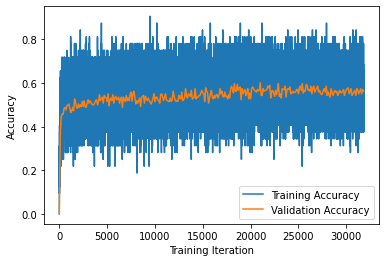

In [13]:
import matplotlib.pyplot as plt
plt.plot(range(len(training_accuracies_finetuning)), training_accuracies_finetuning, label = "Training Accuracy")
plt.plot(list(map(lambda x: x * 100, range(len(validation_accuracies_finetuning)))), validation_accuracies_finetuning, label = "Validation Accuracy")
plt.xlabel("Training Iteration")
plt.ylabel("Accuracy")
plt.legend()

In [14]:
import torch as th
import numpy as np

embedding_bert.to(device)

def get_embeds(x_data):
    concatted_shape = None
    pad_value = None
    embeds = []
    for text in tqdm(x_data):
        doc = nlp(text)
        embeddeds = []
        sents = [str(sent) for sent in doc.sents]
        if sentence_pairs and len(sents) > 1:
            sents = [a + b for a, b in zip(sents, sents[1:])]
        all_tokenized = []
        for sentence in sents[:num_sentences]:
            tokenized = tokenizer(sentence, truncation=True, padding="max_length", max_length=max_tokenized_length)[0]
            all_tokenized.append(tokenized.ids)
        
        with th.no_grad():
            sentence_tensor = th.tensor(all_tokenized).to(device)
            concatted = np.concatenate([
                # take output corresponding to CLS
                embedding_bert.bert(sentence_tensor, output_hidden_states=True, return_dict=True)[1].cpu().numpy(),
                np.zeros((len(all_tokenized), 1))
            ], axis=1)
            
            if not concatted_shape:
                concatted_shape = concatted.shape
                pad_value = np.zeros(concatted_shape[1])
                pad_value[-1] = 1
            
            embeddeds += list(concatted)

        if len(sents) < num_sentences:
            embeddeds += [pad_value] * (num_sentences - len(sents))

        embeds.append(embeddeds)
    return np.array(embeds)

main_data_key = f"cache-core/training-data-main-max-tokens-{max_tokenized_length}-split-{split_hash}-finetuned-{finetuning_model_hash}"
train_x_embeds, valid_x_embeds = memo_load(
    lambda: (
        get_embeds(train_x),
        get_embeds(valid_x)
    ),
    main_data_key
)
main_data_hash = hash_file(main_data_key + ".hkl")

  0%|          | 0/189419 [00:00<?, ?it/s]

  0%|          | 5/189419 [00:00<1:05:57, 47.86it/s]

  0%|          | 10/189419 [00:00<1:05:01, 48.54it/s]

  0%|          | 17/189419 [00:00<55:12, 57.18it/s]  

  0%|          | 26/189419 [00:00<45:36, 69.20it/s]

  0%|          | 34/189419 [00:00<43:46, 72.11it/s]

  0%|          | 42/189419 [00:00<44:00, 71.71it/s]

  0%|          | 50/189419 [00:00<43:06, 73.23it/s]

  0%|          | 58/189419 [00:00<44:19, 71.21it/s]

  0%|          | 66/189419 [00:00<44:32, 70.84it/s]

  0%|          | 74/189419 [00:01<45:32, 69.30it/s]

  0%|          | 81/189419 [00:01<47:05, 67.01it/s]

  0%|          | 90/189419 [00:01<43:05, 73.23it/s]

  0%|          | 98/189419 [00:01<43:48, 72.03it/s]

  0%|          | 107/189419 [00:01<42:22, 74.47it/s]

  0%|          | 115/189419 [00:01<46:25, 67.96it/s]

  0%|          | 125/189419 [00:01<42:21, 74.49it/s]

  0%|          | 133/189419 [00:01<42:44, 73.81it/s]

  0%|          | 141/189419 [00:02<42:45, 73.79it/s]

  0%|          | 150/189419 [00:02<41:04, 76.79it/s]

  0%|          | 158/189419 [00:02<44:42, 70.57it/s]

  0%|          | 166/189419 [00:02<44:21, 71.11it/s]

  0%|          | 174/189419 [00:02<45:27, 69.37it/s]

  0%|          | 182/189419 [00:02<44:56, 70.17it/s]

  0%|          | 190/189419 [00:02<47:03, 67.02it/s]

  0%|          | 198/189419 [00:02<44:48, 70.39it/s]

  0%|          | 206/189419 [00:02<45:00, 70.06it/s]

  0%|          | 215/189419 [00:03<43:06, 73.16it/s]

  0%|          | 223/189419 [00:03<47:00, 67.07it/s]

  0%|          | 230/189419 [00:03<47:34, 66.29it/s]

  0%|          | 237/189419 [00:03<47:45, 66.02it/s]

  0%|          | 244/189419 [00:03<47:26, 66.47it/s]

  0%|          | 252/189419 [00:03<45:51, 68.76it/s]

  0%|          | 261/189419 [00:03<43:48, 71.97it/s]

  0%|          | 269/189419 [00:03<45:15, 69.65it/s]

  0%|          | 278/189419 [00:03<43:25, 72.58it/s]

  0%|          | 286/189419 [00:04<46:12, 68.22it/s]

  0%|          | 293/189419 [00:04<45:56, 68.61it/s]

  0%|          | 300/189419 [00:04<47:55, 65.77it/s]

  0%|          | 311/189419 [00:04<41:41, 75.60it/s]

  0%|          | 319/189419 [00:04<41:36, 75.73it/s]

  0%|          | 328/189419 [00:04<40:09, 78.48it/s]

  0%|          | 338/189419 [00:04<37:50, 83.27it/s]

  0%|          | 347/189419 [00:04<38:09, 82.59it/s]

  0%|          | 356/189419 [00:04<41:34, 75.79it/s]

  0%|          | 364/189419 [00:05<43:17, 72.78it/s]

  0%|          | 372/189419 [00:05<42:14, 74.58it/s]

  0%|          | 381/189419 [00:05<40:29, 77.82it/s]

  0%|          | 389/189419 [00:05<40:16, 78.22it/s]

  0%|          | 398/189419 [00:05<39:34, 79.60it/s]

  0%|          | 407/189419 [00:05<38:24, 82.02it/s]

  0%|          | 416/189419 [00:05<39:14, 80.27it/s]

  0%|          | 425/189419 [00:05<40:26, 77.90it/s]

  0%|          | 433/189419 [00:05<40:19, 78.11it/s]

  0%|          | 441/189419 [00:06<41:44, 75.47it/s]

  0%|          | 451/189419 [00:06<39:15, 80.21it/s]

  0%|          | 460/189419 [00:06<39:43, 79.28it/s]

  0%|          | 468/189419 [00:06<42:21, 74.35it/s]

  0%|          | 478/189419 [00:06<38:53, 80.95it/s]

  0%|          | 487/189419 [00:06<41:28, 75.92it/s]

  0%|          | 495/189419 [00:06<41:37, 75.63it/s]

  0%|          | 503/189419 [00:06<41:29, 75.89it/s]

  0%|          | 513/189419 [00:06<38:34, 81.63it/s]

  0%|          | 522/189419 [00:07<38:54, 80.92it/s]

  0%|          | 531/189419 [00:07<40:36, 77.52it/s]

  0%|          | 540/189419 [00:07<39:37, 79.44it/s]

  0%|          | 549/189419 [00:07<42:49, 73.50it/s]

  0%|          | 557/189419 [00:07<45:00, 69.93it/s]

  0%|          | 566/189419 [00:07<44:11, 71.21it/s]

  0%|          | 574/189419 [00:07<43:03, 73.10it/s]

  0%|          | 582/189419 [00:07<42:39, 73.78it/s]

  0%|          | 590/189419 [00:08<43:07, 72.98it/s]

  0%|          | 598/189419 [00:08<42:58, 73.23it/s]

  0%|          | 606/189419 [00:08<42:56, 73.29it/s]

  0%|          | 614/189419 [00:08<45:09, 69.67it/s]

  0%|          | 622/189419 [00:08<43:57, 71.58it/s]

  0%|          | 630/189419 [00:08<45:14, 69.54it/s]

  0%|          | 638/189419 [00:08<46:43, 67.35it/s]

  0%|          | 647/189419 [00:08<43:15, 72.74it/s]

  0%|          | 655/189419 [00:08<43:13, 72.78it/s]

  0%|          | 664/189419 [00:09<42:24, 74.19it/s]

  0%|          | 672/189419 [00:09<42:58, 73.20it/s]

  0%|          | 681/189419 [00:09<41:35, 75.62it/s]

  0%|          | 691/189419 [00:09<40:03, 78.52it/s]

  0%|          | 699/189419 [00:09<40:27, 77.74it/s]

  0%|          | 707/189419 [00:09<40:40, 77.34it/s]

  0%|          | 716/189419 [00:09<39:30, 79.61it/s]

  0%|          | 725/189419 [00:09<40:20, 77.95it/s]

  0%|          | 734/189419 [00:09<38:56, 80.77it/s]

  0%|          | 743/189419 [00:10<40:31, 77.60it/s]

  0%|          | 754/189419 [00:10<37:21, 84.15it/s]

  0%|          | 763/189419 [00:10<37:16, 84.35it/s]

  0%|          | 772/189419 [00:10<40:09, 78.30it/s]

  0%|          | 780/189419 [00:10<40:21, 77.90it/s]

  0%|          | 788/189419 [00:10<42:22, 74.18it/s]

  0%|          | 796/189419 [00:10<43:02, 73.05it/s]

  0%|          | 805/189419 [00:10<40:46, 77.09it/s]

  0%|          | 814/189419 [00:10<39:22, 79.85it/s]

  0%|          | 824/189419 [00:11<37:18, 84.23it/s]

  0%|          | 833/189419 [00:11<40:18, 77.97it/s]

  0%|          | 842/189419 [00:11<40:34, 77.46it/s]

  0%|          | 850/189419 [00:11<40:51, 76.93it/s]

  0%|          | 861/189419 [00:11<38:30, 81.62it/s]

  0%|          | 870/189419 [00:11<40:06, 78.35it/s]

  0%|          | 878/189419 [00:11<42:19, 74.23it/s]

  0%|          | 886/189419 [00:11<41:47, 75.20it/s]

  0%|          | 894/189419 [00:12<43:37, 72.02it/s]

  0%|          | 902/189419 [00:12<47:45, 65.80it/s]

  0%|          | 910/189419 [00:12<45:54, 68.43it/s]

  0%|          | 918/189419 [00:12<44:13, 71.03it/s]

  0%|          | 926/189419 [00:12<47:45, 65.79it/s]

  0%|          | 934/189419 [00:12<45:29, 69.06it/s]

  0%|          | 942/189419 [00:12<44:12, 71.06it/s]

  1%|          | 951/189419 [00:12<42:31, 73.86it/s]

  1%|          | 959/189419 [00:12<42:41, 73.58it/s]

  1%|          | 967/189419 [00:13<45:53, 68.45it/s]

  1%|          | 974/189419 [00:13<47:06, 66.66it/s]

  1%|          | 981/189419 [00:13<46:50, 67.04it/s]

  1%|          | 988/189419 [00:13<47:45, 65.77it/s]

  1%|          | 995/189419 [00:13<48:02, 65.37it/s]

  1%|          | 1004/189419 [00:13<44:35, 70.44it/s]

  1%|          | 1014/189419 [00:13<40:47, 76.98it/s]

  1%|          | 1022/189419 [00:13<41:15, 76.10it/s]

  1%|          | 1030/189419 [00:14<43:33, 72.08it/s]

  1%|          | 1038/189419 [00:14<44:48, 70.08it/s]

  1%|          | 1046/189419 [00:14<43:18, 72.48it/s]

  1%|          | 1054/189419 [00:14<44:30, 70.54it/s]

  1%|          | 1064/189419 [00:14<40:32, 77.42it/s]

  1%|          | 1072/189419 [00:14<42:19, 74.17it/s]

  1%|          | 1083/189419 [00:14<38:10, 82.21it/s]

  1%|          | 1092/189419 [00:14<41:38, 75.37it/s]

  1%|          | 1100/189419 [00:14<42:19, 74.17it/s]

  1%|          | 1108/189419 [00:15<42:39, 73.59it/s]

  1%|          | 1116/189419 [00:15<42:02, 74.64it/s]

  1%|          | 1125/189419 [00:15<40:38, 77.22it/s]

  1%|          | 1134/189419 [00:15<39:43, 79.01it/s]

  1%|          | 1142/189419 [00:15<43:48, 71.64it/s]

  1%|          | 1150/189419 [00:15<45:08, 69.51it/s]

  1%|          | 1158/189419 [00:15<43:41, 71.82it/s]

  1%|          | 1166/189419 [00:15<43:58, 71.34it/s]

  1%|          | 1175/189419 [00:15<41:59, 74.72it/s]

  1%|          | 1183/189419 [00:16<41:11, 76.16it/s]

  1%|          | 1193/189419 [00:16<39:49, 78.77it/s]

  1%|          | 1201/189419 [00:16<39:50, 78.72it/s]

  1%|          | 1209/189419 [00:16<43:40, 71.83it/s]

  1%|          | 1217/189419 [00:16<42:48, 73.28it/s]

  1%|          | 1225/189419 [00:16<45:56, 68.28it/s]

  1%|          | 1232/189419 [00:16<45:40, 68.66it/s]

  1%|          | 1240/189419 [00:16<44:40, 70.21it/s]

  1%|          | 1248/189419 [00:16<44:51, 69.92it/s]

  1%|          | 1256/189419 [00:17<46:16, 67.77it/s]

  1%|          | 1265/189419 [00:17<43:09, 72.66it/s]

  1%|          | 1275/189419 [00:17<39:30, 79.36it/s]

  1%|          | 1284/189419 [00:17<42:00, 74.65it/s]

  1%|          | 1292/189419 [00:17<46:48, 66.97it/s]

  1%|          | 1301/189419 [00:17<44:39, 70.21it/s]

  1%|          | 1309/189419 [00:17<43:12, 72.56it/s]

  1%|          | 1317/189419 [00:17<43:39, 71.81it/s]

  1%|          | 1327/189419 [00:18<40:24, 77.57it/s]

  1%|          | 1335/189419 [00:18<40:07, 78.12it/s]

  1%|          | 1346/189419 [00:18<38:01, 82.44it/s]

  1%|          | 1355/189419 [00:18<38:14, 81.97it/s]

  1%|          | 1364/189419 [00:18<38:04, 82.30it/s]

  1%|          | 1373/189419 [00:18<37:36, 83.33it/s]

  1%|          | 1382/189419 [00:18<39:12, 79.94it/s]

  1%|          | 1391/189419 [00:18<41:48, 74.95it/s]

  1%|          | 1400/189419 [00:18<40:21, 77.66it/s]

  1%|          | 1408/189419 [00:19<40:57, 76.50it/s]

  1%|          | 1416/189419 [00:19<42:53, 73.06it/s]

  1%|          | 1424/189419 [00:19<41:52, 74.81it/s]

  1%|          | 1432/189419 [00:19<42:58, 72.91it/s]

  1%|          | 1440/189419 [00:19<44:20, 70.65it/s]

  1%|          | 1448/189419 [00:19<44:00, 71.19it/s]

  1%|          | 1459/189419 [00:19<39:52, 78.55it/s]

  1%|          | 1467/189419 [00:19<41:07, 76.18it/s]

  1%|          | 1475/189419 [00:19<42:42, 73.33it/s]

  1%|          | 1484/189419 [00:20<42:00, 74.55it/s]

  1%|          | 1492/189419 [00:20<45:56, 68.18it/s]

  1%|          | 1501/189419 [00:20<44:17, 70.70it/s]

  1%|          | 1509/189419 [00:20<44:23, 70.55it/s]

  1%|          | 1518/189419 [00:20<42:13, 74.16it/s]

  1%|          | 1526/189419 [00:20<43:21, 72.23it/s]

  1%|          | 1535/189419 [00:20<41:41, 75.10it/s]

  1%|          | 1544/189419 [00:20<39:50, 78.60it/s]

  1%|          | 1552/189419 [00:21<40:25, 77.46it/s]

  1%|          | 1560/189419 [00:21<40:22, 77.54it/s]

  1%|          | 1568/189419 [00:21<41:46, 74.96it/s]

  1%|          | 1576/189419 [00:21<41:15, 75.89it/s]

  1%|          | 1584/189419 [00:21<41:34, 75.30it/s]

  1%|          | 1592/189419 [00:21<42:56, 72.89it/s]

  1%|          | 1600/189419 [00:21<45:25, 68.91it/s]

  1%|          | 1609/189419 [00:21<42:15, 74.09it/s]

  1%|          | 1619/189419 [00:21<39:33, 79.13it/s]

  1%|          | 1628/189419 [00:22<38:52, 80.50it/s]

  1%|          | 1637/189419 [00:22<38:07, 82.10it/s]

  1%|          | 1646/189419 [00:22<38:14, 81.84it/s]

  1%|          | 1655/189419 [00:22<37:50, 82.71it/s]

  1%|          | 1664/189419 [00:22<38:46, 80.72it/s]

  1%|          | 1674/189419 [00:22<36:52, 84.85it/s]

  1%|          | 1683/189419 [00:22<37:25, 83.61it/s]

  1%|          | 1692/189419 [00:22<39:33, 79.09it/s]

  1%|          | 1701/189419 [00:22<38:21, 81.58it/s]

  1%|          | 1710/189419 [00:23<40:46, 76.74it/s]

  1%|          | 1718/189419 [00:23<40:44, 76.80it/s]

  1%|          | 1727/189419 [00:23<39:46, 78.66it/s]

  1%|          | 1735/189419 [00:23<39:51, 78.48it/s]

  1%|          | 1743/189419 [00:23<41:06, 76.10it/s]

  1%|          | 1751/189419 [00:23<41:24, 75.53it/s]

  1%|          | 1761/189419 [00:23<37:58, 82.37it/s]

  1%|          | 1770/189419 [00:23<37:39, 83.04it/s]

  1%|          | 1779/189419 [00:23<38:23, 81.47it/s]

  1%|          | 1788/189419 [00:24<43:46, 71.44it/s]

  1%|          | 1798/189419 [00:24<41:11, 75.92it/s]

  1%|          | 1806/189419 [00:24<42:01, 74.41it/s]

  1%|          | 1814/189419 [00:24<44:39, 70.01it/s]

  1%|          | 1822/189419 [00:24<44:14, 70.67it/s]

  1%|          | 1832/189419 [00:24<41:30, 75.32it/s]

  1%|          | 1840/189419 [00:24<41:33, 75.22it/s]

  1%|          | 1848/189419 [00:24<42:56, 72.81it/s]

  1%|          | 1856/189419 [00:24<42:12, 74.07it/s]

  1%|          | 1864/189419 [00:25<45:09, 69.22it/s]

  1%|          | 1872/189419 [00:25<45:52, 68.14it/s]

  1%|          | 1882/189419 [00:25<41:26, 75.41it/s]

  1%|          | 1890/189419 [00:25<40:48, 76.59it/s]

  1%|          | 1898/189419 [00:25<41:36, 75.12it/s]

  1%|          | 1907/189419 [00:25<40:21, 77.42it/s]

  1%|          | 1915/189419 [00:25<40:20, 77.45it/s]

  1%|          | 1923/189419 [00:25<40:09, 77.81it/s]

  1%|          | 1931/189419 [00:25<39:56, 78.24it/s]

  1%|          | 1939/189419 [00:26<40:48, 76.58it/s]

  1%|          | 1947/189419 [00:26<41:35, 75.12it/s]

  1%|          | 1955/189419 [00:26<41:36, 75.08it/s]

  1%|          | 1964/189419 [00:26<41:06, 76.00it/s]

  1%|          | 1972/189419 [00:26<43:27, 71.89it/s]

  1%|          | 1981/189419 [00:26<41:13, 75.77it/s]

  1%|          | 1990/189419 [00:26<39:36, 78.88it/s]

  1%|          | 1998/189419 [00:26<41:38, 75.00it/s]

  1%|          | 2008/189419 [00:26<38:49, 80.45it/s]

  1%|          | 2018/189419 [00:27<36:56, 84.55it/s]

  1%|          | 2027/189419 [00:27<37:15, 83.81it/s]

  1%|          | 2036/189419 [00:27<41:13, 75.76it/s]

  1%|          | 2045/189419 [00:27<40:05, 77.88it/s]

  1%|          | 2054/189419 [00:27<38:54, 80.25it/s]

  1%|          | 2064/189419 [00:27<36:30, 85.52it/s]

  1%|          | 2073/189419 [00:27<37:21, 83.58it/s]

  1%|          | 2082/189419 [00:27<36:52, 84.65it/s]

  1%|          | 2091/189419 [00:27<38:10, 81.78it/s]

  1%|          | 2100/189419 [00:28<42:04, 74.21it/s]

  1%|          | 2111/189419 [00:28<38:22, 81.36it/s]

  1%|          | 2120/189419 [00:28<40:16, 77.51it/s]

  1%|          | 2128/189419 [00:28<40:28, 77.14it/s]

  1%|          | 2138/189419 [00:28<38:05, 81.94it/s]

  1%|          | 2147/189419 [00:28<41:26, 75.31it/s]

  1%|          | 2155/189419 [00:28<42:50, 72.86it/s]

  1%|          | 2163/189419 [00:28<44:32, 70.06it/s]

  1%|          | 2171/189419 [00:29<45:37, 68.39it/s]

  1%|          | 2181/189419 [00:29<41:57, 74.38it/s]

  1%|          | 2189/189419 [00:29<41:34, 75.05it/s]

  1%|          | 2197/189419 [00:29<40:51, 76.38it/s]

  1%|          | 2206/189419 [00:29<40:34, 76.90it/s]

  1%|          | 2214/189419 [00:29<40:46, 76.52it/s]

  1%|          | 2222/189419 [00:29<41:05, 75.94it/s]

  1%|          | 2230/189419 [00:29<42:05, 74.12it/s]

  1%|          | 2239/189419 [00:29<40:19, 77.37it/s]

  1%|          | 2248/189419 [00:30<39:17, 79.38it/s]

  1%|          | 2257/189419 [00:30<38:35, 80.85it/s]

  1%|          | 2266/189419 [00:30<39:13, 79.53it/s]

  1%|          | 2274/189419 [00:30<41:49, 74.58it/s]

  1%|          | 2284/189419 [00:30<38:54, 80.17it/s]

  1%|          | 2293/189419 [00:30<40:57, 76.15it/s]

  1%|          | 2301/189419 [00:30<41:20, 75.45it/s]

  1%|          | 2309/189419 [00:30<40:49, 76.38it/s]

  1%|          | 2317/189419 [00:30<42:14, 73.82it/s]

  1%|          | 2325/189419 [00:31<45:50, 68.03it/s]

  1%|          | 2333/189419 [00:31<44:32, 70.01it/s]

  1%|          | 2341/189419 [00:31<43:35, 71.53it/s]

  1%|          | 2349/189419 [00:31<43:22, 71.88it/s]

  1%|          | 2358/189419 [00:31<40:52, 76.29it/s]

  1%|▏         | 2368/189419 [00:31<38:57, 80.03it/s]

  1%|▏         | 2377/189419 [00:31<38:11, 81.62it/s]

  1%|▏         | 2386/189419 [00:31<37:49, 82.40it/s]

  1%|▏         | 2395/189419 [00:31<39:52, 78.16it/s]

  1%|▏         | 2406/189419 [00:32<36:09, 86.19it/s]

  1%|▏         | 2415/189419 [00:32<37:44, 82.58it/s]

  1%|▏         | 2424/189419 [00:32<41:33, 75.00it/s]

  1%|▏         | 2432/189419 [00:32<41:25, 75.23it/s]

  1%|▏         | 2441/189419 [00:32<39:46, 78.35it/s]

  1%|▏         | 2451/189419 [00:32<37:15, 83.64it/s]

  1%|▏         | 2460/189419 [00:32<36:59, 84.22it/s]

  1%|▏         | 2469/189419 [00:32<39:57, 77.99it/s]

  1%|▏         | 2478/189419 [00:33<39:26, 79.01it/s]

  1%|▏         | 2488/189419 [00:33<37:38, 82.75it/s]

  1%|▏         | 2497/189419 [00:33<38:42, 80.48it/s]

  1%|▏         | 2507/189419 [00:33<37:19, 83.47it/s]

  1%|▏         | 2516/189419 [00:33<39:38, 78.58it/s]

  1%|▏         | 2525/189419 [00:33<38:22, 81.18it/s]

  1%|▏         | 2534/189419 [00:33<41:39, 74.76it/s]

  1%|▏         | 2543/189419 [00:33<39:35, 78.68it/s]

  1%|▏         | 2553/189419 [00:33<37:03, 84.06it/s]

  1%|▏         | 2562/189419 [00:34<38:22, 81.16it/s]

  1%|▏         | 2571/189419 [00:34<37:54, 82.14it/s]

  1%|▏         | 2580/189419 [00:34<38:33, 80.76it/s]

  1%|▏         | 2589/189419 [00:34<37:34, 82.85it/s]

  1%|▏         | 2598/189419 [00:34<41:29, 75.06it/s]

  1%|▏         | 2606/189419 [00:34<42:33, 73.16it/s]

  1%|▏         | 2614/189419 [00:34<41:58, 74.16it/s]

  1%|▏         | 2622/189419 [00:34<41:14, 75.48it/s]

  1%|▏         | 2630/189419 [00:34<43:16, 71.93it/s]

  1%|▏         | 2640/189419 [00:35<40:24, 77.02it/s]

  1%|▏         | 2648/189419 [00:35<43:06, 72.20it/s]

  1%|▏         | 2656/189419 [00:35<44:43, 69.60it/s]

  1%|▏         | 2666/189419 [00:35<41:16, 75.42it/s]

  1%|▏         | 2674/189419 [00:35<42:20, 73.51it/s]

  1%|▏         | 2682/189419 [00:35<44:09, 70.47it/s]

  1%|▏         | 2690/189419 [00:35<43:16, 71.91it/s]

  1%|▏         | 2698/189419 [00:35<43:55, 70.84it/s]

  1%|▏         | 2706/189419 [00:36<43:53, 70.90it/s]

  1%|▏         | 2714/189419 [00:36<44:28, 69.97it/s]

  1%|▏         | 2723/189419 [00:36<41:56, 74.19it/s]

  1%|▏         | 2731/189419 [00:36<44:44, 69.54it/s]

  1%|▏         | 2742/189419 [00:36<40:10, 77.44it/s]

  1%|▏         | 2750/189419 [00:36<40:10, 77.43it/s]

  1%|▏         | 2758/189419 [00:36<42:45, 72.75it/s]

  1%|▏         | 2767/189419 [00:36<40:16, 77.24it/s]

  1%|▏         | 2776/189419 [00:36<40:01, 77.72it/s]

  1%|▏         | 2785/189419 [00:37<38:44, 80.29it/s]

  1%|▏         | 2794/189419 [00:37<37:51, 82.14it/s]

  1%|▏         | 2803/189419 [00:37<37:45, 82.38it/s]

  1%|▏         | 2812/189419 [00:37<38:24, 80.97it/s]

  1%|▏         | 2821/189419 [00:37<37:53, 82.09it/s]

  1%|▏         | 2830/189419 [00:37<40:31, 76.75it/s]

  1%|▏         | 2838/189419 [00:37<42:36, 72.99it/s]

  2%|▏         | 2846/189419 [00:37<44:29, 69.89it/s]

  2%|▏         | 2854/189419 [00:37<43:41, 71.17it/s]

  2%|▏         | 2862/189419 [00:38<42:49, 72.61it/s]

  2%|▏         | 2870/189419 [00:38<45:16, 68.68it/s]

  2%|▏         | 2878/189419 [00:38<44:04, 70.55it/s]

  2%|▏         | 2886/189419 [00:38<45:34, 68.21it/s]

  2%|▏         | 2895/189419 [00:38<44:06, 70.48it/s]

  2%|▏         | 2906/189419 [00:38<39:01, 79.67it/s]

  2%|▏         | 2915/189419 [00:38<38:14, 81.30it/s]

  2%|▏         | 2924/189419 [00:38<38:04, 81.64it/s]

  2%|▏         | 2933/189419 [00:38<39:47, 78.12it/s]

  2%|▏         | 2941/189419 [00:39<41:06, 75.61it/s]

  2%|▏         | 2951/189419 [00:39<38:32, 80.64it/s]

  2%|▏         | 2960/189419 [00:39<39:53, 77.91it/s]

  2%|▏         | 2968/189419 [00:39<40:42, 76.33it/s]

  2%|▏         | 2977/189419 [00:39<39:44, 78.19it/s]

  2%|▏         | 2986/189419 [00:39<38:20, 81.03it/s]

  2%|▏         | 2996/189419 [00:39<37:35, 82.66it/s]

  2%|▏         | 3005/189419 [00:39<37:22, 83.13it/s]

  2%|▏         | 3015/189419 [00:39<35:58, 86.36it/s]

  2%|▏         | 3024/189419 [00:40<38:39, 80.35it/s]

  2%|▏         | 3033/189419 [00:40<39:28, 78.70it/s]

  2%|▏         | 3041/189419 [00:40<40:21, 76.96it/s]

  2%|▏         | 3050/189419 [00:40<40:26, 76.82it/s]

  2%|▏         | 3058/189419 [00:40<41:16, 75.26it/s]

  2%|▏         | 3066/189419 [00:40<43:44, 71.02it/s]

  2%|▏         | 3076/189419 [00:40<40:13, 77.20it/s]

  2%|▏         | 3084/189419 [00:40<42:19, 73.37it/s]

  2%|▏         | 3095/189419 [00:41<38:26, 80.79it/s]

  2%|▏         | 3104/189419 [00:41<39:16, 79.06it/s]

  2%|▏         | 3113/189419 [00:41<38:30, 80.65it/s]

  2%|▏         | 3122/189419 [00:41<38:20, 80.97it/s]

  2%|▏         | 3131/189419 [00:41<39:49, 77.97it/s]

  2%|▏         | 3140/189419 [00:41<39:30, 78.58it/s]

  2%|▏         | 3150/189419 [00:41<37:58, 81.76it/s]

  2%|▏         | 3159/189419 [00:41<37:45, 82.21it/s]

  2%|▏         | 3168/189419 [00:41<37:17, 83.25it/s]

  2%|▏         | 3177/189419 [00:42<37:49, 82.06it/s]

  2%|▏         | 3186/189419 [00:42<41:35, 74.61it/s]

  2%|▏         | 3195/189419 [00:42<40:28, 76.67it/s]

  2%|▏         | 3203/189419 [00:42<41:22, 75.02it/s]

  2%|▏         | 3211/189419 [00:42<42:19, 73.32it/s]

  2%|▏         | 3220/189419 [00:42<40:52, 75.93it/s]

  2%|▏         | 3228/189419 [00:42<40:24, 76.79it/s]

  2%|▏         | 3236/189419 [00:42<41:19, 75.09it/s]

  2%|▏         | 3244/189419 [00:42<41:12, 75.30it/s]

  2%|▏         | 3252/189419 [00:43<43:00, 72.14it/s]

  2%|▏         | 3260/189419 [00:43<42:27, 73.08it/s]

  2%|▏         | 3268/189419 [00:43<43:00, 72.15it/s]

  2%|▏         | 3277/189419 [00:43<41:35, 74.60it/s]

  2%|▏         | 3285/189419 [00:43<45:03, 68.85it/s]

  2%|▏         | 3293/189419 [00:43<43:51, 70.74it/s]

  2%|▏         | 3301/189419 [00:43<42:39, 72.70it/s]

  2%|▏         | 3310/189419 [00:43<40:38, 76.32it/s]

  2%|▏         | 3318/189419 [00:43<41:33, 74.64it/s]

  2%|▏         | 3326/189419 [00:44<41:30, 74.72it/s]

  2%|▏         | 3334/189419 [00:44<43:06, 71.95it/s]

  2%|▏         | 3343/189419 [00:44<40:24, 76.74it/s]

  2%|▏         | 3351/189419 [00:44<40:55, 75.77it/s]

  2%|▏         | 3359/189419 [00:44<40:57, 75.70it/s]

  2%|▏         | 3367/189419 [00:44<41:52, 74.04it/s]

  2%|▏         | 3375/189419 [00:44<42:30, 72.94it/s]

  2%|▏         | 3383/189419 [00:44<43:14, 71.71it/s]

  2%|▏         | 3391/189419 [00:45<43:51, 70.68it/s]

  2%|▏         | 3400/189419 [00:45<40:58, 75.66it/s]

  2%|▏         | 3408/189419 [00:45<41:05, 75.43it/s]

  2%|▏         | 3417/189419 [00:45<39:08, 79.21it/s]

  2%|▏         | 3426/189419 [00:45<38:20, 80.85it/s]

  2%|▏         | 3435/189419 [00:45<41:48, 74.13it/s]

  2%|▏         | 3443/189419 [00:45<41:15, 75.12it/s]

  2%|▏         | 3451/189419 [00:45<42:50, 72.33it/s]

  2%|▏         | 3459/189419 [00:45<42:57, 72.14it/s]

  2%|▏         | 3468/189419 [00:46<40:56, 75.71it/s]

  2%|▏         | 3476/189419 [00:46<42:17, 73.28it/s]

  2%|▏         | 3484/189419 [00:46<41:56, 73.90it/s]

  2%|▏         | 3494/189419 [00:46<38:36, 80.25it/s]

  2%|▏         | 3503/189419 [00:46<39:30, 78.43it/s]

  2%|▏         | 3511/189419 [00:46<43:51, 70.65it/s]

  2%|▏         | 3521/189419 [00:46<40:31, 76.47it/s]

  2%|▏         | 3529/189419 [00:46<41:22, 74.88it/s]

  2%|▏         | 3539/189419 [00:46<38:11, 81.13it/s]

  2%|▏         | 3548/189419 [00:47<40:18, 76.84it/s]

  2%|▏         | 3556/189419 [00:47<40:58, 75.59it/s]

  2%|▏         | 3564/189419 [00:47<42:49, 72.32it/s]

  2%|▏         | 3572/189419 [00:47<41:55, 73.88it/s]

  2%|▏         | 3580/189419 [00:47<42:30, 72.88it/s]

  2%|▏         | 3588/189419 [00:47<44:23, 69.76it/s]

  2%|▏         | 3596/189419 [00:47<44:17, 69.92it/s]

  2%|▏         | 3605/189419 [00:47<41:09, 75.26it/s]

  2%|▏         | 3615/189419 [00:47<37:52, 81.75it/s]

  2%|▏         | 3624/189419 [00:48<37:57, 81.60it/s]

  2%|▏         | 3633/189419 [00:48<38:06, 81.26it/s]

  2%|▏         | 3642/189419 [00:48<38:09, 81.15it/s]

  2%|▏         | 3651/189419 [00:48<39:36, 78.18it/s]

  2%|▏         | 3659/189419 [00:48<40:41, 76.10it/s]

  2%|▏         | 3668/189419 [00:48<39:29, 78.38it/s]

  2%|▏         | 3676/189419 [00:48<39:39, 78.06it/s]

  2%|▏         | 3687/189419 [00:48<36:28, 84.87it/s]

  2%|▏         | 3699/189419 [00:48<33:20, 92.85it/s]

  2%|▏         | 3709/189419 [00:49<37:01, 83.61it/s]

  2%|▏         | 3719/189419 [00:49<35:55, 86.15it/s]

  2%|▏         | 3728/189419 [00:49<36:44, 84.22it/s]

  2%|▏         | 3737/189419 [00:49<36:43, 84.25it/s]

  2%|▏         | 3746/189419 [00:49<38:13, 80.95it/s]

  2%|▏         | 3755/189419 [00:49<39:15, 78.84it/s]

  2%|▏         | 3764/189419 [00:49<38:17, 80.82it/s]

  2%|▏         | 3773/189419 [00:49<39:29, 78.33it/s]

  2%|▏         | 3781/189419 [00:49<40:18, 76.75it/s]

  2%|▏         | 3791/189419 [00:50<38:51, 79.61it/s]

  2%|▏         | 3800/189419 [00:50<37:45, 81.92it/s]

  2%|▏         | 3809/189419 [00:50<38:33, 80.24it/s]

  2%|▏         | 3818/189419 [00:50<39:58, 77.38it/s]

  2%|▏         | 3828/189419 [00:50<38:26, 80.47it/s]

  2%|▏         | 3837/189419 [00:50<40:01, 77.26it/s]

  2%|▏         | 3845/189419 [00:50<42:23, 72.97it/s]

  2%|▏         | 3855/189419 [00:50<39:05, 79.12it/s]

  2%|▏         | 3864/189419 [00:51<40:04, 77.16it/s]

  2%|▏         | 3872/189419 [00:51<39:55, 77.47it/s]

  2%|▏         | 3882/189419 [00:51<37:36, 82.23it/s]

  2%|▏         | 3891/189419 [00:51<36:47, 84.06it/s]

  2%|▏         | 3900/189419 [00:51<40:12, 76.89it/s]

  2%|▏         | 3908/189419 [00:51<44:35, 69.33it/s]

  2%|▏         | 3916/189419 [00:51<44:50, 68.94it/s]

  2%|▏         | 3924/189419 [00:51<47:18, 65.36it/s]

  2%|▏         | 3933/189419 [00:52<44:30, 69.46it/s]

  2%|▏         | 3943/189419 [00:52<40:16, 76.75it/s]

  2%|▏         | 3951/189419 [00:52<40:28, 76.36it/s]

  2%|▏         | 3960/189419 [00:52<39:01, 79.21it/s]

  2%|▏         | 3970/189419 [00:52<38:21, 80.59it/s]

  2%|▏         | 3979/189419 [00:52<39:07, 78.98it/s]

  2%|▏         | 3987/189419 [00:52<39:30, 78.23it/s]

  2%|▏         | 3996/189419 [00:52<38:40, 79.92it/s]

  2%|▏         | 4005/189419 [00:52<39:42, 77.84it/s]

  2%|▏         | 4013/189419 [00:53<39:54, 77.41it/s]

  2%|▏         | 4022/189419 [00:53<39:33, 78.12it/s]

  2%|▏         | 4030/189419 [00:53<40:34, 76.15it/s]

  2%|▏         | 4038/189419 [00:53<40:19, 76.62it/s]

  2%|▏         | 4046/189419 [00:53<40:12, 76.83it/s]

  2%|▏         | 4054/189419 [00:53<45:20, 68.15it/s]

  2%|▏         | 4063/189419 [00:53<42:38, 72.45it/s]

  2%|▏         | 4071/189419 [00:53<41:50, 73.82it/s]

  2%|▏         | 4079/189419 [00:53<41:36, 74.23it/s]

  2%|▏         | 4087/189419 [00:54<42:46, 72.21it/s]

  2%|▏         | 4095/189419 [00:54<43:11, 71.51it/s]

  2%|▏         | 4106/189419 [00:54<38:05, 81.07it/s]

  2%|▏         | 4115/189419 [00:54<39:10, 78.85it/s]

  2%|▏         | 4123/189419 [00:54<39:03, 79.08it/s]

  2%|▏         | 4131/189419 [00:54<40:51, 75.59it/s]

  2%|▏         | 4139/189419 [00:54<42:56, 71.90it/s]

  2%|▏         | 4147/189419 [00:54<47:02, 65.65it/s]

  2%|▏         | 4155/189419 [00:54<45:49, 67.38it/s]

  2%|▏         | 4163/189419 [00:55<44:20, 69.63it/s]

  2%|▏         | 4172/189419 [00:55<42:37, 72.42it/s]

  2%|▏         | 4180/189419 [00:55<41:32, 74.32it/s]

  2%|▏         | 4188/189419 [00:55<41:36, 74.21it/s]

  2%|▏         | 4196/189419 [00:55<42:53, 71.97it/s]

  2%|▏         | 4204/189419 [00:55<42:25, 72.76it/s]

  2%|▏         | 4212/189419 [00:55<41:34, 74.25it/s]

  2%|▏         | 4221/189419 [00:55<39:49, 77.49it/s]

  2%|▏         | 4230/189419 [00:55<39:08, 78.84it/s]

  2%|▏         | 4238/189419 [00:56<40:02, 77.09it/s]

  2%|▏         | 4247/189419 [00:56<39:22, 78.37it/s]

  2%|▏         | 4255/189419 [00:56<41:37, 74.15it/s]

  2%|▏         | 4264/189419 [00:56<40:03, 77.02it/s]

  2%|▏         | 4274/189419 [00:56<37:41, 81.87it/s]

  2%|▏         | 4283/189419 [00:56<38:52, 79.38it/s]

  2%|▏         | 4292/189419 [00:56<38:30, 80.13it/s]

  2%|▏         | 4301/189419 [00:56<39:03, 79.00it/s]

  2%|▏         | 4309/189419 [00:56<40:59, 75.26it/s]

  2%|▏         | 4318/189419 [00:57<39:47, 77.51it/s]

  2%|▏         | 4327/189419 [00:57<38:09, 80.83it/s]

  2%|▏         | 4336/189419 [00:57<43:50, 70.36it/s]

  2%|▏         | 4346/189419 [00:57<40:28, 76.21it/s]

  2%|▏         | 4354/189419 [00:57<43:49, 70.38it/s]

  2%|▏         | 4363/189419 [00:57<42:03, 73.35it/s]

  2%|▏         | 4372/189419 [00:57<39:49, 77.44it/s]

  2%|▏         | 4380/189419 [00:57<44:13, 69.73it/s]

  2%|▏         | 4389/189419 [00:58<41:18, 74.67it/s]

  2%|▏         | 4398/189419 [00:58<41:22, 74.52it/s]

  2%|▏         | 4406/189419 [00:58<42:58, 71.75it/s]

  2%|▏         | 4415/189419 [00:58<40:25, 76.27it/s]

  2%|▏         | 4423/189419 [00:58<41:16, 74.71it/s]

  2%|▏         | 4433/189419 [00:58<38:10, 80.75it/s]

  2%|▏         | 4442/189419 [00:58<40:19, 76.44it/s]

  2%|▏         | 4450/189419 [00:58<40:00, 77.07it/s]

  2%|▏         | 4459/189419 [00:58<38:18, 80.47it/s]

  2%|▏         | 4469/189419 [00:59<36:19, 84.85it/s]

  2%|▏         | 4478/189419 [00:59<35:51, 85.96it/s]

  2%|▏         | 4487/189419 [00:59<36:22, 84.74it/s]

  2%|▏         | 4497/189419 [00:59<34:48, 88.53it/s]

  2%|▏         | 4506/189419 [00:59<40:25, 76.25it/s]

  2%|▏         | 4516/189419 [00:59<37:47, 81.55it/s]

  2%|▏         | 4526/189419 [00:59<36:11, 85.15it/s]

  2%|▏         | 4535/189419 [00:59<38:21, 80.34it/s]

  2%|▏         | 4544/189419 [00:59<37:25, 82.35it/s]

  2%|▏         | 4553/189419 [01:00<38:29, 80.04it/s]

  2%|▏         | 4562/189419 [01:00<39:03, 78.88it/s]

  2%|▏         | 4570/189419 [01:00<39:20, 78.32it/s]

  2%|▏         | 4578/189419 [01:00<39:37, 77.76it/s]

  2%|▏         | 4586/189419 [01:00<40:06, 76.82it/s]

  2%|▏         | 4594/189419 [01:00<43:37, 70.60it/s]

  2%|▏         | 4602/189419 [01:00<42:20, 72.75it/s]

  2%|▏         | 4610/189419 [01:00<43:03, 71.54it/s]

  2%|▏         | 4619/189419 [01:00<41:58, 73.39it/s]

  2%|▏         | 4627/189419 [01:01<41:17, 74.58it/s]

  2%|▏         | 4635/189419 [01:01<41:09, 74.82it/s]

  2%|▏         | 4646/189419 [01:01<37:31, 82.06it/s]

  2%|▏         | 4656/189419 [01:01<36:11, 85.08it/s]

  2%|▏         | 4665/189419 [01:01<36:56, 83.37it/s]

  2%|▏         | 4674/189419 [01:01<38:32, 79.90it/s]

  2%|▏         | 4683/189419 [01:01<37:29, 82.13it/s]

  2%|▏         | 4693/189419 [01:01<37:19, 82.48it/s]

  2%|▏         | 4702/189419 [01:02<39:54, 77.14it/s]

  2%|▏         | 4710/189419 [01:02<41:37, 73.96it/s]

  2%|▏         | 4718/189419 [01:02<42:52, 71.79it/s]

  2%|▏         | 4726/189419 [01:02<43:59, 69.97it/s]

  2%|▏         | 4734/189419 [01:02<45:54, 67.04it/s]

  3%|▎         | 4744/189419 [01:02<41:13, 74.67it/s]

  3%|▎         | 4755/189419 [01:02<38:22, 80.22it/s]

  3%|▎         | 4764/189419 [01:02<40:19, 76.32it/s]

  3%|▎         | 4776/189419 [01:02<35:14, 87.34it/s]

  3%|▎         | 4786/189419 [01:03<34:25, 89.39it/s]

  3%|▎         | 4796/189419 [01:03<34:04, 90.32it/s]

  3%|▎         | 4806/189419 [01:03<35:34, 86.48it/s]

  3%|▎         | 4815/189419 [01:03<37:34, 81.90it/s]

  3%|▎         | 4824/189419 [01:03<37:05, 82.96it/s]

  3%|▎         | 4833/189419 [01:03<36:27, 84.37it/s]

  3%|▎         | 4842/189419 [01:03<39:14, 78.39it/s]

  3%|▎         | 4851/189419 [01:03<39:13, 78.43it/s]

  3%|▎         | 4859/189419 [01:03<40:51, 75.29it/s]

  3%|▎         | 4868/189419 [01:04<39:12, 78.43it/s]

  3%|▎         | 4877/189419 [01:04<38:08, 80.65it/s]

  3%|▎         | 4886/189419 [01:04<39:37, 77.61it/s]

  3%|▎         | 4894/189419 [01:04<40:02, 76.82it/s]

  3%|▎         | 4902/189419 [01:04<43:18, 71.00it/s]

  3%|▎         | 4910/189419 [01:04<43:16, 71.07it/s]

  3%|▎         | 4918/189419 [01:04<43:20, 70.96it/s]

  3%|▎         | 4929/189419 [01:04<38:09, 80.57it/s]

  3%|▎         | 4938/189419 [01:05<38:05, 80.72it/s]

  3%|▎         | 4947/189419 [01:05<37:15, 82.51it/s]

  3%|▎         | 4956/189419 [01:05<36:50, 83.47it/s]

  3%|▎         | 4965/189419 [01:05<37:11, 82.66it/s]

  3%|▎         | 4974/189419 [01:05<37:29, 81.98it/s]

  3%|▎         | 4984/189419 [01:05<35:44, 86.01it/s]

  3%|▎         | 4994/189419 [01:05<34:58, 87.90it/s]

  3%|▎         | 5003/189419 [01:05<37:20, 82.31it/s]

  3%|▎         | 5012/189419 [01:05<38:30, 79.82it/s]

  3%|▎         | 5021/189419 [01:06<40:12, 76.43it/s]

  3%|▎         | 5029/189419 [01:06<42:40, 72.00it/s]

  3%|▎         | 5037/189419 [01:06<44:27, 69.13it/s]

  3%|▎         | 5046/189419 [01:06<43:05, 71.31it/s]

  3%|▎         | 5054/189419 [01:06<42:05, 73.00it/s]

  3%|▎         | 5062/189419 [01:06<42:05, 72.99it/s]

  3%|▎         | 5070/189419 [01:06<42:27, 72.36it/s]

  3%|▎         | 5078/189419 [01:06<42:36, 72.10it/s]

  3%|▎         | 5086/189419 [01:06<43:46, 70.19it/s]

  3%|▎         | 5094/189419 [01:07<46:47, 65.66it/s]

  3%|▎         | 5103/189419 [01:07<42:57, 71.50it/s]

  3%|▎         | 5112/189419 [01:07<42:20, 72.55it/s]

  3%|▎         | 5121/189419 [01:07<41:42, 73.63it/s]

  3%|▎         | 5129/189419 [01:07<41:49, 73.44it/s]

  3%|▎         | 5138/189419 [01:07<39:42, 77.35it/s]

  3%|▎         | 5147/189419 [01:07<38:26, 79.88it/s]

  3%|▎         | 5156/189419 [01:07<40:03, 76.65it/s]

  3%|▎         | 5164/189419 [01:07<40:57, 74.98it/s]

  3%|▎         | 5174/189419 [01:08<38:29, 79.79it/s]

  3%|▎         | 5183/189419 [01:08<40:37, 75.59it/s]

  3%|▎         | 5191/189419 [01:08<40:30, 75.81it/s]

  3%|▎         | 5201/189419 [01:08<37:16, 82.36it/s]

  3%|▎         | 5210/189419 [01:08<40:23, 76.00it/s]

  3%|▎         | 5218/189419 [01:08<43:45, 70.15it/s]

  3%|▎         | 5227/189419 [01:08<41:59, 73.10it/s]

  3%|▎         | 5236/189419 [01:08<41:32, 73.90it/s]

  3%|▎         | 5244/189419 [01:09<43:13, 71.02it/s]

  3%|▎         | 5252/189419 [01:09<41:58, 73.13it/s]

  3%|▎         | 5261/189419 [01:09<40:18, 76.15it/s]

  3%|▎         | 5271/189419 [01:09<38:06, 80.55it/s]

  3%|▎         | 5280/189419 [01:09<39:53, 76.92it/s]

  3%|▎         | 5288/189419 [01:09<41:54, 73.24it/s]

  3%|▎         | 5296/189419 [01:09<41:20, 74.22it/s]

  3%|▎         | 5306/189419 [01:09<37:51, 81.05it/s]

  3%|▎         | 5315/189419 [01:09<37:26, 81.95it/s]

  3%|▎         | 5324/189419 [01:10<39:12, 78.25it/s]

  3%|▎         | 5332/189419 [01:10<40:49, 75.16it/s]

  3%|▎         | 5340/189419 [01:10<42:36, 72.01it/s]

  3%|▎         | 5348/189419 [01:10<42:40, 71.90it/s]

  3%|▎         | 5356/189419 [01:10<42:48, 71.66it/s]

  3%|▎         | 5364/189419 [01:10<41:57, 73.10it/s]

  3%|▎         | 5374/189419 [01:10<38:06, 80.50it/s]

  3%|▎         | 5383/189419 [01:10<38:23, 79.89it/s]

  3%|▎         | 5392/189419 [01:11<42:47, 71.68it/s]

  3%|▎         | 5400/189419 [01:11<42:53, 71.52it/s]

  3%|▎         | 5408/189419 [01:11<43:36, 70.33it/s]

  3%|▎         | 5416/189419 [01:11<42:47, 71.67it/s]

  3%|▎         | 5426/189419 [01:11<39:43, 77.19it/s]

  3%|▎         | 5435/189419 [01:11<39:26, 77.75it/s]

  3%|▎         | 5443/189419 [01:11<41:47, 73.36it/s]

  3%|▎         | 5452/189419 [01:11<41:26, 73.98it/s]

  3%|▎         | 5460/189419 [01:11<40:39, 75.40it/s]

  3%|▎         | 5468/189419 [01:12<40:10, 76.32it/s]

  3%|▎         | 5477/189419 [01:12<39:37, 77.38it/s]

  3%|▎         | 5485/189419 [01:12<40:18, 76.06it/s]

  3%|▎         | 5493/189419 [01:12<42:31, 72.08it/s]

  3%|▎         | 5501/189419 [01:12<42:03, 72.87it/s]

  3%|▎         | 5509/189419 [01:12<42:02, 72.89it/s]

  3%|▎         | 5517/189419 [01:12<42:21, 72.36it/s]

  3%|▎         | 5525/189419 [01:12<42:41, 71.79it/s]

  3%|▎         | 5533/189419 [01:12<47:42, 64.25it/s]

  3%|▎         | 5540/189419 [01:13<48:08, 63.66it/s]

  3%|▎         | 5547/189419 [01:13<47:08, 65.00it/s]

  3%|▎         | 5555/189419 [01:13<44:43, 68.53it/s]

  3%|▎         | 5562/189419 [01:13<44:53, 68.26it/s]

  3%|▎         | 5569/189419 [01:13<46:16, 66.21it/s]

  3%|▎         | 5580/189419 [01:13<40:47, 75.11it/s]

  3%|▎         | 5589/189419 [01:13<39:30, 77.55it/s]

  3%|▎         | 5599/189419 [01:13<38:15, 80.09it/s]

  3%|▎         | 5608/189419 [01:14<42:14, 72.52it/s]

  3%|▎         | 5617/189419 [01:14<40:00, 76.57it/s]

  3%|▎         | 5625/189419 [01:14<41:22, 74.04it/s]

  3%|▎         | 5633/189419 [01:14<40:59, 74.72it/s]

  3%|▎         | 5643/189419 [01:14<37:34, 81.51it/s]

  3%|▎         | 5652/189419 [01:14<38:26, 79.66it/s]

  3%|▎         | 5661/189419 [01:14<37:20, 82.01it/s]

  3%|▎         | 5670/189419 [01:14<37:32, 81.59it/s]

  3%|▎         | 5679/189419 [01:14<37:02, 82.68it/s]

  3%|▎         | 5688/189419 [01:14<37:39, 81.31it/s]

  3%|▎         | 5697/189419 [01:15<40:54, 74.85it/s]

  3%|▎         | 5706/189419 [01:15<39:05, 78.31it/s]

  3%|▎         | 5717/189419 [01:15<37:15, 82.19it/s]

  3%|▎         | 5726/189419 [01:15<38:07, 80.32it/s]

  3%|▎         | 5735/189419 [01:15<39:57, 76.62it/s]

  3%|▎         | 5743/189419 [01:15<39:50, 76.85it/s]

  3%|▎         | 5751/189419 [01:15<41:15, 74.19it/s]

  3%|▎         | 5760/189419 [01:15<39:42, 77.07it/s]

  3%|▎         | 5769/189419 [01:16<38:46, 78.93it/s]

  3%|▎         | 5778/189419 [01:16<38:00, 80.51it/s]

  3%|▎         | 5787/189419 [01:16<42:37, 71.80it/s]

  3%|▎         | 5797/189419 [01:16<40:07, 76.26it/s]

  3%|▎         | 5805/189419 [01:16<40:32, 75.49it/s]

  3%|▎         | 5813/189419 [01:16<40:13, 76.08it/s]

  3%|▎         | 5821/189419 [01:16<42:23, 72.17it/s]

  3%|▎         | 5829/189419 [01:16<42:18, 72.31it/s]

  3%|▎         | 5837/189419 [01:16<42:43, 71.61it/s]

  3%|▎         | 5845/189419 [01:17<41:40, 73.41it/s]

  3%|▎         | 5854/189419 [01:17<39:38, 77.16it/s]

  3%|▎         | 5862/189419 [01:17<40:20, 75.85it/s]

  3%|▎         | 5872/189419 [01:17<37:36, 81.33it/s]

  3%|▎         | 5881/189419 [01:17<38:46, 78.88it/s]

  3%|▎         | 5891/189419 [01:17<37:33, 81.43it/s]

  3%|▎         | 5900/189419 [01:17<36:34, 83.64it/s]

  3%|▎         | 5909/189419 [01:17<37:17, 82.02it/s]

  3%|▎         | 5918/189419 [01:17<39:57, 76.54it/s]

  3%|▎         | 5928/189419 [01:18<37:42, 81.11it/s]

  3%|▎         | 5938/189419 [01:18<37:03, 82.53it/s]

  3%|▎         | 5947/189419 [01:18<38:35, 79.25it/s]

  3%|▎         | 5956/189419 [01:18<38:01, 80.42it/s]

  3%|▎         | 5965/189419 [01:18<38:25, 79.58it/s]

  3%|▎         | 5973/189419 [01:18<38:49, 78.74it/s]

  3%|▎         | 5982/189419 [01:18<37:52, 80.74it/s]

  3%|▎         | 5991/189419 [01:18<37:10, 82.25it/s]

  3%|▎         | 6000/189419 [01:18<39:05, 78.19it/s]

  3%|▎         | 6010/189419 [01:19<36:42, 83.27it/s]

  3%|▎         | 6019/189419 [01:19<38:30, 79.38it/s]

  3%|▎         | 6028/189419 [01:19<38:35, 79.22it/s]

  3%|▎         | 6036/189419 [01:19<39:10, 78.01it/s]

  3%|▎         | 6046/189419 [01:19<38:29, 79.42it/s]

  3%|▎         | 6054/189419 [01:19<40:11, 76.03it/s]

  3%|▎         | 6062/189419 [01:19<42:48, 71.39it/s]

  3%|▎         | 6073/189419 [01:19<38:27, 79.44it/s]

  3%|▎         | 6082/189419 [01:20<40:56, 74.62it/s]

  3%|▎         | 6090/189419 [01:20<43:12, 70.71it/s]

  3%|▎         | 6098/189419 [01:20<44:05, 69.30it/s]

  3%|▎         | 6107/189419 [01:20<42:06, 72.56it/s]

  3%|▎         | 6115/189419 [01:20<41:55, 72.87it/s]

  3%|▎         | 6125/189419 [01:20<38:24, 79.55it/s]

  3%|▎         | 6134/189419 [01:20<40:05, 76.20it/s]

  3%|▎         | 6143/189419 [01:20<38:50, 78.63it/s]

  3%|▎         | 6151/189419 [01:20<41:04, 74.36it/s]

  3%|▎         | 6159/189419 [01:21<40:18, 75.76it/s]

  3%|▎         | 6167/189419 [01:21<39:59, 76.38it/s]

  3%|▎         | 6176/189419 [01:21<40:16, 75.82it/s]

  3%|▎         | 6186/189419 [01:21<37:51, 80.66it/s]

  3%|▎         | 6195/189419 [01:21<38:18, 79.73it/s]

  3%|▎         | 6205/189419 [01:21<36:15, 84.21it/s]

  3%|▎         | 6214/189419 [01:21<36:12, 84.32it/s]

  3%|▎         | 6223/189419 [01:21<38:19, 79.65it/s]

  3%|▎         | 6232/189419 [01:21<38:23, 79.52it/s]

  3%|▎         | 6241/189419 [01:22<41:55, 72.83it/s]

  3%|▎         | 6251/189419 [01:22<39:32, 77.22it/s]

  3%|▎         | 6259/189419 [01:22<41:00, 74.45it/s]

  3%|▎         | 6267/189419 [01:22<41:31, 73.52it/s]

  3%|▎         | 6275/189419 [01:22<42:02, 72.59it/s]

  3%|▎         | 6284/189419 [01:22<39:47, 76.69it/s]

  3%|▎         | 6292/189419 [01:22<39:41, 76.90it/s]

  3%|▎         | 6302/189419 [01:22<38:39, 78.96it/s]

  3%|▎         | 6313/189419 [01:23<36:46, 82.97it/s]

  3%|▎         | 6322/189419 [01:23<36:54, 82.70it/s]

  3%|▎         | 6331/189419 [01:23<38:10, 79.93it/s]

  3%|▎         | 6340/189419 [01:23<38:42, 78.82it/s]

  3%|▎         | 6351/189419 [01:23<36:28, 83.65it/s]

  3%|▎         | 6360/189419 [01:23<36:52, 82.75it/s]

  3%|▎         | 6369/189419 [01:23<37:53, 80.52it/s]

  3%|▎         | 6378/189419 [01:23<40:25, 75.46it/s]

  3%|▎         | 6386/189419 [01:24<41:29, 73.52it/s]

  3%|▎         | 6395/189419 [01:24<39:29, 77.26it/s]

  3%|▎         | 6405/189419 [01:24<37:37, 81.08it/s]

  3%|▎         | 6414/189419 [01:24<37:47, 80.72it/s]

  3%|▎         | 6423/189419 [01:24<39:06, 78.00it/s]

  3%|▎         | 6431/189419 [01:24<39:10, 77.85it/s]

  3%|▎         | 6439/189419 [01:24<39:22, 77.46it/s]

  3%|▎         | 6447/189419 [01:24<41:12, 74.00it/s]

  3%|▎         | 6455/189419 [01:24<40:20, 75.59it/s]

  3%|▎         | 6464/189419 [01:24<38:53, 78.40it/s]

  3%|▎         | 6474/189419 [01:25<37:26, 81.44it/s]

  3%|▎         | 6483/189419 [01:25<37:40, 80.92it/s]

  3%|▎         | 6492/189419 [01:25<38:46, 78.62it/s]

  3%|▎         | 6500/189419 [01:25<39:51, 76.49it/s]

  3%|▎         | 6508/189419 [01:25<41:15, 73.89it/s]

  3%|▎         | 6516/189419 [01:25<41:21, 73.72it/s]

  3%|▎         | 6525/189419 [01:25<39:30, 77.15it/s]

  3%|▎         | 6533/189419 [01:25<42:29, 71.72it/s]

  3%|▎         | 6541/189419 [01:26<43:23, 70.23it/s]

  3%|▎         | 6549/189419 [01:26<43:34, 69.93it/s]

  3%|▎         | 6557/189419 [01:26<42:02, 72.48it/s]

  3%|▎         | 6567/189419 [01:26<39:53, 76.40it/s]

  3%|▎         | 6575/189419 [01:26<40:21, 75.50it/s]

  3%|▎         | 6583/189419 [01:26<41:29, 73.44it/s]

  3%|▎         | 6591/189419 [01:26<42:54, 71.01it/s]

  3%|▎         | 6599/189419 [01:26<44:00, 69.25it/s]

  3%|▎         | 6609/189419 [01:26<39:53, 76.39it/s]

  3%|▎         | 6617/189419 [01:27<40:02, 76.10it/s]

  3%|▎         | 6625/189419 [01:27<40:30, 75.19it/s]

  4%|▎         | 6633/189419 [01:27<42:30, 71.68it/s]

  4%|▎         | 6641/189419 [01:27<41:35, 73.26it/s]

  4%|▎         | 6649/189419 [01:27<43:48, 69.53it/s]

  4%|▎         | 6657/189419 [01:27<43:40, 69.73it/s]

  4%|▎         | 6668/189419 [01:27<39:47, 76.54it/s]

  4%|▎         | 6677/189419 [01:27<39:14, 77.62it/s]

  4%|▎         | 6686/189419 [01:27<37:45, 80.66it/s]

  4%|▎         | 6695/189419 [01:28<39:55, 76.28it/s]

  4%|▎         | 6704/189419 [01:28<39:08, 77.81it/s]

  4%|▎         | 6713/189419 [01:28<38:18, 79.51it/s]

  4%|▎         | 6723/189419 [01:28<37:06, 82.07it/s]

  4%|▎         | 6733/189419 [01:28<36:02, 84.49it/s]

  4%|▎         | 6742/189419 [01:28<38:06, 79.91it/s]

  4%|▎         | 6751/189419 [01:28<38:09, 79.79it/s]

  4%|▎         | 6761/189419 [01:28<37:33, 81.07it/s]

  4%|▎         | 6771/189419 [01:29<37:04, 82.11it/s]

  4%|▎         | 6780/189419 [01:29<40:02, 76.02it/s]

  4%|▎         | 6791/189419 [01:29<36:13, 84.04it/s]

  4%|▎         | 6800/189419 [01:29<38:20, 79.38it/s]

  4%|▎         | 6809/189419 [01:29<38:16, 79.53it/s]

  4%|▎         | 6819/189419 [01:29<37:20, 81.52it/s]

  4%|▎         | 6828/189419 [01:29<36:43, 82.85it/s]

  4%|▎         | 6837/189419 [01:29<39:01, 77.99it/s]

  4%|▎         | 6845/189419 [01:29<40:23, 75.33it/s]

  4%|▎         | 6854/189419 [01:30<38:48, 78.40it/s]

  4%|▎         | 6862/189419 [01:30<42:24, 71.75it/s]

  4%|▎         | 6870/189419 [01:30<41:13, 73.80it/s]

  4%|▎         | 6881/189419 [01:30<38:15, 79.52it/s]

  4%|▎         | 6890/189419 [01:30<39:25, 77.18it/s]

  4%|▎         | 6899/189419 [01:30<39:11, 77.63it/s]

  4%|▎         | 6907/189419 [01:30<38:53, 78.20it/s]

  4%|▎         | 6917/189419 [01:30<37:26, 81.23it/s]

  4%|▎         | 6926/189419 [01:31<39:18, 77.38it/s]

  4%|▎         | 6935/189419 [01:31<38:52, 78.23it/s]

  4%|▎         | 6943/189419 [01:31<39:12, 77.56it/s]

  4%|▎         | 6951/189419 [01:31<38:54, 78.16it/s]

  4%|▎         | 6961/189419 [01:31<36:46, 82.70it/s]

  4%|▎         | 6970/189419 [01:31<40:35, 74.92it/s]

  4%|▎         | 6978/189419 [01:31<42:43, 71.17it/s]

  4%|▎         | 6986/189419 [01:31<43:20, 70.16it/s]

  4%|▎         | 6995/189419 [01:31<40:30, 75.05it/s]

  4%|▎         | 7003/189419 [01:32<39:56, 76.12it/s]

  4%|▎         | 7012/189419 [01:32<39:20, 77.29it/s]

  4%|▎         | 7022/189419 [01:32<38:01, 79.93it/s]

  4%|▎         | 7031/189419 [01:32<38:04, 79.85it/s]

  4%|▎         | 7040/189419 [01:32<37:36, 80.84it/s]

  4%|▎         | 7049/189419 [01:32<39:40, 76.62it/s]

  4%|▎         | 7059/189419 [01:32<37:56, 80.11it/s]

  4%|▎         | 7068/189419 [01:32<39:35, 76.75it/s]

  4%|▎         | 7080/189419 [01:32<35:57, 84.51it/s]

  4%|▎         | 7089/189419 [01:33<39:23, 77.14it/s]

  4%|▎         | 7097/189419 [01:33<39:37, 76.68it/s]

  4%|▍         | 7106/189419 [01:33<37:59, 79.98it/s]

  4%|▍         | 7116/189419 [01:33<36:56, 82.25it/s]

  4%|▍         | 7125/189419 [01:33<37:35, 80.83it/s]

  4%|▍         | 7136/189419 [01:33<34:14, 88.71it/s]

  4%|▍         | 7145/189419 [01:33<36:48, 82.54it/s]

  4%|▍         | 7154/189419 [01:33<37:41, 80.59it/s]

  4%|▍         | 7163/189419 [01:34<39:45, 76.41it/s]

  4%|▍         | 7171/189419 [01:34<40:43, 74.60it/s]

  4%|▍         | 7179/189419 [01:34<41:52, 72.54it/s]

  4%|▍         | 7187/189419 [01:34<43:54, 69.17it/s]

  4%|▍         | 7195/189419 [01:34<43:50, 69.26it/s]

  4%|▍         | 7203/189419 [01:34<42:18, 71.79it/s]

  4%|▍         | 7213/189419 [01:34<38:50, 78.19it/s]

  4%|▍         | 7221/189419 [01:34<41:02, 73.98it/s]

  4%|▍         | 7231/189419 [01:34<37:28, 81.02it/s]

  4%|▍         | 7240/189419 [01:35<38:36, 78.66it/s]

  4%|▍         | 7248/189419 [01:35<38:33, 78.75it/s]

  4%|▍         | 7257/189419 [01:35<37:42, 80.50it/s]

  4%|▍         | 7266/189419 [01:35<37:14, 81.50it/s]

  4%|▍         | 7275/189419 [01:35<37:37, 80.69it/s]

  4%|▍         | 7284/189419 [01:35<37:29, 80.96it/s]

  4%|▍         | 7297/189419 [01:35<32:39, 92.93it/s]

  4%|▍         | 7307/189419 [01:35<36:55, 82.19it/s]

  4%|▍         | 7316/189419 [01:35<38:12, 79.45it/s]

  4%|▍         | 7325/189419 [01:36<38:21, 79.13it/s]

  4%|▍         | 7334/189419 [01:36<38:17, 79.25it/s]

  4%|▍         | 7343/189419 [01:36<38:16, 79.29it/s]

  4%|▍         | 7351/189419 [01:36<39:48, 76.21it/s]

  4%|▍         | 7359/189419 [01:36<39:47, 76.24it/s]

  4%|▍         | 7367/189419 [01:36<39:31, 76.76it/s]

  4%|▍         | 7376/189419 [01:36<38:09, 79.52it/s]

  4%|▍         | 7384/189419 [01:36<39:26, 76.93it/s]

  4%|▍         | 7392/189419 [01:36<39:47, 76.25it/s]

  4%|▍         | 7400/189419 [01:37<42:03, 72.12it/s]

  4%|▍         | 7409/189419 [01:37<40:13, 75.40it/s]

  4%|▍         | 7418/189419 [01:37<38:32, 78.71it/s]

  4%|▍         | 7427/189419 [01:37<37:08, 81.66it/s]

  4%|▍         | 7436/189419 [01:37<38:46, 78.21it/s]

  4%|▍         | 7445/189419 [01:37<38:17, 79.21it/s]

  4%|▍         | 7456/189419 [01:37<34:43, 87.34it/s]

  4%|▍         | 7465/189419 [01:37<36:30, 83.06it/s]

  4%|▍         | 7475/189419 [01:37<35:00, 86.62it/s]

  4%|▍         | 7484/189419 [01:38<36:55, 82.11it/s]

  4%|▍         | 7493/189419 [01:38<38:08, 79.50it/s]

  4%|▍         | 7502/189419 [01:38<39:41, 76.40it/s]

  4%|▍         | 7511/189419 [01:38<38:15, 79.25it/s]

  4%|▍         | 7520/189419 [01:38<40:33, 74.75it/s]

  4%|▍         | 7528/189419 [01:38<41:54, 72.34it/s]

  4%|▍         | 7537/189419 [01:38<39:40, 76.39it/s]

  4%|▍         | 7546/189419 [01:38<38:52, 77.98it/s]

  4%|▍         | 7554/189419 [01:39<39:52, 76.03it/s]

  4%|▍         | 7562/189419 [01:39<40:59, 73.94it/s]

  4%|▍         | 7571/189419 [01:39<40:51, 74.16it/s]

  4%|▍         | 7580/189419 [01:39<40:35, 74.66it/s]

  4%|▍         | 7589/189419 [01:39<39:28, 76.77it/s]

  4%|▍         | 7597/189419 [01:39<42:35, 71.16it/s]

  4%|▍         | 7605/189419 [01:39<42:28, 71.35it/s]

  4%|▍         | 7614/189419 [01:39<40:14, 75.29it/s]

  4%|▍         | 7624/189419 [01:39<36:58, 81.93it/s]

  4%|▍         | 7633/189419 [01:40<37:00, 81.88it/s]

  4%|▍         | 7642/189419 [01:40<36:08, 83.83it/s]

  4%|▍         | 7651/189419 [01:40<39:41, 76.32it/s]

  4%|▍         | 7659/189419 [01:40<39:14, 77.20it/s]

  4%|▍         | 7667/189419 [01:40<40:27, 74.88it/s]

  4%|▍         | 7675/189419 [01:40<41:46, 72.50it/s]

  4%|▍         | 7683/189419 [01:40<42:42, 70.93it/s]

  4%|▍         | 7692/189419 [01:40<40:33, 74.67it/s]

  4%|▍         | 7702/189419 [01:40<38:18, 79.04it/s]

  4%|▍         | 7710/189419 [01:41<42:37, 71.04it/s]

  4%|▍         | 7718/189419 [01:41<41:18, 73.30it/s]

  4%|▍         | 7726/189419 [01:41<45:19, 66.80it/s]

  4%|▍         | 7733/189419 [01:41<45:28, 66.58it/s]

  4%|▍         | 7744/189419 [01:41<40:03, 75.58it/s]

  4%|▍         | 7752/189419 [01:41<40:01, 75.64it/s]

  4%|▍         | 7760/189419 [01:41<39:59, 75.70it/s]

  4%|▍         | 7769/189419 [01:41<38:49, 77.96it/s]

  4%|▍         | 7777/189419 [01:42<40:32, 74.69it/s]

  4%|▍         | 7785/189419 [01:42<40:13, 75.26it/s]

  4%|▍         | 7793/189419 [01:42<40:55, 73.98it/s]

  4%|▍         | 7801/189419 [01:42<40:14, 75.23it/s]

  4%|▍         | 7809/189419 [01:42<41:11, 73.49it/s]

  4%|▍         | 7818/189419 [01:42<39:04, 77.45it/s]

  4%|▍         | 7827/189419 [01:42<38:17, 79.05it/s]

  4%|▍         | 7835/189419 [01:42<39:20, 76.92it/s]

  4%|▍         | 7844/189419 [01:42<38:40, 78.25it/s]

  4%|▍         | 7853/189419 [01:42<37:40, 80.32it/s]

  4%|▍         | 7862/189419 [01:43<39:20, 76.90it/s]

  4%|▍         | 7870/189419 [01:43<40:11, 75.30it/s]

  4%|▍         | 7878/189419 [01:43<39:49, 75.99it/s]

  4%|▍         | 7887/189419 [01:43<38:36, 78.38it/s]

  4%|▍         | 7895/189419 [01:43<39:24, 76.76it/s]

  4%|▍         | 7904/189419 [01:43<39:28, 76.65it/s]

  4%|▍         | 7912/189419 [01:43<44:50, 67.47it/s]

  4%|▍         | 7922/189419 [01:43<40:41, 74.35it/s]

  4%|▍         | 7930/189419 [01:44<41:41, 72.55it/s]

  4%|▍         | 7938/189419 [01:44<41:36, 72.69it/s]

  4%|▍         | 7947/189419 [01:44<40:00, 75.60it/s]

  4%|▍         | 7956/189419 [01:44<38:22, 78.83it/s]

  4%|▍         | 7965/189419 [01:44<37:16, 81.12it/s]

  4%|▍         | 7974/189419 [01:44<39:19, 76.90it/s]

  4%|▍         | 7982/189419 [01:44<39:14, 77.07it/s]

  4%|▍         | 7990/189419 [01:44<39:43, 76.12it/s]

  4%|▍         | 7998/189419 [01:44<39:18, 76.92it/s]

  4%|▍         | 8008/189419 [01:45<36:29, 82.86it/s]

  4%|▍         | 8018/189419 [01:45<34:32, 87.53it/s]

  4%|▍         | 8027/189419 [01:45<36:43, 82.32it/s]

  4%|▍         | 8036/189419 [01:45<38:55, 77.68it/s]

  4%|▍         | 8045/189419 [01:45<37:51, 79.83it/s]

  4%|▍         | 8054/189419 [01:45<39:05, 77.32it/s]

  4%|▍         | 8062/189419 [01:45<39:42, 76.11it/s]

  4%|▍         | 8070/189419 [01:45<40:10, 75.25it/s]

  4%|▍         | 8078/189419 [01:45<40:09, 75.25it/s]

  4%|▍         | 8086/189419 [01:46<42:04, 71.83it/s]

  4%|▍         | 8096/189419 [01:46<40:13, 75.13it/s]

  4%|▍         | 8104/189419 [01:46<40:15, 75.06it/s]

  4%|▍         | 8113/189419 [01:46<38:45, 77.96it/s]

  4%|▍         | 8121/189419 [01:46<38:41, 78.08it/s]

  4%|▍         | 8129/189419 [01:46<40:37, 74.37it/s]

  4%|▍         | 8137/189419 [01:46<41:47, 72.30it/s]

  4%|▍         | 8146/189419 [01:46<39:49, 75.87it/s]

  4%|▍         | 8154/189419 [01:46<39:27, 76.57it/s]

  4%|▍         | 8162/189419 [01:47<39:23, 76.70it/s]

  4%|▍         | 8170/189419 [01:47<40:09, 75.22it/s]

  4%|▍         | 8178/189419 [01:47<39:44, 76.00it/s]

  4%|▍         | 8187/189419 [01:47<39:59, 75.53it/s]

  4%|▍         | 8195/189419 [01:47<42:17, 71.41it/s]

  4%|▍         | 8203/189419 [01:47<42:33, 70.97it/s]

  4%|▍         | 8211/189419 [01:47<43:30, 69.41it/s]

  4%|▍         | 8218/189419 [01:47<44:06, 68.47it/s]

  4%|▍         | 8226/189419 [01:47<42:24, 71.21it/s]

  4%|▍         | 8236/189419 [01:48<38:09, 79.14it/s]

  4%|▍         | 8244/189419 [01:48<41:30, 72.74it/s]

  4%|▍         | 8252/189419 [01:48<41:15, 73.17it/s]

  4%|▍         | 8261/189419 [01:48<40:22, 74.80it/s]

  4%|▍         | 8270/189419 [01:48<38:48, 77.79it/s]

  4%|▍         | 8278/189419 [01:48<41:13, 73.23it/s]

  4%|▍         | 8287/189419 [01:48<39:00, 77.38it/s]

  4%|▍         | 8297/189419 [01:48<38:04, 79.27it/s]

  4%|▍         | 8305/189419 [01:48<38:14, 78.94it/s]

  4%|▍         | 8314/189419 [01:49<38:08, 79.14it/s]

  4%|▍         | 8324/189419 [01:49<37:30, 80.45it/s]

  4%|▍         | 8333/189419 [01:49<36:43, 82.18it/s]

  4%|▍         | 8342/189419 [01:49<40:59, 73.63it/s]

  4%|▍         | 8351/189419 [01:49<38:52, 77.62it/s]

  4%|▍         | 8359/189419 [01:49<39:49, 75.78it/s]

  4%|▍         | 8367/189419 [01:49<40:05, 75.26it/s]

  4%|▍         | 8376/189419 [01:49<38:14, 78.90it/s]

  4%|▍         | 8384/189419 [01:49<39:45, 75.89it/s]

  4%|▍         | 8392/189419 [01:50<41:31, 72.65it/s]

  4%|▍         | 8400/189419 [01:50<40:43, 74.08it/s]

  4%|▍         | 8411/189419 [01:50<36:01, 83.75it/s]

  4%|▍         | 8420/189419 [01:50<37:47, 79.83it/s]

  4%|▍         | 8429/189419 [01:50<36:49, 81.92it/s]

  4%|▍         | 8439/189419 [01:50<35:02, 86.07it/s]

  4%|▍         | 8448/189419 [01:50<39:10, 77.01it/s]

  4%|▍         | 8456/189419 [01:50<40:19, 74.78it/s]

  4%|▍         | 8464/189419 [01:51<41:13, 73.17it/s]

  4%|▍         | 8472/189419 [01:51<40:37, 74.22it/s]

  4%|▍         | 8480/189419 [01:51<41:44, 72.23it/s]

  4%|▍         | 8488/189419 [01:51<43:08, 69.89it/s]

  4%|▍         | 8496/189419 [01:51<43:18, 69.62it/s]

  4%|▍         | 8506/189419 [01:51<40:30, 74.44it/s]

  4%|▍         | 8514/189419 [01:51<40:34, 74.29it/s]

  4%|▍         | 8522/189419 [01:51<41:03, 73.43it/s]

  5%|▍         | 8530/189419 [01:51<40:40, 74.12it/s]

  5%|▍         | 8538/189419 [01:52<42:04, 71.64it/s]

  5%|▍         | 8546/189419 [01:52<43:20, 69.56it/s]

  5%|▍         | 8553/189419 [01:52<43:30, 69.27it/s]

  5%|▍         | 8561/189419 [01:52<43:05, 69.94it/s]

  5%|▍         | 8569/189419 [01:52<42:35, 70.76it/s]

  5%|▍         | 8579/189419 [01:52<39:06, 77.07it/s]

  5%|▍         | 8588/189419 [01:52<37:50, 79.63it/s]

  5%|▍         | 8596/189419 [01:52<40:07, 75.09it/s]

  5%|▍         | 8604/189419 [01:52<40:29, 74.42it/s]

  5%|▍         | 8612/189419 [01:53<39:58, 75.40it/s]

  5%|▍         | 8620/189419 [01:53<40:04, 75.19it/s]

  5%|▍         | 8628/189419 [01:53<41:56, 71.83it/s]

  5%|▍         | 8637/189419 [01:53<40:25, 74.53it/s]

  5%|▍         | 8645/189419 [01:53<40:42, 74.02it/s]

  5%|▍         | 8656/189419 [01:53<36:26, 82.69it/s]

  5%|▍         | 8665/189419 [01:53<37:50, 79.61it/s]

  5%|▍         | 8674/189419 [01:53<38:18, 78.63it/s]

  5%|▍         | 8682/189419 [01:53<39:50, 75.61it/s]

  5%|▍         | 8691/189419 [01:54<39:16, 76.68it/s]

  5%|▍         | 8699/189419 [01:54<42:01, 71.68it/s]

  5%|▍         | 8707/189419 [01:54<40:48, 73.81it/s]

  5%|▍         | 8715/189419 [01:54<40:39, 74.08it/s]

  5%|▍         | 8724/189419 [01:54<39:46, 75.72it/s]

  5%|▍         | 8732/189419 [01:54<41:15, 73.00it/s]

  5%|▍         | 8740/189419 [01:54<45:45, 65.82it/s]

  5%|▍         | 8748/189419 [01:54<43:27, 69.28it/s]

  5%|▍         | 8757/189419 [01:55<42:07, 71.48it/s]

  5%|▍         | 8765/189419 [01:55<43:39, 68.96it/s]

  5%|▍         | 8775/189419 [01:55<40:53, 73.63it/s]

  5%|▍         | 8783/189419 [01:55<42:41, 70.51it/s]

  5%|▍         | 8793/189419 [01:55<39:07, 76.95it/s]

  5%|▍         | 8802/189419 [01:55<37:59, 79.25it/s]

  5%|▍         | 8811/189419 [01:55<38:13, 78.75it/s]

  5%|▍         | 8819/189419 [01:55<39:07, 76.94it/s]

  5%|▍         | 8828/189419 [01:55<39:13, 76.75it/s]

  5%|▍         | 8836/189419 [01:56<40:18, 74.65it/s]

  5%|▍         | 8845/189419 [01:56<38:59, 77.17it/s]

  5%|▍         | 8853/189419 [01:56<38:44, 77.68it/s]

  5%|▍         | 8862/189419 [01:56<38:47, 77.59it/s]

  5%|▍         | 8871/189419 [01:56<37:51, 79.49it/s]

  5%|▍         | 8879/189419 [01:56<39:14, 76.68it/s]

  5%|▍         | 8890/189419 [01:56<35:14, 85.36it/s]

  5%|▍         | 8899/189419 [01:56<37:59, 79.20it/s]

  5%|▍         | 8908/189419 [01:56<40:02, 75.15it/s]

  5%|▍         | 8916/189419 [01:57<40:28, 74.32it/s]

  5%|▍         | 8924/189419 [01:57<42:30, 70.76it/s]

  5%|▍         | 8933/189419 [01:57<40:16, 74.69it/s]

  5%|▍         | 8942/189419 [01:57<38:42, 77.72it/s]

  5%|▍         | 8951/189419 [01:57<39:02, 77.03it/s]

  5%|▍         | 8959/189419 [01:57<39:06, 76.91it/s]

  5%|▍         | 8967/189419 [01:57<40:28, 74.30it/s]

  5%|▍         | 8975/189419 [01:57<41:58, 71.66it/s]

  5%|▍         | 8984/189419 [01:57<39:20, 76.44it/s]

  5%|▍         | 8992/189419 [01:58<44:31, 67.54it/s]

  5%|▍         | 9001/189419 [01:58<41:35, 72.31it/s]

  5%|▍         | 9009/189419 [01:58<42:22, 70.97it/s]

  5%|▍         | 9017/189419 [01:58<42:05, 71.43it/s]

  5%|▍         | 9027/189419 [01:58<38:05, 78.93it/s]

  5%|▍         | 9036/189419 [01:58<37:53, 79.33it/s]

  5%|▍         | 9045/189419 [01:58<41:43, 72.04it/s]

  5%|▍         | 9053/189419 [01:58<42:34, 70.62it/s]

  5%|▍         | 9061/189419 [01:59<42:37, 70.51it/s]

  5%|▍         | 9069/189419 [01:59<42:13, 71.19it/s]

  5%|▍         | 9077/189419 [01:59<42:17, 71.07it/s]

  5%|▍         | 9085/189419 [01:59<42:52, 70.10it/s]

  5%|▍         | 9093/189419 [01:59<42:47, 70.25it/s]

  5%|▍         | 9101/189419 [01:59<44:03, 68.21it/s]

  5%|▍         | 9108/189419 [01:59<44:19, 67.80it/s]

  5%|▍         | 9116/189419 [01:59<44:05, 68.16it/s]

  5%|▍         | 9126/189419 [01:59<39:21, 76.35it/s]

  5%|▍         | 9136/189419 [02:00<36:50, 81.56it/s]

  5%|▍         | 9145/189419 [02:00<36:58, 81.26it/s]

  5%|▍         | 9154/189419 [02:00<39:41, 75.68it/s]

  5%|▍         | 9162/189419 [02:00<39:51, 75.37it/s]

  5%|▍         | 9171/189419 [02:00<38:30, 78.00it/s]

  5%|▍         | 9179/189419 [02:00<39:03, 76.92it/s]

  5%|▍         | 9189/189419 [02:00<36:21, 82.63it/s]

  5%|▍         | 9198/189419 [02:00<37:10, 80.79it/s]

  5%|▍         | 9208/189419 [02:00<35:19, 85.02it/s]

  5%|▍         | 9217/189419 [02:01<35:02, 85.73it/s]

  5%|▍         | 9226/189419 [02:01<37:23, 80.33it/s]

  5%|▍         | 9235/189419 [02:01<38:21, 78.29it/s]

  5%|▍         | 9244/189419 [02:01<37:50, 79.35it/s]

  5%|▍         | 9253/189419 [02:01<37:09, 80.80it/s]

  5%|▍         | 9262/189419 [02:01<37:48, 79.43it/s]

  5%|▍         | 9270/189419 [02:01<40:20, 74.44it/s]

  5%|▍         | 9278/189419 [02:01<41:29, 72.37it/s]

  5%|▍         | 9288/189419 [02:01<38:14, 78.49it/s]

  5%|▍         | 9297/189419 [02:02<37:35, 79.86it/s]

  5%|▍         | 9306/189419 [02:02<39:34, 75.84it/s]

  5%|▍         | 9314/189419 [02:02<39:47, 75.42it/s]

  5%|▍         | 9322/189419 [02:02<40:37, 73.89it/s]

  5%|▍         | 9331/189419 [02:02<40:18, 74.47it/s]

  5%|▍         | 9339/189419 [02:02<41:13, 72.80it/s]

  5%|▍         | 9347/189419 [02:02<40:31, 74.07it/s]

  5%|▍         | 9358/189419 [02:02<36:39, 81.85it/s]

  5%|▍         | 9367/189419 [02:03<39:44, 75.50it/s]

  5%|▍         | 9378/189419 [02:03<36:29, 82.23it/s]

  5%|▍         | 9387/189419 [02:03<36:45, 81.63it/s]

  5%|▍         | 9396/189419 [02:03<36:32, 82.11it/s]

  5%|▍         | 9405/189419 [02:03<38:42, 77.50it/s]

  5%|▍         | 9413/189419 [02:03<42:22, 70.81it/s]

  5%|▍         | 9421/189419 [02:03<44:08, 67.97it/s]

  5%|▍         | 9431/189419 [02:03<39:55, 75.15it/s]

  5%|▍         | 9439/189419 [02:04<41:01, 73.11it/s]

  5%|▍         | 9447/189419 [02:04<42:13, 71.04it/s]

  5%|▍         | 9455/189419 [02:04<44:57, 66.71it/s]

  5%|▍         | 9462/189419 [02:04<45:22, 66.09it/s]

  5%|▌         | 9471/189419 [02:04<41:52, 71.61it/s]

  5%|▌         | 9480/189419 [02:04<39:12, 76.49it/s]

  5%|▌         | 9488/189419 [02:04<42:00, 71.38it/s]

  5%|▌         | 9497/189419 [02:04<39:42, 75.53it/s]

  5%|▌         | 9505/189419 [02:04<40:24, 74.19it/s]

  5%|▌         | 9514/189419 [02:05<39:50, 75.27it/s]

  5%|▌         | 9522/189419 [02:05<41:41, 71.91it/s]

  5%|▌         | 9530/189419 [02:05<41:31, 72.20it/s]

  5%|▌         | 9538/189419 [02:05<41:55, 71.51it/s]

  5%|▌         | 9546/189419 [02:05<42:26, 70.63it/s]

  5%|▌         | 9556/189419 [02:05<39:09, 76.55it/s]

  5%|▌         | 9564/189419 [02:05<39:24, 76.05it/s]

  5%|▌         | 9572/189419 [02:05<39:02, 76.77it/s]

  5%|▌         | 9580/189419 [02:05<40:22, 74.23it/s]

  5%|▌         | 9588/189419 [02:06<40:04, 74.80it/s]

  5%|▌         | 9597/189419 [02:06<39:31, 75.84it/s]

  5%|▌         | 9605/189419 [02:06<39:39, 75.58it/s]

  5%|▌         | 9614/189419 [02:06<39:06, 76.64it/s]

  5%|▌         | 9623/189419 [02:06<38:53, 77.07it/s]

  5%|▌         | 9631/189419 [02:06<39:49, 75.25it/s]

  5%|▌         | 9640/189419 [02:06<38:33, 77.71it/s]

  5%|▌         | 9650/189419 [02:06<36:32, 82.01it/s]

  5%|▌         | 9659/189419 [02:06<38:20, 78.12it/s]

  5%|▌         | 9667/189419 [02:07<40:58, 73.12it/s]

  5%|▌         | 9675/189419 [02:07<41:26, 72.29it/s]

  5%|▌         | 9684/189419 [02:07<39:58, 74.94it/s]

  5%|▌         | 9693/189419 [02:07<38:37, 77.55it/s]

  5%|▌         | 9701/189419 [02:07<39:28, 75.89it/s]

  5%|▌         | 9710/189419 [02:07<39:36, 75.61it/s]

  5%|▌         | 9719/189419 [02:07<38:23, 78.02it/s]

  5%|▌         | 9727/189419 [02:07<38:28, 77.84it/s]

  5%|▌         | 9735/189419 [02:07<42:24, 70.63it/s]

  5%|▌         | 9743/189419 [02:08<43:59, 68.07it/s]

  5%|▌         | 9751/189419 [02:08<42:15, 70.86it/s]

  5%|▌         | 9759/189419 [02:08<43:35, 68.68it/s]

  5%|▌         | 9769/189419 [02:08<38:58, 76.81it/s]

  5%|▌         | 9778/189419 [02:08<37:35, 79.65it/s]

  5%|▌         | 9787/189419 [02:08<38:14, 78.27it/s]

  5%|▌         | 9796/189419 [02:08<37:15, 80.36it/s]

  5%|▌         | 9805/189419 [02:08<37:58, 78.82it/s]

  5%|▌         | 9813/189419 [02:08<38:28, 77.81it/s]

  5%|▌         | 9823/189419 [02:09<37:25, 79.99it/s]

  5%|▌         | 9832/189419 [02:09<38:57, 76.81it/s]

  5%|▌         | 9840/189419 [02:09<40:48, 73.35it/s]

  5%|▌         | 9848/189419 [02:09<39:59, 74.85it/s]

  5%|▌         | 9858/189419 [02:09<37:41, 79.41it/s]

  5%|▌         | 9869/189419 [02:09<35:36, 84.04it/s]

  5%|▌         | 9878/189419 [02:09<40:32, 73.81it/s]

  5%|▌         | 9888/189419 [02:09<37:57, 78.84it/s]

  5%|▌         | 9897/189419 [02:10<36:57, 80.96it/s]

  5%|▌         | 9906/189419 [02:10<39:24, 75.91it/s]

  5%|▌         | 9914/189419 [02:10<40:14, 74.34it/s]

  5%|▌         | 9922/189419 [02:10<42:08, 70.99it/s]

  5%|▌         | 9930/189419 [02:10<42:19, 70.68it/s]

  5%|▌         | 9938/189419 [02:10<41:05, 72.78it/s]

  5%|▌         | 9946/189419 [02:10<40:39, 73.57it/s]

  5%|▌         | 9954/189419 [02:10<40:53, 73.14it/s]

  5%|▌         | 9964/189419 [02:10<37:33, 79.63it/s]

  5%|▌         | 9973/189419 [02:11<36:38, 81.63it/s]

  5%|▌         | 9982/189419 [02:11<37:32, 79.66it/s]

  5%|▌         | 9991/189419 [02:11<38:36, 77.44it/s]

  5%|▌         | 9999/189419 [02:11<39:02, 76.60it/s]

  5%|▌         | 10007/189419 [02:11<42:44, 69.97it/s]

  5%|▌         | 10015/189419 [02:11<44:19, 67.45it/s]

  5%|▌         | 10022/189419 [02:11<47:03, 63.53it/s]

  5%|▌         | 10029/189419 [02:11<47:08, 63.42it/s]

  5%|▌         | 10037/189419 [02:12<46:09, 64.77it/s]

  5%|▌         | 10045/189419 [02:12<44:44, 66.83it/s]

  5%|▌         | 10053/189419 [02:12<42:58, 69.55it/s]

  5%|▌         | 10061/189419 [02:12<42:03, 71.08it/s]

  5%|▌         | 10069/189419 [02:12<42:07, 70.96it/s]

  5%|▌         | 10077/189419 [02:12<43:33, 68.61it/s]

  5%|▌         | 10085/189419 [02:12<42:19, 70.61it/s]

  5%|▌         | 10094/189419 [02:12<40:15, 74.24it/s]

  5%|▌         | 10102/189419 [02:12<40:29, 73.82it/s]

  5%|▌         | 10110/189419 [02:13<40:41, 73.44it/s]

  5%|▌         | 10119/189419 [02:13<38:53, 76.85it/s]

  5%|▌         | 10129/189419 [02:13<37:23, 79.92it/s]

  5%|▌         | 10137/189419 [02:13<38:32, 77.53it/s]

  5%|▌         | 10146/189419 [02:13<36:58, 80.82it/s]

  5%|▌         | 10155/189419 [02:13<38:07, 78.35it/s]

  5%|▌         | 10163/189419 [02:13<40:36, 73.56it/s]

  5%|▌         | 10171/189419 [02:13<42:28, 70.33it/s]

  5%|▌         | 10181/189419 [02:13<39:28, 75.67it/s]

  5%|▌         | 10190/189419 [02:14<39:20, 75.93it/s]

  5%|▌         | 10198/189419 [02:14<40:09, 74.37it/s]

  5%|▌         | 10207/189419 [02:14<38:33, 77.47it/s]

  5%|▌         | 10216/189419 [02:14<37:04, 80.56it/s]

  5%|▌         | 10225/189419 [02:14<36:13, 82.43it/s]

  5%|▌         | 10234/189419 [02:14<39:55, 74.79it/s]

  5%|▌         | 10242/189419 [02:14<42:40, 69.96it/s]

  5%|▌         | 10252/189419 [02:14<38:46, 77.00it/s]

  5%|▌         | 10260/189419 [02:15<39:08, 76.29it/s]

  5%|▌         | 10269/189419 [02:15<37:56, 78.69it/s]

  5%|▌         | 10277/189419 [02:15<41:59, 71.11it/s]

  5%|▌         | 10286/189419 [02:15<40:07, 74.41it/s]

  5%|▌         | 10295/189419 [02:15<38:25, 77.69it/s]

  5%|▌         | 10303/189419 [02:15<40:39, 73.43it/s]

  5%|▌         | 10311/189419 [02:15<41:10, 72.49it/s]

  5%|▌         | 10319/189419 [02:15<43:11, 69.10it/s]

  5%|▌         | 10328/189419 [02:15<40:30, 73.67it/s]

  5%|▌         | 10337/189419 [02:16<39:12, 76.12it/s]

  5%|▌         | 10347/189419 [02:16<36:58, 80.72it/s]

  5%|▌         | 10356/189419 [02:16<37:27, 79.69it/s]

  5%|▌         | 10365/189419 [02:16<41:28, 71.95it/s]

  5%|▌         | 10374/189419 [02:16<39:13, 76.07it/s]

  5%|▌         | 10384/189419 [02:16<37:54, 78.70it/s]

  5%|▌         | 10393/189419 [02:16<37:29, 79.58it/s]

  5%|▌         | 10402/189419 [02:16<36:27, 81.83it/s]

  5%|▌         | 10411/189419 [02:16<39:28, 75.58it/s]

  6%|▌         | 10419/189419 [02:17<40:44, 73.22it/s]

  6%|▌         | 10428/189419 [02:17<39:14, 76.04it/s]

  6%|▌         | 10436/189419 [02:17<38:51, 76.76it/s]

  6%|▌         | 10444/189419 [02:17<39:19, 75.86it/s]

  6%|▌         | 10452/189419 [02:17<38:53, 76.70it/s]

  6%|▌         | 10462/189419 [02:17<36:19, 82.09it/s]

  6%|▌         | 10471/189419 [02:17<40:22, 73.88it/s]

  6%|▌         | 10480/189419 [02:17<40:16, 74.05it/s]

  6%|▌         | 10490/189419 [02:18<37:59, 78.51it/s]

  6%|▌         | 10498/189419 [02:18<38:09, 78.14it/s]

  6%|▌         | 10508/189419 [02:18<36:03, 82.69it/s]

  6%|▌         | 10517/189419 [02:18<38:16, 77.90it/s]

  6%|▌         | 10525/189419 [02:18<38:35, 77.27it/s]

  6%|▌         | 10533/189419 [02:18<39:25, 75.63it/s]

  6%|▌         | 10541/189419 [02:18<39:08, 76.18it/s]

  6%|▌         | 10549/189419 [02:18<40:18, 73.95it/s]

  6%|▌         | 10559/189419 [02:18<37:12, 80.10it/s]

  6%|▌         | 10568/189419 [02:19<40:49, 73.02it/s]

  6%|▌         | 10577/189419 [02:19<39:36, 75.24it/s]

  6%|▌         | 10585/189419 [02:19<40:13, 74.10it/s]

  6%|▌         | 10593/189419 [02:19<39:55, 74.66it/s]

  6%|▌         | 10601/189419 [02:19<39:10, 76.07it/s]

  6%|▌         | 10609/189419 [02:19<39:16, 75.88it/s]

  6%|▌         | 10617/189419 [02:19<40:04, 74.37it/s]

  6%|▌         | 10625/189419 [02:19<39:20, 75.74it/s]

  6%|▌         | 10633/189419 [02:19<39:42, 75.04it/s]

  6%|▌         | 10641/189419 [02:20<39:07, 76.16it/s]

  6%|▌         | 10651/189419 [02:20<36:57, 80.60it/s]

  6%|▌         | 10660/189419 [02:20<36:02, 82.68it/s]

  6%|▌         | 10669/189419 [02:20<38:38, 77.11it/s]

  6%|▌         | 10677/189419 [02:20<40:05, 74.30it/s]

  6%|▌         | 10685/189419 [02:20<41:09, 72.36it/s]

  6%|▌         | 10693/189419 [02:20<40:12, 74.09it/s]

  6%|▌         | 10701/189419 [02:20<40:57, 72.74it/s]

  6%|▌         | 10709/189419 [02:20<42:10, 70.62it/s]

  6%|▌         | 10717/189419 [02:21<40:45, 73.07it/s]

  6%|▌         | 10726/189419 [02:21<38:53, 76.59it/s]

  6%|▌         | 10734/189419 [02:21<39:12, 75.95it/s]

  6%|▌         | 10742/189419 [02:21<42:01, 70.85it/s]

  6%|▌         | 10751/189419 [02:21<39:49, 74.79it/s]

  6%|▌         | 10759/189419 [02:21<39:55, 74.57it/s]

  6%|▌         | 10768/189419 [02:21<37:54, 78.56it/s]

  6%|▌         | 10776/189419 [02:21<38:36, 77.11it/s]

  6%|▌         | 10784/189419 [02:21<40:32, 73.45it/s]

  6%|▌         | 10795/189419 [02:22<37:11, 80.04it/s]

  6%|▌         | 10804/189419 [02:22<37:47, 78.77it/s]

  6%|▌         | 10812/189419 [02:22<40:55, 72.75it/s]

  6%|▌         | 10820/189419 [02:22<40:15, 73.94it/s]

  6%|▌         | 10830/189419 [02:22<37:15, 79.89it/s]

  6%|▌         | 10839/189419 [02:22<37:59, 78.33it/s]

  6%|▌         | 10848/189419 [02:22<37:15, 79.89it/s]

  6%|▌         | 10857/189419 [02:22<39:21, 75.60it/s]

  6%|▌         | 10865/189419 [02:22<39:04, 76.15it/s]

  6%|▌         | 10873/189419 [02:23<39:50, 74.69it/s]

  6%|▌         | 10881/189419 [02:23<39:39, 75.03it/s]

  6%|▌         | 10889/189419 [02:23<40:03, 74.29it/s]

  6%|▌         | 10897/189419 [02:23<40:26, 73.57it/s]

  6%|▌         | 10905/189419 [02:23<40:57, 72.65it/s]

  6%|▌         | 10913/189419 [02:23<41:09, 72.28it/s]

  6%|▌         | 10921/189419 [02:23<40:26, 73.55it/s]

  6%|▌         | 10929/189419 [02:23<39:58, 74.41it/s]

  6%|▌         | 10938/189419 [02:23<38:13, 77.81it/s]

  6%|▌         | 10946/189419 [02:24<39:50, 74.66it/s]

  6%|▌         | 10954/189419 [02:24<39:26, 75.40it/s]

  6%|▌         | 10962/189419 [02:24<39:23, 75.52it/s]

  6%|▌         | 10970/189419 [02:24<42:49, 69.44it/s]

  6%|▌         | 10979/189419 [02:24<40:07, 74.11it/s]

  6%|▌         | 10987/189419 [02:24<40:30, 73.42it/s]

  6%|▌         | 10996/189419 [02:24<38:15, 77.71it/s]

  6%|▌         | 11004/189419 [02:24<39:52, 74.59it/s]

  6%|▌         | 11012/189419 [02:24<41:17, 72.01it/s]

  6%|▌         | 11020/189419 [02:25<40:34, 73.26it/s]

  6%|▌         | 11028/189419 [02:25<43:10, 68.86it/s]

  6%|▌         | 11037/189419 [02:25<40:26, 73.50it/s]

  6%|▌         | 11045/189419 [02:25<42:49, 69.43it/s]

  6%|▌         | 11054/189419 [02:25<39:57, 74.39it/s]

  6%|▌         | 11063/189419 [02:25<38:16, 77.65it/s]

  6%|▌         | 11071/189419 [02:25<38:22, 77.46it/s]

  6%|▌         | 11079/189419 [02:25<39:42, 74.85it/s]

  6%|▌         | 11087/189419 [02:25<39:34, 75.10it/s]

  6%|▌         | 11095/189419 [02:26<39:40, 74.90it/s]

  6%|▌         | 11103/189419 [02:26<40:36, 73.20it/s]

  6%|▌         | 11111/189419 [02:26<41:24, 71.77it/s]

  6%|▌         | 11119/189419 [02:26<40:14, 73.83it/s]

  6%|▌         | 11128/189419 [02:26<38:55, 76.35it/s]

  6%|▌         | 11136/189419 [02:26<42:23, 70.10it/s]

  6%|▌         | 11144/189419 [02:26<41:04, 72.33it/s]

  6%|▌         | 11153/189419 [02:26<38:49, 76.54it/s]

  6%|▌         | 11162/189419 [02:26<38:05, 78.01it/s]

  6%|▌         | 11170/189419 [02:27<37:59, 78.19it/s]

  6%|▌         | 11178/189419 [02:27<40:10, 73.93it/s]

  6%|▌         | 11186/189419 [02:27<39:42, 74.81it/s]

  6%|▌         | 11195/189419 [02:27<38:27, 77.23it/s]

  6%|▌         | 11203/189419 [02:27<39:44, 74.75it/s]

  6%|▌         | 11211/189419 [02:27<42:59, 69.09it/s]

  6%|▌         | 11219/189419 [02:27<43:19, 68.54it/s]

  6%|▌         | 11230/189419 [02:27<37:38, 78.91it/s]

  6%|▌         | 11239/189419 [02:28<39:24, 75.36it/s]

  6%|▌         | 11247/189419 [02:28<41:27, 71.63it/s]

  6%|▌         | 11255/189419 [02:28<40:19, 73.62it/s]

  6%|▌         | 11263/189419 [02:28<42:05, 70.55it/s]

  6%|▌         | 11271/189419 [02:28<43:13, 68.70it/s]

  6%|▌         | 11281/189419 [02:28<38:52, 76.37it/s]

  6%|▌         | 11289/189419 [02:28<39:09, 75.83it/s]

  6%|▌         | 11297/189419 [02:28<39:23, 75.37it/s]

  6%|▌         | 11306/189419 [02:28<38:53, 76.34it/s]

  6%|▌         | 11315/189419 [02:29<37:23, 79.39it/s]

  6%|▌         | 11323/189419 [02:29<37:37, 78.89it/s]

  6%|▌         | 11332/189419 [02:29<36:16, 81.83it/s]

  6%|▌         | 11341/189419 [02:29<36:48, 80.63it/s]

  6%|▌         | 11350/189419 [02:29<40:24, 73.45it/s]

  6%|▌         | 11359/189419 [02:29<38:46, 76.54it/s]

  6%|▌         | 11367/189419 [02:29<39:03, 75.98it/s]

  6%|▌         | 11375/189419 [02:29<39:15, 75.58it/s]

  6%|▌         | 11383/189419 [02:29<39:32, 75.04it/s]

  6%|▌         | 11392/189419 [02:30<38:17, 77.50it/s]

  6%|▌         | 11400/189419 [02:30<38:13, 77.61it/s]

  6%|▌         | 11408/189419 [02:30<39:10, 75.72it/s]

  6%|▌         | 11418/189419 [02:30<37:38, 78.83it/s]

  6%|▌         | 11427/189419 [02:30<36:27, 81.38it/s]

  6%|▌         | 11437/189419 [02:30<34:31, 85.92it/s]

  6%|▌         | 11446/189419 [02:30<34:50, 85.12it/s]

  6%|▌         | 11456/189419 [02:30<34:09, 86.82it/s]

  6%|▌         | 11465/189419 [02:30<37:34, 78.94it/s]

  6%|▌         | 11474/189419 [02:31<40:06, 73.96it/s]

  6%|▌         | 11482/189419 [02:31<40:49, 72.63it/s]

  6%|▌         | 11493/189419 [02:31<36:34, 81.09it/s]

  6%|▌         | 11502/189419 [02:31<38:00, 78.03it/s]

  6%|▌         | 11510/189419 [02:31<38:28, 77.08it/s]

  6%|▌         | 11519/189419 [02:31<37:34, 78.91it/s]

  6%|▌         | 11527/189419 [02:31<38:14, 77.54it/s]

  6%|▌         | 11535/189419 [02:31<41:43, 71.06it/s]

  6%|▌         | 11543/189419 [02:31<40:25, 73.35it/s]

  6%|▌         | 11552/189419 [02:32<39:04, 75.87it/s]

  6%|▌         | 11560/189419 [02:32<38:35, 76.82it/s]

  6%|▌         | 11568/189419 [02:32<38:28, 77.06it/s]

  6%|▌         | 11576/189419 [02:32<38:16, 77.43it/s]

  6%|▌         | 11587/189419 [02:32<35:33, 83.34it/s]

  6%|▌         | 11596/189419 [02:32<36:15, 81.73it/s]

  6%|▌         | 11605/189419 [02:32<39:05, 75.80it/s]

  6%|▌         | 11613/189419 [02:32<39:12, 75.58it/s]

  6%|▌         | 11621/189419 [02:32<40:47, 72.65it/s]

  6%|▌         | 11629/189419 [02:33<40:39, 72.88it/s]

  6%|▌         | 11638/189419 [02:33<38:13, 77.50it/s]

  6%|▌         | 11646/189419 [02:33<39:13, 75.53it/s]

  6%|▌         | 11655/189419 [02:33<38:23, 77.17it/s]

  6%|▌         | 11663/189419 [02:33<38:16, 77.41it/s]

  6%|▌         | 11672/189419 [02:33<37:13, 79.57it/s]

  6%|▌         | 11680/189419 [02:33<38:30, 76.91it/s]

  6%|▌         | 11688/189419 [02:33<38:25, 77.08it/s]

  6%|▌         | 11696/189419 [02:33<41:25, 71.51it/s]

  6%|▌         | 11705/189419 [02:34<38:45, 76.43it/s]

  6%|▌         | 11713/189419 [02:34<39:27, 75.06it/s]

  6%|▌         | 11721/189419 [02:34<39:01, 75.89it/s]

  6%|▌         | 11729/189419 [02:34<39:03, 75.81it/s]

  6%|▌         | 11739/189419 [02:34<36:12, 81.79it/s]

  6%|▌         | 11748/189419 [02:34<37:17, 79.40it/s]

  6%|▌         | 11756/189419 [02:34<40:12, 73.63it/s]

  6%|▌         | 11766/189419 [02:34<37:16, 79.44it/s]

  6%|▌         | 11775/189419 [02:34<39:00, 75.89it/s]

  6%|▌         | 11783/189419 [02:35<39:56, 74.12it/s]

  6%|▌         | 11791/189419 [02:35<40:54, 72.36it/s]

  6%|▌         | 11799/189419 [02:35<40:56, 72.31it/s]

  6%|▌         | 11807/189419 [02:35<41:08, 71.96it/s]

  6%|▌         | 11818/189419 [02:35<36:37, 80.80it/s]

  6%|▌         | 11827/189419 [02:35<39:29, 74.95it/s]

  6%|▌         | 11835/189419 [02:35<39:45, 74.43it/s]

  6%|▋         | 11844/189419 [02:35<37:55, 78.04it/s]

  6%|▋         | 11854/189419 [02:36<35:41, 82.91it/s]

  6%|▋         | 11863/189419 [02:36<38:04, 77.73it/s]

  6%|▋         | 11871/189419 [02:36<37:49, 78.23it/s]

  6%|▋         | 11879/189419 [02:36<40:13, 73.57it/s]

  6%|▋         | 11887/189419 [02:36<39:25, 75.04it/s]

  6%|▋         | 11896/189419 [02:36<38:53, 76.08it/s]

  6%|▋         | 11904/189419 [02:36<39:56, 74.06it/s]

  6%|▋         | 11912/189419 [02:36<39:13, 75.42it/s]

  6%|▋         | 11920/189419 [02:36<40:11, 73.61it/s]

  6%|▋         | 11929/189419 [02:37<37:57, 77.93it/s]

  6%|▋         | 11939/189419 [02:37<36:49, 80.32it/s]

  6%|▋         | 11948/189419 [02:37<39:27, 74.96it/s]

  6%|▋         | 11957/189419 [02:37<38:19, 77.17it/s]

  6%|▋         | 11965/189419 [02:37<39:48, 74.28it/s]

  6%|▋         | 11973/189419 [02:37<39:14, 75.35it/s]

  6%|▋         | 11981/189419 [02:37<39:16, 75.28it/s]

  6%|▋         | 11989/189419 [02:37<41:08, 71.88it/s]

  6%|▋         | 11997/189419 [02:37<43:02, 68.70it/s]

  6%|▋         | 12006/189419 [02:38<40:20, 73.30it/s]

  6%|▋         | 12015/189419 [02:38<39:50, 74.23it/s]

  6%|▋         | 12024/189419 [02:38<39:10, 75.47it/s]

  6%|▋         | 12032/189419 [02:38<44:23, 66.61it/s]

  6%|▋         | 12041/189419 [02:38<41:31, 71.20it/s]

  6%|▋         | 12049/189419 [02:38<42:57, 68.82it/s]

  6%|▋         | 12057/189419 [02:38<41:17, 71.59it/s]

  6%|▋         | 12067/189419 [02:38<38:26, 76.89it/s]

  6%|▋         | 12076/189419 [02:38<37:00, 79.87it/s]

  6%|▋         | 12085/189419 [02:39<38:01, 77.72it/s]

  6%|▋         | 12093/189419 [02:39<40:39, 72.70it/s]

  6%|▋         | 12101/189419 [02:39<41:59, 70.36it/s]

  6%|▋         | 12110/189419 [02:39<39:18, 75.18it/s]

  6%|▋         | 12118/189419 [02:39<38:40, 76.40it/s]

  6%|▋         | 12126/189419 [02:39<41:49, 70.66it/s]

  6%|▋         | 12134/189419 [02:39<41:21, 71.45it/s]

  6%|▋         | 12143/189419 [02:39<40:49, 72.37it/s]

  6%|▋         | 12151/189419 [02:40<39:53, 74.06it/s]

  6%|▋         | 12159/189419 [02:40<41:27, 71.27it/s]

  6%|▋         | 12168/189419 [02:40<38:45, 76.23it/s]

  6%|▋         | 12178/189419 [02:40<36:40, 80.53it/s]

  6%|▋         | 12187/189419 [02:40<36:03, 81.90it/s]

  6%|▋         | 12196/189419 [02:40<38:50, 76.05it/s]

  6%|▋         | 12206/189419 [02:40<37:12, 79.39it/s]

  6%|▋         | 12216/189419 [02:40<36:39, 80.56it/s]

  6%|▋         | 12225/189419 [02:40<37:10, 79.45it/s]

  6%|▋         | 12234/189419 [02:41<36:48, 80.23it/s]

  6%|▋         | 12243/189419 [02:41<37:37, 78.48it/s]

  6%|▋         | 12252/189419 [02:41<38:03, 77.59it/s]

  6%|▋         | 12260/189419 [02:41<39:07, 75.47it/s]

  6%|▋         | 12268/189419 [02:41<40:16, 73.30it/s]

  6%|▋         | 12276/189419 [02:41<42:24, 69.63it/s]

  6%|▋         | 12283/189419 [02:41<43:14, 68.28it/s]

  6%|▋         | 12291/189419 [02:41<41:31, 71.09it/s]

  6%|▋         | 12299/189419 [02:42<42:45, 69.04it/s]

  6%|▋         | 12308/189419 [02:42<39:48, 74.17it/s]

  7%|▋         | 12316/189419 [02:42<39:18, 75.10it/s]

  7%|▋         | 12324/189419 [02:42<39:34, 74.59it/s]

  7%|▋         | 12332/189419 [02:42<41:19, 71.43it/s]

  7%|▋         | 12341/189419 [02:42<39:47, 74.18it/s]

  7%|▋         | 12349/189419 [02:42<39:26, 74.84it/s]

  7%|▋         | 12359/189419 [02:42<37:40, 78.32it/s]

  7%|▋         | 12367/189419 [02:42<38:03, 77.52it/s]

  7%|▋         | 12375/189419 [02:43<39:56, 73.87it/s]

  7%|▋         | 12383/189419 [02:43<40:44, 72.44it/s]

  7%|▋         | 12392/189419 [02:43<38:45, 76.14it/s]

  7%|▋         | 12400/189419 [02:43<39:37, 74.45it/s]

  7%|▋         | 12409/189419 [02:43<38:00, 77.63it/s]

  7%|▋         | 12418/189419 [02:43<37:23, 78.89it/s]

  7%|▋         | 12426/189419 [02:43<39:47, 74.13it/s]

  7%|▋         | 12435/189419 [02:43<38:58, 75.68it/s]

  7%|▋         | 12444/189419 [02:43<37:21, 78.96it/s]

  7%|▋         | 12454/189419 [02:44<35:31, 83.03it/s]

  7%|▋         | 12463/189419 [02:44<35:35, 82.86it/s]

  7%|▋         | 12472/189419 [02:44<38:29, 76.61it/s]

  7%|▋         | 12483/189419 [02:44<34:38, 85.11it/s]

  7%|▋         | 12492/189419 [02:44<35:49, 82.31it/s]

  7%|▋         | 12501/189419 [02:44<35:30, 83.04it/s]

  7%|▋         | 12510/189419 [02:44<36:45, 80.22it/s]

  7%|▋         | 12521/189419 [02:44<34:43, 84.92it/s]

  7%|▋         | 12530/189419 [02:44<36:54, 79.87it/s]

  7%|▋         | 12540/189419 [02:45<35:06, 83.95it/s]

  7%|▋         | 12549/189419 [02:45<34:31, 85.40it/s]

  7%|▋         | 12559/189419 [02:45<33:37, 87.66it/s]

  7%|▋         | 12568/189419 [02:45<35:04, 84.02it/s]

  7%|▋         | 12577/189419 [02:45<35:20, 83.38it/s]

  7%|▋         | 12586/189419 [02:45<37:52, 77.83it/s]

  7%|▋         | 12594/189419 [02:45<37:40, 78.22it/s]

  7%|▋         | 12602/189419 [02:45<39:37, 74.38it/s]

  7%|▋         | 12611/189419 [02:45<37:40, 78.22it/s]

  7%|▋         | 12621/189419 [02:46<35:44, 82.44it/s]

  7%|▋         | 12630/189419 [02:46<36:08, 81.51it/s]

  7%|▋         | 12639/189419 [02:46<36:04, 81.69it/s]

  7%|▋         | 12649/189419 [02:46<34:19, 85.84it/s]

  7%|▋         | 12658/189419 [02:46<34:38, 85.06it/s]

  7%|▋         | 12667/189419 [02:46<34:27, 85.51it/s]

  7%|▋         | 12676/189419 [02:46<35:02, 84.07it/s]

  7%|▋         | 12685/189419 [02:46<36:00, 81.80it/s]

  7%|▋         | 12695/189419 [02:46<35:33, 82.83it/s]

  7%|▋         | 12704/189419 [02:47<35:54, 82.01it/s]

  7%|▋         | 12713/189419 [02:47<35:51, 82.11it/s]

  7%|▋         | 12722/189419 [02:47<36:07, 81.50it/s]

  7%|▋         | 12731/189419 [02:47<37:29, 78.53it/s]

  7%|▋         | 12740/189419 [02:47<36:56, 79.71it/s]

  7%|▋         | 12748/189419 [02:47<37:27, 78.59it/s]

  7%|▋         | 12756/189419 [02:47<41:00, 71.81it/s]

  7%|▋         | 12764/189419 [02:47<40:00, 73.59it/s]

  7%|▋         | 12772/189419 [02:47<41:34, 70.81it/s]

  7%|▋         | 12780/189419 [02:48<42:23, 69.44it/s]

  7%|▋         | 12789/189419 [02:48<41:04, 71.67it/s]

  7%|▋         | 12799/189419 [02:48<37:54, 77.64it/s]

  7%|▋         | 12807/189419 [02:48<39:52, 73.83it/s]

  7%|▋         | 12815/189419 [02:48<41:44, 70.52it/s]

  7%|▋         | 12824/189419 [02:48<40:19, 72.98it/s]

  7%|▋         | 12832/189419 [02:48<40:43, 72.26it/s]

  7%|▋         | 12840/189419 [02:48<41:03, 71.68it/s]

  7%|▋         | 12848/189419 [02:49<42:38, 69.01it/s]

  7%|▋         | 12856/189419 [02:49<41:00, 71.77it/s]

  7%|▋         | 12864/189419 [02:49<42:02, 70.00it/s]

  7%|▋         | 12874/189419 [02:49<39:35, 74.33it/s]

  7%|▋         | 12882/189419 [02:49<38:51, 75.72it/s]

  7%|▋         | 12891/189419 [02:49<38:34, 76.28it/s]

  7%|▋         | 12900/189419 [02:49<38:14, 76.94it/s]

  7%|▋         | 12909/189419 [02:49<36:56, 79.64it/s]

  7%|▋         | 12917/189419 [02:49<37:26, 78.58it/s]

  7%|▋         | 12926/189419 [02:50<36:19, 80.96it/s]

  7%|▋         | 12937/189419 [02:50<33:15, 88.43it/s]

  7%|▋         | 12947/189419 [02:50<33:14, 88.48it/s]

  7%|▋         | 12956/189419 [02:50<35:15, 83.41it/s]

  7%|▋         | 12965/189419 [02:50<35:55, 81.85it/s]

  7%|▋         | 12974/189419 [02:50<36:33, 80.42it/s]

  7%|▋         | 12983/189419 [02:50<37:41, 78.01it/s]

  7%|▋         | 12992/189419 [02:50<37:00, 79.47it/s]

  7%|▋         | 13000/189419 [02:50<37:58, 77.43it/s]

  7%|▋         | 13008/189419 [02:51<38:23, 76.57it/s]

  7%|▋         | 13016/189419 [02:51<40:18, 72.93it/s]

  7%|▋         | 13024/189419 [02:51<39:44, 73.98it/s]

  7%|▋         | 13033/189419 [02:51<38:57, 75.46it/s]

  7%|▋         | 13041/189419 [02:51<39:49, 73.82it/s]

  7%|▋         | 13050/189419 [02:51<38:27, 76.42it/s]

  7%|▋         | 13059/189419 [02:51<38:45, 75.85it/s]

  7%|▋         | 13067/189419 [02:51<41:36, 70.64it/s]

  7%|▋         | 13076/189419 [02:51<39:21, 74.66it/s]

  7%|▋         | 13084/189419 [02:52<40:24, 72.72it/s]

  7%|▋         | 13094/189419 [02:52<38:41, 75.96it/s]

  7%|▋         | 13103/189419 [02:52<37:40, 77.99it/s]

  7%|▋         | 13112/189419 [02:52<36:40, 80.13it/s]

  7%|▋         | 13121/189419 [02:52<38:29, 76.35it/s]

  7%|▋         | 13130/189419 [02:52<37:26, 78.47it/s]

  7%|▋         | 13139/189419 [02:52<36:23, 80.75it/s]

  7%|▋         | 13148/189419 [02:52<36:22, 80.78it/s]

  7%|▋         | 13157/189419 [02:52<38:10, 76.97it/s]

  7%|▋         | 13166/189419 [02:53<36:45, 79.93it/s]

  7%|▋         | 13175/189419 [02:53<36:54, 79.60it/s]

  7%|▋         | 13184/189419 [02:53<37:41, 77.92it/s]

  7%|▋         | 13192/189419 [02:53<38:34, 76.14it/s]

  7%|▋         | 13201/189419 [02:53<37:48, 77.69it/s]

  7%|▋         | 13210/189419 [02:53<36:58, 79.42it/s]

  7%|▋         | 13218/189419 [02:53<38:06, 77.05it/s]

  7%|▋         | 13226/189419 [02:53<40:59, 71.64it/s]

  7%|▋         | 13234/189419 [02:54<40:47, 71.97it/s]

  7%|▋         | 13242/189419 [02:54<39:42, 73.95it/s]

  7%|▋         | 13251/189419 [02:54<38:00, 77.24it/s]

  7%|▋         | 13261/189419 [02:54<37:05, 79.15it/s]

  7%|▋         | 13269/189419 [02:54<37:34, 78.13it/s]

  7%|▋         | 13278/189419 [02:54<36:26, 80.56it/s]

  7%|▋         | 13287/189419 [02:54<37:48, 77.66it/s]

  7%|▋         | 13295/189419 [02:54<37:55, 77.39it/s]

  7%|▋         | 13304/189419 [02:54<36:43, 79.91it/s]

  7%|▋         | 13313/189419 [02:54<36:29, 80.42it/s]

  7%|▋         | 13322/189419 [02:55<37:20, 78.58it/s]

  7%|▋         | 13330/189419 [02:55<37:40, 77.90it/s]

  7%|▋         | 13338/189419 [02:55<38:52, 75.49it/s]

  7%|▋         | 13346/189419 [02:55<38:44, 75.74it/s]

  7%|▋         | 13354/189419 [02:55<38:22, 76.45it/s]

  7%|▋         | 13362/189419 [02:55<39:19, 74.61it/s]

  7%|▋         | 13370/189419 [02:55<41:55, 69.99it/s]

  7%|▋         | 13378/189419 [02:55<43:47, 67.01it/s]

  7%|▋         | 13388/189419 [02:56<39:34, 74.14it/s]

  7%|▋         | 13396/189419 [02:56<39:53, 73.55it/s]

  7%|▋         | 13404/189419 [02:56<39:31, 74.22it/s]

  7%|▋         | 13413/189419 [02:56<37:43, 77.76it/s]

  7%|▋         | 13421/189419 [02:56<37:33, 78.09it/s]

  7%|▋         | 13429/189419 [02:56<41:00, 71.51it/s]

  7%|▋         | 13437/189419 [02:56<40:01, 73.28it/s]

  7%|▋         | 13445/189419 [02:56<40:31, 72.39it/s]

  7%|▋         | 13453/189419 [02:56<40:29, 72.43it/s]

  7%|▋         | 13462/189419 [02:57<38:12, 76.76it/s]

  7%|▋         | 13470/189419 [02:57<40:10, 72.99it/s]

  7%|▋         | 13478/189419 [02:57<39:49, 73.63it/s]

  7%|▋         | 13486/189419 [02:57<44:17, 66.20it/s]

  7%|▋         | 13496/189419 [02:57<40:06, 73.09it/s]

  7%|▋         | 13504/189419 [02:57<39:59, 73.31it/s]

  7%|▋         | 13512/189419 [02:57<40:42, 72.02it/s]

  7%|▋         | 13521/189419 [02:57<39:44, 73.77it/s]

  7%|▋         | 13529/189419 [02:57<41:01, 71.47it/s]

  7%|▋         | 13539/189419 [02:58<38:10, 76.80it/s]

  7%|▋         | 13547/189419 [02:58<39:02, 75.07it/s]

  7%|▋         | 13555/189419 [02:58<40:01, 73.24it/s]

  7%|▋         | 13565/189419 [02:58<37:54, 77.31it/s]

  7%|▋         | 13574/189419 [02:58<37:24, 78.36it/s]

  7%|▋         | 13582/189419 [02:58<39:43, 73.76it/s]

  7%|▋         | 13590/189419 [02:58<42:37, 68.76it/s]

  7%|▋         | 13598/189419 [02:58<41:35, 70.46it/s]

  7%|▋         | 13606/189419 [02:59<42:05, 69.60it/s]

  7%|▋         | 13614/189419 [02:59<42:31, 68.90it/s]

  7%|▋         | 13621/189419 [02:59<44:04, 66.48it/s]

  7%|▋         | 13629/189419 [02:59<41:57, 69.83it/s]

  7%|▋         | 13637/189419 [02:59<42:02, 69.70it/s]

  7%|▋         | 13645/189419 [02:59<42:12, 69.41it/s]

  7%|▋         | 13653/189419 [02:59<41:31, 70.56it/s]

  7%|▋         | 13662/189419 [02:59<40:18, 72.67it/s]

  7%|▋         | 13670/189419 [02:59<39:55, 73.36it/s]

  7%|▋         | 13678/189419 [03:00<43:37, 67.15it/s]

  7%|▋         | 13688/189419 [03:00<39:38, 73.88it/s]

  7%|▋         | 13696/189419 [03:00<39:23, 74.36it/s]

  7%|▋         | 13705/189419 [03:00<38:35, 75.88it/s]

  7%|▋         | 13713/189419 [03:00<41:05, 71.26it/s]

  7%|▋         | 13723/189419 [03:00<38:02, 76.98it/s]

  7%|▋         | 13731/189419 [03:00<39:02, 75.00it/s]

  7%|▋         | 13740/189419 [03:00<37:07, 78.87it/s]

  7%|▋         | 13748/189419 [03:00<41:50, 69.99it/s]

  7%|▋         | 13758/189419 [03:01<38:25, 76.21it/s]

  7%|▋         | 13766/189419 [03:01<38:55, 75.22it/s]

  7%|▋         | 13774/189419 [03:01<38:37, 75.80it/s]

  7%|▋         | 13782/189419 [03:01<38:39, 75.74it/s]

  7%|▋         | 13793/189419 [03:01<34:35, 84.61it/s]

  7%|▋         | 13802/189419 [03:01<37:03, 78.97it/s]

  7%|▋         | 13811/189419 [03:01<38:25, 76.17it/s]

  7%|▋         | 13822/189419 [03:01<35:18, 82.90it/s]

  7%|▋         | 13831/189419 [03:01<35:17, 82.91it/s]

  7%|▋         | 13840/189419 [03:02<36:51, 79.40it/s]

  7%|▋         | 13849/189419 [03:02<37:31, 77.97it/s]

  7%|▋         | 13857/189419 [03:02<38:37, 75.75it/s]

  7%|▋         | 13868/189419 [03:02<36:05, 81.07it/s]

  7%|▋         | 13877/189419 [03:02<35:44, 81.86it/s]

  7%|▋         | 13886/189419 [03:02<37:31, 77.97it/s]

  7%|▋         | 13895/189419 [03:02<37:54, 77.18it/s]

  7%|▋         | 13903/189419 [03:02<37:50, 77.31it/s]

  7%|▋         | 13912/189419 [03:03<38:00, 76.95it/s]

  7%|▋         | 13920/189419 [03:03<37:46, 77.42it/s]

  7%|▋         | 13930/189419 [03:03<35:29, 82.40it/s]

  7%|▋         | 13939/189419 [03:03<36:28, 80.18it/s]

  7%|▋         | 13948/189419 [03:03<37:11, 78.63it/s]

  7%|▋         | 13957/189419 [03:03<36:46, 79.53it/s]

  7%|▋         | 13965/189419 [03:03<39:49, 73.41it/s]

  7%|▋         | 13975/189419 [03:03<38:07, 76.69it/s]

  7%|▋         | 13983/189419 [03:04<42:49, 68.26it/s]

  7%|▋         | 13991/189419 [03:04<41:32, 70.38it/s]

  7%|▋         | 13999/189419 [03:04<42:43, 68.44it/s]

  7%|▋         | 14008/189419 [03:04<39:47, 73.47it/s]

  7%|▋         | 14016/189419 [03:04<39:41, 73.64it/s]

  7%|▋         | 14026/189419 [03:04<36:13, 80.70it/s]

  7%|▋         | 14036/189419 [03:04<35:36, 82.11it/s]

  7%|▋         | 14045/189419 [03:04<35:39, 81.97it/s]

  7%|▋         | 14054/189419 [03:04<35:18, 82.76it/s]

  7%|▋         | 14064/189419 [03:04<34:46, 84.05it/s]

  7%|▋         | 14073/189419 [03:05<36:56, 79.11it/s]

  7%|▋         | 14082/189419 [03:05<35:40, 81.91it/s]

  7%|▋         | 14091/189419 [03:05<36:01, 81.13it/s]

  7%|▋         | 14100/189419 [03:05<37:24, 78.11it/s]

  7%|▋         | 14109/189419 [03:05<37:19, 78.29it/s]

  7%|▋         | 14117/189419 [03:05<39:19, 74.28it/s]

  7%|▋         | 14126/189419 [03:05<37:34, 77.76it/s]

  7%|▋         | 14136/189419 [03:05<35:14, 82.90it/s]

  7%|▋         | 14145/189419 [03:06<37:19, 78.27it/s]

  7%|▋         | 14154/189419 [03:06<36:08, 80.84it/s]

  7%|▋         | 14163/189419 [03:06<37:14, 78.42it/s]

  7%|▋         | 14171/189419 [03:06<39:57, 73.10it/s]

  7%|▋         | 14179/189419 [03:06<43:21, 67.36it/s]

  7%|▋         | 14186/189419 [03:06<44:10, 66.12it/s]

  7%|▋         | 14193/189419 [03:06<46:23, 62.94it/s]

  7%|▋         | 14201/189419 [03:06<44:51, 65.11it/s]

  8%|▊         | 14208/189419 [03:06<44:44, 65.27it/s]

  8%|▊         | 14215/189419 [03:07<44:27, 65.69it/s]

  8%|▊         | 14223/189419 [03:07<42:41, 68.40it/s]

  8%|▊         | 14232/189419 [03:07<39:33, 73.81it/s]

  8%|▊         | 14242/189419 [03:07<36:03, 80.98it/s]

  8%|▊         | 14251/189419 [03:07<37:49, 77.20it/s]

  8%|▊         | 14259/189419 [03:07<38:53, 75.06it/s]

  8%|▊         | 14270/189419 [03:07<35:25, 82.40it/s]

  8%|▊         | 14279/189419 [03:07<34:42, 84.08it/s]

  8%|▊         | 14288/189419 [03:07<35:02, 83.30it/s]

  8%|▊         | 14297/189419 [03:08<35:54, 81.26it/s]

  8%|▊         | 14306/189419 [03:08<38:03, 76.68it/s]

  8%|▊         | 14316/189419 [03:08<35:53, 81.30it/s]

  8%|▊         | 14325/189419 [03:08<36:56, 79.01it/s]

  8%|▊         | 14333/189419 [03:08<38:33, 75.67it/s]

  8%|▊         | 14343/189419 [03:08<36:34, 79.78it/s]

  8%|▊         | 14352/189419 [03:08<38:36, 75.57it/s]

  8%|▊         | 14360/189419 [03:08<39:35, 73.68it/s]

  8%|▊         | 14369/189419 [03:09<38:39, 75.47it/s]

  8%|▊         | 14377/189419 [03:09<38:55, 74.93it/s]

  8%|▊         | 14386/189419 [03:09<38:00, 76.76it/s]

  8%|▊         | 14394/189419 [03:09<37:45, 77.24it/s]

  8%|▊         | 14402/189419 [03:09<38:28, 75.82it/s]

  8%|▊         | 14411/189419 [03:09<37:52, 77.02it/s]

  8%|▊         | 14419/189419 [03:09<37:40, 77.40it/s]

  8%|▊         | 14427/189419 [03:09<37:44, 77.27it/s]

  8%|▊         | 14437/189419 [03:09<35:13, 82.81it/s]

  8%|▊         | 14446/189419 [03:10<36:25, 80.08it/s]

  8%|▊         | 14455/189419 [03:10<39:36, 73.61it/s]

  8%|▊         | 14465/189419 [03:10<36:26, 80.01it/s]

  8%|▊         | 14474/189419 [03:10<36:49, 79.18it/s]

  8%|▊         | 14483/189419 [03:10<37:36, 77.54it/s]

  8%|▊         | 14493/189419 [03:10<34:54, 83.50it/s]

  8%|▊         | 14502/189419 [03:10<35:02, 83.20it/s]

  8%|▊         | 14511/189419 [03:10<34:23, 84.77it/s]

  8%|▊         | 14520/189419 [03:10<35:36, 81.85it/s]

  8%|▊         | 14529/189419 [03:11<35:28, 82.19it/s]

  8%|▊         | 14538/189419 [03:11<36:32, 79.78it/s]

  8%|▊         | 14547/189419 [03:11<39:48, 73.23it/s]

  8%|▊         | 14556/189419 [03:11<38:03, 76.56it/s]

  8%|▊         | 14564/189419 [03:11<39:56, 72.96it/s]

  8%|▊         | 14572/189419 [03:11<39:09, 74.41it/s]

  8%|▊         | 14582/189419 [03:11<36:30, 79.80it/s]

  8%|▊         | 14591/189419 [03:11<41:33, 70.11it/s]

  8%|▊         | 14599/189419 [03:12<42:28, 68.60it/s]

  8%|▊         | 14609/189419 [03:12<39:15, 74.20it/s]

  8%|▊         | 14617/189419 [03:12<39:38, 73.48it/s]

  8%|▊         | 14625/189419 [03:12<40:01, 72.79it/s]

  8%|▊         | 14633/189419 [03:12<40:21, 72.18it/s]

  8%|▊         | 14642/189419 [03:12<39:54, 73.00it/s]

  8%|▊         | 14650/189419 [03:12<41:10, 70.73it/s]

  8%|▊         | 14659/189419 [03:12<38:51, 74.95it/s]

  8%|▊         | 14668/189419 [03:12<38:04, 76.49it/s]

  8%|▊         | 14676/189419 [03:13<38:32, 75.58it/s]

  8%|▊         | 14685/189419 [03:13<37:37, 77.39it/s]

  8%|▊         | 14693/189419 [03:13<38:42, 75.24it/s]

  8%|▊         | 14701/189419 [03:13<41:52, 69.53it/s]

  8%|▊         | 14709/189419 [03:13<41:16, 70.55it/s]

  8%|▊         | 14720/189419 [03:13<36:08, 80.56it/s]

  8%|▊         | 14729/189419 [03:13<38:11, 76.24it/s]

  8%|▊         | 14737/189419 [03:13<39:02, 74.56it/s]

  8%|▊         | 14746/189419 [03:13<37:42, 77.19it/s]

  8%|▊         | 14754/189419 [03:14<37:25, 77.79it/s]

  8%|▊         | 14762/189419 [03:14<37:55, 76.76it/s]

  8%|▊         | 14770/189419 [03:14<38:08, 76.33it/s]

  8%|▊         | 14779/189419 [03:14<36:43, 79.26it/s]

  8%|▊         | 14788/189419 [03:14<35:52, 81.14it/s]

  8%|▊         | 14797/189419 [03:14<37:06, 78.43it/s]

  8%|▊         | 14805/189419 [03:14<38:17, 76.00it/s]

  8%|▊         | 14815/189419 [03:14<35:46, 81.33it/s]

  8%|▊         | 14824/189419 [03:14<35:34, 81.79it/s]

  8%|▊         | 14833/189419 [03:15<34:49, 83.54it/s]

  8%|▊         | 14843/189419 [03:15<32:59, 88.18it/s]

  8%|▊         | 14852/189419 [03:15<35:05, 82.91it/s]

  8%|▊         | 14861/189419 [03:15<35:10, 82.70it/s]

  8%|▊         | 14870/189419 [03:15<37:03, 78.50it/s]

  8%|▊         | 14878/189419 [03:15<38:39, 75.25it/s]

  8%|▊         | 14886/189419 [03:15<38:29, 75.59it/s]

  8%|▊         | 14895/189419 [03:15<37:07, 78.33it/s]

  8%|▊         | 14903/189419 [03:15<38:49, 74.92it/s]

  8%|▊         | 14911/189419 [03:16<38:15, 76.01it/s]

  8%|▊         | 14919/189419 [03:16<40:02, 72.63it/s]

  8%|▊         | 14928/189419 [03:16<39:48, 73.05it/s]

  8%|▊         | 14936/189419 [03:16<40:37, 71.59it/s]

  8%|▊         | 14944/189419 [03:16<41:37, 69.87it/s]

  8%|▊         | 14953/189419 [03:16<39:11, 74.19it/s]

  8%|▊         | 14961/189419 [03:16<40:29, 71.82it/s]

  8%|▊         | 14969/189419 [03:16<43:20, 67.07it/s]

  8%|▊         | 14979/189419 [03:17<39:06, 74.34it/s]

  8%|▊         | 14987/189419 [03:17<38:42, 75.09it/s]

  8%|▊         | 14995/189419 [03:17<38:21, 75.79it/s]

  8%|▊         | 15004/189419 [03:17<36:52, 78.83it/s]

  8%|▊         | 15012/189419 [03:17<38:50, 74.82it/s]

  8%|▊         | 15020/189419 [03:17<39:53, 72.87it/s]

  8%|▊         | 15028/189419 [03:17<39:17, 73.99it/s]

  8%|▊         | 15037/189419 [03:17<37:59, 76.51it/s]

  8%|▊         | 15045/189419 [03:17<38:32, 75.41it/s]

  8%|▊         | 15053/189419 [03:18<42:03, 69.09it/s]

  8%|▊         | 15062/189419 [03:18<39:24, 73.75it/s]

  8%|▊         | 15070/189419 [03:18<39:55, 72.79it/s]

  8%|▊         | 15078/189419 [03:18<40:06, 72.46it/s]

  8%|▊         | 15087/189419 [03:18<38:33, 75.35it/s]

  8%|▊         | 15096/189419 [03:18<36:55, 78.68it/s]

  8%|▊         | 15104/189419 [03:18<38:24, 75.63it/s]

  8%|▊         | 15112/189419 [03:18<39:38, 73.28it/s]

  8%|▊         | 15120/189419 [03:18<40:26, 71.84it/s]

  8%|▊         | 15128/189419 [03:19<39:18, 73.91it/s]

  8%|▊         | 15136/189419 [03:19<38:53, 74.68it/s]

  8%|▊         | 15144/189419 [03:19<39:14, 74.03it/s]

  8%|▊         | 15152/189419 [03:19<41:05, 70.68it/s]

  8%|▊         | 15162/189419 [03:19<37:30, 77.42it/s]

  8%|▊         | 15170/189419 [03:19<39:42, 73.13it/s]

  8%|▊         | 15178/189419 [03:19<39:18, 73.88it/s]

  8%|▊         | 15186/189419 [03:19<40:57, 70.90it/s]

  8%|▊         | 15195/189419 [03:19<39:18, 73.87it/s]

  8%|▊         | 15203/189419 [03:20<40:29, 71.71it/s]

  8%|▊         | 15212/189419 [03:20<38:21, 75.70it/s]

  8%|▊         | 15220/189419 [03:20<38:02, 76.33it/s]

  8%|▊         | 15228/189419 [03:20<38:12, 75.98it/s]

  8%|▊         | 15236/189419 [03:20<38:15, 75.88it/s]

  8%|▊         | 15245/189419 [03:20<37:13, 77.97it/s]

  8%|▊         | 15253/189419 [03:20<40:08, 72.30it/s]

  8%|▊         | 15261/189419 [03:20<39:49, 72.90it/s]

  8%|▊         | 15271/189419 [03:20<36:27, 79.63it/s]

  8%|▊         | 15280/189419 [03:21<38:44, 74.91it/s]

  8%|▊         | 15291/189419 [03:21<35:19, 82.17it/s]

  8%|▊         | 15300/189419 [03:21<36:42, 79.06it/s]

  8%|▊         | 15309/189419 [03:21<35:35, 81.51it/s]

  8%|▊         | 15318/189419 [03:21<37:28, 77.44it/s]

  8%|▊         | 15326/189419 [03:21<40:34, 71.52it/s]

  8%|▊         | 15334/189419 [03:21<40:28, 71.67it/s]

  8%|▊         | 15342/189419 [03:21<40:06, 72.33it/s]

  8%|▊         | 15350/189419 [03:21<40:43, 71.25it/s]

  8%|▊         | 15358/189419 [03:22<42:40, 67.98it/s]

  8%|▊         | 15366/189419 [03:22<41:02, 70.67it/s]

  8%|▊         | 15375/189419 [03:22<39:03, 74.27it/s]

  8%|▊         | 15386/189419 [03:22<35:38, 81.40it/s]

  8%|▊         | 15395/189419 [03:22<35:14, 82.30it/s]

  8%|▊         | 15404/189419 [03:22<37:10, 78.03it/s]

  8%|▊         | 15412/189419 [03:22<37:19, 77.68it/s]

  8%|▊         | 15421/189419 [03:22<36:14, 80.03it/s]

  8%|▊         | 15430/189419 [03:23<35:38, 81.37it/s]

  8%|▊         | 15439/189419 [03:23<39:41, 73.05it/s]

  8%|▊         | 15447/189419 [03:23<39:23, 73.59it/s]

  8%|▊         | 15455/189419 [03:23<40:36, 71.39it/s]

  8%|▊         | 15464/189419 [03:23<38:07, 76.06it/s]

  8%|▊         | 15474/189419 [03:23<36:53, 78.59it/s]

  8%|▊         | 15482/189419 [03:23<39:19, 73.71it/s]

  8%|▊         | 15491/189419 [03:23<38:19, 75.63it/s]

  8%|▊         | 15501/189419 [03:23<36:15, 79.93it/s]

  8%|▊         | 15510/189419 [03:24<35:13, 82.29it/s]

  8%|▊         | 15520/189419 [03:24<34:25, 84.21it/s]

  8%|▊         | 15529/189419 [03:24<38:10, 75.93it/s]

  8%|▊         | 15537/189419 [03:24<38:09, 75.94it/s]

  8%|▊         | 15545/189419 [03:24<39:22, 73.59it/s]

  8%|▊         | 15554/189419 [03:24<37:21, 77.55it/s]

  8%|▊         | 15563/189419 [03:24<36:05, 80.27it/s]

  8%|▊         | 15572/189419 [03:24<36:24, 79.57it/s]

  8%|▊         | 15581/189419 [03:24<38:13, 75.79it/s]

  8%|▊         | 15589/189419 [03:25<39:08, 74.02it/s]

  8%|▊         | 15598/189419 [03:25<38:36, 75.02it/s]

  8%|▊         | 15606/189419 [03:25<40:01, 72.37it/s]

  8%|▊         | 15614/189419 [03:25<40:50, 70.93it/s]

  8%|▊         | 15622/189419 [03:25<40:02, 72.33it/s]

  8%|▊         | 15630/189419 [03:25<40:48, 70.98it/s]

  8%|▊         | 15638/189419 [03:25<39:41, 72.96it/s]

  8%|▊         | 15647/189419 [03:25<37:19, 77.58it/s]

  8%|▊         | 15657/189419 [03:25<35:07, 82.47it/s]

  8%|▊         | 15666/189419 [03:26<35:09, 82.35it/s]

  8%|▊         | 15675/189419 [03:26<38:03, 76.09it/s]

  8%|▊         | 15683/189419 [03:26<38:08, 75.92it/s]

  8%|▊         | 15691/189419 [03:26<38:49, 74.59it/s]

  8%|▊         | 15699/189419 [03:26<38:57, 74.32it/s]

  8%|▊         | 15708/189419 [03:26<37:24, 77.40it/s]

  8%|▊         | 15716/189419 [03:26<37:39, 76.89it/s]

  8%|▊         | 15725/189419 [03:26<36:23, 79.55it/s]

  8%|▊         | 15736/189419 [03:26<33:43, 85.83it/s]

  8%|▊         | 15745/189419 [03:27<33:44, 85.79it/s]

  8%|▊         | 15754/189419 [03:27<36:47, 78.67it/s]

  8%|▊         | 15762/189419 [03:27<37:50, 76.47it/s]

  8%|▊         | 15770/189419 [03:27<41:45, 69.32it/s]

  8%|▊         | 15779/189419 [03:27<39:03, 74.10it/s]

  8%|▊         | 15788/189419 [03:27<38:00, 76.13it/s]

  8%|▊         | 15798/189419 [03:27<35:52, 80.66it/s]

  8%|▊         | 15807/189419 [03:27<38:54, 74.37it/s]

  8%|▊         | 15815/189419 [03:28<39:57, 72.42it/s]

  8%|▊         | 15823/189419 [03:28<39:39, 72.95it/s]

  8%|▊         | 15831/189419 [03:28<40:22, 71.64it/s]

  8%|▊         | 15839/189419 [03:28<40:48, 70.90it/s]

  8%|▊         | 15847/189419 [03:28<42:04, 68.77it/s]

  8%|▊         | 15854/189419 [03:28<42:04, 68.75it/s]

  8%|▊         | 15863/189419 [03:28<39:10, 73.84it/s]

  8%|▊         | 15871/189419 [03:28<38:48, 74.53it/s]

  8%|▊         | 15881/189419 [03:28<35:52, 80.63it/s]

  8%|▊         | 15890/189419 [03:29<35:57, 80.41it/s]

  8%|▊         | 15899/189419 [03:29<37:43, 76.67it/s]

  8%|▊         | 15907/189419 [03:29<39:45, 72.75it/s]

  8%|▊         | 15915/189419 [03:29<39:09, 73.85it/s]

  8%|▊         | 15923/189419 [03:29<39:43, 72.79it/s]

  8%|▊         | 15932/189419 [03:29<37:37, 76.84it/s]

  8%|▊         | 15940/189419 [03:29<38:56, 74.24it/s]

  8%|▊         | 15953/189419 [03:29<32:47, 88.15it/s]

  8%|▊         | 15962/189419 [03:29<34:39, 83.43it/s]

  8%|▊         | 15971/189419 [03:30<36:20, 79.55it/s]

  8%|▊         | 15980/189419 [03:30<37:42, 76.66it/s]

  8%|▊         | 15988/189419 [03:30<37:18, 77.48it/s]

  8%|▊         | 15996/189419 [03:30<38:02, 75.99it/s]

  8%|▊         | 16004/189419 [03:30<40:29, 71.37it/s]

  8%|▊         | 16013/189419 [03:30<37:53, 76.28it/s]

  8%|▊         | 16021/189419 [03:30<38:18, 75.45it/s]

  8%|▊         | 16030/189419 [03:30<37:46, 76.49it/s]

  8%|▊         | 16038/189419 [03:31<37:43, 76.59it/s]

  8%|▊         | 16046/189419 [03:31<38:55, 74.24it/s]

  8%|▊         | 16056/189419 [03:31<36:09, 79.91it/s]

  8%|▊         | 16065/189419 [03:31<36:33, 79.03it/s]

  8%|▊         | 16073/189419 [03:31<37:26, 77.17it/s]

  8%|▊         | 16082/189419 [03:31<36:45, 78.59it/s]

  8%|▊         | 16090/189419 [03:31<36:41, 78.74it/s]

  8%|▊         | 16100/189419 [03:31<34:38, 83.40it/s]

  9%|▊         | 16109/189419 [03:31<37:54, 76.20it/s]

  9%|▊         | 16118/189419 [03:32<36:36, 78.90it/s]

  9%|▊         | 16128/189419 [03:32<35:06, 82.27it/s]

  9%|▊         | 16137/189419 [03:32<35:16, 81.87it/s]

  9%|▊         | 16146/189419 [03:32<38:52, 74.30it/s]

  9%|▊         | 16154/189419 [03:32<39:15, 73.54it/s]

  9%|▊         | 16163/189419 [03:32<37:21, 77.31it/s]

  9%|▊         | 16172/189419 [03:32<36:09, 79.85it/s]

  9%|▊         | 16181/189419 [03:32<38:18, 75.36it/s]

  9%|▊         | 16189/189419 [03:32<39:49, 72.50it/s]

  9%|▊         | 16197/189419 [03:33<39:46, 72.60it/s]

  9%|▊         | 16207/189419 [03:33<36:20, 79.42it/s]

  9%|▊         | 16217/189419 [03:33<34:49, 82.90it/s]

  9%|▊         | 16226/189419 [03:33<38:42, 74.56it/s]

  9%|▊         | 16236/189419 [03:33<36:01, 80.12it/s]

  9%|▊         | 16245/189419 [03:33<37:48, 76.35it/s]

  9%|▊         | 16254/189419 [03:33<36:28, 79.13it/s]

  9%|▊         | 16264/189419 [03:33<35:21, 81.63it/s]

  9%|▊         | 16273/189419 [03:34<37:01, 77.94it/s]

  9%|▊         | 16281/189419 [03:34<38:56, 74.10it/s]

  9%|▊         | 16290/189419 [03:34<37:46, 76.39it/s]

  9%|▊         | 16298/189419 [03:34<39:00, 73.95it/s]

  9%|▊         | 16307/189419 [03:34<38:24, 75.12it/s]

  9%|▊         | 16315/189419 [03:34<38:14, 75.44it/s]

  9%|▊         | 16323/189419 [03:34<38:01, 75.86it/s]

  9%|▊         | 16331/189419 [03:34<38:29, 74.94it/s]

  9%|▊         | 16339/189419 [03:34<37:51, 76.20it/s]

  9%|▊         | 16348/189419 [03:35<37:06, 77.75it/s]

  9%|▊         | 16357/189419 [03:35<35:33, 81.10it/s]

  9%|▊         | 16367/189419 [03:35<34:30, 83.56it/s]

  9%|▊         | 16376/189419 [03:35<35:20, 81.59it/s]

  9%|▊         | 16385/189419 [03:35<35:33, 81.12it/s]

  9%|▊         | 16394/189419 [03:35<35:07, 82.10it/s]

  9%|▊         | 16403/189419 [03:35<34:21, 83.94it/s]

  9%|▊         | 16412/189419 [03:35<34:25, 83.75it/s]

  9%|▊         | 16421/189419 [03:35<34:16, 84.13it/s]

  9%|▊         | 16430/189419 [03:36<37:27, 76.96it/s]

  9%|▊         | 16438/189419 [03:36<37:33, 76.77it/s]

  9%|▊         | 16446/189419 [03:36<39:40, 72.66it/s]

  9%|▊         | 16454/189419 [03:36<40:00, 72.05it/s]

  9%|▊         | 16462/189419 [03:36<40:26, 71.28it/s]

  9%|▊         | 16470/189419 [03:36<40:32, 71.09it/s]

  9%|▊         | 16478/189419 [03:36<40:34, 71.03it/s]

  9%|▊         | 16486/189419 [03:36<43:34, 66.15it/s]

  9%|▊         | 16494/189419 [03:36<42:21, 68.03it/s]

  9%|▊         | 16504/189419 [03:37<38:15, 75.32it/s]

  9%|▊         | 16512/189419 [03:37<39:42, 72.57it/s]

  9%|▊         | 16520/189419 [03:37<42:43, 67.45it/s]

  9%|▊         | 16528/189419 [03:37<41:09, 70.00it/s]

  9%|▊         | 16536/189419 [03:37<42:15, 68.20it/s]

  9%|▊         | 16543/189419 [03:37<42:50, 67.25it/s]

  9%|▊         | 16553/189419 [03:37<39:54, 72.20it/s]

  9%|▊         | 16561/189419 [03:37<42:59, 67.00it/s]

  9%|▊         | 16570/189419 [03:38<41:01, 70.21it/s]

  9%|▉         | 16578/189419 [03:38<42:19, 68.05it/s]

  9%|▉         | 16588/189419 [03:38<37:55, 75.96it/s]

  9%|▉         | 16596/189419 [03:38<40:20, 71.41it/s]

  9%|▉         | 16604/189419 [03:38<39:34, 72.78it/s]

  9%|▉         | 16612/189419 [03:38<40:22, 71.35it/s]

  9%|▉         | 16622/189419 [03:38<37:53, 76.01it/s]

  9%|▉         | 16632/189419 [03:38<35:17, 81.61it/s]

  9%|▉         | 16641/189419 [03:38<36:58, 77.88it/s]

  9%|▉         | 16649/189419 [03:39<37:58, 75.82it/s]

  9%|▉         | 16657/189419 [03:39<37:33, 76.66it/s]

  9%|▉         | 16665/189419 [03:39<38:11, 75.39it/s]

  9%|▉         | 16673/189419 [03:39<40:13, 71.59it/s]

  9%|▉         | 16681/189419 [03:39<40:37, 70.86it/s]

  9%|▉         | 16689/189419 [03:39<39:26, 73.00it/s]

  9%|▉         | 16698/189419 [03:39<37:42, 76.33it/s]

  9%|▉         | 16706/189419 [03:39<37:13, 77.32it/s]

  9%|▉         | 16714/189419 [03:39<39:39, 72.57it/s]

  9%|▉         | 16725/189419 [03:40<34:48, 82.70it/s]

  9%|▉         | 16734/189419 [03:40<36:20, 79.20it/s]

  9%|▉         | 16744/189419 [03:40<34:21, 83.76it/s]

  9%|▉         | 16753/189419 [03:40<33:43, 85.31it/s]

  9%|▉         | 16762/189419 [03:40<35:32, 80.97it/s]

  9%|▉         | 16771/189419 [03:40<37:54, 75.90it/s]

  9%|▉         | 16779/189419 [03:40<37:33, 76.61it/s]

  9%|▉         | 16788/189419 [03:40<36:34, 78.66it/s]

  9%|▉         | 16796/189419 [03:40<36:30, 78.82it/s]

  9%|▉         | 16804/189419 [03:41<37:56, 75.83it/s]

  9%|▉         | 16812/189419 [03:41<40:21, 71.27it/s]

  9%|▉         | 16820/189419 [03:41<41:03, 70.07it/s]

  9%|▉         | 16828/189419 [03:41<42:14, 68.11it/s]

  9%|▉         | 16835/189419 [03:41<42:10, 68.19it/s]

  9%|▉         | 16844/189419 [03:41<38:58, 73.79it/s]

  9%|▉         | 16854/189419 [03:41<36:14, 79.35it/s]

  9%|▉         | 16862/189419 [03:41<36:10, 79.51it/s]

  9%|▉         | 16870/189419 [03:41<36:20, 79.14it/s]

  9%|▉         | 16878/189419 [03:42<38:28, 74.74it/s]

  9%|▉         | 16887/189419 [03:42<37:58, 75.73it/s]

  9%|▉         | 16898/189419 [03:42<35:45, 80.42it/s]

  9%|▉         | 16907/189419 [03:42<36:52, 77.96it/s]

  9%|▉         | 16916/189419 [03:42<35:50, 80.21it/s]

  9%|▉         | 16925/189419 [03:42<37:42, 76.25it/s]

  9%|▉         | 16934/189419 [03:42<36:45, 78.20it/s]

  9%|▉         | 16943/189419 [03:42<35:20, 81.35it/s]

  9%|▉         | 16952/189419 [03:43<35:10, 81.72it/s]

  9%|▉         | 16961/189419 [03:43<36:23, 78.97it/s]

  9%|▉         | 16969/189419 [03:43<36:56, 77.81it/s]

  9%|▉         | 16980/189419 [03:43<33:18, 86.28it/s]

  9%|▉         | 16989/189419 [03:43<33:52, 84.84it/s]

  9%|▉         | 16998/189419 [03:43<34:10, 84.10it/s]

  9%|▉         | 17007/189419 [03:43<37:27, 76.73it/s]

  9%|▉         | 17015/189419 [03:43<37:25, 76.77it/s]

  9%|▉         | 17024/189419 [03:43<36:03, 79.67it/s]

  9%|▉         | 17033/189419 [03:44<36:46, 78.12it/s]

  9%|▉         | 17041/189419 [03:44<37:42, 76.18it/s]

  9%|▉         | 17049/189419 [03:44<37:15, 77.11it/s]

  9%|▉         | 17057/189419 [03:44<39:54, 71.99it/s]

  9%|▉         | 17065/189419 [03:44<39:12, 73.27it/s]

  9%|▉         | 17073/189419 [03:44<40:15, 71.36it/s]

  9%|▉         | 17081/189419 [03:44<43:44, 65.66it/s]

  9%|▉         | 17089/189419 [03:44<41:39, 68.96it/s]

  9%|▉         | 17098/189419 [03:44<39:27, 72.78it/s]

  9%|▉         | 17107/189419 [03:45<37:38, 76.30it/s]

  9%|▉         | 17116/189419 [03:45<36:00, 79.76it/s]

  9%|▉         | 17125/189419 [03:45<38:54, 73.79it/s]

  9%|▉         | 17133/189419 [03:45<38:42, 74.19it/s]

  9%|▉         | 17141/189419 [03:45<40:18, 71.24it/s]

  9%|▉         | 17149/189419 [03:45<40:15, 71.33it/s]

  9%|▉         | 17157/189419 [03:45<42:51, 66.98it/s]

  9%|▉         | 17165/189419 [03:45<42:16, 67.90it/s]

  9%|▉         | 17176/189419 [03:45<36:55, 77.76it/s]

  9%|▉         | 17184/189419 [03:46<37:04, 77.42it/s]

  9%|▉         | 17195/189419 [03:46<33:57, 84.54it/s]

  9%|▉         | 17206/189419 [03:46<32:37, 87.97it/s]

  9%|▉         | 17215/189419 [03:46<36:09, 79.39it/s]

  9%|▉         | 17224/189419 [03:46<36:46, 78.05it/s]

  9%|▉         | 17232/189419 [03:46<36:58, 77.60it/s]

  9%|▉         | 17241/189419 [03:46<36:17, 79.09it/s]

  9%|▉         | 17252/189419 [03:46<34:32, 83.08it/s]

  9%|▉         | 17261/189419 [03:47<37:21, 76.79it/s]

  9%|▉         | 17271/189419 [03:47<35:08, 81.63it/s]

  9%|▉         | 17280/189419 [03:47<36:38, 78.30it/s]

  9%|▉         | 17288/189419 [03:47<38:04, 75.34it/s]

  9%|▉         | 17297/189419 [03:47<36:43, 78.10it/s]

  9%|▉         | 17305/189419 [03:47<36:35, 78.39it/s]

  9%|▉         | 17313/189419 [03:47<37:00, 77.50it/s]

  9%|▉         | 17322/189419 [03:47<35:44, 80.24it/s]

  9%|▉         | 17331/189419 [03:47<35:27, 80.89it/s]

  9%|▉         | 17340/189419 [03:48<37:37, 76.24it/s]

  9%|▉         | 17348/189419 [03:48<37:34, 76.31it/s]

  9%|▉         | 17356/189419 [03:48<37:19, 76.84it/s]

  9%|▉         | 17364/189419 [03:48<37:59, 75.49it/s]

  9%|▉         | 17372/189419 [03:48<38:01, 75.40it/s]

  9%|▉         | 17381/189419 [03:48<36:57, 77.59it/s]

  9%|▉         | 17389/189419 [03:48<36:55, 77.65it/s]

  9%|▉         | 17397/189419 [03:48<38:46, 73.94it/s]

  9%|▉         | 17407/189419 [03:48<35:28, 80.80it/s]

  9%|▉         | 17416/189419 [03:49<38:45, 73.97it/s]

  9%|▉         | 17424/189419 [03:49<39:21, 72.82it/s]

  9%|▉         | 17432/189419 [03:49<39:05, 73.31it/s]

  9%|▉         | 17441/189419 [03:49<36:55, 77.62it/s]

  9%|▉         | 17449/189419 [03:49<38:47, 73.90it/s]

  9%|▉         | 17457/189419 [03:49<39:17, 72.95it/s]

  9%|▉         | 17467/189419 [03:49<37:36, 76.20it/s]

  9%|▉         | 17476/189419 [03:49<37:07, 77.20it/s]

  9%|▉         | 17484/189419 [03:49<37:53, 75.61it/s]

  9%|▉         | 17494/189419 [03:50<34:50, 82.25it/s]

  9%|▉         | 17503/189419 [03:50<34:44, 82.46it/s]

  9%|▉         | 17512/189419 [03:50<35:10, 81.47it/s]

  9%|▉         | 17521/189419 [03:50<35:55, 79.76it/s]

  9%|▉         | 17530/189419 [03:50<38:14, 74.90it/s]

  9%|▉         | 17538/189419 [03:50<40:35, 70.56it/s]

  9%|▉         | 17546/189419 [03:50<41:25, 69.16it/s]

  9%|▉         | 17553/189419 [03:50<42:23, 67.56it/s]

  9%|▉         | 17562/189419 [03:51<40:00, 71.59it/s]

  9%|▉         | 17572/189419 [03:51<36:17, 78.93it/s]

  9%|▉         | 17580/189419 [03:51<36:09, 79.20it/s]

  9%|▉         | 17588/189419 [03:51<37:21, 76.66it/s]

  9%|▉         | 17596/189419 [03:51<41:27, 69.07it/s]

  9%|▉         | 17604/189419 [03:51<40:10, 71.27it/s]

  9%|▉         | 17612/189419 [03:51<41:15, 69.42it/s]

  9%|▉         | 17620/189419 [03:51<41:18, 69.33it/s]

  9%|▉         | 17628/189419 [03:51<41:37, 68.77it/s]

  9%|▉         | 17636/189419 [03:52<40:27, 70.77it/s]

  9%|▉         | 17647/189419 [03:52<35:57, 79.62it/s]

  9%|▉         | 17656/189419 [03:52<36:16, 78.90it/s]

  9%|▉         | 17664/189419 [03:52<36:54, 77.56it/s]

  9%|▉         | 17672/189419 [03:52<36:51, 77.65it/s]

  9%|▉         | 17681/189419 [03:52<36:09, 79.18it/s]

  9%|▉         | 17690/189419 [03:52<35:51, 79.83it/s]

  9%|▉         | 17698/189419 [03:52<37:53, 75.52it/s]

  9%|▉         | 17706/189419 [03:52<38:33, 74.22it/s]

  9%|▉         | 17714/189419 [03:53<38:31, 74.30it/s]

  9%|▉         | 17722/189419 [03:53<38:30, 74.31it/s]

  9%|▉         | 17732/189419 [03:53<37:02, 77.25it/s]

  9%|▉         | 17740/189419 [03:53<38:59, 73.39it/s]

  9%|▉         | 17749/189419 [03:53<37:08, 77.03it/s]

  9%|▉         | 17757/189419 [03:53<36:52, 77.59it/s]

  9%|▉         | 17765/189419 [03:53<37:14, 76.83it/s]

  9%|▉         | 17774/189419 [03:53<36:42, 77.91it/s]

  9%|▉         | 17782/189419 [03:53<38:32, 74.22it/s]

  9%|▉         | 17790/189419 [03:54<41:08, 69.54it/s]

  9%|▉         | 17798/189419 [03:54<40:37, 70.40it/s]

  9%|▉         | 17808/189419 [03:54<37:22, 76.51it/s]

  9%|▉         | 17816/189419 [03:54<37:33, 76.14it/s]

  9%|▉         | 17825/189419 [03:54<36:26, 78.47it/s]

  9%|▉         | 17835/189419 [03:54<34:38, 82.55it/s]

  9%|▉         | 17844/189419 [03:54<35:16, 81.05it/s]

  9%|▉         | 17854/189419 [03:54<33:17, 85.87it/s]

  9%|▉         | 17863/189419 [03:54<35:31, 80.49it/s]

  9%|▉         | 17872/189419 [03:55<37:11, 76.88it/s]

  9%|▉         | 17880/189419 [03:55<39:18, 72.74it/s]

  9%|▉         | 17888/189419 [03:55<38:30, 74.23it/s]

  9%|▉         | 17897/189419 [03:55<38:23, 74.45it/s]

  9%|▉         | 17907/189419 [03:55<35:50, 79.77it/s]

  9%|▉         | 17916/189419 [03:55<37:04, 77.10it/s]

  9%|▉         | 17925/189419 [03:55<37:03, 77.12it/s]

  9%|▉         | 17933/189419 [03:55<38:51, 73.56it/s]

  9%|▉         | 17942/189419 [03:56<38:43, 73.82it/s]

  9%|▉         | 17950/189419 [03:56<38:54, 73.44it/s]

  9%|▉         | 17959/189419 [03:56<37:04, 77.07it/s]

  9%|▉         | 17967/189419 [03:56<37:23, 76.42it/s]

  9%|▉         | 17975/189419 [03:56<37:12, 76.80it/s]

  9%|▉         | 17983/189419 [03:56<39:02, 73.18it/s]

  9%|▉         | 17993/189419 [03:56<36:58, 77.25it/s]

 10%|▉         | 18001/189419 [03:56<36:53, 77.44it/s]

 10%|▉         | 18012/189419 [03:56<33:13, 86.00it/s]

 10%|▉         | 18021/189419 [03:57<34:57, 81.71it/s]

 10%|▉         | 18030/189419 [03:57<35:53, 79.58it/s]

 10%|▉         | 18040/189419 [03:57<35:09, 81.24it/s]

 10%|▉         | 18049/189419 [03:57<35:00, 81.57it/s]

 10%|▉         | 18058/189419 [03:57<35:40, 80.07it/s]

 10%|▉         | 18067/189419 [03:57<34:58, 81.64it/s]

 10%|▉         | 18076/189419 [03:57<35:17, 80.90it/s]

 10%|▉         | 18085/189419 [03:57<34:17, 83.26it/s]

 10%|▉         | 18094/189419 [03:57<36:21, 78.53it/s]

 10%|▉         | 18103/189419 [03:58<36:24, 78.43it/s]

 10%|▉         | 18112/189419 [03:58<35:36, 80.17it/s]

 10%|▉         | 18121/189419 [03:58<35:06, 81.34it/s]

 10%|▉         | 18131/189419 [03:58<33:25, 85.39it/s]

 10%|▉         | 18140/189419 [03:58<32:57, 86.59it/s]

 10%|▉         | 18149/189419 [03:58<36:50, 77.49it/s]

 10%|▉         | 18158/189419 [03:58<36:14, 78.77it/s]

 10%|▉         | 18167/189419 [03:58<36:41, 77.80it/s]

 10%|▉         | 18175/189419 [03:58<37:04, 76.97it/s]

 10%|▉         | 18185/189419 [03:59<34:59, 81.57it/s]

 10%|▉         | 18194/189419 [03:59<39:00, 73.15it/s]

 10%|▉         | 18203/189419 [03:59<38:05, 74.93it/s]

 10%|▉         | 18211/189419 [03:59<39:36, 72.04it/s]

 10%|▉         | 18221/189419 [03:59<35:58, 79.33it/s]

 10%|▉         | 18230/189419 [03:59<36:17, 78.63it/s]

 10%|▉         | 18238/189419 [03:59<37:47, 75.50it/s]

 10%|▉         | 18246/189419 [03:59<37:21, 76.36it/s]

 10%|▉         | 18254/189419 [03:59<37:29, 76.09it/s]

 10%|▉         | 18264/189419 [04:00<35:00, 81.47it/s]

 10%|▉         | 18273/189419 [04:00<37:32, 75.99it/s]

 10%|▉         | 18282/189419 [04:00<37:34, 75.90it/s]

 10%|▉         | 18292/189419 [04:00<35:58, 79.28it/s]

 10%|▉         | 18301/189419 [04:00<35:46, 79.70it/s]

 10%|▉         | 18310/189419 [04:00<36:09, 78.88it/s]

 10%|▉         | 18318/189419 [04:00<36:04, 79.06it/s]

 10%|▉         | 18326/189419 [04:00<37:50, 75.34it/s]

 10%|▉         | 18334/189419 [04:01<37:30, 76.01it/s]

 10%|▉         | 18342/189419 [04:01<37:13, 76.59it/s]

 10%|▉         | 18351/189419 [04:01<36:54, 77.25it/s]

 10%|▉         | 18359/189419 [04:01<38:15, 74.52it/s]

 10%|▉         | 18370/189419 [04:01<35:10, 81.04it/s]

 10%|▉         | 18379/189419 [04:01<36:15, 78.62it/s]

 10%|▉         | 18389/189419 [04:01<34:02, 83.75it/s]

 10%|▉         | 18399/189419 [04:01<32:23, 88.02it/s]

 10%|▉         | 18409/189419 [04:01<31:24, 90.73it/s]

 10%|▉         | 18419/189419 [04:02<34:03, 83.70it/s]

 10%|▉         | 18428/189419 [04:02<36:25, 78.25it/s]

 10%|▉         | 18437/189419 [04:02<35:09, 81.05it/s]

 10%|▉         | 18448/189419 [04:02<32:53, 86.63it/s]

 10%|▉         | 18457/189419 [04:02<34:57, 81.49it/s]

 10%|▉         | 18466/189419 [04:02<34:37, 82.30it/s]

 10%|▉         | 18475/189419 [04:02<36:48, 77.40it/s]

 10%|▉         | 18483/189419 [04:02<37:30, 75.97it/s]

 10%|▉         | 18492/189419 [04:02<36:32, 77.95it/s]

 10%|▉         | 18500/189419 [04:03<37:22, 76.21it/s]

 10%|▉         | 18509/189419 [04:03<35:54, 79.34it/s]

 10%|▉         | 18517/189419 [04:03<35:51, 79.45it/s]

 10%|▉         | 18525/189419 [04:03<36:48, 77.39it/s]

 10%|▉         | 18533/189419 [04:03<38:10, 74.60it/s]

 10%|▉         | 18543/189419 [04:03<35:38, 79.92it/s]

 10%|▉         | 18552/189419 [04:03<38:33, 73.86it/s]

 10%|▉         | 18562/189419 [04:03<36:44, 77.49it/s]

 10%|▉         | 18573/189419 [04:03<34:08, 83.40it/s]

 10%|▉         | 18582/189419 [04:04<33:47, 84.25it/s]

 10%|▉         | 18593/189419 [04:04<32:37, 87.29it/s]

 10%|▉         | 18603/189419 [04:04<31:38, 89.97it/s]

 10%|▉         | 18613/189419 [04:04<34:39, 82.13it/s]

 10%|▉         | 18622/189419 [04:04<36:58, 77.00it/s]

 10%|▉         | 18630/189419 [04:04<38:03, 74.79it/s]

 10%|▉         | 18642/189419 [04:04<34:29, 82.52it/s]

 10%|▉         | 18651/189419 [04:04<37:04, 76.76it/s]

 10%|▉         | 18660/189419 [04:05<35:47, 79.52it/s]

 10%|▉         | 18670/189419 [04:05<33:38, 84.61it/s]

 10%|▉         | 18679/189419 [04:05<34:19, 82.89it/s]

 10%|▉         | 18688/189419 [04:05<33:46, 84.23it/s]

 10%|▉         | 18697/189419 [04:05<33:23, 85.21it/s]

 10%|▉         | 18706/189419 [04:05<34:53, 81.55it/s]

 10%|▉         | 18715/189419 [04:05<38:12, 74.46it/s]

 10%|▉         | 18723/189419 [04:05<40:45, 69.81it/s]

 10%|▉         | 18731/189419 [04:05<40:46, 69.78it/s]

 10%|▉         | 18741/189419 [04:06<37:39, 75.54it/s]

 10%|▉         | 18751/189419 [04:06<35:15, 80.69it/s]

 10%|▉         | 18760/189419 [04:06<35:22, 80.40it/s]

 10%|▉         | 18770/189419 [04:06<34:18, 82.91it/s]

 10%|▉         | 18779/189419 [04:06<33:43, 84.33it/s]

 10%|▉         | 18788/189419 [04:06<37:19, 76.20it/s]

 10%|▉         | 18797/189419 [04:06<37:15, 76.32it/s]

 10%|▉         | 18805/189419 [04:06<39:19, 72.30it/s]

 10%|▉         | 18813/189419 [04:07<39:15, 72.44it/s]

 10%|▉         | 18821/189419 [04:07<39:04, 72.75it/s]

 10%|▉         | 18829/189419 [04:07<38:13, 74.39it/s]

 10%|▉         | 18837/189419 [04:07<37:46, 75.26it/s]

 10%|▉         | 18847/189419 [04:07<34:34, 82.23it/s]

 10%|▉         | 18856/189419 [04:07<35:18, 80.52it/s]

 10%|▉         | 18865/189419 [04:07<34:21, 82.75it/s]

 10%|▉         | 18875/189419 [04:07<32:42, 86.91it/s]

 10%|▉         | 18884/189419 [04:07<33:03, 85.99it/s]

 10%|▉         | 18896/189419 [04:07<30:15, 93.93it/s]

 10%|▉         | 18906/189419 [04:08<31:09, 91.21it/s]

 10%|▉         | 18916/189419 [04:08<31:11, 91.10it/s]

 10%|▉         | 18926/189419 [04:08<32:45, 86.74it/s]

 10%|▉         | 18935/189419 [04:08<34:28, 82.42it/s]

 10%|█         | 18944/189419 [04:08<35:42, 79.57it/s]

 10%|█         | 18953/189419 [04:08<36:23, 78.07it/s]

 10%|█         | 18962/189419 [04:08<35:30, 80.01it/s]

 10%|█         | 18971/189419 [04:08<34:49, 81.58it/s]

 10%|█         | 18980/189419 [04:09<34:22, 82.64it/s]

 10%|█         | 18989/189419 [04:09<37:22, 76.00it/s]

 10%|█         | 18997/189419 [04:09<40:35, 69.98it/s]

 10%|█         | 19005/189419 [04:09<40:11, 70.67it/s]

 10%|█         | 19013/189419 [04:09<40:30, 70.11it/s]

 10%|█         | 19021/189419 [04:09<39:16, 72.31it/s]

 10%|█         | 19029/189419 [04:09<38:15, 74.22it/s]

 10%|█         | 19037/189419 [04:09<41:05, 69.10it/s]

 10%|█         | 19045/189419 [04:09<39:50, 71.27it/s]

 10%|█         | 19054/189419 [04:10<38:37, 73.52it/s]

 10%|█         | 19062/189419 [04:10<40:01, 70.95it/s]

 10%|█         | 19070/189419 [04:10<39:39, 71.59it/s]

 10%|█         | 19078/189419 [04:10<38:46, 73.23it/s]

 10%|█         | 19087/189419 [04:10<36:44, 77.27it/s]

 10%|█         | 19095/189419 [04:10<37:55, 74.85it/s]

 10%|█         | 19103/189419 [04:10<40:03, 70.86it/s]

 10%|█         | 19113/189419 [04:10<37:56, 74.82it/s]

 10%|█         | 19121/189419 [04:11<39:56, 71.07it/s]

 10%|█         | 19130/189419 [04:11<37:35, 75.50it/s]

 10%|█         | 19138/189419 [04:11<40:45, 69.62it/s]

 10%|█         | 19146/189419 [04:11<41:59, 67.57it/s]

 10%|█         | 19153/189419 [04:11<41:52, 67.76it/s]

 10%|█         | 19164/189419 [04:11<36:43, 77.26it/s]

 10%|█         | 19172/189419 [04:11<37:31, 75.63it/s]

 10%|█         | 19180/189419 [04:11<36:58, 76.73it/s]

 10%|█         | 19188/189419 [04:11<37:42, 75.22it/s]

 10%|█         | 19197/189419 [04:12<37:05, 76.47it/s]

 10%|█         | 19206/189419 [04:12<36:08, 78.50it/s]

 10%|█         | 19215/189419 [04:12<34:49, 81.45it/s]

 10%|█         | 19224/189419 [04:12<35:16, 80.40it/s]

 10%|█         | 19233/189419 [04:12<35:24, 80.11it/s]

 10%|█         | 19242/189419 [04:12<34:25, 82.39it/s]

 10%|█         | 19251/189419 [04:12<34:37, 81.91it/s]

 10%|█         | 19260/189419 [04:12<36:43, 77.24it/s]

 10%|█         | 19268/189419 [04:12<40:18, 70.37it/s]

 10%|█         | 19277/189419 [04:13<37:58, 74.69it/s]

 10%|█         | 19285/189419 [04:13<37:44, 75.13it/s]

 10%|█         | 19293/189419 [04:13<37:31, 75.58it/s]

 10%|█         | 19301/189419 [04:13<37:32, 75.51it/s]

 10%|█         | 19309/189419 [04:13<37:13, 76.16it/s]

 10%|█         | 19317/189419 [04:13<38:10, 74.25it/s]

 10%|█         | 19328/189419 [04:13<34:27, 82.25it/s]

 10%|█         | 19337/189419 [04:13<35:52, 79.01it/s]

 10%|█         | 19345/189419 [04:13<38:44, 73.16it/s]

 10%|█         | 19355/189419 [04:14<36:13, 78.23it/s]

 10%|█         | 19364/189419 [04:14<36:32, 77.56it/s]

 10%|█         | 19373/189419 [04:14<36:17, 78.10it/s]

 10%|█         | 19381/189419 [04:14<36:47, 77.02it/s]

 10%|█         | 19389/189419 [04:14<36:33, 77.50it/s]

 10%|█         | 19399/189419 [04:14<34:17, 82.65it/s]

 10%|█         | 19408/189419 [04:14<37:11, 76.18it/s]

 10%|█         | 19416/189419 [04:14<38:01, 74.51it/s]

 10%|█         | 19426/189419 [04:14<35:10, 80.56it/s]

 10%|█         | 19435/189419 [04:15<35:29, 79.81it/s]

 10%|█         | 19444/189419 [04:15<34:52, 81.23it/s]

 10%|█         | 19453/189419 [04:15<35:06, 80.68it/s]

 10%|█         | 19463/189419 [04:15<33:07, 85.50it/s]

 10%|█         | 19474/189419 [04:15<31:49, 89.00it/s]

 10%|█         | 19484/189419 [04:15<32:01, 88.44it/s]

 10%|█         | 19493/189419 [04:15<32:04, 88.29it/s]

 10%|█         | 19502/189419 [04:15<33:04, 85.60it/s]

 10%|█         | 19511/189419 [04:15<32:48, 86.33it/s]

 10%|█         | 19520/189419 [04:16<33:36, 84.26it/s]

 10%|█         | 19529/189419 [04:16<33:20, 84.93it/s]

 10%|█         | 19538/189419 [04:16<32:55, 86.00it/s]

 10%|█         | 19547/189419 [04:16<33:44, 83.92it/s]

 10%|█         | 19556/189419 [04:16<33:07, 85.48it/s]

 10%|█         | 19565/189419 [04:16<33:04, 85.60it/s]

 10%|█         | 19576/189419 [04:16<30:33, 92.63it/s]

 10%|█         | 19586/189419 [04:16<33:47, 83.76it/s]

 10%|█         | 19595/189419 [04:16<36:34, 77.40it/s]

 10%|█         | 19603/189419 [04:17<36:34, 77.37it/s]

 10%|█         | 19611/189419 [04:17<37:36, 75.27it/s]

 10%|█         | 19621/189419 [04:17<34:39, 81.65it/s]

 10%|█         | 19630/189419 [04:17<35:13, 80.34it/s]

 10%|█         | 19639/189419 [04:17<35:28, 79.75it/s]

 10%|█         | 19648/189419 [04:17<35:41, 79.29it/s]

 10%|█         | 19656/189419 [04:17<35:48, 79.00it/s]

 10%|█         | 19665/189419 [04:17<35:20, 80.06it/s]

 10%|█         | 19674/189419 [04:17<36:43, 77.05it/s]

 10%|█         | 19684/189419 [04:18<34:05, 83.00it/s]

 10%|█         | 19693/189419 [04:18<35:22, 79.98it/s]

 10%|█         | 19702/189419 [04:18<36:46, 76.91it/s]

 10%|█         | 19710/189419 [04:18<37:47, 74.86it/s]

 10%|█         | 19718/189419 [04:18<37:43, 74.96it/s]

 10%|█         | 19728/189419 [04:18<36:19, 77.87it/s]

 10%|█         | 19737/189419 [04:18<35:30, 79.63it/s]

 10%|█         | 19745/189419 [04:18<36:05, 78.35it/s]

 10%|█         | 19754/189419 [04:18<35:38, 79.34it/s]

 10%|█         | 19764/189419 [04:19<35:06, 80.52it/s]

 10%|█         | 19773/189419 [04:19<37:07, 76.15it/s]

 10%|█         | 19782/189419 [04:19<37:10, 76.07it/s]

 10%|█         | 19790/189419 [04:19<39:29, 71.58it/s]

 10%|█         | 19798/189419 [04:19<38:32, 73.34it/s]

 10%|█         | 19809/189419 [04:19<34:16, 82.47it/s]

 10%|█         | 19818/189419 [04:19<33:45, 83.73it/s]

 10%|█         | 19827/189419 [04:19<35:25, 79.80it/s]

 10%|█         | 19836/189419 [04:20<35:52, 78.78it/s]

 10%|█         | 19844/189419 [04:20<36:38, 77.12it/s]

 10%|█         | 19853/189419 [04:20<35:10, 80.33it/s]

 10%|█         | 19862/189419 [04:20<34:02, 83.02it/s]

 10%|█         | 19871/189419 [04:20<37:14, 75.87it/s]

 10%|█         | 19879/189419 [04:20<37:00, 76.34it/s]

 10%|█         | 19888/189419 [04:20<35:36, 79.35it/s]

 11%|█         | 19897/189419 [04:20<34:35, 81.68it/s]

 11%|█         | 19906/189419 [04:20<34:09, 82.70it/s]

 11%|█         | 19915/189419 [04:21<35:01, 80.66it/s]

 11%|█         | 19924/189419 [04:21<37:42, 74.92it/s]

 11%|█         | 19932/189419 [04:21<39:06, 72.25it/s]

 11%|█         | 19940/189419 [04:21<38:15, 73.85it/s]

 11%|█         | 19948/189419 [04:21<43:06, 65.52it/s]

 11%|█         | 19956/189419 [04:21<40:55, 69.02it/s]

 11%|█         | 19967/189419 [04:21<36:22, 77.64it/s]

 11%|█         | 19975/189419 [04:21<38:56, 72.53it/s]

 11%|█         | 19983/189419 [04:22<41:01, 68.84it/s]

 11%|█         | 19992/189419 [04:22<38:52, 72.64it/s]

 11%|█         | 20000/189419 [04:22<41:36, 67.87it/s]

 11%|█         | 20009/189419 [04:22<40:20, 69.98it/s]

 11%|█         | 20018/189419 [04:22<37:47, 74.71it/s]

 11%|█         | 20026/189419 [04:22<37:30, 75.28it/s]

 11%|█         | 20036/189419 [04:22<34:50, 81.03it/s]

 11%|█         | 20045/189419 [04:22<35:58, 78.49it/s]

 11%|█         | 20056/189419 [04:22<32:47, 86.10it/s]

 11%|█         | 20065/189419 [04:23<33:49, 83.45it/s]

 11%|█         | 20074/189419 [04:23<35:49, 78.80it/s]

 11%|█         | 20082/189419 [04:23<36:23, 77.56it/s]

 11%|█         | 20091/189419 [04:23<35:30, 79.48it/s]

 11%|█         | 20100/189419 [04:23<37:30, 75.24it/s]

 11%|█         | 20108/189419 [04:23<38:53, 72.55it/s]

 11%|█         | 20116/189419 [04:23<40:44, 69.25it/s]

 11%|█         | 20123/189419 [04:23<42:23, 66.56it/s]

 11%|█         | 20130/189419 [04:23<43:47, 64.44it/s]

 11%|█         | 20138/189419 [04:24<43:04, 65.50it/s]

 11%|█         | 20147/189419 [04:24<40:15, 70.08it/s]

 11%|█         | 20158/189419 [04:24<35:31, 79.42it/s]

 11%|█         | 20167/189419 [04:24<34:16, 82.31it/s]

 11%|█         | 20176/189419 [04:24<34:38, 81.41it/s]

 11%|█         | 20187/189419 [04:24<32:29, 86.82it/s]

 11%|█         | 20196/189419 [04:24<32:44, 86.12it/s]

 11%|█         | 20205/189419 [04:24<33:23, 84.48it/s]

 11%|█         | 20214/189419 [04:25<35:23, 79.68it/s]

 11%|█         | 20223/189419 [04:25<36:56, 76.34it/s]

 11%|█         | 20233/189419 [04:25<35:49, 78.70it/s]

 11%|█         | 20241/189419 [04:25<39:10, 71.98it/s]

 11%|█         | 20251/189419 [04:25<36:28, 77.29it/s]

 11%|█         | 20261/189419 [04:25<34:06, 82.66it/s]

 11%|█         | 20270/189419 [04:25<34:35, 81.51it/s]

 11%|█         | 20279/189419 [04:25<36:43, 76.77it/s]

 11%|█         | 20287/189419 [04:25<36:22, 77.48it/s]

 11%|█         | 20295/189419 [04:26<38:08, 73.91it/s]

 11%|█         | 20305/189419 [04:26<35:05, 80.33it/s]

 11%|█         | 20314/189419 [04:26<37:27, 75.25it/s]

 11%|█         | 20322/189419 [04:26<37:21, 75.45it/s]

 11%|█         | 20331/189419 [04:26<36:59, 76.17it/s]

 11%|█         | 20339/189419 [04:26<36:39, 76.86it/s]

 11%|█         | 20347/189419 [04:26<37:15, 75.62it/s]

 11%|█         | 20355/189419 [04:26<37:35, 74.95it/s]

 11%|█         | 20364/189419 [04:26<36:57, 76.22it/s]

 11%|█         | 20372/189419 [04:27<38:17, 73.59it/s]

 11%|█         | 20380/189419 [04:27<41:13, 68.35it/s]

 11%|█         | 20388/189419 [04:27<39:48, 70.76it/s]

 11%|█         | 20396/189419 [04:27<41:26, 67.99it/s]

 11%|█         | 20404/189419 [04:27<40:53, 68.89it/s]

 11%|█         | 20412/189419 [04:27<40:49, 69.01it/s]

 11%|█         | 20422/189419 [04:27<37:12, 75.69it/s]

 11%|█         | 20430/189419 [04:27<37:54, 74.29it/s]

 11%|█         | 20438/189419 [04:28<39:07, 71.99it/s]

 11%|█         | 20446/189419 [04:28<41:07, 68.49it/s]

 11%|█         | 20455/189419 [04:28<38:23, 73.34it/s]

 11%|█         | 20463/189419 [04:28<38:12, 73.69it/s]

 11%|█         | 20471/189419 [04:28<41:09, 68.42it/s]

 11%|█         | 20479/189419 [04:28<40:54, 68.82it/s]

 11%|█         | 20489/189419 [04:28<37:17, 75.49it/s]

 11%|█         | 20497/189419 [04:28<40:10, 70.08it/s]

 11%|█         | 20505/189419 [04:28<40:43, 69.11it/s]

 11%|█         | 20513/189419 [04:29<41:03, 68.57it/s]

 11%|█         | 20521/189419 [04:29<39:53, 70.57it/s]

 11%|█         | 20531/189419 [04:29<37:20, 75.37it/s]

 11%|█         | 20539/189419 [04:29<36:52, 76.35it/s]

 11%|█         | 20547/189419 [04:29<38:38, 72.85it/s]

 11%|█         | 20555/189419 [04:29<39:49, 70.66it/s]

 11%|█         | 20563/189419 [04:29<38:45, 72.62it/s]

 11%|█         | 20574/189419 [04:29<34:09, 82.40it/s]

 11%|█         | 20583/189419 [04:29<34:05, 82.52it/s]

 11%|█         | 20592/189419 [04:30<34:07, 82.45it/s]

 11%|█         | 20601/189419 [04:30<36:08, 77.85it/s]

 11%|█         | 20609/189419 [04:30<36:29, 77.10it/s]

 11%|█         | 20619/189419 [04:30<35:05, 80.18it/s]

 11%|█         | 20628/189419 [04:30<35:18, 79.68it/s]

 11%|█         | 20638/189419 [04:30<33:09, 84.83it/s]

 11%|█         | 20647/189419 [04:30<34:06, 82.47it/s]

 11%|█         | 20656/189419 [04:30<33:43, 83.41it/s]

 11%|█         | 20665/189419 [04:30<34:07, 82.43it/s]

 11%|█         | 20675/189419 [04:31<32:16, 87.14it/s]

 11%|█         | 20684/189419 [04:31<32:39, 86.12it/s]

 11%|█         | 20693/189419 [04:31<33:14, 84.62it/s]

 11%|█         | 20702/189419 [04:31<34:18, 81.95it/s]

 11%|█         | 20712/189419 [04:31<33:14, 84.59it/s]

 11%|█         | 20721/189419 [04:31<35:48, 78.51it/s]

 11%|█         | 20730/189419 [04:31<35:26, 79.33it/s]

 11%|█         | 20739/189419 [04:31<36:46, 76.46it/s]

 11%|█         | 20747/189419 [04:32<38:56, 72.19it/s]

 11%|█         | 20756/189419 [04:32<37:48, 74.33it/s]

 11%|█         | 20764/189419 [04:32<38:01, 73.93it/s]

 11%|█         | 20772/189419 [04:32<37:18, 75.36it/s]

 11%|█         | 20781/189419 [04:32<37:11, 75.58it/s]

 11%|█         | 20790/189419 [04:32<36:07, 77.80it/s]

 11%|█         | 20799/189419 [04:32<35:35, 78.95it/s]

 11%|█         | 20808/189419 [04:32<35:33, 79.05it/s]

 11%|█         | 20816/189419 [04:32<36:51, 76.23it/s]

 11%|█         | 20825/189419 [04:33<35:38, 78.83it/s]

 11%|█         | 20833/189419 [04:33<37:33, 74.81it/s]

 11%|█         | 20841/189419 [04:33<38:17, 73.38it/s]

 11%|█         | 20849/189419 [04:33<40:05, 70.08it/s]

 11%|█         | 20857/189419 [04:33<38:46, 72.44it/s]

 11%|█         | 20865/189419 [04:33<41:26, 67.79it/s]

 11%|█         | 20873/189419 [04:33<40:22, 69.56it/s]

 11%|█         | 20882/189419 [04:33<38:20, 73.26it/s]

 11%|█         | 20890/189419 [04:33<37:25, 75.06it/s]

 11%|█         | 20898/189419 [04:34<37:43, 74.44it/s]

 11%|█         | 20907/189419 [04:34<36:05, 77.81it/s]

 11%|█         | 20916/189419 [04:34<35:51, 78.32it/s]

 11%|█         | 20924/189419 [04:34<37:45, 74.37it/s]

 11%|█         | 20932/189419 [04:34<38:22, 73.17it/s]

 11%|█         | 20940/189419 [04:34<37:41, 74.48it/s]

 11%|█         | 20948/189419 [04:34<38:38, 72.67it/s]

 11%|█         | 20957/189419 [04:34<38:19, 73.27it/s]

 11%|█         | 20965/189419 [04:34<40:10, 69.88it/s]

 11%|█         | 20975/189419 [04:35<36:41, 76.50it/s]

 11%|█         | 20986/189419 [04:35<33:08, 84.69it/s]

 11%|█         | 20995/189419 [04:35<35:09, 79.85it/s]

 11%|█         | 21004/189419 [04:35<35:42, 78.61it/s]

 11%|█         | 21012/189419 [04:35<36:15, 77.43it/s]

 11%|█         | 21020/189419 [04:35<36:28, 76.94it/s]

 11%|█         | 21030/189419 [04:35<34:45, 80.75it/s]

 11%|█         | 21039/189419 [04:35<35:09, 79.82it/s]

 11%|█         | 21048/189419 [04:35<36:06, 77.71it/s]

 11%|█         | 21057/189419 [04:36<35:23, 79.29it/s]

 11%|█         | 21066/189419 [04:36<35:32, 78.94it/s]

 11%|█         | 21075/189419 [04:36<34:42, 80.83it/s]

 11%|█         | 21084/189419 [04:36<36:20, 77.21it/s]

 11%|█         | 21092/189419 [04:36<37:45, 74.29it/s]

 11%|█         | 21103/189419 [04:36<33:44, 83.12it/s]

 11%|█         | 21113/189419 [04:36<32:39, 85.91it/s]

 11%|█         | 21122/189419 [04:36<36:07, 77.64it/s]

 11%|█         | 21130/189419 [04:37<37:06, 75.59it/s]

 11%|█         | 21140/189419 [04:37<35:16, 79.52it/s]

 11%|█         | 21149/189419 [04:37<36:13, 77.43it/s]

 11%|█         | 21157/189419 [04:37<36:44, 76.34it/s]

 11%|█         | 21166/189419 [04:37<35:31, 78.94it/s]

 11%|█         | 21174/189419 [04:37<37:58, 73.84it/s]

 11%|█         | 21182/189419 [04:37<40:21, 69.48it/s]

 11%|█         | 21190/189419 [04:37<39:10, 71.59it/s]

 11%|█         | 21199/189419 [04:37<37:54, 73.96it/s]

 11%|█         | 21207/189419 [04:38<39:06, 71.70it/s]

 11%|█         | 21215/189419 [04:38<38:37, 72.58it/s]

 11%|█         | 21223/189419 [04:38<37:39, 74.44it/s]

 11%|█         | 21231/189419 [04:38<39:30, 70.94it/s]

 11%|█         | 21239/189419 [04:38<39:09, 71.59it/s]

 11%|█         | 21250/189419 [04:38<34:10, 81.99it/s]

 11%|█         | 21259/189419 [04:38<33:41, 83.20it/s]

 11%|█         | 21268/189419 [04:38<35:11, 79.64it/s]

 11%|█         | 21277/189419 [04:38<34:55, 80.25it/s]

 11%|█         | 21286/189419 [04:39<34:21, 81.56it/s]

 11%|█         | 21295/189419 [04:39<34:44, 80.66it/s]

 11%|█         | 21304/189419 [04:39<36:32, 76.68it/s]

 11%|█▏        | 21312/189419 [04:39<37:31, 74.67it/s]

 11%|█▏        | 21320/189419 [04:39<38:22, 73.00it/s]

 11%|█▏        | 21328/189419 [04:39<38:43, 72.33it/s]

 11%|█▏        | 21336/189419 [04:39<38:07, 73.48it/s]

 11%|█▏        | 21346/189419 [04:39<35:45, 78.34it/s]

 11%|█▏        | 21355/189419 [04:39<35:09, 79.68it/s]

 11%|█▏        | 21364/189419 [04:40<35:14, 79.48it/s]

 11%|█▏        | 21373/189419 [04:40<34:39, 80.81it/s]

 11%|█▏        | 21382/189419 [04:40<35:31, 78.82it/s]

 11%|█▏        | 21390/189419 [04:40<36:16, 77.21it/s]

 11%|█▏        | 21398/189419 [04:40<37:40, 74.32it/s]

 11%|█▏        | 21407/189419 [04:40<37:25, 74.81it/s]

 11%|█▏        | 21415/189419 [04:40<37:06, 75.47it/s]

 11%|█▏        | 21423/189419 [04:40<38:07, 73.44it/s]

 11%|█▏        | 21433/189419 [04:41<36:28, 76.75it/s]

 11%|█▏        | 21441/189419 [04:41<38:16, 73.16it/s]

 11%|█▏        | 21450/189419 [04:41<36:11, 77.35it/s]

 11%|█▏        | 21461/189419 [04:41<32:26, 86.29it/s]

 11%|█▏        | 21470/189419 [04:41<32:50, 85.23it/s]

 11%|█▏        | 21479/189419 [04:41<32:44, 85.48it/s]

 11%|█▏        | 21488/189419 [04:41<35:26, 78.96it/s]

 11%|█▏        | 21497/189419 [04:41<35:24, 79.04it/s]

 11%|█▏        | 21506/189419 [04:41<34:25, 81.31it/s]

 11%|█▏        | 21515/189419 [04:42<35:10, 79.56it/s]

 11%|█▏        | 21524/189419 [04:42<36:42, 76.24it/s]

 11%|█▏        | 21532/189419 [04:42<36:38, 76.38it/s]

 11%|█▏        | 21540/189419 [04:42<37:13, 75.15it/s]

 11%|█▏        | 21548/189419 [04:42<36:46, 76.07it/s]

 11%|█▏        | 21557/189419 [04:42<36:40, 76.29it/s]

 11%|█▏        | 21565/189419 [04:42<36:48, 76.01it/s]

 11%|█▏        | 21573/189419 [04:42<38:17, 73.05it/s]

 11%|█▏        | 21581/189419 [04:42<41:17, 67.74it/s]

 11%|█▏        | 21589/189419 [04:43<40:31, 69.03it/s]

 11%|█▏        | 21597/189419 [04:43<39:49, 70.23it/s]

 11%|█▏        | 21606/189419 [04:43<38:04, 73.44it/s]

 11%|█▏        | 21615/189419 [04:43<35:59, 77.69it/s]

 11%|█▏        | 21623/189419 [04:43<36:17, 77.07it/s]

 11%|█▏        | 21633/189419 [04:43<34:40, 80.63it/s]

 11%|█▏        | 21642/189419 [04:43<36:36, 76.38it/s]

 11%|█▏        | 21652/189419 [04:43<35:14, 79.33it/s]

 11%|█▏        | 21660/189419 [04:43<36:09, 77.32it/s]

 11%|█▏        | 21668/189419 [04:44<38:56, 71.80it/s]

 11%|█▏        | 21679/189419 [04:44<34:33, 80.91it/s]

 11%|█▏        | 21688/189419 [04:44<35:03, 79.74it/s]

 11%|█▏        | 21697/189419 [04:44<36:18, 77.00it/s]

 11%|█▏        | 21707/189419 [04:44<33:40, 82.99it/s]

 11%|█▏        | 21716/189419 [04:44<35:03, 79.71it/s]

 11%|█▏        | 21725/189419 [04:44<34:03, 82.08it/s]

 11%|█▏        | 21734/189419 [04:44<35:52, 77.92it/s]

 11%|█▏        | 21742/189419 [04:44<35:43, 78.23it/s]

 11%|█▏        | 21750/189419 [04:45<38:20, 72.89it/s]

 11%|█▏        | 21759/189419 [04:45<37:49, 73.88it/s]

 11%|█▏        | 21767/189419 [04:45<40:06, 69.66it/s]

 11%|█▏        | 21775/189419 [04:45<41:34, 67.22it/s]

 12%|█▏        | 21784/189419 [04:45<38:49, 71.96it/s]

 12%|█▏        | 21792/189419 [04:45<39:39, 70.44it/s]

 12%|█▏        | 21801/189419 [04:45<38:44, 72.11it/s]

 12%|█▏        | 21809/189419 [04:45<41:16, 67.68it/s]

 12%|█▏        | 21817/189419 [04:46<39:58, 69.88it/s]

 12%|█▏        | 21827/189419 [04:46<37:33, 74.36it/s]

 12%|█▏        | 21837/189419 [04:46<35:10, 79.40it/s]

 12%|█▏        | 21846/189419 [04:46<34:14, 81.56it/s]

 12%|█▏        | 21856/189419 [04:46<33:30, 83.33it/s]

 12%|█▏        | 21865/189419 [04:46<34:14, 81.55it/s]

 12%|█▏        | 21874/189419 [04:46<35:45, 78.11it/s]

 12%|█▏        | 21882/189419 [04:46<38:59, 71.63it/s]

 12%|█▏        | 21890/189419 [04:47<38:19, 72.85it/s]

 12%|█▏        | 21899/189419 [04:47<36:34, 76.32it/s]

 12%|█▏        | 21908/189419 [04:47<36:00, 77.52it/s]

 12%|█▏        | 21916/189419 [04:47<36:04, 77.40it/s]

 12%|█▏        | 21924/189419 [04:47<37:40, 74.08it/s]

 12%|█▏        | 21934/189419 [04:47<36:01, 77.50it/s]

 12%|█▏        | 21945/189419 [04:47<32:53, 84.85it/s]

 12%|█▏        | 21954/189419 [04:47<35:56, 77.65it/s]

 12%|█▏        | 21965/189419 [04:47<33:41, 82.83it/s]

 12%|█▏        | 21974/189419 [04:48<34:18, 81.33it/s]

 12%|█▏        | 21983/189419 [04:48<35:04, 79.54it/s]

 12%|█▏        | 21992/189419 [04:48<37:05, 75.24it/s]

 12%|█▏        | 22000/189419 [04:48<37:44, 73.93it/s]

 12%|█▏        | 22008/189419 [04:48<37:14, 74.93it/s]

 12%|█▏        | 22016/189419 [04:48<40:20, 69.15it/s]

 12%|█▏        | 22024/189419 [04:48<42:22, 65.83it/s]

 12%|█▏        | 22032/189419 [04:48<41:06, 67.86it/s]

 12%|█▏        | 22041/189419 [04:49<38:23, 72.67it/s]

 12%|█▏        | 22049/189419 [04:49<39:32, 70.53it/s]

 12%|█▏        | 22057/189419 [04:49<38:20, 72.75it/s]

 12%|█▏        | 22065/189419 [04:49<39:41, 70.28it/s]

 12%|█▏        | 22073/189419 [04:49<40:05, 69.58it/s]

 12%|█▏        | 22081/189419 [04:49<42:09, 66.16it/s]

 12%|█▏        | 22089/189419 [04:49<41:43, 66.84it/s]

 12%|█▏        | 22097/189419 [04:49<39:54, 69.87it/s]

 12%|█▏        | 22105/189419 [04:49<40:08, 69.46it/s]

 12%|█▏        | 22112/189419 [04:50<42:53, 65.01it/s]

 12%|█▏        | 22120/189419 [04:50<42:04, 66.28it/s]

 12%|█▏        | 22130/189419 [04:50<38:26, 72.54it/s]

 12%|█▏        | 22139/189419 [04:50<37:06, 75.13it/s]

 12%|█▏        | 22147/189419 [04:50<38:01, 73.31it/s]

 12%|█▏        | 22155/189419 [04:50<40:34, 68.71it/s]

 12%|█▏        | 22162/189419 [04:50<41:54, 66.51it/s]

 12%|█▏        | 22169/189419 [04:50<41:55, 66.50it/s]

 12%|█▏        | 22176/189419 [04:50<41:32, 67.09it/s]

 12%|█▏        | 22184/189419 [04:51<40:08, 69.44it/s]

 12%|█▏        | 22194/189419 [04:51<36:34, 76.21it/s]

 12%|█▏        | 22202/189419 [04:51<36:49, 75.69it/s]

 12%|█▏        | 22210/189419 [04:51<36:36, 76.12it/s]

 12%|█▏        | 22219/189419 [04:51<36:22, 76.61it/s]

 12%|█▏        | 22227/189419 [04:51<36:35, 76.17it/s]

 12%|█▏        | 22235/189419 [04:51<37:26, 74.43it/s]

 12%|█▏        | 22244/189419 [04:51<36:04, 77.23it/s]

 12%|█▏        | 22252/189419 [04:51<37:08, 75.02it/s]

 12%|█▏        | 22261/189419 [04:52<35:57, 77.46it/s]

 12%|█▏        | 22269/189419 [04:52<36:43, 75.87it/s]

 12%|█▏        | 22278/189419 [04:52<35:23, 78.70it/s]

 12%|█▏        | 22286/189419 [04:52<36:23, 76.54it/s]

 12%|█▏        | 22294/189419 [04:52<37:21, 74.56it/s]

 12%|█▏        | 22302/189419 [04:52<37:03, 75.15it/s]

 12%|█▏        | 22310/189419 [04:52<37:22, 74.52it/s]

 12%|█▏        | 22318/189419 [04:52<37:57, 73.37it/s]

 12%|█▏        | 22327/189419 [04:52<36:19, 76.67it/s]

 12%|█▏        | 22335/189419 [04:53<38:23, 72.53it/s]

 12%|█▏        | 22343/189419 [04:53<38:56, 71.51it/s]

 12%|█▏        | 22351/189419 [04:53<40:47, 68.27it/s]

 12%|█▏        | 22360/189419 [04:53<38:16, 72.75it/s]

 12%|█▏        | 22368/189419 [04:53<37:34, 74.11it/s]

 12%|█▏        | 22378/189419 [04:53<35:27, 78.51it/s]

 12%|█▏        | 22386/189419 [04:53<38:08, 73.00it/s]

 12%|█▏        | 22394/189419 [04:53<38:31, 72.26it/s]

 12%|█▏        | 22402/189419 [04:53<37:40, 73.89it/s]

 12%|█▏        | 22410/189419 [04:54<38:18, 72.65it/s]

 12%|█▏        | 22418/189419 [04:54<37:47, 73.65it/s]

 12%|█▏        | 22426/189419 [04:54<37:25, 74.37it/s]

 12%|█▏        | 22434/189419 [04:54<38:34, 72.14it/s]

 12%|█▏        | 22442/189419 [04:54<37:38, 73.95it/s]

 12%|█▏        | 22451/189419 [04:54<36:27, 76.31it/s]

 12%|█▏        | 22459/189419 [04:54<36:49, 75.55it/s]

 12%|█▏        | 22467/189419 [04:54<39:32, 70.36it/s]

 12%|█▏        | 22475/189419 [04:55<40:38, 68.46it/s]

 12%|█▏        | 22483/189419 [04:55<40:41, 68.37it/s]

 12%|█▏        | 22491/189419 [04:55<39:04, 71.19it/s]

 12%|█▏        | 22499/189419 [04:55<38:40, 71.94it/s]

 12%|█▏        | 22508/189419 [04:55<36:24, 76.40it/s]

 12%|█▏        | 22516/189419 [04:55<37:48, 73.57it/s]

 12%|█▏        | 22524/189419 [04:55<38:16, 72.69it/s]

 12%|█▏        | 22532/189419 [04:55<37:32, 74.10it/s]

 12%|█▏        | 22543/189419 [04:55<34:43, 80.09it/s]

 12%|█▏        | 22552/189419 [04:55<33:35, 82.79it/s]

 12%|█▏        | 22562/189419 [04:56<32:30, 85.55it/s]

 12%|█▏        | 22571/189419 [04:56<33:54, 81.99it/s]

 12%|█▏        | 22580/189419 [04:56<34:19, 81.00it/s]

 12%|█▏        | 22589/189419 [04:56<35:09, 79.10it/s]

 12%|█▏        | 22599/189419 [04:56<34:30, 80.55it/s]

 12%|█▏        | 22608/189419 [04:56<33:55, 81.94it/s]

 12%|█▏        | 22617/189419 [04:56<34:47, 79.90it/s]

 12%|█▏        | 22626/189419 [04:56<36:24, 76.36it/s]

 12%|█▏        | 22636/189419 [04:57<34:41, 80.14it/s]

 12%|█▏        | 22645/189419 [04:57<34:25, 80.76it/s]

 12%|█▏        | 22656/189419 [04:57<32:07, 86.52it/s]

 12%|█▏        | 22665/189419 [04:57<33:48, 82.23it/s]

 12%|█▏        | 22675/189419 [04:57<31:57, 86.97it/s]

 12%|█▏        | 22684/189419 [04:57<36:24, 76.31it/s]

 12%|█▏        | 22693/189419 [04:57<35:07, 79.12it/s]

 12%|█▏        | 22702/189419 [04:57<39:28, 70.40it/s]

 12%|█▏        | 22710/189419 [04:58<39:09, 70.96it/s]

 12%|█▏        | 22719/189419 [04:58<37:49, 73.45it/s]

 12%|█▏        | 22727/189419 [04:58<39:45, 69.88it/s]

 12%|█▏        | 22735/189419 [04:58<42:29, 65.39it/s]

 12%|█▏        | 22744/189419 [04:58<40:09, 69.17it/s]

 12%|█▏        | 22753/189419 [04:58<37:30, 74.07it/s]

 12%|█▏        | 22761/189419 [04:58<37:03, 74.95it/s]

 12%|█▏        | 22769/189419 [04:58<37:16, 74.50it/s]

 12%|█▏        | 22777/189419 [04:58<36:45, 75.54it/s]

 12%|█▏        | 22787/189419 [04:59<34:55, 79.53it/s]

 12%|█▏        | 22795/189419 [04:59<36:18, 76.49it/s]

 12%|█▏        | 22804/189419 [04:59<35:31, 78.15it/s]

 12%|█▏        | 22812/189419 [04:59<35:25, 78.40it/s]

 12%|█▏        | 22820/189419 [04:59<36:13, 76.64it/s]

 12%|█▏        | 22828/189419 [04:59<37:33, 73.94it/s]

 12%|█▏        | 22836/189419 [04:59<38:18, 72.47it/s]

 12%|█▏        | 22846/189419 [04:59<36:03, 76.98it/s]

 12%|█▏        | 22854/189419 [04:59<36:33, 75.92it/s]

 12%|█▏        | 22862/189419 [05:00<37:38, 73.75it/s]

 12%|█▏        | 22870/189419 [05:00<36:57, 75.09it/s]

 12%|█▏        | 22878/189419 [05:00<37:41, 73.66it/s]

 12%|█▏        | 22887/189419 [05:00<37:05, 74.84it/s]

 12%|█▏        | 22897/189419 [05:00<34:47, 79.78it/s]

 12%|█▏        | 22905/189419 [05:00<36:44, 75.54it/s]

 12%|█▏        | 22913/189419 [05:00<37:56, 73.14it/s]

 12%|█▏        | 22922/189419 [05:00<36:43, 75.57it/s]

 12%|█▏        | 22930/189419 [05:00<37:10, 74.64it/s]

 12%|█▏        | 22938/189419 [05:01<36:49, 75.35it/s]

 12%|█▏        | 22946/189419 [05:01<37:43, 73.54it/s]

 12%|█▏        | 22954/189419 [05:01<39:41, 69.91it/s]

 12%|█▏        | 22962/189419 [05:01<41:00, 67.65it/s]

 12%|█▏        | 22970/189419 [05:01<39:43, 69.84it/s]

 12%|█▏        | 22979/189419 [05:01<38:13, 72.58it/s]

 12%|█▏        | 22987/189419 [05:01<38:01, 72.94it/s]

 12%|█▏        | 22995/189419 [05:01<40:39, 68.21it/s]

 12%|█▏        | 23002/189419 [05:02<41:58, 66.08it/s]

 12%|█▏        | 23009/189419 [05:02<42:17, 65.59it/s]

 12%|█▏        | 23018/189419 [05:02<40:19, 68.77it/s]

 12%|█▏        | 23025/189419 [05:02<42:04, 65.91it/s]

 12%|█▏        | 23034/189419 [05:02<40:03, 69.24it/s]

 12%|█▏        | 23043/189419 [05:02<37:35, 73.77it/s]

 12%|█▏        | 23051/189419 [05:02<37:26, 74.05it/s]

 12%|█▏        | 23060/189419 [05:02<35:54, 77.22it/s]

 12%|█▏        | 23068/189419 [05:02<36:40, 75.61it/s]

 12%|█▏        | 23076/189419 [05:03<38:01, 72.91it/s]

 12%|█▏        | 23085/189419 [05:03<36:47, 75.36it/s]

 12%|█▏        | 23093/189419 [05:03<36:46, 75.40it/s]

 12%|█▏        | 23101/189419 [05:03<39:08, 70.82it/s]

 12%|█▏        | 23109/189419 [05:03<38:08, 72.67it/s]

 12%|█▏        | 23117/189419 [05:03<39:55, 69.44it/s]

 12%|█▏        | 23126/189419 [05:03<38:00, 72.92it/s]

 12%|█▏        | 23134/189419 [05:03<38:26, 72.10it/s]

 12%|█▏        | 23142/189419 [05:03<38:31, 71.92it/s]

 12%|█▏        | 23150/189419 [05:04<41:14, 67.19it/s]

 12%|█▏        | 23158/189419 [05:04<39:27, 70.24it/s]

 12%|█▏        | 23166/189419 [05:04<38:07, 72.67it/s]

 12%|█▏        | 23175/189419 [05:04<36:56, 75.02it/s]

 12%|█▏        | 23184/189419 [05:04<35:50, 77.31it/s]

 12%|█▏        | 23194/189419 [05:04<34:31, 80.25it/s]

 12%|█▏        | 23203/189419 [05:04<35:17, 78.50it/s]

 12%|█▏        | 23211/189419 [05:04<36:37, 75.64it/s]

 12%|█▏        | 23219/189419 [05:04<38:08, 72.62it/s]

 12%|█▏        | 23227/189419 [05:05<37:22, 74.09it/s]

 12%|█▏        | 23236/189419 [05:05<35:40, 77.64it/s]

 12%|█▏        | 23244/189419 [05:05<35:36, 77.78it/s]

 12%|█▏        | 23252/189419 [05:05<36:12, 76.48it/s]

 12%|█▏        | 23260/189419 [05:05<36:00, 76.91it/s]

 12%|█▏        | 23269/189419 [05:05<34:26, 80.39it/s]

 12%|█▏        | 23278/189419 [05:05<35:46, 77.39it/s]

 12%|█▏        | 23287/189419 [05:05<34:27, 80.37it/s]

 12%|█▏        | 23296/189419 [05:05<36:04, 76.74it/s]

 12%|█▏        | 23305/189419 [05:06<34:59, 79.13it/s]

 12%|█▏        | 23313/189419 [05:06<35:03, 78.95it/s]

 12%|█▏        | 23322/189419 [05:06<34:05, 81.20it/s]

 12%|█▏        | 23331/189419 [05:06<35:07, 78.80it/s]

 12%|█▏        | 23339/189419 [05:06<36:26, 75.96it/s]

 12%|█▏        | 23347/189419 [05:06<37:38, 73.54it/s]

 12%|█▏        | 23355/189419 [05:06<38:32, 71.83it/s]

 12%|█▏        | 23364/189419 [05:06<36:50, 75.12it/s]

 12%|█▏        | 23372/189419 [05:06<37:03, 74.69it/s]

 12%|█▏        | 23380/189419 [05:07<37:47, 73.23it/s]

 12%|█▏        | 23388/189419 [05:07<37:25, 73.93it/s]

 12%|█▏        | 23397/189419 [05:07<36:16, 76.28it/s]

 12%|█▏        | 23405/189419 [05:07<38:21, 72.13it/s]

 12%|█▏        | 23414/189419 [05:07<37:06, 74.55it/s]

 12%|█▏        | 23422/189419 [05:07<36:36, 75.59it/s]

 12%|█▏        | 23430/189419 [05:07<36:24, 75.98it/s]

 12%|█▏        | 23438/189419 [05:07<38:54, 71.08it/s]

 12%|█▏        | 23446/189419 [05:07<39:07, 70.72it/s]

 12%|█▏        | 23454/189419 [05:08<38:15, 72.31it/s]

 12%|█▏        | 23462/189419 [05:08<39:55, 69.29it/s]

 12%|█▏        | 23470/189419 [05:08<38:36, 71.64it/s]

 12%|█▏        | 23478/189419 [05:08<37:48, 73.14it/s]

 12%|█▏        | 23489/189419 [05:08<34:29, 80.19it/s]

 12%|█▏        | 23498/189419 [05:08<35:43, 77.40it/s]

 12%|█▏        | 23507/189419 [05:08<34:30, 80.12it/s]

 12%|█▏        | 23516/189419 [05:08<34:08, 80.97it/s]

 12%|█▏        | 23525/189419 [05:08<35:40, 77.52it/s]

 12%|█▏        | 23533/189419 [05:09<37:45, 73.23it/s]

 12%|█▏        | 23543/189419 [05:09<34:55, 79.16it/s]

 12%|█▏        | 23553/189419 [05:09<32:56, 83.91it/s]

 12%|█▏        | 23564/189419 [05:09<31:44, 87.07it/s]

 12%|█▏        | 23573/189419 [05:09<33:24, 82.75it/s]

 12%|█▏        | 23582/189419 [05:09<34:00, 81.27it/s]

 12%|█▏        | 23591/189419 [05:09<37:48, 73.10it/s]

 12%|█▏        | 23599/189419 [05:09<38:46, 71.26it/s]

 12%|█▏        | 23607/189419 [05:10<38:11, 72.35it/s]

 12%|█▏        | 23616/189419 [05:10<37:30, 73.68it/s]

 12%|█▏        | 23626/189419 [05:10<34:53, 79.21it/s]

 12%|█▏        | 23635/189419 [05:10<36:23, 75.91it/s]

 12%|█▏        | 23643/189419 [05:10<36:18, 76.10it/s]

 12%|█▏        | 23651/189419 [05:10<38:41, 71.40it/s]

 12%|█▏        | 23663/189419 [05:10<34:37, 79.78it/s]

 12%|█▏        | 23672/189419 [05:10<36:33, 75.55it/s]

 13%|█▎        | 23680/189419 [05:11<38:09, 72.38it/s]

 13%|█▎        | 23688/189419 [05:11<40:26, 68.30it/s]

 13%|█▎        | 23696/189419 [05:11<39:00, 70.80it/s]

 13%|█▎        | 23704/189419 [05:11<39:02, 70.73it/s]

 13%|█▎        | 23712/189419 [05:11<38:09, 72.39it/s]

 13%|█▎        | 23721/189419 [05:11<37:40, 73.29it/s]

 13%|█▎        | 23730/189419 [05:11<36:01, 76.66it/s]

 13%|█▎        | 23740/189419 [05:11<33:39, 82.05it/s]

 13%|█▎        | 23749/189419 [05:11<33:36, 82.14it/s]

 13%|█▎        | 23758/189419 [05:12<33:54, 81.42it/s]

 13%|█▎        | 23767/189419 [05:12<33:55, 81.38it/s]

 13%|█▎        | 23776/189419 [05:12<33:16, 82.95it/s]

 13%|█▎        | 23785/189419 [05:12<33:56, 81.34it/s]

 13%|█▎        | 23794/189419 [05:12<34:22, 80.29it/s]

 13%|█▎        | 23803/189419 [05:12<34:05, 80.96it/s]

 13%|█▎        | 23812/189419 [05:12<35:51, 76.96it/s]

 13%|█▎        | 23823/189419 [05:12<32:40, 84.48it/s]

 13%|█▎        | 23832/189419 [05:12<33:01, 83.55it/s]

 13%|█▎        | 23841/189419 [05:13<34:43, 79.47it/s]

 13%|█▎        | 23850/189419 [05:13<35:20, 78.08it/s]

 13%|█▎        | 23858/189419 [05:13<35:38, 77.43it/s]

 13%|█▎        | 23867/189419 [05:13<34:31, 79.90it/s]

 13%|█▎        | 23878/189419 [05:13<31:56, 86.40it/s]

 13%|█▎        | 23887/189419 [05:13<33:31, 82.31it/s]

 13%|█▎        | 23896/189419 [05:13<33:59, 81.15it/s]

 13%|█▎        | 23905/189419 [05:13<35:31, 77.65it/s]

 13%|█▎        | 23913/189419 [05:13<37:20, 73.88it/s]

 13%|█▎        | 23921/189419 [05:14<40:01, 68.91it/s]

 13%|█▎        | 23929/189419 [05:14<39:25, 69.95it/s]

 13%|█▎        | 23939/189419 [05:14<36:49, 74.89it/s]

 13%|█▎        | 23948/189419 [05:14<35:13, 78.30it/s]

 13%|█▎        | 23957/189419 [05:14<34:05, 80.89it/s]

 13%|█▎        | 23966/189419 [05:14<33:44, 81.72it/s]

 13%|█▎        | 23975/189419 [05:14<33:38, 81.96it/s]

 13%|█▎        | 23984/189419 [05:14<34:53, 79.03it/s]

 13%|█▎        | 23992/189419 [05:14<35:00, 78.74it/s]

 13%|█▎        | 24003/189419 [05:15<32:47, 84.07it/s]

 13%|█▎        | 24012/189419 [05:15<35:44, 77.12it/s]

 13%|█▎        | 24022/189419 [05:15<34:53, 79.00it/s]

 13%|█▎        | 24031/189419 [05:15<34:32, 79.82it/s]

 13%|█▎        | 24040/189419 [05:15<35:24, 77.84it/s]

 13%|█▎        | 24048/189419 [05:15<36:36, 75.27it/s]

 13%|█▎        | 24056/189419 [05:15<38:50, 70.96it/s]

 13%|█▎        | 24064/189419 [05:15<39:07, 70.44it/s]

 13%|█▎        | 24072/189419 [05:16<38:33, 71.48it/s]

 13%|█▎        | 24080/189419 [05:16<39:42, 69.39it/s]

 13%|█▎        | 24089/189419 [05:16<37:30, 73.48it/s]

 13%|█▎        | 24097/189419 [05:16<37:43, 73.04it/s]

 13%|█▎        | 24105/189419 [05:16<40:20, 68.29it/s]

 13%|█▎        | 24114/189419 [05:16<37:34, 73.31it/s]

 13%|█▎        | 24122/189419 [05:16<37:25, 73.63it/s]

 13%|█▎        | 24130/189419 [05:16<36:40, 75.12it/s]

 13%|█▎        | 24140/189419 [05:16<34:09, 80.64it/s]

 13%|█▎        | 24149/189419 [05:17<34:22, 80.13it/s]

 13%|█▎        | 24158/189419 [05:17<35:42, 77.14it/s]

 13%|█▎        | 24166/189419 [05:17<36:27, 75.55it/s]

 13%|█▎        | 24175/189419 [05:17<35:03, 78.55it/s]

 13%|█▎        | 24184/189419 [05:17<33:49, 81.41it/s]

 13%|█▎        | 24193/189419 [05:17<34:12, 80.51it/s]

 13%|█▎        | 24202/189419 [05:17<35:51, 76.79it/s]

 13%|█▎        | 24210/189419 [05:17<38:37, 71.29it/s]

 13%|█▎        | 24218/189419 [05:18<38:59, 70.60it/s]

 13%|█▎        | 24226/189419 [05:18<37:44, 72.95it/s]

 13%|█▎        | 24234/189419 [05:18<37:36, 73.21it/s]

 13%|█▎        | 24242/189419 [05:18<37:40, 73.07it/s]

 13%|█▎        | 24251/189419 [05:18<37:27, 73.50it/s]

 13%|█▎        | 24262/189419 [05:18<33:21, 82.53it/s]

 13%|█▎        | 24272/189419 [05:18<31:33, 87.22it/s]

 13%|█▎        | 24281/189419 [05:18<35:38, 77.23it/s]

 13%|█▎        | 24290/189419 [05:18<34:21, 80.09it/s]

 13%|█▎        | 24299/189419 [05:19<35:22, 77.78it/s]

 13%|█▎        | 24309/189419 [05:19<32:57, 83.50it/s]

 13%|█▎        | 24318/189419 [05:19<35:06, 78.37it/s]

 13%|█▎        | 24327/189419 [05:19<34:36, 79.50it/s]

 13%|█▎        | 24336/189419 [05:19<33:35, 81.89it/s]

 13%|█▎        | 24345/189419 [05:19<34:06, 80.67it/s]

 13%|█▎        | 24354/189419 [05:19<35:53, 76.64it/s]

 13%|█▎        | 24362/189419 [05:19<37:11, 73.97it/s]

 13%|█▎        | 24370/189419 [05:19<37:28, 73.41it/s]

 13%|█▎        | 24380/189419 [05:20<34:31, 79.65it/s]

 13%|█▎        | 24389/189419 [05:20<36:44, 74.88it/s]

 13%|█▎        | 24397/189419 [05:20<38:35, 71.26it/s]

 13%|█▎        | 24406/189419 [05:20<36:29, 75.37it/s]

 13%|█▎        | 24414/189419 [05:20<36:25, 75.50it/s]

 13%|█▎        | 24422/189419 [05:20<37:23, 73.56it/s]

 13%|█▎        | 24431/189419 [05:20<36:00, 76.35it/s]

 13%|█▎        | 24439/189419 [05:20<36:59, 74.32it/s]

 13%|█▎        | 24447/189419 [05:20<38:47, 70.87it/s]

 13%|█▎        | 24455/189419 [05:21<39:54, 68.88it/s]

 13%|█▎        | 24463/189419 [05:21<38:49, 70.81it/s]

 13%|█▎        | 24471/189419 [05:21<38:57, 70.57it/s]

 13%|█▎        | 24479/189419 [05:21<39:47, 69.09it/s]

 13%|█▎        | 24488/189419 [05:21<37:11, 73.92it/s]

 13%|█▎        | 24497/189419 [05:21<37:10, 73.96it/s]

 13%|█▎        | 24505/189419 [05:21<38:45, 70.91it/s]

 13%|█▎        | 24513/189419 [05:21<38:50, 70.77it/s]

 13%|█▎        | 24521/189419 [05:22<38:30, 71.37it/s]

 13%|█▎        | 24531/189419 [05:22<36:38, 75.01it/s]

 13%|█▎        | 24540/189419 [05:22<35:54, 76.54it/s]

 13%|█▎        | 24548/189419 [05:22<36:58, 74.33it/s]

 13%|█▎        | 24558/189419 [05:22<34:19, 80.05it/s]

 13%|█▎        | 24567/189419 [05:22<36:01, 76.28it/s]

 13%|█▎        | 24575/189419 [05:22<35:47, 76.76it/s]

 13%|█▎        | 24583/189419 [05:22<36:46, 74.71it/s]

 13%|█▎        | 24591/189419 [05:22<37:47, 72.70it/s]

 13%|█▎        | 24599/189419 [05:23<37:15, 73.73it/s]

 13%|█▎        | 24607/189419 [05:23<39:20, 69.81it/s]

 13%|█▎        | 24617/189419 [05:23<35:43, 76.87it/s]

 13%|█▎        | 24625/189419 [05:23<37:12, 73.83it/s]

 13%|█▎        | 24633/189419 [05:23<38:31, 71.28it/s]

 13%|█▎        | 24641/189419 [05:23<41:05, 66.83it/s]

 13%|█▎        | 24649/189419 [05:23<39:47, 69.01it/s]

 13%|█▎        | 24659/189419 [05:23<36:36, 75.03it/s]

 13%|█▎        | 24667/189419 [05:24<37:58, 72.30it/s]

 13%|█▎        | 24675/189419 [05:24<38:48, 70.75it/s]

 13%|█▎        | 24684/189419 [05:24<38:00, 72.24it/s]

 13%|█▎        | 24692/189419 [05:24<38:30, 71.28it/s]

 13%|█▎        | 24700/189419 [05:24<39:55, 68.77it/s]

 13%|█▎        | 24709/189419 [05:24<38:13, 71.83it/s]

 13%|█▎        | 24717/189419 [05:24<37:21, 73.47it/s]

 13%|█▎        | 24725/189419 [05:24<36:42, 74.78it/s]

 13%|█▎        | 24733/189419 [05:24<36:25, 75.34it/s]

 13%|█▎        | 24741/189419 [05:25<36:59, 74.21it/s]

 13%|█▎        | 24749/189419 [05:25<37:53, 72.42it/s]

 13%|█▎        | 24759/189419 [05:25<34:54, 78.63it/s]

 13%|█▎        | 24767/189419 [05:25<35:06, 78.15it/s]

 13%|█▎        | 24775/189419 [05:25<35:09, 78.07it/s]

 13%|█▎        | 24784/189419 [05:25<35:35, 77.09it/s]

 13%|█▎        | 24793/189419 [05:25<35:09, 78.02it/s]

 13%|█▎        | 24802/189419 [05:25<34:19, 79.94it/s]

 13%|█▎        | 24811/189419 [05:25<36:43, 74.70it/s]

 13%|█▎        | 24821/189419 [05:26<34:15, 80.06it/s]

 13%|█▎        | 24830/189419 [05:26<34:34, 79.32it/s]

 13%|█▎        | 24839/189419 [05:26<35:31, 77.20it/s]

 13%|█▎        | 24847/189419 [05:26<37:24, 73.32it/s]

 13%|█▎        | 24855/189419 [05:26<38:06, 71.97it/s]

 13%|█▎        | 24863/189419 [05:26<38:39, 70.95it/s]

 13%|█▎        | 24871/189419 [05:26<38:14, 71.73it/s]

 13%|█▎        | 24879/189419 [05:26<37:07, 73.85it/s]

 13%|█▎        | 24887/189419 [05:26<36:38, 74.82it/s]

 13%|█▎        | 24895/189419 [05:27<36:52, 74.35it/s]

 13%|█▎        | 24905/189419 [05:27<35:34, 77.07it/s]

 13%|█▎        | 24913/189419 [05:27<37:12, 73.69it/s]

 13%|█▎        | 24922/189419 [05:27<35:34, 77.05it/s]

 13%|█▎        | 24930/189419 [05:27<37:33, 73.00it/s]

 13%|█▎        | 24939/189419 [05:27<37:21, 73.38it/s]

 13%|█▎        | 24947/189419 [05:27<37:27, 73.17it/s]

 13%|█▎        | 24956/189419 [05:27<35:47, 76.58it/s]

 13%|█▎        | 24964/189419 [05:27<35:32, 77.11it/s]

 13%|█▎        | 24972/189419 [05:28<37:18, 73.47it/s]

 13%|█▎        | 24981/189419 [05:28<35:09, 77.93it/s]

 13%|█▎        | 24989/189419 [05:28<35:01, 78.24it/s]

 13%|█▎        | 24997/189419 [05:28<36:27, 75.17it/s]

 13%|█▎        | 25005/189419 [05:28<37:40, 72.74it/s]

 13%|█▎        | 25015/189419 [05:28<35:08, 77.96it/s]

 13%|█▎        | 25023/189419 [05:28<37:08, 73.78it/s]

 13%|█▎        | 25031/189419 [05:28<37:12, 73.63it/s]

 13%|█▎        | 25039/189419 [05:28<37:56, 72.20it/s]

 13%|█▎        | 25047/189419 [05:29<37:41, 72.67it/s]

 13%|█▎        | 25055/189419 [05:29<37:25, 73.21it/s]

 13%|█▎        | 25063/189419 [05:29<37:28, 73.11it/s]

 13%|█▎        | 25071/189419 [05:29<37:39, 72.73it/s]

 13%|█▎        | 25079/189419 [05:29<38:54, 70.40it/s]

 13%|█▎        | 25087/189419 [05:29<39:04, 70.11it/s]

 13%|█▎        | 25095/189419 [05:29<39:30, 69.32it/s]

 13%|█▎        | 25105/189419 [05:29<36:48, 74.40it/s]

 13%|█▎        | 25113/189419 [05:30<37:35, 72.85it/s]

 13%|█▎        | 25123/189419 [05:30<35:22, 77.40it/s]

 13%|█▎        | 25131/189419 [05:30<36:21, 75.32it/s]

 13%|█▎        | 25139/189419 [05:30<36:33, 74.90it/s]

 13%|█▎        | 25148/189419 [05:30<35:04, 78.04it/s]

 13%|█▎        | 25156/189419 [05:30<35:43, 76.62it/s]

 13%|█▎        | 25164/189419 [05:30<37:06, 73.76it/s]

 13%|█▎        | 25173/189419 [05:30<35:11, 77.80it/s]

 13%|█▎        | 25184/189419 [05:30<31:32, 86.80it/s]

 13%|█▎        | 25193/189419 [05:30<31:22, 87.25it/s]

 13%|█▎        | 25202/189419 [05:31<31:37, 86.56it/s]

 13%|█▎        | 25211/189419 [05:31<32:33, 84.08it/s]

 13%|█▎        | 25221/189419 [05:31<32:41, 83.70it/s]

 13%|█▎        | 25232/189419 [05:31<31:08, 87.87it/s]

 13%|█▎        | 25241/189419 [05:31<31:47, 86.09it/s]

 13%|█▎        | 25250/189419 [05:31<33:55, 80.67it/s]

 13%|█▎        | 25259/189419 [05:31<34:53, 78.40it/s]

 13%|█▎        | 25267/189419 [05:31<35:12, 77.71it/s]

 13%|█▎        | 25275/189419 [05:32<35:51, 76.31it/s]

 13%|█▎        | 25283/189419 [05:32<37:35, 72.76it/s]

 13%|█▎        | 25293/189419 [05:32<34:44, 78.75it/s]

 13%|█▎        | 25301/189419 [05:32<35:20, 77.41it/s]

 13%|█▎        | 25309/189419 [05:32<38:09, 71.69it/s]

 13%|█▎        | 25318/189419 [05:32<36:12, 75.54it/s]

 13%|█▎        | 25327/189419 [05:32<35:05, 77.94it/s]

 13%|█▎        | 25338/189419 [05:32<31:51, 85.83it/s]

 13%|█▎        | 25347/189419 [05:32<31:34, 86.60it/s]

 13%|█▎        | 25356/189419 [05:33<35:22, 77.29it/s]

 13%|█▎        | 25364/189419 [05:33<36:01, 75.89it/s]

 13%|█▎        | 25372/189419 [05:33<35:33, 76.88it/s]

 13%|█▎        | 25381/189419 [05:33<34:15, 79.81it/s]

 13%|█▎        | 25390/189419 [05:33<34:38, 78.91it/s]

 13%|█▎        | 25398/189419 [05:33<35:31, 76.94it/s]

 13%|█▎        | 25406/189419 [05:33<36:10, 75.55it/s]

 13%|█▎        | 25415/189419 [05:33<34:52, 78.36it/s]

 13%|█▎        | 25424/189419 [05:33<34:27, 79.33it/s]

 13%|█▎        | 25432/189419 [05:34<38:24, 71.16it/s]

 13%|█▎        | 25440/189419 [05:34<39:05, 69.92it/s]

 13%|█▎        | 25448/189419 [05:34<39:43, 68.80it/s]

 13%|█▎        | 25457/189419 [05:34<38:05, 71.73it/s]

 13%|█▎        | 25465/189419 [05:34<38:47, 70.43it/s]

 13%|█▎        | 25475/189419 [05:34<35:26, 77.11it/s]

 13%|█▎        | 25483/189419 [05:34<36:54, 74.02it/s]

 13%|█▎        | 25491/189419 [05:34<37:53, 72.10it/s]

 13%|█▎        | 25500/189419 [05:34<36:20, 75.18it/s]

 13%|█▎        | 25510/189419 [05:35<33:57, 80.46it/s]

 13%|█▎        | 25519/189419 [05:35<36:03, 75.75it/s]

 13%|█▎        | 25528/189419 [05:35<34:37, 78.91it/s]

 13%|█▎        | 25537/189419 [05:35<34:23, 79.42it/s]

 13%|█▎        | 25546/189419 [05:35<34:32, 79.06it/s]

 13%|█▎        | 25554/189419 [05:35<35:14, 77.50it/s]

 13%|█▎        | 25562/189419 [05:35<37:32, 72.74it/s]

 13%|█▎        | 25570/189419 [05:35<36:36, 74.59it/s]

 14%|█▎        | 25579/189419 [05:35<35:43, 76.44it/s]

 14%|█▎        | 25587/189419 [05:36<36:10, 75.48it/s]

 14%|█▎        | 25598/189419 [05:36<32:09, 84.89it/s]

 14%|█▎        | 25607/189419 [05:36<32:46, 83.31it/s]

 14%|█▎        | 25617/189419 [05:36<32:33, 83.84it/s]

 14%|█▎        | 25626/189419 [05:36<33:26, 81.63it/s]

 14%|█▎        | 25636/189419 [05:36<32:24, 84.24it/s]

 14%|█▎        | 25645/189419 [05:36<34:11, 79.82it/s]

 14%|█▎        | 25654/189419 [05:36<34:35, 78.91it/s]

 14%|█▎        | 25663/189419 [05:37<33:22, 81.79it/s]

 14%|█▎        | 25672/189419 [05:37<34:49, 78.38it/s]

 14%|█▎        | 25680/189419 [05:37<35:00, 77.95it/s]

 14%|█▎        | 25689/189419 [05:37<34:26, 79.23it/s]

 14%|█▎        | 25697/189419 [05:37<34:55, 78.15it/s]

 14%|█▎        | 25705/189419 [05:37<37:14, 73.26it/s]

 14%|█▎        | 25714/189419 [05:37<35:07, 77.69it/s]

 14%|█▎        | 25724/189419 [05:37<33:33, 81.30it/s]

 14%|█▎        | 25733/189419 [05:37<33:55, 80.43it/s]

 14%|█▎        | 25742/189419 [05:38<34:21, 79.40it/s]

 14%|█▎        | 25750/189419 [05:38<35:23, 77.08it/s]

 14%|█▎        | 25758/189419 [05:38<37:25, 72.87it/s]

 14%|█▎        | 25766/189419 [05:38<37:14, 73.25it/s]

 14%|█▎        | 25774/189419 [05:38<37:41, 72.38it/s]

 14%|█▎        | 25783/189419 [05:38<35:46, 76.23it/s]

 14%|█▎        | 25793/189419 [05:38<33:51, 80.56it/s]

 14%|█▎        | 25802/189419 [05:38<36:14, 75.24it/s]

 14%|█▎        | 25810/189419 [05:38<38:55, 70.04it/s]

 14%|█▎        | 25818/189419 [05:39<37:34, 72.57it/s]

 14%|█▎        | 25827/189419 [05:39<35:49, 76.10it/s]

 14%|█▎        | 25835/189419 [05:39<36:55, 73.83it/s]

 14%|█▎        | 25845/189419 [05:39<34:06, 79.91it/s]

 14%|█▎        | 25855/189419 [05:39<32:32, 83.76it/s]

 14%|█▎        | 25864/189419 [05:39<32:23, 84.15it/s]

 14%|█▎        | 25873/189419 [05:39<33:59, 80.18it/s]

 14%|█▎        | 25882/189419 [05:39<35:40, 76.41it/s]

 14%|█▎        | 25890/189419 [05:39<35:48, 76.11it/s]

 14%|█▎        | 25900/189419 [05:40<33:27, 81.44it/s]

 14%|█▎        | 25909/189419 [05:40<33:31, 81.28it/s]

 14%|█▎        | 25921/189419 [05:40<31:03, 87.72it/s]

 14%|█▎        | 25930/189419 [05:40<33:03, 82.41it/s]

 14%|█▎        | 25939/189419 [05:40<32:33, 83.67it/s]

 14%|█▎        | 25948/189419 [05:40<33:01, 82.50it/s]

 14%|█▎        | 25959/189419 [05:40<30:35, 89.05it/s]

 14%|█▎        | 25968/189419 [05:40<31:28, 86.53it/s]

 14%|█▎        | 25977/189419 [05:40<32:07, 84.79it/s]

 14%|█▎        | 25986/189419 [05:41<32:36, 83.53it/s]

 14%|█▎        | 25995/189419 [05:41<35:09, 77.49it/s]

 14%|█▎        | 26003/189419 [05:41<36:27, 74.70it/s]

 14%|█▎        | 26012/189419 [05:41<35:40, 76.36it/s]

 14%|█▎        | 26020/189419 [05:41<35:36, 76.46it/s]

 14%|█▎        | 26028/189419 [05:41<35:31, 76.64it/s]

 14%|█▎        | 26036/189419 [05:41<36:36, 74.37it/s]

 14%|█▎        | 26045/189419 [05:41<35:55, 75.79it/s]

 14%|█▍        | 26054/189419 [05:41<34:53, 78.04it/s]

 14%|█▍        | 26062/189419 [05:42<38:57, 69.90it/s]

 14%|█▍        | 26071/189419 [05:42<37:11, 73.19it/s]

 14%|█▍        | 26079/189419 [05:42<36:37, 74.34it/s]

 14%|█▍        | 26087/189419 [05:42<37:14, 73.10it/s]

 14%|█▍        | 26095/189419 [05:42<37:55, 71.78it/s]

 14%|█▍        | 26104/189419 [05:42<35:36, 76.43it/s]

 14%|█▍        | 26112/189419 [05:42<35:38, 76.37it/s]

 14%|█▍        | 26120/189419 [05:42<36:08, 75.29it/s]

 14%|█▍        | 26129/189419 [05:43<34:40, 78.47it/s]

 14%|█▍        | 26140/189419 [05:43<31:51, 85.41it/s]

 14%|█▍        | 26149/189419 [05:43<35:24, 76.85it/s]

 14%|█▍        | 26157/189419 [05:43<38:58, 69.81it/s]

 14%|█▍        | 26167/189419 [05:43<36:17, 74.98it/s]

 14%|█▍        | 26175/189419 [05:43<35:56, 75.71it/s]

 14%|█▍        | 26184/189419 [05:43<34:47, 78.19it/s]

 14%|█▍        | 26192/189419 [05:43<35:32, 76.54it/s]

 14%|█▍        | 26200/189419 [05:43<35:23, 76.86it/s]

 14%|█▍        | 26209/189419 [05:44<35:31, 76.58it/s]

 14%|█▍        | 26218/189419 [05:44<34:33, 78.71it/s]

 14%|█▍        | 26226/189419 [05:44<34:59, 77.75it/s]

 14%|█▍        | 26234/189419 [05:44<35:31, 76.56it/s]

 14%|█▍        | 26242/189419 [05:44<35:36, 76.37it/s]

 14%|█▍        | 26250/189419 [05:44<36:06, 75.32it/s]

 14%|█▍        | 26260/189419 [05:44<33:46, 80.52it/s]

 14%|█▍        | 26269/189419 [05:44<34:21, 79.13it/s]

 14%|█▍        | 26277/189419 [05:44<38:15, 71.07it/s]

 14%|█▍        | 26285/189419 [05:45<39:18, 69.18it/s]

 14%|█▍        | 26296/189419 [05:45<35:22, 76.86it/s]

 14%|█▍        | 26305/189419 [05:45<33:51, 80.29it/s]

 14%|█▍        | 26314/189419 [05:45<34:28, 78.86it/s]

 14%|█▍        | 26322/189419 [05:45<38:49, 70.01it/s]

 14%|█▍        | 26330/189419 [05:45<38:57, 69.77it/s]

 14%|█▍        | 26340/189419 [05:45<36:02, 75.42it/s]

 14%|█▍        | 26348/189419 [05:45<37:59, 71.55it/s]

 14%|█▍        | 26356/189419 [05:46<41:17, 65.81it/s]

 14%|█▍        | 26365/189419 [05:46<38:12, 71.12it/s]

 14%|█▍        | 26373/189419 [05:46<38:41, 70.24it/s]

 14%|█▍        | 26383/189419 [05:46<35:34, 76.38it/s]

 14%|█▍        | 26393/189419 [05:46<33:50, 80.30it/s]

 14%|█▍        | 26402/189419 [05:46<35:25, 76.71it/s]

 14%|█▍        | 26410/189419 [05:46<36:38, 74.14it/s]

 14%|█▍        | 26418/189419 [05:46<40:45, 66.65it/s]

 14%|█▍        | 26427/189419 [05:47<38:20, 70.85it/s]

 14%|█▍        | 26435/189419 [05:47<39:23, 68.97it/s]

 14%|█▍        | 26444/189419 [05:47<36:53, 73.62it/s]

 14%|█▍        | 26453/189419 [05:47<35:36, 76.28it/s]

 14%|█▍        | 26461/189419 [05:47<36:13, 74.96it/s]

 14%|█▍        | 26470/189419 [05:47<34:47, 78.07it/s]

 14%|█▍        | 26480/189419 [05:47<32:25, 83.75it/s]

 14%|█▍        | 26489/189419 [05:47<34:43, 78.22it/s]

 14%|█▍        | 26497/189419 [05:47<37:39, 72.10it/s]

 14%|█▍        | 26505/189419 [05:48<38:13, 71.03it/s]

 14%|█▍        | 26514/189419 [05:48<36:18, 74.79it/s]

 14%|█▍        | 26523/189419 [05:48<34:39, 78.34it/s]

 14%|█▍        | 26531/189419 [05:48<37:16, 72.82it/s]

 14%|█▍        | 26539/189419 [05:48<39:33, 68.62it/s]

 14%|█▍        | 26548/189419 [05:48<37:02, 73.28it/s]

 14%|█▍        | 26556/189419 [05:48<37:52, 71.68it/s]

 14%|█▍        | 26564/189419 [05:48<37:48, 71.78it/s]

 14%|█▍        | 26574/189419 [05:48<35:35, 76.26it/s]

 14%|█▍        | 26582/189419 [05:49<36:54, 73.53it/s]

 14%|█▍        | 26590/189419 [05:49<39:27, 68.78it/s]

 14%|█▍        | 26599/189419 [05:49<36:34, 74.19it/s]

 14%|█▍        | 26608/189419 [05:49<36:05, 75.20it/s]

 14%|█▍        | 26616/189419 [05:49<37:02, 73.24it/s]

 14%|█▍        | 26624/189419 [05:49<36:47, 73.74it/s]

 14%|█▍        | 26633/189419 [05:49<35:35, 76.23it/s]

 14%|█▍        | 26641/189419 [05:49<36:37, 74.08it/s]

 14%|█▍        | 26649/189419 [05:50<36:44, 73.83it/s]

 14%|█▍        | 26659/189419 [05:50<34:36, 78.37it/s]

 14%|█▍        | 26667/189419 [05:50<36:50, 73.62it/s]

 14%|█▍        | 26675/189419 [05:50<38:54, 69.72it/s]

 14%|█▍        | 26683/189419 [05:50<38:16, 70.88it/s]

 14%|█▍        | 26691/189419 [05:50<40:29, 66.98it/s]

 14%|█▍        | 26699/189419 [05:50<39:59, 67.83it/s]

 14%|█▍        | 26707/189419 [05:50<38:40, 70.13it/s]

 14%|█▍        | 26718/189419 [05:50<34:53, 77.73it/s]

 14%|█▍        | 26728/189419 [05:51<32:49, 82.59it/s]

 14%|█▍        | 26738/189419 [05:51<31:59, 84.75it/s]

 14%|█▍        | 26747/189419 [05:51<32:15, 84.04it/s]

 14%|█▍        | 26757/189419 [05:51<31:22, 86.39it/s]

 14%|█▍        | 26766/189419 [05:51<34:24, 78.78it/s]

 14%|█▍        | 26775/189419 [05:51<36:17, 74.68it/s]

 14%|█▍        | 26783/189419 [05:51<36:58, 73.32it/s]

 14%|█▍        | 26793/189419 [05:51<33:53, 79.97it/s]

 14%|█▍        | 26802/189419 [05:51<32:50, 82.52it/s]

 14%|█▍        | 26811/189419 [05:52<34:38, 78.25it/s]

 14%|█▍        | 26819/189419 [05:52<35:49, 75.63it/s]

 14%|█▍        | 26827/189419 [05:52<38:00, 71.30it/s]

 14%|█▍        | 26835/189419 [05:52<38:32, 70.31it/s]

 14%|█▍        | 26843/189419 [05:52<37:12, 72.82it/s]

 14%|█▍        | 26851/189419 [05:52<37:29, 72.25it/s]

 14%|█▍        | 26859/189419 [05:52<36:42, 73.82it/s]

 14%|█▍        | 26869/189419 [05:52<34:51, 77.71it/s]

 14%|█▍        | 26877/189419 [05:53<38:23, 70.57it/s]

 14%|█▍        | 26885/189419 [05:53<38:52, 69.68it/s]

 14%|█▍        | 26893/189419 [05:53<37:56, 71.40it/s]

 14%|█▍        | 26901/189419 [05:53<37:57, 71.37it/s]

 14%|█▍        | 26909/189419 [05:53<38:10, 70.95it/s]

 14%|█▍        | 26919/189419 [05:53<34:59, 77.40it/s]

 14%|█▍        | 26929/189419 [05:53<33:13, 81.51it/s]

 14%|█▍        | 26940/189419 [05:53<30:29, 88.81it/s]

 14%|█▍        | 26950/189419 [05:53<29:52, 90.64it/s]

 14%|█▍        | 26960/189419 [05:54<30:53, 87.66it/s]

 14%|█▍        | 26969/189419 [05:54<32:14, 83.98it/s]

 14%|█▍        | 26978/189419 [05:54<34:25, 78.66it/s]

 14%|█▍        | 26987/189419 [05:54<33:17, 81.30it/s]

 14%|█▍        | 26996/189419 [05:54<32:32, 83.17it/s]

 14%|█▍        | 27005/189419 [05:54<32:33, 83.12it/s]

 14%|█▍        | 27014/189419 [05:54<34:08, 79.30it/s]

 14%|█▍        | 27023/189419 [05:54<34:44, 77.92it/s]

 14%|█▍        | 27031/189419 [05:54<35:11, 76.89it/s]

 14%|█▍        | 27039/189419 [05:55<35:40, 75.88it/s]

 14%|█▍        | 27047/189419 [05:55<35:56, 75.28it/s]

 14%|█▍        | 27055/189419 [05:55<35:38, 75.91it/s]

 14%|█▍        | 27063/189419 [05:55<35:39, 75.90it/s]

 14%|█▍        | 27071/189419 [05:55<37:29, 72.18it/s]

 14%|█▍        | 27079/189419 [05:55<39:36, 68.32it/s]

 14%|█▍        | 27086/189419 [05:55<40:29, 66.83it/s]

 14%|█▍        | 27097/189419 [05:55<35:54, 75.35it/s]

 14%|█▍        | 27105/189419 [05:55<36:40, 73.77it/s]

 14%|█▍        | 27113/189419 [05:56<36:03, 75.02it/s]

 14%|█▍        | 27121/189419 [05:56<38:25, 70.41it/s]

 14%|█▍        | 27129/189419 [05:56<37:58, 71.23it/s]

 14%|█▍        | 27140/189419 [05:56<33:24, 80.95it/s]

 14%|█▍        | 27149/189419 [05:56<33:19, 81.15it/s]

 14%|█▍        | 27158/189419 [05:56<33:19, 81.15it/s]

 14%|█▍        | 27169/189419 [05:56<30:24, 88.91it/s]

 14%|█▍        | 27178/189419 [05:56<31:47, 85.06it/s]

 14%|█▍        | 27187/189419 [05:56<32:31, 83.14it/s]

 14%|█▍        | 27196/189419 [05:57<32:46, 82.50it/s]

 14%|█▍        | 27205/189419 [05:57<33:57, 79.62it/s]

 14%|█▍        | 27214/189419 [05:57<34:25, 78.53it/s]

 14%|█▍        | 27222/189419 [05:57<35:34, 75.98it/s]

 14%|█▍        | 27230/189419 [05:57<36:50, 73.38it/s]

 14%|█▍        | 27238/189419 [05:57<36:11, 74.68it/s]

 14%|█▍        | 27246/189419 [05:57<35:57, 75.18it/s]

 14%|█▍        | 27256/189419 [05:57<33:49, 79.90it/s]

 14%|█▍        | 27265/189419 [05:57<33:51, 79.80it/s]

 14%|█▍        | 27273/189419 [05:58<34:06, 79.24it/s]

 14%|█▍        | 27281/189419 [05:58<34:42, 77.87it/s]

 14%|█▍        | 27290/189419 [05:58<33:36, 80.39it/s]

 14%|█▍        | 27299/189419 [05:58<36:23, 74.24it/s]

 14%|█▍        | 27307/189419 [05:58<36:53, 73.23it/s]

 14%|█▍        | 27315/189419 [05:58<37:25, 72.19it/s]

 14%|█▍        | 27323/189419 [05:58<40:15, 67.12it/s]

 14%|█▍        | 27331/189419 [05:58<39:07, 69.06it/s]

 14%|█▍        | 27340/189419 [05:59<36:46, 73.45it/s]

 14%|█▍        | 27351/189419 [05:59<34:16, 78.81it/s]

 14%|█▍        | 27361/189419 [05:59<32:01, 84.34it/s]

 14%|█▍        | 27371/189419 [05:59<31:08, 86.72it/s]

 14%|█▍        | 27380/189419 [05:59<34:06, 79.16it/s]

 14%|█▍        | 27389/189419 [05:59<34:19, 78.67it/s]

 14%|█▍        | 27397/189419 [05:59<34:23, 78.51it/s]

 14%|█▍        | 27405/189419 [05:59<36:12, 74.58it/s]

 14%|█▍        | 27414/189419 [05:59<35:04, 76.97it/s]

 14%|█▍        | 27422/189419 [06:00<35:30, 76.05it/s]

 14%|█▍        | 27430/189419 [06:00<37:02, 72.88it/s]

 14%|█▍        | 27438/189419 [06:00<36:08, 74.68it/s]

 14%|█▍        | 27447/189419 [06:00<35:47, 75.41it/s]

 14%|█▍        | 27455/189419 [06:00<36:31, 73.91it/s]

 14%|█▍        | 27463/189419 [06:00<36:59, 72.98it/s]

 15%|█▍        | 27471/189419 [06:00<37:21, 72.25it/s]

 15%|█▍        | 27480/189419 [06:00<36:18, 74.32it/s]

 15%|█▍        | 27488/189419 [06:00<36:45, 73.43it/s]

 15%|█▍        | 27496/189419 [06:01<37:13, 72.51it/s]

 15%|█▍        | 27504/189419 [06:01<36:22, 74.19it/s]

 15%|█▍        | 27513/189419 [06:01<34:40, 77.82it/s]

 15%|█▍        | 27521/189419 [06:01<35:49, 75.32it/s]

 15%|█▍        | 27530/189419 [06:01<34:05, 79.16it/s]

 15%|█▍        | 27538/189419 [06:01<37:10, 72.59it/s]

 15%|█▍        | 27547/189419 [06:01<35:48, 75.34it/s]

 15%|█▍        | 27555/189419 [06:01<36:01, 74.88it/s]

 15%|█▍        | 27564/189419 [06:01<35:17, 76.42it/s]

 15%|█▍        | 27572/189419 [06:02<36:56, 73.02it/s]

 15%|█▍        | 27580/189419 [06:02<38:23, 70.26it/s]

 15%|█▍        | 27588/189419 [06:02<37:43, 71.49it/s]

 15%|█▍        | 27596/189419 [06:02<37:52, 71.20it/s]

 15%|█▍        | 27605/189419 [06:02<36:57, 72.97it/s]

 15%|█▍        | 27614/189419 [06:02<35:00, 77.03it/s]

 15%|█▍        | 27622/189419 [06:02<35:12, 76.58it/s]

 15%|█▍        | 27632/189419 [06:02<33:15, 81.06it/s]

 15%|█▍        | 27641/189419 [06:02<35:42, 75.52it/s]

 15%|█▍        | 27649/189419 [06:03<36:12, 74.46it/s]

 15%|█▍        | 27659/189419 [06:03<34:22, 78.43it/s]

 15%|█▍        | 27667/189419 [06:03<36:05, 74.71it/s]

 15%|█▍        | 27675/189419 [06:03<37:40, 71.54it/s]

 15%|█▍        | 27683/189419 [06:03<36:48, 73.22it/s]

 15%|█▍        | 27694/189419 [06:03<32:45, 82.29it/s]

 15%|█▍        | 27703/189419 [06:03<33:03, 81.52it/s]

 15%|█▍        | 27712/189419 [06:03<33:25, 80.64it/s]

 15%|█▍        | 27721/189419 [06:04<34:14, 78.70it/s]

 15%|█▍        | 27729/189419 [06:04<36:35, 73.64it/s]

 15%|█▍        | 27738/189419 [06:04<34:58, 77.04it/s]

 15%|█▍        | 27747/189419 [06:04<34:30, 78.08it/s]

 15%|█▍        | 27755/189419 [06:04<35:29, 75.92it/s]

 15%|█▍        | 27763/189419 [06:04<38:09, 70.60it/s]

 15%|█▍        | 27771/189419 [06:04<38:11, 70.55it/s]

 15%|█▍        | 27780/189419 [06:04<36:00, 74.83it/s]

 15%|█▍        | 27788/189419 [06:04<39:46, 67.72it/s]

 15%|█▍        | 27795/189419 [06:05<39:43, 67.80it/s]

 15%|█▍        | 27802/189419 [06:05<39:53, 67.54it/s]

 15%|█▍        | 27810/189419 [06:05<38:32, 69.89it/s]

 15%|█▍        | 27818/189419 [06:05<38:55, 69.18it/s]

 15%|█▍        | 27825/189419 [06:05<39:35, 68.03it/s]

 15%|█▍        | 27833/189419 [06:05<38:18, 70.30it/s]

 15%|█▍        | 27842/189419 [06:05<36:11, 74.42it/s]

 15%|█▍        | 27850/189419 [06:05<35:50, 75.12it/s]

 15%|█▍        | 27858/189419 [06:05<36:04, 74.66it/s]

 15%|█▍        | 27866/189419 [06:06<37:33, 71.69it/s]

 15%|█▍        | 27875/189419 [06:06<35:40, 75.47it/s]

 15%|█▍        | 27883/189419 [06:06<36:22, 74.03it/s]

 15%|█▍        | 27891/189419 [06:06<39:48, 67.61it/s]

 15%|█▍        | 27899/189419 [06:06<38:41, 69.58it/s]

 15%|█▍        | 27909/189419 [06:06<36:02, 74.68it/s]

 15%|█▍        | 27920/189419 [06:06<32:32, 82.72it/s]

 15%|█▍        | 27929/189419 [06:06<32:02, 83.98it/s]

 15%|█▍        | 27938/189419 [06:06<34:00, 79.15it/s]

 15%|█▍        | 27947/189419 [06:07<35:38, 75.51it/s]

 15%|█▍        | 27955/189419 [06:07<35:54, 74.94it/s]

 15%|█▍        | 27963/189419 [06:07<36:55, 72.87it/s]

 15%|█▍        | 27971/189419 [06:07<36:23, 73.94it/s]

 15%|█▍        | 27979/189419 [06:07<37:36, 71.53it/s]

 15%|█▍        | 27988/189419 [06:07<37:02, 72.63it/s]

 15%|█▍        | 27996/189419 [06:07<37:22, 71.98it/s]

 15%|█▍        | 28004/189419 [06:07<37:02, 72.63it/s]

 15%|█▍        | 28012/189419 [06:08<38:03, 70.69it/s]

 15%|█▍        | 28022/189419 [06:08<35:13, 76.36it/s]

 15%|█▍        | 28030/189419 [06:08<36:36, 73.48it/s]

 15%|█▍        | 28038/189419 [06:08<36:15, 74.17it/s]

 15%|█▍        | 28046/189419 [06:08<36:28, 73.74it/s]

 15%|█▍        | 28054/189419 [06:08<36:32, 73.60it/s]

 15%|█▍        | 28063/189419 [06:08<34:56, 76.95it/s]

 15%|█▍        | 28071/189419 [06:08<35:42, 75.30it/s]

 15%|█▍        | 28079/189419 [06:08<37:04, 72.53it/s]

 15%|█▍        | 28087/189419 [06:09<37:42, 71.31it/s]

 15%|█▍        | 28095/189419 [06:09<37:16, 72.13it/s]

 15%|█▍        | 28103/189419 [06:09<37:26, 71.80it/s]

 15%|█▍        | 28112/189419 [06:09<35:31, 75.69it/s]

 15%|█▍        | 28120/189419 [06:09<36:12, 74.23it/s]

 15%|█▍        | 28128/189419 [06:09<35:45, 75.18it/s]

 15%|█▍        | 28136/189419 [06:09<36:44, 73.17it/s]

 15%|█▍        | 28144/189419 [06:09<36:24, 73.83it/s]

 15%|█▍        | 28153/189419 [06:09<34:59, 76.82it/s]

 15%|█▍        | 28161/189419 [06:10<34:40, 77.50it/s]

 15%|█▍        | 28169/189419 [06:10<37:22, 71.92it/s]

 15%|█▍        | 28177/189419 [06:10<36:50, 72.94it/s]

 15%|█▍        | 28186/189419 [06:10<34:39, 77.53it/s]

 15%|█▍        | 28194/189419 [06:10<37:58, 70.76it/s]

 15%|█▍        | 28203/189419 [06:10<35:29, 75.70it/s]

 15%|█▍        | 28212/189419 [06:10<34:17, 78.35it/s]

 15%|█▍        | 28221/189419 [06:10<33:08, 81.05it/s]

 15%|█▍        | 28230/189419 [06:10<33:48, 79.46it/s]

 15%|█▍        | 28241/189419 [06:11<31:15, 85.96it/s]

 15%|█▍        | 28250/189419 [06:11<32:57, 81.48it/s]

 15%|█▍        | 28259/189419 [06:11<32:19, 83.11it/s]

 15%|█▍        | 28268/189419 [06:11<33:00, 81.35it/s]

 15%|█▍        | 28277/189419 [06:11<32:47, 81.92it/s]

 15%|█▍        | 28286/189419 [06:11<34:05, 78.79it/s]

 15%|█▍        | 28294/189419 [06:11<35:06, 76.48it/s]

 15%|█▍        | 28303/189419 [06:11<34:24, 78.06it/s]

 15%|█▍        | 28311/189419 [06:11<34:28, 77.90it/s]

 15%|█▍        | 28320/189419 [06:12<34:52, 76.98it/s]

 15%|█▍        | 28328/189419 [06:12<35:13, 76.22it/s]

 15%|█▍        | 28336/189419 [06:12<36:05, 74.39it/s]

 15%|█▍        | 28344/189419 [06:12<39:06, 68.66it/s]

 15%|█▍        | 28353/189419 [06:12<37:24, 71.77it/s]

 15%|█▍        | 28363/189419 [06:12<33:56, 79.09it/s]

 15%|█▍        | 28372/189419 [06:12<33:34, 79.96it/s]

 15%|█▍        | 28382/189419 [06:12<31:51, 84.25it/s]

 15%|█▍        | 28391/189419 [06:12<35:04, 76.53it/s]

 15%|█▍        | 28399/189419 [06:13<35:40, 75.21it/s]

 15%|█▍        | 28407/189419 [06:13<35:13, 76.18it/s]

 15%|█▌        | 28415/189419 [06:13<37:21, 71.82it/s]

 15%|█▌        | 28423/189419 [06:13<37:45, 71.06it/s]

 15%|█▌        | 28431/189419 [06:13<39:00, 68.78it/s]

 15%|█▌        | 28439/189419 [06:13<38:14, 70.17it/s]

 15%|█▌        | 28447/189419 [06:13<36:55, 72.65it/s]

 15%|█▌        | 28455/189419 [06:13<36:51, 72.78it/s]

 15%|█▌        | 28463/189419 [06:13<36:05, 74.34it/s]

 15%|█▌        | 28471/189419 [06:14<36:09, 74.18it/s]

 15%|█▌        | 28479/189419 [06:14<35:48, 74.91it/s]

 15%|█▌        | 28487/189419 [06:14<36:51, 72.76it/s]

 15%|█▌        | 28495/189419 [06:14<36:30, 73.46it/s]

 15%|█▌        | 28504/189419 [06:14<36:07, 74.25it/s]

 15%|█▌        | 28512/189419 [06:14<37:49, 70.90it/s]

 15%|█▌        | 28520/189419 [06:14<38:41, 69.30it/s]

 15%|█▌        | 28527/189419 [06:14<40:51, 65.62it/s]

 15%|█▌        | 28534/189419 [06:15<40:19, 66.51it/s]

 15%|█▌        | 28541/189419 [06:15<39:45, 67.45it/s]

 15%|█▌        | 28550/189419 [06:15<38:24, 69.80it/s]

 15%|█▌        | 28557/189419 [06:15<39:00, 68.72it/s]

 15%|█▌        | 28568/189419 [06:15<34:13, 78.34it/s]

 15%|█▌        | 28576/189419 [06:15<34:10, 78.44it/s]

 15%|█▌        | 28585/189419 [06:15<33:55, 79.03it/s]

 15%|█▌        | 28593/189419 [06:15<36:33, 73.33it/s]

 15%|█▌        | 28601/189419 [06:15<36:52, 72.68it/s]

 15%|█▌        | 28609/189419 [06:16<40:02, 66.92it/s]

 15%|█▌        | 28617/189419 [06:16<38:29, 69.63it/s]

 15%|█▌        | 28625/189419 [06:16<38:30, 69.60it/s]

 15%|█▌        | 28634/189419 [06:16<37:06, 72.20it/s]

 15%|█▌        | 28642/189419 [06:16<36:42, 72.98it/s]

 15%|█▌        | 28651/189419 [06:16<35:01, 76.51it/s]

 15%|█▌        | 28659/189419 [06:16<36:26, 73.53it/s]

 15%|█▌        | 28667/189419 [06:16<36:07, 74.18it/s]

 15%|█▌        | 28675/189419 [06:16<36:26, 73.51it/s]

 15%|█▌        | 28683/189419 [06:17<37:03, 72.28it/s]

 15%|█▌        | 28694/189419 [06:17<33:42, 79.47it/s]

 15%|█▌        | 28703/189419 [06:17<33:02, 81.06it/s]

 15%|█▌        | 28712/189419 [06:17<36:24, 73.58it/s]

 15%|█▌        | 28721/189419 [06:17<34:56, 76.63it/s]

 15%|█▌        | 28730/189419 [06:17<33:45, 79.34it/s]

 15%|█▌        | 28739/189419 [06:17<34:46, 77.00it/s]

 15%|█▌        | 28748/189419 [06:17<34:02, 78.65it/s]

 15%|█▌        | 28756/189419 [06:17<35:37, 75.17it/s]

 15%|█▌        | 28764/189419 [06:18<35:57, 74.46it/s]

 15%|█▌        | 28772/189419 [06:18<35:41, 75.01it/s]

 15%|█▌        | 28780/189419 [06:18<37:15, 71.87it/s]

 15%|█▌        | 28791/189419 [06:18<33:27, 80.03it/s]

 15%|█▌        | 28801/189419 [06:18<32:45, 81.71it/s]

 15%|█▌        | 28811/189419 [06:18<32:12, 83.12it/s]

 15%|█▌        | 28820/189419 [06:18<31:58, 83.71it/s]

 15%|█▌        | 28829/189419 [06:18<35:57, 74.45it/s]

 15%|█▌        | 28837/189419 [06:19<35:32, 75.29it/s]

 15%|█▌        | 28846/189419 [06:19<33:47, 79.19it/s]

 15%|█▌        | 28855/189419 [06:19<35:06, 76.21it/s]

 15%|█▌        | 28865/189419 [06:19<32:31, 82.29it/s]

 15%|█▌        | 28874/189419 [06:19<35:00, 76.43it/s]

 15%|█▌        | 28885/189419 [06:19<32:04, 83.43it/s]

 15%|█▌        | 28894/189419 [06:19<33:42, 79.38it/s]

 15%|█▌        | 28903/189419 [06:19<36:20, 73.61it/s]

 15%|█▌        | 28912/189419 [06:19<35:02, 76.33it/s]

 15%|█▌        | 28921/189419 [06:20<33:55, 78.84it/s]

 15%|█▌        | 28931/189419 [06:20<32:29, 82.33it/s]

 15%|█▌        | 28940/189419 [06:20<32:29, 82.32it/s]

 15%|█▌        | 28949/189419 [06:20<34:43, 77.02it/s]

 15%|█▌        | 28958/189419 [06:20<33:29, 79.83it/s]

 15%|█▌        | 28967/189419 [06:20<34:14, 78.10it/s]

 15%|█▌        | 28976/189419 [06:20<34:41, 77.07it/s]

 15%|█▌        | 28985/189419 [06:20<34:58, 76.46it/s]

 15%|█▌        | 28993/189419 [06:21<36:39, 72.94it/s]

 15%|█▌        | 29001/189419 [06:21<36:42, 72.82it/s]

 15%|█▌        | 29009/189419 [06:21<37:00, 72.23it/s]

 15%|█▌        | 29017/189419 [06:21<36:14, 73.75it/s]

 15%|█▌        | 29025/189419 [06:21<37:00, 72.22it/s]

 15%|█▌        | 29033/189419 [06:21<37:03, 72.13it/s]

 15%|█▌        | 29041/189419 [06:21<36:05, 74.07it/s]

 15%|█▌        | 29050/189419 [06:21<34:16, 77.99it/s]

 15%|█▌        | 29058/189419 [06:21<34:53, 76.59it/s]

 15%|█▌        | 29066/189419 [06:21<34:57, 76.46it/s]

 15%|█▌        | 29075/189419 [06:22<34:03, 78.48it/s]

 15%|█▌        | 29083/189419 [06:22<34:59, 76.35it/s]

 15%|█▌        | 29092/189419 [06:22<33:37, 79.48it/s]

 15%|█▌        | 29100/189419 [06:22<35:37, 75.00it/s]

 15%|█▌        | 29108/189419 [06:22<36:33, 73.09it/s]

 15%|█▌        | 29116/189419 [06:22<37:09, 71.89it/s]

 15%|█▌        | 29124/189419 [06:22<36:04, 74.05it/s]

 15%|█▌        | 29133/189419 [06:22<35:55, 74.37it/s]

 15%|█▌        | 29141/189419 [06:22<35:53, 74.43it/s]

 15%|█▌        | 29149/189419 [06:23<35:29, 75.27it/s]

 15%|█▌        | 29157/189419 [06:23<35:41, 74.84it/s]

 15%|█▌        | 29166/189419 [06:23<34:00, 78.55it/s]

 15%|█▌        | 29174/189419 [06:23<35:52, 74.46it/s]

 15%|█▌        | 29182/189419 [06:23<35:18, 75.65it/s]

 15%|█▌        | 29191/189419 [06:23<34:05, 78.33it/s]

 15%|█▌        | 29199/189419 [06:23<34:26, 77.53it/s]

 15%|█▌        | 29207/189419 [06:23<35:17, 75.67it/s]

 15%|█▌        | 29216/189419 [06:23<35:06, 76.05it/s]

 15%|█▌        | 29224/189419 [06:24<34:52, 76.56it/s]

 15%|█▌        | 29232/189419 [06:24<36:35, 72.95it/s]

 15%|█▌        | 29241/189419 [06:24<34:35, 77.17it/s]

 15%|█▌        | 29249/189419 [06:24<35:12, 75.80it/s]

 15%|█▌        | 29257/189419 [06:24<35:06, 76.02it/s]

 15%|█▌        | 29266/189419 [06:24<33:45, 79.09it/s]

 15%|█▌        | 29276/189419 [06:24<31:51, 83.77it/s]

 15%|█▌        | 29285/189419 [06:24<33:01, 80.83it/s]

 15%|█▌        | 29294/189419 [06:24<33:15, 80.26it/s]

 15%|█▌        | 29303/189419 [06:25<39:29, 67.57it/s]

 15%|█▌        | 29311/189419 [06:25<38:16, 69.72it/s]

 15%|█▌        | 29319/189419 [06:25<39:44, 67.13it/s]

 15%|█▌        | 29328/189419 [06:25<37:22, 71.40it/s]

 15%|█▌        | 29336/189419 [06:25<36:48, 72.48it/s]

 15%|█▌        | 29344/189419 [06:25<36:09, 73.80it/s]

 15%|█▌        | 29352/189419 [06:25<37:11, 71.74it/s]

 16%|█▌        | 29360/189419 [06:25<38:02, 70.13it/s]

 16%|█▌        | 29368/189419 [06:26<36:46, 72.55it/s]

 16%|█▌        | 29377/189419 [06:26<34:37, 77.02it/s]

 16%|█▌        | 29385/189419 [06:26<34:33, 77.19it/s]

 16%|█▌        | 29393/189419 [06:26<34:28, 77.37it/s]

 16%|█▌        | 29401/189419 [06:26<35:52, 74.35it/s]

 16%|█▌        | 29411/189419 [06:26<33:07, 80.49it/s]

 16%|█▌        | 29420/189419 [06:26<33:40, 79.20it/s]

 16%|█▌        | 29429/189419 [06:26<32:31, 81.97it/s]

 16%|█▌        | 29438/189419 [06:26<34:16, 77.80it/s]

 16%|█▌        | 29447/189419 [06:27<34:23, 77.53it/s]

 16%|█▌        | 29455/189419 [06:27<35:48, 74.45it/s]

 16%|█▌        | 29464/189419 [06:27<35:02, 76.08it/s]

 16%|█▌        | 29472/189419 [06:27<36:27, 73.12it/s]

 16%|█▌        | 29481/189419 [06:27<34:57, 76.24it/s]

 16%|█▌        | 29489/189419 [06:27<34:38, 76.96it/s]

 16%|█▌        | 29497/189419 [06:27<38:33, 69.13it/s]

 16%|█▌        | 29505/189419 [06:27<39:41, 67.16it/s]

 16%|█▌        | 29512/189419 [06:27<39:38, 67.23it/s]

 16%|█▌        | 29519/189419 [06:28<39:41, 67.13it/s]

 16%|█▌        | 29527/189419 [06:28<38:33, 69.11it/s]

 16%|█▌        | 29536/189419 [06:28<36:05, 73.84it/s]

 16%|█▌        | 29544/189419 [06:28<35:23, 75.28it/s]

 16%|█▌        | 29552/189419 [06:28<35:58, 74.07it/s]

 16%|█▌        | 29560/189419 [06:28<36:25, 73.14it/s]

 16%|█▌        | 29568/189419 [06:28<38:51, 68.56it/s]

 16%|█▌        | 29576/189419 [06:28<37:37, 70.81it/s]

 16%|█▌        | 29586/189419 [06:28<33:53, 78.59it/s]

 16%|█▌        | 29594/189419 [06:29<35:33, 74.92it/s]

 16%|█▌        | 29602/189419 [06:29<34:54, 76.31it/s]

 16%|█▌        | 29611/189419 [06:29<34:57, 76.20it/s]

 16%|█▌        | 29619/189419 [06:29<34:41, 76.76it/s]

 16%|█▌        | 29627/189419 [06:29<35:02, 76.00it/s]

 16%|█▌        | 29635/189419 [06:29<35:22, 75.28it/s]

 16%|█▌        | 29643/189419 [06:29<35:11, 75.67it/s]

 16%|█▌        | 29652/189419 [06:29<33:57, 78.42it/s]

 16%|█▌        | 29660/189419 [06:29<37:47, 70.45it/s]

 16%|█▌        | 29668/189419 [06:30<40:41, 65.44it/s]

 16%|█▌        | 29677/189419 [06:30<37:16, 71.43it/s]

 16%|█▌        | 29685/189419 [06:30<38:11, 69.70it/s]

 16%|█▌        | 29694/189419 [06:30<35:50, 74.26it/s]

 16%|█▌        | 29704/189419 [06:30<32:56, 80.80it/s]

 16%|█▌        | 29713/189419 [06:30<35:27, 75.06it/s]

 16%|█▌        | 29722/189419 [06:30<34:46, 76.54it/s]

 16%|█▌        | 29731/189419 [06:30<33:19, 79.88it/s]

 16%|█▌        | 29740/189419 [06:30<33:47, 78.75it/s]

 16%|█▌        | 29748/189419 [06:31<35:53, 74.14it/s]

 16%|█▌        | 29757/189419 [06:31<34:55, 76.19it/s]

 16%|█▌        | 29765/189419 [06:31<34:50, 76.37it/s]

 16%|█▌        | 29774/189419 [06:31<33:37, 79.13it/s]

 16%|█▌        | 29782/189419 [06:31<35:40, 74.58it/s]

 16%|█▌        | 29790/189419 [06:31<36:02, 73.80it/s]

 16%|█▌        | 29799/189419 [06:31<35:27, 75.04it/s]

 16%|█▌        | 29808/189419 [06:31<34:47, 76.46it/s]

 16%|█▌        | 29816/189419 [06:32<35:03, 75.89it/s]

 16%|█▌        | 29824/189419 [06:32<34:46, 76.48it/s]

 16%|█▌        | 29833/189419 [06:32<33:58, 78.27it/s]

 16%|█▌        | 29841/189419 [06:32<34:26, 77.23it/s]

 16%|█▌        | 29850/189419 [06:32<33:29, 79.39it/s]

 16%|█▌        | 29858/189419 [06:32<34:48, 76.39it/s]

 16%|█▌        | 29866/189419 [06:32<37:00, 71.85it/s]

 16%|█▌        | 29875/189419 [06:32<35:19, 75.29it/s]

 16%|█▌        | 29883/189419 [06:32<35:00, 75.96it/s]

 16%|█▌        | 29894/189419 [06:32<31:26, 84.56it/s]

 16%|█▌        | 29903/189419 [06:33<33:47, 78.68it/s]

 16%|█▌        | 29913/189419 [06:33<32:13, 82.48it/s]

 16%|█▌        | 29922/189419 [06:33<32:08, 82.71it/s]

 16%|█▌        | 29931/189419 [06:33<32:52, 80.87it/s]

 16%|█▌        | 29940/189419 [06:33<32:11, 82.58it/s]

 16%|█▌        | 29949/189419 [06:33<32:08, 82.67it/s]

 16%|█▌        | 29958/189419 [06:33<33:57, 78.25it/s]

 16%|█▌        | 29967/189419 [06:33<33:13, 80.00it/s]

 16%|█▌        | 29976/189419 [06:34<33:28, 79.37it/s]

 16%|█▌        | 29984/189419 [06:34<33:59, 78.18it/s]

 16%|█▌        | 29992/189419 [06:34<34:08, 77.84it/s]

 16%|█▌        | 30002/189419 [06:34<33:25, 79.49it/s]

 16%|█▌        | 30011/189419 [06:34<33:00, 80.47it/s]

 16%|█▌        | 30020/189419 [06:34<32:07, 82.70it/s]

 16%|█▌        | 30029/189419 [06:34<35:56, 73.90it/s]

 16%|█▌        | 30037/189419 [06:34<36:09, 73.47it/s]

 16%|█▌        | 30046/189419 [06:34<35:31, 74.78it/s]

 16%|█▌        | 30056/189419 [06:35<32:59, 80.51it/s]

 16%|█▌        | 30066/189419 [06:35<31:11, 85.15it/s]

 16%|█▌        | 30075/189419 [06:35<32:13, 82.43it/s]

 16%|█▌        | 30084/189419 [06:35<33:40, 78.87it/s]

 16%|█▌        | 30092/189419 [06:35<35:40, 74.44it/s]

 16%|█▌        | 30101/189419 [06:35<35:30, 74.78it/s]

 16%|█▌        | 30109/189419 [06:35<36:40, 72.40it/s]

 16%|█▌        | 30117/189419 [06:35<38:07, 69.65it/s]

 16%|█▌        | 30125/189419 [06:35<38:25, 69.09it/s]

 16%|█▌        | 30134/189419 [06:36<37:02, 71.68it/s]

 16%|█▌        | 30143/189419 [06:36<35:01, 75.80it/s]

 16%|█▌        | 30153/189419 [06:36<33:35, 79.02it/s]

 16%|█▌        | 30161/189419 [06:36<33:46, 78.57it/s]

 16%|█▌        | 30169/189419 [06:36<36:04, 73.58it/s]

 16%|█▌        | 30178/189419 [06:36<35:58, 73.76it/s]

 16%|█▌        | 30186/189419 [06:36<37:35, 70.60it/s]

 16%|█▌        | 30194/189419 [06:36<36:32, 72.62it/s]

 16%|█▌        | 30202/189419 [06:37<36:41, 72.31it/s]

 16%|█▌        | 30210/189419 [06:37<36:42, 72.28it/s]

 16%|█▌        | 30218/189419 [06:37<35:59, 73.71it/s]

 16%|█▌        | 30226/189419 [06:37<35:22, 75.00it/s]

 16%|█▌        | 30235/189419 [06:37<35:02, 75.70it/s]

 16%|█▌        | 30244/189419 [06:37<33:47, 78.53it/s]

 16%|█▌        | 30255/189419 [06:37<30:32, 86.85it/s]

 16%|█▌        | 30264/189419 [06:37<32:58, 80.43it/s]

 16%|█▌        | 30273/189419 [06:37<33:06, 80.13it/s]

 16%|█▌        | 30282/189419 [06:38<35:10, 75.39it/s]

 16%|█▌        | 30292/189419 [06:38<33:30, 79.14it/s]

 16%|█▌        | 30301/189419 [06:38<34:50, 76.10it/s]

 16%|█▌        | 30309/189419 [06:38<35:17, 75.13it/s]

 16%|█▌        | 30317/189419 [06:38<35:46, 74.13it/s]

 16%|█▌        | 30325/189419 [06:38<35:14, 75.25it/s]

 16%|█▌        | 30333/189419 [06:38<35:09, 75.40it/s]

 16%|█▌        | 30341/189419 [06:38<36:51, 71.95it/s]

 16%|█▌        | 30349/189419 [06:38<39:06, 67.79it/s]

 16%|█▌        | 30358/189419 [06:39<37:28, 70.75it/s]

 16%|█▌        | 30367/189419 [06:39<35:28, 74.73it/s]

 16%|█▌        | 30375/189419 [06:39<36:45, 72.11it/s]

 16%|█▌        | 30383/189419 [06:39<36:23, 72.82it/s]

 16%|█▌        | 30391/189419 [06:39<38:38, 68.58it/s]

 16%|█▌        | 30399/189419 [06:39<37:08, 71.36it/s]

 16%|█▌        | 30407/189419 [06:39<36:07, 73.37it/s]

 16%|█▌        | 30416/189419 [06:39<34:50, 76.06it/s]

 16%|█▌        | 30426/189419 [06:39<32:05, 82.56it/s]

 16%|█▌        | 30435/189419 [06:40<31:50, 83.21it/s]

 16%|█▌        | 30444/189419 [06:40<31:49, 83.25it/s]

 16%|█▌        | 30453/189419 [06:40<33:05, 80.07it/s]

 16%|█▌        | 30462/189419 [06:40<34:33, 76.65it/s]

 16%|█▌        | 30470/189419 [06:40<36:14, 73.08it/s]

 16%|█▌        | 30478/189419 [06:40<35:27, 74.69it/s]

 16%|█▌        | 30486/189419 [06:40<34:59, 75.70it/s]

 16%|█▌        | 30495/189419 [06:40<34:03, 77.75it/s]

 16%|█▌        | 30503/189419 [06:40<35:10, 75.29it/s]

 16%|█▌        | 30513/189419 [06:41<32:49, 80.68it/s]

 16%|█▌        | 30522/189419 [06:41<34:06, 77.66it/s]

 16%|█▌        | 30530/189419 [06:41<34:45, 76.20it/s]

 16%|█▌        | 30541/189419 [06:41<31:54, 82.99it/s]

 16%|█▌        | 30550/189419 [06:41<36:20, 72.85it/s]

 16%|█▌        | 30559/189419 [06:41<34:49, 76.04it/s]

 16%|█▌        | 30567/189419 [06:41<34:45, 76.16it/s]

 16%|█▌        | 30575/189419 [06:41<36:29, 72.56it/s]

 16%|█▌        | 30585/189419 [06:42<34:28, 76.79it/s]

 16%|█▌        | 30593/189419 [06:42<36:12, 73.12it/s]

 16%|█▌        | 30601/189419 [06:42<35:47, 73.97it/s]

 16%|█▌        | 30611/189419 [06:42<33:21, 79.36it/s]

 16%|█▌        | 30620/189419 [06:42<34:43, 76.21it/s]

 16%|█▌        | 30628/189419 [06:42<36:13, 73.06it/s]

 16%|█▌        | 30637/189419 [06:42<34:07, 77.55it/s]

 16%|█▌        | 30645/189419 [06:42<34:23, 76.94it/s]

 16%|█▌        | 30653/189419 [06:42<36:28, 72.54it/s]

 16%|█▌        | 30663/189419 [06:43<33:40, 78.56it/s]

 16%|█▌        | 30671/189419 [06:43<33:43, 78.44it/s]

 16%|█▌        | 30680/189419 [06:43<33:05, 79.93it/s]

 16%|█▌        | 30689/189419 [06:43<32:26, 81.56it/s]

 16%|█▌        | 30698/189419 [06:43<32:35, 81.15it/s]

 16%|█▌        | 30707/189419 [06:43<33:31, 78.91it/s]

 16%|█▌        | 30716/189419 [06:43<33:21, 79.28it/s]

 16%|█▌        | 30724/189419 [06:43<35:33, 74.40it/s]

 16%|█▌        | 30732/189419 [06:43<37:25, 70.66it/s]

 16%|█▌        | 30741/189419 [06:44<35:15, 75.02it/s]

 16%|█▌        | 30751/189419 [06:44<33:00, 80.10it/s]

 16%|█▌        | 30760/189419 [06:44<33:39, 78.57it/s]

 16%|█▌        | 30768/189419 [06:44<33:55, 77.96it/s]

 16%|█▌        | 30776/189419 [06:44<35:22, 74.76it/s]

 16%|█▋        | 30784/189419 [06:44<35:56, 73.55it/s]

 16%|█▋        | 30793/189419 [06:44<34:12, 77.30it/s]

 16%|█▋        | 30801/189419 [06:44<34:44, 76.11it/s]

 16%|█▋        | 30810/189419 [06:44<33:39, 78.53it/s]

 16%|█▋        | 30818/189419 [06:45<34:56, 75.65it/s]

 16%|█▋        | 30826/189419 [06:45<38:23, 68.86it/s]

 16%|█▋        | 30834/189419 [06:45<38:13, 69.16it/s]

 16%|█▋        | 30843/189419 [06:45<35:48, 73.82it/s]

 16%|█▋        | 30853/189419 [06:45<32:57, 80.19it/s]

 16%|█▋        | 30862/189419 [06:45<35:41, 74.03it/s]

 16%|█▋        | 30871/189419 [06:45<34:16, 77.09it/s]

 16%|█▋        | 30879/189419 [06:45<34:43, 76.08it/s]

 16%|█▋        | 30890/189419 [06:46<31:16, 84.48it/s]

 16%|█▋        | 30900/189419 [06:46<29:52, 88.45it/s]

 16%|█▋        | 30909/189419 [06:46<30:20, 87.08it/s]

 16%|█▋        | 30918/189419 [06:46<30:34, 86.39it/s]

 16%|█▋        | 30927/189419 [06:46<33:35, 78.64it/s]

 16%|█▋        | 30936/189419 [06:46<35:47, 73.82it/s]

 16%|█▋        | 30946/189419 [06:46<34:09, 77.34it/s]

 16%|█▋        | 30955/189419 [06:46<34:13, 77.17it/s]

 16%|█▋        | 30963/189419 [06:46<34:21, 76.85it/s]

 16%|█▋        | 30972/189419 [06:47<32:51, 80.36it/s]

 16%|█▋        | 30981/189419 [06:47<34:46, 75.92it/s]

 16%|█▋        | 30990/189419 [06:47<33:33, 78.68it/s]

 16%|█▋        | 30998/189419 [06:47<35:30, 74.35it/s]

 16%|█▋        | 31006/189419 [06:47<36:21, 72.62it/s]

 16%|█▋        | 31014/189419 [06:47<37:19, 70.72it/s]

 16%|█▋        | 31022/189419 [06:47<36:29, 72.35it/s]

 16%|█▋        | 31030/189419 [06:47<37:45, 69.93it/s]

 16%|█▋        | 31038/189419 [06:47<36:42, 71.90it/s]

 16%|█▋        | 31046/189419 [06:48<36:45, 71.81it/s]

 16%|█▋        | 31054/189419 [06:48<36:35, 72.15it/s]

 16%|█▋        | 31063/189419 [06:48<35:48, 73.69it/s]

 16%|█▋        | 31072/189419 [06:48<33:55, 77.80it/s]

 16%|█▋        | 31080/189419 [06:48<33:48, 78.04it/s]

 16%|█▋        | 31090/189419 [06:48<31:37, 83.44it/s]

 16%|█▋        | 31099/189419 [06:48<31:52, 82.78it/s]

 16%|█▋        | 31108/189419 [06:48<32:27, 81.27it/s]

 16%|█▋        | 31117/189419 [06:48<33:55, 77.77it/s]

 16%|█▋        | 31125/189419 [06:49<34:24, 76.68it/s]

 16%|█▋        | 31134/189419 [06:49<33:05, 79.73it/s]

 16%|█▋        | 31143/189419 [06:49<36:25, 72.42it/s]

 16%|█▋        | 31151/189419 [06:49<35:51, 73.58it/s]

 16%|█▋        | 31160/189419 [06:49<35:41, 73.92it/s]

 16%|█▋        | 31168/189419 [06:49<35:00, 75.34it/s]

 16%|█▋        | 31176/189419 [06:49<35:35, 74.10it/s]

 16%|█▋        | 31184/189419 [06:49<38:51, 67.86it/s]

 16%|█▋        | 31191/189419 [06:50<41:07, 64.14it/s]

 16%|█▋        | 31198/189419 [06:50<42:37, 61.87it/s]

 16%|█▋        | 31207/189419 [06:50<39:24, 66.90it/s]

 16%|█▋        | 31215/189419 [06:50<38:02, 69.32it/s]

 16%|█▋        | 31224/189419 [06:50<35:12, 74.90it/s]

 16%|█▋        | 31232/189419 [06:50<35:11, 74.93it/s]

 16%|█▋        | 31240/189419 [06:50<36:40, 71.89it/s]

 16%|█▋        | 31249/189419 [06:50<35:04, 75.14it/s]

 17%|█▋        | 31258/189419 [06:50<33:55, 77.71it/s]

 17%|█▋        | 31268/189419 [06:51<32:05, 82.13it/s]

 17%|█▋        | 31277/189419 [06:51<32:21, 81.46it/s]

 17%|█▋        | 31286/189419 [06:51<33:38, 78.33it/s]

 17%|█▋        | 31294/189419 [06:51<36:49, 71.57it/s]

 17%|█▋        | 31303/189419 [06:51<35:07, 75.04it/s]

 17%|█▋        | 31311/189419 [06:51<35:11, 74.88it/s]

 17%|█▋        | 31319/189419 [06:51<34:48, 75.69it/s]

 17%|█▋        | 31327/189419 [06:51<34:38, 76.05it/s]

 17%|█▋        | 31338/189419 [06:51<31:02, 84.89it/s]

 17%|█▋        | 31347/189419 [06:52<31:50, 82.72it/s]

 17%|█▋        | 31358/189419 [06:52<29:38, 88.86it/s]

 17%|█▋        | 31367/189419 [06:52<34:05, 77.26it/s]

 17%|█▋        | 31376/189419 [06:52<34:25, 76.52it/s]

 17%|█▋        | 31385/189419 [06:52<34:37, 76.08it/s]

 17%|█▋        | 31393/189419 [06:52<34:48, 75.66it/s]

 17%|█▋        | 31401/189419 [06:52<34:31, 76.30it/s]

 17%|█▋        | 31412/189419 [06:52<32:25, 81.23it/s]

 17%|█▋        | 31422/189419 [06:52<31:09, 84.50it/s]

 17%|█▋        | 31431/189419 [06:53<33:07, 79.49it/s]

 17%|█▋        | 31440/189419 [06:53<32:42, 80.49it/s]

 17%|█▋        | 31451/189419 [06:53<30:25, 86.54it/s]

 17%|█▋        | 31460/189419 [06:53<32:08, 81.89it/s]

 17%|█▋        | 31469/189419 [06:53<34:24, 76.50it/s]

 17%|█▋        | 31478/189419 [06:53<34:07, 77.15it/s]

 17%|█▋        | 31488/189419 [06:53<32:57, 79.86it/s]

 17%|█▋        | 31497/189419 [06:53<31:57, 82.37it/s]

 17%|█▋        | 31506/189419 [06:54<34:22, 76.55it/s]

 17%|█▋        | 31515/189419 [06:54<33:04, 79.58it/s]

 17%|█▋        | 31524/189419 [06:54<35:20, 74.47it/s]

 17%|█▋        | 31532/189419 [06:54<37:02, 71.05it/s]

 17%|█▋        | 31540/189419 [06:54<37:33, 70.07it/s]

 17%|█▋        | 31549/189419 [06:54<36:00, 73.08it/s]

 17%|█▋        | 31557/189419 [06:54<36:46, 71.55it/s]

 17%|█▋        | 31565/189419 [06:54<35:47, 73.49it/s]

 17%|█▋        | 31574/189419 [06:54<35:25, 74.28it/s]

 17%|█▋        | 31582/189419 [06:55<37:07, 70.87it/s]

 17%|█▋        | 31590/189419 [06:55<36:04, 72.91it/s]

 17%|█▋        | 31598/189419 [06:55<36:35, 71.88it/s]

 17%|█▋        | 31606/189419 [06:55<35:38, 73.81it/s]

 17%|█▋        | 31614/189419 [06:55<34:59, 75.15it/s]

 17%|█▋        | 31623/189419 [06:55<34:19, 76.61it/s]

 17%|█▋        | 31631/189419 [06:55<35:41, 73.68it/s]

 17%|█▋        | 31640/189419 [06:55<33:56, 77.47it/s]

 17%|█▋        | 31648/189419 [06:55<35:43, 73.62it/s]

 17%|█▋        | 31656/189419 [06:56<35:51, 73.32it/s]

 17%|█▋        | 31664/189419 [06:56<37:03, 70.94it/s]

 17%|█▋        | 31672/189419 [06:56<37:31, 70.06it/s]

 17%|█▋        | 31680/189419 [06:56<39:09, 67.14it/s]

 17%|█▋        | 31687/189419 [06:56<40:24, 65.06it/s]

 17%|█▋        | 31697/189419 [06:56<35:41, 73.66it/s]

 17%|█▋        | 31706/189419 [06:56<34:45, 75.62it/s]

 17%|█▋        | 31715/189419 [06:56<33:15, 79.04it/s]

 17%|█▋        | 31723/189419 [06:57<34:31, 76.13it/s]

 17%|█▋        | 31732/189419 [06:57<33:36, 78.19it/s]

 17%|█▋        | 31740/189419 [06:57<35:59, 73.03it/s]

 17%|█▋        | 31748/189419 [06:57<35:36, 73.81it/s]

 17%|█▋        | 31756/189419 [06:57<35:27, 74.11it/s]

 17%|█▋        | 31765/189419 [06:57<34:47, 75.52it/s]

 17%|█▋        | 31774/189419 [06:57<34:03, 77.16it/s]

 17%|█▋        | 31783/189419 [06:57<33:12, 79.11it/s]

 17%|█▋        | 31792/189419 [06:57<33:12, 79.13it/s]

 17%|█▋        | 31800/189419 [06:58<33:57, 77.36it/s]

 17%|█▋        | 31809/189419 [06:58<32:31, 80.77it/s]

 17%|█▋        | 31818/189419 [06:58<35:09, 74.71it/s]

 17%|█▋        | 31827/189419 [06:58<34:12, 76.76it/s]

 17%|█▋        | 31836/189419 [06:58<33:02, 79.50it/s]

 17%|█▋        | 31845/189419 [06:58<35:33, 73.85it/s]

 17%|█▋        | 31853/189419 [06:58<35:03, 74.92it/s]

 17%|█▋        | 31861/189419 [06:58<35:04, 74.86it/s]

 17%|█▋        | 31869/189419 [06:58<38:16, 68.60it/s]

 17%|█▋        | 31877/189419 [06:59<37:21, 70.28it/s]

 17%|█▋        | 31885/189419 [06:59<38:44, 67.78it/s]

 17%|█▋        | 31893/189419 [06:59<37:01, 70.91it/s]

 17%|█▋        | 31901/189419 [06:59<37:48, 69.43it/s]

 17%|█▋        | 31910/189419 [06:59<36:05, 72.72it/s]

 17%|█▋        | 31918/189419 [06:59<36:24, 72.10it/s]

 17%|█▋        | 31926/189419 [06:59<39:11, 66.98it/s]

 17%|█▋        | 31934/189419 [06:59<38:33, 68.09it/s]

 17%|█▋        | 31944/189419 [07:00<35:13, 74.51it/s]

 17%|█▋        | 31953/189419 [07:00<34:06, 76.95it/s]

 17%|█▋        | 31962/189419 [07:00<33:37, 78.05it/s]

 17%|█▋        | 31970/189419 [07:00<34:44, 75.53it/s]

 17%|█▋        | 31978/189419 [07:00<35:38, 73.63it/s]

 17%|█▋        | 31986/189419 [07:00<39:05, 67.12it/s]

 17%|█▋        | 31995/189419 [07:00<36:34, 71.75it/s]

 17%|█▋        | 32003/189419 [07:00<35:55, 73.03it/s]

 17%|█▋        | 32011/189419 [07:00<36:01, 72.81it/s]

 17%|█▋        | 32020/189419 [07:01<35:11, 74.55it/s]

 17%|█▋        | 32028/189419 [07:01<35:22, 74.15it/s]

 17%|█▋        | 32036/189419 [07:01<35:18, 74.28it/s]

 17%|█▋        | 32045/189419 [07:01<33:55, 77.33it/s]

 17%|█▋        | 32054/189419 [07:01<33:11, 79.03it/s]

 17%|█▋        | 32062/189419 [07:01<35:20, 74.20it/s]

 17%|█▋        | 32070/189419 [07:01<37:25, 70.06it/s]

 17%|█▋        | 32079/189419 [07:01<35:05, 74.72it/s]

 17%|█▋        | 32087/189419 [07:01<34:51, 75.21it/s]

 17%|█▋        | 32096/189419 [07:02<34:28, 76.07it/s]

 17%|█▋        | 32104/189419 [07:02<35:37, 73.59it/s]

 17%|█▋        | 32112/189419 [07:02<38:09, 68.71it/s]

 17%|█▋        | 32119/189419 [07:02<39:31, 66.32it/s]

 17%|█▋        | 32126/189419 [07:02<41:28, 63.21it/s]

 17%|█▋        | 32134/189419 [07:02<39:03, 67.12it/s]

 17%|█▋        | 32142/189419 [07:02<37:58, 69.03it/s]

 17%|█▋        | 32150/189419 [07:02<37:39, 69.61it/s]

 17%|█▋        | 32158/189419 [07:03<38:16, 68.47it/s]

 17%|█▋        | 32165/189419 [07:03<38:04, 68.84it/s]

 17%|█▋        | 32172/189419 [07:03<38:53, 67.38it/s]

 17%|█▋        | 32180/189419 [07:03<37:36, 69.68it/s]

 17%|█▋        | 32187/189419 [07:03<37:36, 69.67it/s]

 17%|█▋        | 32194/189419 [07:03<38:53, 67.39it/s]

 17%|█▋        | 32203/189419 [07:03<35:35, 73.62it/s]

 17%|█▋        | 32211/189419 [07:03<34:48, 75.28it/s]

 17%|█▋        | 32221/189419 [07:03<32:12, 81.36it/s]

 17%|█▋        | 32230/189419 [07:03<34:18, 76.35it/s]

 17%|█▋        | 32238/189419 [07:04<35:24, 74.00it/s]

 17%|█▋        | 32248/189419 [07:04<32:26, 80.75it/s]

 17%|█▋        | 32257/189419 [07:04<35:34, 73.62it/s]

 17%|█▋        | 32265/189419 [07:04<35:15, 74.30it/s]

 17%|█▋        | 32273/189419 [07:04<35:50, 73.09it/s]

 17%|█▋        | 32281/189419 [07:04<35:20, 74.11it/s]

 17%|█▋        | 32289/189419 [07:04<37:10, 70.45it/s]

 17%|█▋        | 32297/189419 [07:04<36:47, 71.16it/s]

 17%|█▋        | 32305/189419 [07:05<37:33, 69.71it/s]

 17%|█▋        | 32313/189419 [07:05<37:19, 70.16it/s]

 17%|█▋        | 32323/189419 [07:05<33:42, 77.67it/s]

 17%|█▋        | 32331/189419 [07:05<36:06, 72.50it/s]

 17%|█▋        | 32341/189419 [07:05<32:46, 79.87it/s]

 17%|█▋        | 32350/189419 [07:05<32:54, 79.55it/s]

 17%|█▋        | 32359/189419 [07:05<35:08, 74.50it/s]

 17%|█▋        | 32369/189419 [07:05<32:34, 80.34it/s]

 17%|█▋        | 32378/189419 [07:05<34:26, 75.98it/s]

 17%|█▋        | 32386/189419 [07:06<34:12, 76.52it/s]

 17%|█▋        | 32394/189419 [07:06<35:57, 72.78it/s]

 17%|█▋        | 32402/189419 [07:06<35:36, 73.48it/s]

 17%|█▋        | 32411/189419 [07:06<33:53, 77.20it/s]

 17%|█▋        | 32419/189419 [07:06<34:48, 75.18it/s]

 17%|█▋        | 32427/189419 [07:06<36:45, 71.19it/s]

 17%|█▋        | 32436/189419 [07:06<35:57, 72.77it/s]

 17%|█▋        | 32447/189419 [07:06<32:08, 81.39it/s]

 17%|█▋        | 32456/189419 [07:06<31:46, 82.32it/s]

 17%|█▋        | 32465/189419 [07:07<32:59, 79.31it/s]

 17%|█▋        | 32476/189419 [07:07<30:02, 87.08it/s]

 17%|█▋        | 32485/189419 [07:07<30:38, 85.35it/s]

 17%|█▋        | 32494/189419 [07:07<31:10, 83.91it/s]

 17%|█▋        | 32503/189419 [07:07<32:14, 81.09it/s]

 17%|█▋        | 32512/189419 [07:07<33:30, 78.06it/s]

 17%|█▋        | 32521/189419 [07:07<33:25, 78.25it/s]

 17%|█▋        | 32529/189419 [07:07<34:28, 75.86it/s]

 17%|█▋        | 32537/189419 [07:07<34:16, 76.30it/s]

 17%|█▋        | 32545/189419 [07:08<36:18, 72.02it/s]

 17%|█▋        | 32553/189419 [07:08<36:45, 71.13it/s]

 17%|█▋        | 32562/189419 [07:08<35:08, 74.39it/s]

 17%|█▋        | 32572/189419 [07:08<32:53, 79.48it/s]

 17%|█▋        | 32580/189419 [07:08<34:17, 76.21it/s]

 17%|█▋        | 32588/189419 [07:08<38:25, 68.03it/s]

 17%|█▋        | 32595/189419 [07:08<38:18, 68.24it/s]

 17%|█▋        | 32602/189419 [07:08<38:43, 67.48it/s]

 17%|█▋        | 32609/189419 [07:09<39:06, 66.84it/s]

 17%|█▋        | 32618/189419 [07:09<36:51, 70.90it/s]

 17%|█▋        | 32626/189419 [07:09<35:57, 72.66it/s]

 17%|█▋        | 32634/189419 [07:09<35:48, 72.96it/s]

 17%|█▋        | 32642/189419 [07:09<36:12, 72.17it/s]

 17%|█▋        | 32650/189419 [07:09<39:48, 65.62it/s]

 17%|█▋        | 32657/189419 [07:09<39:37, 65.93it/s]

 17%|█▋        | 32666/189419 [07:09<36:06, 72.34it/s]

 17%|█▋        | 32674/189419 [07:09<36:42, 71.17it/s]

 17%|█▋        | 32682/189419 [07:10<36:01, 72.50it/s]

 17%|█▋        | 32690/189419 [07:10<37:31, 69.60it/s]

 17%|█▋        | 32699/189419 [07:10<35:20, 73.90it/s]

 17%|█▋        | 32707/189419 [07:10<35:07, 74.37it/s]

 17%|█▋        | 32716/189419 [07:10<34:18, 76.12it/s]

 17%|█▋        | 32724/189419 [07:10<34:48, 75.04it/s]

 17%|█▋        | 32732/189419 [07:10<36:02, 72.46it/s]

 17%|█▋        | 32740/189419 [07:10<39:12, 66.61it/s]

 17%|█▋        | 32747/189419 [07:10<40:58, 63.71it/s]

 17%|█▋        | 32754/189419 [07:11<40:03, 65.18it/s]

 17%|█▋        | 32763/189419 [07:11<38:01, 68.66it/s]

 17%|█▋        | 32772/189419 [07:11<35:30, 73.52it/s]

 17%|█▋        | 32780/189419 [07:11<34:45, 75.10it/s]

 17%|█▋        | 32789/189419 [07:11<33:42, 77.43it/s]

 17%|█▋        | 32797/189419 [07:11<34:12, 76.31it/s]

 17%|█▋        | 32806/189419 [07:11<32:44, 79.70it/s]

 17%|█▋        | 32815/189419 [07:11<34:27, 75.75it/s]

 17%|█▋        | 32823/189419 [07:11<35:53, 72.72it/s]

 17%|█▋        | 32831/189419 [07:12<35:35, 73.32it/s]

 17%|█▋        | 32839/189419 [07:12<35:59, 72.50it/s]

 17%|█▋        | 32849/189419 [07:12<33:04, 78.90it/s]

 17%|█▋        | 32857/189419 [07:12<33:30, 77.87it/s]

 17%|█▋        | 32865/189419 [07:12<33:48, 77.18it/s]

 17%|█▋        | 32873/189419 [07:12<35:22, 73.77it/s]

 17%|█▋        | 32882/189419 [07:12<33:40, 77.46it/s]

 17%|█▋        | 32890/189419 [07:12<33:49, 77.11it/s]

 17%|█▋        | 32898/189419 [07:12<34:45, 75.04it/s]

 17%|█▋        | 32906/189419 [07:13<34:42, 75.16it/s]

 17%|█▋        | 32914/189419 [07:13<35:18, 73.87it/s]

 17%|█▋        | 32922/189419 [07:13<36:08, 72.16it/s]

 17%|█▋        | 32931/189419 [07:13<34:15, 76.14it/s]

 17%|█▋        | 32939/189419 [07:13<36:13, 72.01it/s]

 17%|█▋        | 32947/189419 [07:13<36:15, 71.94it/s]

 17%|█▋        | 32955/189419 [07:13<36:28, 71.51it/s]

 17%|█▋        | 32965/189419 [07:13<33:36, 77.60it/s]

 17%|█▋        | 32973/189419 [07:13<35:38, 73.17it/s]

 17%|█▋        | 32981/189419 [07:14<35:31, 73.38it/s]

 17%|█▋        | 32990/189419 [07:14<34:03, 76.56it/s]

 17%|█▋        | 32999/189419 [07:14<32:28, 80.29it/s]

 17%|█▋        | 33009/189419 [07:14<32:09, 81.05it/s]

 17%|█▋        | 33018/189419 [07:14<31:41, 82.24it/s]

 17%|█▋        | 33027/189419 [07:14<31:03, 83.95it/s]

 17%|█▋        | 33036/189419 [07:14<30:49, 84.53it/s]

 17%|█▋        | 33045/189419 [07:14<33:18, 78.23it/s]

 17%|█▋        | 33054/189419 [07:14<32:12, 80.91it/s]

 17%|█▋        | 33063/189419 [07:15<31:15, 83.36it/s]

 17%|█▋        | 33072/189419 [07:15<34:41, 75.11it/s]

 17%|█▋        | 33080/189419 [07:15<35:35, 73.22it/s]

 17%|█▋        | 33089/189419 [07:15<34:05, 76.41it/s]

 17%|█▋        | 33097/189419 [07:15<36:09, 72.06it/s]

 17%|█▋        | 33105/189419 [07:15<38:40, 67.36it/s]

 17%|█▋        | 33114/189419 [07:15<35:49, 72.70it/s]

 17%|█▋        | 33122/189419 [07:15<34:54, 74.62it/s]

 17%|█▋        | 33131/189419 [07:16<33:59, 76.62it/s]

 17%|█▋        | 33139/189419 [07:16<34:09, 76.25it/s]

 17%|█▋        | 33147/189419 [07:16<37:30, 69.44it/s]

 18%|█▊        | 33156/189419 [07:16<34:48, 74.81it/s]

 18%|█▊        | 33164/189419 [07:16<35:54, 72.53it/s]

 18%|█▊        | 33172/189419 [07:16<36:11, 71.95it/s]

 18%|█▊        | 33180/189419 [07:16<35:19, 73.72it/s]

 18%|█▊        | 33188/189419 [07:16<36:40, 71.00it/s]

 18%|█▊        | 33196/189419 [07:16<36:35, 71.15it/s]

 18%|█▊        | 33204/189419 [07:17<40:45, 63.88it/s]

 18%|█▊        | 33211/189419 [07:17<39:59, 65.09it/s]

 18%|█▊        | 33219/189419 [07:17<38:12, 68.15it/s]

 18%|█▊        | 33227/189419 [07:17<36:44, 70.85it/s]

 18%|█▊        | 33235/189419 [07:17<36:33, 71.22it/s]

 18%|█▊        | 33243/189419 [07:17<37:48, 68.83it/s]

 18%|█▊        | 33251/189419 [07:17<36:27, 71.41it/s]

 18%|█▊        | 33259/189419 [07:17<35:43, 72.86it/s]

 18%|█▊        | 33267/189419 [07:17<35:53, 72.51it/s]

 18%|█▊        | 33275/189419 [07:18<39:41, 65.55it/s]

 18%|█▊        | 33283/189419 [07:18<38:25, 67.74it/s]

 18%|█▊        | 33291/189419 [07:18<36:57, 70.41it/s]

 18%|█▊        | 33299/189419 [07:18<35:53, 72.50it/s]

 18%|█▊        | 33307/189419 [07:18<38:09, 68.19it/s]

 18%|█▊        | 33315/189419 [07:18<36:55, 70.46it/s]

 18%|█▊        | 33323/189419 [07:18<35:41, 72.88it/s]

 18%|█▊        | 33331/189419 [07:18<34:55, 74.48it/s]

 18%|█▊        | 33340/189419 [07:18<33:19, 78.04it/s]

 18%|█▊        | 33348/189419 [07:19<34:32, 75.30it/s]

 18%|█▊        | 33356/189419 [07:19<34:57, 74.40it/s]

 18%|█▊        | 33364/189419 [07:19<34:51, 74.60it/s]

 18%|█▊        | 33372/189419 [07:19<34:29, 75.41it/s]

 18%|█▊        | 33381/189419 [07:19<33:19, 78.05it/s]

 18%|█▊        | 33389/189419 [07:19<34:23, 75.62it/s]

 18%|█▊        | 33397/189419 [07:19<34:27, 75.45it/s]

 18%|█▊        | 33405/189419 [07:19<34:37, 75.09it/s]

 18%|█▊        | 33413/189419 [07:19<39:38, 65.59it/s]

 18%|█▊        | 33421/189419 [07:20<37:51, 68.66it/s]

 18%|█▊        | 33430/189419 [07:20<35:00, 74.25it/s]

 18%|█▊        | 33438/189419 [07:20<37:54, 68.57it/s]

 18%|█▊        | 33446/189419 [07:20<37:11, 69.88it/s]

 18%|█▊        | 33456/189419 [07:20<33:55, 76.64it/s]

 18%|█▊        | 33464/189419 [07:20<34:24, 75.53it/s]

 18%|█▊        | 33472/189419 [07:20<34:19, 75.74it/s]

 18%|█▊        | 33481/189419 [07:20<33:35, 77.38it/s]

 18%|█▊        | 33491/189419 [07:20<31:18, 83.01it/s]

 18%|█▊        | 33500/189419 [07:21<34:28, 75.38it/s]

 18%|█▊        | 33508/189419 [07:21<36:50, 70.54it/s]

 18%|█▊        | 33516/189419 [07:21<36:04, 72.03it/s]

 18%|█▊        | 33524/189419 [07:21<37:11, 69.88it/s]

 18%|█▊        | 33532/189419 [07:21<36:23, 71.40it/s]

 18%|█▊        | 33540/189419 [07:21<35:20, 73.51it/s]

 18%|█▊        | 33548/189419 [07:21<36:00, 72.16it/s]

 18%|█▊        | 33557/189419 [07:21<33:52, 76.68it/s]

 18%|█▊        | 33566/189419 [07:22<32:23, 80.19it/s]

 18%|█▊        | 33575/189419 [07:22<31:47, 81.72it/s]

 18%|█▊        | 33584/189419 [07:22<32:11, 80.69it/s]

 18%|█▊        | 33593/189419 [07:22<32:11, 80.67it/s]

 18%|█▊        | 33602/189419 [07:22<34:10, 76.00it/s]

 18%|█▊        | 33610/189419 [07:22<36:16, 71.58it/s]

 18%|█▊        | 33619/189419 [07:22<34:18, 75.69it/s]

 18%|█▊        | 33627/189419 [07:22<34:28, 75.33it/s]

 18%|█▊        | 33636/189419 [07:22<33:04, 78.49it/s]

 18%|█▊        | 33646/189419 [07:23<32:06, 80.86it/s]

 18%|█▊        | 33655/189419 [07:23<34:49, 74.55it/s]

 18%|█▊        | 33665/189419 [07:23<32:14, 80.53it/s]

 18%|█▊        | 33674/189419 [07:23<34:13, 75.85it/s]

 18%|█▊        | 33684/189419 [07:23<32:19, 80.31it/s]

 18%|█▊        | 33693/189419 [07:23<32:01, 81.02it/s]

 18%|█▊        | 33702/189419 [07:23<31:59, 81.12it/s]

 18%|█▊        | 33711/189419 [07:23<37:29, 69.22it/s]

 18%|█▊        | 33719/189419 [07:24<37:10, 69.81it/s]

 18%|█▊        | 33729/189419 [07:24<33:49, 76.73it/s]

 18%|█▊        | 33738/189419 [07:24<33:05, 78.42it/s]

 18%|█▊        | 33747/189419 [07:24<34:37, 74.92it/s]

 18%|█▊        | 33755/189419 [07:24<35:38, 72.78it/s]

 18%|█▊        | 33763/189419 [07:24<35:43, 72.62it/s]

 18%|█▊        | 33771/189419 [07:24<34:55, 74.28it/s]

 18%|█▊        | 33779/189419 [07:24<34:53, 74.36it/s]

 18%|█▊        | 33788/189419 [07:24<33:59, 76.31it/s]

 18%|█▊        | 33797/189419 [07:25<33:16, 77.95it/s]

 18%|█▊        | 33806/189419 [07:25<31:58, 81.11it/s]

 18%|█▊        | 33815/189419 [07:25<33:21, 77.73it/s]

 18%|█▊        | 33823/189419 [07:25<33:33, 77.29it/s]

 18%|█▊        | 33832/189419 [07:25<32:14, 80.45it/s]

 18%|█▊        | 33841/189419 [07:25<31:48, 81.52it/s]

 18%|█▊        | 33850/189419 [07:25<32:17, 80.30it/s]

 18%|█▊        | 33859/189419 [07:25<31:17, 82.86it/s]

 18%|█▊        | 33868/189419 [07:25<30:48, 84.13it/s]

 18%|█▊        | 33877/189419 [07:26<30:54, 83.87it/s]

 18%|█▊        | 33886/189419 [07:26<30:26, 85.16it/s]

 18%|█▊        | 33895/189419 [07:26<33:05, 78.35it/s]

 18%|█▊        | 33904/189419 [07:26<32:26, 79.90it/s]

 18%|█▊        | 33914/189419 [07:26<30:33, 84.81it/s]

 18%|█▊        | 33923/189419 [07:26<30:13, 85.76it/s]

 18%|█▊        | 33932/189419 [07:26<32:59, 78.55it/s]

 18%|█▊        | 33941/189419 [07:26<33:29, 77.39it/s]

 18%|█▊        | 33949/189419 [07:26<35:24, 73.18it/s]

 18%|█▊        | 33958/189419 [07:27<34:17, 75.54it/s]

 18%|█▊        | 33966/189419 [07:27<37:07, 69.80it/s]

 18%|█▊        | 33974/189419 [07:27<36:40, 70.63it/s]

 18%|█▊        | 33983/189419 [07:27<35:23, 73.19it/s]

 18%|█▊        | 33991/189419 [07:27<34:37, 74.81it/s]

 18%|█▊        | 33999/189419 [07:27<35:04, 73.84it/s]

 18%|█▊        | 34007/189419 [07:27<37:06, 69.79it/s]

 18%|█▊        | 34015/189419 [07:27<36:49, 70.33it/s]

 18%|█▊        | 34023/189419 [07:27<35:58, 72.00it/s]

 18%|█▊        | 34031/189419 [07:28<36:48, 70.36it/s]

 18%|█▊        | 34039/189419 [07:28<36:41, 70.56it/s]

 18%|█▊        | 34048/189419 [07:28<35:37, 72.68it/s]

 18%|█▊        | 34057/189419 [07:28<33:34, 77.13it/s]

 18%|█▊        | 34065/189419 [07:28<34:55, 74.13it/s]

 18%|█▊        | 34074/189419 [07:28<33:20, 77.65it/s]

 18%|█▊        | 34083/189419 [07:28<32:10, 80.47it/s]

 18%|█▊        | 34092/189419 [07:28<32:13, 80.32it/s]

 18%|█▊        | 34101/189419 [07:29<34:42, 74.59it/s]

 18%|█▊        | 34109/189419 [07:29<37:22, 69.27it/s]

 18%|█▊        | 34117/189419 [07:29<36:45, 70.42it/s]

 18%|█▊        | 34126/189419 [07:29<34:38, 74.73it/s]

 18%|█▊        | 34135/189419 [07:29<33:11, 77.98it/s]

 18%|█▊        | 34143/189419 [07:29<34:37, 74.72it/s]

 18%|█▊        | 34152/189419 [07:29<33:32, 77.15it/s]

 18%|█▊        | 34160/189419 [07:29<33:39, 76.89it/s]

 18%|█▊        | 34169/189419 [07:29<32:24, 79.83it/s]

 18%|█▊        | 34178/189419 [07:29<31:53, 81.13it/s]

 18%|█▊        | 34187/189419 [07:30<31:21, 82.50it/s]

 18%|█▊        | 34196/189419 [07:30<33:12, 77.90it/s]

 18%|█▊        | 34205/189419 [07:30<32:26, 79.75it/s]

 18%|█▊        | 34214/189419 [07:30<34:42, 74.53it/s]

 18%|█▊        | 34222/189419 [07:30<34:57, 73.99it/s]

 18%|█▊        | 34231/189419 [07:30<33:28, 77.26it/s]

 18%|█▊        | 34240/189419 [07:30<32:29, 79.59it/s]

 18%|█▊        | 34251/189419 [07:30<30:24, 85.04it/s]

 18%|█▊        | 34261/189419 [07:31<30:13, 85.54it/s]

 18%|█▊        | 34270/189419 [07:31<30:03, 86.01it/s]

 18%|█▊        | 34279/189419 [07:31<30:22, 85.14it/s]

 18%|█▊        | 34288/189419 [07:31<30:39, 84.34it/s]

 18%|█▊        | 34297/189419 [07:31<30:50, 83.85it/s]

 18%|█▊        | 34306/189419 [07:31<31:55, 80.98it/s]

 18%|█▊        | 34316/189419 [07:31<30:19, 85.25it/s]

 18%|█▊        | 34325/189419 [07:31<29:59, 86.20it/s]

 18%|█▊        | 34334/189419 [07:31<31:46, 81.33it/s]

 18%|█▊        | 34343/189419 [07:32<32:43, 78.98it/s]

 18%|█▊        | 34354/189419 [07:32<30:20, 85.19it/s]

 18%|█▊        | 34363/189419 [07:32<32:05, 80.54it/s]

 18%|█▊        | 34372/189419 [07:32<31:56, 80.90it/s]

 18%|█▊        | 34381/189419 [07:32<32:05, 80.54it/s]

 18%|█▊        | 34390/189419 [07:32<33:28, 77.20it/s]

 18%|█▊        | 34398/189419 [07:32<33:09, 77.92it/s]

 18%|█▊        | 34406/189419 [07:32<34:00, 75.98it/s]

 18%|█▊        | 34414/189419 [07:32<35:37, 72.52it/s]

 18%|█▊        | 34422/189419 [07:33<35:19, 73.12it/s]

 18%|█▊        | 34431/189419 [07:33<33:30, 77.08it/s]

 18%|█▊        | 34439/189419 [07:33<33:59, 75.99it/s]

 18%|█▊        | 34447/189419 [07:33<36:27, 70.84it/s]

 18%|█▊        | 34456/189419 [07:33<34:21, 75.18it/s]

 18%|█▊        | 34464/189419 [07:33<35:18, 73.13it/s]

 18%|█▊        | 34473/189419 [07:33<33:49, 76.35it/s]

 18%|█▊        | 34483/189419 [07:33<31:14, 82.65it/s]

 18%|█▊        | 34492/189419 [07:33<31:56, 80.84it/s]

 18%|█▊        | 34501/189419 [07:34<31:59, 80.72it/s]

 18%|█▊        | 34510/189419 [07:34<32:11, 80.19it/s]

 18%|█▊        | 34519/189419 [07:34<31:46, 81.26it/s]

 18%|█▊        | 34529/189419 [07:34<30:50, 83.72it/s]

 18%|█▊        | 34538/189419 [07:34<31:51, 81.02it/s]

 18%|█▊        | 34547/189419 [07:34<31:53, 80.95it/s]

 18%|█▊        | 34556/189419 [07:34<33:33, 76.90it/s]

 18%|█▊        | 34566/189419 [07:34<32:35, 79.19it/s]

 18%|█▊        | 34574/189419 [07:34<33:04, 78.04it/s]

 18%|█▊        | 34582/189419 [07:35<33:39, 76.66it/s]

 18%|█▊        | 34590/189419 [07:35<34:14, 75.37it/s]

 18%|█▊        | 34598/189419 [07:35<34:33, 74.68it/s]

 18%|█▊        | 34607/189419 [07:35<34:09, 75.52it/s]

 18%|█▊        | 34615/189419 [07:35<34:14, 75.35it/s]

 18%|█▊        | 34623/189419 [07:35<35:20, 72.98it/s]

 18%|█▊        | 34631/189419 [07:35<35:33, 72.56it/s]

 18%|█▊        | 34639/189419 [07:35<35:29, 72.67it/s]

 18%|█▊        | 34648/189419 [07:35<34:09, 75.52it/s]

 18%|█▊        | 34658/189419 [07:36<32:16, 79.91it/s]

 18%|█▊        | 34666/189419 [07:36<32:26, 79.50it/s]

 18%|█▊        | 34674/189419 [07:36<33:48, 76.29it/s]

 18%|█▊        | 34682/189419 [07:36<34:14, 75.32it/s]

 18%|█▊        | 34690/189419 [07:36<34:56, 73.79it/s]

 18%|█▊        | 34698/189419 [07:36<34:22, 75.03it/s]

 18%|█▊        | 34706/189419 [07:36<36:59, 69.72it/s]

 18%|█▊        | 34714/189419 [07:36<37:40, 68.45it/s]

 18%|█▊        | 34723/189419 [07:37<36:05, 71.43it/s]

 18%|█▊        | 34732/189419 [07:37<33:44, 76.39it/s]

 18%|█▊        | 34740/189419 [07:37<33:57, 75.93it/s]

 18%|█▊        | 34748/189419 [07:37<34:06, 75.60it/s]

 18%|█▊        | 34758/189419 [07:37<32:00, 80.52it/s]

 18%|█▊        | 34767/189419 [07:37<32:35, 79.09it/s]

 18%|█▊        | 34775/189419 [07:37<35:48, 71.99it/s]

 18%|█▊        | 34784/189419 [07:37<33:40, 76.52it/s]

 18%|█▊        | 34792/189419 [07:37<35:00, 73.62it/s]

 18%|█▊        | 34801/189419 [07:38<33:30, 76.90it/s]

 18%|█▊        | 34809/189419 [07:38<33:42, 76.43it/s]

 18%|█▊        | 34819/189419 [07:38<32:42, 78.79it/s]

 18%|█▊        | 34827/189419 [07:38<32:58, 78.15it/s]

 18%|█▊        | 34835/189419 [07:38<33:27, 76.99it/s]

 18%|█▊        | 34843/189419 [07:38<35:11, 73.21it/s]

 18%|█▊        | 34851/189419 [07:38<34:23, 74.91it/s]

 18%|█▊        | 34859/189419 [07:38<34:29, 74.68it/s]

 18%|█▊        | 34868/189419 [07:38<33:16, 77.39it/s]

 18%|█▊        | 34876/189419 [07:39<35:52, 71.79it/s]

 18%|█▊        | 34884/189419 [07:39<35:11, 73.18it/s]

 18%|█▊        | 34892/189419 [07:39<36:48, 69.98it/s]

 18%|█▊        | 34901/189419 [07:39<34:34, 74.50it/s]

 18%|█▊        | 34909/189419 [07:39<34:58, 73.63it/s]

 18%|█▊        | 34917/189419 [07:39<34:55, 73.74it/s]

 18%|█▊        | 34925/189419 [07:39<35:49, 71.87it/s]

 18%|█▊        | 34934/189419 [07:39<35:24, 72.70it/s]

 18%|█▊        | 34942/189419 [07:39<35:10, 73.21it/s]

 18%|█▊        | 34951/189419 [07:40<33:19, 77.27it/s]

 18%|█▊        | 34959/189419 [07:40<34:19, 74.98it/s]

 18%|█▊        | 34967/189419 [07:40<33:46, 76.23it/s]

 18%|█▊        | 34975/189419 [07:40<34:58, 73.61it/s]

 18%|█▊        | 34983/189419 [07:40<36:08, 71.21it/s]

 18%|█▊        | 34991/189419 [07:40<35:11, 73.13it/s]

 18%|█▊        | 34999/189419 [07:40<34:38, 74.31it/s]

 18%|█▊        | 35007/189419 [07:40<35:43, 72.04it/s]

 18%|█▊        | 35015/189419 [07:40<36:40, 70.17it/s]

 18%|█▊        | 35025/189419 [07:41<33:37, 76.51it/s]

 18%|█▊        | 35035/189419 [07:41<31:27, 81.80it/s]

 19%|█▊        | 35044/189419 [07:41<31:54, 80.66it/s]

 19%|█▊        | 35053/189419 [07:41<32:52, 78.25it/s]

 19%|█▊        | 35061/189419 [07:41<35:05, 73.32it/s]

 19%|█▊        | 35069/189419 [07:41<36:07, 71.21it/s]

 19%|█▊        | 35077/189419 [07:41<36:32, 70.40it/s]

 19%|█▊        | 35086/189419 [07:41<34:25, 74.73it/s]

 19%|█▊        | 35096/189419 [07:41<33:14, 77.39it/s]

 19%|█▊        | 35104/189419 [07:42<34:01, 75.60it/s]

 19%|█▊        | 35113/189419 [07:42<33:04, 77.77it/s]

 19%|█▊        | 35122/189419 [07:42<31:52, 80.69it/s]

 19%|█▊        | 35131/189419 [07:42<32:17, 79.64it/s]

 19%|█▊        | 35140/189419 [07:42<31:46, 80.94it/s]

 19%|█▊        | 35149/189419 [07:42<31:33, 81.46it/s]

 19%|█▊        | 35158/189419 [07:42<32:36, 78.85it/s]

 19%|█▊        | 35166/189419 [07:42<33:52, 75.88it/s]

 19%|█▊        | 35174/189419 [07:42<34:45, 73.94it/s]

 19%|█▊        | 35182/189419 [07:43<34:42, 74.08it/s]

 19%|█▊        | 35191/189419 [07:43<33:46, 76.10it/s]

 19%|█▊        | 35200/189419 [07:43<32:29, 79.12it/s]

 19%|█▊        | 35209/189419 [07:43<32:09, 79.91it/s]

 19%|█▊        | 35218/189419 [07:43<31:51, 80.68it/s]

 19%|█▊        | 35227/189419 [07:43<32:36, 78.79it/s]

 19%|█▊        | 35235/189419 [07:43<34:15, 75.03it/s]

 19%|█▊        | 35244/189419 [07:43<33:52, 75.85it/s]

 19%|█▊        | 35253/189419 [07:43<33:02, 77.77it/s]

 19%|█▊        | 35263/189419 [07:44<31:43, 80.99it/s]

 19%|█▊        | 35272/189419 [07:44<31:01, 82.81it/s]

 19%|█▊        | 35281/189419 [07:44<32:18, 79.52it/s]

 19%|█▊        | 35289/189419 [07:44<32:34, 78.84it/s]

 19%|█▊        | 35297/189419 [07:44<32:28, 79.10it/s]

 19%|█▊        | 35306/189419 [07:44<32:42, 78.51it/s]

 19%|█▊        | 35315/189419 [07:44<31:43, 80.97it/s]

 19%|█▊        | 35324/189419 [07:44<31:22, 81.84it/s]

 19%|█▊        | 35337/189419 [07:44<27:58, 91.81it/s]

 19%|█▊        | 35347/189419 [07:45<29:58, 85.66it/s]

 19%|█▊        | 35357/189419 [07:45<30:00, 85.56it/s]

 19%|█▊        | 35366/189419 [07:45<30:34, 83.99it/s]

 19%|█▊        | 35375/189419 [07:45<32:33, 78.84it/s]

 19%|█▊        | 35385/189419 [07:45<30:27, 84.27it/s]

 19%|█▊        | 35396/189419 [07:45<29:03, 88.35it/s]

 19%|█▊        | 35406/189419 [07:45<28:51, 88.94it/s]

 19%|█▊        | 35415/189419 [07:45<33:07, 77.49it/s]

 19%|█▊        | 35424/189419 [07:46<35:52, 71.55it/s]

 19%|█▊        | 35432/189419 [07:46<36:04, 71.14it/s]

 19%|█▊        | 35440/189419 [07:46<38:43, 66.28it/s]

 19%|█▊        | 35447/189419 [07:46<40:03, 64.05it/s]

 19%|█▊        | 35455/189419 [07:46<38:03, 67.42it/s]

 19%|█▊        | 35462/189419 [07:46<38:18, 66.99it/s]

 19%|█▊        | 35470/189419 [07:46<37:21, 68.68it/s]

 19%|█▊        | 35479/189419 [07:46<35:18, 72.68it/s]

 19%|█▊        | 35489/189419 [07:46<31:59, 80.19it/s]

 19%|█▊        | 35498/189419 [07:47<31:59, 80.17it/s]

 19%|█▊        | 35507/189419 [07:47<34:03, 75.30it/s]

 19%|█▊        | 35515/189419 [07:47<37:22, 68.64it/s]

 19%|█▉        | 35523/189419 [07:47<37:30, 68.37it/s]

 19%|█▉        | 35532/189419 [07:47<35:25, 72.39it/s]

 19%|█▉        | 35541/189419 [07:47<34:08, 75.13it/s]

 19%|█▉        | 35549/189419 [07:47<35:24, 72.42it/s]

 19%|█▉        | 35557/189419 [07:47<36:09, 70.91it/s]

 19%|█▉        | 35565/189419 [07:48<38:04, 67.35it/s]

 19%|█▉        | 35575/189419 [07:48<34:29, 74.35it/s]

 19%|█▉        | 35583/189419 [07:48<34:47, 73.70it/s]

 19%|█▉        | 35592/189419 [07:48<33:18, 76.97it/s]

 19%|█▉        | 35600/189419 [07:48<34:19, 74.69it/s]

 19%|█▉        | 35609/189419 [07:48<33:10, 77.27it/s]

 19%|█▉        | 35617/189419 [07:48<34:11, 74.96it/s]

 19%|█▉        | 35626/189419 [07:48<32:30, 78.85it/s]

 19%|█▉        | 35635/189419 [07:48<31:44, 80.75it/s]

 19%|█▉        | 35644/189419 [07:49<32:39, 78.49it/s]

 19%|█▉        | 35652/189419 [07:49<32:46, 78.21it/s]

 19%|█▉        | 35660/189419 [07:49<33:53, 75.61it/s]

 19%|█▉        | 35670/189419 [07:49<31:09, 82.26it/s]

 19%|█▉        | 35679/189419 [07:49<30:52, 82.98it/s]

 19%|█▉        | 35688/189419 [07:49<31:38, 80.99it/s]

 19%|█▉        | 35697/189419 [07:49<33:26, 76.60it/s]

 19%|█▉        | 35705/189419 [07:49<35:10, 72.83it/s]

 19%|█▉        | 35713/189419 [07:50<36:02, 71.08it/s]

 19%|█▉        | 35723/189419 [07:50<33:01, 77.55it/s]

 19%|█▉        | 35731/189419 [07:50<33:16, 76.99it/s]

 19%|█▉        | 35740/189419 [07:50<32:20, 79.20it/s]

 19%|█▉        | 35748/189419 [07:50<33:22, 76.73it/s]

 19%|█▉        | 35756/189419 [07:50<33:29, 76.47it/s]

 19%|█▉        | 35765/189419 [07:50<31:54, 80.27it/s]

 19%|█▉        | 35774/189419 [07:50<31:06, 82.31it/s]

 19%|█▉        | 35783/189419 [07:50<31:31, 81.22it/s]

 19%|█▉        | 35794/189419 [07:50<30:13, 84.70it/s]

 19%|█▉        | 35803/189419 [07:51<30:10, 84.85it/s]

 19%|█▉        | 35812/189419 [07:51<31:44, 80.65it/s]

 19%|█▉        | 35821/189419 [07:51<33:30, 76.41it/s]

 19%|█▉        | 35829/189419 [07:51<33:51, 75.59it/s]

 19%|█▉        | 35838/189419 [07:51<32:21, 79.10it/s]

 19%|█▉        | 35846/189419 [07:51<34:16, 74.67it/s]

 19%|█▉        | 35854/189419 [07:51<35:29, 72.10it/s]

 19%|█▉        | 35862/189419 [07:51<36:52, 69.39it/s]

 19%|█▉        | 35869/189419 [07:52<37:09, 68.87it/s]

 19%|█▉        | 35877/189419 [07:52<36:42, 69.70it/s]

 19%|█▉        | 35884/189419 [07:52<36:45, 69.62it/s]

 19%|█▉        | 35892/189419 [07:52<35:40, 71.72it/s]

 19%|█▉        | 35902/189419 [07:52<32:32, 78.62it/s]

 19%|█▉        | 35911/189419 [07:52<32:33, 78.56it/s]

 19%|█▉        | 35921/189419 [07:52<30:41, 83.37it/s]

 19%|█▉        | 35930/189419 [07:52<31:07, 82.17it/s]

 19%|█▉        | 35939/189419 [07:52<32:51, 77.84it/s]

 19%|█▉        | 35947/189419 [07:53<34:50, 73.42it/s]

 19%|█▉        | 35955/189419 [07:53<35:47, 71.46it/s]

 19%|█▉        | 35963/189419 [07:53<35:47, 71.46it/s]

 19%|█▉        | 35971/189419 [07:53<34:57, 73.15it/s]

 19%|█▉        | 35979/189419 [07:53<36:41, 69.69it/s]

 19%|█▉        | 35988/189419 [07:53<34:41, 73.71it/s]

 19%|█▉        | 35996/189419 [07:53<34:20, 74.46it/s]

 19%|█▉        | 36004/189419 [07:53<35:46, 71.46it/s]

 19%|█▉        | 36013/189419 [07:53<35:19, 72.38it/s]

 19%|█▉        | 36021/189419 [07:54<34:39, 73.77it/s]

 19%|█▉        | 36029/189419 [07:54<35:21, 72.32it/s]

 19%|█▉        | 36037/189419 [07:54<37:07, 68.85it/s]

 19%|█▉        | 36046/189419 [07:54<34:45, 73.53it/s]

 19%|█▉        | 36055/189419 [07:54<32:55, 77.63it/s]

 19%|█▉        | 36064/189419 [07:54<33:12, 76.96it/s]

 19%|█▉        | 36073/189419 [07:54<32:11, 79.41it/s]

 19%|█▉        | 36081/189419 [07:54<32:51, 77.77it/s]

 19%|█▉        | 36089/189419 [07:54<33:25, 76.47it/s]

 19%|█▉        | 36098/189419 [07:55<33:36, 76.05it/s]

 19%|█▉        | 36108/189419 [07:55<32:17, 79.14it/s]

 19%|█▉        | 36116/189419 [07:55<33:32, 76.19it/s]

 19%|█▉        | 36124/189419 [07:55<33:31, 76.22it/s]

 19%|█▉        | 36132/189419 [07:55<35:38, 71.68it/s]

 19%|█▉        | 36140/189419 [07:55<34:52, 73.24it/s]

 19%|█▉        | 36148/189419 [07:55<34:43, 73.56it/s]

 19%|█▉        | 36156/189419 [07:55<35:19, 72.30it/s]

 19%|█▉        | 36164/189419 [07:55<37:14, 68.59it/s]

 19%|█▉        | 36174/189419 [07:56<34:12, 74.67it/s]

 19%|█▉        | 36184/189419 [07:56<31:31, 81.03it/s]

 19%|█▉        | 36193/189419 [07:56<31:55, 79.97it/s]

 19%|█▉        | 36202/189419 [07:56<32:15, 79.15it/s]

 19%|█▉        | 36210/189419 [07:56<32:30, 78.54it/s]

 19%|█▉        | 36218/189419 [07:56<33:09, 77.01it/s]

 19%|█▉        | 36228/189419 [07:56<31:42, 80.50it/s]

 19%|█▉        | 36237/189419 [07:56<33:16, 76.71it/s]

 19%|█▉        | 36245/189419 [07:57<34:08, 74.76it/s]

 19%|█▉        | 36253/189419 [07:57<36:38, 69.67it/s]

 19%|█▉        | 36261/189419 [07:57<36:45, 69.43it/s]

 19%|█▉        | 36270/189419 [07:57<34:21, 74.29it/s]

 19%|█▉        | 36280/189419 [07:57<31:46, 80.34it/s]

 19%|█▉        | 36289/189419 [07:57<34:23, 74.21it/s]

 19%|█▉        | 36297/189419 [07:57<36:08, 70.62it/s]

 19%|█▉        | 36305/189419 [07:57<37:37, 67.81it/s]

 19%|█▉        | 36313/189419 [07:57<37:48, 67.51it/s]

 19%|█▉        | 36320/189419 [07:58<37:30, 68.03it/s]

 19%|█▉        | 36328/189419 [07:58<36:12, 70.47it/s]

 19%|█▉        | 36336/189419 [07:58<36:16, 70.34it/s]

 19%|█▉        | 36344/189419 [07:58<38:26, 66.37it/s]

 19%|█▉        | 36353/189419 [07:58<35:17, 72.29it/s]

 19%|█▉        | 36361/189419 [07:58<36:07, 70.61it/s]

 19%|█▉        | 36369/189419 [07:58<35:35, 71.65it/s]

 19%|█▉        | 36378/189419 [07:58<33:24, 76.37it/s]

 19%|█▉        | 36387/189419 [07:58<32:08, 79.33it/s]

 19%|█▉        | 36396/189419 [07:59<34:04, 74.86it/s]

 19%|█▉        | 36404/189419 [07:59<34:05, 74.81it/s]

 19%|█▉        | 36414/189419 [07:59<31:27, 81.05it/s]

 19%|█▉        | 36423/189419 [07:59<33:17, 76.60it/s]

 19%|█▉        | 36431/189419 [07:59<35:45, 71.32it/s]

 19%|█▉        | 36439/189419 [07:59<35:10, 72.48it/s]

 19%|█▉        | 36447/189419 [07:59<34:17, 74.37it/s]

 19%|█▉        | 36455/189419 [07:59<35:54, 70.99it/s]

 19%|█▉        | 36463/189419 [08:00<34:52, 73.09it/s]

 19%|█▉        | 36471/189419 [08:00<35:17, 72.24it/s]

 19%|█▉        | 36479/189419 [08:00<35:29, 71.81it/s]

 19%|█▉        | 36488/189419 [08:00<33:17, 76.57it/s]

 19%|█▉        | 36496/189419 [08:00<33:08, 76.91it/s]

 19%|█▉        | 36506/189419 [08:00<31:10, 81.73it/s]

 19%|█▉        | 36515/189419 [08:00<33:21, 76.41it/s]

 19%|█▉        | 36524/189419 [08:00<32:29, 78.42it/s]

 19%|█▉        | 36533/189419 [08:00<31:24, 81.13it/s]

 19%|█▉        | 36542/189419 [08:01<31:28, 80.97it/s]

 19%|█▉        | 36551/189419 [08:01<35:38, 71.48it/s]

 19%|█▉        | 36559/189419 [08:01<34:50, 73.12it/s]

 19%|█▉        | 36567/189419 [08:01<35:35, 71.57it/s]

 19%|█▉        | 36575/189419 [08:01<37:12, 68.47it/s]

 19%|█▉        | 36582/189419 [08:01<37:49, 67.33it/s]

 19%|█▉        | 36589/189419 [08:01<37:32, 67.86it/s]

 19%|█▉        | 36597/189419 [08:01<36:33, 69.66it/s]

 19%|█▉        | 36605/189419 [08:01<35:12, 72.33it/s]

 19%|█▉        | 36613/189419 [08:02<36:44, 69.32it/s]

 19%|█▉        | 36623/189419 [08:02<33:23, 76.28it/s]

 19%|█▉        | 36631/189419 [08:02<33:32, 75.90it/s]

 19%|█▉        | 36639/189419 [08:02<33:18, 76.44it/s]

 19%|█▉        | 36647/189419 [08:02<34:05, 74.69it/s]

 19%|█▉        | 36655/189419 [08:02<33:38, 75.69it/s]

 19%|█▉        | 36663/189419 [08:02<33:34, 75.82it/s]

 19%|█▉        | 36671/189419 [08:02<34:50, 73.06it/s]

 19%|█▉        | 36681/189419 [08:02<32:09, 79.16it/s]

 19%|█▉        | 36689/189419 [08:03<34:37, 73.52it/s]

 19%|█▉        | 36697/189419 [08:03<35:19, 72.04it/s]

 19%|█▉        | 36705/189419 [08:03<38:04, 66.84it/s]

 19%|█▉        | 36713/189419 [08:03<37:50, 67.25it/s]

 19%|█▉        | 36720/189419 [08:03<39:22, 64.63it/s]

 19%|█▉        | 36730/189419 [08:03<34:45, 73.23it/s]

 19%|█▉        | 36739/189419 [08:03<33:30, 75.96it/s]

 19%|█▉        | 36747/189419 [08:03<33:26, 76.11it/s]

 19%|█▉        | 36755/189419 [08:03<33:16, 76.47it/s]

 19%|█▉        | 36763/189419 [08:04<34:43, 73.27it/s]

 19%|█▉        | 36773/189419 [08:04<32:02, 79.42it/s]

 19%|█▉        | 36782/189419 [08:04<31:45, 80.11it/s]

 19%|█▉        | 36791/189419 [08:04<34:56, 72.80it/s]

 19%|█▉        | 36799/189419 [08:04<35:37, 71.41it/s]

 19%|█▉        | 36807/189419 [08:04<34:56, 72.79it/s]

 19%|█▉        | 36815/189419 [08:04<36:04, 70.52it/s]

 19%|█▉        | 36823/189419 [08:04<36:10, 70.32it/s]

 19%|█▉        | 36832/189419 [08:05<34:37, 73.44it/s]

 19%|█▉        | 36840/189419 [08:05<35:34, 71.48it/s]

 19%|█▉        | 36848/189419 [08:05<35:37, 71.37it/s]

 19%|█▉        | 36856/189419 [08:05<34:39, 73.38it/s]

 19%|█▉        | 36866/189419 [08:05<33:07, 76.74it/s]

 19%|█▉        | 36876/189419 [08:05<30:41, 82.85it/s]

 19%|█▉        | 36886/189419 [08:05<30:18, 83.88it/s]

 19%|█▉        | 36895/189419 [08:05<31:38, 80.35it/s]

 19%|█▉        | 36904/189419 [08:05<32:20, 78.59it/s]

 19%|█▉        | 36912/189419 [08:06<32:26, 78.34it/s]

 19%|█▉        | 36922/189419 [08:06<31:10, 81.52it/s]

 19%|█▉        | 36931/189419 [08:06<34:34, 73.50it/s]

 20%|█▉        | 36939/189419 [08:06<37:20, 68.06it/s]

 20%|█▉        | 36946/189419 [08:06<37:28, 67.82it/s]

 20%|█▉        | 36954/189419 [08:06<36:42, 69.23it/s]

 20%|█▉        | 36963/189419 [08:06<34:46, 73.07it/s]

 20%|█▉        | 36971/189419 [08:06<34:38, 73.34it/s]

 20%|█▉        | 36979/189419 [08:06<35:27, 71.64it/s]

 20%|█▉        | 36987/189419 [08:07<34:30, 73.62it/s]

 20%|█▉        | 36995/189419 [08:07<36:34, 69.45it/s]

 20%|█▉        | 37003/189419 [08:07<35:12, 72.15it/s]

 20%|█▉        | 37012/189419 [08:07<33:19, 76.24it/s]

 20%|█▉        | 37020/189419 [08:07<34:49, 72.95it/s]

 20%|█▉        | 37028/189419 [08:07<33:56, 74.81it/s]

 20%|█▉        | 37037/189419 [08:07<32:48, 77.40it/s]

 20%|█▉        | 37045/189419 [08:07<33:07, 76.67it/s]

 20%|█▉        | 37054/189419 [08:07<32:15, 78.74it/s]

 20%|█▉        | 37062/189419 [08:08<33:36, 75.55it/s]

 20%|█▉        | 37070/189419 [08:08<35:21, 71.81it/s]

 20%|█▉        | 37078/189419 [08:08<34:38, 73.31it/s]

 20%|█▉        | 37086/189419 [08:08<34:51, 72.85it/s]

 20%|█▉        | 37095/189419 [08:08<33:00, 76.90it/s]

 20%|█▉        | 37104/189419 [08:08<33:14, 76.35it/s]

 20%|█▉        | 37112/189419 [08:08<33:25, 75.94it/s]

 20%|█▉        | 37120/189419 [08:08<35:56, 70.61it/s]

 20%|█▉        | 37128/189419 [08:09<36:37, 69.31it/s]

 20%|█▉        | 37135/189419 [08:09<37:00, 68.58it/s]

 20%|█▉        | 37144/189419 [08:09<34:50, 72.86it/s]

 20%|█▉        | 37154/189419 [08:09<33:05, 76.70it/s]

 20%|█▉        | 37162/189419 [08:09<33:03, 76.77it/s]

 20%|█▉        | 37171/189419 [08:09<32:16, 78.62it/s]

 20%|█▉        | 37180/189419 [08:09<31:49, 79.72it/s]

 20%|█▉        | 37189/189419 [08:09<31:11, 81.36it/s]

 20%|█▉        | 37198/189419 [08:09<32:08, 78.92it/s]

 20%|█▉        | 37206/189419 [08:09<32:08, 78.94it/s]

 20%|█▉        | 37214/189419 [08:10<32:03, 79.12it/s]

 20%|█▉        | 37222/189419 [08:10<33:30, 75.71it/s]

 20%|█▉        | 37230/189419 [08:10<33:03, 76.74it/s]

 20%|█▉        | 37239/189419 [08:10<31:47, 79.80it/s]

 20%|█▉        | 37248/189419 [08:10<31:36, 80.22it/s]

 20%|█▉        | 37257/189419 [08:10<33:02, 76.74it/s]

 20%|█▉        | 37265/189419 [08:10<34:38, 73.20it/s]

 20%|█▉        | 37273/189419 [08:10<35:35, 71.24it/s]

 20%|█▉        | 37281/189419 [08:11<36:55, 68.66it/s]

 20%|█▉        | 37289/189419 [08:11<36:40, 69.14it/s]

 20%|█▉        | 37298/189419 [08:11<34:37, 73.23it/s]

 20%|█▉        | 37307/189419 [08:11<33:35, 75.47it/s]

 20%|█▉        | 37316/189419 [08:11<32:42, 77.51it/s]

 20%|█▉        | 37325/189419 [08:11<32:17, 78.50it/s]

 20%|█▉        | 37335/189419 [08:11<31:41, 79.98it/s]

 20%|█▉        | 37347/189419 [08:11<28:36, 88.60it/s]

 20%|█▉        | 37356/189419 [08:11<29:15, 86.63it/s]

 20%|█▉        | 37366/189419 [08:12<28:38, 88.47it/s]

 20%|█▉        | 37375/189419 [08:12<28:55, 87.63it/s]

 20%|█▉        | 37384/189419 [08:12<29:47, 85.04it/s]

 20%|█▉        | 37393/189419 [08:12<30:50, 82.14it/s]

 20%|█▉        | 37402/189419 [08:12<32:54, 76.99it/s]

 20%|█▉        | 37410/189419 [08:12<33:26, 75.76it/s]

 20%|█▉        | 37420/189419 [08:12<31:14, 81.07it/s]

 20%|█▉        | 37429/189419 [08:12<30:44, 82.40it/s]

 20%|█▉        | 37438/189419 [08:12<32:44, 77.35it/s]

 20%|█▉        | 37446/189419 [08:13<33:42, 75.16it/s]

 20%|█▉        | 37454/189419 [08:13<34:43, 72.94it/s]

 20%|█▉        | 37463/189419 [08:13<32:57, 76.82it/s]

 20%|█▉        | 37473/189419 [08:13<32:02, 79.02it/s]

 20%|█▉        | 37481/189419 [08:13<33:35, 75.38it/s]

 20%|█▉        | 37490/189419 [08:13<32:27, 78.02it/s]

 20%|█▉        | 37501/189419 [08:13<29:37, 85.45it/s]

 20%|█▉        | 37510/189419 [08:13<32:08, 78.77it/s]

 20%|█▉        | 37519/189419 [08:13<31:01, 81.61it/s]

 20%|█▉        | 37528/189419 [08:14<32:24, 78.13it/s]

 20%|█▉        | 37537/189419 [08:14<31:31, 80.30it/s]

 20%|█▉        | 37546/189419 [08:14<32:12, 78.61it/s]

 20%|█▉        | 37554/189419 [08:14<32:19, 78.32it/s]

 20%|█▉        | 37562/189419 [08:14<32:10, 78.66it/s]

 20%|█▉        | 37570/189419 [08:14<33:19, 75.94it/s]

 20%|█▉        | 37579/189419 [08:14<32:08, 78.75it/s]

 20%|█▉        | 37587/189419 [08:14<32:04, 78.89it/s]

 20%|█▉        | 37595/189419 [08:14<33:05, 76.46it/s]

 20%|█▉        | 37605/189419 [08:15<32:12, 78.55it/s]

 20%|█▉        | 37614/189419 [08:15<31:43, 79.76it/s]

 20%|█▉        | 37623/189419 [08:15<30:49, 82.09it/s]

 20%|█▉        | 37632/189419 [08:15<35:05, 72.08it/s]

 20%|█▉        | 37640/189419 [08:15<36:58, 68.42it/s]

 20%|█▉        | 37648/189419 [08:15<36:24, 69.46it/s]

 20%|█▉        | 37657/189419 [08:15<34:54, 72.45it/s]

 20%|█▉        | 37665/189419 [08:15<36:41, 68.93it/s]

 20%|█▉        | 37672/189419 [08:16<37:01, 68.30it/s]

 20%|█▉        | 37681/189419 [08:16<34:41, 72.90it/s]

 20%|█▉        | 37689/189419 [08:16<36:33, 69.19it/s]

 20%|█▉        | 37697/189419 [08:16<38:04, 66.42it/s]

 20%|█▉        | 37707/189419 [08:16<34:08, 74.08it/s]

 20%|█▉        | 37717/189419 [08:16<31:38, 79.89it/s]

 20%|█▉        | 37726/189419 [08:16<31:51, 79.35it/s]

 20%|█▉        | 37735/189419 [08:16<30:51, 81.93it/s]

 20%|█▉        | 37744/189419 [08:16<32:01, 78.95it/s]

 20%|█▉        | 37752/189419 [08:17<32:49, 77.01it/s]

 20%|█▉        | 37760/189419 [08:17<32:32, 77.67it/s]

 20%|█▉        | 37772/189419 [08:17<29:00, 87.14it/s]

 20%|█▉        | 37781/189419 [08:17<29:06, 86.85it/s]

 20%|█▉        | 37790/189419 [08:17<31:32, 80.13it/s]

 20%|█▉        | 37799/189419 [08:17<32:34, 77.58it/s]

 20%|█▉        | 37807/189419 [08:17<34:04, 74.16it/s]

 20%|█▉        | 37816/189419 [08:17<34:00, 74.30it/s]

 20%|█▉        | 37825/189419 [08:17<32:25, 77.91it/s]

 20%|█▉        | 37833/189419 [08:18<33:45, 74.83it/s]

 20%|█▉        | 37842/189419 [08:18<32:36, 77.48it/s]

 20%|█▉        | 37850/189419 [08:18<32:37, 77.41it/s]

 20%|█▉        | 37859/189419 [08:18<31:41, 79.70it/s]

 20%|█▉        | 37868/189419 [08:18<31:40, 79.74it/s]

 20%|█▉        | 37877/189419 [08:18<31:38, 79.82it/s]

 20%|██        | 37885/189419 [08:18<32:29, 77.72it/s]

 20%|██        | 37893/189419 [08:18<33:01, 76.45it/s]

 20%|██        | 37901/189419 [08:18<32:57, 76.60it/s]

 20%|██        | 37909/189419 [08:19<34:18, 73.59it/s]

 20%|██        | 37917/189419 [08:19<34:16, 73.68it/s]

 20%|██        | 37926/189419 [08:19<32:53, 76.76it/s]

 20%|██        | 37936/189419 [08:19<31:54, 79.10it/s]

 20%|██        | 37945/189419 [08:19<31:39, 79.76it/s]

 20%|██        | 37953/189419 [08:19<34:08, 73.95it/s]

 20%|██        | 37961/189419 [08:19<34:24, 73.37it/s]

 20%|██        | 37969/189419 [08:19<33:45, 74.76it/s]

 20%|██        | 37977/189419 [08:20<35:32, 71.00it/s]

 20%|██        | 37985/189419 [08:20<34:46, 72.59it/s]

 20%|██        | 37993/189419 [08:20<34:58, 72.17it/s]

 20%|██        | 38001/189419 [08:20<35:50, 70.41it/s]

 20%|██        | 38009/189419 [08:20<37:02, 68.12it/s]

 20%|██        | 38016/189419 [08:20<37:57, 66.48it/s]

 20%|██        | 38023/189419 [08:20<38:33, 65.43it/s]

 20%|██        | 38032/189419 [08:20<35:24, 71.27it/s]

 20%|██        | 38042/189419 [08:20<31:59, 78.87it/s]

 20%|██        | 38050/189419 [08:21<33:38, 74.99it/s]

 20%|██        | 38058/189419 [08:21<33:14, 75.89it/s]

 20%|██        | 38066/189419 [08:21<35:27, 71.14it/s]

 20%|██        | 38075/189419 [08:21<33:32, 75.19it/s]

 20%|██        | 38083/189419 [08:21<34:35, 72.90it/s]

 20%|██        | 38091/189419 [08:21<34:48, 72.45it/s]

 20%|██        | 38099/189419 [08:21<34:00, 74.15it/s]

 20%|██        | 38107/189419 [08:21<33:49, 74.54it/s]

 20%|██        | 38117/189419 [08:21<32:19, 78.02it/s]

 20%|██        | 38126/189419 [08:22<31:20, 80.44it/s]

 20%|██        | 38135/189419 [08:22<32:09, 78.41it/s]

 20%|██        | 38144/189419 [08:22<31:24, 80.27it/s]

 20%|██        | 38153/189419 [08:22<32:39, 77.19it/s]

 20%|██        | 38162/189419 [08:22<32:31, 77.50it/s]

 20%|██        | 38170/189419 [08:22<32:59, 76.39it/s]

 20%|██        | 38178/189419 [08:22<34:31, 73.02it/s]

 20%|██        | 38186/189419 [08:22<35:11, 71.63it/s]

 20%|██        | 38194/189419 [08:22<35:19, 71.34it/s]

 20%|██        | 38203/189419 [08:23<34:09, 73.77it/s]

 20%|██        | 38211/189419 [08:23<34:49, 72.36it/s]

 20%|██        | 38220/189419 [08:23<33:15, 75.77it/s]

 20%|██        | 38228/189419 [08:23<33:53, 74.34it/s]

 20%|██        | 38236/189419 [08:23<34:40, 72.65it/s]

 20%|██        | 38244/189419 [08:23<36:03, 69.88it/s]

 20%|██        | 38253/189419 [08:23<34:32, 72.95it/s]

 20%|██        | 38261/189419 [08:23<35:42, 70.56it/s]

 20%|██        | 38269/189419 [08:23<34:29, 73.05it/s]

 20%|██        | 38277/189419 [08:24<36:43, 68.60it/s]

 20%|██        | 38284/189419 [08:24<37:55, 66.41it/s]

 20%|██        | 38293/189419 [08:24<35:30, 70.93it/s]

 20%|██        | 38301/189419 [08:24<34:32, 72.91it/s]

 20%|██        | 38310/189419 [08:24<32:46, 76.86it/s]

 20%|██        | 38319/189419 [08:24<33:06, 76.06it/s]

 20%|██        | 38327/189419 [08:24<33:07, 76.02it/s]

 20%|██        | 38335/189419 [08:24<32:45, 76.85it/s]

 20%|██        | 38343/189419 [08:24<33:12, 75.80it/s]

 20%|██        | 38352/189419 [08:25<31:39, 79.53it/s]

 20%|██        | 38360/189419 [08:25<32:12, 78.19it/s]

 20%|██        | 38368/189419 [08:25<34:21, 73.28it/s]

 20%|██        | 38376/189419 [08:25<33:53, 74.26it/s]

 20%|██        | 38384/189419 [08:25<35:15, 71.39it/s]

 20%|██        | 38395/189419 [08:25<31:49, 79.08it/s]

 20%|██        | 38403/189419 [08:25<32:02, 78.55it/s]

 20%|██        | 38412/189419 [08:25<31:41, 79.41it/s]

 20%|██        | 38420/189419 [08:25<34:43, 72.49it/s]

 20%|██        | 38429/189419 [08:26<32:41, 76.99it/s]

 20%|██        | 38439/189419 [08:26<30:44, 81.85it/s]

 20%|██        | 38448/189419 [08:26<30:16, 83.11it/s]

 20%|██        | 38459/189419 [08:26<28:08, 89.43it/s]

 20%|██        | 38469/189419 [08:26<31:42, 79.34it/s]

 20%|██        | 38479/189419 [08:26<30:28, 82.57it/s]

 20%|██        | 38488/189419 [08:26<34:17, 73.36it/s]

 20%|██        | 38496/189419 [08:26<35:53, 70.08it/s]

 20%|██        | 38504/189419 [08:27<35:26, 70.98it/s]

 20%|██        | 38512/189419 [08:27<38:39, 65.06it/s]

 20%|██        | 38519/189419 [08:27<39:03, 64.38it/s]

 20%|██        | 38526/189419 [08:27<38:16, 65.71it/s]

 20%|██        | 38536/189419 [08:27<35:09, 71.52it/s]

 20%|██        | 38546/189419 [08:27<32:44, 76.80it/s]

 20%|██        | 38554/189419 [08:27<33:14, 75.63it/s]

 20%|██        | 38562/189419 [08:27<33:15, 75.61it/s]

 20%|██        | 38570/189419 [08:28<35:09, 71.50it/s]

 20%|██        | 38578/189419 [08:28<34:50, 72.15it/s]

 20%|██        | 38587/189419 [08:28<32:58, 76.22it/s]

 20%|██        | 38595/189419 [08:28<33:04, 76.00it/s]

 20%|██        | 38605/189419 [08:28<30:22, 82.75it/s]

 20%|██        | 38614/189419 [08:28<31:30, 79.77it/s]

 20%|██        | 38623/189419 [08:28<31:22, 80.11it/s]

 20%|██        | 38632/189419 [08:28<32:27, 77.41it/s]

 20%|██        | 38640/189419 [08:28<32:43, 76.77it/s]

 20%|██        | 38648/189419 [08:29<33:37, 74.72it/s]

 20%|██        | 38656/189419 [08:29<36:08, 69.52it/s]

 20%|██        | 38664/189419 [08:29<36:28, 68.88it/s]

 20%|██        | 38674/189419 [08:29<33:30, 74.97it/s]

 20%|██        | 38683/189419 [08:29<33:23, 75.23it/s]

 20%|██        | 38691/189419 [08:29<33:27, 75.07it/s]

 20%|██        | 38699/189419 [08:29<33:35, 74.77it/s]

 20%|██        | 38707/189419 [08:29<35:57, 69.85it/s]

 20%|██        | 38717/189419 [08:29<33:09, 75.74it/s]

 20%|██        | 38725/189419 [08:30<32:43, 76.76it/s]

 20%|██        | 38733/189419 [08:30<34:00, 73.86it/s]

 20%|██        | 38741/189419 [08:30<34:53, 71.97it/s]

 20%|██        | 38749/189419 [08:30<35:45, 70.22it/s]

 20%|██        | 38757/189419 [08:30<35:16, 71.17it/s]

 20%|██        | 38765/189419 [08:30<36:14, 69.28it/s]

 20%|██        | 38774/189419 [08:30<34:56, 71.84it/s]

 20%|██        | 38782/189419 [08:30<34:03, 73.72it/s]

 20%|██        | 38790/189419 [08:30<35:58, 69.77it/s]

 20%|██        | 38798/189419 [08:31<36:39, 68.48it/s]

 20%|██        | 38807/189419 [08:31<34:14, 73.32it/s]

 20%|██        | 38816/189419 [08:31<33:28, 75.00it/s]

 20%|██        | 38826/189419 [08:31<32:20, 77.61it/s]

 21%|██        | 38835/189419 [08:31<31:16, 80.23it/s]

 21%|██        | 38844/189419 [08:31<30:21, 82.66it/s]

 21%|██        | 38853/189419 [08:31<32:01, 78.36it/s]

 21%|██        | 38861/189419 [08:31<31:50, 78.79it/s]

 21%|██        | 38869/189419 [08:31<32:30, 77.17it/s]

 21%|██        | 38877/189419 [08:32<35:34, 70.53it/s]

 21%|██        | 38885/189419 [08:32<35:38, 70.39it/s]

 21%|██        | 38893/189419 [08:32<35:02, 71.58it/s]

 21%|██        | 38902/189419 [08:32<34:00, 73.77it/s]

 21%|██        | 38910/189419 [08:32<35:31, 70.62it/s]

 21%|██        | 38918/189419 [08:32<35:52, 69.92it/s]

 21%|██        | 38926/189419 [08:32<34:45, 72.18it/s]

 21%|██        | 38934/189419 [08:32<33:47, 74.21it/s]

 21%|██        | 38942/189419 [08:33<35:25, 70.81it/s]

 21%|██        | 38950/189419 [08:33<36:17, 69.09it/s]

 21%|██        | 38958/189419 [08:33<36:20, 69.00it/s]

 21%|██        | 38966/189419 [08:33<35:18, 71.03it/s]

 21%|██        | 38975/189419 [08:33<34:48, 72.02it/s]

 21%|██        | 38985/189419 [08:33<32:34, 76.96it/s]

 21%|██        | 38993/189419 [08:33<33:33, 74.71it/s]

 21%|██        | 39003/189419 [08:33<31:48, 78.83it/s]

 21%|██        | 39014/189419 [08:33<30:06, 83.26it/s]

 21%|██        | 39023/189419 [08:34<30:53, 81.14it/s]

 21%|██        | 39032/189419 [08:34<33:43, 74.32it/s]

 21%|██        | 39040/189419 [08:34<33:50, 74.05it/s]

 21%|██        | 39049/189419 [08:34<32:47, 76.43it/s]

 21%|██        | 39057/189419 [08:34<34:57, 71.68it/s]

 21%|██        | 39066/189419 [08:34<34:13, 73.23it/s]

 21%|██        | 39075/189419 [08:34<33:32, 74.69it/s]

 21%|██        | 39083/189419 [08:34<33:17, 75.27it/s]

 21%|██        | 39093/189419 [08:34<30:34, 81.93it/s]

 21%|██        | 39102/189419 [08:35<31:38, 79.18it/s]

 21%|██        | 39112/189419 [08:35<30:10, 83.04it/s]

 21%|██        | 39123/189419 [08:35<28:07, 89.06it/s]

 21%|██        | 39132/189419 [08:35<28:05, 89.16it/s]

 21%|██        | 39141/189419 [08:35<30:29, 82.16it/s]

 21%|██        | 39150/189419 [08:35<29:52, 83.83it/s]

 21%|██        | 39159/189419 [08:35<29:54, 83.74it/s]

 21%|██        | 39168/189419 [08:35<34:15, 73.08it/s]

 21%|██        | 39176/189419 [08:36<34:30, 72.57it/s]

 21%|██        | 39184/189419 [08:36<33:58, 73.69it/s]

 21%|██        | 39192/189419 [08:36<35:18, 70.90it/s]

 21%|██        | 39200/189419 [08:36<37:22, 66.98it/s]

 21%|██        | 39208/189419 [08:36<36:05, 69.38it/s]

 21%|██        | 39216/189419 [08:36<34:54, 71.70it/s]

 21%|██        | 39225/189419 [08:36<33:58, 73.68it/s]

 21%|██        | 39235/189419 [08:36<31:56, 78.38it/s]

 21%|██        | 39244/189419 [08:36<30:47, 81.27it/s]

 21%|██        | 39253/189419 [08:37<29:55, 83.62it/s]

 21%|██        | 39262/189419 [08:37<30:34, 81.84it/s]

 21%|██        | 39271/189419 [08:37<31:23, 79.72it/s]

 21%|██        | 39280/189419 [08:37<34:06, 73.35it/s]

 21%|██        | 39288/189419 [08:37<35:06, 71.27it/s]

 21%|██        | 39296/189419 [08:37<34:19, 72.88it/s]

 21%|██        | 39304/189419 [08:37<35:25, 70.63it/s]

 21%|██        | 39314/189419 [08:37<33:04, 75.64it/s]

 21%|██        | 39322/189419 [08:38<33:32, 74.58it/s]

 21%|██        | 39331/189419 [08:38<33:35, 74.47it/s]

 21%|██        | 39341/189419 [08:38<31:55, 78.35it/s]

 21%|██        | 39349/189419 [08:38<32:54, 76.00it/s]

 21%|██        | 39357/189419 [08:38<35:02, 71.38it/s]

 21%|██        | 39365/189419 [08:38<34:52, 71.72it/s]

 21%|██        | 39373/189419 [08:38<36:20, 68.80it/s]

 21%|██        | 39381/189419 [08:38<35:08, 71.17it/s]

 21%|██        | 39389/189419 [08:38<36:29, 68.53it/s]

 21%|██        | 39397/189419 [08:39<36:12, 69.06it/s]

 21%|██        | 39404/189419 [08:39<39:14, 63.72it/s]

 21%|██        | 39412/189419 [08:39<37:35, 66.50it/s]

 21%|██        | 39420/189419 [08:39<36:25, 68.63it/s]

 21%|██        | 39428/189419 [08:39<35:13, 70.96it/s]

 21%|██        | 39436/189419 [08:39<34:20, 72.80it/s]

 21%|██        | 39444/189419 [08:39<33:58, 73.57it/s]

 21%|██        | 39452/189419 [08:39<34:39, 72.12it/s]

 21%|██        | 39460/189419 [08:39<34:09, 73.16it/s]

 21%|██        | 39468/189419 [08:40<35:43, 69.97it/s]

 21%|██        | 39477/189419 [08:40<33:45, 74.04it/s]

 21%|██        | 39485/189419 [08:40<33:49, 73.87it/s]

 21%|██        | 39494/189419 [08:40<32:07, 77.76it/s]

 21%|██        | 39502/189419 [08:40<32:24, 77.08it/s]

 21%|██        | 39510/189419 [08:40<37:31, 66.57it/s]

 21%|██        | 39518/189419 [08:40<37:34, 66.48it/s]

 21%|██        | 39526/189419 [08:40<36:14, 68.93it/s]

 21%|██        | 39534/189419 [08:40<35:17, 70.78it/s]

 21%|██        | 39543/189419 [08:41<33:31, 74.52it/s]

 21%|██        | 39552/189419 [08:41<31:53, 78.31it/s]

 21%|██        | 39560/189419 [08:41<34:39, 72.05it/s]

 21%|██        | 39570/189419 [08:41<32:31, 76.80it/s]

 21%|██        | 39578/189419 [08:41<33:55, 73.61it/s]

 21%|██        | 39586/189419 [08:41<36:38, 68.17it/s]

 21%|██        | 39594/189419 [08:41<35:45, 69.82it/s]

 21%|██        | 39604/189419 [08:41<33:09, 75.30it/s]

 21%|██        | 39612/189419 [08:42<33:13, 75.16it/s]

 21%|██        | 39620/189419 [08:42<34:34, 72.23it/s]

 21%|██        | 39629/189419 [08:42<33:03, 75.50it/s]

 21%|██        | 39638/189419 [08:42<31:56, 78.16it/s]

 21%|██        | 39648/189419 [08:42<30:02, 83.09it/s]

 21%|██        | 39657/189419 [08:42<31:39, 78.83it/s]

 21%|██        | 39666/189419 [08:42<32:00, 77.98it/s]

 21%|██        | 39674/189419 [08:42<32:03, 77.85it/s]

 21%|██        | 39682/189419 [08:42<33:15, 75.02it/s]

 21%|██        | 39691/189419 [08:43<32:22, 77.10it/s]

 21%|██        | 39699/189419 [08:43<34:43, 71.86it/s]

 21%|██        | 39707/189419 [08:43<35:10, 70.95it/s]

 21%|██        | 39715/189419 [08:43<34:28, 72.36it/s]

 21%|██        | 39723/189419 [08:43<35:37, 70.03it/s]

 21%|██        | 39731/189419 [08:43<36:40, 68.04it/s]

 21%|██        | 39741/189419 [08:43<34:22, 72.57it/s]

 21%|██        | 39749/189419 [08:43<33:43, 73.97it/s]

 21%|██        | 39757/189419 [08:43<33:29, 74.46it/s]

 21%|██        | 39768/189419 [08:44<30:41, 81.28it/s]

 21%|██        | 39777/189419 [08:44<31:38, 78.82it/s]

 21%|██        | 39785/189419 [08:44<32:13, 77.40it/s]

 21%|██        | 39794/189419 [08:44<32:10, 77.49it/s]

 21%|██        | 39802/189419 [08:44<33:40, 74.04it/s]

 21%|██        | 39810/189419 [08:44<33:00, 75.56it/s]

 21%|██        | 39818/189419 [08:44<34:51, 71.53it/s]

 21%|██        | 39827/189419 [08:44<32:49, 75.97it/s]

 21%|██        | 39835/189419 [08:45<33:53, 73.57it/s]

 21%|██        | 39843/189419 [08:45<34:03, 73.19it/s]

 21%|██        | 39851/189419 [08:45<34:42, 71.81it/s]

 21%|██        | 39859/189419 [08:45<35:51, 69.50it/s]

 21%|██        | 39866/189419 [08:45<36:42, 67.91it/s]

 21%|██        | 39873/189419 [08:45<36:50, 67.65it/s]

 21%|██        | 39881/189419 [08:45<35:21, 70.49it/s]

 21%|██        | 39889/189419 [08:45<35:26, 70.31it/s]

 21%|██        | 39897/189419 [08:45<36:40, 67.96it/s]

 21%|██        | 39904/189419 [08:46<38:31, 64.70it/s]

 21%|██        | 39912/189419 [08:46<37:06, 67.14it/s]

 21%|██        | 39919/189419 [08:46<37:55, 65.70it/s]

 21%|██        | 39929/189419 [08:46<34:03, 73.15it/s]

 21%|██        | 39937/189419 [08:46<35:25, 70.31it/s]

 21%|██        | 39946/189419 [08:46<32:59, 75.53it/s]

 21%|██        | 39955/189419 [08:46<31:34, 78.88it/s]

 21%|██        | 39963/189419 [08:46<32:04, 77.65it/s]

 21%|██        | 39971/189419 [08:46<33:58, 73.32it/s]

 21%|██        | 39979/189419 [08:47<34:05, 73.05it/s]

 21%|██        | 39987/189419 [08:47<34:40, 71.84it/s]

 21%|██        | 39995/189419 [08:47<36:14, 68.72it/s]

 21%|██        | 40002/189419 [08:47<37:00, 67.29it/s]

 21%|██        | 40013/189419 [08:47<32:09, 77.45it/s]

 21%|██        | 40021/189419 [08:47<34:45, 71.63it/s]

 21%|██        | 40029/189419 [08:47<36:05, 68.99it/s]

 21%|██        | 40037/189419 [08:47<35:03, 71.00it/s]

 21%|██        | 40045/189419 [08:47<36:10, 68.82it/s]

 21%|██        | 40052/189419 [08:48<37:18, 66.73it/s]

 21%|██        | 40060/189419 [08:48<35:53, 69.35it/s]

 21%|██        | 40067/189419 [08:48<37:25, 66.52it/s]

 21%|██        | 40076/189419 [08:48<35:05, 70.92it/s]

 21%|██        | 40085/189419 [08:48<32:52, 75.72it/s]

 21%|██        | 40093/189419 [08:48<32:48, 75.87it/s]

 21%|██        | 40101/189419 [08:48<34:23, 72.36it/s]

 21%|██        | 40109/189419 [08:48<35:05, 70.91it/s]

 21%|██        | 40117/189419 [08:48<34:55, 71.23it/s]

 21%|██        | 40128/189419 [08:49<31:29, 79.00it/s]

 21%|██        | 40136/189419 [08:49<32:09, 77.37it/s]

 21%|██        | 40144/189419 [08:49<35:05, 70.90it/s]

 21%|██        | 40152/189419 [08:49<34:30, 72.10it/s]

 21%|██        | 40160/189419 [08:49<33:56, 73.28it/s]

 21%|██        | 40168/189419 [08:49<36:30, 68.15it/s]

 21%|██        | 40176/189419 [08:49<35:08, 70.77it/s]

 21%|██        | 40184/189419 [08:49<34:45, 71.57it/s]

 21%|██        | 40195/189419 [08:50<30:48, 80.72it/s]

 21%|██        | 40205/189419 [08:50<30:07, 82.53it/s]

 21%|██        | 40215/189419 [08:50<29:24, 84.56it/s]

 21%|██        | 40224/189419 [08:50<31:39, 78.54it/s]

 21%|██        | 40233/189419 [08:50<31:20, 79.34it/s]

 21%|██        | 40243/189419 [08:50<30:29, 81.53it/s]

 21%|██▏       | 40252/189419 [08:50<30:08, 82.48it/s]

 21%|██▏       | 40262/189419 [08:50<28:59, 85.74it/s]

 21%|██▏       | 40272/189419 [08:50<27:45, 89.54it/s]

 21%|██▏       | 40282/189419 [08:51<27:27, 90.50it/s]

 21%|██▏       | 40292/189419 [08:51<27:24, 90.68it/s]

 21%|██▏       | 40302/189419 [08:51<30:20, 81.89it/s]

 21%|██▏       | 40311/189419 [08:51<30:57, 80.29it/s]

 21%|██▏       | 40320/189419 [08:51<30:01, 82.75it/s]

 21%|██▏       | 40329/189419 [08:51<31:50, 78.05it/s]

 21%|██▏       | 40337/189419 [08:51<33:59, 73.10it/s]

 21%|██▏       | 40345/189419 [08:51<33:13, 74.80it/s]

 21%|██▏       | 40353/189419 [08:51<34:32, 71.93it/s]

 21%|██▏       | 40362/189419 [08:52<33:39, 73.80it/s]

 21%|██▏       | 40370/189419 [08:52<34:52, 71.22it/s]

 21%|██▏       | 40378/189419 [08:52<35:05, 70.80it/s]

 21%|██▏       | 40386/189419 [08:52<33:56, 73.16it/s]

 21%|██▏       | 40395/189419 [08:52<32:28, 76.47it/s]

 21%|██▏       | 40404/189419 [08:52<32:29, 76.45it/s]

 21%|██▏       | 40412/189419 [08:52<32:50, 75.63it/s]

 21%|██▏       | 40421/189419 [08:52<32:13, 77.05it/s]

 21%|██▏       | 40432/189419 [08:52<29:52, 83.11it/s]

 21%|██▏       | 40441/189419 [08:53<30:15, 82.07it/s]

 21%|██▏       | 40450/189419 [08:53<30:56, 80.26it/s]

 21%|██▏       | 40459/189419 [08:53<29:57, 82.88it/s]

 21%|██▏       | 40470/189419 [08:53<28:44, 86.39it/s]

 21%|██▏       | 40479/189419 [08:53<29:10, 85.08it/s]

 21%|██▏       | 40488/189419 [08:53<28:48, 86.16it/s]

 21%|██▏       | 40497/189419 [08:53<29:49, 83.20it/s]

 21%|██▏       | 40506/189419 [08:53<29:53, 83.02it/s]

 21%|██▏       | 40515/189419 [08:53<30:19, 81.83it/s]

 21%|██▏       | 40524/189419 [08:54<30:37, 81.03it/s]

 21%|██▏       | 40533/189419 [08:54<30:36, 81.06it/s]

 21%|██▏       | 40542/189419 [08:54<30:14, 82.07it/s]

 21%|██▏       | 40551/189419 [08:54<30:19, 81.82it/s]

 21%|██▏       | 40560/189419 [08:54<34:23, 72.13it/s]

 21%|██▏       | 40570/189419 [08:54<32:02, 77.42it/s]

 21%|██▏       | 40581/189419 [08:54<29:39, 83.65it/s]

 21%|██▏       | 40590/189419 [08:54<32:03, 77.36it/s]

 21%|██▏       | 40598/189419 [08:55<32:15, 76.90it/s]

 21%|██▏       | 40609/189419 [08:55<30:21, 81.69it/s]

 21%|██▏       | 40618/189419 [08:55<33:22, 74.29it/s]

 21%|██▏       | 40626/189419 [08:55<33:00, 75.12it/s]

 21%|██▏       | 40634/189419 [08:55<32:58, 75.19it/s]

 21%|██▏       | 40644/189419 [08:55<31:19, 79.18it/s]

 21%|██▏       | 40652/189419 [08:55<32:05, 77.26it/s]

 21%|██▏       | 40660/189419 [08:55<32:26, 76.42it/s]

 21%|██▏       | 40668/189419 [08:55<33:58, 72.98it/s]

 21%|██▏       | 40676/189419 [08:56<36:12, 68.47it/s]

 21%|██▏       | 40686/189419 [08:56<32:35, 76.05it/s]

 21%|██▏       | 40694/189419 [08:56<35:16, 70.26it/s]

 21%|██▏       | 40702/189419 [08:56<35:20, 70.14it/s]

 21%|██▏       | 40712/189419 [08:56<32:30, 76.23it/s]

 21%|██▏       | 40720/189419 [08:56<33:14, 74.54it/s]

 22%|██▏       | 40728/189419 [08:56<33:56, 73.02it/s]

 22%|██▏       | 40739/189419 [08:56<30:22, 81.57it/s]

 22%|██▏       | 40748/189419 [08:57<30:48, 80.43it/s]

 22%|██▏       | 40757/189419 [08:57<30:41, 80.73it/s]

 22%|██▏       | 40766/189419 [08:57<31:46, 77.98it/s]

 22%|██▏       | 40774/189419 [08:57<33:15, 74.49it/s]

 22%|██▏       | 40782/189419 [08:57<33:32, 73.84it/s]

 22%|██▏       | 40790/189419 [08:57<32:52, 75.33it/s]

 22%|██▏       | 40801/189419 [08:57<29:14, 84.72it/s]

 22%|██▏       | 40810/189419 [08:57<31:06, 79.62it/s]

 22%|██▏       | 40819/189419 [08:57<32:15, 76.77it/s]

 22%|██▏       | 40828/189419 [08:58<31:32, 78.51it/s]

 22%|██▏       | 40836/189419 [08:58<32:13, 76.84it/s]

 22%|██▏       | 40844/189419 [08:58<32:19, 76.60it/s]

 22%|██▏       | 40852/189419 [08:58<32:49, 75.43it/s]

 22%|██▏       | 40860/189419 [08:58<34:00, 72.81it/s]

 22%|██▏       | 40869/189419 [08:58<32:54, 75.23it/s]

 22%|██▏       | 40877/189419 [08:58<34:25, 71.90it/s]

 22%|██▏       | 40886/189419 [08:58<33:29, 73.93it/s]

 22%|██▏       | 40894/189419 [08:58<33:09, 74.66it/s]

 22%|██▏       | 40904/189419 [08:59<31:23, 78.86it/s]

 22%|██▏       | 40912/189419 [08:59<31:46, 77.89it/s]

 22%|██▏       | 40923/189419 [08:59<28:39, 86.34it/s]

 22%|██▏       | 40933/189419 [08:59<27:44, 89.19it/s]

 22%|██▏       | 40942/189419 [08:59<29:53, 82.78it/s]

 22%|██▏       | 40953/189419 [08:59<28:27, 86.95it/s]

 22%|██▏       | 40962/189419 [08:59<28:56, 85.52it/s]

 22%|██▏       | 40971/189419 [08:59<29:37, 83.51it/s]

 22%|██▏       | 40980/189419 [08:59<32:07, 77.03it/s]

 22%|██▏       | 40990/189419 [09:00<30:11, 81.95it/s]

 22%|██▏       | 41000/189419 [09:00<28:44, 86.07it/s]

 22%|██▏       | 41009/189419 [09:00<30:42, 80.55it/s]

 22%|██▏       | 41020/189419 [09:00<28:24, 87.05it/s]

 22%|██▏       | 41030/189419 [09:00<28:37, 86.41it/s]

 22%|██▏       | 41039/189419 [09:00<29:27, 83.95it/s]

 22%|██▏       | 41048/189419 [09:00<31:15, 79.10it/s]

 22%|██▏       | 41057/189419 [09:00<31:25, 78.67it/s]

 22%|██▏       | 41066/189419 [09:01<30:43, 80.46it/s]

 22%|██▏       | 41075/189419 [09:01<30:26, 81.23it/s]

 22%|██▏       | 41085/189419 [09:01<29:11, 84.68it/s]

 22%|██▏       | 41094/189419 [09:01<29:31, 83.74it/s]

 22%|██▏       | 41104/189419 [09:01<29:01, 85.16it/s]

 22%|██▏       | 41113/189419 [09:01<30:19, 81.49it/s]

 22%|██▏       | 41122/189419 [09:01<30:50, 80.12it/s]

 22%|██▏       | 41131/189419 [09:01<30:56, 79.88it/s]

 22%|██▏       | 41140/189419 [09:01<31:14, 79.12it/s]

 22%|██▏       | 41148/189419 [09:02<33:49, 73.08it/s]

 22%|██▏       | 41156/189419 [09:02<33:32, 73.69it/s]

 22%|██▏       | 41166/189419 [09:02<32:00, 77.19it/s]

 22%|██▏       | 41174/189419 [09:02<31:44, 77.83it/s]

 22%|██▏       | 41184/189419 [09:02<30:35, 80.74it/s]

 22%|██▏       | 41193/189419 [09:02<32:34, 75.83it/s]

 22%|██▏       | 41201/189419 [09:02<33:11, 74.44it/s]

 22%|██▏       | 41209/189419 [09:02<33:34, 73.56it/s]

 22%|██▏       | 41218/189419 [09:02<32:49, 75.26it/s]

 22%|██▏       | 41228/189419 [09:03<30:34, 80.80it/s]

 22%|██▏       | 41237/189419 [09:03<32:13, 76.63it/s]

 22%|██▏       | 41246/189419 [09:03<31:11, 79.19it/s]

 22%|██▏       | 41256/189419 [09:03<30:23, 81.24it/s]

 22%|██▏       | 41265/189419 [09:03<33:04, 74.66it/s]

 22%|██▏       | 41273/189419 [09:03<34:48, 70.95it/s]

 22%|██▏       | 41282/189419 [09:03<33:39, 73.34it/s]

 22%|██▏       | 41290/189419 [09:03<34:36, 71.32it/s]

 22%|██▏       | 41298/189419 [09:04<35:00, 70.50it/s]

 22%|██▏       | 41306/189419 [09:04<33:55, 72.77it/s]

 22%|██▏       | 41314/189419 [09:04<34:23, 71.78it/s]

 22%|██▏       | 41322/189419 [09:04<33:55, 72.74it/s]

 22%|██▏       | 41331/189419 [09:04<32:42, 75.45it/s]

 22%|██▏       | 41340/189419 [09:04<31:33, 78.22it/s]

 22%|██▏       | 41350/189419 [09:04<29:51, 82.63it/s]

 22%|██▏       | 41359/189419 [09:04<30:44, 80.26it/s]

 22%|██▏       | 41368/189419 [09:04<29:48, 82.76it/s]

 22%|██▏       | 41379/189419 [09:05<27:33, 89.52it/s]

 22%|██▏       | 41389/189419 [09:05<29:42, 83.05it/s]

 22%|██▏       | 41398/189419 [09:05<29:12, 84.45it/s]

 22%|██▏       | 41407/189419 [09:05<29:09, 84.59it/s]

 22%|██▏       | 41416/189419 [09:05<30:24, 81.14it/s]

 22%|██▏       | 41425/189419 [09:05<30:21, 81.27it/s]

 22%|██▏       | 41434/189419 [09:05<29:45, 82.86it/s]

 22%|██▏       | 41443/189419 [09:05<29:06, 84.75it/s]

 22%|██▏       | 41452/189419 [09:05<29:31, 83.54it/s]

 22%|██▏       | 41461/189419 [09:06<30:45, 80.15it/s]

 22%|██▏       | 41470/189419 [09:06<29:49, 82.68it/s]

 22%|██▏       | 41479/189419 [09:06<32:48, 75.16it/s]

 22%|██▏       | 41487/189419 [09:06<33:04, 74.55it/s]

 22%|██▏       | 41495/189419 [09:06<33:45, 73.04it/s]

 22%|██▏       | 41504/189419 [09:06<32:11, 76.58it/s]

 22%|██▏       | 41514/189419 [09:06<31:25, 78.43it/s]

 22%|██▏       | 41523/189419 [09:06<31:31, 78.21it/s]

 22%|██▏       | 41532/189419 [09:06<30:17, 81.39it/s]

 22%|██▏       | 41542/189419 [09:07<28:59, 85.01it/s]

 22%|██▏       | 41551/189419 [09:07<32:31, 75.77it/s]

 22%|██▏       | 41559/189419 [09:07<32:18, 76.29it/s]

 22%|██▏       | 41567/189419 [09:07<34:38, 71.13it/s]

 22%|██▏       | 41575/189419 [09:07<35:52, 68.67it/s]

 22%|██▏       | 41582/189419 [09:07<35:51, 68.71it/s]

 22%|██▏       | 41591/189419 [09:07<33:24, 73.74it/s]

 22%|██▏       | 41599/189419 [09:07<34:37, 71.15it/s]

 22%|██▏       | 41609/189419 [09:08<31:29, 78.22it/s]

 22%|██▏       | 41617/189419 [09:08<31:47, 77.48it/s]

 22%|██▏       | 41625/189419 [09:08<32:51, 74.96it/s]

 22%|██▏       | 41634/189419 [09:08<32:57, 74.73it/s]

 22%|██▏       | 41642/189419 [09:08<33:38, 73.20it/s]

 22%|██▏       | 41650/189419 [09:08<33:03, 74.52it/s]

 22%|██▏       | 41658/189419 [09:08<33:02, 74.53it/s]

 22%|██▏       | 41666/189419 [09:08<33:54, 72.63it/s]

 22%|██▏       | 41674/189419 [09:08<36:14, 67.93it/s]

 22%|██▏       | 41683/189419 [09:09<34:08, 72.13it/s]

 22%|██▏       | 41692/189419 [09:09<33:03, 74.47it/s]

 22%|██▏       | 41700/189419 [09:09<35:35, 69.16it/s]

 22%|██▏       | 41709/189419 [09:09<33:59, 72.43it/s]

 22%|██▏       | 41718/189419 [09:09<32:50, 74.95it/s]

 22%|██▏       | 41726/189419 [09:09<32:16, 76.27it/s]

 22%|██▏       | 41734/189419 [09:09<33:37, 73.21it/s]

 22%|██▏       | 41742/189419 [09:09<34:39, 71.01it/s]

 22%|██▏       | 41752/189419 [09:09<31:31, 78.06it/s]

 22%|██▏       | 41760/189419 [09:10<32:29, 75.73it/s]

 22%|██▏       | 41769/189419 [09:10<31:06, 79.11it/s]

 22%|██▏       | 41777/189419 [09:10<32:34, 75.53it/s]

 22%|██▏       | 41785/189419 [09:10<33:07, 74.27it/s]

 22%|██▏       | 41794/189419 [09:10<31:51, 77.24it/s]

 22%|██▏       | 41803/189419 [09:10<31:15, 78.71it/s]

 22%|██▏       | 41815/189419 [09:10<28:14, 87.09it/s]

 22%|██▏       | 41824/189419 [09:10<30:50, 79.75it/s]

 22%|██▏       | 41833/189419 [09:10<31:11, 78.87it/s]

 22%|██▏       | 41841/189419 [09:11<31:57, 76.97it/s]

 22%|██▏       | 41849/189419 [09:11<32:18, 76.12it/s]

 22%|██▏       | 41857/189419 [09:11<32:21, 76.02it/s]

 22%|██▏       | 41865/189419 [09:11<33:52, 72.58it/s]

 22%|██▏       | 41873/189419 [09:11<33:56, 72.46it/s]

 22%|██▏       | 41882/189419 [09:11<32:55, 74.69it/s]

 22%|██▏       | 41890/189419 [09:11<32:56, 74.63it/s]

 22%|██▏       | 41898/189419 [09:11<32:41, 75.21it/s]

 22%|██▏       | 41906/189419 [09:11<34:41, 70.85it/s]

 22%|██▏       | 41914/189419 [09:12<34:08, 72.01it/s]

 22%|██▏       | 41922/189419 [09:12<34:35, 71.07it/s]

 22%|██▏       | 41931/189419 [09:12<34:01, 72.24it/s]

 22%|██▏       | 41939/189419 [09:12<33:20, 73.70it/s]

 22%|██▏       | 41950/189419 [09:12<29:28, 83.38it/s]

 22%|██▏       | 41959/189419 [09:12<29:59, 81.95it/s]

 22%|██▏       | 41969/189419 [09:12<29:38, 82.92it/s]

 22%|██▏       | 41978/189419 [09:12<29:58, 81.96it/s]

 22%|██▏       | 41987/189419 [09:13<32:09, 76.39it/s]

 22%|██▏       | 41995/189419 [09:13<32:49, 74.87it/s]

 22%|██▏       | 42004/189419 [09:13<32:31, 75.54it/s]

 22%|██▏       | 42012/189419 [09:13<32:04, 76.58it/s]

 22%|██▏       | 42020/189419 [09:13<32:59, 74.48it/s]

 22%|██▏       | 42028/189419 [09:13<35:13, 69.73it/s]

 22%|██▏       | 42037/189419 [09:13<33:23, 73.57it/s]

 22%|██▏       | 42045/189419 [09:13<33:40, 72.93it/s]

 22%|██▏       | 42053/189419 [09:13<33:55, 72.41it/s]

 22%|██▏       | 42061/189419 [09:14<33:47, 72.68it/s]

 22%|██▏       | 42070/189419 [09:14<32:27, 75.65it/s]

 22%|██▏       | 42078/189419 [09:14<32:53, 74.66it/s]

 22%|██▏       | 42086/189419 [09:14<34:22, 71.45it/s]

 22%|██▏       | 42094/189419 [09:14<34:20, 71.50it/s]

 22%|██▏       | 42104/189419 [09:14<31:24, 78.18it/s]

 22%|██▏       | 42113/189419 [09:14<30:54, 79.41it/s]

 22%|██▏       | 42121/189419 [09:14<31:15, 78.52it/s]

 22%|██▏       | 42131/189419 [09:14<30:17, 81.04it/s]

 22%|██▏       | 42140/189419 [09:15<30:00, 81.82it/s]

 22%|██▏       | 42149/189419 [09:15<31:27, 78.04it/s]

 22%|██▏       | 42158/189419 [09:15<30:15, 81.10it/s]

 22%|██▏       | 42167/189419 [09:15<32:21, 75.85it/s]

 22%|██▏       | 42175/189419 [09:15<33:00, 74.35it/s]

 22%|██▏       | 42183/189419 [09:15<33:16, 73.73it/s]

 22%|██▏       | 42191/189419 [09:15<32:38, 75.16it/s]

 22%|██▏       | 42199/189419 [09:15<34:51, 70.38it/s]

 22%|██▏       | 42207/189419 [09:15<34:44, 70.63it/s]

 22%|██▏       | 42215/189419 [09:16<35:06, 69.88it/s]

 22%|██▏       | 42225/189419 [09:16<32:21, 75.82it/s]

 22%|██▏       | 42233/189419 [09:16<33:08, 74.00it/s]

 22%|██▏       | 42243/189419 [09:16<30:54, 79.38it/s]

 22%|██▏       | 42253/189419 [09:16<28:59, 84.62it/s]

 22%|██▏       | 42263/189419 [09:16<28:46, 85.23it/s]

 22%|██▏       | 42272/189419 [09:16<30:16, 81.03it/s]

 22%|██▏       | 42281/189419 [09:16<30:42, 79.84it/s]

 22%|██▏       | 42292/189419 [09:16<28:22, 86.39it/s]

 22%|██▏       | 42301/189419 [09:17<29:06, 84.24it/s]

 22%|██▏       | 42310/189419 [09:17<29:23, 83.41it/s]

 22%|██▏       | 42319/189419 [09:17<31:00, 79.08it/s]

 22%|██▏       | 42327/189419 [09:17<32:13, 76.08it/s]

 22%|██▏       | 42336/189419 [09:17<30:47, 79.59it/s]

 22%|██▏       | 42345/189419 [09:17<32:51, 74.60it/s]

 22%|██▏       | 42353/189419 [09:17<34:03, 71.98it/s]

 22%|██▏       | 42362/189419 [09:17<33:12, 73.82it/s]

 22%|██▏       | 42370/189419 [09:18<33:15, 73.69it/s]

 22%|██▏       | 42378/189419 [09:18<35:08, 69.72it/s]

 22%|██▏       | 42387/189419 [09:18<33:24, 73.35it/s]

 22%|██▏       | 42395/189419 [09:18<33:24, 73.34it/s]

 22%|██▏       | 42405/189419 [09:18<30:50, 79.45it/s]

 22%|██▏       | 42414/189419 [09:18<30:35, 80.08it/s]

 22%|██▏       | 42423/189419 [09:18<31:46, 77.08it/s]

 22%|██▏       | 42435/189419 [09:18<27:57, 87.63it/s]

 22%|██▏       | 42444/189419 [09:18<29:42, 82.45it/s]

 22%|██▏       | 42453/189419 [09:19<30:04, 81.43it/s]

 22%|██▏       | 42462/189419 [09:19<31:19, 78.18it/s]

 22%|██▏       | 42470/189419 [09:19<32:35, 75.13it/s]

 22%|██▏       | 42478/189419 [09:19<33:06, 73.97it/s]

 22%|██▏       | 42488/189419 [09:19<30:29, 80.33it/s]

 22%|██▏       | 42497/189419 [09:19<32:28, 75.40it/s]

 22%|██▏       | 42505/189419 [09:19<34:11, 71.60it/s]

 22%|██▏       | 42513/189419 [09:19<33:21, 73.38it/s]

 22%|██▏       | 42521/189419 [09:20<33:25, 73.26it/s]

 22%|██▏       | 42529/189419 [09:20<33:18, 73.51it/s]

 22%|██▏       | 42538/189419 [09:20<33:06, 73.95it/s]

 22%|██▏       | 42546/189419 [09:20<34:32, 70.88it/s]

 22%|██▏       | 42554/189419 [09:20<33:36, 72.84it/s]

 22%|██▏       | 42562/189419 [09:20<33:40, 72.70it/s]

 22%|██▏       | 42570/189419 [09:20<35:26, 69.07it/s]

 22%|██▏       | 42578/189419 [09:20<35:09, 69.60it/s]

 22%|██▏       | 42586/189419 [09:20<33:58, 72.03it/s]

 22%|██▏       | 42594/189419 [09:21<36:24, 67.20it/s]

 22%|██▏       | 42602/189419 [09:21<35:42, 68.53it/s]

 22%|██▏       | 42610/189419 [09:21<35:25, 69.08it/s]

 22%|██▏       | 42619/189419 [09:21<33:46, 72.46it/s]

 23%|██▎       | 42628/189419 [09:21<31:52, 76.74it/s]

 23%|██▎       | 42637/189419 [09:21<31:50, 76.81it/s]

 23%|██▎       | 42646/189419 [09:21<30:49, 79.34it/s]

 23%|██▎       | 42655/189419 [09:21<30:38, 79.84it/s]

 23%|██▎       | 42664/189419 [09:21<31:32, 77.55it/s]

 23%|██▎       | 42672/189419 [09:22<31:28, 77.71it/s]

 23%|██▎       | 42680/189419 [09:22<33:03, 73.97it/s]

 23%|██▎       | 42688/189419 [09:22<33:39, 72.67it/s]

 23%|██▎       | 42696/189419 [09:22<34:12, 71.49it/s]

 23%|██▎       | 42707/189419 [09:22<30:52, 79.19it/s]

 23%|██▎       | 42717/189419 [09:22<29:40, 82.38it/s]

 23%|██▎       | 42726/189419 [09:22<32:15, 75.77it/s]

 23%|██▎       | 42734/189419 [09:22<34:05, 71.72it/s]

 23%|██▎       | 42742/189419 [09:23<35:54, 68.08it/s]

 23%|██▎       | 42750/189419 [09:23<34:38, 70.56it/s]

 23%|██▎       | 42758/189419 [09:23<33:34, 72.80it/s]

 23%|██▎       | 42766/189419 [09:23<33:43, 72.49it/s]

 23%|██▎       | 42774/189419 [09:23<34:21, 71.14it/s]

 23%|██▎       | 42782/189419 [09:23<37:14, 65.62it/s]

 23%|██▎       | 42790/189419 [09:23<35:47, 68.27it/s]

 23%|██▎       | 42799/189419 [09:23<34:07, 71.60it/s]

 23%|██▎       | 42809/189419 [09:23<32:15, 75.77it/s]

 23%|██▎       | 42817/189419 [09:24<31:58, 76.43it/s]

 23%|██▎       | 42825/189419 [09:24<31:34, 77.36it/s]

 23%|██▎       | 42833/189419 [09:24<32:16, 75.69it/s]

 23%|██▎       | 42843/189419 [09:24<30:19, 80.57it/s]

 23%|██▎       | 42852/189419 [09:24<29:34, 82.59it/s]

 23%|██▎       | 42862/189419 [09:24<28:04, 86.99it/s]

 23%|██▎       | 42871/189419 [09:24<28:41, 85.12it/s]

 23%|██▎       | 42880/189419 [09:24<30:14, 80.78it/s]

 23%|██▎       | 42889/189419 [09:24<30:01, 81.34it/s]

 23%|██▎       | 42898/189419 [09:25<31:43, 76.99it/s]

 23%|██▎       | 42906/189419 [09:25<31:30, 77.50it/s]

 23%|██▎       | 42916/189419 [09:25<29:52, 81.71it/s]

 23%|██▎       | 42925/189419 [09:25<29:57, 81.51it/s]

 23%|██▎       | 42934/189419 [09:25<30:35, 79.80it/s]

 23%|██▎       | 42943/189419 [09:25<31:02, 78.64it/s]

 23%|██▎       | 42952/189419 [09:25<30:26, 80.18it/s]

 23%|██▎       | 42961/189419 [09:25<32:52, 74.26it/s]

 23%|██▎       | 42972/189419 [09:25<29:45, 82.00it/s]

 23%|██▎       | 42981/189419 [09:26<30:26, 80.17it/s]

 23%|██▎       | 42990/189419 [09:26<29:47, 81.93it/s]

 23%|██▎       | 42999/189419 [09:26<30:43, 79.44it/s]

 23%|██▎       | 43008/189419 [09:26<31:12, 78.18it/s]

 23%|██▎       | 43020/189419 [09:26<27:55, 87.36it/s]

 23%|██▎       | 43029/189419 [09:26<28:54, 84.39it/s]

 23%|██▎       | 43038/189419 [09:26<29:13, 83.47it/s]

 23%|██▎       | 43047/189419 [09:26<29:38, 82.32it/s]

 23%|██▎       | 43056/189419 [09:27<30:52, 79.02it/s]

 23%|██▎       | 43064/189419 [09:27<32:02, 76.14it/s]

 23%|██▎       | 43074/189419 [09:27<29:59, 81.32it/s]

 23%|██▎       | 43083/189419 [09:27<32:30, 75.03it/s]

 23%|██▎       | 43091/189419 [09:27<32:01, 76.14it/s]

 23%|██▎       | 43099/189419 [09:27<32:15, 75.59it/s]

 23%|██▎       | 43107/189419 [09:27<32:54, 74.12it/s]

 23%|██▎       | 43115/189419 [09:27<33:22, 73.06it/s]

 23%|██▎       | 43124/189419 [09:27<31:40, 76.98it/s]

 23%|██▎       | 43132/189419 [09:28<31:36, 77.14it/s]

 23%|██▎       | 43140/189419 [09:28<32:45, 74.41it/s]

 23%|██▎       | 43148/189419 [09:28<33:20, 73.12it/s]

 23%|██▎       | 43156/189419 [09:28<32:50, 74.22it/s]

 23%|██▎       | 43164/189419 [09:28<32:28, 75.05it/s]

 23%|██▎       | 43172/189419 [09:28<33:31, 72.71it/s]

 23%|██▎       | 43181/189419 [09:28<32:49, 74.27it/s]

 23%|██▎       | 43189/189419 [09:28<33:29, 72.78it/s]

 23%|██▎       | 43198/189419 [09:28<31:51, 76.48it/s]

 23%|██▎       | 43206/189419 [09:29<33:04, 73.67it/s]

 23%|██▎       | 43216/189419 [09:29<31:27, 77.47it/s]

 23%|██▎       | 43224/189419 [09:29<31:45, 76.71it/s]

 23%|██▎       | 43232/189419 [09:29<32:44, 74.42it/s]

 23%|██▎       | 43240/189419 [09:29<32:51, 74.16it/s]

 23%|██▎       | 43248/189419 [09:29<32:37, 74.66it/s]

 23%|██▎       | 43256/189419 [09:29<34:48, 70.00it/s]

 23%|██▎       | 43265/189419 [09:29<33:09, 73.44it/s]

 23%|██▎       | 43273/189419 [09:29<32:33, 74.82it/s]

 23%|██▎       | 43281/189419 [09:30<32:21, 75.29it/s]

 23%|██▎       | 43289/189419 [09:30<31:59, 76.11it/s]

 23%|██▎       | 43297/189419 [09:30<32:53, 74.03it/s]

 23%|██▎       | 43305/189419 [09:30<32:23, 75.20it/s]

 23%|██▎       | 43315/189419 [09:30<30:16, 80.43it/s]

 23%|██▎       | 43324/189419 [09:30<30:02, 81.04it/s]

 23%|██▎       | 43333/189419 [09:30<31:28, 77.35it/s]

 23%|██▎       | 43341/189419 [09:30<31:50, 76.47it/s]

 23%|██▎       | 43349/189419 [09:30<34:51, 69.84it/s]

 23%|██▎       | 43357/189419 [09:31<33:54, 71.81it/s]

 23%|██▎       | 43365/189419 [09:31<33:44, 72.13it/s]

 23%|██▎       | 43373/189419 [09:31<36:36, 66.48it/s]

 23%|██▎       | 43381/189419 [09:31<36:04, 67.46it/s]

 23%|██▎       | 43393/189419 [09:31<30:11, 80.60it/s]

 23%|██▎       | 43402/189419 [09:31<30:25, 80.00it/s]

 23%|██▎       | 43411/189419 [09:31<30:33, 79.65it/s]

 23%|██▎       | 43421/189419 [09:31<28:55, 84.13it/s]

 23%|██▎       | 43430/189419 [09:31<30:30, 79.77it/s]

 23%|██▎       | 43439/189419 [09:32<33:21, 72.95it/s]

 23%|██▎       | 43447/189419 [09:32<34:19, 70.88it/s]

 23%|██▎       | 43457/189419 [09:32<31:53, 76.26it/s]

 23%|██▎       | 43466/189419 [09:32<31:02, 78.35it/s]

 23%|██▎       | 43474/189419 [09:32<33:31, 72.54it/s]

 23%|██▎       | 43483/189419 [09:32<33:03, 73.59it/s]

 23%|██▎       | 43493/189419 [09:32<31:21, 77.58it/s]

 23%|██▎       | 43501/189419 [09:32<33:38, 72.30it/s]

 23%|██▎       | 43509/189419 [09:33<36:01, 67.50it/s]

 23%|██▎       | 43520/189419 [09:33<31:48, 76.43it/s]

 23%|██▎       | 43528/189419 [09:33<32:38, 74.48it/s]

 23%|██▎       | 43537/189419 [09:33<32:01, 75.92it/s]

 23%|██▎       | 43546/189419 [09:33<30:52, 78.74it/s]

 23%|██▎       | 43554/189419 [09:33<31:20, 77.55it/s]

 23%|██▎       | 43562/189419 [09:33<32:26, 74.95it/s]

 23%|██▎       | 43570/189419 [09:33<33:31, 72.50it/s]

 23%|██▎       | 43578/189419 [09:33<33:52, 71.76it/s]

 23%|██▎       | 43586/189419 [09:34<33:31, 72.51it/s]

 23%|██▎       | 43594/189419 [09:34<35:29, 68.49it/s]

 23%|██▎       | 43603/189419 [09:34<34:21, 70.74it/s]

 23%|██▎       | 43611/189419 [09:34<34:43, 69.98it/s]

 23%|██▎       | 43619/189419 [09:34<33:27, 72.63it/s]

 23%|██▎       | 43628/189419 [09:34<31:53, 76.18it/s]

 23%|██▎       | 43637/189419 [09:34<30:24, 79.89it/s]

 23%|██▎       | 43646/189419 [09:34<29:58, 81.06it/s]

 23%|██▎       | 43655/189419 [09:34<30:31, 79.59it/s]

 23%|██▎       | 43664/189419 [09:35<31:10, 77.93it/s]

 23%|██▎       | 43672/189419 [09:35<31:05, 78.12it/s]

 23%|██▎       | 43681/189419 [09:35<30:39, 79.22it/s]

 23%|██▎       | 43691/189419 [09:35<29:03, 83.59it/s]

 23%|██▎       | 43701/189419 [09:35<28:15, 85.94it/s]

 23%|██▎       | 43711/189419 [09:35<28:11, 86.13it/s]

 23%|██▎       | 43720/189419 [09:35<30:46, 78.89it/s]

 23%|██▎       | 43728/189419 [09:35<31:47, 76.39it/s]

 23%|██▎       | 43739/189419 [09:36<29:12, 83.13it/s]

 23%|██▎       | 43748/189419 [09:36<31:04, 78.14it/s]

 23%|██▎       | 43756/189419 [09:36<31:38, 76.71it/s]

 23%|██▎       | 43765/189419 [09:36<31:34, 76.87it/s]

 23%|██▎       | 43774/189419 [09:36<30:55, 78.50it/s]

 23%|██▎       | 43783/189419 [09:36<30:09, 80.46it/s]

 23%|██▎       | 43792/189419 [09:36<31:07, 77.98it/s]

 23%|██▎       | 43801/189419 [09:36<29:58, 80.97it/s]

 23%|██▎       | 43810/189419 [09:36<30:53, 78.58it/s]

 23%|██▎       | 43820/189419 [09:37<29:31, 82.20it/s]

 23%|██▎       | 43829/189419 [09:37<29:56, 81.02it/s]

 23%|██▎       | 43838/189419 [09:37<30:30, 79.52it/s]

 23%|██▎       | 43847/189419 [09:37<30:08, 80.48it/s]

 23%|██▎       | 43856/189419 [09:37<30:20, 79.96it/s]

 23%|██▎       | 43865/189419 [09:37<30:54, 78.47it/s]

 23%|██▎       | 43874/189419 [09:37<30:34, 79.35it/s]

 23%|██▎       | 43882/189419 [09:37<31:42, 76.50it/s]

 23%|██▎       | 43890/189419 [09:37<33:01, 73.46it/s]

 23%|██▎       | 43898/189419 [09:38<33:04, 73.31it/s]

 23%|██▎       | 43906/189419 [09:38<32:23, 74.88it/s]

 23%|██▎       | 43914/189419 [09:38<31:59, 75.82it/s]

 23%|██▎       | 43922/189419 [09:38<34:24, 70.49it/s]

 23%|██▎       | 43930/189419 [09:38<33:59, 71.35it/s]

 23%|██▎       | 43939/189419 [09:38<32:27, 74.71it/s]

 23%|██▎       | 43947/189419 [09:38<33:24, 72.57it/s]

 23%|██▎       | 43955/189419 [09:38<34:17, 70.70it/s]

 23%|██▎       | 43963/189419 [09:39<36:11, 66.99it/s]

 23%|██▎       | 43970/189419 [09:39<36:19, 66.75it/s]

 23%|██▎       | 43979/189419 [09:39<34:59, 69.27it/s]

 23%|██▎       | 43988/189419 [09:39<32:28, 74.63it/s]

 23%|██▎       | 43996/189419 [09:39<32:01, 75.68it/s]

 23%|██▎       | 44005/189419 [09:39<31:48, 76.19it/s]

 23%|██▎       | 44015/189419 [09:39<30:21, 79.81it/s]

 23%|██▎       | 44026/189419 [09:39<28:08, 86.09it/s]

 23%|██▎       | 44035/189419 [09:39<27:59, 86.54it/s]

 23%|██▎       | 44045/189419 [09:39<28:18, 85.59it/s]

 23%|██▎       | 44054/189419 [09:40<28:35, 84.74it/s]

 23%|██▎       | 44063/189419 [09:40<28:46, 84.21it/s]

 23%|██▎       | 44072/189419 [09:40<28:15, 85.71it/s]

 23%|██▎       | 44082/189419 [09:40<27:41, 87.48it/s]

 23%|██▎       | 44091/189419 [09:40<30:30, 79.39it/s]

 23%|██▎       | 44100/189419 [09:40<31:31, 76.84it/s]

 23%|██▎       | 44109/189419 [09:40<31:50, 76.05it/s]

 23%|██▎       | 44117/189419 [09:40<32:53, 73.61it/s]

 23%|██▎       | 44125/189419 [09:41<32:47, 73.84it/s]

 23%|██▎       | 44134/189419 [09:41<31:18, 77.34it/s]

 23%|██▎       | 44143/189419 [09:41<30:38, 79.01it/s]

 23%|██▎       | 44153/189419 [09:41<28:51, 83.91it/s]

 23%|██▎       | 44162/189419 [09:41<28:41, 84.40it/s]

 23%|██▎       | 44171/189419 [09:41<30:39, 78.95it/s]

 23%|██▎       | 44179/189419 [09:41<31:49, 76.07it/s]

 23%|██▎       | 44187/189419 [09:41<32:13, 75.13it/s]

 23%|██▎       | 44195/189419 [09:41<32:38, 74.16it/s]

 23%|██▎       | 44203/189419 [09:42<32:41, 74.03it/s]

 23%|██▎       | 44213/189419 [09:42<30:02, 80.54it/s]

 23%|██▎       | 44222/189419 [09:42<29:19, 82.52it/s]

 23%|██▎       | 44231/189419 [09:42<29:34, 81.82it/s]

 23%|██▎       | 44240/189419 [09:42<29:05, 83.19it/s]

 23%|██▎       | 44249/189419 [09:42<29:58, 80.70it/s]

 23%|██▎       | 44258/189419 [09:42<30:03, 80.48it/s]

 23%|██▎       | 44267/189419 [09:42<31:11, 77.56it/s]

 23%|██▎       | 44275/189419 [09:42<32:19, 74.84it/s]

 23%|██▎       | 44283/189419 [09:43<33:08, 72.97it/s]

 23%|██▎       | 44291/189419 [09:43<34:13, 70.68it/s]

 23%|██▎       | 44299/189419 [09:43<33:59, 71.16it/s]

 23%|██▎       | 44311/189419 [09:43<29:10, 82.90it/s]

 23%|██▎       | 44320/189419 [09:43<29:55, 80.82it/s]

 23%|██▎       | 44329/189419 [09:43<29:35, 81.70it/s]

 23%|██▎       | 44338/189419 [09:43<31:17, 77.27it/s]

 23%|██▎       | 44346/189419 [09:43<32:00, 75.52it/s]

 23%|██▎       | 44354/189419 [09:43<32:01, 75.48it/s]

 23%|██▎       | 44362/189419 [09:44<32:48, 73.70it/s]

 23%|██▎       | 44370/189419 [09:44<32:14, 74.99it/s]

 23%|██▎       | 44378/189419 [09:44<33:24, 72.37it/s]

 23%|██▎       | 44386/189419 [09:44<34:12, 70.68it/s]

 23%|██▎       | 44395/189419 [09:44<32:00, 75.51it/s]

 23%|██▎       | 44404/189419 [09:44<31:37, 76.44it/s]

 23%|██▎       | 44412/189419 [09:44<33:39, 71.82it/s]

 23%|██▎       | 44420/189419 [09:44<33:25, 72.29it/s]

 23%|██▎       | 44430/189419 [09:44<30:25, 79.44it/s]

 23%|██▎       | 44440/189419 [09:45<29:34, 81.68it/s]

 23%|██▎       | 44452/189419 [09:45<27:13, 88.76it/s]

 23%|██▎       | 44461/189419 [09:45<29:12, 82.70it/s]

 23%|██▎       | 44470/189419 [09:45<32:16, 74.85it/s]

 23%|██▎       | 44479/189419 [09:45<32:18, 74.76it/s]

 23%|██▎       | 44488/189419 [09:45<30:56, 78.07it/s]

 23%|██▎       | 44496/189419 [09:45<31:01, 77.84it/s]

 23%|██▎       | 44504/189419 [09:45<31:42, 76.15it/s]

 23%|██▎       | 44512/189419 [09:46<31:36, 76.39it/s]

 24%|██▎       | 44520/189419 [09:46<32:59, 73.21it/s]

 24%|██▎       | 44529/189419 [09:46<31:49, 75.90it/s]

 24%|██▎       | 44537/189419 [09:46<35:15, 68.48it/s]

 24%|██▎       | 44547/189419 [09:46<31:42, 76.13it/s]

 24%|██▎       | 44555/189419 [09:46<33:10, 72.79it/s]

 24%|██▎       | 44563/189419 [09:46<33:41, 71.67it/s]

 24%|██▎       | 44574/189419 [09:46<30:22, 79.48it/s]

 24%|██▎       | 44583/189419 [09:46<30:53, 78.14it/s]

 24%|██▎       | 44593/189419 [09:47<29:16, 82.47it/s]

 24%|██▎       | 44602/189419 [09:47<28:59, 83.28it/s]

 24%|██▎       | 44611/189419 [09:47<30:08, 80.08it/s]

 24%|██▎       | 44620/189419 [09:47<29:35, 81.55it/s]

 24%|██▎       | 44629/189419 [09:47<29:40, 81.30it/s]

 24%|██▎       | 44638/189419 [09:47<31:31, 76.55it/s]

 24%|██▎       | 44646/189419 [09:47<32:35, 74.05it/s]

 24%|██▎       | 44654/189419 [09:47<33:03, 72.97it/s]

 24%|██▎       | 44663/189419 [09:47<31:20, 76.98it/s]

 24%|██▎       | 44671/189419 [09:48<32:45, 73.64it/s]

 24%|██▎       | 44682/189419 [09:48<28:54, 83.43it/s]

 24%|██▎       | 44692/189419 [09:48<28:39, 84.17it/s]

 24%|██▎       | 44701/189419 [09:48<28:54, 83.42it/s]

 24%|██▎       | 44710/189419 [09:48<30:07, 80.04it/s]

 24%|██▎       | 44719/189419 [09:48<30:54, 78.01it/s]

 24%|██▎       | 44729/189419 [09:48<29:12, 82.56it/s]

 24%|██▎       | 44741/189419 [09:48<26:06, 92.34it/s]

 24%|██▎       | 44751/189419 [09:49<30:44, 78.43it/s]

 24%|██▎       | 44760/189419 [09:49<32:32, 74.08it/s]

 24%|██▎       | 44768/189419 [09:49<32:48, 73.50it/s]

 24%|██▎       | 44777/189419 [09:49<31:05, 77.53it/s]

 24%|██▎       | 44785/189419 [09:49<32:18, 74.61it/s]

 24%|██▎       | 44793/189419 [09:49<32:13, 74.82it/s]

 24%|██▎       | 44803/189419 [09:49<30:04, 80.12it/s]

 24%|██▎       | 44812/189419 [09:49<31:15, 77.10it/s]

 24%|██▎       | 44822/189419 [09:49<29:56, 80.47it/s]

 24%|██▎       | 44831/189419 [09:50<31:34, 76.31it/s]

 24%|██▎       | 44839/189419 [09:50<33:49, 71.24it/s]

 24%|██▎       | 44848/189419 [09:50<32:20, 74.52it/s]

 24%|██▎       | 44856/189419 [09:50<33:18, 72.34it/s]

 24%|██▎       | 44864/189419 [09:50<33:30, 71.91it/s]

 24%|██▎       | 44872/189419 [09:50<34:20, 70.15it/s]

 24%|██▎       | 44880/189419 [09:50<34:52, 69.09it/s]

 24%|██▎       | 44888/189419 [09:50<34:37, 69.57it/s]

 24%|██▎       | 44895/189419 [09:51<37:24, 64.38it/s]

 24%|██▎       | 44902/189419 [09:51<36:58, 65.14it/s]

 24%|██▎       | 44910/189419 [09:51<34:56, 68.92it/s]

 24%|██▎       | 44918/189419 [09:51<34:00, 70.83it/s]

 24%|██▎       | 44927/189419 [09:51<32:01, 75.18it/s]

 24%|██▎       | 44937/189419 [09:51<30:21, 79.31it/s]

 24%|██▎       | 44947/189419 [09:51<29:49, 80.73it/s]

 24%|██▎       | 44956/189419 [09:51<33:18, 72.28it/s]

 24%|██▎       | 44964/189419 [09:52<34:10, 70.45it/s]

 24%|██▎       | 44972/189419 [09:52<34:39, 69.46it/s]

 24%|██▎       | 44982/189419 [09:52<31:59, 75.26it/s]

 24%|██▍       | 44990/189419 [09:52<32:33, 73.93it/s]

 24%|██▍       | 44998/189419 [09:52<35:13, 68.34it/s]

 24%|██▍       | 45007/189419 [09:52<33:57, 70.89it/s]

 24%|██▍       | 45015/189419 [09:52<33:22, 72.11it/s]

 24%|██▍       | 45023/189419 [09:52<33:18, 72.26it/s]

 24%|██▍       | 45031/189419 [09:52<33:34, 71.68it/s]

 24%|██▍       | 45040/189419 [09:53<31:23, 76.63it/s]

 24%|██▍       | 45049/189419 [09:53<31:18, 76.84it/s]

 24%|██▍       | 45057/189419 [09:53<35:05, 68.56it/s]

 24%|██▍       | 45065/189419 [09:53<34:05, 70.56it/s]

 24%|██▍       | 45074/189419 [09:53<32:52, 73.17it/s]

 24%|██▍       | 45082/189419 [09:53<33:05, 72.68it/s]

 24%|██▍       | 45090/189419 [09:53<35:18, 68.13it/s]

 24%|██▍       | 45098/189419 [09:53<34:03, 70.62it/s]

 24%|██▍       | 45106/189419 [09:53<32:57, 72.96it/s]

 24%|██▍       | 45116/189419 [09:54<30:46, 78.14it/s]

 24%|██▍       | 45126/189419 [09:54<29:12, 82.32it/s]

 24%|██▍       | 45135/189419 [09:54<30:23, 79.11it/s]

 24%|██▍       | 45143/189419 [09:54<30:43, 78.24it/s]

 24%|██▍       | 45151/189419 [09:54<30:34, 78.65it/s]

 24%|██▍       | 45159/189419 [09:54<30:29, 78.86it/s]

 24%|██▍       | 45168/189419 [09:54<29:24, 81.73it/s]

 24%|██▍       | 45177/189419 [09:54<29:43, 80.86it/s]

 24%|██▍       | 45186/189419 [09:54<31:21, 76.66it/s]

 24%|██▍       | 45194/189419 [09:55<32:23, 74.22it/s]

 24%|██▍       | 45202/189419 [09:55<32:23, 74.21it/s]

 24%|██▍       | 45211/189419 [09:55<31:14, 76.94it/s]

 24%|██▍       | 45220/189419 [09:55<30:32, 78.69it/s]

 24%|██▍       | 45228/189419 [09:55<32:03, 74.96it/s]

 24%|██▍       | 45236/189419 [09:55<31:50, 75.48it/s]

 24%|██▍       | 45245/189419 [09:55<30:22, 79.09it/s]

 24%|██▍       | 45253/189419 [09:55<31:15, 76.88it/s]

 24%|██▍       | 45262/189419 [09:55<30:46, 78.05it/s]

 24%|██▍       | 45270/189419 [09:56<30:44, 78.14it/s]

 24%|██▍       | 45278/189419 [09:56<31:39, 75.89it/s]

 24%|██▍       | 45287/189419 [09:56<30:59, 77.50it/s]

 24%|██▍       | 45295/189419 [09:56<31:49, 75.49it/s]

 24%|██▍       | 45303/189419 [09:56<32:33, 73.78it/s]

 24%|██▍       | 45313/189419 [09:56<30:34, 78.56it/s]

 24%|██▍       | 45321/189419 [09:56<30:57, 77.56it/s]

 24%|██▍       | 45329/189419 [09:56<32:43, 73.39it/s]

 24%|██▍       | 45339/189419 [09:56<31:16, 76.77it/s]

 24%|██▍       | 45348/189419 [09:57<30:53, 77.73it/s]

 24%|██▍       | 45356/189419 [09:57<32:12, 74.54it/s]

 24%|██▍       | 45364/189419 [09:57<31:52, 75.34it/s]

 24%|██▍       | 45373/189419 [09:57<30:36, 78.43it/s]

 24%|██▍       | 45381/189419 [09:57<32:27, 73.95it/s]

 24%|██▍       | 45390/189419 [09:57<30:47, 77.97it/s]

 24%|██▍       | 45398/189419 [09:57<30:48, 77.90it/s]

 24%|██▍       | 45406/189419 [09:57<32:14, 74.44it/s]

 24%|██▍       | 45414/189419 [09:57<32:27, 73.96it/s]

 24%|██▍       | 45422/189419 [09:58<32:17, 74.31it/s]

 24%|██▍       | 45431/189419 [09:58<30:54, 77.66it/s]

 24%|██▍       | 45440/189419 [09:58<30:46, 77.98it/s]

 24%|██▍       | 45448/189419 [09:58<31:46, 75.52it/s]

 24%|██▍       | 45456/189419 [09:58<32:12, 74.49it/s]

 24%|██▍       | 45464/189419 [09:58<32:00, 74.94it/s]

 24%|██▍       | 45474/189419 [09:58<29:17, 81.92it/s]

 24%|██▍       | 45483/189419 [09:58<31:38, 75.80it/s]

 24%|██▍       | 45491/189419 [09:58<31:24, 76.39it/s]

 24%|██▍       | 45501/189419 [09:59<29:39, 80.88it/s]

 24%|██▍       | 45511/189419 [09:59<29:21, 81.70it/s]

 24%|██▍       | 45520/189419 [09:59<31:35, 75.90it/s]

 24%|██▍       | 45531/189419 [09:59<28:43, 83.48it/s]

 24%|██▍       | 45540/189419 [09:59<29:44, 80.65it/s]

 24%|██▍       | 45549/189419 [09:59<29:40, 80.81it/s]

 24%|██▍       | 45558/189419 [09:59<30:29, 78.66it/s]

 24%|██▍       | 45568/189419 [09:59<29:03, 82.52it/s]

 24%|██▍       | 45577/189419 [10:00<29:43, 80.64it/s]

 24%|██▍       | 45586/189419 [10:00<31:02, 77.22it/s]

 24%|██▍       | 45596/189419 [10:00<29:41, 80.75it/s]

 24%|██▍       | 45605/189419 [10:00<29:23, 81.56it/s]

 24%|██▍       | 45614/189419 [10:00<29:21, 81.62it/s]

 24%|██▍       | 45623/189419 [10:00<28:44, 83.37it/s]

 24%|██▍       | 45632/189419 [10:00<28:52, 82.97it/s]

 24%|██▍       | 45642/189419 [10:00<28:06, 85.24it/s]

 24%|██▍       | 45651/189419 [10:00<30:22, 78.90it/s]

 24%|██▍       | 45659/189419 [10:01<30:33, 78.39it/s]

 24%|██▍       | 45668/189419 [10:01<29:59, 79.90it/s]

 24%|██▍       | 45677/189419 [10:01<31:10, 76.86it/s]

 24%|██▍       | 45685/189419 [10:01<30:52, 77.60it/s]

 24%|██▍       | 45695/189419 [10:01<29:18, 81.71it/s]

 24%|██▍       | 45704/189419 [10:01<30:30, 78.53it/s]

 24%|██▍       | 45712/189419 [10:01<32:45, 73.12it/s]

 24%|██▍       | 45720/189419 [10:01<33:40, 71.13it/s]

 24%|██▍       | 45728/189419 [10:01<33:52, 70.68it/s]

 24%|██▍       | 45738/189419 [10:02<31:55, 75.02it/s]

 24%|██▍       | 45746/189419 [10:02<33:06, 72.33it/s]

 24%|██▍       | 45754/189419 [10:02<33:02, 72.46it/s]

 24%|██▍       | 45766/189419 [10:02<28:47, 83.14it/s]

 24%|██▍       | 45775/189419 [10:02<29:55, 80.01it/s]

 24%|██▍       | 45785/189419 [10:02<28:18, 84.59it/s]

 24%|██▍       | 45794/189419 [10:02<27:53, 85.80it/s]

 24%|██▍       | 45804/189419 [10:02<26:54, 88.94it/s]

 24%|██▍       | 45813/189419 [10:02<28:13, 84.82it/s]

 24%|██▍       | 45822/189419 [10:03<29:43, 80.51it/s]

 24%|██▍       | 45831/189419 [10:03<30:58, 77.28it/s]

 24%|██▍       | 45840/189419 [10:03<30:05, 79.50it/s]

 24%|██▍       | 45851/189419 [10:03<28:04, 85.22it/s]

 24%|██▍       | 45860/189419 [10:03<30:25, 78.65it/s]

 24%|██▍       | 45868/189419 [10:03<32:26, 73.73it/s]

 24%|██▍       | 45876/189419 [10:03<32:17, 74.08it/s]

 24%|██▍       | 45887/189419 [10:03<30:00, 79.71it/s]

 24%|██▍       | 45896/189419 [10:04<31:19, 76.38it/s]

 24%|██▍       | 45904/189419 [10:04<33:01, 72.43it/s]

 24%|██▍       | 45914/189419 [10:04<30:30, 78.39it/s]

 24%|██▍       | 45924/189419 [10:04<28:37, 83.52it/s]

 24%|██▍       | 45933/189419 [10:04<31:12, 76.62it/s]

 24%|██▍       | 45941/189419 [10:04<31:02, 77.04it/s]

 24%|██▍       | 45950/189419 [10:04<30:41, 77.92it/s]

 24%|██▍       | 45959/189419 [10:04<30:14, 79.08it/s]

 24%|██▍       | 45968/189419 [10:04<29:35, 80.79it/s]

 24%|██▍       | 45979/189419 [10:05<28:06, 85.03it/s]

 24%|██▍       | 45988/189419 [10:05<27:44, 86.15it/s]

 24%|██▍       | 45997/189419 [10:05<30:01, 79.60it/s]

 24%|██▍       | 46006/189419 [10:05<29:07, 82.05it/s]

 24%|██▍       | 46015/189419 [10:05<30:24, 78.60it/s]

 24%|██▍       | 46023/189419 [10:05<31:15, 76.46it/s]

 24%|██▍       | 46031/189419 [10:05<34:06, 70.08it/s]

 24%|██▍       | 46039/189419 [10:05<32:57, 72.49it/s]

 24%|██▍       | 46050/189419 [10:06<30:32, 78.25it/s]

 24%|██▍       | 46058/189419 [10:06<31:22, 76.15it/s]

 24%|██▍       | 46066/189419 [10:06<33:22, 71.59it/s]

 24%|██▍       | 46074/189419 [10:06<33:56, 70.37it/s]

 24%|██▍       | 46082/189419 [10:06<36:50, 64.83it/s]

 24%|██▍       | 46090/189419 [10:06<35:59, 66.37it/s]

 24%|██▍       | 46098/189419 [10:06<34:43, 68.79it/s]

 24%|██▍       | 46106/189419 [10:06<33:18, 71.69it/s]

 24%|██▍       | 46114/189419 [10:06<32:35, 73.28it/s]

 24%|██▍       | 46122/189419 [10:07<33:08, 72.05it/s]

 24%|██▍       | 46131/189419 [10:07<31:29, 75.84it/s]

 24%|██▍       | 46139/189419 [10:07<33:39, 70.94it/s]

 24%|██▍       | 46147/189419 [10:07<35:32, 67.20it/s]

 24%|██▍       | 46156/189419 [10:07<32:48, 72.77it/s]

 24%|██▍       | 46165/189419 [10:07<31:43, 75.25it/s]

 24%|██▍       | 46173/189419 [10:07<31:27, 75.88it/s]

 24%|██▍       | 46182/189419 [10:07<31:09, 76.60it/s]

 24%|██▍       | 46192/189419 [10:07<29:12, 81.70it/s]

 24%|██▍       | 46202/189419 [10:08<27:54, 85.54it/s]

 24%|██▍       | 46211/189419 [10:08<28:02, 85.12it/s]

 24%|██▍       | 46220/189419 [10:08<28:39, 83.28it/s]

 24%|██▍       | 46229/189419 [10:08<28:37, 83.38it/s]

 24%|██▍       | 46238/189419 [10:08<30:08, 79.16it/s]

 24%|██▍       | 46246/189419 [10:08<31:59, 74.58it/s]

 24%|██▍       | 46254/189419 [10:08<34:29, 69.18it/s]

 24%|██▍       | 46264/189419 [10:08<31:40, 75.31it/s]

 24%|██▍       | 46273/189419 [10:09<30:30, 78.19it/s]

 24%|██▍       | 46283/189419 [10:09<28:44, 82.99it/s]

 24%|██▍       | 46292/189419 [10:09<29:05, 81.98it/s]

 24%|██▍       | 46301/189419 [10:09<31:10, 76.51it/s]

 24%|██▍       | 46309/189419 [10:09<34:20, 69.44it/s]

 24%|██▍       | 46318/189419 [10:09<32:39, 73.02it/s]

 24%|██▍       | 46326/189419 [10:09<32:04, 74.37it/s]

 24%|██▍       | 46334/189419 [10:09<32:17, 73.84it/s]

 24%|██▍       | 46343/189419 [10:09<31:44, 75.12it/s]

 24%|██▍       | 46352/189419 [10:10<31:02, 76.83it/s]

 24%|██▍       | 46362/189419 [10:10<29:15, 81.49it/s]

 24%|██▍       | 46371/189419 [10:10<29:14, 81.51it/s]

 24%|██▍       | 46380/189419 [10:10<30:34, 77.96it/s]

 24%|██▍       | 46389/189419 [10:10<30:43, 77.58it/s]

 24%|██▍       | 46399/189419 [10:10<29:45, 80.11it/s]

 25%|██▍       | 46409/189419 [10:10<28:13, 84.45it/s]

 25%|██▍       | 46418/189419 [10:10<28:30, 83.61it/s]

 25%|██▍       | 46427/189419 [10:10<29:24, 81.05it/s]

 25%|██▍       | 46436/189419 [10:11<31:36, 75.41it/s]

 25%|██▍       | 46444/189419 [10:11<32:59, 72.22it/s]

 25%|██▍       | 46455/189419 [10:11<29:12, 81.59it/s]

 25%|██▍       | 46464/189419 [10:11<31:36, 75.40it/s]

 25%|██▍       | 46473/189419 [10:11<31:13, 76.31it/s]

 25%|██▍       | 46481/189419 [10:11<31:04, 76.65it/s]

 25%|██▍       | 46491/189419 [10:11<29:46, 80.01it/s]

 25%|██▍       | 46500/189419 [10:11<29:58, 79.46it/s]

 25%|██▍       | 46509/189419 [10:12<30:40, 77.67it/s]

 25%|██▍       | 46518/189419 [10:12<30:07, 79.06it/s]

 25%|██▍       | 46526/189419 [10:12<31:17, 76.10it/s]

 25%|██▍       | 46535/189419 [10:12<30:11, 78.87it/s]

 25%|██▍       | 46544/189419 [10:12<30:06, 79.10it/s]

 25%|██▍       | 46555/189419 [10:12<27:51, 85.49it/s]

 25%|██▍       | 46564/189419 [10:12<30:46, 77.35it/s]

 25%|██▍       | 46572/189419 [10:12<31:00, 76.78it/s]

 25%|██▍       | 46580/189419 [10:12<33:20, 71.40it/s]

 25%|██▍       | 46588/189419 [10:13<35:52, 66.35it/s]

 25%|██▍       | 46599/189419 [10:13<32:08, 74.04it/s]

 25%|██▍       | 46609/189419 [10:13<30:38, 77.68it/s]

 25%|██▍       | 46617/189419 [10:13<31:23, 75.81it/s]

 25%|██▍       | 46625/189419 [10:13<32:29, 73.24it/s]

 25%|██▍       | 46634/189419 [10:13<31:34, 75.36it/s]

 25%|██▍       | 46643/189419 [10:13<30:31, 77.94it/s]

 25%|██▍       | 46651/189419 [10:13<31:55, 74.52it/s]

 25%|██▍       | 46659/189419 [10:14<31:31, 75.47it/s]

 25%|██▍       | 46669/189419 [10:14<29:52, 79.62it/s]

 25%|██▍       | 46677/189419 [10:14<33:48, 70.38it/s]

 25%|██▍       | 46685/189419 [10:14<34:24, 69.15it/s]

 25%|██▍       | 46695/189419 [10:14<31:12, 76.21it/s]

 25%|██▍       | 46704/189419 [10:14<30:36, 77.72it/s]

 25%|██▍       | 46713/189419 [10:14<29:53, 79.59it/s]

 25%|██▍       | 46722/189419 [10:14<29:06, 81.72it/s]

 25%|██▍       | 46731/189419 [10:14<31:17, 76.01it/s]

 25%|██▍       | 46740/189419 [10:15<30:22, 78.30it/s]

 25%|██▍       | 46748/189419 [10:15<32:20, 73.52it/s]

 25%|██▍       | 46757/189419 [10:15<30:45, 77.28it/s]

 25%|██▍       | 46766/189419 [10:15<29:36, 80.29it/s]

 25%|██▍       | 46775/189419 [10:15<29:55, 79.43it/s]

 25%|██▍       | 46784/189419 [10:15<31:43, 74.92it/s]

 25%|██▍       | 46792/189419 [10:15<31:37, 75.18it/s]

 25%|██▍       | 46800/189419 [10:15<32:55, 72.18it/s]

 25%|██▍       | 46809/189419 [10:15<31:42, 74.95it/s]

 25%|██▍       | 46817/189419 [10:16<32:02, 74.17it/s]

 25%|██▍       | 46825/189419 [10:16<32:31, 73.07it/s]

 25%|██▍       | 46833/189419 [10:16<34:07, 69.63it/s]

 25%|██▍       | 46843/189419 [10:16<30:50, 77.04it/s]

 25%|██▍       | 46852/189419 [10:16<31:05, 76.43it/s]

 25%|██▍       | 46861/189419 [10:16<31:08, 76.31it/s]

 25%|██▍       | 46869/189419 [10:16<33:30, 70.89it/s]

 25%|██▍       | 46877/189419 [10:16<34:19, 69.22it/s]

 25%|██▍       | 46886/189419 [10:17<32:10, 73.85it/s]

 25%|██▍       | 46895/189419 [10:17<31:13, 76.08it/s]

 25%|██▍       | 46905/189419 [10:17<29:26, 80.66it/s]

 25%|██▍       | 46914/189419 [10:17<29:46, 79.79it/s]

 25%|██▍       | 46923/189419 [10:17<29:41, 79.97it/s]

 25%|██▍       | 46932/189419 [10:17<29:36, 80.22it/s]

 25%|██▍       | 46941/189419 [10:17<29:49, 79.62it/s]

 25%|██▍       | 46949/189419 [10:17<30:19, 78.30it/s]

 25%|██▍       | 46958/189419 [10:17<30:14, 78.51it/s]

 25%|██▍       | 46967/189419 [10:18<29:07, 81.50it/s]

 25%|██▍       | 46976/189419 [10:18<31:10, 76.17it/s]

 25%|██▍       | 46987/189419 [10:18<28:43, 82.63it/s]

 25%|██▍       | 46996/189419 [10:18<31:00, 76.53it/s]

 25%|██▍       | 47004/189419 [10:18<31:08, 76.21it/s]

 25%|██▍       | 47014/189419 [10:18<29:28, 80.51it/s]

 25%|██▍       | 47023/189419 [10:18<30:59, 76.58it/s]

 25%|██▍       | 47031/189419 [10:18<32:08, 73.82it/s]

 25%|██▍       | 47039/189419 [10:18<31:34, 75.17it/s]

 25%|██▍       | 47047/189419 [10:19<31:35, 75.11it/s]

 25%|██▍       | 47057/189419 [10:19<29:51, 79.44it/s]

 25%|██▍       | 47066/189419 [10:19<28:52, 82.15it/s]

 25%|██▍       | 47075/189419 [10:19<30:48, 77.01it/s]

 25%|██▍       | 47084/189419 [10:19<30:59, 76.54it/s]

 25%|██▍       | 47092/189419 [10:19<31:50, 74.48it/s]

 25%|██▍       | 47101/189419 [10:19<30:20, 78.17it/s]

 25%|██▍       | 47111/189419 [10:19<28:26, 83.40it/s]

 25%|██▍       | 47120/189419 [10:19<28:12, 84.10it/s]

 25%|██▍       | 47129/189419 [10:20<28:04, 84.46it/s]

 25%|██▍       | 47138/189419 [10:20<30:50, 76.88it/s]

 25%|██▍       | 47146/189419 [10:20<31:25, 75.46it/s]

 25%|██▍       | 47155/189419 [10:20<31:02, 76.37it/s]

 25%|██▍       | 47163/189419 [10:20<31:24, 75.47it/s]

 25%|██▍       | 47171/189419 [10:20<32:36, 72.70it/s]

 25%|██▍       | 47180/189419 [10:20<30:39, 77.31it/s]

 25%|██▍       | 47190/189419 [10:20<29:26, 80.52it/s]

 25%|██▍       | 47199/189419 [10:21<31:53, 74.33it/s]

 25%|██▍       | 47207/189419 [10:21<31:30, 75.23it/s]

 25%|██▍       | 47216/189419 [10:21<30:28, 77.76it/s]

 25%|██▍       | 47224/189419 [10:21<30:53, 76.71it/s]

 25%|██▍       | 47232/189419 [10:21<33:30, 70.74it/s]

 25%|██▍       | 47240/189419 [10:21<34:58, 67.75it/s]

 25%|██▍       | 47249/189419 [10:21<33:12, 71.35it/s]

 25%|██▍       | 47258/189419 [10:21<31:52, 74.33it/s]

 25%|██▍       | 47266/189419 [10:21<33:22, 70.99it/s]

 25%|██▍       | 47274/189419 [10:22<33:39, 70.40it/s]

 25%|██▍       | 47283/189419 [10:22<31:26, 75.35it/s]

 25%|██▍       | 47291/189419 [10:22<31:17, 75.70it/s]

 25%|██▍       | 47299/189419 [10:22<30:52, 76.70it/s]

 25%|██▍       | 47307/189419 [10:22<32:16, 73.40it/s]

 25%|██▍       | 47315/189419 [10:22<31:40, 74.77it/s]

 25%|██▍       | 47323/189419 [10:22<31:25, 75.35it/s]

 25%|██▍       | 47332/189419 [10:22<30:37, 77.33it/s]

 25%|██▍       | 47340/189419 [10:22<32:30, 72.85it/s]

 25%|██▍       | 47348/189419 [10:23<33:16, 71.17it/s]

 25%|██▌       | 47356/189419 [10:23<32:18, 73.29it/s]

 25%|██▌       | 47365/189419 [10:23<30:32, 77.52it/s]

 25%|██▌       | 47373/189419 [10:23<33:12, 71.29it/s]

 25%|██▌       | 47382/189419 [10:23<31:36, 74.88it/s]

 25%|██▌       | 47390/189419 [10:23<31:02, 76.24it/s]

 25%|██▌       | 47398/189419 [10:23<31:25, 75.33it/s]

 25%|██▌       | 47407/189419 [10:23<30:20, 78.01it/s]

 25%|██▌       | 47416/189419 [10:23<30:20, 78.01it/s]

 25%|██▌       | 47424/189419 [10:24<30:43, 77.02it/s]

 25%|██▌       | 47432/189419 [10:24<32:46, 72.21it/s]

 25%|██▌       | 47440/189419 [10:24<33:41, 70.25it/s]

 25%|██▌       | 47448/189419 [10:24<33:38, 70.34it/s]

 25%|██▌       | 47456/189419 [10:24<32:53, 71.92it/s]

 25%|██▌       | 47464/189419 [10:24<33:15, 71.15it/s]

 25%|██▌       | 47472/189419 [10:24<33:40, 70.26it/s]

 25%|██▌       | 47480/189419 [10:24<34:18, 68.96it/s]

 25%|██▌       | 47487/189419 [10:25<35:10, 67.25it/s]

 25%|██▌       | 47494/189419 [10:25<34:49, 67.93it/s]

 25%|██▌       | 47504/189419 [10:25<31:23, 75.36it/s]

 25%|██▌       | 47512/189419 [10:25<31:45, 74.46it/s]

 25%|██▌       | 47520/189419 [10:25<31:17, 75.57it/s]

 25%|██▌       | 47528/189419 [10:25<31:12, 75.77it/s]

 25%|██▌       | 47536/189419 [10:25<33:10, 71.27it/s]

 25%|██▌       | 47544/189419 [10:25<32:20, 73.10it/s]

 25%|██▌       | 47552/189419 [10:25<32:58, 71.69it/s]

 25%|██▌       | 47560/189419 [10:25<33:01, 71.58it/s]

 25%|██▌       | 47568/189419 [10:26<36:07, 65.44it/s]

 25%|██▌       | 47575/189419 [10:26<35:34, 66.45it/s]

 25%|██▌       | 47582/189419 [10:26<37:43, 62.68it/s]

 25%|██▌       | 47590/189419 [10:26<36:18, 65.10it/s]

 25%|██▌       | 47597/189419 [10:26<37:27, 63.10it/s]

 25%|██▌       | 47606/189419 [10:26<34:08, 69.23it/s]

 25%|██▌       | 47615/189419 [10:26<32:23, 72.95it/s]

 25%|██▌       | 47623/189419 [10:26<33:06, 71.40it/s]

 25%|██▌       | 47631/189419 [10:27<32:32, 72.63it/s]

 25%|██▌       | 47640/189419 [10:27<30:41, 76.99it/s]

 25%|██▌       | 47649/189419 [10:27<29:57, 78.86it/s]

 25%|██▌       | 47658/189419 [10:27<29:59, 78.78it/s]

 25%|██▌       | 47666/189419 [10:27<30:12, 78.19it/s]

 25%|██▌       | 47674/189419 [10:27<30:34, 77.26it/s]

 25%|██▌       | 47682/189419 [10:27<33:17, 70.95it/s]

 25%|██▌       | 47691/189419 [10:27<31:30, 74.95it/s]

 25%|██▌       | 47700/189419 [10:27<30:35, 77.22it/s]

 25%|██▌       | 47710/189419 [10:28<28:32, 82.76it/s]

 25%|██▌       | 47719/189419 [10:28<28:21, 83.28it/s]

 25%|██▌       | 47728/189419 [10:28<28:00, 84.31it/s]

 25%|██▌       | 47737/189419 [10:28<28:48, 81.99it/s]

 25%|██▌       | 47746/189419 [10:28<28:59, 81.44it/s]

 25%|██▌       | 47755/189419 [10:28<29:02, 81.31it/s]

 25%|██▌       | 47764/189419 [10:28<29:12, 80.85it/s]

 25%|██▌       | 47773/189419 [10:28<29:16, 80.65it/s]

 25%|██▌       | 47782/189419 [10:28<31:27, 75.04it/s]

 25%|██▌       | 47790/189419 [10:29<31:04, 75.95it/s]

 25%|██▌       | 47798/189419 [10:29<32:40, 72.25it/s]

 25%|██▌       | 47806/189419 [10:29<34:48, 67.82it/s]

 25%|██▌       | 47817/189419 [10:29<30:38, 77.01it/s]

 25%|██▌       | 47827/189419 [10:29<28:51, 81.76it/s]

 25%|██▌       | 47836/189419 [10:29<28:54, 81.63it/s]

 25%|██▌       | 47845/189419 [10:29<30:43, 76.80it/s]

 25%|██▌       | 47854/189419 [10:29<30:15, 77.96it/s]

 25%|██▌       | 47863/189419 [10:29<29:33, 79.80it/s]

 25%|██▌       | 47873/189419 [10:30<29:12, 80.78it/s]

 25%|██▌       | 47882/189419 [10:30<31:12, 75.61it/s]

 25%|██▌       | 47890/189419 [10:30<31:03, 75.94it/s]

 25%|██▌       | 47898/189419 [10:30<33:24, 70.60it/s]

 25%|██▌       | 47906/189419 [10:30<33:27, 70.49it/s]

 25%|██▌       | 47914/189419 [10:30<32:39, 72.20it/s]

 25%|██▌       | 47923/189419 [10:30<30:57, 76.17it/s]

 25%|██▌       | 47931/189419 [10:30<32:42, 72.10it/s]

 25%|██▌       | 47940/189419 [10:31<31:01, 76.02it/s]

 25%|██▌       | 47948/189419 [10:31<31:09, 75.68it/s]

 25%|██▌       | 47956/189419 [10:31<30:48, 76.53it/s]

 25%|██▌       | 47964/189419 [10:31<30:40, 76.85it/s]

 25%|██▌       | 47972/189419 [10:31<31:02, 75.95it/s]

 25%|██▌       | 47980/189419 [10:31<30:37, 76.98it/s]

 25%|██▌       | 47989/189419 [10:31<30:08, 78.19it/s]

 25%|██▌       | 47999/189419 [10:31<29:33, 79.73it/s]

 25%|██▌       | 48007/189419 [10:31<30:37, 76.96it/s]

 25%|██▌       | 48015/189419 [10:32<32:17, 73.00it/s]

 25%|██▌       | 48024/189419 [10:32<30:56, 76.16it/s]

 25%|██▌       | 48032/189419 [10:32<30:36, 76.98it/s]

 25%|██▌       | 48040/189419 [10:32<31:47, 74.11it/s]

 25%|██▌       | 48049/189419 [10:32<30:32, 77.16it/s]

 25%|██▌       | 48057/189419 [10:32<30:59, 76.03it/s]

 25%|██▌       | 48066/189419 [10:32<30:32, 77.15it/s]

 25%|██▌       | 48074/189419 [10:32<30:38, 76.89it/s]

 25%|██▌       | 48082/189419 [10:32<30:32, 77.14it/s]

 25%|██▌       | 48090/189419 [10:32<30:19, 77.69it/s]

 25%|██▌       | 48098/189419 [10:33<31:19, 75.20it/s]

 25%|██▌       | 48107/189419 [10:33<29:54, 78.73it/s]

 25%|██▌       | 48117/189419 [10:33<28:33, 82.47it/s]

 25%|██▌       | 48126/189419 [10:33<29:00, 81.18it/s]

 25%|██▌       | 48135/189419 [10:33<31:00, 75.95it/s]

 25%|██▌       | 48144/189419 [10:33<30:24, 77.42it/s]

 25%|██▌       | 48152/189419 [10:33<31:51, 73.91it/s]

 25%|██▌       | 48160/189419 [10:33<31:51, 73.89it/s]

 25%|██▌       | 48169/189419 [10:33<30:05, 78.22it/s]

 25%|██▌       | 48180/189419 [10:34<28:02, 83.96it/s]

 25%|██▌       | 48189/189419 [10:34<30:19, 77.64it/s]

 25%|██▌       | 48197/189419 [10:34<31:21, 75.05it/s]

 25%|██▌       | 48206/189419 [10:34<30:45, 76.51it/s]

 25%|██▌       | 48214/189419 [10:34<31:05, 75.69it/s]

 25%|██▌       | 48222/189419 [10:34<31:53, 73.78it/s]

 25%|██▌       | 48230/189419 [10:34<32:27, 72.48it/s]

 25%|██▌       | 48238/189419 [10:34<34:05, 69.01it/s]

 25%|██▌       | 48247/189419 [10:35<32:33, 72.27it/s]

 25%|██▌       | 48255/189419 [10:35<34:05, 69.02it/s]

 25%|██▌       | 48264/189419 [10:35<32:07, 73.25it/s]

 25%|██▌       | 48272/189419 [10:35<32:38, 72.08it/s]

 25%|██▌       | 48280/189419 [10:35<33:19, 70.60it/s]

 25%|██▌       | 48289/189419 [10:35<31:35, 74.45it/s]

 25%|██▌       | 48297/189419 [10:35<33:25, 70.37it/s]

 26%|██▌       | 48305/189419 [10:35<33:45, 69.67it/s]

 26%|██▌       | 48313/189419 [10:35<33:41, 69.82it/s]

 26%|██▌       | 48323/189419 [10:36<30:46, 76.39it/s]

 26%|██▌       | 48332/189419 [10:36<30:16, 77.68it/s]

 26%|██▌       | 48340/189419 [10:36<30:59, 75.88it/s]

 26%|██▌       | 48350/189419 [10:36<29:15, 80.37it/s]

 26%|██▌       | 48360/189419 [10:36<27:59, 83.98it/s]

 26%|██▌       | 48369/189419 [10:36<28:43, 81.85it/s]

 26%|██▌       | 48378/189419 [10:36<29:45, 78.97it/s]

 26%|██▌       | 48387/189419 [10:36<28:53, 81.34it/s]

 26%|██▌       | 48396/189419 [10:36<29:07, 80.71it/s]

 26%|██▌       | 48405/189419 [10:37<31:58, 73.50it/s]

 26%|██▌       | 48413/189419 [10:37<32:11, 73.02it/s]

 26%|██▌       | 48422/189419 [10:37<30:36, 76.79it/s]

 26%|██▌       | 48430/189419 [10:37<32:54, 71.42it/s]

 26%|██▌       | 48438/189419 [10:37<32:23, 72.54it/s]

 26%|██▌       | 48446/189419 [10:37<33:45, 69.61it/s]

 26%|██▌       | 48456/189419 [10:37<30:53, 76.05it/s]

 26%|██▌       | 48465/189419 [10:37<29:40, 79.15it/s]

 26%|██▌       | 48474/189419 [10:38<29:44, 78.98it/s]

 26%|██▌       | 48482/189419 [10:38<30:23, 77.28it/s]

 26%|██▌       | 48490/189419 [10:38<30:59, 75.78it/s]

 26%|██▌       | 48498/189419 [10:38<30:46, 76.31it/s]

 26%|██▌       | 48506/189419 [10:38<31:47, 73.85it/s]

 26%|██▌       | 48516/189419 [10:38<29:15, 80.24it/s]

 26%|██▌       | 48525/189419 [10:38<33:08, 70.86it/s]

 26%|██▌       | 48533/189419 [10:38<33:39, 69.75it/s]

 26%|██▌       | 48541/189419 [10:39<34:39, 67.76it/s]

 26%|██▌       | 48548/189419 [10:39<34:37, 67.82it/s]

 26%|██▌       | 48556/189419 [10:39<34:07, 68.81it/s]

 26%|██▌       | 48563/189419 [10:39<34:31, 68.00it/s]

 26%|██▌       | 48571/189419 [10:39<33:16, 70.54it/s]

 26%|██▌       | 48579/189419 [10:39<33:08, 70.81it/s]

 26%|██▌       | 48587/189419 [10:39<32:12, 72.88it/s]

 26%|██▌       | 48595/189419 [10:39<31:21, 74.84it/s]

 26%|██▌       | 48604/189419 [10:39<30:56, 75.85it/s]

 26%|██▌       | 48612/189419 [10:39<30:51, 76.04it/s]

 26%|██▌       | 48620/189419 [10:40<31:01, 75.62it/s]

 26%|██▌       | 48628/189419 [10:40<30:52, 75.99it/s]

 26%|██▌       | 48636/189419 [10:40<34:33, 67.89it/s]

 26%|██▌       | 48645/189419 [10:40<32:07, 73.05it/s]

 26%|██▌       | 48653/189419 [10:40<33:26, 70.15it/s]

 26%|██▌       | 48661/189419 [10:40<35:26, 66.18it/s]

 26%|██▌       | 48670/189419 [10:40<32:55, 71.26it/s]

 26%|██▌       | 48678/189419 [10:40<33:40, 69.67it/s]

 26%|██▌       | 48686/189419 [10:41<33:05, 70.87it/s]

 26%|██▌       | 48694/189419 [10:41<32:42, 71.72it/s]

 26%|██▌       | 48703/189419 [10:41<31:15, 75.01it/s]

 26%|██▌       | 48713/189419 [10:41<28:59, 80.87it/s]

 26%|██▌       | 48722/189419 [10:41<28:42, 81.68it/s]

 26%|██▌       | 48731/189419 [10:41<28:31, 82.18it/s]

 26%|██▌       | 48741/189419 [10:41<27:37, 84.86it/s]

 26%|██▌       | 48750/189419 [10:41<30:10, 77.71it/s]

 26%|██▌       | 48758/189419 [10:41<31:14, 75.03it/s]

 26%|██▌       | 48766/189419 [10:42<31:39, 74.05it/s]

 26%|██▌       | 48774/189419 [10:42<33:11, 70.63it/s]

 26%|██▌       | 48782/189419 [10:42<34:28, 67.99it/s]

 26%|██▌       | 48791/189419 [10:42<33:33, 69.83it/s]

 26%|██▌       | 48799/189419 [10:42<34:43, 67.50it/s]

 26%|██▌       | 48810/189419 [10:42<30:01, 78.05it/s]

 26%|██▌       | 48819/189419 [10:42<29:08, 80.42it/s]

 26%|██▌       | 48830/189419 [10:42<27:24, 85.50it/s]

 26%|██▌       | 48839/189419 [10:42<28:29, 82.21it/s]

 26%|██▌       | 48848/189419 [10:43<30:00, 78.09it/s]

 26%|██▌       | 48857/189419 [10:43<29:54, 78.32it/s]

 26%|██▌       | 48865/189419 [10:43<30:31, 76.74it/s]

 26%|██▌       | 48875/189419 [10:43<28:27, 82.33it/s]

 26%|██▌       | 48885/189419 [10:43<27:31, 85.07it/s]

 26%|██▌       | 48894/189419 [10:43<28:42, 81.60it/s]

 26%|██▌       | 48903/189419 [10:43<29:46, 78.65it/s]

 26%|██▌       | 48911/189419 [10:43<29:41, 78.86it/s]

 26%|██▌       | 48919/189419 [10:44<32:26, 72.20it/s]

 26%|██▌       | 48927/189419 [10:44<32:42, 71.58it/s]

 26%|██▌       | 48937/189419 [10:44<29:48, 78.55it/s]

 26%|██▌       | 48946/189419 [10:44<29:44, 78.72it/s]

 26%|██▌       | 48955/189419 [10:44<30:09, 77.62it/s]

 26%|██▌       | 48963/189419 [10:44<30:13, 77.45it/s]

 26%|██▌       | 48973/189419 [10:44<29:16, 79.98it/s]

 26%|██▌       | 48982/189419 [10:44<29:24, 79.59it/s]

 26%|██▌       | 48990/189419 [10:44<29:54, 78.28it/s]

 26%|██▌       | 48998/189419 [10:45<31:27, 74.41it/s]

 26%|██▌       | 49006/189419 [10:45<31:51, 73.47it/s]

 26%|██▌       | 49015/189419 [10:45<30:32, 76.61it/s]

 26%|██▌       | 49025/189419 [10:45<28:31, 82.05it/s]

 26%|██▌       | 49035/189419 [10:45<27:20, 85.58it/s]

 26%|██▌       | 49044/189419 [10:45<28:27, 82.21it/s]

 26%|██▌       | 49053/189419 [10:45<28:26, 82.27it/s]

 26%|██▌       | 49062/189419 [10:45<28:03, 83.40it/s]

 26%|██▌       | 49071/189419 [10:45<28:37, 81.70it/s]

 26%|██▌       | 49080/189419 [10:46<30:10, 77.52it/s]

 26%|██▌       | 49088/189419 [10:46<32:24, 72.17it/s]

 26%|██▌       | 49096/189419 [10:46<32:47, 71.31it/s]

 26%|██▌       | 49106/189419 [10:46<30:00, 77.94it/s]

 26%|██▌       | 49114/189419 [10:46<32:05, 72.86it/s]

 26%|██▌       | 49124/189419 [10:46<29:45, 78.56it/s]

 26%|██▌       | 49135/189419 [10:46<27:41, 84.42it/s]

 26%|██▌       | 49144/189419 [10:46<29:58, 78.00it/s]

 26%|██▌       | 49152/189419 [10:46<30:43, 76.11it/s]

 26%|██▌       | 49160/189419 [10:47<30:46, 75.96it/s]

 26%|██▌       | 49168/189419 [10:47<31:20, 74.57it/s]

 26%|██▌       | 49176/189419 [10:47<32:39, 71.58it/s]

 26%|██▌       | 49184/189419 [10:47<33:15, 70.26it/s]

 26%|██▌       | 49192/189419 [10:47<33:43, 69.30it/s]

 26%|██▌       | 49199/189419 [10:47<34:51, 67.06it/s]

 26%|██▌       | 49209/189419 [10:47<31:49, 73.44it/s]

 26%|██▌       | 49219/189419 [10:47<29:27, 79.30it/s]

 26%|██▌       | 49229/189419 [10:48<28:37, 81.60it/s]

 26%|██▌       | 49239/189419 [10:48<27:22, 85.33it/s]

 26%|██▌       | 49248/189419 [10:48<29:05, 80.32it/s]

 26%|██▌       | 49257/189419 [10:48<29:46, 78.45it/s]

 26%|██▌       | 49265/189419 [10:48<31:29, 74.17it/s]

 26%|██▌       | 49273/189419 [10:48<30:52, 75.65it/s]

 26%|██▌       | 49281/189419 [10:48<30:34, 76.40it/s]

 26%|██▌       | 49289/189419 [10:48<31:20, 74.52it/s]

 26%|██▌       | 49297/189419 [10:48<32:28, 71.91it/s]

 26%|██▌       | 49305/189419 [10:49<33:30, 69.68it/s]

 26%|██▌       | 49313/189419 [10:49<33:24, 69.90it/s]

 26%|██▌       | 49321/189419 [10:49<32:19, 72.25it/s]

 26%|██▌       | 49329/189419 [10:49<32:02, 72.87it/s]

 26%|██▌       | 49337/189419 [10:49<34:15, 68.14it/s]

 26%|██▌       | 49344/189419 [10:49<35:12, 66.32it/s]

 26%|██▌       | 49353/189419 [10:49<32:54, 70.92it/s]

 26%|██▌       | 49363/189419 [10:49<30:03, 77.66it/s]

 26%|██▌       | 49372/189419 [10:49<29:21, 79.51it/s]

 26%|██▌       | 49381/189419 [10:50<31:37, 73.79it/s]

 26%|██▌       | 49389/189419 [10:50<32:24, 72.00it/s]

 26%|██▌       | 49398/189419 [10:50<31:53, 73.17it/s]

 26%|██▌       | 49406/189419 [10:50<31:48, 73.37it/s]

 26%|██▌       | 49414/189419 [10:50<32:36, 71.54it/s]

 26%|██▌       | 49422/189419 [10:50<32:55, 70.87it/s]

 26%|██▌       | 49431/189419 [10:50<31:06, 75.02it/s]

 26%|██▌       | 49440/189419 [10:50<31:07, 74.97it/s]

 26%|██▌       | 49449/189419 [10:51<30:34, 76.31it/s]

 26%|██▌       | 49458/189419 [10:51<30:42, 75.96it/s]

 26%|██▌       | 49466/189419 [10:51<31:05, 75.03it/s]

 26%|██▌       | 49475/189419 [10:51<29:51, 78.12it/s]

 26%|██▌       | 49484/189419 [10:51<29:50, 78.14it/s]

 26%|██▌       | 49493/189419 [10:51<28:56, 80.57it/s]

 26%|██▌       | 49502/189419 [10:51<29:17, 79.60it/s]

 26%|██▌       | 49511/189419 [10:51<28:25, 82.05it/s]

 26%|██▌       | 49520/189419 [10:51<30:28, 76.53it/s]

 26%|██▌       | 49530/189419 [10:52<28:35, 81.56it/s]

 26%|██▌       | 49539/189419 [10:52<30:51, 75.54it/s]

 26%|██▌       | 49547/189419 [10:52<32:28, 71.80it/s]

 26%|██▌       | 49557/189419 [10:52<29:47, 78.26it/s]

 26%|██▌       | 49566/189419 [10:52<29:48, 78.20it/s]

 26%|██▌       | 49574/189419 [10:52<31:51, 73.17it/s]

 26%|██▌       | 49582/189419 [10:52<31:59, 72.83it/s]

 26%|██▌       | 49590/189419 [10:52<32:24, 71.93it/s]

 26%|██▌       | 49598/189419 [10:53<34:46, 67.00it/s]

 26%|██▌       | 49607/189419 [10:53<32:22, 71.96it/s]

 26%|██▌       | 49615/189419 [10:53<32:33, 71.58it/s]

 26%|██▌       | 49624/189419 [10:53<30:57, 75.25it/s]

 26%|██▌       | 49632/189419 [10:53<31:07, 74.85it/s]

 26%|██▌       | 49640/189419 [10:53<31:16, 74.49it/s]

 26%|██▌       | 49648/189419 [10:53<31:51, 73.12it/s]

 26%|██▌       | 49656/189419 [10:53<33:56, 68.63it/s]

 26%|██▌       | 49664/189419 [10:53<32:57, 70.67it/s]

 26%|██▌       | 49672/189419 [10:54<33:11, 70.16it/s]

 26%|██▌       | 49681/189419 [10:54<32:35, 71.48it/s]

 26%|██▌       | 49690/189419 [10:54<30:57, 75.24it/s]

 26%|██▌       | 49698/189419 [10:54<30:39, 75.95it/s]

 26%|██▌       | 49706/189419 [10:54<31:10, 74.67it/s]

 26%|██▌       | 49717/189419 [10:54<28:20, 82.14it/s]

 26%|██▋       | 49726/189419 [10:54<28:56, 80.44it/s]

 26%|██▋       | 49735/189419 [10:54<30:27, 76.44it/s]

 26%|██▋       | 49743/189419 [10:54<31:52, 73.02it/s]

 26%|██▋       | 49751/189419 [10:55<32:17, 72.09it/s]

 26%|██▋       | 49759/189419 [10:55<33:30, 69.48it/s]

 26%|██▋       | 49766/189419 [10:55<35:25, 65.72it/s]

 26%|██▋       | 49773/189419 [10:55<35:15, 66.00it/s]

 26%|██▋       | 49783/189419 [10:55<31:39, 73.50it/s]

 26%|██▋       | 49791/189419 [10:55<33:42, 69.03it/s]

 26%|██▋       | 49800/189419 [10:55<32:21, 71.91it/s]

 26%|██▋       | 49808/189419 [10:55<32:21, 71.90it/s]

 26%|██▋       | 49816/189419 [10:55<31:51, 73.03it/s]

 26%|██▋       | 49824/189419 [10:56<31:14, 74.47it/s]

 26%|██▋       | 49833/189419 [10:56<30:16, 76.83it/s]

 26%|██▋       | 49841/189419 [10:56<31:09, 74.68it/s]

 26%|██▋       | 49849/189419 [10:56<32:50, 70.81it/s]

 26%|██▋       | 49858/189419 [10:56<32:09, 72.32it/s]

 26%|██▋       | 49867/189419 [10:56<30:12, 76.98it/s]

 26%|██▋       | 49875/189419 [10:56<30:03, 77.39it/s]

 26%|██▋       | 49885/189419 [10:56<28:10, 82.52it/s]

 26%|██▋       | 49894/189419 [10:56<28:40, 81.11it/s]

 26%|██▋       | 49903/189419 [10:57<30:16, 76.79it/s]

 26%|██▋       | 49911/189419 [10:57<30:10, 77.06it/s]

 26%|██▋       | 49919/189419 [10:57<30:14, 76.89it/s]

 26%|██▋       | 49928/189419 [10:57<29:11, 79.66it/s]

 26%|██▋       | 49937/189419 [10:57<28:45, 80.84it/s]

 26%|██▋       | 49946/189419 [10:57<28:54, 80.39it/s]

 26%|██▋       | 49955/189419 [10:57<31:55, 72.81it/s]

 26%|██▋       | 49963/189419 [10:57<32:09, 72.28it/s]

 26%|██▋       | 49973/189419 [10:58<29:27, 78.91it/s]

 26%|██▋       | 49982/189419 [10:58<30:56, 75.12it/s]

 26%|██▋       | 49992/189419 [10:58<28:32, 81.40it/s]

 26%|██▋       | 50001/189419 [10:58<28:37, 81.19it/s]

 26%|██▋       | 50011/189419 [10:58<27:42, 83.86it/s]

 26%|██▋       | 50020/189419 [10:58<29:31, 78.67it/s]

 26%|██▋       | 50028/189419 [10:58<30:02, 77.35it/s]

 26%|██▋       | 50036/189419 [10:58<30:36, 75.89it/s]

 26%|██▋       | 50045/189419 [10:58<29:54, 77.67it/s]

 26%|██▋       | 50054/189419 [10:59<29:21, 79.13it/s]

 26%|██▋       | 50062/189419 [10:59<30:35, 75.92it/s]

 26%|██▋       | 50070/189419 [10:59<31:13, 74.37it/s]

 26%|██▋       | 50078/189419 [10:59<32:54, 70.56it/s]

 26%|██▋       | 50088/189419 [10:59<30:54, 75.13it/s]

 26%|██▋       | 50097/189419 [10:59<29:45, 78.04it/s]

 26%|██▋       | 50105/189419 [10:59<29:41, 78.19it/s]

 26%|██▋       | 50114/189419 [10:59<29:30, 78.67it/s]

 26%|██▋       | 50124/189419 [10:59<27:29, 84.46it/s]

 26%|██▋       | 50133/189419 [11:00<28:32, 81.35it/s]

 26%|██▋       | 50142/189419 [11:00<29:13, 79.41it/s]

 26%|██▋       | 50153/189419 [11:00<27:18, 84.99it/s]

 26%|██▋       | 50162/189419 [11:00<31:59, 72.54it/s]

 26%|██▋       | 50170/189419 [11:00<33:20, 69.62it/s]

 26%|██▋       | 50179/189419 [11:00<31:10, 74.46it/s]

 26%|██▋       | 50187/189419 [11:00<31:29, 73.70it/s]

 26%|██▋       | 50195/189419 [11:00<31:44, 73.09it/s]

 27%|██▋       | 50204/189419 [11:01<31:02, 74.73it/s]

 27%|██▋       | 50212/189419 [11:01<30:54, 75.08it/s]

 27%|██▋       | 50221/189419 [11:01<30:58, 74.88it/s]

 27%|██▋       | 50229/189419 [11:01<33:41, 68.84it/s]

 27%|██▋       | 50238/189419 [11:01<31:43, 73.11it/s]

 27%|██▋       | 50246/189419 [11:01<30:59, 74.85it/s]

 27%|██▋       | 50254/189419 [11:01<31:02, 74.74it/s]

 27%|██▋       | 50262/189419 [11:01<32:11, 72.05it/s]

 27%|██▋       | 50270/189419 [11:01<31:26, 73.76it/s]

 27%|██▋       | 50278/189419 [11:02<31:46, 72.98it/s]

 27%|██▋       | 50286/189419 [11:02<31:31, 73.57it/s]

 27%|██▋       | 50294/189419 [11:02<32:23, 71.59it/s]

 27%|██▋       | 50304/189419 [11:02<29:33, 78.42it/s]

 27%|██▋       | 50312/189419 [11:02<30:55, 74.96it/s]

 27%|██▋       | 50320/189419 [11:02<34:23, 67.40it/s]

 27%|██▋       | 50328/189419 [11:02<33:02, 70.17it/s]

 27%|██▋       | 50336/189419 [11:02<32:00, 72.41it/s]

 27%|██▋       | 50344/189419 [11:02<32:18, 71.76it/s]

 27%|██▋       | 50352/189419 [11:03<31:29, 73.60it/s]

 27%|██▋       | 50360/189419 [11:03<33:47, 68.58it/s]

 27%|██▋       | 50368/189419 [11:03<33:18, 69.57it/s]

 27%|██▋       | 50376/189419 [11:03<32:55, 70.38it/s]

 27%|██▋       | 50387/189419 [11:03<28:51, 80.29it/s]

 27%|██▋       | 50396/189419 [11:03<29:09, 79.47it/s]

 27%|██▋       | 50406/189419 [11:03<28:49, 80.38it/s]

 27%|██▋       | 50415/189419 [11:03<31:01, 74.68it/s]

 27%|██▋       | 50423/189419 [11:04<31:43, 73.02it/s]

 27%|██▋       | 50431/189419 [11:04<32:03, 72.27it/s]

 27%|██▋       | 50439/189419 [11:04<34:49, 66.52it/s]

 27%|██▋       | 50448/189419 [11:04<32:39, 70.91it/s]

 27%|██▋       | 50456/189419 [11:04<31:54, 72.58it/s]

 27%|██▋       | 50464/189419 [11:04<31:49, 72.76it/s]

 27%|██▋       | 50472/189419 [11:04<32:29, 71.29it/s]

 27%|██▋       | 50481/189419 [11:04<30:22, 76.22it/s]

 27%|██▋       | 50492/189419 [11:04<27:39, 83.71it/s]

 27%|██▋       | 50501/189419 [11:05<27:32, 84.06it/s]

 27%|██▋       | 50510/189419 [11:05<31:32, 73.41it/s]

 27%|██▋       | 50520/189419 [11:05<30:07, 76.83it/s]

 27%|██▋       | 50530/189419 [11:05<28:06, 82.35it/s]

 27%|██▋       | 50539/189419 [11:05<29:06, 79.53it/s]

 27%|██▋       | 50548/189419 [11:05<29:41, 77.96it/s]

 27%|██▋       | 50559/189419 [11:05<27:41, 83.59it/s]

 27%|██▋       | 50568/189419 [11:05<28:15, 81.90it/s]

 27%|██▋       | 50578/189419 [11:05<27:11, 85.13it/s]

 27%|██▋       | 50587/189419 [11:06<28:04, 82.42it/s]

 27%|██▋       | 50596/189419 [11:06<29:19, 78.90it/s]

 27%|██▋       | 50604/189419 [11:06<33:14, 69.59it/s]

 27%|██▋       | 50612/189419 [11:06<32:59, 70.12it/s]

 27%|██▋       | 50620/189419 [11:06<32:22, 71.45it/s]

 27%|██▋       | 50628/189419 [11:06<31:55, 72.47it/s]

 27%|██▋       | 50636/189419 [11:06<32:24, 71.37it/s]

 27%|██▋       | 50644/189419 [11:06<31:30, 73.42it/s]

 27%|██▋       | 50653/189419 [11:07<29:41, 77.91it/s]

 27%|██▋       | 50661/189419 [11:07<30:45, 75.19it/s]

 27%|██▋       | 50669/189419 [11:07<31:08, 74.25it/s]

 27%|██▋       | 50677/189419 [11:07<30:29, 75.85it/s]

 27%|██▋       | 50687/189419 [11:07<29:38, 78.02it/s]

 27%|██▋       | 50695/189419 [11:07<30:34, 75.63it/s]

 27%|██▋       | 50705/189419 [11:07<28:20, 81.57it/s]

 27%|██▋       | 50714/189419 [11:07<27:40, 83.54it/s]

 27%|██▋       | 50723/189419 [11:07<29:34, 78.14it/s]

 27%|██▋       | 50731/189419 [11:08<32:01, 72.16it/s]

 27%|██▋       | 50739/189419 [11:08<32:31, 71.07it/s]

 27%|██▋       | 50748/189419 [11:08<31:12, 74.04it/s]

 27%|██▋       | 50757/189419 [11:08<30:31, 75.69it/s]

 27%|██▋       | 50767/189419 [11:08<28:57, 79.81it/s]

 27%|██▋       | 50776/189419 [11:08<28:20, 81.52it/s]

 27%|██▋       | 50786/189419 [11:08<27:13, 84.89it/s]

 27%|██▋       | 50795/189419 [11:08<27:56, 82.68it/s]

 27%|██▋       | 50804/189419 [11:08<29:20, 78.73it/s]

 27%|██▋       | 50814/189419 [11:09<28:16, 81.70it/s]

 27%|██▋       | 50823/189419 [11:09<28:50, 80.10it/s]

 27%|██▋       | 50832/189419 [11:09<28:26, 81.23it/s]

 27%|██▋       | 50841/189419 [11:09<29:15, 78.93it/s]

 27%|██▋       | 50850/189419 [11:09<28:20, 81.47it/s]

 27%|██▋       | 50859/189419 [11:09<30:28, 75.77it/s]

 27%|██▋       | 50867/189419 [11:09<30:39, 75.31it/s]

 27%|██▋       | 50876/189419 [11:09<29:43, 77.67it/s]

 27%|██▋       | 50884/189419 [11:10<32:12, 71.68it/s]

 27%|██▋       | 50893/189419 [11:10<31:15, 73.86it/s]

 27%|██▋       | 50901/189419 [11:10<32:28, 71.09it/s]

 27%|██▋       | 50909/189419 [11:10<32:54, 70.15it/s]

 27%|██▋       | 50919/189419 [11:10<30:53, 74.73it/s]

 27%|██▋       | 50927/189419 [11:10<30:29, 75.72it/s]

 27%|██▋       | 50938/189419 [11:10<27:32, 83.79it/s]

 27%|██▋       | 50947/189419 [11:10<27:27, 84.06it/s]

 27%|██▋       | 50956/189419 [11:10<28:44, 80.28it/s]

 27%|██▋       | 50966/189419 [11:11<27:36, 83.58it/s]

 27%|██▋       | 50975/189419 [11:11<30:41, 75.17it/s]

 27%|██▋       | 50983/189419 [11:11<30:28, 75.73it/s]

 27%|██▋       | 50991/189419 [11:11<30:35, 75.43it/s]

 27%|██▋       | 50999/189419 [11:11<30:49, 74.83it/s]

 27%|██▋       | 51007/189419 [11:11<30:28, 75.68it/s]

 27%|██▋       | 51015/189419 [11:11<31:10, 73.97it/s]

 27%|██▋       | 51023/189419 [11:11<31:05, 74.20it/s]

 27%|██▋       | 51032/189419 [11:11<29:44, 77.53it/s]

 27%|██▋       | 51040/189419 [11:12<31:03, 74.24it/s]

 27%|██▋       | 51048/189419 [11:12<32:10, 71.69it/s]

 27%|██▋       | 51056/189419 [11:12<31:26, 73.34it/s]

 27%|██▋       | 51065/189419 [11:12<30:29, 75.60it/s]

 27%|██▋       | 51073/189419 [11:12<30:57, 74.48it/s]

 27%|██▋       | 51082/189419 [11:12<29:25, 78.35it/s]

 27%|██▋       | 51091/189419 [11:12<29:12, 78.94it/s]

 27%|██▋       | 51101/189419 [11:12<27:15, 84.55it/s]

 27%|██▋       | 51110/189419 [11:12<27:36, 83.48it/s]

 27%|██▋       | 51119/189419 [11:13<30:07, 76.50it/s]

 27%|██▋       | 51127/189419 [11:13<30:41, 75.08it/s]

 27%|██▋       | 51135/189419 [11:13<32:12, 71.55it/s]

 27%|██▋       | 51143/189419 [11:13<33:17, 69.23it/s]

 27%|██▋       | 51150/189419 [11:13<34:45, 66.31it/s]

 27%|██▋       | 51159/189419 [11:13<32:39, 70.56it/s]

 27%|██▋       | 51167/189419 [11:13<32:30, 70.89it/s]

 27%|██▋       | 51175/189419 [11:13<32:27, 70.98it/s]

 27%|██▋       | 51183/189419 [11:14<34:52, 66.07it/s]

 27%|██▋       | 51190/189419 [11:14<35:46, 64.41it/s]

 27%|██▋       | 51198/189419 [11:14<35:20, 65.17it/s]

 27%|██▋       | 51206/189419 [11:14<33:40, 68.39it/s]

 27%|██▋       | 51216/189419 [11:14<31:04, 74.11it/s]

 27%|██▋       | 51224/189419 [11:14<31:56, 72.12it/s]

 27%|██▋       | 51233/189419 [11:14<29:58, 76.82it/s]

 27%|██▋       | 51241/189419 [11:14<29:50, 77.17it/s]

 27%|██▋       | 51249/189419 [11:14<30:34, 75.30it/s]

 27%|██▋       | 51257/189419 [11:15<30:50, 74.67it/s]

 27%|██▋       | 51266/189419 [11:15<30:34, 75.32it/s]

 27%|██▋       | 51274/189419 [11:15<30:47, 74.78it/s]

 27%|██▋       | 51282/189419 [11:15<31:12, 73.78it/s]

 27%|██▋       | 51292/189419 [11:15<28:45, 80.04it/s]

 27%|██▋       | 51301/189419 [11:15<28:13, 81.58it/s]

 27%|██▋       | 51310/189419 [11:15<29:42, 77.49it/s]

 27%|██▋       | 51318/189419 [11:15<30:10, 76.26it/s]

 27%|██▋       | 51326/189419 [11:15<30:40, 75.03it/s]

 27%|██▋       | 51336/189419 [11:16<28:24, 81.01it/s]

 27%|██▋       | 51345/189419 [11:16<29:57, 76.80it/s]

 27%|██▋       | 51354/189419 [11:16<28:48, 79.88it/s]

 27%|██▋       | 51363/189419 [11:16<29:39, 77.57it/s]

 27%|██▋       | 51371/189419 [11:16<30:22, 75.75it/s]

 27%|██▋       | 51379/189419 [11:16<32:19, 71.16it/s]

 27%|██▋       | 51388/189419 [11:16<31:34, 72.86it/s]

 27%|██▋       | 51399/189419 [11:16<27:54, 82.43it/s]

 27%|██▋       | 51408/189419 [11:16<29:59, 76.70it/s]

 27%|██▋       | 51416/189419 [11:17<33:19, 69.01it/s]

 27%|██▋       | 51424/189419 [11:17<33:28, 68.72it/s]

 27%|██▋       | 51433/189419 [11:17<31:52, 72.13it/s]

 27%|██▋       | 51442/189419 [11:17<30:33, 75.27it/s]

 27%|██▋       | 51450/189419 [11:17<31:27, 73.08it/s]

 27%|██▋       | 51458/189419 [11:17<30:55, 74.37it/s]

 27%|██▋       | 51466/189419 [11:17<31:49, 72.26it/s]

 27%|██▋       | 51474/189419 [11:17<33:27, 68.72it/s]

 27%|██▋       | 51482/189419 [11:18<32:26, 70.86it/s]

 27%|██▋       | 51490/189419 [11:18<33:04, 69.51it/s]

 27%|██▋       | 51498/189419 [11:18<33:14, 69.13it/s]

 27%|██▋       | 51506/189419 [11:18<32:40, 70.36it/s]

 27%|██▋       | 51515/189419 [11:18<30:35, 75.15it/s]

 27%|██▋       | 51523/189419 [11:18<30:32, 75.25it/s]

 27%|██▋       | 51532/189419 [11:18<29:18, 78.40it/s]

 27%|██▋       | 51540/189419 [11:18<30:44, 74.77it/s]

 27%|██▋       | 51548/189419 [11:18<30:56, 74.25it/s]

 27%|██▋       | 51556/189419 [11:19<30:50, 74.49it/s]

 27%|██▋       | 51566/189419 [11:19<28:52, 79.55it/s]

 27%|██▋       | 51575/189419 [11:19<29:10, 78.72it/s]

 27%|██▋       | 51583/189419 [11:19<30:07, 76.27it/s]

 27%|██▋       | 51591/189419 [11:19<30:31, 75.26it/s]

 27%|██▋       | 51599/189419 [11:19<31:00, 74.09it/s]

 27%|██▋       | 51609/189419 [11:19<29:07, 78.84it/s]

 27%|██▋       | 51617/189419 [11:19<29:53, 76.82it/s]

 27%|██▋       | 51626/189419 [11:19<28:34, 80.38it/s]

 27%|██▋       | 51635/189419 [11:20<29:12, 78.64it/s]

 27%|██▋       | 51644/189419 [11:20<29:14, 78.55it/s]

 27%|██▋       | 51652/189419 [11:20<29:55, 76.71it/s]

 27%|██▋       | 51660/189419 [11:20<31:30, 72.86it/s]

 27%|██▋       | 51668/189419 [11:20<33:00, 69.54it/s]

 27%|██▋       | 51676/189419 [11:20<33:02, 69.47it/s]

 27%|██▋       | 51683/189419 [11:20<33:00, 69.54it/s]

 27%|██▋       | 51690/189419 [11:20<33:08, 69.27it/s]

 27%|██▋       | 51699/189419 [11:20<32:21, 70.94it/s]

 27%|██▋       | 51707/189419 [11:21<32:40, 70.26it/s]

 27%|██▋       | 51715/189419 [11:21<32:05, 71.52it/s]

 27%|██▋       | 51724/189419 [11:21<30:07, 76.17it/s]

 27%|██▋       | 51732/189419 [11:21<31:43, 72.33it/s]

 27%|██▋       | 51740/189419 [11:21<30:52, 74.31it/s]

 27%|██▋       | 51748/189419 [11:21<33:29, 68.50it/s]

 27%|██▋       | 51756/189419 [11:21<32:34, 70.45it/s]

 27%|██▋       | 51764/189419 [11:21<33:10, 69.15it/s]

 27%|██▋       | 51772/189419 [11:21<32:07, 71.41it/s]

 27%|██▋       | 51781/189419 [11:22<30:13, 75.88it/s]

 27%|██▋       | 51789/189419 [11:22<32:29, 70.60it/s]

 27%|██▋       | 51798/189419 [11:22<31:05, 73.79it/s]

 27%|██▋       | 51806/189419 [11:22<31:56, 71.79it/s]

 27%|██▋       | 51814/189419 [11:22<32:01, 71.60it/s]

 27%|██▋       | 51824/189419 [11:22<29:15, 78.36it/s]

 27%|██▋       | 51833/189419 [11:22<28:30, 80.45it/s]

 27%|██▋       | 51842/189419 [11:22<29:03, 78.93it/s]

 27%|██▋       | 51850/189419 [11:22<31:05, 73.73it/s]

 27%|██▋       | 51858/189419 [11:23<31:26, 72.92it/s]

 27%|██▋       | 51866/189419 [11:23<31:36, 72.52it/s]

 27%|██▋       | 51874/189419 [11:23<32:35, 70.34it/s]

 27%|██▋       | 51882/189419 [11:23<32:16, 71.02it/s]

 27%|██▋       | 51892/189419 [11:23<29:05, 78.78it/s]

 27%|██▋       | 51900/189419 [11:23<29:17, 78.26it/s]

 27%|██▋       | 51908/189419 [11:23<29:11, 78.50it/s]

 27%|██▋       | 51916/189419 [11:23<31:00, 73.89it/s]

 27%|██▋       | 51924/189419 [11:24<32:50, 69.79it/s]

 27%|██▋       | 51932/189419 [11:24<31:39, 72.40it/s]

 27%|██▋       | 51940/189419 [11:24<33:24, 68.57it/s]

 27%|██▋       | 51947/189419 [11:24<33:36, 68.16it/s]

 27%|██▋       | 51955/189419 [11:24<32:06, 71.36it/s]

 27%|██▋       | 51964/189419 [11:24<29:55, 76.56it/s]

 27%|██▋       | 51973/189419 [11:24<28:29, 80.40it/s]

 27%|██▋       | 51984/189419 [11:24<26:12, 87.38it/s]

 27%|██▋       | 51993/189419 [11:24<29:21, 78.02it/s]

 27%|██▋       | 52002/189419 [11:25<30:15, 75.69it/s]

 27%|██▋       | 52010/189419 [11:25<30:19, 75.50it/s]

 27%|██▋       | 52018/189419 [11:25<29:51, 76.68it/s]

 27%|██▋       | 52027/189419 [11:25<29:54, 76.56it/s]

 27%|██▋       | 52035/189419 [11:25<31:57, 71.63it/s]

 27%|██▋       | 52043/189419 [11:25<33:47, 67.75it/s]

 27%|██▋       | 52050/189419 [11:25<35:04, 65.28it/s]

 27%|██▋       | 52059/189419 [11:25<32:33, 70.31it/s]

 27%|██▋       | 52069/189419 [11:25<30:45, 74.43it/s]

 27%|██▋       | 52077/189419 [11:26<30:17, 75.57it/s]

 27%|██▋       | 52085/189419 [11:26<32:39, 70.09it/s]

 28%|██▊       | 52093/189419 [11:26<32:32, 70.32it/s]

 28%|██▊       | 52102/189419 [11:26<31:17, 73.12it/s]

 28%|██▊       | 52110/189419 [11:26<31:48, 71.95it/s]

 28%|██▊       | 52118/189419 [11:26<32:14, 70.96it/s]

 28%|██▊       | 52126/189419 [11:26<31:10, 73.38it/s]

 28%|██▊       | 52134/189419 [11:26<30:43, 74.47it/s]

 28%|██▊       | 52142/189419 [11:26<30:34, 74.84it/s]

 28%|██▊       | 52152/189419 [11:27<28:18, 80.84it/s]

 28%|██▊       | 52161/189419 [11:27<29:42, 77.01it/s]

 28%|██▊       | 52170/189419 [11:27<29:13, 78.29it/s]

 28%|██▊       | 52178/189419 [11:27<29:43, 76.93it/s]

 28%|██▊       | 52186/189419 [11:27<29:52, 76.54it/s]

 28%|██▊       | 52195/189419 [11:27<28:34, 80.04it/s]

 28%|██▊       | 52204/189419 [11:27<28:37, 79.87it/s]

 28%|██▊       | 52213/189419 [11:27<29:29, 77.56it/s]

 28%|██▊       | 52222/189419 [11:27<29:06, 78.53it/s]

 28%|██▊       | 52230/189419 [11:28<29:57, 76.32it/s]

 28%|██▊       | 52239/189419 [11:28<30:01, 76.14it/s]

 28%|██▊       | 52247/189419 [11:28<30:18, 75.45it/s]

 28%|██▊       | 52256/189419 [11:28<29:02, 78.71it/s]

 28%|██▊       | 52264/189419 [11:28<30:53, 74.00it/s]

 28%|██▊       | 52273/189419 [11:28<30:19, 75.36it/s]

 28%|██▊       | 52281/189419 [11:28<31:25, 72.72it/s]

 28%|██▊       | 52290/189419 [11:28<29:48, 76.66it/s]

 28%|██▊       | 52298/189419 [11:28<30:33, 74.79it/s]

 28%|██▊       | 52307/189419 [11:29<29:24, 77.70it/s]

 28%|██▊       | 52317/189419 [11:29<27:23, 83.42it/s]

 28%|██▊       | 52326/189419 [11:29<28:52, 79.11it/s]

 28%|██▊       | 52335/189419 [11:29<30:20, 75.31it/s]

 28%|██▊       | 52343/189419 [11:29<29:51, 76.50it/s]

 28%|██▊       | 52351/189419 [11:29<31:34, 72.35it/s]

 28%|██▊       | 52359/189419 [11:29<32:14, 70.83it/s]

 28%|██▊       | 52367/189419 [11:29<32:18, 70.69it/s]

 28%|██▊       | 52376/189419 [11:30<30:28, 74.94it/s]

 28%|██▊       | 52386/189419 [11:30<28:42, 79.54it/s]

 28%|██▊       | 52395/189419 [11:30<28:15, 80.83it/s]

 28%|██▊       | 52405/189419 [11:30<27:15, 83.77it/s]

 28%|██▊       | 52414/189419 [11:30<28:31, 80.04it/s]

 28%|██▊       | 52426/189419 [11:30<25:29, 89.60it/s]

 28%|██▊       | 52436/189419 [11:30<26:13, 87.05it/s]

 28%|██▊       | 52445/189419 [11:30<27:47, 82.16it/s]

 28%|██▊       | 52454/189419 [11:30<29:32, 77.29it/s]

 28%|██▊       | 52462/189419 [11:31<29:56, 76.25it/s]

 28%|██▊       | 52470/189419 [11:31<29:39, 76.94it/s]

 28%|██▊       | 52478/189419 [11:31<29:21, 77.73it/s]

 28%|██▊       | 52486/189419 [11:31<30:02, 75.96it/s]

 28%|██▊       | 52494/189419 [11:31<30:50, 73.97it/s]

 28%|██▊       | 52504/189419 [11:31<29:13, 78.08it/s]

 28%|██▊       | 52512/189419 [11:31<29:21, 77.72it/s]

 28%|██▊       | 52520/189419 [11:31<29:22, 77.66it/s]

 28%|██▊       | 52528/189419 [11:31<29:26, 77.49it/s]

 28%|██▊       | 52536/189419 [11:32<30:56, 73.72it/s]

 28%|██▊       | 52544/189419 [11:32<30:45, 74.16it/s]

 28%|██▊       | 52552/189419 [11:32<30:30, 74.77it/s]

 28%|██▊       | 52560/189419 [11:32<30:36, 74.51it/s]

 28%|██▊       | 52568/189419 [11:32<30:01, 75.98it/s]

 28%|██▊       | 52576/189419 [11:32<31:48, 71.71it/s]

 28%|██▊       | 52584/189419 [11:32<31:40, 72.00it/s]

 28%|██▊       | 52592/189419 [11:32<30:57, 73.65it/s]

 28%|██▊       | 52600/189419 [11:32<30:52, 73.85it/s]

 28%|██▊       | 52609/189419 [11:33<29:54, 76.25it/s]

 28%|██▊       | 52617/189419 [11:33<33:02, 69.01it/s]

 28%|██▊       | 52625/189419 [11:33<33:48, 67.44it/s]

 28%|██▊       | 52633/189419 [11:33<33:17, 68.48it/s]

 28%|██▊       | 52643/189419 [11:33<31:16, 72.87it/s]

 28%|██▊       | 52652/189419 [11:33<29:39, 76.84it/s]

 28%|██▊       | 52660/189419 [11:33<30:58, 73.57it/s]

 28%|██▊       | 52668/189419 [11:33<31:06, 73.25it/s]

 28%|██▊       | 52676/189419 [11:33<32:21, 70.45it/s]

 28%|██▊       | 52684/189419 [11:34<33:13, 68.58it/s]

 28%|██▊       | 52692/189419 [11:34<32:18, 70.53it/s]

 28%|██▊       | 52702/189419 [11:34<29:46, 76.53it/s]

 28%|██▊       | 52711/189419 [11:34<29:44, 76.62it/s]

 28%|██▊       | 52719/189419 [11:34<33:09, 68.72it/s]

 28%|██▊       | 52727/189419 [11:34<32:03, 71.06it/s]

 28%|██▊       | 52736/189419 [11:34<29:59, 75.97it/s]

 28%|██▊       | 52745/189419 [11:34<28:38, 79.55it/s]

 28%|██▊       | 52754/189419 [11:34<28:10, 80.85it/s]

 28%|██▊       | 52763/189419 [11:35<27:53, 81.64it/s]

 28%|██▊       | 52772/189419 [11:35<30:21, 75.02it/s]

 28%|██▊       | 52780/189419 [11:35<31:27, 72.40it/s]

 28%|██▊       | 52788/189419 [11:35<31:42, 71.83it/s]

 28%|██▊       | 52796/189419 [11:35<32:10, 70.78it/s]

 28%|██▊       | 52809/189419 [11:35<26:56, 84.50it/s]

 28%|██▊       | 52818/189419 [11:35<27:02, 84.19it/s]

 28%|██▊       | 52827/189419 [11:35<30:17, 75.16it/s]

 28%|██▊       | 52835/189419 [11:36<30:31, 74.56it/s]

 28%|██▊       | 52845/189419 [11:36<28:02, 81.16it/s]

 28%|██▊       | 52854/189419 [11:36<27:52, 81.64it/s]

 28%|██▊       | 52864/189419 [11:36<26:56, 84.48it/s]

 28%|██▊       | 52873/189419 [11:36<29:27, 77.24it/s]

 28%|██▊       | 52881/189419 [11:36<30:36, 74.34it/s]

 28%|██▊       | 52890/189419 [11:36<29:02, 78.33it/s]

 28%|██▊       | 52898/189419 [11:36<31:09, 73.04it/s]

 28%|██▊       | 52906/189419 [11:36<30:52, 73.69it/s]

 28%|██▊       | 52914/189419 [11:37<30:12, 75.31it/s]

 28%|██▊       | 52922/189419 [11:37<31:56, 71.22it/s]

 28%|██▊       | 52930/189419 [11:37<32:17, 70.44it/s]

 28%|██▊       | 52939/189419 [11:37<30:16, 75.14it/s]

 28%|██▊       | 52949/189419 [11:37<28:59, 78.47it/s]

 28%|██▊       | 52957/189419 [11:37<30:00, 75.79it/s]

 28%|██▊       | 52965/189419 [11:37<29:42, 76.54it/s]

 28%|██▊       | 52973/189419 [11:37<30:00, 75.77it/s]

 28%|██▊       | 52981/189419 [11:37<30:08, 75.46it/s]

 28%|██▊       | 52989/189419 [11:38<31:54, 71.27it/s]

 28%|██▊       | 52997/189419 [11:38<32:00, 71.03it/s]

 28%|██▊       | 53005/189419 [11:38<32:25, 70.11it/s]

 28%|██▊       | 53017/189419 [11:38<28:35, 79.51it/s]

 28%|██▊       | 53025/189419 [11:38<28:42, 79.18it/s]

 28%|██▊       | 53035/189419 [11:38<28:05, 80.93it/s]

 28%|██▊       | 53044/189419 [11:38<30:02, 75.67it/s]

 28%|██▊       | 53052/189419 [11:38<30:49, 73.71it/s]

 28%|██▊       | 53060/189419 [11:39<30:33, 74.36it/s]

 28%|██▊       | 53068/189419 [11:39<30:37, 74.20it/s]

 28%|██▊       | 53076/189419 [11:39<30:46, 73.82it/s]

 28%|██▊       | 53084/189419 [11:39<30:09, 75.35it/s]

 28%|██▊       | 53092/189419 [11:39<30:03, 75.60it/s]

 28%|██▊       | 53100/189419 [11:39<31:11, 72.83it/s]

 28%|██▊       | 53108/189419 [11:39<31:02, 73.20it/s]

 28%|██▊       | 53116/189419 [11:39<31:14, 72.72it/s]

 28%|██▊       | 53125/189419 [11:39<30:27, 74.59it/s]

 28%|██▊       | 53134/189419 [11:40<29:20, 77.42it/s]

 28%|██▊       | 53145/189419 [11:40<27:22, 82.96it/s]

 28%|██▊       | 53154/189419 [11:40<29:03, 78.17it/s]

 28%|██▊       | 53162/189419 [11:40<29:27, 77.09it/s]

 28%|██▊       | 53172/189419 [11:40<27:40, 82.03it/s]

 28%|██▊       | 53181/189419 [11:40<28:27, 79.80it/s]

 28%|██▊       | 53191/189419 [11:40<27:28, 82.62it/s]

 28%|██▊       | 53200/189419 [11:40<27:12, 83.45it/s]

 28%|██▊       | 53209/189419 [11:40<27:52, 81.44it/s]

 28%|██▊       | 53218/189419 [11:41<30:37, 74.12it/s]

 28%|██▊       | 53226/189419 [11:41<30:02, 75.57it/s]

 28%|██▊       | 53234/189419 [11:41<31:55, 71.08it/s]

 28%|██▊       | 53243/189419 [11:41<31:23, 72.31it/s]

 28%|██▊       | 53251/189419 [11:41<31:36, 71.81it/s]

 28%|██▊       | 53260/189419 [11:41<31:12, 72.72it/s]

 28%|██▊       | 53268/189419 [11:41<30:35, 74.18it/s]

 28%|██▊       | 53278/189419 [11:41<28:29, 79.62it/s]

 28%|██▊       | 53287/189419 [11:41<29:17, 77.45it/s]

 28%|██▊       | 53295/189419 [11:42<29:54, 75.84it/s]

 28%|██▊       | 53303/189419 [11:42<29:42, 76.36it/s]

 28%|██▊       | 53311/189419 [11:42<29:22, 77.22it/s]

 28%|██▊       | 53319/189419 [11:42<29:37, 76.58it/s]

 28%|██▊       | 53328/189419 [11:42<28:51, 78.61it/s]

 28%|██▊       | 53337/189419 [11:42<27:51, 81.40it/s]

 28%|██▊       | 53346/189419 [11:42<29:46, 76.19it/s]

 28%|██▊       | 53354/189419 [11:42<30:40, 73.95it/s]

 28%|██▊       | 53362/189419 [11:42<30:57, 73.23it/s]

 28%|██▊       | 53370/189419 [11:43<30:47, 73.62it/s]

 28%|██▊       | 53378/189419 [11:43<30:50, 73.52it/s]

 28%|██▊       | 53387/189419 [11:43<29:04, 77.98it/s]

 28%|██▊       | 53395/189419 [11:43<30:53, 73.40it/s]

 28%|██▊       | 53405/189419 [11:43<28:52, 78.49it/s]

 28%|██▊       | 53415/189419 [11:43<28:13, 80.31it/s]

 28%|██▊       | 53424/189419 [11:43<29:20, 77.25it/s]

 28%|██▊       | 53432/189419 [11:43<29:40, 76.37it/s]

 28%|██▊       | 53440/189419 [11:44<30:55, 73.28it/s]

 28%|██▊       | 53448/189419 [11:44<30:56, 73.25it/s]

 28%|██▊       | 53456/189419 [11:44<31:20, 72.32it/s]

 28%|██▊       | 53465/189419 [11:44<29:38, 76.44it/s]

 28%|██▊       | 53473/189419 [11:44<30:46, 73.62it/s]

 28%|██▊       | 53482/189419 [11:44<29:01, 78.07it/s]

 28%|██▊       | 53490/189419 [11:44<30:35, 74.06it/s]

 28%|██▊       | 53500/189419 [11:44<28:11, 80.35it/s]

 28%|██▊       | 53509/189419 [11:44<29:16, 77.36it/s]

 28%|██▊       | 53517/189419 [11:45<31:02, 72.97it/s]

 28%|██▊       | 53525/189419 [11:45<30:58, 73.13it/s]

 28%|██▊       | 53534/189419 [11:45<30:02, 75.39it/s]

 28%|██▊       | 53542/189419 [11:45<29:47, 76.00it/s]

 28%|██▊       | 53550/189419 [11:45<29:43, 76.17it/s]

 28%|██▊       | 53560/189419 [11:45<27:44, 81.61it/s]

 28%|██▊       | 53569/189419 [11:45<29:20, 77.19it/s]

 28%|██▊       | 53577/189419 [11:45<31:02, 72.93it/s]

 28%|██▊       | 53586/189419 [11:45<29:41, 76.23it/s]

 28%|██▊       | 53594/189419 [11:46<31:01, 72.95it/s]

 28%|██▊       | 53603/189419 [11:46<30:40, 73.79it/s]

 28%|██▊       | 53611/189419 [11:46<31:22, 72.15it/s]

 28%|██▊       | 53620/189419 [11:46<29:33, 76.57it/s]

 28%|██▊       | 53628/189419 [11:46<30:05, 75.19it/s]

 28%|██▊       | 53636/189419 [11:46<31:21, 72.18it/s]

 28%|██▊       | 53644/189419 [11:46<31:47, 71.18it/s]

 28%|██▊       | 53652/189419 [11:46<35:29, 63.76it/s]

 28%|██▊       | 53659/189419 [11:47<34:57, 64.72it/s]

 28%|██▊       | 53669/189419 [11:47<30:35, 73.96it/s]

 28%|██▊       | 53677/189419 [11:47<30:38, 73.82it/s]

 28%|██▊       | 53688/189419 [11:47<27:19, 82.79it/s]

 28%|██▊       | 53697/189419 [11:47<28:27, 79.50it/s]

 28%|██▊       | 53706/189419 [11:47<27:43, 81.59it/s]

 28%|██▊       | 53715/189419 [11:47<28:49, 78.44it/s]

 28%|██▊       | 53723/189419 [11:47<29:00, 77.97it/s]

 28%|██▊       | 53731/189419 [11:47<30:24, 74.38it/s]

 28%|██▊       | 53739/189419 [11:48<30:23, 74.40it/s]

 28%|██▊       | 53747/189419 [11:48<29:54, 75.62it/s]

 28%|██▊       | 53755/189419 [11:48<30:39, 73.74it/s]

 28%|██▊       | 53763/189419 [11:48<31:03, 72.79it/s]

 28%|██▊       | 53771/189419 [11:48<31:17, 72.25it/s]

 28%|██▊       | 53779/189419 [11:48<31:09, 72.56it/s]

 28%|██▊       | 53787/189419 [11:48<30:39, 73.73it/s]

 28%|██▊       | 53796/189419 [11:48<29:01, 77.87it/s]

 28%|██▊       | 53804/189419 [11:48<29:56, 75.50it/s]

 28%|██▊       | 53812/189419 [11:48<29:43, 76.03it/s]

 28%|██▊       | 53820/189419 [11:49<30:02, 75.23it/s]

 28%|██▊       | 53829/189419 [11:49<29:07, 77.58it/s]

 28%|██▊       | 53837/189419 [11:49<32:19, 69.90it/s]

 28%|██▊       | 53845/189419 [11:49<32:00, 70.59it/s]

 28%|██▊       | 53854/189419 [11:49<30:19, 74.50it/s]

 28%|██▊       | 53862/189419 [11:49<30:37, 73.77it/s]

 28%|██▊       | 53870/189419 [11:49<31:17, 72.19it/s]

 28%|██▊       | 53880/189419 [11:49<28:51, 78.28it/s]

 28%|██▊       | 53888/189419 [11:49<29:36, 76.31it/s]

 28%|██▊       | 53896/189419 [11:50<30:25, 74.24it/s]

 28%|██▊       | 53904/189419 [11:50<31:00, 72.85it/s]

 28%|██▊       | 53912/189419 [11:50<31:34, 71.54it/s]

 28%|██▊       | 53920/189419 [11:50<34:06, 66.20it/s]

 28%|██▊       | 53930/189419 [11:50<31:44, 71.15it/s]

 28%|██▊       | 53941/189419 [11:50<28:11, 80.07it/s]

 28%|██▊       | 53950/189419 [11:50<27:54, 80.89it/s]

 28%|██▊       | 53959/189419 [11:50<28:24, 79.45it/s]

 28%|██▊       | 53970/189419 [11:51<25:51, 87.30it/s]

 28%|██▊       | 53979/189419 [11:51<27:49, 81.13it/s]

 29%|██▊       | 53988/189419 [11:51<29:40, 76.07it/s]

 29%|██▊       | 53996/189419 [11:51<30:35, 73.78it/s]

 29%|██▊       | 54006/189419 [11:51<28:49, 78.29it/s]

 29%|██▊       | 54015/189419 [11:51<27:55, 80.81it/s]

 29%|██▊       | 54024/189419 [11:51<30:25, 74.18it/s]

 29%|██▊       | 54033/189419 [11:51<29:03, 77.64it/s]

 29%|██▊       | 54042/189419 [11:51<28:07, 80.25it/s]

 29%|██▊       | 54051/189419 [11:52<29:22, 76.79it/s]

 29%|██▊       | 54061/189419 [11:52<27:36, 81.72it/s]

 29%|██▊       | 54071/189419 [11:52<27:18, 82.61it/s]

 29%|██▊       | 54080/189419 [11:52<28:46, 78.37it/s]

 29%|██▊       | 54088/189419 [11:52<29:44, 75.83it/s]

 29%|██▊       | 54098/189419 [11:52<28:50, 78.18it/s]

 29%|██▊       | 54106/189419 [11:52<30:02, 75.07it/s]

 29%|██▊       | 54114/189419 [11:52<31:32, 71.50it/s]

 29%|██▊       | 54122/189419 [11:53<34:09, 66.01it/s]

 29%|██▊       | 54129/189419 [11:53<34:14, 65.85it/s]

 29%|██▊       | 54137/189419 [11:53<32:39, 69.02it/s]

 29%|██▊       | 54145/189419 [11:53<32:10, 70.06it/s]

 29%|██▊       | 54153/189419 [11:53<33:28, 67.35it/s]

 29%|██▊       | 54162/189419 [11:53<30:59, 72.76it/s]

 29%|██▊       | 54170/189419 [11:53<32:35, 69.18it/s]

 29%|██▊       | 54179/189419 [11:53<30:21, 74.26it/s]

 29%|██▊       | 54187/189419 [11:54<31:36, 71.29it/s]

 29%|██▊       | 54195/189419 [11:54<31:32, 71.44it/s]

 29%|██▊       | 54203/189419 [11:54<30:35, 73.65it/s]

 29%|██▊       | 54214/189419 [11:54<27:39, 81.49it/s]

 29%|██▊       | 54223/189419 [11:54<29:19, 76.86it/s]

 29%|██▊       | 54232/189419 [11:54<28:29, 79.07it/s]

 29%|██▊       | 54240/189419 [11:54<29:32, 76.27it/s]

 29%|██▊       | 54249/189419 [11:54<28:40, 78.58it/s]

 29%|██▊       | 54257/189419 [11:54<28:47, 78.22it/s]

 29%|██▊       | 54266/189419 [11:55<28:19, 79.51it/s]

 29%|██▊       | 54275/189419 [11:55<27:47, 81.06it/s]

 29%|██▊       | 54284/189419 [11:55<28:55, 77.86it/s]

 29%|██▊       | 54292/189419 [11:55<31:30, 71.49it/s]

 29%|██▊       | 54300/189419 [11:55<31:32, 71.39it/s]

 29%|██▊       | 54308/189419 [11:55<30:55, 72.80it/s]

 29%|██▊       | 54316/189419 [11:55<31:38, 71.16it/s]

 29%|██▊       | 54324/189419 [11:55<31:28, 71.53it/s]

 29%|██▊       | 54333/189419 [11:55<30:01, 74.97it/s]

 29%|██▊       | 54341/189419 [11:56<30:21, 74.17it/s]

 29%|██▊       | 54349/189419 [11:56<29:58, 75.10it/s]

 29%|██▊       | 54358/189419 [11:56<29:43, 75.72it/s]

 29%|██▊       | 54366/189419 [11:56<31:05, 72.38it/s]

 29%|██▊       | 54376/189419 [11:56<29:22, 76.64it/s]

 29%|██▊       | 54387/189419 [11:56<26:56, 83.52it/s]

 29%|██▊       | 54397/189419 [11:56<25:59, 86.60it/s]

 29%|██▊       | 54406/189419 [11:56<26:48, 83.93it/s]

 29%|██▊       | 54415/189419 [11:56<27:09, 82.84it/s]

 29%|██▊       | 54424/189419 [11:57<29:01, 77.52it/s]

 29%|██▊       | 54432/189419 [11:57<29:00, 77.55it/s]

 29%|██▊       | 54440/189419 [11:57<30:00, 74.95it/s]

 29%|██▊       | 54448/189419 [11:57<30:24, 74.00it/s]

 29%|██▊       | 54457/189419 [11:57<28:47, 78.12it/s]

 29%|██▉       | 54465/189419 [11:57<30:18, 74.21it/s]

 29%|██▉       | 54473/189419 [11:57<29:59, 74.97it/s]

 29%|██▉       | 54481/189419 [11:57<30:59, 72.55it/s]

 29%|██▉       | 54489/189419 [11:57<30:43, 73.18it/s]

 29%|██▉       | 54497/189419 [11:58<31:18, 71.81it/s]

 29%|██▉       | 54505/189419 [11:58<31:17, 71.86it/s]

 29%|██▉       | 54514/189419 [11:58<29:32, 76.11it/s]

 29%|██▉       | 54522/189419 [11:58<29:25, 76.42it/s]

 29%|██▉       | 54530/189419 [11:58<30:53, 72.77it/s]

 29%|██▉       | 54539/189419 [11:58<30:17, 74.21it/s]

 29%|██▉       | 54547/189419 [11:58<32:05, 70.05it/s]

 29%|██▉       | 54555/189419 [11:58<32:10, 69.86it/s]

 29%|██▉       | 54563/189419 [11:58<32:05, 70.05it/s]

 29%|██▉       | 54573/189419 [11:59<29:52, 75.21it/s]

 29%|██▉       | 54581/189419 [11:59<29:27, 76.30it/s]

 29%|██▉       | 54590/189419 [11:59<28:51, 77.87it/s]

 29%|██▉       | 54601/189419 [11:59<26:46, 83.92it/s]

 29%|██▉       | 54610/189419 [11:59<27:45, 80.96it/s]

 29%|██▉       | 54620/189419 [11:59<26:31, 84.72it/s]

 29%|██▉       | 54629/189419 [11:59<26:24, 85.09it/s]

 29%|██▉       | 54639/189419 [11:59<25:23, 88.45it/s]

 29%|██▉       | 54651/189419 [11:59<23:28, 95.68it/s]

 29%|██▉       | 54661/189419 [12:00<25:35, 87.75it/s]

 29%|██▉       | 54670/189419 [12:00<26:56, 83.38it/s]

 29%|██▉       | 54679/189419 [12:00<27:56, 80.36it/s]

 29%|██▉       | 54688/189419 [12:00<29:38, 75.75it/s]

 29%|██▉       | 54698/189419 [12:00<28:08, 79.80it/s]

 29%|██▉       | 54708/189419 [12:00<26:37, 84.34it/s]

 29%|██▉       | 54718/189419 [12:00<25:53, 86.71it/s]

 29%|██▉       | 54727/189419 [12:00<26:42, 84.04it/s]

 29%|██▉       | 54737/189419 [12:01<25:53, 86.68it/s]

 29%|██▉       | 54746/189419 [12:01<27:58, 80.25it/s]

 29%|██▉       | 54755/189419 [12:01<28:40, 78.25it/s]

 29%|██▉       | 54764/189419 [12:01<27:52, 80.53it/s]

 29%|██▉       | 54773/189419 [12:01<29:00, 77.35it/s]

 29%|██▉       | 54781/189419 [12:01<30:09, 74.40it/s]

 29%|██▉       | 54791/189419 [12:01<28:14, 79.45it/s]

 29%|██▉       | 54800/189419 [12:01<28:02, 80.02it/s]

 29%|██▉       | 54810/189419 [12:01<27:04, 82.88it/s]

 29%|██▉       | 54819/189419 [12:02<27:01, 82.99it/s]

 29%|██▉       | 54828/189419 [12:02<27:41, 81.02it/s]

 29%|██▉       | 54837/189419 [12:02<30:44, 72.96it/s]

 29%|██▉       | 54846/189419 [12:02<29:53, 75.04it/s]

 29%|██▉       | 54855/189419 [12:02<29:22, 76.35it/s]

 29%|██▉       | 54865/189419 [12:02<27:11, 82.47it/s]

 29%|██▉       | 54874/189419 [12:02<27:07, 82.64it/s]

 29%|██▉       | 54883/189419 [12:02<30:22, 73.83it/s]

 29%|██▉       | 54891/189419 [12:03<30:14, 74.14it/s]

 29%|██▉       | 54900/189419 [12:03<28:58, 77.36it/s]

 29%|██▉       | 54911/189419 [12:03<26:06, 85.88it/s]

 29%|██▉       | 54920/189419 [12:03<28:04, 79.83it/s]

 29%|██▉       | 54929/189419 [12:03<27:55, 80.27it/s]

 29%|██▉       | 54938/189419 [12:03<30:47, 72.77it/s]

 29%|██▉       | 54947/189419 [12:03<29:24, 76.21it/s]

 29%|██▉       | 54955/189419 [12:03<29:05, 77.04it/s]

 29%|██▉       | 54963/189419 [12:03<30:23, 73.73it/s]

 29%|██▉       | 54973/189419 [12:04<28:09, 79.57it/s]

 29%|██▉       | 54982/189419 [12:04<29:54, 74.90it/s]

 29%|██▉       | 54990/189419 [12:04<29:38, 75.57it/s]

 29%|██▉       | 54998/189419 [12:04<29:56, 74.82it/s]

 29%|██▉       | 55008/189419 [12:04<28:40, 78.13it/s]

 29%|██▉       | 55018/189419 [12:04<26:42, 83.89it/s]

 29%|██▉       | 55027/189419 [12:04<27:22, 81.81it/s]

 29%|██▉       | 55036/189419 [12:04<27:11, 82.36it/s]

 29%|██▉       | 55045/189419 [12:04<28:52, 77.58it/s]

 29%|██▉       | 55054/189419 [12:05<28:29, 78.60it/s]

 29%|██▉       | 55065/189419 [12:05<26:00, 86.11it/s]

 29%|██▉       | 55074/189419 [12:05<26:43, 83.77it/s]

 29%|██▉       | 55083/189419 [12:05<26:37, 84.07it/s]

 29%|██▉       | 55092/189419 [12:05<27:13, 82.23it/s]

 29%|██▉       | 55101/189419 [12:05<27:21, 81.81it/s]

 29%|██▉       | 55110/189419 [12:05<29:08, 76.81it/s]

 29%|██▉       | 55118/189419 [12:05<32:16, 69.36it/s]

 29%|██▉       | 55126/189419 [12:06<31:33, 70.91it/s]

 29%|██▉       | 55134/189419 [12:06<31:29, 71.06it/s]

 29%|██▉       | 55144/189419 [12:06<29:03, 77.03it/s]

 29%|██▉       | 55153/189419 [12:06<28:32, 78.41it/s]

 29%|██▉       | 55161/189419 [12:06<30:46, 72.70it/s]

 29%|██▉       | 55169/189419 [12:06<31:21, 71.37it/s]

 29%|██▉       | 55177/189419 [12:06<31:15, 71.56it/s]

 29%|██▉       | 55186/189419 [12:06<29:22, 76.17it/s]

 29%|██▉       | 55194/189419 [12:06<29:03, 77.00it/s]

 29%|██▉       | 55203/189419 [12:07<29:01, 77.05it/s]

 29%|██▉       | 55211/189419 [12:07<30:46, 72.67it/s]

 29%|██▉       | 55219/189419 [12:07<30:36, 73.08it/s]

 29%|██▉       | 55228/189419 [12:07<29:56, 74.71it/s]

 29%|██▉       | 55237/189419 [12:07<28:36, 78.17it/s]

 29%|██▉       | 55245/189419 [12:07<28:37, 78.11it/s]

 29%|██▉       | 55253/189419 [12:07<29:29, 75.83it/s]

 29%|██▉       | 55261/189419 [12:07<29:36, 75.53it/s]

 29%|██▉       | 55270/189419 [12:07<28:39, 78.01it/s]

 29%|██▉       | 55280/189419 [12:08<26:55, 83.02it/s]

 29%|██▉       | 55291/189419 [12:08<24:55, 89.70it/s]

 29%|██▉       | 55301/189419 [12:08<27:03, 82.59it/s]

 29%|██▉       | 55310/189419 [12:08<27:25, 81.51it/s]

 29%|██▉       | 55319/189419 [12:08<29:42, 75.24it/s]

 29%|██▉       | 55328/189419 [12:08<29:37, 75.42it/s]

 29%|██▉       | 55336/189419 [12:08<29:22, 76.07it/s]

 29%|██▉       | 55344/189419 [12:08<30:19, 73.70it/s]

 29%|██▉       | 55353/189419 [12:08<29:23, 76.04it/s]

 29%|██▉       | 55361/189419 [12:09<31:08, 71.74it/s]

 29%|██▉       | 55369/189419 [12:09<30:13, 73.90it/s]

 29%|██▉       | 55379/189419 [12:09<29:05, 76.79it/s]

 29%|██▉       | 55388/189419 [12:09<28:25, 78.57it/s]

 29%|██▉       | 55397/189419 [12:09<28:10, 79.27it/s]

 29%|██▉       | 55408/189419 [12:09<26:09, 85.37it/s]

 29%|██▉       | 55417/189419 [12:09<27:41, 80.67it/s]

 29%|██▉       | 55426/189419 [12:09<27:09, 82.22it/s]

 29%|██▉       | 55435/189419 [12:10<29:58, 74.50it/s]

 29%|██▉       | 55445/189419 [12:10<27:42, 80.57it/s]

 29%|██▉       | 55454/189419 [12:10<27:14, 81.97it/s]

 29%|██▉       | 55464/189419 [12:10<26:24, 84.52it/s]

 29%|██▉       | 55473/189419 [12:10<29:29, 75.68it/s]

 29%|██▉       | 55481/189419 [12:10<30:43, 72.64it/s]

 29%|██▉       | 55489/189419 [12:10<30:10, 73.97it/s]

 29%|██▉       | 55497/189419 [12:10<31:35, 70.64it/s]

 29%|██▉       | 55506/189419 [12:10<29:59, 74.42it/s]

 29%|██▉       | 55514/189419 [12:11<30:20, 73.55it/s]

 29%|██▉       | 55522/189419 [12:11<29:42, 75.12it/s]

 29%|██▉       | 55532/189419 [12:11<27:52, 80.05it/s]

 29%|██▉       | 55541/189419 [12:11<27:18, 81.68it/s]

 29%|██▉       | 55550/189419 [12:11<26:40, 83.63it/s]

 29%|██▉       | 55559/189419 [12:11<28:53, 77.23it/s]

 29%|██▉       | 55568/189419 [12:11<28:27, 78.40it/s]

 29%|██▉       | 55576/189419 [12:11<28:40, 77.78it/s]

 29%|██▉       | 55586/189419 [12:11<26:58, 82.70it/s]

 29%|██▉       | 55595/189419 [12:12<27:38, 80.68it/s]

 29%|██▉       | 55604/189419 [12:12<28:53, 77.19it/s]

 29%|██▉       | 55612/189419 [12:12<28:57, 77.01it/s]

 29%|██▉       | 55620/189419 [12:12<29:10, 76.44it/s]

 29%|██▉       | 55629/189419 [12:12<27:55, 79.83it/s]

 29%|██▉       | 55638/189419 [12:12<27:39, 80.63it/s]

 29%|██▉       | 55647/189419 [12:12<28:03, 79.45it/s]

 29%|██▉       | 55655/189419 [12:12<28:47, 77.43it/s]

 29%|██▉       | 55664/189419 [12:12<28:02, 79.52it/s]

 29%|██▉       | 55672/189419 [12:13<28:46, 77.46it/s]

 29%|██▉       | 55680/189419 [12:13<29:28, 75.62it/s]

 29%|██▉       | 55688/189419 [12:13<31:16, 71.25it/s]

 29%|██▉       | 55696/189419 [12:13<30:57, 71.98it/s]

 29%|██▉       | 55704/189419 [12:13<30:56, 72.02it/s]

 29%|██▉       | 55712/189419 [12:13<31:53, 69.89it/s]

 29%|██▉       | 55720/189419 [12:13<33:56, 65.64it/s]

 29%|██▉       | 55727/189419 [12:13<34:43, 64.17it/s]

 29%|██▉       | 55737/189419 [12:14<30:21, 73.39it/s]

 29%|██▉       | 55745/189419 [12:14<30:57, 71.97it/s]

 29%|██▉       | 55753/189419 [12:14<31:09, 71.51it/s]

 29%|██▉       | 55762/189419 [12:14<29:26, 75.66it/s]

 29%|██▉       | 55773/189419 [12:14<27:06, 82.16it/s]

 29%|██▉       | 55782/189419 [12:14<27:19, 81.49it/s]

 29%|██▉       | 55791/189419 [12:14<27:34, 80.75it/s]

 29%|██▉       | 55800/189419 [12:14<28:42, 77.57it/s]

 29%|██▉       | 55808/189419 [12:14<29:27, 75.59it/s]

 29%|██▉       | 55818/189419 [12:15<27:22, 81.36it/s]

 29%|██▉       | 55827/189419 [12:15<28:08, 79.12it/s]

 29%|██▉       | 55835/189419 [12:15<29:48, 74.69it/s]

 29%|██▉       | 55844/189419 [12:15<28:19, 78.61it/s]

 29%|██▉       | 55853/189419 [12:15<28:16, 78.75it/s]

 29%|██▉       | 55862/189419 [12:15<28:04, 79.27it/s]

 29%|██▉       | 55872/189419 [12:15<26:28, 84.06it/s]

 30%|██▉       | 55881/189419 [12:15<27:46, 80.13it/s]

 30%|██▉       | 55891/189419 [12:15<27:14, 81.70it/s]

 30%|██▉       | 55902/189419 [12:16<25:34, 86.99it/s]

 30%|██▉       | 55912/189419 [12:16<25:14, 88.15it/s]

 30%|██▉       | 55921/189419 [12:16<26:19, 84.54it/s]

 30%|██▉       | 55930/189419 [12:16<26:57, 82.52it/s]

 30%|██▉       | 55939/189419 [12:16<27:10, 81.87it/s]

 30%|██▉       | 55948/189419 [12:16<28:09, 78.98it/s]

 30%|██▉       | 55956/189419 [12:16<29:23, 75.70it/s]

 30%|██▉       | 55964/189419 [12:16<29:05, 76.44it/s]

 30%|██▉       | 55972/189419 [12:16<30:03, 73.98it/s]

 30%|██▉       | 55981/189419 [12:17<28:37, 77.70it/s]

 30%|██▉       | 55991/189419 [12:17<27:03, 82.16it/s]

 30%|██▉       | 56002/189419 [12:17<25:51, 85.99it/s]

 30%|██▉       | 56012/189419 [12:17<25:46, 86.28it/s]

 30%|██▉       | 56021/189419 [12:17<27:39, 80.39it/s]

 30%|██▉       | 56030/189419 [12:17<29:02, 76.55it/s]

 30%|██▉       | 56038/189419 [12:17<29:51, 74.45it/s]

 30%|██▉       | 56046/189419 [12:17<30:21, 73.22it/s]

 30%|██▉       | 56055/189419 [12:18<29:28, 75.39it/s]

 30%|██▉       | 56064/189419 [12:18<28:13, 78.75it/s]

 30%|██▉       | 56073/189419 [12:18<28:02, 79.25it/s]

 30%|██▉       | 56082/189419 [12:18<27:58, 79.45it/s]

 30%|██▉       | 56091/189419 [12:18<27:53, 79.66it/s]

 30%|██▉       | 56100/189419 [12:18<28:21, 78.36it/s]

 30%|██▉       | 56108/189419 [12:18<28:26, 78.11it/s]

 30%|██▉       | 56119/189419 [12:18<26:36, 83.50it/s]

 30%|██▉       | 56128/189419 [12:18<26:22, 84.25it/s]

 30%|██▉       | 56137/189419 [12:19<27:15, 81.47it/s]

 30%|██▉       | 56146/189419 [12:19<29:58, 74.11it/s]

 30%|██▉       | 56154/189419 [12:19<29:27, 75.40it/s]

 30%|██▉       | 56162/189419 [12:19<29:09, 76.17it/s]

 30%|██▉       | 56173/189419 [12:19<26:17, 84.46it/s]

 30%|██▉       | 56182/189419 [12:19<27:19, 81.24it/s]

 30%|██▉       | 56191/189419 [12:19<28:31, 77.85it/s]

 30%|██▉       | 56199/189419 [12:19<29:31, 75.22it/s]

 30%|██▉       | 56207/189419 [12:19<29:01, 76.48it/s]

 30%|██▉       | 56215/189419 [12:20<29:49, 74.43it/s]

 30%|██▉       | 56226/189419 [12:20<26:43, 83.04it/s]

 30%|██▉       | 56235/189419 [12:20<26:59, 82.23it/s]

 30%|██▉       | 56244/189419 [12:20<28:41, 77.34it/s]

 30%|██▉       | 56254/189419 [12:20<26:56, 82.40it/s]

 30%|██▉       | 56263/189419 [12:20<27:15, 81.43it/s]

 30%|██▉       | 56272/189419 [12:20<27:33, 80.52it/s]

 30%|██▉       | 56281/189419 [12:20<26:42, 83.07it/s]

 30%|██▉       | 56290/189419 [12:20<26:26, 83.93it/s]

 30%|██▉       | 56299/189419 [12:21<27:26, 80.87it/s]

 30%|██▉       | 56308/189419 [12:21<28:24, 78.10it/s]

 30%|██▉       | 56317/189419 [12:21<28:11, 78.70it/s]

 30%|██▉       | 56328/189419 [12:21<25:40, 86.42it/s]

 30%|██▉       | 56337/189419 [12:21<25:30, 86.96it/s]

 30%|██▉       | 56346/189419 [12:21<26:20, 84.19it/s]

 30%|██▉       | 56355/189419 [12:21<28:52, 76.80it/s]

 30%|██▉       | 56365/189419 [12:21<27:08, 81.71it/s]

 30%|██▉       | 56374/189419 [12:22<29:37, 74.85it/s]

 30%|██▉       | 56382/189419 [12:22<29:36, 74.91it/s]

 30%|██▉       | 56391/189419 [12:22<28:52, 76.76it/s]

 30%|██▉       | 56399/189419 [12:22<30:30, 72.65it/s]

 30%|██▉       | 56408/189419 [12:22<29:26, 75.31it/s]

 30%|██▉       | 56417/189419 [12:22<28:03, 78.99it/s]

 30%|██▉       | 56425/189419 [12:22<29:40, 74.71it/s]

 30%|██▉       | 56433/189419 [12:22<31:09, 71.15it/s]

 30%|██▉       | 56442/189419 [12:22<29:36, 74.86it/s]

 30%|██▉       | 56451/189419 [12:23<28:47, 76.98it/s]

 30%|██▉       | 56459/189419 [12:23<30:05, 73.65it/s]

 30%|██▉       | 56467/189419 [12:23<32:13, 68.77it/s]

 30%|██▉       | 56475/189419 [12:23<31:11, 71.02it/s]

 30%|██▉       | 56484/189419 [12:23<30:07, 73.53it/s]

 30%|██▉       | 56494/189419 [12:23<28:39, 77.33it/s]

 30%|██▉       | 56504/189419 [12:23<27:16, 81.21it/s]

 30%|██▉       | 56513/189419 [12:23<29:15, 75.69it/s]

 30%|██▉       | 56521/189419 [12:23<30:04, 73.64it/s]

 30%|██▉       | 56531/189419 [12:24<27:45, 79.77it/s]

 30%|██▉       | 56540/189419 [12:24<27:58, 79.17it/s]

 30%|██▉       | 56548/189419 [12:24<28:15, 78.39it/s]

 30%|██▉       | 56556/189419 [12:24<28:33, 77.55it/s]

 30%|██▉       | 56566/189419 [12:24<26:56, 82.20it/s]

 30%|██▉       | 56575/189419 [12:24<27:52, 79.42it/s]

 30%|██▉       | 56583/189419 [12:24<28:12, 78.49it/s]

 30%|██▉       | 56592/189419 [12:24<28:02, 78.94it/s]

 30%|██▉       | 56603/189419 [12:24<25:46, 85.90it/s]

 30%|██▉       | 56612/189419 [12:25<27:01, 81.90it/s]

 30%|██▉       | 56622/189419 [12:25<26:06, 84.77it/s]

 30%|██▉       | 56631/189419 [12:25<26:03, 84.93it/s]

 30%|██▉       | 56640/189419 [12:25<27:20, 80.91it/s]

 30%|██▉       | 56649/189419 [12:25<26:34, 83.29it/s]

 30%|██▉       | 56658/189419 [12:25<27:38, 80.07it/s]

 30%|██▉       | 56667/189419 [12:25<28:38, 77.26it/s]

 30%|██▉       | 56675/189419 [12:25<30:05, 73.53it/s]

 30%|██▉       | 56683/189419 [12:26<31:33, 70.10it/s]

 30%|██▉       | 56692/189419 [12:26<29:24, 75.23it/s]

 30%|██▉       | 56700/189419 [12:26<32:14, 68.60it/s]

 30%|██▉       | 56708/189419 [12:26<31:27, 70.31it/s]

 30%|██▉       | 56717/189419 [12:26<30:25, 72.67it/s]

 30%|██▉       | 56726/189419 [12:26<28:54, 76.51it/s]

 30%|██▉       | 56734/189419 [12:26<29:49, 74.16it/s]

 30%|██▉       | 56744/189419 [12:26<28:22, 77.92it/s]

 30%|██▉       | 56753/189419 [12:26<27:48, 79.51it/s]

 30%|██▉       | 56762/189419 [12:27<26:52, 82.28it/s]

 30%|██▉       | 56771/189419 [12:27<26:41, 82.85it/s]

 30%|██▉       | 56780/189419 [12:27<26:37, 83.06it/s]

 30%|██▉       | 56790/189419 [12:27<25:47, 85.72it/s]

 30%|██▉       | 56799/189419 [12:27<28:08, 78.52it/s]

 30%|██▉       | 56807/189419 [12:27<29:21, 75.28it/s]

 30%|██▉       | 56816/189419 [12:27<29:25, 75.11it/s]

 30%|██▉       | 56824/189419 [12:27<29:06, 75.93it/s]

 30%|███       | 56833/189419 [12:27<28:20, 77.99it/s]

 30%|███       | 56841/189419 [12:28<28:56, 76.35it/s]

 30%|███       | 56849/189419 [12:28<29:48, 74.14it/s]

 30%|███       | 56857/189419 [12:28<30:29, 72.46it/s]

 30%|███       | 56867/189419 [12:28<28:48, 76.67it/s]

 30%|███       | 56875/189419 [12:28<29:30, 74.87it/s]

 30%|███       | 56883/189419 [12:28<30:48, 71.68it/s]

 30%|███       | 56891/189419 [12:28<30:31, 72.36it/s]

 30%|███       | 56900/189419 [12:28<29:01, 76.11it/s]

 30%|███       | 56910/189419 [12:28<26:52, 82.18it/s]

 30%|███       | 56919/189419 [12:29<27:31, 80.24it/s]

 30%|███       | 56928/189419 [12:29<28:44, 76.83it/s]

 30%|███       | 56936/189419 [12:29<28:53, 76.44it/s]

 30%|███       | 56944/189419 [12:29<31:05, 71.00it/s]

 30%|███       | 56952/189419 [12:29<30:10, 73.15it/s]

 30%|███       | 56962/189419 [12:29<27:37, 79.92it/s]

 30%|███       | 56971/189419 [12:29<30:53, 71.45it/s]

 30%|███       | 56981/189419 [12:29<28:41, 76.91it/s]

 30%|███       | 56989/189419 [12:30<30:15, 72.95it/s]

 30%|███       | 56998/189419 [12:30<28:42, 76.86it/s]

 30%|███       | 57006/189419 [12:30<29:28, 74.85it/s]

 30%|███       | 57015/189419 [12:30<28:23, 77.75it/s]

 30%|███       | 57023/189419 [12:30<28:11, 78.29it/s]

 30%|███       | 57034/189419 [12:30<26:31, 83.21it/s]

 30%|███       | 57043/189419 [12:30<26:40, 82.71it/s]

 30%|███       | 57052/189419 [12:30<26:58, 81.78it/s]

 30%|███       | 57061/189419 [12:30<28:28, 77.46it/s]

 30%|███       | 57069/189419 [12:31<29:05, 75.84it/s]

 30%|███       | 57077/189419 [12:31<29:08, 75.71it/s]

 30%|███       | 57085/189419 [12:31<29:59, 73.52it/s]

 30%|███       | 57093/189419 [12:31<31:01, 71.08it/s]

 30%|███       | 57103/189419 [12:31<28:11, 78.23it/s]

 30%|███       | 57111/189419 [12:31<29:29, 74.78it/s]

 30%|███       | 57119/189419 [12:31<28:57, 76.16it/s]

 30%|███       | 57129/189419 [12:31<27:21, 80.59it/s]

 30%|███       | 57138/189419 [12:31<27:32, 80.07it/s]

 30%|███       | 57148/189419 [12:32<25:47, 85.47it/s]

 30%|███       | 57157/189419 [12:32<28:24, 77.60it/s]

 30%|███       | 57165/189419 [12:32<28:12, 78.16it/s]

 30%|███       | 57174/189419 [12:32<27:22, 80.51it/s]

 30%|███       | 57183/189419 [12:32<26:39, 82.68it/s]

 30%|███       | 57192/189419 [12:32<27:28, 80.19it/s]

 30%|███       | 57201/189419 [12:32<27:34, 79.91it/s]

 30%|███       | 57210/189419 [12:32<28:10, 78.22it/s]

 30%|███       | 57218/189419 [12:32<29:26, 74.85it/s]

 30%|███       | 57227/189419 [12:33<28:49, 76.42it/s]

 30%|███       | 57236/189419 [12:33<27:48, 79.22it/s]

 30%|███       | 57244/189419 [12:33<29:21, 75.02it/s]

 30%|███       | 57252/189419 [12:33<30:15, 72.79it/s]

 30%|███       | 57262/189419 [12:33<28:45, 76.60it/s]

 30%|███       | 57272/189419 [12:33<26:55, 81.79it/s]

 30%|███       | 57281/189419 [12:33<26:55, 81.80it/s]

 30%|███       | 57291/189419 [12:33<26:11, 84.08it/s]

 30%|███       | 57300/189419 [12:33<26:26, 83.29it/s]

 30%|███       | 57309/189419 [12:34<26:18, 83.71it/s]

 30%|███       | 57318/189419 [12:34<28:01, 78.54it/s]

 30%|███       | 57327/189419 [12:34<28:11, 78.09it/s]

 30%|███       | 57335/189419 [12:34<29:10, 75.44it/s]

 30%|███       | 57343/189419 [12:34<29:52, 73.68it/s]

 30%|███       | 57355/189419 [12:34<26:47, 82.15it/s]

 30%|███       | 57364/189419 [12:34<27:49, 79.08it/s]

 30%|███       | 57372/189419 [12:34<27:57, 78.70it/s]

 30%|███       | 57381/189419 [12:34<27:29, 80.03it/s]

 30%|███       | 57390/189419 [12:35<27:13, 80.82it/s]

 30%|███       | 57399/189419 [12:35<27:31, 79.95it/s]

 30%|███       | 57408/189419 [12:35<28:18, 77.71it/s]

 30%|███       | 57416/189419 [12:35<29:15, 75.18it/s]

 30%|███       | 57424/189419 [12:35<29:29, 74.60it/s]

 30%|███       | 57432/189419 [12:35<30:55, 71.11it/s]

 30%|███       | 57440/189419 [12:35<31:13, 70.44it/s]

 30%|███       | 57450/189419 [12:35<28:42, 76.64it/s]

 30%|███       | 57461/189419 [12:36<26:57, 81.56it/s]

 30%|███       | 57471/189419 [12:36<25:30, 86.24it/s]

 30%|███       | 57480/189419 [12:36<26:39, 82.47it/s]

 30%|███       | 57489/189419 [12:36<27:40, 79.45it/s]

 30%|███       | 57498/189419 [12:36<27:33, 79.81it/s]

 30%|███       | 57510/189419 [12:36<25:11, 87.24it/s]

 30%|███       | 57519/189419 [12:36<26:21, 83.41it/s]

 30%|███       | 57529/189419 [12:36<25:22, 86.60it/s]

 30%|███       | 57539/189419 [12:36<24:55, 88.17it/s]

 30%|███       | 57548/189419 [12:37<26:46, 82.10it/s]

 30%|███       | 57558/189419 [12:37<26:21, 83.37it/s]

 30%|███       | 57567/189419 [12:37<27:27, 80.04it/s]

 30%|███       | 57576/189419 [12:37<29:15, 75.09it/s]

 30%|███       | 57584/189419 [12:37<30:06, 72.98it/s]

 30%|███       | 57593/189419 [12:37<28:28, 77.15it/s]

 30%|███       | 57602/189419 [12:37<28:19, 77.57it/s]

 30%|███       | 57610/189419 [12:37<28:17, 77.67it/s]

 30%|███       | 57618/189419 [12:38<29:44, 73.86it/s]

 30%|███       | 57626/189419 [12:38<29:41, 73.99it/s]

 30%|███       | 57634/189419 [12:38<30:16, 72.56it/s]

 30%|███       | 57642/189419 [12:38<33:04, 66.41it/s]

 30%|███       | 57650/189419 [12:38<31:37, 69.43it/s]

 30%|███       | 57659/189419 [12:38<29:37, 74.13it/s]

 30%|███       | 57667/189419 [12:38<31:10, 70.44it/s]

 30%|███       | 57675/189419 [12:38<30:34, 71.80it/s]

 30%|███       | 57683/189419 [12:38<30:08, 72.85it/s]

 30%|███       | 57691/189419 [12:39<29:46, 73.72it/s]

 30%|███       | 57699/189419 [12:39<30:08, 72.85it/s]

 30%|███       | 57708/189419 [12:39<29:44, 73.82it/s]

 30%|███       | 57716/189419 [12:39<29:57, 73.26it/s]

 30%|███       | 57724/189419 [12:39<29:27, 74.53it/s]

 30%|███       | 57732/189419 [12:39<29:18, 74.90it/s]

 30%|███       | 57744/189419 [12:39<25:19, 86.67it/s]

 30%|███       | 57753/189419 [12:39<25:11, 87.10it/s]

 30%|███       | 57762/189419 [12:39<25:04, 87.48it/s]

 30%|███       | 57771/189419 [12:39<25:03, 87.59it/s]

 31%|███       | 57780/189419 [12:40<27:30, 79.73it/s]

 31%|███       | 57789/189419 [12:40<29:22, 74.70it/s]

 31%|███       | 57797/189419 [12:40<28:50, 76.05it/s]

 31%|███       | 57805/189419 [12:40<28:47, 76.17it/s]

 31%|███       | 57813/189419 [12:40<30:23, 72.17it/s]

 31%|███       | 57824/189419 [12:40<27:05, 80.97it/s]

 31%|███       | 57833/189419 [12:40<27:53, 78.62it/s]

 31%|███       | 57842/189419 [12:40<27:01, 81.14it/s]

 31%|███       | 57851/189419 [12:41<27:29, 79.76it/s]

 31%|███       | 57860/189419 [12:41<28:06, 78.00it/s]

 31%|███       | 57868/189419 [12:41<29:17, 74.83it/s]

 31%|███       | 57876/189419 [12:41<29:40, 73.90it/s]

 31%|███       | 57885/189419 [12:41<28:09, 77.88it/s]

 31%|███       | 57893/189419 [12:41<29:41, 73.83it/s]

 31%|███       | 57901/189419 [12:41<30:11, 72.61it/s]

 31%|███       | 57909/189419 [12:41<29:26, 74.43it/s]

 31%|███       | 57917/189419 [12:41<30:28, 71.90it/s]

 31%|███       | 57925/189419 [12:42<31:15, 70.13it/s]

 31%|███       | 57933/189419 [12:42<30:11, 72.59it/s]

 31%|███       | 57941/189419 [12:42<30:40, 71.44it/s]

 31%|███       | 57949/189419 [12:42<31:27, 69.66it/s]

 31%|███       | 57957/189419 [12:42<31:43, 69.06it/s]

 31%|███       | 57964/189419 [12:42<32:09, 68.12it/s]

 31%|███       | 57974/189419 [12:42<29:39, 73.85it/s]

 31%|███       | 57982/189419 [12:42<30:27, 71.93it/s]

 31%|███       | 57990/189419 [12:42<30:12, 72.51it/s]

 31%|███       | 57999/189419 [12:43<28:45, 76.16it/s]

 31%|███       | 58008/189419 [12:43<28:00, 78.18it/s]

 31%|███       | 58016/189419 [12:43<28:33, 76.69it/s]

 31%|███       | 58024/189419 [12:43<29:28, 74.28it/s]

 31%|███       | 58032/189419 [12:43<33:16, 65.82it/s]

 31%|███       | 58041/189419 [12:43<30:31, 71.75it/s]

 31%|███       | 58051/189419 [12:43<28:59, 75.52it/s]

 31%|███       | 58059/189419 [12:43<28:49, 75.96it/s]

 31%|███       | 58067/189419 [12:44<30:15, 72.36it/s]

 31%|███       | 58077/189419 [12:44<27:51, 78.60it/s]

 31%|███       | 58085/189419 [12:44<29:25, 74.37it/s]

 31%|███       | 58093/189419 [12:44<29:52, 73.25it/s]

 31%|███       | 58102/189419 [12:44<28:08, 77.78it/s]

 31%|███       | 58112/189419 [12:44<26:08, 83.74it/s]

 31%|███       | 58121/189419 [12:44<26:46, 81.75it/s]

 31%|███       | 58130/189419 [12:44<28:26, 76.93it/s]

 31%|███       | 58138/189419 [12:44<28:51, 75.82it/s]

 31%|███       | 58147/189419 [12:45<27:57, 78.23it/s]

 31%|███       | 58155/189419 [12:45<30:17, 72.23it/s]

 31%|███       | 58164/189419 [12:45<28:32, 76.66it/s]

 31%|███       | 58173/189419 [12:45<27:46, 78.75it/s]

 31%|███       | 58181/189419 [12:45<28:48, 75.92it/s]

 31%|███       | 58189/189419 [12:45<30:56, 70.69it/s]

 31%|███       | 58197/189419 [12:45<31:24, 69.63it/s]

 31%|███       | 58207/189419 [12:45<28:38, 76.36it/s]

 31%|███       | 58215/189419 [12:45<28:46, 76.01it/s]

 31%|███       | 58223/189419 [12:46<28:24, 76.98it/s]

 31%|███       | 58231/189419 [12:46<29:42, 73.59it/s]

 31%|███       | 58241/189419 [12:46<27:11, 80.41it/s]

 31%|███       | 58250/189419 [12:46<27:57, 78.19it/s]

 31%|███       | 58258/189419 [12:46<28:15, 77.35it/s]

 31%|███       | 58268/189419 [12:46<26:18, 83.06it/s]

 31%|███       | 58277/189419 [12:46<28:45, 76.01it/s]

 31%|███       | 58287/189419 [12:46<26:34, 82.25it/s]

 31%|███       | 58297/189419 [12:46<25:26, 85.92it/s]

 31%|███       | 58306/189419 [12:47<26:03, 83.84it/s]

 31%|███       | 58315/189419 [12:47<27:28, 79.51it/s]

 31%|███       | 58324/189419 [12:47<27:43, 78.81it/s]

 31%|███       | 58333/189419 [12:47<27:13, 80.25it/s]

 31%|███       | 58342/189419 [12:47<26:28, 82.52it/s]

 31%|███       | 58351/189419 [12:47<26:54, 81.20it/s]

 31%|███       | 58360/189419 [12:47<26:46, 81.56it/s]

 31%|███       | 58369/189419 [12:47<26:39, 81.93it/s]

 31%|███       | 58378/189419 [12:47<27:34, 79.21it/s]

 31%|███       | 58386/189419 [12:48<29:17, 74.56it/s]

 31%|███       | 58394/189419 [12:48<30:24, 71.82it/s]

 31%|███       | 58402/189419 [12:48<29:54, 73.02it/s]

 31%|███       | 58410/189419 [12:48<30:54, 70.66it/s]

 31%|███       | 58418/189419 [12:48<30:49, 70.83it/s]

 31%|███       | 58426/189419 [12:48<32:21, 67.49it/s]

 31%|███       | 58434/189419 [12:48<32:12, 67.77it/s]

 31%|███       | 58443/189419 [12:48<29:40, 73.56it/s]

 31%|███       | 58451/189419 [12:49<29:23, 74.26it/s]

 31%|███       | 58459/189419 [12:49<29:59, 72.76it/s]

 31%|███       | 58467/189419 [12:49<30:14, 72.18it/s]

 31%|███       | 58477/189419 [12:49<28:43, 75.98it/s]

 31%|███       | 58485/189419 [12:49<29:47, 73.25it/s]

 31%|███       | 58493/189419 [12:49<30:40, 71.15it/s]

 31%|███       | 58501/189419 [12:49<30:39, 71.17it/s]

 31%|███       | 58509/189419 [12:49<30:42, 71.03it/s]

 31%|███       | 58517/189419 [12:49<29:48, 73.17it/s]

 31%|███       | 58525/189419 [12:50<29:20, 74.34it/s]

 31%|███       | 58534/189419 [12:50<28:12, 77.33it/s]

 31%|███       | 58542/189419 [12:50<29:50, 73.11it/s]

 31%|███       | 58551/189419 [12:50<28:50, 75.64it/s]

 31%|███       | 58559/189419 [12:50<29:34, 73.75it/s]

 31%|███       | 58567/189419 [12:50<29:30, 73.92it/s]

 31%|███       | 58575/189419 [12:50<29:53, 72.95it/s]

 31%|███       | 58584/189419 [12:50<29:26, 74.05it/s]

 31%|███       | 58594/189419 [12:50<27:14, 80.04it/s]

 31%|███       | 58603/189419 [12:51<29:25, 74.08it/s]

 31%|███       | 58611/189419 [12:51<30:04, 72.50it/s]

 31%|███       | 58619/189419 [12:51<29:41, 73.40it/s]

 31%|███       | 58628/189419 [12:51<28:10, 77.38it/s]

 31%|███       | 58636/189419 [12:51<28:50, 75.57it/s]

 31%|███       | 58644/189419 [12:51<28:38, 76.09it/s]

 31%|███       | 58652/189419 [12:51<28:22, 76.81it/s]

 31%|███       | 58661/189419 [12:51<28:19, 76.93it/s]

 31%|███       | 58669/189419 [12:51<28:43, 75.87it/s]

 31%|███       | 58677/189419 [12:52<30:45, 70.83it/s]

 31%|███       | 58685/189419 [12:52<30:00, 72.63it/s]

 31%|███       | 58695/189419 [12:52<28:24, 76.67it/s]

 31%|███       | 58704/189419 [12:52<27:17, 79.82it/s]

 31%|███       | 58713/189419 [12:52<28:29, 76.47it/s]

 31%|███       | 58721/189419 [12:52<28:42, 75.89it/s]

 31%|███       | 58729/189419 [12:52<29:48, 73.06it/s]

 31%|███       | 58738/189419 [12:52<28:50, 75.52it/s]

 31%|███       | 58746/189419 [12:52<29:00, 75.08it/s]

 31%|███       | 58757/189419 [12:53<26:40, 81.63it/s]

 31%|███       | 58766/189419 [12:53<26:48, 81.24it/s]

 31%|███       | 58775/189419 [12:53<28:01, 77.71it/s]

 31%|███       | 58783/189419 [12:53<31:02, 70.14it/s]

 31%|███       | 58793/189419 [12:53<28:22, 76.71it/s]

 31%|███       | 58802/189419 [12:53<27:24, 79.40it/s]

 31%|███       | 58811/189419 [12:53<26:41, 81.55it/s]

 31%|███       | 58820/189419 [12:53<26:39, 81.66it/s]

 31%|███       | 58829/189419 [12:53<26:31, 82.08it/s]

 31%|███       | 58838/189419 [12:54<26:53, 80.93it/s]

 31%|███       | 58848/189419 [12:54<25:50, 84.24it/s]

 31%|███       | 58857/189419 [12:54<25:57, 83.85it/s]

 31%|███       | 58867/189419 [12:54<24:54, 87.33it/s]

 31%|███       | 58876/189419 [12:54<27:06, 80.26it/s]

 31%|███       | 58885/189419 [12:54<27:27, 79.23it/s]

 31%|███       | 58894/189419 [12:54<27:47, 78.27it/s]

 31%|███       | 58902/189419 [12:54<28:29, 76.37it/s]

 31%|███       | 58910/189419 [12:55<28:34, 76.11it/s]

 31%|███       | 58918/189419 [12:55<28:33, 76.14it/s]

 31%|███       | 58926/189419 [12:55<28:33, 76.14it/s]

 31%|███       | 58935/189419 [12:55<27:22, 79.43it/s]

 31%|███       | 58943/189419 [12:55<27:44, 78.37it/s]

 31%|███       | 58951/189419 [12:55<29:02, 74.86it/s]

 31%|███       | 58961/189419 [12:55<26:49, 81.03it/s]

 31%|███       | 58970/189419 [12:55<26:43, 81.38it/s]

 31%|███       | 58979/189419 [12:55<25:58, 83.70it/s]

 31%|███       | 58988/189419 [12:56<28:34, 76.08it/s]

 31%|███       | 59000/189419 [12:56<25:28, 85.33it/s]

 31%|███       | 59009/189419 [12:56<27:40, 78.52it/s]

 31%|███       | 59018/189419 [12:56<28:36, 75.97it/s]

 31%|███       | 59027/189419 [12:56<27:30, 78.98it/s]

 31%|███       | 59036/189419 [12:56<27:52, 77.94it/s]

 31%|███       | 59044/189419 [12:56<28:32, 76.15it/s]

 31%|███       | 59053/189419 [12:56<27:56, 77.75it/s]

 31%|███       | 59061/189419 [12:56<29:22, 73.97it/s]

 31%|███       | 59073/189419 [12:57<26:06, 83.21it/s]

 31%|███       | 59082/189419 [12:57<27:58, 77.67it/s]

 31%|███       | 59090/189419 [12:57<28:01, 77.52it/s]

 31%|███       | 59100/189419 [12:57<27:08, 80.04it/s]

 31%|███       | 59109/189419 [12:57<27:00, 80.43it/s]

 31%|███       | 59118/189419 [12:57<28:03, 77.38it/s]

 31%|███       | 59126/189419 [12:57<28:59, 74.92it/s]

 31%|███       | 59135/189419 [12:57<28:22, 76.51it/s]

 31%|███       | 59143/189419 [12:58<29:32, 73.48it/s]

 31%|███       | 59151/189419 [12:58<29:46, 72.92it/s]

 31%|███       | 59160/189419 [12:58<28:49, 75.30it/s]

 31%|███       | 59169/189419 [12:58<27:45, 78.18it/s]

 31%|███       | 59177/189419 [12:58<28:46, 75.43it/s]

 31%|███       | 59187/189419 [12:58<27:37, 78.57it/s]

 31%|███▏      | 59196/189419 [12:58<27:18, 79.48it/s]

 31%|███▏      | 59206/189419 [12:58<26:54, 80.65it/s]

 31%|███▏      | 59215/189419 [12:58<27:14, 79.66it/s]

 31%|███▏      | 59225/189419 [12:59<25:33, 84.89it/s]

 31%|███▏      | 59234/189419 [12:59<25:52, 83.85it/s]

 31%|███▏      | 59243/189419 [12:59<28:42, 75.58it/s]

 31%|███▏      | 59252/189419 [12:59<28:40, 75.64it/s]

 31%|███▏      | 59260/189419 [12:59<29:16, 74.10it/s]

 31%|███▏      | 59269/189419 [12:59<29:10, 74.33it/s]

 31%|███▏      | 59277/189419 [12:59<29:58, 72.36it/s]

 31%|███▏      | 59285/189419 [12:59<32:36, 66.52it/s]

 31%|███▏      | 59294/189419 [13:00<30:58, 70.02it/s]

 31%|███▏      | 59302/189419 [13:00<31:09, 69.60it/s]

 31%|███▏      | 59311/189419 [13:00<29:27, 73.62it/s]

 31%|███▏      | 59321/189419 [13:00<27:24, 79.11it/s]

 31%|███▏      | 59330/189419 [13:00<26:53, 80.65it/s]

 31%|███▏      | 59339/189419 [13:00<28:11, 76.92it/s]

 31%|███▏      | 59347/189419 [13:00<28:15, 76.74it/s]

 31%|███▏      | 59356/189419 [13:00<27:24, 79.09it/s]

 31%|███▏      | 59364/189419 [13:00<29:12, 74.19it/s]

 31%|███▏      | 59372/189419 [13:01<29:57, 72.36it/s]

 31%|███▏      | 59380/189419 [13:01<29:09, 74.31it/s]

 31%|███▏      | 59388/189419 [13:01<28:47, 75.26it/s]

 31%|███▏      | 59396/189419 [13:01<28:52, 75.06it/s]

 31%|███▏      | 59404/189419 [13:01<30:51, 70.22it/s]

 31%|███▏      | 59412/189419 [13:01<31:51, 68.01it/s]

 31%|███▏      | 59421/189419 [13:01<30:26, 71.17it/s]

 31%|███▏      | 59429/189419 [13:01<31:48, 68.11it/s]

 31%|███▏      | 59436/189419 [13:01<32:14, 67.21it/s]

 31%|███▏      | 59444/189419 [13:02<31:05, 69.66it/s]

 31%|███▏      | 59452/189419 [13:02<31:58, 67.75it/s]

 31%|███▏      | 59461/189419 [13:02<29:55, 72.38it/s]

 31%|███▏      | 59469/189419 [13:02<29:18, 73.92it/s]

 31%|███▏      | 59478/189419 [13:02<28:14, 76.70it/s]

 31%|███▏      | 59486/189419 [13:02<29:21, 73.75it/s]

 31%|███▏      | 59495/189419 [13:02<29:03, 74.51it/s]

 31%|███▏      | 59503/189419 [13:02<28:29, 75.98it/s]

 31%|███▏      | 59514/189419 [13:02<25:34, 84.66it/s]

 31%|███▏      | 59523/189419 [13:03<25:22, 85.31it/s]

 31%|███▏      | 59532/189419 [13:03<26:39, 81.19it/s]

 31%|███▏      | 59541/189419 [13:03<26:43, 80.99it/s]

 31%|███▏      | 59550/189419 [13:03<27:36, 78.42it/s]

 31%|███▏      | 59561/189419 [13:03<25:14, 85.76it/s]

 31%|███▏      | 59570/189419 [13:03<26:25, 81.90it/s]

 31%|███▏      | 59579/189419 [13:03<26:57, 80.28it/s]

 31%|███▏      | 59588/189419 [13:03<26:35, 81.38it/s]

 31%|███▏      | 59597/189419 [13:03<26:52, 80.52it/s]

 31%|███▏      | 59606/189419 [13:04<28:05, 77.02it/s]

 31%|███▏      | 59615/189419 [13:04<27:31, 78.60it/s]

 31%|███▏      | 59625/189419 [13:04<26:09, 82.69it/s]

 31%|███▏      | 59634/189419 [13:04<28:37, 75.57it/s]

 31%|███▏      | 59644/189419 [13:04<26:51, 80.52it/s]

 31%|███▏      | 59653/189419 [13:04<26:26, 81.78it/s]

 31%|███▏      | 59662/189419 [13:04<26:35, 81.31it/s]

 32%|███▏      | 59671/189419 [13:04<26:31, 81.52it/s]

 32%|███▏      | 59680/189419 [13:05<26:52, 80.44it/s]

 32%|███▏      | 59691/189419 [13:05<25:39, 84.28it/s]

 32%|███▏      | 59701/189419 [13:05<24:26, 88.47it/s]

 32%|███▏      | 59710/189419 [13:05<24:32, 88.10it/s]

 32%|███▏      | 59719/189419 [13:05<24:30, 88.18it/s]

 32%|███▏      | 59728/189419 [13:05<24:28, 88.31it/s]

 32%|███▏      | 59737/189419 [13:05<25:58, 83.21it/s]

 32%|███▏      | 59746/189419 [13:05<27:47, 77.78it/s]

 32%|███▏      | 59754/189419 [13:05<29:02, 74.41it/s]

 32%|███▏      | 59763/189419 [13:06<28:25, 76.04it/s]

 32%|███▏      | 59771/189419 [13:06<28:46, 75.07it/s]

 32%|███▏      | 59779/189419 [13:06<28:26, 75.96it/s]

 32%|███▏      | 59787/189419 [13:06<30:17, 71.32it/s]

 32%|███▏      | 59796/189419 [13:06<28:26, 75.96it/s]

 32%|███▏      | 59804/189419 [13:06<29:18, 73.72it/s]

 32%|███▏      | 59812/189419 [13:06<29:20, 73.60it/s]

 32%|███▏      | 59820/189419 [13:06<29:38, 72.87it/s]

 32%|███▏      | 59828/189419 [13:06<30:35, 70.62it/s]

 32%|███▏      | 59836/189419 [13:07<30:02, 71.89it/s]

 32%|███▏      | 59845/189419 [13:07<28:50, 74.86it/s]

 32%|███▏      | 59855/189419 [13:07<26:40, 80.97it/s]

 32%|███▏      | 59864/189419 [13:07<26:44, 80.74it/s]

 32%|███▏      | 59873/189419 [13:07<26:17, 82.13it/s]

 32%|███▏      | 59882/189419 [13:07<26:24, 81.75it/s]

 32%|███▏      | 59891/189419 [13:07<26:49, 80.49it/s]

 32%|███▏      | 59900/189419 [13:07<26:06, 82.70it/s]

 32%|███▏      | 59909/189419 [13:07<26:13, 82.32it/s]

 32%|███▏      | 59918/189419 [13:08<27:47, 77.65it/s]

 32%|███▏      | 59926/189419 [13:08<28:11, 76.56it/s]

 32%|███▏      | 59934/189419 [13:08<28:33, 75.58it/s]

 32%|███▏      | 59942/189419 [13:08<28:32, 75.62it/s]

 32%|███▏      | 59952/189419 [13:08<26:33, 81.26it/s]

 32%|███▏      | 59961/189419 [13:08<26:02, 82.86it/s]

 32%|███▏      | 59970/189419 [13:08<27:25, 78.69it/s]

 32%|███▏      | 59979/189419 [13:08<26:38, 80.99it/s]

 32%|███▏      | 59988/189419 [13:08<26:34, 81.16it/s]

 32%|███▏      | 59997/189419 [13:09<28:49, 74.83it/s]

 32%|███▏      | 60006/189419 [13:09<27:38, 78.04it/s]

 32%|███▏      | 60015/189419 [13:09<26:58, 79.96it/s]

 32%|███▏      | 60024/189419 [13:09<27:15, 79.13it/s]

 32%|███▏      | 60032/189419 [13:09<29:33, 72.94it/s]

 32%|███▏      | 60042/189419 [13:09<27:47, 77.59it/s]

 32%|███▏      | 60051/189419 [13:09<26:56, 80.04it/s]

 32%|███▏      | 60060/189419 [13:09<27:02, 79.75it/s]

 32%|███▏      | 60069/189419 [13:09<28:36, 75.35it/s]

 32%|███▏      | 60077/189419 [13:10<28:17, 76.21it/s]

 32%|███▏      | 60085/189419 [13:10<28:38, 75.25it/s]

 32%|███▏      | 60094/189419 [13:10<28:35, 75.40it/s]

 32%|███▏      | 60104/189419 [13:10<26:17, 81.97it/s]

 32%|███▏      | 60113/189419 [13:10<27:06, 79.51it/s]

 32%|███▏      | 60122/189419 [13:10<29:07, 74.00it/s]

 32%|███▏      | 60130/189419 [13:10<29:29, 73.07it/s]

 32%|███▏      | 60138/189419 [13:10<29:58, 71.88it/s]

 32%|███▏      | 60146/189419 [13:11<30:58, 69.57it/s]

 32%|███▏      | 60154/189419 [13:11<30:26, 70.77it/s]

 32%|███▏      | 60163/189419 [13:11<28:31, 75.51it/s]

 32%|███▏      | 60171/189419 [13:11<29:06, 74.02it/s]

 32%|███▏      | 60180/189419 [13:11<27:38, 77.91it/s]

 32%|███▏      | 60188/189419 [13:11<30:41, 70.17it/s]

 32%|███▏      | 60197/189419 [13:11<29:49, 72.21it/s]

 32%|███▏      | 60205/189419 [13:11<30:08, 71.46it/s]

 32%|███▏      | 60213/189419 [13:11<29:13, 73.67it/s]

 32%|███▏      | 60221/189419 [13:12<30:21, 70.94it/s]

 32%|███▏      | 60229/189419 [13:12<31:58, 67.33it/s]

 32%|███▏      | 60238/189419 [13:12<30:38, 70.25it/s]

 32%|███▏      | 60246/189419 [13:12<30:26, 70.73it/s]

 32%|███▏      | 60254/189419 [13:12<30:30, 70.56it/s]

 32%|███▏      | 60262/189419 [13:12<31:07, 69.17it/s]

 32%|███▏      | 60270/189419 [13:12<30:20, 70.94it/s]

 32%|███▏      | 60279/189419 [13:12<29:15, 73.56it/s]

 32%|███▏      | 60287/189419 [13:12<30:06, 71.50it/s]

 32%|███▏      | 60297/189419 [13:13<28:09, 76.43it/s]

 32%|███▏      | 60306/189419 [13:13<27:03, 79.52it/s]

 32%|███▏      | 60315/189419 [13:13<26:24, 81.45it/s]

 32%|███▏      | 60324/189419 [13:13<28:08, 76.43it/s]

 32%|███▏      | 60333/189419 [13:13<28:28, 75.58it/s]

 32%|███▏      | 60342/189419 [13:13<28:28, 75.54it/s]

 32%|███▏      | 60350/189419 [13:13<28:50, 74.61it/s]

 32%|███▏      | 60359/189419 [13:13<27:29, 78.25it/s]

 32%|███▏      | 60368/189419 [13:13<27:09, 79.21it/s]

 32%|███▏      | 60379/189419 [13:14<25:05, 85.72it/s]

 32%|███▏      | 60388/189419 [13:14<25:48, 83.31it/s]

 32%|███▏      | 60398/189419 [13:14<24:46, 86.78it/s]

 32%|███▏      | 60407/189419 [13:14<26:05, 82.42it/s]

 32%|███▏      | 60416/189419 [13:14<27:49, 77.26it/s]

 32%|███▏      | 60425/189419 [13:14<26:53, 79.94it/s]

 32%|███▏      | 60434/189419 [13:14<26:24, 81.42it/s]

 32%|███▏      | 60445/189419 [13:14<24:24, 88.06it/s]

 32%|███▏      | 60454/189419 [13:15<26:36, 80.80it/s]

 32%|███▏      | 60464/189419 [13:15<25:11, 85.34it/s]

 32%|███▏      | 60474/189419 [13:15<24:28, 87.83it/s]

 32%|███▏      | 60483/189419 [13:15<24:19, 88.34it/s]

 32%|███▏      | 60493/189419 [13:15<23:31, 91.35it/s]

 32%|███▏      | 60503/189419 [13:15<25:34, 84.00it/s]

 32%|███▏      | 60512/189419 [13:15<27:03, 79.40it/s]

 32%|███▏      | 60522/189419 [13:15<25:35, 83.95it/s]

 32%|███▏      | 60531/189419 [13:15<26:39, 80.60it/s]

 32%|███▏      | 60540/189419 [13:16<27:27, 78.24it/s]

 32%|███▏      | 60548/189419 [13:16<28:14, 76.07it/s]

 32%|███▏      | 60557/189419 [13:16<28:20, 75.78it/s]

 32%|███▏      | 60566/189419 [13:16<27:55, 76.89it/s]

 32%|███▏      | 60574/189419 [13:16<28:36, 75.07it/s]

 32%|███▏      | 60583/189419 [13:16<28:11, 76.17it/s]

 32%|███▏      | 60591/189419 [13:16<27:49, 77.15it/s]

 32%|███▏      | 60599/189419 [13:16<27:33, 77.90it/s]

 32%|███▏      | 60608/189419 [13:16<26:38, 80.57it/s]

 32%|███▏      | 60617/189419 [13:17<26:16, 81.71it/s]

 32%|███▏      | 60627/189419 [13:17<25:02, 85.74it/s]

 32%|███▏      | 60637/189419 [13:17<24:05, 89.10it/s]

 32%|███▏      | 60646/189419 [13:17<26:57, 79.63it/s]

 32%|███▏      | 60655/189419 [13:17<28:58, 74.06it/s]

 32%|███▏      | 60665/189419 [13:17<26:48, 80.03it/s]

 32%|███▏      | 60676/189419 [13:17<25:45, 83.29it/s]

 32%|███▏      | 60685/189419 [13:17<27:49, 77.13it/s]

 32%|███▏      | 60693/189419 [13:18<28:07, 76.29it/s]

 32%|███▏      | 60701/189419 [13:18<28:43, 74.69it/s]

 32%|███▏      | 60709/189419 [13:18<30:31, 70.29it/s]

 32%|███▏      | 60717/189419 [13:18<32:05, 66.85it/s]

 32%|███▏      | 60724/189419 [13:18<32:08, 66.74it/s]

 32%|███▏      | 60731/189419 [13:18<31:45, 67.53it/s]

 32%|███▏      | 60738/189419 [13:18<31:38, 67.76it/s]

 32%|███▏      | 60745/189419 [13:18<31:57, 67.09it/s]

 32%|███▏      | 60752/189419 [13:18<35:39, 60.14it/s]

 32%|███▏      | 60760/189419 [13:19<33:16, 64.44it/s]

 32%|███▏      | 60768/189419 [13:19<31:16, 68.55it/s]

 32%|███▏      | 60775/189419 [13:19<31:19, 68.45it/s]

 32%|███▏      | 60782/189419 [13:19<32:35, 65.77it/s]

 32%|███▏      | 60789/189419 [13:19<32:42, 65.54it/s]

 32%|███▏      | 60796/189419 [13:19<33:47, 63.43it/s]

 32%|███▏      | 60803/189419 [13:19<34:04, 62.89it/s]

 32%|███▏      | 60812/189419 [13:19<31:06, 68.90it/s]

 32%|███▏      | 60819/189419 [13:19<31:17, 68.50it/s]

 32%|███▏      | 60829/189419 [13:20<28:24, 75.44it/s]

 32%|███▏      | 60837/189419 [13:20<28:01, 76.47it/s]

 32%|███▏      | 60845/189419 [13:20<28:34, 74.99it/s]

 32%|███▏      | 60853/189419 [13:20<29:44, 72.06it/s]

 32%|███▏      | 60861/189419 [13:20<29:17, 73.14it/s]

 32%|███▏      | 60869/189419 [13:20<30:51, 69.43it/s]

 32%|███▏      | 60877/189419 [13:20<30:49, 69.48it/s]

 32%|███▏      | 60886/189419 [13:20<29:55, 71.60it/s]

 32%|███▏      | 60895/189419 [13:20<28:21, 75.53it/s]

 32%|███▏      | 60904/189419 [13:21<27:25, 78.09it/s]

 32%|███▏      | 60912/189419 [13:21<27:48, 77.00it/s]

 32%|███▏      | 60920/189419 [13:21<29:07, 73.55it/s]

 32%|███▏      | 60928/189419 [13:21<29:07, 73.52it/s]

 32%|███▏      | 60936/189419 [13:21<29:21, 72.95it/s]

 32%|███▏      | 60944/189419 [13:21<29:17, 73.10it/s]

 32%|███▏      | 60952/189419 [13:21<30:41, 69.76it/s]

 32%|███▏      | 60961/189419 [13:21<29:44, 71.97it/s]

 32%|███▏      | 60970/189419 [13:21<28:28, 75.20it/s]

 32%|███▏      | 60979/189419 [13:22<28:32, 75.01it/s]

 32%|███▏      | 60987/189419 [13:22<29:23, 72.82it/s]

 32%|███▏      | 60995/189419 [13:22<29:41, 72.10it/s]

 32%|███▏      | 61004/189419 [13:22<28:48, 74.31it/s]

 32%|███▏      | 61012/189419 [13:22<30:08, 70.99it/s]

 32%|███▏      | 61021/189419 [13:22<28:51, 74.15it/s]

 32%|███▏      | 61029/189419 [13:22<28:17, 75.63it/s]

 32%|███▏      | 61038/189419 [13:22<26:57, 79.37it/s]

 32%|███▏      | 61046/189419 [13:23<30:26, 70.28it/s]

 32%|███▏      | 61054/189419 [13:23<29:45, 71.88it/s]

 32%|███▏      | 61062/189419 [13:23<33:01, 64.79it/s]

 32%|███▏      | 61071/189419 [13:23<30:33, 70.01it/s]

 32%|███▏      | 61079/189419 [13:23<32:26, 65.92it/s]

 32%|███▏      | 61088/189419 [13:23<30:04, 71.11it/s]

 32%|███▏      | 61096/189419 [13:23<30:40, 69.71it/s]

 32%|███▏      | 61105/189419 [13:23<29:06, 73.48it/s]

 32%|███▏      | 61113/189419 [13:23<29:55, 71.47it/s]

 32%|███▏      | 61124/189419 [13:24<26:21, 81.10it/s]

 32%|███▏      | 61133/189419 [13:24<28:22, 75.35it/s]

 32%|███▏      | 61142/189419 [13:24<27:31, 77.68it/s]

 32%|███▏      | 61152/189419 [13:24<26:14, 81.46it/s]

 32%|███▏      | 61161/189419 [13:24<27:04, 78.98it/s]

 32%|███▏      | 61171/189419 [13:24<26:15, 81.42it/s]

 32%|███▏      | 61180/189419 [13:24<28:49, 74.16it/s]

 32%|███▏      | 61188/189419 [13:24<28:45, 74.33it/s]

 32%|███▏      | 61197/189419 [13:25<28:11, 75.78it/s]

 32%|███▏      | 61205/189419 [13:25<28:13, 75.73it/s]

 32%|███▏      | 61214/189419 [13:25<27:17, 78.31it/s]

 32%|███▏      | 61223/189419 [13:25<26:26, 80.83it/s]

 32%|███▏      | 61232/189419 [13:25<25:56, 82.33it/s]

 32%|███▏      | 61241/189419 [13:25<26:18, 81.21it/s]

 32%|███▏      | 61250/189419 [13:25<25:58, 82.24it/s]

 32%|███▏      | 61259/189419 [13:25<26:33, 80.44it/s]

 32%|███▏      | 61268/189419 [13:25<27:11, 78.52it/s]

 32%|███▏      | 61276/189419 [13:26<28:49, 74.10it/s]

 32%|███▏      | 61284/189419 [13:26<29:01, 73.59it/s]

 32%|███▏      | 61292/189419 [13:26<29:05, 73.39it/s]

 32%|███▏      | 61300/189419 [13:26<30:35, 69.81it/s]

 32%|███▏      | 61310/189419 [13:26<27:40, 77.14it/s]

 32%|███▏      | 61318/189419 [13:26<29:23, 72.65it/s]

 32%|███▏      | 61326/189419 [13:26<29:19, 72.79it/s]

 32%|███▏      | 61335/189419 [13:26<27:58, 76.30it/s]

 32%|███▏      | 61343/189419 [13:26<29:27, 72.47it/s]

 32%|███▏      | 61352/189419 [13:27<28:13, 75.60it/s]

 32%|███▏      | 61361/189419 [13:27<27:17, 78.18it/s]

 32%|███▏      | 61369/189419 [13:27<29:08, 73.25it/s]

 32%|███▏      | 61377/189419 [13:27<30:38, 69.66it/s]

 32%|███▏      | 61387/189419 [13:27<27:47, 76.78it/s]

 32%|███▏      | 61395/189419 [13:27<29:07, 73.24it/s]

 32%|███▏      | 61403/189419 [13:27<31:28, 67.77it/s]

 32%|███▏      | 61412/189419 [13:27<29:22, 72.61it/s]

 32%|███▏      | 61420/189419 [13:27<29:00, 73.53it/s]

 32%|███▏      | 61429/189419 [13:28<27:51, 76.56it/s]

 32%|███▏      | 61437/189419 [13:28<27:50, 76.61it/s]

 32%|███▏      | 61446/189419 [13:28<27:27, 77.69it/s]

 32%|███▏      | 61454/189419 [13:28<27:25, 77.75it/s]

 32%|███▏      | 61464/189419 [13:28<25:35, 83.31it/s]

 32%|███▏      | 61473/189419 [13:28<26:11, 81.44it/s]

 32%|███▏      | 61482/189419 [13:28<26:14, 81.25it/s]

 32%|███▏      | 61491/189419 [13:28<27:41, 77.02it/s]

 32%|███▏      | 61499/189419 [13:28<28:05, 75.89it/s]

 32%|███▏      | 61507/189419 [13:29<28:06, 75.86it/s]

 32%|███▏      | 61517/189419 [13:29<26:11, 81.39it/s]

 32%|███▏      | 61527/189419 [13:29<25:02, 85.13it/s]

 32%|███▏      | 61536/189419 [13:29<26:30, 80.42it/s]

 32%|███▏      | 61545/189419 [13:29<27:02, 78.81it/s]

 32%|███▏      | 61553/189419 [13:29<28:42, 74.24it/s]

 33%|███▎      | 61562/189419 [13:29<27:15, 78.17it/s]

 33%|███▎      | 61570/189419 [13:29<27:25, 77.70it/s]

 33%|███▎      | 61578/189419 [13:29<27:31, 77.42it/s]

 33%|███▎      | 61586/189419 [13:30<29:15, 72.80it/s]

 33%|███▎      | 61594/189419 [13:30<29:56, 71.15it/s]

 33%|███▎      | 61602/189419 [13:30<30:45, 69.25it/s]

 33%|███▎      | 61609/189419 [13:30<31:09, 68.37it/s]

 33%|███▎      | 61617/189419 [13:30<29:57, 71.09it/s]

 33%|███▎      | 61627/189419 [13:30<27:32, 77.35it/s]

 33%|███▎      | 61636/189419 [13:30<26:23, 80.70it/s]

 33%|███▎      | 61645/189419 [13:30<28:07, 75.73it/s]

 33%|███▎      | 61653/189419 [13:31<28:27, 74.81it/s]

 33%|███▎      | 61662/189419 [13:31<28:29, 74.74it/s]

 33%|███▎      | 61670/189419 [13:31<29:00, 73.39it/s]

 33%|███▎      | 61678/189419 [13:31<29:33, 72.02it/s]

 33%|███▎      | 61686/189419 [13:31<31:30, 67.55it/s]

 33%|███▎      | 61694/189419 [13:31<30:42, 69.31it/s]

 33%|███▎      | 61701/189419 [13:31<32:31, 65.44it/s]

 33%|███▎      | 61708/189419 [13:31<34:46, 61.21it/s]

 33%|███▎      | 61715/189419 [13:31<33:35, 63.35it/s]

 33%|███▎      | 61722/189419 [13:32<33:21, 63.80it/s]

 33%|███▎      | 61732/189419 [13:32<29:35, 71.91it/s]

 33%|███▎      | 61740/189419 [13:32<29:54, 71.13it/s]

 33%|███▎      | 61748/189419 [13:32<30:09, 70.56it/s]

 33%|███▎      | 61756/189419 [13:32<30:12, 70.42it/s]

 33%|███▎      | 61764/189419 [13:32<30:40, 69.37it/s]

 33%|███▎      | 61771/189419 [13:32<31:51, 66.78it/s]

 33%|███▎      | 61779/189419 [13:32<30:34, 69.56it/s]

 33%|███▎      | 61788/189419 [13:32<28:31, 74.58it/s]

 33%|███▎      | 61796/189419 [13:33<29:26, 72.24it/s]

 33%|███▎      | 61804/189419 [13:33<28:37, 74.29it/s]

 33%|███▎      | 61812/189419 [13:33<29:10, 72.91it/s]

 33%|███▎      | 61820/189419 [13:33<28:42, 74.09it/s]

 33%|███▎      | 61828/189419 [13:33<30:22, 70.01it/s]

 33%|███▎      | 61839/189419 [13:33<26:54, 79.00it/s]

 33%|███▎      | 61847/189419 [13:33<27:33, 77.15it/s]

 33%|███▎      | 61855/189419 [13:33<27:21, 77.70it/s]

 33%|███▎      | 61865/189419 [13:33<26:03, 81.58it/s]

 33%|███▎      | 61874/189419 [13:34<26:12, 81.14it/s]

 33%|███▎      | 61883/189419 [13:34<28:53, 73.56it/s]

 33%|███▎      | 61891/189419 [13:34<28:31, 74.52it/s]

 33%|███▎      | 61902/189419 [13:34<26:08, 81.30it/s]

 33%|███▎      | 61911/189419 [13:34<26:00, 81.72it/s]

 33%|███▎      | 61921/189419 [13:34<24:37, 86.32it/s]

 33%|███▎      | 61930/189419 [13:34<25:11, 84.35it/s]

 33%|███▎      | 61939/189419 [13:34<25:15, 84.12it/s]

 33%|███▎      | 61948/189419 [13:35<28:12, 75.31it/s]

 33%|███▎      | 61956/189419 [13:35<28:57, 73.36it/s]

 33%|███▎      | 61964/189419 [13:35<30:07, 70.53it/s]

 33%|███▎      | 61972/189419 [13:35<29:15, 72.60it/s]

 33%|███▎      | 61980/189419 [13:35<28:32, 74.43it/s]

 33%|███▎      | 61988/189419 [13:35<29:58, 70.86it/s]

 33%|███▎      | 61997/189419 [13:35<28:40, 74.08it/s]

 33%|███▎      | 62008/189419 [13:35<25:44, 82.50it/s]

 33%|███▎      | 62018/189419 [13:35<24:22, 87.12it/s]

 33%|███▎      | 62027/189419 [13:36<26:31, 80.04it/s]

 33%|███▎      | 62036/189419 [13:36<27:23, 77.48it/s]

 33%|███▎      | 62044/189419 [13:36<28:03, 75.65it/s]

 33%|███▎      | 62054/189419 [13:36<26:06, 81.32it/s]

 33%|███▎      | 62063/189419 [13:36<26:36, 79.79it/s]

 33%|███▎      | 62072/189419 [13:36<27:01, 78.51it/s]

 33%|███▎      | 62080/189419 [13:36<28:11, 75.28it/s]

 33%|███▎      | 62090/189419 [13:36<26:39, 79.58it/s]

 33%|███▎      | 62099/189419 [13:36<28:06, 75.50it/s]

 33%|███▎      | 62107/189419 [13:37<29:05, 72.93it/s]

 33%|███▎      | 62115/189419 [13:37<28:33, 74.29it/s]

 33%|███▎      | 62123/189419 [13:37<29:14, 72.55it/s]

 33%|███▎      | 62131/189419 [13:37<30:02, 70.63it/s]

 33%|███▎      | 62139/189419 [13:37<29:05, 72.93it/s]

 33%|███▎      | 62149/189419 [13:37<27:46, 76.35it/s]

 33%|███▎      | 62157/189419 [13:37<28:49, 73.60it/s]

 33%|███▎      | 62165/189419 [13:37<28:53, 73.41it/s]

 33%|███▎      | 62173/189419 [13:38<29:08, 72.79it/s]

 33%|███▎      | 62181/189419 [13:38<29:28, 71.94it/s]

 33%|███▎      | 62189/189419 [13:38<29:17, 72.41it/s]

 33%|███▎      | 62198/189419 [13:38<27:55, 75.94it/s]

 33%|███▎      | 62206/189419 [13:38<29:01, 73.03it/s]

 33%|███▎      | 62214/189419 [13:38<28:46, 73.66it/s]

 33%|███▎      | 62222/189419 [13:38<30:44, 68.97it/s]

 33%|███▎      | 62232/189419 [13:38<28:53, 73.39it/s]

 33%|███▎      | 62240/189419 [13:38<30:09, 70.29it/s]

 33%|███▎      | 62248/189419 [13:39<31:09, 68.02it/s]

 33%|███▎      | 62256/189419 [13:39<29:51, 70.98it/s]

 33%|███▎      | 62264/189419 [13:39<29:22, 72.13it/s]

 33%|███▎      | 62273/189419 [13:39<28:03, 75.54it/s]

 33%|███▎      | 62283/189419 [13:39<26:36, 79.64it/s]

 33%|███▎      | 62291/189419 [13:39<27:07, 78.11it/s]

 33%|███▎      | 62299/189419 [13:39<27:54, 75.91it/s]

 33%|███▎      | 62307/189419 [13:39<27:40, 76.57it/s]

 33%|███▎      | 62315/189419 [13:39<28:01, 75.60it/s]

 33%|███▎      | 62323/189419 [13:40<28:55, 73.23it/s]

 33%|███▎      | 62331/189419 [13:40<29:02, 72.94it/s]

 33%|███▎      | 62339/189419 [13:40<29:27, 71.88it/s]

 33%|███▎      | 62349/189419 [13:40<27:09, 77.98it/s]

 33%|███▎      | 62357/189419 [13:40<27:20, 77.45it/s]

 33%|███▎      | 62365/189419 [13:40<27:10, 77.92it/s]

 33%|███▎      | 62373/189419 [13:40<27:36, 76.70it/s]

 33%|███▎      | 62381/189419 [13:40<27:43, 76.38it/s]

 33%|███▎      | 62390/189419 [13:40<27:26, 77.16it/s]

 33%|███▎      | 62398/189419 [13:41<27:42, 76.42it/s]

 33%|███▎      | 62407/189419 [13:41<27:34, 76.78it/s]

 33%|███▎      | 62416/189419 [13:41<26:52, 78.75it/s]

 33%|███▎      | 62427/189419 [13:41<25:34, 82.78it/s]

 33%|███▎      | 62436/189419 [13:41<25:42, 82.32it/s]

 33%|███▎      | 62445/189419 [13:41<25:42, 82.32it/s]

 33%|███▎      | 62454/189419 [13:41<25:19, 83.58it/s]

 33%|███▎      | 62464/189419 [13:41<24:15, 87.21it/s]

 33%|███▎      | 62473/189419 [13:41<26:38, 79.39it/s]

 33%|███▎      | 62482/189419 [13:42<25:49, 81.91it/s]

 33%|███▎      | 62491/189419 [13:42<27:13, 77.71it/s]

 33%|███▎      | 62500/189419 [13:42<27:06, 78.05it/s]

 33%|███▎      | 62511/189419 [13:42<24:31, 86.23it/s]

 33%|███▎      | 62521/189419 [13:42<24:28, 86.43it/s]

 33%|███▎      | 62530/189419 [13:42<26:56, 78.51it/s]

 33%|███▎      | 62539/189419 [13:42<28:31, 74.14it/s]

 33%|███▎      | 62547/189419 [13:42<29:03, 72.78it/s]

 33%|███▎      | 62556/189419 [13:42<27:41, 76.34it/s]

 33%|███▎      | 62564/189419 [13:43<28:43, 73.61it/s]

 33%|███▎      | 62572/189419 [13:43<28:36, 73.90it/s]

 33%|███▎      | 62580/189419 [13:43<28:50, 73.31it/s]

 33%|███▎      | 62588/189419 [13:43<29:32, 71.56it/s]

 33%|███▎      | 62596/189419 [13:43<31:03, 68.06it/s]

 33%|███▎      | 62604/189419 [13:43<30:33, 69.15it/s]

 33%|███▎      | 62612/189419 [13:43<30:08, 70.13it/s]

 33%|███▎      | 62622/189419 [13:43<27:42, 76.28it/s]

 33%|███▎      | 62631/189419 [13:44<26:26, 79.92it/s]

 33%|███▎      | 62640/189419 [13:44<27:10, 77.76it/s]

 33%|███▎      | 62648/189419 [13:44<28:37, 73.80it/s]

 33%|███▎      | 62656/189419 [13:44<30:39, 68.90it/s]

 33%|███▎      | 62666/189419 [13:44<28:21, 74.50it/s]

 33%|███▎      | 62674/189419 [13:44<29:16, 72.15it/s]

 33%|███▎      | 62683/189419 [13:44<28:08, 75.05it/s]

 33%|███▎      | 62692/189419 [13:44<27:26, 76.98it/s]

 33%|███▎      | 62700/189419 [13:44<29:37, 71.28it/s]

 33%|███▎      | 62708/189419 [13:45<30:31, 69.17it/s]

 33%|███▎      | 62717/189419 [13:45<28:36, 73.84it/s]

 33%|███▎      | 62726/189419 [13:45<27:47, 75.97it/s]

 33%|███▎      | 62735/189419 [13:45<27:06, 77.88it/s]

 33%|███▎      | 62745/189419 [13:45<25:31, 82.70it/s]

 33%|███▎      | 62754/189419 [13:45<28:06, 75.10it/s]

 33%|███▎      | 62762/189419 [13:45<30:47, 68.55it/s]

 33%|███▎      | 62771/189419 [13:45<30:02, 70.27it/s]

 33%|███▎      | 62780/189419 [13:46<28:28, 74.12it/s]

 33%|███▎      | 62788/189419 [13:46<29:35, 71.32it/s]

 33%|███▎      | 62798/189419 [13:46<27:08, 77.74it/s]

 33%|███▎      | 62807/189419 [13:46<26:31, 79.54it/s]

 33%|███▎      | 62816/189419 [13:46<29:06, 72.49it/s]

 33%|███▎      | 62824/189419 [13:46<28:55, 72.95it/s]

 33%|███▎      | 62832/189419 [13:46<28:34, 73.84it/s]

 33%|███▎      | 62841/189419 [13:46<28:11, 74.83it/s]

 33%|███▎      | 62849/189419 [13:46<27:53, 75.62it/s]

 33%|███▎      | 62859/189419 [13:47<26:19, 80.14it/s]

 33%|███▎      | 62868/189419 [13:47<25:32, 82.57it/s]

 33%|███▎      | 62877/189419 [13:47<26:06, 80.77it/s]

 33%|███▎      | 62886/189419 [13:47<26:52, 78.45it/s]

 33%|███▎      | 62894/189419 [13:47<27:27, 76.82it/s]

 33%|███▎      | 62903/189419 [13:47<26:38, 79.13it/s]

 33%|███▎      | 62911/189419 [13:47<27:33, 76.49it/s]

 33%|███▎      | 62919/189419 [13:47<29:00, 72.69it/s]

 33%|███▎      | 62927/189419 [13:47<28:49, 73.12it/s]

 33%|███▎      | 62935/189419 [13:48<28:06, 74.99it/s]

 33%|███▎      | 62944/189419 [13:48<26:57, 78.21it/s]

 33%|███▎      | 62952/189419 [13:48<27:34, 76.46it/s]

 33%|███▎      | 62960/189419 [13:48<28:21, 74.32it/s]

 33%|███▎      | 62968/189419 [13:48<28:50, 73.08it/s]

 33%|███▎      | 62977/189419 [13:48<28:24, 74.19it/s]

 33%|███▎      | 62985/189419 [13:48<28:58, 72.74it/s]

 33%|███▎      | 62994/189419 [13:48<27:21, 77.00it/s]

 33%|███▎      | 63003/189419 [13:48<26:09, 80.54it/s]

 33%|███▎      | 63012/189419 [13:49<26:24, 79.76it/s]

 33%|███▎      | 63022/189419 [13:49<25:00, 84.23it/s]

 33%|███▎      | 63031/189419 [13:49<24:41, 85.30it/s]

 33%|███▎      | 63040/189419 [13:49<26:54, 78.26it/s]

 33%|███▎      | 63048/189419 [13:49<28:23, 74.18it/s]

 33%|███▎      | 63056/189419 [13:49<27:58, 75.29it/s]

 33%|███▎      | 63064/189419 [13:49<28:56, 72.77it/s]

 33%|███▎      | 63073/189419 [13:49<28:09, 74.78it/s]

 33%|███▎      | 63081/189419 [13:49<28:01, 75.12it/s]

 33%|███▎      | 63089/189419 [13:50<29:39, 71.00it/s]

 33%|███▎      | 63097/189419 [13:50<29:00, 72.58it/s]

 33%|███▎      | 63105/189419 [13:50<29:53, 70.44it/s]

 33%|███▎      | 63113/189419 [13:50<29:32, 71.24it/s]

 33%|███▎      | 63121/189419 [13:50<28:55, 72.78it/s]

 33%|███▎      | 63129/189419 [13:50<28:09, 74.76it/s]

 33%|███▎      | 63137/189419 [13:50<28:11, 74.66it/s]

 33%|███▎      | 63146/189419 [13:50<28:12, 74.60it/s]

 33%|███▎      | 63156/189419 [13:50<25:57, 81.08it/s]

 33%|███▎      | 63165/189419 [13:51<26:13, 80.25it/s]

 33%|███▎      | 63174/189419 [13:51<26:14, 80.20it/s]

 33%|███▎      | 63183/189419 [13:51<26:58, 77.98it/s]

 33%|███▎      | 63191/189419 [13:51<27:31, 76.43it/s]

 33%|███▎      | 63199/189419 [13:51<27:32, 76.38it/s]

 33%|███▎      | 63207/189419 [13:51<28:00, 75.11it/s]

 33%|███▎      | 63215/189419 [13:51<28:05, 74.90it/s]

 33%|███▎      | 63224/189419 [13:51<27:38, 76.08it/s]

 33%|███▎      | 63232/189419 [13:51<28:10, 74.64it/s]

 33%|███▎      | 63240/189419 [13:52<28:16, 74.37it/s]

 33%|███▎      | 63248/189419 [13:52<28:30, 73.74it/s]

 33%|███▎      | 63257/189419 [13:52<27:27, 76.59it/s]

 33%|███▎      | 63265/189419 [13:52<27:37, 76.13it/s]

 33%|███▎      | 63275/189419 [13:52<26:53, 78.17it/s]

 33%|███▎      | 63283/189419 [13:52<26:45, 78.55it/s]

 33%|███▎      | 63293/189419 [13:52<26:15, 80.05it/s]

 33%|███▎      | 63301/189419 [13:52<27:09, 77.41it/s]

 33%|███▎      | 63311/189419 [13:52<25:18, 83.03it/s]

 33%|███▎      | 63320/189419 [13:53<25:16, 83.16it/s]

 33%|███▎      | 63329/189419 [13:53<26:55, 78.05it/s]

 33%|███▎      | 63337/189419 [13:53<27:45, 75.69it/s]

 33%|███▎      | 63347/189419 [13:53<25:58, 80.88it/s]

 33%|███▎      | 63356/189419 [13:53<25:59, 80.86it/s]

 33%|███▎      | 63367/189419 [13:53<23:46, 88.38it/s]

 33%|███▎      | 63376/189419 [13:53<24:07, 87.05it/s]

 33%|███▎      | 63385/189419 [13:53<24:55, 84.26it/s]

 33%|███▎      | 63394/189419 [13:54<27:25, 76.59it/s]

 33%|███▎      | 63402/189419 [13:54<29:28, 71.27it/s]

 33%|███▎      | 63411/189419 [13:54<27:51, 75.39it/s]

 33%|███▎      | 63419/189419 [13:54<27:29, 76.38it/s]

 33%|███▎      | 63427/189419 [13:54<29:25, 71.37it/s]

 33%|███▎      | 63436/189419 [13:54<27:39, 75.93it/s]

 33%|███▎      | 63445/189419 [13:54<27:30, 76.34it/s]

 33%|███▎      | 63453/189419 [13:54<28:58, 72.46it/s]

 34%|███▎      | 63462/189419 [13:54<27:38, 75.96it/s]

 34%|███▎      | 63470/189419 [13:55<30:23, 69.08it/s]

 34%|███▎      | 63479/189419 [13:55<28:55, 72.57it/s]

 34%|███▎      | 63487/189419 [13:55<30:15, 69.37it/s]

 34%|███▎      | 63495/189419 [13:55<30:53, 67.93it/s]

 34%|███▎      | 63503/189419 [13:55<30:15, 69.36it/s]

 34%|███▎      | 63512/189419 [13:55<28:19, 74.09it/s]

 34%|███▎      | 63520/189419 [13:55<28:28, 73.67it/s]

 34%|███▎      | 63529/189419 [13:55<27:33, 76.14it/s]

 34%|███▎      | 63537/189419 [13:56<28:50, 72.73it/s]

 34%|███▎      | 63546/189419 [13:56<27:59, 74.96it/s]

 34%|███▎      | 63554/189419 [13:56<27:48, 75.44it/s]

 34%|███▎      | 63563/189419 [13:56<26:58, 77.75it/s]

 34%|███▎      | 63571/189419 [13:56<27:55, 75.11it/s]

 34%|███▎      | 63580/189419 [13:56<27:04, 77.45it/s]

 34%|███▎      | 63588/189419 [13:56<29:49, 70.32it/s]

 34%|███▎      | 63597/189419 [13:56<28:03, 74.73it/s]

 34%|███▎      | 63607/189419 [13:56<26:16, 79.82it/s]

 34%|███▎      | 63616/189419 [13:57<26:36, 78.79it/s]

 34%|███▎      | 63625/189419 [13:57<26:44, 78.42it/s]

 34%|███▎      | 63633/189419 [13:57<28:08, 74.49it/s]

 34%|███▎      | 63641/189419 [13:57<28:39, 73.13it/s]

 34%|███▎      | 63649/189419 [13:57<27:59, 74.90it/s]

 34%|███▎      | 63657/189419 [13:57<28:05, 74.60it/s]

 34%|███▎      | 63665/189419 [13:57<30:20, 69.07it/s]

 34%|███▎      | 63673/189419 [13:57<30:21, 69.02it/s]

 34%|███▎      | 63680/189419 [13:57<31:10, 67.23it/s]

 34%|███▎      | 63688/189419 [13:58<29:49, 70.25it/s]

 34%|███▎      | 63697/189419 [13:58<27:47, 75.41it/s]

 34%|███▎      | 63706/189419 [13:58<27:18, 76.71it/s]

 34%|███▎      | 63715/189419 [13:58<27:17, 76.78it/s]

 34%|███▎      | 63723/189419 [13:58<27:08, 77.20it/s]

 34%|███▎      | 63731/189419 [13:58<27:50, 75.25it/s]

 34%|███▎      | 63739/189419 [13:58<28:31, 73.45it/s]

 34%|███▎      | 63748/189419 [13:58<27:52, 75.13it/s]

 34%|███▎      | 63756/189419 [13:58<30:03, 69.66it/s]

 34%|███▎      | 63764/189419 [13:59<29:43, 70.44it/s]

 34%|███▎      | 63772/189419 [13:59<30:23, 68.92it/s]

 34%|███▎      | 63781/189419 [13:59<28:38, 73.10it/s]

 34%|███▎      | 63790/189419 [13:59<27:38, 75.74it/s]

 34%|███▎      | 63800/189419 [13:59<25:49, 81.05it/s]

 34%|███▎      | 63810/189419 [13:59<24:22, 85.88it/s]

 34%|███▎      | 63819/189419 [13:59<26:02, 80.38it/s]

 34%|███▎      | 63828/189419 [13:59<25:32, 81.98it/s]

 34%|███▎      | 63837/189419 [13:59<26:24, 79.24it/s]

 34%|███▎      | 63847/189419 [14:00<25:44, 81.32it/s]

 34%|███▎      | 63856/189419 [14:00<27:49, 75.23it/s]

 34%|███▎      | 63866/189419 [14:00<26:44, 78.26it/s]

 34%|███▎      | 63874/189419 [14:00<27:03, 77.33it/s]

 34%|███▎      | 63883/189419 [14:00<26:39, 78.49it/s]

 34%|███▎      | 63891/189419 [14:00<27:44, 75.41it/s]

 34%|███▎      | 63900/189419 [14:00<27:35, 75.81it/s]

 34%|███▎      | 63908/189419 [14:00<27:44, 75.42it/s]

 34%|███▎      | 63918/189419 [14:01<26:14, 79.73it/s]

 34%|███▎      | 63926/189419 [14:01<27:11, 76.90it/s]

 34%|███▍      | 63936/189419 [14:01<26:11, 79.87it/s]

 34%|███▍      | 63945/189419 [14:01<26:10, 79.91it/s]

 34%|███▍      | 63953/189419 [14:01<26:50, 77.92it/s]

 34%|███▍      | 63961/189419 [14:01<27:45, 75.35it/s]

 34%|███▍      | 63969/189419 [14:01<27:46, 75.26it/s]

 34%|███▍      | 63977/189419 [14:01<28:14, 74.03it/s]

 34%|███▍      | 63985/189419 [14:01<28:49, 72.54it/s]

 34%|███▍      | 63994/189419 [14:02<27:56, 74.81it/s]

 34%|███▍      | 64003/189419 [14:02<27:06, 77.12it/s]

 34%|███▍      | 64011/189419 [14:02<28:14, 74.01it/s]

 34%|███▍      | 64020/189419 [14:02<27:54, 74.89it/s]

 34%|███▍      | 64029/189419 [14:02<26:27, 78.99it/s]

 34%|███▍      | 64038/189419 [14:02<25:53, 80.69it/s]

 34%|███▍      | 64047/189419 [14:02<27:00, 77.35it/s]

 34%|███▍      | 64055/189419 [14:02<27:56, 74.76it/s]

 34%|███▍      | 64063/189419 [14:02<29:48, 70.09it/s]

 34%|███▍      | 64071/189419 [14:03<29:54, 69.85it/s]

 34%|███▍      | 64080/189419 [14:03<28:36, 73.00it/s]

 34%|███▍      | 64088/189419 [14:03<28:10, 74.15it/s]

 34%|███▍      | 64096/189419 [14:03<28:56, 72.16it/s]

 34%|███▍      | 64105/189419 [14:03<27:23, 76.24it/s]

 34%|███▍      | 64113/189419 [14:03<27:02, 77.23it/s]

 34%|███▍      | 64121/189419 [14:03<27:24, 76.19it/s]

 34%|███▍      | 64130/189419 [14:03<26:45, 78.05it/s]

 34%|███▍      | 64139/189419 [14:03<27:04, 77.10it/s]

 34%|███▍      | 64148/189419 [14:04<26:19, 79.31it/s]

 34%|███▍      | 64158/189419 [14:04<24:48, 84.14it/s]

 34%|███▍      | 64167/189419 [14:04<24:37, 84.76it/s]

 34%|███▍      | 64176/189419 [14:04<26:04, 80.05it/s]

 34%|███▍      | 64185/189419 [14:04<27:24, 76.17it/s]

 34%|███▍      | 64193/189419 [14:04<28:17, 73.76it/s]

 34%|███▍      | 64201/189419 [14:04<29:52, 69.86it/s]

 34%|███▍      | 64209/189419 [14:04<29:29, 70.74it/s]

 34%|███▍      | 64217/189419 [14:04<29:07, 71.64it/s]

 34%|███▍      | 64225/189419 [14:05<30:41, 67.97it/s]

 34%|███▍      | 64235/189419 [14:05<27:50, 74.93it/s]

 34%|███▍      | 64243/189419 [14:05<28:10, 74.05it/s]

 34%|███▍      | 64251/189419 [14:05<28:49, 72.35it/s]

 34%|███▍      | 64259/189419 [14:05<28:52, 72.22it/s]

 34%|███▍      | 64267/189419 [14:05<30:01, 69.47it/s]

 34%|███▍      | 64276/189419 [14:05<29:09, 71.52it/s]

 34%|███▍      | 64284/189419 [14:05<28:52, 72.23it/s]

 34%|███▍      | 64293/189419 [14:06<27:34, 75.64it/s]

 34%|███▍      | 64301/189419 [14:06<27:24, 76.07it/s]

 34%|███▍      | 64311/189419 [14:06<25:30, 81.72it/s]

 34%|███▍      | 64322/189419 [14:06<24:32, 84.98it/s]

 34%|███▍      | 64331/189419 [14:06<26:34, 78.43it/s]

 34%|███▍      | 64339/189419 [14:06<27:48, 74.97it/s]

 34%|███▍      | 64348/189419 [14:06<26:32, 78.56it/s]

 34%|███▍      | 64356/189419 [14:06<28:27, 73.24it/s]

 34%|███▍      | 64364/189419 [14:06<29:14, 71.28it/s]

 34%|███▍      | 64372/189419 [14:07<30:25, 68.50it/s]

 34%|███▍      | 64379/189419 [14:07<30:18, 68.75it/s]

 34%|███▍      | 64388/189419 [14:07<28:42, 72.60it/s]

 34%|███▍      | 64396/189419 [14:07<28:02, 74.33it/s]

 34%|███▍      | 64405/189419 [14:07<26:30, 78.62it/s]

 34%|███▍      | 64414/189419 [14:07<25:53, 80.48it/s]

 34%|███▍      | 64423/189419 [14:07<26:48, 77.71it/s]

 34%|███▍      | 64432/189419 [14:07<26:33, 78.46it/s]

 34%|███▍      | 64440/189419 [14:07<28:37, 72.75it/s]

 34%|███▍      | 64448/189419 [14:08<29:37, 70.31it/s]

 34%|███▍      | 64456/189419 [14:08<29:15, 71.17it/s]

 34%|███▍      | 64464/189419 [14:08<30:12, 68.92it/s]

 34%|███▍      | 64472/189419 [14:08<30:29, 68.31it/s]

 34%|███▍      | 64479/189419 [14:08<30:48, 67.57it/s]

 34%|███▍      | 64486/189419 [14:08<30:52, 67.44it/s]

 34%|███▍      | 64493/189419 [14:08<31:17, 66.54it/s]

 34%|███▍      | 64500/189419 [14:08<31:03, 67.02it/s]

 34%|███▍      | 64508/189419 [14:08<30:32, 68.16it/s]

 34%|███▍      | 64516/189419 [14:09<30:25, 68.43it/s]

 34%|███▍      | 64525/189419 [14:09<29:32, 70.48it/s]

 34%|███▍      | 64533/189419 [14:09<29:16, 71.08it/s]

 34%|███▍      | 64542/189419 [14:09<28:31, 72.96it/s]

 34%|███▍      | 64550/189419 [14:09<28:54, 71.97it/s]

 34%|███▍      | 64558/189419 [14:09<29:23, 70.80it/s]

 34%|███▍      | 64566/189419 [14:09<29:13, 71.22it/s]

 34%|███▍      | 64578/189419 [14:09<25:06, 82.86it/s]

 34%|███▍      | 64587/189419 [14:10<27:06, 76.73it/s]

 34%|███▍      | 64595/189419 [14:10<27:38, 75.27it/s]

 34%|███▍      | 64603/189419 [14:10<27:57, 74.42it/s]

 34%|███▍      | 64611/189419 [14:10<29:09, 71.34it/s]

 34%|███▍      | 64620/189419 [14:10<28:15, 73.59it/s]

 34%|███▍      | 64628/189419 [14:10<27:53, 74.59it/s]

 34%|███▍      | 64636/189419 [14:10<29:33, 70.37it/s]

 34%|███▍      | 64647/189419 [14:10<25:46, 80.68it/s]

 34%|███▍      | 64656/189419 [14:10<26:16, 79.12it/s]

 34%|███▍      | 64665/189419 [14:11<25:42, 80.87it/s]

 34%|███▍      | 64674/189419 [14:11<25:28, 81.59it/s]

 34%|███▍      | 64683/189419 [14:11<25:57, 80.06it/s]

 34%|███▍      | 64692/189419 [14:11<25:36, 81.18it/s]

 34%|███▍      | 64701/189419 [14:11<27:07, 76.61it/s]

 34%|███▍      | 64709/189419 [14:11<28:08, 73.85it/s]

 34%|███▍      | 64718/189419 [14:11<27:30, 75.55it/s]

 34%|███▍      | 64728/189419 [14:11<26:18, 78.99it/s]

 34%|███▍      | 64736/189419 [14:11<26:29, 78.46it/s]

 34%|███▍      | 64745/189419 [14:12<25:37, 81.09it/s]

 34%|███▍      | 64754/189419 [14:12<26:38, 78.00it/s]

 34%|███▍      | 64762/189419 [14:12<27:57, 74.29it/s]

 34%|███▍      | 64770/189419 [14:12<28:08, 73.82it/s]

 34%|███▍      | 64778/189419 [14:12<28:20, 73.30it/s]

 34%|███▍      | 64787/189419 [14:12<26:53, 77.25it/s]

 34%|███▍      | 64795/189419 [14:12<28:59, 71.65it/s]

 34%|███▍      | 64805/189419 [14:12<26:24, 78.62it/s]

 34%|███▍      | 64813/189419 [14:12<27:26, 75.68it/s]

 34%|███▍      | 64821/189419 [14:13<27:52, 74.48it/s]

 34%|███▍      | 64831/189419 [14:13<26:12, 79.23it/s]

 34%|███▍      | 64839/189419 [14:13<27:20, 75.96it/s]

 34%|███▍      | 64848/189419 [14:13<26:41, 77.79it/s]

 34%|███▍      | 64856/189419 [14:13<26:56, 77.04it/s]

 34%|███▍      | 64864/189419 [14:13<29:01, 71.53it/s]

 34%|███▍      | 64873/189419 [14:13<27:10, 76.40it/s]

 34%|███▍      | 64881/189419 [14:13<27:58, 74.20it/s]

 34%|███▍      | 64889/189419 [14:14<29:41, 69.92it/s]

 34%|███▍      | 64897/189419 [14:14<30:36, 67.79it/s]

 34%|███▍      | 64906/189419 [14:14<29:35, 70.12it/s]

 34%|███▍      | 64915/189419 [14:14<27:57, 74.22it/s]

 34%|███▍      | 64923/189419 [14:14<28:21, 73.17it/s]

 34%|███▍      | 64931/189419 [14:14<28:51, 71.89it/s]

 34%|███▍      | 64939/189419 [14:14<30:19, 68.41it/s]

 34%|███▍      | 64947/189419 [14:14<30:08, 68.84it/s]

 34%|███▍      | 64957/189419 [14:14<28:12, 73.55it/s]

 34%|███▍      | 64965/189419 [14:15<30:24, 68.23it/s]

 34%|███▍      | 64974/189419 [14:15<28:31, 72.70it/s]

 34%|███▍      | 64982/189419 [14:15<30:28, 68.06it/s]

 34%|███▍      | 64992/189419 [14:15<27:45, 74.73it/s]

 34%|███▍      | 65000/189419 [14:15<28:25, 72.95it/s]

 34%|███▍      | 65008/189419 [14:15<30:05, 68.90it/s]

 34%|███▍      | 65015/189419 [14:15<30:03, 68.99it/s]

 34%|███▍      | 65024/189419 [14:15<27:54, 74.27it/s]

 34%|███▍      | 65032/189419 [14:16<28:10, 73.59it/s]

 34%|███▍      | 65042/189419 [14:16<26:14, 79.02it/s]

 34%|███▍      | 65050/189419 [14:16<27:49, 74.49it/s]

 34%|███▍      | 65058/189419 [14:16<27:39, 74.95it/s]

 34%|███▍      | 65066/189419 [14:16<28:54, 71.71it/s]

 34%|███▍      | 65075/189419 [14:16<27:19, 75.86it/s]

 34%|███▍      | 65085/189419 [14:16<25:23, 81.60it/s]

 34%|███▍      | 65094/189419 [14:16<27:47, 74.58it/s]

 34%|███▍      | 65103/189419 [14:16<26:39, 77.73it/s]

 34%|███▍      | 65111/189419 [14:17<26:48, 77.27it/s]

 34%|███▍      | 65119/189419 [14:17<27:29, 75.34it/s]

 34%|███▍      | 65127/189419 [14:17<28:09, 73.56it/s]

 34%|███▍      | 65135/189419 [14:17<29:55, 69.22it/s]

 34%|███▍      | 65143/189419 [14:17<29:12, 70.92it/s]

 34%|███▍      | 65151/189419 [14:17<28:33, 72.54it/s]

 34%|███▍      | 65161/189419 [14:17<27:19, 75.81it/s]

 34%|███▍      | 65169/189419 [14:17<28:14, 73.31it/s]

 34%|███▍      | 65177/189419 [14:18<31:06, 66.57it/s]

 34%|███▍      | 65185/189419 [14:18<30:18, 68.31it/s]

 34%|███▍      | 65192/189419 [14:18<30:23, 68.11it/s]

 34%|███▍      | 65203/189419 [14:18<26:04, 79.39it/s]

 34%|███▍      | 65212/189419 [14:18<28:54, 71.60it/s]

 34%|███▍      | 65220/189419 [14:18<29:36, 69.91it/s]

 34%|███▍      | 65228/189419 [14:18<29:10, 70.96it/s]

 34%|███▍      | 65237/189419 [14:18<27:51, 74.31it/s]

 34%|███▍      | 65245/189419 [14:18<27:40, 74.77it/s]

 34%|███▍      | 65253/189419 [14:19<28:00, 73.89it/s]

 34%|███▍      | 65261/189419 [14:19<28:19, 73.04it/s]

 34%|███▍      | 65269/189419 [14:19<28:28, 72.65it/s]

 34%|███▍      | 65277/189419 [14:19<27:45, 74.56it/s]

 34%|███▍      | 65285/189419 [14:19<27:22, 75.56it/s]

 34%|███▍      | 65293/189419 [14:19<29:18, 70.58it/s]

 34%|███▍      | 65301/189419 [14:19<29:15, 70.71it/s]

 34%|███▍      | 65309/189419 [14:19<28:25, 72.79it/s]

 34%|███▍      | 65319/189419 [14:19<27:09, 76.18it/s]

 34%|███▍      | 65327/189419 [14:20<28:12, 73.33it/s]

 34%|███▍      | 65335/189419 [14:20<28:30, 72.56it/s]

 34%|███▍      | 65343/189419 [14:20<29:28, 70.17it/s]

 35%|███▍      | 65352/189419 [14:20<27:33, 75.02it/s]

 35%|███▍      | 65362/189419 [14:20<25:22, 81.49it/s]

 35%|███▍      | 65371/189419 [14:20<27:00, 76.54it/s]

 35%|███▍      | 65379/189419 [14:20<27:14, 75.88it/s]

 35%|███▍      | 65388/189419 [14:20<26:22, 78.37it/s]

 35%|███▍      | 65396/189419 [14:20<27:13, 75.91it/s]

 35%|███▍      | 65405/189419 [14:21<26:25, 78.20it/s]

 35%|███▍      | 65415/189419 [14:21<25:34, 80.84it/s]

 35%|███▍      | 65424/189419 [14:21<25:47, 80.10it/s]

 35%|███▍      | 65433/189419 [14:21<26:10, 78.96it/s]

 35%|███▍      | 65442/189419 [14:21<25:28, 81.10it/s]

 35%|███▍      | 65452/189419 [14:21<24:53, 83.00it/s]

 35%|███▍      | 65461/189419 [14:21<25:52, 79.86it/s]

 35%|███▍      | 65470/189419 [14:21<28:40, 72.03it/s]

 35%|███▍      | 65479/189419 [14:21<27:30, 75.10it/s]

 35%|███▍      | 65489/189419 [14:22<25:28, 81.10it/s]

 35%|███▍      | 65499/189419 [14:22<24:05, 85.75it/s]

 35%|███▍      | 65509/189419 [14:22<23:05, 89.44it/s]

 35%|███▍      | 65519/189419 [14:22<25:07, 82.21it/s]

 35%|███▍      | 65528/189419 [14:22<26:55, 76.69it/s]

 35%|███▍      | 65536/189419 [14:22<27:00, 76.47it/s]

 35%|███▍      | 65545/189419 [14:22<26:08, 78.98it/s]

 35%|███▍      | 65555/189419 [14:22<25:40, 80.41it/s]

 35%|███▍      | 65564/189419 [14:23<26:18, 78.49it/s]

 35%|███▍      | 65572/189419 [14:23<26:35, 77.60it/s]

 35%|███▍      | 65580/189419 [14:23<27:18, 75.58it/s]

 35%|███▍      | 65588/189419 [14:23<27:46, 74.30it/s]

 35%|███▍      | 65597/189419 [14:23<26:42, 77.28it/s]

 35%|███▍      | 65607/189419 [14:23<24:49, 83.11it/s]

 35%|███▍      | 65616/189419 [14:23<26:10, 78.84it/s]

 35%|███▍      | 65624/189419 [14:23<26:39, 77.41it/s]

 35%|███▍      | 65633/189419 [14:23<26:19, 78.38it/s]

 35%|███▍      | 65641/189419 [14:24<28:47, 71.66it/s]

 35%|███▍      | 65650/189419 [14:24<27:11, 75.87it/s]

 35%|███▍      | 65660/189419 [14:24<25:41, 80.28it/s]

 35%|███▍      | 65669/189419 [14:24<26:53, 76.68it/s]

 35%|███▍      | 65677/189419 [14:24<27:19, 75.46it/s]

 35%|███▍      | 65685/189419 [14:24<27:37, 74.63it/s]

 35%|███▍      | 65693/189419 [14:24<27:23, 75.30it/s]

 35%|███▍      | 65703/189419 [14:24<25:21, 81.33it/s]

 35%|███▍      | 65712/189419 [14:24<27:00, 76.34it/s]

 35%|███▍      | 65720/189419 [14:25<27:51, 73.99it/s]

 35%|███▍      | 65728/189419 [14:25<29:08, 70.75it/s]

 35%|███▍      | 65737/189419 [14:25<27:52, 73.97it/s]

 35%|███▍      | 65745/189419 [14:25<28:30, 72.29it/s]

 35%|███▍      | 65753/189419 [14:25<29:17, 70.38it/s]

 35%|███▍      | 65761/189419 [14:25<29:22, 70.17it/s]

 35%|███▍      | 65771/189419 [14:25<27:15, 75.59it/s]

 35%|███▍      | 65781/189419 [14:25<25:41, 80.18it/s]

 35%|███▍      | 65790/189419 [14:26<26:21, 78.18it/s]

 35%|███▍      | 65801/189419 [14:26<24:29, 84.12it/s]

 35%|███▍      | 65810/189419 [14:26<26:23, 78.04it/s]

 35%|███▍      | 65818/189419 [14:26<27:52, 73.89it/s]

 35%|███▍      | 65827/189419 [14:26<26:57, 76.43it/s]

 35%|███▍      | 65835/189419 [14:26<27:04, 76.07it/s]

 35%|███▍      | 65843/189419 [14:26<28:08, 73.18it/s]

 35%|███▍      | 65852/189419 [14:26<27:12, 75.67it/s]

 35%|███▍      | 65861/189419 [14:26<27:15, 75.54it/s]

 35%|███▍      | 65869/189419 [14:27<28:26, 72.40it/s]

 35%|███▍      | 65877/189419 [14:27<29:18, 70.25it/s]

 35%|███▍      | 65888/189419 [14:27<26:12, 78.55it/s]

 35%|███▍      | 65896/189419 [14:27<26:38, 77.26it/s]

 35%|███▍      | 65908/189419 [14:27<23:20, 88.18it/s]

 35%|███▍      | 65917/189419 [14:27<25:58, 79.25it/s]

 35%|███▍      | 65926/189419 [14:27<27:40, 74.35it/s]

 35%|███▍      | 65934/189419 [14:27<28:23, 72.51it/s]

 35%|███▍      | 65942/189419 [14:28<28:54, 71.20it/s]

 35%|███▍      | 65950/189419 [14:28<29:35, 69.54it/s]

 35%|███▍      | 65958/189419 [14:28<30:27, 67.55it/s]

 35%|███▍      | 65965/189419 [14:28<30:16, 67.97it/s]

 35%|███▍      | 65972/189419 [14:28<30:28, 67.50it/s]

 35%|███▍      | 65979/189419 [14:28<30:50, 66.71it/s]

 35%|███▍      | 65986/189419 [14:28<32:24, 63.49it/s]

 35%|███▍      | 65996/189419 [14:28<28:53, 71.22it/s]

 35%|███▍      | 66006/189419 [14:28<26:29, 77.64it/s]

 35%|███▍      | 66015/189419 [14:29<25:28, 80.76it/s]

 35%|███▍      | 66024/189419 [14:29<27:30, 74.75it/s]

 35%|███▍      | 66032/189419 [14:29<27:53, 73.71it/s]

 35%|███▍      | 66040/189419 [14:29<28:37, 71.82it/s]

 35%|███▍      | 66048/189419 [14:29<28:00, 73.43it/s]

 35%|███▍      | 66057/189419 [14:29<26:40, 77.08it/s]

 35%|███▍      | 66067/189419 [14:29<25:21, 81.08it/s]

 35%|███▍      | 66076/189419 [14:29<25:38, 80.17it/s]

 35%|███▍      | 66085/189419 [14:29<25:33, 80.40it/s]

 35%|███▍      | 66094/189419 [14:30<26:03, 78.86it/s]

 35%|███▍      | 66102/189419 [14:30<28:09, 72.99it/s]

 35%|███▍      | 66110/189419 [14:30<28:20, 72.51it/s]

 35%|███▍      | 66119/189419 [14:30<27:19, 75.20it/s]

 35%|███▍      | 66127/189419 [14:30<28:24, 72.32it/s]

 35%|███▍      | 66135/189419 [14:30<28:09, 72.96it/s]

 35%|███▍      | 66143/189419 [14:30<27:37, 74.37it/s]

 35%|███▍      | 66153/189419 [14:30<26:25, 77.74it/s]

 35%|███▍      | 66161/189419 [14:30<27:51, 73.76it/s]

 35%|███▍      | 66170/189419 [14:31<26:41, 76.98it/s]

 35%|███▍      | 66178/189419 [14:31<28:43, 71.52it/s]

 35%|███▍      | 66186/189419 [14:31<29:16, 70.17it/s]

 35%|███▍      | 66196/189419 [14:31<27:07, 75.72it/s]

 35%|███▍      | 66204/189419 [14:31<28:07, 73.02it/s]

 35%|███▍      | 66212/189419 [14:31<29:00, 70.78it/s]

 35%|███▍      | 66221/189419 [14:31<27:46, 73.93it/s]

 35%|███▍      | 66230/189419 [14:31<26:57, 76.18it/s]

 35%|███▍      | 66238/189419 [14:32<28:24, 72.28it/s]

 35%|███▍      | 66246/189419 [14:32<27:39, 74.23it/s]

 35%|███▍      | 66254/189419 [14:32<28:49, 71.23it/s]

 35%|███▍      | 66264/189419 [14:32<26:12, 78.31it/s]

 35%|███▍      | 66272/189419 [14:32<28:26, 72.17it/s]

 35%|███▍      | 66280/189419 [14:32<28:22, 72.35it/s]

 35%|███▍      | 66288/189419 [14:32<28:32, 71.89it/s]

 35%|███▍      | 66296/189419 [14:32<27:54, 73.55it/s]

 35%|███▌      | 66304/189419 [14:32<27:27, 74.72it/s]

 35%|███▌      | 66313/189419 [14:33<26:35, 77.18it/s]

 35%|███▌      | 66321/189419 [14:33<27:21, 75.00it/s]

 35%|███▌      | 66331/189419 [14:33<26:25, 77.63it/s]

 35%|███▌      | 66339/189419 [14:33<28:38, 71.60it/s]

 35%|███▌      | 66348/189419 [14:33<27:17, 75.18it/s]

 35%|███▌      | 66359/189419 [14:33<24:17, 84.44it/s]

 35%|███▌      | 66368/189419 [14:33<24:46, 82.75it/s]

 35%|███▌      | 66377/189419 [14:33<25:28, 80.49it/s]

 35%|███▌      | 66387/189419 [14:33<24:45, 82.83it/s]

 35%|███▌      | 66396/189419 [14:34<24:40, 83.07it/s]

 35%|███▌      | 66405/189419 [14:34<25:54, 79.15it/s]

 35%|███▌      | 66413/189419 [14:34<26:46, 76.58it/s]

 35%|███▌      | 66421/189419 [14:34<27:04, 75.71it/s]

 35%|███▌      | 66429/189419 [14:34<26:45, 76.61it/s]

 35%|███▌      | 66437/189419 [14:34<28:48, 71.16it/s]

 35%|███▌      | 66445/189419 [14:34<31:02, 66.02it/s]

 35%|███▌      | 66453/189419 [14:34<30:50, 66.46it/s]

 35%|███▌      | 66462/189419 [14:35<28:43, 71.32it/s]

 35%|███▌      | 66470/189419 [14:35<31:51, 64.34it/s]

 35%|███▌      | 66479/189419 [14:35<29:01, 70.59it/s]

 35%|███▌      | 66488/189419 [14:35<28:12, 72.64it/s]

 35%|███▌      | 66499/189419 [14:35<25:09, 81.42it/s]

 35%|███▌      | 66508/189419 [14:35<25:33, 80.13it/s]

 35%|███▌      | 66517/189419 [14:35<26:34, 77.09it/s]

 35%|███▌      | 66526/189419 [14:35<26:49, 76.36it/s]

 35%|███▌      | 66534/189419 [14:36<28:28, 71.91it/s]

 35%|███▌      | 66544/189419 [14:36<26:21, 77.69it/s]

 35%|███▌      | 66552/189419 [14:36<26:50, 76.31it/s]

 35%|███▌      | 66560/189419 [14:36<27:50, 73.53it/s]

 35%|███▌      | 66569/189419 [14:36<27:21, 74.83it/s]

 35%|███▌      | 66578/189419 [14:36<27:15, 75.11it/s]

 35%|███▌      | 66586/189419 [14:36<26:49, 76.33it/s]

 35%|███▌      | 66594/189419 [14:36<26:37, 76.89it/s]

 35%|███▌      | 66602/189419 [14:36<26:28, 77.31it/s]

 35%|███▌      | 66610/189419 [14:36<26:57, 75.94it/s]

 35%|███▌      | 66619/189419 [14:37<25:49, 79.25it/s]

 35%|███▌      | 66628/189419 [14:37<25:19, 80.80it/s]

 35%|███▌      | 66637/189419 [14:37<25:27, 80.39it/s]

 35%|███▌      | 66646/189419 [14:37<25:53, 79.01it/s]

 35%|███▌      | 66654/189419 [14:37<26:40, 76.70it/s]

 35%|███▌      | 66662/189419 [14:37<27:10, 75.27it/s]

 35%|███▌      | 66670/189419 [14:37<26:53, 76.09it/s]

 35%|███▌      | 66678/189419 [14:37<28:50, 70.93it/s]

 35%|███▌      | 66686/189419 [14:37<28:34, 71.58it/s]

 35%|███▌      | 66694/189419 [14:38<29:20, 69.72it/s]

 35%|███▌      | 66705/189419 [14:38<26:00, 78.62it/s]

 35%|███▌      | 66713/189419 [14:38<26:18, 77.72it/s]

 35%|███▌      | 66721/189419 [14:38<27:13, 75.14it/s]

 35%|███▌      | 66729/189419 [14:38<27:00, 75.71it/s]

 35%|███▌      | 66738/189419 [14:38<25:47, 79.30it/s]

 35%|███▌      | 66746/189419 [14:38<26:24, 77.42it/s]

 35%|███▌      | 66755/189419 [14:38<25:41, 79.57it/s]

 35%|███▌      | 66765/189419 [14:38<24:18, 84.08it/s]

 35%|███▌      | 66774/189419 [14:39<24:22, 83.88it/s]

 35%|███▌      | 66783/189419 [14:39<26:08, 78.19it/s]

 35%|███▌      | 66791/189419 [14:39<27:27, 74.42it/s]

 35%|███▌      | 66799/189419 [14:39<27:46, 73.56it/s]

 35%|███▌      | 66807/189419 [14:39<27:12, 75.11it/s]

 35%|███▌      | 66815/189419 [14:39<27:36, 74.03it/s]

 35%|███▌      | 66823/189419 [14:39<28:11, 72.46it/s]

 35%|███▌      | 66832/189419 [14:39<26:43, 76.45it/s]

 35%|███▌      | 66840/189419 [14:40<29:13, 69.90it/s]

 35%|███▌      | 66848/189419 [14:40<29:22, 69.55it/s]

 35%|███▌      | 66860/189419 [14:40<25:34, 79.88it/s]

 35%|███▌      | 66869/189419 [14:40<28:56, 70.56it/s]

 35%|███▌      | 66877/189419 [14:40<29:28, 69.29it/s]

 35%|███▌      | 66885/189419 [14:40<28:30, 71.65it/s]

 35%|███▌      | 66893/189419 [14:40<28:47, 70.93it/s]

 35%|███▌      | 66902/189419 [14:40<27:25, 74.44it/s]

 35%|███▌      | 66913/189419 [14:40<24:36, 82.96it/s]

 35%|███▌      | 66922/189419 [14:41<27:28, 74.32it/s]

 35%|███▌      | 66930/189419 [14:41<27:48, 73.39it/s]

 35%|███▌      | 66938/189419 [14:41<28:53, 70.65it/s]

 35%|███▌      | 66946/189419 [14:41<28:25, 71.82it/s]

 35%|███▌      | 66954/189419 [14:41<29:33, 69.07it/s]

 35%|███▌      | 66962/189419 [14:41<29:11, 69.91it/s]

 35%|███▌      | 66971/189419 [14:41<27:28, 74.26it/s]

 35%|███▌      | 66979/189419 [14:41<27:46, 73.48it/s]

 35%|███▌      | 66987/189419 [14:42<28:42, 71.07it/s]

 35%|███▌      | 66998/189419 [14:42<25:41, 79.40it/s]

 35%|███▌      | 67007/189419 [14:42<24:55, 81.84it/s]

 35%|███▌      | 67016/189419 [14:42<25:47, 79.10it/s]

 35%|███▌      | 67024/189419 [14:42<27:12, 74.99it/s]

 35%|███▌      | 67032/189419 [14:42<27:09, 75.09it/s]

 35%|███▌      | 67040/189419 [14:42<28:34, 71.40it/s]

 35%|███▌      | 67048/189419 [14:42<29:11, 69.86it/s]

 35%|███▌      | 67056/189419 [14:42<29:19, 69.56it/s]

 35%|███▌      | 67064/189419 [14:43<28:19, 72.00it/s]

 35%|███▌      | 67072/189419 [14:43<28:03, 72.66it/s]

 35%|███▌      | 67080/189419 [14:43<28:37, 71.25it/s]

 35%|███▌      | 67088/189419 [14:43<28:02, 72.71it/s]

 35%|███▌      | 67096/189419 [14:43<29:49, 68.37it/s]

 35%|███▌      | 67104/189419 [14:43<28:34, 71.36it/s]

 35%|███▌      | 67112/189419 [14:43<28:42, 71.00it/s]

 35%|███▌      | 67120/189419 [14:43<28:27, 71.64it/s]

 35%|███▌      | 67128/189419 [14:43<28:33, 71.38it/s]

 35%|███▌      | 67138/189419 [14:44<26:10, 77.87it/s]

 35%|███▌      | 67147/189419 [14:44<26:15, 77.60it/s]

 35%|███▌      | 67155/189419 [14:44<29:27, 69.17it/s]

 35%|███▌      | 67163/189419 [14:44<31:12, 65.30it/s]

 35%|███▌      | 67170/189419 [14:44<31:22, 64.95it/s]

 35%|███▌      | 67177/189419 [14:44<30:52, 65.99it/s]

 35%|███▌      | 67186/189419 [14:44<28:57, 70.35it/s]

 35%|███▌      | 67195/189419 [14:44<27:38, 73.70it/s]

 35%|███▌      | 67206/189419 [14:45<24:41, 82.48it/s]

 35%|███▌      | 67215/189419 [14:45<24:42, 82.43it/s]

 35%|███▌      | 67225/189419 [14:45<24:00, 84.84it/s]

 35%|███▌      | 67234/189419 [14:45<24:24, 83.40it/s]

 35%|███▌      | 67243/189419 [14:45<26:00, 78.31it/s]

 36%|███▌      | 67251/189419 [14:45<26:00, 78.30it/s]

 36%|███▌      | 67259/189419 [14:45<27:25, 74.25it/s]

 36%|███▌      | 67267/189419 [14:45<28:52, 70.52it/s]

 36%|███▌      | 67275/189419 [14:45<29:00, 70.17it/s]

 36%|███▌      | 67284/189419 [14:46<27:10, 74.89it/s]

 36%|███▌      | 67292/189419 [14:46<28:17, 71.94it/s]

 36%|███▌      | 67301/189419 [14:46<27:36, 73.71it/s]

 36%|███▌      | 67309/189419 [14:46<30:49, 66.01it/s]

 36%|███▌      | 67319/189419 [14:46<27:59, 72.70it/s]

 36%|███▌      | 67328/189419 [14:46<27:04, 75.16it/s]

 36%|███▌      | 67336/189419 [14:46<28:18, 71.88it/s]

 36%|███▌      | 67346/189419 [14:46<26:37, 76.41it/s]

 36%|███▌      | 67354/189419 [14:47<27:18, 74.48it/s]

 36%|███▌      | 67362/189419 [14:47<27:37, 73.62it/s]

 36%|███▌      | 67370/189419 [14:47<27:01, 75.25it/s]

 36%|███▌      | 67379/189419 [14:47<26:16, 77.42it/s]

 36%|███▌      | 67387/189419 [14:47<27:14, 74.68it/s]

 36%|███▌      | 67395/189419 [14:47<26:55, 75.54it/s]

 36%|███▌      | 67403/189419 [14:47<28:12, 72.11it/s]

 36%|███▌      | 67413/189419 [14:47<26:00, 78.17it/s]

 36%|███▌      | 67421/189419 [14:47<27:50, 73.04it/s]

 36%|███▌      | 67429/189419 [14:48<27:53, 72.89it/s]

 36%|███▌      | 67437/189419 [14:48<28:31, 71.27it/s]

 36%|███▌      | 67446/189419 [14:48<26:53, 75.57it/s]

 36%|███▌      | 67454/189419 [14:48<27:34, 73.71it/s]

 36%|███▌      | 67463/189419 [14:48<27:04, 75.10it/s]

 36%|███▌      | 67472/189419 [14:48<25:59, 78.19it/s]

 36%|███▌      | 67481/189419 [14:48<25:27, 79.83it/s]

 36%|███▌      | 67490/189419 [14:48<26:39, 76.25it/s]

 36%|███▌      | 67498/189419 [14:48<27:41, 73.39it/s]

 36%|███▌      | 67508/189419 [14:49<25:47, 78.80it/s]

 36%|███▌      | 67516/189419 [14:49<27:29, 73.91it/s]

 36%|███▌      | 67524/189419 [14:49<27:38, 73.50it/s]

 36%|███▌      | 67533/189419 [14:49<26:31, 76.60it/s]

 36%|███▌      | 67542/189419 [14:49<25:41, 79.04it/s]

 36%|███▌      | 67552/189419 [14:49<24:07, 84.17it/s]

 36%|███▌      | 67561/189419 [14:49<26:25, 76.84it/s]

 36%|███▌      | 67569/189419 [14:49<26:25, 76.87it/s]

 36%|███▌      | 67577/189419 [14:49<27:05, 74.96it/s]

 36%|███▌      | 67587/189419 [14:50<25:07, 80.83it/s]

 36%|███▌      | 67597/189419 [14:50<24:56, 81.38it/s]

 36%|███▌      | 67606/189419 [14:50<26:19, 77.12it/s]

 36%|███▌      | 67614/189419 [14:50<26:39, 76.17it/s]

 36%|███▌      | 67622/189419 [14:50<26:41, 76.05it/s]

 36%|███▌      | 67633/189419 [14:50<24:42, 82.17it/s]

 36%|███▌      | 67642/189419 [14:50<26:20, 77.05it/s]

 36%|███▌      | 67650/189419 [14:50<26:46, 75.81it/s]

 36%|███▌      | 67658/189419 [14:50<27:17, 74.37it/s]

 36%|███▌      | 67667/189419 [14:51<26:56, 75.34it/s]

 36%|███▌      | 67675/189419 [14:51<28:24, 71.44it/s]

 36%|███▌      | 67685/189419 [14:51<25:43, 78.88it/s]

 36%|███▌      | 67694/189419 [14:51<26:19, 77.08it/s]

 36%|███▌      | 67703/189419 [14:51<26:01, 77.95it/s]

 36%|███▌      | 67713/189419 [14:51<24:13, 83.75it/s]

 36%|███▌      | 67722/189419 [14:51<24:14, 83.65it/s]

 36%|███▌      | 67731/189419 [14:51<26:18, 77.10it/s]

 36%|███▌      | 67739/189419 [14:52<27:15, 74.38it/s]

 36%|███▌      | 67747/189419 [14:52<27:39, 73.32it/s]

 36%|███▌      | 67755/189419 [14:52<29:22, 69.05it/s]

 36%|███▌      | 67763/189419 [14:52<29:37, 68.44it/s]

 36%|███▌      | 67770/189419 [14:52<29:34, 68.55it/s]

 36%|███▌      | 67780/189419 [14:52<26:58, 75.15it/s]

 36%|███▌      | 67788/189419 [14:52<26:54, 75.33it/s]

 36%|███▌      | 67798/189419 [14:52<24:53, 81.43it/s]

 36%|███▌      | 67807/189419 [14:52<24:40, 82.16it/s]

 36%|███▌      | 67816/189419 [14:53<25:23, 79.83it/s]

 36%|███▌      | 67825/189419 [14:53<25:29, 79.52it/s]

 36%|███▌      | 67833/189419 [14:53<26:29, 76.51it/s]

 36%|███▌      | 67842/189419 [14:53<25:24, 79.73it/s]

 36%|███▌      | 67852/189419 [14:53<24:11, 83.78it/s]

 36%|███▌      | 67861/189419 [14:53<23:42, 85.46it/s]

 36%|███▌      | 67870/189419 [14:53<24:04, 84.14it/s]

 36%|███▌      | 67879/189419 [14:53<24:44, 81.88it/s]

 36%|███▌      | 67888/189419 [14:53<25:36, 79.12it/s]

 36%|███▌      | 67896/189419 [14:54<26:47, 75.62it/s]

 36%|███▌      | 67904/189419 [14:54<28:51, 70.18it/s]

 36%|███▌      | 67912/189419 [14:54<29:37, 68.36it/s]

 36%|███▌      | 67921/189419 [14:54<27:48, 72.83it/s]

 36%|███▌      | 67929/189419 [14:54<29:50, 67.84it/s]

 36%|███▌      | 67938/189419 [14:54<27:47, 72.86it/s]

 36%|███▌      | 67947/189419 [14:54<26:44, 75.72it/s]

 36%|███▌      | 67955/189419 [14:54<26:38, 75.97it/s]

 36%|███▌      | 67963/189419 [14:54<27:00, 74.96it/s]

 36%|███▌      | 67971/189419 [14:55<26:30, 76.34it/s]

 36%|███▌      | 67979/189419 [14:55<27:01, 74.90it/s]

 36%|███▌      | 67988/189419 [14:55<25:55, 78.06it/s]

 36%|███▌      | 67996/189419 [14:55<27:16, 74.18it/s]

 36%|███▌      | 68004/189419 [14:55<28:11, 71.80it/s]

 36%|███▌      | 68012/189419 [14:55<29:47, 67.91it/s]

 36%|███▌      | 68022/189419 [14:55<27:49, 72.73it/s]

 36%|███▌      | 68033/189419 [14:55<25:04, 80.68it/s]

 36%|███▌      | 68042/189419 [14:56<25:18, 79.91it/s]

 36%|███▌      | 68051/189419 [14:56<25:21, 79.78it/s]

 36%|███▌      | 68060/189419 [14:56<25:56, 77.97it/s]

 36%|███▌      | 68069/189419 [14:56<25:33, 79.14it/s]

 36%|███▌      | 68077/189419 [14:56<27:25, 73.73it/s]

 36%|███▌      | 68087/189419 [14:56<25:59, 77.80it/s]

 36%|███▌      | 68095/189419 [14:56<27:07, 74.55it/s]

 36%|███▌      | 68104/189419 [14:56<25:59, 77.77it/s]

 36%|███▌      | 68113/189419 [14:56<25:35, 79.01it/s]

 36%|███▌      | 68121/189419 [14:57<27:50, 72.59it/s]

 36%|███▌      | 68129/189419 [14:57<27:53, 72.49it/s]

 36%|███▌      | 68137/189419 [14:57<27:33, 73.37it/s]

 36%|███▌      | 68146/189419 [14:57<26:26, 76.44it/s]

 36%|███▌      | 68154/189419 [14:57<26:34, 76.04it/s]

 36%|███▌      | 68162/189419 [14:57<28:36, 70.63it/s]

 36%|███▌      | 68170/189419 [14:57<29:18, 68.96it/s]

 36%|███▌      | 68179/189419 [14:57<28:28, 70.98it/s]

 36%|███▌      | 68187/189419 [14:57<27:50, 72.58it/s]

 36%|███▌      | 68195/189419 [14:58<27:34, 73.25it/s]

 36%|███▌      | 68203/189419 [14:58<30:01, 67.27it/s]

 36%|███▌      | 68211/189419 [14:58<28:56, 69.81it/s]

 36%|███▌      | 68221/189419 [14:58<27:20, 73.89it/s]

 36%|███▌      | 68229/189419 [14:58<28:39, 70.46it/s]

 36%|███▌      | 68237/189419 [14:58<29:23, 68.73it/s]

 36%|███▌      | 68246/189419 [14:58<27:46, 72.71it/s]

 36%|███▌      | 68255/189419 [14:58<26:30, 76.18it/s]

 36%|███▌      | 68264/189419 [14:59<25:49, 78.17it/s]

 36%|███▌      | 68272/189419 [14:59<26:09, 77.19it/s]

 36%|███▌      | 68280/189419 [14:59<26:06, 77.34it/s]

 36%|███▌      | 68288/189419 [14:59<28:00, 72.10it/s]

 36%|███▌      | 68296/189419 [14:59<28:39, 70.46it/s]

 36%|███▌      | 68304/189419 [14:59<27:41, 72.90it/s]

 36%|███▌      | 68312/189419 [14:59<28:22, 71.15it/s]

 36%|███▌      | 68320/189419 [14:59<28:22, 71.12it/s]

 36%|███▌      | 68328/189419 [14:59<27:56, 72.22it/s]

 36%|███▌      | 68336/189419 [15:00<27:50, 72.47it/s]

 36%|███▌      | 68344/189419 [15:00<27:20, 73.78it/s]

 36%|███▌      | 68352/189419 [15:00<28:05, 71.83it/s]

 36%|███▌      | 68361/189419 [15:00<26:58, 74.81it/s]

 36%|███▌      | 68369/189419 [15:00<27:57, 72.16it/s]

 36%|███▌      | 68377/189419 [15:00<27:57, 72.17it/s]

 36%|███▌      | 68385/189419 [15:00<27:56, 72.19it/s]

 36%|███▌      | 68394/189419 [15:00<27:17, 73.93it/s]

 36%|███▌      | 68402/189419 [15:00<29:04, 69.37it/s]

 36%|███▌      | 68409/189419 [15:01<29:40, 67.98it/s]

 36%|███▌      | 68420/189419 [15:01<26:24, 76.37it/s]

 36%|███▌      | 68429/189419 [15:01<25:50, 78.04it/s]

 36%|███▌      | 68437/189419 [15:01<26:11, 76.96it/s]

 36%|███▌      | 68446/189419 [15:01<26:14, 76.84it/s]

 36%|███▌      | 68454/189419 [15:01<27:33, 73.15it/s]

 36%|███▌      | 68463/189419 [15:01<26:17, 76.68it/s]

 36%|███▌      | 68471/189419 [15:01<26:26, 76.25it/s]

 36%|███▌      | 68479/189419 [15:01<26:25, 76.27it/s]

 36%|███▌      | 68488/189419 [15:02<25:22, 79.45it/s]

 36%|███▌      | 68496/189419 [15:02<27:48, 72.49it/s]

 36%|███▌      | 68504/189419 [15:02<28:52, 69.79it/s]

 36%|███▌      | 68514/189419 [15:02<26:41, 75.48it/s]

 36%|███▌      | 68522/189419 [15:02<28:34, 70.51it/s]

 36%|███▌      | 68531/189419 [15:02<27:58, 72.02it/s]

 36%|███▌      | 68541/189419 [15:02<26:16, 76.69it/s]

 36%|███▌      | 68549/189419 [15:02<28:21, 71.05it/s]

 36%|███▌      | 68558/189419 [15:03<26:32, 75.91it/s]

 36%|███▌      | 68566/189419 [15:03<27:14, 73.92it/s]

 36%|███▌      | 68575/189419 [15:03<26:21, 76.40it/s]

 36%|███▌      | 68583/189419 [15:03<27:08, 74.19it/s]

 36%|███▌      | 68591/189419 [15:03<27:12, 74.02it/s]

 36%|███▌      | 68599/189419 [15:03<27:37, 72.87it/s]

 36%|███▌      | 68609/189419 [15:03<25:49, 77.99it/s]

 36%|███▌      | 68617/189419 [15:03<26:02, 77.32it/s]

 36%|███▌      | 68625/189419 [15:03<26:42, 75.36it/s]

 36%|███▌      | 68633/189419 [15:04<26:19, 76.47it/s]

 36%|███▌      | 68641/189419 [15:04<28:10, 71.45it/s]

 36%|███▌      | 68650/189419 [15:04<27:48, 72.37it/s]

 36%|███▌      | 68658/189419 [15:04<28:28, 70.70it/s]

 36%|███▋      | 68666/189419 [15:04<27:32, 73.07it/s]

 36%|███▋      | 68676/189419 [15:04<25:13, 79.79it/s]

 36%|███▋      | 68685/189419 [15:04<24:56, 80.68it/s]

 36%|███▋      | 68694/189419 [15:04<26:11, 76.80it/s]

 36%|███▋      | 68702/189419 [15:04<26:31, 75.86it/s]

 36%|███▋      | 68712/189419 [15:05<24:25, 82.37it/s]

 36%|███▋      | 68722/189419 [15:05<23:26, 85.84it/s]

 36%|███▋      | 68731/189419 [15:05<23:52, 84.27it/s]

 36%|███▋      | 68740/189419 [15:05<24:59, 80.47it/s]

 36%|███▋      | 68749/189419 [15:05<26:03, 77.16it/s]

 36%|███▋      | 68757/189419 [15:05<27:04, 74.26it/s]

 36%|███▋      | 68765/189419 [15:05<26:42, 75.27it/s]

 36%|███▋      | 68774/189419 [15:05<26:13, 76.66it/s]

 36%|███▋      | 68783/189419 [15:05<25:50, 77.79it/s]

 36%|███▋      | 68791/189419 [15:06<25:43, 78.16it/s]

 36%|███▋      | 68799/189419 [15:06<27:51, 72.17it/s]

 36%|███▋      | 68808/189419 [15:06<26:26, 76.01it/s]

 36%|███▋      | 68816/189419 [15:06<27:33, 72.94it/s]

 36%|███▋      | 68824/189419 [15:06<27:42, 72.53it/s]

 36%|███▋      | 68832/189419 [15:06<27:39, 72.66it/s]

 36%|███▋      | 68840/189419 [15:06<29:37, 67.85it/s]

 36%|███▋      | 68847/189419 [15:06<30:05, 66.79it/s]

 36%|███▋      | 68855/189419 [15:06<29:02, 69.20it/s]

 36%|███▋      | 68863/189419 [15:07<28:31, 70.42it/s]

 36%|███▋      | 68871/189419 [15:07<28:09, 71.36it/s]

 36%|███▋      | 68879/189419 [15:07<28:13, 71.18it/s]

 36%|███▋      | 68888/189419 [15:07<27:05, 74.15it/s]

 36%|███▋      | 68898/189419 [15:07<25:17, 79.40it/s]

 36%|███▋      | 68906/189419 [15:07<25:54, 77.54it/s]

 36%|███▋      | 68916/189419 [15:07<24:42, 81.27it/s]

 36%|███▋      | 68925/189419 [15:07<24:14, 82.82it/s]

 36%|███▋      | 68936/189419 [15:07<23:23, 85.84it/s]

 36%|███▋      | 68945/189419 [15:08<24:32, 81.80it/s]

 36%|███▋      | 68956/189419 [15:08<22:36, 88.81it/s]

 36%|███▋      | 68965/189419 [15:08<25:20, 79.21it/s]

 36%|███▋      | 68974/189419 [15:08<25:12, 79.61it/s]

 36%|███▋      | 68983/189419 [15:08<25:42, 78.06it/s]

 36%|███▋      | 68991/189419 [15:08<28:55, 69.37it/s]

 36%|███▋      | 69000/189419 [15:08<27:38, 72.62it/s]

 36%|███▋      | 69008/189419 [15:08<29:30, 68.01it/s]

 36%|███▋      | 69017/189419 [15:09<27:32, 72.88it/s]

 36%|███▋      | 69025/189419 [15:09<27:27, 73.07it/s]

 36%|███▋      | 69033/189419 [15:09<27:28, 73.03it/s]

 36%|███▋      | 69042/189419 [15:09<26:05, 76.89it/s]

 36%|███▋      | 69050/189419 [15:09<26:59, 74.33it/s]

 36%|███▋      | 69060/189419 [15:09<26:00, 77.13it/s]

 36%|███▋      | 69068/189419 [15:09<25:44, 77.90it/s]

 36%|███▋      | 69079/189419 [15:09<24:06, 83.20it/s]

 36%|███▋      | 69088/189419 [15:09<25:25, 78.88it/s]

 36%|███▋      | 69097/189419 [15:10<25:01, 80.14it/s]

 36%|███▋      | 69106/189419 [15:10<25:35, 78.37it/s]

 36%|███▋      | 69114/189419 [15:10<27:14, 73.60it/s]

 36%|███▋      | 69122/189419 [15:10<29:41, 67.51it/s]

 36%|███▋      | 69132/189419 [15:10<26:42, 75.05it/s]

 37%|███▋      | 69140/189419 [15:10<27:17, 73.46it/s]

 37%|███▋      | 69151/189419 [15:10<24:25, 82.08it/s]

 37%|███▋      | 69160/189419 [15:10<24:48, 80.77it/s]

 37%|███▋      | 69169/189419 [15:11<26:28, 75.71it/s]

 37%|███▋      | 69177/189419 [15:11<26:42, 75.02it/s]

 37%|███▋      | 69185/189419 [15:11<28:29, 70.35it/s]

 37%|███▋      | 69193/189419 [15:11<27:37, 72.52it/s]

 37%|███▋      | 69203/189419 [15:11<25:14, 79.39it/s]

 37%|███▋      | 69212/189419 [15:11<24:27, 81.90it/s]

 37%|███▋      | 69221/189419 [15:11<26:00, 77.04it/s]

 37%|███▋      | 69230/189419 [15:11<25:43, 77.85it/s]

 37%|███▋      | 69238/189419 [15:11<26:40, 75.07it/s]

 37%|███▋      | 69246/189419 [15:12<26:15, 76.29it/s]

 37%|███▋      | 69254/189419 [15:12<26:43, 74.93it/s]

 37%|███▋      | 69264/189419 [15:12<25:20, 79.03it/s]

 37%|███▋      | 69272/189419 [15:12<27:06, 73.85it/s]

 37%|███▋      | 69280/189419 [15:12<28:04, 71.33it/s]

 37%|███▋      | 69291/189419 [15:12<24:54, 80.38it/s]

 37%|███▋      | 69300/189419 [15:12<25:06, 79.75it/s]

 37%|███▋      | 69309/189419 [15:12<25:36, 78.16it/s]

 37%|███▋      | 69318/189419 [15:12<24:49, 80.64it/s]

 37%|███▋      | 69328/189419 [15:13<23:16, 85.97it/s]

 37%|███▋      | 69337/189419 [15:13<26:48, 74.66it/s]

 37%|███▋      | 69346/189419 [15:13<25:41, 77.89it/s]

 37%|███▋      | 69355/189419 [15:13<24:52, 80.42it/s]

 37%|███▋      | 69364/189419 [15:13<24:55, 80.30it/s]

 37%|███▋      | 69373/189419 [15:13<25:19, 79.01it/s]

 37%|███▋      | 69382/189419 [15:13<25:32, 78.31it/s]

 37%|███▋      | 69390/189419 [15:13<26:35, 75.23it/s]

 37%|███▋      | 69398/189419 [15:14<27:25, 72.93it/s]

 37%|███▋      | 69406/189419 [15:14<27:34, 72.54it/s]

 37%|███▋      | 69415/189419 [15:14<26:44, 74.81it/s]

 37%|███▋      | 69426/189419 [15:14<24:37, 81.22it/s]

 37%|███▋      | 69436/189419 [15:14<24:01, 83.21it/s]

 37%|███▋      | 69445/189419 [15:14<23:33, 84.89it/s]

 37%|███▋      | 69456/189419 [15:14<22:35, 88.51it/s]

 37%|███▋      | 69465/189419 [15:14<25:36, 78.04it/s]

 37%|███▋      | 69474/189419 [15:14<25:10, 79.41it/s]

 37%|███▋      | 69483/189419 [15:15<26:01, 76.80it/s]

 37%|███▋      | 69491/189419 [15:15<25:49, 77.41it/s]

 37%|███▋      | 69499/189419 [15:15<25:56, 77.05it/s]

 37%|███▋      | 69507/189419 [15:15<28:48, 69.36it/s]

 37%|███▋      | 69515/189419 [15:15<28:06, 71.09it/s]

 37%|███▋      | 69523/189419 [15:15<30:03, 66.47it/s]

 37%|███▋      | 69530/189419 [15:15<29:56, 66.74it/s]

 37%|███▋      | 69541/189419 [15:15<26:00, 76.81it/s]

 37%|███▋      | 69549/189419 [15:16<27:32, 72.56it/s]

 37%|███▋      | 69558/189419 [15:16<26:02, 76.72it/s]

 37%|███▋      | 69567/189419 [15:16<25:21, 78.79it/s]

 37%|███▋      | 69575/189419 [15:16<27:18, 73.15it/s]

 37%|███▋      | 69583/189419 [15:16<28:09, 70.94it/s]

 37%|███▋      | 69592/189419 [15:16<26:59, 74.00it/s]

 37%|███▋      | 69601/189419 [15:16<25:51, 77.24it/s]

 37%|███▋      | 69609/189419 [15:16<27:01, 73.87it/s]

 37%|███▋      | 69618/189419 [15:16<26:03, 76.65it/s]

 37%|███▋      | 69626/189419 [15:17<26:58, 74.03it/s]

 37%|███▋      | 69634/189419 [15:17<28:20, 70.43it/s]

 37%|███▋      | 69644/189419 [15:17<26:22, 75.68it/s]

 37%|███▋      | 69652/189419 [15:17<27:20, 73.02it/s]

 37%|███▋      | 69660/189419 [15:17<27:35, 72.35it/s]

 37%|███▋      | 69668/189419 [15:17<28:17, 70.57it/s]

 37%|███▋      | 69677/189419 [15:17<26:25, 75.54it/s]

 37%|███▋      | 69686/189419 [15:17<25:40, 77.71it/s]

 37%|███▋      | 69694/189419 [15:17<25:42, 77.63it/s]

 37%|███▋      | 69703/189419 [15:18<24:50, 80.34it/s]

 37%|███▋      | 69712/189419 [15:18<27:02, 73.79it/s]

 37%|███▋      | 69720/189419 [15:18<26:47, 74.48it/s]

 37%|███▋      | 69728/189419 [15:18<27:56, 71.39it/s]

 37%|███▋      | 69737/189419 [15:18<26:29, 75.32it/s]

 37%|███▋      | 69748/189419 [15:18<23:37, 84.41it/s]

 37%|███▋      | 69757/189419 [15:18<24:51, 80.25it/s]

 37%|███▋      | 69766/189419 [15:18<25:10, 79.19it/s]

 37%|███▋      | 69775/189419 [15:19<25:28, 78.28it/s]

 37%|███▋      | 69784/189419 [15:19<24:43, 80.63it/s]

 37%|███▋      | 69793/189419 [15:19<24:19, 81.95it/s]

 37%|███▋      | 69802/189419 [15:19<26:30, 75.21it/s]

 37%|███▋      | 69811/189419 [15:19<25:35, 77.91it/s]

 37%|███▋      | 69819/189419 [15:19<25:29, 78.21it/s]

 37%|███▋      | 69827/189419 [15:19<25:39, 77.68it/s]

 37%|███▋      | 69835/189419 [15:19<26:38, 74.79it/s]

 37%|███▋      | 69843/189419 [15:19<27:05, 73.57it/s]

 37%|███▋      | 69851/189419 [15:20<29:29, 67.58it/s]

 37%|███▋      | 69858/189419 [15:20<29:15, 68.12it/s]

 37%|███▋      | 69867/189419 [15:20<27:25, 72.67it/s]

 37%|███▋      | 69875/189419 [15:20<27:23, 72.74it/s]

 37%|███▋      | 69885/189419 [15:20<25:33, 77.97it/s]

 37%|███▋      | 69893/189419 [15:20<27:12, 73.22it/s]

 37%|███▋      | 69903/189419 [15:20<25:26, 78.30it/s]

 37%|███▋      | 69911/189419 [15:20<26:03, 76.44it/s]

 37%|███▋      | 69919/189419 [15:20<26:09, 76.16it/s]

 37%|███▋      | 69929/189419 [15:21<24:17, 82.00it/s]

 37%|███▋      | 69938/189419 [15:21<26:14, 75.90it/s]

 37%|███▋      | 69946/189419 [15:21<25:56, 76.78it/s]

 37%|███▋      | 69954/189419 [15:21<25:53, 76.90it/s]

 37%|███▋      | 69962/189419 [15:21<26:26, 75.28it/s]

 37%|███▋      | 69971/189419 [15:21<25:23, 78.41it/s]

 37%|███▋      | 69981/189419 [15:21<24:09, 82.40it/s]

 37%|███▋      | 69990/189419 [15:21<26:25, 75.33it/s]

 37%|███▋      | 69998/189419 [15:21<27:10, 73.23it/s]

 37%|███▋      | 70006/189419 [15:22<27:51, 71.42it/s]

 37%|███▋      | 70015/189419 [15:22<27:30, 72.32it/s]

 37%|███▋      | 70024/189419 [15:22<27:05, 73.44it/s]

 37%|███▋      | 70032/189419 [15:22<26:45, 74.36it/s]

 37%|███▋      | 70041/189419 [15:22<26:01, 76.47it/s]

 37%|███▋      | 70049/189419 [15:22<27:50, 71.44it/s]

 37%|███▋      | 70057/189419 [15:22<29:22, 67.72it/s]

 37%|███▋      | 70066/189419 [15:22<27:14, 73.03it/s]

 37%|███▋      | 70075/189419 [15:23<26:35, 74.79it/s]

 37%|███▋      | 70083/189419 [15:23<26:45, 74.31it/s]

 37%|███▋      | 70091/189419 [15:23<27:52, 71.36it/s]

 37%|███▋      | 70099/189419 [15:23<30:57, 64.22it/s]

 37%|███▋      | 70107/189419 [15:23<29:33, 67.29it/s]

 37%|███▋      | 70114/189419 [15:23<29:40, 67.00it/s]

 37%|███▋      | 70124/189419 [15:23<27:34, 72.12it/s]

 37%|███▋      | 70132/189419 [15:23<27:12, 73.09it/s]

 37%|███▋      | 70141/189419 [15:23<26:51, 74.03it/s]

 37%|███▋      | 70151/189419 [15:24<25:08, 79.06it/s]

 37%|███▋      | 70159/189419 [15:24<25:54, 76.74it/s]

 37%|███▋      | 70168/189419 [15:24<25:10, 78.93it/s]

 37%|███▋      | 70176/189419 [15:24<25:27, 78.08it/s]

 37%|███▋      | 70184/189419 [15:24<25:44, 77.19it/s]

 37%|███▋      | 70193/189419 [15:24<24:38, 80.62it/s]

 37%|███▋      | 70202/189419 [15:24<26:27, 75.12it/s]

 37%|███▋      | 70211/189419 [15:24<25:35, 77.64it/s]

 37%|███▋      | 70219/189419 [15:24<25:25, 78.15it/s]

 37%|███▋      | 70227/189419 [15:25<26:52, 73.93it/s]

 37%|███▋      | 70236/189419 [15:25<25:36, 77.57it/s]

 37%|███▋      | 70244/189419 [15:25<26:59, 73.59it/s]

 37%|███▋      | 70253/189419 [15:25<26:17, 75.53it/s]

 37%|███▋      | 70262/189419 [15:25<25:09, 78.95it/s]

 37%|███▋      | 70270/189419 [15:25<26:35, 74.66it/s]

 37%|███▋      | 70279/189419 [15:25<25:55, 76.60it/s]

 37%|███▋      | 70287/189419 [15:25<25:44, 77.12it/s]

 37%|███▋      | 70295/189419 [15:25<26:34, 74.71it/s]

 37%|███▋      | 70303/189419 [15:26<27:25, 72.40it/s]

 37%|███▋      | 70311/189419 [15:26<27:35, 71.96it/s]

 37%|███▋      | 70319/189419 [15:26<27:17, 72.72it/s]

 37%|███▋      | 70327/189419 [15:26<28:46, 68.99it/s]

 37%|███▋      | 70335/189419 [15:26<27:59, 70.91it/s]

 37%|███▋      | 70344/189419 [15:26<26:34, 74.66it/s]

 37%|███▋      | 70353/189419 [15:26<25:49, 76.82it/s]

 37%|███▋      | 70361/189419 [15:26<27:51, 71.24it/s]

 37%|███▋      | 70369/189419 [15:26<27:35, 71.91it/s]

 37%|███▋      | 70377/189419 [15:27<28:26, 69.76it/s]

 37%|███▋      | 70385/189419 [15:27<29:55, 66.31it/s]

 37%|███▋      | 70394/189419 [15:27<28:11, 70.36it/s]

 37%|███▋      | 70403/189419 [15:27<27:34, 71.93it/s]

 37%|███▋      | 70411/189419 [15:27<27:44, 71.50it/s]

 37%|███▋      | 70420/189419 [15:27<26:16, 75.48it/s]

 37%|███▋      | 70429/189419 [15:27<25:16, 78.48it/s]

 37%|███▋      | 70439/189419 [15:27<23:33, 84.18it/s]

 37%|███▋      | 70448/189419 [15:28<25:29, 77.77it/s]

 37%|███▋      | 70459/189419 [15:28<23:16, 85.19it/s]

 37%|███▋      | 70468/189419 [15:28<23:01, 86.12it/s]

 37%|███▋      | 70477/189419 [15:28<23:33, 84.12it/s]

 37%|███▋      | 70486/189419 [15:28<23:23, 84.74it/s]

 37%|███▋      | 70495/189419 [15:28<25:39, 77.24it/s]

 37%|███▋      | 70503/189419 [15:28<27:50, 71.18it/s]

 37%|███▋      | 70513/189419 [15:28<25:15, 78.45it/s]

 37%|███▋      | 70522/189419 [15:28<25:38, 77.29it/s]

 37%|███▋      | 70531/189419 [15:29<24:34, 80.64it/s]

 37%|███▋      | 70541/189419 [15:29<23:13, 85.31it/s]

 37%|███▋      | 70550/189419 [15:29<24:22, 81.30it/s]

 37%|███▋      | 70559/189419 [15:29<25:14, 78.46it/s]

 37%|███▋      | 70567/189419 [15:29<25:47, 76.79it/s]

 37%|███▋      | 70575/189419 [15:29<26:20, 75.18it/s]

 37%|███▋      | 70583/189419 [15:29<27:39, 71.61it/s]

 37%|███▋      | 70593/189419 [15:29<25:19, 78.21it/s]

 37%|███▋      | 70601/189419 [15:29<25:53, 76.50it/s]

 37%|███▋      | 70610/189419 [15:30<24:44, 80.05it/s]

 37%|███▋      | 70619/189419 [15:30<24:20, 81.33it/s]

 37%|███▋      | 70628/189419 [15:30<24:23, 81.17it/s]

 37%|███▋      | 70637/189419 [15:30<24:48, 79.79it/s]

 37%|███▋      | 70646/189419 [15:30<25:39, 77.14it/s]

 37%|███▋      | 70654/189419 [15:30<26:36, 74.38it/s]

 37%|███▋      | 70662/189419 [15:30<27:38, 71.59it/s]

 37%|███▋      | 70672/189419 [15:30<26:13, 75.44it/s]

 37%|███▋      | 70680/189419 [15:31<27:30, 71.94it/s]

 37%|███▋      | 70688/189419 [15:31<26:56, 73.47it/s]

 37%|███▋      | 70698/189419 [15:31<25:54, 76.36it/s]

 37%|███▋      | 70706/189419 [15:31<25:48, 76.67it/s]

 37%|███▋      | 70714/189419 [15:31<25:34, 77.37it/s]

 37%|███▋      | 70723/189419 [15:31<25:45, 76.78it/s]

 37%|███▋      | 70731/189419 [15:31<26:26, 74.82it/s]

 37%|███▋      | 70739/189419 [15:31<26:49, 73.73it/s]

 37%|███▋      | 70748/189419 [15:31<25:55, 76.29it/s]

 37%|███▋      | 70757/189419 [15:31<25:21, 78.01it/s]

 37%|███▋      | 70765/189419 [15:32<26:27, 74.75it/s]

 37%|███▋      | 70773/189419 [15:32<27:11, 72.73it/s]

 37%|███▋      | 70783/189419 [15:32<24:53, 79.45it/s]

 37%|███▋      | 70792/189419 [15:32<27:06, 72.94it/s]

 37%|███▋      | 70802/189419 [15:32<25:21, 77.97it/s]

 37%|███▋      | 70810/189419 [15:32<25:46, 76.70it/s]

 37%|███▋      | 70818/189419 [15:32<25:36, 77.19it/s]

 37%|███▋      | 70827/189419 [15:32<24:44, 79.90it/s]

 37%|███▋      | 70836/189419 [15:33<25:10, 78.49it/s]

 37%|███▋      | 70844/189419 [15:33<27:01, 73.15it/s]

 37%|███▋      | 70853/189419 [15:33<26:00, 75.97it/s]

 37%|███▋      | 70861/189419 [15:33<26:11, 75.42it/s]

 37%|███▋      | 70869/189419 [15:33<26:54, 73.45it/s]

 37%|███▋      | 70877/189419 [15:33<26:40, 74.08it/s]

 37%|███▋      | 70886/189419 [15:33<25:16, 78.14it/s]

 37%|███▋      | 70895/189419 [15:33<24:35, 80.35it/s]

 37%|███▋      | 70904/189419 [15:33<24:39, 80.12it/s]

 37%|███▋      | 70913/189419 [15:34<26:24, 74.79it/s]

 37%|███▋      | 70922/189419 [15:34<25:47, 76.57it/s]

 37%|███▋      | 70930/189419 [15:34<26:38, 74.11it/s]

 37%|███▋      | 70940/189419 [15:34<24:26, 80.78it/s]

 37%|███▋      | 70949/189419 [15:34<26:39, 74.08it/s]

 37%|███▋      | 70957/189419 [15:34<26:40, 74.02it/s]

 37%|███▋      | 70967/189419 [15:34<24:31, 80.48it/s]

 37%|███▋      | 70977/189419 [15:34<23:16, 84.84it/s]

 37%|███▋      | 70986/189419 [15:34<23:46, 83.03it/s]

 37%|███▋      | 70995/189419 [15:35<25:40, 76.89it/s]

 37%|███▋      | 71003/189419 [15:35<25:27, 77.53it/s]

 37%|███▋      | 71011/189419 [15:35<28:01, 70.40it/s]

 37%|███▋      | 71019/189419 [15:35<27:28, 71.81it/s]

 37%|███▋      | 71028/189419 [15:35<26:05, 75.64it/s]

 38%|███▊      | 71036/189419 [15:35<26:00, 75.85it/s]

 38%|███▊      | 71044/189419 [15:35<26:18, 74.99it/s]

 38%|███▊      | 71052/189419 [15:35<25:56, 76.07it/s]

 38%|███▊      | 71061/189419 [15:35<24:39, 79.98it/s]

 38%|███▊      | 71070/189419 [15:36<24:18, 81.12it/s]

 38%|███▊      | 71079/189419 [15:36<24:27, 80.63it/s]

 38%|███▊      | 71088/189419 [15:36<26:05, 75.58it/s]

 38%|███▊      | 71096/189419 [15:36<27:16, 72.31it/s]

 38%|███▊      | 71104/189419 [15:36<27:04, 72.82it/s]

 38%|███▊      | 71114/189419 [15:36<25:30, 77.28it/s]

 38%|███▊      | 71122/189419 [15:36<25:45, 76.55it/s]

 38%|███▊      | 71130/189419 [15:36<26:18, 74.92it/s]

 38%|███▊      | 71139/189419 [15:36<25:22, 77.71it/s]

 38%|███▊      | 71147/189419 [15:37<25:33, 77.14it/s]

 38%|███▊      | 71155/189419 [15:37<27:07, 72.65it/s]

 38%|███▊      | 71163/189419 [15:37<28:49, 68.38it/s]

 38%|███▊      | 71172/189419 [15:37<26:36, 74.06it/s]

 38%|███▊      | 71180/189419 [15:37<26:04, 75.58it/s]

 38%|███▊      | 71188/189419 [15:37<25:48, 76.35it/s]

 38%|███▊      | 71196/189419 [15:37<27:37, 71.35it/s]

 38%|███▊      | 71205/189419 [15:37<26:31, 74.28it/s]

 38%|███▊      | 71213/189419 [15:38<26:08, 75.36it/s]

 38%|███▊      | 71222/189419 [15:38<25:59, 75.79it/s]

 38%|███▊      | 71230/189419 [15:38<26:50, 73.39it/s]

 38%|███▊      | 71238/189419 [15:38<27:11, 72.42it/s]

 38%|███▊      | 71248/189419 [15:38<26:00, 75.73it/s]

 38%|███▊      | 71256/189419 [15:38<25:55, 75.95it/s]

 38%|███▊      | 71264/189419 [15:38<26:25, 74.53it/s]

 38%|███▊      | 71273/189419 [15:38<26:10, 75.23it/s]

 38%|███▊      | 71283/189419 [15:38<24:09, 81.50it/s]

 38%|███▊      | 71292/189419 [15:39<23:56, 82.25it/s]

 38%|███▊      | 71301/189419 [15:39<26:09, 75.23it/s]

 38%|███▊      | 71309/189419 [15:39<26:09, 75.26it/s]

 38%|███▊      | 71320/189419 [15:39<23:29, 83.76it/s]

 38%|███▊      | 71329/189419 [15:39<24:18, 80.97it/s]

 38%|███▊      | 71338/189419 [15:39<25:41, 76.59it/s]

 38%|███▊      | 71347/189419 [15:39<25:27, 77.29it/s]

 38%|███▊      | 71355/189419 [15:39<25:51, 76.10it/s]

 38%|███▊      | 71363/189419 [15:39<26:24, 74.49it/s]

 38%|███▊      | 71372/189419 [15:40<25:54, 75.96it/s]

 38%|███▊      | 71380/189419 [15:40<25:43, 76.46it/s]

 38%|███▊      | 71388/189419 [15:40<26:43, 73.62it/s]

 38%|███▊      | 71396/189419 [15:40<26:58, 72.92it/s]

 38%|███▊      | 71404/189419 [15:40<27:35, 71.27it/s]

 38%|███▊      | 71414/189419 [15:40<24:52, 79.08it/s]

 38%|███▊      | 71423/189419 [15:40<26:35, 73.95it/s]

 38%|███▊      | 71431/189419 [15:40<26:56, 73.00it/s]

 38%|███▊      | 71440/189419 [15:40<25:39, 76.65it/s]

 38%|███▊      | 71448/189419 [15:41<25:35, 76.84it/s]

 38%|███▊      | 71456/189419 [15:41<26:30, 74.18it/s]

 38%|███▊      | 71467/189419 [15:41<24:15, 81.04it/s]

 38%|███▊      | 71476/189419 [15:41<25:35, 76.79it/s]

 38%|███▊      | 71486/189419 [15:41<23:43, 82.88it/s]

 38%|███▊      | 71495/189419 [15:41<23:40, 82.99it/s]

 38%|███▊      | 71504/189419 [15:41<25:24, 77.32it/s]

 38%|███▊      | 71512/189419 [15:41<25:47, 76.17it/s]

 38%|███▊      | 71521/189419 [15:42<25:55, 75.78it/s]

 38%|███▊      | 71529/189419 [15:42<27:20, 71.87it/s]

 38%|███▊      | 71537/189419 [15:42<28:08, 69.81it/s]

 38%|███▊      | 71546/189419 [15:42<26:24, 74.41it/s]

 38%|███▊      | 71555/189419 [15:42<25:04, 78.32it/s]

 38%|███▊      | 71564/189419 [15:42<24:09, 81.32it/s]

 38%|███▊      | 71573/189419 [15:42<24:05, 81.50it/s]

 38%|███▊      | 71582/189419 [15:42<23:31, 83.46it/s]

 38%|███▊      | 71591/189419 [15:42<24:34, 79.91it/s]

 38%|███▊      | 71600/189419 [15:43<24:20, 80.66it/s]

 38%|███▊      | 71609/189419 [15:43<26:10, 75.03it/s]

 38%|███▊      | 71619/189419 [15:43<24:13, 81.03it/s]

 38%|███▊      | 71628/189419 [15:43<24:28, 80.24it/s]

 38%|███▊      | 71638/189419 [15:43<23:11, 84.65it/s]

 38%|███▊      | 71647/189419 [15:43<24:06, 81.40it/s]

 38%|███▊      | 71656/189419 [15:43<24:05, 81.46it/s]

 38%|███▊      | 71665/189419 [15:43<24:08, 81.28it/s]

 38%|███▊      | 71674/189419 [15:43<24:28, 80.16it/s]

 38%|███▊      | 71683/189419 [15:44<25:00, 78.44it/s]

 38%|███▊      | 71693/189419 [15:44<23:26, 83.73it/s]

 38%|███▊      | 71702/189419 [15:44<25:41, 76.38it/s]

 38%|███▊      | 71710/189419 [15:44<27:12, 72.12it/s]

 38%|███▊      | 71718/189419 [15:44<28:32, 68.74it/s]

 38%|███▊      | 71725/189419 [15:44<28:36, 68.56it/s]

 38%|███▊      | 71733/189419 [15:44<28:09, 69.66it/s]

 38%|███▊      | 71742/189419 [15:44<26:25, 74.20it/s]

 38%|███▊      | 71750/189419 [15:44<26:07, 75.08it/s]

 38%|███▊      | 71759/189419 [15:45<25:07, 78.03it/s]

 38%|███▊      | 71767/189419 [15:45<25:57, 75.56it/s]

 38%|███▊      | 71775/189419 [15:45<27:18, 71.82it/s]

 38%|███▊      | 71783/189419 [15:45<27:45, 70.61it/s]

 38%|███▊      | 71791/189419 [15:45<26:51, 72.98it/s]

 38%|███▊      | 71799/189419 [15:45<26:22, 74.35it/s]

 38%|███▊      | 71807/189419 [15:45<27:37, 70.94it/s]

 38%|███▊      | 71815/189419 [15:45<26:47, 73.15it/s]

 38%|███▊      | 71823/189419 [15:45<27:20, 71.69it/s]

 38%|███▊      | 71831/189419 [15:46<26:33, 73.80it/s]

 38%|███▊      | 71839/189419 [15:46<27:43, 70.68it/s]

 38%|███▊      | 71847/189419 [15:46<27:27, 71.38it/s]

 38%|███▊      | 71855/189419 [15:46<28:44, 68.16it/s]

 38%|███▊      | 71862/189419 [15:46<29:05, 67.35it/s]

 38%|███▊      | 71869/189419 [15:46<30:24, 64.42it/s]

 38%|███▊      | 71877/189419 [15:46<28:47, 68.03it/s]

 38%|███▊      | 71887/189419 [15:46<26:32, 73.80it/s]

 38%|███▊      | 71895/189419 [15:47<27:31, 71.18it/s]

 38%|███▊      | 71903/189419 [15:47<27:10, 72.07it/s]

 38%|███▊      | 71912/189419 [15:47<25:31, 76.72it/s]

 38%|███▊      | 71923/189419 [15:47<23:09, 84.58it/s]

 38%|███▊      | 71932/189419 [15:47<23:52, 82.00it/s]

 38%|███▊      | 71941/189419 [15:47<25:35, 76.50it/s]

 38%|███▊      | 71949/189419 [15:47<26:04, 75.07it/s]

 38%|███▊      | 71957/189419 [15:47<26:01, 75.22it/s]

 38%|███▊      | 71966/189419 [15:47<25:17, 77.42it/s]

 38%|███▊      | 71975/189419 [15:48<24:21, 80.36it/s]

 38%|███▊      | 71984/189419 [15:48<23:34, 83.00it/s]

 38%|███▊      | 71993/189419 [15:48<24:20, 80.43it/s]

 38%|███▊      | 72002/189419 [15:48<26:15, 74.52it/s]

 38%|███▊      | 72010/189419 [15:48<27:13, 71.88it/s]

 38%|███▊      | 72018/189419 [15:48<26:50, 72.92it/s]

 38%|███▊      | 72028/189419 [15:48<24:54, 78.56it/s]

 38%|███▊      | 72036/189419 [15:48<26:09, 74.81it/s]

 38%|███▊      | 72046/189419 [15:48<23:58, 81.60it/s]

 38%|███▊      | 72055/189419 [15:49<23:47, 82.24it/s]

 38%|███▊      | 72064/189419 [15:49<24:29, 79.87it/s]

 38%|███▊      | 72073/189419 [15:49<24:51, 78.66it/s]

 38%|███▊      | 72081/189419 [15:49<24:53, 78.55it/s]

 38%|███▊      | 72089/189419 [15:49<27:19, 71.56it/s]

 38%|███▊      | 72097/189419 [15:49<27:32, 70.99it/s]

 38%|███▊      | 72107/189419 [15:49<25:44, 75.95it/s]

 38%|███▊      | 72116/189419 [15:49<25:09, 77.70it/s]

 38%|███▊      | 72124/189419 [15:49<25:55, 75.39it/s]

 38%|███▊      | 72133/189419 [15:50<24:45, 78.96it/s]

 38%|███▊      | 72143/189419 [15:50<23:16, 83.97it/s]

 38%|███▊      | 72152/189419 [15:50<25:04, 77.97it/s]

 38%|███▊      | 72160/189419 [15:50<25:46, 75.82it/s]

 38%|███▊      | 72169/189419 [15:50<25:24, 76.91it/s]

 38%|███▊      | 72177/189419 [15:50<27:29, 71.09it/s]

 38%|███▊      | 72185/189419 [15:50<28:56, 67.52it/s]

 38%|███▊      | 72194/189419 [15:50<27:42, 70.51it/s]

 38%|███▊      | 72204/189419 [15:51<25:26, 76.78it/s]

 38%|███▊      | 72212/189419 [15:51<27:33, 70.90it/s]

 38%|███▊      | 72221/189419 [15:51<26:42, 73.14it/s]

 38%|███▊      | 72229/189419 [15:51<26:19, 74.21it/s]

 38%|███▊      | 72240/189419 [15:51<23:49, 81.95it/s]

 38%|███▊      | 72249/189419 [15:51<23:34, 82.86it/s]

 38%|███▊      | 72258/189419 [15:51<24:50, 78.62it/s]

 38%|███▊      | 72266/189419 [15:51<26:11, 74.55it/s]

 38%|███▊      | 72275/189419 [15:51<25:06, 77.76it/s]

 38%|███▊      | 72283/189419 [15:52<26:06, 74.75it/s]

 38%|███▊      | 72292/189419 [15:52<25:38, 76.12it/s]

 38%|███▊      | 72300/189419 [15:52<26:23, 73.98it/s]

 38%|███▊      | 72308/189419 [15:52<27:10, 71.82it/s]

 38%|███▊      | 72319/189419 [15:52<24:48, 78.66it/s]

 38%|███▊      | 72327/189419 [15:52<26:48, 72.81it/s]

 38%|███▊      | 72335/189419 [15:52<26:15, 74.34it/s]

 38%|███▊      | 72343/189419 [15:52<26:30, 73.61it/s]

 38%|███▊      | 72351/189419 [15:53<26:59, 72.29it/s]

 38%|███▊      | 72360/189419 [15:53<26:17, 74.21it/s]

 38%|███▊      | 72369/189419 [15:53<25:06, 77.68it/s]

 38%|███▊      | 72377/189419 [15:53<25:33, 76.34it/s]

 38%|███▊      | 72386/189419 [15:53<24:22, 80.04it/s]

 38%|███▊      | 72395/189419 [15:53<23:42, 82.26it/s]

 38%|███▊      | 72404/189419 [15:53<25:39, 76.03it/s]

 38%|███▊      | 72412/189419 [15:53<27:26, 71.06it/s]

 38%|███▊      | 72422/189419 [15:53<25:35, 76.19it/s]

 38%|███▊      | 72430/189419 [15:54<25:18, 77.06it/s]

 38%|███▊      | 72438/189419 [15:54<25:55, 75.20it/s]

 38%|███▊      | 72446/189419 [15:54<26:03, 74.82it/s]

 38%|███▊      | 72454/189419 [15:54<27:27, 70.98it/s]

 38%|███▊      | 72462/189419 [15:54<26:46, 72.81it/s]

 38%|███▊      | 72470/189419 [15:54<26:05, 74.72it/s]

 38%|███▊      | 72479/189419 [15:54<25:56, 75.12it/s]

 38%|███▊      | 72487/189419 [15:54<27:11, 71.65it/s]

 38%|███▊      | 72495/189419 [15:54<27:19, 71.30it/s]

 38%|███▊      | 72503/189419 [15:55<27:41, 70.38it/s]

 38%|███▊      | 72512/189419 [15:55<26:05, 74.70it/s]

 38%|███▊      | 72520/189419 [15:55<27:29, 70.87it/s]

 38%|███▊      | 72528/189419 [15:55<29:05, 66.95it/s]

 38%|███▊      | 72537/189419 [15:55<27:40, 70.38it/s]

 38%|███▊      | 72545/189419 [15:55<27:43, 70.27it/s]

 38%|███▊      | 72553/189419 [15:55<27:18, 71.32it/s]

 38%|███▊      | 72561/189419 [15:55<26:27, 73.62it/s]

 38%|███▊      | 72569/189419 [15:55<27:39, 70.41it/s]

 38%|███▊      | 72577/189419 [15:56<27:23, 71.08it/s]

 38%|███▊      | 72585/189419 [15:56<28:29, 68.34it/s]

 38%|███▊      | 72595/189419 [15:56<26:12, 74.28it/s]

 38%|███▊      | 72604/189419 [15:56<25:08, 77.45it/s]

 38%|███▊      | 72612/189419 [15:56<27:13, 71.50it/s]

 38%|███▊      | 72622/189419 [15:56<24:44, 78.68it/s]

 38%|███▊      | 72631/189419 [15:56<25:46, 75.54it/s]

 38%|███▊      | 72640/189419 [15:56<25:17, 76.96it/s]

 38%|███▊      | 72649/189419 [15:57<24:57, 77.97it/s]

 38%|███▊      | 72657/189419 [15:57<25:16, 76.98it/s]

 38%|███▊      | 72665/189419 [15:57<25:59, 74.88it/s]

 38%|███▊      | 72676/189419 [15:57<23:45, 81.92it/s]

 38%|███▊      | 72685/189419 [15:57<23:46, 81.85it/s]

 38%|███▊      | 72694/189419 [15:57<24:02, 80.92it/s]

 38%|███▊      | 72703/189419 [15:57<25:41, 75.74it/s]

 38%|███▊      | 72713/189419 [15:57<24:40, 78.81it/s]

 38%|███▊      | 72721/189419 [15:57<25:22, 76.66it/s]

 38%|███▊      | 72732/189419 [15:58<22:55, 84.86it/s]

 38%|███▊      | 72742/189419 [15:58<21:59, 88.41it/s]

 38%|███▊      | 72751/189419 [15:58<23:36, 82.34it/s]

 38%|███▊      | 72760/189419 [15:58<23:56, 81.20it/s]

 38%|███▊      | 72769/189419 [15:58<25:55, 75.00it/s]

 38%|███▊      | 72778/189419 [15:58<25:09, 77.29it/s]

 38%|███▊      | 72788/189419 [15:58<23:33, 82.48it/s]

 38%|███▊      | 72797/189419 [15:58<24:51, 78.18it/s]

 38%|███▊      | 72805/189419 [15:59<26:52, 72.30it/s]

 38%|███▊      | 72813/189419 [15:59<28:13, 68.87it/s]

 38%|███▊      | 72821/189419 [15:59<27:19, 71.11it/s]

 38%|███▊      | 72830/189419 [15:59<25:46, 75.37it/s]

 38%|███▊      | 72838/189419 [15:59<26:49, 72.44it/s]

 38%|███▊      | 72846/189419 [15:59<27:57, 69.51it/s]

 38%|███▊      | 72854/189419 [15:59<27:02, 71.86it/s]

 38%|███▊      | 72864/189419 [15:59<25:13, 77.03it/s]

 38%|███▊      | 72872/189419 [15:59<25:17, 76.81it/s]

 38%|███▊      | 72880/189419 [16:00<25:22, 76.55it/s]

 38%|███▊      | 72889/189419 [16:00<24:28, 79.37it/s]

 38%|███▊      | 72897/189419 [16:00<25:51, 75.11it/s]

 38%|███▊      | 72906/189419 [16:00<24:51, 78.13it/s]

 38%|███▊      | 72914/189419 [16:00<26:27, 73.38it/s]

 38%|███▊      | 72922/189419 [16:00<26:35, 73.00it/s]

 39%|███▊      | 72930/189419 [16:00<27:23, 70.89it/s]

 39%|███▊      | 72940/189419 [16:00<25:26, 76.32it/s]

 39%|███▊      | 72949/189419 [16:00<24:29, 79.27it/s]

 39%|███▊      | 72959/189419 [16:01<23:30, 82.56it/s]

 39%|███▊      | 72969/189419 [16:01<22:25, 86.53it/s]

 39%|███▊      | 72978/189419 [16:01<24:11, 80.20it/s]

 39%|███▊      | 72987/189419 [16:01<25:20, 76.56it/s]

 39%|███▊      | 72995/189419 [16:01<26:19, 73.71it/s]

 39%|███▊      | 73007/189419 [16:01<22:50, 84.97it/s]

 39%|███▊      | 73016/189419 [16:01<24:46, 78.30it/s]

 39%|███▊      | 73025/189419 [16:01<25:47, 75.22it/s]

 39%|███▊      | 73033/189419 [16:02<27:50, 69.67it/s]

 39%|███▊      | 73041/189419 [16:02<27:56, 69.42it/s]

 39%|███▊      | 73049/189419 [16:02<28:15, 68.64it/s]

 39%|███▊      | 73057/189419 [16:02<27:41, 70.05it/s]

 39%|███▊      | 73065/189419 [16:02<28:35, 67.83it/s]

 39%|███▊      | 73073/189419 [16:02<27:55, 69.46it/s]

 39%|███▊      | 73082/189419 [16:02<26:05, 74.32it/s]

 39%|███▊      | 73092/189419 [16:02<25:04, 77.32it/s]

 39%|███▊      | 73100/189419 [16:02<25:07, 77.15it/s]

 39%|███▊      | 73109/189419 [16:03<24:25, 79.35it/s]

 39%|███▊      | 73117/189419 [16:03<25:11, 76.96it/s]

 39%|███▊      | 73125/189419 [16:03<26:09, 74.11it/s]

 39%|███▊      | 73133/189419 [16:03<26:27, 73.25it/s]

 39%|███▊      | 73143/189419 [16:03<24:46, 78.20it/s]

 39%|███▊      | 73151/189419 [16:03<24:39, 78.60it/s]

 39%|███▊      | 73161/189419 [16:03<23:34, 82.19it/s]

 39%|███▊      | 73170/189419 [16:03<23:23, 82.82it/s]

 39%|███▊      | 73180/189419 [16:03<22:26, 86.34it/s]

 39%|███▊      | 73189/189419 [16:04<23:00, 84.22it/s]

 39%|███▊      | 73198/189419 [16:04<23:13, 83.42it/s]

 39%|███▊      | 73207/189419 [16:04<23:57, 80.85it/s]

 39%|███▊      | 73216/189419 [16:04<23:47, 81.42it/s]

 39%|███▊      | 73225/189419 [16:04<24:48, 78.08it/s]

 39%|███▊      | 73234/189419 [16:04<24:19, 79.61it/s]

 39%|███▊      | 73242/189419 [16:04<24:59, 77.46it/s]

 39%|███▊      | 73251/189419 [16:04<24:26, 79.23it/s]

 39%|███▊      | 73262/189419 [16:04<23:08, 83.63it/s]

 39%|███▊      | 73271/189419 [16:05<24:20, 79.51it/s]

 39%|███▊      | 73279/189419 [16:05<25:22, 76.27it/s]

 39%|███▊      | 73287/189419 [16:05<26:00, 74.42it/s]

 39%|███▊      | 73295/189419 [16:05<26:17, 73.63it/s]

 39%|███▊      | 73303/189419 [16:05<26:01, 74.38it/s]

 39%|███▊      | 73312/189419 [16:05<25:24, 76.18it/s]

 39%|███▊      | 73320/189419 [16:05<25:22, 76.25it/s]

 39%|███▊      | 73328/189419 [16:05<27:27, 70.45it/s]

 39%|███▊      | 73336/189419 [16:05<27:03, 71.50it/s]

 39%|███▊      | 73344/189419 [16:06<28:10, 68.66it/s]

 39%|███▊      | 73352/189419 [16:06<27:47, 69.61it/s]

 39%|███▊      | 73360/189419 [16:06<28:02, 68.97it/s]

 39%|███▊      | 73369/189419 [16:06<27:08, 71.26it/s]

 39%|███▊      | 73377/189419 [16:06<26:54, 71.87it/s]

 39%|███▊      | 73385/189419 [16:06<26:44, 72.32it/s]

 39%|███▊      | 73393/189419 [16:06<27:10, 71.14it/s]

 39%|███▉      | 73401/189419 [16:06<26:32, 72.83it/s]

 39%|███▉      | 73409/189419 [16:06<26:46, 72.21it/s]

 39%|███▉      | 73417/189419 [16:07<27:42, 69.76it/s]

 39%|███▉      | 73425/189419 [16:07<27:27, 70.40it/s]

 39%|███▉      | 73433/189419 [16:07<27:54, 69.25it/s]

 39%|███▉      | 73441/189419 [16:07<27:08, 71.21it/s]

 39%|███▉      | 73449/189419 [16:07<26:59, 71.60it/s]

 39%|███▉      | 73457/189419 [16:07<27:15, 70.90it/s]

 39%|███▉      | 73465/189419 [16:07<26:53, 71.86it/s]

 39%|███▉      | 73473/189419 [16:07<26:05, 74.06it/s]

 39%|███▉      | 73482/189419 [16:07<24:36, 78.50it/s]

 39%|███▉      | 73491/189419 [16:08<24:42, 78.19it/s]

 39%|███▉      | 73499/189419 [16:08<24:36, 78.51it/s]

 39%|███▉      | 73507/189419 [16:08<25:30, 75.74it/s]

 39%|███▉      | 73515/189419 [16:08<26:59, 71.56it/s]

 39%|███▉      | 73524/189419 [16:08<26:26, 73.06it/s]

 39%|███▉      | 73535/189419 [16:08<24:01, 80.40it/s]

 39%|███▉      | 73544/189419 [16:08<24:32, 78.68it/s]

 39%|███▉      | 73552/189419 [16:08<25:34, 75.51it/s]

 39%|███▉      | 73560/189419 [16:09<27:25, 70.41it/s]

 39%|███▉      | 73568/189419 [16:09<27:50, 69.35it/s]

 39%|███▉      | 73577/189419 [16:09<26:50, 71.93it/s]

 39%|███▉      | 73586/189419 [16:09<26:08, 73.84it/s]

 39%|███▉      | 73594/189419 [16:09<26:27, 72.96it/s]

 39%|███▉      | 73602/189419 [16:09<27:01, 71.43it/s]

 39%|███▉      | 73610/189419 [16:09<26:20, 73.28it/s]

 39%|███▉      | 73620/189419 [16:09<24:06, 80.07it/s]

 39%|███▉      | 73629/189419 [16:09<24:35, 78.46it/s]

 39%|███▉      | 73637/189419 [16:10<25:15, 76.41it/s]

 39%|███▉      | 73645/189419 [16:10<25:21, 76.08it/s]

 39%|███▉      | 73653/189419 [16:10<25:36, 75.35it/s]

 39%|███▉      | 73663/189419 [16:10<24:24, 79.06it/s]

 39%|███▉      | 73671/189419 [16:10<24:42, 78.09it/s]

 39%|███▉      | 73679/189419 [16:10<25:38, 75.22it/s]

 39%|███▉      | 73690/189419 [16:10<23:20, 82.66it/s]

 39%|███▉      | 73699/189419 [16:10<26:51, 71.80it/s]

 39%|███▉      | 73708/189419 [16:11<25:54, 74.45it/s]

 39%|███▉      | 73716/189419 [16:11<26:46, 72.03it/s]

 39%|███▉      | 73726/189419 [16:11<25:32, 75.49it/s]

 39%|███▉      | 73735/189419 [16:11<24:40, 78.16it/s]

 39%|███▉      | 73743/189419 [16:11<25:20, 76.09it/s]

 39%|███▉      | 73751/189419 [16:11<25:04, 76.88it/s]

 39%|███▉      | 73759/189419 [16:11<25:13, 76.41it/s]

 39%|███▉      | 73769/189419 [16:11<24:27, 78.80it/s]

 39%|███▉      | 73780/189419 [16:11<23:20, 82.59it/s]

 39%|███▉      | 73790/189419 [16:12<22:53, 84.18it/s]

 39%|███▉      | 73799/189419 [16:12<23:18, 82.65it/s]

 39%|███▉      | 73808/189419 [16:12<24:03, 80.08it/s]

 39%|███▉      | 73817/189419 [16:12<23:33, 81.78it/s]

 39%|███▉      | 73826/189419 [16:12<23:07, 83.30it/s]

 39%|███▉      | 73835/189419 [16:12<23:50, 80.79it/s]

 39%|███▉      | 73844/189419 [16:12<25:16, 76.24it/s]

 39%|███▉      | 73853/189419 [16:12<25:16, 76.22it/s]

 39%|███▉      | 73861/189419 [16:12<25:36, 75.21it/s]

 39%|███▉      | 73869/189419 [16:13<26:17, 73.26it/s]

 39%|███▉      | 73878/189419 [16:13<25:25, 75.73it/s]

 39%|███▉      | 73886/189419 [16:13<25:52, 74.42it/s]

 39%|███▉      | 73894/189419 [16:13<26:13, 73.41it/s]

 39%|███▉      | 73902/189419 [16:13<26:32, 72.53it/s]

 39%|███▉      | 73911/189419 [16:13<25:20, 75.98it/s]

 39%|███▉      | 73919/189419 [16:13<26:43, 72.04it/s]

 39%|███▉      | 73929/189419 [16:13<25:32, 75.37it/s]

 39%|███▉      | 73937/189419 [16:13<26:56, 71.44it/s]

 39%|███▉      | 73946/189419 [16:14<25:33, 75.32it/s]

 39%|███▉      | 73955/189419 [16:14<24:42, 77.89it/s]

 39%|███▉      | 73963/189419 [16:14<25:04, 76.76it/s]

 39%|███▉      | 73971/189419 [16:14<25:32, 75.31it/s]

 39%|███▉      | 73980/189419 [16:14<24:57, 77.08it/s]

 39%|███▉      | 73989/189419 [16:14<24:48, 77.53it/s]

 39%|███▉      | 73997/189419 [16:14<26:20, 73.02it/s]

 39%|███▉      | 74005/189419 [16:14<26:50, 71.64it/s]

 39%|███▉      | 74013/189419 [16:15<26:56, 71.38it/s]

 39%|███▉      | 74021/189419 [16:15<26:22, 72.94it/s]

 39%|███▉      | 74029/189419 [16:15<28:02, 68.58it/s]

 39%|███▉      | 74038/189419 [16:15<26:10, 73.47it/s]

 39%|███▉      | 74049/189419 [16:15<23:21, 82.31it/s]

 39%|███▉      | 74058/189419 [16:15<23:32, 81.68it/s]

 39%|███▉      | 74067/189419 [16:15<22:56, 83.81it/s]

 39%|███▉      | 74076/189419 [16:15<23:28, 81.87it/s]

 39%|███▉      | 74085/189419 [16:15<23:37, 81.34it/s]

 39%|███▉      | 74094/189419 [16:15<23:08, 83.07it/s]

 39%|███▉      | 74103/189419 [16:16<24:49, 77.43it/s]

 39%|███▉      | 74112/189419 [16:16<25:02, 76.72it/s]

 39%|███▉      | 74121/189419 [16:16<24:48, 77.45it/s]

 39%|███▉      | 74130/189419 [16:16<24:07, 79.67it/s]

 39%|███▉      | 74139/189419 [16:16<25:10, 76.30it/s]

 39%|███▉      | 74147/189419 [16:16<25:16, 76.02it/s]

 39%|███▉      | 74155/189419 [16:16<25:46, 74.52it/s]

 39%|███▉      | 74163/189419 [16:16<25:38, 74.91it/s]

 39%|███▉      | 74173/189419 [16:17<24:35, 78.13it/s]

 39%|███▉      | 74182/189419 [16:17<23:44, 80.91it/s]

 39%|███▉      | 74191/189419 [16:17<24:22, 78.81it/s]

 39%|███▉      | 74199/189419 [16:17<24:59, 76.85it/s]

 39%|███▉      | 74207/189419 [16:17<25:56, 74.00it/s]

 39%|███▉      | 74220/189419 [16:17<22:17, 86.13it/s]

 39%|███▉      | 74229/189419 [16:17<22:12, 86.45it/s]

 39%|███▉      | 74239/189419 [16:17<21:46, 88.13it/s]

 39%|███▉      | 74248/189419 [16:17<22:33, 85.08it/s]

 39%|███▉      | 74257/189419 [16:18<23:28, 81.73it/s]

 39%|███▉      | 74266/189419 [16:18<23:23, 82.05it/s]

 39%|███▉      | 74275/189419 [16:18<23:44, 80.81it/s]

 39%|███▉      | 74284/189419 [16:18<24:26, 78.50it/s]

 39%|███▉      | 74292/189419 [16:18<25:17, 75.89it/s]

 39%|███▉      | 74302/189419 [16:18<23:38, 81.17it/s]

 39%|███▉      | 74312/189419 [16:18<22:21, 85.80it/s]

 39%|███▉      | 74321/189419 [16:18<22:59, 83.43it/s]

 39%|███▉      | 74330/189419 [16:18<23:48, 80.56it/s]

 39%|███▉      | 74340/189419 [16:19<22:49, 84.04it/s]

 39%|███▉      | 74349/189419 [16:19<23:54, 80.21it/s]

 39%|███▉      | 74358/189419 [16:19<24:29, 78.28it/s]

 39%|███▉      | 74367/189419 [16:19<24:19, 78.83it/s]

 39%|███▉      | 74375/189419 [16:19<24:29, 78.27it/s]

 39%|███▉      | 74383/189419 [16:19<24:49, 77.22it/s]

 39%|███▉      | 74392/189419 [16:19<24:37, 77.84it/s]

 39%|███▉      | 74402/189419 [16:19<22:52, 83.82it/s]

 39%|███▉      | 74412/189419 [16:19<22:24, 85.55it/s]

 39%|███▉      | 74421/189419 [16:20<22:24, 85.55it/s]

 39%|███▉      | 74430/189419 [16:20<22:37, 84.71it/s]

 39%|███▉      | 74439/189419 [16:20<23:11, 82.61it/s]

 39%|███▉      | 74448/189419 [16:20<24:15, 78.99it/s]

 39%|███▉      | 74457/189419 [16:20<24:31, 78.13it/s]

 39%|███▉      | 74465/189419 [16:20<24:41, 77.61it/s]

 39%|███▉      | 74473/189419 [16:20<25:42, 74.52it/s]

 39%|███▉      | 74482/189419 [16:20<24:34, 77.95it/s]

 39%|███▉      | 74490/189419 [16:20<25:45, 74.38it/s]

 39%|███▉      | 74498/189419 [16:21<25:59, 73.67it/s]

 39%|███▉      | 74506/189419 [16:21<25:58, 73.75it/s]

 39%|███▉      | 74519/189419 [16:21<21:43, 88.13it/s]

 39%|███▉      | 74528/189419 [16:21<24:14, 79.00it/s]

 39%|███▉      | 74538/189419 [16:21<23:15, 82.31it/s]

 39%|███▉      | 74547/189419 [16:21<25:50, 74.08it/s]

 39%|███▉      | 74555/189419 [16:21<26:06, 73.31it/s]

 39%|███▉      | 74563/189419 [16:21<26:00, 73.62it/s]

 39%|███▉      | 74571/189419 [16:22<25:42, 74.47it/s]

 39%|███▉      | 74579/189419 [16:22<25:13, 75.89it/s]

 39%|███▉      | 74587/189419 [16:22<26:02, 73.51it/s]

 39%|███▉      | 74595/189419 [16:22<25:29, 75.06it/s]

 39%|███▉      | 74603/189419 [16:22<27:24, 69.83it/s]

 39%|███▉      | 74613/189419 [16:22<25:11, 75.97it/s]

 39%|███▉      | 74621/189419 [16:22<26:07, 73.22it/s]

 39%|███▉      | 74629/189419 [16:22<26:17, 72.78it/s]

 39%|███▉      | 74637/189419 [16:22<27:06, 70.58it/s]

 39%|███▉      | 74645/189419 [16:23<28:40, 66.71it/s]

 39%|███▉      | 74653/189419 [16:23<27:25, 69.74it/s]

 39%|███▉      | 74664/189419 [16:23<24:51, 76.94it/s]

 39%|███▉      | 74674/189419 [16:23<24:11, 79.04it/s]

 39%|███▉      | 74685/189419 [16:23<22:20, 85.61it/s]

 39%|███▉      | 74694/189419 [16:23<23:01, 83.03it/s]

 39%|███▉      | 74705/189419 [16:23<21:23, 89.37it/s]

 39%|███▉      | 74715/189419 [16:23<22:03, 86.66it/s]

 39%|███▉      | 74724/189419 [16:23<22:40, 84.28it/s]

 39%|███▉      | 74733/189419 [16:24<23:26, 81.52it/s]

 39%|███▉      | 74742/189419 [16:24<23:28, 81.40it/s]

 39%|███▉      | 74752/189419 [16:24<22:20, 85.52it/s]

 39%|███▉      | 74761/189419 [16:24<24:01, 79.55it/s]

 39%|███▉      | 74770/189419 [16:24<23:32, 81.17it/s]

 39%|███▉      | 74779/189419 [16:24<24:33, 77.79it/s]

 39%|███▉      | 74787/189419 [16:24<24:50, 76.92it/s]

 39%|███▉      | 74795/189419 [16:24<24:37, 77.60it/s]

 39%|███▉      | 74805/189419 [16:25<23:04, 82.78it/s]

 39%|███▉      | 74814/189419 [16:25<25:08, 75.97it/s]

 40%|███▉      | 74825/189419 [16:25<22:48, 83.75it/s]

 40%|███▉      | 74834/189419 [16:25<24:14, 78.78it/s]

 40%|███▉      | 74843/189419 [16:25<23:37, 80.81it/s]

 40%|███▉      | 74855/189419 [16:25<21:12, 90.02it/s]

 40%|███▉      | 74865/189419 [16:25<22:40, 84.23it/s]

 40%|███▉      | 74875/189419 [16:25<22:44, 83.97it/s]

 40%|███▉      | 74884/189419 [16:25<22:31, 84.74it/s]

 40%|███▉      | 74893/189419 [16:26<22:36, 84.40it/s]

 40%|███▉      | 74902/189419 [16:26<23:59, 79.56it/s]

 40%|███▉      | 74911/189419 [16:26<24:14, 78.72it/s]

 40%|███▉      | 74919/189419 [16:26<24:50, 76.83it/s]

 40%|███▉      | 74927/189419 [16:26<25:15, 75.56it/s]

 40%|███▉      | 74936/189419 [16:26<24:54, 76.62it/s]

 40%|███▉      | 74944/189419 [16:26<24:57, 76.43it/s]

 40%|███▉      | 74952/189419 [16:26<24:54, 76.58it/s]

 40%|███▉      | 74960/189419 [16:26<24:56, 76.50it/s]

 40%|███▉      | 74968/189419 [16:27<25:38, 74.40it/s]

 40%|███▉      | 74976/189419 [16:27<25:46, 74.02it/s]

 40%|███▉      | 74984/189419 [16:27<25:40, 74.30it/s]

 40%|███▉      | 74992/189419 [16:27<25:20, 75.24it/s]

 40%|███▉      | 75001/189419 [16:27<25:15, 75.48it/s]

 40%|███▉      | 75010/189419 [16:27<24:15, 78.59it/s]

 40%|███▉      | 75018/189419 [16:27<26:42, 71.38it/s]

 40%|███▉      | 75026/189419 [16:27<28:22, 67.19it/s]

 40%|███▉      | 75037/189419 [16:27<25:21, 75.18it/s]

 40%|███▉      | 75045/189419 [16:28<26:22, 72.27it/s]

 40%|███▉      | 75054/189419 [16:28<24:48, 76.83it/s]

 40%|███▉      | 75062/189419 [16:28<26:08, 72.90it/s]

 40%|███▉      | 75070/189419 [16:28<25:56, 73.48it/s]

 40%|███▉      | 75080/189419 [16:28<24:02, 79.29it/s]

 40%|███▉      | 75089/189419 [16:28<23:42, 80.38it/s]

 40%|███▉      | 75098/189419 [16:28<24:22, 78.19it/s]

 40%|███▉      | 75107/189419 [16:28<23:42, 80.37it/s]

 40%|███▉      | 75116/189419 [16:29<25:42, 74.11it/s]

 40%|███▉      | 75124/189419 [16:29<25:47, 73.84it/s]

 40%|███▉      | 75132/189419 [16:29<26:28, 71.95it/s]

 40%|███▉      | 75141/189419 [16:29<25:19, 75.19it/s]

 40%|███▉      | 75149/189419 [16:29<26:31, 71.79it/s]

 40%|███▉      | 75158/189419 [16:29<25:02, 76.05it/s]

 40%|███▉      | 75167/189419 [16:29<24:16, 78.43it/s]

 40%|███▉      | 75175/189419 [16:29<25:23, 75.00it/s]

 40%|███▉      | 75184/189419 [16:29<24:16, 78.44it/s]

 40%|███▉      | 75192/189419 [16:30<25:59, 73.26it/s]

 40%|███▉      | 75200/189419 [16:30<26:13, 72.60it/s]

 40%|███▉      | 75208/189419 [16:30<26:16, 72.44it/s]

 40%|███▉      | 75216/189419 [16:30<26:51, 70.89it/s]

 40%|███▉      | 75224/189419 [16:30<26:03, 73.03it/s]

 40%|███▉      | 75232/189419 [16:30<25:27, 74.77it/s]

 40%|███▉      | 75240/189419 [16:30<25:20, 75.08it/s]

 40%|███▉      | 75248/189419 [16:30<25:34, 74.38it/s]

 40%|███▉      | 75256/189419 [16:30<25:48, 73.71it/s]

 40%|███▉      | 75264/189419 [16:31<25:40, 74.08it/s]

 40%|███▉      | 75272/189419 [16:31<28:42, 66.25it/s]

 40%|███▉      | 75281/189419 [16:31<26:17, 72.34it/s]

 40%|███▉      | 75291/189419 [16:31<24:10, 78.66it/s]

 40%|███▉      | 75300/189419 [16:31<26:05, 72.90it/s]

 40%|███▉      | 75308/189419 [16:31<25:48, 73.68it/s]

 40%|███▉      | 75316/189419 [16:31<26:25, 71.95it/s]

 40%|███▉      | 75325/189419 [16:31<24:53, 76.40it/s]

 40%|███▉      | 75336/189419 [16:31<22:15, 85.40it/s]

 40%|███▉      | 75345/189419 [16:32<23:51, 79.69it/s]

 40%|███▉      | 75354/189419 [16:32<25:35, 74.29it/s]

 40%|███▉      | 75363/189419 [16:32<24:38, 77.14it/s]

 40%|███▉      | 75371/189419 [16:32<25:14, 75.29it/s]

 40%|███▉      | 75379/189419 [16:32<25:51, 73.51it/s]

 40%|███▉      | 75387/189419 [16:32<28:00, 67.87it/s]

 40%|███▉      | 75395/189419 [16:32<27:05, 70.16it/s]

 40%|███▉      | 75403/189419 [16:32<26:33, 71.57it/s]

 40%|███▉      | 75414/189419 [16:33<23:55, 79.40it/s]

 40%|███▉      | 75423/189419 [16:33<25:01, 75.92it/s]

 40%|███▉      | 75432/189419 [16:33<24:38, 77.09it/s]

 40%|███▉      | 75441/189419 [16:33<23:41, 80.18it/s]

 40%|███▉      | 75450/189419 [16:33<23:38, 80.33it/s]

 40%|███▉      | 75459/189419 [16:33<23:50, 79.67it/s]

 40%|███▉      | 75468/189419 [16:33<24:23, 77.84it/s]

 40%|███▉      | 75478/189419 [16:33<22:41, 83.69it/s]

 40%|███▉      | 75487/189419 [16:33<23:58, 79.21it/s]

 40%|███▉      | 75496/189419 [16:34<23:23, 81.18it/s]

 40%|███▉      | 75505/189419 [16:34<24:16, 78.23it/s]

 40%|███▉      | 75514/189419 [16:34<23:22, 81.21it/s]

 40%|███▉      | 75524/189419 [16:34<22:20, 84.98it/s]

 40%|███▉      | 75533/189419 [16:34<22:09, 85.63it/s]

 40%|███▉      | 75542/189419 [16:34<23:20, 81.31it/s]

 40%|███▉      | 75551/189419 [16:34<24:21, 77.92it/s]

 40%|███▉      | 75559/189419 [16:34<24:56, 76.11it/s]

 40%|███▉      | 75567/189419 [16:34<26:16, 72.24it/s]

 40%|███▉      | 75575/189419 [16:35<25:42, 73.80it/s]

 40%|███▉      | 75583/189419 [16:35<25:19, 74.93it/s]

 40%|███▉      | 75594/189419 [16:35<22:25, 84.61it/s]

 40%|███▉      | 75603/189419 [16:35<23:15, 81.57it/s]

 40%|███▉      | 75612/189419 [16:35<24:08, 78.58it/s]

 40%|███▉      | 75620/189419 [16:35<25:22, 74.76it/s]

 40%|███▉      | 75629/189419 [16:35<24:11, 78.42it/s]

 40%|███▉      | 75637/189419 [16:35<26:15, 72.24it/s]

 40%|███▉      | 75645/189419 [16:36<27:13, 69.65it/s]

 40%|███▉      | 75653/189419 [16:36<26:35, 71.29it/s]

 40%|███▉      | 75661/189419 [16:36<27:24, 69.17it/s]

 40%|███▉      | 75668/189419 [16:36<28:09, 67.34it/s]

 40%|███▉      | 75676/189419 [16:36<26:50, 70.64it/s]

 40%|███▉      | 75684/189419 [16:36<26:26, 71.67it/s]

 40%|███▉      | 75692/189419 [16:36<27:33, 68.80it/s]

 40%|███▉      | 75702/189419 [16:36<25:19, 74.86it/s]

 40%|███▉      | 75710/189419 [16:36<25:17, 74.92it/s]

 40%|███▉      | 75718/189419 [16:37<25:29, 74.33it/s]

 40%|███▉      | 75726/189419 [16:37<25:24, 74.60it/s]

 40%|███▉      | 75734/189419 [16:37<25:04, 75.58it/s]

 40%|███▉      | 75743/189419 [16:37<23:59, 78.95it/s]

 40%|███▉      | 75752/189419 [16:37<24:22, 77.73it/s]

 40%|███▉      | 75761/189419 [16:37<23:35, 80.27it/s]

 40%|████      | 75770/189419 [16:37<24:14, 78.13it/s]

 40%|████      | 75778/189419 [16:37<24:54, 76.05it/s]

 40%|████      | 75787/189419 [16:37<24:02, 78.80it/s]

 40%|████      | 75797/189419 [16:37<22:36, 83.79it/s]

 40%|████      | 75806/189419 [16:38<24:58, 75.84it/s]

 40%|████      | 75814/189419 [16:38<25:14, 75.03it/s]

 40%|████      | 75823/189419 [16:38<25:00, 75.68it/s]

 40%|████      | 75832/189419 [16:38<24:48, 76.30it/s]

 40%|████      | 75840/189419 [16:38<25:38, 73.83it/s]

 40%|████      | 75848/189419 [16:38<25:19, 74.72it/s]

 40%|████      | 75856/189419 [16:38<25:56, 72.94it/s]

 40%|████      | 75865/189419 [16:38<24:50, 76.19it/s]

 40%|████      | 75874/189419 [16:39<24:40, 76.72it/s]

 40%|████      | 75882/189419 [16:39<25:33, 74.03it/s]

 40%|████      | 75891/189419 [16:39<25:00, 75.68it/s]

 40%|████      | 75900/189419 [16:39<24:55, 75.93it/s]

 40%|████      | 75908/189419 [16:39<26:20, 71.83it/s]

 40%|████      | 75916/189419 [16:39<26:52, 70.38it/s]

 40%|████      | 75924/189419 [16:39<27:56, 67.69it/s]

 40%|████      | 75933/189419 [16:39<26:00, 72.74it/s]

 40%|████      | 75943/189419 [16:39<24:25, 77.45it/s]

 40%|████      | 75952/189419 [16:40<24:20, 77.67it/s]

 40%|████      | 75960/189419 [16:40<26:21, 71.72it/s]

 40%|████      | 75968/189419 [16:40<26:33, 71.20it/s]

 40%|████      | 75978/189419 [16:40<25:10, 75.12it/s]

 40%|████      | 75987/189419 [16:40<24:00, 78.72it/s]

 40%|████      | 75997/189419 [16:40<22:40, 83.39it/s]

 40%|████      | 76006/189419 [16:40<24:06, 78.40it/s]

 40%|████      | 76014/189419 [16:40<24:43, 76.42it/s]

 40%|████      | 76022/189419 [16:41<27:11, 69.51it/s]

 40%|████      | 76030/189419 [16:41<26:53, 70.29it/s]

 40%|████      | 76039/189419 [16:41<25:45, 73.36it/s]

 40%|████      | 76048/189419 [16:41<24:50, 76.04it/s]

 40%|████      | 76056/189419 [16:41<25:43, 73.44it/s]

 40%|████      | 76065/189419 [16:41<24:22, 77.50it/s]

 40%|████      | 76073/189419 [16:41<26:48, 70.46it/s]

 40%|████      | 76081/189419 [16:41<28:55, 65.31it/s]

 40%|████      | 76089/189419 [16:41<27:50, 67.84it/s]

 40%|████      | 76096/189419 [16:42<28:31, 66.22it/s]

 40%|████      | 76105/189419 [16:42<26:53, 70.24it/s]

 40%|████      | 76116/189419 [16:42<24:02, 78.57it/s]

 40%|████      | 76124/189419 [16:42<24:32, 76.95it/s]

 40%|████      | 76133/189419 [16:42<23:47, 79.38it/s]

 40%|████      | 76142/189419 [16:42<22:59, 82.09it/s]

 40%|████      | 76153/189419 [16:42<21:37, 87.28it/s]

 40%|████      | 76162/189419 [16:42<22:22, 84.38it/s]

 40%|████      | 76171/189419 [16:43<25:17, 74.64it/s]

 40%|████      | 76182/189419 [16:43<22:50, 82.63it/s]

 40%|████      | 76193/189419 [16:43<21:19, 88.53it/s]

 40%|████      | 76203/189419 [16:43<22:39, 83.30it/s]

 40%|████      | 76212/189419 [16:43<23:12, 81.29it/s]

 40%|████      | 76221/189419 [16:43<25:05, 75.17it/s]

 40%|████      | 76229/189419 [16:43<24:58, 75.53it/s]

 40%|████      | 76238/189419 [16:43<24:21, 77.42it/s]

 40%|████      | 76247/189419 [16:43<24:16, 77.69it/s]

 40%|████      | 76255/189419 [16:44<24:28, 77.07it/s]

 40%|████      | 76263/189419 [16:44<24:14, 77.82it/s]

 40%|████      | 76271/189419 [16:44<24:29, 76.98it/s]

 40%|████      | 76280/189419 [16:44<23:49, 79.13it/s]

 40%|████      | 76288/189419 [16:44<25:29, 73.96it/s]

 40%|████      | 76296/189419 [16:44<25:53, 72.82it/s]

 40%|████      | 76304/189419 [16:44<26:49, 70.26it/s]

 40%|████      | 76312/189419 [16:44<27:00, 69.82it/s]

 40%|████      | 76320/189419 [16:44<27:42, 68.01it/s]

 40%|████      | 76327/189419 [16:45<27:45, 67.91it/s]

 40%|████      | 76334/189419 [16:45<27:37, 68.23it/s]

 40%|████      | 76342/189419 [16:45<27:37, 68.22it/s]

 40%|████      | 76349/189419 [16:45<27:49, 67.74it/s]

 40%|████      | 76358/189419 [16:45<26:25, 71.33it/s]

 40%|████      | 76367/189419 [16:45<25:38, 73.48it/s]

 40%|████      | 76376/189419 [16:45<24:55, 75.61it/s]

 40%|████      | 76387/189419 [16:45<22:39, 83.13it/s]

 40%|████      | 76398/189419 [16:45<21:20, 88.23it/s]

 40%|████      | 76407/189419 [16:46<22:55, 82.17it/s]

 40%|████      | 76416/189419 [16:46<22:48, 82.56it/s]

 40%|████      | 76425/189419 [16:46<22:36, 83.31it/s]

 40%|████      | 76434/189419 [16:46<22:42, 82.93it/s]

 40%|████      | 76443/189419 [16:46<24:37, 76.44it/s]

 40%|████      | 76452/189419 [16:46<24:38, 76.40it/s]

 40%|████      | 76460/189419 [16:46<25:33, 73.68it/s]

 40%|████      | 76469/189419 [16:46<24:17, 77.52it/s]

 40%|████      | 76477/189419 [16:47<25:26, 73.97it/s]

 40%|████      | 76485/189419 [16:47<24:54, 75.58it/s]

 40%|████      | 76496/189419 [16:47<22:55, 82.09it/s]

 40%|████      | 76505/189419 [16:47<23:54, 78.71it/s]

 40%|████      | 76513/189419 [16:47<24:47, 75.92it/s]

 40%|████      | 76521/189419 [16:47<24:45, 76.02it/s]

 40%|████      | 76529/189419 [16:47<27:08, 69.33it/s]

 40%|████      | 76538/189419 [16:47<25:17, 74.40it/s]

 40%|████      | 76546/189419 [16:47<25:02, 75.12it/s]

 40%|████      | 76554/189419 [16:48<26:41, 70.49it/s]

 40%|████      | 76562/189419 [16:48<26:42, 70.44it/s]

 40%|████      | 76570/189419 [16:48<26:43, 70.36it/s]

 40%|████      | 76578/189419 [16:48<26:10, 71.86it/s]

 40%|████      | 76586/189419 [16:48<26:26, 71.10it/s]

 40%|████      | 76594/189419 [16:48<27:40, 67.94it/s]

 40%|████      | 76603/189419 [16:48<25:47, 72.91it/s]

 40%|████      | 76611/189419 [16:48<26:01, 72.26it/s]

 40%|████      | 76619/189419 [16:48<26:28, 71.01it/s]

 40%|████      | 76627/189419 [16:49<26:23, 71.21it/s]

 40%|████      | 76635/189419 [16:49<27:44, 67.75it/s]

 40%|████      | 76642/189419 [16:49<28:31, 65.91it/s]

 40%|████      | 76651/189419 [16:49<26:25, 71.14it/s]

 40%|████      | 76660/189419 [16:49<24:41, 76.12it/s]

 40%|████      | 76668/189419 [16:49<24:37, 76.30it/s]

 40%|████      | 76676/189419 [16:49<25:41, 73.16it/s]

 40%|████      | 76684/189419 [16:49<25:55, 72.49it/s]

 40%|████      | 76693/189419 [16:49<25:24, 73.96it/s]

 40%|████      | 76701/189419 [16:50<25:19, 74.20it/s]

 40%|████      | 76712/189419 [16:50<23:31, 79.84it/s]

 41%|████      | 76720/189419 [16:50<25:19, 74.17it/s]

 41%|████      | 76731/189419 [16:50<22:47, 82.41it/s]

 41%|████      | 76740/189419 [16:50<23:04, 81.37it/s]

 41%|████      | 76750/189419 [16:50<22:48, 82.33it/s]

 41%|████      | 76759/189419 [16:50<23:33, 79.72it/s]

 41%|████      | 76768/189419 [16:50<24:17, 77.28it/s]

 41%|████      | 76777/189419 [16:51<23:27, 80.04it/s]

 41%|████      | 76786/189419 [16:51<24:10, 77.66it/s]

 41%|████      | 76797/189419 [16:51<22:54, 81.92it/s]

 41%|████      | 76806/189419 [16:51<23:00, 81.59it/s]

 41%|████      | 76815/189419 [16:51<24:41, 75.98it/s]

 41%|████      | 76825/189419 [16:51<23:40, 79.24it/s]

 41%|████      | 76833/189419 [16:51<24:41, 75.99it/s]

 41%|████      | 76842/189419 [16:51<24:36, 76.27it/s]

 41%|████      | 76852/189419 [16:51<23:25, 80.08it/s]

 41%|████      | 76861/189419 [16:52<23:21, 80.30it/s]

 41%|████      | 76870/189419 [16:52<22:44, 82.51it/s]

 41%|████      | 76880/189419 [16:52<22:37, 82.93it/s]

 41%|████      | 76889/189419 [16:52<24:58, 75.11it/s]

 41%|████      | 76897/189419 [16:52<25:33, 73.36it/s]

 41%|████      | 76905/189419 [16:52<25:30, 73.51it/s]

 41%|████      | 76913/189419 [16:52<25:44, 72.84it/s]

 41%|████      | 76921/189419 [16:52<26:36, 70.47it/s]

 41%|████      | 76929/189419 [16:53<26:03, 71.93it/s]

 41%|████      | 76938/189419 [16:53<25:46, 72.71it/s]

 41%|████      | 76946/189419 [16:53<25:13, 74.32it/s]

 41%|████      | 76955/189419 [16:53<24:01, 78.04it/s]

 41%|████      | 76963/189419 [16:53<24:10, 77.52it/s]

 41%|████      | 76971/189419 [16:53<23:58, 78.18it/s]

 41%|████      | 76982/189419 [16:53<22:36, 82.87it/s]

 41%|████      | 76991/189419 [16:53<24:02, 77.92it/s]

 41%|████      | 76999/189419 [16:53<26:24, 70.94it/s]

 41%|████      | 77007/189419 [16:54<25:58, 72.11it/s]

 41%|████      | 77015/189419 [16:54<26:34, 70.48it/s]

 41%|████      | 77025/189419 [16:54<24:18, 77.09it/s]

 41%|████      | 77034/189419 [16:54<23:29, 79.71it/s]

 41%|████      | 77045/189419 [16:54<21:27, 87.30it/s]

 41%|████      | 77054/189419 [16:54<21:39, 86.47it/s]

 41%|████      | 77063/189419 [16:54<22:08, 84.55it/s]

 41%|████      | 77072/189419 [16:54<21:48, 85.84it/s]

 41%|████      | 77081/189419 [16:54<21:58, 85.21it/s]

 41%|████      | 77090/189419 [16:55<22:01, 85.02it/s]

 41%|████      | 77099/189419 [16:55<23:23, 80.06it/s]

 41%|████      | 77108/189419 [16:55<22:53, 81.77it/s]

 41%|████      | 77117/189419 [16:55<22:26, 83.42it/s]

 41%|████      | 77126/189419 [16:55<23:21, 80.11it/s]

 41%|████      | 77135/189419 [16:55<23:47, 78.68it/s]

 41%|████      | 77143/189419 [16:55<24:23, 76.70it/s]

 41%|████      | 77153/189419 [16:55<22:52, 81.78it/s]

 41%|████      | 77162/189419 [16:55<23:59, 77.96it/s]

 41%|████      | 77170/189419 [16:56<24:47, 75.45it/s]

 41%|████      | 77178/189419 [16:56<25:33, 73.18it/s]

 41%|████      | 77188/189419 [16:56<24:13, 77.20it/s]

 41%|████      | 77197/189419 [16:56<23:15, 80.44it/s]

 41%|████      | 77206/189419 [16:56<24:30, 76.30it/s]

 41%|████      | 77215/189419 [16:56<24:16, 77.02it/s]

 41%|████      | 77223/189419 [16:56<24:51, 75.24it/s]

 41%|████      | 77231/189419 [16:56<24:28, 76.38it/s]

 41%|████      | 77240/189419 [16:56<24:10, 77.33it/s]

 41%|████      | 77248/189419 [16:57<24:02, 77.74it/s]

 41%|████      | 77257/189419 [16:57<23:23, 79.93it/s]

 41%|████      | 77266/189419 [16:57<23:05, 80.95it/s]

 41%|████      | 77275/189419 [16:57<25:43, 72.67it/s]

 41%|████      | 77283/189419 [16:57<25:36, 72.99it/s]

 41%|████      | 77292/189419 [16:57<25:17, 73.91it/s]

 41%|████      | 77300/189419 [16:57<26:48, 69.71it/s]

 41%|████      | 77308/189419 [16:57<27:00, 69.16it/s]

 41%|████      | 77316/189419 [16:58<26:11, 71.35it/s]

 41%|████      | 77325/189419 [16:58<24:45, 75.47it/s]

 41%|████      | 77334/189419 [16:58<23:53, 78.20it/s]

 41%|████      | 77342/189419 [16:58<25:49, 72.31it/s]

 41%|████      | 77350/189419 [16:58<27:20, 68.31it/s]

 41%|████      | 77358/189419 [16:58<27:03, 69.02it/s]

 41%|████      | 77367/189419 [16:58<25:10, 74.17it/s]

 41%|████      | 77376/189419 [16:58<23:50, 78.35it/s]

 41%|████      | 77384/189419 [16:58<25:45, 72.48it/s]

 41%|████      | 77393/189419 [16:59<25:26, 73.41it/s]

 41%|████      | 77403/189419 [16:59<23:44, 78.65it/s]

 41%|████      | 77412/189419 [16:59<23:40, 78.87it/s]

 41%|████      | 77421/189419 [16:59<22:51, 81.64it/s]

 41%|████      | 77430/189419 [16:59<24:05, 77.47it/s]

 41%|████      | 77438/189419 [16:59<24:00, 77.74it/s]

 41%|████      | 77447/189419 [16:59<23:39, 78.89it/s]

 41%|████      | 77456/189419 [16:59<22:52, 81.56it/s]

 41%|████      | 77465/189419 [16:59<23:31, 79.32it/s]

 41%|████      | 77475/189419 [17:00<22:52, 81.54it/s]

 41%|████      | 77484/189419 [17:00<22:21, 83.45it/s]

 41%|████      | 77493/189419 [17:00<24:03, 77.55it/s]

 41%|████      | 77502/189419 [17:00<23:21, 79.86it/s]

 41%|████      | 77511/189419 [17:00<23:00, 81.04it/s]

 41%|████      | 77520/189419 [17:00<24:31, 76.03it/s]

 41%|████      | 77528/189419 [17:00<25:13, 73.95it/s]

 41%|████      | 77537/189419 [17:00<25:04, 74.36it/s]

 41%|████      | 77545/189419 [17:00<24:45, 75.29it/s]

 41%|████      | 77553/189419 [17:01<26:57, 69.16it/s]

 41%|████      | 77563/189419 [17:01<24:35, 75.81it/s]

 41%|████      | 77571/189419 [17:01<24:51, 75.00it/s]

 41%|████      | 77580/189419 [17:01<24:26, 76.28it/s]

 41%|████      | 77588/189419 [17:01<25:03, 74.37it/s]

 41%|████      | 77598/189419 [17:01<23:07, 80.61it/s]

 41%|████      | 77607/189419 [17:01<24:12, 76.97it/s]

 41%|████      | 77616/189419 [17:01<23:26, 79.49it/s]

 41%|████      | 77625/189419 [17:02<24:01, 77.56it/s]

 41%|████      | 77634/189419 [17:02<23:18, 79.91it/s]

 41%|████      | 77644/189419 [17:02<22:08, 84.11it/s]

 41%|████      | 77655/189419 [17:02<21:06, 88.21it/s]

 41%|████      | 77666/189419 [17:02<20:06, 92.65it/s]

 41%|████      | 77676/189419 [17:02<21:35, 86.23it/s]

 41%|████      | 77686/189419 [17:02<21:46, 85.50it/s]

 41%|████      | 77697/189419 [17:02<21:13, 87.73it/s]

 41%|████      | 77707/189419 [17:02<20:29, 90.87it/s]

 41%|████      | 77717/189419 [17:03<20:35, 90.45it/s]

 41%|████      | 77727/189419 [17:03<22:56, 81.16it/s]

 41%|████      | 77736/189419 [17:03<23:41, 78.56it/s]

 41%|████      | 77745/189419 [17:03<24:38, 75.52it/s]

 41%|████      | 77753/189419 [17:03<25:09, 73.97it/s]

 41%|████      | 77762/189419 [17:03<24:12, 76.86it/s]

 41%|████      | 77771/189419 [17:03<23:13, 80.12it/s]

 41%|████      | 77780/189419 [17:03<23:00, 80.85it/s]

 41%|████      | 77790/189419 [17:03<21:38, 85.96it/s]

 41%|████      | 77801/189419 [17:04<20:18, 91.57it/s]

 41%|████      | 77811/189419 [17:04<21:08, 87.99it/s]

 41%|████      | 77821/189419 [17:04<20:28, 90.84it/s]

 41%|████      | 77831/189419 [17:04<22:18, 83.35it/s]

 41%|████      | 77840/189419 [17:04<23:50, 78.00it/s]

 41%|████      | 77848/189419 [17:04<24:15, 76.64it/s]

 41%|████      | 77856/189419 [17:04<25:00, 74.34it/s]

 41%|████      | 77864/189419 [17:04<24:57, 74.50it/s]

 41%|████      | 77873/189419 [17:05<23:59, 77.49it/s]

 41%|████      | 77881/189419 [17:05<24:12, 76.80it/s]

 41%|████      | 77892/189419 [17:05<22:01, 84.42it/s]

 41%|████      | 77901/189419 [17:05<22:06, 84.05it/s]

 41%|████      | 77910/189419 [17:05<22:03, 84.23it/s]

 41%|████      | 77919/189419 [17:05<22:34, 82.29it/s]

 41%|████      | 77928/189419 [17:05<24:45, 75.04it/s]

 41%|████      | 77936/189419 [17:05<25:06, 74.01it/s]

 41%|████      | 77944/189419 [17:05<25:03, 74.16it/s]

 41%|████      | 77952/189419 [17:06<25:00, 74.28it/s]

 41%|████      | 77960/189419 [17:06<24:59, 74.31it/s]

 41%|████      | 77971/189419 [17:06<22:18, 83.25it/s]

 41%|████      | 77980/189419 [17:06<23:25, 79.27it/s]

 41%|████      | 77989/189419 [17:06<23:35, 78.74it/s]

 41%|████      | 77997/189419 [17:06<23:38, 78.56it/s]

 41%|████      | 78005/189419 [17:06<24:23, 76.11it/s]

 41%|████      | 78014/189419 [17:06<24:07, 76.94it/s]

 41%|████      | 78022/189419 [17:06<24:28, 75.87it/s]

 41%|████      | 78031/189419 [17:07<23:40, 78.41it/s]

 41%|████      | 78039/189419 [17:07<24:41, 75.19it/s]

 41%|████      | 78047/189419 [17:07<25:00, 74.21it/s]

 41%|████      | 78055/189419 [17:07<25:02, 74.13it/s]

 41%|████      | 78063/189419 [17:07<25:27, 72.89it/s]

 41%|████      | 78071/189419 [17:07<25:56, 71.53it/s]

 41%|████      | 78081/189419 [17:07<24:28, 75.81it/s]

 41%|████      | 78089/189419 [17:07<25:02, 74.07it/s]

 41%|████      | 78097/189419 [17:07<24:53, 74.54it/s]

 41%|████      | 78105/189419 [17:08<25:45, 72.04it/s]

 41%|████      | 78113/189419 [17:08<26:09, 70.93it/s]

 41%|████      | 78121/189419 [17:08<26:02, 71.23it/s]

 41%|████      | 78129/189419 [17:08<26:33, 69.82it/s]

 41%|████▏     | 78138/189419 [17:08<25:10, 73.67it/s]

 41%|████▏     | 78146/189419 [17:08<25:51, 71.72it/s]

 41%|████▏     | 78154/189419 [17:08<25:22, 73.07it/s]

 41%|████▏     | 78162/189419 [17:08<25:49, 71.81it/s]

 41%|████▏     | 78172/189419 [17:08<24:22, 76.07it/s]

 41%|████▏     | 78180/189419 [17:09<25:07, 73.79it/s]

 41%|████▏     | 78188/189419 [17:09<25:24, 72.98it/s]

 41%|████▏     | 78196/189419 [17:09<25:24, 72.96it/s]

 41%|████▏     | 78205/189419 [17:09<23:56, 77.40it/s]

 41%|████▏     | 78213/189419 [17:09<23:45, 78.00it/s]

 41%|████▏     | 78221/189419 [17:09<24:50, 74.60it/s]

 41%|████▏     | 78230/189419 [17:09<23:58, 77.32it/s]

 41%|████▏     | 78240/189419 [17:09<22:24, 82.72it/s]

 41%|████▏     | 78250/189419 [17:09<21:54, 84.55it/s]

 41%|████▏     | 78259/189419 [17:10<21:32, 86.02it/s]

 41%|████▏     | 78268/189419 [17:10<22:57, 80.71it/s]

 41%|████▏     | 78278/189419 [17:10<22:16, 83.16it/s]

 41%|████▏     | 78287/189419 [17:10<22:40, 81.66it/s]

 41%|████▏     | 78296/189419 [17:10<25:10, 73.56it/s]

 41%|████▏     | 78305/189419 [17:10<24:07, 76.77it/s]

 41%|████▏     | 78313/189419 [17:10<26:20, 70.29it/s]

 41%|████▏     | 78321/189419 [17:10<27:41, 66.86it/s]

 41%|████▏     | 78328/189419 [17:11<27:29, 67.35it/s]

 41%|████▏     | 78340/189419 [17:11<23:01, 80.40it/s]

 41%|████▏     | 78349/189419 [17:11<22:32, 82.11it/s]

 41%|████▏     | 78358/189419 [17:11<23:01, 80.38it/s]

 41%|████▏     | 78367/189419 [17:11<25:01, 73.96it/s]

 41%|████▏     | 78375/189419 [17:11<25:22, 72.93it/s]

 41%|████▏     | 78383/189419 [17:11<25:50, 71.63it/s]

 41%|████▏     | 78392/189419 [17:11<24:34, 75.30it/s]

 41%|████▏     | 78400/189419 [17:11<25:51, 71.57it/s]

 41%|████▏     | 78408/189419 [17:12<26:13, 70.57it/s]

 41%|████▏     | 78418/189419 [17:12<23:55, 77.32it/s]

 41%|████▏     | 78426/189419 [17:12<25:22, 72.92it/s]

 41%|████▏     | 78434/189419 [17:12<26:23, 70.11it/s]

 41%|████▏     | 78442/189419 [17:12<25:29, 72.57it/s]

 41%|████▏     | 78450/189419 [17:12<26:12, 70.56it/s]

 41%|████▏     | 78458/189419 [17:12<26:47, 69.04it/s]

 41%|████▏     | 78467/189419 [17:12<25:31, 72.46it/s]

 41%|████▏     | 78475/189419 [17:13<25:59, 71.13it/s]

 41%|████▏     | 78485/189419 [17:13<23:28, 78.78it/s]

 41%|████▏     | 78493/189419 [17:13<24:21, 75.91it/s]

 41%|████▏     | 78501/189419 [17:13<26:18, 70.25it/s]

 41%|████▏     | 78509/189419 [17:13<26:28, 69.82it/s]

 41%|████▏     | 78517/189419 [17:13<26:45, 69.07it/s]

 41%|████▏     | 78525/189419 [17:13<26:05, 70.82it/s]

 41%|████▏     | 78534/189419 [17:13<24:59, 73.93it/s]

 41%|████▏     | 78542/189419 [17:13<25:13, 73.24it/s]

 41%|████▏     | 78551/189419 [17:14<24:05, 76.72it/s]

 41%|████▏     | 78560/189419 [17:14<23:30, 78.61it/s]

 41%|████▏     | 78568/189419 [17:14<23:38, 78.17it/s]

 41%|████▏     | 78578/189419 [17:14<22:08, 83.44it/s]

 41%|████▏     | 78587/189419 [17:14<23:21, 79.07it/s]

 41%|████▏     | 78595/189419 [17:14<24:36, 75.08it/s]

 41%|████▏     | 78605/189419 [17:14<22:59, 80.35it/s]

 42%|████▏     | 78615/189419 [17:14<22:18, 82.76it/s]

 42%|████▏     | 78624/189419 [17:14<23:11, 79.63it/s]

 42%|████▏     | 78634/189419 [17:15<21:55, 84.24it/s]

 42%|████▏     | 78643/189419 [17:15<22:38, 81.57it/s]

 42%|████▏     | 78653/189419 [17:15<21:22, 86.37it/s]

 42%|████▏     | 78662/189419 [17:15<21:56, 84.11it/s]

 42%|████▏     | 78671/189419 [17:15<23:41, 77.88it/s]

 42%|████▏     | 78681/189419 [17:15<22:17, 82.81it/s]

 42%|████▏     | 78690/189419 [17:15<22:14, 82.98it/s]

 42%|████▏     | 78699/189419 [17:15<23:10, 79.61it/s]

 42%|████▏     | 78708/189419 [17:15<23:42, 77.81it/s]

 42%|████▏     | 78716/189419 [17:16<23:51, 77.35it/s]

 42%|████▏     | 78726/189419 [17:16<22:19, 82.63it/s]

 42%|████▏     | 78735/189419 [17:16<23:03, 79.98it/s]

 42%|████▏     | 78744/189419 [17:16<22:40, 81.34it/s]

 42%|████▏     | 78753/189419 [17:16<22:58, 80.29it/s]

 42%|████▏     | 78762/189419 [17:16<22:22, 82.45it/s]

 42%|████▏     | 78772/189419 [17:16<21:52, 84.30it/s]

 42%|████▏     | 78781/189419 [17:16<21:51, 84.36it/s]

 42%|████▏     | 78790/189419 [17:16<22:51, 80.67it/s]

 42%|████▏     | 78799/189419 [17:17<25:11, 73.19it/s]

 42%|████▏     | 78807/189419 [17:17<26:40, 69.12it/s]

 42%|████▏     | 78815/189419 [17:17<26:44, 68.95it/s]

 42%|████▏     | 78825/189419 [17:17<24:30, 75.23it/s]

 42%|████▏     | 78834/189419 [17:17<23:29, 78.46it/s]

 42%|████▏     | 78842/189419 [17:17<24:24, 75.50it/s]

 42%|████▏     | 78850/189419 [17:17<25:10, 73.21it/s]

 42%|████▏     | 78859/189419 [17:17<24:17, 75.88it/s]

 42%|████▏     | 78867/189419 [17:18<25:05, 73.45it/s]

 42%|████▏     | 78875/189419 [17:18<24:36, 74.85it/s]

 42%|████▏     | 78885/189419 [17:18<23:06, 79.70it/s]

 42%|████▏     | 78894/189419 [17:18<24:34, 74.97it/s]

 42%|████▏     | 78902/189419 [17:18<25:20, 72.67it/s]

 42%|████▏     | 78911/189419 [17:18<23:52, 77.13it/s]

 42%|████▏     | 78919/189419 [17:18<24:18, 75.75it/s]

 42%|████▏     | 78928/189419 [17:18<23:17, 79.09it/s]

 42%|████▏     | 78936/189419 [17:18<25:00, 73.63it/s]

 42%|████▏     | 78944/189419 [17:19<25:33, 72.04it/s]

 42%|████▏     | 78953/189419 [17:19<24:38, 74.74it/s]

 42%|████▏     | 78964/189419 [17:19<22:07, 83.18it/s]

 42%|████▏     | 78973/189419 [17:19<23:15, 79.14it/s]

 42%|████▏     | 78982/189419 [17:19<22:55, 80.28it/s]

 42%|████▏     | 78991/189419 [17:19<25:03, 73.43it/s]

 42%|████▏     | 78999/189419 [17:19<27:21, 67.27it/s]

 42%|████▏     | 79007/189419 [17:19<26:33, 69.30it/s]

 42%|████▏     | 79015/189419 [17:20<25:58, 70.84it/s]

 42%|████▏     | 79024/189419 [17:20<24:15, 75.86it/s]

 42%|████▏     | 79032/189419 [17:20<23:56, 76.83it/s]

 42%|████▏     | 79041/189419 [17:20<24:01, 76.56it/s]

 42%|████▏     | 79049/189419 [17:20<24:01, 76.55it/s]

 42%|████▏     | 79057/189419 [17:20<25:09, 73.11it/s]

 42%|████▏     | 79066/189419 [17:20<23:41, 77.63it/s]

 42%|████▏     | 79074/189419 [17:20<24:40, 74.55it/s]

 42%|████▏     | 79084/189419 [17:20<23:20, 78.81it/s]

 42%|████▏     | 79092/189419 [17:21<25:48, 71.26it/s]

 42%|████▏     | 79100/189419 [17:21<26:08, 70.32it/s]

 42%|████▏     | 79110/189419 [17:21<23:37, 77.80it/s]

 42%|████▏     | 79118/189419 [17:21<23:51, 77.06it/s]

 42%|████▏     | 79126/189419 [17:21<24:09, 76.11it/s]

 42%|████▏     | 79134/189419 [17:21<24:43, 74.32it/s]

 42%|████▏     | 79144/189419 [17:21<22:35, 81.35it/s]

 42%|████▏     | 79153/189419 [17:21<22:09, 82.91it/s]

 42%|████▏     | 79162/189419 [17:21<23:36, 77.81it/s]

 42%|████▏     | 79171/189419 [17:22<23:35, 77.88it/s]

 42%|████▏     | 79179/189419 [17:22<23:29, 78.19it/s]

 42%|████▏     | 79188/189419 [17:22<23:24, 78.49it/s]

 42%|████▏     | 79196/189419 [17:22<25:25, 72.27it/s]

 42%|████▏     | 79204/189419 [17:22<25:24, 72.31it/s]

 42%|████▏     | 79212/189419 [17:22<27:13, 67.47it/s]

 42%|████▏     | 79221/189419 [17:22<26:16, 69.91it/s]

 42%|████▏     | 79229/189419 [17:22<26:43, 68.72it/s]

 42%|████▏     | 79236/189419 [17:23<26:39, 68.90it/s]

 42%|████▏     | 79243/189419 [17:23<26:47, 68.52it/s]

 42%|████▏     | 79253/189419 [17:23<23:53, 76.87it/s]

 42%|████▏     | 79261/189419 [17:23<25:08, 73.03it/s]

 42%|████▏     | 79269/189419 [17:23<24:34, 74.69it/s]

 42%|████▏     | 79277/189419 [17:23<26:03, 70.46it/s]

 42%|████▏     | 79285/189419 [17:23<25:17, 72.59it/s]

 42%|████▏     | 79293/189419 [17:23<25:23, 72.30it/s]

 42%|████▏     | 79301/189419 [17:23<25:47, 71.14it/s]

 42%|████▏     | 79310/189419 [17:24<24:37, 74.54it/s]

 42%|████▏     | 79318/189419 [17:24<25:56, 70.72it/s]

 42%|████▏     | 79327/189419 [17:24<25:01, 73.30it/s]

 42%|████▏     | 79335/189419 [17:24<25:21, 72.37it/s]

 42%|████▏     | 79343/189419 [17:24<26:46, 68.52it/s]

 42%|████▏     | 79350/189419 [17:24<27:56, 65.67it/s]

 42%|████▏     | 79357/189419 [17:24<29:02, 63.18it/s]

 42%|████▏     | 79367/189419 [17:24<25:25, 72.13it/s]

 42%|████▏     | 79375/189419 [17:24<25:25, 72.13it/s]

 42%|████▏     | 79383/189419 [17:25<25:41, 71.38it/s]

 42%|████▏     | 79392/189419 [17:25<25:12, 72.74it/s]

 42%|████▏     | 79400/189419 [17:25<25:06, 73.05it/s]

 42%|████▏     | 79408/189419 [17:25<26:30, 69.15it/s]

 42%|████▏     | 79418/189419 [17:25<23:55, 76.62it/s]

 42%|████▏     | 79426/189419 [17:25<24:28, 74.89it/s]

 42%|████▏     | 79434/189419 [17:25<24:37, 74.45it/s]

 42%|████▏     | 79442/189419 [17:25<24:30, 74.79it/s]

 42%|████▏     | 79452/189419 [17:25<22:56, 79.92it/s]

 42%|████▏     | 79461/189419 [17:26<22:59, 79.74it/s]

 42%|████▏     | 79470/189419 [17:26<22:13, 82.43it/s]

 42%|████▏     | 79479/189419 [17:26<23:12, 78.96it/s]

 42%|████▏     | 79487/189419 [17:26<23:30, 77.93it/s]

 42%|████▏     | 79495/189419 [17:26<25:01, 73.21it/s]

 42%|████▏     | 79504/189419 [17:26<23:56, 76.49it/s]

 42%|████▏     | 79512/189419 [17:26<24:40, 74.22it/s]

 42%|████▏     | 79520/189419 [17:26<25:17, 72.42it/s]

 42%|████▏     | 79530/189419 [17:26<23:02, 79.48it/s]

 42%|████▏     | 79539/189419 [17:27<22:58, 79.73it/s]

 42%|████▏     | 79548/189419 [17:27<24:17, 75.39it/s]

 42%|████▏     | 79556/189419 [17:27<25:03, 73.08it/s]

 42%|████▏     | 79565/189419 [17:27<23:58, 76.39it/s]

 42%|████▏     | 79573/189419 [17:27<25:49, 70.88it/s]

 42%|████▏     | 79581/189419 [17:27<27:20, 66.96it/s]

 42%|████▏     | 79588/189419 [17:27<27:15, 67.16it/s]

 42%|████▏     | 79596/189419 [17:27<25:58, 70.48it/s]

 42%|████▏     | 79604/189419 [17:28<25:18, 72.32it/s]

 42%|████▏     | 79614/189419 [17:28<23:14, 78.73it/s]

 42%|████▏     | 79622/189419 [17:28<23:22, 78.31it/s]

 42%|████▏     | 79630/189419 [17:28<24:30, 74.68it/s]

 42%|████▏     | 79638/189419 [17:28<25:29, 71.79it/s]

 42%|████▏     | 79646/189419 [17:28<25:17, 72.36it/s]

 42%|████▏     | 79654/189419 [17:28<24:54, 73.46it/s]

 42%|████▏     | 79663/189419 [17:28<23:36, 77.47it/s]

 42%|████▏     | 79671/189419 [17:28<25:01, 73.10it/s]

 42%|████▏     | 79679/189419 [17:29<25:19, 72.21it/s]

 42%|████▏     | 79687/189419 [17:29<25:52, 70.68it/s]

 42%|████▏     | 79695/189419 [17:29<26:17, 69.55it/s]

 42%|████▏     | 79705/189419 [17:29<23:57, 76.31it/s]

 42%|████▏     | 79715/189419 [17:29<22:16, 82.08it/s]

 42%|████▏     | 79724/189419 [17:29<23:39, 77.30it/s]

 42%|████▏     | 79732/189419 [17:29<24:17, 75.24it/s]

 42%|████▏     | 79740/189419 [17:29<24:04, 75.95it/s]

 42%|████▏     | 79748/189419 [17:29<23:52, 76.56it/s]

 42%|████▏     | 79757/189419 [17:30<23:45, 76.95it/s]

 42%|████▏     | 79766/189419 [17:30<22:59, 79.48it/s]

 42%|████▏     | 79775/189419 [17:30<22:51, 79.93it/s]

 42%|████▏     | 79784/189419 [17:30<23:53, 76.46it/s]

 42%|████▏     | 79793/189419 [17:30<22:52, 79.88it/s]

 42%|████▏     | 79802/189419 [17:30<23:52, 76.53it/s]

 42%|████▏     | 79810/189419 [17:30<24:53, 73.38it/s]

 42%|████▏     | 79819/189419 [17:30<23:44, 76.92it/s]

 42%|████▏     | 79827/189419 [17:30<24:53, 73.38it/s]

 42%|████▏     | 79836/189419 [17:31<23:45, 76.89it/s]

 42%|████▏     | 79845/189419 [17:31<22:47, 80.13it/s]

 42%|████▏     | 79856/189419 [17:31<20:59, 86.97it/s]

 42%|████▏     | 79865/189419 [17:31<22:41, 80.46it/s]

 42%|████▏     | 79874/189419 [17:31<22:21, 81.66it/s]

 42%|████▏     | 79883/189419 [17:31<22:14, 82.06it/s]

 42%|████▏     | 79892/189419 [17:31<22:52, 79.83it/s]

 42%|████▏     | 79901/189419 [17:31<24:23, 74.85it/s]

 42%|████▏     | 79909/189419 [17:31<24:56, 73.17it/s]

 42%|████▏     | 79917/189419 [17:32<26:32, 68.75it/s]

 42%|████▏     | 79926/189419 [17:32<25:37, 71.19it/s]

 42%|████▏     | 79934/189419 [17:32<26:23, 69.16it/s]

 42%|████▏     | 79942/189419 [17:32<26:30, 68.85it/s]

 42%|████▏     | 79949/189419 [17:32<26:32, 68.76it/s]

 42%|████▏     | 79957/189419 [17:32<25:59, 70.19it/s]

 42%|████▏     | 79965/189419 [17:32<27:01, 67.48it/s]

 42%|████▏     | 79974/189419 [17:32<24:50, 73.41it/s]

 42%|████▏     | 79982/189419 [17:33<25:24, 71.81it/s]

 42%|████▏     | 79991/189419 [17:33<24:15, 75.16it/s]

 42%|████▏     | 79999/189419 [17:33<24:44, 73.73it/s]

 42%|████▏     | 80007/189419 [17:33<25:09, 72.50it/s]

 42%|████▏     | 80015/189419 [17:33<25:15, 72.20it/s]

 42%|████▏     | 80024/189419 [17:33<24:14, 75.22it/s]

 42%|████▏     | 80034/189419 [17:33<22:19, 81.66it/s]

 42%|████▏     | 80043/189419 [17:33<25:03, 72.76it/s]

 42%|████▏     | 80051/189419 [17:33<25:24, 71.75it/s]

 42%|████▏     | 80059/189419 [17:34<24:52, 73.29it/s]

 42%|████▏     | 80067/189419 [17:34<25:09, 72.44it/s]

 42%|████▏     | 80075/189419 [17:34<24:53, 73.20it/s]

 42%|████▏     | 80083/189419 [17:34<25:13, 72.25it/s]

 42%|████▏     | 80091/189419 [17:34<26:12, 69.50it/s]

 42%|████▏     | 80102/189419 [17:34<22:40, 80.34it/s]

 42%|████▏     | 80111/189419 [17:34<22:04, 82.52it/s]

 42%|████▏     | 80120/189419 [17:34<23:27, 77.65it/s]

 42%|████▏     | 80128/189419 [17:34<24:20, 74.83it/s]

 42%|████▏     | 80137/189419 [17:35<23:43, 76.74it/s]

 42%|████▏     | 80145/189419 [17:35<23:31, 77.42it/s]

 42%|████▏     | 80153/189419 [17:35<24:08, 75.42it/s]

 42%|████▏     | 80162/189419 [17:35<23:07, 78.74it/s]

 42%|████▏     | 80170/189419 [17:35<24:27, 74.42it/s]

 42%|████▏     | 80179/189419 [17:35<23:54, 76.16it/s]

 42%|████▏     | 80187/189419 [17:35<23:47, 76.54it/s]

 42%|████▏     | 80195/189419 [17:35<23:32, 77.34it/s]

 42%|████▏     | 80204/189419 [17:35<22:44, 80.03it/s]

 42%|████▏     | 80213/189419 [17:36<23:38, 77.01it/s]

 42%|████▏     | 80221/189419 [17:36<24:07, 75.44it/s]

 42%|████▏     | 80229/189419 [17:36<24:35, 74.01it/s]

 42%|████▏     | 80237/189419 [17:36<24:47, 73.41it/s]

 42%|████▏     | 80246/189419 [17:36<23:53, 76.16it/s]

 42%|████▏     | 80254/189419 [17:36<23:35, 77.10it/s]

 42%|████▏     | 80262/189419 [17:36<24:32, 74.14it/s]

 42%|████▏     | 80270/189419 [17:36<25:31, 71.27it/s]

 42%|████▏     | 80278/189419 [17:36<26:21, 69.03it/s]

 42%|████▏     | 80286/189419 [17:37<26:33, 68.47it/s]

 42%|████▏     | 80294/189419 [17:37<26:04, 69.75it/s]

 42%|████▏     | 80304/189419 [17:37<23:32, 77.26it/s]

 42%|████▏     | 80312/189419 [17:37<23:18, 78.01it/s]

 42%|████▏     | 80322/189419 [17:37<22:03, 82.41it/s]

 42%|████▏     | 80331/189419 [17:37<23:30, 77.37it/s]

 42%|████▏     | 80339/189419 [17:37<23:20, 77.86it/s]

 42%|████▏     | 80347/189419 [17:37<25:27, 71.43it/s]

 42%|████▏     | 80355/189419 [17:38<26:23, 68.89it/s]

 42%|████▏     | 80362/189419 [17:38<26:18, 69.10it/s]

 42%|████▏     | 80374/189419 [17:38<22:19, 81.39it/s]

 42%|████▏     | 80383/189419 [17:38<23:55, 75.95it/s]

 42%|████▏     | 80392/189419 [17:38<22:56, 79.21it/s]

 42%|████▏     | 80401/189419 [17:38<22:28, 80.86it/s]

 42%|████▏     | 80410/189419 [17:38<23:07, 78.58it/s]

 42%|████▏     | 80418/189419 [17:38<24:36, 73.84it/s]

 42%|████▏     | 80426/189419 [17:38<24:33, 73.97it/s]

 42%|████▏     | 80434/189419 [17:39<26:21, 68.90it/s]

 42%|████▏     | 80443/189419 [17:39<25:23, 71.51it/s]

 42%|████▏     | 80451/189419 [17:39<25:54, 70.11it/s]

 42%|████▏     | 80459/189419 [17:39<25:09, 72.18it/s]

 42%|████▏     | 80467/189419 [17:39<26:29, 68.53it/s]

 42%|████▏     | 80475/189419 [17:39<26:00, 69.79it/s]

 42%|████▏     | 80483/189419 [17:39<27:53, 65.08it/s]

 42%|████▏     | 80490/189419 [17:39<28:43, 63.21it/s]

 42%|████▏     | 80501/189419 [17:40<24:40, 73.56it/s]

 43%|████▎     | 80509/189419 [17:40<25:25, 71.38it/s]

 43%|████▎     | 80517/189419 [17:40<25:15, 71.86it/s]

 43%|████▎     | 80527/189419 [17:40<23:45, 76.39it/s]

 43%|████▎     | 80537/189419 [17:40<22:28, 80.72it/s]

 43%|████▎     | 80548/189419 [17:40<21:18, 85.19it/s]

 43%|████▎     | 80557/189419 [17:40<22:51, 79.39it/s]

 43%|████▎     | 80566/189419 [17:40<23:01, 78.80it/s]

 43%|████▎     | 80574/189419 [17:40<23:04, 78.64it/s]

 43%|████▎     | 80583/189419 [17:41<23:24, 77.47it/s]

 43%|████▎     | 80591/189419 [17:41<23:22, 77.59it/s]

 43%|████▎     | 80599/189419 [17:41<23:44, 76.42it/s]

 43%|████▎     | 80608/189419 [17:41<23:47, 76.21it/s]

 43%|████▎     | 80616/189419 [17:41<24:30, 73.98it/s]

 43%|████▎     | 80624/189419 [17:41<24:50, 72.99it/s]

 43%|████▎     | 80632/189419 [17:41<24:33, 73.81it/s]

 43%|████▎     | 80640/189419 [17:41<26:05, 69.47it/s]

 43%|████▎     | 80648/189419 [17:41<26:28, 68.49it/s]

 43%|████▎     | 80657/189419 [17:42<24:50, 72.98it/s]

 43%|████▎     | 80665/189419 [17:42<25:05, 72.22it/s]

 43%|████▎     | 80673/189419 [17:42<24:41, 73.41it/s]

 43%|████▎     | 80681/189419 [17:42<26:37, 68.07it/s]

 43%|████▎     | 80688/189419 [17:42<27:02, 66.99it/s]

 43%|████▎     | 80697/189419 [17:42<25:37, 70.70it/s]

 43%|████▎     | 80705/189419 [17:42<25:34, 70.84it/s]

 43%|████▎     | 80713/189419 [17:42<25:43, 70.42it/s]

 43%|████▎     | 80722/189419 [17:42<24:04, 75.23it/s]

 43%|████▎     | 80730/189419 [17:43<24:18, 74.51it/s]

 43%|████▎     | 80738/189419 [17:43<24:10, 74.95it/s]

 43%|████▎     | 80746/189419 [17:43<24:53, 72.77it/s]

 43%|████▎     | 80754/189419 [17:43<24:30, 73.91it/s]

 43%|████▎     | 80762/189419 [17:43<24:24, 74.22it/s]

 43%|████▎     | 80770/189419 [17:43<25:17, 71.62it/s]

 43%|████▎     | 80778/189419 [17:43<25:46, 70.26it/s]

 43%|████▎     | 80786/189419 [17:43<26:01, 69.57it/s]

 43%|████▎     | 80795/189419 [17:44<24:38, 73.46it/s]

 43%|████▎     | 80803/189419 [17:44<26:26, 68.46it/s]

 43%|████▎     | 80814/189419 [17:44<23:25, 77.28it/s]

 43%|████▎     | 80822/189419 [17:44<23:46, 76.15it/s]

 43%|████▎     | 80831/189419 [17:44<23:24, 77.32it/s]

 43%|████▎     | 80843/189419 [17:44<20:29, 88.33it/s]

 43%|████▎     | 80852/189419 [17:44<20:47, 87.04it/s]

 43%|████▎     | 80861/189419 [17:44<21:30, 84.13it/s]

 43%|████▎     | 80870/189419 [17:44<23:07, 78.25it/s]

 43%|████▎     | 80880/189419 [17:45<21:43, 83.28it/s]

 43%|████▎     | 80889/189419 [17:45<22:47, 79.35it/s]

 43%|████▎     | 80898/189419 [17:45<23:33, 76.80it/s]

 43%|████▎     | 80906/189419 [17:45<23:47, 76.01it/s]

 43%|████▎     | 80914/189419 [17:45<23:36, 76.58it/s]

 43%|████▎     | 80924/189419 [17:45<22:24, 80.72it/s]

 43%|████▎     | 80933/189419 [17:45<22:25, 80.63it/s]

 43%|████▎     | 80944/189419 [17:45<21:15, 85.07it/s]

 43%|████▎     | 80953/189419 [17:45<22:47, 79.30it/s]

 43%|████▎     | 80963/189419 [17:46<21:29, 84.09it/s]

 43%|████▎     | 80972/189419 [17:46<21:38, 83.50it/s]

 43%|████▎     | 80981/189419 [17:46<22:22, 80.80it/s]

 43%|████▎     | 80990/189419 [17:46<23:06, 78.23it/s]

 43%|████▎     | 80998/189419 [17:46<23:51, 75.76it/s]

 43%|████▎     | 81007/189419 [17:46<23:35, 76.59it/s]

 43%|████▎     | 81015/189419 [17:46<24:45, 72.97it/s]

 43%|████▎     | 81024/189419 [17:46<23:32, 76.74it/s]

 43%|████▎     | 81032/189419 [17:46<23:28, 76.95it/s]

 43%|████▎     | 81041/189419 [17:47<23:01, 78.46it/s]

 43%|████▎     | 81049/189419 [17:47<24:32, 73.58it/s]

 43%|████▎     | 81057/189419 [17:47<26:25, 68.36it/s]

 43%|████▎     | 81064/189419 [17:47<27:11, 66.42it/s]

 43%|████▎     | 81072/189419 [17:47<26:06, 69.17it/s]

 43%|████▎     | 81080/189419 [17:47<25:17, 71.40it/s]

 43%|████▎     | 81088/189419 [17:47<26:44, 67.52it/s]

 43%|████▎     | 81096/189419 [17:47<26:06, 69.14it/s]

 43%|████▎     | 81106/189419 [17:48<23:34, 76.57it/s]

 43%|████▎     | 81117/189419 [17:48<21:18, 84.73it/s]

 43%|████▎     | 81128/189419 [17:48<20:44, 87.02it/s]

 43%|████▎     | 81137/189419 [17:48<21:46, 82.87it/s]

 43%|████▎     | 81146/189419 [17:48<23:23, 77.17it/s]

 43%|████▎     | 81154/189419 [17:48<24:51, 72.57it/s]

 43%|████▎     | 81162/189419 [17:48<24:15, 74.38it/s]

 43%|████▎     | 81170/189419 [17:48<24:35, 73.37it/s]

 43%|████▎     | 81178/189419 [17:48<25:31, 70.68it/s]

 43%|████▎     | 81187/189419 [17:49<23:59, 75.16it/s]

 43%|████▎     | 81196/189419 [17:49<23:36, 76.40it/s]

 43%|████▎     | 81204/189419 [17:49<24:23, 73.94it/s]

 43%|████▎     | 81213/189419 [17:49<23:31, 76.64it/s]

 43%|████▎     | 81222/189419 [17:49<23:15, 77.54it/s]

 43%|████▎     | 81232/189419 [17:49<22:32, 79.98it/s]

 43%|████▎     | 81242/189419 [17:49<21:20, 84.51it/s]

 43%|████▎     | 81252/189419 [17:49<21:29, 83.89it/s]

 43%|████▎     | 81261/189419 [17:49<21:54, 82.26it/s]

 43%|████▎     | 81270/189419 [17:50<22:51, 78.85it/s]

 43%|████▎     | 81279/189419 [17:50<22:05, 81.60it/s]

 43%|████▎     | 81289/189419 [17:50<21:47, 82.71it/s]

 43%|████▎     | 81298/189419 [17:50<23:24, 76.95it/s]

 43%|████▎     | 81306/189419 [17:50<23:16, 77.39it/s]

 43%|████▎     | 81316/189419 [17:50<21:53, 82.32it/s]

 43%|████▎     | 81325/189419 [17:50<23:12, 77.65it/s]

 43%|████▎     | 81333/189419 [17:50<23:44, 75.89it/s]

 43%|████▎     | 81341/189419 [17:51<23:54, 75.35it/s]

 43%|████▎     | 81349/189419 [17:51<24:18, 74.07it/s]

 43%|████▎     | 81358/189419 [17:51<23:10, 77.72it/s]

 43%|████▎     | 81367/189419 [17:51<22:39, 79.50it/s]

 43%|████▎     | 81375/189419 [17:51<23:47, 75.67it/s]

 43%|████▎     | 81383/189419 [17:51<23:50, 75.50it/s]

 43%|████▎     | 81391/189419 [17:51<25:44, 69.96it/s]

 43%|████▎     | 81399/189419 [17:51<24:52, 72.40it/s]

 43%|████▎     | 81408/189419 [17:51<23:28, 76.66it/s]

 43%|████▎     | 81416/189419 [17:52<23:31, 76.50it/s]

 43%|████▎     | 81426/189419 [17:52<21:52, 82.26it/s]

 43%|████▎     | 81435/189419 [17:52<22:49, 78.85it/s]

 43%|████▎     | 81443/189419 [17:52<23:04, 77.99it/s]

 43%|████▎     | 81451/189419 [17:52<22:57, 78.37it/s]

 43%|████▎     | 81459/189419 [17:52<24:33, 73.25it/s]

 43%|████▎     | 81467/189419 [17:52<24:41, 72.87it/s]

 43%|████▎     | 81478/189419 [17:52<22:32, 79.80it/s]

 43%|████▎     | 81487/189419 [17:52<23:56, 75.11it/s]

 43%|████▎     | 81496/189419 [17:53<23:05, 77.88it/s]

 43%|████▎     | 81506/189419 [17:53<21:45, 82.68it/s]

 43%|████▎     | 81515/189419 [17:53<22:03, 81.56it/s]

 43%|████▎     | 81524/189419 [17:53<21:45, 82.65it/s]

 43%|████▎     | 81533/189419 [17:53<21:15, 84.59it/s]

 43%|████▎     | 81542/189419 [17:53<24:13, 74.23it/s]

 43%|████▎     | 81550/189419 [17:53<25:19, 70.97it/s]

 43%|████▎     | 81559/189419 [17:53<24:25, 73.61it/s]

 43%|████▎     | 81568/189419 [17:53<23:35, 76.19it/s]

 43%|████▎     | 81577/189419 [17:54<22:57, 78.30it/s]

 43%|████▎     | 81588/189419 [17:54<21:20, 84.24it/s]

 43%|████▎     | 81597/189419 [17:54<22:30, 79.85it/s]

 43%|████▎     | 81606/189419 [17:54<22:15, 80.74it/s]

 43%|████▎     | 81615/189419 [17:54<23:07, 77.72it/s]

 43%|████▎     | 81623/189419 [17:54<23:33, 76.24it/s]

 43%|████▎     | 81632/189419 [17:54<23:23, 76.79it/s]

 43%|████▎     | 81640/189419 [17:54<23:56, 75.02it/s]

 43%|████▎     | 81649/189419 [17:55<23:12, 77.39it/s]

 43%|████▎     | 81658/189419 [17:55<23:20, 76.96it/s]

 43%|████▎     | 81667/189419 [17:55<22:19, 80.44it/s]

 43%|████▎     | 81676/189419 [17:55<22:18, 80.51it/s]

 43%|████▎     | 81685/189419 [17:55<24:05, 74.55it/s]

 43%|████▎     | 81693/189419 [17:55<24:02, 74.69it/s]

 43%|████▎     | 81702/189419 [17:55<22:46, 78.81it/s]

 43%|████▎     | 81710/189419 [17:55<24:08, 74.36it/s]

 43%|████▎     | 81719/189419 [17:55<22:51, 78.54it/s]

 43%|████▎     | 81727/189419 [17:56<24:23, 73.60it/s]

 43%|████▎     | 81735/189419 [17:56<25:09, 71.35it/s]

 43%|████▎     | 81744/189419 [17:56<24:49, 72.28it/s]

 43%|████▎     | 81753/189419 [17:56<23:45, 75.51it/s]

 43%|████▎     | 81761/189419 [17:56<23:54, 75.06it/s]

 43%|████▎     | 81769/189419 [17:56<24:10, 74.21it/s]

 43%|████▎     | 81778/189419 [17:56<23:44, 75.56it/s]

 43%|████▎     | 81786/189419 [17:56<23:45, 75.51it/s]

 43%|████▎     | 81794/189419 [17:56<24:43, 72.55it/s]

 43%|████▎     | 81802/189419 [17:57<25:05, 71.49it/s]

 43%|████▎     | 81813/189419 [17:57<22:22, 80.16it/s]

 43%|████▎     | 81823/189419 [17:57<20:58, 85.47it/s]

 43%|████▎     | 81832/189419 [17:57<21:34, 83.10it/s]

 43%|████▎     | 81841/189419 [17:57<22:19, 80.32it/s]

 43%|████▎     | 81851/189419 [17:57<21:13, 84.48it/s]

 43%|████▎     | 81860/189419 [17:57<21:00, 85.30it/s]

 43%|████▎     | 81870/189419 [17:57<20:39, 86.76it/s]

 43%|████▎     | 81879/189419 [17:57<24:09, 74.20it/s]

 43%|████▎     | 81887/189419 [17:58<24:58, 71.77it/s]

 43%|████▎     | 81895/189419 [17:58<25:27, 70.40it/s]

 43%|████▎     | 81903/189419 [17:58<25:18, 70.82it/s]

 43%|████▎     | 81911/189419 [17:58<26:40, 67.16it/s]

 43%|████▎     | 81918/189419 [17:58<26:26, 67.77it/s]

 43%|████▎     | 81926/189419 [17:58<25:56, 69.08it/s]

 43%|████▎     | 81935/189419 [17:58<24:00, 74.60it/s]

 43%|████▎     | 81943/189419 [17:58<24:25, 73.35it/s]

 43%|████▎     | 81951/189419 [17:59<24:56, 71.82it/s]

 43%|████▎     | 81959/189419 [17:59<26:20, 67.98it/s]

 43%|████▎     | 81966/189419 [17:59<26:56, 66.45it/s]

 43%|████▎     | 81975/189419 [17:59<24:56, 71.79it/s]

 43%|████▎     | 81984/189419 [17:59<23:39, 75.66it/s]

 43%|████▎     | 81994/189419 [17:59<22:29, 79.61it/s]

 43%|████▎     | 82003/189419 [17:59<24:15, 73.82it/s]

 43%|████▎     | 82012/189419 [17:59<23:57, 74.72it/s]

 43%|████▎     | 82020/189419 [17:59<25:24, 70.44it/s]

 43%|████▎     | 82028/189419 [18:00<25:20, 70.61it/s]

 43%|████▎     | 82036/189419 [18:00<26:03, 68.70it/s]

 43%|████▎     | 82043/189419 [18:00<26:06, 68.56it/s]

 43%|████▎     | 82051/189419 [18:00<25:14, 70.90it/s]

 43%|████▎     | 82060/189419 [18:00<23:47, 75.23it/s]

 43%|████▎     | 82069/189419 [18:00<23:13, 77.04it/s]

 43%|████▎     | 82077/189419 [18:00<23:00, 77.73it/s]

 43%|████▎     | 82085/189419 [18:00<24:16, 73.68it/s]

 43%|████▎     | 82093/189419 [18:00<25:00, 71.53it/s]

 43%|████▎     | 82102/189419 [18:01<23:32, 76.00it/s]

 43%|████▎     | 82110/189419 [18:01<24:34, 72.78it/s]

 43%|████▎     | 82118/189419 [18:01<24:19, 73.51it/s]

 43%|████▎     | 82127/189419 [18:01<24:06, 74.17it/s]

 43%|████▎     | 82137/189419 [18:01<22:24, 79.82it/s]

 43%|████▎     | 82146/189419 [18:01<21:41, 82.45it/s]

 43%|████▎     | 82155/189419 [18:01<22:16, 80.27it/s]

 43%|████▎     | 82164/189419 [18:01<23:32, 75.92it/s]

 43%|████▎     | 82173/189419 [18:01<22:49, 78.32it/s]

 43%|████▎     | 82182/189419 [18:02<22:38, 78.95it/s]

 43%|████▎     | 82190/189419 [18:02<23:31, 75.95it/s]

 43%|████▎     | 82198/189419 [18:02<26:29, 67.45it/s]

 43%|████▎     | 82206/189419 [18:02<25:23, 70.35it/s]

 43%|████▎     | 82215/189419 [18:02<24:31, 72.84it/s]

 43%|████▎     | 82225/189419 [18:02<23:25, 76.26it/s]

 43%|████▎     | 82233/189419 [18:02<23:11, 77.01it/s]

 43%|████▎     | 82242/189419 [18:02<22:23, 79.77it/s]

 43%|████▎     | 82251/189419 [18:03<22:16, 80.16it/s]

 43%|████▎     | 82261/189419 [18:03<21:11, 84.26it/s]

 43%|████▎     | 82270/189419 [18:03<21:50, 81.76it/s]

 43%|████▎     | 82279/189419 [18:03<22:53, 77.99it/s]

 43%|████▎     | 82290/189419 [18:03<20:54, 85.40it/s]

 43%|████▎     | 82299/189419 [18:03<22:46, 78.42it/s]

 43%|████▎     | 82308/189419 [18:03<22:10, 80.48it/s]

 43%|████▎     | 82317/189419 [18:03<22:31, 79.26it/s]

 43%|████▎     | 82326/189419 [18:03<23:48, 74.97it/s]

 43%|████▎     | 82335/189419 [18:04<23:39, 75.45it/s]

 43%|████▎     | 82343/189419 [18:04<23:24, 76.21it/s]

 43%|████▎     | 82353/189419 [18:04<22:01, 81.03it/s]

 43%|████▎     | 82362/189419 [18:04<23:24, 76.24it/s]

 43%|████▎     | 82370/189419 [18:04<24:11, 73.75it/s]

 43%|████▎     | 82378/189419 [18:04<24:59, 71.40it/s]

 43%|████▎     | 82386/189419 [18:04<24:41, 72.27it/s]

 43%|████▎     | 82394/189419 [18:04<25:17, 70.51it/s]

 44%|████▎     | 82403/189419 [18:05<23:36, 75.53it/s]

 44%|████▎     | 82411/189419 [18:05<25:06, 71.01it/s]

 44%|████▎     | 82419/189419 [18:05<25:19, 70.41it/s]

 44%|████▎     | 82430/189419 [18:05<22:18, 79.95it/s]

 44%|████▎     | 82439/189419 [18:05<23:11, 76.90it/s]

 44%|████▎     | 82447/189419 [18:05<23:45, 75.05it/s]

 44%|████▎     | 82455/189419 [18:05<23:20, 76.36it/s]

 44%|████▎     | 82464/189419 [18:05<22:30, 79.20it/s]

 44%|████▎     | 82472/189419 [18:05<22:50, 78.02it/s]

 44%|████▎     | 82480/189419 [18:06<24:31, 72.66it/s]

 44%|████▎     | 82489/189419 [18:06<24:00, 74.24it/s]

 44%|████▎     | 82499/189419 [18:06<22:33, 78.99it/s]

 44%|████▎     | 82507/189419 [18:06<22:46, 78.26it/s]

 44%|████▎     | 82515/189419 [18:06<24:55, 71.50it/s]

 44%|████▎     | 82526/189419 [18:06<22:41, 78.50it/s]

 44%|████▎     | 82534/189419 [18:06<23:15, 76.57it/s]

 44%|████▎     | 82542/189419 [18:06<23:25, 76.04it/s]

 44%|████▎     | 82550/189419 [18:06<24:12, 73.56it/s]

 44%|████▎     | 82558/189419 [18:07<24:00, 74.20it/s]

 44%|████▎     | 82566/189419 [18:07<23:48, 74.80it/s]

 44%|████▎     | 82574/189419 [18:07<24:17, 73.32it/s]

 44%|████▎     | 82582/189419 [18:07<24:59, 71.25it/s]

 44%|████▎     | 82590/189419 [18:07<25:42, 69.25it/s]

 44%|████▎     | 82599/189419 [18:07<24:37, 72.32it/s]

 44%|████▎     | 82607/189419 [18:07<24:20, 73.15it/s]

 44%|████▎     | 82615/189419 [18:07<23:57, 74.31it/s]

 44%|████▎     | 82623/189419 [18:07<25:34, 69.61it/s]

 44%|████▎     | 82631/189419 [18:08<26:33, 67.03it/s]

 44%|████▎     | 82638/189419 [18:08<26:41, 66.66it/s]

 44%|████▎     | 82646/189419 [18:08<26:02, 68.35it/s]

 44%|████▎     | 82653/189419 [18:08<26:28, 67.23it/s]

 44%|████▎     | 82661/189419 [18:08<25:33, 69.63it/s]

 44%|████▎     | 82670/189419 [18:08<24:42, 72.03it/s]

 44%|████▎     | 82678/189419 [18:08<24:04, 73.91it/s]

 44%|████▎     | 82689/189419 [18:08<21:28, 82.86it/s]

 44%|████▎     | 82699/189419 [18:08<20:26, 87.04it/s]

 44%|████▎     | 82709/189419 [18:09<20:06, 88.44it/s]

 44%|████▎     | 82718/189419 [18:09<23:12, 76.63it/s]

 44%|████▎     | 82726/189419 [18:09<23:15, 76.44it/s]

 44%|████▎     | 82735/189419 [18:09<22:37, 78.60it/s]

 44%|████▎     | 82744/189419 [18:09<22:23, 79.41it/s]

 44%|████▎     | 82753/189419 [18:09<22:13, 80.01it/s]

 44%|████▎     | 82763/189419 [18:09<21:02, 84.47it/s]

 44%|████▎     | 82772/189419 [18:09<21:16, 83.51it/s]

 44%|████▎     | 82781/189419 [18:09<21:25, 82.95it/s]

 44%|████▎     | 82790/189419 [18:10<21:12, 83.77it/s]

 44%|████▎     | 82799/189419 [18:10<23:06, 76.88it/s]

 44%|████▎     | 82809/189419 [18:10<22:11, 80.06it/s]

 44%|████▎     | 82818/189419 [18:10<21:36, 82.23it/s]

 44%|████▎     | 82827/189419 [18:10<22:51, 77.71it/s]

 44%|████▎     | 82835/189419 [18:10<23:15, 76.40it/s]

 44%|████▎     | 82844/189419 [18:10<22:24, 79.29it/s]

 44%|████▎     | 82853/189419 [18:10<23:45, 74.77it/s]

 44%|████▎     | 82862/189419 [18:11<22:46, 78.00it/s]

 44%|████▎     | 82870/189419 [18:11<23:47, 74.62it/s]

 44%|████▍     | 82878/189419 [18:11<25:02, 70.89it/s]

 44%|████▍     | 82886/189419 [18:11<26:32, 66.90it/s]

 44%|████▍     | 82896/189419 [18:11<24:07, 73.61it/s]

 44%|████▍     | 82906/189419 [18:11<22:30, 78.85it/s]

 44%|████▍     | 82915/189419 [18:11<22:12, 79.92it/s]

 44%|████▍     | 82924/189419 [18:11<21:36, 82.13it/s]

 44%|████▍     | 82933/189419 [18:11<21:55, 80.94it/s]

 44%|████▍     | 82942/189419 [18:12<22:23, 79.25it/s]

 44%|████▍     | 82950/189419 [18:12<22:42, 78.13it/s]

 44%|████▍     | 82958/189419 [18:12<23:01, 77.08it/s]

 44%|████▍     | 82968/189419 [18:12<21:56, 80.86it/s]

 44%|████▍     | 82978/189419 [18:12<20:49, 85.21it/s]

 44%|████▍     | 82987/189419 [18:12<23:16, 76.22it/s]

 44%|████▍     | 82995/189419 [18:12<24:17, 73.02it/s]

 44%|████▍     | 83003/189419 [18:12<24:10, 73.37it/s]

 44%|████▍     | 83011/189419 [18:12<23:51, 74.32it/s]

 44%|████▍     | 83020/189419 [18:13<22:55, 77.35it/s]

 44%|████▍     | 83028/189419 [18:13<22:44, 77.96it/s]

 44%|████▍     | 83036/189419 [18:13<23:03, 76.91it/s]

 44%|████▍     | 83045/189419 [18:13<22:36, 78.40it/s]

 44%|████▍     | 83053/189419 [18:13<22:43, 78.02it/s]

 44%|████▍     | 83062/189419 [18:13<21:51, 81.10it/s]

 44%|████▍     | 83071/189419 [18:13<21:40, 81.75it/s]

 44%|████▍     | 83080/189419 [18:13<24:05, 73.58it/s]

 44%|████▍     | 83089/189419 [18:13<23:48, 74.42it/s]

 44%|████▍     | 83098/189419 [18:14<22:55, 77.29it/s]

 44%|████▍     | 83108/189419 [18:14<21:54, 80.91it/s]

 44%|████▍     | 83117/189419 [18:14<21:47, 81.30it/s]

 44%|████▍     | 83126/189419 [18:14<21:49, 81.18it/s]

 44%|████▍     | 83135/189419 [18:14<22:02, 80.38it/s]

 44%|████▍     | 83144/189419 [18:14<22:08, 80.00it/s]

 44%|████▍     | 83153/189419 [18:14<23:20, 75.88it/s]

 44%|████▍     | 83161/189419 [18:14<24:22, 72.65it/s]

 44%|████▍     | 83169/189419 [18:15<25:52, 68.44it/s]

 44%|████▍     | 83176/189419 [18:15<25:55, 68.30it/s]

 44%|████▍     | 83184/189419 [18:15<25:28, 69.50it/s]

 44%|████▍     | 83193/189419 [18:15<23:52, 74.14it/s]

 44%|████▍     | 83201/189419 [18:15<25:44, 68.76it/s]

 44%|████▍     | 83210/189419 [18:15<24:58, 70.90it/s]

 44%|████▍     | 83218/189419 [18:15<24:44, 71.55it/s]

 44%|████▍     | 83227/189419 [18:15<24:05, 73.45it/s]

 44%|████▍     | 83235/189419 [18:15<25:17, 69.98it/s]

 44%|████▍     | 83243/189419 [18:16<24:45, 71.47it/s]

 44%|████▍     | 83251/189419 [18:16<24:16, 72.89it/s]

 44%|████▍     | 83259/189419 [18:16<25:54, 68.30it/s]

 44%|████▍     | 83267/189419 [18:16<24:59, 70.81it/s]

 44%|████▍     | 83275/189419 [18:16<24:46, 71.42it/s]

 44%|████▍     | 83283/189419 [18:16<24:48, 71.30it/s]

 44%|████▍     | 83291/189419 [18:16<24:37, 71.82it/s]

 44%|████▍     | 83299/189419 [18:16<24:39, 71.72it/s]

 44%|████▍     | 83307/189419 [18:16<23:53, 74.00it/s]

 44%|████▍     | 83316/189419 [18:17<22:43, 77.83it/s]

 44%|████▍     | 83325/189419 [18:17<21:47, 81.12it/s]

 44%|████▍     | 83334/189419 [18:17<23:50, 74.14it/s]

 44%|████▍     | 83344/189419 [18:17<22:48, 77.50it/s]

 44%|████▍     | 83352/189419 [18:17<23:28, 75.29it/s]

 44%|████▍     | 83361/189419 [18:17<22:27, 78.68it/s]

 44%|████▍     | 83369/189419 [18:17<22:39, 77.98it/s]

 44%|████▍     | 83377/189419 [18:17<23:35, 74.93it/s]

 44%|████▍     | 83386/189419 [18:17<22:36, 78.15it/s]

 44%|████▍     | 83394/189419 [18:18<23:07, 76.39it/s]

 44%|████▍     | 83402/189419 [18:18<25:27, 69.39it/s]

 44%|████▍     | 83410/189419 [18:18<25:05, 70.39it/s]

 44%|████▍     | 83418/189419 [18:18<24:21, 72.54it/s]

 44%|████▍     | 83427/189419 [18:18<23:26, 75.37it/s]

 44%|████▍     | 83436/189419 [18:18<22:30, 78.47it/s]

 44%|████▍     | 83446/189419 [18:18<20:54, 84.46it/s]

 44%|████▍     | 83455/189419 [18:18<22:11, 79.59it/s]

 44%|████▍     | 83464/189419 [18:19<24:27, 72.22it/s]

 44%|████▍     | 83473/189419 [18:19<23:48, 74.17it/s]

 44%|████▍     | 83482/189419 [18:19<23:13, 76.01it/s]

 44%|████▍     | 83490/189419 [18:19<24:37, 71.68it/s]

 44%|████▍     | 83498/189419 [18:19<24:37, 71.70it/s]

 44%|████▍     | 83506/189419 [18:19<24:05, 73.25it/s]

 44%|████▍     | 83514/189419 [18:19<24:27, 72.18it/s]

 44%|████▍     | 83522/189419 [18:19<24:14, 72.82it/s]

 44%|████▍     | 83530/189419 [18:19<25:02, 70.47it/s]

 44%|████▍     | 83538/189419 [18:20<24:42, 71.40it/s]

 44%|████▍     | 83546/189419 [18:20<24:43, 71.38it/s]

 44%|████▍     | 83555/189419 [18:20<23:58, 73.59it/s]

 44%|████▍     | 83564/189419 [18:20<22:57, 76.85it/s]

 44%|████▍     | 83573/189419 [18:20<22:01, 80.07it/s]

 44%|████▍     | 83582/189419 [18:20<22:35, 78.06it/s]

 44%|████▍     | 83591/189419 [18:20<21:58, 80.27it/s]

 44%|████▍     | 83600/189419 [18:20<23:14, 75.90it/s]

 44%|████▍     | 83608/189419 [18:20<23:21, 75.50it/s]

 44%|████▍     | 83619/189419 [18:21<21:24, 82.35it/s]

 44%|████▍     | 83628/189419 [18:21<23:35, 74.72it/s]

 44%|████▍     | 83636/189419 [18:21<23:34, 74.79it/s]

 44%|████▍     | 83645/189419 [18:21<22:49, 77.22it/s]

 44%|████▍     | 83655/189419 [18:21<21:39, 81.37it/s]

 44%|████▍     | 83664/189419 [18:21<22:39, 77.77it/s]

 44%|████▍     | 83673/189419 [18:21<22:06, 79.72it/s]

 44%|████▍     | 83682/189419 [18:21<21:43, 81.14it/s]

 44%|████▍     | 83691/189419 [18:21<21:09, 83.31it/s]

 44%|████▍     | 83700/189419 [18:22<21:55, 80.37it/s]

 44%|████▍     | 83709/189419 [18:22<23:06, 76.22it/s]

 44%|████▍     | 83717/189419 [18:22<23:05, 76.31it/s]

 44%|████▍     | 83725/189419 [18:22<22:55, 76.83it/s]

 44%|████▍     | 83733/189419 [18:22<23:46, 74.10it/s]

 44%|████▍     | 83741/189419 [18:22<24:08, 72.96it/s]

 44%|████▍     | 83749/189419 [18:22<23:45, 74.11it/s]

 44%|████▍     | 83759/189419 [18:22<22:38, 77.76it/s]

 44%|████▍     | 83769/189419 [18:23<21:22, 82.37it/s]

 44%|████▍     | 83778/189419 [18:23<22:21, 78.75it/s]

 44%|████▍     | 83786/189419 [18:23<23:07, 76.12it/s]

 44%|████▍     | 83795/189419 [18:23<22:34, 78.00it/s]

 44%|████▍     | 83803/189419 [18:23<22:40, 77.64it/s]

 44%|████▍     | 83812/189419 [18:23<22:22, 78.64it/s]

 44%|████▍     | 83821/189419 [18:23<21:36, 81.43it/s]

 44%|████▍     | 83830/189419 [18:23<21:08, 83.22it/s]

 44%|████▍     | 83839/189419 [18:23<21:52, 80.43it/s]

 44%|████▍     | 83848/189419 [18:24<22:58, 76.59it/s]

 44%|████▍     | 83857/189419 [18:24<22:17, 78.92it/s]

 44%|████▍     | 83865/189419 [18:24<22:53, 76.84it/s]

 44%|████▍     | 83873/189419 [18:24<22:58, 76.58it/s]

 44%|████▍     | 83881/189419 [18:24<22:59, 76.50it/s]

 44%|████▍     | 83890/189419 [18:24<22:22, 78.60it/s]

 44%|████▍     | 83898/189419 [18:24<22:36, 77.80it/s]

 44%|████▍     | 83906/189419 [18:24<23:55, 73.50it/s]

 44%|████▍     | 83914/189419 [18:24<24:07, 72.89it/s]

 44%|████▍     | 83923/189419 [18:24<22:39, 77.61it/s]

 44%|████▍     | 83931/189419 [18:25<22:33, 77.91it/s]

 44%|████▍     | 83939/189419 [18:25<22:29, 78.15it/s]

 44%|████▍     | 83947/189419 [18:25<23:11, 75.79it/s]

 44%|████▍     | 83955/189419 [18:25<23:50, 73.74it/s]

 44%|████▍     | 83963/189419 [18:25<23:37, 74.41it/s]

 44%|████▍     | 83971/189419 [18:25<25:04, 70.10it/s]

 44%|████▍     | 83980/189419 [18:25<23:42, 74.14it/s]

 44%|████▍     | 83988/189419 [18:25<23:52, 73.61it/s]

 44%|████▍     | 83996/189419 [18:26<25:26, 69.06it/s]

 44%|████▍     | 84005/189419 [18:26<24:39, 71.26it/s]

 44%|████▍     | 84014/189419 [18:26<23:38, 74.28it/s]

 44%|████▍     | 84024/189419 [18:26<22:23, 78.42it/s]

 44%|████▍     | 84032/189419 [18:26<22:55, 76.61it/s]

 44%|████▍     | 84041/189419 [18:26<22:40, 77.44it/s]

 44%|████▍     | 84049/189419 [18:26<22:53, 76.73it/s]

 44%|████▍     | 84057/189419 [18:26<23:28, 74.83it/s]

 44%|████▍     | 84065/189419 [18:26<24:51, 70.61it/s]

 44%|████▍     | 84073/189419 [18:27<24:46, 70.86it/s]

 44%|████▍     | 84082/189419 [18:27<23:30, 74.66it/s]

 44%|████▍     | 84091/189419 [18:27<22:47, 77.02it/s]

 44%|████▍     | 84100/189419 [18:27<22:25, 78.30it/s]

 44%|████▍     | 84108/189419 [18:27<22:28, 78.11it/s]

 44%|████▍     | 84116/189419 [18:27<22:58, 76.40it/s]

 44%|████▍     | 84124/189419 [18:27<23:18, 75.29it/s]

 44%|████▍     | 84136/189419 [18:27<19:59, 87.76it/s]

 44%|████▍     | 84145/189419 [18:27<21:37, 81.16it/s]

 44%|████▍     | 84154/189419 [18:28<21:59, 79.80it/s]

 44%|████▍     | 84163/189419 [18:28<23:03, 76.08it/s]

 44%|████▍     | 84171/189419 [18:28<23:27, 74.78it/s]

 44%|████▍     | 84180/189419 [18:28<22:36, 77.60it/s]

 44%|████▍     | 84188/189419 [18:28<23:21, 75.07it/s]

 44%|████▍     | 84196/189419 [18:28<23:40, 74.07it/s]

 44%|████▍     | 84205/189419 [18:28<23:06, 75.88it/s]

 44%|████▍     | 84213/189419 [18:28<23:19, 75.20it/s]

 44%|████▍     | 84221/189419 [18:28<23:28, 74.69it/s]

 44%|████▍     | 84229/189419 [18:29<24:17, 72.16it/s]

 44%|████▍     | 84237/189419 [18:29<24:14, 72.30it/s]

 44%|████▍     | 84245/189419 [18:29<24:33, 71.37it/s]

 44%|████▍     | 84253/189419 [18:29<25:17, 69.32it/s]

 44%|████▍     | 84261/189419 [18:29<24:38, 71.14it/s]

 44%|████▍     | 84269/189419 [18:29<25:02, 70.01it/s]

 44%|████▍     | 84277/189419 [18:29<24:42, 70.94it/s]

 44%|████▍     | 84285/189419 [18:29<24:27, 71.65it/s]

 45%|████▍     | 84294/189419 [18:29<23:09, 75.66it/s]

 45%|████▍     | 84303/189419 [18:30<22:55, 76.43it/s]

 45%|████▍     | 84312/189419 [18:30<22:17, 78.58it/s]

 45%|████▍     | 84322/189419 [18:30<21:46, 80.43it/s]

 45%|████▍     | 84331/189419 [18:30<22:50, 76.67it/s]

 45%|████▍     | 84339/189419 [18:30<23:01, 76.05it/s]

 45%|████▍     | 84347/189419 [18:30<24:57, 70.16it/s]

 45%|████▍     | 84355/189419 [18:30<24:08, 72.55it/s]

 45%|████▍     | 84363/189419 [18:30<24:01, 72.86it/s]

 45%|████▍     | 84371/189419 [18:31<24:24, 71.73it/s]

 45%|████▍     | 84379/189419 [18:31<24:02, 72.83it/s]

 45%|████▍     | 84387/189419 [18:31<23:48, 73.55it/s]

 45%|████▍     | 84397/189419 [18:31<22:24, 78.09it/s]

 45%|████▍     | 84405/189419 [18:31<23:32, 74.33it/s]

 45%|████▍     | 84413/189419 [18:31<25:25, 68.85it/s]

 45%|████▍     | 84420/189419 [18:31<25:55, 67.52it/s]

 45%|████▍     | 84428/189419 [18:31<25:20, 69.03it/s]

 45%|████▍     | 84437/189419 [18:31<24:05, 72.63it/s]

 45%|████▍     | 84445/189419 [18:32<24:05, 72.61it/s]

 45%|████▍     | 84453/189419 [18:32<23:43, 73.72it/s]

 45%|████▍     | 84461/189419 [18:32<24:06, 72.55it/s]

 45%|████▍     | 84470/189419 [18:32<22:45, 76.87it/s]

 45%|████▍     | 84478/189419 [18:32<24:25, 71.61it/s]

 45%|████▍     | 84488/189419 [18:32<22:37, 77.27it/s]

 45%|████▍     | 84498/189419 [18:32<21:08, 82.72it/s]

 45%|████▍     | 84507/189419 [18:32<21:18, 82.05it/s]

 45%|████▍     | 84516/189419 [18:32<20:49, 83.94it/s]

 45%|████▍     | 84525/189419 [18:33<22:24, 78.03it/s]

 45%|████▍     | 84534/189419 [18:33<22:35, 77.38it/s]

 45%|████▍     | 84544/189419 [18:33<21:02, 83.08it/s]

 45%|████▍     | 84553/189419 [18:33<22:21, 78.17it/s]

 45%|████▍     | 84561/189419 [18:33<23:19, 74.93it/s]

 45%|████▍     | 84569/189419 [18:33<23:29, 74.38it/s]

 45%|████▍     | 84577/189419 [18:33<23:42, 73.69it/s]

 45%|████▍     | 84585/189419 [18:33<24:15, 72.03it/s]

 45%|████▍     | 84593/189419 [18:33<25:06, 69.58it/s]

 45%|████▍     | 84602/189419 [18:34<24:21, 71.73it/s]

 45%|████▍     | 84610/189419 [18:34<25:16, 69.10it/s]

 45%|████▍     | 84619/189419 [18:34<23:40, 73.80it/s]

 45%|████▍     | 84627/189419 [18:34<23:48, 73.38it/s]

 45%|████▍     | 84637/189419 [18:34<21:51, 79.89it/s]

 45%|████▍     | 84646/189419 [18:34<22:15, 78.47it/s]

 45%|████▍     | 84656/189419 [18:34<21:47, 80.14it/s]

 45%|████▍     | 84665/189419 [18:34<23:22, 74.67it/s]

 45%|████▍     | 84675/189419 [18:35<22:14, 78.49it/s]

 45%|████▍     | 84683/189419 [18:35<23:31, 74.19it/s]

 45%|████▍     | 84691/189419 [18:35<23:57, 72.88it/s]

 45%|████▍     | 84699/189419 [18:35<25:03, 69.64it/s]

 45%|████▍     | 84707/189419 [18:35<24:20, 71.70it/s]

 45%|████▍     | 84715/189419 [18:35<25:03, 69.62it/s]

 45%|████▍     | 84723/189419 [18:35<24:16, 71.89it/s]

 45%|████▍     | 84731/189419 [18:35<24:30, 71.17it/s]

 45%|████▍     | 84739/189419 [18:35<24:24, 71.49it/s]

 45%|████▍     | 84747/189419 [18:36<24:04, 72.45it/s]

 45%|████▍     | 84755/189419 [18:36<25:53, 67.37it/s]

 45%|████▍     | 84763/189419 [18:36<25:02, 69.66it/s]

 45%|████▍     | 84772/189419 [18:36<24:26, 71.37it/s]

 45%|████▍     | 84780/189419 [18:36<25:04, 69.53it/s]

 45%|████▍     | 84788/189419 [18:36<24:27, 71.28it/s]

 45%|████▍     | 84796/189419 [18:36<23:43, 73.47it/s]

 45%|████▍     | 84805/189419 [18:36<23:22, 74.59it/s]

 45%|████▍     | 84815/189419 [18:36<22:20, 78.04it/s]

 45%|████▍     | 84826/189419 [18:37<20:33, 84.78it/s]

 45%|████▍     | 84835/189419 [18:37<21:47, 79.98it/s]

 45%|████▍     | 84844/189419 [18:37<21:36, 80.66it/s]

 45%|████▍     | 84853/189419 [18:37<22:13, 78.41it/s]

 45%|████▍     | 84862/189419 [18:37<22:20, 77.98it/s]

 45%|████▍     | 84870/189419 [18:37<22:32, 77.27it/s]

 45%|████▍     | 84879/189419 [18:37<21:42, 80.29it/s]

 45%|████▍     | 84888/189419 [18:37<22:07, 78.73it/s]

 45%|████▍     | 84896/189419 [18:38<22:46, 76.48it/s]

 45%|████▍     | 84904/189419 [18:38<22:32, 77.29it/s]

 45%|████▍     | 84912/189419 [18:38<23:40, 73.57it/s]

 45%|████▍     | 84920/189419 [18:38<24:20, 71.53it/s]

 45%|████▍     | 84929/189419 [18:38<22:58, 75.79it/s]

 45%|████▍     | 84937/189419 [18:38<25:28, 68.36it/s]

 45%|████▍     | 84946/189419 [18:38<24:02, 72.41it/s]

 45%|████▍     | 84954/189419 [18:38<23:44, 73.34it/s]

 45%|████▍     | 84963/189419 [18:38<22:47, 76.40it/s]

 45%|████▍     | 84971/189419 [18:39<22:57, 75.81it/s]

 45%|████▍     | 84979/189419 [18:39<22:47, 76.36it/s]

 45%|████▍     | 84987/189419 [18:39<24:49, 70.13it/s]

 45%|████▍     | 84995/189419 [18:39<25:23, 68.55it/s]

 45%|████▍     | 85003/189419 [18:39<24:33, 70.88it/s]

 45%|████▍     | 85011/189419 [18:39<25:22, 68.58it/s]

 45%|████▍     | 85019/189419 [18:39<24:24, 71.30it/s]

 45%|████▍     | 85029/189419 [18:39<22:55, 75.91it/s]

 45%|████▍     | 85037/189419 [18:39<23:13, 74.89it/s]

 45%|████▍     | 85046/189419 [18:40<22:21, 77.83it/s]

 45%|████▍     | 85054/189419 [18:40<22:19, 77.89it/s]

 45%|████▍     | 85063/189419 [18:40<22:39, 76.78it/s]

 45%|████▍     | 85071/189419 [18:40<23:13, 74.86it/s]

 45%|████▍     | 85079/189419 [18:40<24:24, 71.25it/s]

 45%|████▍     | 85087/189419 [18:40<25:03, 69.41it/s]

 45%|████▍     | 85095/189419 [18:40<24:36, 70.66it/s]

 45%|████▍     | 85104/189419 [18:40<23:39, 73.50it/s]

 45%|████▍     | 85112/189419 [18:40<23:43, 73.25it/s]

 45%|████▍     | 85120/189419 [18:41<23:49, 72.97it/s]

 45%|████▍     | 85128/189419 [18:41<23:39, 73.48it/s]

 45%|████▍     | 85139/189419 [18:41<21:40, 80.21it/s]

 45%|████▍     | 85148/189419 [18:41<23:28, 74.05it/s]

 45%|████▍     | 85156/189419 [18:41<23:35, 73.66it/s]

 45%|████▍     | 85164/189419 [18:41<23:03, 75.35it/s]

 45%|████▍     | 85173/189419 [18:41<21:55, 79.26it/s]

 45%|████▍     | 85182/189419 [18:41<22:17, 77.95it/s]

 45%|████▍     | 85190/189419 [18:41<22:57, 75.64it/s]

 45%|████▍     | 85199/189419 [18:42<23:00, 75.51it/s]

 45%|████▍     | 85207/189419 [18:42<23:40, 73.35it/s]

 45%|████▍     | 85218/189419 [18:42<21:09, 82.09it/s]

 45%|████▍     | 85227/189419 [18:42<22:49, 76.11it/s]

 45%|████▍     | 85235/189419 [18:42<23:36, 73.54it/s]

 45%|████▌     | 85244/189419 [18:42<22:38, 76.71it/s]

 45%|████▌     | 85252/189419 [18:42<22:47, 76.19it/s]

 45%|████▌     | 85260/189419 [18:42<24:22, 71.24it/s]

 45%|████▌     | 85268/189419 [18:43<23:50, 72.81it/s]

 45%|████▌     | 85278/189419 [18:43<21:37, 80.24it/s]

 45%|████▌     | 85287/189419 [18:43<21:20, 81.32it/s]

 45%|████▌     | 85296/189419 [18:43<21:08, 82.12it/s]

 45%|████▌     | 85305/189419 [18:43<22:39, 76.57it/s]

 45%|████▌     | 85315/189419 [18:43<21:54, 79.22it/s]

 45%|████▌     | 85324/189419 [18:43<21:23, 81.08it/s]

 45%|████▌     | 85333/189419 [18:43<21:07, 82.10it/s]

 45%|████▌     | 85342/189419 [18:43<21:41, 79.94it/s]

 45%|████▌     | 85351/189419 [18:44<22:06, 78.43it/s]

 45%|████▌     | 85359/189419 [18:44<23:44, 73.08it/s]

 45%|████▌     | 85367/189419 [18:44<23:32, 73.65it/s]

 45%|████▌     | 85375/189419 [18:44<23:45, 73.00it/s]

 45%|████▌     | 85384/189419 [18:44<22:21, 77.52it/s]

 45%|████▌     | 85392/189419 [18:44<24:02, 72.12it/s]

 45%|████▌     | 85400/189419 [18:44<23:46, 72.91it/s]

 45%|████▌     | 85408/189419 [18:44<23:31, 73.68it/s]

 45%|████▌     | 85416/189419 [18:44<23:47, 72.84it/s]

 45%|████▌     | 85425/189419 [18:45<22:34, 76.78it/s]

 45%|████▌     | 85433/189419 [18:45<23:19, 74.33it/s]

 45%|████▌     | 85441/189419 [18:45<23:02, 75.20it/s]

 45%|████▌     | 85450/189419 [18:45<22:12, 78.01it/s]

 45%|████▌     | 85459/189419 [18:45<22:16, 77.76it/s]

 45%|████▌     | 85467/189419 [18:45<22:14, 77.89it/s]

 45%|████▌     | 85477/189419 [18:45<21:19, 81.21it/s]

 45%|████▌     | 85486/189419 [18:45<22:59, 75.36it/s]

 45%|████▌     | 85494/189419 [18:45<24:14, 71.46it/s]

 45%|████▌     | 85503/189419 [18:46<23:11, 74.67it/s]

 45%|████▌     | 85511/189419 [18:46<24:31, 70.59it/s]

 45%|████▌     | 85519/189419 [18:46<26:23, 65.61it/s]

 45%|████▌     | 85528/189419 [18:46<24:11, 71.59it/s]

 45%|████▌     | 85537/189419 [18:46<23:28, 73.73it/s]

 45%|████▌     | 85547/189419 [18:46<22:31, 76.85it/s]

 45%|████▌     | 85556/189419 [18:46<22:18, 77.58it/s]

 45%|████▌     | 85564/189419 [18:46<22:34, 76.65it/s]

 45%|████▌     | 85573/189419 [18:47<21:56, 78.87it/s]

 45%|████▌     | 85581/189419 [18:47<22:16, 77.68it/s]

 45%|████▌     | 85589/189419 [18:47<23:24, 73.94it/s]

 45%|████▌     | 85597/189419 [18:47<24:51, 69.63it/s]

 45%|████▌     | 85607/189419 [18:47<22:25, 77.18it/s]

 45%|████▌     | 85615/189419 [18:47<22:30, 76.86it/s]

 45%|████▌     | 85623/189419 [18:47<23:41, 73.03it/s]

 45%|████▌     | 85633/189419 [18:47<22:03, 78.43it/s]

 45%|████▌     | 85641/189419 [18:47<22:24, 77.17it/s]

 45%|████▌     | 85651/189419 [18:48<21:00, 82.32it/s]

 45%|████▌     | 85660/189419 [18:48<20:57, 82.51it/s]

 45%|████▌     | 85669/189419 [18:48<21:18, 81.15it/s]

 45%|████▌     | 85678/189419 [18:48<21:40, 79.75it/s]

 45%|████▌     | 85687/189419 [18:48<22:16, 77.64it/s]

 45%|████▌     | 85695/189419 [18:48<23:04, 74.91it/s]

 45%|████▌     | 85704/189419 [18:48<21:57, 78.70it/s]

 45%|████▌     | 85712/189419 [18:48<23:16, 74.26it/s]

 45%|████▌     | 85721/189419 [18:48<22:07, 78.10it/s]

 45%|████▌     | 85729/189419 [18:49<23:35, 73.24it/s]

 45%|████▌     | 85737/189419 [18:49<23:33, 73.35it/s]

 45%|████▌     | 85747/189419 [18:49<21:27, 80.52it/s]

 45%|████▌     | 85756/189419 [18:49<22:13, 77.73it/s]

 45%|████▌     | 85766/189419 [18:49<21:00, 82.25it/s]

 45%|████▌     | 85775/189419 [18:49<20:31, 84.16it/s]

 45%|████▌     | 85784/189419 [18:49<22:01, 78.40it/s]

 45%|████▌     | 85792/189419 [18:49<22:49, 75.69it/s]

 45%|████▌     | 85800/189419 [18:49<24:11, 71.37it/s]

 45%|████▌     | 85808/189419 [18:50<23:42, 72.83it/s]

 45%|████▌     | 85816/189419 [18:50<23:23, 73.80it/s]

 45%|████▌     | 85824/189419 [18:50<23:28, 73.55it/s]

 45%|████▌     | 85833/189419 [18:50<22:15, 77.58it/s]

 45%|████▌     | 85842/189419 [18:50<21:34, 80.01it/s]

 45%|████▌     | 85852/189419 [18:50<20:25, 84.50it/s]

 45%|████▌     | 85861/189419 [18:50<21:20, 80.86it/s]

 45%|████▌     | 85870/189419 [18:50<21:12, 81.36it/s]

 45%|████▌     | 85879/189419 [18:50<22:37, 76.27it/s]

 45%|████▌     | 85889/189419 [18:51<21:19, 80.90it/s]

 45%|████▌     | 85898/189419 [18:51<20:59, 82.21it/s]

 45%|████▌     | 85908/189419 [18:51<20:09, 85.60it/s]

 45%|████▌     | 85917/189419 [18:51<20:34, 83.84it/s]

 45%|████▌     | 85928/189419 [18:51<19:50, 86.95it/s]

 45%|████▌     | 85937/189419 [18:51<20:15, 85.15it/s]

 45%|████▌     | 85946/189419 [18:51<23:44, 72.65it/s]

 45%|████▌     | 85954/189419 [18:51<23:10, 74.41it/s]

 45%|████▌     | 85964/189419 [18:52<21:25, 80.48it/s]

 45%|████▌     | 85975/189419 [18:52<20:00, 86.17it/s]

 45%|████▌     | 85984/189419 [18:52<20:00, 86.14it/s]

 45%|████▌     | 85993/189419 [18:52<20:36, 83.65it/s]

 45%|████▌     | 86002/189419 [18:52<22:16, 77.36it/s]

 45%|████▌     | 86010/189419 [18:52<22:51, 75.42it/s]

 45%|████▌     | 86018/189419 [18:52<23:06, 74.57it/s]

 45%|████▌     | 86026/189419 [18:52<22:43, 75.81it/s]

 45%|████▌     | 86035/189419 [18:52<21:53, 78.70it/s]

 45%|████▌     | 86043/189419 [18:53<23:35, 73.03it/s]

 45%|████▌     | 86051/189419 [18:53<24:49, 69.41it/s]

 45%|████▌     | 86060/189419 [18:53<23:58, 71.86it/s]

 45%|████▌     | 86072/189419 [18:53<20:50, 82.62it/s]

 45%|████▌     | 86081/189419 [18:53<21:56, 78.51it/s]

 45%|████▌     | 86089/189419 [18:53<22:26, 76.75it/s]

 45%|████▌     | 86097/189419 [18:53<22:59, 74.89it/s]

 45%|████▌     | 86105/189419 [18:53<23:00, 74.83it/s]

 45%|████▌     | 86113/189419 [18:53<23:24, 73.57it/s]

 45%|████▌     | 86122/189419 [18:54<22:06, 77.88it/s]

 45%|████▌     | 86131/189419 [18:54<21:44, 79.17it/s]

 45%|████▌     | 86139/189419 [18:54<22:52, 75.23it/s]

 45%|████▌     | 86147/189419 [18:54<22:47, 75.50it/s]

 45%|████▌     | 86157/189419 [18:54<21:25, 80.30it/s]

 45%|████▌     | 86166/189419 [18:54<21:08, 81.42it/s]

 45%|████▌     | 86175/189419 [18:54<20:48, 82.70it/s]

 45%|████▌     | 86184/189419 [18:54<21:15, 80.96it/s]

 46%|████▌     | 86194/189419 [18:54<20:45, 82.90it/s]

 46%|████▌     | 86203/189419 [18:55<22:40, 75.86it/s]

 46%|████▌     | 86212/189419 [18:55<22:26, 76.65it/s]

 46%|████▌     | 86222/189419 [18:55<21:13, 81.04it/s]

 46%|████▌     | 86233/189419 [18:55<20:00, 85.99it/s]

 46%|████▌     | 86242/189419 [18:55<21:25, 80.27it/s]

 46%|████▌     | 86251/189419 [18:55<22:04, 77.90it/s]

 46%|████▌     | 86259/189419 [18:55<22:48, 75.39it/s]

 46%|████▌     | 86267/189419 [18:55<23:55, 71.86it/s]

 46%|████▌     | 86275/189419 [18:56<23:16, 73.86it/s]

 46%|████▌     | 86285/189419 [18:56<21:42, 79.19it/s]

 46%|████▌     | 86296/189419 [18:56<19:46, 86.90it/s]

 46%|████▌     | 86305/189419 [18:56<20:39, 83.20it/s]

 46%|████▌     | 86314/189419 [18:56<20:58, 81.91it/s]

 46%|████▌     | 86324/189419 [18:56<20:46, 82.71it/s]

 46%|████▌     | 86333/189419 [18:56<23:01, 74.63it/s]

 46%|████▌     | 86342/189419 [18:56<21:58, 78.21it/s]

 46%|████▌     | 86351/189419 [18:56<22:03, 77.85it/s]

 46%|████▌     | 86359/189419 [18:57<23:45, 72.28it/s]

 46%|████▌     | 86369/189419 [18:57<22:06, 77.70it/s]

 46%|████▌     | 86378/189419 [18:57<22:25, 76.55it/s]

 46%|████▌     | 86386/189419 [18:57<23:59, 71.60it/s]

 46%|████▌     | 86397/189419 [18:57<21:33, 79.66it/s]

 46%|████▌     | 86406/189419 [18:57<22:22, 76.73it/s]

 46%|████▌     | 86414/189419 [18:57<22:22, 76.70it/s]

 46%|████▌     | 86423/189419 [18:57<22:26, 76.49it/s]

 46%|████▌     | 86431/189419 [18:58<22:11, 77.35it/s]

 46%|████▌     | 86441/189419 [18:58<21:10, 81.03it/s]

 46%|████▌     | 86450/189419 [18:58<22:31, 76.16it/s]

 46%|████▌     | 86460/189419 [18:58<21:20, 80.38it/s]

 46%|████▌     | 86471/189419 [18:58<20:20, 84.34it/s]

 46%|████▌     | 86480/189419 [18:58<22:41, 75.58it/s]

 46%|████▌     | 86489/189419 [18:58<22:33, 76.07it/s]

 46%|████▌     | 86497/189419 [18:58<22:15, 77.05it/s]

 46%|████▌     | 86505/189419 [18:58<23:12, 73.92it/s]

 46%|████▌     | 86513/189419 [18:59<24:49, 69.08it/s]

 46%|████▌     | 86522/189419 [18:59<23:44, 72.23it/s]

 46%|████▌     | 86530/189419 [18:59<23:28, 73.03it/s]

 46%|████▌     | 86539/189419 [18:59<22:22, 76.60it/s]

 46%|████▌     | 86547/189419 [18:59<24:03, 71.28it/s]

 46%|████▌     | 86556/189419 [18:59<22:40, 75.60it/s]

 46%|████▌     | 86564/189419 [18:59<22:53, 74.88it/s]

 46%|████▌     | 86572/189419 [18:59<22:41, 75.53it/s]

 46%|████▌     | 86581/189419 [19:00<22:24, 76.49it/s]

 46%|████▌     | 86589/189419 [19:00<22:36, 75.82it/s]

 46%|████▌     | 86598/189419 [19:00<21:36, 79.33it/s]

 46%|████▌     | 86606/189419 [19:00<22:07, 77.43it/s]

 46%|████▌     | 86614/189419 [19:00<23:06, 74.17it/s]

 46%|████▌     | 86622/189419 [19:00<22:51, 74.97it/s]

 46%|████▌     | 86631/189419 [19:00<22:45, 75.28it/s]

 46%|████▌     | 86642/189419 [19:00<20:19, 84.29it/s]

 46%|████▌     | 86652/189419 [19:00<19:22, 88.39it/s]

 46%|████▌     | 86661/189419 [19:00<20:25, 83.85it/s]

 46%|████▌     | 86670/189419 [19:01<23:16, 73.58it/s]

 46%|████▌     | 86680/189419 [19:01<21:51, 78.32it/s]

 46%|████▌     | 86689/189419 [19:01<21:42, 78.88it/s]

 46%|████▌     | 86698/189419 [19:01<22:41, 75.42it/s]

 46%|████▌     | 86706/189419 [19:01<23:10, 73.86it/s]

 46%|████▌     | 86715/189419 [19:01<22:19, 76.68it/s]

 46%|████▌     | 86723/189419 [19:01<23:13, 73.72it/s]

 46%|████▌     | 86731/189419 [19:01<23:55, 71.52it/s]

 46%|████▌     | 86739/189419 [19:02<25:44, 66.49it/s]

 46%|████▌     | 86749/189419 [19:02<23:07, 74.01it/s]

 46%|████▌     | 86759/189419 [19:02<21:40, 78.93it/s]

 46%|████▌     | 86768/189419 [19:02<21:58, 77.83it/s]

 46%|████▌     | 86777/189419 [19:02<21:45, 78.65it/s]

 46%|████▌     | 86785/189419 [19:02<22:15, 76.87it/s]

 46%|████▌     | 86793/189419 [19:02<23:59, 71.30it/s]

 46%|████▌     | 86801/189419 [19:02<23:38, 72.36it/s]

 46%|████▌     | 86809/189419 [19:03<24:02, 71.12it/s]

 46%|████▌     | 86819/189419 [19:03<22:27, 76.14it/s]

 46%|████▌     | 86827/189419 [19:03<24:11, 70.69it/s]

 46%|████▌     | 86835/189419 [19:03<23:47, 71.87it/s]

 46%|████▌     | 86844/189419 [19:03<22:17, 76.71it/s]

 46%|████▌     | 86852/189419 [19:03<22:29, 76.00it/s]

 46%|████▌     | 86861/189419 [19:03<21:54, 78.01it/s]

 46%|████▌     | 86869/189419 [19:03<22:28, 76.07it/s]

 46%|████▌     | 86879/189419 [19:03<20:54, 81.71it/s]

 46%|████▌     | 86888/189419 [19:04<20:54, 81.76it/s]

 46%|████▌     | 86897/189419 [19:04<22:44, 75.16it/s]

 46%|████▌     | 86905/189419 [19:04<24:14, 70.49it/s]

 46%|████▌     | 86913/189419 [19:04<23:52, 71.57it/s]

 46%|████▌     | 86922/189419 [19:04<22:39, 75.41it/s]

 46%|████▌     | 86931/189419 [19:04<22:25, 76.15it/s]

 46%|████▌     | 86941/189419 [19:04<21:44, 78.53it/s]

 46%|████▌     | 86950/189419 [19:04<21:23, 79.85it/s]

 46%|████▌     | 86959/189419 [19:04<20:42, 82.46it/s]

 46%|████▌     | 86969/189419 [19:05<19:44, 86.52it/s]

 46%|████▌     | 86979/189419 [19:05<19:28, 87.67it/s]

 46%|████▌     | 86988/189419 [19:05<21:35, 79.09it/s]

 46%|████▌     | 86997/189419 [19:05<22:05, 77.29it/s]

 46%|████▌     | 87005/189419 [19:05<22:16, 76.64it/s]

 46%|████▌     | 87013/189419 [19:05<23:08, 73.75it/s]

 46%|████▌     | 87021/189419 [19:05<24:34, 69.43it/s]

 46%|████▌     | 87029/189419 [19:05<24:22, 70.00it/s]

 46%|████▌     | 87039/189419 [19:06<22:40, 75.28it/s]

 46%|████▌     | 87048/189419 [19:06<21:51, 78.08it/s]

 46%|████▌     | 87057/189419 [19:06<22:09, 77.00it/s]

 46%|████▌     | 87065/189419 [19:06<22:28, 75.93it/s]

 46%|████▌     | 87074/189419 [19:06<21:40, 78.70it/s]

 46%|████▌     | 87083/189419 [19:06<22:04, 77.25it/s]

 46%|████▌     | 87092/189419 [19:06<21:43, 78.50it/s]

 46%|████▌     | 87101/189419 [19:06<21:08, 80.67it/s]

 46%|████▌     | 87110/189419 [19:06<22:17, 76.51it/s]

 46%|████▌     | 87118/189419 [19:07<23:17, 73.21it/s]

 46%|████▌     | 87126/189419 [19:07<23:20, 73.01it/s]

 46%|████▌     | 87134/189419 [19:07<23:01, 74.05it/s]

 46%|████▌     | 87143/189419 [19:07<22:39, 75.23it/s]

 46%|████▌     | 87154/189419 [19:07<20:20, 83.79it/s]

 46%|████▌     | 87163/189419 [19:07<21:15, 80.18it/s]

 46%|████▌     | 87172/189419 [19:07<21:02, 81.01it/s]

 46%|████▌     | 87181/189419 [19:07<23:10, 73.51it/s]

 46%|████▌     | 87189/189419 [19:07<24:12, 70.38it/s]

 46%|████▌     | 87198/189419 [19:08<23:02, 73.92it/s]

 46%|████▌     | 87206/189419 [19:08<23:34, 72.25it/s]

 46%|████▌     | 87214/189419 [19:08<23:11, 73.44it/s]

 46%|████▌     | 87222/189419 [19:08<24:47, 68.71it/s]

 46%|████▌     | 87231/189419 [19:08<23:08, 73.57it/s]

 46%|████▌     | 87239/189419 [19:08<23:33, 72.31it/s]

 46%|████▌     | 87247/189419 [19:08<24:13, 70.31it/s]

 46%|████▌     | 87256/189419 [19:08<22:45, 74.83it/s]

 46%|████▌     | 87264/189419 [19:08<22:22, 76.08it/s]

 46%|████▌     | 87272/189419 [19:09<22:34, 75.40it/s]

 46%|████▌     | 87281/189419 [19:09<22:02, 77.24it/s]

 46%|████▌     | 87289/189419 [19:09<22:24, 75.94it/s]

 46%|████▌     | 87299/189419 [19:09<21:19, 79.81it/s]

 46%|████▌     | 87307/189419 [19:09<21:46, 78.17it/s]

 46%|████▌     | 87315/189419 [19:09<22:57, 74.13it/s]

 46%|████▌     | 87323/189419 [19:09<23:17, 73.04it/s]

 46%|████▌     | 87331/189419 [19:09<22:43, 74.88it/s]

 46%|████▌     | 87339/189419 [19:09<22:53, 74.30it/s]

 46%|████▌     | 87347/189419 [19:10<23:16, 73.08it/s]

 46%|████▌     | 87355/189419 [19:10<24:21, 69.83it/s]

 46%|████▌     | 87364/189419 [19:10<22:46, 74.66it/s]

 46%|████▌     | 87373/189419 [19:10<21:51, 77.78it/s]

 46%|████▌     | 87381/189419 [19:10<22:49, 74.50it/s]

 46%|████▌     | 87389/189419 [19:10<23:10, 73.39it/s]

 46%|████▌     | 87398/189419 [19:10<22:40, 74.98it/s]

 46%|████▌     | 87406/189419 [19:10<23:14, 73.13it/s]

 46%|████▌     | 87414/189419 [19:10<22:41, 74.90it/s]

 46%|████▌     | 87422/189419 [19:11<23:11, 73.29it/s]

 46%|████▌     | 87430/189419 [19:11<22:52, 74.31it/s]

 46%|████▌     | 87439/189419 [19:11<21:38, 78.57it/s]

 46%|████▌     | 87449/189419 [19:11<20:07, 84.42it/s]

 46%|████▌     | 87458/189419 [19:11<20:04, 84.66it/s]

 46%|████▌     | 87467/189419 [19:11<20:30, 82.88it/s]

 46%|████▌     | 87476/189419 [19:11<21:22, 79.47it/s]

 46%|████▌     | 87485/189419 [19:11<21:08, 80.35it/s]

 46%|████▌     | 87495/189419 [19:11<20:35, 82.50it/s]

 46%|████▌     | 87504/189419 [19:12<20:09, 84.28it/s]

 46%|████▌     | 87513/189419 [19:12<20:28, 82.97it/s]

 46%|████▌     | 87522/189419 [19:12<21:14, 79.96it/s]

 46%|████▌     | 87531/189419 [19:12<21:05, 80.49it/s]

 46%|████▌     | 87540/189419 [19:12<22:06, 76.80it/s]

 46%|████▌     | 87548/189419 [19:12<22:28, 75.52it/s]

 46%|████▌     | 87557/189419 [19:12<22:31, 75.39it/s]

 46%|████▌     | 87565/189419 [19:12<23:32, 72.11it/s]

 46%|████▌     | 87573/189419 [19:13<23:46, 71.42it/s]

 46%|████▌     | 87581/189419 [19:13<23:43, 71.54it/s]

 46%|████▌     | 87589/189419 [19:13<27:10, 62.46it/s]

 46%|████▌     | 87596/189419 [19:13<28:00, 60.58it/s]

 46%|████▌     | 87603/189419 [19:13<27:40, 61.30it/s]

 46%|████▋     | 87612/189419 [19:13<25:07, 67.52it/s]

 46%|████▋     | 87620/189419 [19:13<24:45, 68.51it/s]

 46%|████▋     | 87629/189419 [19:13<23:24, 72.49it/s]

 46%|████▋     | 87637/189419 [19:13<24:25, 69.46it/s]

 46%|████▋     | 87647/189419 [19:14<22:25, 75.65it/s]

 46%|████▋     | 87656/189419 [19:14<22:25, 75.65it/s]

 46%|████▋     | 87665/189419 [19:14<21:38, 78.37it/s]

 46%|████▋     | 87674/189419 [19:14<22:00, 77.04it/s]

 46%|████▋     | 87682/189419 [19:14<21:57, 77.22it/s]

 46%|████▋     | 87690/189419 [19:14<22:44, 74.56it/s]

 46%|████▋     | 87698/189419 [19:14<22:39, 74.81it/s]

 46%|████▋     | 87706/189419 [19:14<23:25, 72.37it/s]

 46%|████▋     | 87714/189419 [19:15<23:01, 73.64it/s]

 46%|████▋     | 87722/189419 [19:15<24:51, 68.20it/s]

 46%|████▋     | 87729/189419 [19:15<25:30, 66.44it/s]

 46%|████▋     | 87738/189419 [19:15<24:02, 70.47it/s]

 46%|████▋     | 87746/189419 [19:15<23:12, 73.00it/s]

 46%|████▋     | 87754/189419 [19:15<23:16, 72.81it/s]

 46%|████▋     | 87762/189419 [19:15<23:38, 71.65it/s]

 46%|████▋     | 87770/189419 [19:15<25:19, 66.89it/s]

 46%|████▋     | 87780/189419 [19:15<23:25, 72.32it/s]

 46%|████▋     | 87788/189419 [19:16<23:41, 71.50it/s]

 46%|████▋     | 87796/189419 [19:16<23:00, 73.60it/s]

 46%|████▋     | 87805/189419 [19:16<21:50, 77.53it/s]

 46%|████▋     | 87813/189419 [19:16<22:21, 75.72it/s]

 46%|████▋     | 87821/189419 [19:16<22:44, 74.46it/s]

 46%|████▋     | 87829/189419 [19:16<23:27, 72.15it/s]

 46%|████▋     | 87837/189419 [19:16<23:55, 70.77it/s]

 46%|████▋     | 87845/189419 [19:16<23:11, 73.00it/s]

 46%|████▋     | 87853/189419 [19:16<23:05, 73.33it/s]

 46%|████▋     | 87861/189419 [19:17<23:47, 71.16it/s]

 46%|████▋     | 87869/189419 [19:17<23:30, 71.98it/s]

 46%|████▋     | 87877/189419 [19:17<22:56, 73.75it/s]

 46%|████▋     | 87886/189419 [19:17<22:32, 75.09it/s]

 46%|████▋     | 87895/189419 [19:17<22:24, 75.50it/s]

 46%|████▋     | 87903/189419 [19:17<22:07, 76.45it/s]

 46%|████▋     | 87911/189419 [19:17<21:56, 77.08it/s]

 46%|████▋     | 87920/189419 [19:17<21:38, 78.19it/s]

 46%|████▋     | 87928/189419 [19:17<23:19, 72.50it/s]

 46%|████▋     | 87936/189419 [19:18<24:01, 70.41it/s]

 46%|████▋     | 87944/189419 [19:18<24:32, 68.92it/s]

 46%|████▋     | 87954/189419 [19:18<22:54, 73.80it/s]

 46%|████▋     | 87962/189419 [19:18<23:12, 72.84it/s]

 46%|████▋     | 87971/189419 [19:18<21:52, 77.30it/s]

 46%|████▋     | 87979/189419 [19:18<23:06, 73.14it/s]

 46%|████▋     | 87987/189419 [19:18<23:20, 72.43it/s]

 46%|████▋     | 87995/189419 [19:18<22:58, 73.56it/s]

 46%|████▋     | 88003/189419 [19:18<22:46, 74.20it/s]

 46%|████▋     | 88011/189419 [19:19<22:25, 75.39it/s]

 46%|████▋     | 88020/189419 [19:19<21:34, 78.32it/s]

 46%|████▋     | 88030/189419 [19:19<20:28, 82.51it/s]

 46%|████▋     | 88039/189419 [19:19<21:15, 79.50it/s]

 46%|████▋     | 88047/189419 [19:19<21:25, 78.87it/s]

 46%|████▋     | 88055/189419 [19:19<21:52, 77.25it/s]

 46%|████▋     | 88063/189419 [19:19<23:54, 70.67it/s]

 46%|████▋     | 88071/189419 [19:19<23:13, 72.74it/s]

 47%|████▋     | 88080/189419 [19:19<22:33, 74.86it/s]

 47%|████▋     | 88091/189419 [19:20<20:16, 83.30it/s]

 47%|████▋     | 88100/189419 [19:20<20:33, 82.17it/s]

 47%|████▋     | 88109/189419 [19:20<20:33, 82.12it/s]

 47%|████▋     | 88118/189419 [19:20<22:03, 76.53it/s]

 47%|████▋     | 88128/189419 [19:20<20:47, 81.21it/s]

 47%|████▋     | 88137/189419 [19:20<21:58, 76.79it/s]

 47%|████▋     | 88145/189419 [19:20<23:00, 73.35it/s]

 47%|████▋     | 88156/189419 [19:20<20:54, 80.74it/s]

 47%|████▋     | 88165/189419 [19:21<22:00, 76.67it/s]

 47%|████▋     | 88173/189419 [19:21<22:26, 75.22it/s]

 47%|████▋     | 88183/189419 [19:21<21:52, 77.12it/s]

 47%|████▋     | 88192/189419 [19:21<21:57, 76.81it/s]

 47%|████▋     | 88200/189419 [19:21<22:21, 75.47it/s]

 47%|████▋     | 88209/189419 [19:21<22:12, 75.94it/s]

 47%|████▋     | 88217/189419 [19:21<22:21, 75.41it/s]

 47%|████▋     | 88226/189419 [19:21<22:23, 75.31it/s]

 47%|████▋     | 88235/189419 [19:21<21:50, 77.23it/s]

 47%|████▋     | 88244/189419 [19:22<21:12, 79.52it/s]

 47%|████▋     | 88253/189419 [19:22<21:09, 79.68it/s]

 47%|████▋     | 88261/189419 [19:22<21:37, 77.96it/s]

 47%|████▋     | 88269/189419 [19:22<21:59, 76.67it/s]

 47%|████▋     | 88277/189419 [19:22<22:09, 76.10it/s]

 47%|████▋     | 88285/189419 [19:22<23:11, 72.69it/s]

 47%|████▋     | 88294/189419 [19:22<22:43, 74.19it/s]

 47%|████▋     | 88303/189419 [19:22<21:50, 77.18it/s]

 47%|████▋     | 88311/189419 [19:22<22:16, 75.64it/s]

 47%|████▋     | 88319/189419 [19:23<23:01, 73.19it/s]

 47%|████▋     | 88327/189419 [19:23<23:10, 72.71it/s]

 47%|████▋     | 88336/189419 [19:23<22:00, 76.53it/s]

 47%|████▋     | 88344/189419 [19:23<22:53, 73.57it/s]

 47%|████▋     | 88352/189419 [19:23<23:09, 72.72it/s]

 47%|████▋     | 88361/189419 [19:23<22:10, 75.94it/s]

 47%|████▋     | 88371/189419 [19:23<20:28, 82.26it/s]

 47%|████▋     | 88380/189419 [19:23<22:27, 75.01it/s]

 47%|████▋     | 88389/189419 [19:23<21:46, 77.30it/s]

 47%|████▋     | 88397/189419 [19:24<21:59, 76.55it/s]

 47%|████▋     | 88405/189419 [19:24<23:39, 71.14it/s]

 47%|████▋     | 88416/189419 [19:24<21:19, 78.95it/s]

 47%|████▋     | 88425/189419 [19:24<21:29, 78.30it/s]

 47%|████▋     | 88434/189419 [19:24<21:32, 78.12it/s]

 47%|████▋     | 88442/189419 [19:24<22:23, 75.15it/s]

 47%|████▋     | 88450/189419 [19:24<23:21, 72.03it/s]

 47%|████▋     | 88458/189419 [19:24<22:42, 74.10it/s]

 47%|████▋     | 88466/189419 [19:25<22:29, 74.81it/s]

 47%|████▋     | 88474/189419 [19:25<22:15, 75.59it/s]

 47%|████▋     | 88482/189419 [19:25<24:05, 69.81it/s]

 47%|████▋     | 88491/189419 [19:25<23:22, 71.95it/s]

 47%|████▋     | 88500/189419 [19:25<22:14, 75.60it/s]

 47%|████▋     | 88508/189419 [19:25<24:28, 68.71it/s]

 47%|████▋     | 88518/189419 [19:25<22:07, 76.03it/s]

 47%|████▋     | 88527/189419 [19:25<21:34, 77.93it/s]

 47%|████▋     | 88536/189419 [19:25<20:52, 80.56it/s]

 47%|████▋     | 88545/189419 [19:26<22:17, 75.43it/s]

 47%|████▋     | 88553/189419 [19:26<22:25, 74.95it/s]

 47%|████▋     | 88561/189419 [19:26<22:42, 74.00it/s]

 47%|████▋     | 88570/189419 [19:26<22:00, 76.36it/s]

 47%|████▋     | 88578/189419 [19:26<21:59, 76.41it/s]

 47%|████▋     | 88586/189419 [19:26<22:12, 75.67it/s]

 47%|████▋     | 88595/189419 [19:26<21:06, 79.64it/s]

 47%|████▋     | 88604/189419 [19:26<22:25, 74.92it/s]

 47%|████▋     | 88612/189419 [19:26<22:01, 76.29it/s]

 47%|████▋     | 88622/189419 [19:27<20:30, 81.93it/s]

 47%|████▋     | 88632/189419 [19:27<20:04, 83.71it/s]

 47%|████▋     | 88641/189419 [19:27<19:59, 84.03it/s]

 47%|████▋     | 88650/189419 [19:27<20:12, 83.12it/s]

 47%|████▋     | 88659/189419 [19:27<20:28, 82.04it/s]

 47%|████▋     | 88668/189419 [19:27<20:15, 82.90it/s]

 47%|████▋     | 88677/189419 [19:27<23:02, 72.87it/s]

 47%|████▋     | 88685/189419 [19:27<23:01, 72.91it/s]

 47%|████▋     | 88694/189419 [19:27<22:20, 75.11it/s]

 47%|████▋     | 88703/189419 [19:28<21:57, 76.45it/s]

 47%|████▋     | 88711/189419 [19:28<22:09, 75.73it/s]

 47%|████▋     | 88719/189419 [19:28<22:26, 74.76it/s]

 47%|████▋     | 88727/189419 [19:28<23:23, 71.74it/s]

 47%|████▋     | 88736/189419 [19:28<22:43, 73.87it/s]

 47%|████▋     | 88744/189419 [19:28<24:32, 68.37it/s]

 47%|████▋     | 88751/189419 [19:28<24:53, 67.39it/s]

 47%|████▋     | 88761/189419 [19:28<22:51, 73.41it/s]

 47%|████▋     | 88772/189419 [19:29<20:28, 81.94it/s]

 47%|████▋     | 88781/189419 [19:29<20:47, 80.67it/s]

 47%|████▋     | 88790/189419 [19:29<22:42, 73.87it/s]

 47%|████▋     | 88798/189419 [19:29<23:21, 71.82it/s]

 47%|████▋     | 88809/189419 [19:29<20:55, 80.16it/s]

 47%|████▋     | 88818/189419 [19:29<21:51, 76.72it/s]

 47%|████▋     | 88826/189419 [19:29<22:51, 73.33it/s]

 47%|████▋     | 88834/189419 [19:29<23:27, 71.47it/s]

 47%|████▋     | 88842/189419 [19:29<22:56, 73.08it/s]

 47%|████▋     | 88850/189419 [19:30<24:06, 69.54it/s]

 47%|████▋     | 88861/189419 [19:30<21:10, 79.15it/s]

 47%|████▋     | 88871/189419 [19:30<19:59, 83.79it/s]

 47%|████▋     | 88880/189419 [19:30<20:36, 81.28it/s]

 47%|████▋     | 88889/189419 [19:30<20:25, 82.00it/s]

 47%|████▋     | 88898/189419 [19:30<21:20, 78.48it/s]

 47%|████▋     | 88906/189419 [19:30<22:34, 74.21it/s]

 47%|████▋     | 88914/189419 [19:30<23:00, 72.78it/s]

 47%|████▋     | 88923/189419 [19:31<21:40, 77.27it/s]

 47%|████▋     | 88932/189419 [19:31<20:45, 80.70it/s]

 47%|████▋     | 88941/189419 [19:31<23:03, 72.63it/s]

 47%|████▋     | 88950/189419 [19:31<22:40, 73.86it/s]

 47%|████▋     | 88961/189419 [19:31<20:56, 79.98it/s]

 47%|████▋     | 88971/189419 [19:31<20:00, 83.69it/s]

 47%|████▋     | 88980/189419 [19:31<20:43, 80.79it/s]

 47%|████▋     | 88989/189419 [19:31<22:04, 75.83it/s]

 47%|████▋     | 89000/189419 [19:31<20:15, 82.64it/s]

 47%|████▋     | 89009/189419 [19:32<20:00, 83.65it/s]

 47%|████▋     | 89019/189419 [19:32<19:20, 86.53it/s]

 47%|████▋     | 89028/189419 [19:32<20:43, 80.74it/s]

 47%|████▋     | 89037/189419 [19:32<21:37, 77.38it/s]

 47%|████▋     | 89046/189419 [19:32<21:20, 78.40it/s]

 47%|████▋     | 89057/189419 [19:32<20:21, 82.15it/s]

 47%|████▋     | 89066/189419 [19:32<21:34, 77.51it/s]

 47%|████▋     | 89074/189419 [19:32<22:24, 74.62it/s]

 47%|████▋     | 89082/189419 [19:33<22:35, 74.04it/s]

 47%|████▋     | 89090/189419 [19:33<23:41, 70.59it/s]

 47%|████▋     | 89098/189419 [19:33<23:02, 72.57it/s]

 47%|████▋     | 89106/189419 [19:33<24:01, 69.60it/s]

 47%|████▋     | 89114/189419 [19:33<23:19, 71.68it/s]

 47%|████▋     | 89122/189419 [19:33<22:52, 73.10it/s]

 47%|████▋     | 89130/189419 [19:33<22:21, 74.78it/s]

 47%|████▋     | 89138/189419 [19:33<22:47, 73.31it/s]

 47%|████▋     | 89146/189419 [19:33<22:32, 74.16it/s]

 47%|████▋     | 89154/189419 [19:34<23:14, 71.89it/s]

 47%|████▋     | 89162/189419 [19:34<24:13, 68.97it/s]

 47%|████▋     | 89170/189419 [19:34<23:21, 71.54it/s]

 47%|████▋     | 89179/189419 [19:34<22:49, 73.19it/s]

 47%|████▋     | 89187/189419 [19:34<24:09, 69.16it/s]

 47%|████▋     | 89194/189419 [19:34<26:00, 64.23it/s]

 47%|████▋     | 89202/189419 [19:34<24:32, 68.08it/s]

 47%|████▋     | 89209/189419 [19:34<24:33, 68.03it/s]

 47%|████▋     | 89218/189419 [19:34<23:09, 72.11it/s]

 47%|████▋     | 89228/189419 [19:35<21:43, 76.87it/s]

 47%|████▋     | 89237/189419 [19:35<21:49, 76.49it/s]

 47%|████▋     | 89245/189419 [19:35<22:00, 75.85it/s]

 47%|████▋     | 89253/189419 [19:35<22:01, 75.81it/s]

 47%|████▋     | 89262/189419 [19:35<21:00, 79.48it/s]

 47%|████▋     | 89270/189419 [19:35<21:02, 79.34it/s]

 47%|████▋     | 89278/189419 [19:35<22:24, 74.50it/s]

 47%|████▋     | 89286/189419 [19:35<23:38, 70.61it/s]

 47%|████▋     | 89294/189419 [19:35<23:37, 70.66it/s]

 47%|████▋     | 89302/189419 [19:36<24:35, 67.85it/s]

 47%|████▋     | 89313/189419 [19:36<22:10, 75.25it/s]

 47%|████▋     | 89321/189419 [19:36<22:59, 72.57it/s]

 47%|████▋     | 89330/189419 [19:36<22:07, 75.42it/s]

 47%|████▋     | 89338/189419 [19:36<22:52, 72.90it/s]

 47%|████▋     | 89346/189419 [19:36<22:50, 73.01it/s]

 47%|████▋     | 89354/189419 [19:36<22:59, 72.52it/s]

 47%|████▋     | 89364/189419 [19:36<20:51, 79.96it/s]

 47%|████▋     | 89373/189419 [19:37<22:22, 74.53it/s]

 47%|████▋     | 89381/189419 [19:37<22:12, 75.06it/s]

 47%|████▋     | 89389/189419 [19:37<22:16, 74.82it/s]

 47%|████▋     | 89399/189419 [19:37<20:56, 79.62it/s]

 47%|████▋     | 89408/189419 [19:37<22:07, 75.34it/s]

 47%|████▋     | 89416/189419 [19:37<22:40, 73.50it/s]

 47%|████▋     | 89425/189419 [19:37<21:24, 77.87it/s]

 47%|████▋     | 89433/189419 [19:37<21:42, 76.77it/s]

 47%|████▋     | 89441/189419 [19:37<21:31, 77.40it/s]

 47%|████▋     | 89449/189419 [19:38<23:06, 72.12it/s]

 47%|████▋     | 89457/189419 [19:38<23:02, 72.29it/s]

 47%|████▋     | 89465/189419 [19:38<22:39, 73.55it/s]

 47%|████▋     | 89473/189419 [19:38<23:55, 69.60it/s]

 47%|████▋     | 89481/189419 [19:38<23:45, 70.09it/s]

 47%|████▋     | 89489/189419 [19:38<23:42, 70.25it/s]

 47%|████▋     | 89499/189419 [19:38<21:54, 76.03it/s]

 47%|████▋     | 89508/189419 [19:38<21:19, 78.07it/s]

 47%|████▋     | 89516/189419 [19:38<21:47, 76.43it/s]

 47%|████▋     | 89524/189419 [19:39<22:22, 74.39it/s]

 47%|████▋     | 89532/189419 [19:39<22:26, 74.19it/s]

 47%|████▋     | 89540/189419 [19:39<22:00, 75.64it/s]

 47%|████▋     | 89549/189419 [19:39<21:42, 76.69it/s]

 47%|████▋     | 89557/189419 [19:39<22:14, 74.85it/s]

 47%|████▋     | 89565/189419 [19:39<23:32, 70.69it/s]

 47%|████▋     | 89573/189419 [19:39<24:11, 68.80it/s]

 47%|████▋     | 89583/189419 [19:39<21:50, 76.16it/s]

 47%|████▋     | 89592/189419 [19:39<21:51, 76.13it/s]

 47%|████▋     | 89600/189419 [19:40<23:11, 71.75it/s]

 47%|████▋     | 89609/189419 [19:40<21:56, 75.82it/s]

 47%|████▋     | 89618/189419 [19:40<22:03, 75.42it/s]

 47%|████▋     | 89626/189419 [19:40<22:33, 73.71it/s]

 47%|████▋     | 89634/189419 [19:40<23:34, 70.57it/s]

 47%|████▋     | 89644/189419 [19:40<22:03, 75.38it/s]

 47%|████▋     | 89652/189419 [19:40<22:16, 74.66it/s]

 47%|████▋     | 89660/189419 [19:40<24:02, 69.14it/s]

 47%|████▋     | 89668/189419 [19:41<23:33, 70.56it/s]

 47%|████▋     | 89677/189419 [19:41<22:30, 73.83it/s]

 47%|████▋     | 89687/189419 [19:41<21:02, 79.00it/s]

 47%|████▋     | 89695/189419 [19:41<21:25, 77.57it/s]

 47%|████▋     | 89703/189419 [19:41<21:54, 75.87it/s]

 47%|████▋     | 89712/189419 [19:41<21:40, 76.66it/s]

 47%|████▋     | 89720/189419 [19:41<21:47, 76.26it/s]

 47%|████▋     | 89729/189419 [19:41<21:17, 78.05it/s]

 47%|████▋     | 89739/189419 [19:41<19:52, 83.60it/s]

 47%|████▋     | 89748/189419 [19:42<19:45, 84.10it/s]

 47%|████▋     | 89757/189419 [19:42<19:50, 83.70it/s]

 47%|████▋     | 89766/189419 [19:42<20:16, 81.92it/s]

 47%|████▋     | 89775/189419 [19:42<22:00, 75.44it/s]

 47%|████▋     | 89783/189419 [19:42<21:52, 75.89it/s]

 47%|████▋     | 89791/189419 [19:42<22:19, 74.40it/s]

 47%|████▋     | 89800/189419 [19:42<21:08, 78.52it/s]

 47%|████▋     | 89808/189419 [19:42<22:38, 73.33it/s]

 47%|████▋     | 89816/189419 [19:42<22:29, 73.80it/s]

 47%|████▋     | 89824/189419 [19:43<23:05, 71.87it/s]

 47%|████▋     | 89833/189419 [19:43<22:07, 75.00it/s]

 47%|████▋     | 89842/189419 [19:43<21:31, 77.08it/s]

 47%|████▋     | 89850/189419 [19:43<21:48, 76.09it/s]

 47%|████▋     | 89858/189419 [19:43<22:00, 75.38it/s]

 47%|████▋     | 89867/189419 [19:43<21:43, 76.37it/s]

 47%|████▋     | 89875/189419 [19:43<21:32, 77.01it/s]

 47%|████▋     | 89883/189419 [19:43<22:05, 75.11it/s]

 47%|████▋     | 89891/189419 [19:43<22:23, 74.06it/s]

 47%|████▋     | 89900/189419 [19:44<22:07, 74.96it/s]

 47%|████▋     | 89908/189419 [19:44<22:55, 72.35it/s]

 47%|████▋     | 89916/189419 [19:44<22:40, 73.14it/s]

 47%|████▋     | 89925/189419 [19:44<21:31, 77.06it/s]

 47%|████▋     | 89933/189419 [19:44<21:33, 76.91it/s]

 47%|████▋     | 89941/189419 [19:44<22:16, 74.45it/s]

 47%|████▋     | 89949/189419 [19:44<22:36, 73.33it/s]

 47%|████▋     | 89957/189419 [19:44<22:45, 72.86it/s]

 47%|████▋     | 89966/189419 [19:44<21:34, 76.82it/s]

 47%|████▋     | 89974/189419 [19:45<22:42, 73.00it/s]

 48%|████▊     | 89984/189419 [19:45<21:27, 77.22it/s]

 48%|████▊     | 89992/189419 [19:45<21:21, 77.56it/s]

 48%|████▊     | 90001/189419 [19:45<21:07, 78.45it/s]

 48%|████▊     | 90011/189419 [19:45<20:11, 82.08it/s]

 48%|████▊     | 90020/189419 [19:45<20:28, 80.91it/s]

 48%|████▊     | 90029/189419 [19:45<20:55, 79.16it/s]

 48%|████▊     | 90037/189419 [19:45<21:31, 76.95it/s]

 48%|████▊     | 90048/189419 [19:45<19:34, 84.58it/s]

 48%|████▊     | 90057/189419 [19:46<20:50, 79.47it/s]

 48%|████▊     | 90068/189419 [19:46<19:13, 86.12it/s]

 48%|████▊     | 90077/189419 [19:46<20:41, 80.03it/s]

 48%|████▊     | 90087/189419 [19:46<19:38, 84.26it/s]

 48%|████▊     | 90096/189419 [19:46<19:34, 84.54it/s]

 48%|████▊     | 90106/189419 [19:46<18:52, 87.66it/s]

 48%|████▊     | 90116/189419 [19:46<18:38, 88.75it/s]

 48%|████▊     | 90126/189419 [19:46<18:16, 90.54it/s]

 48%|████▊     | 90136/189419 [19:46<19:51, 83.32it/s]

 48%|████▊     | 90145/189419 [19:47<20:42, 79.90it/s]

 48%|████▊     | 90154/189419 [19:47<21:06, 78.40it/s]

 48%|████▊     | 90162/189419 [19:47<21:17, 77.71it/s]

 48%|████▊     | 90172/189419 [19:47<19:45, 83.70it/s]

 48%|████▊     | 90181/189419 [19:47<20:41, 79.93it/s]

 48%|████▊     | 90190/189419 [19:47<20:17, 81.52it/s]

 48%|████▊     | 90199/189419 [19:47<20:38, 80.11it/s]

 48%|████▊     | 90208/189419 [19:47<21:52, 75.60it/s]

 48%|████▊     | 90217/189419 [19:48<21:07, 78.28it/s]

 48%|████▊     | 90225/189419 [19:48<21:27, 77.03it/s]

 48%|████▊     | 90235/189419 [19:48<20:18, 81.38it/s]

 48%|████▊     | 90244/189419 [19:48<21:02, 78.53it/s]

 48%|████▊     | 90252/189419 [19:48<20:58, 78.82it/s]

 48%|████▊     | 90260/189419 [19:48<21:36, 76.50it/s]

 48%|████▊     | 90268/189419 [19:48<22:50, 72.34it/s]

 48%|████▊     | 90276/189419 [19:48<24:50, 66.53it/s]

 48%|████▊     | 90284/189419 [19:48<23:58, 68.94it/s]

 48%|████▊     | 90292/189419 [19:49<23:36, 69.97it/s]

 48%|████▊     | 90300/189419 [19:49<24:30, 67.39it/s]

 48%|████▊     | 90308/189419 [19:49<23:59, 68.85it/s]

 48%|████▊     | 90316/189419 [19:49<23:13, 71.10it/s]

 48%|████▊     | 90324/189419 [19:49<22:43, 72.67it/s]

 48%|████▊     | 90332/189419 [19:49<22:33, 73.20it/s]

 48%|████▊     | 90341/189419 [19:49<21:58, 75.16it/s]

 48%|████▊     | 90349/189419 [19:49<22:01, 74.95it/s]

 48%|████▊     | 90357/189419 [19:49<22:10, 74.45it/s]

 48%|████▊     | 90365/189419 [19:50<22:57, 71.90it/s]

 48%|████▊     | 90374/189419 [19:50<21:30, 76.77it/s]

 48%|████▊     | 90382/189419 [19:50<24:20, 67.80it/s]

 48%|████▊     | 90389/189419 [19:50<24:48, 66.55it/s]

 48%|████▊     | 90396/189419 [19:50<24:54, 66.28it/s]

 48%|████▊     | 90404/189419 [19:50<24:17, 67.92it/s]

 48%|████▊     | 90415/189419 [19:50<20:59, 78.63it/s]

 48%|████▊     | 90423/189419 [19:50<21:03, 78.37it/s]

 48%|████▊     | 90431/189419 [19:50<21:18, 77.44it/s]

 48%|████▊     | 90439/189419 [19:51<21:09, 77.99it/s]

 48%|████▊     | 90448/189419 [19:51<20:20, 81.12it/s]

 48%|████▊     | 90457/189419 [19:51<20:32, 80.31it/s]

 48%|████▊     | 90466/189419 [19:51<20:38, 79.88it/s]

 48%|████▊     | 90475/189419 [19:51<22:22, 73.72it/s]

 48%|████▊     | 90483/189419 [19:51<22:47, 72.36it/s]

 48%|████▊     | 90491/189419 [19:51<22:47, 72.34it/s]

 48%|████▊     | 90499/189419 [19:51<22:34, 73.06it/s]

 48%|████▊     | 90507/189419 [19:51<22:25, 73.53it/s]

 48%|████▊     | 90515/189419 [19:52<22:13, 74.17it/s]

 48%|████▊     | 90527/189419 [19:52<19:53, 82.89it/s]

 48%|████▊     | 90537/189419 [19:52<19:10, 85.97it/s]

 48%|████▊     | 90546/189419 [19:52<20:23, 80.79it/s]

 48%|████▊     | 90556/189419 [19:52<19:35, 84.07it/s]

 48%|████▊     | 90565/189419 [19:52<21:04, 78.19it/s]

 48%|████▊     | 90573/189419 [19:52<21:51, 75.35it/s]

 48%|████▊     | 90581/189419 [19:52<22:29, 73.24it/s]

 48%|████▊     | 90589/189419 [19:53<22:30, 73.19it/s]

 48%|████▊     | 90597/189419 [19:53<22:40, 72.64it/s]

 48%|████▊     | 90606/189419 [19:53<21:55, 75.09it/s]

 48%|████▊     | 90614/189419 [19:53<21:51, 75.34it/s]

 48%|████▊     | 90624/189419 [19:53<20:14, 81.34it/s]

 48%|████▊     | 90633/189419 [19:53<20:10, 81.62it/s]

 48%|████▊     | 90642/189419 [19:53<20:01, 82.22it/s]

 48%|████▊     | 90651/189419 [19:53<20:34, 80.00it/s]

 48%|████▊     | 90660/189419 [19:53<21:55, 75.05it/s]

 48%|████▊     | 90669/189419 [19:54<21:08, 77.87it/s]

 48%|████▊     | 90677/189419 [19:54<23:12, 70.89it/s]

 48%|████▊     | 90685/189419 [19:54<23:45, 69.28it/s]

 48%|████▊     | 90696/189419 [19:54<20:40, 79.56it/s]

 48%|████▊     | 90705/189419 [19:54<20:23, 80.66it/s]

 48%|████▊     | 90714/189419 [19:54<20:03, 81.98it/s]

 48%|████▊     | 90723/189419 [19:54<20:16, 81.14it/s]

 48%|████▊     | 90732/189419 [19:54<19:41, 83.52it/s]

 48%|████▊     | 90742/189419 [19:54<18:54, 86.99it/s]

 48%|████▊     | 90751/189419 [19:55<20:18, 81.00it/s]

 48%|████▊     | 90760/189419 [19:55<20:28, 80.28it/s]

 48%|████▊     | 90769/189419 [19:55<20:45, 79.21it/s]

 48%|████▊     | 90778/189419 [19:55<20:18, 80.96it/s]

 48%|████▊     | 90787/189419 [19:55<20:28, 80.29it/s]

 48%|████▊     | 90796/189419 [19:55<20:31, 80.06it/s]

 48%|████▊     | 90805/189419 [19:55<20:34, 79.86it/s]

 48%|████▊     | 90814/189419 [19:55<21:44, 75.61it/s]

 48%|████▊     | 90822/189419 [19:55<21:41, 75.76it/s]

 48%|████▊     | 90832/189419 [19:56<20:38, 79.63it/s]

 48%|████▊     | 90841/189419 [19:56<20:34, 79.86it/s]

 48%|████▊     | 90850/189419 [19:56<20:02, 81.99it/s]

 48%|████▊     | 90859/189419 [19:56<21:04, 77.94it/s]

 48%|████▊     | 90867/189419 [19:56<22:41, 72.40it/s]

 48%|████▊     | 90875/189419 [19:56<22:18, 73.61it/s]

 48%|████▊     | 90883/189419 [19:56<22:17, 73.65it/s]

 48%|████▊     | 90891/189419 [19:56<22:56, 71.60it/s]

 48%|████▊     | 90899/189419 [19:56<23:27, 69.99it/s]

 48%|████▊     | 90907/189419 [19:57<22:57, 71.51it/s]

 48%|████▊     | 90915/189419 [19:57<23:05, 71.10it/s]

 48%|████▊     | 90923/189419 [19:57<22:40, 72.38it/s]

 48%|████▊     | 90931/189419 [19:57<22:33, 72.76it/s]

 48%|████▊     | 90939/189419 [19:57<22:19, 73.50it/s]

 48%|████▊     | 90948/189419 [19:57<21:33, 76.11it/s]

 48%|████▊     | 90956/189419 [19:57<21:40, 75.71it/s]

 48%|████▊     | 90964/189419 [19:57<22:32, 72.79it/s]

 48%|████▊     | 90972/189419 [19:57<22:35, 72.64it/s]

 48%|████▊     | 90981/189419 [19:58<21:17, 77.07it/s]

 48%|████▊     | 90990/189419 [19:58<20:29, 80.06it/s]

 48%|████▊     | 90999/189419 [19:58<22:09, 74.05it/s]

 48%|████▊     | 91008/189419 [19:58<20:58, 78.17it/s]

 48%|████▊     | 91016/189419 [19:58<20:54, 78.45it/s]

 48%|████▊     | 91024/189419 [19:58<21:50, 75.11it/s]

 48%|████▊     | 91033/189419 [19:58<21:03, 77.88it/s]

 48%|████▊     | 91042/189419 [19:58<21:15, 77.12it/s]

 48%|████▊     | 91050/189419 [19:58<21:20, 76.84it/s]

 48%|████▊     | 91058/189419 [19:59<21:33, 76.05it/s]

 48%|████▊     | 91066/189419 [19:59<22:32, 72.74it/s]

 48%|████▊     | 91076/189419 [19:59<20:57, 78.19it/s]

 48%|████▊     | 91084/189419 [19:59<22:19, 73.42it/s]

 48%|████▊     | 91092/189419 [19:59<23:12, 70.61it/s]

 48%|████▊     | 91102/189419 [19:59<21:11, 77.32it/s]

 48%|████▊     | 91111/189419 [19:59<20:32, 79.75it/s]

 48%|████▊     | 91120/189419 [19:59<22:01, 74.41it/s]

 48%|████▊     | 91128/189419 [20:00<23:09, 70.75it/s]

 48%|████▊     | 91136/189419 [20:00<23:41, 69.12it/s]

 48%|████▊     | 91144/189419 [20:00<22:47, 71.84it/s]

 48%|████▊     | 91154/189419 [20:00<20:44, 78.94it/s]

 48%|████▊     | 91163/189419 [20:00<22:08, 73.97it/s]

 48%|████▊     | 91171/189419 [20:00<22:10, 73.87it/s]

 48%|████▊     | 91179/189419 [20:00<21:56, 74.62it/s]

 48%|████▊     | 91189/189419 [20:00<20:20, 80.46it/s]

 48%|████▊     | 91198/189419 [20:00<20:54, 78.31it/s]

 48%|████▊     | 91207/189419 [20:01<20:08, 81.25it/s]

 48%|████▊     | 91216/189419 [20:01<21:03, 77.72it/s]

 48%|████▊     | 91224/189419 [20:01<21:29, 76.15it/s]

 48%|████▊     | 91233/189419 [20:01<20:55, 78.19it/s]

 48%|████▊     | 91242/189419 [20:01<20:44, 78.91it/s]

 48%|████▊     | 91251/189419 [20:01<20:52, 78.41it/s]

 48%|████▊     | 91259/189419 [20:01<21:22, 76.54it/s]

 48%|████▊     | 91267/189419 [20:01<21:41, 75.42it/s]

 48%|████▊     | 91275/189419 [20:01<21:48, 75.00it/s]

 48%|████▊     | 91283/189419 [20:02<21:52, 74.80it/s]

 48%|████▊     | 91291/189419 [20:02<21:39, 75.48it/s]

 48%|████▊     | 91299/189419 [20:02<22:08, 73.86it/s]

 48%|████▊     | 91307/189419 [20:02<22:07, 73.90it/s]

 48%|████▊     | 91315/189419 [20:02<22:57, 71.22it/s]

 48%|████▊     | 91323/189419 [20:02<22:52, 71.48it/s]

 48%|████▊     | 91331/189419 [20:02<22:19, 73.25it/s]

 48%|████▊     | 91339/189419 [20:02<22:00, 74.27it/s]

 48%|████▊     | 91349/189419 [20:02<20:03, 81.51it/s]

 48%|████▊     | 91358/189419 [20:03<19:32, 83.66it/s]

 48%|████▊     | 91367/189419 [20:03<20:17, 80.54it/s]

 48%|████▊     | 91376/189419 [20:03<20:26, 79.93it/s]

 48%|████▊     | 91385/189419 [20:03<19:55, 82.02it/s]

 48%|████▊     | 91394/189419 [20:03<20:40, 79.01it/s]

 48%|████▊     | 91402/189419 [20:03<21:00, 77.74it/s]

 48%|████▊     | 91410/189419 [20:03<21:34, 75.70it/s]

 48%|████▊     | 91419/189419 [20:03<21:23, 76.35it/s]

 48%|████▊     | 91427/189419 [20:03<21:44, 75.14it/s]

 48%|████▊     | 91435/189419 [20:04<22:15, 73.37it/s]

 48%|████▊     | 91445/189419 [20:04<21:19, 76.59it/s]

 48%|████▊     | 91455/189419 [20:04<20:42, 78.88it/s]

 48%|████▊     | 91464/189419 [20:04<20:13, 80.73it/s]

 48%|████▊     | 91473/189419 [20:04<20:36, 79.19it/s]

 48%|████▊     | 91483/189419 [20:04<20:19, 80.28it/s]

 48%|████▊     | 91492/189419 [20:04<20:29, 79.64it/s]

 48%|████▊     | 91501/189419 [20:04<19:59, 81.62it/s]

 48%|████▊     | 91510/189419 [20:04<20:24, 79.95it/s]

 48%|████▊     | 91519/189419 [20:05<21:24, 76.19it/s]

 48%|████▊     | 91528/189419 [20:05<20:39, 78.99it/s]

 48%|████▊     | 91536/189419 [20:05<20:38, 79.06it/s]

 48%|████▊     | 91545/189419 [20:05<19:57, 81.75it/s]

 48%|████▊     | 91554/189419 [20:05<19:59, 81.60it/s]

 48%|████▊     | 91563/189419 [20:05<20:40, 78.88it/s]

 48%|████▊     | 91572/189419 [20:05<20:39, 78.95it/s]

 48%|████▊     | 91580/189419 [20:05<22:20, 72.96it/s]

 48%|████▊     | 91588/189419 [20:06<22:40, 71.91it/s]

 48%|████▊     | 91596/189419 [20:06<22:21, 72.90it/s]

 48%|████▊     | 91604/189419 [20:06<22:24, 72.76it/s]

 48%|████▊     | 91613/189419 [20:06<21:02, 77.45it/s]

 48%|████▊     | 91622/189419 [20:06<20:10, 80.81it/s]

 48%|████▊     | 91631/189419 [20:06<21:16, 76.63it/s]

 48%|████▊     | 91639/189419 [20:06<21:54, 74.40it/s]

 48%|████▊     | 91647/189419 [20:06<22:43, 71.69it/s]

 48%|████▊     | 91655/189419 [20:06<22:32, 72.26it/s]

 48%|████▊     | 91663/189419 [20:07<22:44, 71.63it/s]

 48%|████▊     | 91671/189419 [20:07<22:18, 73.05it/s]

 48%|████▊     | 91679/189419 [20:07<22:14, 73.24it/s]

 48%|████▊     | 91687/189419 [20:07<21:41, 75.10it/s]

 48%|████▊     | 91695/189419 [20:07<21:41, 75.10it/s]

 48%|████▊     | 91704/189419 [20:07<20:41, 78.71it/s]

 48%|████▊     | 91715/189419 [20:07<18:49, 86.53it/s]

 48%|████▊     | 91724/189419 [20:07<20:51, 78.06it/s]

 48%|████▊     | 91732/189419 [20:07<21:06, 77.13it/s]

 48%|████▊     | 91740/189419 [20:08<21:45, 74.81it/s]

 48%|████▊     | 91748/189419 [20:08<22:12, 73.30it/s]

 48%|████▊     | 91756/189419 [20:08<22:22, 72.73it/s]

 48%|████▊     | 91764/189419 [20:08<22:30, 72.29it/s]

 48%|████▊     | 91772/189419 [20:08<24:24, 66.70it/s]

 48%|████▊     | 91779/189419 [20:08<24:20, 66.86it/s]

 48%|████▊     | 91787/189419 [20:08<23:35, 68.99it/s]

 48%|████▊     | 91795/189419 [20:08<22:40, 71.77it/s]

 48%|████▊     | 91803/189419 [20:08<22:02, 73.79it/s]

 48%|████▊     | 91813/189419 [20:09<21:09, 76.91it/s]

 48%|████▊     | 91823/189419 [20:09<19:56, 81.54it/s]

 48%|████▊     | 91832/189419 [20:09<21:01, 77.37it/s]

 48%|████▊     | 91841/189419 [20:09<21:13, 76.62it/s]

 48%|████▊     | 91850/189419 [20:09<20:20, 79.97it/s]

 48%|████▊     | 91860/189419 [20:09<19:13, 84.57it/s]

 49%|████▊     | 91870/189419 [20:09<18:25, 88.22it/s]

 49%|████▊     | 91880/189419 [20:09<17:47, 91.39it/s]

 49%|████▊     | 91890/189419 [20:09<18:50, 86.25it/s]

 49%|████▊     | 91899/189419 [20:10<19:27, 83.52it/s]

 49%|████▊     | 91908/189419 [20:10<22:00, 73.85it/s]

 49%|████▊     | 91916/189419 [20:10<22:25, 72.45it/s]

 49%|████▊     | 91924/189419 [20:10<22:32, 72.09it/s]

 49%|████▊     | 91932/189419 [20:10<23:28, 69.23it/s]

 49%|████▊     | 91940/189419 [20:10<23:44, 68.45it/s]

 49%|████▊     | 91949/189419 [20:10<22:50, 71.12it/s]

 49%|████▊     | 91957/189419 [20:10<23:23, 69.44it/s]

 49%|████▊     | 91965/189419 [20:11<22:30, 72.17it/s]

 49%|████▊     | 91973/189419 [20:11<21:59, 73.86it/s]

 49%|████▊     | 91982/189419 [20:11<21:02, 77.20it/s]

 49%|████▊     | 91990/189419 [20:11<22:35, 71.88it/s]

 49%|████▊     | 91998/189419 [20:11<22:28, 72.23it/s]

 49%|████▊     | 92008/189419 [20:11<20:30, 79.19it/s]

 49%|████▊     | 92017/189419 [20:11<20:43, 78.31it/s]

 49%|████▊     | 92025/189419 [20:11<20:56, 77.51it/s]

 49%|████▊     | 92034/189419 [20:11<20:06, 80.71it/s]

 49%|████▊     | 92043/189419 [20:12<21:24, 75.78it/s]

 49%|████▊     | 92052/189419 [20:12<20:36, 78.75it/s]

 49%|████▊     | 92061/189419 [20:12<20:21, 79.70it/s]

 49%|████▊     | 92070/189419 [20:12<20:56, 77.50it/s]

 49%|████▊     | 92078/189419 [20:12<20:58, 77.35it/s]

 49%|████▊     | 92086/189419 [20:12<20:56, 77.47it/s]

 49%|████▊     | 92095/189419 [20:12<20:26, 79.33it/s]

 49%|████▊     | 92103/189419 [20:12<22:14, 72.93it/s]

 49%|████▊     | 92111/189419 [20:12<21:57, 73.86it/s]

 49%|████▊     | 92119/189419 [20:13<21:40, 74.82it/s]

 49%|████▊     | 92128/189419 [20:13<21:05, 76.87it/s]

 49%|████▊     | 92137/189419 [20:13<20:43, 78.20it/s]

 49%|████▊     | 92145/189419 [20:13<21:15, 76.27it/s]

 49%|████▊     | 92153/189419 [20:13<21:55, 73.95it/s]

 49%|████▊     | 92161/189419 [20:13<22:35, 71.75it/s]

 49%|████▊     | 92169/189419 [20:13<22:47, 71.09it/s]

 49%|████▊     | 92178/189419 [20:13<21:29, 75.42it/s]

 49%|████▊     | 92186/189419 [20:13<22:06, 73.33it/s]

 49%|████▊     | 92194/189419 [20:14<22:20, 72.52it/s]

 49%|████▊     | 92202/189419 [20:14<22:27, 72.16it/s]

 49%|████▊     | 92212/189419 [20:14<20:58, 77.23it/s]

 49%|████▊     | 92220/189419 [20:14<20:49, 77.80it/s]

 49%|████▊     | 92228/189419 [20:14<22:24, 72.28it/s]

 49%|████▊     | 92239/189419 [20:14<19:55, 81.27it/s]

 49%|████▊     | 92248/189419 [20:14<21:05, 76.80it/s]

 49%|████▊     | 92257/189419 [20:14<20:47, 77.90it/s]

 49%|████▊     | 92265/189419 [20:14<22:30, 71.94it/s]

 49%|████▊     | 92273/189419 [20:15<22:49, 70.91it/s]

 49%|████▊     | 92281/189419 [20:15<23:07, 70.02it/s]

 49%|████▊     | 92289/189419 [20:15<23:24, 69.15it/s]

 49%|████▊     | 92299/189419 [20:15<21:19, 75.88it/s]

 49%|████▊     | 92308/189419 [20:15<20:52, 77.53it/s]

 49%|████▊     | 92318/189419 [20:15<19:40, 82.29it/s]

 49%|████▊     | 92327/189419 [20:15<20:45, 77.98it/s]

 49%|████▊     | 92335/189419 [20:15<22:12, 72.84it/s]

 49%|████▉     | 92344/189419 [20:16<21:27, 75.37it/s]

 49%|████▉     | 92352/189419 [20:16<21:10, 76.43it/s]

 49%|████▉     | 92362/189419 [20:16<19:58, 80.96it/s]

 49%|████▉     | 92371/189419 [20:16<21:10, 76.41it/s]

 49%|████▉     | 92379/189419 [20:16<21:00, 77.00it/s]

 49%|████▉     | 92387/189419 [20:16<21:01, 76.91it/s]

 49%|████▉     | 92397/189419 [20:16<19:24, 83.28it/s]

 49%|████▉     | 92406/189419 [20:16<19:48, 81.63it/s]

 49%|████▉     | 92415/189419 [20:16<20:06, 80.39it/s]

 49%|████▉     | 92424/189419 [20:17<20:16, 79.76it/s]

 49%|████▉     | 92433/189419 [20:17<21:01, 76.90it/s]

 49%|████▉     | 92441/189419 [20:17<23:23, 69.10it/s]

 49%|████▉     | 92449/189419 [20:17<22:53, 70.61it/s]

 49%|████▉     | 92457/189419 [20:17<22:56, 70.43it/s]

 49%|████▉     | 92466/189419 [20:17<22:07, 73.06it/s]

 49%|████▉     | 92474/189419 [20:17<23:05, 69.99it/s]

 49%|████▉     | 92482/189419 [20:17<23:55, 67.54it/s]

 49%|████▉     | 92491/189419 [20:17<22:04, 73.16it/s]

 49%|████▉     | 92500/189419 [20:18<21:11, 76.24it/s]

 49%|████▉     | 92508/189419 [20:18<23:41, 68.17it/s]

 49%|████▉     | 92516/189419 [20:18<22:54, 70.52it/s]

 49%|████▉     | 92524/189419 [20:18<22:32, 71.67it/s]

 49%|████▉     | 92532/189419 [20:18<22:14, 72.60it/s]

 49%|████▉     | 92540/189419 [20:18<22:40, 71.22it/s]

 49%|████▉     | 92548/189419 [20:18<23:31, 68.62it/s]

 49%|████▉     | 92557/189419 [20:18<21:55, 73.62it/s]

 49%|████▉     | 92565/189419 [20:18<21:47, 74.07it/s]

 49%|████▉     | 92574/189419 [20:19<20:56, 77.07it/s]

 49%|████▉     | 92583/189419 [20:19<20:05, 80.32it/s]

 49%|████▉     | 92592/189419 [20:19<20:51, 77.35it/s]

 49%|████▉     | 92600/189419 [20:19<21:22, 75.48it/s]

 49%|████▉     | 92608/189419 [20:19<21:10, 76.18it/s]

 49%|████▉     | 92616/189419 [20:19<21:58, 73.43it/s]

 49%|████▉     | 92624/189419 [20:19<22:44, 70.96it/s]

 49%|████▉     | 92634/189419 [20:19<20:38, 78.14it/s]

 49%|████▉     | 92642/189419 [20:20<22:13, 72.57it/s]

 49%|████▉     | 92652/189419 [20:20<20:18, 79.39it/s]

 49%|████▉     | 92661/189419 [20:20<21:12, 76.02it/s]

 49%|████▉     | 92669/189419 [20:20<23:26, 68.76it/s]

 49%|████▉     | 92677/189419 [20:20<24:16, 66.42it/s]

 49%|████▉     | 92688/189419 [20:20<20:54, 77.09it/s]

 49%|████▉     | 92697/189419 [20:20<20:03, 80.36it/s]

 49%|████▉     | 92706/189419 [20:20<20:28, 78.72it/s]

 49%|████▉     | 92715/189419 [20:20<20:43, 77.75it/s]

 49%|████▉     | 92723/189419 [20:21<21:53, 73.60it/s]

 49%|████▉     | 92731/189419 [20:21<22:47, 70.68it/s]

 49%|████▉     | 92739/189419 [20:21<22:23, 71.94it/s]

 49%|████▉     | 92748/189419 [20:21<21:23, 75.35it/s]

 49%|████▉     | 92757/189419 [20:21<20:47, 77.46it/s]

 49%|████▉     | 92766/189419 [20:21<20:09, 79.93it/s]

 49%|████▉     | 92775/189419 [20:21<20:26, 78.80it/s]

 49%|████▉     | 92783/189419 [20:21<21:13, 75.86it/s]

 49%|████▉     | 92791/189419 [20:21<21:17, 75.64it/s]

 49%|████▉     | 92799/189419 [20:22<22:21, 72.01it/s]

 49%|████▉     | 92807/189419 [20:22<22:42, 70.89it/s]

 49%|████▉     | 92815/189419 [20:22<22:39, 71.04it/s]

 49%|████▉     | 92823/189419 [20:22<22:35, 71.28it/s]

 49%|████▉     | 92831/189419 [20:22<22:10, 72.57it/s]

 49%|████▉     | 92839/189419 [20:22<22:53, 70.32it/s]

 49%|████▉     | 92847/189419 [20:22<22:39, 71.01it/s]

 49%|████▉     | 92855/189419 [20:22<24:23, 65.98it/s]

 49%|████▉     | 92862/189419 [20:23<24:15, 66.33it/s]

 49%|████▉     | 92869/189419 [20:23<24:38, 65.29it/s]

 49%|████▉     | 92878/189419 [20:23<23:08, 69.55it/s]

 49%|████▉     | 92887/189419 [20:23<22:13, 72.37it/s]

 49%|████▉     | 92895/189419 [20:23<23:13, 69.24it/s]

 49%|████▉     | 92902/189419 [20:23<23:50, 67.46it/s]

 49%|████▉     | 92909/189419 [20:23<24:05, 66.78it/s]

 49%|████▉     | 92918/189419 [20:23<22:16, 72.21it/s]

 49%|████▉     | 92929/189419 [20:23<19:38, 81.87it/s]

 49%|████▉     | 92938/189419 [20:24<19:50, 81.07it/s]

 49%|████▉     | 92947/189419 [20:24<21:50, 73.64it/s]

 49%|████▉     | 92955/189419 [20:24<23:22, 68.77it/s]

 49%|████▉     | 92963/189419 [20:24<22:52, 70.29it/s]

 49%|████▉     | 92971/189419 [20:24<22:13, 72.32it/s]

 49%|████▉     | 92980/189419 [20:24<21:58, 73.14it/s]

 49%|████▉     | 92988/189419 [20:24<21:32, 74.60it/s]

 49%|████▉     | 92997/189419 [20:24<20:25, 78.67it/s]

 49%|████▉     | 93005/189419 [20:24<20:40, 77.73it/s]

 49%|████▉     | 93014/189419 [20:25<20:23, 78.80it/s]

 49%|████▉     | 93022/189419 [20:25<20:40, 77.71it/s]

 49%|████▉     | 93031/189419 [20:25<20:50, 77.10it/s]

 49%|████▉     | 93039/189419 [20:25<20:40, 77.69it/s]

 49%|████▉     | 93048/189419 [20:25<20:38, 77.79it/s]

 49%|████▉     | 93057/189419 [20:25<19:54, 80.65it/s]

 49%|████▉     | 93066/189419 [20:25<20:25, 78.63it/s]

 49%|████▉     | 93075/189419 [20:25<20:10, 79.59it/s]

 49%|████▉     | 93083/189419 [20:25<21:36, 74.30it/s]

 49%|████▉     | 93092/189419 [20:26<20:30, 78.27it/s]

 49%|████▉     | 93100/189419 [20:26<20:36, 77.92it/s]

 49%|████▉     | 93108/189419 [20:26<21:44, 73.82it/s]

 49%|████▉     | 93117/189419 [20:26<20:57, 76.56it/s]

 49%|████▉     | 93125/189419 [20:26<21:17, 75.36it/s]

 49%|████▉     | 93133/189419 [20:26<21:17, 75.37it/s]

 49%|████▉     | 93141/189419 [20:26<22:15, 72.11it/s]

 49%|████▉     | 93149/189419 [20:26<21:43, 73.84it/s]

 49%|████▉     | 93157/189419 [20:26<21:50, 73.48it/s]

 49%|████▉     | 93166/189419 [20:27<21:42, 73.91it/s]

 49%|████▉     | 93174/189419 [20:27<22:32, 71.16it/s]

 49%|████▉     | 93184/189419 [20:27<21:15, 75.48it/s]

 49%|████▉     | 93193/189419 [20:27<20:35, 77.90it/s]

 49%|████▉     | 93201/189419 [20:27<20:39, 77.61it/s]

 49%|████▉     | 93212/189419 [20:27<18:59, 84.43it/s]

 49%|████▉     | 93221/189419 [20:27<19:50, 80.80it/s]

 49%|████▉     | 93230/189419 [20:27<19:17, 83.07it/s]

 49%|████▉     | 93239/189419 [20:28<21:03, 76.09it/s]

 49%|████▉     | 93247/189419 [20:28<21:12, 75.56it/s]

 49%|████▉     | 93255/189419 [20:28<21:03, 76.09it/s]

 49%|████▉     | 93265/189419 [20:28<20:22, 78.67it/s]

 49%|████▉     | 93273/189419 [20:28<22:37, 70.84it/s]

 49%|████▉     | 93281/189419 [20:28<22:47, 70.31it/s]

 49%|████▉     | 93289/189419 [20:28<22:37, 70.80it/s]

 49%|████▉     | 93297/189419 [20:28<22:25, 71.45it/s]

 49%|████▉     | 93305/189419 [20:28<23:19, 68.67it/s]

 49%|████▉     | 93313/189419 [20:29<22:24, 71.48it/s]

 49%|████▉     | 93322/189419 [20:29<21:14, 75.39it/s]

 49%|████▉     | 93330/189419 [20:29<22:15, 71.95it/s]

 49%|████▉     | 93338/189419 [20:29<21:38, 73.99it/s]

 49%|████▉     | 93346/189419 [20:29<22:29, 71.17it/s]

 49%|████▉     | 93354/189419 [20:29<23:53, 67.01it/s]

 49%|████▉     | 93362/189419 [20:29<23:22, 68.51it/s]

 49%|████▉     | 93370/189419 [20:29<23:35, 67.86it/s]

 49%|████▉     | 93377/189419 [20:29<23:35, 67.87it/s]

 49%|████▉     | 93384/189419 [20:30<24:25, 65.52it/s]

 49%|████▉     | 93392/189419 [20:30<24:13, 66.06it/s]

 49%|████▉     | 93402/189419 [20:30<22:32, 70.99it/s]

 49%|████▉     | 93410/189419 [20:30<23:04, 69.33it/s]

 49%|████▉     | 93418/189419 [20:30<23:07, 69.20it/s]

 49%|████▉     | 93426/189419 [20:30<22:58, 69.63it/s]

 49%|████▉     | 93434/189419 [20:30<23:12, 68.95it/s]

 49%|████▉     | 93442/189419 [20:30<22:38, 70.63it/s]

 49%|████▉     | 93451/189419 [20:31<21:46, 73.43it/s]

 49%|████▉     | 93462/189419 [20:31<19:37, 81.48it/s]

 49%|████▉     | 93471/189419 [20:31<20:57, 76.30it/s]

 49%|████▉     | 93480/189419 [20:31<20:50, 76.73it/s]

 49%|████▉     | 93489/189419 [20:31<20:44, 77.07it/s]

 49%|████▉     | 93497/189419 [20:31<20:47, 76.91it/s]

 49%|████▉     | 93505/189419 [20:31<21:19, 74.98it/s]

 49%|████▉     | 93513/189419 [20:31<21:42, 73.64it/s]

 49%|████▉     | 93522/189419 [20:31<20:39, 77.36it/s]

 49%|████▉     | 93531/189419 [20:32<20:04, 79.58it/s]

 49%|████▉     | 93539/189419 [20:32<20:36, 77.53it/s]

 49%|████▉     | 93549/189419 [20:32<19:33, 81.69it/s]

 49%|████▉     | 93558/189419 [20:32<20:00, 79.86it/s]

 49%|████▉     | 93567/189419 [20:32<21:36, 73.90it/s]

 49%|████▉     | 93575/189419 [20:32<21:49, 73.17it/s]

 49%|████▉     | 93583/189419 [20:32<22:28, 71.05it/s]

 49%|████▉     | 93591/189419 [20:32<22:51, 69.87it/s]

 49%|████▉     | 93600/189419 [20:32<21:44, 73.47it/s]

 49%|████▉     | 93611/189419 [20:33<19:24, 82.30it/s]

 49%|████▉     | 93620/189419 [20:33<18:57, 84.20it/s]

 49%|████▉     | 93629/189419 [20:33<18:43, 85.26it/s]

 49%|████▉     | 93638/189419 [20:33<19:05, 83.65it/s]

 49%|████▉     | 93647/189419 [20:33<19:50, 80.46it/s]

 49%|████▉     | 93656/189419 [20:33<19:40, 81.13it/s]

 49%|████▉     | 93665/189419 [20:33<20:29, 77.87it/s]

 49%|████▉     | 93675/189419 [20:33<20:03, 79.57it/s]

 49%|████▉     | 93683/189419 [20:33<20:50, 76.57it/s]

 49%|████▉     | 93692/189419 [20:34<19:55, 80.10it/s]

 49%|████▉     | 93701/189419 [20:34<21:18, 74.86it/s]

 49%|████▉     | 93709/189419 [20:34<21:17, 74.93it/s]

 49%|████▉     | 93717/189419 [20:34<21:08, 75.46it/s]

 49%|████▉     | 93725/189419 [20:34<22:00, 72.47it/s]

 49%|████▉     | 93734/189419 [20:34<20:52, 76.37it/s]

 49%|████▉     | 93743/189419 [20:34<20:22, 78.24it/s]

 49%|████▉     | 93753/189419 [20:34<19:09, 83.25it/s]

 49%|████▉     | 93762/189419 [20:35<20:29, 77.83it/s]

 50%|████▉     | 93770/189419 [20:35<22:20, 71.36it/s]

 50%|████▉     | 93778/189419 [20:35<22:14, 71.66it/s]

 50%|████▉     | 93788/189419 [20:35<21:12, 75.13it/s]

 50%|████▉     | 93796/189419 [20:35<21:40, 73.54it/s]

 50%|████▉     | 93804/189419 [20:35<23:29, 67.82it/s]

 50%|████▉     | 93811/189419 [20:35<24:15, 65.68it/s]

 50%|████▉     | 93819/189419 [20:35<23:24, 68.06it/s]

 50%|████▉     | 93826/189419 [20:35<23:28, 67.87it/s]

 50%|████▉     | 93833/189419 [20:36<23:43, 67.16it/s]

 50%|████▉     | 93843/189419 [20:36<21:15, 74.94it/s]

 50%|████▉     | 93851/189419 [20:36<21:35, 73.78it/s]

 50%|████▉     | 93860/189419 [20:36<20:55, 76.14it/s]

 50%|████▉     | 93872/189419 [20:36<19:08, 83.22it/s]

 50%|████▉     | 93881/189419 [20:36<20:26, 77.91it/s]

 50%|████▉     | 93889/189419 [20:36<21:23, 74.43it/s]

 50%|████▉     | 93897/189419 [20:36<23:09, 68.77it/s]

 50%|████▉     | 93904/189419 [20:37<23:06, 68.88it/s]

 50%|████▉     | 93913/189419 [20:37<21:43, 73.24it/s]

 50%|████▉     | 93921/189419 [20:37<21:14, 74.95it/s]

 50%|████▉     | 93930/189419 [20:37<20:29, 77.66it/s]

 50%|████▉     | 93939/189419 [20:37<20:44, 76.71it/s]

 50%|████▉     | 93947/189419 [20:37<21:59, 72.35it/s]

 50%|████▉     | 93955/189419 [20:37<22:54, 69.46it/s]

 50%|████▉     | 93965/189419 [20:37<21:03, 75.52it/s]

 50%|████▉     | 93973/189419 [20:37<20:57, 75.91it/s]

 50%|████▉     | 93984/189419 [20:38<19:08, 83.06it/s]

 50%|████▉     | 93993/189419 [20:38<20:06, 79.10it/s]

 50%|████▉     | 94001/189419 [20:38<20:25, 77.88it/s]

 50%|████▉     | 94009/189419 [20:38<21:13, 74.93it/s]

 50%|████▉     | 94017/189419 [20:38<21:21, 74.47it/s]

 50%|████▉     | 94025/189419 [20:38<21:09, 75.17it/s]

 50%|████▉     | 94033/189419 [20:38<21:33, 73.74it/s]

 50%|████▉     | 94041/189419 [20:38<21:27, 74.07it/s]

 50%|████▉     | 94049/189419 [20:38<21:58, 72.36it/s]

 50%|████▉     | 94057/189419 [20:39<21:31, 73.84it/s]

 50%|████▉     | 94065/189419 [20:39<21:31, 73.81it/s]

 50%|████▉     | 94073/189419 [20:39<21:12, 74.90it/s]

 50%|████▉     | 94081/189419 [20:39<21:30, 73.90it/s]

 50%|████▉     | 94089/189419 [20:39<21:40, 73.29it/s]

 50%|████▉     | 94097/189419 [20:39<21:59, 72.23it/s]

 50%|████▉     | 94105/189419 [20:39<21:26, 74.09it/s]

 50%|████▉     | 94113/189419 [20:39<23:40, 67.08it/s]

 50%|████▉     | 94121/189419 [20:39<22:49, 69.60it/s]

 50%|████▉     | 94130/189419 [20:40<21:23, 74.22it/s]

 50%|████▉     | 94138/189419 [20:40<22:33, 70.40it/s]

 50%|████▉     | 94146/189419 [20:40<22:48, 69.59it/s]

 50%|████▉     | 94154/189419 [20:40<22:30, 70.51it/s]

 50%|████▉     | 94162/189419 [20:40<21:49, 72.74it/s]

 50%|████▉     | 94170/189419 [20:40<22:38, 70.10it/s]

 50%|████▉     | 94178/189419 [20:40<22:04, 71.91it/s]

 50%|████▉     | 94186/189419 [20:40<22:40, 70.00it/s]

 50%|████▉     | 94194/189419 [20:40<22:06, 71.78it/s]

 50%|████▉     | 94202/189419 [20:41<21:56, 72.33it/s]

 50%|████▉     | 94212/189419 [20:41<20:13, 78.48it/s]

 50%|████▉     | 94221/189419 [20:41<20:30, 77.38it/s]

 50%|████▉     | 94229/189419 [20:41<20:53, 75.92it/s]

 50%|████▉     | 94237/189419 [20:41<21:53, 72.46it/s]

 50%|████▉     | 94245/189419 [20:41<21:59, 72.13it/s]

 50%|████▉     | 94254/189419 [20:41<20:42, 76.57it/s]

 50%|████▉     | 94262/189419 [20:41<21:54, 72.38it/s]

 50%|████▉     | 94270/189419 [20:41<21:46, 72.80it/s]

 50%|████▉     | 94278/189419 [20:42<22:49, 69.47it/s]

 50%|████▉     | 94287/189419 [20:42<21:27, 73.88it/s]

 50%|████▉     | 94300/189419 [20:42<18:12, 87.04it/s]

 50%|████▉     | 94310/189419 [20:42<17:37, 89.91it/s]

 50%|████▉     | 94320/189419 [20:42<18:20, 86.39it/s]

 50%|████▉     | 94329/189419 [20:42<19:35, 80.89it/s]

 50%|████▉     | 94338/189419 [20:42<19:06, 82.91it/s]

 50%|████▉     | 94347/189419 [20:42<20:23, 77.71it/s]

 50%|████▉     | 94357/189419 [20:43<19:08, 82.76it/s]

 50%|████▉     | 94366/189419 [20:43<19:18, 82.01it/s]

 50%|████▉     | 94375/189419 [20:43<18:54, 83.74it/s]

 50%|████▉     | 94387/189419 [20:43<17:29, 90.51it/s]

 50%|████▉     | 94397/189419 [20:43<20:12, 78.38it/s]

 50%|████▉     | 94406/189419 [20:43<20:49, 76.02it/s]

 50%|████▉     | 94414/189419 [20:43<21:34, 73.40it/s]

 50%|████▉     | 94422/189419 [20:43<22:08, 71.53it/s]

 50%|████▉     | 94430/189419 [20:44<23:46, 66.58it/s]

 50%|████▉     | 94437/189419 [20:44<24:49, 63.79it/s]

 50%|████▉     | 94444/189419 [20:44<24:35, 64.38it/s]

 50%|████▉     | 94451/189419 [20:44<25:28, 62.15it/s]

 50%|████▉     | 94459/189419 [20:44<24:02, 65.85it/s]

 50%|████▉     | 94468/189419 [20:44<22:05, 71.63it/s]

 50%|████▉     | 94478/189419 [20:44<20:55, 75.63it/s]

 50%|████▉     | 94486/189419 [20:44<21:25, 73.88it/s]

 50%|████▉     | 94494/189419 [20:44<22:32, 70.19it/s]

 50%|████▉     | 94502/189419 [20:45<22:51, 69.20it/s]

 50%|████▉     | 94509/189419 [20:45<23:06, 68.46it/s]

 50%|████▉     | 94520/189419 [20:45<20:17, 77.95it/s]

 50%|████▉     | 94528/189419 [20:45<20:34, 76.88it/s]

 50%|████▉     | 94541/189419 [20:45<17:57, 88.08it/s]

 50%|████▉     | 94550/189419 [20:45<18:46, 84.20it/s]

 50%|████▉     | 94559/189419 [20:45<19:05, 82.83it/s]

 50%|████▉     | 94568/189419 [20:45<19:17, 81.93it/s]

 50%|████▉     | 94577/189419 [20:45<19:51, 79.61it/s]

 50%|████▉     | 94585/189419 [20:46<20:13, 78.13it/s]

 50%|████▉     | 94593/189419 [20:46<20:12, 78.19it/s]

 50%|████▉     | 94603/189419 [20:46<19:21, 81.62it/s]

 50%|████▉     | 94612/189419 [20:46<19:03, 82.90it/s]

 50%|████▉     | 94621/189419 [20:46<19:27, 81.17it/s]

 50%|████▉     | 94630/189419 [20:46<20:09, 78.39it/s]

 50%|████▉     | 94640/189419 [20:46<19:10, 82.39it/s]

 50%|████▉     | 94649/189419 [20:46<19:43, 80.10it/s]

 50%|████▉     | 94658/189419 [20:46<20:14, 78.00it/s]

 50%|████▉     | 94666/189419 [20:47<20:39, 76.44it/s]

 50%|████▉     | 94675/189419 [20:47<19:51, 79.54it/s]

 50%|████▉     | 94686/189419 [20:47<18:13, 86.67it/s]

 50%|████▉     | 94695/189419 [20:47<19:23, 81.40it/s]

 50%|████▉     | 94704/189419 [20:47<20:13, 78.05it/s]

 50%|█████     | 94713/189419 [20:47<19:54, 79.30it/s]

 50%|█████     | 94722/189419 [20:47<19:25, 81.23it/s]

 50%|█████     | 94732/189419 [20:47<18:48, 83.89it/s]

 50%|█████     | 94743/189419 [20:47<17:24, 90.61it/s]

 50%|█████     | 94755/189419 [20:48<16:19, 96.66it/s]

 50%|█████     | 94765/189419 [20:48<16:42, 94.46it/s]

 50%|█████     | 94775/189419 [20:48<18:14, 86.44it/s]

 50%|█████     | 94784/189419 [20:48<18:46, 84.02it/s]

 50%|█████     | 94793/189419 [20:48<19:44, 79.88it/s]

 50%|█████     | 94803/189419 [20:48<18:52, 83.55it/s]

 50%|█████     | 94812/189419 [20:48<20:15, 77.81it/s]

 50%|█████     | 94820/189419 [20:48<20:23, 77.31it/s]

 50%|█████     | 94829/189419 [20:49<20:17, 77.68it/s]

 50%|█████     | 94838/189419 [20:49<19:32, 80.64it/s]

 50%|█████     | 94849/189419 [20:49<18:22, 85.81it/s]

 50%|█████     | 94858/189419 [20:49<20:03, 78.56it/s]

 50%|█████     | 94868/189419 [20:49<19:30, 80.79it/s]

 50%|█████     | 94877/189419 [20:49<20:39, 76.24it/s]

 50%|█████     | 94885/189419 [20:49<20:30, 76.81it/s]

 50%|█████     | 94893/189419 [20:49<20:57, 75.15it/s]

 50%|█████     | 94902/189419 [20:49<20:19, 77.48it/s]

 50%|█████     | 94910/189419 [20:50<21:26, 73.48it/s]

 50%|█████     | 94919/189419 [20:50<21:02, 74.87it/s]

 50%|█████     | 94927/189419 [20:50<20:43, 75.99it/s]

 50%|█████     | 94935/189419 [20:50<23:00, 68.44it/s]

 50%|█████     | 94945/189419 [20:50<20:57, 75.12it/s]

 50%|█████     | 94953/189419 [20:50<20:55, 75.22it/s]

 50%|█████     | 94961/189419 [20:50<20:58, 75.08it/s]

 50%|█████     | 94969/189419 [20:50<20:36, 76.37it/s]

 50%|█████     | 94977/189419 [20:50<20:39, 76.17it/s]

 50%|█████     | 94985/189419 [20:51<21:26, 73.43it/s]

 50%|█████     | 94993/189419 [20:51<21:41, 72.54it/s]

 50%|█████     | 95001/189419 [20:51<21:22, 73.62it/s]

 50%|█████     | 95009/189419 [20:51<22:36, 69.60it/s]

 50%|█████     | 95017/189419 [20:51<22:12, 70.84it/s]

 50%|█████     | 95025/189419 [20:51<22:03, 71.33it/s]

 50%|█████     | 95033/189419 [20:51<21:52, 71.93it/s]

 50%|█████     | 95041/189419 [20:51<21:25, 73.41it/s]

 50%|█████     | 95050/189419 [20:51<20:23, 77.16it/s]

 50%|█████     | 95058/189419 [20:52<20:53, 75.30it/s]

 50%|█████     | 95067/189419 [20:52<19:52, 79.15it/s]

 50%|█████     | 95075/189419 [20:52<21:11, 74.19it/s]

 50%|█████     | 95083/189419 [20:52<21:13, 74.06it/s]

 50%|█████     | 95092/189419 [20:52<20:25, 77.00it/s]

 50%|█████     | 95101/189419 [20:52<19:57, 78.74it/s]

 50%|█████     | 95109/189419 [20:52<20:09, 77.97it/s]

 50%|█████     | 95117/189419 [20:52<21:17, 73.84it/s]

 50%|█████     | 95127/189419 [20:52<19:50, 79.20it/s]

 50%|█████     | 95135/189419 [20:53<20:41, 75.94it/s]

 50%|█████     | 95143/189419 [20:53<21:30, 73.06it/s]

 50%|█████     | 95151/189419 [20:53<21:03, 74.63it/s]

 50%|█████     | 95159/189419 [20:53<20:42, 75.86it/s]

 50%|█████     | 95167/189419 [20:53<21:39, 72.51it/s]

 50%|█████     | 95177/189419 [20:53<19:54, 78.88it/s]

 50%|█████     | 95185/189419 [20:53<20:01, 78.42it/s]

 50%|█████     | 95193/189419 [20:53<20:29, 76.61it/s]

 50%|█████     | 95201/189419 [20:53<20:34, 76.32it/s]

 50%|█████     | 95211/189419 [20:54<19:25, 80.81it/s]

 50%|█████     | 95220/189419 [20:54<20:32, 76.40it/s]

 50%|█████     | 95229/189419 [20:54<20:08, 77.96it/s]

 50%|█████     | 95238/189419 [20:54<20:05, 78.12it/s]

 50%|█████     | 95246/189419 [20:54<21:12, 74.02it/s]

 50%|█████     | 95255/189419 [20:54<20:38, 76.04it/s]

 50%|█████     | 95265/189419 [20:54<19:31, 80.36it/s]

 50%|█████     | 95274/189419 [20:54<20:43, 75.72it/s]

 50%|█████     | 95284/189419 [20:55<19:06, 82.07it/s]

 50%|█████     | 95293/189419 [20:55<18:46, 83.57it/s]

 50%|█████     | 95303/189419 [20:55<18:46, 83.52it/s]

 50%|█████     | 95312/189419 [20:55<19:12, 81.69it/s]

 50%|█████     | 95321/189419 [20:55<18:52, 83.06it/s]

 50%|█████     | 95330/189419 [20:55<18:35, 84.31it/s]

 50%|█████     | 95339/189419 [20:55<19:17, 81.29it/s]

 50%|█████     | 95348/189419 [20:55<22:00, 71.26it/s]

 50%|█████     | 95356/189419 [20:55<22:19, 70.25it/s]

 50%|█████     | 95366/189419 [20:56<20:54, 74.95it/s]

 50%|█████     | 95375/189419 [20:56<20:27, 76.64it/s]

 50%|█████     | 95383/189419 [20:56<20:24, 76.82it/s]

 50%|█████     | 95394/189419 [20:56<18:35, 84.26it/s]

 50%|█████     | 95403/189419 [20:56<18:53, 82.93it/s]

 50%|█████     | 95412/189419 [20:56<19:56, 78.55it/s]

 50%|█████     | 95420/189419 [20:56<21:42, 72.17it/s]

 50%|█████     | 95428/189419 [20:56<21:22, 73.31it/s]

 50%|█████     | 95437/189419 [20:56<20:34, 76.15it/s]

 50%|█████     | 95445/189419 [20:57<20:51, 75.07it/s]

 50%|█████     | 95453/189419 [20:57<20:32, 76.25it/s]

 50%|█████     | 95462/189419 [20:57<20:00, 78.30it/s]

 50%|█████     | 95470/189419 [20:57<21:00, 74.55it/s]

 50%|█████     | 95478/189419 [20:57<22:05, 70.86it/s]

 50%|█████     | 95486/189419 [20:57<21:44, 72.00it/s]

 50%|█████     | 95495/189419 [20:57<20:46, 75.32it/s]

 50%|█████     | 95504/189419 [20:57<19:59, 78.31it/s]

 50%|█████     | 95513/189419 [20:57<19:16, 81.22it/s]

 50%|█████     | 95522/189419 [20:58<18:44, 83.53it/s]

 50%|█████     | 95532/189419 [20:58<18:24, 84.99it/s]

 50%|█████     | 95541/189419 [20:58<18:49, 83.11it/s]

 50%|█████     | 95550/189419 [20:58<18:50, 83.00it/s]

 50%|█████     | 95559/189419 [20:58<18:36, 84.07it/s]

 50%|█████     | 95568/189419 [20:58<19:27, 80.40it/s]

 50%|█████     | 95577/189419 [20:58<21:05, 74.16it/s]

 50%|█████     | 95585/189419 [20:58<22:31, 69.41it/s]

 50%|█████     | 95593/189419 [20:59<21:45, 71.88it/s]

 50%|█████     | 95602/189419 [20:59<21:25, 72.98it/s]

 50%|█████     | 95610/189419 [20:59<21:20, 73.24it/s]

 50%|█████     | 95619/189419 [20:59<20:30, 76.21it/s]

 50%|█████     | 95629/189419 [20:59<19:15, 81.17it/s]

 50%|█████     | 95638/189419 [20:59<20:21, 76.80it/s]

 50%|█████     | 95647/189419 [20:59<19:43, 79.26it/s]

 50%|█████     | 95656/189419 [20:59<19:30, 80.11it/s]

 51%|█████     | 95665/189419 [20:59<20:16, 77.06it/s]

 51%|█████     | 95674/189419 [21:00<20:12, 77.33it/s]

 51%|█████     | 95684/189419 [21:00<19:03, 81.96it/s]

 51%|█████     | 95693/189419 [21:00<21:16, 73.42it/s]

 51%|█████     | 95703/189419 [21:00<20:12, 77.28it/s]

 51%|█████     | 95711/189419 [21:00<21:17, 73.38it/s]

 51%|█████     | 95720/189419 [21:00<20:17, 76.98it/s]

 51%|█████     | 95729/189419 [21:00<20:22, 76.62it/s]

 51%|█████     | 95739/189419 [21:00<19:30, 80.04it/s]

 51%|█████     | 95748/189419 [21:00<19:35, 79.68it/s]

 51%|█████     | 95757/189419 [21:01<19:34, 79.75it/s]

 51%|█████     | 95766/189419 [21:01<20:58, 74.40it/s]

 51%|█████     | 95774/189419 [21:01<20:45, 75.17it/s]

 51%|█████     | 95784/189419 [21:01<20:00, 77.97it/s]

 51%|█████     | 95793/189419 [21:01<19:37, 79.51it/s]

 51%|█████     | 95801/189419 [21:01<20:41, 75.42it/s]

 51%|█████     | 95810/189419 [21:01<20:07, 77.50it/s]

 51%|█████     | 95818/189419 [21:01<19:57, 78.14it/s]

 51%|█████     | 95826/189419 [21:02<20:27, 76.25it/s]

 51%|█████     | 95835/189419 [21:02<19:37, 79.44it/s]

 51%|█████     | 95844/189419 [21:02<20:02, 77.82it/s]

 51%|█████     | 95852/189419 [21:02<20:37, 75.59it/s]

 51%|█████     | 95860/189419 [21:02<20:22, 76.55it/s]

 51%|█████     | 95868/189419 [21:02<21:08, 73.73it/s]

 51%|█████     | 95876/189419 [21:02<21:32, 72.38it/s]

 51%|█████     | 95884/189419 [21:02<21:51, 71.30it/s]

 51%|█████     | 95892/189419 [21:02<22:11, 70.26it/s]

 51%|█████     | 95900/189419 [21:03<21:23, 72.84it/s]

 51%|█████     | 95908/189419 [21:03<22:20, 69.76it/s]

 51%|█████     | 95916/189419 [21:03<21:37, 72.06it/s]

 51%|█████     | 95924/189419 [21:03<21:40, 71.90it/s]

 51%|█████     | 95932/189419 [21:03<22:29, 69.27it/s]

 51%|█████     | 95939/189419 [21:03<23:02, 67.63it/s]

 51%|█████     | 95949/189419 [21:03<21:27, 72.61it/s]

 51%|█████     | 95957/189419 [21:03<22:20, 69.73it/s]

 51%|█████     | 95966/189419 [21:03<21:05, 73.84it/s]

 51%|█████     | 95974/189419 [21:04<22:41, 68.62it/s]

 51%|█████     | 95982/189419 [21:04<22:26, 69.40it/s]

 51%|█████     | 95990/189419 [21:04<21:54, 71.08it/s]

 51%|█████     | 95998/189419 [21:04<21:25, 72.70it/s]

 51%|█████     | 96008/189419 [21:04<19:38, 79.26it/s]

 51%|█████     | 96017/189419 [21:04<19:21, 80.43it/s]

 51%|█████     | 96026/189419 [21:04<20:53, 74.53it/s]

 51%|█████     | 96035/189419 [21:04<20:10, 77.16it/s]

 51%|█████     | 96043/189419 [21:04<20:12, 77.03it/s]

 51%|█████     | 96051/189419 [21:05<21:07, 73.66it/s]

 51%|█████     | 96059/189419 [21:05<21:45, 71.52it/s]

 51%|█████     | 96068/189419 [21:05<20:41, 75.20it/s]

 51%|█████     | 96076/189419 [21:05<20:34, 75.59it/s]

 51%|█████     | 96084/189419 [21:05<21:28, 72.44it/s]

 51%|█████     | 96092/189419 [21:05<22:02, 70.56it/s]

 51%|█████     | 96103/189419 [21:05<20:11, 77.01it/s]

 51%|█████     | 96111/189419 [21:05<20:43, 75.03it/s]

 51%|█████     | 96119/189419 [21:06<20:43, 75.01it/s]

 51%|█████     | 96129/189419 [21:06<19:41, 78.98it/s]

 51%|█████     | 96139/189419 [21:06<19:16, 80.65it/s]

 51%|█████     | 96148/189419 [21:06<19:25, 80.01it/s]

 51%|█████     | 96157/189419 [21:06<19:46, 78.63it/s]

 51%|█████     | 96165/189419 [21:06<19:53, 78.15it/s]

 51%|█████     | 96173/189419 [21:06<19:50, 78.34it/s]

 51%|█████     | 96182/189419 [21:06<19:12, 80.92it/s]

 51%|█████     | 96191/189419 [21:06<18:42, 83.09it/s]

 51%|█████     | 96200/189419 [21:06<18:36, 83.50it/s]

 51%|█████     | 96209/189419 [21:07<19:03, 81.51it/s]

 51%|█████     | 96218/189419 [21:07<20:03, 77.45it/s]

 51%|█████     | 96226/189419 [21:07<20:13, 76.81it/s]

 51%|█████     | 96235/189419 [21:07<19:58, 77.78it/s]

 51%|█████     | 96244/189419 [21:07<19:09, 81.05it/s]

 51%|█████     | 96253/189419 [21:07<18:50, 82.39it/s]

 51%|█████     | 96265/189419 [21:07<16:56, 91.62it/s]

 51%|█████     | 96276/189419 [21:07<16:29, 94.13it/s]

 51%|█████     | 96286/189419 [21:08<18:12, 85.24it/s]

 51%|█████     | 96295/189419 [21:08<19:49, 78.30it/s]

 51%|█████     | 96304/189419 [21:08<20:32, 75.57it/s]

 51%|█████     | 96312/189419 [21:08<22:05, 70.26it/s]

 51%|█████     | 96320/189419 [21:08<23:40, 65.52it/s]

 51%|█████     | 96329/189419 [21:08<21:57, 70.64it/s]

 51%|█████     | 96337/189419 [21:08<21:33, 71.94it/s]

 51%|█████     | 96346/189419 [21:08<20:27, 75.85it/s]

 51%|█████     | 96354/189419 [21:08<20:27, 75.81it/s]

 51%|█████     | 96362/189419 [21:09<20:55, 74.09it/s]

 51%|█████     | 96372/189419 [21:09<19:31, 79.42it/s]

 51%|█████     | 96381/189419 [21:09<20:40, 75.03it/s]

 51%|█████     | 96390/189419 [21:09<20:02, 77.38it/s]

 51%|█████     | 96399/189419 [21:09<19:11, 80.79it/s]

 51%|█████     | 96408/189419 [21:09<20:08, 76.94it/s]

 51%|█████     | 96417/189419 [21:09<19:23, 79.90it/s]

 51%|█████     | 96426/189419 [21:09<21:35, 71.77it/s]

 51%|█████     | 96434/189419 [21:10<21:18, 72.72it/s]

 51%|█████     | 96442/189419 [21:10<21:49, 71.00it/s]

 51%|█████     | 96452/189419 [21:10<20:12, 76.66it/s]

 51%|█████     | 96460/189419 [21:10<20:31, 75.51it/s]

 51%|█████     | 96468/189419 [21:10<20:40, 74.95it/s]

 51%|█████     | 96476/189419 [21:10<20:58, 73.87it/s]

 51%|█████     | 96484/189419 [21:10<22:04, 70.14it/s]

 51%|█████     | 96492/189419 [21:10<23:16, 66.56it/s]

 51%|█████     | 96499/189419 [21:10<23:25, 66.12it/s]

 51%|█████     | 96509/189419 [21:11<21:14, 72.87it/s]

 51%|█████     | 96517/189419 [21:11<20:52, 74.16it/s]

 51%|█████     | 96525/189419 [21:11<21:34, 71.77it/s]

 51%|█████     | 96534/189419 [21:11<20:21, 76.04it/s]

 51%|█████     | 96543/189419 [21:11<19:40, 78.69it/s]

 51%|█████     | 96551/189419 [21:11<19:58, 77.49it/s]

 51%|█████     | 96559/189419 [21:11<20:03, 77.17it/s]

 51%|█████     | 96567/189419 [21:11<20:21, 76.04it/s]

 51%|█████     | 96575/189419 [21:11<20:47, 74.45it/s]

 51%|█████     | 96583/189419 [21:12<20:22, 75.96it/s]

 51%|█████     | 96591/189419 [21:12<21:11, 73.02it/s]

 51%|█████     | 96599/189419 [21:12<21:30, 71.92it/s]

 51%|█████     | 96607/189419 [21:12<22:36, 68.40it/s]

 51%|█████     | 96616/189419 [21:12<20:55, 73.91it/s]

 51%|█████     | 96626/189419 [21:12<20:08, 76.76it/s]

 51%|█████     | 96635/189419 [21:12<19:23, 79.76it/s]

 51%|█████     | 96644/189419 [21:12<19:19, 80.04it/s]

 51%|█████     | 96653/189419 [21:12<20:49, 74.26it/s]

 51%|█████     | 96662/189419 [21:13<19:49, 78.00it/s]

 51%|█████     | 96670/189419 [21:13<20:24, 75.76it/s]

 51%|█████     | 96680/189419 [21:13<19:03, 81.08it/s]

 51%|█████     | 96689/189419 [21:13<19:14, 80.34it/s]

 51%|█████     | 96698/189419 [21:13<18:47, 82.22it/s]

 51%|█████     | 96707/189419 [21:13<19:29, 79.26it/s]

 51%|█████     | 96715/189419 [21:13<19:59, 77.27it/s]

 51%|█████     | 96723/189419 [21:13<21:34, 71.61it/s]

 51%|█████     | 96731/189419 [21:14<21:05, 73.25it/s]

 51%|█████     | 96739/189419 [21:14<20:35, 75.03it/s]

 51%|█████     | 96747/189419 [21:14<20:31, 75.27it/s]

 51%|█████     | 96756/189419 [21:14<19:29, 79.26it/s]

 51%|█████     | 96764/189419 [21:14<21:53, 70.56it/s]

 51%|█████     | 96775/189419 [21:14<19:34, 78.91it/s]

 51%|█████     | 96784/189419 [21:14<20:07, 76.70it/s]

 51%|█████     | 96792/189419 [21:14<21:05, 73.20it/s]

 51%|█████     | 96800/189419 [21:14<20:50, 74.09it/s]

 51%|█████     | 96809/189419 [21:15<19:41, 78.40it/s]

 51%|█████     | 96818/189419 [21:15<19:50, 77.81it/s]

 51%|█████     | 96826/189419 [21:15<21:11, 72.81it/s]

 51%|█████     | 96834/189419 [21:15<21:04, 73.22it/s]

 51%|█████     | 96842/189419 [21:15<21:42, 71.07it/s]

 51%|█████     | 96850/189419 [21:15<21:44, 70.96it/s]

 51%|█████     | 96859/189419 [21:15<20:43, 74.44it/s]

 51%|█████     | 96868/189419 [21:15<19:41, 78.32it/s]

 51%|█████     | 96877/189419 [21:15<19:10, 80.44it/s]

 51%|█████     | 96886/189419 [21:16<20:17, 76.02it/s]

 51%|█████     | 96894/189419 [21:16<20:52, 73.87it/s]

 51%|█████     | 96903/189419 [21:16<19:43, 78.20it/s]

 51%|█████     | 96912/189419 [21:16<19:11, 80.35it/s]

 51%|█████     | 96921/189419 [21:16<20:35, 74.89it/s]

 51%|█████     | 96931/189419 [21:16<18:59, 81.19it/s]

 51%|█████     | 96940/189419 [21:16<20:24, 75.52it/s]

 51%|█████     | 96948/189419 [21:16<21:14, 72.56it/s]

 51%|█████     | 96956/189419 [21:16<21:10, 72.80it/s]

 51%|█████     | 96964/189419 [21:17<21:51, 70.50it/s]

 51%|█████     | 96972/189419 [21:17<22:55, 67.20it/s]

 51%|█████     | 96979/189419 [21:17<24:00, 64.16it/s]

 51%|█████     | 96990/189419 [21:17<20:39, 74.59it/s]

 51%|█████     | 96998/189419 [21:17<21:02, 73.23it/s]

 51%|█████     | 97006/189419 [21:17<21:09, 72.77it/s]

 51%|█████     | 97016/189419 [21:17<19:30, 78.91it/s]

 51%|█████     | 97024/189419 [21:17<20:06, 76.60it/s]

 51%|█████     | 97033/189419 [21:18<19:38, 78.38it/s]

 51%|█████     | 97042/189419 [21:18<19:19, 79.69it/s]

 51%|█████     | 97052/189419 [21:18<18:32, 83.01it/s]

 51%|█████     | 97061/189419 [21:18<18:59, 81.05it/s]

 51%|█████     | 97071/189419 [21:18<18:24, 83.62it/s]

 51%|█████▏    | 97080/189419 [21:18<18:08, 84.83it/s]

 51%|█████▏    | 97089/189419 [21:18<18:03, 85.20it/s]

 51%|█████▏    | 97098/189419 [21:18<19:16, 79.86it/s]

 51%|█████▏    | 97107/189419 [21:18<20:02, 76.77it/s]

 51%|█████▏    | 97116/189419 [21:19<19:11, 80.18it/s]

 51%|█████▏    | 97126/189419 [21:19<18:08, 84.81it/s]

 51%|█████▏    | 97136/189419 [21:19<18:11, 84.52it/s]

 51%|█████▏    | 97145/189419 [21:19<19:52, 77.36it/s]

 51%|█████▏    | 97153/189419 [21:19<21:08, 72.73it/s]

 51%|█████▏    | 97163/189419 [21:19<19:41, 78.07it/s]

 51%|█████▏    | 97173/189419 [21:19<18:51, 81.55it/s]

 51%|█████▏    | 97182/189419 [21:19<19:47, 77.66it/s]

 51%|█████▏    | 97190/189419 [21:19<19:54, 77.20it/s]

 51%|█████▏    | 97198/189419 [21:20<21:08, 72.70it/s]

 51%|█████▏    | 97209/189419 [21:20<18:42, 82.16it/s]

 51%|█████▏    | 97218/189419 [21:20<18:46, 81.87it/s]

 51%|█████▏    | 97227/189419 [21:20<20:04, 76.54it/s]

 51%|█████▏    | 97235/189419 [21:20<20:49, 73.80it/s]

 51%|█████▏    | 97243/189419 [21:20<21:09, 72.63it/s]

 51%|█████▏    | 97253/189419 [21:20<19:29, 78.83it/s]

 51%|█████▏    | 97262/189419 [21:20<19:13, 79.91it/s]

 51%|█████▏    | 97271/189419 [21:21<19:22, 79.29it/s]

 51%|█████▏    | 97279/189419 [21:21<19:20, 79.42it/s]

 51%|█████▏    | 97287/189419 [21:21<20:19, 75.53it/s]

 51%|█████▏    | 97295/189419 [21:21<21:47, 70.47it/s]

 51%|█████▏    | 97304/189419 [21:21<20:53, 73.51it/s]

 51%|█████▏    | 97313/189419 [21:21<19:59, 76.81it/s]

 51%|█████▏    | 97321/189419 [21:21<20:11, 76.02it/s]

 51%|█████▏    | 97329/189419 [21:21<20:59, 73.12it/s]

 51%|█████▏    | 97338/189419 [21:21<20:01, 76.67it/s]

 51%|█████▏    | 97346/189419 [21:22<20:58, 73.14it/s]

 51%|█████▏    | 97355/189419 [21:22<20:27, 75.02it/s]

 51%|█████▏    | 97364/189419 [21:22<19:30, 78.67it/s]

 51%|█████▏    | 97372/189419 [21:22<20:52, 73.48it/s]

 51%|█████▏    | 97380/189419 [21:22<20:53, 73.42it/s]

 51%|█████▏    | 97388/189419 [21:22<21:05, 72.72it/s]

 51%|█████▏    | 97397/189419 [21:22<20:51, 73.53it/s]

 51%|█████▏    | 97406/189419 [21:22<20:27, 74.95it/s]

 51%|█████▏    | 97416/189419 [21:22<18:47, 81.63it/s]

 51%|█████▏    | 97425/189419 [21:23<19:40, 77.95it/s]

 51%|█████▏    | 97435/189419 [21:23<18:30, 82.83it/s]

 51%|█████▏    | 97444/189419 [21:23<19:19, 79.34it/s]

 51%|█████▏    | 97454/189419 [21:23<18:39, 82.12it/s]

 51%|█████▏    | 97463/189419 [21:23<18:40, 82.06it/s]

 51%|█████▏    | 97472/189419 [21:23<18:37, 82.25it/s]

 51%|█████▏    | 97481/189419 [21:23<19:48, 77.36it/s]

 51%|█████▏    | 97489/189419 [21:23<20:26, 74.96it/s]

 51%|█████▏    | 97497/189419 [21:23<20:06, 76.18it/s]

 51%|█████▏    | 97505/189419 [21:24<20:35, 74.37it/s]

 51%|█████▏    | 97513/189419 [21:24<20:31, 74.61it/s]

 51%|█████▏    | 97521/189419 [21:24<21:45, 70.37it/s]

 51%|█████▏    | 97530/189419 [21:24<20:27, 74.88it/s]

 51%|█████▏    | 97538/189419 [21:24<21:06, 72.56it/s]

 51%|█████▏    | 97547/189419 [21:24<20:19, 75.34it/s]

 52%|█████▏    | 97555/189419 [21:24<20:35, 74.36it/s]

 52%|█████▏    | 97563/189419 [21:24<20:36, 74.28it/s]

 52%|█████▏    | 97571/189419 [21:24<21:12, 72.16it/s]

 52%|█████▏    | 97582/189419 [21:25<19:02, 80.41it/s]

 52%|█████▏    | 97591/189419 [21:25<18:42, 81.79it/s]

 52%|█████▏    | 97600/189419 [21:25<19:51, 77.06it/s]

 52%|█████▏    | 97608/189419 [21:25<20:34, 74.37it/s]

 52%|█████▏    | 97616/189419 [21:25<20:23, 75.05it/s]

 52%|█████▏    | 97624/189419 [21:25<20:19, 75.29it/s]

 52%|█████▏    | 97635/189419 [21:25<18:48, 81.36it/s]

 52%|█████▏    | 97644/189419 [21:25<18:55, 80.83it/s]

 52%|█████▏    | 97653/189419 [21:26<19:57, 76.62it/s]

 52%|█████▏    | 97661/189419 [21:26<21:10, 72.21it/s]

 52%|█████▏    | 97671/189419 [21:26<19:29, 78.47it/s]

 52%|█████▏    | 97681/189419 [21:26<18:21, 83.28it/s]

 52%|█████▏    | 97690/189419 [21:26<19:21, 78.97it/s]

 52%|█████▏    | 97699/189419 [21:26<20:21, 75.09it/s]

 52%|█████▏    | 97707/189419 [21:26<21:42, 70.40it/s]

 52%|█████▏    | 97715/189419 [21:26<21:51, 69.91it/s]

 52%|█████▏    | 97723/189419 [21:27<22:25, 68.14it/s]

 52%|█████▏    | 97730/189419 [21:27<22:22, 68.28it/s]

 52%|█████▏    | 97739/189419 [21:27<20:52, 73.19it/s]

 52%|█████▏    | 97747/189419 [21:27<22:30, 67.88it/s]

 52%|█████▏    | 97755/189419 [21:27<22:40, 67.37it/s]

 52%|█████▏    | 97764/189419 [21:27<21:35, 70.77it/s]

 52%|█████▏    | 97772/189419 [21:27<21:44, 70.28it/s]

 52%|█████▏    | 97780/189419 [21:27<21:09, 72.18it/s]

 52%|█████▏    | 97788/189419 [21:27<20:44, 73.63it/s]

 52%|█████▏    | 97797/189419 [21:28<20:08, 75.79it/s]

 52%|█████▏    | 97806/189419 [21:28<19:29, 78.34it/s]

 52%|█████▏    | 97814/189419 [21:28<20:42, 73.73it/s]

 52%|█████▏    | 97822/189419 [21:28<21:23, 71.37it/s]

 52%|█████▏    | 97831/189419 [21:28<20:33, 74.26it/s]

 52%|█████▏    | 97839/189419 [21:28<20:35, 74.14it/s]

 52%|█████▏    | 97847/189419 [21:28<20:39, 73.88it/s]

 52%|█████▏    | 97855/189419 [21:28<20:40, 73.80it/s]

 52%|█████▏    | 97863/189419 [21:28<21:44, 70.19it/s]

 52%|█████▏    | 97871/189419 [21:29<21:19, 71.58it/s]

 52%|█████▏    | 97880/189419 [21:29<20:03, 76.08it/s]

 52%|█████▏    | 97889/189419 [21:29<19:21, 78.77it/s]

 52%|█████▏    | 97897/189419 [21:29<19:45, 77.19it/s]

 52%|█████▏    | 97905/189419 [21:29<19:50, 76.86it/s]

 52%|█████▏    | 97914/189419 [21:29<19:53, 76.64it/s]

 52%|█████▏    | 97922/189419 [21:29<20:26, 74.58it/s]

 52%|█████▏    | 97931/189419 [21:29<19:37, 77.71it/s]

 52%|█████▏    | 97939/189419 [21:29<19:37, 77.69it/s]

 52%|█████▏    | 97947/189419 [21:30<19:37, 77.72it/s]

 52%|█████▏    | 97955/189419 [21:30<20:05, 75.90it/s]

 52%|█████▏    | 97964/189419 [21:30<19:34, 77.84it/s]

 52%|█████▏    | 97972/189419 [21:30<20:02, 76.02it/s]

 52%|█████▏    | 97980/189419 [21:30<19:54, 76.52it/s]

 52%|█████▏    | 97991/189419 [21:30<18:36, 81.92it/s]

 52%|█████▏    | 98000/189419 [21:30<20:33, 74.11it/s]

 52%|█████▏    | 98008/189419 [21:30<21:07, 72.13it/s]

 52%|█████▏    | 98018/189419 [21:30<19:21, 78.68it/s]

 52%|█████▏    | 98027/189419 [21:31<19:26, 78.33it/s]

 52%|█████▏    | 98035/189419 [21:31<19:38, 77.57it/s]

 52%|█████▏    | 98043/189419 [21:31<21:31, 70.73it/s]

 52%|█████▏    | 98051/189419 [21:31<21:13, 71.74it/s]

 52%|█████▏    | 98059/189419 [21:31<20:37, 73.83it/s]

 52%|█████▏    | 98067/189419 [21:31<21:37, 70.43it/s]

 52%|█████▏    | 98077/189419 [21:31<19:25, 78.38it/s]

 52%|█████▏    | 98086/189419 [21:31<18:40, 81.53it/s]

 52%|█████▏    | 98095/189419 [21:31<18:41, 81.40it/s]

 52%|█████▏    | 98104/189419 [21:32<18:38, 81.67it/s]

 52%|█████▏    | 98113/189419 [21:32<19:14, 79.06it/s]

 52%|█████▏    | 98121/189419 [21:32<19:17, 78.90it/s]

 52%|█████▏    | 98129/189419 [21:32<19:24, 78.39it/s]

 52%|█████▏    | 98137/189419 [21:32<19:30, 77.99it/s]

 52%|█████▏    | 98145/189419 [21:32<19:42, 77.17it/s]

 52%|█████▏    | 98153/189419 [21:32<20:10, 75.40it/s]

 52%|█████▏    | 98162/189419 [21:32<19:52, 76.54it/s]

 52%|█████▏    | 98171/189419 [21:32<18:58, 80.13it/s]

 52%|█████▏    | 98180/189419 [21:33<19:36, 77.56it/s]

 52%|█████▏    | 98189/189419 [21:33<19:23, 78.38it/s]

 52%|█████▏    | 98197/189419 [21:33<20:03, 75.79it/s]

 52%|█████▏    | 98205/189419 [21:33<20:12, 75.22it/s]

 52%|█████▏    | 98213/189419 [21:33<20:59, 72.42it/s]

 52%|█████▏    | 98221/189419 [21:33<21:06, 72.03it/s]

 52%|█████▏    | 98229/189419 [21:33<21:08, 71.90it/s]

 52%|█████▏    | 98237/189419 [21:33<21:10, 71.76it/s]

 52%|█████▏    | 98245/189419 [21:33<20:53, 72.71it/s]

 52%|█████▏    | 98253/189419 [21:34<20:21, 74.61it/s]

 52%|█████▏    | 98263/189419 [21:34<18:45, 80.98it/s]

 52%|█████▏    | 98272/189419 [21:34<19:14, 78.98it/s]

 52%|█████▏    | 98280/189419 [21:34<19:34, 77.57it/s]

 52%|█████▏    | 98289/189419 [21:34<19:41, 77.13it/s]

 52%|█████▏    | 98297/189419 [21:34<19:57, 76.11it/s]

 52%|█████▏    | 98305/189419 [21:34<19:54, 76.27it/s]

 52%|█████▏    | 98314/189419 [21:34<19:00, 79.89it/s]

 52%|█████▏    | 98323/189419 [21:34<19:01, 79.81it/s]

 52%|█████▏    | 98331/189419 [21:35<19:36, 77.41it/s]

 52%|█████▏    | 98339/189419 [21:35<19:56, 76.11it/s]

 52%|█████▏    | 98348/189419 [21:35<19:12, 79.05it/s]

 52%|█████▏    | 98356/189419 [21:35<20:52, 72.70it/s]

 52%|█████▏    | 98364/189419 [21:35<20:23, 74.40it/s]

 52%|█████▏    | 98373/189419 [21:35<19:17, 78.64it/s]

 52%|█████▏    | 98381/189419 [21:35<20:59, 72.27it/s]

 52%|█████▏    | 98389/189419 [21:35<21:27, 70.68it/s]

 52%|█████▏    | 98400/189419 [21:35<19:27, 77.97it/s]

 52%|█████▏    | 98408/189419 [21:36<21:12, 71.55it/s]

 52%|█████▏    | 98416/189419 [21:36<20:57, 72.39it/s]

 52%|█████▏    | 98424/189419 [21:36<21:57, 69.08it/s]

 52%|█████▏    | 98434/189419 [21:36<20:40, 73.36it/s]

 52%|█████▏    | 98442/189419 [21:36<20:38, 73.48it/s]

 52%|█████▏    | 98450/189419 [21:36<20:14, 74.90it/s]

 52%|█████▏    | 98459/189419 [21:36<19:13, 78.86it/s]

 52%|█████▏    | 98468/189419 [21:36<19:19, 78.43it/s]

 52%|█████▏    | 98477/189419 [21:36<19:41, 76.96it/s]

 52%|█████▏    | 98485/189419 [21:37<20:59, 72.20it/s]

 52%|█████▏    | 98495/189419 [21:37<19:31, 77.62it/s]

 52%|█████▏    | 98503/189419 [21:37<21:24, 70.76it/s]

 52%|█████▏    | 98511/189419 [21:37<20:51, 72.62it/s]

 52%|█████▏    | 98519/189419 [21:37<20:22, 74.33it/s]

 52%|█████▏    | 98527/189419 [21:37<20:49, 72.74it/s]

 52%|█████▏    | 98536/189419 [21:37<19:49, 76.40it/s]

 52%|█████▏    | 98545/189419 [21:37<18:57, 79.89it/s]

 52%|█████▏    | 98554/189419 [21:38<20:05, 75.35it/s]

 52%|█████▏    | 98563/189419 [21:38<20:11, 75.00it/s]

 52%|█████▏    | 98572/189419 [21:38<20:00, 75.67it/s]

 52%|█████▏    | 98581/189419 [21:38<19:19, 78.34it/s]

 52%|█████▏    | 98589/189419 [21:38<20:26, 74.06it/s]

 52%|█████▏    | 98597/189419 [21:38<21:50, 69.29it/s]

 52%|█████▏    | 98605/189419 [21:38<21:27, 70.52it/s]

 52%|█████▏    | 98613/189419 [21:38<21:52, 69.16it/s]

 52%|█████▏    | 98621/189419 [21:38<21:34, 70.12it/s]

 52%|█████▏    | 98630/189419 [21:39<20:15, 74.66it/s]

 52%|█████▏    | 98639/189419 [21:39<19:44, 76.66it/s]

 52%|█████▏    | 98647/189419 [21:39<20:29, 73.80it/s]

 52%|█████▏    | 98656/189419 [21:39<19:23, 77.99it/s]

 52%|█████▏    | 98664/189419 [21:39<20:06, 75.20it/s]

 52%|█████▏    | 98672/189419 [21:39<21:01, 71.96it/s]

 52%|█████▏    | 98681/189419 [21:39<20:18, 74.50it/s]

 52%|█████▏    | 98690/189419 [21:39<19:38, 77.00it/s]

 52%|█████▏    | 98699/189419 [21:39<19:04, 79.26it/s]

 52%|█████▏    | 98707/189419 [21:40<19:55, 75.87it/s]

 52%|█████▏    | 98718/189419 [21:40<17:55, 84.37it/s]

 52%|█████▏    | 98727/189419 [21:40<18:54, 79.95it/s]

 52%|█████▏    | 98736/189419 [21:40<18:18, 82.53it/s]

 52%|█████▏    | 98745/189419 [21:40<18:50, 80.18it/s]

 52%|█████▏    | 98754/189419 [21:40<19:56, 75.79it/s]

 52%|█████▏    | 98763/189419 [21:40<19:52, 76.02it/s]

 52%|█████▏    | 98771/189419 [21:40<20:08, 75.01it/s]

 52%|█████▏    | 98779/189419 [21:41<20:25, 73.98it/s]

 52%|█████▏    | 98787/189419 [21:41<20:37, 73.24it/s]

 52%|█████▏    | 98795/189419 [21:41<21:26, 70.46it/s]

 52%|█████▏    | 98804/189419 [21:41<20:46, 72.70it/s]

 52%|█████▏    | 98814/189419 [21:41<19:18, 78.18it/s]

 52%|█████▏    | 98822/189419 [21:41<20:38, 73.14it/s]

 52%|█████▏    | 98832/189419 [21:41<19:02, 79.32it/s]

 52%|█████▏    | 98841/189419 [21:41<19:15, 78.37it/s]

 52%|█████▏    | 98850/189419 [21:41<18:48, 80.29it/s]

 52%|█████▏    | 98859/189419 [21:42<18:38, 80.97it/s]

 52%|█████▏    | 98868/189419 [21:42<18:18, 82.45it/s]

 52%|█████▏    | 98878/189419 [21:42<17:48, 84.76it/s]

 52%|█████▏    | 98887/189419 [21:42<18:25, 81.87it/s]

 52%|█████▏    | 98896/189419 [21:42<18:04, 83.48it/s]

 52%|█████▏    | 98905/189419 [21:42<18:37, 81.01it/s]

 52%|█████▏    | 98915/189419 [21:42<17:44, 85.01it/s]

 52%|█████▏    | 98924/189419 [21:42<20:34, 73.28it/s]

 52%|█████▏    | 98932/189419 [21:42<20:43, 72.74it/s]

 52%|█████▏    | 98940/189419 [21:43<20:52, 72.22it/s]

 52%|█████▏    | 98948/189419 [21:43<21:48, 69.13it/s]

 52%|█████▏    | 98956/189419 [21:43<22:57, 65.66it/s]

 52%|█████▏    | 98965/189419 [21:43<21:27, 70.23it/s]

 52%|█████▏    | 98973/189419 [21:43<21:05, 71.44it/s]

 52%|█████▏    | 98981/189419 [21:43<20:35, 73.22it/s]

 52%|█████▏    | 98989/189419 [21:43<20:10, 74.72it/s]

 52%|█████▏    | 98997/189419 [21:43<20:41, 72.81it/s]

 52%|█████▏    | 99005/189419 [21:44<21:35, 69.80it/s]

 52%|█████▏    | 99013/189419 [21:44<22:16, 67.64it/s]

 52%|█████▏    | 99023/189419 [21:44<20:03, 75.11it/s]

 52%|█████▏    | 99033/189419 [21:44<18:40, 80.67it/s]

 52%|█████▏    | 99043/189419 [21:44<18:11, 82.78it/s]

 52%|█████▏    | 99052/189419 [21:44<19:53, 75.74it/s]

 52%|█████▏    | 99060/189419 [21:44<20:12, 74.53it/s]

 52%|█████▏    | 99071/189419 [21:44<18:10, 82.88it/s]

 52%|█████▏    | 99080/189419 [21:44<19:43, 76.30it/s]

 52%|█████▏    | 99088/189419 [21:45<21:34, 69.76it/s]

 52%|█████▏    | 99096/189419 [21:45<22:28, 66.97it/s]

 52%|█████▏    | 99104/189419 [21:45<21:52, 68.81it/s]

 52%|█████▏    | 99112/189419 [21:45<22:27, 67.00it/s]

 52%|█████▏    | 99121/189419 [21:45<21:32, 69.85it/s]

 52%|█████▏    | 99129/189419 [21:45<21:18, 70.65it/s]

 52%|█████▏    | 99139/189419 [21:45<19:49, 75.87it/s]

 52%|█████▏    | 99148/189419 [21:45<19:30, 77.12it/s]

 52%|█████▏    | 99156/189419 [21:46<19:31, 77.02it/s]

 52%|█████▏    | 99164/189419 [21:46<20:29, 73.43it/s]

 52%|█████▏    | 99174/189419 [21:46<19:43, 76.25it/s]

 52%|█████▏    | 99182/189419 [21:46<19:29, 77.16it/s]

 52%|█████▏    | 99190/189419 [21:46<19:49, 75.87it/s]

 52%|█████▏    | 99200/189419 [21:46<18:22, 81.83it/s]

 52%|█████▏    | 99209/189419 [21:46<20:07, 74.72it/s]

 52%|█████▏    | 99217/189419 [21:46<21:52, 68.71it/s]

 52%|█████▏    | 99225/189419 [21:46<21:16, 70.66it/s]

 52%|█████▏    | 99233/189419 [21:47<21:22, 70.30it/s]

 52%|█████▏    | 99244/189419 [21:47<19:30, 77.03it/s]

 52%|█████▏    | 99252/189419 [21:47<19:51, 75.68it/s]

 52%|█████▏    | 99260/189419 [21:47<20:34, 73.03it/s]

 52%|█████▏    | 99268/189419 [21:47<22:16, 67.46it/s]

 52%|█████▏    | 99278/189419 [21:47<20:07, 74.63it/s]

 52%|█████▏    | 99286/189419 [21:47<21:57, 68.39it/s]

 52%|█████▏    | 99294/189419 [21:47<22:13, 67.59it/s]

 52%|█████▏    | 99303/189419 [21:48<21:30, 69.83it/s]

 52%|█████▏    | 99311/189419 [21:48<22:33, 66.57it/s]

 52%|█████▏    | 99319/189419 [21:48<21:38, 69.37it/s]

 52%|█████▏    | 99327/189419 [21:48<22:19, 67.27it/s]

 52%|█████▏    | 99335/189419 [21:48<22:01, 68.16it/s]

 52%|█████▏    | 99343/189419 [21:48<21:34, 69.58it/s]

 52%|█████▏    | 99351/189419 [21:48<20:48, 72.16it/s]

 52%|█████▏    | 99359/189419 [21:48<21:39, 69.32it/s]

 52%|█████▏    | 99368/189419 [21:48<20:19, 73.81it/s]

 52%|█████▏    | 99376/189419 [21:49<20:51, 71.95it/s]

 52%|█████▏    | 99385/189419 [21:49<19:55, 75.29it/s]

 52%|█████▏    | 99394/189419 [21:49<19:33, 76.73it/s]

 52%|█████▏    | 99402/189419 [21:49<19:28, 77.06it/s]

 52%|█████▏    | 99411/189419 [21:49<19:12, 78.10it/s]

 52%|█████▏    | 99420/189419 [21:49<19:02, 78.79it/s]

 52%|█████▏    | 99430/189419 [21:49<18:45, 79.94it/s]

 52%|█████▏    | 99439/189419 [21:49<18:22, 81.64it/s]

 53%|█████▎    | 99448/189419 [21:49<18:33, 80.81it/s]

 53%|█████▎    | 99457/189419 [21:50<19:15, 77.89it/s]

 53%|█████▎    | 99467/189419 [21:50<18:43, 80.05it/s]

 53%|█████▎    | 99476/189419 [21:50<19:31, 76.79it/s]

 53%|█████▎    | 99484/189419 [21:50<20:57, 71.55it/s]

 53%|█████▎    | 99492/189419 [21:50<20:26, 73.31it/s]

 53%|█████▎    | 99501/189419 [21:50<19:50, 75.53it/s]

 53%|█████▎    | 99509/189419 [21:50<19:49, 75.56it/s]

 53%|█████▎    | 99518/189419 [21:50<19:05, 78.49it/s]

 53%|█████▎    | 99527/189419 [21:51<18:36, 80.48it/s]

 53%|█████▎    | 99536/189419 [21:51<18:52, 79.40it/s]

 53%|█████▎    | 99545/189419 [21:51<18:36, 80.53it/s]

 53%|█████▎    | 99554/189419 [21:51<18:06, 82.75it/s]

 53%|█████▎    | 99563/189419 [21:51<18:58, 78.90it/s]

 53%|█████▎    | 99572/189419 [21:51<18:31, 80.86it/s]

 53%|█████▎    | 99581/189419 [21:51<19:49, 75.55it/s]

 53%|█████▎    | 99589/189419 [21:51<20:44, 72.21it/s]

 53%|█████▎    | 99597/189419 [21:51<20:27, 73.15it/s]

 53%|█████▎    | 99608/189419 [21:52<18:41, 80.09it/s]

 53%|█████▎    | 99617/189419 [21:52<20:50, 71.79it/s]

 53%|█████▎    | 99627/189419 [21:52<19:03, 78.50it/s]

 53%|█████▎    | 99636/189419 [21:52<19:45, 75.71it/s]

 53%|█████▎    | 99644/189419 [21:52<19:34, 76.41it/s]

 53%|█████▎    | 99652/189419 [21:52<20:30, 72.96it/s]

 53%|█████▎    | 99661/189419 [21:52<19:43, 75.84it/s]

 53%|█████▎    | 99669/189419 [21:52<21:00, 71.19it/s]

 53%|█████▎    | 99677/189419 [21:53<21:04, 70.95it/s]

 53%|█████▎    | 99685/189419 [21:53<20:51, 71.69it/s]

 53%|█████▎    | 99693/189419 [21:53<20:24, 73.25it/s]

 53%|█████▎    | 99701/189419 [21:53<21:39, 69.04it/s]

 53%|█████▎    | 99711/189419 [21:53<19:31, 76.57it/s]

 53%|█████▎    | 99719/189419 [21:53<21:46, 68.63it/s]

 53%|█████▎    | 99728/189419 [21:53<20:47, 71.87it/s]

 53%|█████▎    | 99736/189419 [21:53<22:02, 67.83it/s]

 53%|█████▎    | 99745/189419 [21:53<21:14, 70.38it/s]

 53%|█████▎    | 99754/189419 [21:54<20:33, 72.72it/s]

 53%|█████▎    | 99763/189419 [21:54<19:33, 76.42it/s]

 53%|█████▎    | 99771/189419 [21:54<19:22, 77.10it/s]

 53%|█████▎    | 99779/189419 [21:54<19:24, 77.01it/s]

 53%|█████▎    | 99789/189419 [21:54<17:56, 83.23it/s]

 53%|█████▎    | 99798/189419 [21:54<19:07, 78.12it/s]

 53%|█████▎    | 99806/189419 [21:54<19:34, 76.29it/s]

 53%|█████▎    | 99814/189419 [21:54<20:25, 73.14it/s]

 53%|█████▎    | 99823/189419 [21:54<20:08, 74.15it/s]

 53%|█████▎    | 99831/189419 [21:55<20:49, 71.69it/s]

 53%|█████▎    | 99840/189419 [21:55<20:07, 74.20it/s]

 53%|█████▎    | 99851/189419 [21:55<17:55, 83.30it/s]

 53%|█████▎    | 99860/189419 [21:55<18:12, 81.94it/s]

 53%|█████▎    | 99869/189419 [21:55<20:50, 71.61it/s]

 53%|█████▎    | 99877/189419 [21:55<21:46, 68.55it/s]

 53%|█████▎    | 99886/189419 [21:55<20:23, 73.15it/s]

 53%|█████▎    | 99897/189419 [21:55<18:32, 80.45it/s]

 53%|█████▎    | 99906/189419 [21:56<19:17, 77.33it/s]

 53%|█████▎    | 99914/189419 [21:56<19:21, 77.07it/s]

 53%|█████▎    | 99922/189419 [21:56<20:09, 73.97it/s]

 53%|█████▎    | 99930/189419 [21:56<21:08, 70.54it/s]

 53%|█████▎    | 99938/189419 [21:56<20:54, 71.31it/s]

 53%|█████▎    | 99946/189419 [21:56<20:47, 71.70it/s]

 53%|█████▎    | 99955/189419 [21:56<19:39, 75.83it/s]

 53%|█████▎    | 99963/189419 [21:56<19:39, 75.85it/s]

 53%|█████▎    | 99973/189419 [21:56<18:14, 81.73it/s]

 53%|█████▎    | 99982/189419 [21:57<18:16, 81.58it/s]

 53%|█████▎    | 99991/189419 [21:57<20:09, 73.97it/s]

 53%|█████▎    | 100000/189419 [21:57<19:25, 76.74it/s]

 53%|█████▎    | 100008/189419 [21:57<19:32, 76.25it/s]

 53%|█████▎    | 100016/189419 [21:57<20:12, 73.75it/s]

 53%|█████▎    | 100024/189419 [21:57<20:24, 73.01it/s]

 53%|█████▎    | 100034/189419 [21:57<18:43, 79.56it/s]

 53%|█████▎    | 100044/189419 [21:57<18:00, 82.74it/s]

 53%|█████▎    | 100053/189419 [21:57<18:14, 81.64it/s]

 53%|█████▎    | 100062/189419 [21:58<19:02, 78.24it/s]

 53%|█████▎    | 100071/189419 [21:58<18:55, 78.69it/s]

 53%|█████▎    | 100082/189419 [21:58<18:00, 82.68it/s]

 53%|█████▎    | 100091/189419 [21:58<17:44, 83.88it/s]

 53%|█████▎    | 100100/189419 [21:58<18:23, 80.98it/s]

 53%|█████▎    | 100109/189419 [21:58<17:56, 82.96it/s]

 53%|█████▎    | 100118/189419 [21:58<18:37, 79.94it/s]

 53%|█████▎    | 100127/189419 [21:58<20:12, 73.64it/s]

 53%|█████▎    | 100135/189419 [21:59<20:23, 72.97it/s]

 53%|█████▎    | 100143/189419 [21:59<20:11, 73.68it/s]

 53%|█████▎    | 100151/189419 [21:59<20:27, 72.75it/s]

 53%|█████▎    | 100159/189419 [21:59<20:03, 74.16it/s]

 53%|█████▎    | 100167/189419 [21:59<19:58, 74.48it/s]

 53%|█████▎    | 100175/189419 [21:59<20:24, 72.87it/s]

 53%|█████▎    | 100183/189419 [21:59<19:57, 74.54it/s]

 53%|█████▎    | 100191/189419 [21:59<20:08, 73.84it/s]

 53%|█████▎    | 100199/189419 [21:59<19:55, 74.61it/s]

 53%|█████▎    | 100208/189419 [22:00<19:20, 76.87it/s]

 53%|█████▎    | 100217/189419 [22:00<19:15, 77.20it/s]

 53%|█████▎    | 100225/189419 [22:00<19:13, 77.29it/s]

 53%|█████▎    | 100234/189419 [22:00<18:50, 78.89it/s]

 53%|█████▎    | 100242/189419 [22:00<19:30, 76.19it/s]

 53%|█████▎    | 100250/189419 [22:00<20:35, 72.19it/s]

 53%|█████▎    | 100258/189419 [22:00<20:55, 71.04it/s]

 53%|█████▎    | 100266/189419 [22:00<21:42, 68.43it/s]

 53%|█████▎    | 100275/189419 [22:00<20:39, 71.91it/s]

 53%|█████▎    | 100284/189419 [22:01<19:30, 76.14it/s]

 53%|█████▎    | 100292/189419 [22:01<19:36, 75.78it/s]

 53%|█████▎    | 100300/189419 [22:01<20:09, 73.70it/s]

 53%|█████▎    | 100309/189419 [22:01<19:38, 75.64it/s]

 53%|█████▎    | 100318/189419 [22:01<18:45, 79.18it/s]

 53%|█████▎    | 100328/189419 [22:01<17:32, 84.63it/s]

 53%|█████▎    | 100337/189419 [22:01<17:52, 83.03it/s]

 53%|█████▎    | 100346/189419 [22:01<18:35, 79.85it/s]

 53%|█████▎    | 100355/189419 [22:01<19:08, 77.53it/s]

 53%|█████▎    | 100363/189419 [22:02<20:19, 73.05it/s]

 53%|█████▎    | 100371/189419 [22:02<20:21, 72.89it/s]

 53%|█████▎    | 100379/189419 [22:02<21:21, 69.50it/s]

 53%|█████▎    | 100387/189419 [22:02<22:04, 67.23it/s]

 53%|█████▎    | 100395/189419 [22:02<21:42, 68.36it/s]

 53%|█████▎    | 100403/189419 [22:02<20:46, 71.40it/s]

 53%|█████▎    | 100411/189419 [22:02<20:32, 72.20it/s]

 53%|█████▎    | 100421/189419 [22:02<18:48, 78.88it/s]

 53%|█████▎    | 100430/189419 [22:02<18:37, 79.62it/s]

 53%|█████▎    | 100439/189419 [22:03<19:17, 76.90it/s]

 53%|█████▎    | 100448/189419 [22:03<18:45, 79.07it/s]

 53%|█████▎    | 100459/189419 [22:03<17:00, 87.19it/s]

 53%|█████▎    | 100468/189419 [22:03<17:57, 82.54it/s]

 53%|█████▎    | 100477/189419 [22:03<18:11, 81.51it/s]

 53%|█████▎    | 100488/189419 [22:03<16:54, 87.69it/s]

 53%|█████▎    | 100498/189419 [22:03<16:18, 90.84it/s]

 53%|█████▎    | 100508/189419 [22:03<17:36, 84.19it/s]

 53%|█████▎    | 100517/189419 [22:04<17:54, 82.74it/s]

 53%|█████▎    | 100526/189419 [22:04<19:51, 74.60it/s]

 53%|█████▎    | 100534/189419 [22:04<19:34, 75.70it/s]

 53%|█████▎    | 100542/189419 [22:04<19:25, 76.28it/s]

 53%|█████▎    | 100550/189419 [22:04<19:43, 75.09it/s]

 53%|█████▎    | 100558/189419 [22:04<20:02, 73.91it/s]

 53%|█████▎    | 100566/189419 [22:04<20:46, 71.27it/s]

 53%|█████▎    | 100575/189419 [22:04<19:39, 75.35it/s]

 53%|█████▎    | 100583/189419 [22:04<19:33, 75.68it/s]

 53%|█████▎    | 100592/189419 [22:05<19:13, 77.00it/s]

 53%|█████▎    | 100601/189419 [22:05<18:30, 79.97it/s]

 53%|█████▎    | 100610/189419 [22:05<20:26, 72.42it/s]

 53%|█████▎    | 100618/189419 [22:05<20:12, 73.23it/s]

 53%|█████▎    | 100627/189419 [22:05<19:08, 77.33it/s]

 53%|█████▎    | 100635/189419 [22:05<21:08, 70.02it/s]

 53%|█████▎    | 100643/189419 [22:05<20:26, 72.41it/s]

 53%|█████▎    | 100651/189419 [22:05<21:21, 69.29it/s]

 53%|█████▎    | 100660/189419 [22:05<19:50, 74.57it/s]

 53%|█████▎    | 100668/189419 [22:06<20:49, 71.03it/s]

 53%|█████▎    | 100676/189419 [22:06<20:58, 70.51it/s]

 53%|█████▎    | 100684/189419 [22:06<21:25, 69.01it/s]

 53%|█████▎    | 100692/189419 [22:06<20:48, 71.04it/s]

 53%|█████▎    | 100700/189419 [22:06<21:38, 68.31it/s]

 53%|█████▎    | 100710/189419 [22:06<20:17, 72.86it/s]

 53%|█████▎    | 100719/189419 [22:06<19:06, 77.39it/s]

 53%|█████▎    | 100730/189419 [22:06<17:49, 82.90it/s]

 53%|█████▎    | 100739/189419 [22:07<19:41, 75.06it/s]

 53%|█████▎    | 100747/189419 [22:07<19:51, 74.40it/s]

 53%|█████▎    | 100755/189419 [22:07<20:27, 72.23it/s]

 53%|█████▎    | 100764/189419 [22:07<19:20, 76.37it/s]

 53%|█████▎    | 100772/189419 [22:07<20:40, 71.45it/s]

 53%|█████▎    | 100781/189419 [22:07<19:45, 74.76it/s]

 53%|█████▎    | 100789/189419 [22:07<20:08, 73.32it/s]

 53%|█████▎    | 100797/189419 [22:07<19:40, 75.10it/s]

 53%|█████▎    | 100805/189419 [22:07<20:25, 72.32it/s]

 53%|█████▎    | 100815/189419 [22:08<19:17, 76.54it/s]

 53%|█████▎    | 100823/189419 [22:08<19:20, 76.37it/s]

 53%|█████▎    | 100831/189419 [22:08<22:05, 66.85it/s]

 53%|█████▎    | 100840/189419 [22:08<20:29, 72.04it/s]

 53%|█████▎    | 100848/189419 [22:08<20:37, 71.59it/s]

 53%|█████▎    | 100857/189419 [22:08<19:57, 73.98it/s]

 53%|█████▎    | 100866/189419 [22:08<19:07, 77.15it/s]

 53%|█████▎    | 100874/189419 [22:08<20:03, 73.59it/s]

 53%|█████▎    | 100882/189419 [22:09<22:12, 66.45it/s]

 53%|█████▎    | 100890/189419 [22:09<21:55, 67.31it/s]

 53%|█████▎    | 100897/189419 [22:09<21:49, 67.58it/s]

 53%|█████▎    | 100904/189419 [22:09<22:17, 66.19it/s]

 53%|█████▎    | 100911/189419 [22:09<21:58, 67.14it/s]

 53%|█████▎    | 100919/189419 [22:09<21:10, 69.65it/s]

 53%|█████▎    | 100927/189419 [22:09<21:32, 68.45it/s]

 53%|█████▎    | 100934/189419 [22:09<21:29, 68.63it/s]

 53%|█████▎    | 100942/189419 [22:09<21:31, 68.49it/s]

 53%|█████▎    | 100949/189419 [22:10<22:14, 66.30it/s]

 53%|█████▎    | 100956/189419 [22:10<23:21, 63.11it/s]

 53%|█████▎    | 100964/189419 [22:10<22:14, 66.30it/s]

 53%|█████▎    | 100974/189419 [22:10<19:32, 75.46it/s]

 53%|█████▎    | 100982/189419 [22:10<19:14, 76.62it/s]

 53%|█████▎    | 100990/189419 [22:10<19:55, 73.96it/s]

 53%|█████▎    | 100999/189419 [22:10<18:49, 78.26it/s]

 53%|█████▎    | 101008/189419 [22:10<18:10, 81.06it/s]

 53%|█████▎    | 101018/189419 [22:10<17:38, 83.48it/s]

 53%|█████▎    | 101028/189419 [22:11<17:07, 86.01it/s]

 53%|█████▎    | 101037/189419 [22:11<17:05, 86.19it/s]

 53%|█████▎    | 101046/189419 [22:11<18:51, 78.09it/s]

 53%|█████▎    | 101055/189419 [22:11<18:51, 78.11it/s]

 53%|█████▎    | 101063/189419 [22:11<19:20, 76.11it/s]

 53%|█████▎    | 101072/189419 [22:11<19:11, 76.71it/s]

 53%|█████▎    | 101081/189419 [22:11<18:37, 79.07it/s]

 53%|█████▎    | 101089/189419 [22:11<18:41, 78.79it/s]

 53%|█████▎    | 101097/189419 [22:11<20:23, 72.17it/s]

 53%|█████▎    | 101105/189419 [22:12<21:22, 68.87it/s]

 53%|█████▎    | 101114/189419 [22:12<20:21, 72.30it/s]

 53%|█████▎    | 101122/189419 [22:12<20:49, 70.69it/s]

 53%|█████▎    | 101130/189419 [22:12<21:56, 67.06it/s]

 53%|█████▎    | 101138/189419 [22:12<21:32, 68.29it/s]

 53%|█████▎    | 101145/189419 [22:12<21:40, 67.86it/s]

 53%|█████▎    | 101156/189419 [22:12<18:58, 77.54it/s]

 53%|█████▎    | 101164/189419 [22:12<19:56, 73.75it/s]

 53%|█████▎    | 101172/189419 [22:12<19:34, 75.16it/s]

 53%|█████▎    | 101180/189419 [22:13<19:19, 76.09it/s]

 53%|█████▎    | 101188/189419 [22:13<19:38, 74.85it/s]

 53%|█████▎    | 101196/189419 [22:13<19:56, 73.72it/s]

 53%|█████▎    | 101204/189419 [22:13<20:16, 72.52it/s]

 53%|█████▎    | 101212/189419 [22:13<21:32, 68.27it/s]

 53%|█████▎    | 101223/189419 [22:13<18:42, 78.56it/s]

 53%|█████▎    | 101233/189419 [22:13<17:46, 82.68it/s]

 53%|█████▎    | 101242/189419 [22:13<18:40, 78.72it/s]

 53%|█████▎    | 101250/189419 [22:14<19:14, 76.36it/s]

 53%|█████▎    | 101258/189419 [22:14<19:14, 76.34it/s]

 53%|█████▎    | 101266/189419 [22:14<20:08, 72.94it/s]

 53%|█████▎    | 101274/189419 [22:14<21:40, 67.79it/s]

 53%|█████▎    | 101283/189419 [22:14<20:27, 71.79it/s]

 53%|█████▎    | 101291/189419 [22:14<21:20, 68.83it/s]

 53%|█████▎    | 101299/189419 [22:14<20:51, 70.41it/s]

 53%|█████▎    | 101309/189419 [22:14<19:02, 77.12it/s]

 53%|█████▎    | 101317/189419 [22:14<20:24, 71.97it/s]

 53%|█████▎    | 101325/189419 [22:15<20:01, 73.33it/s]

 53%|█████▎    | 101333/189419 [22:15<20:00, 73.40it/s]

 54%|█████▎    | 101341/189419 [22:15<20:32, 71.44it/s]

 54%|█████▎    | 101353/189419 [22:15<17:45, 82.64it/s]

 54%|█████▎    | 101362/189419 [22:15<19:29, 75.31it/s]

 54%|█████▎    | 101372/189419 [22:15<18:49, 77.97it/s]

 54%|█████▎    | 101380/189419 [22:15<19:01, 77.12it/s]

 54%|█████▎    | 101390/189419 [22:15<17:44, 82.72it/s]

 54%|█████▎    | 101399/189419 [22:15<18:45, 78.19it/s]

 54%|█████▎    | 101408/189419 [22:16<18:15, 80.33it/s]

 54%|█████▎    | 101417/189419 [22:16<17:45, 82.60it/s]

 54%|█████▎    | 101426/189419 [22:16<18:05, 81.04it/s]

 54%|█████▎    | 101435/189419 [22:16<19:16, 76.07it/s]

 54%|█████▎    | 101443/189419 [22:16<20:05, 72.97it/s]

 54%|█████▎    | 101451/189419 [22:16<20:13, 72.48it/s]

 54%|█████▎    | 101459/189419 [22:16<20:45, 70.60it/s]

 54%|█████▎    | 101467/189419 [22:16<21:55, 66.87it/s]

 54%|█████▎    | 101475/189419 [22:17<20:54, 70.10it/s]

 54%|█████▎    | 101485/189419 [22:17<18:45, 78.12it/s]

 54%|█████▎    | 101493/189419 [22:17<18:55, 77.45it/s]

 54%|█████▎    | 101501/189419 [22:17<20:02, 73.12it/s]

 54%|█████▎    | 101509/189419 [22:17<20:28, 71.58it/s]

 54%|█████▎    | 101517/189419 [22:17<20:49, 70.37it/s]

 54%|█████▎    | 101525/189419 [22:17<20:48, 70.38it/s]

 54%|█████▎    | 101534/189419 [22:17<19:27, 75.28it/s]

 54%|█████▎    | 101543/189419 [22:17<18:43, 78.20it/s]

 54%|█████▎    | 101552/189419 [22:18<18:09, 80.68it/s]

 54%|█████▎    | 101561/189419 [22:18<18:52, 77.58it/s]

 54%|█████▎    | 101570/189419 [22:18<18:08, 80.74it/s]

 54%|█████▎    | 101579/189419 [22:18<18:37, 78.62it/s]

 54%|█████▎    | 101588/189419 [22:18<18:02, 81.15it/s]

 54%|█████▎    | 101597/189419 [22:18<18:48, 77.79it/s]

 54%|█████▎    | 101605/189419 [22:18<20:00, 73.17it/s]

 54%|█████▎    | 101614/189419 [22:18<19:07, 76.54it/s]

 54%|█████▎    | 101622/189419 [22:18<19:30, 74.99it/s]

 54%|█████▎    | 101630/189419 [22:19<21:02, 69.52it/s]

 54%|█████▎    | 101638/189419 [22:19<20:30, 71.32it/s]

 54%|█████▎    | 101646/189419 [22:19<19:57, 73.31it/s]

 54%|█████▎    | 101654/189419 [22:19<19:38, 74.49it/s]

 54%|█████▎    | 101662/189419 [22:19<21:23, 68.36it/s]

 54%|█████▎    | 101671/189419 [22:19<19:54, 73.48it/s]

 54%|█████▎    | 101680/189419 [22:19<18:56, 77.22it/s]

 54%|█████▎    | 101688/189419 [22:19<18:45, 77.96it/s]

 54%|█████▎    | 101696/189419 [22:19<19:21, 75.49it/s]

 54%|█████▎    | 101704/189419 [22:20<20:12, 72.35it/s]

 54%|█████▎    | 101712/189419 [22:20<20:57, 69.74it/s]

 54%|█████▎    | 101721/189419 [22:20<19:44, 74.05it/s]

 54%|█████▎    | 101729/189419 [22:20<19:38, 74.43it/s]

 54%|█████▎    | 101737/189419 [22:20<19:20, 75.54it/s]

 54%|█████▎    | 101747/189419 [22:20<18:25, 79.29it/s]

 54%|█████▎    | 101755/189419 [22:20<18:37, 78.47it/s]

 54%|█████▎    | 101764/189419 [22:20<18:33, 78.69it/s]

 54%|█████▎    | 101774/189419 [22:20<17:42, 82.49it/s]

 54%|█████▎    | 101783/189419 [22:21<18:06, 80.68it/s]

 54%|█████▎    | 101792/189419 [22:21<18:24, 79.36it/s]

 54%|█████▎    | 101802/189419 [22:21<17:34, 83.07it/s]

 54%|█████▎    | 101811/189419 [22:21<18:53, 77.30it/s]

 54%|█████▍    | 101819/189419 [22:21<19:05, 76.45it/s]

 54%|█████▍    | 101827/189419 [22:21<21:34, 67.68it/s]

 54%|█████▍    | 101835/189419 [22:21<21:25, 68.13it/s]

 54%|█████▍    | 101844/189419 [22:21<20:13, 72.19it/s]

 54%|█████▍    | 101852/189419 [22:22<19:48, 73.70it/s]

 54%|█████▍    | 101860/189419 [22:22<19:47, 73.74it/s]

 54%|█████▍    | 101868/189419 [22:22<21:37, 67.46it/s]

 54%|█████▍    | 101876/189419 [22:22<21:07, 69.06it/s]

 54%|█████▍    | 101884/189419 [22:22<20:41, 70.49it/s]

 54%|█████▍    | 101893/189419 [22:22<19:48, 73.64it/s]

 54%|█████▍    | 101901/189419 [22:22<19:22, 75.30it/s]

 54%|█████▍    | 101909/189419 [22:22<19:02, 76.60it/s]

 54%|█████▍    | 101917/189419 [22:22<18:53, 77.18it/s]

 54%|█████▍    | 101925/189419 [22:23<20:15, 71.97it/s]

 54%|█████▍    | 101933/189419 [22:23<20:41, 70.47it/s]

 54%|█████▍    | 101944/189419 [22:23<18:28, 78.89it/s]

 54%|█████▍    | 101953/189419 [22:23<18:23, 79.27it/s]

 54%|█████▍    | 101961/189419 [22:23<18:37, 78.26it/s]

 54%|█████▍    | 101969/189419 [22:23<18:54, 77.07it/s]

 54%|█████▍    | 101977/189419 [22:23<19:57, 73.00it/s]

 54%|█████▍    | 101987/189419 [22:23<18:32, 78.61it/s]

 54%|█████▍    | 101995/189419 [22:23<19:45, 73.75it/s]

 54%|█████▍    | 102003/189419 [22:24<19:22, 75.18it/s]

 54%|█████▍    | 102011/189419 [22:24<20:54, 69.67it/s]

 54%|█████▍    | 102021/189419 [22:24<18:47, 77.53it/s]

 54%|█████▍    | 102029/189419 [22:24<18:46, 77.54it/s]

 54%|█████▍    | 102037/189419 [22:24<19:17, 75.50it/s]

 54%|█████▍    | 102046/189419 [22:24<19:12, 75.83it/s]

 54%|█████▍    | 102054/189419 [22:24<19:35, 74.33it/s]

 54%|█████▍    | 102062/189419 [22:24<20:48, 69.99it/s]

 54%|█████▍    | 102070/189419 [22:24<20:55, 69.59it/s]

 54%|█████▍    | 102078/189419 [22:25<20:15, 71.87it/s]

 54%|█████▍    | 102086/189419 [22:25<21:50, 66.66it/s]

 54%|█████▍    | 102095/189419 [22:25<20:48, 69.97it/s]

 54%|█████▍    | 102103/189419 [22:25<21:02, 69.18it/s]

 54%|█████▍    | 102112/189419 [22:25<19:32, 74.47it/s]

 54%|█████▍    | 102120/189419 [22:25<19:54, 73.07it/s]

 54%|█████▍    | 102128/189419 [22:25<19:55, 73.02it/s]

 54%|█████▍    | 102137/189419 [22:25<19:10, 75.85it/s]

 54%|█████▍    | 102145/189419 [22:26<19:09, 75.93it/s]

 54%|█████▍    | 102155/189419 [22:26<17:50, 81.53it/s]

 54%|█████▍    | 102164/189419 [22:26<18:51, 77.08it/s]

 54%|█████▍    | 102172/189419 [22:26<19:51, 73.22it/s]

 54%|█████▍    | 102180/189419 [22:26<20:28, 71.03it/s]

 54%|█████▍    | 102190/189419 [22:26<18:39, 77.92it/s]

 54%|█████▍    | 102200/189419 [22:26<17:58, 80.86it/s]

 54%|█████▍    | 102210/189419 [22:26<17:40, 82.23it/s]

 54%|█████▍    | 102219/189419 [22:26<19:23, 74.93it/s]

 54%|█████▍    | 102227/189419 [22:27<19:40, 73.86it/s]

 54%|█████▍    | 102235/189419 [22:27<20:08, 72.17it/s]

 54%|█████▍    | 102243/189419 [22:27<21:23, 67.92it/s]

 54%|█████▍    | 102252/189419 [22:27<19:45, 73.51it/s]

 54%|█████▍    | 102261/189419 [22:27<18:56, 76.71it/s]

 54%|█████▍    | 102271/189419 [22:27<17:43, 81.98it/s]

 54%|█████▍    | 102280/189419 [22:27<18:32, 78.35it/s]

 54%|█████▍    | 102289/189419 [22:27<18:43, 77.53it/s]

 54%|█████▍    | 102298/189419 [22:27<18:40, 77.78it/s]

 54%|█████▍    | 102306/189419 [22:28<18:57, 76.61it/s]

 54%|█████▍    | 102314/189419 [22:28<19:08, 75.83it/s]

 54%|█████▍    | 102322/189419 [22:28<19:46, 73.42it/s]

 54%|█████▍    | 102330/189419 [22:28<20:19, 71.40it/s]

 54%|█████▍    | 102338/189419 [22:28<20:52, 69.55it/s]

 54%|█████▍    | 102346/189419 [22:28<20:14, 71.68it/s]

 54%|█████▍    | 102355/189419 [22:28<18:56, 76.61it/s]

 54%|█████▍    | 102363/189419 [22:28<19:01, 76.23it/s]

 54%|█████▍    | 102371/189419 [22:29<20:33, 70.58it/s]

 54%|█████▍    | 102379/189419 [22:29<20:14, 71.69it/s]

 54%|█████▍    | 102388/189419 [22:29<19:21, 74.92it/s]

 54%|█████▍    | 102399/189419 [22:29<17:22, 83.45it/s]

 54%|█████▍    | 102409/189419 [22:29<17:25, 83.22it/s]

 54%|█████▍    | 102418/189419 [22:29<18:06, 80.05it/s]

 54%|█████▍    | 102428/189419 [22:29<17:18, 83.76it/s]

 54%|█████▍    | 102437/189419 [22:29<17:41, 81.93it/s]

 54%|█████▍    | 102446/189419 [22:29<17:43, 81.78it/s]

 54%|█████▍    | 102455/189419 [22:30<18:02, 80.30it/s]

 54%|█████▍    | 102465/189419 [22:30<17:29, 82.84it/s]

 54%|█████▍    | 102474/189419 [22:30<18:06, 79.99it/s]

 54%|█████▍    | 102483/189419 [22:30<17:40, 82.01it/s]

 54%|█████▍    | 102492/189419 [22:30<17:53, 81.01it/s]

 54%|█████▍    | 102501/189419 [22:30<17:50, 81.21it/s]

 54%|█████▍    | 102510/189419 [22:30<19:06, 75.81it/s]

 54%|█████▍    | 102518/189419 [22:30<19:03, 76.00it/s]

 54%|█████▍    | 102526/189419 [22:30<19:11, 75.43it/s]

 54%|█████▍    | 102535/189419 [22:31<18:34, 77.94it/s]

 54%|█████▍    | 102544/189419 [22:31<18:15, 79.28it/s]

 54%|█████▍    | 102552/189419 [22:31<19:54, 72.70it/s]

 54%|█████▍    | 102562/189419 [22:31<18:53, 76.65it/s]

 54%|█████▍    | 102572/189419 [22:31<18:22, 78.80it/s]

 54%|█████▍    | 102582/189419 [22:31<17:21, 83.38it/s]

 54%|█████▍    | 102591/189419 [22:31<17:54, 80.78it/s]

 54%|█████▍    | 102600/189419 [22:31<18:59, 76.19it/s]

 54%|█████▍    | 102608/189419 [22:32<19:30, 74.18it/s]

 54%|█████▍    | 102616/189419 [22:32<20:03, 72.10it/s]

 54%|█████▍    | 102624/189419 [22:32<19:56, 72.53it/s]

 54%|█████▍    | 102633/189419 [22:32<19:31, 74.10it/s]

 54%|█████▍    | 102641/189419 [22:32<20:49, 69.45it/s]

 54%|█████▍    | 102652/189419 [22:32<18:33, 77.90it/s]

 54%|█████▍    | 102661/189419 [22:32<17:54, 80.75it/s]

 54%|█████▍    | 102670/189419 [22:32<18:10, 79.52it/s]

 54%|█████▍    | 102679/189419 [22:32<19:43, 73.29it/s]

 54%|█████▍    | 102687/189419 [22:33<19:17, 74.95it/s]

 54%|█████▍    | 102695/189419 [22:33<19:31, 74.05it/s]

 54%|█████▍    | 102703/189419 [22:33<19:09, 75.44it/s]

 54%|█████▍    | 102711/189419 [22:33<19:02, 75.92it/s]

 54%|█████▍    | 102719/189419 [22:33<19:43, 73.24it/s]

 54%|█████▍    | 102729/189419 [22:33<18:25, 78.45it/s]

 54%|█████▍    | 102737/189419 [22:33<18:41, 77.30it/s]

 54%|█████▍    | 102748/189419 [22:33<17:26, 82.82it/s]

 54%|█████▍    | 102757/189419 [22:33<18:16, 79.06it/s]

 54%|█████▍    | 102765/189419 [22:34<18:26, 78.29it/s]

 54%|█████▍    | 102773/189419 [22:34<18:26, 78.30it/s]

 54%|█████▍    | 102781/189419 [22:34<18:51, 76.59it/s]

 54%|█████▍    | 102792/189419 [22:34<16:56, 85.19it/s]

 54%|█████▍    | 102801/189419 [22:34<18:09, 79.51it/s]

 54%|█████▍    | 102810/189419 [22:34<19:08, 75.41it/s]

 54%|█████▍    | 102818/189419 [22:34<19:20, 74.64it/s]

 54%|█████▍    | 102827/189419 [22:34<18:43, 77.04it/s]

 54%|█████▍    | 102835/189419 [22:34<19:48, 72.86it/s]

 54%|█████▍    | 102844/189419 [22:35<18:52, 76.47it/s]

 54%|█████▍    | 102852/189419 [22:35<18:44, 77.02it/s]

 54%|█████▍    | 102860/189419 [22:35<18:51, 76.47it/s]

 54%|█████▍    | 102869/189419 [22:35<18:55, 76.19it/s]

 54%|█████▍    | 102878/189419 [22:35<18:46, 76.85it/s]

 54%|█████▍    | 102886/189419 [22:35<18:49, 76.59it/s]

 54%|█████▍    | 102894/189419 [22:35<19:27, 74.14it/s]

 54%|█████▍    | 102902/189419 [22:35<20:08, 71.62it/s]

 54%|█████▍    | 102910/189419 [22:35<19:54, 72.43it/s]

 54%|█████▍    | 102919/189419 [22:36<19:09, 75.28it/s]

 54%|█████▍    | 102928/189419 [22:36<18:44, 76.92it/s]

 54%|█████▍    | 102938/189419 [22:36<17:57, 80.23it/s]

 54%|█████▍    | 102947/189419 [22:36<18:54, 76.23it/s]

 54%|█████▍    | 102956/189419 [22:36<18:04, 79.74it/s]

 54%|█████▍    | 102966/189419 [22:36<17:41, 81.43it/s]

 54%|█████▍    | 102975/189419 [22:36<18:38, 77.31it/s]

 54%|█████▍    | 102984/189419 [22:36<17:52, 80.61it/s]

 54%|█████▍    | 102994/189419 [22:37<17:08, 84.00it/s]

 54%|█████▍    | 103003/189419 [22:37<17:02, 84.55it/s]

 54%|█████▍    | 103012/189419 [22:37<17:03, 84.40it/s]

 54%|█████▍    | 103021/189419 [22:37<17:50, 80.69it/s]

 54%|█████▍    | 103030/189419 [22:37<17:51, 80.61it/s]

 54%|█████▍    | 103039/189419 [22:37<17:47, 80.89it/s]

 54%|█████▍    | 103048/189419 [22:37<18:47, 76.58it/s]

 54%|█████▍    | 103056/189419 [22:37<18:44, 76.78it/s]

 54%|█████▍    | 103064/189419 [22:37<20:34, 69.97it/s]

 54%|█████▍    | 103073/189419 [22:38<19:54, 72.26it/s]

 54%|█████▍    | 103082/189419 [22:38<19:12, 74.92it/s]

 54%|█████▍    | 103091/189419 [22:38<18:41, 76.94it/s]

 54%|█████▍    | 103100/189419 [22:38<18:00, 79.86it/s]

 54%|█████▍    | 103109/189419 [22:38<18:39, 77.11it/s]

 54%|█████▍    | 103117/189419 [22:38<18:50, 76.34it/s]

 54%|█████▍    | 103127/189419 [22:38<18:18, 78.57it/s]

 54%|█████▍    | 103135/189419 [22:38<20:12, 71.18it/s]

 54%|█████▍    | 103143/189419 [22:38<19:47, 72.64it/s]

 54%|█████▍    | 103151/189419 [22:39<19:42, 72.97it/s]

 54%|█████▍    | 103159/189419 [22:39<21:17, 67.50it/s]

 54%|█████▍    | 103168/189419 [22:39<19:47, 72.62it/s]

 54%|█████▍    | 103177/189419 [22:39<18:59, 75.69it/s]

 54%|█████▍    | 103185/189419 [22:39<19:13, 74.75it/s]

 54%|█████▍    | 103193/189419 [22:39<20:54, 68.72it/s]

 54%|█████▍    | 103202/189419 [22:39<19:49, 72.49it/s]

 54%|█████▍    | 103212/189419 [22:39<18:18, 78.48it/s]

 54%|█████▍    | 103220/189419 [22:40<19:06, 75.16it/s]

 54%|█████▍    | 103228/189419 [22:40<19:29, 73.68it/s]

 55%|█████▍    | 103236/189419 [22:40<19:44, 72.79it/s]

 55%|█████▍    | 103245/189419 [22:40<18:58, 75.70it/s]

 55%|█████▍    | 103253/189419 [22:40<19:03, 75.32it/s]

 55%|█████▍    | 103261/189419 [22:40<20:20, 70.59it/s]

 55%|█████▍    | 103269/189419 [22:40<19:56, 72.01it/s]

 55%|█████▍    | 103278/189419 [22:40<18:57, 75.72it/s]

 55%|█████▍    | 103287/189419 [22:40<18:17, 78.49it/s]

 55%|█████▍    | 103297/189419 [22:41<17:03, 84.18it/s]

 55%|█████▍    | 103307/189419 [22:41<16:25, 87.37it/s]

 55%|█████▍    | 103316/189419 [22:41<16:27, 87.17it/s]

 55%|█████▍    | 103325/189419 [22:41<17:24, 82.42it/s]

 55%|█████▍    | 103334/189419 [22:41<18:31, 77.46it/s]

 55%|█████▍    | 103342/189419 [22:41<18:24, 77.95it/s]

 55%|█████▍    | 103350/189419 [22:41<19:38, 73.05it/s]

 55%|█████▍    | 103358/189419 [22:41<20:24, 70.29it/s]

 55%|█████▍    | 103367/189419 [22:41<19:04, 75.17it/s]

 55%|█████▍    | 103376/189419 [22:42<18:21, 78.10it/s]

 55%|█████▍    | 103384/189419 [22:42<18:36, 77.03it/s]

 55%|█████▍    | 103392/189419 [22:42<18:30, 77.47it/s]

 55%|█████▍    | 103401/189419 [22:42<18:23, 77.94it/s]

 55%|█████▍    | 103410/189419 [22:42<18:34, 77.18it/s]

 55%|█████▍    | 103418/189419 [22:42<19:43, 72.64it/s]

 55%|█████▍    | 103427/189419 [22:42<18:50, 76.06it/s]

 55%|█████▍    | 103437/189419 [22:42<18:17, 78.37it/s]

 55%|█████▍    | 103445/189419 [22:42<18:29, 77.47it/s]

 55%|█████▍    | 103453/189419 [22:43<19:05, 75.06it/s]

 55%|█████▍    | 103462/189419 [22:43<18:24, 77.82it/s]

 55%|█████▍    | 103470/189419 [22:43<20:21, 70.37it/s]

 55%|█████▍    | 103479/189419 [22:43<19:20, 74.05it/s]

 55%|█████▍    | 103487/189419 [22:43<18:57, 75.51it/s]

 55%|█████▍    | 103496/189419 [22:43<18:26, 77.68it/s]

 55%|█████▍    | 103504/189419 [22:43<18:50, 75.98it/s]

 55%|█████▍    | 103514/189419 [22:43<17:47, 80.44it/s]

 55%|█████▍    | 103523/189419 [22:43<18:45, 76.31it/s]

 55%|█████▍    | 103532/189419 [22:44<18:12, 78.58it/s]

 55%|█████▍    | 103543/189419 [22:44<16:47, 85.23it/s]

 55%|█████▍    | 103552/189419 [22:44<18:22, 77.89it/s]

 55%|█████▍    | 103562/189419 [22:44<17:19, 82.59it/s]

 55%|█████▍    | 103571/189419 [22:44<18:03, 79.24it/s]

 55%|█████▍    | 103580/189419 [22:44<18:28, 77.42it/s]

 55%|█████▍    | 103590/189419 [22:44<17:27, 81.93it/s]

 55%|█████▍    | 103599/189419 [22:44<18:34, 76.97it/s]

 55%|█████▍    | 103607/189419 [22:45<18:45, 76.21it/s]

 55%|█████▍    | 103615/189419 [22:45<18:33, 77.07it/s]

 55%|█████▍    | 103625/189419 [22:45<17:25, 82.04it/s]

 55%|█████▍    | 103634/189419 [22:45<18:13, 78.45it/s]

 55%|█████▍    | 103642/189419 [22:45<18:37, 76.77it/s]

 55%|█████▍    | 103651/189419 [22:45<17:51, 80.01it/s]

 55%|█████▍    | 103660/189419 [22:45<18:02, 79.22it/s]

 55%|█████▍    | 103670/189419 [22:45<16:57, 84.27it/s]

 55%|█████▍    | 103679/189419 [22:45<17:30, 81.63it/s]

 55%|█████▍    | 103688/189419 [22:46<17:46, 80.37it/s]

 55%|█████▍    | 103697/189419 [22:46<17:33, 81.40it/s]

 55%|█████▍    | 103706/189419 [22:46<18:01, 79.29it/s]

 55%|█████▍    | 103714/189419 [22:46<18:19, 77.94it/s]

 55%|█████▍    | 103722/189419 [22:46<18:19, 77.93it/s]

 55%|█████▍    | 103730/189419 [22:46<19:33, 73.01it/s]

 55%|█████▍    | 103738/189419 [22:46<19:15, 74.13it/s]

 55%|█████▍    | 103748/189419 [22:46<18:01, 79.24it/s]

 55%|█████▍    | 103756/189419 [22:46<18:34, 76.88it/s]

 55%|█████▍    | 103769/189419 [22:47<16:18, 87.52it/s]

 55%|█████▍    | 103778/189419 [22:47<18:23, 77.64it/s]

 55%|█████▍    | 103787/189419 [22:47<18:16, 78.12it/s]

 55%|█████▍    | 103796/189419 [22:47<17:36, 81.02it/s]

 55%|█████▍    | 103805/189419 [22:47<18:10, 78.51it/s]

 55%|█████▍    | 103813/189419 [22:47<18:05, 78.89it/s]

 55%|█████▍    | 103821/189419 [22:47<18:23, 77.55it/s]

 55%|█████▍    | 103829/189419 [22:47<18:56, 75.32it/s]

 55%|█████▍    | 103837/189419 [22:47<18:43, 76.17it/s]

 55%|█████▍    | 103846/189419 [22:48<18:29, 77.11it/s]

 55%|█████▍    | 103855/189419 [22:48<18:42, 76.22it/s]

 55%|█████▍    | 103863/189419 [22:48<19:07, 74.54it/s]

 55%|█████▍    | 103871/189419 [22:48<19:15, 74.05it/s]

 55%|█████▍    | 103879/189419 [22:48<18:55, 75.35it/s]

 55%|█████▍    | 103888/189419 [22:48<17:57, 79.40it/s]

 55%|█████▍    | 103897/189419 [22:48<17:43, 80.42it/s]

 55%|█████▍    | 103906/189419 [22:48<18:22, 77.56it/s]

 55%|█████▍    | 103914/189419 [22:48<18:29, 77.07it/s]

 55%|█████▍    | 103922/189419 [22:49<18:50, 75.61it/s]

 55%|█████▍    | 103931/189419 [22:49<17:58, 79.27it/s]

 55%|█████▍    | 103939/189419 [22:49<18:41, 76.25it/s]

 55%|█████▍    | 103947/189419 [22:49<18:29, 77.01it/s]

 55%|█████▍    | 103958/189419 [22:49<16:51, 84.48it/s]

 55%|█████▍    | 103967/189419 [22:49<18:18, 77.78it/s]

 55%|█████▍    | 103976/189419 [22:49<17:40, 80.53it/s]

 55%|█████▍    | 103985/189419 [22:49<18:01, 79.03it/s]

 55%|█████▍    | 103993/189419 [22:49<18:00, 79.09it/s]

 55%|█████▍    | 104001/189419 [22:50<20:01, 71.11it/s]

 55%|█████▍    | 104009/189419 [22:50<19:31, 72.89it/s]

 55%|█████▍    | 104017/189419 [22:50<19:05, 74.57it/s]

 55%|█████▍    | 104025/189419 [22:50<19:43, 72.13it/s]

 55%|█████▍    | 104035/189419 [22:50<18:06, 78.57it/s]

 55%|█████▍    | 104043/189419 [22:50<19:54, 71.46it/s]

 55%|█████▍    | 104052/189419 [22:50<18:47, 75.72it/s]

 55%|█████▍    | 104061/189419 [22:50<18:10, 78.27it/s]

 55%|█████▍    | 104069/189419 [22:50<18:39, 76.23it/s]

 55%|█████▍    | 104077/189419 [22:51<18:49, 75.59it/s]

 55%|█████▍    | 104086/189419 [22:51<18:01, 78.94it/s]

 55%|█████▍    | 104095/189419 [22:51<17:39, 80.53it/s]

 55%|█████▍    | 104104/189419 [22:51<18:10, 78.21it/s]

 55%|█████▍    | 104114/189419 [22:51<17:36, 80.72it/s]

 55%|█████▍    | 104123/189419 [22:51<18:23, 77.32it/s]

 55%|█████▍    | 104131/189419 [22:51<18:20, 77.48it/s]

 55%|█████▍    | 104139/189419 [22:51<18:24, 77.20it/s]

 55%|█████▍    | 104148/189419 [22:51<17:48, 79.83it/s]

 55%|█████▍    | 104157/189419 [22:52<17:40, 80.37it/s]

 55%|█████▍    | 104168/189419 [22:52<16:18, 87.14it/s]

 55%|█████▍    | 104177/189419 [22:52<18:16, 77.71it/s]

 55%|█████▌    | 104185/189419 [22:52<19:01, 74.67it/s]

 55%|█████▌    | 104193/189419 [22:52<18:50, 75.36it/s]

 55%|█████▌    | 104201/189419 [22:52<19:54, 71.34it/s]

 55%|█████▌    | 104209/189419 [22:52<19:22, 73.32it/s]

 55%|█████▌    | 104217/189419 [22:52<19:16, 73.66it/s]

 55%|█████▌    | 104225/189419 [22:53<21:22, 66.42it/s]

 55%|█████▌    | 104232/189419 [22:53<21:13, 66.87it/s]

 55%|█████▌    | 104242/189419 [22:53<19:13, 73.87it/s]

 55%|█████▌    | 104250/189419 [22:53<19:06, 74.31it/s]

 55%|█████▌    | 104258/189419 [22:53<19:36, 72.36it/s]

 55%|█████▌    | 104266/189419 [22:53<20:59, 67.59it/s]

 55%|█████▌    | 104273/189419 [22:53<21:42, 65.38it/s]

 55%|█████▌    | 104281/189419 [22:53<20:47, 68.24it/s]

 55%|█████▌    | 104290/189419 [22:53<20:05, 70.63it/s]

 55%|█████▌    | 104298/189419 [22:54<21:48, 65.05it/s]

 55%|█████▌    | 104306/189419 [22:54<21:33, 65.82it/s]

 55%|█████▌    | 104315/189419 [22:54<19:42, 71.98it/s]

 55%|█████▌    | 104323/189419 [22:54<20:40, 68.58it/s]

 55%|█████▌    | 104331/189419 [22:54<20:14, 70.05it/s]

 55%|█████▌    | 104339/189419 [22:54<21:12, 66.87it/s]

 55%|█████▌    | 104347/189419 [22:54<20:42, 68.49it/s]

 55%|█████▌    | 104356/189419 [22:54<20:06, 70.50it/s]

 55%|█████▌    | 104366/189419 [22:55<18:22, 77.18it/s]

 55%|█████▌    | 104375/189419 [22:55<17:55, 79.06it/s]

 55%|█████▌    | 104383/189419 [22:55<19:00, 74.57it/s]

 55%|█████▌    | 104391/189419 [22:55<19:10, 73.89it/s]

 55%|█████▌    | 104399/189419 [22:55<20:21, 69.59it/s]

 55%|█████▌    | 104408/189419 [22:55<19:13, 73.68it/s]

 55%|█████▌    | 104418/189419 [22:55<18:00, 78.67it/s]

 55%|█████▌    | 104426/189419 [22:55<19:43, 71.83it/s]

 55%|█████▌    | 104434/189419 [22:55<20:22, 69.53it/s]

 55%|█████▌    | 104442/189419 [22:56<20:54, 67.73it/s]

 55%|█████▌    | 104452/189419 [22:56<19:03, 74.31it/s]

 55%|█████▌    | 104460/189419 [22:56<19:27, 72.79it/s]

 55%|█████▌    | 104468/189419 [22:56<19:34, 72.30it/s]

 55%|█████▌    | 104476/189419 [22:56<19:04, 74.20it/s]

 55%|█████▌    | 104486/189419 [22:56<17:53, 79.13it/s]

 55%|█████▌    | 104494/189419 [22:56<20:15, 69.85it/s]

 55%|█████▌    | 104502/189419 [22:56<20:00, 70.73it/s]

 55%|█████▌    | 104510/189419 [22:57<21:02, 67.26it/s]

 55%|█████▌    | 104518/189419 [22:57<20:20, 69.55it/s]

 55%|█████▌    | 104526/189419 [22:57<20:57, 67.50it/s]

 55%|█████▌    | 104535/189419 [22:57<19:28, 72.64it/s]

 55%|█████▌    | 104543/189419 [22:57<19:38, 72.05it/s]

 55%|█████▌    | 104551/189419 [22:57<19:22, 72.98it/s]

 55%|█████▌    | 104559/189419 [22:57<20:34, 68.73it/s]

 55%|█████▌    | 104566/189419 [22:57<20:33, 68.81it/s]

 55%|█████▌    | 104576/189419 [22:57<18:44, 75.44it/s]

 55%|█████▌    | 104584/189419 [22:58<19:07, 73.91it/s]

 55%|█████▌    | 104593/189419 [22:58<18:51, 74.97it/s]

 55%|█████▌    | 104602/189419 [22:58<18:44, 75.41it/s]

 55%|█████▌    | 104610/189419 [22:58<19:12, 73.58it/s]

 55%|█████▌    | 104618/189419 [22:58<19:03, 74.19it/s]

 55%|█████▌    | 104627/189419 [22:58<18:32, 76.22it/s]

 55%|█████▌    | 104636/189419 [22:58<18:09, 77.83it/s]

 55%|█████▌    | 104644/189419 [22:58<19:45, 71.52it/s]

 55%|█████▌    | 104653/189419 [22:58<18:54, 74.69it/s]

 55%|█████▌    | 104661/189419 [22:59<18:38, 75.78it/s]

 55%|█████▌    | 104670/189419 [22:59<18:43, 75.45it/s]

 55%|█████▌    | 104678/189419 [22:59<18:41, 75.58it/s]

 55%|█████▌    | 104687/189419 [22:59<18:38, 75.76it/s]

 55%|█████▌    | 104695/189419 [22:59<18:57, 74.50it/s]

 55%|█████▌    | 104706/189419 [22:59<17:42, 79.71it/s]

 55%|█████▌    | 104714/189419 [22:59<17:51, 79.03it/s]

 55%|█████▌    | 104723/189419 [22:59<18:09, 77.77it/s]

 55%|█████▌    | 104733/189419 [22:59<17:02, 82.83it/s]

 55%|█████▌    | 104742/189419 [23:00<17:06, 82.46it/s]

 55%|█████▌    | 104752/189419 [23:00<16:28, 85.67it/s]

 55%|█████▌    | 104761/189419 [23:00<18:06, 77.93it/s]

 55%|█████▌    | 104770/189419 [23:00<17:23, 81.09it/s]

 55%|█████▌    | 104779/189419 [23:00<17:28, 80.75it/s]

 55%|█████▌    | 104788/189419 [23:00<18:27, 76.43it/s]

 55%|█████▌    | 104797/189419 [23:00<17:51, 78.97it/s]

 55%|█████▌    | 104806/189419 [23:00<18:02, 78.19it/s]

 55%|█████▌    | 104814/189419 [23:01<18:17, 77.08it/s]

 55%|█████▌    | 104822/189419 [23:01<18:22, 76.74it/s]

 55%|█████▌    | 104830/189419 [23:01<18:40, 75.48it/s]

 55%|█████▌    | 104841/189419 [23:01<16:40, 84.52it/s]

 55%|█████▌    | 104850/189419 [23:01<18:15, 77.23it/s]

 55%|█████▌    | 104858/189419 [23:01<18:39, 75.55it/s]

 55%|█████▌    | 104866/189419 [23:01<19:20, 72.86it/s]

 55%|█████▌    | 104874/189419 [23:01<20:12, 69.73it/s]

 55%|█████▌    | 104883/189419 [23:01<19:05, 73.81it/s]

 55%|█████▌    | 104893/189419 [23:02<17:44, 79.39it/s]

 55%|█████▌    | 104902/189419 [23:02<18:53, 74.59it/s]

 55%|█████▌    | 104910/189419 [23:02<18:53, 74.55it/s]

 55%|█████▌    | 104918/189419 [23:02<20:20, 69.26it/s]

 55%|█████▌    | 104926/189419 [23:02<21:16, 66.18it/s]

 55%|█████▌    | 104933/189419 [23:02<21:20, 65.96it/s]

 55%|█████▌    | 104940/189419 [23:02<21:06, 66.72it/s]

 55%|█████▌    | 104948/189419 [23:02<20:23, 69.02it/s]

 55%|█████▌    | 104955/189419 [23:02<21:18, 66.08it/s]

 55%|█████▌    | 104964/189419 [23:03<19:34, 71.92it/s]

 55%|█████▌    | 104972/189419 [23:03<20:22, 69.09it/s]

 55%|█████▌    | 104979/189419 [23:03<20:39, 68.11it/s]

 55%|█████▌    | 104987/189419 [23:03<20:29, 68.68it/s]

 55%|█████▌    | 104996/189419 [23:03<19:06, 73.63it/s]

 55%|█████▌    | 105004/189419 [23:03<19:23, 72.57it/s]

 55%|█████▌    | 105013/189419 [23:03<18:57, 74.23it/s]

 55%|█████▌    | 105021/189419 [23:03<19:10, 73.36it/s]

 55%|█████▌    | 105029/189419 [23:04<20:25, 68.87it/s]

 55%|█████▌    | 105037/189419 [23:04<19:37, 71.69it/s]

 55%|█████▌    | 105045/189419 [23:04<19:32, 71.94it/s]

 55%|█████▌    | 105053/189419 [23:04<19:31, 71.99it/s]

 55%|█████▌    | 105061/189419 [23:04<19:57, 70.43it/s]

 55%|█████▌    | 105069/189419 [23:04<20:03, 70.07it/s]

 55%|█████▌    | 105077/189419 [23:04<19:44, 71.20it/s]

 55%|█████▌    | 105086/189419 [23:04<18:31, 75.88it/s]

 55%|█████▌    | 105094/189419 [23:04<19:59, 70.31it/s]

 55%|█████▌    | 105102/189419 [23:05<21:15, 66.13it/s]

 55%|█████▌    | 105110/189419 [23:05<20:17, 69.23it/s]

 55%|█████▌    | 105118/189419 [23:05<19:44, 71.18it/s]

 55%|█████▌    | 105126/189419 [23:05<19:28, 72.13it/s]

 56%|█████▌    | 105134/189419 [23:05<20:14, 69.38it/s]

 56%|█████▌    | 105142/189419 [23:05<21:06, 66.55it/s]

 56%|█████▌    | 105149/189419 [23:05<21:00, 66.87it/s]

 56%|█████▌    | 105156/189419 [23:05<21:03, 66.67it/s]

 56%|█████▌    | 105164/189419 [23:05<20:13, 69.45it/s]

 56%|█████▌    | 105172/189419 [23:06<19:33, 71.79it/s]

 56%|█████▌    | 105180/189419 [23:06<20:15, 69.31it/s]

 56%|█████▌    | 105191/189419 [23:06<17:34, 79.88it/s]

 56%|█████▌    | 105200/189419 [23:06<17:29, 80.24it/s]

 56%|█████▌    | 105210/189419 [23:06<16:53, 83.12it/s]

 56%|█████▌    | 105219/189419 [23:06<17:59, 78.02it/s]

 56%|█████▌    | 105227/189419 [23:06<19:29, 72.00it/s]

 56%|█████▌    | 105235/189419 [23:06<19:46, 70.98it/s]

 56%|█████▌    | 105243/189419 [23:07<20:15, 69.28it/s]

 56%|█████▌    | 105252/189419 [23:07<19:06, 73.44it/s]

 56%|█████▌    | 105260/189419 [23:07<19:32, 71.78it/s]

 56%|█████▌    | 105271/189419 [23:07<17:42, 79.18it/s]

 56%|█████▌    | 105279/189419 [23:07<18:51, 74.35it/s]

 56%|█████▌    | 105287/189419 [23:07<18:31, 75.72it/s]

 56%|█████▌    | 105296/189419 [23:07<17:41, 79.27it/s]

 56%|█████▌    | 105304/189419 [23:07<17:57, 78.05it/s]

 56%|█████▌    | 105312/189419 [23:07<18:27, 75.93it/s]

 56%|█████▌    | 105320/189419 [23:08<19:28, 72.00it/s]

 56%|█████▌    | 105328/189419 [23:08<19:32, 71.73it/s]

 56%|█████▌    | 105337/189419 [23:08<18:23, 76.17it/s]

 56%|█████▌    | 105346/189419 [23:08<17:38, 79.41it/s]

 56%|█████▌    | 105355/189419 [23:08<19:19, 72.49it/s]

 56%|█████▌    | 105363/189419 [23:08<19:38, 71.33it/s]

 56%|█████▌    | 105374/189419 [23:08<17:17, 81.03it/s]

 56%|█████▌    | 105383/189419 [23:08<18:52, 74.20it/s]

 56%|█████▌    | 105391/189419 [23:08<19:56, 70.21it/s]

 56%|█████▌    | 105400/189419 [23:09<18:46, 74.60it/s]

 56%|█████▌    | 105408/189419 [23:09<18:43, 74.78it/s]

 56%|█████▌    | 105416/189419 [23:09<19:16, 72.62it/s]

 56%|█████▌    | 105425/189419 [23:09<19:01, 73.56it/s]

 56%|█████▌    | 105433/189419 [23:09<20:09, 69.43it/s]

 56%|█████▌    | 105442/189419 [23:09<19:30, 71.72it/s]

 56%|█████▌    | 105452/189419 [23:09<18:05, 77.36it/s]

 56%|█████▌    | 105460/189419 [23:09<18:31, 75.54it/s]

 56%|█████▌    | 105468/189419 [23:09<18:23, 76.07it/s]

 56%|█████▌    | 105477/189419 [23:10<17:32, 79.75it/s]

 56%|█████▌    | 105487/189419 [23:10<16:39, 83.99it/s]

 56%|█████▌    | 105498/189419 [23:10<15:42, 89.04it/s]

 56%|█████▌    | 105507/189419 [23:10<16:02, 87.16it/s]

 56%|█████▌    | 105516/189419 [23:10<16:54, 82.73it/s]

 56%|█████▌    | 105525/189419 [23:10<16:52, 82.83it/s]

 56%|█████▌    | 105534/189419 [23:10<19:20, 72.31it/s]

 56%|█████▌    | 105543/189419 [23:10<18:23, 76.03it/s]

 56%|█████▌    | 105552/189419 [23:11<18:00, 77.64it/s]

 56%|█████▌    | 105560/189419 [23:11<18:59, 73.60it/s]

 56%|█████▌    | 105568/189419 [23:11<20:07, 69.42it/s]

 56%|█████▌    | 105576/189419 [23:11<20:13, 69.09it/s]

 56%|█████▌    | 105584/189419 [23:11<19:36, 71.29it/s]

 56%|█████▌    | 105594/189419 [23:11<17:53, 78.07it/s]

 56%|█████▌    | 105602/189419 [23:11<18:54, 73.85it/s]

 56%|█████▌    | 105610/189419 [23:11<18:41, 74.71it/s]

 56%|█████▌    | 105621/189419 [23:11<16:34, 84.25it/s]

 56%|█████▌    | 105630/189419 [23:12<17:07, 81.57it/s]

 56%|█████▌    | 105639/189419 [23:12<18:03, 77.34it/s]

 56%|█████▌    | 105647/189419 [23:12<18:57, 73.63it/s]

 56%|█████▌    | 105655/189419 [23:12<19:49, 70.41it/s]

 56%|█████▌    | 105665/189419 [23:12<18:22, 75.95it/s]

 56%|█████▌    | 105673/189419 [23:12<18:16, 76.38it/s]

 56%|█████▌    | 105681/189419 [23:12<18:35, 75.09it/s]

 56%|█████▌    | 105689/189419 [23:12<18:31, 75.32it/s]

 56%|█████▌    | 105698/189419 [23:12<17:57, 77.67it/s]

 56%|█████▌    | 105706/189419 [23:13<18:11, 76.72it/s]

 56%|█████▌    | 105718/189419 [23:13<16:36, 83.96it/s]

 56%|█████▌    | 105727/189419 [23:13<18:45, 74.37it/s]

 56%|█████▌    | 105735/189419 [23:13<18:34, 75.09it/s]

 56%|█████▌    | 105743/189419 [23:13<18:50, 74.05it/s]

 56%|█████▌    | 105753/189419 [23:13<17:19, 80.50it/s]

 56%|█████▌    | 105762/189419 [23:13<18:23, 75.80it/s]

 56%|█████▌    | 105770/189419 [23:13<18:31, 75.25it/s]

 56%|█████▌    | 105779/189419 [23:14<17:40, 78.88it/s]

 56%|█████▌    | 105787/189419 [23:14<18:04, 77.11it/s]

 56%|█████▌    | 105796/189419 [23:14<17:22, 80.20it/s]

 56%|█████▌    | 105805/189419 [23:14<18:39, 74.71it/s]

 56%|█████▌    | 105813/189419 [23:14<20:01, 69.60it/s]

 56%|█████▌    | 105821/189419 [23:14<19:21, 71.96it/s]

 56%|█████▌    | 105829/189419 [23:14<19:05, 72.96it/s]

 56%|█████▌    | 105837/189419 [23:14<18:40, 74.60it/s]

 56%|█████▌    | 105845/189419 [23:14<18:34, 74.97it/s]

 56%|█████▌    | 105854/189419 [23:15<17:40, 78.77it/s]

 56%|█████▌    | 105862/189419 [23:15<18:05, 76.99it/s]

 56%|█████▌    | 105871/189419 [23:15<17:50, 78.02it/s]

 56%|█████▌    | 105882/189419 [23:15<16:27, 84.58it/s]

 56%|█████▌    | 105891/189419 [23:15<16:37, 83.74it/s]

 56%|█████▌    | 105900/189419 [23:15<16:45, 83.10it/s]

 56%|█████▌    | 105909/189419 [23:15<17:02, 81.71it/s]

 56%|█████▌    | 105918/189419 [23:15<17:41, 78.69it/s]

 56%|█████▌    | 105927/189419 [23:15<17:29, 79.56it/s]

 56%|█████▌    | 105935/189419 [23:16<18:03, 77.06it/s]

 56%|█████▌    | 105943/189419 [23:16<18:02, 77.09it/s]

 56%|█████▌    | 105953/189419 [23:16<16:48, 82.73it/s]

 56%|█████▌    | 105962/189419 [23:16<16:56, 82.10it/s]

 56%|█████▌    | 105972/189419 [23:16<16:03, 86.57it/s]

 56%|█████▌    | 105981/189419 [23:16<16:04, 86.53it/s]

 56%|█████▌    | 105990/189419 [23:16<17:03, 81.48it/s]

 56%|█████▌    | 105999/189419 [23:16<17:58, 77.33it/s]

 56%|█████▌    | 106007/189419 [23:16<17:53, 77.72it/s]

 56%|█████▌    | 106015/189419 [23:17<18:07, 76.66it/s]

 56%|█████▌    | 106024/189419 [23:17<17:35, 78.99it/s]

 56%|█████▌    | 106032/189419 [23:17<19:03, 72.92it/s]

 56%|█████▌    | 106043/189419 [23:17<16:50, 82.48it/s]

 56%|█████▌    | 106052/189419 [23:17<16:37, 83.54it/s]

 56%|█████▌    | 106061/189419 [23:17<17:15, 80.51it/s]

 56%|█████▌    | 106070/189419 [23:17<18:00, 77.14it/s]

 56%|█████▌    | 106079/189419 [23:17<17:31, 79.27it/s]

 56%|█████▌    | 106088/189419 [23:17<18:50, 73.73it/s]

 56%|█████▌    | 106096/189419 [23:18<19:48, 70.11it/s]

 56%|█████▌    | 106104/189419 [23:18<20:22, 68.13it/s]

 56%|█████▌    | 106114/189419 [23:18<18:17, 75.87it/s]

 56%|█████▌    | 106122/189419 [23:18<18:05, 76.72it/s]

 56%|█████▌    | 106130/189419 [23:18<17:55, 77.43it/s]

 56%|█████▌    | 106138/189419 [23:18<18:06, 76.64it/s]

 56%|█████▌    | 106147/189419 [23:18<17:42, 78.36it/s]

 56%|█████▌    | 106156/189419 [23:18<17:48, 77.93it/s]

 56%|█████▌    | 106164/189419 [23:18<18:16, 75.95it/s]

 56%|█████▌    | 106174/189419 [23:19<16:49, 82.49it/s]

 56%|█████▌    | 106183/189419 [23:19<16:27, 84.26it/s]

 56%|█████▌    | 106192/189419 [23:19<16:23, 84.60it/s]

 56%|█████▌    | 106201/189419 [23:19<16:14, 85.40it/s]

 56%|█████▌    | 106210/189419 [23:19<17:04, 81.20it/s]

 56%|█████▌    | 106219/189419 [23:19<17:45, 78.10it/s]

 56%|█████▌    | 106227/189419 [23:19<17:58, 77.15it/s]

 56%|█████▌    | 106235/189419 [23:19<18:51, 73.55it/s]

 56%|█████▌    | 106243/189419 [23:19<18:47, 73.75it/s]

 56%|█████▌    | 106251/189419 [23:20<19:01, 72.86it/s]

 56%|█████▌    | 106260/189419 [23:20<18:12, 76.12it/s]

 56%|█████▌    | 106268/189419 [23:20<18:32, 74.77it/s]

 56%|█████▌    | 106276/189419 [23:20<18:59, 72.97it/s]

 56%|█████▌    | 106284/189419 [23:20<20:20, 68.09it/s]

 56%|█████▌    | 106293/189419 [23:20<19:06, 72.49it/s]

 56%|█████▌    | 106302/189419 [23:20<18:40, 74.16it/s]

 56%|█████▌    | 106310/189419 [23:20<20:36, 67.24it/s]

 56%|█████▌    | 106318/189419 [23:21<19:53, 69.60it/s]

 56%|█████▌    | 106327/189419 [23:21<18:30, 74.83it/s]

 56%|█████▌    | 106336/189419 [23:21<17:43, 78.14it/s]

 56%|█████▌    | 106344/189419 [23:21<18:33, 74.61it/s]

 56%|█████▌    | 106352/189419 [23:21<18:21, 75.40it/s]

 56%|█████▌    | 106360/189419 [23:21<18:45, 73.82it/s]

 56%|█████▌    | 106370/189419 [23:21<17:30, 79.04it/s]

 56%|█████▌    | 106379/189419 [23:21<17:44, 78.03it/s]

 56%|█████▌    | 106388/189419 [23:21<17:32, 78.89it/s]

 56%|█████▌    | 106397/189419 [23:22<17:23, 79.54it/s]

 56%|█████▌    | 106405/189419 [23:22<17:53, 77.36it/s]

 56%|█████▌    | 106413/189419 [23:22<17:46, 77.83it/s]

 56%|█████▌    | 106421/189419 [23:22<17:53, 77.33it/s]

 56%|█████▌    | 106430/189419 [23:22<17:38, 78.42it/s]

 56%|█████▌    | 106438/189419 [23:22<17:52, 77.35it/s]

 56%|█████▌    | 106447/189419 [23:22<17:06, 80.86it/s]

 56%|█████▌    | 106456/189419 [23:22<17:12, 80.33it/s]

 56%|█████▌    | 106465/189419 [23:22<17:03, 81.07it/s]

 56%|█████▌    | 106474/189419 [23:22<16:34, 83.44it/s]

 56%|█████▌    | 106483/189419 [23:23<17:37, 78.40it/s]

 56%|█████▌    | 106493/189419 [23:23<17:05, 80.86it/s]

 56%|█████▌    | 106502/189419 [23:23<17:15, 80.06it/s]

 56%|█████▌    | 106511/189419 [23:23<17:41, 78.09it/s]

 56%|█████▌    | 106520/189419 [23:23<17:35, 78.56it/s]

 56%|█████▌    | 106529/189419 [23:23<17:09, 80.50it/s]

 56%|█████▌    | 106538/189419 [23:23<17:55, 77.08it/s]

 56%|█████▌    | 106546/189419 [23:23<18:43, 73.73it/s]

 56%|█████▋    | 106554/189419 [23:24<18:45, 73.60it/s]

 56%|█████▋    | 106562/189419 [23:24<19:09, 72.09it/s]

 56%|█████▋    | 106570/189419 [23:24<19:43, 69.98it/s]

 56%|█████▋    | 106578/189419 [23:24<19:55, 69.30it/s]

 56%|█████▋    | 106585/189419 [23:24<21:12, 65.09it/s]

 56%|█████▋    | 106594/189419 [23:24<20:00, 69.02it/s]

 56%|█████▋    | 106602/189419 [23:24<19:18, 71.51it/s]

 56%|█████▋    | 106612/189419 [23:24<17:37, 78.29it/s]

 56%|█████▋    | 106620/189419 [23:24<17:53, 77.15it/s]

 56%|█████▋    | 106628/189419 [23:25<18:31, 74.49it/s]

 56%|█████▋    | 106639/189419 [23:25<16:54, 81.63it/s]

 56%|█████▋    | 106648/189419 [23:25<16:39, 82.84it/s]

 56%|█████▋    | 106657/189419 [23:25<17:36, 78.36it/s]

 56%|█████▋    | 106665/189419 [23:25<18:28, 74.62it/s]

 56%|█████▋    | 106676/189419 [23:25<17:15, 79.87it/s]

 56%|█████▋    | 106685/189419 [23:25<18:19, 75.28it/s]

 56%|█████▋    | 106693/189419 [23:25<18:12, 75.70it/s]

 56%|█████▋    | 106702/189419 [23:25<17:38, 78.17it/s]

 56%|█████▋    | 106712/189419 [23:26<17:16, 79.82it/s]

 56%|█████▋    | 106721/189419 [23:26<17:19, 79.57it/s]

 56%|█████▋    | 106730/189419 [23:26<17:17, 79.72it/s]

 56%|█████▋    | 106738/189419 [23:26<17:58, 76.69it/s]

 56%|█████▋    | 106747/189419 [23:26<17:42, 77.79it/s]

 56%|█████▋    | 106755/189419 [23:26<18:21, 75.07it/s]

 56%|█████▋    | 106764/189419 [23:26<17:56, 76.81it/s]

 56%|█████▋    | 106774/189419 [23:26<17:16, 79.70it/s]

 56%|█████▋    | 106784/189419 [23:27<16:39, 82.66it/s]

 56%|█████▋    | 106795/189419 [23:27<15:49, 87.05it/s]

 56%|█████▋    | 106804/189419 [23:27<17:26, 78.95it/s]

 56%|█████▋    | 106813/189419 [23:27<17:51, 77.08it/s]

 56%|█████▋    | 106821/189419 [23:27<19:05, 72.09it/s]

 56%|█████▋    | 106829/189419 [23:27<20:17, 67.84it/s]

 56%|█████▋    | 106837/189419 [23:27<19:35, 70.24it/s]

 56%|█████▋    | 106848/189419 [23:27<17:08, 80.25it/s]

 56%|█████▋    | 106857/189419 [23:28<18:08, 75.84it/s]

 56%|█████▋    | 106866/189419 [23:28<17:38, 78.00it/s]

 56%|█████▋    | 106875/189419 [23:28<17:38, 77.97it/s]

 56%|█████▋    | 106883/189419 [23:28<18:14, 75.39it/s]

 56%|█████▋    | 106891/189419 [23:28<19:01, 72.30it/s]

 56%|█████▋    | 106899/189419 [23:28<18:56, 72.61it/s]

 56%|█████▋    | 106907/189419 [23:28<19:03, 72.16it/s]

 56%|█████▋    | 106915/189419 [23:28<18:59, 72.42it/s]

 56%|█████▋    | 106924/189419 [23:28<18:41, 73.55it/s]

 56%|█████▋    | 106933/189419 [23:29<17:56, 76.65it/s]

 56%|█████▋    | 106941/189419 [23:29<18:33, 74.06it/s]

 56%|█████▋    | 106950/189419 [23:29<18:04, 76.06it/s]

 56%|█████▋    | 106959/189419 [23:29<17:25, 78.87it/s]

 56%|█████▋    | 106967/189419 [23:29<17:26, 78.78it/s]

 56%|█████▋    | 106976/189419 [23:29<17:41, 77.66it/s]

 56%|█████▋    | 106986/189419 [23:29<17:10, 79.99it/s]

 56%|█████▋    | 106995/189419 [23:29<16:50, 81.57it/s]

 56%|█████▋    | 107005/189419 [23:29<15:58, 85.96it/s]

 56%|█████▋    | 107015/189419 [23:30<15:29, 88.63it/s]

 57%|█████▋    | 107024/189419 [23:30<16:22, 83.83it/s]

 57%|█████▋    | 107033/189419 [23:30<17:54, 76.69it/s]

 57%|█████▋    | 107041/189419 [23:30<18:07, 75.76it/s]

 57%|█████▋    | 107050/189419 [23:30<17:27, 78.63it/s]

 57%|█████▋    | 107058/189419 [23:30<19:20, 70.95it/s]

 57%|█████▋    | 107067/189419 [23:30<18:33, 73.98it/s]

 57%|█████▋    | 107075/189419 [23:30<18:39, 73.54it/s]

 57%|█████▋    | 107084/189419 [23:30<18:18, 74.98it/s]

 57%|█████▋    | 107095/189419 [23:31<16:46, 81.79it/s]

 57%|█████▋    | 107104/189419 [23:31<17:08, 80.04it/s]

 57%|█████▋    | 107114/189419 [23:31<16:14, 84.50it/s]

 57%|█████▋    | 107123/189419 [23:31<15:58, 85.89it/s]

 57%|█████▋    | 107132/189419 [23:31<16:20, 83.90it/s]

 57%|█████▋    | 107141/189419 [23:31<17:20, 79.10it/s]

 57%|█████▋    | 107150/189419 [23:31<16:42, 82.03it/s]

 57%|█████▋    | 107159/189419 [23:31<17:56, 76.44it/s]

 57%|█████▋    | 107167/189419 [23:32<19:20, 70.90it/s]

 57%|█████▋    | 107175/189419 [23:32<19:18, 71.00it/s]

 57%|█████▋    | 107183/189419 [23:32<19:01, 72.04it/s]

 57%|█████▋    | 107191/189419 [23:32<18:39, 73.47it/s]

 57%|█████▋    | 107199/189419 [23:32<19:15, 71.18it/s]

 57%|█████▋    | 107208/189419 [23:32<18:01, 76.01it/s]

 57%|█████▋    | 107216/189419 [23:32<19:14, 71.23it/s]

 57%|█████▋    | 107224/189419 [23:32<18:41, 73.28it/s]

 57%|█████▋    | 107232/189419 [23:32<18:28, 74.15it/s]

 57%|█████▋    | 107240/189419 [23:33<18:25, 74.34it/s]

 57%|█████▋    | 107249/189419 [23:33<17:25, 78.63it/s]

 57%|█████▋    | 107257/189419 [23:33<17:31, 78.17it/s]

 57%|█████▋    | 107265/189419 [23:33<17:26, 78.49it/s]

 57%|█████▋    | 107273/189419 [23:33<17:57, 76.25it/s]

 57%|█████▋    | 107281/189419 [23:33<18:19, 74.70it/s]

 57%|█████▋    | 107289/189419 [23:33<18:03, 75.80it/s]

 57%|█████▋    | 107297/189419 [23:33<18:11, 75.23it/s]

 57%|█████▋    | 107306/189419 [23:33<17:38, 77.56it/s]

 57%|█████▋    | 107314/189419 [23:33<17:46, 76.96it/s]

 57%|█████▋    | 107323/189419 [23:34<17:07, 79.94it/s]

 57%|█████▋    | 107332/189419 [23:34<17:46, 76.94it/s]

 57%|█████▋    | 107340/189419 [23:34<18:06, 75.56it/s]

 57%|█████▋    | 107348/189419 [23:34<18:40, 73.22it/s]

 57%|█████▋    | 107357/189419 [23:34<17:51, 76.59it/s]

 57%|█████▋    | 107365/189419 [23:34<18:10, 75.27it/s]

 57%|█████▋    | 107374/189419 [23:34<18:06, 75.53it/s]

 57%|█████▋    | 107382/189419 [23:34<18:33, 73.71it/s]

 57%|█████▋    | 107391/189419 [23:34<17:59, 75.99it/s]

 57%|█████▋    | 107399/189419 [23:35<19:15, 71.00it/s]

 57%|█████▋    | 107407/189419 [23:35<19:53, 68.74it/s]

 57%|█████▋    | 107414/189419 [23:35<20:05, 68.05it/s]

 57%|█████▋    | 107422/189419 [23:35<19:32, 69.96it/s]

 57%|█████▋    | 107431/189419 [23:35<18:11, 75.14it/s]

 57%|█████▋    | 107439/189419 [23:35<18:46, 72.75it/s]

 57%|█████▋    | 107447/189419 [23:35<18:25, 74.17it/s]

 57%|█████▋    | 107455/189419 [23:35<18:36, 73.41it/s]

 57%|█████▋    | 107463/189419 [23:35<18:43, 72.96it/s]

 57%|█████▋    | 107471/189419 [23:36<19:35, 69.72it/s]

 57%|█████▋    | 107479/189419 [23:36<19:10, 71.20it/s]

 57%|█████▋    | 107487/189419 [23:36<19:20, 70.59it/s]

 57%|█████▋    | 107495/189419 [23:36<19:09, 71.24it/s]

 57%|█████▋    | 107504/189419 [23:36<17:54, 76.23it/s]

 57%|█████▋    | 107512/189419 [23:36<17:52, 76.40it/s]

 57%|█████▋    | 107522/189419 [23:36<16:27, 82.96it/s]

 57%|█████▋    | 107531/189419 [23:36<16:30, 82.70it/s]

 57%|█████▋    | 107540/189419 [23:36<17:29, 78.02it/s]

 57%|█████▋    | 107548/189419 [23:37<17:53, 76.29it/s]

 57%|█████▋    | 107556/189419 [23:37<18:23, 74.19it/s]

 57%|█████▋    | 107564/189419 [23:37<18:39, 73.10it/s]

 57%|█████▋    | 107574/189419 [23:37<17:22, 78.50it/s]

 57%|█████▋    | 107582/189419 [23:37<18:04, 75.47it/s]

 57%|█████▋    | 107590/189419 [23:37<18:18, 74.48it/s]

 57%|█████▋    | 107598/189419 [23:37<18:05, 75.38it/s]

 57%|█████▋    | 107606/189419 [23:37<18:20, 74.31it/s]

 57%|█████▋    | 107614/189419 [23:38<20:08, 67.71it/s]

 57%|█████▋    | 107622/189419 [23:38<19:22, 70.35it/s]

 57%|█████▋    | 107632/189419 [23:38<17:31, 77.79it/s]

 57%|█████▋    | 107640/189419 [23:38<17:50, 76.43it/s]

 57%|█████▋    | 107648/189419 [23:38<18:45, 72.65it/s]

 57%|█████▋    | 107659/189419 [23:38<16:42, 81.58it/s]

 57%|█████▋    | 107668/189419 [23:38<17:24, 78.30it/s]

 57%|█████▋    | 107676/189419 [23:38<17:35, 77.41it/s]

 57%|█████▋    | 107684/189419 [23:38<19:34, 69.62it/s]

 57%|█████▋    | 107692/189419 [23:39<19:07, 71.24it/s]

 57%|█████▋    | 107701/189419 [23:39<18:09, 74.99it/s]

 57%|█████▋    | 107711/189419 [23:39<17:17, 78.73it/s]

 57%|█████▋    | 107719/189419 [23:39<17:14, 79.00it/s]

 57%|█████▋    | 107727/189419 [23:39<18:09, 74.98it/s]

 57%|█████▋    | 107735/189419 [23:39<18:35, 73.20it/s]

 57%|█████▋    | 107747/189419 [23:39<16:17, 83.51it/s]

 57%|█████▋    | 107757/189419 [23:39<15:48, 86.10it/s]

 57%|█████▋    | 107766/189419 [23:39<16:27, 82.68it/s]

 57%|█████▋    | 107776/189419 [23:40<15:39, 86.90it/s]

 57%|█████▋    | 107786/189419 [23:40<15:39, 86.86it/s]

 57%|█████▋    | 107795/189419 [23:40<16:04, 84.66it/s]

 57%|█████▋    | 107804/189419 [23:40<16:42, 81.43it/s]

 57%|█████▋    | 107813/189419 [23:40<17:12, 79.01it/s]

 57%|█████▋    | 107825/189419 [23:40<15:17, 88.94it/s]

 57%|█████▋    | 107835/189419 [23:40<15:29, 87.76it/s]

 57%|█████▋    | 107844/189419 [23:40<15:47, 86.12it/s]

 57%|█████▋    | 107854/189419 [23:40<15:28, 87.86it/s]

 57%|█████▋    | 107863/189419 [23:41<15:42, 86.52it/s]

 57%|█████▋    | 107872/189419 [23:41<16:41, 81.46it/s]

 57%|█████▋    | 107881/189419 [23:41<17:04, 79.60it/s]

 57%|█████▋    | 107890/189419 [23:41<18:26, 73.65it/s]

 57%|█████▋    | 107900/189419 [23:41<17:17, 78.58it/s]

 57%|█████▋    | 107908/189419 [23:41<19:34, 69.39it/s]

 57%|█████▋    | 107919/189419 [23:41<17:08, 79.21it/s]

 57%|█████▋    | 107928/189419 [23:41<18:23, 73.83it/s]

 57%|█████▋    | 107937/189419 [23:42<17:35, 77.23it/s]

 57%|█████▋    | 107945/189419 [23:42<17:33, 77.34it/s]

 57%|█████▋    | 107954/189419 [23:42<17:16, 78.56it/s]

 57%|█████▋    | 107962/189419 [23:42<17:58, 75.55it/s]

 57%|█████▋    | 107970/189419 [23:42<18:37, 72.87it/s]

 57%|█████▋    | 107978/189419 [23:42<18:39, 72.76it/s]

 57%|█████▋    | 107986/189419 [23:42<20:02, 67.73it/s]

 57%|█████▋    | 107995/189419 [23:42<18:39, 72.75it/s]

 57%|█████▋    | 108004/189419 [23:42<18:19, 74.05it/s]

 57%|█████▋    | 108012/189419 [23:43<18:19, 74.04it/s]

 57%|█████▋    | 108022/189419 [23:43<17:08, 79.11it/s]

 57%|█████▋    | 108030/189419 [23:43<17:13, 78.74it/s]

 57%|█████▋    | 108038/189419 [23:43<17:13, 78.72it/s]

 57%|█████▋    | 108046/189419 [23:43<18:08, 74.78it/s]

 57%|█████▋    | 108054/189419 [23:43<18:57, 71.52it/s]

 57%|█████▋    | 108062/189419 [23:43<18:23, 73.76it/s]

 57%|█████▋    | 108070/189419 [23:43<19:33, 69.33it/s]

 57%|█████▋    | 108078/189419 [23:43<18:54, 71.70it/s]

 57%|█████▋    | 108086/189419 [23:44<18:23, 73.68it/s]

 57%|█████▋    | 108094/189419 [23:44<18:31, 73.14it/s]

 57%|█████▋    | 108103/189419 [23:44<17:54, 75.66it/s]

 57%|█████▋    | 108112/189419 [23:44<17:27, 77.64it/s]

 57%|█████▋    | 108120/189419 [23:44<18:38, 72.70it/s]

 57%|█████▋    | 108128/189419 [23:44<18:09, 74.62it/s]

 57%|█████▋    | 108139/189419 [23:44<16:13, 83.50it/s]

 57%|█████▋    | 108148/189419 [23:44<16:43, 81.00it/s]

 57%|█████▋    | 108157/189419 [23:45<18:39, 72.57it/s]

 57%|█████▋    | 108166/189419 [23:45<17:50, 75.92it/s]

 57%|█████▋    | 108175/189419 [23:45<17:21, 78.03it/s]

 57%|█████▋    | 108183/189419 [23:45<18:34, 72.90it/s]

 57%|█████▋    | 108193/189419 [23:45<17:21, 77.95it/s]

 57%|█████▋    | 108201/189419 [23:45<18:05, 74.84it/s]

 57%|█████▋    | 108209/189419 [23:45<18:04, 74.86it/s]

 57%|█████▋    | 108219/189419 [23:45<16:43, 80.90it/s]

 57%|█████▋    | 108228/189419 [23:45<17:15, 78.38it/s]

 57%|█████▋    | 108236/189419 [23:46<18:19, 73.81it/s]

 57%|█████▋    | 108245/189419 [23:46<18:02, 74.98it/s]

 57%|█████▋    | 108255/189419 [23:46<17:25, 77.65it/s]

 57%|█████▋    | 108264/189419 [23:46<17:14, 78.46it/s]

 57%|█████▋    | 108272/189419 [23:46<17:39, 76.60it/s]

 57%|█████▋    | 108282/189419 [23:46<16:32, 81.75it/s]

 57%|█████▋    | 108291/189419 [23:46<17:00, 79.47it/s]

 57%|█████▋    | 108299/189419 [23:46<17:42, 76.36it/s]

 57%|█████▋    | 108308/189419 [23:46<17:34, 76.94it/s]

 57%|█████▋    | 108316/189419 [23:47<17:33, 76.98it/s]

 57%|█████▋    | 108324/189419 [23:47<17:45, 76.14it/s]

 57%|█████▋    | 108332/189419 [23:47<17:53, 75.57it/s]

 57%|█████▋    | 108340/189419 [23:47<18:03, 74.85it/s]

 57%|█████▋    | 108348/189419 [23:47<18:29, 73.09it/s]

 57%|█████▋    | 108357/189419 [23:47<17:46, 76.01it/s]

 57%|█████▋    | 108365/189419 [23:47<17:58, 75.17it/s]

 57%|█████▋    | 108373/189419 [23:47<18:44, 72.04it/s]

 57%|█████▋    | 108381/189419 [23:47<18:21, 73.55it/s]

 57%|█████▋    | 108389/189419 [23:48<18:25, 73.29it/s]

 57%|█████▋    | 108399/189419 [23:48<16:49, 80.22it/s]

 57%|█████▋    | 108410/189419 [23:48<15:16, 88.35it/s]

 57%|█████▋    | 108419/189419 [23:48<15:36, 86.51it/s]

 57%|█████▋    | 108428/189419 [23:48<16:04, 83.98it/s]

 57%|█████▋    | 108437/189419 [23:48<16:43, 80.70it/s]

 57%|█████▋    | 108446/189419 [23:48<17:12, 78.39it/s]

 57%|█████▋    | 108454/189419 [23:48<17:46, 75.94it/s]

 57%|█████▋    | 108462/189419 [23:48<17:55, 75.28it/s]

 57%|█████▋    | 108470/189419 [23:49<18:04, 74.61it/s]

 57%|█████▋    | 108478/189419 [23:49<18:14, 73.98it/s]

 57%|█████▋    | 108486/189419 [23:49<18:49, 71.68it/s]

 57%|█████▋    | 108494/189419 [23:49<18:26, 73.16it/s]

 57%|█████▋    | 108502/189419 [23:49<18:09, 74.24it/s]

 57%|█████▋    | 108510/189419 [23:49<18:43, 72.00it/s]

 57%|█████▋    | 108518/189419 [23:49<18:50, 71.53it/s]

 57%|█████▋    | 108526/189419 [23:49<18:17, 73.69it/s]

 57%|█████▋    | 108535/189419 [23:49<17:30, 76.98it/s]

 57%|█████▋    | 108543/189419 [23:50<17:31, 76.89it/s]

 57%|█████▋    | 108553/189419 [23:50<16:31, 81.59it/s]

 57%|█████▋    | 108562/189419 [23:50<16:56, 79.55it/s]

 57%|█████▋    | 108570/189419 [23:50<17:01, 79.16it/s]

 57%|█████▋    | 108580/189419 [23:50<16:09, 83.39it/s]

 57%|█████▋    | 108589/189419 [23:50<15:54, 84.70it/s]

 57%|█████▋    | 108598/189419 [23:50<17:50, 75.49it/s]

 57%|█████▋    | 108606/189419 [23:50<17:58, 74.95it/s]

 57%|█████▋    | 108614/189419 [23:50<18:19, 73.47it/s]

 57%|█████▋    | 108624/189419 [23:51<17:02, 79.03it/s]

 57%|█████▋    | 108632/189419 [23:51<17:12, 78.24it/s]

 57%|█████▋    | 108640/189419 [23:51<18:35, 72.44it/s]

 57%|█████▋    | 108648/189419 [23:51<19:00, 70.83it/s]

 57%|█████▋    | 108656/189419 [23:51<19:07, 70.39it/s]

 57%|█████▋    | 108664/189419 [23:51<19:37, 68.58it/s]

 57%|█████▋    | 108671/189419 [23:51<20:01, 67.18it/s]

 57%|█████▋    | 108678/189419 [23:51<20:28, 65.70it/s]

 57%|█████▋    | 108685/189419 [23:52<20:55, 64.30it/s]

 57%|█████▋    | 108695/189419 [23:52<18:29, 72.77it/s]

 57%|█████▋    | 108704/189419 [23:52<17:39, 76.19it/s]

 57%|█████▋    | 108712/189419 [23:52<19:13, 69.99it/s]

 57%|█████▋    | 108720/189419 [23:52<20:17, 66.26it/s]

 57%|█████▋    | 108727/189419 [23:52<20:00, 67.20it/s]

 57%|█████▋    | 108734/189419 [23:52<20:00, 67.19it/s]

 57%|█████▋    | 108742/189419 [23:52<19:13, 69.94it/s]

 57%|█████▋    | 108751/189419 [23:52<18:01, 74.58it/s]

 57%|█████▋    | 108760/189419 [23:53<17:04, 78.76it/s]

 57%|█████▋    | 108768/189419 [23:53<17:51, 75.28it/s]

 57%|█████▋    | 108777/189419 [23:53<17:46, 75.64it/s]

 57%|█████▋    | 108786/189419 [23:53<17:40, 76.00it/s]

 57%|█████▋    | 108794/189419 [23:53<18:37, 72.14it/s]

 57%|█████▋    | 108802/189419 [23:53<19:55, 67.45it/s]

 57%|█████▋    | 108810/189419 [23:53<19:03, 70.50it/s]

 57%|█████▋    | 108818/189419 [23:53<18:31, 72.52it/s]

 57%|█████▋    | 108827/189419 [23:53<18:10, 73.92it/s]

 57%|█████▋    | 108835/189419 [23:54<18:13, 73.72it/s]

 57%|█████▋    | 108844/189419 [23:54<17:17, 77.67it/s]

 57%|█████▋    | 108852/189419 [23:54<17:25, 77.03it/s]

 57%|█████▋    | 108860/189419 [23:54<18:33, 72.35it/s]

 57%|█████▋    | 108868/189419 [23:54<18:17, 73.37it/s]

 57%|█████▋    | 108876/189419 [23:54<19:17, 69.59it/s]

 57%|█████▋    | 108884/189419 [23:54<19:26, 69.04it/s]

 57%|█████▋    | 108891/189419 [23:54<19:32, 68.68it/s]

 57%|█████▋    | 108900/189419 [23:54<18:06, 74.14it/s]

 57%|█████▋    | 108909/189419 [23:55<17:47, 75.40it/s]

 58%|█████▊    | 108919/189419 [23:55<16:37, 80.71it/s]

 58%|█████▊    | 108928/189419 [23:55<16:30, 81.23it/s]

 58%|█████▊    | 108937/189419 [23:55<16:59, 78.97it/s]

 58%|█████▊    | 108945/189419 [23:55<18:26, 72.71it/s]

 58%|█████▊    | 108954/189419 [23:55<17:28, 76.76it/s]

 58%|█████▊    | 108962/189419 [23:55<18:35, 72.11it/s]

 58%|█████▊    | 108970/189419 [23:55<20:09, 66.50it/s]

 58%|█████▊    | 108978/189419 [23:56<19:52, 67.43it/s]

 58%|█████▊    | 108985/189419 [23:56<20:00, 66.98it/s]

 58%|█████▊    | 108992/189419 [23:56<20:05, 66.71it/s]

 58%|█████▊    | 109000/189419 [23:56<19:36, 68.34it/s]

 58%|█████▊    | 109008/189419 [23:56<19:10, 69.90it/s]

 58%|█████▊    | 109018/189419 [23:56<17:23, 77.01it/s]

 58%|█████▊    | 109028/189419 [23:56<16:19, 82.06it/s]

 58%|█████▊    | 109037/189419 [23:56<16:29, 81.26it/s]

 58%|█████▊    | 109046/189419 [23:56<16:54, 79.20it/s]

 58%|█████▊    | 109054/189419 [23:56<16:58, 78.91it/s]

 58%|█████▊    | 109063/189419 [23:57<16:55, 79.16it/s]

 58%|█████▊    | 109071/189419 [23:57<17:15, 77.58it/s]

 58%|█████▊    | 109079/189419 [23:57<17:19, 77.29it/s]

 58%|█████▊    | 109089/189419 [23:57<16:50, 79.47it/s]

 58%|█████▊    | 109098/189419 [23:57<16:32, 80.92it/s]

 58%|█████▊    | 109107/189419 [23:57<16:45, 79.91it/s]

 58%|█████▊    | 109115/189419 [23:57<17:33, 76.22it/s]

 58%|█████▊    | 109123/189419 [23:57<18:08, 73.78it/s]

 58%|█████▊    | 109131/189419 [23:58<18:17, 73.13it/s]

 58%|█████▊    | 109140/189419 [23:58<17:35, 76.08it/s]

 58%|█████▊    | 109150/189419 [23:58<16:57, 78.87it/s]

 58%|█████▊    | 109158/189419 [23:58<17:42, 75.57it/s]

 58%|█████▊    | 109166/189419 [23:58<17:49, 75.00it/s]

 58%|█████▊    | 109174/189419 [23:58<18:19, 72.98it/s]

 58%|█████▊    | 109182/189419 [23:58<18:21, 72.87it/s]

 58%|█████▊    | 109190/189419 [23:58<18:56, 70.60it/s]

 58%|█████▊    | 109199/189419 [23:58<18:08, 73.71it/s]

 58%|█████▊    | 109207/189419 [23:59<17:44, 75.36it/s]

 58%|█████▊    | 109215/189419 [23:59<18:00, 74.23it/s]

 58%|█████▊    | 109223/189419 [23:59<18:17, 73.07it/s]

 58%|█████▊    | 109231/189419 [23:59<18:14, 73.25it/s]

 58%|█████▊    | 109239/189419 [23:59<18:26, 72.46it/s]

 58%|█████▊    | 109247/189419 [23:59<18:53, 70.73it/s]

 58%|█████▊    | 109255/189419 [23:59<18:57, 70.47it/s]

 58%|█████▊    | 109263/189419 [23:59<20:08, 66.34it/s]

 58%|█████▊    | 109270/189419 [23:59<20:12, 66.10it/s]

 58%|█████▊    | 109278/189419 [24:00<19:11, 69.62it/s]

 58%|█████▊    | 109286/189419 [24:00<19:43, 67.73it/s]

 58%|█████▊    | 109293/189419 [24:00<20:32, 65.01it/s]

 58%|█████▊    | 109302/189419 [24:00<19:31, 68.42it/s]

 58%|█████▊    | 109311/189419 [24:00<18:50, 70.84it/s]

 58%|█████▊    | 109321/189419 [24:00<17:23, 76.80it/s]

 58%|█████▊    | 109329/189419 [24:00<17:38, 75.68it/s]

 58%|█████▊    | 109337/189419 [24:00<18:01, 74.07it/s]

 58%|█████▊    | 109345/189419 [24:00<18:15, 73.11it/s]

 58%|█████▊    | 109353/189419 [24:01<18:43, 71.25it/s]

 58%|█████▊    | 109362/189419 [24:01<18:09, 73.47it/s]

 58%|█████▊    | 109371/189419 [24:01<17:58, 74.23it/s]

 58%|█████▊    | 109379/189419 [24:01<17:46, 75.03it/s]

 58%|█████▊    | 109387/189419 [24:01<18:33, 71.86it/s]

 58%|█████▊    | 109395/189419 [24:01<18:02, 73.93it/s]

 58%|█████▊    | 109403/189419 [24:01<17:38, 75.57it/s]

 58%|█████▊    | 109411/189419 [24:01<18:04, 73.78it/s]

 58%|█████▊    | 109420/189419 [24:01<17:25, 76.50it/s]

 58%|█████▊    | 109428/189419 [24:02<19:10, 69.50it/s]

 58%|█████▊    | 109436/189419 [24:02<18:47, 70.93it/s]

 58%|█████▊    | 109444/189419 [24:02<18:31, 71.95it/s]

 58%|█████▊    | 109454/189419 [24:02<17:19, 76.96it/s]

 58%|█████▊    | 109463/189419 [24:02<17:03, 78.11it/s]

 58%|█████▊    | 109471/189419 [24:02<17:32, 75.95it/s]

 58%|█████▊    | 109480/189419 [24:02<16:56, 78.67it/s]

 58%|█████▊    | 109488/189419 [24:02<17:58, 74.12it/s]

 58%|█████▊    | 109496/189419 [24:03<18:01, 73.91it/s]

 58%|█████▊    | 109504/189419 [24:03<17:40, 75.36it/s]

 58%|█████▊    | 109512/189419 [24:03<18:19, 72.66it/s]

 58%|█████▊    | 109521/189419 [24:03<17:26, 76.36it/s]

 58%|█████▊    | 109530/189419 [24:03<16:39, 79.91it/s]

 58%|█████▊    | 109539/189419 [24:03<16:53, 78.81it/s]

 58%|█████▊    | 109547/189419 [24:03<17:16, 77.03it/s]

 58%|█████▊    | 109555/189419 [24:03<17:31, 75.93it/s]

 58%|█████▊    | 109563/189419 [24:03<17:28, 76.16it/s]

 58%|█████▊    | 109571/189419 [24:03<17:51, 74.52it/s]

 58%|█████▊    | 109579/189419 [24:04<17:59, 73.99it/s]

 58%|█████▊    | 109587/189419 [24:04<18:00, 73.91it/s]

 58%|█████▊    | 109595/189419 [24:04<18:27, 72.09it/s]

 58%|█████▊    | 109603/189419 [24:04<18:56, 70.26it/s]

 58%|█████▊    | 109611/189419 [24:04<19:25, 68.45it/s]

 58%|█████▊    | 109618/189419 [24:04<19:29, 68.26it/s]

 58%|█████▊    | 109625/189419 [24:04<20:52, 63.71it/s]

 58%|█████▊    | 109635/189419 [24:04<18:20, 72.52it/s]

 58%|█████▊    | 109643/189419 [24:05<18:27, 72.02it/s]

 58%|█████▊    | 109652/189419 [24:05<18:14, 72.88it/s]

 58%|█████▊    | 109660/189419 [24:05<18:11, 73.09it/s]

 58%|█████▊    | 109668/189419 [24:05<19:39, 67.64it/s]

 58%|█████▊    | 109679/189419 [24:05<17:27, 76.10it/s]

 58%|█████▊    | 109687/189419 [24:05<18:25, 72.12it/s]

 58%|█████▊    | 109696/189419 [24:05<18:10, 73.09it/s]

 58%|█████▊    | 109705/189419 [24:05<17:34, 75.63it/s]

 58%|█████▊    | 109713/189419 [24:05<17:26, 76.19it/s]

 58%|█████▊    | 109721/189419 [24:06<18:05, 73.41it/s]

 58%|█████▊    | 109729/189419 [24:06<19:40, 67.51it/s]

 58%|█████▊    | 109738/189419 [24:06<18:22, 72.29it/s]

 58%|█████▊    | 109746/189419 [24:06<18:19, 72.45it/s]

 58%|█████▊    | 109754/189419 [24:06<18:10, 73.06it/s]

 58%|█████▊    | 109763/189419 [24:06<17:23, 76.33it/s]

 58%|█████▊    | 109773/189419 [24:06<16:22, 81.04it/s]

 58%|█████▊    | 109782/189419 [24:06<17:38, 75.22it/s]

 58%|█████▊    | 109790/189419 [24:07<17:31, 75.73it/s]

 58%|█████▊    | 109798/189419 [24:07<17:48, 74.52it/s]

 58%|█████▊    | 109806/189419 [24:07<17:50, 74.39it/s]

 58%|█████▊    | 109815/189419 [24:07<17:45, 74.69it/s]

 58%|█████▊    | 109824/189419 [24:07<17:03, 77.73it/s]

 58%|█████▊    | 109832/189419 [24:07<18:00, 73.68it/s]

 58%|█████▊    | 109840/189419 [24:07<17:58, 73.76it/s]

 58%|█████▊    | 109849/189419 [24:07<17:28, 75.90it/s]

 58%|█████▊    | 109857/189419 [24:07<17:37, 75.24it/s]

 58%|█████▊    | 109865/189419 [24:08<18:19, 72.36it/s]

 58%|█████▊    | 109873/189419 [24:08<18:20, 72.30it/s]

 58%|█████▊    | 109881/189419 [24:08<19:26, 68.21it/s]

 58%|█████▊    | 109889/189419 [24:08<18:42, 70.83it/s]

 58%|█████▊    | 109898/189419 [24:08<17:52, 74.12it/s]

 58%|█████▊    | 109906/189419 [24:08<18:03, 73.38it/s]

 58%|█████▊    | 109914/189419 [24:08<17:59, 73.66it/s]

 58%|█████▊    | 109923/189419 [24:08<16:58, 78.09it/s]

 58%|█████▊    | 109932/189419 [24:08<16:25, 80.69it/s]

 58%|█████▊    | 109941/189419 [24:09<16:50, 78.66it/s]

 58%|█████▊    | 109950/189419 [24:09<16:17, 81.26it/s]

 58%|█████▊    | 109959/189419 [24:09<15:56, 83.09it/s]

 58%|█████▊    | 109968/189419 [24:09<16:08, 82.07it/s]

 58%|█████▊    | 109977/189419 [24:09<16:11, 81.74it/s]

 58%|█████▊    | 109986/189419 [24:09<15:48, 83.77it/s]

 58%|█████▊    | 109996/189419 [24:09<15:27, 85.65it/s]

 58%|█████▊    | 110005/189419 [24:09<15:44, 84.06it/s]

 58%|█████▊    | 110014/189419 [24:09<17:32, 75.46it/s]

 58%|█████▊    | 110022/189419 [24:10<18:41, 70.83it/s]

 58%|█████▊    | 110031/189419 [24:10<17:54, 73.91it/s]

 58%|█████▊    | 110039/189419 [24:10<18:05, 73.16it/s]

 58%|█████▊    | 110048/189419 [24:10<17:18, 76.41it/s]

 58%|█████▊    | 110058/189419 [24:10<16:30, 80.11it/s]

 58%|█████▊    | 110067/189419 [24:10<16:02, 82.48it/s]

 58%|█████▊    | 110076/189419 [24:10<16:45, 78.93it/s]

 58%|█████▊    | 110084/189419 [24:10<16:50, 78.55it/s]

 58%|█████▊    | 110094/189419 [24:10<15:44, 84.01it/s]

 58%|█████▊    | 110103/189419 [24:11<15:52, 83.27it/s]

 58%|█████▊    | 110112/189419 [24:11<16:00, 82.60it/s]

 58%|█████▊    | 110121/189419 [24:11<15:44, 83.92it/s]

 58%|█████▊    | 110130/189419 [24:11<16:05, 82.16it/s]

 58%|█████▊    | 110139/189419 [24:11<16:51, 78.37it/s]

 58%|█████▊    | 110147/189419 [24:11<17:32, 75.32it/s]

 58%|█████▊    | 110155/189419 [24:11<17:45, 74.40it/s]

 58%|█████▊    | 110165/189419 [24:11<16:31, 79.95it/s]

 58%|█████▊    | 110174/189419 [24:11<16:01, 82.42it/s]

 58%|█████▊    | 110184/189419 [24:12<15:27, 85.47it/s]

 58%|█████▊    | 110193/189419 [24:12<15:32, 84.97it/s]

 58%|█████▊    | 110202/189419 [24:12<16:18, 80.94it/s]

 58%|█████▊    | 110212/189419 [24:12<15:56, 82.83it/s]

 58%|█████▊    | 110221/189419 [24:12<16:14, 81.28it/s]

 58%|█████▊    | 110231/189419 [24:12<15:23, 85.71it/s]

 58%|█████▊    | 110240/189419 [24:12<15:58, 82.61it/s]

 58%|█████▊    | 110249/189419 [24:12<15:50, 83.27it/s]

 58%|█████▊    | 110258/189419 [24:12<16:03, 82.18it/s]

 58%|█████▊    | 110269/189419 [24:13<14:55, 88.39it/s]

 58%|█████▊    | 110278/189419 [24:13<17:36, 74.88it/s]

 58%|█████▊    | 110286/189419 [24:13<18:13, 72.34it/s]

 58%|█████▊    | 110294/189419 [24:13<18:01, 73.20it/s]

 58%|█████▊    | 110302/189419 [24:13<19:08, 68.88it/s]

 58%|█████▊    | 110310/189419 [24:13<19:03, 69.15it/s]

 58%|█████▊    | 110318/189419 [24:13<18:45, 70.30it/s]

 58%|█████▊    | 110326/189419 [24:13<19:25, 67.83it/s]

 58%|█████▊    | 110333/189419 [24:14<20:12, 65.24it/s]

 58%|█████▊    | 110342/189419 [24:14<18:35, 70.91it/s]

 58%|█████▊    | 110353/189419 [24:14<16:31, 79.72it/s]

 58%|█████▊    | 110362/189419 [24:14<16:42, 78.89it/s]

 58%|█████▊    | 110370/189419 [24:14<18:15, 72.13it/s]

 58%|█████▊    | 110379/189419 [24:14<17:09, 76.77it/s]

 58%|█████▊    | 110388/189419 [24:14<16:36, 79.31it/s]

 58%|█████▊    | 110397/189419 [24:14<16:21, 80.54it/s]

 58%|█████▊    | 110406/189419 [24:14<16:05, 81.80it/s]

 58%|█████▊    | 110415/189419 [24:15<17:48, 73.92it/s]

 58%|█████▊    | 110423/189419 [24:15<17:35, 74.88it/s]

 58%|█████▊    | 110432/189419 [24:15<16:50, 78.19it/s]

 58%|█████▊    | 110440/189419 [24:15<16:55, 77.79it/s]

 58%|█████▊    | 110449/189419 [24:15<16:27, 79.97it/s]

 58%|█████▊    | 110458/189419 [24:15<16:36, 79.23it/s]

 58%|█████▊    | 110466/189419 [24:15<17:18, 76.02it/s]

 58%|█████▊    | 110475/189419 [24:15<16:43, 78.64it/s]

 58%|█████▊    | 110484/189419 [24:15<16:52, 77.98it/s]

 58%|█████▊    | 110492/189419 [24:16<17:48, 73.84it/s]

 58%|█████▊    | 110502/189419 [24:16<16:16, 80.82it/s]

 58%|█████▊    | 110511/189419 [24:16<17:13, 76.33it/s]

 58%|█████▊    | 110519/189419 [24:16<17:06, 76.86it/s]

 58%|█████▊    | 110527/189419 [24:16<17:24, 75.51it/s]

 58%|█████▊    | 110537/189419 [24:16<16:00, 82.16it/s]

 58%|█████▊    | 110546/189419 [24:16<17:13, 76.30it/s]

 58%|█████▊    | 110554/189419 [24:16<18:00, 72.98it/s]

 58%|█████▊    | 110565/189419 [24:16<16:13, 80.98it/s]

 58%|█████▊    | 110575/189419 [24:17<15:29, 84.81it/s]

 58%|█████▊    | 110584/189419 [24:17<15:24, 85.24it/s]

 58%|█████▊    | 110593/189419 [24:17<15:56, 82.44it/s]

 58%|█████▊    | 110602/189419 [24:17<17:54, 73.32it/s]

 58%|█████▊    | 110611/189419 [24:17<17:03, 76.99it/s]

 58%|█████▊    | 110619/189419 [24:17<17:24, 75.45it/s]

 58%|█████▊    | 110629/189419 [24:17<16:15, 80.75it/s]

 58%|█████▊    | 110638/189419 [24:17<16:35, 79.16it/s]

 58%|█████▊    | 110647/189419 [24:18<16:19, 80.39it/s]

 58%|█████▊    | 110656/189419 [24:18<16:08, 81.37it/s]

 58%|█████▊    | 110665/189419 [24:18<17:00, 77.20it/s]

 58%|█████▊    | 110673/189419 [24:18<17:03, 76.94it/s]

 58%|█████▊    | 110681/189419 [24:18<18:33, 70.71it/s]

 58%|█████▊    | 110690/189419 [24:18<18:04, 72.57it/s]

 58%|█████▊    | 110698/189419 [24:18<18:43, 70.07it/s]

 58%|█████▊    | 110706/189419 [24:18<18:48, 69.75it/s]

 58%|█████▊    | 110714/189419 [24:18<18:56, 69.24it/s]

 58%|█████▊    | 110722/189419 [24:19<18:15, 71.86it/s]

 58%|█████▊    | 110730/189419 [24:19<18:00, 72.84it/s]

 58%|█████▊    | 110738/189419 [24:19<17:48, 73.63it/s]

 58%|█████▊    | 110746/189419 [24:19<18:39, 70.30it/s]

 58%|█████▊    | 110755/189419 [24:19<17:36, 74.44it/s]

 58%|█████▊    | 110763/189419 [24:19<18:38, 70.32it/s]

 58%|█████▊    | 110772/189419 [24:19<17:50, 73.49it/s]

 58%|█████▊    | 110782/189419 [24:19<16:29, 79.48it/s]

 58%|█████▊    | 110791/189419 [24:19<16:44, 78.25it/s]

 58%|█████▊    | 110801/189419 [24:20<16:18, 80.33it/s]

 58%|█████▊    | 110810/189419 [24:20<17:26, 75.15it/s]

 59%|█████▊    | 110819/189419 [24:20<16:39, 78.68it/s]

 59%|█████▊    | 110829/189419 [24:20<16:04, 81.51it/s]

 59%|█████▊    | 110838/189419 [24:20<16:47, 78.02it/s]

 59%|█████▊    | 110847/189419 [24:20<16:17, 80.42it/s]

 59%|█████▊    | 110859/189419 [24:20<14:44, 88.77it/s]

 59%|█████▊    | 110869/189419 [24:20<14:38, 89.39it/s]

 59%|█████▊    | 110878/189419 [24:21<14:51, 88.13it/s]

 59%|█████▊    | 110887/189419 [24:21<16:11, 80.80it/s]

 59%|█████▊    | 110896/189419 [24:21<17:23, 75.28it/s]

 59%|█████▊    | 110904/189419 [24:21<17:58, 72.81it/s]

 59%|█████▊    | 110912/189419 [24:21<18:27, 70.86it/s]

 59%|█████▊    | 110923/189419 [24:21<16:12, 80.73it/s]

 59%|█████▊    | 110932/189419 [24:21<16:04, 81.35it/s]

 59%|█████▊    | 110941/189419 [24:21<16:59, 76.98it/s]

 59%|█████▊    | 110949/189419 [24:21<16:51, 77.57it/s]

 59%|█████▊    | 110957/189419 [24:22<17:27, 74.92it/s]

 59%|█████▊    | 110965/189419 [24:22<17:53, 73.10it/s]

 59%|█████▊    | 110973/189419 [24:22<17:29, 74.71it/s]

 59%|█████▊    | 110981/189419 [24:22<17:42, 73.85it/s]

 59%|█████▊    | 110989/189419 [24:22<17:41, 73.91it/s]

 59%|█████▊    | 110997/189419 [24:22<17:51, 73.18it/s]

 59%|█████▊    | 111006/189419 [24:22<17:10, 76.12it/s]

 59%|█████▊    | 111014/189419 [24:22<16:57, 77.07it/s]

 59%|█████▊    | 111022/189419 [24:22<18:01, 72.49it/s]

 59%|█████▊    | 111031/189419 [24:23<16:59, 76.88it/s]

 59%|█████▊    | 111040/189419 [24:23<16:25, 79.55it/s]

 59%|█████▊    | 111050/189419 [24:23<15:39, 83.43it/s]

 59%|█████▊    | 111059/189419 [24:23<15:36, 83.66it/s]

 59%|█████▊    | 111068/189419 [24:23<16:27, 79.32it/s]

 59%|█████▊    | 111078/189419 [24:23<15:38, 83.48it/s]

 59%|█████▊    | 111087/189419 [24:23<17:26, 74.83it/s]

 59%|█████▊    | 111095/189419 [24:23<18:51, 69.20it/s]

 59%|█████▊    | 111105/189419 [24:24<17:19, 75.35it/s]

 59%|█████▊    | 111113/189419 [24:24<17:26, 74.84it/s]

 59%|█████▊    | 111123/189419 [24:24<16:41, 78.15it/s]

 59%|█████▊    | 111131/189419 [24:24<17:34, 74.25it/s]

 59%|█████▊    | 111139/189419 [24:24<17:40, 73.82it/s]

 59%|█████▊    | 111150/189419 [24:24<15:55, 81.93it/s]

 59%|█████▊    | 111159/189419 [24:24<16:10, 80.64it/s]

 59%|█████▊    | 111168/189419 [24:24<16:20, 79.79it/s]

 59%|█████▊    | 111177/189419 [24:24<17:04, 76.39it/s]

 59%|█████▊    | 111185/189419 [24:25<17:25, 74.83it/s]

 59%|█████▊    | 111193/189419 [24:25<17:33, 74.28it/s]

 59%|█████▊    | 111201/189419 [24:25<17:44, 73.46it/s]

 59%|█████▊    | 111209/189419 [24:25<17:49, 73.11it/s]

 59%|█████▊    | 111217/189419 [24:25<18:30, 70.43it/s]

 59%|█████▊    | 111226/189419 [24:25<17:13, 75.65it/s]

 59%|█████▊    | 111234/189419 [24:25<19:09, 68.00it/s]

 59%|█████▊    | 111242/189419 [24:25<19:00, 68.54it/s]

 59%|█████▊    | 111250/189419 [24:25<18:41, 69.68it/s]

 59%|█████▊    | 111258/189419 [24:26<19:04, 68.29it/s]

 59%|█████▊    | 111266/189419 [24:26<18:15, 71.33it/s]

 59%|█████▊    | 111274/189419 [24:26<18:17, 71.23it/s]

 59%|█████▊    | 111282/189419 [24:26<17:53, 72.76it/s]

 59%|█████▉    | 111291/189419 [24:26<17:00, 76.58it/s]

 59%|█████▉    | 111299/189419 [24:26<17:02, 76.40it/s]

 59%|█████▉    | 111307/189419 [24:26<17:50, 73.00it/s]

 59%|█████▉    | 111319/189419 [24:26<15:18, 85.05it/s]

 59%|█████▉    | 111328/189419 [24:26<16:34, 78.52it/s]

 59%|█████▉    | 111337/189419 [24:27<17:02, 76.38it/s]

 59%|█████▉    | 111346/189419 [24:27<16:23, 79.41it/s]

 59%|█████▉    | 111355/189419 [24:27<16:02, 81.07it/s]

 59%|█████▉    | 111364/189419 [24:27<16:55, 76.90it/s]

 59%|█████▉    | 111372/189419 [24:27<17:43, 73.37it/s]

 59%|█████▉    | 111381/189419 [24:27<16:44, 77.69it/s]

 59%|█████▉    | 111389/189419 [24:27<16:36, 78.27it/s]

 59%|█████▉    | 111398/189419 [24:27<15:59, 81.30it/s]

 59%|█████▉    | 111407/189419 [24:28<16:32, 78.64it/s]

 59%|█████▉    | 111415/189419 [24:28<16:49, 77.28it/s]

 59%|█████▉    | 111424/189419 [24:28<16:33, 78.51it/s]

 59%|█████▉    | 111433/189419 [24:28<16:12, 80.19it/s]

 59%|█████▉    | 111442/189419 [24:28<17:13, 75.45it/s]

 59%|█████▉    | 111450/189419 [24:28<17:08, 75.82it/s]

 59%|█████▉    | 111458/189419 [24:28<16:55, 76.74it/s]

 59%|█████▉    | 111466/189419 [24:28<17:28, 74.31it/s]

 59%|█████▉    | 111474/189419 [24:28<17:51, 72.74it/s]

 59%|█████▉    | 111482/189419 [24:29<18:41, 69.46it/s]

 59%|█████▉    | 111489/189419 [24:29<18:44, 69.30it/s]

 59%|█████▉    | 111496/189419 [24:29<18:48, 69.06it/s]

 59%|█████▉    | 111503/189419 [24:29<19:06, 67.94it/s]

 59%|█████▉    | 111510/189419 [24:29<18:58, 68.43it/s]

 59%|█████▉    | 111518/189419 [24:29<18:20, 70.78it/s]

 59%|█████▉    | 111526/189419 [24:29<17:54, 72.46it/s]

 59%|█████▉    | 111534/189419 [24:29<18:08, 71.55it/s]

 59%|█████▉    | 111543/189419 [24:29<17:28, 74.29it/s]

 59%|█████▉    | 111551/189419 [24:30<18:09, 71.47it/s]

 59%|█████▉    | 111559/189419 [24:30<17:51, 72.65it/s]

 59%|█████▉    | 111567/189419 [24:30<17:32, 73.99it/s]

 59%|█████▉    | 111579/189419 [24:30<15:44, 82.39it/s]

 59%|█████▉    | 111588/189419 [24:30<16:56, 76.60it/s]

 59%|█████▉    | 111596/189419 [24:30<16:58, 76.45it/s]

 59%|█████▉    | 111604/189419 [24:30<17:26, 74.34it/s]

 59%|█████▉    | 111612/189419 [24:30<17:36, 73.68it/s]

 59%|█████▉    | 111622/189419 [24:30<16:25, 78.91it/s]

 59%|█████▉    | 111630/189419 [24:31<16:55, 76.61it/s]

 59%|█████▉    | 111638/189419 [24:31<17:15, 75.09it/s]

 59%|█████▉    | 111646/189419 [24:31<17:15, 75.09it/s]

 59%|█████▉    | 111655/189419 [24:31<16:55, 76.59it/s]

 59%|█████▉    | 111663/189419 [24:31<17:40, 73.32it/s]

 59%|█████▉    | 111671/189419 [24:31<17:42, 73.17it/s]

 59%|█████▉    | 111680/189419 [24:31<17:00, 76.20it/s]

 59%|█████▉    | 111689/189419 [24:31<16:13, 79.81it/s]

 59%|█████▉    | 111698/189419 [24:31<16:00, 80.96it/s]

 59%|█████▉    | 111707/189419 [24:32<15:52, 81.61it/s]

 59%|█████▉    | 111716/189419 [24:32<16:21, 79.15it/s]

 59%|█████▉    | 111725/189419 [24:32<16:36, 77.94it/s]

 59%|█████▉    | 111733/189419 [24:32<16:36, 77.93it/s]

 59%|█████▉    | 111741/189419 [24:32<18:04, 71.64it/s]

 59%|█████▉    | 111749/189419 [24:32<18:55, 68.39it/s]

 59%|█████▉    | 111759/189419 [24:32<17:30, 73.96it/s]

 59%|█████▉    | 111767/189419 [24:32<17:32, 73.76it/s]

 59%|█████▉    | 111775/189419 [24:32<18:27, 70.08it/s]

 59%|█████▉    | 111784/189419 [24:33<17:17, 74.81it/s]

 59%|█████▉    | 111792/189419 [24:33<17:34, 73.59it/s]

 59%|█████▉    | 111800/189419 [24:33<18:01, 71.80it/s]

 59%|█████▉    | 111808/189419 [24:33<18:54, 68.39it/s]

 59%|█████▉    | 111815/189419 [24:33<19:07, 67.66it/s]

 59%|█████▉    | 111826/189419 [24:33<16:33, 78.12it/s]

 59%|█████▉    | 111834/189419 [24:33<16:54, 76.47it/s]

 59%|█████▉    | 111842/189419 [24:33<17:57, 71.97it/s]

 59%|█████▉    | 111850/189419 [24:33<18:18, 70.60it/s]

 59%|█████▉    | 111858/189419 [24:34<18:34, 69.57it/s]

 59%|█████▉    | 111868/189419 [24:34<17:02, 75.88it/s]

 59%|█████▉    | 111877/189419 [24:34<16:16, 79.44it/s]

 59%|█████▉    | 111886/189419 [24:34<16:56, 76.25it/s]

 59%|█████▉    | 111896/189419 [24:34<15:43, 82.14it/s]

 59%|█████▉    | 111906/189419 [24:34<14:55, 86.52it/s]

 59%|█████▉    | 111915/189419 [24:34<15:04, 85.65it/s]

 59%|█████▉    | 111924/189419 [24:34<15:16, 84.58it/s]

 59%|█████▉    | 111934/189419 [24:34<14:36, 88.41it/s]

 59%|█████▉    | 111943/189419 [24:35<15:00, 86.07it/s]

 59%|█████▉    | 111952/189419 [24:35<15:10, 85.09it/s]

 59%|█████▉    | 111961/189419 [24:35<15:36, 82.67it/s]

 59%|█████▉    | 111970/189419 [24:35<15:32, 83.05it/s]

 59%|█████▉    | 111979/189419 [24:35<15:34, 82.91it/s]

 59%|█████▉    | 111988/189419 [24:35<16:40, 77.38it/s]

 59%|█████▉    | 111996/189419 [24:35<17:51, 72.29it/s]

 59%|█████▉    | 112004/189419 [24:35<17:26, 74.01it/s]

 59%|█████▉    | 112012/189419 [24:36<17:25, 74.01it/s]

 59%|█████▉    | 112020/189419 [24:36<18:24, 70.07it/s]

 59%|█████▉    | 112029/189419 [24:36<17:15, 74.76it/s]

 59%|█████▉    | 112037/189419 [24:36<17:37, 73.15it/s]

 59%|█████▉    | 112045/189419 [24:36<18:32, 69.53it/s]

 59%|█████▉    | 112053/189419 [24:36<18:21, 70.22it/s]

 59%|█████▉    | 112061/189419 [24:36<19:34, 65.84it/s]

 59%|█████▉    | 112071/189419 [24:36<18:02, 71.44it/s]

 59%|█████▉    | 112079/189419 [24:36<18:33, 69.45it/s]

 59%|█████▉    | 112087/189419 [24:37<18:59, 67.89it/s]

 59%|█████▉    | 112094/189419 [24:37<19:38, 65.62it/s]

 59%|█████▉    | 112102/189419 [24:37<18:50, 68.38it/s]

 59%|█████▉    | 112111/189419 [24:37<17:33, 73.38it/s]

 59%|█████▉    | 112120/189419 [24:37<16:58, 75.87it/s]

 59%|█████▉    | 112128/189419 [24:37<16:56, 76.02it/s]

 59%|█████▉    | 112136/189419 [24:37<17:03, 75.53it/s]

 59%|█████▉    | 112146/189419 [24:37<16:01, 80.40it/s]

 59%|█████▉    | 112155/189419 [24:37<17:05, 75.37it/s]

 59%|█████▉    | 112163/189419 [24:38<17:29, 73.62it/s]

 59%|█████▉    | 112172/189419 [24:38<17:08, 75.09it/s]

 59%|█████▉    | 112181/189419 [24:38<16:34, 77.64it/s]

 59%|█████▉    | 112189/189419 [24:38<16:35, 77.59it/s]

 59%|█████▉    | 112197/189419 [24:38<17:04, 75.34it/s]

 59%|█████▉    | 112205/189419 [24:38<18:21, 70.10it/s]

 59%|█████▉    | 112214/189419 [24:38<17:14, 74.63it/s]

 59%|█████▉    | 112222/189419 [24:38<16:59, 75.70it/s]

 59%|█████▉    | 112230/189419 [24:39<17:48, 72.22it/s]

 59%|█████▉    | 112238/189419 [24:39<18:05, 71.10it/s]

 59%|█████▉    | 112246/189419 [24:39<18:25, 69.82it/s]

 59%|█████▉    | 112254/189419 [24:39<18:10, 70.78it/s]

 59%|█████▉    | 112264/189419 [24:39<16:47, 76.56it/s]

 59%|█████▉    | 112274/189419 [24:39<16:12, 79.29it/s]

 59%|█████▉    | 112283/189419 [24:39<15:54, 80.78it/s]

 59%|█████▉    | 112293/189419 [24:39<15:05, 85.21it/s]

 59%|█████▉    | 112302/189419 [24:39<16:38, 77.25it/s]

 59%|█████▉    | 112311/189419 [24:40<16:35, 77.45it/s]

 59%|█████▉    | 112319/189419 [24:40<16:39, 77.14it/s]

 59%|█████▉    | 112327/189419 [24:40<17:14, 74.52it/s]

 59%|█████▉    | 112335/189419 [24:40<17:23, 73.89it/s]

 59%|█████▉    | 112344/189419 [24:40<16:52, 76.12it/s]

 59%|█████▉    | 112352/189419 [24:40<17:50, 72.00it/s]

 59%|█████▉    | 112361/189419 [24:40<17:13, 74.59it/s]

 59%|█████▉    | 112370/189419 [24:40<16:31, 77.70it/s]

 59%|█████▉    | 112378/189419 [24:40<16:29, 77.83it/s]

 59%|█████▉    | 112387/189419 [24:41<16:15, 78.99it/s]

 59%|█████▉    | 112395/189419 [24:41<16:53, 75.97it/s]

 59%|█████▉    | 112403/189419 [24:41<17:05, 75.09it/s]

 59%|█████▉    | 112413/189419 [24:41<15:58, 80.30it/s]

 59%|█████▉    | 112423/189419 [24:41<15:06, 84.97it/s]

 59%|█████▉    | 112434/189419 [24:41<14:46, 86.83it/s]

 59%|█████▉    | 112443/189419 [24:41<16:15, 78.89it/s]

 59%|█████▉    | 112452/189419 [24:41<16:56, 75.72it/s]

 59%|█████▉    | 112460/189419 [24:42<18:00, 71.23it/s]

 59%|█████▉    | 112468/189419 [24:42<18:04, 70.99it/s]

 59%|█████▉    | 112476/189419 [24:42<18:07, 70.75it/s]

 59%|█████▉    | 112485/189419 [24:42<17:04, 75.10it/s]

 59%|█████▉    | 112493/189419 [24:42<17:31, 73.18it/s]

 59%|█████▉    | 112502/189419 [24:42<16:36, 77.22it/s]

 59%|█████▉    | 112510/189419 [24:42<16:38, 77.00it/s]

 59%|█████▉    | 112519/189419 [24:42<16:34, 77.33it/s]

 59%|█████▉    | 112527/189419 [24:42<16:26, 77.96it/s]

 59%|█████▉    | 112535/189419 [24:42<16:26, 77.94it/s]

 59%|█████▉    | 112543/189419 [24:43<16:57, 75.57it/s]

 59%|█████▉    | 112552/189419 [24:43<16:22, 78.21it/s]

 59%|█████▉    | 112562/189419 [24:43<15:33, 82.36it/s]

 59%|█████▉    | 112572/189419 [24:43<15:15, 83.93it/s]

 59%|█████▉    | 112581/189419 [24:43<16:07, 79.42it/s]

 59%|█████▉    | 112590/189419 [24:43<16:01, 79.89it/s]

 59%|█████▉    | 112600/189419 [24:43<15:46, 81.15it/s]

 59%|█████▉    | 112609/189419 [24:43<15:49, 80.89it/s]

 59%|█████▉    | 112618/189419 [24:44<16:06, 79.44it/s]

 59%|█████▉    | 112626/189419 [24:44<16:30, 77.49it/s]

 59%|█████▉    | 112634/189419 [24:44<17:04, 74.93it/s]

 59%|█████▉    | 112642/189419 [24:44<17:12, 74.39it/s]

 59%|█████▉    | 112652/189419 [24:44<15:47, 81.06it/s]

 59%|█████▉    | 112661/189419 [24:44<16:31, 77.42it/s]

 59%|█████▉    | 112669/189419 [24:44<16:44, 76.41it/s]

 59%|█████▉    | 112677/189419 [24:44<17:47, 71.87it/s]

 59%|█████▉    | 112685/189419 [24:44<18:18, 69.88it/s]

 59%|█████▉    | 112693/189419 [24:45<18:10, 70.35it/s]

 59%|█████▉    | 112704/189419 [24:45<15:54, 80.37it/s]

 60%|█████▉    | 112713/189419 [24:45<16:47, 76.13it/s]

 60%|█████▉    | 112721/189419 [24:45<17:10, 74.42it/s]

 60%|█████▉    | 112729/189419 [24:45<17:05, 74.81it/s]

 60%|█████▉    | 112737/189419 [24:45<16:48, 76.01it/s]

 60%|█████▉    | 112745/189419 [24:45<17:43, 72.08it/s]

 60%|█████▉    | 112753/189419 [24:45<17:28, 73.09it/s]

 60%|█████▉    | 112761/189419 [24:45<17:08, 74.51it/s]

 60%|█████▉    | 112769/189419 [24:46<17:44, 72.04it/s]

 60%|█████▉    | 112778/189419 [24:46<16:57, 75.29it/s]

 60%|█████▉    | 112786/189419 [24:46<17:30, 72.95it/s]

 60%|█████▉    | 112794/189419 [24:46<17:04, 74.79it/s]

 60%|█████▉    | 112804/189419 [24:46<15:41, 81.42it/s]

 60%|█████▉    | 112813/189419 [24:46<15:23, 82.96it/s]

 60%|█████▉    | 112822/189419 [24:46<15:29, 82.42it/s]

 60%|█████▉    | 112831/189419 [24:46<16:58, 75.19it/s]

 60%|█████▉    | 112842/189419 [24:46<15:33, 81.99it/s]

 60%|█████▉    | 112851/189419 [24:47<16:29, 77.38it/s]

 60%|█████▉    | 112859/189419 [24:47<17:05, 74.65it/s]

 60%|█████▉    | 112869/189419 [24:47<15:51, 80.44it/s]

 60%|█████▉    | 112880/189419 [24:47<15:11, 84.00it/s]

 60%|█████▉    | 112889/189419 [24:47<16:01, 79.58it/s]

 60%|█████▉    | 112898/189419 [24:47<15:51, 80.43it/s]

 60%|█████▉    | 112908/189419 [24:47<15:16, 83.53it/s]

 60%|█████▉    | 112917/189419 [24:47<15:10, 84.02it/s]

 60%|█████▉    | 112926/189419 [24:48<16:01, 79.53it/s]

 60%|█████▉    | 112935/189419 [24:48<16:53, 75.44it/s]

 60%|█████▉    | 112943/189419 [24:48<16:41, 76.33it/s]

 60%|█████▉    | 112953/189419 [24:48<15:27, 82.41it/s]

 60%|█████▉    | 112962/189419 [24:48<15:32, 81.98it/s]

 60%|█████▉    | 112971/189419 [24:48<15:14, 83.60it/s]

 60%|█████▉    | 112980/189419 [24:48<16:07, 79.00it/s]

 60%|█████▉    | 112990/189419 [24:48<15:08, 84.13it/s]

 60%|█████▉    | 112999/189419 [24:48<15:32, 81.97it/s]

 60%|█████▉    | 113008/189419 [24:49<17:31, 72.68it/s]

 60%|█████▉    | 113017/189419 [24:49<16:47, 75.83it/s]

 60%|█████▉    | 113026/189419 [24:49<16:22, 77.79it/s]

 60%|█████▉    | 113035/189419 [24:49<15:42, 81.03it/s]

 60%|█████▉    | 113044/189419 [24:49<16:00, 79.50it/s]

 60%|█████▉    | 113053/189419 [24:49<16:18, 78.02it/s]

 60%|█████▉    | 113062/189419 [24:49<15:52, 80.13it/s]

 60%|█████▉    | 113073/189419 [24:49<14:29, 87.79it/s]

 60%|█████▉    | 113082/189419 [24:49<15:22, 82.77it/s]

 60%|█████▉    | 113091/189419 [24:50<15:40, 81.17it/s]

 60%|█████▉    | 113100/189419 [24:50<15:14, 83.46it/s]

 60%|█████▉    | 113109/189419 [24:50<16:02, 79.28it/s]

 60%|█████▉    | 113118/189419 [24:50<18:06, 70.22it/s]

 60%|█████▉    | 113126/189419 [24:50<17:38, 72.08it/s]

 60%|█████▉    | 113135/189419 [24:50<16:53, 75.23it/s]

 60%|█████▉    | 113143/189419 [24:50<16:40, 76.25it/s]

 60%|█████▉    | 113151/189419 [24:50<16:27, 77.24it/s]

 60%|█████▉    | 113159/189419 [24:50<16:19, 77.85it/s]

 60%|█████▉    | 113167/189419 [24:51<17:29, 72.64it/s]

 60%|█████▉    | 113175/189419 [24:51<17:26, 72.87it/s]

 60%|█████▉    | 113183/189419 [24:51<17:10, 74.00it/s]

 60%|█████▉    | 113192/189419 [24:51<16:16, 78.06it/s]

 60%|█████▉    | 113200/189419 [24:51<16:23, 77.52it/s]

 60%|█████▉    | 113210/189419 [24:51<15:53, 79.91it/s]

 60%|█████▉    | 113219/189419 [24:51<15:30, 81.88it/s]

 60%|█████▉    | 113228/189419 [24:51<16:37, 76.36it/s]

 60%|█████▉    | 113237/189419 [24:51<16:00, 79.28it/s]

 60%|█████▉    | 113247/189419 [24:52<15:26, 82.22it/s]

 60%|█████▉    | 113256/189419 [24:52<15:27, 82.11it/s]

 60%|█████▉    | 113265/189419 [24:52<15:25, 82.31it/s]

 60%|█████▉    | 113274/189419 [24:52<16:08, 78.63it/s]

 60%|█████▉    | 113282/189419 [24:52<16:22, 77.46it/s]

 60%|█████▉    | 113291/189419 [24:52<15:41, 80.88it/s]

 60%|█████▉    | 113300/189419 [24:52<15:50, 80.09it/s]

 60%|█████▉    | 113309/189419 [24:52<16:08, 78.56it/s]

 60%|█████▉    | 113317/189419 [24:53<17:11, 73.75it/s]

 60%|█████▉    | 113327/189419 [24:53<16:03, 78.96it/s]

 60%|█████▉    | 113336/189419 [24:53<15:53, 79.83it/s]

 60%|█████▉    | 113345/189419 [24:53<16:52, 75.17it/s]

 60%|█████▉    | 113356/189419 [24:53<15:24, 82.29it/s]

 60%|█████▉    | 113365/189419 [24:53<16:25, 77.19it/s]

 60%|█████▉    | 113374/189419 [24:53<15:45, 80.40it/s]

 60%|█████▉    | 113383/189419 [24:53<16:57, 74.71it/s]

 60%|█████▉    | 113392/189419 [24:53<16:13, 78.10it/s]

 60%|█████▉    | 113401/189419 [24:54<15:36, 81.16it/s]

 60%|█████▉    | 113410/189419 [24:54<15:45, 80.43it/s]

 60%|█████▉    | 113419/189419 [24:54<15:48, 80.14it/s]

 60%|█████▉    | 113428/189419 [24:54<16:15, 77.91it/s]

 60%|█████▉    | 113436/189419 [24:54<16:28, 76.89it/s]

 60%|█████▉    | 113444/189419 [24:54<17:25, 72.68it/s]

 60%|█████▉    | 113452/189419 [24:54<17:03, 74.19it/s]

 60%|█████▉    | 113463/189419 [24:54<15:35, 81.23it/s]

 60%|█████▉    | 113472/189419 [24:54<15:46, 80.25it/s]

 60%|█████▉    | 113481/189419 [24:55<16:21, 77.33it/s]

 60%|█████▉    | 113490/189419 [24:55<15:51, 79.84it/s]

 60%|█████▉    | 113499/189419 [24:55<16:39, 75.98it/s]

 60%|█████▉    | 113507/189419 [24:55<16:39, 75.92it/s]

 60%|█████▉    | 113516/189419 [24:55<16:26, 76.97it/s]

 60%|█████▉    | 113524/189419 [24:55<17:12, 73.54it/s]

 60%|█████▉    | 113532/189419 [24:55<17:07, 73.86it/s]

 60%|█████▉    | 113541/189419 [24:55<16:25, 77.01it/s]

 60%|█████▉    | 113550/189419 [24:55<15:48, 80.00it/s]

 60%|█████▉    | 113559/189419 [24:56<15:35, 81.07it/s]

 60%|█████▉    | 113568/189419 [24:56<16:13, 77.93it/s]

 60%|█████▉    | 113578/189419 [24:56<15:09, 83.38it/s]

 60%|█████▉    | 113587/189419 [24:56<14:59, 84.26it/s]

 60%|█████▉    | 113596/189419 [24:56<15:27, 81.74it/s]

 60%|█████▉    | 113605/189419 [24:56<15:18, 82.55it/s]

 60%|█████▉    | 113614/189419 [24:56<14:59, 84.31it/s]

 60%|█████▉    | 113623/189419 [24:56<15:59, 79.01it/s]

 60%|█████▉    | 113631/189419 [24:56<16:09, 78.17it/s]

 60%|█████▉    | 113641/189419 [24:57<15:20, 82.31it/s]

 60%|█████▉    | 113650/189419 [24:57<15:29, 81.56it/s]

 60%|██████    | 113661/189419 [24:57<14:16, 88.46it/s]

 60%|██████    | 113670/189419 [24:57<15:26, 81.73it/s]

 60%|██████    | 113682/189419 [24:57<14:22, 87.83it/s]

 60%|██████    | 113691/189419 [24:57<14:30, 87.02it/s]

 60%|██████    | 113702/189419 [24:57<13:54, 90.70it/s]

 60%|██████    | 113712/189419 [24:57<16:11, 77.90it/s]

 60%|██████    | 113721/189419 [24:58<16:32, 76.26it/s]

 60%|██████    | 113729/189419 [24:58<16:51, 74.82it/s]

 60%|██████    | 113737/189419 [24:58<17:35, 71.70it/s]

 60%|██████    | 113745/189419 [24:58<17:26, 72.29it/s]

 60%|██████    | 113755/189419 [24:58<16:05, 78.34it/s]

 60%|██████    | 113763/189419 [24:58<16:26, 76.65it/s]

 60%|██████    | 113771/189419 [24:58<17:50, 70.64it/s]

 60%|██████    | 113781/189419 [24:58<16:58, 74.27it/s]

 60%|██████    | 113789/189419 [24:59<18:04, 69.76it/s]

 60%|██████    | 113797/189419 [24:59<18:14, 69.07it/s]

 60%|██████    | 113806/189419 [24:59<17:46, 70.89it/s]

 60%|██████    | 113816/189419 [24:59<16:19, 77.17it/s]

 60%|██████    | 113824/189419 [24:59<16:38, 75.72it/s]

 60%|██████    | 113832/189419 [24:59<16:45, 75.17it/s]

 60%|██████    | 113840/189419 [24:59<16:29, 76.35it/s]

 60%|██████    | 113849/189419 [24:59<15:53, 79.23it/s]

 60%|██████    | 113857/189419 [24:59<15:57, 78.88it/s]

 60%|██████    | 113865/189419 [25:00<17:17, 72.81it/s]

 60%|██████    | 113873/189419 [25:00<17:02, 73.85it/s]

 60%|██████    | 113881/189419 [25:00<17:23, 72.36it/s]

 60%|██████    | 113889/189419 [25:00<18:32, 67.91it/s]

 60%|██████    | 113899/189419 [25:00<16:55, 74.33it/s]

 60%|██████    | 113907/189419 [25:00<16:49, 74.78it/s]

 60%|██████    | 113915/189419 [25:00<16:43, 75.25it/s]

 60%|██████    | 113923/189419 [25:00<17:06, 73.54it/s]

 60%|██████    | 113931/189419 [25:00<16:55, 74.35it/s]

 60%|██████    | 113939/189419 [25:01<17:53, 70.34it/s]

 60%|██████    | 113947/189419 [25:01<17:57, 70.01it/s]

 60%|██████    | 113955/189419 [25:01<17:44, 70.91it/s]

 60%|██████    | 113964/189419 [25:01<16:50, 74.71it/s]

 60%|██████    | 113973/189419 [25:01<16:14, 77.40it/s]

 60%|██████    | 113983/189419 [25:01<15:36, 80.54it/s]

 60%|██████    | 113992/189419 [25:01<15:57, 78.81it/s]

 60%|██████    | 114000/189419 [25:01<16:10, 77.72it/s]

 60%|██████    | 114010/189419 [25:01<15:24, 81.57it/s]

 60%|██████    | 114019/189419 [25:02<15:57, 78.71it/s]

 60%|██████    | 114029/189419 [25:02<15:35, 80.60it/s]

 60%|██████    | 114038/189419 [25:02<16:14, 77.32it/s]

 60%|██████    | 114046/189419 [25:02<17:27, 71.97it/s]

 60%|██████    | 114054/189419 [25:02<17:35, 71.40it/s]

 60%|██████    | 114062/189419 [25:02<17:16, 72.68it/s]

 60%|██████    | 114071/189419 [25:02<16:40, 75.29it/s]

 60%|██████    | 114080/189419 [25:02<16:07, 77.89it/s]

 60%|██████    | 114088/189419 [25:02<16:01, 78.33it/s]

 60%|██████    | 114096/189419 [25:03<16:11, 77.52it/s]

 60%|██████    | 114105/189419 [25:03<15:37, 80.29it/s]

 60%|██████    | 114114/189419 [25:03<15:15, 82.23it/s]

 60%|██████    | 114123/189419 [25:03<15:18, 81.94it/s]

 60%|██████    | 114132/189419 [25:03<15:27, 81.20it/s]

 60%|██████    | 114141/189419 [25:03<15:09, 82.77it/s]

 60%|██████    | 114150/189419 [25:03<15:49, 79.31it/s]

 60%|██████    | 114160/189419 [25:03<14:48, 84.66it/s]

 60%|██████    | 114169/189419 [25:03<14:58, 83.71it/s]

 60%|██████    | 114178/189419 [25:04<15:25, 81.26it/s]

 60%|██████    | 114189/189419 [25:04<14:42, 85.26it/s]

 60%|██████    | 114198/189419 [25:04<14:47, 84.76it/s]

 60%|██████    | 114207/189419 [25:04<16:29, 76.04it/s]

 60%|██████    | 114215/189419 [25:04<16:22, 76.56it/s]

 60%|██████    | 114223/189419 [25:04<17:30, 71.58it/s]

 60%|██████    | 114232/189419 [25:04<17:05, 73.32it/s]

 60%|██████    | 114240/189419 [25:04<16:57, 73.90it/s]

 60%|██████    | 114249/189419 [25:05<16:05, 77.82it/s]

 60%|██████    | 114257/189419 [25:05<15:58, 78.40it/s]

 60%|██████    | 114266/189419 [25:05<15:58, 78.42it/s]

 60%|██████    | 114274/189419 [25:05<16:17, 76.90it/s]

 60%|██████    | 114282/189419 [25:05<17:10, 72.88it/s]

 60%|██████    | 114290/189419 [25:05<16:46, 74.65it/s]

 60%|██████    | 114299/189419 [25:05<15:54, 78.69it/s]

 60%|██████    | 114309/189419 [25:05<15:00, 83.41it/s]

 60%|██████    | 114318/189419 [25:05<15:33, 80.42it/s]

 60%|██████    | 114327/189419 [25:05<15:32, 80.50it/s]

 60%|██████    | 114338/189419 [25:06<14:54, 83.89it/s]

 60%|██████    | 114347/189419 [25:06<15:00, 83.41it/s]

 60%|██████    | 114356/189419 [25:06<15:43, 79.53it/s]

 60%|██████    | 114366/189419 [25:06<15:14, 82.05it/s]

 60%|██████    | 114375/189419 [25:06<16:42, 74.87it/s]

 60%|██████    | 114383/189419 [25:06<17:41, 70.69it/s]

 60%|██████    | 114391/189419 [25:06<17:51, 70.02it/s]

 60%|██████    | 114401/189419 [25:06<16:11, 77.21it/s]

 60%|██████    | 114409/189419 [25:07<16:12, 77.16it/s]

 60%|██████    | 114417/189419 [25:07<17:17, 72.32it/s]

 60%|██████    | 114425/189419 [25:07<17:24, 71.77it/s]

 60%|██████    | 114433/189419 [25:07<17:31, 71.34it/s]

 60%|██████    | 114441/189419 [25:07<17:02, 73.36it/s]

 60%|██████    | 114450/189419 [25:07<16:17, 76.69it/s]

 60%|██████    | 114458/189419 [25:07<17:39, 70.76it/s]

 60%|██████    | 114466/189419 [25:07<17:14, 72.49it/s]

 60%|██████    | 114476/189419 [25:07<16:05, 77.59it/s]

 60%|██████    | 114484/189419 [25:08<18:10, 68.71it/s]

 60%|██████    | 114494/189419 [25:08<16:58, 73.55it/s]

 60%|██████    | 114503/189419 [25:08<16:43, 74.65it/s]

 60%|██████    | 114511/189419 [25:08<16:40, 74.85it/s]

 60%|██████    | 114520/189419 [25:08<16:23, 76.19it/s]

 60%|██████    | 114530/189419 [25:08<15:08, 82.43it/s]

 60%|██████    | 114539/189419 [25:08<16:04, 77.61it/s]

 60%|██████    | 114548/189419 [25:08<15:36, 79.96it/s]

 60%|██████    | 114557/189419 [25:09<16:50, 74.08it/s]

 60%|██████    | 114565/189419 [25:09<16:51, 74.01it/s]

 60%|██████    | 114573/189419 [25:09<16:47, 74.32it/s]

 60%|██████    | 114582/189419 [25:09<15:59, 77.98it/s]

 60%|██████    | 114591/189419 [25:09<15:26, 80.78it/s]

 61%|██████    | 114600/189419 [25:09<15:46, 79.09it/s]

 61%|██████    | 114608/189419 [25:09<15:42, 79.33it/s]

 61%|██████    | 114617/189419 [25:09<15:51, 78.65it/s]

 61%|██████    | 114625/189419 [25:09<16:04, 77.53it/s]

 61%|██████    | 114633/189419 [25:10<16:05, 77.42it/s]

 61%|██████    | 114641/189419 [25:10<16:13, 76.81it/s]

 61%|██████    | 114651/189419 [25:10<15:39, 79.55it/s]

 61%|██████    | 114659/189419 [25:10<15:44, 79.19it/s]

 61%|██████    | 114667/189419 [25:10<17:41, 70.43it/s]

 61%|██████    | 114675/189419 [25:10<17:56, 69.40it/s]

 61%|██████    | 114683/189419 [25:10<18:28, 67.44it/s]

 61%|██████    | 114693/189419 [25:10<16:58, 73.36it/s]

 61%|██████    | 114702/189419 [25:10<16:19, 76.24it/s]

 61%|██████    | 114710/189419 [25:11<17:22, 71.66it/s]

 61%|██████    | 114718/189419 [25:11<17:14, 72.24it/s]

 61%|██████    | 114726/189419 [25:11<17:37, 70.63it/s]

 61%|██████    | 114735/189419 [25:11<16:57, 73.40it/s]

 61%|██████    | 114743/189419 [25:11<16:57, 73.39it/s]

 61%|██████    | 114752/189419 [25:11<16:30, 75.36it/s]

 61%|██████    | 114760/189419 [25:11<16:14, 76.58it/s]

 61%|██████    | 114768/189419 [25:11<16:52, 73.69it/s]

 61%|██████    | 114776/189419 [25:11<16:37, 74.85it/s]

 61%|██████    | 114786/189419 [25:12<15:22, 80.87it/s]

 61%|██████    | 114795/189419 [25:12<16:29, 75.44it/s]

 61%|██████    | 114804/189419 [25:12<15:58, 77.87it/s]

 61%|██████    | 114812/189419 [25:12<16:09, 76.97it/s]

 61%|██████    | 114820/189419 [25:12<16:46, 74.12it/s]

 61%|██████    | 114828/189419 [25:12<17:21, 71.62it/s]

 61%|██████    | 114836/189419 [25:12<16:55, 73.43it/s]

 61%|██████    | 114844/189419 [25:12<17:05, 72.74it/s]

 61%|██████    | 114853/189419 [25:12<16:11, 76.77it/s]

 61%|██████    | 114861/189419 [25:13<16:52, 73.61it/s]

 61%|██████    | 114869/189419 [25:13<16:42, 74.34it/s]

 61%|██████    | 114878/189419 [25:13<15:57, 77.82it/s]

 61%|██████    | 114886/189419 [25:13<16:10, 76.76it/s]

 61%|██████    | 114896/189419 [25:13<15:35, 79.66it/s]

 61%|██████    | 114904/189419 [25:13<16:52, 73.56it/s]

 61%|██████    | 114912/189419 [25:13<17:06, 72.59it/s]

 61%|██████    | 114920/189419 [25:13<16:45, 74.08it/s]

 61%|██████    | 114928/189419 [25:13<16:44, 74.19it/s]

 61%|██████    | 114936/189419 [25:14<16:31, 75.12it/s]

 61%|██████    | 114945/189419 [25:14<15:58, 77.70it/s]

 61%|██████    | 114954/189419 [25:14<15:42, 78.97it/s]

 61%|██████    | 114962/189419 [25:14<17:18, 71.69it/s]

 61%|██████    | 114970/189419 [25:14<17:10, 72.26it/s]

 61%|██████    | 114978/189419 [25:14<16:54, 73.40it/s]

 61%|██████    | 114986/189419 [25:14<16:34, 74.87it/s]

 61%|██████    | 114995/189419 [25:14<16:27, 75.36it/s]

 61%|██████    | 115003/189419 [25:15<17:22, 71.40it/s]

 61%|██████    | 115014/189419 [25:15<15:58, 77.62it/s]

 61%|██████    | 115023/189419 [25:15<15:48, 78.40it/s]

 61%|██████    | 115032/189419 [25:15<15:27, 80.16it/s]

 61%|██████    | 115041/189419 [25:15<16:20, 75.84it/s]

 61%|██████    | 115052/189419 [25:15<14:47, 83.81it/s]

 61%|██████    | 115061/189419 [25:15<15:35, 79.45it/s]

 61%|██████    | 115070/189419 [25:15<15:42, 78.88it/s]

 61%|██████    | 115078/189419 [25:15<16:12, 76.44it/s]

 61%|██████    | 115086/189419 [25:16<16:22, 75.68it/s]

 61%|██████    | 115094/189419 [25:16<16:41, 74.25it/s]

 61%|██████    | 115102/189419 [25:16<17:37, 70.30it/s]

 61%|██████    | 115112/189419 [25:16<15:51, 78.12it/s]

 61%|██████    | 115121/189419 [25:16<15:44, 78.62it/s]

 61%|██████    | 115130/189419 [25:16<15:36, 79.34it/s]

 61%|██████    | 115138/189419 [25:16<15:41, 78.89it/s]

 61%|██████    | 115146/189419 [25:16<16:07, 76.75it/s]

 61%|██████    | 115154/189419 [25:16<16:00, 77.28it/s]

 61%|██████    | 115163/189419 [25:17<15:28, 79.96it/s]

 61%|██████    | 115172/189419 [25:17<16:24, 75.45it/s]

 61%|██████    | 115180/189419 [25:17<17:22, 71.25it/s]

 61%|██████    | 115188/189419 [25:17<18:17, 67.63it/s]

 61%|██████    | 115196/189419 [25:17<17:32, 70.49it/s]

 61%|██████    | 115206/189419 [25:17<15:56, 77.56it/s]

 61%|██████    | 115215/189419 [25:17<16:04, 76.90it/s]

 61%|██████    | 115225/189419 [25:17<15:33, 79.45it/s]

 61%|██████    | 115234/189419 [25:17<15:36, 79.19it/s]

 61%|██████    | 115242/189419 [25:18<15:39, 78.99it/s]

 61%|██████    | 115250/189419 [25:18<16:58, 72.79it/s]

 61%|██████    | 115258/189419 [25:18<16:46, 73.66it/s]

 61%|██████    | 115266/189419 [25:18<16:42, 73.96it/s]

 61%|██████    | 115275/189419 [25:18<16:01, 77.10it/s]

 61%|██████    | 115283/189419 [25:18<16:44, 73.79it/s]

 61%|██████    | 115291/189419 [25:18<16:24, 75.26it/s]

 61%|██████    | 115299/189419 [25:18<17:27, 70.74it/s]

 61%|██████    | 115309/189419 [25:18<15:44, 78.50it/s]

 61%|██████    | 115319/189419 [25:19<14:58, 82.50it/s]

 61%|██████    | 115328/189419 [25:19<14:41, 84.06it/s]

 61%|██████    | 115338/189419 [25:19<13:56, 88.59it/s]

 61%|██████    | 115347/189419 [25:19<14:38, 84.34it/s]

 61%|██████    | 115356/189419 [25:19<15:35, 79.18it/s]

 61%|██████    | 115365/189419 [25:19<15:08, 81.48it/s]

 61%|██████    | 115374/189419 [25:19<15:07, 81.55it/s]

 61%|██████    | 115383/189419 [25:19<16:17, 75.76it/s]

 61%|██████    | 115391/189419 [25:20<17:39, 69.86it/s]

 61%|██████    | 115400/189419 [25:20<17:05, 72.20it/s]

 61%|██████    | 115409/189419 [25:20<16:26, 75.00it/s]

 61%|██████    | 115417/189419 [25:20<16:45, 73.63it/s]

 61%|██████    | 115425/189419 [25:20<16:55, 72.85it/s]

 61%|██████    | 115433/189419 [25:20<16:42, 73.82it/s]

 61%|██████    | 115442/189419 [25:20<16:11, 76.11it/s]

 61%|██████    | 115450/189419 [25:20<16:39, 73.97it/s]

 61%|██████    | 115458/189419 [25:20<16:53, 72.96it/s]

 61%|██████    | 115466/189419 [25:21<18:03, 68.29it/s]

 61%|██████    | 115476/189419 [25:21<16:09, 76.27it/s]

 61%|██████    | 115484/189419 [25:21<16:19, 75.46it/s]

 61%|██████    | 115492/189419 [25:21<16:46, 73.46it/s]

 61%|██████    | 115502/189419 [25:21<15:27, 79.68it/s]

 61%|██████    | 115512/189419 [25:21<14:58, 82.29it/s]

 61%|██████    | 115521/189419 [25:21<14:35, 84.37it/s]

 61%|██████    | 115530/189419 [25:21<15:50, 77.74it/s]

 61%|██████    | 115539/189419 [25:21<15:16, 80.64it/s]

 61%|██████    | 115548/189419 [25:22<15:57, 77.18it/s]

 61%|██████    | 115556/189419 [25:22<16:17, 75.54it/s]

 61%|██████    | 115564/189419 [25:22<16:45, 73.45it/s]

 61%|██████    | 115572/189419 [25:22<17:02, 72.21it/s]

 61%|██████    | 115581/189419 [25:22<16:43, 73.62it/s]

 61%|██████    | 115590/189419 [25:22<16:37, 74.04it/s]

 61%|██████    | 115598/189419 [25:22<16:46, 73.37it/s]

 61%|██████    | 115606/189419 [25:22<16:23, 75.07it/s]

 61%|██████    | 115614/189419 [25:22<16:32, 74.40it/s]

 61%|██████    | 115622/189419 [25:23<16:43, 73.55it/s]

 61%|██████    | 115631/189419 [25:23<16:02, 76.67it/s]

 61%|██████    | 115640/189419 [25:23<15:51, 77.54it/s]

 61%|██████    | 115648/189419 [25:23<16:07, 76.25it/s]

 61%|██████    | 115656/189419 [25:23<16:06, 76.35it/s]

 61%|██████    | 115665/189419 [25:23<15:31, 79.15it/s]

 61%|██████    | 115673/189419 [25:23<15:31, 79.18it/s]

 61%|██████    | 115681/189419 [25:23<15:36, 78.71it/s]

 61%|██████    | 115690/189419 [25:23<15:13, 80.68it/s]

 61%|██████    | 115700/189419 [25:24<14:27, 84.94it/s]

 61%|██████    | 115709/189419 [25:24<15:38, 78.53it/s]

 61%|██████    | 115719/189419 [25:24<14:46, 83.15it/s]

 61%|██████    | 115728/189419 [25:24<14:32, 84.48it/s]

 61%|██████    | 115737/189419 [25:24<15:27, 79.48it/s]

 61%|██████    | 115746/189419 [25:24<15:04, 81.49it/s]

 61%|██████    | 115757/189419 [25:24<13:56, 88.03it/s]

 61%|██████    | 115766/189419 [25:24<15:22, 79.81it/s]

 61%|██████    | 115776/189419 [25:24<14:52, 82.53it/s]

 61%|██████    | 115785/189419 [25:25<15:37, 78.58it/s]

 61%|██████    | 115793/189419 [25:25<16:33, 74.10it/s]

 61%|██████    | 115801/189419 [25:25<17:36, 69.71it/s]

 61%|██████    | 115809/189419 [25:25<18:06, 67.74it/s]

 61%|██████    | 115817/189419 [25:25<17:31, 69.97it/s]

 61%|██████    | 115826/189419 [25:25<16:31, 74.25it/s]

 61%|██████    | 115836/189419 [25:25<15:41, 78.16it/s]

 61%|██████    | 115844/189419 [25:25<16:54, 72.50it/s]

 61%|██████    | 115852/189419 [25:26<16:42, 73.39it/s]

 61%|██████    | 115862/189419 [25:26<15:13, 80.50it/s]

 61%|██████    | 115871/189419 [25:26<15:10, 80.81it/s]

 61%|██████    | 115880/189419 [25:26<14:51, 82.46it/s]

 61%|██████    | 115889/189419 [25:26<16:21, 74.94it/s]

 61%|██████    | 115897/189419 [25:26<16:08, 75.95it/s]

 61%|██████    | 115905/189419 [25:26<16:11, 75.64it/s]

 61%|██████    | 115913/189419 [25:26<16:08, 75.90it/s]

 61%|██████    | 115921/189419 [25:26<16:22, 74.81it/s]

 61%|██████    | 115929/189419 [25:27<16:25, 74.59it/s]

 61%|██████    | 115937/189419 [25:27<16:25, 74.56it/s]

 61%|██████    | 115945/189419 [25:27<16:31, 74.13it/s]

 61%|██████    | 115953/189419 [25:27<17:11, 71.24it/s]

 61%|██████    | 115961/189419 [25:27<17:15, 70.91it/s]

 61%|██████    | 115969/189419 [25:27<17:18, 70.72it/s]

 61%|██████    | 115977/189419 [25:27<17:34, 69.63it/s]

 61%|██████    | 115986/189419 [25:27<16:27, 74.34it/s]

 61%|██████    | 115995/189419 [25:27<15:37, 78.28it/s]

 61%|██████    | 116003/189419 [25:28<15:44, 77.76it/s]

 61%|██████    | 116011/189419 [25:28<16:26, 74.41it/s]

 61%|██████    | 116019/189419 [25:28<17:22, 70.39it/s]

 61%|██████▏   | 116027/189419 [25:28<17:18, 70.66it/s]

 61%|██████▏   | 116035/189419 [25:28<16:46, 72.94it/s]

 61%|██████▏   | 116043/189419 [25:28<17:12, 71.06it/s]

 61%|██████▏   | 116051/189419 [25:28<17:16, 70.75it/s]

 61%|██████▏   | 116059/189419 [25:28<17:26, 70.12it/s]

 61%|██████▏   | 116068/189419 [25:28<16:28, 74.23it/s]

 61%|██████▏   | 116076/189419 [25:29<16:56, 72.18it/s]

 61%|██████▏   | 116084/189419 [25:29<17:26, 70.07it/s]

 61%|██████▏   | 116093/189419 [25:29<16:35, 73.66it/s]

 61%|██████▏   | 116101/189419 [25:29<17:03, 71.63it/s]

 61%|██████▏   | 116109/189419 [25:29<16:40, 73.28it/s]

 61%|██████▏   | 116117/189419 [25:29<17:07, 71.37it/s]

 61%|██████▏   | 116127/189419 [25:29<15:38, 78.12it/s]

 61%|██████▏   | 116135/189419 [25:29<15:33, 78.51it/s]

 61%|██████▏   | 116145/189419 [25:29<15:04, 81.03it/s]

 61%|██████▏   | 116154/189419 [25:30<16:38, 73.40it/s]

 61%|██████▏   | 116162/189419 [25:30<16:19, 74.77it/s]

 61%|██████▏   | 116170/189419 [25:30<16:31, 73.89it/s]

 61%|██████▏   | 116178/189419 [25:30<16:27, 74.20it/s]

 61%|██████▏   | 116187/189419 [25:30<16:11, 75.40it/s]

 61%|██████▏   | 116196/189419 [25:30<15:53, 76.81it/s]

 61%|██████▏   | 116204/189419 [25:30<16:02, 76.07it/s]

 61%|██████▏   | 116212/189419 [25:30<16:22, 74.49it/s]

 61%|██████▏   | 116220/189419 [25:31<16:46, 72.75it/s]

 61%|██████▏   | 116231/189419 [25:31<14:50, 82.19it/s]

 61%|██████▏   | 116240/189419 [25:31<15:11, 80.24it/s]

 61%|██████▏   | 116249/189419 [25:31<16:05, 75.78it/s]

 61%|██████▏   | 116257/189419 [25:31<16:02, 75.99it/s]

 61%|██████▏   | 116265/189419 [25:31<16:32, 73.70it/s]

 61%|██████▏   | 116273/189419 [25:31<17:33, 69.46it/s]

 61%|██████▏   | 116282/189419 [25:31<16:26, 74.13it/s]

 61%|██████▏   | 116290/189419 [25:31<16:33, 73.64it/s]

 61%|██████▏   | 116298/189419 [25:32<16:45, 72.74it/s]

 61%|██████▏   | 116306/189419 [25:32<16:41, 73.03it/s]

 61%|██████▏   | 116314/189419 [25:32<18:22, 66.32it/s]

 61%|██████▏   | 116324/189419 [25:32<16:27, 74.00it/s]

 61%|██████▏   | 116333/189419 [25:32<16:16, 74.87it/s]

 61%|██████▏   | 116342/189419 [25:32<15:38, 77.84it/s]

 61%|██████▏   | 116350/189419 [25:32<16:21, 74.43it/s]

 61%|██████▏   | 116358/189419 [25:32<16:52, 72.18it/s]

 61%|██████▏   | 116366/189419 [25:32<16:34, 73.44it/s]

 61%|██████▏   | 116374/189419 [25:33<16:17, 74.73it/s]

 61%|██████▏   | 116383/189419 [25:33<15:59, 76.14it/s]

 61%|██████▏   | 116391/189419 [25:33<16:06, 75.56it/s]

 61%|██████▏   | 116399/189419 [25:33<16:33, 73.50it/s]

 61%|██████▏   | 116407/189419 [25:33<16:19, 74.55it/s]

 61%|██████▏   | 116416/189419 [25:33<15:30, 78.45it/s]

 61%|██████▏   | 116424/189419 [25:33<16:22, 74.29it/s]

 61%|██████▏   | 116432/189419 [25:33<16:52, 72.08it/s]

 61%|██████▏   | 116441/189419 [25:33<16:07, 75.41it/s]

 61%|██████▏   | 116449/189419 [25:34<17:49, 68.22it/s]

 61%|██████▏   | 116456/189419 [25:34<18:24, 66.06it/s]

 61%|██████▏   | 116463/189419 [25:34<18:11, 66.82it/s]

 61%|██████▏   | 116470/189419 [25:34<18:34, 65.47it/s]

 61%|██████▏   | 116480/189419 [25:34<16:42, 72.77it/s]

 61%|██████▏   | 116488/189419 [25:34<17:21, 70.06it/s]

 62%|██████▏   | 116496/189419 [25:34<17:20, 70.06it/s]

 62%|██████▏   | 116504/189419 [25:34<16:51, 72.12it/s]

 62%|██████▏   | 116512/189419 [25:35<16:46, 72.47it/s]

 62%|██████▏   | 116520/189419 [25:35<17:11, 70.65it/s]

 62%|██████▏   | 116528/189419 [25:35<16:46, 72.42it/s]

 62%|██████▏   | 116536/189419 [25:35<16:45, 72.51it/s]

 62%|██████▏   | 116545/189419 [25:35<16:20, 74.36it/s]

 62%|██████▏   | 116555/189419 [25:35<15:22, 79.00it/s]

 62%|██████▏   | 116564/189419 [25:35<14:54, 81.48it/s]

 62%|██████▏   | 116573/189419 [25:35<15:58, 76.02it/s]

 62%|██████▏   | 116583/189419 [25:35<14:52, 81.59it/s]

 62%|██████▏   | 116592/189419 [25:36<15:29, 78.37it/s]

 62%|██████▏   | 116600/189419 [25:36<15:45, 77.02it/s]

 62%|██████▏   | 116608/189419 [25:36<16:36, 73.09it/s]

 62%|██████▏   | 116616/189419 [25:36<17:07, 70.86it/s]

 62%|██████▏   | 116624/189419 [25:36<17:00, 71.33it/s]

 62%|██████▏   | 116632/189419 [25:36<17:33, 69.06it/s]

 62%|██████▏   | 116640/189419 [25:36<17:17, 70.12it/s]

 62%|██████▏   | 116648/189419 [25:36<17:54, 67.70it/s]

 62%|██████▏   | 116656/189419 [25:36<17:20, 69.94it/s]

 62%|██████▏   | 116666/189419 [25:37<15:31, 78.07it/s]

 62%|██████▏   | 116674/189419 [25:37<15:42, 77.22it/s]

 62%|██████▏   | 116682/189419 [25:37<16:10, 74.96it/s]

 62%|██████▏   | 116690/189419 [25:37<15:57, 75.99it/s]

 62%|██████▏   | 116698/189419 [25:37<16:08, 75.07it/s]

 62%|██████▏   | 116708/189419 [25:37<14:52, 81.43it/s]

 62%|██████▏   | 116717/189419 [25:37<15:21, 78.91it/s]

 62%|██████▏   | 116726/189419 [25:37<15:26, 78.50it/s]

 62%|██████▏   | 116735/189419 [25:37<15:06, 80.16it/s]

 62%|██████▏   | 116744/189419 [25:38<16:15, 74.47it/s]

 62%|██████▏   | 116752/189419 [25:38<16:22, 73.97it/s]

 62%|██████▏   | 116761/189419 [25:38<15:35, 77.70it/s]

 62%|██████▏   | 116770/189419 [25:38<15:08, 79.97it/s]

 62%|██████▏   | 116779/189419 [25:38<15:25, 78.49it/s]

 62%|██████▏   | 116787/189419 [25:38<16:09, 74.93it/s]

 62%|██████▏   | 116795/189419 [25:38<15:57, 75.82it/s]

 62%|██████▏   | 116803/189419 [25:38<16:11, 74.74it/s]

 62%|██████▏   | 116811/189419 [25:38<16:08, 74.97it/s]

 62%|██████▏   | 116820/189419 [25:39<15:18, 79.01it/s]

 62%|██████▏   | 116828/189419 [25:39<15:36, 77.51it/s]

 62%|██████▏   | 116837/189419 [25:39<15:13, 79.44it/s]

 62%|██████▏   | 116845/189419 [25:39<15:40, 77.14it/s]

 62%|██████▏   | 116853/189419 [25:39<15:41, 77.06it/s]

 62%|██████▏   | 116862/189419 [25:39<15:43, 76.89it/s]

 62%|██████▏   | 116870/189419 [25:39<16:30, 73.26it/s]

 62%|██████▏   | 116878/189419 [25:39<16:48, 71.94it/s]

 62%|██████▏   | 116886/189419 [25:39<17:17, 69.94it/s]

 62%|██████▏   | 116895/189419 [25:40<16:21, 73.85it/s]

 62%|██████▏   | 116904/189419 [25:40<15:48, 76.43it/s]

 62%|██████▏   | 116912/189419 [25:40<16:42, 72.31it/s]

 62%|██████▏   | 116920/189419 [25:40<17:55, 67.40it/s]

 62%|██████▏   | 116928/189419 [25:40<17:33, 68.78it/s]

 62%|██████▏   | 116935/189419 [25:40<17:38, 68.45it/s]

 62%|██████▏   | 116943/189419 [25:40<17:11, 70.25it/s]

 62%|██████▏   | 116952/189419 [25:40<16:18, 74.06it/s]

 62%|██████▏   | 116960/189419 [25:40<16:01, 75.36it/s]

 62%|██████▏   | 116968/189419 [25:41<16:28, 73.30it/s]

 62%|██████▏   | 116976/189419 [25:41<16:04, 75.10it/s]

 62%|██████▏   | 116984/189419 [25:41<16:04, 75.13it/s]

 62%|██████▏   | 116992/189419 [25:41<15:54, 75.84it/s]

 62%|██████▏   | 117000/189419 [25:41<16:35, 72.76it/s]

 62%|██████▏   | 117008/189419 [25:41<16:12, 74.42it/s]

 62%|██████▏   | 117017/189419 [25:41<15:59, 75.49it/s]

 62%|██████▏   | 117025/189419 [25:41<15:53, 75.91it/s]

 62%|██████▏   | 117033/189419 [25:41<16:11, 74.55it/s]

 62%|██████▏   | 117043/189419 [25:42<15:07, 79.73it/s]

 62%|██████▏   | 117051/189419 [25:42<15:55, 75.70it/s]

 62%|██████▏   | 117059/189419 [25:42<16:15, 74.20it/s]

 62%|██████▏   | 117070/189419 [25:42<14:49, 81.33it/s]

 62%|██████▏   | 117079/189419 [25:42<15:31, 77.67it/s]

 62%|██████▏   | 117088/189419 [25:42<15:04, 79.97it/s]

 62%|██████▏   | 117097/189419 [25:42<15:46, 76.43it/s]

 62%|██████▏   | 117106/189419 [25:42<15:33, 77.43it/s]

 62%|██████▏   | 117114/189419 [25:43<16:24, 73.41it/s]

 62%|██████▏   | 117122/189419 [25:43<16:36, 72.52it/s]

 62%|██████▏   | 117130/189419 [25:43<16:43, 72.05it/s]

 62%|██████▏   | 117138/189419 [25:43<16:38, 72.42it/s]

 62%|██████▏   | 117146/189419 [25:43<16:27, 73.20it/s]

 62%|██████▏   | 117156/189419 [25:43<15:23, 78.27it/s]

 62%|██████▏   | 117166/189419 [25:43<14:33, 82.75it/s]

 62%|██████▏   | 117175/189419 [25:43<15:29, 77.74it/s]

 62%|██████▏   | 117183/189419 [25:43<15:51, 75.89it/s]

 62%|██████▏   | 117191/189419 [25:44<16:28, 73.10it/s]

 62%|██████▏   | 117200/189419 [25:44<15:48, 76.15it/s]

 62%|██████▏   | 117208/189419 [25:44<17:06, 70.34it/s]

 62%|██████▏   | 117216/189419 [25:44<16:40, 72.20it/s]

 62%|██████▏   | 117225/189419 [25:44<15:43, 76.49it/s]

 62%|██████▏   | 117233/189419 [25:44<15:41, 76.66it/s]

 62%|██████▏   | 117243/189419 [25:44<15:06, 79.60it/s]

 62%|██████▏   | 117252/189419 [25:44<14:57, 80.38it/s]

 62%|██████▏   | 117261/189419 [25:44<14:30, 82.89it/s]

 62%|██████▏   | 117270/189419 [25:45<14:56, 80.45it/s]

 62%|██████▏   | 117279/189419 [25:45<15:24, 78.02it/s]

 62%|██████▏   | 117287/189419 [25:45<16:15, 73.92it/s]

 62%|██████▏   | 117296/189419 [25:45<15:59, 75.13it/s]

 62%|██████▏   | 117304/189419 [25:45<16:00, 75.07it/s]

 62%|██████▏   | 117312/189419 [25:45<16:16, 73.87it/s]

 62%|██████▏   | 117320/189419 [25:45<16:07, 74.54it/s]

 62%|██████▏   | 117331/189419 [25:45<14:58, 80.26it/s]

 62%|██████▏   | 117340/189419 [25:45<15:56, 75.34it/s]

 62%|██████▏   | 117348/189419 [25:46<16:31, 72.70it/s]

 62%|██████▏   | 117359/189419 [25:46<15:09, 79.26it/s]

 62%|██████▏   | 117367/189419 [25:46<15:25, 77.85it/s]

 62%|██████▏   | 117375/189419 [25:46<15:35, 76.99it/s]

 62%|██████▏   | 117384/189419 [25:46<15:14, 78.78it/s]

 62%|██████▏   | 117392/189419 [25:46<15:38, 76.77it/s]

 62%|██████▏   | 117400/189419 [25:46<15:28, 77.57it/s]

 62%|██████▏   | 117410/189419 [25:46<14:34, 82.31it/s]

 62%|██████▏   | 117419/189419 [25:46<15:02, 79.75it/s]

 62%|██████▏   | 117430/189419 [25:47<13:57, 86.00it/s]

 62%|██████▏   | 117439/189419 [25:47<14:48, 80.99it/s]

 62%|██████▏   | 117448/189419 [25:47<15:01, 79.83it/s]

 62%|██████▏   | 117457/189419 [25:47<15:14, 78.69it/s]

 62%|██████▏   | 117465/189419 [25:47<15:55, 75.34it/s]

 62%|██████▏   | 117473/189419 [25:47<15:47, 75.97it/s]

 62%|██████▏   | 117482/189419 [25:47<15:01, 79.77it/s]

 62%|██████▏   | 117491/189419 [25:47<15:50, 75.64it/s]

 62%|██████▏   | 117499/189419 [25:48<16:35, 72.25it/s]

 62%|██████▏   | 117507/189419 [25:48<16:43, 71.67it/s]

 62%|██████▏   | 117516/189419 [25:48<16:20, 73.36it/s]

 62%|██████▏   | 117525/189419 [25:48<15:26, 77.58it/s]

 62%|██████▏   | 117534/189419 [25:48<15:03, 79.58it/s]

 62%|██████▏   | 117543/189419 [25:48<15:50, 75.60it/s]

 62%|██████▏   | 117551/189419 [25:48<16:26, 72.82it/s]

 62%|██████▏   | 117559/189419 [25:48<16:07, 74.27it/s]

 62%|██████▏   | 117568/189419 [25:48<15:25, 77.60it/s]

 62%|██████▏   | 117576/189419 [25:49<17:28, 68.51it/s]

 62%|██████▏   | 117585/189419 [25:49<16:22, 73.12it/s]

 62%|██████▏   | 117593/189419 [25:49<16:08, 74.13it/s]

 62%|██████▏   | 117601/189419 [25:49<16:44, 71.46it/s]

 62%|██████▏   | 117609/189419 [25:49<17:34, 68.13it/s]

 62%|██████▏   | 117618/189419 [25:49<16:19, 73.28it/s]

 62%|██████▏   | 117627/189419 [25:49<15:45, 75.90it/s]

 62%|██████▏   | 117635/189419 [25:49<15:46, 75.81it/s]

 62%|██████▏   | 117644/189419 [25:49<15:18, 78.17it/s]

 62%|██████▏   | 117652/189419 [25:50<16:01, 74.61it/s]

 62%|██████▏   | 117660/189419 [25:50<16:02, 74.54it/s]

 62%|██████▏   | 117668/189419 [25:50<17:33, 68.08it/s]

 62%|██████▏   | 117677/189419 [25:50<16:53, 70.80it/s]

 62%|██████▏   | 117685/189419 [25:50<16:50, 70.98it/s]

 62%|██████▏   | 117694/189419 [25:50<16:34, 72.16it/s]

 62%|██████▏   | 117702/189419 [25:50<16:53, 70.74it/s]

 62%|██████▏   | 117710/189419 [25:50<16:31, 72.36it/s]

 62%|██████▏   | 117720/189419 [25:51<15:19, 77.95it/s]

 62%|██████▏   | 117729/189419 [25:51<14:43, 81.11it/s]

 62%|██████▏   | 117738/189419 [25:51<14:19, 83.38it/s]

 62%|██████▏   | 117747/189419 [25:51<15:02, 79.37it/s]

 62%|██████▏   | 117756/189419 [25:51<14:53, 80.19it/s]

 62%|██████▏   | 117765/189419 [25:51<15:31, 76.89it/s]

 62%|██████▏   | 117775/189419 [25:51<14:50, 80.48it/s]

 62%|██████▏   | 117784/189419 [25:51<15:42, 76.03it/s]

 62%|██████▏   | 117794/189419 [25:51<14:57, 79.84it/s]

 62%|██████▏   | 117803/189419 [25:52<15:27, 77.21it/s]

 62%|██████▏   | 117811/189419 [25:52<16:34, 71.99it/s]

 62%|██████▏   | 117820/189419 [25:52<16:05, 74.13it/s]

 62%|██████▏   | 117828/189419 [25:52<15:58, 74.73it/s]

 62%|██████▏   | 117838/189419 [25:52<15:11, 78.52it/s]

 62%|██████▏   | 117846/189419 [25:52<15:32, 76.77it/s]

 62%|██████▏   | 117854/189419 [25:52<16:01, 74.40it/s]

 62%|██████▏   | 117862/189419 [25:52<15:58, 74.65it/s]

 62%|██████▏   | 117870/189419 [25:52<16:22, 72.86it/s]

 62%|██████▏   | 117879/189419 [25:53<15:50, 75.26it/s]

 62%|██████▏   | 117887/189419 [25:53<15:35, 76.46it/s]

 62%|██████▏   | 117895/189419 [25:53<15:29, 76.97it/s]

 62%|██████▏   | 117903/189419 [25:53<15:19, 77.80it/s]

 62%|██████▏   | 117912/189419 [25:53<14:44, 80.83it/s]

 62%|██████▏   | 117921/189419 [25:53<15:38, 76.17it/s]

 62%|██████▏   | 117930/189419 [25:53<15:07, 78.75it/s]

 62%|██████▏   | 117938/189419 [25:53<15:14, 78.18it/s]

 62%|██████▏   | 117946/189419 [25:53<15:24, 77.29it/s]

 62%|██████▏   | 117955/189419 [25:54<15:17, 77.89it/s]

 62%|██████▏   | 117964/189419 [25:54<15:02, 79.14it/s]

 62%|██████▏   | 117972/189419 [25:54<15:25, 77.17it/s]

 62%|██████▏   | 117980/189419 [25:54<15:32, 76.59it/s]

 62%|██████▏   | 117988/189419 [25:54<16:03, 74.16it/s]

 62%|██████▏   | 117996/189419 [25:54<17:13, 69.13it/s]

 62%|██████▏   | 118003/189419 [25:54<17:20, 68.63it/s]

 62%|██████▏   | 118012/189419 [25:54<16:18, 72.94it/s]

 62%|██████▏   | 118020/189419 [25:54<17:16, 68.88it/s]

 62%|██████▏   | 118029/189419 [25:55<16:10, 73.59it/s]

 62%|██████▏   | 118037/189419 [25:55<17:16, 68.85it/s]

 62%|██████▏   | 118045/189419 [25:55<17:25, 68.29it/s]

 62%|██████▏   | 118053/189419 [25:55<17:09, 69.30it/s]

 62%|██████▏   | 118062/189419 [25:55<16:04, 73.97it/s]

 62%|██████▏   | 118070/189419 [25:55<16:08, 73.67it/s]

 62%|██████▏   | 118078/189419 [25:55<15:55, 74.67it/s]

 62%|██████▏   | 118086/189419 [25:55<16:03, 74.00it/s]

 62%|██████▏   | 118094/189419 [25:55<16:17, 73.00it/s]

 62%|██████▏   | 118103/189419 [25:56<15:26, 77.00it/s]

 62%|██████▏   | 118111/189419 [25:56<16:06, 73.77it/s]

 62%|██████▏   | 118122/189419 [25:56<14:46, 80.43it/s]

 62%|██████▏   | 118131/189419 [25:56<14:44, 80.55it/s]

 62%|██████▏   | 118140/189419 [25:56<15:21, 77.31it/s]

 62%|██████▏   | 118148/189419 [25:56<15:41, 75.72it/s]

 62%|██████▏   | 118156/189419 [25:56<16:20, 72.66it/s]

 62%|██████▏   | 118165/189419 [25:56<15:59, 74.23it/s]

 62%|██████▏   | 118173/189419 [25:57<15:54, 74.67it/s]

 62%|██████▏   | 118181/189419 [25:57<16:18, 72.83it/s]

 62%|██████▏   | 118189/189419 [25:57<16:16, 72.95it/s]

 62%|██████▏   | 118197/189419 [25:57<17:19, 68.53it/s]

 62%|██████▏   | 118205/189419 [25:57<16:40, 71.17it/s]

 62%|██████▏   | 118214/189419 [25:57<15:48, 75.07it/s]

 62%|██████▏   | 118223/189419 [25:57<15:52, 74.75it/s]

 62%|██████▏   | 118232/189419 [25:57<15:18, 77.48it/s]

 62%|██████▏   | 118242/189419 [25:57<14:25, 82.23it/s]

 62%|██████▏   | 118251/189419 [25:58<14:42, 80.67it/s]

 62%|██████▏   | 118260/189419 [25:58<14:58, 79.24it/s]

 62%|██████▏   | 118268/189419 [25:58<15:59, 74.12it/s]

 62%|██████▏   | 118276/189419 [25:58<16:37, 71.33it/s]

 62%|██████▏   | 118284/189419 [25:58<17:13, 68.83it/s]

 62%|██████▏   | 118292/189419 [25:58<16:35, 71.41it/s]

 62%|██████▏   | 118301/189419 [25:58<15:44, 75.26it/s]

 62%|██████▏   | 118309/189419 [25:58<16:06, 73.60it/s]

 62%|██████▏   | 118317/189419 [25:58<15:52, 74.67it/s]

 62%|██████▏   | 118325/189419 [25:59<16:48, 70.46it/s]

 62%|██████▏   | 118334/189419 [25:59<16:19, 72.56it/s]

 62%|██████▏   | 118342/189419 [25:59<16:02, 73.85it/s]

 62%|██████▏   | 118350/189419 [25:59<16:14, 72.90it/s]

 62%|██████▏   | 118358/189419 [25:59<17:25, 67.95it/s]

 62%|██████▏   | 118367/189419 [25:59<16:38, 71.16it/s]

 62%|██████▏   | 118375/189419 [25:59<16:14, 72.88it/s]

 62%|██████▏   | 118383/189419 [25:59<17:22, 68.13it/s]

 63%|██████▎   | 118390/189419 [26:00<17:40, 67.00it/s]

 63%|██████▎   | 118398/189419 [26:00<17:17, 68.46it/s]

 63%|██████▎   | 118406/189419 [26:00<16:44, 70.68it/s]

 63%|██████▎   | 118414/189419 [26:00<17:27, 67.77it/s]

 63%|██████▎   | 118422/189419 [26:00<17:22, 68.12it/s]

 63%|██████▎   | 118429/189419 [26:00<17:18, 68.34it/s]

 63%|██████▎   | 118437/189419 [26:00<17:14, 68.58it/s]

 63%|██████▎   | 118446/189419 [26:00<16:19, 72.46it/s]

 63%|██████▎   | 118455/189419 [26:00<15:46, 75.01it/s]

 63%|██████▎   | 118465/189419 [26:01<14:43, 80.27it/s]

 63%|██████▎   | 118474/189419 [26:01<14:27, 81.77it/s]

 63%|██████▎   | 118483/189419 [26:01<15:39, 75.49it/s]

 63%|██████▎   | 118491/189419 [26:01<15:44, 75.07it/s]

 63%|██████▎   | 118499/189419 [26:01<17:18, 68.32it/s]

 63%|██████▎   | 118508/189419 [26:01<16:26, 71.85it/s]

 63%|██████▎   | 118516/189419 [26:01<16:36, 71.14it/s]

 63%|██████▎   | 118525/189419 [26:01<15:37, 75.64it/s]

 63%|██████▎   | 118533/189419 [26:01<16:54, 69.89it/s]

 63%|██████▎   | 118541/189419 [26:02<16:17, 72.49it/s]

 63%|██████▎   | 118549/189419 [26:02<16:47, 70.36it/s]

 63%|██████▎   | 118557/189419 [26:02<16:14, 72.69it/s]

 63%|██████▎   | 118568/189419 [26:02<14:25, 81.85it/s]

 63%|██████▎   | 118577/189419 [26:02<14:46, 79.89it/s]

 63%|██████▎   | 118586/189419 [26:02<14:47, 79.78it/s]

 63%|██████▎   | 118595/189419 [26:02<15:21, 76.83it/s]

 63%|██████▎   | 118604/189419 [26:02<14:53, 79.26it/s]

 63%|██████▎   | 118612/189419 [26:02<15:09, 77.88it/s]

 63%|██████▎   | 118620/189419 [26:03<15:08, 77.94it/s]

 63%|██████▎   | 118628/189419 [26:03<16:11, 72.83it/s]

 63%|██████▎   | 118636/189419 [26:03<16:03, 73.45it/s]

 63%|██████▎   | 118644/189419 [26:03<15:53, 74.23it/s]

 63%|██████▎   | 118652/189419 [26:03<15:53, 74.24it/s]

 63%|██████▎   | 118661/189419 [26:03<15:10, 77.71it/s]

 63%|██████▎   | 118669/189419 [26:03<15:52, 74.26it/s]

 63%|██████▎   | 118678/189419 [26:03<15:26, 76.39it/s]

 63%|██████▎   | 118687/189419 [26:03<15:15, 77.27it/s]

 63%|██████▎   | 118695/189419 [26:04<15:19, 76.90it/s]

 63%|██████▎   | 118703/189419 [26:04<15:51, 74.29it/s]

 63%|██████▎   | 118711/189419 [26:04<16:07, 73.11it/s]

 63%|██████▎   | 118719/189419 [26:04<16:56, 69.56it/s]

 63%|██████▎   | 118728/189419 [26:04<16:34, 71.10it/s]

 63%|██████▎   | 118736/189419 [26:04<17:22, 67.83it/s]

 63%|██████▎   | 118745/189419 [26:04<16:30, 71.33it/s]

 63%|██████▎   | 118753/189419 [26:04<17:09, 68.63it/s]

 63%|██████▎   | 118761/189419 [26:05<17:12, 68.44it/s]

 63%|██████▎   | 118769/189419 [26:05<16:55, 69.59it/s]

 63%|██████▎   | 118777/189419 [26:05<16:20, 72.06it/s]

 63%|██████▎   | 118785/189419 [26:05<16:59, 69.29it/s]

 63%|██████▎   | 118793/189419 [26:05<16:31, 71.22it/s]

 63%|██████▎   | 118802/189419 [26:05<16:08, 72.93it/s]

 63%|██████▎   | 118812/189419 [26:05<14:50, 79.25it/s]

 63%|██████▎   | 118821/189419 [26:05<14:28, 81.30it/s]

 63%|██████▎   | 118830/189419 [26:05<14:03, 83.67it/s]

 63%|██████▎   | 118839/189419 [26:06<13:57, 84.30it/s]

 63%|██████▎   | 118848/189419 [26:06<15:05, 77.91it/s]

 63%|██████▎   | 118857/189419 [26:06<14:34, 80.70it/s]

 63%|██████▎   | 118866/189419 [26:06<14:52, 79.03it/s]

 63%|██████▎   | 118874/189419 [26:06<15:20, 76.64it/s]

 63%|██████▎   | 118885/189419 [26:06<13:52, 84.74it/s]

 63%|██████▎   | 118894/189419 [26:06<13:53, 84.65it/s]

 63%|██████▎   | 118903/189419 [26:06<14:40, 80.13it/s]

 63%|██████▎   | 118912/189419 [26:06<15:19, 76.64it/s]

 63%|██████▎   | 118922/189419 [26:07<14:23, 81.68it/s]

 63%|██████▎   | 118931/189419 [26:07<13:59, 83.93it/s]

 63%|██████▎   | 118940/189419 [26:07<14:18, 82.12it/s]

 63%|██████▎   | 118949/189419 [26:07<15:07, 77.64it/s]

 63%|██████▎   | 118959/189419 [26:07<14:16, 82.31it/s]

 63%|██████▎   | 118968/189419 [26:07<14:02, 83.59it/s]

 63%|██████▎   | 118977/189419 [26:07<15:24, 76.17it/s]

 63%|██████▎   | 118985/189419 [26:07<16:23, 71.60it/s]

 63%|██████▎   | 118994/189419 [26:08<15:37, 75.12it/s]

 63%|██████▎   | 119002/189419 [26:08<15:29, 75.78it/s]

 63%|██████▎   | 119010/189419 [26:08<15:20, 76.47it/s]

 63%|██████▎   | 119020/189419 [26:08<14:33, 80.59it/s]

 63%|██████▎   | 119029/189419 [26:08<16:06, 72.83it/s]

 63%|██████▎   | 119037/189419 [26:08<16:01, 73.20it/s]

 63%|██████▎   | 119045/189419 [26:08<16:29, 71.13it/s]

 63%|██████▎   | 119053/189419 [26:08<16:38, 70.50it/s]

 63%|██████▎   | 119061/189419 [26:08<16:35, 70.68it/s]

 63%|██████▎   | 119069/189419 [26:09<16:20, 71.75it/s]

 63%|██████▎   | 119077/189419 [26:09<16:10, 72.50it/s]

 63%|██████▎   | 119085/189419 [26:09<18:15, 64.22it/s]

 63%|██████▎   | 119092/189419 [26:09<18:33, 63.16it/s]

 63%|██████▎   | 119102/189419 [26:09<16:24, 71.45it/s]

 63%|██████▎   | 119110/189419 [26:09<16:00, 73.16it/s]

 63%|██████▎   | 119119/189419 [26:09<15:42, 74.57it/s]

 63%|██████▎   | 119127/189419 [26:09<15:56, 73.50it/s]

 63%|██████▎   | 119135/189419 [26:09<16:12, 72.26it/s]

 63%|██████▎   | 119143/189419 [26:10<16:39, 70.34it/s]

 63%|██████▎   | 119151/189419 [26:10<16:35, 70.60it/s]

 63%|██████▎   | 119159/189419 [26:10<17:08, 68.34it/s]

 63%|██████▎   | 119167/189419 [26:10<17:15, 67.82it/s]

 63%|██████▎   | 119175/189419 [26:10<16:28, 71.04it/s]

 63%|██████▎   | 119183/189419 [26:10<16:13, 72.15it/s]

 63%|██████▎   | 119191/189419 [26:10<16:19, 71.73it/s]

 63%|██████▎   | 119199/189419 [26:10<16:07, 72.59it/s]

 63%|██████▎   | 119207/189419 [26:11<16:52, 69.32it/s]

 63%|██████▎   | 119215/189419 [26:11<16:36, 70.43it/s]

 63%|██████▎   | 119223/189419 [26:11<16:43, 69.92it/s]

 63%|██████▎   | 119231/189419 [26:11<16:56, 69.06it/s]

 63%|██████▎   | 119241/189419 [26:11<15:10, 77.07it/s]

 63%|██████▎   | 119249/189419 [26:11<15:30, 75.42it/s]

 63%|██████▎   | 119257/189419 [26:11<17:20, 67.41it/s]

 63%|██████▎   | 119265/189419 [26:11<16:35, 70.45it/s]

 63%|██████▎   | 119274/189419 [26:11<15:52, 73.62it/s]

 63%|██████▎   | 119282/189419 [26:12<15:43, 74.37it/s]

 63%|██████▎   | 119290/189419 [26:12<15:54, 73.45it/s]

 63%|██████▎   | 119298/189419 [26:12<16:31, 70.73it/s]

 63%|██████▎   | 119306/189419 [26:12<18:01, 64.84it/s]

 63%|██████▎   | 119313/189419 [26:12<17:46, 65.73it/s]

 63%|██████▎   | 119322/189419 [26:12<16:17, 71.73it/s]

 63%|██████▎   | 119332/189419 [26:12<14:41, 79.46it/s]

 63%|██████▎   | 119341/189419 [26:12<14:45, 79.11it/s]

 63%|██████▎   | 119351/189419 [26:12<13:45, 84.85it/s]

 63%|██████▎   | 119360/189419 [26:13<13:51, 84.24it/s]

 63%|██████▎   | 119369/189419 [26:13<13:42, 85.13it/s]

 63%|██████▎   | 119378/189419 [26:13<15:01, 77.67it/s]

 63%|██████▎   | 119386/189419 [26:13<14:56, 78.09it/s]

 63%|██████▎   | 119394/189419 [26:13<15:41, 74.39it/s]

 63%|██████▎   | 119402/189419 [26:13<16:00, 72.86it/s]

 63%|██████▎   | 119411/189419 [26:13<15:27, 75.49it/s]

 63%|██████▎   | 119419/189419 [26:13<16:14, 71.81it/s]

 63%|██████▎   | 119428/189419 [26:13<15:36, 74.76it/s]

 63%|██████▎   | 119436/189419 [26:14<17:02, 68.44it/s]

 63%|██████▎   | 119444/189419 [26:14<16:31, 70.57it/s]

 63%|██████▎   | 119453/189419 [26:14<15:30, 75.18it/s]

 63%|██████▎   | 119461/189419 [26:14<16:25, 70.96it/s]

 63%|██████▎   | 119469/189419 [26:14<18:02, 64.61it/s]

 63%|██████▎   | 119477/189419 [26:14<17:13, 67.71it/s]

 63%|██████▎   | 119485/189419 [26:14<16:35, 70.22it/s]

 63%|██████▎   | 119494/189419 [26:14<15:42, 74.18it/s]

 63%|██████▎   | 119502/189419 [26:15<15:35, 74.70it/s]

 63%|██████▎   | 119510/189419 [26:15<15:39, 74.37it/s]

 63%|██████▎   | 119518/189419 [26:15<16:00, 72.76it/s]

 63%|██████▎   | 119527/189419 [26:15<15:40, 74.32it/s]

 63%|██████▎   | 119536/189419 [26:15<15:06, 77.07it/s]

 63%|██████▎   | 119544/189419 [26:15<15:28, 75.28it/s]

 63%|██████▎   | 119552/189419 [26:15<15:50, 73.50it/s]

 63%|██████▎   | 119561/189419 [26:15<15:20, 75.86it/s]

 63%|██████▎   | 119571/189419 [26:15<14:25, 80.74it/s]

 63%|██████▎   | 119580/189419 [26:16<14:23, 80.92it/s]

 63%|██████▎   | 119589/189419 [26:16<15:06, 76.99it/s]

 63%|██████▎   | 119601/189419 [26:16<13:44, 84.65it/s]

 63%|██████▎   | 119610/189419 [26:16<13:55, 83.60it/s]

 63%|██████▎   | 119620/189419 [26:16<13:31, 86.03it/s]

 63%|██████▎   | 119630/189419 [26:16<13:07, 88.58it/s]

 63%|██████▎   | 119640/189419 [26:16<12:58, 89.64it/s]

 63%|██████▎   | 119649/189419 [26:16<14:20, 81.12it/s]

 63%|██████▎   | 119658/189419 [26:16<15:22, 75.63it/s]

 63%|██████▎   | 119666/189419 [26:17<15:09, 76.73it/s]

 63%|██████▎   | 119674/189419 [26:17<16:15, 71.52it/s]

 63%|██████▎   | 119682/189419 [26:17<17:16, 67.26it/s]

 63%|██████▎   | 119692/189419 [26:17<15:32, 74.81it/s]

 63%|██████▎   | 119700/189419 [26:17<15:36, 74.43it/s]

 63%|██████▎   | 119709/189419 [26:17<15:14, 76.21it/s]

 63%|██████▎   | 119717/189419 [26:17<16:21, 70.99it/s]

 63%|██████▎   | 119725/189419 [26:17<16:44, 69.41it/s]

 63%|██████▎   | 119733/189419 [26:18<16:12, 71.66it/s]

 63%|██████▎   | 119741/189419 [26:18<15:45, 73.72it/s]

 63%|██████▎   | 119749/189419 [26:18<15:34, 74.56it/s]

 63%|██████▎   | 119757/189419 [26:18<15:39, 74.19it/s]

 63%|██████▎   | 119765/189419 [26:18<15:50, 73.29it/s]

 63%|██████▎   | 119774/189419 [26:18<15:14, 76.15it/s]

 63%|██████▎   | 119783/189419 [26:18<14:31, 79.87it/s]

 63%|██████▎   | 119793/189419 [26:18<14:06, 82.27it/s]

 63%|██████▎   | 119802/189419 [26:18<14:50, 78.21it/s]

 63%|██████▎   | 119812/189419 [26:19<14:21, 80.79it/s]

 63%|██████▎   | 119822/189419 [26:19<13:44, 84.41it/s]

 63%|██████▎   | 119831/189419 [26:19<14:10, 81.86it/s]

 63%|██████▎   | 119840/189419 [26:19<14:24, 80.51it/s]

 63%|██████▎   | 119849/189419 [26:19<15:43, 73.70it/s]

 63%|██████▎   | 119858/189419 [26:19<14:58, 77.45it/s]

 63%|██████▎   | 119867/189419 [26:19<14:34, 79.56it/s]

 63%|██████▎   | 119877/189419 [26:19<13:42, 84.50it/s]

 63%|██████▎   | 119886/189419 [26:19<13:30, 85.75it/s]

 63%|██████▎   | 119896/189419 [26:20<13:04, 88.65it/s]

 63%|██████▎   | 119905/189419 [26:20<13:18, 87.06it/s]

 63%|██████▎   | 119914/189419 [26:20<13:33, 85.44it/s]

 63%|██████▎   | 119923/189419 [26:20<14:13, 81.44it/s]

 63%|██████▎   | 119932/189419 [26:20<15:09, 76.40it/s]

 63%|██████▎   | 119940/189419 [26:20<15:22, 75.32it/s]

 63%|██████▎   | 119952/189419 [26:20<13:27, 86.02it/s]

 63%|██████▎   | 119961/189419 [26:20<13:46, 84.07it/s]

 63%|██████▎   | 119970/189419 [26:20<14:00, 82.60it/s]

 63%|██████▎   | 119979/189419 [26:21<14:27, 80.00it/s]

 63%|██████▎   | 119988/189419 [26:21<14:21, 80.63it/s]

 63%|██████▎   | 119997/189419 [26:21<14:21, 80.59it/s]

 63%|██████▎   | 120006/189419 [26:21<14:33, 79.47it/s]

 63%|██████▎   | 120015/189419 [26:21<14:11, 81.46it/s]

 63%|██████▎   | 120024/189419 [26:21<14:22, 80.46it/s]

 63%|██████▎   | 120033/189419 [26:21<15:32, 74.42it/s]

 63%|██████▎   | 120043/189419 [26:21<14:32, 79.51it/s]

 63%|██████▎   | 120052/189419 [26:22<14:55, 77.46it/s]

 63%|██████▎   | 120062/189419 [26:22<14:01, 82.46it/s]

 63%|██████▎   | 120072/189419 [26:22<13:36, 84.88it/s]

 63%|██████▎   | 120083/189419 [26:22<13:02, 88.59it/s]

 63%|██████▎   | 120092/189419 [26:22<13:00, 88.83it/s]

 63%|██████▎   | 120101/189419 [26:22<13:40, 84.44it/s]

 63%|██████▎   | 120110/189419 [26:22<14:11, 81.41it/s]

 63%|██████▎   | 120119/189419 [26:22<14:06, 81.89it/s]

 63%|██████▎   | 120128/189419 [26:22<13:55, 82.88it/s]

 63%|██████▎   | 120137/189419 [26:23<14:09, 81.55it/s]

 63%|██████▎   | 120146/189419 [26:23<14:54, 77.40it/s]

 63%|██████▎   | 120154/189419 [26:23<15:11, 75.96it/s]

 63%|██████▎   | 120162/189419 [26:23<16:28, 70.05it/s]

 63%|██████▎   | 120170/189419 [26:23<17:02, 67.72it/s]

 63%|██████▎   | 120179/189419 [26:23<15:50, 72.84it/s]

 63%|██████▎   | 120188/189419 [26:23<15:01, 76.83it/s]

 63%|██████▎   | 120197/189419 [26:23<14:25, 79.97it/s]

 63%|██████▎   | 120206/189419 [26:23<14:31, 79.45it/s]

 63%|██████▎   | 120215/189419 [26:24<14:10, 81.39it/s]

 63%|██████▎   | 120224/189419 [26:24<14:17, 80.69it/s]

 63%|██████▎   | 120233/189419 [26:24<15:48, 72.98it/s]

 63%|██████▎   | 120241/189419 [26:24<15:50, 72.80it/s]

 63%|██████▎   | 120251/189419 [26:24<14:30, 79.48it/s]

 63%|██████▎   | 120260/189419 [26:24<15:10, 75.96it/s]

 63%|██████▎   | 120269/189419 [26:24<14:56, 77.12it/s]

 63%|██████▎   | 120278/189419 [26:24<14:39, 78.63it/s]

 64%|██████▎   | 120286/189419 [26:24<14:41, 78.44it/s]

 64%|██████▎   | 120294/189419 [26:25<16:21, 70.46it/s]

 64%|██████▎   | 120303/189419 [26:25<15:19, 75.19it/s]

 64%|██████▎   | 120313/189419 [26:25<14:24, 79.91it/s]

 64%|██████▎   | 120322/189419 [26:25<15:24, 74.71it/s]

 64%|██████▎   | 120331/189419 [26:25<14:58, 76.93it/s]

 64%|██████▎   | 120340/189419 [26:25<14:42, 78.31it/s]

 64%|██████▎   | 120349/189419 [26:25<14:17, 80.54it/s]

 64%|██████▎   | 120358/189419 [26:25<15:05, 76.29it/s]

 64%|██████▎   | 120366/189419 [26:26<15:04, 76.32it/s]

 64%|██████▎   | 120375/189419 [26:26<15:01, 76.60it/s]

 64%|██████▎   | 120384/189419 [26:26<14:25, 79.74it/s]

 64%|██████▎   | 120394/189419 [26:26<13:44, 83.67it/s]

 64%|██████▎   | 120403/189419 [26:26<15:02, 76.47it/s]

 64%|██████▎   | 120411/189419 [26:26<15:46, 72.88it/s]

 64%|██████▎   | 120420/189419 [26:26<15:02, 76.48it/s]

 64%|██████▎   | 120428/189419 [26:26<15:06, 76.10it/s]

 64%|██████▎   | 120437/189419 [26:26<14:45, 77.91it/s]

 64%|██████▎   | 120449/189419 [26:27<12:52, 89.32it/s]

 64%|██████▎   | 120459/189419 [26:27<12:53, 89.21it/s]

 64%|██████▎   | 120469/189419 [26:27<13:02, 88.07it/s]

 64%|██████▎   | 120478/189419 [26:27<14:03, 81.69it/s]

 64%|██████▎   | 120490/189419 [26:27<12:43, 90.33it/s]

 64%|██████▎   | 120500/189419 [26:27<13:33, 84.73it/s]

 64%|██████▎   | 120509/189419 [26:27<13:48, 83.18it/s]

 64%|██████▎   | 120518/189419 [26:27<15:01, 76.44it/s]

 64%|██████▎   | 120527/189419 [26:27<14:35, 78.71it/s]

 64%|██████▎   | 120536/189419 [26:28<15:16, 75.13it/s]

 64%|██████▎   | 120544/189419 [26:28<15:51, 72.38it/s]

 64%|██████▎   | 120553/189419 [26:28<14:58, 76.68it/s]

 64%|██████▎   | 120561/189419 [26:28<15:34, 73.68it/s]

 64%|██████▎   | 120570/189419 [26:28<14:43, 77.93it/s]

 64%|██████▎   | 120581/189419 [26:28<13:48, 83.09it/s]

 64%|██████▎   | 120590/189419 [26:28<14:27, 79.35it/s]

 64%|██████▎   | 120599/189419 [26:28<14:49, 77.40it/s]

 64%|██████▎   | 120608/189419 [26:29<14:19, 80.10it/s]

 64%|██████▎   | 120617/189419 [26:29<14:50, 77.30it/s]

 64%|██████▎   | 120626/189419 [26:29<14:33, 78.77it/s]

 64%|██████▎   | 120635/189419 [26:29<14:27, 79.26it/s]

 64%|██████▎   | 120643/189419 [26:29<14:39, 78.24it/s]

 64%|██████▎   | 120651/189419 [26:29<14:33, 78.71it/s]

 64%|██████▎   | 120659/189419 [26:29<15:01, 76.26it/s]

 64%|██████▎   | 120667/189419 [26:29<15:59, 71.65it/s]

 64%|██████▎   | 120675/189419 [26:29<15:38, 73.24it/s]

 64%|██████▎   | 120683/189419 [26:30<15:58, 71.71it/s]

 64%|██████▎   | 120693/189419 [26:30<14:36, 78.45it/s]

 64%|██████▎   | 120704/189419 [26:30<13:29, 84.94it/s]

 64%|██████▎   | 120713/189419 [26:30<13:56, 82.10it/s]

 64%|██████▎   | 120722/189419 [26:30<14:20, 79.79it/s]

 64%|██████▎   | 120731/189419 [26:30<15:47, 72.49it/s]

 64%|██████▎   | 120739/189419 [26:30<15:45, 72.61it/s]

 64%|██████▎   | 120747/189419 [26:30<16:03, 71.29it/s]

 64%|██████▍   | 120755/189419 [26:30<15:55, 71.90it/s]

 64%|██████▍   | 120763/189419 [26:31<16:48, 68.07it/s]

 64%|██████▍   | 120771/189419 [26:31<16:31, 69.26it/s]

 64%|██████▍   | 120778/189419 [26:31<16:39, 68.65it/s]

 64%|██████▍   | 120787/189419 [26:31<15:28, 73.93it/s]

 64%|██████▍   | 120795/189419 [26:31<16:38, 68.72it/s]

 64%|██████▍   | 120804/189419 [26:31<15:43, 72.69it/s]

 64%|██████▍   | 120813/189419 [26:31<15:06, 75.69it/s]

 64%|██████▍   | 120821/189419 [26:31<15:39, 73.04it/s]

 64%|██████▍   | 120829/189419 [26:32<15:59, 71.49it/s]

 64%|██████▍   | 120838/189419 [26:32<15:35, 73.33it/s]

 64%|██████▍   | 120848/189419 [26:32<14:34, 78.42it/s]

 64%|██████▍   | 120856/189419 [26:32<15:20, 74.48it/s]

 64%|██████▍   | 120867/189419 [26:32<13:42, 83.37it/s]

 64%|██████▍   | 120876/189419 [26:32<15:24, 74.17it/s]

 64%|██████▍   | 120884/189419 [26:32<15:49, 72.17it/s]

 64%|██████▍   | 120892/189419 [26:32<16:24, 69.63it/s]

 64%|██████▍   | 120900/189419 [26:33<16:38, 68.64it/s]

 64%|██████▍   | 120907/189419 [26:33<16:58, 67.27it/s]

 64%|██████▍   | 120916/189419 [26:33<15:47, 72.30it/s]

 64%|██████▍   | 120924/189419 [26:33<15:52, 71.88it/s]

 64%|██████▍   | 120933/189419 [26:33<15:24, 74.11it/s]

 64%|██████▍   | 120941/189419 [26:33<15:19, 74.50it/s]

 64%|██████▍   | 120949/189419 [26:33<15:34, 73.28it/s]

 64%|██████▍   | 120957/189419 [26:33<16:21, 69.77it/s]

 64%|██████▍   | 120965/189419 [26:33<16:07, 70.77it/s]

 64%|██████▍   | 120973/189419 [26:34<15:43, 72.52it/s]

 64%|██████▍   | 120982/189419 [26:34<14:57, 76.22it/s]

 64%|██████▍   | 120991/189419 [26:34<14:39, 77.84it/s]

 64%|██████▍   | 120999/189419 [26:34<15:09, 75.24it/s]

 64%|██████▍   | 121007/189419 [26:34<15:49, 72.05it/s]

 64%|██████▍   | 121016/189419 [26:34<14:55, 76.35it/s]

 64%|██████▍   | 121024/189419 [26:34<15:28, 73.66it/s]

 64%|██████▍   | 121032/189419 [26:34<15:33, 73.24it/s]

 64%|██████▍   | 121040/189419 [26:34<15:53, 71.71it/s]

 64%|██████▍   | 121051/189419 [26:35<14:03, 81.09it/s]

 64%|██████▍   | 121060/189419 [26:35<14:57, 76.19it/s]

 64%|██████▍   | 121068/189419 [26:35<15:05, 75.50it/s]

 64%|██████▍   | 121077/189419 [26:35<14:52, 76.57it/s]

 64%|██████▍   | 121087/189419 [26:35<14:06, 80.70it/s]

 64%|██████▍   | 121096/189419 [26:35<14:42, 77.46it/s]

 64%|██████▍   | 121105/189419 [26:35<14:50, 76.75it/s]

 64%|██████▍   | 121116/189419 [26:35<13:39, 83.31it/s]

 64%|██████▍   | 121125/189419 [26:35<14:15, 79.87it/s]

 64%|██████▍   | 121134/189419 [26:36<14:35, 77.98it/s]

 64%|██████▍   | 121142/189419 [26:36<14:33, 78.15it/s]

 64%|██████▍   | 121150/189419 [26:36<15:08, 75.15it/s]

 64%|██████▍   | 121158/189419 [26:36<15:15, 74.59it/s]

 64%|██████▍   | 121166/189419 [26:36<15:20, 74.13it/s]

 64%|██████▍   | 121174/189419 [26:36<15:01, 75.70it/s]

 64%|██████▍   | 121182/189419 [26:36<15:39, 72.61it/s]

 64%|██████▍   | 121190/189419 [26:36<15:45, 72.18it/s]

 64%|██████▍   | 121198/189419 [26:36<15:25, 73.68it/s]

 64%|██████▍   | 121206/189419 [26:37<15:37, 72.74it/s]

 64%|██████▍   | 121214/189419 [26:37<15:34, 72.99it/s]

 64%|██████▍   | 121222/189419 [26:37<15:35, 72.90it/s]

 64%|██████▍   | 121232/189419 [26:37<14:53, 76.35it/s]

 64%|██████▍   | 121240/189419 [26:37<15:06, 75.20it/s]

 64%|██████▍   | 121248/189419 [26:37<15:43, 72.25it/s]

 64%|██████▍   | 121257/189419 [26:37<14:53, 76.27it/s]

 64%|██████▍   | 121265/189419 [26:37<15:07, 75.10it/s]

 64%|██████▍   | 121273/189419 [26:37<16:13, 70.01it/s]

 64%|██████▍   | 121281/189419 [26:38<16:03, 70.69it/s]

 64%|██████▍   | 121291/189419 [26:38<14:46, 76.81it/s]

 64%|██████▍   | 121299/189419 [26:38<15:19, 74.08it/s]

 64%|██████▍   | 121308/189419 [26:38<14:30, 78.24it/s]

 64%|██████▍   | 121316/189419 [26:38<14:43, 77.07it/s]

 64%|██████▍   | 121324/189419 [26:38<15:15, 74.37it/s]

 64%|██████▍   | 121332/189419 [26:38<15:25, 73.57it/s]

 64%|██████▍   | 121343/189419 [26:38<14:16, 79.48it/s]

 64%|██████▍   | 121351/189419 [26:39<15:10, 74.77it/s]

 64%|██████▍   | 121360/189419 [26:39<14:38, 77.50it/s]

 64%|██████▍   | 121368/189419 [26:39<15:21, 73.85it/s]

 64%|██████▍   | 121376/189419 [26:39<15:15, 74.28it/s]

 64%|██████▍   | 121384/189419 [26:39<15:06, 75.06it/s]

 64%|██████▍   | 121392/189419 [26:39<15:52, 71.46it/s]

 64%|██████▍   | 121402/189419 [26:39<14:42, 77.03it/s]

 64%|██████▍   | 121411/189419 [26:39<14:46, 76.74it/s]

 64%|██████▍   | 121420/189419 [26:39<14:10, 80.00it/s]

 64%|██████▍   | 121429/189419 [26:40<14:30, 78.07it/s]

 64%|██████▍   | 121439/189419 [26:40<13:44, 82.43it/s]

 64%|██████▍   | 121449/189419 [26:40<13:03, 86.70it/s]

 64%|██████▍   | 121458/189419 [26:40<13:40, 82.81it/s]

 64%|██████▍   | 121467/189419 [26:40<13:32, 83.63it/s]

 64%|██████▍   | 121476/189419 [26:40<13:38, 83.04it/s]

 64%|██████▍   | 121485/189419 [26:40<13:51, 81.65it/s]

 64%|██████▍   | 121494/189419 [26:40<14:14, 79.47it/s]

 64%|██████▍   | 121504/189419 [26:40<13:46, 82.19it/s]

 64%|██████▍   | 121513/189419 [26:41<13:55, 81.30it/s]

 64%|██████▍   | 121522/189419 [26:41<13:37, 83.10it/s]

 64%|██████▍   | 121531/189419 [26:41<14:36, 77.42it/s]

 64%|██████▍   | 121540/189419 [26:41<14:34, 77.60it/s]

 64%|██████▍   | 121548/189419 [26:41<16:37, 68.05it/s]

 64%|██████▍   | 121556/189419 [26:41<16:24, 68.91it/s]

 64%|██████▍   | 121565/189419 [26:41<15:30, 72.93it/s]

 64%|██████▍   | 121574/189419 [26:41<14:39, 77.18it/s]

 64%|██████▍   | 121584/189419 [26:41<13:40, 82.65it/s]

 64%|██████▍   | 121593/189419 [26:42<14:36, 77.40it/s]

 64%|██████▍   | 121601/189419 [26:42<15:44, 71.84it/s]

 64%|██████▍   | 121609/189419 [26:42<15:30, 72.85it/s]

 64%|██████▍   | 121617/189419 [26:42<15:41, 71.99it/s]

 64%|██████▍   | 121625/189419 [26:42<16:37, 67.95it/s]

 64%|██████▍   | 121634/189419 [26:42<15:46, 71.62it/s]

 64%|██████▍   | 121642/189419 [26:42<15:24, 73.28it/s]

 64%|██████▍   | 121650/189419 [26:42<15:05, 74.88it/s]

 64%|██████▍   | 121658/189419 [26:43<15:12, 74.25it/s]

 64%|██████▍   | 121666/189419 [26:43<16:09, 69.91it/s]

 64%|██████▍   | 121674/189419 [26:43<15:46, 71.59it/s]

 64%|██████▍   | 121683/189419 [26:43<14:59, 75.35it/s]

 64%|██████▍   | 121692/189419 [26:43<14:32, 77.58it/s]

 64%|██████▍   | 121700/189419 [26:43<14:50, 76.05it/s]

 64%|██████▍   | 121708/189419 [26:43<15:14, 74.08it/s]

 64%|██████▍   | 121716/189419 [26:43<15:02, 75.00it/s]

 64%|██████▍   | 121725/189419 [26:43<14:48, 76.17it/s]

 64%|██████▍   | 121735/189419 [26:44<13:42, 82.27it/s]

 64%|██████▍   | 121744/189419 [26:44<14:11, 79.52it/s]

 64%|██████▍   | 121753/189419 [26:44<13:59, 80.62it/s]

 64%|██████▍   | 121762/189419 [26:44<15:10, 74.28it/s]

 64%|██████▍   | 121770/189419 [26:44<15:29, 72.75it/s]

 64%|██████▍   | 121778/189419 [26:44<16:16, 69.26it/s]

 64%|██████▍   | 121786/189419 [26:44<16:22, 68.84it/s]

 64%|██████▍   | 121793/189419 [26:44<16:30, 68.28it/s]

 64%|██████▍   | 121803/189419 [26:44<14:42, 76.63it/s]

 64%|██████▍   | 121811/189419 [26:45<15:28, 72.82it/s]

 64%|██████▍   | 121819/189419 [26:45<16:43, 67.34it/s]

 64%|██████▍   | 121827/189419 [26:45<16:19, 69.02it/s]

 64%|██████▍   | 121836/189419 [26:45<15:40, 71.89it/s]

 64%|██████▍   | 121844/189419 [26:45<15:47, 71.31it/s]

 64%|██████▍   | 121855/189419 [26:45<14:13, 79.18it/s]

 64%|██████▍   | 121864/189419 [26:45<14:17, 78.82it/s]

 64%|██████▍   | 121872/189419 [26:45<14:16, 78.86it/s]

 64%|██████▍   | 121881/189419 [26:45<13:51, 81.23it/s]

 64%|██████▍   | 121891/189419 [26:46<13:21, 84.30it/s]

 64%|██████▍   | 121900/189419 [26:46<13:46, 81.71it/s]

 64%|██████▍   | 121909/189419 [26:46<14:45, 76.22it/s]

 64%|██████▍   | 121917/189419 [26:46<15:41, 71.72it/s]

 64%|██████▍   | 121926/189419 [26:46<14:51, 75.72it/s]

 64%|██████▍   | 121935/189419 [26:46<14:48, 75.95it/s]

 64%|██████▍   | 121943/189419 [26:46<15:11, 74.02it/s]

 64%|██████▍   | 121953/189419 [26:46<14:15, 78.89it/s]

 64%|██████▍   | 121961/189419 [26:47<15:00, 74.91it/s]

 64%|██████▍   | 121969/189419 [26:47<15:25, 72.87it/s]

 64%|██████▍   | 121978/189419 [26:47<14:57, 75.12it/s]

 64%|██████▍   | 121986/189419 [26:47<14:49, 75.85it/s]

 64%|██████▍   | 121994/189419 [26:47<15:16, 73.58it/s]

 64%|██████▍   | 122004/189419 [26:47<14:41, 76.44it/s]

 64%|██████▍   | 122012/189419 [26:47<15:01, 74.80it/s]

 64%|██████▍   | 122020/189419 [26:47<15:12, 73.90it/s]

 64%|██████▍   | 122028/189419 [26:47<16:20, 68.74it/s]

 64%|██████▍   | 122035/189419 [26:48<16:40, 67.32it/s]

 64%|██████▍   | 122042/189419 [26:48<16:31, 67.97it/s]

 64%|██████▍   | 122050/189419 [26:48<16:21, 68.66it/s]

 64%|██████▍   | 122058/189419 [26:48<15:53, 70.65it/s]

 64%|██████▍   | 122068/189419 [26:48<14:31, 77.27it/s]

 64%|██████▍   | 122076/189419 [26:48<15:52, 70.70it/s]

 64%|██████▍   | 122084/189419 [26:48<15:46, 71.12it/s]

 64%|██████▍   | 122095/189419 [26:48<14:23, 77.96it/s]

 64%|██████▍   | 122103/189419 [26:49<15:56, 70.37it/s]

 64%|██████▍   | 122111/189419 [26:49<16:58, 66.10it/s]

 64%|██████▍   | 122120/189419 [26:49<15:52, 70.63it/s]

 64%|██████▍   | 122128/189419 [26:49<15:34, 72.03it/s]

 64%|██████▍   | 122136/189419 [26:49<15:17, 73.36it/s]

 64%|██████▍   | 122144/189419 [26:49<15:07, 74.17it/s]

 64%|██████▍   | 122152/189419 [26:49<14:51, 75.45it/s]

 64%|██████▍   | 122160/189419 [26:49<14:44, 76.06it/s]

 64%|██████▍   | 122168/189419 [26:49<15:30, 72.30it/s]

 65%|██████▍   | 122176/189419 [26:50<15:20, 73.05it/s]

 65%|██████▍   | 122185/189419 [26:50<14:46, 75.86it/s]

 65%|██████▍   | 122193/189419 [26:50<15:44, 71.21it/s]

 65%|██████▍   | 122202/189419 [26:50<14:54, 75.15it/s]

 65%|██████▍   | 122210/189419 [26:50<14:53, 75.21it/s]

 65%|██████▍   | 122219/189419 [26:50<14:07, 79.30it/s]

 65%|██████▍   | 122227/189419 [26:50<14:31, 77.09it/s]

 65%|██████▍   | 122235/189419 [26:50<14:44, 75.92it/s]

 65%|██████▍   | 122243/189419 [26:50<14:52, 75.27it/s]

 65%|██████▍   | 122251/189419 [26:51<15:09, 73.83it/s]

 65%|██████▍   | 122259/189419 [26:51<15:12, 73.63it/s]

 65%|██████▍   | 122267/189419 [26:51<15:26, 72.50it/s]

 65%|██████▍   | 122275/189419 [26:51<15:48, 70.76it/s]

 65%|██████▍   | 122285/189419 [26:51<14:34, 76.78it/s]

 65%|██████▍   | 122294/189419 [26:51<14:41, 76.16it/s]

 65%|██████▍   | 122302/189419 [26:51<14:56, 74.87it/s]

 65%|██████▍   | 122310/189419 [26:51<15:28, 72.25it/s]

 65%|██████▍   | 122320/189419 [26:51<14:21, 77.87it/s]

 65%|██████▍   | 122328/189419 [26:52<15:00, 74.51it/s]

 65%|██████▍   | 122337/189419 [26:52<14:57, 74.77it/s]

 65%|██████▍   | 122346/189419 [26:52<14:31, 77.00it/s]

 65%|██████▍   | 122354/189419 [26:52<14:59, 74.54it/s]

 65%|██████▍   | 122362/189419 [26:52<15:50, 70.52it/s]

 65%|██████▍   | 122370/189419 [26:52<15:42, 71.16it/s]

 65%|██████▍   | 122378/189419 [26:52<16:00, 69.81it/s]

 65%|██████▍   | 122387/189419 [26:52<15:07, 73.83it/s]

 65%|██████▍   | 122395/189419 [26:52<15:19, 72.91it/s]

 65%|██████▍   | 122404/189419 [26:53<15:07, 73.89it/s]

 65%|██████▍   | 122412/189419 [26:53<15:41, 71.17it/s]

 65%|██████▍   | 122421/189419 [26:53<15:21, 72.67it/s]

 65%|██████▍   | 122429/189419 [26:53<15:19, 72.84it/s]

 65%|██████▍   | 122437/189419 [26:53<15:12, 73.41it/s]

 65%|██████▍   | 122447/189419 [26:53<14:15, 78.28it/s]

 65%|██████▍   | 122456/189419 [26:53<14:14, 78.36it/s]

 65%|██████▍   | 122466/189419 [26:53<13:26, 83.07it/s]

 65%|██████▍   | 122475/189419 [26:53<13:21, 83.57it/s]

 65%|██████▍   | 122484/189419 [26:54<14:01, 79.55it/s]

 65%|██████▍   | 122493/189419 [26:54<14:21, 77.72it/s]

 65%|██████▍   | 122502/189419 [26:54<14:03, 79.32it/s]

 65%|██████▍   | 122510/189419 [26:54<14:03, 79.36it/s]

 65%|██████▍   | 122518/189419 [26:54<14:13, 78.35it/s]

 65%|██████▍   | 122526/189419 [26:54<14:35, 76.36it/s]

 65%|██████▍   | 122536/189419 [26:54<13:47, 80.80it/s]

 65%|██████▍   | 122545/189419 [26:54<14:48, 75.28it/s]

 65%|██████▍   | 122553/189419 [26:55<14:50, 75.10it/s]

 65%|██████▍   | 122561/189419 [26:55<15:50, 70.33it/s]

 65%|██████▍   | 122570/189419 [26:55<15:14, 73.13it/s]

 65%|██████▍   | 122581/189419 [26:55<14:10, 78.63it/s]

 65%|██████▍   | 122589/189419 [26:55<15:03, 73.94it/s]

 65%|██████▍   | 122597/189419 [26:55<15:17, 72.81it/s]

 65%|██████▍   | 122605/189419 [26:55<16:23, 67.93it/s]

 65%|██████▍   | 122615/189419 [26:55<14:56, 74.51it/s]

 65%|██████▍   | 122624/189419 [26:55<14:17, 77.93it/s]

 65%|██████▍   | 122633/189419 [26:56<14:04, 79.07it/s]

 65%|██████▍   | 122641/189419 [26:56<15:08, 73.54it/s]

 65%|██████▍   | 122649/189419 [26:56<16:19, 68.17it/s]

 65%|██████▍   | 122658/189419 [26:56<15:12, 73.20it/s]

 65%|██████▍   | 122667/189419 [26:56<14:34, 76.36it/s]

 65%|██████▍   | 122676/189419 [26:56<14:34, 76.32it/s]

 65%|██████▍   | 122684/189419 [26:56<15:17, 72.71it/s]

 65%|██████▍   | 122692/189419 [26:56<15:52, 70.08it/s]

 65%|██████▍   | 122700/189419 [26:57<15:19, 72.55it/s]

 65%|██████▍   | 122708/189419 [26:57<15:34, 71.40it/s]

 65%|██████▍   | 122716/189419 [26:57<16:09, 68.78it/s]

 65%|██████▍   | 122723/189419 [26:57<16:29, 67.40it/s]

 65%|██████▍   | 122733/189419 [26:57<14:41, 75.64it/s]

 65%|██████▍   | 122743/189419 [26:57<13:36, 81.65it/s]

 65%|██████▍   | 122755/189419 [26:57<12:08, 91.47it/s]

 65%|██████▍   | 122765/189419 [26:57<13:44, 80.86it/s]

 65%|██████▍   | 122774/189419 [26:57<13:38, 81.44it/s]

 65%|██████▍   | 122783/189419 [26:58<14:16, 77.77it/s]

 65%|██████▍   | 122791/189419 [26:58<15:01, 73.90it/s]

 65%|██████▍   | 122799/189419 [26:58<15:18, 72.53it/s]

 65%|██████▍   | 122807/189419 [26:58<14:57, 74.25it/s]

 65%|██████▍   | 122815/189419 [26:58<15:04, 73.63it/s]

 65%|██████▍   | 122824/189419 [26:58<14:22, 77.19it/s]

 65%|██████▍   | 122833/189419 [26:58<13:52, 79.99it/s]

 65%|██████▍   | 122842/189419 [26:58<14:51, 74.67it/s]

 65%|██████▍   | 122851/189419 [26:58<14:38, 75.77it/s]

 65%|██████▍   | 122859/189419 [26:59<15:04, 73.62it/s]

 65%|██████▍   | 122867/189419 [26:59<15:03, 73.64it/s]

 65%|██████▍   | 122876/189419 [26:59<14:21, 77.24it/s]

 65%|██████▍   | 122884/189419 [26:59<15:08, 73.20it/s]

 65%|██████▍   | 122893/189419 [26:59<14:27, 76.72it/s]

 65%|██████▍   | 122902/189419 [26:59<14:07, 78.50it/s]

 65%|██████▍   | 122910/189419 [26:59<14:33, 76.12it/s]

 65%|██████▍   | 122920/189419 [26:59<14:00, 79.13it/s]

 65%|██████▍   | 122928/189419 [26:59<14:44, 75.21it/s]

 65%|██████▍   | 122936/189419 [27:00<15:59, 69.27it/s]

 65%|██████▍   | 122944/189419 [27:00<16:17, 68.01it/s]

 65%|██████▍   | 122951/189419 [27:00<16:29, 67.14it/s]

 65%|██████▍   | 122961/189419 [27:00<14:49, 74.69it/s]

 65%|██████▍   | 122970/189419 [27:00<14:27, 76.63it/s]

 65%|██████▍   | 122978/189419 [27:00<15:06, 73.29it/s]

 65%|██████▍   | 122986/189419 [27:00<15:41, 70.59it/s]

 65%|██████▍   | 122994/189419 [27:00<15:37, 70.87it/s]

 65%|██████▍   | 123003/189419 [27:01<15:00, 73.76it/s]

 65%|██████▍   | 123012/189419 [27:01<14:27, 76.53it/s]

 65%|██████▍   | 123020/189419 [27:01<14:45, 74.98it/s]

 65%|██████▍   | 123029/189419 [27:01<13:59, 79.05it/s]

 65%|██████▍   | 123037/189419 [27:01<14:50, 74.54it/s]

 65%|██████▍   | 123045/189419 [27:01<14:42, 75.23it/s]

 65%|██████▍   | 123056/189419 [27:01<13:11, 83.85it/s]

 65%|██████▍   | 123067/189419 [27:01<12:38, 87.47it/s]

 65%|██████▍   | 123076/189419 [27:01<13:55, 79.40it/s]

 65%|██████▍   | 123085/189419 [27:02<14:19, 77.20it/s]

 65%|██████▍   | 123093/189419 [27:02<14:12, 77.80it/s]

 65%|██████▍   | 123102/189419 [27:02<14:14, 77.63it/s]

 65%|██████▍   | 123114/189419 [27:02<12:45, 86.62it/s]

 65%|██████▌   | 123123/189419 [27:02<13:21, 82.75it/s]

 65%|██████▌   | 123132/189419 [27:02<13:26, 82.22it/s]

 65%|██████▌   | 123141/189419 [27:02<14:35, 75.73it/s]

 65%|██████▌   | 123151/189419 [27:02<13:37, 81.02it/s]

 65%|██████▌   | 123160/189419 [27:03<13:46, 80.21it/s]

 65%|██████▌   | 123169/189419 [27:03<14:37, 75.52it/s]

 65%|██████▌   | 123177/189419 [27:03<14:30, 76.07it/s]

 65%|██████▌   | 123185/189419 [27:03<15:25, 71.53it/s]

 65%|██████▌   | 123193/189419 [27:03<15:56, 69.22it/s]

 65%|██████▌   | 123200/189419 [27:03<16:06, 68.49it/s]

 65%|██████▌   | 123207/189419 [27:03<16:34, 66.58it/s]

 65%|██████▌   | 123214/189419 [27:03<16:54, 65.23it/s]

 65%|██████▌   | 123221/189419 [27:03<17:32, 62.92it/s]

 65%|██████▌   | 123228/189419 [27:04<17:39, 62.46it/s]

 65%|██████▌   | 123237/189419 [27:04<16:17, 67.73it/s]

 65%|██████▌   | 123244/189419 [27:04<16:20, 67.50it/s]

 65%|██████▌   | 123252/189419 [27:04<16:27, 67.00it/s]

 65%|██████▌   | 123260/189419 [27:04<15:50, 69.62it/s]

 65%|██████▌   | 123269/189419 [27:04<14:41, 75.03it/s]

 65%|██████▌   | 123280/189419 [27:04<13:08, 83.85it/s]

 65%|██████▌   | 123291/189419 [27:04<12:38, 87.21it/s]

 65%|██████▌   | 123300/189419 [27:04<12:59, 84.87it/s]

 65%|██████▌   | 123309/189419 [27:05<13:25, 82.08it/s]

 65%|██████▌   | 123318/189419 [27:05<13:56, 79.03it/s]

 65%|██████▌   | 123326/189419 [27:05<14:31, 75.84it/s]

 65%|██████▌   | 123334/189419 [27:05<14:58, 73.56it/s]

 65%|██████▌   | 123342/189419 [27:05<15:39, 70.33it/s]

 65%|██████▌   | 123351/189419 [27:05<15:03, 73.15it/s]

 65%|██████▌   | 123359/189419 [27:05<15:17, 71.98it/s]

 65%|██████▌   | 123369/189419 [27:05<14:06, 77.99it/s]

 65%|██████▌   | 123377/189419 [27:06<15:20, 71.72it/s]

 65%|██████▌   | 123385/189419 [27:06<15:32, 70.81it/s]

 65%|██████▌   | 123393/189419 [27:06<15:26, 71.26it/s]

 65%|██████▌   | 123401/189419 [27:06<15:40, 70.22it/s]

 65%|██████▌   | 123410/189419 [27:06<14:35, 75.42it/s]

 65%|██████▌   | 123418/189419 [27:06<15:13, 72.29it/s]

 65%|██████▌   | 123426/189419 [27:06<15:19, 71.80it/s]

 65%|██████▌   | 123434/189419 [27:06<15:03, 73.07it/s]

 65%|██████▌   | 123442/189419 [27:06<15:23, 71.47it/s]

 65%|██████▌   | 123450/189419 [27:07<15:34, 70.56it/s]

 65%|██████▌   | 123458/189419 [27:07<15:04, 72.89it/s]

 65%|██████▌   | 123466/189419 [27:07<15:41, 70.09it/s]

 65%|██████▌   | 123475/189419 [27:07<15:05, 72.86it/s]

 65%|██████▌   | 123483/189419 [27:07<14:45, 74.49it/s]

 65%|██████▌   | 123492/189419 [27:07<14:00, 78.48it/s]

 65%|██████▌   | 123500/189419 [27:07<14:05, 77.94it/s]

 65%|██████▌   | 123508/189419 [27:07<14:14, 77.12it/s]

 65%|██████▌   | 123518/189419 [27:07<13:08, 83.56it/s]

 65%|██████▌   | 123527/189419 [27:08<13:33, 80.96it/s]

 65%|██████▌   | 123536/189419 [27:08<13:43, 80.05it/s]

 65%|██████▌   | 123545/189419 [27:08<13:54, 78.93it/s]

 65%|██████▌   | 123553/189419 [27:08<13:53, 78.98it/s]

 65%|██████▌   | 123562/189419 [27:08<13:41, 80.12it/s]

 65%|██████▌   | 123571/189419 [27:08<13:18, 82.47it/s]

 65%|██████▌   | 123580/189419 [27:08<13:41, 80.15it/s]

 65%|██████▌   | 123590/189419 [27:08<13:33, 80.90it/s]

 65%|██████▌   | 123599/189419 [27:08<14:47, 74.15it/s]

 65%|██████▌   | 123607/189419 [27:09<14:55, 73.51it/s]

 65%|██████▌   | 123615/189419 [27:09<14:37, 74.98it/s]

 65%|██████▌   | 123623/189419 [27:09<14:40, 74.74it/s]

 65%|██████▌   | 123632/189419 [27:09<14:14, 77.03it/s]

 65%|██████▌   | 123641/189419 [27:09<13:42, 79.99it/s]

 65%|██████▌   | 123650/189419 [27:09<13:18, 82.35it/s]

 65%|██████▌   | 123659/189419 [27:09<13:50, 79.16it/s]

 65%|██████▌   | 123667/189419 [27:09<14:07, 77.63it/s]

 65%|██████▌   | 123675/189419 [27:09<14:30, 75.50it/s]

 65%|██████▌   | 123683/189419 [27:10<14:55, 73.40it/s]

 65%|██████▌   | 123691/189419 [27:10<15:56, 68.72it/s]

 65%|██████▌   | 123700/189419 [27:10<14:50, 73.79it/s]

 65%|██████▌   | 123708/189419 [27:10<15:03, 72.71it/s]

 65%|██████▌   | 123716/189419 [27:10<14:55, 73.34it/s]

 65%|██████▌   | 123726/189419 [27:10<14:15, 76.75it/s]

 65%|██████▌   | 123734/189419 [27:10<14:22, 76.12it/s]

 65%|██████▌   | 123742/189419 [27:10<14:23, 76.09it/s]

 65%|██████▌   | 123750/189419 [27:10<14:35, 75.04it/s]

 65%|██████▌   | 123760/189419 [27:11<14:00, 78.14it/s]

 65%|██████▌   | 123769/189419 [27:11<13:43, 79.71it/s]

 65%|██████▌   | 123777/189419 [27:11<13:53, 78.75it/s]

 65%|██████▌   | 123785/189419 [27:11<14:12, 76.95it/s]

 65%|██████▌   | 123793/189419 [27:11<15:04, 72.55it/s]

 65%|██████▌   | 123801/189419 [27:11<15:16, 71.59it/s]

 65%|██████▌   | 123812/189419 [27:11<13:51, 78.92it/s]

 65%|██████▌   | 123820/189419 [27:11<14:23, 76.00it/s]

 65%|██████▌   | 123828/189419 [27:11<14:32, 75.19it/s]

 65%|██████▌   | 123836/189419 [27:12<14:24, 75.82it/s]

 65%|██████▌   | 123845/189419 [27:12<13:58, 78.24it/s]

 65%|██████▌   | 123853/189419 [27:12<13:53, 78.70it/s]

 65%|██████▌   | 123861/189419 [27:12<15:21, 71.11it/s]

 65%|██████▌   | 123869/189419 [27:12<15:21, 71.12it/s]

 65%|██████▌   | 123878/189419 [27:12<14:45, 74.00it/s]

 65%|██████▌   | 123886/189419 [27:12<15:23, 70.96it/s]

 65%|██████▌   | 123895/189419 [27:12<14:29, 75.39it/s]

 65%|██████▌   | 123903/189419 [27:12<14:25, 75.72it/s]

 65%|██████▌   | 123911/189419 [27:13<15:05, 72.33it/s]

 65%|██████▌   | 123920/189419 [27:13<14:38, 74.58it/s]

 65%|██████▌   | 123928/189419 [27:13<14:40, 74.37it/s]

 65%|██████▌   | 123937/189419 [27:13<13:54, 78.50it/s]

 65%|██████▌   | 123947/189419 [27:13<13:12, 82.59it/s]

 65%|██████▌   | 123956/189419 [27:13<14:35, 74.78it/s]

 65%|██████▌   | 123964/189419 [27:13<15:18, 71.24it/s]

 65%|██████▌   | 123972/189419 [27:13<15:30, 70.31it/s]

 65%|██████▌   | 123982/189419 [27:14<14:42, 74.17it/s]

 65%|██████▌   | 123991/189419 [27:14<14:24, 75.67it/s]

 65%|██████▌   | 123999/189419 [27:14<14:30, 75.15it/s]

 65%|██████▌   | 124007/189419 [27:14<14:50, 73.49it/s]

 65%|██████▌   | 124015/189419 [27:14<14:56, 72.93it/s]

 65%|██████▌   | 124024/189419 [27:14<14:14, 76.49it/s]

 65%|██████▌   | 124034/189419 [27:14<13:35, 80.15it/s]

 65%|██████▌   | 124043/189419 [27:14<13:38, 79.87it/s]

 65%|██████▌   | 124052/189419 [27:14<13:43, 79.36it/s]

 65%|██████▌   | 124060/189419 [27:15<14:02, 77.56it/s]

 65%|██████▌   | 124068/189419 [27:15<14:28, 75.26it/s]

 66%|██████▌   | 124079/189419 [27:15<13:23, 81.28it/s]

 66%|██████▌   | 124088/189419 [27:15<13:49, 78.72it/s]

 66%|██████▌   | 124097/189419 [27:15<13:26, 80.97it/s]

 66%|██████▌   | 124106/189419 [27:15<13:29, 80.65it/s]

 66%|██████▌   | 124115/189419 [27:15<14:05, 77.22it/s]

 66%|██████▌   | 124124/189419 [27:15<13:46, 79.04it/s]

 66%|██████▌   | 124132/189419 [27:15<14:47, 73.57it/s]

 66%|██████▌   | 124140/189419 [27:16<15:24, 70.58it/s]

 66%|██████▌   | 124148/189419 [27:16<15:08, 71.87it/s]

 66%|██████▌   | 124156/189419 [27:16<15:40, 69.39it/s]

 66%|██████▌   | 124164/189419 [27:16<15:37, 69.58it/s]

 66%|██████▌   | 124172/189419 [27:16<15:15, 71.29it/s]

 66%|██████▌   | 124180/189419 [27:16<16:06, 67.48it/s]

 66%|██████▌   | 124189/189419 [27:16<15:04, 72.12it/s]

 66%|██████▌   | 124199/189419 [27:16<13:54, 78.18it/s]

 66%|██████▌   | 124207/189419 [27:16<14:00, 77.62it/s]

 66%|██████▌   | 124218/189419 [27:17<12:37, 86.06it/s]

 66%|██████▌   | 124227/189419 [27:17<13:06, 82.88it/s]

 66%|██████▌   | 124236/189419 [27:17<13:10, 82.50it/s]

 66%|██████▌   | 124245/189419 [27:17<13:03, 83.18it/s]

 66%|██████▌   | 124254/189419 [27:17<14:34, 74.49it/s]

 66%|██████▌   | 124263/189419 [27:17<14:02, 77.37it/s]

 66%|██████▌   | 124271/189419 [27:17<15:08, 71.74it/s]

 66%|██████▌   | 124279/189419 [27:17<14:50, 73.16it/s]

 66%|██████▌   | 124288/189419 [27:18<14:01, 77.38it/s]

 66%|██████▌   | 124296/189419 [27:18<14:50, 73.16it/s]

 66%|██████▌   | 124304/189419 [27:18<15:14, 71.19it/s]

 66%|██████▌   | 124312/189419 [27:18<14:54, 72.79it/s]

 66%|██████▌   | 124320/189419 [27:18<14:54, 72.82it/s]

 66%|██████▌   | 124330/189419 [27:18<13:32, 80.13it/s]

 66%|██████▌   | 124339/189419 [27:18<13:25, 80.82it/s]

 66%|██████▌   | 124348/189419 [27:18<13:01, 83.22it/s]

 66%|██████▌   | 124357/189419 [27:18<13:29, 80.38it/s]

 66%|██████▌   | 124366/189419 [27:19<13:49, 78.44it/s]

 66%|██████▌   | 124374/189419 [27:19<14:20, 75.60it/s]

 66%|██████▌   | 124382/189419 [27:19<14:08, 76.65it/s]

 66%|██████▌   | 124391/189419 [27:19<13:36, 79.60it/s]

 66%|██████▌   | 124401/189419 [27:19<13:06, 82.69it/s]

 66%|██████▌   | 124410/189419 [27:19<13:29, 80.35it/s]

 66%|██████▌   | 124419/189419 [27:19<13:47, 78.58it/s]

 66%|██████▌   | 124428/189419 [27:19<13:15, 81.68it/s]

 66%|██████▌   | 124437/189419 [27:19<13:58, 77.54it/s]

 66%|██████▌   | 124445/189419 [27:20<14:44, 73.48it/s]

 66%|██████▌   | 124453/189419 [27:20<14:55, 72.52it/s]

 66%|██████▌   | 124461/189419 [27:20<14:40, 73.78it/s]

 66%|██████▌   | 124469/189419 [27:20<15:05, 71.74it/s]

 66%|██████▌   | 124477/189419 [27:20<15:36, 69.38it/s]

 66%|██████▌   | 124485/189419 [27:20<15:09, 71.37it/s]

 66%|██████▌   | 124494/189419 [27:20<14:29, 74.64it/s]

 66%|██████▌   | 124502/189419 [27:20<14:42, 73.54it/s]

 66%|██████▌   | 124510/189419 [27:20<14:41, 73.65it/s]

 66%|██████▌   | 124518/189419 [27:21<14:28, 74.71it/s]

 66%|██████▌   | 124526/189419 [27:21<14:20, 75.41it/s]

 66%|██████▌   | 124535/189419 [27:21<13:55, 77.62it/s]

 66%|██████▌   | 124543/189419 [27:21<14:23, 75.09it/s]

 66%|██████▌   | 124554/189419 [27:21<12:57, 83.39it/s]

 66%|██████▌   | 124565/189419 [27:21<11:59, 90.08it/s]

 66%|██████▌   | 124575/189419 [27:21<12:36, 85.70it/s]

 66%|██████▌   | 124584/189419 [27:21<12:48, 84.40it/s]

 66%|██████▌   | 124593/189419 [27:21<14:15, 75.79it/s]

 66%|██████▌   | 124601/189419 [27:22<14:07, 76.51it/s]

 66%|██████▌   | 124609/189419 [27:22<14:32, 74.32it/s]

 66%|██████▌   | 124618/189419 [27:22<13:48, 78.20it/s]

 66%|██████▌   | 124627/189419 [27:22<13:26, 80.29it/s]

 66%|██████▌   | 124637/189419 [27:22<12:41, 85.07it/s]

 66%|██████▌   | 124646/189419 [27:22<13:52, 77.84it/s]

 66%|██████▌   | 124654/189419 [27:22<14:03, 76.82it/s]

 66%|██████▌   | 124662/189419 [27:22<15:38, 68.97it/s]

 66%|██████▌   | 124670/189419 [27:23<15:32, 69.44it/s]

 66%|██████▌   | 124678/189419 [27:23<15:20, 70.33it/s]

 66%|██████▌   | 124686/189419 [27:23<14:58, 72.07it/s]

 66%|██████▌   | 124695/189419 [27:23<14:44, 73.19it/s]

 66%|██████▌   | 124703/189419 [27:23<15:04, 71.56it/s]

 66%|██████▌   | 124711/189419 [27:23<15:10, 71.04it/s]

 66%|██████▌   | 124719/189419 [27:23<14:54, 72.34it/s]

 66%|██████▌   | 124727/189419 [27:23<14:50, 72.64it/s]

 66%|██████▌   | 124735/189419 [27:23<15:33, 69.27it/s]

 66%|██████▌   | 124742/189419 [27:24<15:39, 68.81it/s]

 66%|██████▌   | 124750/189419 [27:24<15:01, 71.72it/s]

 66%|██████▌   | 124758/189419 [27:24<14:57, 72.06it/s]

 66%|██████▌   | 124769/189419 [27:24<13:09, 81.94it/s]

 66%|██████▌   | 124778/189419 [27:24<13:18, 80.94it/s]

 66%|██████▌   | 124787/189419 [27:24<13:36, 79.15it/s]

 66%|██████▌   | 124795/189419 [27:24<15:09, 71.04it/s]

 66%|██████▌   | 124803/189419 [27:24<15:22, 70.07it/s]

 66%|██████▌   | 124811/189419 [27:24<15:42, 68.53it/s]

 66%|██████▌   | 124820/189419 [27:25<15:07, 71.16it/s]

 66%|██████▌   | 124829/189419 [27:25<14:18, 75.25it/s]

 66%|██████▌   | 124837/189419 [27:25<14:25, 74.62it/s]

 66%|██████▌   | 124845/189419 [27:25<14:47, 72.79it/s]

 66%|██████▌   | 124855/189419 [27:25<13:36, 79.12it/s]

 66%|██████▌   | 124863/189419 [27:25<13:56, 77.18it/s]

 66%|██████▌   | 124872/189419 [27:25<13:30, 79.62it/s]

 66%|██████▌   | 124883/189419 [27:25<12:23, 86.82it/s]

 66%|██████▌   | 124892/189419 [27:25<13:07, 81.93it/s]

 66%|██████▌   | 124901/189419 [27:26<12:55, 83.20it/s]

 66%|██████▌   | 124910/189419 [27:26<13:44, 78.19it/s]

 66%|██████▌   | 124919/189419 [27:26<13:34, 79.20it/s]

 66%|██████▌   | 124927/189419 [27:26<13:47, 77.89it/s]

 66%|██████▌   | 124935/189419 [27:26<14:02, 76.50it/s]

 66%|██████▌   | 124944/189419 [27:26<13:44, 78.20it/s]

 66%|██████▌   | 124952/189419 [27:26<13:43, 78.27it/s]

 66%|██████▌   | 124960/189419 [27:26<14:25, 74.50it/s]

 66%|██████▌   | 124968/189419 [27:26<14:14, 75.44it/s]

 66%|██████▌   | 124976/189419 [27:27<14:30, 74.02it/s]

 66%|██████▌   | 124984/189419 [27:27<15:14, 70.48it/s]

 66%|██████▌   | 124994/189419 [27:27<13:56, 77.05it/s]

 66%|██████▌   | 125002/189419 [27:27<14:28, 74.20it/s]

 66%|██████▌   | 125011/189419 [27:27<13:47, 77.81it/s]

 66%|██████▌   | 125019/189419 [27:27<14:29, 74.10it/s]

 66%|██████▌   | 125029/189419 [27:27<13:21, 80.31it/s]

 66%|██████▌   | 125038/189419 [27:27<13:43, 78.21it/s]

 66%|██████▌   | 125046/189419 [27:27<14:09, 75.78it/s]

 66%|██████▌   | 125055/189419 [27:28<13:31, 79.36it/s]

 66%|██████▌   | 125064/189419 [27:28<13:33, 79.11it/s]

 66%|██████▌   | 125072/189419 [27:28<14:28, 74.08it/s]

 66%|██████▌   | 125080/189419 [27:28<14:10, 75.67it/s]

 66%|██████▌   | 125088/189419 [27:28<15:50, 67.67it/s]

 66%|██████▌   | 125097/189419 [27:28<14:43, 72.78it/s]

 66%|██████▌   | 125105/189419 [27:28<15:19, 69.92it/s]

 66%|██████▌   | 125113/189419 [27:28<15:34, 68.79it/s]

 66%|██████▌   | 125121/189419 [27:29<15:24, 69.58it/s]

 66%|██████▌   | 125132/189419 [27:29<13:30, 79.33it/s]

 66%|██████▌   | 125141/189419 [27:29<13:27, 79.60it/s]

 66%|██████▌   | 125150/189419 [27:29<15:03, 71.15it/s]

 66%|██████▌   | 125159/189419 [27:29<14:50, 72.20it/s]

 66%|██████▌   | 125168/189419 [27:29<14:06, 75.94it/s]

 66%|██████▌   | 125176/189419 [27:29<14:13, 75.28it/s]

 66%|██████▌   | 125184/189419 [27:29<14:14, 75.21it/s]

 66%|██████▌   | 125193/189419 [27:29<13:46, 77.70it/s]

 66%|██████▌   | 125201/189419 [27:30<13:51, 77.19it/s]

 66%|██████▌   | 125211/189419 [27:30<12:56, 82.65it/s]

 66%|██████▌   | 125220/189419 [27:30<13:16, 80.64it/s]

 66%|██████▌   | 125229/189419 [27:30<14:03, 76.06it/s]

 66%|██████▌   | 125237/189419 [27:30<14:00, 76.35it/s]

 66%|██████▌   | 125245/189419 [27:30<14:09, 75.56it/s]

 66%|██████▌   | 125254/189419 [27:30<13:50, 77.28it/s]

 66%|██████▌   | 125263/189419 [27:30<13:14, 80.75it/s]

 66%|██████▌   | 125272/189419 [27:30<13:20, 80.12it/s]

 66%|██████▌   | 125281/189419 [27:31<13:29, 79.24it/s]

 66%|██████▌   | 125289/189419 [27:31<14:04, 75.98it/s]

 66%|██████▌   | 125298/189419 [27:31<13:53, 76.91it/s]

 66%|██████▌   | 125307/189419 [27:31<13:25, 79.58it/s]

 66%|██████▌   | 125315/189419 [27:31<13:56, 76.66it/s]

 66%|██████▌   | 125325/189419 [27:31<13:10, 81.09it/s]

 66%|██████▌   | 125335/189419 [27:31<12:33, 85.08it/s]

 66%|██████▌   | 125344/189419 [27:31<12:45, 83.65it/s]

 66%|██████▌   | 125353/189419 [27:31<13:20, 80.03it/s]

 66%|██████▌   | 125362/189419 [27:32<13:32, 78.83it/s]

 66%|██████▌   | 125370/189419 [27:32<13:53, 76.83it/s]

 66%|██████▌   | 125379/189419 [27:32<13:24, 79.63it/s]

 66%|██████▌   | 125388/189419 [27:32<13:09, 81.12it/s]

 66%|██████▌   | 125397/189419 [27:32<13:41, 77.92it/s]

 66%|██████▌   | 125405/189419 [27:32<14:18, 74.54it/s]

 66%|██████▌   | 125414/189419 [27:32<13:34, 78.58it/s]

 66%|██████▌   | 125423/189419 [27:32<13:20, 79.99it/s]

 66%|██████▌   | 125433/189419 [27:32<13:10, 80.93it/s]

 66%|██████▌   | 125442/189419 [27:33<13:31, 78.84it/s]

 66%|██████▌   | 125450/189419 [27:33<13:37, 78.28it/s]

 66%|██████▌   | 125458/189419 [27:33<13:47, 77.33it/s]

 66%|██████▌   | 125466/189419 [27:33<13:48, 77.19it/s]

 66%|██████▌   | 125475/189419 [27:33<13:21, 79.79it/s]

 66%|██████▌   | 125483/189419 [27:33<13:59, 76.18it/s]

 66%|██████▋   | 125491/189419 [27:33<14:05, 75.58it/s]

 66%|██████▋   | 125499/189419 [27:33<13:59, 76.12it/s]

 66%|██████▋   | 125507/189419 [27:33<13:51, 76.90it/s]

 66%|██████▋   | 125515/189419 [27:34<14:12, 74.95it/s]

 66%|██████▋   | 125523/189419 [27:34<14:53, 71.50it/s]

 66%|██████▋   | 125532/189419 [27:34<14:34, 73.09it/s]

 66%|██████▋   | 125540/189419 [27:34<14:53, 71.48it/s]

 66%|██████▋   | 125548/189419 [27:34<14:36, 72.84it/s]

 66%|██████▋   | 125557/189419 [27:34<13:44, 77.45it/s]

 66%|██████▋   | 125565/189419 [27:34<14:07, 75.31it/s]

 66%|██████▋   | 125574/189419 [27:34<13:28, 78.96it/s]

 66%|██████▋   | 125582/189419 [27:34<13:40, 77.76it/s]

 66%|██████▋   | 125590/189419 [27:35<14:27, 73.59it/s]

 66%|██████▋   | 125599/189419 [27:35<13:55, 76.39it/s]

 66%|██████▋   | 125607/189419 [27:35<13:49, 76.97it/s]

 66%|██████▋   | 125616/189419 [27:35<13:24, 79.28it/s]

 66%|██████▋   | 125625/189419 [27:35<13:37, 78.01it/s]

 66%|██████▋   | 125633/189419 [27:35<13:50, 76.77it/s]

 66%|██████▋   | 125644/189419 [27:35<12:45, 83.26it/s]

 66%|██████▋   | 125653/189419 [27:35<13:14, 80.30it/s]

 66%|██████▋   | 125663/189419 [27:35<12:32, 84.68it/s]

 66%|██████▋   | 125672/189419 [27:36<12:54, 82.27it/s]

 66%|██████▋   | 125681/189419 [27:36<14:04, 75.50it/s]

 66%|██████▋   | 125689/189419 [27:36<14:22, 73.90it/s]

 66%|██████▋   | 125697/189419 [27:36<14:17, 74.28it/s]

 66%|██████▋   | 125705/189419 [27:36<14:43, 72.15it/s]

 66%|██████▋   | 125713/189419 [27:36<14:47, 71.74it/s]

 66%|██████▋   | 125721/189419 [27:36<14:45, 71.93it/s]

 66%|██████▋   | 125729/189419 [27:36<14:40, 72.35it/s]

 66%|██████▋   | 125738/189419 [27:37<14:02, 75.55it/s]

 66%|██████▋   | 125747/189419 [27:37<13:22, 79.31it/s]

 66%|██████▋   | 125757/189419 [27:37<12:52, 82.44it/s]

 66%|██████▋   | 125766/189419 [27:37<12:49, 82.72it/s]

 66%|██████▋   | 125775/189419 [27:37<13:03, 81.26it/s]

 66%|██████▋   | 125784/189419 [27:37<12:44, 83.29it/s]

 66%|██████▋   | 125793/189419 [27:37<13:52, 76.38it/s]

 66%|██████▋   | 125802/189419 [27:37<13:27, 78.76it/s]

 66%|██████▋   | 125810/189419 [27:37<13:45, 77.05it/s]

 66%|██████▋   | 125819/189419 [27:38<13:50, 76.60it/s]

 66%|██████▋   | 125830/189419 [27:38<12:46, 82.93it/s]

 66%|██████▋   | 125839/189419 [27:38<13:29, 78.55it/s]

 66%|██████▋   | 125849/189419 [27:38<12:41, 83.51it/s]

 66%|██████▋   | 125858/189419 [27:38<13:34, 78.05it/s]

 66%|██████▋   | 125866/189419 [27:38<14:08, 74.91it/s]

 66%|██████▋   | 125875/189419 [27:38<13:38, 77.59it/s]

 66%|██████▋   | 125884/189419 [27:38<13:37, 77.75it/s]

 66%|██████▋   | 125892/189419 [27:38<13:49, 76.63it/s]

 66%|██████▋   | 125900/189419 [27:39<13:48, 76.69it/s]

 66%|██████▋   | 125909/189419 [27:39<13:13, 80.06it/s]

 66%|██████▋   | 125918/189419 [27:39<13:45, 76.90it/s]

 66%|██████▋   | 125926/189419 [27:39<13:40, 77.41it/s]

 66%|██████▋   | 125934/189419 [27:39<13:34, 77.99it/s]

 66%|██████▋   | 125942/189419 [27:39<13:30, 78.28it/s]

 66%|██████▋   | 125954/189419 [27:39<11:55, 88.76it/s]

 66%|██████▋   | 125963/189419 [27:39<11:57, 88.42it/s]

 67%|██████▋   | 125972/189419 [27:39<12:47, 82.72it/s]

 67%|██████▋   | 125981/189419 [27:40<13:09, 80.36it/s]

 67%|██████▋   | 125990/189419 [27:40<13:06, 80.61it/s]

 67%|██████▋   | 126000/189419 [27:40<12:46, 82.70it/s]

 67%|██████▋   | 126009/189419 [27:40<14:10, 74.55it/s]

 67%|██████▋   | 126017/189419 [27:40<14:03, 75.19it/s]

 67%|██████▋   | 126025/189419 [27:40<14:15, 74.10it/s]

 67%|██████▋   | 126034/189419 [27:40<13:36, 77.66it/s]

 67%|██████▋   | 126042/189419 [27:40<15:13, 69.39it/s]

 67%|██████▋   | 126051/189419 [27:40<14:46, 71.47it/s]

 67%|██████▋   | 126060/189419 [27:41<14:12, 74.32it/s]

 67%|██████▋   | 126068/189419 [27:41<14:39, 72.06it/s]

 67%|██████▋   | 126076/189419 [27:41<15:12, 69.45it/s]

 67%|██████▋   | 126084/189419 [27:41<15:15, 69.16it/s]

 67%|██████▋   | 126091/189419 [27:41<15:35, 67.66it/s]

 67%|██████▋   | 126100/189419 [27:41<14:44, 71.60it/s]

 67%|██████▋   | 126109/189419 [27:41<14:16, 73.93it/s]

 67%|██████▋   | 126117/189419 [27:41<14:11, 74.37it/s]

 67%|██████▋   | 126127/189419 [27:42<12:57, 81.44it/s]

 67%|██████▋   | 126136/189419 [27:42<14:56, 70.56it/s]

 67%|██████▋   | 126145/189419 [27:42<14:02, 75.14it/s]

 67%|██████▋   | 126153/189419 [27:42<14:46, 71.37it/s]

 67%|██████▋   | 126163/189419 [27:42<13:42, 76.93it/s]

 67%|██████▋   | 126171/189419 [27:42<13:45, 76.63it/s]

 67%|██████▋   | 126179/189419 [27:42<14:58, 70.40it/s]

 67%|██████▋   | 126189/189419 [27:42<13:38, 77.23it/s]

 67%|██████▋   | 126197/189419 [27:42<13:58, 75.44it/s]

 67%|██████▋   | 126205/189419 [27:43<14:06, 74.67it/s]

 67%|██████▋   | 126215/189419 [27:43<13:26, 78.38it/s]

 67%|██████▋   | 126225/189419 [27:43<12:57, 81.29it/s]

 67%|██████▋   | 126234/189419 [27:43<12:56, 81.38it/s]

 67%|██████▋   | 126243/189419 [27:43<14:22, 73.22it/s]

 67%|██████▋   | 126251/189419 [27:43<14:23, 73.15it/s]

 67%|██████▋   | 126260/189419 [27:43<13:51, 75.96it/s]

 67%|██████▋   | 126270/189419 [27:43<12:52, 81.73it/s]

 67%|██████▋   | 126279/189419 [27:44<13:27, 78.16it/s]

 67%|██████▋   | 126287/189419 [27:44<13:23, 78.59it/s]

 67%|██████▋   | 126296/189419 [27:44<13:17, 79.19it/s]

 67%|██████▋   | 126304/189419 [27:44<13:31, 77.80it/s]

 67%|██████▋   | 126313/189419 [27:44<13:08, 80.02it/s]

 67%|██████▋   | 126322/189419 [27:44<13:50, 75.99it/s]

 67%|██████▋   | 126330/189419 [27:44<13:50, 75.95it/s]

 67%|██████▋   | 126338/189419 [27:44<14:25, 72.86it/s]

 67%|██████▋   | 126347/189419 [27:44<13:44, 76.47it/s]

 67%|██████▋   | 126355/189419 [27:45<13:44, 76.47it/s]

 67%|██████▋   | 126363/189419 [27:45<14:15, 73.68it/s]

 67%|██████▋   | 126371/189419 [27:45<15:38, 67.20it/s]

 67%|██████▋   | 126379/189419 [27:45<15:41, 66.96it/s]

 67%|██████▋   | 126387/189419 [27:45<15:09, 69.33it/s]

 67%|██████▋   | 126396/189419 [27:45<14:11, 74.03it/s]

 67%|██████▋   | 126404/189419 [27:45<14:51, 70.65it/s]

 67%|██████▋   | 126412/189419 [27:45<14:49, 70.87it/s]

 67%|██████▋   | 126420/189419 [27:45<15:19, 68.53it/s]

 67%|██████▋   | 126427/189419 [27:46<15:23, 68.20it/s]

 67%|██████▋   | 126435/189419 [27:46<14:43, 71.31it/s]

 67%|██████▋   | 126443/189419 [27:46<15:31, 67.57it/s]

 67%|██████▋   | 126450/189419 [27:46<15:48, 66.40it/s]

 67%|██████▋   | 126458/189419 [27:46<15:01, 69.86it/s]

 67%|██████▋   | 126466/189419 [27:46<14:48, 70.87it/s]

 67%|██████▋   | 126475/189419 [27:46<13:50, 75.76it/s]

 67%|██████▋   | 126483/189419 [27:46<13:38, 76.85it/s]

 67%|██████▋   | 126491/189419 [27:46<14:16, 73.48it/s]

 67%|██████▋   | 126500/189419 [27:47<13:30, 77.68it/s]

 67%|██████▋   | 126508/189419 [27:47<14:18, 73.27it/s]

 67%|██████▋   | 126516/189419 [27:47<14:14, 73.62it/s]

 67%|██████▋   | 126524/189419 [27:47<14:23, 72.85it/s]

 67%|██████▋   | 126532/189419 [27:47<14:21, 73.00it/s]

 67%|██████▋   | 126541/189419 [27:47<13:34, 77.23it/s]

 67%|██████▋   | 126550/189419 [27:47<13:16, 78.98it/s]

 67%|██████▋   | 126558/189419 [27:47<13:58, 74.98it/s]

 67%|██████▋   | 126568/189419 [27:47<13:04, 80.11it/s]

 67%|██████▋   | 126577/189419 [27:48<13:45, 76.11it/s]

 67%|██████▋   | 126585/189419 [27:48<14:13, 73.61it/s]

 67%|██████▋   | 126594/189419 [27:48<13:40, 76.55it/s]

 67%|██████▋   | 126602/189419 [27:48<13:38, 76.76it/s]

 67%|██████▋   | 126610/189419 [27:48<13:28, 77.66it/s]

 67%|██████▋   | 126618/189419 [27:48<13:36, 76.96it/s]

 67%|██████▋   | 126626/189419 [27:48<14:49, 70.62it/s]

 67%|██████▋   | 126634/189419 [27:48<15:17, 68.41it/s]

 67%|██████▋   | 126644/189419 [27:48<13:50, 75.58it/s]

 67%|██████▋   | 126653/189419 [27:49<13:45, 76.07it/s]

 67%|██████▋   | 126661/189419 [27:49<13:35, 76.94it/s]

 67%|██████▋   | 126669/189419 [27:49<14:06, 74.15it/s]

 67%|██████▋   | 126679/189419 [27:49<13:12, 79.13it/s]

 67%|██████▋   | 126687/189419 [27:49<13:27, 77.66it/s]

 67%|██████▋   | 126695/189419 [27:49<14:22, 72.72it/s]

 67%|██████▋   | 126704/189419 [27:49<14:04, 74.26it/s]

 67%|██████▋   | 126712/189419 [27:49<13:54, 75.19it/s]

 67%|██████▋   | 126720/189419 [27:49<13:51, 75.43it/s]

 67%|██████▋   | 126730/189419 [27:50<12:47, 81.72it/s]

 67%|██████▋   | 126739/189419 [27:50<13:08, 79.46it/s]

 67%|██████▋   | 126747/189419 [27:50<13:14, 78.92it/s]

 67%|██████▋   | 126756/189419 [27:50<13:09, 79.32it/s]

 67%|██████▋   | 126764/189419 [27:50<13:38, 76.51it/s]

 67%|██████▋   | 126772/189419 [27:50<14:57, 69.77it/s]

 67%|██████▋   | 126780/189419 [27:50<15:29, 67.38it/s]

 67%|██████▋   | 126788/189419 [27:50<14:56, 69.84it/s]

 67%|██████▋   | 126797/189419 [27:51<14:35, 71.51it/s]

 67%|██████▋   | 126805/189419 [27:51<14:23, 72.53it/s]

 67%|██████▋   | 126813/189419 [27:51<15:25, 67.65it/s]

 67%|██████▋   | 126821/189419 [27:51<15:24, 67.69it/s]

 67%|██████▋   | 126828/189419 [27:51<16:00, 65.18it/s]

 67%|██████▋   | 126836/189419 [27:51<15:20, 68.01it/s]

 67%|██████▋   | 126844/189419 [27:51<14:59, 69.57it/s]

 67%|██████▋   | 126852/189419 [27:51<14:43, 70.81it/s]

 67%|██████▋   | 126860/189419 [27:51<15:47, 66.04it/s]

 67%|██████▋   | 126868/189419 [27:52<15:15, 68.35it/s]

 67%|██████▋   | 126877/189419 [27:52<14:04, 74.09it/s]

 67%|██████▋   | 126885/189419 [27:52<14:03, 74.16it/s]

 67%|██████▋   | 126893/189419 [27:52<14:43, 70.79it/s]

 67%|██████▋   | 126901/189419 [27:52<15:34, 66.94it/s]

 67%|██████▋   | 126908/189419 [27:52<15:47, 65.96it/s]

 67%|██████▋   | 126917/189419 [27:52<14:48, 70.34it/s]

 67%|██████▋   | 126925/189419 [27:52<14:43, 70.70it/s]

 67%|██████▋   | 126933/189419 [27:52<14:39, 71.05it/s]

 67%|██████▋   | 126941/189419 [27:53<14:32, 71.63it/s]

 67%|██████▋   | 126949/189419 [27:53<14:37, 71.22it/s]

 67%|██████▋   | 126959/189419 [27:53<13:15, 78.50it/s]

 67%|██████▋   | 126968/189419 [27:53<13:06, 79.40it/s]

 67%|██████▋   | 126976/189419 [27:53<13:58, 74.48it/s]

 67%|██████▋   | 126985/189419 [27:53<14:00, 74.30it/s]

 67%|██████▋   | 126993/189419 [27:53<14:10, 73.40it/s]

 67%|██████▋   | 127004/189419 [27:53<12:41, 82.01it/s]

 67%|██████▋   | 127014/189419 [27:53<12:06, 85.84it/s]

 67%|██████▋   | 127025/189419 [27:54<11:29, 90.55it/s]

 67%|██████▋   | 127035/189419 [27:54<13:14, 78.54it/s]

 67%|██████▋   | 127044/189419 [27:54<13:11, 78.76it/s]

 67%|██████▋   | 127053/189419 [27:54<12:59, 80.00it/s]

 67%|██████▋   | 127062/189419 [27:54<12:58, 80.09it/s]

 67%|██████▋   | 127071/189419 [27:54<12:37, 82.30it/s]

 67%|██████▋   | 127080/189419 [27:54<13:34, 76.51it/s]

 67%|██████▋   | 127089/189419 [27:54<13:30, 76.86it/s]

 67%|██████▋   | 127097/189419 [27:55<13:50, 75.02it/s]

 67%|██████▋   | 127105/189419 [27:55<14:54, 69.65it/s]

 67%|██████▋   | 127113/189419 [27:55<14:31, 71.46it/s]

 67%|██████▋   | 127121/189419 [27:55<14:41, 70.63it/s]

 67%|██████▋   | 127129/189419 [27:55<14:13, 72.98it/s]

 67%|██████▋   | 127138/189419 [27:55<13:28, 77.05it/s]

 67%|██████▋   | 127146/189419 [27:55<13:42, 75.68it/s]

 67%|██████▋   | 127157/189419 [27:55<12:19, 84.21it/s]

 67%|██████▋   | 127166/189419 [27:55<12:16, 84.50it/s]

 67%|██████▋   | 127175/189419 [27:56<13:07, 79.02it/s]

 67%|██████▋   | 127184/189419 [27:56<13:38, 76.06it/s]

 67%|██████▋   | 127192/189419 [27:56<13:46, 75.32it/s]

 67%|██████▋   | 127200/189419 [27:56<14:00, 73.98it/s]

 67%|██████▋   | 127209/189419 [27:56<13:30, 76.74it/s]

 67%|██████▋   | 127218/189419 [27:56<13:29, 76.80it/s]

 67%|██████▋   | 127226/189419 [27:56<14:06, 73.47it/s]

 67%|██████▋   | 127234/189419 [27:56<14:28, 71.60it/s]

 67%|██████▋   | 127242/189419 [27:57<14:06, 73.47it/s]

 67%|██████▋   | 127251/189419 [27:57<13:45, 75.27it/s]

 67%|██████▋   | 127259/189419 [27:57<13:43, 75.53it/s]

 67%|██████▋   | 127268/189419 [27:57<13:17, 77.95it/s]

 67%|██████▋   | 127278/189419 [27:57<12:20, 83.97it/s]

 67%|██████▋   | 127287/189419 [27:57<12:08, 85.23it/s]

 67%|██████▋   | 127296/189419 [27:57<12:00, 86.20it/s]

 67%|██████▋   | 127305/189419 [27:57<12:38, 81.87it/s]

 67%|██████▋   | 127315/189419 [27:57<12:29, 82.83it/s]

 67%|██████▋   | 127324/189419 [27:57<12:38, 81.82it/s]

 67%|██████▋   | 127333/189419 [27:58<13:20, 77.52it/s]

 67%|██████▋   | 127341/189419 [27:58<13:32, 76.39it/s]

 67%|██████▋   | 127350/189419 [27:58<13:23, 77.27it/s]

 67%|██████▋   | 127358/189419 [27:58<13:34, 76.18it/s]

 67%|██████▋   | 127366/189419 [27:58<14:10, 72.97it/s]

 67%|██████▋   | 127374/189419 [27:58<14:31, 71.22it/s]

 67%|██████▋   | 127382/189419 [27:58<14:10, 72.96it/s]

 67%|██████▋   | 127391/189419 [27:58<13:48, 74.85it/s]

 67%|██████▋   | 127400/189419 [27:59<13:31, 76.39it/s]

 67%|██████▋   | 127408/189419 [27:59<13:42, 75.39it/s]

 67%|██████▋   | 127417/189419 [27:59<13:23, 77.13it/s]

 67%|██████▋   | 127425/189419 [27:59<13:25, 76.92it/s]

 67%|██████▋   | 127434/189419 [27:59<12:51, 80.36it/s]

 67%|██████▋   | 127443/189419 [27:59<13:11, 78.35it/s]

 67%|██████▋   | 127452/189419 [27:59<13:11, 78.31it/s]

 67%|██████▋   | 127460/189419 [27:59<13:24, 77.01it/s]

 67%|██████▋   | 127468/189419 [27:59<13:54, 74.20it/s]

 67%|██████▋   | 127477/189419 [28:00<13:17, 77.65it/s]

 67%|██████▋   | 127486/189419 [28:00<13:03, 79.04it/s]

 67%|██████▋   | 127494/189419 [28:00<14:26, 71.45it/s]

 67%|██████▋   | 127502/189419 [28:00<14:25, 71.53it/s]

 67%|██████▋   | 127511/189419 [28:00<13:35, 75.89it/s]

 67%|██████▋   | 127519/189419 [28:00<13:55, 74.09it/s]

 67%|██████▋   | 127527/189419 [28:00<13:40, 75.44it/s]

 67%|██████▋   | 127535/189419 [28:00<13:29, 76.45it/s]

 67%|██████▋   | 127543/189419 [28:00<14:33, 70.83it/s]

 67%|██████▋   | 127552/189419 [28:01<13:56, 73.95it/s]

 67%|██████▋   | 127562/189419 [28:01<13:12, 78.02it/s]

 67%|██████▋   | 127570/189419 [28:01<13:43, 75.15it/s]

 67%|██████▋   | 127578/189419 [28:01<13:34, 75.89it/s]

 67%|██████▋   | 127588/189419 [28:01<12:44, 80.83it/s]

 67%|██████▋   | 127597/189419 [28:01<12:43, 81.02it/s]

 67%|██████▋   | 127606/189419 [28:01<12:40, 81.29it/s]

 67%|██████▋   | 127616/189419 [28:01<12:13, 84.22it/s]

 67%|██████▋   | 127625/189419 [28:01<12:00, 85.76it/s]

 67%|██████▋   | 127634/189419 [28:02<11:52, 86.76it/s]

 67%|██████▋   | 127643/189419 [28:02<12:06, 85.03it/s]

 67%|██████▋   | 127652/189419 [28:02<12:43, 80.88it/s]

 67%|██████▋   | 127661/189419 [28:02<13:43, 74.98it/s]

 67%|██████▋   | 127672/189419 [28:02<12:40, 81.25it/s]

 67%|██████▋   | 127681/189419 [28:02<12:19, 83.51it/s]

 67%|██████▋   | 127691/189419 [28:02<12:18, 83.53it/s]

 67%|██████▋   | 127700/189419 [28:02<13:41, 75.14it/s]

 67%|██████▋   | 127708/189419 [28:02<14:28, 71.09it/s]

 67%|██████▋   | 127717/189419 [28:03<14:02, 73.22it/s]

 67%|██████▋   | 127725/189419 [28:03<15:16, 67.33it/s]

 67%|██████▋   | 127734/189419 [28:03<14:08, 72.73it/s]

 67%|██████▋   | 127742/189419 [28:03<14:30, 70.83it/s]

 67%|██████▋   | 127750/189419 [28:03<15:04, 68.22it/s]

 67%|██████▋   | 127757/189419 [28:03<15:01, 68.43it/s]

 67%|██████▋   | 127765/189419 [28:03<14:28, 71.00it/s]

 67%|██████▋   | 127775/189419 [28:03<13:07, 78.31it/s]

 67%|██████▋   | 127784/189419 [28:04<13:00, 78.96it/s]

 67%|██████▋   | 127792/189419 [28:04<13:17, 77.31it/s]

 67%|██████▋   | 127802/189419 [28:04<12:17, 83.56it/s]

 67%|██████▋   | 127811/189419 [28:04<12:44, 80.61it/s]

 67%|██████▋   | 127820/189419 [28:04<13:09, 77.98it/s]

 67%|██████▋   | 127829/189419 [28:04<12:54, 79.48it/s]

 67%|██████▋   | 127838/189419 [28:04<14:18, 71.76it/s]

 67%|██████▋   | 127848/189419 [28:04<13:09, 77.97it/s]

 67%|██████▋   | 127857/189419 [28:04<13:36, 75.43it/s]

 68%|██████▊   | 127867/189419 [28:05<12:53, 79.59it/s]

 68%|██████▊   | 127876/189419 [28:05<12:40, 80.94it/s]

 68%|██████▊   | 127885/189419 [28:05<12:35, 81.50it/s]

 68%|██████▊   | 127894/189419 [28:05<12:15, 83.59it/s]

 68%|██████▊   | 127903/189419 [28:05<12:00, 85.39it/s]

 68%|██████▊   | 127912/189419 [28:05<12:04, 84.94it/s]

 68%|██████▊   | 127921/189419 [28:05<12:58, 79.04it/s]

 68%|██████▊   | 127930/189419 [28:05<12:59, 78.88it/s]

 68%|██████▊   | 127939/189419 [28:05<12:33, 81.54it/s]

 68%|██████▊   | 127948/189419 [28:06<13:02, 78.58it/s]

 68%|██████▊   | 127957/189419 [28:06<12:47, 80.11it/s]

 68%|██████▊   | 127966/189419 [28:06<13:42, 74.68it/s]

 68%|██████▊   | 127975/189419 [28:06<13:08, 77.89it/s]

 68%|██████▊   | 127985/189419 [28:06<12:28, 82.05it/s]

 68%|██████▊   | 127994/189419 [28:06<13:04, 78.25it/s]

 68%|██████▊   | 128003/189419 [28:06<12:42, 80.55it/s]

 68%|██████▊   | 128012/189419 [28:06<13:01, 78.55it/s]

 68%|██████▊   | 128020/189419 [28:07<13:17, 76.99it/s]

 68%|██████▊   | 128029/189419 [28:07<13:10, 77.63it/s]

 68%|██████▊   | 128039/189419 [28:07<12:22, 82.61it/s]

 68%|██████▊   | 128048/189419 [28:07<12:49, 79.75it/s]

 68%|██████▊   | 128057/189419 [28:07<13:33, 75.44it/s]

 68%|██████▊   | 128065/189419 [28:07<14:30, 70.48it/s]

 68%|██████▊   | 128073/189419 [28:07<14:23, 71.02it/s]

 68%|██████▊   | 128081/189419 [28:07<14:28, 70.65it/s]

 68%|██████▊   | 128090/189419 [28:07<13:49, 73.92it/s]

 68%|██████▊   | 128098/189419 [28:08<13:33, 75.37it/s]

 68%|██████▊   | 128107/189419 [28:08<13:14, 77.14it/s]

 68%|██████▊   | 128116/189419 [28:08<12:57, 78.89it/s]

 68%|██████▊   | 128124/189419 [28:08<13:01, 78.44it/s]

 68%|██████▊   | 128133/189419 [28:08<12:57, 78.85it/s]

 68%|██████▊   | 128143/189419 [28:08<12:15, 83.29it/s]

 68%|██████▊   | 128152/189419 [28:08<12:52, 79.32it/s]

 68%|██████▊   | 128160/189419 [28:08<12:51, 79.36it/s]

 68%|██████▊   | 128169/189419 [28:08<12:32, 81.43it/s]

 68%|██████▊   | 128178/189419 [28:09<14:05, 72.46it/s]

 68%|██████▊   | 128187/189419 [28:09<13:24, 76.07it/s]

 68%|██████▊   | 128197/189419 [28:09<12:39, 80.56it/s]

 68%|██████▊   | 128206/189419 [28:09<12:23, 82.38it/s]

 68%|██████▊   | 128215/189419 [28:09<12:28, 81.76it/s]

 68%|██████▊   | 128224/189419 [28:09<12:21, 82.52it/s]

 68%|██████▊   | 128233/189419 [28:09<13:24, 76.02it/s]

 68%|██████▊   | 128241/189419 [28:09<14:02, 72.60it/s]

 68%|██████▊   | 128251/189419 [28:09<12:52, 79.22it/s]

 68%|██████▊   | 128260/189419 [28:10<13:04, 77.92it/s]

 68%|██████▊   | 128270/189419 [28:10<12:16, 82.98it/s]

 68%|██████▊   | 128279/189419 [28:10<12:50, 79.32it/s]

 68%|██████▊   | 128288/189419 [28:10<12:45, 79.91it/s]

 68%|██████▊   | 128297/189419 [28:10<13:20, 76.40it/s]

 68%|██████▊   | 128305/189419 [28:10<13:55, 73.12it/s]

 68%|██████▊   | 128313/189419 [28:10<14:25, 70.59it/s]

 68%|██████▊   | 128321/189419 [28:10<14:21, 70.95it/s]

 68%|██████▊   | 128329/189419 [28:11<14:03, 72.44it/s]

 68%|██████▊   | 128337/189419 [28:11<14:43, 69.11it/s]

 68%|██████▊   | 128345/189419 [28:11<14:12, 71.65it/s]

 68%|██████▊   | 128353/189419 [28:11<14:40, 69.32it/s]

 68%|██████▊   | 128363/189419 [28:11<13:15, 76.74it/s]

 68%|██████▊   | 128373/189419 [28:11<12:38, 80.51it/s]

 68%|██████▊   | 128382/189419 [28:11<13:24, 75.82it/s]

 68%|██████▊   | 128390/189419 [28:11<13:14, 76.81it/s]

 68%|██████▊   | 128398/189419 [28:11<13:29, 75.40it/s]

 68%|██████▊   | 128407/189419 [28:12<13:07, 77.47it/s]

 68%|██████▊   | 128415/189419 [28:12<13:08, 77.37it/s]

 68%|██████▊   | 128423/189419 [28:12<13:13, 76.89it/s]

 68%|██████▊   | 128431/189419 [28:12<13:18, 76.39it/s]

 68%|██████▊   | 128441/189419 [28:12<12:25, 81.77it/s]

 68%|██████▊   | 128450/189419 [28:12<13:48, 73.61it/s]

 68%|██████▊   | 128458/189419 [28:12<14:26, 70.38it/s]

 68%|██████▊   | 128466/189419 [28:12<14:00, 72.54it/s]

 68%|██████▊   | 128478/189419 [28:12<11:54, 85.29it/s]

 68%|██████▊   | 128487/189419 [28:13<12:49, 79.17it/s]

 68%|██████▊   | 128496/189419 [28:13<13:28, 75.40it/s]

 68%|██████▊   | 128504/189419 [28:13<13:25, 75.65it/s]

 68%|██████▊   | 128512/189419 [28:13<13:37, 74.47it/s]

 68%|██████▊   | 128520/189419 [28:13<13:52, 73.17it/s]

 68%|██████▊   | 128528/189419 [28:13<14:17, 70.98it/s]

 68%|██████▊   | 128537/189419 [28:13<13:29, 75.23it/s]

 68%|██████▊   | 128545/189419 [28:13<13:52, 73.13it/s]

 68%|██████▊   | 128553/189419 [28:14<14:24, 70.41it/s]

 68%|██████▊   | 128562/189419 [28:14<13:39, 74.30it/s]

 68%|██████▊   | 128570/189419 [28:14<13:48, 73.48it/s]

 68%|██████▊   | 128578/189419 [28:14<14:17, 70.94it/s]

 68%|██████▊   | 128586/189419 [28:14<14:37, 69.34it/s]

 68%|██████▊   | 128596/189419 [28:14<13:19, 76.10it/s]

 68%|██████▊   | 128604/189419 [28:14<13:55, 72.76it/s]

 68%|██████▊   | 128614/189419 [28:14<13:18, 76.10it/s]

 68%|██████▊   | 128624/189419 [28:14<12:26, 81.45it/s]

 68%|██████▊   | 128633/189419 [28:15<12:26, 81.46it/s]

 68%|██████▊   | 128643/189419 [28:15<11:42, 86.51it/s]

 68%|██████▊   | 128652/189419 [28:15<12:00, 84.30it/s]

 68%|██████▊   | 128661/189419 [28:15<12:34, 80.49it/s]

 68%|██████▊   | 128670/189419 [28:15<12:38, 80.10it/s]

 68%|██████▊   | 128679/189419 [28:15<12:55, 78.33it/s]

 68%|██████▊   | 128687/189419 [28:15<13:49, 73.18it/s]

 68%|██████▊   | 128695/189419 [28:15<14:44, 68.63it/s]

 68%|██████▊   | 128703/189419 [28:15<14:29, 69.86it/s]

 68%|██████▊   | 128711/189419 [28:16<14:46, 68.44it/s]

 68%|██████▊   | 128720/189419 [28:16<14:10, 71.40it/s]

 68%|██████▊   | 128728/189419 [28:16<14:11, 71.26it/s]

 68%|██████▊   | 128736/189419 [28:16<14:34, 69.43it/s]

 68%|██████▊   | 128744/189419 [28:16<14:02, 72.06it/s]

 68%|██████▊   | 128752/189419 [28:16<14:19, 70.61it/s]

 68%|██████▊   | 128760/189419 [28:16<14:42, 68.71it/s]

 68%|██████▊   | 128768/189419 [28:16<14:08, 71.50it/s]

 68%|██████▊   | 128778/189419 [28:17<13:02, 77.49it/s]

 68%|██████▊   | 128786/189419 [28:17<13:14, 76.31it/s]

 68%|██████▊   | 128794/189419 [28:17<14:05, 71.67it/s]

 68%|██████▊   | 128803/189419 [28:17<13:27, 75.11it/s]

 68%|██████▊   | 128812/189419 [28:17<13:07, 76.91it/s]

 68%|██████▊   | 128820/189419 [28:17<13:23, 75.42it/s]

 68%|██████▊   | 128828/189419 [28:17<14:02, 71.91it/s]

 68%|██████▊   | 128837/189419 [28:17<13:21, 75.55it/s]

 68%|██████▊   | 128847/189419 [28:17<12:43, 79.35it/s]

 68%|██████▊   | 128856/189419 [28:18<12:20, 81.81it/s]

 68%|██████▊   | 128866/189419 [28:18<11:52, 84.93it/s]

 68%|██████▊   | 128875/189419 [28:18<11:51, 85.14it/s]

 68%|██████▊   | 128884/189419 [28:18<13:19, 75.67it/s]

 68%|██████▊   | 128893/189419 [28:18<12:58, 77.72it/s]

 68%|██████▊   | 128901/189419 [28:18<13:08, 76.74it/s]

 68%|██████▊   | 128909/189419 [28:18<14:03, 71.71it/s]

 68%|██████▊   | 128917/189419 [28:18<13:52, 72.69it/s]

 68%|██████▊   | 128927/189419 [28:18<12:46, 78.96it/s]

 68%|██████▊   | 128936/189419 [28:19<12:58, 77.66it/s]

 68%|██████▊   | 128944/189419 [28:19<14:05, 71.51it/s]

 68%|██████▊   | 128954/189419 [28:19<12:57, 77.76it/s]

 68%|██████▊   | 128962/189419 [28:19<13:14, 76.06it/s]

 68%|██████▊   | 128970/189419 [28:19<13:38, 73.88it/s]

 68%|██████▊   | 128978/189419 [28:19<14:06, 71.43it/s]

 68%|██████▊   | 128986/189419 [28:19<14:09, 71.11it/s]

 68%|██████▊   | 128994/189419 [28:19<13:49, 72.85it/s]

 68%|██████▊   | 129002/189419 [28:19<13:33, 74.27it/s]

 68%|██████▊   | 129012/189419 [28:20<12:43, 79.16it/s]

 68%|██████▊   | 129020/189419 [28:20<13:53, 72.42it/s]

 68%|██████▊   | 129029/189419 [28:20<13:18, 75.66it/s]

 68%|██████▊   | 129038/189419 [28:20<12:47, 78.63it/s]

 68%|██████▊   | 129048/189419 [28:20<12:18, 81.76it/s]

 68%|██████▊   | 129058/189419 [28:20<11:43, 85.84it/s]

 68%|██████▊   | 129067/189419 [28:20<11:39, 86.22it/s]

 68%|██████▊   | 129077/189419 [28:20<11:26, 87.88it/s]

 68%|██████▊   | 129086/189419 [28:20<11:52, 84.64it/s]

 68%|██████▊   | 129095/189419 [28:21<12:22, 81.27it/s]

 68%|██████▊   | 129104/189419 [28:21<13:12, 76.14it/s]

 68%|██████▊   | 129113/189419 [28:21<12:39, 79.36it/s]

 68%|██████▊   | 129122/189419 [28:21<14:00, 71.76it/s]

 68%|██████▊   | 129130/189419 [28:21<13:52, 72.42it/s]

 68%|██████▊   | 129139/189419 [28:21<13:08, 76.45it/s]

 68%|██████▊   | 129148/189419 [28:21<12:46, 78.65it/s]

 68%|██████▊   | 129156/189419 [28:21<13:02, 77.02it/s]

 68%|██████▊   | 129164/189419 [28:22<13:29, 74.46it/s]

 68%|██████▊   | 129172/189419 [28:22<13:13, 75.96it/s]

 68%|██████▊   | 129180/189419 [28:22<13:02, 76.96it/s]

 68%|██████▊   | 129188/189419 [28:22<13:07, 76.45it/s]

 68%|██████▊   | 129196/189419 [28:22<13:54, 72.16it/s]

 68%|██████▊   | 129204/189419 [28:22<13:43, 73.10it/s]

 68%|██████▊   | 129212/189419 [28:22<14:15, 70.34it/s]

 68%|██████▊   | 129220/189419 [28:22<14:38, 68.54it/s]

 68%|██████▊   | 129227/189419 [28:22<14:44, 68.08it/s]

 68%|██████▊   | 129236/189419 [28:23<13:38, 73.57it/s]

 68%|██████▊   | 129245/189419 [28:23<13:08, 76.31it/s]

 68%|██████▊   | 129253/189419 [28:23<13:03, 76.83it/s]

 68%|██████▊   | 129261/189419 [28:23<13:26, 74.55it/s]

 68%|██████▊   | 129269/189419 [28:23<13:43, 73.07it/s]

 68%|██████▊   | 129277/189419 [28:23<14:04, 71.19it/s]

 68%|██████▊   | 129285/189419 [28:23<14:33, 68.83it/s]

 68%|██████▊   | 129293/189419 [28:23<13:58, 71.74it/s]

 68%|██████▊   | 129301/189419 [28:23<13:39, 73.33it/s]

 68%|██████▊   | 129310/189419 [28:24<13:27, 74.42it/s]

 68%|██████▊   | 129320/189419 [28:24<12:24, 80.71it/s]

 68%|██████▊   | 129329/189419 [28:24<12:34, 79.63it/s]

 68%|██████▊   | 129338/189419 [28:24<12:48, 78.20it/s]

 68%|██████▊   | 129346/189419 [28:24<13:31, 74.01it/s]

 68%|██████▊   | 129354/189419 [28:24<13:38, 73.34it/s]

 68%|██████▊   | 129362/189419 [28:24<13:53, 72.09it/s]

 68%|██████▊   | 129371/189419 [28:24<13:10, 75.99it/s]

 68%|██████▊   | 129380/189419 [28:24<13:10, 75.98it/s]

 68%|██████▊   | 129388/189419 [28:25<13:48, 72.48it/s]

 68%|██████▊   | 129397/189419 [28:25<13:19, 75.10it/s]

 68%|██████▊   | 129405/189419 [28:25<13:29, 74.12it/s]

 68%|██████▊   | 129413/189419 [28:25<14:17, 69.96it/s]

 68%|██████▊   | 129422/189419 [28:25<13:46, 72.58it/s]

 68%|██████▊   | 129431/189419 [28:25<12:57, 77.19it/s]

 68%|██████▊   | 129439/189419 [28:25<13:02, 76.64it/s]

 68%|██████▊   | 129448/189419 [28:25<12:48, 78.07it/s]

 68%|██████▊   | 129456/189419 [28:25<13:18, 75.09it/s]

 68%|██████▊   | 129464/189419 [28:26<14:02, 71.14it/s]

 68%|██████▊   | 129472/189419 [28:26<13:49, 72.26it/s]

 68%|██████▊   | 129480/189419 [28:26<13:42, 72.84it/s]

 68%|██████▊   | 129488/189419 [28:26<14:01, 71.20it/s]

 68%|██████▊   | 129496/189419 [28:26<14:01, 71.18it/s]

 68%|██████▊   | 129505/189419 [28:26<13:30, 73.94it/s]

 68%|██████▊   | 129513/189419 [28:26<13:28, 74.11it/s]

 68%|██████▊   | 129523/189419 [28:26<12:40, 78.75it/s]

 68%|██████▊   | 129531/189419 [28:26<12:59, 76.82it/s]

 68%|██████▊   | 129540/189419 [28:27<12:40, 78.74it/s]

 68%|██████▊   | 129549/189419 [28:27<12:16, 81.24it/s]

 68%|██████▊   | 129558/189419 [28:27<12:48, 77.90it/s]

 68%|██████▊   | 129566/189419 [28:27<13:26, 74.17it/s]

 68%|██████▊   | 129574/189419 [28:27<13:28, 74.05it/s]

 68%|██████▊   | 129582/189419 [28:27<14:12, 70.20it/s]

 68%|██████▊   | 129590/189419 [28:27<13:59, 71.27it/s]

 68%|██████▊   | 129598/189419 [28:27<13:49, 72.16it/s]

 68%|██████▊   | 129606/189419 [28:28<15:01, 66.37it/s]

 68%|██████▊   | 129613/189419 [28:28<14:58, 66.59it/s]

 68%|██████▊   | 129623/189419 [28:28<13:41, 72.75it/s]

 68%|██████▊   | 129631/189419 [28:28<13:34, 73.43it/s]

 68%|██████▊   | 129640/189419 [28:28<13:07, 75.93it/s]

 68%|██████▊   | 129649/189419 [28:28<12:54, 77.22it/s]

 68%|██████▊   | 129657/189419 [28:28<13:11, 75.48it/s]

 68%|██████▊   | 129665/189419 [28:28<12:59, 76.63it/s]

 68%|██████▊   | 129675/189419 [28:28<12:05, 82.33it/s]

 68%|██████▊   | 129684/189419 [28:29<14:14, 69.92it/s]

 68%|██████▊   | 129692/189419 [28:29<13:53, 71.64it/s]

 68%|██████▊   | 129700/189419 [28:29<13:50, 71.88it/s]

 68%|██████▊   | 129708/189419 [28:29<13:48, 72.07it/s]

 68%|██████▊   | 129717/189419 [28:29<13:26, 74.03it/s]

 68%|██████▊   | 129725/189419 [28:29<13:53, 71.58it/s]

 68%|██████▊   | 129736/189419 [28:29<12:28, 79.74it/s]

 68%|██████▊   | 129745/189419 [28:29<12:32, 79.31it/s]

 69%|██████▊   | 129753/189419 [28:29<13:08, 75.69it/s]

 69%|██████▊   | 129761/189419 [28:30<13:11, 75.42it/s]

 69%|██████▊   | 129770/189419 [28:30<12:54, 77.02it/s]

 69%|██████▊   | 129778/189419 [28:30<12:46, 77.82it/s]

 69%|██████▊   | 129786/189419 [28:30<12:43, 78.12it/s]

 69%|██████▊   | 129794/189419 [28:30<12:56, 76.78it/s]

 69%|██████▊   | 129804/189419 [28:30<11:56, 83.20it/s]

 69%|██████▊   | 129813/189419 [28:30<12:46, 77.80it/s]

 69%|██████▊   | 129821/189419 [28:30<13:22, 74.25it/s]

 69%|██████▊   | 129829/189419 [28:30<14:08, 70.24it/s]

 69%|██████▊   | 129837/189419 [28:31<13:47, 72.01it/s]

 69%|██████▊   | 129845/189419 [28:31<13:39, 72.66it/s]

 69%|██████▊   | 129853/189419 [28:31<14:16, 69.52it/s]

 69%|██████▊   | 129862/189419 [28:31<13:37, 72.83it/s]

 69%|██████▊   | 129871/189419 [28:31<12:55, 76.77it/s]

 69%|██████▊   | 129880/189419 [28:31<12:32, 79.08it/s]

 69%|██████▊   | 129888/189419 [28:31<13:24, 73.97it/s]

 69%|██████▊   | 129896/189419 [28:31<13:27, 73.69it/s]

 69%|██████▊   | 129904/189419 [28:31<13:33, 73.15it/s]

 69%|██████▊   | 129913/189419 [28:32<13:05, 75.76it/s]

 69%|██████▊   | 129922/189419 [28:32<13:09, 75.35it/s]

 69%|██████▊   | 129930/189419 [28:32<13:03, 75.89it/s]

 69%|██████▊   | 129938/189419 [28:32<13:37, 72.78it/s]

 69%|██████▊   | 129946/189419 [28:32<13:57, 71.01it/s]

 69%|██████▊   | 129955/189419 [28:32<13:18, 74.45it/s]

 69%|██████▊   | 129963/189419 [28:32<13:41, 72.41it/s]

 69%|██████▊   | 129971/189419 [28:32<13:39, 72.54it/s]

 69%|██████▊   | 129979/189419 [28:33<13:44, 72.11it/s]

 69%|██████▊   | 129987/189419 [28:33<14:19, 69.16it/s]

 69%|██████▊   | 129994/189419 [28:33<14:17, 69.31it/s]

 69%|██████▊   | 130003/189419 [28:33<13:13, 74.85it/s]

 69%|██████▊   | 130011/189419 [28:33<13:09, 75.24it/s]

 69%|██████▊   | 130019/189419 [28:33<13:10, 75.14it/s]

 69%|██████▊   | 130027/189419 [28:33<13:18, 74.34it/s]

 69%|██████▊   | 130035/189419 [28:33<13:32, 73.06it/s]

 69%|██████▊   | 130043/189419 [28:33<14:03, 70.37it/s]

 69%|██████▊   | 130051/189419 [28:34<14:03, 70.41it/s]

 69%|██████▊   | 130059/189419 [28:34<14:12, 69.64it/s]

 69%|██████▊   | 130066/189419 [28:34<14:12, 69.60it/s]

 69%|██████▊   | 130074/189419 [28:34<13:51, 71.37it/s]

 69%|██████▊   | 130082/189419 [28:34<14:04, 70.25it/s]

 69%|██████▊   | 130090/189419 [28:34<14:51, 66.53it/s]

 69%|██████▊   | 130098/189419 [28:34<14:19, 69.01it/s]

 69%|██████▊   | 130107/189419 [28:34<13:22, 73.92it/s]

 69%|██████▊   | 130116/189419 [28:34<12:53, 76.69it/s]

 69%|██████▊   | 130124/189419 [28:35<13:26, 73.49it/s]

 69%|██████▊   | 130132/189419 [28:35<13:24, 73.70it/s]

 69%|██████▊   | 130141/189419 [28:35<13:04, 75.56it/s]

 69%|██████▊   | 130151/189419 [28:35<12:29, 79.09it/s]

 69%|██████▊   | 130159/189419 [28:35<12:29, 79.09it/s]

 69%|██████▊   | 130167/189419 [28:35<13:06, 75.37it/s]

 69%|██████▊   | 130175/189419 [28:35<13:04, 75.49it/s]

 69%|██████▊   | 130183/189419 [28:35<13:22, 73.79it/s]

 69%|██████▊   | 130191/189419 [28:35<13:35, 72.66it/s]

 69%|██████▊   | 130199/189419 [28:36<13:34, 72.68it/s]

 69%|██████▊   | 130207/189419 [28:36<13:23, 73.71it/s]

 69%|██████▊   | 130216/189419 [28:36<12:47, 77.12it/s]

 69%|██████▊   | 130225/189419 [28:36<12:19, 80.04it/s]

 69%|██████▉   | 130234/189419 [28:36<13:22, 73.74it/s]

 69%|██████▉   | 130242/189419 [28:36<13:46, 71.56it/s]

 69%|██████▉   | 130250/189419 [28:36<13:36, 72.50it/s]

 69%|██████▉   | 130258/189419 [28:36<13:54, 70.89it/s]

 69%|██████▉   | 130267/189419 [28:36<13:13, 74.52it/s]

 69%|██████▉   | 130276/189419 [28:37<13:12, 74.60it/s]

 69%|██████▉   | 130285/189419 [28:37<12:38, 77.99it/s]

 69%|██████▉   | 130294/189419 [28:37<12:37, 78.01it/s]

 69%|██████▉   | 130302/189419 [28:37<13:07, 75.07it/s]

 69%|██████▉   | 130310/189419 [28:37<13:44, 71.66it/s]

 69%|██████▉   | 130318/189419 [28:37<13:29, 72.99it/s]

 69%|██████▉   | 130326/189419 [28:37<13:53, 70.86it/s]

 69%|██████▉   | 130334/189419 [28:37<13:40, 72.05it/s]

 69%|██████▉   | 130343/189419 [28:37<12:53, 76.34it/s]

 69%|██████▉   | 130351/189419 [28:38<13:24, 73.46it/s]

 69%|██████▉   | 130359/189419 [28:38<13:42, 71.84it/s]

 69%|██████▉   | 130367/189419 [28:38<14:17, 68.87it/s]

 69%|██████▉   | 130375/189419 [28:38<14:15, 69.00it/s]

 69%|██████▉   | 130383/189419 [28:38<13:57, 70.47it/s]

 69%|██████▉   | 130391/189419 [28:38<13:51, 71.03it/s]

 69%|██████▉   | 130400/189419 [28:38<13:28, 72.99it/s]

 69%|██████▉   | 130408/189419 [28:38<13:15, 74.19it/s]

 69%|██████▉   | 130416/189419 [28:39<13:42, 71.73it/s]

 69%|██████▉   | 130424/189419 [28:39<14:12, 69.24it/s]

 69%|██████▉   | 130432/189419 [28:39<13:45, 71.44it/s]

 69%|██████▉   | 130442/189419 [28:39<12:55, 76.03it/s]

 69%|██████▉   | 130451/189419 [28:39<12:31, 78.45it/s]

 69%|██████▉   | 130459/189419 [28:39<13:16, 74.03it/s]

 69%|██████▉   | 130468/189419 [28:39<12:50, 76.47it/s]

 69%|██████▉   | 130476/189419 [28:39<12:47, 76.83it/s]

 69%|██████▉   | 130485/189419 [28:39<12:15, 80.14it/s]

 69%|██████▉   | 130494/189419 [28:40<13:18, 73.81it/s]

 69%|██████▉   | 130503/189419 [28:40<12:56, 75.89it/s]

 69%|██████▉   | 130511/189419 [28:40<13:01, 75.36it/s]

 69%|██████▉   | 130519/189419 [28:40<13:09, 74.56it/s]

 69%|██████▉   | 130528/189419 [28:40<12:37, 77.76it/s]

 69%|██████▉   | 130537/189419 [28:40<12:19, 79.60it/s]

 69%|██████▉   | 130547/189419 [28:40<11:33, 84.83it/s]

 69%|██████▉   | 130556/189419 [28:40<12:21, 79.40it/s]

 69%|██████▉   | 130565/189419 [28:40<12:05, 81.14it/s]

 69%|██████▉   | 130574/189419 [28:41<12:37, 77.67it/s]

 69%|██████▉   | 130583/189419 [28:41<12:09, 80.65it/s]

 69%|██████▉   | 130592/189419 [28:41<12:12, 80.29it/s]

 69%|██████▉   | 130601/189419 [28:41<12:06, 80.91it/s]

 69%|██████▉   | 130612/189419 [28:41<11:08, 88.03it/s]

 69%|██████▉   | 130621/189419 [28:41<11:20, 86.40it/s]

 69%|██████▉   | 130630/189419 [28:41<11:48, 82.96it/s]

 69%|██████▉   | 130639/189419 [28:41<12:27, 78.67it/s]

 69%|██████▉   | 130648/189419 [28:41<12:20, 79.34it/s]

 69%|██████▉   | 130656/189419 [28:42<12:37, 77.53it/s]

 69%|██████▉   | 130664/189419 [28:42<13:19, 73.45it/s]

 69%|██████▉   | 130672/189419 [28:42<13:22, 73.24it/s]

 69%|██████▉   | 130682/189419 [28:42<12:10, 80.40it/s]

 69%|██████▉   | 130691/189419 [28:42<12:33, 77.92it/s]

 69%|██████▉   | 130702/189419 [28:42<11:32, 84.79it/s]

 69%|██████▉   | 130711/189419 [28:42<11:24, 85.83it/s]

 69%|██████▉   | 130720/189419 [28:42<11:38, 84.00it/s]

 69%|██████▉   | 130729/189419 [28:42<12:18, 79.48it/s]

 69%|██████▉   | 130738/189419 [28:43<12:51, 76.04it/s]

 69%|██████▉   | 130748/189419 [28:43<12:12, 80.07it/s]

 69%|██████▉   | 130757/189419 [28:43<11:53, 82.20it/s]

 69%|██████▉   | 130766/189419 [28:43<11:58, 81.68it/s]

 69%|██████▉   | 130775/189419 [28:43<12:18, 79.40it/s]

 69%|██████▉   | 130783/189419 [28:43<12:31, 78.06it/s]

 69%|██████▉   | 130791/189419 [28:43<13:39, 71.54it/s]

 69%|██████▉   | 130799/189419 [28:43<14:23, 67.91it/s]

 69%|██████▉   | 130808/189419 [28:44<13:47, 70.80it/s]

 69%|██████▉   | 130816/189419 [28:44<14:06, 69.25it/s]

 69%|██████▉   | 130825/189419 [28:44<13:36, 71.72it/s]

 69%|██████▉   | 130833/189419 [28:44<13:43, 71.18it/s]

 69%|██████▉   | 130841/189419 [28:44<13:37, 71.64it/s]

 69%|██████▉   | 130849/189419 [28:44<13:36, 71.76it/s]

 69%|██████▉   | 130859/189419 [28:44<12:30, 77.98it/s]

 69%|██████▉   | 130867/189419 [28:44<12:44, 76.55it/s]

 69%|██████▉   | 130875/189419 [28:44<13:21, 73.03it/s]

 69%|██████▉   | 130883/189419 [28:45<13:36, 71.69it/s]

 69%|██████▉   | 130891/189419 [28:45<13:24, 72.75it/s]

 69%|██████▉   | 130899/189419 [28:45<13:25, 72.69it/s]

 69%|██████▉   | 130907/189419 [28:45<13:54, 70.13it/s]

 69%|██████▉   | 130915/189419 [28:45<14:07, 69.06it/s]

 69%|██████▉   | 130927/189419 [28:45<12:20, 79.01it/s]

 69%|██████▉   | 130935/189419 [28:45<12:34, 77.53it/s]

 69%|██████▉   | 130944/189419 [28:45<12:25, 78.42it/s]

 69%|██████▉   | 130952/189419 [28:45<12:48, 76.10it/s]

 69%|██████▉   | 130960/189419 [28:46<13:23, 72.79it/s]

 69%|██████▉   | 130968/189419 [28:46<13:07, 74.27it/s]

 69%|██████▉   | 130979/189419 [28:46<11:55, 81.69it/s]

 69%|██████▉   | 130990/189419 [28:46<11:15, 86.52it/s]

 69%|██████▉   | 130999/189419 [28:46<12:06, 80.46it/s]

 69%|██████▉   | 131008/189419 [28:46<12:07, 80.24it/s]

 69%|██████▉   | 131018/189419 [28:46<11:44, 82.96it/s]

 69%|██████▉   | 131028/189419 [28:46<11:32, 84.37it/s]

 69%|██████▉   | 131037/189419 [28:46<11:36, 83.85it/s]

 69%|██████▉   | 131046/189419 [28:47<11:59, 81.14it/s]

 69%|██████▉   | 131056/189419 [28:47<11:24, 85.22it/s]

 69%|██████▉   | 131065/189419 [28:47<11:39, 83.40it/s]

 69%|██████▉   | 131074/189419 [28:47<11:31, 84.35it/s]

 69%|██████▉   | 131083/189419 [28:47<12:11, 79.71it/s]

 69%|██████▉   | 131092/189419 [28:47<12:43, 76.39it/s]

 69%|██████▉   | 131101/189419 [28:47<12:22, 78.58it/s]

 69%|██████▉   | 131111/189419 [28:47<12:12, 79.63it/s]

 69%|██████▉   | 131120/189419 [28:48<12:40, 76.70it/s]

 69%|██████▉   | 131128/189419 [28:48<13:05, 74.25it/s]

 69%|██████▉   | 131138/189419 [28:48<12:05, 80.37it/s]

 69%|██████▉   | 131147/189419 [28:48<12:42, 76.44it/s]

 69%|██████▉   | 131157/189419 [28:48<11:58, 81.14it/s]

 69%|██████▉   | 131167/189419 [28:48<11:20, 85.59it/s]

 69%|██████▉   | 131176/189419 [28:48<11:44, 82.69it/s]

 69%|██████▉   | 131185/189419 [28:48<11:37, 83.50it/s]

 69%|██████▉   | 131194/189419 [28:48<12:18, 78.88it/s]

 69%|██████▉   | 131202/189419 [28:49<12:17, 78.95it/s]

 69%|██████▉   | 131210/189419 [28:49<12:59, 74.64it/s]

 69%|██████▉   | 131219/189419 [28:49<12:47, 75.84it/s]

 69%|██████▉   | 131227/189419 [28:49<12:51, 75.44it/s]

 69%|██████▉   | 131236/189419 [28:49<12:38, 76.72it/s]

 69%|██████▉   | 131244/189419 [28:49<12:46, 75.94it/s]

 69%|██████▉   | 131252/189419 [28:49<12:49, 75.57it/s]

 69%|██████▉   | 131261/189419 [28:49<12:34, 77.09it/s]

 69%|██████▉   | 131269/189419 [28:49<13:31, 71.62it/s]

 69%|██████▉   | 131277/189419 [28:50<13:14, 73.17it/s]

 69%|██████▉   | 131285/189419 [28:50<13:21, 72.54it/s]

 69%|██████▉   | 131293/189419 [28:50<13:50, 70.00it/s]

 69%|██████▉   | 131301/189419 [28:50<13:48, 70.11it/s]

 69%|██████▉   | 131309/189419 [28:50<14:17, 67.74it/s]

 69%|██████▉   | 131318/189419 [28:50<13:18, 72.72it/s]

 69%|██████▉   | 131326/189419 [28:50<13:29, 71.74it/s]

 69%|██████▉   | 131334/189419 [28:50<13:17, 72.82it/s]

 69%|██████▉   | 131342/189419 [28:50<13:26, 71.97it/s]

 69%|██████▉   | 131350/189419 [28:51<13:31, 71.52it/s]

 69%|██████▉   | 131358/189419 [28:51<13:31, 71.52it/s]

 69%|██████▉   | 131366/189419 [28:51<13:08, 73.60it/s]

 69%|██████▉   | 131374/189419 [28:51<13:18, 72.69it/s]

 69%|██████▉   | 131382/189419 [28:51<14:07, 68.45it/s]

 69%|██████▉   | 131390/189419 [28:51<13:54, 69.55it/s]

 69%|██████▉   | 131398/189419 [28:51<14:33, 66.41it/s]

 69%|██████▉   | 131406/189419 [28:51<14:06, 68.51it/s]

 69%|██████▉   | 131413/189419 [28:52<14:13, 68.00it/s]

 69%|██████▉   | 131421/189419 [28:52<13:45, 70.24it/s]

 69%|██████▉   | 131429/189419 [28:52<14:09, 68.27it/s]

 69%|██████▉   | 131437/189419 [28:52<13:59, 69.08it/s]

 69%|██████▉   | 131444/189419 [28:52<14:03, 68.77it/s]

 69%|██████▉   | 131454/189419 [28:52<12:44, 75.80it/s]

 69%|██████▉   | 131462/189419 [28:52<13:30, 71.53it/s]

 69%|██████▉   | 131470/189419 [28:52<13:28, 71.68it/s]

 69%|██████▉   | 131478/189419 [28:52<13:58, 69.12it/s]

 69%|██████▉   | 131486/189419 [28:53<13:36, 70.99it/s]

 69%|██████▉   | 131494/189419 [28:53<13:52, 69.55it/s]

 69%|██████▉   | 131502/189419 [28:53<13:52, 69.61it/s]

 69%|██████▉   | 131510/189419 [28:53<13:30, 71.44it/s]

 69%|██████▉   | 131519/189419 [28:53<12:36, 76.49it/s]

 69%|██████▉   | 131528/189419 [28:53<12:30, 77.17it/s]

 69%|██████▉   | 131536/189419 [28:53<12:27, 77.45it/s]

 69%|██████▉   | 131546/189419 [28:53<11:51, 81.39it/s]

 69%|██████▉   | 131555/189419 [28:53<12:08, 79.39it/s]

 69%|██████▉   | 131563/189419 [28:54<12:39, 76.14it/s]

 69%|██████▉   | 131571/189419 [28:54<12:46, 75.44it/s]

 69%|██████▉   | 131579/189419 [28:54<13:11, 73.10it/s]

 69%|██████▉   | 131587/189419 [28:54<13:06, 73.57it/s]

 69%|██████▉   | 131596/189419 [28:54<12:27, 77.39it/s]

 69%|██████▉   | 131604/189419 [28:54<12:52, 74.80it/s]

 69%|██████▉   | 131612/189419 [28:54<12:56, 74.41it/s]

 69%|██████▉   | 131622/189419 [28:54<12:20, 78.03it/s]

 69%|██████▉   | 131632/189419 [28:54<11:49, 81.48it/s]

 69%|██████▉   | 131641/189419 [28:55<12:23, 77.67it/s]

 70%|██████▉   | 131649/189419 [28:55<12:22, 77.80it/s]

 70%|██████▉   | 131657/189419 [28:55<13:07, 73.39it/s]

 70%|██████▉   | 131665/189419 [28:55<12:56, 74.40it/s]

 70%|██████▉   | 131673/189419 [28:55<13:33, 71.00it/s]

 70%|██████▉   | 131681/189419 [28:55<13:46, 69.82it/s]

 70%|██████▉   | 131689/189419 [28:55<13:22, 71.93it/s]

 70%|██████▉   | 131698/189419 [28:55<12:46, 75.27it/s]

 70%|██████▉   | 131707/189419 [28:55<12:20, 77.97it/s]

 70%|██████▉   | 131718/189419 [28:56<11:29, 83.70it/s]

 70%|██████▉   | 131727/189419 [28:56<12:25, 77.41it/s]

 70%|██████▉   | 131735/189419 [28:56<14:04, 68.29it/s]

 70%|██████▉   | 131746/189419 [28:56<12:36, 76.20it/s]

 70%|██████▉   | 131754/189419 [28:56<13:31, 71.04it/s]

 70%|██████▉   | 131762/189419 [28:56<13:29, 71.19it/s]

 70%|██████▉   | 131770/189419 [28:56<13:17, 72.25it/s]

 70%|██████▉   | 131778/189419 [28:56<13:45, 69.86it/s]

 70%|██████▉   | 131786/189419 [28:57<13:41, 70.16it/s]

 70%|██████▉   | 131795/189419 [28:57<13:12, 72.69it/s]

 70%|██████▉   | 131803/189419 [28:57<13:29, 71.21it/s]

 70%|██████▉   | 131813/189419 [28:57<12:44, 75.38it/s]

 70%|██████▉   | 131821/189419 [28:57<13:52, 69.17it/s]

 70%|██████▉   | 131829/189419 [28:57<13:41, 70.12it/s]

 70%|██████▉   | 131837/189419 [28:57<13:29, 71.14it/s]

 70%|██████▉   | 131846/189419 [28:57<12:46, 75.06it/s]

 70%|██████▉   | 131856/189419 [28:57<11:54, 80.53it/s]

 70%|██████▉   | 131866/189419 [28:58<11:27, 83.67it/s]

 70%|██████▉   | 131875/189419 [28:58<11:17, 84.99it/s]

 70%|██████▉   | 131884/189419 [28:58<11:13, 85.40it/s]

 70%|██████▉   | 131893/189419 [28:58<12:07, 79.09it/s]

 70%|██████▉   | 131902/189419 [28:58<12:36, 76.04it/s]

 70%|██████▉   | 131910/189419 [28:58<12:53, 74.32it/s]

 70%|██████▉   | 131919/189419 [28:58<12:20, 77.62it/s]

 70%|██████▉   | 131928/189419 [28:58<12:00, 79.75it/s]

 70%|██████▉   | 131937/189419 [28:59<12:29, 76.67it/s]

 70%|██████▉   | 131945/189419 [28:59<13:20, 71.77it/s]

 70%|██████▉   | 131954/189419 [28:59<13:06, 73.09it/s]

 70%|██████▉   | 131962/189419 [28:59<12:52, 74.35it/s]

 70%|██████▉   | 131971/189419 [28:59<12:22, 77.37it/s]

 70%|██████▉   | 131979/189419 [28:59<12:56, 73.99it/s]

 70%|██████▉   | 131987/189419 [28:59<13:19, 71.83it/s]

 70%|██████▉   | 131995/189419 [28:59<13:31, 70.73it/s]

 70%|██████▉   | 132003/189419 [28:59<14:28, 66.09it/s]

 70%|██████▉   | 132011/189419 [29:00<13:55, 68.69it/s]

 70%|██████▉   | 132020/189419 [29:00<12:54, 74.07it/s]

 70%|██████▉   | 132028/189419 [29:00<13:09, 72.66it/s]

 70%|██████▉   | 132036/189419 [29:00<13:15, 72.13it/s]

 70%|██████▉   | 132044/189419 [29:00<13:28, 70.96it/s]

 70%|██████▉   | 132052/189419 [29:00<13:21, 71.60it/s]

 70%|██████▉   | 132062/189419 [29:00<12:19, 77.57it/s]

 70%|██████▉   | 132072/189419 [29:00<11:28, 83.26it/s]

 70%|██████▉   | 132081/189419 [29:00<11:37, 82.23it/s]

 70%|██████▉   | 132091/189419 [29:01<11:08, 85.79it/s]

 70%|██████▉   | 132100/189419 [29:01<11:48, 80.88it/s]

 70%|██████▉   | 132109/189419 [29:01<12:35, 75.86it/s]

 70%|██████▉   | 132117/189419 [29:01<13:01, 73.29it/s]

 70%|██████▉   | 132127/189419 [29:01<12:07, 78.76it/s]

 70%|██████▉   | 132136/189419 [29:01<11:46, 81.04it/s]

 70%|██████▉   | 132145/189419 [29:01<12:46, 74.69it/s]

 70%|██████▉   | 132153/189419 [29:01<13:07, 72.68it/s]

 70%|██████▉   | 132161/189419 [29:02<13:01, 73.29it/s]

 70%|██████▉   | 132169/189419 [29:02<12:42, 75.04it/s]

 70%|██████▉   | 132177/189419 [29:02<13:03, 73.04it/s]

 70%|██████▉   | 132185/189419 [29:02<12:45, 74.75it/s]

 70%|██████▉   | 132193/189419 [29:02<12:54, 73.89it/s]

 70%|██████▉   | 132202/189419 [29:02<12:34, 75.81it/s]

 70%|██████▉   | 132210/189419 [29:02<13:11, 72.24it/s]

 70%|██████▉   | 132218/189419 [29:02<13:20, 71.45it/s]

 70%|██████▉   | 132226/189419 [29:02<13:29, 70.66it/s]

 70%|██████▉   | 132234/189419 [29:03<13:39, 69.80it/s]

 70%|██████▉   | 132244/189419 [29:03<12:14, 77.80it/s]

 70%|██████▉   | 132252/189419 [29:03<12:31, 76.03it/s]

 70%|██████▉   | 132260/189419 [29:03<12:56, 73.57it/s]

 70%|██████▉   | 132268/189419 [29:03<13:14, 71.96it/s]

 70%|██████▉   | 132276/189419 [29:03<13:13, 72.06it/s]

 70%|██████▉   | 132287/189419 [29:03<11:48, 80.63it/s]

 70%|██████▉   | 132296/189419 [29:03<11:27, 83.07it/s]

 70%|██████▉   | 132305/189419 [29:03<12:03, 78.98it/s]

 70%|██████▉   | 132313/189419 [29:04<12:47, 74.43it/s]

 70%|██████▉   | 132321/189419 [29:04<12:43, 74.83it/s]

 70%|██████▉   | 132329/189419 [29:04<13:01, 73.09it/s]

 70%|██████▉   | 132339/189419 [29:04<11:54, 79.93it/s]

 70%|██████▉   | 132348/189419 [29:04<11:37, 81.86it/s]

 70%|██████▉   | 132357/189419 [29:04<11:37, 81.81it/s]

 70%|██████▉   | 132366/189419 [29:04<11:59, 79.31it/s]

 70%|██████▉   | 132374/189419 [29:04<12:28, 76.17it/s]

 70%|██████▉   | 132382/189419 [29:04<13:37, 69.77it/s]

 70%|██████▉   | 132391/189419 [29:05<13:20, 71.27it/s]

 70%|██████▉   | 132401/189419 [29:05<12:12, 77.87it/s]

 70%|██████▉   | 132410/189419 [29:05<11:51, 80.13it/s]

 70%|██████▉   | 132419/189419 [29:05<11:54, 79.83it/s]

 70%|██████▉   | 132428/189419 [29:05<12:19, 77.03it/s]

 70%|██████▉   | 132436/189419 [29:05<12:32, 75.73it/s]

 70%|██████▉   | 132444/189419 [29:05<13:10, 72.08it/s]

 70%|██████▉   | 132454/189419 [29:05<12:00, 79.04it/s]

 70%|██████▉   | 132463/189419 [29:05<12:02, 78.82it/s]

 70%|██████▉   | 132471/189419 [29:06<12:27, 76.16it/s]

 70%|██████▉   | 132481/189419 [29:06<11:56, 79.50it/s]

 70%|██████▉   | 132491/189419 [29:06<11:19, 83.72it/s]

 70%|██████▉   | 132500/189419 [29:06<11:49, 80.20it/s]

 70%|██████▉   | 132510/189419 [29:06<11:22, 83.36it/s]

 70%|██████▉   | 132521/189419 [29:06<10:39, 88.98it/s]

 70%|██████▉   | 132530/189419 [29:06<10:50, 87.49it/s]

 70%|██████▉   | 132539/189419 [29:06<11:13, 84.49it/s]

 70%|██████▉   | 132548/189419 [29:07<12:00, 78.93it/s]

 70%|██████▉   | 132556/189419 [29:07<12:42, 74.57it/s]

 70%|██████▉   | 132564/189419 [29:07<12:50, 73.75it/s]

 70%|██████▉   | 132573/189419 [29:07<12:50, 73.79it/s]

 70%|██████▉   | 132583/189419 [29:07<12:19, 76.84it/s]

 70%|██████▉   | 132591/189419 [29:07<12:18, 76.98it/s]

 70%|███████   | 132599/189419 [29:07<13:22, 70.84it/s]

 70%|███████   | 132607/189419 [29:07<13:21, 70.89it/s]

 70%|███████   | 132615/189419 [29:07<13:18, 71.17it/s]

 70%|███████   | 132623/189419 [29:08<13:24, 70.61it/s]

 70%|███████   | 132631/189419 [29:08<14:09, 66.88it/s]

 70%|███████   | 132639/189419 [29:08<13:38, 69.39it/s]

 70%|███████   | 132647/189419 [29:08<13:28, 70.26it/s]

 70%|███████   | 132656/189419 [29:08<12:40, 74.60it/s]

 70%|███████   | 132665/189419 [29:08<12:41, 74.56it/s]

 70%|███████   | 132674/189419 [29:08<12:07, 77.98it/s]

 70%|███████   | 132682/189419 [29:08<12:11, 77.56it/s]

 70%|███████   | 132690/189419 [29:08<12:24, 76.15it/s]

 70%|███████   | 132699/189419 [29:09<12:19, 76.70it/s]

 70%|███████   | 132708/189419 [29:09<12:09, 77.72it/s]

 70%|███████   | 132717/189419 [29:09<11:47, 80.12it/s]

 70%|███████   | 132726/189419 [29:09<11:56, 79.09it/s]

 70%|███████   | 132735/189419 [29:09<12:03, 78.33it/s]

 70%|███████   | 132745/189419 [29:09<11:32, 81.83it/s]

 70%|███████   | 132754/189419 [29:09<12:02, 78.44it/s]

 70%|███████   | 132762/189419 [29:09<13:24, 70.43it/s]

 70%|███████   | 132770/189419 [29:10<13:28, 70.08it/s]

 70%|███████   | 132780/189419 [29:10<12:41, 74.39it/s]

 70%|███████   | 132790/189419 [29:10<11:40, 80.80it/s]

 70%|███████   | 132799/189419 [29:10<12:38, 74.64it/s]

 70%|███████   | 132807/189419 [29:10<13:09, 71.70it/s]

 70%|███████   | 132816/189419 [29:10<12:36, 74.83it/s]

 70%|███████   | 132824/189419 [29:10<12:36, 74.82it/s]

 70%|███████   | 132832/189419 [29:10<13:25, 70.28it/s]

 70%|███████   | 132840/189419 [29:10<13:43, 68.68it/s]

 70%|███████   | 132849/189419 [29:11<12:48, 73.61it/s]

 70%|███████   | 132857/189419 [29:11<13:23, 70.43it/s]

 70%|███████   | 132865/189419 [29:11<13:59, 67.33it/s]

 70%|███████   | 132872/189419 [29:11<14:14, 66.17it/s]

 70%|███████   | 132881/189419 [29:11<13:23, 70.39it/s]

 70%|███████   | 132889/189419 [29:11<14:32, 64.78it/s]

 70%|███████   | 132899/189419 [29:11<13:02, 72.21it/s]

 70%|███████   | 132908/189419 [29:11<12:35, 74.75it/s]

 70%|███████   | 132916/189419 [29:12<12:52, 73.14it/s]

 70%|███████   | 132924/189419 [29:12<13:21, 70.49it/s]

 70%|███████   | 132932/189419 [29:12<13:09, 71.51it/s]

 70%|███████   | 132942/189419 [29:12<12:31, 75.20it/s]

 70%|███████   | 132950/189419 [29:12<12:45, 73.80it/s]

 70%|███████   | 132961/189419 [29:12<11:17, 83.35it/s]

 70%|███████   | 132970/189419 [29:12<11:58, 78.60it/s]

 70%|███████   | 132980/189419 [29:12<11:33, 81.44it/s]

 70%|███████   | 132989/189419 [29:12<11:27, 82.10it/s]

 70%|███████   | 132998/189419 [29:13<11:59, 78.41it/s]

 70%|███████   | 133008/189419 [29:13<11:14, 83.62it/s]

 70%|███████   | 133017/189419 [29:13<12:07, 77.49it/s]

 70%|███████   | 133025/189419 [29:13<12:21, 76.03it/s]

 70%|███████   | 133034/189419 [29:13<12:01, 78.15it/s]

 70%|███████   | 133042/189419 [29:13<12:13, 76.84it/s]

 70%|███████   | 133050/189419 [29:13<12:46, 73.53it/s]

 70%|███████   | 133058/189419 [29:13<12:47, 73.41it/s]

 70%|███████   | 133067/189419 [29:14<12:22, 75.95it/s]

 70%|███████   | 133076/189419 [29:14<12:23, 75.80it/s]

 70%|███████   | 133084/189419 [29:14<12:27, 75.38it/s]

 70%|███████   | 133093/189419 [29:14<11:50, 79.27it/s]

 70%|███████   | 133101/189419 [29:14<12:13, 76.74it/s]

 70%|███████   | 133110/189419 [29:14<12:08, 77.34it/s]

 70%|███████   | 133118/189419 [29:14<12:19, 76.09it/s]

 70%|███████   | 133126/189419 [29:14<12:43, 73.76it/s]

 70%|███████   | 133134/189419 [29:14<12:30, 75.01it/s]

 70%|███████   | 133142/189419 [29:15<14:13, 65.94it/s]

 70%|███████   | 133150/189419 [29:15<13:32, 69.25it/s]

 70%|███████   | 133158/189419 [29:15<13:37, 68.79it/s]

 70%|███████   | 133167/189419 [29:15<12:48, 73.22it/s]

 70%|███████   | 133175/189419 [29:15<12:56, 72.46it/s]

 70%|███████   | 133183/189419 [29:15<12:50, 72.98it/s]

 70%|███████   | 133191/189419 [29:15<13:05, 71.58it/s]

 70%|███████   | 133200/189419 [29:15<12:21, 75.81it/s]

 70%|███████   | 133208/189419 [29:15<12:12, 76.77it/s]

 70%|███████   | 133218/189419 [29:16<11:38, 80.42it/s]

 70%|███████   | 133227/189419 [29:16<12:15, 76.39it/s]

 70%|███████   | 133235/189419 [29:16<12:43, 73.60it/s]

 70%|███████   | 133243/189419 [29:16<12:30, 74.86it/s]

 70%|███████   | 133254/189419 [29:16<11:29, 81.41it/s]

 70%|███████   | 133263/189419 [29:16<11:59, 78.03it/s]

 70%|███████   | 133272/189419 [29:16<11:40, 80.13it/s]

 70%|███████   | 133281/189419 [29:16<11:49, 79.08it/s]

 70%|███████   | 133290/189419 [29:16<11:48, 79.22it/s]

 70%|███████   | 133298/189419 [29:17<12:28, 74.94it/s]

 70%|███████   | 133308/189419 [29:17<11:35, 80.62it/s]

 70%|███████   | 133317/189419 [29:17<11:25, 81.79it/s]

 70%|███████   | 133327/189419 [29:17<10:50, 86.20it/s]

 70%|███████   | 133338/189419 [29:17<10:29, 89.05it/s]

 70%|███████   | 133347/189419 [29:17<11:13, 83.27it/s]

 70%|███████   | 133356/189419 [29:17<12:00, 77.79it/s]

 70%|███████   | 133366/189419 [29:17<11:43, 79.67it/s]

 70%|███████   | 133375/189419 [29:17<11:22, 82.07it/s]

 70%|███████   | 133385/189419 [29:18<11:00, 84.81it/s]

 70%|███████   | 133394/189419 [29:18<11:01, 84.63it/s]

 70%|███████   | 133403/189419 [29:18<11:02, 84.52it/s]

 70%|███████   | 133412/189419 [29:18<12:01, 77.58it/s]

 70%|███████   | 133420/189419 [29:18<12:05, 77.23it/s]

 70%|███████   | 133428/189419 [29:18<12:35, 74.13it/s]

 70%|███████   | 133437/189419 [29:18<11:54, 78.34it/s]

 70%|███████   | 133445/189419 [29:18<12:23, 75.32it/s]

 70%|███████   | 133453/189419 [29:19<12:47, 72.89it/s]

 70%|███████   | 133462/189419 [29:19<12:36, 73.95it/s]

 70%|███████   | 133470/189419 [29:19<12:48, 72.78it/s]

 70%|███████   | 133478/189419 [29:19<12:33, 74.22it/s]

 70%|███████   | 133486/189419 [29:19<12:32, 74.36it/s]

 70%|███████   | 133494/189419 [29:19<12:23, 75.22it/s]

 70%|███████   | 133505/189419 [29:19<11:21, 82.05it/s]

 70%|███████   | 133514/189419 [29:19<11:26, 81.45it/s]

 70%|███████   | 133523/189419 [29:19<11:47, 79.02it/s]

 70%|███████   | 133531/189419 [29:20<11:48, 78.87it/s]

 70%|███████   | 133539/189419 [29:20<12:16, 75.91it/s]

 71%|███████   | 133548/189419 [29:20<12:08, 76.72it/s]

 71%|███████   | 133556/189419 [29:20<12:50, 72.49it/s]

 71%|███████   | 133564/189419 [29:20<13:14, 70.34it/s]

 71%|███████   | 133572/189419 [29:20<12:51, 72.40it/s]

 71%|███████   | 133582/189419 [29:20<11:39, 79.82it/s]

 71%|███████   | 133591/189419 [29:20<13:32, 68.75it/s]

 71%|███████   | 133601/189419 [29:20<12:23, 75.08it/s]

 71%|███████   | 133609/189419 [29:21<12:42, 73.20it/s]

 71%|███████   | 133617/189419 [29:21<12:41, 73.29it/s]

 71%|███████   | 133625/189419 [29:21<12:47, 72.67it/s]

 71%|███████   | 133635/189419 [29:21<11:50, 78.53it/s]

 71%|███████   | 133643/189419 [29:21<11:57, 77.73it/s]

 71%|███████   | 133652/189419 [29:21<11:55, 77.92it/s]

 71%|███████   | 133660/189419 [29:21<12:02, 77.19it/s]

 71%|███████   | 133669/189419 [29:21<11:42, 79.33it/s]

 71%|███████   | 133677/189419 [29:21<12:08, 76.53it/s]

 71%|███████   | 133685/189419 [29:22<12:46, 72.69it/s]

 71%|███████   | 133693/189419 [29:22<12:43, 72.99it/s]

 71%|███████   | 133701/189419 [29:22<12:55, 71.87it/s]

 71%|███████   | 133709/189419 [29:22<13:41, 67.77it/s]

 71%|███████   | 133717/189419 [29:22<13:14, 70.12it/s]

 71%|███████   | 133726/189419 [29:22<12:28, 74.44it/s]

 71%|███████   | 133735/189419 [29:22<12:20, 75.21it/s]

 71%|███████   | 133745/189419 [29:22<11:38, 79.67it/s]

 71%|███████   | 133754/189419 [29:23<12:19, 75.29it/s]

 71%|███████   | 133763/189419 [29:23<11:46, 78.76it/s]

 71%|███████   | 133771/189419 [29:23<12:18, 75.38it/s]

 71%|███████   | 133779/189419 [29:23<12:06, 76.53it/s]

 71%|███████   | 133787/189419 [29:23<13:44, 67.45it/s]

 71%|███████   | 133795/189419 [29:23<13:30, 68.64it/s]

 71%|███████   | 133803/189419 [29:23<13:09, 70.49it/s]

 71%|███████   | 133813/189419 [29:23<12:04, 76.76it/s]

 71%|███████   | 133821/189419 [29:23<12:38, 73.26it/s]

 71%|███████   | 133830/189419 [29:24<12:36, 73.51it/s]

 71%|███████   | 133838/189419 [29:24<12:45, 72.58it/s]

 71%|███████   | 133848/189419 [29:24<11:50, 78.18it/s]

 71%|███████   | 133856/189419 [29:24<12:09, 76.15it/s]

 71%|███████   | 133866/189419 [29:24<11:22, 81.45it/s]

 71%|███████   | 133875/189419 [29:24<11:54, 77.73it/s]

 71%|███████   | 133883/189419 [29:24<12:12, 75.87it/s]

 71%|███████   | 133892/189419 [29:24<11:54, 77.69it/s]

 71%|███████   | 133900/189419 [29:24<13:00, 71.14it/s]

 71%|███████   | 133908/189419 [29:25<13:28, 68.66it/s]

 71%|███████   | 133916/189419 [29:25<13:08, 70.35it/s]

 71%|███████   | 133925/189419 [29:25<12:29, 74.06it/s]

 71%|███████   | 133936/189419 [29:25<11:18, 81.80it/s]

 71%|███████   | 133945/189419 [29:25<11:30, 80.32it/s]

 71%|███████   | 133954/189419 [29:25<11:41, 79.04it/s]

 71%|███████   | 133962/189419 [29:25<11:55, 77.48it/s]

 71%|███████   | 133971/189419 [29:25<11:49, 78.10it/s]

 71%|███████   | 133979/189419 [29:25<11:47, 78.41it/s]

 71%|███████   | 133987/189419 [29:26<11:47, 78.38it/s]

 71%|███████   | 133995/189419 [29:26<12:23, 74.50it/s]

 71%|███████   | 134003/189419 [29:26<12:33, 73.58it/s]

 71%|███████   | 134013/189419 [29:26<12:02, 76.70it/s]

 71%|███████   | 134021/189419 [29:26<12:05, 76.33it/s]

 71%|███████   | 134029/189419 [29:26<11:58, 77.11it/s]

 71%|███████   | 134038/189419 [29:26<11:37, 79.40it/s]

 71%|███████   | 134047/189419 [29:26<11:19, 81.49it/s]

 71%|███████   | 134056/189419 [29:26<11:31, 80.07it/s]

 71%|███████   | 134065/189419 [29:27<11:52, 77.65it/s]

 71%|███████   | 134073/189419 [29:27<12:27, 74.04it/s]

 71%|███████   | 134081/189419 [29:27<12:24, 74.37it/s]

 71%|███████   | 134091/189419 [29:27<11:34, 79.62it/s]

 71%|███████   | 134100/189419 [29:27<11:16, 81.79it/s]

 71%|███████   | 134109/189419 [29:27<11:51, 77.71it/s]

 71%|███████   | 134117/189419 [29:27<12:03, 76.41it/s]

 71%|███████   | 134125/189419 [29:27<12:39, 72.78it/s]

 71%|███████   | 134136/189419 [29:28<11:27, 80.46it/s]

 71%|███████   | 134145/189419 [29:28<12:03, 76.41it/s]

 71%|███████   | 134153/189419 [29:28<12:19, 74.73it/s]

 71%|███████   | 134161/189419 [29:28<13:04, 70.41it/s]

 71%|███████   | 134169/189419 [29:28<13:20, 68.98it/s]

 71%|███████   | 134176/189419 [29:28<14:02, 65.57it/s]

 71%|███████   | 134184/189419 [29:28<13:50, 66.51it/s]

 71%|███████   | 134195/189419 [29:28<11:55, 77.17it/s]

 71%|███████   | 134203/189419 [29:28<12:16, 74.94it/s]

 71%|███████   | 134213/189419 [29:29<11:54, 77.25it/s]

 71%|███████   | 134222/189419 [29:29<12:01, 76.54it/s]

 71%|███████   | 134230/189419 [29:29<13:03, 70.45it/s]

 71%|███████   | 134238/189419 [29:29<13:24, 68.62it/s]

 71%|███████   | 134247/189419 [29:29<12:28, 73.74it/s]

 71%|███████   | 134255/189419 [29:29<13:00, 70.71it/s]

 71%|███████   | 134263/189419 [29:29<12:43, 72.23it/s]

 71%|███████   | 134271/189419 [29:29<13:08, 69.90it/s]

 71%|███████   | 134281/189419 [29:30<11:48, 77.80it/s]

 71%|███████   | 134291/189419 [29:30<11:08, 82.44it/s]

 71%|███████   | 134300/189419 [29:30<11:24, 80.56it/s]

 71%|███████   | 134309/189419 [29:30<11:55, 77.00it/s]

 71%|███████   | 134317/189419 [29:30<12:38, 72.69it/s]

 71%|███████   | 134327/189419 [29:30<11:47, 77.92it/s]

 71%|███████   | 134335/189419 [29:30<12:40, 72.46it/s]

 71%|███████   | 134343/189419 [29:30<12:48, 71.68it/s]

 71%|███████   | 134351/189419 [29:30<12:26, 73.76it/s]

 71%|███████   | 134359/189419 [29:31<12:40, 72.39it/s]

 71%|███████   | 134367/189419 [29:31<13:34, 67.60it/s]

 71%|███████   | 134374/189419 [29:31<14:01, 65.44it/s]

 71%|███████   | 134381/189419 [29:31<13:46, 66.60it/s]

 71%|███████   | 134389/189419 [29:31<13:14, 69.24it/s]

 71%|███████   | 134396/189419 [29:31<13:26, 68.26it/s]

 71%|███████   | 134403/189419 [29:31<13:21, 68.65it/s]

 71%|███████   | 134410/189419 [29:31<13:26, 68.20it/s]

 71%|███████   | 134417/189419 [29:31<13:33, 67.58it/s]

 71%|███████   | 134426/189419 [29:32<12:30, 73.24it/s]

 71%|███████   | 134436/189419 [29:32<11:39, 78.61it/s]

 71%|███████   | 134444/189419 [29:32<11:49, 77.49it/s]

 71%|███████   | 134452/189419 [29:32<12:20, 74.26it/s]

 71%|███████   | 134460/189419 [29:32<13:02, 70.23it/s]

 71%|███████   | 134468/189419 [29:32<13:16, 69.01it/s]

 71%|███████   | 134477/189419 [29:32<12:34, 72.86it/s]

 71%|███████   | 134485/189419 [29:32<12:27, 73.54it/s]

 71%|███████   | 134494/189419 [29:32<12:05, 75.67it/s]

 71%|███████   | 134502/189419 [29:33<12:39, 72.35it/s]

 71%|███████   | 134510/189419 [29:33<12:54, 70.88it/s]

 71%|███████   | 134518/189419 [29:33<12:47, 71.54it/s]

 71%|███████   | 134528/189419 [29:33<12:04, 75.75it/s]

 71%|███████   | 134536/189419 [29:33<12:54, 70.85it/s]

 71%|███████   | 134544/189419 [29:33<13:50, 66.06it/s]

 71%|███████   | 134553/189419 [29:33<12:53, 70.91it/s]

 71%|███████   | 134561/189419 [29:33<12:39, 72.20it/s]

 71%|███████   | 134569/189419 [29:34<12:38, 72.36it/s]

 71%|███████   | 134578/189419 [29:34<12:01, 75.99it/s]

 71%|███████   | 134588/189419 [29:34<11:32, 79.13it/s]

 71%|███████   | 134596/189419 [29:34<12:33, 72.78it/s]

 71%|███████   | 134604/189419 [29:34<12:42, 71.86it/s]

 71%|███████   | 134612/189419 [29:34<12:50, 71.16it/s]

 71%|███████   | 134621/189419 [29:34<12:13, 74.68it/s]

 71%|███████   | 134629/189419 [29:34<12:25, 73.50it/s]

 71%|███████   | 134637/189419 [29:34<13:04, 69.86it/s]

 71%|███████   | 134645/189419 [29:35<12:53, 70.85it/s]

 71%|███████   | 134654/189419 [29:35<12:04, 75.55it/s]

 71%|███████   | 134663/189419 [29:35<11:39, 78.26it/s]

 71%|███████   | 134672/189419 [29:35<11:39, 78.25it/s]

 71%|███████   | 134680/189419 [29:35<11:44, 77.68it/s]

 71%|███████   | 134688/189419 [29:35<12:01, 75.81it/s]

 71%|███████   | 134696/189419 [29:35<12:09, 75.04it/s]

 71%|███████   | 134704/189419 [29:35<12:12, 74.65it/s]

 71%|███████   | 134712/189419 [29:35<12:46, 71.34it/s]

 71%|███████   | 134720/189419 [29:36<12:57, 70.37it/s]

 71%|███████   | 134728/189419 [29:36<13:15, 68.74it/s]

 71%|███████   | 134735/189419 [29:36<13:24, 67.95it/s]

 71%|███████   | 134743/189419 [29:36<13:04, 69.73it/s]

 71%|███████   | 134750/189419 [29:36<13:35, 67.00it/s]

 71%|███████   | 134759/189419 [29:36<12:49, 71.06it/s]

 71%|███████   | 134770/189419 [29:36<11:14, 81.07it/s]

 71%|███████   | 134779/189419 [29:36<11:00, 82.76it/s]

 71%|███████   | 134788/189419 [29:36<12:16, 74.22it/s]

 71%|███████   | 134796/189419 [29:37<12:21, 73.70it/s]

 71%|███████   | 134805/189419 [29:37<11:55, 76.29it/s]

 71%|███████   | 134814/189419 [29:37<11:41, 77.89it/s]

 71%|███████   | 134822/189419 [29:37<12:47, 71.16it/s]

 71%|███████   | 134830/189419 [29:37<12:50, 70.81it/s]

 71%|███████   | 134840/189419 [29:37<12:01, 75.69it/s]

 71%|███████   | 134849/189419 [29:37<11:45, 77.38it/s]

 71%|███████   | 134858/189419 [29:37<11:37, 78.24it/s]

 71%|███████   | 134866/189419 [29:38<11:48, 77.02it/s]

 71%|███████   | 134874/189419 [29:38<12:07, 74.95it/s]

 71%|███████   | 134883/189419 [29:38<11:46, 77.19it/s]

 71%|███████   | 134891/189419 [29:38<12:02, 75.43it/s]

 71%|███████   | 134899/189419 [29:38<12:02, 75.42it/s]

 71%|███████   | 134907/189419 [29:38<12:34, 72.21it/s]

 71%|███████   | 134915/189419 [29:38<13:02, 69.67it/s]

 71%|███████   | 134925/189419 [29:38<12:10, 74.56it/s]

 71%|███████   | 134933/189419 [29:38<12:09, 74.73it/s]

 71%|███████   | 134943/189419 [29:39<11:33, 78.52it/s]

 71%|███████   | 134951/189419 [29:39<11:36, 78.19it/s]

 71%|███████   | 134959/189419 [29:39<11:58, 75.78it/s]

 71%|███████▏  | 134967/189419 [29:39<12:08, 74.76it/s]

 71%|███████▏  | 134975/189419 [29:39<12:12, 74.34it/s]

 71%|███████▏  | 134985/189419 [29:39<11:32, 78.62it/s]

 71%|███████▏  | 134994/189419 [29:39<11:16, 80.47it/s]

 71%|███████▏  | 135003/189419 [29:39<11:02, 82.13it/s]

 71%|███████▏  | 135012/189419 [29:39<11:25, 79.40it/s]

 71%|███████▏  | 135020/189419 [29:40<11:26, 79.21it/s]

 71%|███████▏  | 135031/189419 [29:40<10:39, 85.08it/s]

 71%|███████▏  | 135040/189419 [29:40<10:41, 84.81it/s]

 71%|███████▏  | 135049/189419 [29:40<11:37, 77.90it/s]

 71%|███████▏  | 135057/189419 [29:40<11:58, 75.66it/s]

 71%|███████▏  | 135066/189419 [29:40<11:36, 78.02it/s]

 71%|███████▏  | 135075/189419 [29:40<11:10, 81.09it/s]

 71%|███████▏  | 135084/189419 [29:40<11:02, 82.07it/s]

 71%|███████▏  | 135094/189419 [29:40<10:53, 83.13it/s]

 71%|███████▏  | 135103/189419 [29:41<10:51, 83.36it/s]

 71%|███████▏  | 135112/189419 [29:41<10:58, 82.47it/s]

 71%|███████▏  | 135121/189419 [29:41<10:49, 83.58it/s]

 71%|███████▏  | 135130/189419 [29:41<11:37, 77.86it/s]

 71%|███████▏  | 135138/189419 [29:41<12:06, 74.69it/s]

 71%|███████▏  | 135148/189419 [29:41<11:09, 81.05it/s]

 71%|███████▏  | 135157/189419 [29:41<11:04, 81.67it/s]

 71%|███████▏  | 135166/189419 [29:41<11:39, 77.50it/s]

 71%|███████▏  | 135174/189419 [29:41<11:50, 76.30it/s]

 71%|███████▏  | 135183/189419 [29:42<11:22, 79.52it/s]

 71%|███████▏  | 135192/189419 [29:42<12:24, 72.84it/s]

 71%|███████▏  | 135200/189419 [29:42<12:35, 71.75it/s]

 71%|███████▏  | 135210/189419 [29:42<11:28, 78.78it/s]

 71%|███████▏  | 135223/189419 [29:42<09:54, 91.22it/s]

 71%|███████▏  | 135233/189419 [29:42<10:08, 88.99it/s]

 71%|███████▏  | 135243/189419 [29:42<10:27, 86.30it/s]

 71%|███████▏  | 135252/189419 [29:42<11:13, 80.48it/s]

 71%|███████▏  | 135261/189419 [29:43<11:34, 78.01it/s]

 71%|███████▏  | 135269/189419 [29:43<11:51, 76.15it/s]

 71%|███████▏  | 135278/189419 [29:43<11:22, 79.38it/s]

 71%|███████▏  | 135289/189419 [29:43<10:39, 84.61it/s]

 71%|███████▏  | 135298/189419 [29:43<11:23, 79.15it/s]

 71%|███████▏  | 135307/189419 [29:43<11:55, 75.60it/s]

 71%|███████▏  | 135318/189419 [29:43<10:49, 83.25it/s]

 71%|███████▏  | 135327/189419 [29:43<10:43, 84.09it/s]

 71%|███████▏  | 135336/189419 [29:43<11:45, 76.64it/s]

 71%|███████▏  | 135345/189419 [29:44<11:15, 80.00it/s]

 71%|███████▏  | 135354/189419 [29:44<11:41, 77.07it/s]

 71%|███████▏  | 135362/189419 [29:44<11:44, 76.73it/s]

 71%|███████▏  | 135370/189419 [29:44<12:13, 73.69it/s]

 71%|███████▏  | 135378/189419 [29:44<12:27, 72.25it/s]

 71%|███████▏  | 135386/189419 [29:44<12:12, 73.74it/s]

 71%|███████▏  | 135394/189419 [29:44<12:34, 71.64it/s]

 71%|███████▏  | 135402/189419 [29:44<12:33, 71.72it/s]

 71%|███████▏  | 135410/189419 [29:44<12:15, 73.47it/s]

 71%|███████▏  | 135419/189419 [29:45<11:57, 75.22it/s]

 71%|███████▏  | 135427/189419 [29:45<11:55, 75.43it/s]

 72%|███████▏  | 135435/189419 [29:45<11:52, 75.72it/s]

 72%|███████▏  | 135444/189419 [29:45<11:32, 77.96it/s]

 72%|███████▏  | 135452/189419 [29:45<12:35, 71.39it/s]

 72%|███████▏  | 135460/189419 [29:45<12:18, 73.02it/s]

 72%|███████▏  | 135468/189419 [29:45<13:07, 68.52it/s]

 72%|███████▏  | 135478/189419 [29:45<12:05, 74.34it/s]

 72%|███████▏  | 135487/189419 [29:46<11:35, 77.54it/s]

 72%|███████▏  | 135496/189419 [29:46<11:43, 76.68it/s]

 72%|███████▏  | 135505/189419 [29:46<11:26, 78.51it/s]

 72%|███████▏  | 135515/189419 [29:46<10:52, 82.57it/s]

 72%|███████▏  | 135524/189419 [29:46<11:57, 75.08it/s]

 72%|███████▏  | 135532/189419 [29:46<12:02, 74.56it/s]

 72%|███████▏  | 135542/189419 [29:46<11:13, 79.96it/s]

 72%|███████▏  | 135551/189419 [29:46<11:33, 77.72it/s]

 72%|███████▏  | 135560/189419 [29:46<11:21, 79.05it/s]

 72%|███████▏  | 135569/189419 [29:47<11:04, 81.09it/s]

 72%|███████▏  | 135578/189419 [29:47<10:52, 82.46it/s]

 72%|███████▏  | 135587/189419 [29:47<11:52, 75.59it/s]

 72%|███████▏  | 135595/189419 [29:47<12:30, 71.76it/s]

 72%|███████▏  | 135603/189419 [29:47<12:26, 72.09it/s]

 72%|███████▏  | 135611/189419 [29:47<12:31, 71.57it/s]

 72%|███████▏  | 135619/189419 [29:47<12:49, 69.89it/s]

 72%|███████▏  | 135628/189419 [29:47<11:57, 75.02it/s]

 72%|███████▏  | 135637/189419 [29:47<11:25, 78.45it/s]

 72%|███████▏  | 135645/189419 [29:48<12:07, 73.88it/s]

 72%|███████▏  | 135653/189419 [29:48<11:56, 75.07it/s]

 72%|███████▏  | 135662/189419 [29:48<11:29, 77.93it/s]

 72%|███████▏  | 135670/189419 [29:48<11:57, 74.88it/s]

 72%|███████▏  | 135678/189419 [29:48<11:56, 75.03it/s]

 72%|███████▏  | 135686/189419 [29:48<12:46, 70.07it/s]

 72%|███████▏  | 135694/189419 [29:48<12:50, 69.74it/s]

 72%|███████▏  | 135702/189419 [29:48<13:52, 64.53it/s]

 72%|███████▏  | 135712/189419 [29:49<12:26, 71.97it/s]

 72%|███████▏  | 135720/189419 [29:49<13:19, 67.21it/s]

 72%|███████▏  | 135727/189419 [29:49<13:31, 66.18it/s]

 72%|███████▏  | 135734/189419 [29:49<13:44, 65.10it/s]

 72%|███████▏  | 135741/189419 [29:49<13:34, 65.94it/s]

 72%|███████▏  | 135750/189419 [29:49<12:30, 71.55it/s]

 72%|███████▏  | 135759/189419 [29:49<11:48, 75.73it/s]

 72%|███████▏  | 135767/189419 [29:49<11:41, 76.49it/s]

 72%|███████▏  | 135775/189419 [29:49<11:47, 75.86it/s]

 72%|███████▏  | 135783/189419 [29:50<11:56, 74.84it/s]

 72%|███████▏  | 135791/189419 [29:50<11:48, 75.66it/s]

 72%|███████▏  | 135799/189419 [29:50<11:40, 76.59it/s]

 72%|███████▏  | 135807/189419 [29:50<12:09, 73.52it/s]

 72%|███████▏  | 135815/189419 [29:50<12:24, 72.03it/s]

 72%|███████▏  | 135824/189419 [29:50<11:51, 75.36it/s]

 72%|███████▏  | 135832/189419 [29:50<12:26, 71.74it/s]

 72%|███████▏  | 135842/189419 [29:50<11:23, 78.38it/s]

 72%|███████▏  | 135850/189419 [29:50<11:54, 75.00it/s]

 72%|███████▏  | 135858/189419 [29:51<11:45, 75.90it/s]

 72%|███████▏  | 135866/189419 [29:51<12:34, 70.96it/s]

 72%|███████▏  | 135875/189419 [29:51<11:50, 75.34it/s]

 72%|███████▏  | 135883/189419 [29:51<12:16, 72.71it/s]

 72%|███████▏  | 135891/189419 [29:51<12:23, 71.95it/s]

 72%|███████▏  | 135899/189419 [29:51<12:21, 72.14it/s]

 72%|███████▏  | 135907/189419 [29:51<12:42, 70.20it/s]

 72%|███████▏  | 135919/189419 [29:51<11:11, 79.65it/s]

 72%|███████▏  | 135927/189419 [29:51<11:16, 79.05it/s]

 72%|███████▏  | 135935/189419 [29:52<11:16, 79.06it/s]

 72%|███████▏  | 135943/189419 [29:52<11:26, 77.94it/s]

 72%|███████▏  | 135954/189419 [29:52<10:29, 85.00it/s]

 72%|███████▏  | 135963/189419 [29:52<10:30, 84.78it/s]

 72%|███████▏  | 135972/189419 [29:52<11:14, 79.21it/s]

 72%|███████▏  | 135980/189419 [29:52<11:24, 78.13it/s]

 72%|███████▏  | 135989/189419 [29:52<11:06, 80.20it/s]

 72%|███████▏  | 135998/189419 [29:52<10:57, 81.20it/s]

 72%|███████▏  | 136007/189419 [29:52<11:00, 80.91it/s]

 72%|███████▏  | 136016/189419 [29:53<11:14, 79.15it/s]

 72%|███████▏  | 136024/189419 [29:53<11:46, 75.63it/s]

 72%|███████▏  | 136032/189419 [29:53<12:14, 72.72it/s]

 72%|███████▏  | 136040/189419 [29:53<11:59, 74.20it/s]

 72%|███████▏  | 136049/189419 [29:53<11:53, 74.79it/s]

 72%|███████▏  | 136058/189419 [29:53<11:17, 78.71it/s]

 72%|███████▏  | 136066/189419 [29:53<11:21, 78.25it/s]

 72%|███████▏  | 136074/189419 [29:53<11:25, 77.87it/s]

 72%|███████▏  | 136082/189419 [29:53<11:58, 74.24it/s]

 72%|███████▏  | 136090/189419 [29:54<12:25, 71.50it/s]

 72%|███████▏  | 136099/189419 [29:54<12:14, 72.55it/s]

 72%|███████▏  | 136109/189419 [29:54<11:24, 77.83it/s]

 72%|███████▏  | 136118/189419 [29:54<11:30, 77.20it/s]

 72%|███████▏  | 136126/189419 [29:54<11:37, 76.35it/s]

 72%|███████▏  | 136134/189419 [29:54<12:18, 72.17it/s]

 72%|███████▏  | 136142/189419 [29:54<11:58, 74.12it/s]

 72%|███████▏  | 136150/189419 [29:54<12:19, 72.07it/s]

 72%|███████▏  | 136160/189419 [29:54<11:32, 76.94it/s]

 72%|███████▏  | 136168/189419 [29:55<12:14, 72.47it/s]

 72%|███████▏  | 136176/189419 [29:55<12:38, 70.24it/s]

 72%|███████▏  | 136186/189419 [29:55<11:28, 77.36it/s]

 72%|███████▏  | 136196/189419 [29:55<11:04, 80.14it/s]

 72%|███████▏  | 136205/189419 [29:55<11:48, 75.15it/s]

 72%|███████▏  | 136213/189419 [29:55<11:50, 74.93it/s]

 72%|███████▏  | 136222/189419 [29:55<11:33, 76.74it/s]

 72%|███████▏  | 136231/189419 [29:55<11:18, 78.36it/s]

 72%|███████▏  | 136239/189419 [29:55<11:23, 77.77it/s]

 72%|███████▏  | 136250/189419 [29:56<10:42, 82.80it/s]

 72%|███████▏  | 136260/189419 [29:56<10:40, 82.93it/s]

 72%|███████▏  | 136269/189419 [29:56<11:13, 78.94it/s]

 72%|███████▏  | 136277/189419 [29:56<11:18, 78.27it/s]

 72%|███████▏  | 136285/189419 [29:56<11:38, 76.08it/s]

 72%|███████▏  | 136293/189419 [29:56<11:42, 75.62it/s]

 72%|███████▏  | 136303/189419 [29:56<11:07, 79.63it/s]

 72%|███████▏  | 136311/189419 [29:56<12:08, 72.95it/s]

 72%|███████▏  | 136319/189419 [29:57<11:53, 74.38it/s]

 72%|███████▏  | 136327/189419 [29:57<12:04, 73.24it/s]

 72%|███████▏  | 136335/189419 [29:57<12:19, 71.81it/s]

 72%|███████▏  | 136345/189419 [29:57<11:20, 78.03it/s]

 72%|███████▏  | 136353/189419 [29:57<11:44, 75.32it/s]

 72%|███████▏  | 136363/189419 [29:57<11:14, 78.61it/s]

 72%|███████▏  | 136371/189419 [29:57<11:19, 78.06it/s]

 72%|███████▏  | 136380/189419 [29:57<11:12, 78.84it/s]

 72%|███████▏  | 136389/189419 [29:57<11:24, 77.52it/s]

 72%|███████▏  | 136398/189419 [29:58<11:02, 80.08it/s]

 72%|███████▏  | 136407/189419 [29:58<11:32, 76.51it/s]

 72%|███████▏  | 136415/189419 [29:58<11:47, 74.87it/s]

 72%|███████▏  | 136423/189419 [29:58<12:31, 70.54it/s]

 72%|███████▏  | 136431/189419 [29:58<12:28, 70.76it/s]

 72%|███████▏  | 136441/189419 [29:58<11:37, 75.94it/s]

 72%|███████▏  | 136451/189419 [29:58<10:54, 80.99it/s]

 72%|███████▏  | 136461/189419 [29:58<10:29, 84.13it/s]

 72%|███████▏  | 136470/189419 [29:58<10:18, 85.62it/s]

 72%|███████▏  | 136479/189419 [29:59<10:39, 82.73it/s]

 72%|███████▏  | 136488/189419 [29:59<12:26, 70.94it/s]

 72%|███████▏  | 136496/189419 [29:59<12:32, 70.30it/s]

 72%|███████▏  | 136504/189419 [29:59<13:11, 66.82it/s]

 72%|███████▏  | 136512/189419 [29:59<12:59, 67.91it/s]

 72%|███████▏  | 136522/189419 [29:59<11:45, 75.00it/s]

 72%|███████▏  | 136531/189419 [29:59<11:12, 78.59it/s]

 72%|███████▏  | 136541/189419 [29:59<10:40, 82.54it/s]

 72%|███████▏  | 136550/189419 [30:00<11:07, 79.19it/s]

 72%|███████▏  | 136559/189419 [30:00<11:18, 77.96it/s]

 72%|███████▏  | 136567/189419 [30:00<11:38, 75.61it/s]

 72%|███████▏  | 136575/189419 [30:00<11:37, 75.77it/s]

 72%|███████▏  | 136583/189419 [30:00<12:02, 73.11it/s]

 72%|███████▏  | 136591/189419 [30:00<11:57, 73.60it/s]

 72%|███████▏  | 136599/189419 [30:00<12:02, 73.06it/s]

 72%|███████▏  | 136608/189419 [30:00<11:28, 76.67it/s]

 72%|███████▏  | 136616/189419 [30:00<11:57, 73.61it/s]

 72%|███████▏  | 136624/189419 [30:01<11:56, 73.73it/s]

 72%|███████▏  | 136632/189419 [30:01<11:47, 74.59it/s]

 72%|███████▏  | 136640/189419 [30:01<12:23, 70.94it/s]

 72%|███████▏  | 136650/189419 [30:01<11:38, 75.54it/s]

 72%|███████▏  | 136660/189419 [30:01<10:54, 80.56it/s]

 72%|███████▏  | 136670/189419 [30:01<10:38, 82.57it/s]

 72%|███████▏  | 136679/189419 [30:01<10:25, 84.33it/s]

 72%|███████▏  | 136688/189419 [30:01<10:40, 82.29it/s]

 72%|███████▏  | 136697/189419 [30:01<10:47, 81.43it/s]

 72%|███████▏  | 136706/189419 [30:02<11:38, 75.44it/s]

 72%|███████▏  | 136715/189419 [30:02<11:06, 79.11it/s]

 72%|███████▏  | 136724/189419 [30:02<11:11, 78.53it/s]

 72%|███████▏  | 136732/189419 [30:02<11:35, 75.73it/s]

 72%|███████▏  | 136740/189419 [30:02<12:04, 72.69it/s]

 72%|███████▏  | 136748/189419 [30:02<11:58, 73.30it/s]

 72%|███████▏  | 136758/189419 [30:02<11:28, 76.48it/s]

 72%|███████▏  | 136767/189419 [30:02<11:25, 76.82it/s]

 72%|███████▏  | 136775/189419 [30:03<12:15, 71.56it/s]

 72%|███████▏  | 136785/189419 [30:03<11:40, 75.18it/s]

 72%|███████▏  | 136793/189419 [30:03<12:34, 69.72it/s]

 72%|███████▏  | 136803/189419 [30:03<11:26, 76.69it/s]

 72%|███████▏  | 136811/189419 [30:03<11:20, 77.29it/s]

 72%|███████▏  | 136819/189419 [30:03<11:28, 76.43it/s]

 72%|███████▏  | 136827/189419 [30:03<11:30, 76.14it/s]

 72%|███████▏  | 136835/189419 [30:03<11:36, 75.54it/s]

 72%|███████▏  | 136843/189419 [30:03<11:28, 76.38it/s]

 72%|███████▏  | 136851/189419 [30:04<11:36, 75.52it/s]

 72%|███████▏  | 136859/189419 [30:04<11:43, 74.75it/s]

 72%|███████▏  | 136868/189419 [30:04<11:21, 77.10it/s]

 72%|███████▏  | 136877/189419 [30:04<11:26, 76.52it/s]

 72%|███████▏  | 136886/189419 [30:04<11:08, 78.53it/s]

 72%|███████▏  | 136894/189419 [30:04<11:53, 73.57it/s]

 72%|███████▏  | 136902/189419 [30:04<12:47, 68.42it/s]

 72%|███████▏  | 136910/189419 [30:04<12:31, 69.90it/s]

 72%|███████▏  | 136918/189419 [30:04<12:49, 68.19it/s]

 72%|███████▏  | 136930/189419 [30:05<10:53, 80.33it/s]

 72%|███████▏  | 136941/189419 [30:05<10:03, 87.01it/s]

 72%|███████▏  | 136950/189419 [30:05<10:33, 82.78it/s]

 72%|███████▏  | 136959/189419 [30:05<10:44, 81.41it/s]

 72%|███████▏  | 136968/189419 [30:05<11:33, 75.60it/s]

 72%|███████▏  | 136977/189419 [30:05<11:32, 75.72it/s]

 72%|███████▏  | 136986/189419 [30:05<11:28, 76.18it/s]

 72%|███████▏  | 136994/189419 [30:05<11:20, 77.00it/s]

 72%|███████▏  | 137002/189419 [30:05<11:19, 77.18it/s]

 72%|███████▏  | 137012/189419 [30:06<10:51, 80.42it/s]

 72%|███████▏  | 137021/189419 [30:06<11:10, 78.18it/s]

 72%|███████▏  | 137029/189419 [30:06<11:37, 75.14it/s]

 72%|███████▏  | 137037/189419 [30:06<11:30, 75.89it/s]

 72%|███████▏  | 137045/189419 [30:06<11:44, 74.37it/s]

 72%|███████▏  | 137055/189419 [30:06<11:21, 76.86it/s]

 72%|███████▏  | 137063/189419 [30:06<12:22, 70.47it/s]

 72%|███████▏  | 137071/189419 [30:06<12:47, 68.19it/s]

 72%|███████▏  | 137079/189419 [30:07<12:14, 71.22it/s]

 72%|███████▏  | 137088/189419 [30:07<11:41, 74.64it/s]

 72%|███████▏  | 137097/189419 [30:07<11:21, 76.80it/s]

 72%|███████▏  | 137105/189419 [30:07<11:28, 76.02it/s]

 72%|███████▏  | 137113/189419 [30:07<11:50, 73.63it/s]

 72%|███████▏  | 137121/189419 [30:07<11:50, 73.65it/s]

 72%|███████▏  | 137129/189419 [30:07<11:45, 74.12it/s]

 72%|███████▏  | 137137/189419 [30:07<12:53, 67.62it/s]

 72%|███████▏  | 137146/189419 [30:07<11:53, 73.22it/s]

 72%|███████▏  | 137154/189419 [30:08<12:07, 71.82it/s]

 72%|███████▏  | 137162/189419 [30:08<11:50, 73.56it/s]

 72%|███████▏  | 137170/189419 [30:08<12:52, 67.65it/s]

 72%|███████▏  | 137177/189419 [30:08<13:09, 66.20it/s]

 72%|███████▏  | 137186/189419 [30:08<12:18, 70.74it/s]

 72%|███████▏  | 137195/189419 [30:08<11:54, 73.08it/s]

 72%|███████▏  | 137204/189419 [30:08<11:25, 76.14it/s]

 72%|███████▏  | 137212/189419 [30:08<12:15, 70.94it/s]

 72%|███████▏  | 137220/189419 [30:09<12:50, 67.73it/s]

 72%|███████▏  | 137230/189419 [30:09<11:51, 73.34it/s]

 72%|███████▏  | 137238/189419 [30:09<12:04, 72.05it/s]

 72%|███████▏  | 137246/189419 [30:09<12:23, 70.13it/s]

 72%|███████▏  | 137254/189419 [30:09<12:16, 70.81it/s]

 72%|███████▏  | 137263/189419 [30:09<11:27, 75.84it/s]

 72%|███████▏  | 137271/189419 [30:09<12:08, 71.59it/s]

 72%|███████▏  | 137280/189419 [30:09<11:56, 72.72it/s]

 72%|███████▏  | 137288/189419 [30:09<12:11, 71.25it/s]

 72%|███████▏  | 137299/189419 [30:10<10:49, 80.29it/s]

 72%|███████▏  | 137308/189419 [30:10<11:09, 77.89it/s]

 72%|███████▏  | 137316/189419 [30:10<12:11, 71.20it/s]

 72%|███████▏  | 137324/189419 [30:10<12:14, 70.97it/s]

 73%|███████▎  | 137332/189419 [30:10<12:17, 70.59it/s]

 73%|███████▎  | 137342/189419 [30:10<11:12, 77.42it/s]

 73%|███████▎  | 137350/189419 [30:10<11:20, 76.57it/s]

 73%|███████▎  | 137359/189419 [30:10<11:05, 78.21it/s]

 73%|███████▎  | 137367/189419 [30:10<11:18, 76.74it/s]

 73%|███████▎  | 137375/189419 [30:11<11:54, 72.80it/s]

 73%|███████▎  | 137384/189419 [30:11<11:19, 76.56it/s]

 73%|███████▎  | 137392/189419 [30:11<11:51, 73.13it/s]

 73%|███████▎  | 137400/189419 [30:11<12:06, 71.63it/s]

 73%|███████▎  | 137408/189419 [30:11<12:10, 71.21it/s]

 73%|███████▎  | 137416/189419 [30:11<12:27, 69.54it/s]

 73%|███████▎  | 137426/189419 [30:11<11:28, 75.50it/s]

 73%|███████▎  | 137435/189419 [30:11<10:55, 79.33it/s]

 73%|███████▎  | 137444/189419 [30:12<11:30, 75.25it/s]

 73%|███████▎  | 137452/189419 [30:12<11:21, 76.31it/s]

 73%|███████▎  | 137460/189419 [30:12<12:03, 71.85it/s]

 73%|███████▎  | 137468/189419 [30:12<13:17, 65.18it/s]

 73%|███████▎  | 137475/189419 [30:12<13:26, 64.37it/s]

 73%|███████▎  | 137482/189419 [30:12<13:34, 63.76it/s]

 73%|███████▎  | 137489/189419 [30:12<13:39, 63.37it/s]

 73%|███████▎  | 137496/189419 [30:12<14:02, 61.64it/s]

 73%|███████▎  | 137503/189419 [30:12<13:46, 62.85it/s]

 73%|███████▎  | 137512/189419 [30:13<12:29, 69.26it/s]

 73%|███████▎  | 137519/189419 [30:13<12:59, 66.62it/s]

 73%|███████▎  | 137528/189419 [30:13<12:23, 69.75it/s]

 73%|███████▎  | 137536/189419 [30:13<13:28, 64.20it/s]

 73%|███████▎  | 137545/189419 [30:13<12:46, 67.65it/s]

 73%|███████▎  | 137552/189419 [30:13<12:44, 67.88it/s]

 73%|███████▎  | 137562/189419 [30:13<11:54, 72.56it/s]

 73%|███████▎  | 137570/189419 [30:13<12:04, 71.59it/s]

 73%|███████▎  | 137578/189419 [30:14<12:11, 70.87it/s]

 73%|███████▎  | 137587/189419 [30:14<11:40, 74.04it/s]

 73%|███████▎  | 137595/189419 [30:14<12:01, 71.82it/s]

 73%|███████▎  | 137604/189419 [30:14<11:37, 74.29it/s]

 73%|███████▎  | 137613/189419 [30:14<11:10, 77.31it/s]

 73%|███████▎  | 137621/189419 [30:14<11:23, 75.77it/s]

 73%|███████▎  | 137630/189419 [30:14<10:52, 79.34it/s]

 73%|███████▎  | 137638/189419 [30:14<11:27, 75.35it/s]

 73%|███████▎  | 137646/189419 [30:14<11:38, 74.15it/s]

 73%|███████▎  | 137656/189419 [30:15<10:57, 78.68it/s]

 73%|███████▎  | 137664/189419 [30:15<12:00, 71.87it/s]

 73%|███████▎  | 137672/189419 [30:15<11:52, 72.66it/s]

 73%|███████▎  | 137680/189419 [30:15<11:58, 71.99it/s]

 73%|███████▎  | 137688/189419 [30:15<12:04, 71.43it/s]

 73%|███████▎  | 137696/189419 [30:15<11:54, 72.42it/s]

 73%|███████▎  | 137704/189419 [30:15<11:36, 74.20it/s]

 73%|███████▎  | 137712/189419 [30:15<11:54, 72.34it/s]

 73%|███████▎  | 137720/189419 [30:15<12:05, 71.22it/s]

 73%|███████▎  | 137728/189419 [30:16<12:02, 71.53it/s]

 73%|███████▎  | 137737/189419 [30:16<11:47, 73.03it/s]

 73%|███████▎  | 137745/189419 [30:16<12:38, 68.14it/s]

 73%|███████▎  | 137753/189419 [30:16<12:07, 71.03it/s]

 73%|███████▎  | 137761/189419 [30:16<12:42, 67.76it/s]

 73%|███████▎  | 137769/189419 [30:16<12:26, 69.15it/s]

 73%|███████▎  | 137776/189419 [30:16<13:02, 65.97it/s]

 73%|███████▎  | 137786/189419 [30:16<11:49, 72.73it/s]

 73%|███████▎  | 137794/189419 [30:16<12:10, 70.68it/s]

 73%|███████▎  | 137802/189419 [30:17<13:08, 65.43it/s]

 73%|███████▎  | 137811/189419 [30:17<12:34, 68.44it/s]

 73%|███████▎  | 137818/189419 [30:17<12:50, 66.94it/s]

 73%|███████▎  | 137827/189419 [30:17<11:52, 72.46it/s]

 73%|███████▎  | 137836/189419 [30:17<11:27, 74.98it/s]

 73%|███████▎  | 137844/189419 [30:17<11:17, 76.07it/s]

 73%|███████▎  | 137852/189419 [30:17<11:41, 73.47it/s]

 73%|███████▎  | 137860/189419 [30:17<11:58, 71.74it/s]

 73%|███████▎  | 137869/189419 [30:18<11:38, 73.77it/s]

 73%|███████▎  | 137878/189419 [30:18<11:14, 76.40it/s]

 73%|███████▎  | 137886/189419 [30:18<12:05, 71.05it/s]

 73%|███████▎  | 137894/189419 [30:18<12:27, 68.94it/s]

 73%|███████▎  | 137902/189419 [30:18<12:24, 69.19it/s]

 73%|███████▎  | 137909/189419 [30:18<13:12, 64.99it/s]

 73%|███████▎  | 137916/189419 [30:18<14:02, 61.11it/s]

 73%|███████▎  | 137924/189419 [30:18<13:11, 65.09it/s]

 73%|███████▎  | 137933/189419 [30:18<12:14, 70.09it/s]

 73%|███████▎  | 137942/189419 [30:19<11:23, 75.28it/s]

 73%|███████▎  | 137950/189419 [30:19<11:42, 73.30it/s]

 73%|███████▎  | 137958/189419 [30:19<11:35, 73.97it/s]

 73%|███████▎  | 137966/189419 [30:19<11:41, 73.39it/s]

 73%|███████▎  | 137974/189419 [30:19<11:58, 71.55it/s]

 73%|███████▎  | 137982/189419 [30:19<11:45, 72.90it/s]

 73%|███████▎  | 137990/189419 [30:19<11:32, 74.30it/s]

 73%|███████▎  | 137998/189419 [30:19<11:56, 71.77it/s]

 73%|███████▎  | 138006/189419 [30:20<12:40, 67.62it/s]

 73%|███████▎  | 138016/189419 [30:20<11:47, 72.67it/s]

 73%|███████▎  | 138024/189419 [30:20<12:27, 68.73it/s]

 73%|███████▎  | 138031/189419 [30:20<12:27, 68.75it/s]

 73%|███████▎  | 138040/189419 [30:20<11:34, 73.97it/s]

 73%|███████▎  | 138048/189419 [30:20<11:51, 72.22it/s]

 73%|███████▎  | 138057/189419 [30:20<11:39, 73.42it/s]

 73%|███████▎  | 138065/189419 [30:20<11:39, 73.44it/s]

 73%|███████▎  | 138074/189419 [30:20<11:02, 77.55it/s]

 73%|███████▎  | 138082/189419 [30:21<11:26, 74.79it/s]

 73%|███████▎  | 138090/189419 [30:21<11:48, 72.44it/s]

 73%|███████▎  | 138099/189419 [30:21<11:33, 73.95it/s]

 73%|███████▎  | 138107/189419 [30:21<12:03, 70.91it/s]

 73%|███████▎  | 138115/189419 [30:21<12:02, 71.00it/s]

 73%|███████▎  | 138125/189419 [30:21<11:02, 77.43it/s]

 73%|███████▎  | 138134/189419 [30:21<10:41, 79.99it/s]

 73%|███████▎  | 138143/189419 [30:21<11:02, 77.36it/s]

 73%|███████▎  | 138151/189419 [30:21<11:29, 74.35it/s]

 73%|███████▎  | 138161/189419 [30:22<10:46, 79.28it/s]

 73%|███████▎  | 138169/189419 [30:22<11:01, 77.52it/s]

 73%|███████▎  | 138177/189419 [30:22<11:46, 72.55it/s]

 73%|███████▎  | 138185/189419 [30:22<11:28, 74.42it/s]

 73%|███████▎  | 138193/189419 [30:22<11:35, 73.65it/s]

 73%|███████▎  | 138201/189419 [30:22<11:34, 73.78it/s]

 73%|███████▎  | 138209/189419 [30:22<11:25, 74.68it/s]

 73%|███████▎  | 138217/189419 [30:22<11:45, 72.62it/s]

 73%|███████▎  | 138228/189419 [30:22<10:28, 81.39it/s]

 73%|███████▎  | 138237/189419 [30:23<10:52, 78.40it/s]

 73%|███████▎  | 138246/189419 [30:23<10:36, 80.42it/s]

 73%|███████▎  | 138255/189419 [30:23<10:36, 80.41it/s]

 73%|███████▎  | 138264/189419 [30:23<10:35, 80.51it/s]

 73%|███████▎  | 138273/189419 [30:23<11:03, 77.06it/s]

 73%|███████▎  | 138281/189419 [30:23<11:48, 72.21it/s]

 73%|███████▎  | 138290/189419 [30:23<11:11, 76.16it/s]

 73%|███████▎  | 138299/189419 [30:23<10:49, 78.65it/s]

 73%|███████▎  | 138308/189419 [30:23<10:32, 80.83it/s]

 73%|███████▎  | 138318/189419 [30:24<10:08, 83.98it/s]

 73%|███████▎  | 138327/189419 [30:24<10:09, 83.89it/s]

 73%|███████▎  | 138336/189419 [30:24<10:16, 82.91it/s]

 73%|███████▎  | 138345/189419 [30:24<10:46, 79.05it/s]

 73%|███████▎  | 138353/189419 [30:24<11:33, 73.67it/s]

 73%|███████▎  | 138361/189419 [30:24<11:33, 73.67it/s]

 73%|███████▎  | 138369/189419 [30:24<11:32, 73.71it/s]

 73%|███████▎  | 138377/189419 [30:24<12:24, 68.54it/s]

 73%|███████▎  | 138386/189419 [30:25<11:45, 72.33it/s]

 73%|███████▎  | 138394/189419 [30:25<12:08, 70.01it/s]

 73%|███████▎  | 138402/189419 [30:25<12:24, 68.55it/s]

 73%|███████▎  | 138409/189419 [30:25<12:27, 68.23it/s]

 73%|███████▎  | 138419/189419 [30:25<11:26, 74.31it/s]

 73%|███████▎  | 138429/189419 [30:25<10:57, 77.49it/s]

 73%|███████▎  | 138437/189419 [30:25<11:08, 76.24it/s]

 73%|███████▎  | 138445/189419 [30:25<11:48, 71.92it/s]

 73%|███████▎  | 138453/189419 [30:25<12:35, 67.45it/s]

 73%|███████▎  | 138462/189419 [30:26<12:13, 69.51it/s]

 73%|███████▎  | 138470/189419 [30:26<12:29, 67.97it/s]

 73%|███████▎  | 138477/189419 [30:26<13:46, 61.66it/s]

 73%|███████▎  | 138484/189419 [30:26<13:34, 62.52it/s]

 73%|███████▎  | 138491/189419 [30:26<13:33, 62.64it/s]

 73%|███████▎  | 138499/189419 [30:26<12:47, 66.36it/s]

 73%|███████▎  | 138510/189419 [30:26<10:54, 77.76it/s]

 73%|███████▎  | 138518/189419 [30:26<11:39, 72.78it/s]

 73%|███████▎  | 138526/189419 [30:27<11:50, 71.68it/s]

 73%|███████▎  | 138534/189419 [30:27<12:02, 70.38it/s]

 73%|███████▎  | 138544/189419 [30:27<10:55, 77.56it/s]

 73%|███████▎  | 138554/189419 [30:27<10:16, 82.47it/s]

 73%|███████▎  | 138563/189419 [30:27<10:30, 80.66it/s]

 73%|███████▎  | 138572/189419 [30:27<10:34, 80.09it/s]

 73%|███████▎  | 138581/189419 [30:27<10:58, 77.15it/s]

 73%|███████▎  | 138591/189419 [30:27<10:37, 79.74it/s]

 73%|███████▎  | 138600/189419 [30:27<10:59, 77.11it/s]

 73%|███████▎  | 138608/189419 [30:28<10:57, 77.28it/s]

 73%|███████▎  | 138617/189419 [30:28<11:03, 76.52it/s]

 73%|███████▎  | 138625/189419 [30:28<11:16, 75.06it/s]

 73%|███████▎  | 138633/189419 [30:28<11:28, 73.73it/s]

 73%|███████▎  | 138641/189419 [30:28<11:22, 74.45it/s]

 73%|███████▎  | 138649/189419 [30:28<12:17, 68.87it/s]

 73%|███████▎  | 138656/189419 [30:28<12:29, 67.69it/s]

 73%|███████▎  | 138663/189419 [30:28<12:37, 67.03it/s]

 73%|███████▎  | 138670/189419 [30:28<12:39, 66.86it/s]

 73%|███████▎  | 138677/189419 [30:29<12:32, 67.43it/s]

 73%|███████▎  | 138685/189419 [30:29<11:59, 70.48it/s]

 73%|███████▎  | 138695/189419 [30:29<10:45, 78.61it/s]

 73%|███████▎  | 138704/189419 [30:29<10:50, 77.93it/s]

 73%|███████▎  | 138712/189419 [30:29<11:03, 76.38it/s]

 73%|███████▎  | 138720/189419 [30:29<11:34, 72.98it/s]

 73%|███████▎  | 138729/189419 [30:29<11:03, 76.43it/s]

 73%|███████▎  | 138738/189419 [30:29<10:41, 79.01it/s]

 73%|███████▎  | 138747/189419 [30:29<10:38, 79.42it/s]

 73%|███████▎  | 138756/189419 [30:30<10:17, 82.02it/s]

 73%|███████▎  | 138765/189419 [30:30<11:10, 75.49it/s]

 73%|███████▎  | 138773/189419 [30:30<11:42, 72.12it/s]

 73%|███████▎  | 138782/189419 [30:30<11:01, 76.52it/s]

 73%|███████▎  | 138792/189419 [30:30<10:15, 82.23it/s]

 73%|███████▎  | 138801/189419 [30:30<11:16, 74.85it/s]

 73%|███████▎  | 138810/189419 [30:30<10:55, 77.23it/s]

 73%|███████▎  | 138818/189419 [30:30<10:50, 77.82it/s]

 73%|███████▎  | 138826/189419 [30:30<10:58, 76.80it/s]

 73%|███████▎  | 138834/189419 [30:31<11:14, 75.02it/s]

 73%|███████▎  | 138842/189419 [30:31<11:21, 74.17it/s]

 73%|███████▎  | 138851/189419 [30:31<10:47, 78.08it/s]

 73%|███████▎  | 138859/189419 [30:31<10:54, 77.22it/s]

 73%|███████▎  | 138867/189419 [30:31<10:51, 77.56it/s]

 73%|███████▎  | 138875/189419 [30:31<10:58, 76.71it/s]

 73%|███████▎  | 138883/189419 [30:31<11:07, 75.69it/s]

 73%|███████▎  | 138891/189419 [30:31<11:04, 75.99it/s]

 73%|███████▎  | 138899/189419 [30:31<11:13, 75.00it/s]

 73%|███████▎  | 138908/189419 [30:32<11:08, 75.51it/s]

 73%|███████▎  | 138916/189419 [30:32<11:05, 75.93it/s]

 73%|███████▎  | 138924/189419 [30:32<11:29, 73.27it/s]

 73%|███████▎  | 138933/189419 [30:32<11:04, 75.95it/s]

 73%|███████▎  | 138941/189419 [30:32<11:11, 75.22it/s]

 73%|███████▎  | 138949/189419 [30:32<12:27, 67.48it/s]

 73%|███████▎  | 138957/189419 [30:32<12:10, 69.07it/s]

 73%|███████▎  | 138965/189419 [30:32<12:48, 65.69it/s]

 73%|███████▎  | 138975/189419 [30:33<11:51, 70.94it/s]

 73%|███████▎  | 138983/189419 [30:33<11:38, 72.16it/s]

 73%|███████▎  | 138992/189419 [30:33<11:06, 75.70it/s]

 73%|███████▎  | 139002/189419 [30:33<10:27, 80.34it/s]

 73%|███████▎  | 139011/189419 [30:33<10:25, 80.63it/s]

 73%|███████▎  | 139020/189419 [30:33<10:19, 81.36it/s]

 73%|███████▎  | 139029/189419 [30:33<10:21, 81.10it/s]

 73%|███████▎  | 139038/189419 [30:33<10:36, 79.14it/s]

 73%|███████▎  | 139047/189419 [30:33<10:15, 81.83it/s]

 73%|███████▎  | 139057/189419 [30:33<09:39, 86.89it/s]

 73%|███████▎  | 139066/189419 [30:34<10:47, 77.77it/s]

 73%|███████▎  | 139075/189419 [30:34<10:26, 80.32it/s]

 73%|███████▎  | 139085/189419 [30:34<09:59, 83.93it/s]

 73%|███████▎  | 139094/189419 [30:34<10:15, 81.79it/s]

 73%|███████▎  | 139103/189419 [30:34<11:09, 75.12it/s]

 73%|███████▎  | 139111/189419 [30:34<12:00, 69.80it/s]

 73%|███████▎  | 139119/189419 [30:34<12:31, 66.97it/s]

 73%|███████▎  | 139128/189419 [30:34<11:38, 71.97it/s]

 73%|███████▎  | 139136/189419 [30:35<11:33, 72.50it/s]

 73%|███████▎  | 139144/189419 [30:35<11:18, 74.08it/s]

 73%|███████▎  | 139154/189419 [30:35<10:41, 78.41it/s]

 73%|███████▎  | 139162/189419 [30:35<10:38, 78.69it/s]

 73%|███████▎  | 139172/189419 [30:35<10:07, 82.77it/s]

 73%|███████▎  | 139181/189419 [30:35<10:02, 83.45it/s]

 73%|███████▎  | 139190/189419 [30:35<10:13, 81.87it/s]

 73%|███████▎  | 139199/189419 [30:35<10:44, 77.91it/s]

 73%|███████▎  | 139208/189419 [30:35<10:36, 78.91it/s]

 73%|███████▎  | 139217/189419 [30:36<10:14, 81.75it/s]

 74%|███████▎  | 139226/189419 [30:36<10:15, 81.60it/s]

 74%|███████▎  | 139235/189419 [30:36<10:51, 77.00it/s]

 74%|███████▎  | 139244/189419 [30:36<10:34, 79.09it/s]

 74%|███████▎  | 139252/189419 [30:36<10:37, 78.64it/s]

 74%|███████▎  | 139260/189419 [30:36<10:59, 76.02it/s]

 74%|███████▎  | 139269/189419 [30:36<10:40, 78.25it/s]

 74%|███████▎  | 139277/189419 [30:36<10:49, 77.19it/s]

 74%|███████▎  | 139285/189419 [30:36<11:13, 74.48it/s]

 74%|███████▎  | 139293/189419 [30:37<11:08, 74.94it/s]

 74%|███████▎  | 139301/189419 [30:37<11:23, 73.29it/s]

 74%|███████▎  | 139309/189419 [30:37<11:09, 74.88it/s]

 74%|███████▎  | 139317/189419 [30:37<11:07, 75.09it/s]

 74%|███████▎  | 139325/189419 [30:37<11:17, 73.96it/s]

 74%|███████▎  | 139333/189419 [30:37<11:12, 74.44it/s]

 74%|███████▎  | 139342/189419 [30:37<10:56, 76.32it/s]

 74%|███████▎  | 139351/189419 [30:37<10:49, 77.04it/s]

 74%|███████▎  | 139359/189419 [30:37<10:59, 75.91it/s]

 74%|███████▎  | 139367/189419 [30:38<11:12, 74.40it/s]

 74%|███████▎  | 139375/189419 [30:38<11:24, 73.09it/s]

 74%|███████▎  | 139384/189419 [30:38<11:00, 75.81it/s]

 74%|███████▎  | 139392/189419 [30:38<11:21, 73.38it/s]

 74%|███████▎  | 139400/189419 [30:38<11:36, 71.83it/s]

 74%|███████▎  | 139411/189419 [30:38<10:39, 78.16it/s]

 74%|███████▎  | 139419/189419 [30:38<10:44, 77.59it/s]

 74%|███████▎  | 139429/189419 [30:38<10:10, 81.87it/s]

 74%|███████▎  | 139438/189419 [30:38<10:58, 75.87it/s]

 74%|███████▎  | 139446/189419 [30:39<10:56, 76.14it/s]

 74%|███████▎  | 139454/189419 [30:39<10:54, 76.29it/s]

 74%|███████▎  | 139462/189419 [30:39<11:28, 72.60it/s]

 74%|███████▎  | 139471/189419 [30:39<11:21, 73.24it/s]

 74%|███████▎  | 139479/189419 [30:39<11:13, 74.19it/s]

 74%|███████▎  | 139487/189419 [30:39<11:27, 72.59it/s]

 74%|███████▎  | 139495/189419 [30:39<11:24, 72.94it/s]

 74%|███████▎  | 139504/189419 [30:39<10:52, 76.49it/s]

 74%|███████▎  | 139512/189419 [30:39<11:17, 73.62it/s]

 74%|███████▎  | 139520/189419 [30:40<11:34, 71.81it/s]

 74%|███████▎  | 139529/189419 [30:40<11:00, 75.54it/s]

 74%|███████▎  | 139537/189419 [30:40<11:08, 74.63it/s]

 74%|███████▎  | 139546/189419 [30:40<10:42, 77.67it/s]

 74%|███████▎  | 139554/189419 [30:40<12:09, 68.35it/s]

 74%|███████▎  | 139563/189419 [30:40<11:36, 71.59it/s]

 74%|███████▎  | 139571/189419 [30:40<11:24, 72.88it/s]

 74%|███████▎  | 139579/189419 [30:40<11:44, 70.78it/s]

 74%|███████▎  | 139588/189419 [30:41<11:03, 75.13it/s]

 74%|███████▎  | 139599/189419 [30:41<09:48, 84.65it/s]

 74%|███████▎  | 139608/189419 [30:41<09:49, 84.50it/s]

 74%|███████▎  | 139617/189419 [30:41<10:42, 77.50it/s]

 74%|███████▎  | 139625/189419 [30:41<10:43, 77.41it/s]

 74%|███████▎  | 139633/189419 [30:41<11:11, 74.14it/s]

 74%|███████▎  | 139642/189419 [30:41<11:01, 75.24it/s]

 74%|███████▎  | 139652/189419 [30:41<10:38, 77.95it/s]

 74%|███████▎  | 139660/189419 [30:41<10:38, 77.97it/s]

 74%|███████▎  | 139669/189419 [30:42<10:21, 80.00it/s]

 74%|███████▎  | 139678/189419 [30:42<10:19, 80.32it/s]

 74%|███████▎  | 139687/189419 [30:42<10:07, 81.81it/s]

 74%|███████▎  | 139696/189419 [30:42<10:05, 82.15it/s]

 74%|███████▍  | 139705/189419 [30:42<10:00, 82.73it/s]

 74%|███████▍  | 139714/189419 [30:42<09:53, 83.68it/s]

 74%|███████▍  | 139723/189419 [30:42<10:29, 79.00it/s]

 74%|███████▍  | 139731/189419 [30:42<10:41, 77.41it/s]

 74%|███████▍  | 139739/189419 [30:42<11:38, 71.09it/s]

 74%|███████▍  | 139747/189419 [30:43<11:18, 73.19it/s]

 74%|███████▍  | 139756/189419 [30:43<10:41, 77.47it/s]

 74%|███████▍  | 139764/189419 [30:43<11:23, 72.61it/s]

 74%|███████▍  | 139773/189419 [30:43<10:59, 75.24it/s]

 74%|███████▍  | 139781/189419 [30:43<11:50, 69.87it/s]

 74%|███████▍  | 139790/189419 [30:43<11:16, 73.32it/s]

 74%|███████▍  | 139800/189419 [30:43<10:23, 79.61it/s]

 74%|███████▍  | 139810/189419 [30:43<09:44, 84.90it/s]

 74%|███████▍  | 139819/189419 [30:43<10:15, 80.56it/s]

 74%|███████▍  | 139828/189419 [30:44<10:55, 75.69it/s]

 74%|███████▍  | 139837/189419 [30:44<10:24, 79.42it/s]

 74%|███████▍  | 139846/189419 [30:44<10:29, 78.78it/s]

 74%|███████▍  | 139854/189419 [30:44<11:07, 74.27it/s]

 74%|███████▍  | 139863/189419 [30:44<10:37, 77.78it/s]

 74%|███████▍  | 139871/189419 [30:44<10:50, 76.13it/s]

 74%|███████▍  | 139879/189419 [30:44<10:58, 75.25it/s]

 74%|███████▍  | 139889/189419 [30:44<10:22, 79.60it/s]

 74%|███████▍  | 139897/189419 [30:44<10:41, 77.24it/s]

 74%|███████▍  | 139905/189419 [30:45<11:11, 73.70it/s]

 74%|███████▍  | 139913/189419 [30:45<11:25, 72.23it/s]

 74%|███████▍  | 139922/189419 [30:45<10:46, 76.58it/s]

 74%|███████▍  | 139930/189419 [30:45<11:10, 73.83it/s]

 74%|███████▍  | 139939/189419 [30:45<10:44, 76.75it/s]

 74%|███████▍  | 139949/189419 [30:45<10:26, 79.00it/s]

 74%|███████▍  | 139958/189419 [30:45<10:07, 81.43it/s]

 74%|███████▍  | 139967/189419 [30:45<10:34, 77.90it/s]

 74%|███████▍  | 139975/189419 [30:46<10:52, 75.79it/s]

 74%|███████▍  | 139983/189419 [30:46<10:55, 75.41it/s]

 74%|███████▍  | 139992/189419 [30:46<10:37, 77.51it/s]

 74%|███████▍  | 140002/189419 [30:46<10:00, 82.27it/s]

 74%|███████▍  | 140011/189419 [30:46<10:12, 80.62it/s]

 74%|███████▍  | 140022/189419 [30:46<09:23, 87.64it/s]

 74%|███████▍  | 140031/189419 [30:46<09:31, 86.38it/s]

 74%|███████▍  | 140040/189419 [30:46<09:35, 85.85it/s]

 74%|███████▍  | 140050/189419 [30:46<09:27, 86.97it/s]

 74%|███████▍  | 140059/189419 [30:47<09:49, 83.79it/s]

 74%|███████▍  | 140068/189419 [30:47<10:04, 81.69it/s]

 74%|███████▍  | 140077/189419 [30:47<10:33, 77.86it/s]

 74%|███████▍  | 140089/189419 [30:47<09:19, 88.23it/s]

 74%|███████▍  | 140098/189419 [30:47<09:37, 85.45it/s]

 74%|███████▍  | 140107/189419 [30:47<09:54, 82.94it/s]

 74%|███████▍  | 140118/189419 [30:47<09:13, 89.02it/s]

 74%|███████▍  | 140127/189419 [30:47<10:29, 78.32it/s]

 74%|███████▍  | 140136/189419 [30:47<10:33, 77.79it/s]

 74%|███████▍  | 140145/189419 [30:48<10:16, 79.99it/s]

 74%|███████▍  | 140154/189419 [30:48<10:33, 77.75it/s]

 74%|███████▍  | 140162/189419 [30:48<10:58, 74.82it/s]

 74%|███████▍  | 140170/189419 [30:48<10:47, 76.11it/s]

 74%|███████▍  | 140178/189419 [30:48<11:01, 74.47it/s]

 74%|███████▍  | 140186/189419 [30:48<11:44, 69.84it/s]

 74%|███████▍  | 140195/189419 [30:48<11:20, 72.37it/s]

 74%|███████▍  | 140203/189419 [30:48<12:01, 68.21it/s]

 74%|███████▍  | 140212/189419 [30:49<11:27, 71.60it/s]

 74%|███████▍  | 140221/189419 [30:49<11:13, 73.10it/s]

 74%|███████▍  | 140230/189419 [30:49<10:46, 76.13it/s]

 74%|███████▍  | 140238/189419 [30:49<11:02, 74.19it/s]

 74%|███████▍  | 140246/189419 [30:49<11:37, 70.50it/s]

 74%|███████▍  | 140254/189419 [30:49<11:22, 72.04it/s]

 74%|███████▍  | 140265/189419 [30:49<10:02, 81.60it/s]

 74%|███████▍  | 140274/189419 [30:49<11:20, 72.26it/s]

 74%|███████▍  | 140283/189419 [30:49<10:48, 75.81it/s]

 74%|███████▍  | 140291/189419 [30:50<11:29, 71.27it/s]

 74%|███████▍  | 140300/189419 [30:50<10:48, 75.69it/s]

 74%|███████▍  | 140308/189419 [30:50<11:10, 73.22it/s]

 74%|███████▍  | 140316/189419 [30:50<11:01, 74.19it/s]

 74%|███████▍  | 140324/189419 [30:50<11:05, 73.81it/s]

 74%|███████▍  | 140333/189419 [30:50<11:02, 74.10it/s]

 74%|███████▍  | 140341/189419 [30:50<11:02, 74.06it/s]

 74%|███████▍  | 140349/189419 [30:50<11:30, 71.06it/s]

 74%|███████▍  | 140357/189419 [30:51<12:14, 66.83it/s]

 74%|███████▍  | 140367/189419 [30:51<11:22, 71.92it/s]

 74%|███████▍  | 140377/189419 [30:51<10:28, 78.04it/s]

 74%|███████▍  | 140385/189419 [30:51<11:01, 74.18it/s]

 74%|███████▍  | 140393/189419 [30:51<11:08, 73.35it/s]

 74%|███████▍  | 140402/189419 [30:51<10:48, 75.62it/s]

 74%|███████▍  | 140411/189419 [30:51<10:34, 77.24it/s]

 74%|███████▍  | 140421/189419 [30:51<09:54, 82.47it/s]

 74%|███████▍  | 140430/189419 [30:51<09:53, 82.60it/s]

 74%|███████▍  | 140439/189419 [30:52<10:02, 81.25it/s]

 74%|███████▍  | 140448/189419 [30:52<10:26, 78.11it/s]

 74%|███████▍  | 140456/189419 [30:52<11:04, 73.72it/s]

 74%|███████▍  | 140465/189419 [30:52<10:46, 75.74it/s]

 74%|███████▍  | 140474/189419 [30:52<10:29, 77.71it/s]

 74%|███████▍  | 140482/189419 [30:52<11:12, 72.72it/s]

 74%|███████▍  | 140490/189419 [30:52<11:17, 72.19it/s]

 74%|███████▍  | 140500/189419 [30:52<10:15, 79.53it/s]

 74%|███████▍  | 140509/189419 [30:52<10:15, 79.43it/s]

 74%|███████▍  | 140518/189419 [30:53<10:50, 75.14it/s]

 74%|███████▍  | 140526/189419 [30:53<11:25, 71.28it/s]

 74%|███████▍  | 140535/189419 [30:53<11:11, 72.80it/s]

 74%|███████▍  | 140543/189419 [30:53<11:30, 70.80it/s]

 74%|███████▍  | 140553/189419 [30:53<10:30, 77.51it/s]

 74%|███████▍  | 140561/189419 [30:53<10:52, 74.93it/s]

 74%|███████▍  | 140569/189419 [30:53<10:43, 75.89it/s]

 74%|███████▍  | 140577/189419 [30:53<10:44, 75.76it/s]

 74%|███████▍  | 140585/189419 [30:53<11:06, 73.28it/s]

 74%|███████▍  | 140593/189419 [30:54<11:18, 72.01it/s]

 74%|███████▍  | 140601/189419 [30:54<11:00, 73.90it/s]

 74%|███████▍  | 140609/189419 [30:54<11:06, 73.21it/s]

 74%|███████▍  | 140619/189419 [30:54<10:31, 77.27it/s]

 74%|███████▍  | 140628/189419 [30:54<10:20, 78.58it/s]

 74%|███████▍  | 140636/189419 [30:54<10:40, 76.20it/s]

 74%|███████▍  | 140644/189419 [30:54<10:49, 75.12it/s]

 74%|███████▍  | 140653/189419 [30:54<10:17, 78.94it/s]

 74%|███████▍  | 140663/189419 [30:54<09:57, 81.58it/s]

 74%|███████▍  | 140673/189419 [30:55<09:37, 84.38it/s]

 74%|███████▍  | 140682/189419 [30:55<09:55, 81.84it/s]

 74%|███████▍  | 140691/189419 [30:55<10:33, 76.92it/s]

 74%|███████▍  | 140701/189419 [30:55<09:49, 82.64it/s]

 74%|███████▍  | 140710/189419 [30:55<10:23, 78.12it/s]

 74%|███████▍  | 140720/189419 [30:55<09:46, 83.03it/s]

 74%|███████▍  | 140729/189419 [30:55<09:45, 83.15it/s]

 74%|███████▍  | 140739/189419 [30:55<09:25, 86.13it/s]

 74%|███████▍  | 140748/189419 [30:56<09:45, 83.18it/s]

 74%|███████▍  | 140757/189419 [30:56<10:48, 75.06it/s]

 74%|███████▍  | 140765/189419 [30:56<10:43, 75.60it/s]

 74%|███████▍  | 140773/189419 [30:56<10:42, 75.66it/s]

 74%|███████▍  | 140783/189419 [30:56<09:55, 81.72it/s]

 74%|███████▍  | 140793/189419 [30:56<09:36, 84.33it/s]

 74%|███████▍  | 140802/189419 [30:56<10:37, 76.30it/s]

 74%|███████▍  | 140810/189419 [30:56<10:47, 75.08it/s]

 74%|███████▍  | 140820/189419 [30:56<09:59, 81.00it/s]

 74%|███████▍  | 140831/189419 [30:57<09:18, 87.05it/s]

 74%|███████▍  | 140840/189419 [30:57<09:35, 84.35it/s]

 74%|███████▍  | 140849/189419 [30:57<09:54, 81.64it/s]

 74%|███████▍  | 140858/189419 [30:57<09:59, 81.07it/s]

 74%|███████▍  | 140867/189419 [30:57<09:45, 82.90it/s]

 74%|███████▍  | 140877/189419 [30:57<09:15, 87.39it/s]

 74%|███████▍  | 140886/189419 [30:57<10:05, 80.17it/s]

 74%|███████▍  | 140895/189419 [30:57<10:14, 78.93it/s]

 74%|███████▍  | 140903/189419 [30:57<10:52, 74.32it/s]

 74%|███████▍  | 140911/189419 [30:58<11:19, 71.40it/s]

 74%|███████▍  | 140920/189419 [30:58<10:47, 74.89it/s]

 74%|███████▍  | 140932/189419 [30:58<09:30, 84.92it/s]

 74%|███████▍  | 140942/189419 [30:58<09:09, 88.20it/s]

 74%|███████▍  | 140952/189419 [30:58<09:02, 89.29it/s]

 74%|███████▍  | 140961/189419 [30:58<09:50, 82.06it/s]

 74%|███████▍  | 140970/189419 [30:58<10:33, 76.49it/s]

 74%|███████▍  | 140979/189419 [30:58<10:37, 75.93it/s]

 74%|███████▍  | 140987/189419 [30:59<10:39, 75.76it/s]

 74%|███████▍  | 140996/189419 [30:59<10:18, 78.26it/s]

 74%|███████▍  | 141006/189419 [30:59<09:52, 81.70it/s]

 74%|███████▍  | 141017/189419 [30:59<09:08, 88.31it/s]

 74%|███████▍  | 141026/189419 [30:59<09:47, 82.39it/s]

 74%|███████▍  | 141035/189419 [30:59<11:00, 73.24it/s]

 74%|███████▍  | 141043/189419 [30:59<10:47, 74.71it/s]

 74%|███████▍  | 141051/189419 [30:59<10:46, 74.76it/s]

 74%|███████▍  | 141059/189419 [30:59<10:59, 73.34it/s]

 74%|███████▍  | 141067/189419 [31:00<11:05, 72.70it/s]

 74%|███████▍  | 141077/189419 [31:00<10:33, 76.31it/s]

 74%|███████▍  | 141087/189419 [31:00<10:13, 78.72it/s]

 74%|███████▍  | 141096/189419 [31:00<10:00, 80.50it/s]

 74%|███████▍  | 141105/189419 [31:00<09:51, 81.62it/s]

 74%|███████▍  | 141114/189419 [31:00<10:08, 79.42it/s]

 75%|███████▍  | 141123/189419 [31:00<10:01, 80.25it/s]

 75%|███████▍  | 141133/189419 [31:00<09:47, 82.12it/s]

 75%|███████▍  | 141142/189419 [31:00<09:35, 83.88it/s]

 75%|███████▍  | 141152/189419 [31:01<09:25, 85.41it/s]

 75%|███████▍  | 141161/189419 [31:01<09:36, 83.65it/s]

 75%|███████▍  | 141170/189419 [31:01<09:57, 80.70it/s]

 75%|███████▍  | 141179/189419 [31:01<10:46, 74.67it/s]

 75%|███████▍  | 141187/189419 [31:01<10:35, 75.86it/s]

 75%|███████▍  | 141195/189419 [31:01<10:31, 76.38it/s]

 75%|███████▍  | 141203/189419 [31:01<10:55, 73.53it/s]

 75%|███████▍  | 141211/189419 [31:01<11:06, 72.31it/s]

 75%|███████▍  | 141221/189419 [31:01<10:13, 78.61it/s]

 75%|███████▍  | 141230/189419 [31:02<09:57, 80.60it/s]

 75%|███████▍  | 141241/189419 [31:02<09:09, 87.63it/s]

 75%|███████▍  | 141250/189419 [31:02<09:25, 85.14it/s]

 75%|███████▍  | 141259/189419 [31:02<09:34, 83.84it/s]

 75%|███████▍  | 141268/189419 [31:02<09:58, 80.41it/s]

 75%|███████▍  | 141279/189419 [31:02<09:13, 87.02it/s]

 75%|███████▍  | 141288/189419 [31:02<09:25, 85.12it/s]

 75%|███████▍  | 141297/189419 [31:02<10:01, 79.97it/s]

 75%|███████▍  | 141307/189419 [31:03<09:54, 80.90it/s]

 75%|███████▍  | 141316/189419 [31:03<10:18, 77.80it/s]

 75%|███████▍  | 141324/189419 [31:03<10:17, 77.92it/s]

 75%|███████▍  | 141335/189419 [31:03<09:28, 84.51it/s]

 75%|███████▍  | 141344/189419 [31:03<09:20, 85.82it/s]

 75%|███████▍  | 141353/189419 [31:03<10:07, 79.13it/s]

 75%|███████▍  | 141362/189419 [31:03<10:36, 75.44it/s]

 75%|███████▍  | 141372/189419 [31:03<10:00, 80.05it/s]

 75%|███████▍  | 141381/189419 [31:03<09:54, 80.77it/s]

 75%|███████▍  | 141390/189419 [31:04<10:36, 75.50it/s]

 75%|███████▍  | 141400/189419 [31:04<10:06, 79.21it/s]

 75%|███████▍  | 141411/189419 [31:04<09:36, 83.34it/s]

 75%|███████▍  | 141420/189419 [31:04<10:21, 77.17it/s]

 75%|███████▍  | 141430/189419 [31:04<09:44, 82.07it/s]

 75%|███████▍  | 141439/189419 [31:04<09:50, 81.27it/s]

 75%|███████▍  | 141448/189419 [31:04<10:23, 76.96it/s]

 75%|███████▍  | 141457/189419 [31:04<10:21, 77.13it/s]

 75%|███████▍  | 141466/189419 [31:05<10:19, 77.40it/s]

 75%|███████▍  | 141474/189419 [31:05<10:35, 75.44it/s]

 75%|███████▍  | 141482/189419 [31:05<11:12, 71.24it/s]

 75%|███████▍  | 141490/189419 [31:05<10:58, 72.75it/s]

 75%|███████▍  | 141499/189419 [31:05<10:24, 76.69it/s]

 75%|███████▍  | 141508/189419 [31:05<10:22, 77.01it/s]

 75%|███████▍  | 141516/189419 [31:05<10:25, 76.61it/s]

 75%|███████▍  | 141526/189419 [31:05<09:41, 82.33it/s]

 75%|███████▍  | 141535/189419 [31:05<10:27, 76.32it/s]

 75%|███████▍  | 141543/189419 [31:06<11:23, 70.07it/s]

 75%|███████▍  | 141551/189419 [31:06<11:05, 71.88it/s]

 75%|███████▍  | 141559/189419 [31:06<11:22, 70.17it/s]

 75%|███████▍  | 141567/189419 [31:06<11:17, 70.66it/s]

 75%|███████▍  | 141575/189419 [31:06<11:25, 69.82it/s]

 75%|███████▍  | 141583/189419 [31:06<11:45, 67.78it/s]

 75%|███████▍  | 141591/189419 [31:06<11:18, 70.52it/s]

 75%|███████▍  | 141599/189419 [31:06<11:16, 70.67it/s]

 75%|███████▍  | 141607/189419 [31:07<11:36, 68.67it/s]

 75%|███████▍  | 141614/189419 [31:07<11:35, 68.72it/s]

 75%|███████▍  | 141624/189419 [31:07<10:34, 75.30it/s]

 75%|███████▍  | 141633/189419 [31:07<10:04, 79.09it/s]

 75%|███████▍  | 141641/189419 [31:07<10:13, 77.85it/s]

 75%|███████▍  | 141649/189419 [31:07<10:37, 74.89it/s]

 75%|███████▍  | 141658/189419 [31:07<10:11, 78.16it/s]

 75%|███████▍  | 141666/189419 [31:07<10:45, 74.03it/s]

 75%|███████▍  | 141674/189419 [31:07<10:37, 74.84it/s]

 75%|███████▍  | 141684/189419 [31:07<09:43, 81.83it/s]

 75%|███████▍  | 141693/189419 [31:08<09:38, 82.50it/s]

 75%|███████▍  | 141702/189419 [31:08<09:37, 82.65it/s]

 75%|███████▍  | 141711/189419 [31:08<10:23, 76.52it/s]

 75%|███████▍  | 141719/189419 [31:08<10:26, 76.13it/s]

 75%|███████▍  | 141728/189419 [31:08<10:21, 76.77it/s]

 75%|███████▍  | 141736/189419 [31:08<10:30, 75.67it/s]

 75%|███████▍  | 141744/189419 [31:08<10:41, 74.32it/s]

 75%|███████▍  | 141752/189419 [31:08<10:34, 75.11it/s]

 75%|███████▍  | 141760/189419 [31:08<10:28, 75.83it/s]

 75%|███████▍  | 141768/189419 [31:09<10:25, 76.18it/s]

 75%|███████▍  | 141776/189419 [31:09<11:11, 70.97it/s]

 75%|███████▍  | 141784/189419 [31:09<11:29, 69.05it/s]

 75%|███████▍  | 141793/189419 [31:09<11:03, 71.80it/s]

 75%|███████▍  | 141802/189419 [31:09<10:47, 73.54it/s]

 75%|███████▍  | 141811/189419 [31:09<10:19, 76.82it/s]

 75%|███████▍  | 141819/189419 [31:09<10:47, 73.47it/s]

 75%|███████▍  | 141827/189419 [31:09<10:36, 74.78it/s]

 75%|███████▍  | 141836/189419 [31:10<10:16, 77.13it/s]

 75%|███████▍  | 141844/189419 [31:10<10:52, 72.95it/s]

 75%|███████▍  | 141852/189419 [31:10<10:47, 73.50it/s]

 75%|███████▍  | 141860/189419 [31:10<11:01, 71.91it/s]

 75%|███████▍  | 141868/189419 [31:10<11:05, 71.45it/s]

 75%|███████▍  | 141876/189419 [31:10<11:05, 71.41it/s]

 75%|███████▍  | 141884/189419 [31:10<11:42, 67.69it/s]

 75%|███████▍  | 141893/189419 [31:10<11:17, 70.15it/s]

 75%|███████▍  | 141903/189419 [31:10<10:20, 76.62it/s]

 75%|███████▍  | 141911/189419 [31:11<10:55, 72.46it/s]

 75%|███████▍  | 141920/189419 [31:11<10:49, 73.09it/s]

 75%|███████▍  | 141929/189419 [31:11<10:40, 74.13it/s]

 75%|███████▍  | 141938/189419 [31:11<10:23, 76.11it/s]

 75%|███████▍  | 141946/189419 [31:11<11:07, 71.17it/s]

 75%|███████▍  | 141957/189419 [31:11<10:04, 78.55it/s]

 75%|███████▍  | 141965/189419 [31:11<10:40, 74.11it/s]

 75%|███████▍  | 141973/189419 [31:11<11:09, 70.90it/s]

 75%|███████▍  | 141983/189419 [31:12<10:17, 76.78it/s]

 75%|███████▍  | 141991/189419 [31:12<10:54, 72.45it/s]

 75%|███████▍  | 141999/189419 [31:12<11:08, 70.92it/s]

 75%|███████▍  | 142009/189419 [31:12<10:05, 78.25it/s]

 75%|███████▍  | 142017/189419 [31:12<10:33, 74.82it/s]

 75%|███████▍  | 142025/189419 [31:12<10:38, 74.21it/s]

 75%|███████▍  | 142033/189419 [31:12<11:32, 68.42it/s]

 75%|███████▍  | 142041/189419 [31:12<11:23, 69.31it/s]

 75%|███████▍  | 142049/189419 [31:12<11:06, 71.06it/s]

 75%|███████▍  | 142057/189419 [31:13<10:48, 73.08it/s]

 75%|███████▌  | 142067/189419 [31:13<10:06, 78.02it/s]

 75%|███████▌  | 142075/189419 [31:13<10:24, 75.85it/s]

 75%|███████▌  | 142083/189419 [31:13<10:26, 75.61it/s]

 75%|███████▌  | 142092/189419 [31:13<10:04, 78.23it/s]

 75%|███████▌  | 142100/189419 [31:13<10:05, 78.15it/s]

 75%|███████▌  | 142108/189419 [31:13<10:23, 75.93it/s]

 75%|███████▌  | 142116/189419 [31:13<10:24, 75.78it/s]

 75%|███████▌  | 142124/189419 [31:13<10:37, 74.13it/s]

 75%|███████▌  | 142135/189419 [31:14<09:30, 82.87it/s]

 75%|███████▌  | 142144/189419 [31:14<10:33, 74.68it/s]

 75%|███████▌  | 142152/189419 [31:14<10:38, 74.00it/s]

 75%|███████▌  | 142160/189419 [31:14<10:53, 72.31it/s]

 75%|███████▌  | 142168/189419 [31:14<10:42, 73.55it/s]

 75%|███████▌  | 142176/189419 [31:14<10:30, 74.96it/s]

 75%|███████▌  | 142185/189419 [31:14<09:59, 78.75it/s]

 75%|███████▌  | 142193/189419 [31:14<10:57, 71.82it/s]

 75%|███████▌  | 142202/189419 [31:14<10:35, 74.29it/s]

 75%|███████▌  | 142210/189419 [31:15<11:35, 67.83it/s]

 75%|███████▌  | 142218/189419 [31:15<11:05, 70.90it/s]

 75%|███████▌  | 142226/189419 [31:15<11:11, 70.25it/s]

 75%|███████▌  | 142234/189419 [31:15<11:10, 70.42it/s]

 75%|███████▌  | 142242/189419 [31:15<11:12, 70.10it/s]

 75%|███████▌  | 142251/189419 [31:15<10:42, 73.44it/s]

 75%|███████▌  | 142259/189419 [31:15<11:11, 70.20it/s]

 75%|███████▌  | 142270/189419 [31:15<09:54, 79.32it/s]

 75%|███████▌  | 142279/189419 [31:15<09:41, 81.03it/s]

 75%|███████▌  | 142288/189419 [31:16<09:37, 81.60it/s]

 75%|███████▌  | 142297/189419 [31:16<09:37, 81.64it/s]

 75%|███████▌  | 142306/189419 [31:16<09:47, 80.15it/s]

 75%|███████▌  | 142315/189419 [31:16<10:08, 77.42it/s]

 75%|███████▌  | 142325/189419 [31:16<09:34, 81.99it/s]

 75%|███████▌  | 142335/189419 [31:16<09:08, 85.78it/s]

 75%|███████▌  | 142344/189419 [31:16<10:17, 76.28it/s]

 75%|███████▌  | 142352/189419 [31:16<10:26, 75.07it/s]

 75%|███████▌  | 142360/189419 [31:17<10:29, 74.75it/s]

 75%|███████▌  | 142369/189419 [31:17<09:59, 78.46it/s]

 75%|███████▌  | 142377/189419 [31:17<10:23, 75.41it/s]

 75%|███████▌  | 142385/189419 [31:17<10:16, 76.34it/s]

 75%|███████▌  | 142394/189419 [31:17<10:08, 77.23it/s]

 75%|███████▌  | 142403/189419 [31:17<09:57, 78.68it/s]

 75%|███████▌  | 142412/189419 [31:17<09:51, 79.46it/s]

 75%|███████▌  | 142420/189419 [31:17<10:31, 74.46it/s]

 75%|███████▌  | 142430/189419 [31:17<09:56, 78.82it/s]

 75%|███████▌  | 142438/189419 [31:18<09:57, 78.56it/s]

 75%|███████▌  | 142448/189419 [31:18<09:17, 84.26it/s]

 75%|███████▌  | 142457/189419 [31:18<10:02, 77.95it/s]

 75%|███████▌  | 142465/189419 [31:18<10:20, 75.72it/s]

 75%|███████▌  | 142473/189419 [31:18<10:24, 75.18it/s]

 75%|███████▌  | 142481/189419 [31:18<10:38, 73.51it/s]

 75%|███████▌  | 142489/189419 [31:18<10:39, 73.39it/s]

 75%|███████▌  | 142498/189419 [31:18<10:03, 77.71it/s]

 75%|███████▌  | 142507/189419 [31:18<09:40, 80.80it/s]

 75%|███████▌  | 142516/189419 [31:19<09:24, 83.14it/s]

 75%|███████▌  | 142525/189419 [31:19<09:54, 78.86it/s]

 75%|███████▌  | 142533/189419 [31:19<10:02, 77.80it/s]

 75%|███████▌  | 142542/189419 [31:19<09:52, 79.12it/s]

 75%|███████▌  | 142550/189419 [31:19<10:14, 76.33it/s]

 75%|███████▌  | 142558/189419 [31:19<10:37, 73.55it/s]

 75%|███████▌  | 142566/189419 [31:19<10:44, 72.69it/s]

 75%|███████▌  | 142574/189419 [31:19<11:11, 69.73it/s]

 75%|███████▌  | 142585/189419 [31:19<09:50, 79.30it/s]

 75%|███████▌  | 142594/189419 [31:20<10:04, 77.48it/s]

 75%|███████▌  | 142603/189419 [31:20<09:46, 79.77it/s]

 75%|███████▌  | 142612/189419 [31:20<09:30, 82.01it/s]

 75%|███████▌  | 142621/189419 [31:20<09:32, 81.78it/s]

 75%|███████▌  | 142630/189419 [31:20<09:29, 82.15it/s]

 75%|███████▌  | 142639/189419 [31:20<09:23, 83.00it/s]

 75%|███████▌  | 142648/189419 [31:20<09:34, 81.43it/s]

 75%|███████▌  | 142657/189419 [31:20<10:16, 75.89it/s]

 75%|███████▌  | 142665/189419 [31:20<10:59, 70.86it/s]

 75%|███████▌  | 142673/189419 [31:21<10:43, 72.63it/s]

 75%|███████▌  | 142681/189419 [31:21<11:11, 69.64it/s]

 75%|███████▌  | 142689/189419 [31:21<11:01, 70.69it/s]

 75%|███████▌  | 142697/189419 [31:21<10:57, 71.05it/s]

 75%|███████▌  | 142705/189419 [31:21<11:01, 70.61it/s]

 75%|███████▌  | 142713/189419 [31:21<10:41, 72.75it/s]

 75%|███████▌  | 142721/189419 [31:21<11:08, 69.86it/s]

 75%|███████▌  | 142731/189419 [31:21<10:08, 76.71it/s]

 75%|███████▌  | 142741/189419 [31:21<09:44, 79.88it/s]

 75%|███████▌  | 142750/189419 [31:22<09:29, 81.94it/s]

 75%|███████▌  | 142759/189419 [31:22<09:36, 80.92it/s]

 75%|███████▌  | 142768/189419 [31:22<09:44, 79.82it/s]

 75%|███████▌  | 142777/189419 [31:22<09:57, 78.00it/s]

 75%|███████▌  | 142785/189419 [31:22<10:11, 76.25it/s]

 75%|███████▌  | 142793/189419 [31:22<10:09, 76.50it/s]

 75%|███████▌  | 142804/189419 [31:22<09:28, 81.95it/s]

 75%|███████▌  | 142813/189419 [31:22<09:36, 80.79it/s]

 75%|███████▌  | 142822/189419 [31:23<09:53, 78.52it/s]

 75%|███████▌  | 142830/189419 [31:23<10:17, 75.46it/s]

 75%|███████▌  | 142840/189419 [31:23<09:32, 81.30it/s]

 75%|███████▌  | 142849/189419 [31:23<10:09, 76.45it/s]

 75%|███████▌  | 142857/189419 [31:23<10:11, 76.11it/s]

 75%|███████▌  | 142865/189419 [31:23<10:15, 75.61it/s]

 75%|███████▌  | 142875/189419 [31:23<09:27, 81.95it/s]

 75%|███████▌  | 142884/189419 [31:23<09:21, 82.95it/s]

 75%|███████▌  | 142893/189419 [31:23<09:31, 81.35it/s]

 75%|███████▌  | 142902/189419 [31:24<10:06, 76.66it/s]

 75%|███████▌  | 142910/189419 [31:24<10:17, 75.33it/s]

 75%|███████▌  | 142919/189419 [31:24<09:48, 79.06it/s]

 75%|███████▌  | 142927/189419 [31:24<09:48, 79.01it/s]

 75%|███████▌  | 142935/189419 [31:24<09:48, 79.00it/s]

 75%|███████▌  | 142944/189419 [31:24<09:31, 81.33it/s]

 75%|███████▌  | 142953/189419 [31:24<09:54, 78.22it/s]

 75%|███████▌  | 142961/189419 [31:24<10:10, 76.13it/s]

 75%|███████▌  | 142969/189419 [31:24<10:26, 74.18it/s]

 75%|███████▌  | 142979/189419 [31:25<09:52, 78.32it/s]

 75%|███████▌  | 142988/189419 [31:25<09:50, 78.60it/s]

 75%|███████▌  | 142996/189419 [31:25<10:06, 76.54it/s]

 75%|███████▌  | 143006/189419 [31:25<09:32, 81.14it/s]

 76%|███████▌  | 143015/189419 [31:25<09:53, 78.12it/s]

 76%|███████▌  | 143023/189419 [31:25<10:09, 76.14it/s]

 76%|███████▌  | 143031/189419 [31:25<10:14, 75.55it/s]

 76%|███████▌  | 143039/189419 [31:25<10:08, 76.16it/s]

 76%|███████▌  | 143047/189419 [31:25<10:39, 72.55it/s]

 76%|███████▌  | 143055/189419 [31:26<10:32, 73.33it/s]

 76%|███████▌  | 143064/189419 [31:26<10:13, 75.57it/s]

 76%|███████▌  | 143074/189419 [31:26<09:29, 81.40it/s]

 76%|███████▌  | 143083/189419 [31:26<09:17, 83.17it/s]

 76%|███████▌  | 143092/189419 [31:26<10:09, 76.06it/s]

 76%|███████▌  | 143100/189419 [31:26<10:05, 76.44it/s]

 76%|███████▌  | 143109/189419 [31:26<09:38, 80.00it/s]

 76%|███████▌  | 143118/189419 [31:26<09:48, 78.64it/s]

 76%|███████▌  | 143126/189419 [31:26<10:19, 74.78it/s]

 76%|███████▌  | 143136/189419 [31:27<09:32, 80.88it/s]

 76%|███████▌  | 143146/189419 [31:27<09:14, 83.49it/s]

 76%|███████▌  | 143155/189419 [31:27<09:24, 81.91it/s]

 76%|███████▌  | 143164/189419 [31:27<09:25, 81.84it/s]

 76%|███████▌  | 143173/189419 [31:27<09:52, 77.99it/s]

 76%|███████▌  | 143181/189419 [31:27<10:37, 72.58it/s]

 76%|███████▌  | 143189/189419 [31:27<11:01, 69.84it/s]

 76%|███████▌  | 143197/189419 [31:27<11:11, 68.88it/s]

 76%|███████▌  | 143205/189419 [31:27<10:54, 70.56it/s]

 76%|███████▌  | 143215/189419 [31:28<10:04, 76.47it/s]

 76%|███████▌  | 143224/189419 [31:28<09:43, 79.21it/s]

 76%|███████▌  | 143233/189419 [31:28<09:31, 80.79it/s]

 76%|███████▌  | 143242/189419 [31:28<09:17, 82.79it/s]

 76%|███████▌  | 143251/189419 [31:28<09:22, 82.02it/s]

 76%|███████▌  | 143261/189419 [31:28<09:04, 84.69it/s]

 76%|███████▌  | 143270/189419 [31:28<09:20, 82.38it/s]

 76%|███████▌  | 143279/189419 [31:28<09:24, 81.69it/s]

 76%|███████▌  | 143288/189419 [31:28<09:13, 83.37it/s]

 76%|███████▌  | 143297/189419 [31:29<09:06, 84.43it/s]

 76%|███████▌  | 143306/189419 [31:29<09:20, 82.27it/s]

 76%|███████▌  | 143315/189419 [31:29<09:41, 79.23it/s]

 76%|███████▌  | 143323/189419 [31:29<10:05, 76.10it/s]

 76%|███████▌  | 143333/189419 [31:29<09:29, 80.89it/s]

 76%|███████▌  | 143342/189419 [31:29<10:09, 75.59it/s]

 76%|███████▌  | 143350/189419 [31:29<10:00, 76.75it/s]

 76%|███████▌  | 143358/189419 [31:29<10:03, 76.30it/s]

 76%|███████▌  | 143366/189419 [31:29<10:05, 76.06it/s]

 76%|███████▌  | 143374/189419 [31:30<10:06, 75.90it/s]

 76%|███████▌  | 143383/189419 [31:30<09:45, 78.69it/s]

 76%|███████▌  | 143392/189419 [31:30<09:28, 80.91it/s]

 76%|███████▌  | 143401/189419 [31:30<10:14, 74.87it/s]

 76%|███████▌  | 143409/189419 [31:30<10:12, 75.17it/s]

 76%|███████▌  | 143417/189419 [31:30<10:53, 70.38it/s]

 76%|███████▌  | 143426/189419 [31:30<10:10, 75.36it/s]

 76%|███████▌  | 143434/189419 [31:30<10:12, 75.12it/s]

 76%|███████▌  | 143442/189419 [31:31<10:32, 72.65it/s]

 76%|███████▌  | 143450/189419 [31:31<10:38, 72.02it/s]

 76%|███████▌  | 143459/189419 [31:31<09:59, 76.66it/s]

 76%|███████▌  | 143469/189419 [31:31<09:20, 82.03it/s]

 76%|███████▌  | 143478/189419 [31:31<09:22, 81.67it/s]

 76%|███████▌  | 143488/189419 [31:31<09:08, 83.73it/s]

 76%|███████▌  | 143497/189419 [31:31<09:30, 80.50it/s]

 76%|███████▌  | 143506/189419 [31:31<09:50, 77.76it/s]

 76%|███████▌  | 143514/189419 [31:31<10:29, 72.87it/s]

 76%|███████▌  | 143523/189419 [31:32<10:21, 73.80it/s]

 76%|███████▌  | 143532/189419 [31:32<10:03, 76.01it/s]

 76%|███████▌  | 143541/189419 [31:32<09:48, 78.01it/s]

 76%|███████▌  | 143550/189419 [31:32<09:28, 80.72it/s]

 76%|███████▌  | 143559/189419 [31:32<09:37, 79.43it/s]

 76%|███████▌  | 143569/189419 [31:32<09:27, 80.85it/s]

 76%|███████▌  | 143578/189419 [31:32<09:34, 79.81it/s]

 76%|███████▌  | 143586/189419 [31:32<09:37, 79.42it/s]

 76%|███████▌  | 143594/189419 [31:32<10:14, 74.52it/s]

 76%|███████▌  | 143605/189419 [31:33<09:17, 82.22it/s]

 76%|███████▌  | 143615/189419 [31:33<09:08, 83.51it/s]

 76%|███████▌  | 143624/189419 [31:33<09:21, 81.51it/s]

 76%|███████▌  | 143633/189419 [31:33<09:32, 79.96it/s]

 76%|███████▌  | 143642/189419 [31:33<09:57, 76.64it/s]

 76%|███████▌  | 143651/189419 [31:33<09:39, 78.93it/s]

 76%|███████▌  | 143661/189419 [31:33<09:21, 81.55it/s]

 76%|███████▌  | 143670/189419 [31:33<09:30, 80.16it/s]

 76%|███████▌  | 143679/189419 [31:33<09:35, 79.52it/s]

 76%|███████▌  | 143688/189419 [31:34<09:45, 78.11it/s]

 76%|███████▌  | 143697/189419 [31:34<09:43, 78.34it/s]

 76%|███████▌  | 143705/189419 [31:34<09:46, 77.97it/s]

 76%|███████▌  | 143715/189419 [31:34<09:29, 80.28it/s]

 76%|███████▌  | 143724/189419 [31:34<10:14, 74.32it/s]

 76%|███████▌  | 143734/189419 [31:34<09:42, 78.44it/s]

 76%|███████▌  | 143742/189419 [31:34<09:49, 77.43it/s]

 76%|███████▌  | 143751/189419 [31:34<09:34, 79.45it/s]

 76%|███████▌  | 143761/189419 [31:35<09:00, 84.46it/s]

 76%|███████▌  | 143770/189419 [31:35<09:38, 78.86it/s]

 76%|███████▌  | 143779/189419 [31:35<09:37, 79.01it/s]

 76%|███████▌  | 143787/189419 [31:35<09:43, 78.18it/s]

 76%|███████▌  | 143796/189419 [31:35<09:30, 79.98it/s]

 76%|███████▌  | 143805/189419 [31:35<09:45, 77.94it/s]

 76%|███████▌  | 143813/189419 [31:35<10:21, 73.39it/s]

 76%|███████▌  | 143821/189419 [31:35<10:11, 74.62it/s]

 76%|███████▌  | 143831/189419 [31:35<09:47, 77.59it/s]

 76%|███████▌  | 143839/189419 [31:36<10:00, 75.92it/s]

 76%|███████▌  | 143847/189419 [31:36<10:31, 72.20it/s]

 76%|███████▌  | 143855/189419 [31:36<10:59, 69.09it/s]

 76%|███████▌  | 143862/189419 [31:36<11:02, 68.77it/s]

 76%|███████▌  | 143870/189419 [31:36<10:58, 69.14it/s]

 76%|███████▌  | 143878/189419 [31:36<10:54, 69.62it/s]

 76%|███████▌  | 143885/189419 [31:36<11:13, 67.59it/s]

 76%|███████▌  | 143894/189419 [31:36<10:28, 72.44it/s]

 76%|███████▌  | 143903/189419 [31:36<09:50, 77.13it/s]

 76%|███████▌  | 143911/189419 [31:37<09:49, 77.23it/s]

 76%|███████▌  | 143919/189419 [31:37<10:10, 74.50it/s]

 76%|███████▌  | 143928/189419 [31:37<09:53, 76.65it/s]

 76%|███████▌  | 143936/189419 [31:37<10:02, 75.44it/s]

 76%|███████▌  | 143944/189419 [31:37<10:04, 75.28it/s]

 76%|███████▌  | 143952/189419 [31:37<10:30, 72.10it/s]

 76%|███████▌  | 143960/189419 [31:37<10:52, 69.72it/s]

 76%|███████▌  | 143969/189419 [31:37<10:12, 74.21it/s]

 76%|███████▌  | 143977/189419 [31:37<10:19, 73.37it/s]

 76%|███████▌  | 143985/189419 [31:38<11:12, 67.59it/s]

 76%|███████▌  | 143992/189419 [31:38<11:42, 64.68it/s]

 76%|███████▌  | 144001/189419 [31:38<10:55, 69.30it/s]

 76%|███████▌  | 144009/189419 [31:38<10:53, 69.46it/s]

 76%|███████▌  | 144018/189419 [31:38<10:12, 74.16it/s]

 76%|███████▌  | 144026/189419 [31:38<10:12, 74.17it/s]

 76%|███████▌  | 144034/189419 [31:38<10:05, 74.97it/s]

 76%|███████▌  | 144042/189419 [31:38<10:42, 70.60it/s]

 76%|███████▌  | 144050/189419 [31:38<10:21, 73.02it/s]

 76%|███████▌  | 144059/189419 [31:39<10:17, 73.50it/s]

 76%|███████▌  | 144067/189419 [31:39<10:22, 72.86it/s]

 76%|███████▌  | 144076/189419 [31:39<09:56, 75.97it/s]

 76%|███████▌  | 144084/189419 [31:39<10:17, 73.39it/s]

 76%|███████▌  | 144092/189419 [31:39<10:51, 69.61it/s]

 76%|███████▌  | 144100/189419 [31:39<11:00, 68.59it/s]

 76%|███████▌  | 144108/189419 [31:39<10:34, 71.47it/s]

 76%|███████▌  | 144116/189419 [31:39<10:48, 69.82it/s]

 76%|███████▌  | 144124/189419 [31:40<11:24, 66.20it/s]

 76%|███████▌  | 144131/189419 [31:40<11:56, 63.18it/s]

 76%|███████▌  | 144138/189419 [31:40<11:40, 64.65it/s]

 76%|███████▌  | 144145/189419 [31:40<12:24, 60.85it/s]

 76%|███████▌  | 144152/189419 [31:40<11:58, 62.99it/s]

 76%|███████▌  | 144161/189419 [31:40<11:12, 67.27it/s]

 76%|███████▌  | 144168/189419 [31:40<11:24, 66.12it/s]

 76%|███████▌  | 144175/189419 [31:40<11:23, 66.20it/s]

 76%|███████▌  | 144184/189419 [31:40<10:43, 70.26it/s]

 76%|███████▌  | 144194/189419 [31:41<09:53, 76.17it/s]

 76%|███████▌  | 144202/189419 [31:41<09:49, 76.71it/s]

 76%|███████▌  | 144210/189419 [31:41<10:06, 74.49it/s]

 76%|███████▌  | 144220/189419 [31:41<09:16, 81.22it/s]

 76%|███████▌  | 144229/189419 [31:41<09:41, 77.76it/s]

 76%|███████▌  | 144238/189419 [31:41<09:48, 76.75it/s]

 76%|███████▌  | 144246/189419 [31:41<09:50, 76.44it/s]

 76%|███████▌  | 144254/189419 [31:41<09:59, 75.32it/s]

 76%|███████▌  | 144262/189419 [31:41<10:40, 70.52it/s]

 76%|███████▌  | 144271/189419 [31:42<10:11, 73.81it/s]

 76%|███████▌  | 144281/189419 [31:42<09:30, 79.16it/s]

 76%|███████▌  | 144289/189419 [31:42<09:30, 79.04it/s]

 76%|███████▌  | 144298/189419 [31:42<09:35, 78.34it/s]

 76%|███████▌  | 144306/189419 [31:42<09:36, 78.27it/s]

 76%|███████▌  | 144314/189419 [31:42<10:13, 73.51it/s]

 76%|███████▌  | 144324/189419 [31:42<09:20, 80.53it/s]

 76%|███████▌  | 144333/189419 [31:42<09:49, 76.55it/s]

 76%|███████▌  | 144341/189419 [31:43<09:59, 75.24it/s]

 76%|███████▌  | 144349/189419 [31:43<10:00, 75.03it/s]

 76%|███████▌  | 144357/189419 [31:43<10:22, 72.34it/s]

 76%|███████▌  | 144366/189419 [31:43<10:01, 74.86it/s]

 76%|███████▌  | 144374/189419 [31:43<09:58, 75.21it/s]

 76%|███████▌  | 144382/189419 [31:43<10:24, 72.11it/s]

 76%|███████▌  | 144390/189419 [31:43<10:21, 72.40it/s]

 76%|███████▌  | 144399/189419 [31:43<09:58, 75.23it/s]

 76%|███████▌  | 144407/189419 [31:43<10:43, 69.91it/s]

 76%|███████▌  | 144416/189419 [31:44<09:59, 75.12it/s]

 76%|███████▌  | 144424/189419 [31:44<09:59, 75.09it/s]

 76%|███████▋  | 144433/189419 [31:44<09:40, 77.52it/s]

 76%|███████▋  | 144441/189419 [31:44<09:55, 75.56it/s]

 76%|███████▋  | 144449/189419 [31:44<09:52, 75.90it/s]

 76%|███████▋  | 144457/189419 [31:44<10:21, 72.38it/s]

 76%|███████▋  | 144465/189419 [31:44<11:01, 67.98it/s]

 76%|███████▋  | 144474/189419 [31:44<10:30, 71.34it/s]

 76%|███████▋  | 144482/189419 [31:44<10:48, 69.29it/s]

 76%|███████▋  | 144489/189419 [31:45<10:55, 68.52it/s]

 76%|███████▋  | 144499/189419 [31:45<10:06, 74.11it/s]

 76%|███████▋  | 144507/189419 [31:45<10:11, 73.44it/s]

 76%|███████▋  | 144516/189419 [31:45<09:49, 76.14it/s]

 76%|███████▋  | 144524/189419 [31:45<09:51, 75.90it/s]

 76%|███████▋  | 144532/189419 [31:45<10:44, 69.62it/s]

 76%|███████▋  | 144540/189419 [31:45<10:28, 71.44it/s]

 76%|███████▋  | 144548/189419 [31:45<10:19, 72.43it/s]

 76%|███████▋  | 144558/189419 [31:45<09:34, 78.09it/s]

 76%|███████▋  | 144567/189419 [31:46<09:29, 78.78it/s]

 76%|███████▋  | 144575/189419 [31:46<09:57, 75.11it/s]

 76%|███████▋  | 144583/189419 [31:46<10:36, 70.43it/s]

 76%|███████▋  | 144591/189419 [31:46<10:46, 69.35it/s]

 76%|███████▋  | 144600/189419 [31:46<10:09, 73.50it/s]

 76%|███████▋  | 144609/189419 [31:46<09:51, 75.75it/s]

 76%|███████▋  | 144619/189419 [31:46<09:28, 78.85it/s]

 76%|███████▋  | 144627/189419 [31:46<09:46, 76.34it/s]

 76%|███████▋  | 144635/189419 [31:47<11:00, 67.82it/s]

 76%|███████▋  | 144642/189419 [31:47<11:24, 65.40it/s]

 76%|███████▋  | 144650/189419 [31:47<10:48, 69.00it/s]

 76%|███████▋  | 144658/189419 [31:47<10:25, 71.52it/s]

 76%|███████▋  | 144666/189419 [31:47<10:09, 73.38it/s]

 76%|███████▋  | 144674/189419 [31:47<10:24, 71.65it/s]

 76%|███████▋  | 144682/189419 [31:47<10:15, 72.64it/s]

 76%|███████▋  | 144690/189419 [31:47<10:38, 70.06it/s]

 76%|███████▋  | 144698/189419 [31:47<10:30, 70.88it/s]

 76%|███████▋  | 144706/189419 [31:48<10:42, 69.63it/s]

 76%|███████▋  | 144714/189419 [31:48<10:21, 71.91it/s]

 76%|███████▋  | 144722/189419 [31:48<10:16, 72.47it/s]

 76%|███████▋  | 144731/189419 [31:48<09:40, 77.01it/s]

 76%|███████▋  | 144739/189419 [31:48<09:51, 75.56it/s]

 76%|███████▋  | 144748/189419 [31:48<09:26, 78.89it/s]

 76%|███████▋  | 144757/189419 [31:48<09:08, 81.41it/s]

 76%|███████▋  | 144766/189419 [31:48<09:37, 77.31it/s]

 76%|███████▋  | 144777/189419 [31:48<09:07, 81.54it/s]

 76%|███████▋  | 144786/189419 [31:49<09:01, 82.49it/s]

 76%|███████▋  | 144795/189419 [31:49<09:02, 82.27it/s]

 76%|███████▋  | 144805/189419 [31:49<08:53, 83.61it/s]

 76%|███████▋  | 144814/189419 [31:49<09:24, 79.05it/s]

 76%|███████▋  | 144823/189419 [31:49<09:29, 78.25it/s]

 76%|███████▋  | 144831/189419 [31:49<10:06, 73.53it/s]

 76%|███████▋  | 144841/189419 [31:49<09:32, 77.92it/s]

 76%|███████▋  | 144849/189419 [31:49<09:36, 77.31it/s]

 76%|███████▋  | 144857/189419 [31:49<09:56, 74.77it/s]

 76%|███████▋  | 144865/189419 [31:50<09:50, 75.51it/s]

 76%|███████▋  | 144874/189419 [31:50<09:45, 76.02it/s]

 76%|███████▋  | 144882/189419 [31:50<09:59, 74.30it/s]

 76%|███████▋  | 144890/189419 [31:50<10:10, 72.96it/s]

 76%|███████▋  | 144899/189419 [31:50<09:54, 74.83it/s]

 77%|███████▋  | 144907/189419 [31:50<09:56, 74.64it/s]

 77%|███████▋  | 144915/189419 [31:50<10:42, 69.28it/s]

 77%|███████▋  | 144924/189419 [31:50<10:05, 73.46it/s]

 77%|███████▋  | 144934/189419 [31:50<09:22, 79.12it/s]

 77%|███████▋  | 144944/189419 [31:51<08:52, 83.46it/s]

 77%|███████▋  | 144953/189419 [31:51<09:13, 80.35it/s]

 77%|███████▋  | 144962/189419 [31:51<09:26, 78.50it/s]

 77%|███████▋  | 144970/189419 [31:51<10:16, 72.06it/s]

 77%|███████▋  | 144978/189419 [31:51<10:08, 73.00it/s]

 77%|███████▋  | 144986/189419 [31:51<10:19, 71.73it/s]

 77%|███████▋  | 144995/189419 [31:51<09:46, 75.69it/s]

 77%|███████▋  | 145004/189419 [31:51<09:34, 77.37it/s]

 77%|███████▋  | 145013/189419 [31:52<09:19, 79.43it/s]

 77%|███████▋  | 145022/189419 [31:52<09:07, 81.08it/s]

 77%|███████▋  | 145031/189419 [31:52<09:05, 81.41it/s]

 77%|███████▋  | 145040/189419 [31:52<09:02, 81.75it/s]

 77%|███████▋  | 145049/189419 [31:52<09:40, 76.50it/s]

 77%|███████▋  | 145059/189419 [31:52<09:14, 80.01it/s]

 77%|███████▋  | 145068/189419 [31:52<09:43, 75.99it/s]

 77%|███████▋  | 145076/189419 [31:52<09:59, 73.92it/s]

 77%|███████▋  | 145084/189419 [31:52<10:51, 68.07it/s]

 77%|███████▋  | 145093/189419 [31:53<10:06, 73.03it/s]

 77%|███████▋  | 145101/189419 [31:53<09:53, 74.70it/s]

 77%|███████▋  | 145109/189419 [31:53<09:59, 73.95it/s]

 77%|███████▋  | 145118/189419 [31:53<09:52, 74.78it/s]

 77%|███████▋  | 145126/189419 [31:53<09:52, 74.72it/s]

 77%|███████▋  | 145134/189419 [31:53<09:49, 75.12it/s]

 77%|███████▋  | 145142/189419 [31:53<09:52, 74.77it/s]

 77%|███████▋  | 145152/189419 [31:53<09:28, 77.80it/s]

 77%|███████▋  | 145162/189419 [31:53<08:51, 83.27it/s]

 77%|███████▋  | 145173/189419 [31:54<08:22, 88.03it/s]

 77%|███████▋  | 145182/189419 [31:54<08:59, 81.94it/s]

 77%|███████▋  | 145191/189419 [31:54<09:48, 75.13it/s]

 77%|███████▋  | 145199/189419 [31:54<10:05, 73.07it/s]

 77%|███████▋  | 145207/189419 [31:54<10:02, 73.38it/s]

 77%|███████▋  | 145216/189419 [31:54<09:35, 76.84it/s]

 77%|███████▋  | 145226/189419 [31:54<09:11, 80.19it/s]

 77%|███████▋  | 145236/189419 [31:54<08:43, 84.47it/s]

 77%|███████▋  | 145245/189419 [31:54<09:05, 81.00it/s]

 77%|███████▋  | 145254/189419 [31:55<09:29, 77.52it/s]

 77%|███████▋  | 145262/189419 [31:55<09:59, 73.66it/s]

 77%|███████▋  | 145273/189419 [31:55<08:53, 82.82it/s]

 77%|███████▋  | 145283/189419 [31:55<08:45, 84.01it/s]

 77%|███████▋  | 145292/189419 [31:55<09:01, 81.48it/s]

 77%|███████▋  | 145301/189419 [31:55<09:52, 74.47it/s]

 77%|███████▋  | 145312/189419 [31:55<09:02, 81.29it/s]

 77%|███████▋  | 145321/189419 [31:55<09:35, 76.62it/s]

 77%|███████▋  | 145329/189419 [31:56<09:36, 76.46it/s]

 77%|███████▋  | 145337/189419 [31:56<10:16, 71.55it/s]

 77%|███████▋  | 145345/189419 [31:56<10:25, 70.42it/s]

 77%|███████▋  | 145353/189419 [31:56<10:08, 72.39it/s]

 77%|███████▋  | 145361/189419 [31:56<10:42, 68.52it/s]

 77%|███████▋  | 145369/189419 [31:56<10:18, 71.17it/s]

 77%|███████▋  | 145378/189419 [31:56<09:40, 75.90it/s]

 77%|███████▋  | 145387/189419 [31:56<09:28, 77.44it/s]

 77%|███████▋  | 145395/189419 [31:56<09:52, 74.28it/s]

 77%|███████▋  | 145403/189419 [31:57<09:49, 74.65it/s]

 77%|███████▋  | 145412/189419 [31:57<09:47, 74.87it/s]

 77%|███████▋  | 145421/189419 [31:57<09:26, 77.73it/s]

 77%|███████▋  | 145430/189419 [31:57<09:05, 80.65it/s]

 77%|███████▋  | 145439/189419 [31:57<09:49, 74.55it/s]

 77%|███████▋  | 145447/189419 [31:57<09:42, 75.50it/s]

 77%|███████▋  | 145456/189419 [31:57<09:29, 77.24it/s]

 77%|███████▋  | 145464/189419 [31:57<09:32, 76.76it/s]

 77%|███████▋  | 145473/189419 [31:58<09:23, 78.04it/s]

 77%|███████▋  | 145483/189419 [31:58<09:03, 80.83it/s]

 77%|███████▋  | 145492/189419 [31:58<09:19, 78.55it/s]

 77%|███████▋  | 145502/189419 [31:58<08:58, 81.59it/s]

 77%|███████▋  | 145511/189419 [31:58<09:23, 77.90it/s]

 77%|███████▋  | 145520/189419 [31:58<09:10, 79.68it/s]

 77%|███████▋  | 145529/189419 [31:58<09:21, 78.21it/s]

 77%|███████▋  | 145537/189419 [31:58<09:18, 78.50it/s]

 77%|███████▋  | 145545/189419 [31:58<10:01, 72.94it/s]

 77%|███████▋  | 145553/189419 [31:59<10:24, 70.29it/s]

 77%|███████▋  | 145562/189419 [31:59<10:02, 72.77it/s]

 77%|███████▋  | 145570/189419 [31:59<10:00, 73.08it/s]

 77%|███████▋  | 145579/189419 [31:59<09:32, 76.61it/s]

 77%|███████▋  | 145587/189419 [31:59<09:38, 75.78it/s]

 77%|███████▋  | 145595/189419 [31:59<09:59, 73.15it/s]

 77%|███████▋  | 145603/189419 [31:59<10:13, 71.45it/s]

 77%|███████▋  | 145612/189419 [31:59<09:35, 76.17it/s]

 77%|███████▋  | 145620/189419 [31:59<10:01, 72.87it/s]

 77%|███████▋  | 145628/189419 [32:00<09:59, 73.06it/s]

 77%|███████▋  | 145636/189419 [32:00<09:49, 74.24it/s]

 77%|███████▋  | 145645/189419 [32:00<09:29, 76.82it/s]

 77%|███████▋  | 145653/189419 [32:00<09:43, 74.95it/s]

 77%|███████▋  | 145661/189419 [32:00<09:43, 74.98it/s]

 77%|███████▋  | 145669/189419 [32:00<09:38, 75.57it/s]

 77%|███████▋  | 145677/189419 [32:00<09:43, 74.95it/s]

 77%|███████▋  | 145685/189419 [32:00<10:09, 71.70it/s]

 77%|███████▋  | 145693/189419 [32:00<10:13, 71.23it/s]

 77%|███████▋  | 145702/189419 [32:01<09:48, 74.33it/s]

 77%|███████▋  | 145711/189419 [32:01<09:18, 78.23it/s]

 77%|███████▋  | 145720/189419 [32:01<09:20, 77.97it/s]

 77%|███████▋  | 145729/189419 [32:01<09:12, 79.09it/s]

 77%|███████▋  | 145737/189419 [32:01<09:33, 76.11it/s]

 77%|███████▋  | 145745/189419 [32:01<09:28, 76.81it/s]

 77%|███████▋  | 145753/189419 [32:01<09:35, 75.91it/s]

 77%|███████▋  | 145763/189419 [32:01<09:16, 78.49it/s]

 77%|███████▋  | 145772/189419 [32:01<09:15, 78.61it/s]

 77%|███████▋  | 145780/189419 [32:02<09:17, 78.28it/s]

 77%|███████▋  | 145788/189419 [32:02<09:29, 76.66it/s]

 77%|███████▋  | 145797/189419 [32:02<09:18, 78.07it/s]

 77%|███████▋  | 145805/189419 [32:02<09:19, 78.02it/s]

 77%|███████▋  | 145814/189419 [32:02<09:12, 78.99it/s]

 77%|███████▋  | 145822/189419 [32:02<09:42, 74.84it/s]

 77%|███████▋  | 145830/189419 [32:02<10:10, 71.39it/s]

 77%|███████▋  | 145838/189419 [32:02<09:53, 73.38it/s]

 77%|███████▋  | 145846/189419 [32:02<10:13, 70.98it/s]

 77%|███████▋  | 145854/189419 [32:03<10:00, 72.51it/s]

 77%|███████▋  | 145863/189419 [32:03<09:30, 76.32it/s]

 77%|███████▋  | 145871/189419 [32:03<09:44, 74.44it/s]

 77%|███████▋  | 145880/189419 [32:03<09:18, 78.02it/s]

 77%|███████▋  | 145888/189419 [32:03<09:18, 78.00it/s]

 77%|███████▋  | 145897/189419 [32:03<09:05, 79.83it/s]

 77%|███████▋  | 145906/189419 [32:03<09:28, 76.51it/s]

 77%|███████▋  | 145914/189419 [32:03<09:30, 76.26it/s]

 77%|███████▋  | 145925/189419 [32:03<08:29, 85.38it/s]

 77%|███████▋  | 145934/189419 [32:04<08:32, 84.88it/s]

 77%|███████▋  | 145943/189419 [32:04<09:49, 73.81it/s]

 77%|███████▋  | 145951/189419 [32:04<10:42, 67.70it/s]

 77%|███████▋  | 145961/189419 [32:04<09:55, 73.04it/s]

 77%|███████▋  | 145971/189419 [32:04<09:11, 78.79it/s]

 77%|███████▋  | 145980/189419 [32:04<09:33, 75.70it/s]

 77%|███████▋  | 145992/189419 [32:04<08:29, 85.24it/s]

 77%|███████▋  | 146001/189419 [32:04<08:34, 84.35it/s]

 77%|███████▋  | 146010/189419 [32:05<08:58, 80.61it/s]

 77%|███████▋  | 146019/189419 [32:05<09:13, 78.46it/s]

 77%|███████▋  | 146027/189419 [32:05<09:11, 78.63it/s]

 77%|███████▋  | 146035/189419 [32:05<09:26, 76.60it/s]

 77%|███████▋  | 146043/189419 [32:05<09:43, 74.28it/s]

 77%|███████▋  | 146051/189419 [32:05<10:19, 69.98it/s]

 77%|███████▋  | 146060/189419 [32:05<10:03, 71.82it/s]

 77%|███████▋  | 146070/189419 [32:05<09:16, 77.90it/s]

 77%|███████▋  | 146078/189419 [32:05<09:34, 75.46it/s]

 77%|███████▋  | 146088/189419 [32:06<08:58, 80.48it/s]

 77%|███████▋  | 146098/189419 [32:06<08:32, 84.57it/s]

 77%|███████▋  | 146107/189419 [32:06<08:32, 84.58it/s]

 77%|███████▋  | 146116/189419 [32:06<09:05, 79.34it/s]

 77%|███████▋  | 146125/189419 [32:06<09:22, 76.96it/s]

 77%|███████▋  | 146134/189419 [32:06<09:06, 79.14it/s]

 77%|███████▋  | 146142/189419 [32:06<09:10, 78.66it/s]

 77%|███████▋  | 146151/189419 [32:06<09:01, 79.85it/s]

 77%|███████▋  | 146160/189419 [32:06<09:05, 79.25it/s]

 77%|███████▋  | 146168/189419 [32:07<09:30, 75.79it/s]

 77%|███████▋  | 146176/189419 [32:07<10:02, 71.78it/s]

 77%|███████▋  | 146186/189419 [32:07<09:34, 75.19it/s]

 77%|███████▋  | 146196/189419 [32:07<08:51, 81.37it/s]

 77%|███████▋  | 146205/189419 [32:07<09:02, 79.60it/s]

 77%|███████▋  | 146214/189419 [32:07<08:58, 80.27it/s]

 77%|███████▋  | 146223/189419 [32:07<09:46, 73.65it/s]

 77%|███████▋  | 146233/189419 [32:07<08:57, 80.36it/s]

 77%|███████▋  | 146242/189419 [32:08<09:04, 79.24it/s]

 77%|███████▋  | 146251/189419 [32:08<09:23, 76.61it/s]

 77%|███████▋  | 146259/189419 [32:08<09:56, 72.30it/s]

 77%|███████▋  | 146268/189419 [32:08<09:29, 75.73it/s]

 77%|███████▋  | 146279/189419 [32:08<08:31, 84.37it/s]

 77%|███████▋  | 146288/189419 [32:08<09:25, 76.27it/s]

 77%|███████▋  | 146296/189419 [32:08<09:31, 75.40it/s]

 77%|███████▋  | 146304/189419 [32:08<10:06, 71.11it/s]

 77%|███████▋  | 146313/189419 [32:08<09:34, 75.00it/s]

 77%|███████▋  | 146321/189419 [32:09<09:40, 74.26it/s]

 77%|███████▋  | 146329/189419 [32:09<10:04, 71.27it/s]

 77%|███████▋  | 146337/189419 [32:09<09:45, 73.56it/s]

 77%|███████▋  | 146345/189419 [32:09<09:34, 75.02it/s]

 77%|███████▋  | 146355/189419 [32:09<09:00, 79.66it/s]

 77%|███████▋  | 146364/189419 [32:09<09:20, 76.85it/s]

 77%|███████▋  | 146374/189419 [32:09<08:38, 83.02it/s]

 77%|███████▋  | 146383/189419 [32:09<08:34, 83.61it/s]

 77%|███████▋  | 146392/189419 [32:09<09:08, 78.49it/s]

 77%|███████▋  | 146400/189419 [32:10<09:11, 77.94it/s]

 77%|███████▋  | 146408/189419 [32:10<09:53, 72.43it/s]

 77%|███████▋  | 146416/189419 [32:10<10:27, 68.54it/s]

 77%|███████▋  | 146424/189419 [32:10<10:29, 68.35it/s]

 77%|███████▋  | 146431/189419 [32:10<10:31, 68.06it/s]

 77%|███████▋  | 146438/189419 [32:10<10:29, 68.32it/s]

 77%|███████▋  | 146446/189419 [32:10<10:08, 70.58it/s]

 77%|███████▋  | 146454/189419 [32:10<09:54, 72.27it/s]

 77%|███████▋  | 146465/189419 [32:10<08:58, 79.82it/s]

 77%|███████▋  | 146473/189419 [32:11<09:16, 77.16it/s]

 77%|███████▋  | 146482/189419 [32:11<08:55, 80.20it/s]

 77%|███████▋  | 146491/189419 [32:11<09:45, 73.38it/s]

 77%|███████▋  | 146500/189419 [32:11<09:18, 76.92it/s]

 77%|███████▋  | 146508/189419 [32:11<09:27, 75.63it/s]

 77%|███████▋  | 146516/189419 [32:11<09:25, 75.82it/s]

 77%|███████▋  | 146524/189419 [32:11<09:36, 74.43it/s]

 77%|███████▋  | 146532/189419 [32:11<09:34, 74.64it/s]

 77%|███████▋  | 146541/189419 [32:11<09:13, 77.47it/s]

 77%|███████▋  | 146551/189419 [32:12<08:49, 81.01it/s]

 77%|███████▋  | 146560/189419 [32:12<08:36, 82.91it/s]

 77%|███████▋  | 146571/189419 [32:12<08:04, 88.43it/s]

 77%|███████▋  | 146581/189419 [32:12<07:53, 90.47it/s]

 77%|███████▋  | 146591/189419 [32:12<08:22, 85.16it/s]

 77%|███████▋  | 146600/189419 [32:12<08:55, 79.98it/s]

 77%|███████▋  | 146609/189419 [32:12<09:25, 75.74it/s]

 77%|███████▋  | 146617/189419 [32:12<09:24, 75.87it/s]

 77%|███████▋  | 146626/189419 [32:13<08:59, 79.28it/s]

 77%|███████▋  | 146635/189419 [32:13<09:01, 78.96it/s]

 77%|███████▋  | 146644/189419 [32:13<08:49, 80.71it/s]

 77%|███████▋  | 146653/189419 [32:13<09:37, 74.10it/s]

 77%|███████▋  | 146661/189419 [32:13<09:40, 73.69it/s]

 77%|███████▋  | 146672/189419 [32:13<08:39, 82.27it/s]

 77%|███████▋  | 146681/189419 [32:13<08:58, 79.34it/s]

 77%|███████▋  | 146690/189419 [32:13<08:51, 80.47it/s]

 77%|███████▋  | 146699/189419 [32:13<08:39, 82.16it/s]

 77%|███████▋  | 146708/189419 [32:14<08:42, 81.78it/s]

 77%|███████▋  | 146717/189419 [32:14<08:58, 79.36it/s]

 77%|███████▋  | 146725/189419 [32:14<09:11, 77.42it/s]

 77%|███████▋  | 146733/189419 [32:14<09:19, 76.25it/s]

 77%|███████▋  | 146742/189419 [32:14<09:24, 75.62it/s]

 77%|███████▋  | 146750/189419 [32:14<09:33, 74.43it/s]

 77%|███████▋  | 146758/189419 [32:14<09:46, 72.79it/s]

 77%|███████▋  | 146768/189419 [32:14<09:08, 77.76it/s]

 77%|███████▋  | 146777/189419 [32:14<09:07, 77.86it/s]

 77%|███████▋  | 146787/189419 [32:15<08:37, 82.45it/s]

 77%|███████▋  | 146796/189419 [32:15<08:54, 79.82it/s]

 78%|███████▊  | 146807/189419 [32:15<08:29, 83.70it/s]

 78%|███████▊  | 146816/189419 [32:15<08:29, 83.58it/s]

 78%|███████▊  | 146825/189419 [32:15<09:10, 77.41it/s]

 78%|███████▊  | 146833/189419 [32:15<09:27, 74.99it/s]

 78%|███████▊  | 146841/189419 [32:15<09:36, 73.85it/s]

 78%|███████▊  | 146849/189419 [32:15<09:35, 73.91it/s]

 78%|███████▊  | 146857/189419 [32:16<09:38, 73.61it/s]

 78%|███████▊  | 146865/189419 [32:16<09:59, 71.03it/s]

 78%|███████▊  | 146873/189419 [32:16<09:48, 72.28it/s]

 78%|███████▊  | 146881/189419 [32:16<09:34, 73.99it/s]

 78%|███████▊  | 146890/189419 [32:16<09:09, 77.43it/s]

 78%|███████▊  | 146898/189419 [32:16<10:02, 70.54it/s]

 78%|███████▊  | 146906/189419 [32:16<10:27, 67.79it/s]

 78%|███████▊  | 146913/189419 [32:16<10:23, 68.16it/s]

 78%|███████▊  | 146921/189419 [32:16<10:29, 67.54it/s]

 78%|███████▊  | 146929/189419 [32:17<10:11, 69.48it/s]

 78%|███████▊  | 146937/189419 [32:17<10:16, 68.90it/s]

 78%|███████▊  | 146944/189419 [32:17<10:26, 67.76it/s]

 78%|███████▊  | 146952/189419 [32:17<09:57, 71.03it/s]

 78%|███████▊  | 146961/189419 [32:17<09:20, 75.72it/s]

 78%|███████▊  | 146970/189419 [32:17<08:59, 78.67it/s]

 78%|███████▊  | 146979/189419 [32:17<08:50, 79.99it/s]

 78%|███████▊  | 146988/189419 [32:17<09:16, 76.26it/s]

 78%|███████▊  | 146996/189419 [32:17<09:18, 75.97it/s]

 78%|███████▊  | 147004/189419 [32:18<09:33, 73.97it/s]

 78%|███████▊  | 147012/189419 [32:18<09:34, 73.85it/s]

 78%|███████▊  | 147023/189419 [32:18<08:50, 79.85it/s]

 78%|███████▊  | 147031/189419 [32:18<09:03, 78.04it/s]

 78%|███████▊  | 147039/189419 [32:18<09:21, 75.50it/s]

 78%|███████▊  | 147048/189419 [32:18<08:55, 79.14it/s]

 78%|███████▊  | 147056/189419 [32:18<09:16, 76.17it/s]

 78%|███████▊  | 147064/189419 [32:18<09:15, 76.29it/s]

 78%|███████▊  | 147072/189419 [32:18<09:17, 76.00it/s]

 78%|███████▊  | 147080/189419 [32:19<09:41, 72.77it/s]

 78%|███████▊  | 147089/189419 [32:19<09:09, 77.06it/s]

 78%|███████▊  | 147098/189419 [32:19<09:04, 77.74it/s]

 78%|███████▊  | 147106/189419 [32:19<09:18, 75.78it/s]

 78%|███████▊  | 147116/189419 [32:19<08:38, 81.55it/s]

 78%|███████▊  | 147125/189419 [32:19<08:25, 83.72it/s]

 78%|███████▊  | 147134/189419 [32:19<09:15, 76.15it/s]

 78%|███████▊  | 147143/189419 [32:19<08:52, 79.42it/s]

 78%|███████▊  | 147152/189419 [32:19<09:23, 75.02it/s]

 78%|███████▊  | 147160/189419 [32:20<09:37, 73.19it/s]

 78%|███████▊  | 147168/189419 [32:20<09:32, 73.83it/s]

 78%|███████▊  | 147177/189419 [32:20<09:03, 77.76it/s]

 78%|███████▊  | 147185/189419 [32:20<09:01, 78.04it/s]

 78%|███████▊  | 147193/189419 [32:20<09:19, 75.49it/s]

 78%|███████▊  | 147201/189419 [32:20<09:16, 75.84it/s]

 78%|███████▊  | 147210/189419 [32:20<09:09, 76.76it/s]

 78%|███████▊  | 147219/189419 [32:20<08:45, 80.32it/s]

 78%|███████▊  | 147228/189419 [32:20<09:37, 73.10it/s]

 78%|███████▊  | 147238/189419 [32:21<09:10, 76.63it/s]

 78%|███████▊  | 147247/189419 [32:21<08:52, 79.16it/s]

 78%|███████▊  | 147257/189419 [32:21<08:32, 82.31it/s]

 78%|███████▊  | 147266/189419 [32:21<09:12, 76.26it/s]

 78%|███████▊  | 147274/189419 [32:21<09:18, 75.40it/s]

 78%|███████▊  | 147284/189419 [32:21<08:57, 78.40it/s]

 78%|███████▊  | 147293/189419 [32:21<08:39, 81.03it/s]

 78%|███████▊  | 147302/189419 [32:21<08:51, 79.24it/s]

 78%|███████▊  | 147310/189419 [32:21<09:06, 77.02it/s]

 78%|███████▊  | 147318/189419 [32:22<09:34, 73.25it/s]

 78%|███████▊  | 147328/189419 [32:22<08:45, 80.16it/s]

 78%|███████▊  | 147337/189419 [32:22<08:47, 79.71it/s]

 78%|███████▊  | 147346/189419 [32:22<08:58, 78.07it/s]

 78%|███████▊  | 147356/189419 [32:22<08:36, 81.43it/s]

 78%|███████▊  | 147365/189419 [32:22<08:25, 83.25it/s]

 78%|███████▊  | 147374/189419 [32:22<08:44, 80.11it/s]

 78%|███████▊  | 147383/189419 [32:22<09:01, 77.60it/s]

 78%|███████▊  | 147392/189419 [32:23<08:51, 79.07it/s]

 78%|███████▊  | 147400/189419 [32:23<09:11, 76.22it/s]

 78%|███████▊  | 147408/189419 [32:23<09:14, 75.70it/s]

 78%|███████▊  | 147417/189419 [32:23<08:54, 78.51it/s]

 78%|███████▊  | 147425/189419 [32:23<09:28, 73.90it/s]

 78%|███████▊  | 147436/189419 [32:23<08:28, 82.57it/s]

 78%|███████▊  | 147445/189419 [32:23<08:56, 78.26it/s]

 78%|███████▊  | 147455/189419 [32:23<08:31, 81.98it/s]

 78%|███████▊  | 147464/189419 [32:23<09:00, 77.65it/s]

 78%|███████▊  | 147472/189419 [32:24<08:58, 77.96it/s]

 78%|███████▊  | 147480/189419 [32:24<09:52, 70.81it/s]

 78%|███████▊  | 147488/189419 [32:24<10:11, 68.59it/s]

 78%|███████▊  | 147497/189419 [32:24<09:48, 71.24it/s]

 78%|███████▊  | 147505/189419 [32:24<10:16, 68.02it/s]

 78%|███████▊  | 147514/189419 [32:24<09:29, 73.56it/s]

 78%|███████▊  | 147522/189419 [32:24<09:56, 70.22it/s]

 78%|███████▊  | 147532/189419 [32:24<09:03, 77.00it/s]

 78%|███████▊  | 147541/189419 [32:25<09:10, 76.04it/s]

 78%|███████▊  | 147549/189419 [32:25<09:36, 72.68it/s]

 78%|███████▊  | 147557/189419 [32:25<09:22, 74.38it/s]

 78%|███████▊  | 147566/189419 [32:25<08:54, 78.37it/s]

 78%|███████▊  | 147574/189419 [32:25<09:48, 71.12it/s]

 78%|███████▊  | 147583/189419 [32:25<09:33, 72.96it/s]

 78%|███████▊  | 147591/189419 [32:25<09:38, 72.36it/s]

 78%|███████▊  | 147600/189419 [32:25<09:02, 77.09it/s]

 78%|███████▊  | 147608/189419 [32:25<09:38, 72.26it/s]

 78%|███████▊  | 147617/189419 [32:26<09:03, 76.92it/s]

 78%|███████▊  | 147626/189419 [32:26<08:45, 79.51it/s]

 78%|███████▊  | 147635/189419 [32:26<08:29, 82.02it/s]

 78%|███████▊  | 147644/189419 [32:26<09:14, 75.38it/s]

 78%|███████▊  | 147652/189419 [32:26<09:42, 71.70it/s]

 78%|███████▊  | 147660/189419 [32:26<10:12, 68.13it/s]

 78%|███████▊  | 147667/189419 [32:26<10:15, 67.79it/s]

 78%|███████▊  | 147677/189419 [32:26<09:20, 74.44it/s]

 78%|███████▊  | 147685/189419 [32:26<09:26, 73.70it/s]

 78%|███████▊  | 147694/189419 [32:27<09:05, 76.47it/s]

 78%|███████▊  | 147703/189419 [32:27<08:47, 79.03it/s]

 78%|███████▊  | 147711/189419 [32:27<08:51, 78.49it/s]

 78%|███████▊  | 147719/189419 [32:27<09:29, 73.18it/s]

 78%|███████▊  | 147729/189419 [32:27<08:48, 78.93it/s]

 78%|███████▊  | 147739/189419 [32:27<08:19, 83.39it/s]

 78%|███████▊  | 147748/189419 [32:27<08:12, 84.69it/s]

 78%|███████▊  | 147757/189419 [32:27<08:14, 84.24it/s]

 78%|███████▊  | 147766/189419 [32:27<08:26, 82.24it/s]

 78%|███████▊  | 147775/189419 [32:28<09:09, 75.81it/s]

 78%|███████▊  | 147783/189419 [32:28<09:50, 70.53it/s]

 78%|███████▊  | 147791/189419 [32:28<09:45, 71.05it/s]

 78%|███████▊  | 147799/189419 [32:28<09:44, 71.24it/s]

 78%|███████▊  | 147807/189419 [32:28<09:51, 70.30it/s]

 78%|███████▊  | 147817/189419 [32:28<09:17, 74.60it/s]

 78%|███████▊  | 147826/189419 [32:28<09:14, 75.05it/s]

 78%|███████▊  | 147834/189419 [32:28<09:21, 74.08it/s]

 78%|███████▊  | 147842/189419 [32:29<09:28, 73.16it/s]

 78%|███████▊  | 147850/189419 [32:29<09:20, 74.20it/s]

 78%|███████▊  | 147859/189419 [32:29<09:00, 76.92it/s]

 78%|███████▊  | 147867/189419 [32:29<09:35, 72.24it/s]

 78%|███████▊  | 147875/189419 [32:29<10:03, 68.83it/s]

 78%|███████▊  | 147885/189419 [32:29<09:19, 74.17it/s]

 78%|███████▊  | 147895/189419 [32:29<08:53, 77.88it/s]

 78%|███████▊  | 147904/189419 [32:29<08:48, 78.59it/s]

 78%|███████▊  | 147913/189419 [32:29<08:40, 79.81it/s]

 78%|███████▊  | 147922/189419 [32:30<09:05, 76.04it/s]

 78%|███████▊  | 147930/189419 [32:30<09:02, 76.52it/s]

 78%|███████▊  | 147940/189419 [32:30<08:27, 81.80it/s]

 78%|███████▊  | 147949/189419 [32:30<08:21, 82.66it/s]

 78%|███████▊  | 147958/189419 [32:30<08:26, 81.81it/s]

 78%|███████▊  | 147967/189419 [32:30<08:54, 77.51it/s]

 78%|███████▊  | 147975/189419 [32:30<09:27, 73.06it/s]

 78%|███████▊  | 147984/189419 [32:30<09:06, 75.76it/s]

 78%|███████▊  | 147992/189419 [32:30<09:30, 72.58it/s]

 78%|███████▊  | 148000/189419 [32:31<09:43, 71.02it/s]

 78%|███████▊  | 148008/189419 [32:31<09:54, 69.70it/s]

 78%|███████▊  | 148016/189419 [32:31<09:42, 71.02it/s]

 78%|███████▊  | 148024/189419 [32:31<09:47, 70.48it/s]

 78%|███████▊  | 148034/189419 [32:31<08:53, 77.58it/s]

 78%|███████▊  | 148043/189419 [32:31<08:39, 79.68it/s]

 78%|███████▊  | 148052/189419 [32:31<08:43, 79.00it/s]

 78%|███████▊  | 148060/189419 [32:31<08:53, 77.48it/s]

 78%|███████▊  | 148068/189419 [32:32<09:53, 69.69it/s]

 78%|███████▊  | 148077/189419 [32:32<09:14, 74.55it/s]

 78%|███████▊  | 148085/189419 [32:32<09:26, 72.99it/s]

 78%|███████▊  | 148095/189419 [32:32<09:00, 76.39it/s]

 78%|███████▊  | 148103/189419 [32:32<09:22, 73.41it/s]

 78%|███████▊  | 148112/189419 [32:32<08:56, 76.98it/s]

 78%|███████▊  | 148120/189419 [32:32<09:26, 72.96it/s]

 78%|███████▊  | 148128/189419 [32:32<09:29, 72.45it/s]

 78%|███████▊  | 148137/189419 [32:32<09:08, 75.22it/s]

 78%|███████▊  | 148145/189419 [32:33<08:59, 76.49it/s]

 78%|███████▊  | 148153/189419 [32:33<09:10, 74.92it/s]

 78%|███████▊  | 148161/189419 [32:33<09:09, 75.14it/s]

 78%|███████▊  | 148169/189419 [32:33<09:03, 75.87it/s]

 78%|███████▊  | 148177/189419 [32:33<09:39, 71.22it/s]

 78%|███████▊  | 148185/189419 [32:33<10:03, 68.36it/s]

 78%|███████▊  | 148193/189419 [32:33<09:40, 71.04it/s]

 78%|███████▊  | 148201/189419 [32:33<09:34, 71.73it/s]

 78%|███████▊  | 148209/189419 [32:33<09:35, 71.60it/s]

 78%|███████▊  | 148217/189419 [32:34<09:57, 68.93it/s]

 78%|███████▊  | 148224/189419 [32:34<09:55, 69.15it/s]

 78%|███████▊  | 148232/189419 [32:34<09:49, 69.86it/s]

 78%|███████▊  | 148242/189419 [32:34<08:50, 77.63it/s]

 78%|███████▊  | 148253/189419 [32:34<08:02, 85.24it/s]

 78%|███████▊  | 148264/189419 [32:34<07:31, 91.15it/s]

 78%|███████▊  | 148274/189419 [32:34<07:48, 87.73it/s]

 78%|███████▊  | 148283/189419 [32:34<08:14, 83.24it/s]

 78%|███████▊  | 148292/189419 [32:34<08:12, 83.48it/s]

 78%|███████▊  | 148301/189419 [32:35<08:13, 83.27it/s]

 78%|███████▊  | 148310/189419 [32:35<08:25, 81.32it/s]

 78%|███████▊  | 148319/189419 [32:35<08:18, 82.44it/s]

 78%|███████▊  | 148328/189419 [32:35<08:35, 79.67it/s]

 78%|███████▊  | 148338/189419 [32:35<08:21, 81.87it/s]

 78%|███████▊  | 148347/189419 [32:35<08:36, 79.48it/s]

 78%|███████▊  | 148355/189419 [32:35<09:02, 75.76it/s]

 78%|███████▊  | 148364/189419 [32:35<08:51, 77.23it/s]

 78%|███████▊  | 148372/189419 [32:35<08:54, 76.81it/s]

 78%|███████▊  | 148380/189419 [32:36<09:09, 74.68it/s]

 78%|███████▊  | 148391/189419 [32:36<08:12, 83.38it/s]

 78%|███████▊  | 148400/189419 [32:36<09:03, 75.43it/s]

 78%|███████▊  | 148408/189419 [32:36<09:01, 75.72it/s]

 78%|███████▊  | 148416/189419 [32:36<09:09, 74.55it/s]

 78%|███████▊  | 148425/189419 [32:36<08:41, 78.68it/s]

 78%|███████▊  | 148433/189419 [32:36<09:24, 72.63it/s]

 78%|███████▊  | 148441/189419 [32:36<09:21, 72.97it/s]

 78%|███████▊  | 148449/189419 [32:37<09:19, 73.19it/s]

 78%|███████▊  | 148457/189419 [32:37<09:28, 72.03it/s]

 78%|███████▊  | 148465/189419 [32:37<09:20, 73.12it/s]

 78%|███████▊  | 148473/189419 [32:37<09:26, 72.26it/s]

 78%|███████▊  | 148481/189419 [32:37<09:12, 74.04it/s]

 78%|███████▊  | 148489/189419 [32:37<09:01, 75.55it/s]

 78%|███████▊  | 148497/189419 [32:37<09:16, 73.49it/s]

 78%|███████▊  | 148505/189419 [32:37<09:24, 72.51it/s]

 78%|███████▊  | 148513/189419 [32:37<09:45, 69.88it/s]

 78%|███████▊  | 148521/189419 [32:38<09:41, 70.38it/s]

 78%|███████▊  | 148529/189419 [32:38<09:53, 68.94it/s]

 78%|███████▊  | 148538/189419 [32:38<09:26, 72.12it/s]

 78%|███████▊  | 148546/189419 [32:38<09:50, 69.24it/s]

 78%|███████▊  | 148554/189419 [32:38<09:40, 70.41it/s]

 78%|███████▊  | 148562/189419 [32:38<09:27, 71.98it/s]

 78%|███████▊  | 148570/189419 [32:38<09:29, 71.67it/s]

 78%|███████▊  | 148578/189419 [32:38<09:14, 73.65it/s]

 78%|███████▊  | 148589/189419 [32:38<08:31, 79.81it/s]

 78%|███████▊  | 148597/189419 [32:39<08:53, 76.55it/s]

 78%|███████▊  | 148606/189419 [32:39<08:40, 78.43it/s]

 78%|███████▊  | 148614/189419 [32:39<09:04, 74.99it/s]

 78%|███████▊  | 148622/189419 [32:39<09:13, 73.75it/s]

 78%|███████▊  | 148631/189419 [32:39<08:53, 76.44it/s]

 78%|███████▊  | 148640/189419 [32:39<08:34, 79.26it/s]

 78%|███████▊  | 148650/189419 [32:39<08:03, 84.40it/s]

 78%|███████▊  | 148659/189419 [32:39<08:56, 75.96it/s]

 78%|███████▊  | 148671/189419 [32:39<07:56, 85.57it/s]

 78%|███████▊  | 148680/189419 [32:40<08:21, 81.30it/s]

 78%|███████▊  | 148689/189419 [32:40<08:34, 79.10it/s]

 79%|███████▊  | 148698/189419 [32:40<08:21, 81.13it/s]

 79%|███████▊  | 148707/189419 [32:40<08:22, 81.05it/s]

 79%|███████▊  | 148716/189419 [32:40<08:13, 82.43it/s]

 79%|███████▊  | 148725/189419 [32:40<09:00, 75.23it/s]

 79%|███████▊  | 148734/189419 [32:40<08:49, 76.91it/s]

 79%|███████▊  | 148743/189419 [32:40<08:40, 78.21it/s]

 79%|███████▊  | 148751/189419 [32:40<08:56, 75.83it/s]

 79%|███████▊  | 148759/189419 [32:41<09:20, 72.53it/s]

 79%|███████▊  | 148768/189419 [32:41<09:14, 73.37it/s]

 79%|███████▊  | 148776/189419 [32:41<09:26, 71.73it/s]

 79%|███████▊  | 148786/189419 [32:41<08:52, 76.32it/s]

 79%|███████▊  | 148794/189419 [32:41<09:33, 70.89it/s]

 79%|███████▊  | 148802/189419 [32:41<09:23, 72.05it/s]

 79%|███████▊  | 148810/189419 [32:41<09:10, 73.74it/s]

 79%|███████▊  | 148819/189419 [32:41<08:41, 77.78it/s]

 79%|███████▊  | 148828/189419 [32:42<08:25, 80.24it/s]

 79%|███████▊  | 148837/189419 [32:42<08:13, 82.19it/s]

 79%|███████▊  | 148846/189419 [32:42<08:29, 79.62it/s]

 79%|███████▊  | 148855/189419 [32:42<08:56, 75.57it/s]

 79%|███████▊  | 148865/189419 [32:42<08:17, 81.56it/s]

 79%|███████▊  | 148875/189419 [32:42<07:49, 86.31it/s]

 79%|███████▊  | 148884/189419 [32:42<08:18, 81.33it/s]

 79%|███████▊  | 148893/189419 [32:42<08:36, 78.44it/s]

 79%|███████▊  | 148902/189419 [32:42<08:35, 78.54it/s]

 79%|███████▊  | 148911/189419 [32:43<08:42, 77.59it/s]

 79%|███████▊  | 148920/189419 [32:43<08:30, 79.27it/s]

 79%|███████▊  | 148928/189419 [32:43<08:49, 76.41it/s]

 79%|███████▊  | 148936/189419 [32:43<08:51, 76.14it/s]

 79%|███████▊  | 148944/189419 [32:43<09:05, 74.18it/s]

 79%|███████▊  | 148952/189419 [32:43<09:23, 71.77it/s]

 79%|███████▊  | 148960/189419 [32:43<09:12, 73.23it/s]

 79%|███████▊  | 148968/189419 [32:43<09:28, 71.13it/s]

 79%|███████▊  | 148976/189419 [32:43<09:21, 72.01it/s]

 79%|███████▊  | 148985/189419 [32:44<09:16, 72.60it/s]

 79%|███████▊  | 148993/189419 [32:44<09:36, 70.17it/s]

 79%|███████▊  | 149002/189419 [32:44<09:01, 74.70it/s]

 79%|███████▊  | 149010/189419 [32:44<09:13, 72.97it/s]

 79%|███████▊  | 149019/189419 [32:44<08:56, 75.26it/s]

 79%|███████▊  | 149028/189419 [32:44<08:36, 78.19it/s]

 79%|███████▊  | 149037/189419 [32:44<08:22, 80.36it/s]

 79%|███████▊  | 149046/189419 [32:44<08:28, 79.36it/s]

 79%|███████▊  | 149054/189419 [32:44<09:22, 71.78it/s]

 79%|███████▊  | 149066/189419 [32:45<08:19, 80.81it/s]

 79%|███████▊  | 149075/189419 [32:45<08:47, 76.48it/s]

 79%|███████▊  | 149085/189419 [32:45<08:21, 80.47it/s]

 79%|███████▊  | 149094/189419 [32:45<08:45, 76.79it/s]

 79%|███████▊  | 149103/189419 [32:45<08:38, 77.72it/s]

 79%|███████▊  | 149111/189419 [32:45<08:36, 78.08it/s]

 79%|███████▊  | 149119/189419 [32:45<08:41, 77.21it/s]

 79%|███████▊  | 149127/189419 [32:45<08:53, 75.59it/s]

 79%|███████▊  | 149135/189419 [32:46<09:19, 71.98it/s]

 79%|███████▊  | 149143/189419 [32:46<09:20, 71.90it/s]

 79%|███████▊  | 149151/189419 [32:46<09:14, 72.60it/s]

 79%|███████▊  | 149159/189419 [32:46<09:20, 71.82it/s]

 79%|███████▊  | 149167/189419 [32:46<09:21, 71.67it/s]

 79%|███████▉  | 149177/189419 [32:46<08:32, 78.48it/s]

 79%|███████▉  | 149185/189419 [32:46<08:34, 78.19it/s]

 79%|███████▉  | 149194/189419 [32:46<08:21, 80.18it/s]

 79%|███████▉  | 149203/189419 [32:46<08:20, 80.32it/s]

 79%|███████▉  | 149212/189419 [32:47<08:44, 76.60it/s]

 79%|███████▉  | 149220/189419 [32:47<08:51, 75.64it/s]

 79%|███████▉  | 149229/189419 [32:47<08:32, 78.37it/s]

 79%|███████▉  | 149237/189419 [32:47<08:51, 75.64it/s]

 79%|███████▉  | 149246/189419 [32:47<08:50, 75.71it/s]

 79%|███████▉  | 149254/189419 [32:47<09:32, 70.17it/s]

 79%|███████▉  | 149262/189419 [32:47<09:36, 69.67it/s]

 79%|███████▉  | 149270/189419 [32:47<09:49, 68.09it/s]

 79%|███████▉  | 149278/189419 [32:47<09:26, 70.89it/s]

 79%|███████▉  | 149287/189419 [32:48<09:14, 72.31it/s]

 79%|███████▉  | 149296/189419 [32:48<08:46, 76.21it/s]

 79%|███████▉  | 149304/189419 [32:48<09:09, 73.02it/s]

 79%|███████▉  | 149312/189419 [32:48<08:59, 74.34it/s]

 79%|███████▉  | 149321/189419 [32:48<08:32, 78.22it/s]

 79%|███████▉  | 149331/189419 [32:48<07:58, 83.79it/s]

 79%|███████▉  | 149341/189419 [32:48<07:53, 84.73it/s]

 79%|███████▉  | 149350/189419 [32:48<08:01, 83.28it/s]

 79%|███████▉  | 149359/189419 [32:48<08:40, 77.01it/s]

 79%|███████▉  | 149367/189419 [32:49<08:38, 77.25it/s]

 79%|███████▉  | 149375/189419 [32:49<09:23, 71.11it/s]

 79%|███████▉  | 149383/189419 [32:49<09:32, 69.97it/s]

 79%|███████▉  | 149391/189419 [32:49<09:27, 70.52it/s]

 79%|███████▉  | 149399/189419 [32:49<09:36, 69.46it/s]

 79%|███████▉  | 149408/189419 [32:49<08:54, 74.79it/s]

 79%|███████▉  | 149416/189419 [32:49<09:26, 70.65it/s]

 79%|███████▉  | 149424/189419 [32:49<09:21, 71.27it/s]

 79%|███████▉  | 149432/189419 [32:50<09:38, 69.14it/s]

 79%|███████▉  | 149439/189419 [32:50<09:46, 68.17it/s]

 79%|███████▉  | 149446/189419 [32:50<09:47, 67.98it/s]

 79%|███████▉  | 149454/189419 [32:50<09:45, 68.21it/s]

 79%|███████▉  | 149462/189419 [32:50<09:19, 71.39it/s]

 79%|███████▉  | 149470/189419 [32:50<09:11, 72.48it/s]

 79%|███████▉  | 149478/189419 [32:50<09:07, 73.01it/s]

 79%|███████▉  | 149486/189419 [32:50<09:22, 71.00it/s]

 79%|███████▉  | 149495/189419 [32:50<08:52, 74.96it/s]

 79%|███████▉  | 149506/189419 [32:51<07:56, 83.84it/s]

 79%|███████▉  | 149515/189419 [32:51<08:18, 80.12it/s]

 79%|███████▉  | 149524/189419 [32:51<08:43, 76.28it/s]

 79%|███████▉  | 149533/189419 [32:51<08:27, 78.53it/s]

 79%|███████▉  | 149541/189419 [32:51<08:56, 74.28it/s]

 79%|███████▉  | 149549/189419 [32:51<09:19, 71.27it/s]

 79%|███████▉  | 149557/189419 [32:51<09:40, 68.68it/s]

 79%|███████▉  | 149565/189419 [32:51<09:23, 70.79it/s]

 79%|███████▉  | 149573/189419 [32:51<09:44, 68.19it/s]

 79%|███████▉  | 149582/189419 [32:52<09:07, 72.73it/s]

 79%|███████▉  | 149592/189419 [32:52<08:34, 77.46it/s]

 79%|███████▉  | 149600/189419 [32:52<08:39, 76.62it/s]

 79%|███████▉  | 149608/189419 [32:52<08:53, 74.61it/s]

 79%|███████▉  | 149616/189419 [32:52<09:07, 72.65it/s]

 79%|███████▉  | 149624/189419 [32:52<09:13, 71.95it/s]

 79%|███████▉  | 149632/189419 [32:52<09:03, 73.14it/s]

 79%|███████▉  | 149641/189419 [32:52<08:52, 74.77it/s]

 79%|███████▉  | 149651/189419 [32:52<08:28, 78.16it/s]

 79%|███████▉  | 149659/189419 [32:53<08:31, 77.72it/s]

 79%|███████▉  | 149668/189419 [32:53<08:31, 77.66it/s]

 79%|███████▉  | 149676/189419 [32:53<08:46, 75.46it/s]

 79%|███████▉  | 149684/189419 [32:53<08:55, 74.21it/s]

 79%|███████▉  | 149693/189419 [32:53<08:29, 77.93it/s]

 79%|███████▉  | 149701/189419 [32:53<08:29, 78.02it/s]

 79%|███████▉  | 149709/189419 [32:53<08:29, 77.99it/s]

 79%|███████▉  | 149717/189419 [32:53<09:05, 72.76it/s]

 79%|███████▉  | 149725/189419 [32:53<08:55, 74.18it/s]

 79%|███████▉  | 149735/189419 [32:54<08:22, 79.00it/s]

 79%|███████▉  | 149743/189419 [32:54<08:46, 75.29it/s]

 79%|███████▉  | 149751/189419 [32:54<08:58, 73.71it/s]

 79%|███████▉  | 149759/189419 [32:54<08:55, 74.11it/s]

 79%|███████▉  | 149767/189419 [32:54<08:53, 74.36it/s]

 79%|███████▉  | 149778/189419 [32:54<08:11, 80.71it/s]

 79%|███████▉  | 149787/189419 [32:54<08:38, 76.40it/s]

 79%|███████▉  | 149795/189419 [32:54<08:41, 75.95it/s]

 79%|███████▉  | 149803/189419 [32:54<08:50, 74.64it/s]

 79%|███████▉  | 149812/189419 [32:55<08:35, 76.81it/s]

 79%|███████▉  | 149820/189419 [32:55<08:31, 77.40it/s]

 79%|███████▉  | 149828/189419 [32:55<08:37, 76.55it/s]

 79%|███████▉  | 149836/189419 [32:55<08:43, 75.64it/s]

 79%|███████▉  | 149844/189419 [32:55<08:45, 75.36it/s]

 79%|███████▉  | 149852/189419 [32:55<09:04, 72.73it/s]

 79%|███████▉  | 149860/189419 [32:55<09:10, 71.80it/s]

 79%|███████▉  | 149869/189419 [32:55<08:36, 76.54it/s]

 79%|███████▉  | 149878/189419 [32:55<08:15, 79.87it/s]

 79%|███████▉  | 149887/189419 [32:56<08:09, 80.76it/s]

 79%|███████▉  | 149896/189419 [32:56<08:34, 76.77it/s]

 79%|███████▉  | 149905/189419 [32:56<08:30, 77.36it/s]

 79%|███████▉  | 149913/189419 [32:56<08:46, 74.98it/s]

 79%|███████▉  | 149921/189419 [32:56<09:05, 72.44it/s]

 79%|███████▉  | 149931/189419 [32:56<08:27, 77.83it/s]

 79%|███████▉  | 149939/189419 [32:56<08:35, 76.61it/s]

 79%|███████▉  | 149947/189419 [32:56<08:33, 76.91it/s]

 79%|███████▉  | 149955/189419 [32:56<08:51, 74.24it/s]

 79%|███████▉  | 149965/189419 [32:57<08:31, 77.09it/s]

 79%|███████▉  | 149974/189419 [32:57<08:23, 78.37it/s]

 79%|███████▉  | 149982/189419 [32:57<08:47, 74.77it/s]

 79%|███████▉  | 149990/189419 [32:57<09:06, 72.20it/s]

 79%|███████▉  | 149998/189419 [32:57<09:02, 72.67it/s]

 79%|███████▉  | 150006/189419 [32:57<09:33, 68.75it/s]

 79%|███████▉  | 150015/189419 [32:57<09:05, 72.24it/s]

 79%|███████▉  | 150025/189419 [32:57<08:34, 76.55it/s]

 79%|███████▉  | 150033/189419 [32:58<08:52, 73.95it/s]

 79%|███████▉  | 150041/189419 [32:58<09:26, 69.53it/s]

 79%|███████▉  | 150049/189419 [32:58<09:47, 66.98it/s]

 79%|███████▉  | 150056/189419 [32:58<09:51, 66.51it/s]

 79%|███████▉  | 150063/189419 [32:58<09:47, 66.96it/s]

 79%|███████▉  | 150070/189419 [32:58<09:57, 65.82it/s]

 79%|███████▉  | 150078/189419 [32:58<09:56, 65.91it/s]

 79%|███████▉  | 150086/189419 [32:58<09:32, 68.70it/s]

 79%|███████▉  | 150093/189419 [32:58<09:40, 67.71it/s]

 79%|███████▉  | 150101/189419 [32:59<09:14, 70.92it/s]

 79%|███████▉  | 150110/189419 [32:59<08:49, 74.19it/s]

 79%|███████▉  | 150118/189419 [32:59<09:07, 71.81it/s]

 79%|███████▉  | 150127/189419 [32:59<08:32, 76.68it/s]

 79%|███████▉  | 150135/189419 [32:59<09:07, 71.74it/s]

 79%|███████▉  | 150144/189419 [32:59<08:35, 76.18it/s]

 79%|███████▉  | 150152/189419 [32:59<08:33, 76.46it/s]

 79%|███████▉  | 150161/189419 [32:59<08:27, 77.39it/s]

 79%|███████▉  | 150169/189419 [32:59<08:37, 75.89it/s]

 79%|███████▉  | 150177/189419 [33:00<08:58, 72.82it/s]

 79%|███████▉  | 150185/189419 [33:00<08:54, 73.37it/s]

 79%|███████▉  | 150193/189419 [33:00<08:52, 73.63it/s]

 79%|███████▉  | 150201/189419 [33:00<08:57, 72.96it/s]

 79%|███████▉  | 150212/189419 [33:00<08:17, 78.85it/s]

 79%|███████▉  | 150221/189419 [33:00<08:26, 77.36it/s]

 79%|███████▉  | 150232/189419 [33:00<07:48, 83.59it/s]

 79%|███████▉  | 150241/189419 [33:00<08:39, 75.46it/s]

 79%|███████▉  | 150250/189419 [33:01<08:24, 77.70it/s]

 79%|███████▉  | 150259/189419 [33:01<08:06, 80.49it/s]

 79%|███████▉  | 150268/189419 [33:01<08:25, 77.39it/s]

 79%|███████▉  | 150277/189419 [33:01<08:09, 79.91it/s]

 79%|███████▉  | 150286/189419 [33:01<08:35, 75.93it/s]

 79%|███████▉  | 150294/189419 [33:01<08:33, 76.20it/s]

 79%|███████▉  | 150302/189419 [33:01<08:35, 75.91it/s]

 79%|███████▉  | 150311/189419 [33:01<08:11, 79.62it/s]

 79%|███████▉  | 150321/189419 [33:01<07:38, 85.22it/s]

 79%|███████▉  | 150332/189419 [33:01<07:12, 90.32it/s]

 79%|███████▉  | 150342/189419 [33:02<08:05, 80.50it/s]

 79%|███████▉  | 150351/189419 [33:02<07:59, 81.46it/s]

 79%|███████▉  | 150360/189419 [33:02<08:03, 80.83it/s]

 79%|███████▉  | 150369/189419 [33:02<08:07, 80.12it/s]

 79%|███████▉  | 150378/189419 [33:02<08:21, 77.77it/s]

 79%|███████▉  | 150386/189419 [33:02<08:38, 75.35it/s]

 79%|███████▉  | 150394/189419 [33:02<08:33, 76.01it/s]

 79%|███████▉  | 150402/189419 [33:02<09:14, 70.35it/s]

 79%|███████▉  | 150411/189419 [33:03<08:50, 73.57it/s]

 79%|███████▉  | 150420/189419 [33:03<08:32, 76.07it/s]

 79%|███████▉  | 150428/189419 [33:03<09:08, 71.09it/s]

 79%|███████▉  | 150437/189419 [33:03<08:33, 75.86it/s]

 79%|███████▉  | 150445/189419 [33:03<09:03, 71.76it/s]

 79%|███████▉  | 150453/189419 [33:03<08:52, 73.15it/s]

 79%|███████▉  | 150462/189419 [33:03<08:44, 74.28it/s]

 79%|███████▉  | 150470/189419 [33:03<08:53, 72.99it/s]

 79%|███████▉  | 150478/189419 [33:03<08:51, 73.29it/s]

 79%|███████▉  | 150487/189419 [33:04<08:25, 77.09it/s]

 79%|███████▉  | 150495/189419 [33:04<08:39, 74.99it/s]

 79%|███████▉  | 150503/189419 [33:04<08:37, 75.15it/s]

 79%|███████▉  | 150511/189419 [33:04<08:53, 72.99it/s]

 79%|███████▉  | 150519/189419 [33:04<09:14, 70.18it/s]

 79%|███████▉  | 150527/189419 [33:04<09:36, 67.44it/s]

 79%|███████▉  | 150535/189419 [33:04<09:25, 68.70it/s]

 79%|███████▉  | 150545/189419 [33:04<08:35, 75.43it/s]

 79%|███████▉  | 150553/189419 [33:05<08:31, 75.97it/s]

 79%|███████▉  | 150563/189419 [33:05<08:08, 79.55it/s]

 79%|███████▉  | 150572/189419 [33:05<08:19, 77.82it/s]

 79%|███████▉  | 150580/189419 [33:05<08:17, 78.13it/s]

 79%|███████▉  | 150588/189419 [33:05<08:15, 78.35it/s]

 80%|███████▉  | 150596/189419 [33:05<08:27, 76.52it/s]

 80%|███████▉  | 150604/189419 [33:05<08:53, 72.73it/s]

 80%|███████▉  | 150612/189419 [33:05<08:47, 73.62it/s]

 80%|███████▉  | 150620/189419 [33:05<08:48, 73.40it/s]

 80%|███████▉  | 150630/189419 [33:06<08:21, 77.40it/s]

 80%|███████▉  | 150640/189419 [33:06<07:50, 82.47it/s]

 80%|███████▉  | 150649/189419 [33:06<07:56, 81.40it/s]

 80%|███████▉  | 150658/189419 [33:06<08:28, 76.20it/s]

 80%|███████▉  | 150666/189419 [33:06<08:52, 72.76it/s]

 80%|███████▉  | 150674/189419 [33:06<09:01, 71.58it/s]

 80%|███████▉  | 150683/189419 [33:06<08:28, 76.16it/s]

 80%|███████▉  | 150692/189419 [33:06<08:07, 79.46it/s]

 80%|███████▉  | 150701/189419 [33:06<08:02, 80.32it/s]

 80%|███████▉  | 150710/189419 [33:07<08:23, 76.82it/s]

 80%|███████▉  | 150720/189419 [33:07<07:58, 80.94it/s]

 80%|███████▉  | 150729/189419 [33:07<08:14, 78.20it/s]

 80%|███████▉  | 150738/189419 [33:07<08:14, 78.22it/s]

 80%|███████▉  | 150746/189419 [33:07<08:29, 75.93it/s]

 80%|███████▉  | 150755/189419 [33:07<08:14, 78.21it/s]

 80%|███████▉  | 150763/189419 [33:07<08:34, 75.14it/s]

 80%|███████▉  | 150771/189419 [33:07<08:28, 76.00it/s]

 80%|███████▉  | 150779/189419 [33:07<09:06, 70.68it/s]

 80%|███████▉  | 150788/189419 [33:08<08:46, 73.43it/s]

 80%|███████▉  | 150797/189419 [33:08<08:25, 76.45it/s]

 80%|███████▉  | 150806/189419 [33:08<08:10, 78.80it/s]

 80%|███████▉  | 150814/189419 [33:08<08:17, 77.55it/s]

 80%|███████▉  | 150822/189419 [33:08<08:30, 75.62it/s]

 80%|███████▉  | 150830/189419 [33:08<09:03, 70.95it/s]

 80%|███████▉  | 150840/189419 [33:08<08:17, 77.55it/s]

 80%|███████▉  | 150848/189419 [33:08<08:37, 74.48it/s]

 80%|███████▉  | 150856/189419 [33:08<09:12, 69.79it/s]

 80%|███████▉  | 150864/189419 [33:09<09:13, 69.70it/s]

 80%|███████▉  | 150874/189419 [33:09<08:19, 77.13it/s]

 80%|███████▉  | 150883/189419 [33:09<08:05, 79.43it/s]

 80%|███████▉  | 150893/189419 [33:09<07:35, 84.61it/s]

 80%|███████▉  | 150903/189419 [33:09<07:13, 88.93it/s]

 80%|███████▉  | 150912/189419 [33:09<07:32, 85.19it/s]

 80%|███████▉  | 150921/189419 [33:09<07:28, 85.87it/s]

 80%|███████▉  | 150930/189419 [33:09<07:41, 83.46it/s]

 80%|███████▉  | 150939/189419 [33:09<08:07, 78.99it/s]

 80%|███████▉  | 150949/189419 [33:10<07:35, 84.48it/s]

 80%|███████▉  | 150958/189419 [33:10<07:56, 80.65it/s]

 80%|███████▉  | 150967/189419 [33:10<07:51, 81.48it/s]

 80%|███████▉  | 150976/189419 [33:10<08:00, 80.00it/s]

 80%|███████▉  | 150985/189419 [33:10<08:49, 72.62it/s]

 80%|███████▉  | 150994/189419 [33:10<08:26, 75.89it/s]

 80%|███████▉  | 151002/189419 [33:10<08:23, 76.33it/s]

 80%|███████▉  | 151010/189419 [33:10<08:32, 74.99it/s]

 80%|███████▉  | 151018/189419 [33:11<08:46, 72.96it/s]

 80%|███████▉  | 151027/189419 [33:11<08:35, 74.54it/s]

 80%|███████▉  | 151035/189419 [33:11<08:37, 74.13it/s]

 80%|███████▉  | 151044/189419 [33:11<08:11, 78.07it/s]

 80%|███████▉  | 151052/189419 [33:11<08:29, 75.30it/s]

 80%|███████▉  | 151060/189419 [33:11<08:22, 76.27it/s]

 80%|███████▉  | 151068/189419 [33:11<08:23, 76.10it/s]

 80%|███████▉  | 151077/189419 [33:11<08:07, 78.62it/s]

 80%|███████▉  | 151087/189419 [33:11<07:49, 81.63it/s]

 80%|███████▉  | 151096/189419 [33:12<08:02, 79.49it/s]

 80%|███████▉  | 151104/189419 [33:12<09:00, 70.87it/s]

 80%|███████▉  | 151112/189419 [33:12<09:16, 68.82it/s]

 80%|███████▉  | 151119/189419 [33:12<09:31, 67.05it/s]

 80%|███████▉  | 151129/189419 [33:12<08:33, 74.61it/s]

 80%|███████▉  | 151137/189419 [33:12<08:48, 72.38it/s]

 80%|███████▉  | 151145/189419 [33:12<08:40, 73.52it/s]

 80%|███████▉  | 151153/189419 [33:12<08:34, 74.32it/s]

 80%|███████▉  | 151163/189419 [33:12<08:01, 79.37it/s]

 80%|███████▉  | 151171/189419 [33:13<08:36, 74.02it/s]

 80%|███████▉  | 151179/189419 [33:13<08:46, 72.70it/s]

 80%|███████▉  | 151187/189419 [33:13<08:39, 73.59it/s]

 80%|███████▉  | 151195/189419 [33:13<08:49, 72.19it/s]

 80%|███████▉  | 151203/189419 [33:13<08:51, 71.89it/s]

 80%|███████▉  | 151213/189419 [33:13<08:02, 79.21it/s]

 80%|███████▉  | 151221/189419 [33:13<08:08, 78.16it/s]

 80%|███████▉  | 151230/189419 [33:13<07:50, 81.23it/s]

 80%|███████▉  | 151240/189419 [33:13<07:28, 85.21it/s]

 80%|███████▉  | 151249/189419 [33:14<08:04, 78.74it/s]

 80%|███████▉  | 151257/189419 [33:14<08:12, 77.51it/s]

 80%|███████▉  | 151265/189419 [33:14<08:49, 72.02it/s]

 80%|███████▉  | 151273/189419 [33:14<09:30, 66.82it/s]

 80%|███████▉  | 151281/189419 [33:14<09:03, 70.15it/s]

 80%|███████▉  | 151292/189419 [33:14<07:59, 79.45it/s]

 80%|███████▉  | 151301/189419 [33:14<07:45, 81.91it/s]

 80%|███████▉  | 151310/189419 [33:14<07:40, 82.81it/s]

 80%|███████▉  | 151319/189419 [33:14<07:48, 81.35it/s]

 80%|███████▉  | 151328/189419 [33:15<08:04, 78.55it/s]

 80%|███████▉  | 151337/189419 [33:15<08:03, 78.81it/s]

 80%|███████▉  | 151346/189419 [33:15<07:57, 79.76it/s]

 80%|███████▉  | 151355/189419 [33:15<07:51, 80.67it/s]

 80%|███████▉  | 151364/189419 [33:15<07:54, 80.16it/s]

 80%|███████▉  | 151373/189419 [33:15<08:19, 76.20it/s]

 80%|███████▉  | 151381/189419 [33:15<08:34, 74.00it/s]

 80%|███████▉  | 151389/189419 [33:15<08:45, 72.34it/s]

 80%|███████▉  | 151400/189419 [33:16<08:04, 78.50it/s]

 80%|███████▉  | 151409/189419 [33:16<08:07, 77.94it/s]

 80%|███████▉  | 151417/189419 [33:16<08:16, 76.50it/s]

 80%|███████▉  | 151426/189419 [33:16<08:10, 77.53it/s]

 80%|███████▉  | 151434/189419 [33:16<08:18, 76.20it/s]

 80%|███████▉  | 151442/189419 [33:16<08:25, 75.19it/s]

 80%|███████▉  | 151450/189419 [33:16<08:32, 74.02it/s]

 80%|███████▉  | 151458/189419 [33:16<09:02, 69.93it/s]

 80%|███████▉  | 151471/189419 [33:16<07:31, 84.02it/s]

 80%|███████▉  | 151480/189419 [33:17<07:53, 80.16it/s]

 80%|███████▉  | 151489/189419 [33:17<08:26, 74.94it/s]

 80%|███████▉  | 151497/189419 [33:17<08:37, 73.30it/s]

 80%|███████▉  | 151505/189419 [33:17<08:26, 74.87it/s]

 80%|███████▉  | 151513/189419 [33:17<08:55, 70.73it/s]

 80%|███████▉  | 151522/189419 [33:17<08:41, 72.70it/s]

 80%|███████▉  | 151530/189419 [33:17<08:58, 70.33it/s]

 80%|████████  | 151538/189419 [33:17<09:03, 69.66it/s]

 80%|████████  | 151546/189419 [33:18<08:49, 71.49it/s]

 80%|████████  | 151556/189419 [33:18<08:01, 78.65it/s]

 80%|████████  | 151565/189419 [33:18<07:49, 80.57it/s]

 80%|████████  | 151574/189419 [33:18<08:09, 77.25it/s]

 80%|████████  | 151582/189419 [33:18<08:29, 74.32it/s]

 80%|████████  | 151592/189419 [33:18<07:48, 80.70it/s]

 80%|████████  | 151601/189419 [33:18<08:18, 75.85it/s]

 80%|████████  | 151609/189419 [33:18<08:22, 75.31it/s]

 80%|████████  | 151617/189419 [33:18<08:25, 74.73it/s]

 80%|████████  | 151626/189419 [33:19<08:20, 75.52it/s]

 80%|████████  | 151634/189419 [33:19<09:03, 69.57it/s]

 80%|████████  | 151644/189419 [33:19<08:29, 74.08it/s]

 80%|████████  | 151652/189419 [33:19<08:52, 70.99it/s]

 80%|████████  | 151661/189419 [33:19<08:23, 74.96it/s]

 80%|████████  | 151669/189419 [33:19<08:21, 75.35it/s]

 80%|████████  | 151678/189419 [33:19<07:59, 78.64it/s]

 80%|████████  | 151686/189419 [33:19<08:00, 78.56it/s]

 80%|████████  | 151694/189419 [33:19<08:07, 77.36it/s]

 80%|████████  | 151702/189419 [33:20<08:12, 76.64it/s]

 80%|████████  | 151710/189419 [33:20<08:11, 76.70it/s]

 80%|████████  | 151718/189419 [33:20<08:28, 74.16it/s]

 80%|████████  | 151726/189419 [33:20<08:30, 73.84it/s]

 80%|████████  | 151735/189419 [33:20<08:16, 75.89it/s]

 80%|████████  | 151743/189419 [33:20<08:26, 74.33it/s]

 80%|████████  | 151753/189419 [33:20<07:53, 79.49it/s]

 80%|████████  | 151761/189419 [33:20<07:53, 79.49it/s]

 80%|████████  | 151771/189419 [33:20<07:28, 84.01it/s]

 80%|████████  | 151780/189419 [33:21<07:21, 85.31it/s]

 80%|████████  | 151789/189419 [33:21<07:37, 82.27it/s]

 80%|████████  | 151798/189419 [33:21<08:04, 77.73it/s]

 80%|████████  | 151807/189419 [33:21<08:06, 77.34it/s]

 80%|████████  | 151815/189419 [33:21<08:09, 76.88it/s]

 80%|████████  | 151826/189419 [33:21<07:25, 84.46it/s]

 80%|████████  | 151835/189419 [33:21<07:58, 78.57it/s]

 80%|████████  | 151844/189419 [33:21<07:46, 80.47it/s]

 80%|████████  | 151853/189419 [33:21<07:50, 79.91it/s]

 80%|████████  | 151862/189419 [33:22<07:48, 80.13it/s]

 80%|████████  | 151871/189419 [33:22<07:46, 80.46it/s]

 80%|████████  | 151880/189419 [33:22<07:56, 78.73it/s]

 80%|████████  | 151889/189419 [33:22<07:52, 79.47it/s]

 80%|████████  | 151897/189419 [33:22<08:27, 73.98it/s]

 80%|████████  | 151906/189419 [33:22<08:02, 77.76it/s]

 80%|████████  | 151915/189419 [33:22<07:45, 80.56it/s]

 80%|████████  | 151924/189419 [33:22<08:02, 77.72it/s]

 80%|████████  | 151932/189419 [33:23<09:02, 69.15it/s]

 80%|████████  | 151940/189419 [33:23<08:44, 71.43it/s]

 80%|████████  | 151949/189419 [33:23<08:18, 75.24it/s]

 80%|████████  | 151957/189419 [33:23<08:27, 73.82it/s]

 80%|████████  | 151965/189419 [33:23<08:23, 74.33it/s]

 80%|████████  | 151975/189419 [33:23<07:48, 79.90it/s]

 80%|████████  | 151984/189419 [33:23<08:12, 75.94it/s]

 80%|████████  | 151992/189419 [33:23<08:32, 73.04it/s]

 80%|████████  | 152002/189419 [33:23<08:04, 77.19it/s]

 80%|████████  | 152010/189419 [33:24<08:16, 75.35it/s]

 80%|████████  | 152020/189419 [33:24<07:51, 79.25it/s]

 80%|████████  | 152028/189419 [33:24<08:08, 76.54it/s]

 80%|████████  | 152036/189419 [33:24<08:46, 70.97it/s]

 80%|████████  | 152044/189419 [33:24<08:34, 72.62it/s]

 80%|████████  | 152052/189419 [33:24<08:21, 74.50it/s]

 80%|████████  | 152062/189419 [33:24<07:44, 80.42it/s]

 80%|████████  | 152071/189419 [33:24<08:11, 75.94it/s]

 80%|████████  | 152079/189419 [33:24<08:08, 76.44it/s]

 80%|████████  | 152088/189419 [33:25<07:56, 78.39it/s]

 80%|████████  | 152097/189419 [33:25<07:41, 80.95it/s]

 80%|████████  | 152106/189419 [33:25<07:40, 81.00it/s]

 80%|████████  | 152115/189419 [33:25<07:43, 80.54it/s]

 80%|████████  | 152124/189419 [33:25<08:02, 77.37it/s]

 80%|████████  | 152134/189419 [33:25<07:28, 83.06it/s]

 80%|████████  | 152143/189419 [33:25<07:55, 78.44it/s]

 80%|████████  | 152151/189419 [33:25<08:12, 75.74it/s]

 80%|████████  | 152160/189419 [33:25<07:50, 79.20it/s]

 80%|████████  | 152170/189419 [33:26<07:26, 83.42it/s]

 80%|████████  | 152179/189419 [33:26<08:03, 76.96it/s]

 80%|████████  | 152189/189419 [33:26<07:43, 80.32it/s]

 80%|████████  | 152198/189419 [33:26<07:36, 81.59it/s]

 80%|████████  | 152207/189419 [33:26<07:29, 82.83it/s]

 80%|████████  | 152216/189419 [33:26<08:12, 75.48it/s]

 80%|████████  | 152224/189419 [33:26<08:17, 74.82it/s]

 80%|████████  | 152232/189419 [33:26<08:52, 69.83it/s]

 80%|████████  | 152242/189419 [33:27<08:07, 76.26it/s]

 80%|████████  | 152250/189419 [33:27<08:14, 75.21it/s]

 80%|████████  | 152258/189419 [33:27<08:12, 75.47it/s]

 80%|████████  | 152267/189419 [33:27<08:04, 76.62it/s]

 80%|████████  | 152275/189419 [33:27<08:32, 72.45it/s]

 80%|████████  | 152284/189419 [33:27<08:10, 75.70it/s]

 80%|████████  | 152293/189419 [33:27<07:53, 78.38it/s]

 80%|████████  | 152302/189419 [33:27<07:45, 79.65it/s]

 80%|████████  | 152311/189419 [33:27<07:50, 78.79it/s]

 80%|████████  | 152322/189419 [33:27<07:07, 86.68it/s]

 80%|████████  | 152331/189419 [33:28<07:04, 87.30it/s]

 80%|████████  | 152340/189419 [33:28<07:41, 80.30it/s]

 80%|████████  | 152349/189419 [33:28<07:29, 82.39it/s]

 80%|████████  | 152358/189419 [33:28<07:40, 80.42it/s]

 80%|████████  | 152367/189419 [33:28<07:31, 82.06it/s]

 80%|████████  | 152376/189419 [33:28<07:33, 81.65it/s]

 80%|████████  | 152385/189419 [33:28<07:31, 82.03it/s]

 80%|████████  | 152394/189419 [33:28<07:42, 80.09it/s]

 80%|████████  | 152403/189419 [33:29<07:33, 81.54it/s]

 80%|████████  | 152412/189419 [33:29<08:26, 73.09it/s]

 80%|████████  | 152420/189419 [33:29<08:34, 71.87it/s]

 80%|████████  | 152428/189419 [33:29<08:31, 72.36it/s]

 80%|████████  | 152436/189419 [33:29<08:21, 73.79it/s]

 80%|████████  | 152444/189419 [33:29<08:26, 72.96it/s]

 80%|████████  | 152453/189419 [33:29<08:07, 75.78it/s]

 80%|████████  | 152461/189419 [33:29<08:11, 75.13it/s]

 80%|████████  | 152469/189419 [33:29<08:18, 74.18it/s]

 80%|████████  | 152477/189419 [33:30<08:25, 73.13it/s]

 81%|████████  | 152485/189419 [33:30<08:12, 74.93it/s]

 81%|████████  | 152493/189419 [33:30<08:22, 73.45it/s]

 81%|████████  | 152504/189419 [33:30<07:26, 82.61it/s]

 81%|████████  | 152513/189419 [33:30<08:21, 73.60it/s]

 81%|████████  | 152521/189419 [33:30<08:13, 74.80it/s]

 81%|████████  | 152529/189419 [33:30<08:25, 72.94it/s]

 81%|████████  | 152537/189419 [33:30<08:42, 70.65it/s]

 81%|████████  | 152545/189419 [33:30<08:33, 71.81it/s]

 81%|████████  | 152553/189419 [33:31<08:19, 73.86it/s]

 81%|████████  | 152561/189419 [33:31<08:31, 72.09it/s]

 81%|████████  | 152570/189419 [33:31<07:58, 77.00it/s]

 81%|████████  | 152578/189419 [33:31<08:02, 76.29it/s]

 81%|████████  | 152587/189419 [33:31<07:50, 78.35it/s]

 81%|████████  | 152596/189419 [33:31<07:39, 80.13it/s]

 81%|████████  | 152605/189419 [33:31<08:07, 75.54it/s]

 81%|████████  | 152613/189419 [33:31<08:09, 75.15it/s]

 81%|████████  | 152621/189419 [33:31<08:27, 72.53it/s]

 81%|████████  | 152629/189419 [33:32<08:17, 73.95it/s]

 81%|████████  | 152637/189419 [33:32<08:31, 71.91it/s]

 81%|████████  | 152645/189419 [33:32<08:25, 72.75it/s]

 81%|████████  | 152654/189419 [33:32<08:10, 75.01it/s]

 81%|████████  | 152662/189419 [33:32<08:20, 73.42it/s]

 81%|████████  | 152671/189419 [33:32<08:18, 73.68it/s]

 81%|████████  | 152679/189419 [33:32<08:29, 72.12it/s]

 81%|████████  | 152687/189419 [33:32<08:57, 68.35it/s]

 81%|████████  | 152694/189419 [33:32<08:59, 68.13it/s]

 81%|████████  | 152705/189419 [33:33<08:04, 75.74it/s]

 81%|████████  | 152713/189419 [33:33<08:15, 74.12it/s]

 81%|████████  | 152723/189419 [33:33<07:43, 79.15it/s]

 81%|████████  | 152731/189419 [33:33<07:50, 77.99it/s]

 81%|████████  | 152740/189419 [33:33<07:36, 80.39it/s]

 81%|████████  | 152749/189419 [33:33<07:41, 79.52it/s]

 81%|████████  | 152758/189419 [33:33<07:31, 81.17it/s]

 81%|████████  | 152767/189419 [33:33<07:38, 79.98it/s]

 81%|████████  | 152777/189419 [33:33<07:11, 84.97it/s]

 81%|████████  | 152786/189419 [33:34<07:13, 84.54it/s]

 81%|████████  | 152795/189419 [33:34<07:25, 82.17it/s]

 81%|████████  | 152804/189419 [33:34<07:39, 79.73it/s]

 81%|████████  | 152813/189419 [33:34<07:28, 81.71it/s]

 81%|████████  | 152822/189419 [33:34<07:28, 81.62it/s]

 81%|████████  | 152831/189419 [33:34<07:17, 83.63it/s]

 81%|████████  | 152840/189419 [33:34<07:37, 79.89it/s]

 81%|████████  | 152849/189419 [33:34<07:41, 79.33it/s]

 81%|████████  | 152857/189419 [33:35<08:13, 74.12it/s]

 81%|████████  | 152865/189419 [33:35<08:20, 73.05it/s]

 81%|████████  | 152873/189419 [33:35<09:00, 67.58it/s]

 81%|████████  | 152881/189419 [33:35<08:52, 68.64it/s]

 81%|████████  | 152888/189419 [33:35<09:08, 66.58it/s]

 81%|████████  | 152897/189419 [33:35<08:23, 72.49it/s]

 81%|████████  | 152905/189419 [33:35<08:18, 73.31it/s]

 81%|████████  | 152914/189419 [33:35<07:51, 77.44it/s]

 81%|████████  | 152922/189419 [33:35<07:57, 76.40it/s]

 81%|████████  | 152932/189419 [33:36<07:27, 81.62it/s]

 81%|████████  | 152941/189419 [33:36<07:38, 79.62it/s]

 81%|████████  | 152950/189419 [33:36<07:59, 76.01it/s]

 81%|████████  | 152959/189419 [33:36<07:37, 79.74it/s]

 81%|████████  | 152968/189419 [33:36<07:31, 80.67it/s]

 81%|████████  | 152978/189419 [33:36<07:11, 84.52it/s]

 81%|████████  | 152987/189419 [33:36<07:32, 80.52it/s]

 81%|████████  | 152996/189419 [33:36<08:02, 75.42it/s]

 81%|████████  | 153004/189419 [33:36<08:05, 75.01it/s]

 81%|████████  | 153014/189419 [33:37<07:48, 77.64it/s]

 81%|████████  | 153023/189419 [33:37<07:45, 78.13it/s]

 81%|████████  | 153031/189419 [33:37<07:58, 76.11it/s]

 81%|████████  | 153039/189419 [33:37<07:56, 76.41it/s]

 81%|████████  | 153047/189419 [33:37<08:10, 74.17it/s]

 81%|████████  | 153055/189419 [33:37<08:04, 75.09it/s]

 81%|████████  | 153063/189419 [33:37<08:40, 69.85it/s]

 81%|████████  | 153071/189419 [33:37<08:32, 70.95it/s]

 81%|████████  | 153079/189419 [33:38<09:14, 65.53it/s]

 81%|████████  | 153087/189419 [33:38<09:04, 66.72it/s]

 81%|████████  | 153095/189419 [33:38<08:46, 69.03it/s]

 81%|████████  | 153102/189419 [33:38<08:55, 67.83it/s]

 81%|████████  | 153110/189419 [33:38<08:46, 68.96it/s]

 81%|████████  | 153118/189419 [33:38<08:37, 70.16it/s]

 81%|████████  | 153126/189419 [33:38<08:34, 70.56it/s]

 81%|████████  | 153137/189419 [33:38<07:45, 78.01it/s]

 81%|████████  | 153146/189419 [33:38<07:26, 81.22it/s]

 81%|████████  | 153155/189419 [33:38<07:23, 81.83it/s]

 81%|████████  | 153164/189419 [33:39<07:47, 77.58it/s]

 81%|████████  | 153172/189419 [33:39<07:52, 76.75it/s]

 81%|████████  | 153180/189419 [33:39<08:04, 74.74it/s]

 81%|████████  | 153189/189419 [33:39<07:46, 77.64it/s]

 81%|████████  | 153198/189419 [33:39<07:27, 80.95it/s]

 81%|████████  | 153209/189419 [33:39<06:52, 87.75it/s]

 81%|████████  | 153218/189419 [33:39<07:15, 83.21it/s]

 81%|████████  | 153227/189419 [33:39<07:47, 77.42it/s]

 81%|████████  | 153235/189419 [33:40<07:57, 75.79it/s]

 81%|████████  | 153243/189419 [33:40<08:21, 72.11it/s]

 81%|████████  | 153252/189419 [33:40<08:14, 73.09it/s]

 81%|████████  | 153260/189419 [33:40<08:21, 72.17it/s]

 81%|████████  | 153270/189419 [33:40<07:56, 75.93it/s]

 81%|████████  | 153279/189419 [33:40<07:53, 76.38it/s]

 81%|████████  | 153287/189419 [33:40<08:01, 74.97it/s]

 81%|████████  | 153295/189419 [33:40<08:02, 74.80it/s]

 81%|████████  | 153303/189419 [33:40<08:46, 68.54it/s]

 81%|████████  | 153310/189419 [33:41<09:14, 65.17it/s]

 81%|████████  | 153319/189419 [33:41<08:50, 68.02it/s]

 81%|████████  | 153327/189419 [33:41<08:28, 71.03it/s]

 81%|████████  | 153337/189419 [33:41<07:41, 78.19it/s]

 81%|████████  | 153345/189419 [33:41<07:44, 77.64it/s]

 81%|████████  | 153353/189419 [33:41<08:00, 75.05it/s]

 81%|████████  | 153361/189419 [33:41<08:18, 72.40it/s]

 81%|████████  | 153370/189419 [33:41<07:54, 75.97it/s]

 81%|████████  | 153379/189419 [33:41<07:40, 78.24it/s]

 81%|████████  | 153389/189419 [33:42<07:16, 82.58it/s]

 81%|████████  | 153398/189419 [33:42<07:24, 80.98it/s]

 81%|████████  | 153407/189419 [33:42<08:00, 74.88it/s]

 81%|████████  | 153415/189419 [33:42<08:01, 74.81it/s]

 81%|████████  | 153423/189419 [33:42<08:16, 72.49it/s]

 81%|████████  | 153432/189419 [33:42<07:49, 76.58it/s]

 81%|████████  | 153440/189419 [33:42<08:01, 74.68it/s]

 81%|████████  | 153448/189419 [33:42<07:55, 75.69it/s]

 81%|████████  | 153457/189419 [33:43<07:55, 75.56it/s]

 81%|████████  | 153465/189419 [33:43<08:10, 73.30it/s]

 81%|████████  | 153474/189419 [33:43<07:49, 76.63it/s]

 81%|████████  | 153483/189419 [33:43<07:31, 79.58it/s]

 81%|████████  | 153492/189419 [33:43<07:30, 79.82it/s]

 81%|████████  | 153501/189419 [33:43<07:20, 81.53it/s]

 81%|████████  | 153510/189419 [33:43<07:17, 82.11it/s]

 81%|████████  | 153519/189419 [33:43<07:15, 82.49it/s]

 81%|████████  | 153528/189419 [33:43<07:26, 80.47it/s]

 81%|████████  | 153538/189419 [33:44<07:21, 81.23it/s]

 81%|████████  | 153547/189419 [33:44<07:46, 76.97it/s]

 81%|████████  | 153555/189419 [33:44<07:50, 76.15it/s]

 81%|████████  | 153563/189419 [33:44<08:07, 73.52it/s]

 81%|████████  | 153571/189419 [33:44<08:11, 72.88it/s]

 81%|████████  | 153580/189419 [33:44<07:59, 74.76it/s]

 81%|████████  | 153588/189419 [33:44<08:16, 72.15it/s]

 81%|████████  | 153596/189419 [33:44<08:21, 71.40it/s]

 81%|████████  | 153604/189419 [33:44<08:18, 71.80it/s]

 81%|████████  | 153613/189419 [33:45<07:58, 74.83it/s]

 81%|████████  | 153621/189419 [33:45<08:07, 73.49it/s]

 81%|████████  | 153630/189419 [33:45<07:46, 76.68it/s]

 81%|████████  | 153638/189419 [33:45<07:54, 75.41it/s]

 81%|████████  | 153646/189419 [33:45<07:59, 74.65it/s]

 81%|████████  | 153654/189419 [33:45<08:08, 73.20it/s]

 81%|████████  | 153663/189419 [33:45<07:39, 77.73it/s]

 81%|████████  | 153672/189419 [33:45<07:42, 77.27it/s]

 81%|████████  | 153680/189419 [33:45<07:56, 74.93it/s]

 81%|████████  | 153691/189419 [33:46<07:17, 81.70it/s]

 81%|████████  | 153700/189419 [33:46<07:21, 80.91it/s]

 81%|████████  | 153709/189419 [33:46<07:09, 83.12it/s]

 81%|████████  | 153718/189419 [33:46<07:34, 78.51it/s]

 81%|████████  | 153728/189419 [33:46<07:11, 82.75it/s]

 81%|████████  | 153737/189419 [33:46<07:20, 81.07it/s]

 81%|████████  | 153747/189419 [33:46<06:54, 86.01it/s]

 81%|████████  | 153756/189419 [33:46<06:58, 85.17it/s]

 81%|████████  | 153765/189419 [33:46<07:44, 76.72it/s]

 81%|████████  | 153773/189419 [33:47<08:08, 73.02it/s]

 81%|████████  | 153781/189419 [33:47<08:03, 73.67it/s]

 81%|████████  | 153790/189419 [33:47<07:39, 77.60it/s]

 81%|████████  | 153799/189419 [33:47<07:25, 79.96it/s]

 81%|████████  | 153809/189419 [33:47<07:03, 84.03it/s]

 81%|████████  | 153818/189419 [33:47<07:37, 77.74it/s]

 81%|████████  | 153827/189419 [33:47<07:32, 78.57it/s]

 81%|████████  | 153835/189419 [33:47<08:14, 72.00it/s]

 81%|████████  | 153845/189419 [33:47<07:32, 78.68it/s]

 81%|████████  | 153854/189419 [33:48<08:12, 72.19it/s]

 81%|████████  | 153863/189419 [33:48<07:49, 75.69it/s]

 81%|████████  | 153871/189419 [33:48<08:22, 70.69it/s]

 81%|████████  | 153879/189419 [33:48<08:13, 72.03it/s]

 81%|████████  | 153887/189419 [33:48<08:20, 71.04it/s]

 81%|████████  | 153896/189419 [33:48<07:57, 74.35it/s]

 81%|████████▏ | 153904/189419 [33:48<08:08, 72.76it/s]

 81%|████████▏ | 153912/189419 [33:48<08:29, 69.72it/s]

 81%|████████▏ | 153920/189419 [33:49<08:33, 69.14it/s]

 81%|████████▏ | 153928/189419 [33:49<08:32, 69.24it/s]

 81%|████████▏ | 153938/189419 [33:49<07:48, 75.69it/s]

 81%|████████▏ | 153946/189419 [33:49<07:44, 76.44it/s]

 81%|████████▏ | 153955/189419 [33:49<07:36, 77.69it/s]

 81%|████████▏ | 153964/189419 [33:49<07:26, 79.41it/s]

 81%|████████▏ | 153976/189419 [33:49<06:30, 90.76it/s]

 81%|████████▏ | 153986/189419 [33:49<06:30, 90.77it/s]

 81%|████████▏ | 153996/189419 [33:49<07:07, 82.83it/s]

 81%|████████▏ | 154005/189419 [33:50<07:10, 82.27it/s]

 81%|████████▏ | 154014/189419 [33:50<07:27, 79.18it/s]

 81%|████████▏ | 154023/189419 [33:50<07:35, 77.67it/s]

 81%|████████▏ | 154031/189419 [33:50<07:43, 76.43it/s]

 81%|████████▏ | 154040/189419 [33:50<07:27, 79.13it/s]

 81%|████████▏ | 154048/189419 [33:50<07:33, 78.08it/s]

 81%|████████▏ | 154056/189419 [33:50<07:31, 78.34it/s]

 81%|████████▏ | 154064/189419 [33:50<08:11, 71.97it/s]

 81%|████████▏ | 154072/189419 [33:51<08:24, 70.03it/s]

 81%|████████▏ | 154080/189419 [33:51<08:11, 71.85it/s]

 81%|████████▏ | 154088/189419 [33:51<08:03, 73.12it/s]

 81%|████████▏ | 154096/189419 [33:51<09:05, 64.75it/s]

 81%|████████▏ | 154103/189419 [33:51<08:58, 65.63it/s]

 81%|████████▏ | 154112/189419 [33:51<08:18, 70.88it/s]

 81%|████████▏ | 154121/189419 [33:51<08:04, 72.83it/s]

 81%|████████▏ | 154130/189419 [33:51<07:37, 77.20it/s]

 81%|████████▏ | 154140/189419 [33:51<07:11, 81.70it/s]

 81%|████████▏ | 154149/189419 [33:52<07:13, 81.42it/s]

 81%|████████▏ | 154158/189419 [33:52<07:43, 76.03it/s]

 81%|████████▏ | 154170/189419 [33:52<06:42, 87.56it/s]

 81%|████████▏ | 154179/189419 [33:52<07:13, 81.32it/s]

 81%|████████▏ | 154188/189419 [33:52<07:30, 78.17it/s]

 81%|████████▏ | 154196/189419 [33:52<07:43, 75.93it/s]

 81%|████████▏ | 154204/189419 [33:52<08:08, 72.15it/s]

 81%|████████▏ | 154213/189419 [33:52<07:45, 75.56it/s]

 81%|████████▏ | 154223/189419 [33:52<07:28, 78.53it/s]

 81%|████████▏ | 154232/189419 [33:53<07:24, 79.25it/s]

 81%|████████▏ | 154240/189419 [33:53<08:06, 72.38it/s]

 81%|████████▏ | 154248/189419 [33:53<08:04, 72.57it/s]

 81%|████████▏ | 154257/189419 [33:53<07:42, 76.01it/s]

 81%|████████▏ | 154265/189419 [33:53<08:02, 72.80it/s]

 81%|████████▏ | 154274/189419 [33:53<07:49, 74.86it/s]

 81%|████████▏ | 154282/189419 [33:53<07:53, 74.14it/s]

 81%|████████▏ | 154290/189419 [33:53<08:00, 73.18it/s]

 81%|████████▏ | 154299/189419 [33:54<07:46, 75.24it/s]

 81%|████████▏ | 154307/189419 [33:54<08:09, 71.74it/s]

 81%|████████▏ | 154316/189419 [33:54<07:50, 74.67it/s]

 81%|████████▏ | 154324/189419 [33:54<07:58, 73.28it/s]

 81%|████████▏ | 154332/189419 [33:54<08:05, 72.31it/s]

 81%|████████▏ | 154340/189419 [33:54<08:08, 71.86it/s]

 81%|████████▏ | 154350/189419 [33:54<07:23, 79.03it/s]

 81%|████████▏ | 154358/189419 [33:54<07:49, 74.65it/s]

 81%|████████▏ | 154367/189419 [33:54<07:45, 75.25it/s]

 81%|████████▏ | 154375/189419 [33:55<07:59, 73.12it/s]

 82%|████████▏ | 154383/189419 [33:55<07:49, 74.58it/s]

 82%|████████▏ | 154392/189419 [33:55<07:33, 77.24it/s]

 82%|████████▏ | 154401/189419 [33:55<07:25, 78.60it/s]

 82%|████████▏ | 154409/189419 [33:55<08:00, 72.79it/s]

 82%|████████▏ | 154417/189419 [33:55<07:54, 73.78it/s]

 82%|████████▏ | 154428/189419 [33:55<07:00, 83.26it/s]

 82%|████████▏ | 154437/189419 [33:55<06:55, 84.10it/s]

 82%|████████▏ | 154446/189419 [33:55<06:48, 85.59it/s]

 82%|████████▏ | 154456/189419 [33:56<06:37, 88.05it/s]

 82%|████████▏ | 154465/189419 [33:56<07:27, 78.14it/s]

 82%|████████▏ | 154474/189419 [33:56<07:14, 80.47it/s]

 82%|████████▏ | 154483/189419 [33:56<07:36, 76.53it/s]

 82%|████████▏ | 154492/189419 [33:56<07:28, 77.82it/s]

 82%|████████▏ | 154500/189419 [33:56<07:28, 77.87it/s]

 82%|████████▏ | 154508/189419 [33:56<07:34, 76.75it/s]

 82%|████████▏ | 154516/189419 [33:56<07:30, 77.54it/s]

 82%|████████▏ | 154525/189419 [33:56<07:17, 79.77it/s]

 82%|████████▏ | 154534/189419 [33:57<07:43, 75.24it/s]

 82%|████████▏ | 154542/189419 [33:57<08:04, 72.00it/s]

 82%|████████▏ | 154550/189419 [33:57<07:59, 72.71it/s]

 82%|████████▏ | 154558/189419 [33:57<07:48, 74.35it/s]

 82%|████████▏ | 154566/189419 [33:57<08:07, 71.43it/s]

 82%|████████▏ | 154575/189419 [33:57<07:39, 75.80it/s]

 82%|████████▏ | 154583/189419 [33:57<08:07, 71.50it/s]

 82%|████████▏ | 154593/189419 [33:57<07:24, 78.38it/s]

 82%|████████▏ | 154601/189419 [33:57<08:05, 71.67it/s]

 82%|████████▏ | 154610/189419 [33:58<07:50, 73.94it/s]

 82%|████████▏ | 154618/189419 [33:58<07:50, 74.03it/s]

 82%|████████▏ | 154626/189419 [33:58<07:56, 73.06it/s]

 82%|████████▏ | 154637/189419 [33:58<07:07, 81.28it/s]

 82%|████████▏ | 154646/189419 [33:58<08:00, 72.36it/s]

 82%|████████▏ | 154654/189419 [33:58<08:14, 70.24it/s]

 82%|████████▏ | 154662/189419 [33:58<07:58, 72.56it/s]

 82%|████████▏ | 154671/189419 [33:58<07:40, 75.43it/s]

 82%|████████▏ | 154679/189419 [33:59<07:51, 73.75it/s]

 82%|████████▏ | 154687/189419 [33:59<07:54, 73.26it/s]

 82%|████████▏ | 154695/189419 [33:59<07:59, 72.42it/s]

 82%|████████▏ | 154704/189419 [33:59<07:34, 76.37it/s]

 82%|████████▏ | 154712/189419 [33:59<07:38, 75.72it/s]

 82%|████████▏ | 154720/189419 [33:59<08:01, 72.10it/s]

 82%|████████▏ | 154728/189419 [33:59<07:55, 72.92it/s]

 82%|████████▏ | 154737/189419 [33:59<07:38, 75.69it/s]

 82%|████████▏ | 154745/189419 [33:59<07:42, 74.98it/s]

 82%|████████▏ | 154753/189419 [34:00<08:06, 71.18it/s]

 82%|████████▏ | 154761/189419 [34:00<08:28, 68.13it/s]

 82%|████████▏ | 154768/189419 [34:00<08:25, 68.48it/s]

 82%|████████▏ | 154776/189419 [34:00<08:31, 67.67it/s]

 82%|████████▏ | 154784/189419 [34:00<08:29, 67.93it/s]

 82%|████████▏ | 154792/189419 [34:00<08:18, 69.51it/s]

 82%|████████▏ | 154801/189419 [34:00<07:44, 74.45it/s]

 82%|████████▏ | 154809/189419 [34:00<07:47, 74.08it/s]

 82%|████████▏ | 154817/189419 [34:00<08:01, 71.79it/s]

 82%|████████▏ | 154825/189419 [34:01<08:04, 71.40it/s]

 82%|████████▏ | 154833/189419 [34:01<07:49, 73.73it/s]

 82%|████████▏ | 154841/189419 [34:01<07:52, 73.11it/s]

 82%|████████▏ | 154849/189419 [34:01<07:55, 72.70it/s]

 82%|████████▏ | 154858/189419 [34:01<07:31, 76.61it/s]

 82%|████████▏ | 154867/189419 [34:01<07:13, 79.65it/s]

 82%|████████▏ | 154876/189419 [34:01<07:05, 81.18it/s]

 82%|████████▏ | 154886/189419 [34:01<06:57, 82.65it/s]

 82%|████████▏ | 154895/189419 [34:01<07:28, 76.94it/s]

 82%|████████▏ | 154903/189419 [34:02<07:39, 75.07it/s]

 82%|████████▏ | 154911/189419 [34:02<07:33, 76.04it/s]

 82%|████████▏ | 154922/189419 [34:02<06:58, 82.41it/s]

 82%|████████▏ | 154931/189419 [34:02<07:07, 80.66it/s]

 82%|████████▏ | 154940/189419 [34:02<07:32, 76.28it/s]

 82%|████████▏ | 154950/189419 [34:02<07:19, 78.42it/s]

 82%|████████▏ | 154958/189419 [34:02<07:21, 78.01it/s]

 82%|████████▏ | 154966/189419 [34:02<07:51, 73.11it/s]

 82%|████████▏ | 154977/189419 [34:03<07:18, 78.59it/s]

 82%|████████▏ | 154985/189419 [34:03<07:49, 73.37it/s]

 82%|████████▏ | 154994/189419 [34:03<07:27, 76.98it/s]

 82%|████████▏ | 155003/189419 [34:03<07:10, 79.90it/s]

 82%|████████▏ | 155012/189419 [34:03<06:59, 82.10it/s]

 82%|████████▏ | 155021/189419 [34:03<07:08, 80.20it/s]

 82%|████████▏ | 155030/189419 [34:03<07:01, 81.50it/s]

 82%|████████▏ | 155039/189419 [34:03<07:21, 77.89it/s]

 82%|████████▏ | 155047/189419 [34:03<07:20, 78.10it/s]

 82%|████████▏ | 155055/189419 [34:04<07:32, 75.89it/s]

 82%|████████▏ | 155063/189419 [34:04<07:47, 73.50it/s]

 82%|████████▏ | 155071/189419 [34:04<07:46, 73.59it/s]

 82%|████████▏ | 155080/189419 [34:04<07:28, 76.59it/s]

 82%|████████▏ | 155090/189419 [34:04<07:00, 81.69it/s]

 82%|████████▏ | 155099/189419 [34:04<07:13, 79.19it/s]

 82%|████████▏ | 155107/189419 [34:04<07:15, 78.81it/s]

 82%|████████▏ | 155116/189419 [34:04<07:04, 80.74it/s]

 82%|████████▏ | 155125/189419 [34:04<07:28, 76.53it/s]

 82%|████████▏ | 155135/189419 [34:05<07:04, 80.74it/s]

 82%|████████▏ | 155144/189419 [34:05<07:07, 80.14it/s]

 82%|████████▏ | 155153/189419 [34:05<07:04, 80.67it/s]

 82%|████████▏ | 155162/189419 [34:05<07:34, 75.41it/s]

 82%|████████▏ | 155170/189419 [34:05<07:35, 75.23it/s]

 82%|████████▏ | 155179/189419 [34:05<07:24, 76.96it/s]

 82%|████████▏ | 155187/189419 [34:05<07:29, 76.09it/s]

 82%|████████▏ | 155196/189419 [34:05<07:16, 78.46it/s]

 82%|████████▏ | 155205/189419 [34:05<07:10, 79.39it/s]

 82%|████████▏ | 155213/189419 [34:06<07:32, 75.64it/s]

 82%|████████▏ | 155221/189419 [34:06<07:26, 76.53it/s]

 82%|████████▏ | 155229/189419 [34:06<07:27, 76.37it/s]

 82%|████████▏ | 155237/189419 [34:06<07:25, 76.81it/s]

 82%|████████▏ | 155245/189419 [34:06<07:20, 77.58it/s]

 82%|████████▏ | 155254/189419 [34:06<07:05, 80.35it/s]

 82%|████████▏ | 155263/189419 [34:06<07:05, 80.31it/s]

 82%|████████▏ | 155272/189419 [34:06<07:22, 77.17it/s]

 82%|████████▏ | 155283/189419 [34:06<06:58, 81.54it/s]

 82%|████████▏ | 155292/189419 [34:07<06:58, 81.54it/s]

 82%|████████▏ | 155301/189419 [34:07<07:15, 78.42it/s]

 82%|████████▏ | 155309/189419 [34:07<07:30, 75.67it/s]

 82%|████████▏ | 155317/189419 [34:07<07:35, 74.79it/s]

 82%|████████▏ | 155326/189419 [34:07<07:24, 76.68it/s]

 82%|████████▏ | 155335/189419 [34:07<07:09, 79.34it/s]

 82%|████████▏ | 155343/189419 [34:07<07:25, 76.45it/s]

 82%|████████▏ | 155351/189419 [34:07<07:30, 75.63it/s]

 82%|████████▏ | 155359/189419 [34:07<07:51, 72.20it/s]

 82%|████████▏ | 155367/189419 [34:08<07:55, 71.64it/s]

 82%|████████▏ | 155375/189419 [34:08<07:40, 73.90it/s]

 82%|████████▏ | 155385/189419 [34:08<07:15, 78.07it/s]

 82%|████████▏ | 155393/189419 [34:08<07:31, 75.32it/s]

 82%|████████▏ | 155401/189419 [34:08<07:36, 74.52it/s]

 82%|████████▏ | 155409/189419 [34:08<07:37, 74.41it/s]

 82%|████████▏ | 155417/189419 [34:08<08:03, 70.31it/s]

 82%|████████▏ | 155425/189419 [34:08<08:08, 69.60it/s]

 82%|████████▏ | 155432/189419 [34:08<08:09, 69.42it/s]

 82%|████████▏ | 155441/189419 [34:09<07:38, 74.16it/s]

 82%|████████▏ | 155449/189419 [34:09<07:46, 72.85it/s]

 82%|████████▏ | 155458/189419 [34:09<07:25, 76.23it/s]

 82%|████████▏ | 155467/189419 [34:09<07:18, 77.50it/s]

 82%|████████▏ | 155475/189419 [34:09<07:35, 74.47it/s]

 82%|████████▏ | 155483/189419 [34:09<07:30, 75.27it/s]

 82%|████████▏ | 155493/189419 [34:09<07:04, 79.89it/s]

 82%|████████▏ | 155502/189419 [34:09<06:59, 80.84it/s]

 82%|████████▏ | 155511/189419 [34:09<07:00, 80.58it/s]

 82%|████████▏ | 155520/189419 [34:10<06:55, 81.53it/s]

 82%|████████▏ | 155529/189419 [34:10<06:51, 82.31it/s]

 82%|████████▏ | 155540/189419 [34:10<06:21, 88.72it/s]

 82%|████████▏ | 155549/189419 [34:10<06:44, 83.71it/s]

 82%|████████▏ | 155558/189419 [34:10<07:02, 80.16it/s]

 82%|████████▏ | 155567/189419 [34:10<07:09, 78.88it/s]

 82%|████████▏ | 155578/189419 [34:10<06:33, 85.92it/s]

 82%|████████▏ | 155588/189419 [34:10<06:27, 87.27it/s]

 82%|████████▏ | 155597/189419 [34:10<06:49, 82.55it/s]

 82%|████████▏ | 155606/189419 [34:11<06:45, 83.39it/s]

 82%|████████▏ | 155615/189419 [34:11<06:43, 83.87it/s]

 82%|████████▏ | 155624/189419 [34:11<07:05, 79.40it/s]

 82%|████████▏ | 155633/189419 [34:11<07:45, 72.61it/s]

 82%|████████▏ | 155643/189419 [34:11<07:06, 79.15it/s]

 82%|████████▏ | 155654/189419 [34:11<06:32, 86.12it/s]

 82%|████████▏ | 155664/189419 [34:11<06:35, 85.34it/s]

 82%|████████▏ | 155673/189419 [34:11<07:13, 77.82it/s]

 82%|████████▏ | 155683/189419 [34:12<06:45, 83.22it/s]

 82%|████████▏ | 155692/189419 [34:12<07:26, 75.50it/s]

 82%|████████▏ | 155700/189419 [34:12<07:32, 74.48it/s]

 82%|████████▏ | 155708/189419 [34:12<07:33, 74.42it/s]

 82%|████████▏ | 155719/189419 [34:12<06:47, 82.69it/s]

 82%|████████▏ | 155728/189419 [34:12<07:06, 79.00it/s]

 82%|████████▏ | 155737/189419 [34:12<07:14, 77.59it/s]

 82%|████████▏ | 155747/189419 [34:12<07:01, 79.92it/s]

 82%|████████▏ | 155756/189419 [34:12<07:08, 78.62it/s]

 82%|████████▏ | 155764/189419 [34:13<07:08, 78.52it/s]

 82%|████████▏ | 155774/189419 [34:13<06:56, 80.85it/s]

 82%|████████▏ | 155783/189419 [34:13<07:05, 79.10it/s]

 82%|████████▏ | 155792/189419 [34:13<07:12, 77.82it/s]

 82%|████████▏ | 155801/189419 [34:13<07:05, 78.93it/s]

 82%|████████▏ | 155810/189419 [34:13<06:52, 81.43it/s]

 82%|████████▏ | 155819/189419 [34:13<07:02, 79.60it/s]

 82%|████████▏ | 155828/189419 [34:13<06:57, 80.55it/s]

 82%|████████▏ | 155837/189419 [34:14<07:08, 78.46it/s]

 82%|████████▏ | 155845/189419 [34:14<07:23, 75.69it/s]

 82%|████████▏ | 155854/189419 [34:14<07:19, 76.32it/s]

 82%|████████▏ | 155863/189419 [34:14<07:09, 78.22it/s]

 82%|████████▏ | 155871/189419 [34:14<07:43, 72.33it/s]

 82%|████████▏ | 155883/189419 [34:14<06:39, 84.02it/s]

 82%|████████▏ | 155892/189419 [34:14<06:34, 85.04it/s]

 82%|████████▏ | 155901/189419 [34:14<06:52, 81.30it/s]

 82%|████████▏ | 155910/189419 [34:14<07:23, 75.59it/s]

 82%|████████▏ | 155918/189419 [34:15<07:19, 76.26it/s]

 82%|████████▏ | 155926/189419 [34:15<07:49, 71.36it/s]

 82%|████████▏ | 155934/189419 [34:15<07:38, 73.00it/s]

 82%|████████▏ | 155942/189419 [34:15<07:52, 70.85it/s]

 82%|████████▏ | 155951/189419 [34:15<07:40, 72.71it/s]

 82%|████████▏ | 155959/189419 [34:15<07:37, 73.19it/s]

 82%|████████▏ | 155969/189419 [34:15<07:04, 78.84it/s]

 82%|████████▏ | 155977/189419 [34:15<07:20, 75.91it/s]

 82%|████████▏ | 155985/189419 [34:15<08:01, 69.41it/s]

 82%|████████▏ | 155993/189419 [34:16<08:31, 65.31it/s]

 82%|████████▏ | 156002/189419 [34:16<08:02, 69.22it/s]

 82%|████████▏ | 156010/189419 [34:16<07:45, 71.83it/s]

 82%|████████▏ | 156018/189419 [34:16<08:09, 68.23it/s]

 82%|████████▏ | 156026/189419 [34:16<08:13, 67.65it/s]

 82%|████████▏ | 156034/189419 [34:16<07:54, 70.31it/s]

 82%|████████▏ | 156043/189419 [34:16<07:24, 75.03it/s]

 82%|████████▏ | 156053/189419 [34:16<06:48, 81.77it/s]

 82%|████████▏ | 156062/189419 [34:17<07:14, 76.72it/s]

 82%|████████▏ | 156072/189419 [34:17<06:44, 82.46it/s]

 82%|████████▏ | 156082/189419 [34:17<06:33, 84.72it/s]

 82%|████████▏ | 156091/189419 [34:17<06:40, 83.15it/s]

 82%|████████▏ | 156100/189419 [34:17<06:48, 81.65it/s]

 82%|████████▏ | 156109/189419 [34:17<06:57, 79.70it/s]

 82%|████████▏ | 156118/189419 [34:17<07:04, 78.52it/s]

 82%|████████▏ | 156126/189419 [34:17<07:14, 76.61it/s]

 82%|████████▏ | 156134/189419 [34:17<07:14, 76.56it/s]

 82%|████████▏ | 156142/189419 [34:18<07:11, 77.09it/s]

 82%|████████▏ | 156150/189419 [34:18<07:28, 74.25it/s]

 82%|████████▏ | 156158/189419 [34:18<07:27, 74.36it/s]

 82%|████████▏ | 156166/189419 [34:18<07:19, 75.63it/s]

 82%|████████▏ | 156175/189419 [34:18<07:06, 77.86it/s]

 82%|████████▏ | 156183/189419 [34:18<07:41, 71.97it/s]

 82%|████████▏ | 156192/189419 [34:18<07:20, 75.37it/s]

 82%|████████▏ | 156200/189419 [34:18<07:21, 75.17it/s]

 82%|████████▏ | 156208/189419 [34:18<07:15, 76.34it/s]

 82%|████████▏ | 156217/189419 [34:19<07:06, 77.91it/s]

 82%|████████▏ | 156225/189419 [34:19<07:16, 76.10it/s]

 82%|████████▏ | 156233/189419 [34:19<07:16, 75.96it/s]

 82%|████████▏ | 156241/189419 [34:19<07:15, 76.17it/s]

 82%|████████▏ | 156249/189419 [34:19<07:32, 73.33it/s]

 82%|████████▏ | 156257/189419 [34:19<07:50, 70.54it/s]

 82%|████████▏ | 156265/189419 [34:19<07:59, 69.14it/s]

 83%|████████▎ | 156273/189419 [34:19<07:51, 70.33it/s]

 83%|████████▎ | 156281/189419 [34:19<07:46, 71.00it/s]

 83%|████████▎ | 156289/189419 [34:20<07:50, 70.39it/s]

 83%|████████▎ | 156299/189419 [34:20<07:04, 77.93it/s]

 83%|████████▎ | 156310/189419 [34:20<06:26, 85.64it/s]

 83%|████████▎ | 156319/189419 [34:20<06:54, 79.92it/s]

 83%|████████▎ | 156328/189419 [34:20<06:51, 80.45it/s]

 83%|████████▎ | 156337/189419 [34:20<07:51, 70.11it/s]

 83%|████████▎ | 156346/189419 [34:20<07:36, 72.52it/s]

 83%|████████▎ | 156354/189419 [34:20<07:59, 68.89it/s]

 83%|████████▎ | 156363/189419 [34:21<07:25, 74.16it/s]

 83%|████████▎ | 156371/189419 [34:21<07:33, 72.82it/s]

 83%|████████▎ | 156379/189419 [34:21<07:52, 69.96it/s]

 83%|████████▎ | 156388/189419 [34:21<07:25, 74.14it/s]

 83%|████████▎ | 156396/189419 [34:21<07:21, 74.80it/s]

 83%|████████▎ | 156404/189419 [34:21<07:13, 76.11it/s]

 83%|████████▎ | 156414/189419 [34:21<06:39, 82.63it/s]

 83%|████████▎ | 156423/189419 [34:21<06:35, 83.50it/s]

 83%|████████▎ | 156432/189419 [34:21<06:46, 81.15it/s]

 83%|████████▎ | 156441/189419 [34:21<06:38, 82.81it/s]

 83%|████████▎ | 156450/189419 [34:22<06:47, 80.92it/s]

 83%|████████▎ | 156460/189419 [34:22<06:34, 83.53it/s]

 83%|████████▎ | 156469/189419 [34:22<07:31, 72.99it/s]

 83%|████████▎ | 156479/189419 [34:22<07:07, 77.05it/s]

 83%|████████▎ | 156490/189419 [34:22<06:39, 82.46it/s]

 83%|████████▎ | 156499/189419 [34:22<07:13, 75.92it/s]

 83%|████████▎ | 156507/189419 [34:22<07:30, 73.10it/s]

 83%|████████▎ | 156515/189419 [34:22<07:37, 71.85it/s]

 83%|████████▎ | 156523/189419 [34:23<07:28, 73.37it/s]

 83%|████████▎ | 156531/189419 [34:23<07:24, 73.98it/s]

 83%|████████▎ | 156539/189419 [34:23<07:17, 75.13it/s]

 83%|████████▎ | 156548/189419 [34:23<06:58, 78.59it/s]

 83%|████████▎ | 156557/189419 [34:23<06:48, 80.38it/s]

 83%|████████▎ | 156566/189419 [34:23<07:33, 72.39it/s]

 83%|████████▎ | 156574/189419 [34:23<07:32, 72.57it/s]

 83%|████████▎ | 156582/189419 [34:23<07:41, 71.20it/s]

 83%|████████▎ | 156591/189419 [34:24<07:28, 73.12it/s]

 83%|████████▎ | 156599/189419 [34:24<07:51, 69.67it/s]

 83%|████████▎ | 156608/189419 [34:24<07:20, 74.55it/s]

 83%|████████▎ | 156617/189419 [34:24<07:12, 75.87it/s]

 83%|████████▎ | 156625/189419 [34:24<07:18, 74.78it/s]

 83%|████████▎ | 156633/189419 [34:24<07:33, 72.30it/s]

 83%|████████▎ | 156643/189419 [34:24<07:14, 75.52it/s]

 83%|████████▎ | 156652/189419 [34:24<07:01, 77.66it/s]

 83%|████████▎ | 156661/189419 [34:24<06:52, 79.43it/s]

 83%|████████▎ | 156669/189419 [34:25<07:05, 76.96it/s]

 83%|████████▎ | 156678/189419 [34:25<06:53, 79.10it/s]

 83%|████████▎ | 156686/189419 [34:25<07:11, 75.78it/s]

 83%|████████▎ | 156695/189419 [34:25<07:09, 76.18it/s]

 83%|████████▎ | 156704/189419 [34:25<06:50, 79.71it/s]

 83%|████████▎ | 156714/189419 [34:25<06:38, 82.04it/s]

 83%|████████▎ | 156724/189419 [34:25<06:25, 84.74it/s]

 83%|████████▎ | 156733/189419 [34:25<06:53, 79.03it/s]

 83%|████████▎ | 156741/189419 [34:25<06:52, 79.17it/s]

 83%|████████▎ | 156750/189419 [34:26<06:45, 80.50it/s]

 83%|████████▎ | 156759/189419 [34:26<07:02, 77.37it/s]

 83%|████████▎ | 156768/189419 [34:26<06:49, 79.77it/s]

 83%|████████▎ | 156777/189419 [34:26<07:07, 76.34it/s]

 83%|████████▎ | 156785/189419 [34:26<07:36, 71.43it/s]

 83%|████████▎ | 156793/189419 [34:26<08:02, 67.67it/s]

 83%|████████▎ | 156801/189419 [34:26<07:54, 68.72it/s]

 83%|████████▎ | 156809/189419 [34:26<07:52, 68.97it/s]

 83%|████████▎ | 156818/189419 [34:26<07:28, 72.68it/s]

 83%|████████▎ | 156828/189419 [34:27<07:06, 76.38it/s]

 83%|████████▎ | 156836/189419 [34:27<07:17, 74.47it/s]

 83%|████████▎ | 156844/189419 [34:27<07:12, 75.31it/s]

 83%|████████▎ | 156852/189419 [34:27<07:12, 75.30it/s]

 83%|████████▎ | 156861/189419 [34:27<07:05, 76.46it/s]

 83%|████████▎ | 156869/189419 [34:27<07:18, 74.20it/s]

 83%|████████▎ | 156877/189419 [34:27<07:16, 74.47it/s]

 83%|████████▎ | 156885/189419 [34:27<07:10, 75.52it/s]

 83%|████████▎ | 156893/189419 [34:28<07:38, 70.89it/s]

 83%|████████▎ | 156903/189419 [34:28<07:05, 76.36it/s]

 83%|████████▎ | 156912/189419 [34:28<06:46, 80.06it/s]

 83%|████████▎ | 156921/189419 [34:28<07:03, 76.82it/s]

 83%|████████▎ | 156931/189419 [34:28<06:36, 82.00it/s]

 83%|████████▎ | 156940/189419 [34:28<06:42, 80.60it/s]

 83%|████████▎ | 156950/189419 [34:28<06:23, 84.69it/s]

 83%|████████▎ | 156959/189419 [34:28<06:35, 82.03it/s]

 83%|████████▎ | 156969/189419 [34:28<06:22, 84.83it/s]

 83%|████████▎ | 156979/189419 [34:29<06:10, 87.65it/s]

 83%|████████▎ | 156988/189419 [34:29<06:36, 81.70it/s]

 83%|████████▎ | 156997/189419 [34:29<06:44, 80.11it/s]

 83%|████████▎ | 157006/189419 [34:29<06:42, 80.62it/s]

 83%|████████▎ | 157015/189419 [34:29<07:02, 76.69it/s]

 83%|████████▎ | 157023/189419 [34:29<06:57, 77.53it/s]

 83%|████████▎ | 157031/189419 [34:29<07:22, 73.24it/s]

 83%|████████▎ | 157040/189419 [34:29<07:01, 76.74it/s]

 83%|████████▎ | 157048/189419 [34:29<07:25, 72.62it/s]

 83%|████████▎ | 157059/189419 [34:30<06:37, 81.50it/s]

 83%|████████▎ | 157068/189419 [34:30<06:55, 77.83it/s]

 83%|████████▎ | 157076/189419 [34:30<07:01, 76.74it/s]

 83%|████████▎ | 157084/189419 [34:30<07:26, 72.42it/s]

 83%|████████▎ | 157092/189419 [34:30<07:53, 68.29it/s]

 83%|████████▎ | 157099/189419 [34:30<08:00, 67.25it/s]

 83%|████████▎ | 157107/189419 [34:30<07:38, 70.47it/s]

 83%|████████▎ | 157115/189419 [34:30<07:22, 72.95it/s]

 83%|████████▎ | 157123/189419 [34:30<07:18, 73.61it/s]

 83%|████████▎ | 157131/189419 [34:31<07:33, 71.21it/s]

 83%|████████▎ | 157139/189419 [34:31<08:04, 66.56it/s]

 83%|████████▎ | 157146/189419 [34:31<08:06, 66.34it/s]

 83%|████████▎ | 157154/189419 [34:31<08:02, 66.93it/s]

 83%|████████▎ | 157161/189419 [34:31<08:04, 66.61it/s]

 83%|████████▎ | 157170/189419 [34:31<07:25, 72.44it/s]

 83%|████████▎ | 157178/189419 [34:31<07:14, 74.24it/s]

 83%|████████▎ | 157187/189419 [34:31<07:02, 76.30it/s]

 83%|████████▎ | 157196/189419 [34:31<07:00, 76.70it/s]

 83%|████████▎ | 157205/189419 [34:32<06:43, 79.90it/s]

 83%|████████▎ | 157214/189419 [34:32<06:52, 78.08it/s]

 83%|████████▎ | 157224/189419 [34:32<06:32, 82.10it/s]

 83%|████████▎ | 157233/189419 [34:32<06:40, 80.31it/s]

 83%|████████▎ | 157242/189419 [34:32<06:56, 77.20it/s]

 83%|████████▎ | 157250/189419 [34:32<07:16, 73.78it/s]

 83%|████████▎ | 157260/189419 [34:32<06:39, 80.45it/s]

 83%|████████▎ | 157269/189419 [34:32<06:33, 81.73it/s]

 83%|████████▎ | 157278/189419 [34:33<06:41, 80.14it/s]

 83%|████████▎ | 157287/189419 [34:33<06:58, 76.83it/s]

 83%|████████▎ | 157295/189419 [34:33<07:09, 74.80it/s]

 83%|████████▎ | 157306/189419 [34:33<06:38, 80.64it/s]

 83%|████████▎ | 157317/189419 [34:33<06:04, 88.07it/s]

 83%|████████▎ | 157326/189419 [34:33<06:38, 80.62it/s]

 83%|████████▎ | 157335/189419 [34:33<06:34, 81.34it/s]

 83%|████████▎ | 157344/189419 [34:33<06:57, 76.83it/s]

 83%|████████▎ | 157352/189419 [34:33<07:01, 76.12it/s]

 83%|████████▎ | 157360/189419 [34:34<07:07, 75.02it/s]

 83%|████████▎ | 157369/189419 [34:34<06:56, 77.02it/s]

 83%|████████▎ | 157377/189419 [34:34<07:15, 73.63it/s]

 83%|████████▎ | 157386/189419 [34:34<06:51, 77.87it/s]

 83%|████████▎ | 157395/189419 [34:34<06:40, 80.00it/s]

 83%|████████▎ | 157405/189419 [34:34<06:14, 85.53it/s]

 83%|████████▎ | 157414/189419 [34:34<06:23, 83.47it/s]

 83%|████████▎ | 157423/189419 [34:34<06:29, 82.12it/s]

 83%|████████▎ | 157432/189419 [34:34<06:33, 81.29it/s]

 83%|████████▎ | 157441/189419 [34:35<06:41, 79.73it/s]

 83%|████████▎ | 157450/189419 [34:35<07:18, 72.95it/s]

 83%|████████▎ | 157459/189419 [34:35<07:05, 75.14it/s]

 83%|████████▎ | 157468/189419 [34:35<06:53, 77.22it/s]

 83%|████████▎ | 157476/189419 [34:35<07:04, 75.22it/s]

 83%|████████▎ | 157484/189419 [34:35<07:15, 73.39it/s]

 83%|████████▎ | 157492/189419 [34:35<07:06, 74.85it/s]

 83%|████████▎ | 157500/189419 [34:35<07:08, 74.49it/s]

 83%|████████▎ | 157508/189419 [34:35<07:14, 73.38it/s]

 83%|████████▎ | 157518/189419 [34:36<06:35, 80.70it/s]

 83%|████████▎ | 157527/189419 [34:36<06:42, 79.16it/s]

 83%|████████▎ | 157536/189419 [34:36<06:40, 79.54it/s]

 83%|████████▎ | 157544/189419 [34:36<07:03, 75.23it/s]

 83%|████████▎ | 157552/189419 [34:36<07:27, 71.15it/s]

 83%|████████▎ | 157562/189419 [34:36<06:48, 77.98it/s]

 83%|████████▎ | 157570/189419 [34:36<06:58, 76.17it/s]

 83%|████████▎ | 157579/189419 [34:36<06:47, 78.13it/s]

 83%|████████▎ | 157587/189419 [34:36<06:58, 76.15it/s]

 83%|████████▎ | 157595/189419 [34:37<07:09, 74.15it/s]

 83%|████████▎ | 157604/189419 [34:37<06:47, 78.05it/s]

 83%|████████▎ | 157612/189419 [34:37<07:07, 74.33it/s]

 83%|████████▎ | 157621/189419 [34:37<07:02, 75.22it/s]

 83%|████████▎ | 157630/189419 [34:37<06:49, 77.54it/s]

 83%|████████▎ | 157638/189419 [34:37<06:46, 78.19it/s]

 83%|████████▎ | 157649/189419 [34:37<06:12, 85.30it/s]

 83%|████████▎ | 157658/189419 [34:37<06:19, 83.61it/s]

 83%|████████▎ | 157667/189419 [34:37<06:12, 85.25it/s]

 83%|████████▎ | 157676/189419 [34:38<06:10, 85.67it/s]

 83%|████████▎ | 157685/189419 [34:38<06:23, 82.80it/s]

 83%|████████▎ | 157694/189419 [34:38<06:17, 84.08it/s]

 83%|████████▎ | 157703/189419 [34:38<06:45, 78.24it/s]

 83%|████████▎ | 157711/189419 [34:38<06:47, 77.90it/s]

 83%|████████▎ | 157719/189419 [34:38<06:52, 76.79it/s]

 83%|████████▎ | 157729/189419 [34:38<06:38, 79.45it/s]

 83%|████████▎ | 157737/189419 [34:38<06:45, 78.15it/s]

 83%|████████▎ | 157745/189419 [34:38<06:50, 77.16it/s]

 83%|████████▎ | 157756/189419 [34:39<06:11, 85.19it/s]

 83%|████████▎ | 157765/189419 [34:39<06:34, 80.23it/s]

 83%|████████▎ | 157774/189419 [34:39<07:00, 75.22it/s]

 83%|████████▎ | 157784/189419 [34:39<06:32, 80.69it/s]

 83%|████████▎ | 157793/189419 [34:39<07:17, 72.34it/s]

 83%|████████▎ | 157801/189419 [34:39<07:18, 72.15it/s]

 83%|████████▎ | 157810/189419 [34:39<07:07, 73.89it/s]

 83%|████████▎ | 157819/189419 [34:39<06:55, 75.97it/s]

 83%|████████▎ | 157827/189419 [34:40<06:52, 76.59it/s]

 83%|████████▎ | 157836/189419 [34:40<06:34, 80.14it/s]

 83%|████████▎ | 157845/189419 [34:40<07:12, 72.98it/s]

 83%|████████▎ | 157854/189419 [34:40<06:52, 76.51it/s]

 83%|████████▎ | 157862/189419 [34:40<06:57, 75.56it/s]

 83%|████████▎ | 157870/189419 [34:40<07:00, 74.99it/s]

 83%|████████▎ | 157878/189419 [34:40<07:48, 67.28it/s]

 83%|████████▎ | 157887/189419 [34:40<07:16, 72.28it/s]

 83%|████████▎ | 157895/189419 [34:40<07:24, 70.90it/s]

 83%|████████▎ | 157904/189419 [34:41<06:58, 75.39it/s]

 83%|████████▎ | 157914/189419 [34:41<06:43, 78.14it/s]

 83%|████████▎ | 157922/189419 [34:41<06:41, 78.38it/s]

 83%|████████▎ | 157935/189419 [34:41<05:46, 90.91it/s]

 83%|████████▎ | 157945/189419 [34:41<06:16, 83.65it/s]

 83%|████████▎ | 157954/189419 [34:41<06:21, 82.56it/s]

 83%|████████▎ | 157964/189419 [34:41<06:09, 85.07it/s]

 83%|████████▎ | 157974/189419 [34:41<06:03, 86.50it/s]

 83%|████████▎ | 157983/189419 [34:42<06:06, 85.77it/s]

 83%|████████▎ | 157992/189419 [34:42<06:04, 86.21it/s]

 83%|████████▎ | 158001/189419 [34:42<06:24, 81.70it/s]

 83%|████████▎ | 158010/189419 [34:42<06:15, 83.69it/s]

 83%|████████▎ | 158019/189419 [34:42<06:29, 80.53it/s]

 83%|████████▎ | 158028/189419 [34:42<06:40, 78.45it/s]

 83%|████████▎ | 158036/189419 [34:42<07:17, 71.72it/s]

 83%|████████▎ | 158044/189419 [34:42<07:31, 69.44it/s]

 83%|████████▎ | 158053/189419 [34:42<07:08, 73.22it/s]

 83%|████████▎ | 158061/189419 [34:43<07:15, 71.98it/s]

 83%|████████▎ | 158070/189419 [34:43<07:06, 73.52it/s]

 83%|████████▎ | 158078/189419 [34:43<06:59, 74.66it/s]

 83%|████████▎ | 158086/189419 [34:43<07:06, 73.53it/s]

 83%|████████▎ | 158094/189419 [34:43<07:43, 67.51it/s]

 83%|████████▎ | 158101/189419 [34:43<07:47, 66.98it/s]

 83%|████████▎ | 158108/189419 [34:43<07:59, 65.34it/s]

 83%|████████▎ | 158117/189419 [34:43<07:33, 69.00it/s]

 83%|████████▎ | 158125/189419 [34:43<07:39, 68.14it/s]

 83%|████████▎ | 158133/189419 [34:44<07:34, 68.88it/s]

 83%|████████▎ | 158140/189419 [34:44<07:53, 66.11it/s]

 83%|████████▎ | 158151/189419 [34:44<06:52, 75.86it/s]

 83%|████████▎ | 158159/189419 [34:44<07:08, 72.99it/s]

 84%|████████▎ | 158168/189419 [34:44<06:45, 77.07it/s]

 84%|████████▎ | 158177/189419 [34:44<06:32, 79.50it/s]

 84%|████████▎ | 158186/189419 [34:44<06:48, 76.54it/s]

 84%|████████▎ | 158194/189419 [34:44<07:22, 70.64it/s]

 84%|████████▎ | 158202/189419 [34:45<07:20, 70.85it/s]

 84%|████████▎ | 158211/189419 [34:45<06:54, 75.22it/s]

 84%|████████▎ | 158219/189419 [34:45<07:15, 71.72it/s]

 84%|████████▎ | 158227/189419 [34:45<07:04, 73.52it/s]

 84%|████████▎ | 158235/189419 [34:45<07:08, 72.79it/s]

 84%|████████▎ | 158243/189419 [34:45<07:28, 69.57it/s]

 84%|████████▎ | 158252/189419 [34:45<07:08, 72.76it/s]

 84%|████████▎ | 158260/189419 [34:45<07:04, 73.34it/s]

 84%|████████▎ | 158268/189419 [34:45<07:00, 74.04it/s]

 84%|████████▎ | 158278/189419 [34:46<06:44, 77.03it/s]

 84%|████████▎ | 158287/189419 [34:46<06:46, 76.54it/s]

 84%|████████▎ | 158295/189419 [34:46<06:50, 75.81it/s]

 84%|████████▎ | 158303/189419 [34:46<07:02, 73.71it/s]

 84%|████████▎ | 158311/189419 [34:46<07:15, 71.45it/s]

 84%|████████▎ | 158321/189419 [34:46<06:51, 75.56it/s]

 84%|████████▎ | 158329/189419 [34:46<06:59, 74.17it/s]

 84%|████████▎ | 158340/189419 [34:46<06:30, 79.55it/s]

 84%|████████▎ | 158348/189419 [34:46<06:38, 77.88it/s]

 84%|████████▎ | 158357/189419 [34:47<06:26, 80.27it/s]

 84%|████████▎ | 158366/189419 [34:47<06:55, 74.77it/s]

 84%|████████▎ | 158374/189419 [34:47<07:04, 73.14it/s]

 84%|████████▎ | 158385/189419 [34:47<06:20, 81.58it/s]

 84%|████████▎ | 158394/189419 [34:47<06:26, 80.35it/s]

 84%|████████▎ | 158404/189419 [34:47<06:06, 84.72it/s]

 84%|████████▎ | 158413/189419 [34:47<06:09, 84.00it/s]

 84%|████████▎ | 158422/189419 [34:47<06:32, 78.87it/s]

 84%|████████▎ | 158432/189419 [34:48<06:16, 82.21it/s]

 84%|████████▎ | 158441/189419 [34:48<06:25, 80.31it/s]

 84%|████████▎ | 158450/189419 [34:48<06:50, 75.44it/s]

 84%|████████▎ | 158459/189419 [34:48<06:36, 78.07it/s]

 84%|████████▎ | 158467/189419 [34:48<06:52, 75.02it/s]

 84%|████████▎ | 158475/189419 [34:48<06:50, 75.47it/s]

 84%|████████▎ | 158483/189419 [34:48<06:57, 74.03it/s]

 84%|████████▎ | 158491/189419 [34:48<06:51, 75.18it/s]

 84%|████████▎ | 158499/189419 [34:48<06:58, 73.84it/s]

 84%|████████▎ | 158508/189419 [34:49<06:49, 75.42it/s]

 84%|████████▎ | 158516/189419 [34:49<06:44, 76.47it/s]

 84%|████████▎ | 158526/189419 [34:49<06:13, 82.77it/s]

 84%|████████▎ | 158535/189419 [34:49<06:05, 84.49it/s]

 84%|████████▎ | 158544/189419 [34:49<06:09, 83.62it/s]

 84%|████████▎ | 158553/189419 [34:49<06:22, 80.69it/s]

 84%|████████▎ | 158562/189419 [34:49<06:53, 74.65it/s]

 84%|████████▎ | 158571/189419 [34:49<06:34, 78.11it/s]

 84%|████████▎ | 158579/189419 [34:49<06:32, 78.53it/s]

 84%|████████▎ | 158588/189419 [34:50<06:24, 80.09it/s]

 84%|████████▎ | 158597/189419 [34:50<06:15, 81.99it/s]

 84%|████████▎ | 158606/189419 [34:50<06:50, 75.02it/s]

 84%|████████▎ | 158615/189419 [34:50<06:35, 77.86it/s]

 84%|████████▎ | 158623/189419 [34:50<06:46, 75.70it/s]

 84%|████████▎ | 158631/189419 [34:50<06:58, 73.56it/s]

 84%|████████▍ | 158639/189419 [34:50<07:00, 73.14it/s]

 84%|████████▍ | 158647/189419 [34:50<07:19, 69.99it/s]

 84%|████████▍ | 158655/189419 [34:50<07:18, 70.22it/s]

 84%|████████▍ | 158663/189419 [34:51<07:10, 71.49it/s]

 84%|████████▍ | 158671/189419 [34:51<07:09, 71.65it/s]

 84%|████████▍ | 158679/189419 [34:51<07:03, 72.62it/s]

 84%|████████▍ | 158687/189419 [34:51<07:21, 69.58it/s]

 84%|████████▍ | 158696/189419 [34:51<06:53, 74.22it/s]

 84%|████████▍ | 158704/189419 [34:51<07:13, 70.85it/s]

 84%|████████▍ | 158712/189419 [34:51<07:22, 69.46it/s]

 84%|████████▍ | 158719/189419 [34:51<07:34, 67.53it/s]

 84%|████████▍ | 158727/189419 [34:51<07:14, 70.61it/s]

 84%|████████▍ | 158736/189419 [34:52<07:01, 72.73it/s]

 84%|████████▍ | 158745/189419 [34:52<06:45, 75.57it/s]

 84%|████████▍ | 158753/189419 [34:52<07:10, 71.30it/s]

 84%|████████▍ | 158762/189419 [34:52<06:43, 75.98it/s]

 84%|████████▍ | 158770/189419 [34:52<06:49, 74.81it/s]

 84%|████████▍ | 158778/189419 [34:52<07:20, 69.61it/s]

 84%|████████▍ | 158786/189419 [34:52<07:16, 70.10it/s]

 84%|████████▍ | 158794/189419 [34:52<07:31, 67.83it/s]

 84%|████████▍ | 158802/189419 [34:53<07:13, 70.66it/s]

 84%|████████▍ | 158810/189419 [34:53<07:20, 69.51it/s]

 84%|████████▍ | 158819/189419 [34:53<07:06, 71.69it/s]

 84%|████████▍ | 158828/189419 [34:53<06:39, 76.48it/s]

 84%|████████▍ | 158836/189419 [34:53<07:03, 72.26it/s]

 84%|████████▍ | 158845/189419 [34:53<06:47, 74.99it/s]

 84%|████████▍ | 158853/189419 [34:53<06:42, 75.89it/s]

 84%|████████▍ | 158862/189419 [34:53<06:38, 76.63it/s]

 84%|████████▍ | 158870/189419 [34:53<06:54, 73.61it/s]

 84%|████████▍ | 158878/189419 [34:54<06:49, 74.55it/s]

 84%|████████▍ | 158886/189419 [34:54<06:42, 75.94it/s]

 84%|████████▍ | 158897/189419 [34:54<06:04, 83.79it/s]

 84%|████████▍ | 158906/189419 [34:54<06:05, 83.39it/s]

 84%|████████▍ | 158915/189419 [34:54<06:24, 79.39it/s]

 84%|████████▍ | 158923/189419 [34:54<06:52, 73.90it/s]

 84%|████████▍ | 158934/189419 [34:54<06:14, 81.44it/s]

 84%|████████▍ | 158943/189419 [34:54<06:20, 80.13it/s]

 84%|████████▍ | 158952/189419 [34:54<06:52, 73.83it/s]

 84%|████████▍ | 158961/189419 [34:55<06:32, 77.68it/s]

 84%|████████▍ | 158970/189419 [34:55<06:22, 79.68it/s]

 84%|████████▍ | 158979/189419 [34:55<06:27, 78.60it/s]

 84%|████████▍ | 158989/189419 [34:55<06:09, 82.26it/s]

 84%|████████▍ | 158998/189419 [34:55<06:31, 77.62it/s]

 84%|████████▍ | 159007/189419 [34:55<06:28, 78.27it/s]

 84%|████████▍ | 159016/189419 [34:55<06:26, 78.62it/s]

 84%|████████▍ | 159025/189419 [34:55<06:23, 79.35it/s]

 84%|████████▍ | 159033/189419 [34:56<06:49, 74.23it/s]

 84%|████████▍ | 159043/189419 [34:56<06:24, 79.03it/s]

 84%|████████▍ | 159052/189419 [34:56<06:13, 81.30it/s]

 84%|████████▍ | 159061/189419 [34:56<06:13, 81.27it/s]

 84%|████████▍ | 159072/189419 [34:56<05:50, 86.62it/s]

 84%|████████▍ | 159081/189419 [34:56<06:50, 73.85it/s]

 84%|████████▍ | 159089/189419 [34:56<06:55, 73.03it/s]

 84%|████████▍ | 159097/189419 [34:56<06:56, 72.75it/s]

 84%|████████▍ | 159105/189419 [34:56<07:09, 70.52it/s]

 84%|████████▍ | 159113/189419 [34:57<07:00, 72.13it/s]

 84%|████████▍ | 159122/189419 [34:57<06:54, 73.15it/s]

 84%|████████▍ | 159130/189419 [34:57<06:55, 72.90it/s]

 84%|████████▍ | 159138/189419 [34:57<06:47, 74.25it/s]

 84%|████████▍ | 159146/189419 [34:57<07:11, 70.17it/s]

 84%|████████▍ | 159154/189419 [34:57<07:26, 67.73it/s]

 84%|████████▍ | 159161/189419 [34:57<07:45, 65.04it/s]

 84%|████████▍ | 159169/189419 [34:57<07:25, 67.91it/s]

 84%|████████▍ | 159177/189419 [34:57<07:13, 69.73it/s]

 84%|████████▍ | 159185/189419 [34:58<07:08, 70.60it/s]

 84%|████████▍ | 159194/189419 [34:58<06:43, 74.86it/s]

 84%|████████▍ | 159203/189419 [34:58<06:27, 78.03it/s]

 84%|████████▍ | 159211/189419 [34:58<06:28, 77.80it/s]

 84%|████████▍ | 159220/189419 [34:58<06:16, 80.22it/s]

 84%|████████▍ | 159230/189419 [34:58<06:00, 83.81it/s]

 84%|████████▍ | 159239/189419 [34:58<06:10, 81.44it/s]

 84%|████████▍ | 159248/189419 [34:58<06:01, 83.48it/s]

 84%|████████▍ | 159257/189419 [34:58<06:09, 81.68it/s]

 84%|████████▍ | 159266/189419 [34:59<06:02, 83.08it/s]

 84%|████████▍ | 159275/189419 [34:59<06:16, 80.07it/s]

 84%|████████▍ | 159285/189419 [34:59<05:53, 85.23it/s]

 84%|████████▍ | 159294/189419 [34:59<06:10, 81.39it/s]

 84%|████████▍ | 159303/189419 [34:59<06:02, 83.02it/s]

 84%|████████▍ | 159312/189419 [34:59<05:54, 84.92it/s]

 84%|████████▍ | 159321/189419 [34:59<06:07, 81.81it/s]

 84%|████████▍ | 159330/189419 [34:59<06:00, 83.43it/s]

 84%|████████▍ | 159339/189419 [34:59<06:22, 78.71it/s]

 84%|████████▍ | 159347/189419 [35:00<06:49, 73.38it/s]

 84%|████████▍ | 159357/189419 [35:00<06:20, 79.01it/s]

 84%|████████▍ | 159366/189419 [35:00<06:40, 75.09it/s]

 84%|████████▍ | 159374/189419 [35:00<06:48, 73.46it/s]

 84%|████████▍ | 159382/189419 [35:00<06:47, 73.78it/s]

 84%|████████▍ | 159390/189419 [35:00<06:55, 72.26it/s]

 84%|████████▍ | 159398/189419 [35:00<06:51, 73.01it/s]

 84%|████████▍ | 159407/189419 [35:00<06:47, 73.57it/s]

 84%|████████▍ | 159416/189419 [35:01<06:43, 74.28it/s]

 84%|████████▍ | 159424/189419 [35:01<06:45, 73.90it/s]

 84%|████████▍ | 159433/189419 [35:01<06:39, 75.11it/s]

 84%|████████▍ | 159441/189419 [35:01<06:40, 74.80it/s]

 84%|████████▍ | 159449/189419 [35:01<06:35, 75.74it/s]

 84%|████████▍ | 159458/189419 [35:01<06:37, 75.37it/s]

 84%|████████▍ | 159466/189419 [35:01<06:42, 74.40it/s]

 84%|████████▍ | 159474/189419 [35:01<06:47, 73.56it/s]

 84%|████████▍ | 159482/189419 [35:01<06:53, 72.39it/s]

 84%|████████▍ | 159492/189419 [35:02<06:32, 76.17it/s]

 84%|████████▍ | 159500/189419 [35:02<06:28, 76.94it/s]

 84%|████████▍ | 159508/189419 [35:02<06:32, 76.13it/s]

 84%|████████▍ | 159517/189419 [35:02<06:21, 78.45it/s]

 84%|████████▍ | 159526/189419 [35:02<06:11, 80.53it/s]

 84%|████████▍ | 159535/189419 [35:02<06:26, 77.36it/s]

 84%|████████▍ | 159545/189419 [35:02<06:07, 81.36it/s]

 84%|████████▍ | 159554/189419 [35:02<06:21, 78.35it/s]

 84%|████████▍ | 159563/189419 [35:02<06:20, 78.55it/s]

 84%|████████▍ | 159572/189419 [35:03<06:15, 79.54it/s]

 84%|████████▍ | 159580/189419 [35:03<06:28, 76.71it/s]

 84%|████████▍ | 159590/189419 [35:03<06:12, 80.17it/s]

 84%|████████▍ | 159600/189419 [35:03<06:05, 81.63it/s]

 84%|████████▍ | 159609/189419 [35:03<06:08, 80.85it/s]

 84%|████████▍ | 159618/189419 [35:03<06:10, 80.45it/s]

 84%|████████▍ | 159627/189419 [35:03<06:37, 74.87it/s]

 84%|████████▍ | 159635/189419 [35:03<06:42, 74.02it/s]

 84%|████████▍ | 159643/189419 [35:03<06:46, 73.21it/s]

 84%|████████▍ | 159652/189419 [35:04<06:28, 76.67it/s]

 84%|████████▍ | 159660/189419 [35:04<06:23, 77.58it/s]

 84%|████████▍ | 159668/189419 [35:04<06:25, 77.10it/s]

 84%|████████▍ | 159676/189419 [35:04<06:32, 75.81it/s]

 84%|████████▍ | 159685/189419 [35:04<06:15, 79.21it/s]

 84%|████████▍ | 159694/189419 [35:04<06:04, 81.47it/s]

 84%|████████▍ | 159703/189419 [35:04<05:56, 83.26it/s]

 84%|████████▍ | 159712/189419 [35:04<05:59, 82.65it/s]

 84%|████████▍ | 159721/189419 [35:04<06:10, 80.22it/s]

 84%|████████▍ | 159730/189419 [35:05<06:19, 78.22it/s]

 84%|████████▍ | 159738/189419 [35:05<06:36, 74.90it/s]

 84%|████████▍ | 159746/189419 [35:05<06:29, 76.09it/s]

 84%|████████▍ | 159754/189419 [35:05<06:24, 77.09it/s]

 84%|████████▍ | 159764/189419 [35:05<06:10, 79.94it/s]

 84%|████████▍ | 159773/189419 [35:05<06:29, 76.10it/s]

 84%|████████▍ | 159781/189419 [35:05<06:41, 73.79it/s]

 84%|████████▍ | 159790/189419 [35:05<06:40, 73.92it/s]

 84%|████████▍ | 159798/189419 [35:05<06:49, 72.36it/s]

 84%|████████▍ | 159808/189419 [35:06<06:28, 76.31it/s]

 84%|████████▍ | 159817/189419 [35:06<06:17, 78.39it/s]

 84%|████████▍ | 159825/189419 [35:06<06:29, 76.02it/s]

 84%|████████▍ | 159833/189419 [35:06<07:25, 66.44it/s]

 84%|████████▍ | 159840/189419 [35:06<07:27, 66.10it/s]

 84%|████████▍ | 159848/189419 [35:06<07:11, 68.60it/s]

 84%|████████▍ | 159855/189419 [35:06<07:09, 68.91it/s]

 84%|████████▍ | 159864/189419 [35:06<06:41, 73.58it/s]

 84%|████████▍ | 159873/189419 [35:06<06:19, 77.85it/s]

 84%|████████▍ | 159885/189419 [35:07<05:35, 88.11it/s]

 84%|████████▍ | 159894/189419 [35:07<05:50, 84.22it/s]

 84%|████████▍ | 159903/189419 [35:07<05:54, 83.16it/s]

 84%|████████▍ | 159912/189419 [35:07<06:02, 81.44it/s]

 84%|████████▍ | 159921/189419 [35:07<06:02, 81.35it/s]

 84%|████████▍ | 159930/189419 [35:07<06:26, 76.39it/s]

 84%|████████▍ | 159938/189419 [35:07<06:29, 75.66it/s]

 84%|████████▍ | 159946/189419 [35:07<06:44, 72.92it/s]

 84%|████████▍ | 159954/189419 [35:08<06:37, 74.06it/s]

 84%|████████▍ | 159962/189419 [35:08<06:38, 73.93it/s]

 84%|████████▍ | 159971/189419 [35:08<06:23, 76.73it/s]

 84%|████████▍ | 159979/189419 [35:08<06:26, 76.08it/s]

 84%|████████▍ | 159987/189419 [35:08<06:53, 71.24it/s]

 84%|████████▍ | 159996/189419 [35:08<06:37, 73.96it/s]

 84%|████████▍ | 160007/189419 [35:08<05:55, 82.63it/s]

 84%|████████▍ | 160016/189419 [35:08<06:27, 75.82it/s]

 84%|████████▍ | 160024/189419 [35:08<06:32, 74.97it/s]

 84%|████████▍ | 160032/189419 [35:09<06:44, 72.69it/s]

 84%|████████▍ | 160040/189419 [35:09<06:41, 73.17it/s]

 84%|████████▍ | 160049/189419 [35:09<06:20, 77.20it/s]

 84%|████████▍ | 160057/189419 [35:09<06:19, 77.29it/s]

 85%|████████▍ | 160065/189419 [35:09<06:19, 77.41it/s]

 85%|████████▍ | 160075/189419 [35:09<06:01, 81.12it/s]

 85%|████████▍ | 160085/189419 [35:09<05:54, 82.64it/s]

 85%|████████▍ | 160094/189419 [35:09<06:32, 74.74it/s]

 85%|████████▍ | 160102/189419 [35:09<06:34, 74.35it/s]

 85%|████████▍ | 160110/189419 [35:10<06:40, 73.14it/s]

 85%|████████▍ | 160118/189419 [35:10<06:53, 70.89it/s]

 85%|████████▍ | 160126/189419 [35:10<06:44, 72.50it/s]

 85%|████████▍ | 160134/189419 [35:10<06:58, 69.97it/s]

 85%|████████▍ | 160142/189419 [35:10<06:49, 71.48it/s]

 85%|████████▍ | 160150/189419 [35:10<06:40, 73.11it/s]

 85%|████████▍ | 160158/189419 [35:10<07:08, 68.24it/s]

 85%|████████▍ | 160165/189419 [35:10<07:34, 64.39it/s]

 85%|████████▍ | 160173/189419 [35:11<07:15, 67.22it/s]

 85%|████████▍ | 160182/189419 [35:11<06:55, 70.39it/s]

 85%|████████▍ | 160190/189419 [35:11<06:45, 72.06it/s]

 85%|████████▍ | 160198/189419 [35:11<06:49, 71.41it/s]

 85%|████████▍ | 160206/189419 [35:11<06:47, 71.69it/s]

 85%|████████▍ | 160214/189419 [35:11<06:39, 73.17it/s]

 85%|████████▍ | 160222/189419 [35:11<06:29, 74.94it/s]

 85%|████████▍ | 160230/189419 [35:11<07:02, 69.15it/s]

 85%|████████▍ | 160239/189419 [35:11<06:43, 72.35it/s]

 85%|████████▍ | 160247/189419 [35:12<06:48, 71.43it/s]

 85%|████████▍ | 160255/189419 [35:12<06:56, 70.09it/s]

 85%|████████▍ | 160263/189419 [35:12<07:26, 65.37it/s]

 85%|████████▍ | 160270/189419 [35:12<07:27, 65.07it/s]

 85%|████████▍ | 160280/189419 [35:12<06:46, 71.67it/s]

 85%|████████▍ | 160288/189419 [35:12<06:45, 71.87it/s]

 85%|████████▍ | 160296/189419 [35:12<06:58, 69.55it/s]

 85%|████████▍ | 160305/189419 [35:12<06:34, 73.81it/s]

 85%|████████▍ | 160313/189419 [35:12<06:36, 73.32it/s]

 85%|████████▍ | 160321/189419 [35:13<07:07, 68.07it/s]

 85%|████████▍ | 160329/189419 [35:13<07:00, 69.20it/s]

 85%|████████▍ | 160337/189419 [35:13<07:02, 68.88it/s]

 85%|████████▍ | 160347/189419 [35:13<06:17, 77.05it/s]

 85%|████████▍ | 160355/189419 [35:13<06:33, 73.85it/s]

 85%|████████▍ | 160363/189419 [35:13<06:51, 70.55it/s]

 85%|████████▍ | 160373/189419 [35:13<06:15, 77.29it/s]

 85%|████████▍ | 160381/189419 [35:13<06:29, 74.58it/s]

 85%|████████▍ | 160390/189419 [35:13<06:17, 76.87it/s]

 85%|████████▍ | 160398/189419 [35:14<06:23, 75.69it/s]

 85%|████████▍ | 160407/189419 [35:14<06:09, 78.50it/s]

 85%|████████▍ | 160415/189419 [35:14<06:45, 71.60it/s]

 85%|████████▍ | 160423/189419 [35:14<06:43, 71.79it/s]

 85%|████████▍ | 160432/189419 [35:14<06:28, 74.56it/s]

 85%|████████▍ | 160440/189419 [35:14<06:27, 74.84it/s]

 85%|████████▍ | 160448/189419 [35:14<06:50, 70.64it/s]

 85%|████████▍ | 160456/189419 [35:14<06:38, 72.62it/s]

 85%|████████▍ | 160464/189419 [35:15<07:05, 68.09it/s]

 85%|████████▍ | 160472/189419 [35:15<06:49, 70.64it/s]

 85%|████████▍ | 160480/189419 [35:15<06:50, 70.55it/s]

 85%|████████▍ | 160489/189419 [35:15<06:38, 72.62it/s]

 85%|████████▍ | 160498/189419 [35:15<06:33, 73.48it/s]

 85%|████████▍ | 160506/189419 [35:15<06:30, 74.03it/s]

 85%|████████▍ | 160514/189419 [35:15<06:22, 75.62it/s]

 85%|████████▍ | 160522/189419 [35:15<06:51, 70.20it/s]

 85%|████████▍ | 160532/189419 [35:15<06:09, 78.19it/s]

 85%|████████▍ | 160541/189419 [35:16<06:13, 77.34it/s]

 85%|████████▍ | 160549/189419 [35:16<06:31, 73.76it/s]

 85%|████████▍ | 160561/189419 [35:16<05:49, 82.52it/s]

 85%|████████▍ | 160570/189419 [35:16<05:46, 83.35it/s]

 85%|████████▍ | 160579/189419 [35:16<06:26, 74.64it/s]

 85%|████████▍ | 160587/189419 [35:16<06:43, 71.51it/s]

 85%|████████▍ | 160595/189419 [35:16<06:50, 70.19it/s]

 85%|████████▍ | 160603/189419 [35:16<06:46, 70.88it/s]

 85%|████████▍ | 160611/189419 [35:17<06:36, 72.70it/s]

 85%|████████▍ | 160619/189419 [35:17<06:46, 70.79it/s]

 85%|████████▍ | 160627/189419 [35:17<06:41, 71.78it/s]

 85%|████████▍ | 160636/189419 [35:17<06:18, 75.98it/s]

 85%|████████▍ | 160644/189419 [35:17<06:31, 73.42it/s]

 85%|████████▍ | 160654/189419 [35:17<06:10, 77.59it/s]

 85%|████████▍ | 160662/189419 [35:17<06:15, 76.54it/s]

 85%|████████▍ | 160671/189419 [35:17<06:03, 79.19it/s]

 85%|████████▍ | 160680/189419 [35:17<05:51, 81.76it/s]

 85%|████████▍ | 160689/189419 [35:18<06:01, 79.56it/s]

 85%|████████▍ | 160697/189419 [35:18<06:01, 79.49it/s]

 85%|████████▍ | 160705/189419 [35:18<06:25, 74.57it/s]

 85%|████████▍ | 160713/189419 [35:18<06:25, 74.50it/s]

 85%|████████▍ | 160721/189419 [35:18<06:21, 75.28it/s]

 85%|████████▍ | 160729/189419 [35:18<06:21, 75.28it/s]

 85%|████████▍ | 160737/189419 [35:18<06:55, 69.03it/s]

 85%|████████▍ | 160748/189419 [35:18<06:12, 77.02it/s]

 85%|████████▍ | 160756/189419 [35:18<06:38, 71.85it/s]

 85%|████████▍ | 160764/189419 [35:19<07:09, 66.78it/s]

 85%|████████▍ | 160775/189419 [35:19<06:11, 77.01it/s]

 85%|████████▍ | 160783/189419 [35:19<06:18, 75.76it/s]

 85%|████████▍ | 160792/189419 [35:19<06:04, 78.61it/s]

 85%|████████▍ | 160801/189419 [35:19<06:05, 78.35it/s]

 85%|████████▍ | 160809/189419 [35:19<06:08, 77.74it/s]

 85%|████████▍ | 160817/189419 [35:19<06:20, 75.19it/s]

 85%|████████▍ | 160826/189419 [35:19<06:06, 78.08it/s]

 85%|████████▍ | 160834/189419 [35:19<06:18, 75.46it/s]

 85%|████████▍ | 160844/189419 [35:20<05:51, 81.29it/s]

 85%|████████▍ | 160854/189419 [35:20<05:32, 86.03it/s]

 85%|████████▍ | 160863/189419 [35:20<05:46, 82.47it/s]

 85%|████████▍ | 160872/189419 [35:20<05:42, 83.39it/s]

 85%|████████▍ | 160881/189419 [35:20<06:00, 79.22it/s]

 85%|████████▍ | 160890/189419 [35:20<06:05, 77.98it/s]

 85%|████████▍ | 160899/189419 [35:20<06:00, 79.20it/s]

 85%|████████▍ | 160907/189419 [35:20<06:17, 75.44it/s]

 85%|████████▍ | 160916/189419 [35:20<06:07, 77.49it/s]

 85%|████████▍ | 160926/189419 [35:21<05:49, 81.64it/s]

 85%|████████▍ | 160935/189419 [35:21<06:01, 78.70it/s]

 85%|████████▍ | 160943/189419 [35:21<06:07, 77.44it/s]

 85%|████████▍ | 160951/189419 [35:21<06:39, 71.35it/s]

 85%|████████▍ | 160961/189419 [35:21<06:07, 77.40it/s]

 85%|████████▍ | 160970/189419 [35:21<06:02, 78.46it/s]

 85%|████████▍ | 160979/189419 [35:21<05:56, 79.82it/s]

 85%|████████▍ | 160988/189419 [35:21<05:49, 81.32it/s]

 85%|████████▍ | 160997/189419 [35:21<05:52, 80.66it/s]

 85%|████████▍ | 161006/189419 [35:22<06:01, 78.63it/s]

 85%|████████▌ | 161014/189419 [35:22<06:07, 77.23it/s]

 85%|████████▌ | 161022/189419 [35:22<06:13, 75.96it/s]

 85%|████████▌ | 161031/189419 [35:22<06:04, 77.93it/s]

 85%|████████▌ | 161039/189419 [35:22<06:02, 78.30it/s]

 85%|████████▌ | 161047/189419 [35:22<06:06, 77.37it/s]

 85%|████████▌ | 161055/189419 [35:22<06:28, 73.04it/s]

 85%|████████▌ | 161063/189419 [35:22<06:29, 72.89it/s]

 85%|████████▌ | 161071/189419 [35:22<06:25, 73.58it/s]

 85%|████████▌ | 161081/189419 [35:23<05:50, 80.96it/s]

 85%|████████▌ | 161090/189419 [35:23<05:58, 79.06it/s]

 85%|████████▌ | 161099/189419 [35:23<05:55, 79.73it/s]

 85%|████████▌ | 161109/189419 [35:23<05:41, 82.98it/s]

 85%|████████▌ | 161118/189419 [35:23<05:59, 78.65it/s]

 85%|████████▌ | 161127/189419 [35:23<05:53, 80.12it/s]

 85%|████████▌ | 161136/189419 [35:23<05:56, 79.24it/s]

 85%|████████▌ | 161144/189419 [35:23<06:08, 76.69it/s]

 85%|████████▌ | 161152/189419 [35:23<06:10, 76.35it/s]

 85%|████████▌ | 161160/189419 [35:24<06:17, 74.84it/s]

 85%|████████▌ | 161169/189419 [35:24<06:05, 77.21it/s]

 85%|████████▌ | 161177/189419 [35:24<06:05, 77.23it/s]

 85%|████████▌ | 161185/189419 [35:24<06:28, 72.69it/s]

 85%|████████▌ | 161193/189419 [35:24<06:50, 68.76it/s]

 85%|████████▌ | 161202/189419 [35:24<06:20, 74.20it/s]

 85%|████████▌ | 161211/189419 [35:24<06:13, 75.54it/s]

 85%|████████▌ | 161220/189419 [35:24<06:01, 77.93it/s]

 85%|████████▌ | 161228/189419 [35:24<05:59, 78.39it/s]

 85%|████████▌ | 161236/189419 [35:25<06:05, 77.05it/s]

 85%|████████▌ | 161244/189419 [35:25<06:16, 74.87it/s]

 85%|████████▌ | 161252/189419 [35:25<06:34, 71.46it/s]

 85%|████████▌ | 161260/189419 [35:25<06:44, 69.66it/s]

 85%|████████▌ | 161268/189419 [35:25<06:45, 69.35it/s]

 85%|████████▌ | 161275/189419 [35:25<06:51, 68.40it/s]

 85%|████████▌ | 161282/189419 [35:25<07:03, 66.42it/s]

 85%|████████▌ | 161290/189419 [35:25<06:51, 68.41it/s]

 85%|████████▌ | 161298/189419 [35:26<06:40, 70.16it/s]

 85%|████████▌ | 161307/189419 [35:26<06:33, 71.47it/s]

 85%|████████▌ | 161317/189419 [35:26<05:58, 78.49it/s]

 85%|████████▌ | 161325/189419 [35:26<05:58, 78.39it/s]

 85%|████████▌ | 161333/189419 [35:26<06:01, 77.77it/s]

 85%|████████▌ | 161342/189419 [35:26<05:49, 80.38it/s]

 85%|████████▌ | 161351/189419 [35:26<06:04, 77.08it/s]

 85%|████████▌ | 161361/189419 [35:26<05:40, 82.49it/s]

 85%|████████▌ | 161370/189419 [35:26<05:44, 81.37it/s]

 85%|████████▌ | 161379/189419 [35:27<06:35, 70.85it/s]

 85%|████████▌ | 161387/189419 [35:27<06:40, 69.92it/s]

 85%|████████▌ | 161395/189419 [35:27<06:51, 68.11it/s]

 85%|████████▌ | 161403/189419 [35:27<06:41, 69.71it/s]

 85%|████████▌ | 161411/189419 [35:27<06:42, 69.55it/s]

 85%|████████▌ | 161419/189419 [35:27<06:35, 70.84it/s]

 85%|████████▌ | 161427/189419 [35:27<06:33, 71.19it/s]

 85%|████████▌ | 161435/189419 [35:27<06:38, 70.14it/s]

 85%|████████▌ | 161443/189419 [35:27<06:32, 71.19it/s]

 85%|████████▌ | 161451/189419 [35:28<06:54, 67.45it/s]

 85%|████████▌ | 161458/189419 [35:28<07:05, 65.69it/s]

 85%|████████▌ | 161466/189419 [35:28<06:54, 67.37it/s]

 85%|████████▌ | 161474/189419 [35:28<06:36, 70.56it/s]

 85%|████████▌ | 161482/189419 [35:28<07:09, 65.02it/s]

 85%|████████▌ | 161490/189419 [35:28<07:01, 66.30it/s]

 85%|████████▌ | 161499/189419 [35:28<06:28, 71.80it/s]

 85%|████████▌ | 161511/189419 [35:28<05:45, 80.69it/s]

 85%|████████▌ | 161520/189419 [35:29<06:10, 75.26it/s]

 85%|████████▌ | 161528/189419 [35:29<06:14, 74.44it/s]

 85%|████████▌ | 161536/189419 [35:29<06:12, 74.84it/s]

 85%|████████▌ | 161544/189419 [35:29<06:11, 75.03it/s]

 85%|████████▌ | 161552/189419 [35:29<06:09, 75.33it/s]

 85%|████████▌ | 161560/189419 [35:29<06:09, 75.31it/s]

 85%|████████▌ | 161568/189419 [35:29<06:13, 74.52it/s]

 85%|████████▌ | 161577/189419 [35:29<06:03, 76.50it/s]

 85%|████████▌ | 161586/189419 [35:29<05:48, 79.94it/s]

 85%|████████▌ | 161595/189419 [35:30<05:44, 80.69it/s]

 85%|████████▌ | 161604/189419 [35:30<06:04, 76.34it/s]

 85%|████████▌ | 161613/189419 [35:30<06:03, 76.42it/s]

 85%|████████▌ | 161621/189419 [35:30<06:19, 73.35it/s]

 85%|████████▌ | 161629/189419 [35:30<06:14, 74.30it/s]

 85%|████████▌ | 161637/189419 [35:30<06:24, 72.17it/s]

 85%|████████▌ | 161645/189419 [35:30<06:29, 71.25it/s]

 85%|████████▌ | 161656/189419 [35:30<05:49, 79.52it/s]

 85%|████████▌ | 161665/189419 [35:30<05:47, 79.84it/s]

 85%|████████▌ | 161674/189419 [35:31<05:59, 77.21it/s]

 85%|████████▌ | 161682/189419 [35:31<06:00, 76.90it/s]

 85%|████████▌ | 161691/189419 [35:31<06:03, 76.35it/s]

 85%|████████▌ | 161699/189419 [35:31<06:04, 76.08it/s]

 85%|████████▌ | 161709/189419 [35:31<05:39, 81.59it/s]

 85%|████████▌ | 161718/189419 [35:31<05:49, 79.23it/s]

 85%|████████▌ | 161728/189419 [35:31<05:33, 82.93it/s]

 85%|████████▌ | 161738/189419 [35:31<05:18, 86.95it/s]

 85%|████████▌ | 161748/189419 [35:31<05:12, 88.42it/s]

 85%|████████▌ | 161757/189419 [35:32<05:27, 84.46it/s]

 85%|████████▌ | 161766/189419 [35:32<05:47, 79.56it/s]

 85%|████████▌ | 161775/189419 [35:32<06:00, 76.62it/s]

 85%|████████▌ | 161784/189419 [35:32<05:44, 80.13it/s]

 85%|████████▌ | 161793/189419 [35:32<06:04, 75.70it/s]

 85%|████████▌ | 161801/189419 [35:32<06:21, 72.38it/s]

 85%|████████▌ | 161810/189419 [35:32<06:02, 76.16it/s]

 85%|████████▌ | 161819/189419 [35:32<05:50, 78.74it/s]

 85%|████████▌ | 161828/189419 [35:33<05:45, 79.88it/s]

 85%|████████▌ | 161837/189419 [35:33<05:58, 76.97it/s]

 85%|████████▌ | 161847/189419 [35:33<05:48, 79.07it/s]

 85%|████████▌ | 161855/189419 [35:33<06:11, 74.16it/s]

 85%|████████▌ | 161864/189419 [35:33<05:51, 78.32it/s]

 85%|████████▌ | 161872/189419 [35:33<06:07, 74.96it/s]

 85%|████████▌ | 161880/189419 [35:33<06:15, 73.26it/s]

 85%|████████▌ | 161889/189419 [35:33<06:03, 75.83it/s]

 85%|████████▌ | 161897/189419 [35:33<06:04, 75.57it/s]

 85%|████████▌ | 161906/189419 [35:34<06:02, 75.83it/s]

 85%|████████▌ | 161915/189419 [35:34<05:46, 79.30it/s]

 85%|████████▌ | 161923/189419 [35:34<05:47, 79.21it/s]

 85%|████████▌ | 161931/189419 [35:34<05:47, 79.10it/s]

 85%|████████▌ | 161939/189419 [35:34<06:23, 71.68it/s]

 85%|████████▌ | 161947/189419 [35:34<06:12, 73.74it/s]

 86%|████████▌ | 161955/189419 [35:34<06:16, 72.99it/s]

 86%|████████▌ | 161963/189419 [35:34<06:23, 71.59it/s]

 86%|████████▌ | 161972/189419 [35:34<06:01, 75.82it/s]

 86%|████████▌ | 161982/189419 [35:35<05:46, 79.22it/s]

 86%|████████▌ | 161990/189419 [35:35<05:56, 76.89it/s]

 86%|████████▌ | 161998/189419 [35:35<05:59, 76.34it/s]

 86%|████████▌ | 162006/189419 [35:35<06:21, 71.81it/s]

 86%|████████▌ | 162014/189419 [35:35<06:12, 73.66it/s]

 86%|████████▌ | 162024/189419 [35:35<05:47, 78.83it/s]

 86%|████████▌ | 162032/189419 [35:35<06:01, 75.83it/s]

 86%|████████▌ | 162040/189419 [35:35<06:05, 74.92it/s]

 86%|████████▌ | 162048/189419 [35:35<06:05, 74.82it/s]

 86%|████████▌ | 162056/189419 [35:36<06:00, 75.86it/s]

 86%|████████▌ | 162067/189419 [35:36<05:27, 83.39it/s]

 86%|████████▌ | 162076/189419 [35:36<05:34, 81.67it/s]

 86%|████████▌ | 162085/189419 [35:36<05:46, 78.92it/s]

 86%|████████▌ | 162094/189419 [35:36<05:36, 81.24it/s]

 86%|████████▌ | 162103/189419 [35:36<05:54, 76.95it/s]

 86%|████████▌ | 162111/189419 [35:36<06:01, 75.56it/s]

 86%|████████▌ | 162120/189419 [35:36<05:56, 76.64it/s]

 86%|████████▌ | 162128/189419 [35:36<06:08, 74.12it/s]

 86%|████████▌ | 162136/189419 [35:37<06:18, 72.03it/s]

 86%|████████▌ | 162144/189419 [35:37<06:22, 71.33it/s]

 86%|████████▌ | 162152/189419 [35:37<06:40, 68.06it/s]

 86%|████████▌ | 162159/189419 [35:37<06:38, 68.41it/s]

 86%|████████▌ | 162167/189419 [35:37<06:23, 71.13it/s]

 86%|████████▌ | 162175/189419 [35:37<06:11, 73.42it/s]

 86%|████████▌ | 162183/189419 [35:37<06:24, 70.74it/s]

 86%|████████▌ | 162191/189419 [35:37<06:27, 70.29it/s]

 86%|████████▌ | 162199/189419 [35:37<06:25, 70.65it/s]

 86%|████████▌ | 162209/189419 [35:38<05:53, 76.94it/s]

 86%|████████▌ | 162217/189419 [35:38<06:16, 72.17it/s]

 86%|████████▌ | 162225/189419 [35:38<06:08, 73.72it/s]

 86%|████████▌ | 162233/189419 [35:38<06:09, 73.61it/s]

 86%|████████▌ | 162242/189419 [35:38<05:51, 77.22it/s]

 86%|████████▌ | 162250/189419 [35:38<06:02, 75.05it/s]

 86%|████████▌ | 162258/189419 [35:38<06:02, 74.92it/s]

 86%|████████▌ | 162266/189419 [35:38<06:01, 75.14it/s]

 86%|████████▌ | 162275/189419 [35:38<05:53, 76.70it/s]

 86%|████████▌ | 162283/189419 [35:39<06:10, 73.27it/s]

 86%|████████▌ | 162291/189419 [35:39<06:25, 70.37it/s]

 86%|████████▌ | 162299/189419 [35:39<06:12, 72.76it/s]

 86%|████████▌ | 162307/189419 [35:39<06:03, 74.53it/s]

 86%|████████▌ | 162315/189419 [35:39<06:06, 74.02it/s]

 86%|████████▌ | 162324/189419 [35:39<05:52, 76.86it/s]

 86%|████████▌ | 162333/189419 [35:39<05:46, 78.11it/s]

 86%|████████▌ | 162341/189419 [35:39<05:50, 77.23it/s]

 86%|████████▌ | 162350/189419 [35:39<05:35, 80.80it/s]

 86%|████████▌ | 162359/189419 [35:40<05:33, 81.10it/s]

 86%|████████▌ | 162369/189419 [35:40<05:14, 86.09it/s]

 86%|████████▌ | 162379/189419 [35:40<05:17, 85.17it/s]

 86%|████████▌ | 162388/189419 [35:40<05:38, 79.82it/s]

 86%|████████▌ | 162397/189419 [35:40<06:11, 72.75it/s]

 86%|████████▌ | 162405/189419 [35:40<06:18, 71.38it/s]

 86%|████████▌ | 162413/189419 [35:40<06:11, 72.64it/s]

 86%|████████▌ | 162421/189419 [35:40<06:06, 73.76it/s]

 86%|████████▌ | 162429/189419 [35:41<06:25, 69.99it/s]

 86%|████████▌ | 162437/189419 [35:41<06:36, 68.00it/s]

 86%|████████▌ | 162444/189419 [35:41<06:39, 67.47it/s]

 86%|████████▌ | 162453/189419 [35:41<06:23, 70.38it/s]

 86%|████████▌ | 162462/189419 [35:41<05:59, 75.06it/s]

 86%|████████▌ | 162472/189419 [35:41<05:40, 79.25it/s]

 86%|████████▌ | 162482/189419 [35:41<05:21, 83.86it/s]

 86%|████████▌ | 162491/189419 [35:41<05:26, 82.56it/s]

 86%|████████▌ | 162500/189419 [35:41<05:43, 78.41it/s]

 86%|████████▌ | 162508/189419 [35:42<05:59, 74.81it/s]

 86%|████████▌ | 162517/189419 [35:42<05:50, 76.72it/s]

 86%|████████▌ | 162525/189419 [35:42<05:57, 75.30it/s]

 86%|████████▌ | 162534/189419 [35:42<05:43, 78.20it/s]

 86%|████████▌ | 162542/189419 [35:42<06:01, 74.45it/s]

 86%|████████▌ | 162550/189419 [35:42<05:59, 74.64it/s]

 86%|████████▌ | 162558/189419 [35:42<06:13, 71.90it/s]

 86%|████████▌ | 162568/189419 [35:42<05:53, 75.97it/s]

 86%|████████▌ | 162577/189419 [35:42<05:48, 77.10it/s]

 86%|████████▌ | 162589/189419 [35:43<05:04, 88.10it/s]

 86%|████████▌ | 162599/189419 [35:43<04:56, 90.50it/s]

 86%|████████▌ | 162609/189419 [35:43<05:05, 87.66it/s]

 86%|████████▌ | 162619/189419 [35:43<05:11, 86.08it/s]

 86%|████████▌ | 162628/189419 [35:43<05:29, 81.32it/s]

 86%|████████▌ | 162637/189419 [35:43<05:48, 76.92it/s]

 86%|████████▌ | 162645/189419 [35:43<05:51, 76.25it/s]

 86%|████████▌ | 162653/189419 [35:43<05:59, 74.46it/s]

 86%|████████▌ | 162661/189419 [35:44<06:17, 70.82it/s]

 86%|████████▌ | 162669/189419 [35:44<06:08, 72.54it/s]

 86%|████████▌ | 162677/189419 [35:44<06:02, 73.83it/s]

 86%|████████▌ | 162685/189419 [35:44<06:22, 69.87it/s]

 86%|████████▌ | 162694/189419 [35:44<05:58, 74.56it/s]

 86%|████████▌ | 162703/189419 [35:44<05:43, 77.74it/s]

 86%|████████▌ | 162711/189419 [35:44<06:26, 69.06it/s]

 86%|████████▌ | 162719/189419 [35:44<06:13, 71.48it/s]

 86%|████████▌ | 162730/189419 [35:44<05:31, 80.47it/s]

 86%|████████▌ | 162739/189419 [35:45<05:23, 82.53it/s]

 86%|████████▌ | 162748/189419 [35:45<05:25, 81.89it/s]

 86%|████████▌ | 162757/189419 [35:45<05:30, 80.65it/s]

 86%|████████▌ | 162766/189419 [35:45<05:37, 79.08it/s]

 86%|████████▌ | 162774/189419 [35:45<05:43, 77.66it/s]

 86%|████████▌ | 162782/189419 [35:45<05:53, 75.42it/s]

 86%|████████▌ | 162790/189419 [35:45<05:47, 76.60it/s]

 86%|████████▌ | 162798/189419 [35:45<05:51, 75.71it/s]

 86%|████████▌ | 162808/189419 [35:45<05:34, 79.57it/s]

 86%|████████▌ | 162818/189419 [35:46<05:16, 84.14it/s]

 86%|████████▌ | 162827/189419 [35:46<05:25, 81.58it/s]

 86%|████████▌ | 162836/189419 [35:46<05:34, 79.52it/s]

 86%|████████▌ | 162844/189419 [35:46<06:20, 69.78it/s]

 86%|████████▌ | 162853/189419 [35:46<05:59, 73.91it/s]

 86%|████████▌ | 162861/189419 [35:46<05:52, 75.25it/s]

 86%|████████▌ | 162869/189419 [35:46<06:10, 71.70it/s]

 86%|████████▌ | 162877/189419 [35:46<06:22, 69.47it/s]

 86%|████████▌ | 162886/189419 [35:46<06:12, 71.18it/s]

 86%|████████▌ | 162894/189419 [35:47<06:03, 72.90it/s]

 86%|████████▌ | 162902/189419 [35:47<06:00, 73.62it/s]

 86%|████████▌ | 162910/189419 [35:47<06:13, 70.91it/s]

 86%|████████▌ | 162921/189419 [35:47<05:33, 79.43it/s]

 86%|████████▌ | 162930/189419 [35:47<05:29, 80.30it/s]

 86%|████████▌ | 162939/189419 [35:47<05:49, 75.78it/s]

 86%|████████▌ | 162947/189419 [35:47<06:05, 72.44it/s]

 86%|████████▌ | 162955/189419 [35:47<06:05, 72.36it/s]

 86%|████████▌ | 162963/189419 [35:48<06:12, 71.07it/s]

 86%|████████▌ | 162971/189419 [35:48<06:07, 72.05it/s]

 86%|████████▌ | 162980/189419 [35:48<05:48, 75.85it/s]

 86%|████████▌ | 162989/189419 [35:48<05:47, 76.00it/s]

 86%|████████▌ | 162997/189419 [35:48<05:53, 74.72it/s]

 86%|████████▌ | 163005/189419 [35:48<06:02, 72.84it/s]

 86%|████████▌ | 163013/189419 [35:48<05:57, 73.80it/s]

 86%|████████▌ | 163021/189419 [35:48<06:02, 72.89it/s]

 86%|████████▌ | 163029/189419 [35:48<06:02, 72.70it/s]

 86%|████████▌ | 163037/189419 [35:49<06:02, 72.80it/s]

 86%|████████▌ | 163045/189419 [35:49<05:53, 74.70it/s]

 86%|████████▌ | 163053/189419 [35:49<05:46, 76.16it/s]

 86%|████████▌ | 163062/189419 [35:49<05:41, 77.17it/s]

 86%|████████▌ | 163071/189419 [35:49<05:31, 79.44it/s]

 86%|████████▌ | 163079/189419 [35:49<05:47, 75.88it/s]

 86%|████████▌ | 163087/189419 [35:49<05:53, 74.39it/s]

 86%|████████▌ | 163096/189419 [35:49<05:39, 77.56it/s]

 86%|████████▌ | 163104/189419 [35:49<05:49, 75.21it/s]

 86%|████████▌ | 163112/189419 [35:50<06:08, 71.30it/s]

 86%|████████▌ | 163120/189419 [35:50<06:16, 69.88it/s]

 86%|████████▌ | 163129/189419 [35:50<05:58, 73.39it/s]

 86%|████████▌ | 163137/189419 [35:50<05:52, 74.49it/s]

 86%|████████▌ | 163145/189419 [35:50<05:54, 74.05it/s]

 86%|████████▌ | 163153/189419 [35:50<06:00, 72.77it/s]

 86%|████████▌ | 163161/189419 [35:50<06:06, 71.71it/s]

 86%|████████▌ | 163169/189419 [35:50<06:10, 70.94it/s]

 86%|████████▌ | 163177/189419 [35:50<06:25, 68.09it/s]

 86%|████████▌ | 163185/189419 [35:51<06:18, 69.22it/s]

 86%|████████▌ | 163194/189419 [35:51<06:06, 71.59it/s]

 86%|████████▌ | 163203/189419 [35:51<05:59, 72.84it/s]

 86%|████████▌ | 163212/189419 [35:51<05:41, 76.85it/s]

 86%|████████▌ | 163220/189419 [35:51<05:49, 74.91it/s]

 86%|████████▌ | 163228/189419 [35:51<05:50, 74.71it/s]

 86%|████████▌ | 163236/189419 [35:51<06:08, 71.00it/s]

 86%|████████▌ | 163244/189419 [35:51<05:59, 72.81it/s]

 86%|████████▌ | 163252/189419 [35:51<06:02, 72.12it/s]

 86%|████████▌ | 163261/189419 [35:52<05:46, 75.40it/s]

 86%|████████▌ | 163270/189419 [35:52<05:41, 76.68it/s]

 86%|████████▌ | 163280/189419 [35:52<05:18, 82.16it/s]

 86%|████████▌ | 163289/189419 [35:52<05:44, 75.74it/s]

 86%|████████▌ | 163297/189419 [35:52<05:45, 75.55it/s]

 86%|████████▌ | 163305/189419 [35:52<06:07, 71.04it/s]

 86%|████████▌ | 163313/189419 [35:52<05:57, 73.11it/s]

 86%|████████▌ | 163321/189419 [35:52<05:57, 72.91it/s]

 86%|████████▌ | 163329/189419 [35:52<06:03, 71.83it/s]

 86%|████████▌ | 163337/189419 [35:53<06:01, 72.17it/s]

 86%|████████▌ | 163346/189419 [35:53<05:44, 75.64it/s]

 86%|████████▌ | 163354/189419 [35:53<05:52, 74.02it/s]

 86%|████████▌ | 163363/189419 [35:53<05:46, 75.15it/s]

 86%|████████▌ | 163372/189419 [35:53<05:40, 76.47it/s]

 86%|████████▋ | 163383/189419 [35:53<05:14, 82.84it/s]

 86%|████████▋ | 163392/189419 [35:53<05:32, 78.20it/s]

 86%|████████▋ | 163400/189419 [35:53<05:34, 77.89it/s]

 86%|████████▋ | 163409/189419 [35:53<05:34, 77.70it/s]

 86%|████████▋ | 163419/189419 [35:54<05:12, 83.25it/s]

 86%|████████▋ | 163428/189419 [35:54<05:38, 76.82it/s]

 86%|████████▋ | 163438/189419 [35:54<05:20, 80.95it/s]

 86%|████████▋ | 163447/189419 [35:54<05:55, 73.10it/s]

 86%|████████▋ | 163455/189419 [35:54<05:51, 73.80it/s]

 86%|████████▋ | 163465/189419 [35:54<05:30, 78.55it/s]

 86%|████████▋ | 163474/189419 [35:54<05:34, 77.51it/s]

 86%|████████▋ | 163482/189419 [35:54<05:35, 77.26it/s]

 86%|████████▋ | 163490/189419 [35:55<05:48, 74.30it/s]

 86%|████████▋ | 163498/189419 [35:55<05:47, 74.51it/s]

 86%|████████▋ | 163506/189419 [35:55<05:41, 75.78it/s]

 86%|████████▋ | 163515/189419 [35:55<05:26, 79.27it/s]

 86%|████████▋ | 163523/189419 [35:55<05:29, 78.66it/s]

 86%|████████▋ | 163532/189419 [35:55<05:19, 80.97it/s]

 86%|████████▋ | 163541/189419 [35:55<05:12, 82.74it/s]

 86%|████████▋ | 163550/189419 [35:55<05:29, 78.58it/s]

 86%|████████▋ | 163558/189419 [35:55<05:31, 77.96it/s]

 86%|████████▋ | 163566/189419 [35:56<05:41, 75.61it/s]

 86%|████████▋ | 163574/189419 [35:56<06:08, 70.17it/s]

 86%|████████▋ | 163582/189419 [35:56<06:14, 69.07it/s]

 86%|████████▋ | 163589/189419 [35:56<06:15, 68.87it/s]

 86%|████████▋ | 163598/189419 [35:56<05:47, 74.35it/s]

 86%|████████▋ | 163607/189419 [35:56<05:30, 78.12it/s]

 86%|████████▋ | 163617/189419 [35:56<05:10, 83.06it/s]

 86%|████████▋ | 163626/189419 [35:56<05:11, 82.79it/s]

 86%|████████▋ | 163635/189419 [35:56<05:13, 82.20it/s]

 86%|████████▋ | 163644/189419 [35:57<05:09, 83.18it/s]

 86%|████████▋ | 163653/189419 [35:57<05:34, 76.97it/s]

 86%|████████▋ | 163661/189419 [35:57<05:36, 76.59it/s]

 86%|████████▋ | 163669/189419 [35:57<05:43, 74.92it/s]

 86%|████████▋ | 163678/189419 [35:57<05:26, 78.94it/s]

 86%|████████▋ | 163687/189419 [35:57<05:14, 81.92it/s]

 86%|████████▋ | 163696/189419 [35:57<05:09, 83.16it/s]

 86%|████████▋ | 163705/189419 [35:57<05:05, 84.12it/s]

 86%|████████▋ | 163714/189419 [35:57<05:42, 75.05it/s]

 86%|████████▋ | 163722/189419 [35:58<05:51, 73.09it/s]

 86%|████████▋ | 163730/189419 [35:58<06:04, 70.57it/s]

 86%|████████▋ | 163739/189419 [35:58<05:51, 73.10it/s]

 86%|████████▋ | 163748/189419 [35:58<05:31, 77.34it/s]

 86%|████████▋ | 163756/189419 [35:58<05:46, 74.04it/s]

 86%|████████▋ | 163764/189419 [35:58<05:41, 75.23it/s]

 86%|████████▋ | 163772/189419 [35:58<05:41, 75.20it/s]

 86%|████████▋ | 163780/189419 [35:58<05:48, 73.67it/s]

 86%|████████▋ | 163791/189419 [35:58<05:08, 82.96it/s]

 86%|████████▋ | 163800/189419 [35:59<05:20, 79.84it/s]

 86%|████████▋ | 163809/189419 [35:59<05:31, 77.14it/s]

 86%|████████▋ | 163817/189419 [35:59<05:37, 75.80it/s]

 86%|████████▋ | 163825/189419 [35:59<05:47, 73.65it/s]

 86%|████████▋ | 163833/189419 [35:59<05:42, 74.66it/s]

 86%|████████▋ | 163841/189419 [35:59<05:43, 74.47it/s]

 87%|████████▋ | 163850/189419 [35:59<05:25, 78.59it/s]

 87%|████████▋ | 163858/189419 [35:59<05:25, 78.56it/s]

 87%|████████▋ | 163866/189419 [35:59<05:37, 75.66it/s]

 87%|████████▋ | 163874/189419 [36:00<05:32, 76.88it/s]

 87%|████████▋ | 163883/189419 [36:00<05:35, 76.18it/s]

 87%|████████▋ | 163891/189419 [36:00<05:33, 76.58it/s]

 87%|████████▋ | 163899/189419 [36:00<05:55, 71.82it/s]

 87%|████████▋ | 163907/189419 [36:00<05:58, 71.17it/s]

 87%|████████▋ | 163916/189419 [36:00<05:51, 72.49it/s]

 87%|████████▋ | 163924/189419 [36:00<06:07, 69.30it/s]

 87%|████████▋ | 163932/189419 [36:00<06:03, 70.13it/s]

 87%|████████▋ | 163940/189419 [36:00<05:50, 72.68it/s]

 87%|████████▋ | 163949/189419 [36:01<05:35, 75.82it/s]

 87%|████████▋ | 163957/189419 [36:01<05:39, 75.07it/s]

 87%|████████▋ | 163965/189419 [36:01<05:41, 74.58it/s]

 87%|████████▋ | 163973/189419 [36:01<05:37, 75.46it/s]

 87%|████████▋ | 163982/189419 [36:01<05:28, 77.42it/s]

 87%|████████▋ | 163990/189419 [36:01<05:37, 75.34it/s]

 87%|████████▋ | 163999/189419 [36:01<05:26, 77.82it/s]

 87%|████████▋ | 164007/189419 [36:01<05:34, 75.90it/s]

 87%|████████▋ | 164015/189419 [36:01<05:44, 73.82it/s]

 87%|████████▋ | 164023/189419 [36:02<05:51, 72.17it/s]

 87%|████████▋ | 164031/189419 [36:02<05:49, 72.57it/s]

 87%|████████▋ | 164040/189419 [36:02<05:31, 76.50it/s]

 87%|████████▋ | 164051/189419 [36:02<04:59, 84.82it/s]

 87%|████████▋ | 164060/189419 [36:02<05:29, 77.02it/s]

 87%|████████▋ | 164070/189419 [36:02<05:06, 82.59it/s]

 87%|████████▋ | 164079/189419 [36:02<05:32, 76.13it/s]

 87%|████████▋ | 164087/189419 [36:02<05:46, 73.10it/s]

 87%|████████▋ | 164096/189419 [36:02<05:32, 76.12it/s]

 87%|████████▋ | 164104/189419 [36:03<05:29, 76.82it/s]

 87%|████████▋ | 164112/189419 [36:03<05:48, 72.67it/s]

 87%|████████▋ | 164121/189419 [36:03<05:27, 77.16it/s]

 87%|████████▋ | 164131/189419 [36:03<05:03, 83.40it/s]

 87%|████████▋ | 164140/189419 [36:03<05:11, 81.15it/s]

 87%|████████▋ | 164149/189419 [36:03<05:06, 82.43it/s]

 87%|████████▋ | 164158/189419 [36:03<05:13, 80.63it/s]

 87%|████████▋ | 164167/189419 [36:03<05:06, 82.41it/s]

 87%|████████▋ | 164176/189419 [36:03<05:00, 84.03it/s]

 87%|████████▋ | 164185/189419 [36:04<04:57, 84.70it/s]

 87%|████████▋ | 164194/189419 [36:04<04:58, 84.48it/s]

 87%|████████▋ | 164203/189419 [36:04<05:09, 81.55it/s]

 87%|████████▋ | 164212/189419 [36:04<05:16, 79.67it/s]

 87%|████████▋ | 164221/189419 [36:04<05:58, 70.34it/s]

 87%|████████▋ | 164231/189419 [36:04<05:25, 77.50it/s]

 87%|████████▋ | 164240/189419 [36:04<05:21, 78.20it/s]

 87%|████████▋ | 164249/189419 [36:04<05:26, 77.20it/s]

 87%|████████▋ | 164259/189419 [36:05<05:09, 81.37it/s]

 87%|████████▋ | 164268/189419 [36:05<05:15, 79.74it/s]

 87%|████████▋ | 164277/189419 [36:05<05:17, 79.24it/s]

 87%|████████▋ | 164285/189419 [36:05<05:21, 78.09it/s]

 87%|████████▋ | 164293/189419 [36:05<05:30, 76.01it/s]

 87%|████████▋ | 164301/189419 [36:05<05:31, 75.68it/s]

 87%|████████▋ | 164309/189419 [36:05<05:40, 73.68it/s]

 87%|████████▋ | 164318/189419 [36:05<05:28, 76.50it/s]

 87%|████████▋ | 164326/189419 [36:05<05:46, 72.46it/s]

 87%|████████▋ | 164336/189419 [36:06<05:20, 78.33it/s]

 87%|████████▋ | 164344/189419 [36:06<05:20, 78.19it/s]

 87%|████████▋ | 164353/189419 [36:06<05:19, 78.37it/s]

 87%|████████▋ | 164361/189419 [36:06<05:24, 77.24it/s]

 87%|████████▋ | 164369/189419 [36:06<06:01, 69.25it/s]

 87%|████████▋ | 164378/189419 [36:06<05:50, 71.53it/s]

 87%|████████▋ | 164387/189419 [36:06<05:30, 75.64it/s]

 87%|████████▋ | 164395/189419 [36:06<05:32, 75.32it/s]

 87%|████████▋ | 164403/189419 [36:06<05:28, 76.05it/s]

 87%|████████▋ | 164411/189419 [36:07<05:34, 74.78it/s]

 87%|████████▋ | 164419/189419 [36:07<05:32, 75.16it/s]

 87%|████████▋ | 164427/189419 [36:07<05:51, 71.01it/s]

 87%|████████▋ | 164435/189419 [36:07<05:48, 71.67it/s]

 87%|████████▋ | 164443/189419 [36:07<05:50, 71.17it/s]

 87%|████████▋ | 164452/189419 [36:07<05:35, 74.33it/s]

 87%|████████▋ | 164463/189419 [36:07<05:05, 81.71it/s]

 87%|████████▋ | 164472/189419 [36:07<05:42, 72.86it/s]

 87%|████████▋ | 164480/189419 [36:07<05:43, 72.65it/s]

 87%|████████▋ | 164488/189419 [36:08<06:09, 67.53it/s]

 87%|████████▋ | 164497/189419 [36:08<05:40, 73.12it/s]

 87%|████████▋ | 164505/189419 [36:08<05:49, 71.36it/s]

 87%|████████▋ | 164514/189419 [36:08<05:38, 73.67it/s]

 87%|████████▋ | 164522/189419 [36:08<05:42, 72.61it/s]

 87%|████████▋ | 164530/189419 [36:08<05:46, 71.93it/s]

 87%|████████▋ | 164540/189419 [36:08<05:16, 78.58it/s]

 87%|████████▋ | 164549/189419 [36:08<05:07, 80.87it/s]

 87%|████████▋ | 164558/189419 [36:09<05:01, 82.58it/s]

 87%|████████▋ | 164567/189419 [36:09<05:10, 80.02it/s]

 87%|████████▋ | 164576/189419 [36:09<05:26, 75.98it/s]

 87%|████████▋ | 164585/189419 [36:09<05:14, 79.02it/s]

 87%|████████▋ | 164595/189419 [36:09<04:57, 83.33it/s]

 87%|████████▋ | 164604/189419 [36:09<05:11, 79.60it/s]

 87%|████████▋ | 164613/189419 [36:09<05:17, 78.02it/s]

 87%|████████▋ | 164621/189419 [36:09<05:39, 73.01it/s]

 87%|████████▋ | 164629/189419 [36:09<05:44, 71.90it/s]

 87%|████████▋ | 164640/189419 [36:10<05:07, 80.68it/s]

 87%|████████▋ | 164649/189419 [36:10<05:31, 74.63it/s]

 87%|████████▋ | 164657/189419 [36:10<05:26, 75.80it/s]

 87%|████████▋ | 164665/189419 [36:10<05:22, 76.84it/s]

 87%|████████▋ | 164676/189419 [36:10<04:50, 85.22it/s]

 87%|████████▋ | 164685/189419 [36:10<05:24, 76.22it/s]

 87%|████████▋ | 164695/189419 [36:10<05:07, 80.41it/s]

 87%|████████▋ | 164704/189419 [36:10<05:14, 78.59it/s]

 87%|████████▋ | 164713/189419 [36:11<05:25, 75.79it/s]

 87%|████████▋ | 164722/189419 [36:11<05:17, 77.73it/s]

 87%|████████▋ | 164730/189419 [36:11<05:27, 75.47it/s]

 87%|████████▋ | 164741/189419 [36:11<04:55, 83.54it/s]

 87%|████████▋ | 164750/189419 [36:11<05:01, 81.78it/s]

 87%|████████▋ | 164759/189419 [36:11<05:12, 78.93it/s]

 87%|████████▋ | 164767/189419 [36:11<05:25, 75.79it/s]

 87%|████████▋ | 164775/189419 [36:11<05:28, 74.96it/s]

 87%|████████▋ | 164784/189419 [36:11<05:16, 77.82it/s]

 87%|████████▋ | 164792/189419 [36:12<05:17, 77.65it/s]

 87%|████████▋ | 164800/189419 [36:12<05:35, 73.44it/s]

 87%|████████▋ | 164809/189419 [36:12<05:17, 77.41it/s]

 87%|████████▋ | 164817/189419 [36:12<05:31, 74.23it/s]

 87%|████████▋ | 164828/189419 [36:12<04:59, 82.13it/s]

 87%|████████▋ | 164837/189419 [36:12<05:05, 80.45it/s]

 87%|████████▋ | 164846/189419 [36:12<05:38, 72.52it/s]

 87%|████████▋ | 164854/189419 [36:12<05:30, 74.39it/s]

 87%|████████▋ | 164862/189419 [36:12<05:33, 73.53it/s]

 87%|████████▋ | 164870/189419 [36:13<05:26, 75.24it/s]

 87%|████████▋ | 164878/189419 [36:13<05:21, 76.32it/s]

 87%|████████▋ | 164886/189419 [36:13<05:25, 75.26it/s]

 87%|████████▋ | 164894/189419 [36:13<05:44, 71.27it/s]

 87%|████████▋ | 164902/189419 [36:13<05:36, 72.90it/s]

 87%|████████▋ | 164910/189419 [36:13<05:44, 71.09it/s]

 87%|████████▋ | 164918/189419 [36:13<05:37, 72.60it/s]

 87%|████████▋ | 164927/189419 [36:13<05:30, 74.01it/s]

 87%|████████▋ | 164935/189419 [36:13<05:26, 75.00it/s]

 87%|████████▋ | 164945/189419 [36:14<05:08, 79.32it/s]

 87%|████████▋ | 164953/189419 [36:14<05:20, 76.37it/s]

 87%|████████▋ | 164961/189419 [36:14<05:31, 73.76it/s]

 87%|████████▋ | 164969/189419 [36:14<05:56, 68.61it/s]

 87%|████████▋ | 164979/189419 [36:14<05:26, 74.79it/s]

 87%|████████▋ | 164989/189419 [36:14<05:06, 79.67it/s]

 87%|████████▋ | 164998/189419 [36:14<05:12, 78.17it/s]

 87%|████████▋ | 165006/189419 [36:14<05:22, 75.63it/s]

 87%|████████▋ | 165015/189419 [36:14<05:11, 78.30it/s]

 87%|████████▋ | 165025/189419 [36:15<04:52, 83.33it/s]

 87%|████████▋ | 165034/189419 [36:15<05:11, 78.18it/s]

 87%|████████▋ | 165042/189419 [36:15<05:11, 78.38it/s]

 87%|████████▋ | 165050/189419 [36:15<05:24, 74.99it/s]

 87%|████████▋ | 165058/189419 [36:15<05:32, 73.31it/s]

 87%|████████▋ | 165066/189419 [36:15<05:38, 71.95it/s]

 87%|████████▋ | 165076/189419 [36:15<05:12, 77.82it/s]

 87%|████████▋ | 165084/189419 [36:15<05:10, 78.35it/s]

 87%|████████▋ | 165092/189419 [36:15<05:16, 76.97it/s]

 87%|████████▋ | 165100/189419 [36:16<05:17, 76.57it/s]

 87%|████████▋ | 165108/189419 [36:16<05:21, 75.68it/s]

 87%|████████▋ | 165117/189419 [36:16<05:05, 79.67it/s]

 87%|████████▋ | 165125/189419 [36:16<05:10, 78.33it/s]

 87%|████████▋ | 165133/189419 [36:16<05:21, 75.47it/s]

 87%|████████▋ | 165141/189419 [36:16<05:33, 72.85it/s]

 87%|████████▋ | 165149/189419 [36:16<05:29, 73.71it/s]

 87%|████████▋ | 165159/189419 [36:16<05:08, 78.64it/s]

 87%|████████▋ | 165167/189419 [36:16<05:08, 78.57it/s]

 87%|████████▋ | 165175/189419 [36:17<05:07, 78.90it/s]

 87%|████████▋ | 165184/189419 [36:17<05:04, 79.69it/s]

 87%|████████▋ | 165193/189419 [36:17<04:57, 81.41it/s]

 87%|████████▋ | 165202/189419 [36:17<05:00, 80.63it/s]

 87%|████████▋ | 165212/189419 [36:17<04:57, 81.30it/s]

 87%|████████▋ | 165221/189419 [36:17<05:03, 79.60it/s]

 87%|████████▋ | 165229/189419 [36:17<05:12, 77.29it/s]

 87%|████████▋ | 165238/189419 [36:17<05:09, 78.23it/s]

 87%|████████▋ | 165247/189419 [36:17<04:58, 81.06it/s]

 87%|████████▋ | 165256/189419 [36:18<05:17, 76.21it/s]

 87%|████████▋ | 165264/189419 [36:18<05:13, 77.05it/s]

 87%|████████▋ | 165272/189419 [36:18<05:11, 77.57it/s]

 87%|████████▋ | 165280/189419 [36:18<05:36, 71.81it/s]

 87%|████████▋ | 165290/189419 [36:18<05:08, 78.31it/s]

 87%|████████▋ | 165298/189419 [36:18<05:25, 74.12it/s]

 87%|████████▋ | 165306/189419 [36:18<05:32, 72.42it/s]

 87%|████████▋ | 165314/189419 [36:18<05:25, 74.12it/s]

 87%|████████▋ | 165322/189419 [36:18<05:28, 73.34it/s]

 87%|████████▋ | 165330/189419 [36:19<05:28, 73.28it/s]

 87%|████████▋ | 165338/189419 [36:19<05:33, 72.18it/s]

 87%|████████▋ | 165347/189419 [36:19<05:22, 74.75it/s]

 87%|████████▋ | 165355/189419 [36:19<05:26, 73.69it/s]

 87%|████████▋ | 165363/189419 [36:19<05:37, 71.18it/s]

 87%|████████▋ | 165372/189419 [36:19<05:19, 75.22it/s]

 87%|████████▋ | 165380/189419 [36:19<05:31, 72.62it/s]

 87%|████████▋ | 165390/189419 [36:19<05:05, 78.71it/s]

 87%|████████▋ | 165398/189419 [36:19<05:09, 77.52it/s]

 87%|████████▋ | 165406/189419 [36:20<05:16, 75.89it/s]

 87%|████████▋ | 165415/189419 [36:20<05:01, 79.64it/s]

 87%|████████▋ | 165424/189419 [36:20<05:04, 78.78it/s]

 87%|████████▋ | 165432/189419 [36:20<05:13, 76.39it/s]

 87%|████████▋ | 165440/189419 [36:20<05:19, 75.09it/s]

 87%|████████▋ | 165448/189419 [36:20<05:34, 71.60it/s]

 87%|████████▋ | 165456/189419 [36:20<05:29, 72.73it/s]

 87%|████████▋ | 165465/189419 [36:20<05:13, 76.44it/s]

 87%|████████▋ | 165473/189419 [36:20<05:14, 76.21it/s]

 87%|████████▋ | 165481/189419 [36:21<05:42, 69.98it/s]

 87%|████████▋ | 165490/189419 [36:21<05:26, 73.34it/s]

 87%|████████▋ | 165498/189419 [36:21<05:26, 73.25it/s]

 87%|████████▋ | 165506/189419 [36:21<05:34, 71.38it/s]

 87%|████████▋ | 165514/189419 [36:21<05:31, 72.18it/s]

 87%|████████▋ | 165523/189419 [36:21<05:16, 75.47it/s]

 87%|████████▋ | 165531/189419 [36:21<05:21, 74.23it/s]

 87%|████████▋ | 165541/189419 [36:21<05:09, 77.24it/s]

 87%|████████▋ | 165549/189419 [36:22<05:06, 77.92it/s]

 87%|████████▋ | 165557/189419 [36:22<05:27, 72.92it/s]

 87%|████████▋ | 165565/189419 [36:22<05:32, 71.78it/s]

 87%|████████▋ | 165574/189419 [36:22<05:15, 75.67it/s]

 87%|████████▋ | 165583/189419 [36:22<05:10, 76.87it/s]

 87%|████████▋ | 165592/189419 [36:22<05:11, 76.48it/s]

 87%|████████▋ | 165601/189419 [36:22<05:04, 78.12it/s]

 87%|████████▋ | 165610/189419 [36:22<04:56, 80.30it/s]

 87%|████████▋ | 165619/189419 [36:22<04:56, 80.34it/s]

 87%|████████▋ | 165630/189419 [36:23<04:35, 86.21it/s]

 87%|████████▋ | 165639/189419 [36:23<04:40, 84.70it/s]

 87%|████████▋ | 165648/189419 [36:23<05:12, 76.05it/s]

 87%|████████▋ | 165657/189419 [36:23<05:02, 78.60it/s]

 87%|████████▋ | 165667/189419 [36:23<04:45, 83.25it/s]

 87%|████████▋ | 165676/189419 [36:23<05:10, 76.44it/s]

 87%|████████▋ | 165685/189419 [36:23<05:00, 79.08it/s]

 87%|████████▋ | 165694/189419 [36:23<04:52, 81.09it/s]

 87%|████████▋ | 165703/189419 [36:23<05:18, 74.53it/s]

 87%|████████▋ | 165711/189419 [36:24<05:29, 71.97it/s]

 87%|████████▋ | 165719/189419 [36:24<05:42, 69.23it/s]

 87%|████████▋ | 165727/189419 [36:24<05:42, 69.27it/s]

 87%|████████▋ | 165737/189419 [36:24<05:11, 76.08it/s]

 88%|████████▊ | 165745/189419 [36:24<05:34, 70.75it/s]

 88%|████████▊ | 165753/189419 [36:24<05:34, 70.80it/s]

 88%|████████▊ | 165763/189419 [36:24<05:04, 77.78it/s]

 88%|████████▊ | 165772/189419 [36:24<05:03, 77.81it/s]

 88%|████████▊ | 165780/189419 [36:25<05:01, 78.31it/s]

 88%|████████▊ | 165788/189419 [36:25<05:27, 72.23it/s]

 88%|████████▊ | 165796/189419 [36:25<05:25, 72.59it/s]

 88%|████████▊ | 165804/189419 [36:25<05:26, 72.33it/s]

 88%|████████▊ | 165813/189419 [36:25<05:22, 73.24it/s]

 88%|████████▊ | 165821/189419 [36:25<05:30, 71.34it/s]

 88%|████████▊ | 165829/189419 [36:25<05:43, 68.73it/s]

 88%|████████▊ | 165837/189419 [36:25<05:38, 69.71it/s]

 88%|████████▊ | 165845/189419 [36:25<05:27, 72.00it/s]

 88%|████████▊ | 165855/189419 [36:26<05:07, 76.56it/s]

 88%|████████▊ | 165863/189419 [36:26<05:21, 73.25it/s]

 88%|████████▊ | 165873/189419 [36:26<05:00, 78.46it/s]

 88%|████████▊ | 165883/189419 [36:26<04:43, 83.00it/s]

 88%|████████▊ | 165892/189419 [36:26<04:50, 81.09it/s]

 88%|████████▊ | 165901/189419 [36:26<05:08, 76.22it/s]

 88%|████████▊ | 165909/189419 [36:26<05:25, 72.14it/s]

 88%|████████▊ | 165918/189419 [36:26<05:11, 75.40it/s]

 88%|████████▊ | 165926/189419 [36:27<05:17, 73.96it/s]

 88%|████████▊ | 165934/189419 [36:27<05:33, 70.48it/s]

 88%|████████▊ | 165943/189419 [36:27<05:26, 72.00it/s]

 88%|████████▊ | 165953/189419 [36:27<04:55, 79.30it/s]

 88%|████████▊ | 165962/189419 [36:27<04:55, 79.25it/s]

 88%|████████▊ | 165971/189419 [36:27<05:00, 78.13it/s]

 88%|████████▊ | 165979/189419 [36:27<05:07, 76.31it/s]

 88%|████████▊ | 165988/189419 [36:27<05:02, 77.58it/s]

 88%|████████▊ | 165996/189419 [36:27<05:39, 69.07it/s]

 88%|████████▊ | 166005/189419 [36:28<05:20, 73.08it/s]

 88%|████████▊ | 166014/189419 [36:28<05:14, 74.32it/s]

 88%|████████▊ | 166023/189419 [36:28<04:59, 78.18it/s]

 88%|████████▊ | 166032/189419 [36:28<04:54, 79.37it/s]

 88%|████████▊ | 166041/189419 [36:28<04:53, 79.63it/s]

 88%|████████▊ | 166050/189419 [36:28<05:32, 70.36it/s]

 88%|████████▊ | 166058/189419 [36:28<05:26, 71.45it/s]

 88%|████████▊ | 166066/189419 [36:28<05:30, 70.71it/s]

 88%|████████▊ | 166074/189419 [36:29<05:49, 66.72it/s]

 88%|████████▊ | 166082/189419 [36:29<05:37, 69.08it/s]

 88%|████████▊ | 166090/189419 [36:29<05:41, 68.40it/s]

 88%|████████▊ | 166098/189419 [36:29<05:42, 68.14it/s]

 88%|████████▊ | 166105/189419 [36:29<05:43, 67.79it/s]

 88%|████████▊ | 166116/189419 [36:29<04:58, 78.18it/s]

 88%|████████▊ | 166125/189419 [36:29<04:56, 78.66it/s]

 88%|████████▊ | 166135/189419 [36:29<04:37, 83.80it/s]

 88%|████████▊ | 166144/189419 [36:29<04:38, 83.69it/s]

 88%|████████▊ | 166153/189419 [36:30<05:12, 74.44it/s]

 88%|████████▊ | 166161/189419 [36:30<05:21, 72.44it/s]

 88%|████████▊ | 166169/189419 [36:30<05:17, 73.28it/s]

 88%|████████▊ | 166177/189419 [36:30<05:40, 68.27it/s]

 88%|████████▊ | 166187/189419 [36:30<05:11, 74.46it/s]

 88%|████████▊ | 166195/189419 [36:30<05:30, 70.37it/s]

 88%|████████▊ | 166204/189419 [36:30<05:10, 74.86it/s]

 88%|████████▊ | 166212/189419 [36:30<05:18, 72.97it/s]

 88%|████████▊ | 166220/189419 [36:31<05:28, 70.65it/s]

 88%|████████▊ | 166230/189419 [36:31<05:04, 76.13it/s]

 88%|████████▊ | 166238/189419 [36:31<05:01, 76.89it/s]

 88%|████████▊ | 166246/189419 [36:31<05:13, 73.86it/s]

 88%|████████▊ | 166254/189419 [36:31<05:19, 72.43it/s]

 88%|████████▊ | 166262/189419 [36:31<05:13, 73.82it/s]

 88%|████████▊ | 166270/189419 [36:31<05:24, 71.41it/s]

 88%|████████▊ | 166278/189419 [36:31<05:14, 73.47it/s]

 88%|████████▊ | 166286/189419 [36:31<05:12, 73.97it/s]

 88%|████████▊ | 166294/189419 [36:31<05:13, 73.65it/s]

 88%|████████▊ | 166302/189419 [36:32<05:16, 73.13it/s]

 88%|████████▊ | 166311/189419 [36:32<05:08, 74.99it/s]

 88%|████████▊ | 166320/189419 [36:32<04:53, 78.80it/s]

 88%|████████▊ | 166330/189419 [36:32<04:34, 84.22it/s]

 88%|████████▊ | 166339/189419 [36:32<04:41, 82.07it/s]

 88%|████████▊ | 166348/189419 [36:32<04:42, 81.75it/s]

 88%|████████▊ | 166358/189419 [36:32<04:35, 83.79it/s]

 88%|████████▊ | 166367/189419 [36:32<04:39, 82.50it/s]

 88%|████████▊ | 166376/189419 [36:32<04:47, 80.15it/s]

 88%|████████▊ | 166385/189419 [36:33<04:46, 80.43it/s]

 88%|████████▊ | 166394/189419 [36:33<04:53, 78.56it/s]

 88%|████████▊ | 166402/189419 [36:33<05:06, 75.17it/s]

 88%|████████▊ | 166410/189419 [36:33<05:06, 75.14it/s]

 88%|████████▊ | 166418/189419 [36:33<05:12, 73.68it/s]

 88%|████████▊ | 166426/189419 [36:33<05:17, 72.50it/s]

 88%|████████▊ | 166436/189419 [36:33<04:57, 77.37it/s]

 88%|████████▊ | 166446/189419 [36:33<04:35, 83.39it/s]

 88%|████████▊ | 166455/189419 [36:34<04:59, 76.65it/s]

 88%|████████▊ | 166463/189419 [36:34<05:05, 75.26it/s]

 88%|████████▊ | 166471/189419 [36:34<05:13, 73.12it/s]

 88%|████████▊ | 166480/189419 [36:34<05:11, 73.63it/s]

 88%|████████▊ | 166488/189419 [36:34<05:18, 72.03it/s]

 88%|████████▊ | 166496/189419 [36:34<05:33, 68.83it/s]

 88%|████████▊ | 166504/189419 [36:34<05:33, 68.69it/s]

 88%|████████▊ | 166512/189419 [36:34<05:28, 69.82it/s]

 88%|████████▊ | 166520/189419 [36:34<05:16, 72.38it/s]

 88%|████████▊ | 166529/189419 [36:35<05:06, 74.67it/s]

 88%|████████▊ | 166539/189419 [36:35<04:43, 80.61it/s]

 88%|████████▊ | 166548/189419 [36:35<04:42, 80.90it/s]

 88%|████████▊ | 166557/189419 [36:35<04:58, 76.49it/s]

 88%|████████▊ | 166565/189419 [36:35<05:13, 72.88it/s]

 88%|████████▊ | 166573/189419 [36:35<05:33, 68.52it/s]

 88%|████████▊ | 166580/189419 [36:35<05:50, 65.24it/s]

 88%|████████▊ | 166587/189419 [36:35<05:51, 64.95it/s]

 88%|████████▊ | 166594/189419 [36:36<05:55, 64.29it/s]

 88%|████████▊ | 166602/189419 [36:36<05:43, 66.40it/s]

 88%|████████▊ | 166610/189419 [36:36<05:41, 66.81it/s]

 88%|████████▊ | 166618/189419 [36:36<05:28, 69.33it/s]

 88%|████████▊ | 166628/189419 [36:36<05:08, 73.79it/s]

 88%|████████▊ | 166636/189419 [36:36<05:16, 72.04it/s]

 88%|████████▊ | 166645/189419 [36:36<05:01, 75.57it/s]

 88%|████████▊ | 166653/189419 [36:36<05:01, 75.47it/s]

 88%|████████▊ | 166662/189419 [36:36<04:50, 78.47it/s]

 88%|████████▊ | 166670/189419 [36:37<05:07, 73.97it/s]

 88%|████████▊ | 166679/189419 [36:37<04:56, 76.80it/s]

 88%|████████▊ | 166687/189419 [36:37<05:21, 70.72it/s]

 88%|████████▊ | 166696/189419 [36:37<05:03, 74.92it/s]

 88%|████████▊ | 166705/189419 [36:37<04:50, 78.07it/s]

 88%|████████▊ | 166713/189419 [36:37<05:04, 74.48it/s]

 88%|████████▊ | 166722/189419 [36:37<05:04, 74.42it/s]

 88%|████████▊ | 166730/189419 [36:37<05:19, 70.96it/s]

 88%|████████▊ | 166738/189419 [36:37<05:10, 73.05it/s]

 88%|████████▊ | 166747/189419 [36:38<04:59, 75.69it/s]

 88%|████████▊ | 166755/189419 [36:38<05:02, 74.90it/s]

 88%|████████▊ | 166763/189419 [36:38<04:58, 75.99it/s]

 88%|████████▊ | 166771/189419 [36:38<05:03, 74.64it/s]

 88%|████████▊ | 166780/189419 [36:38<04:53, 77.10it/s]

 88%|████████▊ | 166788/189419 [36:38<04:53, 77.05it/s]

 88%|████████▊ | 166796/189419 [36:38<04:59, 75.42it/s]

 88%|████████▊ | 166804/189419 [36:38<05:00, 75.22it/s]

 88%|████████▊ | 166812/189419 [36:38<05:05, 73.92it/s]

 88%|████████▊ | 166820/189419 [36:39<05:04, 74.33it/s]

 88%|████████▊ | 166830/189419 [36:39<04:48, 78.42it/s]

 88%|████████▊ | 166839/189419 [36:39<04:43, 79.73it/s]

 88%|████████▊ | 166848/189419 [36:39<04:38, 81.10it/s]

 88%|████████▊ | 166857/189419 [36:39<04:30, 83.29it/s]

 88%|████████▊ | 166866/189419 [36:39<04:33, 82.35it/s]

 88%|████████▊ | 166875/189419 [36:39<04:53, 76.81it/s]

 88%|████████▊ | 166884/189419 [36:39<04:40, 80.22it/s]

 88%|████████▊ | 166893/189419 [36:39<04:47, 78.30it/s]

 88%|████████▊ | 166902/189419 [36:40<04:43, 79.56it/s]

 88%|████████▊ | 166911/189419 [36:40<04:36, 81.37it/s]

 88%|████████▊ | 166920/189419 [36:40<04:55, 76.10it/s]

 88%|████████▊ | 166930/189419 [36:40<04:48, 77.98it/s]

 88%|████████▊ | 166940/189419 [36:40<04:36, 81.19it/s]

 88%|████████▊ | 166949/189419 [36:40<04:46, 78.46it/s]

 88%|████████▊ | 166957/189419 [36:40<04:50, 77.29it/s]

 88%|████████▊ | 166965/189419 [36:40<04:52, 76.83it/s]

 88%|████████▊ | 166974/189419 [36:40<04:53, 76.59it/s]

 88%|████████▊ | 166983/189419 [36:41<04:43, 79.00it/s]

 88%|████████▊ | 166991/189419 [36:41<04:45, 78.63it/s]

 88%|████████▊ | 166999/189419 [36:41<04:48, 77.75it/s]

 88%|████████▊ | 167007/189419 [36:41<04:54, 76.03it/s]

 88%|████████▊ | 167016/189419 [36:41<04:42, 79.26it/s]

 88%|████████▊ | 167025/189419 [36:41<04:38, 80.34it/s]

 88%|████████▊ | 167034/189419 [36:41<05:04, 73.62it/s]

 88%|████████▊ | 167042/189419 [36:41<05:24, 68.97it/s]

 88%|████████▊ | 167050/189419 [36:42<05:20, 69.69it/s]

 88%|████████▊ | 167059/189419 [36:42<05:05, 73.11it/s]

 88%|████████▊ | 167069/189419 [36:42<04:45, 78.39it/s]

 88%|████████▊ | 167077/189419 [36:42<04:59, 74.50it/s]

 88%|████████▊ | 167085/189419 [36:42<04:57, 75.04it/s]

 88%|████████▊ | 167095/189419 [36:42<04:39, 79.97it/s]

 88%|████████▊ | 167104/189419 [36:42<04:37, 80.33it/s]

 88%|████████▊ | 167113/189419 [36:42<04:43, 78.73it/s]

 88%|████████▊ | 167122/189419 [36:42<04:38, 80.19it/s]

 88%|████████▊ | 167132/189419 [36:42<04:21, 85.26it/s]

 88%|████████▊ | 167141/189419 [36:43<04:29, 82.63it/s]

 88%|████████▊ | 167150/189419 [36:43<04:42, 78.82it/s]

 88%|████████▊ | 167158/189419 [36:43<04:53, 75.84it/s]

 88%|████████▊ | 167168/189419 [36:43<04:33, 81.48it/s]

 88%|████████▊ | 167177/189419 [36:43<04:29, 82.52it/s]

 88%|████████▊ | 167186/189419 [36:43<04:44, 78.16it/s]

 88%|████████▊ | 167197/189419 [36:43<04:20, 85.19it/s]

 88%|████████▊ | 167206/189419 [36:43<04:26, 83.31it/s]

 88%|████████▊ | 167215/189419 [36:44<04:32, 81.42it/s]

 88%|████████▊ | 167224/189419 [36:44<04:26, 83.25it/s]

 88%|████████▊ | 167233/189419 [36:44<04:27, 82.85it/s]

 88%|████████▊ | 167242/189419 [36:44<04:48, 76.88it/s]

 88%|████████▊ | 167250/189419 [36:44<05:01, 73.63it/s]

 88%|████████▊ | 167260/189419 [36:44<04:35, 80.37it/s]

 88%|████████▊ | 167269/189419 [36:44<04:30, 81.79it/s]

 88%|████████▊ | 167278/189419 [36:44<04:47, 76.90it/s]

 88%|████████▊ | 167286/189419 [36:44<04:55, 75.01it/s]

 88%|████████▊ | 167294/189419 [36:45<05:03, 72.91it/s]

 88%|████████▊ | 167302/189419 [36:45<05:09, 71.43it/s]

 88%|████████▊ | 167310/189419 [36:45<05:09, 71.34it/s]

 88%|████████▊ | 167318/189419 [36:45<05:12, 70.70it/s]

 88%|████████▊ | 167326/189419 [36:45<05:13, 70.51it/s]

 88%|████████▊ | 167335/189419 [36:45<05:07, 71.93it/s]

 88%|████████▊ | 167343/189419 [36:45<05:05, 72.36it/s]

 88%|████████▊ | 167352/189419 [36:45<04:51, 75.75it/s]

 88%|████████▊ | 167360/189419 [36:45<04:49, 76.16it/s]

 88%|████████▊ | 167368/189419 [36:46<04:58, 73.85it/s]

 88%|████████▊ | 167378/189419 [36:46<04:40, 78.69it/s]

 88%|████████▊ | 167386/189419 [36:46<04:44, 77.40it/s]

 88%|████████▊ | 167394/189419 [36:46<04:48, 76.45it/s]

 88%|████████▊ | 167404/189419 [36:46<04:39, 78.72it/s]

 88%|████████▊ | 167412/189419 [36:46<04:43, 77.61it/s]

 88%|████████▊ | 167420/189419 [36:46<05:12, 70.40it/s]

 88%|████████▊ | 167429/189419 [36:46<04:58, 73.74it/s]

 88%|████████▊ | 167437/189419 [36:47<05:20, 68.59it/s]

 88%|████████▊ | 167445/189419 [36:47<05:12, 70.34it/s]

 88%|████████▊ | 167455/189419 [36:47<04:46, 76.75it/s]

 88%|████████▊ | 167463/189419 [36:47<04:46, 76.52it/s]

 88%|████████▊ | 167473/189419 [36:47<04:40, 78.35it/s]

 88%|████████▊ | 167482/189419 [36:47<04:38, 78.71it/s]

 88%|████████▊ | 167490/189419 [36:47<04:44, 76.95it/s]

 88%|████████▊ | 167498/189419 [36:47<04:49, 75.79it/s]

 88%|████████▊ | 167507/189419 [36:47<04:35, 79.55it/s]

 88%|████████▊ | 167515/189419 [36:48<05:01, 72.73it/s]

 88%|████████▊ | 167523/189419 [36:48<05:11, 70.25it/s]

 88%|████████▊ | 167531/189419 [36:48<05:20, 68.30it/s]

 88%|████████▊ | 167539/189419 [36:48<05:19, 68.41it/s]

 88%|████████▊ | 167548/189419 [36:48<05:01, 72.45it/s]

 88%|████████▊ | 167557/189419 [36:48<04:51, 75.09it/s]

 88%|████████▊ | 167565/189419 [36:48<05:04, 71.72it/s]

 88%|████████▊ | 167574/189419 [36:48<04:53, 74.38it/s]

 88%|████████▊ | 167582/189419 [36:48<05:08, 70.72it/s]

 88%|████████▊ | 167590/189419 [36:49<04:59, 72.83it/s]

 88%|████████▊ | 167598/189419 [36:49<05:06, 71.30it/s]

 88%|████████▊ | 167606/189419 [36:49<04:59, 72.76it/s]

 88%|████████▊ | 167614/189419 [36:49<05:08, 70.70it/s]

 88%|████████▊ | 167622/189419 [36:49<05:22, 67.62it/s]

 88%|████████▊ | 167632/189419 [36:49<04:48, 75.60it/s]

 89%|████████▊ | 167640/189419 [36:49<04:49, 75.21it/s]

 89%|████████▊ | 167649/189419 [36:49<04:38, 78.20it/s]

 89%|████████▊ | 167659/189419 [36:49<04:22, 82.99it/s]

 89%|████████▊ | 167669/189419 [36:50<04:14, 85.51it/s]

 89%|████████▊ | 167678/189419 [36:50<04:26, 81.51it/s]

 89%|████████▊ | 167687/189419 [36:50<04:32, 79.65it/s]

 89%|████████▊ | 167696/189419 [36:50<04:38, 78.05it/s]

 89%|████████▊ | 167704/189419 [36:50<04:54, 73.70it/s]

 89%|████████▊ | 167715/189419 [36:50<04:28, 80.91it/s]

 89%|████████▊ | 167724/189419 [36:50<04:55, 73.33it/s]

 89%|████████▊ | 167732/189419 [36:50<04:51, 74.33it/s]

 89%|████████▊ | 167740/189419 [36:51<04:51, 74.38it/s]

 89%|████████▊ | 167750/189419 [36:51<04:28, 80.78it/s]

 89%|████████▊ | 167759/189419 [36:51<04:35, 78.65it/s]

 89%|████████▊ | 167768/189419 [36:51<04:25, 81.58it/s]

 89%|████████▊ | 167777/189419 [36:51<04:43, 76.22it/s]

 89%|████████▊ | 167785/189419 [36:51<04:42, 76.70it/s]

 89%|████████▊ | 167793/189419 [36:51<04:50, 74.44it/s]

 89%|████████▊ | 167802/189419 [36:51<04:38, 77.68it/s]

 89%|████████▊ | 167810/189419 [36:51<04:48, 75.02it/s]

 89%|████████▊ | 167818/189419 [36:52<05:13, 68.80it/s]

 89%|████████▊ | 167826/189419 [36:52<05:14, 68.75it/s]

 89%|████████▊ | 167835/189419 [36:52<04:53, 73.45it/s]

 89%|████████▊ | 167843/189419 [36:52<04:50, 74.22it/s]

 89%|████████▊ | 167851/189419 [36:52<04:45, 75.65it/s]

 89%|████████▊ | 167860/189419 [36:52<04:30, 79.56it/s]

 89%|████████▊ | 167869/189419 [36:52<04:35, 78.32it/s]

 89%|████████▊ | 167878/189419 [36:52<04:28, 80.24it/s]

 89%|████████▊ | 167887/189419 [36:52<04:32, 79.11it/s]

 89%|████████▊ | 167896/189419 [36:53<04:22, 81.97it/s]

 89%|████████▊ | 167905/189419 [36:53<04:24, 81.45it/s]

 89%|████████▊ | 167915/189419 [36:53<04:14, 84.63it/s]

 89%|████████▊ | 167924/189419 [36:53<04:34, 78.29it/s]

 89%|████████▊ | 167932/189419 [36:53<04:35, 78.06it/s]

 89%|████████▊ | 167940/189419 [36:53<04:39, 76.92it/s]

 89%|████████▊ | 167949/189419 [36:53<04:33, 78.59it/s]

 89%|████████▊ | 167959/189419 [36:53<04:25, 80.88it/s]

 89%|████████▊ | 167968/189419 [36:53<04:40, 76.34it/s]

 89%|████████▊ | 167977/189419 [36:54<04:28, 79.76it/s]

 89%|████████▊ | 167986/189419 [36:54<04:28, 79.97it/s]

 89%|████████▊ | 167995/189419 [36:54<04:43, 75.47it/s]

 89%|████████▊ | 168003/189419 [36:54<04:39, 76.50it/s]

 89%|████████▊ | 168011/189419 [36:54<04:39, 76.58it/s]

 89%|████████▊ | 168020/189419 [36:54<04:31, 78.89it/s]

 89%|████████▊ | 168029/189419 [36:54<04:32, 78.55it/s]

 89%|████████▊ | 168037/189419 [36:54<04:37, 77.08it/s]

 89%|████████▊ | 168045/189419 [36:54<04:40, 76.13it/s]

 89%|████████▊ | 168053/189419 [36:55<04:41, 75.97it/s]

 89%|████████▊ | 168061/189419 [36:55<04:48, 74.01it/s]

 89%|████████▊ | 168072/189419 [36:55<04:19, 82.21it/s]

 89%|████████▊ | 168082/189419 [36:55<04:09, 85.45it/s]

 89%|████████▊ | 168092/189419 [36:55<04:07, 86.13it/s]

 89%|████████▊ | 168101/189419 [36:55<04:12, 84.30it/s]

 89%|████████▉ | 168110/189419 [36:55<04:30, 78.84it/s]

 89%|████████▉ | 168119/189419 [36:55<04:29, 79.15it/s]

 89%|████████▉ | 168130/189419 [36:56<04:13, 83.91it/s]

 89%|████████▉ | 168139/189419 [36:56<04:18, 82.27it/s]

 89%|████████▉ | 168148/189419 [36:56<04:18, 82.18it/s]

 89%|████████▉ | 168157/189419 [36:56<04:14, 83.52it/s]

 89%|████████▉ | 168167/189419 [36:56<04:01, 88.03it/s]

 89%|████████▉ | 168176/189419 [36:56<04:07, 85.95it/s]

 89%|████████▉ | 168186/189419 [36:56<03:59, 88.66it/s]

 89%|████████▉ | 168195/189419 [36:56<04:11, 84.32it/s]

 89%|████████▉ | 168204/189419 [36:56<04:15, 83.16it/s]

 89%|████████▉ | 168213/189419 [36:57<04:37, 76.51it/s]

 89%|████████▉ | 168222/189419 [36:57<04:25, 79.95it/s]

 89%|████████▉ | 168231/189419 [36:57<04:46, 73.97it/s]

 89%|████████▉ | 168239/189419 [36:57<04:48, 73.52it/s]

 89%|████████▉ | 168248/189419 [36:57<04:34, 77.12it/s]

 89%|████████▉ | 168259/189419 [36:57<04:17, 82.06it/s]

 89%|████████▉ | 168268/189419 [36:57<04:35, 76.83it/s]

 89%|████████▉ | 168279/189419 [36:57<04:19, 81.42it/s]

 89%|████████▉ | 168288/189419 [36:57<04:39, 75.52it/s]

 89%|████████▉ | 168297/189419 [36:58<04:31, 77.67it/s]

 89%|████████▉ | 168307/189419 [36:58<04:26, 79.16it/s]

 89%|████████▉ | 168317/189419 [36:58<04:13, 83.34it/s]

 89%|████████▉ | 168326/189419 [36:58<04:22, 80.27it/s]

 89%|████████▉ | 168335/189419 [36:58<04:39, 75.32it/s]

 89%|████████▉ | 168343/189419 [36:58<04:48, 73.04it/s]

 89%|████████▉ | 168351/189419 [36:58<05:00, 70.04it/s]

 89%|████████▉ | 168359/189419 [36:58<04:59, 70.36it/s]

 89%|████████▉ | 168368/189419 [36:59<04:39, 75.31it/s]

 89%|████████▉ | 168376/189419 [36:59<04:58, 70.46it/s]

 89%|████████▉ | 168384/189419 [36:59<05:10, 67.70it/s]

 89%|████████▉ | 168392/189419 [36:59<05:01, 69.77it/s]

 89%|████████▉ | 168400/189419 [36:59<05:06, 68.69it/s]

 89%|████████▉ | 168410/189419 [36:59<04:39, 75.26it/s]

 89%|████████▉ | 168418/189419 [36:59<04:42, 74.35it/s]

 89%|████████▉ | 168427/189419 [36:59<04:29, 78.03it/s]

 89%|████████▉ | 168437/189419 [36:59<04:15, 82.05it/s]

 89%|████████▉ | 168447/189419 [37:00<04:12, 83.19it/s]

 89%|████████▉ | 168457/189419 [37:00<04:02, 86.58it/s]

 89%|████████▉ | 168466/189419 [37:00<04:14, 82.44it/s]

 89%|████████▉ | 168475/189419 [37:00<04:32, 76.77it/s]

 89%|████████▉ | 168483/189419 [37:00<04:32, 76.91it/s]

 89%|████████▉ | 168491/189419 [37:00<04:30, 77.25it/s]

 89%|████████▉ | 168499/189419 [37:00<04:44, 73.65it/s]

 89%|████████▉ | 168507/189419 [37:00<04:38, 74.95it/s]

 89%|████████▉ | 168518/189419 [37:00<04:13, 82.59it/s]

 89%|████████▉ | 168527/189419 [37:01<04:25, 78.56it/s]

 89%|████████▉ | 168536/189419 [37:01<04:27, 78.05it/s]

 89%|████████▉ | 168544/189419 [37:01<04:27, 77.96it/s]

 89%|████████▉ | 168553/189419 [37:01<04:19, 80.34it/s]

 89%|████████▉ | 168562/189419 [37:01<04:22, 79.56it/s]

 89%|████████▉ | 168570/189419 [37:01<04:34, 75.99it/s]

 89%|████████▉ | 168578/189419 [37:01<04:39, 74.52it/s]

 89%|████████▉ | 168586/189419 [37:01<04:34, 75.96it/s]

 89%|████████▉ | 168596/189419 [37:01<04:11, 82.70it/s]

 89%|████████▉ | 168605/189419 [37:02<04:23, 79.05it/s]

 89%|████████▉ | 168613/189419 [37:02<04:23, 78.92it/s]

 89%|████████▉ | 168621/189419 [37:02<04:30, 76.75it/s]

 89%|████████▉ | 168629/189419 [37:02<04:32, 76.31it/s]

 89%|████████▉ | 168637/189419 [37:02<04:39, 74.45it/s]

 89%|████████▉ | 168645/189419 [37:02<04:46, 72.64it/s]

 89%|████████▉ | 168653/189419 [37:02<04:45, 72.70it/s]

 89%|████████▉ | 168661/189419 [37:02<04:49, 71.69it/s]

 89%|████████▉ | 168669/189419 [37:02<04:41, 73.69it/s]

 89%|████████▉ | 168679/189419 [37:03<04:19, 80.01it/s]

 89%|████████▉ | 168689/189419 [37:03<04:13, 81.62it/s]

 89%|████████▉ | 168699/189419 [37:03<04:01, 85.97it/s]

 89%|████████▉ | 168708/189419 [37:03<04:33, 75.59it/s]

 89%|████████▉ | 168716/189419 [37:03<04:40, 73.92it/s]

 89%|████████▉ | 168724/189419 [37:03<04:38, 74.33it/s]

 89%|████████▉ | 168732/189419 [37:03<04:35, 75.13it/s]

 89%|████████▉ | 168740/189419 [37:03<04:41, 73.40it/s]

 89%|████████▉ | 168748/189419 [37:04<04:41, 73.31it/s]

 89%|████████▉ | 168756/189419 [37:04<04:39, 73.88it/s]

 89%|████████▉ | 168764/189419 [37:04<04:49, 71.24it/s]

 89%|████████▉ | 168774/189419 [37:04<04:31, 76.03it/s]

 89%|████████▉ | 168782/189419 [37:04<04:35, 74.86it/s]

 89%|████████▉ | 168790/189419 [37:04<04:31, 76.10it/s]

 89%|████████▉ | 168798/189419 [37:04<04:38, 74.11it/s]

 89%|████████▉ | 168806/189419 [37:04<04:47, 71.68it/s]

 89%|████████▉ | 168814/189419 [37:04<04:49, 71.21it/s]

 89%|████████▉ | 168825/189419 [37:05<04:22, 78.56it/s]

 89%|████████▉ | 168835/189419 [37:05<04:12, 81.56it/s]

 89%|████████▉ | 168845/189419 [37:05<04:09, 82.49it/s]

 89%|████████▉ | 168854/189419 [37:05<04:21, 78.64it/s]

 89%|████████▉ | 168862/189419 [37:05<04:45, 71.90it/s]

 89%|████████▉ | 168870/189419 [37:05<04:45, 72.10it/s]

 89%|████████▉ | 168879/189419 [37:05<04:32, 75.40it/s]

 89%|████████▉ | 168887/189419 [37:05<04:32, 75.24it/s]

 89%|████████▉ | 168895/189419 [37:05<04:44, 72.26it/s]

 89%|████████▉ | 168904/189419 [37:06<04:32, 75.39it/s]

 89%|████████▉ | 168914/189419 [37:06<04:13, 80.81it/s]

 89%|████████▉ | 168923/189419 [37:06<04:25, 77.22it/s]

 89%|████████▉ | 168932/189419 [37:06<04:20, 78.58it/s]

 89%|████████▉ | 168940/189419 [37:06<04:30, 75.70it/s]

 89%|████████▉ | 168950/189419 [37:06<04:15, 80.03it/s]

 89%|████████▉ | 168959/189419 [37:06<04:18, 79.03it/s]

 89%|████████▉ | 168967/189419 [37:06<04:39, 73.15it/s]

 89%|████████▉ | 168976/189419 [37:07<04:27, 76.55it/s]

 89%|████████▉ | 168984/189419 [37:07<04:42, 72.33it/s]

 89%|████████▉ | 168992/189419 [37:07<04:41, 72.47it/s]

 89%|████████▉ | 169000/189419 [37:07<04:42, 72.35it/s]

 89%|████████▉ | 169008/189419 [37:07<05:01, 67.67it/s]

 89%|████████▉ | 169018/189419 [37:07<04:37, 73.42it/s]

 89%|████████▉ | 169026/189419 [37:07<04:32, 74.94it/s]

 89%|████████▉ | 169037/189419 [37:07<04:11, 81.09it/s]

 89%|████████▉ | 169046/189419 [37:07<04:06, 82.64it/s]

 89%|████████▉ | 169058/189419 [37:08<03:47, 89.68it/s]

 89%|████████▉ | 169067/189419 [37:08<03:50, 88.22it/s]

 89%|████████▉ | 169077/189419 [37:08<03:43, 90.85it/s]

 89%|████████▉ | 169087/189419 [37:08<04:10, 81.23it/s]

 89%|████████▉ | 169097/189419 [37:08<03:59, 84.89it/s]

 89%|████████▉ | 169107/189419 [37:08<03:54, 86.74it/s]

 89%|████████▉ | 169116/189419 [37:08<04:00, 84.59it/s]

 89%|████████▉ | 169125/189419 [37:08<04:09, 81.26it/s]

 89%|████████▉ | 169134/189419 [37:09<04:39, 72.53it/s]

 89%|████████▉ | 169142/189419 [37:09<05:01, 67.33it/s]

 89%|████████▉ | 169153/189419 [37:09<04:21, 77.47it/s]

 89%|████████▉ | 169162/189419 [37:09<04:25, 76.18it/s]

 89%|████████▉ | 169170/189419 [37:09<04:28, 75.52it/s]

 89%|████████▉ | 169178/189419 [37:09<04:32, 74.19it/s]

 89%|████████▉ | 169187/189419 [37:09<04:21, 77.37it/s]

 89%|████████▉ | 169195/189419 [37:09<04:25, 76.30it/s]

 89%|████████▉ | 169207/189419 [37:09<03:53, 86.65it/s]

 89%|████████▉ | 169216/189419 [37:10<03:55, 85.87it/s]

 89%|████████▉ | 169226/189419 [37:10<03:48, 88.37it/s]

 89%|████████▉ | 169235/189419 [37:10<04:12, 79.78it/s]

 89%|████████▉ | 169244/189419 [37:10<04:06, 81.73it/s]

 89%|████████▉ | 169253/189419 [37:10<04:06, 81.97it/s]

 89%|████████▉ | 169262/189419 [37:10<04:31, 74.30it/s]

 89%|████████▉ | 169270/189419 [37:10<04:51, 69.02it/s]

 89%|████████▉ | 169280/189419 [37:10<04:25, 75.99it/s]

 89%|████████▉ | 169288/189419 [37:10<04:34, 73.34it/s]

 89%|████████▉ | 169296/189419 [37:11<04:37, 72.60it/s]

 89%|████████▉ | 169308/189419 [37:11<04:02, 82.85it/s]

 89%|████████▉ | 169317/189419 [37:11<04:09, 80.69it/s]

 89%|████████▉ | 169326/189419 [37:11<04:24, 76.09it/s]

 89%|████████▉ | 169334/189419 [37:11<04:34, 73.28it/s]

 89%|████████▉ | 169342/189419 [37:11<04:54, 68.29it/s]

 89%|████████▉ | 169351/189419 [37:11<04:38, 72.17it/s]

 89%|████████▉ | 169359/189419 [37:11<04:42, 71.07it/s]

 89%|████████▉ | 169367/189419 [37:12<04:55, 67.85it/s]

 89%|████████▉ | 169377/189419 [37:12<04:30, 74.10it/s]

 89%|████████▉ | 169385/189419 [37:12<04:30, 74.02it/s]

 89%|████████▉ | 169394/189419 [37:12<04:20, 76.92it/s]

 89%|████████▉ | 169403/189419 [37:12<04:12, 79.35it/s]

 89%|████████▉ | 169411/189419 [37:12<04:36, 72.32it/s]

 89%|████████▉ | 169419/189419 [37:12<04:34, 72.81it/s]

 89%|████████▉ | 169429/189419 [37:12<04:13, 78.71it/s]

 89%|████████▉ | 169438/189419 [37:12<04:04, 81.63it/s]

 89%|████████▉ | 169447/189419 [37:13<04:29, 74.13it/s]

 89%|████████▉ | 169456/189419 [37:13<04:17, 77.44it/s]

 89%|████████▉ | 169466/189419 [37:13<04:09, 79.85it/s]

 89%|████████▉ | 169478/189419 [37:13<03:43, 89.29it/s]

 89%|████████▉ | 169488/189419 [37:13<03:46, 87.84it/s]

 89%|████████▉ | 169497/189419 [37:13<03:52, 85.70it/s]

 89%|████████▉ | 169506/189419 [37:13<04:05, 81.12it/s]

 89%|████████▉ | 169515/189419 [37:13<04:03, 81.64it/s]

 89%|████████▉ | 169524/189419 [37:14<04:05, 81.10it/s]

 90%|████████▉ | 169533/189419 [37:14<04:05, 80.96it/s]

 90%|████████▉ | 169542/189419 [37:14<04:04, 81.23it/s]

 90%|████████▉ | 169551/189419 [37:14<04:04, 81.28it/s]

 90%|████████▉ | 169560/189419 [37:14<04:05, 81.05it/s]

 90%|████████▉ | 169569/189419 [37:14<04:21, 75.91it/s]

 90%|████████▉ | 169577/189419 [37:14<04:40, 70.81it/s]

 90%|████████▉ | 169585/189419 [37:14<04:43, 70.04it/s]

 90%|████████▉ | 169593/189419 [37:14<04:34, 72.31it/s]

 90%|████████▉ | 169601/189419 [37:15<04:44, 69.61it/s]

 90%|████████▉ | 169612/189419 [37:15<04:18, 76.57it/s]

 90%|████████▉ | 169620/189419 [37:15<04:30, 73.23it/s]

 90%|████████▉ | 169629/189419 [37:15<04:17, 76.87it/s]

 90%|████████▉ | 169637/189419 [37:15<04:41, 70.36it/s]

 90%|████████▉ | 169645/189419 [37:15<04:38, 71.05it/s]

 90%|████████▉ | 169653/189419 [37:15<04:49, 68.27it/s]

 90%|████████▉ | 169662/189419 [37:15<04:34, 71.93it/s]

 90%|████████▉ | 169670/189419 [37:16<04:31, 72.83it/s]

 90%|████████▉ | 169678/189419 [37:16<04:27, 73.90it/s]

 90%|████████▉ | 169686/189419 [37:16<04:35, 71.51it/s]

 90%|████████▉ | 169696/189419 [37:16<04:12, 78.12it/s]

 90%|████████▉ | 169706/189419 [37:16<03:57, 83.16it/s]

 90%|████████▉ | 169715/189419 [37:16<04:03, 81.06it/s]

 90%|████████▉ | 169724/189419 [37:16<04:07, 79.63it/s]

 90%|████████▉ | 169733/189419 [37:16<04:11, 78.40it/s]

 90%|████████▉ | 169741/189419 [37:16<04:17, 76.49it/s]

 90%|████████▉ | 169749/189419 [37:17<04:14, 77.14it/s]

 90%|████████▉ | 169758/189419 [37:17<04:08, 79.25it/s]

 90%|████████▉ | 169766/189419 [37:17<04:23, 74.67it/s]

 90%|████████▉ | 169775/189419 [37:17<04:09, 78.78it/s]

 90%|████████▉ | 169783/189419 [37:17<04:13, 77.37it/s]

 90%|████████▉ | 169793/189419 [37:17<03:56, 82.97it/s]

 90%|████████▉ | 169802/189419 [37:17<03:52, 84.53it/s]

 90%|████████▉ | 169811/189419 [37:17<04:24, 74.27it/s]

 90%|████████▉ | 169819/189419 [37:17<04:37, 70.72it/s]

 90%|████████▉ | 169827/189419 [37:18<04:30, 72.38it/s]

 90%|████████▉ | 169835/189419 [37:18<04:38, 70.30it/s]

 90%|████████▉ | 169843/189419 [37:18<04:48, 67.92it/s]

 90%|████████▉ | 169852/189419 [37:18<04:32, 71.70it/s]

 90%|████████▉ | 169860/189419 [37:18<04:36, 70.79it/s]

 90%|████████▉ | 169869/189419 [37:18<04:23, 74.18it/s]

 90%|████████▉ | 169877/189419 [37:18<04:26, 73.27it/s]

 90%|████████▉ | 169886/189419 [37:18<04:21, 74.82it/s]

 90%|████████▉ | 169894/189419 [37:18<04:24, 73.89it/s]

 90%|████████▉ | 169902/189419 [37:19<04:35, 70.91it/s]

 90%|████████▉ | 169911/189419 [37:19<04:19, 75.25it/s]

 90%|████████▉ | 169919/189419 [37:19<04:20, 74.76it/s]

 90%|████████▉ | 169928/189419 [37:19<04:15, 76.14it/s]

 90%|████████▉ | 169937/189419 [37:19<04:10, 77.80it/s]

 90%|████████▉ | 169945/189419 [37:19<04:10, 77.88it/s]

 90%|████████▉ | 169953/189419 [37:19<04:16, 75.82it/s]

 90%|████████▉ | 169961/189419 [37:19<04:26, 72.91it/s]

 90%|████████▉ | 169969/189419 [37:19<04:22, 74.00it/s]

 90%|████████▉ | 169977/189419 [37:20<04:31, 71.51it/s]

 90%|████████▉ | 169985/189419 [37:20<04:23, 73.67it/s]

 90%|████████▉ | 169993/189419 [37:20<04:24, 73.32it/s]

 90%|████████▉ | 170004/189419 [37:20<03:57, 81.80it/s]

 90%|████████▉ | 170013/189419 [37:20<04:12, 76.99it/s]

 90%|████████▉ | 170022/189419 [37:20<04:05, 78.94it/s]

 90%|████████▉ | 170031/189419 [37:20<03:59, 80.82it/s]

 90%|████████▉ | 170040/189419 [37:20<04:07, 78.31it/s]

 90%|████████▉ | 170048/189419 [37:20<04:08, 78.04it/s]

 90%|████████▉ | 170056/189419 [37:21<04:10, 77.37it/s]

 90%|████████▉ | 170064/189419 [37:21<04:12, 76.56it/s]

 90%|████████▉ | 170072/189419 [37:21<04:20, 74.23it/s]

 90%|████████▉ | 170081/189419 [37:21<04:12, 76.51it/s]

 90%|████████▉ | 170090/189419 [37:21<04:09, 77.42it/s]

 90%|████████▉ | 170100/189419 [37:21<03:57, 81.29it/s]

 90%|████████▉ | 170109/189419 [37:21<04:01, 79.83it/s]

 90%|████████▉ | 170118/189419 [37:21<03:53, 82.59it/s]

 90%|████████▉ | 170127/189419 [37:21<03:56, 81.67it/s]

 90%|████████▉ | 170136/189419 [37:22<04:10, 77.09it/s]

 90%|████████▉ | 170144/189419 [37:22<04:20, 73.97it/s]

 90%|████████▉ | 170152/189419 [37:22<04:27, 72.16it/s]

 90%|████████▉ | 170161/189419 [37:22<04:16, 75.03it/s]

 90%|████████▉ | 170169/189419 [37:22<04:22, 73.25it/s]

 90%|████████▉ | 170177/189419 [37:22<04:24, 72.76it/s]

 90%|████████▉ | 170185/189419 [37:22<04:27, 71.92it/s]

 90%|████████▉ | 170194/189419 [37:22<04:16, 74.81it/s]

 90%|████████▉ | 170202/189419 [37:23<04:17, 74.65it/s]

 90%|████████▉ | 170211/189419 [37:23<04:07, 77.46it/s]

 90%|████████▉ | 170219/189419 [37:23<04:06, 77.75it/s]

 90%|████████▉ | 170227/189419 [37:23<04:08, 77.24it/s]

 90%|████████▉ | 170236/189419 [37:23<04:06, 77.85it/s]

 90%|████████▉ | 170244/189419 [37:23<04:08, 77.02it/s]

 90%|████████▉ | 170252/189419 [37:23<04:07, 77.46it/s]

 90%|████████▉ | 170260/189419 [37:23<04:31, 70.49it/s]

 90%|████████▉ | 170268/189419 [37:23<04:36, 69.22it/s]

 90%|████████▉ | 170278/189419 [37:24<04:13, 75.56it/s]

 90%|████████▉ | 170286/189419 [37:24<04:14, 75.19it/s]

 90%|████████▉ | 170294/189419 [37:24<04:31, 70.46it/s]

 90%|████████▉ | 170302/189419 [37:24<04:28, 71.18it/s]

 90%|████████▉ | 170310/189419 [37:24<04:30, 70.65it/s]

 90%|████████▉ | 170319/189419 [37:24<04:24, 72.10it/s]

 90%|████████▉ | 170327/189419 [37:24<04:20, 73.26it/s]

 90%|████████▉ | 170338/189419 [37:24<03:49, 82.97it/s]

 90%|████████▉ | 170347/189419 [37:24<03:45, 84.57it/s]

 90%|████████▉ | 170357/189419 [37:25<03:45, 84.37it/s]

 90%|████████▉ | 170367/189419 [37:25<03:45, 84.39it/s]

 90%|████████▉ | 170376/189419 [37:25<04:03, 78.25it/s]

 90%|████████▉ | 170385/189419 [37:25<03:58, 79.83it/s]

 90%|████████▉ | 170394/189419 [37:25<04:00, 79.15it/s]

 90%|████████▉ | 170404/189419 [37:25<03:45, 84.47it/s]

 90%|████████▉ | 170413/189419 [37:25<04:10, 75.91it/s]

 90%|████████▉ | 170422/189419 [37:25<04:03, 77.97it/s]

 90%|████████▉ | 170430/189419 [37:25<04:05, 77.32it/s]

 90%|████████▉ | 170438/189419 [37:26<04:09, 75.98it/s]

 90%|████████▉ | 170446/189419 [37:26<04:27, 70.87it/s]

 90%|████████▉ | 170455/189419 [37:26<04:11, 75.40it/s]

 90%|████████▉ | 170463/189419 [37:26<04:16, 73.79it/s]

 90%|████████▉ | 170471/189419 [37:26<04:19, 72.98it/s]

 90%|█████████ | 170480/189419 [37:26<04:11, 75.41it/s]

 90%|█████████ | 170489/189419 [37:26<03:59, 78.97it/s]

 90%|█████████ | 170497/189419 [37:26<04:04, 77.42it/s]

 90%|█████████ | 170505/189419 [37:26<04:18, 73.16it/s]

 90%|█████████ | 170513/189419 [37:27<04:16, 73.82it/s]

 90%|█████████ | 170523/189419 [37:27<03:53, 80.91it/s]

 90%|█████████ | 170532/189419 [37:27<03:49, 82.20it/s]

 90%|█████████ | 170541/189419 [37:27<04:06, 76.68it/s]

 90%|█████████ | 170549/189419 [37:27<04:04, 77.08it/s]

 90%|█████████ | 170558/189419 [37:27<04:00, 78.29it/s]

 90%|█████████ | 170566/189419 [37:27<04:18, 72.88it/s]

 90%|█████████ | 170574/189419 [37:27<04:30, 69.65it/s]

 90%|█████████ | 170584/189419 [37:28<04:10, 75.12it/s]

 90%|█████████ | 170594/189419 [37:28<03:57, 79.24it/s]

 90%|█████████ | 170602/189419 [37:28<04:12, 74.54it/s]

 90%|█████████ | 170610/189419 [37:28<04:22, 71.71it/s]

 90%|█████████ | 170618/189419 [37:28<04:28, 70.13it/s]

 90%|█████████ | 170627/189419 [37:28<04:12, 74.35it/s]

 90%|█████████ | 170635/189419 [37:28<04:19, 72.34it/s]

 90%|█████████ | 170643/189419 [37:28<04:14, 73.87it/s]

 90%|█████████ | 170651/189419 [37:28<04:20, 72.17it/s]

 90%|█████████ | 170660/189419 [37:29<04:05, 76.43it/s]

 90%|█████████ | 170669/189419 [37:29<04:06, 76.12it/s]

 90%|█████████ | 170677/189419 [37:29<04:04, 76.57it/s]

 90%|█████████ | 170685/189419 [37:29<04:06, 76.02it/s]

 90%|█████████ | 170693/189419 [37:29<04:14, 73.50it/s]

 90%|█████████ | 170701/189419 [37:29<04:11, 74.55it/s]

 90%|█████████ | 170709/189419 [37:29<04:06, 75.83it/s]

 90%|█████████ | 170717/189419 [37:29<04:05, 76.22it/s]

 90%|█████████ | 170725/189419 [37:29<04:03, 76.90it/s]

 90%|█████████ | 170734/189419 [37:30<03:57, 78.54it/s]

 90%|█████████ | 170742/189419 [37:30<04:16, 72.83it/s]

 90%|█████████ | 170750/189419 [37:30<04:18, 72.18it/s]

 90%|█████████ | 170758/189419 [37:30<04:14, 73.36it/s]

 90%|█████████ | 170766/189419 [37:30<04:15, 72.91it/s]

 90%|█████████ | 170774/189419 [37:30<04:16, 72.66it/s]

 90%|█████████ | 170782/189419 [37:30<04:23, 70.83it/s]

 90%|█████████ | 170790/189419 [37:30<04:15, 72.81it/s]

 90%|█████████ | 170798/189419 [37:30<04:20, 71.49it/s]

 90%|█████████ | 170806/189419 [37:31<04:23, 70.51it/s]

 90%|█████████ | 170814/189419 [37:31<04:19, 71.64it/s]

 90%|█████████ | 170822/189419 [37:31<04:17, 72.10it/s]

 90%|█████████ | 170832/189419 [37:31<03:58, 78.05it/s]

 90%|█████████ | 170841/189419 [37:31<03:53, 79.40it/s]

 90%|█████████ | 170850/189419 [37:31<03:45, 82.19it/s]

 90%|█████████ | 170859/189419 [37:31<04:00, 77.30it/s]

 90%|█████████ | 170867/189419 [37:31<03:59, 77.42it/s]

 90%|█████████ | 170875/189419 [37:31<04:00, 77.13it/s]

 90%|█████████ | 170883/189419 [37:32<04:14, 72.87it/s]

 90%|█████████ | 170893/189419 [37:32<03:55, 78.74it/s]

 90%|█████████ | 170901/189419 [37:32<04:07, 74.88it/s]

 90%|█████████ | 170909/189419 [37:32<04:13, 72.88it/s]

 90%|█████████ | 170917/189419 [37:32<04:11, 73.47it/s]

 90%|█████████ | 170925/189419 [37:32<04:11, 73.60it/s]

 90%|█████████ | 170933/189419 [37:32<04:11, 73.62it/s]

 90%|█████████ | 170943/189419 [37:32<04:00, 76.86it/s]

 90%|█████████ | 170954/189419 [37:32<03:38, 84.61it/s]

 90%|█████████ | 170964/189419 [37:33<03:30, 87.70it/s]

 90%|█████████ | 170973/189419 [37:33<03:49, 80.53it/s]

 90%|█████████ | 170982/189419 [37:33<03:45, 81.66it/s]

 90%|█████████ | 170993/189419 [37:33<03:29, 87.87it/s]

 90%|█████████ | 171002/189419 [37:33<03:32, 86.51it/s]

 90%|█████████ | 171011/189419 [37:33<03:44, 81.92it/s]

 90%|█████████ | 171020/189419 [37:33<03:59, 76.81it/s]

 90%|█████████ | 171028/189419 [37:33<04:04, 75.10it/s]

 90%|█████████ | 171036/189419 [37:33<04:14, 72.19it/s]

 90%|█████████ | 171044/189419 [37:34<04:08, 73.95it/s]

 90%|█████████ | 171053/189419 [37:34<04:06, 74.49it/s]

 90%|█████████ | 171061/189419 [37:34<04:14, 72.22it/s]

 90%|█████████ | 171069/189419 [37:34<04:07, 74.12it/s]

 90%|█████████ | 171079/189419 [37:34<03:52, 79.03it/s]

 90%|█████████ | 171088/189419 [37:34<03:51, 79.24it/s]

 90%|█████████ | 171097/189419 [37:34<03:49, 79.84it/s]

 90%|█████████ | 171106/189419 [37:34<03:45, 81.12it/s]

 90%|█████████ | 171116/189419 [37:34<03:33, 85.81it/s]

 90%|█████████ | 171125/189419 [37:35<03:35, 84.77it/s]

 90%|█████████ | 171134/189419 [37:35<03:42, 82.29it/s]

 90%|█████████ | 171144/189419 [37:35<03:33, 85.67it/s]

 90%|█████████ | 171153/189419 [37:35<03:30, 86.65it/s]

 90%|█████████ | 171162/189419 [37:35<03:50, 79.08it/s]

 90%|█████████ | 171171/189419 [37:35<03:53, 78.11it/s]

 90%|█████████ | 171180/189419 [37:35<03:47, 80.33it/s]

 90%|█████████ | 171189/189419 [37:35<03:47, 80.24it/s]

 90%|█████████ | 171198/189419 [37:35<03:54, 77.68it/s]

 90%|█████████ | 171206/189419 [37:36<03:59, 75.93it/s]

 90%|█████████ | 171214/189419 [37:36<03:58, 76.39it/s]

 90%|█████████ | 171222/189419 [37:36<04:11, 72.33it/s]

 90%|█████████ | 171232/189419 [37:36<03:52, 78.17it/s]

 90%|█████████ | 171240/189419 [37:36<03:57, 76.44it/s]

 90%|█████████ | 171248/189419 [37:36<04:07, 73.32it/s]

 90%|█████████ | 171258/189419 [37:36<03:47, 79.87it/s]

 90%|█████████ | 171267/189419 [37:36<03:49, 79.25it/s]

 90%|█████████ | 171275/189419 [37:36<03:52, 77.94it/s]

 90%|█████████ | 171284/189419 [37:37<03:45, 80.59it/s]

 90%|█████████ | 171294/189419 [37:37<03:38, 82.85it/s]

 90%|█████████ | 171303/189419 [37:37<03:51, 78.11it/s]

 90%|█████████ | 171312/189419 [37:37<03:50, 78.68it/s]

 90%|█████████ | 171320/189419 [37:37<04:06, 73.55it/s]

 90%|█████████ | 171328/189419 [37:37<04:10, 72.35it/s]

 90%|█████████ | 171336/189419 [37:37<04:06, 73.33it/s]

 90%|█████████ | 171344/189419 [37:37<04:07, 73.05it/s]

 90%|█████████ | 171353/189419 [37:38<04:04, 73.98it/s]

 90%|█████████ | 171362/189419 [37:38<03:57, 75.89it/s]

 90%|█████████ | 171370/189419 [37:38<03:58, 75.75it/s]

 90%|█████████ | 171378/189419 [37:38<04:06, 73.16it/s]

 90%|█████████ | 171386/189419 [37:38<04:02, 74.22it/s]

 90%|█████████ | 171394/189419 [37:38<04:05, 73.29it/s]

 90%|█████████ | 171403/189419 [37:38<04:00, 74.95it/s]

 90%|█████████ | 171412/189419 [37:38<03:48, 78.70it/s]

 90%|█████████ | 171420/189419 [37:38<03:47, 78.97it/s]

 91%|█████████ | 171428/189419 [37:39<03:56, 75.96it/s]

 91%|█████████ | 171436/189419 [37:39<04:03, 73.73it/s]

 91%|█████████ | 171444/189419 [37:39<04:00, 74.74it/s]

 91%|█████████ | 171452/189419 [37:39<04:13, 70.92it/s]

 91%|█████████ | 171460/189419 [37:39<04:26, 67.47it/s]

 91%|█████████ | 171467/189419 [37:39<04:27, 67.14it/s]

 91%|█████████ | 171477/189419 [37:39<04:00, 74.60it/s]

 91%|█████████ | 171485/189419 [37:39<04:00, 74.50it/s]

 91%|█████████ | 171493/189419 [37:39<04:09, 71.82it/s]

 91%|█████████ | 171501/189419 [37:40<04:12, 71.00it/s]

 91%|█████████ | 171509/189419 [37:40<04:10, 71.58it/s]

 91%|█████████ | 171517/189419 [37:40<04:12, 70.93it/s]

 91%|█████████ | 171526/189419 [37:40<04:03, 73.38it/s]

 91%|█████████ | 171534/189419 [37:40<04:01, 74.03it/s]

 91%|█████████ | 171544/189419 [37:40<03:44, 79.56it/s]

 91%|█████████ | 171552/189419 [37:40<03:58, 75.03it/s]

 91%|█████████ | 171560/189419 [37:40<04:06, 72.59it/s]

 91%|█████████ | 171568/189419 [37:40<04:03, 73.22it/s]

 91%|█████████ | 171577/189419 [37:41<03:55, 75.61it/s]

 91%|█████████ | 171585/189419 [37:41<03:56, 75.50it/s]

 91%|█████████ | 171595/189419 [37:41<03:48, 77.96it/s]

 91%|█████████ | 171605/189419 [37:41<03:42, 80.04it/s]

 91%|█████████ | 171614/189419 [37:41<03:42, 80.00it/s]

 91%|█████████ | 171623/189419 [37:41<03:37, 81.92it/s]

 91%|█████████ | 171633/189419 [37:41<03:33, 83.19it/s]

 91%|█████████ | 171642/189419 [37:41<03:44, 79.36it/s]

 91%|█████████ | 171650/189419 [37:41<03:54, 75.62it/s]

 91%|█████████ | 171659/189419 [37:42<03:50, 76.89it/s]

 91%|█████████ | 171669/189419 [37:42<03:40, 80.64it/s]

 91%|█████████ | 171678/189419 [37:42<03:41, 79.94it/s]

 91%|█████████ | 171687/189419 [37:42<03:55, 75.23it/s]

 91%|█████████ | 171695/189419 [37:42<03:54, 75.73it/s]

 91%|█████████ | 171703/189419 [37:42<04:11, 70.42it/s]

 91%|█████████ | 171711/189419 [37:42<04:27, 66.15it/s]

 91%|█████████ | 171720/189419 [37:42<04:05, 72.17it/s]

 91%|█████████ | 171728/189419 [37:43<03:59, 73.90it/s]

 91%|█████████ | 171737/189419 [37:43<03:53, 75.72it/s]

 91%|█████████ | 171746/189419 [37:43<03:43, 79.04it/s]

 91%|█████████ | 171755/189419 [37:43<03:51, 76.39it/s]

 91%|█████████ | 171766/189419 [37:43<03:30, 83.88it/s]

 91%|█████████ | 171775/189419 [37:43<03:41, 79.55it/s]

 91%|█████████ | 171784/189419 [37:43<03:53, 75.66it/s]

 91%|█████████ | 171794/189419 [37:43<03:40, 79.77it/s]

 91%|█████████ | 171803/189419 [37:43<03:44, 78.47it/s]

 91%|█████████ | 171811/189419 [37:44<04:01, 73.01it/s]

 91%|█████████ | 171819/189419 [37:44<04:11, 69.91it/s]

 91%|█████████ | 171828/189419 [37:44<04:04, 72.03it/s]

 91%|█████████ | 171837/189419 [37:44<03:52, 75.54it/s]

 91%|█████████ | 171845/189419 [37:44<03:55, 74.68it/s]

 91%|█████████ | 171854/189419 [37:44<03:43, 78.51it/s]

 91%|█████████ | 171862/189419 [37:44<03:54, 74.93it/s]

 91%|█████████ | 171870/189419 [37:44<03:54, 74.91it/s]

 91%|█████████ | 171878/189419 [37:45<04:00, 73.07it/s]

 91%|█████████ | 171886/189419 [37:45<04:00, 72.83it/s]

 91%|█████████ | 171894/189419 [37:45<04:06, 71.03it/s]

 91%|█████████ | 171904/189419 [37:45<03:48, 76.61it/s]

 91%|█████████ | 171913/189419 [37:45<03:48, 76.52it/s]

 91%|█████████ | 171922/189419 [37:45<03:38, 80.09it/s]

 91%|█████████ | 171931/189419 [37:45<03:39, 79.79it/s]

 91%|█████████ | 171940/189419 [37:45<03:48, 76.66it/s]

 91%|█████████ | 171948/189419 [37:45<03:53, 74.84it/s]

 91%|█████████ | 171956/189419 [37:46<03:59, 73.03it/s]

 91%|█████████ | 171964/189419 [37:46<03:59, 72.85it/s]

 91%|█████████ | 171972/189419 [37:46<04:02, 72.04it/s]

 91%|█████████ | 171982/189419 [37:46<03:40, 79.10it/s]

 91%|█████████ | 171990/189419 [37:46<03:40, 78.90it/s]

 91%|█████████ | 171998/189419 [37:46<03:57, 73.21it/s]

 91%|█████████ | 172006/189419 [37:46<03:58, 72.95it/s]

 91%|█████████ | 172015/189419 [37:46<03:45, 77.32it/s]

 91%|█████████ | 172023/189419 [37:46<03:47, 76.60it/s]

 91%|█████████ | 172031/189419 [37:47<03:49, 75.63it/s]

 91%|█████████ | 172039/189419 [37:47<03:46, 76.81it/s]

 91%|█████████ | 172049/189419 [37:47<03:30, 82.59it/s]

 91%|█████████ | 172058/189419 [37:47<03:25, 84.36it/s]

 91%|█████████ | 172067/189419 [37:47<03:33, 81.32it/s]

 91%|█████████ | 172076/189419 [37:47<03:39, 79.04it/s]

 91%|█████████ | 172085/189419 [37:47<03:32, 81.43it/s]

 91%|█████████ | 172094/189419 [37:47<03:48, 75.74it/s]

 91%|█████████ | 172102/189419 [37:47<04:00, 71.96it/s]

 91%|█████████ | 172110/189419 [37:48<04:04, 70.75it/s]

 91%|█████████ | 172118/189419 [37:48<04:03, 70.92it/s]

 91%|█████████ | 172127/189419 [37:48<03:51, 74.72it/s]

 91%|█████████ | 172136/189419 [37:48<03:45, 76.53it/s]

 91%|█████████ | 172144/189419 [37:48<03:56, 73.13it/s]

 91%|█████████ | 172153/189419 [37:48<03:49, 75.10it/s]

 91%|█████████ | 172164/189419 [37:48<03:28, 82.85it/s]

 91%|█████████ | 172174/189419 [37:48<03:18, 86.92it/s]

 91%|█████████ | 172183/189419 [37:48<03:25, 83.67it/s]

 91%|█████████ | 172192/189419 [37:49<03:45, 76.50it/s]

 91%|█████████ | 172200/189419 [37:49<03:59, 71.76it/s]

 91%|█████████ | 172208/189419 [37:49<03:55, 73.21it/s]

 91%|█████████ | 172216/189419 [37:49<03:55, 73.09it/s]

 91%|█████████ | 172226/189419 [37:49<03:36, 79.34it/s]

 91%|█████████ | 172235/189419 [37:49<03:54, 73.29it/s]

 91%|█████████ | 172244/189419 [37:49<03:45, 76.12it/s]

 91%|█████████ | 172252/189419 [37:49<03:44, 76.38it/s]

 91%|█████████ | 172260/189419 [37:50<03:45, 76.25it/s]

 91%|█████████ | 172269/189419 [37:50<03:34, 79.91it/s]

 91%|█████████ | 172278/189419 [37:50<03:39, 77.95it/s]

 91%|█████████ | 172286/189419 [37:50<03:50, 74.35it/s]

 91%|█████████ | 172295/189419 [37:50<03:38, 78.33it/s]

 91%|█████████ | 172303/189419 [37:50<03:55, 72.83it/s]

 91%|█████████ | 172311/189419 [37:50<03:56, 72.46it/s]

 91%|█████████ | 172319/189419 [37:50<03:54, 72.97it/s]

 91%|█████████ | 172327/189419 [37:50<04:02, 70.41it/s]

 91%|█████████ | 172336/189419 [37:51<03:55, 72.60it/s]

 91%|█████████ | 172345/189419 [37:51<03:41, 77.14it/s]

 91%|█████████ | 172353/189419 [37:51<03:40, 77.35it/s]

 91%|█████████ | 172362/189419 [37:51<03:34, 79.53it/s]

 91%|█████████ | 172370/189419 [37:51<03:42, 76.72it/s]

 91%|█████████ | 172380/189419 [37:51<03:27, 82.19it/s]

 91%|█████████ | 172389/189419 [37:51<03:32, 80.06it/s]

 91%|█████████ | 172398/189419 [37:51<03:46, 75.29it/s]

 91%|█████████ | 172406/189419 [37:51<03:46, 75.05it/s]

 91%|█████████ | 172414/189419 [37:52<03:50, 73.62it/s]

 91%|█████████ | 172423/189419 [37:52<03:47, 74.68it/s]

 91%|█████████ | 172431/189419 [37:52<03:46, 74.96it/s]

 91%|█████████ | 172441/189419 [37:52<03:27, 81.65it/s]

 91%|█████████ | 172450/189419 [37:52<03:32, 80.00it/s]

 91%|█████████ | 172460/189419 [37:52<03:21, 84.18it/s]

 91%|█████████ | 172469/189419 [37:52<03:19, 84.89it/s]

 91%|█████████ | 172478/189419 [37:52<03:33, 79.52it/s]

 91%|█████████ | 172487/189419 [37:52<03:32, 79.85it/s]

 91%|█████████ | 172496/189419 [37:53<03:42, 76.07it/s]

 91%|█████████ | 172505/189419 [37:53<03:36, 78.30it/s]

 91%|█████████ | 172515/189419 [37:53<03:31, 80.06it/s]

 91%|█████████ | 172524/189419 [37:53<03:31, 79.96it/s]

 91%|█████████ | 172533/189419 [37:53<03:43, 75.47it/s]

 91%|█████████ | 172542/189419 [37:53<03:35, 78.37it/s]

 91%|█████████ | 172552/189419 [37:53<03:21, 83.60it/s]

 91%|█████████ | 172561/189419 [37:53<03:26, 81.74it/s]

 91%|█████████ | 172570/189419 [37:53<03:26, 81.49it/s]

 91%|█████████ | 172579/189419 [37:54<03:45, 74.55it/s]

 91%|█████████ | 172588/189419 [37:54<03:35, 78.07it/s]

 91%|█████████ | 172596/189419 [37:54<03:54, 71.60it/s]

 91%|█████████ | 172604/189419 [37:54<03:57, 70.88it/s]

 91%|█████████ | 172612/189419 [37:54<03:52, 72.25it/s]

 91%|█████████ | 172620/189419 [37:54<03:48, 73.63it/s]

 91%|█████████ | 172628/189419 [37:54<03:52, 72.22it/s]

 91%|█████████ | 172637/189419 [37:54<03:41, 75.83it/s]

 91%|█████████ | 172647/189419 [37:55<03:33, 78.74it/s]

 91%|█████████ | 172655/189419 [37:55<03:41, 75.54it/s]

 91%|█████████ | 172663/189419 [37:55<03:42, 75.15it/s]

 91%|█████████ | 172671/189419 [37:55<03:54, 71.48it/s]

 91%|█████████ | 172679/189419 [37:55<03:55, 71.06it/s]

 91%|█████████ | 172689/189419 [37:55<03:34, 77.92it/s]

 91%|█████████ | 172698/189419 [37:55<03:27, 80.68it/s]

 91%|█████████ | 172707/189419 [37:55<03:30, 79.47it/s]

 91%|█████████ | 172716/189419 [37:55<03:33, 78.24it/s]

 91%|█████████ | 172724/189419 [37:56<03:37, 76.66it/s]

 91%|█████████ | 172732/189419 [37:56<03:43, 74.81it/s]

 91%|█████████ | 172740/189419 [37:56<03:45, 73.99it/s]

 91%|█████████ | 172748/189419 [37:56<03:50, 72.27it/s]

 91%|█████████ | 172757/189419 [37:56<03:42, 74.90it/s]

 91%|█████████ | 172765/189419 [37:56<03:43, 74.66it/s]

 91%|█████████ | 172773/189419 [37:56<03:41, 75.31it/s]

 91%|█████████ | 172781/189419 [37:56<04:03, 68.36it/s]

 91%|█████████ | 172788/189419 [37:56<04:04, 67.94it/s]

 91%|█████████ | 172796/189419 [37:57<04:01, 68.82it/s]

 91%|█████████ | 172803/189419 [37:57<04:17, 64.64it/s]

 91%|█████████ | 172812/189419 [37:57<03:55, 70.49it/s]

 91%|█████████ | 172820/189419 [37:57<03:53, 71.16it/s]

 91%|█████████ | 172830/189419 [37:57<03:34, 77.27it/s]

 91%|█████████ | 172839/189419 [37:57<03:30, 78.65it/s]

 91%|█████████▏| 172847/189419 [37:57<03:33, 77.67it/s]

 91%|█████████▏| 172856/189419 [37:57<03:25, 80.68it/s]

 91%|█████████▏| 172865/189419 [37:57<03:40, 75.19it/s]

 91%|█████████▏| 172873/189419 [37:58<03:49, 72.07it/s]

 91%|█████████▏| 172881/189419 [37:58<03:49, 72.02it/s]

 91%|█████████▏| 172889/189419 [37:58<04:01, 68.57it/s]

 91%|█████████▏| 172896/189419 [37:58<04:06, 67.08it/s]

 91%|█████████▏| 172905/189419 [37:58<03:57, 69.66it/s]

 91%|█████████▏| 172915/189419 [37:58<03:37, 75.90it/s]

 91%|█████████▏| 172923/189419 [37:58<03:41, 74.64it/s]

 91%|█████████▏| 172931/189419 [37:58<03:37, 75.86it/s]

 91%|█████████▏| 172939/189419 [37:59<03:43, 73.60it/s]

 91%|█████████▏| 172947/189419 [37:59<03:41, 74.25it/s]

 91%|█████████▏| 172956/189419 [37:59<03:29, 78.54it/s]

 91%|█████████▏| 172964/189419 [37:59<03:31, 77.78it/s]

 91%|█████████▏| 172972/189419 [37:59<03:32, 77.38it/s]

 91%|█████████▏| 172981/189419 [37:59<03:25, 79.93it/s]

 91%|█████████▏| 172990/189419 [37:59<03:36, 76.05it/s]

 91%|█████████▏| 172999/189419 [37:59<03:36, 75.82it/s]

 91%|█████████▏| 173007/189419 [37:59<03:54, 70.01it/s]

 91%|█████████▏| 173017/189419 [38:00<03:31, 77.56it/s]

 91%|█████████▏| 173025/189419 [38:00<03:35, 75.91it/s]

 91%|█████████▏| 173033/189419 [38:00<03:33, 76.66it/s]

 91%|█████████▏| 173041/189419 [38:00<03:35, 75.96it/s]

 91%|█████████▏| 173051/189419 [38:00<03:18, 82.56it/s]

 91%|█████████▏| 173060/189419 [38:00<03:35, 75.90it/s]

 91%|█████████▏| 173068/189419 [38:00<03:49, 71.36it/s]

 91%|█████████▏| 173076/189419 [38:00<03:42, 73.41it/s]

 91%|█████████▏| 173084/189419 [38:00<03:48, 71.49it/s]

 91%|█████████▏| 173093/189419 [38:01<03:33, 76.38it/s]

 91%|█████████▏| 173101/189419 [38:01<03:42, 73.35it/s]

 91%|█████████▏| 173109/189419 [38:01<03:44, 72.57it/s]

 91%|█████████▏| 173117/189419 [38:01<03:44, 72.48it/s]

 91%|█████████▏| 173127/189419 [38:01<03:35, 75.72it/s]

 91%|█████████▏| 173136/189419 [38:01<03:25, 79.41it/s]

 91%|█████████▏| 173144/189419 [38:01<03:39, 74.08it/s]

 91%|█████████▏| 173152/189419 [38:01<03:51, 70.21it/s]

 91%|█████████▏| 173160/189419 [38:01<03:52, 69.90it/s]

 91%|█████████▏| 173168/189419 [38:02<03:54, 69.43it/s]

 91%|█████████▏| 173175/189419 [38:02<03:56, 68.79it/s]

 91%|█████████▏| 173185/189419 [38:02<03:39, 73.97it/s]

 91%|█████████▏| 173195/189419 [38:02<03:21, 80.55it/s]

 91%|█████████▏| 173204/189419 [38:02<03:19, 81.36it/s]

 91%|█████████▏| 173213/189419 [38:02<03:22, 80.16it/s]

 91%|█████████▏| 173222/189419 [38:02<03:17, 81.81it/s]

 91%|█████████▏| 173231/189419 [38:02<03:22, 79.82it/s]

 91%|█████████▏| 173240/189419 [38:02<03:33, 75.91it/s]

 91%|█████████▏| 173248/189419 [38:03<03:44, 72.16it/s]

 91%|█████████▏| 173256/189419 [38:03<03:48, 70.85it/s]

 91%|█████████▏| 173266/189419 [38:03<03:30, 76.74it/s]

 91%|█████████▏| 173275/189419 [38:03<03:21, 79.94it/s]

 91%|█████████▏| 173284/189419 [38:03<03:23, 79.15it/s]

 91%|█████████▏| 173293/189419 [38:03<03:17, 81.48it/s]

 91%|█████████▏| 173302/189419 [38:03<03:22, 79.43it/s]

 91%|█████████▏| 173310/189419 [38:03<03:30, 76.55it/s]

 91%|█████████▏| 173318/189419 [38:04<03:37, 74.01it/s]

 92%|█████████▏| 173327/189419 [38:04<03:29, 76.69it/s]

 92%|█████████▏| 173335/189419 [38:04<03:47, 70.61it/s]

 92%|█████████▏| 173344/189419 [38:04<03:44, 71.66it/s]

 92%|█████████▏| 173352/189419 [38:04<03:39, 73.22it/s]

 92%|█████████▏| 173360/189419 [38:04<03:36, 74.03it/s]

 92%|█████████▏| 173369/189419 [38:04<03:26, 77.80it/s]

 92%|█████████▏| 173379/189419 [38:04<03:18, 80.95it/s]

 92%|█████████▏| 173388/189419 [38:04<03:20, 79.97it/s]

 92%|█████████▏| 173398/189419 [38:05<03:10, 84.12it/s]

 92%|█████████▏| 173407/189419 [38:05<03:21, 79.62it/s]

 92%|█████████▏| 173416/189419 [38:05<03:18, 80.64it/s]

 92%|█████████▏| 173425/189419 [38:05<03:20, 79.85it/s]

 92%|█████████▏| 173434/189419 [38:05<03:30, 75.88it/s]

 92%|█████████▏| 173442/189419 [38:05<03:28, 76.52it/s]

 92%|█████████▏| 173451/189419 [38:05<03:24, 77.92it/s]

 92%|█████████▏| 173459/189419 [38:05<03:34, 74.48it/s]

 92%|█████████▏| 173469/189419 [38:05<03:20, 79.48it/s]

 92%|█████████▏| 173477/189419 [38:06<03:29, 75.97it/s]

 92%|█████████▏| 173485/189419 [38:06<03:30, 75.68it/s]

 92%|█████████▏| 173493/189419 [38:06<03:30, 75.57it/s]

 92%|█████████▏| 173502/189419 [38:06<03:21, 79.18it/s]

 92%|█████████▏| 173510/189419 [38:06<03:21, 78.99it/s]

 92%|█████████▏| 173518/189419 [38:06<03:30, 75.65it/s]

 92%|█████████▏| 173526/189419 [38:06<03:35, 73.59it/s]

 92%|█████████▏| 173534/189419 [38:06<03:34, 74.08it/s]

 92%|█████████▏| 173542/189419 [38:06<03:31, 74.96it/s]

 92%|█████████▏| 173551/189419 [38:07<03:24, 77.57it/s]

 92%|█████████▏| 173559/189419 [38:07<03:41, 71.64it/s]

 92%|█████████▏| 173567/189419 [38:07<03:42, 71.20it/s]

 92%|█████████▏| 173578/189419 [38:07<03:22, 78.07it/s]

 92%|█████████▏| 173586/189419 [38:07<03:21, 78.56it/s]

 92%|█████████▏| 173595/189419 [38:07<03:17, 80.21it/s]

 92%|█████████▏| 173604/189419 [38:07<03:17, 80.15it/s]

 92%|█████████▏| 173613/189419 [38:07<03:32, 74.40it/s]

 92%|█████████▏| 173621/189419 [38:07<03:33, 73.86it/s]

 92%|█████████▏| 173632/189419 [38:08<03:10, 82.96it/s]

 92%|█████████▏| 173641/189419 [38:08<03:17, 79.99it/s]

 92%|█████████▏| 173650/189419 [38:08<03:35, 73.19it/s]

 92%|█████████▏| 173660/189419 [38:08<03:20, 78.77it/s]

 92%|█████████▏| 173669/189419 [38:08<03:31, 74.55it/s]

 92%|█████████▏| 173680/189419 [38:08<03:11, 82.08it/s]

 92%|█████████▏| 173689/189419 [38:08<03:30, 74.63it/s]

 92%|█████████▏| 173697/189419 [38:08<03:26, 75.97it/s]

 92%|█████████▏| 173706/189419 [38:09<03:24, 76.86it/s]

 92%|█████████▏| 173715/189419 [38:09<03:20, 78.41it/s]

 92%|█████████▏| 173723/189419 [38:09<03:26, 76.05it/s]

 92%|█████████▏| 173731/189419 [38:09<03:32, 73.77it/s]

 92%|█████████▏| 173739/189419 [38:09<03:31, 74.21it/s]

 92%|█████████▏| 173749/189419 [38:09<03:20, 78.04it/s]

 92%|█████████▏| 173757/189419 [38:09<03:20, 78.21it/s]

 92%|█████████▏| 173767/189419 [38:09<03:10, 82.03it/s]

 92%|█████████▏| 173780/189419 [38:09<02:45, 94.48it/s]

 92%|█████████▏| 173790/189419 [38:10<03:05, 84.41it/s]

 92%|█████████▏| 173799/189419 [38:10<03:12, 81.29it/s]

 92%|█████████▏| 173808/189419 [38:10<03:13, 80.81it/s]

 92%|█████████▏| 173817/189419 [38:10<03:25, 76.04it/s]

 92%|█████████▏| 173825/189419 [38:10<03:30, 74.24it/s]

 92%|█████████▏| 173834/189419 [38:10<03:24, 76.24it/s]

 92%|█████████▏| 173842/189419 [38:10<03:25, 75.71it/s]

 92%|█████████▏| 173851/189419 [38:10<03:16, 79.34it/s]

 92%|█████████▏| 173859/189419 [38:11<03:27, 74.91it/s]

 92%|█████████▏| 173867/189419 [38:11<03:26, 75.39it/s]

 92%|█████████▏| 173875/189419 [38:11<03:33, 72.96it/s]

 92%|█████████▏| 173884/189419 [38:11<03:25, 75.58it/s]

 92%|█████████▏| 173894/189419 [38:11<03:12, 80.65it/s]

 92%|█████████▏| 173903/189419 [38:11<03:11, 81.01it/s]

 92%|█████████▏| 173912/189419 [38:11<03:06, 83.11it/s]

 92%|█████████▏| 173921/189419 [38:11<03:06, 82.89it/s]

 92%|█████████▏| 173932/189419 [38:11<02:56, 87.96it/s]

 92%|█████████▏| 173941/189419 [38:12<03:10, 81.13it/s]

 92%|█████████▏| 173951/189419 [38:12<03:04, 83.71it/s]

 92%|█████████▏| 173961/189419 [38:12<02:57, 86.96it/s]

 92%|█████████▏| 173970/189419 [38:12<03:12, 80.29it/s]

 92%|█████████▏| 173979/189419 [38:12<03:08, 81.97it/s]

 92%|█████████▏| 173988/189419 [38:12<03:30, 73.34it/s]

 92%|█████████▏| 173996/189419 [38:12<03:28, 74.03it/s]

 92%|█████████▏| 174004/189419 [38:12<03:28, 74.04it/s]

 92%|█████████▏| 174014/189419 [38:12<03:15, 78.60it/s]

 92%|█████████▏| 174023/189419 [38:13<03:12, 80.05it/s]

 92%|█████████▏| 174032/189419 [38:13<03:16, 78.16it/s]

 92%|█████████▏| 174042/189419 [38:13<03:04, 83.40it/s]

 92%|█████████▏| 174051/189419 [38:13<03:00, 84.98it/s]

 92%|█████████▏| 174060/189419 [38:13<02:57, 86.30it/s]

 92%|█████████▏| 174070/189419 [38:13<02:52, 88.95it/s]

 92%|█████████▏| 174079/189419 [38:13<02:52, 89.03it/s]

 92%|█████████▏| 174088/189419 [38:13<03:01, 84.43it/s]

 92%|█████████▏| 174098/189419 [38:13<02:56, 86.70it/s]

 92%|█████████▏| 174107/189419 [38:14<03:03, 83.67it/s]

 92%|█████████▏| 174116/189419 [38:14<03:01, 84.47it/s]

 92%|█████████▏| 174125/189419 [38:14<03:07, 81.66it/s]

 92%|█████████▏| 174135/189419 [38:14<03:03, 83.39it/s]

 92%|█████████▏| 174144/189419 [38:14<03:12, 79.49it/s]

 92%|█████████▏| 174152/189419 [38:14<03:20, 76.19it/s]

 92%|█████████▏| 174160/189419 [38:14<03:24, 74.63it/s]

 92%|█████████▏| 174169/189419 [38:14<03:13, 78.73it/s]

 92%|█████████▏| 174177/189419 [38:14<03:14, 78.21it/s]

 92%|█████████▏| 174186/189419 [38:15<03:10, 80.17it/s]

 92%|█████████▏| 174195/189419 [38:15<03:09, 80.26it/s]

 92%|█████████▏| 174205/189419 [38:15<03:01, 83.85it/s]

 92%|█████████▏| 174216/189419 [38:15<02:51, 88.88it/s]

 92%|█████████▏| 174225/189419 [38:15<03:03, 82.62it/s]

 92%|█████████▏| 174234/189419 [38:15<03:06, 81.41it/s]

 92%|█████████▏| 174243/189419 [38:15<03:05, 81.77it/s]

 92%|█████████▏| 174253/189419 [38:15<02:59, 84.63it/s]

 92%|█████████▏| 174263/189419 [38:15<02:59, 84.36it/s]

 92%|█████████▏| 174272/189419 [38:16<02:59, 84.31it/s]

 92%|█████████▏| 174281/189419 [38:16<02:59, 84.17it/s]

 92%|█████████▏| 174290/189419 [38:16<03:09, 79.88it/s]

 92%|█████████▏| 174299/189419 [38:16<03:11, 79.10it/s]

 92%|█████████▏| 174307/189419 [38:16<03:12, 78.69it/s]

 92%|█████████▏| 174315/189419 [38:16<03:22, 74.48it/s]

 92%|█████████▏| 174323/189419 [38:16<03:34, 70.35it/s]

 92%|█████████▏| 174331/189419 [38:16<03:34, 70.39it/s]

 92%|█████████▏| 174340/189419 [38:16<03:19, 75.48it/s]

 92%|█████████▏| 174348/189419 [38:17<03:31, 71.30it/s]

 92%|█████████▏| 174358/189419 [38:17<03:15, 76.90it/s]

 92%|█████████▏| 174366/189419 [38:17<03:21, 74.69it/s]

 92%|█████████▏| 174377/189419 [38:17<03:06, 80.75it/s]

 92%|█████████▏| 174386/189419 [38:17<03:28, 72.26it/s]

 92%|█████████▏| 174394/189419 [38:17<03:34, 69.97it/s]

 92%|█████████▏| 174402/189419 [38:17<03:32, 70.69it/s]

 92%|█████████▏| 174411/189419 [38:17<03:26, 72.83it/s]

 92%|█████████▏| 174419/189419 [38:18<03:49, 65.30it/s]

 92%|█████████▏| 174426/189419 [38:18<03:48, 65.74it/s]

 92%|█████████▏| 174434/189419 [38:18<03:39, 68.22it/s]

 92%|█████████▏| 174442/189419 [38:18<03:36, 69.05it/s]

 92%|█████████▏| 174451/189419 [38:18<03:24, 73.17it/s]

 92%|█████████▏| 174459/189419 [38:18<03:27, 72.16it/s]

 92%|█████████▏| 174467/189419 [38:18<03:35, 69.46it/s]

 92%|█████████▏| 174475/189419 [38:18<03:44, 66.60it/s]

 92%|█████████▏| 174483/189419 [38:19<03:37, 68.72it/s]

 92%|█████████▏| 174491/189419 [38:19<03:31, 70.69it/s]

 92%|█████████▏| 174499/189419 [38:19<03:35, 69.24it/s]

 92%|█████████▏| 174507/189419 [38:19<03:37, 68.55it/s]

 92%|█████████▏| 174516/189419 [38:19<03:21, 74.14it/s]

 92%|█████████▏| 174524/189419 [38:19<03:21, 73.98it/s]

 92%|█████████▏| 174532/189419 [38:19<03:29, 71.00it/s]

 92%|█████████▏| 174540/189419 [38:19<03:27, 71.81it/s]

 92%|█████████▏| 174550/189419 [38:19<03:11, 77.69it/s]

 92%|█████████▏| 174559/189419 [38:20<03:08, 78.65it/s]

 92%|█████████▏| 174569/189419 [38:20<02:58, 83.17it/s]

 92%|█████████▏| 174578/189419 [38:20<03:09, 78.30it/s]

 92%|█████████▏| 174586/189419 [38:20<03:09, 78.44it/s]

 92%|█████████▏| 174595/189419 [38:20<03:03, 80.91it/s]

 92%|█████████▏| 174604/189419 [38:20<02:59, 82.67it/s]

 92%|█████████▏| 174613/189419 [38:20<03:00, 81.82it/s]

 92%|█████████▏| 174622/189419 [38:20<03:05, 79.60it/s]

 92%|█████████▏| 174631/189419 [38:20<02:59, 82.28it/s]

 92%|█████████▏| 174640/189419 [38:21<03:08, 78.28it/s]

 92%|█████████▏| 174649/189419 [38:21<03:07, 78.95it/s]

 92%|█████████▏| 174658/189419 [38:21<03:04, 80.18it/s]

 92%|█████████▏| 174667/189419 [38:21<03:05, 79.71it/s]

 92%|█████████▏| 174676/189419 [38:21<03:10, 77.40it/s]

 92%|█████████▏| 174684/189419 [38:21<03:24, 71.95it/s]

 92%|█████████▏| 174692/189419 [38:21<03:26, 71.33it/s]

 92%|█████████▏| 174700/189419 [38:21<03:23, 72.34it/s]

 92%|█████████▏| 174708/189419 [38:21<03:26, 71.24it/s]

 92%|█████████▏| 174717/189419 [38:22<03:14, 75.43it/s]

 92%|█████████▏| 174725/189419 [38:22<03:14, 75.52it/s]

 92%|█████████▏| 174735/189419 [38:22<03:06, 78.55it/s]

 92%|█████████▏| 174743/189419 [38:22<03:18, 73.99it/s]

 92%|█████████▏| 174751/189419 [38:22<03:17, 74.25it/s]

 92%|█████████▏| 174759/189419 [38:22<03:23, 72.00it/s]

 92%|█████████▏| 174767/189419 [38:22<03:19, 73.53it/s]

 92%|█████████▏| 174775/189419 [38:22<03:23, 71.81it/s]

 92%|█████████▏| 174786/189419 [38:22<02:59, 81.39it/s]

 92%|█████████▏| 174796/189419 [38:23<02:48, 86.53it/s]

 92%|█████████▏| 174806/189419 [38:23<02:47, 87.15it/s]

 92%|█████████▏| 174815/189419 [38:23<02:57, 82.31it/s]

 92%|█████████▏| 174824/189419 [38:23<03:05, 78.85it/s]

 92%|█████████▏| 174833/189419 [38:23<03:02, 79.91it/s]

 92%|█████████▏| 174842/189419 [38:23<03:00, 80.67it/s]

 92%|█████████▏| 174851/189419 [38:23<02:55, 83.12it/s]

 92%|█████████▏| 174862/189419 [38:23<02:43, 89.01it/s]

 92%|█████████▏| 174871/189419 [38:23<02:49, 85.58it/s]

 92%|█████████▏| 174880/189419 [38:24<02:58, 81.64it/s]

 92%|█████████▏| 174889/189419 [38:24<02:58, 81.19it/s]

 92%|█████████▏| 174898/189419 [38:24<02:59, 80.83it/s]

 92%|█████████▏| 174907/189419 [38:24<03:01, 79.79it/s]

 92%|█████████▏| 174916/189419 [38:24<03:03, 79.18it/s]

 92%|█████████▏| 174924/189419 [38:24<03:04, 78.52it/s]

 92%|█████████▏| 174932/189419 [38:24<03:06, 77.83it/s]

 92%|█████████▏| 174941/189419 [38:24<03:02, 79.43it/s]

 92%|█████████▏| 174949/189419 [38:24<03:05, 77.87it/s]

 92%|█████████▏| 174957/189419 [38:25<03:04, 78.28it/s]

 92%|█████████▏| 174965/189419 [38:25<03:15, 73.80it/s]

 92%|█████████▏| 174973/189419 [38:25<03:25, 70.42it/s]

 92%|█████████▏| 174983/189419 [38:25<03:09, 76.03it/s]

 92%|█████████▏| 174993/189419 [38:25<02:57, 81.36it/s]

 92%|█████████▏| 175002/189419 [38:25<03:12, 74.91it/s]

 92%|█████████▏| 175011/189419 [38:25<03:03, 78.40it/s]

 92%|█████████▏| 175022/189419 [38:25<02:48, 85.47it/s]

 92%|█████████▏| 175031/189419 [38:25<02:52, 83.62it/s]

 92%|█████████▏| 175040/189419 [38:26<02:51, 83.99it/s]

 92%|█████████▏| 175049/189419 [38:26<02:55, 81.73it/s]

 92%|█████████▏| 175058/189419 [38:26<02:57, 80.70it/s]

 92%|█████████▏| 175067/189419 [38:26<02:59, 80.07it/s]

 92%|█████████▏| 175077/189419 [38:26<02:50, 84.22it/s]

 92%|█████████▏| 175086/189419 [38:26<02:59, 80.00it/s]

 92%|█████████▏| 175095/189419 [38:26<02:58, 80.38it/s]

 92%|█████████▏| 175104/189419 [38:26<03:06, 76.65it/s]

 92%|█████████▏| 175112/189419 [38:27<03:07, 76.31it/s]

 92%|█████████▏| 175120/189419 [38:27<03:09, 75.26it/s]

 92%|█████████▏| 175128/189419 [38:27<03:16, 72.63it/s]

 92%|█████████▏| 175136/189419 [38:27<03:24, 69.70it/s]

 92%|█████████▏| 175144/189419 [38:27<03:27, 68.83it/s]

 92%|█████████▏| 175152/189419 [38:27<03:22, 70.56it/s]

 92%|█████████▏| 175161/189419 [38:27<03:12, 74.02it/s]

 92%|█████████▏| 175169/189419 [38:27<03:19, 71.55it/s]

 92%|█████████▏| 175177/189419 [38:27<03:14, 73.16it/s]

 92%|█████████▏| 175187/189419 [38:28<03:05, 76.78it/s]

 92%|█████████▏| 175195/189419 [38:28<03:09, 74.97it/s]

 92%|█████████▏| 175204/189419 [38:28<03:00, 78.63it/s]

 92%|█████████▏| 175212/189419 [38:28<03:11, 74.29it/s]

 93%|█████████▎| 175221/189419 [38:28<03:01, 78.27it/s]

 93%|█████████▎| 175229/189419 [38:28<03:07, 75.59it/s]

 93%|█████████▎| 175238/189419 [38:28<03:02, 77.56it/s]

 93%|█████████▎| 175248/189419 [38:28<02:57, 79.83it/s]

 93%|█████████▎| 175257/189419 [38:28<02:57, 79.77it/s]

 93%|█████████▎| 175266/189419 [38:29<02:53, 81.72it/s]

 93%|█████████▎| 175276/189419 [38:29<02:46, 85.01it/s]

 93%|█████████▎| 175285/189419 [38:29<02:51, 82.38it/s]

 93%|█████████▎| 175295/189419 [38:29<02:45, 85.40it/s]

 93%|█████████▎| 175304/189419 [38:29<02:47, 84.12it/s]

 93%|█████████▎| 175313/189419 [38:29<02:50, 82.94it/s]

 93%|█████████▎| 175322/189419 [38:29<02:48, 83.63it/s]

 93%|█████████▎| 175331/189419 [38:29<02:49, 82.87it/s]

 93%|█████████▎| 175340/189419 [38:29<02:55, 80.10it/s]

 93%|█████████▎| 175349/189419 [38:30<03:02, 77.16it/s]

 93%|█████████▎| 175357/189419 [38:30<03:08, 74.74it/s]

 93%|█████████▎| 175365/189419 [38:30<03:09, 74.01it/s]

 93%|█████████▎| 175373/189419 [38:30<03:14, 72.20it/s]

 93%|█████████▎| 175381/189419 [38:30<03:10, 73.71it/s]

 93%|█████████▎| 175389/189419 [38:30<03:10, 73.50it/s]

 93%|█████████▎| 175399/189419 [38:30<03:00, 77.62it/s]

 93%|█████████▎| 175407/189419 [38:30<03:03, 76.45it/s]

 93%|█████████▎| 175415/189419 [38:30<03:01, 77.31it/s]

 93%|█████████▎| 175423/189419 [38:31<03:11, 72.99it/s]

 93%|█████████▎| 175431/189419 [38:31<03:09, 73.69it/s]

 93%|█████████▎| 175439/189419 [38:31<03:08, 74.09it/s]

 93%|█████████▎| 175447/189419 [38:31<03:11, 72.83it/s]

 93%|█████████▎| 175455/189419 [38:31<03:20, 69.51it/s]

 93%|█████████▎| 175464/189419 [38:31<03:09, 73.54it/s]

 93%|█████████▎| 175473/189419 [38:31<03:05, 75.02it/s]

 93%|█████████▎| 175481/189419 [38:31<03:04, 75.46it/s]

 93%|█████████▎| 175489/189419 [38:31<03:04, 75.55it/s]

 93%|█████████▎| 175497/189419 [38:32<03:15, 71.35it/s]

 93%|█████████▎| 175508/189419 [38:32<02:58, 78.02it/s]

 93%|█████████▎| 175516/189419 [38:32<03:00, 77.19it/s]

 93%|█████████▎| 175524/189419 [38:32<03:05, 75.08it/s]

 93%|█████████▎| 175533/189419 [38:32<02:58, 77.73it/s]

 93%|█████████▎| 175541/189419 [38:32<03:02, 76.07it/s]

 93%|█████████▎| 175550/189419 [38:32<02:53, 79.71it/s]

 93%|█████████▎| 175559/189419 [38:32<02:51, 80.81it/s]

 93%|█████████▎| 175568/189419 [38:32<02:52, 80.12it/s]

 93%|█████████▎| 175577/189419 [38:33<02:50, 81.02it/s]

 93%|█████████▎| 175586/189419 [38:33<02:58, 77.49it/s]

 93%|█████████▎| 175595/189419 [38:33<02:55, 78.68it/s]

 93%|█████████▎| 175604/189419 [38:33<02:53, 79.83it/s]

 93%|█████████▎| 175614/189419 [38:33<02:44, 84.03it/s]

 93%|█████████▎| 175623/189419 [38:33<02:48, 81.72it/s]

 93%|█████████▎| 175632/189419 [38:33<02:57, 77.67it/s]

 93%|█████████▎| 175640/189419 [38:33<03:01, 75.87it/s]

 93%|█████████▎| 175649/189419 [38:34<03:01, 75.90it/s]

 93%|█████████▎| 175658/189419 [38:34<03:00, 76.33it/s]

 93%|█████████▎| 175667/189419 [38:34<02:55, 78.41it/s]

 93%|█████████▎| 175677/189419 [38:34<02:44, 83.43it/s]

 93%|█████████▎| 175687/189419 [38:34<02:36, 87.82it/s]

 93%|█████████▎| 175696/189419 [38:34<02:41, 84.73it/s]

 93%|█████████▎| 175705/189419 [38:34<02:41, 85.04it/s]

 93%|█████████▎| 175714/189419 [38:34<02:56, 77.51it/s]

 93%|█████████▎| 175722/189419 [38:34<03:07, 73.04it/s]

 93%|█████████▎| 175730/189419 [38:35<03:03, 74.56it/s]

 93%|█████████▎| 175738/189419 [38:35<03:05, 73.92it/s]

 93%|█████████▎| 175747/189419 [38:35<03:04, 74.17it/s]

 93%|█████████▎| 175756/189419 [38:35<02:59, 75.98it/s]

 93%|█████████▎| 175764/189419 [38:35<03:09, 72.14it/s]

 93%|█████████▎| 175774/189419 [38:35<02:55, 77.66it/s]

 93%|█████████▎| 175783/189419 [38:35<02:57, 76.98it/s]

 93%|█████████▎| 175791/189419 [38:35<02:59, 75.86it/s]

 93%|█████████▎| 175801/189419 [38:35<02:52, 78.96it/s]

 93%|█████████▎| 175809/189419 [38:36<03:01, 74.79it/s]

 93%|█████████▎| 175817/189419 [38:36<03:12, 70.71it/s]

 93%|█████████▎| 175826/189419 [38:36<03:06, 73.00it/s]

 93%|█████████▎| 175834/189419 [38:36<03:14, 69.77it/s]

 93%|█████████▎| 175842/189419 [38:36<03:14, 69.74it/s]

 93%|█████████▎| 175850/189419 [38:36<03:11, 70.71it/s]

 93%|█████████▎| 175858/189419 [38:36<03:07, 72.51it/s]

 93%|█████████▎| 175867/189419 [38:36<02:58, 75.86it/s]

 93%|█████████▎| 175875/189419 [38:36<02:58, 75.75it/s]

 93%|█████████▎| 175884/189419 [38:37<02:54, 77.78it/s]

 93%|█████████▎| 175892/189419 [38:37<03:00, 74.88it/s]

 93%|█████████▎| 175900/189419 [38:37<03:15, 69.13it/s]

 93%|█████████▎| 175908/189419 [38:37<03:18, 68.07it/s]

 93%|█████████▎| 175916/189419 [38:37<03:11, 70.36it/s]

 93%|█████████▎| 175924/189419 [38:37<03:08, 71.44it/s]

 93%|█████████▎| 175932/189419 [38:37<03:04, 73.03it/s]

 93%|█████████▎| 175940/189419 [38:37<03:07, 72.05it/s]

 93%|█████████▎| 175949/189419 [38:38<02:59, 75.11it/s]

 93%|█████████▎| 175957/189419 [38:38<03:02, 73.58it/s]

 93%|█████████▎| 175965/189419 [38:38<03:01, 74.32it/s]

 93%|█████████▎| 175974/189419 [38:38<02:51, 78.37it/s]

 93%|█████████▎| 175982/189419 [38:38<02:57, 75.78it/s]

 93%|█████████▎| 175990/189419 [38:38<03:01, 74.03it/s]

 93%|█████████▎| 175998/189419 [38:38<03:15, 68.58it/s]

 93%|█████████▎| 176005/189419 [38:38<03:15, 68.48it/s]

 93%|█████████▎| 176014/189419 [38:38<03:01, 73.89it/s]

 93%|█████████▎| 176023/189419 [38:39<02:58, 74.91it/s]

 93%|█████████▎| 176033/189419 [38:39<02:46, 80.39it/s]

 93%|█████████▎| 176042/189419 [38:39<02:53, 77.12it/s]

 93%|█████████▎| 176051/189419 [38:39<02:47, 79.58it/s]

 93%|█████████▎| 176060/189419 [38:39<02:45, 80.89it/s]

 93%|█████████▎| 176069/189419 [38:39<02:50, 78.51it/s]

 93%|█████████▎| 176077/189419 [38:39<02:52, 77.34it/s]

 93%|█████████▎| 176085/189419 [38:39<02:53, 77.01it/s]

 93%|█████████▎| 176095/189419 [38:39<02:45, 80.47it/s]

 93%|█████████▎| 176104/189419 [38:40<02:57, 74.95it/s]

 93%|█████████▎| 176113/189419 [38:40<02:51, 77.76it/s]

 93%|█████████▎| 176122/189419 [38:40<02:49, 78.30it/s]

 93%|█████████▎| 176130/189419 [38:40<02:55, 75.86it/s]

 93%|█████████▎| 176138/189419 [38:40<03:05, 71.43it/s]

 93%|█████████▎| 176147/189419 [38:40<02:53, 76.30it/s]

 93%|█████████▎| 176155/189419 [38:40<03:07, 70.73it/s]

 93%|█████████▎| 176163/189419 [38:40<03:05, 71.60it/s]

 93%|█████████▎| 176171/189419 [38:40<03:09, 70.08it/s]

 93%|█████████▎| 176180/189419 [38:41<02:59, 73.71it/s]

 93%|█████████▎| 176188/189419 [38:41<03:02, 72.35it/s]

 93%|█████████▎| 176196/189419 [38:41<03:01, 72.95it/s]

 93%|█████████▎| 176204/189419 [38:41<03:00, 73.07it/s]

 93%|█████████▎| 176212/189419 [38:41<02:58, 73.87it/s]

 93%|█████████▎| 176220/189419 [38:41<02:55, 75.30it/s]

 93%|█████████▎| 176229/189419 [38:41<02:54, 75.55it/s]

 93%|█████████▎| 176239/189419 [38:41<02:45, 79.81it/s]

 93%|█████████▎| 176247/189419 [38:41<02:49, 77.76it/s]

 93%|█████████▎| 176255/189419 [38:42<02:50, 77.27it/s]

 93%|█████████▎| 176263/189419 [38:42<02:51, 76.65it/s]

 93%|█████████▎| 176271/189419 [38:42<02:55, 75.08it/s]

 93%|█████████▎| 176281/189419 [38:42<02:42, 80.78it/s]

 93%|█████████▎| 176290/189419 [38:42<02:42, 80.84it/s]

 93%|█████████▎| 176299/189419 [38:42<02:43, 80.37it/s]

 93%|█████████▎| 176308/189419 [38:42<02:48, 77.69it/s]

 93%|█████████▎| 176316/189419 [38:42<03:07, 69.94it/s]

 93%|█████████▎| 176325/189419 [38:42<02:58, 73.40it/s]

 93%|█████████▎| 176333/189419 [38:43<03:02, 71.66it/s]

 93%|█████████▎| 176342/189419 [38:43<02:54, 74.80it/s]

 93%|█████████▎| 176350/189419 [38:43<03:00, 72.48it/s]

 93%|█████████▎| 176360/189419 [38:43<02:47, 77.97it/s]

 93%|█████████▎| 176371/189419 [38:43<02:32, 85.41it/s]

 93%|█████████▎| 176380/189419 [38:43<02:39, 81.76it/s]

 93%|█████████▎| 176389/189419 [38:43<02:50, 76.32it/s]

 93%|█████████▎| 176397/189419 [38:43<03:03, 71.07it/s]

 93%|█████████▎| 176406/189419 [38:44<02:53, 74.86it/s]

 93%|█████████▎| 176414/189419 [38:44<02:59, 72.58it/s]

 93%|█████████▎| 176422/189419 [38:44<03:03, 70.79it/s]

 93%|█████████▎| 176430/189419 [38:44<03:07, 69.40it/s]

 93%|█████████▎| 176439/189419 [38:44<03:02, 70.99it/s]

 93%|█████████▎| 176447/189419 [38:44<02:58, 72.78it/s]

 93%|█████████▎| 176456/189419 [38:44<02:54, 74.48it/s]

 93%|█████████▎| 176466/189419 [38:44<02:41, 80.43it/s]

 93%|█████████▎| 176475/189419 [38:44<02:48, 76.90it/s]

 93%|█████████▎| 176483/189419 [38:45<03:00, 71.55it/s]

 93%|█████████▎| 176493/189419 [38:45<02:47, 77.13it/s]

 93%|█████████▎| 176501/189419 [38:45<03:02, 70.93it/s]

 93%|█████████▎| 176509/189419 [38:45<03:02, 70.58it/s]

 93%|█████████▎| 176517/189419 [38:45<03:04, 70.06it/s]

 93%|█████████▎| 176525/189419 [38:45<02:58, 72.42it/s]

 93%|█████████▎| 176536/189419 [38:45<02:37, 81.94it/s]

 93%|█████████▎| 176546/189419 [38:45<02:30, 85.75it/s]

 93%|█████████▎| 176555/189419 [38:46<02:38, 81.29it/s]

 93%|█████████▎| 176564/189419 [38:46<02:54, 73.88it/s]

 93%|█████████▎| 176573/189419 [38:46<02:44, 77.91it/s]

 93%|█████████▎| 176583/189419 [38:46<02:34, 82.85it/s]

 93%|█████████▎| 176592/189419 [38:46<02:44, 78.10it/s]

 93%|█████████▎| 176600/189419 [38:46<02:43, 78.26it/s]

 93%|█████████▎| 176608/189419 [38:46<02:44, 77.66it/s]

 93%|█████████▎| 176616/189419 [38:46<02:43, 78.12it/s]

 93%|█████████▎| 176626/189419 [38:46<02:33, 83.12it/s]

 93%|█████████▎| 176635/189419 [38:47<02:35, 82.09it/s]

 93%|█████████▎| 176645/189419 [38:47<02:30, 84.79it/s]

 93%|█████████▎| 176654/189419 [38:47<02:37, 81.02it/s]

 93%|█████████▎| 176663/189419 [38:47<02:46, 76.47it/s]

 93%|█████████▎| 176671/189419 [38:47<02:55, 72.67it/s]

 93%|█████████▎| 176679/189419 [38:47<02:52, 73.66it/s]

 93%|█████████▎| 176687/189419 [38:47<02:51, 74.29it/s]

 93%|█████████▎| 176696/189419 [38:47<02:44, 77.56it/s]

 93%|█████████▎| 176704/189419 [38:47<02:56, 72.17it/s]

 93%|█████████▎| 176712/189419 [38:48<02:56, 72.08it/s]

 93%|█████████▎| 176720/189419 [38:48<02:53, 73.26it/s]

 93%|█████████▎| 176728/189419 [38:48<02:53, 73.29it/s]

 93%|█████████▎| 176737/189419 [38:48<02:44, 77.07it/s]

 93%|█████████▎| 176747/189419 [38:48<02:40, 79.16it/s]

 93%|█████████▎| 176755/189419 [38:48<02:50, 74.32it/s]

 93%|█████████▎| 176764/189419 [38:48<02:42, 78.05it/s]

 93%|█████████▎| 176772/189419 [38:48<02:48, 74.86it/s]

 93%|█████████▎| 176780/189419 [38:48<02:54, 72.41it/s]

 93%|█████████▎| 176788/189419 [38:49<02:55, 72.04it/s]

 93%|█████████▎| 176796/189419 [38:49<02:57, 70.95it/s]

 93%|█████████▎| 176804/189419 [38:49<02:51, 73.38it/s]

 93%|█████████▎| 176812/189419 [38:49<03:02, 69.00it/s]

 93%|█████████▎| 176819/189419 [38:49<03:03, 68.66it/s]

 93%|█████████▎| 176828/189419 [38:49<02:49, 74.40it/s]

 93%|█████████▎| 176837/189419 [38:49<02:41, 77.72it/s]

 93%|█████████▎| 176845/189419 [38:49<02:40, 78.35it/s]

 93%|█████████▎| 176853/189419 [38:49<02:40, 78.29it/s]

 93%|█████████▎| 176861/189419 [38:50<02:46, 75.20it/s]

 93%|█████████▎| 176869/189419 [38:50<03:03, 68.48it/s]

 93%|█████████▎| 176876/189419 [38:50<03:02, 68.54it/s]

 93%|█████████▎| 176884/189419 [38:50<02:55, 71.63it/s]

 93%|█████████▎| 176892/189419 [38:50<02:58, 70.24it/s]

 93%|█████████▎| 176901/189419 [38:50<02:45, 75.51it/s]

 93%|█████████▎| 176909/189419 [38:50<02:50, 73.32it/s]

 93%|█████████▎| 176918/189419 [38:50<02:48, 74.28it/s]

 93%|█████████▎| 176926/189419 [38:51<02:58, 70.04it/s]

 93%|█████████▎| 176934/189419 [38:51<03:00, 69.26it/s]

 93%|█████████▎| 176941/189419 [38:51<03:14, 64.19it/s]

 93%|█████████▎| 176949/189419 [38:51<03:04, 67.70it/s]

 93%|█████████▎| 176957/189419 [38:51<02:57, 70.16it/s]

 93%|█████████▎| 176965/189419 [38:51<02:57, 70.17it/s]

 93%|█████████▎| 176974/189419 [38:51<02:47, 74.52it/s]

 93%|█████████▎| 176982/189419 [38:51<02:53, 71.66it/s]

 93%|█████████▎| 176991/189419 [38:51<02:46, 74.64it/s]

 93%|█████████▎| 176999/189419 [38:52<02:45, 75.21it/s]

 93%|█████████▎| 177007/189419 [38:52<02:43, 75.97it/s]

 93%|█████████▎| 177015/189419 [38:52<02:45, 74.95it/s]

 93%|█████████▎| 177023/189419 [38:52<02:47, 74.16it/s]

 93%|█████████▎| 177031/189419 [38:52<02:43, 75.64it/s]

 93%|█████████▎| 177039/189419 [38:52<02:42, 76.06it/s]

 93%|█████████▎| 177047/189419 [38:52<02:44, 75.42it/s]

 93%|█████████▎| 177055/189419 [38:52<02:52, 71.74it/s]

 93%|█████████▎| 177063/189419 [38:52<03:04, 66.87it/s]

 93%|█████████▎| 177071/189419 [38:53<02:56, 69.95it/s]

 93%|█████████▎| 177080/189419 [38:53<02:46, 74.07it/s]

 93%|█████████▎| 177088/189419 [38:53<02:48, 73.27it/s]

 93%|█████████▎| 177096/189419 [38:53<02:47, 73.58it/s]

 93%|█████████▎| 177104/189419 [38:53<02:44, 75.00it/s]

 94%|█████████▎| 177113/189419 [38:53<02:41, 76.24it/s]

 94%|█████████▎| 177121/189419 [38:53<02:43, 75.45it/s]

 94%|█████████▎| 177130/189419 [38:53<02:41, 76.22it/s]

 94%|█████████▎| 177139/189419 [38:53<02:38, 77.60it/s]

 94%|█████████▎| 177148/189419 [38:54<02:34, 79.44it/s]

 94%|█████████▎| 177156/189419 [38:54<02:43, 75.17it/s]

 94%|█████████▎| 177164/189419 [38:54<02:42, 75.29it/s]

 94%|█████████▎| 177172/189419 [38:54<02:43, 74.95it/s]

 94%|█████████▎| 177180/189419 [38:54<02:48, 72.66it/s]

 94%|█████████▎| 177188/189419 [38:54<02:45, 73.90it/s]

 94%|█████████▎| 177196/189419 [38:54<02:45, 73.70it/s]

 94%|█████████▎| 177205/189419 [38:54<02:38, 76.92it/s]

 94%|█████████▎| 177213/189419 [38:54<02:37, 77.62it/s]

 94%|█████████▎| 177223/189419 [38:54<02:29, 81.85it/s]

 94%|█████████▎| 177233/189419 [38:55<02:23, 85.16it/s]

 94%|█████████▎| 177242/189419 [38:55<02:25, 83.78it/s]

 94%|█████████▎| 177251/189419 [38:55<02:23, 84.64it/s]

 94%|█████████▎| 177260/189419 [38:55<02:26, 82.82it/s]

 94%|█████████▎| 177270/189419 [38:55<02:20, 86.48it/s]

 94%|█████████▎| 177279/189419 [38:55<02:20, 86.23it/s]

 94%|█████████▎| 177288/189419 [38:55<02:34, 78.28it/s]

 94%|█████████▎| 177296/189419 [38:55<02:36, 77.66it/s]

 94%|█████████▎| 177304/189419 [38:55<02:40, 75.61it/s]

 94%|█████████▎| 177312/189419 [38:56<02:38, 76.21it/s]

 94%|█████████▎| 177320/189419 [38:56<02:49, 71.43it/s]

 94%|█████████▎| 177330/189419 [38:56<02:35, 77.68it/s]

 94%|█████████▎| 177339/189419 [38:56<02:32, 79.43it/s]

 94%|█████████▎| 177348/189419 [38:56<02:26, 82.12it/s]

 94%|█████████▎| 177357/189419 [38:56<02:27, 81.90it/s]

 94%|█████████▎| 177366/189419 [38:56<02:37, 76.72it/s]

 94%|█████████▎| 177375/189419 [38:56<02:31, 79.65it/s]

 94%|█████████▎| 177384/189419 [38:57<02:42, 74.23it/s]

 94%|█████████▎| 177393/189419 [38:57<02:40, 75.12it/s]

 94%|█████████▎| 177401/189419 [38:57<02:39, 75.49it/s]

 94%|█████████▎| 177409/189419 [38:57<02:40, 74.60it/s]

 94%|█████████▎| 177417/189419 [38:57<02:40, 74.89it/s]

 94%|█████████▎| 177425/189419 [38:57<02:42, 73.73it/s]

 94%|█████████▎| 177434/189419 [38:57<02:38, 75.80it/s]

 94%|█████████▎| 177442/189419 [38:57<02:47, 71.60it/s]

 94%|█████████▎| 177451/189419 [38:57<02:44, 72.81it/s]

 94%|█████████▎| 177460/189419 [38:58<02:38, 75.38it/s]

 94%|█████████▎| 177468/189419 [38:58<02:45, 72.19it/s]

 94%|█████████▎| 177477/189419 [38:58<02:43, 72.96it/s]

 94%|█████████▎| 177485/189419 [38:58<02:51, 69.56it/s]

 94%|█████████▎| 177492/189419 [38:58<02:52, 69.27it/s]

 94%|█████████▎| 177501/189419 [38:58<02:43, 73.06it/s]

 94%|█████████▎| 177509/189419 [38:58<02:48, 70.57it/s]

 94%|█████████▎| 177518/189419 [38:58<02:40, 74.04it/s]

 94%|█████████▎| 177527/189419 [38:58<02:31, 78.25it/s]

 94%|█████████▎| 177535/189419 [38:59<02:31, 78.30it/s]

 94%|█████████▎| 177543/189419 [38:59<02:34, 76.86it/s]

 94%|█████████▎| 177551/189419 [38:59<02:32, 77.65it/s]

 94%|█████████▎| 177561/189419 [38:59<02:24, 82.15it/s]

 94%|█████████▎| 177570/189419 [38:59<02:30, 78.59it/s]

 94%|█████████▎| 177578/189419 [38:59<02:34, 76.86it/s]

 94%|█████████▍| 177588/189419 [38:59<02:26, 81.00it/s]

 94%|█████████▍| 177597/189419 [38:59<02:24, 81.69it/s]

 94%|█████████▍| 177606/189419 [38:59<02:32, 77.46it/s]

 94%|█████████▍| 177615/189419 [39:00<02:32, 77.56it/s]

 94%|█████████▍| 177623/189419 [39:00<02:31, 77.62it/s]

 94%|█████████▍| 177631/189419 [39:00<02:32, 77.10it/s]

 94%|█████████▍| 177639/189419 [39:00<02:31, 77.89it/s]

 94%|█████████▍| 177647/189419 [39:00<02:32, 77.44it/s]

 94%|█████████▍| 177657/189419 [39:00<02:22, 82.67it/s]

 94%|█████████▍| 177666/189419 [39:00<02:21, 83.34it/s]

 94%|█████████▍| 177675/189419 [39:00<02:32, 76.90it/s]

 94%|█████████▍| 177685/189419 [39:00<02:28, 79.22it/s]

 94%|█████████▍| 177693/189419 [39:01<02:35, 75.59it/s]

 94%|█████████▍| 177701/189419 [39:01<02:34, 75.76it/s]

 94%|█████████▍| 177709/189419 [39:01<02:38, 74.05it/s]

 94%|█████████▍| 177719/189419 [39:01<02:31, 77.19it/s]

 94%|█████████▍| 177727/189419 [39:01<02:29, 77.95it/s]

 94%|█████████▍| 177735/189419 [39:01<02:43, 71.64it/s]

 94%|█████████▍| 177744/189419 [39:01<02:38, 73.52it/s]

 94%|█████████▍| 177753/189419 [39:01<02:31, 76.84it/s]

 94%|█████████▍| 177763/189419 [39:01<02:20, 83.10it/s]

 94%|█████████▍| 177772/189419 [39:02<02:24, 80.56it/s]

 94%|█████████▍| 177781/189419 [39:02<02:22, 81.84it/s]

 94%|█████████▍| 177790/189419 [39:02<02:22, 81.64it/s]

 94%|█████████▍| 177799/189419 [39:02<02:26, 79.47it/s]

 94%|█████████▍| 177808/189419 [39:02<02:22, 81.28it/s]

 94%|█████████▍| 177817/189419 [39:02<02:23, 80.88it/s]

 94%|█████████▍| 177826/189419 [39:02<02:33, 75.57it/s]

 94%|█████████▍| 177834/189419 [39:02<02:35, 74.50it/s]

 94%|█████████▍| 177843/189419 [39:03<02:30, 77.13it/s]

 94%|█████████▍| 177851/189419 [39:03<02:29, 77.46it/s]

 94%|█████████▍| 177859/189419 [39:03<02:39, 72.38it/s]

 94%|█████████▍| 177868/189419 [39:03<02:36, 73.95it/s]

 94%|█████████▍| 177876/189419 [39:03<02:38, 72.62it/s]

 94%|█████████▍| 177885/189419 [39:03<02:34, 74.81it/s]

 94%|█████████▍| 177896/189419 [39:03<02:19, 82.59it/s]

 94%|█████████▍| 177905/189419 [39:03<02:31, 76.22it/s]

 94%|█████████▍| 177913/189419 [39:03<02:36, 73.60it/s]

 94%|█████████▍| 177921/189419 [39:04<02:33, 74.78it/s]

 94%|█████████▍| 177929/189419 [39:04<02:36, 73.25it/s]

 94%|█████████▍| 177938/189419 [39:04<02:30, 76.45it/s]

 94%|█████████▍| 177946/189419 [39:04<02:33, 74.62it/s]

 94%|█████████▍| 177954/189419 [39:04<02:37, 72.58it/s]

 94%|█████████▍| 177962/189419 [39:04<02:41, 70.88it/s]

 94%|█████████▍| 177971/189419 [39:04<02:31, 75.58it/s]

 94%|█████████▍| 177979/189419 [39:04<02:37, 72.74it/s]

 94%|█████████▍| 177987/189419 [39:04<02:33, 74.38it/s]

 94%|█████████▍| 177996/189419 [39:05<02:27, 77.52it/s]

 94%|█████████▍| 178004/189419 [39:05<02:26, 77.81it/s]

 94%|█████████▍| 178012/189419 [39:05<02:38, 71.75it/s]

 94%|█████████▍| 178020/189419 [39:05<02:39, 71.48it/s]

 94%|█████████▍| 178028/189419 [39:05<02:38, 72.05it/s]

 94%|█████████▍| 178036/189419 [39:05<02:44, 69.27it/s]

 94%|█████████▍| 178043/189419 [39:05<02:44, 69.06it/s]

 94%|█████████▍| 178050/189419 [39:05<02:49, 66.95it/s]

 94%|█████████▍| 178059/189419 [39:05<02:39, 71.33it/s]

 94%|█████████▍| 178069/189419 [39:06<02:27, 76.88it/s]

 94%|█████████▍| 178077/189419 [39:06<02:27, 77.13it/s]

 94%|█████████▍| 178085/189419 [39:06<02:34, 73.49it/s]

 94%|█████████▍| 178093/189419 [39:06<02:38, 71.39it/s]

 94%|█████████▍| 178103/189419 [39:06<02:23, 78.99it/s]

 94%|█████████▍| 178111/189419 [39:06<02:30, 75.04it/s]

 94%|█████████▍| 178119/189419 [39:06<02:35, 72.59it/s]

 94%|█████████▍| 178128/189419 [39:06<02:28, 76.17it/s]

 94%|█████████▍| 178136/189419 [39:06<02:42, 69.43it/s]

 94%|█████████▍| 178144/189419 [39:07<02:49, 66.70it/s]

 94%|█████████▍| 178152/189419 [39:07<02:45, 67.95it/s]

 94%|█████████▍| 178159/189419 [39:07<02:45, 67.91it/s]

 94%|█████████▍| 178168/189419 [39:07<02:32, 73.63it/s]

 94%|█████████▍| 178176/189419 [39:07<02:36, 71.69it/s]

 94%|█████████▍| 178185/189419 [39:07<02:27, 76.02it/s]

 94%|█████████▍| 178195/189419 [39:07<02:21, 79.24it/s]

 94%|█████████▍| 178205/189419 [39:07<02:13, 84.16it/s]

 94%|█████████▍| 178214/189419 [39:08<02:16, 82.34it/s]

 94%|█████████▍| 178223/189419 [39:08<02:29, 74.73it/s]

 94%|█████████▍| 178232/189419 [39:08<02:22, 78.68it/s]

 94%|█████████▍| 178243/189419 [39:08<02:10, 85.35it/s]

 94%|█████████▍| 178253/189419 [39:08<02:05, 88.65it/s]

 94%|█████████▍| 178262/189419 [39:08<02:17, 81.33it/s]

 94%|█████████▍| 178271/189419 [39:08<02:24, 77.21it/s]

 94%|█████████▍| 178279/189419 [39:08<02:23, 77.84it/s]

 94%|█████████▍| 178287/189419 [39:08<02:37, 70.71it/s]

 94%|█████████▍| 178296/189419 [39:09<02:31, 73.22it/s]

 94%|█████████▍| 178304/189419 [39:09<02:37, 70.35it/s]

 94%|█████████▍| 178312/189419 [39:09<02:38, 69.97it/s]

 94%|█████████▍| 178321/189419 [39:09<02:27, 75.04it/s]

 94%|█████████▍| 178329/189419 [39:09<02:41, 68.78it/s]

 94%|█████████▍| 178339/189419 [39:09<02:24, 76.52it/s]

 94%|█████████▍| 178348/189419 [39:09<02:19, 79.15it/s]

 94%|█████████▍| 178357/189419 [39:09<02:22, 77.38it/s]

 94%|█████████▍| 178365/189419 [39:10<02:26, 75.27it/s]

 94%|█████████▍| 178374/189419 [39:10<02:26, 75.51it/s]

 94%|█████████▍| 178382/189419 [39:10<02:40, 68.97it/s]

 94%|█████████▍| 178390/189419 [39:10<02:44, 67.13it/s]

 94%|█████████▍| 178398/189419 [39:10<02:41, 68.31it/s]

 94%|█████████▍| 178408/189419 [39:10<02:28, 74.33it/s]

 94%|█████████▍| 178416/189419 [39:10<02:26, 75.19it/s]

 94%|█████████▍| 178424/189419 [39:10<02:23, 76.44it/s]

 94%|█████████▍| 178433/189419 [39:10<02:23, 76.58it/s]

 94%|█████████▍| 178441/189419 [39:11<02:22, 76.97it/s]

 94%|█████████▍| 178449/189419 [39:11<02:23, 76.52it/s]

 94%|█████████▍| 178458/189419 [39:11<02:25, 75.57it/s]

 94%|█████████▍| 178466/189419 [39:11<02:26, 74.99it/s]

 94%|█████████▍| 178474/189419 [39:11<02:23, 76.25it/s]

 94%|█████████▍| 178482/189419 [39:11<02:29, 73.05it/s]

 94%|█████████▍| 178491/189419 [39:11<02:25, 75.14it/s]

 94%|█████████▍| 178501/189419 [39:11<02:14, 80.96it/s]

 94%|█████████▍| 178511/189419 [39:11<02:08, 84.64it/s]

 94%|█████████▍| 178521/189419 [39:12<02:03, 88.20it/s]

 94%|█████████▍| 178530/189419 [39:12<02:13, 81.79it/s]

 94%|█████████▍| 178540/189419 [39:12<02:10, 83.28it/s]

 94%|█████████▍| 178549/189419 [39:12<02:09, 83.65it/s]

 94%|█████████▍| 178558/189419 [39:12<02:15, 80.09it/s]

 94%|█████████▍| 178567/189419 [39:12<02:24, 74.86it/s]

 94%|█████████▍| 178575/189419 [39:12<02:24, 74.84it/s]

 94%|█████████▍| 178583/189419 [39:12<02:26, 73.84it/s]

 94%|█████████▍| 178591/189419 [39:12<02:25, 74.55it/s]

 94%|█████████▍| 178599/189419 [39:13<02:29, 72.22it/s]

 94%|█████████▍| 178607/189419 [39:13<02:28, 72.95it/s]

 94%|█████████▍| 178615/189419 [39:13<02:39, 67.71it/s]

 94%|█████████▍| 178623/189419 [39:13<02:36, 69.01it/s]

 94%|█████████▍| 178631/189419 [39:13<02:30, 71.76it/s]

 94%|█████████▍| 178639/189419 [39:13<02:28, 72.83it/s]

 94%|█████████▍| 178647/189419 [39:13<02:29, 72.07it/s]

 94%|█████████▍| 178656/189419 [39:13<02:24, 74.69it/s]

 94%|█████████▍| 178664/189419 [39:13<02:29, 71.84it/s]

 94%|█████████▍| 178672/189419 [39:14<02:26, 73.18it/s]

 94%|█████████▍| 178680/189419 [39:14<02:33, 69.88it/s]

 94%|█████████▍| 178688/189419 [39:14<02:27, 72.61it/s]

 94%|█████████▍| 178696/189419 [39:14<02:28, 72.23it/s]

 94%|█████████▍| 178705/189419 [39:14<02:19, 76.95it/s]

 94%|█████████▍| 178713/189419 [39:14<02:22, 75.17it/s]

 94%|█████████▍| 178721/189419 [39:14<02:20, 76.25it/s]

 94%|█████████▍| 178730/189419 [39:14<02:14, 79.54it/s]

 94%|█████████▍| 178738/189419 [39:14<02:21, 75.23it/s]

 94%|█████████▍| 178748/189419 [39:15<02:10, 81.60it/s]

 94%|█████████▍| 178757/189419 [39:15<02:11, 81.13it/s]

 94%|█████████▍| 178766/189419 [39:15<02:12, 80.56it/s]

 94%|█████████▍| 178775/189419 [39:15<02:17, 77.38it/s]

 94%|█████████▍| 178783/189419 [39:15<02:18, 76.73it/s]

 94%|█████████▍| 178794/189419 [39:15<02:08, 82.78it/s]

 94%|█████████▍| 178803/189419 [39:15<02:13, 79.65it/s]

 94%|█████████▍| 178811/189419 [39:15<02:15, 78.01it/s]

 94%|█████████▍| 178819/189419 [39:15<02:20, 75.36it/s]

 94%|█████████▍| 178827/189419 [39:16<02:23, 73.70it/s]

 94%|█████████▍| 178836/189419 [39:16<02:23, 73.83it/s]

 94%|█████████▍| 178847/189419 [39:16<02:08, 82.02it/s]

 94%|█████████▍| 178856/189419 [39:16<02:11, 80.62it/s]

 94%|█████████▍| 178865/189419 [39:16<02:07, 83.01it/s]

 94%|█████████▍| 178874/189419 [39:16<02:07, 82.84it/s]

 94%|█████████▍| 178886/189419 [39:16<01:55, 91.15it/s]

 94%|█████████▍| 178896/189419 [39:16<02:13, 78.75it/s]

 94%|█████████▍| 178905/189419 [39:17<02:15, 77.47it/s]

 94%|█████████▍| 178914/189419 [39:17<02:14, 78.11it/s]

 94%|█████████▍| 178923/189419 [39:17<02:15, 77.37it/s]

 94%|█████████▍| 178933/189419 [39:17<02:10, 80.59it/s]

 94%|█████████▍| 178942/189419 [39:17<02:19, 75.03it/s]

 94%|█████████▍| 178950/189419 [39:17<02:24, 72.52it/s]

 94%|█████████▍| 178959/189419 [39:17<02:18, 75.70it/s]

 94%|█████████▍| 178967/189419 [39:17<02:17, 76.00it/s]

 94%|█████████▍| 178977/189419 [39:17<02:07, 81.59it/s]

 94%|█████████▍| 178986/189419 [39:18<02:23, 72.62it/s]

 94%|█████████▍| 178995/189419 [39:18<02:17, 76.07it/s]

 95%|█████████▍| 179003/189419 [39:18<02:18, 75.41it/s]

 95%|█████████▍| 179012/189419 [39:18<02:13, 77.81it/s]

 95%|█████████▍| 179020/189419 [39:18<02:13, 77.87it/s]

 95%|█████████▍| 179028/189419 [39:18<02:12, 78.15it/s]

 95%|█████████▍| 179037/189419 [39:18<02:13, 77.90it/s]

 95%|█████████▍| 179045/189419 [39:18<02:12, 78.06it/s]

 95%|█████████▍| 179055/189419 [39:18<02:07, 81.25it/s]

 95%|█████████▍| 179064/189419 [39:19<02:07, 81.20it/s]

 95%|█████████▍| 179073/189419 [39:19<02:14, 76.68it/s]

 95%|█████████▍| 179081/189419 [39:19<02:21, 73.19it/s]

 95%|█████████▍| 179089/189419 [39:19<02:18, 74.42it/s]

 95%|█████████▍| 179097/189419 [39:19<02:19, 74.17it/s]

 95%|█████████▍| 179106/189419 [39:19<02:11, 78.43it/s]

 95%|█████████▍| 179115/189419 [39:19<02:08, 80.34it/s]

 95%|█████████▍| 179124/189419 [39:19<02:08, 80.41it/s]

 95%|█████████▍| 179133/189419 [39:20<02:20, 73.31it/s]

 95%|█████████▍| 179143/189419 [39:20<02:08, 80.06it/s]

 95%|█████████▍| 179152/189419 [39:20<02:04, 82.51it/s]

 95%|█████████▍| 179161/189419 [39:20<02:09, 79.31it/s]

 95%|█████████▍| 179170/189419 [39:20<02:19, 73.37it/s]

 95%|█████████▍| 179178/189419 [39:20<02:27, 69.57it/s]

 95%|█████████▍| 179186/189419 [39:20<02:33, 66.70it/s]

 95%|█████████▍| 179195/189419 [39:20<02:22, 71.78it/s]

 95%|█████████▍| 179203/189419 [39:20<02:19, 73.48it/s]

 95%|█████████▍| 179211/189419 [39:21<02:23, 71.07it/s]

 95%|█████████▍| 179219/189419 [39:21<02:22, 71.66it/s]

 95%|█████████▍| 179230/189419 [39:21<02:06, 80.85it/s]

 95%|█████████▍| 179239/189419 [39:21<02:16, 74.61it/s]

 95%|█████████▍| 179247/189419 [39:21<02:17, 74.11it/s]

 95%|█████████▍| 179257/189419 [39:21<02:07, 79.41it/s]

 95%|█████████▍| 179266/189419 [39:21<02:14, 75.45it/s]

 95%|█████████▍| 179274/189419 [39:21<02:22, 70.96it/s]

 95%|█████████▍| 179282/189419 [39:22<02:18, 73.00it/s]

 95%|█████████▍| 179291/189419 [39:22<02:14, 75.45it/s]

 95%|█████████▍| 179301/189419 [39:22<02:04, 81.36it/s]

 95%|█████████▍| 179310/189419 [39:22<02:02, 82.50it/s]

 95%|█████████▍| 179319/189419 [39:22<02:13, 75.74it/s]

 95%|█████████▍| 179327/189419 [39:22<02:18, 73.08it/s]

 95%|█████████▍| 179335/189419 [39:22<02:15, 74.31it/s]

 95%|█████████▍| 179344/189419 [39:22<02:10, 76.96it/s]

 95%|█████████▍| 179354/189419 [39:22<02:03, 81.28it/s]

 95%|█████████▍| 179363/189419 [39:23<02:13, 75.59it/s]

 95%|█████████▍| 179372/189419 [39:23<02:11, 76.47it/s]

 95%|█████████▍| 179380/189419 [39:23<02:19, 71.98it/s]

 95%|█████████▍| 179388/189419 [39:23<02:16, 73.58it/s]

 95%|█████████▍| 179396/189419 [39:23<02:23, 69.92it/s]

 95%|█████████▍| 179404/189419 [39:23<02:23, 69.79it/s]

 95%|█████████▍| 179413/189419 [39:23<02:17, 72.97it/s]

 95%|█████████▍| 179422/189419 [39:23<02:09, 77.32it/s]

 95%|█████████▍| 179430/189419 [39:23<02:14, 74.26it/s]

 95%|█████████▍| 179439/189419 [39:24<02:13, 74.98it/s]

 95%|█████████▍| 179448/189419 [39:24<02:07, 78.16it/s]

 95%|█████████▍| 179456/189419 [39:24<02:11, 75.84it/s]

 95%|█████████▍| 179464/189419 [39:24<02:11, 75.89it/s]

 95%|█████████▍| 179472/189419 [39:24<02:12, 75.05it/s]

 95%|█████████▍| 179480/189419 [39:24<02:16, 72.63it/s]

 95%|█████████▍| 179489/189419 [39:24<02:14, 73.84it/s]

 95%|█████████▍| 179499/189419 [39:24<02:07, 77.98it/s]

 95%|█████████▍| 179509/189419 [39:25<02:04, 79.32it/s]

 95%|█████████▍| 179517/189419 [39:25<02:08, 77.27it/s]

 95%|█████████▍| 179526/189419 [39:25<02:02, 80.69it/s]

 95%|█████████▍| 179535/189419 [39:25<02:02, 80.62it/s]

 95%|█████████▍| 179544/189419 [39:25<02:13, 74.07it/s]

 95%|█████████▍| 179553/189419 [39:25<02:10, 75.54it/s]

 95%|█████████▍| 179562/189419 [39:25<02:07, 77.31it/s]

 95%|█████████▍| 179570/189419 [39:25<02:11, 74.79it/s]

 95%|█████████▍| 179578/189419 [39:25<02:10, 75.47it/s]

 95%|█████████▍| 179588/189419 [39:26<02:01, 80.86it/s]

 95%|█████████▍| 179597/189419 [39:26<01:59, 82.08it/s]

 95%|█████████▍| 179606/189419 [39:26<01:59, 81.93it/s]

 95%|█████████▍| 179615/189419 [39:26<01:59, 81.96it/s]

 95%|█████████▍| 179624/189419 [39:26<02:13, 73.62it/s]

 95%|█████████▍| 179633/189419 [39:26<02:07, 76.93it/s]

 95%|█████████▍| 179641/189419 [39:26<02:07, 76.63it/s]

 95%|█████████▍| 179651/189419 [39:26<01:59, 81.74it/s]

 95%|█████████▍| 179660/189419 [39:26<01:59, 81.85it/s]

 95%|█████████▍| 179669/189419 [39:27<01:57, 82.66it/s]

 95%|█████████▍| 179678/189419 [39:27<02:00, 81.07it/s]

 95%|█████████▍| 179687/189419 [39:27<02:07, 76.09it/s]

 95%|█████████▍| 179696/189419 [39:27<02:03, 78.81it/s]

 95%|█████████▍| 179704/189419 [39:27<02:04, 77.74it/s]

 95%|█████████▍| 179712/189419 [39:27<02:07, 76.19it/s]

 95%|█████████▍| 179720/189419 [39:27<02:14, 72.30it/s]

 95%|█████████▍| 179728/189419 [39:27<02:14, 72.02it/s]

 95%|█████████▍| 179736/189419 [39:27<02:15, 71.49it/s]

 95%|█████████▍| 179744/189419 [39:28<02:21, 68.20it/s]

 95%|█████████▍| 179752/189419 [39:28<02:18, 69.70it/s]

 95%|█████████▍| 179761/189419 [39:28<02:14, 72.00it/s]

 95%|█████████▍| 179769/189419 [39:28<02:15, 71.38it/s]

 95%|█████████▍| 179777/189419 [39:28<02:14, 71.82it/s]

 95%|█████████▍| 179785/189419 [39:28<02:23, 66.96it/s]

 95%|█████████▍| 179793/189419 [39:28<02:23, 67.10it/s]

 95%|█████████▍| 179800/189419 [39:28<02:22, 67.37it/s]

 95%|█████████▍| 179810/189419 [39:29<02:09, 74.43it/s]

 95%|█████████▍| 179818/189419 [39:29<02:18, 69.45it/s]

 95%|█████████▍| 179826/189419 [39:29<02:13, 71.59it/s]

 95%|█████████▍| 179834/189419 [39:29<02:15, 70.90it/s]

 95%|█████████▍| 179844/189419 [39:29<02:05, 76.21it/s]

 95%|█████████▍| 179852/189419 [39:29<02:07, 75.32it/s]

 95%|█████████▍| 179861/189419 [39:29<02:00, 79.09it/s]

 95%|█████████▍| 179869/189419 [39:29<02:08, 74.10it/s]

 95%|█████████▍| 179877/189419 [39:29<02:09, 73.71it/s]

 95%|█████████▍| 179885/189419 [39:30<02:10, 72.91it/s]

 95%|█████████▍| 179893/189419 [39:30<02:08, 74.40it/s]

 95%|█████████▍| 179902/189419 [39:30<02:03, 77.31it/s]

 95%|█████████▍| 179910/189419 [39:30<02:07, 74.69it/s]

 95%|█████████▍| 179918/189419 [39:30<02:05, 75.99it/s]

 95%|█████████▍| 179926/189419 [39:30<02:07, 74.22it/s]

 95%|█████████▍| 179934/189419 [39:30<02:08, 73.99it/s]

 95%|█████████▍| 179944/189419 [39:30<01:59, 79.00it/s]

 95%|█████████▌| 179952/189419 [39:30<02:01, 78.18it/s]

 95%|█████████▌| 179960/189419 [39:31<02:09, 73.26it/s]

 95%|█████████▌| 179968/189419 [39:31<02:11, 71.85it/s]

 95%|█████████▌| 179977/189419 [39:31<02:03, 76.45it/s]

 95%|█████████▌| 179985/189419 [39:31<02:14, 70.22it/s]

 95%|█████████▌| 179993/189419 [39:31<02:11, 71.43it/s]

 95%|█████████▌| 180002/189419 [39:31<02:04, 75.43it/s]

 95%|█████████▌| 180013/189419 [39:31<01:51, 84.05it/s]

 95%|█████████▌| 180023/189419 [39:31<01:52, 83.75it/s]

 95%|█████████▌| 180032/189419 [39:31<01:53, 82.71it/s]

 95%|█████████▌| 180041/189419 [39:32<01:52, 83.60it/s]

 95%|█████████▌| 180052/189419 [39:32<01:44, 89.29it/s]

 95%|█████████▌| 180062/189419 [39:32<01:41, 92.26it/s]

 95%|█████████▌| 180072/189419 [39:32<01:56, 80.42it/s]

 95%|█████████▌| 180081/189419 [39:32<01:57, 79.53it/s]

 95%|█████████▌| 180090/189419 [39:32<01:57, 79.46it/s]

 95%|█████████▌| 180099/189419 [39:32<02:02, 75.87it/s]

 95%|█████████▌| 180107/189419 [39:32<02:01, 76.81it/s]

 95%|█████████▌| 180117/189419 [39:32<01:52, 82.70it/s]

 95%|█████████▌| 180126/189419 [39:33<01:57, 78.77it/s]

 95%|█████████▌| 180135/189419 [39:33<02:08, 71.97it/s]

 95%|█████████▌| 180145/189419 [39:33<01:57, 79.05it/s]

 95%|█████████▌| 180154/189419 [39:33<01:58, 77.94it/s]

 95%|█████████▌| 180162/189419 [39:33<02:00, 77.07it/s]

 95%|█████████▌| 180172/189419 [39:33<01:52, 81.94it/s]

 95%|█████████▌| 180181/189419 [39:33<01:50, 83.45it/s]

 95%|█████████▌| 180190/189419 [39:33<01:56, 79.38it/s]

 95%|█████████▌| 180199/189419 [39:34<01:56, 79.24it/s]

 95%|█████████▌| 180208/189419 [39:34<01:53, 80.84it/s]

 95%|█████████▌| 180219/189419 [39:34<01:45, 86.82it/s]

 95%|█████████▌| 180228/189419 [39:34<01:49, 83.95it/s]

 95%|█████████▌| 180237/189419 [39:34<01:59, 76.52it/s]

 95%|█████████▌| 180245/189419 [39:34<01:59, 76.78it/s]

 95%|█████████▌| 180254/189419 [39:34<01:54, 80.08it/s]

 95%|█████████▌| 180263/189419 [39:34<02:01, 75.59it/s]

 95%|█████████▌| 180271/189419 [39:34<02:01, 75.11it/s]

 95%|█████████▌| 180279/189419 [39:35<02:05, 73.07it/s]

 95%|█████████▌| 180289/189419 [39:35<01:54, 80.01it/s]

 95%|█████████▌| 180298/189419 [39:35<01:52, 80.93it/s]

 95%|█████████▌| 180307/189419 [39:35<01:55, 79.09it/s]

 95%|█████████▌| 180315/189419 [39:35<02:06, 71.77it/s]

 95%|█████████▌| 180323/189419 [39:35<02:07, 71.28it/s]

 95%|█████████▌| 180331/189419 [39:35<02:05, 72.18it/s]

 95%|█████████▌| 180342/189419 [39:35<01:55, 78.66it/s]

 95%|█████████▌| 180350/189419 [39:35<01:55, 78.40it/s]

 95%|█████████▌| 180360/189419 [39:36<01:51, 80.90it/s]

 95%|█████████▌| 180369/189419 [39:36<01:54, 78.74it/s]

 95%|█████████▌| 180378/189419 [39:36<01:53, 79.75it/s]

 95%|█████████▌| 180386/189419 [39:36<01:55, 78.01it/s]

 95%|█████████▌| 180394/189419 [39:36<02:01, 74.58it/s]

 95%|█████████▌| 180403/189419 [39:36<01:55, 78.19it/s]

 95%|█████████▌| 180411/189419 [39:36<02:04, 72.19it/s]

 95%|█████████▌| 180419/189419 [39:36<02:12, 67.97it/s]

 95%|█████████▌| 180427/189419 [39:37<02:11, 68.29it/s]

 95%|█████████▌| 180434/189419 [39:37<02:13, 67.27it/s]

 95%|█████████▌| 180444/189419 [39:37<02:00, 74.42it/s]

 95%|█████████▌| 180452/189419 [39:37<02:02, 73.30it/s]

 95%|█████████▌| 180460/189419 [39:37<02:06, 71.09it/s]

 95%|█████████▌| 180468/189419 [39:37<02:09, 68.92it/s]

 95%|█████████▌| 180475/189419 [39:37<02:11, 68.19it/s]

 95%|█████████▌| 180484/189419 [39:37<02:01, 73.42it/s]

 95%|█████████▌| 180492/189419 [39:37<02:01, 73.58it/s]

 95%|█████████▌| 180500/189419 [39:38<02:05, 71.10it/s]

 95%|█████████▌| 180509/189419 [39:38<01:57, 75.93it/s]

 95%|█████████▌| 180520/189419 [39:38<01:44, 85.36it/s]

 95%|█████████▌| 180529/189419 [39:38<01:51, 79.65it/s]

 95%|█████████▌| 180538/189419 [39:38<01:54, 77.80it/s]

 95%|█████████▌| 180546/189419 [39:38<01:58, 74.64it/s]

 95%|█████████▌| 180554/189419 [39:38<01:56, 75.86it/s]

 95%|█████████▌| 180562/189419 [39:38<02:01, 72.88it/s]

 95%|█████████▌| 180570/189419 [39:38<01:58, 74.58it/s]

 95%|█████████▌| 180578/189419 [39:39<01:58, 74.56it/s]

 95%|█████████▌| 180586/189419 [39:39<01:57, 75.07it/s]

 95%|█████████▌| 180594/189419 [39:39<01:56, 75.50it/s]

 95%|█████████▌| 180602/189419 [39:39<01:56, 75.44it/s]

 95%|█████████▌| 180611/189419 [39:39<01:55, 75.98it/s]

 95%|█████████▌| 180619/189419 [39:39<01:55, 76.39it/s]

 95%|█████████▌| 180628/189419 [39:39<01:50, 79.43it/s]

 95%|█████████▌| 180636/189419 [39:39<01:54, 76.39it/s]

 95%|█████████▌| 180644/189419 [39:39<01:56, 75.46it/s]

 95%|█████████▌| 180652/189419 [39:40<01:55, 75.64it/s]

 95%|█████████▌| 180661/189419 [39:40<01:51, 78.52it/s]

 95%|█████████▌| 180669/189419 [39:40<01:56, 75.19it/s]

 95%|█████████▌| 180678/189419 [39:40<01:52, 77.85it/s]

 95%|█████████▌| 180686/189419 [39:40<01:52, 77.82it/s]

 95%|█████████▌| 180695/189419 [39:40<01:53, 77.00it/s]

 95%|█████████▌| 180704/189419 [39:40<01:50, 78.73it/s]

 95%|█████████▌| 180713/189419 [39:40<01:50, 79.02it/s]

 95%|█████████▌| 180721/189419 [39:40<01:51, 78.11it/s]

 95%|█████████▌| 180729/189419 [39:41<01:52, 77.41it/s]

 95%|█████████▌| 180740/189419 [39:41<01:44, 82.84it/s]

 95%|█████████▌| 180749/189419 [39:41<01:48, 79.90it/s]

 95%|█████████▌| 180758/189419 [39:41<01:48, 79.86it/s]

 95%|█████████▌| 180766/189419 [39:41<01:52, 76.91it/s]

 95%|█████████▌| 180776/189419 [39:41<01:44, 82.71it/s]

 95%|█████████▌| 180786/189419 [39:41<01:39, 86.45it/s]

 95%|█████████▌| 180795/189419 [39:41<01:40, 85.68it/s]

 95%|█████████▌| 180804/189419 [39:41<01:48, 79.45it/s]

 95%|█████████▌| 180813/189419 [39:42<01:49, 78.83it/s]

 95%|█████████▌| 180821/189419 [39:42<01:51, 77.45it/s]

 95%|█████████▌| 180830/189419 [39:42<01:49, 78.17it/s]

 95%|█████████▌| 180840/189419 [39:42<01:42, 83.75it/s]

 95%|█████████▌| 180849/189419 [39:42<01:48, 79.32it/s]

 95%|█████████▌| 180858/189419 [39:42<01:51, 76.54it/s]

 95%|█████████▌| 180866/189419 [39:42<02:02, 69.67it/s]

 95%|█████████▌| 180874/189419 [39:42<02:10, 65.29it/s]

 95%|█████████▌| 180883/189419 [39:43<02:00, 70.62it/s]

 95%|█████████▌| 180892/189419 [39:43<01:54, 74.32it/s]

 96%|█████████▌| 180900/189419 [39:43<01:58, 71.93it/s]

 96%|█████████▌| 180908/189419 [39:43<02:00, 70.77it/s]

 96%|█████████▌| 180916/189419 [39:43<01:57, 72.59it/s]

 96%|█████████▌| 180924/189419 [39:43<01:54, 73.90it/s]

 96%|█████████▌| 180932/189419 [39:43<01:55, 73.47it/s]

 96%|█████████▌| 180940/189419 [39:43<01:55, 73.38it/s]

 96%|█████████▌| 180948/189419 [39:43<02:05, 67.40it/s]

 96%|█████████▌| 180957/189419 [39:44<01:56, 72.57it/s]

 96%|█████████▌| 180965/189419 [39:44<01:56, 72.44it/s]

 96%|█████████▌| 180975/189419 [39:44<01:48, 77.79it/s]

 96%|█████████▌| 180983/189419 [39:44<01:50, 76.66it/s]

 96%|█████████▌| 180992/189419 [39:44<01:46, 79.37it/s]

 96%|█████████▌| 181000/189419 [39:44<01:46, 79.21it/s]

 96%|█████████▌| 181010/189419 [39:44<01:40, 83.56it/s]

 96%|█████████▌| 181019/189419 [39:44<01:43, 80.77it/s]

 96%|█████████▌| 181028/189419 [39:44<01:43, 80.70it/s]

 96%|█████████▌| 181037/189419 [39:45<01:49, 76.79it/s]

 96%|█████████▌| 181045/189419 [39:45<01:54, 73.34it/s]

 96%|█████████▌| 181054/189419 [39:45<01:49, 76.13it/s]

 96%|█████████▌| 181062/189419 [39:45<01:55, 72.45it/s]

 96%|█████████▌| 181074/189419 [39:45<01:41, 82.32it/s]

 96%|█████████▌| 181083/189419 [39:45<01:45, 79.00it/s]

 96%|█████████▌| 181092/189419 [39:45<01:42, 81.04it/s]

 96%|█████████▌| 181101/189419 [39:45<01:43, 80.57it/s]

 96%|█████████▌| 181110/189419 [39:45<01:43, 80.42it/s]

 96%|█████████▌| 181120/189419 [39:46<01:39, 82.99it/s]

 96%|█████████▌| 181129/189419 [39:46<01:52, 73.89it/s]

 96%|█████████▌| 181138/189419 [39:46<01:47, 77.25it/s]

 96%|█████████▌| 181147/189419 [39:46<01:42, 80.54it/s]

 96%|█████████▌| 181156/189419 [39:46<01:46, 77.59it/s]

 96%|█████████▌| 181165/189419 [39:46<01:44, 79.29it/s]

 96%|█████████▌| 181174/189419 [39:46<01:48, 76.16it/s]

 96%|█████████▌| 181182/189419 [39:46<01:51, 74.00it/s]

 96%|█████████▌| 181192/189419 [39:47<01:43, 79.60it/s]

 96%|█████████▌| 181201/189419 [39:47<01:42, 80.34it/s]

 96%|█████████▌| 181210/189419 [39:47<01:43, 79.19it/s]

 96%|█████████▌| 181219/189419 [39:47<01:41, 81.00it/s]

 96%|█████████▌| 181228/189419 [39:47<01:45, 77.56it/s]

 96%|█████████▌| 181237/189419 [39:47<01:42, 80.06it/s]

 96%|█████████▌| 181246/189419 [39:47<01:49, 74.54it/s]

 96%|█████████▌| 181257/189419 [39:47<01:38, 82.83it/s]

 96%|█████████▌| 181266/189419 [39:47<01:49, 74.66it/s]

 96%|█████████▌| 181274/189419 [39:48<01:52, 72.54it/s]

 96%|█████████▌| 181282/189419 [39:48<01:49, 74.06it/s]

 96%|█████████▌| 181290/189419 [39:48<01:48, 75.11it/s]

 96%|█████████▌| 181298/189419 [39:48<01:49, 73.85it/s]

 96%|█████████▌| 181308/189419 [39:48<01:40, 80.68it/s]

 96%|█████████▌| 181317/189419 [39:48<01:46, 76.00it/s]

 96%|█████████▌| 181325/189419 [39:48<01:46, 75.96it/s]

 96%|█████████▌| 181334/189419 [39:48<01:45, 76.36it/s]

 96%|█████████▌| 181344/189419 [39:48<01:38, 82.23it/s]

 96%|█████████▌| 181354/189419 [39:49<01:33, 86.72it/s]

 96%|█████████▌| 181363/189419 [39:49<01:37, 82.77it/s]

 96%|█████████▌| 181372/189419 [39:49<01:40, 79.97it/s]

 96%|█████████▌| 181381/189419 [39:49<01:39, 80.62it/s]

 96%|█████████▌| 181390/189419 [39:49<01:43, 77.64it/s]

 96%|█████████▌| 181398/189419 [39:49<01:56, 69.01it/s]

 96%|█████████▌| 181406/189419 [39:49<01:55, 69.45it/s]

 96%|█████████▌| 181414/189419 [39:49<01:56, 68.58it/s]

 96%|█████████▌| 181422/189419 [39:50<01:56, 68.55it/s]

 96%|█████████▌| 181430/189419 [39:50<01:54, 69.83it/s]

 96%|█████████▌| 181440/189419 [39:50<01:43, 76.74it/s]

 96%|█████████▌| 181450/189419 [39:50<01:36, 82.29it/s]

 96%|█████████▌| 181459/189419 [39:50<01:41, 78.16it/s]

 96%|█████████▌| 181467/189419 [39:50<01:49, 72.66it/s]

 96%|█████████▌| 181475/189419 [39:50<01:47, 73.59it/s]

 96%|█████████▌| 181483/189419 [39:50<01:53, 69.77it/s]

 96%|█████████▌| 181491/189419 [39:50<01:51, 70.89it/s]

 96%|█████████▌| 181499/189419 [39:51<01:51, 71.30it/s]

 96%|█████████▌| 181507/189419 [39:51<01:54, 69.22it/s]

 96%|█████████▌| 181516/189419 [39:51<01:46, 74.36it/s]

 96%|█████████▌| 181524/189419 [39:51<01:53, 69.43it/s]

 96%|█████████▌| 181533/189419 [39:51<01:49, 72.21it/s]

 96%|█████████▌| 181541/189419 [39:51<01:46, 74.07it/s]

 96%|█████████▌| 181549/189419 [39:51<01:45, 74.84it/s]

 96%|█████████▌| 181557/189419 [39:51<01:50, 71.18it/s]

 96%|█████████▌| 181567/189419 [39:51<01:40, 78.36it/s]

 96%|█████████▌| 181575/189419 [39:52<01:42, 76.48it/s]

 96%|█████████▌| 181584/189419 [39:52<01:40, 78.00it/s]

 96%|█████████▌| 181594/189419 [39:52<01:38, 79.21it/s]

 96%|█████████▌| 181603/189419 [39:52<01:35, 82.08it/s]

 96%|█████████▌| 181612/189419 [39:52<01:33, 83.25it/s]

 96%|█████████▌| 181621/189419 [39:52<01:37, 80.16it/s]

 96%|█████████▌| 181630/189419 [39:52<01:43, 75.57it/s]

 96%|█████████▌| 181638/189419 [39:52<01:44, 74.30it/s]

 96%|█████████▌| 181646/189419 [39:52<01:44, 74.57it/s]

 96%|█████████▌| 181654/189419 [39:53<01:42, 75.49it/s]

 96%|█████████▌| 181663/189419 [39:53<01:38, 78.50it/s]

 96%|█████████▌| 181671/189419 [39:53<01:38, 78.68it/s]

 96%|█████████▌| 181679/189419 [39:53<01:42, 75.67it/s]

 96%|█████████▌| 181687/189419 [39:53<01:43, 74.94it/s]

 96%|█████████▌| 181695/189419 [39:53<01:41, 76.00it/s]

 96%|█████████▌| 181706/189419 [39:53<01:30, 85.31it/s]

 96%|█████████▌| 181715/189419 [39:53<01:37, 79.00it/s]

 96%|█████████▌| 181725/189419 [39:53<01:31, 83.93it/s]

 96%|█████████▌| 181734/189419 [39:54<01:32, 83.12it/s]

 96%|█████████▌| 181743/189419 [39:54<01:31, 83.63it/s]

 96%|█████████▌| 181753/189419 [39:54<01:29, 85.58it/s]

 96%|█████████▌| 181762/189419 [39:54<01:31, 83.95it/s]

 96%|█████████▌| 181771/189419 [39:54<01:31, 83.21it/s]

 96%|█████████▌| 181780/189419 [39:54<01:37, 78.07it/s]

 96%|█████████▌| 181788/189419 [39:54<01:41, 74.82it/s]

 96%|█████████▌| 181796/189419 [39:54<01:44, 72.84it/s]

 96%|█████████▌| 181804/189419 [39:55<01:46, 71.51it/s]

 96%|█████████▌| 181812/189419 [39:55<01:43, 73.73it/s]

 96%|█████████▌| 181820/189419 [39:55<01:46, 71.24it/s]

 96%|█████████▌| 181828/189419 [39:55<01:50, 68.73it/s]

 96%|█████████▌| 181837/189419 [39:55<01:42, 74.07it/s]

 96%|█████████▌| 181845/189419 [39:55<01:45, 72.03it/s]

 96%|█████████▌| 181854/189419 [39:55<01:40, 75.46it/s]

 96%|█████████▌| 181864/189419 [39:55<01:34, 79.70it/s]

 96%|█████████▌| 181873/189419 [39:55<01:37, 77.05it/s]

 96%|█████████▌| 181881/189419 [39:56<01:38, 76.42it/s]

 96%|█████████▌| 181889/189419 [39:56<01:37, 76.96it/s]

 96%|█████████▌| 181897/189419 [39:56<01:43, 72.53it/s]

 96%|█████████▌| 181905/189419 [39:56<01:46, 70.75it/s]

 96%|█████████▌| 181913/189419 [39:56<01:46, 70.50it/s]

 96%|█████████▌| 181921/189419 [39:56<01:45, 71.40it/s]

 96%|█████████▌| 181929/189419 [39:56<01:46, 70.31it/s]

 96%|█████████▌| 181938/189419 [39:56<01:41, 73.63it/s]

 96%|█████████▌| 181946/189419 [39:56<01:43, 72.19it/s]

 96%|█████████▌| 181955/189419 [39:57<01:39, 74.69it/s]

 96%|█████████▌| 181963/189419 [39:57<01:41, 73.19it/s]

 96%|█████████▌| 181971/189419 [39:57<01:42, 72.52it/s]

 96%|█████████▌| 181979/189419 [39:57<01:43, 71.70it/s]

 96%|█████████▌| 181987/189419 [39:57<01:42, 72.66it/s]

 96%|█████████▌| 181996/189419 [39:57<01:37, 76.39it/s]

 96%|█████████▌| 182005/189419 [39:57<01:32, 79.98it/s]

 96%|█████████▌| 182014/189419 [39:57<01:35, 77.67it/s]

 96%|█████████▌| 182022/189419 [39:57<01:40, 73.71it/s]

 96%|█████████▌| 182031/189419 [39:58<01:36, 76.28it/s]

 96%|█████████▌| 182039/189419 [39:58<01:38, 74.57it/s]

 96%|█████████▌| 182048/189419 [39:58<01:39, 74.36it/s]

 96%|█████████▌| 182057/189419 [39:58<01:36, 76.48it/s]

 96%|█████████▌| 182067/189419 [39:58<01:29, 82.37it/s]

 96%|█████████▌| 182076/189419 [39:58<01:30, 81.33it/s]

 96%|█████████▌| 182085/189419 [39:58<01:29, 81.77it/s]

 96%|█████████▌| 182094/189419 [39:58<01:29, 82.22it/s]

 96%|█████████▌| 182103/189419 [39:58<01:29, 82.01it/s]

 96%|█████████▌| 182113/189419 [39:59<01:25, 85.22it/s]

 96%|█████████▌| 182122/189419 [39:59<01:30, 80.77it/s]

 96%|█████████▌| 182131/189419 [39:59<01:32, 78.76it/s]

 96%|█████████▌| 182140/189419 [39:59<01:30, 80.76it/s]

 96%|█████████▌| 182149/189419 [39:59<01:38, 73.99it/s]

 96%|█████████▌| 182158/189419 [39:59<01:36, 75.04it/s]

 96%|█████████▌| 182167/189419 [39:59<01:32, 78.80it/s]

 96%|█████████▌| 182176/189419 [39:59<01:33, 77.54it/s]

 96%|█████████▌| 182185/189419 [39:59<01:30, 80.16it/s]

 96%|█████████▌| 182194/189419 [40:00<01:37, 73.79it/s]

 96%|█████████▌| 182203/189419 [40:00<01:33, 77.11it/s]

 96%|█████████▌| 182212/189419 [40:00<01:31, 79.19it/s]

 96%|█████████▌| 182221/189419 [40:00<01:27, 82.09it/s]

 96%|█████████▌| 182230/189419 [40:00<01:31, 78.65it/s]

 96%|█████████▌| 182241/189419 [40:00<01:24, 85.18it/s]

 96%|█████████▌| 182250/189419 [40:00<01:29, 80.02it/s]

 96%|█████████▌| 182259/189419 [40:00<01:33, 76.94it/s]

 96%|█████████▌| 182267/189419 [40:01<01:37, 73.19it/s]

 96%|█████████▌| 182277/189419 [40:01<01:29, 79.58it/s]

 96%|█████████▌| 182286/189419 [40:01<01:29, 80.07it/s]

 96%|█████████▌| 182295/189419 [40:01<01:37, 73.39it/s]

 96%|█████████▌| 182305/189419 [40:01<01:29, 79.09it/s]

 96%|█████████▌| 182314/189419 [40:01<01:30, 78.67it/s]

 96%|█████████▋| 182323/189419 [40:01<01:31, 77.47it/s]

 96%|█████████▋| 182331/189419 [40:01<01:34, 74.93it/s]

 96%|█████████▋| 182340/189419 [40:01<01:31, 77.69it/s]

 96%|█████████▋| 182348/189419 [40:02<01:31, 77.58it/s]

 96%|█████████▋| 182357/189419 [40:02<01:28, 79.63it/s]

 96%|█████████▋| 182366/189419 [40:02<01:33, 75.64it/s]

 96%|█████████▋| 182376/189419 [40:02<01:27, 80.30it/s]

 96%|█████████▋| 182386/189419 [40:02<01:23, 84.09it/s]

 96%|█████████▋| 182395/189419 [40:02<01:22, 84.82it/s]

 96%|█████████▋| 182404/189419 [40:02<01:27, 79.88it/s]

 96%|█████████▋| 182413/189419 [40:02<01:27, 79.78it/s]

 96%|█████████▋| 182422/189419 [40:03<01:29, 78.32it/s]

 96%|█████████▋| 182431/189419 [40:03<01:25, 81.38it/s]

 96%|█████████▋| 182440/189419 [40:03<01:35, 73.02it/s]

 96%|█████████▋| 182448/189419 [40:03<01:34, 73.66it/s]

 96%|█████████▋| 182458/189419 [40:03<01:28, 78.66it/s]

 96%|█████████▋| 182467/189419 [40:03<01:29, 77.52it/s]

 96%|█████████▋| 182475/189419 [40:03<01:31, 75.83it/s]

 96%|█████████▋| 182483/189419 [40:03<01:31, 76.21it/s]

 96%|█████████▋| 182491/189419 [40:03<01:33, 73.72it/s]

 96%|█████████▋| 182499/189419 [40:04<01:35, 72.58it/s]

 96%|█████████▋| 182507/189419 [40:04<01:37, 71.07it/s]

 96%|█████████▋| 182517/189419 [40:04<01:31, 75.25it/s]

 96%|█████████▋| 182527/189419 [40:04<01:28, 78.19it/s]

 96%|█████████▋| 182537/189419 [40:04<01:24, 81.50it/s]

 96%|█████████▋| 182546/189419 [40:04<01:22, 83.59it/s]

 96%|█████████▋| 182556/189419 [40:04<01:18, 87.10it/s]

 96%|█████████▋| 182565/189419 [40:04<01:24, 81.49it/s]

 96%|█████████▋| 182574/189419 [40:04<01:26, 78.98it/s]

 96%|█████████▋| 182582/189419 [40:05<01:30, 75.56it/s]

 96%|█████████▋| 182590/189419 [40:05<01:33, 73.34it/s]

 96%|█████████▋| 182599/189419 [40:05<01:32, 73.79it/s]

 96%|█████████▋| 182607/189419 [40:05<01:34, 72.25it/s]

 96%|█████████▋| 182615/189419 [40:05<01:35, 71.59it/s]

 96%|█████████▋| 182623/189419 [40:05<01:34, 71.94it/s]

 96%|█████████▋| 182632/189419 [40:05<01:32, 73.61it/s]

 96%|█████████▋| 182640/189419 [40:05<01:39, 67.87it/s]

 96%|█████████▋| 182647/189419 [40:06<01:42, 65.92it/s]

 96%|█████████▋| 182654/189419 [40:06<01:42, 66.31it/s]

 96%|█████████▋| 182663/189419 [40:06<01:35, 70.76it/s]

 96%|█████████▋| 182671/189419 [40:06<01:33, 71.83it/s]

 96%|█████████▋| 182679/189419 [40:06<01:31, 73.31it/s]

 96%|█████████▋| 182687/189419 [40:06<01:32, 72.65it/s]

 96%|█████████▋| 182697/189419 [40:06<01:28, 76.06it/s]

 96%|█████████▋| 182705/189419 [40:06<01:28, 75.63it/s]

 96%|█████████▋| 182714/189419 [40:06<01:28, 76.14it/s]

 96%|█████████▋| 182723/189419 [40:07<01:26, 77.36it/s]

 96%|█████████▋| 182731/189419 [40:07<01:29, 75.00it/s]

 96%|█████████▋| 182739/189419 [40:07<01:29, 75.03it/s]

 96%|█████████▋| 182747/189419 [40:07<01:33, 71.69it/s]

 96%|█████████▋| 182756/189419 [40:07<01:29, 74.79it/s]

 96%|█████████▋| 182765/189419 [40:07<01:24, 78.85it/s]

 96%|█████████▋| 182774/189419 [40:07<01:23, 79.63it/s]

 96%|█████████▋| 182783/189419 [40:07<01:28, 74.94it/s]

 97%|█████████▋| 182791/189419 [40:07<01:32, 71.57it/s]

 97%|█████████▋| 182799/189419 [40:08<01:36, 68.91it/s]

 97%|█████████▋| 182808/189419 [40:08<01:33, 70.86it/s]

 97%|█████████▋| 182816/189419 [40:08<01:31, 72.17it/s]

 97%|█████████▋| 182824/189419 [40:08<01:34, 69.63it/s]

 97%|█████████▋| 182832/189419 [40:08<01:31, 71.96it/s]

 97%|█████████▋| 182840/189419 [40:08<01:35, 68.88it/s]

 97%|█████████▋| 182848/189419 [40:08<01:33, 70.60it/s]

 97%|█████████▋| 182856/189419 [40:08<01:33, 70.50it/s]

 97%|█████████▋| 182864/189419 [40:09<01:31, 71.32it/s]

 97%|█████████▋| 182873/189419 [40:09<01:25, 76.30it/s]

 97%|█████████▋| 182882/189419 [40:09<01:22, 78.87it/s]

 97%|█████████▋| 182890/189419 [40:09<01:22, 78.76it/s]

 97%|█████████▋| 182898/189419 [40:09<01:25, 75.92it/s]

 97%|█████████▋| 182906/189419 [40:09<01:24, 76.81it/s]

 97%|█████████▋| 182914/189419 [40:09<01:27, 74.57it/s]

 97%|█████████▋| 182922/189419 [40:09<01:31, 70.91it/s]

 97%|█████████▋| 182930/189419 [40:09<01:33, 69.51it/s]

 97%|█████████▋| 182938/189419 [40:09<01:30, 71.28it/s]

 97%|█████████▋| 182946/189419 [40:10<01:33, 69.59it/s]

 97%|█████████▋| 182953/189419 [40:10<01:33, 69.51it/s]

 97%|█████████▋| 182960/189419 [40:10<01:36, 67.15it/s]

 97%|█████████▋| 182969/189419 [40:10<01:28, 72.87it/s]

 97%|█████████▋| 182977/189419 [40:10<01:28, 72.70it/s]

 97%|█████████▋| 182986/189419 [40:10<01:27, 73.67it/s]

 97%|█████████▋| 182994/189419 [40:10<01:25, 74.72it/s]

 97%|█████████▋| 183005/189419 [40:10<01:17, 82.31it/s]

 97%|█████████▋| 183014/189419 [40:10<01:19, 80.22it/s]

 97%|█████████▋| 183023/189419 [40:11<01:24, 75.83it/s]

 97%|█████████▋| 183032/189419 [40:11<01:23, 76.43it/s]

 97%|█████████▋| 183040/189419 [40:11<01:25, 74.99it/s]

 97%|█████████▋| 183049/189419 [40:11<01:22, 77.17it/s]

 97%|█████████▋| 183057/189419 [40:11<01:22, 77.36it/s]

 97%|█████████▋| 183065/189419 [40:11<01:27, 72.96it/s]

 97%|█████████▋| 183073/189419 [40:11<01:26, 73.11it/s]

 97%|█████████▋| 183083/189419 [40:11<01:22, 76.78it/s]

 97%|█████████▋| 183094/189419 [40:12<01:13, 85.60it/s]

 97%|█████████▋| 183103/189419 [40:12<01:15, 83.17it/s]

 97%|█████████▋| 183112/189419 [40:12<01:20, 77.88it/s]

 97%|█████████▋| 183121/189419 [40:12<01:20, 77.84it/s]

 97%|█████████▋| 183130/189419 [40:12<01:18, 79.88it/s]

 97%|█████████▋| 183139/189419 [40:12<01:22, 76.07it/s]

 97%|█████████▋| 183147/189419 [40:12<01:23, 75.12it/s]

 97%|█████████▋| 183155/189419 [40:12<01:22, 76.08it/s]

 97%|█████████▋| 183164/189419 [40:12<01:19, 79.09it/s]

 97%|█████████▋| 183172/189419 [40:13<01:28, 70.48it/s]

 97%|█████████▋| 183181/189419 [40:13<01:24, 73.67it/s]

 97%|█████████▋| 183189/189419 [40:13<01:23, 74.71it/s]

 97%|█████████▋| 183198/189419 [40:13<01:20, 77.44it/s]

 97%|█████████▋| 183206/189419 [40:13<01:23, 74.12it/s]

 97%|█████████▋| 183215/189419 [40:13<01:22, 74.89it/s]

 97%|█████████▋| 183223/189419 [40:13<01:23, 74.30it/s]

 97%|█████████▋| 183232/189419 [40:13<01:19, 77.41it/s]

 97%|█████████▋| 183242/189419 [40:13<01:17, 79.30it/s]

 97%|█████████▋| 183250/189419 [40:14<01:23, 74.28it/s]

 97%|█████████▋| 183259/189419 [40:14<01:21, 75.79it/s]

 97%|█████████▋| 183269/189419 [40:14<01:16, 80.92it/s]

 97%|█████████▋| 183280/189419 [40:14<01:11, 86.30it/s]

 97%|█████████▋| 183289/189419 [40:14<01:16, 79.89it/s]

 97%|█████████▋| 183298/189419 [40:14<01:21, 75.41it/s]

 97%|█████████▋| 183306/189419 [40:14<01:24, 72.57it/s]

 97%|█████████▋| 183314/189419 [40:14<01:25, 71.59it/s]

 97%|█████████▋| 183322/189419 [40:15<01:24, 72.20it/s]

 97%|█████████▋| 183331/189419 [40:15<01:19, 76.64it/s]

 97%|█████████▋| 183339/189419 [40:15<01:21, 74.99it/s]

 97%|█████████▋| 183347/189419 [40:15<01:21, 74.15it/s]

 97%|█████████▋| 183355/189419 [40:15<01:22, 73.86it/s]

 97%|█████████▋| 183364/189419 [40:15<01:17, 77.75it/s]

 97%|█████████▋| 183372/189419 [40:15<01:19, 76.37it/s]

 97%|█████████▋| 183382/189419 [40:15<01:15, 79.47it/s]

 97%|█████████▋| 183390/189419 [40:15<01:20, 74.71it/s]

 97%|█████████▋| 183398/189419 [40:16<01:22, 72.85it/s]

 97%|█████████▋| 183406/189419 [40:16<01:25, 70.31it/s]

 97%|█████████▋| 183414/189419 [40:16<01:24, 71.24it/s]

 97%|█████████▋| 183422/189419 [40:16<01:22, 72.73it/s]

 97%|█████████▋| 183430/189419 [40:16<01:25, 69.99it/s]

 97%|█████████▋| 183438/189419 [40:16<01:29, 66.96it/s]

 97%|█████████▋| 183445/189419 [40:16<01:28, 67.45it/s]

 97%|█████████▋| 183455/189419 [40:16<01:19, 75.15it/s]

 97%|█████████▋| 183463/189419 [40:16<01:19, 75.27it/s]

 97%|█████████▋| 183473/189419 [40:17<01:14, 79.32it/s]

 97%|█████████▋| 183481/189419 [40:17<01:19, 74.47it/s]

 97%|█████████▋| 183489/189419 [40:17<01:18, 75.80it/s]

 97%|█████████▋| 183498/189419 [40:17<01:15, 77.99it/s]

 97%|█████████▋| 183506/189419 [40:17<01:19, 74.15it/s]

 97%|█████████▋| 183514/189419 [40:17<01:18, 74.96it/s]

 97%|█████████▋| 183523/189419 [40:17<01:14, 78.75it/s]

 97%|█████████▋| 183532/189419 [40:17<01:13, 80.36it/s]

 97%|█████████▋| 183541/189419 [40:17<01:13, 79.93it/s]

 97%|█████████▋| 183550/189419 [40:18<01:18, 74.96it/s]

 97%|█████████▋| 183558/189419 [40:18<01:16, 76.27it/s]

 97%|█████████▋| 183566/189419 [40:18<01:17, 76.01it/s]

 97%|█████████▋| 183576/189419 [40:18<01:11, 82.03it/s]

 97%|█████████▋| 183585/189419 [40:18<01:16, 75.84it/s]

 97%|█████████▋| 183593/189419 [40:18<01:18, 74.69it/s]

 97%|█████████▋| 183601/189419 [40:18<01:17, 74.79it/s]

 97%|█████████▋| 183609/189419 [40:18<01:16, 75.56it/s]

 97%|█████████▋| 183617/189419 [40:18<01:19, 72.75it/s]

 97%|█████████▋| 183626/189419 [40:19<01:14, 77.37it/s]

 97%|█████████▋| 183634/189419 [40:19<01:15, 76.62it/s]

 97%|█████████▋| 183642/189419 [40:19<01:16, 75.40it/s]

 97%|█████████▋| 183650/189419 [40:19<01:17, 74.16it/s]

 97%|█████████▋| 183658/189419 [40:19<01:17, 74.48it/s]

 97%|█████████▋| 183666/189419 [40:19<01:17, 74.34it/s]

 97%|█████████▋| 183674/189419 [40:19<01:17, 74.21it/s]

 97%|█████████▋| 183683/189419 [40:19<01:16, 75.07it/s]

 97%|█████████▋| 183691/189419 [40:19<01:16, 75.12it/s]

 97%|█████████▋| 183699/189419 [40:20<01:15, 76.06it/s]

 97%|█████████▋| 183707/189419 [40:20<01:19, 71.99it/s]

 97%|█████████▋| 183715/189419 [40:20<01:19, 71.45it/s]

 97%|█████████▋| 183723/189419 [40:20<01:20, 70.45it/s]

 97%|█████████▋| 183732/189419 [40:20<01:15, 74.90it/s]

 97%|█████████▋| 183741/189419 [40:20<01:13, 77.33it/s]

 97%|█████████▋| 183749/189419 [40:20<01:16, 73.74it/s]

 97%|█████████▋| 183758/189419 [40:20<01:14, 75.77it/s]

 97%|█████████▋| 183766/189419 [40:20<01:18, 72.04it/s]

 97%|█████████▋| 183775/189419 [40:21<01:15, 74.73it/s]

 97%|█████████▋| 183783/189419 [40:21<01:15, 75.12it/s]

 97%|█████████▋| 183791/189419 [40:21<01:20, 70.29it/s]

 97%|█████████▋| 183799/189419 [40:21<01:18, 71.71it/s]

 97%|█████████▋| 183807/189419 [40:21<01:18, 71.09it/s]

 97%|█████████▋| 183815/189419 [40:21<01:18, 71.27it/s]

 97%|█████████▋| 183824/189419 [40:21<01:16, 72.86it/s]

 97%|█████████▋| 183834/189419 [40:21<01:10, 79.00it/s]

 97%|█████████▋| 183844/189419 [40:22<01:09, 80.13it/s]

 97%|█████████▋| 183853/189419 [40:22<01:09, 80.31it/s]

 97%|█████████▋| 183862/189419 [40:22<01:07, 82.00it/s]

 97%|█████████▋| 183871/189419 [40:22<01:15, 73.15it/s]

 97%|█████████▋| 183879/189419 [40:22<01:14, 74.61it/s]

 97%|█████████▋| 183887/189419 [40:22<01:13, 75.57it/s]

 97%|█████████▋| 183898/189419 [40:22<01:06, 82.76it/s]

 97%|█████████▋| 183907/189419 [40:22<01:08, 79.98it/s]

 97%|█████████▋| 183918/189419 [40:22<01:04, 85.66it/s]

 97%|█████████▋| 183927/189419 [40:23<01:04, 85.08it/s]

 97%|█████████▋| 183936/189419 [40:23<01:06, 81.86it/s]

 97%|█████████▋| 183945/189419 [40:23<01:08, 79.64it/s]

 97%|█████████▋| 183954/189419 [40:23<01:08, 79.67it/s]

 97%|█████████▋| 183962/189419 [40:23<01:11, 76.69it/s]

 97%|█████████▋| 183972/189419 [40:23<01:08, 80.02it/s]

 97%|█████████▋| 183981/189419 [40:23<01:07, 80.92it/s]

 97%|█████████▋| 183990/189419 [40:23<01:13, 73.66it/s]

 97%|█████████▋| 183999/189419 [40:23<01:10, 77.01it/s]

 97%|█████████▋| 184007/189419 [40:24<01:11, 75.84it/s]

 97%|█████████▋| 184015/189419 [40:24<01:12, 74.95it/s]

 97%|█████████▋| 184024/189419 [40:24<01:09, 77.63it/s]

 97%|█████████▋| 184033/189419 [40:24<01:07, 80.15it/s]

 97%|█████████▋| 184042/189419 [40:24<01:09, 76.84it/s]

 97%|█████████▋| 184052/189419 [40:24<01:04, 82.92it/s]

 97%|█████████▋| 184061/189419 [40:24<01:07, 78.80it/s]

 97%|█████████▋| 184069/189419 [40:24<01:12, 73.61it/s]

 97%|█████████▋| 184077/189419 [40:25<01:14, 71.74it/s]

 97%|█████████▋| 184085/189419 [40:25<01:16, 70.10it/s]

 97%|█████████▋| 184093/189419 [40:25<01:16, 70.01it/s]

 97%|█████████▋| 184102/189419 [40:25<01:12, 73.79it/s]

 97%|█████████▋| 184110/189419 [40:25<01:12, 73.35it/s]

 97%|█████████▋| 184118/189419 [40:25<01:12, 73.27it/s]

 97%|█████████▋| 184126/189419 [40:25<01:12, 73.13it/s]

 97%|█████████▋| 184134/189419 [40:25<01:14, 70.55it/s]

 97%|█████████▋| 184142/189419 [40:25<01:14, 70.56it/s]

 97%|█████████▋| 184150/189419 [40:26<01:12, 72.64it/s]

 97%|█████████▋| 184160/189419 [40:26<01:09, 75.89it/s]

 97%|█████████▋| 184168/189419 [40:26<01:10, 75.01it/s]

 97%|█████████▋| 184177/189419 [40:26<01:09, 75.07it/s]

 97%|█████████▋| 184185/189419 [40:26<01:14, 70.71it/s]

 97%|█████████▋| 184193/189419 [40:26<01:12, 72.46it/s]

 97%|█████████▋| 184203/189419 [40:26<01:08, 75.84it/s]

 97%|█████████▋| 184211/189419 [40:26<01:11, 72.82it/s]

 97%|█████████▋| 184219/189419 [40:26<01:11, 72.84it/s]

 97%|█████████▋| 184228/189419 [40:27<01:08, 75.79it/s]

 97%|█████████▋| 184236/189419 [40:27<01:11, 72.78it/s]

 97%|█████████▋| 184247/189419 [40:27<01:02, 82.55it/s]

 97%|█████████▋| 184256/189419 [40:27<01:05, 78.64it/s]

 97%|█████████▋| 184265/189419 [40:27<01:03, 81.09it/s]

 97%|█████████▋| 184274/189419 [40:27<01:08, 75.58it/s]

 97%|█████████▋| 184283/189419 [40:27<01:05, 78.43it/s]

 97%|█████████▋| 184291/189419 [40:27<01:10, 72.48it/s]

 97%|█████████▋| 184299/189419 [40:27<01:08, 74.37it/s]

 97%|█████████▋| 184309/189419 [40:28<01:03, 80.10it/s]

 97%|█████████▋| 184318/189419 [40:28<01:08, 74.94it/s]

 97%|█████████▋| 184327/189419 [40:28<01:07, 75.52it/s]

 97%|█████████▋| 184337/189419 [40:28<01:03, 79.52it/s]

 97%|█████████▋| 184346/189419 [40:28<01:07, 74.97it/s]

 97%|█████████▋| 184355/189419 [40:28<01:05, 77.42it/s]

 97%|█████████▋| 184364/189419 [40:28<01:03, 79.61it/s]

 97%|█████████▋| 184373/189419 [40:28<01:06, 75.37it/s]

 97%|█████████▋| 184381/189419 [40:29<01:07, 74.57it/s]

 97%|█████████▋| 184390/189419 [40:29<01:05, 76.49it/s]

 97%|█████████▋| 184400/189419 [40:29<01:03, 78.60it/s]

 97%|█████████▋| 184409/189419 [40:29<01:04, 77.34it/s]

 97%|█████████▋| 184417/189419 [40:29<01:07, 73.72it/s]

 97%|█████████▋| 184426/189419 [40:29<01:04, 77.53it/s]

 97%|█████████▋| 184435/189419 [40:29<01:01, 80.44it/s]

 97%|█████████▋| 184445/189419 [40:29<01:01, 81.48it/s]

 97%|█████████▋| 184454/189419 [40:29<01:02, 78.83it/s]

 97%|█████████▋| 184465/189419 [40:30<00:59, 83.15it/s]

 97%|█████████▋| 184474/189419 [40:30<00:58, 84.72it/s]

 97%|█████████▋| 184483/189419 [40:30<00:57, 85.22it/s]

 97%|█████████▋| 184492/189419 [40:30<01:02, 78.63it/s]

 97%|█████████▋| 184500/189419 [40:30<01:06, 73.69it/s]

 97%|█████████▋| 184508/189419 [40:30<01:07, 73.02it/s]

 97%|█████████▋| 184517/189419 [40:30<01:05, 74.39it/s]

 97%|█████████▋| 184527/189419 [40:30<01:01, 79.26it/s]

 97%|█████████▋| 184535/189419 [40:31<01:02, 78.55it/s]

 97%|█████████▋| 184543/189419 [40:31<01:02, 78.29it/s]

 97%|█████████▋| 184551/189419 [40:31<01:05, 74.56it/s]

 97%|█████████▋| 184559/189419 [40:31<01:04, 75.28it/s]

 97%|█████████▋| 184569/189419 [40:31<01:00, 80.67it/s]

 97%|█████████▋| 184578/189419 [40:31<01:02, 78.01it/s]

 97%|█████████▋| 184588/189419 [40:31<00:59, 81.31it/s]

 97%|█████████▋| 184597/189419 [40:31<01:01, 78.90it/s]

 97%|█████████▋| 184605/189419 [40:31<01:04, 75.18it/s]

 97%|█████████▋| 184613/189419 [40:32<01:07, 71.27it/s]

 97%|█████████▋| 184622/189419 [40:32<01:03, 76.10it/s]

 97%|█████████▋| 184632/189419 [40:32<00:58, 81.94it/s]

 97%|█████████▋| 184641/189419 [40:32<00:57, 82.48it/s]

 97%|█████████▋| 184650/189419 [40:32<01:01, 77.33it/s]

 97%|█████████▋| 184658/189419 [40:32<01:04, 74.12it/s]

 97%|█████████▋| 184666/189419 [40:32<01:06, 71.33it/s]

 97%|█████████▋| 184675/189419 [40:32<01:04, 73.89it/s]

 97%|█████████▋| 184683/189419 [40:32<01:03, 75.05it/s]

 98%|█████████▊| 184692/189419 [40:33<01:00, 77.57it/s]

 98%|█████████▊| 184702/189419 [40:33<00:57, 82.63it/s]

 98%|█████████▊| 184711/189419 [40:33<01:00, 78.27it/s]

 98%|█████████▊| 184719/189419 [40:33<01:01, 76.23it/s]

 98%|█████████▊| 184727/189419 [40:33<01:01, 76.84it/s]

 98%|█████████▊| 184735/189419 [40:33<01:03, 73.32it/s]

 98%|█████████▊| 184743/189419 [40:33<01:07, 68.87it/s]

 98%|█████████▊| 184751/189419 [40:33<01:06, 70.17it/s]

 98%|█████████▊| 184759/189419 [40:33<01:08, 68.52it/s]

 98%|█████████▊| 184766/189419 [40:34<01:07, 68.51it/s]

 98%|█████████▊| 184774/189419 [40:34<01:05, 71.44it/s]

 98%|█████████▊| 184782/189419 [40:34<01:04, 71.67it/s]

 98%|█████████▊| 184792/189419 [40:34<01:01, 75.26it/s]

 98%|█████████▊| 184800/189419 [40:34<01:00, 76.06it/s]

 98%|█████████▊| 184809/189419 [40:34<01:00, 75.72it/s]

 98%|█████████▊| 184818/189419 [40:34<00:59, 76.71it/s]

 98%|█████████▊| 184826/189419 [40:34<01:02, 73.38it/s]

 98%|█████████▊| 184835/189419 [40:34<00:59, 77.06it/s]

 98%|█████████▊| 184843/189419 [40:35<00:59, 76.44it/s]

 98%|█████████▊| 184852/189419 [40:35<00:58, 78.32it/s]

 98%|█████████▊| 184861/189419 [40:35<00:57, 78.70it/s]

 98%|█████████▊| 184869/189419 [40:35<01:00, 75.51it/s]

 98%|█████████▊| 184877/189419 [40:35<01:03, 71.51it/s]

 98%|█████████▊| 184885/189419 [40:35<01:02, 72.41it/s]

 98%|█████████▊| 184893/189419 [40:35<01:03, 71.05it/s]

 98%|█████████▊| 184901/189419 [40:35<01:05, 69.28it/s]

 98%|█████████▊| 184909/189419 [40:36<01:03, 71.08it/s]

 98%|█████████▊| 184917/189419 [40:36<01:02, 72.06it/s]

 98%|█████████▊| 184926/189419 [40:36<01:00, 74.48it/s]

 98%|█████████▊| 184934/189419 [40:36<01:00, 74.52it/s]

 98%|█████████▊| 184944/189419 [40:36<00:56, 78.86it/s]

 98%|█████████▊| 184954/189419 [40:36<00:53, 83.66it/s]

 98%|█████████▊| 184963/189419 [40:36<00:55, 80.40it/s]

 98%|█████████▊| 184972/189419 [40:36<00:58, 75.92it/s]

 98%|█████████▊| 184980/189419 [40:36<01:01, 71.68it/s]

 98%|█████████▊| 184989/189419 [40:37<00:58, 76.10it/s]

 98%|█████████▊| 184998/189419 [40:37<00:57, 76.72it/s]

 98%|█████████▊| 185006/189419 [40:37<00:59, 74.47it/s]

 98%|█████████▊| 185014/189419 [40:37<00:59, 74.59it/s]

 98%|█████████▊| 185023/189419 [40:37<00:57, 76.78it/s]

 98%|█████████▊| 185032/189419 [40:37<00:55, 79.64it/s]

 98%|█████████▊| 185041/189419 [40:37<00:53, 82.41it/s]

 98%|█████████▊| 185050/189419 [40:37<00:57, 76.63it/s]

 98%|█████████▊| 185058/189419 [40:37<01:02, 70.15it/s]

 98%|█████████▊| 185066/189419 [40:38<01:04, 67.99it/s]

 98%|█████████▊| 185076/189419 [40:38<00:57, 75.05it/s]

 98%|█████████▊| 185084/189419 [40:38<01:01, 70.73it/s]

 98%|█████████▊| 185092/189419 [40:38<00:59, 72.75it/s]

 98%|█████████▊| 185101/189419 [40:38<00:57, 75.67it/s]

 98%|█████████▊| 185110/189419 [40:38<00:56, 76.04it/s]

 98%|█████████▊| 185118/189419 [40:38<00:56, 76.60it/s]

 98%|█████████▊| 185126/189419 [40:38<00:55, 77.33it/s]

 98%|█████████▊| 185134/189419 [40:38<00:59, 72.09it/s]

 98%|█████████▊| 185142/189419 [40:39<01:01, 69.83it/s]

 98%|█████████▊| 185151/189419 [40:39<00:57, 73.60it/s]

 98%|█████████▊| 185159/189419 [40:39<00:58, 72.21it/s]

 98%|█████████▊| 185167/189419 [40:39<01:00, 70.35it/s]

 98%|█████████▊| 185177/189419 [40:39<00:54, 77.69it/s]

 98%|█████████▊| 185185/189419 [40:39<00:55, 75.92it/s]

 98%|█████████▊| 185194/189419 [40:39<00:54, 76.99it/s]

 98%|█████████▊| 185202/189419 [40:39<00:54, 77.40it/s]

 98%|█████████▊| 185210/189419 [40:40<00:58, 72.22it/s]

 98%|█████████▊| 185218/189419 [40:40<00:56, 74.17it/s]

 98%|█████████▊| 185226/189419 [40:40<00:59, 70.83it/s]

 98%|█████████▊| 185234/189419 [40:40<01:00, 68.92it/s]

 98%|█████████▊| 185241/189419 [40:40<01:02, 66.88it/s]

 98%|█████████▊| 185248/189419 [40:40<01:03, 66.07it/s]

 98%|█████████▊| 185257/189419 [40:40<00:58, 71.60it/s]

 98%|█████████▊| 185265/189419 [40:40<01:01, 67.56it/s]

 98%|█████████▊| 185275/189419 [40:40<00:54, 76.16it/s]

 98%|█████████▊| 185283/189419 [40:41<00:54, 75.82it/s]

 98%|█████████▊| 185291/189419 [40:41<00:54, 75.61it/s]

 98%|█████████▊| 185299/189419 [40:41<00:53, 76.82it/s]

 98%|█████████▊| 185309/189419 [40:41<00:49, 82.38it/s]

 98%|█████████▊| 185318/189419 [40:41<00:52, 77.59it/s]

 98%|█████████▊| 185326/189419 [40:41<00:53, 76.78it/s]

 98%|█████████▊| 185334/189419 [40:41<00:53, 75.68it/s]

 98%|█████████▊| 185343/189419 [40:41<00:52, 77.73it/s]

 98%|█████████▊| 185353/189419 [40:41<00:49, 82.10it/s]

 98%|█████████▊| 185362/189419 [40:42<00:52, 77.35it/s]

 98%|█████████▊| 185370/189419 [40:42<00:53, 75.82it/s]

 98%|█████████▊| 185378/189419 [40:42<00:53, 75.67it/s]

 98%|█████████▊| 185387/189419 [40:42<00:51, 77.88it/s]

 98%|█████████▊| 185395/189419 [40:42<00:52, 76.26it/s]

 98%|█████████▊| 185403/189419 [40:42<00:54, 73.73it/s]

 98%|█████████▊| 185412/189419 [40:42<00:53, 74.45it/s]

 98%|█████████▊| 185420/189419 [40:42<00:54, 74.03it/s]

 98%|█████████▊| 185428/189419 [40:42<00:54, 73.82it/s]

 98%|█████████▊| 185436/189419 [40:43<00:53, 73.85it/s]

 98%|█████████▊| 185447/189419 [40:43<00:48, 82.50it/s]

 98%|█████████▊| 185456/189419 [40:43<00:48, 82.53it/s]

 98%|█████████▊| 185465/189419 [40:43<00:48, 81.98it/s]

 98%|█████████▊| 185474/189419 [40:43<00:48, 81.03it/s]

 98%|█████████▊| 185483/189419 [40:43<00:54, 72.01it/s]

 98%|█████████▊| 185491/189419 [40:43<00:58, 66.82it/s]

 98%|█████████▊| 185500/189419 [40:43<00:55, 70.98it/s]

 98%|█████████▊| 185508/189419 [40:43<00:53, 73.03it/s]

 98%|█████████▊| 185517/189419 [40:44<00:52, 74.75it/s]

 98%|█████████▊| 185525/189419 [40:44<00:54, 71.65it/s]

 98%|█████████▊| 185534/189419 [40:44<00:52, 73.32it/s]

 98%|█████████▊| 185542/189419 [40:44<00:52, 74.45it/s]

 98%|█████████▊| 185550/189419 [40:44<00:51, 74.54it/s]

 98%|█████████▊| 185558/189419 [40:44<00:52, 73.10it/s]

 98%|█████████▊| 185566/189419 [40:44<00:54, 70.24it/s]

 98%|█████████▊| 185575/189419 [40:44<00:50, 75.48it/s]

 98%|█████████▊| 185583/189419 [40:45<00:53, 71.70it/s]

 98%|█████████▊| 185592/189419 [40:45<00:51, 74.20it/s]

 98%|█████████▊| 185600/189419 [40:45<00:50, 75.13it/s]

 98%|█████████▊| 185608/189419 [40:45<00:50, 75.95it/s]

 98%|█████████▊| 185616/189419 [40:45<00:51, 73.34it/s]

 98%|█████████▊| 185624/189419 [40:45<00:51, 73.32it/s]

 98%|█████████▊| 185635/189419 [40:45<00:46, 81.45it/s]

 98%|█████████▊| 185644/189419 [40:45<00:48, 77.38it/s]

 98%|█████████▊| 185653/189419 [40:45<00:47, 79.42it/s]

 98%|█████████▊| 185664/189419 [40:46<00:44, 83.52it/s]

 98%|█████████▊| 185673/189419 [40:46<00:45, 82.92it/s]

 98%|█████████▊| 185682/189419 [40:46<00:45, 82.32it/s]

 98%|█████████▊| 185691/189419 [40:46<00:45, 82.20it/s]

 98%|█████████▊| 185701/189419 [40:46<00:44, 83.51it/s]

 98%|█████████▊| 185710/189419 [40:46<00:44, 84.15it/s]

 98%|█████████▊| 185719/189419 [40:46<00:46, 78.72it/s]

 98%|█████████▊| 185727/189419 [40:46<00:48, 76.87it/s]

 98%|█████████▊| 185735/189419 [40:46<00:49, 74.17it/s]

 98%|█████████▊| 185743/189419 [40:47<00:49, 74.15it/s]

 98%|█████████▊| 185751/189419 [40:47<00:50, 72.94it/s]

 98%|█████████▊| 185759/189419 [40:47<00:52, 69.84it/s]

 98%|█████████▊| 185767/189419 [40:47<00:53, 68.66it/s]

 98%|█████████▊| 185776/189419 [40:47<00:49, 73.45it/s]

 98%|█████████▊| 185784/189419 [40:47<00:50, 72.31it/s]

 98%|█████████▊| 185792/189419 [40:47<00:51, 70.88it/s]

 98%|█████████▊| 185800/189419 [40:47<00:51, 70.25it/s]

 98%|█████████▊| 185808/189419 [40:47<00:51, 69.91it/s]

 98%|█████████▊| 185816/189419 [40:48<00:50, 71.40it/s]

 98%|█████████▊| 185824/189419 [40:48<00:50, 71.67it/s]

 98%|█████████▊| 185832/189419 [40:48<00:50, 71.60it/s]

 98%|█████████▊| 185841/189419 [40:48<00:49, 72.82it/s]

 98%|█████████▊| 185850/189419 [40:48<00:47, 75.69it/s]

 98%|█████████▊| 185858/189419 [40:48<00:49, 72.38it/s]

 98%|█████████▊| 185867/189419 [40:48<00:47, 74.69it/s]

 98%|█████████▊| 185875/189419 [40:48<00:47, 74.18it/s]

 98%|█████████▊| 185883/189419 [40:49<00:49, 71.27it/s]

 98%|█████████▊| 185891/189419 [40:49<00:50, 69.40it/s]

 98%|█████████▊| 185898/189419 [40:49<00:50, 69.42it/s]

 98%|█████████▊| 185906/189419 [40:49<00:50, 69.90it/s]

 98%|█████████▊| 185915/189419 [40:49<00:47, 73.75it/s]

 98%|█████████▊| 185924/189419 [40:49<00:45, 77.12it/s]

 98%|█████████▊| 185932/189419 [40:49<00:48, 71.44it/s]

 98%|█████████▊| 185942/189419 [40:49<00:44, 78.60it/s]

 98%|█████████▊| 185952/189419 [40:49<00:41, 84.49it/s]

 98%|█████████▊| 185961/189419 [40:50<00:42, 81.96it/s]

 98%|█████████▊| 185970/189419 [40:50<00:43, 79.92it/s]

 98%|█████████▊| 185979/189419 [40:50<00:45, 75.40it/s]

 98%|█████████▊| 185989/189419 [40:50<00:42, 80.61it/s]

 98%|█████████▊| 185998/189419 [40:50<00:43, 79.14it/s]

 98%|█████████▊| 186007/189419 [40:50<00:49, 69.24it/s]

 98%|█████████▊| 186015/189419 [40:50<00:52, 65.15it/s]

 98%|█████████▊| 186025/189419 [40:50<00:46, 72.61it/s]

 98%|█████████▊| 186033/189419 [40:51<00:46, 72.33it/s]

 98%|█████████▊| 186041/189419 [40:51<00:51, 65.56it/s]

 98%|█████████▊| 186050/189419 [40:51<00:47, 70.32it/s]

 98%|█████████▊| 186059/189419 [40:51<00:46, 72.84it/s]

 98%|█████████▊| 186069/189419 [40:51<00:43, 77.84it/s]

 98%|█████████▊| 186079/189419 [40:51<00:39, 83.57it/s]

 98%|█████████▊| 186089/189419 [40:51<00:39, 84.27it/s]

 98%|█████████▊| 186098/189419 [40:51<00:39, 83.21it/s]

 98%|█████████▊| 186107/189419 [40:51<00:41, 79.06it/s]

 98%|█████████▊| 186115/189419 [40:52<00:44, 74.18it/s]

 98%|█████████▊| 186124/189419 [40:52<00:42, 77.03it/s]

 98%|█████████▊| 186132/189419 [40:52<00:42, 76.58it/s]

 98%|█████████▊| 186141/189419 [40:52<00:40, 80.04it/s]

 98%|█████████▊| 186150/189419 [40:52<00:41, 77.97it/s]

 98%|█████████▊| 186161/189419 [40:52<00:39, 82.90it/s]

 98%|█████████▊| 186170/189419 [40:52<00:39, 81.40it/s]

 98%|█████████▊| 186179/189419 [40:52<00:42, 76.45it/s]

 98%|█████████▊| 186188/189419 [40:52<00:41, 77.62it/s]

 98%|█████████▊| 186196/189419 [40:53<00:41, 77.42it/s]

 98%|█████████▊| 186204/189419 [40:53<00:45, 70.99it/s]

 98%|█████████▊| 186212/189419 [40:53<00:44, 71.59it/s]

 98%|█████████▊| 186220/189419 [40:53<00:44, 71.38it/s]

 98%|█████████▊| 186229/189419 [40:53<00:42, 75.37it/s]

 98%|█████████▊| 186239/189419 [40:53<00:40, 78.61it/s]

 98%|█████████▊| 186247/189419 [40:53<00:40, 78.59it/s]

 98%|█████████▊| 186257/189419 [40:53<00:37, 83.91it/s]

 98%|█████████▊| 186266/189419 [40:54<00:39, 79.42it/s]

 98%|█████████▊| 186275/189419 [40:54<00:39, 78.77it/s]

 98%|█████████▊| 186284/189419 [40:54<00:38, 81.39it/s]

 98%|█████████▊| 186293/189419 [40:54<00:39, 78.27it/s]

 98%|█████████▊| 186301/189419 [40:54<00:39, 78.35it/s]

 98%|█████████▊| 186309/189419 [40:54<00:41, 74.18it/s]

 98%|█████████▊| 186318/189419 [40:54<00:40, 76.76it/s]

 98%|█████████▊| 186327/189419 [40:54<00:39, 78.37it/s]

 98%|█████████▊| 186335/189419 [40:54<00:41, 73.76it/s]

 98%|█████████▊| 186344/189419 [40:55<00:40, 75.70it/s]

 98%|█████████▊| 186354/189419 [40:55<00:39, 78.26it/s]

 98%|█████████▊| 186362/189419 [40:55<00:39, 76.66it/s]

 98%|█████████▊| 186370/189419 [40:55<00:40, 74.52it/s]

 98%|█████████▊| 186378/189419 [40:55<00:40, 75.70it/s]

 98%|█████████▊| 186387/189419 [40:55<00:38, 78.57it/s]

 98%|█████████▊| 186395/189419 [40:55<00:41, 72.87it/s]

 98%|█████████▊| 186405/189419 [40:55<00:37, 79.76it/s]

 98%|█████████▊| 186414/189419 [40:55<00:39, 75.89it/s]

 98%|█████████▊| 186423/189419 [40:56<00:38, 78.37it/s]

 98%|█████████▊| 186433/189419 [40:56<00:35, 84.03it/s]

 98%|█████████▊| 186442/189419 [40:56<00:35, 82.96it/s]

 98%|█████████▊| 186452/189419 [40:56<00:33, 87.49it/s]

 98%|█████████▊| 186461/189419 [40:56<00:34, 84.61it/s]

 98%|█████████▊| 186470/189419 [40:56<00:35, 82.53it/s]

 98%|█████████▊| 186480/189419 [40:56<00:34, 86.40it/s]

 98%|█████████▊| 186489/189419 [40:56<00:34, 85.21it/s]

 98%|█████████▊| 186498/189419 [40:56<00:34, 84.04it/s]

 98%|█████████▊| 186507/189419 [40:57<00:36, 79.05it/s]

 98%|█████████▊| 186516/189419 [40:57<00:36, 78.65it/s]

 98%|█████████▊| 186526/189419 [40:57<00:35, 82.46it/s]

 98%|█████████▊| 186536/189419 [40:57<00:33, 85.71it/s]

 98%|█████████▊| 186545/189419 [40:57<00:34, 84.13it/s]

 98%|█████████▊| 186554/189419 [40:57<00:37, 76.52it/s]

 98%|█████████▊| 186563/189419 [40:57<00:36, 78.95it/s]

 98%|█████████▊| 186572/189419 [40:57<00:37, 76.54it/s]

 99%|█████████▊| 186581/189419 [40:57<00:37, 76.56it/s]

 99%|█████████▊| 186590/189419 [40:58<00:35, 79.77it/s]

 99%|█████████▊| 186599/189419 [40:58<00:34, 81.59it/s]

 99%|█████████▊| 186608/189419 [40:58<00:35, 79.10it/s]

 99%|█████████▊| 186616/189419 [40:58<00:36, 77.83it/s]

 99%|█████████▊| 186625/189419 [40:58<00:35, 78.25it/s]

 99%|█████████▊| 186634/189419 [40:58<00:34, 80.78it/s]

 99%|█████████▊| 186643/189419 [40:58<00:34, 81.36it/s]

 99%|█████████▊| 186652/189419 [40:58<00:35, 77.49it/s]

 99%|█████████▊| 186660/189419 [40:58<00:36, 75.65it/s]

 99%|█████████▊| 186670/189419 [40:59<00:33, 80.99it/s]

 99%|█████████▊| 186679/189419 [40:59<00:35, 76.53it/s]

 99%|█████████▊| 186687/189419 [40:59<00:35, 77.38it/s]

 99%|█████████▊| 186695/189419 [40:59<00:36, 75.10it/s]

 99%|█████████▊| 186703/189419 [40:59<00:38, 70.47it/s]

 99%|█████████▊| 186712/189419 [40:59<00:37, 72.31it/s]

 99%|█████████▊| 186720/189419 [40:59<00:39, 68.62it/s]

 99%|█████████▊| 186729/189419 [40:59<00:36, 74.15it/s]

 99%|█████████▊| 186738/189419 [41:00<00:34, 78.12it/s]

 99%|█████████▊| 186746/189419 [41:00<00:35, 74.59it/s]

 99%|█████████▊| 186754/189419 [41:00<00:36, 72.50it/s]

 99%|█████████▊| 186762/189419 [41:00<00:40, 65.56it/s]

 99%|█████████▊| 186771/189419 [41:00<00:36, 71.63it/s]

 99%|█████████▊| 186780/189419 [41:00<00:35, 74.46it/s]

 99%|█████████▊| 186788/189419 [41:00<00:36, 71.96it/s]

 99%|█████████▊| 186796/189419 [41:00<00:36, 71.29it/s]

 99%|█████████▊| 186804/189419 [41:00<00:37, 69.86it/s]

 99%|█████████▊| 186812/189419 [41:01<00:36, 70.96it/s]

 99%|█████████▊| 186820/189419 [41:01<00:35, 72.26it/s]

 99%|█████████▊| 186828/189419 [41:01<00:34, 74.24it/s]

 99%|█████████▊| 186837/189419 [41:01<00:33, 77.69it/s]

 99%|█████████▊| 186847/189419 [41:01<00:31, 81.95it/s]

 99%|█████████▊| 186856/189419 [41:01<00:31, 80.12it/s]

 99%|█████████▊| 186865/189419 [41:01<00:32, 79.45it/s]

 99%|█████████▊| 186873/189419 [41:01<00:34, 74.78it/s]

 99%|█████████▊| 186883/189419 [41:01<00:31, 79.38it/s]

 99%|█████████▊| 186892/189419 [41:02<00:30, 81.53it/s]

 99%|█████████▊| 186901/189419 [41:02<00:32, 78.09it/s]

 99%|█████████▊| 186909/189419 [41:02<00:32, 76.57it/s]

 99%|█████████▊| 186917/189419 [41:02<00:34, 73.22it/s]

 99%|█████████▊| 186926/189419 [41:02<00:32, 76.92it/s]

 99%|█████████▊| 186935/189419 [41:02<00:31, 78.92it/s]

 99%|█████████▊| 186943/189419 [41:02<00:32, 76.05it/s]

 99%|█████████▊| 186951/189419 [41:02<00:32, 76.35it/s]

 99%|█████████▊| 186959/189419 [41:02<00:34, 71.03it/s]

 99%|█████████▊| 186967/189419 [41:03<00:35, 69.73it/s]

 99%|█████████▊| 186975/189419 [41:03<00:36, 67.60it/s]

 99%|█████████▊| 186983/189419 [41:03<00:35, 68.84it/s]

 99%|█████████▊| 186990/189419 [41:03<00:36, 67.15it/s]

 99%|█████████▊| 186998/189419 [41:03<00:34, 70.30it/s]

 99%|█████████▊| 187006/189419 [41:03<00:33, 71.34it/s]

 99%|█████████▊| 187014/189419 [41:03<00:33, 72.09it/s]

 99%|█████████▊| 187022/189419 [41:03<00:32, 74.31it/s]

 99%|█████████▊| 187030/189419 [41:03<00:31, 74.89it/s]

 99%|█████████▊| 187038/189419 [41:04<00:32, 72.89it/s]

 99%|█████████▊| 187047/189419 [41:04<00:30, 76.55it/s]

 99%|█████████▉| 187055/189419 [41:04<00:31, 75.59it/s]

 99%|█████████▉| 187064/189419 [41:04<00:30, 77.39it/s]

 99%|█████████▉| 187073/189419 [41:04<00:29, 79.91it/s]

 99%|█████████▉| 187082/189419 [41:04<00:31, 74.21it/s]

 99%|█████████▉| 187092/189419 [41:04<00:29, 78.81it/s]

 99%|█████████▉| 187101/189419 [41:04<00:28, 80.15it/s]

 99%|█████████▉| 187110/189419 [41:05<00:28, 80.35it/s]

 99%|█████████▉| 187119/189419 [41:05<00:30, 76.64it/s]

 99%|█████████▉| 187127/189419 [41:05<00:30, 75.99it/s]

 99%|█████████▉| 187135/189419 [41:05<00:32, 69.85it/s]

 99%|█████████▉| 187144/189419 [41:05<00:31, 72.98it/s]

 99%|█████████▉| 187152/189419 [41:05<00:31, 72.72it/s]

 99%|█████████▉| 187162/189419 [41:05<00:28, 79.34it/s]

 99%|█████████▉| 187171/189419 [41:05<00:27, 81.54it/s]

 99%|█████████▉| 187180/189419 [41:05<00:26, 83.72it/s]

 99%|█████████▉| 187189/189419 [41:06<00:27, 80.52it/s]

 99%|█████████▉| 187198/189419 [41:06<00:27, 82.16it/s]

 99%|█████████▉| 187207/189419 [41:06<00:29, 75.10it/s]

 99%|█████████▉| 187215/189419 [41:06<00:31, 70.07it/s]

 99%|█████████▉| 187223/189419 [41:06<00:30, 71.64it/s]

 99%|█████████▉| 187232/189419 [41:06<00:28, 76.40it/s]

 99%|█████████▉| 187240/189419 [41:06<00:28, 76.46it/s]

 99%|█████████▉| 187249/189419 [41:06<00:27, 80.16it/s]

 99%|█████████▉| 187259/189419 [41:06<00:26, 82.24it/s]

 99%|█████████▉| 187268/189419 [41:07<00:26, 80.04it/s]

 99%|█████████▉| 187277/189419 [41:07<00:26, 82.14it/s]

 99%|█████████▉| 187286/189419 [41:07<00:29, 72.88it/s]

 99%|█████████▉| 187294/189419 [41:07<00:29, 72.55it/s]

 99%|█████████▉| 187303/189419 [41:07<00:28, 73.94it/s]

 99%|█████████▉| 187312/189419 [41:07<00:28, 74.46it/s]

 99%|█████████▉| 187321/189419 [41:07<00:28, 74.54it/s]

 99%|█████████▉| 187329/189419 [41:07<00:29, 71.33it/s]

 99%|█████████▉| 187337/189419 [41:08<00:30, 68.31it/s]

 99%|█████████▉| 187344/189419 [41:08<00:30, 66.99it/s]

 99%|█████████▉| 187353/189419 [41:08<00:29, 70.82it/s]

 99%|█████████▉| 187361/189419 [41:08<00:29, 70.28it/s]

 99%|█████████▉| 187369/189419 [41:08<00:28, 71.29it/s]

 99%|█████████▉| 187377/189419 [41:08<00:28, 72.03it/s]

 99%|█████████▉| 187385/189419 [41:08<00:28, 72.48it/s]

 99%|█████████▉| 187393/189419 [41:08<00:27, 73.66it/s]

 99%|█████████▉| 187401/189419 [41:08<00:28, 71.87it/s]

 99%|█████████▉| 187409/189419 [41:09<00:28, 69.88it/s]

 99%|█████████▉| 187417/189419 [41:09<00:29, 66.85it/s]

 99%|█████████▉| 187426/189419 [41:09<00:27, 71.99it/s]

 99%|█████████▉| 187434/189419 [41:09<00:27, 72.57it/s]

 99%|█████████▉| 187442/189419 [41:09<00:26, 73.48it/s]

 99%|█████████▉| 187453/189419 [41:09<00:23, 82.87it/s]

 99%|█████████▉| 187462/189419 [41:09<00:24, 81.51it/s]

 99%|█████████▉| 187471/189419 [41:09<00:24, 78.58it/s]

 99%|█████████▉| 187479/189419 [41:09<00:25, 76.91it/s]

 99%|█████████▉| 187487/189419 [41:10<00:25, 76.44it/s]

 99%|█████████▉| 187495/189419 [41:10<00:27, 70.23it/s]

 99%|█████████▉| 187503/189419 [41:10<00:27, 69.99it/s]

 99%|█████████▉| 187511/189419 [41:10<00:27, 70.50it/s]

 99%|█████████▉| 187520/189419 [41:10<00:25, 74.01it/s]

 99%|█████████▉| 187531/189419 [41:10<00:22, 82.39it/s]

 99%|█████████▉| 187540/189419 [41:10<00:23, 80.52it/s]

 99%|█████████▉| 187549/189419 [41:10<00:23, 79.60it/s]

 99%|█████████▉| 187558/189419 [41:10<00:23, 79.96it/s]

 99%|█████████▉| 187567/189419 [41:11<00:25, 72.70it/s]

 99%|█████████▉| 187576/189419 [41:11<00:24, 75.48it/s]

 99%|█████████▉| 187585/189419 [41:11<00:23, 78.08it/s]

 99%|█████████▉| 187593/189419 [41:11<00:24, 73.65it/s]

 99%|█████████▉| 187601/189419 [41:11<00:25, 70.15it/s]

 99%|█████████▉| 187609/189419 [41:11<00:25, 69.73it/s]

 99%|█████████▉| 187619/189419 [41:11<00:23, 77.57it/s]

 99%|█████████▉| 187627/189419 [41:11<00:23, 76.61it/s]

 99%|█████████▉| 187636/189419 [41:12<00:23, 76.92it/s]

 99%|█████████▉| 187644/189419 [41:12<00:23, 76.90it/s]

 99%|█████████▉| 187652/189419 [41:12<00:22, 76.95it/s]

 99%|█████████▉| 187663/189419 [41:12<00:20, 83.95it/s]

 99%|█████████▉| 187672/189419 [41:12<00:21, 80.38it/s]

 99%|█████████▉| 187683/189419 [41:12<00:20, 85.72it/s]

 99%|█████████▉| 187692/189419 [41:12<00:22, 77.72it/s]

 99%|█████████▉| 187701/189419 [41:12<00:21, 79.62it/s]

 99%|█████████▉| 187710/189419 [41:12<00:21, 80.43it/s]

 99%|█████████▉| 187719/189419 [41:13<00:22, 77.19it/s]

 99%|█████████▉| 187727/189419 [41:13<00:23, 72.87it/s]

 99%|█████████▉| 187735/189419 [41:13<00:24, 68.27it/s]

 99%|█████████▉| 187744/189419 [41:13<00:23, 72.01it/s]

 99%|█████████▉| 187752/189419 [41:13<00:23, 72.11it/s]

 99%|█████████▉| 187760/189419 [41:13<00:22, 73.97it/s]

 99%|█████████▉| 187769/189419 [41:13<00:21, 77.01it/s]

 99%|█████████▉| 187780/189419 [41:13<00:19, 86.15it/s]

 99%|█████████▉| 187789/189419 [41:14<00:20, 78.12it/s]

 99%|█████████▉| 187798/189419 [41:14<00:22, 72.05it/s]

 99%|█████████▉| 187806/189419 [41:14<00:22, 70.63it/s]

 99%|█████████▉| 187816/189419 [41:14<00:21, 75.46it/s]

 99%|█████████▉| 187825/189419 [41:14<00:20, 77.45it/s]

 99%|█████████▉| 187833/189419 [41:14<00:20, 77.75it/s]

 99%|█████████▉| 187842/189419 [41:14<00:19, 80.75it/s]

 99%|█████████▉| 187852/189419 [41:14<00:18, 85.19it/s]

 99%|█████████▉| 187861/189419 [41:14<00:20, 76.08it/s]

 99%|█████████▉| 187869/189419 [41:15<00:20, 75.38it/s]

 99%|█████████▉| 187878/189419 [41:15<00:19, 78.69it/s]

 99%|█████████▉| 187887/189419 [41:15<00:21, 72.66it/s]

 99%|█████████▉| 187896/189419 [41:15<00:20, 73.81it/s]

 99%|█████████▉| 187904/189419 [41:15<00:20, 74.75it/s]

 99%|█████████▉| 187914/189419 [41:15<00:18, 81.28it/s]

 99%|█████████▉| 187923/189419 [41:15<00:20, 73.36it/s]

 99%|█████████▉| 187931/189419 [41:15<00:20, 73.79it/s]

 99%|█████████▉| 187939/189419 [41:16<00:20, 71.92it/s]

 99%|█████████▉| 187947/189419 [41:16<00:20, 72.23it/s]

 99%|█████████▉| 187957/189419 [41:16<00:19, 76.19it/s]

 99%|█████████▉| 187968/189419 [41:16<00:17, 81.04it/s]

 99%|█████████▉| 187977/189419 [41:16<00:19, 75.61it/s]

 99%|█████████▉| 187985/189419 [41:16<00:19, 73.31it/s]

 99%|█████████▉| 187993/189419 [41:16<00:19, 71.69it/s]

 99%|█████████▉| 188003/189419 [41:16<00:18, 76.10it/s]

 99%|█████████▉| 188012/189419 [41:16<00:17, 79.46it/s]

 99%|█████████▉| 188021/189419 [41:17<00:17, 78.79it/s]

 99%|█████████▉| 188029/189419 [41:17<00:18, 73.45it/s]

 99%|█████████▉| 188037/189419 [41:17<00:18, 73.66it/s]

 99%|█████████▉| 188045/189419 [41:17<00:19, 70.54it/s]

 99%|█████████▉| 188054/189419 [41:17<00:18, 73.78it/s]

 99%|█████████▉| 188062/189419 [41:17<00:18, 73.27it/s]

 99%|█████████▉| 188072/189419 [41:17<00:17, 78.35it/s]

 99%|█████████▉| 188080/189419 [41:17<00:17, 76.69it/s]

 99%|█████████▉| 188088/189419 [41:17<00:17, 74.09it/s]

 99%|█████████▉| 188096/189419 [41:18<00:19, 68.71it/s]

 99%|█████████▉| 188104/189419 [41:18<00:18, 70.74it/s]

 99%|█████████▉| 188112/189419 [41:18<00:18, 72.19it/s]

 99%|█████████▉| 188121/189419 [41:18<00:17, 75.20it/s]

 99%|█████████▉| 188129/189419 [41:18<00:17, 75.10it/s]

 99%|█████████▉| 188137/189419 [41:18<00:17, 75.12it/s]

 99%|█████████▉| 188145/189419 [41:18<00:17, 72.56it/s]

 99%|█████████▉| 188154/189419 [41:18<00:16, 76.52it/s]

 99%|█████████▉| 188162/189419 [41:18<00:16, 74.27it/s]

 99%|█████████▉| 188170/189419 [41:19<00:17, 71.86it/s]

 99%|█████████▉| 188179/189419 [41:19<00:16, 75.71it/s]

 99%|█████████▉| 188187/189419 [41:19<00:16, 73.69it/s]

 99%|█████████▉| 188195/189419 [41:19<00:16, 73.71it/s]

 99%|█████████▉| 188203/189419 [41:19<00:16, 71.61it/s]

 99%|█████████▉| 188212/189419 [41:19<00:16, 73.62it/s]

 99%|█████████▉| 188220/189419 [41:19<00:16, 74.74it/s]

 99%|█████████▉| 188228/189419 [41:19<00:17, 68.02it/s]

 99%|█████████▉| 188237/189419 [41:20<00:16, 71.12it/s]

 99%|█████████▉| 188245/189419 [41:20<00:16, 72.63it/s]

 99%|█████████▉| 188254/189419 [41:20<00:15, 75.07it/s]

 99%|█████████▉| 188263/189419 [41:20<00:14, 78.74it/s]

 99%|█████████▉| 188272/189419 [41:20<00:14, 80.71it/s]

 99%|█████████▉| 188281/189419 [41:20<00:13, 82.48it/s]

 99%|█████████▉| 188290/189419 [41:20<00:15, 74.28it/s]

 99%|█████████▉| 188298/189419 [41:20<00:14, 74.83it/s]

 99%|█████████▉| 188306/189419 [41:20<00:15, 71.94it/s]

 99%|█████████▉| 188314/189419 [41:21<00:14, 74.09it/s]

 99%|█████████▉| 188322/189419 [41:21<00:14, 73.29it/s]

 99%|█████████▉| 188330/189419 [41:21<00:15, 70.12it/s]

 99%|█████████▉| 188338/189419 [41:21<00:15, 71.66it/s]

 99%|█████████▉| 188346/189419 [41:21<00:15, 70.51it/s]

 99%|█████████▉| 188354/189419 [41:21<00:14, 71.39it/s]

 99%|█████████▉| 188362/189419 [41:21<00:14, 70.56it/s]

 99%|█████████▉| 188370/189419 [41:21<00:15, 68.46it/s]

 99%|█████████▉| 188378/189419 [41:21<00:15, 69.23it/s]

 99%|█████████▉| 188387/189419 [41:22<00:14, 72.04it/s]

 99%|█████████▉| 188396/189419 [41:22<00:13, 76.29it/s]

 99%|█████████▉| 188405/189419 [41:22<00:13, 76.68it/s]

 99%|█████████▉| 188413/189419 [41:22<00:13, 75.05it/s]

 99%|█████████▉| 188422/189419 [41:22<00:12, 78.88it/s]

 99%|█████████▉| 188431/189419 [41:22<00:12, 80.73it/s]

 99%|█████████▉| 188440/189419 [41:22<00:11, 82.12it/s]

 99%|█████████▉| 188450/189419 [41:22<00:11, 86.87it/s]

 99%|█████████▉| 188459/189419 [41:22<00:11, 84.06it/s]

 99%|█████████▉| 188469/189419 [41:23<00:10, 87.19it/s]

100%|█████████▉| 188478/189419 [41:23<00:11, 85.24it/s]

100%|█████████▉| 188487/189419 [41:23<00:11, 79.03it/s]

100%|█████████▉| 188496/189419 [41:23<00:12, 75.21it/s]

100%|█████████▉| 188504/189419 [41:23<00:12, 75.58it/s]

100%|█████████▉| 188512/189419 [41:23<00:11, 75.79it/s]

100%|█████████▉| 188520/189419 [41:23<00:11, 75.23it/s]

100%|█████████▉| 188528/189419 [41:23<00:11, 74.82it/s]

100%|█████████▉| 188536/189419 [41:23<00:11, 74.02it/s]

100%|█████████▉| 188545/189419 [41:24<00:11, 77.48it/s]

100%|█████████▉| 188553/189419 [41:24<00:11, 77.71it/s]

100%|█████████▉| 188561/189419 [41:24<00:10, 78.29it/s]

100%|█████████▉| 188570/189419 [41:24<00:10, 79.83it/s]

100%|█████████▉| 188579/189419 [41:24<00:10, 80.12it/s]

100%|█████████▉| 188588/189419 [41:24<00:10, 79.35it/s]

100%|█████████▉| 188596/189419 [41:24<00:10, 78.88it/s]

100%|█████████▉| 188604/189419 [41:24<00:11, 72.40it/s]

100%|█████████▉| 188612/189419 [41:24<00:11, 70.61it/s]

100%|█████████▉| 188621/189419 [41:25<00:10, 74.67it/s]

100%|█████████▉| 188629/189419 [41:25<00:10, 76.05it/s]

100%|█████████▉| 188637/189419 [41:25<00:11, 70.85it/s]

100%|█████████▉| 188646/189419 [41:25<00:10, 74.86it/s]

100%|█████████▉| 188654/189419 [41:25<00:10, 73.36it/s]

100%|█████████▉| 188665/189419 [41:25<00:09, 82.05it/s]

100%|█████████▉| 188674/189419 [41:25<00:09, 78.61it/s]

100%|█████████▉| 188683/189419 [41:25<00:09, 80.28it/s]

100%|█████████▉| 188692/189419 [41:25<00:09, 78.53it/s]

100%|█████████▉| 188700/189419 [41:26<00:09, 73.77it/s]

100%|█████████▉| 188708/189419 [41:26<00:10, 70.07it/s]

100%|█████████▉| 188717/189419 [41:26<00:09, 73.44it/s]

100%|█████████▉| 188725/189419 [41:26<00:10, 68.91it/s]

100%|█████████▉| 188734/189419 [41:26<00:09, 72.72it/s]

100%|█████████▉| 188743/189419 [41:26<00:08, 76.24it/s]

100%|█████████▉| 188751/189419 [41:26<00:09, 73.24it/s]

100%|█████████▉| 188759/189419 [41:26<00:08, 75.02it/s]

100%|█████████▉| 188767/189419 [41:27<00:08, 72.45it/s]

100%|█████████▉| 188775/189419 [41:27<00:08, 73.96it/s]

100%|█████████▉| 188783/189419 [41:27<00:08, 72.39it/s]

100%|█████████▉| 188793/189419 [41:27<00:07, 79.69it/s]

100%|█████████▉| 188802/189419 [41:27<00:07, 77.98it/s]

100%|█████████▉| 188810/189419 [41:27<00:08, 72.98it/s]

100%|█████████▉| 188821/189419 [41:27<00:07, 79.90it/s]

100%|█████████▉| 188831/189419 [41:27<00:06, 84.28it/s]

100%|█████████▉| 188840/189419 [41:27<00:07, 79.96it/s]

100%|█████████▉| 188849/189419 [41:28<00:07, 77.42it/s]

100%|█████████▉| 188858/189419 [41:28<00:07, 79.59it/s]

100%|█████████▉| 188867/189419 [41:28<00:06, 80.60it/s]

100%|█████████▉| 188876/189419 [41:28<00:06, 79.40it/s]

100%|█████████▉| 188884/189419 [41:28<00:06, 77.51it/s]

100%|█████████▉| 188892/189419 [41:28<00:06, 75.92it/s]

100%|█████████▉| 188900/189419 [41:28<00:07, 71.38it/s]

100%|█████████▉| 188908/189419 [41:28<00:07, 70.78it/s]

100%|█████████▉| 188916/189419 [41:28<00:06, 72.45it/s]

100%|█████████▉| 188924/189419 [41:29<00:06, 72.43it/s]

100%|█████████▉| 188932/189419 [41:29<00:06, 69.95it/s]

100%|█████████▉| 188940/189419 [41:29<00:07, 68.14it/s]

100%|█████████▉| 188948/189419 [41:29<00:06, 69.69it/s]

100%|█████████▉| 188958/189419 [41:29<00:06, 76.14it/s]

100%|█████████▉| 188966/189419 [41:29<00:06, 74.38it/s]

100%|█████████▉| 188974/189419 [41:29<00:05, 75.57it/s]

100%|█████████▉| 188982/189419 [41:29<00:06, 68.65it/s]

100%|█████████▉| 188992/189419 [41:30<00:05, 74.31it/s]

100%|█████████▉| 189000/189419 [41:30<00:05, 74.04it/s]

100%|█████████▉| 189008/189419 [41:30<00:05, 74.33it/s]

100%|█████████▉| 189016/189419 [41:30<00:05, 73.10it/s]

100%|█████████▉| 189024/189419 [41:30<00:05, 69.41it/s]

100%|█████████▉| 189032/189419 [41:30<00:05, 69.56it/s]

100%|█████████▉| 189040/189419 [41:30<00:05, 68.57it/s]

100%|█████████▉| 189049/189419 [41:30<00:05, 73.02it/s]

100%|█████████▉| 189057/189419 [41:30<00:05, 70.63it/s]

100%|█████████▉| 189068/189419 [41:31<00:04, 78.61it/s]

100%|█████████▉| 189076/189419 [41:31<00:04, 76.40it/s]

100%|█████████▉| 189085/189419 [41:31<00:04, 78.06it/s]

100%|█████████▉| 189093/189419 [41:31<00:04, 76.40it/s]

100%|█████████▉| 189101/189419 [41:31<00:04, 72.44it/s]

100%|█████████▉| 189109/189419 [41:31<00:04, 73.57it/s]

100%|█████████▉| 189118/189419 [41:31<00:03, 75.30it/s]

100%|█████████▉| 189126/189419 [41:31<00:04, 69.32it/s]

100%|█████████▉| 189136/189419 [41:31<00:03, 76.45it/s]

100%|█████████▉| 189145/189419 [41:32<00:03, 77.85it/s]

100%|█████████▉| 189154/189419 [41:32<00:03, 79.09it/s]

100%|█████████▉| 189162/189419 [41:32<00:03, 77.89it/s]

100%|█████████▉| 189170/189419 [41:32<00:03, 75.13it/s]

100%|█████████▉| 189178/189419 [41:32<00:03, 73.78it/s]

100%|█████████▉| 189188/189419 [41:32<00:02, 80.64it/s]

100%|█████████▉| 189197/189419 [41:32<00:02, 76.11it/s]

100%|█████████▉| 189206/189419 [41:32<00:02, 79.12it/s]

100%|█████████▉| 189215/189419 [41:32<00:02, 76.84it/s]

100%|█████████▉| 189223/189419 [41:33<00:02, 74.42it/s]

100%|█████████▉| 189232/189419 [41:33<00:02, 78.07it/s]

100%|█████████▉| 189240/189419 [41:33<00:02, 77.94it/s]

100%|█████████▉| 189250/189419 [41:33<00:02, 81.74it/s]

100%|█████████▉| 189260/189419 [41:33<00:01, 85.74it/s]

100%|█████████▉| 189271/189419 [41:33<00:01, 89.96it/s]

100%|█████████▉| 189281/189419 [41:33<00:01, 85.06it/s]

100%|█████████▉| 189292/189419 [41:33<00:01, 90.98it/s]

100%|█████████▉| 189303/189419 [41:33<00:01, 91.56it/s]

100%|█████████▉| 189313/189419 [41:34<00:01, 83.16it/s]

100%|█████████▉| 189323/189419 [41:34<00:01, 83.88it/s]

100%|█████████▉| 189332/189419 [41:34<00:01, 84.36it/s]

100%|█████████▉| 189341/189419 [41:34<00:00, 82.14it/s]

100%|█████████▉| 189350/189419 [41:34<00:00, 83.39it/s]

100%|█████████▉| 189359/189419 [41:34<00:00, 81.26it/s]

100%|█████████▉| 189370/189419 [41:34<00:00, 84.13it/s]

100%|█████████▉| 189380/189419 [41:34<00:00, 83.52it/s]

100%|█████████▉| 189389/189419 [41:35<00:00, 81.59it/s]

100%|█████████▉| 189398/189419 [41:35<00:00, 82.40it/s]

100%|█████████▉| 189407/189419 [41:35<00:00, 79.58it/s]

100%|█████████▉| 189415/189419 [41:35<00:00, 77.20it/s]

100%|██████████| 189419/189419 [41:35<00:00, 75.91it/s]

  0%|          | 0/1914 [00:00<?, ?it/s]

  0%|          | 5/1914 [00:00<00:38, 49.61it/s]

  1%|          | 13/1914 [00:00<00:30, 62.91it/s]

  1%|          | 21/1914 [00:00<00:28, 65.98it/s]

  2%|▏         | 30/1914 [00:00<00:25, 72.65it/s]

  2%|▏         | 38/1914 [00:00<00:25, 74.09it/s]

  2%|▏         | 46/1914 [00:00<00:25, 74.35it/s]

  3%|▎         | 55/1914 [00:00<00:24, 76.05it/s]

  3%|▎         | 63/1914 [00:00<00:24, 75.64it/s]

  4%|▍         | 72/1914 [00:00<00:23, 77.49it/s]

  4%|▍         | 80/1914 [00:01<00:24, 74.33it/s]

  5%|▍         | 88/1914 [00:01<00:25, 72.55it/s]

  5%|▌         | 97/1914 [00:01<00:24, 73.06it/s]

  6%|▌         | 106/1914 [00:01<00:23, 75.73it/s]

  6%|▌         | 116/1914 [00:01<00:22, 78.63it/s]

  6%|▋         | 124/1914 [00:01<00:23, 76.72it/s]

  7%|▋         | 132/1914 [00:01<00:24, 72.18it/s]

  7%|▋         | 140/1914 [00:01<00:24, 71.87it/s]

  8%|▊         | 148/1914 [00:02<00:23, 73.98it/s]

  8%|▊         | 157/1914 [00:02<00:22, 76.76it/s]

  9%|▊         | 165/1914 [00:02<00:23, 75.68it/s]

  9%|▉         | 173/1914 [00:02<00:22, 75.82it/s]

  9%|▉         | 181/1914 [00:02<00:23, 72.46it/s]

 10%|▉         | 189/1914 [00:02<00:25, 67.98it/s]

 10%|█         | 198/1914 [00:02<00:24, 71.42it/s]

 11%|█         | 206/1914 [00:02<00:23, 71.65it/s]

 11%|█         | 215/1914 [00:02<00:22, 74.34it/s]

 12%|█▏        | 224/1914 [00:03<00:22, 76.42it/s]

 12%|█▏        | 232/1914 [00:03<00:21, 77.17it/s]

 13%|█▎        | 240/1914 [00:03<00:21, 77.71it/s]

 13%|█▎        | 251/1914 [00:03<00:19, 85.56it/s]

 14%|█▎        | 260/1914 [00:03<00:19, 83.15it/s]

 14%|█▍        | 269/1914 [00:03<00:20, 81.24it/s]

 15%|█▍        | 278/1914 [00:03<00:20, 79.27it/s]

 15%|█▍        | 286/1914 [00:03<00:20, 78.82it/s]

 15%|█▌        | 294/1914 [00:03<00:21, 76.75it/s]

 16%|█▌        | 302/1914 [00:04<00:22, 71.23it/s]

 16%|█▌        | 311/1914 [00:04<00:21, 72.97it/s]

 17%|█▋        | 319/1914 [00:04<00:22, 72.12it/s]

 17%|█▋        | 327/1914 [00:04<00:22, 72.11it/s]

 18%|█▊        | 335/1914 [00:04<00:21, 73.22it/s]

 18%|█▊        | 343/1914 [00:04<00:21, 72.91it/s]

 18%|█▊        | 351/1914 [00:04<00:21, 72.38it/s]

 19%|█▉        | 359/1914 [00:04<00:22, 70.63it/s]

 19%|█▉        | 367/1914 [00:04<00:21, 72.59it/s]

 20%|█▉        | 375/1914 [00:05<00:21, 70.84it/s]

 20%|██        | 384/1914 [00:05<00:20, 73.33it/s]

 20%|██        | 392/1914 [00:05<00:20, 74.38it/s]

 21%|██        | 402/1914 [00:05<00:18, 81.02it/s]

 21%|██▏       | 411/1914 [00:05<00:19, 76.19it/s]

 22%|██▏       | 419/1914 [00:05<00:19, 75.82it/s]

 22%|██▏       | 427/1914 [00:05<00:19, 75.83it/s]

 23%|██▎       | 437/1914 [00:05<00:18, 81.71it/s]

 23%|██▎       | 446/1914 [00:05<00:18, 79.71it/s]

 24%|██▍       | 455/1914 [00:06<00:18, 77.13it/s]

 24%|██▍       | 464/1914 [00:06<00:18, 77.60it/s]

 25%|██▍       | 473/1914 [00:06<00:18, 76.88it/s]

 25%|██▌       | 481/1914 [00:06<00:19, 75.35it/s]

 26%|██▌       | 491/1914 [00:06<00:17, 80.50it/s]

 26%|██▌       | 500/1914 [00:06<00:18, 75.09it/s]

 27%|██▋       | 509/1914 [00:06<00:18, 78.03it/s]

 27%|██▋       | 519/1914 [00:06<00:16, 83.36it/s]

 28%|██▊       | 528/1914 [00:07<00:17, 78.29it/s]

 28%|██▊       | 536/1914 [00:07<00:17, 77.96it/s]

 28%|██▊       | 545/1914 [00:07<00:17, 78.77it/s]

 29%|██▉       | 553/1914 [00:07<00:17, 78.80it/s]

 29%|██▉       | 561/1914 [00:07<00:17, 79.10it/s]

 30%|██▉       | 571/1914 [00:07<00:16, 80.58it/s]

 30%|███       | 580/1914 [00:07<00:16, 79.74it/s]

 31%|███       | 588/1914 [00:07<00:16, 78.48it/s]

 31%|███       | 596/1914 [00:07<00:16, 78.51it/s]

 32%|███▏      | 604/1914 [00:07<00:17, 76.99it/s]

 32%|███▏      | 612/1914 [00:08<00:16, 76.82it/s]

 32%|███▏      | 622/1914 [00:08<00:16, 79.44it/s]

 33%|███▎      | 630/1914 [00:08<00:16, 76.95it/s]

 33%|███▎      | 638/1914 [00:08<00:17, 73.43it/s]

 34%|███▍      | 646/1914 [00:08<00:17, 72.79it/s]

 34%|███▍      | 654/1914 [00:08<00:17, 73.86it/s]

 35%|███▍      | 662/1914 [00:08<00:16, 73.67it/s]

 35%|███▌      | 670/1914 [00:08<00:17, 72.40it/s]

 35%|███▌      | 678/1914 [00:09<00:18, 67.58it/s]

 36%|███▌      | 685/1914 [00:09<00:18, 66.78it/s]

 36%|███▌      | 692/1914 [00:09<00:18, 67.01it/s]

 37%|███▋      | 699/1914 [00:09<00:17, 67.53it/s]

 37%|███▋      | 708/1914 [00:09<00:16, 71.56it/s]

 37%|███▋      | 716/1914 [00:09<00:16, 73.88it/s]

 38%|███▊      | 727/1914 [00:09<00:14, 82.10it/s]

 38%|███▊      | 736/1914 [00:09<00:14, 82.26it/s]

 39%|███▉      | 745/1914 [00:09<00:15, 73.11it/s]

 39%|███▉      | 753/1914 [00:10<00:15, 74.15it/s]

 40%|███▉      | 761/1914 [00:10<00:15, 73.39it/s]

 40%|████      | 770/1914 [00:10<00:14, 76.68it/s]

 41%|████      | 778/1914 [00:10<00:15, 72.49it/s]

 41%|████      | 786/1914 [00:10<00:15, 72.66it/s]

 41%|████▏     | 794/1914 [00:10<00:15, 72.13it/s]

 42%|████▏     | 802/1914 [00:10<00:15, 72.80it/s]

 42%|████▏     | 811/1914 [00:10<00:14, 75.47it/s]

 43%|████▎     | 819/1914 [00:10<00:14, 73.66it/s]

 43%|████▎     | 827/1914 [00:11<00:14, 74.71it/s]

 44%|████▎     | 835/1914 [00:11<00:14, 72.35it/s]

 44%|████▍     | 843/1914 [00:11<00:14, 73.48it/s]

 44%|████▍     | 851/1914 [00:11<00:14, 74.59it/s]

 45%|████▍     | 861/1914 [00:11<00:13, 77.67it/s]

 45%|████▌     | 869/1914 [00:11<00:13, 75.30it/s]

 46%|████▌     | 878/1914 [00:11<00:13, 78.26it/s]

 46%|████▋     | 886/1914 [00:11<00:13, 75.38it/s]

 47%|████▋     | 894/1914 [00:11<00:13, 73.48it/s]

 47%|████▋     | 904/1914 [00:12<00:12, 79.70it/s]

 48%|████▊     | 913/1914 [00:12<00:12, 77.21it/s]

 48%|████▊     | 921/1914 [00:12<00:12, 77.37it/s]

 49%|████▊     | 929/1914 [00:12<00:13, 75.36it/s]

 49%|████▉     | 938/1914 [00:12<00:12, 79.11it/s]

 49%|████▉     | 946/1914 [00:12<00:12, 76.30it/s]

 50%|████▉     | 954/1914 [00:12<00:12, 73.92it/s]

 50%|█████     | 964/1914 [00:12<00:11, 80.26it/s]

 51%|█████     | 973/1914 [00:12<00:12, 77.40it/s]

 51%|█████▏    | 981/1914 [00:13<00:12, 74.40it/s]

 52%|█████▏    | 990/1914 [00:13<00:11, 78.11it/s]

 52%|█████▏    | 998/1914 [00:13<00:12, 72.54it/s]

 53%|█████▎    | 1007/1914 [00:13<00:11, 75.66it/s]

 53%|█████▎    | 1015/1914 [00:13<00:12, 73.65it/s]

 54%|█████▎    | 1024/1914 [00:13<00:11, 75.36it/s]

 54%|█████▍    | 1032/1914 [00:13<00:11, 73.77it/s]

 54%|█████▍    | 1041/1914 [00:13<00:11, 77.06it/s]

 55%|█████▍    | 1049/1914 [00:13<00:11, 76.52it/s]

 55%|█████▌    | 1057/1914 [00:14<00:12, 70.86it/s]

 56%|█████▌    | 1065/1914 [00:14<00:12, 70.18it/s]

 56%|█████▌    | 1075/1914 [00:14<00:11, 76.18it/s]

 57%|█████▋    | 1084/1914 [00:14<00:10, 77.60it/s]

 57%|█████▋    | 1094/1914 [00:14<00:10, 81.89it/s]

 58%|█████▊    | 1103/1914 [00:14<00:09, 82.01it/s]

 58%|█████▊    | 1113/1914 [00:14<00:09, 82.73it/s]

 59%|█████▊    | 1123/1914 [00:14<00:09, 86.44it/s]

 59%|█████▉    | 1133/1914 [00:14<00:08, 89.68it/s]

 60%|█████▉    | 1143/1914 [00:15<00:09, 79.66it/s]

 60%|██████    | 1152/1914 [00:15<00:10, 74.44it/s]

 61%|██████    | 1161/1914 [00:15<00:09, 76.72it/s]

 61%|██████    | 1170/1914 [00:15<00:09, 76.95it/s]

 62%|██████▏   | 1178/1914 [00:15<00:09, 75.56it/s]

 62%|██████▏   | 1186/1914 [00:15<00:09, 74.55it/s]

 62%|██████▏   | 1194/1914 [00:15<00:09, 73.10it/s]

 63%|██████▎   | 1203/1914 [00:15<00:09, 75.59it/s]

 63%|██████▎   | 1211/1914 [00:16<00:09, 71.89it/s]

 64%|██████▎   | 1219/1914 [00:16<00:09, 69.81it/s]

 64%|██████▍   | 1228/1914 [00:16<00:09, 74.28it/s]

 65%|██████▍   | 1236/1914 [00:16<00:09, 74.78it/s]

 65%|██████▍   | 1244/1914 [00:16<00:09, 71.93it/s]

 65%|██████▌   | 1252/1914 [00:16<00:08, 73.79it/s]

 66%|██████▌   | 1260/1914 [00:16<00:08, 73.53it/s]

 66%|██████▌   | 1268/1914 [00:16<00:08, 74.39it/s]

 67%|██████▋   | 1277/1914 [00:16<00:08, 78.22it/s]

 67%|██████▋   | 1285/1914 [00:17<00:08, 75.99it/s]

 68%|██████▊   | 1293/1914 [00:17<00:08, 69.88it/s]

 68%|██████▊   | 1302/1914 [00:17<00:08, 74.54it/s]

 68%|██████▊   | 1311/1914 [00:17<00:07, 78.05it/s]

 69%|██████▉   | 1319/1914 [00:17<00:07, 76.25it/s]

 69%|██████▉   | 1327/1914 [00:17<00:07, 74.09it/s]

 70%|██████▉   | 1335/1914 [00:17<00:08, 68.83it/s]

 70%|███████   | 1343/1914 [00:17<00:08, 70.85it/s]

 71%|███████   | 1351/1914 [00:17<00:08, 70.30it/s]

 71%|███████   | 1359/1914 [00:18<00:07, 71.70it/s]

 71%|███████▏  | 1367/1914 [00:18<00:07, 73.78it/s]

 72%|███████▏  | 1375/1914 [00:18<00:07, 74.50it/s]

 72%|███████▏  | 1384/1914 [00:18<00:06, 77.26it/s]

 73%|███████▎  | 1392/1914 [00:18<00:07, 74.18it/s]

 73%|███████▎  | 1402/1914 [00:18<00:06, 79.76it/s]

 74%|███████▎  | 1411/1914 [00:18<00:06, 77.12it/s]

 74%|███████▍  | 1419/1914 [00:18<00:06, 74.23it/s]

 75%|███████▍  | 1427/1914 [00:18<00:06, 72.04it/s]

 75%|███████▍  | 1435/1914 [00:19<00:06, 72.61it/s]

 75%|███████▌  | 1443/1914 [00:19<00:06, 72.12it/s]

 76%|███████▌  | 1451/1914 [00:19<00:06, 70.14it/s]

 76%|███████▌  | 1459/1914 [00:19<00:06, 72.59it/s]

 77%|███████▋  | 1469/1914 [00:19<00:05, 79.81it/s]

 77%|███████▋  | 1479/1914 [00:19<00:05, 85.50it/s]

 78%|███████▊  | 1488/1914 [00:19<00:05, 82.21it/s]

 78%|███████▊  | 1497/1914 [00:19<00:05, 78.65it/s]

 79%|███████▊  | 1507/1914 [00:19<00:05, 80.47it/s]

 79%|███████▉  | 1516/1914 [00:20<00:05, 76.52it/s]

 80%|███████▉  | 1524/1914 [00:20<00:05, 69.56it/s]

 80%|████████  | 1534/1914 [00:20<00:04, 76.87it/s]

 81%|████████  | 1542/1914 [00:20<00:05, 67.29it/s]

 81%|████████  | 1553/1914 [00:20<00:04, 75.16it/s]

 82%|████████▏ | 1561/1914 [00:20<00:04, 74.53it/s]

 82%|████████▏ | 1572/1914 [00:20<00:04, 82.91it/s]

 83%|████████▎ | 1581/1914 [00:20<00:04, 78.78it/s]

 83%|████████▎ | 1591/1914 [00:21<00:03, 82.01it/s]

 84%|████████▎ | 1600/1914 [00:21<00:03, 81.55it/s]

 84%|████████▍ | 1609/1914 [00:21<00:03, 77.88it/s]

 85%|████████▍ | 1619/1914 [00:21<00:03, 82.42it/s]

 85%|████████▌ | 1628/1914 [00:21<00:03, 82.23it/s]

 86%|████████▌ | 1637/1914 [00:21<00:03, 82.36it/s]

 86%|████████▌ | 1646/1914 [00:21<00:03, 80.31it/s]

 87%|████████▋ | 1656/1914 [00:21<00:03, 83.67it/s]

 87%|████████▋ | 1665/1914 [00:21<00:03, 82.97it/s]

 87%|████████▋ | 1674/1914 [00:22<00:02, 83.53it/s]

 88%|████████▊ | 1686/1914 [00:22<00:02, 93.67it/s]

 89%|████████▊ | 1696/1914 [00:22<00:02, 78.89it/s]

 89%|████████▉ | 1705/1914 [00:22<00:02, 78.00it/s]

 90%|████████▉ | 1714/1914 [00:22<00:02, 75.36it/s]

 90%|█████████ | 1724/1914 [00:22<00:02, 79.64it/s]

 91%|█████████ | 1734/1914 [00:22<00:02, 83.41it/s]

 91%|█████████ | 1743/1914 [00:22<00:02, 80.60it/s]

 92%|█████████▏| 1752/1914 [00:23<00:01, 82.21it/s]

 92%|█████████▏| 1762/1914 [00:23<00:01, 86.34it/s]

 93%|█████████▎| 1771/1914 [00:23<00:01, 80.47it/s]

 93%|█████████▎| 1781/1914 [00:23<00:01, 81.86it/s]

 94%|█████████▎| 1790/1914 [00:23<00:01, 77.24it/s]

 94%|█████████▍| 1798/1914 [00:23<00:01, 74.68it/s]

 94%|█████████▍| 1807/1914 [00:23<00:01, 75.36it/s]

 95%|█████████▍| 1816/1914 [00:23<00:01, 78.11it/s]

 95%|█████████▌| 1824/1914 [00:23<00:01, 77.08it/s]

 96%|█████████▌| 1833/1914 [00:24<00:01, 78.39it/s]

 96%|█████████▌| 1842/1914 [00:24<00:00, 79.63it/s]

 97%|█████████▋| 1852/1914 [00:24<00:00, 82.59it/s]

 97%|█████████▋| 1861/1914 [00:24<00:00, 82.93it/s]

 98%|█████████▊| 1870/1914 [00:24<00:00, 81.38it/s]

 98%|█████████▊| 1879/1914 [00:24<00:00, 81.67it/s]

 99%|█████████▊| 1888/1914 [00:24<00:00, 76.21it/s]

 99%|█████████▉| 1898/1914 [00:24<00:00, 81.63it/s]

100%|█████████▉| 1907/1914 [00:24<00:00, 81.65it/s]

100%|██████████| 1914/1914 [00:25<00:00, 76.39it/s]

In [15]:
from model_sentence_lstm import ReviewPredictionModel
import torch as th
import torch.optim as optim

def train_main():
    model_to_train = ReviewPredictionModel(train_x_embeds.shape[2], lstm_hidden_size, bidi_lstm=lstm_bidi)
    model_to_train.to(device)
    optimizer = optim.Adam(model_to_train.parameters(), lr=main_model_lr)
    
    training_accuracies, validation_accuracies = run_training_loop(
        model_to_train, optimizer, device,
        batch_size, epochs,
        train_x_embeds, None, np.array(train_y), valid_x_embeds, None, np.array(valid_y),
        model_id=experiment_id, max_validation_examples=512
    )
    
    return model_to_train, training_accuracies, validation_accuracies

def store_main(tup, folder):
    model_to_train, training_accuracies, validation_accuracies = tup
    th.save(model_to_train.state_dict(), f"{folder}/model.pt")
    hickle.dump((training_accuracies, validation_accuracies), f"{folder}/accuracies.hkl", mode="w")

def load_main(folder):
    model_to_train = ReviewPredictionModel(train_x_embeds.shape[2], lstm_hidden_size)
    model_to_train.load_state_dict(th.load(f"{folder}/model.pt"))
    model_to_train.eval()
    model_to_train.to(device)
    training_accuracies, validation_accuracies = hickle.load(f"{folder}/accuracies.hkl")
    return model_to_train, training_accuracies, validation_accuracies

In [16]:
from training_utils import run_training_loop

bidi_key = "-bidi" if lstm_bidi else ""
main_model_key = f"cache-core/main-model-lstm-{lstm_hidden_size}{bidi_key}-lr-{main_model_lr}-batch-size-{batch_size}-epochs-{epochs}-data-{main_data_hash}"
main_model, training_accuracies, validation_accuracies = manual_memo(
    train_main, store_main, load_main,
    main_model_key
)

th.save(main_model.state_dict(), f"{experiment_dir}/main-model.pt")
hickle.dump((training_accuracies, validation_accuracies), f"{experiment_dir}/main-accuracies.hkl", mode="w")

  0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 0 Iteration: 0 Loss: 2.210 Validation Loss: 2.200 Accuracy: 0.016 Validation Accuracy: 0.029:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 0 Iteration: 1 Loss: 2.201 Validation Loss: 2.200 Accuracy: 0.023 Validation Accuracy: 0.029:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 0 Iteration: 2 Loss: 2.200 Validation Loss: 2.200 Accuracy: 0.021 Validation Accuracy: 0.029:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 0 Iteration: 3 Loss: 2.202 Validation Loss: 2.200 Accuracy: 0.018 Validation Accuracy: 0.029:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 0 Iteration: 4 Loss: 2.204 Validation Loss: 2.200 Accuracy: 0.020 Validation Accuracy: 0.029:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 0 Iteration: 5 Loss: 2.204 Validation Loss: 2.200 Accuracy: 0.020 Validation Accuracy: 0.029:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 0 Iteration: 5 Loss: 2.204 Validation Loss: 2.200 Accuracy: 0.020 Validation Accuracy: 0.029:   0%|          | 6/1480 [00:00<00:24, 59.44it/s]

Epoch: 0 Iteration: 6 Loss: 2.205 Validation Loss: 2.200 Accuracy: 0.021 Validation Accuracy: 0.029:   0%|          | 6/1480 [00:00<00:24, 59.44it/s]

Epoch: 0 Iteration: 7 Loss: 2.205 Validation Loss: 2.200 Accuracy: 0.021 Validation Accuracy: 0.029:   0%|          | 6/1480 [00:00<00:24, 59.44it/s]

Epoch: 0 Iteration: 8 Loss: 2.205 Validation Loss: 2.200 Accuracy: 0.022 Validation Accuracy: 0.029:   0%|          | 6/1480 [00:00<00:24, 59.44it/s]

Epoch: 0 Iteration: 9 Loss: 2.206 Validation Loss: 2.200 Accuracy: 0.021 Validation Accuracy: 0.029:   0%|          | 6/1480 [00:00<00:24, 59.44it/s]

Epoch: 0 Iteration: 10 Loss: 2.203 Validation Loss: 2.200 Accuracy: 0.023 Validation Accuracy: 0.029:   0%|          | 6/1480 [00:00<00:24, 59.44it/s]

Epoch: 0 Iteration: 11 Loss: 2.204 Validation Loss: 2.200 Accuracy: 0.022 Validation Accuracy: 0.029:   0%|          | 6/1480 [00:00<00:24, 59.44it/s]

Epoch: 0 Iteration: 12 Loss: 2.203 Validation Loss: 2.200 Accuracy: 0.021 Validation Accuracy: 0.029:   0%|          | 6/1480 [00:00<00:24, 59.44it/s]

Epoch: 0 Iteration: 13 Loss: 2.202 Validation Loss: 2.200 Accuracy: 0.025 Validation Accuracy: 0.029:   0%|          | 6/1480 [00:00<00:24, 59.44it/s]

Epoch: 0 Iteration: 14 Loss: 2.201 Validation Loss: 2.200 Accuracy: 0.026 Validation Accuracy: 0.029:   0%|          | 6/1480 [00:00<00:24, 59.44it/s]

Epoch: 0 Iteration: 15 Loss: 2.201 Validation Loss: 2.200 Accuracy: 0.025 Validation Accuracy: 0.029:   0%|          | 6/1480 [00:00<00:24, 59.44it/s]

Epoch: 0 Iteration: 16 Loss: 2.201 Validation Loss: 2.200 Accuracy: 0.026 Validation Accuracy: 0.029:   0%|          | 6/1480 [00:00<00:24, 59.44it/s]

Epoch: 0 Iteration: 17 Loss: 2.200 Validation Loss: 2.200 Accuracy: 0.029 Validation Accuracy: 0.029:   0%|          | 6/1480 [00:00<00:24, 59.44it/s]

Epoch: 0 Iteration: 18 Loss: 2.199 Validation Loss: 2.200 Accuracy: 0.031 Validation Accuracy: 0.029:   0%|          | 6/1480 [00:00<00:24, 59.44it/s]

Epoch: 0 Iteration: 19 Loss: 2.198 Validation Loss: 2.200 Accuracy: 0.036 Validation Accuracy: 0.029:   0%|          | 6/1480 [00:00<00:24, 59.44it/s]

Epoch: 0 Iteration: 20 Loss: 2.197 Validation Loss: 2.200 Accuracy: 0.038 Validation Accuracy: 0.029:   0%|          | 6/1480 [00:00<00:24, 59.44it/s]

Epoch: 0 Iteration: 21 Loss: 2.197 Validation Loss: 2.200 Accuracy: 0.041 Validation Accuracy: 0.029:   0%|          | 6/1480 [00:00<00:24, 59.44it/s]

Epoch: 0 Iteration: 22 Loss: 2.197 Validation Loss: 2.200 Accuracy: 0.043 Validation Accuracy: 0.029:   0%|          | 6/1480 [00:00<00:24, 59.44it/s]

Epoch: 0 Iteration: 22 Loss: 2.197 Validation Loss: 2.200 Accuracy: 0.043 Validation Accuracy: 0.029:   2%|▏         | 23/1480 [00:00<00:11, 123.71it/s]

Epoch: 0 Iteration: 23 Loss: 2.197 Validation Loss: 2.200 Accuracy: 0.041 Validation Accuracy: 0.029:   2%|▏         | 23/1480 [00:00<00:11, 123.71it/s]

Epoch: 0 Iteration: 24 Loss: 2.196 Validation Loss: 2.200 Accuracy: 0.039 Validation Accuracy: 0.029:   2%|▏         | 23/1480 [00:00<00:11, 123.71it/s]

Epoch: 0 Iteration: 25 Loss: 2.196 Validation Loss: 2.200 Accuracy: 0.042 Validation Accuracy: 0.029:   2%|▏         | 23/1480 [00:00<00:11, 123.71it/s]

Epoch: 0 Iteration: 26 Loss: 2.196 Validation Loss: 2.200 Accuracy: 0.042 Validation Accuracy: 0.029:   2%|▏         | 23/1480 [00:00<00:11, 123.71it/s]

Epoch: 0 Iteration: 27 Loss: 2.196 Validation Loss: 2.200 Accuracy: 0.038 Validation Accuracy: 0.029:   2%|▏         | 23/1480 [00:00<00:11, 123.71it/s]

Epoch: 0 Iteration: 28 Loss: 2.195 Validation Loss: 2.200 Accuracy: 0.043 Validation Accuracy: 0.029:   2%|▏         | 23/1480 [00:00<00:11, 123.71it/s]

Epoch: 0 Iteration: 29 Loss: 2.194 Validation Loss: 2.200 Accuracy: 0.041 Validation Accuracy: 0.029:   2%|▏         | 23/1480 [00:00<00:11, 123.71it/s]

Epoch: 0 Iteration: 30 Loss: 2.194 Validation Loss: 2.200 Accuracy: 0.043 Validation Accuracy: 0.029:   2%|▏         | 23/1480 [00:00<00:11, 123.71it/s]

Epoch: 0 Iteration: 31 Loss: 2.193 Validation Loss: 2.200 Accuracy: 0.045 Validation Accuracy: 0.029:   2%|▏         | 23/1480 [00:00<00:11, 123.71it/s]

Epoch: 0 Iteration: 32 Loss: 2.193 Validation Loss: 2.200 Accuracy: 0.043 Validation Accuracy: 0.029:   2%|▏         | 23/1480 [00:00<00:11, 123.71it/s]

Epoch: 0 Iteration: 33 Loss: 2.193 Validation Loss: 2.200 Accuracy: 0.043 Validation Accuracy: 0.029:   2%|▏         | 23/1480 [00:00<00:11, 123.71it/s]

Epoch: 0 Iteration: 34 Loss: 2.193 Validation Loss: 2.200 Accuracy: 0.046 Validation Accuracy: 0.029:   2%|▏         | 23/1480 [00:00<00:11, 123.71it/s]

Epoch: 0 Iteration: 35 Loss: 2.193 Validation Loss: 2.200 Accuracy: 0.045 Validation Accuracy: 0.029:   2%|▏         | 23/1480 [00:00<00:11, 123.71it/s]

Epoch: 0 Iteration: 36 Loss: 2.192 Validation Loss: 2.200 Accuracy: 0.044 Validation Accuracy: 0.029:   2%|▏         | 23/1480 [00:00<00:11, 123.71it/s]

Epoch: 0 Iteration: 37 Loss: 2.193 Validation Loss: 2.200 Accuracy: 0.047 Validation Accuracy: 0.029:   2%|▏         | 23/1480 [00:00<00:11, 123.71it/s]

Epoch: 0 Iteration: 38 Loss: 2.193 Validation Loss: 2.200 Accuracy: 0.042 Validation Accuracy: 0.029:   2%|▏         | 23/1480 [00:00<00:11, 123.71it/s]

Epoch: 0 Iteration: 39 Loss: 2.193 Validation Loss: 2.200 Accuracy: 0.044 Validation Accuracy: 0.029:   2%|▏         | 23/1480 [00:00<00:11, 123.71it/s]

Epoch: 0 Iteration: 40 Loss: 2.194 Validation Loss: 2.200 Accuracy: 0.038 Validation Accuracy: 0.029:   2%|▏         | 23/1480 [00:00<00:11, 123.71it/s]

Epoch: 0 Iteration: 41 Loss: 2.194 Validation Loss: 2.200 Accuracy: 0.035 Validation Accuracy: 0.029:   2%|▏         | 23/1480 [00:00<00:11, 123.71it/s]

Epoch: 0 Iteration: 41 Loss: 2.194 Validation Loss: 2.200 Accuracy: 0.035 Validation Accuracy: 0.029:   3%|▎         | 42/1480 [00:00<00:09, 151.45it/s]

Epoch: 0 Iteration: 42 Loss: 2.192 Validation Loss: 2.200 Accuracy: 0.041 Validation Accuracy: 0.029:   3%|▎         | 42/1480 [00:00<00:09, 151.45it/s]

Epoch: 0 Iteration: 43 Loss: 2.191 Validation Loss: 2.200 Accuracy: 0.045 Validation Accuracy: 0.029:   3%|▎         | 42/1480 [00:00<00:09, 151.45it/s]

Epoch: 0 Iteration: 44 Loss: 2.189 Validation Loss: 2.200 Accuracy: 0.045 Validation Accuracy: 0.029:   3%|▎         | 42/1480 [00:00<00:09, 151.45it/s]

Epoch: 0 Iteration: 45 Loss: 2.188 Validation Loss: 2.200 Accuracy: 0.047 Validation Accuracy: 0.029:   3%|▎         | 42/1480 [00:00<00:09, 151.45it/s]

Epoch: 0 Iteration: 46 Loss: 2.187 Validation Loss: 2.200 Accuracy: 0.050 Validation Accuracy: 0.029:   3%|▎         | 42/1480 [00:00<00:09, 151.45it/s]

Epoch: 0 Iteration: 47 Loss: 2.186 Validation Loss: 2.200 Accuracy: 0.051 Validation Accuracy: 0.029:   3%|▎         | 42/1480 [00:00<00:09, 151.45it/s]

Epoch: 0 Iteration: 48 Loss: 2.186 Validation Loss: 2.200 Accuracy: 0.049 Validation Accuracy: 0.029:   3%|▎         | 42/1480 [00:00<00:09, 151.45it/s]

Epoch: 0 Iteration: 49 Loss: 2.186 Validation Loss: 2.200 Accuracy: 0.048 Validation Accuracy: 0.029:   3%|▎         | 42/1480 [00:00<00:09, 151.45it/s]

Epoch: 0 Iteration: 50 Loss: 2.186 Validation Loss: 2.200 Accuracy: 0.052 Validation Accuracy: 0.029:   3%|▎         | 42/1480 [00:00<00:09, 151.45it/s]

Epoch: 0 Iteration: 51 Loss: 2.186 Validation Loss: 2.200 Accuracy: 0.055 Validation Accuracy: 0.029:   3%|▎         | 42/1480 [00:00<00:09, 151.45it/s]

Epoch: 0 Iteration: 52 Loss: 2.185 Validation Loss: 2.200 Accuracy: 0.053 Validation Accuracy: 0.029:   3%|▎         | 42/1480 [00:00<00:09, 151.45it/s]

Epoch: 0 Iteration: 53 Loss: 2.184 Validation Loss: 2.200 Accuracy: 0.051 Validation Accuracy: 0.029:   3%|▎         | 42/1480 [00:00<00:09, 151.45it/s]

Epoch: 0 Iteration: 54 Loss: 2.184 Validation Loss: 2.200 Accuracy: 0.050 Validation Accuracy: 0.029:   3%|▎         | 42/1480 [00:00<00:09, 151.45it/s]

Epoch: 0 Iteration: 55 Loss: 2.183 Validation Loss: 2.200 Accuracy: 0.049 Validation Accuracy: 0.029:   3%|▎         | 42/1480 [00:00<00:09, 151.45it/s]

Epoch: 0 Iteration: 56 Loss: 2.182 Validation Loss: 2.200 Accuracy: 0.048 Validation Accuracy: 0.029:   3%|▎         | 42/1480 [00:00<00:09, 151.45it/s]

Epoch: 0 Iteration: 57 Loss: 2.182 Validation Loss: 2.200 Accuracy: 0.050 Validation Accuracy: 0.029:   3%|▎         | 42/1480 [00:00<00:09, 151.45it/s]

Epoch: 0 Iteration: 58 Loss: 2.180 Validation Loss: 2.200 Accuracy: 0.055 Validation Accuracy: 0.029:   3%|▎         | 42/1480 [00:00<00:09, 151.45it/s]

Epoch: 0 Iteration: 59 Loss: 2.180 Validation Loss: 2.200 Accuracy: 0.056 Validation Accuracy: 0.029:   3%|▎         | 42/1480 [00:00<00:09, 151.45it/s]

Epoch: 0 Iteration: 60 Loss: 2.180 Validation Loss: 2.200 Accuracy: 0.053 Validation Accuracy: 0.029:   3%|▎         | 42/1480 [00:00<00:09, 151.45it/s]

Epoch: 0 Iteration: 60 Loss: 2.180 Validation Loss: 2.200 Accuracy: 0.053 Validation Accuracy: 0.029:   4%|▍         | 61/1480 [00:00<00:08, 164.10it/s]

Epoch: 0 Iteration: 61 Loss: 2.179 Validation Loss: 2.200 Accuracy: 0.052 Validation Accuracy: 0.029:   4%|▍         | 61/1480 [00:00<00:08, 164.10it/s]

Epoch: 0 Iteration: 62 Loss: 2.179 Validation Loss: 2.200 Accuracy: 0.052 Validation Accuracy: 0.029:   4%|▍         | 61/1480 [00:00<00:08, 164.10it/s]

Epoch: 0 Iteration: 63 Loss: 2.181 Validation Loss: 2.200 Accuracy: 0.051 Validation Accuracy: 0.029:   4%|▍         | 61/1480 [00:00<00:08, 164.10it/s]

Epoch: 0 Iteration: 64 Loss: 2.180 Validation Loss: 2.200 Accuracy: 0.055 Validation Accuracy: 0.029:   4%|▍         | 61/1480 [00:00<00:08, 164.10it/s]

Epoch: 0 Iteration: 65 Loss: 2.181 Validation Loss: 2.200 Accuracy: 0.056 Validation Accuracy: 0.029:   4%|▍         | 61/1480 [00:00<00:08, 164.10it/s]

Epoch: 0 Iteration: 66 Loss: 2.180 Validation Loss: 2.200 Accuracy: 0.059 Validation Accuracy: 0.029:   4%|▍         | 61/1480 [00:00<00:08, 164.10it/s]

Epoch: 0 Iteration: 67 Loss: 2.180 Validation Loss: 2.200 Accuracy: 0.056 Validation Accuracy: 0.029:   4%|▍         | 61/1480 [00:00<00:08, 164.10it/s]

Epoch: 0 Iteration: 68 Loss: 2.181 Validation Loss: 2.200 Accuracy: 0.054 Validation Accuracy: 0.029:   4%|▍         | 61/1480 [00:00<00:08, 164.10it/s]

Epoch: 0 Iteration: 69 Loss: 2.179 Validation Loss: 2.200 Accuracy: 0.054 Validation Accuracy: 0.029:   4%|▍         | 61/1480 [00:00<00:08, 164.10it/s]

Epoch: 0 Iteration: 70 Loss: 2.177 Validation Loss: 2.200 Accuracy: 0.061 Validation Accuracy: 0.029:   4%|▍         | 61/1480 [00:00<00:08, 164.10it/s]

Epoch: 0 Iteration: 71 Loss: 2.176 Validation Loss: 2.200 Accuracy: 0.061 Validation Accuracy: 0.029:   4%|▍         | 61/1480 [00:00<00:08, 164.10it/s]

Epoch: 0 Iteration: 72 Loss: 2.176 Validation Loss: 2.200 Accuracy: 0.065 Validation Accuracy: 0.029:   4%|▍         | 61/1480 [00:00<00:08, 164.10it/s]

Epoch: 0 Iteration: 73 Loss: 2.176 Validation Loss: 2.200 Accuracy: 0.070 Validation Accuracy: 0.029:   4%|▍         | 61/1480 [00:00<00:08, 164.10it/s]

Epoch: 0 Iteration: 74 Loss: 2.174 Validation Loss: 2.200 Accuracy: 0.076 Validation Accuracy: 0.029:   4%|▍         | 61/1480 [00:00<00:08, 164.10it/s]

Epoch: 0 Iteration: 75 Loss: 2.173 Validation Loss: 2.200 Accuracy: 0.080 Validation Accuracy: 0.029:   4%|▍         | 61/1480 [00:00<00:08, 164.10it/s]

Epoch: 0 Iteration: 76 Loss: 2.173 Validation Loss: 2.200 Accuracy: 0.082 Validation Accuracy: 0.029:   4%|▍         | 61/1480 [00:00<00:08, 164.10it/s]

Epoch: 0 Iteration: 77 Loss: 2.172 Validation Loss: 2.200 Accuracy: 0.086 Validation Accuracy: 0.029:   4%|▍         | 61/1480 [00:00<00:08, 164.10it/s]

Epoch: 0 Iteration: 78 Loss: 2.173 Validation Loss: 2.200 Accuracy: 0.088 Validation Accuracy: 0.029:   4%|▍         | 61/1480 [00:00<00:08, 164.10it/s]

Epoch: 0 Iteration: 78 Loss: 2.173 Validation Loss: 2.200 Accuracy: 0.088 Validation Accuracy: 0.029:   5%|▌         | 79/1480 [00:00<00:08, 168.49it/s]

Epoch: 0 Iteration: 79 Loss: 2.172 Validation Loss: 2.200 Accuracy: 0.091 Validation Accuracy: 0.029:   5%|▌         | 79/1480 [00:00<00:08, 168.49it/s]

Epoch: 0 Iteration: 80 Loss: 2.171 Validation Loss: 2.200 Accuracy: 0.091 Validation Accuracy: 0.029:   5%|▌         | 79/1480 [00:00<00:08, 168.49it/s]

Epoch: 0 Iteration: 81 Loss: 2.171 Validation Loss: 2.200 Accuracy: 0.092 Validation Accuracy: 0.029:   5%|▌         | 79/1480 [00:00<00:08, 168.49it/s]

Epoch: 0 Iteration: 82 Loss: 2.170 Validation Loss: 2.200 Accuracy: 0.091 Validation Accuracy: 0.029:   5%|▌         | 79/1480 [00:00<00:08, 168.49it/s]

Epoch: 0 Iteration: 83 Loss: 2.169 Validation Loss: 2.200 Accuracy: 0.091 Validation Accuracy: 0.029:   5%|▌         | 79/1480 [00:00<00:08, 168.49it/s]

Epoch: 0 Iteration: 84 Loss: 2.169 Validation Loss: 2.200 Accuracy: 0.083 Validation Accuracy: 0.029:   5%|▌         | 79/1480 [00:00<00:08, 168.49it/s]

Epoch: 0 Iteration: 85 Loss: 2.167 Validation Loss: 2.200 Accuracy: 0.080 Validation Accuracy: 0.029:   5%|▌         | 79/1480 [00:00<00:08, 168.49it/s]

Epoch: 0 Iteration: 86 Loss: 2.166 Validation Loss: 2.200 Accuracy: 0.078 Validation Accuracy: 0.029:   5%|▌         | 79/1480 [00:00<00:08, 168.49it/s]

Epoch: 0 Iteration: 87 Loss: 2.165 Validation Loss: 2.200 Accuracy: 0.077 Validation Accuracy: 0.029:   5%|▌         | 79/1480 [00:00<00:08, 168.49it/s]

Epoch: 0 Iteration: 88 Loss: 2.165 Validation Loss: 2.200 Accuracy: 0.076 Validation Accuracy: 0.029:   5%|▌         | 79/1480 [00:00<00:08, 168.49it/s]

Epoch: 0 Iteration: 89 Loss: 2.166 Validation Loss: 2.200 Accuracy: 0.073 Validation Accuracy: 0.029:   5%|▌         | 79/1480 [00:00<00:08, 168.49it/s]

Epoch: 0 Iteration: 90 Loss: 2.165 Validation Loss: 2.200 Accuracy: 0.076 Validation Accuracy: 0.029:   5%|▌         | 79/1480 [00:00<00:08, 168.49it/s]

Epoch: 0 Iteration: 91 Loss: 2.165 Validation Loss: 2.200 Accuracy: 0.075 Validation Accuracy: 0.029:   5%|▌         | 79/1480 [00:00<00:08, 168.49it/s]

Epoch: 0 Iteration: 92 Loss: 2.164 Validation Loss: 2.200 Accuracy: 0.074 Validation Accuracy: 0.029:   5%|▌         | 79/1480 [00:00<00:08, 168.49it/s]

Epoch: 0 Iteration: 93 Loss: 2.164 Validation Loss: 2.200 Accuracy: 0.077 Validation Accuracy: 0.029:   5%|▌         | 79/1480 [00:00<00:08, 168.49it/s]

Epoch: 0 Iteration: 94 Loss: 2.164 Validation Loss: 2.200 Accuracy: 0.083 Validation Accuracy: 0.029:   5%|▌         | 79/1480 [00:00<00:08, 168.49it/s]

Epoch: 0 Iteration: 95 Loss: 2.164 Validation Loss: 2.200 Accuracy: 0.085 Validation Accuracy: 0.029:   5%|▌         | 79/1480 [00:00<00:08, 168.49it/s]

Epoch: 0 Iteration: 96 Loss: 2.163 Validation Loss: 2.200 Accuracy: 0.092 Validation Accuracy: 0.029:   5%|▌         | 79/1480 [00:00<00:08, 168.49it/s]

Epoch: 0 Iteration: 97 Loss: 2.163 Validation Loss: 2.200 Accuracy: 0.093 Validation Accuracy: 0.029:   5%|▌         | 79/1480 [00:00<00:08, 168.49it/s]

Epoch: 0 Iteration: 97 Loss: 2.163 Validation Loss: 2.200 Accuracy: 0.093 Validation Accuracy: 0.029:   7%|▋         | 98/1480 [00:00<00:07, 172.98it/s]

Epoch: 0 Iteration: 98 Loss: 2.162 Validation Loss: 2.200 Accuracy: 0.096 Validation Accuracy: 0.029:   7%|▋         | 98/1480 [00:00<00:07, 172.98it/s]

Epoch: 0 Iteration: 99 Loss: 2.161 Validation Loss: 2.200 Accuracy: 0.098 Validation Accuracy: 0.029:   7%|▋         | 98/1480 [00:00<00:07, 172.98it/s]

Epoch: 0 Iteration: 100 Loss: 2.162 Validation Loss: 2.156 Accuracy: 0.091 Validation Accuracy: 0.064:   7%|▋         | 98/1480 [00:00<00:07, 172.98it/s]

Epoch: 0 Iteration: 101 Loss: 2.162 Validation Loss: 2.156 Accuracy: 0.091 Validation Accuracy: 0.064:   7%|▋         | 98/1480 [00:00<00:07, 172.98it/s]

Epoch: 0 Iteration: 102 Loss: 2.161 Validation Loss: 2.156 Accuracy: 0.094 Validation Accuracy: 0.064:   7%|▋         | 98/1480 [00:00<00:07, 172.98it/s]

Epoch: 0 Iteration: 103 Loss: 2.161 Validation Loss: 2.156 Accuracy: 0.094 Validation Accuracy: 0.064:   7%|▋         | 98/1480 [00:00<00:07, 172.98it/s]

Epoch: 0 Iteration: 104 Loss: 2.161 Validation Loss: 2.156 Accuracy: 0.091 Validation Accuracy: 0.064:   7%|▋         | 98/1480 [00:00<00:07, 172.98it/s]

Epoch: 0 Iteration: 105 Loss: 2.161 Validation Loss: 2.156 Accuracy: 0.095 Validation Accuracy: 0.064:   7%|▋         | 98/1480 [00:00<00:07, 172.98it/s]

Epoch: 0 Iteration: 106 Loss: 2.160 Validation Loss: 2.156 Accuracy: 0.093 Validation Accuracy: 0.064:   7%|▋         | 98/1480 [00:00<00:07, 172.98it/s]

Epoch: 0 Iteration: 107 Loss: 2.159 Validation Loss: 2.156 Accuracy: 0.097 Validation Accuracy: 0.064:   7%|▋         | 98/1480 [00:00<00:07, 172.98it/s]

Epoch: 0 Iteration: 108 Loss: 2.159 Validation Loss: 2.156 Accuracy: 0.096 Validation Accuracy: 0.064:   7%|▋         | 98/1480 [00:00<00:07, 172.98it/s]

Epoch: 0 Iteration: 109 Loss: 2.158 Validation Loss: 2.156 Accuracy: 0.095 Validation Accuracy: 0.064:   7%|▋         | 98/1480 [00:00<00:07, 172.98it/s]

Epoch: 0 Iteration: 110 Loss: 2.158 Validation Loss: 2.156 Accuracy: 0.102 Validation Accuracy: 0.064:   7%|▋         | 98/1480 [00:00<00:07, 172.98it/s]

Epoch: 0 Iteration: 111 Loss: 2.157 Validation Loss: 2.156 Accuracy: 0.107 Validation Accuracy: 0.064:   7%|▋         | 98/1480 [00:00<00:07, 172.98it/s]

Epoch: 0 Iteration: 112 Loss: 2.157 Validation Loss: 2.156 Accuracy: 0.113 Validation Accuracy: 0.064:   7%|▋         | 98/1480 [00:00<00:07, 172.98it/s]

Epoch: 0 Iteration: 113 Loss: 2.157 Validation Loss: 2.156 Accuracy: 0.109 Validation Accuracy: 0.064:   7%|▋         | 98/1480 [00:00<00:07, 172.98it/s]

Epoch: 0 Iteration: 114 Loss: 2.157 Validation Loss: 2.156 Accuracy: 0.110 Validation Accuracy: 0.064:   7%|▋         | 98/1480 [00:00<00:07, 172.98it/s]

Epoch: 0 Iteration: 115 Loss: 2.156 Validation Loss: 2.156 Accuracy: 0.109 Validation Accuracy: 0.064:   7%|▋         | 98/1480 [00:00<00:07, 172.98it/s]

Epoch: 0 Iteration: 115 Loss: 2.156 Validation Loss: 2.156 Accuracy: 0.109 Validation Accuracy: 0.064:   8%|▊         | 116/1480 [00:00<00:07, 172.65it/s]

Epoch: 0 Iteration: 116 Loss: 2.157 Validation Loss: 2.156 Accuracy: 0.105 Validation Accuracy: 0.064:   8%|▊         | 116/1480 [00:00<00:07, 172.65it/s]

Epoch: 0 Iteration: 117 Loss: 2.156 Validation Loss: 2.156 Accuracy: 0.105 Validation Accuracy: 0.064:   8%|▊         | 116/1480 [00:00<00:07, 172.65it/s]

Epoch: 0 Iteration: 118 Loss: 2.157 Validation Loss: 2.156 Accuracy: 0.105 Validation Accuracy: 0.064:   8%|▊         | 116/1480 [00:00<00:07, 172.65it/s]

Epoch: 0 Iteration: 119 Loss: 2.156 Validation Loss: 2.156 Accuracy: 0.113 Validation Accuracy: 0.064:   8%|▊         | 116/1480 [00:00<00:07, 172.65it/s]

Epoch: 0 Iteration: 120 Loss: 2.156 Validation Loss: 2.156 Accuracy: 0.109 Validation Accuracy: 0.064:   8%|▊         | 116/1480 [00:00<00:07, 172.65it/s]

Epoch: 0 Iteration: 121 Loss: 2.155 Validation Loss: 2.156 Accuracy: 0.113 Validation Accuracy: 0.064:   8%|▊         | 116/1480 [00:00<00:07, 172.65it/s]

Epoch: 0 Iteration: 122 Loss: 2.155 Validation Loss: 2.156 Accuracy: 0.106 Validation Accuracy: 0.064:   8%|▊         | 116/1480 [00:00<00:07, 172.65it/s]

Epoch: 0 Iteration: 123 Loss: 2.154 Validation Loss: 2.156 Accuracy: 0.109 Validation Accuracy: 0.064:   8%|▊         | 116/1480 [00:00<00:07, 172.65it/s]

Epoch: 0 Iteration: 124 Loss: 2.154 Validation Loss: 2.156 Accuracy: 0.111 Validation Accuracy: 0.064:   8%|▊         | 116/1480 [00:00<00:07, 172.65it/s]

Epoch: 0 Iteration: 125 Loss: 2.154 Validation Loss: 2.156 Accuracy: 0.113 Validation Accuracy: 0.064:   8%|▊         | 116/1480 [00:00<00:07, 172.65it/s]

Epoch: 0 Iteration: 126 Loss: 2.154 Validation Loss: 2.156 Accuracy: 0.114 Validation Accuracy: 0.064:   8%|▊         | 116/1480 [00:00<00:07, 172.65it/s]

Epoch: 0 Iteration: 127 Loss: 2.154 Validation Loss: 2.156 Accuracy: 0.114 Validation Accuracy: 0.064:   8%|▊         | 116/1480 [00:00<00:07, 172.65it/s]

Epoch: 0 Iteration: 128 Loss: 2.154 Validation Loss: 2.156 Accuracy: 0.115 Validation Accuracy: 0.064:   8%|▊         | 116/1480 [00:00<00:07, 172.65it/s]

Epoch: 0 Iteration: 129 Loss: 2.152 Validation Loss: 2.156 Accuracy: 0.116 Validation Accuracy: 0.064:   8%|▊         | 116/1480 [00:00<00:07, 172.65it/s]

Epoch: 0 Iteration: 130 Loss: 2.153 Validation Loss: 2.156 Accuracy: 0.114 Validation Accuracy: 0.064:   8%|▊         | 116/1480 [00:00<00:07, 172.65it/s]

Epoch: 0 Iteration: 131 Loss: 2.152 Validation Loss: 2.156 Accuracy: 0.109 Validation Accuracy: 0.064:   8%|▊         | 116/1480 [00:00<00:07, 172.65it/s]

Epoch: 0 Iteration: 132 Loss: 2.153 Validation Loss: 2.156 Accuracy: 0.109 Validation Accuracy: 0.064:   8%|▊         | 116/1480 [00:00<00:07, 172.65it/s]

Epoch: 0 Iteration: 133 Loss: 2.152 Validation Loss: 2.156 Accuracy: 0.110 Validation Accuracy: 0.064:   8%|▊         | 116/1480 [00:00<00:07, 172.65it/s]

Epoch: 0 Iteration: 133 Loss: 2.152 Validation Loss: 2.156 Accuracy: 0.110 Validation Accuracy: 0.064:   9%|▉         | 134/1480 [00:00<00:07, 174.80it/s]

Epoch: 0 Iteration: 134 Loss: 2.152 Validation Loss: 2.156 Accuracy: 0.111 Validation Accuracy: 0.064:   9%|▉         | 134/1480 [00:00<00:07, 174.80it/s]

Epoch: 0 Iteration: 135 Loss: 2.153 Validation Loss: 2.156 Accuracy: 0.109 Validation Accuracy: 0.064:   9%|▉         | 134/1480 [00:00<00:07, 174.80it/s]

Epoch: 0 Iteration: 136 Loss: 2.153 Validation Loss: 2.156 Accuracy: 0.109 Validation Accuracy: 0.064:   9%|▉         | 134/1480 [00:00<00:07, 174.80it/s]

Epoch: 0 Iteration: 137 Loss: 2.153 Validation Loss: 2.156 Accuracy: 0.109 Validation Accuracy: 0.064:   9%|▉         | 134/1480 [00:00<00:07, 174.80it/s]

Epoch: 0 Iteration: 138 Loss: 2.152 Validation Loss: 2.156 Accuracy: 0.111 Validation Accuracy: 0.064:   9%|▉         | 134/1480 [00:00<00:07, 174.80it/s]

Epoch: 0 Iteration: 139 Loss: 2.152 Validation Loss: 2.156 Accuracy: 0.105 Validation Accuracy: 0.064:   9%|▉         | 134/1480 [00:00<00:07, 174.80it/s]

Epoch: 0 Iteration: 140 Loss: 2.152 Validation Loss: 2.156 Accuracy: 0.107 Validation Accuracy: 0.064:   9%|▉         | 134/1480 [00:00<00:07, 174.80it/s]

Epoch: 0 Iteration: 141 Loss: 2.152 Validation Loss: 2.156 Accuracy: 0.108 Validation Accuracy: 0.064:   9%|▉         | 134/1480 [00:00<00:07, 174.80it/s]

Epoch: 0 Iteration: 142 Loss: 2.150 Validation Loss: 2.156 Accuracy: 0.110 Validation Accuracy: 0.064:   9%|▉         | 134/1480 [00:00<00:07, 174.80it/s]

Epoch: 0 Iteration: 143 Loss: 2.148 Validation Loss: 2.156 Accuracy: 0.112 Validation Accuracy: 0.064:   9%|▉         | 134/1480 [00:00<00:07, 174.80it/s]

Epoch: 0 Iteration: 144 Loss: 2.148 Validation Loss: 2.156 Accuracy: 0.110 Validation Accuracy: 0.064:   9%|▉         | 134/1480 [00:00<00:07, 174.80it/s]

Epoch: 0 Iteration: 145 Loss: 2.148 Validation Loss: 2.156 Accuracy: 0.108 Validation Accuracy: 0.064:   9%|▉         | 134/1480 [00:00<00:07, 174.80it/s]

Epoch: 0 Iteration: 146 Loss: 2.148 Validation Loss: 2.156 Accuracy: 0.109 Validation Accuracy: 0.064:   9%|▉         | 134/1480 [00:00<00:07, 174.80it/s]

Epoch: 0 Iteration: 147 Loss: 2.148 Validation Loss: 2.156 Accuracy: 0.107 Validation Accuracy: 0.064:   9%|▉         | 134/1480 [00:00<00:07, 174.80it/s]

Epoch: 0 Iteration: 148 Loss: 2.147 Validation Loss: 2.156 Accuracy: 0.105 Validation Accuracy: 0.064:   9%|▉         | 134/1480 [00:00<00:07, 174.80it/s]

Epoch: 0 Iteration: 149 Loss: 2.148 Validation Loss: 2.156 Accuracy: 0.109 Validation Accuracy: 0.064:   9%|▉         | 134/1480 [00:00<00:07, 174.80it/s]

Epoch: 0 Iteration: 150 Loss: 2.147 Validation Loss: 2.156 Accuracy: 0.108 Validation Accuracy: 0.064:   9%|▉         | 134/1480 [00:00<00:07, 174.80it/s]

Epoch: 0 Iteration: 151 Loss: 2.147 Validation Loss: 2.156 Accuracy: 0.109 Validation Accuracy: 0.064:   9%|▉         | 134/1480 [00:00<00:07, 174.80it/s]

Epoch: 0 Iteration: 152 Loss: 2.145 Validation Loss: 2.156 Accuracy: 0.113 Validation Accuracy: 0.064:   9%|▉         | 134/1480 [00:00<00:07, 174.80it/s]

Epoch: 0 Iteration: 152 Loss: 2.145 Validation Loss: 2.156 Accuracy: 0.113 Validation Accuracy: 0.064:  10%|█         | 153/1480 [00:00<00:07, 176.91it/s]

Epoch: 0 Iteration: 153 Loss: 2.146 Validation Loss: 2.156 Accuracy: 0.109 Validation Accuracy: 0.064:  10%|█         | 153/1480 [00:00<00:07, 176.91it/s]

Epoch: 0 Iteration: 154 Loss: 2.145 Validation Loss: 2.156 Accuracy: 0.112 Validation Accuracy: 0.064:  10%|█         | 153/1480 [00:00<00:07, 176.91it/s]

Epoch: 0 Iteration: 155 Loss: 2.144 Validation Loss: 2.156 Accuracy: 0.118 Validation Accuracy: 0.064:  10%|█         | 153/1480 [00:00<00:07, 176.91it/s]

Epoch: 0 Iteration: 156 Loss: 2.142 Validation Loss: 2.156 Accuracy: 0.122 Validation Accuracy: 0.064:  10%|█         | 153/1480 [00:00<00:07, 176.91it/s]

Epoch: 0 Iteration: 157 Loss: 2.141 Validation Loss: 2.156 Accuracy: 0.130 Validation Accuracy: 0.064:  10%|█         | 153/1480 [00:00<00:07, 176.91it/s]

Epoch: 0 Iteration: 158 Loss: 2.141 Validation Loss: 2.156 Accuracy: 0.132 Validation Accuracy: 0.064:  10%|█         | 153/1480 [00:00<00:07, 176.91it/s]

Epoch: 0 Iteration: 159 Loss: 2.139 Validation Loss: 2.156 Accuracy: 0.131 Validation Accuracy: 0.064:  10%|█         | 153/1480 [00:00<00:07, 176.91it/s]

Epoch: 0 Iteration: 160 Loss: 2.137 Validation Loss: 2.156 Accuracy: 0.138 Validation Accuracy: 0.064:  10%|█         | 153/1480 [00:00<00:07, 176.91it/s]

Epoch: 0 Iteration: 161 Loss: 2.136 Validation Loss: 2.156 Accuracy: 0.136 Validation Accuracy: 0.064:  10%|█         | 153/1480 [00:00<00:07, 176.91it/s]

Epoch: 0 Iteration: 162 Loss: 2.135 Validation Loss: 2.156 Accuracy: 0.136 Validation Accuracy: 0.064:  10%|█         | 153/1480 [00:00<00:07, 176.91it/s]

Epoch: 0 Iteration: 163 Loss: 2.137 Validation Loss: 2.156 Accuracy: 0.136 Validation Accuracy: 0.064:  10%|█         | 153/1480 [00:00<00:07, 176.91it/s]

Epoch: 0 Iteration: 164 Loss: 2.135 Validation Loss: 2.156 Accuracy: 0.141 Validation Accuracy: 0.064:  10%|█         | 153/1480 [00:00<00:07, 176.91it/s]

Epoch: 0 Iteration: 165 Loss: 2.135 Validation Loss: 2.156 Accuracy: 0.133 Validation Accuracy: 0.064:  10%|█         | 153/1480 [00:00<00:07, 176.91it/s]

Epoch: 0 Iteration: 166 Loss: 2.134 Validation Loss: 2.156 Accuracy: 0.135 Validation Accuracy: 0.064:  10%|█         | 153/1480 [00:01<00:07, 176.91it/s]

Epoch: 0 Iteration: 167 Loss: 2.133 Validation Loss: 2.156 Accuracy: 0.132 Validation Accuracy: 0.064:  10%|█         | 153/1480 [00:01<00:07, 176.91it/s]

Epoch: 0 Iteration: 168 Loss: 2.132 Validation Loss: 2.156 Accuracy: 0.134 Validation Accuracy: 0.064:  10%|█         | 153/1480 [00:01<00:07, 176.91it/s]

Epoch: 0 Iteration: 169 Loss: 2.132 Validation Loss: 2.156 Accuracy: 0.131 Validation Accuracy: 0.064:  10%|█         | 153/1480 [00:01<00:07, 176.91it/s]

Epoch: 0 Iteration: 170 Loss: 2.130 Validation Loss: 2.156 Accuracy: 0.133 Validation Accuracy: 0.064:  10%|█         | 153/1480 [00:01<00:07, 176.91it/s]

Epoch: 0 Iteration: 171 Loss: 2.131 Validation Loss: 2.156 Accuracy: 0.132 Validation Accuracy: 0.064:  10%|█         | 153/1480 [00:01<00:07, 176.91it/s]

Epoch: 0 Iteration: 171 Loss: 2.131 Validation Loss: 2.156 Accuracy: 0.132 Validation Accuracy: 0.064:  12%|█▏        | 172/1480 [00:01<00:07, 178.49it/s]

Epoch: 0 Iteration: 172 Loss: 2.132 Validation Loss: 2.156 Accuracy: 0.130 Validation Accuracy: 0.064:  12%|█▏        | 172/1480 [00:01<00:07, 178.49it/s]

Epoch: 0 Iteration: 173 Loss: 2.131 Validation Loss: 2.156 Accuracy: 0.132 Validation Accuracy: 0.064:  12%|█▏        | 172/1480 [00:01<00:07, 178.49it/s]

Epoch: 0 Iteration: 174 Loss: 2.131 Validation Loss: 2.156 Accuracy: 0.124 Validation Accuracy: 0.064:  12%|█▏        | 172/1480 [00:01<00:07, 178.49it/s]

Epoch: 0 Iteration: 175 Loss: 2.130 Validation Loss: 2.156 Accuracy: 0.129 Validation Accuracy: 0.064:  12%|█▏        | 172/1480 [00:01<00:07, 178.49it/s]

Epoch: 0 Iteration: 176 Loss: 2.131 Validation Loss: 2.156 Accuracy: 0.123 Validation Accuracy: 0.064:  12%|█▏        | 172/1480 [00:01<00:07, 178.49it/s]

Epoch: 0 Iteration: 177 Loss: 2.133 Validation Loss: 2.156 Accuracy: 0.118 Validation Accuracy: 0.064:  12%|█▏        | 172/1480 [00:01<00:07, 178.49it/s]

Epoch: 0 Iteration: 178 Loss: 2.133 Validation Loss: 2.156 Accuracy: 0.113 Validation Accuracy: 0.064:  12%|█▏        | 172/1480 [00:01<00:07, 178.49it/s]

Epoch: 0 Iteration: 179 Loss: 2.134 Validation Loss: 2.156 Accuracy: 0.113 Validation Accuracy: 0.064:  12%|█▏        | 172/1480 [00:01<00:07, 178.49it/s]

Epoch: 0 Iteration: 180 Loss: 2.134 Validation Loss: 2.156 Accuracy: 0.107 Validation Accuracy: 0.064:  12%|█▏        | 172/1480 [00:01<00:07, 178.49it/s]

Epoch: 0 Iteration: 181 Loss: 2.134 Validation Loss: 2.156 Accuracy: 0.109 Validation Accuracy: 0.064:  12%|█▏        | 172/1480 [00:01<00:07, 178.49it/s]

Epoch: 0 Iteration: 182 Loss: 2.134 Validation Loss: 2.156 Accuracy: 0.114 Validation Accuracy: 0.064:  12%|█▏        | 172/1480 [00:01<00:07, 178.49it/s]

Epoch: 0 Iteration: 183 Loss: 2.133 Validation Loss: 2.156 Accuracy: 0.118 Validation Accuracy: 0.064:  12%|█▏        | 172/1480 [00:01<00:07, 178.49it/s]

Epoch: 0 Iteration: 184 Loss: 2.135 Validation Loss: 2.156 Accuracy: 0.120 Validation Accuracy: 0.064:  12%|█▏        | 172/1480 [00:01<00:07, 178.49it/s]

Epoch: 0 Iteration: 185 Loss: 2.133 Validation Loss: 2.156 Accuracy: 0.122 Validation Accuracy: 0.064:  12%|█▏        | 172/1480 [00:01<00:07, 178.49it/s]

Epoch: 0 Iteration: 186 Loss: 2.133 Validation Loss: 2.156 Accuracy: 0.120 Validation Accuracy: 0.064:  12%|█▏        | 172/1480 [00:01<00:07, 178.49it/s]

Epoch: 0 Iteration: 187 Loss: 2.134 Validation Loss: 2.156 Accuracy: 0.123 Validation Accuracy: 0.064:  12%|█▏        | 172/1480 [00:01<00:07, 178.49it/s]

Epoch: 0 Iteration: 188 Loss: 2.133 Validation Loss: 2.156 Accuracy: 0.129 Validation Accuracy: 0.064:  12%|█▏        | 172/1480 [00:01<00:07, 178.49it/s]

Epoch: 0 Iteration: 189 Loss: 2.132 Validation Loss: 2.156 Accuracy: 0.131 Validation Accuracy: 0.064:  12%|█▏        | 172/1480 [00:01<00:07, 178.49it/s]

Epoch: 0 Iteration: 190 Loss: 2.133 Validation Loss: 2.156 Accuracy: 0.131 Validation Accuracy: 0.064:  12%|█▏        | 172/1480 [00:01<00:07, 178.49it/s]

Epoch: 0 Iteration: 190 Loss: 2.133 Validation Loss: 2.156 Accuracy: 0.131 Validation Accuracy: 0.064:  13%|█▎        | 191/1480 [00:01<00:07, 179.31it/s]

Epoch: 0 Iteration: 191 Loss: 2.132 Validation Loss: 2.156 Accuracy: 0.134 Validation Accuracy: 0.064:  13%|█▎        | 191/1480 [00:01<00:07, 179.31it/s]

Epoch: 0 Iteration: 192 Loss: 2.130 Validation Loss: 2.156 Accuracy: 0.131 Validation Accuracy: 0.064:  13%|█▎        | 191/1480 [00:01<00:07, 179.31it/s]

Epoch: 0 Iteration: 193 Loss: 2.130 Validation Loss: 2.156 Accuracy: 0.126 Validation Accuracy: 0.064:  13%|█▎        | 191/1480 [00:01<00:07, 179.31it/s]

Epoch: 0 Iteration: 194 Loss: 2.128 Validation Loss: 2.156 Accuracy: 0.127 Validation Accuracy: 0.064:  13%|█▎        | 191/1480 [00:01<00:07, 179.31it/s]

Epoch: 0 Iteration: 195 Loss: 2.128 Validation Loss: 2.156 Accuracy: 0.124 Validation Accuracy: 0.064:  13%|█▎        | 191/1480 [00:01<00:07, 179.31it/s]

Epoch: 0 Iteration: 196 Loss: 2.126 Validation Loss: 2.156 Accuracy: 0.130 Validation Accuracy: 0.064:  13%|█▎        | 191/1480 [00:01<00:07, 179.31it/s]

Epoch: 0 Iteration: 197 Loss: 2.125 Validation Loss: 2.156 Accuracy: 0.129 Validation Accuracy: 0.064:  13%|█▎        | 191/1480 [00:01<00:07, 179.31it/s]

Epoch: 0 Iteration: 198 Loss: 2.123 Validation Loss: 2.156 Accuracy: 0.129 Validation Accuracy: 0.064:  13%|█▎        | 191/1480 [00:01<00:07, 179.31it/s]

Epoch: 0 Iteration: 199 Loss: 2.122 Validation Loss: 2.156 Accuracy: 0.131 Validation Accuracy: 0.064:  13%|█▎        | 191/1480 [00:01<00:07, 179.31it/s]

Epoch: 0 Iteration: 200 Loss: 2.122 Validation Loss: 2.114 Accuracy: 0.132 Validation Accuracy: 0.095:  13%|█▎        | 191/1480 [00:01<00:07, 179.31it/s]

Epoch: 0 Iteration: 201 Loss: 2.120 Validation Loss: 2.114 Accuracy: 0.132 Validation Accuracy: 0.095:  13%|█▎        | 191/1480 [00:01<00:07, 179.31it/s]

Epoch: 0 Iteration: 202 Loss: 2.119 Validation Loss: 2.114 Accuracy: 0.135 Validation Accuracy: 0.095:  13%|█▎        | 191/1480 [00:01<00:07, 179.31it/s]

Epoch: 0 Iteration: 203 Loss: 2.119 Validation Loss: 2.114 Accuracy: 0.139 Validation Accuracy: 0.095:  13%|█▎        | 191/1480 [00:01<00:07, 179.31it/s]

Epoch: 0 Iteration: 204 Loss: 2.117 Validation Loss: 2.114 Accuracy: 0.143 Validation Accuracy: 0.095:  13%|█▎        | 191/1480 [00:01<00:07, 179.31it/s]

Epoch: 0 Iteration: 205 Loss: 2.115 Validation Loss: 2.114 Accuracy: 0.150 Validation Accuracy: 0.095:  13%|█▎        | 191/1480 [00:01<00:07, 179.31it/s]

Epoch: 0 Iteration: 206 Loss: 2.115 Validation Loss: 2.114 Accuracy: 0.145 Validation Accuracy: 0.095:  13%|█▎        | 191/1480 [00:01<00:07, 179.31it/s]

Epoch: 0 Iteration: 207 Loss: 2.112 Validation Loss: 2.114 Accuracy: 0.148 Validation Accuracy: 0.095:  13%|█▎        | 191/1480 [00:01<00:07, 179.31it/s]

Epoch: 0 Iteration: 208 Loss: 2.112 Validation Loss: 2.114 Accuracy: 0.149 Validation Accuracy: 0.095:  13%|█▎        | 191/1480 [00:01<00:07, 179.31it/s]

Epoch: 0 Iteration: 208 Loss: 2.112 Validation Loss: 2.114 Accuracy: 0.149 Validation Accuracy: 0.095:  14%|█▍        | 209/1480 [00:01<00:07, 177.35it/s]

Epoch: 0 Iteration: 209 Loss: 2.112 Validation Loss: 2.114 Accuracy: 0.143 Validation Accuracy: 0.095:  14%|█▍        | 209/1480 [00:01<00:07, 177.35it/s]

Epoch: 0 Iteration: 210 Loss: 2.111 Validation Loss: 2.114 Accuracy: 0.146 Validation Accuracy: 0.095:  14%|█▍        | 209/1480 [00:01<00:07, 177.35it/s]

Epoch: 0 Iteration: 211 Loss: 2.109 Validation Loss: 2.114 Accuracy: 0.149 Validation Accuracy: 0.095:  14%|█▍        | 209/1480 [00:01<00:07, 177.35it/s]

Epoch: 0 Iteration: 212 Loss: 2.109 Validation Loss: 2.114 Accuracy: 0.145 Validation Accuracy: 0.095:  14%|█▍        | 209/1480 [00:01<00:07, 177.35it/s]

Epoch: 0 Iteration: 213 Loss: 2.109 Validation Loss: 2.114 Accuracy: 0.141 Validation Accuracy: 0.095:  14%|█▍        | 209/1480 [00:01<00:07, 177.35it/s]

Epoch: 0 Iteration: 214 Loss: 2.110 Validation Loss: 2.114 Accuracy: 0.138 Validation Accuracy: 0.095:  14%|█▍        | 209/1480 [00:01<00:07, 177.35it/s]

Epoch: 0 Iteration: 215 Loss: 2.109 Validation Loss: 2.114 Accuracy: 0.130 Validation Accuracy: 0.095:  14%|█▍        | 209/1480 [00:01<00:07, 177.35it/s]

Epoch: 0 Iteration: 216 Loss: 2.110 Validation Loss: 2.114 Accuracy: 0.134 Validation Accuracy: 0.095:  14%|█▍        | 209/1480 [00:01<00:07, 177.35it/s]

Epoch: 0 Iteration: 217 Loss: 2.110 Validation Loss: 2.114 Accuracy: 0.131 Validation Accuracy: 0.095:  14%|█▍        | 209/1480 [00:01<00:07, 177.35it/s]

Epoch: 0 Iteration: 218 Loss: 2.110 Validation Loss: 2.114 Accuracy: 0.128 Validation Accuracy: 0.095:  14%|█▍        | 209/1480 [00:01<00:07, 177.35it/s]

Epoch: 0 Iteration: 219 Loss: 2.109 Validation Loss: 2.114 Accuracy: 0.132 Validation Accuracy: 0.095:  14%|█▍        | 209/1480 [00:01<00:07, 177.35it/s]

Epoch: 0 Iteration: 220 Loss: 2.109 Validation Loss: 2.114 Accuracy: 0.134 Validation Accuracy: 0.095:  14%|█▍        | 209/1480 [00:01<00:07, 177.35it/s]

Epoch: 0 Iteration: 221 Loss: 2.108 Validation Loss: 2.114 Accuracy: 0.129 Validation Accuracy: 0.095:  14%|█▍        | 209/1480 [00:01<00:07, 177.35it/s]

Epoch: 0 Iteration: 222 Loss: 2.108 Validation Loss: 2.114 Accuracy: 0.131 Validation Accuracy: 0.095:  14%|█▍        | 209/1480 [00:01<00:07, 177.35it/s]

Epoch: 0 Iteration: 223 Loss: 2.109 Validation Loss: 2.114 Accuracy: 0.134 Validation Accuracy: 0.095:  14%|█▍        | 209/1480 [00:01<00:07, 177.35it/s]

Epoch: 0 Iteration: 224 Loss: 2.109 Validation Loss: 2.114 Accuracy: 0.132 Validation Accuracy: 0.095:  14%|█▍        | 209/1480 [00:01<00:07, 177.35it/s]

Epoch: 0 Iteration: 225 Loss: 2.111 Validation Loss: 2.114 Accuracy: 0.137 Validation Accuracy: 0.095:  14%|█▍        | 209/1480 [00:01<00:07, 177.35it/s]

Epoch: 0 Iteration: 226 Loss: 2.111 Validation Loss: 2.114 Accuracy: 0.134 Validation Accuracy: 0.095:  14%|█▍        | 209/1480 [00:01<00:07, 177.35it/s]

Epoch: 0 Iteration: 227 Loss: 2.112 Validation Loss: 2.114 Accuracy: 0.135 Validation Accuracy: 0.095:  14%|█▍        | 209/1480 [00:01<00:07, 177.35it/s]

Epoch: 0 Iteration: 227 Loss: 2.112 Validation Loss: 2.114 Accuracy: 0.135 Validation Accuracy: 0.095:  15%|█▌        | 228/1480 [00:01<00:06, 179.20it/s]

Epoch: 0 Iteration: 228 Loss: 2.110 Validation Loss: 2.114 Accuracy: 0.143 Validation Accuracy: 0.095:  15%|█▌        | 228/1480 [00:01<00:06, 179.20it/s]

Epoch: 0 Iteration: 229 Loss: 2.109 Validation Loss: 2.114 Accuracy: 0.149 Validation Accuracy: 0.095:  15%|█▌        | 228/1480 [00:01<00:06, 179.20it/s]

Epoch: 0 Iteration: 230 Loss: 2.109 Validation Loss: 2.114 Accuracy: 0.146 Validation Accuracy: 0.095:  15%|█▌        | 228/1480 [00:01<00:06, 179.20it/s]

Epoch: 0 Iteration: 231 Loss: 2.110 Validation Loss: 2.114 Accuracy: 0.143 Validation Accuracy: 0.095:  15%|█▌        | 228/1480 [00:01<00:06, 179.20it/s]

Epoch: 0 Iteration: 232 Loss: 2.110 Validation Loss: 2.114 Accuracy: 0.144 Validation Accuracy: 0.095:  15%|█▌        | 228/1480 [00:01<00:06, 179.20it/s]

Epoch: 0 Iteration: 233 Loss: 2.108 Validation Loss: 2.114 Accuracy: 0.146 Validation Accuracy: 0.095:  15%|█▌        | 228/1480 [00:01<00:06, 179.20it/s]

Epoch: 0 Iteration: 234 Loss: 2.108 Validation Loss: 2.114 Accuracy: 0.149 Validation Accuracy: 0.095:  15%|█▌        | 228/1480 [00:01<00:06, 179.20it/s]

Epoch: 0 Iteration: 235 Loss: 2.108 Validation Loss: 2.114 Accuracy: 0.149 Validation Accuracy: 0.095:  15%|█▌        | 228/1480 [00:01<00:06, 179.20it/s]

Epoch: 0 Iteration: 236 Loss: 2.106 Validation Loss: 2.114 Accuracy: 0.155 Validation Accuracy: 0.095:  15%|█▌        | 228/1480 [00:01<00:06, 179.20it/s]

Epoch: 0 Iteration: 237 Loss: 2.105 Validation Loss: 2.114 Accuracy: 0.155 Validation Accuracy: 0.095:  15%|█▌        | 228/1480 [00:01<00:06, 179.20it/s]

Epoch: 0 Iteration: 238 Loss: 2.104 Validation Loss: 2.114 Accuracy: 0.152 Validation Accuracy: 0.095:  15%|█▌        | 228/1480 [00:01<00:06, 179.20it/s]

Epoch: 0 Iteration: 239 Loss: 2.104 Validation Loss: 2.114 Accuracy: 0.148 Validation Accuracy: 0.095:  15%|█▌        | 228/1480 [00:01<00:06, 179.20it/s]

Epoch: 0 Iteration: 240 Loss: 2.103 Validation Loss: 2.114 Accuracy: 0.152 Validation Accuracy: 0.095:  15%|█▌        | 228/1480 [00:01<00:06, 179.20it/s]

Epoch: 0 Iteration: 241 Loss: 2.104 Validation Loss: 2.114 Accuracy: 0.155 Validation Accuracy: 0.095:  15%|█▌        | 228/1480 [00:01<00:06, 179.20it/s]

Epoch: 0 Iteration: 242 Loss: 2.102 Validation Loss: 2.114 Accuracy: 0.160 Validation Accuracy: 0.095:  15%|█▌        | 228/1480 [00:01<00:06, 179.20it/s]

Epoch: 0 Iteration: 243 Loss: 2.101 Validation Loss: 2.114 Accuracy: 0.159 Validation Accuracy: 0.095:  15%|█▌        | 228/1480 [00:01<00:06, 179.20it/s]

Epoch: 0 Iteration: 244 Loss: 2.100 Validation Loss: 2.114 Accuracy: 0.162 Validation Accuracy: 0.095:  15%|█▌        | 228/1480 [00:01<00:06, 179.20it/s]

Epoch: 0 Iteration: 245 Loss: 2.099 Validation Loss: 2.114 Accuracy: 0.163 Validation Accuracy: 0.095:  15%|█▌        | 228/1480 [00:01<00:06, 179.20it/s]

Epoch: 0 Iteration: 246 Loss: 2.099 Validation Loss: 2.114 Accuracy: 0.159 Validation Accuracy: 0.095:  15%|█▌        | 228/1480 [00:01<00:06, 179.20it/s]

Epoch: 0 Iteration: 246 Loss: 2.099 Validation Loss: 2.114 Accuracy: 0.159 Validation Accuracy: 0.095:  17%|█▋        | 247/1480 [00:01<00:06, 180.07it/s]

Epoch: 0 Iteration: 247 Loss: 2.098 Validation Loss: 2.114 Accuracy: 0.163 Validation Accuracy: 0.095:  17%|█▋        | 247/1480 [00:01<00:06, 180.07it/s]

Epoch: 0 Iteration: 248 Loss: 2.100 Validation Loss: 2.114 Accuracy: 0.163 Validation Accuracy: 0.095:  17%|█▋        | 247/1480 [00:01<00:06, 180.07it/s]

Epoch: 0 Iteration: 249 Loss: 2.101 Validation Loss: 2.114 Accuracy: 0.159 Validation Accuracy: 0.095:  17%|█▋        | 247/1480 [00:01<00:06, 180.07it/s]

Epoch: 0 Iteration: 250 Loss: 2.100 Validation Loss: 2.114 Accuracy: 0.152 Validation Accuracy: 0.095:  17%|█▋        | 247/1480 [00:01<00:06, 180.07it/s]

Epoch: 0 Iteration: 251 Loss: 2.100 Validation Loss: 2.114 Accuracy: 0.153 Validation Accuracy: 0.095:  17%|█▋        | 247/1480 [00:01<00:06, 180.07it/s]

Epoch: 0 Iteration: 252 Loss: 2.098 Validation Loss: 2.114 Accuracy: 0.152 Validation Accuracy: 0.095:  17%|█▋        | 247/1480 [00:01<00:06, 180.07it/s]

Epoch: 0 Iteration: 253 Loss: 2.098 Validation Loss: 2.114 Accuracy: 0.155 Validation Accuracy: 0.095:  17%|█▋        | 247/1480 [00:01<00:06, 180.07it/s]

Epoch: 0 Iteration: 254 Loss: 2.097 Validation Loss: 2.114 Accuracy: 0.147 Validation Accuracy: 0.095:  17%|█▋        | 247/1480 [00:01<00:06, 180.07it/s]

Epoch: 0 Iteration: 255 Loss: 2.095 Validation Loss: 2.114 Accuracy: 0.151 Validation Accuracy: 0.095:  17%|█▋        | 247/1480 [00:01<00:06, 180.07it/s]

Epoch: 0 Iteration: 256 Loss: 2.095 Validation Loss: 2.114 Accuracy: 0.150 Validation Accuracy: 0.095:  17%|█▋        | 247/1480 [00:01<00:06, 180.07it/s]

Epoch: 0 Iteration: 257 Loss: 2.095 Validation Loss: 2.114 Accuracy: 0.145 Validation Accuracy: 0.095:  17%|█▋        | 247/1480 [00:01<00:06, 180.07it/s]

Epoch: 0 Iteration: 258 Loss: 2.094 Validation Loss: 2.114 Accuracy: 0.145 Validation Accuracy: 0.095:  17%|█▋        | 247/1480 [00:01<00:06, 180.07it/s]

Epoch: 0 Iteration: 259 Loss: 2.094 Validation Loss: 2.114 Accuracy: 0.147 Validation Accuracy: 0.095:  17%|█▋        | 247/1480 [00:01<00:06, 180.07it/s]

Epoch: 0 Iteration: 260 Loss: 2.094 Validation Loss: 2.114 Accuracy: 0.151 Validation Accuracy: 0.095:  17%|█▋        | 247/1480 [00:01<00:06, 180.07it/s]

Epoch: 0 Iteration: 261 Loss: 2.093 Validation Loss: 2.114 Accuracy: 0.156 Validation Accuracy: 0.095:  17%|█▋        | 247/1480 [00:01<00:06, 180.07it/s]

Epoch: 0 Iteration: 262 Loss: 2.093 Validation Loss: 2.114 Accuracy: 0.161 Validation Accuracy: 0.095:  17%|█▋        | 247/1480 [00:01<00:06, 180.07it/s]

Epoch: 0 Iteration: 263 Loss: 2.092 Validation Loss: 2.114 Accuracy: 0.163 Validation Accuracy: 0.095:  17%|█▋        | 247/1480 [00:01<00:06, 180.07it/s]

Epoch: 0 Iteration: 264 Loss: 2.091 Validation Loss: 2.114 Accuracy: 0.170 Validation Accuracy: 0.095:  17%|█▋        | 247/1480 [00:01<00:06, 180.07it/s]

Epoch: 0 Iteration: 265 Loss: 2.091 Validation Loss: 2.114 Accuracy: 0.166 Validation Accuracy: 0.095:  17%|█▋        | 247/1480 [00:01<00:06, 180.07it/s]

Epoch: 0 Iteration: 265 Loss: 2.091 Validation Loss: 2.114 Accuracy: 0.166 Validation Accuracy: 0.095:  18%|█▊        | 266/1480 [00:01<00:06, 179.58it/s]

Epoch: 0 Iteration: 266 Loss: 2.089 Validation Loss: 2.114 Accuracy: 0.175 Validation Accuracy: 0.095:  18%|█▊        | 266/1480 [00:01<00:06, 179.58it/s]

Epoch: 0 Iteration: 267 Loss: 2.089 Validation Loss: 2.114 Accuracy: 0.175 Validation Accuracy: 0.095:  18%|█▊        | 266/1480 [00:01<00:06, 179.58it/s]

Epoch: 0 Iteration: 268 Loss: 2.089 Validation Loss: 2.114 Accuracy: 0.177 Validation Accuracy: 0.095:  18%|█▊        | 266/1480 [00:01<00:06, 179.58it/s]

Epoch: 0 Iteration: 269 Loss: 2.087 Validation Loss: 2.114 Accuracy: 0.179 Validation Accuracy: 0.095:  18%|█▊        | 266/1480 [00:01<00:06, 179.58it/s]

Epoch: 0 Iteration: 270 Loss: 2.086 Validation Loss: 2.114 Accuracy: 0.180 Validation Accuracy: 0.095:  18%|█▊        | 266/1480 [00:01<00:06, 179.58it/s]

Epoch: 0 Iteration: 271 Loss: 2.084 Validation Loss: 2.114 Accuracy: 0.180 Validation Accuracy: 0.095:  18%|█▊        | 266/1480 [00:01<00:06, 179.58it/s]

Epoch: 0 Iteration: 272 Loss: 2.083 Validation Loss: 2.114 Accuracy: 0.178 Validation Accuracy: 0.095:  18%|█▊        | 266/1480 [00:01<00:06, 179.58it/s]

Epoch: 0 Iteration: 273 Loss: 2.083 Validation Loss: 2.114 Accuracy: 0.178 Validation Accuracy: 0.095:  18%|█▊        | 266/1480 [00:01<00:06, 179.58it/s]

Epoch: 0 Iteration: 274 Loss: 2.082 Validation Loss: 2.114 Accuracy: 0.173 Validation Accuracy: 0.095:  18%|█▊        | 266/1480 [00:01<00:06, 179.58it/s]

Epoch: 0 Iteration: 275 Loss: 2.082 Validation Loss: 2.114 Accuracy: 0.180 Validation Accuracy: 0.095:  18%|█▊        | 266/1480 [00:01<00:06, 179.58it/s]

Epoch: 0 Iteration: 276 Loss: 2.081 Validation Loss: 2.114 Accuracy: 0.176 Validation Accuracy: 0.095:  18%|█▊        | 266/1480 [00:01<00:06, 179.58it/s]

Epoch: 0 Iteration: 277 Loss: 2.080 Validation Loss: 2.114 Accuracy: 0.179 Validation Accuracy: 0.095:  18%|█▊        | 266/1480 [00:01<00:06, 179.58it/s]

Epoch: 0 Iteration: 278 Loss: 2.080 Validation Loss: 2.114 Accuracy: 0.177 Validation Accuracy: 0.095:  18%|█▊        | 266/1480 [00:01<00:06, 179.58it/s]

Epoch: 0 Iteration: 279 Loss: 2.081 Validation Loss: 2.114 Accuracy: 0.173 Validation Accuracy: 0.095:  18%|█▊        | 266/1480 [00:01<00:06, 179.58it/s]

Epoch: 0 Iteration: 280 Loss: 2.079 Validation Loss: 2.114 Accuracy: 0.178 Validation Accuracy: 0.095:  18%|█▊        | 266/1480 [00:01<00:06, 179.58it/s]

Epoch: 0 Iteration: 281 Loss: 2.078 Validation Loss: 2.114 Accuracy: 0.180 Validation Accuracy: 0.095:  18%|█▊        | 266/1480 [00:01<00:06, 179.58it/s]

Epoch: 0 Iteration: 282 Loss: 2.079 Validation Loss: 2.114 Accuracy: 0.174 Validation Accuracy: 0.095:  18%|█▊        | 266/1480 [00:01<00:06, 179.58it/s]

Epoch: 0 Iteration: 283 Loss: 2.079 Validation Loss: 2.114 Accuracy: 0.170 Validation Accuracy: 0.095:  18%|█▊        | 266/1480 [00:01<00:06, 179.58it/s]

Epoch: 0 Iteration: 283 Loss: 2.079 Validation Loss: 2.114 Accuracy: 0.170 Validation Accuracy: 0.095:  19%|█▉        | 284/1480 [00:01<00:06, 177.74it/s]

Epoch: 0 Iteration: 284 Loss: 2.078 Validation Loss: 2.114 Accuracy: 0.179 Validation Accuracy: 0.095:  19%|█▉        | 284/1480 [00:01<00:06, 177.74it/s]

Epoch: 0 Iteration: 285 Loss: 2.078 Validation Loss: 2.114 Accuracy: 0.172 Validation Accuracy: 0.095:  19%|█▉        | 284/1480 [00:01<00:06, 177.74it/s]

Epoch: 0 Iteration: 286 Loss: 2.081 Validation Loss: 2.114 Accuracy: 0.163 Validation Accuracy: 0.095:  19%|█▉        | 284/1480 [00:01<00:06, 177.74it/s]

Epoch: 0 Iteration: 287 Loss: 2.079 Validation Loss: 2.114 Accuracy: 0.162 Validation Accuracy: 0.095:  19%|█▉        | 284/1480 [00:01<00:06, 177.74it/s]

Epoch: 0 Iteration: 288 Loss: 2.079 Validation Loss: 2.114 Accuracy: 0.162 Validation Accuracy: 0.095:  19%|█▉        | 284/1480 [00:01<00:06, 177.74it/s]

Epoch: 0 Iteration: 289 Loss: 2.079 Validation Loss: 2.114 Accuracy: 0.164 Validation Accuracy: 0.095:  19%|█▉        | 284/1480 [00:01<00:06, 177.74it/s]

Epoch: 0 Iteration: 290 Loss: 2.079 Validation Loss: 2.114 Accuracy: 0.159 Validation Accuracy: 0.095:  19%|█▉        | 284/1480 [00:01<00:06, 177.74it/s]

Epoch: 0 Iteration: 291 Loss: 2.079 Validation Loss: 2.114 Accuracy: 0.160 Validation Accuracy: 0.095:  19%|█▉        | 284/1480 [00:01<00:06, 177.74it/s]

Epoch: 0 Iteration: 292 Loss: 2.079 Validation Loss: 2.114 Accuracy: 0.164 Validation Accuracy: 0.095:  19%|█▉        | 284/1480 [00:01<00:06, 177.74it/s]

Epoch: 0 Iteration: 293 Loss: 2.078 Validation Loss: 2.114 Accuracy: 0.167 Validation Accuracy: 0.095:  19%|█▉        | 284/1480 [00:01<00:06, 177.74it/s]

Epoch: 0 Iteration: 294 Loss: 2.078 Validation Loss: 2.114 Accuracy: 0.162 Validation Accuracy: 0.095:  19%|█▉        | 284/1480 [00:01<00:06, 177.74it/s]

Epoch: 0 Iteration: 295 Loss: 2.079 Validation Loss: 2.114 Accuracy: 0.159 Validation Accuracy: 0.095:  19%|█▉        | 284/1480 [00:01<00:06, 177.74it/s]

Epoch: 0 Iteration: 296 Loss: 2.079 Validation Loss: 2.114 Accuracy: 0.166 Validation Accuracy: 0.095:  19%|█▉        | 284/1480 [00:01<00:06, 177.74it/s]

Epoch: 0 Iteration: 297 Loss: 2.079 Validation Loss: 2.114 Accuracy: 0.168 Validation Accuracy: 0.095:  19%|█▉        | 284/1480 [00:01<00:06, 177.74it/s]

Epoch: 0 Iteration: 298 Loss: 2.078 Validation Loss: 2.114 Accuracy: 0.171 Validation Accuracy: 0.095:  19%|█▉        | 284/1480 [00:01<00:06, 177.74it/s]

Epoch: 0 Iteration: 299 Loss: 2.078 Validation Loss: 2.114 Accuracy: 0.173 Validation Accuracy: 0.095:  19%|█▉        | 284/1480 [00:01<00:06, 177.74it/s]

Epoch: 0 Iteration: 300 Loss: 2.078 Validation Loss: 2.069 Accuracy: 0.172 Validation Accuracy: 0.118:  19%|█▉        | 284/1480 [00:01<00:06, 177.74it/s]

Epoch: 0 Iteration: 301 Loss: 2.079 Validation Loss: 2.069 Accuracy: 0.168 Validation Accuracy: 0.118:  19%|█▉        | 284/1480 [00:01<00:06, 177.74it/s]

Epoch: 0 Iteration: 301 Loss: 2.079 Validation Loss: 2.069 Accuracy: 0.168 Validation Accuracy: 0.118:  20%|██        | 302/1480 [00:01<00:06, 172.82it/s]

Epoch: 0 Iteration: 302 Loss: 2.077 Validation Loss: 2.069 Accuracy: 0.171 Validation Accuracy: 0.118:  20%|██        | 302/1480 [00:01<00:06, 172.82it/s]

Epoch: 0 Iteration: 303 Loss: 2.076 Validation Loss: 2.069 Accuracy: 0.166 Validation Accuracy: 0.118:  20%|██        | 302/1480 [00:01<00:06, 172.82it/s]

Epoch: 0 Iteration: 304 Loss: 2.077 Validation Loss: 2.069 Accuracy: 0.166 Validation Accuracy: 0.118:  20%|██        | 302/1480 [00:01<00:06, 172.82it/s]

Epoch: 0 Iteration: 305 Loss: 2.076 Validation Loss: 2.069 Accuracy: 0.170 Validation Accuracy: 0.118:  20%|██        | 302/1480 [00:01<00:06, 172.82it/s]

Epoch: 0 Iteration: 306 Loss: 2.075 Validation Loss: 2.069 Accuracy: 0.169 Validation Accuracy: 0.118:  20%|██        | 302/1480 [00:01<00:06, 172.82it/s]

Epoch: 0 Iteration: 307 Loss: 2.074 Validation Loss: 2.069 Accuracy: 0.169 Validation Accuracy: 0.118:  20%|██        | 302/1480 [00:01<00:06, 172.82it/s]

Epoch: 0 Iteration: 308 Loss: 2.074 Validation Loss: 2.069 Accuracy: 0.169 Validation Accuracy: 0.118:  20%|██        | 302/1480 [00:01<00:06, 172.82it/s]

Epoch: 0 Iteration: 309 Loss: 2.074 Validation Loss: 2.069 Accuracy: 0.168 Validation Accuracy: 0.118:  20%|██        | 302/1480 [00:01<00:06, 172.82it/s]

Epoch: 0 Iteration: 310 Loss: 2.071 Validation Loss: 2.069 Accuracy: 0.173 Validation Accuracy: 0.118:  20%|██        | 302/1480 [00:01<00:06, 172.82it/s]

Epoch: 0 Iteration: 311 Loss: 2.071 Validation Loss: 2.069 Accuracy: 0.176 Validation Accuracy: 0.118:  20%|██        | 302/1480 [00:01<00:06, 172.82it/s]

Epoch: 0 Iteration: 312 Loss: 2.070 Validation Loss: 2.069 Accuracy: 0.173 Validation Accuracy: 0.118:  20%|██        | 302/1480 [00:01<00:06, 172.82it/s]

Epoch: 0 Iteration: 313 Loss: 2.070 Validation Loss: 2.069 Accuracy: 0.177 Validation Accuracy: 0.118:  20%|██        | 302/1480 [00:01<00:06, 172.82it/s]

Epoch: 0 Iteration: 314 Loss: 2.071 Validation Loss: 2.069 Accuracy: 0.177 Validation Accuracy: 0.118:  20%|██        | 302/1480 [00:01<00:06, 172.82it/s]

Epoch: 0 Iteration: 315 Loss: 2.070 Validation Loss: 2.069 Accuracy: 0.175 Validation Accuracy: 0.118:  20%|██        | 302/1480 [00:01<00:06, 172.82it/s]

Epoch: 0 Iteration: 316 Loss: 2.069 Validation Loss: 2.069 Accuracy: 0.176 Validation Accuracy: 0.118:  20%|██        | 302/1480 [00:01<00:06, 172.82it/s]

Epoch: 0 Iteration: 317 Loss: 2.069 Validation Loss: 2.069 Accuracy: 0.181 Validation Accuracy: 0.118:  20%|██        | 302/1480 [00:01<00:06, 172.82it/s]

Epoch: 0 Iteration: 318 Loss: 2.068 Validation Loss: 2.069 Accuracy: 0.181 Validation Accuracy: 0.118:  20%|██        | 302/1480 [00:01<00:06, 172.82it/s]

Epoch: 0 Iteration: 319 Loss: 2.068 Validation Loss: 2.069 Accuracy: 0.179 Validation Accuracy: 0.118:  20%|██        | 302/1480 [00:01<00:06, 172.82it/s]

Epoch: 0 Iteration: 319 Loss: 2.068 Validation Loss: 2.069 Accuracy: 0.179 Validation Accuracy: 0.118:  22%|██▏       | 320/1480 [00:01<00:06, 173.82it/s]

Epoch: 0 Iteration: 320 Loss: 2.069 Validation Loss: 2.069 Accuracy: 0.176 Validation Accuracy: 0.118:  22%|██▏       | 320/1480 [00:01<00:06, 173.82it/s]

Epoch: 0 Iteration: 321 Loss: 2.067 Validation Loss: 2.069 Accuracy: 0.177 Validation Accuracy: 0.118:  22%|██▏       | 320/1480 [00:01<00:06, 173.82it/s]

Epoch: 0 Iteration: 322 Loss: 2.069 Validation Loss: 2.069 Accuracy: 0.176 Validation Accuracy: 0.118:  22%|██▏       | 320/1480 [00:01<00:06, 173.82it/s]

Epoch: 0 Iteration: 323 Loss: 2.068 Validation Loss: 2.069 Accuracy: 0.175 Validation Accuracy: 0.118:  22%|██▏       | 320/1480 [00:01<00:06, 173.82it/s]

Epoch: 0 Iteration: 324 Loss: 2.070 Validation Loss: 2.069 Accuracy: 0.173 Validation Accuracy: 0.118:  22%|██▏       | 320/1480 [00:01<00:06, 173.82it/s]

Epoch: 0 Iteration: 325 Loss: 2.069 Validation Loss: 2.069 Accuracy: 0.175 Validation Accuracy: 0.118:  22%|██▏       | 320/1480 [00:01<00:06, 173.82it/s]

Epoch: 0 Iteration: 326 Loss: 2.066 Validation Loss: 2.069 Accuracy: 0.174 Validation Accuracy: 0.118:  22%|██▏       | 320/1480 [00:01<00:06, 173.82it/s]

Epoch: 0 Iteration: 327 Loss: 2.065 Validation Loss: 2.069 Accuracy: 0.173 Validation Accuracy: 0.118:  22%|██▏       | 320/1480 [00:01<00:06, 173.82it/s]

Epoch: 0 Iteration: 328 Loss: 2.064 Validation Loss: 2.069 Accuracy: 0.175 Validation Accuracy: 0.118:  22%|██▏       | 320/1480 [00:01<00:06, 173.82it/s]

Epoch: 0 Iteration: 329 Loss: 2.061 Validation Loss: 2.069 Accuracy: 0.178 Validation Accuracy: 0.118:  22%|██▏       | 320/1480 [00:01<00:06, 173.82it/s]

Epoch: 0 Iteration: 330 Loss: 2.062 Validation Loss: 2.069 Accuracy: 0.179 Validation Accuracy: 0.118:  22%|██▏       | 320/1480 [00:01<00:06, 173.82it/s]

Epoch: 0 Iteration: 331 Loss: 2.063 Validation Loss: 2.069 Accuracy: 0.173 Validation Accuracy: 0.118:  22%|██▏       | 320/1480 [00:01<00:06, 173.82it/s]

Epoch: 0 Iteration: 332 Loss: 2.063 Validation Loss: 2.069 Accuracy: 0.178 Validation Accuracy: 0.118:  22%|██▏       | 320/1480 [00:01<00:06, 173.82it/s]

Epoch: 0 Iteration: 333 Loss: 2.061 Validation Loss: 2.069 Accuracy: 0.177 Validation Accuracy: 0.118:  22%|██▏       | 320/1480 [00:01<00:06, 173.82it/s]

Epoch: 0 Iteration: 334 Loss: 2.060 Validation Loss: 2.069 Accuracy: 0.181 Validation Accuracy: 0.118:  22%|██▏       | 320/1480 [00:01<00:06, 173.82it/s]

Epoch: 0 Iteration: 335 Loss: 2.060 Validation Loss: 2.069 Accuracy: 0.179 Validation Accuracy: 0.118:  22%|██▏       | 320/1480 [00:01<00:06, 173.82it/s]

Epoch: 0 Iteration: 336 Loss: 2.059 Validation Loss: 2.069 Accuracy: 0.179 Validation Accuracy: 0.118:  22%|██▏       | 320/1480 [00:01<00:06, 173.82it/s]

Epoch: 0 Iteration: 337 Loss: 2.057 Validation Loss: 2.069 Accuracy: 0.180 Validation Accuracy: 0.118:  22%|██▏       | 320/1480 [00:01<00:06, 173.82it/s]

Epoch: 0 Iteration: 337 Loss: 2.057 Validation Loss: 2.069 Accuracy: 0.180 Validation Accuracy: 0.118:  23%|██▎       | 338/1480 [00:01<00:06, 173.22it/s]

Epoch: 0 Iteration: 338 Loss: 2.057 Validation Loss: 2.069 Accuracy: 0.177 Validation Accuracy: 0.118:  23%|██▎       | 338/1480 [00:01<00:06, 173.22it/s]

Epoch: 0 Iteration: 339 Loss: 2.054 Validation Loss: 2.069 Accuracy: 0.184 Validation Accuracy: 0.118:  23%|██▎       | 338/1480 [00:01<00:06, 173.22it/s]

Epoch: 0 Iteration: 340 Loss: 2.051 Validation Loss: 2.069 Accuracy: 0.184 Validation Accuracy: 0.118:  23%|██▎       | 338/1480 [00:01<00:06, 173.22it/s]

Epoch: 0 Iteration: 341 Loss: 2.051 Validation Loss: 2.069 Accuracy: 0.193 Validation Accuracy: 0.118:  23%|██▎       | 338/1480 [00:01<00:06, 173.22it/s]

Epoch: 0 Iteration: 342 Loss: 2.052 Validation Loss: 2.069 Accuracy: 0.187 Validation Accuracy: 0.118:  23%|██▎       | 338/1480 [00:02<00:06, 173.22it/s]

Epoch: 0 Iteration: 343 Loss: 2.052 Validation Loss: 2.069 Accuracy: 0.186 Validation Accuracy: 0.118:  23%|██▎       | 338/1480 [00:02<00:06, 173.22it/s]

Epoch: 0 Iteration: 344 Loss: 2.051 Validation Loss: 2.069 Accuracy: 0.181 Validation Accuracy: 0.118:  23%|██▎       | 338/1480 [00:02<00:06, 173.22it/s]

Epoch: 0 Iteration: 345 Loss: 2.053 Validation Loss: 2.069 Accuracy: 0.175 Validation Accuracy: 0.118:  23%|██▎       | 338/1480 [00:02<00:06, 173.22it/s]

Epoch: 0 Iteration: 346 Loss: 2.052 Validation Loss: 2.069 Accuracy: 0.183 Validation Accuracy: 0.118:  23%|██▎       | 338/1480 [00:02<00:06, 173.22it/s]

Epoch: 0 Iteration: 347 Loss: 2.052 Validation Loss: 2.069 Accuracy: 0.184 Validation Accuracy: 0.118:  23%|██▎       | 338/1480 [00:02<00:06, 173.22it/s]

Epoch: 0 Iteration: 348 Loss: 2.052 Validation Loss: 2.069 Accuracy: 0.185 Validation Accuracy: 0.118:  23%|██▎       | 338/1480 [00:02<00:06, 173.22it/s]

Epoch: 0 Iteration: 349 Loss: 2.051 Validation Loss: 2.069 Accuracy: 0.187 Validation Accuracy: 0.118:  23%|██▎       | 338/1480 [00:02<00:06, 173.22it/s]

Epoch: 0 Iteration: 350 Loss: 2.052 Validation Loss: 2.069 Accuracy: 0.186 Validation Accuracy: 0.118:  23%|██▎       | 338/1480 [00:02<00:06, 173.22it/s]

Epoch: 0 Iteration: 351 Loss: 2.051 Validation Loss: 2.069 Accuracy: 0.182 Validation Accuracy: 0.118:  23%|██▎       | 338/1480 [00:02<00:06, 173.22it/s]

Epoch: 0 Iteration: 352 Loss: 2.050 Validation Loss: 2.069 Accuracy: 0.190 Validation Accuracy: 0.118:  23%|██▎       | 338/1480 [00:02<00:06, 173.22it/s]

Epoch: 0 Iteration: 353 Loss: 2.049 Validation Loss: 2.069 Accuracy: 0.191 Validation Accuracy: 0.118:  23%|██▎       | 338/1480 [00:02<00:06, 173.22it/s]

Epoch: 0 Iteration: 354 Loss: 2.048 Validation Loss: 2.069 Accuracy: 0.198 Validation Accuracy: 0.118:  23%|██▎       | 338/1480 [00:02<00:06, 173.22it/s]

Epoch: 0 Iteration: 355 Loss: 2.047 Validation Loss: 2.069 Accuracy: 0.207 Validation Accuracy: 0.118:  23%|██▎       | 338/1480 [00:02<00:06, 173.22it/s]

Epoch: 0 Iteration: 356 Loss: 2.046 Validation Loss: 2.069 Accuracy: 0.202 Validation Accuracy: 0.118:  23%|██▎       | 338/1480 [00:02<00:06, 173.22it/s]

Epoch: 0 Iteration: 356 Loss: 2.046 Validation Loss: 2.069 Accuracy: 0.202 Validation Accuracy: 0.118:  24%|██▍       | 357/1480 [00:02<00:06, 176.42it/s]

Epoch: 0 Iteration: 357 Loss: 2.048 Validation Loss: 2.069 Accuracy: 0.194 Validation Accuracy: 0.118:  24%|██▍       | 357/1480 [00:02<00:06, 176.42it/s]

Epoch: 0 Iteration: 358 Loss: 2.047 Validation Loss: 2.069 Accuracy: 0.197 Validation Accuracy: 0.118:  24%|██▍       | 357/1480 [00:02<00:06, 176.42it/s]

Epoch: 0 Iteration: 359 Loss: 2.048 Validation Loss: 2.069 Accuracy: 0.193 Validation Accuracy: 0.118:  24%|██▍       | 357/1480 [00:02<00:06, 176.42it/s]

Epoch: 0 Iteration: 360 Loss: 2.047 Validation Loss: 2.069 Accuracy: 0.201 Validation Accuracy: 0.118:  24%|██▍       | 357/1480 [00:02<00:06, 176.42it/s]

Epoch: 0 Iteration: 361 Loss: 2.048 Validation Loss: 2.069 Accuracy: 0.200 Validation Accuracy: 0.118:  24%|██▍       | 357/1480 [00:02<00:06, 176.42it/s]

Epoch: 0 Iteration: 362 Loss: 2.045 Validation Loss: 2.069 Accuracy: 0.198 Validation Accuracy: 0.118:  24%|██▍       | 357/1480 [00:02<00:06, 176.42it/s]

Epoch: 0 Iteration: 363 Loss: 2.040 Validation Loss: 2.069 Accuracy: 0.212 Validation Accuracy: 0.118:  24%|██▍       | 357/1480 [00:02<00:06, 176.42it/s]

Epoch: 0 Iteration: 364 Loss: 2.039 Validation Loss: 2.069 Accuracy: 0.209 Validation Accuracy: 0.118:  24%|██▍       | 357/1480 [00:02<00:06, 176.42it/s]

Epoch: 0 Iteration: 365 Loss: 2.037 Validation Loss: 2.069 Accuracy: 0.205 Validation Accuracy: 0.118:  24%|██▍       | 357/1480 [00:02<00:06, 176.42it/s]

Epoch: 0 Iteration: 366 Loss: 2.039 Validation Loss: 2.069 Accuracy: 0.202 Validation Accuracy: 0.118:  24%|██▍       | 357/1480 [00:02<00:06, 176.42it/s]

Epoch: 0 Iteration: 367 Loss: 2.038 Validation Loss: 2.069 Accuracy: 0.210 Validation Accuracy: 0.118:  24%|██▍       | 357/1480 [00:02<00:06, 176.42it/s]

Epoch: 0 Iteration: 368 Loss: 2.040 Validation Loss: 2.069 Accuracy: 0.205 Validation Accuracy: 0.118:  24%|██▍       | 357/1480 [00:02<00:06, 176.42it/s]

Epoch: 0 Iteration: 369 Loss: 2.042 Validation Loss: 2.069 Accuracy: 0.202 Validation Accuracy: 0.118:  24%|██▍       | 357/1480 [00:02<00:06, 176.42it/s]

Epoch: 0 Iteration: 370 Loss: 2.040 Validation Loss: 2.069 Accuracy: 0.195 Validation Accuracy: 0.118:  24%|██▍       | 357/1480 [00:02<00:06, 176.42it/s]

Epoch: 0 Iteration: 371 Loss: 2.040 Validation Loss: 2.069 Accuracy: 0.191 Validation Accuracy: 0.118:  24%|██▍       | 357/1480 [00:02<00:06, 176.42it/s]

Epoch: 0 Iteration: 372 Loss: 2.040 Validation Loss: 2.069 Accuracy: 0.194 Validation Accuracy: 0.118:  24%|██▍       | 357/1480 [00:02<00:06, 176.42it/s]

Epoch: 0 Iteration: 373 Loss: 2.042 Validation Loss: 2.069 Accuracy: 0.184 Validation Accuracy: 0.118:  24%|██▍       | 357/1480 [00:02<00:06, 176.42it/s]

Epoch: 0 Iteration: 374 Loss: 2.041 Validation Loss: 2.069 Accuracy: 0.183 Validation Accuracy: 0.118:  24%|██▍       | 357/1480 [00:02<00:06, 176.42it/s]

Epoch: 0 Iteration: 374 Loss: 2.041 Validation Loss: 2.069 Accuracy: 0.183 Validation Accuracy: 0.118:  25%|██▌       | 375/1480 [00:02<00:06, 176.37it/s]

Epoch: 0 Iteration: 375 Loss: 2.043 Validation Loss: 2.069 Accuracy: 0.184 Validation Accuracy: 0.118:  25%|██▌       | 375/1480 [00:02<00:06, 176.37it/s]

Epoch: 0 Iteration: 376 Loss: 2.043 Validation Loss: 2.069 Accuracy: 0.188 Validation Accuracy: 0.118:  25%|██▌       | 375/1480 [00:02<00:06, 176.37it/s]

Epoch: 0 Iteration: 377 Loss: 2.042 Validation Loss: 2.069 Accuracy: 0.183 Validation Accuracy: 0.118:  25%|██▌       | 375/1480 [00:02<00:06, 176.37it/s]

Epoch: 0 Iteration: 378 Loss: 2.042 Validation Loss: 2.069 Accuracy: 0.188 Validation Accuracy: 0.118:  25%|██▌       | 375/1480 [00:02<00:06, 176.37it/s]

Epoch: 0 Iteration: 379 Loss: 2.042 Validation Loss: 2.069 Accuracy: 0.189 Validation Accuracy: 0.118:  25%|██▌       | 375/1480 [00:02<00:06, 176.37it/s]

Epoch: 0 Iteration: 380 Loss: 2.044 Validation Loss: 2.069 Accuracy: 0.188 Validation Accuracy: 0.118:  25%|██▌       | 375/1480 [00:02<00:06, 176.37it/s]

Epoch: 0 Iteration: 381 Loss: 2.044 Validation Loss: 2.069 Accuracy: 0.184 Validation Accuracy: 0.118:  25%|██▌       | 375/1480 [00:02<00:06, 176.37it/s]

Epoch: 0 Iteration: 382 Loss: 2.046 Validation Loss: 2.069 Accuracy: 0.180 Validation Accuracy: 0.118:  25%|██▌       | 375/1480 [00:02<00:06, 176.37it/s]

Epoch: 0 Iteration: 383 Loss: 2.048 Validation Loss: 2.069 Accuracy: 0.182 Validation Accuracy: 0.118:  25%|██▌       | 375/1480 [00:02<00:06, 176.37it/s]

Epoch: 0 Iteration: 384 Loss: 2.047 Validation Loss: 2.069 Accuracy: 0.186 Validation Accuracy: 0.118:  25%|██▌       | 375/1480 [00:02<00:06, 176.37it/s]

Epoch: 0 Iteration: 385 Loss: 2.047 Validation Loss: 2.069 Accuracy: 0.191 Validation Accuracy: 0.118:  25%|██▌       | 375/1480 [00:02<00:06, 176.37it/s]

Epoch: 0 Iteration: 386 Loss: 2.045 Validation Loss: 2.069 Accuracy: 0.191 Validation Accuracy: 0.118:  25%|██▌       | 375/1480 [00:02<00:06, 176.37it/s]

Epoch: 0 Iteration: 387 Loss: 2.048 Validation Loss: 2.069 Accuracy: 0.191 Validation Accuracy: 0.118:  25%|██▌       | 375/1480 [00:02<00:06, 176.37it/s]

Epoch: 0 Iteration: 388 Loss: 2.048 Validation Loss: 2.069 Accuracy: 0.184 Validation Accuracy: 0.118:  25%|██▌       | 375/1480 [00:02<00:06, 176.37it/s]

Epoch: 0 Iteration: 389 Loss: 2.045 Validation Loss: 2.069 Accuracy: 0.186 Validation Accuracy: 0.118:  25%|██▌       | 375/1480 [00:02<00:06, 176.37it/s]

Epoch: 0 Iteration: 390 Loss: 2.042 Validation Loss: 2.069 Accuracy: 0.193 Validation Accuracy: 0.118:  25%|██▌       | 375/1480 [00:02<00:06, 176.37it/s]

Epoch: 0 Iteration: 391 Loss: 2.042 Validation Loss: 2.069 Accuracy: 0.198 Validation Accuracy: 0.118:  25%|██▌       | 375/1480 [00:02<00:06, 176.37it/s]

Epoch: 0 Iteration: 392 Loss: 2.045 Validation Loss: 2.069 Accuracy: 0.194 Validation Accuracy: 0.118:  25%|██▌       | 375/1480 [00:02<00:06, 176.37it/s]

Epoch: 0 Iteration: 393 Loss: 2.043 Validation Loss: 2.069 Accuracy: 0.188 Validation Accuracy: 0.118:  25%|██▌       | 375/1480 [00:02<00:06, 176.37it/s]

Epoch: 0 Iteration: 393 Loss: 2.043 Validation Loss: 2.069 Accuracy: 0.188 Validation Accuracy: 0.118:  27%|██▋       | 394/1480 [00:02<00:06, 178.24it/s]

Epoch: 0 Iteration: 394 Loss: 2.043 Validation Loss: 2.069 Accuracy: 0.185 Validation Accuracy: 0.118:  27%|██▋       | 394/1480 [00:02<00:06, 178.24it/s]

Epoch: 0 Iteration: 395 Loss: 2.040 Validation Loss: 2.069 Accuracy: 0.184 Validation Accuracy: 0.118:  27%|██▋       | 394/1480 [00:02<00:06, 178.24it/s]

Epoch: 0 Iteration: 396 Loss: 2.041 Validation Loss: 2.069 Accuracy: 0.184 Validation Accuracy: 0.118:  27%|██▋       | 394/1480 [00:02<00:06, 178.24it/s]

Epoch: 0 Iteration: 397 Loss: 2.040 Validation Loss: 2.069 Accuracy: 0.188 Validation Accuracy: 0.118:  27%|██▋       | 394/1480 [00:02<00:06, 178.24it/s]

Epoch: 0 Iteration: 398 Loss: 2.039 Validation Loss: 2.069 Accuracy: 0.197 Validation Accuracy: 0.118:  27%|██▋       | 394/1480 [00:02<00:06, 178.24it/s]

Epoch: 0 Iteration: 399 Loss: 2.036 Validation Loss: 2.069 Accuracy: 0.197 Validation Accuracy: 0.118:  27%|██▋       | 394/1480 [00:02<00:06, 178.24it/s]

Epoch: 0 Iteration: 400 Loss: 2.035 Validation Loss: 2.024 Accuracy: 0.195 Validation Accuracy: 0.139:  27%|██▋       | 394/1480 [00:02<00:06, 178.24it/s]

Epoch: 0 Iteration: 401 Loss: 2.033 Validation Loss: 2.024 Accuracy: 0.206 Validation Accuracy: 0.139:  27%|██▋       | 394/1480 [00:02<00:06, 178.24it/s]

Epoch: 0 Iteration: 402 Loss: 2.031 Validation Loss: 2.024 Accuracy: 0.209 Validation Accuracy: 0.139:  27%|██▋       | 394/1480 [00:02<00:06, 178.24it/s]

Epoch: 0 Iteration: 403 Loss: 2.031 Validation Loss: 2.024 Accuracy: 0.212 Validation Accuracy: 0.139:  27%|██▋       | 394/1480 [00:02<00:06, 178.24it/s]

Epoch: 0 Iteration: 404 Loss: 2.029 Validation Loss: 2.024 Accuracy: 0.220 Validation Accuracy: 0.139:  27%|██▋       | 394/1480 [00:02<00:06, 178.24it/s]

Epoch: 0 Iteration: 405 Loss: 2.026 Validation Loss: 2.024 Accuracy: 0.226 Validation Accuracy: 0.139:  27%|██▋       | 394/1480 [00:02<00:06, 178.24it/s]

Epoch: 0 Iteration: 406 Loss: 2.025 Validation Loss: 2.024 Accuracy: 0.222 Validation Accuracy: 0.139:  27%|██▋       | 394/1480 [00:02<00:06, 178.24it/s]

Epoch: 0 Iteration: 407 Loss: 2.028 Validation Loss: 2.024 Accuracy: 0.214 Validation Accuracy: 0.139:  27%|██▋       | 394/1480 [00:02<00:06, 178.24it/s]

Epoch: 0 Iteration: 408 Loss: 2.023 Validation Loss: 2.024 Accuracy: 0.213 Validation Accuracy: 0.139:  27%|██▋       | 394/1480 [00:02<00:06, 178.24it/s]

Epoch: 0 Iteration: 409 Loss: 2.024 Validation Loss: 2.024 Accuracy: 0.213 Validation Accuracy: 0.139:  27%|██▋       | 394/1480 [00:02<00:06, 178.24it/s]

Epoch: 0 Iteration: 410 Loss: 2.024 Validation Loss: 2.024 Accuracy: 0.218 Validation Accuracy: 0.139:  27%|██▋       | 394/1480 [00:02<00:06, 178.24it/s]

Epoch: 0 Iteration: 411 Loss: 2.022 Validation Loss: 2.024 Accuracy: 0.211 Validation Accuracy: 0.139:  27%|██▋       | 394/1480 [00:02<00:06, 178.24it/s]

Epoch: 0 Iteration: 411 Loss: 2.022 Validation Loss: 2.024 Accuracy: 0.211 Validation Accuracy: 0.139:  28%|██▊       | 412/1480 [00:02<00:06, 173.53it/s]

Epoch: 0 Iteration: 412 Loss: 2.019 Validation Loss: 2.024 Accuracy: 0.216 Validation Accuracy: 0.139:  28%|██▊       | 412/1480 [00:02<00:06, 173.53it/s]

Epoch: 0 Iteration: 413 Loss: 2.016 Validation Loss: 2.024 Accuracy: 0.220 Validation Accuracy: 0.139:  28%|██▊       | 412/1480 [00:02<00:06, 173.53it/s]

Epoch: 0 Iteration: 414 Loss: 2.015 Validation Loss: 2.024 Accuracy: 0.218 Validation Accuracy: 0.139:  28%|██▊       | 412/1480 [00:02<00:06, 173.53it/s]

Epoch: 0 Iteration: 415 Loss: 2.015 Validation Loss: 2.024 Accuracy: 0.215 Validation Accuracy: 0.139:  28%|██▊       | 412/1480 [00:02<00:06, 173.53it/s]

Epoch: 0 Iteration: 416 Loss: 2.015 Validation Loss: 2.024 Accuracy: 0.216 Validation Accuracy: 0.139:  28%|██▊       | 412/1480 [00:02<00:06, 173.53it/s]

Epoch: 0 Iteration: 417 Loss: 2.015 Validation Loss: 2.024 Accuracy: 0.225 Validation Accuracy: 0.139:  28%|██▊       | 412/1480 [00:02<00:06, 173.53it/s]

Epoch: 0 Iteration: 418 Loss: 2.015 Validation Loss: 2.024 Accuracy: 0.225 Validation Accuracy: 0.139:  28%|██▊       | 412/1480 [00:02<00:06, 173.53it/s]

Epoch: 0 Iteration: 419 Loss: 2.016 Validation Loss: 2.024 Accuracy: 0.225 Validation Accuracy: 0.139:  28%|██▊       | 412/1480 [00:02<00:06, 173.53it/s]

Epoch: 0 Iteration: 420 Loss: 2.014 Validation Loss: 2.024 Accuracy: 0.224 Validation Accuracy: 0.139:  28%|██▊       | 412/1480 [00:02<00:06, 173.53it/s]

Epoch: 0 Iteration: 421 Loss: 2.013 Validation Loss: 2.024 Accuracy: 0.229 Validation Accuracy: 0.139:  28%|██▊       | 412/1480 [00:02<00:06, 173.53it/s]

Epoch: 0 Iteration: 422 Loss: 2.013 Validation Loss: 2.024 Accuracy: 0.227 Validation Accuracy: 0.139:  28%|██▊       | 412/1480 [00:02<00:06, 173.53it/s]

Epoch: 0 Iteration: 423 Loss: 2.012 Validation Loss: 2.024 Accuracy: 0.220 Validation Accuracy: 0.139:  28%|██▊       | 412/1480 [00:02<00:06, 173.53it/s]

Epoch: 0 Iteration: 424 Loss: 2.011 Validation Loss: 2.024 Accuracy: 0.223 Validation Accuracy: 0.139:  28%|██▊       | 412/1480 [00:02<00:06, 173.53it/s]

Epoch: 0 Iteration: 425 Loss: 2.012 Validation Loss: 2.024 Accuracy: 0.218 Validation Accuracy: 0.139:  28%|██▊       | 412/1480 [00:02<00:06, 173.53it/s]

Epoch: 0 Iteration: 426 Loss: 2.013 Validation Loss: 2.024 Accuracy: 0.222 Validation Accuracy: 0.139:  28%|██▊       | 412/1480 [00:02<00:06, 173.53it/s]

Epoch: 0 Iteration: 427 Loss: 2.010 Validation Loss: 2.024 Accuracy: 0.221 Validation Accuracy: 0.139:  28%|██▊       | 412/1480 [00:02<00:06, 173.53it/s]

Epoch: 0 Iteration: 428 Loss: 2.010 Validation Loss: 2.024 Accuracy: 0.223 Validation Accuracy: 0.139:  28%|██▊       | 412/1480 [00:02<00:06, 173.53it/s]

Epoch: 0 Iteration: 429 Loss: 2.011 Validation Loss: 2.024 Accuracy: 0.222 Validation Accuracy: 0.139:  28%|██▊       | 412/1480 [00:02<00:06, 173.53it/s]

Epoch: 0 Iteration: 429 Loss: 2.011 Validation Loss: 2.024 Accuracy: 0.222 Validation Accuracy: 0.139:  29%|██▉       | 430/1480 [00:02<00:06, 173.15it/s]

Epoch: 0 Iteration: 430 Loss: 2.012 Validation Loss: 2.024 Accuracy: 0.216 Validation Accuracy: 0.139:  29%|██▉       | 430/1480 [00:02<00:06, 173.15it/s]

Epoch: 0 Iteration: 431 Loss: 2.011 Validation Loss: 2.024 Accuracy: 0.214 Validation Accuracy: 0.139:  29%|██▉       | 430/1480 [00:02<00:06, 173.15it/s]

Epoch: 0 Iteration: 432 Loss: 2.010 Validation Loss: 2.024 Accuracy: 0.219 Validation Accuracy: 0.139:  29%|██▉       | 430/1480 [00:02<00:06, 173.15it/s]

Epoch: 0 Iteration: 433 Loss: 2.009 Validation Loss: 2.024 Accuracy: 0.228 Validation Accuracy: 0.139:  29%|██▉       | 430/1480 [00:02<00:06, 173.15it/s]

Epoch: 0 Iteration: 434 Loss: 2.007 Validation Loss: 2.024 Accuracy: 0.234 Validation Accuracy: 0.139:  29%|██▉       | 430/1480 [00:02<00:06, 173.15it/s]

Epoch: 0 Iteration: 435 Loss: 2.006 Validation Loss: 2.024 Accuracy: 0.237 Validation Accuracy: 0.139:  29%|██▉       | 430/1480 [00:02<00:06, 173.15it/s]

Epoch: 0 Iteration: 436 Loss: 2.006 Validation Loss: 2.024 Accuracy: 0.236 Validation Accuracy: 0.139:  29%|██▉       | 430/1480 [00:02<00:06, 173.15it/s]

Epoch: 0 Iteration: 437 Loss: 2.005 Validation Loss: 2.024 Accuracy: 0.239 Validation Accuracy: 0.139:  29%|██▉       | 430/1480 [00:02<00:06, 173.15it/s]

Epoch: 0 Iteration: 438 Loss: 2.002 Validation Loss: 2.024 Accuracy: 0.249 Validation Accuracy: 0.139:  29%|██▉       | 430/1480 [00:02<00:06, 173.15it/s]

Epoch: 0 Iteration: 439 Loss: 2.003 Validation Loss: 2.024 Accuracy: 0.248 Validation Accuracy: 0.139:  29%|██▉       | 430/1480 [00:02<00:06, 173.15it/s]

Epoch: 0 Iteration: 440 Loss: 2.003 Validation Loss: 2.024 Accuracy: 0.255 Validation Accuracy: 0.139:  29%|██▉       | 430/1480 [00:02<00:06, 173.15it/s]

Epoch: 0 Iteration: 441 Loss: 2.004 Validation Loss: 2.024 Accuracy: 0.255 Validation Accuracy: 0.139:  29%|██▉       | 430/1480 [00:02<00:06, 173.15it/s]

Epoch: 0 Iteration: 442 Loss: 2.005 Validation Loss: 2.024 Accuracy: 0.248 Validation Accuracy: 0.139:  29%|██▉       | 430/1480 [00:02<00:06, 173.15it/s]

Epoch: 0 Iteration: 443 Loss: 2.005 Validation Loss: 2.024 Accuracy: 0.241 Validation Accuracy: 0.139:  29%|██▉       | 430/1480 [00:02<00:06, 173.15it/s]

Epoch: 0 Iteration: 444 Loss: 2.007 Validation Loss: 2.024 Accuracy: 0.227 Validation Accuracy: 0.139:  29%|██▉       | 430/1480 [00:02<00:06, 173.15it/s]

Epoch: 0 Iteration: 445 Loss: 2.006 Validation Loss: 2.024 Accuracy: 0.234 Validation Accuracy: 0.139:  29%|██▉       | 430/1480 [00:02<00:06, 173.15it/s]

Epoch: 0 Iteration: 446 Loss: 2.004 Validation Loss: 2.024 Accuracy: 0.239 Validation Accuracy: 0.139:  29%|██▉       | 430/1480 [00:02<00:06, 173.15it/s]

Epoch: 0 Iteration: 447 Loss: 1.999 Validation Loss: 2.024 Accuracy: 0.247 Validation Accuracy: 0.139:  29%|██▉       | 430/1480 [00:02<00:06, 173.15it/s]

Epoch: 0 Iteration: 448 Loss: 1.999 Validation Loss: 2.024 Accuracy: 0.237 Validation Accuracy: 0.139:  29%|██▉       | 430/1480 [00:02<00:06, 173.15it/s]

Epoch: 0 Iteration: 448 Loss: 1.999 Validation Loss: 2.024 Accuracy: 0.237 Validation Accuracy: 0.139:  30%|███       | 449/1480 [00:02<00:05, 175.19it/s]

Epoch: 0 Iteration: 449 Loss: 1.997 Validation Loss: 2.024 Accuracy: 0.239 Validation Accuracy: 0.139:  30%|███       | 449/1480 [00:02<00:05, 175.19it/s]

Epoch: 0 Iteration: 450 Loss: 1.996 Validation Loss: 2.024 Accuracy: 0.234 Validation Accuracy: 0.139:  30%|███       | 449/1480 [00:02<00:05, 175.19it/s]

Epoch: 0 Iteration: 451 Loss: 1.996 Validation Loss: 2.024 Accuracy: 0.235 Validation Accuracy: 0.139:  30%|███       | 449/1480 [00:02<00:05, 175.19it/s]

Epoch: 0 Iteration: 452 Loss: 1.996 Validation Loss: 2.024 Accuracy: 0.241 Validation Accuracy: 0.139:  30%|███       | 449/1480 [00:02<00:05, 175.19it/s]

Epoch: 0 Iteration: 453 Loss: 1.996 Validation Loss: 2.024 Accuracy: 0.244 Validation Accuracy: 0.139:  30%|███       | 449/1480 [00:02<00:05, 175.19it/s]

Epoch: 0 Iteration: 454 Loss: 1.998 Validation Loss: 2.024 Accuracy: 0.248 Validation Accuracy: 0.139:  30%|███       | 449/1480 [00:02<00:05, 175.19it/s]

Epoch: 0 Iteration: 455 Loss: 1.997 Validation Loss: 2.024 Accuracy: 0.251 Validation Accuracy: 0.139:  30%|███       | 449/1480 [00:02<00:05, 175.19it/s]

Epoch: 0 Iteration: 456 Loss: 1.994 Validation Loss: 2.024 Accuracy: 0.253 Validation Accuracy: 0.139:  30%|███       | 449/1480 [00:02<00:05, 175.19it/s]

Epoch: 0 Iteration: 457 Loss: 1.994 Validation Loss: 2.024 Accuracy: 0.244 Validation Accuracy: 0.139:  30%|███       | 449/1480 [00:02<00:05, 175.19it/s]

Epoch: 0 Iteration: 458 Loss: 1.994 Validation Loss: 2.024 Accuracy: 0.245 Validation Accuracy: 0.139:  30%|███       | 449/1480 [00:02<00:05, 175.19it/s]

Epoch: 0 Iteration: 459 Loss: 1.989 Validation Loss: 2.024 Accuracy: 0.252 Validation Accuracy: 0.139:  30%|███       | 449/1480 [00:02<00:05, 175.19it/s]

Epoch: 0 Iteration: 460 Loss: 1.988 Validation Loss: 2.024 Accuracy: 0.257 Validation Accuracy: 0.139:  30%|███       | 449/1480 [00:02<00:05, 175.19it/s]

Epoch: 0 Iteration: 461 Loss: 1.990 Validation Loss: 2.024 Accuracy: 0.245 Validation Accuracy: 0.139:  30%|███       | 449/1480 [00:02<00:05, 175.19it/s]

Epoch: 0 Iteration: 462 Loss: 1.988 Validation Loss: 2.024 Accuracy: 0.248 Validation Accuracy: 0.139:  30%|███       | 449/1480 [00:02<00:05, 175.19it/s]

Epoch: 0 Iteration: 463 Loss: 1.985 Validation Loss: 2.024 Accuracy: 0.246 Validation Accuracy: 0.139:  30%|███       | 449/1480 [00:02<00:05, 175.19it/s]

Epoch: 0 Iteration: 464 Loss: 1.986 Validation Loss: 2.024 Accuracy: 0.246 Validation Accuracy: 0.139:  30%|███       | 449/1480 [00:02<00:05, 175.19it/s]

Epoch: 0 Iteration: 465 Loss: 1.988 Validation Loss: 2.024 Accuracy: 0.233 Validation Accuracy: 0.139:  30%|███       | 449/1480 [00:02<00:05, 175.19it/s]

Epoch: 0 Iteration: 466 Loss: 1.987 Validation Loss: 2.024 Accuracy: 0.235 Validation Accuracy: 0.139:  30%|███       | 449/1480 [00:02<00:05, 175.19it/s]

Epoch: 0 Iteration: 467 Loss: 1.990 Validation Loss: 2.024 Accuracy: 0.237 Validation Accuracy: 0.139:  30%|███       | 449/1480 [00:02<00:05, 175.19it/s]

Epoch: 0 Iteration: 467 Loss: 1.990 Validation Loss: 2.024 Accuracy: 0.237 Validation Accuracy: 0.139:  32%|███▏      | 468/1480 [00:02<00:05, 177.22it/s]

Epoch: 0 Iteration: 468 Loss: 1.988 Validation Loss: 2.024 Accuracy: 0.242 Validation Accuracy: 0.139:  32%|███▏      | 468/1480 [00:02<00:05, 177.22it/s]

Epoch: 0 Iteration: 469 Loss: 1.987 Validation Loss: 2.024 Accuracy: 0.239 Validation Accuracy: 0.139:  32%|███▏      | 468/1480 [00:02<00:05, 177.22it/s]

Epoch: 0 Iteration: 470 Loss: 1.989 Validation Loss: 2.024 Accuracy: 0.232 Validation Accuracy: 0.139:  32%|███▏      | 468/1480 [00:02<00:05, 177.22it/s]

Epoch: 0 Iteration: 471 Loss: 1.993 Validation Loss: 2.024 Accuracy: 0.237 Validation Accuracy: 0.139:  32%|███▏      | 468/1480 [00:02<00:05, 177.22it/s]

Epoch: 0 Iteration: 472 Loss: 1.990 Validation Loss: 2.024 Accuracy: 0.245 Validation Accuracy: 0.139:  32%|███▏      | 468/1480 [00:02<00:05, 177.22it/s]

Epoch: 0 Iteration: 473 Loss: 1.989 Validation Loss: 2.024 Accuracy: 0.251 Validation Accuracy: 0.139:  32%|███▏      | 468/1480 [00:02<00:05, 177.22it/s]

Epoch: 0 Iteration: 474 Loss: 1.991 Validation Loss: 2.024 Accuracy: 0.248 Validation Accuracy: 0.139:  32%|███▏      | 468/1480 [00:02<00:05, 177.22it/s]

Epoch: 0 Iteration: 475 Loss: 1.992 Validation Loss: 2.024 Accuracy: 0.248 Validation Accuracy: 0.139:  32%|███▏      | 468/1480 [00:02<00:05, 177.22it/s]

Epoch: 0 Iteration: 476 Loss: 1.993 Validation Loss: 2.024 Accuracy: 0.239 Validation Accuracy: 0.139:  32%|███▏      | 468/1480 [00:02<00:05, 177.22it/s]

Epoch: 0 Iteration: 477 Loss: 1.990 Validation Loss: 2.024 Accuracy: 0.244 Validation Accuracy: 0.139:  32%|███▏      | 468/1480 [00:02<00:05, 177.22it/s]

Epoch: 0 Iteration: 478 Loss: 1.995 Validation Loss: 2.024 Accuracy: 0.234 Validation Accuracy: 0.139:  32%|███▏      | 468/1480 [00:02<00:05, 177.22it/s]

Epoch: 0 Iteration: 479 Loss: 1.999 Validation Loss: 2.024 Accuracy: 0.234 Validation Accuracy: 0.139:  32%|███▏      | 468/1480 [00:02<00:05, 177.22it/s]

Epoch: 0 Iteration: 480 Loss: 1.998 Validation Loss: 2.024 Accuracy: 0.248 Validation Accuracy: 0.139:  32%|███▏      | 468/1480 [00:02<00:05, 177.22it/s]

Epoch: 0 Iteration: 481 Loss: 1.996 Validation Loss: 2.024 Accuracy: 0.255 Validation Accuracy: 0.139:  32%|███▏      | 468/1480 [00:02<00:05, 177.22it/s]

Epoch: 0 Iteration: 482 Loss: 1.996 Validation Loss: 2.024 Accuracy: 0.244 Validation Accuracy: 0.139:  32%|███▏      | 468/1480 [00:02<00:05, 177.22it/s]

Epoch: 0 Iteration: 483 Loss: 1.995 Validation Loss: 2.024 Accuracy: 0.247 Validation Accuracy: 0.139:  32%|███▏      | 468/1480 [00:02<00:05, 177.22it/s]

Epoch: 0 Iteration: 484 Loss: 1.992 Validation Loss: 2.024 Accuracy: 0.251 Validation Accuracy: 0.139:  32%|███▏      | 468/1480 [00:02<00:05, 177.22it/s]

Epoch: 0 Iteration: 485 Loss: 1.988 Validation Loss: 2.024 Accuracy: 0.261 Validation Accuracy: 0.139:  32%|███▏      | 468/1480 [00:02<00:05, 177.22it/s]

Epoch: 0 Iteration: 486 Loss: 1.989 Validation Loss: 2.024 Accuracy: 0.264 Validation Accuracy: 0.139:  32%|███▏      | 468/1480 [00:02<00:05, 177.22it/s]

Epoch: 0 Iteration: 486 Loss: 1.989 Validation Loss: 2.024 Accuracy: 0.264 Validation Accuracy: 0.139:  33%|███▎      | 487/1480 [00:02<00:05, 178.59it/s]

Epoch: 0 Iteration: 487 Loss: 1.988 Validation Loss: 2.024 Accuracy: 0.265 Validation Accuracy: 0.139:  33%|███▎      | 487/1480 [00:02<00:05, 178.59it/s]

Epoch: 0 Iteration: 488 Loss: 1.988 Validation Loss: 2.024 Accuracy: 0.273 Validation Accuracy: 0.139:  33%|███▎      | 487/1480 [00:02<00:05, 178.59it/s]

Epoch: 0 Iteration: 489 Loss: 1.986 Validation Loss: 2.024 Accuracy: 0.278 Validation Accuracy: 0.139:  33%|███▎      | 487/1480 [00:02<00:05, 178.59it/s]

Epoch: 0 Iteration: 490 Loss: 1.982 Validation Loss: 2.024 Accuracy: 0.282 Validation Accuracy: 0.139:  33%|███▎      | 487/1480 [00:02<00:05, 178.59it/s]

Epoch: 0 Iteration: 491 Loss: 1.980 Validation Loss: 2.024 Accuracy: 0.275 Validation Accuracy: 0.139:  33%|███▎      | 487/1480 [00:02<00:05, 178.59it/s]

Epoch: 0 Iteration: 492 Loss: 1.983 Validation Loss: 2.024 Accuracy: 0.273 Validation Accuracy: 0.139:  33%|███▎      | 487/1480 [00:02<00:05, 178.59it/s]

Epoch: 0 Iteration: 493 Loss: 1.988 Validation Loss: 2.024 Accuracy: 0.260 Validation Accuracy: 0.139:  33%|███▎      | 487/1480 [00:02<00:05, 178.59it/s]

Epoch: 0 Iteration: 494 Loss: 1.983 Validation Loss: 2.024 Accuracy: 0.270 Validation Accuracy: 0.139:  33%|███▎      | 487/1480 [00:02<00:05, 178.59it/s]

Epoch: 0 Iteration: 495 Loss: 1.984 Validation Loss: 2.024 Accuracy: 0.267 Validation Accuracy: 0.139:  33%|███▎      | 487/1480 [00:02<00:05, 178.59it/s]

Epoch: 0 Iteration: 496 Loss: 1.985 Validation Loss: 2.024 Accuracy: 0.263 Validation Accuracy: 0.139:  33%|███▎      | 487/1480 [00:02<00:05, 178.59it/s]

Epoch: 0 Iteration: 497 Loss: 1.985 Validation Loss: 2.024 Accuracy: 0.255 Validation Accuracy: 0.139:  33%|███▎      | 487/1480 [00:02<00:05, 178.59it/s]

Epoch: 0 Iteration: 498 Loss: 1.981 Validation Loss: 2.024 Accuracy: 0.250 Validation Accuracy: 0.139:  33%|███▎      | 487/1480 [00:02<00:05, 178.59it/s]

Epoch: 0 Iteration: 499 Loss: 1.980 Validation Loss: 2.024 Accuracy: 0.242 Validation Accuracy: 0.139:  33%|███▎      | 487/1480 [00:02<00:05, 178.59it/s]

Epoch: 0 Iteration: 500 Loss: 1.982 Validation Loss: 1.978 Accuracy: 0.232 Validation Accuracy: 0.162:  33%|███▎      | 487/1480 [00:02<00:05, 178.59it/s]

Epoch: 0 Iteration: 501 Loss: 1.981 Validation Loss: 1.978 Accuracy: 0.234 Validation Accuracy: 0.162:  33%|███▎      | 487/1480 [00:02<00:05, 178.59it/s]

Epoch: 0 Iteration: 502 Loss: 1.980 Validation Loss: 1.978 Accuracy: 0.242 Validation Accuracy: 0.162:  33%|███▎      | 487/1480 [00:02<00:05, 178.59it/s]

Epoch: 0 Iteration: 503 Loss: 1.978 Validation Loss: 1.978 Accuracy: 0.257 Validation Accuracy: 0.162:  33%|███▎      | 487/1480 [00:02<00:05, 178.59it/s]

Epoch: 0 Iteration: 504 Loss: 1.978 Validation Loss: 1.978 Accuracy: 0.250 Validation Accuracy: 0.162:  33%|███▎      | 487/1480 [00:02<00:05, 178.59it/s]

Epoch: 0 Iteration: 504 Loss: 1.978 Validation Loss: 1.978 Accuracy: 0.250 Validation Accuracy: 0.162:  34%|███▍      | 505/1480 [00:02<00:05, 176.15it/s]

Epoch: 0 Iteration: 505 Loss: 1.977 Validation Loss: 1.978 Accuracy: 0.262 Validation Accuracy: 0.162:  34%|███▍      | 505/1480 [00:02<00:05, 176.15it/s]

Epoch: 0 Iteration: 506 Loss: 1.979 Validation Loss: 1.978 Accuracy: 0.266 Validation Accuracy: 0.162:  34%|███▍      | 505/1480 [00:02<00:05, 176.15it/s]

Epoch: 0 Iteration: 507 Loss: 1.978 Validation Loss: 1.978 Accuracy: 0.270 Validation Accuracy: 0.162:  34%|███▍      | 505/1480 [00:02<00:05, 176.15it/s]

Epoch: 0 Iteration: 508 Loss: 1.979 Validation Loss: 1.978 Accuracy: 0.273 Validation Accuracy: 0.162:  34%|███▍      | 505/1480 [00:02<00:05, 176.15it/s]

Epoch: 0 Iteration: 509 Loss: 1.981 Validation Loss: 1.978 Accuracy: 0.274 Validation Accuracy: 0.162:  34%|███▍      | 505/1480 [00:02<00:05, 176.15it/s]

Epoch: 0 Iteration: 510 Loss: 1.983 Validation Loss: 1.978 Accuracy: 0.272 Validation Accuracy: 0.162:  34%|███▍      | 505/1480 [00:02<00:05, 176.15it/s]

Epoch: 0 Iteration: 511 Loss: 1.982 Validation Loss: 1.978 Accuracy: 0.277 Validation Accuracy: 0.162:  34%|███▍      | 505/1480 [00:02<00:05, 176.15it/s]

Epoch: 0 Iteration: 512 Loss: 1.982 Validation Loss: 1.978 Accuracy: 0.270 Validation Accuracy: 0.162:  34%|███▍      | 505/1480 [00:02<00:05, 176.15it/s]

Epoch: 0 Iteration: 513 Loss: 1.977 Validation Loss: 1.978 Accuracy: 0.265 Validation Accuracy: 0.162:  34%|███▍      | 505/1480 [00:02<00:05, 176.15it/s]

Epoch: 0 Iteration: 514 Loss: 1.977 Validation Loss: 1.978 Accuracy: 0.270 Validation Accuracy: 0.162:  34%|███▍      | 505/1480 [00:02<00:05, 176.15it/s]

Epoch: 0 Iteration: 515 Loss: 1.973 Validation Loss: 1.978 Accuracy: 0.264 Validation Accuracy: 0.162:  34%|███▍      | 505/1480 [00:02<00:05, 176.15it/s]

Epoch: 0 Iteration: 516 Loss: 1.973 Validation Loss: 1.978 Accuracy: 0.262 Validation Accuracy: 0.162:  34%|███▍      | 505/1480 [00:02<00:05, 176.15it/s]

Epoch: 0 Iteration: 517 Loss: 1.971 Validation Loss: 1.978 Accuracy: 0.269 Validation Accuracy: 0.162:  34%|███▍      | 505/1480 [00:02<00:05, 176.15it/s]

Epoch: 0 Iteration: 518 Loss: 1.970 Validation Loss: 1.978 Accuracy: 0.264 Validation Accuracy: 0.162:  34%|███▍      | 505/1480 [00:02<00:05, 176.15it/s]

Epoch: 0 Iteration: 519 Loss: 1.971 Validation Loss: 1.978 Accuracy: 0.268 Validation Accuracy: 0.162:  34%|███▍      | 505/1480 [00:03<00:05, 176.15it/s]

Epoch: 0 Iteration: 520 Loss: 1.971 Validation Loss: 1.978 Accuracy: 0.263 Validation Accuracy: 0.162:  34%|███▍      | 505/1480 [00:03<00:05, 176.15it/s]

Epoch: 0 Iteration: 521 Loss: 1.970 Validation Loss: 1.978 Accuracy: 0.261 Validation Accuracy: 0.162:  34%|███▍      | 505/1480 [00:03<00:05, 176.15it/s]

Epoch: 0 Iteration: 522 Loss: 1.969 Validation Loss: 1.978 Accuracy: 0.268 Validation Accuracy: 0.162:  34%|███▍      | 505/1480 [00:03<00:05, 176.15it/s]

Epoch: 0 Iteration: 522 Loss: 1.969 Validation Loss: 1.978 Accuracy: 0.268 Validation Accuracy: 0.162:  35%|███▌      | 523/1480 [00:03<00:05, 175.31it/s]

Epoch: 0 Iteration: 523 Loss: 1.972 Validation Loss: 1.978 Accuracy: 0.263 Validation Accuracy: 0.162:  35%|███▌      | 523/1480 [00:03<00:05, 175.31it/s]

Epoch: 0 Iteration: 524 Loss: 1.968 Validation Loss: 1.978 Accuracy: 0.258 Validation Accuracy: 0.162:  35%|███▌      | 523/1480 [00:03<00:05, 175.31it/s]

Epoch: 0 Iteration: 525 Loss: 1.972 Validation Loss: 1.978 Accuracy: 0.251 Validation Accuracy: 0.162:  35%|███▌      | 523/1480 [00:03<00:05, 175.31it/s]

Epoch: 0 Iteration: 526 Loss: 1.973 Validation Loss: 1.978 Accuracy: 0.252 Validation Accuracy: 0.162:  35%|███▌      | 523/1480 [00:03<00:05, 175.31it/s]

Epoch: 0 Iteration: 527 Loss: 1.973 Validation Loss: 1.978 Accuracy: 0.245 Validation Accuracy: 0.162:  35%|███▌      | 523/1480 [00:03<00:05, 175.31it/s]

Epoch: 0 Iteration: 528 Loss: 1.971 Validation Loss: 1.978 Accuracy: 0.251 Validation Accuracy: 0.162:  35%|███▌      | 523/1480 [00:03<00:05, 175.31it/s]

Epoch: 0 Iteration: 529 Loss: 1.967 Validation Loss: 1.978 Accuracy: 0.255 Validation Accuracy: 0.162:  35%|███▌      | 523/1480 [00:03<00:05, 175.31it/s]

Epoch: 0 Iteration: 530 Loss: 1.967 Validation Loss: 1.978 Accuracy: 0.260 Validation Accuracy: 0.162:  35%|███▌      | 523/1480 [00:03<00:05, 175.31it/s]

Epoch: 0 Iteration: 531 Loss: 1.965 Validation Loss: 1.978 Accuracy: 0.264 Validation Accuracy: 0.162:  35%|███▌      | 523/1480 [00:03<00:05, 175.31it/s]

Epoch: 0 Iteration: 532 Loss: 1.965 Validation Loss: 1.978 Accuracy: 0.250 Validation Accuracy: 0.162:  35%|███▌      | 523/1480 [00:03<00:05, 175.31it/s]

Epoch: 0 Iteration: 533 Loss: 1.964 Validation Loss: 1.978 Accuracy: 0.261 Validation Accuracy: 0.162:  35%|███▌      | 523/1480 [00:03<00:05, 175.31it/s]

Epoch: 0 Iteration: 534 Loss: 1.966 Validation Loss: 1.978 Accuracy: 0.257 Validation Accuracy: 0.162:  35%|███▌      | 523/1480 [00:03<00:05, 175.31it/s]

Epoch: 0 Iteration: 535 Loss: 1.966 Validation Loss: 1.978 Accuracy: 0.263 Validation Accuracy: 0.162:  35%|███▌      | 523/1480 [00:03<00:05, 175.31it/s]

Epoch: 0 Iteration: 536 Loss: 1.966 Validation Loss: 1.978 Accuracy: 0.266 Validation Accuracy: 0.162:  35%|███▌      | 523/1480 [00:03<00:05, 175.31it/s]

Epoch: 0 Iteration: 537 Loss: 1.967 Validation Loss: 1.978 Accuracy: 0.269 Validation Accuracy: 0.162:  35%|███▌      | 523/1480 [00:03<00:05, 175.31it/s]

Epoch: 0 Iteration: 538 Loss: 1.970 Validation Loss: 1.978 Accuracy: 0.266 Validation Accuracy: 0.162:  35%|███▌      | 523/1480 [00:03<00:05, 175.31it/s]

Epoch: 0 Iteration: 539 Loss: 1.966 Validation Loss: 1.978 Accuracy: 0.267 Validation Accuracy: 0.162:  35%|███▌      | 523/1480 [00:03<00:05, 175.31it/s]

Epoch: 0 Iteration: 540 Loss: 1.965 Validation Loss: 1.978 Accuracy: 0.263 Validation Accuracy: 0.162:  35%|███▌      | 523/1480 [00:03<00:05, 175.31it/s]

Epoch: 0 Iteration: 540 Loss: 1.965 Validation Loss: 1.978 Accuracy: 0.263 Validation Accuracy: 0.162:  37%|███▋      | 541/1480 [00:03<00:05, 175.15it/s]

Epoch: 0 Iteration: 541 Loss: 1.964 Validation Loss: 1.978 Accuracy: 0.266 Validation Accuracy: 0.162:  37%|███▋      | 541/1480 [00:03<00:05, 175.15it/s]

Epoch: 0 Iteration: 542 Loss: 1.963 Validation Loss: 1.978 Accuracy: 0.273 Validation Accuracy: 0.162:  37%|███▋      | 541/1480 [00:03<00:05, 175.15it/s]

Epoch: 0 Iteration: 543 Loss: 1.961 Validation Loss: 1.978 Accuracy: 0.268 Validation Accuracy: 0.162:  37%|███▋      | 541/1480 [00:03<00:05, 175.15it/s]

Epoch: 0 Iteration: 544 Loss: 1.964 Validation Loss: 1.978 Accuracy: 0.271 Validation Accuracy: 0.162:  37%|███▋      | 541/1480 [00:03<00:05, 175.15it/s]

Epoch: 0 Iteration: 545 Loss: 1.958 Validation Loss: 1.978 Accuracy: 0.273 Validation Accuracy: 0.162:  37%|███▋      | 541/1480 [00:03<00:05, 175.15it/s]

Epoch: 0 Iteration: 546 Loss: 1.958 Validation Loss: 1.978 Accuracy: 0.268 Validation Accuracy: 0.162:  37%|███▋      | 541/1480 [00:03<00:05, 175.15it/s]

Epoch: 0 Iteration: 547 Loss: 1.957 Validation Loss: 1.978 Accuracy: 0.268 Validation Accuracy: 0.162:  37%|███▋      | 541/1480 [00:03<00:05, 175.15it/s]

Epoch: 0 Iteration: 548 Loss: 1.960 Validation Loss: 1.978 Accuracy: 0.275 Validation Accuracy: 0.162:  37%|███▋      | 541/1480 [00:03<00:05, 175.15it/s]

Epoch: 0 Iteration: 549 Loss: 1.963 Validation Loss: 1.978 Accuracy: 0.269 Validation Accuracy: 0.162:  37%|███▋      | 541/1480 [00:03<00:05, 175.15it/s]

Epoch: 0 Iteration: 550 Loss: 1.963 Validation Loss: 1.978 Accuracy: 0.278 Validation Accuracy: 0.162:  37%|███▋      | 541/1480 [00:03<00:05, 175.15it/s]

Epoch: 0 Iteration: 551 Loss: 1.964 Validation Loss: 1.978 Accuracy: 0.274 Validation Accuracy: 0.162:  37%|███▋      | 541/1480 [00:03<00:05, 175.15it/s]

Epoch: 0 Iteration: 552 Loss: 1.961 Validation Loss: 1.978 Accuracy: 0.275 Validation Accuracy: 0.162:  37%|███▋      | 541/1480 [00:03<00:05, 175.15it/s]

Epoch: 0 Iteration: 553 Loss: 1.961 Validation Loss: 1.978 Accuracy: 0.277 Validation Accuracy: 0.162:  37%|███▋      | 541/1480 [00:03<00:05, 175.15it/s]

Epoch: 0 Iteration: 554 Loss: 1.958 Validation Loss: 1.978 Accuracy: 0.284 Validation Accuracy: 0.162:  37%|███▋      | 541/1480 [00:03<00:05, 175.15it/s]

Epoch: 0 Iteration: 555 Loss: 1.957 Validation Loss: 1.978 Accuracy: 0.283 Validation Accuracy: 0.162:  37%|███▋      | 541/1480 [00:03<00:05, 175.15it/s]

Epoch: 0 Iteration: 556 Loss: 1.954 Validation Loss: 1.978 Accuracy: 0.289 Validation Accuracy: 0.162:  37%|███▋      | 541/1480 [00:03<00:05, 175.15it/s]

Epoch: 0 Iteration: 557 Loss: 1.951 Validation Loss: 1.978 Accuracy: 0.295 Validation Accuracy: 0.162:  37%|███▋      | 541/1480 [00:03<00:05, 175.15it/s]

Epoch: 0 Iteration: 558 Loss: 1.947 Validation Loss: 1.978 Accuracy: 0.296 Validation Accuracy: 0.162:  37%|███▋      | 541/1480 [00:03<00:05, 175.15it/s]

Epoch: 0 Iteration: 559 Loss: 1.947 Validation Loss: 1.978 Accuracy: 0.299 Validation Accuracy: 0.162:  37%|███▋      | 541/1480 [00:03<00:05, 175.15it/s]

Epoch: 0 Iteration: 559 Loss: 1.947 Validation Loss: 1.978 Accuracy: 0.299 Validation Accuracy: 0.162:  38%|███▊      | 560/1480 [00:03<00:05, 177.21it/s]

Epoch: 0 Iteration: 560 Loss: 1.945 Validation Loss: 1.978 Accuracy: 0.300 Validation Accuracy: 0.162:  38%|███▊      | 560/1480 [00:03<00:05, 177.21it/s]

Epoch: 0 Iteration: 561 Loss: 1.947 Validation Loss: 1.978 Accuracy: 0.302 Validation Accuracy: 0.162:  38%|███▊      | 560/1480 [00:03<00:05, 177.21it/s]

Epoch: 0 Iteration: 562 Loss: 1.947 Validation Loss: 1.978 Accuracy: 0.302 Validation Accuracy: 0.162:  38%|███▊      | 560/1480 [00:03<00:05, 177.21it/s]

Epoch: 0 Iteration: 563 Loss: 1.949 Validation Loss: 1.978 Accuracy: 0.297 Validation Accuracy: 0.162:  38%|███▊      | 560/1480 [00:03<00:05, 177.21it/s]

Epoch: 0 Iteration: 564 Loss: 1.947 Validation Loss: 1.978 Accuracy: 0.293 Validation Accuracy: 0.162:  38%|███▊      | 560/1480 [00:03<00:05, 177.21it/s]

Epoch: 0 Iteration: 565 Loss: 1.948 Validation Loss: 1.978 Accuracy: 0.297 Validation Accuracy: 0.162:  38%|███▊      | 560/1480 [00:03<00:05, 177.21it/s]

Epoch: 0 Iteration: 566 Loss: 1.945 Validation Loss: 1.978 Accuracy: 0.301 Validation Accuracy: 0.162:  38%|███▊      | 560/1480 [00:03<00:05, 177.21it/s]

Epoch: 0 Iteration: 567 Loss: 1.945 Validation Loss: 1.978 Accuracy: 0.291 Validation Accuracy: 0.162:  38%|███▊      | 560/1480 [00:03<00:05, 177.21it/s]

Epoch: 0 Iteration: 568 Loss: 1.943 Validation Loss: 1.978 Accuracy: 0.282 Validation Accuracy: 0.162:  38%|███▊      | 560/1480 [00:03<00:05, 177.21it/s]

Epoch: 0 Iteration: 569 Loss: 1.942 Validation Loss: 1.978 Accuracy: 0.277 Validation Accuracy: 0.162:  38%|███▊      | 560/1480 [00:03<00:05, 177.21it/s]

Epoch: 0 Iteration: 570 Loss: 1.942 Validation Loss: 1.978 Accuracy: 0.277 Validation Accuracy: 0.162:  38%|███▊      | 560/1480 [00:03<00:05, 177.21it/s]

Epoch: 0 Iteration: 571 Loss: 1.940 Validation Loss: 1.978 Accuracy: 0.282 Validation Accuracy: 0.162:  38%|███▊      | 560/1480 [00:03<00:05, 177.21it/s]

Epoch: 0 Iteration: 572 Loss: 1.939 Validation Loss: 1.978 Accuracy: 0.287 Validation Accuracy: 0.162:  38%|███▊      | 560/1480 [00:03<00:05, 177.21it/s]

Epoch: 0 Iteration: 573 Loss: 1.938 Validation Loss: 1.978 Accuracy: 0.295 Validation Accuracy: 0.162:  38%|███▊      | 560/1480 [00:03<00:05, 177.21it/s]

Epoch: 0 Iteration: 574 Loss: 1.940 Validation Loss: 1.978 Accuracy: 0.295 Validation Accuracy: 0.162:  38%|███▊      | 560/1480 [00:03<00:05, 177.21it/s]

Epoch: 0 Iteration: 575 Loss: 1.942 Validation Loss: 1.978 Accuracy: 0.287 Validation Accuracy: 0.162:  38%|███▊      | 560/1480 [00:03<00:05, 177.21it/s]

Epoch: 0 Iteration: 576 Loss: 1.942 Validation Loss: 1.978 Accuracy: 0.280 Validation Accuracy: 0.162:  38%|███▊      | 560/1480 [00:03<00:05, 177.21it/s]

Epoch: 0 Iteration: 577 Loss: 1.942 Validation Loss: 1.978 Accuracy: 0.290 Validation Accuracy: 0.162:  38%|███▊      | 560/1480 [00:03<00:05, 177.21it/s]

Epoch: 0 Iteration: 578 Loss: 1.942 Validation Loss: 1.978 Accuracy: 0.304 Validation Accuracy: 0.162:  38%|███▊      | 560/1480 [00:03<00:05, 177.21it/s]

Epoch: 0 Iteration: 578 Loss: 1.942 Validation Loss: 1.978 Accuracy: 0.304 Validation Accuracy: 0.162:  39%|███▉      | 579/1480 [00:03<00:05, 178.78it/s]

Epoch: 0 Iteration: 579 Loss: 1.942 Validation Loss: 1.978 Accuracy: 0.300 Validation Accuracy: 0.162:  39%|███▉      | 579/1480 [00:03<00:05, 178.78it/s]

Epoch: 0 Iteration: 580 Loss: 1.941 Validation Loss: 1.978 Accuracy: 0.296 Validation Accuracy: 0.162:  39%|███▉      | 579/1480 [00:03<00:05, 178.78it/s]

Epoch: 0 Iteration: 581 Loss: 1.939 Validation Loss: 1.978 Accuracy: 0.287 Validation Accuracy: 0.162:  39%|███▉      | 579/1480 [00:03<00:05, 178.78it/s]

Epoch: 0 Iteration: 582 Loss: 1.938 Validation Loss: 1.978 Accuracy: 0.284 Validation Accuracy: 0.162:  39%|███▉      | 579/1480 [00:03<00:05, 178.78it/s]

Epoch: 0 Iteration: 583 Loss: 1.933 Validation Loss: 1.978 Accuracy: 0.287 Validation Accuracy: 0.162:  39%|███▉      | 579/1480 [00:03<00:05, 178.78it/s]

Epoch: 0 Iteration: 584 Loss: 1.933 Validation Loss: 1.978 Accuracy: 0.288 Validation Accuracy: 0.162:  39%|███▉      | 579/1480 [00:03<00:05, 178.78it/s]

Epoch: 0 Iteration: 585 Loss: 1.935 Validation Loss: 1.978 Accuracy: 0.290 Validation Accuracy: 0.162:  39%|███▉      | 579/1480 [00:03<00:05, 178.78it/s]

Epoch: 0 Iteration: 586 Loss: 1.935 Validation Loss: 1.978 Accuracy: 0.299 Validation Accuracy: 0.162:  39%|███▉      | 579/1480 [00:03<00:05, 178.78it/s]

Epoch: 0 Iteration: 587 Loss: 1.936 Validation Loss: 1.978 Accuracy: 0.291 Validation Accuracy: 0.162:  39%|███▉      | 579/1480 [00:03<00:05, 178.78it/s]

Epoch: 0 Iteration: 588 Loss: 1.937 Validation Loss: 1.978 Accuracy: 0.277 Validation Accuracy: 0.162:  39%|███▉      | 579/1480 [00:03<00:05, 178.78it/s]

Epoch: 0 Iteration: 589 Loss: 1.935 Validation Loss: 1.978 Accuracy: 0.290 Validation Accuracy: 0.162:  39%|███▉      | 579/1480 [00:03<00:05, 178.78it/s]

Epoch: 0 Iteration: 590 Loss: 1.931 Validation Loss: 1.978 Accuracy: 0.291 Validation Accuracy: 0.162:  39%|███▉      | 579/1480 [00:03<00:05, 178.78it/s]

Epoch: 0 Iteration: 591 Loss: 1.934 Validation Loss: 1.978 Accuracy: 0.288 Validation Accuracy: 0.162:  39%|███▉      | 579/1480 [00:03<00:05, 178.78it/s]

Epoch: 0 Iteration: 592 Loss: 1.936 Validation Loss: 1.978 Accuracy: 0.290 Validation Accuracy: 0.162:  39%|███▉      | 579/1480 [00:03<00:05, 178.78it/s]

Epoch: 0 Iteration: 593 Loss: 1.937 Validation Loss: 1.978 Accuracy: 0.289 Validation Accuracy: 0.162:  39%|███▉      | 579/1480 [00:03<00:05, 178.78it/s]

Epoch: 0 Iteration: 594 Loss: 1.937 Validation Loss: 1.978 Accuracy: 0.287 Validation Accuracy: 0.162:  39%|███▉      | 579/1480 [00:03<00:05, 178.78it/s]

Epoch: 0 Iteration: 595 Loss: 1.936 Validation Loss: 1.978 Accuracy: 0.291 Validation Accuracy: 0.162:  39%|███▉      | 579/1480 [00:03<00:05, 178.78it/s]

Epoch: 0 Iteration: 596 Loss: 1.934 Validation Loss: 1.978 Accuracy: 0.287 Validation Accuracy: 0.162:  39%|███▉      | 579/1480 [00:03<00:05, 178.78it/s]

Epoch: 0 Iteration: 597 Loss: 1.934 Validation Loss: 1.978 Accuracy: 0.294 Validation Accuracy: 0.162:  39%|███▉      | 579/1480 [00:03<00:05, 178.78it/s]

Epoch: 0 Iteration: 597 Loss: 1.934 Validation Loss: 1.978 Accuracy: 0.294 Validation Accuracy: 0.162:  40%|████      | 598/1480 [00:03<00:04, 180.14it/s]

Epoch: 0 Iteration: 598 Loss: 1.938 Validation Loss: 1.978 Accuracy: 0.294 Validation Accuracy: 0.162:  40%|████      | 598/1480 [00:03<00:04, 180.14it/s]

Epoch: 0 Iteration: 599 Loss: 1.938 Validation Loss: 1.978 Accuracy: 0.283 Validation Accuracy: 0.162:  40%|████      | 598/1480 [00:03<00:04, 180.14it/s]

Epoch: 0 Iteration: 600 Loss: 1.939 Validation Loss: 1.932 Accuracy: 0.281 Validation Accuracy: 0.184:  40%|████      | 598/1480 [00:03<00:04, 180.14it/s]

Epoch: 0 Iteration: 601 Loss: 1.940 Validation Loss: 1.932 Accuracy: 0.292 Validation Accuracy: 0.184:  40%|████      | 598/1480 [00:03<00:04, 180.14it/s]

Epoch: 0 Iteration: 602 Loss: 1.944 Validation Loss: 1.932 Accuracy: 0.289 Validation Accuracy: 0.184:  40%|████      | 598/1480 [00:03<00:04, 180.14it/s]

Epoch: 0 Iteration: 603 Loss: 1.945 Validation Loss: 1.932 Accuracy: 0.287 Validation Accuracy: 0.184:  40%|████      | 598/1480 [00:03<00:04, 180.14it/s]

Epoch: 0 Iteration: 604 Loss: 1.948 Validation Loss: 1.932 Accuracy: 0.288 Validation Accuracy: 0.184:  40%|████      | 598/1480 [00:03<00:04, 180.14it/s]

Epoch: 0 Iteration: 605 Loss: 1.947 Validation Loss: 1.932 Accuracy: 0.284 Validation Accuracy: 0.184:  40%|████      | 598/1480 [00:03<00:04, 180.14it/s]

Epoch: 0 Iteration: 606 Loss: 1.944 Validation Loss: 1.932 Accuracy: 0.289 Validation Accuracy: 0.184:  40%|████      | 598/1480 [00:03<00:04, 180.14it/s]

Epoch: 0 Iteration: 607 Loss: 1.940 Validation Loss: 1.932 Accuracy: 0.291 Validation Accuracy: 0.184:  40%|████      | 598/1480 [00:03<00:04, 180.14it/s]

Epoch: 0 Iteration: 608 Loss: 1.938 Validation Loss: 1.932 Accuracy: 0.298 Validation Accuracy: 0.184:  40%|████      | 598/1480 [00:03<00:04, 180.14it/s]

Epoch: 0 Iteration: 609 Loss: 1.941 Validation Loss: 1.932 Accuracy: 0.305 Validation Accuracy: 0.184:  40%|████      | 598/1480 [00:03<00:04, 180.14it/s]

Epoch: 0 Iteration: 610 Loss: 1.942 Validation Loss: 1.932 Accuracy: 0.310 Validation Accuracy: 0.184:  40%|████      | 598/1480 [00:03<00:04, 180.14it/s]

Epoch: 0 Iteration: 611 Loss: 1.940 Validation Loss: 1.932 Accuracy: 0.306 Validation Accuracy: 0.184:  40%|████      | 598/1480 [00:03<00:04, 180.14it/s]

Epoch: 0 Iteration: 612 Loss: 1.938 Validation Loss: 1.932 Accuracy: 0.307 Validation Accuracy: 0.184:  40%|████      | 598/1480 [00:03<00:04, 180.14it/s]

Epoch: 0 Iteration: 613 Loss: 1.936 Validation Loss: 1.932 Accuracy: 0.309 Validation Accuracy: 0.184:  40%|████      | 598/1480 [00:03<00:04, 180.14it/s]

Epoch: 0 Iteration: 614 Loss: 1.935 Validation Loss: 1.932 Accuracy: 0.309 Validation Accuracy: 0.184:  40%|████      | 598/1480 [00:03<00:04, 180.14it/s]

Epoch: 0 Iteration: 615 Loss: 1.934 Validation Loss: 1.932 Accuracy: 0.318 Validation Accuracy: 0.184:  40%|████      | 598/1480 [00:03<00:04, 180.14it/s]

Epoch: 0 Iteration: 616 Loss: 1.932 Validation Loss: 1.932 Accuracy: 0.320 Validation Accuracy: 0.184:  40%|████      | 598/1480 [00:03<00:04, 180.14it/s]

Epoch: 0 Iteration: 616 Loss: 1.932 Validation Loss: 1.932 Accuracy: 0.320 Validation Accuracy: 0.184:  42%|████▏     | 617/1480 [00:03<00:04, 178.65it/s]

Epoch: 0 Iteration: 617 Loss: 1.934 Validation Loss: 1.932 Accuracy: 0.320 Validation Accuracy: 0.184:  42%|████▏     | 617/1480 [00:03<00:04, 178.65it/s]

Epoch: 0 Iteration: 618 Loss: 1.931 Validation Loss: 1.932 Accuracy: 0.325 Validation Accuracy: 0.184:  42%|████▏     | 617/1480 [00:03<00:04, 178.65it/s]

Epoch: 0 Iteration: 619 Loss: 1.929 Validation Loss: 1.932 Accuracy: 0.327 Validation Accuracy: 0.184:  42%|████▏     | 617/1480 [00:03<00:04, 178.65it/s]

Epoch: 0 Iteration: 620 Loss: 1.926 Validation Loss: 1.932 Accuracy: 0.326 Validation Accuracy: 0.184:  42%|████▏     | 617/1480 [00:03<00:04, 178.65it/s]

Epoch: 0 Iteration: 621 Loss: 1.926 Validation Loss: 1.932 Accuracy: 0.328 Validation Accuracy: 0.184:  42%|████▏     | 617/1480 [00:03<00:04, 178.65it/s]

Epoch: 0 Iteration: 622 Loss: 1.923 Validation Loss: 1.932 Accuracy: 0.327 Validation Accuracy: 0.184:  42%|████▏     | 617/1480 [00:03<00:04, 178.65it/s]

Epoch: 0 Iteration: 623 Loss: 1.925 Validation Loss: 1.932 Accuracy: 0.319 Validation Accuracy: 0.184:  42%|████▏     | 617/1480 [00:03<00:04, 178.65it/s]

Epoch: 0 Iteration: 624 Loss: 1.921 Validation Loss: 1.932 Accuracy: 0.325 Validation Accuracy: 0.184:  42%|████▏     | 617/1480 [00:03<00:04, 178.65it/s]

Epoch: 0 Iteration: 625 Loss: 1.920 Validation Loss: 1.932 Accuracy: 0.317 Validation Accuracy: 0.184:  42%|████▏     | 617/1480 [00:03<00:04, 178.65it/s]

Epoch: 0 Iteration: 626 Loss: 1.924 Validation Loss: 1.932 Accuracy: 0.308 Validation Accuracy: 0.184:  42%|████▏     | 617/1480 [00:03<00:04, 178.65it/s]

Epoch: 0 Iteration: 627 Loss: 1.928 Validation Loss: 1.932 Accuracy: 0.306 Validation Accuracy: 0.184:  42%|████▏     | 617/1480 [00:03<00:04, 178.65it/s]

Epoch: 0 Iteration: 628 Loss: 1.928 Validation Loss: 1.932 Accuracy: 0.301 Validation Accuracy: 0.184:  42%|████▏     | 617/1480 [00:03<00:04, 178.65it/s]

Epoch: 0 Iteration: 629 Loss: 1.927 Validation Loss: 1.932 Accuracy: 0.289 Validation Accuracy: 0.184:  42%|████▏     | 617/1480 [00:03<00:04, 178.65it/s]

Epoch: 0 Iteration: 630 Loss: 1.928 Validation Loss: 1.932 Accuracy: 0.289 Validation Accuracy: 0.184:  42%|████▏     | 617/1480 [00:03<00:04, 178.65it/s]

Epoch: 0 Iteration: 631 Loss: 1.928 Validation Loss: 1.932 Accuracy: 0.284 Validation Accuracy: 0.184:  42%|████▏     | 617/1480 [00:03<00:04, 178.65it/s]

Epoch: 0 Iteration: 632 Loss: 1.927 Validation Loss: 1.932 Accuracy: 0.287 Validation Accuracy: 0.184:  42%|████▏     | 617/1480 [00:03<00:04, 178.65it/s]

Epoch: 0 Iteration: 633 Loss: 1.927 Validation Loss: 1.932 Accuracy: 0.300 Validation Accuracy: 0.184:  42%|████▏     | 617/1480 [00:03<00:04, 178.65it/s]

Epoch: 0 Iteration: 634 Loss: 1.930 Validation Loss: 1.932 Accuracy: 0.293 Validation Accuracy: 0.184:  42%|████▏     | 617/1480 [00:03<00:04, 178.65it/s]

Epoch: 0 Iteration: 634 Loss: 1.930 Validation Loss: 1.932 Accuracy: 0.293 Validation Accuracy: 0.184:  43%|████▎     | 635/1480 [00:03<00:04, 177.57it/s]

Epoch: 0 Iteration: 635 Loss: 1.929 Validation Loss: 1.932 Accuracy: 0.294 Validation Accuracy: 0.184:  43%|████▎     | 635/1480 [00:03<00:04, 177.57it/s]

Epoch: 0 Iteration: 636 Loss: 1.930 Validation Loss: 1.932 Accuracy: 0.297 Validation Accuracy: 0.184:  43%|████▎     | 635/1480 [00:03<00:04, 177.57it/s]

Epoch: 0 Iteration: 637 Loss: 1.928 Validation Loss: 1.932 Accuracy: 0.296 Validation Accuracy: 0.184:  43%|████▎     | 635/1480 [00:03<00:04, 177.57it/s]

Epoch: 0 Iteration: 638 Loss: 1.928 Validation Loss: 1.932 Accuracy: 0.298 Validation Accuracy: 0.184:  43%|████▎     | 635/1480 [00:03<00:04, 177.57it/s]

Epoch: 0 Iteration: 639 Loss: 1.928 Validation Loss: 1.932 Accuracy: 0.305 Validation Accuracy: 0.184:  43%|████▎     | 635/1480 [00:03<00:04, 177.57it/s]

Epoch: 0 Iteration: 640 Loss: 1.928 Validation Loss: 1.932 Accuracy: 0.309 Validation Accuracy: 0.184:  43%|████▎     | 635/1480 [00:03<00:04, 177.57it/s]

Epoch: 0 Iteration: 641 Loss: 1.927 Validation Loss: 1.932 Accuracy: 0.312 Validation Accuracy: 0.184:  43%|████▎     | 635/1480 [00:03<00:04, 177.57it/s]

Epoch: 0 Iteration: 642 Loss: 1.925 Validation Loss: 1.932 Accuracy: 0.320 Validation Accuracy: 0.184:  43%|████▎     | 635/1480 [00:03<00:04, 177.57it/s]

Epoch: 0 Iteration: 643 Loss: 1.922 Validation Loss: 1.932 Accuracy: 0.311 Validation Accuracy: 0.184:  43%|████▎     | 635/1480 [00:03<00:04, 177.57it/s]

Epoch: 0 Iteration: 644 Loss: 1.921 Validation Loss: 1.932 Accuracy: 0.320 Validation Accuracy: 0.184:  43%|████▎     | 635/1480 [00:03<00:04, 177.57it/s]

Epoch: 0 Iteration: 645 Loss: 1.919 Validation Loss: 1.932 Accuracy: 0.330 Validation Accuracy: 0.184:  43%|████▎     | 635/1480 [00:03<00:04, 177.57it/s]

Epoch: 0 Iteration: 646 Loss: 1.920 Validation Loss: 1.932 Accuracy: 0.330 Validation Accuracy: 0.184:  43%|████▎     | 635/1480 [00:03<00:04, 177.57it/s]

Epoch: 0 Iteration: 647 Loss: 1.918 Validation Loss: 1.932 Accuracy: 0.327 Validation Accuracy: 0.184:  43%|████▎     | 635/1480 [00:03<00:04, 177.57it/s]

Epoch: 0 Iteration: 648 Loss: 1.916 Validation Loss: 1.932 Accuracy: 0.328 Validation Accuracy: 0.184:  43%|████▎     | 635/1480 [00:03<00:04, 177.57it/s]

Epoch: 0 Iteration: 649 Loss: 1.911 Validation Loss: 1.932 Accuracy: 0.335 Validation Accuracy: 0.184:  43%|████▎     | 635/1480 [00:03<00:04, 177.57it/s]

Epoch: 0 Iteration: 650 Loss: 1.909 Validation Loss: 1.932 Accuracy: 0.330 Validation Accuracy: 0.184:  43%|████▎     | 635/1480 [00:03<00:04, 177.57it/s]

Epoch: 0 Iteration: 651 Loss: 1.907 Validation Loss: 1.932 Accuracy: 0.337 Validation Accuracy: 0.184:  43%|████▎     | 635/1480 [00:03<00:04, 177.57it/s]

Epoch: 0 Iteration: 652 Loss: 1.906 Validation Loss: 1.932 Accuracy: 0.336 Validation Accuracy: 0.184:  43%|████▎     | 635/1480 [00:03<00:04, 177.57it/s]

Epoch: 0 Iteration: 652 Loss: 1.906 Validation Loss: 1.932 Accuracy: 0.336 Validation Accuracy: 0.184:  44%|████▍     | 653/1480 [00:03<00:04, 177.24it/s]

Epoch: 0 Iteration: 653 Loss: 1.906 Validation Loss: 1.932 Accuracy: 0.339 Validation Accuracy: 0.184:  44%|████▍     | 653/1480 [00:03<00:04, 177.24it/s]

Epoch: 0 Iteration: 654 Loss: 1.903 Validation Loss: 1.932 Accuracy: 0.334 Validation Accuracy: 0.184:  44%|████▍     | 653/1480 [00:03<00:04, 177.24it/s]

Epoch: 0 Iteration: 655 Loss: 1.901 Validation Loss: 1.932 Accuracy: 0.330 Validation Accuracy: 0.184:  44%|████▍     | 653/1480 [00:03<00:04, 177.24it/s]

Epoch: 0 Iteration: 656 Loss: 1.901 Validation Loss: 1.932 Accuracy: 0.334 Validation Accuracy: 0.184:  44%|████▍     | 653/1480 [00:03<00:04, 177.24it/s]

Epoch: 0 Iteration: 657 Loss: 1.898 Validation Loss: 1.932 Accuracy: 0.339 Validation Accuracy: 0.184:  44%|████▍     | 653/1480 [00:03<00:04, 177.24it/s]

Epoch: 0 Iteration: 658 Loss: 1.899 Validation Loss: 1.932 Accuracy: 0.335 Validation Accuracy: 0.184:  44%|████▍     | 653/1480 [00:03<00:04, 177.24it/s]

Epoch: 0 Iteration: 659 Loss: 1.898 Validation Loss: 1.932 Accuracy: 0.333 Validation Accuracy: 0.184:  44%|████▍     | 653/1480 [00:03<00:04, 177.24it/s]

Epoch: 0 Iteration: 660 Loss: 1.898 Validation Loss: 1.932 Accuracy: 0.334 Validation Accuracy: 0.184:  44%|████▍     | 653/1480 [00:03<00:04, 177.24it/s]

Epoch: 0 Iteration: 661 Loss: 1.897 Validation Loss: 1.932 Accuracy: 0.337 Validation Accuracy: 0.184:  44%|████▍     | 653/1480 [00:03<00:04, 177.24it/s]

Epoch: 0 Iteration: 662 Loss: 1.898 Validation Loss: 1.932 Accuracy: 0.332 Validation Accuracy: 0.184:  44%|████▍     | 653/1480 [00:03<00:04, 177.24it/s]

Epoch: 0 Iteration: 663 Loss: 1.902 Validation Loss: 1.932 Accuracy: 0.328 Validation Accuracy: 0.184:  44%|████▍     | 653/1480 [00:03<00:04, 177.24it/s]

Epoch: 0 Iteration: 664 Loss: 1.904 Validation Loss: 1.932 Accuracy: 0.328 Validation Accuracy: 0.184:  44%|████▍     | 653/1480 [00:03<00:04, 177.24it/s]

Epoch: 0 Iteration: 665 Loss: 1.900 Validation Loss: 1.932 Accuracy: 0.328 Validation Accuracy: 0.184:  44%|████▍     | 653/1480 [00:03<00:04, 177.24it/s]

Epoch: 0 Iteration: 666 Loss: 1.898 Validation Loss: 1.932 Accuracy: 0.320 Validation Accuracy: 0.184:  44%|████▍     | 653/1480 [00:03<00:04, 177.24it/s]

Epoch: 0 Iteration: 667 Loss: 1.895 Validation Loss: 1.932 Accuracy: 0.317 Validation Accuracy: 0.184:  44%|████▍     | 653/1480 [00:03<00:04, 177.24it/s]

Epoch: 0 Iteration: 668 Loss: 1.893 Validation Loss: 1.932 Accuracy: 0.330 Validation Accuracy: 0.184:  44%|████▍     | 653/1480 [00:03<00:04, 177.24it/s]

Epoch: 0 Iteration: 669 Loss: 1.897 Validation Loss: 1.932 Accuracy: 0.326 Validation Accuracy: 0.184:  44%|████▍     | 653/1480 [00:03<00:04, 177.24it/s]

Epoch: 0 Iteration: 670 Loss: 1.896 Validation Loss: 1.932 Accuracy: 0.330 Validation Accuracy: 0.184:  44%|████▍     | 653/1480 [00:03<00:04, 177.24it/s]

Epoch: 0 Iteration: 670 Loss: 1.896 Validation Loss: 1.932 Accuracy: 0.330 Validation Accuracy: 0.184:  45%|████▌     | 671/1480 [00:03<00:04, 177.47it/s]

Epoch: 0 Iteration: 671 Loss: 1.895 Validation Loss: 1.932 Accuracy: 0.333 Validation Accuracy: 0.184:  45%|████▌     | 671/1480 [00:03<00:04, 177.47it/s]

Epoch: 0 Iteration: 672 Loss: 1.892 Validation Loss: 1.932 Accuracy: 0.340 Validation Accuracy: 0.184:  45%|████▌     | 671/1480 [00:03<00:04, 177.47it/s]

Epoch: 0 Iteration: 673 Loss: 1.892 Validation Loss: 1.932 Accuracy: 0.345 Validation Accuracy: 0.184:  45%|████▌     | 671/1480 [00:03<00:04, 177.47it/s]

Epoch: 0 Iteration: 674 Loss: 1.889 Validation Loss: 1.932 Accuracy: 0.345 Validation Accuracy: 0.184:  45%|████▌     | 671/1480 [00:03<00:04, 177.47it/s]

Epoch: 0 Iteration: 675 Loss: 1.889 Validation Loss: 1.932 Accuracy: 0.347 Validation Accuracy: 0.184:  45%|████▌     | 671/1480 [00:03<00:04, 177.47it/s]

Epoch: 0 Iteration: 676 Loss: 1.889 Validation Loss: 1.932 Accuracy: 0.353 Validation Accuracy: 0.184:  45%|████▌     | 671/1480 [00:03<00:04, 177.47it/s]

Epoch: 0 Iteration: 677 Loss: 1.891 Validation Loss: 1.932 Accuracy: 0.352 Validation Accuracy: 0.184:  45%|████▌     | 671/1480 [00:03<00:04, 177.47it/s]

Epoch: 0 Iteration: 678 Loss: 1.889 Validation Loss: 1.932 Accuracy: 0.349 Validation Accuracy: 0.184:  45%|████▌     | 671/1480 [00:03<00:04, 177.47it/s]

Epoch: 0 Iteration: 679 Loss: 1.885 Validation Loss: 1.932 Accuracy: 0.358 Validation Accuracy: 0.184:  45%|████▌     | 671/1480 [00:03<00:04, 177.47it/s]

Epoch: 0 Iteration: 680 Loss: 1.883 Validation Loss: 1.932 Accuracy: 0.359 Validation Accuracy: 0.184:  45%|████▌     | 671/1480 [00:03<00:04, 177.47it/s]

Epoch: 0 Iteration: 681 Loss: 1.885 Validation Loss: 1.932 Accuracy: 0.351 Validation Accuracy: 0.184:  45%|████▌     | 671/1480 [00:03<00:04, 177.47it/s]

Epoch: 0 Iteration: 682 Loss: 1.886 Validation Loss: 1.932 Accuracy: 0.347 Validation Accuracy: 0.184:  45%|████▌     | 671/1480 [00:03<00:04, 177.47it/s]

Epoch: 0 Iteration: 683 Loss: 1.883 Validation Loss: 1.932 Accuracy: 0.338 Validation Accuracy: 0.184:  45%|████▌     | 671/1480 [00:03<00:04, 177.47it/s]

Epoch: 0 Iteration: 684 Loss: 1.883 Validation Loss: 1.932 Accuracy: 0.337 Validation Accuracy: 0.184:  45%|████▌     | 671/1480 [00:03<00:04, 177.47it/s]

Epoch: 0 Iteration: 685 Loss: 1.890 Validation Loss: 1.932 Accuracy: 0.334 Validation Accuracy: 0.184:  45%|████▌     | 671/1480 [00:03<00:04, 177.47it/s]

Epoch: 0 Iteration: 686 Loss: 1.888 Validation Loss: 1.932 Accuracy: 0.332 Validation Accuracy: 0.184:  45%|████▌     | 671/1480 [00:03<00:04, 177.47it/s]

Epoch: 0 Iteration: 687 Loss: 1.891 Validation Loss: 1.932 Accuracy: 0.329 Validation Accuracy: 0.184:  45%|████▌     | 671/1480 [00:03<00:04, 177.47it/s]

Epoch: 0 Iteration: 688 Loss: 1.894 Validation Loss: 1.932 Accuracy: 0.319 Validation Accuracy: 0.184:  45%|████▌     | 671/1480 [00:03<00:04, 177.47it/s]

Epoch: 0 Iteration: 689 Loss: 1.893 Validation Loss: 1.932 Accuracy: 0.313 Validation Accuracy: 0.184:  45%|████▌     | 671/1480 [00:03<00:04, 177.47it/s]

Epoch: 0 Iteration: 689 Loss: 1.893 Validation Loss: 1.932 Accuracy: 0.313 Validation Accuracy: 0.184:  47%|████▋     | 690/1480 [00:03<00:04, 179.16it/s]

Epoch: 0 Iteration: 690 Loss: 1.892 Validation Loss: 1.932 Accuracy: 0.316 Validation Accuracy: 0.184:  47%|████▋     | 690/1480 [00:03<00:04, 179.16it/s]

Epoch: 0 Iteration: 691 Loss: 1.892 Validation Loss: 1.932 Accuracy: 0.317 Validation Accuracy: 0.184:  47%|████▋     | 690/1480 [00:03<00:04, 179.16it/s]

Epoch: 0 Iteration: 692 Loss: 1.892 Validation Loss: 1.932 Accuracy: 0.315 Validation Accuracy: 0.184:  47%|████▋     | 690/1480 [00:03<00:04, 179.16it/s]

Epoch: 0 Iteration: 693 Loss: 1.892 Validation Loss: 1.932 Accuracy: 0.326 Validation Accuracy: 0.184:  47%|████▋     | 690/1480 [00:03<00:04, 179.16it/s]

Epoch: 0 Iteration: 694 Loss: 1.893 Validation Loss: 1.932 Accuracy: 0.331 Validation Accuracy: 0.184:  47%|████▋     | 690/1480 [00:03<00:04, 179.16it/s]

Epoch: 0 Iteration: 695 Loss: 1.895 Validation Loss: 1.932 Accuracy: 0.323 Validation Accuracy: 0.184:  47%|████▋     | 690/1480 [00:03<00:04, 179.16it/s]

Epoch: 0 Iteration: 696 Loss: 1.895 Validation Loss: 1.932 Accuracy: 0.325 Validation Accuracy: 0.184:  47%|████▋     | 690/1480 [00:03<00:04, 179.16it/s]

Epoch: 0 Iteration: 697 Loss: 1.894 Validation Loss: 1.932 Accuracy: 0.337 Validation Accuracy: 0.184:  47%|████▋     | 690/1480 [00:04<00:04, 179.16it/s]

Epoch: 0 Iteration: 698 Loss: 1.897 Validation Loss: 1.932 Accuracy: 0.339 Validation Accuracy: 0.184:  47%|████▋     | 690/1480 [00:04<00:04, 179.16it/s]

Epoch: 0 Iteration: 699 Loss: 1.901 Validation Loss: 1.932 Accuracy: 0.339 Validation Accuracy: 0.184:  47%|████▋     | 690/1480 [00:04<00:04, 179.16it/s]

Epoch: 0 Iteration: 700 Loss: 1.902 Validation Loss: 1.887 Accuracy: 0.337 Validation Accuracy: 0.204:  47%|████▋     | 690/1480 [00:04<00:04, 179.16it/s]

Epoch: 0 Iteration: 701 Loss: 1.900 Validation Loss: 1.887 Accuracy: 0.338 Validation Accuracy: 0.204:  47%|████▋     | 690/1480 [00:04<00:04, 179.16it/s]

Epoch: 0 Iteration: 702 Loss: 1.897 Validation Loss: 1.887 Accuracy: 0.345 Validation Accuracy: 0.204:  47%|████▋     | 690/1480 [00:04<00:04, 179.16it/s]

Epoch: 0 Iteration: 703 Loss: 1.896 Validation Loss: 1.887 Accuracy: 0.340 Validation Accuracy: 0.204:  47%|████▋     | 690/1480 [00:04<00:04, 179.16it/s]

Epoch: 0 Iteration: 704 Loss: 1.894 Validation Loss: 1.887 Accuracy: 0.344 Validation Accuracy: 0.204:  47%|████▋     | 690/1480 [00:04<00:04, 179.16it/s]

Epoch: 0 Iteration: 705 Loss: 1.888 Validation Loss: 1.887 Accuracy: 0.355 Validation Accuracy: 0.204:  47%|████▋     | 690/1480 [00:04<00:04, 179.16it/s]

Epoch: 0 Iteration: 706 Loss: 1.885 Validation Loss: 1.887 Accuracy: 0.359 Validation Accuracy: 0.204:  47%|████▋     | 690/1480 [00:04<00:04, 179.16it/s]

Epoch: 0 Iteration: 707 Loss: 1.885 Validation Loss: 1.887 Accuracy: 0.355 Validation Accuracy: 0.204:  47%|████▋     | 690/1480 [00:04<00:04, 179.16it/s]

Epoch: 0 Iteration: 707 Loss: 1.885 Validation Loss: 1.887 Accuracy: 0.355 Validation Accuracy: 0.204:  48%|████▊     | 708/1480 [00:04<00:04, 176.82it/s]

Epoch: 0 Iteration: 708 Loss: 1.882 Validation Loss: 1.887 Accuracy: 0.364 Validation Accuracy: 0.204:  48%|████▊     | 708/1480 [00:04<00:04, 176.82it/s]

Epoch: 0 Iteration: 709 Loss: 1.879 Validation Loss: 1.887 Accuracy: 0.371 Validation Accuracy: 0.204:  48%|████▊     | 708/1480 [00:04<00:04, 176.82it/s]

Epoch: 0 Iteration: 710 Loss: 1.876 Validation Loss: 1.887 Accuracy: 0.374 Validation Accuracy: 0.204:  48%|████▊     | 708/1480 [00:04<00:04, 176.82it/s]

Epoch: 0 Iteration: 711 Loss: 1.875 Validation Loss: 1.887 Accuracy: 0.373 Validation Accuracy: 0.204:  48%|████▊     | 708/1480 [00:04<00:04, 176.82it/s]

Epoch: 0 Iteration: 712 Loss: 1.873 Validation Loss: 1.887 Accuracy: 0.374 Validation Accuracy: 0.204:  48%|████▊     | 708/1480 [00:04<00:04, 176.82it/s]

Epoch: 0 Iteration: 713 Loss: 1.869 Validation Loss: 1.887 Accuracy: 0.379 Validation Accuracy: 0.204:  48%|████▊     | 708/1480 [00:04<00:04, 176.82it/s]

Epoch: 0 Iteration: 714 Loss: 1.869 Validation Loss: 1.887 Accuracy: 0.372 Validation Accuracy: 0.204:  48%|████▊     | 708/1480 [00:04<00:04, 176.82it/s]

Epoch: 0 Iteration: 715 Loss: 1.869 Validation Loss: 1.887 Accuracy: 0.365 Validation Accuracy: 0.204:  48%|████▊     | 708/1480 [00:04<00:04, 176.82it/s]

Epoch: 0 Iteration: 716 Loss: 1.867 Validation Loss: 1.887 Accuracy: 0.366 Validation Accuracy: 0.204:  48%|████▊     | 708/1480 [00:04<00:04, 176.82it/s]

Epoch: 0 Iteration: 717 Loss: 1.867 Validation Loss: 1.887 Accuracy: 0.366 Validation Accuracy: 0.204:  48%|████▊     | 708/1480 [00:04<00:04, 176.82it/s]

Epoch: 0 Iteration: 718 Loss: 1.866 Validation Loss: 1.887 Accuracy: 0.357 Validation Accuracy: 0.204:  48%|████▊     | 708/1480 [00:04<00:04, 176.82it/s]

Epoch: 0 Iteration: 719 Loss: 1.864 Validation Loss: 1.887 Accuracy: 0.356 Validation Accuracy: 0.204:  48%|████▊     | 708/1480 [00:04<00:04, 176.82it/s]

Epoch: 0 Iteration: 720 Loss: 1.862 Validation Loss: 1.887 Accuracy: 0.352 Validation Accuracy: 0.204:  48%|████▊     | 708/1480 [00:04<00:04, 176.82it/s]

Epoch: 0 Iteration: 721 Loss: 1.860 Validation Loss: 1.887 Accuracy: 0.349 Validation Accuracy: 0.204:  48%|████▊     | 708/1480 [00:04<00:04, 176.82it/s]

Epoch: 0 Iteration: 722 Loss: 1.863 Validation Loss: 1.887 Accuracy: 0.345 Validation Accuracy: 0.204:  48%|████▊     | 708/1480 [00:04<00:04, 176.82it/s]

Epoch: 0 Iteration: 723 Loss: 1.863 Validation Loss: 1.887 Accuracy: 0.336 Validation Accuracy: 0.204:  48%|████▊     | 708/1480 [00:04<00:04, 176.82it/s]

Epoch: 0 Iteration: 724 Loss: 1.863 Validation Loss: 1.887 Accuracy: 0.338 Validation Accuracy: 0.204:  48%|████▊     | 708/1480 [00:04<00:04, 176.82it/s]

Epoch: 0 Iteration: 725 Loss: 1.865 Validation Loss: 1.887 Accuracy: 0.348 Validation Accuracy: 0.204:  48%|████▊     | 708/1480 [00:04<00:04, 176.82it/s]

Epoch: 0 Iteration: 726 Loss: 1.867 Validation Loss: 1.887 Accuracy: 0.341 Validation Accuracy: 0.204:  48%|████▊     | 708/1480 [00:04<00:04, 176.82it/s]

Epoch: 0 Iteration: 726 Loss: 1.867 Validation Loss: 1.887 Accuracy: 0.341 Validation Accuracy: 0.204:  49%|████▉     | 727/1480 [00:04<00:04, 178.64it/s]

Epoch: 0 Iteration: 727 Loss: 1.867 Validation Loss: 1.887 Accuracy: 0.330 Validation Accuracy: 0.204:  49%|████▉     | 727/1480 [00:04<00:04, 178.64it/s]

Epoch: 0 Iteration: 728 Loss: 1.871 Validation Loss: 1.887 Accuracy: 0.327 Validation Accuracy: 0.204:  49%|████▉     | 727/1480 [00:04<00:04, 178.64it/s]

Epoch: 0 Iteration: 729 Loss: 1.873 Validation Loss: 1.887 Accuracy: 0.323 Validation Accuracy: 0.204:  49%|████▉     | 727/1480 [00:04<00:04, 178.64it/s]

Epoch: 0 Iteration: 730 Loss: 1.875 Validation Loss: 1.887 Accuracy: 0.321 Validation Accuracy: 0.204:  49%|████▉     | 727/1480 [00:04<00:04, 178.64it/s]

Epoch: 0 Iteration: 731 Loss: 1.876 Validation Loss: 1.887 Accuracy: 0.323 Validation Accuracy: 0.204:  49%|████▉     | 727/1480 [00:04<00:04, 178.64it/s]

Epoch: 0 Iteration: 732 Loss: 1.876 Validation Loss: 1.887 Accuracy: 0.327 Validation Accuracy: 0.204:  49%|████▉     | 727/1480 [00:04<00:04, 178.64it/s]

Epoch: 0 Iteration: 733 Loss: 1.874 Validation Loss: 1.887 Accuracy: 0.343 Validation Accuracy: 0.204:  49%|████▉     | 727/1480 [00:04<00:04, 178.64it/s]

Epoch: 0 Iteration: 734 Loss: 1.873 Validation Loss: 1.887 Accuracy: 0.342 Validation Accuracy: 0.204:  49%|████▉     | 727/1480 [00:04<00:04, 178.64it/s]

Epoch: 0 Iteration: 735 Loss: 1.872 Validation Loss: 1.887 Accuracy: 0.341 Validation Accuracy: 0.204:  49%|████▉     | 727/1480 [00:04<00:04, 178.64it/s]

Epoch: 0 Iteration: 736 Loss: 1.873 Validation Loss: 1.887 Accuracy: 0.348 Validation Accuracy: 0.204:  49%|████▉     | 727/1480 [00:04<00:04, 178.64it/s]

Epoch: 0 Iteration: 737 Loss: 1.873 Validation Loss: 1.887 Accuracy: 0.362 Validation Accuracy: 0.204:  49%|████▉     | 727/1480 [00:04<00:04, 178.64it/s]

Epoch: 0 Iteration: 738 Loss: 1.873 Validation Loss: 1.887 Accuracy: 0.367 Validation Accuracy: 0.204:  49%|████▉     | 727/1480 [00:04<00:04, 178.64it/s]

Epoch: 0 Iteration: 739 Loss: 1.874 Validation Loss: 1.887 Accuracy: 0.368 Validation Accuracy: 0.204:  49%|████▉     | 727/1480 [00:04<00:04, 178.64it/s]

Epoch: 0 Iteration: 740 Loss: 1.874 Validation Loss: 1.887 Accuracy: 0.374 Validation Accuracy: 0.204:  49%|████▉     | 727/1480 [00:04<00:04, 178.64it/s]

Epoch: 0 Iteration: 741 Loss: 1.876 Validation Loss: 1.887 Accuracy: 0.375 Validation Accuracy: 0.204:  49%|████▉     | 727/1480 [00:04<00:04, 178.64it/s]

Epoch: 0 Iteration: 742 Loss: 1.869 Validation Loss: 1.887 Accuracy: 0.377 Validation Accuracy: 0.204:  49%|████▉     | 727/1480 [00:04<00:04, 178.64it/s]

Epoch: 0 Iteration: 743 Loss: 1.867 Validation Loss: 1.887 Accuracy: 0.368 Validation Accuracy: 0.204:  49%|████▉     | 727/1480 [00:04<00:04, 178.64it/s]

Epoch: 0 Iteration: 744 Loss: 1.866 Validation Loss: 1.887 Accuracy: 0.365 Validation Accuracy: 0.204:  49%|████▉     | 727/1480 [00:04<00:04, 178.64it/s]

Epoch: 0 Iteration: 745 Loss: 1.866 Validation Loss: 1.887 Accuracy: 0.362 Validation Accuracy: 0.204:  49%|████▉     | 727/1480 [00:04<00:04, 178.64it/s]

Epoch: 0 Iteration: 745 Loss: 1.866 Validation Loss: 1.887 Accuracy: 0.362 Validation Accuracy: 0.204:  50%|█████     | 746/1480 [00:04<00:04, 180.11it/s]

Epoch: 0 Iteration: 746 Loss: 1.865 Validation Loss: 1.887 Accuracy: 0.357 Validation Accuracy: 0.204:  50%|█████     | 746/1480 [00:04<00:04, 180.11it/s]

Epoch: 0 Iteration: 747 Loss: 1.866 Validation Loss: 1.887 Accuracy: 0.348 Validation Accuracy: 0.204:  50%|█████     | 746/1480 [00:04<00:04, 180.11it/s]

Epoch: 0 Iteration: 748 Loss: 1.865 Validation Loss: 1.887 Accuracy: 0.344 Validation Accuracy: 0.204:  50%|█████     | 746/1480 [00:04<00:04, 180.11it/s]

Epoch: 0 Iteration: 749 Loss: 1.867 Validation Loss: 1.887 Accuracy: 0.338 Validation Accuracy: 0.204:  50%|█████     | 746/1480 [00:04<00:04, 180.11it/s]

Epoch: 0 Iteration: 750 Loss: 1.866 Validation Loss: 1.887 Accuracy: 0.340 Validation Accuracy: 0.204:  50%|█████     | 746/1480 [00:04<00:04, 180.11it/s]

Epoch: 0 Iteration: 751 Loss: 1.869 Validation Loss: 1.887 Accuracy: 0.334 Validation Accuracy: 0.204:  50%|█████     | 746/1480 [00:04<00:04, 180.11it/s]

Epoch: 0 Iteration: 752 Loss: 1.875 Validation Loss: 1.887 Accuracy: 0.317 Validation Accuracy: 0.204:  50%|█████     | 746/1480 [00:04<00:04, 180.11it/s]

Epoch: 0 Iteration: 753 Loss: 1.878 Validation Loss: 1.887 Accuracy: 0.318 Validation Accuracy: 0.204:  50%|█████     | 746/1480 [00:04<00:04, 180.11it/s]

Epoch: 0 Iteration: 754 Loss: 1.880 Validation Loss: 1.887 Accuracy: 0.320 Validation Accuracy: 0.204:  50%|█████     | 746/1480 [00:04<00:04, 180.11it/s]

Epoch: 0 Iteration: 755 Loss: 1.877 Validation Loss: 1.887 Accuracy: 0.320 Validation Accuracy: 0.204:  50%|█████     | 746/1480 [00:04<00:04, 180.11it/s]

Epoch: 0 Iteration: 756 Loss: 1.879 Validation Loss: 1.887 Accuracy: 0.327 Validation Accuracy: 0.204:  50%|█████     | 746/1480 [00:04<00:04, 180.11it/s]

Epoch: 0 Iteration: 757 Loss: 1.877 Validation Loss: 1.887 Accuracy: 0.336 Validation Accuracy: 0.204:  50%|█████     | 746/1480 [00:04<00:04, 180.11it/s]

Epoch: 0 Iteration: 758 Loss: 1.876 Validation Loss: 1.887 Accuracy: 0.339 Validation Accuracy: 0.204:  50%|█████     | 746/1480 [00:04<00:04, 180.11it/s]

Epoch: 0 Iteration: 759 Loss: 1.877 Validation Loss: 1.887 Accuracy: 0.338 Validation Accuracy: 0.204:  50%|█████     | 746/1480 [00:04<00:04, 180.11it/s]

Epoch: 0 Iteration: 760 Loss: 1.879 Validation Loss: 1.887 Accuracy: 0.338 Validation Accuracy: 0.204:  50%|█████     | 746/1480 [00:04<00:04, 180.11it/s]

Epoch: 0 Iteration: 761 Loss: 1.877 Validation Loss: 1.887 Accuracy: 0.347 Validation Accuracy: 0.204:  50%|█████     | 746/1480 [00:04<00:04, 180.11it/s]

Epoch: 0 Iteration: 762 Loss: 1.881 Validation Loss: 1.887 Accuracy: 0.353 Validation Accuracy: 0.204:  50%|█████     | 746/1480 [00:04<00:04, 180.11it/s]

Epoch: 0 Iteration: 763 Loss: 1.883 Validation Loss: 1.887 Accuracy: 0.352 Validation Accuracy: 0.204:  50%|█████     | 746/1480 [00:04<00:04, 180.11it/s]

Epoch: 0 Iteration: 764 Loss: 1.882 Validation Loss: 1.887 Accuracy: 0.354 Validation Accuracy: 0.204:  50%|█████     | 746/1480 [00:04<00:04, 180.11it/s]

Epoch: 0 Iteration: 764 Loss: 1.882 Validation Loss: 1.887 Accuracy: 0.354 Validation Accuracy: 0.204:  52%|█████▏    | 765/1480 [00:04<00:03, 181.38it/s]

Epoch: 0 Iteration: 765 Loss: 1.882 Validation Loss: 1.887 Accuracy: 0.360 Validation Accuracy: 0.204:  52%|█████▏    | 765/1480 [00:04<00:03, 181.38it/s]

Epoch: 0 Iteration: 766 Loss: 1.877 Validation Loss: 1.887 Accuracy: 0.366 Validation Accuracy: 0.204:  52%|█████▏    | 765/1480 [00:04<00:03, 181.38it/s]

Epoch: 0 Iteration: 767 Loss: 1.875 Validation Loss: 1.887 Accuracy: 0.358 Validation Accuracy: 0.204:  52%|█████▏    | 765/1480 [00:04<00:03, 181.38it/s]

Epoch: 0 Iteration: 768 Loss: 1.872 Validation Loss: 1.887 Accuracy: 0.361 Validation Accuracy: 0.204:  52%|█████▏    | 765/1480 [00:04<00:03, 181.38it/s]

Epoch: 0 Iteration: 769 Loss: 1.874 Validation Loss: 1.887 Accuracy: 0.365 Validation Accuracy: 0.204:  52%|█████▏    | 765/1480 [00:04<00:03, 181.38it/s]

Epoch: 0 Iteration: 770 Loss: 1.872 Validation Loss: 1.887 Accuracy: 0.366 Validation Accuracy: 0.204:  52%|█████▏    | 765/1480 [00:04<00:03, 181.38it/s]

Epoch: 0 Iteration: 771 Loss: 1.874 Validation Loss: 1.887 Accuracy: 0.358 Validation Accuracy: 0.204:  52%|█████▏    | 765/1480 [00:04<00:03, 181.38it/s]

Epoch: 0 Iteration: 772 Loss: 1.869 Validation Loss: 1.887 Accuracy: 0.366 Validation Accuracy: 0.204:  52%|█████▏    | 765/1480 [00:04<00:03, 181.38it/s]

Epoch: 0 Iteration: 773 Loss: 1.865 Validation Loss: 1.887 Accuracy: 0.378 Validation Accuracy: 0.204:  52%|█████▏    | 765/1480 [00:04<00:03, 181.38it/s]

Epoch: 0 Iteration: 774 Loss: 1.866 Validation Loss: 1.887 Accuracy: 0.373 Validation Accuracy: 0.204:  52%|█████▏    | 765/1480 [00:04<00:03, 181.38it/s]

Epoch: 0 Iteration: 775 Loss: 1.868 Validation Loss: 1.887 Accuracy: 0.361 Validation Accuracy: 0.204:  52%|█████▏    | 765/1480 [00:04<00:03, 181.38it/s]

Epoch: 0 Iteration: 776 Loss: 1.862 Validation Loss: 1.887 Accuracy: 0.350 Validation Accuracy: 0.204:  52%|█████▏    | 765/1480 [00:04<00:03, 181.38it/s]

Epoch: 0 Iteration: 777 Loss: 1.862 Validation Loss: 1.887 Accuracy: 0.354 Validation Accuracy: 0.204:  52%|█████▏    | 765/1480 [00:04<00:03, 181.38it/s]

Epoch: 0 Iteration: 778 Loss: 1.861 Validation Loss: 1.887 Accuracy: 0.351 Validation Accuracy: 0.204:  52%|█████▏    | 765/1480 [00:04<00:03, 181.38it/s]

Epoch: 0 Iteration: 779 Loss: 1.858 Validation Loss: 1.887 Accuracy: 0.359 Validation Accuracy: 0.204:  52%|█████▏    | 765/1480 [00:04<00:03, 181.38it/s]

Epoch: 0 Iteration: 780 Loss: 1.858 Validation Loss: 1.887 Accuracy: 0.348 Validation Accuracy: 0.204:  52%|█████▏    | 765/1480 [00:04<00:03, 181.38it/s]

Epoch: 0 Iteration: 781 Loss: 1.859 Validation Loss: 1.887 Accuracy: 0.355 Validation Accuracy: 0.204:  52%|█████▏    | 765/1480 [00:04<00:03, 181.38it/s]

Epoch: 0 Iteration: 782 Loss: 1.861 Validation Loss: 1.887 Accuracy: 0.349 Validation Accuracy: 0.204:  52%|█████▏    | 765/1480 [00:04<00:03, 181.38it/s]

Epoch: 0 Iteration: 783 Loss: 1.857 Validation Loss: 1.887 Accuracy: 0.344 Validation Accuracy: 0.204:  52%|█████▏    | 765/1480 [00:04<00:03, 181.38it/s]

Epoch: 0 Iteration: 783 Loss: 1.857 Validation Loss: 1.887 Accuracy: 0.344 Validation Accuracy: 0.204:  53%|█████▎    | 784/1480 [00:04<00:03, 181.31it/s]

Epoch: 0 Iteration: 784 Loss: 1.853 Validation Loss: 1.887 Accuracy: 0.358 Validation Accuracy: 0.204:  53%|█████▎    | 784/1480 [00:04<00:03, 181.31it/s]

Epoch: 0 Iteration: 785 Loss: 1.852 Validation Loss: 1.887 Accuracy: 0.372 Validation Accuracy: 0.204:  53%|█████▎    | 784/1480 [00:04<00:03, 181.31it/s]

Epoch: 0 Iteration: 786 Loss: 1.852 Validation Loss: 1.887 Accuracy: 0.377 Validation Accuracy: 0.204:  53%|█████▎    | 784/1480 [00:04<00:03, 181.31it/s]

Epoch: 0 Iteration: 787 Loss: 1.850 Validation Loss: 1.887 Accuracy: 0.381 Validation Accuracy: 0.204:  53%|█████▎    | 784/1480 [00:04<00:03, 181.31it/s]

Epoch: 0 Iteration: 788 Loss: 1.850 Validation Loss: 1.887 Accuracy: 0.380 Validation Accuracy: 0.204:  53%|█████▎    | 784/1480 [00:04<00:03, 181.31it/s]

Epoch: 0 Iteration: 789 Loss: 1.845 Validation Loss: 1.887 Accuracy: 0.381 Validation Accuracy: 0.204:  53%|█████▎    | 784/1480 [00:04<00:03, 181.31it/s]

Epoch: 0 Iteration: 790 Loss: 1.847 Validation Loss: 1.887 Accuracy: 0.391 Validation Accuracy: 0.204:  53%|█████▎    | 784/1480 [00:04<00:03, 181.31it/s]

Epoch: 0 Iteration: 791 Loss: 1.843 Validation Loss: 1.887 Accuracy: 0.392 Validation Accuracy: 0.204:  53%|█████▎    | 784/1480 [00:04<00:03, 181.31it/s]

Epoch: 0 Iteration: 792 Loss: 1.843 Validation Loss: 1.887 Accuracy: 0.397 Validation Accuracy: 0.204:  53%|█████▎    | 784/1480 [00:04<00:03, 181.31it/s]

Epoch: 0 Iteration: 793 Loss: 1.847 Validation Loss: 1.887 Accuracy: 0.394 Validation Accuracy: 0.204:  53%|█████▎    | 784/1480 [00:04<00:03, 181.31it/s]

Epoch: 0 Iteration: 794 Loss: 1.846 Validation Loss: 1.887 Accuracy: 0.386 Validation Accuracy: 0.204:  53%|█████▎    | 784/1480 [00:04<00:03, 181.31it/s]

Epoch: 0 Iteration: 795 Loss: 1.846 Validation Loss: 1.887 Accuracy: 0.377 Validation Accuracy: 0.204:  53%|█████▎    | 784/1480 [00:04<00:03, 181.31it/s]

Epoch: 0 Iteration: 796 Loss: 1.848 Validation Loss: 1.887 Accuracy: 0.370 Validation Accuracy: 0.204:  53%|█████▎    | 784/1480 [00:04<00:03, 181.31it/s]

Epoch: 0 Iteration: 797 Loss: 1.847 Validation Loss: 1.887 Accuracy: 0.372 Validation Accuracy: 0.204:  53%|█████▎    | 784/1480 [00:04<00:03, 181.31it/s]

Epoch: 0 Iteration: 798 Loss: 1.844 Validation Loss: 1.887 Accuracy: 0.382 Validation Accuracy: 0.204:  53%|█████▎    | 784/1480 [00:04<00:03, 181.31it/s]

Epoch: 0 Iteration: 799 Loss: 1.845 Validation Loss: 1.887 Accuracy: 0.373 Validation Accuracy: 0.204:  53%|█████▎    | 784/1480 [00:04<00:03, 181.31it/s]

Epoch: 0 Iteration: 800 Loss: 1.845 Validation Loss: 1.842 Accuracy: 0.366 Validation Accuracy: 0.224:  53%|█████▎    | 784/1480 [00:04<00:03, 181.31it/s]

Epoch: 0 Iteration: 801 Loss: 1.847 Validation Loss: 1.842 Accuracy: 0.359 Validation Accuracy: 0.224:  53%|█████▎    | 784/1480 [00:04<00:03, 181.31it/s]

Epoch: 0 Iteration: 802 Loss: 1.844 Validation Loss: 1.842 Accuracy: 0.353 Validation Accuracy: 0.224:  53%|█████▎    | 784/1480 [00:04<00:03, 181.31it/s]

Epoch: 0 Iteration: 802 Loss: 1.844 Validation Loss: 1.842 Accuracy: 0.353 Validation Accuracy: 0.224:  54%|█████▍    | 803/1480 [00:04<00:03, 177.60it/s]

Epoch: 0 Iteration: 803 Loss: 1.846 Validation Loss: 1.842 Accuracy: 0.366 Validation Accuracy: 0.224:  54%|█████▍    | 803/1480 [00:04<00:03, 177.60it/s]

Epoch: 0 Iteration: 804 Loss: 1.851 Validation Loss: 1.842 Accuracy: 0.361 Validation Accuracy: 0.224:  54%|█████▍    | 803/1480 [00:04<00:03, 177.60it/s]

Epoch: 0 Iteration: 805 Loss: 1.854 Validation Loss: 1.842 Accuracy: 0.362 Validation Accuracy: 0.224:  54%|█████▍    | 803/1480 [00:04<00:03, 177.60it/s]

Epoch: 0 Iteration: 806 Loss: 1.855 Validation Loss: 1.842 Accuracy: 0.371 Validation Accuracy: 0.224:  54%|█████▍    | 803/1480 [00:04<00:03, 177.60it/s]

Epoch: 0 Iteration: 807 Loss: 1.854 Validation Loss: 1.842 Accuracy: 0.369 Validation Accuracy: 0.224:  54%|█████▍    | 803/1480 [00:04<00:03, 177.60it/s]

Epoch: 0 Iteration: 808 Loss: 1.852 Validation Loss: 1.842 Accuracy: 0.361 Validation Accuracy: 0.224:  54%|█████▍    | 803/1480 [00:04<00:03, 177.60it/s]

Epoch: 0 Iteration: 809 Loss: 1.856 Validation Loss: 1.842 Accuracy: 0.367 Validation Accuracy: 0.224:  54%|█████▍    | 803/1480 [00:04<00:03, 177.60it/s]

Epoch: 0 Iteration: 810 Loss: 1.857 Validation Loss: 1.842 Accuracy: 0.362 Validation Accuracy: 0.224:  54%|█████▍    | 803/1480 [00:04<00:03, 177.60it/s]

Epoch: 0 Iteration: 811 Loss: 1.856 Validation Loss: 1.842 Accuracy: 0.373 Validation Accuracy: 0.224:  54%|█████▍    | 803/1480 [00:04<00:03, 177.60it/s]

Epoch: 0 Iteration: 812 Loss: 1.854 Validation Loss: 1.842 Accuracy: 0.379 Validation Accuracy: 0.224:  54%|█████▍    | 803/1480 [00:04<00:03, 177.60it/s]

Epoch: 0 Iteration: 813 Loss: 1.853 Validation Loss: 1.842 Accuracy: 0.364 Validation Accuracy: 0.224:  54%|█████▍    | 803/1480 [00:04<00:03, 177.60it/s]

Epoch: 0 Iteration: 814 Loss: 1.849 Validation Loss: 1.842 Accuracy: 0.375 Validation Accuracy: 0.224:  54%|█████▍    | 803/1480 [00:04<00:03, 177.60it/s]

Epoch: 0 Iteration: 815 Loss: 1.851 Validation Loss: 1.842 Accuracy: 0.382 Validation Accuracy: 0.224:  54%|█████▍    | 803/1480 [00:04<00:03, 177.60it/s]

Epoch: 0 Iteration: 816 Loss: 1.851 Validation Loss: 1.842 Accuracy: 0.370 Validation Accuracy: 0.224:  54%|█████▍    | 803/1480 [00:04<00:03, 177.60it/s]

Epoch: 0 Iteration: 817 Loss: 1.854 Validation Loss: 1.842 Accuracy: 0.370 Validation Accuracy: 0.224:  54%|█████▍    | 803/1480 [00:04<00:03, 177.60it/s]

Epoch: 0 Iteration: 818 Loss: 1.854 Validation Loss: 1.842 Accuracy: 0.388 Validation Accuracy: 0.224:  54%|█████▍    | 803/1480 [00:04<00:03, 177.60it/s]

Epoch: 0 Iteration: 819 Loss: 1.852 Validation Loss: 1.842 Accuracy: 0.385 Validation Accuracy: 0.224:  54%|█████▍    | 803/1480 [00:04<00:03, 177.60it/s]

Epoch: 0 Iteration: 820 Loss: 1.850 Validation Loss: 1.842 Accuracy: 0.393 Validation Accuracy: 0.224:  54%|█████▍    | 803/1480 [00:04<00:03, 177.60it/s]

Epoch: 0 Iteration: 820 Loss: 1.850 Validation Loss: 1.842 Accuracy: 0.393 Validation Accuracy: 0.224:  55%|█████▌    | 821/1480 [00:04<00:03, 178.23it/s]

Epoch: 0 Iteration: 821 Loss: 1.847 Validation Loss: 1.842 Accuracy: 0.388 Validation Accuracy: 0.224:  55%|█████▌    | 821/1480 [00:04<00:03, 178.23it/s]

Epoch: 0 Iteration: 822 Loss: 1.849 Validation Loss: 1.842 Accuracy: 0.386 Validation Accuracy: 0.224:  55%|█████▌    | 821/1480 [00:04<00:03, 178.23it/s]

Epoch: 0 Iteration: 823 Loss: 1.848 Validation Loss: 1.842 Accuracy: 0.389 Validation Accuracy: 0.224:  55%|█████▌    | 821/1480 [00:04<00:03, 178.23it/s]

Epoch: 0 Iteration: 824 Loss: 1.849 Validation Loss: 1.842 Accuracy: 0.380 Validation Accuracy: 0.224:  55%|█████▌    | 821/1480 [00:04<00:03, 178.23it/s]

Epoch: 0 Iteration: 825 Loss: 1.845 Validation Loss: 1.842 Accuracy: 0.375 Validation Accuracy: 0.224:  55%|█████▌    | 821/1480 [00:04<00:03, 178.23it/s]

Epoch: 0 Iteration: 826 Loss: 1.844 Validation Loss: 1.842 Accuracy: 0.387 Validation Accuracy: 0.224:  55%|█████▌    | 821/1480 [00:04<00:03, 178.23it/s]

Epoch: 0 Iteration: 827 Loss: 1.846 Validation Loss: 1.842 Accuracy: 0.388 Validation Accuracy: 0.224:  55%|█████▌    | 821/1480 [00:04<00:03, 178.23it/s]

Epoch: 0 Iteration: 828 Loss: 1.843 Validation Loss: 1.842 Accuracy: 0.376 Validation Accuracy: 0.224:  55%|█████▌    | 821/1480 [00:04<00:03, 178.23it/s]

Epoch: 0 Iteration: 829 Loss: 1.842 Validation Loss: 1.842 Accuracy: 0.381 Validation Accuracy: 0.224:  55%|█████▌    | 821/1480 [00:04<00:03, 178.23it/s]

Epoch: 0 Iteration: 830 Loss: 1.841 Validation Loss: 1.842 Accuracy: 0.384 Validation Accuracy: 0.224:  55%|█████▌    | 821/1480 [00:04<00:03, 178.23it/s]

Epoch: 0 Iteration: 831 Loss: 1.840 Validation Loss: 1.842 Accuracy: 0.395 Validation Accuracy: 0.224:  55%|█████▌    | 821/1480 [00:04<00:03, 178.23it/s]

Epoch: 0 Iteration: 832 Loss: 1.840 Validation Loss: 1.842 Accuracy: 0.393 Validation Accuracy: 0.224:  55%|█████▌    | 821/1480 [00:04<00:03, 178.23it/s]

Epoch: 0 Iteration: 833 Loss: 1.842 Validation Loss: 1.842 Accuracy: 0.391 Validation Accuracy: 0.224:  55%|█████▌    | 821/1480 [00:04<00:03, 178.23it/s]

Epoch: 0 Iteration: 834 Loss: 1.845 Validation Loss: 1.842 Accuracy: 0.403 Validation Accuracy: 0.224:  55%|█████▌    | 821/1480 [00:04<00:03, 178.23it/s]

Epoch: 0 Iteration: 835 Loss: 1.843 Validation Loss: 1.842 Accuracy: 0.408 Validation Accuracy: 0.224:  55%|█████▌    | 821/1480 [00:04<00:03, 178.23it/s]

Epoch: 0 Iteration: 836 Loss: 1.839 Validation Loss: 1.842 Accuracy: 0.405 Validation Accuracy: 0.224:  55%|█████▌    | 821/1480 [00:04<00:03, 178.23it/s]

Epoch: 0 Iteration: 837 Loss: 1.837 Validation Loss: 1.842 Accuracy: 0.406 Validation Accuracy: 0.224:  55%|█████▌    | 821/1480 [00:04<00:03, 178.23it/s]

Epoch: 0 Iteration: 838 Loss: 1.837 Validation Loss: 1.842 Accuracy: 0.409 Validation Accuracy: 0.224:  55%|█████▌    | 821/1480 [00:04<00:03, 178.23it/s]

Epoch: 0 Iteration: 838 Loss: 1.837 Validation Loss: 1.842 Accuracy: 0.409 Validation Accuracy: 0.224:  57%|█████▋    | 839/1480 [00:04<00:03, 178.22it/s]

Epoch: 0 Iteration: 839 Loss: 1.834 Validation Loss: 1.842 Accuracy: 0.406 Validation Accuracy: 0.224:  57%|█████▋    | 839/1480 [00:04<00:03, 178.22it/s]

Epoch: 0 Iteration: 840 Loss: 1.835 Validation Loss: 1.842 Accuracy: 0.398 Validation Accuracy: 0.224:  57%|█████▋    | 839/1480 [00:04<00:03, 178.22it/s]

Epoch: 0 Iteration: 841 Loss: 1.838 Validation Loss: 1.842 Accuracy: 0.388 Validation Accuracy: 0.224:  57%|█████▋    | 839/1480 [00:04<00:03, 178.22it/s]

Epoch: 0 Iteration: 842 Loss: 1.836 Validation Loss: 1.842 Accuracy: 0.394 Validation Accuracy: 0.224:  57%|█████▋    | 839/1480 [00:04<00:03, 178.22it/s]

Epoch: 0 Iteration: 843 Loss: 1.838 Validation Loss: 1.842 Accuracy: 0.395 Validation Accuracy: 0.224:  57%|█████▋    | 839/1480 [00:04<00:03, 178.22it/s]

Epoch: 0 Iteration: 844 Loss: 1.835 Validation Loss: 1.842 Accuracy: 0.390 Validation Accuracy: 0.224:  57%|█████▋    | 839/1480 [00:04<00:03, 178.22it/s]

Epoch: 0 Iteration: 845 Loss: 1.834 Validation Loss: 1.842 Accuracy: 0.389 Validation Accuracy: 0.224:  57%|█████▋    | 839/1480 [00:04<00:03, 178.22it/s]

Epoch: 0 Iteration: 846 Loss: 1.835 Validation Loss: 1.842 Accuracy: 0.384 Validation Accuracy: 0.224:  57%|█████▋    | 839/1480 [00:04<00:03, 178.22it/s]

Epoch: 0 Iteration: 847 Loss: 1.835 Validation Loss: 1.842 Accuracy: 0.380 Validation Accuracy: 0.224:  57%|█████▋    | 839/1480 [00:04<00:03, 178.22it/s]

Epoch: 0 Iteration: 848 Loss: 1.840 Validation Loss: 1.842 Accuracy: 0.374 Validation Accuracy: 0.224:  57%|█████▋    | 839/1480 [00:04<00:03, 178.22it/s]

Epoch: 0 Iteration: 849 Loss: 1.835 Validation Loss: 1.842 Accuracy: 0.378 Validation Accuracy: 0.224:  57%|█████▋    | 839/1480 [00:04<00:03, 178.22it/s]

Epoch: 0 Iteration: 850 Loss: 1.834 Validation Loss: 1.842 Accuracy: 0.384 Validation Accuracy: 0.224:  57%|█████▋    | 839/1480 [00:04<00:03, 178.22it/s]

Epoch: 0 Iteration: 851 Loss: 1.835 Validation Loss: 1.842 Accuracy: 0.391 Validation Accuracy: 0.224:  57%|█████▋    | 839/1480 [00:04<00:03, 178.22it/s]

Epoch: 0 Iteration: 852 Loss: 1.833 Validation Loss: 1.842 Accuracy: 0.394 Validation Accuracy: 0.224:  57%|█████▋    | 839/1480 [00:04<00:03, 178.22it/s]

Epoch: 0 Iteration: 853 Loss: 1.829 Validation Loss: 1.842 Accuracy: 0.401 Validation Accuracy: 0.224:  57%|█████▋    | 839/1480 [00:04<00:03, 178.22it/s]

Epoch: 0 Iteration: 854 Loss: 1.829 Validation Loss: 1.842 Accuracy: 0.402 Validation Accuracy: 0.224:  57%|█████▋    | 839/1480 [00:04<00:03, 178.22it/s]

Epoch: 0 Iteration: 855 Loss: 1.826 Validation Loss: 1.842 Accuracy: 0.402 Validation Accuracy: 0.224:  57%|█████▋    | 839/1480 [00:04<00:03, 178.22it/s]

Epoch: 0 Iteration: 856 Loss: 1.828 Validation Loss: 1.842 Accuracy: 0.408 Validation Accuracy: 0.224:  57%|█████▋    | 839/1480 [00:04<00:03, 178.22it/s]

Epoch: 0 Iteration: 857 Loss: 1.831 Validation Loss: 1.842 Accuracy: 0.410 Validation Accuracy: 0.224:  57%|█████▋    | 839/1480 [00:04<00:03, 178.22it/s]

Epoch: 0 Iteration: 857 Loss: 1.831 Validation Loss: 1.842 Accuracy: 0.410 Validation Accuracy: 0.224:  58%|█████▊    | 858/1480 [00:04<00:03, 179.78it/s]

Epoch: 0 Iteration: 858 Loss: 1.830 Validation Loss: 1.842 Accuracy: 0.424 Validation Accuracy: 0.224:  58%|█████▊    | 858/1480 [00:04<00:03, 179.78it/s]

Epoch: 0 Iteration: 859 Loss: 1.834 Validation Loss: 1.842 Accuracy: 0.416 Validation Accuracy: 0.224:  58%|█████▊    | 858/1480 [00:04<00:03, 179.78it/s]

Epoch: 0 Iteration: 860 Loss: 1.830 Validation Loss: 1.842 Accuracy: 0.423 Validation Accuracy: 0.224:  58%|█████▊    | 858/1480 [00:04<00:03, 179.78it/s]

Epoch: 0 Iteration: 861 Loss: 1.826 Validation Loss: 1.842 Accuracy: 0.423 Validation Accuracy: 0.224:  58%|█████▊    | 858/1480 [00:04<00:03, 179.78it/s]

Epoch: 0 Iteration: 862 Loss: 1.824 Validation Loss: 1.842 Accuracy: 0.413 Validation Accuracy: 0.224:  58%|█████▊    | 858/1480 [00:04<00:03, 179.78it/s]

Epoch: 0 Iteration: 863 Loss: 1.821 Validation Loss: 1.842 Accuracy: 0.416 Validation Accuracy: 0.224:  58%|█████▊    | 858/1480 [00:04<00:03, 179.78it/s]

Epoch: 0 Iteration: 864 Loss: 1.820 Validation Loss: 1.842 Accuracy: 0.417 Validation Accuracy: 0.224:  58%|█████▊    | 858/1480 [00:04<00:03, 179.78it/s]

Epoch: 0 Iteration: 865 Loss: 1.818 Validation Loss: 1.842 Accuracy: 0.420 Validation Accuracy: 0.224:  58%|█████▊    | 858/1480 [00:04<00:03, 179.78it/s]

Epoch: 0 Iteration: 866 Loss: 1.821 Validation Loss: 1.842 Accuracy: 0.415 Validation Accuracy: 0.224:  58%|█████▊    | 858/1480 [00:04<00:03, 179.78it/s]

Epoch: 0 Iteration: 867 Loss: 1.818 Validation Loss: 1.842 Accuracy: 0.420 Validation Accuracy: 0.224:  58%|█████▊    | 858/1480 [00:04<00:03, 179.78it/s]

Epoch: 0 Iteration: 868 Loss: 1.811 Validation Loss: 1.842 Accuracy: 0.414 Validation Accuracy: 0.224:  58%|█████▊    | 858/1480 [00:04<00:03, 179.78it/s]

Epoch: 0 Iteration: 869 Loss: 1.811 Validation Loss: 1.842 Accuracy: 0.423 Validation Accuracy: 0.224:  58%|█████▊    | 858/1480 [00:04<00:03, 179.78it/s]

Epoch: 0 Iteration: 870 Loss: 1.811 Validation Loss: 1.842 Accuracy: 0.423 Validation Accuracy: 0.224:  58%|█████▊    | 858/1480 [00:04<00:03, 179.78it/s]

Epoch: 0 Iteration: 871 Loss: 1.809 Validation Loss: 1.842 Accuracy: 0.421 Validation Accuracy: 0.224:  58%|█████▊    | 858/1480 [00:04<00:03, 179.78it/s]

Epoch: 0 Iteration: 872 Loss: 1.812 Validation Loss: 1.842 Accuracy: 0.427 Validation Accuracy: 0.224:  58%|█████▊    | 858/1480 [00:04<00:03, 179.78it/s]

Epoch: 0 Iteration: 873 Loss: 1.811 Validation Loss: 1.842 Accuracy: 0.426 Validation Accuracy: 0.224:  58%|█████▊    | 858/1480 [00:04<00:03, 179.78it/s]

Epoch: 0 Iteration: 874 Loss: 1.810 Validation Loss: 1.842 Accuracy: 0.413 Validation Accuracy: 0.224:  58%|█████▊    | 858/1480 [00:04<00:03, 179.78it/s]

Epoch: 0 Iteration: 875 Loss: 1.810 Validation Loss: 1.842 Accuracy: 0.411 Validation Accuracy: 0.224:  58%|█████▊    | 858/1480 [00:04<00:03, 179.78it/s]

Epoch: 0 Iteration: 876 Loss: 1.810 Validation Loss: 1.842 Accuracy: 0.414 Validation Accuracy: 0.224:  58%|█████▊    | 858/1480 [00:04<00:03, 179.78it/s]

Epoch: 0 Iteration: 876 Loss: 1.810 Validation Loss: 1.842 Accuracy: 0.414 Validation Accuracy: 0.224:  59%|█████▉    | 877/1480 [00:04<00:03, 180.50it/s]

Epoch: 0 Iteration: 877 Loss: 1.806 Validation Loss: 1.842 Accuracy: 0.409 Validation Accuracy: 0.224:  59%|█████▉    | 877/1480 [00:05<00:03, 180.50it/s]

Epoch: 0 Iteration: 878 Loss: 1.806 Validation Loss: 1.842 Accuracy: 0.400 Validation Accuracy: 0.224:  59%|█████▉    | 877/1480 [00:05<00:03, 180.50it/s]

Epoch: 0 Iteration: 879 Loss: 1.803 Validation Loss: 1.842 Accuracy: 0.402 Validation Accuracy: 0.224:  59%|█████▉    | 877/1480 [00:05<00:03, 180.50it/s]

Epoch: 0 Iteration: 880 Loss: 1.802 Validation Loss: 1.842 Accuracy: 0.395 Validation Accuracy: 0.224:  59%|█████▉    | 877/1480 [00:05<00:03, 180.50it/s]

Epoch: 0 Iteration: 881 Loss: 1.805 Validation Loss: 1.842 Accuracy: 0.394 Validation Accuracy: 0.224:  59%|█████▉    | 877/1480 [00:05<00:03, 180.50it/s]

Epoch: 0 Iteration: 882 Loss: 1.804 Validation Loss: 1.842 Accuracy: 0.395 Validation Accuracy: 0.224:  59%|█████▉    | 877/1480 [00:05<00:03, 180.50it/s]

Epoch: 0 Iteration: 883 Loss: 1.806 Validation Loss: 1.842 Accuracy: 0.396 Validation Accuracy: 0.224:  59%|█████▉    | 877/1480 [00:05<00:03, 180.50it/s]

Epoch: 0 Iteration: 884 Loss: 1.806 Validation Loss: 1.842 Accuracy: 0.407 Validation Accuracy: 0.224:  59%|█████▉    | 877/1480 [00:05<00:03, 180.50it/s]

Epoch: 0 Iteration: 885 Loss: 1.810 Validation Loss: 1.842 Accuracy: 0.400 Validation Accuracy: 0.224:  59%|█████▉    | 877/1480 [00:05<00:03, 180.50it/s]

Epoch: 0 Iteration: 886 Loss: 1.808 Validation Loss: 1.842 Accuracy: 0.405 Validation Accuracy: 0.224:  59%|█████▉    | 877/1480 [00:05<00:03, 180.50it/s]

Epoch: 0 Iteration: 887 Loss: 1.810 Validation Loss: 1.842 Accuracy: 0.410 Validation Accuracy: 0.224:  59%|█████▉    | 877/1480 [00:05<00:03, 180.50it/s]

Epoch: 0 Iteration: 888 Loss: 1.811 Validation Loss: 1.842 Accuracy: 0.420 Validation Accuracy: 0.224:  59%|█████▉    | 877/1480 [00:05<00:03, 180.50it/s]

Epoch: 0 Iteration: 889 Loss: 1.811 Validation Loss: 1.842 Accuracy: 0.416 Validation Accuracy: 0.224:  59%|█████▉    | 877/1480 [00:05<00:03, 180.50it/s]

Epoch: 0 Iteration: 890 Loss: 1.810 Validation Loss: 1.842 Accuracy: 0.409 Validation Accuracy: 0.224:  59%|█████▉    | 877/1480 [00:05<00:03, 180.50it/s]

Epoch: 0 Iteration: 891 Loss: 1.812 Validation Loss: 1.842 Accuracy: 0.409 Validation Accuracy: 0.224:  59%|█████▉    | 877/1480 [00:05<00:03, 180.50it/s]

Epoch: 0 Iteration: 892 Loss: 1.810 Validation Loss: 1.842 Accuracy: 0.410 Validation Accuracy: 0.224:  59%|█████▉    | 877/1480 [00:05<00:03, 180.50it/s]

Epoch: 0 Iteration: 893 Loss: 1.810 Validation Loss: 1.842 Accuracy: 0.412 Validation Accuracy: 0.224:  59%|█████▉    | 877/1480 [00:05<00:03, 180.50it/s]

Epoch: 0 Iteration: 894 Loss: 1.806 Validation Loss: 1.842 Accuracy: 0.415 Validation Accuracy: 0.224:  59%|█████▉    | 877/1480 [00:05<00:03, 180.50it/s]

Epoch: 0 Iteration: 895 Loss: 1.805 Validation Loss: 1.842 Accuracy: 0.417 Validation Accuracy: 0.224:  59%|█████▉    | 877/1480 [00:05<00:03, 180.50it/s]

Epoch: 0 Iteration: 895 Loss: 1.805 Validation Loss: 1.842 Accuracy: 0.417 Validation Accuracy: 0.224:  61%|██████    | 896/1480 [00:05<00:03, 179.98it/s]

Epoch: 0 Iteration: 896 Loss: 1.807 Validation Loss: 1.842 Accuracy: 0.412 Validation Accuracy: 0.224:  61%|██████    | 896/1480 [00:05<00:03, 179.98it/s]

Epoch: 0 Iteration: 897 Loss: 1.804 Validation Loss: 1.842 Accuracy: 0.419 Validation Accuracy: 0.224:  61%|██████    | 896/1480 [00:05<00:03, 179.98it/s]

Epoch: 0 Iteration: 898 Loss: 1.804 Validation Loss: 1.842 Accuracy: 0.416 Validation Accuracy: 0.224:  61%|██████    | 896/1480 [00:05<00:03, 179.98it/s]

Epoch: 0 Iteration: 899 Loss: 1.805 Validation Loss: 1.842 Accuracy: 0.412 Validation Accuracy: 0.224:  61%|██████    | 896/1480 [00:05<00:03, 179.98it/s]

Epoch: 0 Iteration: 900 Loss: 1.801 Validation Loss: 1.797 Accuracy: 0.428 Validation Accuracy: 0.244:  61%|██████    | 896/1480 [00:05<00:03, 179.98it/s]

Epoch: 0 Iteration: 901 Loss: 1.801 Validation Loss: 1.797 Accuracy: 0.429 Validation Accuracy: 0.244:  61%|██████    | 896/1480 [00:05<00:03, 179.98it/s]

Epoch: 0 Iteration: 902 Loss: 1.802 Validation Loss: 1.797 Accuracy: 0.429 Validation Accuracy: 0.244:  61%|██████    | 896/1480 [00:05<00:03, 179.98it/s]

Epoch: 0 Iteration: 903 Loss: 1.799 Validation Loss: 1.797 Accuracy: 0.430 Validation Accuracy: 0.244:  61%|██████    | 896/1480 [00:05<00:03, 179.98it/s]

Epoch: 0 Iteration: 904 Loss: 1.798 Validation Loss: 1.797 Accuracy: 0.427 Validation Accuracy: 0.244:  61%|██████    | 896/1480 [00:05<00:03, 179.98it/s]

Epoch: 0 Iteration: 905 Loss: 1.796 Validation Loss: 1.797 Accuracy: 0.434 Validation Accuracy: 0.244:  61%|██████    | 896/1480 [00:05<00:03, 179.98it/s]

Epoch: 0 Iteration: 906 Loss: 1.793 Validation Loss: 1.797 Accuracy: 0.445 Validation Accuracy: 0.244:  61%|██████    | 896/1480 [00:05<00:03, 179.98it/s]

Epoch: 0 Iteration: 907 Loss: 1.792 Validation Loss: 1.797 Accuracy: 0.441 Validation Accuracy: 0.244:  61%|██████    | 896/1480 [00:05<00:03, 179.98it/s]

Epoch: 0 Iteration: 908 Loss: 1.797 Validation Loss: 1.797 Accuracy: 0.433 Validation Accuracy: 0.244:  61%|██████    | 896/1480 [00:05<00:03, 179.98it/s]

Epoch: 0 Iteration: 909 Loss: 1.799 Validation Loss: 1.797 Accuracy: 0.431 Validation Accuracy: 0.244:  61%|██████    | 896/1480 [00:05<00:03, 179.98it/s]

Epoch: 0 Iteration: 910 Loss: 1.798 Validation Loss: 1.797 Accuracy: 0.429 Validation Accuracy: 0.244:  61%|██████    | 896/1480 [00:05<00:03, 179.98it/s]

Epoch: 0 Iteration: 911 Loss: 1.798 Validation Loss: 1.797 Accuracy: 0.430 Validation Accuracy: 0.244:  61%|██████    | 896/1480 [00:05<00:03, 179.98it/s]

Epoch: 0 Iteration: 912 Loss: 1.796 Validation Loss: 1.797 Accuracy: 0.423 Validation Accuracy: 0.244:  61%|██████    | 896/1480 [00:05<00:03, 179.98it/s]

Epoch: 0 Iteration: 913 Loss: 1.796 Validation Loss: 1.797 Accuracy: 0.420 Validation Accuracy: 0.244:  61%|██████    | 896/1480 [00:05<00:03, 179.98it/s]

Epoch: 0 Iteration: 914 Loss: 1.798 Validation Loss: 1.797 Accuracy: 0.422 Validation Accuracy: 0.244:  61%|██████    | 896/1480 [00:05<00:03, 179.98it/s]

Epoch: 0 Iteration: 914 Loss: 1.798 Validation Loss: 1.797 Accuracy: 0.422 Validation Accuracy: 0.244:  62%|██████▏   | 915/1480 [00:05<00:03, 177.92it/s]

Epoch: 0 Iteration: 915 Loss: 1.798 Validation Loss: 1.797 Accuracy: 0.425 Validation Accuracy: 0.244:  62%|██████▏   | 915/1480 [00:05<00:03, 177.92it/s]

Epoch: 0 Iteration: 916 Loss: 1.794 Validation Loss: 1.797 Accuracy: 0.421 Validation Accuracy: 0.244:  62%|██████▏   | 915/1480 [00:05<00:03, 177.92it/s]

Epoch: 0 Iteration: 917 Loss: 1.792 Validation Loss: 1.797 Accuracy: 0.423 Validation Accuracy: 0.244:  62%|██████▏   | 915/1480 [00:05<00:03, 177.92it/s]

Epoch: 0 Iteration: 918 Loss: 1.788 Validation Loss: 1.797 Accuracy: 0.437 Validation Accuracy: 0.244:  62%|██████▏   | 915/1480 [00:05<00:03, 177.92it/s]

Epoch: 0 Iteration: 919 Loss: 1.789 Validation Loss: 1.797 Accuracy: 0.438 Validation Accuracy: 0.244:  62%|██████▏   | 915/1480 [00:05<00:03, 177.92it/s]

Epoch: 0 Iteration: 920 Loss: 1.791 Validation Loss: 1.797 Accuracy: 0.441 Validation Accuracy: 0.244:  62%|██████▏   | 915/1480 [00:05<00:03, 177.92it/s]

Epoch: 0 Iteration: 921 Loss: 1.788 Validation Loss: 1.797 Accuracy: 0.441 Validation Accuracy: 0.244:  62%|██████▏   | 915/1480 [00:05<00:03, 177.92it/s]

Epoch: 0 Iteration: 922 Loss: 1.788 Validation Loss: 1.797 Accuracy: 0.448 Validation Accuracy: 0.244:  62%|██████▏   | 915/1480 [00:05<00:03, 177.92it/s]

Epoch: 0 Iteration: 923 Loss: 1.785 Validation Loss: 1.797 Accuracy: 0.455 Validation Accuracy: 0.244:  62%|██████▏   | 915/1480 [00:05<00:03, 177.92it/s]

Epoch: 0 Iteration: 924 Loss: 1.788 Validation Loss: 1.797 Accuracy: 0.454 Validation Accuracy: 0.244:  62%|██████▏   | 915/1480 [00:05<00:03, 177.92it/s]

Epoch: 0 Iteration: 925 Loss: 1.788 Validation Loss: 1.797 Accuracy: 0.447 Validation Accuracy: 0.244:  62%|██████▏   | 915/1480 [00:05<00:03, 177.92it/s]

Epoch: 0 Iteration: 926 Loss: 1.789 Validation Loss: 1.797 Accuracy: 0.445 Validation Accuracy: 0.244:  62%|██████▏   | 915/1480 [00:05<00:03, 177.92it/s]

Epoch: 0 Iteration: 927 Loss: 1.790 Validation Loss: 1.797 Accuracy: 0.443 Validation Accuracy: 0.244:  62%|██████▏   | 915/1480 [00:05<00:03, 177.92it/s]

Epoch: 0 Iteration: 928 Loss: 1.783 Validation Loss: 1.797 Accuracy: 0.441 Validation Accuracy: 0.244:  62%|██████▏   | 915/1480 [00:05<00:03, 177.92it/s]

Epoch: 0 Iteration: 929 Loss: 1.780 Validation Loss: 1.797 Accuracy: 0.448 Validation Accuracy: 0.244:  62%|██████▏   | 915/1480 [00:05<00:03, 177.92it/s]

Epoch: 0 Iteration: 930 Loss: 1.778 Validation Loss: 1.797 Accuracy: 0.439 Validation Accuracy: 0.244:  62%|██████▏   | 915/1480 [00:05<00:03, 177.92it/s]

Epoch: 0 Iteration: 931 Loss: 1.778 Validation Loss: 1.797 Accuracy: 0.439 Validation Accuracy: 0.244:  62%|██████▏   | 915/1480 [00:05<00:03, 177.92it/s]

Epoch: 0 Iteration: 932 Loss: 1.779 Validation Loss: 1.797 Accuracy: 0.436 Validation Accuracy: 0.244:  62%|██████▏   | 915/1480 [00:05<00:03, 177.92it/s]

Epoch: 0 Iteration: 933 Loss: 1.776 Validation Loss: 1.797 Accuracy: 0.432 Validation Accuracy: 0.244:  62%|██████▏   | 915/1480 [00:05<00:03, 177.92it/s]

Epoch: 0 Iteration: 933 Loss: 1.776 Validation Loss: 1.797 Accuracy: 0.432 Validation Accuracy: 0.244:  63%|██████▎   | 934/1480 [00:05<00:03, 179.01it/s]

Epoch: 0 Iteration: 934 Loss: 1.772 Validation Loss: 1.797 Accuracy: 0.440 Validation Accuracy: 0.244:  63%|██████▎   | 934/1480 [00:05<00:03, 179.01it/s]

Epoch: 0 Iteration: 935 Loss: 1.772 Validation Loss: 1.797 Accuracy: 0.449 Validation Accuracy: 0.244:  63%|██████▎   | 934/1480 [00:05<00:03, 179.01it/s]

Epoch: 0 Iteration: 936 Loss: 1.773 Validation Loss: 1.797 Accuracy: 0.443 Validation Accuracy: 0.244:  63%|██████▎   | 934/1480 [00:05<00:03, 179.01it/s]

Epoch: 0 Iteration: 937 Loss: 1.772 Validation Loss: 1.797 Accuracy: 0.445 Validation Accuracy: 0.244:  63%|██████▎   | 934/1480 [00:05<00:03, 179.01it/s]

Epoch: 0 Iteration: 938 Loss: 1.772 Validation Loss: 1.797 Accuracy: 0.445 Validation Accuracy: 0.244:  63%|██████▎   | 934/1480 [00:05<00:03, 179.01it/s]

Epoch: 0 Iteration: 939 Loss: 1.771 Validation Loss: 1.797 Accuracy: 0.445 Validation Accuracy: 0.244:  63%|██████▎   | 934/1480 [00:05<00:03, 179.01it/s]

Epoch: 0 Iteration: 940 Loss: 1.775 Validation Loss: 1.797 Accuracy: 0.451 Validation Accuracy: 0.244:  63%|██████▎   | 934/1480 [00:05<00:03, 179.01it/s]

Epoch: 0 Iteration: 941 Loss: 1.772 Validation Loss: 1.797 Accuracy: 0.455 Validation Accuracy: 0.244:  63%|██████▎   | 934/1480 [00:05<00:03, 179.01it/s]

Epoch: 0 Iteration: 942 Loss: 1.769 Validation Loss: 1.797 Accuracy: 0.461 Validation Accuracy: 0.244:  63%|██████▎   | 934/1480 [00:05<00:03, 179.01it/s]

Epoch: 0 Iteration: 943 Loss: 1.770 Validation Loss: 1.797 Accuracy: 0.463 Validation Accuracy: 0.244:  63%|██████▎   | 934/1480 [00:05<00:03, 179.01it/s]

Epoch: 0 Iteration: 944 Loss: 1.768 Validation Loss: 1.797 Accuracy: 0.453 Validation Accuracy: 0.244:  63%|██████▎   | 934/1480 [00:05<00:03, 179.01it/s]

Epoch: 0 Iteration: 945 Loss: 1.761 Validation Loss: 1.797 Accuracy: 0.459 Validation Accuracy: 0.244:  63%|██████▎   | 934/1480 [00:05<00:03, 179.01it/s]

Epoch: 0 Iteration: 946 Loss: 1.762 Validation Loss: 1.797 Accuracy: 0.473 Validation Accuracy: 0.244:  63%|██████▎   | 934/1480 [00:05<00:03, 179.01it/s]

Epoch: 0 Iteration: 947 Loss: 1.756 Validation Loss: 1.797 Accuracy: 0.478 Validation Accuracy: 0.244:  63%|██████▎   | 934/1480 [00:05<00:03, 179.01it/s]

Epoch: 0 Iteration: 948 Loss: 1.761 Validation Loss: 1.797 Accuracy: 0.476 Validation Accuracy: 0.244:  63%|██████▎   | 934/1480 [00:05<00:03, 179.01it/s]

Epoch: 0 Iteration: 949 Loss: 1.762 Validation Loss: 1.797 Accuracy: 0.480 Validation Accuracy: 0.244:  63%|██████▎   | 934/1480 [00:05<00:03, 179.01it/s]

Epoch: 0 Iteration: 950 Loss: 1.764 Validation Loss: 1.797 Accuracy: 0.469 Validation Accuracy: 0.244:  63%|██████▎   | 934/1480 [00:05<00:03, 179.01it/s]

Epoch: 0 Iteration: 951 Loss: 1.762 Validation Loss: 1.797 Accuracy: 0.472 Validation Accuracy: 0.244:  63%|██████▎   | 934/1480 [00:05<00:03, 179.01it/s]

Epoch: 0 Iteration: 951 Loss: 1.762 Validation Loss: 1.797 Accuracy: 0.472 Validation Accuracy: 0.244:  64%|██████▍   | 952/1480 [00:05<00:02, 178.53it/s]

Epoch: 0 Iteration: 952 Loss: 1.763 Validation Loss: 1.797 Accuracy: 0.470 Validation Accuracy: 0.244:  64%|██████▍   | 952/1480 [00:05<00:02, 178.53it/s]

Epoch: 0 Iteration: 953 Loss: 1.766 Validation Loss: 1.797 Accuracy: 0.465 Validation Accuracy: 0.244:  64%|██████▍   | 952/1480 [00:05<00:02, 178.53it/s]

Epoch: 0 Iteration: 954 Loss: 1.769 Validation Loss: 1.797 Accuracy: 0.472 Validation Accuracy: 0.244:  64%|██████▍   | 952/1480 [00:05<00:02, 178.53it/s]

Epoch: 0 Iteration: 955 Loss: 1.771 Validation Loss: 1.797 Accuracy: 0.454 Validation Accuracy: 0.244:  64%|██████▍   | 952/1480 [00:05<00:02, 178.53it/s]

Epoch: 0 Iteration: 956 Loss: 1.768 Validation Loss: 1.797 Accuracy: 0.447 Validation Accuracy: 0.244:  64%|██████▍   | 952/1480 [00:05<00:02, 178.53it/s]

Epoch: 0 Iteration: 957 Loss: 1.770 Validation Loss: 1.797 Accuracy: 0.441 Validation Accuracy: 0.244:  64%|██████▍   | 952/1480 [00:05<00:02, 178.53it/s]

Epoch: 0 Iteration: 958 Loss: 1.777 Validation Loss: 1.797 Accuracy: 0.444 Validation Accuracy: 0.244:  64%|██████▍   | 952/1480 [00:05<00:02, 178.53it/s]

Epoch: 0 Iteration: 959 Loss: 1.773 Validation Loss: 1.797 Accuracy: 0.449 Validation Accuracy: 0.244:  64%|██████▍   | 952/1480 [00:05<00:02, 178.53it/s]

Epoch: 0 Iteration: 960 Loss: 1.770 Validation Loss: 1.797 Accuracy: 0.467 Validation Accuracy: 0.244:  64%|██████▍   | 952/1480 [00:05<00:02, 178.53it/s]

Epoch: 0 Iteration: 961 Loss: 1.773 Validation Loss: 1.797 Accuracy: 0.462 Validation Accuracy: 0.244:  64%|██████▍   | 952/1480 [00:05<00:02, 178.53it/s]

Epoch: 0 Iteration: 962 Loss: 1.778 Validation Loss: 1.797 Accuracy: 0.459 Validation Accuracy: 0.244:  64%|██████▍   | 952/1480 [00:05<00:02, 178.53it/s]

Epoch: 0 Iteration: 963 Loss: 1.779 Validation Loss: 1.797 Accuracy: 0.461 Validation Accuracy: 0.244:  64%|██████▍   | 952/1480 [00:05<00:02, 178.53it/s]

Epoch: 0 Iteration: 964 Loss: 1.777 Validation Loss: 1.797 Accuracy: 0.455 Validation Accuracy: 0.244:  64%|██████▍   | 952/1480 [00:05<00:02, 178.53it/s]

Epoch: 0 Iteration: 965 Loss: 1.783 Validation Loss: 1.797 Accuracy: 0.456 Validation Accuracy: 0.244:  64%|██████▍   | 952/1480 [00:05<00:02, 178.53it/s]

Epoch: 0 Iteration: 966 Loss: 1.778 Validation Loss: 1.797 Accuracy: 0.460 Validation Accuracy: 0.244:  64%|██████▍   | 952/1480 [00:05<00:02, 178.53it/s]

Epoch: 0 Iteration: 967 Loss: 1.778 Validation Loss: 1.797 Accuracy: 0.459 Validation Accuracy: 0.244:  64%|██████▍   | 952/1480 [00:05<00:02, 178.53it/s]

Epoch: 0 Iteration: 968 Loss: 1.779 Validation Loss: 1.797 Accuracy: 0.454 Validation Accuracy: 0.244:  64%|██████▍   | 952/1480 [00:05<00:02, 178.53it/s]

Epoch: 0 Iteration: 969 Loss: 1.780 Validation Loss: 1.797 Accuracy: 0.444 Validation Accuracy: 0.244:  64%|██████▍   | 952/1480 [00:05<00:02, 178.53it/s]

Epoch: 0 Iteration: 970 Loss: 1.776 Validation Loss: 1.797 Accuracy: 0.445 Validation Accuracy: 0.244:  64%|██████▍   | 952/1480 [00:05<00:02, 178.53it/s]

Epoch: 0 Iteration: 970 Loss: 1.776 Validation Loss: 1.797 Accuracy: 0.445 Validation Accuracy: 0.244:  66%|██████▌   | 971/1480 [00:05<00:02, 179.41it/s]

Epoch: 0 Iteration: 971 Loss: 1.776 Validation Loss: 1.797 Accuracy: 0.449 Validation Accuracy: 0.244:  66%|██████▌   | 971/1480 [00:05<00:02, 179.41it/s]

Epoch: 0 Iteration: 972 Loss: 1.772 Validation Loss: 1.797 Accuracy: 0.450 Validation Accuracy: 0.244:  66%|██████▌   | 971/1480 [00:05<00:02, 179.41it/s]

Epoch: 0 Iteration: 973 Loss: 1.771 Validation Loss: 1.797 Accuracy: 0.448 Validation Accuracy: 0.244:  66%|██████▌   | 971/1480 [00:05<00:02, 179.41it/s]

Epoch: 0 Iteration: 974 Loss: 1.774 Validation Loss: 1.797 Accuracy: 0.449 Validation Accuracy: 0.244:  66%|██████▌   | 971/1480 [00:05<00:02, 179.41it/s]

Epoch: 0 Iteration: 975 Loss: 1.771 Validation Loss: 1.797 Accuracy: 0.457 Validation Accuracy: 0.244:  66%|██████▌   | 971/1480 [00:05<00:02, 179.41it/s]

Epoch: 0 Iteration: 976 Loss: 1.771 Validation Loss: 1.797 Accuracy: 0.459 Validation Accuracy: 0.244:  66%|██████▌   | 971/1480 [00:05<00:02, 179.41it/s]

Epoch: 0 Iteration: 977 Loss: 1.773 Validation Loss: 1.797 Accuracy: 0.460 Validation Accuracy: 0.244:  66%|██████▌   | 971/1480 [00:05<00:02, 179.41it/s]

Epoch: 0 Iteration: 978 Loss: 1.770 Validation Loss: 1.797 Accuracy: 0.467 Validation Accuracy: 0.244:  66%|██████▌   | 971/1480 [00:05<00:02, 179.41it/s]

Epoch: 0 Iteration: 979 Loss: 1.775 Validation Loss: 1.797 Accuracy: 0.463 Validation Accuracy: 0.244:  66%|██████▌   | 971/1480 [00:05<00:02, 179.41it/s]

Epoch: 0 Iteration: 980 Loss: 1.777 Validation Loss: 1.797 Accuracy: 0.455 Validation Accuracy: 0.244:  66%|██████▌   | 971/1480 [00:05<00:02, 179.41it/s]

Epoch: 0 Iteration: 981 Loss: 1.771 Validation Loss: 1.797 Accuracy: 0.458 Validation Accuracy: 0.244:  66%|██████▌   | 971/1480 [00:05<00:02, 179.41it/s]

Epoch: 0 Iteration: 982 Loss: 1.768 Validation Loss: 1.797 Accuracy: 0.453 Validation Accuracy: 0.244:  66%|██████▌   | 971/1480 [00:05<00:02, 179.41it/s]

Epoch: 0 Iteration: 983 Loss: 1.767 Validation Loss: 1.797 Accuracy: 0.452 Validation Accuracy: 0.244:  66%|██████▌   | 971/1480 [00:05<00:02, 179.41it/s]

Epoch: 0 Iteration: 984 Loss: 1.770 Validation Loss: 1.797 Accuracy: 0.455 Validation Accuracy: 0.244:  66%|██████▌   | 971/1480 [00:05<00:02, 179.41it/s]

Epoch: 0 Iteration: 985 Loss: 1.767 Validation Loss: 1.797 Accuracy: 0.453 Validation Accuracy: 0.244:  66%|██████▌   | 971/1480 [00:05<00:02, 179.41it/s]

Epoch: 0 Iteration: 986 Loss: 1.768 Validation Loss: 1.797 Accuracy: 0.453 Validation Accuracy: 0.244:  66%|██████▌   | 971/1480 [00:05<00:02, 179.41it/s]

Epoch: 0 Iteration: 987 Loss: 1.767 Validation Loss: 1.797 Accuracy: 0.455 Validation Accuracy: 0.244:  66%|██████▌   | 971/1480 [00:05<00:02, 179.41it/s]

Epoch: 0 Iteration: 988 Loss: 1.764 Validation Loss: 1.797 Accuracy: 0.453 Validation Accuracy: 0.244:  66%|██████▌   | 971/1480 [00:05<00:02, 179.41it/s]

Epoch: 0 Iteration: 988 Loss: 1.764 Validation Loss: 1.797 Accuracy: 0.453 Validation Accuracy: 0.244:  67%|██████▋   | 989/1480 [00:05<00:02, 179.55it/s]

Epoch: 0 Iteration: 989 Loss: 1.765 Validation Loss: 1.797 Accuracy: 0.452 Validation Accuracy: 0.244:  67%|██████▋   | 989/1480 [00:05<00:02, 179.55it/s]

Epoch: 0 Iteration: 990 Loss: 1.765 Validation Loss: 1.797 Accuracy: 0.454 Validation Accuracy: 0.244:  67%|██████▋   | 989/1480 [00:05<00:02, 179.55it/s]

Epoch: 0 Iteration: 991 Loss: 1.762 Validation Loss: 1.797 Accuracy: 0.455 Validation Accuracy: 0.244:  67%|██████▋   | 989/1480 [00:05<00:02, 179.55it/s]

Epoch: 0 Iteration: 992 Loss: 1.764 Validation Loss: 1.797 Accuracy: 0.460 Validation Accuracy: 0.244:  67%|██████▋   | 989/1480 [00:05<00:02, 179.55it/s]

Epoch: 0 Iteration: 993 Loss: 1.764 Validation Loss: 1.797 Accuracy: 0.459 Validation Accuracy: 0.244:  67%|██████▋   | 989/1480 [00:05<00:02, 179.55it/s]

Epoch: 0 Iteration: 994 Loss: 1.763 Validation Loss: 1.797 Accuracy: 0.452 Validation Accuracy: 0.244:  67%|██████▋   | 989/1480 [00:05<00:02, 179.55it/s]

Epoch: 0 Iteration: 995 Loss: 1.762 Validation Loss: 1.797 Accuracy: 0.458 Validation Accuracy: 0.244:  67%|██████▋   | 989/1480 [00:05<00:02, 179.55it/s]

Epoch: 0 Iteration: 996 Loss: 1.763 Validation Loss: 1.797 Accuracy: 0.455 Validation Accuracy: 0.244:  67%|██████▋   | 989/1480 [00:05<00:02, 179.55it/s]

Epoch: 0 Iteration: 997 Loss: 1.764 Validation Loss: 1.797 Accuracy: 0.452 Validation Accuracy: 0.244:  67%|██████▋   | 989/1480 [00:05<00:02, 179.55it/s]

Epoch: 0 Iteration: 998 Loss: 1.765 Validation Loss: 1.797 Accuracy: 0.445 Validation Accuracy: 0.244:  67%|██████▋   | 989/1480 [00:05<00:02, 179.55it/s]

Epoch: 0 Iteration: 999 Loss: 1.760 Validation Loss: 1.797 Accuracy: 0.446 Validation Accuracy: 0.244:  67%|██████▋   | 989/1480 [00:05<00:02, 179.55it/s]

Epoch: 0 Iteration: 1000 Loss: 1.759 Validation Loss: 1.752 Accuracy: 0.441 Validation Accuracy: 0.289:  67%|██████▋   | 989/1480 [00:05<00:02, 179.55it/s]

Epoch: 0 Iteration: 1001 Loss: 1.763 Validation Loss: 1.752 Accuracy: 0.427 Validation Accuracy: 0.289:  67%|██████▋   | 989/1480 [00:05<00:02, 179.55it/s]

Epoch: 0 Iteration: 1002 Loss: 1.758 Validation Loss: 1.752 Accuracy: 0.430 Validation Accuracy: 0.289:  67%|██████▋   | 989/1480 [00:05<00:02, 179.55it/s]

Epoch: 0 Iteration: 1003 Loss: 1.759 Validation Loss: 1.752 Accuracy: 0.434 Validation Accuracy: 0.289:  67%|██████▋   | 989/1480 [00:05<00:02, 179.55it/s]

Epoch: 0 Iteration: 1004 Loss: 1.754 Validation Loss: 1.752 Accuracy: 0.445 Validation Accuracy: 0.289:  67%|██████▋   | 989/1480 [00:05<00:02, 179.55it/s]

Epoch: 0 Iteration: 1005 Loss: 1.756 Validation Loss: 1.752 Accuracy: 0.432 Validation Accuracy: 0.289:  67%|██████▋   | 989/1480 [00:05<00:02, 179.55it/s]

Epoch: 0 Iteration: 1006 Loss: 1.757 Validation Loss: 1.752 Accuracy: 0.431 Validation Accuracy: 0.289:  67%|██████▋   | 989/1480 [00:05<00:02, 179.55it/s]

Epoch: 0 Iteration: 1006 Loss: 1.757 Validation Loss: 1.752 Accuracy: 0.431 Validation Accuracy: 0.289:  68%|██████▊   | 1007/1480 [00:05<00:02, 175.73it/s]

Epoch: 0 Iteration: 1007 Loss: 1.758 Validation Loss: 1.752 Accuracy: 0.436 Validation Accuracy: 0.289:  68%|██████▊   | 1007/1480 [00:05<00:02, 175.73it/s]

Epoch: 0 Iteration: 1008 Loss: 1.760 Validation Loss: 1.752 Accuracy: 0.445 Validation Accuracy: 0.289:  68%|██████▊   | 1007/1480 [00:05<00:02, 175.73it/s]

Epoch: 0 Iteration: 1009 Loss: 1.759 Validation Loss: 1.752 Accuracy: 0.448 Validation Accuracy: 0.289:  68%|██████▊   | 1007/1480 [00:05<00:02, 175.73it/s]

Epoch: 0 Iteration: 1010 Loss: 1.760 Validation Loss: 1.752 Accuracy: 0.454 Validation Accuracy: 0.289:  68%|██████▊   | 1007/1480 [00:05<00:02, 175.73it/s]

Epoch: 0 Iteration: 1011 Loss: 1.763 Validation Loss: 1.752 Accuracy: 0.463 Validation Accuracy: 0.289:  68%|██████▊   | 1007/1480 [00:05<00:02, 175.73it/s]

Epoch: 0 Iteration: 1012 Loss: 1.765 Validation Loss: 1.752 Accuracy: 0.452 Validation Accuracy: 0.289:  68%|██████▊   | 1007/1480 [00:05<00:02, 175.73it/s]

Epoch: 0 Iteration: 1013 Loss: 1.765 Validation Loss: 1.752 Accuracy: 0.442 Validation Accuracy: 0.289:  68%|██████▊   | 1007/1480 [00:05<00:02, 175.73it/s]

Epoch: 0 Iteration: 1014 Loss: 1.762 Validation Loss: 1.752 Accuracy: 0.437 Validation Accuracy: 0.289:  68%|██████▊   | 1007/1480 [00:05<00:02, 175.73it/s]

Epoch: 0 Iteration: 1015 Loss: 1.759 Validation Loss: 1.752 Accuracy: 0.456 Validation Accuracy: 0.289:  68%|██████▊   | 1007/1480 [00:05<00:02, 175.73it/s]

Epoch: 0 Iteration: 1016 Loss: 1.758 Validation Loss: 1.752 Accuracy: 0.459 Validation Accuracy: 0.289:  68%|██████▊   | 1007/1480 [00:05<00:02, 175.73it/s]

Epoch: 0 Iteration: 1017 Loss: 1.753 Validation Loss: 1.752 Accuracy: 0.462 Validation Accuracy: 0.289:  68%|██████▊   | 1007/1480 [00:05<00:02, 175.73it/s]

Epoch: 0 Iteration: 1018 Loss: 1.747 Validation Loss: 1.752 Accuracy: 0.467 Validation Accuracy: 0.289:  68%|██████▊   | 1007/1480 [00:05<00:02, 175.73it/s]

Epoch: 0 Iteration: 1019 Loss: 1.745 Validation Loss: 1.752 Accuracy: 0.473 Validation Accuracy: 0.289:  68%|██████▊   | 1007/1480 [00:05<00:02, 175.73it/s]

Epoch: 0 Iteration: 1020 Loss: 1.744 Validation Loss: 1.752 Accuracy: 0.470 Validation Accuracy: 0.289:  68%|██████▊   | 1007/1480 [00:05<00:02, 175.73it/s]

Epoch: 0 Iteration: 1021 Loss: 1.744 Validation Loss: 1.752 Accuracy: 0.470 Validation Accuracy: 0.289:  68%|██████▊   | 1007/1480 [00:05<00:02, 175.73it/s]

Epoch: 0 Iteration: 1022 Loss: 1.746 Validation Loss: 1.752 Accuracy: 0.480 Validation Accuracy: 0.289:  68%|██████▊   | 1007/1480 [00:05<00:02, 175.73it/s]

Epoch: 0 Iteration: 1023 Loss: 1.747 Validation Loss: 1.752 Accuracy: 0.485 Validation Accuracy: 0.289:  68%|██████▊   | 1007/1480 [00:05<00:02, 175.73it/s]

Epoch: 0 Iteration: 1024 Loss: 1.749 Validation Loss: 1.752 Accuracy: 0.484 Validation Accuracy: 0.289:  68%|██████▊   | 1007/1480 [00:05<00:02, 175.73it/s]

Epoch: 0 Iteration: 1024 Loss: 1.749 Validation Loss: 1.752 Accuracy: 0.484 Validation Accuracy: 0.289:  69%|██████▉   | 1025/1480 [00:05<00:02, 174.31it/s]

Epoch: 0 Iteration: 1025 Loss: 1.748 Validation Loss: 1.752 Accuracy: 0.478 Validation Accuracy: 0.289:  69%|██████▉   | 1025/1480 [00:05<00:02, 174.31it/s]

Epoch: 0 Iteration: 1026 Loss: 1.750 Validation Loss: 1.752 Accuracy: 0.468 Validation Accuracy: 0.289:  69%|██████▉   | 1025/1480 [00:05<00:02, 174.31it/s]

Epoch: 0 Iteration: 1027 Loss: 1.749 Validation Loss: 1.752 Accuracy: 0.475 Validation Accuracy: 0.289:  69%|██████▉   | 1025/1480 [00:05<00:02, 174.31it/s]

Epoch: 0 Iteration: 1028 Loss: 1.748 Validation Loss: 1.752 Accuracy: 0.465 Validation Accuracy: 0.289:  69%|██████▉   | 1025/1480 [00:05<00:02, 174.31it/s]

Epoch: 0 Iteration: 1029 Loss: 1.744 Validation Loss: 1.752 Accuracy: 0.464 Validation Accuracy: 0.289:  69%|██████▉   | 1025/1480 [00:05<00:02, 174.31it/s]

Epoch: 0 Iteration: 1030 Loss: 1.743 Validation Loss: 1.752 Accuracy: 0.470 Validation Accuracy: 0.289:  69%|██████▉   | 1025/1480 [00:05<00:02, 174.31it/s]

Epoch: 0 Iteration: 1031 Loss: 1.744 Validation Loss: 1.752 Accuracy: 0.466 Validation Accuracy: 0.289:  69%|██████▉   | 1025/1480 [00:05<00:02, 174.31it/s]

Epoch: 0 Iteration: 1032 Loss: 1.744 Validation Loss: 1.752 Accuracy: 0.463 Validation Accuracy: 0.289:  69%|██████▉   | 1025/1480 [00:05<00:02, 174.31it/s]

Epoch: 0 Iteration: 1033 Loss: 1.742 Validation Loss: 1.752 Accuracy: 0.466 Validation Accuracy: 0.289:  69%|██████▉   | 1025/1480 [00:05<00:02, 174.31it/s]

Epoch: 0 Iteration: 1034 Loss: 1.742 Validation Loss: 1.752 Accuracy: 0.467 Validation Accuracy: 0.289:  69%|██████▉   | 1025/1480 [00:05<00:02, 174.31it/s]

Epoch: 0 Iteration: 1035 Loss: 1.745 Validation Loss: 1.752 Accuracy: 0.464 Validation Accuracy: 0.289:  69%|██████▉   | 1025/1480 [00:05<00:02, 174.31it/s]

Epoch: 0 Iteration: 1036 Loss: 1.746 Validation Loss: 1.752 Accuracy: 0.470 Validation Accuracy: 0.289:  69%|██████▉   | 1025/1480 [00:05<00:02, 174.31it/s]

Epoch: 0 Iteration: 1037 Loss: 1.749 Validation Loss: 1.752 Accuracy: 0.451 Validation Accuracy: 0.289:  69%|██████▉   | 1025/1480 [00:05<00:02, 174.31it/s]

Epoch: 0 Iteration: 1038 Loss: 1.746 Validation Loss: 1.752 Accuracy: 0.460 Validation Accuracy: 0.289:  69%|██████▉   | 1025/1480 [00:05<00:02, 174.31it/s]

Epoch: 0 Iteration: 1039 Loss: 1.749 Validation Loss: 1.752 Accuracy: 0.457 Validation Accuracy: 0.289:  69%|██████▉   | 1025/1480 [00:05<00:02, 174.31it/s]

Epoch: 0 Iteration: 1040 Loss: 1.748 Validation Loss: 1.752 Accuracy: 0.456 Validation Accuracy: 0.289:  69%|██████▉   | 1025/1480 [00:05<00:02, 174.31it/s]

Epoch: 0 Iteration: 1041 Loss: 1.751 Validation Loss: 1.752 Accuracy: 0.455 Validation Accuracy: 0.289:  69%|██████▉   | 1025/1480 [00:05<00:02, 174.31it/s]

Epoch: 0 Iteration: 1042 Loss: 1.747 Validation Loss: 1.752 Accuracy: 0.460 Validation Accuracy: 0.289:  69%|██████▉   | 1025/1480 [00:05<00:02, 174.31it/s]

Epoch: 0 Iteration: 1042 Loss: 1.747 Validation Loss: 1.752 Accuracy: 0.460 Validation Accuracy: 0.289:  70%|███████   | 1043/1480 [00:05<00:02, 175.89it/s]

Epoch: 0 Iteration: 1043 Loss: 1.747 Validation Loss: 1.752 Accuracy: 0.465 Validation Accuracy: 0.289:  70%|███████   | 1043/1480 [00:05<00:02, 175.89it/s]

Epoch: 0 Iteration: 1044 Loss: 1.748 Validation Loss: 1.752 Accuracy: 0.466 Validation Accuracy: 0.289:  70%|███████   | 1043/1480 [00:05<00:02, 175.89it/s]

Epoch: 0 Iteration: 1045 Loss: 1.744 Validation Loss: 1.752 Accuracy: 0.471 Validation Accuracy: 0.289:  70%|███████   | 1043/1480 [00:05<00:02, 175.89it/s]

Epoch: 0 Iteration: 1046 Loss: 1.745 Validation Loss: 1.752 Accuracy: 0.469 Validation Accuracy: 0.289:  70%|███████   | 1043/1480 [00:05<00:02, 175.89it/s]

Epoch: 0 Iteration: 1047 Loss: 1.746 Validation Loss: 1.752 Accuracy: 0.471 Validation Accuracy: 0.289:  70%|███████   | 1043/1480 [00:05<00:02, 175.89it/s]

Epoch: 0 Iteration: 1048 Loss: 1.742 Validation Loss: 1.752 Accuracy: 0.462 Validation Accuracy: 0.289:  70%|███████   | 1043/1480 [00:05<00:02, 175.89it/s]

Epoch: 0 Iteration: 1049 Loss: 1.743 Validation Loss: 1.752 Accuracy: 0.469 Validation Accuracy: 0.289:  70%|███████   | 1043/1480 [00:05<00:02, 175.89it/s]

Epoch: 0 Iteration: 1050 Loss: 1.737 Validation Loss: 1.752 Accuracy: 0.469 Validation Accuracy: 0.289:  70%|███████   | 1043/1480 [00:05<00:02, 175.89it/s]

Epoch: 0 Iteration: 1051 Loss: 1.733 Validation Loss: 1.752 Accuracy: 0.478 Validation Accuracy: 0.289:  70%|███████   | 1043/1480 [00:05<00:02, 175.89it/s]

Epoch: 0 Iteration: 1052 Loss: 1.730 Validation Loss: 1.752 Accuracy: 0.475 Validation Accuracy: 0.289:  70%|███████   | 1043/1480 [00:05<00:02, 175.89it/s]

Epoch: 0 Iteration: 1053 Loss: 1.729 Validation Loss: 1.752 Accuracy: 0.475 Validation Accuracy: 0.289:  70%|███████   | 1043/1480 [00:05<00:02, 175.89it/s]

Epoch: 0 Iteration: 1054 Loss: 1.729 Validation Loss: 1.752 Accuracy: 0.483 Validation Accuracy: 0.289:  70%|███████   | 1043/1480 [00:06<00:02, 175.89it/s]

Epoch: 0 Iteration: 1055 Loss: 1.730 Validation Loss: 1.752 Accuracy: 0.474 Validation Accuracy: 0.289:  70%|███████   | 1043/1480 [00:06<00:02, 175.89it/s]

Epoch: 0 Iteration: 1056 Loss: 1.729 Validation Loss: 1.752 Accuracy: 0.484 Validation Accuracy: 0.289:  70%|███████   | 1043/1480 [00:06<00:02, 175.89it/s]

Epoch: 0 Iteration: 1057 Loss: 1.726 Validation Loss: 1.752 Accuracy: 0.491 Validation Accuracy: 0.289:  70%|███████   | 1043/1480 [00:06<00:02, 175.89it/s]

Epoch: 0 Iteration: 1058 Loss: 1.734 Validation Loss: 1.752 Accuracy: 0.495 Validation Accuracy: 0.289:  70%|███████   | 1043/1480 [00:06<00:02, 175.89it/s]

Epoch: 0 Iteration: 1059 Loss: 1.732 Validation Loss: 1.752 Accuracy: 0.488 Validation Accuracy: 0.289:  70%|███████   | 1043/1480 [00:06<00:02, 175.89it/s]

Epoch: 0 Iteration: 1060 Loss: 1.731 Validation Loss: 1.752 Accuracy: 0.493 Validation Accuracy: 0.289:  70%|███████   | 1043/1480 [00:06<00:02, 175.89it/s]

Epoch: 0 Iteration: 1060 Loss: 1.731 Validation Loss: 1.752 Accuracy: 0.493 Validation Accuracy: 0.289:  72%|███████▏  | 1061/1480 [00:06<00:02, 175.75it/s]

Epoch: 0 Iteration: 1061 Loss: 1.726 Validation Loss: 1.752 Accuracy: 0.495 Validation Accuracy: 0.289:  72%|███████▏  | 1061/1480 [00:06<00:02, 175.75it/s]

Epoch: 0 Iteration: 1062 Loss: 1.729 Validation Loss: 1.752 Accuracy: 0.499 Validation Accuracy: 0.289:  72%|███████▏  | 1061/1480 [00:06<00:02, 175.75it/s]

Epoch: 0 Iteration: 1063 Loss: 1.729 Validation Loss: 1.752 Accuracy: 0.496 Validation Accuracy: 0.289:  72%|███████▏  | 1061/1480 [00:06<00:02, 175.75it/s]

Epoch: 0 Iteration: 1064 Loss: 1.724 Validation Loss: 1.752 Accuracy: 0.490 Validation Accuracy: 0.289:  72%|███████▏  | 1061/1480 [00:06<00:02, 175.75it/s]

Epoch: 0 Iteration: 1065 Loss: 1.726 Validation Loss: 1.752 Accuracy: 0.502 Validation Accuracy: 0.289:  72%|███████▏  | 1061/1480 [00:06<00:02, 175.75it/s]

Epoch: 0 Iteration: 1066 Loss: 1.722 Validation Loss: 1.752 Accuracy: 0.496 Validation Accuracy: 0.289:  72%|███████▏  | 1061/1480 [00:06<00:02, 175.75it/s]

Epoch: 0 Iteration: 1067 Loss: 1.723 Validation Loss: 1.752 Accuracy: 0.502 Validation Accuracy: 0.289:  72%|███████▏  | 1061/1480 [00:06<00:02, 175.75it/s]

Epoch: 0 Iteration: 1068 Loss: 1.727 Validation Loss: 1.752 Accuracy: 0.509 Validation Accuracy: 0.289:  72%|███████▏  | 1061/1480 [00:06<00:02, 175.75it/s]

Epoch: 0 Iteration: 1069 Loss: 1.724 Validation Loss: 1.752 Accuracy: 0.517 Validation Accuracy: 0.289:  72%|███████▏  | 1061/1480 [00:06<00:02, 175.75it/s]

Epoch: 0 Iteration: 1070 Loss: 1.726 Validation Loss: 1.752 Accuracy: 0.517 Validation Accuracy: 0.289:  72%|███████▏  | 1061/1480 [00:06<00:02, 175.75it/s]

Epoch: 0 Iteration: 1071 Loss: 1.728 Validation Loss: 1.752 Accuracy: 0.521 Validation Accuracy: 0.289:  72%|███████▏  | 1061/1480 [00:06<00:02, 175.75it/s]

Epoch: 0 Iteration: 1072 Loss: 1.730 Validation Loss: 1.752 Accuracy: 0.516 Validation Accuracy: 0.289:  72%|███████▏  | 1061/1480 [00:06<00:02, 175.75it/s]

Epoch: 0 Iteration: 1073 Loss: 1.733 Validation Loss: 1.752 Accuracy: 0.512 Validation Accuracy: 0.289:  72%|███████▏  | 1061/1480 [00:06<00:02, 175.75it/s]

Epoch: 0 Iteration: 1074 Loss: 1.730 Validation Loss: 1.752 Accuracy: 0.518 Validation Accuracy: 0.289:  72%|███████▏  | 1061/1480 [00:06<00:02, 175.75it/s]

Epoch: 0 Iteration: 1075 Loss: 1.727 Validation Loss: 1.752 Accuracy: 0.516 Validation Accuracy: 0.289:  72%|███████▏  | 1061/1480 [00:06<00:02, 175.75it/s]

Epoch: 0 Iteration: 1076 Loss: 1.728 Validation Loss: 1.752 Accuracy: 0.514 Validation Accuracy: 0.289:  72%|███████▏  | 1061/1480 [00:06<00:02, 175.75it/s]

Epoch: 0 Iteration: 1077 Loss: 1.726 Validation Loss: 1.752 Accuracy: 0.509 Validation Accuracy: 0.289:  72%|███████▏  | 1061/1480 [00:06<00:02, 175.75it/s]

Epoch: 0 Iteration: 1078 Loss: 1.724 Validation Loss: 1.752 Accuracy: 0.508 Validation Accuracy: 0.289:  72%|███████▏  | 1061/1480 [00:06<00:02, 175.75it/s]

Epoch: 0 Iteration: 1079 Loss: 1.726 Validation Loss: 1.752 Accuracy: 0.504 Validation Accuracy: 0.289:  72%|███████▏  | 1061/1480 [00:06<00:02, 175.75it/s]

Epoch: 0 Iteration: 1079 Loss: 1.726 Validation Loss: 1.752 Accuracy: 0.504 Validation Accuracy: 0.289:  73%|███████▎  | 1080/1480 [00:06<00:02, 177.73it/s]

Epoch: 0 Iteration: 1080 Loss: 1.725 Validation Loss: 1.752 Accuracy: 0.500 Validation Accuracy: 0.289:  73%|███████▎  | 1080/1480 [00:06<00:02, 177.73it/s]

Epoch: 0 Iteration: 1081 Loss: 1.724 Validation Loss: 1.752 Accuracy: 0.500 Validation Accuracy: 0.289:  73%|███████▎  | 1080/1480 [00:06<00:02, 177.73it/s]

Epoch: 0 Iteration: 1082 Loss: 1.723 Validation Loss: 1.752 Accuracy: 0.508 Validation Accuracy: 0.289:  73%|███████▎  | 1080/1480 [00:06<00:02, 177.73it/s]

Epoch: 0 Iteration: 1083 Loss: 1.723 Validation Loss: 1.752 Accuracy: 0.510 Validation Accuracy: 0.289:  73%|███████▎  | 1080/1480 [00:06<00:02, 177.73it/s]

Epoch: 0 Iteration: 1084 Loss: 1.723 Validation Loss: 1.752 Accuracy: 0.512 Validation Accuracy: 0.289:  73%|███████▎  | 1080/1480 [00:06<00:02, 177.73it/s]

Epoch: 0 Iteration: 1085 Loss: 1.719 Validation Loss: 1.752 Accuracy: 0.515 Validation Accuracy: 0.289:  73%|███████▎  | 1080/1480 [00:06<00:02, 177.73it/s]

Epoch: 0 Iteration: 1086 Loss: 1.722 Validation Loss: 1.752 Accuracy: 0.519 Validation Accuracy: 0.289:  73%|███████▎  | 1080/1480 [00:06<00:02, 177.73it/s]

Epoch: 0 Iteration: 1087 Loss: 1.718 Validation Loss: 1.752 Accuracy: 0.524 Validation Accuracy: 0.289:  73%|███████▎  | 1080/1480 [00:06<00:02, 177.73it/s]

Epoch: 0 Iteration: 1088 Loss: 1.715 Validation Loss: 1.752 Accuracy: 0.518 Validation Accuracy: 0.289:  73%|███████▎  | 1080/1480 [00:06<00:02, 177.73it/s]

Epoch: 0 Iteration: 1089 Loss: 1.714 Validation Loss: 1.752 Accuracy: 0.523 Validation Accuracy: 0.289:  73%|███████▎  | 1080/1480 [00:06<00:02, 177.73it/s]

Epoch: 0 Iteration: 1090 Loss: 1.713 Validation Loss: 1.752 Accuracy: 0.522 Validation Accuracy: 0.289:  73%|███████▎  | 1080/1480 [00:06<00:02, 177.73it/s]

Epoch: 0 Iteration: 1091 Loss: 1.711 Validation Loss: 1.752 Accuracy: 0.516 Validation Accuracy: 0.289:  73%|███████▎  | 1080/1480 [00:06<00:02, 177.73it/s]

Epoch: 0 Iteration: 1092 Loss: 1.709 Validation Loss: 1.752 Accuracy: 0.518 Validation Accuracy: 0.289:  73%|███████▎  | 1080/1480 [00:06<00:02, 177.73it/s]

Epoch: 0 Iteration: 1093 Loss: 1.708 Validation Loss: 1.752 Accuracy: 0.520 Validation Accuracy: 0.289:  73%|███████▎  | 1080/1480 [00:06<00:02, 177.73it/s]

Epoch: 0 Iteration: 1094 Loss: 1.710 Validation Loss: 1.752 Accuracy: 0.519 Validation Accuracy: 0.289:  73%|███████▎  | 1080/1480 [00:06<00:02, 177.73it/s]

Epoch: 0 Iteration: 1095 Loss: 1.710 Validation Loss: 1.752 Accuracy: 0.515 Validation Accuracy: 0.289:  73%|███████▎  | 1080/1480 [00:06<00:02, 177.73it/s]

Epoch: 0 Iteration: 1096 Loss: 1.708 Validation Loss: 1.752 Accuracy: 0.527 Validation Accuracy: 0.289:  73%|███████▎  | 1080/1480 [00:06<00:02, 177.73it/s]

Epoch: 0 Iteration: 1097 Loss: 1.709 Validation Loss: 1.752 Accuracy: 0.524 Validation Accuracy: 0.289:  73%|███████▎  | 1080/1480 [00:06<00:02, 177.73it/s]

Epoch: 0 Iteration: 1098 Loss: 1.707 Validation Loss: 1.752 Accuracy: 0.530 Validation Accuracy: 0.289:  73%|███████▎  | 1080/1480 [00:06<00:02, 177.73it/s]

Epoch: 0 Iteration: 1098 Loss: 1.707 Validation Loss: 1.752 Accuracy: 0.530 Validation Accuracy: 0.289:  74%|███████▍  | 1099/1480 [00:06<00:02, 179.69it/s]

Epoch: 0 Iteration: 1099 Loss: 1.704 Validation Loss: 1.752 Accuracy: 0.523 Validation Accuracy: 0.289:  74%|███████▍  | 1099/1480 [00:06<00:02, 179.69it/s]

Epoch: 0 Iteration: 1100 Loss: 1.705 Validation Loss: 1.705 Accuracy: 0.523 Validation Accuracy: 0.331:  74%|███████▍  | 1099/1480 [00:06<00:02, 179.69it/s]

Epoch: 0 Iteration: 1101 Loss: 1.706 Validation Loss: 1.705 Accuracy: 0.525 Validation Accuracy: 0.331:  74%|███████▍  | 1099/1480 [00:06<00:02, 179.69it/s]

Epoch: 0 Iteration: 1102 Loss: 1.708 Validation Loss: 1.705 Accuracy: 0.523 Validation Accuracy: 0.331:  74%|███████▍  | 1099/1480 [00:06<00:02, 179.69it/s]

Epoch: 0 Iteration: 1103 Loss: 1.708 Validation Loss: 1.705 Accuracy: 0.526 Validation Accuracy: 0.331:  74%|███████▍  | 1099/1480 [00:06<00:02, 179.69it/s]

Epoch: 0 Iteration: 1104 Loss: 1.710 Validation Loss: 1.705 Accuracy: 0.517 Validation Accuracy: 0.331:  74%|███████▍  | 1099/1480 [00:06<00:02, 179.69it/s]

Epoch: 0 Iteration: 1105 Loss: 1.713 Validation Loss: 1.705 Accuracy: 0.512 Validation Accuracy: 0.331:  74%|███████▍  | 1099/1480 [00:06<00:02, 179.69it/s]

Epoch: 0 Iteration: 1106 Loss: 1.710 Validation Loss: 1.705 Accuracy: 0.504 Validation Accuracy: 0.331:  74%|███████▍  | 1099/1480 [00:06<00:02, 179.69it/s]

Epoch: 0 Iteration: 1107 Loss: 1.710 Validation Loss: 1.705 Accuracy: 0.508 Validation Accuracy: 0.331:  74%|███████▍  | 1099/1480 [00:06<00:02, 179.69it/s]

Epoch: 0 Iteration: 1108 Loss: 1.713 Validation Loss: 1.705 Accuracy: 0.503 Validation Accuracy: 0.331:  74%|███████▍  | 1099/1480 [00:06<00:02, 179.69it/s]

Epoch: 0 Iteration: 1109 Loss: 1.714 Validation Loss: 1.705 Accuracy: 0.506 Validation Accuracy: 0.331:  74%|███████▍  | 1099/1480 [00:06<00:02, 179.69it/s]

Epoch: 0 Iteration: 1110 Loss: 1.713 Validation Loss: 1.705 Accuracy: 0.519 Validation Accuracy: 0.331:  74%|███████▍  | 1099/1480 [00:06<00:02, 179.69it/s]

Epoch: 0 Iteration: 1111 Loss: 1.712 Validation Loss: 1.705 Accuracy: 0.522 Validation Accuracy: 0.331:  74%|███████▍  | 1099/1480 [00:06<00:02, 179.69it/s]

Epoch: 0 Iteration: 1112 Loss: 1.710 Validation Loss: 1.705 Accuracy: 0.530 Validation Accuracy: 0.331:  74%|███████▍  | 1099/1480 [00:06<00:02, 179.69it/s]

Epoch: 0 Iteration: 1113 Loss: 1.709 Validation Loss: 1.705 Accuracy: 0.523 Validation Accuracy: 0.331:  74%|███████▍  | 1099/1480 [00:06<00:02, 179.69it/s]

Epoch: 0 Iteration: 1114 Loss: 1.709 Validation Loss: 1.705 Accuracy: 0.529 Validation Accuracy: 0.331:  74%|███████▍  | 1099/1480 [00:06<00:02, 179.69it/s]

Epoch: 0 Iteration: 1115 Loss: 1.710 Validation Loss: 1.705 Accuracy: 0.535 Validation Accuracy: 0.331:  74%|███████▍  | 1099/1480 [00:06<00:02, 179.69it/s]

Epoch: 0 Iteration: 1116 Loss: 1.711 Validation Loss: 1.705 Accuracy: 0.537 Validation Accuracy: 0.331:  74%|███████▍  | 1099/1480 [00:06<00:02, 179.69it/s]

Epoch: 0 Iteration: 1116 Loss: 1.711 Validation Loss: 1.705 Accuracy: 0.537 Validation Accuracy: 0.331:  75%|███████▌  | 1117/1480 [00:06<00:02, 177.54it/s]

Epoch: 0 Iteration: 1117 Loss: 1.709 Validation Loss: 1.705 Accuracy: 0.527 Validation Accuracy: 0.331:  75%|███████▌  | 1117/1480 [00:06<00:02, 177.54it/s]

Epoch: 0 Iteration: 1118 Loss: 1.709 Validation Loss: 1.705 Accuracy: 0.523 Validation Accuracy: 0.331:  75%|███████▌  | 1117/1480 [00:06<00:02, 177.54it/s]

Epoch: 0 Iteration: 1119 Loss: 1.710 Validation Loss: 1.705 Accuracy: 0.521 Validation Accuracy: 0.331:  75%|███████▌  | 1117/1480 [00:06<00:02, 177.54it/s]

Epoch: 0 Iteration: 1120 Loss: 1.710 Validation Loss: 1.705 Accuracy: 0.512 Validation Accuracy: 0.331:  75%|███████▌  | 1117/1480 [00:06<00:02, 177.54it/s]

Epoch: 0 Iteration: 1121 Loss: 1.711 Validation Loss: 1.705 Accuracy: 0.508 Validation Accuracy: 0.331:  75%|███████▌  | 1117/1480 [00:06<00:02, 177.54it/s]

Epoch: 0 Iteration: 1122 Loss: 1.708 Validation Loss: 1.705 Accuracy: 0.498 Validation Accuracy: 0.331:  75%|███████▌  | 1117/1480 [00:06<00:02, 177.54it/s]

Epoch: 0 Iteration: 1123 Loss: 1.700 Validation Loss: 1.705 Accuracy: 0.508 Validation Accuracy: 0.331:  75%|███████▌  | 1117/1480 [00:06<00:02, 177.54it/s]

Epoch: 0 Iteration: 1124 Loss: 1.696 Validation Loss: 1.705 Accuracy: 0.500 Validation Accuracy: 0.331:  75%|███████▌  | 1117/1480 [00:06<00:02, 177.54it/s]

Epoch: 0 Iteration: 1125 Loss: 1.693 Validation Loss: 1.705 Accuracy: 0.505 Validation Accuracy: 0.331:  75%|███████▌  | 1117/1480 [00:06<00:02, 177.54it/s]

Epoch: 0 Iteration: 1126 Loss: 1.695 Validation Loss: 1.705 Accuracy: 0.504 Validation Accuracy: 0.331:  75%|███████▌  | 1117/1480 [00:06<00:02, 177.54it/s]

Epoch: 0 Iteration: 1127 Loss: 1.696 Validation Loss: 1.705 Accuracy: 0.509 Validation Accuracy: 0.331:  75%|███████▌  | 1117/1480 [00:06<00:02, 177.54it/s]

Epoch: 0 Iteration: 1128 Loss: 1.691 Validation Loss: 1.705 Accuracy: 0.516 Validation Accuracy: 0.331:  75%|███████▌  | 1117/1480 [00:06<00:02, 177.54it/s]

Epoch: 0 Iteration: 1129 Loss: 1.696 Validation Loss: 1.705 Accuracy: 0.517 Validation Accuracy: 0.331:  75%|███████▌  | 1117/1480 [00:06<00:02, 177.54it/s]

Epoch: 0 Iteration: 1130 Loss: 1.696 Validation Loss: 1.705 Accuracy: 0.520 Validation Accuracy: 0.331:  75%|███████▌  | 1117/1480 [00:06<00:02, 177.54it/s]

Epoch: 0 Iteration: 1131 Loss: 1.697 Validation Loss: 1.705 Accuracy: 0.517 Validation Accuracy: 0.331:  75%|███████▌  | 1117/1480 [00:06<00:02, 177.54it/s]

Epoch: 0 Iteration: 1132 Loss: 1.694 Validation Loss: 1.705 Accuracy: 0.518 Validation Accuracy: 0.331:  75%|███████▌  | 1117/1480 [00:06<00:02, 177.54it/s]

Epoch: 0 Iteration: 1133 Loss: 1.687 Validation Loss: 1.705 Accuracy: 0.523 Validation Accuracy: 0.331:  75%|███████▌  | 1117/1480 [00:06<00:02, 177.54it/s]

Epoch: 0 Iteration: 1134 Loss: 1.685 Validation Loss: 1.705 Accuracy: 0.531 Validation Accuracy: 0.331:  75%|███████▌  | 1117/1480 [00:06<00:02, 177.54it/s]

Epoch: 0 Iteration: 1135 Loss: 1.684 Validation Loss: 1.705 Accuracy: 0.527 Validation Accuracy: 0.331:  75%|███████▌  | 1117/1480 [00:06<00:02, 177.54it/s]

Epoch: 0 Iteration: 1135 Loss: 1.684 Validation Loss: 1.705 Accuracy: 0.527 Validation Accuracy: 0.331:  77%|███████▋  | 1136/1480 [00:06<00:01, 178.85it/s]

Epoch: 0 Iteration: 1136 Loss: 1.684 Validation Loss: 1.705 Accuracy: 0.524 Validation Accuracy: 0.331:  77%|███████▋  | 1136/1480 [00:06<00:01, 178.85it/s]

Epoch: 0 Iteration: 1137 Loss: 1.686 Validation Loss: 1.705 Accuracy: 0.529 Validation Accuracy: 0.331:  77%|███████▋  | 1136/1480 [00:06<00:01, 178.85it/s]

Epoch: 0 Iteration: 1138 Loss: 1.685 Validation Loss: 1.705 Accuracy: 0.531 Validation Accuracy: 0.331:  77%|███████▋  | 1136/1480 [00:06<00:01, 178.85it/s]

Epoch: 0 Iteration: 1139 Loss: 1.685 Validation Loss: 1.705 Accuracy: 0.520 Validation Accuracy: 0.331:  77%|███████▋  | 1136/1480 [00:06<00:01, 178.85it/s]

Epoch: 0 Iteration: 1140 Loss: 1.681 Validation Loss: 1.705 Accuracy: 0.523 Validation Accuracy: 0.331:  77%|███████▋  | 1136/1480 [00:06<00:01, 178.85it/s]

Epoch: 0 Iteration: 1141 Loss: 1.677 Validation Loss: 1.705 Accuracy: 0.530 Validation Accuracy: 0.331:  77%|███████▋  | 1136/1480 [00:06<00:01, 178.85it/s]

Epoch: 0 Iteration: 1142 Loss: 1.679 Validation Loss: 1.705 Accuracy: 0.525 Validation Accuracy: 0.331:  77%|███████▋  | 1136/1480 [00:06<00:01, 178.85it/s]

Epoch: 0 Iteration: 1143 Loss: 1.683 Validation Loss: 1.705 Accuracy: 0.524 Validation Accuracy: 0.331:  77%|███████▋  | 1136/1480 [00:06<00:01, 178.85it/s]

Epoch: 0 Iteration: 1144 Loss: 1.687 Validation Loss: 1.705 Accuracy: 0.520 Validation Accuracy: 0.331:  77%|███████▋  | 1136/1480 [00:06<00:01, 178.85it/s]

Epoch: 0 Iteration: 1145 Loss: 1.686 Validation Loss: 1.705 Accuracy: 0.518 Validation Accuracy: 0.331:  77%|███████▋  | 1136/1480 [00:06<00:01, 178.85it/s]

Epoch: 0 Iteration: 1146 Loss: 1.683 Validation Loss: 1.705 Accuracy: 0.520 Validation Accuracy: 0.331:  77%|███████▋  | 1136/1480 [00:06<00:01, 178.85it/s]

Epoch: 0 Iteration: 1147 Loss: 1.684 Validation Loss: 1.705 Accuracy: 0.514 Validation Accuracy: 0.331:  77%|███████▋  | 1136/1480 [00:06<00:01, 178.85it/s]

Epoch: 0 Iteration: 1148 Loss: 1.685 Validation Loss: 1.705 Accuracy: 0.514 Validation Accuracy: 0.331:  77%|███████▋  | 1136/1480 [00:06<00:01, 178.85it/s]

Epoch: 0 Iteration: 1149 Loss: 1.680 Validation Loss: 1.705 Accuracy: 0.535 Validation Accuracy: 0.331:  77%|███████▋  | 1136/1480 [00:06<00:01, 178.85it/s]

Epoch: 0 Iteration: 1150 Loss: 1.683 Validation Loss: 1.705 Accuracy: 0.524 Validation Accuracy: 0.331:  77%|███████▋  | 1136/1480 [00:06<00:01, 178.85it/s]

Epoch: 0 Iteration: 1151 Loss: 1.680 Validation Loss: 1.705 Accuracy: 0.527 Validation Accuracy: 0.331:  77%|███████▋  | 1136/1480 [00:06<00:01, 178.85it/s]

Epoch: 0 Iteration: 1152 Loss: 1.681 Validation Loss: 1.705 Accuracy: 0.536 Validation Accuracy: 0.331:  77%|███████▋  | 1136/1480 [00:06<00:01, 178.85it/s]

Epoch: 0 Iteration: 1153 Loss: 1.682 Validation Loss: 1.705 Accuracy: 0.536 Validation Accuracy: 0.331:  77%|███████▋  | 1136/1480 [00:06<00:01, 178.85it/s]

Epoch: 0 Iteration: 1154 Loss: 1.682 Validation Loss: 1.705 Accuracy: 0.543 Validation Accuracy: 0.331:  77%|███████▋  | 1136/1480 [00:06<00:01, 178.85it/s]

Epoch: 0 Iteration: 1154 Loss: 1.682 Validation Loss: 1.705 Accuracy: 0.543 Validation Accuracy: 0.331:  78%|███████▊  | 1155/1480 [00:06<00:01, 179.69it/s]

Epoch: 0 Iteration: 1155 Loss: 1.682 Validation Loss: 1.705 Accuracy: 0.546 Validation Accuracy: 0.331:  78%|███████▊  | 1155/1480 [00:06<00:01, 179.69it/s]

Epoch: 0 Iteration: 1156 Loss: 1.677 Validation Loss: 1.705 Accuracy: 0.550 Validation Accuracy: 0.331:  78%|███████▊  | 1155/1480 [00:06<00:01, 179.69it/s]

Epoch: 0 Iteration: 1157 Loss: 1.674 Validation Loss: 1.705 Accuracy: 0.550 Validation Accuracy: 0.331:  78%|███████▊  | 1155/1480 [00:06<00:01, 179.69it/s]

Epoch: 0 Iteration: 1158 Loss: 1.680 Validation Loss: 1.705 Accuracy: 0.541 Validation Accuracy: 0.331:  78%|███████▊  | 1155/1480 [00:06<00:01, 179.69it/s]

Epoch: 0 Iteration: 1159 Loss: 1.678 Validation Loss: 1.705 Accuracy: 0.527 Validation Accuracy: 0.331:  78%|███████▊  | 1155/1480 [00:06<00:01, 179.69it/s]

Epoch: 0 Iteration: 1160 Loss: 1.679 Validation Loss: 1.705 Accuracy: 0.538 Validation Accuracy: 0.331:  78%|███████▊  | 1155/1480 [00:06<00:01, 179.69it/s]

Epoch: 0 Iteration: 1161 Loss: 1.683 Validation Loss: 1.705 Accuracy: 0.528 Validation Accuracy: 0.331:  78%|███████▊  | 1155/1480 [00:06<00:01, 179.69it/s]

Epoch: 0 Iteration: 1162 Loss: 1.681 Validation Loss: 1.705 Accuracy: 0.526 Validation Accuracy: 0.331:  78%|███████▊  | 1155/1480 [00:06<00:01, 179.69it/s]

Epoch: 0 Iteration: 1163 Loss: 1.682 Validation Loss: 1.705 Accuracy: 0.520 Validation Accuracy: 0.331:  78%|███████▊  | 1155/1480 [00:06<00:01, 179.69it/s]

Epoch: 0 Iteration: 1164 Loss: 1.676 Validation Loss: 1.705 Accuracy: 0.511 Validation Accuracy: 0.331:  78%|███████▊  | 1155/1480 [00:06<00:01, 179.69it/s]

Epoch: 0 Iteration: 1165 Loss: 1.677 Validation Loss: 1.705 Accuracy: 0.512 Validation Accuracy: 0.331:  78%|███████▊  | 1155/1480 [00:06<00:01, 179.69it/s]

Epoch: 0 Iteration: 1166 Loss: 1.675 Validation Loss: 1.705 Accuracy: 0.511 Validation Accuracy: 0.331:  78%|███████▊  | 1155/1480 [00:06<00:01, 179.69it/s]

Epoch: 0 Iteration: 1167 Loss: 1.672 Validation Loss: 1.705 Accuracy: 0.520 Validation Accuracy: 0.331:  78%|███████▊  | 1155/1480 [00:06<00:01, 179.69it/s]

Epoch: 0 Iteration: 1168 Loss: 1.670 Validation Loss: 1.705 Accuracy: 0.527 Validation Accuracy: 0.331:  78%|███████▊  | 1155/1480 [00:06<00:01, 179.69it/s]

Epoch: 0 Iteration: 1169 Loss: 1.670 Validation Loss: 1.705 Accuracy: 0.530 Validation Accuracy: 0.331:  78%|███████▊  | 1155/1480 [00:06<00:01, 179.69it/s]

Epoch: 0 Iteration: 1170 Loss: 1.665 Validation Loss: 1.705 Accuracy: 0.521 Validation Accuracy: 0.331:  78%|███████▊  | 1155/1480 [00:06<00:01, 179.69it/s]

Epoch: 0 Iteration: 1171 Loss: 1.672 Validation Loss: 1.705 Accuracy: 0.516 Validation Accuracy: 0.331:  78%|███████▊  | 1155/1480 [00:06<00:01, 179.69it/s]

Epoch: 0 Iteration: 1172 Loss: 1.676 Validation Loss: 1.705 Accuracy: 0.518 Validation Accuracy: 0.331:  78%|███████▊  | 1155/1480 [00:06<00:01, 179.69it/s]

Epoch: 0 Iteration: 1173 Loss: 1.679 Validation Loss: 1.705 Accuracy: 0.524 Validation Accuracy: 0.331:  78%|███████▊  | 1155/1480 [00:06<00:01, 179.69it/s]

Epoch: 0 Iteration: 1173 Loss: 1.679 Validation Loss: 1.705 Accuracy: 0.524 Validation Accuracy: 0.331:  79%|███████▉  | 1174/1480 [00:06<00:01, 180.16it/s]

Epoch: 0 Iteration: 1174 Loss: 1.676 Validation Loss: 1.705 Accuracy: 0.534 Validation Accuracy: 0.331:  79%|███████▉  | 1174/1480 [00:06<00:01, 180.16it/s]

Epoch: 0 Iteration: 1175 Loss: 1.676 Validation Loss: 1.705 Accuracy: 0.534 Validation Accuracy: 0.331:  79%|███████▉  | 1174/1480 [00:06<00:01, 180.16it/s]

Epoch: 0 Iteration: 1176 Loss: 1.678 Validation Loss: 1.705 Accuracy: 0.534 Validation Accuracy: 0.331:  79%|███████▉  | 1174/1480 [00:06<00:01, 180.16it/s]

Epoch: 0 Iteration: 1177 Loss: 1.678 Validation Loss: 1.705 Accuracy: 0.523 Validation Accuracy: 0.331:  79%|███████▉  | 1174/1480 [00:06<00:01, 180.16it/s]

Epoch: 0 Iteration: 1178 Loss: 1.672 Validation Loss: 1.705 Accuracy: 0.526 Validation Accuracy: 0.331:  79%|███████▉  | 1174/1480 [00:06<00:01, 180.16it/s]

Epoch: 0 Iteration: 1179 Loss: 1.671 Validation Loss: 1.705 Accuracy: 0.528 Validation Accuracy: 0.331:  79%|███████▉  | 1174/1480 [00:06<00:01, 180.16it/s]

Epoch: 0 Iteration: 1180 Loss: 1.675 Validation Loss: 1.705 Accuracy: 0.531 Validation Accuracy: 0.331:  79%|███████▉  | 1174/1480 [00:06<00:01, 180.16it/s]

Epoch: 0 Iteration: 1181 Loss: 1.669 Validation Loss: 1.705 Accuracy: 0.545 Validation Accuracy: 0.331:  79%|███████▉  | 1174/1480 [00:06<00:01, 180.16it/s]

Epoch: 0 Iteration: 1182 Loss: 1.670 Validation Loss: 1.705 Accuracy: 0.538 Validation Accuracy: 0.331:  79%|███████▉  | 1174/1480 [00:06<00:01, 180.16it/s]

Epoch: 0 Iteration: 1183 Loss: 1.668 Validation Loss: 1.705 Accuracy: 0.535 Validation Accuracy: 0.331:  79%|███████▉  | 1174/1480 [00:06<00:01, 180.16it/s]

Epoch: 0 Iteration: 1184 Loss: 1.669 Validation Loss: 1.705 Accuracy: 0.530 Validation Accuracy: 0.331:  79%|███████▉  | 1174/1480 [00:06<00:01, 180.16it/s]

Epoch: 0 Iteration: 1185 Loss: 1.671 Validation Loss: 1.705 Accuracy: 0.527 Validation Accuracy: 0.331:  79%|███████▉  | 1174/1480 [00:06<00:01, 180.16it/s]

Epoch: 0 Iteration: 1186 Loss: 1.676 Validation Loss: 1.705 Accuracy: 0.518 Validation Accuracy: 0.331:  79%|███████▉  | 1174/1480 [00:06<00:01, 180.16it/s]

Epoch: 0 Iteration: 1187 Loss: 1.677 Validation Loss: 1.705 Accuracy: 0.527 Validation Accuracy: 0.331:  79%|███████▉  | 1174/1480 [00:06<00:01, 180.16it/s]

Epoch: 0 Iteration: 1188 Loss: 1.677 Validation Loss: 1.705 Accuracy: 0.526 Validation Accuracy: 0.331:  79%|███████▉  | 1174/1480 [00:06<00:01, 180.16it/s]

Epoch: 0 Iteration: 1189 Loss: 1.678 Validation Loss: 1.705 Accuracy: 0.524 Validation Accuracy: 0.331:  79%|███████▉  | 1174/1480 [00:06<00:01, 180.16it/s]

Epoch: 0 Iteration: 1190 Loss: 1.682 Validation Loss: 1.705 Accuracy: 0.523 Validation Accuracy: 0.331:  79%|███████▉  | 1174/1480 [00:06<00:01, 180.16it/s]

Epoch: 0 Iteration: 1191 Loss: 1.678 Validation Loss: 1.705 Accuracy: 0.515 Validation Accuracy: 0.331:  79%|███████▉  | 1174/1480 [00:06<00:01, 180.16it/s]

Epoch: 0 Iteration: 1192 Loss: 1.677 Validation Loss: 1.705 Accuracy: 0.516 Validation Accuracy: 0.331:  79%|███████▉  | 1174/1480 [00:06<00:01, 180.16it/s]

Epoch: 0 Iteration: 1192 Loss: 1.677 Validation Loss: 1.705 Accuracy: 0.516 Validation Accuracy: 0.331:  81%|████████  | 1193/1480 [00:06<00:01, 180.44it/s]

Epoch: 0 Iteration: 1193 Loss: 1.676 Validation Loss: 1.705 Accuracy: 0.509 Validation Accuracy: 0.331:  81%|████████  | 1193/1480 [00:06<00:01, 180.44it/s]

Epoch: 0 Iteration: 1194 Loss: 1.678 Validation Loss: 1.705 Accuracy: 0.509 Validation Accuracy: 0.331:  81%|████████  | 1193/1480 [00:06<00:01, 180.44it/s]

Epoch: 0 Iteration: 1195 Loss: 1.673 Validation Loss: 1.705 Accuracy: 0.510 Validation Accuracy: 0.331:  81%|████████  | 1193/1480 [00:06<00:01, 180.44it/s]

Epoch: 0 Iteration: 1196 Loss: 1.672 Validation Loss: 1.705 Accuracy: 0.520 Validation Accuracy: 0.331:  81%|████████  | 1193/1480 [00:06<00:01, 180.44it/s]

Epoch: 0 Iteration: 1197 Loss: 1.672 Validation Loss: 1.705 Accuracy: 0.512 Validation Accuracy: 0.331:  81%|████████  | 1193/1480 [00:06<00:01, 180.44it/s]

Epoch: 0 Iteration: 1198 Loss: 1.671 Validation Loss: 1.705 Accuracy: 0.511 Validation Accuracy: 0.331:  81%|████████  | 1193/1480 [00:06<00:01, 180.44it/s]

Epoch: 0 Iteration: 1199 Loss: 1.664 Validation Loss: 1.705 Accuracy: 0.520 Validation Accuracy: 0.331:  81%|████████  | 1193/1480 [00:06<00:01, 180.44it/s]

Epoch: 0 Iteration: 1200 Loss: 1.664 Validation Loss: 1.655 Accuracy: 0.514 Validation Accuracy: 0.368:  81%|████████  | 1193/1480 [00:06<00:01, 180.44it/s]

Epoch: 0 Iteration: 1201 Loss: 1.666 Validation Loss: 1.655 Accuracy: 0.517 Validation Accuracy: 0.368:  81%|████████  | 1193/1480 [00:06<00:01, 180.44it/s]

Epoch: 0 Iteration: 1202 Loss: 1.667 Validation Loss: 1.655 Accuracy: 0.513 Validation Accuracy: 0.368:  81%|████████  | 1193/1480 [00:06<00:01, 180.44it/s]

Epoch: 0 Iteration: 1203 Loss: 1.667 Validation Loss: 1.655 Accuracy: 0.516 Validation Accuracy: 0.368:  81%|████████  | 1193/1480 [00:06<00:01, 180.44it/s]

Epoch: 0 Iteration: 1204 Loss: 1.667 Validation Loss: 1.655 Accuracy: 0.519 Validation Accuracy: 0.368:  81%|████████  | 1193/1480 [00:06<00:01, 180.44it/s]

Epoch: 0 Iteration: 1205 Loss: 1.666 Validation Loss: 1.655 Accuracy: 0.512 Validation Accuracy: 0.368:  81%|████████  | 1193/1480 [00:06<00:01, 180.44it/s]

Epoch: 0 Iteration: 1206 Loss: 1.661 Validation Loss: 1.655 Accuracy: 0.509 Validation Accuracy: 0.368:  81%|████████  | 1193/1480 [00:06<00:01, 180.44it/s]

Epoch: 0 Iteration: 1207 Loss: 1.661 Validation Loss: 1.655 Accuracy: 0.525 Validation Accuracy: 0.368:  81%|████████  | 1193/1480 [00:06<00:01, 180.44it/s]

Epoch: 0 Iteration: 1208 Loss: 1.658 Validation Loss: 1.655 Accuracy: 0.526 Validation Accuracy: 0.368:  81%|████████  | 1193/1480 [00:06<00:01, 180.44it/s]

Epoch: 0 Iteration: 1209 Loss: 1.658 Validation Loss: 1.655 Accuracy: 0.505 Validation Accuracy: 0.368:  81%|████████  | 1193/1480 [00:06<00:01, 180.44it/s]

Epoch: 0 Iteration: 1210 Loss: 1.656 Validation Loss: 1.655 Accuracy: 0.511 Validation Accuracy: 0.368:  81%|████████  | 1193/1480 [00:06<00:01, 180.44it/s]

Epoch: 0 Iteration: 1211 Loss: 1.655 Validation Loss: 1.655 Accuracy: 0.510 Validation Accuracy: 0.368:  81%|████████  | 1193/1480 [00:06<00:01, 180.44it/s]

Epoch: 0 Iteration: 1211 Loss: 1.655 Validation Loss: 1.655 Accuracy: 0.510 Validation Accuracy: 0.368:  82%|████████▏ | 1212/1480 [00:06<00:01, 177.97it/s]

Epoch: 0 Iteration: 1212 Loss: 1.654 Validation Loss: 1.655 Accuracy: 0.514 Validation Accuracy: 0.368:  82%|████████▏ | 1212/1480 [00:06<00:01, 177.97it/s]

Epoch: 0 Iteration: 1213 Loss: 1.655 Validation Loss: 1.655 Accuracy: 0.516 Validation Accuracy: 0.368:  82%|████████▏ | 1212/1480 [00:06<00:01, 177.97it/s]

Epoch: 0 Iteration: 1214 Loss: 1.658 Validation Loss: 1.655 Accuracy: 0.503 Validation Accuracy: 0.368:  82%|████████▏ | 1212/1480 [00:06<00:01, 177.97it/s]

Epoch: 0 Iteration: 1215 Loss: 1.658 Validation Loss: 1.655 Accuracy: 0.509 Validation Accuracy: 0.368:  82%|████████▏ | 1212/1480 [00:06<00:01, 177.97it/s]

Epoch: 0 Iteration: 1216 Loss: 1.660 Validation Loss: 1.655 Accuracy: 0.504 Validation Accuracy: 0.368:  82%|████████▏ | 1212/1480 [00:06<00:01, 177.97it/s]

Epoch: 0 Iteration: 1217 Loss: 1.656 Validation Loss: 1.655 Accuracy: 0.488 Validation Accuracy: 0.368:  82%|████████▏ | 1212/1480 [00:06<00:01, 177.97it/s]

Epoch: 0 Iteration: 1218 Loss: 1.649 Validation Loss: 1.655 Accuracy: 0.495 Validation Accuracy: 0.368:  82%|████████▏ | 1212/1480 [00:06<00:01, 177.97it/s]

Epoch: 0 Iteration: 1219 Loss: 1.658 Validation Loss: 1.655 Accuracy: 0.503 Validation Accuracy: 0.368:  82%|████████▏ | 1212/1480 [00:06<00:01, 177.97it/s]

Epoch: 0 Iteration: 1220 Loss: 1.653 Validation Loss: 1.655 Accuracy: 0.512 Validation Accuracy: 0.368:  82%|████████▏ | 1212/1480 [00:06<00:01, 177.97it/s]

Epoch: 0 Iteration: 1221 Loss: 1.654 Validation Loss: 1.655 Accuracy: 0.512 Validation Accuracy: 0.368:  82%|████████▏ | 1212/1480 [00:06<00:01, 177.97it/s]

Epoch: 0 Iteration: 1222 Loss: 1.652 Validation Loss: 1.655 Accuracy: 0.512 Validation Accuracy: 0.368:  82%|████████▏ | 1212/1480 [00:06<00:01, 177.97it/s]

Epoch: 0 Iteration: 1223 Loss: 1.651 Validation Loss: 1.655 Accuracy: 0.516 Validation Accuracy: 0.368:  82%|████████▏ | 1212/1480 [00:06<00:01, 177.97it/s]

Epoch: 0 Iteration: 1224 Loss: 1.656 Validation Loss: 1.655 Accuracy: 0.522 Validation Accuracy: 0.368:  82%|████████▏ | 1212/1480 [00:06<00:01, 177.97it/s]

Epoch: 0 Iteration: 1225 Loss: 1.654 Validation Loss: 1.655 Accuracy: 0.523 Validation Accuracy: 0.368:  82%|████████▏ | 1212/1480 [00:06<00:01, 177.97it/s]

Epoch: 0 Iteration: 1226 Loss: 1.654 Validation Loss: 1.655 Accuracy: 0.530 Validation Accuracy: 0.368:  82%|████████▏ | 1212/1480 [00:06<00:01, 177.97it/s]

Epoch: 0 Iteration: 1227 Loss: 1.654 Validation Loss: 1.655 Accuracy: 0.530 Validation Accuracy: 0.368:  82%|████████▏ | 1212/1480 [00:06<00:01, 177.97it/s]

Epoch: 0 Iteration: 1228 Loss: 1.656 Validation Loss: 1.655 Accuracy: 0.523 Validation Accuracy: 0.368:  82%|████████▏ | 1212/1480 [00:06<00:01, 177.97it/s]

Epoch: 0 Iteration: 1229 Loss: 1.653 Validation Loss: 1.655 Accuracy: 0.522 Validation Accuracy: 0.368:  82%|████████▏ | 1212/1480 [00:06<00:01, 177.97it/s]

Epoch: 0 Iteration: 1230 Loss: 1.650 Validation Loss: 1.655 Accuracy: 0.519 Validation Accuracy: 0.368:  82%|████████▏ | 1212/1480 [00:06<00:01, 177.97it/s]

Epoch: 0 Iteration: 1230 Loss: 1.650 Validation Loss: 1.655 Accuracy: 0.519 Validation Accuracy: 0.368:  83%|████████▎ | 1231/1480 [00:06<00:01, 179.78it/s]

Epoch: 0 Iteration: 1231 Loss: 1.648 Validation Loss: 1.655 Accuracy: 0.523 Validation Accuracy: 0.368:  83%|████████▎ | 1231/1480 [00:06<00:01, 179.78it/s]

Epoch: 0 Iteration: 1232 Loss: 1.645 Validation Loss: 1.655 Accuracy: 0.527 Validation Accuracy: 0.368:  83%|████████▎ | 1231/1480 [00:06<00:01, 179.78it/s]

Epoch: 0 Iteration: 1233 Loss: 1.644 Validation Loss: 1.655 Accuracy: 0.517 Validation Accuracy: 0.368:  83%|████████▎ | 1231/1480 [00:06<00:01, 179.78it/s]

Epoch: 0 Iteration: 1234 Loss: 1.640 Validation Loss: 1.655 Accuracy: 0.520 Validation Accuracy: 0.368:  83%|████████▎ | 1231/1480 [00:07<00:01, 179.78it/s]

Epoch: 0 Iteration: 1235 Loss: 1.641 Validation Loss: 1.655 Accuracy: 0.521 Validation Accuracy: 0.368:  83%|████████▎ | 1231/1480 [00:07<00:01, 179.78it/s]

Epoch: 0 Iteration: 1236 Loss: 1.639 Validation Loss: 1.655 Accuracy: 0.521 Validation Accuracy: 0.368:  83%|████████▎ | 1231/1480 [00:07<00:01, 179.78it/s]

Epoch: 0 Iteration: 1237 Loss: 1.640 Validation Loss: 1.655 Accuracy: 0.527 Validation Accuracy: 0.368:  83%|████████▎ | 1231/1480 [00:07<00:01, 179.78it/s]

Epoch: 0 Iteration: 1238 Loss: 1.647 Validation Loss: 1.655 Accuracy: 0.529 Validation Accuracy: 0.368:  83%|████████▎ | 1231/1480 [00:07<00:01, 179.78it/s]

Epoch: 0 Iteration: 1239 Loss: 1.644 Validation Loss: 1.655 Accuracy: 0.544 Validation Accuracy: 0.368:  83%|████████▎ | 1231/1480 [00:07<00:01, 179.78it/s]

Epoch: 0 Iteration: 1240 Loss: 1.645 Validation Loss: 1.655 Accuracy: 0.548 Validation Accuracy: 0.368:  83%|████████▎ | 1231/1480 [00:07<00:01, 179.78it/s]

Epoch: 0 Iteration: 1241 Loss: 1.645 Validation Loss: 1.655 Accuracy: 0.551 Validation Accuracy: 0.368:  83%|████████▎ | 1231/1480 [00:07<00:01, 179.78it/s]

Epoch: 0 Iteration: 1242 Loss: 1.642 Validation Loss: 1.655 Accuracy: 0.555 Validation Accuracy: 0.368:  83%|████████▎ | 1231/1480 [00:07<00:01, 179.78it/s]

Epoch: 0 Iteration: 1243 Loss: 1.641 Validation Loss: 1.655 Accuracy: 0.556 Validation Accuracy: 0.368:  83%|████████▎ | 1231/1480 [00:07<00:01, 179.78it/s]

Epoch: 0 Iteration: 1244 Loss: 1.641 Validation Loss: 1.655 Accuracy: 0.548 Validation Accuracy: 0.368:  83%|████████▎ | 1231/1480 [00:07<00:01, 179.78it/s]

Epoch: 0 Iteration: 1245 Loss: 1.644 Validation Loss: 1.655 Accuracy: 0.542 Validation Accuracy: 0.368:  83%|████████▎ | 1231/1480 [00:07<00:01, 179.78it/s]

Epoch: 0 Iteration: 1246 Loss: 1.645 Validation Loss: 1.655 Accuracy: 0.537 Validation Accuracy: 0.368:  83%|████████▎ | 1231/1480 [00:07<00:01, 179.78it/s]

Epoch: 0 Iteration: 1247 Loss: 1.645 Validation Loss: 1.655 Accuracy: 0.537 Validation Accuracy: 0.368:  83%|████████▎ | 1231/1480 [00:07<00:01, 179.78it/s]

Epoch: 0 Iteration: 1248 Loss: 1.645 Validation Loss: 1.655 Accuracy: 0.534 Validation Accuracy: 0.368:  83%|████████▎ | 1231/1480 [00:07<00:01, 179.78it/s]

Epoch: 0 Iteration: 1249 Loss: 1.642 Validation Loss: 1.655 Accuracy: 0.523 Validation Accuracy: 0.368:  83%|████████▎ | 1231/1480 [00:07<00:01, 179.78it/s]

Epoch: 0 Iteration: 1249 Loss: 1.642 Validation Loss: 1.655 Accuracy: 0.523 Validation Accuracy: 0.368:  84%|████████▍ | 1250/1480 [00:07<00:01, 180.90it/s]

Epoch: 0 Iteration: 1250 Loss: 1.645 Validation Loss: 1.655 Accuracy: 0.515 Validation Accuracy: 0.368:  84%|████████▍ | 1250/1480 [00:07<00:01, 180.90it/s]

Epoch: 0 Iteration: 1251 Loss: 1.646 Validation Loss: 1.655 Accuracy: 0.512 Validation Accuracy: 0.368:  84%|████████▍ | 1250/1480 [00:07<00:01, 180.90it/s]

Epoch: 0 Iteration: 1252 Loss: 1.650 Validation Loss: 1.655 Accuracy: 0.503 Validation Accuracy: 0.368:  84%|████████▍ | 1250/1480 [00:07<00:01, 180.90it/s]

Epoch: 0 Iteration: 1253 Loss: 1.647 Validation Loss: 1.655 Accuracy: 0.509 Validation Accuracy: 0.368:  84%|████████▍ | 1250/1480 [00:07<00:01, 180.90it/s]

Epoch: 0 Iteration: 1254 Loss: 1.644 Validation Loss: 1.655 Accuracy: 0.526 Validation Accuracy: 0.368:  84%|████████▍ | 1250/1480 [00:07<00:01, 180.90it/s]

Epoch: 0 Iteration: 1255 Loss: 1.643 Validation Loss: 1.655 Accuracy: 0.537 Validation Accuracy: 0.368:  84%|████████▍ | 1250/1480 [00:07<00:01, 180.90it/s]

Epoch: 0 Iteration: 1256 Loss: 1.645 Validation Loss: 1.655 Accuracy: 0.539 Validation Accuracy: 0.368:  84%|████████▍ | 1250/1480 [00:07<00:01, 180.90it/s]

Epoch: 0 Iteration: 1257 Loss: 1.645 Validation Loss: 1.655 Accuracy: 0.537 Validation Accuracy: 0.368:  84%|████████▍ | 1250/1480 [00:07<00:01, 180.90it/s]

Epoch: 0 Iteration: 1258 Loss: 1.648 Validation Loss: 1.655 Accuracy: 0.540 Validation Accuracy: 0.368:  84%|████████▍ | 1250/1480 [00:07<00:01, 180.90it/s]

Epoch: 0 Iteration: 1259 Loss: 1.648 Validation Loss: 1.655 Accuracy: 0.540 Validation Accuracy: 0.368:  84%|████████▍ | 1250/1480 [00:07<00:01, 180.90it/s]

Epoch: 0 Iteration: 1260 Loss: 1.648 Validation Loss: 1.655 Accuracy: 0.546 Validation Accuracy: 0.368:  84%|████████▍ | 1250/1480 [00:07<00:01, 180.90it/s]

Epoch: 0 Iteration: 1261 Loss: 1.643 Validation Loss: 1.655 Accuracy: 0.555 Validation Accuracy: 0.368:  84%|████████▍ | 1250/1480 [00:07<00:01, 180.90it/s]

Epoch: 0 Iteration: 1262 Loss: 1.644 Validation Loss: 1.655 Accuracy: 0.564 Validation Accuracy: 0.368:  84%|████████▍ | 1250/1480 [00:07<00:01, 180.90it/s]

Epoch: 0 Iteration: 1263 Loss: 1.643 Validation Loss: 1.655 Accuracy: 0.563 Validation Accuracy: 0.368:  84%|████████▍ | 1250/1480 [00:07<00:01, 180.90it/s]

Epoch: 0 Iteration: 1264 Loss: 1.639 Validation Loss: 1.655 Accuracy: 0.556 Validation Accuracy: 0.368:  84%|████████▍ | 1250/1480 [00:07<00:01, 180.90it/s]

Epoch: 0 Iteration: 1265 Loss: 1.633 Validation Loss: 1.655 Accuracy: 0.558 Validation Accuracy: 0.368:  84%|████████▍ | 1250/1480 [00:07<00:01, 180.90it/s]

Epoch: 0 Iteration: 1266 Loss: 1.630 Validation Loss: 1.655 Accuracy: 0.563 Validation Accuracy: 0.368:  84%|████████▍ | 1250/1480 [00:07<00:01, 180.90it/s]

Epoch: 0 Iteration: 1267 Loss: 1.631 Validation Loss: 1.655 Accuracy: 0.558 Validation Accuracy: 0.368:  84%|████████▍ | 1250/1480 [00:07<00:01, 180.90it/s]

Epoch: 0 Iteration: 1268 Loss: 1.629 Validation Loss: 1.655 Accuracy: 0.562 Validation Accuracy: 0.368:  84%|████████▍ | 1250/1480 [00:07<00:01, 180.90it/s]

Epoch: 0 Iteration: 1268 Loss: 1.629 Validation Loss: 1.655 Accuracy: 0.562 Validation Accuracy: 0.368:  86%|████████▌ | 1269/1480 [00:07<00:01, 181.27it/s]

Epoch: 0 Iteration: 1269 Loss: 1.633 Validation Loss: 1.655 Accuracy: 0.563 Validation Accuracy: 0.368:  86%|████████▌ | 1269/1480 [00:07<00:01, 181.27it/s]

Epoch: 0 Iteration: 1270 Loss: 1.634 Validation Loss: 1.655 Accuracy: 0.554 Validation Accuracy: 0.368:  86%|████████▌ | 1269/1480 [00:07<00:01, 181.27it/s]

Epoch: 0 Iteration: 1271 Loss: 1.633 Validation Loss: 1.655 Accuracy: 0.540 Validation Accuracy: 0.368:  86%|████████▌ | 1269/1480 [00:07<00:01, 181.27it/s]

Epoch: 0 Iteration: 1272 Loss: 1.632 Validation Loss: 1.655 Accuracy: 0.537 Validation Accuracy: 0.368:  86%|████████▌ | 1269/1480 [00:07<00:01, 181.27it/s]

Epoch: 0 Iteration: 1273 Loss: 1.630 Validation Loss: 1.655 Accuracy: 0.545 Validation Accuracy: 0.368:  86%|████████▌ | 1269/1480 [00:07<00:01, 181.27it/s]

Epoch: 0 Iteration: 1274 Loss: 1.629 Validation Loss: 1.655 Accuracy: 0.549 Validation Accuracy: 0.368:  86%|████████▌ | 1269/1480 [00:07<00:01, 181.27it/s]

Epoch: 0 Iteration: 1275 Loss: 1.632 Validation Loss: 1.655 Accuracy: 0.538 Validation Accuracy: 0.368:  86%|████████▌ | 1269/1480 [00:07<00:01, 181.27it/s]

Epoch: 0 Iteration: 1276 Loss: 1.632 Validation Loss: 1.655 Accuracy: 0.534 Validation Accuracy: 0.368:  86%|████████▌ | 1269/1480 [00:07<00:01, 181.27it/s]

Epoch: 0 Iteration: 1277 Loss: 1.633 Validation Loss: 1.655 Accuracy: 0.535 Validation Accuracy: 0.368:  86%|████████▌ | 1269/1480 [00:07<00:01, 181.27it/s]

Epoch: 0 Iteration: 1278 Loss: 1.629 Validation Loss: 1.655 Accuracy: 0.534 Validation Accuracy: 0.368:  86%|████████▌ | 1269/1480 [00:07<00:01, 181.27it/s]

Epoch: 0 Iteration: 1279 Loss: 1.628 Validation Loss: 1.655 Accuracy: 0.532 Validation Accuracy: 0.368:  86%|████████▌ | 1269/1480 [00:07<00:01, 181.27it/s]

Epoch: 0 Iteration: 1280 Loss: 1.628 Validation Loss: 1.655 Accuracy: 0.537 Validation Accuracy: 0.368:  86%|████████▌ | 1269/1480 [00:07<00:01, 181.27it/s]

Epoch: 0 Iteration: 1281 Loss: 1.628 Validation Loss: 1.655 Accuracy: 0.553 Validation Accuracy: 0.368:  86%|████████▌ | 1269/1480 [00:07<00:01, 181.27it/s]

Epoch: 0 Iteration: 1282 Loss: 1.626 Validation Loss: 1.655 Accuracy: 0.561 Validation Accuracy: 0.368:  86%|████████▌ | 1269/1480 [00:07<00:01, 181.27it/s]

Epoch: 0 Iteration: 1283 Loss: 1.627 Validation Loss: 1.655 Accuracy: 0.557 Validation Accuracy: 0.368:  86%|████████▌ | 1269/1480 [00:07<00:01, 181.27it/s]

Epoch: 0 Iteration: 1284 Loss: 1.627 Validation Loss: 1.655 Accuracy: 0.553 Validation Accuracy: 0.368:  86%|████████▌ | 1269/1480 [00:07<00:01, 181.27it/s]

Epoch: 0 Iteration: 1285 Loss: 1.626 Validation Loss: 1.655 Accuracy: 0.552 Validation Accuracy: 0.368:  86%|████████▌ | 1269/1480 [00:07<00:01, 181.27it/s]

Epoch: 0 Iteration: 1286 Loss: 1.627 Validation Loss: 1.655 Accuracy: 0.550 Validation Accuracy: 0.368:  86%|████████▌ | 1269/1480 [00:07<00:01, 181.27it/s]

Epoch: 0 Iteration: 1287 Loss: 1.625 Validation Loss: 1.655 Accuracy: 0.559 Validation Accuracy: 0.368:  86%|████████▌ | 1269/1480 [00:07<00:01, 181.27it/s]

Epoch: 0 Iteration: 1287 Loss: 1.625 Validation Loss: 1.655 Accuracy: 0.559 Validation Accuracy: 0.368:  87%|████████▋ | 1288/1480 [00:07<00:01, 182.47it/s]

Epoch: 0 Iteration: 1288 Loss: 1.628 Validation Loss: 1.655 Accuracy: 0.548 Validation Accuracy: 0.368:  87%|████████▋ | 1288/1480 [00:07<00:01, 182.47it/s]

Epoch: 0 Iteration: 1289 Loss: 1.627 Validation Loss: 1.655 Accuracy: 0.549 Validation Accuracy: 0.368:  87%|████████▋ | 1288/1480 [00:07<00:01, 182.47it/s]

Epoch: 0 Iteration: 1290 Loss: 1.626 Validation Loss: 1.655 Accuracy: 0.550 Validation Accuracy: 0.368:  87%|████████▋ | 1288/1480 [00:07<00:01, 182.47it/s]

Epoch: 0 Iteration: 1291 Loss: 1.625 Validation Loss: 1.655 Accuracy: 0.537 Validation Accuracy: 0.368:  87%|████████▋ | 1288/1480 [00:07<00:01, 182.47it/s]

Epoch: 0 Iteration: 1292 Loss: 1.621 Validation Loss: 1.655 Accuracy: 0.529 Validation Accuracy: 0.368:  87%|████████▋ | 1288/1480 [00:07<00:01, 182.47it/s]

Epoch: 0 Iteration: 1293 Loss: 1.621 Validation Loss: 1.655 Accuracy: 0.528 Validation Accuracy: 0.368:  87%|████████▋ | 1288/1480 [00:07<00:01, 182.47it/s]

Epoch: 0 Iteration: 1294 Loss: 1.622 Validation Loss: 1.655 Accuracy: 0.534 Validation Accuracy: 0.368:  87%|████████▋ | 1288/1480 [00:07<00:01, 182.47it/s]

Epoch: 0 Iteration: 1295 Loss: 1.620 Validation Loss: 1.655 Accuracy: 0.539 Validation Accuracy: 0.368:  87%|████████▋ | 1288/1480 [00:07<00:01, 182.47it/s]

Epoch: 0 Iteration: 1296 Loss: 1.619 Validation Loss: 1.655 Accuracy: 0.543 Validation Accuracy: 0.368:  87%|████████▋ | 1288/1480 [00:07<00:01, 182.47it/s]

Epoch: 0 Iteration: 1297 Loss: 1.613 Validation Loss: 1.655 Accuracy: 0.540 Validation Accuracy: 0.368:  87%|████████▋ | 1288/1480 [00:07<00:01, 182.47it/s]

Epoch: 0 Iteration: 1298 Loss: 1.616 Validation Loss: 1.655 Accuracy: 0.535 Validation Accuracy: 0.368:  87%|████████▋ | 1288/1480 [00:07<00:01, 182.47it/s]

Epoch: 0 Iteration: 1299 Loss: 1.616 Validation Loss: 1.655 Accuracy: 0.540 Validation Accuracy: 0.368:  87%|████████▋ | 1288/1480 [00:07<00:01, 182.47it/s]

Epoch: 0 Iteration: 1300 Loss: 1.614 Validation Loss: 1.604 Accuracy: 0.541 Validation Accuracy: 0.401:  87%|████████▋ | 1288/1480 [00:07<00:01, 182.47it/s]

Epoch: 0 Iteration: 1301 Loss: 1.616 Validation Loss: 1.604 Accuracy: 0.545 Validation Accuracy: 0.401:  87%|████████▋ | 1288/1480 [00:07<00:01, 182.47it/s]

Epoch: 0 Iteration: 1302 Loss: 1.616 Validation Loss: 1.604 Accuracy: 0.550 Validation Accuracy: 0.401:  87%|████████▋ | 1288/1480 [00:07<00:01, 182.47it/s]

Epoch: 0 Iteration: 1303 Loss: 1.614 Validation Loss: 1.604 Accuracy: 0.548 Validation Accuracy: 0.401:  87%|████████▋ | 1288/1480 [00:07<00:01, 182.47it/s]

Epoch: 0 Iteration: 1304 Loss: 1.611 Validation Loss: 1.604 Accuracy: 0.545 Validation Accuracy: 0.401:  87%|████████▋ | 1288/1480 [00:07<00:01, 182.47it/s]

Epoch: 0 Iteration: 1305 Loss: 1.615 Validation Loss: 1.604 Accuracy: 0.541 Validation Accuracy: 0.401:  87%|████████▋ | 1288/1480 [00:07<00:01, 182.47it/s]

Epoch: 0 Iteration: 1306 Loss: 1.614 Validation Loss: 1.604 Accuracy: 0.544 Validation Accuracy: 0.401:  87%|████████▋ | 1288/1480 [00:07<00:01, 182.47it/s]

Epoch: 0 Iteration: 1306 Loss: 1.614 Validation Loss: 1.604 Accuracy: 0.544 Validation Accuracy: 0.401:  88%|████████▊ | 1307/1480 [00:07<00:00, 179.17it/s]

Epoch: 0 Iteration: 1307 Loss: 1.611 Validation Loss: 1.604 Accuracy: 0.552 Validation Accuracy: 0.401:  88%|████████▊ | 1307/1480 [00:07<00:00, 179.17it/s]

Epoch: 0 Iteration: 1308 Loss: 1.610 Validation Loss: 1.604 Accuracy: 0.563 Validation Accuracy: 0.401:  88%|████████▊ | 1307/1480 [00:07<00:00, 179.17it/s]

Epoch: 0 Iteration: 1309 Loss: 1.608 Validation Loss: 1.604 Accuracy: 0.556 Validation Accuracy: 0.401:  88%|████████▊ | 1307/1480 [00:07<00:00, 179.17it/s]

Epoch: 0 Iteration: 1310 Loss: 1.606 Validation Loss: 1.604 Accuracy: 0.555 Validation Accuracy: 0.401:  88%|████████▊ | 1307/1480 [00:07<00:00, 179.17it/s]

Epoch: 0 Iteration: 1311 Loss: 1.604 Validation Loss: 1.604 Accuracy: 0.557 Validation Accuracy: 0.401:  88%|████████▊ | 1307/1480 [00:07<00:00, 179.17it/s]

Epoch: 0 Iteration: 1312 Loss: 1.608 Validation Loss: 1.604 Accuracy: 0.555 Validation Accuracy: 0.401:  88%|████████▊ | 1307/1480 [00:07<00:00, 179.17it/s]

Epoch: 0 Iteration: 1313 Loss: 1.612 Validation Loss: 1.604 Accuracy: 0.554 Validation Accuracy: 0.401:  88%|████████▊ | 1307/1480 [00:07<00:00, 179.17it/s]

Epoch: 0 Iteration: 1314 Loss: 1.610 Validation Loss: 1.604 Accuracy: 0.554 Validation Accuracy: 0.401:  88%|████████▊ | 1307/1480 [00:07<00:00, 179.17it/s]

Epoch: 0 Iteration: 1315 Loss: 1.606 Validation Loss: 1.604 Accuracy: 0.558 Validation Accuracy: 0.401:  88%|████████▊ | 1307/1480 [00:07<00:00, 179.17it/s]

Epoch: 0 Iteration: 1316 Loss: 1.606 Validation Loss: 1.604 Accuracy: 0.558 Validation Accuracy: 0.401:  88%|████████▊ | 1307/1480 [00:07<00:00, 179.17it/s]

Epoch: 0 Iteration: 1317 Loss: 1.608 Validation Loss: 1.604 Accuracy: 0.557 Validation Accuracy: 0.401:  88%|████████▊ | 1307/1480 [00:07<00:00, 179.17it/s]

Epoch: 0 Iteration: 1318 Loss: 1.605 Validation Loss: 1.604 Accuracy: 0.563 Validation Accuracy: 0.401:  88%|████████▊ | 1307/1480 [00:07<00:00, 179.17it/s]

Epoch: 0 Iteration: 1319 Loss: 1.603 Validation Loss: 1.604 Accuracy: 0.572 Validation Accuracy: 0.401:  88%|████████▊ | 1307/1480 [00:07<00:00, 179.17it/s]

Epoch: 0 Iteration: 1320 Loss: 1.604 Validation Loss: 1.604 Accuracy: 0.570 Validation Accuracy: 0.401:  88%|████████▊ | 1307/1480 [00:07<00:00, 179.17it/s]

Epoch: 0 Iteration: 1321 Loss: 1.605 Validation Loss: 1.604 Accuracy: 0.564 Validation Accuracy: 0.401:  88%|████████▊ | 1307/1480 [00:07<00:00, 179.17it/s]

Epoch: 0 Iteration: 1322 Loss: 1.608 Validation Loss: 1.604 Accuracy: 0.558 Validation Accuracy: 0.401:  88%|████████▊ | 1307/1480 [00:07<00:00, 179.17it/s]

Epoch: 0 Iteration: 1323 Loss: 1.610 Validation Loss: 1.604 Accuracy: 0.558 Validation Accuracy: 0.401:  88%|████████▊ | 1307/1480 [00:07<00:00, 179.17it/s]

Epoch: 0 Iteration: 1324 Loss: 1.610 Validation Loss: 1.604 Accuracy: 0.561 Validation Accuracy: 0.401:  88%|████████▊ | 1307/1480 [00:07<00:00, 179.17it/s]

Epoch: 0 Iteration: 1324 Loss: 1.610 Validation Loss: 1.604 Accuracy: 0.561 Validation Accuracy: 0.401:  90%|████████▉ | 1325/1480 [00:07<00:00, 177.62it/s]

Epoch: 0 Iteration: 1325 Loss: 1.604 Validation Loss: 1.604 Accuracy: 0.559 Validation Accuracy: 0.401:  90%|████████▉ | 1325/1480 [00:07<00:00, 177.62it/s]

Epoch: 0 Iteration: 1326 Loss: 1.604 Validation Loss: 1.604 Accuracy: 0.549 Validation Accuracy: 0.401:  90%|████████▉ | 1325/1480 [00:07<00:00, 177.62it/s]

Epoch: 0 Iteration: 1327 Loss: 1.604 Validation Loss: 1.604 Accuracy: 0.543 Validation Accuracy: 0.401:  90%|████████▉ | 1325/1480 [00:07<00:00, 177.62it/s]

Epoch: 0 Iteration: 1328 Loss: 1.605 Validation Loss: 1.604 Accuracy: 0.534 Validation Accuracy: 0.401:  90%|████████▉ | 1325/1480 [00:07<00:00, 177.62it/s]

Epoch: 0 Iteration: 1329 Loss: 1.605 Validation Loss: 1.604 Accuracy: 0.534 Validation Accuracy: 0.401:  90%|████████▉ | 1325/1480 [00:07<00:00, 177.62it/s]

Epoch: 0 Iteration: 1330 Loss: 1.603 Validation Loss: 1.604 Accuracy: 0.541 Validation Accuracy: 0.401:  90%|████████▉ | 1325/1480 [00:07<00:00, 177.62it/s]

Epoch: 0 Iteration: 1331 Loss: 1.604 Validation Loss: 1.604 Accuracy: 0.535 Validation Accuracy: 0.401:  90%|████████▉ | 1325/1480 [00:07<00:00, 177.62it/s]

Epoch: 0 Iteration: 1332 Loss: 1.600 Validation Loss: 1.604 Accuracy: 0.545 Validation Accuracy: 0.401:  90%|████████▉ | 1325/1480 [00:07<00:00, 177.62it/s]

Epoch: 0 Iteration: 1333 Loss: 1.597 Validation Loss: 1.604 Accuracy: 0.540 Validation Accuracy: 0.401:  90%|████████▉ | 1325/1480 [00:07<00:00, 177.62it/s]

Epoch: 0 Iteration: 1334 Loss: 1.596 Validation Loss: 1.604 Accuracy: 0.541 Validation Accuracy: 0.401:  90%|████████▉ | 1325/1480 [00:07<00:00, 177.62it/s]

Epoch: 0 Iteration: 1335 Loss: 1.598 Validation Loss: 1.604 Accuracy: 0.541 Validation Accuracy: 0.401:  90%|████████▉ | 1325/1480 [00:07<00:00, 177.62it/s]

Epoch: 0 Iteration: 1336 Loss: 1.593 Validation Loss: 1.604 Accuracy: 0.558 Validation Accuracy: 0.401:  90%|████████▉ | 1325/1480 [00:07<00:00, 177.62it/s]

Epoch: 0 Iteration: 1337 Loss: 1.591 Validation Loss: 1.604 Accuracy: 0.560 Validation Accuracy: 0.401:  90%|████████▉ | 1325/1480 [00:07<00:00, 177.62it/s]

Epoch: 0 Iteration: 1338 Loss: 1.588 Validation Loss: 1.604 Accuracy: 0.564 Validation Accuracy: 0.401:  90%|████████▉ | 1325/1480 [00:07<00:00, 177.62it/s]

Epoch: 0 Iteration: 1339 Loss: 1.586 Validation Loss: 1.604 Accuracy: 0.572 Validation Accuracy: 0.401:  90%|████████▉ | 1325/1480 [00:07<00:00, 177.62it/s]

Epoch: 0 Iteration: 1340 Loss: 1.586 Validation Loss: 1.604 Accuracy: 0.563 Validation Accuracy: 0.401:  90%|████████▉ | 1325/1480 [00:07<00:00, 177.62it/s]

Epoch: 0 Iteration: 1341 Loss: 1.583 Validation Loss: 1.604 Accuracy: 0.572 Validation Accuracy: 0.401:  90%|████████▉ | 1325/1480 [00:07<00:00, 177.62it/s]

Epoch: 0 Iteration: 1342 Loss: 1.576 Validation Loss: 1.604 Accuracy: 0.572 Validation Accuracy: 0.401:  90%|████████▉ | 1325/1480 [00:07<00:00, 177.62it/s]

Epoch: 0 Iteration: 1342 Loss: 1.576 Validation Loss: 1.604 Accuracy: 0.572 Validation Accuracy: 0.401:  91%|█████████ | 1343/1480 [00:07<00:00, 176.85it/s]

Epoch: 0 Iteration: 1343 Loss: 1.573 Validation Loss: 1.604 Accuracy: 0.580 Validation Accuracy: 0.401:  91%|█████████ | 1343/1480 [00:07<00:00, 176.85it/s]

Epoch: 0 Iteration: 1344 Loss: 1.571 Validation Loss: 1.604 Accuracy: 0.571 Validation Accuracy: 0.401:  91%|█████████ | 1343/1480 [00:07<00:00, 176.85it/s]

Epoch: 0 Iteration: 1345 Loss: 1.574 Validation Loss: 1.604 Accuracy: 0.573 Validation Accuracy: 0.401:  91%|█████████ | 1343/1480 [00:07<00:00, 176.85it/s]

Epoch: 0 Iteration: 1346 Loss: 1.573 Validation Loss: 1.604 Accuracy: 0.560 Validation Accuracy: 0.401:  91%|█████████ | 1343/1480 [00:07<00:00, 176.85it/s]

Epoch: 0 Iteration: 1347 Loss: 1.570 Validation Loss: 1.604 Accuracy: 0.567 Validation Accuracy: 0.401:  91%|█████████ | 1343/1480 [00:07<00:00, 176.85it/s]

Epoch: 0 Iteration: 1348 Loss: 1.564 Validation Loss: 1.604 Accuracy: 0.568 Validation Accuracy: 0.401:  91%|█████████ | 1343/1480 [00:07<00:00, 176.85it/s]

Epoch: 0 Iteration: 1349 Loss: 1.565 Validation Loss: 1.604 Accuracy: 0.558 Validation Accuracy: 0.401:  91%|█████████ | 1343/1480 [00:07<00:00, 176.85it/s]

Epoch: 0 Iteration: 1350 Loss: 1.565 Validation Loss: 1.604 Accuracy: 0.563 Validation Accuracy: 0.401:  91%|█████████ | 1343/1480 [00:07<00:00, 176.85it/s]

Epoch: 0 Iteration: 1351 Loss: 1.563 Validation Loss: 1.604 Accuracy: 0.565 Validation Accuracy: 0.401:  91%|█████████ | 1343/1480 [00:07<00:00, 176.85it/s]

Epoch: 0 Iteration: 1352 Loss: 1.564 Validation Loss: 1.604 Accuracy: 0.554 Validation Accuracy: 0.401:  91%|█████████ | 1343/1480 [00:07<00:00, 176.85it/s]

Epoch: 0 Iteration: 1353 Loss: 1.561 Validation Loss: 1.604 Accuracy: 0.551 Validation Accuracy: 0.401:  91%|█████████ | 1343/1480 [00:07<00:00, 176.85it/s]

Epoch: 0 Iteration: 1354 Loss: 1.562 Validation Loss: 1.604 Accuracy: 0.555 Validation Accuracy: 0.401:  91%|█████████ | 1343/1480 [00:07<00:00, 176.85it/s]

Epoch: 0 Iteration: 1355 Loss: 1.564 Validation Loss: 1.604 Accuracy: 0.551 Validation Accuracy: 0.401:  91%|█████████ | 1343/1480 [00:07<00:00, 176.85it/s]

Epoch: 0 Iteration: 1356 Loss: 1.568 Validation Loss: 1.604 Accuracy: 0.552 Validation Accuracy: 0.401:  91%|█████████ | 1343/1480 [00:07<00:00, 176.85it/s]

Epoch: 0 Iteration: 1357 Loss: 1.571 Validation Loss: 1.604 Accuracy: 0.544 Validation Accuracy: 0.401:  91%|█████████ | 1343/1480 [00:07<00:00, 176.85it/s]

Epoch: 0 Iteration: 1358 Loss: 1.571 Validation Loss: 1.604 Accuracy: 0.548 Validation Accuracy: 0.401:  91%|█████████ | 1343/1480 [00:07<00:00, 176.85it/s]

Epoch: 0 Iteration: 1359 Loss: 1.575 Validation Loss: 1.604 Accuracy: 0.551 Validation Accuracy: 0.401:  91%|█████████ | 1343/1480 [00:07<00:00, 176.85it/s]

Epoch: 0 Iteration: 1360 Loss: 1.571 Validation Loss: 1.604 Accuracy: 0.556 Validation Accuracy: 0.401:  91%|█████████ | 1343/1480 [00:07<00:00, 176.85it/s]

Epoch: 0 Iteration: 1360 Loss: 1.571 Validation Loss: 1.604 Accuracy: 0.556 Validation Accuracy: 0.401:  92%|█████████▏| 1361/1480 [00:07<00:00, 176.92it/s]

Epoch: 0 Iteration: 1361 Loss: 1.570 Validation Loss: 1.604 Accuracy: 0.555 Validation Accuracy: 0.401:  92%|█████████▏| 1361/1480 [00:07<00:00, 176.92it/s]

Epoch: 0 Iteration: 1362 Loss: 1.570 Validation Loss: 1.604 Accuracy: 0.562 Validation Accuracy: 0.401:  92%|█████████▏| 1361/1480 [00:07<00:00, 176.92it/s]

Epoch: 0 Iteration: 1363 Loss: 1.574 Validation Loss: 1.604 Accuracy: 0.569 Validation Accuracy: 0.401:  92%|█████████▏| 1361/1480 [00:07<00:00, 176.92it/s]

Epoch: 0 Iteration: 1364 Loss: 1.573 Validation Loss: 1.604 Accuracy: 0.572 Validation Accuracy: 0.401:  92%|█████████▏| 1361/1480 [00:07<00:00, 176.92it/s]

Epoch: 0 Iteration: 1365 Loss: 1.567 Validation Loss: 1.604 Accuracy: 0.578 Validation Accuracy: 0.401:  92%|█████████▏| 1361/1480 [00:07<00:00, 176.92it/s]

Epoch: 0 Iteration: 1366 Loss: 1.571 Validation Loss: 1.604 Accuracy: 0.578 Validation Accuracy: 0.401:  92%|█████████▏| 1361/1480 [00:07<00:00, 176.92it/s]

Epoch: 0 Iteration: 1367 Loss: 1.576 Validation Loss: 1.604 Accuracy: 0.574 Validation Accuracy: 0.401:  92%|█████████▏| 1361/1480 [00:07<00:00, 176.92it/s]

Epoch: 0 Iteration: 1368 Loss: 1.577 Validation Loss: 1.604 Accuracy: 0.576 Validation Accuracy: 0.401:  92%|█████████▏| 1361/1480 [00:07<00:00, 176.92it/s]

Epoch: 0 Iteration: 1369 Loss: 1.573 Validation Loss: 1.604 Accuracy: 0.580 Validation Accuracy: 0.401:  92%|█████████▏| 1361/1480 [00:07<00:00, 176.92it/s]

Epoch: 0 Iteration: 1370 Loss: 1.574 Validation Loss: 1.604 Accuracy: 0.570 Validation Accuracy: 0.401:  92%|█████████▏| 1361/1480 [00:07<00:00, 176.92it/s]

Epoch: 0 Iteration: 1371 Loss: 1.573 Validation Loss: 1.604 Accuracy: 0.569 Validation Accuracy: 0.401:  92%|█████████▏| 1361/1480 [00:07<00:00, 176.92it/s]

Epoch: 0 Iteration: 1372 Loss: 1.571 Validation Loss: 1.604 Accuracy: 0.572 Validation Accuracy: 0.401:  92%|█████████▏| 1361/1480 [00:07<00:00, 176.92it/s]

Epoch: 0 Iteration: 1373 Loss: 1.571 Validation Loss: 1.604 Accuracy: 0.564 Validation Accuracy: 0.401:  92%|█████████▏| 1361/1480 [00:07<00:00, 176.92it/s]

Epoch: 0 Iteration: 1374 Loss: 1.571 Validation Loss: 1.604 Accuracy: 0.565 Validation Accuracy: 0.401:  92%|█████████▏| 1361/1480 [00:07<00:00, 176.92it/s]

Epoch: 0 Iteration: 1375 Loss: 1.567 Validation Loss: 1.604 Accuracy: 0.568 Validation Accuracy: 0.401:  92%|█████████▏| 1361/1480 [00:07<00:00, 176.92it/s]

Epoch: 0 Iteration: 1376 Loss: 1.565 Validation Loss: 1.604 Accuracy: 0.577 Validation Accuracy: 0.401:  92%|█████████▏| 1361/1480 [00:07<00:00, 176.92it/s]

Epoch: 0 Iteration: 1377 Loss: 1.558 Validation Loss: 1.604 Accuracy: 0.581 Validation Accuracy: 0.401:  92%|█████████▏| 1361/1480 [00:07<00:00, 176.92it/s]

Epoch: 0 Iteration: 1378 Loss: 1.558 Validation Loss: 1.604 Accuracy: 0.577 Validation Accuracy: 0.401:  92%|█████████▏| 1361/1480 [00:07<00:00, 176.92it/s]

Epoch: 0 Iteration: 1379 Loss: 1.555 Validation Loss: 1.604 Accuracy: 0.581 Validation Accuracy: 0.401:  92%|█████████▏| 1361/1480 [00:07<00:00, 176.92it/s]

Epoch: 0 Iteration: 1380 Loss: 1.560 Validation Loss: 1.604 Accuracy: 0.583 Validation Accuracy: 0.401:  92%|█████████▏| 1361/1480 [00:07<00:00, 176.92it/s]

Epoch: 0 Iteration: 1380 Loss: 1.560 Validation Loss: 1.604 Accuracy: 0.583 Validation Accuracy: 0.401:  93%|█████████▎| 1381/1480 [00:07<00:00, 181.95it/s]

Epoch: 0 Iteration: 1381 Loss: 1.558 Validation Loss: 1.604 Accuracy: 0.587 Validation Accuracy: 0.401:  93%|█████████▎| 1381/1480 [00:07<00:00, 181.95it/s]

Epoch: 0 Iteration: 1382 Loss: 1.560 Validation Loss: 1.604 Accuracy: 0.581 Validation Accuracy: 0.401:  93%|█████████▎| 1381/1480 [00:07<00:00, 181.95it/s]

Epoch: 0 Iteration: 1383 Loss: 1.560 Validation Loss: 1.604 Accuracy: 0.584 Validation Accuracy: 0.401:  93%|█████████▎| 1381/1480 [00:07<00:00, 181.95it/s]

Epoch: 0 Iteration: 1384 Loss: 1.560 Validation Loss: 1.604 Accuracy: 0.577 Validation Accuracy: 0.401:  93%|█████████▎| 1381/1480 [00:07<00:00, 181.95it/s]

Epoch: 0 Iteration: 1385 Loss: 1.564 Validation Loss: 1.604 Accuracy: 0.574 Validation Accuracy: 0.401:  93%|█████████▎| 1381/1480 [00:07<00:00, 181.95it/s]

Epoch: 0 Iteration: 1386 Loss: 1.563 Validation Loss: 1.604 Accuracy: 0.565 Validation Accuracy: 0.401:  93%|█████████▎| 1381/1480 [00:07<00:00, 181.95it/s]

Epoch: 0 Iteration: 1387 Loss: 1.557 Validation Loss: 1.604 Accuracy: 0.566 Validation Accuracy: 0.401:  93%|█████████▎| 1381/1480 [00:07<00:00, 181.95it/s]

Epoch: 0 Iteration: 1388 Loss: 1.556 Validation Loss: 1.604 Accuracy: 0.559 Validation Accuracy: 0.401:  93%|█████████▎| 1381/1480 [00:07<00:00, 181.95it/s]

Epoch: 0 Iteration: 1389 Loss: 1.559 Validation Loss: 1.604 Accuracy: 0.539 Validation Accuracy: 0.401:  93%|█████████▎| 1381/1480 [00:07<00:00, 181.95it/s]

Epoch: 0 Iteration: 1390 Loss: 1.557 Validation Loss: 1.604 Accuracy: 0.540 Validation Accuracy: 0.401:  93%|█████████▎| 1381/1480 [00:07<00:00, 181.95it/s]

Epoch: 0 Iteration: 1391 Loss: 1.558 Validation Loss: 1.604 Accuracy: 0.535 Validation Accuracy: 0.401:  93%|█████████▎| 1381/1480 [00:07<00:00, 181.95it/s]

Epoch: 0 Iteration: 1392 Loss: 1.559 Validation Loss: 1.604 Accuracy: 0.534 Validation Accuracy: 0.401:  93%|█████████▎| 1381/1480 [00:07<00:00, 181.95it/s]

Epoch: 0 Iteration: 1393 Loss: 1.562 Validation Loss: 1.604 Accuracy: 0.530 Validation Accuracy: 0.401:  93%|█████████▎| 1381/1480 [00:07<00:00, 181.95it/s]

Epoch: 0 Iteration: 1394 Loss: 1.564 Validation Loss: 1.604 Accuracy: 0.533 Validation Accuracy: 0.401:  93%|█████████▎| 1381/1480 [00:07<00:00, 181.95it/s]

Epoch: 0 Iteration: 1395 Loss: 1.564 Validation Loss: 1.604 Accuracy: 0.533 Validation Accuracy: 0.401:  93%|█████████▎| 1381/1480 [00:07<00:00, 181.95it/s]

Epoch: 0 Iteration: 1396 Loss: 1.560 Validation Loss: 1.604 Accuracy: 0.536 Validation Accuracy: 0.401:  93%|█████████▎| 1381/1480 [00:07<00:00, 181.95it/s]

Epoch: 0 Iteration: 1397 Loss: 1.563 Validation Loss: 1.604 Accuracy: 0.543 Validation Accuracy: 0.401:  93%|█████████▎| 1381/1480 [00:07<00:00, 181.95it/s]

Epoch: 0 Iteration: 1398 Loss: 1.565 Validation Loss: 1.604 Accuracy: 0.540 Validation Accuracy: 0.401:  93%|█████████▎| 1381/1480 [00:07<00:00, 181.95it/s]

Epoch: 0 Iteration: 1399 Loss: 1.566 Validation Loss: 1.604 Accuracy: 0.555 Validation Accuracy: 0.401:  93%|█████████▎| 1381/1480 [00:07<00:00, 181.95it/s]

Epoch: 0 Iteration: 1399 Loss: 1.566 Validation Loss: 1.604 Accuracy: 0.555 Validation Accuracy: 0.401:  95%|█████████▍| 1400/1480 [00:07<00:00, 181.92it/s]

Epoch: 0 Iteration: 1400 Loss: 1.563 Validation Loss: 1.550 Accuracy: 0.562 Validation Accuracy: 0.433:  95%|█████████▍| 1400/1480 [00:07<00:00, 181.92it/s]

Epoch: 0 Iteration: 1401 Loss: 1.564 Validation Loss: 1.550 Accuracy: 0.565 Validation Accuracy: 0.433:  95%|█████████▍| 1400/1480 [00:07<00:00, 181.92it/s]

Epoch: 0 Iteration: 1402 Loss: 1.567 Validation Loss: 1.550 Accuracy: 0.568 Validation Accuracy: 0.433:  95%|█████████▍| 1400/1480 [00:07<00:00, 181.92it/s]

Epoch: 0 Iteration: 1403 Loss: 1.567 Validation Loss: 1.550 Accuracy: 0.566 Validation Accuracy: 0.433:  95%|█████████▍| 1400/1480 [00:07<00:00, 181.92it/s]

Epoch: 0 Iteration: 1404 Loss: 1.566 Validation Loss: 1.550 Accuracy: 0.568 Validation Accuracy: 0.433:  95%|█████████▍| 1400/1480 [00:07<00:00, 181.92it/s]

Epoch: 0 Iteration: 1405 Loss: 1.564 Validation Loss: 1.550 Accuracy: 0.572 Validation Accuracy: 0.433:  95%|█████████▍| 1400/1480 [00:07<00:00, 181.92it/s]

Epoch: 0 Iteration: 1406 Loss: 1.564 Validation Loss: 1.550 Accuracy: 0.568 Validation Accuracy: 0.433:  95%|█████████▍| 1400/1480 [00:07<00:00, 181.92it/s]

Epoch: 0 Iteration: 1407 Loss: 1.564 Validation Loss: 1.550 Accuracy: 0.561 Validation Accuracy: 0.433:  95%|█████████▍| 1400/1480 [00:07<00:00, 181.92it/s]

Epoch: 0 Iteration: 1408 Loss: 1.566 Validation Loss: 1.550 Accuracy: 0.566 Validation Accuracy: 0.433:  95%|█████████▍| 1400/1480 [00:07<00:00, 181.92it/s]

Epoch: 0 Iteration: 1409 Loss: 1.564 Validation Loss: 1.550 Accuracy: 0.558 Validation Accuracy: 0.433:  95%|█████████▍| 1400/1480 [00:07<00:00, 181.92it/s]

Epoch: 0 Iteration: 1410 Loss: 1.567 Validation Loss: 1.550 Accuracy: 0.549 Validation Accuracy: 0.433:  95%|█████████▍| 1400/1480 [00:07<00:00, 181.92it/s]

Epoch: 0 Iteration: 1411 Loss: 1.564 Validation Loss: 1.550 Accuracy: 0.547 Validation Accuracy: 0.433:  95%|█████████▍| 1400/1480 [00:07<00:00, 181.92it/s]

Epoch: 0 Iteration: 1412 Loss: 1.563 Validation Loss: 1.550 Accuracy: 0.551 Validation Accuracy: 0.433:  95%|█████████▍| 1400/1480 [00:07<00:00, 181.92it/s]

Epoch: 0 Iteration: 1413 Loss: 1.563 Validation Loss: 1.550 Accuracy: 0.555 Validation Accuracy: 0.433:  95%|█████████▍| 1400/1480 [00:08<00:00, 181.92it/s]

Epoch: 0 Iteration: 1414 Loss: 1.561 Validation Loss: 1.550 Accuracy: 0.551 Validation Accuracy: 0.433:  95%|█████████▍| 1400/1480 [00:08<00:00, 181.92it/s]

Epoch: 0 Iteration: 1415 Loss: 1.558 Validation Loss: 1.550 Accuracy: 0.555 Validation Accuracy: 0.433:  95%|█████████▍| 1400/1480 [00:08<00:00, 181.92it/s]

Epoch: 0 Iteration: 1416 Loss: 1.559 Validation Loss: 1.550 Accuracy: 0.563 Validation Accuracy: 0.433:  95%|█████████▍| 1400/1480 [00:08<00:00, 181.92it/s]

Epoch: 0 Iteration: 1417 Loss: 1.562 Validation Loss: 1.550 Accuracy: 0.559 Validation Accuracy: 0.433:  95%|█████████▍| 1400/1480 [00:08<00:00, 181.92it/s]

Epoch: 0 Iteration: 1418 Loss: 1.560 Validation Loss: 1.550 Accuracy: 0.561 Validation Accuracy: 0.433:  95%|█████████▍| 1400/1480 [00:08<00:00, 181.92it/s]

Epoch: 0 Iteration: 1418 Loss: 1.560 Validation Loss: 1.550 Accuracy: 0.561 Validation Accuracy: 0.433:  96%|█████████▌| 1419/1480 [00:08<00:00, 179.37it/s]

Epoch: 0 Iteration: 1419 Loss: 1.560 Validation Loss: 1.550 Accuracy: 0.571 Validation Accuracy: 0.433:  96%|█████████▌| 1419/1480 [00:08<00:00, 179.37it/s]

Epoch: 0 Iteration: 1420 Loss: 1.557 Validation Loss: 1.550 Accuracy: 0.577 Validation Accuracy: 0.433:  96%|█████████▌| 1419/1480 [00:08<00:00, 179.37it/s]

Epoch: 0 Iteration: 1421 Loss: 1.556 Validation Loss: 1.550 Accuracy: 0.573 Validation Accuracy: 0.433:  96%|█████████▌| 1419/1480 [00:08<00:00, 179.37it/s]

Epoch: 0 Iteration: 1422 Loss: 1.553 Validation Loss: 1.550 Accuracy: 0.567 Validation Accuracy: 0.433:  96%|█████████▌| 1419/1480 [00:08<00:00, 179.37it/s]

Epoch: 0 Iteration: 1423 Loss: 1.550 Validation Loss: 1.550 Accuracy: 0.566 Validation Accuracy: 0.433:  96%|█████████▌| 1419/1480 [00:08<00:00, 179.37it/s]

Epoch: 0 Iteration: 1424 Loss: 1.548 Validation Loss: 1.550 Accuracy: 0.571 Validation Accuracy: 0.433:  96%|█████████▌| 1419/1480 [00:08<00:00, 179.37it/s]

Epoch: 0 Iteration: 1425 Loss: 1.548 Validation Loss: 1.550 Accuracy: 0.568 Validation Accuracy: 0.433:  96%|█████████▌| 1419/1480 [00:08<00:00, 179.37it/s]

Epoch: 0 Iteration: 1426 Loss: 1.544 Validation Loss: 1.550 Accuracy: 0.557 Validation Accuracy: 0.433:  96%|█████████▌| 1419/1480 [00:08<00:00, 179.37it/s]

Epoch: 0 Iteration: 1427 Loss: 1.546 Validation Loss: 1.550 Accuracy: 0.560 Validation Accuracy: 0.433:  96%|█████████▌| 1419/1480 [00:08<00:00, 179.37it/s]

Epoch: 0 Iteration: 1428 Loss: 1.549 Validation Loss: 1.550 Accuracy: 0.562 Validation Accuracy: 0.433:  96%|█████████▌| 1419/1480 [00:08<00:00, 179.37it/s]

Epoch: 0 Iteration: 1429 Loss: 1.550 Validation Loss: 1.550 Accuracy: 0.561 Validation Accuracy: 0.433:  96%|█████████▌| 1419/1480 [00:08<00:00, 179.37it/s]

Epoch: 0 Iteration: 1430 Loss: 1.545 Validation Loss: 1.550 Accuracy: 0.560 Validation Accuracy: 0.433:  96%|█████████▌| 1419/1480 [00:08<00:00, 179.37it/s]

Epoch: 0 Iteration: 1431 Loss: 1.547 Validation Loss: 1.550 Accuracy: 0.566 Validation Accuracy: 0.433:  96%|█████████▌| 1419/1480 [00:08<00:00, 179.37it/s]

Epoch: 0 Iteration: 1432 Loss: 1.543 Validation Loss: 1.550 Accuracy: 0.577 Validation Accuracy: 0.433:  96%|█████████▌| 1419/1480 [00:08<00:00, 179.37it/s]

Epoch: 0 Iteration: 1433 Loss: 1.540 Validation Loss: 1.550 Accuracy: 0.584 Validation Accuracy: 0.433:  96%|█████████▌| 1419/1480 [00:08<00:00, 179.37it/s]

Epoch: 0 Iteration: 1434 Loss: 1.538 Validation Loss: 1.550 Accuracy: 0.580 Validation Accuracy: 0.433:  96%|█████████▌| 1419/1480 [00:08<00:00, 179.37it/s]

Epoch: 0 Iteration: 1435 Loss: 1.543 Validation Loss: 1.550 Accuracy: 0.574 Validation Accuracy: 0.433:  96%|█████████▌| 1419/1480 [00:08<00:00, 179.37it/s]

Epoch: 0 Iteration: 1436 Loss: 1.542 Validation Loss: 1.550 Accuracy: 0.579 Validation Accuracy: 0.433:  96%|█████████▌| 1419/1480 [00:08<00:00, 179.37it/s]

Epoch: 0 Iteration: 1437 Loss: 1.539 Validation Loss: 1.550 Accuracy: 0.582 Validation Accuracy: 0.433:  96%|█████████▌| 1419/1480 [00:08<00:00, 179.37it/s]

Epoch: 0 Iteration: 1437 Loss: 1.539 Validation Loss: 1.550 Accuracy: 0.582 Validation Accuracy: 0.433:  97%|█████████▋| 1438/1480 [00:08<00:00, 180.36it/s]

Epoch: 0 Iteration: 1438 Loss: 1.538 Validation Loss: 1.550 Accuracy: 0.584 Validation Accuracy: 0.433:  97%|█████████▋| 1438/1480 [00:08<00:00, 180.36it/s]

Epoch: 0 Iteration: 1439 Loss: 1.538 Validation Loss: 1.550 Accuracy: 0.577 Validation Accuracy: 0.433:  97%|█████████▋| 1438/1480 [00:08<00:00, 180.36it/s]

Epoch: 0 Iteration: 1440 Loss: 1.539 Validation Loss: 1.550 Accuracy: 0.578 Validation Accuracy: 0.433:  97%|█████████▋| 1438/1480 [00:08<00:00, 180.36it/s]

Epoch: 0 Iteration: 1441 Loss: 1.538 Validation Loss: 1.550 Accuracy: 0.583 Validation Accuracy: 0.433:  97%|█████████▋| 1438/1480 [00:08<00:00, 180.36it/s]

Epoch: 0 Iteration: 1442 Loss: 1.538 Validation Loss: 1.550 Accuracy: 0.583 Validation Accuracy: 0.433:  97%|█████████▋| 1438/1480 [00:08<00:00, 180.36it/s]

Epoch: 0 Iteration: 1443 Loss: 1.535 Validation Loss: 1.550 Accuracy: 0.581 Validation Accuracy: 0.433:  97%|█████████▋| 1438/1480 [00:08<00:00, 180.36it/s]

Epoch: 0 Iteration: 1444 Loss: 1.537 Validation Loss: 1.550 Accuracy: 0.588 Validation Accuracy: 0.433:  97%|█████████▋| 1438/1480 [00:08<00:00, 180.36it/s]

Epoch: 0 Iteration: 1445 Loss: 1.537 Validation Loss: 1.550 Accuracy: 0.591 Validation Accuracy: 0.433:  97%|█████████▋| 1438/1480 [00:08<00:00, 180.36it/s]

Epoch: 0 Iteration: 1446 Loss: 1.537 Validation Loss: 1.550 Accuracy: 0.594 Validation Accuracy: 0.433:  97%|█████████▋| 1438/1480 [00:08<00:00, 180.36it/s]

Epoch: 0 Iteration: 1447 Loss: 1.530 Validation Loss: 1.550 Accuracy: 0.602 Validation Accuracy: 0.433:  97%|█████████▋| 1438/1480 [00:08<00:00, 180.36it/s]

Epoch: 0 Iteration: 1448 Loss: 1.524 Validation Loss: 1.550 Accuracy: 0.600 Validation Accuracy: 0.433:  97%|█████████▋| 1438/1480 [00:08<00:00, 180.36it/s]

Epoch: 0 Iteration: 1449 Loss: 1.525 Validation Loss: 1.550 Accuracy: 0.601 Validation Accuracy: 0.433:  97%|█████████▋| 1438/1480 [00:08<00:00, 180.36it/s]

Epoch: 0 Iteration: 1450 Loss: 1.523 Validation Loss: 1.550 Accuracy: 0.607 Validation Accuracy: 0.433:  97%|█████████▋| 1438/1480 [00:08<00:00, 180.36it/s]

Epoch: 0 Iteration: 1451 Loss: 1.525 Validation Loss: 1.550 Accuracy: 0.602 Validation Accuracy: 0.433:  97%|█████████▋| 1438/1480 [00:08<00:00, 180.36it/s]

Epoch: 0 Iteration: 1452 Loss: 1.529 Validation Loss: 1.550 Accuracy: 0.589 Validation Accuracy: 0.433:  97%|█████████▋| 1438/1480 [00:08<00:00, 180.36it/s]

Epoch: 0 Iteration: 1453 Loss: 1.522 Validation Loss: 1.550 Accuracy: 0.591 Validation Accuracy: 0.433:  97%|█████████▋| 1438/1480 [00:08<00:00, 180.36it/s]

Epoch: 0 Iteration: 1454 Loss: 1.526 Validation Loss: 1.550 Accuracy: 0.589 Validation Accuracy: 0.433:  97%|█████████▋| 1438/1480 [00:08<00:00, 180.36it/s]

Epoch: 0 Iteration: 1455 Loss: 1.521 Validation Loss: 1.550 Accuracy: 0.586 Validation Accuracy: 0.433:  97%|█████████▋| 1438/1480 [00:08<00:00, 180.36it/s]

Epoch: 0 Iteration: 1456 Loss: 1.522 Validation Loss: 1.550 Accuracy: 0.588 Validation Accuracy: 0.433:  97%|█████████▋| 1438/1480 [00:08<00:00, 180.36it/s]

Epoch: 0 Iteration: 1456 Loss: 1.522 Validation Loss: 1.550 Accuracy: 0.588 Validation Accuracy: 0.433:  98%|█████████▊| 1457/1480 [00:08<00:00, 181.06it/s]

Epoch: 0 Iteration: 1457 Loss: 1.519 Validation Loss: 1.550 Accuracy: 0.576 Validation Accuracy: 0.433:  98%|█████████▊| 1457/1480 [00:08<00:00, 181.06it/s]

Epoch: 0 Iteration: 1458 Loss: 1.515 Validation Loss: 1.550 Accuracy: 0.580 Validation Accuracy: 0.433:  98%|█████████▊| 1457/1480 [00:08<00:00, 181.06it/s]

Epoch: 0 Iteration: 1459 Loss: 1.514 Validation Loss: 1.550 Accuracy: 0.578 Validation Accuracy: 0.433:  98%|█████████▊| 1457/1480 [00:08<00:00, 181.06it/s]

Epoch: 0 Iteration: 1460 Loss: 1.514 Validation Loss: 1.550 Accuracy: 0.583 Validation Accuracy: 0.433:  98%|█████████▊| 1457/1480 [00:08<00:00, 181.06it/s]

Epoch: 0 Iteration: 1461 Loss: 1.511 Validation Loss: 1.550 Accuracy: 0.586 Validation Accuracy: 0.433:  98%|█████████▊| 1457/1480 [00:08<00:00, 181.06it/s]

Epoch: 0 Iteration: 1462 Loss: 1.511 Validation Loss: 1.550 Accuracy: 0.589 Validation Accuracy: 0.433:  98%|█████████▊| 1457/1480 [00:08<00:00, 181.06it/s]

Epoch: 0 Iteration: 1463 Loss: 1.514 Validation Loss: 1.550 Accuracy: 0.582 Validation Accuracy: 0.433:  98%|█████████▊| 1457/1480 [00:08<00:00, 181.06it/s]

Epoch: 0 Iteration: 1464 Loss: 1.512 Validation Loss: 1.550 Accuracy: 0.586 Validation Accuracy: 0.433:  98%|█████████▊| 1457/1480 [00:08<00:00, 181.06it/s]

Epoch: 0 Iteration: 1465 Loss: 1.514 Validation Loss: 1.550 Accuracy: 0.591 Validation Accuracy: 0.433:  98%|█████████▊| 1457/1480 [00:08<00:00, 181.06it/s]

Epoch: 0 Iteration: 1466 Loss: 1.514 Validation Loss: 1.550 Accuracy: 0.586 Validation Accuracy: 0.433:  98%|█████████▊| 1457/1480 [00:08<00:00, 181.06it/s]

Epoch: 0 Iteration: 1467 Loss: 1.517 Validation Loss: 1.550 Accuracy: 0.583 Validation Accuracy: 0.433:  98%|█████████▊| 1457/1480 [00:08<00:00, 181.06it/s]

Epoch: 0 Iteration: 1468 Loss: 1.516 Validation Loss: 1.550 Accuracy: 0.586 Validation Accuracy: 0.433:  98%|█████████▊| 1457/1480 [00:08<00:00, 181.06it/s]

Epoch: 0 Iteration: 1469 Loss: 1.510 Validation Loss: 1.550 Accuracy: 0.602 Validation Accuracy: 0.433:  98%|█████████▊| 1457/1480 [00:08<00:00, 181.06it/s]

Epoch: 0 Iteration: 1470 Loss: 1.514 Validation Loss: 1.550 Accuracy: 0.586 Validation Accuracy: 0.433:  98%|█████████▊| 1457/1480 [00:08<00:00, 181.06it/s]

Epoch: 0 Iteration: 1471 Loss: 1.514 Validation Loss: 1.550 Accuracy: 0.582 Validation Accuracy: 0.433:  98%|█████████▊| 1457/1480 [00:08<00:00, 181.06it/s]

Epoch: 0 Iteration: 1472 Loss: 1.510 Validation Loss: 1.550 Accuracy: 0.590 Validation Accuracy: 0.433:  98%|█████████▊| 1457/1480 [00:08<00:00, 181.06it/s]

Epoch: 0 Iteration: 1473 Loss: 1.516 Validation Loss: 1.550 Accuracy: 0.600 Validation Accuracy: 0.433:  98%|█████████▊| 1457/1480 [00:08<00:00, 181.06it/s]

Epoch: 0 Iteration: 1474 Loss: 1.513 Validation Loss: 1.550 Accuracy: 0.594 Validation Accuracy: 0.433:  98%|█████████▊| 1457/1480 [00:08<00:00, 181.06it/s]

Epoch: 0 Iteration: 1475 Loss: 1.514 Validation Loss: 1.550 Accuracy: 0.594 Validation Accuracy: 0.433:  98%|█████████▊| 1457/1480 [00:08<00:00, 181.06it/s]

Epoch: 0 Iteration: 1475 Loss: 1.514 Validation Loss: 1.550 Accuracy: 0.594 Validation Accuracy: 0.433: 100%|█████████▉| 1476/1480 [00:08<00:00, 181.99it/s]

Epoch: 0 Iteration: 1476 Loss: 1.514 Validation Loss: 1.550 Accuracy: 0.602 Validation Accuracy: 0.433: 100%|█████████▉| 1476/1480 [00:08<00:00, 181.99it/s]

Epoch: 0 Iteration: 1477 Loss: 1.512 Validation Loss: 1.550 Accuracy: 0.615 Validation Accuracy: 0.433: 100%|█████████▉| 1476/1480 [00:08<00:00, 181.99it/s]

Epoch: 0 Iteration: 1478 Loss: 1.511 Validation Loss: 1.550 Accuracy: 0.614 Validation Accuracy: 0.433: 100%|█████████▉| 1476/1480 [00:08<00:00, 181.99it/s]

Epoch: 0 Iteration: 1479 Loss: 1.508 Validation Loss: 1.550 Accuracy: 0.614 Validation Accuracy: 0.433: 100%|█████████▉| 1476/1480 [00:08<00:00, 181.99it/s]

Epoch: 0 Iteration: 1479 Loss: 1.508 Validation Loss: 1.550 Accuracy: 0.614 Validation Accuracy: 0.433: 100%|██████████| 1480/1480 [00:08<00:00, 177.00it/s]

  0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 1 Iteration: 0 Loss: 1.506 Validation Loss: 1.505 Accuracy: 0.620 Validation Accuracy: 0.462:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 1 Iteration: 1 Loss: 1.505 Validation Loss: 1.505 Accuracy: 0.625 Validation Accuracy: 0.462:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 1 Iteration: 2 Loss: 1.504 Validation Loss: 1.505 Accuracy: 0.625 Validation Accuracy: 0.462:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 1 Iteration: 3 Loss: 1.506 Validation Loss: 1.505 Accuracy: 0.624 Validation Accuracy: 0.462:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 1 Iteration: 4 Loss: 1.509 Validation Loss: 1.505 Accuracy: 0.613 Validation Accuracy: 0.462:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 1 Iteration: 5 Loss: 1.504 Validation Loss: 1.505 Accuracy: 0.613 Validation Accuracy: 0.462:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 1 Iteration: 6 Loss: 1.500 Validation Loss: 1.505 Accuracy: 0.604 Validation Accuracy: 0.462:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 1 Iteration: 7 Loss: 1.501 Validation Loss: 1.505 Accuracy: 0.594 Validation Accuracy: 0.462:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 1 Iteration: 8 Loss: 1.500 Validation Loss: 1.505 Accuracy: 0.585 Validation Accuracy: 0.462:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 1 Iteration: 9 Loss: 1.501 Validation Loss: 1.505 Accuracy: 0.576 Validation Accuracy: 0.462:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 1 Iteration: 10 Loss: 1.497 Validation Loss: 1.505 Accuracy: 0.577 Validation Accuracy: 0.462:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 1 Iteration: 11 Loss: 1.493 Validation Loss: 1.505 Accuracy: 0.577 Validation Accuracy: 0.462:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 1 Iteration: 12 Loss: 1.495 Validation Loss: 1.505 Accuracy: 0.566 Validation Accuracy: 0.462:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 1 Iteration: 13 Loss: 1.492 Validation Loss: 1.505 Accuracy: 0.568 Validation Accuracy: 0.462:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 1 Iteration: 14 Loss: 1.492 Validation Loss: 1.505 Accuracy: 0.577 Validation Accuracy: 0.462:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 1 Iteration: 15 Loss: 1.490 Validation Loss: 1.505 Accuracy: 0.573 Validation Accuracy: 0.462:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 1 Iteration: 16 Loss: 1.490 Validation Loss: 1.505 Accuracy: 0.582 Validation Accuracy: 0.462:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 1 Iteration: 17 Loss: 1.491 Validation Loss: 1.505 Accuracy: 0.591 Validation Accuracy: 0.462:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 1 Iteration: 18 Loss: 1.489 Validation Loss: 1.505 Accuracy: 0.599 Validation Accuracy: 0.462:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 1 Iteration: 18 Loss: 1.489 Validation Loss: 1.505 Accuracy: 0.599 Validation Accuracy: 0.462:   1%|▏         | 19/1480 [00:00<00:07, 183.55it/s]

Epoch: 1 Iteration: 19 Loss: 1.493 Validation Loss: 1.505 Accuracy: 0.600 Validation Accuracy: 0.462:   1%|▏         | 19/1480 [00:00<00:07, 183.55it/s]

Epoch: 1 Iteration: 20 Loss: 1.493 Validation Loss: 1.505 Accuracy: 0.601 Validation Accuracy: 0.462:   1%|▏         | 19/1480 [00:00<00:07, 183.55it/s]

Epoch: 1 Iteration: 21 Loss: 1.493 Validation Loss: 1.505 Accuracy: 0.601 Validation Accuracy: 0.462:   1%|▏         | 19/1480 [00:00<00:07, 183.55it/s]

Epoch: 1 Iteration: 22 Loss: 1.490 Validation Loss: 1.505 Accuracy: 0.606 Validation Accuracy: 0.462:   1%|▏         | 19/1480 [00:00<00:07, 183.55it/s]

Epoch: 1 Iteration: 23 Loss: 1.485 Validation Loss: 1.505 Accuracy: 0.602 Validation Accuracy: 0.462:   1%|▏         | 19/1480 [00:00<00:07, 183.55it/s]

Epoch: 1 Iteration: 24 Loss: 1.487 Validation Loss: 1.505 Accuracy: 0.601 Validation Accuracy: 0.462:   1%|▏         | 19/1480 [00:00<00:07, 183.55it/s]

Epoch: 1 Iteration: 25 Loss: 1.487 Validation Loss: 1.505 Accuracy: 0.613 Validation Accuracy: 0.462:   1%|▏         | 19/1480 [00:00<00:07, 183.55it/s]

Epoch: 1 Iteration: 26 Loss: 1.490 Validation Loss: 1.505 Accuracy: 0.612 Validation Accuracy: 0.462:   1%|▏         | 19/1480 [00:00<00:07, 183.55it/s]

Epoch: 1 Iteration: 27 Loss: 1.488 Validation Loss: 1.505 Accuracy: 0.604 Validation Accuracy: 0.462:   1%|▏         | 19/1480 [00:00<00:07, 183.55it/s]

Epoch: 1 Iteration: 28 Loss: 1.487 Validation Loss: 1.505 Accuracy: 0.591 Validation Accuracy: 0.462:   1%|▏         | 19/1480 [00:00<00:07, 183.55it/s]

Epoch: 1 Iteration: 29 Loss: 1.487 Validation Loss: 1.505 Accuracy: 0.598 Validation Accuracy: 0.462:   1%|▏         | 19/1480 [00:00<00:07, 183.55it/s]

Epoch: 1 Iteration: 30 Loss: 1.490 Validation Loss: 1.505 Accuracy: 0.589 Validation Accuracy: 0.462:   1%|▏         | 19/1480 [00:00<00:07, 183.55it/s]

Epoch: 1 Iteration: 31 Loss: 1.491 Validation Loss: 1.505 Accuracy: 0.584 Validation Accuracy: 0.462:   1%|▏         | 19/1480 [00:00<00:07, 183.55it/s]

Epoch: 1 Iteration: 32 Loss: 1.486 Validation Loss: 1.505 Accuracy: 0.589 Validation Accuracy: 0.462:   1%|▏         | 19/1480 [00:00<00:07, 183.55it/s]

Epoch: 1 Iteration: 33 Loss: 1.484 Validation Loss: 1.505 Accuracy: 0.585 Validation Accuracy: 0.462:   1%|▏         | 19/1480 [00:00<00:07, 183.55it/s]

Epoch: 1 Iteration: 34 Loss: 1.486 Validation Loss: 1.505 Accuracy: 0.580 Validation Accuracy: 0.462:   1%|▏         | 19/1480 [00:00<00:07, 183.55it/s]

Epoch: 1 Iteration: 35 Loss: 1.488 Validation Loss: 1.505 Accuracy: 0.568 Validation Accuracy: 0.462:   1%|▏         | 19/1480 [00:00<00:07, 183.55it/s]

Epoch: 1 Iteration: 36 Loss: 1.489 Validation Loss: 1.505 Accuracy: 0.568 Validation Accuracy: 0.462:   1%|▏         | 19/1480 [00:00<00:07, 183.55it/s]

Epoch: 1 Iteration: 37 Loss: 1.492 Validation Loss: 1.505 Accuracy: 0.566 Validation Accuracy: 0.462:   1%|▏         | 19/1480 [00:00<00:07, 183.55it/s]

Epoch: 1 Iteration: 38 Loss: 1.498 Validation Loss: 1.505 Accuracy: 0.573 Validation Accuracy: 0.462:   1%|▏         | 19/1480 [00:00<00:07, 183.55it/s]

Epoch: 1 Iteration: 38 Loss: 1.498 Validation Loss: 1.505 Accuracy: 0.573 Validation Accuracy: 0.462:   3%|▎         | 39/1480 [00:00<00:07, 190.11it/s]

Epoch: 1 Iteration: 39 Loss: 1.494 Validation Loss: 1.505 Accuracy: 0.565 Validation Accuracy: 0.462:   3%|▎         | 39/1480 [00:00<00:07, 190.11it/s]

Epoch: 1 Iteration: 40 Loss: 1.494 Validation Loss: 1.505 Accuracy: 0.566 Validation Accuracy: 0.462:   3%|▎         | 39/1480 [00:00<00:07, 190.11it/s]

Epoch: 1 Iteration: 41 Loss: 1.498 Validation Loss: 1.505 Accuracy: 0.571 Validation Accuracy: 0.462:   3%|▎         | 39/1480 [00:00<00:07, 190.11it/s]

Epoch: 1 Iteration: 42 Loss: 1.496 Validation Loss: 1.505 Accuracy: 0.574 Validation Accuracy: 0.462:   3%|▎         | 39/1480 [00:00<00:07, 190.11it/s]

Epoch: 1 Iteration: 43 Loss: 1.495 Validation Loss: 1.505 Accuracy: 0.582 Validation Accuracy: 0.462:   3%|▎         | 39/1480 [00:00<00:07, 190.11it/s]

Epoch: 1 Iteration: 44 Loss: 1.489 Validation Loss: 1.505 Accuracy: 0.590 Validation Accuracy: 0.462:   3%|▎         | 39/1480 [00:00<00:07, 190.11it/s]

Epoch: 1 Iteration: 45 Loss: 1.490 Validation Loss: 1.505 Accuracy: 0.600 Validation Accuracy: 0.462:   3%|▎         | 39/1480 [00:00<00:07, 190.11it/s]

Epoch: 1 Iteration: 46 Loss: 1.490 Validation Loss: 1.505 Accuracy: 0.594 Validation Accuracy: 0.462:   3%|▎         | 39/1480 [00:00<00:07, 190.11it/s]

Epoch: 1 Iteration: 47 Loss: 1.488 Validation Loss: 1.505 Accuracy: 0.602 Validation Accuracy: 0.462:   3%|▎         | 39/1480 [00:00<00:07, 190.11it/s]

Epoch: 1 Iteration: 48 Loss: 1.492 Validation Loss: 1.505 Accuracy: 0.599 Validation Accuracy: 0.462:   3%|▎         | 39/1480 [00:00<00:07, 190.11it/s]

Epoch: 1 Iteration: 49 Loss: 1.494 Validation Loss: 1.505 Accuracy: 0.596 Validation Accuracy: 0.462:   3%|▎         | 39/1480 [00:00<00:07, 190.11it/s]

Epoch: 1 Iteration: 50 Loss: 1.492 Validation Loss: 1.505 Accuracy: 0.602 Validation Accuracy: 0.462:   3%|▎         | 39/1480 [00:00<00:07, 190.11it/s]

Epoch: 1 Iteration: 51 Loss: 1.491 Validation Loss: 1.505 Accuracy: 0.599 Validation Accuracy: 0.462:   3%|▎         | 39/1480 [00:00<00:07, 190.11it/s]

Epoch: 1 Iteration: 52 Loss: 1.495 Validation Loss: 1.505 Accuracy: 0.591 Validation Accuracy: 0.462:   3%|▎         | 39/1480 [00:00<00:07, 190.11it/s]

Epoch: 1 Iteration: 53 Loss: 1.496 Validation Loss: 1.505 Accuracy: 0.580 Validation Accuracy: 0.462:   3%|▎         | 39/1480 [00:00<00:07, 190.11it/s]

Epoch: 1 Iteration: 54 Loss: 1.491 Validation Loss: 1.505 Accuracy: 0.581 Validation Accuracy: 0.462:   3%|▎         | 39/1480 [00:00<00:07, 190.11it/s]

Epoch: 1 Iteration: 55 Loss: 1.489 Validation Loss: 1.505 Accuracy: 0.578 Validation Accuracy: 0.462:   3%|▎         | 39/1480 [00:00<00:07, 190.11it/s]

Epoch: 1 Iteration: 56 Loss: 1.485 Validation Loss: 1.505 Accuracy: 0.584 Validation Accuracy: 0.462:   3%|▎         | 39/1480 [00:00<00:07, 190.11it/s]

Epoch: 1 Iteration: 57 Loss: 1.482 Validation Loss: 1.505 Accuracy: 0.582 Validation Accuracy: 0.462:   3%|▎         | 39/1480 [00:00<00:07, 190.11it/s]

Epoch: 1 Iteration: 58 Loss: 1.477 Validation Loss: 1.505 Accuracy: 0.589 Validation Accuracy: 0.462:   3%|▎         | 39/1480 [00:00<00:07, 190.11it/s]

Epoch: 1 Iteration: 58 Loss: 1.477 Validation Loss: 1.505 Accuracy: 0.589 Validation Accuracy: 0.462:   4%|▍         | 59/1480 [00:00<00:07, 191.53it/s]

Epoch: 1 Iteration: 59 Loss: 1.479 Validation Loss: 1.505 Accuracy: 0.588 Validation Accuracy: 0.462:   4%|▍         | 59/1480 [00:00<00:07, 191.53it/s]

Epoch: 1 Iteration: 60 Loss: 1.479 Validation Loss: 1.505 Accuracy: 0.587 Validation Accuracy: 0.462:   4%|▍         | 59/1480 [00:00<00:07, 191.53it/s]

Epoch: 1 Iteration: 61 Loss: 1.475 Validation Loss: 1.505 Accuracy: 0.579 Validation Accuracy: 0.462:   4%|▍         | 59/1480 [00:00<00:07, 191.53it/s]

Epoch: 1 Iteration: 62 Loss: 1.474 Validation Loss: 1.505 Accuracy: 0.586 Validation Accuracy: 0.462:   4%|▍         | 59/1480 [00:00<00:07, 191.53it/s]

Epoch: 1 Iteration: 63 Loss: 1.478 Validation Loss: 1.505 Accuracy: 0.597 Validation Accuracy: 0.462:   4%|▍         | 59/1480 [00:00<00:07, 191.53it/s]

Epoch: 1 Iteration: 64 Loss: 1.472 Validation Loss: 1.505 Accuracy: 0.596 Validation Accuracy: 0.462:   4%|▍         | 59/1480 [00:00<00:07, 191.53it/s]

Epoch: 1 Iteration: 65 Loss: 1.473 Validation Loss: 1.505 Accuracy: 0.583 Validation Accuracy: 0.462:   4%|▍         | 59/1480 [00:00<00:07, 191.53it/s]

Epoch: 1 Iteration: 66 Loss: 1.472 Validation Loss: 1.505 Accuracy: 0.577 Validation Accuracy: 0.462:   4%|▍         | 59/1480 [00:00<00:07, 191.53it/s]

Epoch: 1 Iteration: 67 Loss: 1.472 Validation Loss: 1.505 Accuracy: 0.573 Validation Accuracy: 0.462:   4%|▍         | 59/1480 [00:00<00:07, 191.53it/s]

Epoch: 1 Iteration: 68 Loss: 1.468 Validation Loss: 1.505 Accuracy: 0.571 Validation Accuracy: 0.462:   4%|▍         | 59/1480 [00:00<00:07, 191.53it/s]

Epoch: 1 Iteration: 69 Loss: 1.466 Validation Loss: 1.505 Accuracy: 0.574 Validation Accuracy: 0.462:   4%|▍         | 59/1480 [00:00<00:07, 191.53it/s]

Epoch: 1 Iteration: 70 Loss: 1.462 Validation Loss: 1.505 Accuracy: 0.574 Validation Accuracy: 0.462:   4%|▍         | 59/1480 [00:00<00:07, 191.53it/s]

Epoch: 1 Iteration: 71 Loss: 1.461 Validation Loss: 1.505 Accuracy: 0.580 Validation Accuracy: 0.462:   4%|▍         | 59/1480 [00:00<00:07, 191.53it/s]

Epoch: 1 Iteration: 72 Loss: 1.457 Validation Loss: 1.505 Accuracy: 0.570 Validation Accuracy: 0.462:   4%|▍         | 59/1480 [00:00<00:07, 191.53it/s]

Epoch: 1 Iteration: 73 Loss: 1.460 Validation Loss: 1.505 Accuracy: 0.564 Validation Accuracy: 0.462:   4%|▍         | 59/1480 [00:00<00:07, 191.53it/s]

Epoch: 1 Iteration: 74 Loss: 1.458 Validation Loss: 1.505 Accuracy: 0.566 Validation Accuracy: 0.462:   4%|▍         | 59/1480 [00:00<00:07, 191.53it/s]

Epoch: 1 Iteration: 75 Loss: 1.458 Validation Loss: 1.505 Accuracy: 0.580 Validation Accuracy: 0.462:   4%|▍         | 59/1480 [00:00<00:07, 191.53it/s]

Epoch: 1 Iteration: 76 Loss: 1.460 Validation Loss: 1.505 Accuracy: 0.579 Validation Accuracy: 0.462:   4%|▍         | 59/1480 [00:00<00:07, 191.53it/s]

Epoch: 1 Iteration: 77 Loss: 1.461 Validation Loss: 1.505 Accuracy: 0.576 Validation Accuracy: 0.462:   4%|▍         | 59/1480 [00:00<00:07, 191.53it/s]

Epoch: 1 Iteration: 78 Loss: 1.462 Validation Loss: 1.505 Accuracy: 0.570 Validation Accuracy: 0.462:   4%|▍         | 59/1480 [00:00<00:07, 191.53it/s]

Epoch: 1 Iteration: 78 Loss: 1.462 Validation Loss: 1.505 Accuracy: 0.570 Validation Accuracy: 0.462:   5%|▌         | 79/1480 [00:00<00:07, 191.30it/s]

Epoch: 1 Iteration: 79 Loss: 1.463 Validation Loss: 1.505 Accuracy: 0.564 Validation Accuracy: 0.462:   5%|▌         | 79/1480 [00:00<00:07, 191.30it/s]

Epoch: 1 Iteration: 80 Loss: 1.462 Validation Loss: 1.505 Accuracy: 0.572 Validation Accuracy: 0.462:   5%|▌         | 79/1480 [00:00<00:07, 191.30it/s]

Epoch: 1 Iteration: 81 Loss: 1.462 Validation Loss: 1.505 Accuracy: 0.574 Validation Accuracy: 0.462:   5%|▌         | 79/1480 [00:00<00:07, 191.30it/s]

Epoch: 1 Iteration: 82 Loss: 1.466 Validation Loss: 1.505 Accuracy: 0.583 Validation Accuracy: 0.462:   5%|▌         | 79/1480 [00:00<00:07, 191.30it/s]

Epoch: 1 Iteration: 83 Loss: 1.461 Validation Loss: 1.505 Accuracy: 0.587 Validation Accuracy: 0.462:   5%|▌         | 79/1480 [00:00<00:07, 191.30it/s]

Epoch: 1 Iteration: 84 Loss: 1.469 Validation Loss: 1.505 Accuracy: 0.587 Validation Accuracy: 0.462:   5%|▌         | 79/1480 [00:00<00:07, 191.30it/s]

Epoch: 1 Iteration: 85 Loss: 1.466 Validation Loss: 1.505 Accuracy: 0.580 Validation Accuracy: 0.462:   5%|▌         | 79/1480 [00:00<00:07, 191.30it/s]

Epoch: 1 Iteration: 86 Loss: 1.465 Validation Loss: 1.505 Accuracy: 0.582 Validation Accuracy: 0.462:   5%|▌         | 79/1480 [00:00<00:07, 191.30it/s]

Epoch: 1 Iteration: 87 Loss: 1.465 Validation Loss: 1.505 Accuracy: 0.596 Validation Accuracy: 0.462:   5%|▌         | 79/1480 [00:00<00:07, 191.30it/s]

Epoch: 1 Iteration: 88 Loss: 1.466 Validation Loss: 1.505 Accuracy: 0.596 Validation Accuracy: 0.462:   5%|▌         | 79/1480 [00:00<00:07, 191.30it/s]

Epoch: 1 Iteration: 89 Loss: 1.464 Validation Loss: 1.505 Accuracy: 0.604 Validation Accuracy: 0.462:   5%|▌         | 79/1480 [00:00<00:07, 191.30it/s]

Epoch: 1 Iteration: 90 Loss: 1.465 Validation Loss: 1.505 Accuracy: 0.592 Validation Accuracy: 0.462:   5%|▌         | 79/1480 [00:00<00:07, 191.30it/s]

Epoch: 1 Iteration: 91 Loss: 1.466 Validation Loss: 1.505 Accuracy: 0.590 Validation Accuracy: 0.462:   5%|▌         | 79/1480 [00:00<00:07, 191.30it/s]

Epoch: 1 Iteration: 92 Loss: 1.468 Validation Loss: 1.505 Accuracy: 0.583 Validation Accuracy: 0.462:   5%|▌         | 79/1480 [00:00<00:07, 191.30it/s]

Epoch: 1 Iteration: 93 Loss: 1.465 Validation Loss: 1.505 Accuracy: 0.576 Validation Accuracy: 0.462:   5%|▌         | 79/1480 [00:00<00:07, 191.30it/s]

Epoch: 1 Iteration: 94 Loss: 1.465 Validation Loss: 1.505 Accuracy: 0.573 Validation Accuracy: 0.462:   5%|▌         | 79/1480 [00:00<00:07, 191.30it/s]

Epoch: 1 Iteration: 95 Loss: 1.465 Validation Loss: 1.505 Accuracy: 0.571 Validation Accuracy: 0.462:   5%|▌         | 79/1480 [00:00<00:07, 191.30it/s]

Epoch: 1 Iteration: 96 Loss: 1.463 Validation Loss: 1.505 Accuracy: 0.573 Validation Accuracy: 0.462:   5%|▌         | 79/1480 [00:00<00:07, 191.30it/s]

Epoch: 1 Iteration: 97 Loss: 1.466 Validation Loss: 1.505 Accuracy: 0.562 Validation Accuracy: 0.462:   5%|▌         | 79/1480 [00:00<00:07, 191.30it/s]

Epoch: 1 Iteration: 98 Loss: 1.466 Validation Loss: 1.505 Accuracy: 0.567 Validation Accuracy: 0.462:   5%|▌         | 79/1480 [00:00<00:07, 191.30it/s]

Epoch: 1 Iteration: 98 Loss: 1.466 Validation Loss: 1.505 Accuracy: 0.567 Validation Accuracy: 0.462:   7%|▋         | 99/1480 [00:00<00:07, 191.39it/s]

Epoch: 1 Iteration: 99 Loss: 1.464 Validation Loss: 1.505 Accuracy: 0.561 Validation Accuracy: 0.462:   7%|▋         | 99/1480 [00:00<00:07, 191.39it/s]

Epoch: 1 Iteration: 100 Loss: 1.461 Validation Loss: 1.449 Accuracy: 0.563 Validation Accuracy: 0.487:   7%|▋         | 99/1480 [00:00<00:07, 191.39it/s]

Epoch: 1 Iteration: 101 Loss: 1.460 Validation Loss: 1.449 Accuracy: 0.570 Validation Accuracy: 0.487:   7%|▋         | 99/1480 [00:00<00:07, 191.39it/s]

Epoch: 1 Iteration: 102 Loss: 1.457 Validation Loss: 1.449 Accuracy: 0.583 Validation Accuracy: 0.487:   7%|▋         | 99/1480 [00:00<00:07, 191.39it/s]

Epoch: 1 Iteration: 103 Loss: 1.459 Validation Loss: 1.449 Accuracy: 0.583 Validation Accuracy: 0.487:   7%|▋         | 99/1480 [00:00<00:07, 191.39it/s]

Epoch: 1 Iteration: 104 Loss: 1.454 Validation Loss: 1.449 Accuracy: 0.581 Validation Accuracy: 0.487:   7%|▋         | 99/1480 [00:00<00:07, 191.39it/s]

Epoch: 1 Iteration: 105 Loss: 1.451 Validation Loss: 1.449 Accuracy: 0.591 Validation Accuracy: 0.487:   7%|▋         | 99/1480 [00:00<00:07, 191.39it/s]

Epoch: 1 Iteration: 106 Loss: 1.446 Validation Loss: 1.449 Accuracy: 0.599 Validation Accuracy: 0.487:   7%|▋         | 99/1480 [00:00<00:07, 191.39it/s]

Epoch: 1 Iteration: 107 Loss: 1.445 Validation Loss: 1.449 Accuracy: 0.602 Validation Accuracy: 0.487:   7%|▋         | 99/1480 [00:00<00:07, 191.39it/s]

Epoch: 1 Iteration: 108 Loss: 1.442 Validation Loss: 1.449 Accuracy: 0.595 Validation Accuracy: 0.487:   7%|▋         | 99/1480 [00:00<00:07, 191.39it/s]

Epoch: 1 Iteration: 109 Loss: 1.446 Validation Loss: 1.449 Accuracy: 0.598 Validation Accuracy: 0.487:   7%|▋         | 99/1480 [00:00<00:07, 191.39it/s]

Epoch: 1 Iteration: 110 Loss: 1.447 Validation Loss: 1.449 Accuracy: 0.605 Validation Accuracy: 0.487:   7%|▋         | 99/1480 [00:00<00:07, 191.39it/s]

Epoch: 1 Iteration: 111 Loss: 1.443 Validation Loss: 1.449 Accuracy: 0.602 Validation Accuracy: 0.487:   7%|▋         | 99/1480 [00:00<00:07, 191.39it/s]

Epoch: 1 Iteration: 112 Loss: 1.441 Validation Loss: 1.449 Accuracy: 0.598 Validation Accuracy: 0.487:   7%|▋         | 99/1480 [00:00<00:07, 191.39it/s]

Epoch: 1 Iteration: 113 Loss: 1.441 Validation Loss: 1.449 Accuracy: 0.598 Validation Accuracy: 0.487:   7%|▋         | 99/1480 [00:00<00:07, 191.39it/s]

Epoch: 1 Iteration: 114 Loss: 1.440 Validation Loss: 1.449 Accuracy: 0.609 Validation Accuracy: 0.487:   7%|▋         | 99/1480 [00:00<00:07, 191.39it/s]

Epoch: 1 Iteration: 115 Loss: 1.440 Validation Loss: 1.449 Accuracy: 0.602 Validation Accuracy: 0.487:   7%|▋         | 99/1480 [00:00<00:07, 191.39it/s]

Epoch: 1 Iteration: 116 Loss: 1.441 Validation Loss: 1.449 Accuracy: 0.608 Validation Accuracy: 0.487:   7%|▋         | 99/1480 [00:00<00:07, 191.39it/s]

Epoch: 1 Iteration: 117 Loss: 1.435 Validation Loss: 1.449 Accuracy: 0.610 Validation Accuracy: 0.487:   7%|▋         | 99/1480 [00:00<00:07, 191.39it/s]

Epoch: 1 Iteration: 118 Loss: 1.433 Validation Loss: 1.449 Accuracy: 0.625 Validation Accuracy: 0.487:   7%|▋         | 99/1480 [00:00<00:07, 191.39it/s]

Epoch: 1 Iteration: 118 Loss: 1.433 Validation Loss: 1.449 Accuracy: 0.625 Validation Accuracy: 0.487:   8%|▊         | 119/1480 [00:00<00:07, 187.64it/s]

Epoch: 1 Iteration: 119 Loss: 1.428 Validation Loss: 1.449 Accuracy: 0.620 Validation Accuracy: 0.487:   8%|▊         | 119/1480 [00:00<00:07, 187.64it/s]

Epoch: 1 Iteration: 120 Loss: 1.429 Validation Loss: 1.449 Accuracy: 0.623 Validation Accuracy: 0.487:   8%|▊         | 119/1480 [00:00<00:07, 187.64it/s]

Epoch: 1 Iteration: 121 Loss: 1.425 Validation Loss: 1.449 Accuracy: 0.623 Validation Accuracy: 0.487:   8%|▊         | 119/1480 [00:00<00:07, 187.64it/s]

Epoch: 1 Iteration: 122 Loss: 1.422 Validation Loss: 1.449 Accuracy: 0.624 Validation Accuracy: 0.487:   8%|▊         | 119/1480 [00:00<00:07, 187.64it/s]

Epoch: 1 Iteration: 123 Loss: 1.418 Validation Loss: 1.449 Accuracy: 0.627 Validation Accuracy: 0.487:   8%|▊         | 119/1480 [00:00<00:07, 187.64it/s]

Epoch: 1 Iteration: 124 Loss: 1.419 Validation Loss: 1.449 Accuracy: 0.616 Validation Accuracy: 0.487:   8%|▊         | 119/1480 [00:00<00:07, 187.64it/s]

Epoch: 1 Iteration: 125 Loss: 1.422 Validation Loss: 1.449 Accuracy: 0.617 Validation Accuracy: 0.487:   8%|▊         | 119/1480 [00:00<00:07, 187.64it/s]

Epoch: 1 Iteration: 126 Loss: 1.425 Validation Loss: 1.449 Accuracy: 0.612 Validation Accuracy: 0.487:   8%|▊         | 119/1480 [00:00<00:07, 187.64it/s]

Epoch: 1 Iteration: 127 Loss: 1.424 Validation Loss: 1.449 Accuracy: 0.611 Validation Accuracy: 0.487:   8%|▊         | 119/1480 [00:00<00:07, 187.64it/s]

Epoch: 1 Iteration: 128 Loss: 1.426 Validation Loss: 1.449 Accuracy: 0.606 Validation Accuracy: 0.487:   8%|▊         | 119/1480 [00:00<00:07, 187.64it/s]

Epoch: 1 Iteration: 129 Loss: 1.426 Validation Loss: 1.449 Accuracy: 0.613 Validation Accuracy: 0.487:   8%|▊         | 119/1480 [00:00<00:07, 187.64it/s]

Epoch: 1 Iteration: 130 Loss: 1.424 Validation Loss: 1.449 Accuracy: 0.609 Validation Accuracy: 0.487:   8%|▊         | 119/1480 [00:00<00:07, 187.64it/s]

Epoch: 1 Iteration: 131 Loss: 1.424 Validation Loss: 1.449 Accuracy: 0.617 Validation Accuracy: 0.487:   8%|▊         | 119/1480 [00:00<00:07, 187.64it/s]

Epoch: 1 Iteration: 132 Loss: 1.427 Validation Loss: 1.449 Accuracy: 0.611 Validation Accuracy: 0.487:   8%|▊         | 119/1480 [00:00<00:07, 187.64it/s]

Epoch: 1 Iteration: 133 Loss: 1.426 Validation Loss: 1.449 Accuracy: 0.617 Validation Accuracy: 0.487:   8%|▊         | 119/1480 [00:00<00:07, 187.64it/s]

Epoch: 1 Iteration: 134 Loss: 1.427 Validation Loss: 1.449 Accuracy: 0.625 Validation Accuracy: 0.487:   8%|▊         | 119/1480 [00:00<00:07, 187.64it/s]

Epoch: 1 Iteration: 135 Loss: 1.425 Validation Loss: 1.449 Accuracy: 0.626 Validation Accuracy: 0.487:   8%|▊         | 119/1480 [00:00<00:07, 187.64it/s]

Epoch: 1 Iteration: 136 Loss: 1.426 Validation Loss: 1.449 Accuracy: 0.614 Validation Accuracy: 0.487:   8%|▊         | 119/1480 [00:00<00:07, 187.64it/s]

Epoch: 1 Iteration: 137 Loss: 1.427 Validation Loss: 1.449 Accuracy: 0.607 Validation Accuracy: 0.487:   8%|▊         | 119/1480 [00:00<00:07, 187.64it/s]

Epoch: 1 Iteration: 138 Loss: 1.429 Validation Loss: 1.449 Accuracy: 0.595 Validation Accuracy: 0.487:   8%|▊         | 119/1480 [00:00<00:07, 187.64it/s]

Epoch: 1 Iteration: 138 Loss: 1.429 Validation Loss: 1.449 Accuracy: 0.595 Validation Accuracy: 0.487:   9%|▉         | 139/1480 [00:00<00:07, 188.69it/s]

Epoch: 1 Iteration: 139 Loss: 1.430 Validation Loss: 1.449 Accuracy: 0.595 Validation Accuracy: 0.487:   9%|▉         | 139/1480 [00:00<00:07, 188.69it/s]

Epoch: 1 Iteration: 140 Loss: 1.429 Validation Loss: 1.449 Accuracy: 0.595 Validation Accuracy: 0.487:   9%|▉         | 139/1480 [00:00<00:07, 188.69it/s]

Epoch: 1 Iteration: 141 Loss: 1.435 Validation Loss: 1.449 Accuracy: 0.578 Validation Accuracy: 0.487:   9%|▉         | 139/1480 [00:00<00:07, 188.69it/s]

Epoch: 1 Iteration: 142 Loss: 1.437 Validation Loss: 1.449 Accuracy: 0.582 Validation Accuracy: 0.487:   9%|▉         | 139/1480 [00:00<00:07, 188.69it/s]

Epoch: 1 Iteration: 143 Loss: 1.439 Validation Loss: 1.449 Accuracy: 0.580 Validation Accuracy: 0.487:   9%|▉         | 139/1480 [00:00<00:07, 188.69it/s]

Epoch: 1 Iteration: 144 Loss: 1.441 Validation Loss: 1.449 Accuracy: 0.573 Validation Accuracy: 0.487:   9%|▉         | 139/1480 [00:00<00:07, 188.69it/s]

Epoch: 1 Iteration: 145 Loss: 1.440 Validation Loss: 1.449 Accuracy: 0.570 Validation Accuracy: 0.487:   9%|▉         | 139/1480 [00:00<00:07, 188.69it/s]

Epoch: 1 Iteration: 146 Loss: 1.438 Validation Loss: 1.449 Accuracy: 0.573 Validation Accuracy: 0.487:   9%|▉         | 139/1480 [00:00<00:07, 188.69it/s]

Epoch: 1 Iteration: 147 Loss: 1.440 Validation Loss: 1.449 Accuracy: 0.586 Validation Accuracy: 0.487:   9%|▉         | 139/1480 [00:00<00:07, 188.69it/s]

Epoch: 1 Iteration: 148 Loss: 1.440 Validation Loss: 1.449 Accuracy: 0.591 Validation Accuracy: 0.487:   9%|▉         | 139/1480 [00:00<00:07, 188.69it/s]

Epoch: 1 Iteration: 149 Loss: 1.438 Validation Loss: 1.449 Accuracy: 0.591 Validation Accuracy: 0.487:   9%|▉         | 139/1480 [00:00<00:07, 188.69it/s]

Epoch: 1 Iteration: 150 Loss: 1.437 Validation Loss: 1.449 Accuracy: 0.594 Validation Accuracy: 0.487:   9%|▉         | 139/1480 [00:00<00:07, 188.69it/s]

Epoch: 1 Iteration: 151 Loss: 1.438 Validation Loss: 1.449 Accuracy: 0.596 Validation Accuracy: 0.487:   9%|▉         | 139/1480 [00:00<00:07, 188.69it/s]

Epoch: 1 Iteration: 152 Loss: 1.432 Validation Loss: 1.449 Accuracy: 0.598 Validation Accuracy: 0.487:   9%|▉         | 139/1480 [00:00<00:07, 188.69it/s]

Epoch: 1 Iteration: 153 Loss: 1.431 Validation Loss: 1.449 Accuracy: 0.601 Validation Accuracy: 0.487:   9%|▉         | 139/1480 [00:00<00:07, 188.69it/s]

Epoch: 1 Iteration: 154 Loss: 1.428 Validation Loss: 1.449 Accuracy: 0.602 Validation Accuracy: 0.487:   9%|▉         | 139/1480 [00:00<00:07, 188.69it/s]

Epoch: 1 Iteration: 155 Loss: 1.428 Validation Loss: 1.449 Accuracy: 0.607 Validation Accuracy: 0.487:   9%|▉         | 139/1480 [00:00<00:07, 188.69it/s]

Epoch: 1 Iteration: 156 Loss: 1.423 Validation Loss: 1.449 Accuracy: 0.609 Validation Accuracy: 0.487:   9%|▉         | 139/1480 [00:00<00:07, 188.69it/s]

Epoch: 1 Iteration: 157 Loss: 1.420 Validation Loss: 1.449 Accuracy: 0.603 Validation Accuracy: 0.487:   9%|▉         | 139/1480 [00:00<00:07, 188.69it/s]

Epoch: 1 Iteration: 158 Loss: 1.418 Validation Loss: 1.449 Accuracy: 0.602 Validation Accuracy: 0.487:   9%|▉         | 139/1480 [00:00<00:07, 188.69it/s]

Epoch: 1 Iteration: 158 Loss: 1.418 Validation Loss: 1.449 Accuracy: 0.602 Validation Accuracy: 0.487:  11%|█         | 159/1480 [00:00<00:06, 189.13it/s]

Epoch: 1 Iteration: 159 Loss: 1.415 Validation Loss: 1.449 Accuracy: 0.614 Validation Accuracy: 0.487:  11%|█         | 159/1480 [00:00<00:06, 189.13it/s]

Epoch: 1 Iteration: 160 Loss: 1.416 Validation Loss: 1.449 Accuracy: 0.609 Validation Accuracy: 0.487:  11%|█         | 159/1480 [00:00<00:06, 189.13it/s]

Epoch: 1 Iteration: 161 Loss: 1.413 Validation Loss: 1.449 Accuracy: 0.618 Validation Accuracy: 0.487:  11%|█         | 159/1480 [00:00<00:06, 189.13it/s]

Epoch: 1 Iteration: 162 Loss: 1.413 Validation Loss: 1.449 Accuracy: 0.610 Validation Accuracy: 0.487:  11%|█         | 159/1480 [00:00<00:06, 189.13it/s]

Epoch: 1 Iteration: 163 Loss: 1.411 Validation Loss: 1.449 Accuracy: 0.602 Validation Accuracy: 0.487:  11%|█         | 159/1480 [00:00<00:06, 189.13it/s]

Epoch: 1 Iteration: 164 Loss: 1.408 Validation Loss: 1.449 Accuracy: 0.603 Validation Accuracy: 0.487:  11%|█         | 159/1480 [00:00<00:06, 189.13it/s]

Epoch: 1 Iteration: 165 Loss: 1.408 Validation Loss: 1.449 Accuracy: 0.595 Validation Accuracy: 0.487:  11%|█         | 159/1480 [00:00<00:06, 189.13it/s]

Epoch: 1 Iteration: 166 Loss: 1.407 Validation Loss: 1.449 Accuracy: 0.598 Validation Accuracy: 0.487:  11%|█         | 159/1480 [00:00<00:06, 189.13it/s]

Epoch: 1 Iteration: 167 Loss: 1.406 Validation Loss: 1.449 Accuracy: 0.591 Validation Accuracy: 0.487:  11%|█         | 159/1480 [00:00<00:06, 189.13it/s]

Epoch: 1 Iteration: 168 Loss: 1.399 Validation Loss: 1.449 Accuracy: 0.599 Validation Accuracy: 0.487:  11%|█         | 159/1480 [00:00<00:06, 189.13it/s]

Epoch: 1 Iteration: 169 Loss: 1.397 Validation Loss: 1.449 Accuracy: 0.595 Validation Accuracy: 0.487:  11%|█         | 159/1480 [00:00<00:06, 189.13it/s]

Epoch: 1 Iteration: 170 Loss: 1.399 Validation Loss: 1.449 Accuracy: 0.589 Validation Accuracy: 0.487:  11%|█         | 159/1480 [00:00<00:06, 189.13it/s]

Epoch: 1 Iteration: 171 Loss: 1.402 Validation Loss: 1.449 Accuracy: 0.584 Validation Accuracy: 0.487:  11%|█         | 159/1480 [00:00<00:06, 189.13it/s]

Epoch: 1 Iteration: 172 Loss: 1.401 Validation Loss: 1.449 Accuracy: 0.592 Validation Accuracy: 0.487:  11%|█         | 159/1480 [00:00<00:06, 189.13it/s]

Epoch: 1 Iteration: 173 Loss: 1.400 Validation Loss: 1.449 Accuracy: 0.591 Validation Accuracy: 0.487:  11%|█         | 159/1480 [00:00<00:06, 189.13it/s]

Epoch: 1 Iteration: 174 Loss: 1.403 Validation Loss: 1.449 Accuracy: 0.592 Validation Accuracy: 0.487:  11%|█         | 159/1480 [00:00<00:06, 189.13it/s]

Epoch: 1 Iteration: 175 Loss: 1.405 Validation Loss: 1.449 Accuracy: 0.595 Validation Accuracy: 0.487:  11%|█         | 159/1480 [00:00<00:06, 189.13it/s]

Epoch: 1 Iteration: 176 Loss: 1.408 Validation Loss: 1.449 Accuracy: 0.591 Validation Accuracy: 0.487:  11%|█         | 159/1480 [00:00<00:06, 189.13it/s]

Epoch: 1 Iteration: 177 Loss: 1.412 Validation Loss: 1.449 Accuracy: 0.595 Validation Accuracy: 0.487:  11%|█         | 159/1480 [00:00<00:06, 189.13it/s]

Epoch: 1 Iteration: 178 Loss: 1.410 Validation Loss: 1.449 Accuracy: 0.595 Validation Accuracy: 0.487:  11%|█         | 159/1480 [00:00<00:06, 189.13it/s]

Epoch: 1 Iteration: 178 Loss: 1.410 Validation Loss: 1.449 Accuracy: 0.595 Validation Accuracy: 0.487:  12%|█▏        | 179/1480 [00:00<00:06, 189.71it/s]

Epoch: 1 Iteration: 179 Loss: 1.414 Validation Loss: 1.449 Accuracy: 0.595 Validation Accuracy: 0.487:  12%|█▏        | 179/1480 [00:00<00:06, 189.71it/s]

Epoch: 1 Iteration: 180 Loss: 1.415 Validation Loss: 1.449 Accuracy: 0.589 Validation Accuracy: 0.487:  12%|█▏        | 179/1480 [00:00<00:06, 189.71it/s]

Epoch: 1 Iteration: 181 Loss: 1.413 Validation Loss: 1.449 Accuracy: 0.591 Validation Accuracy: 0.487:  12%|█▏        | 179/1480 [00:00<00:06, 189.71it/s]

Epoch: 1 Iteration: 182 Loss: 1.412 Validation Loss: 1.449 Accuracy: 0.579 Validation Accuracy: 0.487:  12%|█▏        | 179/1480 [00:00<00:06, 189.71it/s]

Epoch: 1 Iteration: 183 Loss: 1.414 Validation Loss: 1.449 Accuracy: 0.577 Validation Accuracy: 0.487:  12%|█▏        | 179/1480 [00:00<00:06, 189.71it/s]

Epoch: 1 Iteration: 184 Loss: 1.411 Validation Loss: 1.449 Accuracy: 0.579 Validation Accuracy: 0.487:  12%|█▏        | 179/1480 [00:00<00:06, 189.71it/s]

Epoch: 1 Iteration: 185 Loss: 1.410 Validation Loss: 1.449 Accuracy: 0.586 Validation Accuracy: 0.487:  12%|█▏        | 179/1480 [00:00<00:06, 189.71it/s]

Epoch: 1 Iteration: 186 Loss: 1.411 Validation Loss: 1.449 Accuracy: 0.584 Validation Accuracy: 0.487:  12%|█▏        | 179/1480 [00:00<00:06, 189.71it/s]

Epoch: 1 Iteration: 187 Loss: 1.408 Validation Loss: 1.449 Accuracy: 0.587 Validation Accuracy: 0.487:  12%|█▏        | 179/1480 [00:00<00:06, 189.71it/s]

Epoch: 1 Iteration: 188 Loss: 1.410 Validation Loss: 1.449 Accuracy: 0.581 Validation Accuracy: 0.487:  12%|█▏        | 179/1480 [00:00<00:06, 189.71it/s]

Epoch: 1 Iteration: 189 Loss: 1.409 Validation Loss: 1.449 Accuracy: 0.579 Validation Accuracy: 0.487:  12%|█▏        | 179/1480 [00:01<00:06, 189.71it/s]

Epoch: 1 Iteration: 190 Loss: 1.405 Validation Loss: 1.449 Accuracy: 0.591 Validation Accuracy: 0.487:  12%|█▏        | 179/1480 [00:01<00:06, 189.71it/s]

Epoch: 1 Iteration: 191 Loss: 1.400 Validation Loss: 1.449 Accuracy: 0.589 Validation Accuracy: 0.487:  12%|█▏        | 179/1480 [00:01<00:06, 189.71it/s]

Epoch: 1 Iteration: 192 Loss: 1.403 Validation Loss: 1.449 Accuracy: 0.586 Validation Accuracy: 0.487:  12%|█▏        | 179/1480 [00:01<00:06, 189.71it/s]

Epoch: 1 Iteration: 193 Loss: 1.403 Validation Loss: 1.449 Accuracy: 0.600 Validation Accuracy: 0.487:  12%|█▏        | 179/1480 [00:01<00:06, 189.71it/s]

Epoch: 1 Iteration: 194 Loss: 1.407 Validation Loss: 1.449 Accuracy: 0.593 Validation Accuracy: 0.487:  12%|█▏        | 179/1480 [00:01<00:06, 189.71it/s]

Epoch: 1 Iteration: 195 Loss: 1.406 Validation Loss: 1.449 Accuracy: 0.590 Validation Accuracy: 0.487:  12%|█▏        | 179/1480 [00:01<00:06, 189.71it/s]

Epoch: 1 Iteration: 196 Loss: 1.402 Validation Loss: 1.449 Accuracy: 0.593 Validation Accuracy: 0.487:  12%|█▏        | 179/1480 [00:01<00:06, 189.71it/s]

Epoch: 1 Iteration: 197 Loss: 1.398 Validation Loss: 1.449 Accuracy: 0.605 Validation Accuracy: 0.487:  12%|█▏        | 179/1480 [00:01<00:06, 189.71it/s]

Epoch: 1 Iteration: 198 Loss: 1.399 Validation Loss: 1.449 Accuracy: 0.604 Validation Accuracy: 0.487:  12%|█▏        | 179/1480 [00:01<00:06, 189.71it/s]

Epoch: 1 Iteration: 198 Loss: 1.399 Validation Loss: 1.449 Accuracy: 0.604 Validation Accuracy: 0.487:  13%|█▎        | 199/1480 [00:01<00:06, 190.20it/s]

Epoch: 1 Iteration: 199 Loss: 1.393 Validation Loss: 1.449 Accuracy: 0.598 Validation Accuracy: 0.487:  13%|█▎        | 199/1480 [00:01<00:06, 190.20it/s]

Epoch: 1 Iteration: 200 Loss: 1.392 Validation Loss: 1.392 Accuracy: 0.598 Validation Accuracy: 0.509:  13%|█▎        | 199/1480 [00:01<00:06, 190.20it/s]

Epoch: 1 Iteration: 201 Loss: 1.394 Validation Loss: 1.392 Accuracy: 0.595 Validation Accuracy: 0.509:  13%|█▎        | 199/1480 [00:01<00:06, 190.20it/s]

Epoch: 1 Iteration: 202 Loss: 1.400 Validation Loss: 1.392 Accuracy: 0.599 Validation Accuracy: 0.509:  13%|█▎        | 199/1480 [00:01<00:06, 190.20it/s]

Epoch: 1 Iteration: 203 Loss: 1.400 Validation Loss: 1.392 Accuracy: 0.587 Validation Accuracy: 0.509:  13%|█▎        | 199/1480 [00:01<00:06, 190.20it/s]

Epoch: 1 Iteration: 204 Loss: 1.401 Validation Loss: 1.392 Accuracy: 0.592 Validation Accuracy: 0.509:  13%|█▎        | 199/1480 [00:01<00:06, 190.20it/s]

Epoch: 1 Iteration: 205 Loss: 1.398 Validation Loss: 1.392 Accuracy: 0.589 Validation Accuracy: 0.509:  13%|█▎        | 199/1480 [00:01<00:06, 190.20it/s]

Epoch: 1 Iteration: 206 Loss: 1.400 Validation Loss: 1.392 Accuracy: 0.588 Validation Accuracy: 0.509:  13%|█▎        | 199/1480 [00:01<00:06, 190.20it/s]

Epoch: 1 Iteration: 207 Loss: 1.402 Validation Loss: 1.392 Accuracy: 0.581 Validation Accuracy: 0.509:  13%|█▎        | 199/1480 [00:01<00:06, 190.20it/s]

Epoch: 1 Iteration: 208 Loss: 1.401 Validation Loss: 1.392 Accuracy: 0.583 Validation Accuracy: 0.509:  13%|█▎        | 199/1480 [00:01<00:06, 190.20it/s]

Epoch: 1 Iteration: 209 Loss: 1.405 Validation Loss: 1.392 Accuracy: 0.573 Validation Accuracy: 0.509:  13%|█▎        | 199/1480 [00:01<00:06, 190.20it/s]

Epoch: 1 Iteration: 210 Loss: 1.409 Validation Loss: 1.392 Accuracy: 0.567 Validation Accuracy: 0.509:  13%|█▎        | 199/1480 [00:01<00:06, 190.20it/s]

Epoch: 1 Iteration: 211 Loss: 1.406 Validation Loss: 1.392 Accuracy: 0.580 Validation Accuracy: 0.509:  13%|█▎        | 199/1480 [00:01<00:06, 190.20it/s]

Epoch: 1 Iteration: 212 Loss: 1.405 Validation Loss: 1.392 Accuracy: 0.584 Validation Accuracy: 0.509:  13%|█▎        | 199/1480 [00:01<00:06, 190.20it/s]

Epoch: 1 Iteration: 213 Loss: 1.406 Validation Loss: 1.392 Accuracy: 0.590 Validation Accuracy: 0.509:  13%|█▎        | 199/1480 [00:01<00:06, 190.20it/s]

Epoch: 1 Iteration: 214 Loss: 1.401 Validation Loss: 1.392 Accuracy: 0.587 Validation Accuracy: 0.509:  13%|█▎        | 199/1480 [00:01<00:06, 190.20it/s]

Epoch: 1 Iteration: 215 Loss: 1.398 Validation Loss: 1.392 Accuracy: 0.592 Validation Accuracy: 0.509:  13%|█▎        | 199/1480 [00:01<00:06, 190.20it/s]

Epoch: 1 Iteration: 216 Loss: 1.395 Validation Loss: 1.392 Accuracy: 0.597 Validation Accuracy: 0.509:  13%|█▎        | 199/1480 [00:01<00:06, 190.20it/s]

Epoch: 1 Iteration: 217 Loss: 1.399 Validation Loss: 1.392 Accuracy: 0.596 Validation Accuracy: 0.509:  13%|█▎        | 199/1480 [00:01<00:06, 190.20it/s]

Epoch: 1 Iteration: 218 Loss: 1.398 Validation Loss: 1.392 Accuracy: 0.596 Validation Accuracy: 0.509:  13%|█▎        | 199/1480 [00:01<00:06, 190.20it/s]

Epoch: 1 Iteration: 218 Loss: 1.398 Validation Loss: 1.392 Accuracy: 0.596 Validation Accuracy: 0.509:  15%|█▍        | 219/1480 [00:01<00:06, 187.30it/s]

Epoch: 1 Iteration: 219 Loss: 1.400 Validation Loss: 1.392 Accuracy: 0.610 Validation Accuracy: 0.509:  15%|█▍        | 219/1480 [00:01<00:06, 187.30it/s]

Epoch: 1 Iteration: 220 Loss: 1.400 Validation Loss: 1.392 Accuracy: 0.619 Validation Accuracy: 0.509:  15%|█▍        | 219/1480 [00:01<00:06, 187.30it/s]

Epoch: 1 Iteration: 221 Loss: 1.400 Validation Loss: 1.392 Accuracy: 0.607 Validation Accuracy: 0.509:  15%|█▍        | 219/1480 [00:01<00:06, 187.30it/s]

Epoch: 1 Iteration: 222 Loss: 1.396 Validation Loss: 1.392 Accuracy: 0.605 Validation Accuracy: 0.509:  15%|█▍        | 219/1480 [00:01<00:06, 187.30it/s]

Epoch: 1 Iteration: 223 Loss: 1.393 Validation Loss: 1.392 Accuracy: 0.610 Validation Accuracy: 0.509:  15%|█▍        | 219/1480 [00:01<00:06, 187.30it/s]

Epoch: 1 Iteration: 224 Loss: 1.391 Validation Loss: 1.392 Accuracy: 0.611 Validation Accuracy: 0.509:  15%|█▍        | 219/1480 [00:01<00:06, 187.30it/s]

Epoch: 1 Iteration: 225 Loss: 1.394 Validation Loss: 1.392 Accuracy: 0.613 Validation Accuracy: 0.509:  15%|█▍        | 219/1480 [00:01<00:06, 187.30it/s]

Epoch: 1 Iteration: 226 Loss: 1.393 Validation Loss: 1.392 Accuracy: 0.612 Validation Accuracy: 0.509:  15%|█▍        | 219/1480 [00:01<00:06, 187.30it/s]

Epoch: 1 Iteration: 227 Loss: 1.392 Validation Loss: 1.392 Accuracy: 0.609 Validation Accuracy: 0.509:  15%|█▍        | 219/1480 [00:01<00:06, 187.30it/s]

Epoch: 1 Iteration: 228 Loss: 1.392 Validation Loss: 1.392 Accuracy: 0.609 Validation Accuracy: 0.509:  15%|█▍        | 219/1480 [00:01<00:06, 187.30it/s]

Epoch: 1 Iteration: 229 Loss: 1.386 Validation Loss: 1.392 Accuracy: 0.609 Validation Accuracy: 0.509:  15%|█▍        | 219/1480 [00:01<00:06, 187.30it/s]

Epoch: 1 Iteration: 230 Loss: 1.380 Validation Loss: 1.392 Accuracy: 0.617 Validation Accuracy: 0.509:  15%|█▍        | 219/1480 [00:01<00:06, 187.30it/s]

Epoch: 1 Iteration: 231 Loss: 1.377 Validation Loss: 1.392 Accuracy: 0.616 Validation Accuracy: 0.509:  15%|█▍        | 219/1480 [00:01<00:06, 187.30it/s]

Epoch: 1 Iteration: 232 Loss: 1.376 Validation Loss: 1.392 Accuracy: 0.619 Validation Accuracy: 0.509:  15%|█▍        | 219/1480 [00:01<00:06, 187.30it/s]

Epoch: 1 Iteration: 233 Loss: 1.373 Validation Loss: 1.392 Accuracy: 0.613 Validation Accuracy: 0.509:  15%|█▍        | 219/1480 [00:01<00:06, 187.30it/s]

Epoch: 1 Iteration: 234 Loss: 1.371 Validation Loss: 1.392 Accuracy: 0.612 Validation Accuracy: 0.509:  15%|█▍        | 219/1480 [00:01<00:06, 187.30it/s]

Epoch: 1 Iteration: 235 Loss: 1.374 Validation Loss: 1.392 Accuracy: 0.604 Validation Accuracy: 0.509:  15%|█▍        | 219/1480 [00:01<00:06, 187.30it/s]

Epoch: 1 Iteration: 236 Loss: 1.376 Validation Loss: 1.392 Accuracy: 0.601 Validation Accuracy: 0.509:  15%|█▍        | 219/1480 [00:01<00:06, 187.30it/s]

Epoch: 1 Iteration: 237 Loss: 1.372 Validation Loss: 1.392 Accuracy: 0.602 Validation Accuracy: 0.509:  15%|█▍        | 219/1480 [00:01<00:06, 187.30it/s]

Epoch: 1 Iteration: 238 Loss: 1.371 Validation Loss: 1.392 Accuracy: 0.600 Validation Accuracy: 0.509:  15%|█▍        | 219/1480 [00:01<00:06, 187.30it/s]

Epoch: 1 Iteration: 238 Loss: 1.371 Validation Loss: 1.392 Accuracy: 0.600 Validation Accuracy: 0.509:  16%|█▌        | 239/1480 [00:01<00:06, 188.20it/s]

Epoch: 1 Iteration: 239 Loss: 1.372 Validation Loss: 1.392 Accuracy: 0.591 Validation Accuracy: 0.509:  16%|█▌        | 239/1480 [00:01<00:06, 188.20it/s]

Epoch: 1 Iteration: 240 Loss: 1.372 Validation Loss: 1.392 Accuracy: 0.577 Validation Accuracy: 0.509:  16%|█▌        | 239/1480 [00:01<00:06, 188.20it/s]

Epoch: 1 Iteration: 241 Loss: 1.368 Validation Loss: 1.392 Accuracy: 0.587 Validation Accuracy: 0.509:  16%|█▌        | 239/1480 [00:01<00:06, 188.20it/s]

Epoch: 1 Iteration: 242 Loss: 1.369 Validation Loss: 1.392 Accuracy: 0.582 Validation Accuracy: 0.509:  16%|█▌        | 239/1480 [00:01<00:06, 188.20it/s]

Epoch: 1 Iteration: 243 Loss: 1.370 Validation Loss: 1.392 Accuracy: 0.585 Validation Accuracy: 0.509:  16%|█▌        | 239/1480 [00:01<00:06, 188.20it/s]

Epoch: 1 Iteration: 244 Loss: 1.369 Validation Loss: 1.392 Accuracy: 0.586 Validation Accuracy: 0.509:  16%|█▌        | 239/1480 [00:01<00:06, 188.20it/s]

Epoch: 1 Iteration: 245 Loss: 1.368 Validation Loss: 1.392 Accuracy: 0.588 Validation Accuracy: 0.509:  16%|█▌        | 239/1480 [00:01<00:06, 188.20it/s]

Epoch: 1 Iteration: 246 Loss: 1.361 Validation Loss: 1.392 Accuracy: 0.602 Validation Accuracy: 0.509:  16%|█▌        | 239/1480 [00:01<00:06, 188.20it/s]

Epoch: 1 Iteration: 247 Loss: 1.358 Validation Loss: 1.392 Accuracy: 0.603 Validation Accuracy: 0.509:  16%|█▌        | 239/1480 [00:01<00:06, 188.20it/s]

Epoch: 1 Iteration: 248 Loss: 1.354 Validation Loss: 1.392 Accuracy: 0.606 Validation Accuracy: 0.509:  16%|█▌        | 239/1480 [00:01<00:06, 188.20it/s]

Epoch: 1 Iteration: 249 Loss: 1.353 Validation Loss: 1.392 Accuracy: 0.613 Validation Accuracy: 0.509:  16%|█▌        | 239/1480 [00:01<00:06, 188.20it/s]

Epoch: 1 Iteration: 250 Loss: 1.354 Validation Loss: 1.392 Accuracy: 0.620 Validation Accuracy: 0.509:  16%|█▌        | 239/1480 [00:01<00:06, 188.20it/s]

Epoch: 1 Iteration: 251 Loss: 1.358 Validation Loss: 1.392 Accuracy: 0.619 Validation Accuracy: 0.509:  16%|█▌        | 239/1480 [00:01<00:06, 188.20it/s]

Epoch: 1 Iteration: 252 Loss: 1.359 Validation Loss: 1.392 Accuracy: 0.622 Validation Accuracy: 0.509:  16%|█▌        | 239/1480 [00:01<00:06, 188.20it/s]

Epoch: 1 Iteration: 253 Loss: 1.360 Validation Loss: 1.392 Accuracy: 0.623 Validation Accuracy: 0.509:  16%|█▌        | 239/1480 [00:01<00:06, 188.20it/s]

Epoch: 1 Iteration: 254 Loss: 1.362 Validation Loss: 1.392 Accuracy: 0.623 Validation Accuracy: 0.509:  16%|█▌        | 239/1480 [00:01<00:06, 188.20it/s]

Epoch: 1 Iteration: 255 Loss: 1.357 Validation Loss: 1.392 Accuracy: 0.632 Validation Accuracy: 0.509:  16%|█▌        | 239/1480 [00:01<00:06, 188.20it/s]

Epoch: 1 Iteration: 256 Loss: 1.359 Validation Loss: 1.392 Accuracy: 0.617 Validation Accuracy: 0.509:  16%|█▌        | 239/1480 [00:01<00:06, 188.20it/s]

Epoch: 1 Iteration: 257 Loss: 1.358 Validation Loss: 1.392 Accuracy: 0.620 Validation Accuracy: 0.509:  16%|█▌        | 239/1480 [00:01<00:06, 188.20it/s]

Epoch: 1 Iteration: 258 Loss: 1.359 Validation Loss: 1.392 Accuracy: 0.616 Validation Accuracy: 0.509:  16%|█▌        | 239/1480 [00:01<00:06, 188.20it/s]

Epoch: 1 Iteration: 258 Loss: 1.359 Validation Loss: 1.392 Accuracy: 0.616 Validation Accuracy: 0.509:  18%|█▊        | 259/1480 [00:01<00:06, 189.00it/s]

Epoch: 1 Iteration: 259 Loss: 1.359 Validation Loss: 1.392 Accuracy: 0.614 Validation Accuracy: 0.509:  18%|█▊        | 259/1480 [00:01<00:06, 189.00it/s]

Epoch: 1 Iteration: 260 Loss: 1.353 Validation Loss: 1.392 Accuracy: 0.613 Validation Accuracy: 0.509:  18%|█▊        | 259/1480 [00:01<00:06, 189.00it/s]

Epoch: 1 Iteration: 261 Loss: 1.353 Validation Loss: 1.392 Accuracy: 0.610 Validation Accuracy: 0.509:  18%|█▊        | 259/1480 [00:01<00:06, 189.00it/s]

Epoch: 1 Iteration: 262 Loss: 1.349 Validation Loss: 1.392 Accuracy: 0.616 Validation Accuracy: 0.509:  18%|█▊        | 259/1480 [00:01<00:06, 189.00it/s]

Epoch: 1 Iteration: 263 Loss: 1.348 Validation Loss: 1.392 Accuracy: 0.611 Validation Accuracy: 0.509:  18%|█▊        | 259/1480 [00:01<00:06, 189.00it/s]

Epoch: 1 Iteration: 264 Loss: 1.347 Validation Loss: 1.392 Accuracy: 0.615 Validation Accuracy: 0.509:  18%|█▊        | 259/1480 [00:01<00:06, 189.00it/s]

Epoch: 1 Iteration: 265 Loss: 1.344 Validation Loss: 1.392 Accuracy: 0.615 Validation Accuracy: 0.509:  18%|█▊        | 259/1480 [00:01<00:06, 189.00it/s]

Epoch: 1 Iteration: 266 Loss: 1.351 Validation Loss: 1.392 Accuracy: 0.613 Validation Accuracy: 0.509:  18%|█▊        | 259/1480 [00:01<00:06, 189.00it/s]

Epoch: 1 Iteration: 267 Loss: 1.351 Validation Loss: 1.392 Accuracy: 0.610 Validation Accuracy: 0.509:  18%|█▊        | 259/1480 [00:01<00:06, 189.00it/s]

Epoch: 1 Iteration: 268 Loss: 1.353 Validation Loss: 1.392 Accuracy: 0.618 Validation Accuracy: 0.509:  18%|█▊        | 259/1480 [00:01<00:06, 189.00it/s]

Epoch: 1 Iteration: 269 Loss: 1.353 Validation Loss: 1.392 Accuracy: 0.627 Validation Accuracy: 0.509:  18%|█▊        | 259/1480 [00:01<00:06, 189.00it/s]

Epoch: 1 Iteration: 270 Loss: 1.358 Validation Loss: 1.392 Accuracy: 0.619 Validation Accuracy: 0.509:  18%|█▊        | 259/1480 [00:01<00:06, 189.00it/s]

Epoch: 1 Iteration: 271 Loss: 1.355 Validation Loss: 1.392 Accuracy: 0.627 Validation Accuracy: 0.509:  18%|█▊        | 259/1480 [00:01<00:06, 189.00it/s]

Epoch: 1 Iteration: 272 Loss: 1.350 Validation Loss: 1.392 Accuracy: 0.626 Validation Accuracy: 0.509:  18%|█▊        | 259/1480 [00:01<00:06, 189.00it/s]

Epoch: 1 Iteration: 273 Loss: 1.350 Validation Loss: 1.392 Accuracy: 0.632 Validation Accuracy: 0.509:  18%|█▊        | 259/1480 [00:01<00:06, 189.00it/s]

Epoch: 1 Iteration: 274 Loss: 1.347 Validation Loss: 1.392 Accuracy: 0.635 Validation Accuracy: 0.509:  18%|█▊        | 259/1480 [00:01<00:06, 189.00it/s]

Epoch: 1 Iteration: 275 Loss: 1.349 Validation Loss: 1.392 Accuracy: 0.628 Validation Accuracy: 0.509:  18%|█▊        | 259/1480 [00:01<00:06, 189.00it/s]

Epoch: 1 Iteration: 276 Loss: 1.349 Validation Loss: 1.392 Accuracy: 0.634 Validation Accuracy: 0.509:  18%|█▊        | 259/1480 [00:01<00:06, 189.00it/s]

Epoch: 1 Iteration: 277 Loss: 1.354 Validation Loss: 1.392 Accuracy: 0.625 Validation Accuracy: 0.509:  18%|█▊        | 259/1480 [00:01<00:06, 189.00it/s]

Epoch: 1 Iteration: 278 Loss: 1.349 Validation Loss: 1.392 Accuracy: 0.616 Validation Accuracy: 0.509:  18%|█▊        | 259/1480 [00:01<00:06, 189.00it/s]

Epoch: 1 Iteration: 278 Loss: 1.349 Validation Loss: 1.392 Accuracy: 0.616 Validation Accuracy: 0.509:  19%|█▉        | 279/1480 [00:01<00:06, 189.67it/s]

Epoch: 1 Iteration: 279 Loss: 1.346 Validation Loss: 1.392 Accuracy: 0.620 Validation Accuracy: 0.509:  19%|█▉        | 279/1480 [00:01<00:06, 189.67it/s]

Epoch: 1 Iteration: 280 Loss: 1.350 Validation Loss: 1.392 Accuracy: 0.619 Validation Accuracy: 0.509:  19%|█▉        | 279/1480 [00:01<00:06, 189.67it/s]

Epoch: 1 Iteration: 281 Loss: 1.351 Validation Loss: 1.392 Accuracy: 0.613 Validation Accuracy: 0.509:  19%|█▉        | 279/1480 [00:01<00:06, 189.67it/s]

Epoch: 1 Iteration: 282 Loss: 1.355 Validation Loss: 1.392 Accuracy: 0.605 Validation Accuracy: 0.509:  19%|█▉        | 279/1480 [00:01<00:06, 189.67it/s]

Epoch: 1 Iteration: 283 Loss: 1.352 Validation Loss: 1.392 Accuracy: 0.603 Validation Accuracy: 0.509:  19%|█▉        | 279/1480 [00:01<00:06, 189.67it/s]

Epoch: 1 Iteration: 284 Loss: 1.352 Validation Loss: 1.392 Accuracy: 0.595 Validation Accuracy: 0.509:  19%|█▉        | 279/1480 [00:01<00:06, 189.67it/s]

Epoch: 1 Iteration: 285 Loss: 1.352 Validation Loss: 1.392 Accuracy: 0.603 Validation Accuracy: 0.509:  19%|█▉        | 279/1480 [00:01<00:06, 189.67it/s]

Epoch: 1 Iteration: 286 Loss: 1.348 Validation Loss: 1.392 Accuracy: 0.601 Validation Accuracy: 0.509:  19%|█▉        | 279/1480 [00:01<00:06, 189.67it/s]

Epoch: 1 Iteration: 287 Loss: 1.350 Validation Loss: 1.392 Accuracy: 0.605 Validation Accuracy: 0.509:  19%|█▉        | 279/1480 [00:01<00:06, 189.67it/s]

Epoch: 1 Iteration: 288 Loss: 1.353 Validation Loss: 1.392 Accuracy: 0.603 Validation Accuracy: 0.509:  19%|█▉        | 279/1480 [00:01<00:06, 189.67it/s]

Epoch: 1 Iteration: 289 Loss: 1.357 Validation Loss: 1.392 Accuracy: 0.592 Validation Accuracy: 0.509:  19%|█▉        | 279/1480 [00:01<00:06, 189.67it/s]

Epoch: 1 Iteration: 290 Loss: 1.354 Validation Loss: 1.392 Accuracy: 0.595 Validation Accuracy: 0.509:  19%|█▉        | 279/1480 [00:01<00:06, 189.67it/s]

Epoch: 1 Iteration: 291 Loss: 1.354 Validation Loss: 1.392 Accuracy: 0.594 Validation Accuracy: 0.509:  19%|█▉        | 279/1480 [00:01<00:06, 189.67it/s]

Epoch: 1 Iteration: 292 Loss: 1.358 Validation Loss: 1.392 Accuracy: 0.602 Validation Accuracy: 0.509:  19%|█▉        | 279/1480 [00:01<00:06, 189.67it/s]

Epoch: 1 Iteration: 293 Loss: 1.358 Validation Loss: 1.392 Accuracy: 0.594 Validation Accuracy: 0.509:  19%|█▉        | 279/1480 [00:01<00:06, 189.67it/s]

Epoch: 1 Iteration: 294 Loss: 1.358 Validation Loss: 1.392 Accuracy: 0.598 Validation Accuracy: 0.509:  19%|█▉        | 279/1480 [00:01<00:06, 189.67it/s]

Epoch: 1 Iteration: 295 Loss: 1.359 Validation Loss: 1.392 Accuracy: 0.590 Validation Accuracy: 0.509:  19%|█▉        | 279/1480 [00:01<00:06, 189.67it/s]

Epoch: 1 Iteration: 296 Loss: 1.356 Validation Loss: 1.392 Accuracy: 0.591 Validation Accuracy: 0.509:  19%|█▉        | 279/1480 [00:01<00:06, 189.67it/s]

Epoch: 1 Iteration: 297 Loss: 1.352 Validation Loss: 1.392 Accuracy: 0.593 Validation Accuracy: 0.509:  19%|█▉        | 279/1480 [00:01<00:06, 189.67it/s]

Epoch: 1 Iteration: 297 Loss: 1.352 Validation Loss: 1.392 Accuracy: 0.593 Validation Accuracy: 0.509:  20%|██        | 298/1480 [00:01<00:06, 188.23it/s]

Epoch: 1 Iteration: 298 Loss: 1.354 Validation Loss: 1.392 Accuracy: 0.595 Validation Accuracy: 0.509:  20%|██        | 298/1480 [00:01<00:06, 188.23it/s]

Epoch: 1 Iteration: 299 Loss: 1.352 Validation Loss: 1.392 Accuracy: 0.602 Validation Accuracy: 0.509:  20%|██        | 298/1480 [00:01<00:06, 188.23it/s]

Epoch: 1 Iteration: 300 Loss: 1.349 Validation Loss: 1.336 Accuracy: 0.605 Validation Accuracy: 0.529:  20%|██        | 298/1480 [00:01<00:06, 188.23it/s]

Epoch: 1 Iteration: 301 Loss: 1.346 Validation Loss: 1.336 Accuracy: 0.610 Validation Accuracy: 0.529:  20%|██        | 298/1480 [00:01<00:06, 188.23it/s]

Epoch: 1 Iteration: 302 Loss: 1.341 Validation Loss: 1.336 Accuracy: 0.607 Validation Accuracy: 0.529:  20%|██        | 298/1480 [00:01<00:06, 188.23it/s]

Epoch: 1 Iteration: 303 Loss: 1.345 Validation Loss: 1.336 Accuracy: 0.611 Validation Accuracy: 0.529:  20%|██        | 298/1480 [00:01<00:06, 188.23it/s]

Epoch: 1 Iteration: 304 Loss: 1.344 Validation Loss: 1.336 Accuracy: 0.616 Validation Accuracy: 0.529:  20%|██        | 298/1480 [00:01<00:06, 188.23it/s]

Epoch: 1 Iteration: 305 Loss: 1.348 Validation Loss: 1.336 Accuracy: 0.610 Validation Accuracy: 0.529:  20%|██        | 298/1480 [00:01<00:06, 188.23it/s]

Epoch: 1 Iteration: 306 Loss: 1.351 Validation Loss: 1.336 Accuracy: 0.605 Validation Accuracy: 0.529:  20%|██        | 298/1480 [00:01<00:06, 188.23it/s]

Epoch: 1 Iteration: 307 Loss: 1.349 Validation Loss: 1.336 Accuracy: 0.602 Validation Accuracy: 0.529:  20%|██        | 298/1480 [00:01<00:06, 188.23it/s]

Epoch: 1 Iteration: 308 Loss: 1.344 Validation Loss: 1.336 Accuracy: 0.605 Validation Accuracy: 0.529:  20%|██        | 298/1480 [00:01<00:06, 188.23it/s]

Epoch: 1 Iteration: 309 Loss: 1.338 Validation Loss: 1.336 Accuracy: 0.605 Validation Accuracy: 0.529:  20%|██        | 298/1480 [00:01<00:06, 188.23it/s]

Epoch: 1 Iteration: 310 Loss: 1.337 Validation Loss: 1.336 Accuracy: 0.602 Validation Accuracy: 0.529:  20%|██        | 298/1480 [00:01<00:06, 188.23it/s]

Epoch: 1 Iteration: 311 Loss: 1.335 Validation Loss: 1.336 Accuracy: 0.603 Validation Accuracy: 0.529:  20%|██        | 298/1480 [00:01<00:06, 188.23it/s]

Epoch: 1 Iteration: 312 Loss: 1.332 Validation Loss: 1.336 Accuracy: 0.602 Validation Accuracy: 0.529:  20%|██        | 298/1480 [00:01<00:06, 188.23it/s]

Epoch: 1 Iteration: 313 Loss: 1.332 Validation Loss: 1.336 Accuracy: 0.600 Validation Accuracy: 0.529:  20%|██        | 298/1480 [00:01<00:06, 188.23it/s]

Epoch: 1 Iteration: 314 Loss: 1.333 Validation Loss: 1.336 Accuracy: 0.591 Validation Accuracy: 0.529:  20%|██        | 298/1480 [00:01<00:06, 188.23it/s]

Epoch: 1 Iteration: 315 Loss: 1.331 Validation Loss: 1.336 Accuracy: 0.600 Validation Accuracy: 0.529:  20%|██        | 298/1480 [00:01<00:06, 188.23it/s]

Epoch: 1 Iteration: 316 Loss: 1.328 Validation Loss: 1.336 Accuracy: 0.602 Validation Accuracy: 0.529:  20%|██        | 298/1480 [00:01<00:06, 188.23it/s]

Epoch: 1 Iteration: 316 Loss: 1.328 Validation Loss: 1.336 Accuracy: 0.602 Validation Accuracy: 0.529:  21%|██▏       | 317/1480 [00:01<00:06, 183.90it/s]

Epoch: 1 Iteration: 317 Loss: 1.325 Validation Loss: 1.336 Accuracy: 0.606 Validation Accuracy: 0.529:  21%|██▏       | 317/1480 [00:01<00:06, 183.90it/s]

Epoch: 1 Iteration: 318 Loss: 1.324 Validation Loss: 1.336 Accuracy: 0.600 Validation Accuracy: 0.529:  21%|██▏       | 317/1480 [00:01<00:06, 183.90it/s]

Epoch: 1 Iteration: 319 Loss: 1.330 Validation Loss: 1.336 Accuracy: 0.588 Validation Accuracy: 0.529:  21%|██▏       | 317/1480 [00:01<00:06, 183.90it/s]

Epoch: 1 Iteration: 320 Loss: 1.330 Validation Loss: 1.336 Accuracy: 0.593 Validation Accuracy: 0.529:  21%|██▏       | 317/1480 [00:01<00:06, 183.90it/s]

Epoch: 1 Iteration: 321 Loss: 1.329 Validation Loss: 1.336 Accuracy: 0.583 Validation Accuracy: 0.529:  21%|██▏       | 317/1480 [00:01<00:06, 183.90it/s]

Epoch: 1 Iteration: 322 Loss: 1.332 Validation Loss: 1.336 Accuracy: 0.585 Validation Accuracy: 0.529:  21%|██▏       | 317/1480 [00:01<00:06, 183.90it/s]

Epoch: 1 Iteration: 323 Loss: 1.325 Validation Loss: 1.336 Accuracy: 0.594 Validation Accuracy: 0.529:  21%|██▏       | 317/1480 [00:01<00:06, 183.90it/s]

Epoch: 1 Iteration: 324 Loss: 1.328 Validation Loss: 1.336 Accuracy: 0.600 Validation Accuracy: 0.529:  21%|██▏       | 317/1480 [00:01<00:06, 183.90it/s]

Epoch: 1 Iteration: 325 Loss: 1.323 Validation Loss: 1.336 Accuracy: 0.607 Validation Accuracy: 0.529:  21%|██▏       | 317/1480 [00:01<00:06, 183.90it/s]

Epoch: 1 Iteration: 326 Loss: 1.319 Validation Loss: 1.336 Accuracy: 0.616 Validation Accuracy: 0.529:  21%|██▏       | 317/1480 [00:01<00:06, 183.90it/s]

Epoch: 1 Iteration: 327 Loss: 1.320 Validation Loss: 1.336 Accuracy: 0.616 Validation Accuracy: 0.529:  21%|██▏       | 317/1480 [00:01<00:06, 183.90it/s]

Epoch: 1 Iteration: 328 Loss: 1.318 Validation Loss: 1.336 Accuracy: 0.625 Validation Accuracy: 0.529:  21%|██▏       | 317/1480 [00:01<00:06, 183.90it/s]

Epoch: 1 Iteration: 329 Loss: 1.321 Validation Loss: 1.336 Accuracy: 0.639 Validation Accuracy: 0.529:  21%|██▏       | 317/1480 [00:01<00:06, 183.90it/s]

Epoch: 1 Iteration: 330 Loss: 1.319 Validation Loss: 1.336 Accuracy: 0.644 Validation Accuracy: 0.529:  21%|██▏       | 317/1480 [00:01<00:06, 183.90it/s]

Epoch: 1 Iteration: 331 Loss: 1.317 Validation Loss: 1.336 Accuracy: 0.654 Validation Accuracy: 0.529:  21%|██▏       | 317/1480 [00:01<00:06, 183.90it/s]

Epoch: 1 Iteration: 332 Loss: 1.319 Validation Loss: 1.336 Accuracy: 0.645 Validation Accuracy: 0.529:  21%|██▏       | 317/1480 [00:01<00:06, 183.90it/s]

Epoch: 1 Iteration: 333 Loss: 1.322 Validation Loss: 1.336 Accuracy: 0.640 Validation Accuracy: 0.529:  21%|██▏       | 317/1480 [00:01<00:06, 183.90it/s]

Epoch: 1 Iteration: 334 Loss: 1.321 Validation Loss: 1.336 Accuracy: 0.629 Validation Accuracy: 0.529:  21%|██▏       | 317/1480 [00:01<00:06, 183.90it/s]

Epoch: 1 Iteration: 335 Loss: 1.321 Validation Loss: 1.336 Accuracy: 0.623 Validation Accuracy: 0.529:  21%|██▏       | 317/1480 [00:01<00:06, 183.90it/s]

Epoch: 1 Iteration: 336 Loss: 1.324 Validation Loss: 1.336 Accuracy: 0.618 Validation Accuracy: 0.529:  21%|██▏       | 317/1480 [00:01<00:06, 183.90it/s]

Epoch: 1 Iteration: 336 Loss: 1.324 Validation Loss: 1.336 Accuracy: 0.618 Validation Accuracy: 0.529:  23%|██▎       | 337/1480 [00:01<00:06, 185.94it/s]

Epoch: 1 Iteration: 337 Loss: 1.324 Validation Loss: 1.336 Accuracy: 0.623 Validation Accuracy: 0.529:  23%|██▎       | 337/1480 [00:01<00:06, 185.94it/s]

Epoch: 1 Iteration: 338 Loss: 1.326 Validation Loss: 1.336 Accuracy: 0.617 Validation Accuracy: 0.529:  23%|██▎       | 337/1480 [00:01<00:06, 185.94it/s]

Epoch: 1 Iteration: 339 Loss: 1.322 Validation Loss: 1.336 Accuracy: 0.605 Validation Accuracy: 0.529:  23%|██▎       | 337/1480 [00:01<00:06, 185.94it/s]

Epoch: 1 Iteration: 340 Loss: 1.326 Validation Loss: 1.336 Accuracy: 0.593 Validation Accuracy: 0.529:  23%|██▎       | 337/1480 [00:01<00:06, 185.94it/s]

Epoch: 1 Iteration: 341 Loss: 1.322 Validation Loss: 1.336 Accuracy: 0.595 Validation Accuracy: 0.529:  23%|██▎       | 337/1480 [00:01<00:06, 185.94it/s]

Epoch: 1 Iteration: 342 Loss: 1.320 Validation Loss: 1.336 Accuracy: 0.602 Validation Accuracy: 0.529:  23%|██▎       | 337/1480 [00:01<00:06, 185.94it/s]

Epoch: 1 Iteration: 343 Loss: 1.323 Validation Loss: 1.336 Accuracy: 0.609 Validation Accuracy: 0.529:  23%|██▎       | 337/1480 [00:01<00:06, 185.94it/s]

Epoch: 1 Iteration: 344 Loss: 1.319 Validation Loss: 1.336 Accuracy: 0.620 Validation Accuracy: 0.529:  23%|██▎       | 337/1480 [00:01<00:06, 185.94it/s]

Epoch: 1 Iteration: 345 Loss: 1.320 Validation Loss: 1.336 Accuracy: 0.619 Validation Accuracy: 0.529:  23%|██▎       | 337/1480 [00:01<00:06, 185.94it/s]

Epoch: 1 Iteration: 346 Loss: 1.317 Validation Loss: 1.336 Accuracy: 0.623 Validation Accuracy: 0.529:  23%|██▎       | 337/1480 [00:01<00:06, 185.94it/s]

Epoch: 1 Iteration: 347 Loss: 1.315 Validation Loss: 1.336 Accuracy: 0.611 Validation Accuracy: 0.529:  23%|██▎       | 337/1480 [00:01<00:06, 185.94it/s]

Epoch: 1 Iteration: 348 Loss: 1.319 Validation Loss: 1.336 Accuracy: 0.609 Validation Accuracy: 0.529:  23%|██▎       | 337/1480 [00:01<00:06, 185.94it/s]

Epoch: 1 Iteration: 349 Loss: 1.319 Validation Loss: 1.336 Accuracy: 0.616 Validation Accuracy: 0.529:  23%|██▎       | 337/1480 [00:01<00:06, 185.94it/s]

Epoch: 1 Iteration: 350 Loss: 1.320 Validation Loss: 1.336 Accuracy: 0.623 Validation Accuracy: 0.529:  23%|██▎       | 337/1480 [00:01<00:06, 185.94it/s]

Epoch: 1 Iteration: 351 Loss: 1.321 Validation Loss: 1.336 Accuracy: 0.623 Validation Accuracy: 0.529:  23%|██▎       | 337/1480 [00:01<00:06, 185.94it/s]

Epoch: 1 Iteration: 352 Loss: 1.317 Validation Loss: 1.336 Accuracy: 0.625 Validation Accuracy: 0.529:  23%|██▎       | 337/1480 [00:01<00:06, 185.94it/s]

Epoch: 1 Iteration: 353 Loss: 1.316 Validation Loss: 1.336 Accuracy: 0.616 Validation Accuracy: 0.529:  23%|██▎       | 337/1480 [00:01<00:06, 185.94it/s]

Epoch: 1 Iteration: 354 Loss: 1.313 Validation Loss: 1.336 Accuracy: 0.609 Validation Accuracy: 0.529:  23%|██▎       | 337/1480 [00:01<00:06, 185.94it/s]

Epoch: 1 Iteration: 355 Loss: 1.310 Validation Loss: 1.336 Accuracy: 0.608 Validation Accuracy: 0.529:  23%|██▎       | 337/1480 [00:01<00:06, 185.94it/s]

Epoch: 1 Iteration: 356 Loss: 1.312 Validation Loss: 1.336 Accuracy: 0.603 Validation Accuracy: 0.529:  23%|██▎       | 337/1480 [00:01<00:06, 185.94it/s]

Epoch: 1 Iteration: 356 Loss: 1.312 Validation Loss: 1.336 Accuracy: 0.603 Validation Accuracy: 0.529:  24%|██▍       | 357/1480 [00:01<00:05, 188.53it/s]

Epoch: 1 Iteration: 357 Loss: 1.313 Validation Loss: 1.336 Accuracy: 0.610 Validation Accuracy: 0.529:  24%|██▍       | 357/1480 [00:01<00:05, 188.53it/s]

Epoch: 1 Iteration: 358 Loss: 1.313 Validation Loss: 1.336 Accuracy: 0.616 Validation Accuracy: 0.529:  24%|██▍       | 357/1480 [00:01<00:05, 188.53it/s]

Epoch: 1 Iteration: 359 Loss: 1.315 Validation Loss: 1.336 Accuracy: 0.617 Validation Accuracy: 0.529:  24%|██▍       | 357/1480 [00:01<00:05, 188.53it/s]

Epoch: 1 Iteration: 360 Loss: 1.304 Validation Loss: 1.336 Accuracy: 0.623 Validation Accuracy: 0.529:  24%|██▍       | 357/1480 [00:01<00:05, 188.53it/s]

Epoch: 1 Iteration: 361 Loss: 1.307 Validation Loss: 1.336 Accuracy: 0.618 Validation Accuracy: 0.529:  24%|██▍       | 357/1480 [00:01<00:05, 188.53it/s]

Epoch: 1 Iteration: 362 Loss: 1.306 Validation Loss: 1.336 Accuracy: 0.617 Validation Accuracy: 0.529:  24%|██▍       | 357/1480 [00:01<00:05, 188.53it/s]

Epoch: 1 Iteration: 363 Loss: 1.308 Validation Loss: 1.336 Accuracy: 0.620 Validation Accuracy: 0.529:  24%|██▍       | 357/1480 [00:01<00:05, 188.53it/s]

Epoch: 1 Iteration: 364 Loss: 1.308 Validation Loss: 1.336 Accuracy: 0.628 Validation Accuracy: 0.529:  24%|██▍       | 357/1480 [00:01<00:05, 188.53it/s]

Epoch: 1 Iteration: 365 Loss: 1.306 Validation Loss: 1.336 Accuracy: 0.630 Validation Accuracy: 0.529:  24%|██▍       | 357/1480 [00:01<00:05, 188.53it/s]

Epoch: 1 Iteration: 366 Loss: 1.306 Validation Loss: 1.336 Accuracy: 0.639 Validation Accuracy: 0.529:  24%|██▍       | 357/1480 [00:01<00:05, 188.53it/s]

Epoch: 1 Iteration: 367 Loss: 1.300 Validation Loss: 1.336 Accuracy: 0.653 Validation Accuracy: 0.529:  24%|██▍       | 357/1480 [00:01<00:05, 188.53it/s]

Epoch: 1 Iteration: 368 Loss: 1.300 Validation Loss: 1.336 Accuracy: 0.655 Validation Accuracy: 0.529:  24%|██▍       | 357/1480 [00:01<00:05, 188.53it/s]

Epoch: 1 Iteration: 369 Loss: 1.299 Validation Loss: 1.336 Accuracy: 0.647 Validation Accuracy: 0.529:  24%|██▍       | 357/1480 [00:01<00:05, 188.53it/s]

Epoch: 1 Iteration: 370 Loss: 1.296 Validation Loss: 1.336 Accuracy: 0.637 Validation Accuracy: 0.529:  24%|██▍       | 357/1480 [00:01<00:05, 188.53it/s]

Epoch: 1 Iteration: 371 Loss: 1.296 Validation Loss: 1.336 Accuracy: 0.644 Validation Accuracy: 0.529:  24%|██▍       | 357/1480 [00:01<00:05, 188.53it/s]

Epoch: 1 Iteration: 372 Loss: 1.296 Validation Loss: 1.336 Accuracy: 0.641 Validation Accuracy: 0.529:  24%|██▍       | 357/1480 [00:01<00:05, 188.53it/s]

Epoch: 1 Iteration: 373 Loss: 1.291 Validation Loss: 1.336 Accuracy: 0.642 Validation Accuracy: 0.529:  24%|██▍       | 357/1480 [00:01<00:05, 188.53it/s]

Epoch: 1 Iteration: 374 Loss: 1.291 Validation Loss: 1.336 Accuracy: 0.634 Validation Accuracy: 0.529:  24%|██▍       | 357/1480 [00:01<00:05, 188.53it/s]

Epoch: 1 Iteration: 375 Loss: 1.291 Validation Loss: 1.336 Accuracy: 0.641 Validation Accuracy: 0.529:  24%|██▍       | 357/1480 [00:01<00:05, 188.53it/s]

Epoch: 1 Iteration: 376 Loss: 1.285 Validation Loss: 1.336 Accuracy: 0.637 Validation Accuracy: 0.529:  24%|██▍       | 357/1480 [00:01<00:05, 188.53it/s]

Epoch: 1 Iteration: 376 Loss: 1.285 Validation Loss: 1.336 Accuracy: 0.637 Validation Accuracy: 0.529:  25%|██▌       | 377/1480 [00:01<00:05, 189.96it/s]

Epoch: 1 Iteration: 377 Loss: 1.288 Validation Loss: 1.336 Accuracy: 0.623 Validation Accuracy: 0.529:  25%|██▌       | 377/1480 [00:02<00:05, 189.96it/s]

Epoch: 1 Iteration: 378 Loss: 1.282 Validation Loss: 1.336 Accuracy: 0.625 Validation Accuracy: 0.529:  25%|██▌       | 377/1480 [00:02<00:05, 189.96it/s]

Epoch: 1 Iteration: 379 Loss: 1.280 Validation Loss: 1.336 Accuracy: 0.634 Validation Accuracy: 0.529:  25%|██▌       | 377/1480 [00:02<00:05, 189.96it/s]

Epoch: 1 Iteration: 380 Loss: 1.286 Validation Loss: 1.336 Accuracy: 0.639 Validation Accuracy: 0.529:  25%|██▌       | 377/1480 [00:02<00:05, 189.96it/s]

Epoch: 1 Iteration: 381 Loss: 1.288 Validation Loss: 1.336 Accuracy: 0.632 Validation Accuracy: 0.529:  25%|██▌       | 377/1480 [00:02<00:05, 189.96it/s]

Epoch: 1 Iteration: 382 Loss: 1.293 Validation Loss: 1.336 Accuracy: 0.638 Validation Accuracy: 0.529:  25%|██▌       | 377/1480 [00:02<00:05, 189.96it/s]

Epoch: 1 Iteration: 383 Loss: 1.291 Validation Loss: 1.336 Accuracy: 0.639 Validation Accuracy: 0.529:  25%|██▌       | 377/1480 [00:02<00:05, 189.96it/s]

Epoch: 1 Iteration: 384 Loss: 1.295 Validation Loss: 1.336 Accuracy: 0.639 Validation Accuracy: 0.529:  25%|██▌       | 377/1480 [00:02<00:05, 189.96it/s]

Epoch: 1 Iteration: 385 Loss: 1.296 Validation Loss: 1.336 Accuracy: 0.637 Validation Accuracy: 0.529:  25%|██▌       | 377/1480 [00:02<00:05, 189.96it/s]

Epoch: 1 Iteration: 386 Loss: 1.296 Validation Loss: 1.336 Accuracy: 0.639 Validation Accuracy: 0.529:  25%|██▌       | 377/1480 [00:02<00:05, 189.96it/s]

Epoch: 1 Iteration: 387 Loss: 1.301 Validation Loss: 1.336 Accuracy: 0.642 Validation Accuracy: 0.529:  25%|██▌       | 377/1480 [00:02<00:05, 189.96it/s]

Epoch: 1 Iteration: 388 Loss: 1.298 Validation Loss: 1.336 Accuracy: 0.635 Validation Accuracy: 0.529:  25%|██▌       | 377/1480 [00:02<00:05, 189.96it/s]

Epoch: 1 Iteration: 389 Loss: 1.296 Validation Loss: 1.336 Accuracy: 0.634 Validation Accuracy: 0.529:  25%|██▌       | 377/1480 [00:02<00:05, 189.96it/s]

Epoch: 1 Iteration: 390 Loss: 1.299 Validation Loss: 1.336 Accuracy: 0.634 Validation Accuracy: 0.529:  25%|██▌       | 377/1480 [00:02<00:05, 189.96it/s]

Epoch: 1 Iteration: 391 Loss: 1.297 Validation Loss: 1.336 Accuracy: 0.641 Validation Accuracy: 0.529:  25%|██▌       | 377/1480 [00:02<00:05, 189.96it/s]

Epoch: 1 Iteration: 392 Loss: 1.298 Validation Loss: 1.336 Accuracy: 0.645 Validation Accuracy: 0.529:  25%|██▌       | 377/1480 [00:02<00:05, 189.96it/s]

Epoch: 1 Iteration: 393 Loss: 1.298 Validation Loss: 1.336 Accuracy: 0.645 Validation Accuracy: 0.529:  25%|██▌       | 377/1480 [00:02<00:05, 189.96it/s]

Epoch: 1 Iteration: 394 Loss: 1.294 Validation Loss: 1.336 Accuracy: 0.655 Validation Accuracy: 0.529:  25%|██▌       | 377/1480 [00:02<00:05, 189.96it/s]

Epoch: 1 Iteration: 395 Loss: 1.297 Validation Loss: 1.336 Accuracy: 0.646 Validation Accuracy: 0.529:  25%|██▌       | 377/1480 [00:02<00:05, 189.96it/s]

Epoch: 1 Iteration: 396 Loss: 1.300 Validation Loss: 1.336 Accuracy: 0.644 Validation Accuracy: 0.529:  25%|██▌       | 377/1480 [00:02<00:05, 189.96it/s]

Epoch: 1 Iteration: 396 Loss: 1.300 Validation Loss: 1.336 Accuracy: 0.644 Validation Accuracy: 0.529:  27%|██▋       | 397/1480 [00:02<00:05, 191.34it/s]

Epoch: 1 Iteration: 397 Loss: 1.298 Validation Loss: 1.336 Accuracy: 0.633 Validation Accuracy: 0.529:  27%|██▋       | 397/1480 [00:02<00:05, 191.34it/s]

Epoch: 1 Iteration: 398 Loss: 1.299 Validation Loss: 1.336 Accuracy: 0.634 Validation Accuracy: 0.529:  27%|██▋       | 397/1480 [00:02<00:05, 191.34it/s]

Epoch: 1 Iteration: 399 Loss: 1.295 Validation Loss: 1.336 Accuracy: 0.631 Validation Accuracy: 0.529:  27%|██▋       | 397/1480 [00:02<00:05, 191.34it/s]

Epoch: 1 Iteration: 400 Loss: 1.293 Validation Loss: 1.285 Accuracy: 0.626 Validation Accuracy: 0.546:  27%|██▋       | 397/1480 [00:02<00:05, 191.34it/s]

Epoch: 1 Iteration: 401 Loss: 1.286 Validation Loss: 1.285 Accuracy: 0.629 Validation Accuracy: 0.546:  27%|██▋       | 397/1480 [00:02<00:05, 191.34it/s]

Epoch: 1 Iteration: 402 Loss: 1.281 Validation Loss: 1.285 Accuracy: 0.623 Validation Accuracy: 0.546:  27%|██▋       | 397/1480 [00:02<00:05, 191.34it/s]

Epoch: 1 Iteration: 403 Loss: 1.284 Validation Loss: 1.285 Accuracy: 0.616 Validation Accuracy: 0.546:  27%|██▋       | 397/1480 [00:02<00:05, 191.34it/s]

Epoch: 1 Iteration: 404 Loss: 1.280 Validation Loss: 1.285 Accuracy: 0.617 Validation Accuracy: 0.546:  27%|██▋       | 397/1480 [00:02<00:05, 191.34it/s]

Epoch: 1 Iteration: 405 Loss: 1.278 Validation Loss: 1.285 Accuracy: 0.625 Validation Accuracy: 0.546:  27%|██▋       | 397/1480 [00:02<00:05, 191.34it/s]

Epoch: 1 Iteration: 406 Loss: 1.277 Validation Loss: 1.285 Accuracy: 0.623 Validation Accuracy: 0.546:  27%|██▋       | 397/1480 [00:02<00:05, 191.34it/s]

Epoch: 1 Iteration: 407 Loss: 1.275 Validation Loss: 1.285 Accuracy: 0.637 Validation Accuracy: 0.546:  27%|██▋       | 397/1480 [00:02<00:05, 191.34it/s]

Epoch: 1 Iteration: 408 Loss: 1.276 Validation Loss: 1.285 Accuracy: 0.645 Validation Accuracy: 0.546:  27%|██▋       | 397/1480 [00:02<00:05, 191.34it/s]

Epoch: 1 Iteration: 409 Loss: 1.279 Validation Loss: 1.285 Accuracy: 0.645 Validation Accuracy: 0.546:  27%|██▋       | 397/1480 [00:02<00:05, 191.34it/s]

Epoch: 1 Iteration: 410 Loss: 1.277 Validation Loss: 1.285 Accuracy: 0.649 Validation Accuracy: 0.546:  27%|██▋       | 397/1480 [00:02<00:05, 191.34it/s]

Epoch: 1 Iteration: 411 Loss: 1.279 Validation Loss: 1.285 Accuracy: 0.642 Validation Accuracy: 0.546:  27%|██▋       | 397/1480 [00:02<00:05, 191.34it/s]

Epoch: 1 Iteration: 412 Loss: 1.276 Validation Loss: 1.285 Accuracy: 0.648 Validation Accuracy: 0.546:  27%|██▋       | 397/1480 [00:02<00:05, 191.34it/s]

Epoch: 1 Iteration: 413 Loss: 1.278 Validation Loss: 1.285 Accuracy: 0.648 Validation Accuracy: 0.546:  27%|██▋       | 397/1480 [00:02<00:05, 191.34it/s]

Epoch: 1 Iteration: 414 Loss: 1.279 Validation Loss: 1.285 Accuracy: 0.637 Validation Accuracy: 0.546:  27%|██▋       | 397/1480 [00:02<00:05, 191.34it/s]

Epoch: 1 Iteration: 415 Loss: 1.275 Validation Loss: 1.285 Accuracy: 0.635 Validation Accuracy: 0.546:  27%|██▋       | 397/1480 [00:02<00:05, 191.34it/s]

Epoch: 1 Iteration: 416 Loss: 1.273 Validation Loss: 1.285 Accuracy: 0.633 Validation Accuracy: 0.546:  27%|██▋       | 397/1480 [00:02<00:05, 191.34it/s]

Epoch: 1 Iteration: 416 Loss: 1.273 Validation Loss: 1.285 Accuracy: 0.633 Validation Accuracy: 0.546:  28%|██▊       | 417/1480 [00:02<00:05, 189.07it/s]

Epoch: 1 Iteration: 417 Loss: 1.275 Validation Loss: 1.285 Accuracy: 0.623 Validation Accuracy: 0.546:  28%|██▊       | 417/1480 [00:02<00:05, 189.07it/s]

Epoch: 1 Iteration: 418 Loss: 1.276 Validation Loss: 1.285 Accuracy: 0.620 Validation Accuracy: 0.546:  28%|██▊       | 417/1480 [00:02<00:05, 189.07it/s]

Epoch: 1 Iteration: 419 Loss: 1.276 Validation Loss: 1.285 Accuracy: 0.629 Validation Accuracy: 0.546:  28%|██▊       | 417/1480 [00:02<00:05, 189.07it/s]

Epoch: 1 Iteration: 420 Loss: 1.272 Validation Loss: 1.285 Accuracy: 0.625 Validation Accuracy: 0.546:  28%|██▊       | 417/1480 [00:02<00:05, 189.07it/s]

Epoch: 1 Iteration: 421 Loss: 1.273 Validation Loss: 1.285 Accuracy: 0.620 Validation Accuracy: 0.546:  28%|██▊       | 417/1480 [00:02<00:05, 189.07it/s]

Epoch: 1 Iteration: 422 Loss: 1.275 Validation Loss: 1.285 Accuracy: 0.608 Validation Accuracy: 0.546:  28%|██▊       | 417/1480 [00:02<00:05, 189.07it/s]

Epoch: 1 Iteration: 423 Loss: 1.270 Validation Loss: 1.285 Accuracy: 0.613 Validation Accuracy: 0.546:  28%|██▊       | 417/1480 [00:02<00:05, 189.07it/s]

Epoch: 1 Iteration: 424 Loss: 1.271 Validation Loss: 1.285 Accuracy: 0.613 Validation Accuracy: 0.546:  28%|██▊       | 417/1480 [00:02<00:05, 189.07it/s]

Epoch: 1 Iteration: 425 Loss: 1.272 Validation Loss: 1.285 Accuracy: 0.604 Validation Accuracy: 0.546:  28%|██▊       | 417/1480 [00:02<00:05, 189.07it/s]

Epoch: 1 Iteration: 426 Loss: 1.277 Validation Loss: 1.285 Accuracy: 0.602 Validation Accuracy: 0.546:  28%|██▊       | 417/1480 [00:02<00:05, 189.07it/s]

Epoch: 1 Iteration: 427 Loss: 1.280 Validation Loss: 1.285 Accuracy: 0.604 Validation Accuracy: 0.546:  28%|██▊       | 417/1480 [00:02<00:05, 189.07it/s]

Epoch: 1 Iteration: 428 Loss: 1.280 Validation Loss: 1.285 Accuracy: 0.603 Validation Accuracy: 0.546:  28%|██▊       | 417/1480 [00:02<00:05, 189.07it/s]

Epoch: 1 Iteration: 429 Loss: 1.277 Validation Loss: 1.285 Accuracy: 0.588 Validation Accuracy: 0.546:  28%|██▊       | 417/1480 [00:02<00:05, 189.07it/s]

Epoch: 1 Iteration: 430 Loss: 1.279 Validation Loss: 1.285 Accuracy: 0.589 Validation Accuracy: 0.546:  28%|██▊       | 417/1480 [00:02<00:05, 189.07it/s]

Epoch: 1 Iteration: 431 Loss: 1.279 Validation Loss: 1.285 Accuracy: 0.590 Validation Accuracy: 0.546:  28%|██▊       | 417/1480 [00:02<00:05, 189.07it/s]

Epoch: 1 Iteration: 432 Loss: 1.278 Validation Loss: 1.285 Accuracy: 0.599 Validation Accuracy: 0.546:  28%|██▊       | 417/1480 [00:02<00:05, 189.07it/s]

Epoch: 1 Iteration: 433 Loss: 1.278 Validation Loss: 1.285 Accuracy: 0.593 Validation Accuracy: 0.546:  28%|██▊       | 417/1480 [00:02<00:05, 189.07it/s]

Epoch: 1 Iteration: 434 Loss: 1.280 Validation Loss: 1.285 Accuracy: 0.593 Validation Accuracy: 0.546:  28%|██▊       | 417/1480 [00:02<00:05, 189.07it/s]

Epoch: 1 Iteration: 435 Loss: 1.278 Validation Loss: 1.285 Accuracy: 0.597 Validation Accuracy: 0.546:  28%|██▊       | 417/1480 [00:02<00:05, 189.07it/s]

Epoch: 1 Iteration: 436 Loss: 1.276 Validation Loss: 1.285 Accuracy: 0.605 Validation Accuracy: 0.546:  28%|██▊       | 417/1480 [00:02<00:05, 189.07it/s]

Epoch: 1 Iteration: 436 Loss: 1.276 Validation Loss: 1.285 Accuracy: 0.605 Validation Accuracy: 0.546:  30%|██▉       | 437/1480 [00:02<00:05, 190.67it/s]

Epoch: 1 Iteration: 437 Loss: 1.269 Validation Loss: 1.285 Accuracy: 0.609 Validation Accuracy: 0.546:  30%|██▉       | 437/1480 [00:02<00:05, 190.67it/s]

Epoch: 1 Iteration: 438 Loss: 1.268 Validation Loss: 1.285 Accuracy: 0.608 Validation Accuracy: 0.546:  30%|██▉       | 437/1480 [00:02<00:05, 190.67it/s]

Epoch: 1 Iteration: 439 Loss: 1.272 Validation Loss: 1.285 Accuracy: 0.612 Validation Accuracy: 0.546:  30%|██▉       | 437/1480 [00:02<00:05, 190.67it/s]

Epoch: 1 Iteration: 440 Loss: 1.273 Validation Loss: 1.285 Accuracy: 0.622 Validation Accuracy: 0.546:  30%|██▉       | 437/1480 [00:02<00:05, 190.67it/s]

Epoch: 1 Iteration: 441 Loss: 1.272 Validation Loss: 1.285 Accuracy: 0.620 Validation Accuracy: 0.546:  30%|██▉       | 437/1480 [00:02<00:05, 190.67it/s]

Epoch: 1 Iteration: 442 Loss: 1.270 Validation Loss: 1.285 Accuracy: 0.615 Validation Accuracy: 0.546:  30%|██▉       | 437/1480 [00:02<00:05, 190.67it/s]

Epoch: 1 Iteration: 443 Loss: 1.269 Validation Loss: 1.285 Accuracy: 0.627 Validation Accuracy: 0.546:  30%|██▉       | 437/1480 [00:02<00:05, 190.67it/s]

Epoch: 1 Iteration: 444 Loss: 1.265 Validation Loss: 1.285 Accuracy: 0.641 Validation Accuracy: 0.546:  30%|██▉       | 437/1480 [00:02<00:05, 190.67it/s]

Epoch: 1 Iteration: 445 Loss: 1.263 Validation Loss: 1.285 Accuracy: 0.645 Validation Accuracy: 0.546:  30%|██▉       | 437/1480 [00:02<00:05, 190.67it/s]

Epoch: 1 Iteration: 446 Loss: 1.258 Validation Loss: 1.285 Accuracy: 0.638 Validation Accuracy: 0.546:  30%|██▉       | 437/1480 [00:02<00:05, 190.67it/s]

Epoch: 1 Iteration: 447 Loss: 1.256 Validation Loss: 1.285 Accuracy: 0.634 Validation Accuracy: 0.546:  30%|██▉       | 437/1480 [00:02<00:05, 190.67it/s]

Epoch: 1 Iteration: 448 Loss: 1.256 Validation Loss: 1.285 Accuracy: 0.632 Validation Accuracy: 0.546:  30%|██▉       | 437/1480 [00:02<00:05, 190.67it/s]

Epoch: 1 Iteration: 449 Loss: 1.253 Validation Loss: 1.285 Accuracy: 0.634 Validation Accuracy: 0.546:  30%|██▉       | 437/1480 [00:02<00:05, 190.67it/s]

Epoch: 1 Iteration: 450 Loss: 1.252 Validation Loss: 1.285 Accuracy: 0.617 Validation Accuracy: 0.546:  30%|██▉       | 437/1480 [00:02<00:05, 190.67it/s]

Epoch: 1 Iteration: 451 Loss: 1.252 Validation Loss: 1.285 Accuracy: 0.611 Validation Accuracy: 0.546:  30%|██▉       | 437/1480 [00:02<00:05, 190.67it/s]

Epoch: 1 Iteration: 452 Loss: 1.256 Validation Loss: 1.285 Accuracy: 0.616 Validation Accuracy: 0.546:  30%|██▉       | 437/1480 [00:02<00:05, 190.67it/s]

Epoch: 1 Iteration: 453 Loss: 1.253 Validation Loss: 1.285 Accuracy: 0.605 Validation Accuracy: 0.546:  30%|██▉       | 437/1480 [00:02<00:05, 190.67it/s]

Epoch: 1 Iteration: 454 Loss: 1.250 Validation Loss: 1.285 Accuracy: 0.599 Validation Accuracy: 0.546:  30%|██▉       | 437/1480 [00:02<00:05, 190.67it/s]

Epoch: 1 Iteration: 455 Loss: 1.253 Validation Loss: 1.285 Accuracy: 0.594 Validation Accuracy: 0.546:  30%|██▉       | 437/1480 [00:02<00:05, 190.67it/s]

Epoch: 1 Iteration: 456 Loss: 1.257 Validation Loss: 1.285 Accuracy: 0.586 Validation Accuracy: 0.546:  30%|██▉       | 437/1480 [00:02<00:05, 190.67it/s]

Epoch: 1 Iteration: 456 Loss: 1.257 Validation Loss: 1.285 Accuracy: 0.586 Validation Accuracy: 0.546:  31%|███       | 457/1480 [00:02<00:05, 191.52it/s]

Epoch: 1 Iteration: 457 Loss: 1.258 Validation Loss: 1.285 Accuracy: 0.591 Validation Accuracy: 0.546:  31%|███       | 457/1480 [00:02<00:05, 191.52it/s]

Epoch: 1 Iteration: 458 Loss: 1.256 Validation Loss: 1.285 Accuracy: 0.594 Validation Accuracy: 0.546:  31%|███       | 457/1480 [00:02<00:05, 191.52it/s]

Epoch: 1 Iteration: 459 Loss: 1.255 Validation Loss: 1.285 Accuracy: 0.598 Validation Accuracy: 0.546:  31%|███       | 457/1480 [00:02<00:05, 191.52it/s]

Epoch: 1 Iteration: 460 Loss: 1.259 Validation Loss: 1.285 Accuracy: 0.602 Validation Accuracy: 0.546:  31%|███       | 457/1480 [00:02<00:05, 191.52it/s]

Epoch: 1 Iteration: 461 Loss: 1.257 Validation Loss: 1.285 Accuracy: 0.620 Validation Accuracy: 0.546:  31%|███       | 457/1480 [00:02<00:05, 191.52it/s]

Epoch: 1 Iteration: 462 Loss: 1.255 Validation Loss: 1.285 Accuracy: 0.621 Validation Accuracy: 0.546:  31%|███       | 457/1480 [00:02<00:05, 191.52it/s]

Epoch: 1 Iteration: 463 Loss: 1.256 Validation Loss: 1.285 Accuracy: 0.620 Validation Accuracy: 0.546:  31%|███       | 457/1480 [00:02<00:05, 191.52it/s]

Epoch: 1 Iteration: 464 Loss: 1.259 Validation Loss: 1.285 Accuracy: 0.618 Validation Accuracy: 0.546:  31%|███       | 457/1480 [00:02<00:05, 191.52it/s]

Epoch: 1 Iteration: 465 Loss: 1.259 Validation Loss: 1.285 Accuracy: 0.624 Validation Accuracy: 0.546:  31%|███       | 457/1480 [00:02<00:05, 191.52it/s]

Epoch: 1 Iteration: 466 Loss: 1.261 Validation Loss: 1.285 Accuracy: 0.634 Validation Accuracy: 0.546:  31%|███       | 457/1480 [00:02<00:05, 191.52it/s]

Epoch: 1 Iteration: 467 Loss: 1.255 Validation Loss: 1.285 Accuracy: 0.634 Validation Accuracy: 0.546:  31%|███       | 457/1480 [00:02<00:05, 191.52it/s]

Epoch: 1 Iteration: 468 Loss: 1.252 Validation Loss: 1.285 Accuracy: 0.632 Validation Accuracy: 0.546:  31%|███       | 457/1480 [00:02<00:05, 191.52it/s]

Epoch: 1 Iteration: 469 Loss: 1.252 Validation Loss: 1.285 Accuracy: 0.628 Validation Accuracy: 0.546:  31%|███       | 457/1480 [00:02<00:05, 191.52it/s]

Epoch: 1 Iteration: 470 Loss: 1.251 Validation Loss: 1.285 Accuracy: 0.629 Validation Accuracy: 0.546:  31%|███       | 457/1480 [00:02<00:05, 191.52it/s]

Epoch: 1 Iteration: 471 Loss: 1.251 Validation Loss: 1.285 Accuracy: 0.622 Validation Accuracy: 0.546:  31%|███       | 457/1480 [00:02<00:05, 191.52it/s]

Epoch: 1 Iteration: 472 Loss: 1.248 Validation Loss: 1.285 Accuracy: 0.616 Validation Accuracy: 0.546:  31%|███       | 457/1480 [00:02<00:05, 191.52it/s]

Epoch: 1 Iteration: 473 Loss: 1.248 Validation Loss: 1.285 Accuracy: 0.626 Validation Accuracy: 0.546:  31%|███       | 457/1480 [00:02<00:05, 191.52it/s]

Epoch: 1 Iteration: 474 Loss: 1.248 Validation Loss: 1.285 Accuracy: 0.621 Validation Accuracy: 0.546:  31%|███       | 457/1480 [00:02<00:05, 191.52it/s]

Epoch: 1 Iteration: 475 Loss: 1.246 Validation Loss: 1.285 Accuracy: 0.616 Validation Accuracy: 0.546:  31%|███       | 457/1480 [00:02<00:05, 191.52it/s]

Epoch: 1 Iteration: 476 Loss: 1.242 Validation Loss: 1.285 Accuracy: 0.617 Validation Accuracy: 0.546:  31%|███       | 457/1480 [00:02<00:05, 191.52it/s]

Epoch: 1 Iteration: 476 Loss: 1.242 Validation Loss: 1.285 Accuracy: 0.617 Validation Accuracy: 0.546:  32%|███▏      | 477/1480 [00:02<00:05, 192.37it/s]

Epoch: 1 Iteration: 477 Loss: 1.243 Validation Loss: 1.285 Accuracy: 0.616 Validation Accuracy: 0.546:  32%|███▏      | 477/1480 [00:02<00:05, 192.37it/s]

Epoch: 1 Iteration: 478 Loss: 1.242 Validation Loss: 1.285 Accuracy: 0.611 Validation Accuracy: 0.546:  32%|███▏      | 477/1480 [00:02<00:05, 192.37it/s]

Epoch: 1 Iteration: 479 Loss: 1.240 Validation Loss: 1.285 Accuracy: 0.614 Validation Accuracy: 0.546:  32%|███▏      | 477/1480 [00:02<00:05, 192.37it/s]

Epoch: 1 Iteration: 480 Loss: 1.234 Validation Loss: 1.285 Accuracy: 0.620 Validation Accuracy: 0.546:  32%|███▏      | 477/1480 [00:02<00:05, 192.37it/s]

Epoch: 1 Iteration: 481 Loss: 1.239 Validation Loss: 1.285 Accuracy: 0.624 Validation Accuracy: 0.546:  32%|███▏      | 477/1480 [00:02<00:05, 192.37it/s]

Epoch: 1 Iteration: 482 Loss: 1.238 Validation Loss: 1.285 Accuracy: 0.621 Validation Accuracy: 0.546:  32%|███▏      | 477/1480 [00:02<00:05, 192.37it/s]

Epoch: 1 Iteration: 483 Loss: 1.239 Validation Loss: 1.285 Accuracy: 0.620 Validation Accuracy: 0.546:  32%|███▏      | 477/1480 [00:02<00:05, 192.37it/s]

Epoch: 1 Iteration: 484 Loss: 1.237 Validation Loss: 1.285 Accuracy: 0.628 Validation Accuracy: 0.546:  32%|███▏      | 477/1480 [00:02<00:05, 192.37it/s]

Epoch: 1 Iteration: 485 Loss: 1.238 Validation Loss: 1.285 Accuracy: 0.629 Validation Accuracy: 0.546:  32%|███▏      | 477/1480 [00:02<00:05, 192.37it/s]

Epoch: 1 Iteration: 486 Loss: 1.235 Validation Loss: 1.285 Accuracy: 0.623 Validation Accuracy: 0.546:  32%|███▏      | 477/1480 [00:02<00:05, 192.37it/s]

Epoch: 1 Iteration: 487 Loss: 1.239 Validation Loss: 1.285 Accuracy: 0.627 Validation Accuracy: 0.546:  32%|███▏      | 477/1480 [00:02<00:05, 192.37it/s]

Epoch: 1 Iteration: 488 Loss: 1.243 Validation Loss: 1.285 Accuracy: 0.636 Validation Accuracy: 0.546:  32%|███▏      | 477/1480 [00:02<00:05, 192.37it/s]

Epoch: 1 Iteration: 489 Loss: 1.244 Validation Loss: 1.285 Accuracy: 0.633 Validation Accuracy: 0.546:  32%|███▏      | 477/1480 [00:02<00:05, 192.37it/s]

Epoch: 1 Iteration: 490 Loss: 1.241 Validation Loss: 1.285 Accuracy: 0.630 Validation Accuracy: 0.546:  32%|███▏      | 477/1480 [00:02<00:05, 192.37it/s]

Epoch: 1 Iteration: 491 Loss: 1.240 Validation Loss: 1.285 Accuracy: 0.627 Validation Accuracy: 0.546:  32%|███▏      | 477/1480 [00:02<00:05, 192.37it/s]

Epoch: 1 Iteration: 492 Loss: 1.243 Validation Loss: 1.285 Accuracy: 0.624 Validation Accuracy: 0.546:  32%|███▏      | 477/1480 [00:02<00:05, 192.37it/s]

Epoch: 1 Iteration: 493 Loss: 1.239 Validation Loss: 1.285 Accuracy: 0.627 Validation Accuracy: 0.546:  32%|███▏      | 477/1480 [00:02<00:05, 192.37it/s]

Epoch: 1 Iteration: 494 Loss: 1.240 Validation Loss: 1.285 Accuracy: 0.618 Validation Accuracy: 0.546:  32%|███▏      | 477/1480 [00:02<00:05, 192.37it/s]

Epoch: 1 Iteration: 495 Loss: 1.242 Validation Loss: 1.285 Accuracy: 0.609 Validation Accuracy: 0.546:  32%|███▏      | 477/1480 [00:02<00:05, 192.37it/s]

Epoch: 1 Iteration: 496 Loss: 1.242 Validation Loss: 1.285 Accuracy: 0.617 Validation Accuracy: 0.546:  32%|███▏      | 477/1480 [00:02<00:05, 192.37it/s]

Epoch: 1 Iteration: 496 Loss: 1.242 Validation Loss: 1.285 Accuracy: 0.617 Validation Accuracy: 0.546:  34%|███▎      | 497/1480 [00:02<00:05, 192.79it/s]

Epoch: 1 Iteration: 497 Loss: 1.242 Validation Loss: 1.285 Accuracy: 0.617 Validation Accuracy: 0.546:  34%|███▎      | 497/1480 [00:02<00:05, 192.79it/s]

Epoch: 1 Iteration: 498 Loss: 1.244 Validation Loss: 1.285 Accuracy: 0.616 Validation Accuracy: 0.546:  34%|███▎      | 497/1480 [00:02<00:05, 192.79it/s]

Epoch: 1 Iteration: 499 Loss: 1.242 Validation Loss: 1.285 Accuracy: 0.622 Validation Accuracy: 0.546:  34%|███▎      | 497/1480 [00:02<00:05, 192.79it/s]

Epoch: 1 Iteration: 500 Loss: 1.245 Validation Loss: 1.238 Accuracy: 0.619 Validation Accuracy: 0.558:  34%|███▎      | 497/1480 [00:02<00:05, 192.79it/s]

Epoch: 1 Iteration: 501 Loss: 1.246 Validation Loss: 1.238 Accuracy: 0.616 Validation Accuracy: 0.558:  34%|███▎      | 497/1480 [00:02<00:05, 192.79it/s]

Epoch: 1 Iteration: 502 Loss: 1.241 Validation Loss: 1.238 Accuracy: 0.627 Validation Accuracy: 0.558:  34%|███▎      | 497/1480 [00:02<00:05, 192.79it/s]

Epoch: 1 Iteration: 503 Loss: 1.239 Validation Loss: 1.238 Accuracy: 0.625 Validation Accuracy: 0.558:  34%|███▎      | 497/1480 [00:02<00:05, 192.79it/s]

Epoch: 1 Iteration: 504 Loss: 1.239 Validation Loss: 1.238 Accuracy: 0.625 Validation Accuracy: 0.558:  34%|███▎      | 497/1480 [00:02<00:05, 192.79it/s]

Epoch: 1 Iteration: 505 Loss: 1.237 Validation Loss: 1.238 Accuracy: 0.634 Validation Accuracy: 0.558:  34%|███▎      | 497/1480 [00:02<00:05, 192.79it/s]

Epoch: 1 Iteration: 506 Loss: 1.239 Validation Loss: 1.238 Accuracy: 0.630 Validation Accuracy: 0.558:  34%|███▎      | 497/1480 [00:02<00:05, 192.79it/s]

Epoch: 1 Iteration: 507 Loss: 1.240 Validation Loss: 1.238 Accuracy: 0.627 Validation Accuracy: 0.558:  34%|███▎      | 497/1480 [00:02<00:05, 192.79it/s]

Epoch: 1 Iteration: 508 Loss: 1.236 Validation Loss: 1.238 Accuracy: 0.621 Validation Accuracy: 0.558:  34%|███▎      | 497/1480 [00:02<00:05, 192.79it/s]

Epoch: 1 Iteration: 509 Loss: 1.233 Validation Loss: 1.238 Accuracy: 0.623 Validation Accuracy: 0.558:  34%|███▎      | 497/1480 [00:02<00:05, 192.79it/s]

Epoch: 1 Iteration: 510 Loss: 1.229 Validation Loss: 1.238 Accuracy: 0.631 Validation Accuracy: 0.558:  34%|███▎      | 497/1480 [00:02<00:05, 192.79it/s]

Epoch: 1 Iteration: 511 Loss: 1.229 Validation Loss: 1.238 Accuracy: 0.627 Validation Accuracy: 0.558:  34%|███▎      | 497/1480 [00:02<00:05, 192.79it/s]

Epoch: 1 Iteration: 512 Loss: 1.226 Validation Loss: 1.238 Accuracy: 0.626 Validation Accuracy: 0.558:  34%|███▎      | 497/1480 [00:02<00:05, 192.79it/s]

Epoch: 1 Iteration: 513 Loss: 1.226 Validation Loss: 1.238 Accuracy: 0.627 Validation Accuracy: 0.558:  34%|███▎      | 497/1480 [00:02<00:05, 192.79it/s]

Epoch: 1 Iteration: 514 Loss: 1.225 Validation Loss: 1.238 Accuracy: 0.630 Validation Accuracy: 0.558:  34%|███▎      | 497/1480 [00:02<00:05, 192.79it/s]

Epoch: 1 Iteration: 515 Loss: 1.222 Validation Loss: 1.238 Accuracy: 0.628 Validation Accuracy: 0.558:  34%|███▎      | 497/1480 [00:02<00:05, 192.79it/s]

Epoch: 1 Iteration: 516 Loss: 1.223 Validation Loss: 1.238 Accuracy: 0.623 Validation Accuracy: 0.558:  34%|███▎      | 497/1480 [00:02<00:05, 192.79it/s]

Epoch: 1 Iteration: 516 Loss: 1.223 Validation Loss: 1.238 Accuracy: 0.623 Validation Accuracy: 0.558:  35%|███▍      | 517/1480 [00:02<00:05, 190.26it/s]

Epoch: 1 Iteration: 517 Loss: 1.220 Validation Loss: 1.238 Accuracy: 0.628 Validation Accuracy: 0.558:  35%|███▍      | 517/1480 [00:02<00:05, 190.26it/s]

Epoch: 1 Iteration: 518 Loss: 1.216 Validation Loss: 1.238 Accuracy: 0.636 Validation Accuracy: 0.558:  35%|███▍      | 517/1480 [00:02<00:05, 190.26it/s]

Epoch: 1 Iteration: 519 Loss: 1.217 Validation Loss: 1.238 Accuracy: 0.631 Validation Accuracy: 0.558:  35%|███▍      | 517/1480 [00:02<00:05, 190.26it/s]

Epoch: 1 Iteration: 520 Loss: 1.214 Validation Loss: 1.238 Accuracy: 0.633 Validation Accuracy: 0.558:  35%|███▍      | 517/1480 [00:02<00:05, 190.26it/s]

Epoch: 1 Iteration: 521 Loss: 1.212 Validation Loss: 1.238 Accuracy: 0.631 Validation Accuracy: 0.558:  35%|███▍      | 517/1480 [00:02<00:05, 190.26it/s]

Epoch: 1 Iteration: 522 Loss: 1.214 Validation Loss: 1.238 Accuracy: 0.637 Validation Accuracy: 0.558:  35%|███▍      | 517/1480 [00:02<00:05, 190.26it/s]

Epoch: 1 Iteration: 523 Loss: 1.219 Validation Loss: 1.238 Accuracy: 0.627 Validation Accuracy: 0.558:  35%|███▍      | 517/1480 [00:02<00:05, 190.26it/s]

Epoch: 1 Iteration: 524 Loss: 1.217 Validation Loss: 1.238 Accuracy: 0.627 Validation Accuracy: 0.558:  35%|███▍      | 517/1480 [00:02<00:05, 190.26it/s]

Epoch: 1 Iteration: 525 Loss: 1.220 Validation Loss: 1.238 Accuracy: 0.630 Validation Accuracy: 0.558:  35%|███▍      | 517/1480 [00:02<00:05, 190.26it/s]

Epoch: 1 Iteration: 526 Loss: 1.216 Validation Loss: 1.238 Accuracy: 0.634 Validation Accuracy: 0.558:  35%|███▍      | 517/1480 [00:02<00:05, 190.26it/s]

Epoch: 1 Iteration: 527 Loss: 1.214 Validation Loss: 1.238 Accuracy: 0.633 Validation Accuracy: 0.558:  35%|███▍      | 517/1480 [00:02<00:05, 190.26it/s]

Epoch: 1 Iteration: 528 Loss: 1.213 Validation Loss: 1.238 Accuracy: 0.632 Validation Accuracy: 0.558:  35%|███▍      | 517/1480 [00:02<00:05, 190.26it/s]

Epoch: 1 Iteration: 529 Loss: 1.214 Validation Loss: 1.238 Accuracy: 0.631 Validation Accuracy: 0.558:  35%|███▍      | 517/1480 [00:02<00:05, 190.26it/s]

Epoch: 1 Iteration: 530 Loss: 1.218 Validation Loss: 1.238 Accuracy: 0.618 Validation Accuracy: 0.558:  35%|███▍      | 517/1480 [00:02<00:05, 190.26it/s]

Epoch: 1 Iteration: 531 Loss: 1.220 Validation Loss: 1.238 Accuracy: 0.627 Validation Accuracy: 0.558:  35%|███▍      | 517/1480 [00:02<00:05, 190.26it/s]

Epoch: 1 Iteration: 532 Loss: 1.219 Validation Loss: 1.238 Accuracy: 0.621 Validation Accuracy: 0.558:  35%|███▍      | 517/1480 [00:02<00:05, 190.26it/s]

Epoch: 1 Iteration: 533 Loss: 1.221 Validation Loss: 1.238 Accuracy: 0.629 Validation Accuracy: 0.558:  35%|███▍      | 517/1480 [00:02<00:05, 190.26it/s]

Epoch: 1 Iteration: 534 Loss: 1.221 Validation Loss: 1.238 Accuracy: 0.621 Validation Accuracy: 0.558:  35%|███▍      | 517/1480 [00:02<00:05, 190.26it/s]

Epoch: 1 Iteration: 535 Loss: 1.222 Validation Loss: 1.238 Accuracy: 0.620 Validation Accuracy: 0.558:  35%|███▍      | 517/1480 [00:02<00:05, 190.26it/s]

Epoch: 1 Iteration: 536 Loss: 1.221 Validation Loss: 1.238 Accuracy: 0.620 Validation Accuracy: 0.558:  35%|███▍      | 517/1480 [00:02<00:05, 190.26it/s]

Epoch: 1 Iteration: 536 Loss: 1.221 Validation Loss: 1.238 Accuracy: 0.620 Validation Accuracy: 0.558:  36%|███▋      | 537/1480 [00:02<00:04, 191.37it/s]

Epoch: 1 Iteration: 537 Loss: 1.226 Validation Loss: 1.238 Accuracy: 0.609 Validation Accuracy: 0.558:  36%|███▋      | 537/1480 [00:02<00:04, 191.37it/s]

Epoch: 1 Iteration: 538 Loss: 1.226 Validation Loss: 1.238 Accuracy: 0.612 Validation Accuracy: 0.558:  36%|███▋      | 537/1480 [00:02<00:04, 191.37it/s]

Epoch: 1 Iteration: 539 Loss: 1.229 Validation Loss: 1.238 Accuracy: 0.609 Validation Accuracy: 0.558:  36%|███▋      | 537/1480 [00:02<00:04, 191.37it/s]

Epoch: 1 Iteration: 540 Loss: 1.234 Validation Loss: 1.238 Accuracy: 0.608 Validation Accuracy: 0.558:  36%|███▋      | 537/1480 [00:02<00:04, 191.37it/s]

Epoch: 1 Iteration: 541 Loss: 1.232 Validation Loss: 1.238 Accuracy: 0.606 Validation Accuracy: 0.558:  36%|███▋      | 537/1480 [00:02<00:04, 191.37it/s]

Epoch: 1 Iteration: 542 Loss: 1.233 Validation Loss: 1.238 Accuracy: 0.607 Validation Accuracy: 0.558:  36%|███▋      | 537/1480 [00:02<00:04, 191.37it/s]

Epoch: 1 Iteration: 543 Loss: 1.233 Validation Loss: 1.238 Accuracy: 0.598 Validation Accuracy: 0.558:  36%|███▋      | 537/1480 [00:02<00:04, 191.37it/s]

Epoch: 1 Iteration: 544 Loss: 1.234 Validation Loss: 1.238 Accuracy: 0.608 Validation Accuracy: 0.558:  36%|███▋      | 537/1480 [00:02<00:04, 191.37it/s]

Epoch: 1 Iteration: 545 Loss: 1.227 Validation Loss: 1.238 Accuracy: 0.616 Validation Accuracy: 0.558:  36%|███▋      | 537/1480 [00:02<00:04, 191.37it/s]

Epoch: 1 Iteration: 546 Loss: 1.231 Validation Loss: 1.238 Accuracy: 0.611 Validation Accuracy: 0.558:  36%|███▋      | 537/1480 [00:02<00:04, 191.37it/s]

Epoch: 1 Iteration: 547 Loss: 1.230 Validation Loss: 1.238 Accuracy: 0.616 Validation Accuracy: 0.558:  36%|███▋      | 537/1480 [00:02<00:04, 191.37it/s]

Epoch: 1 Iteration: 548 Loss: 1.229 Validation Loss: 1.238 Accuracy: 0.614 Validation Accuracy: 0.558:  36%|███▋      | 537/1480 [00:02<00:04, 191.37it/s]

Epoch: 1 Iteration: 549 Loss: 1.228 Validation Loss: 1.238 Accuracy: 0.615 Validation Accuracy: 0.558:  36%|███▋      | 537/1480 [00:02<00:04, 191.37it/s]

Epoch: 1 Iteration: 550 Loss: 1.231 Validation Loss: 1.238 Accuracy: 0.616 Validation Accuracy: 0.558:  36%|███▋      | 537/1480 [00:02<00:04, 191.37it/s]

Epoch: 1 Iteration: 551 Loss: 1.229 Validation Loss: 1.238 Accuracy: 0.616 Validation Accuracy: 0.558:  36%|███▋      | 537/1480 [00:02<00:04, 191.37it/s]

Epoch: 1 Iteration: 552 Loss: 1.229 Validation Loss: 1.238 Accuracy: 0.618 Validation Accuracy: 0.558:  36%|███▋      | 537/1480 [00:02<00:04, 191.37it/s]

Epoch: 1 Iteration: 553 Loss: 1.232 Validation Loss: 1.238 Accuracy: 0.621 Validation Accuracy: 0.558:  36%|███▋      | 537/1480 [00:02<00:04, 191.37it/s]

Epoch: 1 Iteration: 554 Loss: 1.228 Validation Loss: 1.238 Accuracy: 0.622 Validation Accuracy: 0.558:  36%|███▋      | 537/1480 [00:02<00:04, 191.37it/s]

Epoch: 1 Iteration: 555 Loss: 1.224 Validation Loss: 1.238 Accuracy: 0.616 Validation Accuracy: 0.558:  36%|███▋      | 537/1480 [00:02<00:04, 191.37it/s]

Epoch: 1 Iteration: 556 Loss: 1.225 Validation Loss: 1.238 Accuracy: 0.620 Validation Accuracy: 0.558:  36%|███▋      | 537/1480 [00:02<00:04, 191.37it/s]

Epoch: 1 Iteration: 556 Loss: 1.225 Validation Loss: 1.238 Accuracy: 0.620 Validation Accuracy: 0.558:  38%|███▊      | 557/1480 [00:02<00:04, 192.09it/s]

Epoch: 1 Iteration: 557 Loss: 1.222 Validation Loss: 1.238 Accuracy: 0.624 Validation Accuracy: 0.558:  38%|███▊      | 557/1480 [00:02<00:04, 192.09it/s]

Epoch: 1 Iteration: 558 Loss: 1.224 Validation Loss: 1.238 Accuracy: 0.619 Validation Accuracy: 0.558:  38%|███▊      | 557/1480 [00:02<00:04, 192.09it/s]

Epoch: 1 Iteration: 559 Loss: 1.223 Validation Loss: 1.238 Accuracy: 0.619 Validation Accuracy: 0.558:  38%|███▊      | 557/1480 [00:02<00:04, 192.09it/s]

Epoch: 1 Iteration: 560 Loss: 1.221 Validation Loss: 1.238 Accuracy: 0.622 Validation Accuracy: 0.558:  38%|███▊      | 557/1480 [00:02<00:04, 192.09it/s]

Epoch: 1 Iteration: 561 Loss: 1.221 Validation Loss: 1.238 Accuracy: 0.618 Validation Accuracy: 0.558:  38%|███▊      | 557/1480 [00:02<00:04, 192.09it/s]

Epoch: 1 Iteration: 562 Loss: 1.219 Validation Loss: 1.238 Accuracy: 0.612 Validation Accuracy: 0.558:  38%|███▊      | 557/1480 [00:02<00:04, 192.09it/s]

Epoch: 1 Iteration: 563 Loss: 1.212 Validation Loss: 1.238 Accuracy: 0.616 Validation Accuracy: 0.558:  38%|███▊      | 557/1480 [00:02<00:04, 192.09it/s]

Epoch: 1 Iteration: 564 Loss: 1.213 Validation Loss: 1.238 Accuracy: 0.614 Validation Accuracy: 0.558:  38%|███▊      | 557/1480 [00:02<00:04, 192.09it/s]

Epoch: 1 Iteration: 565 Loss: 1.216 Validation Loss: 1.238 Accuracy: 0.620 Validation Accuracy: 0.558:  38%|███▊      | 557/1480 [00:02<00:04, 192.09it/s]

Epoch: 1 Iteration: 566 Loss: 1.208 Validation Loss: 1.238 Accuracy: 0.620 Validation Accuracy: 0.558:  38%|███▊      | 557/1480 [00:02<00:04, 192.09it/s]

Epoch: 1 Iteration: 567 Loss: 1.213 Validation Loss: 1.238 Accuracy: 0.606 Validation Accuracy: 0.558:  38%|███▊      | 557/1480 [00:02<00:04, 192.09it/s]

Epoch: 1 Iteration: 568 Loss: 1.213 Validation Loss: 1.238 Accuracy: 0.616 Validation Accuracy: 0.558:  38%|███▊      | 557/1480 [00:02<00:04, 192.09it/s]

Epoch: 1 Iteration: 569 Loss: 1.212 Validation Loss: 1.238 Accuracy: 0.619 Validation Accuracy: 0.558:  38%|███▊      | 557/1480 [00:03<00:04, 192.09it/s]

Epoch: 1 Iteration: 570 Loss: 1.205 Validation Loss: 1.238 Accuracy: 0.624 Validation Accuracy: 0.558:  38%|███▊      | 557/1480 [00:03<00:04, 192.09it/s]

Epoch: 1 Iteration: 571 Loss: 1.201 Validation Loss: 1.238 Accuracy: 0.625 Validation Accuracy: 0.558:  38%|███▊      | 557/1480 [00:03<00:04, 192.09it/s]

Epoch: 1 Iteration: 572 Loss: 1.201 Validation Loss: 1.238 Accuracy: 0.625 Validation Accuracy: 0.558:  38%|███▊      | 557/1480 [00:03<00:04, 192.09it/s]

Epoch: 1 Iteration: 573 Loss: 1.197 Validation Loss: 1.238 Accuracy: 0.631 Validation Accuracy: 0.558:  38%|███▊      | 557/1480 [00:03<00:04, 192.09it/s]

Epoch: 1 Iteration: 574 Loss: 1.201 Validation Loss: 1.238 Accuracy: 0.621 Validation Accuracy: 0.558:  38%|███▊      | 557/1480 [00:03<00:04, 192.09it/s]

Epoch: 1 Iteration: 575 Loss: 1.201 Validation Loss: 1.238 Accuracy: 0.611 Validation Accuracy: 0.558:  38%|███▊      | 557/1480 [00:03<00:04, 192.09it/s]

Epoch: 1 Iteration: 576 Loss: 1.197 Validation Loss: 1.238 Accuracy: 0.611 Validation Accuracy: 0.558:  38%|███▊      | 557/1480 [00:03<00:04, 192.09it/s]

Epoch: 1 Iteration: 576 Loss: 1.197 Validation Loss: 1.238 Accuracy: 0.611 Validation Accuracy: 0.558:  39%|███▉      | 577/1480 [00:03<00:04, 192.88it/s]

Epoch: 1 Iteration: 577 Loss: 1.194 Validation Loss: 1.238 Accuracy: 0.621 Validation Accuracy: 0.558:  39%|███▉      | 577/1480 [00:03<00:04, 192.88it/s]

Epoch: 1 Iteration: 578 Loss: 1.193 Validation Loss: 1.238 Accuracy: 0.613 Validation Accuracy: 0.558:  39%|███▉      | 577/1480 [00:03<00:04, 192.88it/s]

Epoch: 1 Iteration: 579 Loss: 1.192 Validation Loss: 1.238 Accuracy: 0.609 Validation Accuracy: 0.558:  39%|███▉      | 577/1480 [00:03<00:04, 192.88it/s]

Epoch: 1 Iteration: 580 Loss: 1.194 Validation Loss: 1.238 Accuracy: 0.605 Validation Accuracy: 0.558:  39%|███▉      | 577/1480 [00:03<00:04, 192.88it/s]

Epoch: 1 Iteration: 581 Loss: 1.195 Validation Loss: 1.238 Accuracy: 0.609 Validation Accuracy: 0.558:  39%|███▉      | 577/1480 [00:03<00:04, 192.88it/s]

Epoch: 1 Iteration: 582 Loss: 1.196 Validation Loss: 1.238 Accuracy: 0.613 Validation Accuracy: 0.558:  39%|███▉      | 577/1480 [00:03<00:04, 192.88it/s]

Epoch: 1 Iteration: 583 Loss: 1.201 Validation Loss: 1.238 Accuracy: 0.602 Validation Accuracy: 0.558:  39%|███▉      | 577/1480 [00:03<00:04, 192.88it/s]

Epoch: 1 Iteration: 584 Loss: 1.198 Validation Loss: 1.238 Accuracy: 0.613 Validation Accuracy: 0.558:  39%|███▉      | 577/1480 [00:03<00:04, 192.88it/s]

Epoch: 1 Iteration: 585 Loss: 1.200 Validation Loss: 1.238 Accuracy: 0.610 Validation Accuracy: 0.558:  39%|███▉      | 577/1480 [00:03<00:04, 192.88it/s]

Epoch: 1 Iteration: 586 Loss: 1.205 Validation Loss: 1.238 Accuracy: 0.610 Validation Accuracy: 0.558:  39%|███▉      | 577/1480 [00:03<00:04, 192.88it/s]

Epoch: 1 Iteration: 587 Loss: 1.197 Validation Loss: 1.238 Accuracy: 0.622 Validation Accuracy: 0.558:  39%|███▉      | 577/1480 [00:03<00:04, 192.88it/s]

Epoch: 1 Iteration: 588 Loss: 1.199 Validation Loss: 1.238 Accuracy: 0.616 Validation Accuracy: 0.558:  39%|███▉      | 577/1480 [00:03<00:04, 192.88it/s]

Epoch: 1 Iteration: 589 Loss: 1.198 Validation Loss: 1.238 Accuracy: 0.621 Validation Accuracy: 0.558:  39%|███▉      | 577/1480 [00:03<00:04, 192.88it/s]

Epoch: 1 Iteration: 590 Loss: 1.202 Validation Loss: 1.238 Accuracy: 0.626 Validation Accuracy: 0.558:  39%|███▉      | 577/1480 [00:03<00:04, 192.88it/s]

Epoch: 1 Iteration: 591 Loss: 1.201 Validation Loss: 1.238 Accuracy: 0.624 Validation Accuracy: 0.558:  39%|███▉      | 577/1480 [00:03<00:04, 192.88it/s]

Epoch: 1 Iteration: 592 Loss: 1.199 Validation Loss: 1.238 Accuracy: 0.620 Validation Accuracy: 0.558:  39%|███▉      | 577/1480 [00:03<00:04, 192.88it/s]

Epoch: 1 Iteration: 593 Loss: 1.198 Validation Loss: 1.238 Accuracy: 0.626 Validation Accuracy: 0.558:  39%|███▉      | 577/1480 [00:03<00:04, 192.88it/s]

Epoch: 1 Iteration: 594 Loss: 1.192 Validation Loss: 1.238 Accuracy: 0.633 Validation Accuracy: 0.558:  39%|███▉      | 577/1480 [00:03<00:04, 192.88it/s]

Epoch: 1 Iteration: 595 Loss: 1.191 Validation Loss: 1.238 Accuracy: 0.643 Validation Accuracy: 0.558:  39%|███▉      | 577/1480 [00:03<00:04, 192.88it/s]

Epoch: 1 Iteration: 596 Loss: 1.187 Validation Loss: 1.238 Accuracy: 0.648 Validation Accuracy: 0.558:  39%|███▉      | 577/1480 [00:03<00:04, 192.88it/s]

Epoch: 1 Iteration: 596 Loss: 1.187 Validation Loss: 1.238 Accuracy: 0.648 Validation Accuracy: 0.558:  40%|████      | 597/1480 [00:03<00:04, 193.14it/s]

Epoch: 1 Iteration: 597 Loss: 1.191 Validation Loss: 1.238 Accuracy: 0.633 Validation Accuracy: 0.558:  40%|████      | 597/1480 [00:03<00:04, 193.14it/s]

Epoch: 1 Iteration: 598 Loss: 1.188 Validation Loss: 1.238 Accuracy: 0.647 Validation Accuracy: 0.558:  40%|████      | 597/1480 [00:03<00:04, 193.14it/s]

Epoch: 1 Iteration: 599 Loss: 1.183 Validation Loss: 1.238 Accuracy: 0.648 Validation Accuracy: 0.558:  40%|████      | 597/1480 [00:03<00:04, 193.14it/s]

Epoch: 1 Iteration: 600 Loss: 1.180 Validation Loss: 1.192 Accuracy: 0.649 Validation Accuracy: 0.568:  40%|████      | 597/1480 [00:03<00:04, 193.14it/s]

Epoch: 1 Iteration: 601 Loss: 1.180 Validation Loss: 1.192 Accuracy: 0.653 Validation Accuracy: 0.568:  40%|████      | 597/1480 [00:03<00:04, 193.14it/s]

Epoch: 1 Iteration: 602 Loss: 1.182 Validation Loss: 1.192 Accuracy: 0.652 Validation Accuracy: 0.568:  40%|████      | 597/1480 [00:03<00:04, 193.14it/s]

Epoch: 1 Iteration: 603 Loss: 1.177 Validation Loss: 1.192 Accuracy: 0.646 Validation Accuracy: 0.568:  40%|████      | 597/1480 [00:03<00:04, 193.14it/s]

Epoch: 1 Iteration: 604 Loss: 1.179 Validation Loss: 1.192 Accuracy: 0.634 Validation Accuracy: 0.568:  40%|████      | 597/1480 [00:03<00:04, 193.14it/s]

Epoch: 1 Iteration: 605 Loss: 1.177 Validation Loss: 1.192 Accuracy: 0.629 Validation Accuracy: 0.568:  40%|████      | 597/1480 [00:03<00:04, 193.14it/s]

Epoch: 1 Iteration: 606 Loss: 1.174 Validation Loss: 1.192 Accuracy: 0.630 Validation Accuracy: 0.568:  40%|████      | 597/1480 [00:03<00:04, 193.14it/s]

Epoch: 1 Iteration: 607 Loss: 1.175 Validation Loss: 1.192 Accuracy: 0.641 Validation Accuracy: 0.568:  40%|████      | 597/1480 [00:03<00:04, 193.14it/s]

Epoch: 1 Iteration: 608 Loss: 1.171 Validation Loss: 1.192 Accuracy: 0.641 Validation Accuracy: 0.568:  40%|████      | 597/1480 [00:03<00:04, 193.14it/s]

Epoch: 1 Iteration: 609 Loss: 1.177 Validation Loss: 1.192 Accuracy: 0.630 Validation Accuracy: 0.568:  40%|████      | 597/1480 [00:03<00:04, 193.14it/s]

Epoch: 1 Iteration: 610 Loss: 1.174 Validation Loss: 1.192 Accuracy: 0.624 Validation Accuracy: 0.568:  40%|████      | 597/1480 [00:03<00:04, 193.14it/s]

Epoch: 1 Iteration: 611 Loss: 1.177 Validation Loss: 1.192 Accuracy: 0.625 Validation Accuracy: 0.568:  40%|████      | 597/1480 [00:03<00:04, 193.14it/s]

Epoch: 1 Iteration: 612 Loss: 1.175 Validation Loss: 1.192 Accuracy: 0.635 Validation Accuracy: 0.568:  40%|████      | 597/1480 [00:03<00:04, 193.14it/s]

Epoch: 1 Iteration: 613 Loss: 1.177 Validation Loss: 1.192 Accuracy: 0.637 Validation Accuracy: 0.568:  40%|████      | 597/1480 [00:03<00:04, 193.14it/s]

Epoch: 1 Iteration: 614 Loss: 1.182 Validation Loss: 1.192 Accuracy: 0.627 Validation Accuracy: 0.568:  40%|████      | 597/1480 [00:03<00:04, 193.14it/s]

Epoch: 1 Iteration: 615 Loss: 1.185 Validation Loss: 1.192 Accuracy: 0.625 Validation Accuracy: 0.568:  40%|████      | 597/1480 [00:03<00:04, 193.14it/s]

Epoch: 1 Iteration: 616 Loss: 1.188 Validation Loss: 1.192 Accuracy: 0.623 Validation Accuracy: 0.568:  40%|████      | 597/1480 [00:03<00:04, 193.14it/s]

Epoch: 1 Iteration: 616 Loss: 1.188 Validation Loss: 1.192 Accuracy: 0.623 Validation Accuracy: 0.568:  42%|████▏     | 617/1480 [00:03<00:04, 190.67it/s]

Epoch: 1 Iteration: 617 Loss: 1.181 Validation Loss: 1.192 Accuracy: 0.624 Validation Accuracy: 0.568:  42%|████▏     | 617/1480 [00:03<00:04, 190.67it/s]

Epoch: 1 Iteration: 618 Loss: 1.182 Validation Loss: 1.192 Accuracy: 0.617 Validation Accuracy: 0.568:  42%|████▏     | 617/1480 [00:03<00:04, 190.67it/s]

Epoch: 1 Iteration: 619 Loss: 1.182 Validation Loss: 1.192 Accuracy: 0.625 Validation Accuracy: 0.568:  42%|████▏     | 617/1480 [00:03<00:04, 190.67it/s]

Epoch: 1 Iteration: 620 Loss: 1.180 Validation Loss: 1.192 Accuracy: 0.624 Validation Accuracy: 0.568:  42%|████▏     | 617/1480 [00:03<00:04, 190.67it/s]

Epoch: 1 Iteration: 621 Loss: 1.178 Validation Loss: 1.192 Accuracy: 0.620 Validation Accuracy: 0.568:  42%|████▏     | 617/1480 [00:03<00:04, 190.67it/s]

Epoch: 1 Iteration: 622 Loss: 1.172 Validation Loss: 1.192 Accuracy: 0.620 Validation Accuracy: 0.568:  42%|████▏     | 617/1480 [00:03<00:04, 190.67it/s]

Epoch: 1 Iteration: 623 Loss: 1.173 Validation Loss: 1.192 Accuracy: 0.619 Validation Accuracy: 0.568:  42%|████▏     | 617/1480 [00:03<00:04, 190.67it/s]

Epoch: 1 Iteration: 624 Loss: 1.171 Validation Loss: 1.192 Accuracy: 0.634 Validation Accuracy: 0.568:  42%|████▏     | 617/1480 [00:03<00:04, 190.67it/s]

Epoch: 1 Iteration: 625 Loss: 1.171 Validation Loss: 1.192 Accuracy: 0.641 Validation Accuracy: 0.568:  42%|████▏     | 617/1480 [00:03<00:04, 190.67it/s]

Epoch: 1 Iteration: 626 Loss: 1.170 Validation Loss: 1.192 Accuracy: 0.642 Validation Accuracy: 0.568:  42%|████▏     | 617/1480 [00:03<00:04, 190.67it/s]

Epoch: 1 Iteration: 627 Loss: 1.173 Validation Loss: 1.192 Accuracy: 0.641 Validation Accuracy: 0.568:  42%|████▏     | 617/1480 [00:03<00:04, 190.67it/s]

Epoch: 1 Iteration: 628 Loss: 1.176 Validation Loss: 1.192 Accuracy: 0.648 Validation Accuracy: 0.568:  42%|████▏     | 617/1480 [00:03<00:04, 190.67it/s]

Epoch: 1 Iteration: 629 Loss: 1.166 Validation Loss: 1.192 Accuracy: 0.661 Validation Accuracy: 0.568:  42%|████▏     | 617/1480 [00:03<00:04, 190.67it/s]

Epoch: 1 Iteration: 630 Loss: 1.170 Validation Loss: 1.192 Accuracy: 0.661 Validation Accuracy: 0.568:  42%|████▏     | 617/1480 [00:03<00:04, 190.67it/s]

Epoch: 1 Iteration: 631 Loss: 1.167 Validation Loss: 1.192 Accuracy: 0.656 Validation Accuracy: 0.568:  42%|████▏     | 617/1480 [00:03<00:04, 190.67it/s]

Epoch: 1 Iteration: 632 Loss: 1.169 Validation Loss: 1.192 Accuracy: 0.653 Validation Accuracy: 0.568:  42%|████▏     | 617/1480 [00:03<00:04, 190.67it/s]

Epoch: 1 Iteration: 633 Loss: 1.166 Validation Loss: 1.192 Accuracy: 0.658 Validation Accuracy: 0.568:  42%|████▏     | 617/1480 [00:03<00:04, 190.67it/s]

Epoch: 1 Iteration: 634 Loss: 1.163 Validation Loss: 1.192 Accuracy: 0.658 Validation Accuracy: 0.568:  42%|████▏     | 617/1480 [00:03<00:04, 190.67it/s]

Epoch: 1 Iteration: 635 Loss: 1.164 Validation Loss: 1.192 Accuracy: 0.653 Validation Accuracy: 0.568:  42%|████▏     | 617/1480 [00:03<00:04, 190.67it/s]

Epoch: 1 Iteration: 636 Loss: 1.164 Validation Loss: 1.192 Accuracy: 0.650 Validation Accuracy: 0.568:  42%|████▏     | 617/1480 [00:03<00:04, 190.67it/s]

Epoch: 1 Iteration: 636 Loss: 1.164 Validation Loss: 1.192 Accuracy: 0.650 Validation Accuracy: 0.568:  43%|████▎     | 637/1480 [00:03<00:04, 191.61it/s]

Epoch: 1 Iteration: 637 Loss: 1.166 Validation Loss: 1.192 Accuracy: 0.650 Validation Accuracy: 0.568:  43%|████▎     | 637/1480 [00:03<00:04, 191.61it/s]

Epoch: 1 Iteration: 638 Loss: 1.161 Validation Loss: 1.192 Accuracy: 0.649 Validation Accuracy: 0.568:  43%|████▎     | 637/1480 [00:03<00:04, 191.61it/s]

Epoch: 1 Iteration: 639 Loss: 1.163 Validation Loss: 1.192 Accuracy: 0.638 Validation Accuracy: 0.568:  43%|████▎     | 637/1480 [00:03<00:04, 191.61it/s]

Epoch: 1 Iteration: 640 Loss: 1.164 Validation Loss: 1.192 Accuracy: 0.642 Validation Accuracy: 0.568:  43%|████▎     | 637/1480 [00:03<00:04, 191.61it/s]

Epoch: 1 Iteration: 641 Loss: 1.164 Validation Loss: 1.192 Accuracy: 0.647 Validation Accuracy: 0.568:  43%|████▎     | 637/1480 [00:03<00:04, 191.61it/s]

Epoch: 1 Iteration: 642 Loss: 1.166 Validation Loss: 1.192 Accuracy: 0.646 Validation Accuracy: 0.568:  43%|████▎     | 637/1480 [00:03<00:04, 191.61it/s]

Epoch: 1 Iteration: 643 Loss: 1.165 Validation Loss: 1.192 Accuracy: 0.647 Validation Accuracy: 0.568:  43%|████▎     | 637/1480 [00:03<00:04, 191.61it/s]

Epoch: 1 Iteration: 644 Loss: 1.165 Validation Loss: 1.192 Accuracy: 0.646 Validation Accuracy: 0.568:  43%|████▎     | 637/1480 [00:03<00:04, 191.61it/s]

Epoch: 1 Iteration: 645 Loss: 1.166 Validation Loss: 1.192 Accuracy: 0.643 Validation Accuracy: 0.568:  43%|████▎     | 637/1480 [00:03<00:04, 191.61it/s]

Epoch: 1 Iteration: 646 Loss: 1.168 Validation Loss: 1.192 Accuracy: 0.652 Validation Accuracy: 0.568:  43%|████▎     | 637/1480 [00:03<00:04, 191.61it/s]

Epoch: 1 Iteration: 647 Loss: 1.170 Validation Loss: 1.192 Accuracy: 0.641 Validation Accuracy: 0.568:  43%|████▎     | 637/1480 [00:03<00:04, 191.61it/s]

Epoch: 1 Iteration: 648 Loss: 1.171 Validation Loss: 1.192 Accuracy: 0.639 Validation Accuracy: 0.568:  43%|████▎     | 637/1480 [00:03<00:04, 191.61it/s]

Epoch: 1 Iteration: 649 Loss: 1.173 Validation Loss: 1.192 Accuracy: 0.633 Validation Accuracy: 0.568:  43%|████▎     | 637/1480 [00:03<00:04, 191.61it/s]

Epoch: 1 Iteration: 650 Loss: 1.173 Validation Loss: 1.192 Accuracy: 0.627 Validation Accuracy: 0.568:  43%|████▎     | 637/1480 [00:03<00:04, 191.61it/s]

Epoch: 1 Iteration: 651 Loss: 1.172 Validation Loss: 1.192 Accuracy: 0.630 Validation Accuracy: 0.568:  43%|████▎     | 637/1480 [00:03<00:04, 191.61it/s]

Epoch: 1 Iteration: 652 Loss: 1.168 Validation Loss: 1.192 Accuracy: 0.636 Validation Accuracy: 0.568:  43%|████▎     | 637/1480 [00:03<00:04, 191.61it/s]

Epoch: 1 Iteration: 653 Loss: 1.170 Validation Loss: 1.192 Accuracy: 0.636 Validation Accuracy: 0.568:  43%|████▎     | 637/1480 [00:03<00:04, 191.61it/s]

Epoch: 1 Iteration: 654 Loss: 1.169 Validation Loss: 1.192 Accuracy: 0.642 Validation Accuracy: 0.568:  43%|████▎     | 637/1480 [00:03<00:04, 191.61it/s]

Epoch: 1 Iteration: 655 Loss: 1.162 Validation Loss: 1.192 Accuracy: 0.648 Validation Accuracy: 0.568:  43%|████▎     | 637/1480 [00:03<00:04, 191.61it/s]

Epoch: 1 Iteration: 656 Loss: 1.160 Validation Loss: 1.192 Accuracy: 0.641 Validation Accuracy: 0.568:  43%|████▎     | 637/1480 [00:03<00:04, 191.61it/s]

Epoch: 1 Iteration: 656 Loss: 1.160 Validation Loss: 1.192 Accuracy: 0.641 Validation Accuracy: 0.568:  44%|████▍     | 657/1480 [00:03<00:04, 192.41it/s]

Epoch: 1 Iteration: 657 Loss: 1.162 Validation Loss: 1.192 Accuracy: 0.646 Validation Accuracy: 0.568:  44%|████▍     | 657/1480 [00:03<00:04, 192.41it/s]

Epoch: 1 Iteration: 658 Loss: 1.166 Validation Loss: 1.192 Accuracy: 0.641 Validation Accuracy: 0.568:  44%|████▍     | 657/1480 [00:03<00:04, 192.41it/s]

Epoch: 1 Iteration: 659 Loss: 1.163 Validation Loss: 1.192 Accuracy: 0.650 Validation Accuracy: 0.568:  44%|████▍     | 657/1480 [00:03<00:04, 192.41it/s]

Epoch: 1 Iteration: 660 Loss: 1.159 Validation Loss: 1.192 Accuracy: 0.665 Validation Accuracy: 0.568:  44%|████▍     | 657/1480 [00:03<00:04, 192.41it/s]

Epoch: 1 Iteration: 661 Loss: 1.159 Validation Loss: 1.192 Accuracy: 0.666 Validation Accuracy: 0.568:  44%|████▍     | 657/1480 [00:03<00:04, 192.41it/s]

Epoch: 1 Iteration: 662 Loss: 1.159 Validation Loss: 1.192 Accuracy: 0.661 Validation Accuracy: 0.568:  44%|████▍     | 657/1480 [00:03<00:04, 192.41it/s]

Epoch: 1 Iteration: 663 Loss: 1.160 Validation Loss: 1.192 Accuracy: 0.660 Validation Accuracy: 0.568:  44%|████▍     | 657/1480 [00:03<00:04, 192.41it/s]

Epoch: 1 Iteration: 664 Loss: 1.156 Validation Loss: 1.192 Accuracy: 0.662 Validation Accuracy: 0.568:  44%|████▍     | 657/1480 [00:03<00:04, 192.41it/s]

Epoch: 1 Iteration: 665 Loss: 1.152 Validation Loss: 1.192 Accuracy: 0.661 Validation Accuracy: 0.568:  44%|████▍     | 657/1480 [00:03<00:04, 192.41it/s]

Epoch: 1 Iteration: 666 Loss: 1.149 Validation Loss: 1.192 Accuracy: 0.658 Validation Accuracy: 0.568:  44%|████▍     | 657/1480 [00:03<00:04, 192.41it/s]

Epoch: 1 Iteration: 667 Loss: 1.148 Validation Loss: 1.192 Accuracy: 0.659 Validation Accuracy: 0.568:  44%|████▍     | 657/1480 [00:03<00:04, 192.41it/s]

Epoch: 1 Iteration: 668 Loss: 1.145 Validation Loss: 1.192 Accuracy: 0.661 Validation Accuracy: 0.568:  44%|████▍     | 657/1480 [00:03<00:04, 192.41it/s]

Epoch: 1 Iteration: 669 Loss: 1.145 Validation Loss: 1.192 Accuracy: 0.658 Validation Accuracy: 0.568:  44%|████▍     | 657/1480 [00:03<00:04, 192.41it/s]

Epoch: 1 Iteration: 670 Loss: 1.141 Validation Loss: 1.192 Accuracy: 0.649 Validation Accuracy: 0.568:  44%|████▍     | 657/1480 [00:03<00:04, 192.41it/s]

Epoch: 1 Iteration: 671 Loss: 1.141 Validation Loss: 1.192 Accuracy: 0.646 Validation Accuracy: 0.568:  44%|████▍     | 657/1480 [00:03<00:04, 192.41it/s]

Epoch: 1 Iteration: 672 Loss: 1.148 Validation Loss: 1.192 Accuracy: 0.645 Validation Accuracy: 0.568:  44%|████▍     | 657/1480 [00:03<00:04, 192.41it/s]

Epoch: 1 Iteration: 673 Loss: 1.148 Validation Loss: 1.192 Accuracy: 0.643 Validation Accuracy: 0.568:  44%|████▍     | 657/1480 [00:03<00:04, 192.41it/s]

Epoch: 1 Iteration: 674 Loss: 1.148 Validation Loss: 1.192 Accuracy: 0.628 Validation Accuracy: 0.568:  44%|████▍     | 657/1480 [00:03<00:04, 192.41it/s]

Epoch: 1 Iteration: 675 Loss: 1.151 Validation Loss: 1.192 Accuracy: 0.637 Validation Accuracy: 0.568:  44%|████▍     | 657/1480 [00:03<00:04, 192.41it/s]

Epoch: 1 Iteration: 676 Loss: 1.154 Validation Loss: 1.192 Accuracy: 0.632 Validation Accuracy: 0.568:  44%|████▍     | 657/1480 [00:03<00:04, 192.41it/s]

Epoch: 1 Iteration: 676 Loss: 1.154 Validation Loss: 1.192 Accuracy: 0.632 Validation Accuracy: 0.568:  46%|████▌     | 677/1480 [00:03<00:04, 192.88it/s]

Epoch: 1 Iteration: 677 Loss: 1.152 Validation Loss: 1.192 Accuracy: 0.630 Validation Accuracy: 0.568:  46%|████▌     | 677/1480 [00:03<00:04, 192.88it/s]

Epoch: 1 Iteration: 678 Loss: 1.152 Validation Loss: 1.192 Accuracy: 0.624 Validation Accuracy: 0.568:  46%|████▌     | 677/1480 [00:03<00:04, 192.88it/s]

Epoch: 1 Iteration: 679 Loss: 1.155 Validation Loss: 1.192 Accuracy: 0.620 Validation Accuracy: 0.568:  46%|████▌     | 677/1480 [00:03<00:04, 192.88it/s]

Epoch: 1 Iteration: 680 Loss: 1.156 Validation Loss: 1.192 Accuracy: 0.620 Validation Accuracy: 0.568:  46%|████▌     | 677/1480 [00:03<00:04, 192.88it/s]

Epoch: 1 Iteration: 681 Loss: 1.154 Validation Loss: 1.192 Accuracy: 0.620 Validation Accuracy: 0.568:  46%|████▌     | 677/1480 [00:03<00:04, 192.88it/s]

Epoch: 1 Iteration: 682 Loss: 1.152 Validation Loss: 1.192 Accuracy: 0.627 Validation Accuracy: 0.568:  46%|████▌     | 677/1480 [00:03<00:04, 192.88it/s]

Epoch: 1 Iteration: 683 Loss: 1.148 Validation Loss: 1.192 Accuracy: 0.632 Validation Accuracy: 0.568:  46%|████▌     | 677/1480 [00:03<00:04, 192.88it/s]

Epoch: 1 Iteration: 684 Loss: 1.150 Validation Loss: 1.192 Accuracy: 0.639 Validation Accuracy: 0.568:  46%|████▌     | 677/1480 [00:03<00:04, 192.88it/s]

Epoch: 1 Iteration: 685 Loss: 1.152 Validation Loss: 1.192 Accuracy: 0.637 Validation Accuracy: 0.568:  46%|████▌     | 677/1480 [00:03<00:04, 192.88it/s]

Epoch: 1 Iteration: 686 Loss: 1.154 Validation Loss: 1.192 Accuracy: 0.639 Validation Accuracy: 0.568:  46%|████▌     | 677/1480 [00:03<00:04, 192.88it/s]

Epoch: 1 Iteration: 687 Loss: 1.153 Validation Loss: 1.192 Accuracy: 0.644 Validation Accuracy: 0.568:  46%|████▌     | 677/1480 [00:03<00:04, 192.88it/s]

Epoch: 1 Iteration: 688 Loss: 1.157 Validation Loss: 1.192 Accuracy: 0.650 Validation Accuracy: 0.568:  46%|████▌     | 677/1480 [00:03<00:04, 192.88it/s]

Epoch: 1 Iteration: 689 Loss: 1.155 Validation Loss: 1.192 Accuracy: 0.655 Validation Accuracy: 0.568:  46%|████▌     | 677/1480 [00:03<00:04, 192.88it/s]

Epoch: 1 Iteration: 690 Loss: 1.152 Validation Loss: 1.192 Accuracy: 0.661 Validation Accuracy: 0.568:  46%|████▌     | 677/1480 [00:03<00:04, 192.88it/s]

Epoch: 1 Iteration: 691 Loss: 1.155 Validation Loss: 1.192 Accuracy: 0.661 Validation Accuracy: 0.568:  46%|████▌     | 677/1480 [00:03<00:04, 192.88it/s]

Epoch: 1 Iteration: 692 Loss: 1.151 Validation Loss: 1.192 Accuracy: 0.655 Validation Accuracy: 0.568:  46%|████▌     | 677/1480 [00:03<00:04, 192.88it/s]

Epoch: 1 Iteration: 693 Loss: 1.153 Validation Loss: 1.192 Accuracy: 0.646 Validation Accuracy: 0.568:  46%|████▌     | 677/1480 [00:03<00:04, 192.88it/s]

Epoch: 1 Iteration: 694 Loss: 1.150 Validation Loss: 1.192 Accuracy: 0.648 Validation Accuracy: 0.568:  46%|████▌     | 677/1480 [00:03<00:04, 192.88it/s]

Epoch: 1 Iteration: 695 Loss: 1.152 Validation Loss: 1.192 Accuracy: 0.636 Validation Accuracy: 0.568:  46%|████▌     | 677/1480 [00:03<00:04, 192.88it/s]

Epoch: 1 Iteration: 696 Loss: 1.150 Validation Loss: 1.192 Accuracy: 0.641 Validation Accuracy: 0.568:  46%|████▌     | 677/1480 [00:03<00:04, 192.88it/s]

Epoch: 1 Iteration: 696 Loss: 1.150 Validation Loss: 1.192 Accuracy: 0.641 Validation Accuracy: 0.568:  47%|████▋     | 697/1480 [00:03<00:04, 193.07it/s]

Epoch: 1 Iteration: 697 Loss: 1.151 Validation Loss: 1.192 Accuracy: 0.633 Validation Accuracy: 0.568:  47%|████▋     | 697/1480 [00:03<00:04, 193.07it/s]

Epoch: 1 Iteration: 698 Loss: 1.149 Validation Loss: 1.192 Accuracy: 0.631 Validation Accuracy: 0.568:  47%|████▋     | 697/1480 [00:03<00:04, 193.07it/s]

Epoch: 1 Iteration: 699 Loss: 1.146 Validation Loss: 1.192 Accuracy: 0.627 Validation Accuracy: 0.568:  47%|████▋     | 697/1480 [00:03<00:04, 193.07it/s]

Epoch: 1 Iteration: 700 Loss: 1.148 Validation Loss: 1.153 Accuracy: 0.616 Validation Accuracy: 0.578:  47%|████▋     | 697/1480 [00:03<00:04, 193.07it/s]

Epoch: 1 Iteration: 701 Loss: 1.148 Validation Loss: 1.153 Accuracy: 0.619 Validation Accuracy: 0.578:  47%|████▋     | 697/1480 [00:03<00:04, 193.07it/s]

Epoch: 1 Iteration: 702 Loss: 1.147 Validation Loss: 1.153 Accuracy: 0.620 Validation Accuracy: 0.578:  47%|████▋     | 697/1480 [00:03<00:04, 193.07it/s]

Epoch: 1 Iteration: 703 Loss: 1.152 Validation Loss: 1.153 Accuracy: 0.621 Validation Accuracy: 0.578:  47%|████▋     | 697/1480 [00:03<00:04, 193.07it/s]

Epoch: 1 Iteration: 704 Loss: 1.152 Validation Loss: 1.153 Accuracy: 0.621 Validation Accuracy: 0.578:  47%|████▋     | 697/1480 [00:03<00:04, 193.07it/s]

Epoch: 1 Iteration: 705 Loss: 1.148 Validation Loss: 1.153 Accuracy: 0.636 Validation Accuracy: 0.578:  47%|████▋     | 697/1480 [00:03<00:04, 193.07it/s]

Epoch: 1 Iteration: 706 Loss: 1.143 Validation Loss: 1.153 Accuracy: 0.639 Validation Accuracy: 0.578:  47%|████▋     | 697/1480 [00:03<00:04, 193.07it/s]

Epoch: 1 Iteration: 707 Loss: 1.143 Validation Loss: 1.153 Accuracy: 0.640 Validation Accuracy: 0.578:  47%|████▋     | 697/1480 [00:03<00:04, 193.07it/s]

Epoch: 1 Iteration: 708 Loss: 1.137 Validation Loss: 1.153 Accuracy: 0.648 Validation Accuracy: 0.578:  47%|████▋     | 697/1480 [00:03<00:04, 193.07it/s]

Epoch: 1 Iteration: 709 Loss: 1.139 Validation Loss: 1.153 Accuracy: 0.645 Validation Accuracy: 0.578:  47%|████▋     | 697/1480 [00:03<00:04, 193.07it/s]

Epoch: 1 Iteration: 710 Loss: 1.144 Validation Loss: 1.153 Accuracy: 0.642 Validation Accuracy: 0.578:  47%|████▋     | 697/1480 [00:03<00:04, 193.07it/s]

Epoch: 1 Iteration: 711 Loss: 1.141 Validation Loss: 1.153 Accuracy: 0.637 Validation Accuracy: 0.578:  47%|████▋     | 697/1480 [00:03<00:04, 193.07it/s]

Epoch: 1 Iteration: 712 Loss: 1.139 Validation Loss: 1.153 Accuracy: 0.640 Validation Accuracy: 0.578:  47%|████▋     | 697/1480 [00:03<00:04, 193.07it/s]

Epoch: 1 Iteration: 713 Loss: 1.135 Validation Loss: 1.153 Accuracy: 0.644 Validation Accuracy: 0.578:  47%|████▋     | 697/1480 [00:03<00:04, 193.07it/s]

Epoch: 1 Iteration: 714 Loss: 1.136 Validation Loss: 1.153 Accuracy: 0.643 Validation Accuracy: 0.578:  47%|████▋     | 697/1480 [00:03<00:04, 193.07it/s]

Epoch: 1 Iteration: 715 Loss: 1.133 Validation Loss: 1.153 Accuracy: 0.638 Validation Accuracy: 0.578:  47%|████▋     | 697/1480 [00:03<00:04, 193.07it/s]

Epoch: 1 Iteration: 716 Loss: 1.133 Validation Loss: 1.153 Accuracy: 0.637 Validation Accuracy: 0.578:  47%|████▋     | 697/1480 [00:03<00:04, 193.07it/s]

Epoch: 1 Iteration: 716 Loss: 1.133 Validation Loss: 1.153 Accuracy: 0.637 Validation Accuracy: 0.578:  48%|████▊     | 717/1480 [00:03<00:04, 186.10it/s]

Epoch: 1 Iteration: 717 Loss: 1.133 Validation Loss: 1.153 Accuracy: 0.635 Validation Accuracy: 0.578:  48%|████▊     | 717/1480 [00:03<00:04, 186.10it/s]

Epoch: 1 Iteration: 718 Loss: 1.134 Validation Loss: 1.153 Accuracy: 0.627 Validation Accuracy: 0.578:  48%|████▊     | 717/1480 [00:03<00:04, 186.10it/s]

Epoch: 1 Iteration: 719 Loss: 1.130 Validation Loss: 1.153 Accuracy: 0.636 Validation Accuracy: 0.578:  48%|████▊     | 717/1480 [00:03<00:04, 186.10it/s]

Epoch: 1 Iteration: 720 Loss: 1.127 Validation Loss: 1.153 Accuracy: 0.641 Validation Accuracy: 0.578:  48%|████▊     | 717/1480 [00:03<00:04, 186.10it/s]

Epoch: 1 Iteration: 721 Loss: 1.128 Validation Loss: 1.153 Accuracy: 0.642 Validation Accuracy: 0.578:  48%|████▊     | 717/1480 [00:03<00:04, 186.10it/s]

Epoch: 1 Iteration: 722 Loss: 1.130 Validation Loss: 1.153 Accuracy: 0.632 Validation Accuracy: 0.578:  48%|████▊     | 717/1480 [00:03<00:04, 186.10it/s]

Epoch: 1 Iteration: 723 Loss: 1.126 Validation Loss: 1.153 Accuracy: 0.633 Validation Accuracy: 0.578:  48%|████▊     | 717/1480 [00:03<00:04, 186.10it/s]

Epoch: 1 Iteration: 724 Loss: 1.126 Validation Loss: 1.153 Accuracy: 0.625 Validation Accuracy: 0.578:  48%|████▊     | 717/1480 [00:03<00:04, 186.10it/s]

Epoch: 1 Iteration: 725 Loss: 1.130 Validation Loss: 1.153 Accuracy: 0.617 Validation Accuracy: 0.578:  48%|████▊     | 717/1480 [00:03<00:04, 186.10it/s]

Epoch: 1 Iteration: 726 Loss: 1.133 Validation Loss: 1.153 Accuracy: 0.614 Validation Accuracy: 0.578:  48%|████▊     | 717/1480 [00:03<00:04, 186.10it/s]

Epoch: 1 Iteration: 727 Loss: 1.130 Validation Loss: 1.153 Accuracy: 0.626 Validation Accuracy: 0.578:  48%|████▊     | 717/1480 [00:03<00:04, 186.10it/s]

Epoch: 1 Iteration: 728 Loss: 1.134 Validation Loss: 1.153 Accuracy: 0.623 Validation Accuracy: 0.578:  48%|████▊     | 717/1480 [00:03<00:04, 186.10it/s]

Epoch: 1 Iteration: 729 Loss: 1.133 Validation Loss: 1.153 Accuracy: 0.620 Validation Accuracy: 0.578:  48%|████▊     | 717/1480 [00:03<00:04, 186.10it/s]

Epoch: 1 Iteration: 730 Loss: 1.127 Validation Loss: 1.153 Accuracy: 0.627 Validation Accuracy: 0.578:  48%|████▊     | 717/1480 [00:03<00:04, 186.10it/s]

Epoch: 1 Iteration: 731 Loss: 1.124 Validation Loss: 1.153 Accuracy: 0.629 Validation Accuracy: 0.578:  48%|████▊     | 717/1480 [00:03<00:04, 186.10it/s]

Epoch: 1 Iteration: 732 Loss: 1.127 Validation Loss: 1.153 Accuracy: 0.636 Validation Accuracy: 0.578:  48%|████▊     | 717/1480 [00:03<00:04, 186.10it/s]

Epoch: 1 Iteration: 733 Loss: 1.132 Validation Loss: 1.153 Accuracy: 0.625 Validation Accuracy: 0.578:  48%|████▊     | 717/1480 [00:03<00:04, 186.10it/s]

Epoch: 1 Iteration: 734 Loss: 1.133 Validation Loss: 1.153 Accuracy: 0.627 Validation Accuracy: 0.578:  48%|████▊     | 717/1480 [00:03<00:04, 186.10it/s]

Epoch: 1 Iteration: 735 Loss: 1.132 Validation Loss: 1.153 Accuracy: 0.630 Validation Accuracy: 0.578:  48%|████▊     | 717/1480 [00:03<00:04, 186.10it/s]

Epoch: 1 Iteration: 736 Loss: 1.130 Validation Loss: 1.153 Accuracy: 0.634 Validation Accuracy: 0.578:  48%|████▊     | 717/1480 [00:03<00:04, 186.10it/s]

Epoch: 1 Iteration: 736 Loss: 1.130 Validation Loss: 1.153 Accuracy: 0.634 Validation Accuracy: 0.578:  50%|████▉     | 737/1480 [00:03<00:03, 188.63it/s]

Epoch: 1 Iteration: 737 Loss: 1.131 Validation Loss: 1.153 Accuracy: 0.626 Validation Accuracy: 0.578:  50%|████▉     | 737/1480 [00:03<00:03, 188.63it/s]

Epoch: 1 Iteration: 738 Loss: 1.129 Validation Loss: 1.153 Accuracy: 0.634 Validation Accuracy: 0.578:  50%|████▉     | 737/1480 [00:03<00:03, 188.63it/s]

Epoch: 1 Iteration: 739 Loss: 1.137 Validation Loss: 1.153 Accuracy: 0.625 Validation Accuracy: 0.578:  50%|████▉     | 737/1480 [00:03<00:03, 188.63it/s]

Epoch: 1 Iteration: 740 Loss: 1.133 Validation Loss: 1.153 Accuracy: 0.626 Validation Accuracy: 0.578:  50%|████▉     | 737/1480 [00:03<00:03, 188.63it/s]

Epoch: 1 Iteration: 741 Loss: 1.132 Validation Loss: 1.153 Accuracy: 0.627 Validation Accuracy: 0.578:  50%|████▉     | 737/1480 [00:03<00:03, 188.63it/s]

Epoch: 1 Iteration: 742 Loss: 1.131 Validation Loss: 1.153 Accuracy: 0.630 Validation Accuracy: 0.578:  50%|████▉     | 737/1480 [00:03<00:03, 188.63it/s]

Epoch: 1 Iteration: 743 Loss: 1.135 Validation Loss: 1.153 Accuracy: 0.636 Validation Accuracy: 0.578:  50%|████▉     | 737/1480 [00:03<00:03, 188.63it/s]

Epoch: 1 Iteration: 744 Loss: 1.132 Validation Loss: 1.153 Accuracy: 0.639 Validation Accuracy: 0.578:  50%|████▉     | 737/1480 [00:03<00:03, 188.63it/s]

Epoch: 1 Iteration: 745 Loss: 1.130 Validation Loss: 1.153 Accuracy: 0.641 Validation Accuracy: 0.578:  50%|████▉     | 737/1480 [00:03<00:03, 188.63it/s]

Epoch: 1 Iteration: 746 Loss: 1.127 Validation Loss: 1.153 Accuracy: 0.641 Validation Accuracy: 0.578:  50%|████▉     | 737/1480 [00:03<00:03, 188.63it/s]

Epoch: 1 Iteration: 747 Loss: 1.125 Validation Loss: 1.153 Accuracy: 0.644 Validation Accuracy: 0.578:  50%|████▉     | 737/1480 [00:03<00:03, 188.63it/s]

Epoch: 1 Iteration: 748 Loss: 1.126 Validation Loss: 1.153 Accuracy: 0.643 Validation Accuracy: 0.578:  50%|████▉     | 737/1480 [00:03<00:03, 188.63it/s]

Epoch: 1 Iteration: 749 Loss: 1.126 Validation Loss: 1.153 Accuracy: 0.648 Validation Accuracy: 0.578:  50%|████▉     | 737/1480 [00:03<00:03, 188.63it/s]

Epoch: 1 Iteration: 750 Loss: 1.132 Validation Loss: 1.153 Accuracy: 0.642 Validation Accuracy: 0.578:  50%|████▉     | 737/1480 [00:03<00:03, 188.63it/s]

Epoch: 1 Iteration: 751 Loss: 1.136 Validation Loss: 1.153 Accuracy: 0.637 Validation Accuracy: 0.578:  50%|████▉     | 737/1480 [00:03<00:03, 188.63it/s]

Epoch: 1 Iteration: 752 Loss: 1.132 Validation Loss: 1.153 Accuracy: 0.638 Validation Accuracy: 0.578:  50%|████▉     | 737/1480 [00:03<00:03, 188.63it/s]

Epoch: 1 Iteration: 753 Loss: 1.126 Validation Loss: 1.153 Accuracy: 0.647 Validation Accuracy: 0.578:  50%|████▉     | 737/1480 [00:03<00:03, 188.63it/s]

Epoch: 1 Iteration: 754 Loss: 1.124 Validation Loss: 1.153 Accuracy: 0.648 Validation Accuracy: 0.578:  50%|████▉     | 737/1480 [00:03<00:03, 188.63it/s]

Epoch: 1 Iteration: 755 Loss: 1.126 Validation Loss: 1.153 Accuracy: 0.648 Validation Accuracy: 0.578:  50%|████▉     | 737/1480 [00:03<00:03, 188.63it/s]

Epoch: 1 Iteration: 756 Loss: 1.126 Validation Loss: 1.153 Accuracy: 0.642 Validation Accuracy: 0.578:  50%|████▉     | 737/1480 [00:03<00:03, 188.63it/s]

Epoch: 1 Iteration: 756 Loss: 1.126 Validation Loss: 1.153 Accuracy: 0.642 Validation Accuracy: 0.578:  51%|█████     | 757/1480 [00:03<00:03, 190.25it/s]

Epoch: 1 Iteration: 757 Loss: 1.121 Validation Loss: 1.153 Accuracy: 0.644 Validation Accuracy: 0.578:  51%|█████     | 757/1480 [00:03<00:03, 190.25it/s]

Epoch: 1 Iteration: 758 Loss: 1.124 Validation Loss: 1.153 Accuracy: 0.634 Validation Accuracy: 0.578:  51%|█████     | 757/1480 [00:03<00:03, 190.25it/s]

Epoch: 1 Iteration: 759 Loss: 1.120 Validation Loss: 1.153 Accuracy: 0.632 Validation Accuracy: 0.578:  51%|█████     | 757/1480 [00:03<00:03, 190.25it/s]

Epoch: 1 Iteration: 760 Loss: 1.124 Validation Loss: 1.153 Accuracy: 0.628 Validation Accuracy: 0.578:  51%|█████     | 757/1480 [00:04<00:03, 190.25it/s]

Epoch: 1 Iteration: 761 Loss: 1.126 Validation Loss: 1.153 Accuracy: 0.631 Validation Accuracy: 0.578:  51%|█████     | 757/1480 [00:04<00:03, 190.25it/s]

Epoch: 1 Iteration: 762 Loss: 1.128 Validation Loss: 1.153 Accuracy: 0.623 Validation Accuracy: 0.578:  51%|█████     | 757/1480 [00:04<00:03, 190.25it/s]

Epoch: 1 Iteration: 763 Loss: 1.124 Validation Loss: 1.153 Accuracy: 0.620 Validation Accuracy: 0.578:  51%|█████     | 757/1480 [00:04<00:03, 190.25it/s]

Epoch: 1 Iteration: 764 Loss: 1.126 Validation Loss: 1.153 Accuracy: 0.620 Validation Accuracy: 0.578:  51%|█████     | 757/1480 [00:04<00:03, 190.25it/s]

Epoch: 1 Iteration: 765 Loss: 1.123 Validation Loss: 1.153 Accuracy: 0.624 Validation Accuracy: 0.578:  51%|█████     | 757/1480 [00:04<00:03, 190.25it/s]

Epoch: 1 Iteration: 766 Loss: 1.124 Validation Loss: 1.153 Accuracy: 0.628 Validation Accuracy: 0.578:  51%|█████     | 757/1480 [00:04<00:03, 190.25it/s]

Epoch: 1 Iteration: 767 Loss: 1.128 Validation Loss: 1.153 Accuracy: 0.623 Validation Accuracy: 0.578:  51%|█████     | 757/1480 [00:04<00:03, 190.25it/s]

Epoch: 1 Iteration: 768 Loss: 1.126 Validation Loss: 1.153 Accuracy: 0.625 Validation Accuracy: 0.578:  51%|█████     | 757/1480 [00:04<00:03, 190.25it/s]

Epoch: 1 Iteration: 769 Loss: 1.125 Validation Loss: 1.153 Accuracy: 0.629 Validation Accuracy: 0.578:  51%|█████     | 757/1480 [00:04<00:03, 190.25it/s]

Epoch: 1 Iteration: 770 Loss: 1.120 Validation Loss: 1.153 Accuracy: 0.638 Validation Accuracy: 0.578:  51%|█████     | 757/1480 [00:04<00:03, 190.25it/s]

Epoch: 1 Iteration: 771 Loss: 1.118 Validation Loss: 1.153 Accuracy: 0.635 Validation Accuracy: 0.578:  51%|█████     | 757/1480 [00:04<00:03, 190.25it/s]

Epoch: 1 Iteration: 772 Loss: 1.118 Validation Loss: 1.153 Accuracy: 0.647 Validation Accuracy: 0.578:  51%|█████     | 757/1480 [00:04<00:03, 190.25it/s]

Epoch: 1 Iteration: 773 Loss: 1.116 Validation Loss: 1.153 Accuracy: 0.649 Validation Accuracy: 0.578:  51%|█████     | 757/1480 [00:04<00:03, 190.25it/s]

Epoch: 1 Iteration: 774 Loss: 1.118 Validation Loss: 1.153 Accuracy: 0.649 Validation Accuracy: 0.578:  51%|█████     | 757/1480 [00:04<00:03, 190.25it/s]

Epoch: 1 Iteration: 775 Loss: 1.112 Validation Loss: 1.153 Accuracy: 0.648 Validation Accuracy: 0.578:  51%|█████     | 757/1480 [00:04<00:03, 190.25it/s]

Epoch: 1 Iteration: 776 Loss: 1.113 Validation Loss: 1.153 Accuracy: 0.643 Validation Accuracy: 0.578:  51%|█████     | 757/1480 [00:04<00:03, 190.25it/s]

Epoch: 1 Iteration: 776 Loss: 1.113 Validation Loss: 1.153 Accuracy: 0.643 Validation Accuracy: 0.578:  52%|█████▎    | 777/1480 [00:04<00:03, 191.38it/s]

Epoch: 1 Iteration: 777 Loss: 1.113 Validation Loss: 1.153 Accuracy: 0.648 Validation Accuracy: 0.578:  52%|█████▎    | 777/1480 [00:04<00:03, 191.38it/s]

Epoch: 1 Iteration: 778 Loss: 1.109 Validation Loss: 1.153 Accuracy: 0.652 Validation Accuracy: 0.578:  52%|█████▎    | 777/1480 [00:04<00:03, 191.38it/s]

Epoch: 1 Iteration: 779 Loss: 1.108 Validation Loss: 1.153 Accuracy: 0.657 Validation Accuracy: 0.578:  52%|█████▎    | 777/1480 [00:04<00:03, 191.38it/s]

Epoch: 1 Iteration: 780 Loss: 1.108 Validation Loss: 1.153 Accuracy: 0.653 Validation Accuracy: 0.578:  52%|█████▎    | 777/1480 [00:04<00:03, 191.38it/s]

Epoch: 1 Iteration: 781 Loss: 1.103 Validation Loss: 1.153 Accuracy: 0.664 Validation Accuracy: 0.578:  52%|█████▎    | 777/1480 [00:04<00:03, 191.38it/s]

Epoch: 1 Iteration: 782 Loss: 1.100 Validation Loss: 1.153 Accuracy: 0.656 Validation Accuracy: 0.578:  52%|█████▎    | 777/1480 [00:04<00:03, 191.38it/s]

Epoch: 1 Iteration: 783 Loss: 1.100 Validation Loss: 1.153 Accuracy: 0.659 Validation Accuracy: 0.578:  52%|█████▎    | 777/1480 [00:04<00:03, 191.38it/s]

Epoch: 1 Iteration: 784 Loss: 1.100 Validation Loss: 1.153 Accuracy: 0.659 Validation Accuracy: 0.578:  52%|█████▎    | 777/1480 [00:04<00:03, 191.38it/s]

Epoch: 1 Iteration: 785 Loss: 1.103 Validation Loss: 1.153 Accuracy: 0.659 Validation Accuracy: 0.578:  52%|█████▎    | 777/1480 [00:04<00:03, 191.38it/s]

Epoch: 1 Iteration: 786 Loss: 1.107 Validation Loss: 1.153 Accuracy: 0.655 Validation Accuracy: 0.578:  52%|█████▎    | 777/1480 [00:04<00:03, 191.38it/s]

Epoch: 1 Iteration: 787 Loss: 1.105 Validation Loss: 1.153 Accuracy: 0.650 Validation Accuracy: 0.578:  52%|█████▎    | 777/1480 [00:04<00:03, 191.38it/s]

Epoch: 1 Iteration: 788 Loss: 1.104 Validation Loss: 1.153 Accuracy: 0.648 Validation Accuracy: 0.578:  52%|█████▎    | 777/1480 [00:04<00:03, 191.38it/s]

Epoch: 1 Iteration: 789 Loss: 1.102 Validation Loss: 1.153 Accuracy: 0.640 Validation Accuracy: 0.578:  52%|█████▎    | 777/1480 [00:04<00:03, 191.38it/s]

Epoch: 1 Iteration: 790 Loss: 1.104 Validation Loss: 1.153 Accuracy: 0.640 Validation Accuracy: 0.578:  52%|█████▎    | 777/1480 [00:04<00:03, 191.38it/s]

Epoch: 1 Iteration: 791 Loss: 1.107 Validation Loss: 1.153 Accuracy: 0.630 Validation Accuracy: 0.578:  52%|█████▎    | 777/1480 [00:04<00:03, 191.38it/s]

Epoch: 1 Iteration: 792 Loss: 1.108 Validation Loss: 1.153 Accuracy: 0.634 Validation Accuracy: 0.578:  52%|█████▎    | 777/1480 [00:04<00:03, 191.38it/s]

Epoch: 1 Iteration: 793 Loss: 1.111 Validation Loss: 1.153 Accuracy: 0.621 Validation Accuracy: 0.578:  52%|█████▎    | 777/1480 [00:04<00:03, 191.38it/s]

Epoch: 1 Iteration: 794 Loss: 1.110 Validation Loss: 1.153 Accuracy: 0.618 Validation Accuracy: 0.578:  52%|█████▎    | 777/1480 [00:04<00:03, 191.38it/s]

Epoch: 1 Iteration: 795 Loss: 1.112 Validation Loss: 1.153 Accuracy: 0.613 Validation Accuracy: 0.578:  52%|█████▎    | 777/1480 [00:04<00:03, 191.38it/s]

Epoch: 1 Iteration: 796 Loss: 1.113 Validation Loss: 1.153 Accuracy: 0.618 Validation Accuracy: 0.578:  52%|█████▎    | 777/1480 [00:04<00:03, 191.38it/s]

Epoch: 1 Iteration: 796 Loss: 1.113 Validation Loss: 1.153 Accuracy: 0.618 Validation Accuracy: 0.578:  54%|█████▍    | 797/1480 [00:04<00:03, 192.31it/s]

Epoch: 1 Iteration: 797 Loss: 1.113 Validation Loss: 1.153 Accuracy: 0.627 Validation Accuracy: 0.578:  54%|█████▍    | 797/1480 [00:04<00:03, 192.31it/s]

Epoch: 1 Iteration: 798 Loss: 1.112 Validation Loss: 1.153 Accuracy: 0.635 Validation Accuracy: 0.578:  54%|█████▍    | 797/1480 [00:04<00:03, 192.31it/s]

Epoch: 1 Iteration: 799 Loss: 1.110 Validation Loss: 1.153 Accuracy: 0.646 Validation Accuracy: 0.578:  54%|█████▍    | 797/1480 [00:04<00:03, 192.31it/s]

Epoch: 1 Iteration: 800 Loss: 1.111 Validation Loss: 1.116 Accuracy: 0.639 Validation Accuracy: 0.589:  54%|█████▍    | 797/1480 [00:04<00:03, 192.31it/s]

Epoch: 1 Iteration: 801 Loss: 1.115 Validation Loss: 1.116 Accuracy: 0.639 Validation Accuracy: 0.589:  54%|█████▍    | 797/1480 [00:04<00:03, 192.31it/s]

Epoch: 1 Iteration: 802 Loss: 1.116 Validation Loss: 1.116 Accuracy: 0.629 Validation Accuracy: 0.589:  54%|█████▍    | 797/1480 [00:04<00:03, 192.31it/s]

Epoch: 1 Iteration: 803 Loss: 1.118 Validation Loss: 1.116 Accuracy: 0.630 Validation Accuracy: 0.589:  54%|█████▍    | 797/1480 [00:04<00:03, 192.31it/s]

Epoch: 1 Iteration: 804 Loss: 1.118 Validation Loss: 1.116 Accuracy: 0.633 Validation Accuracy: 0.589:  54%|█████▍    | 797/1480 [00:04<00:03, 192.31it/s]

Epoch: 1 Iteration: 805 Loss: 1.117 Validation Loss: 1.116 Accuracy: 0.639 Validation Accuracy: 0.589:  54%|█████▍    | 797/1480 [00:04<00:03, 192.31it/s]

Epoch: 1 Iteration: 806 Loss: 1.118 Validation Loss: 1.116 Accuracy: 0.634 Validation Accuracy: 0.589:  54%|█████▍    | 797/1480 [00:04<00:03, 192.31it/s]

Epoch: 1 Iteration: 807 Loss: 1.118 Validation Loss: 1.116 Accuracy: 0.626 Validation Accuracy: 0.589:  54%|█████▍    | 797/1480 [00:04<00:03, 192.31it/s]

Epoch: 1 Iteration: 808 Loss: 1.117 Validation Loss: 1.116 Accuracy: 0.618 Validation Accuracy: 0.589:  54%|█████▍    | 797/1480 [00:04<00:03, 192.31it/s]

Epoch: 1 Iteration: 809 Loss: 1.121 Validation Loss: 1.116 Accuracy: 0.609 Validation Accuracy: 0.589:  54%|█████▍    | 797/1480 [00:04<00:03, 192.31it/s]

Epoch: 1 Iteration: 810 Loss: 1.125 Validation Loss: 1.116 Accuracy: 0.605 Validation Accuracy: 0.589:  54%|█████▍    | 797/1480 [00:04<00:03, 192.31it/s]

Epoch: 1 Iteration: 811 Loss: 1.122 Validation Loss: 1.116 Accuracy: 0.597 Validation Accuracy: 0.589:  54%|█████▍    | 797/1480 [00:04<00:03, 192.31it/s]

Epoch: 1 Iteration: 812 Loss: 1.127 Validation Loss: 1.116 Accuracy: 0.597 Validation Accuracy: 0.589:  54%|█████▍    | 797/1480 [00:04<00:03, 192.31it/s]

Epoch: 1 Iteration: 813 Loss: 1.121 Validation Loss: 1.116 Accuracy: 0.606 Validation Accuracy: 0.589:  54%|█████▍    | 797/1480 [00:04<00:03, 192.31it/s]

Epoch: 1 Iteration: 814 Loss: 1.121 Validation Loss: 1.116 Accuracy: 0.606 Validation Accuracy: 0.589:  54%|█████▍    | 797/1480 [00:04<00:03, 192.31it/s]

Epoch: 1 Iteration: 815 Loss: 1.120 Validation Loss: 1.116 Accuracy: 0.603 Validation Accuracy: 0.589:  54%|█████▍    | 797/1480 [00:04<00:03, 192.31it/s]

Epoch: 1 Iteration: 816 Loss: 1.119 Validation Loss: 1.116 Accuracy: 0.613 Validation Accuracy: 0.589:  54%|█████▍    | 797/1480 [00:04<00:03, 192.31it/s]

Epoch: 1 Iteration: 816 Loss: 1.119 Validation Loss: 1.116 Accuracy: 0.613 Validation Accuracy: 0.589:  55%|█████▌    | 817/1480 [00:04<00:03, 189.57it/s]

Epoch: 1 Iteration: 817 Loss: 1.116 Validation Loss: 1.116 Accuracy: 0.615 Validation Accuracy: 0.589:  55%|█████▌    | 817/1480 [00:04<00:03, 189.57it/s]

Epoch: 1 Iteration: 818 Loss: 1.119 Validation Loss: 1.116 Accuracy: 0.616 Validation Accuracy: 0.589:  55%|█████▌    | 817/1480 [00:04<00:03, 189.57it/s]

Epoch: 1 Iteration: 819 Loss: 1.121 Validation Loss: 1.116 Accuracy: 0.618 Validation Accuracy: 0.589:  55%|█████▌    | 817/1480 [00:04<00:03, 189.57it/s]

Epoch: 1 Iteration: 820 Loss: 1.117 Validation Loss: 1.116 Accuracy: 0.639 Validation Accuracy: 0.589:  55%|█████▌    | 817/1480 [00:04<00:03, 189.57it/s]

Epoch: 1 Iteration: 821 Loss: 1.115 Validation Loss: 1.116 Accuracy: 0.652 Validation Accuracy: 0.589:  55%|█████▌    | 817/1480 [00:04<00:03, 189.57it/s]

Epoch: 1 Iteration: 822 Loss: 1.110 Validation Loss: 1.116 Accuracy: 0.664 Validation Accuracy: 0.589:  55%|█████▌    | 817/1480 [00:04<00:03, 189.57it/s]

Epoch: 1 Iteration: 823 Loss: 1.109 Validation Loss: 1.116 Accuracy: 0.658 Validation Accuracy: 0.589:  55%|█████▌    | 817/1480 [00:04<00:03, 189.57it/s]

Epoch: 1 Iteration: 824 Loss: 1.108 Validation Loss: 1.116 Accuracy: 0.663 Validation Accuracy: 0.589:  55%|█████▌    | 817/1480 [00:04<00:03, 189.57it/s]

Epoch: 1 Iteration: 825 Loss: 1.105 Validation Loss: 1.116 Accuracy: 0.670 Validation Accuracy: 0.589:  55%|█████▌    | 817/1480 [00:04<00:03, 189.57it/s]

Epoch: 1 Iteration: 826 Loss: 1.102 Validation Loss: 1.116 Accuracy: 0.664 Validation Accuracy: 0.589:  55%|█████▌    | 817/1480 [00:04<00:03, 189.57it/s]

Epoch: 1 Iteration: 827 Loss: 1.100 Validation Loss: 1.116 Accuracy: 0.666 Validation Accuracy: 0.589:  55%|█████▌    | 817/1480 [00:04<00:03, 189.57it/s]

Epoch: 1 Iteration: 828 Loss: 1.104 Validation Loss: 1.116 Accuracy: 0.661 Validation Accuracy: 0.589:  55%|█████▌    | 817/1480 [00:04<00:03, 189.57it/s]

Epoch: 1 Iteration: 829 Loss: 1.101 Validation Loss: 1.116 Accuracy: 0.663 Validation Accuracy: 0.589:  55%|█████▌    | 817/1480 [00:04<00:03, 189.57it/s]

Epoch: 1 Iteration: 830 Loss: 1.094 Validation Loss: 1.116 Accuracy: 0.655 Validation Accuracy: 0.589:  55%|█████▌    | 817/1480 [00:04<00:03, 189.57it/s]

Epoch: 1 Iteration: 831 Loss: 1.091 Validation Loss: 1.116 Accuracy: 0.654 Validation Accuracy: 0.589:  55%|█████▌    | 817/1480 [00:04<00:03, 189.57it/s]

Epoch: 1 Iteration: 832 Loss: 1.085 Validation Loss: 1.116 Accuracy: 0.650 Validation Accuracy: 0.589:  55%|█████▌    | 817/1480 [00:04<00:03, 189.57it/s]

Epoch: 1 Iteration: 833 Loss: 1.092 Validation Loss: 1.116 Accuracy: 0.648 Validation Accuracy: 0.589:  55%|█████▌    | 817/1480 [00:04<00:03, 189.57it/s]

Epoch: 1 Iteration: 834 Loss: 1.091 Validation Loss: 1.116 Accuracy: 0.637 Validation Accuracy: 0.589:  55%|█████▌    | 817/1480 [00:04<00:03, 189.57it/s]

Epoch: 1 Iteration: 835 Loss: 1.091 Validation Loss: 1.116 Accuracy: 0.635 Validation Accuracy: 0.589:  55%|█████▌    | 817/1480 [00:04<00:03, 189.57it/s]

Epoch: 1 Iteration: 836 Loss: 1.092 Validation Loss: 1.116 Accuracy: 0.633 Validation Accuracy: 0.589:  55%|█████▌    | 817/1480 [00:04<00:03, 189.57it/s]

Epoch: 1 Iteration: 836 Loss: 1.092 Validation Loss: 1.116 Accuracy: 0.633 Validation Accuracy: 0.589:  57%|█████▋    | 837/1480 [00:04<00:03, 191.15it/s]

Epoch: 1 Iteration: 837 Loss: 1.097 Validation Loss: 1.116 Accuracy: 0.623 Validation Accuracy: 0.589:  57%|█████▋    | 837/1480 [00:04<00:03, 191.15it/s]

Epoch: 1 Iteration: 838 Loss: 1.098 Validation Loss: 1.116 Accuracy: 0.626 Validation Accuracy: 0.589:  57%|█████▋    | 837/1480 [00:04<00:03, 191.15it/s]

Epoch: 1 Iteration: 839 Loss: 1.101 Validation Loss: 1.116 Accuracy: 0.620 Validation Accuracy: 0.589:  57%|█████▋    | 837/1480 [00:04<00:03, 191.15it/s]

Epoch: 1 Iteration: 840 Loss: 1.099 Validation Loss: 1.116 Accuracy: 0.622 Validation Accuracy: 0.589:  57%|█████▋    | 837/1480 [00:04<00:03, 191.15it/s]

Epoch: 1 Iteration: 841 Loss: 1.096 Validation Loss: 1.116 Accuracy: 0.621 Validation Accuracy: 0.589:  57%|█████▋    | 837/1480 [00:04<00:03, 191.15it/s]

Epoch: 1 Iteration: 842 Loss: 1.105 Validation Loss: 1.116 Accuracy: 0.620 Validation Accuracy: 0.589:  57%|█████▋    | 837/1480 [00:04<00:03, 191.15it/s]

Epoch: 1 Iteration: 843 Loss: 1.099 Validation Loss: 1.116 Accuracy: 0.632 Validation Accuracy: 0.589:  57%|█████▋    | 837/1480 [00:04<00:03, 191.15it/s]

Epoch: 1 Iteration: 844 Loss: 1.096 Validation Loss: 1.116 Accuracy: 0.639 Validation Accuracy: 0.589:  57%|█████▋    | 837/1480 [00:04<00:03, 191.15it/s]

Epoch: 1 Iteration: 845 Loss: 1.099 Validation Loss: 1.116 Accuracy: 0.637 Validation Accuracy: 0.589:  57%|█████▋    | 837/1480 [00:04<00:03, 191.15it/s]

Epoch: 1 Iteration: 846 Loss: 1.095 Validation Loss: 1.116 Accuracy: 0.649 Validation Accuracy: 0.589:  57%|█████▋    | 837/1480 [00:04<00:03, 191.15it/s]

Epoch: 1 Iteration: 847 Loss: 1.095 Validation Loss: 1.116 Accuracy: 0.662 Validation Accuracy: 0.589:  57%|█████▋    | 837/1480 [00:04<00:03, 191.15it/s]

Epoch: 1 Iteration: 848 Loss: 1.093 Validation Loss: 1.116 Accuracy: 0.661 Validation Accuracy: 0.589:  57%|█████▋    | 837/1480 [00:04<00:03, 191.15it/s]

Epoch: 1 Iteration: 849 Loss: 1.091 Validation Loss: 1.116 Accuracy: 0.665 Validation Accuracy: 0.589:  57%|█████▋    | 837/1480 [00:04<00:03, 191.15it/s]

Epoch: 1 Iteration: 850 Loss: 1.093 Validation Loss: 1.116 Accuracy: 0.667 Validation Accuracy: 0.589:  57%|█████▋    | 837/1480 [00:04<00:03, 191.15it/s]

Epoch: 1 Iteration: 851 Loss: 1.093 Validation Loss: 1.116 Accuracy: 0.666 Validation Accuracy: 0.589:  57%|█████▋    | 837/1480 [00:04<00:03, 191.15it/s]

Epoch: 1 Iteration: 852 Loss: 1.093 Validation Loss: 1.116 Accuracy: 0.670 Validation Accuracy: 0.589:  57%|█████▋    | 837/1480 [00:04<00:03, 191.15it/s]

Epoch: 1 Iteration: 853 Loss: 1.086 Validation Loss: 1.116 Accuracy: 0.666 Validation Accuracy: 0.589:  57%|█████▋    | 837/1480 [00:04<00:03, 191.15it/s]

Epoch: 1 Iteration: 854 Loss: 1.088 Validation Loss: 1.116 Accuracy: 0.658 Validation Accuracy: 0.589:  57%|█████▋    | 837/1480 [00:04<00:03, 191.15it/s]

Epoch: 1 Iteration: 855 Loss: 1.093 Validation Loss: 1.116 Accuracy: 0.648 Validation Accuracy: 0.589:  57%|█████▋    | 837/1480 [00:04<00:03, 191.15it/s]

Epoch: 1 Iteration: 856 Loss: 1.089 Validation Loss: 1.116 Accuracy: 0.641 Validation Accuracy: 0.589:  57%|█████▋    | 837/1480 [00:04<00:03, 191.15it/s]

Epoch: 1 Iteration: 856 Loss: 1.089 Validation Loss: 1.116 Accuracy: 0.641 Validation Accuracy: 0.589:  58%|█████▊    | 857/1480 [00:04<00:03, 191.75it/s]

Epoch: 1 Iteration: 857 Loss: 1.087 Validation Loss: 1.116 Accuracy: 0.638 Validation Accuracy: 0.589:  58%|█████▊    | 857/1480 [00:04<00:03, 191.75it/s]

Epoch: 1 Iteration: 858 Loss: 1.083 Validation Loss: 1.116 Accuracy: 0.645 Validation Accuracy: 0.589:  58%|█████▊    | 857/1480 [00:04<00:03, 191.75it/s]

Epoch: 1 Iteration: 859 Loss: 1.081 Validation Loss: 1.116 Accuracy: 0.641 Validation Accuracy: 0.589:  58%|█████▊    | 857/1480 [00:04<00:03, 191.75it/s]

Epoch: 1 Iteration: 860 Loss: 1.084 Validation Loss: 1.116 Accuracy: 0.641 Validation Accuracy: 0.589:  58%|█████▊    | 857/1480 [00:04<00:03, 191.75it/s]

Epoch: 1 Iteration: 861 Loss: 1.082 Validation Loss: 1.116 Accuracy: 0.647 Validation Accuracy: 0.589:  58%|█████▊    | 857/1480 [00:04<00:03, 191.75it/s]

Epoch: 1 Iteration: 862 Loss: 1.081 Validation Loss: 1.116 Accuracy: 0.643 Validation Accuracy: 0.589:  58%|█████▊    | 857/1480 [00:04<00:03, 191.75it/s]

Epoch: 1 Iteration: 863 Loss: 1.080 Validation Loss: 1.116 Accuracy: 0.643 Validation Accuracy: 0.589:  58%|█████▊    | 857/1480 [00:04<00:03, 191.75it/s]

Epoch: 1 Iteration: 864 Loss: 1.085 Validation Loss: 1.116 Accuracy: 0.644 Validation Accuracy: 0.589:  58%|█████▊    | 857/1480 [00:04<00:03, 191.75it/s]

Epoch: 1 Iteration: 865 Loss: 1.087 Validation Loss: 1.116 Accuracy: 0.649 Validation Accuracy: 0.589:  58%|█████▊    | 857/1480 [00:04<00:03, 191.75it/s]

Epoch: 1 Iteration: 866 Loss: 1.089 Validation Loss: 1.116 Accuracy: 0.655 Validation Accuracy: 0.589:  58%|█████▊    | 857/1480 [00:04<00:03, 191.75it/s]

Epoch: 1 Iteration: 867 Loss: 1.088 Validation Loss: 1.116 Accuracy: 0.652 Validation Accuracy: 0.589:  58%|█████▊    | 857/1480 [00:04<00:03, 191.75it/s]

Epoch: 1 Iteration: 868 Loss: 1.084 Validation Loss: 1.116 Accuracy: 0.650 Validation Accuracy: 0.589:  58%|█████▊    | 857/1480 [00:04<00:03, 191.75it/s]

Epoch: 1 Iteration: 869 Loss: 1.084 Validation Loss: 1.116 Accuracy: 0.652 Validation Accuracy: 0.589:  58%|█████▊    | 857/1480 [00:04<00:03, 191.75it/s]

Epoch: 1 Iteration: 870 Loss: 1.085 Validation Loss: 1.116 Accuracy: 0.647 Validation Accuracy: 0.589:  58%|█████▊    | 857/1480 [00:04<00:03, 191.75it/s]

Epoch: 1 Iteration: 871 Loss: 1.085 Validation Loss: 1.116 Accuracy: 0.641 Validation Accuracy: 0.589:  58%|█████▊    | 857/1480 [00:04<00:03, 191.75it/s]

Epoch: 1 Iteration: 872 Loss: 1.090 Validation Loss: 1.116 Accuracy: 0.637 Validation Accuracy: 0.589:  58%|█████▊    | 857/1480 [00:04<00:03, 191.75it/s]

Epoch: 1 Iteration: 873 Loss: 1.095 Validation Loss: 1.116 Accuracy: 0.634 Validation Accuracy: 0.589:  58%|█████▊    | 857/1480 [00:04<00:03, 191.75it/s]

Epoch: 1 Iteration: 874 Loss: 1.092 Validation Loss: 1.116 Accuracy: 0.641 Validation Accuracy: 0.589:  58%|█████▊    | 857/1480 [00:04<00:03, 191.75it/s]

Epoch: 1 Iteration: 875 Loss: 1.085 Validation Loss: 1.116 Accuracy: 0.648 Validation Accuracy: 0.589:  58%|█████▊    | 857/1480 [00:04<00:03, 191.75it/s]

Epoch: 1 Iteration: 876 Loss: 1.085 Validation Loss: 1.116 Accuracy: 0.647 Validation Accuracy: 0.589:  58%|█████▊    | 857/1480 [00:04<00:03, 191.75it/s]

Epoch: 1 Iteration: 876 Loss: 1.085 Validation Loss: 1.116 Accuracy: 0.647 Validation Accuracy: 0.589:  59%|█████▉    | 877/1480 [00:04<00:03, 192.81it/s]

Epoch: 1 Iteration: 877 Loss: 1.086 Validation Loss: 1.116 Accuracy: 0.646 Validation Accuracy: 0.589:  59%|█████▉    | 877/1480 [00:04<00:03, 192.81it/s]

Epoch: 1 Iteration: 878 Loss: 1.091 Validation Loss: 1.116 Accuracy: 0.639 Validation Accuracy: 0.589:  59%|█████▉    | 877/1480 [00:04<00:03, 192.81it/s]

Epoch: 1 Iteration: 879 Loss: 1.091 Validation Loss: 1.116 Accuracy: 0.645 Validation Accuracy: 0.589:  59%|█████▉    | 877/1480 [00:04<00:03, 192.81it/s]

Epoch: 1 Iteration: 880 Loss: 1.091 Validation Loss: 1.116 Accuracy: 0.643 Validation Accuracy: 0.589:  59%|█████▉    | 877/1480 [00:04<00:03, 192.81it/s]

Epoch: 1 Iteration: 881 Loss: 1.090 Validation Loss: 1.116 Accuracy: 0.648 Validation Accuracy: 0.589:  59%|█████▉    | 877/1480 [00:04<00:03, 192.81it/s]

Epoch: 1 Iteration: 882 Loss: 1.084 Validation Loss: 1.116 Accuracy: 0.657 Validation Accuracy: 0.589:  59%|█████▉    | 877/1480 [00:04<00:03, 192.81it/s]

Epoch: 1 Iteration: 883 Loss: 1.083 Validation Loss: 1.116 Accuracy: 0.667 Validation Accuracy: 0.589:  59%|█████▉    | 877/1480 [00:04<00:03, 192.81it/s]

Epoch: 1 Iteration: 884 Loss: 1.080 Validation Loss: 1.116 Accuracy: 0.667 Validation Accuracy: 0.589:  59%|█████▉    | 877/1480 [00:04<00:03, 192.81it/s]

Epoch: 1 Iteration: 885 Loss: 1.075 Validation Loss: 1.116 Accuracy: 0.659 Validation Accuracy: 0.589:  59%|█████▉    | 877/1480 [00:04<00:03, 192.81it/s]

Epoch: 1 Iteration: 886 Loss: 1.071 Validation Loss: 1.116 Accuracy: 0.662 Validation Accuracy: 0.589:  59%|█████▉    | 877/1480 [00:04<00:03, 192.81it/s]

Epoch: 1 Iteration: 887 Loss: 1.071 Validation Loss: 1.116 Accuracy: 0.670 Validation Accuracy: 0.589:  59%|█████▉    | 877/1480 [00:04<00:03, 192.81it/s]

Epoch: 1 Iteration: 888 Loss: 1.074 Validation Loss: 1.116 Accuracy: 0.677 Validation Accuracy: 0.589:  59%|█████▉    | 877/1480 [00:04<00:03, 192.81it/s]

Epoch: 1 Iteration: 889 Loss: 1.073 Validation Loss: 1.116 Accuracy: 0.673 Validation Accuracy: 0.589:  59%|█████▉    | 877/1480 [00:04<00:03, 192.81it/s]

Epoch: 1 Iteration: 890 Loss: 1.073 Validation Loss: 1.116 Accuracy: 0.671 Validation Accuracy: 0.589:  59%|█████▉    | 877/1480 [00:04<00:03, 192.81it/s]

Epoch: 1 Iteration: 891 Loss: 1.073 Validation Loss: 1.116 Accuracy: 0.663 Validation Accuracy: 0.589:  59%|█████▉    | 877/1480 [00:04<00:03, 192.81it/s]

Epoch: 1 Iteration: 892 Loss: 1.069 Validation Loss: 1.116 Accuracy: 0.655 Validation Accuracy: 0.589:  59%|█████▉    | 877/1480 [00:04<00:03, 192.81it/s]

Epoch: 1 Iteration: 893 Loss: 1.067 Validation Loss: 1.116 Accuracy: 0.645 Validation Accuracy: 0.589:  59%|█████▉    | 877/1480 [00:04<00:03, 192.81it/s]

Epoch: 1 Iteration: 894 Loss: 1.066 Validation Loss: 1.116 Accuracy: 0.642 Validation Accuracy: 0.589:  59%|█████▉    | 877/1480 [00:04<00:03, 192.81it/s]

Epoch: 1 Iteration: 895 Loss: 1.071 Validation Loss: 1.116 Accuracy: 0.645 Validation Accuracy: 0.589:  59%|█████▉    | 877/1480 [00:04<00:03, 192.81it/s]

Epoch: 1 Iteration: 896 Loss: 1.072 Validation Loss: 1.116 Accuracy: 0.640 Validation Accuracy: 0.589:  59%|█████▉    | 877/1480 [00:04<00:03, 192.81it/s]

Epoch: 1 Iteration: 896 Loss: 1.072 Validation Loss: 1.116 Accuracy: 0.640 Validation Accuracy: 0.589:  61%|██████    | 897/1480 [00:04<00:03, 192.73it/s]

Epoch: 1 Iteration: 897 Loss: 1.067 Validation Loss: 1.116 Accuracy: 0.634 Validation Accuracy: 0.589:  61%|██████    | 897/1480 [00:04<00:03, 192.73it/s]

Epoch: 1 Iteration: 898 Loss: 1.061 Validation Loss: 1.116 Accuracy: 0.638 Validation Accuracy: 0.589:  61%|██████    | 897/1480 [00:04<00:03, 192.73it/s]

Epoch: 1 Iteration: 899 Loss: 1.061 Validation Loss: 1.116 Accuracy: 0.635 Validation Accuracy: 0.589:  61%|██████    | 897/1480 [00:04<00:03, 192.73it/s]

Epoch: 1 Iteration: 900 Loss: 1.063 Validation Loss: 1.084 Accuracy: 0.637 Validation Accuracy: 0.597:  61%|██████    | 897/1480 [00:04<00:03, 192.73it/s]

Epoch: 1 Iteration: 901 Loss: 1.064 Validation Loss: 1.084 Accuracy: 0.641 Validation Accuracy: 0.597:  61%|██████    | 897/1480 [00:04<00:03, 192.73it/s]

Epoch: 1 Iteration: 902 Loss: 1.068 Validation Loss: 1.084 Accuracy: 0.640 Validation Accuracy: 0.597:  61%|██████    | 897/1480 [00:04<00:03, 192.73it/s]

Epoch: 1 Iteration: 903 Loss: 1.071 Validation Loss: 1.084 Accuracy: 0.647 Validation Accuracy: 0.597:  61%|██████    | 897/1480 [00:04<00:03, 192.73it/s]

Epoch: 1 Iteration: 904 Loss: 1.074 Validation Loss: 1.084 Accuracy: 0.644 Validation Accuracy: 0.597:  61%|██████    | 897/1480 [00:04<00:03, 192.73it/s]

Epoch: 1 Iteration: 905 Loss: 1.077 Validation Loss: 1.084 Accuracy: 0.640 Validation Accuracy: 0.597:  61%|██████    | 897/1480 [00:04<00:03, 192.73it/s]

Epoch: 1 Iteration: 906 Loss: 1.080 Validation Loss: 1.084 Accuracy: 0.642 Validation Accuracy: 0.597:  61%|██████    | 897/1480 [00:04<00:03, 192.73it/s]

Epoch: 1 Iteration: 907 Loss: 1.080 Validation Loss: 1.084 Accuracy: 0.640 Validation Accuracy: 0.597:  61%|██████    | 897/1480 [00:04<00:03, 192.73it/s]

Epoch: 1 Iteration: 908 Loss: 1.079 Validation Loss: 1.084 Accuracy: 0.630 Validation Accuracy: 0.597:  61%|██████    | 897/1480 [00:04<00:03, 192.73it/s]

Epoch: 1 Iteration: 909 Loss: 1.077 Validation Loss: 1.084 Accuracy: 0.638 Validation Accuracy: 0.597:  61%|██████    | 897/1480 [00:04<00:03, 192.73it/s]

Epoch: 1 Iteration: 910 Loss: 1.074 Validation Loss: 1.084 Accuracy: 0.634 Validation Accuracy: 0.597:  61%|██████    | 897/1480 [00:04<00:03, 192.73it/s]

Epoch: 1 Iteration: 911 Loss: 1.070 Validation Loss: 1.084 Accuracy: 0.636 Validation Accuracy: 0.597:  61%|██████    | 897/1480 [00:04<00:03, 192.73it/s]

Epoch: 1 Iteration: 912 Loss: 1.068 Validation Loss: 1.084 Accuracy: 0.644 Validation Accuracy: 0.597:  61%|██████    | 897/1480 [00:04<00:03, 192.73it/s]

Epoch: 1 Iteration: 913 Loss: 1.064 Validation Loss: 1.084 Accuracy: 0.640 Validation Accuracy: 0.597:  61%|██████    | 897/1480 [00:04<00:03, 192.73it/s]

Epoch: 1 Iteration: 914 Loss: 1.064 Validation Loss: 1.084 Accuracy: 0.640 Validation Accuracy: 0.597:  61%|██████    | 897/1480 [00:04<00:03, 192.73it/s]

Epoch: 1 Iteration: 915 Loss: 1.065 Validation Loss: 1.084 Accuracy: 0.641 Validation Accuracy: 0.597:  61%|██████    | 897/1480 [00:04<00:03, 192.73it/s]

Epoch: 1 Iteration: 916 Loss: 1.064 Validation Loss: 1.084 Accuracy: 0.642 Validation Accuracy: 0.597:  61%|██████    | 897/1480 [00:04<00:03, 192.73it/s]

Epoch: 1 Iteration: 916 Loss: 1.064 Validation Loss: 1.084 Accuracy: 0.642 Validation Accuracy: 0.597:  62%|██████▏   | 917/1480 [00:04<00:02, 190.45it/s]

Epoch: 1 Iteration: 917 Loss: 1.067 Validation Loss: 1.084 Accuracy: 0.642 Validation Accuracy: 0.597:  62%|██████▏   | 917/1480 [00:04<00:02, 190.45it/s]

Epoch: 1 Iteration: 918 Loss: 1.068 Validation Loss: 1.084 Accuracy: 0.650 Validation Accuracy: 0.597:  62%|██████▏   | 917/1480 [00:04<00:02, 190.45it/s]

Epoch: 1 Iteration: 919 Loss: 1.066 Validation Loss: 1.084 Accuracy: 0.647 Validation Accuracy: 0.597:  62%|██████▏   | 917/1480 [00:04<00:02, 190.45it/s]

Epoch: 1 Iteration: 920 Loss: 1.067 Validation Loss: 1.084 Accuracy: 0.646 Validation Accuracy: 0.597:  62%|██████▏   | 917/1480 [00:04<00:02, 190.45it/s]

Epoch: 1 Iteration: 921 Loss: 1.068 Validation Loss: 1.084 Accuracy: 0.646 Validation Accuracy: 0.597:  62%|██████▏   | 917/1480 [00:04<00:02, 190.45it/s]

Epoch: 1 Iteration: 922 Loss: 1.068 Validation Loss: 1.084 Accuracy: 0.638 Validation Accuracy: 0.597:  62%|██████▏   | 917/1480 [00:04<00:02, 190.45it/s]

Epoch: 1 Iteration: 923 Loss: 1.066 Validation Loss: 1.084 Accuracy: 0.643 Validation Accuracy: 0.597:  62%|██████▏   | 917/1480 [00:04<00:02, 190.45it/s]

Epoch: 1 Iteration: 924 Loss: 1.060 Validation Loss: 1.084 Accuracy: 0.652 Validation Accuracy: 0.597:  62%|██████▏   | 917/1480 [00:04<00:02, 190.45it/s]

Epoch: 1 Iteration: 925 Loss: 1.062 Validation Loss: 1.084 Accuracy: 0.645 Validation Accuracy: 0.597:  62%|██████▏   | 917/1480 [00:04<00:02, 190.45it/s]

Epoch: 1 Iteration: 926 Loss: 1.065 Validation Loss: 1.084 Accuracy: 0.634 Validation Accuracy: 0.597:  62%|██████▏   | 917/1480 [00:04<00:02, 190.45it/s]

Epoch: 1 Iteration: 927 Loss: 1.066 Validation Loss: 1.084 Accuracy: 0.639 Validation Accuracy: 0.597:  62%|██████▏   | 917/1480 [00:04<00:02, 190.45it/s]

Epoch: 1 Iteration: 928 Loss: 1.064 Validation Loss: 1.084 Accuracy: 0.637 Validation Accuracy: 0.597:  62%|██████▏   | 917/1480 [00:04<00:02, 190.45it/s]

Epoch: 1 Iteration: 929 Loss: 1.069 Validation Loss: 1.084 Accuracy: 0.629 Validation Accuracy: 0.597:  62%|██████▏   | 917/1480 [00:04<00:02, 190.45it/s]

Epoch: 1 Iteration: 930 Loss: 1.070 Validation Loss: 1.084 Accuracy: 0.635 Validation Accuracy: 0.597:  62%|██████▏   | 917/1480 [00:04<00:02, 190.45it/s]

Epoch: 1 Iteration: 931 Loss: 1.073 Validation Loss: 1.084 Accuracy: 0.630 Validation Accuracy: 0.597:  62%|██████▏   | 917/1480 [00:04<00:02, 190.45it/s]

Epoch: 1 Iteration: 932 Loss: 1.075 Validation Loss: 1.084 Accuracy: 0.631 Validation Accuracy: 0.597:  62%|██████▏   | 917/1480 [00:04<00:02, 190.45it/s]

Epoch: 1 Iteration: 933 Loss: 1.076 Validation Loss: 1.084 Accuracy: 0.628 Validation Accuracy: 0.597:  62%|██████▏   | 917/1480 [00:04<00:02, 190.45it/s]

Epoch: 1 Iteration: 934 Loss: 1.078 Validation Loss: 1.084 Accuracy: 0.614 Validation Accuracy: 0.597:  62%|██████▏   | 917/1480 [00:04<00:02, 190.45it/s]

Epoch: 1 Iteration: 935 Loss: 1.075 Validation Loss: 1.084 Accuracy: 0.628 Validation Accuracy: 0.597:  62%|██████▏   | 917/1480 [00:04<00:02, 190.45it/s]

Epoch: 1 Iteration: 936 Loss: 1.075 Validation Loss: 1.084 Accuracy: 0.634 Validation Accuracy: 0.597:  62%|██████▏   | 917/1480 [00:04<00:02, 190.45it/s]

Epoch: 1 Iteration: 936 Loss: 1.075 Validation Loss: 1.084 Accuracy: 0.634 Validation Accuracy: 0.597:  63%|██████▎   | 937/1480 [00:04<00:02, 191.42it/s]

Epoch: 1 Iteration: 937 Loss: 1.071 Validation Loss: 1.084 Accuracy: 0.632 Validation Accuracy: 0.597:  63%|██████▎   | 937/1480 [00:04<00:02, 191.42it/s]

Epoch: 1 Iteration: 938 Loss: 1.070 Validation Loss: 1.084 Accuracy: 0.640 Validation Accuracy: 0.597:  63%|██████▎   | 937/1480 [00:04<00:02, 191.42it/s]

Epoch: 1 Iteration: 939 Loss: 1.065 Validation Loss: 1.084 Accuracy: 0.655 Validation Accuracy: 0.597:  63%|██████▎   | 937/1480 [00:04<00:02, 191.42it/s]

Epoch: 1 Iteration: 940 Loss: 1.059 Validation Loss: 1.084 Accuracy: 0.659 Validation Accuracy: 0.597:  63%|██████▎   | 937/1480 [00:04<00:02, 191.42it/s]

Epoch: 1 Iteration: 941 Loss: 1.058 Validation Loss: 1.084 Accuracy: 0.661 Validation Accuracy: 0.597:  63%|██████▎   | 937/1480 [00:04<00:02, 191.42it/s]

Epoch: 1 Iteration: 942 Loss: 1.059 Validation Loss: 1.084 Accuracy: 0.659 Validation Accuracy: 0.597:  63%|██████▎   | 937/1480 [00:04<00:02, 191.42it/s]

Epoch: 1 Iteration: 943 Loss: 1.061 Validation Loss: 1.084 Accuracy: 0.658 Validation Accuracy: 0.597:  63%|██████▎   | 937/1480 [00:04<00:02, 191.42it/s]

Epoch: 1 Iteration: 944 Loss: 1.059 Validation Loss: 1.084 Accuracy: 0.662 Validation Accuracy: 0.597:  63%|██████▎   | 937/1480 [00:04<00:02, 191.42it/s]

Epoch: 1 Iteration: 945 Loss: 1.055 Validation Loss: 1.084 Accuracy: 0.657 Validation Accuracy: 0.597:  63%|██████▎   | 937/1480 [00:04<00:02, 191.42it/s]

Epoch: 1 Iteration: 946 Loss: 1.055 Validation Loss: 1.084 Accuracy: 0.649 Validation Accuracy: 0.597:  63%|██████▎   | 937/1480 [00:04<00:02, 191.42it/s]

Epoch: 1 Iteration: 947 Loss: 1.052 Validation Loss: 1.084 Accuracy: 0.653 Validation Accuracy: 0.597:  63%|██████▎   | 937/1480 [00:04<00:02, 191.42it/s]

Epoch: 1 Iteration: 948 Loss: 1.057 Validation Loss: 1.084 Accuracy: 0.635 Validation Accuracy: 0.597:  63%|██████▎   | 937/1480 [00:04<00:02, 191.42it/s]

Epoch: 1 Iteration: 949 Loss: 1.055 Validation Loss: 1.084 Accuracy: 0.627 Validation Accuracy: 0.597:  63%|██████▎   | 937/1480 [00:04<00:02, 191.42it/s]

Epoch: 1 Iteration: 950 Loss: 1.050 Validation Loss: 1.084 Accuracy: 0.632 Validation Accuracy: 0.597:  63%|██████▎   | 937/1480 [00:04<00:02, 191.42it/s]

Epoch: 1 Iteration: 951 Loss: 1.050 Validation Loss: 1.084 Accuracy: 0.627 Validation Accuracy: 0.597:  63%|██████▎   | 937/1480 [00:04<00:02, 191.42it/s]

Epoch: 1 Iteration: 952 Loss: 1.052 Validation Loss: 1.084 Accuracy: 0.625 Validation Accuracy: 0.597:  63%|██████▎   | 937/1480 [00:05<00:02, 191.42it/s]

Epoch: 1 Iteration: 953 Loss: 1.051 Validation Loss: 1.084 Accuracy: 0.621 Validation Accuracy: 0.597:  63%|██████▎   | 937/1480 [00:05<00:02, 191.42it/s]

Epoch: 1 Iteration: 954 Loss: 1.050 Validation Loss: 1.084 Accuracy: 0.625 Validation Accuracy: 0.597:  63%|██████▎   | 937/1480 [00:05<00:02, 191.42it/s]

Epoch: 1 Iteration: 955 Loss: 1.049 Validation Loss: 1.084 Accuracy: 0.630 Validation Accuracy: 0.597:  63%|██████▎   | 937/1480 [00:05<00:02, 191.42it/s]

Epoch: 1 Iteration: 956 Loss: 1.049 Validation Loss: 1.084 Accuracy: 0.641 Validation Accuracy: 0.597:  63%|██████▎   | 937/1480 [00:05<00:02, 191.42it/s]

Epoch: 1 Iteration: 956 Loss: 1.049 Validation Loss: 1.084 Accuracy: 0.641 Validation Accuracy: 0.597:  65%|██████▍   | 957/1480 [00:05<00:02, 192.24it/s]

Epoch: 1 Iteration: 957 Loss: 1.050 Validation Loss: 1.084 Accuracy: 0.640 Validation Accuracy: 0.597:  65%|██████▍   | 957/1480 [00:05<00:02, 192.24it/s]

Epoch: 1 Iteration: 958 Loss: 1.052 Validation Loss: 1.084 Accuracy: 0.644 Validation Accuracy: 0.597:  65%|██████▍   | 957/1480 [00:05<00:02, 192.24it/s]

Epoch: 1 Iteration: 959 Loss: 1.055 Validation Loss: 1.084 Accuracy: 0.643 Validation Accuracy: 0.597:  65%|██████▍   | 957/1480 [00:05<00:02, 192.24it/s]

Epoch: 1 Iteration: 960 Loss: 1.056 Validation Loss: 1.084 Accuracy: 0.640 Validation Accuracy: 0.597:  65%|██████▍   | 957/1480 [00:05<00:02, 192.24it/s]

Epoch: 1 Iteration: 961 Loss: 1.058 Validation Loss: 1.084 Accuracy: 0.642 Validation Accuracy: 0.597:  65%|██████▍   | 957/1480 [00:05<00:02, 192.24it/s]

Epoch: 1 Iteration: 962 Loss: 1.053 Validation Loss: 1.084 Accuracy: 0.648 Validation Accuracy: 0.597:  65%|██████▍   | 957/1480 [00:05<00:02, 192.24it/s]

Epoch: 1 Iteration: 963 Loss: 1.053 Validation Loss: 1.084 Accuracy: 0.652 Validation Accuracy: 0.597:  65%|██████▍   | 957/1480 [00:05<00:02, 192.24it/s]

Epoch: 1 Iteration: 964 Loss: 1.056 Validation Loss: 1.084 Accuracy: 0.655 Validation Accuracy: 0.597:  65%|██████▍   | 957/1480 [00:05<00:02, 192.24it/s]

Epoch: 1 Iteration: 965 Loss: 1.059 Validation Loss: 1.084 Accuracy: 0.648 Validation Accuracy: 0.597:  65%|██████▍   | 957/1480 [00:05<00:02, 192.24it/s]

Epoch: 1 Iteration: 966 Loss: 1.051 Validation Loss: 1.084 Accuracy: 0.652 Validation Accuracy: 0.597:  65%|██████▍   | 957/1480 [00:05<00:02, 192.24it/s]

Epoch: 1 Iteration: 967 Loss: 1.053 Validation Loss: 1.084 Accuracy: 0.647 Validation Accuracy: 0.597:  65%|██████▍   | 957/1480 [00:05<00:02, 192.24it/s]

Epoch: 1 Iteration: 968 Loss: 1.048 Validation Loss: 1.084 Accuracy: 0.657 Validation Accuracy: 0.597:  65%|██████▍   | 957/1480 [00:05<00:02, 192.24it/s]

Epoch: 1 Iteration: 969 Loss: 1.049 Validation Loss: 1.084 Accuracy: 0.658 Validation Accuracy: 0.597:  65%|██████▍   | 957/1480 [00:05<00:02, 192.24it/s]

Epoch: 1 Iteration: 970 Loss: 1.054 Validation Loss: 1.084 Accuracy: 0.652 Validation Accuracy: 0.597:  65%|██████▍   | 957/1480 [00:05<00:02, 192.24it/s]

Epoch: 1 Iteration: 971 Loss: 1.053 Validation Loss: 1.084 Accuracy: 0.656 Validation Accuracy: 0.597:  65%|██████▍   | 957/1480 [00:05<00:02, 192.24it/s]

Epoch: 1 Iteration: 972 Loss: 1.051 Validation Loss: 1.084 Accuracy: 0.656 Validation Accuracy: 0.597:  65%|██████▍   | 957/1480 [00:05<00:02, 192.24it/s]

Epoch: 1 Iteration: 973 Loss: 1.050 Validation Loss: 1.084 Accuracy: 0.652 Validation Accuracy: 0.597:  65%|██████▍   | 957/1480 [00:05<00:02, 192.24it/s]

Epoch: 1 Iteration: 974 Loss: 1.048 Validation Loss: 1.084 Accuracy: 0.654 Validation Accuracy: 0.597:  65%|██████▍   | 957/1480 [00:05<00:02, 192.24it/s]

Epoch: 1 Iteration: 975 Loss: 1.048 Validation Loss: 1.084 Accuracy: 0.656 Validation Accuracy: 0.597:  65%|██████▍   | 957/1480 [00:05<00:02, 192.24it/s]

Epoch: 1 Iteration: 976 Loss: 1.047 Validation Loss: 1.084 Accuracy: 0.655 Validation Accuracy: 0.597:  65%|██████▍   | 957/1480 [00:05<00:02, 192.24it/s]

Epoch: 1 Iteration: 976 Loss: 1.047 Validation Loss: 1.084 Accuracy: 0.655 Validation Accuracy: 0.597:  66%|██████▌   | 977/1480 [00:05<00:02, 192.81it/s]

Epoch: 1 Iteration: 977 Loss: 1.047 Validation Loss: 1.084 Accuracy: 0.665 Validation Accuracy: 0.597:  66%|██████▌   | 977/1480 [00:05<00:02, 192.81it/s]

Epoch: 1 Iteration: 978 Loss: 1.047 Validation Loss: 1.084 Accuracy: 0.659 Validation Accuracy: 0.597:  66%|██████▌   | 977/1480 [00:05<00:02, 192.81it/s]

Epoch: 1 Iteration: 979 Loss: 1.051 Validation Loss: 1.084 Accuracy: 0.657 Validation Accuracy: 0.597:  66%|██████▌   | 977/1480 [00:05<00:02, 192.81it/s]

Epoch: 1 Iteration: 980 Loss: 1.053 Validation Loss: 1.084 Accuracy: 0.648 Validation Accuracy: 0.597:  66%|██████▌   | 977/1480 [00:05<00:02, 192.81it/s]

Epoch: 1 Iteration: 981 Loss: 1.052 Validation Loss: 1.084 Accuracy: 0.643 Validation Accuracy: 0.597:  66%|██████▌   | 977/1480 [00:05<00:02, 192.81it/s]

Epoch: 1 Iteration: 982 Loss: 1.052 Validation Loss: 1.084 Accuracy: 0.649 Validation Accuracy: 0.597:  66%|██████▌   | 977/1480 [00:05<00:02, 192.81it/s]

Epoch: 1 Iteration: 983 Loss: 1.052 Validation Loss: 1.084 Accuracy: 0.652 Validation Accuracy: 0.597:  66%|██████▌   | 977/1480 [00:05<00:02, 192.81it/s]

Epoch: 1 Iteration: 984 Loss: 1.051 Validation Loss: 1.084 Accuracy: 0.650 Validation Accuracy: 0.597:  66%|██████▌   | 977/1480 [00:05<00:02, 192.81it/s]

Epoch: 1 Iteration: 985 Loss: 1.049 Validation Loss: 1.084 Accuracy: 0.646 Validation Accuracy: 0.597:  66%|██████▌   | 977/1480 [00:05<00:02, 192.81it/s]

Epoch: 1 Iteration: 986 Loss: 1.055 Validation Loss: 1.084 Accuracy: 0.641 Validation Accuracy: 0.597:  66%|██████▌   | 977/1480 [00:05<00:02, 192.81it/s]

Epoch: 1 Iteration: 987 Loss: 1.053 Validation Loss: 1.084 Accuracy: 0.636 Validation Accuracy: 0.597:  66%|██████▌   | 977/1480 [00:05<00:02, 192.81it/s]

Epoch: 1 Iteration: 988 Loss: 1.053 Validation Loss: 1.084 Accuracy: 0.645 Validation Accuracy: 0.597:  66%|██████▌   | 977/1480 [00:05<00:02, 192.81it/s]

Epoch: 1 Iteration: 989 Loss: 1.051 Validation Loss: 1.084 Accuracy: 0.646 Validation Accuracy: 0.597:  66%|██████▌   | 977/1480 [00:05<00:02, 192.81it/s]

Epoch: 1 Iteration: 990 Loss: 1.050 Validation Loss: 1.084 Accuracy: 0.651 Validation Accuracy: 0.597:  66%|██████▌   | 977/1480 [00:05<00:02, 192.81it/s]

Epoch: 1 Iteration: 991 Loss: 1.050 Validation Loss: 1.084 Accuracy: 0.656 Validation Accuracy: 0.597:  66%|██████▌   | 977/1480 [00:05<00:02, 192.81it/s]

Epoch: 1 Iteration: 992 Loss: 1.047 Validation Loss: 1.084 Accuracy: 0.658 Validation Accuracy: 0.597:  66%|██████▌   | 977/1480 [00:05<00:02, 192.81it/s]

Epoch: 1 Iteration: 993 Loss: 1.045 Validation Loss: 1.084 Accuracy: 0.659 Validation Accuracy: 0.597:  66%|██████▌   | 977/1480 [00:05<00:02, 192.81it/s]

Epoch: 1 Iteration: 994 Loss: 1.048 Validation Loss: 1.084 Accuracy: 0.652 Validation Accuracy: 0.597:  66%|██████▌   | 977/1480 [00:05<00:02, 192.81it/s]

Epoch: 1 Iteration: 995 Loss: 1.047 Validation Loss: 1.084 Accuracy: 0.656 Validation Accuracy: 0.597:  66%|██████▌   | 977/1480 [00:05<00:02, 192.81it/s]

Epoch: 1 Iteration: 996 Loss: 1.047 Validation Loss: 1.084 Accuracy: 0.652 Validation Accuracy: 0.597:  66%|██████▌   | 977/1480 [00:05<00:02, 192.81it/s]

Epoch: 1 Iteration: 996 Loss: 1.047 Validation Loss: 1.084 Accuracy: 0.652 Validation Accuracy: 0.597:  67%|██████▋   | 997/1480 [00:05<00:02, 193.25it/s]

Epoch: 1 Iteration: 997 Loss: 1.050 Validation Loss: 1.084 Accuracy: 0.648 Validation Accuracy: 0.597:  67%|██████▋   | 997/1480 [00:05<00:02, 193.25it/s]

Epoch: 1 Iteration: 998 Loss: 1.047 Validation Loss: 1.084 Accuracy: 0.645 Validation Accuracy: 0.597:  67%|██████▋   | 997/1480 [00:05<00:02, 193.25it/s]

Epoch: 1 Iteration: 999 Loss: 1.045 Validation Loss: 1.084 Accuracy: 0.645 Validation Accuracy: 0.597:  67%|██████▋   | 997/1480 [00:05<00:02, 193.25it/s]

Epoch: 1 Iteration: 1000 Loss: 1.042 Validation Loss: 1.054 Accuracy: 0.651 Validation Accuracy: 0.604:  67%|██████▋   | 997/1480 [00:05<00:02, 193.25it/s]

Epoch: 1 Iteration: 1001 Loss: 1.044 Validation Loss: 1.054 Accuracy: 0.650 Validation Accuracy: 0.604:  67%|██████▋   | 997/1480 [00:05<00:02, 193.25it/s]

Epoch: 1 Iteration: 1002 Loss: 1.045 Validation Loss: 1.054 Accuracy: 0.637 Validation Accuracy: 0.604:  67%|██████▋   | 997/1480 [00:05<00:02, 193.25it/s]

Epoch: 1 Iteration: 1003 Loss: 1.049 Validation Loss: 1.054 Accuracy: 0.637 Validation Accuracy: 0.604:  67%|██████▋   | 997/1480 [00:05<00:02, 193.25it/s]

Epoch: 1 Iteration: 1004 Loss: 1.046 Validation Loss: 1.054 Accuracy: 0.649 Validation Accuracy: 0.604:  67%|██████▋   | 997/1480 [00:05<00:02, 193.25it/s]

Epoch: 1 Iteration: 1005 Loss: 1.046 Validation Loss: 1.054 Accuracy: 0.648 Validation Accuracy: 0.604:  67%|██████▋   | 997/1480 [00:05<00:02, 193.25it/s]

Epoch: 1 Iteration: 1006 Loss: 1.043 Validation Loss: 1.054 Accuracy: 0.655 Validation Accuracy: 0.604:  67%|██████▋   | 997/1480 [00:05<00:02, 193.25it/s]

Epoch: 1 Iteration: 1007 Loss: 1.045 Validation Loss: 1.054 Accuracy: 0.652 Validation Accuracy: 0.604:  67%|██████▋   | 997/1480 [00:05<00:02, 193.25it/s]

Epoch: 1 Iteration: 1008 Loss: 1.044 Validation Loss: 1.054 Accuracy: 0.652 Validation Accuracy: 0.604:  67%|██████▋   | 997/1480 [00:05<00:02, 193.25it/s]

Epoch: 1 Iteration: 1009 Loss: 1.047 Validation Loss: 1.054 Accuracy: 0.652 Validation Accuracy: 0.604:  67%|██████▋   | 997/1480 [00:05<00:02, 193.25it/s]

Epoch: 1 Iteration: 1010 Loss: 1.045 Validation Loss: 1.054 Accuracy: 0.652 Validation Accuracy: 0.604:  67%|██████▋   | 997/1480 [00:05<00:02, 193.25it/s]

Epoch: 1 Iteration: 1011 Loss: 1.045 Validation Loss: 1.054 Accuracy: 0.653 Validation Accuracy: 0.604:  67%|██████▋   | 997/1480 [00:05<00:02, 193.25it/s]

Epoch: 1 Iteration: 1012 Loss: 1.049 Validation Loss: 1.054 Accuracy: 0.659 Validation Accuracy: 0.604:  67%|██████▋   | 997/1480 [00:05<00:02, 193.25it/s]

Epoch: 1 Iteration: 1013 Loss: 1.050 Validation Loss: 1.054 Accuracy: 0.661 Validation Accuracy: 0.604:  67%|██████▋   | 997/1480 [00:05<00:02, 193.25it/s]

Epoch: 1 Iteration: 1014 Loss: 1.048 Validation Loss: 1.054 Accuracy: 0.648 Validation Accuracy: 0.604:  67%|██████▋   | 997/1480 [00:05<00:02, 193.25it/s]

Epoch: 1 Iteration: 1015 Loss: 1.051 Validation Loss: 1.054 Accuracy: 0.646 Validation Accuracy: 0.604:  67%|██████▋   | 997/1480 [00:05<00:02, 193.25it/s]

Epoch: 1 Iteration: 1016 Loss: 1.051 Validation Loss: 1.054 Accuracy: 0.637 Validation Accuracy: 0.604:  67%|██████▋   | 997/1480 [00:05<00:02, 193.25it/s]

Epoch: 1 Iteration: 1016 Loss: 1.051 Validation Loss: 1.054 Accuracy: 0.637 Validation Accuracy: 0.604:  69%|██████▊   | 1017/1480 [00:05<00:02, 190.56it/s]

Epoch: 1 Iteration: 1017 Loss: 1.048 Validation Loss: 1.054 Accuracy: 0.640 Validation Accuracy: 0.604:  69%|██████▊   | 1017/1480 [00:05<00:02, 190.56it/s]

Epoch: 1 Iteration: 1018 Loss: 1.048 Validation Loss: 1.054 Accuracy: 0.637 Validation Accuracy: 0.604:  69%|██████▊   | 1017/1480 [00:05<00:02, 190.56it/s]

Epoch: 1 Iteration: 1019 Loss: 1.049 Validation Loss: 1.054 Accuracy: 0.633 Validation Accuracy: 0.604:  69%|██████▊   | 1017/1480 [00:05<00:02, 190.56it/s]

Epoch: 1 Iteration: 1020 Loss: 1.048 Validation Loss: 1.054 Accuracy: 0.637 Validation Accuracy: 0.604:  69%|██████▊   | 1017/1480 [00:05<00:02, 190.56it/s]

Epoch: 1 Iteration: 1021 Loss: 1.042 Validation Loss: 1.054 Accuracy: 0.641 Validation Accuracy: 0.604:  69%|██████▊   | 1017/1480 [00:05<00:02, 190.56it/s]

Epoch: 1 Iteration: 1022 Loss: 1.042 Validation Loss: 1.054 Accuracy: 0.643 Validation Accuracy: 0.604:  69%|██████▊   | 1017/1480 [00:05<00:02, 190.56it/s]

Epoch: 1 Iteration: 1023 Loss: 1.041 Validation Loss: 1.054 Accuracy: 0.634 Validation Accuracy: 0.604:  69%|██████▊   | 1017/1480 [00:05<00:02, 190.56it/s]

Epoch: 1 Iteration: 1024 Loss: 1.044 Validation Loss: 1.054 Accuracy: 0.641 Validation Accuracy: 0.604:  69%|██████▊   | 1017/1480 [00:05<00:02, 190.56it/s]

Epoch: 1 Iteration: 1025 Loss: 1.043 Validation Loss: 1.054 Accuracy: 0.640 Validation Accuracy: 0.604:  69%|██████▊   | 1017/1480 [00:05<00:02, 190.56it/s]

Epoch: 1 Iteration: 1026 Loss: 1.042 Validation Loss: 1.054 Accuracy: 0.645 Validation Accuracy: 0.604:  69%|██████▊   | 1017/1480 [00:05<00:02, 190.56it/s]

Epoch: 1 Iteration: 1027 Loss: 1.041 Validation Loss: 1.054 Accuracy: 0.645 Validation Accuracy: 0.604:  69%|██████▊   | 1017/1480 [00:05<00:02, 190.56it/s]

Epoch: 1 Iteration: 1028 Loss: 1.041 Validation Loss: 1.054 Accuracy: 0.649 Validation Accuracy: 0.604:  69%|██████▊   | 1017/1480 [00:05<00:02, 190.56it/s]

Epoch: 1 Iteration: 1029 Loss: 1.036 Validation Loss: 1.054 Accuracy: 0.655 Validation Accuracy: 0.604:  69%|██████▊   | 1017/1480 [00:05<00:02, 190.56it/s]

Epoch: 1 Iteration: 1030 Loss: 1.034 Validation Loss: 1.054 Accuracy: 0.654 Validation Accuracy: 0.604:  69%|██████▊   | 1017/1480 [00:05<00:02, 190.56it/s]

Epoch: 1 Iteration: 1031 Loss: 1.036 Validation Loss: 1.054 Accuracy: 0.649 Validation Accuracy: 0.604:  69%|██████▊   | 1017/1480 [00:05<00:02, 190.56it/s]

Epoch: 1 Iteration: 1032 Loss: 1.036 Validation Loss: 1.054 Accuracy: 0.650 Validation Accuracy: 0.604:  69%|██████▊   | 1017/1480 [00:05<00:02, 190.56it/s]

Epoch: 1 Iteration: 1033 Loss: 1.037 Validation Loss: 1.054 Accuracy: 0.655 Validation Accuracy: 0.604:  69%|██████▊   | 1017/1480 [00:05<00:02, 190.56it/s]

Epoch: 1 Iteration: 1034 Loss: 1.039 Validation Loss: 1.054 Accuracy: 0.646 Validation Accuracy: 0.604:  69%|██████▊   | 1017/1480 [00:05<00:02, 190.56it/s]

Epoch: 1 Iteration: 1035 Loss: 1.038 Validation Loss: 1.054 Accuracy: 0.643 Validation Accuracy: 0.604:  69%|██████▊   | 1017/1480 [00:05<00:02, 190.56it/s]

Epoch: 1 Iteration: 1036 Loss: 1.036 Validation Loss: 1.054 Accuracy: 0.648 Validation Accuracy: 0.604:  69%|██████▊   | 1017/1480 [00:05<00:02, 190.56it/s]

Epoch: 1 Iteration: 1036 Loss: 1.036 Validation Loss: 1.054 Accuracy: 0.648 Validation Accuracy: 0.604:  70%|███████   | 1037/1480 [00:05<00:02, 191.27it/s]

Epoch: 1 Iteration: 1037 Loss: 1.035 Validation Loss: 1.054 Accuracy: 0.655 Validation Accuracy: 0.604:  70%|███████   | 1037/1480 [00:05<00:02, 191.27it/s]

Epoch: 1 Iteration: 1038 Loss: 1.035 Validation Loss: 1.054 Accuracy: 0.654 Validation Accuracy: 0.604:  70%|███████   | 1037/1480 [00:05<00:02, 191.27it/s]

Epoch: 1 Iteration: 1039 Loss: 1.029 Validation Loss: 1.054 Accuracy: 0.659 Validation Accuracy: 0.604:  70%|███████   | 1037/1480 [00:05<00:02, 191.27it/s]

Epoch: 1 Iteration: 1040 Loss: 1.028 Validation Loss: 1.054 Accuracy: 0.662 Validation Accuracy: 0.604:  70%|███████   | 1037/1480 [00:05<00:02, 191.27it/s]

Epoch: 1 Iteration: 1041 Loss: 1.032 Validation Loss: 1.054 Accuracy: 0.662 Validation Accuracy: 0.604:  70%|███████   | 1037/1480 [00:05<00:02, 191.27it/s]

Epoch: 1 Iteration: 1042 Loss: 1.034 Validation Loss: 1.054 Accuracy: 0.656 Validation Accuracy: 0.604:  70%|███████   | 1037/1480 [00:05<00:02, 191.27it/s]

Epoch: 1 Iteration: 1043 Loss: 1.032 Validation Loss: 1.054 Accuracy: 0.657 Validation Accuracy: 0.604:  70%|███████   | 1037/1480 [00:05<00:02, 191.27it/s]

Epoch: 1 Iteration: 1044 Loss: 1.033 Validation Loss: 1.054 Accuracy: 0.659 Validation Accuracy: 0.604:  70%|███████   | 1037/1480 [00:05<00:02, 191.27it/s]

Epoch: 1 Iteration: 1045 Loss: 1.032 Validation Loss: 1.054 Accuracy: 0.661 Validation Accuracy: 0.604:  70%|███████   | 1037/1480 [00:05<00:02, 191.27it/s]

Epoch: 1 Iteration: 1046 Loss: 1.030 Validation Loss: 1.054 Accuracy: 0.659 Validation Accuracy: 0.604:  70%|███████   | 1037/1480 [00:05<00:02, 191.27it/s]

Epoch: 1 Iteration: 1047 Loss: 1.032 Validation Loss: 1.054 Accuracy: 0.653 Validation Accuracy: 0.604:  70%|███████   | 1037/1480 [00:05<00:02, 191.27it/s]

Epoch: 1 Iteration: 1048 Loss: 1.032 Validation Loss: 1.054 Accuracy: 0.650 Validation Accuracy: 0.604:  70%|███████   | 1037/1480 [00:05<00:02, 191.27it/s]

Epoch: 1 Iteration: 1049 Loss: 1.036 Validation Loss: 1.054 Accuracy: 0.640 Validation Accuracy: 0.604:  70%|███████   | 1037/1480 [00:05<00:02, 191.27it/s]

Epoch: 1 Iteration: 1050 Loss: 1.038 Validation Loss: 1.054 Accuracy: 0.635 Validation Accuracy: 0.604:  70%|███████   | 1037/1480 [00:05<00:02, 191.27it/s]

Epoch: 1 Iteration: 1051 Loss: 1.034 Validation Loss: 1.054 Accuracy: 0.635 Validation Accuracy: 0.604:  70%|███████   | 1037/1480 [00:05<00:02, 191.27it/s]

Epoch: 1 Iteration: 1052 Loss: 1.031 Validation Loss: 1.054 Accuracy: 0.642 Validation Accuracy: 0.604:  70%|███████   | 1037/1480 [00:05<00:02, 191.27it/s]

Epoch: 1 Iteration: 1053 Loss: 1.026 Validation Loss: 1.054 Accuracy: 0.654 Validation Accuracy: 0.604:  70%|███████   | 1037/1480 [00:05<00:02, 191.27it/s]

Epoch: 1 Iteration: 1054 Loss: 1.024 Validation Loss: 1.054 Accuracy: 0.655 Validation Accuracy: 0.604:  70%|███████   | 1037/1480 [00:05<00:02, 191.27it/s]

Epoch: 1 Iteration: 1055 Loss: 1.024 Validation Loss: 1.054 Accuracy: 0.662 Validation Accuracy: 0.604:  70%|███████   | 1037/1480 [00:05<00:02, 191.27it/s]

Epoch: 1 Iteration: 1056 Loss: 1.026 Validation Loss: 1.054 Accuracy: 0.659 Validation Accuracy: 0.604:  70%|███████   | 1037/1480 [00:05<00:02, 191.27it/s]

Epoch: 1 Iteration: 1056 Loss: 1.026 Validation Loss: 1.054 Accuracy: 0.659 Validation Accuracy: 0.604:  71%|███████▏  | 1057/1480 [00:05<00:02, 189.62it/s]

Epoch: 1 Iteration: 1057 Loss: 1.030 Validation Loss: 1.054 Accuracy: 0.657 Validation Accuracy: 0.604:  71%|███████▏  | 1057/1480 [00:05<00:02, 189.62it/s]

Epoch: 1 Iteration: 1058 Loss: 1.028 Validation Loss: 1.054 Accuracy: 0.661 Validation Accuracy: 0.604:  71%|███████▏  | 1057/1480 [00:05<00:02, 189.62it/s]

Epoch: 1 Iteration: 1059 Loss: 1.032 Validation Loss: 1.054 Accuracy: 0.666 Validation Accuracy: 0.604:  71%|███████▏  | 1057/1480 [00:05<00:02, 189.62it/s]

Epoch: 1 Iteration: 1060 Loss: 1.035 Validation Loss: 1.054 Accuracy: 0.668 Validation Accuracy: 0.604:  71%|███████▏  | 1057/1480 [00:05<00:02, 189.62it/s]

Epoch: 1 Iteration: 1061 Loss: 1.033 Validation Loss: 1.054 Accuracy: 0.667 Validation Accuracy: 0.604:  71%|███████▏  | 1057/1480 [00:05<00:02, 189.62it/s]

Epoch: 1 Iteration: 1062 Loss: 1.036 Validation Loss: 1.054 Accuracy: 0.655 Validation Accuracy: 0.604:  71%|███████▏  | 1057/1480 [00:05<00:02, 189.62it/s]

Epoch: 1 Iteration: 1063 Loss: 1.037 Validation Loss: 1.054 Accuracy: 0.642 Validation Accuracy: 0.604:  71%|███████▏  | 1057/1480 [00:05<00:02, 189.62it/s]

Epoch: 1 Iteration: 1064 Loss: 1.037 Validation Loss: 1.054 Accuracy: 0.636 Validation Accuracy: 0.604:  71%|███████▏  | 1057/1480 [00:05<00:02, 189.62it/s]

Epoch: 1 Iteration: 1065 Loss: 1.036 Validation Loss: 1.054 Accuracy: 0.637 Validation Accuracy: 0.604:  71%|███████▏  | 1057/1480 [00:05<00:02, 189.62it/s]

Epoch: 1 Iteration: 1066 Loss: 1.042 Validation Loss: 1.054 Accuracy: 0.631 Validation Accuracy: 0.604:  71%|███████▏  | 1057/1480 [00:05<00:02, 189.62it/s]

Epoch: 1 Iteration: 1067 Loss: 1.040 Validation Loss: 1.054 Accuracy: 0.634 Validation Accuracy: 0.604:  71%|███████▏  | 1057/1480 [00:05<00:02, 189.62it/s]

Epoch: 1 Iteration: 1068 Loss: 1.040 Validation Loss: 1.054 Accuracy: 0.633 Validation Accuracy: 0.604:  71%|███████▏  | 1057/1480 [00:05<00:02, 189.62it/s]

Epoch: 1 Iteration: 1069 Loss: 1.039 Validation Loss: 1.054 Accuracy: 0.627 Validation Accuracy: 0.604:  71%|███████▏  | 1057/1480 [00:05<00:02, 189.62it/s]

Epoch: 1 Iteration: 1070 Loss: 1.036 Validation Loss: 1.054 Accuracy: 0.623 Validation Accuracy: 0.604:  71%|███████▏  | 1057/1480 [00:05<00:02, 189.62it/s]

Epoch: 1 Iteration: 1071 Loss: 1.036 Validation Loss: 1.054 Accuracy: 0.622 Validation Accuracy: 0.604:  71%|███████▏  | 1057/1480 [00:05<00:02, 189.62it/s]

Epoch: 1 Iteration: 1072 Loss: 1.036 Validation Loss: 1.054 Accuracy: 0.635 Validation Accuracy: 0.604:  71%|███████▏  | 1057/1480 [00:05<00:02, 189.62it/s]

Epoch: 1 Iteration: 1073 Loss: 1.042 Validation Loss: 1.054 Accuracy: 0.632 Validation Accuracy: 0.604:  71%|███████▏  | 1057/1480 [00:05<00:02, 189.62it/s]

Epoch: 1 Iteration: 1074 Loss: 1.042 Validation Loss: 1.054 Accuracy: 0.636 Validation Accuracy: 0.604:  71%|███████▏  | 1057/1480 [00:05<00:02, 189.62it/s]

Epoch: 1 Iteration: 1075 Loss: 1.042 Validation Loss: 1.054 Accuracy: 0.637 Validation Accuracy: 0.604:  71%|███████▏  | 1057/1480 [00:05<00:02, 189.62it/s]

Epoch: 1 Iteration: 1076 Loss: 1.040 Validation Loss: 1.054 Accuracy: 0.645 Validation Accuracy: 0.604:  71%|███████▏  | 1057/1480 [00:05<00:02, 189.62it/s]

Epoch: 1 Iteration: 1076 Loss: 1.040 Validation Loss: 1.054 Accuracy: 0.645 Validation Accuracy: 0.604:  73%|███████▎  | 1077/1480 [00:05<00:02, 189.83it/s]

Epoch: 1 Iteration: 1077 Loss: 1.039 Validation Loss: 1.054 Accuracy: 0.640 Validation Accuracy: 0.604:  73%|███████▎  | 1077/1480 [00:05<00:02, 189.83it/s]

Epoch: 1 Iteration: 1078 Loss: 1.039 Validation Loss: 1.054 Accuracy: 0.641 Validation Accuracy: 0.604:  73%|███████▎  | 1077/1480 [00:05<00:02, 189.83it/s]

Epoch: 1 Iteration: 1079 Loss: 1.038 Validation Loss: 1.054 Accuracy: 0.644 Validation Accuracy: 0.604:  73%|███████▎  | 1077/1480 [00:05<00:02, 189.83it/s]

Epoch: 1 Iteration: 1080 Loss: 1.040 Validation Loss: 1.054 Accuracy: 0.641 Validation Accuracy: 0.604:  73%|███████▎  | 1077/1480 [00:05<00:02, 189.83it/s]

Epoch: 1 Iteration: 1081 Loss: 1.039 Validation Loss: 1.054 Accuracy: 0.642 Validation Accuracy: 0.604:  73%|███████▎  | 1077/1480 [00:05<00:02, 189.83it/s]

Epoch: 1 Iteration: 1082 Loss: 1.032 Validation Loss: 1.054 Accuracy: 0.640 Validation Accuracy: 0.604:  73%|███████▎  | 1077/1480 [00:05<00:02, 189.83it/s]

Epoch: 1 Iteration: 1083 Loss: 1.027 Validation Loss: 1.054 Accuracy: 0.645 Validation Accuracy: 0.604:  73%|███████▎  | 1077/1480 [00:05<00:02, 189.83it/s]

Epoch: 1 Iteration: 1084 Loss: 1.023 Validation Loss: 1.054 Accuracy: 0.652 Validation Accuracy: 0.604:  73%|███████▎  | 1077/1480 [00:05<00:02, 189.83it/s]

Epoch: 1 Iteration: 1085 Loss: 1.025 Validation Loss: 1.054 Accuracy: 0.648 Validation Accuracy: 0.604:  73%|███████▎  | 1077/1480 [00:05<00:02, 189.83it/s]

Epoch: 1 Iteration: 1086 Loss: 1.019 Validation Loss: 1.054 Accuracy: 0.652 Validation Accuracy: 0.604:  73%|███████▎  | 1077/1480 [00:05<00:02, 189.83it/s]

Epoch: 1 Iteration: 1087 Loss: 1.021 Validation Loss: 1.054 Accuracy: 0.652 Validation Accuracy: 0.604:  73%|███████▎  | 1077/1480 [00:05<00:02, 189.83it/s]

Epoch: 1 Iteration: 1088 Loss: 1.019 Validation Loss: 1.054 Accuracy: 0.651 Validation Accuracy: 0.604:  73%|███████▎  | 1077/1480 [00:05<00:02, 189.83it/s]

Epoch: 1 Iteration: 1089 Loss: 1.015 Validation Loss: 1.054 Accuracy: 0.655 Validation Accuracy: 0.604:  73%|███████▎  | 1077/1480 [00:05<00:02, 189.83it/s]

Epoch: 1 Iteration: 1090 Loss: 1.016 Validation Loss: 1.054 Accuracy: 0.657 Validation Accuracy: 0.604:  73%|███████▎  | 1077/1480 [00:05<00:02, 189.83it/s]

Epoch: 1 Iteration: 1091 Loss: 1.016 Validation Loss: 1.054 Accuracy: 0.655 Validation Accuracy: 0.604:  73%|███████▎  | 1077/1480 [00:05<00:02, 189.83it/s]

Epoch: 1 Iteration: 1092 Loss: 1.017 Validation Loss: 1.054 Accuracy: 0.655 Validation Accuracy: 0.604:  73%|███████▎  | 1077/1480 [00:05<00:02, 189.83it/s]

Epoch: 1 Iteration: 1093 Loss: 1.014 Validation Loss: 1.054 Accuracy: 0.654 Validation Accuracy: 0.604:  73%|███████▎  | 1077/1480 [00:05<00:02, 189.83it/s]

Epoch: 1 Iteration: 1094 Loss: 1.016 Validation Loss: 1.054 Accuracy: 0.644 Validation Accuracy: 0.604:  73%|███████▎  | 1077/1480 [00:05<00:02, 189.83it/s]

Epoch: 1 Iteration: 1095 Loss: 1.014 Validation Loss: 1.054 Accuracy: 0.639 Validation Accuracy: 0.604:  73%|███████▎  | 1077/1480 [00:05<00:02, 189.83it/s]

Epoch: 1 Iteration: 1096 Loss: 1.016 Validation Loss: 1.054 Accuracy: 0.637 Validation Accuracy: 0.604:  73%|███████▎  | 1077/1480 [00:05<00:02, 189.83it/s]

Epoch: 1 Iteration: 1096 Loss: 1.016 Validation Loss: 1.054 Accuracy: 0.637 Validation Accuracy: 0.604:  74%|███████▍  | 1097/1480 [00:05<00:02, 190.05it/s]

Epoch: 1 Iteration: 1097 Loss: 1.010 Validation Loss: 1.054 Accuracy: 0.650 Validation Accuracy: 0.604:  74%|███████▍  | 1097/1480 [00:05<00:02, 190.05it/s]

Epoch: 1 Iteration: 1098 Loss: 1.012 Validation Loss: 1.054 Accuracy: 0.648 Validation Accuracy: 0.604:  74%|███████▍  | 1097/1480 [00:05<00:02, 190.05it/s]

Epoch: 1 Iteration: 1099 Loss: 1.015 Validation Loss: 1.054 Accuracy: 0.641 Validation Accuracy: 0.604:  74%|███████▍  | 1097/1480 [00:05<00:02, 190.05it/s]

Epoch: 1 Iteration: 1100 Loss: 1.016 Validation Loss: 1.029 Accuracy: 0.637 Validation Accuracy: 0.610:  74%|███████▍  | 1097/1480 [00:05<00:02, 190.05it/s]

Epoch: 1 Iteration: 1101 Loss: 1.015 Validation Loss: 1.029 Accuracy: 0.642 Validation Accuracy: 0.610:  74%|███████▍  | 1097/1480 [00:05<00:02, 190.05it/s]

Epoch: 1 Iteration: 1102 Loss: 1.016 Validation Loss: 1.029 Accuracy: 0.636 Validation Accuracy: 0.610:  74%|███████▍  | 1097/1480 [00:05<00:02, 190.05it/s]

Epoch: 1 Iteration: 1103 Loss: 1.020 Validation Loss: 1.029 Accuracy: 0.641 Validation Accuracy: 0.610:  74%|███████▍  | 1097/1480 [00:05<00:02, 190.05it/s]

Epoch: 1 Iteration: 1104 Loss: 1.021 Validation Loss: 1.029 Accuracy: 0.649 Validation Accuracy: 0.610:  74%|███████▍  | 1097/1480 [00:05<00:02, 190.05it/s]

Epoch: 1 Iteration: 1105 Loss: 1.018 Validation Loss: 1.029 Accuracy: 0.655 Validation Accuracy: 0.610:  74%|███████▍  | 1097/1480 [00:05<00:02, 190.05it/s]

Epoch: 1 Iteration: 1106 Loss: 1.026 Validation Loss: 1.029 Accuracy: 0.647 Validation Accuracy: 0.610:  74%|███████▍  | 1097/1480 [00:05<00:02, 190.05it/s]

Epoch: 1 Iteration: 1107 Loss: 1.023 Validation Loss: 1.029 Accuracy: 0.637 Validation Accuracy: 0.610:  74%|███████▍  | 1097/1480 [00:05<00:02, 190.05it/s]

Epoch: 1 Iteration: 1108 Loss: 1.023 Validation Loss: 1.029 Accuracy: 0.635 Validation Accuracy: 0.610:  74%|███████▍  | 1097/1480 [00:05<00:02, 190.05it/s]

Epoch: 1 Iteration: 1109 Loss: 1.020 Validation Loss: 1.029 Accuracy: 0.638 Validation Accuracy: 0.610:  74%|███████▍  | 1097/1480 [00:05<00:02, 190.05it/s]

Epoch: 1 Iteration: 1110 Loss: 1.023 Validation Loss: 1.029 Accuracy: 0.643 Validation Accuracy: 0.610:  74%|███████▍  | 1097/1480 [00:05<00:02, 190.05it/s]

Epoch: 1 Iteration: 1111 Loss: 1.024 Validation Loss: 1.029 Accuracy: 0.637 Validation Accuracy: 0.610:  74%|███████▍  | 1097/1480 [00:05<00:02, 190.05it/s]

Epoch: 1 Iteration: 1112 Loss: 1.019 Validation Loss: 1.029 Accuracy: 0.645 Validation Accuracy: 0.610:  74%|███████▍  | 1097/1480 [00:05<00:02, 190.05it/s]

Epoch: 1 Iteration: 1113 Loss: 1.020 Validation Loss: 1.029 Accuracy: 0.641 Validation Accuracy: 0.610:  74%|███████▍  | 1097/1480 [00:05<00:02, 190.05it/s]

Epoch: 1 Iteration: 1114 Loss: 1.020 Validation Loss: 1.029 Accuracy: 0.631 Validation Accuracy: 0.610:  74%|███████▍  | 1097/1480 [00:05<00:02, 190.05it/s]

Epoch: 1 Iteration: 1115 Loss: 1.021 Validation Loss: 1.029 Accuracy: 0.630 Validation Accuracy: 0.610:  74%|███████▍  | 1097/1480 [00:05<00:02, 190.05it/s]

Epoch: 1 Iteration: 1116 Loss: 1.017 Validation Loss: 1.029 Accuracy: 0.641 Validation Accuracy: 0.610:  74%|███████▍  | 1097/1480 [00:05<00:02, 190.05it/s]

Epoch: 1 Iteration: 1116 Loss: 1.017 Validation Loss: 1.029 Accuracy: 0.641 Validation Accuracy: 0.610:  75%|███████▌  | 1117/1480 [00:05<00:01, 183.59it/s]

Epoch: 1 Iteration: 1117 Loss: 1.021 Validation Loss: 1.029 Accuracy: 0.645 Validation Accuracy: 0.610:  75%|███████▌  | 1117/1480 [00:05<00:01, 183.59it/s]

Epoch: 1 Iteration: 1118 Loss: 1.021 Validation Loss: 1.029 Accuracy: 0.647 Validation Accuracy: 0.610:  75%|███████▌  | 1117/1480 [00:05<00:01, 183.59it/s]

Epoch: 1 Iteration: 1119 Loss: 1.017 Validation Loss: 1.029 Accuracy: 0.649 Validation Accuracy: 0.610:  75%|███████▌  | 1117/1480 [00:05<00:01, 183.59it/s]

Epoch: 1 Iteration: 1120 Loss: 1.016 Validation Loss: 1.029 Accuracy: 0.635 Validation Accuracy: 0.610:  75%|███████▌  | 1117/1480 [00:05<00:01, 183.59it/s]

Epoch: 1 Iteration: 1121 Loss: 1.016 Validation Loss: 1.029 Accuracy: 0.645 Validation Accuracy: 0.610:  75%|███████▌  | 1117/1480 [00:05<00:01, 183.59it/s]

Epoch: 1 Iteration: 1122 Loss: 1.016 Validation Loss: 1.029 Accuracy: 0.636 Validation Accuracy: 0.610:  75%|███████▌  | 1117/1480 [00:05<00:01, 183.59it/s]

Epoch: 1 Iteration: 1123 Loss: 1.017 Validation Loss: 1.029 Accuracy: 0.633 Validation Accuracy: 0.610:  75%|███████▌  | 1117/1480 [00:05<00:01, 183.59it/s]

Epoch: 1 Iteration: 1124 Loss: 1.017 Validation Loss: 1.029 Accuracy: 0.638 Validation Accuracy: 0.610:  75%|███████▌  | 1117/1480 [00:05<00:01, 183.59it/s]

Epoch: 1 Iteration: 1125 Loss: 1.019 Validation Loss: 1.029 Accuracy: 0.638 Validation Accuracy: 0.610:  75%|███████▌  | 1117/1480 [00:05<00:01, 183.59it/s]

Epoch: 1 Iteration: 1126 Loss: 1.014 Validation Loss: 1.029 Accuracy: 0.633 Validation Accuracy: 0.610:  75%|███████▌  | 1117/1480 [00:05<00:01, 183.59it/s]

Epoch: 1 Iteration: 1127 Loss: 1.012 Validation Loss: 1.029 Accuracy: 0.634 Validation Accuracy: 0.610:  75%|███████▌  | 1117/1480 [00:05<00:01, 183.59it/s]

Epoch: 1 Iteration: 1128 Loss: 1.013 Validation Loss: 1.029 Accuracy: 0.636 Validation Accuracy: 0.610:  75%|███████▌  | 1117/1480 [00:05<00:01, 183.59it/s]

Epoch: 1 Iteration: 1129 Loss: 1.010 Validation Loss: 1.029 Accuracy: 0.648 Validation Accuracy: 0.610:  75%|███████▌  | 1117/1480 [00:05<00:01, 183.59it/s]

Epoch: 1 Iteration: 1130 Loss: 1.009 Validation Loss: 1.029 Accuracy: 0.658 Validation Accuracy: 0.610:  75%|███████▌  | 1117/1480 [00:05<00:01, 183.59it/s]

Epoch: 1 Iteration: 1131 Loss: 1.011 Validation Loss: 1.029 Accuracy: 0.651 Validation Accuracy: 0.610:  75%|███████▌  | 1117/1480 [00:05<00:01, 183.59it/s]

Epoch: 1 Iteration: 1132 Loss: 1.017 Validation Loss: 1.029 Accuracy: 0.655 Validation Accuracy: 0.610:  75%|███████▌  | 1117/1480 [00:05<00:01, 183.59it/s]

Epoch: 1 Iteration: 1133 Loss: 1.019 Validation Loss: 1.029 Accuracy: 0.656 Validation Accuracy: 0.610:  75%|███████▌  | 1117/1480 [00:05<00:01, 183.59it/s]

Epoch: 1 Iteration: 1134 Loss: 1.016 Validation Loss: 1.029 Accuracy: 0.656 Validation Accuracy: 0.610:  75%|███████▌  | 1117/1480 [00:05<00:01, 183.59it/s]

Epoch: 1 Iteration: 1135 Loss: 1.016 Validation Loss: 1.029 Accuracy: 0.655 Validation Accuracy: 0.610:  75%|███████▌  | 1117/1480 [00:05<00:01, 183.59it/s]

Epoch: 1 Iteration: 1135 Loss: 1.016 Validation Loss: 1.029 Accuracy: 0.655 Validation Accuracy: 0.610:  77%|███████▋  | 1136/1480 [00:05<00:01, 185.31it/s]

Epoch: 1 Iteration: 1136 Loss: 1.021 Validation Loss: 1.029 Accuracy: 0.652 Validation Accuracy: 0.610:  77%|███████▋  | 1136/1480 [00:05<00:01, 185.31it/s]

Epoch: 1 Iteration: 1137 Loss: 1.021 Validation Loss: 1.029 Accuracy: 0.652 Validation Accuracy: 0.610:  77%|███████▋  | 1136/1480 [00:05<00:01, 185.31it/s]

Epoch: 1 Iteration: 1138 Loss: 1.018 Validation Loss: 1.029 Accuracy: 0.658 Validation Accuracy: 0.610:  77%|███████▋  | 1136/1480 [00:05<00:01, 185.31it/s]

Epoch: 1 Iteration: 1139 Loss: 1.023 Validation Loss: 1.029 Accuracy: 0.641 Validation Accuracy: 0.610:  77%|███████▋  | 1136/1480 [00:05<00:01, 185.31it/s]

Epoch: 1 Iteration: 1140 Loss: 1.022 Validation Loss: 1.029 Accuracy: 0.648 Validation Accuracy: 0.610:  77%|███████▋  | 1136/1480 [00:06<00:01, 185.31it/s]

Epoch: 1 Iteration: 1141 Loss: 1.023 Validation Loss: 1.029 Accuracy: 0.649 Validation Accuracy: 0.610:  77%|███████▋  | 1136/1480 [00:06<00:01, 185.31it/s]

Epoch: 1 Iteration: 1142 Loss: 1.023 Validation Loss: 1.029 Accuracy: 0.647 Validation Accuracy: 0.610:  77%|███████▋  | 1136/1480 [00:06<00:01, 185.31it/s]

Epoch: 1 Iteration: 1143 Loss: 1.025 Validation Loss: 1.029 Accuracy: 0.641 Validation Accuracy: 0.610:  77%|███████▋  | 1136/1480 [00:06<00:01, 185.31it/s]

Epoch: 1 Iteration: 1144 Loss: 1.023 Validation Loss: 1.029 Accuracy: 0.650 Validation Accuracy: 0.610:  77%|███████▋  | 1136/1480 [00:06<00:01, 185.31it/s]

Epoch: 1 Iteration: 1145 Loss: 1.019 Validation Loss: 1.029 Accuracy: 0.657 Validation Accuracy: 0.610:  77%|███████▋  | 1136/1480 [00:06<00:01, 185.31it/s]

Epoch: 1 Iteration: 1146 Loss: 1.016 Validation Loss: 1.029 Accuracy: 0.662 Validation Accuracy: 0.610:  77%|███████▋  | 1136/1480 [00:06<00:01, 185.31it/s]

Epoch: 1 Iteration: 1147 Loss: 1.016 Validation Loss: 1.029 Accuracy: 0.663 Validation Accuracy: 0.610:  77%|███████▋  | 1136/1480 [00:06<00:01, 185.31it/s]

Epoch: 1 Iteration: 1148 Loss: 1.021 Validation Loss: 1.029 Accuracy: 0.646 Validation Accuracy: 0.610:  77%|███████▋  | 1136/1480 [00:06<00:01, 185.31it/s]

Epoch: 1 Iteration: 1149 Loss: 1.029 Validation Loss: 1.029 Accuracy: 0.645 Validation Accuracy: 0.610:  77%|███████▋  | 1136/1480 [00:06<00:01, 185.31it/s]

Epoch: 1 Iteration: 1150 Loss: 1.027 Validation Loss: 1.029 Accuracy: 0.643 Validation Accuracy: 0.610:  77%|███████▋  | 1136/1480 [00:06<00:01, 185.31it/s]

Epoch: 1 Iteration: 1151 Loss: 1.025 Validation Loss: 1.029 Accuracy: 0.635 Validation Accuracy: 0.610:  77%|███████▋  | 1136/1480 [00:06<00:01, 185.31it/s]

Epoch: 1 Iteration: 1152 Loss: 1.023 Validation Loss: 1.029 Accuracy: 0.637 Validation Accuracy: 0.610:  77%|███████▋  | 1136/1480 [00:06<00:01, 185.31it/s]

Epoch: 1 Iteration: 1153 Loss: 1.020 Validation Loss: 1.029 Accuracy: 0.646 Validation Accuracy: 0.610:  77%|███████▋  | 1136/1480 [00:06<00:01, 185.31it/s]

Epoch: 1 Iteration: 1154 Loss: 1.018 Validation Loss: 1.029 Accuracy: 0.647 Validation Accuracy: 0.610:  77%|███████▋  | 1136/1480 [00:06<00:01, 185.31it/s]

Epoch: 1 Iteration: 1154 Loss: 1.018 Validation Loss: 1.029 Accuracy: 0.647 Validation Accuracy: 0.610:  78%|███████▊  | 1155/1480 [00:06<00:01, 186.36it/s]

Epoch: 1 Iteration: 1155 Loss: 1.022 Validation Loss: 1.029 Accuracy: 0.627 Validation Accuracy: 0.610:  78%|███████▊  | 1155/1480 [00:06<00:01, 186.36it/s]

Epoch: 1 Iteration: 1156 Loss: 1.018 Validation Loss: 1.029 Accuracy: 0.627 Validation Accuracy: 0.610:  78%|███████▊  | 1155/1480 [00:06<00:01, 186.36it/s]

Epoch: 1 Iteration: 1157 Loss: 1.015 Validation Loss: 1.029 Accuracy: 0.626 Validation Accuracy: 0.610:  78%|███████▊  | 1155/1480 [00:06<00:01, 186.36it/s]

Epoch: 1 Iteration: 1158 Loss: 1.014 Validation Loss: 1.029 Accuracy: 0.638 Validation Accuracy: 0.610:  78%|███████▊  | 1155/1480 [00:06<00:01, 186.36it/s]

Epoch: 1 Iteration: 1159 Loss: 1.008 Validation Loss: 1.029 Accuracy: 0.648 Validation Accuracy: 0.610:  78%|███████▊  | 1155/1480 [00:06<00:01, 186.36it/s]

Epoch: 1 Iteration: 1160 Loss: 1.005 Validation Loss: 1.029 Accuracy: 0.648 Validation Accuracy: 0.610:  78%|███████▊  | 1155/1480 [00:06<00:01, 186.36it/s]

Epoch: 1 Iteration: 1161 Loss: 1.005 Validation Loss: 1.029 Accuracy: 0.659 Validation Accuracy: 0.610:  78%|███████▊  | 1155/1480 [00:06<00:01, 186.36it/s]

Epoch: 1 Iteration: 1162 Loss: 1.006 Validation Loss: 1.029 Accuracy: 0.652 Validation Accuracy: 0.610:  78%|███████▊  | 1155/1480 [00:06<00:01, 186.36it/s]

Epoch: 1 Iteration: 1163 Loss: 1.003 Validation Loss: 1.029 Accuracy: 0.651 Validation Accuracy: 0.610:  78%|███████▊  | 1155/1480 [00:06<00:01, 186.36it/s]

Epoch: 1 Iteration: 1164 Loss: 1.004 Validation Loss: 1.029 Accuracy: 0.648 Validation Accuracy: 0.610:  78%|███████▊  | 1155/1480 [00:06<00:01, 186.36it/s]

Epoch: 1 Iteration: 1165 Loss: 1.006 Validation Loss: 1.029 Accuracy: 0.662 Validation Accuracy: 0.610:  78%|███████▊  | 1155/1480 [00:06<00:01, 186.36it/s]

Epoch: 1 Iteration: 1166 Loss: 1.009 Validation Loss: 1.029 Accuracy: 0.657 Validation Accuracy: 0.610:  78%|███████▊  | 1155/1480 [00:06<00:01, 186.36it/s]

Epoch: 1 Iteration: 1167 Loss: 1.009 Validation Loss: 1.029 Accuracy: 0.658 Validation Accuracy: 0.610:  78%|███████▊  | 1155/1480 [00:06<00:01, 186.36it/s]

Epoch: 1 Iteration: 1168 Loss: 1.001 Validation Loss: 1.029 Accuracy: 0.661 Validation Accuracy: 0.610:  78%|███████▊  | 1155/1480 [00:06<00:01, 186.36it/s]

Epoch: 1 Iteration: 1169 Loss: 1.003 Validation Loss: 1.029 Accuracy: 0.648 Validation Accuracy: 0.610:  78%|███████▊  | 1155/1480 [00:06<00:01, 186.36it/s]

Epoch: 1 Iteration: 1170 Loss: 1.008 Validation Loss: 1.029 Accuracy: 0.641 Validation Accuracy: 0.610:  78%|███████▊  | 1155/1480 [00:06<00:01, 186.36it/s]

Epoch: 1 Iteration: 1171 Loss: 1.003 Validation Loss: 1.029 Accuracy: 0.641 Validation Accuracy: 0.610:  78%|███████▊  | 1155/1480 [00:06<00:01, 186.36it/s]

Epoch: 1 Iteration: 1172 Loss: 1.007 Validation Loss: 1.029 Accuracy: 0.648 Validation Accuracy: 0.610:  78%|███████▊  | 1155/1480 [00:06<00:01, 186.36it/s]

Epoch: 1 Iteration: 1173 Loss: 1.004 Validation Loss: 1.029 Accuracy: 0.652 Validation Accuracy: 0.610:  78%|███████▊  | 1155/1480 [00:06<00:01, 186.36it/s]

Epoch: 1 Iteration: 1173 Loss: 1.004 Validation Loss: 1.029 Accuracy: 0.652 Validation Accuracy: 0.610:  79%|███████▉  | 1174/1480 [00:06<00:01, 187.27it/s]

Epoch: 1 Iteration: 1174 Loss: 1.004 Validation Loss: 1.029 Accuracy: 0.650 Validation Accuracy: 0.610:  79%|███████▉  | 1174/1480 [00:06<00:01, 187.27it/s]

Epoch: 1 Iteration: 1175 Loss: 0.998 Validation Loss: 1.029 Accuracy: 0.646 Validation Accuracy: 0.610:  79%|███████▉  | 1174/1480 [00:06<00:01, 187.27it/s]

Epoch: 1 Iteration: 1176 Loss: 0.999 Validation Loss: 1.029 Accuracy: 0.648 Validation Accuracy: 0.610:  79%|███████▉  | 1174/1480 [00:06<00:01, 187.27it/s]

Epoch: 1 Iteration: 1177 Loss: 1.000 Validation Loss: 1.029 Accuracy: 0.643 Validation Accuracy: 0.610:  79%|███████▉  | 1174/1480 [00:06<00:01, 187.27it/s]

Epoch: 1 Iteration: 1178 Loss: 1.002 Validation Loss: 1.029 Accuracy: 0.633 Validation Accuracy: 0.610:  79%|███████▉  | 1174/1480 [00:06<00:01, 187.27it/s]

Epoch: 1 Iteration: 1179 Loss: 1.004 Validation Loss: 1.029 Accuracy: 0.646 Validation Accuracy: 0.610:  79%|███████▉  | 1174/1480 [00:06<00:01, 187.27it/s]

Epoch: 1 Iteration: 1180 Loss: 1.004 Validation Loss: 1.029 Accuracy: 0.645 Validation Accuracy: 0.610:  79%|███████▉  | 1174/1480 [00:06<00:01, 187.27it/s]

Epoch: 1 Iteration: 1181 Loss: 1.006 Validation Loss: 1.029 Accuracy: 0.639 Validation Accuracy: 0.610:  79%|███████▉  | 1174/1480 [00:06<00:01, 187.27it/s]

Epoch: 1 Iteration: 1182 Loss: 1.003 Validation Loss: 1.029 Accuracy: 0.645 Validation Accuracy: 0.610:  79%|███████▉  | 1174/1480 [00:06<00:01, 187.27it/s]

Epoch: 1 Iteration: 1183 Loss: 1.002 Validation Loss: 1.029 Accuracy: 0.644 Validation Accuracy: 0.610:  79%|███████▉  | 1174/1480 [00:06<00:01, 187.27it/s]

Epoch: 1 Iteration: 1184 Loss: 1.000 Validation Loss: 1.029 Accuracy: 0.647 Validation Accuracy: 0.610:  79%|███████▉  | 1174/1480 [00:06<00:01, 187.27it/s]

Epoch: 1 Iteration: 1185 Loss: 1.001 Validation Loss: 1.029 Accuracy: 0.652 Validation Accuracy: 0.610:  79%|███████▉  | 1174/1480 [00:06<00:01, 187.27it/s]

Epoch: 1 Iteration: 1186 Loss: 0.999 Validation Loss: 1.029 Accuracy: 0.656 Validation Accuracy: 0.610:  79%|███████▉  | 1174/1480 [00:06<00:01, 187.27it/s]

Epoch: 1 Iteration: 1187 Loss: 1.002 Validation Loss: 1.029 Accuracy: 0.639 Validation Accuracy: 0.610:  79%|███████▉  | 1174/1480 [00:06<00:01, 187.27it/s]

Epoch: 1 Iteration: 1188 Loss: 1.004 Validation Loss: 1.029 Accuracy: 0.649 Validation Accuracy: 0.610:  79%|███████▉  | 1174/1480 [00:06<00:01, 187.27it/s]

Epoch: 1 Iteration: 1189 Loss: 1.000 Validation Loss: 1.029 Accuracy: 0.642 Validation Accuracy: 0.610:  79%|███████▉  | 1174/1480 [00:06<00:01, 187.27it/s]

Epoch: 1 Iteration: 1190 Loss: 0.998 Validation Loss: 1.029 Accuracy: 0.645 Validation Accuracy: 0.610:  79%|███████▉  | 1174/1480 [00:06<00:01, 187.27it/s]

Epoch: 1 Iteration: 1191 Loss: 1.001 Validation Loss: 1.029 Accuracy: 0.643 Validation Accuracy: 0.610:  79%|███████▉  | 1174/1480 [00:06<00:01, 187.27it/s]

Epoch: 1 Iteration: 1192 Loss: 1.001 Validation Loss: 1.029 Accuracy: 0.631 Validation Accuracy: 0.610:  79%|███████▉  | 1174/1480 [00:06<00:01, 187.27it/s]

Epoch: 1 Iteration: 1193 Loss: 1.003 Validation Loss: 1.029 Accuracy: 0.630 Validation Accuracy: 0.610:  79%|███████▉  | 1174/1480 [00:06<00:01, 187.27it/s]

Epoch: 1 Iteration: 1193 Loss: 1.003 Validation Loss: 1.029 Accuracy: 0.630 Validation Accuracy: 0.610:  81%|████████  | 1194/1480 [00:06<00:01, 188.31it/s]

Epoch: 1 Iteration: 1194 Loss: 1.002 Validation Loss: 1.029 Accuracy: 0.630 Validation Accuracy: 0.610:  81%|████████  | 1194/1480 [00:06<00:01, 188.31it/s]

Epoch: 1 Iteration: 1195 Loss: 1.005 Validation Loss: 1.029 Accuracy: 0.623 Validation Accuracy: 0.610:  81%|████████  | 1194/1480 [00:06<00:01, 188.31it/s]

Epoch: 1 Iteration: 1196 Loss: 1.006 Validation Loss: 1.029 Accuracy: 0.623 Validation Accuracy: 0.610:  81%|████████  | 1194/1480 [00:06<00:01, 188.31it/s]

Epoch: 1 Iteration: 1197 Loss: 1.005 Validation Loss: 1.029 Accuracy: 0.642 Validation Accuracy: 0.610:  81%|████████  | 1194/1480 [00:06<00:01, 188.31it/s]

Epoch: 1 Iteration: 1198 Loss: 1.003 Validation Loss: 1.029 Accuracy: 0.642 Validation Accuracy: 0.610:  81%|████████  | 1194/1480 [00:06<00:01, 188.31it/s]

Epoch: 1 Iteration: 1199 Loss: 1.000 Validation Loss: 1.029 Accuracy: 0.655 Validation Accuracy: 0.610:  81%|████████  | 1194/1480 [00:06<00:01, 188.31it/s]

Epoch: 1 Iteration: 1200 Loss: 1.001 Validation Loss: 1.006 Accuracy: 0.659 Validation Accuracy: 0.616:  81%|████████  | 1194/1480 [00:06<00:01, 188.31it/s]

Epoch: 1 Iteration: 1201 Loss: 1.000 Validation Loss: 1.006 Accuracy: 0.660 Validation Accuracy: 0.616:  81%|████████  | 1194/1480 [00:06<00:01, 188.31it/s]

Epoch: 1 Iteration: 1202 Loss: 0.999 Validation Loss: 1.006 Accuracy: 0.664 Validation Accuracy: 0.616:  81%|████████  | 1194/1480 [00:06<00:01, 188.31it/s]

Epoch: 1 Iteration: 1203 Loss: 0.998 Validation Loss: 1.006 Accuracy: 0.666 Validation Accuracy: 0.616:  81%|████████  | 1194/1480 [00:06<00:01, 188.31it/s]

Epoch: 1 Iteration: 1204 Loss: 1.001 Validation Loss: 1.006 Accuracy: 0.662 Validation Accuracy: 0.616:  81%|████████  | 1194/1480 [00:06<00:01, 188.31it/s]

Epoch: 1 Iteration: 1205 Loss: 1.001 Validation Loss: 1.006 Accuracy: 0.670 Validation Accuracy: 0.616:  81%|████████  | 1194/1480 [00:06<00:01, 188.31it/s]

Epoch: 1 Iteration: 1206 Loss: 1.002 Validation Loss: 1.006 Accuracy: 0.664 Validation Accuracy: 0.616:  81%|████████  | 1194/1480 [00:06<00:01, 188.31it/s]

Epoch: 1 Iteration: 1207 Loss: 0.997 Validation Loss: 1.006 Accuracy: 0.666 Validation Accuracy: 0.616:  81%|████████  | 1194/1480 [00:06<00:01, 188.31it/s]

Epoch: 1 Iteration: 1208 Loss: 0.998 Validation Loss: 1.006 Accuracy: 0.660 Validation Accuracy: 0.616:  81%|████████  | 1194/1480 [00:06<00:01, 188.31it/s]

Epoch: 1 Iteration: 1209 Loss: 0.998 Validation Loss: 1.006 Accuracy: 0.646 Validation Accuracy: 0.616:  81%|████████  | 1194/1480 [00:06<00:01, 188.31it/s]

Epoch: 1 Iteration: 1210 Loss: 0.993 Validation Loss: 1.006 Accuracy: 0.652 Validation Accuracy: 0.616:  81%|████████  | 1194/1480 [00:06<00:01, 188.31it/s]

Epoch: 1 Iteration: 1211 Loss: 0.991 Validation Loss: 1.006 Accuracy: 0.660 Validation Accuracy: 0.616:  81%|████████  | 1194/1480 [00:06<00:01, 188.31it/s]

Epoch: 1 Iteration: 1212 Loss: 0.988 Validation Loss: 1.006 Accuracy: 0.664 Validation Accuracy: 0.616:  81%|████████  | 1194/1480 [00:06<00:01, 188.31it/s]

Epoch: 1 Iteration: 1212 Loss: 0.988 Validation Loss: 1.006 Accuracy: 0.664 Validation Accuracy: 0.616:  82%|████████▏ | 1213/1480 [00:06<00:01, 185.19it/s]

Epoch: 1 Iteration: 1213 Loss: 0.987 Validation Loss: 1.006 Accuracy: 0.665 Validation Accuracy: 0.616:  82%|████████▏ | 1213/1480 [00:06<00:01, 185.19it/s]

Epoch: 1 Iteration: 1214 Loss: 0.987 Validation Loss: 1.006 Accuracy: 0.670 Validation Accuracy: 0.616:  82%|████████▏ | 1213/1480 [00:06<00:01, 185.19it/s]

Epoch: 1 Iteration: 1215 Loss: 0.984 Validation Loss: 1.006 Accuracy: 0.668 Validation Accuracy: 0.616:  82%|████████▏ | 1213/1480 [00:06<00:01, 185.19it/s]

Epoch: 1 Iteration: 1216 Loss: 0.985 Validation Loss: 1.006 Accuracy: 0.666 Validation Accuracy: 0.616:  82%|████████▏ | 1213/1480 [00:06<00:01, 185.19it/s]

Epoch: 1 Iteration: 1217 Loss: 0.982 Validation Loss: 1.006 Accuracy: 0.670 Validation Accuracy: 0.616:  82%|████████▏ | 1213/1480 [00:06<00:01, 185.19it/s]

Epoch: 1 Iteration: 1218 Loss: 0.985 Validation Loss: 1.006 Accuracy: 0.666 Validation Accuracy: 0.616:  82%|████████▏ | 1213/1480 [00:06<00:01, 185.19it/s]

Epoch: 1 Iteration: 1219 Loss: 0.986 Validation Loss: 1.006 Accuracy: 0.671 Validation Accuracy: 0.616:  82%|████████▏ | 1213/1480 [00:06<00:01, 185.19it/s]

Epoch: 1 Iteration: 1220 Loss: 0.987 Validation Loss: 1.006 Accuracy: 0.658 Validation Accuracy: 0.616:  82%|████████▏ | 1213/1480 [00:06<00:01, 185.19it/s]

Epoch: 1 Iteration: 1221 Loss: 0.986 Validation Loss: 1.006 Accuracy: 0.659 Validation Accuracy: 0.616:  82%|████████▏ | 1213/1480 [00:06<00:01, 185.19it/s]

Epoch: 1 Iteration: 1222 Loss: 0.992 Validation Loss: 1.006 Accuracy: 0.649 Validation Accuracy: 0.616:  82%|████████▏ | 1213/1480 [00:06<00:01, 185.19it/s]

Epoch: 1 Iteration: 1223 Loss: 0.990 Validation Loss: 1.006 Accuracy: 0.648 Validation Accuracy: 0.616:  82%|████████▏ | 1213/1480 [00:06<00:01, 185.19it/s]

Epoch: 1 Iteration: 1224 Loss: 0.988 Validation Loss: 1.006 Accuracy: 0.641 Validation Accuracy: 0.616:  82%|████████▏ | 1213/1480 [00:06<00:01, 185.19it/s]

Epoch: 1 Iteration: 1225 Loss: 0.989 Validation Loss: 1.006 Accuracy: 0.636 Validation Accuracy: 0.616:  82%|████████▏ | 1213/1480 [00:06<00:01, 185.19it/s]

Epoch: 1 Iteration: 1226 Loss: 0.987 Validation Loss: 1.006 Accuracy: 0.645 Validation Accuracy: 0.616:  82%|████████▏ | 1213/1480 [00:06<00:01, 185.19it/s]

Epoch: 1 Iteration: 1227 Loss: 0.986 Validation Loss: 1.006 Accuracy: 0.645 Validation Accuracy: 0.616:  82%|████████▏ | 1213/1480 [00:06<00:01, 185.19it/s]

Epoch: 1 Iteration: 1228 Loss: 0.987 Validation Loss: 1.006 Accuracy: 0.646 Validation Accuracy: 0.616:  82%|████████▏ | 1213/1480 [00:06<00:01, 185.19it/s]

Epoch: 1 Iteration: 1229 Loss: 0.986 Validation Loss: 1.006 Accuracy: 0.651 Validation Accuracy: 0.616:  82%|████████▏ | 1213/1480 [00:06<00:01, 185.19it/s]

Epoch: 1 Iteration: 1230 Loss: 0.990 Validation Loss: 1.006 Accuracy: 0.659 Validation Accuracy: 0.616:  82%|████████▏ | 1213/1480 [00:06<00:01, 185.19it/s]

Epoch: 1 Iteration: 1231 Loss: 0.990 Validation Loss: 1.006 Accuracy: 0.655 Validation Accuracy: 0.616:  82%|████████▏ | 1213/1480 [00:06<00:01, 185.19it/s]

Epoch: 1 Iteration: 1232 Loss: 0.992 Validation Loss: 1.006 Accuracy: 0.662 Validation Accuracy: 0.616:  82%|████████▏ | 1213/1480 [00:06<00:01, 185.19it/s]

Epoch: 1 Iteration: 1232 Loss: 0.992 Validation Loss: 1.006 Accuracy: 0.662 Validation Accuracy: 0.616:  83%|████████▎ | 1233/1480 [00:06<00:01, 186.64it/s]

Epoch: 1 Iteration: 1233 Loss: 0.992 Validation Loss: 1.006 Accuracy: 0.665 Validation Accuracy: 0.616:  83%|████████▎ | 1233/1480 [00:06<00:01, 186.64it/s]

Epoch: 1 Iteration: 1234 Loss: 0.989 Validation Loss: 1.006 Accuracy: 0.675 Validation Accuracy: 0.616:  83%|████████▎ | 1233/1480 [00:06<00:01, 186.64it/s]

Epoch: 1 Iteration: 1235 Loss: 0.988 Validation Loss: 1.006 Accuracy: 0.677 Validation Accuracy: 0.616:  83%|████████▎ | 1233/1480 [00:06<00:01, 186.64it/s]

Epoch: 1 Iteration: 1236 Loss: 0.985 Validation Loss: 1.006 Accuracy: 0.670 Validation Accuracy: 0.616:  83%|████████▎ | 1233/1480 [00:06<00:01, 186.64it/s]

Epoch: 1 Iteration: 1237 Loss: 0.991 Validation Loss: 1.006 Accuracy: 0.662 Validation Accuracy: 0.616:  83%|████████▎ | 1233/1480 [00:06<00:01, 186.64it/s]

Epoch: 1 Iteration: 1238 Loss: 0.989 Validation Loss: 1.006 Accuracy: 0.663 Validation Accuracy: 0.616:  83%|████████▎ | 1233/1480 [00:06<00:01, 186.64it/s]

Epoch: 1 Iteration: 1239 Loss: 0.992 Validation Loss: 1.006 Accuracy: 0.655 Validation Accuracy: 0.616:  83%|████████▎ | 1233/1480 [00:06<00:01, 186.64it/s]

Epoch: 1 Iteration: 1240 Loss: 0.992 Validation Loss: 1.006 Accuracy: 0.654 Validation Accuracy: 0.616:  83%|████████▎ | 1233/1480 [00:06<00:01, 186.64it/s]

Epoch: 1 Iteration: 1241 Loss: 0.989 Validation Loss: 1.006 Accuracy: 0.659 Validation Accuracy: 0.616:  83%|████████▎ | 1233/1480 [00:06<00:01, 186.64it/s]

Epoch: 1 Iteration: 1242 Loss: 0.989 Validation Loss: 1.006 Accuracy: 0.655 Validation Accuracy: 0.616:  83%|████████▎ | 1233/1480 [00:06<00:01, 186.64it/s]

Epoch: 1 Iteration: 1243 Loss: 0.987 Validation Loss: 1.006 Accuracy: 0.659 Validation Accuracy: 0.616:  83%|████████▎ | 1233/1480 [00:06<00:01, 186.64it/s]

Epoch: 1 Iteration: 1244 Loss: 0.987 Validation Loss: 1.006 Accuracy: 0.649 Validation Accuracy: 0.616:  83%|████████▎ | 1233/1480 [00:06<00:01, 186.64it/s]

Epoch: 1 Iteration: 1245 Loss: 0.987 Validation Loss: 1.006 Accuracy: 0.652 Validation Accuracy: 0.616:  83%|████████▎ | 1233/1480 [00:06<00:01, 186.64it/s]

Epoch: 1 Iteration: 1246 Loss: 0.987 Validation Loss: 1.006 Accuracy: 0.658 Validation Accuracy: 0.616:  83%|████████▎ | 1233/1480 [00:06<00:01, 186.64it/s]

Epoch: 1 Iteration: 1247 Loss: 0.988 Validation Loss: 1.006 Accuracy: 0.665 Validation Accuracy: 0.616:  83%|████████▎ | 1233/1480 [00:06<00:01, 186.64it/s]

Epoch: 1 Iteration: 1248 Loss: 0.989 Validation Loss: 1.006 Accuracy: 0.664 Validation Accuracy: 0.616:  83%|████████▎ | 1233/1480 [00:06<00:01, 186.64it/s]

Epoch: 1 Iteration: 1249 Loss: 0.989 Validation Loss: 1.006 Accuracy: 0.663 Validation Accuracy: 0.616:  83%|████████▎ | 1233/1480 [00:06<00:01, 186.64it/s]

Epoch: 1 Iteration: 1250 Loss: 0.993 Validation Loss: 1.006 Accuracy: 0.659 Validation Accuracy: 0.616:  83%|████████▎ | 1233/1480 [00:06<00:01, 186.64it/s]

Epoch: 1 Iteration: 1251 Loss: 0.996 Validation Loss: 1.006 Accuracy: 0.647 Validation Accuracy: 0.616:  83%|████████▎ | 1233/1480 [00:06<00:01, 186.64it/s]

Epoch: 1 Iteration: 1252 Loss: 0.992 Validation Loss: 1.006 Accuracy: 0.657 Validation Accuracy: 0.616:  83%|████████▎ | 1233/1480 [00:06<00:01, 186.64it/s]

Epoch: 1 Iteration: 1252 Loss: 0.992 Validation Loss: 1.006 Accuracy: 0.657 Validation Accuracy: 0.616:  85%|████████▍ | 1253/1480 [00:06<00:01, 187.83it/s]

Epoch: 1 Iteration: 1253 Loss: 0.992 Validation Loss: 1.006 Accuracy: 0.655 Validation Accuracy: 0.616:  85%|████████▍ | 1253/1480 [00:06<00:01, 187.83it/s]

Epoch: 1 Iteration: 1254 Loss: 0.996 Validation Loss: 1.006 Accuracy: 0.659 Validation Accuracy: 0.616:  85%|████████▍ | 1253/1480 [00:06<00:01, 187.83it/s]

Epoch: 1 Iteration: 1255 Loss: 0.998 Validation Loss: 1.006 Accuracy: 0.657 Validation Accuracy: 0.616:  85%|████████▍ | 1253/1480 [00:06<00:01, 187.83it/s]

Epoch: 1 Iteration: 1256 Loss: 0.999 Validation Loss: 1.006 Accuracy: 0.652 Validation Accuracy: 0.616:  85%|████████▍ | 1253/1480 [00:06<00:01, 187.83it/s]

Epoch: 1 Iteration: 1257 Loss: 0.996 Validation Loss: 1.006 Accuracy: 0.650 Validation Accuracy: 0.616:  85%|████████▍ | 1253/1480 [00:06<00:01, 187.83it/s]

Epoch: 1 Iteration: 1258 Loss: 0.995 Validation Loss: 1.006 Accuracy: 0.653 Validation Accuracy: 0.616:  85%|████████▍ | 1253/1480 [00:06<00:01, 187.83it/s]

Epoch: 1 Iteration: 1259 Loss: 0.995 Validation Loss: 1.006 Accuracy: 0.655 Validation Accuracy: 0.616:  85%|████████▍ | 1253/1480 [00:06<00:01, 187.83it/s]

Epoch: 1 Iteration: 1260 Loss: 0.993 Validation Loss: 1.006 Accuracy: 0.667 Validation Accuracy: 0.616:  85%|████████▍ | 1253/1480 [00:06<00:01, 187.83it/s]

Epoch: 1 Iteration: 1261 Loss: 0.995 Validation Loss: 1.006 Accuracy: 0.671 Validation Accuracy: 0.616:  85%|████████▍ | 1253/1480 [00:06<00:01, 187.83it/s]

Epoch: 1 Iteration: 1262 Loss: 0.991 Validation Loss: 1.006 Accuracy: 0.667 Validation Accuracy: 0.616:  85%|████████▍ | 1253/1480 [00:06<00:01, 187.83it/s]

Epoch: 1 Iteration: 1263 Loss: 0.994 Validation Loss: 1.006 Accuracy: 0.663 Validation Accuracy: 0.616:  85%|████████▍ | 1253/1480 [00:06<00:01, 187.83it/s]

Epoch: 1 Iteration: 1264 Loss: 0.997 Validation Loss: 1.006 Accuracy: 0.655 Validation Accuracy: 0.616:  85%|████████▍ | 1253/1480 [00:06<00:01, 187.83it/s]

Epoch: 1 Iteration: 1265 Loss: 0.998 Validation Loss: 1.006 Accuracy: 0.653 Validation Accuracy: 0.616:  85%|████████▍ | 1253/1480 [00:06<00:01, 187.83it/s]

Epoch: 1 Iteration: 1266 Loss: 0.997 Validation Loss: 1.006 Accuracy: 0.660 Validation Accuracy: 0.616:  85%|████████▍ | 1253/1480 [00:06<00:01, 187.83it/s]

Epoch: 1 Iteration: 1267 Loss: 1.000 Validation Loss: 1.006 Accuracy: 0.658 Validation Accuracy: 0.616:  85%|████████▍ | 1253/1480 [00:06<00:01, 187.83it/s]

Epoch: 1 Iteration: 1268 Loss: 1.000 Validation Loss: 1.006 Accuracy: 0.648 Validation Accuracy: 0.616:  85%|████████▍ | 1253/1480 [00:06<00:01, 187.83it/s]

Epoch: 1 Iteration: 1269 Loss: 0.997 Validation Loss: 1.006 Accuracy: 0.648 Validation Accuracy: 0.616:  85%|████████▍ | 1253/1480 [00:06<00:01, 187.83it/s]

Epoch: 1 Iteration: 1270 Loss: 0.991 Validation Loss: 1.006 Accuracy: 0.645 Validation Accuracy: 0.616:  85%|████████▍ | 1253/1480 [00:06<00:01, 187.83it/s]

Epoch: 1 Iteration: 1271 Loss: 0.988 Validation Loss: 1.006 Accuracy: 0.648 Validation Accuracy: 0.616:  85%|████████▍ | 1253/1480 [00:06<00:01, 187.83it/s]

Epoch: 1 Iteration: 1272 Loss: 0.988 Validation Loss: 1.006 Accuracy: 0.655 Validation Accuracy: 0.616:  85%|████████▍ | 1253/1480 [00:06<00:01, 187.83it/s]

Epoch: 1 Iteration: 1272 Loss: 0.988 Validation Loss: 1.006 Accuracy: 0.655 Validation Accuracy: 0.616:  86%|████████▌ | 1273/1480 [00:06<00:01, 188.57it/s]

Epoch: 1 Iteration: 1273 Loss: 0.988 Validation Loss: 1.006 Accuracy: 0.659 Validation Accuracy: 0.616:  86%|████████▌ | 1273/1480 [00:06<00:01, 188.57it/s]

Epoch: 1 Iteration: 1274 Loss: 0.986 Validation Loss: 1.006 Accuracy: 0.666 Validation Accuracy: 0.616:  86%|████████▌ | 1273/1480 [00:06<00:01, 188.57it/s]

Epoch: 1 Iteration: 1275 Loss: 0.989 Validation Loss: 1.006 Accuracy: 0.659 Validation Accuracy: 0.616:  86%|████████▌ | 1273/1480 [00:06<00:01, 188.57it/s]

Epoch: 1 Iteration: 1276 Loss: 0.988 Validation Loss: 1.006 Accuracy: 0.655 Validation Accuracy: 0.616:  86%|████████▌ | 1273/1480 [00:06<00:01, 188.57it/s]

Epoch: 1 Iteration: 1277 Loss: 0.990 Validation Loss: 1.006 Accuracy: 0.656 Validation Accuracy: 0.616:  86%|████████▌ | 1273/1480 [00:06<00:01, 188.57it/s]

Epoch: 1 Iteration: 1278 Loss: 0.990 Validation Loss: 1.006 Accuracy: 0.666 Validation Accuracy: 0.616:  86%|████████▌ | 1273/1480 [00:06<00:01, 188.57it/s]

Epoch: 1 Iteration: 1279 Loss: 0.987 Validation Loss: 1.006 Accuracy: 0.668 Validation Accuracy: 0.616:  86%|████████▌ | 1273/1480 [00:06<00:01, 188.57it/s]

Epoch: 1 Iteration: 1280 Loss: 0.986 Validation Loss: 1.006 Accuracy: 0.668 Validation Accuracy: 0.616:  86%|████████▌ | 1273/1480 [00:06<00:01, 188.57it/s]

Epoch: 1 Iteration: 1281 Loss: 0.982 Validation Loss: 1.006 Accuracy: 0.671 Validation Accuracy: 0.616:  86%|████████▌ | 1273/1480 [00:06<00:01, 188.57it/s]

Epoch: 1 Iteration: 1282 Loss: 0.978 Validation Loss: 1.006 Accuracy: 0.668 Validation Accuracy: 0.616:  86%|████████▌ | 1273/1480 [00:06<00:01, 188.57it/s]

Epoch: 1 Iteration: 1283 Loss: 0.981 Validation Loss: 1.006 Accuracy: 0.659 Validation Accuracy: 0.616:  86%|████████▌ | 1273/1480 [00:06<00:01, 188.57it/s]

Epoch: 1 Iteration: 1284 Loss: 0.978 Validation Loss: 1.006 Accuracy: 0.659 Validation Accuracy: 0.616:  86%|████████▌ | 1273/1480 [00:06<00:01, 188.57it/s]

Epoch: 1 Iteration: 1285 Loss: 0.976 Validation Loss: 1.006 Accuracy: 0.673 Validation Accuracy: 0.616:  86%|████████▌ | 1273/1480 [00:06<00:01, 188.57it/s]

Epoch: 1 Iteration: 1286 Loss: 0.979 Validation Loss: 1.006 Accuracy: 0.671 Validation Accuracy: 0.616:  86%|████████▌ | 1273/1480 [00:06<00:01, 188.57it/s]

Epoch: 1 Iteration: 1287 Loss: 0.978 Validation Loss: 1.006 Accuracy: 0.670 Validation Accuracy: 0.616:  86%|████████▌ | 1273/1480 [00:06<00:01, 188.57it/s]

Epoch: 1 Iteration: 1288 Loss: 0.975 Validation Loss: 1.006 Accuracy: 0.671 Validation Accuracy: 0.616:  86%|████████▌ | 1273/1480 [00:06<00:01, 188.57it/s]

Epoch: 1 Iteration: 1289 Loss: 0.979 Validation Loss: 1.006 Accuracy: 0.666 Validation Accuracy: 0.616:  86%|████████▌ | 1273/1480 [00:06<00:01, 188.57it/s]

Epoch: 1 Iteration: 1290 Loss: 0.978 Validation Loss: 1.006 Accuracy: 0.662 Validation Accuracy: 0.616:  86%|████████▌ | 1273/1480 [00:06<00:01, 188.57it/s]

Epoch: 1 Iteration: 1291 Loss: 0.979 Validation Loss: 1.006 Accuracy: 0.659 Validation Accuracy: 0.616:  86%|████████▌ | 1273/1480 [00:06<00:01, 188.57it/s]

Epoch: 1 Iteration: 1291 Loss: 0.979 Validation Loss: 1.006 Accuracy: 0.659 Validation Accuracy: 0.616:  87%|████████▋ | 1292/1480 [00:06<00:00, 188.89it/s]

Epoch: 1 Iteration: 1292 Loss: 0.984 Validation Loss: 1.006 Accuracy: 0.652 Validation Accuracy: 0.616:  87%|████████▋ | 1292/1480 [00:06<00:00, 188.89it/s]

Epoch: 1 Iteration: 1293 Loss: 0.987 Validation Loss: 1.006 Accuracy: 0.652 Validation Accuracy: 0.616:  87%|████████▋ | 1292/1480 [00:06<00:00, 188.89it/s]

Epoch: 1 Iteration: 1294 Loss: 0.987 Validation Loss: 1.006 Accuracy: 0.657 Validation Accuracy: 0.616:  87%|████████▋ | 1292/1480 [00:06<00:00, 188.89it/s]

Epoch: 1 Iteration: 1295 Loss: 0.985 Validation Loss: 1.006 Accuracy: 0.658 Validation Accuracy: 0.616:  87%|████████▋ | 1292/1480 [00:06<00:00, 188.89it/s]

Epoch: 1 Iteration: 1296 Loss: 0.989 Validation Loss: 1.006 Accuracy: 0.651 Validation Accuracy: 0.616:  87%|████████▋ | 1292/1480 [00:06<00:00, 188.89it/s]

Epoch: 1 Iteration: 1297 Loss: 0.986 Validation Loss: 1.006 Accuracy: 0.659 Validation Accuracy: 0.616:  87%|████████▋ | 1292/1480 [00:06<00:00, 188.89it/s]

Epoch: 1 Iteration: 1298 Loss: 0.986 Validation Loss: 1.006 Accuracy: 0.655 Validation Accuracy: 0.616:  87%|████████▋ | 1292/1480 [00:06<00:00, 188.89it/s]

Epoch: 1 Iteration: 1299 Loss: 0.987 Validation Loss: 1.006 Accuracy: 0.656 Validation Accuracy: 0.616:  87%|████████▋ | 1292/1480 [00:06<00:00, 188.89it/s]

Epoch: 1 Iteration: 1300 Loss: 0.989 Validation Loss: 0.986 Accuracy: 0.658 Validation Accuracy: 0.621:  87%|████████▋ | 1292/1480 [00:06<00:00, 188.89it/s]

Epoch: 1 Iteration: 1301 Loss: 0.990 Validation Loss: 0.986 Accuracy: 0.653 Validation Accuracy: 0.621:  87%|████████▋ | 1292/1480 [00:06<00:00, 188.89it/s]

Epoch: 1 Iteration: 1302 Loss: 0.994 Validation Loss: 0.986 Accuracy: 0.655 Validation Accuracy: 0.621:  87%|████████▋ | 1292/1480 [00:06<00:00, 188.89it/s]

Epoch: 1 Iteration: 1303 Loss: 0.989 Validation Loss: 0.986 Accuracy: 0.662 Validation Accuracy: 0.621:  87%|████████▋ | 1292/1480 [00:06<00:00, 188.89it/s]

Epoch: 1 Iteration: 1304 Loss: 0.990 Validation Loss: 0.986 Accuracy: 0.652 Validation Accuracy: 0.621:  87%|████████▋ | 1292/1480 [00:06<00:00, 188.89it/s]

Epoch: 1 Iteration: 1305 Loss: 0.988 Validation Loss: 0.986 Accuracy: 0.658 Validation Accuracy: 0.621:  87%|████████▋ | 1292/1480 [00:06<00:00, 188.89it/s]

Epoch: 1 Iteration: 1306 Loss: 0.982 Validation Loss: 0.986 Accuracy: 0.673 Validation Accuracy: 0.621:  87%|████████▋ | 1292/1480 [00:06<00:00, 188.89it/s]

Epoch: 1 Iteration: 1307 Loss: 0.983 Validation Loss: 0.986 Accuracy: 0.666 Validation Accuracy: 0.621:  87%|████████▋ | 1292/1480 [00:06<00:00, 188.89it/s]

Epoch: 1 Iteration: 1308 Loss: 0.984 Validation Loss: 0.986 Accuracy: 0.668 Validation Accuracy: 0.621:  87%|████████▋ | 1292/1480 [00:06<00:00, 188.89it/s]

Epoch: 1 Iteration: 1309 Loss: 0.983 Validation Loss: 0.986 Accuracy: 0.665 Validation Accuracy: 0.621:  87%|████████▋ | 1292/1480 [00:06<00:00, 188.89it/s]

Epoch: 1 Iteration: 1310 Loss: 0.987 Validation Loss: 0.986 Accuracy: 0.662 Validation Accuracy: 0.621:  87%|████████▋ | 1292/1480 [00:06<00:00, 188.89it/s]

Epoch: 1 Iteration: 1310 Loss: 0.987 Validation Loss: 0.986 Accuracy: 0.662 Validation Accuracy: 0.621:  89%|████████▊ | 1311/1480 [00:06<00:00, 184.51it/s]

Epoch: 1 Iteration: 1311 Loss: 0.987 Validation Loss: 0.986 Accuracy: 0.661 Validation Accuracy: 0.621:  89%|████████▊ | 1311/1480 [00:06<00:00, 184.51it/s]

Epoch: 1 Iteration: 1312 Loss: 0.984 Validation Loss: 0.986 Accuracy: 0.659 Validation Accuracy: 0.621:  89%|████████▊ | 1311/1480 [00:06<00:00, 184.51it/s]

Epoch: 1 Iteration: 1313 Loss: 0.983 Validation Loss: 0.986 Accuracy: 0.653 Validation Accuracy: 0.621:  89%|████████▊ | 1311/1480 [00:06<00:00, 184.51it/s]

Epoch: 1 Iteration: 1314 Loss: 0.983 Validation Loss: 0.986 Accuracy: 0.662 Validation Accuracy: 0.621:  89%|████████▊ | 1311/1480 [00:06<00:00, 184.51it/s]

Epoch: 1 Iteration: 1315 Loss: 0.980 Validation Loss: 0.986 Accuracy: 0.655 Validation Accuracy: 0.621:  89%|████████▊ | 1311/1480 [00:06<00:00, 184.51it/s]

Epoch: 1 Iteration: 1316 Loss: 0.973 Validation Loss: 0.986 Accuracy: 0.649 Validation Accuracy: 0.621:  89%|████████▊ | 1311/1480 [00:06<00:00, 184.51it/s]

Epoch: 1 Iteration: 1317 Loss: 0.972 Validation Loss: 0.986 Accuracy: 0.655 Validation Accuracy: 0.621:  89%|████████▊ | 1311/1480 [00:06<00:00, 184.51it/s]

Epoch: 1 Iteration: 1318 Loss: 0.974 Validation Loss: 0.986 Accuracy: 0.651 Validation Accuracy: 0.621:  89%|████████▊ | 1311/1480 [00:06<00:00, 184.51it/s]

Epoch: 1 Iteration: 1319 Loss: 0.975 Validation Loss: 0.986 Accuracy: 0.655 Validation Accuracy: 0.621:  89%|████████▊ | 1311/1480 [00:06<00:00, 184.51it/s]

Epoch: 1 Iteration: 1320 Loss: 0.973 Validation Loss: 0.986 Accuracy: 0.656 Validation Accuracy: 0.621:  89%|████████▊ | 1311/1480 [00:06<00:00, 184.51it/s]

Epoch: 1 Iteration: 1321 Loss: 0.974 Validation Loss: 0.986 Accuracy: 0.664 Validation Accuracy: 0.621:  89%|████████▊ | 1311/1480 [00:06<00:00, 184.51it/s]

Epoch: 1 Iteration: 1322 Loss: 0.970 Validation Loss: 0.986 Accuracy: 0.675 Validation Accuracy: 0.621:  89%|████████▊ | 1311/1480 [00:06<00:00, 184.51it/s]

Epoch: 1 Iteration: 1323 Loss: 0.965 Validation Loss: 0.986 Accuracy: 0.680 Validation Accuracy: 0.621:  89%|████████▊ | 1311/1480 [00:06<00:00, 184.51it/s]

Epoch: 1 Iteration: 1324 Loss: 0.963 Validation Loss: 0.986 Accuracy: 0.678 Validation Accuracy: 0.621:  89%|████████▊ | 1311/1480 [00:06<00:00, 184.51it/s]

Epoch: 1 Iteration: 1325 Loss: 0.965 Validation Loss: 0.986 Accuracy: 0.676 Validation Accuracy: 0.621:  89%|████████▊ | 1311/1480 [00:06<00:00, 184.51it/s]

Epoch: 1 Iteration: 1326 Loss: 0.967 Validation Loss: 0.986 Accuracy: 0.672 Validation Accuracy: 0.621:  89%|████████▊ | 1311/1480 [00:06<00:00, 184.51it/s]

Epoch: 1 Iteration: 1327 Loss: 0.966 Validation Loss: 0.986 Accuracy: 0.667 Validation Accuracy: 0.621:  89%|████████▊ | 1311/1480 [00:07<00:00, 184.51it/s]

Epoch: 1 Iteration: 1328 Loss: 0.964 Validation Loss: 0.986 Accuracy: 0.676 Validation Accuracy: 0.621:  89%|████████▊ | 1311/1480 [00:07<00:00, 184.51it/s]

Epoch: 1 Iteration: 1329 Loss: 0.960 Validation Loss: 0.986 Accuracy: 0.675 Validation Accuracy: 0.621:  89%|████████▊ | 1311/1480 [00:07<00:00, 184.51it/s]

Epoch: 1 Iteration: 1330 Loss: 0.957 Validation Loss: 0.986 Accuracy: 0.676 Validation Accuracy: 0.621:  89%|████████▊ | 1311/1480 [00:07<00:00, 184.51it/s]

Epoch: 1 Iteration: 1330 Loss: 0.957 Validation Loss: 0.986 Accuracy: 0.676 Validation Accuracy: 0.621:  90%|████████▉ | 1331/1480 [00:07<00:00, 187.09it/s]

Epoch: 1 Iteration: 1331 Loss: 0.955 Validation Loss: 0.986 Accuracy: 0.675 Validation Accuracy: 0.621:  90%|████████▉ | 1331/1480 [00:07<00:00, 187.09it/s]

Epoch: 1 Iteration: 1332 Loss: 0.957 Validation Loss: 0.986 Accuracy: 0.661 Validation Accuracy: 0.621:  90%|████████▉ | 1331/1480 [00:07<00:00, 187.09it/s]

Epoch: 1 Iteration: 1333 Loss: 0.959 Validation Loss: 0.986 Accuracy: 0.648 Validation Accuracy: 0.621:  90%|████████▉ | 1331/1480 [00:07<00:00, 187.09it/s]

Epoch: 1 Iteration: 1334 Loss: 0.956 Validation Loss: 0.986 Accuracy: 0.652 Validation Accuracy: 0.621:  90%|████████▉ | 1331/1480 [00:07<00:00, 187.09it/s]

Epoch: 1 Iteration: 1335 Loss: 0.958 Validation Loss: 0.986 Accuracy: 0.648 Validation Accuracy: 0.621:  90%|████████▉ | 1331/1480 [00:07<00:00, 187.09it/s]

Epoch: 1 Iteration: 1336 Loss: 0.960 Validation Loss: 0.986 Accuracy: 0.651 Validation Accuracy: 0.621:  90%|████████▉ | 1331/1480 [00:07<00:00, 187.09it/s]

Epoch: 1 Iteration: 1337 Loss: 0.960 Validation Loss: 0.986 Accuracy: 0.655 Validation Accuracy: 0.621:  90%|████████▉ | 1331/1480 [00:07<00:00, 187.09it/s]

Epoch: 1 Iteration: 1338 Loss: 0.957 Validation Loss: 0.986 Accuracy: 0.655 Validation Accuracy: 0.621:  90%|████████▉ | 1331/1480 [00:07<00:00, 187.09it/s]

Epoch: 1 Iteration: 1339 Loss: 0.956 Validation Loss: 0.986 Accuracy: 0.649 Validation Accuracy: 0.621:  90%|████████▉ | 1331/1480 [00:07<00:00, 187.09it/s]

Epoch: 1 Iteration: 1340 Loss: 0.956 Validation Loss: 0.986 Accuracy: 0.651 Validation Accuracy: 0.621:  90%|████████▉ | 1331/1480 [00:07<00:00, 187.09it/s]

Epoch: 1 Iteration: 1341 Loss: 0.954 Validation Loss: 0.986 Accuracy: 0.652 Validation Accuracy: 0.621:  90%|████████▉ | 1331/1480 [00:07<00:00, 187.09it/s]

Epoch: 1 Iteration: 1342 Loss: 0.958 Validation Loss: 0.986 Accuracy: 0.655 Validation Accuracy: 0.621:  90%|████████▉ | 1331/1480 [00:07<00:00, 187.09it/s]

Epoch: 1 Iteration: 1343 Loss: 0.964 Validation Loss: 0.986 Accuracy: 0.665 Validation Accuracy: 0.621:  90%|████████▉ | 1331/1480 [00:07<00:00, 187.09it/s]

Epoch: 1 Iteration: 1344 Loss: 0.961 Validation Loss: 0.986 Accuracy: 0.665 Validation Accuracy: 0.621:  90%|████████▉ | 1331/1480 [00:07<00:00, 187.09it/s]

Epoch: 1 Iteration: 1345 Loss: 0.961 Validation Loss: 0.986 Accuracy: 0.670 Validation Accuracy: 0.621:  90%|████████▉ | 1331/1480 [00:07<00:00, 187.09it/s]

Epoch: 1 Iteration: 1346 Loss: 0.959 Validation Loss: 0.986 Accuracy: 0.669 Validation Accuracy: 0.621:  90%|████████▉ | 1331/1480 [00:07<00:00, 187.09it/s]

Epoch: 1 Iteration: 1347 Loss: 0.958 Validation Loss: 0.986 Accuracy: 0.670 Validation Accuracy: 0.621:  90%|████████▉ | 1331/1480 [00:07<00:00, 187.09it/s]

Epoch: 1 Iteration: 1348 Loss: 0.957 Validation Loss: 0.986 Accuracy: 0.670 Validation Accuracy: 0.621:  90%|████████▉ | 1331/1480 [00:07<00:00, 187.09it/s]

Epoch: 1 Iteration: 1349 Loss: 0.956 Validation Loss: 0.986 Accuracy: 0.678 Validation Accuracy: 0.621:  90%|████████▉ | 1331/1480 [00:07<00:00, 187.09it/s]

Epoch: 1 Iteration: 1350 Loss: 0.955 Validation Loss: 0.986 Accuracy: 0.680 Validation Accuracy: 0.621:  90%|████████▉ | 1331/1480 [00:07<00:00, 187.09it/s]

Epoch: 1 Iteration: 1350 Loss: 0.955 Validation Loss: 0.986 Accuracy: 0.680 Validation Accuracy: 0.621:  91%|█████████▏| 1351/1480 [00:07<00:00, 188.38it/s]

Epoch: 1 Iteration: 1351 Loss: 0.955 Validation Loss: 0.986 Accuracy: 0.677 Validation Accuracy: 0.621:  91%|█████████▏| 1351/1480 [00:07<00:00, 188.38it/s]

Epoch: 1 Iteration: 1352 Loss: 0.952 Validation Loss: 0.986 Accuracy: 0.687 Validation Accuracy: 0.621:  91%|█████████▏| 1351/1480 [00:07<00:00, 188.38it/s]

Epoch: 1 Iteration: 1353 Loss: 0.948 Validation Loss: 0.986 Accuracy: 0.686 Validation Accuracy: 0.621:  91%|█████████▏| 1351/1480 [00:07<00:00, 188.38it/s]

Epoch: 1 Iteration: 1354 Loss: 0.954 Validation Loss: 0.986 Accuracy: 0.683 Validation Accuracy: 0.621:  91%|█████████▏| 1351/1480 [00:07<00:00, 188.38it/s]

Epoch: 1 Iteration: 1355 Loss: 0.955 Validation Loss: 0.986 Accuracy: 0.679 Validation Accuracy: 0.621:  91%|█████████▏| 1351/1480 [00:07<00:00, 188.38it/s]

Epoch: 1 Iteration: 1356 Loss: 0.951 Validation Loss: 0.986 Accuracy: 0.686 Validation Accuracy: 0.621:  91%|█████████▏| 1351/1480 [00:07<00:00, 188.38it/s]

Epoch: 1 Iteration: 1357 Loss: 0.952 Validation Loss: 0.986 Accuracy: 0.684 Validation Accuracy: 0.621:  91%|█████████▏| 1351/1480 [00:07<00:00, 188.38it/s]

Epoch: 1 Iteration: 1358 Loss: 0.953 Validation Loss: 0.986 Accuracy: 0.685 Validation Accuracy: 0.621:  91%|█████████▏| 1351/1480 [00:07<00:00, 188.38it/s]

Epoch: 1 Iteration: 1359 Loss: 0.952 Validation Loss: 0.986 Accuracy: 0.680 Validation Accuracy: 0.621:  91%|█████████▏| 1351/1480 [00:07<00:00, 188.38it/s]

Epoch: 1 Iteration: 1360 Loss: 0.955 Validation Loss: 0.986 Accuracy: 0.670 Validation Accuracy: 0.621:  91%|█████████▏| 1351/1480 [00:07<00:00, 188.38it/s]

Epoch: 1 Iteration: 1361 Loss: 0.959 Validation Loss: 0.986 Accuracy: 0.671 Validation Accuracy: 0.621:  91%|█████████▏| 1351/1480 [00:07<00:00, 188.38it/s]

Epoch: 1 Iteration: 1362 Loss: 0.956 Validation Loss: 0.986 Accuracy: 0.663 Validation Accuracy: 0.621:  91%|█████████▏| 1351/1480 [00:07<00:00, 188.38it/s]

Epoch: 1 Iteration: 1363 Loss: 0.954 Validation Loss: 0.986 Accuracy: 0.664 Validation Accuracy: 0.621:  91%|█████████▏| 1351/1480 [00:07<00:00, 188.38it/s]

Epoch: 1 Iteration: 1364 Loss: 0.957 Validation Loss: 0.986 Accuracy: 0.660 Validation Accuracy: 0.621:  91%|█████████▏| 1351/1480 [00:07<00:00, 188.38it/s]

Epoch: 1 Iteration: 1365 Loss: 0.953 Validation Loss: 0.986 Accuracy: 0.669 Validation Accuracy: 0.621:  91%|█████████▏| 1351/1480 [00:07<00:00, 188.38it/s]

Epoch: 1 Iteration: 1366 Loss: 0.954 Validation Loss: 0.986 Accuracy: 0.667 Validation Accuracy: 0.621:  91%|█████████▏| 1351/1480 [00:07<00:00, 188.38it/s]

Epoch: 1 Iteration: 1367 Loss: 0.954 Validation Loss: 0.986 Accuracy: 0.664 Validation Accuracy: 0.621:  91%|█████████▏| 1351/1480 [00:07<00:00, 188.38it/s]

Epoch: 1 Iteration: 1368 Loss: 0.953 Validation Loss: 0.986 Accuracy: 0.663 Validation Accuracy: 0.621:  91%|█████████▏| 1351/1480 [00:07<00:00, 188.38it/s]

Epoch: 1 Iteration: 1369 Loss: 0.957 Validation Loss: 0.986 Accuracy: 0.660 Validation Accuracy: 0.621:  91%|█████████▏| 1351/1480 [00:07<00:00, 188.38it/s]

Epoch: 1 Iteration: 1370 Loss: 0.955 Validation Loss: 0.986 Accuracy: 0.670 Validation Accuracy: 0.621:  91%|█████████▏| 1351/1480 [00:07<00:00, 188.38it/s]

Epoch: 1 Iteration: 1370 Loss: 0.955 Validation Loss: 0.986 Accuracy: 0.670 Validation Accuracy: 0.621:  93%|█████████▎| 1371/1480 [00:07<00:00, 189.81it/s]

Epoch: 1 Iteration: 1371 Loss: 0.954 Validation Loss: 0.986 Accuracy: 0.663 Validation Accuracy: 0.621:  93%|█████████▎| 1371/1480 [00:07<00:00, 189.81it/s]

Epoch: 1 Iteration: 1372 Loss: 0.958 Validation Loss: 0.986 Accuracy: 0.659 Validation Accuracy: 0.621:  93%|█████████▎| 1371/1480 [00:07<00:00, 189.81it/s]

Epoch: 1 Iteration: 1373 Loss: 0.958 Validation Loss: 0.986 Accuracy: 0.659 Validation Accuracy: 0.621:  93%|█████████▎| 1371/1480 [00:07<00:00, 189.81it/s]

Epoch: 1 Iteration: 1374 Loss: 0.959 Validation Loss: 0.986 Accuracy: 0.659 Validation Accuracy: 0.621:  93%|█████████▎| 1371/1480 [00:07<00:00, 189.81it/s]

Epoch: 1 Iteration: 1375 Loss: 0.954 Validation Loss: 0.986 Accuracy: 0.657 Validation Accuracy: 0.621:  93%|█████████▎| 1371/1480 [00:07<00:00, 189.81it/s]

Epoch: 1 Iteration: 1376 Loss: 0.953 Validation Loss: 0.986 Accuracy: 0.662 Validation Accuracy: 0.621:  93%|█████████▎| 1371/1480 [00:07<00:00, 189.81it/s]

Epoch: 1 Iteration: 1377 Loss: 0.951 Validation Loss: 0.986 Accuracy: 0.667 Validation Accuracy: 0.621:  93%|█████████▎| 1371/1480 [00:07<00:00, 189.81it/s]

Epoch: 1 Iteration: 1378 Loss: 0.954 Validation Loss: 0.986 Accuracy: 0.659 Validation Accuracy: 0.621:  93%|█████████▎| 1371/1480 [00:07<00:00, 189.81it/s]

Epoch: 1 Iteration: 1379 Loss: 0.956 Validation Loss: 0.986 Accuracy: 0.661 Validation Accuracy: 0.621:  93%|█████████▎| 1371/1480 [00:07<00:00, 189.81it/s]

Epoch: 1 Iteration: 1380 Loss: 0.956 Validation Loss: 0.986 Accuracy: 0.651 Validation Accuracy: 0.621:  93%|█████████▎| 1371/1480 [00:07<00:00, 189.81it/s]

Epoch: 1 Iteration: 1381 Loss: 0.955 Validation Loss: 0.986 Accuracy: 0.649 Validation Accuracy: 0.621:  93%|█████████▎| 1371/1480 [00:07<00:00, 189.81it/s]

Epoch: 1 Iteration: 1382 Loss: 0.956 Validation Loss: 0.986 Accuracy: 0.659 Validation Accuracy: 0.621:  93%|█████████▎| 1371/1480 [00:07<00:00, 189.81it/s]

Epoch: 1 Iteration: 1383 Loss: 0.956 Validation Loss: 0.986 Accuracy: 0.659 Validation Accuracy: 0.621:  93%|█████████▎| 1371/1480 [00:07<00:00, 189.81it/s]

Epoch: 1 Iteration: 1384 Loss: 0.958 Validation Loss: 0.986 Accuracy: 0.659 Validation Accuracy: 0.621:  93%|█████████▎| 1371/1480 [00:07<00:00, 189.81it/s]

Epoch: 1 Iteration: 1385 Loss: 0.960 Validation Loss: 0.986 Accuracy: 0.658 Validation Accuracy: 0.621:  93%|█████████▎| 1371/1480 [00:07<00:00, 189.81it/s]

Epoch: 1 Iteration: 1386 Loss: 0.962 Validation Loss: 0.986 Accuracy: 0.648 Validation Accuracy: 0.621:  93%|█████████▎| 1371/1480 [00:07<00:00, 189.81it/s]

Epoch: 1 Iteration: 1387 Loss: 0.962 Validation Loss: 0.986 Accuracy: 0.640 Validation Accuracy: 0.621:  93%|█████████▎| 1371/1480 [00:07<00:00, 189.81it/s]

Epoch: 1 Iteration: 1388 Loss: 0.965 Validation Loss: 0.986 Accuracy: 0.650 Validation Accuracy: 0.621:  93%|█████████▎| 1371/1480 [00:07<00:00, 189.81it/s]

Epoch: 1 Iteration: 1389 Loss: 0.966 Validation Loss: 0.986 Accuracy: 0.653 Validation Accuracy: 0.621:  93%|█████████▎| 1371/1480 [00:07<00:00, 189.81it/s]

Epoch: 1 Iteration: 1390 Loss: 0.970 Validation Loss: 0.986 Accuracy: 0.662 Validation Accuracy: 0.621:  93%|█████████▎| 1371/1480 [00:07<00:00, 189.81it/s]

Epoch: 1 Iteration: 1390 Loss: 0.970 Validation Loss: 0.986 Accuracy: 0.662 Validation Accuracy: 0.621:  94%|█████████▍| 1391/1480 [00:07<00:00, 190.80it/s]

Epoch: 1 Iteration: 1391 Loss: 0.970 Validation Loss: 0.986 Accuracy: 0.669 Validation Accuracy: 0.621:  94%|█████████▍| 1391/1480 [00:07<00:00, 190.80it/s]

Epoch: 1 Iteration: 1392 Loss: 0.965 Validation Loss: 0.986 Accuracy: 0.672 Validation Accuracy: 0.621:  94%|█████████▍| 1391/1480 [00:07<00:00, 190.80it/s]

Epoch: 1 Iteration: 1393 Loss: 0.962 Validation Loss: 0.986 Accuracy: 0.674 Validation Accuracy: 0.621:  94%|█████████▍| 1391/1480 [00:07<00:00, 190.80it/s]

Epoch: 1 Iteration: 1394 Loss: 0.958 Validation Loss: 0.986 Accuracy: 0.683 Validation Accuracy: 0.621:  94%|█████████▍| 1391/1480 [00:07<00:00, 190.80it/s]

Epoch: 1 Iteration: 1395 Loss: 0.958 Validation Loss: 0.986 Accuracy: 0.682 Validation Accuracy: 0.621:  94%|█████████▍| 1391/1480 [00:07<00:00, 190.80it/s]

Epoch: 1 Iteration: 1396 Loss: 0.962 Validation Loss: 0.986 Accuracy: 0.684 Validation Accuracy: 0.621:  94%|█████████▍| 1391/1480 [00:07<00:00, 190.80it/s]

Epoch: 1 Iteration: 1397 Loss: 0.962 Validation Loss: 0.986 Accuracy: 0.689 Validation Accuracy: 0.621:  94%|█████████▍| 1391/1480 [00:07<00:00, 190.80it/s]

Epoch: 1 Iteration: 1398 Loss: 0.964 Validation Loss: 0.986 Accuracy: 0.677 Validation Accuracy: 0.621:  94%|█████████▍| 1391/1480 [00:07<00:00, 190.80it/s]

Epoch: 1 Iteration: 1399 Loss: 0.958 Validation Loss: 0.986 Accuracy: 0.684 Validation Accuracy: 0.621:  94%|█████████▍| 1391/1480 [00:07<00:00, 190.80it/s]

Epoch: 1 Iteration: 1400 Loss: 0.950 Validation Loss: 0.966 Accuracy: 0.685 Validation Accuracy: 0.627:  94%|█████████▍| 1391/1480 [00:07<00:00, 190.80it/s]

Epoch: 1 Iteration: 1401 Loss: 0.951 Validation Loss: 0.966 Accuracy: 0.682 Validation Accuracy: 0.627:  94%|█████████▍| 1391/1480 [00:07<00:00, 190.80it/s]

Epoch: 1 Iteration: 1402 Loss: 0.951 Validation Loss: 0.966 Accuracy: 0.671 Validation Accuracy: 0.627:  94%|█████████▍| 1391/1480 [00:07<00:00, 190.80it/s]

Epoch: 1 Iteration: 1403 Loss: 0.950 Validation Loss: 0.966 Accuracy: 0.673 Validation Accuracy: 0.627:  94%|█████████▍| 1391/1480 [00:07<00:00, 190.80it/s]

Epoch: 1 Iteration: 1404 Loss: 0.953 Validation Loss: 0.966 Accuracy: 0.663 Validation Accuracy: 0.627:  94%|█████████▍| 1391/1480 [00:07<00:00, 190.80it/s]

Epoch: 1 Iteration: 1405 Loss: 0.956 Validation Loss: 0.966 Accuracy: 0.662 Validation Accuracy: 0.627:  94%|█████████▍| 1391/1480 [00:07<00:00, 190.80it/s]

Epoch: 1 Iteration: 1406 Loss: 0.950 Validation Loss: 0.966 Accuracy: 0.665 Validation Accuracy: 0.627:  94%|█████████▍| 1391/1480 [00:07<00:00, 190.80it/s]

Epoch: 1 Iteration: 1407 Loss: 0.951 Validation Loss: 0.966 Accuracy: 0.659 Validation Accuracy: 0.627:  94%|█████████▍| 1391/1480 [00:07<00:00, 190.80it/s]

Epoch: 1 Iteration: 1408 Loss: 0.952 Validation Loss: 0.966 Accuracy: 0.666 Validation Accuracy: 0.627:  94%|█████████▍| 1391/1480 [00:07<00:00, 190.80it/s]

Epoch: 1 Iteration: 1409 Loss: 0.952 Validation Loss: 0.966 Accuracy: 0.655 Validation Accuracy: 0.627:  94%|█████████▍| 1391/1480 [00:07<00:00, 190.80it/s]

Epoch: 1 Iteration: 1410 Loss: 0.954 Validation Loss: 0.966 Accuracy: 0.645 Validation Accuracy: 0.627:  94%|█████████▍| 1391/1480 [00:07<00:00, 190.80it/s]

Epoch: 1 Iteration: 1410 Loss: 0.954 Validation Loss: 0.966 Accuracy: 0.645 Validation Accuracy: 0.627:  95%|█████████▌| 1411/1480 [00:07<00:00, 188.26it/s]

Epoch: 1 Iteration: 1411 Loss: 0.959 Validation Loss: 0.966 Accuracy: 0.640 Validation Accuracy: 0.627:  95%|█████████▌| 1411/1480 [00:07<00:00, 188.26it/s]

Epoch: 1 Iteration: 1412 Loss: 0.960 Validation Loss: 0.966 Accuracy: 0.643 Validation Accuracy: 0.627:  95%|█████████▌| 1411/1480 [00:07<00:00, 188.26it/s]

Epoch: 1 Iteration: 1413 Loss: 0.961 Validation Loss: 0.966 Accuracy: 0.637 Validation Accuracy: 0.627:  95%|█████████▌| 1411/1480 [00:07<00:00, 188.26it/s]

Epoch: 1 Iteration: 1414 Loss: 0.960 Validation Loss: 0.966 Accuracy: 0.644 Validation Accuracy: 0.627:  95%|█████████▌| 1411/1480 [00:07<00:00, 188.26it/s]

Epoch: 1 Iteration: 1415 Loss: 0.961 Validation Loss: 0.966 Accuracy: 0.649 Validation Accuracy: 0.627:  95%|█████████▌| 1411/1480 [00:07<00:00, 188.26it/s]

Epoch: 1 Iteration: 1416 Loss: 0.959 Validation Loss: 0.966 Accuracy: 0.639 Validation Accuracy: 0.627:  95%|█████████▌| 1411/1480 [00:07<00:00, 188.26it/s]

Epoch: 1 Iteration: 1417 Loss: 0.960 Validation Loss: 0.966 Accuracy: 0.645 Validation Accuracy: 0.627:  95%|█████████▌| 1411/1480 [00:07<00:00, 188.26it/s]

Epoch: 1 Iteration: 1418 Loss: 0.956 Validation Loss: 0.966 Accuracy: 0.644 Validation Accuracy: 0.627:  95%|█████████▌| 1411/1480 [00:07<00:00, 188.26it/s]

Epoch: 1 Iteration: 1419 Loss: 0.962 Validation Loss: 0.966 Accuracy: 0.642 Validation Accuracy: 0.627:  95%|█████████▌| 1411/1480 [00:07<00:00, 188.26it/s]

Epoch: 1 Iteration: 1420 Loss: 0.966 Validation Loss: 0.966 Accuracy: 0.655 Validation Accuracy: 0.627:  95%|█████████▌| 1411/1480 [00:07<00:00, 188.26it/s]

Epoch: 1 Iteration: 1421 Loss: 0.964 Validation Loss: 0.966 Accuracy: 0.662 Validation Accuracy: 0.627:  95%|█████████▌| 1411/1480 [00:07<00:00, 188.26it/s]

Epoch: 1 Iteration: 1422 Loss: 0.968 Validation Loss: 0.966 Accuracy: 0.655 Validation Accuracy: 0.627:  95%|█████████▌| 1411/1480 [00:07<00:00, 188.26it/s]

Epoch: 1 Iteration: 1423 Loss: 0.971 Validation Loss: 0.966 Accuracy: 0.655 Validation Accuracy: 0.627:  95%|█████████▌| 1411/1480 [00:07<00:00, 188.26it/s]

Epoch: 1 Iteration: 1424 Loss: 0.968 Validation Loss: 0.966 Accuracy: 0.649 Validation Accuracy: 0.627:  95%|█████████▌| 1411/1480 [00:07<00:00, 188.26it/s]

Epoch: 1 Iteration: 1425 Loss: 0.969 Validation Loss: 0.966 Accuracy: 0.644 Validation Accuracy: 0.627:  95%|█████████▌| 1411/1480 [00:07<00:00, 188.26it/s]

Epoch: 1 Iteration: 1426 Loss: 0.969 Validation Loss: 0.966 Accuracy: 0.650 Validation Accuracy: 0.627:  95%|█████████▌| 1411/1480 [00:07<00:00, 188.26it/s]

Epoch: 1 Iteration: 1427 Loss: 0.965 Validation Loss: 0.966 Accuracy: 0.654 Validation Accuracy: 0.627:  95%|█████████▌| 1411/1480 [00:07<00:00, 188.26it/s]

Epoch: 1 Iteration: 1428 Loss: 0.964 Validation Loss: 0.966 Accuracy: 0.655 Validation Accuracy: 0.627:  95%|█████████▌| 1411/1480 [00:07<00:00, 188.26it/s]

Epoch: 1 Iteration: 1429 Loss: 0.964 Validation Loss: 0.966 Accuracy: 0.658 Validation Accuracy: 0.627:  95%|█████████▌| 1411/1480 [00:07<00:00, 188.26it/s]

Epoch: 1 Iteration: 1430 Loss: 0.957 Validation Loss: 0.966 Accuracy: 0.653 Validation Accuracy: 0.627:  95%|█████████▌| 1411/1480 [00:07<00:00, 188.26it/s]

Epoch: 1 Iteration: 1430 Loss: 0.957 Validation Loss: 0.966 Accuracy: 0.653 Validation Accuracy: 0.627:  97%|█████████▋| 1431/1480 [00:07<00:00, 189.66it/s]

Epoch: 1 Iteration: 1431 Loss: 0.953 Validation Loss: 0.966 Accuracy: 0.659 Validation Accuracy: 0.627:  97%|█████████▋| 1431/1480 [00:07<00:00, 189.66it/s]

Epoch: 1 Iteration: 1432 Loss: 0.952 Validation Loss: 0.966 Accuracy: 0.667 Validation Accuracy: 0.627:  97%|█████████▋| 1431/1480 [00:07<00:00, 189.66it/s]

Epoch: 1 Iteration: 1433 Loss: 0.952 Validation Loss: 0.966 Accuracy: 0.672 Validation Accuracy: 0.627:  97%|█████████▋| 1431/1480 [00:07<00:00, 189.66it/s]

Epoch: 1 Iteration: 1434 Loss: 0.953 Validation Loss: 0.966 Accuracy: 0.680 Validation Accuracy: 0.627:  97%|█████████▋| 1431/1480 [00:07<00:00, 189.66it/s]

Epoch: 1 Iteration: 1435 Loss: 0.954 Validation Loss: 0.966 Accuracy: 0.685 Validation Accuracy: 0.627:  97%|█████████▋| 1431/1480 [00:07<00:00, 189.66it/s]

Epoch: 1 Iteration: 1436 Loss: 0.958 Validation Loss: 0.966 Accuracy: 0.678 Validation Accuracy: 0.627:  97%|█████████▋| 1431/1480 [00:07<00:00, 189.66it/s]

Epoch: 1 Iteration: 1437 Loss: 0.962 Validation Loss: 0.966 Accuracy: 0.667 Validation Accuracy: 0.627:  97%|█████████▋| 1431/1480 [00:07<00:00, 189.66it/s]

Epoch: 1 Iteration: 1438 Loss: 0.960 Validation Loss: 0.966 Accuracy: 0.669 Validation Accuracy: 0.627:  97%|█████████▋| 1431/1480 [00:07<00:00, 189.66it/s]

Epoch: 1 Iteration: 1439 Loss: 0.958 Validation Loss: 0.966 Accuracy: 0.670 Validation Accuracy: 0.627:  97%|█████████▋| 1431/1480 [00:07<00:00, 189.66it/s]

Epoch: 1 Iteration: 1440 Loss: 0.963 Validation Loss: 0.966 Accuracy: 0.665 Validation Accuracy: 0.627:  97%|█████████▋| 1431/1480 [00:07<00:00, 189.66it/s]

Epoch: 1 Iteration: 1441 Loss: 0.963 Validation Loss: 0.966 Accuracy: 0.664 Validation Accuracy: 0.627:  97%|█████████▋| 1431/1480 [00:07<00:00, 189.66it/s]

Epoch: 1 Iteration: 1442 Loss: 0.958 Validation Loss: 0.966 Accuracy: 0.667 Validation Accuracy: 0.627:  97%|█████████▋| 1431/1480 [00:07<00:00, 189.66it/s]

Epoch: 1 Iteration: 1443 Loss: 0.952 Validation Loss: 0.966 Accuracy: 0.673 Validation Accuracy: 0.627:  97%|█████████▋| 1431/1480 [00:07<00:00, 189.66it/s]

Epoch: 1 Iteration: 1444 Loss: 0.951 Validation Loss: 0.966 Accuracy: 0.663 Validation Accuracy: 0.627:  97%|█████████▋| 1431/1480 [00:07<00:00, 189.66it/s]

Epoch: 1 Iteration: 1445 Loss: 0.946 Validation Loss: 0.966 Accuracy: 0.668 Validation Accuracy: 0.627:  97%|█████████▋| 1431/1480 [00:07<00:00, 189.66it/s]

Epoch: 1 Iteration: 1446 Loss: 0.951 Validation Loss: 0.966 Accuracy: 0.670 Validation Accuracy: 0.627:  97%|█████████▋| 1431/1480 [00:07<00:00, 189.66it/s]

Epoch: 1 Iteration: 1447 Loss: 0.954 Validation Loss: 0.966 Accuracy: 0.672 Validation Accuracy: 0.627:  97%|█████████▋| 1431/1480 [00:07<00:00, 189.66it/s]

Epoch: 1 Iteration: 1448 Loss: 0.951 Validation Loss: 0.966 Accuracy: 0.676 Validation Accuracy: 0.627:  97%|█████████▋| 1431/1480 [00:07<00:00, 189.66it/s]

Epoch: 1 Iteration: 1449 Loss: 0.950 Validation Loss: 0.966 Accuracy: 0.675 Validation Accuracy: 0.627:  97%|█████████▋| 1431/1480 [00:07<00:00, 189.66it/s]

Epoch: 1 Iteration: 1450 Loss: 0.955 Validation Loss: 0.966 Accuracy: 0.677 Validation Accuracy: 0.627:  97%|█████████▋| 1431/1480 [00:07<00:00, 189.66it/s]

Epoch: 1 Iteration: 1450 Loss: 0.955 Validation Loss: 0.966 Accuracy: 0.677 Validation Accuracy: 0.627:  98%|█████████▊| 1451/1480 [00:07<00:00, 190.76it/s]

Epoch: 1 Iteration: 1451 Loss: 0.955 Validation Loss: 0.966 Accuracy: 0.676 Validation Accuracy: 0.627:  98%|█████████▊| 1451/1480 [00:07<00:00, 190.76it/s]

Epoch: 1 Iteration: 1452 Loss: 0.958 Validation Loss: 0.966 Accuracy: 0.669 Validation Accuracy: 0.627:  98%|█████████▊| 1451/1480 [00:07<00:00, 190.76it/s]

Epoch: 1 Iteration: 1453 Loss: 0.958 Validation Loss: 0.966 Accuracy: 0.661 Validation Accuracy: 0.627:  98%|█████████▊| 1451/1480 [00:07<00:00, 190.76it/s]

Epoch: 1 Iteration: 1454 Loss: 0.961 Validation Loss: 0.966 Accuracy: 0.660 Validation Accuracy: 0.627:  98%|█████████▊| 1451/1480 [00:07<00:00, 190.76it/s]

Epoch: 1 Iteration: 1455 Loss: 0.966 Validation Loss: 0.966 Accuracy: 0.645 Validation Accuracy: 0.627:  98%|█████████▊| 1451/1480 [00:07<00:00, 190.76it/s]

Epoch: 1 Iteration: 1456 Loss: 0.961 Validation Loss: 0.966 Accuracy: 0.649 Validation Accuracy: 0.627:  98%|█████████▊| 1451/1480 [00:07<00:00, 190.76it/s]

Epoch: 1 Iteration: 1457 Loss: 0.955 Validation Loss: 0.966 Accuracy: 0.662 Validation Accuracy: 0.627:  98%|█████████▊| 1451/1480 [00:07<00:00, 190.76it/s]

Epoch: 1 Iteration: 1458 Loss: 0.959 Validation Loss: 0.966 Accuracy: 0.646 Validation Accuracy: 0.627:  98%|█████████▊| 1451/1480 [00:07<00:00, 190.76it/s]

Epoch: 1 Iteration: 1459 Loss: 0.959 Validation Loss: 0.966 Accuracy: 0.651 Validation Accuracy: 0.627:  98%|█████████▊| 1451/1480 [00:07<00:00, 190.76it/s]

Epoch: 1 Iteration: 1460 Loss: 0.955 Validation Loss: 0.966 Accuracy: 0.652 Validation Accuracy: 0.627:  98%|█████████▊| 1451/1480 [00:07<00:00, 190.76it/s]

Epoch: 1 Iteration: 1461 Loss: 0.956 Validation Loss: 0.966 Accuracy: 0.647 Validation Accuracy: 0.627:  98%|█████████▊| 1451/1480 [00:07<00:00, 190.76it/s]

Epoch: 1 Iteration: 1462 Loss: 0.956 Validation Loss: 0.966 Accuracy: 0.652 Validation Accuracy: 0.627:  98%|█████████▊| 1451/1480 [00:07<00:00, 190.76it/s]

Epoch: 1 Iteration: 1463 Loss: 0.958 Validation Loss: 0.966 Accuracy: 0.653 Validation Accuracy: 0.627:  98%|█████████▊| 1451/1480 [00:07<00:00, 190.76it/s]

Epoch: 1 Iteration: 1464 Loss: 0.957 Validation Loss: 0.966 Accuracy: 0.655 Validation Accuracy: 0.627:  98%|█████████▊| 1451/1480 [00:07<00:00, 190.76it/s]

Epoch: 1 Iteration: 1465 Loss: 0.960 Validation Loss: 0.966 Accuracy: 0.660 Validation Accuracy: 0.627:  98%|█████████▊| 1451/1480 [00:07<00:00, 190.76it/s]

Epoch: 1 Iteration: 1466 Loss: 0.959 Validation Loss: 0.966 Accuracy: 0.660 Validation Accuracy: 0.627:  98%|█████████▊| 1451/1480 [00:07<00:00, 190.76it/s]

Epoch: 1 Iteration: 1467 Loss: 0.959 Validation Loss: 0.966 Accuracy: 0.652 Validation Accuracy: 0.627:  98%|█████████▊| 1451/1480 [00:07<00:00, 190.76it/s]

Epoch: 1 Iteration: 1468 Loss: 0.963 Validation Loss: 0.966 Accuracy: 0.660 Validation Accuracy: 0.627:  98%|█████████▊| 1451/1480 [00:07<00:00, 190.76it/s]

Epoch: 1 Iteration: 1469 Loss: 0.964 Validation Loss: 0.966 Accuracy: 0.651 Validation Accuracy: 0.627:  98%|█████████▊| 1451/1480 [00:07<00:00, 190.76it/s]

Epoch: 1 Iteration: 1470 Loss: 0.957 Validation Loss: 0.966 Accuracy: 0.659 Validation Accuracy: 0.627:  98%|█████████▊| 1451/1480 [00:07<00:00, 190.76it/s]

Epoch: 1 Iteration: 1470 Loss: 0.957 Validation Loss: 0.966 Accuracy: 0.659 Validation Accuracy: 0.627:  99%|█████████▉| 1471/1480 [00:07<00:00, 191.33it/s]

Epoch: 1 Iteration: 1471 Loss: 0.959 Validation Loss: 0.966 Accuracy: 0.663 Validation Accuracy: 0.627:  99%|█████████▉| 1471/1480 [00:07<00:00, 191.33it/s]

Epoch: 1 Iteration: 1472 Loss: 0.957 Validation Loss: 0.966 Accuracy: 0.654 Validation Accuracy: 0.627:  99%|█████████▉| 1471/1480 [00:07<00:00, 191.33it/s]

Epoch: 1 Iteration: 1473 Loss: 0.955 Validation Loss: 0.966 Accuracy: 0.652 Validation Accuracy: 0.627:  99%|█████████▉| 1471/1480 [00:07<00:00, 191.33it/s]

Epoch: 1 Iteration: 1474 Loss: 0.951 Validation Loss: 0.966 Accuracy: 0.663 Validation Accuracy: 0.627:  99%|█████████▉| 1471/1480 [00:07<00:00, 191.33it/s]

Epoch: 1 Iteration: 1475 Loss: 0.944 Validation Loss: 0.966 Accuracy: 0.662 Validation Accuracy: 0.627:  99%|█████████▉| 1471/1480 [00:07<00:00, 191.33it/s]

Epoch: 1 Iteration: 1476 Loss: 0.946 Validation Loss: 0.966 Accuracy: 0.662 Validation Accuracy: 0.627:  99%|█████████▉| 1471/1480 [00:07<00:00, 191.33it/s]

Epoch: 1 Iteration: 1477 Loss: 0.949 Validation Loss: 0.966 Accuracy: 0.661 Validation Accuracy: 0.627:  99%|█████████▉| 1471/1480 [00:07<00:00, 191.33it/s]

Epoch: 1 Iteration: 1478 Loss: 0.942 Validation Loss: 0.966 Accuracy: 0.667 Validation Accuracy: 0.627:  99%|█████████▉| 1471/1480 [00:07<00:00, 191.33it/s]

Epoch: 1 Iteration: 1479 Loss: 0.940 Validation Loss: 0.966 Accuracy: 0.676 Validation Accuracy: 0.627:  99%|█████████▉| 1471/1480 [00:07<00:00, 191.33it/s]

Epoch: 1 Iteration: 1479 Loss: 0.940 Validation Loss: 0.966 Accuracy: 0.676 Validation Accuracy: 0.627: 100%|██████████| 1480/1480 [00:07<00:00, 189.83it/s]

  0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 2 Iteration: 0 Loss: 0.940 Validation Loss: 0.954 Accuracy: 0.668 Validation Accuracy: 0.632:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 2 Iteration: 1 Loss: 0.940 Validation Loss: 0.954 Accuracy: 0.663 Validation Accuracy: 0.632:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 2 Iteration: 2 Loss: 0.943 Validation Loss: 0.954 Accuracy: 0.668 Validation Accuracy: 0.632:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 2 Iteration: 3 Loss: 0.940 Validation Loss: 0.954 Accuracy: 0.673 Validation Accuracy: 0.632:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 2 Iteration: 4 Loss: 0.940 Validation Loss: 0.954 Accuracy: 0.665 Validation Accuracy: 0.632:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 2 Iteration: 5 Loss: 0.938 Validation Loss: 0.954 Accuracy: 0.667 Validation Accuracy: 0.632:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 2 Iteration: 6 Loss: 0.938 Validation Loss: 0.954 Accuracy: 0.666 Validation Accuracy: 0.632:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 2 Iteration: 7 Loss: 0.937 Validation Loss: 0.954 Accuracy: 0.663 Validation Accuracy: 0.632:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 2 Iteration: 8 Loss: 0.936 Validation Loss: 0.954 Accuracy: 0.657 Validation Accuracy: 0.632:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 2 Iteration: 9 Loss: 0.935 Validation Loss: 0.954 Accuracy: 0.657 Validation Accuracy: 0.632:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 2 Iteration: 10 Loss: 0.936 Validation Loss: 0.954 Accuracy: 0.666 Validation Accuracy: 0.632:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 2 Iteration: 11 Loss: 0.934 Validation Loss: 0.954 Accuracy: 0.673 Validation Accuracy: 0.632:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 2 Iteration: 12 Loss: 0.932 Validation Loss: 0.954 Accuracy: 0.680 Validation Accuracy: 0.632:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 2 Iteration: 13 Loss: 0.932 Validation Loss: 0.954 Accuracy: 0.684 Validation Accuracy: 0.632:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 2 Iteration: 14 Loss: 0.936 Validation Loss: 0.954 Accuracy: 0.677 Validation Accuracy: 0.632:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 2 Iteration: 15 Loss: 0.940 Validation Loss: 0.954 Accuracy: 0.678 Validation Accuracy: 0.632:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 2 Iteration: 16 Loss: 0.939 Validation Loss: 0.954 Accuracy: 0.681 Validation Accuracy: 0.632:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 2 Iteration: 17 Loss: 0.935 Validation Loss: 0.954 Accuracy: 0.693 Validation Accuracy: 0.632:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 2 Iteration: 17 Loss: 0.935 Validation Loss: 0.954 Accuracy: 0.693 Validation Accuracy: 0.632:   1%|          | 18/1480 [00:00<00:08, 174.18it/s]

Epoch: 2 Iteration: 18 Loss: 0.936 Validation Loss: 0.954 Accuracy: 0.697 Validation Accuracy: 0.632:   1%|          | 18/1480 [00:00<00:08, 174.18it/s]

Epoch: 2 Iteration: 19 Loss: 0.936 Validation Loss: 0.954 Accuracy: 0.701 Validation Accuracy: 0.632:   1%|          | 18/1480 [00:00<00:08, 174.18it/s]

Epoch: 2 Iteration: 20 Loss: 0.935 Validation Loss: 0.954 Accuracy: 0.691 Validation Accuracy: 0.632:   1%|          | 18/1480 [00:00<00:08, 174.18it/s]

Epoch: 2 Iteration: 21 Loss: 0.930 Validation Loss: 0.954 Accuracy: 0.700 Validation Accuracy: 0.632:   1%|          | 18/1480 [00:00<00:08, 174.18it/s]

Epoch: 2 Iteration: 22 Loss: 0.931 Validation Loss: 0.954 Accuracy: 0.691 Validation Accuracy: 0.632:   1%|          | 18/1480 [00:00<00:08, 174.18it/s]

Epoch: 2 Iteration: 23 Loss: 0.936 Validation Loss: 0.954 Accuracy: 0.684 Validation Accuracy: 0.632:   1%|          | 18/1480 [00:00<00:08, 174.18it/s]

Epoch: 2 Iteration: 24 Loss: 0.937 Validation Loss: 0.954 Accuracy: 0.688 Validation Accuracy: 0.632:   1%|          | 18/1480 [00:00<00:08, 174.18it/s]

Epoch: 2 Iteration: 25 Loss: 0.940 Validation Loss: 0.954 Accuracy: 0.685 Validation Accuracy: 0.632:   1%|          | 18/1480 [00:00<00:08, 174.18it/s]

Epoch: 2 Iteration: 26 Loss: 0.942 Validation Loss: 0.954 Accuracy: 0.683 Validation Accuracy: 0.632:   1%|          | 18/1480 [00:00<00:08, 174.18it/s]

Epoch: 2 Iteration: 27 Loss: 0.938 Validation Loss: 0.954 Accuracy: 0.675 Validation Accuracy: 0.632:   1%|          | 18/1480 [00:00<00:08, 174.18it/s]

Epoch: 2 Iteration: 28 Loss: 0.936 Validation Loss: 0.954 Accuracy: 0.671 Validation Accuracy: 0.632:   1%|          | 18/1480 [00:00<00:08, 174.18it/s]

Epoch: 2 Iteration: 29 Loss: 0.934 Validation Loss: 0.954 Accuracy: 0.662 Validation Accuracy: 0.632:   1%|          | 18/1480 [00:00<00:08, 174.18it/s]

Epoch: 2 Iteration: 30 Loss: 0.939 Validation Loss: 0.954 Accuracy: 0.656 Validation Accuracy: 0.632:   1%|          | 18/1480 [00:00<00:08, 174.18it/s]

Epoch: 2 Iteration: 31 Loss: 0.942 Validation Loss: 0.954 Accuracy: 0.641 Validation Accuracy: 0.632:   1%|          | 18/1480 [00:00<00:08, 174.18it/s]

Epoch: 2 Iteration: 32 Loss: 0.946 Validation Loss: 0.954 Accuracy: 0.637 Validation Accuracy: 0.632:   1%|          | 18/1480 [00:00<00:08, 174.18it/s]

Epoch: 2 Iteration: 33 Loss: 0.950 Validation Loss: 0.954 Accuracy: 0.631 Validation Accuracy: 0.632:   1%|          | 18/1480 [00:00<00:08, 174.18it/s]

Epoch: 2 Iteration: 34 Loss: 0.947 Validation Loss: 0.954 Accuracy: 0.640 Validation Accuracy: 0.632:   1%|          | 18/1480 [00:00<00:08, 174.18it/s]

Epoch: 2 Iteration: 35 Loss: 0.943 Validation Loss: 0.954 Accuracy: 0.648 Validation Accuracy: 0.632:   1%|          | 18/1480 [00:00<00:08, 174.18it/s]

Epoch: 2 Iteration: 35 Loss: 0.943 Validation Loss: 0.954 Accuracy: 0.648 Validation Accuracy: 0.632:   2%|▏         | 36/1480 [00:00<00:08, 176.14it/s]

Epoch: 2 Iteration: 36 Loss: 0.940 Validation Loss: 0.954 Accuracy: 0.650 Validation Accuracy: 0.632:   2%|▏         | 36/1480 [00:00<00:08, 176.14it/s]

Epoch: 2 Iteration: 37 Loss: 0.942 Validation Loss: 0.954 Accuracy: 0.652 Validation Accuracy: 0.632:   2%|▏         | 36/1480 [00:00<00:08, 176.14it/s]

Epoch: 2 Iteration: 38 Loss: 0.943 Validation Loss: 0.954 Accuracy: 0.651 Validation Accuracy: 0.632:   2%|▏         | 36/1480 [00:00<00:08, 176.14it/s]

Epoch: 2 Iteration: 39 Loss: 0.945 Validation Loss: 0.954 Accuracy: 0.654 Validation Accuracy: 0.632:   2%|▏         | 36/1480 [00:00<00:08, 176.14it/s]

Epoch: 2 Iteration: 40 Loss: 0.949 Validation Loss: 0.954 Accuracy: 0.656 Validation Accuracy: 0.632:   2%|▏         | 36/1480 [00:00<00:08, 176.14it/s]

Epoch: 2 Iteration: 41 Loss: 0.950 Validation Loss: 0.954 Accuracy: 0.664 Validation Accuracy: 0.632:   2%|▏         | 36/1480 [00:00<00:08, 176.14it/s]

Epoch: 2 Iteration: 42 Loss: 0.950 Validation Loss: 0.954 Accuracy: 0.665 Validation Accuracy: 0.632:   2%|▏         | 36/1480 [00:00<00:08, 176.14it/s]

Epoch: 2 Iteration: 43 Loss: 0.950 Validation Loss: 0.954 Accuracy: 0.671 Validation Accuracy: 0.632:   2%|▏         | 36/1480 [00:00<00:08, 176.14it/s]

Epoch: 2 Iteration: 44 Loss: 0.949 Validation Loss: 0.954 Accuracy: 0.673 Validation Accuracy: 0.632:   2%|▏         | 36/1480 [00:00<00:08, 176.14it/s]

Epoch: 2 Iteration: 45 Loss: 0.943 Validation Loss: 0.954 Accuracy: 0.672 Validation Accuracy: 0.632:   2%|▏         | 36/1480 [00:00<00:08, 176.14it/s]

Epoch: 2 Iteration: 46 Loss: 0.942 Validation Loss: 0.954 Accuracy: 0.677 Validation Accuracy: 0.632:   2%|▏         | 36/1480 [00:00<00:08, 176.14it/s]

Epoch: 2 Iteration: 47 Loss: 0.947 Validation Loss: 0.954 Accuracy: 0.671 Validation Accuracy: 0.632:   2%|▏         | 36/1480 [00:00<00:08, 176.14it/s]

Epoch: 2 Iteration: 48 Loss: 0.947 Validation Loss: 0.954 Accuracy: 0.675 Validation Accuracy: 0.632:   2%|▏         | 36/1480 [00:00<00:08, 176.14it/s]

Epoch: 2 Iteration: 49 Loss: 0.948 Validation Loss: 0.954 Accuracy: 0.675 Validation Accuracy: 0.632:   2%|▏         | 36/1480 [00:00<00:08, 176.14it/s]

Epoch: 2 Iteration: 50 Loss: 0.943 Validation Loss: 0.954 Accuracy: 0.685 Validation Accuracy: 0.632:   2%|▏         | 36/1480 [00:00<00:08, 176.14it/s]

Epoch: 2 Iteration: 51 Loss: 0.941 Validation Loss: 0.954 Accuracy: 0.683 Validation Accuracy: 0.632:   2%|▏         | 36/1480 [00:00<00:08, 176.14it/s]

Epoch: 2 Iteration: 52 Loss: 0.936 Validation Loss: 0.954 Accuracy: 0.689 Validation Accuracy: 0.632:   2%|▏         | 36/1480 [00:00<00:08, 176.14it/s]

Epoch: 2 Iteration: 53 Loss: 0.931 Validation Loss: 0.954 Accuracy: 0.688 Validation Accuracy: 0.632:   2%|▏         | 36/1480 [00:00<00:08, 176.14it/s]

Epoch: 2 Iteration: 53 Loss: 0.931 Validation Loss: 0.954 Accuracy: 0.688 Validation Accuracy: 0.632:   4%|▎         | 54/1480 [00:00<00:08, 177.64it/s]

Epoch: 2 Iteration: 54 Loss: 0.933 Validation Loss: 0.954 Accuracy: 0.681 Validation Accuracy: 0.632:   4%|▎         | 54/1480 [00:00<00:08, 177.64it/s]

Epoch: 2 Iteration: 55 Loss: 0.936 Validation Loss: 0.954 Accuracy: 0.676 Validation Accuracy: 0.632:   4%|▎         | 54/1480 [00:00<00:08, 177.64it/s]

Epoch: 2 Iteration: 56 Loss: 0.938 Validation Loss: 0.954 Accuracy: 0.672 Validation Accuracy: 0.632:   4%|▎         | 54/1480 [00:00<00:08, 177.64it/s]

Epoch: 2 Iteration: 57 Loss: 0.941 Validation Loss: 0.954 Accuracy: 0.673 Validation Accuracy: 0.632:   4%|▎         | 54/1480 [00:00<00:08, 177.64it/s]

Epoch: 2 Iteration: 58 Loss: 0.944 Validation Loss: 0.954 Accuracy: 0.668 Validation Accuracy: 0.632:   4%|▎         | 54/1480 [00:00<00:08, 177.64it/s]

Epoch: 2 Iteration: 59 Loss: 0.942 Validation Loss: 0.954 Accuracy: 0.673 Validation Accuracy: 0.632:   4%|▎         | 54/1480 [00:00<00:08, 177.64it/s]

Epoch: 2 Iteration: 60 Loss: 0.940 Validation Loss: 0.954 Accuracy: 0.667 Validation Accuracy: 0.632:   4%|▎         | 54/1480 [00:00<00:08, 177.64it/s]

Epoch: 2 Iteration: 61 Loss: 0.943 Validation Loss: 0.954 Accuracy: 0.657 Validation Accuracy: 0.632:   4%|▎         | 54/1480 [00:00<00:08, 177.64it/s]

Epoch: 2 Iteration: 62 Loss: 0.939 Validation Loss: 0.954 Accuracy: 0.662 Validation Accuracy: 0.632:   4%|▎         | 54/1480 [00:00<00:08, 177.64it/s]

Epoch: 2 Iteration: 63 Loss: 0.934 Validation Loss: 0.954 Accuracy: 0.665 Validation Accuracy: 0.632:   4%|▎         | 54/1480 [00:00<00:08, 177.64it/s]

Epoch: 2 Iteration: 64 Loss: 0.933 Validation Loss: 0.954 Accuracy: 0.664 Validation Accuracy: 0.632:   4%|▎         | 54/1480 [00:00<00:08, 177.64it/s]

Epoch: 2 Iteration: 65 Loss: 0.934 Validation Loss: 0.954 Accuracy: 0.667 Validation Accuracy: 0.632:   4%|▎         | 54/1480 [00:00<00:08, 177.64it/s]

Epoch: 2 Iteration: 66 Loss: 0.932 Validation Loss: 0.954 Accuracy: 0.670 Validation Accuracy: 0.632:   4%|▎         | 54/1480 [00:00<00:08, 177.64it/s]

Epoch: 2 Iteration: 67 Loss: 0.927 Validation Loss: 0.954 Accuracy: 0.677 Validation Accuracy: 0.632:   4%|▎         | 54/1480 [00:00<00:08, 177.64it/s]

Epoch: 2 Iteration: 68 Loss: 0.926 Validation Loss: 0.954 Accuracy: 0.680 Validation Accuracy: 0.632:   4%|▎         | 54/1480 [00:00<00:08, 177.64it/s]

Epoch: 2 Iteration: 69 Loss: 0.929 Validation Loss: 0.954 Accuracy: 0.674 Validation Accuracy: 0.632:   4%|▎         | 54/1480 [00:00<00:08, 177.64it/s]

Epoch: 2 Iteration: 70 Loss: 0.928 Validation Loss: 0.954 Accuracy: 0.676 Validation Accuracy: 0.632:   4%|▎         | 54/1480 [00:00<00:08, 177.64it/s]

Epoch: 2 Iteration: 71 Loss: 0.928 Validation Loss: 0.954 Accuracy: 0.682 Validation Accuracy: 0.632:   4%|▎         | 54/1480 [00:00<00:08, 177.64it/s]

Epoch: 2 Iteration: 72 Loss: 0.927 Validation Loss: 0.954 Accuracy: 0.678 Validation Accuracy: 0.632:   4%|▎         | 54/1480 [00:00<00:08, 177.64it/s]

Epoch: 2 Iteration: 72 Loss: 0.927 Validation Loss: 0.954 Accuracy: 0.678 Validation Accuracy: 0.632:   5%|▍         | 73/1480 [00:00<00:07, 180.27it/s]

Epoch: 2 Iteration: 73 Loss: 0.925 Validation Loss: 0.954 Accuracy: 0.678 Validation Accuracy: 0.632:   5%|▍         | 73/1480 [00:00<00:07, 180.27it/s]

Epoch: 2 Iteration: 74 Loss: 0.923 Validation Loss: 0.954 Accuracy: 0.678 Validation Accuracy: 0.632:   5%|▍         | 73/1480 [00:00<00:07, 180.27it/s]

Epoch: 2 Iteration: 75 Loss: 0.924 Validation Loss: 0.954 Accuracy: 0.673 Validation Accuracy: 0.632:   5%|▍         | 73/1480 [00:00<00:07, 180.27it/s]

Epoch: 2 Iteration: 76 Loss: 0.928 Validation Loss: 0.954 Accuracy: 0.669 Validation Accuracy: 0.632:   5%|▍         | 73/1480 [00:00<00:07, 180.27it/s]

Epoch: 2 Iteration: 77 Loss: 0.928 Validation Loss: 0.954 Accuracy: 0.664 Validation Accuracy: 0.632:   5%|▍         | 73/1480 [00:00<00:07, 180.27it/s]

Epoch: 2 Iteration: 78 Loss: 0.929 Validation Loss: 0.954 Accuracy: 0.663 Validation Accuracy: 0.632:   5%|▍         | 73/1480 [00:00<00:07, 180.27it/s]

Epoch: 2 Iteration: 79 Loss: 0.928 Validation Loss: 0.954 Accuracy: 0.666 Validation Accuracy: 0.632:   5%|▍         | 73/1480 [00:00<00:07, 180.27it/s]

Epoch: 2 Iteration: 80 Loss: 0.928 Validation Loss: 0.954 Accuracy: 0.662 Validation Accuracy: 0.632:   5%|▍         | 73/1480 [00:00<00:07, 180.27it/s]

Epoch: 2 Iteration: 81 Loss: 0.926 Validation Loss: 0.954 Accuracy: 0.664 Validation Accuracy: 0.632:   5%|▍         | 73/1480 [00:00<00:07, 180.27it/s]

Epoch: 2 Iteration: 82 Loss: 0.925 Validation Loss: 0.954 Accuracy: 0.662 Validation Accuracy: 0.632:   5%|▍         | 73/1480 [00:00<00:07, 180.27it/s]

Epoch: 2 Iteration: 83 Loss: 0.927 Validation Loss: 0.954 Accuracy: 0.662 Validation Accuracy: 0.632:   5%|▍         | 73/1480 [00:00<00:07, 180.27it/s]

Epoch: 2 Iteration: 84 Loss: 0.924 Validation Loss: 0.954 Accuracy: 0.663 Validation Accuracy: 0.632:   5%|▍         | 73/1480 [00:00<00:07, 180.27it/s]

Epoch: 2 Iteration: 85 Loss: 0.927 Validation Loss: 0.954 Accuracy: 0.666 Validation Accuracy: 0.632:   5%|▍         | 73/1480 [00:00<00:07, 180.27it/s]

Epoch: 2 Iteration: 86 Loss: 0.928 Validation Loss: 0.954 Accuracy: 0.667 Validation Accuracy: 0.632:   5%|▍         | 73/1480 [00:00<00:07, 180.27it/s]

Epoch: 2 Iteration: 87 Loss: 0.935 Validation Loss: 0.954 Accuracy: 0.662 Validation Accuracy: 0.632:   5%|▍         | 73/1480 [00:00<00:07, 180.27it/s]

Epoch: 2 Iteration: 88 Loss: 0.931 Validation Loss: 0.954 Accuracy: 0.673 Validation Accuracy: 0.632:   5%|▍         | 73/1480 [00:00<00:07, 180.27it/s]

Epoch: 2 Iteration: 89 Loss: 0.926 Validation Loss: 0.954 Accuracy: 0.681 Validation Accuracy: 0.632:   5%|▍         | 73/1480 [00:00<00:07, 180.27it/s]

Epoch: 2 Iteration: 90 Loss: 0.930 Validation Loss: 0.954 Accuracy: 0.679 Validation Accuracy: 0.632:   5%|▍         | 73/1480 [00:00<00:07, 180.27it/s]

Epoch: 2 Iteration: 91 Loss: 0.932 Validation Loss: 0.954 Accuracy: 0.675 Validation Accuracy: 0.632:   5%|▍         | 73/1480 [00:00<00:07, 180.27it/s]

Epoch: 2 Iteration: 91 Loss: 0.932 Validation Loss: 0.954 Accuracy: 0.675 Validation Accuracy: 0.632:   6%|▌         | 92/1480 [00:00<00:07, 180.52it/s]

Epoch: 2 Iteration: 92 Loss: 0.936 Validation Loss: 0.954 Accuracy: 0.666 Validation Accuracy: 0.632:   6%|▌         | 92/1480 [00:00<00:07, 180.52it/s]

Epoch: 2 Iteration: 93 Loss: 0.939 Validation Loss: 0.954 Accuracy: 0.667 Validation Accuracy: 0.632:   6%|▌         | 92/1480 [00:00<00:07, 180.52it/s]

Epoch: 2 Iteration: 94 Loss: 0.937 Validation Loss: 0.954 Accuracy: 0.673 Validation Accuracy: 0.632:   6%|▌         | 92/1480 [00:00<00:07, 180.52it/s]

Epoch: 2 Iteration: 95 Loss: 0.940 Validation Loss: 0.954 Accuracy: 0.661 Validation Accuracy: 0.632:   6%|▌         | 92/1480 [00:00<00:07, 180.52it/s]

Epoch: 2 Iteration: 96 Loss: 0.933 Validation Loss: 0.954 Accuracy: 0.666 Validation Accuracy: 0.632:   6%|▌         | 92/1480 [00:00<00:07, 180.52it/s]

Epoch: 2 Iteration: 97 Loss: 0.931 Validation Loss: 0.954 Accuracy: 0.669 Validation Accuracy: 0.632:   6%|▌         | 92/1480 [00:00<00:07, 180.52it/s]

Epoch: 2 Iteration: 98 Loss: 0.925 Validation Loss: 0.954 Accuracy: 0.665 Validation Accuracy: 0.632:   6%|▌         | 92/1480 [00:00<00:07, 180.52it/s]

Epoch: 2 Iteration: 99 Loss: 0.927 Validation Loss: 0.954 Accuracy: 0.658 Validation Accuracy: 0.632:   6%|▌         | 92/1480 [00:00<00:07, 180.52it/s]

Epoch: 2 Iteration: 100 Loss: 0.922 Validation Loss: 0.939 Accuracy: 0.662 Validation Accuracy: 0.636:   6%|▌         | 92/1480 [00:00<00:07, 180.52it/s]

Epoch: 2 Iteration: 101 Loss: 0.918 Validation Loss: 0.939 Accuracy: 0.675 Validation Accuracy: 0.636:   6%|▌         | 92/1480 [00:00<00:07, 180.52it/s]

Epoch: 2 Iteration: 102 Loss: 0.916 Validation Loss: 0.939 Accuracy: 0.684 Validation Accuracy: 0.636:   6%|▌         | 92/1480 [00:00<00:07, 180.52it/s]

Epoch: 2 Iteration: 103 Loss: 0.914 Validation Loss: 0.939 Accuracy: 0.682 Validation Accuracy: 0.636:   6%|▌         | 92/1480 [00:00<00:07, 180.52it/s]

Epoch: 2 Iteration: 104 Loss: 0.913 Validation Loss: 0.939 Accuracy: 0.677 Validation Accuracy: 0.636:   6%|▌         | 92/1480 [00:00<00:07, 180.52it/s]

Epoch: 2 Iteration: 105 Loss: 0.911 Validation Loss: 0.939 Accuracy: 0.688 Validation Accuracy: 0.636:   6%|▌         | 92/1480 [00:00<00:07, 180.52it/s]

Epoch: 2 Iteration: 106 Loss: 0.909 Validation Loss: 0.939 Accuracy: 0.688 Validation Accuracy: 0.636:   6%|▌         | 92/1480 [00:00<00:07, 180.52it/s]

Epoch: 2 Iteration: 107 Loss: 0.905 Validation Loss: 0.939 Accuracy: 0.689 Validation Accuracy: 0.636:   6%|▌         | 92/1480 [00:00<00:07, 180.52it/s]

Epoch: 2 Iteration: 108 Loss: 0.909 Validation Loss: 0.939 Accuracy: 0.687 Validation Accuracy: 0.636:   6%|▌         | 92/1480 [00:00<00:07, 180.52it/s]

Epoch: 2 Iteration: 109 Loss: 0.911 Validation Loss: 0.939 Accuracy: 0.684 Validation Accuracy: 0.636:   6%|▌         | 92/1480 [00:00<00:07, 180.52it/s]

Epoch: 2 Iteration: 110 Loss: 0.911 Validation Loss: 0.939 Accuracy: 0.684 Validation Accuracy: 0.636:   6%|▌         | 92/1480 [00:00<00:07, 180.52it/s]

Epoch: 2 Iteration: 110 Loss: 0.911 Validation Loss: 0.939 Accuracy: 0.684 Validation Accuracy: 0.636:   8%|▊         | 111/1480 [00:00<00:07, 175.85it/s]

Epoch: 2 Iteration: 111 Loss: 0.904 Validation Loss: 0.939 Accuracy: 0.687 Validation Accuracy: 0.636:   8%|▊         | 111/1480 [00:00<00:07, 175.85it/s]

Epoch: 2 Iteration: 112 Loss: 0.903 Validation Loss: 0.939 Accuracy: 0.688 Validation Accuracy: 0.636:   8%|▊         | 111/1480 [00:00<00:07, 175.85it/s]

Epoch: 2 Iteration: 113 Loss: 0.903 Validation Loss: 0.939 Accuracy: 0.689 Validation Accuracy: 0.636:   8%|▊         | 111/1480 [00:00<00:07, 175.85it/s]

Epoch: 2 Iteration: 114 Loss: 0.907 Validation Loss: 0.939 Accuracy: 0.687 Validation Accuracy: 0.636:   8%|▊         | 111/1480 [00:00<00:07, 175.85it/s]

Epoch: 2 Iteration: 115 Loss: 0.899 Validation Loss: 0.939 Accuracy: 0.689 Validation Accuracy: 0.636:   8%|▊         | 111/1480 [00:00<00:07, 175.85it/s]

Epoch: 2 Iteration: 116 Loss: 0.904 Validation Loss: 0.939 Accuracy: 0.681 Validation Accuracy: 0.636:   8%|▊         | 111/1480 [00:00<00:07, 175.85it/s]

Epoch: 2 Iteration: 117 Loss: 0.902 Validation Loss: 0.939 Accuracy: 0.686 Validation Accuracy: 0.636:   8%|▊         | 111/1480 [00:00<00:07, 175.85it/s]

Epoch: 2 Iteration: 118 Loss: 0.907 Validation Loss: 0.939 Accuracy: 0.677 Validation Accuracy: 0.636:   8%|▊         | 111/1480 [00:00<00:07, 175.85it/s]

Epoch: 2 Iteration: 119 Loss: 0.903 Validation Loss: 0.939 Accuracy: 0.686 Validation Accuracy: 0.636:   8%|▊         | 111/1480 [00:00<00:07, 175.85it/s]

Epoch: 2 Iteration: 120 Loss: 0.905 Validation Loss: 0.939 Accuracy: 0.694 Validation Accuracy: 0.636:   8%|▊         | 111/1480 [00:00<00:07, 175.85it/s]

Epoch: 2 Iteration: 121 Loss: 0.909 Validation Loss: 0.939 Accuracy: 0.683 Validation Accuracy: 0.636:   8%|▊         | 111/1480 [00:00<00:07, 175.85it/s]

Epoch: 2 Iteration: 122 Loss: 0.910 Validation Loss: 0.939 Accuracy: 0.688 Validation Accuracy: 0.636:   8%|▊         | 111/1480 [00:00<00:07, 175.85it/s]

Epoch: 2 Iteration: 123 Loss: 0.913 Validation Loss: 0.939 Accuracy: 0.689 Validation Accuracy: 0.636:   8%|▊         | 111/1480 [00:00<00:07, 175.85it/s]

Epoch: 2 Iteration: 124 Loss: 0.916 Validation Loss: 0.939 Accuracy: 0.695 Validation Accuracy: 0.636:   8%|▊         | 111/1480 [00:00<00:07, 175.85it/s]

Epoch: 2 Iteration: 125 Loss: 0.914 Validation Loss: 0.939 Accuracy: 0.699 Validation Accuracy: 0.636:   8%|▊         | 111/1480 [00:00<00:07, 175.85it/s]

Epoch: 2 Iteration: 126 Loss: 0.916 Validation Loss: 0.939 Accuracy: 0.708 Validation Accuracy: 0.636:   8%|▊         | 111/1480 [00:00<00:07, 175.85it/s]

Epoch: 2 Iteration: 127 Loss: 0.915 Validation Loss: 0.939 Accuracy: 0.701 Validation Accuracy: 0.636:   8%|▊         | 111/1480 [00:00<00:07, 175.85it/s]

Epoch: 2 Iteration: 128 Loss: 0.919 Validation Loss: 0.939 Accuracy: 0.702 Validation Accuracy: 0.636:   8%|▊         | 111/1480 [00:00<00:07, 175.85it/s]

Epoch: 2 Iteration: 129 Loss: 0.916 Validation Loss: 0.939 Accuracy: 0.700 Validation Accuracy: 0.636:   8%|▊         | 111/1480 [00:00<00:07, 175.85it/s]

Epoch: 2 Iteration: 129 Loss: 0.916 Validation Loss: 0.939 Accuracy: 0.700 Validation Accuracy: 0.636:   9%|▉         | 130/1480 [00:00<00:07, 178.15it/s]

Epoch: 2 Iteration: 130 Loss: 0.917 Validation Loss: 0.939 Accuracy: 0.689 Validation Accuracy: 0.636:   9%|▉         | 130/1480 [00:00<00:07, 178.15it/s]

Epoch: 2 Iteration: 131 Loss: 0.925 Validation Loss: 0.939 Accuracy: 0.682 Validation Accuracy: 0.636:   9%|▉         | 130/1480 [00:00<00:07, 178.15it/s]

Epoch: 2 Iteration: 132 Loss: 0.924 Validation Loss: 0.939 Accuracy: 0.672 Validation Accuracy: 0.636:   9%|▉         | 130/1480 [00:00<00:07, 178.15it/s]

Epoch: 2 Iteration: 133 Loss: 0.926 Validation Loss: 0.939 Accuracy: 0.666 Validation Accuracy: 0.636:   9%|▉         | 130/1480 [00:00<00:07, 178.15it/s]

Epoch: 2 Iteration: 134 Loss: 0.925 Validation Loss: 0.939 Accuracy: 0.659 Validation Accuracy: 0.636:   9%|▉         | 130/1480 [00:00<00:07, 178.15it/s]

Epoch: 2 Iteration: 135 Loss: 0.925 Validation Loss: 0.939 Accuracy: 0.647 Validation Accuracy: 0.636:   9%|▉         | 130/1480 [00:00<00:07, 178.15it/s]

Epoch: 2 Iteration: 136 Loss: 0.927 Validation Loss: 0.939 Accuracy: 0.633 Validation Accuracy: 0.636:   9%|▉         | 130/1480 [00:00<00:07, 178.15it/s]

Epoch: 2 Iteration: 137 Loss: 0.931 Validation Loss: 0.939 Accuracy: 0.632 Validation Accuracy: 0.636:   9%|▉         | 130/1480 [00:00<00:07, 178.15it/s]

Epoch: 2 Iteration: 138 Loss: 0.928 Validation Loss: 0.939 Accuracy: 0.637 Validation Accuracy: 0.636:   9%|▉         | 130/1480 [00:00<00:07, 178.15it/s]

Epoch: 2 Iteration: 139 Loss: 0.931 Validation Loss: 0.939 Accuracy: 0.629 Validation Accuracy: 0.636:   9%|▉         | 130/1480 [00:00<00:07, 178.15it/s]

Epoch: 2 Iteration: 140 Loss: 0.934 Validation Loss: 0.939 Accuracy: 0.636 Validation Accuracy: 0.636:   9%|▉         | 130/1480 [00:00<00:07, 178.15it/s]

Epoch: 2 Iteration: 141 Loss: 0.934 Validation Loss: 0.939 Accuracy: 0.636 Validation Accuracy: 0.636:   9%|▉         | 130/1480 [00:00<00:07, 178.15it/s]

Epoch: 2 Iteration: 142 Loss: 0.939 Validation Loss: 0.939 Accuracy: 0.634 Validation Accuracy: 0.636:   9%|▉         | 130/1480 [00:00<00:07, 178.15it/s]

Epoch: 2 Iteration: 143 Loss: 0.941 Validation Loss: 0.939 Accuracy: 0.634 Validation Accuracy: 0.636:   9%|▉         | 130/1480 [00:00<00:07, 178.15it/s]

Epoch: 2 Iteration: 144 Loss: 0.940 Validation Loss: 0.939 Accuracy: 0.642 Validation Accuracy: 0.636:   9%|▉         | 130/1480 [00:00<00:07, 178.15it/s]

Epoch: 2 Iteration: 145 Loss: 0.939 Validation Loss: 0.939 Accuracy: 0.649 Validation Accuracy: 0.636:   9%|▉         | 130/1480 [00:00<00:07, 178.15it/s]

Epoch: 2 Iteration: 146 Loss: 0.943 Validation Loss: 0.939 Accuracy: 0.655 Validation Accuracy: 0.636:   9%|▉         | 130/1480 [00:00<00:07, 178.15it/s]

Epoch: 2 Iteration: 147 Loss: 0.941 Validation Loss: 0.939 Accuracy: 0.662 Validation Accuracy: 0.636:   9%|▉         | 130/1480 [00:00<00:07, 178.15it/s]

Epoch: 2 Iteration: 148 Loss: 0.944 Validation Loss: 0.939 Accuracy: 0.652 Validation Accuracy: 0.636:   9%|▉         | 130/1480 [00:00<00:07, 178.15it/s]

Epoch: 2 Iteration: 148 Loss: 0.944 Validation Loss: 0.939 Accuracy: 0.652 Validation Accuracy: 0.636:  10%|█         | 149/1480 [00:00<00:07, 178.78it/s]

Epoch: 2 Iteration: 149 Loss: 0.946 Validation Loss: 0.939 Accuracy: 0.659 Validation Accuracy: 0.636:  10%|█         | 149/1480 [00:00<00:07, 178.78it/s]

Epoch: 2 Iteration: 150 Loss: 0.946 Validation Loss: 0.939 Accuracy: 0.653 Validation Accuracy: 0.636:  10%|█         | 149/1480 [00:00<00:07, 178.78it/s]

Epoch: 2 Iteration: 151 Loss: 0.943 Validation Loss: 0.939 Accuracy: 0.656 Validation Accuracy: 0.636:  10%|█         | 149/1480 [00:00<00:07, 178.78it/s]

Epoch: 2 Iteration: 152 Loss: 0.944 Validation Loss: 0.939 Accuracy: 0.658 Validation Accuracy: 0.636:  10%|█         | 149/1480 [00:00<00:07, 178.78it/s]

Epoch: 2 Iteration: 153 Loss: 0.940 Validation Loss: 0.939 Accuracy: 0.673 Validation Accuracy: 0.636:  10%|█         | 149/1480 [00:00<00:07, 178.78it/s]

Epoch: 2 Iteration: 154 Loss: 0.937 Validation Loss: 0.939 Accuracy: 0.678 Validation Accuracy: 0.636:  10%|█         | 149/1480 [00:00<00:07, 178.78it/s]

Epoch: 2 Iteration: 155 Loss: 0.937 Validation Loss: 0.939 Accuracy: 0.678 Validation Accuracy: 0.636:  10%|█         | 149/1480 [00:00<00:07, 178.78it/s]

Epoch: 2 Iteration: 156 Loss: 0.933 Validation Loss: 0.939 Accuracy: 0.684 Validation Accuracy: 0.636:  10%|█         | 149/1480 [00:00<00:07, 178.78it/s]

Epoch: 2 Iteration: 157 Loss: 0.931 Validation Loss: 0.939 Accuracy: 0.684 Validation Accuracy: 0.636:  10%|█         | 149/1480 [00:00<00:07, 178.78it/s]

Epoch: 2 Iteration: 158 Loss: 0.926 Validation Loss: 0.939 Accuracy: 0.702 Validation Accuracy: 0.636:  10%|█         | 149/1480 [00:00<00:07, 178.78it/s]

Epoch: 2 Iteration: 159 Loss: 0.925 Validation Loss: 0.939 Accuracy: 0.700 Validation Accuracy: 0.636:  10%|█         | 149/1480 [00:00<00:07, 178.78it/s]

Epoch: 2 Iteration: 160 Loss: 0.928 Validation Loss: 0.939 Accuracy: 0.698 Validation Accuracy: 0.636:  10%|█         | 149/1480 [00:00<00:07, 178.78it/s]

Epoch: 2 Iteration: 161 Loss: 0.931 Validation Loss: 0.939 Accuracy: 0.698 Validation Accuracy: 0.636:  10%|█         | 149/1480 [00:00<00:07, 178.78it/s]

Epoch: 2 Iteration: 162 Loss: 0.925 Validation Loss: 0.939 Accuracy: 0.704 Validation Accuracy: 0.636:  10%|█         | 149/1480 [00:00<00:07, 178.78it/s]

Epoch: 2 Iteration: 163 Loss: 0.924 Validation Loss: 0.939 Accuracy: 0.690 Validation Accuracy: 0.636:  10%|█         | 149/1480 [00:00<00:07, 178.78it/s]

Epoch: 2 Iteration: 164 Loss: 0.925 Validation Loss: 0.939 Accuracy: 0.677 Validation Accuracy: 0.636:  10%|█         | 149/1480 [00:00<00:07, 178.78it/s]

Epoch: 2 Iteration: 165 Loss: 0.927 Validation Loss: 0.939 Accuracy: 0.675 Validation Accuracy: 0.636:  10%|█         | 149/1480 [00:00<00:07, 178.78it/s]

Epoch: 2 Iteration: 166 Loss: 0.925 Validation Loss: 0.939 Accuracy: 0.676 Validation Accuracy: 0.636:  10%|█         | 149/1480 [00:00<00:07, 178.78it/s]

Epoch: 2 Iteration: 166 Loss: 0.925 Validation Loss: 0.939 Accuracy: 0.676 Validation Accuracy: 0.636:  11%|█▏        | 167/1480 [00:00<00:07, 175.48it/s]

Epoch: 2 Iteration: 167 Loss: 0.927 Validation Loss: 0.939 Accuracy: 0.674 Validation Accuracy: 0.636:  11%|█▏        | 167/1480 [00:00<00:07, 175.48it/s]

Epoch: 2 Iteration: 168 Loss: 0.918 Validation Loss: 0.939 Accuracy: 0.669 Validation Accuracy: 0.636:  11%|█▏        | 167/1480 [00:00<00:07, 175.48it/s]

Epoch: 2 Iteration: 169 Loss: 0.914 Validation Loss: 0.939 Accuracy: 0.675 Validation Accuracy: 0.636:  11%|█▏        | 167/1480 [00:00<00:07, 175.48it/s]

Epoch: 2 Iteration: 170 Loss: 0.914 Validation Loss: 0.939 Accuracy: 0.668 Validation Accuracy: 0.636:  11%|█▏        | 167/1480 [00:00<00:07, 175.48it/s]

Epoch: 2 Iteration: 171 Loss: 0.913 Validation Loss: 0.939 Accuracy: 0.672 Validation Accuracy: 0.636:  11%|█▏        | 167/1480 [00:00<00:07, 175.48it/s]

Epoch: 2 Iteration: 172 Loss: 0.912 Validation Loss: 0.939 Accuracy: 0.665 Validation Accuracy: 0.636:  11%|█▏        | 167/1480 [00:00<00:07, 175.48it/s]

Epoch: 2 Iteration: 173 Loss: 0.916 Validation Loss: 0.939 Accuracy: 0.666 Validation Accuracy: 0.636:  11%|█▏        | 167/1480 [00:00<00:07, 175.48it/s]

Epoch: 2 Iteration: 174 Loss: 0.919 Validation Loss: 0.939 Accuracy: 0.670 Validation Accuracy: 0.636:  11%|█▏        | 167/1480 [00:00<00:07, 175.48it/s]

Epoch: 2 Iteration: 175 Loss: 0.922 Validation Loss: 0.939 Accuracy: 0.671 Validation Accuracy: 0.636:  11%|█▏        | 167/1480 [00:00<00:07, 175.48it/s]

Epoch: 2 Iteration: 176 Loss: 0.922 Validation Loss: 0.939 Accuracy: 0.663 Validation Accuracy: 0.636:  11%|█▏        | 167/1480 [00:01<00:07, 175.48it/s]

Epoch: 2 Iteration: 177 Loss: 0.924 Validation Loss: 0.939 Accuracy: 0.664 Validation Accuracy: 0.636:  11%|█▏        | 167/1480 [00:01<00:07, 175.48it/s]

Epoch: 2 Iteration: 178 Loss: 0.926 Validation Loss: 0.939 Accuracy: 0.665 Validation Accuracy: 0.636:  11%|█▏        | 167/1480 [00:01<00:07, 175.48it/s]

Epoch: 2 Iteration: 179 Loss: 0.926 Validation Loss: 0.939 Accuracy: 0.659 Validation Accuracy: 0.636:  11%|█▏        | 167/1480 [00:01<00:07, 175.48it/s]

Epoch: 2 Iteration: 180 Loss: 0.921 Validation Loss: 0.939 Accuracy: 0.672 Validation Accuracy: 0.636:  11%|█▏        | 167/1480 [00:01<00:07, 175.48it/s]

Epoch: 2 Iteration: 181 Loss: 0.916 Validation Loss: 0.939 Accuracy: 0.677 Validation Accuracy: 0.636:  11%|█▏        | 167/1480 [00:01<00:07, 175.48it/s]

Epoch: 2 Iteration: 182 Loss: 0.923 Validation Loss: 0.939 Accuracy: 0.669 Validation Accuracy: 0.636:  11%|█▏        | 167/1480 [00:01<00:07, 175.48it/s]

Epoch: 2 Iteration: 183 Loss: 0.923 Validation Loss: 0.939 Accuracy: 0.673 Validation Accuracy: 0.636:  11%|█▏        | 167/1480 [00:01<00:07, 175.48it/s]

Epoch: 2 Iteration: 184 Loss: 0.920 Validation Loss: 0.939 Accuracy: 0.670 Validation Accuracy: 0.636:  11%|█▏        | 167/1480 [00:01<00:07, 175.48it/s]

Epoch: 2 Iteration: 184 Loss: 0.920 Validation Loss: 0.939 Accuracy: 0.670 Validation Accuracy: 0.636:  12%|█▎        | 185/1480 [00:01<00:07, 176.15it/s]

Epoch: 2 Iteration: 185 Loss: 0.921 Validation Loss: 0.939 Accuracy: 0.666 Validation Accuracy: 0.636:  12%|█▎        | 185/1480 [00:01<00:07, 176.15it/s]

Epoch: 2 Iteration: 186 Loss: 0.921 Validation Loss: 0.939 Accuracy: 0.672 Validation Accuracy: 0.636:  12%|█▎        | 185/1480 [00:01<00:07, 176.15it/s]

Epoch: 2 Iteration: 187 Loss: 0.918 Validation Loss: 0.939 Accuracy: 0.675 Validation Accuracy: 0.636:  12%|█▎        | 185/1480 [00:01<00:07, 176.15it/s]

Epoch: 2 Iteration: 188 Loss: 0.921 Validation Loss: 0.939 Accuracy: 0.666 Validation Accuracy: 0.636:  12%|█▎        | 185/1480 [00:01<00:07, 176.15it/s]

Epoch: 2 Iteration: 189 Loss: 0.922 Validation Loss: 0.939 Accuracy: 0.667 Validation Accuracy: 0.636:  12%|█▎        | 185/1480 [00:01<00:07, 176.15it/s]

Epoch: 2 Iteration: 190 Loss: 0.918 Validation Loss: 0.939 Accuracy: 0.671 Validation Accuracy: 0.636:  12%|█▎        | 185/1480 [00:01<00:07, 176.15it/s]

Epoch: 2 Iteration: 191 Loss: 0.919 Validation Loss: 0.939 Accuracy: 0.668 Validation Accuracy: 0.636:  12%|█▎        | 185/1480 [00:01<00:07, 176.15it/s]

Epoch: 2 Iteration: 192 Loss: 0.920 Validation Loss: 0.939 Accuracy: 0.680 Validation Accuracy: 0.636:  12%|█▎        | 185/1480 [00:01<00:07, 176.15it/s]

Epoch: 2 Iteration: 193 Loss: 0.916 Validation Loss: 0.939 Accuracy: 0.680 Validation Accuracy: 0.636:  12%|█▎        | 185/1480 [00:01<00:07, 176.15it/s]

Epoch: 2 Iteration: 194 Loss: 0.921 Validation Loss: 0.939 Accuracy: 0.671 Validation Accuracy: 0.636:  12%|█▎        | 185/1480 [00:01<00:07, 176.15it/s]

Epoch: 2 Iteration: 195 Loss: 0.920 Validation Loss: 0.939 Accuracy: 0.673 Validation Accuracy: 0.636:  12%|█▎        | 185/1480 [00:01<00:07, 176.15it/s]

Epoch: 2 Iteration: 196 Loss: 0.918 Validation Loss: 0.939 Accuracy: 0.672 Validation Accuracy: 0.636:  12%|█▎        | 185/1480 [00:01<00:07, 176.15it/s]

Epoch: 2 Iteration: 197 Loss: 0.918 Validation Loss: 0.939 Accuracy: 0.664 Validation Accuracy: 0.636:  12%|█▎        | 185/1480 [00:01<00:07, 176.15it/s]

Epoch: 2 Iteration: 198 Loss: 0.919 Validation Loss: 0.939 Accuracy: 0.670 Validation Accuracy: 0.636:  12%|█▎        | 185/1480 [00:01<00:07, 176.15it/s]

Epoch: 2 Iteration: 199 Loss: 0.916 Validation Loss: 0.939 Accuracy: 0.672 Validation Accuracy: 0.636:  12%|█▎        | 185/1480 [00:01<00:07, 176.15it/s]

Epoch: 2 Iteration: 200 Loss: 0.923 Validation Loss: 0.925 Accuracy: 0.657 Validation Accuracy: 0.639:  12%|█▎        | 185/1480 [00:01<00:07, 176.15it/s]

Epoch: 2 Iteration: 201 Loss: 0.923 Validation Loss: 0.925 Accuracy: 0.655 Validation Accuracy: 0.639:  12%|█▎        | 185/1480 [00:01<00:07, 176.15it/s]

Epoch: 2 Iteration: 202 Loss: 0.918 Validation Loss: 0.925 Accuracy: 0.652 Validation Accuracy: 0.639:  12%|█▎        | 185/1480 [00:01<00:07, 176.15it/s]

Epoch: 2 Iteration: 202 Loss: 0.918 Validation Loss: 0.925 Accuracy: 0.652 Validation Accuracy: 0.639:  14%|█▎        | 203/1480 [00:01<00:07, 176.77it/s]

Epoch: 2 Iteration: 203 Loss: 0.915 Validation Loss: 0.925 Accuracy: 0.655 Validation Accuracy: 0.639:  14%|█▎        | 203/1480 [00:01<00:07, 176.77it/s]

Epoch: 2 Iteration: 204 Loss: 0.916 Validation Loss: 0.925 Accuracy: 0.666 Validation Accuracy: 0.639:  14%|█▎        | 203/1480 [00:01<00:07, 176.77it/s]

Epoch: 2 Iteration: 205 Loss: 0.915 Validation Loss: 0.925 Accuracy: 0.667 Validation Accuracy: 0.639:  14%|█▎        | 203/1480 [00:01<00:07, 176.77it/s]

Epoch: 2 Iteration: 206 Loss: 0.915 Validation Loss: 0.925 Accuracy: 0.664 Validation Accuracy: 0.639:  14%|█▎        | 203/1480 [00:01<00:07, 176.77it/s]

Epoch: 2 Iteration: 207 Loss: 0.919 Validation Loss: 0.925 Accuracy: 0.667 Validation Accuracy: 0.639:  14%|█▎        | 203/1480 [00:01<00:07, 176.77it/s]

Epoch: 2 Iteration: 208 Loss: 0.918 Validation Loss: 0.925 Accuracy: 0.665 Validation Accuracy: 0.639:  14%|█▎        | 203/1480 [00:01<00:07, 176.77it/s]

Epoch: 2 Iteration: 209 Loss: 0.926 Validation Loss: 0.925 Accuracy: 0.653 Validation Accuracy: 0.639:  14%|█▎        | 203/1480 [00:01<00:07, 176.77it/s]

Epoch: 2 Iteration: 210 Loss: 0.927 Validation Loss: 0.925 Accuracy: 0.660 Validation Accuracy: 0.639:  14%|█▎        | 203/1480 [00:01<00:07, 176.77it/s]

Epoch: 2 Iteration: 211 Loss: 0.928 Validation Loss: 0.925 Accuracy: 0.660 Validation Accuracy: 0.639:  14%|█▎        | 203/1480 [00:01<00:07, 176.77it/s]

Epoch: 2 Iteration: 212 Loss: 0.925 Validation Loss: 0.925 Accuracy: 0.661 Validation Accuracy: 0.639:  14%|█▎        | 203/1480 [00:01<00:07, 176.77it/s]

Epoch: 2 Iteration: 213 Loss: 0.927 Validation Loss: 0.925 Accuracy: 0.658 Validation Accuracy: 0.639:  14%|█▎        | 203/1480 [00:01<00:07, 176.77it/s]

Epoch: 2 Iteration: 214 Loss: 0.917 Validation Loss: 0.925 Accuracy: 0.662 Validation Accuracy: 0.639:  14%|█▎        | 203/1480 [00:01<00:07, 176.77it/s]

Epoch: 2 Iteration: 215 Loss: 0.917 Validation Loss: 0.925 Accuracy: 0.661 Validation Accuracy: 0.639:  14%|█▎        | 203/1480 [00:01<00:07, 176.77it/s]

Epoch: 2 Iteration: 216 Loss: 0.917 Validation Loss: 0.925 Accuracy: 0.668 Validation Accuracy: 0.639:  14%|█▎        | 203/1480 [00:01<00:07, 176.77it/s]

Epoch: 2 Iteration: 217 Loss: 0.911 Validation Loss: 0.925 Accuracy: 0.669 Validation Accuracy: 0.639:  14%|█▎        | 203/1480 [00:01<00:07, 176.77it/s]

Epoch: 2 Iteration: 218 Loss: 0.908 Validation Loss: 0.925 Accuracy: 0.680 Validation Accuracy: 0.639:  14%|█▎        | 203/1480 [00:01<00:07, 176.77it/s]

Epoch: 2 Iteration: 219 Loss: 0.911 Validation Loss: 0.925 Accuracy: 0.688 Validation Accuracy: 0.639:  14%|█▎        | 203/1480 [00:01<00:07, 176.77it/s]

Epoch: 2 Iteration: 220 Loss: 0.902 Validation Loss: 0.925 Accuracy: 0.695 Validation Accuracy: 0.639:  14%|█▎        | 203/1480 [00:01<00:07, 176.77it/s]

Epoch: 2 Iteration: 221 Loss: 0.907 Validation Loss: 0.925 Accuracy: 0.693 Validation Accuracy: 0.639:  14%|█▎        | 203/1480 [00:01<00:07, 176.77it/s]

Epoch: 2 Iteration: 221 Loss: 0.907 Validation Loss: 0.925 Accuracy: 0.693 Validation Accuracy: 0.639:  15%|█▌        | 222/1480 [00:01<00:07, 178.33it/s]

Epoch: 2 Iteration: 222 Loss: 0.903 Validation Loss: 0.925 Accuracy: 0.698 Validation Accuracy: 0.639:  15%|█▌        | 222/1480 [00:01<00:07, 178.33it/s]

Epoch: 2 Iteration: 223 Loss: 0.905 Validation Loss: 0.925 Accuracy: 0.696 Validation Accuracy: 0.639:  15%|█▌        | 222/1480 [00:01<00:07, 178.33it/s]

Epoch: 2 Iteration: 224 Loss: 0.901 Validation Loss: 0.925 Accuracy: 0.699 Validation Accuracy: 0.639:  15%|█▌        | 222/1480 [00:01<00:07, 178.33it/s]

Epoch: 2 Iteration: 225 Loss: 0.900 Validation Loss: 0.925 Accuracy: 0.702 Validation Accuracy: 0.639:  15%|█▌        | 222/1480 [00:01<00:07, 178.33it/s]

Epoch: 2 Iteration: 226 Loss: 0.902 Validation Loss: 0.925 Accuracy: 0.694 Validation Accuracy: 0.639:  15%|█▌        | 222/1480 [00:01<00:07, 178.33it/s]

Epoch: 2 Iteration: 227 Loss: 0.903 Validation Loss: 0.925 Accuracy: 0.691 Validation Accuracy: 0.639:  15%|█▌        | 222/1480 [00:01<00:07, 178.33it/s]

Epoch: 2 Iteration: 228 Loss: 0.897 Validation Loss: 0.925 Accuracy: 0.687 Validation Accuracy: 0.639:  15%|█▌        | 222/1480 [00:01<00:07, 178.33it/s]

Epoch: 2 Iteration: 229 Loss: 0.891 Validation Loss: 0.925 Accuracy: 0.688 Validation Accuracy: 0.639:  15%|█▌        | 222/1480 [00:01<00:07, 178.33it/s]

Epoch: 2 Iteration: 230 Loss: 0.890 Validation Loss: 0.925 Accuracy: 0.681 Validation Accuracy: 0.639:  15%|█▌        | 222/1480 [00:01<00:07, 178.33it/s]

Epoch: 2 Iteration: 231 Loss: 0.887 Validation Loss: 0.925 Accuracy: 0.684 Validation Accuracy: 0.639:  15%|█▌        | 222/1480 [00:01<00:07, 178.33it/s]

Epoch: 2 Iteration: 232 Loss: 0.887 Validation Loss: 0.925 Accuracy: 0.684 Validation Accuracy: 0.639:  15%|█▌        | 222/1480 [00:01<00:07, 178.33it/s]

Epoch: 2 Iteration: 233 Loss: 0.886 Validation Loss: 0.925 Accuracy: 0.684 Validation Accuracy: 0.639:  15%|█▌        | 222/1480 [00:01<00:07, 178.33it/s]

Epoch: 2 Iteration: 234 Loss: 0.891 Validation Loss: 0.925 Accuracy: 0.675 Validation Accuracy: 0.639:  15%|█▌        | 222/1480 [00:01<00:07, 178.33it/s]

Epoch: 2 Iteration: 235 Loss: 0.887 Validation Loss: 0.925 Accuracy: 0.673 Validation Accuracy: 0.639:  15%|█▌        | 222/1480 [00:01<00:07, 178.33it/s]

Epoch: 2 Iteration: 236 Loss: 0.889 Validation Loss: 0.925 Accuracy: 0.678 Validation Accuracy: 0.639:  15%|█▌        | 222/1480 [00:01<00:07, 178.33it/s]

Epoch: 2 Iteration: 237 Loss: 0.891 Validation Loss: 0.925 Accuracy: 0.680 Validation Accuracy: 0.639:  15%|█▌        | 222/1480 [00:01<00:07, 178.33it/s]

Epoch: 2 Iteration: 238 Loss: 0.893 Validation Loss: 0.925 Accuracy: 0.684 Validation Accuracy: 0.639:  15%|█▌        | 222/1480 [00:01<00:07, 178.33it/s]

Epoch: 2 Iteration: 239 Loss: 0.891 Validation Loss: 0.925 Accuracy: 0.680 Validation Accuracy: 0.639:  15%|█▌        | 222/1480 [00:01<00:07, 178.33it/s]

Epoch: 2 Iteration: 240 Loss: 0.895 Validation Loss: 0.925 Accuracy: 0.677 Validation Accuracy: 0.639:  15%|█▌        | 222/1480 [00:01<00:07, 178.33it/s]

Epoch: 2 Iteration: 240 Loss: 0.895 Validation Loss: 0.925 Accuracy: 0.677 Validation Accuracy: 0.639:  16%|█▋        | 241/1480 [00:01<00:06, 179.47it/s]

Epoch: 2 Iteration: 241 Loss: 0.891 Validation Loss: 0.925 Accuracy: 0.676 Validation Accuracy: 0.639:  16%|█▋        | 241/1480 [00:01<00:06, 179.47it/s]

Epoch: 2 Iteration: 242 Loss: 0.896 Validation Loss: 0.925 Accuracy: 0.677 Validation Accuracy: 0.639:  16%|█▋        | 241/1480 [00:01<00:06, 179.47it/s]

Epoch: 2 Iteration: 243 Loss: 0.897 Validation Loss: 0.925 Accuracy: 0.680 Validation Accuracy: 0.639:  16%|█▋        | 241/1480 [00:01<00:06, 179.47it/s]

Epoch: 2 Iteration: 244 Loss: 0.900 Validation Loss: 0.925 Accuracy: 0.685 Validation Accuracy: 0.639:  16%|█▋        | 241/1480 [00:01<00:06, 179.47it/s]

Epoch: 2 Iteration: 245 Loss: 0.900 Validation Loss: 0.925 Accuracy: 0.688 Validation Accuracy: 0.639:  16%|█▋        | 241/1480 [00:01<00:06, 179.47it/s]

Epoch: 2 Iteration: 246 Loss: 0.890 Validation Loss: 0.925 Accuracy: 0.698 Validation Accuracy: 0.639:  16%|█▋        | 241/1480 [00:01<00:06, 179.47it/s]

Epoch: 2 Iteration: 247 Loss: 0.888 Validation Loss: 0.925 Accuracy: 0.703 Validation Accuracy: 0.639:  16%|█▋        | 241/1480 [00:01<00:06, 179.47it/s]

Epoch: 2 Iteration: 248 Loss: 0.894 Validation Loss: 0.925 Accuracy: 0.696 Validation Accuracy: 0.639:  16%|█▋        | 241/1480 [00:01<00:06, 179.47it/s]

Epoch: 2 Iteration: 249 Loss: 0.894 Validation Loss: 0.925 Accuracy: 0.698 Validation Accuracy: 0.639:  16%|█▋        | 241/1480 [00:01<00:06, 179.47it/s]

Epoch: 2 Iteration: 250 Loss: 0.893 Validation Loss: 0.925 Accuracy: 0.702 Validation Accuracy: 0.639:  16%|█▋        | 241/1480 [00:01<00:06, 179.47it/s]

Epoch: 2 Iteration: 251 Loss: 0.895 Validation Loss: 0.925 Accuracy: 0.702 Validation Accuracy: 0.639:  16%|█▋        | 241/1480 [00:01<00:06, 179.47it/s]

Epoch: 2 Iteration: 252 Loss: 0.903 Validation Loss: 0.925 Accuracy: 0.687 Validation Accuracy: 0.639:  16%|█▋        | 241/1480 [00:01<00:06, 179.47it/s]

Epoch: 2 Iteration: 253 Loss: 0.901 Validation Loss: 0.925 Accuracy: 0.692 Validation Accuracy: 0.639:  16%|█▋        | 241/1480 [00:01<00:06, 179.47it/s]

Epoch: 2 Iteration: 254 Loss: 0.903 Validation Loss: 0.925 Accuracy: 0.689 Validation Accuracy: 0.639:  16%|█▋        | 241/1480 [00:01<00:06, 179.47it/s]

Epoch: 2 Iteration: 255 Loss: 0.905 Validation Loss: 0.925 Accuracy: 0.684 Validation Accuracy: 0.639:  16%|█▋        | 241/1480 [00:01<00:06, 179.47it/s]

Epoch: 2 Iteration: 256 Loss: 0.905 Validation Loss: 0.925 Accuracy: 0.670 Validation Accuracy: 0.639:  16%|█▋        | 241/1480 [00:01<00:06, 179.47it/s]

Epoch: 2 Iteration: 257 Loss: 0.908 Validation Loss: 0.925 Accuracy: 0.662 Validation Accuracy: 0.639:  16%|█▋        | 241/1480 [00:01<00:06, 179.47it/s]

Epoch: 2 Iteration: 258 Loss: 0.911 Validation Loss: 0.925 Accuracy: 0.666 Validation Accuracy: 0.639:  16%|█▋        | 241/1480 [00:01<00:06, 179.47it/s]

Epoch: 2 Iteration: 259 Loss: 0.911 Validation Loss: 0.925 Accuracy: 0.666 Validation Accuracy: 0.639:  16%|█▋        | 241/1480 [00:01<00:06, 179.47it/s]

Epoch: 2 Iteration: 259 Loss: 0.911 Validation Loss: 0.925 Accuracy: 0.666 Validation Accuracy: 0.639:  18%|█▊        | 260/1480 [00:01<00:06, 181.43it/s]

Epoch: 2 Iteration: 260 Loss: 0.913 Validation Loss: 0.925 Accuracy: 0.660 Validation Accuracy: 0.639:  18%|█▊        | 260/1480 [00:01<00:06, 181.43it/s]

Epoch: 2 Iteration: 261 Loss: 0.913 Validation Loss: 0.925 Accuracy: 0.658 Validation Accuracy: 0.639:  18%|█▊        | 260/1480 [00:01<00:06, 181.43it/s]

Epoch: 2 Iteration: 262 Loss: 0.911 Validation Loss: 0.925 Accuracy: 0.673 Validation Accuracy: 0.639:  18%|█▊        | 260/1480 [00:01<00:06, 181.43it/s]

Epoch: 2 Iteration: 263 Loss: 0.909 Validation Loss: 0.925 Accuracy: 0.670 Validation Accuracy: 0.639:  18%|█▊        | 260/1480 [00:01<00:06, 181.43it/s]

Epoch: 2 Iteration: 264 Loss: 0.910 Validation Loss: 0.925 Accuracy: 0.670 Validation Accuracy: 0.639:  18%|█▊        | 260/1480 [00:01<00:06, 181.43it/s]

Epoch: 2 Iteration: 265 Loss: 0.909 Validation Loss: 0.925 Accuracy: 0.675 Validation Accuracy: 0.639:  18%|█▊        | 260/1480 [00:01<00:06, 181.43it/s]

Epoch: 2 Iteration: 266 Loss: 0.913 Validation Loss: 0.925 Accuracy: 0.678 Validation Accuracy: 0.639:  18%|█▊        | 260/1480 [00:01<00:06, 181.43it/s]

Epoch: 2 Iteration: 267 Loss: 0.912 Validation Loss: 0.925 Accuracy: 0.684 Validation Accuracy: 0.639:  18%|█▊        | 260/1480 [00:01<00:06, 181.43it/s]

Epoch: 2 Iteration: 268 Loss: 0.911 Validation Loss: 0.925 Accuracy: 0.682 Validation Accuracy: 0.639:  18%|█▊        | 260/1480 [00:01<00:06, 181.43it/s]

Epoch: 2 Iteration: 269 Loss: 0.911 Validation Loss: 0.925 Accuracy: 0.687 Validation Accuracy: 0.639:  18%|█▊        | 260/1480 [00:01<00:06, 181.43it/s]

Epoch: 2 Iteration: 270 Loss: 0.912 Validation Loss: 0.925 Accuracy: 0.694 Validation Accuracy: 0.639:  18%|█▊        | 260/1480 [00:01<00:06, 181.43it/s]

Epoch: 2 Iteration: 271 Loss: 0.911 Validation Loss: 0.925 Accuracy: 0.698 Validation Accuracy: 0.639:  18%|█▊        | 260/1480 [00:01<00:06, 181.43it/s]

Epoch: 2 Iteration: 272 Loss: 0.901 Validation Loss: 0.925 Accuracy: 0.700 Validation Accuracy: 0.639:  18%|█▊        | 260/1480 [00:01<00:06, 181.43it/s]

Epoch: 2 Iteration: 273 Loss: 0.903 Validation Loss: 0.925 Accuracy: 0.696 Validation Accuracy: 0.639:  18%|█▊        | 260/1480 [00:01<00:06, 181.43it/s]

Epoch: 2 Iteration: 274 Loss: 0.902 Validation Loss: 0.925 Accuracy: 0.695 Validation Accuracy: 0.639:  18%|█▊        | 260/1480 [00:01<00:06, 181.43it/s]

Epoch: 2 Iteration: 275 Loss: 0.901 Validation Loss: 0.925 Accuracy: 0.700 Validation Accuracy: 0.639:  18%|█▊        | 260/1480 [00:01<00:06, 181.43it/s]

Epoch: 2 Iteration: 276 Loss: 0.901 Validation Loss: 0.925 Accuracy: 0.699 Validation Accuracy: 0.639:  18%|█▊        | 260/1480 [00:01<00:06, 181.43it/s]

Epoch: 2 Iteration: 277 Loss: 0.899 Validation Loss: 0.925 Accuracy: 0.694 Validation Accuracy: 0.639:  18%|█▊        | 260/1480 [00:01<00:06, 181.43it/s]

Epoch: 2 Iteration: 278 Loss: 0.896 Validation Loss: 0.925 Accuracy: 0.698 Validation Accuracy: 0.639:  18%|█▊        | 260/1480 [00:01<00:06, 181.43it/s]

Epoch: 2 Iteration: 279 Loss: 0.895 Validation Loss: 0.925 Accuracy: 0.696 Validation Accuracy: 0.639:  18%|█▊        | 260/1480 [00:01<00:06, 181.43it/s]

Epoch: 2 Iteration: 279 Loss: 0.895 Validation Loss: 0.925 Accuracy: 0.696 Validation Accuracy: 0.639:  19%|█▉        | 280/1480 [00:01<00:06, 184.59it/s]

Epoch: 2 Iteration: 280 Loss: 0.893 Validation Loss: 0.925 Accuracy: 0.689 Validation Accuracy: 0.639:  19%|█▉        | 280/1480 [00:01<00:06, 184.59it/s]

Epoch: 2 Iteration: 281 Loss: 0.888 Validation Loss: 0.925 Accuracy: 0.697 Validation Accuracy: 0.639:  19%|█▉        | 280/1480 [00:01<00:06, 184.59it/s]

Epoch: 2 Iteration: 282 Loss: 0.889 Validation Loss: 0.925 Accuracy: 0.685 Validation Accuracy: 0.639:  19%|█▉        | 280/1480 [00:01<00:06, 184.59it/s]

Epoch: 2 Iteration: 283 Loss: 0.890 Validation Loss: 0.925 Accuracy: 0.684 Validation Accuracy: 0.639:  19%|█▉        | 280/1480 [00:01<00:06, 184.59it/s]

Epoch: 2 Iteration: 284 Loss: 0.892 Validation Loss: 0.925 Accuracy: 0.680 Validation Accuracy: 0.639:  19%|█▉        | 280/1480 [00:01<00:06, 184.59it/s]

Epoch: 2 Iteration: 285 Loss: 0.894 Validation Loss: 0.925 Accuracy: 0.676 Validation Accuracy: 0.639:  19%|█▉        | 280/1480 [00:01<00:06, 184.59it/s]

Epoch: 2 Iteration: 286 Loss: 0.891 Validation Loss: 0.925 Accuracy: 0.679 Validation Accuracy: 0.639:  19%|█▉        | 280/1480 [00:01<00:06, 184.59it/s]

Epoch: 2 Iteration: 287 Loss: 0.895 Validation Loss: 0.925 Accuracy: 0.675 Validation Accuracy: 0.639:  19%|█▉        | 280/1480 [00:01<00:06, 184.59it/s]

Epoch: 2 Iteration: 288 Loss: 0.896 Validation Loss: 0.925 Accuracy: 0.665 Validation Accuracy: 0.639:  19%|█▉        | 280/1480 [00:01<00:06, 184.59it/s]

Epoch: 2 Iteration: 289 Loss: 0.895 Validation Loss: 0.925 Accuracy: 0.666 Validation Accuracy: 0.639:  19%|█▉        | 280/1480 [00:01<00:06, 184.59it/s]

Epoch: 2 Iteration: 290 Loss: 0.890 Validation Loss: 0.925 Accuracy: 0.677 Validation Accuracy: 0.639:  19%|█▉        | 280/1480 [00:01<00:06, 184.59it/s]

Epoch: 2 Iteration: 291 Loss: 0.890 Validation Loss: 0.925 Accuracy: 0.672 Validation Accuracy: 0.639:  19%|█▉        | 280/1480 [00:01<00:06, 184.59it/s]

Epoch: 2 Iteration: 292 Loss: 0.898 Validation Loss: 0.925 Accuracy: 0.668 Validation Accuracy: 0.639:  19%|█▉        | 280/1480 [00:01<00:06, 184.59it/s]

Epoch: 2 Iteration: 293 Loss: 0.897 Validation Loss: 0.925 Accuracy: 0.670 Validation Accuracy: 0.639:  19%|█▉        | 280/1480 [00:01<00:06, 184.59it/s]

Epoch: 2 Iteration: 294 Loss: 0.897 Validation Loss: 0.925 Accuracy: 0.673 Validation Accuracy: 0.639:  19%|█▉        | 280/1480 [00:01<00:06, 184.59it/s]

Epoch: 2 Iteration: 295 Loss: 0.899 Validation Loss: 0.925 Accuracy: 0.662 Validation Accuracy: 0.639:  19%|█▉        | 280/1480 [00:01<00:06, 184.59it/s]

Epoch: 2 Iteration: 296 Loss: 0.899 Validation Loss: 0.925 Accuracy: 0.655 Validation Accuracy: 0.639:  19%|█▉        | 280/1480 [00:01<00:06, 184.59it/s]

Epoch: 2 Iteration: 297 Loss: 0.899 Validation Loss: 0.925 Accuracy: 0.662 Validation Accuracy: 0.639:  19%|█▉        | 280/1480 [00:01<00:06, 184.59it/s]

Epoch: 2 Iteration: 298 Loss: 0.902 Validation Loss: 0.925 Accuracy: 0.666 Validation Accuracy: 0.639:  19%|█▉        | 280/1480 [00:01<00:06, 184.59it/s]

Epoch: 2 Iteration: 299 Loss: 0.905 Validation Loss: 0.925 Accuracy: 0.656 Validation Accuracy: 0.639:  19%|█▉        | 280/1480 [00:01<00:06, 184.59it/s]

Epoch: 2 Iteration: 299 Loss: 0.905 Validation Loss: 0.925 Accuracy: 0.656 Validation Accuracy: 0.639:  20%|██        | 300/1480 [00:01<00:06, 186.86it/s]

Epoch: 2 Iteration: 300 Loss: 0.904 Validation Loss: 0.912 Accuracy: 0.654 Validation Accuracy: 0.643:  20%|██        | 300/1480 [00:01<00:06, 186.86it/s]

Epoch: 2 Iteration: 301 Loss: 0.905 Validation Loss: 0.912 Accuracy: 0.661 Validation Accuracy: 0.643:  20%|██        | 300/1480 [00:01<00:06, 186.86it/s]

Epoch: 2 Iteration: 302 Loss: 0.905 Validation Loss: 0.912 Accuracy: 0.673 Validation Accuracy: 0.643:  20%|██        | 300/1480 [00:01<00:06, 186.86it/s]

Epoch: 2 Iteration: 303 Loss: 0.904 Validation Loss: 0.912 Accuracy: 0.670 Validation Accuracy: 0.643:  20%|██        | 300/1480 [00:01<00:06, 186.86it/s]

Epoch: 2 Iteration: 304 Loss: 0.904 Validation Loss: 0.912 Accuracy: 0.668 Validation Accuracy: 0.643:  20%|██        | 300/1480 [00:01<00:06, 186.86it/s]

Epoch: 2 Iteration: 305 Loss: 0.904 Validation Loss: 0.912 Accuracy: 0.676 Validation Accuracy: 0.643:  20%|██        | 300/1480 [00:01<00:06, 186.86it/s]

Epoch: 2 Iteration: 306 Loss: 0.906 Validation Loss: 0.912 Accuracy: 0.681 Validation Accuracy: 0.643:  20%|██        | 300/1480 [00:01<00:06, 186.86it/s]

Epoch: 2 Iteration: 307 Loss: 0.906 Validation Loss: 0.912 Accuracy: 0.679 Validation Accuracy: 0.643:  20%|██        | 300/1480 [00:01<00:06, 186.86it/s]

Epoch: 2 Iteration: 308 Loss: 0.904 Validation Loss: 0.912 Accuracy: 0.684 Validation Accuracy: 0.643:  20%|██        | 300/1480 [00:01<00:06, 186.86it/s]

Epoch: 2 Iteration: 309 Loss: 0.904 Validation Loss: 0.912 Accuracy: 0.690 Validation Accuracy: 0.643:  20%|██        | 300/1480 [00:01<00:06, 186.86it/s]

Epoch: 2 Iteration: 310 Loss: 0.908 Validation Loss: 0.912 Accuracy: 0.691 Validation Accuracy: 0.643:  20%|██        | 300/1480 [00:01<00:06, 186.86it/s]

Epoch: 2 Iteration: 311 Loss: 0.905 Validation Loss: 0.912 Accuracy: 0.688 Validation Accuracy: 0.643:  20%|██        | 300/1480 [00:01<00:06, 186.86it/s]

Epoch: 2 Iteration: 312 Loss: 0.901 Validation Loss: 0.912 Accuracy: 0.684 Validation Accuracy: 0.643:  20%|██        | 300/1480 [00:01<00:06, 186.86it/s]

Epoch: 2 Iteration: 313 Loss: 0.904 Validation Loss: 0.912 Accuracy: 0.680 Validation Accuracy: 0.643:  20%|██        | 300/1480 [00:01<00:06, 186.86it/s]

Epoch: 2 Iteration: 314 Loss: 0.896 Validation Loss: 0.912 Accuracy: 0.694 Validation Accuracy: 0.643:  20%|██        | 300/1480 [00:01<00:06, 186.86it/s]

Epoch: 2 Iteration: 315 Loss: 0.898 Validation Loss: 0.912 Accuracy: 0.692 Validation Accuracy: 0.643:  20%|██        | 300/1480 [00:01<00:06, 186.86it/s]

Epoch: 2 Iteration: 316 Loss: 0.896 Validation Loss: 0.912 Accuracy: 0.691 Validation Accuracy: 0.643:  20%|██        | 300/1480 [00:01<00:06, 186.86it/s]

Epoch: 2 Iteration: 317 Loss: 0.894 Validation Loss: 0.912 Accuracy: 0.695 Validation Accuracy: 0.643:  20%|██        | 300/1480 [00:01<00:06, 186.86it/s]

Epoch: 2 Iteration: 318 Loss: 0.894 Validation Loss: 0.912 Accuracy: 0.690 Validation Accuracy: 0.643:  20%|██        | 300/1480 [00:01<00:06, 186.86it/s]

Epoch: 2 Iteration: 318 Loss: 0.894 Validation Loss: 0.912 Accuracy: 0.690 Validation Accuracy: 0.643:  22%|██▏       | 319/1480 [00:01<00:06, 185.44it/s]

Epoch: 2 Iteration: 319 Loss: 0.892 Validation Loss: 0.912 Accuracy: 0.694 Validation Accuracy: 0.643:  22%|██▏       | 319/1480 [00:01<00:06, 185.44it/s]

Epoch: 2 Iteration: 320 Loss: 0.894 Validation Loss: 0.912 Accuracy: 0.684 Validation Accuracy: 0.643:  22%|██▏       | 319/1480 [00:01<00:06, 185.44it/s]

Epoch: 2 Iteration: 321 Loss: 0.898 Validation Loss: 0.912 Accuracy: 0.679 Validation Accuracy: 0.643:  22%|██▏       | 319/1480 [00:01<00:06, 185.44it/s]

Epoch: 2 Iteration: 322 Loss: 0.899 Validation Loss: 0.912 Accuracy: 0.677 Validation Accuracy: 0.643:  22%|██▏       | 319/1480 [00:01<00:06, 185.44it/s]

Epoch: 2 Iteration: 323 Loss: 0.898 Validation Loss: 0.912 Accuracy: 0.685 Validation Accuracy: 0.643:  22%|██▏       | 319/1480 [00:01<00:06, 185.44it/s]

Epoch: 2 Iteration: 324 Loss: 0.895 Validation Loss: 0.912 Accuracy: 0.683 Validation Accuracy: 0.643:  22%|██▏       | 319/1480 [00:01<00:06, 185.44it/s]

Epoch: 2 Iteration: 325 Loss: 0.890 Validation Loss: 0.912 Accuracy: 0.695 Validation Accuracy: 0.643:  22%|██▏       | 319/1480 [00:01<00:06, 185.44it/s]

Epoch: 2 Iteration: 326 Loss: 0.890 Validation Loss: 0.912 Accuracy: 0.691 Validation Accuracy: 0.643:  22%|██▏       | 319/1480 [00:01<00:06, 185.44it/s]

Epoch: 2 Iteration: 327 Loss: 0.884 Validation Loss: 0.912 Accuracy: 0.699 Validation Accuracy: 0.643:  22%|██▏       | 319/1480 [00:01<00:06, 185.44it/s]

Epoch: 2 Iteration: 328 Loss: 0.884 Validation Loss: 0.912 Accuracy: 0.700 Validation Accuracy: 0.643:  22%|██▏       | 319/1480 [00:01<00:06, 185.44it/s]

Epoch: 2 Iteration: 329 Loss: 0.883 Validation Loss: 0.912 Accuracy: 0.703 Validation Accuracy: 0.643:  22%|██▏       | 319/1480 [00:01<00:06, 185.44it/s]

Epoch: 2 Iteration: 330 Loss: 0.883 Validation Loss: 0.912 Accuracy: 0.702 Validation Accuracy: 0.643:  22%|██▏       | 319/1480 [00:01<00:06, 185.44it/s]

Epoch: 2 Iteration: 331 Loss: 0.885 Validation Loss: 0.912 Accuracy: 0.705 Validation Accuracy: 0.643:  22%|██▏       | 319/1480 [00:01<00:06, 185.44it/s]

Epoch: 2 Iteration: 332 Loss: 0.883 Validation Loss: 0.912 Accuracy: 0.709 Validation Accuracy: 0.643:  22%|██▏       | 319/1480 [00:01<00:06, 185.44it/s]

Epoch: 2 Iteration: 333 Loss: 0.880 Validation Loss: 0.912 Accuracy: 0.709 Validation Accuracy: 0.643:  22%|██▏       | 319/1480 [00:01<00:06, 185.44it/s]

Epoch: 2 Iteration: 334 Loss: 0.885 Validation Loss: 0.912 Accuracy: 0.706 Validation Accuracy: 0.643:  22%|██▏       | 319/1480 [00:01<00:06, 185.44it/s]

Epoch: 2 Iteration: 335 Loss: 0.880 Validation Loss: 0.912 Accuracy: 0.697 Validation Accuracy: 0.643:  22%|██▏       | 319/1480 [00:01<00:06, 185.44it/s]

Epoch: 2 Iteration: 336 Loss: 0.881 Validation Loss: 0.912 Accuracy: 0.695 Validation Accuracy: 0.643:  22%|██▏       | 319/1480 [00:01<00:06, 185.44it/s]

Epoch: 2 Iteration: 337 Loss: 0.885 Validation Loss: 0.912 Accuracy: 0.677 Validation Accuracy: 0.643:  22%|██▏       | 319/1480 [00:01<00:06, 185.44it/s]

Epoch: 2 Iteration: 338 Loss: 0.886 Validation Loss: 0.912 Accuracy: 0.681 Validation Accuracy: 0.643:  22%|██▏       | 319/1480 [00:01<00:06, 185.44it/s]

Epoch: 2 Iteration: 338 Loss: 0.886 Validation Loss: 0.912 Accuracy: 0.681 Validation Accuracy: 0.643:  23%|██▎       | 339/1480 [00:01<00:06, 187.68it/s]

Epoch: 2 Iteration: 339 Loss: 0.885 Validation Loss: 0.912 Accuracy: 0.680 Validation Accuracy: 0.643:  23%|██▎       | 339/1480 [00:01<00:06, 187.68it/s]

Epoch: 2 Iteration: 340 Loss: 0.883 Validation Loss: 0.912 Accuracy: 0.691 Validation Accuracy: 0.643:  23%|██▎       | 339/1480 [00:01<00:06, 187.68it/s]

Epoch: 2 Iteration: 341 Loss: 0.880 Validation Loss: 0.912 Accuracy: 0.688 Validation Accuracy: 0.643:  23%|██▎       | 339/1480 [00:01<00:06, 187.68it/s]

Epoch: 2 Iteration: 342 Loss: 0.875 Validation Loss: 0.912 Accuracy: 0.692 Validation Accuracy: 0.643:  23%|██▎       | 339/1480 [00:01<00:06, 187.68it/s]

Epoch: 2 Iteration: 343 Loss: 0.872 Validation Loss: 0.912 Accuracy: 0.691 Validation Accuracy: 0.643:  23%|██▎       | 339/1480 [00:01<00:06, 187.68it/s]

Epoch: 2 Iteration: 344 Loss: 0.872 Validation Loss: 0.912 Accuracy: 0.689 Validation Accuracy: 0.643:  23%|██▎       | 339/1480 [00:01<00:06, 187.68it/s]

Epoch: 2 Iteration: 345 Loss: 0.883 Validation Loss: 0.912 Accuracy: 0.681 Validation Accuracy: 0.643:  23%|██▎       | 339/1480 [00:01<00:06, 187.68it/s]

Epoch: 2 Iteration: 346 Loss: 0.883 Validation Loss: 0.912 Accuracy: 0.687 Validation Accuracy: 0.643:  23%|██▎       | 339/1480 [00:01<00:06, 187.68it/s]

Epoch: 2 Iteration: 347 Loss: 0.887 Validation Loss: 0.912 Accuracy: 0.694 Validation Accuracy: 0.643:  23%|██▎       | 339/1480 [00:01<00:06, 187.68it/s]

Epoch: 2 Iteration: 348 Loss: 0.887 Validation Loss: 0.912 Accuracy: 0.689 Validation Accuracy: 0.643:  23%|██▎       | 339/1480 [00:01<00:06, 187.68it/s]

Epoch: 2 Iteration: 349 Loss: 0.887 Validation Loss: 0.912 Accuracy: 0.690 Validation Accuracy: 0.643:  23%|██▎       | 339/1480 [00:01<00:06, 187.68it/s]

Epoch: 2 Iteration: 350 Loss: 0.886 Validation Loss: 0.912 Accuracy: 0.684 Validation Accuracy: 0.643:  23%|██▎       | 339/1480 [00:01<00:06, 187.68it/s]

Epoch: 2 Iteration: 351 Loss: 0.889 Validation Loss: 0.912 Accuracy: 0.677 Validation Accuracy: 0.643:  23%|██▎       | 339/1480 [00:01<00:06, 187.68it/s]

Epoch: 2 Iteration: 352 Loss: 0.897 Validation Loss: 0.912 Accuracy: 0.659 Validation Accuracy: 0.643:  23%|██▎       | 339/1480 [00:01<00:06, 187.68it/s]

Epoch: 2 Iteration: 353 Loss: 0.897 Validation Loss: 0.912 Accuracy: 0.659 Validation Accuracy: 0.643:  23%|██▎       | 339/1480 [00:01<00:06, 187.68it/s]

Epoch: 2 Iteration: 354 Loss: 0.900 Validation Loss: 0.912 Accuracy: 0.659 Validation Accuracy: 0.643:  23%|██▎       | 339/1480 [00:01<00:06, 187.68it/s]

Epoch: 2 Iteration: 355 Loss: 0.900 Validation Loss: 0.912 Accuracy: 0.670 Validation Accuracy: 0.643:  23%|██▎       | 339/1480 [00:01<00:06, 187.68it/s]

Epoch: 2 Iteration: 356 Loss: 0.898 Validation Loss: 0.912 Accuracy: 0.670 Validation Accuracy: 0.643:  23%|██▎       | 339/1480 [00:01<00:06, 187.68it/s]

Epoch: 2 Iteration: 357 Loss: 0.893 Validation Loss: 0.912 Accuracy: 0.676 Validation Accuracy: 0.643:  23%|██▎       | 339/1480 [00:01<00:06, 187.68it/s]

Epoch: 2 Iteration: 358 Loss: 0.891 Validation Loss: 0.912 Accuracy: 0.676 Validation Accuracy: 0.643:  23%|██▎       | 339/1480 [00:01<00:06, 187.68it/s]

Epoch: 2 Iteration: 358 Loss: 0.891 Validation Loss: 0.912 Accuracy: 0.676 Validation Accuracy: 0.643:  24%|██▍       | 359/1480 [00:01<00:05, 189.11it/s]

Epoch: 2 Iteration: 359 Loss: 0.888 Validation Loss: 0.912 Accuracy: 0.677 Validation Accuracy: 0.643:  24%|██▍       | 359/1480 [00:01<00:05, 189.11it/s]

Epoch: 2 Iteration: 360 Loss: 0.886 Validation Loss: 0.912 Accuracy: 0.684 Validation Accuracy: 0.643:  24%|██▍       | 359/1480 [00:01<00:05, 189.11it/s]

Epoch: 2 Iteration: 361 Loss: 0.888 Validation Loss: 0.912 Accuracy: 0.689 Validation Accuracy: 0.643:  24%|██▍       | 359/1480 [00:01<00:05, 189.11it/s]

Epoch: 2 Iteration: 362 Loss: 0.888 Validation Loss: 0.912 Accuracy: 0.707 Validation Accuracy: 0.643:  24%|██▍       | 359/1480 [00:01<00:05, 189.11it/s]

Epoch: 2 Iteration: 363 Loss: 0.890 Validation Loss: 0.912 Accuracy: 0.706 Validation Accuracy: 0.643:  24%|██▍       | 359/1480 [00:02<00:05, 189.11it/s]

Epoch: 2 Iteration: 364 Loss: 0.892 Validation Loss: 0.912 Accuracy: 0.706 Validation Accuracy: 0.643:  24%|██▍       | 359/1480 [00:02<00:05, 189.11it/s]

Epoch: 2 Iteration: 365 Loss: 0.883 Validation Loss: 0.912 Accuracy: 0.712 Validation Accuracy: 0.643:  24%|██▍       | 359/1480 [00:02<00:05, 189.11it/s]

Epoch: 2 Iteration: 366 Loss: 0.882 Validation Loss: 0.912 Accuracy: 0.711 Validation Accuracy: 0.643:  24%|██▍       | 359/1480 [00:02<00:05, 189.11it/s]

Epoch: 2 Iteration: 367 Loss: 0.880 Validation Loss: 0.912 Accuracy: 0.708 Validation Accuracy: 0.643:  24%|██▍       | 359/1480 [00:02<00:05, 189.11it/s]

Epoch: 2 Iteration: 368 Loss: 0.883 Validation Loss: 0.912 Accuracy: 0.705 Validation Accuracy: 0.643:  24%|██▍       | 359/1480 [00:02<00:05, 189.11it/s]

Epoch: 2 Iteration: 369 Loss: 0.881 Validation Loss: 0.912 Accuracy: 0.706 Validation Accuracy: 0.643:  24%|██▍       | 359/1480 [00:02<00:05, 189.11it/s]

Epoch: 2 Iteration: 370 Loss: 0.882 Validation Loss: 0.912 Accuracy: 0.698 Validation Accuracy: 0.643:  24%|██▍       | 359/1480 [00:02<00:05, 189.11it/s]

Epoch: 2 Iteration: 371 Loss: 0.880 Validation Loss: 0.912 Accuracy: 0.702 Validation Accuracy: 0.643:  24%|██▍       | 359/1480 [00:02<00:05, 189.11it/s]

Epoch: 2 Iteration: 372 Loss: 0.879 Validation Loss: 0.912 Accuracy: 0.686 Validation Accuracy: 0.643:  24%|██▍       | 359/1480 [00:02<00:05, 189.11it/s]

Epoch: 2 Iteration: 373 Loss: 0.884 Validation Loss: 0.912 Accuracy: 0.675 Validation Accuracy: 0.643:  24%|██▍       | 359/1480 [00:02<00:05, 189.11it/s]

Epoch: 2 Iteration: 374 Loss: 0.883 Validation Loss: 0.912 Accuracy: 0.675 Validation Accuracy: 0.643:  24%|██▍       | 359/1480 [00:02<00:05, 189.11it/s]

Epoch: 2 Iteration: 375 Loss: 0.887 Validation Loss: 0.912 Accuracy: 0.664 Validation Accuracy: 0.643:  24%|██▍       | 359/1480 [00:02<00:05, 189.11it/s]

Epoch: 2 Iteration: 376 Loss: 0.884 Validation Loss: 0.912 Accuracy: 0.666 Validation Accuracy: 0.643:  24%|██▍       | 359/1480 [00:02<00:05, 189.11it/s]

Epoch: 2 Iteration: 377 Loss: 0.887 Validation Loss: 0.912 Accuracy: 0.662 Validation Accuracy: 0.643:  24%|██▍       | 359/1480 [00:02<00:05, 189.11it/s]

Epoch: 2 Iteration: 378 Loss: 0.889 Validation Loss: 0.912 Accuracy: 0.659 Validation Accuracy: 0.643:  24%|██▍       | 359/1480 [00:02<00:05, 189.11it/s]

Epoch: 2 Iteration: 378 Loss: 0.889 Validation Loss: 0.912 Accuracy: 0.659 Validation Accuracy: 0.643:  26%|██▌       | 379/1480 [00:02<00:05, 190.25it/s]

Epoch: 2 Iteration: 379 Loss: 0.893 Validation Loss: 0.912 Accuracy: 0.652 Validation Accuracy: 0.643:  26%|██▌       | 379/1480 [00:02<00:05, 190.25it/s]

Epoch: 2 Iteration: 380 Loss: 0.896 Validation Loss: 0.912 Accuracy: 0.653 Validation Accuracy: 0.643:  26%|██▌       | 379/1480 [00:02<00:05, 190.25it/s]

Epoch: 2 Iteration: 381 Loss: 0.892 Validation Loss: 0.912 Accuracy: 0.655 Validation Accuracy: 0.643:  26%|██▌       | 379/1480 [00:02<00:05, 190.25it/s]

Epoch: 2 Iteration: 382 Loss: 0.896 Validation Loss: 0.912 Accuracy: 0.662 Validation Accuracy: 0.643:  26%|██▌       | 379/1480 [00:02<00:05, 190.25it/s]

Epoch: 2 Iteration: 383 Loss: 0.895 Validation Loss: 0.912 Accuracy: 0.677 Validation Accuracy: 0.643:  26%|██▌       | 379/1480 [00:02<00:05, 190.25it/s]

Epoch: 2 Iteration: 384 Loss: 0.898 Validation Loss: 0.912 Accuracy: 0.674 Validation Accuracy: 0.643:  26%|██▌       | 379/1480 [00:02<00:05, 190.25it/s]

Epoch: 2 Iteration: 385 Loss: 0.896 Validation Loss: 0.912 Accuracy: 0.685 Validation Accuracy: 0.643:  26%|██▌       | 379/1480 [00:02<00:05, 190.25it/s]

Epoch: 2 Iteration: 386 Loss: 0.898 Validation Loss: 0.912 Accuracy: 0.677 Validation Accuracy: 0.643:  26%|██▌       | 379/1480 [00:02<00:05, 190.25it/s]

Epoch: 2 Iteration: 387 Loss: 0.896 Validation Loss: 0.912 Accuracy: 0.689 Validation Accuracy: 0.643:  26%|██▌       | 379/1480 [00:02<00:05, 190.25it/s]

Epoch: 2 Iteration: 388 Loss: 0.892 Validation Loss: 0.912 Accuracy: 0.698 Validation Accuracy: 0.643:  26%|██▌       | 379/1480 [00:02<00:05, 190.25it/s]

Epoch: 2 Iteration: 389 Loss: 0.897 Validation Loss: 0.912 Accuracy: 0.698 Validation Accuracy: 0.643:  26%|██▌       | 379/1480 [00:02<00:05, 190.25it/s]

Epoch: 2 Iteration: 390 Loss: 0.895 Validation Loss: 0.912 Accuracy: 0.701 Validation Accuracy: 0.643:  26%|██▌       | 379/1480 [00:02<00:05, 190.25it/s]

Epoch: 2 Iteration: 391 Loss: 0.896 Validation Loss: 0.912 Accuracy: 0.687 Validation Accuracy: 0.643:  26%|██▌       | 379/1480 [00:02<00:05, 190.25it/s]

Epoch: 2 Iteration: 392 Loss: 0.892 Validation Loss: 0.912 Accuracy: 0.686 Validation Accuracy: 0.643:  26%|██▌       | 379/1480 [00:02<00:05, 190.25it/s]

Epoch: 2 Iteration: 393 Loss: 0.886 Validation Loss: 0.912 Accuracy: 0.681 Validation Accuracy: 0.643:  26%|██▌       | 379/1480 [00:02<00:05, 190.25it/s]

Epoch: 2 Iteration: 394 Loss: 0.890 Validation Loss: 0.912 Accuracy: 0.680 Validation Accuracy: 0.643:  26%|██▌       | 379/1480 [00:02<00:05, 190.25it/s]

Epoch: 2 Iteration: 395 Loss: 0.887 Validation Loss: 0.912 Accuracy: 0.673 Validation Accuracy: 0.643:  26%|██▌       | 379/1480 [00:02<00:05, 190.25it/s]

Epoch: 2 Iteration: 396 Loss: 0.888 Validation Loss: 0.912 Accuracy: 0.677 Validation Accuracy: 0.643:  26%|██▌       | 379/1480 [00:02<00:05, 190.25it/s]

Epoch: 2 Iteration: 397 Loss: 0.885 Validation Loss: 0.912 Accuracy: 0.672 Validation Accuracy: 0.643:  26%|██▌       | 379/1480 [00:02<00:05, 190.25it/s]

Epoch: 2 Iteration: 398 Loss: 0.883 Validation Loss: 0.912 Accuracy: 0.667 Validation Accuracy: 0.643:  26%|██▌       | 379/1480 [00:02<00:05, 190.25it/s]

Epoch: 2 Iteration: 398 Loss: 0.883 Validation Loss: 0.912 Accuracy: 0.667 Validation Accuracy: 0.643:  27%|██▋       | 399/1480 [00:02<00:05, 190.07it/s]

Epoch: 2 Iteration: 399 Loss: 0.880 Validation Loss: 0.912 Accuracy: 0.672 Validation Accuracy: 0.643:  27%|██▋       | 399/1480 [00:02<00:05, 190.07it/s]

Epoch: 2 Iteration: 400 Loss: 0.875 Validation Loss: 0.902 Accuracy: 0.680 Validation Accuracy: 0.648:  27%|██▋       | 399/1480 [00:02<00:05, 190.07it/s]

Epoch: 2 Iteration: 401 Loss: 0.880 Validation Loss: 0.902 Accuracy: 0.689 Validation Accuracy: 0.648:  27%|██▋       | 399/1480 [00:02<00:05, 190.07it/s]

Epoch: 2 Iteration: 402 Loss: 0.875 Validation Loss: 0.902 Accuracy: 0.697 Validation Accuracy: 0.648:  27%|██▋       | 399/1480 [00:02<00:05, 190.07it/s]

Epoch: 2 Iteration: 403 Loss: 0.876 Validation Loss: 0.902 Accuracy: 0.701 Validation Accuracy: 0.648:  27%|██▋       | 399/1480 [00:02<00:05, 190.07it/s]

Epoch: 2 Iteration: 404 Loss: 0.872 Validation Loss: 0.902 Accuracy: 0.704 Validation Accuracy: 0.648:  27%|██▋       | 399/1480 [00:02<00:05, 190.07it/s]

Epoch: 2 Iteration: 405 Loss: 0.876 Validation Loss: 0.902 Accuracy: 0.708 Validation Accuracy: 0.648:  27%|██▋       | 399/1480 [00:02<00:05, 190.07it/s]

Epoch: 2 Iteration: 406 Loss: 0.875 Validation Loss: 0.902 Accuracy: 0.709 Validation Accuracy: 0.648:  27%|██▋       | 399/1480 [00:02<00:05, 190.07it/s]

Epoch: 2 Iteration: 407 Loss: 0.874 Validation Loss: 0.902 Accuracy: 0.713 Validation Accuracy: 0.648:  27%|██▋       | 399/1480 [00:02<00:05, 190.07it/s]

Epoch: 2 Iteration: 408 Loss: 0.877 Validation Loss: 0.902 Accuracy: 0.713 Validation Accuracy: 0.648:  27%|██▋       | 399/1480 [00:02<00:05, 190.07it/s]

Epoch: 2 Iteration: 409 Loss: 0.878 Validation Loss: 0.902 Accuracy: 0.707 Validation Accuracy: 0.648:  27%|██▋       | 399/1480 [00:02<00:05, 190.07it/s]

Epoch: 2 Iteration: 410 Loss: 0.881 Validation Loss: 0.902 Accuracy: 0.696 Validation Accuracy: 0.648:  27%|██▋       | 399/1480 [00:02<00:05, 190.07it/s]

Epoch: 2 Iteration: 411 Loss: 0.877 Validation Loss: 0.902 Accuracy: 0.702 Validation Accuracy: 0.648:  27%|██▋       | 399/1480 [00:02<00:05, 190.07it/s]

Epoch: 2 Iteration: 412 Loss: 0.878 Validation Loss: 0.902 Accuracy: 0.695 Validation Accuracy: 0.648:  27%|██▋       | 399/1480 [00:02<00:05, 190.07it/s]

Epoch: 2 Iteration: 413 Loss: 0.878 Validation Loss: 0.902 Accuracy: 0.692 Validation Accuracy: 0.648:  27%|██▋       | 399/1480 [00:02<00:05, 190.07it/s]

Epoch: 2 Iteration: 414 Loss: 0.872 Validation Loss: 0.902 Accuracy: 0.698 Validation Accuracy: 0.648:  27%|██▋       | 399/1480 [00:02<00:05, 190.07it/s]

Epoch: 2 Iteration: 415 Loss: 0.872 Validation Loss: 0.902 Accuracy: 0.697 Validation Accuracy: 0.648:  27%|██▋       | 399/1480 [00:02<00:05, 190.07it/s]

Epoch: 2 Iteration: 416 Loss: 0.874 Validation Loss: 0.902 Accuracy: 0.698 Validation Accuracy: 0.648:  27%|██▋       | 399/1480 [00:02<00:05, 190.07it/s]

Epoch: 2 Iteration: 417 Loss: 0.877 Validation Loss: 0.902 Accuracy: 0.688 Validation Accuracy: 0.648:  27%|██▋       | 399/1480 [00:02<00:05, 190.07it/s]

Epoch: 2 Iteration: 418 Loss: 0.873 Validation Loss: 0.902 Accuracy: 0.692 Validation Accuracy: 0.648:  27%|██▋       | 399/1480 [00:02<00:05, 190.07it/s]

Epoch: 2 Iteration: 418 Loss: 0.873 Validation Loss: 0.902 Accuracy: 0.692 Validation Accuracy: 0.648:  28%|██▊       | 419/1480 [00:02<00:05, 182.54it/s]

Epoch: 2 Iteration: 419 Loss: 0.875 Validation Loss: 0.902 Accuracy: 0.695 Validation Accuracy: 0.648:  28%|██▊       | 419/1480 [00:02<00:05, 182.54it/s]

Epoch: 2 Iteration: 420 Loss: 0.879 Validation Loss: 0.902 Accuracy: 0.700 Validation Accuracy: 0.648:  28%|██▊       | 419/1480 [00:02<00:05, 182.54it/s]

Epoch: 2 Iteration: 421 Loss: 0.877 Validation Loss: 0.902 Accuracy: 0.691 Validation Accuracy: 0.648:  28%|██▊       | 419/1480 [00:02<00:05, 182.54it/s]

Epoch: 2 Iteration: 422 Loss: 0.883 Validation Loss: 0.902 Accuracy: 0.691 Validation Accuracy: 0.648:  28%|██▊       | 419/1480 [00:02<00:05, 182.54it/s]

Epoch: 2 Iteration: 423 Loss: 0.886 Validation Loss: 0.902 Accuracy: 0.686 Validation Accuracy: 0.648:  28%|██▊       | 419/1480 [00:02<00:05, 182.54it/s]

Epoch: 2 Iteration: 424 Loss: 0.888 Validation Loss: 0.902 Accuracy: 0.680 Validation Accuracy: 0.648:  28%|██▊       | 419/1480 [00:02<00:05, 182.54it/s]

Epoch: 2 Iteration: 425 Loss: 0.888 Validation Loss: 0.902 Accuracy: 0.674 Validation Accuracy: 0.648:  28%|██▊       | 419/1480 [00:02<00:05, 182.54it/s]

Epoch: 2 Iteration: 426 Loss: 0.885 Validation Loss: 0.902 Accuracy: 0.677 Validation Accuracy: 0.648:  28%|██▊       | 419/1480 [00:02<00:05, 182.54it/s]

Epoch: 2 Iteration: 427 Loss: 0.890 Validation Loss: 0.902 Accuracy: 0.687 Validation Accuracy: 0.648:  28%|██▊       | 419/1480 [00:02<00:05, 182.54it/s]

Epoch: 2 Iteration: 428 Loss: 0.884 Validation Loss: 0.902 Accuracy: 0.690 Validation Accuracy: 0.648:  28%|██▊       | 419/1480 [00:02<00:05, 182.54it/s]

Epoch: 2 Iteration: 429 Loss: 0.886 Validation Loss: 0.902 Accuracy: 0.677 Validation Accuracy: 0.648:  28%|██▊       | 419/1480 [00:02<00:05, 182.54it/s]

Epoch: 2 Iteration: 430 Loss: 0.882 Validation Loss: 0.902 Accuracy: 0.678 Validation Accuracy: 0.648:  28%|██▊       | 419/1480 [00:02<00:05, 182.54it/s]

Epoch: 2 Iteration: 431 Loss: 0.881 Validation Loss: 0.902 Accuracy: 0.685 Validation Accuracy: 0.648:  28%|██▊       | 419/1480 [00:02<00:05, 182.54it/s]

Epoch: 2 Iteration: 432 Loss: 0.877 Validation Loss: 0.902 Accuracy: 0.687 Validation Accuracy: 0.648:  28%|██▊       | 419/1480 [00:02<00:05, 182.54it/s]

Epoch: 2 Iteration: 433 Loss: 0.877 Validation Loss: 0.902 Accuracy: 0.692 Validation Accuracy: 0.648:  28%|██▊       | 419/1480 [00:02<00:05, 182.54it/s]

Epoch: 2 Iteration: 434 Loss: 0.876 Validation Loss: 0.902 Accuracy: 0.702 Validation Accuracy: 0.648:  28%|██▊       | 419/1480 [00:02<00:05, 182.54it/s]

Epoch: 2 Iteration: 435 Loss: 0.872 Validation Loss: 0.902 Accuracy: 0.711 Validation Accuracy: 0.648:  28%|██▊       | 419/1480 [00:02<00:05, 182.54it/s]

Epoch: 2 Iteration: 436 Loss: 0.873 Validation Loss: 0.902 Accuracy: 0.705 Validation Accuracy: 0.648:  28%|██▊       | 419/1480 [00:02<00:05, 182.54it/s]

Epoch: 2 Iteration: 437 Loss: 0.875 Validation Loss: 0.902 Accuracy: 0.694 Validation Accuracy: 0.648:  28%|██▊       | 419/1480 [00:02<00:05, 182.54it/s]

Epoch: 2 Iteration: 438 Loss: 0.880 Validation Loss: 0.902 Accuracy: 0.688 Validation Accuracy: 0.648:  28%|██▊       | 419/1480 [00:02<00:05, 182.54it/s]

Epoch: 2 Iteration: 438 Loss: 0.880 Validation Loss: 0.902 Accuracy: 0.688 Validation Accuracy: 0.648:  30%|██▉       | 439/1480 [00:02<00:05, 186.61it/s]

Epoch: 2 Iteration: 439 Loss: 0.882 Validation Loss: 0.902 Accuracy: 0.702 Validation Accuracy: 0.648:  30%|██▉       | 439/1480 [00:02<00:05, 186.61it/s]

Epoch: 2 Iteration: 440 Loss: 0.884 Validation Loss: 0.902 Accuracy: 0.698 Validation Accuracy: 0.648:  30%|██▉       | 439/1480 [00:02<00:05, 186.61it/s]

Epoch: 2 Iteration: 441 Loss: 0.885 Validation Loss: 0.902 Accuracy: 0.691 Validation Accuracy: 0.648:  30%|██▉       | 439/1480 [00:02<00:05, 186.61it/s]

Epoch: 2 Iteration: 442 Loss: 0.882 Validation Loss: 0.902 Accuracy: 0.695 Validation Accuracy: 0.648:  30%|██▉       | 439/1480 [00:02<00:05, 186.61it/s]

Epoch: 2 Iteration: 443 Loss: 0.881 Validation Loss: 0.902 Accuracy: 0.692 Validation Accuracy: 0.648:  30%|██▉       | 439/1480 [00:02<00:05, 186.61it/s]

Epoch: 2 Iteration: 444 Loss: 0.883 Validation Loss: 0.902 Accuracy: 0.680 Validation Accuracy: 0.648:  30%|██▉       | 439/1480 [00:02<00:05, 186.61it/s]

Epoch: 2 Iteration: 445 Loss: 0.885 Validation Loss: 0.902 Accuracy: 0.676 Validation Accuracy: 0.648:  30%|██▉       | 439/1480 [00:02<00:05, 186.61it/s]

Epoch: 2 Iteration: 446 Loss: 0.892 Validation Loss: 0.902 Accuracy: 0.672 Validation Accuracy: 0.648:  30%|██▉       | 439/1480 [00:02<00:05, 186.61it/s]

Epoch: 2 Iteration: 447 Loss: 0.889 Validation Loss: 0.902 Accuracy: 0.679 Validation Accuracy: 0.648:  30%|██▉       | 439/1480 [00:02<00:05, 186.61it/s]

Epoch: 2 Iteration: 448 Loss: 0.889 Validation Loss: 0.902 Accuracy: 0.686 Validation Accuracy: 0.648:  30%|██▉       | 439/1480 [00:02<00:05, 186.61it/s]

Epoch: 2 Iteration: 449 Loss: 0.883 Validation Loss: 0.902 Accuracy: 0.684 Validation Accuracy: 0.648:  30%|██▉       | 439/1480 [00:02<00:05, 186.61it/s]

Epoch: 2 Iteration: 450 Loss: 0.889 Validation Loss: 0.902 Accuracy: 0.678 Validation Accuracy: 0.648:  30%|██▉       | 439/1480 [00:02<00:05, 186.61it/s]

Epoch: 2 Iteration: 451 Loss: 0.896 Validation Loss: 0.902 Accuracy: 0.677 Validation Accuracy: 0.648:  30%|██▉       | 439/1480 [00:02<00:05, 186.61it/s]

Epoch: 2 Iteration: 452 Loss: 0.895 Validation Loss: 0.902 Accuracy: 0.672 Validation Accuracy: 0.648:  30%|██▉       | 439/1480 [00:02<00:05, 186.61it/s]

Epoch: 2 Iteration: 453 Loss: 0.893 Validation Loss: 0.902 Accuracy: 0.682 Validation Accuracy: 0.648:  30%|██▉       | 439/1480 [00:02<00:05, 186.61it/s]

Epoch: 2 Iteration: 454 Loss: 0.899 Validation Loss: 0.902 Accuracy: 0.676 Validation Accuracy: 0.648:  30%|██▉       | 439/1480 [00:02<00:05, 186.61it/s]

Epoch: 2 Iteration: 455 Loss: 0.900 Validation Loss: 0.902 Accuracy: 0.675 Validation Accuracy: 0.648:  30%|██▉       | 439/1480 [00:02<00:05, 186.61it/s]

Epoch: 2 Iteration: 456 Loss: 0.899 Validation Loss: 0.902 Accuracy: 0.683 Validation Accuracy: 0.648:  30%|██▉       | 439/1480 [00:02<00:05, 186.61it/s]

Epoch: 2 Iteration: 457 Loss: 0.893 Validation Loss: 0.902 Accuracy: 0.684 Validation Accuracy: 0.648:  30%|██▉       | 439/1480 [00:02<00:05, 186.61it/s]

Epoch: 2 Iteration: 458 Loss: 0.893 Validation Loss: 0.902 Accuracy: 0.675 Validation Accuracy: 0.648:  30%|██▉       | 439/1480 [00:02<00:05, 186.61it/s]

Epoch: 2 Iteration: 458 Loss: 0.893 Validation Loss: 0.902 Accuracy: 0.675 Validation Accuracy: 0.648:  31%|███       | 459/1480 [00:02<00:05, 189.55it/s]

Epoch: 2 Iteration: 459 Loss: 0.891 Validation Loss: 0.902 Accuracy: 0.673 Validation Accuracy: 0.648:  31%|███       | 459/1480 [00:02<00:05, 189.55it/s]

Epoch: 2 Iteration: 460 Loss: 0.890 Validation Loss: 0.902 Accuracy: 0.677 Validation Accuracy: 0.648:  31%|███       | 459/1480 [00:02<00:05, 189.55it/s]

Epoch: 2 Iteration: 461 Loss: 0.891 Validation Loss: 0.902 Accuracy: 0.679 Validation Accuracy: 0.648:  31%|███       | 459/1480 [00:02<00:05, 189.55it/s]

Epoch: 2 Iteration: 462 Loss: 0.892 Validation Loss: 0.902 Accuracy: 0.684 Validation Accuracy: 0.648:  31%|███       | 459/1480 [00:02<00:05, 189.55it/s]

Epoch: 2 Iteration: 463 Loss: 0.893 Validation Loss: 0.902 Accuracy: 0.672 Validation Accuracy: 0.648:  31%|███       | 459/1480 [00:02<00:05, 189.55it/s]

Epoch: 2 Iteration: 464 Loss: 0.891 Validation Loss: 0.902 Accuracy: 0.684 Validation Accuracy: 0.648:  31%|███       | 459/1480 [00:02<00:05, 189.55it/s]

Epoch: 2 Iteration: 465 Loss: 0.890 Validation Loss: 0.902 Accuracy: 0.682 Validation Accuracy: 0.648:  31%|███       | 459/1480 [00:02<00:05, 189.55it/s]

Epoch: 2 Iteration: 466 Loss: 0.883 Validation Loss: 0.902 Accuracy: 0.687 Validation Accuracy: 0.648:  31%|███       | 459/1480 [00:02<00:05, 189.55it/s]

Epoch: 2 Iteration: 467 Loss: 0.888 Validation Loss: 0.902 Accuracy: 0.679 Validation Accuracy: 0.648:  31%|███       | 459/1480 [00:02<00:05, 189.55it/s]

Epoch: 2 Iteration: 468 Loss: 0.892 Validation Loss: 0.902 Accuracy: 0.679 Validation Accuracy: 0.648:  31%|███       | 459/1480 [00:02<00:05, 189.55it/s]

Epoch: 2 Iteration: 469 Loss: 0.890 Validation Loss: 0.902 Accuracy: 0.687 Validation Accuracy: 0.648:  31%|███       | 459/1480 [00:02<00:05, 189.55it/s]

Epoch: 2 Iteration: 470 Loss: 0.888 Validation Loss: 0.902 Accuracy: 0.680 Validation Accuracy: 0.648:  31%|███       | 459/1480 [00:02<00:05, 189.55it/s]

Epoch: 2 Iteration: 471 Loss: 0.884 Validation Loss: 0.902 Accuracy: 0.681 Validation Accuracy: 0.648:  31%|███       | 459/1480 [00:02<00:05, 189.55it/s]

Epoch: 2 Iteration: 472 Loss: 0.886 Validation Loss: 0.902 Accuracy: 0.682 Validation Accuracy: 0.648:  31%|███       | 459/1480 [00:02<00:05, 189.55it/s]

Epoch: 2 Iteration: 473 Loss: 0.885 Validation Loss: 0.902 Accuracy: 0.690 Validation Accuracy: 0.648:  31%|███       | 459/1480 [00:02<00:05, 189.55it/s]

Epoch: 2 Iteration: 474 Loss: 0.887 Validation Loss: 0.902 Accuracy: 0.681 Validation Accuracy: 0.648:  31%|███       | 459/1480 [00:02<00:05, 189.55it/s]

Epoch: 2 Iteration: 475 Loss: 0.889 Validation Loss: 0.902 Accuracy: 0.687 Validation Accuracy: 0.648:  31%|███       | 459/1480 [00:02<00:05, 189.55it/s]

Epoch: 2 Iteration: 476 Loss: 0.888 Validation Loss: 0.902 Accuracy: 0.680 Validation Accuracy: 0.648:  31%|███       | 459/1480 [00:02<00:05, 189.55it/s]

Epoch: 2 Iteration: 477 Loss: 0.889 Validation Loss: 0.902 Accuracy: 0.684 Validation Accuracy: 0.648:  31%|███       | 459/1480 [00:02<00:05, 189.55it/s]

Epoch: 2 Iteration: 478 Loss: 0.886 Validation Loss: 0.902 Accuracy: 0.687 Validation Accuracy: 0.648:  31%|███       | 459/1480 [00:02<00:05, 189.55it/s]

Epoch: 2 Iteration: 478 Loss: 0.886 Validation Loss: 0.902 Accuracy: 0.687 Validation Accuracy: 0.648:  32%|███▏      | 479/1480 [00:02<00:05, 191.77it/s]

Epoch: 2 Iteration: 479 Loss: 0.884 Validation Loss: 0.902 Accuracy: 0.684 Validation Accuracy: 0.648:  32%|███▏      | 479/1480 [00:02<00:05, 191.77it/s]

Epoch: 2 Iteration: 480 Loss: 0.885 Validation Loss: 0.902 Accuracy: 0.688 Validation Accuracy: 0.648:  32%|███▏      | 479/1480 [00:02<00:05, 191.77it/s]

Epoch: 2 Iteration: 481 Loss: 0.882 Validation Loss: 0.902 Accuracy: 0.688 Validation Accuracy: 0.648:  32%|███▏      | 479/1480 [00:02<00:05, 191.77it/s]

Epoch: 2 Iteration: 482 Loss: 0.883 Validation Loss: 0.902 Accuracy: 0.682 Validation Accuracy: 0.648:  32%|███▏      | 479/1480 [00:02<00:05, 191.77it/s]

Epoch: 2 Iteration: 483 Loss: 0.884 Validation Loss: 0.902 Accuracy: 0.675 Validation Accuracy: 0.648:  32%|███▏      | 479/1480 [00:02<00:05, 191.77it/s]

Epoch: 2 Iteration: 484 Loss: 0.885 Validation Loss: 0.902 Accuracy: 0.674 Validation Accuracy: 0.648:  32%|███▏      | 479/1480 [00:02<00:05, 191.77it/s]

Epoch: 2 Iteration: 485 Loss: 0.880 Validation Loss: 0.902 Accuracy: 0.670 Validation Accuracy: 0.648:  32%|███▏      | 479/1480 [00:02<00:05, 191.77it/s]

Epoch: 2 Iteration: 486 Loss: 0.884 Validation Loss: 0.902 Accuracy: 0.673 Validation Accuracy: 0.648:  32%|███▏      | 479/1480 [00:02<00:05, 191.77it/s]

Epoch: 2 Iteration: 487 Loss: 0.883 Validation Loss: 0.902 Accuracy: 0.676 Validation Accuracy: 0.648:  32%|███▏      | 479/1480 [00:02<00:05, 191.77it/s]

Epoch: 2 Iteration: 488 Loss: 0.882 Validation Loss: 0.902 Accuracy: 0.677 Validation Accuracy: 0.648:  32%|███▏      | 479/1480 [00:02<00:05, 191.77it/s]

Epoch: 2 Iteration: 489 Loss: 0.890 Validation Loss: 0.902 Accuracy: 0.673 Validation Accuracy: 0.648:  32%|███▏      | 479/1480 [00:02<00:05, 191.77it/s]

Epoch: 2 Iteration: 490 Loss: 0.884 Validation Loss: 0.902 Accuracy: 0.677 Validation Accuracy: 0.648:  32%|███▏      | 479/1480 [00:02<00:05, 191.77it/s]

Epoch: 2 Iteration: 491 Loss: 0.883 Validation Loss: 0.902 Accuracy: 0.680 Validation Accuracy: 0.648:  32%|███▏      | 479/1480 [00:02<00:05, 191.77it/s]

Epoch: 2 Iteration: 492 Loss: 0.884 Validation Loss: 0.902 Accuracy: 0.680 Validation Accuracy: 0.648:  32%|███▏      | 479/1480 [00:02<00:05, 191.77it/s]

Epoch: 2 Iteration: 493 Loss: 0.887 Validation Loss: 0.902 Accuracy: 0.680 Validation Accuracy: 0.648:  32%|███▏      | 479/1480 [00:02<00:05, 191.77it/s]

Epoch: 2 Iteration: 494 Loss: 0.884 Validation Loss: 0.902 Accuracy: 0.682 Validation Accuracy: 0.648:  32%|███▏      | 479/1480 [00:02<00:05, 191.77it/s]

Epoch: 2 Iteration: 495 Loss: 0.880 Validation Loss: 0.902 Accuracy: 0.688 Validation Accuracy: 0.648:  32%|███▏      | 479/1480 [00:02<00:05, 191.77it/s]

Epoch: 2 Iteration: 496 Loss: 0.879 Validation Loss: 0.902 Accuracy: 0.690 Validation Accuracy: 0.648:  32%|███▏      | 479/1480 [00:02<00:05, 191.77it/s]

Epoch: 2 Iteration: 497 Loss: 0.878 Validation Loss: 0.902 Accuracy: 0.689 Validation Accuracy: 0.648:  32%|███▏      | 479/1480 [00:02<00:05, 191.77it/s]

Epoch: 2 Iteration: 498 Loss: 0.879 Validation Loss: 0.902 Accuracy: 0.688 Validation Accuracy: 0.648:  32%|███▏      | 479/1480 [00:02<00:05, 191.77it/s]

Epoch: 2 Iteration: 498 Loss: 0.879 Validation Loss: 0.902 Accuracy: 0.688 Validation Accuracy: 0.648:  34%|███▎      | 499/1480 [00:02<00:05, 193.40it/s]

Epoch: 2 Iteration: 499 Loss: 0.884 Validation Loss: 0.902 Accuracy: 0.688 Validation Accuracy: 0.648:  34%|███▎      | 499/1480 [00:02<00:05, 193.40it/s]

Epoch: 2 Iteration: 500 Loss: 0.880 Validation Loss: 0.891 Accuracy: 0.691 Validation Accuracy: 0.650:  34%|███▎      | 499/1480 [00:02<00:05, 193.40it/s]

Epoch: 2 Iteration: 501 Loss: 0.885 Validation Loss: 0.891 Accuracy: 0.688 Validation Accuracy: 0.650:  34%|███▎      | 499/1480 [00:02<00:05, 193.40it/s]

Epoch: 2 Iteration: 502 Loss: 0.884 Validation Loss: 0.891 Accuracy: 0.690 Validation Accuracy: 0.650:  34%|███▎      | 499/1480 [00:02<00:05, 193.40it/s]

Epoch: 2 Iteration: 503 Loss: 0.881 Validation Loss: 0.891 Accuracy: 0.696 Validation Accuracy: 0.650:  34%|███▎      | 499/1480 [00:02<00:05, 193.40it/s]

Epoch: 2 Iteration: 504 Loss: 0.878 Validation Loss: 0.891 Accuracy: 0.697 Validation Accuracy: 0.650:  34%|███▎      | 499/1480 [00:02<00:05, 193.40it/s]

Epoch: 2 Iteration: 505 Loss: 0.883 Validation Loss: 0.891 Accuracy: 0.685 Validation Accuracy: 0.650:  34%|███▎      | 499/1480 [00:02<00:05, 193.40it/s]

Epoch: 2 Iteration: 506 Loss: 0.881 Validation Loss: 0.891 Accuracy: 0.682 Validation Accuracy: 0.650:  34%|███▎      | 499/1480 [00:02<00:05, 193.40it/s]

Epoch: 2 Iteration: 507 Loss: 0.878 Validation Loss: 0.891 Accuracy: 0.687 Validation Accuracy: 0.650:  34%|███▎      | 499/1480 [00:02<00:05, 193.40it/s]

Epoch: 2 Iteration: 508 Loss: 0.875 Validation Loss: 0.891 Accuracy: 0.688 Validation Accuracy: 0.650:  34%|███▎      | 499/1480 [00:02<00:05, 193.40it/s]

Epoch: 2 Iteration: 509 Loss: 0.872 Validation Loss: 0.891 Accuracy: 0.691 Validation Accuracy: 0.650:  34%|███▎      | 499/1480 [00:02<00:05, 193.40it/s]

Epoch: 2 Iteration: 510 Loss: 0.875 Validation Loss: 0.891 Accuracy: 0.688 Validation Accuracy: 0.650:  34%|███▎      | 499/1480 [00:02<00:05, 193.40it/s]

Epoch: 2 Iteration: 511 Loss: 0.874 Validation Loss: 0.891 Accuracy: 0.695 Validation Accuracy: 0.650:  34%|███▎      | 499/1480 [00:02<00:05, 193.40it/s]

Epoch: 2 Iteration: 512 Loss: 0.871 Validation Loss: 0.891 Accuracy: 0.701 Validation Accuracy: 0.650:  34%|███▎      | 499/1480 [00:02<00:05, 193.40it/s]

Epoch: 2 Iteration: 513 Loss: 0.870 Validation Loss: 0.891 Accuracy: 0.695 Validation Accuracy: 0.650:  34%|███▎      | 499/1480 [00:02<00:05, 193.40it/s]

Epoch: 2 Iteration: 514 Loss: 0.869 Validation Loss: 0.891 Accuracy: 0.695 Validation Accuracy: 0.650:  34%|███▎      | 499/1480 [00:02<00:05, 193.40it/s]

Epoch: 2 Iteration: 515 Loss: 0.876 Validation Loss: 0.891 Accuracy: 0.697 Validation Accuracy: 0.650:  34%|███▎      | 499/1480 [00:02<00:05, 193.40it/s]

Epoch: 2 Iteration: 516 Loss: 0.877 Validation Loss: 0.891 Accuracy: 0.703 Validation Accuracy: 0.650:  34%|███▎      | 499/1480 [00:02<00:05, 193.40it/s]

Epoch: 2 Iteration: 517 Loss: 0.883 Validation Loss: 0.891 Accuracy: 0.690 Validation Accuracy: 0.650:  34%|███▎      | 499/1480 [00:02<00:05, 193.40it/s]

Epoch: 2 Iteration: 518 Loss: 0.879 Validation Loss: 0.891 Accuracy: 0.694 Validation Accuracy: 0.650:  34%|███▎      | 499/1480 [00:02<00:05, 193.40it/s]

Epoch: 2 Iteration: 518 Loss: 0.879 Validation Loss: 0.891 Accuracy: 0.694 Validation Accuracy: 0.650:  35%|███▌      | 519/1480 [00:02<00:05, 190.86it/s]

Epoch: 2 Iteration: 519 Loss: 0.880 Validation Loss: 0.891 Accuracy: 0.695 Validation Accuracy: 0.650:  35%|███▌      | 519/1480 [00:02<00:05, 190.86it/s]

Epoch: 2 Iteration: 520 Loss: 0.879 Validation Loss: 0.891 Accuracy: 0.693 Validation Accuracy: 0.650:  35%|███▌      | 519/1480 [00:02<00:05, 190.86it/s]

Epoch: 2 Iteration: 521 Loss: 0.871 Validation Loss: 0.891 Accuracy: 0.695 Validation Accuracy: 0.650:  35%|███▌      | 519/1480 [00:02<00:05, 190.86it/s]

Epoch: 2 Iteration: 522 Loss: 0.874 Validation Loss: 0.891 Accuracy: 0.683 Validation Accuracy: 0.650:  35%|███▌      | 519/1480 [00:02<00:05, 190.86it/s]

Epoch: 2 Iteration: 523 Loss: 0.870 Validation Loss: 0.891 Accuracy: 0.691 Validation Accuracy: 0.650:  35%|███▌      | 519/1480 [00:02<00:05, 190.86it/s]

Epoch: 2 Iteration: 524 Loss: 0.871 Validation Loss: 0.891 Accuracy: 0.696 Validation Accuracy: 0.650:  35%|███▌      | 519/1480 [00:02<00:05, 190.86it/s]

Epoch: 2 Iteration: 525 Loss: 0.867 Validation Loss: 0.891 Accuracy: 0.698 Validation Accuracy: 0.650:  35%|███▌      | 519/1480 [00:02<00:05, 190.86it/s]

Epoch: 2 Iteration: 526 Loss: 0.867 Validation Loss: 0.891 Accuracy: 0.688 Validation Accuracy: 0.650:  35%|███▌      | 519/1480 [00:02<00:05, 190.86it/s]

Epoch: 2 Iteration: 527 Loss: 0.873 Validation Loss: 0.891 Accuracy: 0.688 Validation Accuracy: 0.650:  35%|███▌      | 519/1480 [00:02<00:05, 190.86it/s]

Epoch: 2 Iteration: 528 Loss: 0.874 Validation Loss: 0.891 Accuracy: 0.684 Validation Accuracy: 0.650:  35%|███▌      | 519/1480 [00:02<00:05, 190.86it/s]

Epoch: 2 Iteration: 529 Loss: 0.874 Validation Loss: 0.891 Accuracy: 0.682 Validation Accuracy: 0.650:  35%|███▌      | 519/1480 [00:02<00:05, 190.86it/s]

Epoch: 2 Iteration: 530 Loss: 0.870 Validation Loss: 0.891 Accuracy: 0.686 Validation Accuracy: 0.650:  35%|███▌      | 519/1480 [00:02<00:05, 190.86it/s]

Epoch: 2 Iteration: 531 Loss: 0.873 Validation Loss: 0.891 Accuracy: 0.677 Validation Accuracy: 0.650:  35%|███▌      | 519/1480 [00:02<00:05, 190.86it/s]

Epoch: 2 Iteration: 532 Loss: 0.872 Validation Loss: 0.891 Accuracy: 0.686 Validation Accuracy: 0.650:  35%|███▌      | 519/1480 [00:02<00:05, 190.86it/s]

Epoch: 2 Iteration: 533 Loss: 0.874 Validation Loss: 0.891 Accuracy: 0.684 Validation Accuracy: 0.650:  35%|███▌      | 519/1480 [00:02<00:05, 190.86it/s]

Epoch: 2 Iteration: 534 Loss: 0.870 Validation Loss: 0.891 Accuracy: 0.684 Validation Accuracy: 0.650:  35%|███▌      | 519/1480 [00:02<00:05, 190.86it/s]

Epoch: 2 Iteration: 535 Loss: 0.865 Validation Loss: 0.891 Accuracy: 0.691 Validation Accuracy: 0.650:  35%|███▌      | 519/1480 [00:02<00:05, 190.86it/s]

Epoch: 2 Iteration: 536 Loss: 0.866 Validation Loss: 0.891 Accuracy: 0.695 Validation Accuracy: 0.650:  35%|███▌      | 519/1480 [00:02<00:05, 190.86it/s]

Epoch: 2 Iteration: 537 Loss: 0.857 Validation Loss: 0.891 Accuracy: 0.709 Validation Accuracy: 0.650:  35%|███▌      | 519/1480 [00:02<00:05, 190.86it/s]

Epoch: 2 Iteration: 538 Loss: 0.861 Validation Loss: 0.891 Accuracy: 0.706 Validation Accuracy: 0.650:  35%|███▌      | 519/1480 [00:02<00:05, 190.86it/s]

Epoch: 2 Iteration: 538 Loss: 0.861 Validation Loss: 0.891 Accuracy: 0.706 Validation Accuracy: 0.650:  36%|███▋      | 539/1480 [00:02<00:04, 192.78it/s]

Epoch: 2 Iteration: 539 Loss: 0.857 Validation Loss: 0.891 Accuracy: 0.711 Validation Accuracy: 0.650:  36%|███▋      | 539/1480 [00:02<00:04, 192.78it/s]

Epoch: 2 Iteration: 540 Loss: 0.852 Validation Loss: 0.891 Accuracy: 0.718 Validation Accuracy: 0.650:  36%|███▋      | 539/1480 [00:02<00:04, 192.78it/s]

Epoch: 2 Iteration: 541 Loss: 0.853 Validation Loss: 0.891 Accuracy: 0.727 Validation Accuracy: 0.650:  36%|███▋      | 539/1480 [00:02<00:04, 192.78it/s]

Epoch: 2 Iteration: 542 Loss: 0.853 Validation Loss: 0.891 Accuracy: 0.716 Validation Accuracy: 0.650:  36%|███▋      | 539/1480 [00:02<00:04, 192.78it/s]

Epoch: 2 Iteration: 543 Loss: 0.854 Validation Loss: 0.891 Accuracy: 0.718 Validation Accuracy: 0.650:  36%|███▋      | 539/1480 [00:02<00:04, 192.78it/s]

Epoch: 2 Iteration: 544 Loss: 0.850 Validation Loss: 0.891 Accuracy: 0.716 Validation Accuracy: 0.650:  36%|███▋      | 539/1480 [00:02<00:04, 192.78it/s]

Epoch: 2 Iteration: 545 Loss: 0.854 Validation Loss: 0.891 Accuracy: 0.702 Validation Accuracy: 0.650:  36%|███▋      | 539/1480 [00:02<00:04, 192.78it/s]

Epoch: 2 Iteration: 546 Loss: 0.850 Validation Loss: 0.891 Accuracy: 0.707 Validation Accuracy: 0.650:  36%|███▋      | 539/1480 [00:02<00:04, 192.78it/s]

Epoch: 2 Iteration: 547 Loss: 0.851 Validation Loss: 0.891 Accuracy: 0.689 Validation Accuracy: 0.650:  36%|███▋      | 539/1480 [00:02<00:04, 192.78it/s]

Epoch: 2 Iteration: 548 Loss: 0.851 Validation Loss: 0.891 Accuracy: 0.693 Validation Accuracy: 0.650:  36%|███▋      | 539/1480 [00:02<00:04, 192.78it/s]

Epoch: 2 Iteration: 549 Loss: 0.847 Validation Loss: 0.891 Accuracy: 0.691 Validation Accuracy: 0.650:  36%|███▋      | 539/1480 [00:02<00:04, 192.78it/s]

Epoch: 2 Iteration: 550 Loss: 0.852 Validation Loss: 0.891 Accuracy: 0.680 Validation Accuracy: 0.650:  36%|███▋      | 539/1480 [00:02<00:04, 192.78it/s]

Epoch: 2 Iteration: 551 Loss: 0.849 Validation Loss: 0.891 Accuracy: 0.684 Validation Accuracy: 0.650:  36%|███▋      | 539/1480 [00:02<00:04, 192.78it/s]

Epoch: 2 Iteration: 552 Loss: 0.855 Validation Loss: 0.891 Accuracy: 0.690 Validation Accuracy: 0.650:  36%|███▋      | 539/1480 [00:02<00:04, 192.78it/s]

Epoch: 2 Iteration: 553 Loss: 0.853 Validation Loss: 0.891 Accuracy: 0.687 Validation Accuracy: 0.650:  36%|███▋      | 539/1480 [00:02<00:04, 192.78it/s]

Epoch: 2 Iteration: 554 Loss: 0.854 Validation Loss: 0.891 Accuracy: 0.683 Validation Accuracy: 0.650:  36%|███▋      | 539/1480 [00:03<00:04, 192.78it/s]

Epoch: 2 Iteration: 555 Loss: 0.854 Validation Loss: 0.891 Accuracy: 0.693 Validation Accuracy: 0.650:  36%|███▋      | 539/1480 [00:03<00:04, 192.78it/s]

Epoch: 2 Iteration: 556 Loss: 0.850 Validation Loss: 0.891 Accuracy: 0.693 Validation Accuracy: 0.650:  36%|███▋      | 539/1480 [00:03<00:04, 192.78it/s]

Epoch: 2 Iteration: 557 Loss: 0.854 Validation Loss: 0.891 Accuracy: 0.704 Validation Accuracy: 0.650:  36%|███▋      | 539/1480 [00:03<00:04, 192.78it/s]

Epoch: 2 Iteration: 558 Loss: 0.855 Validation Loss: 0.891 Accuracy: 0.698 Validation Accuracy: 0.650:  36%|███▋      | 539/1480 [00:03<00:04, 192.78it/s]

Epoch: 2 Iteration: 558 Loss: 0.855 Validation Loss: 0.891 Accuracy: 0.698 Validation Accuracy: 0.650:  38%|███▊      | 559/1480 [00:03<00:04, 194.08it/s]

Epoch: 2 Iteration: 559 Loss: 0.856 Validation Loss: 0.891 Accuracy: 0.695 Validation Accuracy: 0.650:  38%|███▊      | 559/1480 [00:03<00:04, 194.08it/s]

Epoch: 2 Iteration: 560 Loss: 0.860 Validation Loss: 0.891 Accuracy: 0.701 Validation Accuracy: 0.650:  38%|███▊      | 559/1480 [00:03<00:04, 194.08it/s]

Epoch: 2 Iteration: 561 Loss: 0.862 Validation Loss: 0.891 Accuracy: 0.692 Validation Accuracy: 0.650:  38%|███▊      | 559/1480 [00:03<00:04, 194.08it/s]

Epoch: 2 Iteration: 562 Loss: 0.855 Validation Loss: 0.891 Accuracy: 0.697 Validation Accuracy: 0.650:  38%|███▊      | 559/1480 [00:03<00:04, 194.08it/s]

Epoch: 2 Iteration: 563 Loss: 0.856 Validation Loss: 0.891 Accuracy: 0.697 Validation Accuracy: 0.650:  38%|███▊      | 559/1480 [00:03<00:04, 194.08it/s]

Epoch: 2 Iteration: 564 Loss: 0.860 Validation Loss: 0.891 Accuracy: 0.699 Validation Accuracy: 0.650:  38%|███▊      | 559/1480 [00:03<00:04, 194.08it/s]

Epoch: 2 Iteration: 565 Loss: 0.857 Validation Loss: 0.891 Accuracy: 0.697 Validation Accuracy: 0.650:  38%|███▊      | 559/1480 [00:03<00:04, 194.08it/s]

Epoch: 2 Iteration: 566 Loss: 0.863 Validation Loss: 0.891 Accuracy: 0.686 Validation Accuracy: 0.650:  38%|███▊      | 559/1480 [00:03<00:04, 194.08it/s]

Epoch: 2 Iteration: 567 Loss: 0.857 Validation Loss: 0.891 Accuracy: 0.687 Validation Accuracy: 0.650:  38%|███▊      | 559/1480 [00:03<00:04, 194.08it/s]

Epoch: 2 Iteration: 568 Loss: 0.861 Validation Loss: 0.891 Accuracy: 0.691 Validation Accuracy: 0.650:  38%|███▊      | 559/1480 [00:03<00:04, 194.08it/s]

Epoch: 2 Iteration: 569 Loss: 0.867 Validation Loss: 0.891 Accuracy: 0.686 Validation Accuracy: 0.650:  38%|███▊      | 559/1480 [00:03<00:04, 194.08it/s]

Epoch: 2 Iteration: 570 Loss: 0.865 Validation Loss: 0.891 Accuracy: 0.684 Validation Accuracy: 0.650:  38%|███▊      | 559/1480 [00:03<00:04, 194.08it/s]

Epoch: 2 Iteration: 571 Loss: 0.869 Validation Loss: 0.891 Accuracy: 0.680 Validation Accuracy: 0.650:  38%|███▊      | 559/1480 [00:03<00:04, 194.08it/s]

Epoch: 2 Iteration: 572 Loss: 0.865 Validation Loss: 0.891 Accuracy: 0.673 Validation Accuracy: 0.650:  38%|███▊      | 559/1480 [00:03<00:04, 194.08it/s]

Epoch: 2 Iteration: 573 Loss: 0.866 Validation Loss: 0.891 Accuracy: 0.672 Validation Accuracy: 0.650:  38%|███▊      | 559/1480 [00:03<00:04, 194.08it/s]

Epoch: 2 Iteration: 574 Loss: 0.867 Validation Loss: 0.891 Accuracy: 0.673 Validation Accuracy: 0.650:  38%|███▊      | 559/1480 [00:03<00:04, 194.08it/s]

Epoch: 2 Iteration: 575 Loss: 0.866 Validation Loss: 0.891 Accuracy: 0.681 Validation Accuracy: 0.650:  38%|███▊      | 559/1480 [00:03<00:04, 194.08it/s]

Epoch: 2 Iteration: 576 Loss: 0.868 Validation Loss: 0.891 Accuracy: 0.687 Validation Accuracy: 0.650:  38%|███▊      | 559/1480 [00:03<00:04, 194.08it/s]

Epoch: 2 Iteration: 577 Loss: 0.871 Validation Loss: 0.891 Accuracy: 0.684 Validation Accuracy: 0.650:  38%|███▊      | 559/1480 [00:03<00:04, 194.08it/s]

Epoch: 2 Iteration: 578 Loss: 0.868 Validation Loss: 0.891 Accuracy: 0.688 Validation Accuracy: 0.650:  38%|███▊      | 559/1480 [00:03<00:04, 194.08it/s]

Epoch: 2 Iteration: 578 Loss: 0.868 Validation Loss: 0.891 Accuracy: 0.688 Validation Accuracy: 0.650:  39%|███▉      | 579/1480 [00:03<00:04, 195.04it/s]

Epoch: 2 Iteration: 579 Loss: 0.866 Validation Loss: 0.891 Accuracy: 0.690 Validation Accuracy: 0.650:  39%|███▉      | 579/1480 [00:03<00:04, 195.04it/s]

Epoch: 2 Iteration: 580 Loss: 0.869 Validation Loss: 0.891 Accuracy: 0.687 Validation Accuracy: 0.650:  39%|███▉      | 579/1480 [00:03<00:04, 195.04it/s]

Epoch: 2 Iteration: 581 Loss: 0.871 Validation Loss: 0.891 Accuracy: 0.691 Validation Accuracy: 0.650:  39%|███▉      | 579/1480 [00:03<00:04, 195.04it/s]

Epoch: 2 Iteration: 582 Loss: 0.872 Validation Loss: 0.891 Accuracy: 0.701 Validation Accuracy: 0.650:  39%|███▉      | 579/1480 [00:03<00:04, 195.04it/s]

Epoch: 2 Iteration: 583 Loss: 0.871 Validation Loss: 0.891 Accuracy: 0.705 Validation Accuracy: 0.650:  39%|███▉      | 579/1480 [00:03<00:04, 195.04it/s]

Epoch: 2 Iteration: 584 Loss: 0.868 Validation Loss: 0.891 Accuracy: 0.712 Validation Accuracy: 0.650:  39%|███▉      | 579/1480 [00:03<00:04, 195.04it/s]

Epoch: 2 Iteration: 585 Loss: 0.866 Validation Loss: 0.891 Accuracy: 0.708 Validation Accuracy: 0.650:  39%|███▉      | 579/1480 [00:03<00:04, 195.04it/s]

Epoch: 2 Iteration: 586 Loss: 0.861 Validation Loss: 0.891 Accuracy: 0.710 Validation Accuracy: 0.650:  39%|███▉      | 579/1480 [00:03<00:04, 195.04it/s]

Epoch: 2 Iteration: 587 Loss: 0.857 Validation Loss: 0.891 Accuracy: 0.720 Validation Accuracy: 0.650:  39%|███▉      | 579/1480 [00:03<00:04, 195.04it/s]

Epoch: 2 Iteration: 588 Loss: 0.852 Validation Loss: 0.891 Accuracy: 0.720 Validation Accuracy: 0.650:  39%|███▉      | 579/1480 [00:03<00:04, 195.04it/s]

Epoch: 2 Iteration: 589 Loss: 0.849 Validation Loss: 0.891 Accuracy: 0.725 Validation Accuracy: 0.650:  39%|███▉      | 579/1480 [00:03<00:04, 195.04it/s]

Epoch: 2 Iteration: 590 Loss: 0.851 Validation Loss: 0.891 Accuracy: 0.722 Validation Accuracy: 0.650:  39%|███▉      | 579/1480 [00:03<00:04, 195.04it/s]

Epoch: 2 Iteration: 591 Loss: 0.848 Validation Loss: 0.891 Accuracy: 0.720 Validation Accuracy: 0.650:  39%|███▉      | 579/1480 [00:03<00:04, 195.04it/s]

Epoch: 2 Iteration: 592 Loss: 0.845 Validation Loss: 0.891 Accuracy: 0.721 Validation Accuracy: 0.650:  39%|███▉      | 579/1480 [00:03<00:04, 195.04it/s]

Epoch: 2 Iteration: 593 Loss: 0.844 Validation Loss: 0.891 Accuracy: 0.716 Validation Accuracy: 0.650:  39%|███▉      | 579/1480 [00:03<00:04, 195.04it/s]

Epoch: 2 Iteration: 594 Loss: 0.844 Validation Loss: 0.891 Accuracy: 0.709 Validation Accuracy: 0.650:  39%|███▉      | 579/1480 [00:03<00:04, 195.04it/s]

Epoch: 2 Iteration: 595 Loss: 0.842 Validation Loss: 0.891 Accuracy: 0.711 Validation Accuracy: 0.650:  39%|███▉      | 579/1480 [00:03<00:04, 195.04it/s]

Epoch: 2 Iteration: 596 Loss: 0.842 Validation Loss: 0.891 Accuracy: 0.713 Validation Accuracy: 0.650:  39%|███▉      | 579/1480 [00:03<00:04, 195.04it/s]

Epoch: 2 Iteration: 597 Loss: 0.838 Validation Loss: 0.891 Accuracy: 0.705 Validation Accuracy: 0.650:  39%|███▉      | 579/1480 [00:03<00:04, 195.04it/s]

Epoch: 2 Iteration: 598 Loss: 0.836 Validation Loss: 0.891 Accuracy: 0.705 Validation Accuracy: 0.650:  39%|███▉      | 579/1480 [00:03<00:04, 195.04it/s]

Epoch: 2 Iteration: 598 Loss: 0.836 Validation Loss: 0.891 Accuracy: 0.705 Validation Accuracy: 0.650:  40%|████      | 599/1480 [00:03<00:04, 195.64it/s]

Epoch: 2 Iteration: 599 Loss: 0.834 Validation Loss: 0.891 Accuracy: 0.702 Validation Accuracy: 0.650:  40%|████      | 599/1480 [00:03<00:04, 195.64it/s]

Epoch: 2 Iteration: 600 Loss: 0.832 Validation Loss: 0.881 Accuracy: 0.705 Validation Accuracy: 0.654:  40%|████      | 599/1480 [00:03<00:04, 195.64it/s]

Epoch: 2 Iteration: 601 Loss: 0.830 Validation Loss: 0.881 Accuracy: 0.703 Validation Accuracy: 0.654:  40%|████      | 599/1480 [00:03<00:04, 195.64it/s]

Epoch: 2 Iteration: 602 Loss: 0.831 Validation Loss: 0.881 Accuracy: 0.694 Validation Accuracy: 0.654:  40%|████      | 599/1480 [00:03<00:04, 195.64it/s]

Epoch: 2 Iteration: 603 Loss: 0.834 Validation Loss: 0.881 Accuracy: 0.689 Validation Accuracy: 0.654:  40%|████      | 599/1480 [00:03<00:04, 195.64it/s]

Epoch: 2 Iteration: 604 Loss: 0.831 Validation Loss: 0.881 Accuracy: 0.694 Validation Accuracy: 0.654:  40%|████      | 599/1480 [00:03<00:04, 195.64it/s]

Epoch: 2 Iteration: 605 Loss: 0.838 Validation Loss: 0.881 Accuracy: 0.686 Validation Accuracy: 0.654:  40%|████      | 599/1480 [00:03<00:04, 195.64it/s]

Epoch: 2 Iteration: 606 Loss: 0.838 Validation Loss: 0.881 Accuracy: 0.682 Validation Accuracy: 0.654:  40%|████      | 599/1480 [00:03<00:04, 195.64it/s]

Epoch: 2 Iteration: 607 Loss: 0.840 Validation Loss: 0.881 Accuracy: 0.680 Validation Accuracy: 0.654:  40%|████      | 599/1480 [00:03<00:04, 195.64it/s]

Epoch: 2 Iteration: 608 Loss: 0.840 Validation Loss: 0.881 Accuracy: 0.675 Validation Accuracy: 0.654:  40%|████      | 599/1480 [00:03<00:04, 195.64it/s]

Epoch: 2 Iteration: 609 Loss: 0.840 Validation Loss: 0.881 Accuracy: 0.673 Validation Accuracy: 0.654:  40%|████      | 599/1480 [00:03<00:04, 195.64it/s]

Epoch: 2 Iteration: 610 Loss: 0.840 Validation Loss: 0.881 Accuracy: 0.672 Validation Accuracy: 0.654:  40%|████      | 599/1480 [00:03<00:04, 195.64it/s]

Epoch: 2 Iteration: 611 Loss: 0.838 Validation Loss: 0.881 Accuracy: 0.679 Validation Accuracy: 0.654:  40%|████      | 599/1480 [00:03<00:04, 195.64it/s]

Epoch: 2 Iteration: 612 Loss: 0.842 Validation Loss: 0.881 Accuracy: 0.684 Validation Accuracy: 0.654:  40%|████      | 599/1480 [00:03<00:04, 195.64it/s]

Epoch: 2 Iteration: 613 Loss: 0.841 Validation Loss: 0.881 Accuracy: 0.691 Validation Accuracy: 0.654:  40%|████      | 599/1480 [00:03<00:04, 195.64it/s]

Epoch: 2 Iteration: 614 Loss: 0.845 Validation Loss: 0.881 Accuracy: 0.683 Validation Accuracy: 0.654:  40%|████      | 599/1480 [00:03<00:04, 195.64it/s]

Epoch: 2 Iteration: 615 Loss: 0.843 Validation Loss: 0.881 Accuracy: 0.690 Validation Accuracy: 0.654:  40%|████      | 599/1480 [00:03<00:04, 195.64it/s]

Epoch: 2 Iteration: 616 Loss: 0.840 Validation Loss: 0.881 Accuracy: 0.696 Validation Accuracy: 0.654:  40%|████      | 599/1480 [00:03<00:04, 195.64it/s]

Epoch: 2 Iteration: 617 Loss: 0.839 Validation Loss: 0.881 Accuracy: 0.702 Validation Accuracy: 0.654:  40%|████      | 599/1480 [00:03<00:04, 195.64it/s]

Epoch: 2 Iteration: 618 Loss: 0.842 Validation Loss: 0.881 Accuracy: 0.702 Validation Accuracy: 0.654:  40%|████      | 599/1480 [00:03<00:04, 195.64it/s]

Epoch: 2 Iteration: 618 Loss: 0.842 Validation Loss: 0.881 Accuracy: 0.702 Validation Accuracy: 0.654:  42%|████▏     | 619/1480 [00:03<00:04, 192.93it/s]

Epoch: 2 Iteration: 619 Loss: 0.844 Validation Loss: 0.881 Accuracy: 0.711 Validation Accuracy: 0.654:  42%|████▏     | 619/1480 [00:03<00:04, 192.93it/s]

Epoch: 2 Iteration: 620 Loss: 0.846 Validation Loss: 0.881 Accuracy: 0.715 Validation Accuracy: 0.654:  42%|████▏     | 619/1480 [00:03<00:04, 192.93it/s]

Epoch: 2 Iteration: 621 Loss: 0.846 Validation Loss: 0.881 Accuracy: 0.713 Validation Accuracy: 0.654:  42%|████▏     | 619/1480 [00:03<00:04, 192.93it/s]

Epoch: 2 Iteration: 622 Loss: 0.846 Validation Loss: 0.881 Accuracy: 0.707 Validation Accuracy: 0.654:  42%|████▏     | 619/1480 [00:03<00:04, 192.93it/s]

Epoch: 2 Iteration: 623 Loss: 0.843 Validation Loss: 0.881 Accuracy: 0.706 Validation Accuracy: 0.654:  42%|████▏     | 619/1480 [00:03<00:04, 192.93it/s]

Epoch: 2 Iteration: 624 Loss: 0.843 Validation Loss: 0.881 Accuracy: 0.721 Validation Accuracy: 0.654:  42%|████▏     | 619/1480 [00:03<00:04, 192.93it/s]

Epoch: 2 Iteration: 625 Loss: 0.838 Validation Loss: 0.881 Accuracy: 0.719 Validation Accuracy: 0.654:  42%|████▏     | 619/1480 [00:03<00:04, 192.93it/s]

Epoch: 2 Iteration: 626 Loss: 0.838 Validation Loss: 0.881 Accuracy: 0.716 Validation Accuracy: 0.654:  42%|████▏     | 619/1480 [00:03<00:04, 192.93it/s]

Epoch: 2 Iteration: 627 Loss: 0.837 Validation Loss: 0.881 Accuracy: 0.713 Validation Accuracy: 0.654:  42%|████▏     | 619/1480 [00:03<00:04, 192.93it/s]

Epoch: 2 Iteration: 628 Loss: 0.841 Validation Loss: 0.881 Accuracy: 0.710 Validation Accuracy: 0.654:  42%|████▏     | 619/1480 [00:03<00:04, 192.93it/s]

Epoch: 2 Iteration: 629 Loss: 0.841 Validation Loss: 0.881 Accuracy: 0.710 Validation Accuracy: 0.654:  42%|████▏     | 619/1480 [00:03<00:04, 192.93it/s]

Epoch: 2 Iteration: 630 Loss: 0.839 Validation Loss: 0.881 Accuracy: 0.711 Validation Accuracy: 0.654:  42%|████▏     | 619/1480 [00:03<00:04, 192.93it/s]

Epoch: 2 Iteration: 631 Loss: 0.843 Validation Loss: 0.881 Accuracy: 0.709 Validation Accuracy: 0.654:  42%|████▏     | 619/1480 [00:03<00:04, 192.93it/s]

Epoch: 2 Iteration: 632 Loss: 0.841 Validation Loss: 0.881 Accuracy: 0.713 Validation Accuracy: 0.654:  42%|████▏     | 619/1480 [00:03<00:04, 192.93it/s]

Epoch: 2 Iteration: 633 Loss: 0.840 Validation Loss: 0.881 Accuracy: 0.718 Validation Accuracy: 0.654:  42%|████▏     | 619/1480 [00:03<00:04, 192.93it/s]

Epoch: 2 Iteration: 634 Loss: 0.832 Validation Loss: 0.881 Accuracy: 0.711 Validation Accuracy: 0.654:  42%|████▏     | 619/1480 [00:03<00:04, 192.93it/s]

Epoch: 2 Iteration: 635 Loss: 0.835 Validation Loss: 0.881 Accuracy: 0.709 Validation Accuracy: 0.654:  42%|████▏     | 619/1480 [00:03<00:04, 192.93it/s]

Epoch: 2 Iteration: 636 Loss: 0.845 Validation Loss: 0.881 Accuracy: 0.703 Validation Accuracy: 0.654:  42%|████▏     | 619/1480 [00:03<00:04, 192.93it/s]

Epoch: 2 Iteration: 637 Loss: 0.847 Validation Loss: 0.881 Accuracy: 0.698 Validation Accuracy: 0.654:  42%|████▏     | 619/1480 [00:03<00:04, 192.93it/s]

Epoch: 2 Iteration: 638 Loss: 0.845 Validation Loss: 0.881 Accuracy: 0.705 Validation Accuracy: 0.654:  42%|████▏     | 619/1480 [00:03<00:04, 192.93it/s]

Epoch: 2 Iteration: 638 Loss: 0.845 Validation Loss: 0.881 Accuracy: 0.705 Validation Accuracy: 0.654:  43%|████▎     | 639/1480 [00:03<00:04, 194.17it/s]

Epoch: 2 Iteration: 639 Loss: 0.846 Validation Loss: 0.881 Accuracy: 0.704 Validation Accuracy: 0.654:  43%|████▎     | 639/1480 [00:03<00:04, 194.17it/s]

Epoch: 2 Iteration: 640 Loss: 0.843 Validation Loss: 0.881 Accuracy: 0.706 Validation Accuracy: 0.654:  43%|████▎     | 639/1480 [00:03<00:04, 194.17it/s]

Epoch: 2 Iteration: 641 Loss: 0.841 Validation Loss: 0.881 Accuracy: 0.706 Validation Accuracy: 0.654:  43%|████▎     | 639/1480 [00:03<00:04, 194.17it/s]

Epoch: 2 Iteration: 642 Loss: 0.846 Validation Loss: 0.881 Accuracy: 0.698 Validation Accuracy: 0.654:  43%|████▎     | 639/1480 [00:03<00:04, 194.17it/s]

Epoch: 2 Iteration: 643 Loss: 0.855 Validation Loss: 0.881 Accuracy: 0.688 Validation Accuracy: 0.654:  43%|████▎     | 639/1480 [00:03<00:04, 194.17it/s]

Epoch: 2 Iteration: 644 Loss: 0.859 Validation Loss: 0.881 Accuracy: 0.679 Validation Accuracy: 0.654:  43%|████▎     | 639/1480 [00:03<00:04, 194.17it/s]

Epoch: 2 Iteration: 645 Loss: 0.861 Validation Loss: 0.881 Accuracy: 0.677 Validation Accuracy: 0.654:  43%|████▎     | 639/1480 [00:03<00:04, 194.17it/s]

Epoch: 2 Iteration: 646 Loss: 0.862 Validation Loss: 0.881 Accuracy: 0.677 Validation Accuracy: 0.654:  43%|████▎     | 639/1480 [00:03<00:04, 194.17it/s]

Epoch: 2 Iteration: 647 Loss: 0.863 Validation Loss: 0.881 Accuracy: 0.680 Validation Accuracy: 0.654:  43%|████▎     | 639/1480 [00:03<00:04, 194.17it/s]

Epoch: 2 Iteration: 648 Loss: 0.862 Validation Loss: 0.881 Accuracy: 0.675 Validation Accuracy: 0.654:  43%|████▎     | 639/1480 [00:03<00:04, 194.17it/s]

Epoch: 2 Iteration: 649 Loss: 0.861 Validation Loss: 0.881 Accuracy: 0.670 Validation Accuracy: 0.654:  43%|████▎     | 639/1480 [00:03<00:04, 194.17it/s]

Epoch: 2 Iteration: 650 Loss: 0.865 Validation Loss: 0.881 Accuracy: 0.664 Validation Accuracy: 0.654:  43%|████▎     | 639/1480 [00:03<00:04, 194.17it/s]

Epoch: 2 Iteration: 651 Loss: 0.864 Validation Loss: 0.881 Accuracy: 0.665 Validation Accuracy: 0.654:  43%|████▎     | 639/1480 [00:03<00:04, 194.17it/s]

Epoch: 2 Iteration: 652 Loss: 0.864 Validation Loss: 0.881 Accuracy: 0.674 Validation Accuracy: 0.654:  43%|████▎     | 639/1480 [00:03<00:04, 194.17it/s]

Epoch: 2 Iteration: 653 Loss: 0.865 Validation Loss: 0.881 Accuracy: 0.677 Validation Accuracy: 0.654:  43%|████▎     | 639/1480 [00:03<00:04, 194.17it/s]

Epoch: 2 Iteration: 654 Loss: 0.871 Validation Loss: 0.881 Accuracy: 0.675 Validation Accuracy: 0.654:  43%|████▎     | 639/1480 [00:03<00:04, 194.17it/s]

Epoch: 2 Iteration: 655 Loss: 0.869 Validation Loss: 0.881 Accuracy: 0.684 Validation Accuracy: 0.654:  43%|████▎     | 639/1480 [00:03<00:04, 194.17it/s]

Epoch: 2 Iteration: 656 Loss: 0.866 Validation Loss: 0.881 Accuracy: 0.685 Validation Accuracy: 0.654:  43%|████▎     | 639/1480 [00:03<00:04, 194.17it/s]

Epoch: 2 Iteration: 657 Loss: 0.868 Validation Loss: 0.881 Accuracy: 0.680 Validation Accuracy: 0.654:  43%|████▎     | 639/1480 [00:03<00:04, 194.17it/s]

Epoch: 2 Iteration: 658 Loss: 0.871 Validation Loss: 0.881 Accuracy: 0.681 Validation Accuracy: 0.654:  43%|████▎     | 639/1480 [00:03<00:04, 194.17it/s]

Epoch: 2 Iteration: 658 Loss: 0.871 Validation Loss: 0.881 Accuracy: 0.681 Validation Accuracy: 0.654:  45%|████▍     | 659/1480 [00:03<00:04, 195.19it/s]

Epoch: 2 Iteration: 659 Loss: 0.871 Validation Loss: 0.881 Accuracy: 0.680 Validation Accuracy: 0.654:  45%|████▍     | 659/1480 [00:03<00:04, 195.19it/s]

Epoch: 2 Iteration: 660 Loss: 0.877 Validation Loss: 0.881 Accuracy: 0.676 Validation Accuracy: 0.654:  45%|████▍     | 659/1480 [00:03<00:04, 195.19it/s]

Epoch: 2 Iteration: 661 Loss: 0.874 Validation Loss: 0.881 Accuracy: 0.679 Validation Accuracy: 0.654:  45%|████▍     | 659/1480 [00:03<00:04, 195.19it/s]

Epoch: 2 Iteration: 662 Loss: 0.868 Validation Loss: 0.881 Accuracy: 0.673 Validation Accuracy: 0.654:  45%|████▍     | 659/1480 [00:03<00:04, 195.19it/s]

Epoch: 2 Iteration: 663 Loss: 0.860 Validation Loss: 0.881 Accuracy: 0.680 Validation Accuracy: 0.654:  45%|████▍     | 659/1480 [00:03<00:04, 195.19it/s]

Epoch: 2 Iteration: 664 Loss: 0.856 Validation Loss: 0.881 Accuracy: 0.687 Validation Accuracy: 0.654:  45%|████▍     | 659/1480 [00:03<00:04, 195.19it/s]

Epoch: 2 Iteration: 665 Loss: 0.862 Validation Loss: 0.881 Accuracy: 0.669 Validation Accuracy: 0.654:  45%|████▍     | 659/1480 [00:03<00:04, 195.19it/s]

Epoch: 2 Iteration: 666 Loss: 0.862 Validation Loss: 0.881 Accuracy: 0.670 Validation Accuracy: 0.654:  45%|████▍     | 659/1480 [00:03<00:04, 195.19it/s]

Epoch: 2 Iteration: 667 Loss: 0.862 Validation Loss: 0.881 Accuracy: 0.678 Validation Accuracy: 0.654:  45%|████▍     | 659/1480 [00:03<00:04, 195.19it/s]

Epoch: 2 Iteration: 668 Loss: 0.865 Validation Loss: 0.881 Accuracy: 0.675 Validation Accuracy: 0.654:  45%|████▍     | 659/1480 [00:03<00:04, 195.19it/s]

Epoch: 2 Iteration: 669 Loss: 0.869 Validation Loss: 0.881 Accuracy: 0.670 Validation Accuracy: 0.654:  45%|████▍     | 659/1480 [00:03<00:04, 195.19it/s]

Epoch: 2 Iteration: 670 Loss: 0.865 Validation Loss: 0.881 Accuracy: 0.678 Validation Accuracy: 0.654:  45%|████▍     | 659/1480 [00:03<00:04, 195.19it/s]

Epoch: 2 Iteration: 671 Loss: 0.865 Validation Loss: 0.881 Accuracy: 0.674 Validation Accuracy: 0.654:  45%|████▍     | 659/1480 [00:03<00:04, 195.19it/s]

Epoch: 2 Iteration: 672 Loss: 0.870 Validation Loss: 0.881 Accuracy: 0.674 Validation Accuracy: 0.654:  45%|████▍     | 659/1480 [00:03<00:04, 195.19it/s]

Epoch: 2 Iteration: 673 Loss: 0.868 Validation Loss: 0.881 Accuracy: 0.677 Validation Accuracy: 0.654:  45%|████▍     | 659/1480 [00:03<00:04, 195.19it/s]

Epoch: 2 Iteration: 674 Loss: 0.865 Validation Loss: 0.881 Accuracy: 0.673 Validation Accuracy: 0.654:  45%|████▍     | 659/1480 [00:03<00:04, 195.19it/s]

Epoch: 2 Iteration: 675 Loss: 0.864 Validation Loss: 0.881 Accuracy: 0.690 Validation Accuracy: 0.654:  45%|████▍     | 659/1480 [00:03<00:04, 195.19it/s]

Epoch: 2 Iteration: 676 Loss: 0.867 Validation Loss: 0.881 Accuracy: 0.684 Validation Accuracy: 0.654:  45%|████▍     | 659/1480 [00:03<00:04, 195.19it/s]

Epoch: 2 Iteration: 677 Loss: 0.865 Validation Loss: 0.881 Accuracy: 0.683 Validation Accuracy: 0.654:  45%|████▍     | 659/1480 [00:03<00:04, 195.19it/s]

Epoch: 2 Iteration: 678 Loss: 0.862 Validation Loss: 0.881 Accuracy: 0.686 Validation Accuracy: 0.654:  45%|████▍     | 659/1480 [00:03<00:04, 195.19it/s]

Epoch: 2 Iteration: 678 Loss: 0.862 Validation Loss: 0.881 Accuracy: 0.686 Validation Accuracy: 0.654:  46%|████▌     | 679/1480 [00:03<00:04, 195.86it/s]

Epoch: 2 Iteration: 679 Loss: 0.863 Validation Loss: 0.881 Accuracy: 0.692 Validation Accuracy: 0.654:  46%|████▌     | 679/1480 [00:03<00:04, 195.86it/s]

Epoch: 2 Iteration: 680 Loss: 0.864 Validation Loss: 0.881 Accuracy: 0.684 Validation Accuracy: 0.654:  46%|████▌     | 679/1480 [00:03<00:04, 195.86it/s]

Epoch: 2 Iteration: 681 Loss: 0.869 Validation Loss: 0.881 Accuracy: 0.684 Validation Accuracy: 0.654:  46%|████▌     | 679/1480 [00:03<00:04, 195.86it/s]

Epoch: 2 Iteration: 682 Loss: 0.869 Validation Loss: 0.881 Accuracy: 0.691 Validation Accuracy: 0.654:  46%|████▌     | 679/1480 [00:03<00:04, 195.86it/s]

Epoch: 2 Iteration: 683 Loss: 0.869 Validation Loss: 0.881 Accuracy: 0.691 Validation Accuracy: 0.654:  46%|████▌     | 679/1480 [00:03<00:04, 195.86it/s]

Epoch: 2 Iteration: 684 Loss: 0.870 Validation Loss: 0.881 Accuracy: 0.698 Validation Accuracy: 0.654:  46%|████▌     | 679/1480 [00:03<00:04, 195.86it/s]

Epoch: 2 Iteration: 685 Loss: 0.861 Validation Loss: 0.881 Accuracy: 0.695 Validation Accuracy: 0.654:  46%|████▌     | 679/1480 [00:03<00:04, 195.86it/s]

Epoch: 2 Iteration: 686 Loss: 0.866 Validation Loss: 0.881 Accuracy: 0.690 Validation Accuracy: 0.654:  46%|████▌     | 679/1480 [00:03<00:04, 195.86it/s]

Epoch: 2 Iteration: 687 Loss: 0.869 Validation Loss: 0.881 Accuracy: 0.691 Validation Accuracy: 0.654:  46%|████▌     | 679/1480 [00:03<00:04, 195.86it/s]

Epoch: 2 Iteration: 688 Loss: 0.861 Validation Loss: 0.881 Accuracy: 0.696 Validation Accuracy: 0.654:  46%|████▌     | 679/1480 [00:03<00:04, 195.86it/s]

Epoch: 2 Iteration: 689 Loss: 0.859 Validation Loss: 0.881 Accuracy: 0.696 Validation Accuracy: 0.654:  46%|████▌     | 679/1480 [00:03<00:04, 195.86it/s]

Epoch: 2 Iteration: 690 Loss: 0.861 Validation Loss: 0.881 Accuracy: 0.696 Validation Accuracy: 0.654:  46%|████▌     | 679/1480 [00:03<00:04, 195.86it/s]

Epoch: 2 Iteration: 691 Loss: 0.853 Validation Loss: 0.881 Accuracy: 0.708 Validation Accuracy: 0.654:  46%|████▌     | 679/1480 [00:03<00:04, 195.86it/s]

Epoch: 2 Iteration: 692 Loss: 0.845 Validation Loss: 0.881 Accuracy: 0.712 Validation Accuracy: 0.654:  46%|████▌     | 679/1480 [00:03<00:04, 195.86it/s]

Epoch: 2 Iteration: 693 Loss: 0.849 Validation Loss: 0.881 Accuracy: 0.698 Validation Accuracy: 0.654:  46%|████▌     | 679/1480 [00:03<00:04, 195.86it/s]

Epoch: 2 Iteration: 694 Loss: 0.851 Validation Loss: 0.881 Accuracy: 0.691 Validation Accuracy: 0.654:  46%|████▌     | 679/1480 [00:03<00:04, 195.86it/s]

Epoch: 2 Iteration: 695 Loss: 0.854 Validation Loss: 0.881 Accuracy: 0.689 Validation Accuracy: 0.654:  46%|████▌     | 679/1480 [00:03<00:04, 195.86it/s]

Epoch: 2 Iteration: 696 Loss: 0.845 Validation Loss: 0.881 Accuracy: 0.706 Validation Accuracy: 0.654:  46%|████▌     | 679/1480 [00:03<00:04, 195.86it/s]

Epoch: 2 Iteration: 697 Loss: 0.844 Validation Loss: 0.881 Accuracy: 0.707 Validation Accuracy: 0.654:  46%|████▌     | 679/1480 [00:03<00:04, 195.86it/s]

Epoch: 2 Iteration: 698 Loss: 0.848 Validation Loss: 0.881 Accuracy: 0.698 Validation Accuracy: 0.654:  46%|████▌     | 679/1480 [00:03<00:04, 195.86it/s]

Epoch: 2 Iteration: 698 Loss: 0.848 Validation Loss: 0.881 Accuracy: 0.698 Validation Accuracy: 0.654:  47%|████▋     | 699/1480 [00:03<00:03, 196.28it/s]

Epoch: 2 Iteration: 699 Loss: 0.845 Validation Loss: 0.881 Accuracy: 0.705 Validation Accuracy: 0.654:  47%|████▋     | 699/1480 [00:03<00:03, 196.28it/s]

Epoch: 2 Iteration: 700 Loss: 0.843 Validation Loss: 0.871 Accuracy: 0.704 Validation Accuracy: 0.656:  47%|████▋     | 699/1480 [00:03<00:03, 196.28it/s]

Epoch: 2 Iteration: 701 Loss: 0.838 Validation Loss: 0.871 Accuracy: 0.696 Validation Accuracy: 0.656:  47%|████▋     | 699/1480 [00:03<00:03, 196.28it/s]

Epoch: 2 Iteration: 702 Loss: 0.838 Validation Loss: 0.871 Accuracy: 0.694 Validation Accuracy: 0.656:  47%|████▋     | 699/1480 [00:03<00:03, 196.28it/s]

Epoch: 2 Iteration: 703 Loss: 0.836 Validation Loss: 0.871 Accuracy: 0.709 Validation Accuracy: 0.656:  47%|████▋     | 699/1480 [00:03<00:03, 196.28it/s]

Epoch: 2 Iteration: 704 Loss: 0.837 Validation Loss: 0.871 Accuracy: 0.708 Validation Accuracy: 0.656:  47%|████▋     | 699/1480 [00:03<00:03, 196.28it/s]

Epoch: 2 Iteration: 705 Loss: 0.837 Validation Loss: 0.871 Accuracy: 0.713 Validation Accuracy: 0.656:  47%|████▋     | 699/1480 [00:03<00:03, 196.28it/s]

Epoch: 2 Iteration: 706 Loss: 0.837 Validation Loss: 0.871 Accuracy: 0.697 Validation Accuracy: 0.656:  47%|████▋     | 699/1480 [00:03<00:03, 196.28it/s]

Epoch: 2 Iteration: 707 Loss: 0.836 Validation Loss: 0.871 Accuracy: 0.693 Validation Accuracy: 0.656:  47%|████▋     | 699/1480 [00:03<00:03, 196.28it/s]

Epoch: 2 Iteration: 708 Loss: 0.839 Validation Loss: 0.871 Accuracy: 0.697 Validation Accuracy: 0.656:  47%|████▋     | 699/1480 [00:03<00:03, 196.28it/s]

Epoch: 2 Iteration: 709 Loss: 0.837 Validation Loss: 0.871 Accuracy: 0.686 Validation Accuracy: 0.656:  47%|████▋     | 699/1480 [00:03<00:03, 196.28it/s]

Epoch: 2 Iteration: 710 Loss: 0.840 Validation Loss: 0.871 Accuracy: 0.693 Validation Accuracy: 0.656:  47%|████▋     | 699/1480 [00:03<00:03, 196.28it/s]

Epoch: 2 Iteration: 711 Loss: 0.845 Validation Loss: 0.871 Accuracy: 0.691 Validation Accuracy: 0.656:  47%|████▋     | 699/1480 [00:03<00:03, 196.28it/s]

Epoch: 2 Iteration: 712 Loss: 0.846 Validation Loss: 0.871 Accuracy: 0.689 Validation Accuracy: 0.656:  47%|████▋     | 699/1480 [00:03<00:03, 196.28it/s]

Epoch: 2 Iteration: 713 Loss: 0.844 Validation Loss: 0.871 Accuracy: 0.680 Validation Accuracy: 0.656:  47%|████▋     | 699/1480 [00:03<00:03, 196.28it/s]

Epoch: 2 Iteration: 714 Loss: 0.840 Validation Loss: 0.871 Accuracy: 0.692 Validation Accuracy: 0.656:  47%|████▋     | 699/1480 [00:03<00:03, 196.28it/s]

Epoch: 2 Iteration: 715 Loss: 0.840 Validation Loss: 0.871 Accuracy: 0.695 Validation Accuracy: 0.656:  47%|████▋     | 699/1480 [00:03<00:03, 196.28it/s]

Epoch: 2 Iteration: 716 Loss: 0.843 Validation Loss: 0.871 Accuracy: 0.706 Validation Accuracy: 0.656:  47%|████▋     | 699/1480 [00:03<00:03, 196.28it/s]

Epoch: 2 Iteration: 717 Loss: 0.848 Validation Loss: 0.871 Accuracy: 0.704 Validation Accuracy: 0.656:  47%|████▋     | 699/1480 [00:03<00:03, 196.28it/s]

Epoch: 2 Iteration: 718 Loss: 0.848 Validation Loss: 0.871 Accuracy: 0.709 Validation Accuracy: 0.656:  47%|████▋     | 699/1480 [00:03<00:03, 196.28it/s]

Epoch: 2 Iteration: 718 Loss: 0.848 Validation Loss: 0.871 Accuracy: 0.709 Validation Accuracy: 0.656:  49%|████▊     | 719/1480 [00:03<00:03, 193.35it/s]

Epoch: 2 Iteration: 719 Loss: 0.848 Validation Loss: 0.871 Accuracy: 0.711 Validation Accuracy: 0.656:  49%|████▊     | 719/1480 [00:03<00:03, 193.35it/s]

Epoch: 2 Iteration: 720 Loss: 0.841 Validation Loss: 0.871 Accuracy: 0.713 Validation Accuracy: 0.656:  49%|████▊     | 719/1480 [00:03<00:03, 193.35it/s]

Epoch: 2 Iteration: 721 Loss: 0.847 Validation Loss: 0.871 Accuracy: 0.710 Validation Accuracy: 0.656:  49%|████▊     | 719/1480 [00:03<00:03, 193.35it/s]

Epoch: 2 Iteration: 722 Loss: 0.844 Validation Loss: 0.871 Accuracy: 0.714 Validation Accuracy: 0.656:  49%|████▊     | 719/1480 [00:03<00:03, 193.35it/s]

Epoch: 2 Iteration: 723 Loss: 0.848 Validation Loss: 0.871 Accuracy: 0.712 Validation Accuracy: 0.656:  49%|████▊     | 719/1480 [00:03<00:03, 193.35it/s]

Epoch: 2 Iteration: 724 Loss: 0.849 Validation Loss: 0.871 Accuracy: 0.704 Validation Accuracy: 0.656:  49%|████▊     | 719/1480 [00:03<00:03, 193.35it/s]

Epoch: 2 Iteration: 725 Loss: 0.849 Validation Loss: 0.871 Accuracy: 0.695 Validation Accuracy: 0.656:  49%|████▊     | 719/1480 [00:03<00:03, 193.35it/s]

Epoch: 2 Iteration: 726 Loss: 0.850 Validation Loss: 0.871 Accuracy: 0.686 Validation Accuracy: 0.656:  49%|████▊     | 719/1480 [00:03<00:03, 193.35it/s]

Epoch: 2 Iteration: 727 Loss: 0.850 Validation Loss: 0.871 Accuracy: 0.688 Validation Accuracy: 0.656:  49%|████▊     | 719/1480 [00:03<00:03, 193.35it/s]

Epoch: 2 Iteration: 728 Loss: 0.852 Validation Loss: 0.871 Accuracy: 0.679 Validation Accuracy: 0.656:  49%|████▊     | 719/1480 [00:03<00:03, 193.35it/s]

Epoch: 2 Iteration: 729 Loss: 0.855 Validation Loss: 0.871 Accuracy: 0.682 Validation Accuracy: 0.656:  49%|████▊     | 719/1480 [00:03<00:03, 193.35it/s]

Epoch: 2 Iteration: 730 Loss: 0.854 Validation Loss: 0.871 Accuracy: 0.676 Validation Accuracy: 0.656:  49%|████▊     | 719/1480 [00:03<00:03, 193.35it/s]

Epoch: 2 Iteration: 731 Loss: 0.853 Validation Loss: 0.871 Accuracy: 0.678 Validation Accuracy: 0.656:  49%|████▊     | 719/1480 [00:03<00:03, 193.35it/s]

Epoch: 2 Iteration: 732 Loss: 0.855 Validation Loss: 0.871 Accuracy: 0.670 Validation Accuracy: 0.656:  49%|████▊     | 719/1480 [00:03<00:03, 193.35it/s]

Epoch: 2 Iteration: 733 Loss: 0.855 Validation Loss: 0.871 Accuracy: 0.672 Validation Accuracy: 0.656:  49%|████▊     | 719/1480 [00:03<00:03, 193.35it/s]

Epoch: 2 Iteration: 734 Loss: 0.858 Validation Loss: 0.871 Accuracy: 0.670 Validation Accuracy: 0.656:  49%|████▊     | 719/1480 [00:03<00:03, 193.35it/s]

Epoch: 2 Iteration: 735 Loss: 0.861 Validation Loss: 0.871 Accuracy: 0.673 Validation Accuracy: 0.656:  49%|████▊     | 719/1480 [00:03<00:03, 193.35it/s]

Epoch: 2 Iteration: 736 Loss: 0.864 Validation Loss: 0.871 Accuracy: 0.677 Validation Accuracy: 0.656:  49%|████▊     | 719/1480 [00:03<00:03, 193.35it/s]

Epoch: 2 Iteration: 737 Loss: 0.861 Validation Loss: 0.871 Accuracy: 0.678 Validation Accuracy: 0.656:  49%|████▊     | 719/1480 [00:03<00:03, 193.35it/s]

Epoch: 2 Iteration: 738 Loss: 0.862 Validation Loss: 0.871 Accuracy: 0.680 Validation Accuracy: 0.656:  49%|████▊     | 719/1480 [00:03<00:03, 193.35it/s]

Epoch: 2 Iteration: 738 Loss: 0.862 Validation Loss: 0.871 Accuracy: 0.680 Validation Accuracy: 0.656:  50%|████▉     | 739/1480 [00:03<00:03, 194.65it/s]

Epoch: 2 Iteration: 739 Loss: 0.864 Validation Loss: 0.871 Accuracy: 0.674 Validation Accuracy: 0.656:  50%|████▉     | 739/1480 [00:03<00:03, 194.65it/s]

Epoch: 2 Iteration: 740 Loss: 0.872 Validation Loss: 0.871 Accuracy: 0.672 Validation Accuracy: 0.656:  50%|████▉     | 739/1480 [00:03<00:03, 194.65it/s]

Epoch: 2 Iteration: 741 Loss: 0.870 Validation Loss: 0.871 Accuracy: 0.670 Validation Accuracy: 0.656:  50%|████▉     | 739/1480 [00:03<00:03, 194.65it/s]

Epoch: 2 Iteration: 742 Loss: 0.876 Validation Loss: 0.871 Accuracy: 0.672 Validation Accuracy: 0.656:  50%|████▉     | 739/1480 [00:03<00:03, 194.65it/s]

Epoch: 2 Iteration: 743 Loss: 0.873 Validation Loss: 0.871 Accuracy: 0.673 Validation Accuracy: 0.656:  50%|████▉     | 739/1480 [00:03<00:03, 194.65it/s]

Epoch: 2 Iteration: 744 Loss: 0.877 Validation Loss: 0.871 Accuracy: 0.669 Validation Accuracy: 0.656:  50%|████▉     | 739/1480 [00:03<00:03, 194.65it/s]

Epoch: 2 Iteration: 745 Loss: 0.879 Validation Loss: 0.871 Accuracy: 0.671 Validation Accuracy: 0.656:  50%|████▉     | 739/1480 [00:03<00:03, 194.65it/s]

Epoch: 2 Iteration: 746 Loss: 0.874 Validation Loss: 0.871 Accuracy: 0.678 Validation Accuracy: 0.656:  50%|████▉     | 739/1480 [00:03<00:03, 194.65it/s]

Epoch: 2 Iteration: 747 Loss: 0.872 Validation Loss: 0.871 Accuracy: 0.676 Validation Accuracy: 0.656:  50%|████▉     | 739/1480 [00:03<00:03, 194.65it/s]

Epoch: 2 Iteration: 748 Loss: 0.865 Validation Loss: 0.871 Accuracy: 0.685 Validation Accuracy: 0.656:  50%|████▉     | 739/1480 [00:03<00:03, 194.65it/s]

Epoch: 2 Iteration: 749 Loss: 0.866 Validation Loss: 0.871 Accuracy: 0.683 Validation Accuracy: 0.656:  50%|████▉     | 739/1480 [00:04<00:03, 194.65it/s]

Epoch: 2 Iteration: 750 Loss: 0.867 Validation Loss: 0.871 Accuracy: 0.681 Validation Accuracy: 0.656:  50%|████▉     | 739/1480 [00:04<00:03, 194.65it/s]

Epoch: 2 Iteration: 751 Loss: 0.868 Validation Loss: 0.871 Accuracy: 0.682 Validation Accuracy: 0.656:  50%|████▉     | 739/1480 [00:04<00:03, 194.65it/s]

Epoch: 2 Iteration: 752 Loss: 0.872 Validation Loss: 0.871 Accuracy: 0.682 Validation Accuracy: 0.656:  50%|████▉     | 739/1480 [00:04<00:03, 194.65it/s]

Epoch: 2 Iteration: 753 Loss: 0.871 Validation Loss: 0.871 Accuracy: 0.680 Validation Accuracy: 0.656:  50%|████▉     | 739/1480 [00:04<00:03, 194.65it/s]

Epoch: 2 Iteration: 754 Loss: 0.870 Validation Loss: 0.871 Accuracy: 0.688 Validation Accuracy: 0.656:  50%|████▉     | 739/1480 [00:04<00:03, 194.65it/s]

Epoch: 2 Iteration: 755 Loss: 0.866 Validation Loss: 0.871 Accuracy: 0.685 Validation Accuracy: 0.656:  50%|████▉     | 739/1480 [00:04<00:03, 194.65it/s]

Epoch: 2 Iteration: 756 Loss: 0.859 Validation Loss: 0.871 Accuracy: 0.687 Validation Accuracy: 0.656:  50%|████▉     | 739/1480 [00:04<00:03, 194.65it/s]

Epoch: 2 Iteration: 757 Loss: 0.859 Validation Loss: 0.871 Accuracy: 0.691 Validation Accuracy: 0.656:  50%|████▉     | 739/1480 [00:04<00:03, 194.65it/s]

Epoch: 2 Iteration: 758 Loss: 0.857 Validation Loss: 0.871 Accuracy: 0.680 Validation Accuracy: 0.656:  50%|████▉     | 739/1480 [00:04<00:03, 194.65it/s]

Epoch: 2 Iteration: 758 Loss: 0.857 Validation Loss: 0.871 Accuracy: 0.680 Validation Accuracy: 0.656:  51%|█████▏    | 759/1480 [00:04<00:03, 195.48it/s]

Epoch: 2 Iteration: 759 Loss: 0.858 Validation Loss: 0.871 Accuracy: 0.681 Validation Accuracy: 0.656:  51%|█████▏    | 759/1480 [00:04<00:03, 195.48it/s]

Epoch: 2 Iteration: 760 Loss: 0.854 Validation Loss: 0.871 Accuracy: 0.691 Validation Accuracy: 0.656:  51%|█████▏    | 759/1480 [00:04<00:03, 195.48it/s]

Epoch: 2 Iteration: 761 Loss: 0.855 Validation Loss: 0.871 Accuracy: 0.687 Validation Accuracy: 0.656:  51%|█████▏    | 759/1480 [00:04<00:03, 195.48it/s]

Epoch: 2 Iteration: 762 Loss: 0.851 Validation Loss: 0.871 Accuracy: 0.685 Validation Accuracy: 0.656:  51%|█████▏    | 759/1480 [00:04<00:03, 195.48it/s]

Epoch: 2 Iteration: 763 Loss: 0.849 Validation Loss: 0.871 Accuracy: 0.690 Validation Accuracy: 0.656:  51%|█████▏    | 759/1480 [00:04<00:03, 195.48it/s]

Epoch: 2 Iteration: 764 Loss: 0.845 Validation Loss: 0.871 Accuracy: 0.689 Validation Accuracy: 0.656:  51%|█████▏    | 759/1480 [00:04<00:03, 195.48it/s]

Epoch: 2 Iteration: 765 Loss: 0.843 Validation Loss: 0.871 Accuracy: 0.691 Validation Accuracy: 0.656:  51%|█████▏    | 759/1480 [00:04<00:03, 195.48it/s]

Epoch: 2 Iteration: 766 Loss: 0.844 Validation Loss: 0.871 Accuracy: 0.691 Validation Accuracy: 0.656:  51%|█████▏    | 759/1480 [00:04<00:03, 195.48it/s]

Epoch: 2 Iteration: 767 Loss: 0.851 Validation Loss: 0.871 Accuracy: 0.678 Validation Accuracy: 0.656:  51%|█████▏    | 759/1480 [00:04<00:03, 195.48it/s]

Epoch: 2 Iteration: 768 Loss: 0.853 Validation Loss: 0.871 Accuracy: 0.686 Validation Accuracy: 0.656:  51%|█████▏    | 759/1480 [00:04<00:03, 195.48it/s]

Epoch: 2 Iteration: 769 Loss: 0.851 Validation Loss: 0.871 Accuracy: 0.691 Validation Accuracy: 0.656:  51%|█████▏    | 759/1480 [00:04<00:03, 195.48it/s]

Epoch: 2 Iteration: 770 Loss: 0.851 Validation Loss: 0.871 Accuracy: 0.686 Validation Accuracy: 0.656:  51%|█████▏    | 759/1480 [00:04<00:03, 195.48it/s]

Epoch: 2 Iteration: 771 Loss: 0.852 Validation Loss: 0.871 Accuracy: 0.691 Validation Accuracy: 0.656:  51%|█████▏    | 759/1480 [00:04<00:03, 195.48it/s]

Epoch: 2 Iteration: 772 Loss: 0.850 Validation Loss: 0.871 Accuracy: 0.688 Validation Accuracy: 0.656:  51%|█████▏    | 759/1480 [00:04<00:03, 195.48it/s]

Epoch: 2 Iteration: 773 Loss: 0.849 Validation Loss: 0.871 Accuracy: 0.685 Validation Accuracy: 0.656:  51%|█████▏    | 759/1480 [00:04<00:03, 195.48it/s]

Epoch: 2 Iteration: 774 Loss: 0.852 Validation Loss: 0.871 Accuracy: 0.681 Validation Accuracy: 0.656:  51%|█████▏    | 759/1480 [00:04<00:03, 195.48it/s]

Epoch: 2 Iteration: 775 Loss: 0.851 Validation Loss: 0.871 Accuracy: 0.682 Validation Accuracy: 0.656:  51%|█████▏    | 759/1480 [00:04<00:03, 195.48it/s]

Epoch: 2 Iteration: 776 Loss: 0.857 Validation Loss: 0.871 Accuracy: 0.675 Validation Accuracy: 0.656:  51%|█████▏    | 759/1480 [00:04<00:03, 195.48it/s]

Epoch: 2 Iteration: 777 Loss: 0.857 Validation Loss: 0.871 Accuracy: 0.687 Validation Accuracy: 0.656:  51%|█████▏    | 759/1480 [00:04<00:03, 195.48it/s]

Epoch: 2 Iteration: 778 Loss: 0.860 Validation Loss: 0.871 Accuracy: 0.684 Validation Accuracy: 0.656:  51%|█████▏    | 759/1480 [00:04<00:03, 195.48it/s]

Epoch: 2 Iteration: 778 Loss: 0.860 Validation Loss: 0.871 Accuracy: 0.684 Validation Accuracy: 0.656:  53%|█████▎    | 779/1480 [00:04<00:03, 194.46it/s]

Epoch: 2 Iteration: 779 Loss: 0.860 Validation Loss: 0.871 Accuracy: 0.681 Validation Accuracy: 0.656:  53%|█████▎    | 779/1480 [00:04<00:03, 194.46it/s]

Epoch: 2 Iteration: 780 Loss: 0.864 Validation Loss: 0.871 Accuracy: 0.681 Validation Accuracy: 0.656:  53%|█████▎    | 779/1480 [00:04<00:03, 194.46it/s]

Epoch: 2 Iteration: 781 Loss: 0.864 Validation Loss: 0.871 Accuracy: 0.677 Validation Accuracy: 0.656:  53%|█████▎    | 779/1480 [00:04<00:03, 194.46it/s]

Epoch: 2 Iteration: 782 Loss: 0.865 Validation Loss: 0.871 Accuracy: 0.684 Validation Accuracy: 0.656:  53%|█████▎    | 779/1480 [00:04<00:03, 194.46it/s]

Epoch: 2 Iteration: 783 Loss: 0.868 Validation Loss: 0.871 Accuracy: 0.682 Validation Accuracy: 0.656:  53%|█████▎    | 779/1480 [00:04<00:03, 194.46it/s]

Epoch: 2 Iteration: 784 Loss: 0.863 Validation Loss: 0.871 Accuracy: 0.691 Validation Accuracy: 0.656:  53%|█████▎    | 779/1480 [00:04<00:03, 194.46it/s]

Epoch: 2 Iteration: 785 Loss: 0.862 Validation Loss: 0.871 Accuracy: 0.695 Validation Accuracy: 0.656:  53%|█████▎    | 779/1480 [00:04<00:03, 194.46it/s]

Epoch: 2 Iteration: 786 Loss: 0.859 Validation Loss: 0.871 Accuracy: 0.700 Validation Accuracy: 0.656:  53%|█████▎    | 779/1480 [00:04<00:03, 194.46it/s]

Epoch: 2 Iteration: 787 Loss: 0.853 Validation Loss: 0.871 Accuracy: 0.696 Validation Accuracy: 0.656:  53%|█████▎    | 779/1480 [00:04<00:03, 194.46it/s]

Epoch: 2 Iteration: 788 Loss: 0.859 Validation Loss: 0.871 Accuracy: 0.688 Validation Accuracy: 0.656:  53%|█████▎    | 779/1480 [00:04<00:03, 194.46it/s]

Epoch: 2 Iteration: 789 Loss: 0.857 Validation Loss: 0.871 Accuracy: 0.694 Validation Accuracy: 0.656:  53%|█████▎    | 779/1480 [00:04<00:03, 194.46it/s]

Epoch: 2 Iteration: 790 Loss: 0.853 Validation Loss: 0.871 Accuracy: 0.691 Validation Accuracy: 0.656:  53%|█████▎    | 779/1480 [00:04<00:03, 194.46it/s]

Epoch: 2 Iteration: 791 Loss: 0.855 Validation Loss: 0.871 Accuracy: 0.691 Validation Accuracy: 0.656:  53%|█████▎    | 779/1480 [00:04<00:03, 194.46it/s]

Epoch: 2 Iteration: 792 Loss: 0.855 Validation Loss: 0.871 Accuracy: 0.684 Validation Accuracy: 0.656:  53%|█████▎    | 779/1480 [00:04<00:03, 194.46it/s]

Epoch: 2 Iteration: 793 Loss: 0.853 Validation Loss: 0.871 Accuracy: 0.688 Validation Accuracy: 0.656:  53%|█████▎    | 779/1480 [00:04<00:03, 194.46it/s]

Epoch: 2 Iteration: 794 Loss: 0.852 Validation Loss: 0.871 Accuracy: 0.682 Validation Accuracy: 0.656:  53%|█████▎    | 779/1480 [00:04<00:03, 194.46it/s]

Epoch: 2 Iteration: 795 Loss: 0.854 Validation Loss: 0.871 Accuracy: 0.677 Validation Accuracy: 0.656:  53%|█████▎    | 779/1480 [00:04<00:03, 194.46it/s]

Epoch: 2 Iteration: 796 Loss: 0.852 Validation Loss: 0.871 Accuracy: 0.670 Validation Accuracy: 0.656:  53%|█████▎    | 779/1480 [00:04<00:03, 194.46it/s]

Epoch: 2 Iteration: 797 Loss: 0.853 Validation Loss: 0.871 Accuracy: 0.668 Validation Accuracy: 0.656:  53%|█████▎    | 779/1480 [00:04<00:03, 194.46it/s]

Epoch: 2 Iteration: 798 Loss: 0.850 Validation Loss: 0.871 Accuracy: 0.679 Validation Accuracy: 0.656:  53%|█████▎    | 779/1480 [00:04<00:03, 194.46it/s]

Epoch: 2 Iteration: 798 Loss: 0.850 Validation Loss: 0.871 Accuracy: 0.679 Validation Accuracy: 0.656:  54%|█████▍    | 799/1480 [00:04<00:03, 192.25it/s]

Epoch: 2 Iteration: 799 Loss: 0.844 Validation Loss: 0.871 Accuracy: 0.680 Validation Accuracy: 0.656:  54%|█████▍    | 799/1480 [00:04<00:03, 192.25it/s]

Epoch: 2 Iteration: 800 Loss: 0.842 Validation Loss: 0.863 Accuracy: 0.678 Validation Accuracy: 0.659:  54%|█████▍    | 799/1480 [00:04<00:03, 192.25it/s]

Epoch: 2 Iteration: 801 Loss: 0.841 Validation Loss: 0.863 Accuracy: 0.678 Validation Accuracy: 0.659:  54%|█████▍    | 799/1480 [00:04<00:03, 192.25it/s]

Epoch: 2 Iteration: 802 Loss: 0.845 Validation Loss: 0.863 Accuracy: 0.675 Validation Accuracy: 0.659:  54%|█████▍    | 799/1480 [00:04<00:03, 192.25it/s]

Epoch: 2 Iteration: 803 Loss: 0.850 Validation Loss: 0.863 Accuracy: 0.666 Validation Accuracy: 0.659:  54%|█████▍    | 799/1480 [00:04<00:03, 192.25it/s]

Epoch: 2 Iteration: 804 Loss: 0.856 Validation Loss: 0.863 Accuracy: 0.666 Validation Accuracy: 0.659:  54%|█████▍    | 799/1480 [00:04<00:03, 192.25it/s]

Epoch: 2 Iteration: 805 Loss: 0.857 Validation Loss: 0.863 Accuracy: 0.668 Validation Accuracy: 0.659:  54%|█████▍    | 799/1480 [00:04<00:03, 192.25it/s]

Epoch: 2 Iteration: 806 Loss: 0.858 Validation Loss: 0.863 Accuracy: 0.671 Validation Accuracy: 0.659:  54%|█████▍    | 799/1480 [00:04<00:03, 192.25it/s]

Epoch: 2 Iteration: 807 Loss: 0.854 Validation Loss: 0.863 Accuracy: 0.682 Validation Accuracy: 0.659:  54%|█████▍    | 799/1480 [00:04<00:03, 192.25it/s]

Epoch: 2 Iteration: 808 Loss: 0.847 Validation Loss: 0.863 Accuracy: 0.681 Validation Accuracy: 0.659:  54%|█████▍    | 799/1480 [00:04<00:03, 192.25it/s]

Epoch: 2 Iteration: 809 Loss: 0.848 Validation Loss: 0.863 Accuracy: 0.679 Validation Accuracy: 0.659:  54%|█████▍    | 799/1480 [00:04<00:03, 192.25it/s]

Epoch: 2 Iteration: 810 Loss: 0.846 Validation Loss: 0.863 Accuracy: 0.687 Validation Accuracy: 0.659:  54%|█████▍    | 799/1480 [00:04<00:03, 192.25it/s]

Epoch: 2 Iteration: 811 Loss: 0.847 Validation Loss: 0.863 Accuracy: 0.684 Validation Accuracy: 0.659:  54%|█████▍    | 799/1480 [00:04<00:03, 192.25it/s]

Epoch: 2 Iteration: 812 Loss: 0.848 Validation Loss: 0.863 Accuracy: 0.688 Validation Accuracy: 0.659:  54%|█████▍    | 799/1480 [00:04<00:03, 192.25it/s]

Epoch: 2 Iteration: 813 Loss: 0.850 Validation Loss: 0.863 Accuracy: 0.698 Validation Accuracy: 0.659:  54%|█████▍    | 799/1480 [00:04<00:03, 192.25it/s]

Epoch: 2 Iteration: 814 Loss: 0.851 Validation Loss: 0.863 Accuracy: 0.696 Validation Accuracy: 0.659:  54%|█████▍    | 799/1480 [00:04<00:03, 192.25it/s]

Epoch: 2 Iteration: 815 Loss: 0.853 Validation Loss: 0.863 Accuracy: 0.687 Validation Accuracy: 0.659:  54%|█████▍    | 799/1480 [00:04<00:03, 192.25it/s]

Epoch: 2 Iteration: 816 Loss: 0.851 Validation Loss: 0.863 Accuracy: 0.683 Validation Accuracy: 0.659:  54%|█████▍    | 799/1480 [00:04<00:03, 192.25it/s]

Epoch: 2 Iteration: 817 Loss: 0.851 Validation Loss: 0.863 Accuracy: 0.678 Validation Accuracy: 0.659:  54%|█████▍    | 799/1480 [00:04<00:03, 192.25it/s]

Epoch: 2 Iteration: 818 Loss: 0.854 Validation Loss: 0.863 Accuracy: 0.677 Validation Accuracy: 0.659:  54%|█████▍    | 799/1480 [00:04<00:03, 192.25it/s]

Epoch: 2 Iteration: 818 Loss: 0.854 Validation Loss: 0.863 Accuracy: 0.677 Validation Accuracy: 0.659:  55%|█████▌    | 819/1480 [00:04<00:03, 184.36it/s]

Epoch: 2 Iteration: 819 Loss: 0.855 Validation Loss: 0.863 Accuracy: 0.677 Validation Accuracy: 0.659:  55%|█████▌    | 819/1480 [00:04<00:03, 184.36it/s]

Epoch: 2 Iteration: 820 Loss: 0.856 Validation Loss: 0.863 Accuracy: 0.676 Validation Accuracy: 0.659:  55%|█████▌    | 819/1480 [00:04<00:03, 184.36it/s]

Epoch: 2 Iteration: 821 Loss: 0.852 Validation Loss: 0.863 Accuracy: 0.691 Validation Accuracy: 0.659:  55%|█████▌    | 819/1480 [00:04<00:03, 184.36it/s]

Epoch: 2 Iteration: 822 Loss: 0.849 Validation Loss: 0.863 Accuracy: 0.691 Validation Accuracy: 0.659:  55%|█████▌    | 819/1480 [00:04<00:03, 184.36it/s]

Epoch: 2 Iteration: 823 Loss: 0.840 Validation Loss: 0.863 Accuracy: 0.695 Validation Accuracy: 0.659:  55%|█████▌    | 819/1480 [00:04<00:03, 184.36it/s]

Epoch: 2 Iteration: 824 Loss: 0.832 Validation Loss: 0.863 Accuracy: 0.710 Validation Accuracy: 0.659:  55%|█████▌    | 819/1480 [00:04<00:03, 184.36it/s]

Epoch: 2 Iteration: 825 Loss: 0.830 Validation Loss: 0.863 Accuracy: 0.718 Validation Accuracy: 0.659:  55%|█████▌    | 819/1480 [00:04<00:03, 184.36it/s]

Epoch: 2 Iteration: 826 Loss: 0.826 Validation Loss: 0.863 Accuracy: 0.726 Validation Accuracy: 0.659:  55%|█████▌    | 819/1480 [00:04<00:03, 184.36it/s]

Epoch: 2 Iteration: 827 Loss: 0.826 Validation Loss: 0.863 Accuracy: 0.730 Validation Accuracy: 0.659:  55%|█████▌    | 819/1480 [00:04<00:03, 184.36it/s]

Epoch: 2 Iteration: 828 Loss: 0.829 Validation Loss: 0.863 Accuracy: 0.726 Validation Accuracy: 0.659:  55%|█████▌    | 819/1480 [00:04<00:03, 184.36it/s]

Epoch: 2 Iteration: 829 Loss: 0.830 Validation Loss: 0.863 Accuracy: 0.724 Validation Accuracy: 0.659:  55%|█████▌    | 819/1480 [00:04<00:03, 184.36it/s]

Epoch: 2 Iteration: 830 Loss: 0.831 Validation Loss: 0.863 Accuracy: 0.723 Validation Accuracy: 0.659:  55%|█████▌    | 819/1480 [00:04<00:03, 184.36it/s]

Epoch: 2 Iteration: 831 Loss: 0.829 Validation Loss: 0.863 Accuracy: 0.708 Validation Accuracy: 0.659:  55%|█████▌    | 819/1480 [00:04<00:03, 184.36it/s]

Epoch: 2 Iteration: 832 Loss: 0.828 Validation Loss: 0.863 Accuracy: 0.710 Validation Accuracy: 0.659:  55%|█████▌    | 819/1480 [00:04<00:03, 184.36it/s]

Epoch: 2 Iteration: 833 Loss: 0.832 Validation Loss: 0.863 Accuracy: 0.695 Validation Accuracy: 0.659:  55%|█████▌    | 819/1480 [00:04<00:03, 184.36it/s]

Epoch: 2 Iteration: 834 Loss: 0.833 Validation Loss: 0.863 Accuracy: 0.682 Validation Accuracy: 0.659:  55%|█████▌    | 819/1480 [00:04<00:03, 184.36it/s]

Epoch: 2 Iteration: 835 Loss: 0.830 Validation Loss: 0.863 Accuracy: 0.682 Validation Accuracy: 0.659:  55%|█████▌    | 819/1480 [00:04<00:03, 184.36it/s]

Epoch: 2 Iteration: 836 Loss: 0.831 Validation Loss: 0.863 Accuracy: 0.678 Validation Accuracy: 0.659:  55%|█████▌    | 819/1480 [00:04<00:03, 184.36it/s]

Epoch: 2 Iteration: 837 Loss: 0.826 Validation Loss: 0.863 Accuracy: 0.677 Validation Accuracy: 0.659:  55%|█████▌    | 819/1480 [00:04<00:03, 184.36it/s]

Epoch: 2 Iteration: 837 Loss: 0.826 Validation Loss: 0.863 Accuracy: 0.677 Validation Accuracy: 0.659:  57%|█████▋    | 838/1480 [00:04<00:03, 184.42it/s]

Epoch: 2 Iteration: 838 Loss: 0.819 Validation Loss: 0.863 Accuracy: 0.684 Validation Accuracy: 0.659:  57%|█████▋    | 838/1480 [00:04<00:03, 184.42it/s]

Epoch: 2 Iteration: 839 Loss: 0.818 Validation Loss: 0.863 Accuracy: 0.687 Validation Accuracy: 0.659:  57%|█████▋    | 838/1480 [00:04<00:03, 184.42it/s]

Epoch: 2 Iteration: 840 Loss: 0.817 Validation Loss: 0.863 Accuracy: 0.682 Validation Accuracy: 0.659:  57%|█████▋    | 838/1480 [00:04<00:03, 184.42it/s]

Epoch: 2 Iteration: 841 Loss: 0.820 Validation Loss: 0.863 Accuracy: 0.684 Validation Accuracy: 0.659:  57%|█████▋    | 838/1480 [00:04<00:03, 184.42it/s]

Epoch: 2 Iteration: 842 Loss: 0.820 Validation Loss: 0.863 Accuracy: 0.684 Validation Accuracy: 0.659:  57%|█████▋    | 838/1480 [00:04<00:03, 184.42it/s]

Epoch: 2 Iteration: 843 Loss: 0.820 Validation Loss: 0.863 Accuracy: 0.696 Validation Accuracy: 0.659:  57%|█████▋    | 838/1480 [00:04<00:03, 184.42it/s]

Epoch: 2 Iteration: 844 Loss: 0.826 Validation Loss: 0.863 Accuracy: 0.698 Validation Accuracy: 0.659:  57%|█████▋    | 838/1480 [00:04<00:03, 184.42it/s]

Epoch: 2 Iteration: 845 Loss: 0.831 Validation Loss: 0.863 Accuracy: 0.691 Validation Accuracy: 0.659:  57%|█████▋    | 838/1480 [00:04<00:03, 184.42it/s]

Epoch: 2 Iteration: 846 Loss: 0.832 Validation Loss: 0.863 Accuracy: 0.695 Validation Accuracy: 0.659:  57%|█████▋    | 838/1480 [00:04<00:03, 184.42it/s]

Epoch: 2 Iteration: 847 Loss: 0.837 Validation Loss: 0.863 Accuracy: 0.691 Validation Accuracy: 0.659:  57%|█████▋    | 838/1480 [00:04<00:03, 184.42it/s]

Epoch: 2 Iteration: 848 Loss: 0.838 Validation Loss: 0.863 Accuracy: 0.686 Validation Accuracy: 0.659:  57%|█████▋    | 838/1480 [00:04<00:03, 184.42it/s]

Epoch: 2 Iteration: 849 Loss: 0.841 Validation Loss: 0.863 Accuracy: 0.682 Validation Accuracy: 0.659:  57%|█████▋    | 838/1480 [00:04<00:03, 184.42it/s]

Epoch: 2 Iteration: 850 Loss: 0.838 Validation Loss: 0.863 Accuracy: 0.693 Validation Accuracy: 0.659:  57%|█████▋    | 838/1480 [00:04<00:03, 184.42it/s]

Epoch: 2 Iteration: 851 Loss: 0.837 Validation Loss: 0.863 Accuracy: 0.695 Validation Accuracy: 0.659:  57%|█████▋    | 838/1480 [00:04<00:03, 184.42it/s]

Epoch: 2 Iteration: 852 Loss: 0.837 Validation Loss: 0.863 Accuracy: 0.689 Validation Accuracy: 0.659:  57%|█████▋    | 838/1480 [00:04<00:03, 184.42it/s]

Epoch: 2 Iteration: 853 Loss: 0.834 Validation Loss: 0.863 Accuracy: 0.684 Validation Accuracy: 0.659:  57%|█████▋    | 838/1480 [00:04<00:03, 184.42it/s]

Epoch: 2 Iteration: 854 Loss: 0.834 Validation Loss: 0.863 Accuracy: 0.680 Validation Accuracy: 0.659:  57%|█████▋    | 838/1480 [00:04<00:03, 184.42it/s]

Epoch: 2 Iteration: 855 Loss: 0.835 Validation Loss: 0.863 Accuracy: 0.681 Validation Accuracy: 0.659:  57%|█████▋    | 838/1480 [00:04<00:03, 184.42it/s]

Epoch: 2 Iteration: 856 Loss: 0.836 Validation Loss: 0.863 Accuracy: 0.674 Validation Accuracy: 0.659:  57%|█████▋    | 838/1480 [00:04<00:03, 184.42it/s]

Epoch: 2 Iteration: 856 Loss: 0.836 Validation Loss: 0.863 Accuracy: 0.674 Validation Accuracy: 0.659:  58%|█████▊    | 857/1480 [00:04<00:03, 184.99it/s]

Epoch: 2 Iteration: 857 Loss: 0.841 Validation Loss: 0.863 Accuracy: 0.670 Validation Accuracy: 0.659:  58%|█████▊    | 857/1480 [00:04<00:03, 184.99it/s]

Epoch: 2 Iteration: 858 Loss: 0.844 Validation Loss: 0.863 Accuracy: 0.671 Validation Accuracy: 0.659:  58%|█████▊    | 857/1480 [00:04<00:03, 184.99it/s]

Epoch: 2 Iteration: 859 Loss: 0.848 Validation Loss: 0.863 Accuracy: 0.669 Validation Accuracy: 0.659:  58%|█████▊    | 857/1480 [00:04<00:03, 184.99it/s]

Epoch: 2 Iteration: 860 Loss: 0.844 Validation Loss: 0.863 Accuracy: 0.669 Validation Accuracy: 0.659:  58%|█████▊    | 857/1480 [00:04<00:03, 184.99it/s]

Epoch: 2 Iteration: 861 Loss: 0.844 Validation Loss: 0.863 Accuracy: 0.670 Validation Accuracy: 0.659:  58%|█████▊    | 857/1480 [00:04<00:03, 184.99it/s]

Epoch: 2 Iteration: 862 Loss: 0.845 Validation Loss: 0.863 Accuracy: 0.673 Validation Accuracy: 0.659:  58%|█████▊    | 857/1480 [00:04<00:03, 184.99it/s]

Epoch: 2 Iteration: 863 Loss: 0.849 Validation Loss: 0.863 Accuracy: 0.676 Validation Accuracy: 0.659:  58%|█████▊    | 857/1480 [00:04<00:03, 184.99it/s]

Epoch: 2 Iteration: 864 Loss: 0.850 Validation Loss: 0.863 Accuracy: 0.680 Validation Accuracy: 0.659:  58%|█████▊    | 857/1480 [00:04<00:03, 184.99it/s]

Epoch: 2 Iteration: 865 Loss: 0.849 Validation Loss: 0.863 Accuracy: 0.688 Validation Accuracy: 0.659:  58%|█████▊    | 857/1480 [00:04<00:03, 184.99it/s]

Epoch: 2 Iteration: 866 Loss: 0.856 Validation Loss: 0.863 Accuracy: 0.682 Validation Accuracy: 0.659:  58%|█████▊    | 857/1480 [00:04<00:03, 184.99it/s]

Epoch: 2 Iteration: 867 Loss: 0.860 Validation Loss: 0.863 Accuracy: 0.677 Validation Accuracy: 0.659:  58%|█████▊    | 857/1480 [00:04<00:03, 184.99it/s]

Epoch: 2 Iteration: 868 Loss: 0.856 Validation Loss: 0.863 Accuracy: 0.674 Validation Accuracy: 0.659:  58%|█████▊    | 857/1480 [00:04<00:03, 184.99it/s]

Epoch: 2 Iteration: 869 Loss: 0.851 Validation Loss: 0.863 Accuracy: 0.677 Validation Accuracy: 0.659:  58%|█████▊    | 857/1480 [00:04<00:03, 184.99it/s]

Epoch: 2 Iteration: 870 Loss: 0.855 Validation Loss: 0.863 Accuracy: 0.674 Validation Accuracy: 0.659:  58%|█████▊    | 857/1480 [00:04<00:03, 184.99it/s]

Epoch: 2 Iteration: 871 Loss: 0.854 Validation Loss: 0.863 Accuracy: 0.674 Validation Accuracy: 0.659:  58%|█████▊    | 857/1480 [00:04<00:03, 184.99it/s]

Epoch: 2 Iteration: 872 Loss: 0.851 Validation Loss: 0.863 Accuracy: 0.681 Validation Accuracy: 0.659:  58%|█████▊    | 857/1480 [00:04<00:03, 184.99it/s]

Epoch: 2 Iteration: 873 Loss: 0.853 Validation Loss: 0.863 Accuracy: 0.678 Validation Accuracy: 0.659:  58%|█████▊    | 857/1480 [00:04<00:03, 184.99it/s]

Epoch: 2 Iteration: 874 Loss: 0.847 Validation Loss: 0.863 Accuracy: 0.684 Validation Accuracy: 0.659:  58%|█████▊    | 857/1480 [00:04<00:03, 184.99it/s]

Epoch: 2 Iteration: 875 Loss: 0.846 Validation Loss: 0.863 Accuracy: 0.678 Validation Accuracy: 0.659:  58%|█████▊    | 857/1480 [00:04<00:03, 184.99it/s]

Epoch: 2 Iteration: 875 Loss: 0.846 Validation Loss: 0.863 Accuracy: 0.678 Validation Accuracy: 0.659:  59%|█████▉    | 876/1480 [00:04<00:03, 184.33it/s]

Epoch: 2 Iteration: 876 Loss: 0.845 Validation Loss: 0.863 Accuracy: 0.685 Validation Accuracy: 0.659:  59%|█████▉    | 876/1480 [00:04<00:03, 184.33it/s]

Epoch: 2 Iteration: 877 Loss: 0.840 Validation Loss: 0.863 Accuracy: 0.697 Validation Accuracy: 0.659:  59%|█████▉    | 876/1480 [00:04<00:03, 184.33it/s]

Epoch: 2 Iteration: 878 Loss: 0.839 Validation Loss: 0.863 Accuracy: 0.701 Validation Accuracy: 0.659:  59%|█████▉    | 876/1480 [00:04<00:03, 184.33it/s]

Epoch: 2 Iteration: 879 Loss: 0.830 Validation Loss: 0.863 Accuracy: 0.709 Validation Accuracy: 0.659:  59%|█████▉    | 876/1480 [00:04<00:03, 184.33it/s]

Epoch: 2 Iteration: 880 Loss: 0.832 Validation Loss: 0.863 Accuracy: 0.711 Validation Accuracy: 0.659:  59%|█████▉    | 876/1480 [00:04<00:03, 184.33it/s]

Epoch: 2 Iteration: 881 Loss: 0.832 Validation Loss: 0.863 Accuracy: 0.713 Validation Accuracy: 0.659:  59%|█████▉    | 876/1480 [00:04<00:03, 184.33it/s]

Epoch: 2 Iteration: 882 Loss: 0.830 Validation Loss: 0.863 Accuracy: 0.703 Validation Accuracy: 0.659:  59%|█████▉    | 876/1480 [00:04<00:03, 184.33it/s]

Epoch: 2 Iteration: 883 Loss: 0.832 Validation Loss: 0.863 Accuracy: 0.705 Validation Accuracy: 0.659:  59%|█████▉    | 876/1480 [00:04<00:03, 184.33it/s]

Epoch: 2 Iteration: 884 Loss: 0.832 Validation Loss: 0.863 Accuracy: 0.697 Validation Accuracy: 0.659:  59%|█████▉    | 876/1480 [00:04<00:03, 184.33it/s]

Epoch: 2 Iteration: 885 Loss: 0.830 Validation Loss: 0.863 Accuracy: 0.701 Validation Accuracy: 0.659:  59%|█████▉    | 876/1480 [00:04<00:03, 184.33it/s]

Epoch: 2 Iteration: 886 Loss: 0.826 Validation Loss: 0.863 Accuracy: 0.703 Validation Accuracy: 0.659:  59%|█████▉    | 876/1480 [00:04<00:03, 184.33it/s]

Epoch: 2 Iteration: 887 Loss: 0.819 Validation Loss: 0.863 Accuracy: 0.702 Validation Accuracy: 0.659:  59%|█████▉    | 876/1480 [00:04<00:03, 184.33it/s]

Epoch: 2 Iteration: 888 Loss: 0.823 Validation Loss: 0.863 Accuracy: 0.700 Validation Accuracy: 0.659:  59%|█████▉    | 876/1480 [00:04<00:03, 184.33it/s]

Epoch: 2 Iteration: 889 Loss: 0.825 Validation Loss: 0.863 Accuracy: 0.689 Validation Accuracy: 0.659:  59%|█████▉    | 876/1480 [00:04<00:03, 184.33it/s]

Epoch: 2 Iteration: 890 Loss: 0.821 Validation Loss: 0.863 Accuracy: 0.690 Validation Accuracy: 0.659:  59%|█████▉    | 876/1480 [00:04<00:03, 184.33it/s]

Epoch: 2 Iteration: 891 Loss: 0.819 Validation Loss: 0.863 Accuracy: 0.691 Validation Accuracy: 0.659:  59%|█████▉    | 876/1480 [00:04<00:03, 184.33it/s]

Epoch: 2 Iteration: 892 Loss: 0.815 Validation Loss: 0.863 Accuracy: 0.700 Validation Accuracy: 0.659:  59%|█████▉    | 876/1480 [00:04<00:03, 184.33it/s]

Epoch: 2 Iteration: 893 Loss: 0.814 Validation Loss: 0.863 Accuracy: 0.703 Validation Accuracy: 0.659:  59%|█████▉    | 876/1480 [00:04<00:03, 184.33it/s]

Epoch: 2 Iteration: 894 Loss: 0.818 Validation Loss: 0.863 Accuracy: 0.703 Validation Accuracy: 0.659:  59%|█████▉    | 876/1480 [00:04<00:03, 184.33it/s]

Epoch: 2 Iteration: 894 Loss: 0.818 Validation Loss: 0.863 Accuracy: 0.703 Validation Accuracy: 0.659:  60%|██████    | 895/1480 [00:04<00:03, 183.84it/s]

Epoch: 2 Iteration: 895 Loss: 0.818 Validation Loss: 0.863 Accuracy: 0.702 Validation Accuracy: 0.659:  60%|██████    | 895/1480 [00:04<00:03, 183.84it/s]

Epoch: 2 Iteration: 896 Loss: 0.818 Validation Loss: 0.863 Accuracy: 0.697 Validation Accuracy: 0.659:  60%|██████    | 895/1480 [00:04<00:03, 183.84it/s]

Epoch: 2 Iteration: 897 Loss: 0.821 Validation Loss: 0.863 Accuracy: 0.695 Validation Accuracy: 0.659:  60%|██████    | 895/1480 [00:04<00:03, 183.84it/s]

Epoch: 2 Iteration: 898 Loss: 0.824 Validation Loss: 0.863 Accuracy: 0.695 Validation Accuracy: 0.659:  60%|██████    | 895/1480 [00:04<00:03, 183.84it/s]

Epoch: 2 Iteration: 899 Loss: 0.832 Validation Loss: 0.863 Accuracy: 0.702 Validation Accuracy: 0.659:  60%|██████    | 895/1480 [00:04<00:03, 183.84it/s]

Epoch: 2 Iteration: 900 Loss: 0.837 Validation Loss: 0.855 Accuracy: 0.688 Validation Accuracy: 0.660:  60%|██████    | 895/1480 [00:04<00:03, 183.84it/s]

Epoch: 2 Iteration: 901 Loss: 0.835 Validation Loss: 0.855 Accuracy: 0.685 Validation Accuracy: 0.660:  60%|██████    | 895/1480 [00:04<00:03, 183.84it/s]

Epoch: 2 Iteration: 902 Loss: 0.831 Validation Loss: 0.855 Accuracy: 0.690 Validation Accuracy: 0.660:  60%|██████    | 895/1480 [00:04<00:03, 183.84it/s]

Epoch: 2 Iteration: 903 Loss: 0.824 Validation Loss: 0.855 Accuracy: 0.693 Validation Accuracy: 0.660:  60%|██████    | 895/1480 [00:04<00:03, 183.84it/s]

Epoch: 2 Iteration: 904 Loss: 0.825 Validation Loss: 0.855 Accuracy: 0.694 Validation Accuracy: 0.660:  60%|██████    | 895/1480 [00:04<00:03, 183.84it/s]

Epoch: 2 Iteration: 905 Loss: 0.822 Validation Loss: 0.855 Accuracy: 0.699 Validation Accuracy: 0.660:  60%|██████    | 895/1480 [00:04<00:03, 183.84it/s]

Epoch: 2 Iteration: 906 Loss: 0.820 Validation Loss: 0.855 Accuracy: 0.709 Validation Accuracy: 0.660:  60%|██████    | 895/1480 [00:04<00:03, 183.84it/s]

Epoch: 2 Iteration: 907 Loss: 0.819 Validation Loss: 0.855 Accuracy: 0.712 Validation Accuracy: 0.660:  60%|██████    | 895/1480 [00:04<00:03, 183.84it/s]

Epoch: 2 Iteration: 908 Loss: 0.821 Validation Loss: 0.855 Accuracy: 0.705 Validation Accuracy: 0.660:  60%|██████    | 895/1480 [00:04<00:03, 183.84it/s]

Epoch: 2 Iteration: 909 Loss: 0.819 Validation Loss: 0.855 Accuracy: 0.702 Validation Accuracy: 0.660:  60%|██████    | 895/1480 [00:04<00:03, 183.84it/s]

Epoch: 2 Iteration: 910 Loss: 0.822 Validation Loss: 0.855 Accuracy: 0.715 Validation Accuracy: 0.660:  60%|██████    | 895/1480 [00:04<00:03, 183.84it/s]

Epoch: 2 Iteration: 911 Loss: 0.823 Validation Loss: 0.855 Accuracy: 0.720 Validation Accuracy: 0.660:  60%|██████    | 895/1480 [00:04<00:03, 183.84it/s]

Epoch: 2 Iteration: 912 Loss: 0.827 Validation Loss: 0.855 Accuracy: 0.714 Validation Accuracy: 0.660:  60%|██████    | 895/1480 [00:04<00:03, 183.84it/s]

Epoch: 2 Iteration: 913 Loss: 0.824 Validation Loss: 0.855 Accuracy: 0.711 Validation Accuracy: 0.660:  60%|██████    | 895/1480 [00:04<00:03, 183.84it/s]

Epoch: 2 Iteration: 913 Loss: 0.824 Validation Loss: 0.855 Accuracy: 0.711 Validation Accuracy: 0.660:  62%|██████▏   | 914/1480 [00:04<00:03, 179.67it/s]

Epoch: 2 Iteration: 914 Loss: 0.823 Validation Loss: 0.855 Accuracy: 0.711 Validation Accuracy: 0.660:  62%|██████▏   | 914/1480 [00:04<00:03, 179.67it/s]

Epoch: 2 Iteration: 915 Loss: 0.820 Validation Loss: 0.855 Accuracy: 0.707 Validation Accuracy: 0.660:  62%|██████▏   | 914/1480 [00:04<00:03, 179.67it/s]

Epoch: 2 Iteration: 916 Loss: 0.828 Validation Loss: 0.855 Accuracy: 0.691 Validation Accuracy: 0.660:  62%|██████▏   | 914/1480 [00:04<00:03, 179.67it/s]

Epoch: 2 Iteration: 917 Loss: 0.829 Validation Loss: 0.855 Accuracy: 0.691 Validation Accuracy: 0.660:  62%|██████▏   | 914/1480 [00:04<00:03, 179.67it/s]

Epoch: 2 Iteration: 918 Loss: 0.827 Validation Loss: 0.855 Accuracy: 0.705 Validation Accuracy: 0.660:  62%|██████▏   | 914/1480 [00:04<00:03, 179.67it/s]

Epoch: 2 Iteration: 919 Loss: 0.823 Validation Loss: 0.855 Accuracy: 0.710 Validation Accuracy: 0.660:  62%|██████▏   | 914/1480 [00:04<00:03, 179.67it/s]

Epoch: 2 Iteration: 920 Loss: 0.819 Validation Loss: 0.855 Accuracy: 0.705 Validation Accuracy: 0.660:  62%|██████▏   | 914/1480 [00:04<00:03, 179.67it/s]

Epoch: 2 Iteration: 921 Loss: 0.817 Validation Loss: 0.855 Accuracy: 0.698 Validation Accuracy: 0.660:  62%|██████▏   | 914/1480 [00:04<00:03, 179.67it/s]

Epoch: 2 Iteration: 922 Loss: 0.819 Validation Loss: 0.855 Accuracy: 0.699 Validation Accuracy: 0.660:  62%|██████▏   | 914/1480 [00:04<00:03, 179.67it/s]

Epoch: 2 Iteration: 923 Loss: 0.827 Validation Loss: 0.855 Accuracy: 0.688 Validation Accuracy: 0.660:  62%|██████▏   | 914/1480 [00:04<00:03, 179.67it/s]

Epoch: 2 Iteration: 924 Loss: 0.826 Validation Loss: 0.855 Accuracy: 0.690 Validation Accuracy: 0.660:  62%|██████▏   | 914/1480 [00:04<00:03, 179.67it/s]

Epoch: 2 Iteration: 925 Loss: 0.832 Validation Loss: 0.855 Accuracy: 0.684 Validation Accuracy: 0.660:  62%|██████▏   | 914/1480 [00:04<00:03, 179.67it/s]

Epoch: 2 Iteration: 926 Loss: 0.835 Validation Loss: 0.855 Accuracy: 0.695 Validation Accuracy: 0.660:  62%|██████▏   | 914/1480 [00:04<00:03, 179.67it/s]

Epoch: 2 Iteration: 927 Loss: 0.838 Validation Loss: 0.855 Accuracy: 0.690 Validation Accuracy: 0.660:  62%|██████▏   | 914/1480 [00:04<00:03, 179.67it/s]

Epoch: 2 Iteration: 928 Loss: 0.834 Validation Loss: 0.855 Accuracy: 0.687 Validation Accuracy: 0.660:  62%|██████▏   | 914/1480 [00:04<00:03, 179.67it/s]

Epoch: 2 Iteration: 929 Loss: 0.839 Validation Loss: 0.855 Accuracy: 0.677 Validation Accuracy: 0.660:  62%|██████▏   | 914/1480 [00:04<00:03, 179.67it/s]

Epoch: 2 Iteration: 930 Loss: 0.838 Validation Loss: 0.855 Accuracy: 0.676 Validation Accuracy: 0.660:  62%|██████▏   | 914/1480 [00:04<00:03, 179.67it/s]

Epoch: 2 Iteration: 931 Loss: 0.839 Validation Loss: 0.855 Accuracy: 0.680 Validation Accuracy: 0.660:  62%|██████▏   | 914/1480 [00:05<00:03, 179.67it/s]

Epoch: 2 Iteration: 931 Loss: 0.839 Validation Loss: 0.855 Accuracy: 0.680 Validation Accuracy: 0.660:  63%|██████▎   | 932/1480 [00:05<00:03, 178.48it/s]

Epoch: 2 Iteration: 932 Loss: 0.837 Validation Loss: 0.855 Accuracy: 0.679 Validation Accuracy: 0.660:  63%|██████▎   | 932/1480 [00:05<00:03, 178.48it/s]

Epoch: 2 Iteration: 933 Loss: 0.835 Validation Loss: 0.855 Accuracy: 0.693 Validation Accuracy: 0.660:  63%|██████▎   | 932/1480 [00:05<00:03, 178.48it/s]

Epoch: 2 Iteration: 934 Loss: 0.836 Validation Loss: 0.855 Accuracy: 0.686 Validation Accuracy: 0.660:  63%|██████▎   | 932/1480 [00:05<00:03, 178.48it/s]

Epoch: 2 Iteration: 935 Loss: 0.838 Validation Loss: 0.855 Accuracy: 0.691 Validation Accuracy: 0.660:  63%|██████▎   | 932/1480 [00:05<00:03, 178.48it/s]

Epoch: 2 Iteration: 936 Loss: 0.830 Validation Loss: 0.855 Accuracy: 0.695 Validation Accuracy: 0.660:  63%|██████▎   | 932/1480 [00:05<00:03, 178.48it/s]

Epoch: 2 Iteration: 937 Loss: 0.827 Validation Loss: 0.855 Accuracy: 0.701 Validation Accuracy: 0.660:  63%|██████▎   | 932/1480 [00:05<00:03, 178.48it/s]

Epoch: 2 Iteration: 938 Loss: 0.829 Validation Loss: 0.855 Accuracy: 0.690 Validation Accuracy: 0.660:  63%|██████▎   | 932/1480 [00:05<00:03, 178.48it/s]

Epoch: 2 Iteration: 939 Loss: 0.835 Validation Loss: 0.855 Accuracy: 0.689 Validation Accuracy: 0.660:  63%|██████▎   | 932/1480 [00:05<00:03, 178.48it/s]

Epoch: 2 Iteration: 940 Loss: 0.835 Validation Loss: 0.855 Accuracy: 0.692 Validation Accuracy: 0.660:  63%|██████▎   | 932/1480 [00:05<00:03, 178.48it/s]

Epoch: 2 Iteration: 941 Loss: 0.836 Validation Loss: 0.855 Accuracy: 0.691 Validation Accuracy: 0.660:  63%|██████▎   | 932/1480 [00:05<00:03, 178.48it/s]

Epoch: 2 Iteration: 942 Loss: 0.841 Validation Loss: 0.855 Accuracy: 0.688 Validation Accuracy: 0.660:  63%|██████▎   | 932/1480 [00:05<00:03, 178.48it/s]

Epoch: 2 Iteration: 943 Loss: 0.836 Validation Loss: 0.855 Accuracy: 0.684 Validation Accuracy: 0.660:  63%|██████▎   | 932/1480 [00:05<00:03, 178.48it/s]

Epoch: 2 Iteration: 944 Loss: 0.836 Validation Loss: 0.855 Accuracy: 0.683 Validation Accuracy: 0.660:  63%|██████▎   | 932/1480 [00:05<00:03, 178.48it/s]

Epoch: 2 Iteration: 945 Loss: 0.833 Validation Loss: 0.855 Accuracy: 0.684 Validation Accuracy: 0.660:  63%|██████▎   | 932/1480 [00:05<00:03, 178.48it/s]

Epoch: 2 Iteration: 946 Loss: 0.836 Validation Loss: 0.855 Accuracy: 0.681 Validation Accuracy: 0.660:  63%|██████▎   | 932/1480 [00:05<00:03, 178.48it/s]

Epoch: 2 Iteration: 947 Loss: 0.834 Validation Loss: 0.855 Accuracy: 0.679 Validation Accuracy: 0.660:  63%|██████▎   | 932/1480 [00:05<00:03, 178.48it/s]

Epoch: 2 Iteration: 948 Loss: 0.831 Validation Loss: 0.855 Accuracy: 0.685 Validation Accuracy: 0.660:  63%|██████▎   | 932/1480 [00:05<00:03, 178.48it/s]

Epoch: 2 Iteration: 949 Loss: 0.828 Validation Loss: 0.855 Accuracy: 0.693 Validation Accuracy: 0.660:  63%|██████▎   | 932/1480 [00:05<00:03, 178.48it/s]

Epoch: 2 Iteration: 950 Loss: 0.828 Validation Loss: 0.855 Accuracy: 0.693 Validation Accuracy: 0.660:  63%|██████▎   | 932/1480 [00:05<00:03, 178.48it/s]

Epoch: 2 Iteration: 950 Loss: 0.828 Validation Loss: 0.855 Accuracy: 0.693 Validation Accuracy: 0.660:  64%|██████▍   | 951/1480 [00:05<00:02, 179.31it/s]

Epoch: 2 Iteration: 951 Loss: 0.824 Validation Loss: 0.855 Accuracy: 0.695 Validation Accuracy: 0.660:  64%|██████▍   | 951/1480 [00:05<00:02, 179.31it/s]

Epoch: 2 Iteration: 952 Loss: 0.827 Validation Loss: 0.855 Accuracy: 0.692 Validation Accuracy: 0.660:  64%|██████▍   | 951/1480 [00:05<00:02, 179.31it/s]

Epoch: 2 Iteration: 953 Loss: 0.829 Validation Loss: 0.855 Accuracy: 0.698 Validation Accuracy: 0.660:  64%|██████▍   | 951/1480 [00:05<00:02, 179.31it/s]

Epoch: 2 Iteration: 954 Loss: 0.826 Validation Loss: 0.855 Accuracy: 0.707 Validation Accuracy: 0.660:  64%|██████▍   | 951/1480 [00:05<00:02, 179.31it/s]

Epoch: 2 Iteration: 955 Loss: 0.824 Validation Loss: 0.855 Accuracy: 0.713 Validation Accuracy: 0.660:  64%|██████▍   | 951/1480 [00:05<00:02, 179.31it/s]

Epoch: 2 Iteration: 956 Loss: 0.830 Validation Loss: 0.855 Accuracy: 0.702 Validation Accuracy: 0.660:  64%|██████▍   | 951/1480 [00:05<00:02, 179.31it/s]

Epoch: 2 Iteration: 957 Loss: 0.828 Validation Loss: 0.855 Accuracy: 0.706 Validation Accuracy: 0.660:  64%|██████▍   | 951/1480 [00:05<00:02, 179.31it/s]

Epoch: 2 Iteration: 958 Loss: 0.830 Validation Loss: 0.855 Accuracy: 0.702 Validation Accuracy: 0.660:  64%|██████▍   | 951/1480 [00:05<00:02, 179.31it/s]

Epoch: 2 Iteration: 959 Loss: 0.826 Validation Loss: 0.855 Accuracy: 0.701 Validation Accuracy: 0.660:  64%|██████▍   | 951/1480 [00:05<00:02, 179.31it/s]

Epoch: 2 Iteration: 960 Loss: 0.827 Validation Loss: 0.855 Accuracy: 0.697 Validation Accuracy: 0.660:  64%|██████▍   | 951/1480 [00:05<00:02, 179.31it/s]

Epoch: 2 Iteration: 961 Loss: 0.827 Validation Loss: 0.855 Accuracy: 0.694 Validation Accuracy: 0.660:  64%|██████▍   | 951/1480 [00:05<00:02, 179.31it/s]

Epoch: 2 Iteration: 962 Loss: 0.828 Validation Loss: 0.855 Accuracy: 0.697 Validation Accuracy: 0.660:  64%|██████▍   | 951/1480 [00:05<00:02, 179.31it/s]

Epoch: 2 Iteration: 963 Loss: 0.829 Validation Loss: 0.855 Accuracy: 0.692 Validation Accuracy: 0.660:  64%|██████▍   | 951/1480 [00:05<00:02, 179.31it/s]

Epoch: 2 Iteration: 964 Loss: 0.831 Validation Loss: 0.855 Accuracy: 0.683 Validation Accuracy: 0.660:  64%|██████▍   | 951/1480 [00:05<00:02, 179.31it/s]

Epoch: 2 Iteration: 965 Loss: 0.830 Validation Loss: 0.855 Accuracy: 0.676 Validation Accuracy: 0.660:  64%|██████▍   | 951/1480 [00:05<00:02, 179.31it/s]

Epoch: 2 Iteration: 966 Loss: 0.826 Validation Loss: 0.855 Accuracy: 0.687 Validation Accuracy: 0.660:  64%|██████▍   | 951/1480 [00:05<00:02, 179.31it/s]

Epoch: 2 Iteration: 967 Loss: 0.824 Validation Loss: 0.855 Accuracy: 0.691 Validation Accuracy: 0.660:  64%|██████▍   | 951/1480 [00:05<00:02, 179.31it/s]

Epoch: 2 Iteration: 968 Loss: 0.824 Validation Loss: 0.855 Accuracy: 0.698 Validation Accuracy: 0.660:  64%|██████▍   | 951/1480 [00:05<00:02, 179.31it/s]

Epoch: 2 Iteration: 969 Loss: 0.819 Validation Loss: 0.855 Accuracy: 0.702 Validation Accuracy: 0.660:  64%|██████▍   | 951/1480 [00:05<00:02, 179.31it/s]

Epoch: 2 Iteration: 969 Loss: 0.819 Validation Loss: 0.855 Accuracy: 0.702 Validation Accuracy: 0.660:  66%|██████▌   | 970/1480 [00:05<00:02, 179.55it/s]

Epoch: 2 Iteration: 970 Loss: 0.816 Validation Loss: 0.855 Accuracy: 0.710 Validation Accuracy: 0.660:  66%|██████▌   | 970/1480 [00:05<00:02, 179.55it/s]

Epoch: 2 Iteration: 971 Loss: 0.822 Validation Loss: 0.855 Accuracy: 0.709 Validation Accuracy: 0.660:  66%|██████▌   | 970/1480 [00:05<00:02, 179.55it/s]

Epoch: 2 Iteration: 972 Loss: 0.823 Validation Loss: 0.855 Accuracy: 0.706 Validation Accuracy: 0.660:  66%|██████▌   | 970/1480 [00:05<00:02, 179.55it/s]

Epoch: 2 Iteration: 973 Loss: 0.824 Validation Loss: 0.855 Accuracy: 0.705 Validation Accuracy: 0.660:  66%|██████▌   | 970/1480 [00:05<00:02, 179.55it/s]

Epoch: 2 Iteration: 974 Loss: 0.826 Validation Loss: 0.855 Accuracy: 0.713 Validation Accuracy: 0.660:  66%|██████▌   | 970/1480 [00:05<00:02, 179.55it/s]

Epoch: 2 Iteration: 975 Loss: 0.827 Validation Loss: 0.855 Accuracy: 0.716 Validation Accuracy: 0.660:  66%|██████▌   | 970/1480 [00:05<00:02, 179.55it/s]

Epoch: 2 Iteration: 976 Loss: 0.823 Validation Loss: 0.855 Accuracy: 0.710 Validation Accuracy: 0.660:  66%|██████▌   | 970/1480 [00:05<00:02, 179.55it/s]

Epoch: 2 Iteration: 977 Loss: 0.826 Validation Loss: 0.855 Accuracy: 0.705 Validation Accuracy: 0.660:  66%|██████▌   | 970/1480 [00:05<00:02, 179.55it/s]

Epoch: 2 Iteration: 978 Loss: 0.821 Validation Loss: 0.855 Accuracy: 0.705 Validation Accuracy: 0.660:  66%|██████▌   | 970/1480 [00:05<00:02, 179.55it/s]

Epoch: 2 Iteration: 979 Loss: 0.822 Validation Loss: 0.855 Accuracy: 0.696 Validation Accuracy: 0.660:  66%|██████▌   | 970/1480 [00:05<00:02, 179.55it/s]

Epoch: 2 Iteration: 980 Loss: 0.819 Validation Loss: 0.855 Accuracy: 0.690 Validation Accuracy: 0.660:  66%|██████▌   | 970/1480 [00:05<00:02, 179.55it/s]

Epoch: 2 Iteration: 981 Loss: 0.816 Validation Loss: 0.855 Accuracy: 0.698 Validation Accuracy: 0.660:  66%|██████▌   | 970/1480 [00:05<00:02, 179.55it/s]

Epoch: 2 Iteration: 982 Loss: 0.816 Validation Loss: 0.855 Accuracy: 0.692 Validation Accuracy: 0.660:  66%|██████▌   | 970/1480 [00:05<00:02, 179.55it/s]

Epoch: 2 Iteration: 983 Loss: 0.819 Validation Loss: 0.855 Accuracy: 0.682 Validation Accuracy: 0.660:  66%|██████▌   | 970/1480 [00:05<00:02, 179.55it/s]

Epoch: 2 Iteration: 984 Loss: 0.819 Validation Loss: 0.855 Accuracy: 0.673 Validation Accuracy: 0.660:  66%|██████▌   | 970/1480 [00:05<00:02, 179.55it/s]

Epoch: 2 Iteration: 985 Loss: 0.818 Validation Loss: 0.855 Accuracy: 0.674 Validation Accuracy: 0.660:  66%|██████▌   | 970/1480 [00:05<00:02, 179.55it/s]

Epoch: 2 Iteration: 986 Loss: 0.817 Validation Loss: 0.855 Accuracy: 0.684 Validation Accuracy: 0.660:  66%|██████▌   | 970/1480 [00:05<00:02, 179.55it/s]

Epoch: 2 Iteration: 987 Loss: 0.822 Validation Loss: 0.855 Accuracy: 0.681 Validation Accuracy: 0.660:  66%|██████▌   | 970/1480 [00:05<00:02, 179.55it/s]

Epoch: 2 Iteration: 987 Loss: 0.822 Validation Loss: 0.855 Accuracy: 0.681 Validation Accuracy: 0.660:  67%|██████▋   | 988/1480 [00:05<00:02, 179.62it/s]

Epoch: 2 Iteration: 988 Loss: 0.823 Validation Loss: 0.855 Accuracy: 0.680 Validation Accuracy: 0.660:  67%|██████▋   | 988/1480 [00:05<00:02, 179.62it/s]

Epoch: 2 Iteration: 989 Loss: 0.828 Validation Loss: 0.855 Accuracy: 0.677 Validation Accuracy: 0.660:  67%|██████▋   | 988/1480 [00:05<00:02, 179.62it/s]

Epoch: 2 Iteration: 990 Loss: 0.834 Validation Loss: 0.855 Accuracy: 0.667 Validation Accuracy: 0.660:  67%|██████▋   | 988/1480 [00:05<00:02, 179.62it/s]

Epoch: 2 Iteration: 991 Loss: 0.838 Validation Loss: 0.855 Accuracy: 0.657 Validation Accuracy: 0.660:  67%|██████▋   | 988/1480 [00:05<00:02, 179.62it/s]

Epoch: 2 Iteration: 992 Loss: 0.835 Validation Loss: 0.855 Accuracy: 0.667 Validation Accuracy: 0.660:  67%|██████▋   | 988/1480 [00:05<00:02, 179.62it/s]

Epoch: 2 Iteration: 993 Loss: 0.836 Validation Loss: 0.855 Accuracy: 0.678 Validation Accuracy: 0.660:  67%|██████▋   | 988/1480 [00:05<00:02, 179.62it/s]

Epoch: 2 Iteration: 994 Loss: 0.835 Validation Loss: 0.855 Accuracy: 0.687 Validation Accuracy: 0.660:  67%|██████▋   | 988/1480 [00:05<00:02, 179.62it/s]

Epoch: 2 Iteration: 995 Loss: 0.831 Validation Loss: 0.855 Accuracy: 0.691 Validation Accuracy: 0.660:  67%|██████▋   | 988/1480 [00:05<00:02, 179.62it/s]

Epoch: 2 Iteration: 996 Loss: 0.830 Validation Loss: 0.855 Accuracy: 0.684 Validation Accuracy: 0.660:  67%|██████▋   | 988/1480 [00:05<00:02, 179.62it/s]

Epoch: 2 Iteration: 997 Loss: 0.830 Validation Loss: 0.855 Accuracy: 0.680 Validation Accuracy: 0.660:  67%|██████▋   | 988/1480 [00:05<00:02, 179.62it/s]

Epoch: 2 Iteration: 998 Loss: 0.833 Validation Loss: 0.855 Accuracy: 0.682 Validation Accuracy: 0.660:  67%|██████▋   | 988/1480 [00:05<00:02, 179.62it/s]

Epoch: 2 Iteration: 999 Loss: 0.829 Validation Loss: 0.855 Accuracy: 0.694 Validation Accuracy: 0.660:  67%|██████▋   | 988/1480 [00:05<00:02, 179.62it/s]

Epoch: 2 Iteration: 1000 Loss: 0.830 Validation Loss: 0.849 Accuracy: 0.702 Validation Accuracy: 0.661:  67%|██████▋   | 988/1480 [00:05<00:02, 179.62it/s]

Epoch: 2 Iteration: 1001 Loss: 0.836 Validation Loss: 0.849 Accuracy: 0.705 Validation Accuracy: 0.661:  67%|██████▋   | 988/1480 [00:05<00:02, 179.62it/s]

Epoch: 2 Iteration: 1002 Loss: 0.834 Validation Loss: 0.849 Accuracy: 0.710 Validation Accuracy: 0.661:  67%|██████▋   | 988/1480 [00:05<00:02, 179.62it/s]

Epoch: 2 Iteration: 1003 Loss: 0.832 Validation Loss: 0.849 Accuracy: 0.704 Validation Accuracy: 0.661:  67%|██████▋   | 988/1480 [00:05<00:02, 179.62it/s]

Epoch: 2 Iteration: 1004 Loss: 0.834 Validation Loss: 0.849 Accuracy: 0.698 Validation Accuracy: 0.661:  67%|██████▋   | 988/1480 [00:05<00:02, 179.62it/s]

Epoch: 2 Iteration: 1005 Loss: 0.833 Validation Loss: 0.849 Accuracy: 0.694 Validation Accuracy: 0.661:  67%|██████▋   | 988/1480 [00:05<00:02, 179.62it/s]

Epoch: 2 Iteration: 1005 Loss: 0.833 Validation Loss: 0.849 Accuracy: 0.694 Validation Accuracy: 0.661:  68%|██████▊   | 1006/1480 [00:05<00:02, 176.66it/s]

Epoch: 2 Iteration: 1006 Loss: 0.841 Validation Loss: 0.849 Accuracy: 0.687 Validation Accuracy: 0.661:  68%|██████▊   | 1006/1480 [00:05<00:02, 176.66it/s]

Epoch: 2 Iteration: 1007 Loss: 0.838 Validation Loss: 0.849 Accuracy: 0.691 Validation Accuracy: 0.661:  68%|██████▊   | 1006/1480 [00:05<00:02, 176.66it/s]

Epoch: 2 Iteration: 1008 Loss: 0.841 Validation Loss: 0.849 Accuracy: 0.685 Validation Accuracy: 0.661:  68%|██████▊   | 1006/1480 [00:05<00:02, 176.66it/s]

Epoch: 2 Iteration: 1009 Loss: 0.841 Validation Loss: 0.849 Accuracy: 0.678 Validation Accuracy: 0.661:  68%|██████▊   | 1006/1480 [00:05<00:02, 176.66it/s]

Epoch: 2 Iteration: 1010 Loss: 0.835 Validation Loss: 0.849 Accuracy: 0.684 Validation Accuracy: 0.661:  68%|██████▊   | 1006/1480 [00:05<00:02, 176.66it/s]

Epoch: 2 Iteration: 1011 Loss: 0.824 Validation Loss: 0.849 Accuracy: 0.691 Validation Accuracy: 0.661:  68%|██████▊   | 1006/1480 [00:05<00:02, 176.66it/s]

Epoch: 2 Iteration: 1012 Loss: 0.822 Validation Loss: 0.849 Accuracy: 0.689 Validation Accuracy: 0.661:  68%|██████▊   | 1006/1480 [00:05<00:02, 176.66it/s]

Epoch: 2 Iteration: 1013 Loss: 0.824 Validation Loss: 0.849 Accuracy: 0.691 Validation Accuracy: 0.661:  68%|██████▊   | 1006/1480 [00:05<00:02, 176.66it/s]

Epoch: 2 Iteration: 1014 Loss: 0.831 Validation Loss: 0.849 Accuracy: 0.695 Validation Accuracy: 0.661:  68%|██████▊   | 1006/1480 [00:05<00:02, 176.66it/s]

Epoch: 2 Iteration: 1015 Loss: 0.836 Validation Loss: 0.849 Accuracy: 0.691 Validation Accuracy: 0.661:  68%|██████▊   | 1006/1480 [00:05<00:02, 176.66it/s]

Epoch: 2 Iteration: 1016 Loss: 0.840 Validation Loss: 0.849 Accuracy: 0.692 Validation Accuracy: 0.661:  68%|██████▊   | 1006/1480 [00:05<00:02, 176.66it/s]

Epoch: 2 Iteration: 1017 Loss: 0.843 Validation Loss: 0.849 Accuracy: 0.687 Validation Accuracy: 0.661:  68%|██████▊   | 1006/1480 [00:05<00:02, 176.66it/s]

Epoch: 2 Iteration: 1018 Loss: 0.843 Validation Loss: 0.849 Accuracy: 0.687 Validation Accuracy: 0.661:  68%|██████▊   | 1006/1480 [00:05<00:02, 176.66it/s]

Epoch: 2 Iteration: 1019 Loss: 0.844 Validation Loss: 0.849 Accuracy: 0.695 Validation Accuracy: 0.661:  68%|██████▊   | 1006/1480 [00:05<00:02, 176.66it/s]

Epoch: 2 Iteration: 1020 Loss: 0.842 Validation Loss: 0.849 Accuracy: 0.691 Validation Accuracy: 0.661:  68%|██████▊   | 1006/1480 [00:05<00:02, 176.66it/s]

Epoch: 2 Iteration: 1021 Loss: 0.839 Validation Loss: 0.849 Accuracy: 0.683 Validation Accuracy: 0.661:  68%|██████▊   | 1006/1480 [00:05<00:02, 176.66it/s]

Epoch: 2 Iteration: 1022 Loss: 0.838 Validation Loss: 0.849 Accuracy: 0.682 Validation Accuracy: 0.661:  68%|██████▊   | 1006/1480 [00:05<00:02, 176.66it/s]

Epoch: 2 Iteration: 1023 Loss: 0.835 Validation Loss: 0.849 Accuracy: 0.685 Validation Accuracy: 0.661:  68%|██████▊   | 1006/1480 [00:05<00:02, 176.66it/s]

Epoch: 2 Iteration: 1023 Loss: 0.835 Validation Loss: 0.849 Accuracy: 0.685 Validation Accuracy: 0.661:  69%|██████▉   | 1024/1480 [00:05<00:02, 177.48it/s]

Epoch: 2 Iteration: 1024 Loss: 0.826 Validation Loss: 0.849 Accuracy: 0.692 Validation Accuracy: 0.661:  69%|██████▉   | 1024/1480 [00:05<00:02, 177.48it/s]

Epoch: 2 Iteration: 1025 Loss: 0.828 Validation Loss: 0.849 Accuracy: 0.691 Validation Accuracy: 0.661:  69%|██████▉   | 1024/1480 [00:05<00:02, 177.48it/s]

Epoch: 2 Iteration: 1026 Loss: 0.825 Validation Loss: 0.849 Accuracy: 0.694 Validation Accuracy: 0.661:  69%|██████▉   | 1024/1480 [00:05<00:02, 177.48it/s]

Epoch: 2 Iteration: 1027 Loss: 0.828 Validation Loss: 0.849 Accuracy: 0.694 Validation Accuracy: 0.661:  69%|██████▉   | 1024/1480 [00:05<00:02, 177.48it/s]

Epoch: 2 Iteration: 1028 Loss: 0.822 Validation Loss: 0.849 Accuracy: 0.699 Validation Accuracy: 0.661:  69%|██████▉   | 1024/1480 [00:05<00:02, 177.48it/s]

Epoch: 2 Iteration: 1029 Loss: 0.822 Validation Loss: 0.849 Accuracy: 0.693 Validation Accuracy: 0.661:  69%|██████▉   | 1024/1480 [00:05<00:02, 177.48it/s]

Epoch: 2 Iteration: 1030 Loss: 0.822 Validation Loss: 0.849 Accuracy: 0.697 Validation Accuracy: 0.661:  69%|██████▉   | 1024/1480 [00:05<00:02, 177.48it/s]

Epoch: 2 Iteration: 1031 Loss: 0.826 Validation Loss: 0.849 Accuracy: 0.698 Validation Accuracy: 0.661:  69%|██████▉   | 1024/1480 [00:05<00:02, 177.48it/s]

Epoch: 2 Iteration: 1032 Loss: 0.827 Validation Loss: 0.849 Accuracy: 0.697 Validation Accuracy: 0.661:  69%|██████▉   | 1024/1480 [00:05<00:02, 177.48it/s]

Epoch: 2 Iteration: 1033 Loss: 0.823 Validation Loss: 0.849 Accuracy: 0.697 Validation Accuracy: 0.661:  69%|██████▉   | 1024/1480 [00:05<00:02, 177.48it/s]

Epoch: 2 Iteration: 1034 Loss: 0.822 Validation Loss: 0.849 Accuracy: 0.687 Validation Accuracy: 0.661:  69%|██████▉   | 1024/1480 [00:05<00:02, 177.48it/s]

Epoch: 2 Iteration: 1035 Loss: 0.820 Validation Loss: 0.849 Accuracy: 0.681 Validation Accuracy: 0.661:  69%|██████▉   | 1024/1480 [00:05<00:02, 177.48it/s]

Epoch: 2 Iteration: 1036 Loss: 0.817 Validation Loss: 0.849 Accuracy: 0.687 Validation Accuracy: 0.661:  69%|██████▉   | 1024/1480 [00:05<00:02, 177.48it/s]

Epoch: 2 Iteration: 1037 Loss: 0.813 Validation Loss: 0.849 Accuracy: 0.688 Validation Accuracy: 0.661:  69%|██████▉   | 1024/1480 [00:05<00:02, 177.48it/s]

Epoch: 2 Iteration: 1038 Loss: 0.809 Validation Loss: 0.849 Accuracy: 0.694 Validation Accuracy: 0.661:  69%|██████▉   | 1024/1480 [00:05<00:02, 177.48it/s]

Epoch: 2 Iteration: 1039 Loss: 0.815 Validation Loss: 0.849 Accuracy: 0.689 Validation Accuracy: 0.661:  69%|██████▉   | 1024/1480 [00:05<00:02, 177.48it/s]

Epoch: 2 Iteration: 1040 Loss: 0.815 Validation Loss: 0.849 Accuracy: 0.686 Validation Accuracy: 0.661:  69%|██████▉   | 1024/1480 [00:05<00:02, 177.48it/s]

Epoch: 2 Iteration: 1041 Loss: 0.817 Validation Loss: 0.849 Accuracy: 0.686 Validation Accuracy: 0.661:  69%|██████▉   | 1024/1480 [00:05<00:02, 177.48it/s]

Epoch: 2 Iteration: 1041 Loss: 0.817 Validation Loss: 0.849 Accuracy: 0.686 Validation Accuracy: 0.661:  70%|███████   | 1042/1480 [00:05<00:02, 173.56it/s]

Epoch: 2 Iteration: 1042 Loss: 0.814 Validation Loss: 0.849 Accuracy: 0.688 Validation Accuracy: 0.661:  70%|███████   | 1042/1480 [00:05<00:02, 173.56it/s]

Epoch: 2 Iteration: 1043 Loss: 0.817 Validation Loss: 0.849 Accuracy: 0.687 Validation Accuracy: 0.661:  70%|███████   | 1042/1480 [00:05<00:02, 173.56it/s]

Epoch: 2 Iteration: 1044 Loss: 0.823 Validation Loss: 0.849 Accuracy: 0.688 Validation Accuracy: 0.661:  70%|███████   | 1042/1480 [00:05<00:02, 173.56it/s]

Epoch: 2 Iteration: 1045 Loss: 0.824 Validation Loss: 0.849 Accuracy: 0.694 Validation Accuracy: 0.661:  70%|███████   | 1042/1480 [00:05<00:02, 173.56it/s]

Epoch: 2 Iteration: 1046 Loss: 0.814 Validation Loss: 0.849 Accuracy: 0.701 Validation Accuracy: 0.661:  70%|███████   | 1042/1480 [00:05<00:02, 173.56it/s]

Epoch: 2 Iteration: 1047 Loss: 0.814 Validation Loss: 0.849 Accuracy: 0.702 Validation Accuracy: 0.661:  70%|███████   | 1042/1480 [00:05<00:02, 173.56it/s]

Epoch: 2 Iteration: 1048 Loss: 0.820 Validation Loss: 0.849 Accuracy: 0.694 Validation Accuracy: 0.661:  70%|███████   | 1042/1480 [00:05<00:02, 173.56it/s]

Epoch: 2 Iteration: 1049 Loss: 0.818 Validation Loss: 0.849 Accuracy: 0.700 Validation Accuracy: 0.661:  70%|███████   | 1042/1480 [00:05<00:02, 173.56it/s]

Epoch: 2 Iteration: 1050 Loss: 0.820 Validation Loss: 0.849 Accuracy: 0.703 Validation Accuracy: 0.661:  70%|███████   | 1042/1480 [00:05<00:02, 173.56it/s]

Epoch: 2 Iteration: 1051 Loss: 0.820 Validation Loss: 0.849 Accuracy: 0.705 Validation Accuracy: 0.661:  70%|███████   | 1042/1480 [00:05<00:02, 173.56it/s]

Epoch: 2 Iteration: 1052 Loss: 0.818 Validation Loss: 0.849 Accuracy: 0.706 Validation Accuracy: 0.661:  70%|███████   | 1042/1480 [00:05<00:02, 173.56it/s]

Epoch: 2 Iteration: 1053 Loss: 0.824 Validation Loss: 0.849 Accuracy: 0.698 Validation Accuracy: 0.661:  70%|███████   | 1042/1480 [00:05<00:02, 173.56it/s]

Epoch: 2 Iteration: 1054 Loss: 0.825 Validation Loss: 0.849 Accuracy: 0.696 Validation Accuracy: 0.661:  70%|███████   | 1042/1480 [00:05<00:02, 173.56it/s]

Epoch: 2 Iteration: 1055 Loss: 0.827 Validation Loss: 0.849 Accuracy: 0.692 Validation Accuracy: 0.661:  70%|███████   | 1042/1480 [00:05<00:02, 173.56it/s]

Epoch: 2 Iteration: 1056 Loss: 0.830 Validation Loss: 0.849 Accuracy: 0.677 Validation Accuracy: 0.661:  70%|███████   | 1042/1480 [00:05<00:02, 173.56it/s]

Epoch: 2 Iteration: 1057 Loss: 0.830 Validation Loss: 0.849 Accuracy: 0.678 Validation Accuracy: 0.661:  70%|███████   | 1042/1480 [00:05<00:02, 173.56it/s]

Epoch: 2 Iteration: 1058 Loss: 0.833 Validation Loss: 0.849 Accuracy: 0.683 Validation Accuracy: 0.661:  70%|███████   | 1042/1480 [00:05<00:02, 173.56it/s]

Epoch: 2 Iteration: 1059 Loss: 0.832 Validation Loss: 0.849 Accuracy: 0.676 Validation Accuracy: 0.661:  70%|███████   | 1042/1480 [00:05<00:02, 173.56it/s]

Epoch: 2 Iteration: 1059 Loss: 0.832 Validation Loss: 0.849 Accuracy: 0.676 Validation Accuracy: 0.661:  72%|███████▏  | 1060/1480 [00:05<00:02, 173.89it/s]

Epoch: 2 Iteration: 1060 Loss: 0.838 Validation Loss: 0.849 Accuracy: 0.667 Validation Accuracy: 0.661:  72%|███████▏  | 1060/1480 [00:05<00:02, 173.89it/s]

Epoch: 2 Iteration: 1061 Loss: 0.838 Validation Loss: 0.849 Accuracy: 0.667 Validation Accuracy: 0.661:  72%|███████▏  | 1060/1480 [00:05<00:02, 173.89it/s]

Epoch: 2 Iteration: 1062 Loss: 0.842 Validation Loss: 0.849 Accuracy: 0.664 Validation Accuracy: 0.661:  72%|███████▏  | 1060/1480 [00:05<00:02, 173.89it/s]

Epoch: 2 Iteration: 1063 Loss: 0.838 Validation Loss: 0.849 Accuracy: 0.674 Validation Accuracy: 0.661:  72%|███████▏  | 1060/1480 [00:05<00:02, 173.89it/s]

Epoch: 2 Iteration: 1064 Loss: 0.835 Validation Loss: 0.849 Accuracy: 0.681 Validation Accuracy: 0.661:  72%|███████▏  | 1060/1480 [00:05<00:02, 173.89it/s]

Epoch: 2 Iteration: 1065 Loss: 0.832 Validation Loss: 0.849 Accuracy: 0.695 Validation Accuracy: 0.661:  72%|███████▏  | 1060/1480 [00:05<00:02, 173.89it/s]

Epoch: 2 Iteration: 1066 Loss: 0.840 Validation Loss: 0.849 Accuracy: 0.702 Validation Accuracy: 0.661:  72%|███████▏  | 1060/1480 [00:05<00:02, 173.89it/s]

Epoch: 2 Iteration: 1067 Loss: 0.838 Validation Loss: 0.849 Accuracy: 0.709 Validation Accuracy: 0.661:  72%|███████▏  | 1060/1480 [00:05<00:02, 173.89it/s]

Epoch: 2 Iteration: 1068 Loss: 0.834 Validation Loss: 0.849 Accuracy: 0.705 Validation Accuracy: 0.661:  72%|███████▏  | 1060/1480 [00:05<00:02, 173.89it/s]

Epoch: 2 Iteration: 1069 Loss: 0.835 Validation Loss: 0.849 Accuracy: 0.713 Validation Accuracy: 0.661:  72%|███████▏  | 1060/1480 [00:05<00:02, 173.89it/s]

Epoch: 2 Iteration: 1070 Loss: 0.835 Validation Loss: 0.849 Accuracy: 0.716 Validation Accuracy: 0.661:  72%|███████▏  | 1060/1480 [00:05<00:02, 173.89it/s]

Epoch: 2 Iteration: 1071 Loss: 0.840 Validation Loss: 0.849 Accuracy: 0.710 Validation Accuracy: 0.661:  72%|███████▏  | 1060/1480 [00:05<00:02, 173.89it/s]

Epoch: 2 Iteration: 1072 Loss: 0.844 Validation Loss: 0.849 Accuracy: 0.708 Validation Accuracy: 0.661:  72%|███████▏  | 1060/1480 [00:05<00:02, 173.89it/s]

Epoch: 2 Iteration: 1073 Loss: 0.837 Validation Loss: 0.849 Accuracy: 0.709 Validation Accuracy: 0.661:  72%|███████▏  | 1060/1480 [00:05<00:02, 173.89it/s]

Epoch: 2 Iteration: 1074 Loss: 0.831 Validation Loss: 0.849 Accuracy: 0.710 Validation Accuracy: 0.661:  72%|███████▏  | 1060/1480 [00:05<00:02, 173.89it/s]

Epoch: 2 Iteration: 1075 Loss: 0.827 Validation Loss: 0.849 Accuracy: 0.705 Validation Accuracy: 0.661:  72%|███████▏  | 1060/1480 [00:05<00:02, 173.89it/s]

Epoch: 2 Iteration: 1076 Loss: 0.824 Validation Loss: 0.849 Accuracy: 0.702 Validation Accuracy: 0.661:  72%|███████▏  | 1060/1480 [00:05<00:02, 173.89it/s]

Epoch: 2 Iteration: 1077 Loss: 0.825 Validation Loss: 0.849 Accuracy: 0.691 Validation Accuracy: 0.661:  72%|███████▏  | 1060/1480 [00:05<00:02, 173.89it/s]

Epoch: 2 Iteration: 1077 Loss: 0.825 Validation Loss: 0.849 Accuracy: 0.691 Validation Accuracy: 0.661:  73%|███████▎  | 1078/1480 [00:05<00:02, 175.22it/s]

Epoch: 2 Iteration: 1078 Loss: 0.824 Validation Loss: 0.849 Accuracy: 0.698 Validation Accuracy: 0.661:  73%|███████▎  | 1078/1480 [00:05<00:02, 175.22it/s]

Epoch: 2 Iteration: 1079 Loss: 0.820 Validation Loss: 0.849 Accuracy: 0.698 Validation Accuracy: 0.661:  73%|███████▎  | 1078/1480 [00:05<00:02, 175.22it/s]

Epoch: 2 Iteration: 1080 Loss: 0.813 Validation Loss: 0.849 Accuracy: 0.706 Validation Accuracy: 0.661:  73%|███████▎  | 1078/1480 [00:05<00:02, 175.22it/s]

Epoch: 2 Iteration: 1081 Loss: 0.811 Validation Loss: 0.849 Accuracy: 0.711 Validation Accuracy: 0.661:  73%|███████▎  | 1078/1480 [00:05<00:02, 175.22it/s]

Epoch: 2 Iteration: 1082 Loss: 0.815 Validation Loss: 0.849 Accuracy: 0.706 Validation Accuracy: 0.661:  73%|███████▎  | 1078/1480 [00:05<00:02, 175.22it/s]

Epoch: 2 Iteration: 1083 Loss: 0.814 Validation Loss: 0.849 Accuracy: 0.712 Validation Accuracy: 0.661:  73%|███████▎  | 1078/1480 [00:05<00:02, 175.22it/s]

Epoch: 2 Iteration: 1084 Loss: 0.814 Validation Loss: 0.849 Accuracy: 0.711 Validation Accuracy: 0.661:  73%|███████▎  | 1078/1480 [00:05<00:02, 175.22it/s]

Epoch: 2 Iteration: 1085 Loss: 0.815 Validation Loss: 0.849 Accuracy: 0.711 Validation Accuracy: 0.661:  73%|███████▎  | 1078/1480 [00:05<00:02, 175.22it/s]

Epoch: 2 Iteration: 1086 Loss: 0.815 Validation Loss: 0.849 Accuracy: 0.707 Validation Accuracy: 0.661:  73%|███████▎  | 1078/1480 [00:05<00:02, 175.22it/s]

Epoch: 2 Iteration: 1087 Loss: 0.819 Validation Loss: 0.849 Accuracy: 0.713 Validation Accuracy: 0.661:  73%|███████▎  | 1078/1480 [00:05<00:02, 175.22it/s]

Epoch: 2 Iteration: 1088 Loss: 0.821 Validation Loss: 0.849 Accuracy: 0.703 Validation Accuracy: 0.661:  73%|███████▎  | 1078/1480 [00:05<00:02, 175.22it/s]

Epoch: 2 Iteration: 1089 Loss: 0.823 Validation Loss: 0.849 Accuracy: 0.699 Validation Accuracy: 0.661:  73%|███████▎  | 1078/1480 [00:05<00:02, 175.22it/s]

Epoch: 2 Iteration: 1090 Loss: 0.825 Validation Loss: 0.849 Accuracy: 0.691 Validation Accuracy: 0.661:  73%|███████▎  | 1078/1480 [00:05<00:02, 175.22it/s]

Epoch: 2 Iteration: 1091 Loss: 0.826 Validation Loss: 0.849 Accuracy: 0.688 Validation Accuracy: 0.661:  73%|███████▎  | 1078/1480 [00:05<00:02, 175.22it/s]

Epoch: 2 Iteration: 1092 Loss: 0.824 Validation Loss: 0.849 Accuracy: 0.697 Validation Accuracy: 0.661:  73%|███████▎  | 1078/1480 [00:05<00:02, 175.22it/s]

Epoch: 2 Iteration: 1093 Loss: 0.823 Validation Loss: 0.849 Accuracy: 0.696 Validation Accuracy: 0.661:  73%|███████▎  | 1078/1480 [00:05<00:02, 175.22it/s]

Epoch: 2 Iteration: 1094 Loss: 0.824 Validation Loss: 0.849 Accuracy: 0.695 Validation Accuracy: 0.661:  73%|███████▎  | 1078/1480 [00:05<00:02, 175.22it/s]

Epoch: 2 Iteration: 1095 Loss: 0.826 Validation Loss: 0.849 Accuracy: 0.691 Validation Accuracy: 0.661:  73%|███████▎  | 1078/1480 [00:05<00:02, 175.22it/s]

Epoch: 2 Iteration: 1096 Loss: 0.824 Validation Loss: 0.849 Accuracy: 0.698 Validation Accuracy: 0.661:  73%|███████▎  | 1078/1480 [00:05<00:02, 175.22it/s]

Epoch: 2 Iteration: 1096 Loss: 0.824 Validation Loss: 0.849 Accuracy: 0.698 Validation Accuracy: 0.661:  74%|███████▍  | 1097/1480 [00:05<00:02, 177.14it/s]

Epoch: 2 Iteration: 1097 Loss: 0.820 Validation Loss: 0.849 Accuracy: 0.699 Validation Accuracy: 0.661:  74%|███████▍  | 1097/1480 [00:05<00:02, 177.14it/s]

Epoch: 2 Iteration: 1098 Loss: 0.822 Validation Loss: 0.849 Accuracy: 0.702 Validation Accuracy: 0.661:  74%|███████▍  | 1097/1480 [00:05<00:02, 177.14it/s]

Epoch: 2 Iteration: 1099 Loss: 0.823 Validation Loss: 0.849 Accuracy: 0.702 Validation Accuracy: 0.661:  74%|███████▍  | 1097/1480 [00:05<00:02, 177.14it/s]

Epoch: 2 Iteration: 1100 Loss: 0.828 Validation Loss: 0.842 Accuracy: 0.701 Validation Accuracy: 0.663:  74%|███████▍  | 1097/1480 [00:05<00:02, 177.14it/s]

Epoch: 2 Iteration: 1101 Loss: 0.834 Validation Loss: 0.842 Accuracy: 0.691 Validation Accuracy: 0.663:  74%|███████▍  | 1097/1480 [00:05<00:02, 177.14it/s]

Epoch: 2 Iteration: 1102 Loss: 0.829 Validation Loss: 0.842 Accuracy: 0.685 Validation Accuracy: 0.663:  74%|███████▍  | 1097/1480 [00:05<00:02, 177.14it/s]

Epoch: 2 Iteration: 1103 Loss: 0.837 Validation Loss: 0.842 Accuracy: 0.669 Validation Accuracy: 0.663:  74%|███████▍  | 1097/1480 [00:05<00:02, 177.14it/s]

Epoch: 2 Iteration: 1104 Loss: 0.835 Validation Loss: 0.842 Accuracy: 0.673 Validation Accuracy: 0.663:  74%|███████▍  | 1097/1480 [00:05<00:02, 177.14it/s]

Epoch: 2 Iteration: 1105 Loss: 0.836 Validation Loss: 0.842 Accuracy: 0.671 Validation Accuracy: 0.663:  74%|███████▍  | 1097/1480 [00:05<00:02, 177.14it/s]

Epoch: 2 Iteration: 1106 Loss: 0.830 Validation Loss: 0.842 Accuracy: 0.673 Validation Accuracy: 0.663:  74%|███████▍  | 1097/1480 [00:05<00:02, 177.14it/s]

Epoch: 2 Iteration: 1107 Loss: 0.827 Validation Loss: 0.842 Accuracy: 0.680 Validation Accuracy: 0.663:  74%|███████▍  | 1097/1480 [00:06<00:02, 177.14it/s]

Epoch: 2 Iteration: 1108 Loss: 0.823 Validation Loss: 0.842 Accuracy: 0.679 Validation Accuracy: 0.663:  74%|███████▍  | 1097/1480 [00:06<00:02, 177.14it/s]

Epoch: 2 Iteration: 1109 Loss: 0.822 Validation Loss: 0.842 Accuracy: 0.681 Validation Accuracy: 0.663:  74%|███████▍  | 1097/1480 [00:06<00:02, 177.14it/s]

Epoch: 2 Iteration: 1110 Loss: 0.818 Validation Loss: 0.842 Accuracy: 0.687 Validation Accuracy: 0.663:  74%|███████▍  | 1097/1480 [00:06<00:02, 177.14it/s]

Epoch: 2 Iteration: 1111 Loss: 0.814 Validation Loss: 0.842 Accuracy: 0.700 Validation Accuracy: 0.663:  74%|███████▍  | 1097/1480 [00:06<00:02, 177.14it/s]

Epoch: 2 Iteration: 1112 Loss: 0.815 Validation Loss: 0.842 Accuracy: 0.705 Validation Accuracy: 0.663:  74%|███████▍  | 1097/1480 [00:06<00:02, 177.14it/s]

Epoch: 2 Iteration: 1113 Loss: 0.817 Validation Loss: 0.842 Accuracy: 0.718 Validation Accuracy: 0.663:  74%|███████▍  | 1097/1480 [00:06<00:02, 177.14it/s]

Epoch: 2 Iteration: 1114 Loss: 0.820 Validation Loss: 0.842 Accuracy: 0.711 Validation Accuracy: 0.663:  74%|███████▍  | 1097/1480 [00:06<00:02, 177.14it/s]

Epoch: 2 Iteration: 1114 Loss: 0.820 Validation Loss: 0.842 Accuracy: 0.711 Validation Accuracy: 0.663:  75%|███████▌  | 1115/1480 [00:06<00:02, 176.05it/s]

Epoch: 2 Iteration: 1115 Loss: 0.815 Validation Loss: 0.842 Accuracy: 0.717 Validation Accuracy: 0.663:  75%|███████▌  | 1115/1480 [00:06<00:02, 176.05it/s]

Epoch: 2 Iteration: 1116 Loss: 0.822 Validation Loss: 0.842 Accuracy: 0.705 Validation Accuracy: 0.663:  75%|███████▌  | 1115/1480 [00:06<00:02, 176.05it/s]

Epoch: 2 Iteration: 1117 Loss: 0.823 Validation Loss: 0.842 Accuracy: 0.692 Validation Accuracy: 0.663:  75%|███████▌  | 1115/1480 [00:06<00:02, 176.05it/s]

Epoch: 2 Iteration: 1118 Loss: 0.825 Validation Loss: 0.842 Accuracy: 0.688 Validation Accuracy: 0.663:  75%|███████▌  | 1115/1480 [00:06<00:02, 176.05it/s]

Epoch: 2 Iteration: 1119 Loss: 0.827 Validation Loss: 0.842 Accuracy: 0.683 Validation Accuracy: 0.663:  75%|███████▌  | 1115/1480 [00:06<00:02, 176.05it/s]

Epoch: 2 Iteration: 1120 Loss: 0.830 Validation Loss: 0.842 Accuracy: 0.673 Validation Accuracy: 0.663:  75%|███████▌  | 1115/1480 [00:06<00:02, 176.05it/s]

Epoch: 2 Iteration: 1121 Loss: 0.827 Validation Loss: 0.842 Accuracy: 0.666 Validation Accuracy: 0.663:  75%|███████▌  | 1115/1480 [00:06<00:02, 176.05it/s]

Epoch: 2 Iteration: 1122 Loss: 0.826 Validation Loss: 0.842 Accuracy: 0.665 Validation Accuracy: 0.663:  75%|███████▌  | 1115/1480 [00:06<00:02, 176.05it/s]

Epoch: 2 Iteration: 1123 Loss: 0.820 Validation Loss: 0.842 Accuracy: 0.665 Validation Accuracy: 0.663:  75%|███████▌  | 1115/1480 [00:06<00:02, 176.05it/s]

Epoch: 2 Iteration: 1124 Loss: 0.823 Validation Loss: 0.842 Accuracy: 0.665 Validation Accuracy: 0.663:  75%|███████▌  | 1115/1480 [00:06<00:02, 176.05it/s]

Epoch: 2 Iteration: 1125 Loss: 0.825 Validation Loss: 0.842 Accuracy: 0.659 Validation Accuracy: 0.663:  75%|███████▌  | 1115/1480 [00:06<00:02, 176.05it/s]

Epoch: 2 Iteration: 1126 Loss: 0.834 Validation Loss: 0.842 Accuracy: 0.661 Validation Accuracy: 0.663:  75%|███████▌  | 1115/1480 [00:06<00:02, 176.05it/s]

Epoch: 2 Iteration: 1127 Loss: 0.838 Validation Loss: 0.842 Accuracy: 0.662 Validation Accuracy: 0.663:  75%|███████▌  | 1115/1480 [00:06<00:02, 176.05it/s]

Epoch: 2 Iteration: 1128 Loss: 0.843 Validation Loss: 0.842 Accuracy: 0.662 Validation Accuracy: 0.663:  75%|███████▌  | 1115/1480 [00:06<00:02, 176.05it/s]

Epoch: 2 Iteration: 1129 Loss: 0.845 Validation Loss: 0.842 Accuracy: 0.663 Validation Accuracy: 0.663:  75%|███████▌  | 1115/1480 [00:06<00:02, 176.05it/s]

Epoch: 2 Iteration: 1130 Loss: 0.848 Validation Loss: 0.842 Accuracy: 0.670 Validation Accuracy: 0.663:  75%|███████▌  | 1115/1480 [00:06<00:02, 176.05it/s]

Epoch: 2 Iteration: 1131 Loss: 0.845 Validation Loss: 0.842 Accuracy: 0.678 Validation Accuracy: 0.663:  75%|███████▌  | 1115/1480 [00:06<00:02, 176.05it/s]

Epoch: 2 Iteration: 1132 Loss: 0.846 Validation Loss: 0.842 Accuracy: 0.677 Validation Accuracy: 0.663:  75%|███████▌  | 1115/1480 [00:06<00:02, 176.05it/s]

Epoch: 2 Iteration: 1133 Loss: 0.850 Validation Loss: 0.842 Accuracy: 0.669 Validation Accuracy: 0.663:  75%|███████▌  | 1115/1480 [00:06<00:02, 176.05it/s]

Epoch: 2 Iteration: 1133 Loss: 0.850 Validation Loss: 0.842 Accuracy: 0.669 Validation Accuracy: 0.663:  77%|███████▋  | 1134/1480 [00:06<00:01, 178.53it/s]

Epoch: 2 Iteration: 1134 Loss: 0.849 Validation Loss: 0.842 Accuracy: 0.672 Validation Accuracy: 0.663:  77%|███████▋  | 1134/1480 [00:06<00:01, 178.53it/s]

Epoch: 2 Iteration: 1135 Loss: 0.857 Validation Loss: 0.842 Accuracy: 0.667 Validation Accuracy: 0.663:  77%|███████▋  | 1134/1480 [00:06<00:01, 178.53it/s]

Epoch: 2 Iteration: 1136 Loss: 0.849 Validation Loss: 0.842 Accuracy: 0.673 Validation Accuracy: 0.663:  77%|███████▋  | 1134/1480 [00:06<00:01, 178.53it/s]

Epoch: 2 Iteration: 1137 Loss: 0.847 Validation Loss: 0.842 Accuracy: 0.675 Validation Accuracy: 0.663:  77%|███████▋  | 1134/1480 [00:06<00:01, 178.53it/s]

Epoch: 2 Iteration: 1138 Loss: 0.847 Validation Loss: 0.842 Accuracy: 0.675 Validation Accuracy: 0.663:  77%|███████▋  | 1134/1480 [00:06<00:01, 178.53it/s]

Epoch: 2 Iteration: 1139 Loss: 0.848 Validation Loss: 0.842 Accuracy: 0.676 Validation Accuracy: 0.663:  77%|███████▋  | 1134/1480 [00:06<00:01, 178.53it/s]

Epoch: 2 Iteration: 1140 Loss: 0.844 Validation Loss: 0.842 Accuracy: 0.677 Validation Accuracy: 0.663:  77%|███████▋  | 1134/1480 [00:06<00:01, 178.53it/s]

Epoch: 2 Iteration: 1141 Loss: 0.839 Validation Loss: 0.842 Accuracy: 0.682 Validation Accuracy: 0.663:  77%|███████▋  | 1134/1480 [00:06<00:01, 178.53it/s]

Epoch: 2 Iteration: 1142 Loss: 0.836 Validation Loss: 0.842 Accuracy: 0.689 Validation Accuracy: 0.663:  77%|███████▋  | 1134/1480 [00:06<00:01, 178.53it/s]

Epoch: 2 Iteration: 1143 Loss: 0.838 Validation Loss: 0.842 Accuracy: 0.692 Validation Accuracy: 0.663:  77%|███████▋  | 1134/1480 [00:06<00:01, 178.53it/s]

Epoch: 2 Iteration: 1144 Loss: 0.834 Validation Loss: 0.842 Accuracy: 0.696 Validation Accuracy: 0.663:  77%|███████▋  | 1134/1480 [00:06<00:01, 178.53it/s]

Epoch: 2 Iteration: 1145 Loss: 0.831 Validation Loss: 0.842 Accuracy: 0.702 Validation Accuracy: 0.663:  77%|███████▋  | 1134/1480 [00:06<00:01, 178.53it/s]

Epoch: 2 Iteration: 1146 Loss: 0.826 Validation Loss: 0.842 Accuracy: 0.701 Validation Accuracy: 0.663:  77%|███████▋  | 1134/1480 [00:06<00:01, 178.53it/s]

Epoch: 2 Iteration: 1147 Loss: 0.822 Validation Loss: 0.842 Accuracy: 0.702 Validation Accuracy: 0.663:  77%|███████▋  | 1134/1480 [00:06<00:01, 178.53it/s]

Epoch: 2 Iteration: 1148 Loss: 0.817 Validation Loss: 0.842 Accuracy: 0.706 Validation Accuracy: 0.663:  77%|███████▋  | 1134/1480 [00:06<00:01, 178.53it/s]

Epoch: 2 Iteration: 1149 Loss: 0.817 Validation Loss: 0.842 Accuracy: 0.709 Validation Accuracy: 0.663:  77%|███████▋  | 1134/1480 [00:06<00:01, 178.53it/s]

Epoch: 2 Iteration: 1150 Loss: 0.818 Validation Loss: 0.842 Accuracy: 0.708 Validation Accuracy: 0.663:  77%|███████▋  | 1134/1480 [00:06<00:01, 178.53it/s]

Epoch: 2 Iteration: 1151 Loss: 0.820 Validation Loss: 0.842 Accuracy: 0.697 Validation Accuracy: 0.663:  77%|███████▋  | 1134/1480 [00:06<00:01, 178.53it/s]

Epoch: 2 Iteration: 1152 Loss: 0.821 Validation Loss: 0.842 Accuracy: 0.693 Validation Accuracy: 0.663:  77%|███████▋  | 1134/1480 [00:06<00:01, 178.53it/s]

Epoch: 2 Iteration: 1152 Loss: 0.821 Validation Loss: 0.842 Accuracy: 0.693 Validation Accuracy: 0.663:  78%|███████▊  | 1153/1480 [00:06<00:01, 179.76it/s]

Epoch: 2 Iteration: 1153 Loss: 0.815 Validation Loss: 0.842 Accuracy: 0.697 Validation Accuracy: 0.663:  78%|███████▊  | 1153/1480 [00:06<00:01, 179.76it/s]

Epoch: 2 Iteration: 1154 Loss: 0.814 Validation Loss: 0.842 Accuracy: 0.692 Validation Accuracy: 0.663:  78%|███████▊  | 1153/1480 [00:06<00:01, 179.76it/s]

Epoch: 2 Iteration: 1155 Loss: 0.805 Validation Loss: 0.842 Accuracy: 0.698 Validation Accuracy: 0.663:  78%|███████▊  | 1153/1480 [00:06<00:01, 179.76it/s]

Epoch: 2 Iteration: 1156 Loss: 0.811 Validation Loss: 0.842 Accuracy: 0.692 Validation Accuracy: 0.663:  78%|███████▊  | 1153/1480 [00:06<00:01, 179.76it/s]

Epoch: 2 Iteration: 1157 Loss: 0.813 Validation Loss: 0.842 Accuracy: 0.688 Validation Accuracy: 0.663:  78%|███████▊  | 1153/1480 [00:06<00:01, 179.76it/s]

Epoch: 2 Iteration: 1158 Loss: 0.813 Validation Loss: 0.842 Accuracy: 0.687 Validation Accuracy: 0.663:  78%|███████▊  | 1153/1480 [00:06<00:01, 179.76it/s]

Epoch: 2 Iteration: 1159 Loss: 0.806 Validation Loss: 0.842 Accuracy: 0.689 Validation Accuracy: 0.663:  78%|███████▊  | 1153/1480 [00:06<00:01, 179.76it/s]

Epoch: 2 Iteration: 1160 Loss: 0.803 Validation Loss: 0.842 Accuracy: 0.694 Validation Accuracy: 0.663:  78%|███████▊  | 1153/1480 [00:06<00:01, 179.76it/s]

Epoch: 2 Iteration: 1161 Loss: 0.805 Validation Loss: 0.842 Accuracy: 0.695 Validation Accuracy: 0.663:  78%|███████▊  | 1153/1480 [00:06<00:01, 179.76it/s]

Epoch: 2 Iteration: 1162 Loss: 0.808 Validation Loss: 0.842 Accuracy: 0.691 Validation Accuracy: 0.663:  78%|███████▊  | 1153/1480 [00:06<00:01, 179.76it/s]

Epoch: 2 Iteration: 1163 Loss: 0.810 Validation Loss: 0.842 Accuracy: 0.685 Validation Accuracy: 0.663:  78%|███████▊  | 1153/1480 [00:06<00:01, 179.76it/s]

Epoch: 2 Iteration: 1164 Loss: 0.811 Validation Loss: 0.842 Accuracy: 0.686 Validation Accuracy: 0.663:  78%|███████▊  | 1153/1480 [00:06<00:01, 179.76it/s]

Epoch: 2 Iteration: 1165 Loss: 0.811 Validation Loss: 0.842 Accuracy: 0.684 Validation Accuracy: 0.663:  78%|███████▊  | 1153/1480 [00:06<00:01, 179.76it/s]

Epoch: 2 Iteration: 1166 Loss: 0.810 Validation Loss: 0.842 Accuracy: 0.691 Validation Accuracy: 0.663:  78%|███████▊  | 1153/1480 [00:06<00:01, 179.76it/s]

Epoch: 2 Iteration: 1167 Loss: 0.815 Validation Loss: 0.842 Accuracy: 0.688 Validation Accuracy: 0.663:  78%|███████▊  | 1153/1480 [00:06<00:01, 179.76it/s]

Epoch: 2 Iteration: 1168 Loss: 0.817 Validation Loss: 0.842 Accuracy: 0.686 Validation Accuracy: 0.663:  78%|███████▊  | 1153/1480 [00:06<00:01, 179.76it/s]

Epoch: 2 Iteration: 1169 Loss: 0.816 Validation Loss: 0.842 Accuracy: 0.687 Validation Accuracy: 0.663:  78%|███████▊  | 1153/1480 [00:06<00:01, 179.76it/s]

Epoch: 2 Iteration: 1170 Loss: 0.814 Validation Loss: 0.842 Accuracy: 0.681 Validation Accuracy: 0.663:  78%|███████▊  | 1153/1480 [00:06<00:01, 179.76it/s]

Epoch: 2 Iteration: 1171 Loss: 0.814 Validation Loss: 0.842 Accuracy: 0.684 Validation Accuracy: 0.663:  78%|███████▊  | 1153/1480 [00:06<00:01, 179.76it/s]

Epoch: 2 Iteration: 1171 Loss: 0.814 Validation Loss: 0.842 Accuracy: 0.684 Validation Accuracy: 0.663:  79%|███████▉  | 1172/1480 [00:06<00:01, 179.74it/s]

Epoch: 2 Iteration: 1172 Loss: 0.807 Validation Loss: 0.842 Accuracy: 0.688 Validation Accuracy: 0.663:  79%|███████▉  | 1172/1480 [00:06<00:01, 179.74it/s]

Epoch: 2 Iteration: 1173 Loss: 0.807 Validation Loss: 0.842 Accuracy: 0.695 Validation Accuracy: 0.663:  79%|███████▉  | 1172/1480 [00:06<00:01, 179.74it/s]

Epoch: 2 Iteration: 1174 Loss: 0.810 Validation Loss: 0.842 Accuracy: 0.686 Validation Accuracy: 0.663:  79%|███████▉  | 1172/1480 [00:06<00:01, 179.74it/s]

Epoch: 2 Iteration: 1175 Loss: 0.815 Validation Loss: 0.842 Accuracy: 0.684 Validation Accuracy: 0.663:  79%|███████▉  | 1172/1480 [00:06<00:01, 179.74it/s]

Epoch: 2 Iteration: 1176 Loss: 0.811 Validation Loss: 0.842 Accuracy: 0.687 Validation Accuracy: 0.663:  79%|███████▉  | 1172/1480 [00:06<00:01, 179.74it/s]

Epoch: 2 Iteration: 1177 Loss: 0.814 Validation Loss: 0.842 Accuracy: 0.690 Validation Accuracy: 0.663:  79%|███████▉  | 1172/1480 [00:06<00:01, 179.74it/s]

Epoch: 2 Iteration: 1178 Loss: 0.815 Validation Loss: 0.842 Accuracy: 0.688 Validation Accuracy: 0.663:  79%|███████▉  | 1172/1480 [00:06<00:01, 179.74it/s]

Epoch: 2 Iteration: 1179 Loss: 0.817 Validation Loss: 0.842 Accuracy: 0.688 Validation Accuracy: 0.663:  79%|███████▉  | 1172/1480 [00:06<00:01, 179.74it/s]

Epoch: 2 Iteration: 1180 Loss: 0.814 Validation Loss: 0.842 Accuracy: 0.695 Validation Accuracy: 0.663:  79%|███████▉  | 1172/1480 [00:06<00:01, 179.74it/s]

Epoch: 2 Iteration: 1181 Loss: 0.815 Validation Loss: 0.842 Accuracy: 0.692 Validation Accuracy: 0.663:  79%|███████▉  | 1172/1480 [00:06<00:01, 179.74it/s]

Epoch: 2 Iteration: 1182 Loss: 0.812 Validation Loss: 0.842 Accuracy: 0.697 Validation Accuracy: 0.663:  79%|███████▉  | 1172/1480 [00:06<00:01, 179.74it/s]

Epoch: 2 Iteration: 1183 Loss: 0.808 Validation Loss: 0.842 Accuracy: 0.694 Validation Accuracy: 0.663:  79%|███████▉  | 1172/1480 [00:06<00:01, 179.74it/s]

Epoch: 2 Iteration: 1184 Loss: 0.806 Validation Loss: 0.842 Accuracy: 0.708 Validation Accuracy: 0.663:  79%|███████▉  | 1172/1480 [00:06<00:01, 179.74it/s]

Epoch: 2 Iteration: 1185 Loss: 0.811 Validation Loss: 0.842 Accuracy: 0.702 Validation Accuracy: 0.663:  79%|███████▉  | 1172/1480 [00:06<00:01, 179.74it/s]

Epoch: 2 Iteration: 1186 Loss: 0.813 Validation Loss: 0.842 Accuracy: 0.699 Validation Accuracy: 0.663:  79%|███████▉  | 1172/1480 [00:06<00:01, 179.74it/s]

Epoch: 2 Iteration: 1187 Loss: 0.810 Validation Loss: 0.842 Accuracy: 0.698 Validation Accuracy: 0.663:  79%|███████▉  | 1172/1480 [00:06<00:01, 179.74it/s]

Epoch: 2 Iteration: 1188 Loss: 0.808 Validation Loss: 0.842 Accuracy: 0.704 Validation Accuracy: 0.663:  79%|███████▉  | 1172/1480 [00:06<00:01, 179.74it/s]

Epoch: 2 Iteration: 1189 Loss: 0.807 Validation Loss: 0.842 Accuracy: 0.703 Validation Accuracy: 0.663:  79%|███████▉  | 1172/1480 [00:06<00:01, 179.74it/s]

Epoch: 2 Iteration: 1189 Loss: 0.807 Validation Loss: 0.842 Accuracy: 0.703 Validation Accuracy: 0.663:  80%|████████  | 1190/1480 [00:06<00:01, 175.16it/s]

Epoch: 2 Iteration: 1190 Loss: 0.806 Validation Loss: 0.842 Accuracy: 0.695 Validation Accuracy: 0.663:  80%|████████  | 1190/1480 [00:06<00:01, 175.16it/s]

Epoch: 2 Iteration: 1191 Loss: 0.807 Validation Loss: 0.842 Accuracy: 0.695 Validation Accuracy: 0.663:  80%|████████  | 1190/1480 [00:06<00:01, 175.16it/s]

Epoch: 2 Iteration: 1192 Loss: 0.812 Validation Loss: 0.842 Accuracy: 0.688 Validation Accuracy: 0.663:  80%|████████  | 1190/1480 [00:06<00:01, 175.16it/s]

Epoch: 2 Iteration: 1193 Loss: 0.818 Validation Loss: 0.842 Accuracy: 0.678 Validation Accuracy: 0.663:  80%|████████  | 1190/1480 [00:06<00:01, 175.16it/s]

Epoch: 2 Iteration: 1194 Loss: 0.818 Validation Loss: 0.842 Accuracy: 0.669 Validation Accuracy: 0.663:  80%|████████  | 1190/1480 [00:06<00:01, 175.16it/s]

Epoch: 2 Iteration: 1195 Loss: 0.815 Validation Loss: 0.842 Accuracy: 0.670 Validation Accuracy: 0.663:  80%|████████  | 1190/1480 [00:06<00:01, 175.16it/s]

Epoch: 2 Iteration: 1196 Loss: 0.821 Validation Loss: 0.842 Accuracy: 0.667 Validation Accuracy: 0.663:  80%|████████  | 1190/1480 [00:06<00:01, 175.16it/s]

Epoch: 2 Iteration: 1197 Loss: 0.816 Validation Loss: 0.842 Accuracy: 0.671 Validation Accuracy: 0.663:  80%|████████  | 1190/1480 [00:06<00:01, 175.16it/s]

Epoch: 2 Iteration: 1198 Loss: 0.816 Validation Loss: 0.842 Accuracy: 0.660 Validation Accuracy: 0.663:  80%|████████  | 1190/1480 [00:06<00:01, 175.16it/s]

Epoch: 2 Iteration: 1199 Loss: 0.818 Validation Loss: 0.842 Accuracy: 0.658 Validation Accuracy: 0.663:  80%|████████  | 1190/1480 [00:06<00:01, 175.16it/s]

Epoch: 2 Iteration: 1200 Loss: 0.819 Validation Loss: 0.836 Accuracy: 0.665 Validation Accuracy: 0.663:  80%|████████  | 1190/1480 [00:06<00:01, 175.16it/s]

Epoch: 2 Iteration: 1201 Loss: 0.814 Validation Loss: 0.836 Accuracy: 0.673 Validation Accuracy: 0.663:  80%|████████  | 1190/1480 [00:06<00:01, 175.16it/s]

Epoch: 2 Iteration: 1202 Loss: 0.819 Validation Loss: 0.836 Accuracy: 0.669 Validation Accuracy: 0.663:  80%|████████  | 1190/1480 [00:06<00:01, 175.16it/s]

Epoch: 2 Iteration: 1203 Loss: 0.823 Validation Loss: 0.836 Accuracy: 0.680 Validation Accuracy: 0.663:  80%|████████  | 1190/1480 [00:06<00:01, 175.16it/s]

Epoch: 2 Iteration: 1204 Loss: 0.827 Validation Loss: 0.836 Accuracy: 0.684 Validation Accuracy: 0.663:  80%|████████  | 1190/1480 [00:06<00:01, 175.16it/s]

Epoch: 2 Iteration: 1205 Loss: 0.823 Validation Loss: 0.836 Accuracy: 0.684 Validation Accuracy: 0.663:  80%|████████  | 1190/1480 [00:06<00:01, 175.16it/s]

Epoch: 2 Iteration: 1206 Loss: 0.825 Validation Loss: 0.836 Accuracy: 0.684 Validation Accuracy: 0.663:  80%|████████  | 1190/1480 [00:06<00:01, 175.16it/s]

Epoch: 2 Iteration: 1207 Loss: 0.828 Validation Loss: 0.836 Accuracy: 0.680 Validation Accuracy: 0.663:  80%|████████  | 1190/1480 [00:06<00:01, 175.16it/s]

Epoch: 2 Iteration: 1207 Loss: 0.828 Validation Loss: 0.836 Accuracy: 0.680 Validation Accuracy: 0.663:  82%|████████▏ | 1208/1480 [00:06<00:01, 173.08it/s]

Epoch: 2 Iteration: 1208 Loss: 0.827 Validation Loss: 0.836 Accuracy: 0.691 Validation Accuracy: 0.663:  82%|████████▏ | 1208/1480 [00:06<00:01, 173.08it/s]

Epoch: 2 Iteration: 1209 Loss: 0.829 Validation Loss: 0.836 Accuracy: 0.689 Validation Accuracy: 0.663:  82%|████████▏ | 1208/1480 [00:06<00:01, 173.08it/s]

Epoch: 2 Iteration: 1210 Loss: 0.832 Validation Loss: 0.836 Accuracy: 0.680 Validation Accuracy: 0.663:  82%|████████▏ | 1208/1480 [00:06<00:01, 173.08it/s]

Epoch: 2 Iteration: 1211 Loss: 0.831 Validation Loss: 0.836 Accuracy: 0.675 Validation Accuracy: 0.663:  82%|████████▏ | 1208/1480 [00:06<00:01, 173.08it/s]

Epoch: 2 Iteration: 1212 Loss: 0.830 Validation Loss: 0.836 Accuracy: 0.686 Validation Accuracy: 0.663:  82%|████████▏ | 1208/1480 [00:06<00:01, 173.08it/s]

Epoch: 2 Iteration: 1213 Loss: 0.825 Validation Loss: 0.836 Accuracy: 0.684 Validation Accuracy: 0.663:  82%|████████▏ | 1208/1480 [00:06<00:01, 173.08it/s]

Epoch: 2 Iteration: 1214 Loss: 0.822 Validation Loss: 0.836 Accuracy: 0.678 Validation Accuracy: 0.663:  82%|████████▏ | 1208/1480 [00:06<00:01, 173.08it/s]

Epoch: 2 Iteration: 1215 Loss: 0.823 Validation Loss: 0.836 Accuracy: 0.684 Validation Accuracy: 0.663:  82%|████████▏ | 1208/1480 [00:06<00:01, 173.08it/s]

Epoch: 2 Iteration: 1216 Loss: 0.821 Validation Loss: 0.836 Accuracy: 0.686 Validation Accuracy: 0.663:  82%|████████▏ | 1208/1480 [00:06<00:01, 173.08it/s]

Epoch: 2 Iteration: 1217 Loss: 0.818 Validation Loss: 0.836 Accuracy: 0.698 Validation Accuracy: 0.663:  82%|████████▏ | 1208/1480 [00:06<00:01, 173.08it/s]

Epoch: 2 Iteration: 1218 Loss: 0.812 Validation Loss: 0.836 Accuracy: 0.705 Validation Accuracy: 0.663:  82%|████████▏ | 1208/1480 [00:06<00:01, 173.08it/s]

Epoch: 2 Iteration: 1219 Loss: 0.811 Validation Loss: 0.836 Accuracy: 0.707 Validation Accuracy: 0.663:  82%|████████▏ | 1208/1480 [00:06<00:01, 173.08it/s]

Epoch: 2 Iteration: 1220 Loss: 0.811 Validation Loss: 0.836 Accuracy: 0.719 Validation Accuracy: 0.663:  82%|████████▏ | 1208/1480 [00:06<00:01, 173.08it/s]

Epoch: 2 Iteration: 1221 Loss: 0.814 Validation Loss: 0.836 Accuracy: 0.716 Validation Accuracy: 0.663:  82%|████████▏ | 1208/1480 [00:06<00:01, 173.08it/s]

Epoch: 2 Iteration: 1222 Loss: 0.812 Validation Loss: 0.836 Accuracy: 0.713 Validation Accuracy: 0.663:  82%|████████▏ | 1208/1480 [00:06<00:01, 173.08it/s]

Epoch: 2 Iteration: 1223 Loss: 0.808 Validation Loss: 0.836 Accuracy: 0.716 Validation Accuracy: 0.663:  82%|████████▏ | 1208/1480 [00:06<00:01, 173.08it/s]

Epoch: 2 Iteration: 1224 Loss: 0.807 Validation Loss: 0.836 Accuracy: 0.720 Validation Accuracy: 0.663:  82%|████████▏ | 1208/1480 [00:06<00:01, 173.08it/s]

Epoch: 2 Iteration: 1225 Loss: 0.812 Validation Loss: 0.836 Accuracy: 0.705 Validation Accuracy: 0.663:  82%|████████▏ | 1208/1480 [00:06<00:01, 173.08it/s]

Epoch: 2 Iteration: 1226 Loss: 0.807 Validation Loss: 0.836 Accuracy: 0.711 Validation Accuracy: 0.663:  82%|████████▏ | 1208/1480 [00:06<00:01, 173.08it/s]

Epoch: 2 Iteration: 1227 Loss: 0.804 Validation Loss: 0.836 Accuracy: 0.701 Validation Accuracy: 0.663:  82%|████████▏ | 1208/1480 [00:06<00:01, 173.08it/s]

Epoch: 2 Iteration: 1227 Loss: 0.804 Validation Loss: 0.836 Accuracy: 0.701 Validation Accuracy: 0.663:  83%|████████▎ | 1228/1480 [00:06<00:01, 178.75it/s]

Epoch: 2 Iteration: 1228 Loss: 0.804 Validation Loss: 0.836 Accuracy: 0.692 Validation Accuracy: 0.663:  83%|████████▎ | 1228/1480 [00:06<00:01, 178.75it/s]

Epoch: 2 Iteration: 1229 Loss: 0.804 Validation Loss: 0.836 Accuracy: 0.695 Validation Accuracy: 0.663:  83%|████████▎ | 1228/1480 [00:06<00:01, 178.75it/s]

Epoch: 2 Iteration: 1230 Loss: 0.802 Validation Loss: 0.836 Accuracy: 0.686 Validation Accuracy: 0.663:  83%|████████▎ | 1228/1480 [00:06<00:01, 178.75it/s]

Epoch: 2 Iteration: 1231 Loss: 0.801 Validation Loss: 0.836 Accuracy: 0.691 Validation Accuracy: 0.663:  83%|████████▎ | 1228/1480 [00:06<00:01, 178.75it/s]

Epoch: 2 Iteration: 1232 Loss: 0.798 Validation Loss: 0.836 Accuracy: 0.691 Validation Accuracy: 0.663:  83%|████████▎ | 1228/1480 [00:06<00:01, 178.75it/s]

Epoch: 2 Iteration: 1233 Loss: 0.796 Validation Loss: 0.836 Accuracy: 0.693 Validation Accuracy: 0.663:  83%|████████▎ | 1228/1480 [00:06<00:01, 178.75it/s]

Epoch: 2 Iteration: 1234 Loss: 0.799 Validation Loss: 0.836 Accuracy: 0.690 Validation Accuracy: 0.663:  83%|████████▎ | 1228/1480 [00:06<00:01, 178.75it/s]

Epoch: 2 Iteration: 1235 Loss: 0.801 Validation Loss: 0.836 Accuracy: 0.704 Validation Accuracy: 0.663:  83%|████████▎ | 1228/1480 [00:06<00:01, 178.75it/s]

Epoch: 2 Iteration: 1236 Loss: 0.795 Validation Loss: 0.836 Accuracy: 0.701 Validation Accuracy: 0.663:  83%|████████▎ | 1228/1480 [00:06<00:01, 178.75it/s]

Epoch: 2 Iteration: 1237 Loss: 0.798 Validation Loss: 0.836 Accuracy: 0.708 Validation Accuracy: 0.663:  83%|████████▎ | 1228/1480 [00:06<00:01, 178.75it/s]

Epoch: 2 Iteration: 1238 Loss: 0.801 Validation Loss: 0.836 Accuracy: 0.711 Validation Accuracy: 0.663:  83%|████████▎ | 1228/1480 [00:06<00:01, 178.75it/s]

Epoch: 2 Iteration: 1239 Loss: 0.800 Validation Loss: 0.836 Accuracy: 0.710 Validation Accuracy: 0.663:  83%|████████▎ | 1228/1480 [00:06<00:01, 178.75it/s]

Epoch: 2 Iteration: 1240 Loss: 0.804 Validation Loss: 0.836 Accuracy: 0.713 Validation Accuracy: 0.663:  83%|████████▎ | 1228/1480 [00:06<00:01, 178.75it/s]

Epoch: 2 Iteration: 1241 Loss: 0.804 Validation Loss: 0.836 Accuracy: 0.713 Validation Accuracy: 0.663:  83%|████████▎ | 1228/1480 [00:06<00:01, 178.75it/s]

Epoch: 2 Iteration: 1242 Loss: 0.803 Validation Loss: 0.836 Accuracy: 0.716 Validation Accuracy: 0.663:  83%|████████▎ | 1228/1480 [00:06<00:01, 178.75it/s]

Epoch: 2 Iteration: 1243 Loss: 0.804 Validation Loss: 0.836 Accuracy: 0.713 Validation Accuracy: 0.663:  83%|████████▎ | 1228/1480 [00:06<00:01, 178.75it/s]

Epoch: 2 Iteration: 1244 Loss: 0.807 Validation Loss: 0.836 Accuracy: 0.712 Validation Accuracy: 0.663:  83%|████████▎ | 1228/1480 [00:06<00:01, 178.75it/s]

Epoch: 2 Iteration: 1245 Loss: 0.799 Validation Loss: 0.836 Accuracy: 0.712 Validation Accuracy: 0.663:  83%|████████▎ | 1228/1480 [00:06<00:01, 178.75it/s]

Epoch: 2 Iteration: 1246 Loss: 0.799 Validation Loss: 0.836 Accuracy: 0.715 Validation Accuracy: 0.663:  83%|████████▎ | 1228/1480 [00:06<00:01, 178.75it/s]

Epoch: 2 Iteration: 1247 Loss: 0.794 Validation Loss: 0.836 Accuracy: 0.712 Validation Accuracy: 0.663:  83%|████████▎ | 1228/1480 [00:06<00:01, 178.75it/s]

Epoch: 2 Iteration: 1247 Loss: 0.794 Validation Loss: 0.836 Accuracy: 0.712 Validation Accuracy: 0.663:  84%|████████▍ | 1248/1480 [00:06<00:01, 184.79it/s]

Epoch: 2 Iteration: 1248 Loss: 0.799 Validation Loss: 0.836 Accuracy: 0.708 Validation Accuracy: 0.663:  84%|████████▍ | 1248/1480 [00:06<00:01, 184.79it/s]

Epoch: 2 Iteration: 1249 Loss: 0.800 Validation Loss: 0.836 Accuracy: 0.706 Validation Accuracy: 0.663:  84%|████████▍ | 1248/1480 [00:06<00:01, 184.79it/s]

Epoch: 2 Iteration: 1250 Loss: 0.795 Validation Loss: 0.836 Accuracy: 0.709 Validation Accuracy: 0.663:  84%|████████▍ | 1248/1480 [00:06<00:01, 184.79it/s]

Epoch: 2 Iteration: 1251 Loss: 0.796 Validation Loss: 0.836 Accuracy: 0.709 Validation Accuracy: 0.663:  84%|████████▍ | 1248/1480 [00:06<00:01, 184.79it/s]

Epoch: 2 Iteration: 1252 Loss: 0.796 Validation Loss: 0.836 Accuracy: 0.700 Validation Accuracy: 0.663:  84%|████████▍ | 1248/1480 [00:06<00:01, 184.79it/s]

Epoch: 2 Iteration: 1253 Loss: 0.800 Validation Loss: 0.836 Accuracy: 0.696 Validation Accuracy: 0.663:  84%|████████▍ | 1248/1480 [00:06<00:01, 184.79it/s]

Epoch: 2 Iteration: 1254 Loss: 0.798 Validation Loss: 0.836 Accuracy: 0.696 Validation Accuracy: 0.663:  84%|████████▍ | 1248/1480 [00:06<00:01, 184.79it/s]

Epoch: 2 Iteration: 1255 Loss: 0.796 Validation Loss: 0.836 Accuracy: 0.695 Validation Accuracy: 0.663:  84%|████████▍ | 1248/1480 [00:06<00:01, 184.79it/s]

Epoch: 2 Iteration: 1256 Loss: 0.797 Validation Loss: 0.836 Accuracy: 0.695 Validation Accuracy: 0.663:  84%|████████▍ | 1248/1480 [00:06<00:01, 184.79it/s]

Epoch: 2 Iteration: 1257 Loss: 0.797 Validation Loss: 0.836 Accuracy: 0.691 Validation Accuracy: 0.663:  84%|████████▍ | 1248/1480 [00:06<00:01, 184.79it/s]

Epoch: 2 Iteration: 1258 Loss: 0.795 Validation Loss: 0.836 Accuracy: 0.699 Validation Accuracy: 0.663:  84%|████████▍ | 1248/1480 [00:06<00:01, 184.79it/s]

Epoch: 2 Iteration: 1259 Loss: 0.795 Validation Loss: 0.836 Accuracy: 0.704 Validation Accuracy: 0.663:  84%|████████▍ | 1248/1480 [00:06<00:01, 184.79it/s]

Epoch: 2 Iteration: 1260 Loss: 0.799 Validation Loss: 0.836 Accuracy: 0.696 Validation Accuracy: 0.663:  84%|████████▍ | 1248/1480 [00:06<00:01, 184.79it/s]

Epoch: 2 Iteration: 1261 Loss: 0.797 Validation Loss: 0.836 Accuracy: 0.695 Validation Accuracy: 0.663:  84%|████████▍ | 1248/1480 [00:06<00:01, 184.79it/s]

Epoch: 2 Iteration: 1262 Loss: 0.806 Validation Loss: 0.836 Accuracy: 0.689 Validation Accuracy: 0.663:  84%|████████▍ | 1248/1480 [00:06<00:01, 184.79it/s]

Epoch: 2 Iteration: 1263 Loss: 0.807 Validation Loss: 0.836 Accuracy: 0.691 Validation Accuracy: 0.663:  84%|████████▍ | 1248/1480 [00:06<00:01, 184.79it/s]

Epoch: 2 Iteration: 1264 Loss: 0.801 Validation Loss: 0.836 Accuracy: 0.698 Validation Accuracy: 0.663:  84%|████████▍ | 1248/1480 [00:06<00:01, 184.79it/s]

Epoch: 2 Iteration: 1265 Loss: 0.805 Validation Loss: 0.836 Accuracy: 0.695 Validation Accuracy: 0.663:  84%|████████▍ | 1248/1480 [00:06<00:01, 184.79it/s]

Epoch: 2 Iteration: 1266 Loss: 0.811 Validation Loss: 0.836 Accuracy: 0.688 Validation Accuracy: 0.663:  84%|████████▍ | 1248/1480 [00:06<00:01, 184.79it/s]

Epoch: 2 Iteration: 1267 Loss: 0.814 Validation Loss: 0.836 Accuracy: 0.692 Validation Accuracy: 0.663:  84%|████████▍ | 1248/1480 [00:06<00:01, 184.79it/s]

Epoch: 2 Iteration: 1267 Loss: 0.814 Validation Loss: 0.836 Accuracy: 0.692 Validation Accuracy: 0.663:  86%|████████▌ | 1268/1480 [00:06<00:01, 189.03it/s]

Epoch: 2 Iteration: 1268 Loss: 0.815 Validation Loss: 0.836 Accuracy: 0.680 Validation Accuracy: 0.663:  86%|████████▌ | 1268/1480 [00:06<00:01, 189.03it/s]

Epoch: 2 Iteration: 1269 Loss: 0.813 Validation Loss: 0.836 Accuracy: 0.675 Validation Accuracy: 0.663:  86%|████████▌ | 1268/1480 [00:06<00:01, 189.03it/s]

Epoch: 2 Iteration: 1270 Loss: 0.817 Validation Loss: 0.836 Accuracy: 0.680 Validation Accuracy: 0.663:  86%|████████▌ | 1268/1480 [00:06<00:01, 189.03it/s]

Epoch: 2 Iteration: 1271 Loss: 0.818 Validation Loss: 0.836 Accuracy: 0.682 Validation Accuracy: 0.663:  86%|████████▌ | 1268/1480 [00:06<00:01, 189.03it/s]

Epoch: 2 Iteration: 1272 Loss: 0.815 Validation Loss: 0.836 Accuracy: 0.700 Validation Accuracy: 0.663:  86%|████████▌ | 1268/1480 [00:06<00:01, 189.03it/s]

Epoch: 2 Iteration: 1273 Loss: 0.816 Validation Loss: 0.836 Accuracy: 0.696 Validation Accuracy: 0.663:  86%|████████▌ | 1268/1480 [00:06<00:01, 189.03it/s]

Epoch: 2 Iteration: 1274 Loss: 0.818 Validation Loss: 0.836 Accuracy: 0.688 Validation Accuracy: 0.663:  86%|████████▌ | 1268/1480 [00:06<00:01, 189.03it/s]

Epoch: 2 Iteration: 1275 Loss: 0.816 Validation Loss: 0.836 Accuracy: 0.692 Validation Accuracy: 0.663:  86%|████████▌ | 1268/1480 [00:06<00:01, 189.03it/s]

Epoch: 2 Iteration: 1276 Loss: 0.815 Validation Loss: 0.836 Accuracy: 0.705 Validation Accuracy: 0.663:  86%|████████▌ | 1268/1480 [00:06<00:01, 189.03it/s]

Epoch: 2 Iteration: 1277 Loss: 0.816 Validation Loss: 0.836 Accuracy: 0.699 Validation Accuracy: 0.663:  86%|████████▌ | 1268/1480 [00:06<00:01, 189.03it/s]

Epoch: 2 Iteration: 1278 Loss: 0.820 Validation Loss: 0.836 Accuracy: 0.703 Validation Accuracy: 0.663:  86%|████████▌ | 1268/1480 [00:06<00:01, 189.03it/s]

Epoch: 2 Iteration: 1279 Loss: 0.820 Validation Loss: 0.836 Accuracy: 0.708 Validation Accuracy: 0.663:  86%|████████▌ | 1268/1480 [00:06<00:01, 189.03it/s]

Epoch: 2 Iteration: 1280 Loss: 0.818 Validation Loss: 0.836 Accuracy: 0.701 Validation Accuracy: 0.663:  86%|████████▌ | 1268/1480 [00:06<00:01, 189.03it/s]

Epoch: 2 Iteration: 1281 Loss: 0.824 Validation Loss: 0.836 Accuracy: 0.691 Validation Accuracy: 0.663:  86%|████████▌ | 1268/1480 [00:06<00:01, 189.03it/s]

Epoch: 2 Iteration: 1282 Loss: 0.811 Validation Loss: 0.836 Accuracy: 0.691 Validation Accuracy: 0.663:  86%|████████▌ | 1268/1480 [00:06<00:01, 189.03it/s]

Epoch: 2 Iteration: 1283 Loss: 0.808 Validation Loss: 0.836 Accuracy: 0.699 Validation Accuracy: 0.663:  86%|████████▌ | 1268/1480 [00:06<00:01, 189.03it/s]

Epoch: 2 Iteration: 1284 Loss: 0.811 Validation Loss: 0.836 Accuracy: 0.702 Validation Accuracy: 0.663:  86%|████████▌ | 1268/1480 [00:06<00:01, 189.03it/s]

Epoch: 2 Iteration: 1285 Loss: 0.804 Validation Loss: 0.836 Accuracy: 0.707 Validation Accuracy: 0.663:  86%|████████▌ | 1268/1480 [00:06<00:01, 189.03it/s]

Epoch: 2 Iteration: 1286 Loss: 0.800 Validation Loss: 0.836 Accuracy: 0.697 Validation Accuracy: 0.663:  86%|████████▌ | 1268/1480 [00:06<00:01, 189.03it/s]

Epoch: 2 Iteration: 1287 Loss: 0.800 Validation Loss: 0.836 Accuracy: 0.701 Validation Accuracy: 0.663:  86%|████████▌ | 1268/1480 [00:06<00:01, 189.03it/s]

Epoch: 2 Iteration: 1287 Loss: 0.800 Validation Loss: 0.836 Accuracy: 0.701 Validation Accuracy: 0.663:  87%|████████▋ | 1288/1480 [00:06<00:01, 191.98it/s]

Epoch: 2 Iteration: 1288 Loss: 0.791 Validation Loss: 0.836 Accuracy: 0.708 Validation Accuracy: 0.663:  87%|████████▋ | 1288/1480 [00:06<00:01, 191.98it/s]

Epoch: 2 Iteration: 1289 Loss: 0.794 Validation Loss: 0.836 Accuracy: 0.705 Validation Accuracy: 0.663:  87%|████████▋ | 1288/1480 [00:06<00:01, 191.98it/s]

Epoch: 2 Iteration: 1290 Loss: 0.793 Validation Loss: 0.836 Accuracy: 0.709 Validation Accuracy: 0.663:  87%|████████▋ | 1288/1480 [00:06<00:01, 191.98it/s]

Epoch: 2 Iteration: 1291 Loss: 0.794 Validation Loss: 0.836 Accuracy: 0.714 Validation Accuracy: 0.663:  87%|████████▋ | 1288/1480 [00:06<00:01, 191.98it/s]

Epoch: 2 Iteration: 1292 Loss: 0.805 Validation Loss: 0.836 Accuracy: 0.704 Validation Accuracy: 0.663:  87%|████████▋ | 1288/1480 [00:06<00:01, 191.98it/s]

Epoch: 2 Iteration: 1293 Loss: 0.804 Validation Loss: 0.836 Accuracy: 0.698 Validation Accuracy: 0.663:  87%|████████▋ | 1288/1480 [00:07<00:01, 191.98it/s]

Epoch: 2 Iteration: 1294 Loss: 0.802 Validation Loss: 0.836 Accuracy: 0.698 Validation Accuracy: 0.663:  87%|████████▋ | 1288/1480 [00:07<00:01, 191.98it/s]

Epoch: 2 Iteration: 1295 Loss: 0.807 Validation Loss: 0.836 Accuracy: 0.688 Validation Accuracy: 0.663:  87%|████████▋ | 1288/1480 [00:07<00:01, 191.98it/s]

Epoch: 2 Iteration: 1296 Loss: 0.813 Validation Loss: 0.836 Accuracy: 0.688 Validation Accuracy: 0.663:  87%|████████▋ | 1288/1480 [00:07<00:01, 191.98it/s]

Epoch: 2 Iteration: 1297 Loss: 0.812 Validation Loss: 0.836 Accuracy: 0.681 Validation Accuracy: 0.663:  87%|████████▋ | 1288/1480 [00:07<00:01, 191.98it/s]

Epoch: 2 Iteration: 1298 Loss: 0.809 Validation Loss: 0.836 Accuracy: 0.679 Validation Accuracy: 0.663:  87%|████████▋ | 1288/1480 [00:07<00:01, 191.98it/s]

Epoch: 2 Iteration: 1299 Loss: 0.810 Validation Loss: 0.836 Accuracy: 0.675 Validation Accuracy: 0.663:  87%|████████▋ | 1288/1480 [00:07<00:01, 191.98it/s]

Epoch: 2 Iteration: 1300 Loss: 0.807 Validation Loss: 0.830 Accuracy: 0.679 Validation Accuracy: 0.663:  87%|████████▋ | 1288/1480 [00:07<00:01, 191.98it/s]

Epoch: 2 Iteration: 1301 Loss: 0.801 Validation Loss: 0.830 Accuracy: 0.684 Validation Accuracy: 0.663:  87%|████████▋ | 1288/1480 [00:07<00:01, 191.98it/s]

Epoch: 2 Iteration: 1302 Loss: 0.804 Validation Loss: 0.830 Accuracy: 0.688 Validation Accuracy: 0.663:  87%|████████▋ | 1288/1480 [00:07<00:01, 191.98it/s]

Epoch: 2 Iteration: 1303 Loss: 0.811 Validation Loss: 0.830 Accuracy: 0.682 Validation Accuracy: 0.663:  87%|████████▋ | 1288/1480 [00:07<00:01, 191.98it/s]

Epoch: 2 Iteration: 1304 Loss: 0.808 Validation Loss: 0.830 Accuracy: 0.691 Validation Accuracy: 0.663:  87%|████████▋ | 1288/1480 [00:07<00:01, 191.98it/s]

Epoch: 2 Iteration: 1305 Loss: 0.813 Validation Loss: 0.830 Accuracy: 0.691 Validation Accuracy: 0.663:  87%|████████▋ | 1288/1480 [00:07<00:01, 191.98it/s]

Epoch: 2 Iteration: 1306 Loss: 0.811 Validation Loss: 0.830 Accuracy: 0.695 Validation Accuracy: 0.663:  87%|████████▋ | 1288/1480 [00:07<00:01, 191.98it/s]

Epoch: 2 Iteration: 1307 Loss: 0.810 Validation Loss: 0.830 Accuracy: 0.699 Validation Accuracy: 0.663:  87%|████████▋ | 1288/1480 [00:07<00:01, 191.98it/s]

Epoch: 2 Iteration: 1307 Loss: 0.810 Validation Loss: 0.830 Accuracy: 0.699 Validation Accuracy: 0.663:  88%|████████▊ | 1308/1480 [00:07<00:00, 191.02it/s]

Epoch: 2 Iteration: 1308 Loss: 0.812 Validation Loss: 0.830 Accuracy: 0.706 Validation Accuracy: 0.663:  88%|████████▊ | 1308/1480 [00:07<00:00, 191.02it/s]

Epoch: 2 Iteration: 1309 Loss: 0.810 Validation Loss: 0.830 Accuracy: 0.708 Validation Accuracy: 0.663:  88%|████████▊ | 1308/1480 [00:07<00:00, 191.02it/s]

Epoch: 2 Iteration: 1310 Loss: 0.815 Validation Loss: 0.830 Accuracy: 0.704 Validation Accuracy: 0.663:  88%|████████▊ | 1308/1480 [00:07<00:00, 191.02it/s]

Epoch: 2 Iteration: 1311 Loss: 0.813 Validation Loss: 0.830 Accuracy: 0.697 Validation Accuracy: 0.663:  88%|████████▊ | 1308/1480 [00:07<00:00, 191.02it/s]

Epoch: 2 Iteration: 1312 Loss: 0.807 Validation Loss: 0.830 Accuracy: 0.702 Validation Accuracy: 0.663:  88%|████████▊ | 1308/1480 [00:07<00:00, 191.02it/s]

Epoch: 2 Iteration: 1313 Loss: 0.806 Validation Loss: 0.830 Accuracy: 0.709 Validation Accuracy: 0.663:  88%|████████▊ | 1308/1480 [00:07<00:00, 191.02it/s]

Epoch: 2 Iteration: 1314 Loss: 0.811 Validation Loss: 0.830 Accuracy: 0.698 Validation Accuracy: 0.663:  88%|████████▊ | 1308/1480 [00:07<00:00, 191.02it/s]

Epoch: 2 Iteration: 1315 Loss: 0.812 Validation Loss: 0.830 Accuracy: 0.693 Validation Accuracy: 0.663:  88%|████████▊ | 1308/1480 [00:07<00:00, 191.02it/s]

Epoch: 2 Iteration: 1316 Loss: 0.814 Validation Loss: 0.830 Accuracy: 0.687 Validation Accuracy: 0.663:  88%|████████▊ | 1308/1480 [00:07<00:00, 191.02it/s]

Epoch: 2 Iteration: 1317 Loss: 0.818 Validation Loss: 0.830 Accuracy: 0.680 Validation Accuracy: 0.663:  88%|████████▊ | 1308/1480 [00:07<00:00, 191.02it/s]

Epoch: 2 Iteration: 1318 Loss: 0.817 Validation Loss: 0.830 Accuracy: 0.676 Validation Accuracy: 0.663:  88%|████████▊ | 1308/1480 [00:07<00:00, 191.02it/s]

Epoch: 2 Iteration: 1319 Loss: 0.817 Validation Loss: 0.830 Accuracy: 0.680 Validation Accuracy: 0.663:  88%|████████▊ | 1308/1480 [00:07<00:00, 191.02it/s]

Epoch: 2 Iteration: 1320 Loss: 0.820 Validation Loss: 0.830 Accuracy: 0.681 Validation Accuracy: 0.663:  88%|████████▊ | 1308/1480 [00:07<00:00, 191.02it/s]

Epoch: 2 Iteration: 1321 Loss: 0.820 Validation Loss: 0.830 Accuracy: 0.685 Validation Accuracy: 0.663:  88%|████████▊ | 1308/1480 [00:07<00:00, 191.02it/s]

Epoch: 2 Iteration: 1322 Loss: 0.824 Validation Loss: 0.830 Accuracy: 0.677 Validation Accuracy: 0.663:  88%|████████▊ | 1308/1480 [00:07<00:00, 191.02it/s]

Epoch: 2 Iteration: 1323 Loss: 0.823 Validation Loss: 0.830 Accuracy: 0.675 Validation Accuracy: 0.663:  88%|████████▊ | 1308/1480 [00:07<00:00, 191.02it/s]

Epoch: 2 Iteration: 1324 Loss: 0.824 Validation Loss: 0.830 Accuracy: 0.684 Validation Accuracy: 0.663:  88%|████████▊ | 1308/1480 [00:07<00:00, 191.02it/s]

Epoch: 2 Iteration: 1325 Loss: 0.826 Validation Loss: 0.830 Accuracy: 0.691 Validation Accuracy: 0.663:  88%|████████▊ | 1308/1480 [00:07<00:00, 191.02it/s]

Epoch: 2 Iteration: 1326 Loss: 0.824 Validation Loss: 0.830 Accuracy: 0.701 Validation Accuracy: 0.663:  88%|████████▊ | 1308/1480 [00:07<00:00, 191.02it/s]

Epoch: 2 Iteration: 1327 Loss: 0.823 Validation Loss: 0.830 Accuracy: 0.707 Validation Accuracy: 0.663:  88%|████████▊ | 1308/1480 [00:07<00:00, 191.02it/s]

Epoch: 2 Iteration: 1327 Loss: 0.823 Validation Loss: 0.830 Accuracy: 0.707 Validation Accuracy: 0.663:  90%|████████▉ | 1328/1480 [00:07<00:00, 193.31it/s]

Epoch: 2 Iteration: 1328 Loss: 0.828 Validation Loss: 0.830 Accuracy: 0.702 Validation Accuracy: 0.663:  90%|████████▉ | 1328/1480 [00:07<00:00, 193.31it/s]

Epoch: 2 Iteration: 1329 Loss: 0.828 Validation Loss: 0.830 Accuracy: 0.698 Validation Accuracy: 0.663:  90%|████████▉ | 1328/1480 [00:07<00:00, 193.31it/s]

Epoch: 2 Iteration: 1330 Loss: 0.821 Validation Loss: 0.830 Accuracy: 0.700 Validation Accuracy: 0.663:  90%|████████▉ | 1328/1480 [00:07<00:00, 193.31it/s]

Epoch: 2 Iteration: 1331 Loss: 0.821 Validation Loss: 0.830 Accuracy: 0.697 Validation Accuracy: 0.663:  90%|████████▉ | 1328/1480 [00:07<00:00, 193.31it/s]

Epoch: 2 Iteration: 1332 Loss: 0.818 Validation Loss: 0.830 Accuracy: 0.708 Validation Accuracy: 0.663:  90%|████████▉ | 1328/1480 [00:07<00:00, 193.31it/s]

Epoch: 2 Iteration: 1333 Loss: 0.814 Validation Loss: 0.830 Accuracy: 0.713 Validation Accuracy: 0.663:  90%|████████▉ | 1328/1480 [00:07<00:00, 193.31it/s]

Epoch: 2 Iteration: 1334 Loss: 0.810 Validation Loss: 0.830 Accuracy: 0.705 Validation Accuracy: 0.663:  90%|████████▉ | 1328/1480 [00:07<00:00, 193.31it/s]

Epoch: 2 Iteration: 1335 Loss: 0.806 Validation Loss: 0.830 Accuracy: 0.702 Validation Accuracy: 0.663:  90%|████████▉ | 1328/1480 [00:07<00:00, 193.31it/s]

Epoch: 2 Iteration: 1336 Loss: 0.802 Validation Loss: 0.830 Accuracy: 0.695 Validation Accuracy: 0.663:  90%|████████▉ | 1328/1480 [00:07<00:00, 193.31it/s]

Epoch: 2 Iteration: 1337 Loss: 0.803 Validation Loss: 0.830 Accuracy: 0.693 Validation Accuracy: 0.663:  90%|████████▉ | 1328/1480 [00:07<00:00, 193.31it/s]

Epoch: 2 Iteration: 1338 Loss: 0.805 Validation Loss: 0.830 Accuracy: 0.695 Validation Accuracy: 0.663:  90%|████████▉ | 1328/1480 [00:07<00:00, 193.31it/s]

Epoch: 2 Iteration: 1339 Loss: 0.805 Validation Loss: 0.830 Accuracy: 0.694 Validation Accuracy: 0.663:  90%|████████▉ | 1328/1480 [00:07<00:00, 193.31it/s]

Epoch: 2 Iteration: 1340 Loss: 0.803 Validation Loss: 0.830 Accuracy: 0.692 Validation Accuracy: 0.663:  90%|████████▉ | 1328/1480 [00:07<00:00, 193.31it/s]

Epoch: 2 Iteration: 1341 Loss: 0.803 Validation Loss: 0.830 Accuracy: 0.695 Validation Accuracy: 0.663:  90%|████████▉ | 1328/1480 [00:07<00:00, 193.31it/s]

Epoch: 2 Iteration: 1342 Loss: 0.798 Validation Loss: 0.830 Accuracy: 0.691 Validation Accuracy: 0.663:  90%|████████▉ | 1328/1480 [00:07<00:00, 193.31it/s]

Epoch: 2 Iteration: 1343 Loss: 0.795 Validation Loss: 0.830 Accuracy: 0.686 Validation Accuracy: 0.663:  90%|████████▉ | 1328/1480 [00:07<00:00, 193.31it/s]

Epoch: 2 Iteration: 1344 Loss: 0.797 Validation Loss: 0.830 Accuracy: 0.689 Validation Accuracy: 0.663:  90%|████████▉ | 1328/1480 [00:07<00:00, 193.31it/s]

Epoch: 2 Iteration: 1345 Loss: 0.797 Validation Loss: 0.830 Accuracy: 0.697 Validation Accuracy: 0.663:  90%|████████▉ | 1328/1480 [00:07<00:00, 193.31it/s]

Epoch: 2 Iteration: 1346 Loss: 0.799 Validation Loss: 0.830 Accuracy: 0.697 Validation Accuracy: 0.663:  90%|████████▉ | 1328/1480 [00:07<00:00, 193.31it/s]

Epoch: 2 Iteration: 1347 Loss: 0.806 Validation Loss: 0.830 Accuracy: 0.698 Validation Accuracy: 0.663:  90%|████████▉ | 1328/1480 [00:07<00:00, 193.31it/s]

Epoch: 2 Iteration: 1347 Loss: 0.806 Validation Loss: 0.830 Accuracy: 0.698 Validation Accuracy: 0.663:  91%|█████████ | 1348/1480 [00:07<00:00, 194.88it/s]

Epoch: 2 Iteration: 1348 Loss: 0.798 Validation Loss: 0.830 Accuracy: 0.702 Validation Accuracy: 0.663:  91%|█████████ | 1348/1480 [00:07<00:00, 194.88it/s]

Epoch: 2 Iteration: 1349 Loss: 0.795 Validation Loss: 0.830 Accuracy: 0.702 Validation Accuracy: 0.663:  91%|█████████ | 1348/1480 [00:07<00:00, 194.88it/s]

Epoch: 2 Iteration: 1350 Loss: 0.798 Validation Loss: 0.830 Accuracy: 0.701 Validation Accuracy: 0.663:  91%|█████████ | 1348/1480 [00:07<00:00, 194.88it/s]

Epoch: 2 Iteration: 1351 Loss: 0.797 Validation Loss: 0.830 Accuracy: 0.705 Validation Accuracy: 0.663:  91%|█████████ | 1348/1480 [00:07<00:00, 194.88it/s]

Epoch: 2 Iteration: 1352 Loss: 0.803 Validation Loss: 0.830 Accuracy: 0.699 Validation Accuracy: 0.663:  91%|█████████ | 1348/1480 [00:07<00:00, 194.88it/s]

Epoch: 2 Iteration: 1353 Loss: 0.805 Validation Loss: 0.830 Accuracy: 0.705 Validation Accuracy: 0.663:  91%|█████████ | 1348/1480 [00:07<00:00, 194.88it/s]

Epoch: 2 Iteration: 1354 Loss: 0.804 Validation Loss: 0.830 Accuracy: 0.706 Validation Accuracy: 0.663:  91%|█████████ | 1348/1480 [00:07<00:00, 194.88it/s]

Epoch: 2 Iteration: 1355 Loss: 0.804 Validation Loss: 0.830 Accuracy: 0.702 Validation Accuracy: 0.663:  91%|█████████ | 1348/1480 [00:07<00:00, 194.88it/s]

Epoch: 2 Iteration: 1356 Loss: 0.806 Validation Loss: 0.830 Accuracy: 0.694 Validation Accuracy: 0.663:  91%|█████████ | 1348/1480 [00:07<00:00, 194.88it/s]

Epoch: 2 Iteration: 1357 Loss: 0.799 Validation Loss: 0.830 Accuracy: 0.698 Validation Accuracy: 0.663:  91%|█████████ | 1348/1480 [00:07<00:00, 194.88it/s]

Epoch: 2 Iteration: 1358 Loss: 0.796 Validation Loss: 0.830 Accuracy: 0.694 Validation Accuracy: 0.663:  91%|█████████ | 1348/1480 [00:07<00:00, 194.88it/s]

Epoch: 2 Iteration: 1359 Loss: 0.793 Validation Loss: 0.830 Accuracy: 0.698 Validation Accuracy: 0.663:  91%|█████████ | 1348/1480 [00:07<00:00, 194.88it/s]

Epoch: 2 Iteration: 1360 Loss: 0.795 Validation Loss: 0.830 Accuracy: 0.698 Validation Accuracy: 0.663:  91%|█████████ | 1348/1480 [00:07<00:00, 194.88it/s]

Epoch: 2 Iteration: 1361 Loss: 0.798 Validation Loss: 0.830 Accuracy: 0.687 Validation Accuracy: 0.663:  91%|█████████ | 1348/1480 [00:07<00:00, 194.88it/s]

Epoch: 2 Iteration: 1362 Loss: 0.800 Validation Loss: 0.830 Accuracy: 0.692 Validation Accuracy: 0.663:  91%|█████████ | 1348/1480 [00:07<00:00, 194.88it/s]

Epoch: 2 Iteration: 1363 Loss: 0.797 Validation Loss: 0.830 Accuracy: 0.690 Validation Accuracy: 0.663:  91%|█████████ | 1348/1480 [00:07<00:00, 194.88it/s]

Epoch: 2 Iteration: 1364 Loss: 0.800 Validation Loss: 0.830 Accuracy: 0.687 Validation Accuracy: 0.663:  91%|█████████ | 1348/1480 [00:07<00:00, 194.88it/s]

Epoch: 2 Iteration: 1365 Loss: 0.797 Validation Loss: 0.830 Accuracy: 0.689 Validation Accuracy: 0.663:  91%|█████████ | 1348/1480 [00:07<00:00, 194.88it/s]

Epoch: 2 Iteration: 1366 Loss: 0.794 Validation Loss: 0.830 Accuracy: 0.704 Validation Accuracy: 0.663:  91%|█████████ | 1348/1480 [00:07<00:00, 194.88it/s]

Epoch: 2 Iteration: 1367 Loss: 0.787 Validation Loss: 0.830 Accuracy: 0.701 Validation Accuracy: 0.663:  91%|█████████ | 1348/1480 [00:07<00:00, 194.88it/s]

Epoch: 2 Iteration: 1367 Loss: 0.787 Validation Loss: 0.830 Accuracy: 0.701 Validation Accuracy: 0.663:  92%|█████████▏| 1368/1480 [00:07<00:00, 196.02it/s]

Epoch: 2 Iteration: 1368 Loss: 0.796 Validation Loss: 0.830 Accuracy: 0.700 Validation Accuracy: 0.663:  92%|█████████▏| 1368/1480 [00:07<00:00, 196.02it/s]

Epoch: 2 Iteration: 1369 Loss: 0.798 Validation Loss: 0.830 Accuracy: 0.700 Validation Accuracy: 0.663:  92%|█████████▏| 1368/1480 [00:07<00:00, 196.02it/s]

Epoch: 2 Iteration: 1370 Loss: 0.797 Validation Loss: 0.830 Accuracy: 0.702 Validation Accuracy: 0.663:  92%|█████████▏| 1368/1480 [00:07<00:00, 196.02it/s]

Epoch: 2 Iteration: 1371 Loss: 0.800 Validation Loss: 0.830 Accuracy: 0.704 Validation Accuracy: 0.663:  92%|█████████▏| 1368/1480 [00:07<00:00, 196.02it/s]

Epoch: 2 Iteration: 1372 Loss: 0.802 Validation Loss: 0.830 Accuracy: 0.695 Validation Accuracy: 0.663:  92%|█████████▏| 1368/1480 [00:07<00:00, 196.02it/s]

Epoch: 2 Iteration: 1373 Loss: 0.805 Validation Loss: 0.830 Accuracy: 0.692 Validation Accuracy: 0.663:  92%|█████████▏| 1368/1480 [00:07<00:00, 196.02it/s]

Epoch: 2 Iteration: 1374 Loss: 0.803 Validation Loss: 0.830 Accuracy: 0.693 Validation Accuracy: 0.663:  92%|█████████▏| 1368/1480 [00:07<00:00, 196.02it/s]

Epoch: 2 Iteration: 1375 Loss: 0.801 Validation Loss: 0.830 Accuracy: 0.694 Validation Accuracy: 0.663:  92%|█████████▏| 1368/1480 [00:07<00:00, 196.02it/s]

Epoch: 2 Iteration: 1376 Loss: 0.796 Validation Loss: 0.830 Accuracy: 0.686 Validation Accuracy: 0.663:  92%|█████████▏| 1368/1480 [00:07<00:00, 196.02it/s]

Epoch: 2 Iteration: 1377 Loss: 0.801 Validation Loss: 0.830 Accuracy: 0.680 Validation Accuracy: 0.663:  92%|█████████▏| 1368/1480 [00:07<00:00, 196.02it/s]

Epoch: 2 Iteration: 1378 Loss: 0.802 Validation Loss: 0.830 Accuracy: 0.686 Validation Accuracy: 0.663:  92%|█████████▏| 1368/1480 [00:07<00:00, 196.02it/s]

Epoch: 2 Iteration: 1379 Loss: 0.809 Validation Loss: 0.830 Accuracy: 0.684 Validation Accuracy: 0.663:  92%|█████████▏| 1368/1480 [00:07<00:00, 196.02it/s]

Epoch: 2 Iteration: 1380 Loss: 0.803 Validation Loss: 0.830 Accuracy: 0.688 Validation Accuracy: 0.663:  92%|█████████▏| 1368/1480 [00:07<00:00, 196.02it/s]

Epoch: 2 Iteration: 1381 Loss: 0.798 Validation Loss: 0.830 Accuracy: 0.699 Validation Accuracy: 0.663:  92%|█████████▏| 1368/1480 [00:07<00:00, 196.02it/s]

Epoch: 2 Iteration: 1382 Loss: 0.802 Validation Loss: 0.830 Accuracy: 0.695 Validation Accuracy: 0.663:  92%|█████████▏| 1368/1480 [00:07<00:00, 196.02it/s]

Epoch: 2 Iteration: 1383 Loss: 0.803 Validation Loss: 0.830 Accuracy: 0.700 Validation Accuracy: 0.663:  92%|█████████▏| 1368/1480 [00:07<00:00, 196.02it/s]

Epoch: 2 Iteration: 1384 Loss: 0.802 Validation Loss: 0.830 Accuracy: 0.697 Validation Accuracy: 0.663:  92%|█████████▏| 1368/1480 [00:07<00:00, 196.02it/s]

Epoch: 2 Iteration: 1385 Loss: 0.803 Validation Loss: 0.830 Accuracy: 0.695 Validation Accuracy: 0.663:  92%|█████████▏| 1368/1480 [00:07<00:00, 196.02it/s]

Epoch: 2 Iteration: 1386 Loss: 0.809 Validation Loss: 0.830 Accuracy: 0.688 Validation Accuracy: 0.663:  92%|█████████▏| 1368/1480 [00:07<00:00, 196.02it/s]

Epoch: 2 Iteration: 1387 Loss: 0.808 Validation Loss: 0.830 Accuracy: 0.698 Validation Accuracy: 0.663:  92%|█████████▏| 1368/1480 [00:07<00:00, 196.02it/s]

Epoch: 2 Iteration: 1387 Loss: 0.808 Validation Loss: 0.830 Accuracy: 0.698 Validation Accuracy: 0.663:  94%|█████████▍| 1388/1480 [00:07<00:00, 196.73it/s]

Epoch: 2 Iteration: 1388 Loss: 0.806 Validation Loss: 0.830 Accuracy: 0.691 Validation Accuracy: 0.663:  94%|█████████▍| 1388/1480 [00:07<00:00, 196.73it/s]

Epoch: 2 Iteration: 1389 Loss: 0.806 Validation Loss: 0.830 Accuracy: 0.691 Validation Accuracy: 0.663:  94%|█████████▍| 1388/1480 [00:07<00:00, 196.73it/s]

Epoch: 2 Iteration: 1390 Loss: 0.808 Validation Loss: 0.830 Accuracy: 0.683 Validation Accuracy: 0.663:  94%|█████████▍| 1388/1480 [00:07<00:00, 196.73it/s]

Epoch: 2 Iteration: 1391 Loss: 0.800 Validation Loss: 0.830 Accuracy: 0.683 Validation Accuracy: 0.663:  94%|█████████▍| 1388/1480 [00:07<00:00, 196.73it/s]

Epoch: 2 Iteration: 1392 Loss: 0.802 Validation Loss: 0.830 Accuracy: 0.686 Validation Accuracy: 0.663:  94%|█████████▍| 1388/1480 [00:07<00:00, 196.73it/s]

Epoch: 2 Iteration: 1393 Loss: 0.794 Validation Loss: 0.830 Accuracy: 0.688 Validation Accuracy: 0.663:  94%|█████████▍| 1388/1480 [00:07<00:00, 196.73it/s]

Epoch: 2 Iteration: 1394 Loss: 0.794 Validation Loss: 0.830 Accuracy: 0.688 Validation Accuracy: 0.663:  94%|█████████▍| 1388/1480 [00:07<00:00, 196.73it/s]

Epoch: 2 Iteration: 1395 Loss: 0.797 Validation Loss: 0.830 Accuracy: 0.688 Validation Accuracy: 0.663:  94%|█████████▍| 1388/1480 [00:07<00:00, 196.73it/s]

Epoch: 2 Iteration: 1396 Loss: 0.799 Validation Loss: 0.830 Accuracy: 0.700 Validation Accuracy: 0.663:  94%|█████████▍| 1388/1480 [00:07<00:00, 196.73it/s]

Epoch: 2 Iteration: 1397 Loss: 0.795 Validation Loss: 0.830 Accuracy: 0.697 Validation Accuracy: 0.663:  94%|█████████▍| 1388/1480 [00:07<00:00, 196.73it/s]

Epoch: 2 Iteration: 1398 Loss: 0.795 Validation Loss: 0.830 Accuracy: 0.700 Validation Accuracy: 0.663:  94%|█████████▍| 1388/1480 [00:07<00:00, 196.73it/s]

Epoch: 2 Iteration: 1399 Loss: 0.793 Validation Loss: 0.830 Accuracy: 0.700 Validation Accuracy: 0.663:  94%|█████████▍| 1388/1480 [00:07<00:00, 196.73it/s]

Epoch: 2 Iteration: 1400 Loss: 0.796 Validation Loss: 0.825 Accuracy: 0.706 Validation Accuracy: 0.663:  94%|█████████▍| 1388/1480 [00:07<00:00, 196.73it/s]

Epoch: 2 Iteration: 1401 Loss: 0.801 Validation Loss: 0.825 Accuracy: 0.691 Validation Accuracy: 0.663:  94%|█████████▍| 1388/1480 [00:07<00:00, 196.73it/s]

Epoch: 2 Iteration: 1402 Loss: 0.795 Validation Loss: 0.825 Accuracy: 0.699 Validation Accuracy: 0.663:  94%|█████████▍| 1388/1480 [00:07<00:00, 196.73it/s]

Epoch: 2 Iteration: 1403 Loss: 0.797 Validation Loss: 0.825 Accuracy: 0.688 Validation Accuracy: 0.663:  94%|█████████▍| 1388/1480 [00:07<00:00, 196.73it/s]

Epoch: 2 Iteration: 1404 Loss: 0.794 Validation Loss: 0.825 Accuracy: 0.696 Validation Accuracy: 0.663:  94%|█████████▍| 1388/1480 [00:07<00:00, 196.73it/s]

Epoch: 2 Iteration: 1405 Loss: 0.798 Validation Loss: 0.825 Accuracy: 0.695 Validation Accuracy: 0.663:  94%|█████████▍| 1388/1480 [00:07<00:00, 196.73it/s]

Epoch: 2 Iteration: 1406 Loss: 0.800 Validation Loss: 0.825 Accuracy: 0.680 Validation Accuracy: 0.663:  94%|█████████▍| 1388/1480 [00:07<00:00, 196.73it/s]

Epoch: 2 Iteration: 1407 Loss: 0.804 Validation Loss: 0.825 Accuracy: 0.677 Validation Accuracy: 0.663:  94%|█████████▍| 1388/1480 [00:07<00:00, 196.73it/s]

Epoch: 2 Iteration: 1407 Loss: 0.804 Validation Loss: 0.825 Accuracy: 0.677 Validation Accuracy: 0.663:  95%|█████████▌| 1408/1480 [00:07<00:00, 193.92it/s]

Epoch: 2 Iteration: 1408 Loss: 0.802 Validation Loss: 0.825 Accuracy: 0.680 Validation Accuracy: 0.663:  95%|█████████▌| 1408/1480 [00:07<00:00, 193.92it/s]

Epoch: 2 Iteration: 1409 Loss: 0.800 Validation Loss: 0.825 Accuracy: 0.684 Validation Accuracy: 0.663:  95%|█████████▌| 1408/1480 [00:07<00:00, 193.92it/s]

Epoch: 2 Iteration: 1410 Loss: 0.795 Validation Loss: 0.825 Accuracy: 0.682 Validation Accuracy: 0.663:  95%|█████████▌| 1408/1480 [00:07<00:00, 193.92it/s]

Epoch: 2 Iteration: 1411 Loss: 0.803 Validation Loss: 0.825 Accuracy: 0.687 Validation Accuracy: 0.663:  95%|█████████▌| 1408/1480 [00:07<00:00, 193.92it/s]

Epoch: 2 Iteration: 1412 Loss: 0.795 Validation Loss: 0.825 Accuracy: 0.688 Validation Accuracy: 0.663:  95%|█████████▌| 1408/1480 [00:07<00:00, 193.92it/s]

Epoch: 2 Iteration: 1413 Loss: 0.805 Validation Loss: 0.825 Accuracy: 0.690 Validation Accuracy: 0.663:  95%|█████████▌| 1408/1480 [00:07<00:00, 193.92it/s]

Epoch: 2 Iteration: 1414 Loss: 0.808 Validation Loss: 0.825 Accuracy: 0.682 Validation Accuracy: 0.663:  95%|█████████▌| 1408/1480 [00:07<00:00, 193.92it/s]

Epoch: 2 Iteration: 1415 Loss: 0.807 Validation Loss: 0.825 Accuracy: 0.680 Validation Accuracy: 0.663:  95%|█████████▌| 1408/1480 [00:07<00:00, 193.92it/s]

Epoch: 2 Iteration: 1416 Loss: 0.807 Validation Loss: 0.825 Accuracy: 0.693 Validation Accuracy: 0.663:  95%|█████████▌| 1408/1480 [00:07<00:00, 193.92it/s]

Epoch: 2 Iteration: 1417 Loss: 0.805 Validation Loss: 0.825 Accuracy: 0.700 Validation Accuracy: 0.663:  95%|█████████▌| 1408/1480 [00:07<00:00, 193.92it/s]

Epoch: 2 Iteration: 1418 Loss: 0.801 Validation Loss: 0.825 Accuracy: 0.702 Validation Accuracy: 0.663:  95%|█████████▌| 1408/1480 [00:07<00:00, 193.92it/s]

Epoch: 2 Iteration: 1419 Loss: 0.800 Validation Loss: 0.825 Accuracy: 0.698 Validation Accuracy: 0.663:  95%|█████████▌| 1408/1480 [00:07<00:00, 193.92it/s]

Epoch: 2 Iteration: 1420 Loss: 0.798 Validation Loss: 0.825 Accuracy: 0.702 Validation Accuracy: 0.663:  95%|█████████▌| 1408/1480 [00:07<00:00, 193.92it/s]

Epoch: 2 Iteration: 1421 Loss: 0.794 Validation Loss: 0.825 Accuracy: 0.705 Validation Accuracy: 0.663:  95%|█████████▌| 1408/1480 [00:07<00:00, 193.92it/s]

Epoch: 2 Iteration: 1422 Loss: 0.796 Validation Loss: 0.825 Accuracy: 0.708 Validation Accuracy: 0.663:  95%|█████████▌| 1408/1480 [00:07<00:00, 193.92it/s]

Epoch: 2 Iteration: 1423 Loss: 0.794 Validation Loss: 0.825 Accuracy: 0.713 Validation Accuracy: 0.663:  95%|█████████▌| 1408/1480 [00:07<00:00, 193.92it/s]

Epoch: 2 Iteration: 1424 Loss: 0.797 Validation Loss: 0.825 Accuracy: 0.710 Validation Accuracy: 0.663:  95%|█████████▌| 1408/1480 [00:07<00:00, 193.92it/s]

Epoch: 2 Iteration: 1425 Loss: 0.796 Validation Loss: 0.825 Accuracy: 0.711 Validation Accuracy: 0.663:  95%|█████████▌| 1408/1480 [00:07<00:00, 193.92it/s]

Epoch: 2 Iteration: 1426 Loss: 0.793 Validation Loss: 0.825 Accuracy: 0.704 Validation Accuracy: 0.663:  95%|█████████▌| 1408/1480 [00:07<00:00, 193.92it/s]

Epoch: 2 Iteration: 1427 Loss: 0.796 Validation Loss: 0.825 Accuracy: 0.698 Validation Accuracy: 0.663:  95%|█████████▌| 1408/1480 [00:07<00:00, 193.92it/s]

Epoch: 2 Iteration: 1427 Loss: 0.796 Validation Loss: 0.825 Accuracy: 0.698 Validation Accuracy: 0.663:  96%|█████████▋| 1428/1480 [00:07<00:00, 195.26it/s]

Epoch: 2 Iteration: 1428 Loss: 0.800 Validation Loss: 0.825 Accuracy: 0.686 Validation Accuracy: 0.663:  96%|█████████▋| 1428/1480 [00:07<00:00, 195.26it/s]

Epoch: 2 Iteration: 1429 Loss: 0.801 Validation Loss: 0.825 Accuracy: 0.686 Validation Accuracy: 0.663:  96%|█████████▋| 1428/1480 [00:07<00:00, 195.26it/s]

Epoch: 2 Iteration: 1430 Loss: 0.797 Validation Loss: 0.825 Accuracy: 0.689 Validation Accuracy: 0.663:  96%|█████████▋| 1428/1480 [00:07<00:00, 195.26it/s]

Epoch: 2 Iteration: 1431 Loss: 0.793 Validation Loss: 0.825 Accuracy: 0.691 Validation Accuracy: 0.663:  96%|█████████▋| 1428/1480 [00:07<00:00, 195.26it/s]

Epoch: 2 Iteration: 1432 Loss: 0.794 Validation Loss: 0.825 Accuracy: 0.688 Validation Accuracy: 0.663:  96%|█████████▋| 1428/1480 [00:07<00:00, 195.26it/s]

Epoch: 2 Iteration: 1433 Loss: 0.791 Validation Loss: 0.825 Accuracy: 0.691 Validation Accuracy: 0.663:  96%|█████████▋| 1428/1480 [00:07<00:00, 195.26it/s]

Epoch: 2 Iteration: 1434 Loss: 0.790 Validation Loss: 0.825 Accuracy: 0.688 Validation Accuracy: 0.663:  96%|█████████▋| 1428/1480 [00:07<00:00, 195.26it/s]

Epoch: 2 Iteration: 1435 Loss: 0.792 Validation Loss: 0.825 Accuracy: 0.690 Validation Accuracy: 0.663:  96%|█████████▋| 1428/1480 [00:07<00:00, 195.26it/s]

Epoch: 2 Iteration: 1436 Loss: 0.793 Validation Loss: 0.825 Accuracy: 0.697 Validation Accuracy: 0.663:  96%|█████████▋| 1428/1480 [00:07<00:00, 195.26it/s]

Epoch: 2 Iteration: 1437 Loss: 0.795 Validation Loss: 0.825 Accuracy: 0.703 Validation Accuracy: 0.663:  96%|█████████▋| 1428/1480 [00:07<00:00, 195.26it/s]

Epoch: 2 Iteration: 1438 Loss: 0.798 Validation Loss: 0.825 Accuracy: 0.716 Validation Accuracy: 0.663:  96%|█████████▋| 1428/1480 [00:07<00:00, 195.26it/s]

Epoch: 2 Iteration: 1439 Loss: 0.798 Validation Loss: 0.825 Accuracy: 0.716 Validation Accuracy: 0.663:  96%|█████████▋| 1428/1480 [00:07<00:00, 195.26it/s]

Epoch: 2 Iteration: 1440 Loss: 0.799 Validation Loss: 0.825 Accuracy: 0.709 Validation Accuracy: 0.663:  96%|█████████▋| 1428/1480 [00:07<00:00, 195.26it/s]

Epoch: 2 Iteration: 1441 Loss: 0.805 Validation Loss: 0.825 Accuracy: 0.704 Validation Accuracy: 0.663:  96%|█████████▋| 1428/1480 [00:07<00:00, 195.26it/s]

Epoch: 2 Iteration: 1442 Loss: 0.804 Validation Loss: 0.825 Accuracy: 0.702 Validation Accuracy: 0.663:  96%|█████████▋| 1428/1480 [00:07<00:00, 195.26it/s]

Epoch: 2 Iteration: 1443 Loss: 0.806 Validation Loss: 0.825 Accuracy: 0.691 Validation Accuracy: 0.663:  96%|█████████▋| 1428/1480 [00:07<00:00, 195.26it/s]

Epoch: 2 Iteration: 1444 Loss: 0.805 Validation Loss: 0.825 Accuracy: 0.697 Validation Accuracy: 0.663:  96%|█████████▋| 1428/1480 [00:07<00:00, 195.26it/s]

Epoch: 2 Iteration: 1445 Loss: 0.807 Validation Loss: 0.825 Accuracy: 0.691 Validation Accuracy: 0.663:  96%|█████████▋| 1428/1480 [00:07<00:00, 195.26it/s]

Epoch: 2 Iteration: 1446 Loss: 0.802 Validation Loss: 0.825 Accuracy: 0.694 Validation Accuracy: 0.663:  96%|█████████▋| 1428/1480 [00:07<00:00, 195.26it/s]

Epoch: 2 Iteration: 1447 Loss: 0.800 Validation Loss: 0.825 Accuracy: 0.691 Validation Accuracy: 0.663:  96%|█████████▋| 1428/1480 [00:07<00:00, 195.26it/s]

Epoch: 2 Iteration: 1447 Loss: 0.800 Validation Loss: 0.825 Accuracy: 0.691 Validation Accuracy: 0.663:  98%|█████████▊| 1448/1480 [00:07<00:00, 196.51it/s]

Epoch: 2 Iteration: 1448 Loss: 0.797 Validation Loss: 0.825 Accuracy: 0.690 Validation Accuracy: 0.663:  98%|█████████▊| 1448/1480 [00:07<00:00, 196.51it/s]

Epoch: 2 Iteration: 1449 Loss: 0.805 Validation Loss: 0.825 Accuracy: 0.684 Validation Accuracy: 0.663:  98%|█████████▊| 1448/1480 [00:07<00:00, 196.51it/s]

Epoch: 2 Iteration: 1450 Loss: 0.812 Validation Loss: 0.825 Accuracy: 0.681 Validation Accuracy: 0.663:  98%|█████████▊| 1448/1480 [00:07<00:00, 196.51it/s]

Epoch: 2 Iteration: 1451 Loss: 0.813 Validation Loss: 0.825 Accuracy: 0.687 Validation Accuracy: 0.663:  98%|█████████▊| 1448/1480 [00:07<00:00, 196.51it/s]

Epoch: 2 Iteration: 1452 Loss: 0.810 Validation Loss: 0.825 Accuracy: 0.693 Validation Accuracy: 0.663:  98%|█████████▊| 1448/1480 [00:07<00:00, 196.51it/s]

Epoch: 2 Iteration: 1453 Loss: 0.817 Validation Loss: 0.825 Accuracy: 0.689 Validation Accuracy: 0.663:  98%|█████████▊| 1448/1480 [00:07<00:00, 196.51it/s]

Epoch: 2 Iteration: 1454 Loss: 0.821 Validation Loss: 0.825 Accuracy: 0.685 Validation Accuracy: 0.663:  98%|█████████▊| 1448/1480 [00:07<00:00, 196.51it/s]

Epoch: 2 Iteration: 1455 Loss: 0.817 Validation Loss: 0.825 Accuracy: 0.692 Validation Accuracy: 0.663:  98%|█████████▊| 1448/1480 [00:07<00:00, 196.51it/s]

Epoch: 2 Iteration: 1456 Loss: 0.814 Validation Loss: 0.825 Accuracy: 0.692 Validation Accuracy: 0.663:  98%|█████████▊| 1448/1480 [00:07<00:00, 196.51it/s]

Epoch: 2 Iteration: 1457 Loss: 0.811 Validation Loss: 0.825 Accuracy: 0.694 Validation Accuracy: 0.663:  98%|█████████▊| 1448/1480 [00:07<00:00, 196.51it/s]

Epoch: 2 Iteration: 1458 Loss: 0.817 Validation Loss: 0.825 Accuracy: 0.685 Validation Accuracy: 0.663:  98%|█████████▊| 1448/1480 [00:07<00:00, 196.51it/s]

Epoch: 2 Iteration: 1459 Loss: 0.815 Validation Loss: 0.825 Accuracy: 0.694 Validation Accuracy: 0.663:  98%|█████████▊| 1448/1480 [00:07<00:00, 196.51it/s]

Epoch: 2 Iteration: 1460 Loss: 0.816 Validation Loss: 0.825 Accuracy: 0.700 Validation Accuracy: 0.663:  98%|█████████▊| 1448/1480 [00:07<00:00, 196.51it/s]

Epoch: 2 Iteration: 1461 Loss: 0.810 Validation Loss: 0.825 Accuracy: 0.701 Validation Accuracy: 0.663:  98%|█████████▊| 1448/1480 [00:07<00:00, 196.51it/s]

Epoch: 2 Iteration: 1462 Loss: 0.813 Validation Loss: 0.825 Accuracy: 0.695 Validation Accuracy: 0.663:  98%|█████████▊| 1448/1480 [00:07<00:00, 196.51it/s]

Epoch: 2 Iteration: 1463 Loss: 0.812 Validation Loss: 0.825 Accuracy: 0.709 Validation Accuracy: 0.663:  98%|█████████▊| 1448/1480 [00:07<00:00, 196.51it/s]

Epoch: 2 Iteration: 1464 Loss: 0.815 Validation Loss: 0.825 Accuracy: 0.711 Validation Accuracy: 0.663:  98%|█████████▊| 1448/1480 [00:07<00:00, 196.51it/s]

Epoch: 2 Iteration: 1465 Loss: 0.808 Validation Loss: 0.825 Accuracy: 0.710 Validation Accuracy: 0.663:  98%|█████████▊| 1448/1480 [00:07<00:00, 196.51it/s]

Epoch: 2 Iteration: 1466 Loss: 0.807 Validation Loss: 0.825 Accuracy: 0.715 Validation Accuracy: 0.663:  98%|█████████▊| 1448/1480 [00:07<00:00, 196.51it/s]

Epoch: 2 Iteration: 1467 Loss: 0.805 Validation Loss: 0.825 Accuracy: 0.710 Validation Accuracy: 0.663:  98%|█████████▊| 1448/1480 [00:07<00:00, 196.51it/s]

Epoch: 2 Iteration: 1467 Loss: 0.805 Validation Loss: 0.825 Accuracy: 0.710 Validation Accuracy: 0.663:  99%|█████████▉| 1468/1480 [00:07<00:00, 197.17it/s]

Epoch: 2 Iteration: 1468 Loss: 0.802 Validation Loss: 0.825 Accuracy: 0.718 Validation Accuracy: 0.663:  99%|█████████▉| 1468/1480 [00:07<00:00, 197.17it/s]

Epoch: 2 Iteration: 1469 Loss: 0.795 Validation Loss: 0.825 Accuracy: 0.718 Validation Accuracy: 0.663:  99%|█████████▉| 1468/1480 [00:07<00:00, 197.17it/s]

Epoch: 2 Iteration: 1470 Loss: 0.796 Validation Loss: 0.825 Accuracy: 0.713 Validation Accuracy: 0.663:  99%|█████████▉| 1468/1480 [00:07<00:00, 197.17it/s]

Epoch: 2 Iteration: 1471 Loss: 0.802 Validation Loss: 0.825 Accuracy: 0.702 Validation Accuracy: 0.663:  99%|█████████▉| 1468/1480 [00:07<00:00, 197.17it/s]

Epoch: 2 Iteration: 1472 Loss: 0.811 Validation Loss: 0.825 Accuracy: 0.697 Validation Accuracy: 0.663:  99%|█████████▉| 1468/1480 [00:07<00:00, 197.17it/s]

Epoch: 2 Iteration: 1473 Loss: 0.804 Validation Loss: 0.825 Accuracy: 0.695 Validation Accuracy: 0.663:  99%|█████████▉| 1468/1480 [00:07<00:00, 197.17it/s]

Epoch: 2 Iteration: 1474 Loss: 0.798 Validation Loss: 0.825 Accuracy: 0.702 Validation Accuracy: 0.663:  99%|█████████▉| 1468/1480 [00:07<00:00, 197.17it/s]

Epoch: 2 Iteration: 1475 Loss: 0.799 Validation Loss: 0.825 Accuracy: 0.698 Validation Accuracy: 0.663:  99%|█████████▉| 1468/1480 [00:07<00:00, 197.17it/s]

Epoch: 2 Iteration: 1476 Loss: 0.802 Validation Loss: 0.825 Accuracy: 0.690 Validation Accuracy: 0.663:  99%|█████████▉| 1468/1480 [00:07<00:00, 197.17it/s]

Epoch: 2 Iteration: 1477 Loss: 0.803 Validation Loss: 0.825 Accuracy: 0.695 Validation Accuracy: 0.663:  99%|█████████▉| 1468/1480 [00:07<00:00, 197.17it/s]

Epoch: 2 Iteration: 1478 Loss: 0.797 Validation Loss: 0.825 Accuracy: 0.694 Validation Accuracy: 0.663:  99%|█████████▉| 1468/1480 [00:07<00:00, 197.17it/s]

Epoch: 2 Iteration: 1479 Loss: 0.797 Validation Loss: 0.825 Accuracy: 0.694 Validation Accuracy: 0.663:  99%|█████████▉| 1468/1480 [00:07<00:00, 197.17it/s]

Epoch: 2 Iteration: 1479 Loss: 0.797 Validation Loss: 0.825 Accuracy: 0.694 Validation Accuracy: 0.663: 100%|██████████| 1480/1480 [00:07<00:00, 186.12it/s]

  0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 3 Iteration: 0 Loss: 0.801 Validation Loss: 0.822 Accuracy: 0.692 Validation Accuracy: 0.664:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 3 Iteration: 1 Loss: 0.800 Validation Loss: 0.822 Accuracy: 0.704 Validation Accuracy: 0.664:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 3 Iteration: 2 Loss: 0.794 Validation Loss: 0.822 Accuracy: 0.717 Validation Accuracy: 0.664:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 3 Iteration: 3 Loss: 0.794 Validation Loss: 0.822 Accuracy: 0.717 Validation Accuracy: 0.664:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 3 Iteration: 4 Loss: 0.792 Validation Loss: 0.822 Accuracy: 0.715 Validation Accuracy: 0.664:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 3 Iteration: 5 Loss: 0.797 Validation Loss: 0.822 Accuracy: 0.718 Validation Accuracy: 0.664:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 3 Iteration: 6 Loss: 0.799 Validation Loss: 0.822 Accuracy: 0.715 Validation Accuracy: 0.664:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 3 Iteration: 7 Loss: 0.800 Validation Loss: 0.822 Accuracy: 0.710 Validation Accuracy: 0.664:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 3 Iteration: 8 Loss: 0.804 Validation Loss: 0.822 Accuracy: 0.701 Validation Accuracy: 0.664:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 3 Iteration: 9 Loss: 0.803 Validation Loss: 0.822 Accuracy: 0.699 Validation Accuracy: 0.664:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 3 Iteration: 10 Loss: 0.801 Validation Loss: 0.822 Accuracy: 0.702 Validation Accuracy: 0.664:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 3 Iteration: 11 Loss: 0.797 Validation Loss: 0.822 Accuracy: 0.700 Validation Accuracy: 0.664:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 3 Iteration: 12 Loss: 0.791 Validation Loss: 0.822 Accuracy: 0.698 Validation Accuracy: 0.664:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 3 Iteration: 13 Loss: 0.791 Validation Loss: 0.822 Accuracy: 0.695 Validation Accuracy: 0.664:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 3 Iteration: 14 Loss: 0.794 Validation Loss: 0.822 Accuracy: 0.691 Validation Accuracy: 0.664:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 3 Iteration: 15 Loss: 0.792 Validation Loss: 0.822 Accuracy: 0.695 Validation Accuracy: 0.664:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 3 Iteration: 16 Loss: 0.794 Validation Loss: 0.822 Accuracy: 0.696 Validation Accuracy: 0.664:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 3 Iteration: 17 Loss: 0.792 Validation Loss: 0.822 Accuracy: 0.705 Validation Accuracy: 0.664:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 3 Iteration: 18 Loss: 0.793 Validation Loss: 0.822 Accuracy: 0.716 Validation Accuracy: 0.664:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 3 Iteration: 18 Loss: 0.793 Validation Loss: 0.822 Accuracy: 0.716 Validation Accuracy: 0.664:   1%|▏         | 19/1480 [00:00<00:07, 186.62it/s]

Epoch: 3 Iteration: 19 Loss: 0.798 Validation Loss: 0.822 Accuracy: 0.709 Validation Accuracy: 0.664:   1%|▏         | 19/1480 [00:00<00:07, 186.62it/s]

Epoch: 3 Iteration: 20 Loss: 0.795 Validation Loss: 0.822 Accuracy: 0.709 Validation Accuracy: 0.664:   1%|▏         | 19/1480 [00:00<00:07, 186.62it/s]

Epoch: 3 Iteration: 21 Loss: 0.799 Validation Loss: 0.822 Accuracy: 0.709 Validation Accuracy: 0.664:   1%|▏         | 19/1480 [00:00<00:07, 186.62it/s]

Epoch: 3 Iteration: 22 Loss: 0.813 Validation Loss: 0.822 Accuracy: 0.691 Validation Accuracy: 0.664:   1%|▏         | 19/1480 [00:00<00:07, 186.62it/s]

Epoch: 3 Iteration: 23 Loss: 0.811 Validation Loss: 0.822 Accuracy: 0.693 Validation Accuracy: 0.664:   1%|▏         | 19/1480 [00:00<00:07, 186.62it/s]

Epoch: 3 Iteration: 24 Loss: 0.806 Validation Loss: 0.822 Accuracy: 0.699 Validation Accuracy: 0.664:   1%|▏         | 19/1480 [00:00<00:07, 186.62it/s]

Epoch: 3 Iteration: 25 Loss: 0.804 Validation Loss: 0.822 Accuracy: 0.696 Validation Accuracy: 0.664:   1%|▏         | 19/1480 [00:00<00:07, 186.62it/s]

Epoch: 3 Iteration: 26 Loss: 0.808 Validation Loss: 0.822 Accuracy: 0.691 Validation Accuracy: 0.664:   1%|▏         | 19/1480 [00:00<00:07, 186.62it/s]

Epoch: 3 Iteration: 27 Loss: 0.808 Validation Loss: 0.822 Accuracy: 0.683 Validation Accuracy: 0.664:   1%|▏         | 19/1480 [00:00<00:07, 186.62it/s]

Epoch: 3 Iteration: 28 Loss: 0.807 Validation Loss: 0.822 Accuracy: 0.677 Validation Accuracy: 0.664:   1%|▏         | 19/1480 [00:00<00:07, 186.62it/s]

Epoch: 3 Iteration: 29 Loss: 0.807 Validation Loss: 0.822 Accuracy: 0.686 Validation Accuracy: 0.664:   1%|▏         | 19/1480 [00:00<00:07, 186.62it/s]

Epoch: 3 Iteration: 30 Loss: 0.808 Validation Loss: 0.822 Accuracy: 0.679 Validation Accuracy: 0.664:   1%|▏         | 19/1480 [00:00<00:07, 186.62it/s]

Epoch: 3 Iteration: 31 Loss: 0.804 Validation Loss: 0.822 Accuracy: 0.681 Validation Accuracy: 0.664:   1%|▏         | 19/1480 [00:00<00:07, 186.62it/s]

Epoch: 3 Iteration: 32 Loss: 0.805 Validation Loss: 0.822 Accuracy: 0.698 Validation Accuracy: 0.664:   1%|▏         | 19/1480 [00:00<00:07, 186.62it/s]

Epoch: 3 Iteration: 33 Loss: 0.804 Validation Loss: 0.822 Accuracy: 0.691 Validation Accuracy: 0.664:   1%|▏         | 19/1480 [00:00<00:07, 186.62it/s]

Epoch: 3 Iteration: 34 Loss: 0.798 Validation Loss: 0.822 Accuracy: 0.695 Validation Accuracy: 0.664:   1%|▏         | 19/1480 [00:00<00:07, 186.62it/s]

Epoch: 3 Iteration: 35 Loss: 0.797 Validation Loss: 0.822 Accuracy: 0.700 Validation Accuracy: 0.664:   1%|▏         | 19/1480 [00:00<00:07, 186.62it/s]

Epoch: 3 Iteration: 36 Loss: 0.795 Validation Loss: 0.822 Accuracy: 0.707 Validation Accuracy: 0.664:   1%|▏         | 19/1480 [00:00<00:07, 186.62it/s]

Epoch: 3 Iteration: 37 Loss: 0.797 Validation Loss: 0.822 Accuracy: 0.709 Validation Accuracy: 0.664:   1%|▏         | 19/1480 [00:00<00:07, 186.62it/s]

Epoch: 3 Iteration: 38 Loss: 0.800 Validation Loss: 0.822 Accuracy: 0.713 Validation Accuracy: 0.664:   1%|▏         | 19/1480 [00:00<00:07, 186.62it/s]

Epoch: 3 Iteration: 38 Loss: 0.800 Validation Loss: 0.822 Accuracy: 0.713 Validation Accuracy: 0.664:   3%|▎         | 39/1480 [00:00<00:07, 191.18it/s]

Epoch: 3 Iteration: 39 Loss: 0.796 Validation Loss: 0.822 Accuracy: 0.709 Validation Accuracy: 0.664:   3%|▎         | 39/1480 [00:00<00:07, 191.18it/s]

Epoch: 3 Iteration: 40 Loss: 0.794 Validation Loss: 0.822 Accuracy: 0.716 Validation Accuracy: 0.664:   3%|▎         | 39/1480 [00:00<00:07, 191.18it/s]

Epoch: 3 Iteration: 41 Loss: 0.796 Validation Loss: 0.822 Accuracy: 0.712 Validation Accuracy: 0.664:   3%|▎         | 39/1480 [00:00<00:07, 191.18it/s]

Epoch: 3 Iteration: 42 Loss: 0.789 Validation Loss: 0.822 Accuracy: 0.704 Validation Accuracy: 0.664:   3%|▎         | 39/1480 [00:00<00:07, 191.18it/s]

Epoch: 3 Iteration: 43 Loss: 0.793 Validation Loss: 0.822 Accuracy: 0.706 Validation Accuracy: 0.664:   3%|▎         | 39/1480 [00:00<00:07, 191.18it/s]

Epoch: 3 Iteration: 44 Loss: 0.796 Validation Loss: 0.822 Accuracy: 0.698 Validation Accuracy: 0.664:   3%|▎         | 39/1480 [00:00<00:07, 191.18it/s]

Epoch: 3 Iteration: 45 Loss: 0.797 Validation Loss: 0.822 Accuracy: 0.695 Validation Accuracy: 0.664:   3%|▎         | 39/1480 [00:00<00:07, 191.18it/s]

Epoch: 3 Iteration: 46 Loss: 0.794 Validation Loss: 0.822 Accuracy: 0.698 Validation Accuracy: 0.664:   3%|▎         | 39/1480 [00:00<00:07, 191.18it/s]

Epoch: 3 Iteration: 47 Loss: 0.799 Validation Loss: 0.822 Accuracy: 0.685 Validation Accuracy: 0.664:   3%|▎         | 39/1480 [00:00<00:07, 191.18it/s]

Epoch: 3 Iteration: 48 Loss: 0.798 Validation Loss: 0.822 Accuracy: 0.683 Validation Accuracy: 0.664:   3%|▎         | 39/1480 [00:00<00:07, 191.18it/s]

Epoch: 3 Iteration: 49 Loss: 0.796 Validation Loss: 0.822 Accuracy: 0.689 Validation Accuracy: 0.664:   3%|▎         | 39/1480 [00:00<00:07, 191.18it/s]

Epoch: 3 Iteration: 50 Loss: 0.796 Validation Loss: 0.822 Accuracy: 0.691 Validation Accuracy: 0.664:   3%|▎         | 39/1480 [00:00<00:07, 191.18it/s]

Epoch: 3 Iteration: 51 Loss: 0.798 Validation Loss: 0.822 Accuracy: 0.687 Validation Accuracy: 0.664:   3%|▎         | 39/1480 [00:00<00:07, 191.18it/s]

Epoch: 3 Iteration: 52 Loss: 0.804 Validation Loss: 0.822 Accuracy: 0.684 Validation Accuracy: 0.664:   3%|▎         | 39/1480 [00:00<00:07, 191.18it/s]

Epoch: 3 Iteration: 53 Loss: 0.807 Validation Loss: 0.822 Accuracy: 0.684 Validation Accuracy: 0.664:   3%|▎         | 39/1480 [00:00<00:07, 191.18it/s]

Epoch: 3 Iteration: 54 Loss: 0.815 Validation Loss: 0.822 Accuracy: 0.681 Validation Accuracy: 0.664:   3%|▎         | 39/1480 [00:00<00:07, 191.18it/s]

Epoch: 3 Iteration: 55 Loss: 0.813 Validation Loss: 0.822 Accuracy: 0.681 Validation Accuracy: 0.664:   3%|▎         | 39/1480 [00:00<00:07, 191.18it/s]

Epoch: 3 Iteration: 56 Loss: 0.807 Validation Loss: 0.822 Accuracy: 0.681 Validation Accuracy: 0.664:   3%|▎         | 39/1480 [00:00<00:07, 191.18it/s]

Epoch: 3 Iteration: 57 Loss: 0.811 Validation Loss: 0.822 Accuracy: 0.694 Validation Accuracy: 0.664:   3%|▎         | 39/1480 [00:00<00:07, 191.18it/s]

Epoch: 3 Iteration: 58 Loss: 0.807 Validation Loss: 0.822 Accuracy: 0.701 Validation Accuracy: 0.664:   3%|▎         | 39/1480 [00:00<00:07, 191.18it/s]

Epoch: 3 Iteration: 59 Loss: 0.804 Validation Loss: 0.822 Accuracy: 0.700 Validation Accuracy: 0.664:   3%|▎         | 39/1480 [00:00<00:07, 191.18it/s]

Epoch: 3 Iteration: 59 Loss: 0.804 Validation Loss: 0.822 Accuracy: 0.700 Validation Accuracy: 0.664:   4%|▍         | 60/1480 [00:00<00:07, 195.44it/s]

Epoch: 3 Iteration: 60 Loss: 0.801 Validation Loss: 0.822 Accuracy: 0.703 Validation Accuracy: 0.664:   4%|▍         | 60/1480 [00:00<00:07, 195.44it/s]

Epoch: 3 Iteration: 61 Loss: 0.802 Validation Loss: 0.822 Accuracy: 0.704 Validation Accuracy: 0.664:   4%|▍         | 60/1480 [00:00<00:07, 195.44it/s]

Epoch: 3 Iteration: 62 Loss: 0.806 Validation Loss: 0.822 Accuracy: 0.699 Validation Accuracy: 0.664:   4%|▍         | 60/1480 [00:00<00:07, 195.44it/s]

Epoch: 3 Iteration: 63 Loss: 0.804 Validation Loss: 0.822 Accuracy: 0.702 Validation Accuracy: 0.664:   4%|▍         | 60/1480 [00:00<00:07, 195.44it/s]

Epoch: 3 Iteration: 64 Loss: 0.811 Validation Loss: 0.822 Accuracy: 0.702 Validation Accuracy: 0.664:   4%|▍         | 60/1480 [00:00<00:07, 195.44it/s]

Epoch: 3 Iteration: 65 Loss: 0.808 Validation Loss: 0.822 Accuracy: 0.702 Validation Accuracy: 0.664:   4%|▍         | 60/1480 [00:00<00:07, 195.44it/s]

Epoch: 3 Iteration: 66 Loss: 0.809 Validation Loss: 0.822 Accuracy: 0.698 Validation Accuracy: 0.664:   4%|▍         | 60/1480 [00:00<00:07, 195.44it/s]

Epoch: 3 Iteration: 67 Loss: 0.799 Validation Loss: 0.822 Accuracy: 0.698 Validation Accuracy: 0.664:   4%|▍         | 60/1480 [00:00<00:07, 195.44it/s]

Epoch: 3 Iteration: 68 Loss: 0.799 Validation Loss: 0.822 Accuracy: 0.691 Validation Accuracy: 0.664:   4%|▍         | 60/1480 [00:00<00:07, 195.44it/s]

Epoch: 3 Iteration: 69 Loss: 0.798 Validation Loss: 0.822 Accuracy: 0.690 Validation Accuracy: 0.664:   4%|▍         | 60/1480 [00:00<00:07, 195.44it/s]

Epoch: 3 Iteration: 70 Loss: 0.799 Validation Loss: 0.822 Accuracy: 0.683 Validation Accuracy: 0.664:   4%|▍         | 60/1480 [00:00<00:07, 195.44it/s]

Epoch: 3 Iteration: 71 Loss: 0.804 Validation Loss: 0.822 Accuracy: 0.680 Validation Accuracy: 0.664:   4%|▍         | 60/1480 [00:00<00:07, 195.44it/s]

Epoch: 3 Iteration: 72 Loss: 0.801 Validation Loss: 0.822 Accuracy: 0.685 Validation Accuracy: 0.664:   4%|▍         | 60/1480 [00:00<00:07, 195.44it/s]

Epoch: 3 Iteration: 73 Loss: 0.798 Validation Loss: 0.822 Accuracy: 0.688 Validation Accuracy: 0.664:   4%|▍         | 60/1480 [00:00<00:07, 195.44it/s]

Epoch: 3 Iteration: 74 Loss: 0.796 Validation Loss: 0.822 Accuracy: 0.687 Validation Accuracy: 0.664:   4%|▍         | 60/1480 [00:00<00:07, 195.44it/s]

Epoch: 3 Iteration: 75 Loss: 0.804 Validation Loss: 0.822 Accuracy: 0.672 Validation Accuracy: 0.664:   4%|▍         | 60/1480 [00:00<00:07, 195.44it/s]

Epoch: 3 Iteration: 76 Loss: 0.813 Validation Loss: 0.822 Accuracy: 0.670 Validation Accuracy: 0.664:   4%|▍         | 60/1480 [00:00<00:07, 195.44it/s]

Epoch: 3 Iteration: 77 Loss: 0.815 Validation Loss: 0.822 Accuracy: 0.665 Validation Accuracy: 0.664:   4%|▍         | 60/1480 [00:00<00:07, 195.44it/s]

Epoch: 3 Iteration: 78 Loss: 0.815 Validation Loss: 0.822 Accuracy: 0.666 Validation Accuracy: 0.664:   4%|▍         | 60/1480 [00:00<00:07, 195.44it/s]

Epoch: 3 Iteration: 79 Loss: 0.820 Validation Loss: 0.822 Accuracy: 0.658 Validation Accuracy: 0.664:   4%|▍         | 60/1480 [00:00<00:07, 195.44it/s]

Epoch: 3 Iteration: 79 Loss: 0.820 Validation Loss: 0.822 Accuracy: 0.658 Validation Accuracy: 0.664:   5%|▌         | 80/1480 [00:00<00:07, 196.90it/s]

Epoch: 3 Iteration: 80 Loss: 0.823 Validation Loss: 0.822 Accuracy: 0.659 Validation Accuracy: 0.664:   5%|▌         | 80/1480 [00:00<00:07, 196.90it/s]

Epoch: 3 Iteration: 81 Loss: 0.816 Validation Loss: 0.822 Accuracy: 0.669 Validation Accuracy: 0.664:   5%|▌         | 80/1480 [00:00<00:07, 196.90it/s]

Epoch: 3 Iteration: 82 Loss: 0.810 Validation Loss: 0.822 Accuracy: 0.673 Validation Accuracy: 0.664:   5%|▌         | 80/1480 [00:00<00:07, 196.90it/s]

Epoch: 3 Iteration: 83 Loss: 0.809 Validation Loss: 0.822 Accuracy: 0.675 Validation Accuracy: 0.664:   5%|▌         | 80/1480 [00:00<00:07, 196.90it/s]

Epoch: 3 Iteration: 84 Loss: 0.802 Validation Loss: 0.822 Accuracy: 0.677 Validation Accuracy: 0.664:   5%|▌         | 80/1480 [00:00<00:07, 196.90it/s]

Epoch: 3 Iteration: 85 Loss: 0.802 Validation Loss: 0.822 Accuracy: 0.698 Validation Accuracy: 0.664:   5%|▌         | 80/1480 [00:00<00:07, 196.90it/s]

Epoch: 3 Iteration: 86 Loss: 0.801 Validation Loss: 0.822 Accuracy: 0.702 Validation Accuracy: 0.664:   5%|▌         | 80/1480 [00:00<00:07, 196.90it/s]

Epoch: 3 Iteration: 87 Loss: 0.804 Validation Loss: 0.822 Accuracy: 0.706 Validation Accuracy: 0.664:   5%|▌         | 80/1480 [00:00<00:07, 196.90it/s]

Epoch: 3 Iteration: 88 Loss: 0.806 Validation Loss: 0.822 Accuracy: 0.701 Validation Accuracy: 0.664:   5%|▌         | 80/1480 [00:00<00:07, 196.90it/s]

Epoch: 3 Iteration: 89 Loss: 0.805 Validation Loss: 0.822 Accuracy: 0.713 Validation Accuracy: 0.664:   5%|▌         | 80/1480 [00:00<00:07, 196.90it/s]

Epoch: 3 Iteration: 90 Loss: 0.804 Validation Loss: 0.822 Accuracy: 0.714 Validation Accuracy: 0.664:   5%|▌         | 80/1480 [00:00<00:07, 196.90it/s]

Epoch: 3 Iteration: 91 Loss: 0.799 Validation Loss: 0.822 Accuracy: 0.710 Validation Accuracy: 0.664:   5%|▌         | 80/1480 [00:00<00:07, 196.90it/s]

Epoch: 3 Iteration: 92 Loss: 0.800 Validation Loss: 0.822 Accuracy: 0.708 Validation Accuracy: 0.664:   5%|▌         | 80/1480 [00:00<00:07, 196.90it/s]

Epoch: 3 Iteration: 93 Loss: 0.798 Validation Loss: 0.822 Accuracy: 0.704 Validation Accuracy: 0.664:   5%|▌         | 80/1480 [00:00<00:07, 196.90it/s]

Epoch: 3 Iteration: 94 Loss: 0.801 Validation Loss: 0.822 Accuracy: 0.698 Validation Accuracy: 0.664:   5%|▌         | 80/1480 [00:00<00:07, 196.90it/s]

Epoch: 3 Iteration: 95 Loss: 0.800 Validation Loss: 0.822 Accuracy: 0.687 Validation Accuracy: 0.664:   5%|▌         | 80/1480 [00:00<00:07, 196.90it/s]

Epoch: 3 Iteration: 96 Loss: 0.799 Validation Loss: 0.822 Accuracy: 0.680 Validation Accuracy: 0.664:   5%|▌         | 80/1480 [00:00<00:07, 196.90it/s]

Epoch: 3 Iteration: 97 Loss: 0.793 Validation Loss: 0.822 Accuracy: 0.682 Validation Accuracy: 0.664:   5%|▌         | 80/1480 [00:00<00:07, 196.90it/s]

Epoch: 3 Iteration: 98 Loss: 0.796 Validation Loss: 0.822 Accuracy: 0.684 Validation Accuracy: 0.664:   5%|▌         | 80/1480 [00:00<00:07, 196.90it/s]

Epoch: 3 Iteration: 99 Loss: 0.795 Validation Loss: 0.822 Accuracy: 0.680 Validation Accuracy: 0.664:   5%|▌         | 80/1480 [00:00<00:07, 196.90it/s]

Epoch: 3 Iteration: 99 Loss: 0.795 Validation Loss: 0.822 Accuracy: 0.680 Validation Accuracy: 0.664:   7%|▋         | 100/1480 [00:00<00:06, 197.34it/s]

Epoch: 3 Iteration: 100 Loss: 0.794 Validation Loss: 0.817 Accuracy: 0.682 Validation Accuracy: 0.664:   7%|▋         | 100/1480 [00:00<00:06, 197.34it/s]

Epoch: 3 Iteration: 101 Loss: 0.793 Validation Loss: 0.817 Accuracy: 0.684 Validation Accuracy: 0.664:   7%|▋         | 100/1480 [00:00<00:06, 197.34it/s]

Epoch: 3 Iteration: 102 Loss: 0.795 Validation Loss: 0.817 Accuracy: 0.683 Validation Accuracy: 0.664:   7%|▋         | 100/1480 [00:00<00:06, 197.34it/s]

Epoch: 3 Iteration: 103 Loss: 0.795 Validation Loss: 0.817 Accuracy: 0.682 Validation Accuracy: 0.664:   7%|▋         | 100/1480 [00:00<00:06, 197.34it/s]

Epoch: 3 Iteration: 104 Loss: 0.793 Validation Loss: 0.817 Accuracy: 0.691 Validation Accuracy: 0.664:   7%|▋         | 100/1480 [00:00<00:06, 197.34it/s]

Epoch: 3 Iteration: 105 Loss: 0.793 Validation Loss: 0.817 Accuracy: 0.693 Validation Accuracy: 0.664:   7%|▋         | 100/1480 [00:00<00:06, 197.34it/s]

Epoch: 3 Iteration: 106 Loss: 0.792 Validation Loss: 0.817 Accuracy: 0.700 Validation Accuracy: 0.664:   7%|▋         | 100/1480 [00:00<00:06, 197.34it/s]

Epoch: 3 Iteration: 107 Loss: 0.793 Validation Loss: 0.817 Accuracy: 0.695 Validation Accuracy: 0.664:   7%|▋         | 100/1480 [00:00<00:06, 197.34it/s]

Epoch: 3 Iteration: 108 Loss: 0.790 Validation Loss: 0.817 Accuracy: 0.701 Validation Accuracy: 0.664:   7%|▋         | 100/1480 [00:00<00:06, 197.34it/s]

Epoch: 3 Iteration: 109 Loss: 0.794 Validation Loss: 0.817 Accuracy: 0.692 Validation Accuracy: 0.664:   7%|▋         | 100/1480 [00:00<00:06, 197.34it/s]

Epoch: 3 Iteration: 110 Loss: 0.790 Validation Loss: 0.817 Accuracy: 0.693 Validation Accuracy: 0.664:   7%|▋         | 100/1480 [00:00<00:06, 197.34it/s]

Epoch: 3 Iteration: 111 Loss: 0.790 Validation Loss: 0.817 Accuracy: 0.691 Validation Accuracy: 0.664:   7%|▋         | 100/1480 [00:00<00:06, 197.34it/s]

Epoch: 3 Iteration: 112 Loss: 0.786 Validation Loss: 0.817 Accuracy: 0.695 Validation Accuracy: 0.664:   7%|▋         | 100/1480 [00:00<00:06, 197.34it/s]

Epoch: 3 Iteration: 113 Loss: 0.780 Validation Loss: 0.817 Accuracy: 0.709 Validation Accuracy: 0.664:   7%|▋         | 100/1480 [00:00<00:06, 197.34it/s]

Epoch: 3 Iteration: 114 Loss: 0.776 Validation Loss: 0.817 Accuracy: 0.710 Validation Accuracy: 0.664:   7%|▋         | 100/1480 [00:00<00:06, 197.34it/s]

Epoch: 3 Iteration: 115 Loss: 0.773 Validation Loss: 0.817 Accuracy: 0.714 Validation Accuracy: 0.664:   7%|▋         | 100/1480 [00:00<00:06, 197.34it/s]

Epoch: 3 Iteration: 116 Loss: 0.774 Validation Loss: 0.817 Accuracy: 0.706 Validation Accuracy: 0.664:   7%|▋         | 100/1480 [00:00<00:06, 197.34it/s]

Epoch: 3 Iteration: 117 Loss: 0.781 Validation Loss: 0.817 Accuracy: 0.703 Validation Accuracy: 0.664:   7%|▋         | 100/1480 [00:00<00:06, 197.34it/s]

Epoch: 3 Iteration: 118 Loss: 0.780 Validation Loss: 0.817 Accuracy: 0.703 Validation Accuracy: 0.664:   7%|▋         | 100/1480 [00:00<00:06, 197.34it/s]

Epoch: 3 Iteration: 119 Loss: 0.780 Validation Loss: 0.817 Accuracy: 0.709 Validation Accuracy: 0.664:   7%|▋         | 100/1480 [00:00<00:06, 197.34it/s]

Epoch: 3 Iteration: 119 Loss: 0.780 Validation Loss: 0.817 Accuracy: 0.709 Validation Accuracy: 0.664:   8%|▊         | 120/1480 [00:00<00:07, 187.31it/s]

Epoch: 3 Iteration: 120 Loss: 0.775 Validation Loss: 0.817 Accuracy: 0.713 Validation Accuracy: 0.664:   8%|▊         | 120/1480 [00:00<00:07, 187.31it/s]

Epoch: 3 Iteration: 121 Loss: 0.776 Validation Loss: 0.817 Accuracy: 0.719 Validation Accuracy: 0.664:   8%|▊         | 120/1480 [00:00<00:07, 187.31it/s]

Epoch: 3 Iteration: 122 Loss: 0.776 Validation Loss: 0.817 Accuracy: 0.719 Validation Accuracy: 0.664:   8%|▊         | 120/1480 [00:00<00:07, 187.31it/s]

Epoch: 3 Iteration: 123 Loss: 0.781 Validation Loss: 0.817 Accuracy: 0.703 Validation Accuracy: 0.664:   8%|▊         | 120/1480 [00:00<00:07, 187.31it/s]

Epoch: 3 Iteration: 124 Loss: 0.784 Validation Loss: 0.817 Accuracy: 0.704 Validation Accuracy: 0.664:   8%|▊         | 120/1480 [00:00<00:07, 187.31it/s]

Epoch: 3 Iteration: 125 Loss: 0.786 Validation Loss: 0.817 Accuracy: 0.696 Validation Accuracy: 0.664:   8%|▊         | 120/1480 [00:00<00:07, 187.31it/s]

Epoch: 3 Iteration: 126 Loss: 0.791 Validation Loss: 0.817 Accuracy: 0.695 Validation Accuracy: 0.664:   8%|▊         | 120/1480 [00:00<00:07, 187.31it/s]

Epoch: 3 Iteration: 127 Loss: 0.793 Validation Loss: 0.817 Accuracy: 0.693 Validation Accuracy: 0.664:   8%|▊         | 120/1480 [00:00<00:07, 187.31it/s]

Epoch: 3 Iteration: 128 Loss: 0.793 Validation Loss: 0.817 Accuracy: 0.694 Validation Accuracy: 0.664:   8%|▊         | 120/1480 [00:00<00:07, 187.31it/s]

Epoch: 3 Iteration: 129 Loss: 0.794 Validation Loss: 0.817 Accuracy: 0.693 Validation Accuracy: 0.664:   8%|▊         | 120/1480 [00:00<00:07, 187.31it/s]

Epoch: 3 Iteration: 130 Loss: 0.796 Validation Loss: 0.817 Accuracy: 0.690 Validation Accuracy: 0.664:   8%|▊         | 120/1480 [00:00<00:07, 187.31it/s]

Epoch: 3 Iteration: 131 Loss: 0.800 Validation Loss: 0.817 Accuracy: 0.684 Validation Accuracy: 0.664:   8%|▊         | 120/1480 [00:00<00:07, 187.31it/s]

Epoch: 3 Iteration: 132 Loss: 0.804 Validation Loss: 0.817 Accuracy: 0.680 Validation Accuracy: 0.664:   8%|▊         | 120/1480 [00:00<00:07, 187.31it/s]

Epoch: 3 Iteration: 133 Loss: 0.811 Validation Loss: 0.817 Accuracy: 0.685 Validation Accuracy: 0.664:   8%|▊         | 120/1480 [00:00<00:07, 187.31it/s]

Epoch: 3 Iteration: 134 Loss: 0.812 Validation Loss: 0.817 Accuracy: 0.677 Validation Accuracy: 0.664:   8%|▊         | 120/1480 [00:00<00:07, 187.31it/s]

Epoch: 3 Iteration: 135 Loss: 0.808 Validation Loss: 0.817 Accuracy: 0.688 Validation Accuracy: 0.664:   8%|▊         | 120/1480 [00:00<00:07, 187.31it/s]

Epoch: 3 Iteration: 136 Loss: 0.805 Validation Loss: 0.817 Accuracy: 0.693 Validation Accuracy: 0.664:   8%|▊         | 120/1480 [00:00<00:07, 187.31it/s]

Epoch: 3 Iteration: 137 Loss: 0.801 Validation Loss: 0.817 Accuracy: 0.702 Validation Accuracy: 0.664:   8%|▊         | 120/1480 [00:00<00:07, 187.31it/s]

Epoch: 3 Iteration: 138 Loss: 0.800 Validation Loss: 0.817 Accuracy: 0.701 Validation Accuracy: 0.664:   8%|▊         | 120/1480 [00:00<00:07, 187.31it/s]

Epoch: 3 Iteration: 138 Loss: 0.800 Validation Loss: 0.817 Accuracy: 0.701 Validation Accuracy: 0.664:   9%|▉         | 139/1480 [00:00<00:07, 185.18it/s]

Epoch: 3 Iteration: 139 Loss: 0.802 Validation Loss: 0.817 Accuracy: 0.694 Validation Accuracy: 0.664:   9%|▉         | 139/1480 [00:00<00:07, 185.18it/s]

Epoch: 3 Iteration: 140 Loss: 0.809 Validation Loss: 0.817 Accuracy: 0.693 Validation Accuracy: 0.664:   9%|▉         | 139/1480 [00:00<00:07, 185.18it/s]

Epoch: 3 Iteration: 141 Loss: 0.809 Validation Loss: 0.817 Accuracy: 0.696 Validation Accuracy: 0.664:   9%|▉         | 139/1480 [00:00<00:07, 185.18it/s]

Epoch: 3 Iteration: 142 Loss: 0.809 Validation Loss: 0.817 Accuracy: 0.697 Validation Accuracy: 0.664:   9%|▉         | 139/1480 [00:00<00:07, 185.18it/s]

Epoch: 3 Iteration: 143 Loss: 0.803 Validation Loss: 0.817 Accuracy: 0.696 Validation Accuracy: 0.664:   9%|▉         | 139/1480 [00:00<00:07, 185.18it/s]

Epoch: 3 Iteration: 144 Loss: 0.801 Validation Loss: 0.817 Accuracy: 0.700 Validation Accuracy: 0.664:   9%|▉         | 139/1480 [00:00<00:07, 185.18it/s]

Epoch: 3 Iteration: 145 Loss: 0.801 Validation Loss: 0.817 Accuracy: 0.696 Validation Accuracy: 0.664:   9%|▉         | 139/1480 [00:00<00:07, 185.18it/s]

Epoch: 3 Iteration: 146 Loss: 0.799 Validation Loss: 0.817 Accuracy: 0.699 Validation Accuracy: 0.664:   9%|▉         | 139/1480 [00:00<00:07, 185.18it/s]

Epoch: 3 Iteration: 147 Loss: 0.797 Validation Loss: 0.817 Accuracy: 0.691 Validation Accuracy: 0.664:   9%|▉         | 139/1480 [00:00<00:07, 185.18it/s]

Epoch: 3 Iteration: 148 Loss: 0.795 Validation Loss: 0.817 Accuracy: 0.690 Validation Accuracy: 0.664:   9%|▉         | 139/1480 [00:00<00:07, 185.18it/s]

Epoch: 3 Iteration: 149 Loss: 0.791 Validation Loss: 0.817 Accuracy: 0.701 Validation Accuracy: 0.664:   9%|▉         | 139/1480 [00:00<00:07, 185.18it/s]

Epoch: 3 Iteration: 150 Loss: 0.792 Validation Loss: 0.817 Accuracy: 0.702 Validation Accuracy: 0.664:   9%|▉         | 139/1480 [00:00<00:07, 185.18it/s]

Epoch: 3 Iteration: 151 Loss: 0.791 Validation Loss: 0.817 Accuracy: 0.692 Validation Accuracy: 0.664:   9%|▉         | 139/1480 [00:00<00:07, 185.18it/s]

Epoch: 3 Iteration: 152 Loss: 0.787 Validation Loss: 0.817 Accuracy: 0.696 Validation Accuracy: 0.664:   9%|▉         | 139/1480 [00:00<00:07, 185.18it/s]

Epoch: 3 Iteration: 153 Loss: 0.786 Validation Loss: 0.817 Accuracy: 0.695 Validation Accuracy: 0.664:   9%|▉         | 139/1480 [00:00<00:07, 185.18it/s]

Epoch: 3 Iteration: 154 Loss: 0.784 Validation Loss: 0.817 Accuracy: 0.698 Validation Accuracy: 0.664:   9%|▉         | 139/1480 [00:00<00:07, 185.18it/s]

Epoch: 3 Iteration: 155 Loss: 0.785 Validation Loss: 0.817 Accuracy: 0.697 Validation Accuracy: 0.664:   9%|▉         | 139/1480 [00:00<00:07, 185.18it/s]

Epoch: 3 Iteration: 156 Loss: 0.788 Validation Loss: 0.817 Accuracy: 0.694 Validation Accuracy: 0.664:   9%|▉         | 139/1480 [00:00<00:07, 185.18it/s]

Epoch: 3 Iteration: 157 Loss: 0.790 Validation Loss: 0.817 Accuracy: 0.697 Validation Accuracy: 0.664:   9%|▉         | 139/1480 [00:00<00:07, 185.18it/s]

Epoch: 3 Iteration: 158 Loss: 0.789 Validation Loss: 0.817 Accuracy: 0.696 Validation Accuracy: 0.664:   9%|▉         | 139/1480 [00:00<00:07, 185.18it/s]

Epoch: 3 Iteration: 158 Loss: 0.789 Validation Loss: 0.817 Accuracy: 0.696 Validation Accuracy: 0.664:  11%|█         | 159/1480 [00:00<00:07, 187.88it/s]

Epoch: 3 Iteration: 159 Loss: 0.786 Validation Loss: 0.817 Accuracy: 0.691 Validation Accuracy: 0.664:  11%|█         | 159/1480 [00:00<00:07, 187.88it/s]

Epoch: 3 Iteration: 160 Loss: 0.783 Validation Loss: 0.817 Accuracy: 0.693 Validation Accuracy: 0.664:  11%|█         | 159/1480 [00:00<00:07, 187.88it/s]

Epoch: 3 Iteration: 161 Loss: 0.786 Validation Loss: 0.817 Accuracy: 0.698 Validation Accuracy: 0.664:  11%|█         | 159/1480 [00:00<00:07, 187.88it/s]

Epoch: 3 Iteration: 162 Loss: 0.785 Validation Loss: 0.817 Accuracy: 0.696 Validation Accuracy: 0.664:  11%|█         | 159/1480 [00:00<00:07, 187.88it/s]

Epoch: 3 Iteration: 163 Loss: 0.782 Validation Loss: 0.817 Accuracy: 0.700 Validation Accuracy: 0.664:  11%|█         | 159/1480 [00:00<00:07, 187.88it/s]

Epoch: 3 Iteration: 164 Loss: 0.787 Validation Loss: 0.817 Accuracy: 0.691 Validation Accuracy: 0.664:  11%|█         | 159/1480 [00:00<00:07, 187.88it/s]

Epoch: 3 Iteration: 165 Loss: 0.785 Validation Loss: 0.817 Accuracy: 0.695 Validation Accuracy: 0.664:  11%|█         | 159/1480 [00:00<00:07, 187.88it/s]

Epoch: 3 Iteration: 166 Loss: 0.780 Validation Loss: 0.817 Accuracy: 0.705 Validation Accuracy: 0.664:  11%|█         | 159/1480 [00:00<00:07, 187.88it/s]

Epoch: 3 Iteration: 167 Loss: 0.783 Validation Loss: 0.817 Accuracy: 0.702 Validation Accuracy: 0.664:  11%|█         | 159/1480 [00:00<00:07, 187.88it/s]

Epoch: 3 Iteration: 168 Loss: 0.785 Validation Loss: 0.817 Accuracy: 0.705 Validation Accuracy: 0.664:  11%|█         | 159/1480 [00:00<00:07, 187.88it/s]

Epoch: 3 Iteration: 169 Loss: 0.788 Validation Loss: 0.817 Accuracy: 0.705 Validation Accuracy: 0.664:  11%|█         | 159/1480 [00:00<00:07, 187.88it/s]

Epoch: 3 Iteration: 170 Loss: 0.787 Validation Loss: 0.817 Accuracy: 0.701 Validation Accuracy: 0.664:  11%|█         | 159/1480 [00:00<00:07, 187.88it/s]

Epoch: 3 Iteration: 171 Loss: 0.784 Validation Loss: 0.817 Accuracy: 0.701 Validation Accuracy: 0.664:  11%|█         | 159/1480 [00:00<00:07, 187.88it/s]

Epoch: 3 Iteration: 172 Loss: 0.784 Validation Loss: 0.817 Accuracy: 0.700 Validation Accuracy: 0.664:  11%|█         | 159/1480 [00:00<00:07, 187.88it/s]

Epoch: 3 Iteration: 173 Loss: 0.784 Validation Loss: 0.817 Accuracy: 0.695 Validation Accuracy: 0.664:  11%|█         | 159/1480 [00:00<00:07, 187.88it/s]

Epoch: 3 Iteration: 174 Loss: 0.785 Validation Loss: 0.817 Accuracy: 0.700 Validation Accuracy: 0.664:  11%|█         | 159/1480 [00:00<00:07, 187.88it/s]

Epoch: 3 Iteration: 175 Loss: 0.784 Validation Loss: 0.817 Accuracy: 0.694 Validation Accuracy: 0.664:  11%|█         | 159/1480 [00:00<00:07, 187.88it/s]

Epoch: 3 Iteration: 176 Loss: 0.781 Validation Loss: 0.817 Accuracy: 0.686 Validation Accuracy: 0.664:  11%|█         | 159/1480 [00:00<00:07, 187.88it/s]

Epoch: 3 Iteration: 177 Loss: 0.780 Validation Loss: 0.817 Accuracy: 0.691 Validation Accuracy: 0.664:  11%|█         | 159/1480 [00:00<00:07, 187.88it/s]

Epoch: 3 Iteration: 178 Loss: 0.784 Validation Loss: 0.817 Accuracy: 0.684 Validation Accuracy: 0.664:  11%|█         | 159/1480 [00:00<00:07, 187.88it/s]

Epoch: 3 Iteration: 178 Loss: 0.784 Validation Loss: 0.817 Accuracy: 0.684 Validation Accuracy: 0.664:  12%|█▏        | 179/1480 [00:00<00:06, 190.60it/s]

Epoch: 3 Iteration: 179 Loss: 0.784 Validation Loss: 0.817 Accuracy: 0.684 Validation Accuracy: 0.664:  12%|█▏        | 179/1480 [00:00<00:06, 190.60it/s]

Epoch: 3 Iteration: 180 Loss: 0.794 Validation Loss: 0.817 Accuracy: 0.675 Validation Accuracy: 0.664:  12%|█▏        | 179/1480 [00:00<00:06, 190.60it/s]

Epoch: 3 Iteration: 181 Loss: 0.793 Validation Loss: 0.817 Accuracy: 0.678 Validation Accuracy: 0.664:  12%|█▏        | 179/1480 [00:00<00:06, 190.60it/s]

Epoch: 3 Iteration: 182 Loss: 0.793 Validation Loss: 0.817 Accuracy: 0.678 Validation Accuracy: 0.664:  12%|█▏        | 179/1480 [00:00<00:06, 190.60it/s]

Epoch: 3 Iteration: 183 Loss: 0.798 Validation Loss: 0.817 Accuracy: 0.674 Validation Accuracy: 0.664:  12%|█▏        | 179/1480 [00:00<00:06, 190.60it/s]

Epoch: 3 Iteration: 184 Loss: 0.793 Validation Loss: 0.817 Accuracy: 0.680 Validation Accuracy: 0.664:  12%|█▏        | 179/1480 [00:00<00:06, 190.60it/s]

Epoch: 3 Iteration: 185 Loss: 0.795 Validation Loss: 0.817 Accuracy: 0.679 Validation Accuracy: 0.664:  12%|█▏        | 179/1480 [00:00<00:06, 190.60it/s]

Epoch: 3 Iteration: 186 Loss: 0.798 Validation Loss: 0.817 Accuracy: 0.679 Validation Accuracy: 0.664:  12%|█▏        | 179/1480 [00:00<00:06, 190.60it/s]

Epoch: 3 Iteration: 187 Loss: 0.796 Validation Loss: 0.817 Accuracy: 0.677 Validation Accuracy: 0.664:  12%|█▏        | 179/1480 [00:00<00:06, 190.60it/s]

Epoch: 3 Iteration: 188 Loss: 0.799 Validation Loss: 0.817 Accuracy: 0.683 Validation Accuracy: 0.664:  12%|█▏        | 179/1480 [00:00<00:06, 190.60it/s]

Epoch: 3 Iteration: 189 Loss: 0.802 Validation Loss: 0.817 Accuracy: 0.679 Validation Accuracy: 0.664:  12%|█▏        | 179/1480 [00:00<00:06, 190.60it/s]

Epoch: 3 Iteration: 190 Loss: 0.803 Validation Loss: 0.817 Accuracy: 0.684 Validation Accuracy: 0.664:  12%|█▏        | 179/1480 [00:00<00:06, 190.60it/s]

Epoch: 3 Iteration: 191 Loss: 0.810 Validation Loss: 0.817 Accuracy: 0.677 Validation Accuracy: 0.664:  12%|█▏        | 179/1480 [00:01<00:06, 190.60it/s]

Epoch: 3 Iteration: 192 Loss: 0.814 Validation Loss: 0.817 Accuracy: 0.673 Validation Accuracy: 0.664:  12%|█▏        | 179/1480 [00:01<00:06, 190.60it/s]

Epoch: 3 Iteration: 193 Loss: 0.817 Validation Loss: 0.817 Accuracy: 0.680 Validation Accuracy: 0.664:  12%|█▏        | 179/1480 [00:01<00:06, 190.60it/s]

Epoch: 3 Iteration: 194 Loss: 0.819 Validation Loss: 0.817 Accuracy: 0.676 Validation Accuracy: 0.664:  12%|█▏        | 179/1480 [00:01<00:06, 190.60it/s]

Epoch: 3 Iteration: 195 Loss: 0.819 Validation Loss: 0.817 Accuracy: 0.681 Validation Accuracy: 0.664:  12%|█▏        | 179/1480 [00:01<00:06, 190.60it/s]

Epoch: 3 Iteration: 196 Loss: 0.815 Validation Loss: 0.817 Accuracy: 0.676 Validation Accuracy: 0.664:  12%|█▏        | 179/1480 [00:01<00:06, 190.60it/s]

Epoch: 3 Iteration: 197 Loss: 0.811 Validation Loss: 0.817 Accuracy: 0.682 Validation Accuracy: 0.664:  12%|█▏        | 179/1480 [00:01<00:06, 190.60it/s]

Epoch: 3 Iteration: 198 Loss: 0.805 Validation Loss: 0.817 Accuracy: 0.690 Validation Accuracy: 0.664:  12%|█▏        | 179/1480 [00:01<00:06, 190.60it/s]

Epoch: 3 Iteration: 198 Loss: 0.805 Validation Loss: 0.817 Accuracy: 0.690 Validation Accuracy: 0.664:  13%|█▎        | 199/1480 [00:01<00:06, 192.20it/s]

Epoch: 3 Iteration: 199 Loss: 0.803 Validation Loss: 0.817 Accuracy: 0.695 Validation Accuracy: 0.664:  13%|█▎        | 199/1480 [00:01<00:06, 192.20it/s]

Epoch: 3 Iteration: 200 Loss: 0.795 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.664:  13%|█▎        | 199/1480 [00:01<00:06, 192.20it/s]

Epoch: 3 Iteration: 201 Loss: 0.795 Validation Loss: 0.812 Accuracy: 0.699 Validation Accuracy: 0.664:  13%|█▎        | 199/1480 [00:01<00:06, 192.20it/s]

Epoch: 3 Iteration: 202 Loss: 0.792 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.664:  13%|█▎        | 199/1480 [00:01<00:06, 192.20it/s]

Epoch: 3 Iteration: 203 Loss: 0.789 Validation Loss: 0.812 Accuracy: 0.707 Validation Accuracy: 0.664:  13%|█▎        | 199/1480 [00:01<00:06, 192.20it/s]

Epoch: 3 Iteration: 204 Loss: 0.791 Validation Loss: 0.812 Accuracy: 0.711 Validation Accuracy: 0.664:  13%|█▎        | 199/1480 [00:01<00:06, 192.20it/s]

Epoch: 3 Iteration: 205 Loss: 0.787 Validation Loss: 0.812 Accuracy: 0.714 Validation Accuracy: 0.664:  13%|█▎        | 199/1480 [00:01<00:06, 192.20it/s]

Epoch: 3 Iteration: 206 Loss: 0.785 Validation Loss: 0.812 Accuracy: 0.724 Validation Accuracy: 0.664:  13%|█▎        | 199/1480 [00:01<00:06, 192.20it/s]

Epoch: 3 Iteration: 207 Loss: 0.781 Validation Loss: 0.812 Accuracy: 0.722 Validation Accuracy: 0.664:  13%|█▎        | 199/1480 [00:01<00:06, 192.20it/s]

Epoch: 3 Iteration: 208 Loss: 0.780 Validation Loss: 0.812 Accuracy: 0.714 Validation Accuracy: 0.664:  13%|█▎        | 199/1480 [00:01<00:06, 192.20it/s]

Epoch: 3 Iteration: 209 Loss: 0.780 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.664:  13%|█▎        | 199/1480 [00:01<00:06, 192.20it/s]

Epoch: 3 Iteration: 210 Loss: 0.777 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.664:  13%|█▎        | 199/1480 [00:01<00:06, 192.20it/s]

Epoch: 3 Iteration: 211 Loss: 0.771 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.664:  13%|█▎        | 199/1480 [00:01<00:06, 192.20it/s]

Epoch: 3 Iteration: 212 Loss: 0.766 Validation Loss: 0.812 Accuracy: 0.717 Validation Accuracy: 0.664:  13%|█▎        | 199/1480 [00:01<00:06, 192.20it/s]

Epoch: 3 Iteration: 213 Loss: 0.763 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.664:  13%|█▎        | 199/1480 [00:01<00:06, 192.20it/s]

Epoch: 3 Iteration: 214 Loss: 0.762 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.664:  13%|█▎        | 199/1480 [00:01<00:06, 192.20it/s]

Epoch: 3 Iteration: 215 Loss: 0.766 Validation Loss: 0.812 Accuracy: 0.699 Validation Accuracy: 0.664:  13%|█▎        | 199/1480 [00:01<00:06, 192.20it/s]

Epoch: 3 Iteration: 216 Loss: 0.769 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.664:  13%|█▎        | 199/1480 [00:01<00:06, 192.20it/s]

Epoch: 3 Iteration: 217 Loss: 0.773 Validation Loss: 0.812 Accuracy: 0.694 Validation Accuracy: 0.664:  13%|█▎        | 199/1480 [00:01<00:06, 192.20it/s]

Epoch: 3 Iteration: 218 Loss: 0.776 Validation Loss: 0.812 Accuracy: 0.691 Validation Accuracy: 0.664:  13%|█▎        | 199/1480 [00:01<00:06, 192.20it/s]

Epoch: 3 Iteration: 218 Loss: 0.776 Validation Loss: 0.812 Accuracy: 0.691 Validation Accuracy: 0.664:  15%|█▍        | 219/1480 [00:01<00:06, 189.67it/s]

Epoch: 3 Iteration: 219 Loss: 0.782 Validation Loss: 0.812 Accuracy: 0.693 Validation Accuracy: 0.664:  15%|█▍        | 219/1480 [00:01<00:06, 189.67it/s]

Epoch: 3 Iteration: 220 Loss: 0.780 Validation Loss: 0.812 Accuracy: 0.696 Validation Accuracy: 0.664:  15%|█▍        | 219/1480 [00:01<00:06, 189.67it/s]

Epoch: 3 Iteration: 221 Loss: 0.784 Validation Loss: 0.812 Accuracy: 0.684 Validation Accuracy: 0.664:  15%|█▍        | 219/1480 [00:01<00:06, 189.67it/s]

Epoch: 3 Iteration: 222 Loss: 0.788 Validation Loss: 0.812 Accuracy: 0.680 Validation Accuracy: 0.664:  15%|█▍        | 219/1480 [00:01<00:06, 189.67it/s]

Epoch: 3 Iteration: 223 Loss: 0.789 Validation Loss: 0.812 Accuracy: 0.680 Validation Accuracy: 0.664:  15%|█▍        | 219/1480 [00:01<00:06, 189.67it/s]

Epoch: 3 Iteration: 224 Loss: 0.789 Validation Loss: 0.812 Accuracy: 0.676 Validation Accuracy: 0.664:  15%|█▍        | 219/1480 [00:01<00:06, 189.67it/s]

Epoch: 3 Iteration: 225 Loss: 0.793 Validation Loss: 0.812 Accuracy: 0.677 Validation Accuracy: 0.664:  15%|█▍        | 219/1480 [00:01<00:06, 189.67it/s]

Epoch: 3 Iteration: 226 Loss: 0.798 Validation Loss: 0.812 Accuracy: 0.677 Validation Accuracy: 0.664:  15%|█▍        | 219/1480 [00:01<00:06, 189.67it/s]

Epoch: 3 Iteration: 227 Loss: 0.800 Validation Loss: 0.812 Accuracy: 0.678 Validation Accuracy: 0.664:  15%|█▍        | 219/1480 [00:01<00:06, 189.67it/s]

Epoch: 3 Iteration: 228 Loss: 0.804 Validation Loss: 0.812 Accuracy: 0.676 Validation Accuracy: 0.664:  15%|█▍        | 219/1480 [00:01<00:06, 189.67it/s]

Epoch: 3 Iteration: 229 Loss: 0.804 Validation Loss: 0.812 Accuracy: 0.676 Validation Accuracy: 0.664:  15%|█▍        | 219/1480 [00:01<00:06, 189.67it/s]

Epoch: 3 Iteration: 230 Loss: 0.800 Validation Loss: 0.812 Accuracy: 0.677 Validation Accuracy: 0.664:  15%|█▍        | 219/1480 [00:01<00:06, 189.67it/s]

Epoch: 3 Iteration: 231 Loss: 0.803 Validation Loss: 0.812 Accuracy: 0.684 Validation Accuracy: 0.664:  15%|█▍        | 219/1480 [00:01<00:06, 189.67it/s]

Epoch: 3 Iteration: 232 Loss: 0.805 Validation Loss: 0.812 Accuracy: 0.683 Validation Accuracy: 0.664:  15%|█▍        | 219/1480 [00:01<00:06, 189.67it/s]

Epoch: 3 Iteration: 233 Loss: 0.810 Validation Loss: 0.812 Accuracy: 0.680 Validation Accuracy: 0.664:  15%|█▍        | 219/1480 [00:01<00:06, 189.67it/s]

Epoch: 3 Iteration: 234 Loss: 0.811 Validation Loss: 0.812 Accuracy: 0.678 Validation Accuracy: 0.664:  15%|█▍        | 219/1480 [00:01<00:06, 189.67it/s]

Epoch: 3 Iteration: 235 Loss: 0.809 Validation Loss: 0.812 Accuracy: 0.680 Validation Accuracy: 0.664:  15%|█▍        | 219/1480 [00:01<00:06, 189.67it/s]

Epoch: 3 Iteration: 236 Loss: 0.809 Validation Loss: 0.812 Accuracy: 0.682 Validation Accuracy: 0.664:  15%|█▍        | 219/1480 [00:01<00:06, 189.67it/s]

Epoch: 3 Iteration: 237 Loss: 0.809 Validation Loss: 0.812 Accuracy: 0.678 Validation Accuracy: 0.664:  15%|█▍        | 219/1480 [00:01<00:06, 189.67it/s]

Epoch: 3 Iteration: 238 Loss: 0.811 Validation Loss: 0.812 Accuracy: 0.680 Validation Accuracy: 0.664:  15%|█▍        | 219/1480 [00:01<00:06, 189.67it/s]

Epoch: 3 Iteration: 238 Loss: 0.811 Validation Loss: 0.812 Accuracy: 0.680 Validation Accuracy: 0.664:  16%|█▌        | 239/1480 [00:01<00:06, 191.50it/s]

Epoch: 3 Iteration: 239 Loss: 0.807 Validation Loss: 0.812 Accuracy: 0.680 Validation Accuracy: 0.664:  16%|█▌        | 239/1480 [00:01<00:06, 191.50it/s]

Epoch: 3 Iteration: 240 Loss: 0.804 Validation Loss: 0.812 Accuracy: 0.685 Validation Accuracy: 0.664:  16%|█▌        | 239/1480 [00:01<00:06, 191.50it/s]

Epoch: 3 Iteration: 241 Loss: 0.805 Validation Loss: 0.812 Accuracy: 0.688 Validation Accuracy: 0.664:  16%|█▌        | 239/1480 [00:01<00:06, 191.50it/s]

Epoch: 3 Iteration: 242 Loss: 0.798 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.664:  16%|█▌        | 239/1480 [00:01<00:06, 191.50it/s]

Epoch: 3 Iteration: 243 Loss: 0.798 Validation Loss: 0.812 Accuracy: 0.703 Validation Accuracy: 0.664:  16%|█▌        | 239/1480 [00:01<00:06, 191.50it/s]

Epoch: 3 Iteration: 244 Loss: 0.800 Validation Loss: 0.812 Accuracy: 0.704 Validation Accuracy: 0.664:  16%|█▌        | 239/1480 [00:01<00:06, 191.50it/s]

Epoch: 3 Iteration: 245 Loss: 0.797 Validation Loss: 0.812 Accuracy: 0.711 Validation Accuracy: 0.664:  16%|█▌        | 239/1480 [00:01<00:06, 191.50it/s]

Epoch: 3 Iteration: 246 Loss: 0.794 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.664:  16%|█▌        | 239/1480 [00:01<00:06, 191.50it/s]

Epoch: 3 Iteration: 247 Loss: 0.795 Validation Loss: 0.812 Accuracy: 0.711 Validation Accuracy: 0.664:  16%|█▌        | 239/1480 [00:01<00:06, 191.50it/s]

Epoch: 3 Iteration: 248 Loss: 0.786 Validation Loss: 0.812 Accuracy: 0.716 Validation Accuracy: 0.664:  16%|█▌        | 239/1480 [00:01<00:06, 191.50it/s]

Epoch: 3 Iteration: 249 Loss: 0.786 Validation Loss: 0.812 Accuracy: 0.711 Validation Accuracy: 0.664:  16%|█▌        | 239/1480 [00:01<00:06, 191.50it/s]

Epoch: 3 Iteration: 250 Loss: 0.792 Validation Loss: 0.812 Accuracy: 0.706 Validation Accuracy: 0.664:  16%|█▌        | 239/1480 [00:01<00:06, 191.50it/s]

Epoch: 3 Iteration: 251 Loss: 0.790 Validation Loss: 0.812 Accuracy: 0.710 Validation Accuracy: 0.664:  16%|█▌        | 239/1480 [00:01<00:06, 191.50it/s]

Epoch: 3 Iteration: 252 Loss: 0.787 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.664:  16%|█▌        | 239/1480 [00:01<00:06, 191.50it/s]

Epoch: 3 Iteration: 253 Loss: 0.782 Validation Loss: 0.812 Accuracy: 0.711 Validation Accuracy: 0.664:  16%|█▌        | 239/1480 [00:01<00:06, 191.50it/s]

Epoch: 3 Iteration: 254 Loss: 0.779 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.664:  16%|█▌        | 239/1480 [00:01<00:06, 191.50it/s]

Epoch: 3 Iteration: 255 Loss: 0.779 Validation Loss: 0.812 Accuracy: 0.706 Validation Accuracy: 0.664:  16%|█▌        | 239/1480 [00:01<00:06, 191.50it/s]

Epoch: 3 Iteration: 256 Loss: 0.777 Validation Loss: 0.812 Accuracy: 0.714 Validation Accuracy: 0.664:  16%|█▌        | 239/1480 [00:01<00:06, 191.50it/s]

Epoch: 3 Iteration: 257 Loss: 0.779 Validation Loss: 0.812 Accuracy: 0.711 Validation Accuracy: 0.664:  16%|█▌        | 239/1480 [00:01<00:06, 191.50it/s]

Epoch: 3 Iteration: 258 Loss: 0.781 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.664:  16%|█▌        | 239/1480 [00:01<00:06, 191.50it/s]

Epoch: 3 Iteration: 258 Loss: 0.781 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.664:  18%|█▊        | 259/1480 [00:01<00:06, 189.97it/s]

Epoch: 3 Iteration: 259 Loss: 0.777 Validation Loss: 0.812 Accuracy: 0.715 Validation Accuracy: 0.664:  18%|█▊        | 259/1480 [00:01<00:06, 189.97it/s]

Epoch: 3 Iteration: 260 Loss: 0.783 Validation Loss: 0.812 Accuracy: 0.708 Validation Accuracy: 0.664:  18%|█▊        | 259/1480 [00:01<00:06, 189.97it/s]

Epoch: 3 Iteration: 261 Loss: 0.785 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.664:  18%|█▊        | 259/1480 [00:01<00:06, 189.97it/s]

Epoch: 3 Iteration: 262 Loss: 0.790 Validation Loss: 0.812 Accuracy: 0.688 Validation Accuracy: 0.664:  18%|█▊        | 259/1480 [00:01<00:06, 189.97it/s]

Epoch: 3 Iteration: 263 Loss: 0.794 Validation Loss: 0.812 Accuracy: 0.684 Validation Accuracy: 0.664:  18%|█▊        | 259/1480 [00:01<00:06, 189.97it/s]

Epoch: 3 Iteration: 264 Loss: 0.787 Validation Loss: 0.812 Accuracy: 0.688 Validation Accuracy: 0.664:  18%|█▊        | 259/1480 [00:01<00:06, 189.97it/s]

Epoch: 3 Iteration: 265 Loss: 0.788 Validation Loss: 0.812 Accuracy: 0.688 Validation Accuracy: 0.664:  18%|█▊        | 259/1480 [00:01<00:06, 189.97it/s]

Epoch: 3 Iteration: 266 Loss: 0.786 Validation Loss: 0.812 Accuracy: 0.684 Validation Accuracy: 0.664:  18%|█▊        | 259/1480 [00:01<00:06, 189.97it/s]

Epoch: 3 Iteration: 267 Loss: 0.785 Validation Loss: 0.812 Accuracy: 0.692 Validation Accuracy: 0.664:  18%|█▊        | 259/1480 [00:01<00:06, 189.97it/s]

Epoch: 3 Iteration: 268 Loss: 0.791 Validation Loss: 0.812 Accuracy: 0.684 Validation Accuracy: 0.664:  18%|█▊        | 259/1480 [00:01<00:06, 189.97it/s]

Epoch: 3 Iteration: 269 Loss: 0.792 Validation Loss: 0.812 Accuracy: 0.673 Validation Accuracy: 0.664:  18%|█▊        | 259/1480 [00:01<00:06, 189.97it/s]

Epoch: 3 Iteration: 270 Loss: 0.795 Validation Loss: 0.812 Accuracy: 0.670 Validation Accuracy: 0.664:  18%|█▊        | 259/1480 [00:01<00:06, 189.97it/s]

Epoch: 3 Iteration: 271 Loss: 0.794 Validation Loss: 0.812 Accuracy: 0.681 Validation Accuracy: 0.664:  18%|█▊        | 259/1480 [00:01<00:06, 189.97it/s]

Epoch: 3 Iteration: 272 Loss: 0.796 Validation Loss: 0.812 Accuracy: 0.681 Validation Accuracy: 0.664:  18%|█▊        | 259/1480 [00:01<00:06, 189.97it/s]

Epoch: 3 Iteration: 273 Loss: 0.801 Validation Loss: 0.812 Accuracy: 0.674 Validation Accuracy: 0.664:  18%|█▊        | 259/1480 [00:01<00:06, 189.97it/s]

Epoch: 3 Iteration: 274 Loss: 0.800 Validation Loss: 0.812 Accuracy: 0.677 Validation Accuracy: 0.664:  18%|█▊        | 259/1480 [00:01<00:06, 189.97it/s]

Epoch: 3 Iteration: 275 Loss: 0.803 Validation Loss: 0.812 Accuracy: 0.673 Validation Accuracy: 0.664:  18%|█▊        | 259/1480 [00:01<00:06, 189.97it/s]

Epoch: 3 Iteration: 276 Loss: 0.805 Validation Loss: 0.812 Accuracy: 0.673 Validation Accuracy: 0.664:  18%|█▊        | 259/1480 [00:01<00:06, 189.97it/s]

Epoch: 3 Iteration: 277 Loss: 0.798 Validation Loss: 0.812 Accuracy: 0.677 Validation Accuracy: 0.664:  18%|█▊        | 259/1480 [00:01<00:06, 189.97it/s]

Epoch: 3 Iteration: 278 Loss: 0.791 Validation Loss: 0.812 Accuracy: 0.688 Validation Accuracy: 0.664:  18%|█▊        | 259/1480 [00:01<00:06, 189.97it/s]

Epoch: 3 Iteration: 278 Loss: 0.791 Validation Loss: 0.812 Accuracy: 0.688 Validation Accuracy: 0.664:  19%|█▉        | 279/1480 [00:01<00:06, 189.34it/s]

Epoch: 3 Iteration: 279 Loss: 0.796 Validation Loss: 0.812 Accuracy: 0.692 Validation Accuracy: 0.664:  19%|█▉        | 279/1480 [00:01<00:06, 189.34it/s]

Epoch: 3 Iteration: 280 Loss: 0.790 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.664:  19%|█▉        | 279/1480 [00:01<00:06, 189.34it/s]

Epoch: 3 Iteration: 281 Loss: 0.792 Validation Loss: 0.812 Accuracy: 0.696 Validation Accuracy: 0.664:  19%|█▉        | 279/1480 [00:01<00:06, 189.34it/s]

Epoch: 3 Iteration: 282 Loss: 0.796 Validation Loss: 0.812 Accuracy: 0.696 Validation Accuracy: 0.664:  19%|█▉        | 279/1480 [00:01<00:06, 189.34it/s]

Epoch: 3 Iteration: 283 Loss: 0.787 Validation Loss: 0.812 Accuracy: 0.710 Validation Accuracy: 0.664:  19%|█▉        | 279/1480 [00:01<00:06, 189.34it/s]

Epoch: 3 Iteration: 284 Loss: 0.790 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.664:  19%|█▉        | 279/1480 [00:01<00:06, 189.34it/s]

Epoch: 3 Iteration: 285 Loss: 0.793 Validation Loss: 0.812 Accuracy: 0.708 Validation Accuracy: 0.664:  19%|█▉        | 279/1480 [00:01<00:06, 189.34it/s]

Epoch: 3 Iteration: 286 Loss: 0.791 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.664:  19%|█▉        | 279/1480 [00:01<00:06, 189.34it/s]

Epoch: 3 Iteration: 287 Loss: 0.790 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.664:  19%|█▉        | 279/1480 [00:01<00:06, 189.34it/s]

Epoch: 3 Iteration: 288 Loss: 0.785 Validation Loss: 0.812 Accuracy: 0.711 Validation Accuracy: 0.664:  19%|█▉        | 279/1480 [00:01<00:06, 189.34it/s]

Epoch: 3 Iteration: 289 Loss: 0.780 Validation Loss: 0.812 Accuracy: 0.715 Validation Accuracy: 0.664:  19%|█▉        | 279/1480 [00:01<00:06, 189.34it/s]

Epoch: 3 Iteration: 290 Loss: 0.776 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.664:  19%|█▉        | 279/1480 [00:01<00:06, 189.34it/s]

Epoch: 3 Iteration: 291 Loss: 0.777 Validation Loss: 0.812 Accuracy: 0.720 Validation Accuracy: 0.664:  19%|█▉        | 279/1480 [00:01<00:06, 189.34it/s]

Epoch: 3 Iteration: 292 Loss: 0.778 Validation Loss: 0.812 Accuracy: 0.723 Validation Accuracy: 0.664:  19%|█▉        | 279/1480 [00:01<00:06, 189.34it/s]

Epoch: 3 Iteration: 293 Loss: 0.772 Validation Loss: 0.812 Accuracy: 0.716 Validation Accuracy: 0.664:  19%|█▉        | 279/1480 [00:01<00:06, 189.34it/s]

Epoch: 3 Iteration: 294 Loss: 0.773 Validation Loss: 0.812 Accuracy: 0.714 Validation Accuracy: 0.664:  19%|█▉        | 279/1480 [00:01<00:06, 189.34it/s]

Epoch: 3 Iteration: 295 Loss: 0.765 Validation Loss: 0.812 Accuracy: 0.718 Validation Accuracy: 0.664:  19%|█▉        | 279/1480 [00:01<00:06, 189.34it/s]

Epoch: 3 Iteration: 296 Loss: 0.761 Validation Loss: 0.812 Accuracy: 0.720 Validation Accuracy: 0.664:  19%|█▉        | 279/1480 [00:01<00:06, 189.34it/s]

Epoch: 3 Iteration: 297 Loss: 0.763 Validation Loss: 0.812 Accuracy: 0.720 Validation Accuracy: 0.664:  19%|█▉        | 279/1480 [00:01<00:06, 189.34it/s]

Epoch: 3 Iteration: 297 Loss: 0.763 Validation Loss: 0.812 Accuracy: 0.720 Validation Accuracy: 0.664:  20%|██        | 298/1480 [00:01<00:06, 188.73it/s]

Epoch: 3 Iteration: 298 Loss: 0.769 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.664:  20%|██        | 298/1480 [00:01<00:06, 188.73it/s]

Epoch: 3 Iteration: 299 Loss: 0.770 Validation Loss: 0.812 Accuracy: 0.704 Validation Accuracy: 0.664:  20%|██        | 298/1480 [00:01<00:06, 188.73it/s]

Epoch: 3 Iteration: 300 Loss: 0.775 Validation Loss: 0.808 Accuracy: 0.698 Validation Accuracy: 0.665:  20%|██        | 298/1480 [00:01<00:06, 188.73it/s]

Epoch: 3 Iteration: 301 Loss: 0.765 Validation Loss: 0.808 Accuracy: 0.701 Validation Accuracy: 0.665:  20%|██        | 298/1480 [00:01<00:06, 188.73it/s]

Epoch: 3 Iteration: 302 Loss: 0.759 Validation Loss: 0.808 Accuracy: 0.700 Validation Accuracy: 0.665:  20%|██        | 298/1480 [00:01<00:06, 188.73it/s]

Epoch: 3 Iteration: 303 Loss: 0.763 Validation Loss: 0.808 Accuracy: 0.704 Validation Accuracy: 0.665:  20%|██        | 298/1480 [00:01<00:06, 188.73it/s]

Epoch: 3 Iteration: 304 Loss: 0.764 Validation Loss: 0.808 Accuracy: 0.701 Validation Accuracy: 0.665:  20%|██        | 298/1480 [00:01<00:06, 188.73it/s]

Epoch: 3 Iteration: 305 Loss: 0.763 Validation Loss: 0.808 Accuracy: 0.697 Validation Accuracy: 0.665:  20%|██        | 298/1480 [00:01<00:06, 188.73it/s]

Epoch: 3 Iteration: 306 Loss: 0.764 Validation Loss: 0.808 Accuracy: 0.697 Validation Accuracy: 0.665:  20%|██        | 298/1480 [00:01<00:06, 188.73it/s]

Epoch: 3 Iteration: 307 Loss: 0.768 Validation Loss: 0.808 Accuracy: 0.692 Validation Accuracy: 0.665:  20%|██        | 298/1480 [00:01<00:06, 188.73it/s]

Epoch: 3 Iteration: 308 Loss: 0.774 Validation Loss: 0.808 Accuracy: 0.692 Validation Accuracy: 0.665:  20%|██        | 298/1480 [00:01<00:06, 188.73it/s]

Epoch: 3 Iteration: 309 Loss: 0.777 Validation Loss: 0.808 Accuracy: 0.687 Validation Accuracy: 0.665:  20%|██        | 298/1480 [00:01<00:06, 188.73it/s]

Epoch: 3 Iteration: 310 Loss: 0.773 Validation Loss: 0.808 Accuracy: 0.693 Validation Accuracy: 0.665:  20%|██        | 298/1480 [00:01<00:06, 188.73it/s]

Epoch: 3 Iteration: 311 Loss: 0.771 Validation Loss: 0.808 Accuracy: 0.691 Validation Accuracy: 0.665:  20%|██        | 298/1480 [00:01<00:06, 188.73it/s]

Epoch: 3 Iteration: 312 Loss: 0.768 Validation Loss: 0.808 Accuracy: 0.695 Validation Accuracy: 0.665:  20%|██        | 298/1480 [00:01<00:06, 188.73it/s]

Epoch: 3 Iteration: 313 Loss: 0.767 Validation Loss: 0.808 Accuracy: 0.698 Validation Accuracy: 0.665:  20%|██        | 298/1480 [00:01<00:06, 188.73it/s]

Epoch: 3 Iteration: 314 Loss: 0.775 Validation Loss: 0.808 Accuracy: 0.698 Validation Accuracy: 0.665:  20%|██        | 298/1480 [00:01<00:06, 188.73it/s]

Epoch: 3 Iteration: 315 Loss: 0.776 Validation Loss: 0.808 Accuracy: 0.702 Validation Accuracy: 0.665:  20%|██        | 298/1480 [00:01<00:06, 188.73it/s]

Epoch: 3 Iteration: 316 Loss: 0.781 Validation Loss: 0.808 Accuracy: 0.697 Validation Accuracy: 0.665:  20%|██        | 298/1480 [00:01<00:06, 188.73it/s]

Epoch: 3 Iteration: 316 Loss: 0.781 Validation Loss: 0.808 Accuracy: 0.697 Validation Accuracy: 0.665:  21%|██▏       | 317/1480 [00:01<00:06, 185.13it/s]

Epoch: 3 Iteration: 317 Loss: 0.783 Validation Loss: 0.808 Accuracy: 0.699 Validation Accuracy: 0.665:  21%|██▏       | 317/1480 [00:01<00:06, 185.13it/s]

Epoch: 3 Iteration: 318 Loss: 0.780 Validation Loss: 0.808 Accuracy: 0.703 Validation Accuracy: 0.665:  21%|██▏       | 317/1480 [00:01<00:06, 185.13it/s]

Epoch: 3 Iteration: 319 Loss: 0.777 Validation Loss: 0.808 Accuracy: 0.713 Validation Accuracy: 0.665:  21%|██▏       | 317/1480 [00:01<00:06, 185.13it/s]

Epoch: 3 Iteration: 320 Loss: 0.776 Validation Loss: 0.808 Accuracy: 0.712 Validation Accuracy: 0.665:  21%|██▏       | 317/1480 [00:01<00:06, 185.13it/s]

Epoch: 3 Iteration: 321 Loss: 0.774 Validation Loss: 0.808 Accuracy: 0.716 Validation Accuracy: 0.665:  21%|██▏       | 317/1480 [00:01<00:06, 185.13it/s]

Epoch: 3 Iteration: 322 Loss: 0.781 Validation Loss: 0.808 Accuracy: 0.705 Validation Accuracy: 0.665:  21%|██▏       | 317/1480 [00:01<00:06, 185.13it/s]

Epoch: 3 Iteration: 323 Loss: 0.780 Validation Loss: 0.808 Accuracy: 0.705 Validation Accuracy: 0.665:  21%|██▏       | 317/1480 [00:01<00:06, 185.13it/s]

Epoch: 3 Iteration: 324 Loss: 0.779 Validation Loss: 0.808 Accuracy: 0.716 Validation Accuracy: 0.665:  21%|██▏       | 317/1480 [00:01<00:06, 185.13it/s]

Epoch: 3 Iteration: 325 Loss: 0.780 Validation Loss: 0.808 Accuracy: 0.705 Validation Accuracy: 0.665:  21%|██▏       | 317/1480 [00:01<00:06, 185.13it/s]

Epoch: 3 Iteration: 326 Loss: 0.780 Validation Loss: 0.808 Accuracy: 0.702 Validation Accuracy: 0.665:  21%|██▏       | 317/1480 [00:01<00:06, 185.13it/s]

Epoch: 3 Iteration: 327 Loss: 0.778 Validation Loss: 0.808 Accuracy: 0.697 Validation Accuracy: 0.665:  21%|██▏       | 317/1480 [00:01<00:06, 185.13it/s]

Epoch: 3 Iteration: 328 Loss: 0.772 Validation Loss: 0.808 Accuracy: 0.701 Validation Accuracy: 0.665:  21%|██▏       | 317/1480 [00:01<00:06, 185.13it/s]

Epoch: 3 Iteration: 329 Loss: 0.772 Validation Loss: 0.808 Accuracy: 0.698 Validation Accuracy: 0.665:  21%|██▏       | 317/1480 [00:01<00:06, 185.13it/s]

Epoch: 3 Iteration: 330 Loss: 0.775 Validation Loss: 0.808 Accuracy: 0.695 Validation Accuracy: 0.665:  21%|██▏       | 317/1480 [00:01<00:06, 185.13it/s]

Epoch: 3 Iteration: 331 Loss: 0.773 Validation Loss: 0.808 Accuracy: 0.698 Validation Accuracy: 0.665:  21%|██▏       | 317/1480 [00:01<00:06, 185.13it/s]

Epoch: 3 Iteration: 332 Loss: 0.776 Validation Loss: 0.808 Accuracy: 0.701 Validation Accuracy: 0.665:  21%|██▏       | 317/1480 [00:01<00:06, 185.13it/s]

Epoch: 3 Iteration: 333 Loss: 0.777 Validation Loss: 0.808 Accuracy: 0.695 Validation Accuracy: 0.665:  21%|██▏       | 317/1480 [00:01<00:06, 185.13it/s]

Epoch: 3 Iteration: 334 Loss: 0.769 Validation Loss: 0.808 Accuracy: 0.694 Validation Accuracy: 0.665:  21%|██▏       | 317/1480 [00:01<00:06, 185.13it/s]

Epoch: 3 Iteration: 335 Loss: 0.772 Validation Loss: 0.808 Accuracy: 0.693 Validation Accuracy: 0.665:  21%|██▏       | 317/1480 [00:01<00:06, 185.13it/s]

Epoch: 3 Iteration: 335 Loss: 0.772 Validation Loss: 0.808 Accuracy: 0.693 Validation Accuracy: 0.665:  23%|██▎       | 336/1480 [00:01<00:06, 186.03it/s]

Epoch: 3 Iteration: 336 Loss: 0.766 Validation Loss: 0.808 Accuracy: 0.705 Validation Accuracy: 0.665:  23%|██▎       | 336/1480 [00:01<00:06, 186.03it/s]

Epoch: 3 Iteration: 337 Loss: 0.765 Validation Loss: 0.808 Accuracy: 0.711 Validation Accuracy: 0.665:  23%|██▎       | 336/1480 [00:01<00:06, 186.03it/s]

Epoch: 3 Iteration: 338 Loss: 0.762 Validation Loss: 0.808 Accuracy: 0.714 Validation Accuracy: 0.665:  23%|██▎       | 336/1480 [00:01<00:06, 186.03it/s]

Epoch: 3 Iteration: 339 Loss: 0.765 Validation Loss: 0.808 Accuracy: 0.713 Validation Accuracy: 0.665:  23%|██▎       | 336/1480 [00:01<00:06, 186.03it/s]

Epoch: 3 Iteration: 340 Loss: 0.771 Validation Loss: 0.808 Accuracy: 0.705 Validation Accuracy: 0.665:  23%|██▎       | 336/1480 [00:01<00:06, 186.03it/s]

Epoch: 3 Iteration: 341 Loss: 0.776 Validation Loss: 0.808 Accuracy: 0.694 Validation Accuracy: 0.665:  23%|██▎       | 336/1480 [00:01<00:06, 186.03it/s]

Epoch: 3 Iteration: 342 Loss: 0.772 Validation Loss: 0.808 Accuracy: 0.695 Validation Accuracy: 0.665:  23%|██▎       | 336/1480 [00:01<00:06, 186.03it/s]

Epoch: 3 Iteration: 343 Loss: 0.773 Validation Loss: 0.808 Accuracy: 0.696 Validation Accuracy: 0.665:  23%|██▎       | 336/1480 [00:01<00:06, 186.03it/s]

Epoch: 3 Iteration: 344 Loss: 0.774 Validation Loss: 0.808 Accuracy: 0.693 Validation Accuracy: 0.665:  23%|██▎       | 336/1480 [00:01<00:06, 186.03it/s]

Epoch: 3 Iteration: 345 Loss: 0.770 Validation Loss: 0.808 Accuracy: 0.702 Validation Accuracy: 0.665:  23%|██▎       | 336/1480 [00:01<00:06, 186.03it/s]

Epoch: 3 Iteration: 346 Loss: 0.773 Validation Loss: 0.808 Accuracy: 0.690 Validation Accuracy: 0.665:  23%|██▎       | 336/1480 [00:01<00:06, 186.03it/s]

Epoch: 3 Iteration: 347 Loss: 0.775 Validation Loss: 0.808 Accuracy: 0.684 Validation Accuracy: 0.665:  23%|██▎       | 336/1480 [00:01<00:06, 186.03it/s]

Epoch: 3 Iteration: 348 Loss: 0.774 Validation Loss: 0.808 Accuracy: 0.684 Validation Accuracy: 0.665:  23%|██▎       | 336/1480 [00:01<00:06, 186.03it/s]

Epoch: 3 Iteration: 349 Loss: 0.773 Validation Loss: 0.808 Accuracy: 0.691 Validation Accuracy: 0.665:  23%|██▎       | 336/1480 [00:01<00:06, 186.03it/s]

Epoch: 3 Iteration: 350 Loss: 0.782 Validation Loss: 0.808 Accuracy: 0.684 Validation Accuracy: 0.665:  23%|██▎       | 336/1480 [00:01<00:06, 186.03it/s]

Epoch: 3 Iteration: 351 Loss: 0.784 Validation Loss: 0.808 Accuracy: 0.692 Validation Accuracy: 0.665:  23%|██▎       | 336/1480 [00:01<00:06, 186.03it/s]

Epoch: 3 Iteration: 352 Loss: 0.783 Validation Loss: 0.808 Accuracy: 0.695 Validation Accuracy: 0.665:  23%|██▎       | 336/1480 [00:01<00:06, 186.03it/s]

Epoch: 3 Iteration: 353 Loss: 0.780 Validation Loss: 0.808 Accuracy: 0.695 Validation Accuracy: 0.665:  23%|██▎       | 336/1480 [00:01<00:06, 186.03it/s]

Epoch: 3 Iteration: 354 Loss: 0.783 Validation Loss: 0.808 Accuracy: 0.690 Validation Accuracy: 0.665:  23%|██▎       | 336/1480 [00:01<00:06, 186.03it/s]

Epoch: 3 Iteration: 354 Loss: 0.783 Validation Loss: 0.808 Accuracy: 0.690 Validation Accuracy: 0.665:  24%|██▍       | 355/1480 [00:01<00:06, 186.46it/s]

Epoch: 3 Iteration: 355 Loss: 0.783 Validation Loss: 0.808 Accuracy: 0.688 Validation Accuracy: 0.665:  24%|██▍       | 355/1480 [00:01<00:06, 186.46it/s]

Epoch: 3 Iteration: 356 Loss: 0.787 Validation Loss: 0.808 Accuracy: 0.695 Validation Accuracy: 0.665:  24%|██▍       | 355/1480 [00:01<00:06, 186.46it/s]

Epoch: 3 Iteration: 357 Loss: 0.787 Validation Loss: 0.808 Accuracy: 0.698 Validation Accuracy: 0.665:  24%|██▍       | 355/1480 [00:01<00:06, 186.46it/s]

Epoch: 3 Iteration: 358 Loss: 0.789 Validation Loss: 0.808 Accuracy: 0.691 Validation Accuracy: 0.665:  24%|██▍       | 355/1480 [00:01<00:06, 186.46it/s]

Epoch: 3 Iteration: 359 Loss: 0.787 Validation Loss: 0.808 Accuracy: 0.686 Validation Accuracy: 0.665:  24%|██▍       | 355/1480 [00:01<00:06, 186.46it/s]

Epoch: 3 Iteration: 360 Loss: 0.777 Validation Loss: 0.808 Accuracy: 0.706 Validation Accuracy: 0.665:  24%|██▍       | 355/1480 [00:01<00:06, 186.46it/s]

Epoch: 3 Iteration: 361 Loss: 0.779 Validation Loss: 0.808 Accuracy: 0.701 Validation Accuracy: 0.665:  24%|██▍       | 355/1480 [00:01<00:06, 186.46it/s]

Epoch: 3 Iteration: 362 Loss: 0.783 Validation Loss: 0.808 Accuracy: 0.691 Validation Accuracy: 0.665:  24%|██▍       | 355/1480 [00:01<00:06, 186.46it/s]

Epoch: 3 Iteration: 363 Loss: 0.781 Validation Loss: 0.808 Accuracy: 0.695 Validation Accuracy: 0.665:  24%|██▍       | 355/1480 [00:01<00:06, 186.46it/s]

Epoch: 3 Iteration: 364 Loss: 0.782 Validation Loss: 0.808 Accuracy: 0.693 Validation Accuracy: 0.665:  24%|██▍       | 355/1480 [00:01<00:06, 186.46it/s]

Epoch: 3 Iteration: 365 Loss: 0.783 Validation Loss: 0.808 Accuracy: 0.693 Validation Accuracy: 0.665:  24%|██▍       | 355/1480 [00:01<00:06, 186.46it/s]

Epoch: 3 Iteration: 366 Loss: 0.780 Validation Loss: 0.808 Accuracy: 0.692 Validation Accuracy: 0.665:  24%|██▍       | 355/1480 [00:01<00:06, 186.46it/s]

Epoch: 3 Iteration: 367 Loss: 0.777 Validation Loss: 0.808 Accuracy: 0.691 Validation Accuracy: 0.665:  24%|██▍       | 355/1480 [00:01<00:06, 186.46it/s]

Epoch: 3 Iteration: 368 Loss: 0.784 Validation Loss: 0.808 Accuracy: 0.691 Validation Accuracy: 0.665:  24%|██▍       | 355/1480 [00:01<00:06, 186.46it/s]

Epoch: 3 Iteration: 369 Loss: 0.783 Validation Loss: 0.808 Accuracy: 0.690 Validation Accuracy: 0.665:  24%|██▍       | 355/1480 [00:01<00:06, 186.46it/s]

Epoch: 3 Iteration: 370 Loss: 0.773 Validation Loss: 0.808 Accuracy: 0.678 Validation Accuracy: 0.665:  24%|██▍       | 355/1480 [00:01<00:06, 186.46it/s]

Epoch: 3 Iteration: 371 Loss: 0.774 Validation Loss: 0.808 Accuracy: 0.683 Validation Accuracy: 0.665:  24%|██▍       | 355/1480 [00:01<00:06, 186.46it/s]

Epoch: 3 Iteration: 372 Loss: 0.774 Validation Loss: 0.808 Accuracy: 0.695 Validation Accuracy: 0.665:  24%|██▍       | 355/1480 [00:01<00:06, 186.46it/s]

Epoch: 3 Iteration: 373 Loss: 0.777 Validation Loss: 0.808 Accuracy: 0.692 Validation Accuracy: 0.665:  24%|██▍       | 355/1480 [00:01<00:06, 186.46it/s]

Epoch: 3 Iteration: 373 Loss: 0.777 Validation Loss: 0.808 Accuracy: 0.692 Validation Accuracy: 0.665:  25%|██▌       | 374/1480 [00:01<00:05, 187.03it/s]

Epoch: 3 Iteration: 374 Loss: 0.776 Validation Loss: 0.808 Accuracy: 0.695 Validation Accuracy: 0.665:  25%|██▌       | 374/1480 [00:01<00:05, 187.03it/s]

Epoch: 3 Iteration: 375 Loss: 0.774 Validation Loss: 0.808 Accuracy: 0.695 Validation Accuracy: 0.665:  25%|██▌       | 374/1480 [00:01<00:05, 187.03it/s]

Epoch: 3 Iteration: 376 Loss: 0.774 Validation Loss: 0.808 Accuracy: 0.695 Validation Accuracy: 0.665:  25%|██▌       | 374/1480 [00:01<00:05, 187.03it/s]

Epoch: 3 Iteration: 377 Loss: 0.774 Validation Loss: 0.808 Accuracy: 0.695 Validation Accuracy: 0.665:  25%|██▌       | 374/1480 [00:01<00:05, 187.03it/s]

Epoch: 3 Iteration: 378 Loss: 0.775 Validation Loss: 0.808 Accuracy: 0.700 Validation Accuracy: 0.665:  25%|██▌       | 374/1480 [00:02<00:05, 187.03it/s]

Epoch: 3 Iteration: 379 Loss: 0.778 Validation Loss: 0.808 Accuracy: 0.701 Validation Accuracy: 0.665:  25%|██▌       | 374/1480 [00:02<00:05, 187.03it/s]

Epoch: 3 Iteration: 380 Loss: 0.782 Validation Loss: 0.808 Accuracy: 0.707 Validation Accuracy: 0.665:  25%|██▌       | 374/1480 [00:02<00:05, 187.03it/s]

Epoch: 3 Iteration: 381 Loss: 0.779 Validation Loss: 0.808 Accuracy: 0.705 Validation Accuracy: 0.665:  25%|██▌       | 374/1480 [00:02<00:05, 187.03it/s]

Epoch: 3 Iteration: 382 Loss: 0.773 Validation Loss: 0.808 Accuracy: 0.709 Validation Accuracy: 0.665:  25%|██▌       | 374/1480 [00:02<00:05, 187.03it/s]

Epoch: 3 Iteration: 383 Loss: 0.776 Validation Loss: 0.808 Accuracy: 0.708 Validation Accuracy: 0.665:  25%|██▌       | 374/1480 [00:02<00:05, 187.03it/s]

Epoch: 3 Iteration: 384 Loss: 0.770 Validation Loss: 0.808 Accuracy: 0.716 Validation Accuracy: 0.665:  25%|██▌       | 374/1480 [00:02<00:05, 187.03it/s]

Epoch: 3 Iteration: 385 Loss: 0.769 Validation Loss: 0.808 Accuracy: 0.720 Validation Accuracy: 0.665:  25%|██▌       | 374/1480 [00:02<00:05, 187.03it/s]

Epoch: 3 Iteration: 386 Loss: 0.765 Validation Loss: 0.808 Accuracy: 0.725 Validation Accuracy: 0.665:  25%|██▌       | 374/1480 [00:02<00:05, 187.03it/s]

Epoch: 3 Iteration: 387 Loss: 0.768 Validation Loss: 0.808 Accuracy: 0.724 Validation Accuracy: 0.665:  25%|██▌       | 374/1480 [00:02<00:05, 187.03it/s]

Epoch: 3 Iteration: 388 Loss: 0.767 Validation Loss: 0.808 Accuracy: 0.715 Validation Accuracy: 0.665:  25%|██▌       | 374/1480 [00:02<00:05, 187.03it/s]

Epoch: 3 Iteration: 389 Loss: 0.769 Validation Loss: 0.808 Accuracy: 0.709 Validation Accuracy: 0.665:  25%|██▌       | 374/1480 [00:02<00:05, 187.03it/s]

Epoch: 3 Iteration: 390 Loss: 0.770 Validation Loss: 0.808 Accuracy: 0.706 Validation Accuracy: 0.665:  25%|██▌       | 374/1480 [00:02<00:05, 187.03it/s]

Epoch: 3 Iteration: 391 Loss: 0.771 Validation Loss: 0.808 Accuracy: 0.705 Validation Accuracy: 0.665:  25%|██▌       | 374/1480 [00:02<00:05, 187.03it/s]

Epoch: 3 Iteration: 392 Loss: 0.779 Validation Loss: 0.808 Accuracy: 0.691 Validation Accuracy: 0.665:  25%|██▌       | 374/1480 [00:02<00:05, 187.03it/s]

Epoch: 3 Iteration: 392 Loss: 0.779 Validation Loss: 0.808 Accuracy: 0.691 Validation Accuracy: 0.665:  27%|██▋       | 393/1480 [00:02<00:05, 187.15it/s]

Epoch: 3 Iteration: 393 Loss: 0.776 Validation Loss: 0.808 Accuracy: 0.690 Validation Accuracy: 0.665:  27%|██▋       | 393/1480 [00:02<00:05, 187.15it/s]

Epoch: 3 Iteration: 394 Loss: 0.773 Validation Loss: 0.808 Accuracy: 0.685 Validation Accuracy: 0.665:  27%|██▋       | 393/1480 [00:02<00:05, 187.15it/s]

Epoch: 3 Iteration: 395 Loss: 0.775 Validation Loss: 0.808 Accuracy: 0.684 Validation Accuracy: 0.665:  27%|██▋       | 393/1480 [00:02<00:05, 187.15it/s]

Epoch: 3 Iteration: 396 Loss: 0.773 Validation Loss: 0.808 Accuracy: 0.676 Validation Accuracy: 0.665:  27%|██▋       | 393/1480 [00:02<00:05, 187.15it/s]

Epoch: 3 Iteration: 397 Loss: 0.770 Validation Loss: 0.808 Accuracy: 0.680 Validation Accuracy: 0.665:  27%|██▋       | 393/1480 [00:02<00:05, 187.15it/s]

Epoch: 3 Iteration: 398 Loss: 0.772 Validation Loss: 0.808 Accuracy: 0.687 Validation Accuracy: 0.665:  27%|██▋       | 393/1480 [00:02<00:05, 187.15it/s]

Epoch: 3 Iteration: 399 Loss: 0.768 Validation Loss: 0.808 Accuracy: 0.691 Validation Accuracy: 0.665:  27%|██▋       | 393/1480 [00:02<00:05, 187.15it/s]

Epoch: 3 Iteration: 400 Loss: 0.768 Validation Loss: 0.804 Accuracy: 0.691 Validation Accuracy: 0.666:  27%|██▋       | 393/1480 [00:02<00:05, 187.15it/s]

Epoch: 3 Iteration: 401 Loss: 0.766 Validation Loss: 0.804 Accuracy: 0.691 Validation Accuracy: 0.666:  27%|██▋       | 393/1480 [00:02<00:05, 187.15it/s]

Epoch: 3 Iteration: 402 Loss: 0.765 Validation Loss: 0.804 Accuracy: 0.700 Validation Accuracy: 0.666:  27%|██▋       | 393/1480 [00:02<00:05, 187.15it/s]

Epoch: 3 Iteration: 403 Loss: 0.766 Validation Loss: 0.804 Accuracy: 0.698 Validation Accuracy: 0.666:  27%|██▋       | 393/1480 [00:02<00:05, 187.15it/s]

Epoch: 3 Iteration: 404 Loss: 0.767 Validation Loss: 0.804 Accuracy: 0.700 Validation Accuracy: 0.666:  27%|██▋       | 393/1480 [00:02<00:05, 187.15it/s]

Epoch: 3 Iteration: 405 Loss: 0.765 Validation Loss: 0.804 Accuracy: 0.699 Validation Accuracy: 0.666:  27%|██▋       | 393/1480 [00:02<00:05, 187.15it/s]

Epoch: 3 Iteration: 406 Loss: 0.774 Validation Loss: 0.804 Accuracy: 0.691 Validation Accuracy: 0.666:  27%|██▋       | 393/1480 [00:02<00:05, 187.15it/s]

Epoch: 3 Iteration: 407 Loss: 0.771 Validation Loss: 0.804 Accuracy: 0.685 Validation Accuracy: 0.666:  27%|██▋       | 393/1480 [00:02<00:05, 187.15it/s]

Epoch: 3 Iteration: 408 Loss: 0.772 Validation Loss: 0.804 Accuracy: 0.678 Validation Accuracy: 0.666:  27%|██▋       | 393/1480 [00:02<00:05, 187.15it/s]

Epoch: 3 Iteration: 409 Loss: 0.771 Validation Loss: 0.804 Accuracy: 0.680 Validation Accuracy: 0.666:  27%|██▋       | 393/1480 [00:02<00:05, 187.15it/s]

Epoch: 3 Iteration: 410 Loss: 0.775 Validation Loss: 0.804 Accuracy: 0.675 Validation Accuracy: 0.666:  27%|██▋       | 393/1480 [00:02<00:05, 187.15it/s]

Epoch: 3 Iteration: 411 Loss: 0.776 Validation Loss: 0.804 Accuracy: 0.675 Validation Accuracy: 0.666:  27%|██▋       | 393/1480 [00:02<00:05, 187.15it/s]

Epoch: 3 Iteration: 411 Loss: 0.776 Validation Loss: 0.804 Accuracy: 0.675 Validation Accuracy: 0.666:  28%|██▊       | 412/1480 [00:02<00:05, 184.31it/s]

Epoch: 3 Iteration: 412 Loss: 0.770 Validation Loss: 0.804 Accuracy: 0.672 Validation Accuracy: 0.666:  28%|██▊       | 412/1480 [00:02<00:05, 184.31it/s]

Epoch: 3 Iteration: 413 Loss: 0.774 Validation Loss: 0.804 Accuracy: 0.675 Validation Accuracy: 0.666:  28%|██▊       | 412/1480 [00:02<00:05, 184.31it/s]

Epoch: 3 Iteration: 414 Loss: 0.780 Validation Loss: 0.804 Accuracy: 0.667 Validation Accuracy: 0.666:  28%|██▊       | 412/1480 [00:02<00:05, 184.31it/s]

Epoch: 3 Iteration: 415 Loss: 0.776 Validation Loss: 0.804 Accuracy: 0.674 Validation Accuracy: 0.666:  28%|██▊       | 412/1480 [00:02<00:05, 184.31it/s]

Epoch: 3 Iteration: 416 Loss: 0.778 Validation Loss: 0.804 Accuracy: 0.686 Validation Accuracy: 0.666:  28%|██▊       | 412/1480 [00:02<00:05, 184.31it/s]

Epoch: 3 Iteration: 417 Loss: 0.786 Validation Loss: 0.804 Accuracy: 0.684 Validation Accuracy: 0.666:  28%|██▊       | 412/1480 [00:02<00:05, 184.31it/s]

Epoch: 3 Iteration: 418 Loss: 0.788 Validation Loss: 0.804 Accuracy: 0.687 Validation Accuracy: 0.666:  28%|██▊       | 412/1480 [00:02<00:05, 184.31it/s]

Epoch: 3 Iteration: 419 Loss: 0.791 Validation Loss: 0.804 Accuracy: 0.685 Validation Accuracy: 0.666:  28%|██▊       | 412/1480 [00:02<00:05, 184.31it/s]

Epoch: 3 Iteration: 420 Loss: 0.794 Validation Loss: 0.804 Accuracy: 0.684 Validation Accuracy: 0.666:  28%|██▊       | 412/1480 [00:02<00:05, 184.31it/s]

Epoch: 3 Iteration: 421 Loss: 0.796 Validation Loss: 0.804 Accuracy: 0.685 Validation Accuracy: 0.666:  28%|██▊       | 412/1480 [00:02<00:05, 184.31it/s]

Epoch: 3 Iteration: 422 Loss: 0.798 Validation Loss: 0.804 Accuracy: 0.686 Validation Accuracy: 0.666:  28%|██▊       | 412/1480 [00:02<00:05, 184.31it/s]

Epoch: 3 Iteration: 423 Loss: 0.798 Validation Loss: 0.804 Accuracy: 0.681 Validation Accuracy: 0.666:  28%|██▊       | 412/1480 [00:02<00:05, 184.31it/s]

Epoch: 3 Iteration: 424 Loss: 0.804 Validation Loss: 0.804 Accuracy: 0.687 Validation Accuracy: 0.666:  28%|██▊       | 412/1480 [00:02<00:05, 184.31it/s]

Epoch: 3 Iteration: 425 Loss: 0.810 Validation Loss: 0.804 Accuracy: 0.676 Validation Accuracy: 0.666:  28%|██▊       | 412/1480 [00:02<00:05, 184.31it/s]

Epoch: 3 Iteration: 426 Loss: 0.807 Validation Loss: 0.804 Accuracy: 0.672 Validation Accuracy: 0.666:  28%|██▊       | 412/1480 [00:02<00:05, 184.31it/s]

Epoch: 3 Iteration: 427 Loss: 0.808 Validation Loss: 0.804 Accuracy: 0.679 Validation Accuracy: 0.666:  28%|██▊       | 412/1480 [00:02<00:05, 184.31it/s]

Epoch: 3 Iteration: 428 Loss: 0.803 Validation Loss: 0.804 Accuracy: 0.686 Validation Accuracy: 0.666:  28%|██▊       | 412/1480 [00:02<00:05, 184.31it/s]

Epoch: 3 Iteration: 429 Loss: 0.803 Validation Loss: 0.804 Accuracy: 0.688 Validation Accuracy: 0.666:  28%|██▊       | 412/1480 [00:02<00:05, 184.31it/s]

Epoch: 3 Iteration: 430 Loss: 0.799 Validation Loss: 0.804 Accuracy: 0.691 Validation Accuracy: 0.666:  28%|██▊       | 412/1480 [00:02<00:05, 184.31it/s]

Epoch: 3 Iteration: 430 Loss: 0.799 Validation Loss: 0.804 Accuracy: 0.691 Validation Accuracy: 0.666:  29%|██▉       | 431/1480 [00:02<00:05, 184.85it/s]

Epoch: 3 Iteration: 431 Loss: 0.799 Validation Loss: 0.804 Accuracy: 0.691 Validation Accuracy: 0.666:  29%|██▉       | 431/1480 [00:02<00:05, 184.85it/s]

Epoch: 3 Iteration: 432 Loss: 0.802 Validation Loss: 0.804 Accuracy: 0.685 Validation Accuracy: 0.666:  29%|██▉       | 431/1480 [00:02<00:05, 184.85it/s]

Epoch: 3 Iteration: 433 Loss: 0.800 Validation Loss: 0.804 Accuracy: 0.687 Validation Accuracy: 0.666:  29%|██▉       | 431/1480 [00:02<00:05, 184.85it/s]

Epoch: 3 Iteration: 434 Loss: 0.797 Validation Loss: 0.804 Accuracy: 0.688 Validation Accuracy: 0.666:  29%|██▉       | 431/1480 [00:02<00:05, 184.85it/s]

Epoch: 3 Iteration: 435 Loss: 0.799 Validation Loss: 0.804 Accuracy: 0.691 Validation Accuracy: 0.666:  29%|██▉       | 431/1480 [00:02<00:05, 184.85it/s]

Epoch: 3 Iteration: 436 Loss: 0.801 Validation Loss: 0.804 Accuracy: 0.686 Validation Accuracy: 0.666:  29%|██▉       | 431/1480 [00:02<00:05, 184.85it/s]

Epoch: 3 Iteration: 437 Loss: 0.801 Validation Loss: 0.804 Accuracy: 0.678 Validation Accuracy: 0.666:  29%|██▉       | 431/1480 [00:02<00:05, 184.85it/s]

Epoch: 3 Iteration: 438 Loss: 0.798 Validation Loss: 0.804 Accuracy: 0.674 Validation Accuracy: 0.666:  29%|██▉       | 431/1480 [00:02<00:05, 184.85it/s]

Epoch: 3 Iteration: 439 Loss: 0.798 Validation Loss: 0.804 Accuracy: 0.672 Validation Accuracy: 0.666:  29%|██▉       | 431/1480 [00:02<00:05, 184.85it/s]

Epoch: 3 Iteration: 440 Loss: 0.793 Validation Loss: 0.804 Accuracy: 0.676 Validation Accuracy: 0.666:  29%|██▉       | 431/1480 [00:02<00:05, 184.85it/s]

Epoch: 3 Iteration: 441 Loss: 0.790 Validation Loss: 0.804 Accuracy: 0.679 Validation Accuracy: 0.666:  29%|██▉       | 431/1480 [00:02<00:05, 184.85it/s]

Epoch: 3 Iteration: 442 Loss: 0.792 Validation Loss: 0.804 Accuracy: 0.682 Validation Accuracy: 0.666:  29%|██▉       | 431/1480 [00:02<00:05, 184.85it/s]

Epoch: 3 Iteration: 443 Loss: 0.790 Validation Loss: 0.804 Accuracy: 0.686 Validation Accuracy: 0.666:  29%|██▉       | 431/1480 [00:02<00:05, 184.85it/s]

Epoch: 3 Iteration: 444 Loss: 0.788 Validation Loss: 0.804 Accuracy: 0.688 Validation Accuracy: 0.666:  29%|██▉       | 431/1480 [00:02<00:05, 184.85it/s]

Epoch: 3 Iteration: 445 Loss: 0.787 Validation Loss: 0.804 Accuracy: 0.684 Validation Accuracy: 0.666:  29%|██▉       | 431/1480 [00:02<00:05, 184.85it/s]

Epoch: 3 Iteration: 446 Loss: 0.789 Validation Loss: 0.804 Accuracy: 0.689 Validation Accuracy: 0.666:  29%|██▉       | 431/1480 [00:02<00:05, 184.85it/s]

Epoch: 3 Iteration: 447 Loss: 0.790 Validation Loss: 0.804 Accuracy: 0.695 Validation Accuracy: 0.666:  29%|██▉       | 431/1480 [00:02<00:05, 184.85it/s]

Epoch: 3 Iteration: 448 Loss: 0.793 Validation Loss: 0.804 Accuracy: 0.688 Validation Accuracy: 0.666:  29%|██▉       | 431/1480 [00:02<00:05, 184.85it/s]

Epoch: 3 Iteration: 449 Loss: 0.791 Validation Loss: 0.804 Accuracy: 0.697 Validation Accuracy: 0.666:  29%|██▉       | 431/1480 [00:02<00:05, 184.85it/s]

Epoch: 3 Iteration: 449 Loss: 0.791 Validation Loss: 0.804 Accuracy: 0.697 Validation Accuracy: 0.666:  30%|███       | 450/1480 [00:02<00:05, 185.96it/s]

Epoch: 3 Iteration: 450 Loss: 0.793 Validation Loss: 0.804 Accuracy: 0.690 Validation Accuracy: 0.666:  30%|███       | 450/1480 [00:02<00:05, 185.96it/s]

Epoch: 3 Iteration: 451 Loss: 0.793 Validation Loss: 0.804 Accuracy: 0.685 Validation Accuracy: 0.666:  30%|███       | 450/1480 [00:02<00:05, 185.96it/s]

Epoch: 3 Iteration: 452 Loss: 0.791 Validation Loss: 0.804 Accuracy: 0.683 Validation Accuracy: 0.666:  30%|███       | 450/1480 [00:02<00:05, 185.96it/s]

Epoch: 3 Iteration: 453 Loss: 0.788 Validation Loss: 0.804 Accuracy: 0.688 Validation Accuracy: 0.666:  30%|███       | 450/1480 [00:02<00:05, 185.96it/s]

Epoch: 3 Iteration: 454 Loss: 0.789 Validation Loss: 0.804 Accuracy: 0.685 Validation Accuracy: 0.666:  30%|███       | 450/1480 [00:02<00:05, 185.96it/s]

Epoch: 3 Iteration: 455 Loss: 0.793 Validation Loss: 0.804 Accuracy: 0.682 Validation Accuracy: 0.666:  30%|███       | 450/1480 [00:02<00:05, 185.96it/s]

Epoch: 3 Iteration: 456 Loss: 0.792 Validation Loss: 0.804 Accuracy: 0.688 Validation Accuracy: 0.666:  30%|███       | 450/1480 [00:02<00:05, 185.96it/s]

Epoch: 3 Iteration: 457 Loss: 0.782 Validation Loss: 0.804 Accuracy: 0.692 Validation Accuracy: 0.666:  30%|███       | 450/1480 [00:02<00:05, 185.96it/s]

Epoch: 3 Iteration: 458 Loss: 0.779 Validation Loss: 0.804 Accuracy: 0.702 Validation Accuracy: 0.666:  30%|███       | 450/1480 [00:02<00:05, 185.96it/s]

Epoch: 3 Iteration: 459 Loss: 0.772 Validation Loss: 0.804 Accuracy: 0.702 Validation Accuracy: 0.666:  30%|███       | 450/1480 [00:02<00:05, 185.96it/s]

Epoch: 3 Iteration: 460 Loss: 0.778 Validation Loss: 0.804 Accuracy: 0.702 Validation Accuracy: 0.666:  30%|███       | 450/1480 [00:02<00:05, 185.96it/s]

Epoch: 3 Iteration: 461 Loss: 0.782 Validation Loss: 0.804 Accuracy: 0.702 Validation Accuracy: 0.666:  30%|███       | 450/1480 [00:02<00:05, 185.96it/s]

Epoch: 3 Iteration: 462 Loss: 0.778 Validation Loss: 0.804 Accuracy: 0.707 Validation Accuracy: 0.666:  30%|███       | 450/1480 [00:02<00:05, 185.96it/s]

Epoch: 3 Iteration: 463 Loss: 0.781 Validation Loss: 0.804 Accuracy: 0.698 Validation Accuracy: 0.666:  30%|███       | 450/1480 [00:02<00:05, 185.96it/s]

Epoch: 3 Iteration: 464 Loss: 0.782 Validation Loss: 0.804 Accuracy: 0.695 Validation Accuracy: 0.666:  30%|███       | 450/1480 [00:02<00:05, 185.96it/s]

Epoch: 3 Iteration: 465 Loss: 0.780 Validation Loss: 0.804 Accuracy: 0.699 Validation Accuracy: 0.666:  30%|███       | 450/1480 [00:02<00:05, 185.96it/s]

Epoch: 3 Iteration: 466 Loss: 0.780 Validation Loss: 0.804 Accuracy: 0.694 Validation Accuracy: 0.666:  30%|███       | 450/1480 [00:02<00:05, 185.96it/s]

Epoch: 3 Iteration: 467 Loss: 0.784 Validation Loss: 0.804 Accuracy: 0.680 Validation Accuracy: 0.666:  30%|███       | 450/1480 [00:02<00:05, 185.96it/s]

Epoch: 3 Iteration: 468 Loss: 0.784 Validation Loss: 0.804 Accuracy: 0.679 Validation Accuracy: 0.666:  30%|███       | 450/1480 [00:02<00:05, 185.96it/s]

Epoch: 3 Iteration: 468 Loss: 0.784 Validation Loss: 0.804 Accuracy: 0.679 Validation Accuracy: 0.666:  32%|███▏      | 469/1480 [00:02<00:05, 185.92it/s]

Epoch: 3 Iteration: 469 Loss: 0.781 Validation Loss: 0.804 Accuracy: 0.678 Validation Accuracy: 0.666:  32%|███▏      | 469/1480 [00:02<00:05, 185.92it/s]

Epoch: 3 Iteration: 470 Loss: 0.781 Validation Loss: 0.804 Accuracy: 0.684 Validation Accuracy: 0.666:  32%|███▏      | 469/1480 [00:02<00:05, 185.92it/s]

Epoch: 3 Iteration: 471 Loss: 0.780 Validation Loss: 0.804 Accuracy: 0.693 Validation Accuracy: 0.666:  32%|███▏      | 469/1480 [00:02<00:05, 185.92it/s]

Epoch: 3 Iteration: 472 Loss: 0.783 Validation Loss: 0.804 Accuracy: 0.690 Validation Accuracy: 0.666:  32%|███▏      | 469/1480 [00:02<00:05, 185.92it/s]

Epoch: 3 Iteration: 473 Loss: 0.782 Validation Loss: 0.804 Accuracy: 0.696 Validation Accuracy: 0.666:  32%|███▏      | 469/1480 [00:02<00:05, 185.92it/s]

Epoch: 3 Iteration: 474 Loss: 0.779 Validation Loss: 0.804 Accuracy: 0.700 Validation Accuracy: 0.666:  32%|███▏      | 469/1480 [00:02<00:05, 185.92it/s]

Epoch: 3 Iteration: 475 Loss: 0.778 Validation Loss: 0.804 Accuracy: 0.700 Validation Accuracy: 0.666:  32%|███▏      | 469/1480 [00:02<00:05, 185.92it/s]

Epoch: 3 Iteration: 476 Loss: 0.781 Validation Loss: 0.804 Accuracy: 0.697 Validation Accuracy: 0.666:  32%|███▏      | 469/1480 [00:02<00:05, 185.92it/s]

Epoch: 3 Iteration: 477 Loss: 0.782 Validation Loss: 0.804 Accuracy: 0.709 Validation Accuracy: 0.666:  32%|███▏      | 469/1480 [00:02<00:05, 185.92it/s]

Epoch: 3 Iteration: 478 Loss: 0.781 Validation Loss: 0.804 Accuracy: 0.709 Validation Accuracy: 0.666:  32%|███▏      | 469/1480 [00:02<00:05, 185.92it/s]

Epoch: 3 Iteration: 479 Loss: 0.788 Validation Loss: 0.804 Accuracy: 0.698 Validation Accuracy: 0.666:  32%|███▏      | 469/1480 [00:02<00:05, 185.92it/s]

Epoch: 3 Iteration: 480 Loss: 0.787 Validation Loss: 0.804 Accuracy: 0.704 Validation Accuracy: 0.666:  32%|███▏      | 469/1480 [00:02<00:05, 185.92it/s]

Epoch: 3 Iteration: 481 Loss: 0.784 Validation Loss: 0.804 Accuracy: 0.705 Validation Accuracy: 0.666:  32%|███▏      | 469/1480 [00:02<00:05, 185.92it/s]

Epoch: 3 Iteration: 482 Loss: 0.780 Validation Loss: 0.804 Accuracy: 0.716 Validation Accuracy: 0.666:  32%|███▏      | 469/1480 [00:02<00:05, 185.92it/s]

Epoch: 3 Iteration: 483 Loss: 0.784 Validation Loss: 0.804 Accuracy: 0.705 Validation Accuracy: 0.666:  32%|███▏      | 469/1480 [00:02<00:05, 185.92it/s]

Epoch: 3 Iteration: 484 Loss: 0.781 Validation Loss: 0.804 Accuracy: 0.706 Validation Accuracy: 0.666:  32%|███▏      | 469/1480 [00:02<00:05, 185.92it/s]

Epoch: 3 Iteration: 485 Loss: 0.779 Validation Loss: 0.804 Accuracy: 0.706 Validation Accuracy: 0.666:  32%|███▏      | 469/1480 [00:02<00:05, 185.92it/s]

Epoch: 3 Iteration: 486 Loss: 0.779 Validation Loss: 0.804 Accuracy: 0.705 Validation Accuracy: 0.666:  32%|███▏      | 469/1480 [00:02<00:05, 185.92it/s]

Epoch: 3 Iteration: 487 Loss: 0.772 Validation Loss: 0.804 Accuracy: 0.698 Validation Accuracy: 0.666:  32%|███▏      | 469/1480 [00:02<00:05, 185.92it/s]

Epoch: 3 Iteration: 487 Loss: 0.772 Validation Loss: 0.804 Accuracy: 0.698 Validation Accuracy: 0.666:  33%|███▎      | 488/1480 [00:02<00:05, 186.78it/s]

Epoch: 3 Iteration: 488 Loss: 0.771 Validation Loss: 0.804 Accuracy: 0.697 Validation Accuracy: 0.666:  33%|███▎      | 488/1480 [00:02<00:05, 186.78it/s]

Epoch: 3 Iteration: 489 Loss: 0.776 Validation Loss: 0.804 Accuracy: 0.704 Validation Accuracy: 0.666:  33%|███▎      | 488/1480 [00:02<00:05, 186.78it/s]

Epoch: 3 Iteration: 490 Loss: 0.771 Validation Loss: 0.804 Accuracy: 0.701 Validation Accuracy: 0.666:  33%|███▎      | 488/1480 [00:02<00:05, 186.78it/s]

Epoch: 3 Iteration: 491 Loss: 0.772 Validation Loss: 0.804 Accuracy: 0.698 Validation Accuracy: 0.666:  33%|███▎      | 488/1480 [00:02<00:05, 186.78it/s]

Epoch: 3 Iteration: 492 Loss: 0.769 Validation Loss: 0.804 Accuracy: 0.683 Validation Accuracy: 0.666:  33%|███▎      | 488/1480 [00:02<00:05, 186.78it/s]

Epoch: 3 Iteration: 493 Loss: 0.770 Validation Loss: 0.804 Accuracy: 0.693 Validation Accuracy: 0.666:  33%|███▎      | 488/1480 [00:02<00:05, 186.78it/s]

Epoch: 3 Iteration: 494 Loss: 0.777 Validation Loss: 0.804 Accuracy: 0.684 Validation Accuracy: 0.666:  33%|███▎      | 488/1480 [00:02<00:05, 186.78it/s]

Epoch: 3 Iteration: 495 Loss: 0.776 Validation Loss: 0.804 Accuracy: 0.688 Validation Accuracy: 0.666:  33%|███▎      | 488/1480 [00:02<00:05, 186.78it/s]

Epoch: 3 Iteration: 496 Loss: 0.771 Validation Loss: 0.804 Accuracy: 0.697 Validation Accuracy: 0.666:  33%|███▎      | 488/1480 [00:02<00:05, 186.78it/s]

Epoch: 3 Iteration: 497 Loss: 0.773 Validation Loss: 0.804 Accuracy: 0.708 Validation Accuracy: 0.666:  33%|███▎      | 488/1480 [00:02<00:05, 186.78it/s]

Epoch: 3 Iteration: 498 Loss: 0.775 Validation Loss: 0.804 Accuracy: 0.709 Validation Accuracy: 0.666:  33%|███▎      | 488/1480 [00:02<00:05, 186.78it/s]

Epoch: 3 Iteration: 499 Loss: 0.771 Validation Loss: 0.804 Accuracy: 0.712 Validation Accuracy: 0.666:  33%|███▎      | 488/1480 [00:02<00:05, 186.78it/s]

Epoch: 3 Iteration: 500 Loss: 0.773 Validation Loss: 0.801 Accuracy: 0.702 Validation Accuracy: 0.667:  33%|███▎      | 488/1480 [00:02<00:05, 186.78it/s]

Epoch: 3 Iteration: 501 Loss: 0.775 Validation Loss: 0.801 Accuracy: 0.701 Validation Accuracy: 0.667:  33%|███▎      | 488/1480 [00:02<00:05, 186.78it/s]

Epoch: 3 Iteration: 502 Loss: 0.778 Validation Loss: 0.801 Accuracy: 0.709 Validation Accuracy: 0.667:  33%|███▎      | 488/1480 [00:02<00:05, 186.78it/s]

Epoch: 3 Iteration: 503 Loss: 0.776 Validation Loss: 0.801 Accuracy: 0.702 Validation Accuracy: 0.667:  33%|███▎      | 488/1480 [00:02<00:05, 186.78it/s]

Epoch: 3 Iteration: 504 Loss: 0.777 Validation Loss: 0.801 Accuracy: 0.712 Validation Accuracy: 0.667:  33%|███▎      | 488/1480 [00:02<00:05, 186.78it/s]

Epoch: 3 Iteration: 505 Loss: 0.777 Validation Loss: 0.801 Accuracy: 0.706 Validation Accuracy: 0.667:  33%|███▎      | 488/1480 [00:02<00:05, 186.78it/s]

Epoch: 3 Iteration: 506 Loss: 0.776 Validation Loss: 0.801 Accuracy: 0.697 Validation Accuracy: 0.667:  33%|███▎      | 488/1480 [00:02<00:05, 186.78it/s]

Epoch: 3 Iteration: 506 Loss: 0.776 Validation Loss: 0.801 Accuracy: 0.697 Validation Accuracy: 0.667:  34%|███▍      | 507/1480 [00:02<00:05, 182.42it/s]

Epoch: 3 Iteration: 507 Loss: 0.777 Validation Loss: 0.801 Accuracy: 0.691 Validation Accuracy: 0.667:  34%|███▍      | 507/1480 [00:02<00:05, 182.42it/s]

Epoch: 3 Iteration: 508 Loss: 0.778 Validation Loss: 0.801 Accuracy: 0.687 Validation Accuracy: 0.667:  34%|███▍      | 507/1480 [00:02<00:05, 182.42it/s]

Epoch: 3 Iteration: 509 Loss: 0.777 Validation Loss: 0.801 Accuracy: 0.688 Validation Accuracy: 0.667:  34%|███▍      | 507/1480 [00:02<00:05, 182.42it/s]

Epoch: 3 Iteration: 510 Loss: 0.773 Validation Loss: 0.801 Accuracy: 0.698 Validation Accuracy: 0.667:  34%|███▍      | 507/1480 [00:02<00:05, 182.42it/s]

Epoch: 3 Iteration: 511 Loss: 0.769 Validation Loss: 0.801 Accuracy: 0.706 Validation Accuracy: 0.667:  34%|███▍      | 507/1480 [00:02<00:05, 182.42it/s]

Epoch: 3 Iteration: 512 Loss: 0.771 Validation Loss: 0.801 Accuracy: 0.703 Validation Accuracy: 0.667:  34%|███▍      | 507/1480 [00:02<00:05, 182.42it/s]

Epoch: 3 Iteration: 513 Loss: 0.774 Validation Loss: 0.801 Accuracy: 0.706 Validation Accuracy: 0.667:  34%|███▍      | 507/1480 [00:02<00:05, 182.42it/s]

Epoch: 3 Iteration: 514 Loss: 0.767 Validation Loss: 0.801 Accuracy: 0.706 Validation Accuracy: 0.667:  34%|███▍      | 507/1480 [00:02<00:05, 182.42it/s]

Epoch: 3 Iteration: 515 Loss: 0.771 Validation Loss: 0.801 Accuracy: 0.710 Validation Accuracy: 0.667:  34%|███▍      | 507/1480 [00:02<00:05, 182.42it/s]

Epoch: 3 Iteration: 516 Loss: 0.771 Validation Loss: 0.801 Accuracy: 0.718 Validation Accuracy: 0.667:  34%|███▍      | 507/1480 [00:02<00:05, 182.42it/s]

Epoch: 3 Iteration: 517 Loss: 0.777 Validation Loss: 0.801 Accuracy: 0.708 Validation Accuracy: 0.667:  34%|███▍      | 507/1480 [00:02<00:05, 182.42it/s]

Epoch: 3 Iteration: 518 Loss: 0.776 Validation Loss: 0.801 Accuracy: 0.716 Validation Accuracy: 0.667:  34%|███▍      | 507/1480 [00:02<00:05, 182.42it/s]

Epoch: 3 Iteration: 519 Loss: 0.784 Validation Loss: 0.801 Accuracy: 0.709 Validation Accuracy: 0.667:  34%|███▍      | 507/1480 [00:02<00:05, 182.42it/s]

Epoch: 3 Iteration: 520 Loss: 0.781 Validation Loss: 0.801 Accuracy: 0.704 Validation Accuracy: 0.667:  34%|███▍      | 507/1480 [00:02<00:05, 182.42it/s]

Epoch: 3 Iteration: 521 Loss: 0.786 Validation Loss: 0.801 Accuracy: 0.687 Validation Accuracy: 0.667:  34%|███▍      | 507/1480 [00:02<00:05, 182.42it/s]

Epoch: 3 Iteration: 522 Loss: 0.789 Validation Loss: 0.801 Accuracy: 0.688 Validation Accuracy: 0.667:  34%|███▍      | 507/1480 [00:02<00:05, 182.42it/s]

Epoch: 3 Iteration: 523 Loss: 0.781 Validation Loss: 0.801 Accuracy: 0.696 Validation Accuracy: 0.667:  34%|███▍      | 507/1480 [00:02<00:05, 182.42it/s]

Epoch: 3 Iteration: 524 Loss: 0.783 Validation Loss: 0.801 Accuracy: 0.688 Validation Accuracy: 0.667:  34%|███▍      | 507/1480 [00:02<00:05, 182.42it/s]

Epoch: 3 Iteration: 525 Loss: 0.781 Validation Loss: 0.801 Accuracy: 0.690 Validation Accuracy: 0.667:  34%|███▍      | 507/1480 [00:02<00:05, 182.42it/s]

Epoch: 3 Iteration: 525 Loss: 0.781 Validation Loss: 0.801 Accuracy: 0.690 Validation Accuracy: 0.667:  36%|███▌      | 526/1480 [00:02<00:05, 181.19it/s]

Epoch: 3 Iteration: 526 Loss: 0.776 Validation Loss: 0.801 Accuracy: 0.694 Validation Accuracy: 0.667:  36%|███▌      | 526/1480 [00:02<00:05, 181.19it/s]

Epoch: 3 Iteration: 527 Loss: 0.777 Validation Loss: 0.801 Accuracy: 0.702 Validation Accuracy: 0.667:  36%|███▌      | 526/1480 [00:02<00:05, 181.19it/s]

Epoch: 3 Iteration: 528 Loss: 0.769 Validation Loss: 0.801 Accuracy: 0.705 Validation Accuracy: 0.667:  36%|███▌      | 526/1480 [00:02<00:05, 181.19it/s]

Epoch: 3 Iteration: 529 Loss: 0.771 Validation Loss: 0.801 Accuracy: 0.708 Validation Accuracy: 0.667:  36%|███▌      | 526/1480 [00:02<00:05, 181.19it/s]

Epoch: 3 Iteration: 530 Loss: 0.779 Validation Loss: 0.801 Accuracy: 0.703 Validation Accuracy: 0.667:  36%|███▌      | 526/1480 [00:02<00:05, 181.19it/s]

Epoch: 3 Iteration: 531 Loss: 0.783 Validation Loss: 0.801 Accuracy: 0.718 Validation Accuracy: 0.667:  36%|███▌      | 526/1480 [00:02<00:05, 181.19it/s]

Epoch: 3 Iteration: 532 Loss: 0.780 Validation Loss: 0.801 Accuracy: 0.717 Validation Accuracy: 0.667:  36%|███▌      | 526/1480 [00:02<00:05, 181.19it/s]

Epoch: 3 Iteration: 533 Loss: 0.777 Validation Loss: 0.801 Accuracy: 0.711 Validation Accuracy: 0.667:  36%|███▌      | 526/1480 [00:02<00:05, 181.19it/s]

Epoch: 3 Iteration: 534 Loss: 0.779 Validation Loss: 0.801 Accuracy: 0.715 Validation Accuracy: 0.667:  36%|███▌      | 526/1480 [00:02<00:05, 181.19it/s]

Epoch: 3 Iteration: 535 Loss: 0.780 Validation Loss: 0.801 Accuracy: 0.705 Validation Accuracy: 0.667:  36%|███▌      | 526/1480 [00:02<00:05, 181.19it/s]

Epoch: 3 Iteration: 536 Loss: 0.779 Validation Loss: 0.801 Accuracy: 0.700 Validation Accuracy: 0.667:  36%|███▌      | 526/1480 [00:02<00:05, 181.19it/s]

Epoch: 3 Iteration: 537 Loss: 0.772 Validation Loss: 0.801 Accuracy: 0.702 Validation Accuracy: 0.667:  36%|███▌      | 526/1480 [00:02<00:05, 181.19it/s]

Epoch: 3 Iteration: 538 Loss: 0.773 Validation Loss: 0.801 Accuracy: 0.697 Validation Accuracy: 0.667:  36%|███▌      | 526/1480 [00:02<00:05, 181.19it/s]

Epoch: 3 Iteration: 539 Loss: 0.768 Validation Loss: 0.801 Accuracy: 0.693 Validation Accuracy: 0.667:  36%|███▌      | 526/1480 [00:02<00:05, 181.19it/s]

Epoch: 3 Iteration: 540 Loss: 0.766 Validation Loss: 0.801 Accuracy: 0.698 Validation Accuracy: 0.667:  36%|███▌      | 526/1480 [00:02<00:05, 181.19it/s]

Epoch: 3 Iteration: 541 Loss: 0.760 Validation Loss: 0.801 Accuracy: 0.695 Validation Accuracy: 0.667:  36%|███▌      | 526/1480 [00:02<00:05, 181.19it/s]

Epoch: 3 Iteration: 542 Loss: 0.761 Validation Loss: 0.801 Accuracy: 0.694 Validation Accuracy: 0.667:  36%|███▌      | 526/1480 [00:02<00:05, 181.19it/s]

Epoch: 3 Iteration: 543 Loss: 0.769 Validation Loss: 0.801 Accuracy: 0.697 Validation Accuracy: 0.667:  36%|███▌      | 526/1480 [00:02<00:05, 181.19it/s]

Epoch: 3 Iteration: 544 Loss: 0.767 Validation Loss: 0.801 Accuracy: 0.700 Validation Accuracy: 0.667:  36%|███▌      | 526/1480 [00:02<00:05, 181.19it/s]

Epoch: 3 Iteration: 544 Loss: 0.767 Validation Loss: 0.801 Accuracy: 0.700 Validation Accuracy: 0.667:  37%|███▋      | 545/1480 [00:02<00:05, 181.78it/s]

Epoch: 3 Iteration: 545 Loss: 0.767 Validation Loss: 0.801 Accuracy: 0.701 Validation Accuracy: 0.667:  37%|███▋      | 545/1480 [00:02<00:05, 181.78it/s]

Epoch: 3 Iteration: 546 Loss: 0.775 Validation Loss: 0.801 Accuracy: 0.696 Validation Accuracy: 0.667:  37%|███▋      | 545/1480 [00:02<00:05, 181.78it/s]

Epoch: 3 Iteration: 547 Loss: 0.776 Validation Loss: 0.801 Accuracy: 0.691 Validation Accuracy: 0.667:  37%|███▋      | 545/1480 [00:02<00:05, 181.78it/s]

Epoch: 3 Iteration: 548 Loss: 0.781 Validation Loss: 0.801 Accuracy: 0.691 Validation Accuracy: 0.667:  37%|███▋      | 545/1480 [00:02<00:05, 181.78it/s]

Epoch: 3 Iteration: 549 Loss: 0.784 Validation Loss: 0.801 Accuracy: 0.695 Validation Accuracy: 0.667:  37%|███▋      | 545/1480 [00:02<00:05, 181.78it/s]

Epoch: 3 Iteration: 550 Loss: 0.784 Validation Loss: 0.801 Accuracy: 0.691 Validation Accuracy: 0.667:  37%|███▋      | 545/1480 [00:02<00:05, 181.78it/s]

Epoch: 3 Iteration: 551 Loss: 0.784 Validation Loss: 0.801 Accuracy: 0.694 Validation Accuracy: 0.667:  37%|███▋      | 545/1480 [00:02<00:05, 181.78it/s]

Epoch: 3 Iteration: 552 Loss: 0.784 Validation Loss: 0.801 Accuracy: 0.692 Validation Accuracy: 0.667:  37%|███▋      | 545/1480 [00:02<00:05, 181.78it/s]

Epoch: 3 Iteration: 553 Loss: 0.785 Validation Loss: 0.801 Accuracy: 0.690 Validation Accuracy: 0.667:  37%|███▋      | 545/1480 [00:02<00:05, 181.78it/s]

Epoch: 3 Iteration: 554 Loss: 0.785 Validation Loss: 0.801 Accuracy: 0.692 Validation Accuracy: 0.667:  37%|███▋      | 545/1480 [00:02<00:05, 181.78it/s]

Epoch: 3 Iteration: 555 Loss: 0.781 Validation Loss: 0.801 Accuracy: 0.699 Validation Accuracy: 0.667:  37%|███▋      | 545/1480 [00:02<00:05, 181.78it/s]

Epoch: 3 Iteration: 556 Loss: 0.778 Validation Loss: 0.801 Accuracy: 0.709 Validation Accuracy: 0.667:  37%|███▋      | 545/1480 [00:02<00:05, 181.78it/s]

Epoch: 3 Iteration: 557 Loss: 0.775 Validation Loss: 0.801 Accuracy: 0.720 Validation Accuracy: 0.667:  37%|███▋      | 545/1480 [00:02<00:05, 181.78it/s]

Epoch: 3 Iteration: 558 Loss: 0.772 Validation Loss: 0.801 Accuracy: 0.724 Validation Accuracy: 0.667:  37%|███▋      | 545/1480 [00:02<00:05, 181.78it/s]

Epoch: 3 Iteration: 559 Loss: 0.774 Validation Loss: 0.801 Accuracy: 0.723 Validation Accuracy: 0.667:  37%|███▋      | 545/1480 [00:02<00:05, 181.78it/s]

Epoch: 3 Iteration: 560 Loss: 0.774 Validation Loss: 0.801 Accuracy: 0.730 Validation Accuracy: 0.667:  37%|███▋      | 545/1480 [00:02<00:05, 181.78it/s]

Epoch: 3 Iteration: 561 Loss: 0.771 Validation Loss: 0.801 Accuracy: 0.730 Validation Accuracy: 0.667:  37%|███▋      | 545/1480 [00:02<00:05, 181.78it/s]

Epoch: 3 Iteration: 562 Loss: 0.765 Validation Loss: 0.801 Accuracy: 0.736 Validation Accuracy: 0.667:  37%|███▋      | 545/1480 [00:03<00:05, 181.78it/s]

Epoch: 3 Iteration: 563 Loss: 0.762 Validation Loss: 0.801 Accuracy: 0.734 Validation Accuracy: 0.667:  37%|███▋      | 545/1480 [00:03<00:05, 181.78it/s]

Epoch: 3 Iteration: 564 Loss: 0.764 Validation Loss: 0.801 Accuracy: 0.730 Validation Accuracy: 0.667:  37%|███▋      | 545/1480 [00:03<00:05, 181.78it/s]

Epoch: 3 Iteration: 564 Loss: 0.764 Validation Loss: 0.801 Accuracy: 0.730 Validation Accuracy: 0.667:  38%|███▊      | 565/1480 [00:03<00:04, 186.76it/s]

Epoch: 3 Iteration: 565 Loss: 0.764 Validation Loss: 0.801 Accuracy: 0.727 Validation Accuracy: 0.667:  38%|███▊      | 565/1480 [00:03<00:04, 186.76it/s]

Epoch: 3 Iteration: 566 Loss: 0.758 Validation Loss: 0.801 Accuracy: 0.724 Validation Accuracy: 0.667:  38%|███▊      | 565/1480 [00:03<00:04, 186.76it/s]

Epoch: 3 Iteration: 567 Loss: 0.753 Validation Loss: 0.801 Accuracy: 0.716 Validation Accuracy: 0.667:  38%|███▊      | 565/1480 [00:03<00:04, 186.76it/s]

Epoch: 3 Iteration: 568 Loss: 0.752 Validation Loss: 0.801 Accuracy: 0.710 Validation Accuracy: 0.667:  38%|███▊      | 565/1480 [00:03<00:04, 186.76it/s]

Epoch: 3 Iteration: 569 Loss: 0.752 Validation Loss: 0.801 Accuracy: 0.712 Validation Accuracy: 0.667:  38%|███▊      | 565/1480 [00:03<00:04, 186.76it/s]

Epoch: 3 Iteration: 570 Loss: 0.751 Validation Loss: 0.801 Accuracy: 0.705 Validation Accuracy: 0.667:  38%|███▊      | 565/1480 [00:03<00:04, 186.76it/s]

Epoch: 3 Iteration: 571 Loss: 0.753 Validation Loss: 0.801 Accuracy: 0.696 Validation Accuracy: 0.667:  38%|███▊      | 565/1480 [00:03<00:04, 186.76it/s]

Epoch: 3 Iteration: 572 Loss: 0.755 Validation Loss: 0.801 Accuracy: 0.691 Validation Accuracy: 0.667:  38%|███▊      | 565/1480 [00:03<00:04, 186.76it/s]

Epoch: 3 Iteration: 573 Loss: 0.761 Validation Loss: 0.801 Accuracy: 0.684 Validation Accuracy: 0.667:  38%|███▊      | 565/1480 [00:03<00:04, 186.76it/s]

Epoch: 3 Iteration: 574 Loss: 0.761 Validation Loss: 0.801 Accuracy: 0.681 Validation Accuracy: 0.667:  38%|███▊      | 565/1480 [00:03<00:04, 186.76it/s]

Epoch: 3 Iteration: 575 Loss: 0.760 Validation Loss: 0.801 Accuracy: 0.683 Validation Accuracy: 0.667:  38%|███▊      | 565/1480 [00:03<00:04, 186.76it/s]

Epoch: 3 Iteration: 576 Loss: 0.769 Validation Loss: 0.801 Accuracy: 0.670 Validation Accuracy: 0.667:  38%|███▊      | 565/1480 [00:03<00:04, 186.76it/s]

Epoch: 3 Iteration: 577 Loss: 0.776 Validation Loss: 0.801 Accuracy: 0.668 Validation Accuracy: 0.667:  38%|███▊      | 565/1480 [00:03<00:04, 186.76it/s]

Epoch: 3 Iteration: 578 Loss: 0.781 Validation Loss: 0.801 Accuracy: 0.664 Validation Accuracy: 0.667:  38%|███▊      | 565/1480 [00:03<00:04, 186.76it/s]

Epoch: 3 Iteration: 579 Loss: 0.776 Validation Loss: 0.801 Accuracy: 0.663 Validation Accuracy: 0.667:  38%|███▊      | 565/1480 [00:03<00:04, 186.76it/s]

Epoch: 3 Iteration: 580 Loss: 0.775 Validation Loss: 0.801 Accuracy: 0.666 Validation Accuracy: 0.667:  38%|███▊      | 565/1480 [00:03<00:04, 186.76it/s]

Epoch: 3 Iteration: 581 Loss: 0.781 Validation Loss: 0.801 Accuracy: 0.664 Validation Accuracy: 0.667:  38%|███▊      | 565/1480 [00:03<00:04, 186.76it/s]

Epoch: 3 Iteration: 582 Loss: 0.793 Validation Loss: 0.801 Accuracy: 0.652 Validation Accuracy: 0.667:  38%|███▊      | 565/1480 [00:03<00:04, 186.76it/s]

Epoch: 3 Iteration: 583 Loss: 0.792 Validation Loss: 0.801 Accuracy: 0.662 Validation Accuracy: 0.667:  38%|███▊      | 565/1480 [00:03<00:04, 186.76it/s]

Epoch: 3 Iteration: 584 Loss: 0.789 Validation Loss: 0.801 Accuracy: 0.662 Validation Accuracy: 0.667:  38%|███▊      | 565/1480 [00:03<00:04, 186.76it/s]

Epoch: 3 Iteration: 584 Loss: 0.789 Validation Loss: 0.801 Accuracy: 0.662 Validation Accuracy: 0.667:  40%|███▉      | 585/1480 [00:03<00:04, 190.24it/s]

Epoch: 3 Iteration: 585 Loss: 0.786 Validation Loss: 0.801 Accuracy: 0.670 Validation Accuracy: 0.667:  40%|███▉      | 585/1480 [00:03<00:04, 190.24it/s]

Epoch: 3 Iteration: 586 Loss: 0.784 Validation Loss: 0.801 Accuracy: 0.688 Validation Accuracy: 0.667:  40%|███▉      | 585/1480 [00:03<00:04, 190.24it/s]

Epoch: 3 Iteration: 587 Loss: 0.789 Validation Loss: 0.801 Accuracy: 0.683 Validation Accuracy: 0.667:  40%|███▉      | 585/1480 [00:03<00:04, 190.24it/s]

Epoch: 3 Iteration: 588 Loss: 0.792 Validation Loss: 0.801 Accuracy: 0.691 Validation Accuracy: 0.667:  40%|███▉      | 585/1480 [00:03<00:04, 190.24it/s]

Epoch: 3 Iteration: 589 Loss: 0.791 Validation Loss: 0.801 Accuracy: 0.690 Validation Accuracy: 0.667:  40%|███▉      | 585/1480 [00:03<00:04, 190.24it/s]

Epoch: 3 Iteration: 590 Loss: 0.786 Validation Loss: 0.801 Accuracy: 0.690 Validation Accuracy: 0.667:  40%|███▉      | 585/1480 [00:03<00:04, 190.24it/s]

Epoch: 3 Iteration: 591 Loss: 0.781 Validation Loss: 0.801 Accuracy: 0.696 Validation Accuracy: 0.667:  40%|███▉      | 585/1480 [00:03<00:04, 190.24it/s]

Epoch: 3 Iteration: 592 Loss: 0.783 Validation Loss: 0.801 Accuracy: 0.704 Validation Accuracy: 0.667:  40%|███▉      | 585/1480 [00:03<00:04, 190.24it/s]

Epoch: 3 Iteration: 593 Loss: 0.782 Validation Loss: 0.801 Accuracy: 0.698 Validation Accuracy: 0.667:  40%|███▉      | 585/1480 [00:03<00:04, 190.24it/s]

Epoch: 3 Iteration: 594 Loss: 0.785 Validation Loss: 0.801 Accuracy: 0.688 Validation Accuracy: 0.667:  40%|███▉      | 585/1480 [00:03<00:04, 190.24it/s]

Epoch: 3 Iteration: 595 Loss: 0.786 Validation Loss: 0.801 Accuracy: 0.678 Validation Accuracy: 0.667:  40%|███▉      | 585/1480 [00:03<00:04, 190.24it/s]

Epoch: 3 Iteration: 596 Loss: 0.782 Validation Loss: 0.801 Accuracy: 0.667 Validation Accuracy: 0.667:  40%|███▉      | 585/1480 [00:03<00:04, 190.24it/s]

Epoch: 3 Iteration: 597 Loss: 0.786 Validation Loss: 0.801 Accuracy: 0.671 Validation Accuracy: 0.667:  40%|███▉      | 585/1480 [00:03<00:04, 190.24it/s]

Epoch: 3 Iteration: 598 Loss: 0.784 Validation Loss: 0.801 Accuracy: 0.666 Validation Accuracy: 0.667:  40%|███▉      | 585/1480 [00:03<00:04, 190.24it/s]

Epoch: 3 Iteration: 599 Loss: 0.782 Validation Loss: 0.801 Accuracy: 0.673 Validation Accuracy: 0.667:  40%|███▉      | 585/1480 [00:03<00:04, 190.24it/s]

Epoch: 3 Iteration: 600 Loss: 0.784 Validation Loss: 0.799 Accuracy: 0.670 Validation Accuracy: 0.667:  40%|███▉      | 585/1480 [00:03<00:04, 190.24it/s]

Epoch: 3 Iteration: 601 Loss: 0.774 Validation Loss: 0.799 Accuracy: 0.675 Validation Accuracy: 0.667:  40%|███▉      | 585/1480 [00:03<00:04, 190.24it/s]

Epoch: 3 Iteration: 602 Loss: 0.769 Validation Loss: 0.799 Accuracy: 0.680 Validation Accuracy: 0.667:  40%|███▉      | 585/1480 [00:03<00:04, 190.24it/s]

Epoch: 3 Iteration: 603 Loss: 0.774 Validation Loss: 0.799 Accuracy: 0.680 Validation Accuracy: 0.667:  40%|███▉      | 585/1480 [00:03<00:04, 190.24it/s]

Epoch: 3 Iteration: 604 Loss: 0.770 Validation Loss: 0.799 Accuracy: 0.699 Validation Accuracy: 0.667:  40%|███▉      | 585/1480 [00:03<00:04, 190.24it/s]

Epoch: 3 Iteration: 604 Loss: 0.770 Validation Loss: 0.799 Accuracy: 0.699 Validation Accuracy: 0.667:  41%|████      | 605/1480 [00:03<00:04, 189.18it/s]

Epoch: 3 Iteration: 605 Loss: 0.782 Validation Loss: 0.799 Accuracy: 0.695 Validation Accuracy: 0.667:  41%|████      | 605/1480 [00:03<00:04, 189.18it/s]

Epoch: 3 Iteration: 606 Loss: 0.783 Validation Loss: 0.799 Accuracy: 0.701 Validation Accuracy: 0.667:  41%|████      | 605/1480 [00:03<00:04, 189.18it/s]

Epoch: 3 Iteration: 607 Loss: 0.778 Validation Loss: 0.799 Accuracy: 0.709 Validation Accuracy: 0.667:  41%|████      | 605/1480 [00:03<00:04, 189.18it/s]

Epoch: 3 Iteration: 608 Loss: 0.779 Validation Loss: 0.799 Accuracy: 0.705 Validation Accuracy: 0.667:  41%|████      | 605/1480 [00:03<00:04, 189.18it/s]

Epoch: 3 Iteration: 609 Loss: 0.786 Validation Loss: 0.799 Accuracy: 0.693 Validation Accuracy: 0.667:  41%|████      | 605/1480 [00:03<00:04, 189.18it/s]

Epoch: 3 Iteration: 610 Loss: 0.790 Validation Loss: 0.799 Accuracy: 0.695 Validation Accuracy: 0.667:  41%|████      | 605/1480 [00:03<00:04, 189.18it/s]

Epoch: 3 Iteration: 611 Loss: 0.794 Validation Loss: 0.799 Accuracy: 0.688 Validation Accuracy: 0.667:  41%|████      | 605/1480 [00:03<00:04, 189.18it/s]

Epoch: 3 Iteration: 612 Loss: 0.791 Validation Loss: 0.799 Accuracy: 0.691 Validation Accuracy: 0.667:  41%|████      | 605/1480 [00:03<00:04, 189.18it/s]

Epoch: 3 Iteration: 613 Loss: 0.789 Validation Loss: 0.799 Accuracy: 0.695 Validation Accuracy: 0.667:  41%|████      | 605/1480 [00:03<00:04, 189.18it/s]

Epoch: 3 Iteration: 614 Loss: 0.783 Validation Loss: 0.799 Accuracy: 0.687 Validation Accuracy: 0.667:  41%|████      | 605/1480 [00:03<00:04, 189.18it/s]

Epoch: 3 Iteration: 615 Loss: 0.782 Validation Loss: 0.799 Accuracy: 0.694 Validation Accuracy: 0.667:  41%|████      | 605/1480 [00:03<00:04, 189.18it/s]

Epoch: 3 Iteration: 616 Loss: 0.779 Validation Loss: 0.799 Accuracy: 0.696 Validation Accuracy: 0.667:  41%|████      | 605/1480 [00:03<00:04, 189.18it/s]

Epoch: 3 Iteration: 617 Loss: 0.771 Validation Loss: 0.799 Accuracy: 0.695 Validation Accuracy: 0.667:  41%|████      | 605/1480 [00:03<00:04, 189.18it/s]

Epoch: 3 Iteration: 618 Loss: 0.770 Validation Loss: 0.799 Accuracy: 0.697 Validation Accuracy: 0.667:  41%|████      | 605/1480 [00:03<00:04, 189.18it/s]

Epoch: 3 Iteration: 619 Loss: 0.774 Validation Loss: 0.799 Accuracy: 0.707 Validation Accuracy: 0.667:  41%|████      | 605/1480 [00:03<00:04, 189.18it/s]

Epoch: 3 Iteration: 620 Loss: 0.772 Validation Loss: 0.799 Accuracy: 0.712 Validation Accuracy: 0.667:  41%|████      | 605/1480 [00:03<00:04, 189.18it/s]

Epoch: 3 Iteration: 621 Loss: 0.780 Validation Loss: 0.799 Accuracy: 0.706 Validation Accuracy: 0.667:  41%|████      | 605/1480 [00:03<00:04, 189.18it/s]

Epoch: 3 Iteration: 622 Loss: 0.777 Validation Loss: 0.799 Accuracy: 0.708 Validation Accuracy: 0.667:  41%|████      | 605/1480 [00:03<00:04, 189.18it/s]

Epoch: 3 Iteration: 623 Loss: 0.775 Validation Loss: 0.799 Accuracy: 0.704 Validation Accuracy: 0.667:  41%|████      | 605/1480 [00:03<00:04, 189.18it/s]

Epoch: 3 Iteration: 624 Loss: 0.778 Validation Loss: 0.799 Accuracy: 0.707 Validation Accuracy: 0.667:  41%|████      | 605/1480 [00:03<00:04, 189.18it/s]

Epoch: 3 Iteration: 624 Loss: 0.778 Validation Loss: 0.799 Accuracy: 0.707 Validation Accuracy: 0.667:  42%|████▏     | 625/1480 [00:03<00:04, 192.02it/s]

Epoch: 3 Iteration: 625 Loss: 0.772 Validation Loss: 0.799 Accuracy: 0.705 Validation Accuracy: 0.667:  42%|████▏     | 625/1480 [00:03<00:04, 192.02it/s]

Epoch: 3 Iteration: 626 Loss: 0.772 Validation Loss: 0.799 Accuracy: 0.704 Validation Accuracy: 0.667:  42%|████▏     | 625/1480 [00:03<00:04, 192.02it/s]

Epoch: 3 Iteration: 627 Loss: 0.778 Validation Loss: 0.799 Accuracy: 0.694 Validation Accuracy: 0.667:  42%|████▏     | 625/1480 [00:03<00:04, 192.02it/s]

Epoch: 3 Iteration: 628 Loss: 0.779 Validation Loss: 0.799 Accuracy: 0.691 Validation Accuracy: 0.667:  42%|████▏     | 625/1480 [00:03<00:04, 192.02it/s]

Epoch: 3 Iteration: 629 Loss: 0.770 Validation Loss: 0.799 Accuracy: 0.691 Validation Accuracy: 0.667:  42%|████▏     | 625/1480 [00:03<00:04, 192.02it/s]

Epoch: 3 Iteration: 630 Loss: 0.767 Validation Loss: 0.799 Accuracy: 0.689 Validation Accuracy: 0.667:  42%|████▏     | 625/1480 [00:03<00:04, 192.02it/s]

Epoch: 3 Iteration: 631 Loss: 0.766 Validation Loss: 0.799 Accuracy: 0.697 Validation Accuracy: 0.667:  42%|████▏     | 625/1480 [00:03<00:04, 192.02it/s]

Epoch: 3 Iteration: 632 Loss: 0.767 Validation Loss: 0.799 Accuracy: 0.691 Validation Accuracy: 0.667:  42%|████▏     | 625/1480 [00:03<00:04, 192.02it/s]

Epoch: 3 Iteration: 633 Loss: 0.768 Validation Loss: 0.799 Accuracy: 0.693 Validation Accuracy: 0.667:  42%|████▏     | 625/1480 [00:03<00:04, 192.02it/s]

Epoch: 3 Iteration: 634 Loss: 0.766 Validation Loss: 0.799 Accuracy: 0.698 Validation Accuracy: 0.667:  42%|████▏     | 625/1480 [00:03<00:04, 192.02it/s]

Epoch: 3 Iteration: 635 Loss: 0.765 Validation Loss: 0.799 Accuracy: 0.699 Validation Accuracy: 0.667:  42%|████▏     | 625/1480 [00:03<00:04, 192.02it/s]

Epoch: 3 Iteration: 636 Loss: 0.766 Validation Loss: 0.799 Accuracy: 0.701 Validation Accuracy: 0.667:  42%|████▏     | 625/1480 [00:03<00:04, 192.02it/s]

Epoch: 3 Iteration: 637 Loss: 0.769 Validation Loss: 0.799 Accuracy: 0.709 Validation Accuracy: 0.667:  42%|████▏     | 625/1480 [00:03<00:04, 192.02it/s]

Epoch: 3 Iteration: 638 Loss: 0.769 Validation Loss: 0.799 Accuracy: 0.717 Validation Accuracy: 0.667:  42%|████▏     | 625/1480 [00:03<00:04, 192.02it/s]

Epoch: 3 Iteration: 639 Loss: 0.771 Validation Loss: 0.799 Accuracy: 0.710 Validation Accuracy: 0.667:  42%|████▏     | 625/1480 [00:03<00:04, 192.02it/s]

Epoch: 3 Iteration: 640 Loss: 0.774 Validation Loss: 0.799 Accuracy: 0.705 Validation Accuracy: 0.667:  42%|████▏     | 625/1480 [00:03<00:04, 192.02it/s]

Epoch: 3 Iteration: 641 Loss: 0.769 Validation Loss: 0.799 Accuracy: 0.707 Validation Accuracy: 0.667:  42%|████▏     | 625/1480 [00:03<00:04, 192.02it/s]

Epoch: 3 Iteration: 642 Loss: 0.776 Validation Loss: 0.799 Accuracy: 0.704 Validation Accuracy: 0.667:  42%|████▏     | 625/1480 [00:03<00:04, 192.02it/s]

Epoch: 3 Iteration: 643 Loss: 0.771 Validation Loss: 0.799 Accuracy: 0.712 Validation Accuracy: 0.667:  42%|████▏     | 625/1480 [00:03<00:04, 192.02it/s]

Epoch: 3 Iteration: 644 Loss: 0.769 Validation Loss: 0.799 Accuracy: 0.704 Validation Accuracy: 0.667:  42%|████▏     | 625/1480 [00:03<00:04, 192.02it/s]

Epoch: 3 Iteration: 644 Loss: 0.769 Validation Loss: 0.799 Accuracy: 0.704 Validation Accuracy: 0.667:  44%|████▎     | 645/1480 [00:03<00:04, 194.13it/s]

Epoch: 3 Iteration: 645 Loss: 0.765 Validation Loss: 0.799 Accuracy: 0.709 Validation Accuracy: 0.667:  44%|████▎     | 645/1480 [00:03<00:04, 194.13it/s]

Epoch: 3 Iteration: 646 Loss: 0.766 Validation Loss: 0.799 Accuracy: 0.705 Validation Accuracy: 0.667:  44%|████▎     | 645/1480 [00:03<00:04, 194.13it/s]

Epoch: 3 Iteration: 647 Loss: 0.766 Validation Loss: 0.799 Accuracy: 0.702 Validation Accuracy: 0.667:  44%|████▎     | 645/1480 [00:03<00:04, 194.13it/s]

Epoch: 3 Iteration: 648 Loss: 0.760 Validation Loss: 0.799 Accuracy: 0.699 Validation Accuracy: 0.667:  44%|████▎     | 645/1480 [00:03<00:04, 194.13it/s]

Epoch: 3 Iteration: 649 Loss: 0.758 Validation Loss: 0.799 Accuracy: 0.711 Validation Accuracy: 0.667:  44%|████▎     | 645/1480 [00:03<00:04, 194.13it/s]

Epoch: 3 Iteration: 650 Loss: 0.759 Validation Loss: 0.799 Accuracy: 0.715 Validation Accuracy: 0.667:  44%|████▎     | 645/1480 [00:03<00:04, 194.13it/s]

Epoch: 3 Iteration: 651 Loss: 0.760 Validation Loss: 0.799 Accuracy: 0.711 Validation Accuracy: 0.667:  44%|████▎     | 645/1480 [00:03<00:04, 194.13it/s]

Epoch: 3 Iteration: 652 Loss: 0.764 Validation Loss: 0.799 Accuracy: 0.716 Validation Accuracy: 0.667:  44%|████▎     | 645/1480 [00:03<00:04, 194.13it/s]

Epoch: 3 Iteration: 653 Loss: 0.759 Validation Loss: 0.799 Accuracy: 0.712 Validation Accuracy: 0.667:  44%|████▎     | 645/1480 [00:03<00:04, 194.13it/s]

Epoch: 3 Iteration: 654 Loss: 0.754 Validation Loss: 0.799 Accuracy: 0.723 Validation Accuracy: 0.667:  44%|████▎     | 645/1480 [00:03<00:04, 194.13it/s]

Epoch: 3 Iteration: 655 Loss: 0.755 Validation Loss: 0.799 Accuracy: 0.717 Validation Accuracy: 0.667:  44%|████▎     | 645/1480 [00:03<00:04, 194.13it/s]

Epoch: 3 Iteration: 656 Loss: 0.759 Validation Loss: 0.799 Accuracy: 0.716 Validation Accuracy: 0.667:  44%|████▎     | 645/1480 [00:03<00:04, 194.13it/s]

Epoch: 3 Iteration: 657 Loss: 0.760 Validation Loss: 0.799 Accuracy: 0.713 Validation Accuracy: 0.667:  44%|████▎     | 645/1480 [00:03<00:04, 194.13it/s]

Epoch: 3 Iteration: 658 Loss: 0.755 Validation Loss: 0.799 Accuracy: 0.717 Validation Accuracy: 0.667:  44%|████▎     | 645/1480 [00:03<00:04, 194.13it/s]

Epoch: 3 Iteration: 659 Loss: 0.754 Validation Loss: 0.799 Accuracy: 0.711 Validation Accuracy: 0.667:  44%|████▎     | 645/1480 [00:03<00:04, 194.13it/s]

Epoch: 3 Iteration: 660 Loss: 0.751 Validation Loss: 0.799 Accuracy: 0.710 Validation Accuracy: 0.667:  44%|████▎     | 645/1480 [00:03<00:04, 194.13it/s]

Epoch: 3 Iteration: 661 Loss: 0.750 Validation Loss: 0.799 Accuracy: 0.718 Validation Accuracy: 0.667:  44%|████▎     | 645/1480 [00:03<00:04, 194.13it/s]

Epoch: 3 Iteration: 662 Loss: 0.748 Validation Loss: 0.799 Accuracy: 0.713 Validation Accuracy: 0.667:  44%|████▎     | 645/1480 [00:03<00:04, 194.13it/s]

Epoch: 3 Iteration: 663 Loss: 0.753 Validation Loss: 0.799 Accuracy: 0.712 Validation Accuracy: 0.667:  44%|████▎     | 645/1480 [00:03<00:04, 194.13it/s]

Epoch: 3 Iteration: 664 Loss: 0.753 Validation Loss: 0.799 Accuracy: 0.701 Validation Accuracy: 0.667:  44%|████▎     | 645/1480 [00:03<00:04, 194.13it/s]

Epoch: 3 Iteration: 664 Loss: 0.753 Validation Loss: 0.799 Accuracy: 0.701 Validation Accuracy: 0.667:  45%|████▍     | 665/1480 [00:03<00:04, 195.47it/s]

Epoch: 3 Iteration: 665 Loss: 0.759 Validation Loss: 0.799 Accuracy: 0.698 Validation Accuracy: 0.667:  45%|████▍     | 665/1480 [00:03<00:04, 195.47it/s]

Epoch: 3 Iteration: 666 Loss: 0.762 Validation Loss: 0.799 Accuracy: 0.695 Validation Accuracy: 0.667:  45%|████▍     | 665/1480 [00:03<00:04, 195.47it/s]

Epoch: 3 Iteration: 667 Loss: 0.765 Validation Loss: 0.799 Accuracy: 0.690 Validation Accuracy: 0.667:  45%|████▍     | 665/1480 [00:03<00:04, 195.47it/s]

Epoch: 3 Iteration: 668 Loss: 0.772 Validation Loss: 0.799 Accuracy: 0.680 Validation Accuracy: 0.667:  45%|████▍     | 665/1480 [00:03<00:04, 195.47it/s]

Epoch: 3 Iteration: 669 Loss: 0.775 Validation Loss: 0.799 Accuracy: 0.674 Validation Accuracy: 0.667:  45%|████▍     | 665/1480 [00:03<00:04, 195.47it/s]

Epoch: 3 Iteration: 670 Loss: 0.778 Validation Loss: 0.799 Accuracy: 0.672 Validation Accuracy: 0.667:  45%|████▍     | 665/1480 [00:03<00:04, 195.47it/s]

Epoch: 3 Iteration: 671 Loss: 0.777 Validation Loss: 0.799 Accuracy: 0.665 Validation Accuracy: 0.667:  45%|████▍     | 665/1480 [00:03<00:04, 195.47it/s]

Epoch: 3 Iteration: 672 Loss: 0.774 Validation Loss: 0.799 Accuracy: 0.673 Validation Accuracy: 0.667:  45%|████▍     | 665/1480 [00:03<00:04, 195.47it/s]

Epoch: 3 Iteration: 673 Loss: 0.776 Validation Loss: 0.799 Accuracy: 0.669 Validation Accuracy: 0.667:  45%|████▍     | 665/1480 [00:03<00:04, 195.47it/s]

Epoch: 3 Iteration: 674 Loss: 0.783 Validation Loss: 0.799 Accuracy: 0.667 Validation Accuracy: 0.667:  45%|████▍     | 665/1480 [00:03<00:04, 195.47it/s]

Epoch: 3 Iteration: 675 Loss: 0.785 Validation Loss: 0.799 Accuracy: 0.666 Validation Accuracy: 0.667:  45%|████▍     | 665/1480 [00:03<00:04, 195.47it/s]

Epoch: 3 Iteration: 676 Loss: 0.781 Validation Loss: 0.799 Accuracy: 0.671 Validation Accuracy: 0.667:  45%|████▍     | 665/1480 [00:03<00:04, 195.47it/s]

Epoch: 3 Iteration: 677 Loss: 0.779 Validation Loss: 0.799 Accuracy: 0.682 Validation Accuracy: 0.667:  45%|████▍     | 665/1480 [00:03<00:04, 195.47it/s]

Epoch: 3 Iteration: 678 Loss: 0.788 Validation Loss: 0.799 Accuracy: 0.685 Validation Accuracy: 0.667:  45%|████▍     | 665/1480 [00:03<00:04, 195.47it/s]

Epoch: 3 Iteration: 679 Loss: 0.785 Validation Loss: 0.799 Accuracy: 0.691 Validation Accuracy: 0.667:  45%|████▍     | 665/1480 [00:03<00:04, 195.47it/s]

Epoch: 3 Iteration: 680 Loss: 0.786 Validation Loss: 0.799 Accuracy: 0.688 Validation Accuracy: 0.667:  45%|████▍     | 665/1480 [00:03<00:04, 195.47it/s]

Epoch: 3 Iteration: 681 Loss: 0.790 Validation Loss: 0.799 Accuracy: 0.688 Validation Accuracy: 0.667:  45%|████▍     | 665/1480 [00:03<00:04, 195.47it/s]

Epoch: 3 Iteration: 682 Loss: 0.787 Validation Loss: 0.799 Accuracy: 0.684 Validation Accuracy: 0.667:  45%|████▍     | 665/1480 [00:03<00:04, 195.47it/s]

Epoch: 3 Iteration: 683 Loss: 0.786 Validation Loss: 0.799 Accuracy: 0.684 Validation Accuracy: 0.667:  45%|████▍     | 665/1480 [00:03<00:04, 195.47it/s]

Epoch: 3 Iteration: 684 Loss: 0.790 Validation Loss: 0.799 Accuracy: 0.681 Validation Accuracy: 0.667:  45%|████▍     | 665/1480 [00:03<00:04, 195.47it/s]

Epoch: 3 Iteration: 684 Loss: 0.790 Validation Loss: 0.799 Accuracy: 0.681 Validation Accuracy: 0.667:  46%|████▋     | 685/1480 [00:03<00:04, 196.42it/s]

Epoch: 3 Iteration: 685 Loss: 0.791 Validation Loss: 0.799 Accuracy: 0.685 Validation Accuracy: 0.667:  46%|████▋     | 685/1480 [00:03<00:04, 196.42it/s]

Epoch: 3 Iteration: 686 Loss: 0.789 Validation Loss: 0.799 Accuracy: 0.684 Validation Accuracy: 0.667:  46%|████▋     | 685/1480 [00:03<00:04, 196.42it/s]

Epoch: 3 Iteration: 687 Loss: 0.784 Validation Loss: 0.799 Accuracy: 0.682 Validation Accuracy: 0.667:  46%|████▋     | 685/1480 [00:03<00:04, 196.42it/s]

Epoch: 3 Iteration: 688 Loss: 0.785 Validation Loss: 0.799 Accuracy: 0.678 Validation Accuracy: 0.667:  46%|████▋     | 685/1480 [00:03<00:04, 196.42it/s]

Epoch: 3 Iteration: 689 Loss: 0.787 Validation Loss: 0.799 Accuracy: 0.673 Validation Accuracy: 0.667:  46%|████▋     | 685/1480 [00:03<00:04, 196.42it/s]

Epoch: 3 Iteration: 690 Loss: 0.786 Validation Loss: 0.799 Accuracy: 0.679 Validation Accuracy: 0.667:  46%|████▋     | 685/1480 [00:03<00:04, 196.42it/s]

Epoch: 3 Iteration: 691 Loss: 0.786 Validation Loss: 0.799 Accuracy: 0.673 Validation Accuracy: 0.667:  46%|████▋     | 685/1480 [00:03<00:04, 196.42it/s]

Epoch: 3 Iteration: 692 Loss: 0.786 Validation Loss: 0.799 Accuracy: 0.671 Validation Accuracy: 0.667:  46%|████▋     | 685/1480 [00:03<00:04, 196.42it/s]

Epoch: 3 Iteration: 693 Loss: 0.784 Validation Loss: 0.799 Accuracy: 0.677 Validation Accuracy: 0.667:  46%|████▋     | 685/1480 [00:03<00:04, 196.42it/s]

Epoch: 3 Iteration: 694 Loss: 0.778 Validation Loss: 0.799 Accuracy: 0.690 Validation Accuracy: 0.667:  46%|████▋     | 685/1480 [00:03<00:04, 196.42it/s]

Epoch: 3 Iteration: 695 Loss: 0.783 Validation Loss: 0.799 Accuracy: 0.686 Validation Accuracy: 0.667:  46%|████▋     | 685/1480 [00:03<00:04, 196.42it/s]

Epoch: 3 Iteration: 696 Loss: 0.784 Validation Loss: 0.799 Accuracy: 0.690 Validation Accuracy: 0.667:  46%|████▋     | 685/1480 [00:03<00:04, 196.42it/s]

Epoch: 3 Iteration: 697 Loss: 0.789 Validation Loss: 0.799 Accuracy: 0.686 Validation Accuracy: 0.667:  46%|████▋     | 685/1480 [00:03<00:04, 196.42it/s]

Epoch: 3 Iteration: 698 Loss: 0.782 Validation Loss: 0.799 Accuracy: 0.698 Validation Accuracy: 0.667:  46%|████▋     | 685/1480 [00:03<00:04, 196.42it/s]

Epoch: 3 Iteration: 699 Loss: 0.782 Validation Loss: 0.799 Accuracy: 0.705 Validation Accuracy: 0.667:  46%|████▋     | 685/1480 [00:03<00:04, 196.42it/s]

Epoch: 3 Iteration: 700 Loss: 0.784 Validation Loss: 0.796 Accuracy: 0.704 Validation Accuracy: 0.667:  46%|████▋     | 685/1480 [00:03<00:04, 196.42it/s]

Epoch: 3 Iteration: 701 Loss: 0.782 Validation Loss: 0.796 Accuracy: 0.708 Validation Accuracy: 0.667:  46%|████▋     | 685/1480 [00:03<00:04, 196.42it/s]

Epoch: 3 Iteration: 702 Loss: 0.780 Validation Loss: 0.796 Accuracy: 0.715 Validation Accuracy: 0.667:  46%|████▋     | 685/1480 [00:03<00:04, 196.42it/s]

Epoch: 3 Iteration: 703 Loss: 0.780 Validation Loss: 0.796 Accuracy: 0.709 Validation Accuracy: 0.667:  46%|████▋     | 685/1480 [00:03<00:04, 196.42it/s]

Epoch: 3 Iteration: 704 Loss: 0.783 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.667:  46%|████▋     | 685/1480 [00:03<00:04, 196.42it/s]

Epoch: 3 Iteration: 704 Loss: 0.783 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.667:  48%|████▊     | 705/1480 [00:03<00:03, 193.89it/s]

Epoch: 3 Iteration: 705 Loss: 0.779 Validation Loss: 0.796 Accuracy: 0.710 Validation Accuracy: 0.667:  48%|████▊     | 705/1480 [00:03<00:03, 193.89it/s]

Epoch: 3 Iteration: 706 Loss: 0.779 Validation Loss: 0.796 Accuracy: 0.709 Validation Accuracy: 0.667:  48%|████▊     | 705/1480 [00:03<00:03, 193.89it/s]

Epoch: 3 Iteration: 707 Loss: 0.783 Validation Loss: 0.796 Accuracy: 0.706 Validation Accuracy: 0.667:  48%|████▊     | 705/1480 [00:03<00:03, 193.89it/s]

Epoch: 3 Iteration: 708 Loss: 0.778 Validation Loss: 0.796 Accuracy: 0.702 Validation Accuracy: 0.667:  48%|████▊     | 705/1480 [00:03<00:03, 193.89it/s]

Epoch: 3 Iteration: 709 Loss: 0.773 Validation Loss: 0.796 Accuracy: 0.702 Validation Accuracy: 0.667:  48%|████▊     | 705/1480 [00:03<00:03, 193.89it/s]

Epoch: 3 Iteration: 710 Loss: 0.768 Validation Loss: 0.796 Accuracy: 0.707 Validation Accuracy: 0.667:  48%|████▊     | 705/1480 [00:03<00:03, 193.89it/s]

Epoch: 3 Iteration: 711 Loss: 0.766 Validation Loss: 0.796 Accuracy: 0.713 Validation Accuracy: 0.667:  48%|████▊     | 705/1480 [00:03<00:03, 193.89it/s]

Epoch: 3 Iteration: 712 Loss: 0.766 Validation Loss: 0.796 Accuracy: 0.711 Validation Accuracy: 0.667:  48%|████▊     | 705/1480 [00:03<00:03, 193.89it/s]

Epoch: 3 Iteration: 713 Loss: 0.767 Validation Loss: 0.796 Accuracy: 0.713 Validation Accuracy: 0.667:  48%|████▊     | 705/1480 [00:03<00:03, 193.89it/s]

Epoch: 3 Iteration: 714 Loss: 0.775 Validation Loss: 0.796 Accuracy: 0.715 Validation Accuracy: 0.667:  48%|████▊     | 705/1480 [00:03<00:03, 193.89it/s]

Epoch: 3 Iteration: 715 Loss: 0.770 Validation Loss: 0.796 Accuracy: 0.710 Validation Accuracy: 0.667:  48%|████▊     | 705/1480 [00:03<00:03, 193.89it/s]

Epoch: 3 Iteration: 716 Loss: 0.766 Validation Loss: 0.796 Accuracy: 0.717 Validation Accuracy: 0.667:  48%|████▊     | 705/1480 [00:03<00:03, 193.89it/s]

Epoch: 3 Iteration: 717 Loss: 0.766 Validation Loss: 0.796 Accuracy: 0.720 Validation Accuracy: 0.667:  48%|████▊     | 705/1480 [00:03<00:03, 193.89it/s]

Epoch: 3 Iteration: 718 Loss: 0.770 Validation Loss: 0.796 Accuracy: 0.719 Validation Accuracy: 0.667:  48%|████▊     | 705/1480 [00:03<00:03, 193.89it/s]

Epoch: 3 Iteration: 719 Loss: 0.771 Validation Loss: 0.796 Accuracy: 0.717 Validation Accuracy: 0.667:  48%|████▊     | 705/1480 [00:03<00:03, 193.89it/s]

Epoch: 3 Iteration: 720 Loss: 0.772 Validation Loss: 0.796 Accuracy: 0.711 Validation Accuracy: 0.667:  48%|████▊     | 705/1480 [00:03<00:03, 193.89it/s]

Epoch: 3 Iteration: 721 Loss: 0.773 Validation Loss: 0.796 Accuracy: 0.707 Validation Accuracy: 0.667:  48%|████▊     | 705/1480 [00:03<00:03, 193.89it/s]

Epoch: 3 Iteration: 722 Loss: 0.778 Validation Loss: 0.796 Accuracy: 0.701 Validation Accuracy: 0.667:  48%|████▊     | 705/1480 [00:03<00:03, 193.89it/s]

Epoch: 3 Iteration: 723 Loss: 0.773 Validation Loss: 0.796 Accuracy: 0.702 Validation Accuracy: 0.667:  48%|████▊     | 705/1480 [00:03<00:03, 193.89it/s]

Epoch: 3 Iteration: 724 Loss: 0.768 Validation Loss: 0.796 Accuracy: 0.706 Validation Accuracy: 0.667:  48%|████▊     | 705/1480 [00:03<00:03, 193.89it/s]

Epoch: 3 Iteration: 724 Loss: 0.768 Validation Loss: 0.796 Accuracy: 0.706 Validation Accuracy: 0.667:  49%|████▉     | 725/1480 [00:03<00:03, 195.43it/s]

Epoch: 3 Iteration: 725 Loss: 0.767 Validation Loss: 0.796 Accuracy: 0.705 Validation Accuracy: 0.667:  49%|████▉     | 725/1480 [00:03<00:03, 195.43it/s]

Epoch: 3 Iteration: 726 Loss: 0.766 Validation Loss: 0.796 Accuracy: 0.696 Validation Accuracy: 0.667:  49%|████▉     | 725/1480 [00:03<00:03, 195.43it/s]

Epoch: 3 Iteration: 727 Loss: 0.759 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.667:  49%|████▉     | 725/1480 [00:03<00:03, 195.43it/s]

Epoch: 3 Iteration: 728 Loss: 0.756 Validation Loss: 0.796 Accuracy: 0.702 Validation Accuracy: 0.667:  49%|████▉     | 725/1480 [00:03<00:03, 195.43it/s]

Epoch: 3 Iteration: 729 Loss: 0.759 Validation Loss: 0.796 Accuracy: 0.704 Validation Accuracy: 0.667:  49%|████▉     | 725/1480 [00:03<00:03, 195.43it/s]

Epoch: 3 Iteration: 730 Loss: 0.767 Validation Loss: 0.796 Accuracy: 0.700 Validation Accuracy: 0.667:  49%|████▉     | 725/1480 [00:03<00:03, 195.43it/s]

Epoch: 3 Iteration: 731 Loss: 0.765 Validation Loss: 0.796 Accuracy: 0.700 Validation Accuracy: 0.667:  49%|████▉     | 725/1480 [00:03<00:03, 195.43it/s]

Epoch: 3 Iteration: 732 Loss: 0.762 Validation Loss: 0.796 Accuracy: 0.706 Validation Accuracy: 0.667:  49%|████▉     | 725/1480 [00:03<00:03, 195.43it/s]

Epoch: 3 Iteration: 733 Loss: 0.771 Validation Loss: 0.796 Accuracy: 0.697 Validation Accuracy: 0.667:  49%|████▉     | 725/1480 [00:03<00:03, 195.43it/s]

Epoch: 3 Iteration: 734 Loss: 0.771 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.667:  49%|████▉     | 725/1480 [00:03<00:03, 195.43it/s]

Epoch: 3 Iteration: 735 Loss: 0.772 Validation Loss: 0.796 Accuracy: 0.699 Validation Accuracy: 0.667:  49%|████▉     | 725/1480 [00:03<00:03, 195.43it/s]

Epoch: 3 Iteration: 736 Loss: 0.779 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.667:  49%|████▉     | 725/1480 [00:03<00:03, 195.43it/s]

Epoch: 3 Iteration: 737 Loss: 0.772 Validation Loss: 0.796 Accuracy: 0.702 Validation Accuracy: 0.667:  49%|████▉     | 725/1480 [00:03<00:03, 195.43it/s]

Epoch: 3 Iteration: 738 Loss: 0.773 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.667:  49%|████▉     | 725/1480 [00:03<00:03, 195.43it/s]

Epoch: 3 Iteration: 739 Loss: 0.775 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.667:  49%|████▉     | 725/1480 [00:03<00:03, 195.43it/s]

Epoch: 3 Iteration: 740 Loss: 0.765 Validation Loss: 0.796 Accuracy: 0.711 Validation Accuracy: 0.667:  49%|████▉     | 725/1480 [00:03<00:03, 195.43it/s]

Epoch: 3 Iteration: 741 Loss: 0.764 Validation Loss: 0.796 Accuracy: 0.712 Validation Accuracy: 0.667:  49%|████▉     | 725/1480 [00:03<00:03, 195.43it/s]

Epoch: 3 Iteration: 742 Loss: 0.764 Validation Loss: 0.796 Accuracy: 0.709 Validation Accuracy: 0.667:  49%|████▉     | 725/1480 [00:03<00:03, 195.43it/s]

Epoch: 3 Iteration: 743 Loss: 0.765 Validation Loss: 0.796 Accuracy: 0.717 Validation Accuracy: 0.667:  49%|████▉     | 725/1480 [00:03<00:03, 195.43it/s]

Epoch: 3 Iteration: 744 Loss: 0.764 Validation Loss: 0.796 Accuracy: 0.716 Validation Accuracy: 0.667:  49%|████▉     | 725/1480 [00:03<00:03, 195.43it/s]

Epoch: 3 Iteration: 744 Loss: 0.764 Validation Loss: 0.796 Accuracy: 0.716 Validation Accuracy: 0.667:  50%|█████     | 745/1480 [00:03<00:03, 196.29it/s]

Epoch: 3 Iteration: 745 Loss: 0.771 Validation Loss: 0.796 Accuracy: 0.707 Validation Accuracy: 0.667:  50%|█████     | 745/1480 [00:03<00:03, 196.29it/s]

Epoch: 3 Iteration: 746 Loss: 0.771 Validation Loss: 0.796 Accuracy: 0.707 Validation Accuracy: 0.667:  50%|█████     | 745/1480 [00:03<00:03, 196.29it/s]

Epoch: 3 Iteration: 747 Loss: 0.770 Validation Loss: 0.796 Accuracy: 0.705 Validation Accuracy: 0.667:  50%|█████     | 745/1480 [00:03<00:03, 196.29it/s]

Epoch: 3 Iteration: 748 Loss: 0.771 Validation Loss: 0.796 Accuracy: 0.709 Validation Accuracy: 0.667:  50%|█████     | 745/1480 [00:03<00:03, 196.29it/s]

Epoch: 3 Iteration: 749 Loss: 0.772 Validation Loss: 0.796 Accuracy: 0.707 Validation Accuracy: 0.667:  50%|█████     | 745/1480 [00:03<00:03, 196.29it/s]

Epoch: 3 Iteration: 750 Loss: 0.767 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.667:  50%|█████     | 745/1480 [00:03<00:03, 196.29it/s]

Epoch: 3 Iteration: 751 Loss: 0.773 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.667:  50%|█████     | 745/1480 [00:03<00:03, 196.29it/s]

Epoch: 3 Iteration: 752 Loss: 0.771 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.667:  50%|█████     | 745/1480 [00:03<00:03, 196.29it/s]

Epoch: 3 Iteration: 753 Loss: 0.764 Validation Loss: 0.796 Accuracy: 0.696 Validation Accuracy: 0.667:  50%|█████     | 745/1480 [00:03<00:03, 196.29it/s]

Epoch: 3 Iteration: 754 Loss: 0.762 Validation Loss: 0.796 Accuracy: 0.696 Validation Accuracy: 0.667:  50%|█████     | 745/1480 [00:03<00:03, 196.29it/s]

Epoch: 3 Iteration: 755 Loss: 0.764 Validation Loss: 0.796 Accuracy: 0.694 Validation Accuracy: 0.667:  50%|█████     | 745/1480 [00:03<00:03, 196.29it/s]

Epoch: 3 Iteration: 756 Loss: 0.766 Validation Loss: 0.796 Accuracy: 0.690 Validation Accuracy: 0.667:  50%|█████     | 745/1480 [00:03<00:03, 196.29it/s]

Epoch: 3 Iteration: 757 Loss: 0.765 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.667:  50%|█████     | 745/1480 [00:03<00:03, 196.29it/s]

Epoch: 3 Iteration: 758 Loss: 0.768 Validation Loss: 0.796 Accuracy: 0.687 Validation Accuracy: 0.667:  50%|█████     | 745/1480 [00:03<00:03, 196.29it/s]

Epoch: 3 Iteration: 759 Loss: 0.765 Validation Loss: 0.796 Accuracy: 0.686 Validation Accuracy: 0.667:  50%|█████     | 745/1480 [00:04<00:03, 196.29it/s]

Epoch: 3 Iteration: 760 Loss: 0.767 Validation Loss: 0.796 Accuracy: 0.692 Validation Accuracy: 0.667:  50%|█████     | 745/1480 [00:04<00:03, 196.29it/s]

Epoch: 3 Iteration: 761 Loss: 0.766 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.667:  50%|█████     | 745/1480 [00:04<00:03, 196.29it/s]

Epoch: 3 Iteration: 762 Loss: 0.766 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.667:  50%|█████     | 745/1480 [00:04<00:03, 196.29it/s]

Epoch: 3 Iteration: 763 Loss: 0.773 Validation Loss: 0.796 Accuracy: 0.684 Validation Accuracy: 0.667:  50%|█████     | 745/1480 [00:04<00:03, 196.29it/s]

Epoch: 3 Iteration: 764 Loss: 0.772 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.667:  50%|█████     | 745/1480 [00:04<00:03, 196.29it/s]

Epoch: 3 Iteration: 764 Loss: 0.772 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.667:  52%|█████▏    | 765/1480 [00:04<00:03, 197.03it/s]

Epoch: 3 Iteration: 765 Loss: 0.767 Validation Loss: 0.796 Accuracy: 0.701 Validation Accuracy: 0.667:  52%|█████▏    | 765/1480 [00:04<00:03, 197.03it/s]

Epoch: 3 Iteration: 766 Loss: 0.763 Validation Loss: 0.796 Accuracy: 0.710 Validation Accuracy: 0.667:  52%|█████▏    | 765/1480 [00:04<00:03, 197.03it/s]

Epoch: 3 Iteration: 767 Loss: 0.767 Validation Loss: 0.796 Accuracy: 0.709 Validation Accuracy: 0.667:  52%|█████▏    | 765/1480 [00:04<00:03, 197.03it/s]

Epoch: 3 Iteration: 768 Loss: 0.767 Validation Loss: 0.796 Accuracy: 0.717 Validation Accuracy: 0.667:  52%|█████▏    | 765/1480 [00:04<00:03, 197.03it/s]

Epoch: 3 Iteration: 769 Loss: 0.767 Validation Loss: 0.796 Accuracy: 0.716 Validation Accuracy: 0.667:  52%|█████▏    | 765/1480 [00:04<00:03, 197.03it/s]

Epoch: 3 Iteration: 770 Loss: 0.767 Validation Loss: 0.796 Accuracy: 0.707 Validation Accuracy: 0.667:  52%|█████▏    | 765/1480 [00:04<00:03, 197.03it/s]

Epoch: 3 Iteration: 771 Loss: 0.763 Validation Loss: 0.796 Accuracy: 0.706 Validation Accuracy: 0.667:  52%|█████▏    | 765/1480 [00:04<00:03, 197.03it/s]

Epoch: 3 Iteration: 772 Loss: 0.768 Validation Loss: 0.796 Accuracy: 0.704 Validation Accuracy: 0.667:  52%|█████▏    | 765/1480 [00:04<00:03, 197.03it/s]

Epoch: 3 Iteration: 773 Loss: 0.764 Validation Loss: 0.796 Accuracy: 0.725 Validation Accuracy: 0.667:  52%|█████▏    | 765/1480 [00:04<00:03, 197.03it/s]

Epoch: 3 Iteration: 774 Loss: 0.764 Validation Loss: 0.796 Accuracy: 0.717 Validation Accuracy: 0.667:  52%|█████▏    | 765/1480 [00:04<00:03, 197.03it/s]

Epoch: 3 Iteration: 775 Loss: 0.759 Validation Loss: 0.796 Accuracy: 0.716 Validation Accuracy: 0.667:  52%|█████▏    | 765/1480 [00:04<00:03, 197.03it/s]

Epoch: 3 Iteration: 776 Loss: 0.756 Validation Loss: 0.796 Accuracy: 0.713 Validation Accuracy: 0.667:  52%|█████▏    | 765/1480 [00:04<00:03, 197.03it/s]

Epoch: 3 Iteration: 777 Loss: 0.760 Validation Loss: 0.796 Accuracy: 0.715 Validation Accuracy: 0.667:  52%|█████▏    | 765/1480 [00:04<00:03, 197.03it/s]

Epoch: 3 Iteration: 778 Loss: 0.752 Validation Loss: 0.796 Accuracy: 0.713 Validation Accuracy: 0.667:  52%|█████▏    | 765/1480 [00:04<00:03, 197.03it/s]

Epoch: 3 Iteration: 779 Loss: 0.756 Validation Loss: 0.796 Accuracy: 0.708 Validation Accuracy: 0.667:  52%|█████▏    | 765/1480 [00:04<00:03, 197.03it/s]

Epoch: 3 Iteration: 780 Loss: 0.761 Validation Loss: 0.796 Accuracy: 0.709 Validation Accuracy: 0.667:  52%|█████▏    | 765/1480 [00:04<00:03, 197.03it/s]

Epoch: 3 Iteration: 781 Loss: 0.761 Validation Loss: 0.796 Accuracy: 0.712 Validation Accuracy: 0.667:  52%|█████▏    | 765/1480 [00:04<00:03, 197.03it/s]

Epoch: 3 Iteration: 782 Loss: 0.761 Validation Loss: 0.796 Accuracy: 0.705 Validation Accuracy: 0.667:  52%|█████▏    | 765/1480 [00:04<00:03, 197.03it/s]

Epoch: 3 Iteration: 783 Loss: 0.754 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.667:  52%|█████▏    | 765/1480 [00:04<00:03, 197.03it/s]

Epoch: 3 Iteration: 784 Loss: 0.758 Validation Loss: 0.796 Accuracy: 0.702 Validation Accuracy: 0.667:  52%|█████▏    | 765/1480 [00:04<00:03, 197.03it/s]

Epoch: 3 Iteration: 784 Loss: 0.758 Validation Loss: 0.796 Accuracy: 0.702 Validation Accuracy: 0.667:  53%|█████▎    | 785/1480 [00:04<00:03, 197.58it/s]

Epoch: 3 Iteration: 785 Loss: 0.758 Validation Loss: 0.796 Accuracy: 0.699 Validation Accuracy: 0.667:  53%|█████▎    | 785/1480 [00:04<00:03, 197.58it/s]

Epoch: 3 Iteration: 786 Loss: 0.765 Validation Loss: 0.796 Accuracy: 0.699 Validation Accuracy: 0.667:  53%|█████▎    | 785/1480 [00:04<00:03, 197.58it/s]

Epoch: 3 Iteration: 787 Loss: 0.763 Validation Loss: 0.796 Accuracy: 0.697 Validation Accuracy: 0.667:  53%|█████▎    | 785/1480 [00:04<00:03, 197.58it/s]

Epoch: 3 Iteration: 788 Loss: 0.765 Validation Loss: 0.796 Accuracy: 0.697 Validation Accuracy: 0.667:  53%|█████▎    | 785/1480 [00:04<00:03, 197.58it/s]

Epoch: 3 Iteration: 789 Loss: 0.763 Validation Loss: 0.796 Accuracy: 0.699 Validation Accuracy: 0.667:  53%|█████▎    | 785/1480 [00:04<00:03, 197.58it/s]

Epoch: 3 Iteration: 790 Loss: 0.762 Validation Loss: 0.796 Accuracy: 0.700 Validation Accuracy: 0.667:  53%|█████▎    | 785/1480 [00:04<00:03, 197.58it/s]

Epoch: 3 Iteration: 791 Loss: 0.764 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.667:  53%|█████▎    | 785/1480 [00:04<00:03, 197.58it/s]

Epoch: 3 Iteration: 792 Loss: 0.769 Validation Loss: 0.796 Accuracy: 0.699 Validation Accuracy: 0.667:  53%|█████▎    | 785/1480 [00:04<00:03, 197.58it/s]

Epoch: 3 Iteration: 793 Loss: 0.771 Validation Loss: 0.796 Accuracy: 0.702 Validation Accuracy: 0.667:  53%|█████▎    | 785/1480 [00:04<00:03, 197.58it/s]

Epoch: 3 Iteration: 794 Loss: 0.770 Validation Loss: 0.796 Accuracy: 0.699 Validation Accuracy: 0.667:  53%|█████▎    | 785/1480 [00:04<00:03, 197.58it/s]

Epoch: 3 Iteration: 795 Loss: 0.770 Validation Loss: 0.796 Accuracy: 0.697 Validation Accuracy: 0.667:  53%|█████▎    | 785/1480 [00:04<00:03, 197.58it/s]

Epoch: 3 Iteration: 796 Loss: 0.773 Validation Loss: 0.796 Accuracy: 0.693 Validation Accuracy: 0.667:  53%|█████▎    | 785/1480 [00:04<00:03, 197.58it/s]

Epoch: 3 Iteration: 797 Loss: 0.771 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.667:  53%|█████▎    | 785/1480 [00:04<00:03, 197.58it/s]

Epoch: 3 Iteration: 798 Loss: 0.774 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.667:  53%|█████▎    | 785/1480 [00:04<00:03, 197.58it/s]

Epoch: 3 Iteration: 799 Loss: 0.771 Validation Loss: 0.796 Accuracy: 0.697 Validation Accuracy: 0.667:  53%|█████▎    | 785/1480 [00:04<00:03, 197.58it/s]

Epoch: 3 Iteration: 800 Loss: 0.773 Validation Loss: 0.793 Accuracy: 0.692 Validation Accuracy: 0.667:  53%|█████▎    | 785/1480 [00:04<00:03, 197.58it/s]

Epoch: 3 Iteration: 801 Loss: 0.771 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.667:  53%|█████▎    | 785/1480 [00:04<00:03, 197.58it/s]

Epoch: 3 Iteration: 802 Loss: 0.772 Validation Loss: 0.793 Accuracy: 0.697 Validation Accuracy: 0.667:  53%|█████▎    | 785/1480 [00:04<00:03, 197.58it/s]

Epoch: 3 Iteration: 803 Loss: 0.774 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.667:  53%|█████▎    | 785/1480 [00:04<00:03, 197.58it/s]

Epoch: 3 Iteration: 804 Loss: 0.769 Validation Loss: 0.793 Accuracy: 0.699 Validation Accuracy: 0.667:  53%|█████▎    | 785/1480 [00:04<00:03, 197.58it/s]

Epoch: 3 Iteration: 804 Loss: 0.769 Validation Loss: 0.793 Accuracy: 0.699 Validation Accuracy: 0.667:  54%|█████▍    | 805/1480 [00:04<00:03, 194.63it/s]

Epoch: 3 Iteration: 805 Loss: 0.770 Validation Loss: 0.793 Accuracy: 0.702 Validation Accuracy: 0.667:  54%|█████▍    | 805/1480 [00:04<00:03, 194.63it/s]

Epoch: 3 Iteration: 806 Loss: 0.771 Validation Loss: 0.793 Accuracy: 0.705 Validation Accuracy: 0.667:  54%|█████▍    | 805/1480 [00:04<00:03, 194.63it/s]

Epoch: 3 Iteration: 807 Loss: 0.773 Validation Loss: 0.793 Accuracy: 0.699 Validation Accuracy: 0.667:  54%|█████▍    | 805/1480 [00:04<00:03, 194.63it/s]

Epoch: 3 Iteration: 808 Loss: 0.774 Validation Loss: 0.793 Accuracy: 0.702 Validation Accuracy: 0.667:  54%|█████▍    | 805/1480 [00:04<00:03, 194.63it/s]

Epoch: 3 Iteration: 809 Loss: 0.770 Validation Loss: 0.793 Accuracy: 0.705 Validation Accuracy: 0.667:  54%|█████▍    | 805/1480 [00:04<00:03, 194.63it/s]

Epoch: 3 Iteration: 810 Loss: 0.765 Validation Loss: 0.793 Accuracy: 0.715 Validation Accuracy: 0.667:  54%|█████▍    | 805/1480 [00:04<00:03, 194.63it/s]

Epoch: 3 Iteration: 811 Loss: 0.763 Validation Loss: 0.793 Accuracy: 0.709 Validation Accuracy: 0.667:  54%|█████▍    | 805/1480 [00:04<00:03, 194.63it/s]

Epoch: 3 Iteration: 812 Loss: 0.756 Validation Loss: 0.793 Accuracy: 0.716 Validation Accuracy: 0.667:  54%|█████▍    | 805/1480 [00:04<00:03, 194.63it/s]

Epoch: 3 Iteration: 813 Loss: 0.761 Validation Loss: 0.793 Accuracy: 0.713 Validation Accuracy: 0.667:  54%|█████▍    | 805/1480 [00:04<00:03, 194.63it/s]

Epoch: 3 Iteration: 814 Loss: 0.760 Validation Loss: 0.793 Accuracy: 0.706 Validation Accuracy: 0.667:  54%|█████▍    | 805/1480 [00:04<00:03, 194.63it/s]

Epoch: 3 Iteration: 815 Loss: 0.759 Validation Loss: 0.793 Accuracy: 0.708 Validation Accuracy: 0.667:  54%|█████▍    | 805/1480 [00:04<00:03, 194.63it/s]

Epoch: 3 Iteration: 816 Loss: 0.755 Validation Loss: 0.793 Accuracy: 0.713 Validation Accuracy: 0.667:  54%|█████▍    | 805/1480 [00:04<00:03, 194.63it/s]

Epoch: 3 Iteration: 817 Loss: 0.758 Validation Loss: 0.793 Accuracy: 0.716 Validation Accuracy: 0.667:  54%|█████▍    | 805/1480 [00:04<00:03, 194.63it/s]

Epoch: 3 Iteration: 818 Loss: 0.760 Validation Loss: 0.793 Accuracy: 0.713 Validation Accuracy: 0.667:  54%|█████▍    | 805/1480 [00:04<00:03, 194.63it/s]

Epoch: 3 Iteration: 819 Loss: 0.762 Validation Loss: 0.793 Accuracy: 0.702 Validation Accuracy: 0.667:  54%|█████▍    | 805/1480 [00:04<00:03, 194.63it/s]

Epoch: 3 Iteration: 820 Loss: 0.759 Validation Loss: 0.793 Accuracy: 0.699 Validation Accuracy: 0.667:  54%|█████▍    | 805/1480 [00:04<00:03, 194.63it/s]

Epoch: 3 Iteration: 821 Loss: 0.757 Validation Loss: 0.793 Accuracy: 0.703 Validation Accuracy: 0.667:  54%|█████▍    | 805/1480 [00:04<00:03, 194.63it/s]

Epoch: 3 Iteration: 822 Loss: 0.750 Validation Loss: 0.793 Accuracy: 0.705 Validation Accuracy: 0.667:  54%|█████▍    | 805/1480 [00:04<00:03, 194.63it/s]

Epoch: 3 Iteration: 823 Loss: 0.751 Validation Loss: 0.793 Accuracy: 0.713 Validation Accuracy: 0.667:  54%|█████▍    | 805/1480 [00:04<00:03, 194.63it/s]

Epoch: 3 Iteration: 824 Loss: 0.751 Validation Loss: 0.793 Accuracy: 0.716 Validation Accuracy: 0.667:  54%|█████▍    | 805/1480 [00:04<00:03, 194.63it/s]

Epoch: 3 Iteration: 824 Loss: 0.751 Validation Loss: 0.793 Accuracy: 0.716 Validation Accuracy: 0.667:  56%|█████▌    | 825/1480 [00:04<00:03, 195.78it/s]

Epoch: 3 Iteration: 825 Loss: 0.750 Validation Loss: 0.793 Accuracy: 0.714 Validation Accuracy: 0.667:  56%|█████▌    | 825/1480 [00:04<00:03, 195.78it/s]

Epoch: 3 Iteration: 826 Loss: 0.750 Validation Loss: 0.793 Accuracy: 0.711 Validation Accuracy: 0.667:  56%|█████▌    | 825/1480 [00:04<00:03, 195.78it/s]

Epoch: 3 Iteration: 827 Loss: 0.746 Validation Loss: 0.793 Accuracy: 0.714 Validation Accuracy: 0.667:  56%|█████▌    | 825/1480 [00:04<00:03, 195.78it/s]

Epoch: 3 Iteration: 828 Loss: 0.748 Validation Loss: 0.793 Accuracy: 0.714 Validation Accuracy: 0.667:  56%|█████▌    | 825/1480 [00:04<00:03, 195.78it/s]

Epoch: 3 Iteration: 829 Loss: 0.743 Validation Loss: 0.793 Accuracy: 0.727 Validation Accuracy: 0.667:  56%|█████▌    | 825/1480 [00:04<00:03, 195.78it/s]

Epoch: 3 Iteration: 830 Loss: 0.748 Validation Loss: 0.793 Accuracy: 0.723 Validation Accuracy: 0.667:  56%|█████▌    | 825/1480 [00:04<00:03, 195.78it/s]

Epoch: 3 Iteration: 831 Loss: 0.752 Validation Loss: 0.793 Accuracy: 0.716 Validation Accuracy: 0.667:  56%|█████▌    | 825/1480 [00:04<00:03, 195.78it/s]

Epoch: 3 Iteration: 832 Loss: 0.749 Validation Loss: 0.793 Accuracy: 0.718 Validation Accuracy: 0.667:  56%|█████▌    | 825/1480 [00:04<00:03, 195.78it/s]

Epoch: 3 Iteration: 833 Loss: 0.749 Validation Loss: 0.793 Accuracy: 0.716 Validation Accuracy: 0.667:  56%|█████▌    | 825/1480 [00:04<00:03, 195.78it/s]

Epoch: 3 Iteration: 834 Loss: 0.753 Validation Loss: 0.793 Accuracy: 0.707 Validation Accuracy: 0.667:  56%|█████▌    | 825/1480 [00:04<00:03, 195.78it/s]

Epoch: 3 Iteration: 835 Loss: 0.757 Validation Loss: 0.793 Accuracy: 0.703 Validation Accuracy: 0.667:  56%|█████▌    | 825/1480 [00:04<00:03, 195.78it/s]

Epoch: 3 Iteration: 836 Loss: 0.759 Validation Loss: 0.793 Accuracy: 0.699 Validation Accuracy: 0.667:  56%|█████▌    | 825/1480 [00:04<00:03, 195.78it/s]

Epoch: 3 Iteration: 837 Loss: 0.757 Validation Loss: 0.793 Accuracy: 0.700 Validation Accuracy: 0.667:  56%|█████▌    | 825/1480 [00:04<00:03, 195.78it/s]

Epoch: 3 Iteration: 838 Loss: 0.754 Validation Loss: 0.793 Accuracy: 0.701 Validation Accuracy: 0.667:  56%|█████▌    | 825/1480 [00:04<00:03, 195.78it/s]

Epoch: 3 Iteration: 839 Loss: 0.750 Validation Loss: 0.793 Accuracy: 0.701 Validation Accuracy: 0.667:  56%|█████▌    | 825/1480 [00:04<00:03, 195.78it/s]

Epoch: 3 Iteration: 840 Loss: 0.747 Validation Loss: 0.793 Accuracy: 0.705 Validation Accuracy: 0.667:  56%|█████▌    | 825/1480 [00:04<00:03, 195.78it/s]

Epoch: 3 Iteration: 841 Loss: 0.753 Validation Loss: 0.793 Accuracy: 0.709 Validation Accuracy: 0.667:  56%|█████▌    | 825/1480 [00:04<00:03, 195.78it/s]

Epoch: 3 Iteration: 842 Loss: 0.754 Validation Loss: 0.793 Accuracy: 0.706 Validation Accuracy: 0.667:  56%|█████▌    | 825/1480 [00:04<00:03, 195.78it/s]

Epoch: 3 Iteration: 843 Loss: 0.762 Validation Loss: 0.793 Accuracy: 0.697 Validation Accuracy: 0.667:  56%|█████▌    | 825/1480 [00:04<00:03, 195.78it/s]

Epoch: 3 Iteration: 844 Loss: 0.766 Validation Loss: 0.793 Accuracy: 0.701 Validation Accuracy: 0.667:  56%|█████▌    | 825/1480 [00:04<00:03, 195.78it/s]

Epoch: 3 Iteration: 844 Loss: 0.766 Validation Loss: 0.793 Accuracy: 0.701 Validation Accuracy: 0.667:  57%|█████▋    | 845/1480 [00:04<00:03, 195.05it/s]

Epoch: 3 Iteration: 845 Loss: 0.767 Validation Loss: 0.793 Accuracy: 0.707 Validation Accuracy: 0.667:  57%|█████▋    | 845/1480 [00:04<00:03, 195.05it/s]

Epoch: 3 Iteration: 846 Loss: 0.765 Validation Loss: 0.793 Accuracy: 0.707 Validation Accuracy: 0.667:  57%|█████▋    | 845/1480 [00:04<00:03, 195.05it/s]

Epoch: 3 Iteration: 847 Loss: 0.763 Validation Loss: 0.793 Accuracy: 0.708 Validation Accuracy: 0.667:  57%|█████▋    | 845/1480 [00:04<00:03, 195.05it/s]

Epoch: 3 Iteration: 848 Loss: 0.766 Validation Loss: 0.793 Accuracy: 0.701 Validation Accuracy: 0.667:  57%|█████▋    | 845/1480 [00:04<00:03, 195.05it/s]

Epoch: 3 Iteration: 849 Loss: 0.772 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.667:  57%|█████▋    | 845/1480 [00:04<00:03, 195.05it/s]

Epoch: 3 Iteration: 850 Loss: 0.769 Validation Loss: 0.793 Accuracy: 0.693 Validation Accuracy: 0.667:  57%|█████▋    | 845/1480 [00:04<00:03, 195.05it/s]

Epoch: 3 Iteration: 851 Loss: 0.764 Validation Loss: 0.793 Accuracy: 0.697 Validation Accuracy: 0.667:  57%|█████▋    | 845/1480 [00:04<00:03, 195.05it/s]

Epoch: 3 Iteration: 852 Loss: 0.762 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.667:  57%|█████▋    | 845/1480 [00:04<00:03, 195.05it/s]

Epoch: 3 Iteration: 853 Loss: 0.765 Validation Loss: 0.793 Accuracy: 0.705 Validation Accuracy: 0.667:  57%|█████▋    | 845/1480 [00:04<00:03, 195.05it/s]

Epoch: 3 Iteration: 854 Loss: 0.763 Validation Loss: 0.793 Accuracy: 0.707 Validation Accuracy: 0.667:  57%|█████▋    | 845/1480 [00:04<00:03, 195.05it/s]

Epoch: 3 Iteration: 855 Loss: 0.758 Validation Loss: 0.793 Accuracy: 0.705 Validation Accuracy: 0.667:  57%|█████▋    | 845/1480 [00:04<00:03, 195.05it/s]

Epoch: 3 Iteration: 856 Loss: 0.752 Validation Loss: 0.793 Accuracy: 0.713 Validation Accuracy: 0.667:  57%|█████▋    | 845/1480 [00:04<00:03, 195.05it/s]

Epoch: 3 Iteration: 857 Loss: 0.753 Validation Loss: 0.793 Accuracy: 0.713 Validation Accuracy: 0.667:  57%|█████▋    | 845/1480 [00:04<00:03, 195.05it/s]

Epoch: 3 Iteration: 858 Loss: 0.762 Validation Loss: 0.793 Accuracy: 0.709 Validation Accuracy: 0.667:  57%|█████▋    | 845/1480 [00:04<00:03, 195.05it/s]

Epoch: 3 Iteration: 859 Loss: 0.762 Validation Loss: 0.793 Accuracy: 0.706 Validation Accuracy: 0.667:  57%|█████▋    | 845/1480 [00:04<00:03, 195.05it/s]

Epoch: 3 Iteration: 860 Loss: 0.766 Validation Loss: 0.793 Accuracy: 0.702 Validation Accuracy: 0.667:  57%|█████▋    | 845/1480 [00:04<00:03, 195.05it/s]

Epoch: 3 Iteration: 861 Loss: 0.767 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.667:  57%|█████▋    | 845/1480 [00:04<00:03, 195.05it/s]

Epoch: 3 Iteration: 862 Loss: 0.767 Validation Loss: 0.793 Accuracy: 0.700 Validation Accuracy: 0.667:  57%|█████▋    | 845/1480 [00:04<00:03, 195.05it/s]

Epoch: 3 Iteration: 863 Loss: 0.757 Validation Loss: 0.793 Accuracy: 0.702 Validation Accuracy: 0.667:  57%|█████▋    | 845/1480 [00:04<00:03, 195.05it/s]

Epoch: 3 Iteration: 864 Loss: 0.749 Validation Loss: 0.793 Accuracy: 0.707 Validation Accuracy: 0.667:  57%|█████▋    | 845/1480 [00:04<00:03, 195.05it/s]

Epoch: 3 Iteration: 864 Loss: 0.749 Validation Loss: 0.793 Accuracy: 0.707 Validation Accuracy: 0.667:  58%|█████▊    | 865/1480 [00:04<00:03, 195.86it/s]

Epoch: 3 Iteration: 865 Loss: 0.745 Validation Loss: 0.793 Accuracy: 0.712 Validation Accuracy: 0.667:  58%|█████▊    | 865/1480 [00:04<00:03, 195.86it/s]

Epoch: 3 Iteration: 866 Loss: 0.744 Validation Loss: 0.793 Accuracy: 0.709 Validation Accuracy: 0.667:  58%|█████▊    | 865/1480 [00:04<00:03, 195.86it/s]

Epoch: 3 Iteration: 867 Loss: 0.749 Validation Loss: 0.793 Accuracy: 0.703 Validation Accuracy: 0.667:  58%|█████▊    | 865/1480 [00:04<00:03, 195.86it/s]

Epoch: 3 Iteration: 868 Loss: 0.742 Validation Loss: 0.793 Accuracy: 0.719 Validation Accuracy: 0.667:  58%|█████▊    | 865/1480 [00:04<00:03, 195.86it/s]

Epoch: 3 Iteration: 869 Loss: 0.742 Validation Loss: 0.793 Accuracy: 0.723 Validation Accuracy: 0.667:  58%|█████▊    | 865/1480 [00:04<00:03, 195.86it/s]

Epoch: 3 Iteration: 870 Loss: 0.746 Validation Loss: 0.793 Accuracy: 0.727 Validation Accuracy: 0.667:  58%|█████▊    | 865/1480 [00:04<00:03, 195.86it/s]

Epoch: 3 Iteration: 871 Loss: 0.747 Validation Loss: 0.793 Accuracy: 0.723 Validation Accuracy: 0.667:  58%|█████▊    | 865/1480 [00:04<00:03, 195.86it/s]

Epoch: 3 Iteration: 872 Loss: 0.753 Validation Loss: 0.793 Accuracy: 0.722 Validation Accuracy: 0.667:  58%|█████▊    | 865/1480 [00:04<00:03, 195.86it/s]

Epoch: 3 Iteration: 873 Loss: 0.745 Validation Loss: 0.793 Accuracy: 0.723 Validation Accuracy: 0.667:  58%|█████▊    | 865/1480 [00:04<00:03, 195.86it/s]

Epoch: 3 Iteration: 874 Loss: 0.744 Validation Loss: 0.793 Accuracy: 0.717 Validation Accuracy: 0.667:  58%|█████▊    | 865/1480 [00:04<00:03, 195.86it/s]

Epoch: 3 Iteration: 875 Loss: 0.745 Validation Loss: 0.793 Accuracy: 0.714 Validation Accuracy: 0.667:  58%|█████▊    | 865/1480 [00:04<00:03, 195.86it/s]

Epoch: 3 Iteration: 876 Loss: 0.749 Validation Loss: 0.793 Accuracy: 0.713 Validation Accuracy: 0.667:  58%|█████▊    | 865/1480 [00:04<00:03, 195.86it/s]

Epoch: 3 Iteration: 877 Loss: 0.749 Validation Loss: 0.793 Accuracy: 0.719 Validation Accuracy: 0.667:  58%|█████▊    | 865/1480 [00:04<00:03, 195.86it/s]

Epoch: 3 Iteration: 878 Loss: 0.746 Validation Loss: 0.793 Accuracy: 0.701 Validation Accuracy: 0.667:  58%|█████▊    | 865/1480 [00:04<00:03, 195.86it/s]

Epoch: 3 Iteration: 879 Loss: 0.748 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.667:  58%|█████▊    | 865/1480 [00:04<00:03, 195.86it/s]

Epoch: 3 Iteration: 880 Loss: 0.749 Validation Loss: 0.793 Accuracy: 0.693 Validation Accuracy: 0.667:  58%|█████▊    | 865/1480 [00:04<00:03, 195.86it/s]

Epoch: 3 Iteration: 881 Loss: 0.751 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.667:  58%|█████▊    | 865/1480 [00:04<00:03, 195.86it/s]

Epoch: 3 Iteration: 882 Loss: 0.751 Validation Loss: 0.793 Accuracy: 0.692 Validation Accuracy: 0.667:  58%|█████▊    | 865/1480 [00:04<00:03, 195.86it/s]

Epoch: 3 Iteration: 883 Loss: 0.754 Validation Loss: 0.793 Accuracy: 0.693 Validation Accuracy: 0.667:  58%|█████▊    | 865/1480 [00:04<00:03, 195.86it/s]

Epoch: 3 Iteration: 884 Loss: 0.755 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.667:  58%|█████▊    | 865/1480 [00:04<00:03, 195.86it/s]

Epoch: 3 Iteration: 884 Loss: 0.755 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.667:  60%|█████▉    | 885/1480 [00:04<00:03, 196.74it/s]

Epoch: 3 Iteration: 885 Loss: 0.755 Validation Loss: 0.793 Accuracy: 0.697 Validation Accuracy: 0.667:  60%|█████▉    | 885/1480 [00:04<00:03, 196.74it/s]

Epoch: 3 Iteration: 886 Loss: 0.755 Validation Loss: 0.793 Accuracy: 0.697 Validation Accuracy: 0.667:  60%|█████▉    | 885/1480 [00:04<00:03, 196.74it/s]

Epoch: 3 Iteration: 887 Loss: 0.752 Validation Loss: 0.793 Accuracy: 0.693 Validation Accuracy: 0.667:  60%|█████▉    | 885/1480 [00:04<00:03, 196.74it/s]

Epoch: 3 Iteration: 888 Loss: 0.761 Validation Loss: 0.793 Accuracy: 0.695 Validation Accuracy: 0.667:  60%|█████▉    | 885/1480 [00:04<00:03, 196.74it/s]

Epoch: 3 Iteration: 889 Loss: 0.763 Validation Loss: 0.793 Accuracy: 0.695 Validation Accuracy: 0.667:  60%|█████▉    | 885/1480 [00:04<00:03, 196.74it/s]

Epoch: 3 Iteration: 890 Loss: 0.761 Validation Loss: 0.793 Accuracy: 0.696 Validation Accuracy: 0.667:  60%|█████▉    | 885/1480 [00:04<00:03, 196.74it/s]

Epoch: 3 Iteration: 891 Loss: 0.763 Validation Loss: 0.793 Accuracy: 0.700 Validation Accuracy: 0.667:  60%|█████▉    | 885/1480 [00:04<00:03, 196.74it/s]

Epoch: 3 Iteration: 892 Loss: 0.759 Validation Loss: 0.793 Accuracy: 0.699 Validation Accuracy: 0.667:  60%|█████▉    | 885/1480 [00:04<00:03, 196.74it/s]

Epoch: 3 Iteration: 893 Loss: 0.760 Validation Loss: 0.793 Accuracy: 0.696 Validation Accuracy: 0.667:  60%|█████▉    | 885/1480 [00:04<00:03, 196.74it/s]

Epoch: 3 Iteration: 894 Loss: 0.761 Validation Loss: 0.793 Accuracy: 0.690 Validation Accuracy: 0.667:  60%|█████▉    | 885/1480 [00:04<00:03, 196.74it/s]

Epoch: 3 Iteration: 895 Loss: 0.764 Validation Loss: 0.793 Accuracy: 0.683 Validation Accuracy: 0.667:  60%|█████▉    | 885/1480 [00:04<00:03, 196.74it/s]

Epoch: 3 Iteration: 896 Loss: 0.761 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.667:  60%|█████▉    | 885/1480 [00:04<00:03, 196.74it/s]

Epoch: 3 Iteration: 897 Loss: 0.758 Validation Loss: 0.793 Accuracy: 0.692 Validation Accuracy: 0.667:  60%|█████▉    | 885/1480 [00:04<00:03, 196.74it/s]

Epoch: 3 Iteration: 898 Loss: 0.752 Validation Loss: 0.793 Accuracy: 0.705 Validation Accuracy: 0.667:  60%|█████▉    | 885/1480 [00:04<00:03, 196.74it/s]

Epoch: 3 Iteration: 899 Loss: 0.751 Validation Loss: 0.793 Accuracy: 0.704 Validation Accuracy: 0.667:  60%|█████▉    | 885/1480 [00:04<00:03, 196.74it/s]

Epoch: 3 Iteration: 900 Loss: 0.750 Validation Loss: 0.792 Accuracy: 0.707 Validation Accuracy: 0.667:  60%|█████▉    | 885/1480 [00:04<00:03, 196.74it/s]

Epoch: 3 Iteration: 901 Loss: 0.750 Validation Loss: 0.792 Accuracy: 0.709 Validation Accuracy: 0.667:  60%|█████▉    | 885/1480 [00:04<00:03, 196.74it/s]

Epoch: 3 Iteration: 902 Loss: 0.752 Validation Loss: 0.792 Accuracy: 0.704 Validation Accuracy: 0.667:  60%|█████▉    | 885/1480 [00:04<00:03, 196.74it/s]

Epoch: 3 Iteration: 903 Loss: 0.753 Validation Loss: 0.792 Accuracy: 0.703 Validation Accuracy: 0.667:  60%|█████▉    | 885/1480 [00:04<00:03, 196.74it/s]

Epoch: 3 Iteration: 904 Loss: 0.757 Validation Loss: 0.792 Accuracy: 0.703 Validation Accuracy: 0.667:  60%|█████▉    | 885/1480 [00:04<00:03, 196.74it/s]

Epoch: 3 Iteration: 904 Loss: 0.757 Validation Loss: 0.792 Accuracy: 0.703 Validation Accuracy: 0.667:  61%|██████    | 905/1480 [00:04<00:02, 193.80it/s]

Epoch: 3 Iteration: 905 Loss: 0.764 Validation Loss: 0.792 Accuracy: 0.700 Validation Accuracy: 0.667:  61%|██████    | 905/1480 [00:04<00:02, 193.80it/s]

Epoch: 3 Iteration: 906 Loss: 0.762 Validation Loss: 0.792 Accuracy: 0.696 Validation Accuracy: 0.667:  61%|██████    | 905/1480 [00:04<00:02, 193.80it/s]

Epoch: 3 Iteration: 907 Loss: 0.761 Validation Loss: 0.792 Accuracy: 0.696 Validation Accuracy: 0.667:  61%|██████    | 905/1480 [00:04<00:02, 193.80it/s]

Epoch: 3 Iteration: 908 Loss: 0.758 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.667:  61%|██████    | 905/1480 [00:04<00:02, 193.80it/s]

Epoch: 3 Iteration: 909 Loss: 0.760 Validation Loss: 0.792 Accuracy: 0.693 Validation Accuracy: 0.667:  61%|██████    | 905/1480 [00:04<00:02, 193.80it/s]

Epoch: 3 Iteration: 910 Loss: 0.760 Validation Loss: 0.792 Accuracy: 0.696 Validation Accuracy: 0.667:  61%|██████    | 905/1480 [00:04<00:02, 193.80it/s]

Epoch: 3 Iteration: 911 Loss: 0.760 Validation Loss: 0.792 Accuracy: 0.696 Validation Accuracy: 0.667:  61%|██████    | 905/1480 [00:04<00:02, 193.80it/s]

Epoch: 3 Iteration: 912 Loss: 0.767 Validation Loss: 0.792 Accuracy: 0.693 Validation Accuracy: 0.667:  61%|██████    | 905/1480 [00:04<00:02, 193.80it/s]

Epoch: 3 Iteration: 913 Loss: 0.770 Validation Loss: 0.792 Accuracy: 0.693 Validation Accuracy: 0.667:  61%|██████    | 905/1480 [00:04<00:02, 193.80it/s]

Epoch: 3 Iteration: 914 Loss: 0.766 Validation Loss: 0.792 Accuracy: 0.696 Validation Accuracy: 0.667:  61%|██████    | 905/1480 [00:04<00:02, 193.80it/s]

Epoch: 3 Iteration: 915 Loss: 0.767 Validation Loss: 0.792 Accuracy: 0.700 Validation Accuracy: 0.667:  61%|██████    | 905/1480 [00:04<00:02, 193.80it/s]

Epoch: 3 Iteration: 916 Loss: 0.772 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.667:  61%|██████    | 905/1480 [00:04<00:02, 193.80it/s]

Epoch: 3 Iteration: 917 Loss: 0.773 Validation Loss: 0.792 Accuracy: 0.701 Validation Accuracy: 0.667:  61%|██████    | 905/1480 [00:04<00:02, 193.80it/s]

Epoch: 3 Iteration: 918 Loss: 0.775 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.667:  61%|██████    | 905/1480 [00:04<00:02, 193.80it/s]

Epoch: 3 Iteration: 919 Loss: 0.774 Validation Loss: 0.792 Accuracy: 0.703 Validation Accuracy: 0.667:  61%|██████    | 905/1480 [00:04<00:02, 193.80it/s]

Epoch: 3 Iteration: 920 Loss: 0.774 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.667:  61%|██████    | 905/1480 [00:04<00:02, 193.80it/s]

Epoch: 3 Iteration: 921 Loss: 0.767 Validation Loss: 0.792 Accuracy: 0.696 Validation Accuracy: 0.667:  61%|██████    | 905/1480 [00:04<00:02, 193.80it/s]

Epoch: 3 Iteration: 922 Loss: 0.770 Validation Loss: 0.792 Accuracy: 0.694 Validation Accuracy: 0.667:  61%|██████    | 905/1480 [00:04<00:02, 193.80it/s]

Epoch: 3 Iteration: 923 Loss: 0.767 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.667:  61%|██████    | 905/1480 [00:04<00:02, 193.80it/s]

Epoch: 3 Iteration: 924 Loss: 0.764 Validation Loss: 0.792 Accuracy: 0.700 Validation Accuracy: 0.667:  61%|██████    | 905/1480 [00:04<00:02, 193.80it/s]

Epoch: 3 Iteration: 924 Loss: 0.764 Validation Loss: 0.792 Accuracy: 0.700 Validation Accuracy: 0.667:  62%|██████▎   | 925/1480 [00:04<00:02, 190.20it/s]

Epoch: 3 Iteration: 925 Loss: 0.759 Validation Loss: 0.792 Accuracy: 0.706 Validation Accuracy: 0.667:  62%|██████▎   | 925/1480 [00:04<00:02, 190.20it/s]

Epoch: 3 Iteration: 926 Loss: 0.764 Validation Loss: 0.792 Accuracy: 0.702 Validation Accuracy: 0.667:  62%|██████▎   | 925/1480 [00:04<00:02, 190.20it/s]

Epoch: 3 Iteration: 927 Loss: 0.773 Validation Loss: 0.792 Accuracy: 0.681 Validation Accuracy: 0.667:  62%|██████▎   | 925/1480 [00:04<00:02, 190.20it/s]

Epoch: 3 Iteration: 928 Loss: 0.772 Validation Loss: 0.792 Accuracy: 0.681 Validation Accuracy: 0.667:  62%|██████▎   | 925/1480 [00:04<00:02, 190.20it/s]

Epoch: 3 Iteration: 929 Loss: 0.768 Validation Loss: 0.792 Accuracy: 0.682 Validation Accuracy: 0.667:  62%|██████▎   | 925/1480 [00:04<00:02, 190.20it/s]

Epoch: 3 Iteration: 930 Loss: 0.765 Validation Loss: 0.792 Accuracy: 0.692 Validation Accuracy: 0.667:  62%|██████▎   | 925/1480 [00:04<00:02, 190.20it/s]

Epoch: 3 Iteration: 931 Loss: 0.760 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.667:  62%|██████▎   | 925/1480 [00:04<00:02, 190.20it/s]

Epoch: 3 Iteration: 932 Loss: 0.757 Validation Loss: 0.792 Accuracy: 0.702 Validation Accuracy: 0.667:  62%|██████▎   | 925/1480 [00:04<00:02, 190.20it/s]

Epoch: 3 Iteration: 933 Loss: 0.753 Validation Loss: 0.792 Accuracy: 0.706 Validation Accuracy: 0.667:  62%|██████▎   | 925/1480 [00:04<00:02, 190.20it/s]

Epoch: 3 Iteration: 934 Loss: 0.757 Validation Loss: 0.792 Accuracy: 0.701 Validation Accuracy: 0.667:  62%|██████▎   | 925/1480 [00:04<00:02, 190.20it/s]

Epoch: 3 Iteration: 935 Loss: 0.753 Validation Loss: 0.792 Accuracy: 0.699 Validation Accuracy: 0.667:  62%|██████▎   | 925/1480 [00:04<00:02, 190.20it/s]

Epoch: 3 Iteration: 936 Loss: 0.748 Validation Loss: 0.792 Accuracy: 0.702 Validation Accuracy: 0.667:  62%|██████▎   | 925/1480 [00:04<00:02, 190.20it/s]

Epoch: 3 Iteration: 937 Loss: 0.754 Validation Loss: 0.792 Accuracy: 0.711 Validation Accuracy: 0.667:  62%|██████▎   | 925/1480 [00:04<00:02, 190.20it/s]

Epoch: 3 Iteration: 938 Loss: 0.755 Validation Loss: 0.792 Accuracy: 0.717 Validation Accuracy: 0.667:  62%|██████▎   | 925/1480 [00:04<00:02, 190.20it/s]

Epoch: 3 Iteration: 939 Loss: 0.755 Validation Loss: 0.792 Accuracy: 0.717 Validation Accuracy: 0.667:  62%|██████▎   | 925/1480 [00:04<00:02, 190.20it/s]

Epoch: 3 Iteration: 940 Loss: 0.758 Validation Loss: 0.792 Accuracy: 0.709 Validation Accuracy: 0.667:  62%|██████▎   | 925/1480 [00:04<00:02, 190.20it/s]

Epoch: 3 Iteration: 941 Loss: 0.760 Validation Loss: 0.792 Accuracy: 0.704 Validation Accuracy: 0.667:  62%|██████▎   | 925/1480 [00:04<00:02, 190.20it/s]

Epoch: 3 Iteration: 942 Loss: 0.755 Validation Loss: 0.792 Accuracy: 0.708 Validation Accuracy: 0.667:  62%|██████▎   | 925/1480 [00:04<00:02, 190.20it/s]

Epoch: 3 Iteration: 943 Loss: 0.755 Validation Loss: 0.792 Accuracy: 0.702 Validation Accuracy: 0.667:  62%|██████▎   | 925/1480 [00:04<00:02, 190.20it/s]

Epoch: 3 Iteration: 944 Loss: 0.759 Validation Loss: 0.792 Accuracy: 0.705 Validation Accuracy: 0.667:  62%|██████▎   | 925/1480 [00:04<00:02, 190.20it/s]

Epoch: 3 Iteration: 944 Loss: 0.759 Validation Loss: 0.792 Accuracy: 0.705 Validation Accuracy: 0.667:  64%|██████▍   | 945/1480 [00:04<00:02, 185.39it/s]

Epoch: 3 Iteration: 945 Loss: 0.760 Validation Loss: 0.792 Accuracy: 0.706 Validation Accuracy: 0.667:  64%|██████▍   | 945/1480 [00:04<00:02, 185.39it/s]

Epoch: 3 Iteration: 946 Loss: 0.753 Validation Loss: 0.792 Accuracy: 0.713 Validation Accuracy: 0.667:  64%|██████▍   | 945/1480 [00:04<00:02, 185.39it/s]

Epoch: 3 Iteration: 947 Loss: 0.745 Validation Loss: 0.792 Accuracy: 0.718 Validation Accuracy: 0.667:  64%|██████▍   | 945/1480 [00:04<00:02, 185.39it/s]

Epoch: 3 Iteration: 948 Loss: 0.737 Validation Loss: 0.792 Accuracy: 0.723 Validation Accuracy: 0.667:  64%|██████▍   | 945/1480 [00:04<00:02, 185.39it/s]

Epoch: 3 Iteration: 949 Loss: 0.742 Validation Loss: 0.792 Accuracy: 0.720 Validation Accuracy: 0.667:  64%|██████▍   | 945/1480 [00:04<00:02, 185.39it/s]

Epoch: 3 Iteration: 950 Loss: 0.744 Validation Loss: 0.792 Accuracy: 0.722 Validation Accuracy: 0.667:  64%|██████▍   | 945/1480 [00:05<00:02, 185.39it/s]

Epoch: 3 Iteration: 951 Loss: 0.750 Validation Loss: 0.792 Accuracy: 0.720 Validation Accuracy: 0.667:  64%|██████▍   | 945/1480 [00:05<00:02, 185.39it/s]

Epoch: 3 Iteration: 952 Loss: 0.748 Validation Loss: 0.792 Accuracy: 0.716 Validation Accuracy: 0.667:  64%|██████▍   | 945/1480 [00:05<00:02, 185.39it/s]

Epoch: 3 Iteration: 953 Loss: 0.751 Validation Loss: 0.792 Accuracy: 0.714 Validation Accuracy: 0.667:  64%|██████▍   | 945/1480 [00:05<00:02, 185.39it/s]

Epoch: 3 Iteration: 954 Loss: 0.752 Validation Loss: 0.792 Accuracy: 0.707 Validation Accuracy: 0.667:  64%|██████▍   | 945/1480 [00:05<00:02, 185.39it/s]

Epoch: 3 Iteration: 955 Loss: 0.757 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.667:  64%|██████▍   | 945/1480 [00:05<00:02, 185.39it/s]

Epoch: 3 Iteration: 956 Loss: 0.763 Validation Loss: 0.792 Accuracy: 0.693 Validation Accuracy: 0.667:  64%|██████▍   | 945/1480 [00:05<00:02, 185.39it/s]

Epoch: 3 Iteration: 957 Loss: 0.761 Validation Loss: 0.792 Accuracy: 0.691 Validation Accuracy: 0.667:  64%|██████▍   | 945/1480 [00:05<00:02, 185.39it/s]

Epoch: 3 Iteration: 958 Loss: 0.759 Validation Loss: 0.792 Accuracy: 0.683 Validation Accuracy: 0.667:  64%|██████▍   | 945/1480 [00:05<00:02, 185.39it/s]

Epoch: 3 Iteration: 959 Loss: 0.761 Validation Loss: 0.792 Accuracy: 0.680 Validation Accuracy: 0.667:  64%|██████▍   | 945/1480 [00:05<00:02, 185.39it/s]

Epoch: 3 Iteration: 960 Loss: 0.755 Validation Loss: 0.792 Accuracy: 0.684 Validation Accuracy: 0.667:  64%|██████▍   | 945/1480 [00:05<00:02, 185.39it/s]

Epoch: 3 Iteration: 961 Loss: 0.762 Validation Loss: 0.792 Accuracy: 0.682 Validation Accuracy: 0.667:  64%|██████▍   | 945/1480 [00:05<00:02, 185.39it/s]

Epoch: 3 Iteration: 962 Loss: 0.756 Validation Loss: 0.792 Accuracy: 0.691 Validation Accuracy: 0.667:  64%|██████▍   | 945/1480 [00:05<00:02, 185.39it/s]

Epoch: 3 Iteration: 963 Loss: 0.752 Validation Loss: 0.792 Accuracy: 0.694 Validation Accuracy: 0.667:  64%|██████▍   | 945/1480 [00:05<00:02, 185.39it/s]

Epoch: 3 Iteration: 964 Loss: 0.751 Validation Loss: 0.792 Accuracy: 0.697 Validation Accuracy: 0.667:  64%|██████▍   | 945/1480 [00:05<00:02, 185.39it/s]

Epoch: 3 Iteration: 964 Loss: 0.751 Validation Loss: 0.792 Accuracy: 0.697 Validation Accuracy: 0.667:  65%|██████▌   | 965/1480 [00:05<00:02, 189.09it/s]

Epoch: 3 Iteration: 965 Loss: 0.753 Validation Loss: 0.792 Accuracy: 0.703 Validation Accuracy: 0.667:  65%|██████▌   | 965/1480 [00:05<00:02, 189.09it/s]

Epoch: 3 Iteration: 966 Loss: 0.755 Validation Loss: 0.792 Accuracy: 0.706 Validation Accuracy: 0.667:  65%|██████▌   | 965/1480 [00:05<00:02, 189.09it/s]

Epoch: 3 Iteration: 967 Loss: 0.759 Validation Loss: 0.792 Accuracy: 0.705 Validation Accuracy: 0.667:  65%|██████▌   | 965/1480 [00:05<00:02, 189.09it/s]

Epoch: 3 Iteration: 968 Loss: 0.768 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.667:  65%|██████▌   | 965/1480 [00:05<00:02, 189.09it/s]

Epoch: 3 Iteration: 969 Loss: 0.769 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.667:  65%|██████▌   | 965/1480 [00:05<00:02, 189.09it/s]

Epoch: 3 Iteration: 970 Loss: 0.767 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.667:  65%|██████▌   | 965/1480 [00:05<00:02, 189.09it/s]

Epoch: 3 Iteration: 971 Loss: 0.770 Validation Loss: 0.792 Accuracy: 0.699 Validation Accuracy: 0.667:  65%|██████▌   | 965/1480 [00:05<00:02, 189.09it/s]

Epoch: 3 Iteration: 972 Loss: 0.771 Validation Loss: 0.792 Accuracy: 0.690 Validation Accuracy: 0.667:  65%|██████▌   | 965/1480 [00:05<00:02, 189.09it/s]

Epoch: 3 Iteration: 973 Loss: 0.767 Validation Loss: 0.792 Accuracy: 0.694 Validation Accuracy: 0.667:  65%|██████▌   | 965/1480 [00:05<00:02, 189.09it/s]

Epoch: 3 Iteration: 974 Loss: 0.768 Validation Loss: 0.792 Accuracy: 0.696 Validation Accuracy: 0.667:  65%|██████▌   | 965/1480 [00:05<00:02, 189.09it/s]

Epoch: 3 Iteration: 975 Loss: 0.758 Validation Loss: 0.792 Accuracy: 0.705 Validation Accuracy: 0.667:  65%|██████▌   | 965/1480 [00:05<00:02, 189.09it/s]

Epoch: 3 Iteration: 976 Loss: 0.753 Validation Loss: 0.792 Accuracy: 0.705 Validation Accuracy: 0.667:  65%|██████▌   | 965/1480 [00:05<00:02, 189.09it/s]

Epoch: 3 Iteration: 977 Loss: 0.753 Validation Loss: 0.792 Accuracy: 0.706 Validation Accuracy: 0.667:  65%|██████▌   | 965/1480 [00:05<00:02, 189.09it/s]

Epoch: 3 Iteration: 978 Loss: 0.755 Validation Loss: 0.792 Accuracy: 0.713 Validation Accuracy: 0.667:  65%|██████▌   | 965/1480 [00:05<00:02, 189.09it/s]

Epoch: 3 Iteration: 979 Loss: 0.753 Validation Loss: 0.792 Accuracy: 0.717 Validation Accuracy: 0.667:  65%|██████▌   | 965/1480 [00:05<00:02, 189.09it/s]

Epoch: 3 Iteration: 980 Loss: 0.751 Validation Loss: 0.792 Accuracy: 0.718 Validation Accuracy: 0.667:  65%|██████▌   | 965/1480 [00:05<00:02, 189.09it/s]

Epoch: 3 Iteration: 981 Loss: 0.746 Validation Loss: 0.792 Accuracy: 0.723 Validation Accuracy: 0.667:  65%|██████▌   | 965/1480 [00:05<00:02, 189.09it/s]

Epoch: 3 Iteration: 982 Loss: 0.753 Validation Loss: 0.792 Accuracy: 0.722 Validation Accuracy: 0.667:  65%|██████▌   | 965/1480 [00:05<00:02, 189.09it/s]

Epoch: 3 Iteration: 983 Loss: 0.755 Validation Loss: 0.792 Accuracy: 0.721 Validation Accuracy: 0.667:  65%|██████▌   | 965/1480 [00:05<00:02, 189.09it/s]

Epoch: 3 Iteration: 984 Loss: 0.759 Validation Loss: 0.792 Accuracy: 0.716 Validation Accuracy: 0.667:  65%|██████▌   | 965/1480 [00:05<00:02, 189.09it/s]

Epoch: 3 Iteration: 984 Loss: 0.759 Validation Loss: 0.792 Accuracy: 0.716 Validation Accuracy: 0.667:  67%|██████▋   | 985/1480 [00:05<00:02, 191.94it/s]

Epoch: 3 Iteration: 985 Loss: 0.755 Validation Loss: 0.792 Accuracy: 0.713 Validation Accuracy: 0.667:  67%|██████▋   | 985/1480 [00:05<00:02, 191.94it/s]

Epoch: 3 Iteration: 986 Loss: 0.750 Validation Loss: 0.792 Accuracy: 0.719 Validation Accuracy: 0.667:  67%|██████▋   | 985/1480 [00:05<00:02, 191.94it/s]

Epoch: 3 Iteration: 987 Loss: 0.748 Validation Loss: 0.792 Accuracy: 0.716 Validation Accuracy: 0.667:  67%|██████▋   | 985/1480 [00:05<00:02, 191.94it/s]

Epoch: 3 Iteration: 988 Loss: 0.742 Validation Loss: 0.792 Accuracy: 0.721 Validation Accuracy: 0.667:  67%|██████▋   | 985/1480 [00:05<00:02, 191.94it/s]

Epoch: 3 Iteration: 989 Loss: 0.737 Validation Loss: 0.792 Accuracy: 0.723 Validation Accuracy: 0.667:  67%|██████▋   | 985/1480 [00:05<00:02, 191.94it/s]

Epoch: 3 Iteration: 990 Loss: 0.739 Validation Loss: 0.792 Accuracy: 0.720 Validation Accuracy: 0.667:  67%|██████▋   | 985/1480 [00:05<00:02, 191.94it/s]

Epoch: 3 Iteration: 991 Loss: 0.736 Validation Loss: 0.792 Accuracy: 0.721 Validation Accuracy: 0.667:  67%|██████▋   | 985/1480 [00:05<00:02, 191.94it/s]

Epoch: 3 Iteration: 992 Loss: 0.737 Validation Loss: 0.792 Accuracy: 0.723 Validation Accuracy: 0.667:  67%|██████▋   | 985/1480 [00:05<00:02, 191.94it/s]

Epoch: 3 Iteration: 993 Loss: 0.742 Validation Loss: 0.792 Accuracy: 0.716 Validation Accuracy: 0.667:  67%|██████▋   | 985/1480 [00:05<00:02, 191.94it/s]

Epoch: 3 Iteration: 994 Loss: 0.742 Validation Loss: 0.792 Accuracy: 0.719 Validation Accuracy: 0.667:  67%|██████▋   | 985/1480 [00:05<00:02, 191.94it/s]

Epoch: 3 Iteration: 995 Loss: 0.749 Validation Loss: 0.792 Accuracy: 0.713 Validation Accuracy: 0.667:  67%|██████▋   | 985/1480 [00:05<00:02, 191.94it/s]

Epoch: 3 Iteration: 996 Loss: 0.752 Validation Loss: 0.792 Accuracy: 0.703 Validation Accuracy: 0.667:  67%|██████▋   | 985/1480 [00:05<00:02, 191.94it/s]

Epoch: 3 Iteration: 997 Loss: 0.752 Validation Loss: 0.792 Accuracy: 0.702 Validation Accuracy: 0.667:  67%|██████▋   | 985/1480 [00:05<00:02, 191.94it/s]

Epoch: 3 Iteration: 998 Loss: 0.754 Validation Loss: 0.792 Accuracy: 0.696 Validation Accuracy: 0.667:  67%|██████▋   | 985/1480 [00:05<00:02, 191.94it/s]

Epoch: 3 Iteration: 999 Loss: 0.757 Validation Loss: 0.792 Accuracy: 0.691 Validation Accuracy: 0.667:  67%|██████▋   | 985/1480 [00:05<00:02, 191.94it/s]

Epoch: 3 Iteration: 1000 Loss: 0.763 Validation Loss: 0.788 Accuracy: 0.686 Validation Accuracy: 0.668:  67%|██████▋   | 985/1480 [00:05<00:02, 191.94it/s]

Epoch: 3 Iteration: 1001 Loss: 0.763 Validation Loss: 0.788 Accuracy: 0.685 Validation Accuracy: 0.668:  67%|██████▋   | 985/1480 [00:05<00:02, 191.94it/s]

Epoch: 3 Iteration: 1002 Loss: 0.764 Validation Loss: 0.788 Accuracy: 0.682 Validation Accuracy: 0.668:  67%|██████▋   | 985/1480 [00:05<00:02, 191.94it/s]

Epoch: 3 Iteration: 1003 Loss: 0.765 Validation Loss: 0.788 Accuracy: 0.686 Validation Accuracy: 0.668:  67%|██████▋   | 985/1480 [00:05<00:02, 191.94it/s]

Epoch: 3 Iteration: 1004 Loss: 0.758 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.668:  67%|██████▋   | 985/1480 [00:05<00:02, 191.94it/s]

Epoch: 3 Iteration: 1004 Loss: 0.758 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.668:  68%|██████▊   | 1005/1480 [00:05<00:02, 190.71it/s]

Epoch: 3 Iteration: 1005 Loss: 0.761 Validation Loss: 0.788 Accuracy: 0.692 Validation Accuracy: 0.668:  68%|██████▊   | 1005/1480 [00:05<00:02, 190.71it/s]

Epoch: 3 Iteration: 1006 Loss: 0.765 Validation Loss: 0.788 Accuracy: 0.697 Validation Accuracy: 0.668:  68%|██████▊   | 1005/1480 [00:05<00:02, 190.71it/s]

Epoch: 3 Iteration: 1007 Loss: 0.760 Validation Loss: 0.788 Accuracy: 0.705 Validation Accuracy: 0.668:  68%|██████▊   | 1005/1480 [00:05<00:02, 190.71it/s]

Epoch: 3 Iteration: 1008 Loss: 0.765 Validation Loss: 0.788 Accuracy: 0.704 Validation Accuracy: 0.668:  68%|██████▊   | 1005/1480 [00:05<00:02, 190.71it/s]

Epoch: 3 Iteration: 1009 Loss: 0.764 Validation Loss: 0.788 Accuracy: 0.707 Validation Accuracy: 0.668:  68%|██████▊   | 1005/1480 [00:05<00:02, 190.71it/s]

Epoch: 3 Iteration: 1010 Loss: 0.769 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.668:  68%|██████▊   | 1005/1480 [00:05<00:02, 190.71it/s]

Epoch: 3 Iteration: 1011 Loss: 0.775 Validation Loss: 0.788 Accuracy: 0.692 Validation Accuracy: 0.668:  68%|██████▊   | 1005/1480 [00:05<00:02, 190.71it/s]

Epoch: 3 Iteration: 1012 Loss: 0.779 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.668:  68%|██████▊   | 1005/1480 [00:05<00:02, 190.71it/s]

Epoch: 3 Iteration: 1013 Loss: 0.776 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.668:  68%|██████▊   | 1005/1480 [00:05<00:02, 190.71it/s]

Epoch: 3 Iteration: 1014 Loss: 0.775 Validation Loss: 0.788 Accuracy: 0.683 Validation Accuracy: 0.668:  68%|██████▊   | 1005/1480 [00:05<00:02, 190.71it/s]

Epoch: 3 Iteration: 1015 Loss: 0.770 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.668:  68%|██████▊   | 1005/1480 [00:05<00:02, 190.71it/s]

Epoch: 3 Iteration: 1016 Loss: 0.768 Validation Loss: 0.788 Accuracy: 0.687 Validation Accuracy: 0.668:  68%|██████▊   | 1005/1480 [00:05<00:02, 190.71it/s]

Epoch: 3 Iteration: 1017 Loss: 0.766 Validation Loss: 0.788 Accuracy: 0.683 Validation Accuracy: 0.668:  68%|██████▊   | 1005/1480 [00:05<00:02, 190.71it/s]

Epoch: 3 Iteration: 1018 Loss: 0.760 Validation Loss: 0.788 Accuracy: 0.689 Validation Accuracy: 0.668:  68%|██████▊   | 1005/1480 [00:05<00:02, 190.71it/s]

Epoch: 3 Iteration: 1019 Loss: 0.760 Validation Loss: 0.788 Accuracy: 0.688 Validation Accuracy: 0.668:  68%|██████▊   | 1005/1480 [00:05<00:02, 190.71it/s]

Epoch: 3 Iteration: 1020 Loss: 0.756 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.668:  68%|██████▊   | 1005/1480 [00:05<00:02, 190.71it/s]

Epoch: 3 Iteration: 1021 Loss: 0.757 Validation Loss: 0.788 Accuracy: 0.704 Validation Accuracy: 0.668:  68%|██████▊   | 1005/1480 [00:05<00:02, 190.71it/s]

Epoch: 3 Iteration: 1022 Loss: 0.759 Validation Loss: 0.788 Accuracy: 0.705 Validation Accuracy: 0.668:  68%|██████▊   | 1005/1480 [00:05<00:02, 190.71it/s]

Epoch: 3 Iteration: 1023 Loss: 0.760 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.668:  68%|██████▊   | 1005/1480 [00:05<00:02, 190.71it/s]

Epoch: 3 Iteration: 1024 Loss: 0.765 Validation Loss: 0.788 Accuracy: 0.705 Validation Accuracy: 0.668:  68%|██████▊   | 1005/1480 [00:05<00:02, 190.71it/s]

Epoch: 3 Iteration: 1024 Loss: 0.765 Validation Loss: 0.788 Accuracy: 0.705 Validation Accuracy: 0.668:  69%|██████▉   | 1025/1480 [00:05<00:02, 192.97it/s]

Epoch: 3 Iteration: 1025 Loss: 0.758 Validation Loss: 0.788 Accuracy: 0.705 Validation Accuracy: 0.668:  69%|██████▉   | 1025/1480 [00:05<00:02, 192.97it/s]

Epoch: 3 Iteration: 1026 Loss: 0.762 Validation Loss: 0.788 Accuracy: 0.705 Validation Accuracy: 0.668:  69%|██████▉   | 1025/1480 [00:05<00:02, 192.97it/s]

Epoch: 3 Iteration: 1027 Loss: 0.763 Validation Loss: 0.788 Accuracy: 0.709 Validation Accuracy: 0.668:  69%|██████▉   | 1025/1480 [00:05<00:02, 192.97it/s]

Epoch: 3 Iteration: 1028 Loss: 0.764 Validation Loss: 0.788 Accuracy: 0.701 Validation Accuracy: 0.668:  69%|██████▉   | 1025/1480 [00:05<00:02, 192.97it/s]

Epoch: 3 Iteration: 1029 Loss: 0.768 Validation Loss: 0.788 Accuracy: 0.705 Validation Accuracy: 0.668:  69%|██████▉   | 1025/1480 [00:05<00:02, 192.97it/s]

Epoch: 3 Iteration: 1030 Loss: 0.766 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.668:  69%|██████▉   | 1025/1480 [00:05<00:02, 192.97it/s]

Epoch: 3 Iteration: 1031 Loss: 0.759 Validation Loss: 0.788 Accuracy: 0.703 Validation Accuracy: 0.668:  69%|██████▉   | 1025/1480 [00:05<00:02, 192.97it/s]

Epoch: 3 Iteration: 1032 Loss: 0.757 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.668:  69%|██████▉   | 1025/1480 [00:05<00:02, 192.97it/s]

Epoch: 3 Iteration: 1033 Loss: 0.757 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.668:  69%|██████▉   | 1025/1480 [00:05<00:02, 192.97it/s]

Epoch: 3 Iteration: 1034 Loss: 0.755 Validation Loss: 0.788 Accuracy: 0.708 Validation Accuracy: 0.668:  69%|██████▉   | 1025/1480 [00:05<00:02, 192.97it/s]

Epoch: 3 Iteration: 1035 Loss: 0.761 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.668:  69%|██████▉   | 1025/1480 [00:05<00:02, 192.97it/s]

Epoch: 3 Iteration: 1036 Loss: 0.761 Validation Loss: 0.788 Accuracy: 0.693 Validation Accuracy: 0.668:  69%|██████▉   | 1025/1480 [00:05<00:02, 192.97it/s]

Epoch: 3 Iteration: 1037 Loss: 0.758 Validation Loss: 0.788 Accuracy: 0.692 Validation Accuracy: 0.668:  69%|██████▉   | 1025/1480 [00:05<00:02, 192.97it/s]

Epoch: 3 Iteration: 1038 Loss: 0.757 Validation Loss: 0.788 Accuracy: 0.706 Validation Accuracy: 0.668:  69%|██████▉   | 1025/1480 [00:05<00:02, 192.97it/s]

Epoch: 3 Iteration: 1039 Loss: 0.754 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.668:  69%|██████▉   | 1025/1480 [00:05<00:02, 192.97it/s]

Epoch: 3 Iteration: 1040 Loss: 0.757 Validation Loss: 0.788 Accuracy: 0.703 Validation Accuracy: 0.668:  69%|██████▉   | 1025/1480 [00:05<00:02, 192.97it/s]

Epoch: 3 Iteration: 1041 Loss: 0.753 Validation Loss: 0.788 Accuracy: 0.700 Validation Accuracy: 0.668:  69%|██████▉   | 1025/1480 [00:05<00:02, 192.97it/s]

Epoch: 3 Iteration: 1042 Loss: 0.748 Validation Loss: 0.788 Accuracy: 0.713 Validation Accuracy: 0.668:  69%|██████▉   | 1025/1480 [00:05<00:02, 192.97it/s]

Epoch: 3 Iteration: 1043 Loss: 0.746 Validation Loss: 0.788 Accuracy: 0.717 Validation Accuracy: 0.668:  69%|██████▉   | 1025/1480 [00:05<00:02, 192.97it/s]

Epoch: 3 Iteration: 1044 Loss: 0.743 Validation Loss: 0.788 Accuracy: 0.711 Validation Accuracy: 0.668:  69%|██████▉   | 1025/1480 [00:05<00:02, 192.97it/s]

Epoch: 3 Iteration: 1044 Loss: 0.743 Validation Loss: 0.788 Accuracy: 0.711 Validation Accuracy: 0.668:  71%|███████   | 1045/1480 [00:05<00:02, 194.39it/s]

Epoch: 3 Iteration: 1045 Loss: 0.754 Validation Loss: 0.788 Accuracy: 0.709 Validation Accuracy: 0.668:  71%|███████   | 1045/1480 [00:05<00:02, 194.39it/s]

Epoch: 3 Iteration: 1046 Loss: 0.757 Validation Loss: 0.788 Accuracy: 0.711 Validation Accuracy: 0.668:  71%|███████   | 1045/1480 [00:05<00:02, 194.39it/s]

Epoch: 3 Iteration: 1047 Loss: 0.757 Validation Loss: 0.788 Accuracy: 0.713 Validation Accuracy: 0.668:  71%|███████   | 1045/1480 [00:05<00:02, 194.39it/s]

Epoch: 3 Iteration: 1048 Loss: 0.756 Validation Loss: 0.788 Accuracy: 0.696 Validation Accuracy: 0.668:  71%|███████   | 1045/1480 [00:05<00:02, 194.39it/s]

Epoch: 3 Iteration: 1049 Loss: 0.754 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.668:  71%|███████   | 1045/1480 [00:05<00:02, 194.39it/s]

Epoch: 3 Iteration: 1050 Loss: 0.757 Validation Loss: 0.788 Accuracy: 0.690 Validation Accuracy: 0.668:  71%|███████   | 1045/1480 [00:05<00:02, 194.39it/s]

Epoch: 3 Iteration: 1051 Loss: 0.755 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.668:  71%|███████   | 1045/1480 [00:05<00:02, 194.39it/s]

Epoch: 3 Iteration: 1052 Loss: 0.757 Validation Loss: 0.788 Accuracy: 0.680 Validation Accuracy: 0.668:  71%|███████   | 1045/1480 [00:05<00:02, 194.39it/s]

Epoch: 3 Iteration: 1053 Loss: 0.759 Validation Loss: 0.788 Accuracy: 0.672 Validation Accuracy: 0.668:  71%|███████   | 1045/1480 [00:05<00:02, 194.39it/s]

Epoch: 3 Iteration: 1054 Loss: 0.759 Validation Loss: 0.788 Accuracy: 0.677 Validation Accuracy: 0.668:  71%|███████   | 1045/1480 [00:05<00:02, 194.39it/s]

Epoch: 3 Iteration: 1055 Loss: 0.762 Validation Loss: 0.788 Accuracy: 0.678 Validation Accuracy: 0.668:  71%|███████   | 1045/1480 [00:05<00:02, 194.39it/s]

Epoch: 3 Iteration: 1056 Loss: 0.766 Validation Loss: 0.788 Accuracy: 0.678 Validation Accuracy: 0.668:  71%|███████   | 1045/1480 [00:05<00:02, 194.39it/s]

Epoch: 3 Iteration: 1057 Loss: 0.770 Validation Loss: 0.788 Accuracy: 0.673 Validation Accuracy: 0.668:  71%|███████   | 1045/1480 [00:05<00:02, 194.39it/s]

Epoch: 3 Iteration: 1058 Loss: 0.774 Validation Loss: 0.788 Accuracy: 0.680 Validation Accuracy: 0.668:  71%|███████   | 1045/1480 [00:05<00:02, 194.39it/s]

Epoch: 3 Iteration: 1059 Loss: 0.774 Validation Loss: 0.788 Accuracy: 0.684 Validation Accuracy: 0.668:  71%|███████   | 1045/1480 [00:05<00:02, 194.39it/s]

Epoch: 3 Iteration: 1060 Loss: 0.774 Validation Loss: 0.788 Accuracy: 0.688 Validation Accuracy: 0.668:  71%|███████   | 1045/1480 [00:05<00:02, 194.39it/s]

Epoch: 3 Iteration: 1061 Loss: 0.783 Validation Loss: 0.788 Accuracy: 0.681 Validation Accuracy: 0.668:  71%|███████   | 1045/1480 [00:05<00:02, 194.39it/s]

Epoch: 3 Iteration: 1062 Loss: 0.785 Validation Loss: 0.788 Accuracy: 0.684 Validation Accuracy: 0.668:  71%|███████   | 1045/1480 [00:05<00:02, 194.39it/s]

Epoch: 3 Iteration: 1063 Loss: 0.792 Validation Loss: 0.788 Accuracy: 0.682 Validation Accuracy: 0.668:  71%|███████   | 1045/1480 [00:05<00:02, 194.39it/s]

Epoch: 3 Iteration: 1064 Loss: 0.794 Validation Loss: 0.788 Accuracy: 0.675 Validation Accuracy: 0.668:  71%|███████   | 1045/1480 [00:05<00:02, 194.39it/s]

Epoch: 3 Iteration: 1064 Loss: 0.794 Validation Loss: 0.788 Accuracy: 0.675 Validation Accuracy: 0.668:  72%|███████▏  | 1065/1480 [00:05<00:02, 195.78it/s]

Epoch: 3 Iteration: 1065 Loss: 0.791 Validation Loss: 0.788 Accuracy: 0.678 Validation Accuracy: 0.668:  72%|███████▏  | 1065/1480 [00:05<00:02, 195.78it/s]

Epoch: 3 Iteration: 1066 Loss: 0.787 Validation Loss: 0.788 Accuracy: 0.684 Validation Accuracy: 0.668:  72%|███████▏  | 1065/1480 [00:05<00:02, 195.78it/s]

Epoch: 3 Iteration: 1067 Loss: 0.787 Validation Loss: 0.788 Accuracy: 0.690 Validation Accuracy: 0.668:  72%|███████▏  | 1065/1480 [00:05<00:02, 195.78it/s]

Epoch: 3 Iteration: 1068 Loss: 0.783 Validation Loss: 0.788 Accuracy: 0.688 Validation Accuracy: 0.668:  72%|███████▏  | 1065/1480 [00:05<00:02, 195.78it/s]

Epoch: 3 Iteration: 1069 Loss: 0.786 Validation Loss: 0.788 Accuracy: 0.685 Validation Accuracy: 0.668:  72%|███████▏  | 1065/1480 [00:05<00:02, 195.78it/s]

Epoch: 3 Iteration: 1070 Loss: 0.783 Validation Loss: 0.788 Accuracy: 0.682 Validation Accuracy: 0.668:  72%|███████▏  | 1065/1480 [00:05<00:02, 195.78it/s]

Epoch: 3 Iteration: 1071 Loss: 0.785 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.668:  72%|███████▏  | 1065/1480 [00:05<00:02, 195.78it/s]

Epoch: 3 Iteration: 1072 Loss: 0.773 Validation Loss: 0.788 Accuracy: 0.700 Validation Accuracy: 0.668:  72%|███████▏  | 1065/1480 [00:05<00:02, 195.78it/s]

Epoch: 3 Iteration: 1073 Loss: 0.776 Validation Loss: 0.788 Accuracy: 0.706 Validation Accuracy: 0.668:  72%|███████▏  | 1065/1480 [00:05<00:02, 195.78it/s]

Epoch: 3 Iteration: 1074 Loss: 0.780 Validation Loss: 0.788 Accuracy: 0.707 Validation Accuracy: 0.668:  72%|███████▏  | 1065/1480 [00:05<00:02, 195.78it/s]

Epoch: 3 Iteration: 1075 Loss: 0.777 Validation Loss: 0.788 Accuracy: 0.705 Validation Accuracy: 0.668:  72%|███████▏  | 1065/1480 [00:05<00:02, 195.78it/s]

Epoch: 3 Iteration: 1076 Loss: 0.773 Validation Loss: 0.788 Accuracy: 0.708 Validation Accuracy: 0.668:  72%|███████▏  | 1065/1480 [00:05<00:02, 195.78it/s]

Epoch: 3 Iteration: 1077 Loss: 0.768 Validation Loss: 0.788 Accuracy: 0.713 Validation Accuracy: 0.668:  72%|███████▏  | 1065/1480 [00:05<00:02, 195.78it/s]

Epoch: 3 Iteration: 1078 Loss: 0.763 Validation Loss: 0.788 Accuracy: 0.720 Validation Accuracy: 0.668:  72%|███████▏  | 1065/1480 [00:05<00:02, 195.78it/s]

Epoch: 3 Iteration: 1079 Loss: 0.764 Validation Loss: 0.788 Accuracy: 0.727 Validation Accuracy: 0.668:  72%|███████▏  | 1065/1480 [00:05<00:02, 195.78it/s]

Epoch: 3 Iteration: 1080 Loss: 0.762 Validation Loss: 0.788 Accuracy: 0.731 Validation Accuracy: 0.668:  72%|███████▏  | 1065/1480 [00:05<00:02, 195.78it/s]

Epoch: 3 Iteration: 1081 Loss: 0.754 Validation Loss: 0.788 Accuracy: 0.727 Validation Accuracy: 0.668:  72%|███████▏  | 1065/1480 [00:05<00:02, 195.78it/s]

Epoch: 3 Iteration: 1082 Loss: 0.756 Validation Loss: 0.788 Accuracy: 0.717 Validation Accuracy: 0.668:  72%|███████▏  | 1065/1480 [00:05<00:02, 195.78it/s]

Epoch: 3 Iteration: 1083 Loss: 0.751 Validation Loss: 0.788 Accuracy: 0.719 Validation Accuracy: 0.668:  72%|███████▏  | 1065/1480 [00:05<00:02, 195.78it/s]

Epoch: 3 Iteration: 1084 Loss: 0.750 Validation Loss: 0.788 Accuracy: 0.718 Validation Accuracy: 0.668:  72%|███████▏  | 1065/1480 [00:05<00:02, 195.78it/s]

Epoch: 3 Iteration: 1084 Loss: 0.750 Validation Loss: 0.788 Accuracy: 0.718 Validation Accuracy: 0.668:  73%|███████▎  | 1085/1480 [00:05<00:02, 196.54it/s]

Epoch: 3 Iteration: 1085 Loss: 0.748 Validation Loss: 0.788 Accuracy: 0.722 Validation Accuracy: 0.668:  73%|███████▎  | 1085/1480 [00:05<00:02, 196.54it/s]

Epoch: 3 Iteration: 1086 Loss: 0.751 Validation Loss: 0.788 Accuracy: 0.712 Validation Accuracy: 0.668:  73%|███████▎  | 1085/1480 [00:05<00:02, 196.54it/s]

Epoch: 3 Iteration: 1087 Loss: 0.753 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.668:  73%|███████▎  | 1085/1480 [00:05<00:02, 196.54it/s]

Epoch: 3 Iteration: 1088 Loss: 0.754 Validation Loss: 0.788 Accuracy: 0.696 Validation Accuracy: 0.668:  73%|███████▎  | 1085/1480 [00:05<00:02, 196.54it/s]

Epoch: 3 Iteration: 1089 Loss: 0.745 Validation Loss: 0.788 Accuracy: 0.703 Validation Accuracy: 0.668:  73%|███████▎  | 1085/1480 [00:05<00:02, 196.54it/s]

Epoch: 3 Iteration: 1090 Loss: 0.740 Validation Loss: 0.788 Accuracy: 0.705 Validation Accuracy: 0.668:  73%|███████▎  | 1085/1480 [00:05<00:02, 196.54it/s]

Epoch: 3 Iteration: 1091 Loss: 0.742 Validation Loss: 0.788 Accuracy: 0.701 Validation Accuracy: 0.668:  73%|███████▎  | 1085/1480 [00:05<00:02, 196.54it/s]

Epoch: 3 Iteration: 1092 Loss: 0.748 Validation Loss: 0.788 Accuracy: 0.703 Validation Accuracy: 0.668:  73%|███████▎  | 1085/1480 [00:05<00:02, 196.54it/s]

Epoch: 3 Iteration: 1093 Loss: 0.739 Validation Loss: 0.788 Accuracy: 0.705 Validation Accuracy: 0.668:  73%|███████▎  | 1085/1480 [00:05<00:02, 196.54it/s]

Epoch: 3 Iteration: 1094 Loss: 0.737 Validation Loss: 0.788 Accuracy: 0.711 Validation Accuracy: 0.668:  73%|███████▎  | 1085/1480 [00:05<00:02, 196.54it/s]

Epoch: 3 Iteration: 1095 Loss: 0.731 Validation Loss: 0.788 Accuracy: 0.715 Validation Accuracy: 0.668:  73%|███████▎  | 1085/1480 [00:05<00:02, 196.54it/s]

Epoch: 3 Iteration: 1096 Loss: 0.728 Validation Loss: 0.788 Accuracy: 0.729 Validation Accuracy: 0.668:  73%|███████▎  | 1085/1480 [00:05<00:02, 196.54it/s]

Epoch: 3 Iteration: 1097 Loss: 0.734 Validation Loss: 0.788 Accuracy: 0.727 Validation Accuracy: 0.668:  73%|███████▎  | 1085/1480 [00:05<00:02, 196.54it/s]

Epoch: 3 Iteration: 1098 Loss: 0.737 Validation Loss: 0.788 Accuracy: 0.726 Validation Accuracy: 0.668:  73%|███████▎  | 1085/1480 [00:05<00:02, 196.54it/s]

Epoch: 3 Iteration: 1099 Loss: 0.733 Validation Loss: 0.788 Accuracy: 0.724 Validation Accuracy: 0.668:  73%|███████▎  | 1085/1480 [00:05<00:02, 196.54it/s]

Epoch: 3 Iteration: 1100 Loss: 0.733 Validation Loss: 0.784 Accuracy: 0.716 Validation Accuracy: 0.668:  73%|███████▎  | 1085/1480 [00:05<00:02, 196.54it/s]

Epoch: 3 Iteration: 1101 Loss: 0.731 Validation Loss: 0.784 Accuracy: 0.725 Validation Accuracy: 0.668:  73%|███████▎  | 1085/1480 [00:05<00:02, 196.54it/s]

Epoch: 3 Iteration: 1102 Loss: 0.733 Validation Loss: 0.784 Accuracy: 0.720 Validation Accuracy: 0.668:  73%|███████▎  | 1085/1480 [00:05<00:02, 196.54it/s]

Epoch: 3 Iteration: 1103 Loss: 0.736 Validation Loss: 0.784 Accuracy: 0.709 Validation Accuracy: 0.668:  73%|███████▎  | 1085/1480 [00:05<00:02, 196.54it/s]

Epoch: 3 Iteration: 1104 Loss: 0.734 Validation Loss: 0.784 Accuracy: 0.705 Validation Accuracy: 0.668:  73%|███████▎  | 1085/1480 [00:05<00:02, 196.54it/s]

Epoch: 3 Iteration: 1104 Loss: 0.734 Validation Loss: 0.784 Accuracy: 0.705 Validation Accuracy: 0.668:  75%|███████▍  | 1105/1480 [00:05<00:01, 193.79it/s]

Epoch: 3 Iteration: 1105 Loss: 0.737 Validation Loss: 0.784 Accuracy: 0.699 Validation Accuracy: 0.668:  75%|███████▍  | 1105/1480 [00:05<00:01, 193.79it/s]

Epoch: 3 Iteration: 1106 Loss: 0.733 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.668:  75%|███████▍  | 1105/1480 [00:05<00:01, 193.79it/s]

Epoch: 3 Iteration: 1107 Loss: 0.733 Validation Loss: 0.784 Accuracy: 0.697 Validation Accuracy: 0.668:  75%|███████▍  | 1105/1480 [00:05<00:01, 193.79it/s]

Epoch: 3 Iteration: 1108 Loss: 0.734 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.668:  75%|███████▍  | 1105/1480 [00:05<00:01, 193.79it/s]

Epoch: 3 Iteration: 1109 Loss: 0.742 Validation Loss: 0.784 Accuracy: 0.681 Validation Accuracy: 0.668:  75%|███████▍  | 1105/1480 [00:05<00:01, 193.79it/s]

Epoch: 3 Iteration: 1110 Loss: 0.747 Validation Loss: 0.784 Accuracy: 0.680 Validation Accuracy: 0.668:  75%|███████▍  | 1105/1480 [00:05<00:01, 193.79it/s]

Epoch: 3 Iteration: 1111 Loss: 0.745 Validation Loss: 0.784 Accuracy: 0.673 Validation Accuracy: 0.668:  75%|███████▍  | 1105/1480 [00:05<00:01, 193.79it/s]

Epoch: 3 Iteration: 1112 Loss: 0.749 Validation Loss: 0.784 Accuracy: 0.677 Validation Accuracy: 0.668:  75%|███████▍  | 1105/1480 [00:05<00:01, 193.79it/s]

Epoch: 3 Iteration: 1113 Loss: 0.751 Validation Loss: 0.784 Accuracy: 0.681 Validation Accuracy: 0.668:  75%|███████▍  | 1105/1480 [00:05<00:01, 193.79it/s]

Epoch: 3 Iteration: 1114 Loss: 0.747 Validation Loss: 0.784 Accuracy: 0.686 Validation Accuracy: 0.668:  75%|███████▍  | 1105/1480 [00:05<00:01, 193.79it/s]

Epoch: 3 Iteration: 1115 Loss: 0.756 Validation Loss: 0.784 Accuracy: 0.682 Validation Accuracy: 0.668:  75%|███████▍  | 1105/1480 [00:05<00:01, 193.79it/s]

Epoch: 3 Iteration: 1116 Loss: 0.756 Validation Loss: 0.784 Accuracy: 0.688 Validation Accuracy: 0.668:  75%|███████▍  | 1105/1480 [00:05<00:01, 193.79it/s]

Epoch: 3 Iteration: 1117 Loss: 0.753 Validation Loss: 0.784 Accuracy: 0.691 Validation Accuracy: 0.668:  75%|███████▍  | 1105/1480 [00:05<00:01, 193.79it/s]

Epoch: 3 Iteration: 1118 Loss: 0.759 Validation Loss: 0.784 Accuracy: 0.689 Validation Accuracy: 0.668:  75%|███████▍  | 1105/1480 [00:05<00:01, 193.79it/s]

Epoch: 3 Iteration: 1119 Loss: 0.765 Validation Loss: 0.784 Accuracy: 0.696 Validation Accuracy: 0.668:  75%|███████▍  | 1105/1480 [00:05<00:01, 193.79it/s]

Epoch: 3 Iteration: 1120 Loss: 0.764 Validation Loss: 0.784 Accuracy: 0.702 Validation Accuracy: 0.668:  75%|███████▍  | 1105/1480 [00:05<00:01, 193.79it/s]

Epoch: 3 Iteration: 1121 Loss: 0.768 Validation Loss: 0.784 Accuracy: 0.701 Validation Accuracy: 0.668:  75%|███████▍  | 1105/1480 [00:05<00:01, 193.79it/s]

Epoch: 3 Iteration: 1122 Loss: 0.763 Validation Loss: 0.784 Accuracy: 0.709 Validation Accuracy: 0.668:  75%|███████▍  | 1105/1480 [00:05<00:01, 193.79it/s]

Epoch: 3 Iteration: 1123 Loss: 0.761 Validation Loss: 0.784 Accuracy: 0.709 Validation Accuracy: 0.668:  75%|███████▍  | 1105/1480 [00:05<00:01, 193.79it/s]

Epoch: 3 Iteration: 1124 Loss: 0.758 Validation Loss: 0.784 Accuracy: 0.709 Validation Accuracy: 0.668:  75%|███████▍  | 1105/1480 [00:05<00:01, 193.79it/s]

Epoch: 3 Iteration: 1124 Loss: 0.758 Validation Loss: 0.784 Accuracy: 0.709 Validation Accuracy: 0.668:  76%|███████▌  | 1125/1480 [00:05<00:01, 195.04it/s]

Epoch: 3 Iteration: 1125 Loss: 0.754 Validation Loss: 0.784 Accuracy: 0.714 Validation Accuracy: 0.668:  76%|███████▌  | 1125/1480 [00:05<00:01, 195.04it/s]

Epoch: 3 Iteration: 1126 Loss: 0.757 Validation Loss: 0.784 Accuracy: 0.702 Validation Accuracy: 0.668:  76%|███████▌  | 1125/1480 [00:05<00:01, 195.04it/s]

Epoch: 3 Iteration: 1127 Loss: 0.756 Validation Loss: 0.784 Accuracy: 0.701 Validation Accuracy: 0.668:  76%|███████▌  | 1125/1480 [00:05<00:01, 195.04it/s]

Epoch: 3 Iteration: 1128 Loss: 0.753 Validation Loss: 0.784 Accuracy: 0.708 Validation Accuracy: 0.668:  76%|███████▌  | 1125/1480 [00:05<00:01, 195.04it/s]

Epoch: 3 Iteration: 1129 Loss: 0.747 Validation Loss: 0.784 Accuracy: 0.714 Validation Accuracy: 0.668:  76%|███████▌  | 1125/1480 [00:05<00:01, 195.04it/s]

Epoch: 3 Iteration: 1130 Loss: 0.745 Validation Loss: 0.784 Accuracy: 0.710 Validation Accuracy: 0.668:  76%|███████▌  | 1125/1480 [00:05<00:01, 195.04it/s]

Epoch: 3 Iteration: 1131 Loss: 0.745 Validation Loss: 0.784 Accuracy: 0.720 Validation Accuracy: 0.668:  76%|███████▌  | 1125/1480 [00:05<00:01, 195.04it/s]

Epoch: 3 Iteration: 1132 Loss: 0.740 Validation Loss: 0.784 Accuracy: 0.710 Validation Accuracy: 0.668:  76%|███████▌  | 1125/1480 [00:05<00:01, 195.04it/s]

Epoch: 3 Iteration: 1133 Loss: 0.742 Validation Loss: 0.784 Accuracy: 0.712 Validation Accuracy: 0.668:  76%|███████▌  | 1125/1480 [00:05<00:01, 195.04it/s]

Epoch: 3 Iteration: 1134 Loss: 0.744 Validation Loss: 0.784 Accuracy: 0.709 Validation Accuracy: 0.668:  76%|███████▌  | 1125/1480 [00:05<00:01, 195.04it/s]

Epoch: 3 Iteration: 1135 Loss: 0.736 Validation Loss: 0.784 Accuracy: 0.713 Validation Accuracy: 0.668:  76%|███████▌  | 1125/1480 [00:05<00:01, 195.04it/s]

Epoch: 3 Iteration: 1136 Loss: 0.736 Validation Loss: 0.784 Accuracy: 0.719 Validation Accuracy: 0.668:  76%|███████▌  | 1125/1480 [00:05<00:01, 195.04it/s]

Epoch: 3 Iteration: 1137 Loss: 0.738 Validation Loss: 0.784 Accuracy: 0.711 Validation Accuracy: 0.668:  76%|███████▌  | 1125/1480 [00:05<00:01, 195.04it/s]

Epoch: 3 Iteration: 1138 Loss: 0.740 Validation Loss: 0.784 Accuracy: 0.703 Validation Accuracy: 0.668:  76%|███████▌  | 1125/1480 [00:05<00:01, 195.04it/s]

Epoch: 3 Iteration: 1139 Loss: 0.735 Validation Loss: 0.784 Accuracy: 0.698 Validation Accuracy: 0.668:  76%|███████▌  | 1125/1480 [00:05<00:01, 195.04it/s]

Epoch: 3 Iteration: 1140 Loss: 0.736 Validation Loss: 0.784 Accuracy: 0.702 Validation Accuracy: 0.668:  76%|███████▌  | 1125/1480 [00:05<00:01, 195.04it/s]

Epoch: 3 Iteration: 1141 Loss: 0.734 Validation Loss: 0.784 Accuracy: 0.697 Validation Accuracy: 0.668:  76%|███████▌  | 1125/1480 [00:05<00:01, 195.04it/s]

Epoch: 3 Iteration: 1142 Loss: 0.734 Validation Loss: 0.784 Accuracy: 0.701 Validation Accuracy: 0.668:  76%|███████▌  | 1125/1480 [00:05<00:01, 195.04it/s]

Epoch: 3 Iteration: 1143 Loss: 0.729 Validation Loss: 0.784 Accuracy: 0.703 Validation Accuracy: 0.668:  76%|███████▌  | 1125/1480 [00:05<00:01, 195.04it/s]

Epoch: 3 Iteration: 1144 Loss: 0.733 Validation Loss: 0.784 Accuracy: 0.704 Validation Accuracy: 0.668:  76%|███████▌  | 1125/1480 [00:05<00:01, 195.04it/s]

Epoch: 3 Iteration: 1144 Loss: 0.733 Validation Loss: 0.784 Accuracy: 0.704 Validation Accuracy: 0.668:  77%|███████▋  | 1145/1480 [00:05<00:01, 196.19it/s]

Epoch: 3 Iteration: 1145 Loss: 0.741 Validation Loss: 0.784 Accuracy: 0.697 Validation Accuracy: 0.668:  77%|███████▋  | 1145/1480 [00:05<00:01, 196.19it/s]

Epoch: 3 Iteration: 1146 Loss: 0.739 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.668:  77%|███████▋  | 1145/1480 [00:06<00:01, 196.19it/s]

Epoch: 3 Iteration: 1147 Loss: 0.744 Validation Loss: 0.784 Accuracy: 0.697 Validation Accuracy: 0.668:  77%|███████▋  | 1145/1480 [00:06<00:01, 196.19it/s]

Epoch: 3 Iteration: 1148 Loss: 0.743 Validation Loss: 0.784 Accuracy: 0.703 Validation Accuracy: 0.668:  77%|███████▋  | 1145/1480 [00:06<00:01, 196.19it/s]

Epoch: 3 Iteration: 1149 Loss: 0.752 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.668:  77%|███████▋  | 1145/1480 [00:06<00:01, 196.19it/s]

Epoch: 3 Iteration: 1150 Loss: 0.749 Validation Loss: 0.784 Accuracy: 0.698 Validation Accuracy: 0.668:  77%|███████▋  | 1145/1480 [00:06<00:01, 196.19it/s]

Epoch: 3 Iteration: 1151 Loss: 0.756 Validation Loss: 0.784 Accuracy: 0.693 Validation Accuracy: 0.668:  77%|███████▋  | 1145/1480 [00:06<00:01, 196.19it/s]

Epoch: 3 Iteration: 1152 Loss: 0.755 Validation Loss: 0.784 Accuracy: 0.690 Validation Accuracy: 0.668:  77%|███████▋  | 1145/1480 [00:06<00:01, 196.19it/s]

Epoch: 3 Iteration: 1153 Loss: 0.754 Validation Loss: 0.784 Accuracy: 0.691 Validation Accuracy: 0.668:  77%|███████▋  | 1145/1480 [00:06<00:01, 196.19it/s]

Epoch: 3 Iteration: 1154 Loss: 0.750 Validation Loss: 0.784 Accuracy: 0.698 Validation Accuracy: 0.668:  77%|███████▋  | 1145/1480 [00:06<00:01, 196.19it/s]

Epoch: 3 Iteration: 1155 Loss: 0.753 Validation Loss: 0.784 Accuracy: 0.698 Validation Accuracy: 0.668:  77%|███████▋  | 1145/1480 [00:06<00:01, 196.19it/s]

Epoch: 3 Iteration: 1156 Loss: 0.756 Validation Loss: 0.784 Accuracy: 0.698 Validation Accuracy: 0.668:  77%|███████▋  | 1145/1480 [00:06<00:01, 196.19it/s]

Epoch: 3 Iteration: 1157 Loss: 0.755 Validation Loss: 0.784 Accuracy: 0.703 Validation Accuracy: 0.668:  77%|███████▋  | 1145/1480 [00:06<00:01, 196.19it/s]

Epoch: 3 Iteration: 1158 Loss: 0.751 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.668:  77%|███████▋  | 1145/1480 [00:06<00:01, 196.19it/s]

Epoch: 3 Iteration: 1159 Loss: 0.748 Validation Loss: 0.784 Accuracy: 0.709 Validation Accuracy: 0.668:  77%|███████▋  | 1145/1480 [00:06<00:01, 196.19it/s]

Epoch: 3 Iteration: 1160 Loss: 0.749 Validation Loss: 0.784 Accuracy: 0.705 Validation Accuracy: 0.668:  77%|███████▋  | 1145/1480 [00:06<00:01, 196.19it/s]

Epoch: 3 Iteration: 1161 Loss: 0.752 Validation Loss: 0.784 Accuracy: 0.710 Validation Accuracy: 0.668:  77%|███████▋  | 1145/1480 [00:06<00:01, 196.19it/s]

Epoch: 3 Iteration: 1162 Loss: 0.751 Validation Loss: 0.784 Accuracy: 0.717 Validation Accuracy: 0.668:  77%|███████▋  | 1145/1480 [00:06<00:01, 196.19it/s]

Epoch: 3 Iteration: 1163 Loss: 0.759 Validation Loss: 0.784 Accuracy: 0.709 Validation Accuracy: 0.668:  77%|███████▋  | 1145/1480 [00:06<00:01, 196.19it/s]

Epoch: 3 Iteration: 1164 Loss: 0.760 Validation Loss: 0.784 Accuracy: 0.698 Validation Accuracy: 0.668:  77%|███████▋  | 1145/1480 [00:06<00:01, 196.19it/s]

Epoch: 3 Iteration: 1164 Loss: 0.760 Validation Loss: 0.784 Accuracy: 0.698 Validation Accuracy: 0.668:  79%|███████▊  | 1165/1480 [00:06<00:01, 196.29it/s]

Epoch: 3 Iteration: 1165 Loss: 0.755 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.668:  79%|███████▊  | 1165/1480 [00:06<00:01, 196.29it/s]

Epoch: 3 Iteration: 1166 Loss: 0.755 Validation Loss: 0.784 Accuracy: 0.693 Validation Accuracy: 0.668:  79%|███████▊  | 1165/1480 [00:06<00:01, 196.29it/s]

Epoch: 3 Iteration: 1167 Loss: 0.749 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.668:  79%|███████▊  | 1165/1480 [00:06<00:01, 196.29it/s]

Epoch: 3 Iteration: 1168 Loss: 0.753 Validation Loss: 0.784 Accuracy: 0.699 Validation Accuracy: 0.668:  79%|███████▊  | 1165/1480 [00:06<00:01, 196.29it/s]

Epoch: 3 Iteration: 1169 Loss: 0.749 Validation Loss: 0.784 Accuracy: 0.694 Validation Accuracy: 0.668:  79%|███████▊  | 1165/1480 [00:06<00:01, 196.29it/s]

Epoch: 3 Iteration: 1170 Loss: 0.749 Validation Loss: 0.784 Accuracy: 0.697 Validation Accuracy: 0.668:  79%|███████▊  | 1165/1480 [00:06<00:01, 196.29it/s]

Epoch: 3 Iteration: 1171 Loss: 0.743 Validation Loss: 0.784 Accuracy: 0.699 Validation Accuracy: 0.668:  79%|███████▊  | 1165/1480 [00:06<00:01, 196.29it/s]

Epoch: 3 Iteration: 1172 Loss: 0.747 Validation Loss: 0.784 Accuracy: 0.693 Validation Accuracy: 0.668:  79%|███████▊  | 1165/1480 [00:06<00:01, 196.29it/s]

Epoch: 3 Iteration: 1173 Loss: 0.752 Validation Loss: 0.784 Accuracy: 0.693 Validation Accuracy: 0.668:  79%|███████▊  | 1165/1480 [00:06<00:01, 196.29it/s]

Epoch: 3 Iteration: 1174 Loss: 0.762 Validation Loss: 0.784 Accuracy: 0.692 Validation Accuracy: 0.668:  79%|███████▊  | 1165/1480 [00:06<00:01, 196.29it/s]

Epoch: 3 Iteration: 1175 Loss: 0.762 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.668:  79%|███████▊  | 1165/1480 [00:06<00:01, 196.29it/s]

Epoch: 3 Iteration: 1176 Loss: 0.760 Validation Loss: 0.784 Accuracy: 0.701 Validation Accuracy: 0.668:  79%|███████▊  | 1165/1480 [00:06<00:01, 196.29it/s]

Epoch: 3 Iteration: 1177 Loss: 0.764 Validation Loss: 0.784 Accuracy: 0.693 Validation Accuracy: 0.668:  79%|███████▊  | 1165/1480 [00:06<00:01, 196.29it/s]

Epoch: 3 Iteration: 1178 Loss: 0.770 Validation Loss: 0.784 Accuracy: 0.689 Validation Accuracy: 0.668:  79%|███████▊  | 1165/1480 [00:06<00:01, 196.29it/s]

Epoch: 3 Iteration: 1179 Loss: 0.773 Validation Loss: 0.784 Accuracy: 0.689 Validation Accuracy: 0.668:  79%|███████▊  | 1165/1480 [00:06<00:01, 196.29it/s]

Epoch: 3 Iteration: 1180 Loss: 0.775 Validation Loss: 0.784 Accuracy: 0.686 Validation Accuracy: 0.668:  79%|███████▊  | 1165/1480 [00:06<00:01, 196.29it/s]

Epoch: 3 Iteration: 1181 Loss: 0.769 Validation Loss: 0.784 Accuracy: 0.694 Validation Accuracy: 0.668:  79%|███████▊  | 1165/1480 [00:06<00:01, 196.29it/s]

Epoch: 3 Iteration: 1182 Loss: 0.775 Validation Loss: 0.784 Accuracy: 0.689 Validation Accuracy: 0.668:  79%|███████▊  | 1165/1480 [00:06<00:01, 196.29it/s]

Epoch: 3 Iteration: 1183 Loss: 0.769 Validation Loss: 0.784 Accuracy: 0.694 Validation Accuracy: 0.668:  79%|███████▊  | 1165/1480 [00:06<00:01, 196.29it/s]

Epoch: 3 Iteration: 1184 Loss: 0.776 Validation Loss: 0.784 Accuracy: 0.691 Validation Accuracy: 0.668:  79%|███████▊  | 1165/1480 [00:06<00:01, 196.29it/s]

Epoch: 3 Iteration: 1184 Loss: 0.776 Validation Loss: 0.784 Accuracy: 0.691 Validation Accuracy: 0.668:  80%|████████  | 1185/1480 [00:06<00:01, 190.33it/s]

Epoch: 3 Iteration: 1185 Loss: 0.775 Validation Loss: 0.784 Accuracy: 0.698 Validation Accuracy: 0.668:  80%|████████  | 1185/1480 [00:06<00:01, 190.33it/s]

Epoch: 3 Iteration: 1186 Loss: 0.781 Validation Loss: 0.784 Accuracy: 0.687 Validation Accuracy: 0.668:  80%|████████  | 1185/1480 [00:06<00:01, 190.33it/s]

Epoch: 3 Iteration: 1187 Loss: 0.784 Validation Loss: 0.784 Accuracy: 0.690 Validation Accuracy: 0.668:  80%|████████  | 1185/1480 [00:06<00:01, 190.33it/s]

Epoch: 3 Iteration: 1188 Loss: 0.787 Validation Loss: 0.784 Accuracy: 0.690 Validation Accuracy: 0.668:  80%|████████  | 1185/1480 [00:06<00:01, 190.33it/s]

Epoch: 3 Iteration: 1189 Loss: 0.785 Validation Loss: 0.784 Accuracy: 0.691 Validation Accuracy: 0.668:  80%|████████  | 1185/1480 [00:06<00:01, 190.33it/s]

Epoch: 3 Iteration: 1190 Loss: 0.789 Validation Loss: 0.784 Accuracy: 0.687 Validation Accuracy: 0.668:  80%|████████  | 1185/1480 [00:06<00:01, 190.33it/s]

Epoch: 3 Iteration: 1191 Loss: 0.788 Validation Loss: 0.784 Accuracy: 0.674 Validation Accuracy: 0.668:  80%|████████  | 1185/1480 [00:06<00:01, 190.33it/s]

Epoch: 3 Iteration: 1192 Loss: 0.791 Validation Loss: 0.784 Accuracy: 0.670 Validation Accuracy: 0.668:  80%|████████  | 1185/1480 [00:06<00:01, 190.33it/s]

Epoch: 3 Iteration: 1193 Loss: 0.793 Validation Loss: 0.784 Accuracy: 0.662 Validation Accuracy: 0.668:  80%|████████  | 1185/1480 [00:06<00:01, 190.33it/s]

Epoch: 3 Iteration: 1194 Loss: 0.786 Validation Loss: 0.784 Accuracy: 0.670 Validation Accuracy: 0.668:  80%|████████  | 1185/1480 [00:06<00:01, 190.33it/s]

Epoch: 3 Iteration: 1195 Loss: 0.781 Validation Loss: 0.784 Accuracy: 0.670 Validation Accuracy: 0.668:  80%|████████  | 1185/1480 [00:06<00:01, 190.33it/s]

Epoch: 3 Iteration: 1196 Loss: 0.788 Validation Loss: 0.784 Accuracy: 0.670 Validation Accuracy: 0.668:  80%|████████  | 1185/1480 [00:06<00:01, 190.33it/s]

Epoch: 3 Iteration: 1197 Loss: 0.786 Validation Loss: 0.784 Accuracy: 0.671 Validation Accuracy: 0.668:  80%|████████  | 1185/1480 [00:06<00:01, 190.33it/s]

Epoch: 3 Iteration: 1198 Loss: 0.774 Validation Loss: 0.784 Accuracy: 0.682 Validation Accuracy: 0.668:  80%|████████  | 1185/1480 [00:06<00:01, 190.33it/s]

Epoch: 3 Iteration: 1199 Loss: 0.774 Validation Loss: 0.784 Accuracy: 0.685 Validation Accuracy: 0.668:  80%|████████  | 1185/1480 [00:06<00:01, 190.33it/s]

Epoch: 3 Iteration: 1200 Loss: 0.774 Validation Loss: 0.785 Accuracy: 0.688 Validation Accuracy: 0.669:  80%|████████  | 1185/1480 [00:06<00:01, 190.33it/s]

Epoch: 3 Iteration: 1201 Loss: 0.778 Validation Loss: 0.785 Accuracy: 0.689 Validation Accuracy: 0.669:  80%|████████  | 1185/1480 [00:06<00:01, 190.33it/s]

Epoch: 3 Iteration: 1202 Loss: 0.770 Validation Loss: 0.785 Accuracy: 0.705 Validation Accuracy: 0.669:  80%|████████  | 1185/1480 [00:06<00:01, 190.33it/s]

Epoch: 3 Iteration: 1203 Loss: 0.771 Validation Loss: 0.785 Accuracy: 0.708 Validation Accuracy: 0.669:  80%|████████  | 1185/1480 [00:06<00:01, 190.33it/s]

Epoch: 3 Iteration: 1204 Loss: 0.764 Validation Loss: 0.785 Accuracy: 0.705 Validation Accuracy: 0.669:  80%|████████  | 1185/1480 [00:06<00:01, 190.33it/s]

Epoch: 3 Iteration: 1204 Loss: 0.764 Validation Loss: 0.785 Accuracy: 0.705 Validation Accuracy: 0.669:  81%|████████▏ | 1205/1480 [00:06<00:01, 187.95it/s]

Epoch: 3 Iteration: 1205 Loss: 0.764 Validation Loss: 0.785 Accuracy: 0.701 Validation Accuracy: 0.669:  81%|████████▏ | 1205/1480 [00:06<00:01, 187.95it/s]

Epoch: 3 Iteration: 1206 Loss: 0.752 Validation Loss: 0.785 Accuracy: 0.711 Validation Accuracy: 0.669:  81%|████████▏ | 1205/1480 [00:06<00:01, 187.95it/s]

Epoch: 3 Iteration: 1207 Loss: 0.748 Validation Loss: 0.785 Accuracy: 0.714 Validation Accuracy: 0.669:  81%|████████▏ | 1205/1480 [00:06<00:01, 187.95it/s]

Epoch: 3 Iteration: 1208 Loss: 0.740 Validation Loss: 0.785 Accuracy: 0.716 Validation Accuracy: 0.669:  81%|████████▏ | 1205/1480 [00:06<00:01, 187.95it/s]

Epoch: 3 Iteration: 1209 Loss: 0.734 Validation Loss: 0.785 Accuracy: 0.720 Validation Accuracy: 0.669:  81%|████████▏ | 1205/1480 [00:06<00:01, 187.95it/s]

Epoch: 3 Iteration: 1210 Loss: 0.736 Validation Loss: 0.785 Accuracy: 0.720 Validation Accuracy: 0.669:  81%|████████▏ | 1205/1480 [00:06<00:01, 187.95it/s]

Epoch: 3 Iteration: 1211 Loss: 0.735 Validation Loss: 0.785 Accuracy: 0.723 Validation Accuracy: 0.669:  81%|████████▏ | 1205/1480 [00:06<00:01, 187.95it/s]

Epoch: 3 Iteration: 1212 Loss: 0.734 Validation Loss: 0.785 Accuracy: 0.713 Validation Accuracy: 0.669:  81%|████████▏ | 1205/1480 [00:06<00:01, 187.95it/s]

Epoch: 3 Iteration: 1213 Loss: 0.725 Validation Loss: 0.785 Accuracy: 0.723 Validation Accuracy: 0.669:  81%|████████▏ | 1205/1480 [00:06<00:01, 187.95it/s]

Epoch: 3 Iteration: 1214 Loss: 0.726 Validation Loss: 0.785 Accuracy: 0.730 Validation Accuracy: 0.669:  81%|████████▏ | 1205/1480 [00:06<00:01, 187.95it/s]

Epoch: 3 Iteration: 1215 Loss: 0.733 Validation Loss: 0.785 Accuracy: 0.725 Validation Accuracy: 0.669:  81%|████████▏ | 1205/1480 [00:06<00:01, 187.95it/s]

Epoch: 3 Iteration: 1216 Loss: 0.733 Validation Loss: 0.785 Accuracy: 0.714 Validation Accuracy: 0.669:  81%|████████▏ | 1205/1480 [00:06<00:01, 187.95it/s]

Epoch: 3 Iteration: 1217 Loss: 0.731 Validation Loss: 0.785 Accuracy: 0.713 Validation Accuracy: 0.669:  81%|████████▏ | 1205/1480 [00:06<00:01, 187.95it/s]

Epoch: 3 Iteration: 1218 Loss: 0.737 Validation Loss: 0.785 Accuracy: 0.701 Validation Accuracy: 0.669:  81%|████████▏ | 1205/1480 [00:06<00:01, 187.95it/s]

Epoch: 3 Iteration: 1219 Loss: 0.736 Validation Loss: 0.785 Accuracy: 0.691 Validation Accuracy: 0.669:  81%|████████▏ | 1205/1480 [00:06<00:01, 187.95it/s]

Epoch: 3 Iteration: 1220 Loss: 0.739 Validation Loss: 0.785 Accuracy: 0.691 Validation Accuracy: 0.669:  81%|████████▏ | 1205/1480 [00:06<00:01, 187.95it/s]

Epoch: 3 Iteration: 1221 Loss: 0.742 Validation Loss: 0.785 Accuracy: 0.684 Validation Accuracy: 0.669:  81%|████████▏ | 1205/1480 [00:06<00:01, 187.95it/s]

Epoch: 3 Iteration: 1222 Loss: 0.747 Validation Loss: 0.785 Accuracy: 0.691 Validation Accuracy: 0.669:  81%|████████▏ | 1205/1480 [00:06<00:01, 187.95it/s]

Epoch: 3 Iteration: 1223 Loss: 0.749 Validation Loss: 0.785 Accuracy: 0.683 Validation Accuracy: 0.669:  81%|████████▏ | 1205/1480 [00:06<00:01, 187.95it/s]

Epoch: 3 Iteration: 1223 Loss: 0.749 Validation Loss: 0.785 Accuracy: 0.683 Validation Accuracy: 0.669:  83%|████████▎ | 1224/1480 [00:06<00:01, 186.45it/s]

Epoch: 3 Iteration: 1224 Loss: 0.747 Validation Loss: 0.785 Accuracy: 0.679 Validation Accuracy: 0.669:  83%|████████▎ | 1224/1480 [00:06<00:01, 186.45it/s]

Epoch: 3 Iteration: 1225 Loss: 0.750 Validation Loss: 0.785 Accuracy: 0.681 Validation Accuracy: 0.669:  83%|████████▎ | 1224/1480 [00:06<00:01, 186.45it/s]

Epoch: 3 Iteration: 1226 Loss: 0.755 Validation Loss: 0.785 Accuracy: 0.689 Validation Accuracy: 0.669:  83%|████████▎ | 1224/1480 [00:06<00:01, 186.45it/s]

Epoch: 3 Iteration: 1227 Loss: 0.759 Validation Loss: 0.785 Accuracy: 0.681 Validation Accuracy: 0.669:  83%|████████▎ | 1224/1480 [00:06<00:01, 186.45it/s]

Epoch: 3 Iteration: 1228 Loss: 0.762 Validation Loss: 0.785 Accuracy: 0.690 Validation Accuracy: 0.669:  83%|████████▎ | 1224/1480 [00:06<00:01, 186.45it/s]

Epoch: 3 Iteration: 1229 Loss: 0.767 Validation Loss: 0.785 Accuracy: 0.691 Validation Accuracy: 0.669:  83%|████████▎ | 1224/1480 [00:06<00:01, 186.45it/s]

Epoch: 3 Iteration: 1230 Loss: 0.763 Validation Loss: 0.785 Accuracy: 0.695 Validation Accuracy: 0.669:  83%|████████▎ | 1224/1480 [00:06<00:01, 186.45it/s]

Epoch: 3 Iteration: 1231 Loss: 0.767 Validation Loss: 0.785 Accuracy: 0.700 Validation Accuracy: 0.669:  83%|████████▎ | 1224/1480 [00:06<00:01, 186.45it/s]

Epoch: 3 Iteration: 1232 Loss: 0.765 Validation Loss: 0.785 Accuracy: 0.695 Validation Accuracy: 0.669:  83%|████████▎ | 1224/1480 [00:06<00:01, 186.45it/s]

Epoch: 3 Iteration: 1233 Loss: 0.770 Validation Loss: 0.785 Accuracy: 0.694 Validation Accuracy: 0.669:  83%|████████▎ | 1224/1480 [00:06<00:01, 186.45it/s]

Epoch: 3 Iteration: 1234 Loss: 0.776 Validation Loss: 0.785 Accuracy: 0.691 Validation Accuracy: 0.669:  83%|████████▎ | 1224/1480 [00:06<00:01, 186.45it/s]

Epoch: 3 Iteration: 1235 Loss: 0.771 Validation Loss: 0.785 Accuracy: 0.700 Validation Accuracy: 0.669:  83%|████████▎ | 1224/1480 [00:06<00:01, 186.45it/s]

Epoch: 3 Iteration: 1236 Loss: 0.763 Validation Loss: 0.785 Accuracy: 0.703 Validation Accuracy: 0.669:  83%|████████▎ | 1224/1480 [00:06<00:01, 186.45it/s]

Epoch: 3 Iteration: 1237 Loss: 0.766 Validation Loss: 0.785 Accuracy: 0.709 Validation Accuracy: 0.669:  83%|████████▎ | 1224/1480 [00:06<00:01, 186.45it/s]

Epoch: 3 Iteration: 1238 Loss: 0.761 Validation Loss: 0.785 Accuracy: 0.711 Validation Accuracy: 0.669:  83%|████████▎ | 1224/1480 [00:06<00:01, 186.45it/s]

Epoch: 3 Iteration: 1239 Loss: 0.761 Validation Loss: 0.785 Accuracy: 0.708 Validation Accuracy: 0.669:  83%|████████▎ | 1224/1480 [00:06<00:01, 186.45it/s]

Epoch: 3 Iteration: 1240 Loss: 0.765 Validation Loss: 0.785 Accuracy: 0.693 Validation Accuracy: 0.669:  83%|████████▎ | 1224/1480 [00:06<00:01, 186.45it/s]

Epoch: 3 Iteration: 1241 Loss: 0.761 Validation Loss: 0.785 Accuracy: 0.695 Validation Accuracy: 0.669:  83%|████████▎ | 1224/1480 [00:06<00:01, 186.45it/s]

Epoch: 3 Iteration: 1242 Loss: 0.761 Validation Loss: 0.785 Accuracy: 0.698 Validation Accuracy: 0.669:  83%|████████▎ | 1224/1480 [00:06<00:01, 186.45it/s]

Epoch: 3 Iteration: 1242 Loss: 0.761 Validation Loss: 0.785 Accuracy: 0.698 Validation Accuracy: 0.669:  84%|████████▍ | 1243/1480 [00:06<00:01, 185.49it/s]

Epoch: 3 Iteration: 1243 Loss: 0.766 Validation Loss: 0.785 Accuracy: 0.691 Validation Accuracy: 0.669:  84%|████████▍ | 1243/1480 [00:06<00:01, 185.49it/s]

Epoch: 3 Iteration: 1244 Loss: 0.767 Validation Loss: 0.785 Accuracy: 0.697 Validation Accuracy: 0.669:  84%|████████▍ | 1243/1480 [00:06<00:01, 185.49it/s]

Epoch: 3 Iteration: 1245 Loss: 0.761 Validation Loss: 0.785 Accuracy: 0.692 Validation Accuracy: 0.669:  84%|████████▍ | 1243/1480 [00:06<00:01, 185.49it/s]

Epoch: 3 Iteration: 1246 Loss: 0.763 Validation Loss: 0.785 Accuracy: 0.690 Validation Accuracy: 0.669:  84%|████████▍ | 1243/1480 [00:06<00:01, 185.49it/s]

Epoch: 3 Iteration: 1247 Loss: 0.757 Validation Loss: 0.785 Accuracy: 0.696 Validation Accuracy: 0.669:  84%|████████▍ | 1243/1480 [00:06<00:01, 185.49it/s]

Epoch: 3 Iteration: 1248 Loss: 0.751 Validation Loss: 0.785 Accuracy: 0.699 Validation Accuracy: 0.669:  84%|████████▍ | 1243/1480 [00:06<00:01, 185.49it/s]

Epoch: 3 Iteration: 1249 Loss: 0.747 Validation Loss: 0.785 Accuracy: 0.705 Validation Accuracy: 0.669:  84%|████████▍ | 1243/1480 [00:06<00:01, 185.49it/s]

Epoch: 3 Iteration: 1250 Loss: 0.753 Validation Loss: 0.785 Accuracy: 0.715 Validation Accuracy: 0.669:  84%|████████▍ | 1243/1480 [00:06<00:01, 185.49it/s]

Epoch: 3 Iteration: 1251 Loss: 0.754 Validation Loss: 0.785 Accuracy: 0.706 Validation Accuracy: 0.669:  84%|████████▍ | 1243/1480 [00:06<00:01, 185.49it/s]

Epoch: 3 Iteration: 1252 Loss: 0.756 Validation Loss: 0.785 Accuracy: 0.698 Validation Accuracy: 0.669:  84%|████████▍ | 1243/1480 [00:06<00:01, 185.49it/s]

Epoch: 3 Iteration: 1253 Loss: 0.757 Validation Loss: 0.785 Accuracy: 0.708 Validation Accuracy: 0.669:  84%|████████▍ | 1243/1480 [00:06<00:01, 185.49it/s]

Epoch: 3 Iteration: 1254 Loss: 0.759 Validation Loss: 0.785 Accuracy: 0.698 Validation Accuracy: 0.669:  84%|████████▍ | 1243/1480 [00:06<00:01, 185.49it/s]

Epoch: 3 Iteration: 1255 Loss: 0.767 Validation Loss: 0.785 Accuracy: 0.693 Validation Accuracy: 0.669:  84%|████████▍ | 1243/1480 [00:06<00:01, 185.49it/s]

Epoch: 3 Iteration: 1256 Loss: 0.772 Validation Loss: 0.785 Accuracy: 0.695 Validation Accuracy: 0.669:  84%|████████▍ | 1243/1480 [00:06<00:01, 185.49it/s]

Epoch: 3 Iteration: 1257 Loss: 0.770 Validation Loss: 0.785 Accuracy: 0.686 Validation Accuracy: 0.669:  84%|████████▍ | 1243/1480 [00:06<00:01, 185.49it/s]

Epoch: 3 Iteration: 1258 Loss: 0.778 Validation Loss: 0.785 Accuracy: 0.674 Validation Accuracy: 0.669:  84%|████████▍ | 1243/1480 [00:06<00:01, 185.49it/s]

Epoch: 3 Iteration: 1259 Loss: 0.783 Validation Loss: 0.785 Accuracy: 0.669 Validation Accuracy: 0.669:  84%|████████▍ | 1243/1480 [00:06<00:01, 185.49it/s]

Epoch: 3 Iteration: 1260 Loss: 0.775 Validation Loss: 0.785 Accuracy: 0.675 Validation Accuracy: 0.669:  84%|████████▍ | 1243/1480 [00:06<00:01, 185.49it/s]

Epoch: 3 Iteration: 1261 Loss: 0.775 Validation Loss: 0.785 Accuracy: 0.685 Validation Accuracy: 0.669:  84%|████████▍ | 1243/1480 [00:06<00:01, 185.49it/s]

Epoch: 3 Iteration: 1261 Loss: 0.775 Validation Loss: 0.785 Accuracy: 0.685 Validation Accuracy: 0.669:  85%|████████▌ | 1262/1480 [00:06<00:01, 185.99it/s]

Epoch: 3 Iteration: 1262 Loss: 0.780 Validation Loss: 0.785 Accuracy: 0.688 Validation Accuracy: 0.669:  85%|████████▌ | 1262/1480 [00:06<00:01, 185.99it/s]

Epoch: 3 Iteration: 1263 Loss: 0.773 Validation Loss: 0.785 Accuracy: 0.688 Validation Accuracy: 0.669:  85%|████████▌ | 1262/1480 [00:06<00:01, 185.99it/s]

Epoch: 3 Iteration: 1264 Loss: 0.774 Validation Loss: 0.785 Accuracy: 0.688 Validation Accuracy: 0.669:  85%|████████▌ | 1262/1480 [00:06<00:01, 185.99it/s]

Epoch: 3 Iteration: 1265 Loss: 0.779 Validation Loss: 0.785 Accuracy: 0.692 Validation Accuracy: 0.669:  85%|████████▌ | 1262/1480 [00:06<00:01, 185.99it/s]

Epoch: 3 Iteration: 1266 Loss: 0.775 Validation Loss: 0.785 Accuracy: 0.691 Validation Accuracy: 0.669:  85%|████████▌ | 1262/1480 [00:06<00:01, 185.99it/s]

Epoch: 3 Iteration: 1267 Loss: 0.777 Validation Loss: 0.785 Accuracy: 0.695 Validation Accuracy: 0.669:  85%|████████▌ | 1262/1480 [00:06<00:01, 185.99it/s]

Epoch: 3 Iteration: 1268 Loss: 0.785 Validation Loss: 0.785 Accuracy: 0.700 Validation Accuracy: 0.669:  85%|████████▌ | 1262/1480 [00:06<00:01, 185.99it/s]

Epoch: 3 Iteration: 1269 Loss: 0.789 Validation Loss: 0.785 Accuracy: 0.709 Validation Accuracy: 0.669:  85%|████████▌ | 1262/1480 [00:06<00:01, 185.99it/s]

Epoch: 3 Iteration: 1270 Loss: 0.786 Validation Loss: 0.785 Accuracy: 0.702 Validation Accuracy: 0.669:  85%|████████▌ | 1262/1480 [00:06<00:01, 185.99it/s]

Epoch: 3 Iteration: 1271 Loss: 0.788 Validation Loss: 0.785 Accuracy: 0.694 Validation Accuracy: 0.669:  85%|████████▌ | 1262/1480 [00:06<00:01, 185.99it/s]

Epoch: 3 Iteration: 1272 Loss: 0.785 Validation Loss: 0.785 Accuracy: 0.701 Validation Accuracy: 0.669:  85%|████████▌ | 1262/1480 [00:06<00:01, 185.99it/s]

Epoch: 3 Iteration: 1273 Loss: 0.782 Validation Loss: 0.785 Accuracy: 0.701 Validation Accuracy: 0.669:  85%|████████▌ | 1262/1480 [00:06<00:01, 185.99it/s]

Epoch: 3 Iteration: 1274 Loss: 0.775 Validation Loss: 0.785 Accuracy: 0.706 Validation Accuracy: 0.669:  85%|████████▌ | 1262/1480 [00:06<00:01, 185.99it/s]

Epoch: 3 Iteration: 1275 Loss: 0.764 Validation Loss: 0.785 Accuracy: 0.711 Validation Accuracy: 0.669:  85%|████████▌ | 1262/1480 [00:06<00:01, 185.99it/s]

Epoch: 3 Iteration: 1276 Loss: 0.766 Validation Loss: 0.785 Accuracy: 0.703 Validation Accuracy: 0.669:  85%|████████▌ | 1262/1480 [00:06<00:01, 185.99it/s]

Epoch: 3 Iteration: 1277 Loss: 0.764 Validation Loss: 0.785 Accuracy: 0.705 Validation Accuracy: 0.669:  85%|████████▌ | 1262/1480 [00:06<00:01, 185.99it/s]

Epoch: 3 Iteration: 1278 Loss: 0.762 Validation Loss: 0.785 Accuracy: 0.699 Validation Accuracy: 0.669:  85%|████████▌ | 1262/1480 [00:06<00:01, 185.99it/s]

Epoch: 3 Iteration: 1279 Loss: 0.755 Validation Loss: 0.785 Accuracy: 0.695 Validation Accuracy: 0.669:  85%|████████▌ | 1262/1480 [00:06<00:01, 185.99it/s]

Epoch: 3 Iteration: 1280 Loss: 0.758 Validation Loss: 0.785 Accuracy: 0.691 Validation Accuracy: 0.669:  85%|████████▌ | 1262/1480 [00:06<00:01, 185.99it/s]

Epoch: 3 Iteration: 1281 Loss: 0.759 Validation Loss: 0.785 Accuracy: 0.695 Validation Accuracy: 0.669:  85%|████████▌ | 1262/1480 [00:06<00:01, 185.99it/s]

Epoch: 3 Iteration: 1281 Loss: 0.759 Validation Loss: 0.785 Accuracy: 0.695 Validation Accuracy: 0.669:  87%|████████▋ | 1282/1480 [00:06<00:01, 187.91it/s]

Epoch: 3 Iteration: 1282 Loss: 0.753 Validation Loss: 0.785 Accuracy: 0.693 Validation Accuracy: 0.669:  87%|████████▋ | 1282/1480 [00:06<00:01, 187.91it/s]

Epoch: 3 Iteration: 1283 Loss: 0.754 Validation Loss: 0.785 Accuracy: 0.693 Validation Accuracy: 0.669:  87%|████████▋ | 1282/1480 [00:06<00:01, 187.91it/s]

Epoch: 3 Iteration: 1284 Loss: 0.758 Validation Loss: 0.785 Accuracy: 0.685 Validation Accuracy: 0.669:  87%|████████▋ | 1282/1480 [00:06<00:01, 187.91it/s]

Epoch: 3 Iteration: 1285 Loss: 0.757 Validation Loss: 0.785 Accuracy: 0.681 Validation Accuracy: 0.669:  87%|████████▋ | 1282/1480 [00:06<00:01, 187.91it/s]

Epoch: 3 Iteration: 1286 Loss: 0.758 Validation Loss: 0.785 Accuracy: 0.688 Validation Accuracy: 0.669:  87%|████████▋ | 1282/1480 [00:06<00:01, 187.91it/s]

Epoch: 3 Iteration: 1287 Loss: 0.760 Validation Loss: 0.785 Accuracy: 0.687 Validation Accuracy: 0.669:  87%|████████▋ | 1282/1480 [00:06<00:01, 187.91it/s]

Epoch: 3 Iteration: 1288 Loss: 0.758 Validation Loss: 0.785 Accuracy: 0.690 Validation Accuracy: 0.669:  87%|████████▋ | 1282/1480 [00:06<00:01, 187.91it/s]

Epoch: 3 Iteration: 1289 Loss: 0.763 Validation Loss: 0.785 Accuracy: 0.681 Validation Accuracy: 0.669:  87%|████████▋ | 1282/1480 [00:06<00:01, 187.91it/s]

Epoch: 3 Iteration: 1290 Loss: 0.763 Validation Loss: 0.785 Accuracy: 0.688 Validation Accuracy: 0.669:  87%|████████▋ | 1282/1480 [00:06<00:01, 187.91it/s]

Epoch: 3 Iteration: 1291 Loss: 0.764 Validation Loss: 0.785 Accuracy: 0.680 Validation Accuracy: 0.669:  87%|████████▋ | 1282/1480 [00:06<00:01, 187.91it/s]

Epoch: 3 Iteration: 1292 Loss: 0.764 Validation Loss: 0.785 Accuracy: 0.680 Validation Accuracy: 0.669:  87%|████████▋ | 1282/1480 [00:06<00:01, 187.91it/s]

Epoch: 3 Iteration: 1293 Loss: 0.764 Validation Loss: 0.785 Accuracy: 0.678 Validation Accuracy: 0.669:  87%|████████▋ | 1282/1480 [00:06<00:01, 187.91it/s]

Epoch: 3 Iteration: 1294 Loss: 0.768 Validation Loss: 0.785 Accuracy: 0.681 Validation Accuracy: 0.669:  87%|████████▋ | 1282/1480 [00:06<00:01, 187.91it/s]

Epoch: 3 Iteration: 1295 Loss: 0.773 Validation Loss: 0.785 Accuracy: 0.680 Validation Accuracy: 0.669:  87%|████████▋ | 1282/1480 [00:06<00:01, 187.91it/s]

Epoch: 3 Iteration: 1296 Loss: 0.772 Validation Loss: 0.785 Accuracy: 0.671 Validation Accuracy: 0.669:  87%|████████▋ | 1282/1480 [00:06<00:01, 187.91it/s]

Epoch: 3 Iteration: 1297 Loss: 0.775 Validation Loss: 0.785 Accuracy: 0.670 Validation Accuracy: 0.669:  87%|████████▋ | 1282/1480 [00:06<00:01, 187.91it/s]

Epoch: 3 Iteration: 1298 Loss: 0.771 Validation Loss: 0.785 Accuracy: 0.675 Validation Accuracy: 0.669:  87%|████████▋ | 1282/1480 [00:06<00:01, 187.91it/s]

Epoch: 3 Iteration: 1299 Loss: 0.772 Validation Loss: 0.785 Accuracy: 0.684 Validation Accuracy: 0.669:  87%|████████▋ | 1282/1480 [00:06<00:01, 187.91it/s]

Epoch: 3 Iteration: 1300 Loss: 0.771 Validation Loss: 0.784 Accuracy: 0.681 Validation Accuracy: 0.668:  87%|████████▋ | 1282/1480 [00:06<00:01, 187.91it/s]

Epoch: 3 Iteration: 1300 Loss: 0.771 Validation Loss: 0.784 Accuracy: 0.681 Validation Accuracy: 0.668:  88%|████████▊ | 1301/1480 [00:06<00:00, 185.61it/s]

Epoch: 3 Iteration: 1301 Loss: 0.771 Validation Loss: 0.784 Accuracy: 0.694 Validation Accuracy: 0.668:  88%|████████▊ | 1301/1480 [00:06<00:00, 185.61it/s]

Epoch: 3 Iteration: 1302 Loss: 0.774 Validation Loss: 0.784 Accuracy: 0.691 Validation Accuracy: 0.668:  88%|████████▊ | 1301/1480 [00:06<00:00, 185.61it/s]

Epoch: 3 Iteration: 1303 Loss: 0.777 Validation Loss: 0.784 Accuracy: 0.685 Validation Accuracy: 0.668:  88%|████████▊ | 1301/1480 [00:06<00:00, 185.61it/s]

Epoch: 3 Iteration: 1304 Loss: 0.770 Validation Loss: 0.784 Accuracy: 0.693 Validation Accuracy: 0.668:  88%|████████▊ | 1301/1480 [00:06<00:00, 185.61it/s]

Epoch: 3 Iteration: 1305 Loss: 0.768 Validation Loss: 0.784 Accuracy: 0.696 Validation Accuracy: 0.668:  88%|████████▊ | 1301/1480 [00:06<00:00, 185.61it/s]

Epoch: 3 Iteration: 1306 Loss: 0.772 Validation Loss: 0.784 Accuracy: 0.698 Validation Accuracy: 0.668:  88%|████████▊ | 1301/1480 [00:06<00:00, 185.61it/s]

Epoch: 3 Iteration: 1307 Loss: 0.773 Validation Loss: 0.784 Accuracy: 0.702 Validation Accuracy: 0.668:  88%|████████▊ | 1301/1480 [00:06<00:00, 185.61it/s]

Epoch: 3 Iteration: 1308 Loss: 0.776 Validation Loss: 0.784 Accuracy: 0.694 Validation Accuracy: 0.668:  88%|████████▊ | 1301/1480 [00:06<00:00, 185.61it/s]

Epoch: 3 Iteration: 1309 Loss: 0.769 Validation Loss: 0.784 Accuracy: 0.691 Validation Accuracy: 0.668:  88%|████████▊ | 1301/1480 [00:06<00:00, 185.61it/s]

Epoch: 3 Iteration: 1310 Loss: 0.774 Validation Loss: 0.784 Accuracy: 0.688 Validation Accuracy: 0.668:  88%|████████▊ | 1301/1480 [00:06<00:00, 185.61it/s]

Epoch: 3 Iteration: 1311 Loss: 0.769 Validation Loss: 0.784 Accuracy: 0.685 Validation Accuracy: 0.668:  88%|████████▊ | 1301/1480 [00:06<00:00, 185.61it/s]

Epoch: 3 Iteration: 1312 Loss: 0.769 Validation Loss: 0.784 Accuracy: 0.688 Validation Accuracy: 0.668:  88%|████████▊ | 1301/1480 [00:06<00:00, 185.61it/s]

Epoch: 3 Iteration: 1313 Loss: 0.771 Validation Loss: 0.784 Accuracy: 0.691 Validation Accuracy: 0.668:  88%|████████▊ | 1301/1480 [00:06<00:00, 185.61it/s]

Epoch: 3 Iteration: 1314 Loss: 0.766 Validation Loss: 0.784 Accuracy: 0.691 Validation Accuracy: 0.668:  88%|████████▊ | 1301/1480 [00:06<00:00, 185.61it/s]

Epoch: 3 Iteration: 1315 Loss: 0.758 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.668:  88%|████████▊ | 1301/1480 [00:06<00:00, 185.61it/s]

Epoch: 3 Iteration: 1316 Loss: 0.761 Validation Loss: 0.784 Accuracy: 0.697 Validation Accuracy: 0.668:  88%|████████▊ | 1301/1480 [00:06<00:00, 185.61it/s]

Epoch: 3 Iteration: 1317 Loss: 0.755 Validation Loss: 0.784 Accuracy: 0.701 Validation Accuracy: 0.668:  88%|████████▊ | 1301/1480 [00:06<00:00, 185.61it/s]

Epoch: 3 Iteration: 1318 Loss: 0.753 Validation Loss: 0.784 Accuracy: 0.707 Validation Accuracy: 0.668:  88%|████████▊ | 1301/1480 [00:06<00:00, 185.61it/s]

Epoch: 3 Iteration: 1319 Loss: 0.752 Validation Loss: 0.784 Accuracy: 0.713 Validation Accuracy: 0.668:  88%|████████▊ | 1301/1480 [00:06<00:00, 185.61it/s]

Epoch: 3 Iteration: 1319 Loss: 0.752 Validation Loss: 0.784 Accuracy: 0.713 Validation Accuracy: 0.668:  89%|████████▉ | 1320/1480 [00:06<00:00, 183.14it/s]

Epoch: 3 Iteration: 1320 Loss: 0.751 Validation Loss: 0.784 Accuracy: 0.720 Validation Accuracy: 0.668:  89%|████████▉ | 1320/1480 [00:06<00:00, 183.14it/s]

Epoch: 3 Iteration: 1321 Loss: 0.754 Validation Loss: 0.784 Accuracy: 0.719 Validation Accuracy: 0.668:  89%|████████▉ | 1320/1480 [00:06<00:00, 183.14it/s]

Epoch: 3 Iteration: 1322 Loss: 0.750 Validation Loss: 0.784 Accuracy: 0.725 Validation Accuracy: 0.668:  89%|████████▉ | 1320/1480 [00:06<00:00, 183.14it/s]

Epoch: 3 Iteration: 1323 Loss: 0.744 Validation Loss: 0.784 Accuracy: 0.735 Validation Accuracy: 0.668:  89%|████████▉ | 1320/1480 [00:06<00:00, 183.14it/s]

Epoch: 3 Iteration: 1324 Loss: 0.746 Validation Loss: 0.784 Accuracy: 0.730 Validation Accuracy: 0.668:  89%|████████▉ | 1320/1480 [00:06<00:00, 183.14it/s]

Epoch: 3 Iteration: 1325 Loss: 0.747 Validation Loss: 0.784 Accuracy: 0.724 Validation Accuracy: 0.668:  89%|████████▉ | 1320/1480 [00:06<00:00, 183.14it/s]

Epoch: 3 Iteration: 1326 Loss: 0.745 Validation Loss: 0.784 Accuracy: 0.725 Validation Accuracy: 0.668:  89%|████████▉ | 1320/1480 [00:06<00:00, 183.14it/s]

Epoch: 3 Iteration: 1327 Loss: 0.740 Validation Loss: 0.784 Accuracy: 0.725 Validation Accuracy: 0.668:  89%|████████▉ | 1320/1480 [00:06<00:00, 183.14it/s]

Epoch: 3 Iteration: 1328 Loss: 0.734 Validation Loss: 0.784 Accuracy: 0.727 Validation Accuracy: 0.668:  89%|████████▉ | 1320/1480 [00:06<00:00, 183.14it/s]

Epoch: 3 Iteration: 1329 Loss: 0.741 Validation Loss: 0.784 Accuracy: 0.720 Validation Accuracy: 0.668:  89%|████████▉ | 1320/1480 [00:06<00:00, 183.14it/s]

Epoch: 3 Iteration: 1330 Loss: 0.730 Validation Loss: 0.784 Accuracy: 0.725 Validation Accuracy: 0.668:  89%|████████▉ | 1320/1480 [00:07<00:00, 183.14it/s]

Epoch: 3 Iteration: 1331 Loss: 0.733 Validation Loss: 0.784 Accuracy: 0.719 Validation Accuracy: 0.668:  89%|████████▉ | 1320/1480 [00:07<00:00, 183.14it/s]

Epoch: 3 Iteration: 1332 Loss: 0.736 Validation Loss: 0.784 Accuracy: 0.713 Validation Accuracy: 0.668:  89%|████████▉ | 1320/1480 [00:07<00:00, 183.14it/s]

Epoch: 3 Iteration: 1333 Loss: 0.736 Validation Loss: 0.784 Accuracy: 0.705 Validation Accuracy: 0.668:  89%|████████▉ | 1320/1480 [00:07<00:00, 183.14it/s]

Epoch: 3 Iteration: 1334 Loss: 0.740 Validation Loss: 0.784 Accuracy: 0.704 Validation Accuracy: 0.668:  89%|████████▉ | 1320/1480 [00:07<00:00, 183.14it/s]

Epoch: 3 Iteration: 1335 Loss: 0.745 Validation Loss: 0.784 Accuracy: 0.704 Validation Accuracy: 0.668:  89%|████████▉ | 1320/1480 [00:07<00:00, 183.14it/s]

Epoch: 3 Iteration: 1336 Loss: 0.741 Validation Loss: 0.784 Accuracy: 0.706 Validation Accuracy: 0.668:  89%|████████▉ | 1320/1480 [00:07<00:00, 183.14it/s]

Epoch: 3 Iteration: 1337 Loss: 0.747 Validation Loss: 0.784 Accuracy: 0.691 Validation Accuracy: 0.668:  89%|████████▉ | 1320/1480 [00:07<00:00, 183.14it/s]

Epoch: 3 Iteration: 1338 Loss: 0.750 Validation Loss: 0.784 Accuracy: 0.688 Validation Accuracy: 0.668:  89%|████████▉ | 1320/1480 [00:07<00:00, 183.14it/s]

Epoch: 3 Iteration: 1338 Loss: 0.750 Validation Loss: 0.784 Accuracy: 0.688 Validation Accuracy: 0.668:  90%|█████████ | 1339/1480 [00:07<00:00, 181.81it/s]

Epoch: 3 Iteration: 1339 Loss: 0.749 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.668:  90%|█████████ | 1339/1480 [00:07<00:00, 181.81it/s]

Epoch: 3 Iteration: 1340 Loss: 0.747 Validation Loss: 0.784 Accuracy: 0.691 Validation Accuracy: 0.668:  90%|█████████ | 1339/1480 [00:07<00:00, 181.81it/s]

Epoch: 3 Iteration: 1341 Loss: 0.753 Validation Loss: 0.784 Accuracy: 0.692 Validation Accuracy: 0.668:  90%|█████████ | 1339/1480 [00:07<00:00, 181.81it/s]

Epoch: 3 Iteration: 1342 Loss: 0.754 Validation Loss: 0.784 Accuracy: 0.692 Validation Accuracy: 0.668:  90%|█████████ | 1339/1480 [00:07<00:00, 181.81it/s]

Epoch: 3 Iteration: 1343 Loss: 0.755 Validation Loss: 0.784 Accuracy: 0.696 Validation Accuracy: 0.668:  90%|█████████ | 1339/1480 [00:07<00:00, 181.81it/s]

Epoch: 3 Iteration: 1344 Loss: 0.753 Validation Loss: 0.784 Accuracy: 0.700 Validation Accuracy: 0.668:  90%|█████████ | 1339/1480 [00:07<00:00, 181.81it/s]

Epoch: 3 Iteration: 1345 Loss: 0.751 Validation Loss: 0.784 Accuracy: 0.702 Validation Accuracy: 0.668:  90%|█████████ | 1339/1480 [00:07<00:00, 181.81it/s]

Epoch: 3 Iteration: 1346 Loss: 0.752 Validation Loss: 0.784 Accuracy: 0.698 Validation Accuracy: 0.668:  90%|█████████ | 1339/1480 [00:07<00:00, 181.81it/s]

Epoch: 3 Iteration: 1347 Loss: 0.756 Validation Loss: 0.784 Accuracy: 0.704 Validation Accuracy: 0.668:  90%|█████████ | 1339/1480 [00:07<00:00, 181.81it/s]

Epoch: 3 Iteration: 1348 Loss: 0.755 Validation Loss: 0.784 Accuracy: 0.706 Validation Accuracy: 0.668:  90%|█████████ | 1339/1480 [00:07<00:00, 181.81it/s]

Epoch: 3 Iteration: 1349 Loss: 0.748 Validation Loss: 0.784 Accuracy: 0.703 Validation Accuracy: 0.668:  90%|█████████ | 1339/1480 [00:07<00:00, 181.81it/s]

Epoch: 3 Iteration: 1350 Loss: 0.750 Validation Loss: 0.784 Accuracy: 0.705 Validation Accuracy: 0.668:  90%|█████████ | 1339/1480 [00:07<00:00, 181.81it/s]

Epoch: 3 Iteration: 1351 Loss: 0.747 Validation Loss: 0.784 Accuracy: 0.703 Validation Accuracy: 0.668:  90%|█████████ | 1339/1480 [00:07<00:00, 181.81it/s]

Epoch: 3 Iteration: 1352 Loss: 0.746 Validation Loss: 0.784 Accuracy: 0.699 Validation Accuracy: 0.668:  90%|█████████ | 1339/1480 [00:07<00:00, 181.81it/s]

Epoch: 3 Iteration: 1353 Loss: 0.741 Validation Loss: 0.784 Accuracy: 0.701 Validation Accuracy: 0.668:  90%|█████████ | 1339/1480 [00:07<00:00, 181.81it/s]

Epoch: 3 Iteration: 1354 Loss: 0.741 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.668:  90%|█████████ | 1339/1480 [00:07<00:00, 181.81it/s]

Epoch: 3 Iteration: 1355 Loss: 0.744 Validation Loss: 0.784 Accuracy: 0.694 Validation Accuracy: 0.668:  90%|█████████ | 1339/1480 [00:07<00:00, 181.81it/s]

Epoch: 3 Iteration: 1356 Loss: 0.743 Validation Loss: 0.784 Accuracy: 0.696 Validation Accuracy: 0.668:  90%|█████████ | 1339/1480 [00:07<00:00, 181.81it/s]

Epoch: 3 Iteration: 1357 Loss: 0.741 Validation Loss: 0.784 Accuracy: 0.702 Validation Accuracy: 0.668:  90%|█████████ | 1339/1480 [00:07<00:00, 181.81it/s]

Epoch: 3 Iteration: 1357 Loss: 0.741 Validation Loss: 0.784 Accuracy: 0.702 Validation Accuracy: 0.668:  92%|█████████▏| 1358/1480 [00:07<00:00, 181.83it/s]

Epoch: 3 Iteration: 1358 Loss: 0.740 Validation Loss: 0.784 Accuracy: 0.702 Validation Accuracy: 0.668:  92%|█████████▏| 1358/1480 [00:07<00:00, 181.83it/s]

Epoch: 3 Iteration: 1359 Loss: 0.739 Validation Loss: 0.784 Accuracy: 0.705 Validation Accuracy: 0.668:  92%|█████████▏| 1358/1480 [00:07<00:00, 181.83it/s]

Epoch: 3 Iteration: 1360 Loss: 0.738 Validation Loss: 0.784 Accuracy: 0.705 Validation Accuracy: 0.668:  92%|█████████▏| 1358/1480 [00:07<00:00, 181.83it/s]

Epoch: 3 Iteration: 1361 Loss: 0.730 Validation Loss: 0.784 Accuracy: 0.712 Validation Accuracy: 0.668:  92%|█████████▏| 1358/1480 [00:07<00:00, 181.83it/s]

Epoch: 3 Iteration: 1362 Loss: 0.731 Validation Loss: 0.784 Accuracy: 0.713 Validation Accuracy: 0.668:  92%|█████████▏| 1358/1480 [00:07<00:00, 181.83it/s]

Epoch: 3 Iteration: 1363 Loss: 0.729 Validation Loss: 0.784 Accuracy: 0.713 Validation Accuracy: 0.668:  92%|█████████▏| 1358/1480 [00:07<00:00, 181.83it/s]

Epoch: 3 Iteration: 1364 Loss: 0.735 Validation Loss: 0.784 Accuracy: 0.716 Validation Accuracy: 0.668:  92%|█████████▏| 1358/1480 [00:07<00:00, 181.83it/s]

Epoch: 3 Iteration: 1365 Loss: 0.738 Validation Loss: 0.784 Accuracy: 0.713 Validation Accuracy: 0.668:  92%|█████████▏| 1358/1480 [00:07<00:00, 181.83it/s]

Epoch: 3 Iteration: 1366 Loss: 0.739 Validation Loss: 0.784 Accuracy: 0.708 Validation Accuracy: 0.668:  92%|█████████▏| 1358/1480 [00:07<00:00, 181.83it/s]

Epoch: 3 Iteration: 1367 Loss: 0.735 Validation Loss: 0.784 Accuracy: 0.709 Validation Accuracy: 0.668:  92%|█████████▏| 1358/1480 [00:07<00:00, 181.83it/s]

Epoch: 3 Iteration: 1368 Loss: 0.734 Validation Loss: 0.784 Accuracy: 0.713 Validation Accuracy: 0.668:  92%|█████████▏| 1358/1480 [00:07<00:00, 181.83it/s]

Epoch: 3 Iteration: 1369 Loss: 0.737 Validation Loss: 0.784 Accuracy: 0.710 Validation Accuracy: 0.668:  92%|█████████▏| 1358/1480 [00:07<00:00, 181.83it/s]

Epoch: 3 Iteration: 1370 Loss: 0.743 Validation Loss: 0.784 Accuracy: 0.706 Validation Accuracy: 0.668:  92%|█████████▏| 1358/1480 [00:07<00:00, 181.83it/s]

Epoch: 3 Iteration: 1371 Loss: 0.737 Validation Loss: 0.784 Accuracy: 0.715 Validation Accuracy: 0.668:  92%|█████████▏| 1358/1480 [00:07<00:00, 181.83it/s]

Epoch: 3 Iteration: 1372 Loss: 0.739 Validation Loss: 0.784 Accuracy: 0.713 Validation Accuracy: 0.668:  92%|█████████▏| 1358/1480 [00:07<00:00, 181.83it/s]

Epoch: 3 Iteration: 1373 Loss: 0.742 Validation Loss: 0.784 Accuracy: 0.706 Validation Accuracy: 0.668:  92%|█████████▏| 1358/1480 [00:07<00:00, 181.83it/s]

Epoch: 3 Iteration: 1374 Loss: 0.737 Validation Loss: 0.784 Accuracy: 0.710 Validation Accuracy: 0.668:  92%|█████████▏| 1358/1480 [00:07<00:00, 181.83it/s]

Epoch: 3 Iteration: 1375 Loss: 0.734 Validation Loss: 0.784 Accuracy: 0.711 Validation Accuracy: 0.668:  92%|█████████▏| 1358/1480 [00:07<00:00, 181.83it/s]

Epoch: 3 Iteration: 1376 Loss: 0.736 Validation Loss: 0.784 Accuracy: 0.716 Validation Accuracy: 0.668:  92%|█████████▏| 1358/1480 [00:07<00:00, 181.83it/s]

Epoch: 3 Iteration: 1376 Loss: 0.736 Validation Loss: 0.784 Accuracy: 0.716 Validation Accuracy: 0.668:  93%|█████████▎| 1377/1480 [00:07<00:00, 182.35it/s]

Epoch: 3 Iteration: 1377 Loss: 0.734 Validation Loss: 0.784 Accuracy: 0.717 Validation Accuracy: 0.668:  93%|█████████▎| 1377/1480 [00:07<00:00, 182.35it/s]

Epoch: 3 Iteration: 1378 Loss: 0.732 Validation Loss: 0.784 Accuracy: 0.709 Validation Accuracy: 0.668:  93%|█████████▎| 1377/1480 [00:07<00:00, 182.35it/s]

Epoch: 3 Iteration: 1379 Loss: 0.731 Validation Loss: 0.784 Accuracy: 0.709 Validation Accuracy: 0.668:  93%|█████████▎| 1377/1480 [00:07<00:00, 182.35it/s]

Epoch: 3 Iteration: 1380 Loss: 0.734 Validation Loss: 0.784 Accuracy: 0.706 Validation Accuracy: 0.668:  93%|█████████▎| 1377/1480 [00:07<00:00, 182.35it/s]

Epoch: 3 Iteration: 1381 Loss: 0.737 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.668:  93%|█████████▎| 1377/1480 [00:07<00:00, 182.35it/s]

Epoch: 3 Iteration: 1382 Loss: 0.740 Validation Loss: 0.784 Accuracy: 0.698 Validation Accuracy: 0.668:  93%|█████████▎| 1377/1480 [00:07<00:00, 182.35it/s]

Epoch: 3 Iteration: 1383 Loss: 0.743 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.668:  93%|█████████▎| 1377/1480 [00:07<00:00, 182.35it/s]

Epoch: 3 Iteration: 1384 Loss: 0.741 Validation Loss: 0.784 Accuracy: 0.691 Validation Accuracy: 0.668:  93%|█████████▎| 1377/1480 [00:07<00:00, 182.35it/s]

Epoch: 3 Iteration: 1385 Loss: 0.740 Validation Loss: 0.784 Accuracy: 0.694 Validation Accuracy: 0.668:  93%|█████████▎| 1377/1480 [00:07<00:00, 182.35it/s]

Epoch: 3 Iteration: 1386 Loss: 0.743 Validation Loss: 0.784 Accuracy: 0.690 Validation Accuracy: 0.668:  93%|█████████▎| 1377/1480 [00:07<00:00, 182.35it/s]

Epoch: 3 Iteration: 1387 Loss: 0.744 Validation Loss: 0.784 Accuracy: 0.687 Validation Accuracy: 0.668:  93%|█████████▎| 1377/1480 [00:07<00:00, 182.35it/s]

Epoch: 3 Iteration: 1388 Loss: 0.748 Validation Loss: 0.784 Accuracy: 0.692 Validation Accuracy: 0.668:  93%|█████████▎| 1377/1480 [00:07<00:00, 182.35it/s]

Epoch: 3 Iteration: 1389 Loss: 0.746 Validation Loss: 0.784 Accuracy: 0.689 Validation Accuracy: 0.668:  93%|█████████▎| 1377/1480 [00:07<00:00, 182.35it/s]

Epoch: 3 Iteration: 1390 Loss: 0.749 Validation Loss: 0.784 Accuracy: 0.688 Validation Accuracy: 0.668:  93%|█████████▎| 1377/1480 [00:07<00:00, 182.35it/s]

Epoch: 3 Iteration: 1391 Loss: 0.752 Validation Loss: 0.784 Accuracy: 0.693 Validation Accuracy: 0.668:  93%|█████████▎| 1377/1480 [00:07<00:00, 182.35it/s]

Epoch: 3 Iteration: 1392 Loss: 0.745 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.668:  93%|█████████▎| 1377/1480 [00:07<00:00, 182.35it/s]

Epoch: 3 Iteration: 1393 Loss: 0.742 Validation Loss: 0.784 Accuracy: 0.699 Validation Accuracy: 0.668:  93%|█████████▎| 1377/1480 [00:07<00:00, 182.35it/s]

Epoch: 3 Iteration: 1394 Loss: 0.746 Validation Loss: 0.784 Accuracy: 0.698 Validation Accuracy: 0.668:  93%|█████████▎| 1377/1480 [00:07<00:00, 182.35it/s]

Epoch: 3 Iteration: 1395 Loss: 0.745 Validation Loss: 0.784 Accuracy: 0.700 Validation Accuracy: 0.668:  93%|█████████▎| 1377/1480 [00:07<00:00, 182.35it/s]

Epoch: 3 Iteration: 1395 Loss: 0.745 Validation Loss: 0.784 Accuracy: 0.700 Validation Accuracy: 0.668:  94%|█████████▍| 1396/1480 [00:07<00:00, 183.99it/s]

Epoch: 3 Iteration: 1396 Loss: 0.745 Validation Loss: 0.784 Accuracy: 0.702 Validation Accuracy: 0.668:  94%|█████████▍| 1396/1480 [00:07<00:00, 183.99it/s]

Epoch: 3 Iteration: 1397 Loss: 0.745 Validation Loss: 0.784 Accuracy: 0.705 Validation Accuracy: 0.668:  94%|█████████▍| 1396/1480 [00:07<00:00, 183.99it/s]

Epoch: 3 Iteration: 1398 Loss: 0.742 Validation Loss: 0.784 Accuracy: 0.707 Validation Accuracy: 0.668:  94%|█████████▍| 1396/1480 [00:07<00:00, 183.99it/s]

Epoch: 3 Iteration: 1399 Loss: 0.742 Validation Loss: 0.784 Accuracy: 0.709 Validation Accuracy: 0.668:  94%|█████████▍| 1396/1480 [00:07<00:00, 183.99it/s]

Epoch: 3 Iteration: 1400 Loss: 0.743 Validation Loss: 0.782 Accuracy: 0.708 Validation Accuracy: 0.668:  94%|█████████▍| 1396/1480 [00:07<00:00, 183.99it/s]

Epoch: 3 Iteration: 1401 Loss: 0.741 Validation Loss: 0.782 Accuracy: 0.702 Validation Accuracy: 0.668:  94%|█████████▍| 1396/1480 [00:07<00:00, 183.99it/s]

Epoch: 3 Iteration: 1402 Loss: 0.738 Validation Loss: 0.782 Accuracy: 0.699 Validation Accuracy: 0.668:  94%|█████████▍| 1396/1480 [00:07<00:00, 183.99it/s]

Epoch: 3 Iteration: 1403 Loss: 0.739 Validation Loss: 0.782 Accuracy: 0.698 Validation Accuracy: 0.668:  94%|█████████▍| 1396/1480 [00:07<00:00, 183.99it/s]

Epoch: 3 Iteration: 1404 Loss: 0.738 Validation Loss: 0.782 Accuracy: 0.699 Validation Accuracy: 0.668:  94%|█████████▍| 1396/1480 [00:07<00:00, 183.99it/s]

Epoch: 3 Iteration: 1405 Loss: 0.735 Validation Loss: 0.782 Accuracy: 0.698 Validation Accuracy: 0.668:  94%|█████████▍| 1396/1480 [00:07<00:00, 183.99it/s]

Epoch: 3 Iteration: 1406 Loss: 0.732 Validation Loss: 0.782 Accuracy: 0.699 Validation Accuracy: 0.668:  94%|█████████▍| 1396/1480 [00:07<00:00, 183.99it/s]

Epoch: 3 Iteration: 1407 Loss: 0.730 Validation Loss: 0.782 Accuracy: 0.698 Validation Accuracy: 0.668:  94%|█████████▍| 1396/1480 [00:07<00:00, 183.99it/s]

Epoch: 3 Iteration: 1408 Loss: 0.731 Validation Loss: 0.782 Accuracy: 0.692 Validation Accuracy: 0.668:  94%|█████████▍| 1396/1480 [00:07<00:00, 183.99it/s]

Epoch: 3 Iteration: 1409 Loss: 0.734 Validation Loss: 0.782 Accuracy: 0.688 Validation Accuracy: 0.668:  94%|█████████▍| 1396/1480 [00:07<00:00, 183.99it/s]

Epoch: 3 Iteration: 1410 Loss: 0.726 Validation Loss: 0.782 Accuracy: 0.695 Validation Accuracy: 0.668:  94%|█████████▍| 1396/1480 [00:07<00:00, 183.99it/s]

Epoch: 3 Iteration: 1411 Loss: 0.733 Validation Loss: 0.782 Accuracy: 0.696 Validation Accuracy: 0.668:  94%|█████████▍| 1396/1480 [00:07<00:00, 183.99it/s]

Epoch: 3 Iteration: 1412 Loss: 0.739 Validation Loss: 0.782 Accuracy: 0.693 Validation Accuracy: 0.668:  94%|█████████▍| 1396/1480 [00:07<00:00, 183.99it/s]

Epoch: 3 Iteration: 1413 Loss: 0.741 Validation Loss: 0.782 Accuracy: 0.695 Validation Accuracy: 0.668:  94%|█████████▍| 1396/1480 [00:07<00:00, 183.99it/s]

Epoch: 3 Iteration: 1414 Loss: 0.739 Validation Loss: 0.782 Accuracy: 0.693 Validation Accuracy: 0.668:  94%|█████████▍| 1396/1480 [00:07<00:00, 183.99it/s]

Epoch: 3 Iteration: 1414 Loss: 0.739 Validation Loss: 0.782 Accuracy: 0.693 Validation Accuracy: 0.668:  96%|█████████▌| 1415/1480 [00:07<00:00, 181.71it/s]

Epoch: 3 Iteration: 1415 Loss: 0.741 Validation Loss: 0.782 Accuracy: 0.691 Validation Accuracy: 0.668:  96%|█████████▌| 1415/1480 [00:07<00:00, 181.71it/s]

Epoch: 3 Iteration: 1416 Loss: 0.740 Validation Loss: 0.782 Accuracy: 0.695 Validation Accuracy: 0.668:  96%|█████████▌| 1415/1480 [00:07<00:00, 181.71it/s]

Epoch: 3 Iteration: 1417 Loss: 0.743 Validation Loss: 0.782 Accuracy: 0.696 Validation Accuracy: 0.668:  96%|█████████▌| 1415/1480 [00:07<00:00, 181.71it/s]

Epoch: 3 Iteration: 1418 Loss: 0.749 Validation Loss: 0.782 Accuracy: 0.694 Validation Accuracy: 0.668:  96%|█████████▌| 1415/1480 [00:07<00:00, 181.71it/s]

Epoch: 3 Iteration: 1419 Loss: 0.751 Validation Loss: 0.782 Accuracy: 0.700 Validation Accuracy: 0.668:  96%|█████████▌| 1415/1480 [00:07<00:00, 181.71it/s]

Epoch: 3 Iteration: 1420 Loss: 0.754 Validation Loss: 0.782 Accuracy: 0.695 Validation Accuracy: 0.668:  96%|█████████▌| 1415/1480 [00:07<00:00, 181.71it/s]

Epoch: 3 Iteration: 1421 Loss: 0.753 Validation Loss: 0.782 Accuracy: 0.703 Validation Accuracy: 0.668:  96%|█████████▌| 1415/1480 [00:07<00:00, 181.71it/s]

Epoch: 3 Iteration: 1422 Loss: 0.749 Validation Loss: 0.782 Accuracy: 0.713 Validation Accuracy: 0.668:  96%|█████████▌| 1415/1480 [00:07<00:00, 181.71it/s]

Epoch: 3 Iteration: 1423 Loss: 0.745 Validation Loss: 0.782 Accuracy: 0.717 Validation Accuracy: 0.668:  96%|█████████▌| 1415/1480 [00:07<00:00, 181.71it/s]

Epoch: 3 Iteration: 1424 Loss: 0.743 Validation Loss: 0.782 Accuracy: 0.719 Validation Accuracy: 0.668:  96%|█████████▌| 1415/1480 [00:07<00:00, 181.71it/s]

Epoch: 3 Iteration: 1425 Loss: 0.747 Validation Loss: 0.782 Accuracy: 0.720 Validation Accuracy: 0.668:  96%|█████████▌| 1415/1480 [00:07<00:00, 181.71it/s]

Epoch: 3 Iteration: 1426 Loss: 0.747 Validation Loss: 0.782 Accuracy: 0.716 Validation Accuracy: 0.668:  96%|█████████▌| 1415/1480 [00:07<00:00, 181.71it/s]

Epoch: 3 Iteration: 1427 Loss: 0.750 Validation Loss: 0.782 Accuracy: 0.712 Validation Accuracy: 0.668:  96%|█████████▌| 1415/1480 [00:07<00:00, 181.71it/s]

Epoch: 3 Iteration: 1428 Loss: 0.750 Validation Loss: 0.782 Accuracy: 0.713 Validation Accuracy: 0.668:  96%|█████████▌| 1415/1480 [00:07<00:00, 181.71it/s]

Epoch: 3 Iteration: 1429 Loss: 0.744 Validation Loss: 0.782 Accuracy: 0.717 Validation Accuracy: 0.668:  96%|█████████▌| 1415/1480 [00:07<00:00, 181.71it/s]

Epoch: 3 Iteration: 1430 Loss: 0.750 Validation Loss: 0.782 Accuracy: 0.716 Validation Accuracy: 0.668:  96%|█████████▌| 1415/1480 [00:07<00:00, 181.71it/s]

Epoch: 3 Iteration: 1431 Loss: 0.742 Validation Loss: 0.782 Accuracy: 0.716 Validation Accuracy: 0.668:  96%|█████████▌| 1415/1480 [00:07<00:00, 181.71it/s]

Epoch: 3 Iteration: 1432 Loss: 0.738 Validation Loss: 0.782 Accuracy: 0.713 Validation Accuracy: 0.668:  96%|█████████▌| 1415/1480 [00:07<00:00, 181.71it/s]

Epoch: 3 Iteration: 1433 Loss: 0.737 Validation Loss: 0.782 Accuracy: 0.710 Validation Accuracy: 0.668:  96%|█████████▌| 1415/1480 [00:07<00:00, 181.71it/s]

Epoch: 3 Iteration: 1433 Loss: 0.737 Validation Loss: 0.782 Accuracy: 0.710 Validation Accuracy: 0.668:  97%|█████████▋| 1434/1480 [00:07<00:00, 183.50it/s]

Epoch: 3 Iteration: 1434 Loss: 0.741 Validation Loss: 0.782 Accuracy: 0.709 Validation Accuracy: 0.668:  97%|█████████▋| 1434/1480 [00:07<00:00, 183.50it/s]

Epoch: 3 Iteration: 1435 Loss: 0.743 Validation Loss: 0.782 Accuracy: 0.706 Validation Accuracy: 0.668:  97%|█████████▋| 1434/1480 [00:07<00:00, 183.50it/s]

Epoch: 3 Iteration: 1436 Loss: 0.744 Validation Loss: 0.782 Accuracy: 0.706 Validation Accuracy: 0.668:  97%|█████████▋| 1434/1480 [00:07<00:00, 183.50it/s]

Epoch: 3 Iteration: 1437 Loss: 0.746 Validation Loss: 0.782 Accuracy: 0.706 Validation Accuracy: 0.668:  97%|█████████▋| 1434/1480 [00:07<00:00, 183.50it/s]

Epoch: 3 Iteration: 1438 Loss: 0.741 Validation Loss: 0.782 Accuracy: 0.709 Validation Accuracy: 0.668:  97%|█████████▋| 1434/1480 [00:07<00:00, 183.50it/s]

Epoch: 3 Iteration: 1439 Loss: 0.742 Validation Loss: 0.782 Accuracy: 0.702 Validation Accuracy: 0.668:  97%|█████████▋| 1434/1480 [00:07<00:00, 183.50it/s]

Epoch: 3 Iteration: 1440 Loss: 0.739 Validation Loss: 0.782 Accuracy: 0.703 Validation Accuracy: 0.668:  97%|█████████▋| 1434/1480 [00:07<00:00, 183.50it/s]

Epoch: 3 Iteration: 1441 Loss: 0.736 Validation Loss: 0.782 Accuracy: 0.704 Validation Accuracy: 0.668:  97%|█████████▋| 1434/1480 [00:07<00:00, 183.50it/s]

Epoch: 3 Iteration: 1442 Loss: 0.741 Validation Loss: 0.782 Accuracy: 0.701 Validation Accuracy: 0.668:  97%|█████████▋| 1434/1480 [00:07<00:00, 183.50it/s]

Epoch: 3 Iteration: 1443 Loss: 0.743 Validation Loss: 0.782 Accuracy: 0.700 Validation Accuracy: 0.668:  97%|█████████▋| 1434/1480 [00:07<00:00, 183.50it/s]

Epoch: 3 Iteration: 1444 Loss: 0.744 Validation Loss: 0.782 Accuracy: 0.702 Validation Accuracy: 0.668:  97%|█████████▋| 1434/1480 [00:07<00:00, 183.50it/s]

Epoch: 3 Iteration: 1445 Loss: 0.745 Validation Loss: 0.782 Accuracy: 0.698 Validation Accuracy: 0.668:  97%|█████████▋| 1434/1480 [00:07<00:00, 183.50it/s]

Epoch: 3 Iteration: 1446 Loss: 0.744 Validation Loss: 0.782 Accuracy: 0.699 Validation Accuracy: 0.668:  97%|█████████▋| 1434/1480 [00:07<00:00, 183.50it/s]

Epoch: 3 Iteration: 1447 Loss: 0.742 Validation Loss: 0.782 Accuracy: 0.700 Validation Accuracy: 0.668:  97%|█████████▋| 1434/1480 [00:07<00:00, 183.50it/s]

Epoch: 3 Iteration: 1448 Loss: 0.744 Validation Loss: 0.782 Accuracy: 0.693 Validation Accuracy: 0.668:  97%|█████████▋| 1434/1480 [00:07<00:00, 183.50it/s]

Epoch: 3 Iteration: 1449 Loss: 0.747 Validation Loss: 0.782 Accuracy: 0.697 Validation Accuracy: 0.668:  97%|█████████▋| 1434/1480 [00:07<00:00, 183.50it/s]

Epoch: 3 Iteration: 1450 Loss: 0.743 Validation Loss: 0.782 Accuracy: 0.700 Validation Accuracy: 0.668:  97%|█████████▋| 1434/1480 [00:07<00:00, 183.50it/s]

Epoch: 3 Iteration: 1451 Loss: 0.744 Validation Loss: 0.782 Accuracy: 0.694 Validation Accuracy: 0.668:  97%|█████████▋| 1434/1480 [00:07<00:00, 183.50it/s]

Epoch: 3 Iteration: 1452 Loss: 0.744 Validation Loss: 0.782 Accuracy: 0.692 Validation Accuracy: 0.668:  97%|█████████▋| 1434/1480 [00:07<00:00, 183.50it/s]

Epoch: 3 Iteration: 1452 Loss: 0.744 Validation Loss: 0.782 Accuracy: 0.692 Validation Accuracy: 0.668:  98%|█████████▊| 1453/1480 [00:07<00:00, 184.90it/s]

Epoch: 3 Iteration: 1453 Loss: 0.746 Validation Loss: 0.782 Accuracy: 0.689 Validation Accuracy: 0.668:  98%|█████████▊| 1453/1480 [00:07<00:00, 184.90it/s]

Epoch: 3 Iteration: 1454 Loss: 0.742 Validation Loss: 0.782 Accuracy: 0.693 Validation Accuracy: 0.668:  98%|█████████▊| 1453/1480 [00:07<00:00, 184.90it/s]

Epoch: 3 Iteration: 1455 Loss: 0.738 Validation Loss: 0.782 Accuracy: 0.700 Validation Accuracy: 0.668:  98%|█████████▊| 1453/1480 [00:07<00:00, 184.90it/s]

Epoch: 3 Iteration: 1456 Loss: 0.736 Validation Loss: 0.782 Accuracy: 0.699 Validation Accuracy: 0.668:  98%|█████████▊| 1453/1480 [00:07<00:00, 184.90it/s]

Epoch: 3 Iteration: 1457 Loss: 0.734 Validation Loss: 0.782 Accuracy: 0.701 Validation Accuracy: 0.668:  98%|█████████▊| 1453/1480 [00:07<00:00, 184.90it/s]

Epoch: 3 Iteration: 1458 Loss: 0.736 Validation Loss: 0.782 Accuracy: 0.704 Validation Accuracy: 0.668:  98%|█████████▊| 1453/1480 [00:07<00:00, 184.90it/s]

Epoch: 3 Iteration: 1459 Loss: 0.737 Validation Loss: 0.782 Accuracy: 0.703 Validation Accuracy: 0.668:  98%|█████████▊| 1453/1480 [00:07<00:00, 184.90it/s]

Epoch: 3 Iteration: 1460 Loss: 0.736 Validation Loss: 0.782 Accuracy: 0.705 Validation Accuracy: 0.668:  98%|█████████▊| 1453/1480 [00:07<00:00, 184.90it/s]

Epoch: 3 Iteration: 1461 Loss: 0.735 Validation Loss: 0.782 Accuracy: 0.712 Validation Accuracy: 0.668:  98%|█████████▊| 1453/1480 [00:07<00:00, 184.90it/s]

Epoch: 3 Iteration: 1462 Loss: 0.734 Validation Loss: 0.782 Accuracy: 0.715 Validation Accuracy: 0.668:  98%|█████████▊| 1453/1480 [00:07<00:00, 184.90it/s]

Epoch: 3 Iteration: 1463 Loss: 0.732 Validation Loss: 0.782 Accuracy: 0.719 Validation Accuracy: 0.668:  98%|█████████▊| 1453/1480 [00:07<00:00, 184.90it/s]

Epoch: 3 Iteration: 1464 Loss: 0.731 Validation Loss: 0.782 Accuracy: 0.720 Validation Accuracy: 0.668:  98%|█████████▊| 1453/1480 [00:07<00:00, 184.90it/s]

Epoch: 3 Iteration: 1465 Loss: 0.729 Validation Loss: 0.782 Accuracy: 0.720 Validation Accuracy: 0.668:  98%|█████████▊| 1453/1480 [00:07<00:00, 184.90it/s]

Epoch: 3 Iteration: 1466 Loss: 0.736 Validation Loss: 0.782 Accuracy: 0.717 Validation Accuracy: 0.668:  98%|█████████▊| 1453/1480 [00:07<00:00, 184.90it/s]

Epoch: 3 Iteration: 1467 Loss: 0.737 Validation Loss: 0.782 Accuracy: 0.716 Validation Accuracy: 0.668:  98%|█████████▊| 1453/1480 [00:07<00:00, 184.90it/s]

Epoch: 3 Iteration: 1468 Loss: 0.733 Validation Loss: 0.782 Accuracy: 0.722 Validation Accuracy: 0.668:  98%|█████████▊| 1453/1480 [00:07<00:00, 184.90it/s]

Epoch: 3 Iteration: 1469 Loss: 0.732 Validation Loss: 0.782 Accuracy: 0.722 Validation Accuracy: 0.668:  98%|█████████▊| 1453/1480 [00:07<00:00, 184.90it/s]

Epoch: 3 Iteration: 1470 Loss: 0.730 Validation Loss: 0.782 Accuracy: 0.722 Validation Accuracy: 0.668:  98%|█████████▊| 1453/1480 [00:07<00:00, 184.90it/s]

Epoch: 3 Iteration: 1471 Loss: 0.724 Validation Loss: 0.782 Accuracy: 0.726 Validation Accuracy: 0.668:  98%|█████████▊| 1453/1480 [00:07<00:00, 184.90it/s]

Epoch: 3 Iteration: 1471 Loss: 0.724 Validation Loss: 0.782 Accuracy: 0.726 Validation Accuracy: 0.668:  99%|█████████▉| 1472/1480 [00:07<00:00, 185.82it/s]

Epoch: 3 Iteration: 1472 Loss: 0.728 Validation Loss: 0.782 Accuracy: 0.720 Validation Accuracy: 0.668:  99%|█████████▉| 1472/1480 [00:07<00:00, 185.82it/s]

Epoch: 3 Iteration: 1473 Loss: 0.726 Validation Loss: 0.782 Accuracy: 0.722 Validation Accuracy: 0.668:  99%|█████████▉| 1472/1480 [00:07<00:00, 185.82it/s]

Epoch: 3 Iteration: 1474 Loss: 0.729 Validation Loss: 0.782 Accuracy: 0.718 Validation Accuracy: 0.668:  99%|█████████▉| 1472/1480 [00:07<00:00, 185.82it/s]

Epoch: 3 Iteration: 1475 Loss: 0.734 Validation Loss: 0.782 Accuracy: 0.713 Validation Accuracy: 0.668:  99%|█████████▉| 1472/1480 [00:07<00:00, 185.82it/s]

Epoch: 3 Iteration: 1476 Loss: 0.738 Validation Loss: 0.782 Accuracy: 0.713 Validation Accuracy: 0.668:  99%|█████████▉| 1472/1480 [00:07<00:00, 185.82it/s]

Epoch: 3 Iteration: 1477 Loss: 0.733 Validation Loss: 0.782 Accuracy: 0.719 Validation Accuracy: 0.668:  99%|█████████▉| 1472/1480 [00:07<00:00, 185.82it/s]

Epoch: 3 Iteration: 1478 Loss: 0.731 Validation Loss: 0.782 Accuracy: 0.719 Validation Accuracy: 0.668:  99%|█████████▉| 1472/1480 [00:07<00:00, 185.82it/s]

Epoch: 3 Iteration: 1479 Loss: 0.728 Validation Loss: 0.782 Accuracy: 0.719 Validation Accuracy: 0.668:  99%|█████████▉| 1472/1480 [00:07<00:00, 185.82it/s]

Epoch: 3 Iteration: 1479 Loss: 0.728 Validation Loss: 0.782 Accuracy: 0.719 Validation Accuracy: 0.668: 100%|██████████| 1480/1480 [00:07<00:00, 189.50it/s]

  0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 4 Iteration: 0 Loss: 0.726 Validation Loss: 0.779 Accuracy: 0.724 Validation Accuracy: 0.667:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 4 Iteration: 1 Loss: 0.731 Validation Loss: 0.779 Accuracy: 0.717 Validation Accuracy: 0.667:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 4 Iteration: 2 Loss: 0.735 Validation Loss: 0.779 Accuracy: 0.712 Validation Accuracy: 0.667:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 4 Iteration: 3 Loss: 0.740 Validation Loss: 0.779 Accuracy: 0.708 Validation Accuracy: 0.667:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 4 Iteration: 4 Loss: 0.739 Validation Loss: 0.779 Accuracy: 0.711 Validation Accuracy: 0.667:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 4 Iteration: 5 Loss: 0.737 Validation Loss: 0.779 Accuracy: 0.719 Validation Accuracy: 0.667:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 4 Iteration: 6 Loss: 0.735 Validation Loss: 0.779 Accuracy: 0.718 Validation Accuracy: 0.667:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 4 Iteration: 7 Loss: 0.737 Validation Loss: 0.779 Accuracy: 0.708 Validation Accuracy: 0.667:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 4 Iteration: 8 Loss: 0.739 Validation Loss: 0.779 Accuracy: 0.700 Validation Accuracy: 0.667:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 4 Iteration: 9 Loss: 0.740 Validation Loss: 0.779 Accuracy: 0.697 Validation Accuracy: 0.667:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 4 Iteration: 10 Loss: 0.737 Validation Loss: 0.779 Accuracy: 0.698 Validation Accuracy: 0.667:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 4 Iteration: 11 Loss: 0.745 Validation Loss: 0.779 Accuracy: 0.695 Validation Accuracy: 0.667:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 4 Iteration: 12 Loss: 0.743 Validation Loss: 0.779 Accuracy: 0.703 Validation Accuracy: 0.667:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 4 Iteration: 13 Loss: 0.742 Validation Loss: 0.779 Accuracy: 0.706 Validation Accuracy: 0.667:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 4 Iteration: 14 Loss: 0.743 Validation Loss: 0.779 Accuracy: 0.701 Validation Accuracy: 0.667:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 4 Iteration: 15 Loss: 0.746 Validation Loss: 0.779 Accuracy: 0.688 Validation Accuracy: 0.667:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 4 Iteration: 16 Loss: 0.742 Validation Loss: 0.779 Accuracy: 0.698 Validation Accuracy: 0.667:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 4 Iteration: 17 Loss: 0.748 Validation Loss: 0.779 Accuracy: 0.700 Validation Accuracy: 0.667:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 4 Iteration: 17 Loss: 0.748 Validation Loss: 0.779 Accuracy: 0.700 Validation Accuracy: 0.667:   1%|          | 18/1480 [00:00<00:08, 176.22it/s]

Epoch: 4 Iteration: 18 Loss: 0.752 Validation Loss: 0.779 Accuracy: 0.707 Validation Accuracy: 0.667:   1%|          | 18/1480 [00:00<00:08, 176.22it/s]

Epoch: 4 Iteration: 19 Loss: 0.749 Validation Loss: 0.779 Accuracy: 0.711 Validation Accuracy: 0.667:   1%|          | 18/1480 [00:00<00:08, 176.22it/s]

Epoch: 4 Iteration: 20 Loss: 0.751 Validation Loss: 0.779 Accuracy: 0.702 Validation Accuracy: 0.667:   1%|          | 18/1480 [00:00<00:08, 176.22it/s]

Epoch: 4 Iteration: 21 Loss: 0.758 Validation Loss: 0.779 Accuracy: 0.695 Validation Accuracy: 0.667:   1%|          | 18/1480 [00:00<00:08, 176.22it/s]

Epoch: 4 Iteration: 22 Loss: 0.754 Validation Loss: 0.779 Accuracy: 0.698 Validation Accuracy: 0.667:   1%|          | 18/1480 [00:00<00:08, 176.22it/s]

Epoch: 4 Iteration: 23 Loss: 0.752 Validation Loss: 0.779 Accuracy: 0.694 Validation Accuracy: 0.667:   1%|          | 18/1480 [00:00<00:08, 176.22it/s]

Epoch: 4 Iteration: 24 Loss: 0.757 Validation Loss: 0.779 Accuracy: 0.697 Validation Accuracy: 0.667:   1%|          | 18/1480 [00:00<00:08, 176.22it/s]

Epoch: 4 Iteration: 25 Loss: 0.764 Validation Loss: 0.779 Accuracy: 0.698 Validation Accuracy: 0.667:   1%|          | 18/1480 [00:00<00:08, 176.22it/s]

Epoch: 4 Iteration: 26 Loss: 0.759 Validation Loss: 0.779 Accuracy: 0.697 Validation Accuracy: 0.667:   1%|          | 18/1480 [00:00<00:08, 176.22it/s]

Epoch: 4 Iteration: 27 Loss: 0.758 Validation Loss: 0.779 Accuracy: 0.693 Validation Accuracy: 0.667:   1%|          | 18/1480 [00:00<00:08, 176.22it/s]

Epoch: 4 Iteration: 28 Loss: 0.759 Validation Loss: 0.779 Accuracy: 0.687 Validation Accuracy: 0.667:   1%|          | 18/1480 [00:00<00:08, 176.22it/s]

Epoch: 4 Iteration: 29 Loss: 0.760 Validation Loss: 0.779 Accuracy: 0.677 Validation Accuracy: 0.667:   1%|          | 18/1480 [00:00<00:08, 176.22it/s]

Epoch: 4 Iteration: 30 Loss: 0.772 Validation Loss: 0.779 Accuracy: 0.674 Validation Accuracy: 0.667:   1%|          | 18/1480 [00:00<00:08, 176.22it/s]

Epoch: 4 Iteration: 31 Loss: 0.771 Validation Loss: 0.779 Accuracy: 0.679 Validation Accuracy: 0.667:   1%|          | 18/1480 [00:00<00:08, 176.22it/s]

Epoch: 4 Iteration: 32 Loss: 0.767 Validation Loss: 0.779 Accuracy: 0.677 Validation Accuracy: 0.667:   1%|          | 18/1480 [00:00<00:08, 176.22it/s]

Epoch: 4 Iteration: 33 Loss: 0.774 Validation Loss: 0.779 Accuracy: 0.674 Validation Accuracy: 0.667:   1%|          | 18/1480 [00:00<00:08, 176.22it/s]

Epoch: 4 Iteration: 34 Loss: 0.770 Validation Loss: 0.779 Accuracy: 0.674 Validation Accuracy: 0.667:   1%|          | 18/1480 [00:00<00:08, 176.22it/s]

Epoch: 4 Iteration: 35 Loss: 0.760 Validation Loss: 0.779 Accuracy: 0.684 Validation Accuracy: 0.667:   1%|          | 18/1480 [00:00<00:08, 176.22it/s]

Epoch: 4 Iteration: 36 Loss: 0.760 Validation Loss: 0.779 Accuracy: 0.685 Validation Accuracy: 0.667:   1%|          | 18/1480 [00:00<00:08, 176.22it/s]

Epoch: 4 Iteration: 36 Loss: 0.760 Validation Loss: 0.779 Accuracy: 0.685 Validation Accuracy: 0.667:   2%|▎         | 37/1480 [00:00<00:07, 181.97it/s]

Epoch: 4 Iteration: 37 Loss: 0.759 Validation Loss: 0.779 Accuracy: 0.690 Validation Accuracy: 0.667:   2%|▎         | 37/1480 [00:00<00:07, 181.97it/s]

Epoch: 4 Iteration: 38 Loss: 0.759 Validation Loss: 0.779 Accuracy: 0.695 Validation Accuracy: 0.667:   2%|▎         | 37/1480 [00:00<00:07, 181.97it/s]

Epoch: 4 Iteration: 39 Loss: 0.766 Validation Loss: 0.779 Accuracy: 0.695 Validation Accuracy: 0.667:   2%|▎         | 37/1480 [00:00<00:07, 181.97it/s]

Epoch: 4 Iteration: 40 Loss: 0.765 Validation Loss: 0.779 Accuracy: 0.702 Validation Accuracy: 0.667:   2%|▎         | 37/1480 [00:00<00:07, 181.97it/s]

Epoch: 4 Iteration: 41 Loss: 0.758 Validation Loss: 0.779 Accuracy: 0.700 Validation Accuracy: 0.667:   2%|▎         | 37/1480 [00:00<00:07, 181.97it/s]

Epoch: 4 Iteration: 42 Loss: 0.759 Validation Loss: 0.779 Accuracy: 0.693 Validation Accuracy: 0.667:   2%|▎         | 37/1480 [00:00<00:07, 181.97it/s]

Epoch: 4 Iteration: 43 Loss: 0.758 Validation Loss: 0.779 Accuracy: 0.697 Validation Accuracy: 0.667:   2%|▎         | 37/1480 [00:00<00:07, 181.97it/s]

Epoch: 4 Iteration: 44 Loss: 0.756 Validation Loss: 0.779 Accuracy: 0.695 Validation Accuracy: 0.667:   2%|▎         | 37/1480 [00:00<00:07, 181.97it/s]

Epoch: 4 Iteration: 45 Loss: 0.750 Validation Loss: 0.779 Accuracy: 0.695 Validation Accuracy: 0.667:   2%|▎         | 37/1480 [00:00<00:07, 181.97it/s]

Epoch: 4 Iteration: 46 Loss: 0.752 Validation Loss: 0.779 Accuracy: 0.688 Validation Accuracy: 0.667:   2%|▎         | 37/1480 [00:00<00:07, 181.97it/s]

Epoch: 4 Iteration: 47 Loss: 0.747 Validation Loss: 0.779 Accuracy: 0.695 Validation Accuracy: 0.667:   2%|▎         | 37/1480 [00:00<00:07, 181.97it/s]

Epoch: 4 Iteration: 48 Loss: 0.743 Validation Loss: 0.779 Accuracy: 0.698 Validation Accuracy: 0.667:   2%|▎         | 37/1480 [00:00<00:07, 181.97it/s]

Epoch: 4 Iteration: 49 Loss: 0.741 Validation Loss: 0.779 Accuracy: 0.705 Validation Accuracy: 0.667:   2%|▎         | 37/1480 [00:00<00:07, 181.97it/s]

Epoch: 4 Iteration: 50 Loss: 0.733 Validation Loss: 0.779 Accuracy: 0.706 Validation Accuracy: 0.667:   2%|▎         | 37/1480 [00:00<00:07, 181.97it/s]

Epoch: 4 Iteration: 51 Loss: 0.732 Validation Loss: 0.779 Accuracy: 0.708 Validation Accuracy: 0.667:   2%|▎         | 37/1480 [00:00<00:07, 181.97it/s]

Epoch: 4 Iteration: 52 Loss: 0.731 Validation Loss: 0.779 Accuracy: 0.723 Validation Accuracy: 0.667:   2%|▎         | 37/1480 [00:00<00:07, 181.97it/s]

Epoch: 4 Iteration: 53 Loss: 0.724 Validation Loss: 0.779 Accuracy: 0.731 Validation Accuracy: 0.667:   2%|▎         | 37/1480 [00:00<00:07, 181.97it/s]

Epoch: 4 Iteration: 54 Loss: 0.728 Validation Loss: 0.779 Accuracy: 0.726 Validation Accuracy: 0.667:   2%|▎         | 37/1480 [00:00<00:07, 181.97it/s]

Epoch: 4 Iteration: 55 Loss: 0.732 Validation Loss: 0.779 Accuracy: 0.722 Validation Accuracy: 0.667:   2%|▎         | 37/1480 [00:00<00:07, 181.97it/s]

Epoch: 4 Iteration: 55 Loss: 0.732 Validation Loss: 0.779 Accuracy: 0.722 Validation Accuracy: 0.667:   4%|▍         | 56/1480 [00:00<00:07, 184.09it/s]

Epoch: 4 Iteration: 56 Loss: 0.730 Validation Loss: 0.779 Accuracy: 0.725 Validation Accuracy: 0.667:   4%|▍         | 56/1480 [00:00<00:07, 184.09it/s]

Epoch: 4 Iteration: 57 Loss: 0.725 Validation Loss: 0.779 Accuracy: 0.721 Validation Accuracy: 0.667:   4%|▍         | 56/1480 [00:00<00:07, 184.09it/s]

Epoch: 4 Iteration: 58 Loss: 0.725 Validation Loss: 0.779 Accuracy: 0.714 Validation Accuracy: 0.667:   4%|▍         | 56/1480 [00:00<00:07, 184.09it/s]

Epoch: 4 Iteration: 59 Loss: 0.721 Validation Loss: 0.779 Accuracy: 0.710 Validation Accuracy: 0.667:   4%|▍         | 56/1480 [00:00<00:07, 184.09it/s]

Epoch: 4 Iteration: 60 Loss: 0.723 Validation Loss: 0.779 Accuracy: 0.702 Validation Accuracy: 0.667:   4%|▍         | 56/1480 [00:00<00:07, 184.09it/s]

Epoch: 4 Iteration: 61 Loss: 0.727 Validation Loss: 0.779 Accuracy: 0.703 Validation Accuracy: 0.667:   4%|▍         | 56/1480 [00:00<00:07, 184.09it/s]

Epoch: 4 Iteration: 62 Loss: 0.726 Validation Loss: 0.779 Accuracy: 0.695 Validation Accuracy: 0.667:   4%|▍         | 56/1480 [00:00<00:07, 184.09it/s]

Epoch: 4 Iteration: 63 Loss: 0.726 Validation Loss: 0.779 Accuracy: 0.688 Validation Accuracy: 0.667:   4%|▍         | 56/1480 [00:00<00:07, 184.09it/s]

Epoch: 4 Iteration: 64 Loss: 0.730 Validation Loss: 0.779 Accuracy: 0.686 Validation Accuracy: 0.667:   4%|▍         | 56/1480 [00:00<00:07, 184.09it/s]

Epoch: 4 Iteration: 65 Loss: 0.727 Validation Loss: 0.779 Accuracy: 0.691 Validation Accuracy: 0.667:   4%|▍         | 56/1480 [00:00<00:07, 184.09it/s]

Epoch: 4 Iteration: 66 Loss: 0.724 Validation Loss: 0.779 Accuracy: 0.691 Validation Accuracy: 0.667:   4%|▍         | 56/1480 [00:00<00:07, 184.09it/s]

Epoch: 4 Iteration: 67 Loss: 0.728 Validation Loss: 0.779 Accuracy: 0.685 Validation Accuracy: 0.667:   4%|▍         | 56/1480 [00:00<00:07, 184.09it/s]

Epoch: 4 Iteration: 68 Loss: 0.729 Validation Loss: 0.779 Accuracy: 0.688 Validation Accuracy: 0.667:   4%|▍         | 56/1480 [00:00<00:07, 184.09it/s]

Epoch: 4 Iteration: 69 Loss: 0.728 Validation Loss: 0.779 Accuracy: 0.695 Validation Accuracy: 0.667:   4%|▍         | 56/1480 [00:00<00:07, 184.09it/s]

Epoch: 4 Iteration: 70 Loss: 0.733 Validation Loss: 0.779 Accuracy: 0.698 Validation Accuracy: 0.667:   4%|▍         | 56/1480 [00:00<00:07, 184.09it/s]

Epoch: 4 Iteration: 71 Loss: 0.734 Validation Loss: 0.779 Accuracy: 0.700 Validation Accuracy: 0.667:   4%|▍         | 56/1480 [00:00<00:07, 184.09it/s]

Epoch: 4 Iteration: 72 Loss: 0.741 Validation Loss: 0.779 Accuracy: 0.695 Validation Accuracy: 0.667:   4%|▍         | 56/1480 [00:00<00:07, 184.09it/s]

Epoch: 4 Iteration: 73 Loss: 0.751 Validation Loss: 0.779 Accuracy: 0.694 Validation Accuracy: 0.667:   4%|▍         | 56/1480 [00:00<00:07, 184.09it/s]

Epoch: 4 Iteration: 74 Loss: 0.750 Validation Loss: 0.779 Accuracy: 0.704 Validation Accuracy: 0.667:   4%|▍         | 56/1480 [00:00<00:07, 184.09it/s]

Epoch: 4 Iteration: 74 Loss: 0.750 Validation Loss: 0.779 Accuracy: 0.704 Validation Accuracy: 0.667:   5%|▌         | 75/1480 [00:00<00:07, 184.85it/s]

Epoch: 4 Iteration: 75 Loss: 0.753 Validation Loss: 0.779 Accuracy: 0.698 Validation Accuracy: 0.667:   5%|▌         | 75/1480 [00:00<00:07, 184.85it/s]

Epoch: 4 Iteration: 76 Loss: 0.752 Validation Loss: 0.779 Accuracy: 0.699 Validation Accuracy: 0.667:   5%|▌         | 75/1480 [00:00<00:07, 184.85it/s]

Epoch: 4 Iteration: 77 Loss: 0.761 Validation Loss: 0.779 Accuracy: 0.698 Validation Accuracy: 0.667:   5%|▌         | 75/1480 [00:00<00:07, 184.85it/s]

Epoch: 4 Iteration: 78 Loss: 0.760 Validation Loss: 0.779 Accuracy: 0.695 Validation Accuracy: 0.667:   5%|▌         | 75/1480 [00:00<00:07, 184.85it/s]

Epoch: 4 Iteration: 79 Loss: 0.765 Validation Loss: 0.779 Accuracy: 0.686 Validation Accuracy: 0.667:   5%|▌         | 75/1480 [00:00<00:07, 184.85it/s]

Epoch: 4 Iteration: 80 Loss: 0.764 Validation Loss: 0.779 Accuracy: 0.688 Validation Accuracy: 0.667:   5%|▌         | 75/1480 [00:00<00:07, 184.85it/s]

Epoch: 4 Iteration: 81 Loss: 0.761 Validation Loss: 0.779 Accuracy: 0.691 Validation Accuracy: 0.667:   5%|▌         | 75/1480 [00:00<00:07, 184.85it/s]

Epoch: 4 Iteration: 82 Loss: 0.763 Validation Loss: 0.779 Accuracy: 0.697 Validation Accuracy: 0.667:   5%|▌         | 75/1480 [00:00<00:07, 184.85it/s]

Epoch: 4 Iteration: 83 Loss: 0.764 Validation Loss: 0.779 Accuracy: 0.695 Validation Accuracy: 0.667:   5%|▌         | 75/1480 [00:00<00:07, 184.85it/s]

Epoch: 4 Iteration: 84 Loss: 0.759 Validation Loss: 0.779 Accuracy: 0.693 Validation Accuracy: 0.667:   5%|▌         | 75/1480 [00:00<00:07, 184.85it/s]

Epoch: 4 Iteration: 85 Loss: 0.759 Validation Loss: 0.779 Accuracy: 0.697 Validation Accuracy: 0.667:   5%|▌         | 75/1480 [00:00<00:07, 184.85it/s]

Epoch: 4 Iteration: 86 Loss: 0.764 Validation Loss: 0.779 Accuracy: 0.688 Validation Accuracy: 0.667:   5%|▌         | 75/1480 [00:00<00:07, 184.85it/s]

Epoch: 4 Iteration: 87 Loss: 0.765 Validation Loss: 0.779 Accuracy: 0.692 Validation Accuracy: 0.667:   5%|▌         | 75/1480 [00:00<00:07, 184.85it/s]

Epoch: 4 Iteration: 88 Loss: 0.770 Validation Loss: 0.779 Accuracy: 0.690 Validation Accuracy: 0.667:   5%|▌         | 75/1480 [00:00<00:07, 184.85it/s]

Epoch: 4 Iteration: 89 Loss: 0.774 Validation Loss: 0.779 Accuracy: 0.695 Validation Accuracy: 0.667:   5%|▌         | 75/1480 [00:00<00:07, 184.85it/s]

Epoch: 4 Iteration: 90 Loss: 0.771 Validation Loss: 0.779 Accuracy: 0.695 Validation Accuracy: 0.667:   5%|▌         | 75/1480 [00:00<00:07, 184.85it/s]

Epoch: 4 Iteration: 91 Loss: 0.768 Validation Loss: 0.779 Accuracy: 0.695 Validation Accuracy: 0.667:   5%|▌         | 75/1480 [00:00<00:07, 184.85it/s]

Epoch: 4 Iteration: 92 Loss: 0.767 Validation Loss: 0.779 Accuracy: 0.695 Validation Accuracy: 0.667:   5%|▌         | 75/1480 [00:00<00:07, 184.85it/s]

Epoch: 4 Iteration: 93 Loss: 0.757 Validation Loss: 0.779 Accuracy: 0.703 Validation Accuracy: 0.667:   5%|▌         | 75/1480 [00:00<00:07, 184.85it/s]

Epoch: 4 Iteration: 93 Loss: 0.757 Validation Loss: 0.779 Accuracy: 0.703 Validation Accuracy: 0.667:   6%|▋         | 94/1480 [00:00<00:07, 185.45it/s]

Epoch: 4 Iteration: 94 Loss: 0.757 Validation Loss: 0.779 Accuracy: 0.704 Validation Accuracy: 0.667:   6%|▋         | 94/1480 [00:00<00:07, 185.45it/s]

Epoch: 4 Iteration: 95 Loss: 0.761 Validation Loss: 0.779 Accuracy: 0.697 Validation Accuracy: 0.667:   6%|▋         | 94/1480 [00:00<00:07, 185.45it/s]

Epoch: 4 Iteration: 96 Loss: 0.765 Validation Loss: 0.779 Accuracy: 0.701 Validation Accuracy: 0.667:   6%|▋         | 94/1480 [00:00<00:07, 185.45it/s]

Epoch: 4 Iteration: 97 Loss: 0.766 Validation Loss: 0.779 Accuracy: 0.695 Validation Accuracy: 0.667:   6%|▋         | 94/1480 [00:00<00:07, 185.45it/s]

Epoch: 4 Iteration: 98 Loss: 0.767 Validation Loss: 0.779 Accuracy: 0.701 Validation Accuracy: 0.667:   6%|▋         | 94/1480 [00:00<00:07, 185.45it/s]

Epoch: 4 Iteration: 99 Loss: 0.762 Validation Loss: 0.779 Accuracy: 0.697 Validation Accuracy: 0.667:   6%|▋         | 94/1480 [00:00<00:07, 185.45it/s]

Epoch: 4 Iteration: 100 Loss: 0.765 Validation Loss: 0.777 Accuracy: 0.692 Validation Accuracy: 0.666:   6%|▋         | 94/1480 [00:00<00:07, 185.45it/s]

Epoch: 4 Iteration: 101 Loss: 0.763 Validation Loss: 0.777 Accuracy: 0.688 Validation Accuracy: 0.666:   6%|▋         | 94/1480 [00:00<00:07, 185.45it/s]

Epoch: 4 Iteration: 102 Loss: 0.761 Validation Loss: 0.777 Accuracy: 0.683 Validation Accuracy: 0.666:   6%|▋         | 94/1480 [00:00<00:07, 185.45it/s]

Epoch: 4 Iteration: 103 Loss: 0.764 Validation Loss: 0.777 Accuracy: 0.674 Validation Accuracy: 0.666:   6%|▋         | 94/1480 [00:00<00:07, 185.45it/s]

Epoch: 4 Iteration: 104 Loss: 0.766 Validation Loss: 0.777 Accuracy: 0.670 Validation Accuracy: 0.666:   6%|▋         | 94/1480 [00:00<00:07, 185.45it/s]

Epoch: 4 Iteration: 105 Loss: 0.765 Validation Loss: 0.777 Accuracy: 0.679 Validation Accuracy: 0.666:   6%|▋         | 94/1480 [00:00<00:07, 185.45it/s]

Epoch: 4 Iteration: 106 Loss: 0.767 Validation Loss: 0.777 Accuracy: 0.673 Validation Accuracy: 0.666:   6%|▋         | 94/1480 [00:00<00:07, 185.45it/s]

Epoch: 4 Iteration: 107 Loss: 0.763 Validation Loss: 0.777 Accuracy: 0.677 Validation Accuracy: 0.666:   6%|▋         | 94/1480 [00:00<00:07, 185.45it/s]

Epoch: 4 Iteration: 108 Loss: 0.765 Validation Loss: 0.777 Accuracy: 0.669 Validation Accuracy: 0.666:   6%|▋         | 94/1480 [00:00<00:07, 185.45it/s]

Epoch: 4 Iteration: 109 Loss: 0.768 Validation Loss: 0.777 Accuracy: 0.667 Validation Accuracy: 0.666:   6%|▋         | 94/1480 [00:00<00:07, 185.45it/s]

Epoch: 4 Iteration: 110 Loss: 0.776 Validation Loss: 0.777 Accuracy: 0.671 Validation Accuracy: 0.666:   6%|▋         | 94/1480 [00:00<00:07, 185.45it/s]

Epoch: 4 Iteration: 111 Loss: 0.778 Validation Loss: 0.777 Accuracy: 0.670 Validation Accuracy: 0.666:   6%|▋         | 94/1480 [00:00<00:07, 185.45it/s]

Epoch: 4 Iteration: 112 Loss: 0.777 Validation Loss: 0.777 Accuracy: 0.674 Validation Accuracy: 0.666:   6%|▋         | 94/1480 [00:00<00:07, 185.45it/s]

Epoch: 4 Iteration: 112 Loss: 0.777 Validation Loss: 0.777 Accuracy: 0.674 Validation Accuracy: 0.666:   8%|▊         | 113/1480 [00:00<00:07, 182.04it/s]

Epoch: 4 Iteration: 113 Loss: 0.777 Validation Loss: 0.777 Accuracy: 0.681 Validation Accuracy: 0.666:   8%|▊         | 113/1480 [00:00<00:07, 182.04it/s]

Epoch: 4 Iteration: 114 Loss: 0.774 Validation Loss: 0.777 Accuracy: 0.689 Validation Accuracy: 0.666:   8%|▊         | 113/1480 [00:00<00:07, 182.04it/s]

Epoch: 4 Iteration: 115 Loss: 0.767 Validation Loss: 0.777 Accuracy: 0.685 Validation Accuracy: 0.666:   8%|▊         | 113/1480 [00:00<00:07, 182.04it/s]

Epoch: 4 Iteration: 116 Loss: 0.771 Validation Loss: 0.777 Accuracy: 0.691 Validation Accuracy: 0.666:   8%|▊         | 113/1480 [00:00<00:07, 182.04it/s]

Epoch: 4 Iteration: 117 Loss: 0.765 Validation Loss: 0.777 Accuracy: 0.693 Validation Accuracy: 0.666:   8%|▊         | 113/1480 [00:00<00:07, 182.04it/s]

Epoch: 4 Iteration: 118 Loss: 0.768 Validation Loss: 0.777 Accuracy: 0.696 Validation Accuracy: 0.666:   8%|▊         | 113/1480 [00:00<00:07, 182.04it/s]

Epoch: 4 Iteration: 119 Loss: 0.772 Validation Loss: 0.777 Accuracy: 0.696 Validation Accuracy: 0.666:   8%|▊         | 113/1480 [00:00<00:07, 182.04it/s]

Epoch: 4 Iteration: 120 Loss: 0.771 Validation Loss: 0.777 Accuracy: 0.694 Validation Accuracy: 0.666:   8%|▊         | 113/1480 [00:00<00:07, 182.04it/s]

Epoch: 4 Iteration: 121 Loss: 0.773 Validation Loss: 0.777 Accuracy: 0.695 Validation Accuracy: 0.666:   8%|▊         | 113/1480 [00:00<00:07, 182.04it/s]

Epoch: 4 Iteration: 122 Loss: 0.776 Validation Loss: 0.777 Accuracy: 0.695 Validation Accuracy: 0.666:   8%|▊         | 113/1480 [00:00<00:07, 182.04it/s]

Epoch: 4 Iteration: 123 Loss: 0.773 Validation Loss: 0.777 Accuracy: 0.695 Validation Accuracy: 0.666:   8%|▊         | 113/1480 [00:00<00:07, 182.04it/s]

Epoch: 4 Iteration: 124 Loss: 0.769 Validation Loss: 0.777 Accuracy: 0.691 Validation Accuracy: 0.666:   8%|▊         | 113/1480 [00:00<00:07, 182.04it/s]

Epoch: 4 Iteration: 125 Loss: 0.779 Validation Loss: 0.777 Accuracy: 0.688 Validation Accuracy: 0.666:   8%|▊         | 113/1480 [00:00<00:07, 182.04it/s]

Epoch: 4 Iteration: 126 Loss: 0.777 Validation Loss: 0.777 Accuracy: 0.687 Validation Accuracy: 0.666:   8%|▊         | 113/1480 [00:00<00:07, 182.04it/s]

Epoch: 4 Iteration: 127 Loss: 0.782 Validation Loss: 0.777 Accuracy: 0.680 Validation Accuracy: 0.666:   8%|▊         | 113/1480 [00:00<00:07, 182.04it/s]

Epoch: 4 Iteration: 128 Loss: 0.771 Validation Loss: 0.777 Accuracy: 0.691 Validation Accuracy: 0.666:   8%|▊         | 113/1480 [00:00<00:07, 182.04it/s]

Epoch: 4 Iteration: 129 Loss: 0.772 Validation Loss: 0.777 Accuracy: 0.691 Validation Accuracy: 0.666:   8%|▊         | 113/1480 [00:00<00:07, 182.04it/s]

Epoch: 4 Iteration: 130 Loss: 0.767 Validation Loss: 0.777 Accuracy: 0.689 Validation Accuracy: 0.666:   8%|▊         | 113/1480 [00:00<00:07, 182.04it/s]

Epoch: 4 Iteration: 131 Loss: 0.765 Validation Loss: 0.777 Accuracy: 0.693 Validation Accuracy: 0.666:   8%|▊         | 113/1480 [00:00<00:07, 182.04it/s]

Epoch: 4 Iteration: 131 Loss: 0.765 Validation Loss: 0.777 Accuracy: 0.693 Validation Accuracy: 0.666:   9%|▉         | 132/1480 [00:00<00:07, 183.48it/s]

Epoch: 4 Iteration: 132 Loss: 0.763 Validation Loss: 0.777 Accuracy: 0.696 Validation Accuracy: 0.666:   9%|▉         | 132/1480 [00:00<00:07, 183.48it/s]

Epoch: 4 Iteration: 133 Loss: 0.762 Validation Loss: 0.777 Accuracy: 0.698 Validation Accuracy: 0.666:   9%|▉         | 132/1480 [00:00<00:07, 183.48it/s]

Epoch: 4 Iteration: 134 Loss: 0.760 Validation Loss: 0.777 Accuracy: 0.698 Validation Accuracy: 0.666:   9%|▉         | 132/1480 [00:00<00:07, 183.48it/s]

Epoch: 4 Iteration: 135 Loss: 0.760 Validation Loss: 0.777 Accuracy: 0.707 Validation Accuracy: 0.666:   9%|▉         | 132/1480 [00:00<00:07, 183.48it/s]

Epoch: 4 Iteration: 136 Loss: 0.753 Validation Loss: 0.777 Accuracy: 0.710 Validation Accuracy: 0.666:   9%|▉         | 132/1480 [00:00<00:07, 183.48it/s]

Epoch: 4 Iteration: 137 Loss: 0.757 Validation Loss: 0.777 Accuracy: 0.713 Validation Accuracy: 0.666:   9%|▉         | 132/1480 [00:00<00:07, 183.48it/s]

Epoch: 4 Iteration: 138 Loss: 0.752 Validation Loss: 0.777 Accuracy: 0.702 Validation Accuracy: 0.666:   9%|▉         | 132/1480 [00:00<00:07, 183.48it/s]

Epoch: 4 Iteration: 139 Loss: 0.753 Validation Loss: 0.777 Accuracy: 0.703 Validation Accuracy: 0.666:   9%|▉         | 132/1480 [00:00<00:07, 183.48it/s]

Epoch: 4 Iteration: 140 Loss: 0.748 Validation Loss: 0.777 Accuracy: 0.714 Validation Accuracy: 0.666:   9%|▉         | 132/1480 [00:00<00:07, 183.48it/s]

Epoch: 4 Iteration: 141 Loss: 0.753 Validation Loss: 0.777 Accuracy: 0.705 Validation Accuracy: 0.666:   9%|▉         | 132/1480 [00:00<00:07, 183.48it/s]

Epoch: 4 Iteration: 142 Loss: 0.747 Validation Loss: 0.777 Accuracy: 0.709 Validation Accuracy: 0.666:   9%|▉         | 132/1480 [00:00<00:07, 183.48it/s]

Epoch: 4 Iteration: 143 Loss: 0.745 Validation Loss: 0.777 Accuracy: 0.705 Validation Accuracy: 0.666:   9%|▉         | 132/1480 [00:00<00:07, 183.48it/s]

Epoch: 4 Iteration: 144 Loss: 0.752 Validation Loss: 0.777 Accuracy: 0.703 Validation Accuracy: 0.666:   9%|▉         | 132/1480 [00:00<00:07, 183.48it/s]

Epoch: 4 Iteration: 145 Loss: 0.751 Validation Loss: 0.777 Accuracy: 0.691 Validation Accuracy: 0.666:   9%|▉         | 132/1480 [00:00<00:07, 183.48it/s]

Epoch: 4 Iteration: 146 Loss: 0.746 Validation Loss: 0.777 Accuracy: 0.691 Validation Accuracy: 0.666:   9%|▉         | 132/1480 [00:00<00:07, 183.48it/s]

Epoch: 4 Iteration: 147 Loss: 0.741 Validation Loss: 0.777 Accuracy: 0.695 Validation Accuracy: 0.666:   9%|▉         | 132/1480 [00:00<00:07, 183.48it/s]

Epoch: 4 Iteration: 148 Loss: 0.751 Validation Loss: 0.777 Accuracy: 0.692 Validation Accuracy: 0.666:   9%|▉         | 132/1480 [00:00<00:07, 183.48it/s]

Epoch: 4 Iteration: 149 Loss: 0.743 Validation Loss: 0.777 Accuracy: 0.705 Validation Accuracy: 0.666:   9%|▉         | 132/1480 [00:00<00:07, 183.48it/s]

Epoch: 4 Iteration: 150 Loss: 0.737 Validation Loss: 0.777 Accuracy: 0.709 Validation Accuracy: 0.666:   9%|▉         | 132/1480 [00:00<00:07, 183.48it/s]

Epoch: 4 Iteration: 150 Loss: 0.737 Validation Loss: 0.777 Accuracy: 0.709 Validation Accuracy: 0.666:  10%|█         | 151/1480 [00:00<00:07, 184.39it/s]

Epoch: 4 Iteration: 151 Loss: 0.736 Validation Loss: 0.777 Accuracy: 0.718 Validation Accuracy: 0.666:  10%|█         | 151/1480 [00:00<00:07, 184.39it/s]

Epoch: 4 Iteration: 152 Loss: 0.737 Validation Loss: 0.777 Accuracy: 0.709 Validation Accuracy: 0.666:  10%|█         | 151/1480 [00:00<00:07, 184.39it/s]

Epoch: 4 Iteration: 153 Loss: 0.736 Validation Loss: 0.777 Accuracy: 0.713 Validation Accuracy: 0.666:  10%|█         | 151/1480 [00:00<00:07, 184.39it/s]

Epoch: 4 Iteration: 154 Loss: 0.737 Validation Loss: 0.777 Accuracy: 0.720 Validation Accuracy: 0.666:  10%|█         | 151/1480 [00:00<00:07, 184.39it/s]

Epoch: 4 Iteration: 155 Loss: 0.736 Validation Loss: 0.777 Accuracy: 0.732 Validation Accuracy: 0.666:  10%|█         | 151/1480 [00:00<00:07, 184.39it/s]

Epoch: 4 Iteration: 156 Loss: 0.739 Validation Loss: 0.777 Accuracy: 0.727 Validation Accuracy: 0.666:  10%|█         | 151/1480 [00:00<00:07, 184.39it/s]

Epoch: 4 Iteration: 157 Loss: 0.733 Validation Loss: 0.777 Accuracy: 0.733 Validation Accuracy: 0.666:  10%|█         | 151/1480 [00:00<00:07, 184.39it/s]

Epoch: 4 Iteration: 158 Loss: 0.727 Validation Loss: 0.777 Accuracy: 0.739 Validation Accuracy: 0.666:  10%|█         | 151/1480 [00:00<00:07, 184.39it/s]

Epoch: 4 Iteration: 159 Loss: 0.721 Validation Loss: 0.777 Accuracy: 0.731 Validation Accuracy: 0.666:  10%|█         | 151/1480 [00:00<00:07, 184.39it/s]

Epoch: 4 Iteration: 160 Loss: 0.718 Validation Loss: 0.777 Accuracy: 0.732 Validation Accuracy: 0.666:  10%|█         | 151/1480 [00:00<00:07, 184.39it/s]

Epoch: 4 Iteration: 161 Loss: 0.710 Validation Loss: 0.777 Accuracy: 0.729 Validation Accuracy: 0.666:  10%|█         | 151/1480 [00:00<00:07, 184.39it/s]

Epoch: 4 Iteration: 162 Loss: 0.717 Validation Loss: 0.777 Accuracy: 0.726 Validation Accuracy: 0.666:  10%|█         | 151/1480 [00:00<00:07, 184.39it/s]

Epoch: 4 Iteration: 163 Loss: 0.725 Validation Loss: 0.777 Accuracy: 0.719 Validation Accuracy: 0.666:  10%|█         | 151/1480 [00:00<00:07, 184.39it/s]

Epoch: 4 Iteration: 164 Loss: 0.721 Validation Loss: 0.777 Accuracy: 0.716 Validation Accuracy: 0.666:  10%|█         | 151/1480 [00:00<00:07, 184.39it/s]

Epoch: 4 Iteration: 165 Loss: 0.718 Validation Loss: 0.777 Accuracy: 0.709 Validation Accuracy: 0.666:  10%|█         | 151/1480 [00:00<00:07, 184.39it/s]

Epoch: 4 Iteration: 166 Loss: 0.719 Validation Loss: 0.777 Accuracy: 0.713 Validation Accuracy: 0.666:  10%|█         | 151/1480 [00:00<00:07, 184.39it/s]

Epoch: 4 Iteration: 167 Loss: 0.723 Validation Loss: 0.777 Accuracy: 0.705 Validation Accuracy: 0.666:  10%|█         | 151/1480 [00:00<00:07, 184.39it/s]

Epoch: 4 Iteration: 168 Loss: 0.719 Validation Loss: 0.777 Accuracy: 0.702 Validation Accuracy: 0.666:  10%|█         | 151/1480 [00:00<00:07, 184.39it/s]

Epoch: 4 Iteration: 169 Loss: 0.719 Validation Loss: 0.777 Accuracy: 0.706 Validation Accuracy: 0.666:  10%|█         | 151/1480 [00:00<00:07, 184.39it/s]

Epoch: 4 Iteration: 169 Loss: 0.719 Validation Loss: 0.777 Accuracy: 0.706 Validation Accuracy: 0.666:  11%|█▏        | 170/1480 [00:00<00:07, 185.09it/s]

Epoch: 4 Iteration: 170 Loss: 0.725 Validation Loss: 0.777 Accuracy: 0.691 Validation Accuracy: 0.666:  11%|█▏        | 170/1480 [00:00<00:07, 185.09it/s]

Epoch: 4 Iteration: 171 Loss: 0.724 Validation Loss: 0.777 Accuracy: 0.693 Validation Accuracy: 0.666:  11%|█▏        | 170/1480 [00:00<00:07, 185.09it/s]

Epoch: 4 Iteration: 172 Loss: 0.727 Validation Loss: 0.777 Accuracy: 0.698 Validation Accuracy: 0.666:  11%|█▏        | 170/1480 [00:00<00:07, 185.09it/s]

Epoch: 4 Iteration: 173 Loss: 0.735 Validation Loss: 0.777 Accuracy: 0.691 Validation Accuracy: 0.666:  11%|█▏        | 170/1480 [00:00<00:07, 185.09it/s]

Epoch: 4 Iteration: 174 Loss: 0.740 Validation Loss: 0.777 Accuracy: 0.681 Validation Accuracy: 0.666:  11%|█▏        | 170/1480 [00:00<00:07, 185.09it/s]

Epoch: 4 Iteration: 175 Loss: 0.744 Validation Loss: 0.777 Accuracy: 0.680 Validation Accuracy: 0.666:  11%|█▏        | 170/1480 [00:00<00:07, 185.09it/s]

Epoch: 4 Iteration: 176 Loss: 0.749 Validation Loss: 0.777 Accuracy: 0.673 Validation Accuracy: 0.666:  11%|█▏        | 170/1480 [00:00<00:07, 185.09it/s]

Epoch: 4 Iteration: 177 Loss: 0.750 Validation Loss: 0.777 Accuracy: 0.673 Validation Accuracy: 0.666:  11%|█▏        | 170/1480 [00:00<00:07, 185.09it/s]

Epoch: 4 Iteration: 178 Loss: 0.760 Validation Loss: 0.777 Accuracy: 0.672 Validation Accuracy: 0.666:  11%|█▏        | 170/1480 [00:00<00:07, 185.09it/s]

Epoch: 4 Iteration: 179 Loss: 0.755 Validation Loss: 0.777 Accuracy: 0.675 Validation Accuracy: 0.666:  11%|█▏        | 170/1480 [00:00<00:07, 185.09it/s]

Epoch: 4 Iteration: 180 Loss: 0.755 Validation Loss: 0.777 Accuracy: 0.691 Validation Accuracy: 0.666:  11%|█▏        | 170/1480 [00:00<00:07, 185.09it/s]

Epoch: 4 Iteration: 181 Loss: 0.758 Validation Loss: 0.777 Accuracy: 0.693 Validation Accuracy: 0.666:  11%|█▏        | 170/1480 [00:00<00:07, 185.09it/s]

Epoch: 4 Iteration: 182 Loss: 0.754 Validation Loss: 0.777 Accuracy: 0.691 Validation Accuracy: 0.666:  11%|█▏        | 170/1480 [00:00<00:07, 185.09it/s]

Epoch: 4 Iteration: 183 Loss: 0.750 Validation Loss: 0.777 Accuracy: 0.702 Validation Accuracy: 0.666:  11%|█▏        | 170/1480 [00:00<00:07, 185.09it/s]

Epoch: 4 Iteration: 184 Loss: 0.747 Validation Loss: 0.777 Accuracy: 0.713 Validation Accuracy: 0.666:  11%|█▏        | 170/1480 [00:01<00:07, 185.09it/s]

Epoch: 4 Iteration: 185 Loss: 0.750 Validation Loss: 0.777 Accuracy: 0.707 Validation Accuracy: 0.666:  11%|█▏        | 170/1480 [00:01<00:07, 185.09it/s]

Epoch: 4 Iteration: 186 Loss: 0.753 Validation Loss: 0.777 Accuracy: 0.715 Validation Accuracy: 0.666:  11%|█▏        | 170/1480 [00:01<00:07, 185.09it/s]

Epoch: 4 Iteration: 187 Loss: 0.750 Validation Loss: 0.777 Accuracy: 0.721 Validation Accuracy: 0.666:  11%|█▏        | 170/1480 [00:01<00:07, 185.09it/s]

Epoch: 4 Iteration: 188 Loss: 0.750 Validation Loss: 0.777 Accuracy: 0.722 Validation Accuracy: 0.666:  11%|█▏        | 170/1480 [00:01<00:07, 185.09it/s]

Epoch: 4 Iteration: 188 Loss: 0.750 Validation Loss: 0.777 Accuracy: 0.722 Validation Accuracy: 0.666:  13%|█▎        | 189/1480 [00:01<00:06, 185.39it/s]

Epoch: 4 Iteration: 189 Loss: 0.748 Validation Loss: 0.777 Accuracy: 0.725 Validation Accuracy: 0.666:  13%|█▎        | 189/1480 [00:01<00:06, 185.39it/s]

Epoch: 4 Iteration: 190 Loss: 0.747 Validation Loss: 0.777 Accuracy: 0.712 Validation Accuracy: 0.666:  13%|█▎        | 189/1480 [00:01<00:06, 185.39it/s]

Epoch: 4 Iteration: 191 Loss: 0.745 Validation Loss: 0.777 Accuracy: 0.716 Validation Accuracy: 0.666:  13%|█▎        | 189/1480 [00:01<00:06, 185.39it/s]

Epoch: 4 Iteration: 192 Loss: 0.738 Validation Loss: 0.777 Accuracy: 0.727 Validation Accuracy: 0.666:  13%|█▎        | 189/1480 [00:01<00:06, 185.39it/s]

Epoch: 4 Iteration: 193 Loss: 0.732 Validation Loss: 0.777 Accuracy: 0.727 Validation Accuracy: 0.666:  13%|█▎        | 189/1480 [00:01<00:06, 185.39it/s]

Epoch: 4 Iteration: 194 Loss: 0.731 Validation Loss: 0.777 Accuracy: 0.723 Validation Accuracy: 0.666:  13%|█▎        | 189/1480 [00:01<00:06, 185.39it/s]

Epoch: 4 Iteration: 195 Loss: 0.725 Validation Loss: 0.777 Accuracy: 0.739 Validation Accuracy: 0.666:  13%|█▎        | 189/1480 [00:01<00:06, 185.39it/s]

Epoch: 4 Iteration: 196 Loss: 0.718 Validation Loss: 0.777 Accuracy: 0.741 Validation Accuracy: 0.666:  13%|█▎        | 189/1480 [00:01<00:06, 185.39it/s]

Epoch: 4 Iteration: 197 Loss: 0.720 Validation Loss: 0.777 Accuracy: 0.734 Validation Accuracy: 0.666:  13%|█▎        | 189/1480 [00:01<00:06, 185.39it/s]

Epoch: 4 Iteration: 198 Loss: 0.713 Validation Loss: 0.777 Accuracy: 0.739 Validation Accuracy: 0.666:  13%|█▎        | 189/1480 [00:01<00:06, 185.39it/s]

Epoch: 4 Iteration: 199 Loss: 0.722 Validation Loss: 0.777 Accuracy: 0.726 Validation Accuracy: 0.666:  13%|█▎        | 189/1480 [00:01<00:06, 185.39it/s]

Epoch: 4 Iteration: 200 Loss: 0.720 Validation Loss: 0.775 Accuracy: 0.736 Validation Accuracy: 0.667:  13%|█▎        | 189/1480 [00:01<00:06, 185.39it/s]

Epoch: 4 Iteration: 201 Loss: 0.722 Validation Loss: 0.775 Accuracy: 0.724 Validation Accuracy: 0.667:  13%|█▎        | 189/1480 [00:01<00:06, 185.39it/s]

Epoch: 4 Iteration: 202 Loss: 0.724 Validation Loss: 0.775 Accuracy: 0.707 Validation Accuracy: 0.667:  13%|█▎        | 189/1480 [00:01<00:06, 185.39it/s]

Epoch: 4 Iteration: 203 Loss: 0.717 Validation Loss: 0.775 Accuracy: 0.712 Validation Accuracy: 0.667:  13%|█▎        | 189/1480 [00:01<00:06, 185.39it/s]

Epoch: 4 Iteration: 204 Loss: 0.716 Validation Loss: 0.775 Accuracy: 0.716 Validation Accuracy: 0.667:  13%|█▎        | 189/1480 [00:01<00:06, 185.39it/s]

Epoch: 4 Iteration: 205 Loss: 0.714 Validation Loss: 0.775 Accuracy: 0.705 Validation Accuracy: 0.667:  13%|█▎        | 189/1480 [00:01<00:06, 185.39it/s]

Epoch: 4 Iteration: 206 Loss: 0.714 Validation Loss: 0.775 Accuracy: 0.701 Validation Accuracy: 0.667:  13%|█▎        | 189/1480 [00:01<00:06, 185.39it/s]

Epoch: 4 Iteration: 207 Loss: 0.712 Validation Loss: 0.775 Accuracy: 0.715 Validation Accuracy: 0.667:  13%|█▎        | 189/1480 [00:01<00:06, 185.39it/s]

Epoch: 4 Iteration: 207 Loss: 0.712 Validation Loss: 0.775 Accuracy: 0.715 Validation Accuracy: 0.667:  14%|█▍        | 208/1480 [00:01<00:06, 182.76it/s]

Epoch: 4 Iteration: 208 Loss: 0.711 Validation Loss: 0.775 Accuracy: 0.709 Validation Accuracy: 0.667:  14%|█▍        | 208/1480 [00:01<00:06, 182.76it/s]

Epoch: 4 Iteration: 209 Loss: 0.716 Validation Loss: 0.775 Accuracy: 0.711 Validation Accuracy: 0.667:  14%|█▍        | 208/1480 [00:01<00:06, 182.76it/s]

Epoch: 4 Iteration: 210 Loss: 0.715 Validation Loss: 0.775 Accuracy: 0.701 Validation Accuracy: 0.667:  14%|█▍        | 208/1480 [00:01<00:06, 182.76it/s]

Epoch: 4 Iteration: 211 Loss: 0.720 Validation Loss: 0.775 Accuracy: 0.704 Validation Accuracy: 0.667:  14%|█▍        | 208/1480 [00:01<00:06, 182.76it/s]

Epoch: 4 Iteration: 212 Loss: 0.718 Validation Loss: 0.775 Accuracy: 0.721 Validation Accuracy: 0.667:  14%|█▍        | 208/1480 [00:01<00:06, 182.76it/s]

Epoch: 4 Iteration: 213 Loss: 0.721 Validation Loss: 0.775 Accuracy: 0.715 Validation Accuracy: 0.667:  14%|█▍        | 208/1480 [00:01<00:06, 182.76it/s]

Epoch: 4 Iteration: 214 Loss: 0.720 Validation Loss: 0.775 Accuracy: 0.711 Validation Accuracy: 0.667:  14%|█▍        | 208/1480 [00:01<00:06, 182.76it/s]

Epoch: 4 Iteration: 215 Loss: 0.726 Validation Loss: 0.775 Accuracy: 0.711 Validation Accuracy: 0.667:  14%|█▍        | 208/1480 [00:01<00:06, 182.76it/s]

Epoch: 4 Iteration: 216 Loss: 0.730 Validation Loss: 0.775 Accuracy: 0.708 Validation Accuracy: 0.667:  14%|█▍        | 208/1480 [00:01<00:06, 182.76it/s]

Epoch: 4 Iteration: 217 Loss: 0.730 Validation Loss: 0.775 Accuracy: 0.697 Validation Accuracy: 0.667:  14%|█▍        | 208/1480 [00:01<00:06, 182.76it/s]

Epoch: 4 Iteration: 218 Loss: 0.730 Validation Loss: 0.775 Accuracy: 0.704 Validation Accuracy: 0.667:  14%|█▍        | 208/1480 [00:01<00:06, 182.76it/s]

Epoch: 4 Iteration: 219 Loss: 0.727 Validation Loss: 0.775 Accuracy: 0.704 Validation Accuracy: 0.667:  14%|█▍        | 208/1480 [00:01<00:06, 182.76it/s]

Epoch: 4 Iteration: 220 Loss: 0.736 Validation Loss: 0.775 Accuracy: 0.701 Validation Accuracy: 0.667:  14%|█▍        | 208/1480 [00:01<00:06, 182.76it/s]

Epoch: 4 Iteration: 221 Loss: 0.730 Validation Loss: 0.775 Accuracy: 0.710 Validation Accuracy: 0.667:  14%|█▍        | 208/1480 [00:01<00:06, 182.76it/s]

Epoch: 4 Iteration: 222 Loss: 0.726 Validation Loss: 0.775 Accuracy: 0.699 Validation Accuracy: 0.667:  14%|█▍        | 208/1480 [00:01<00:06, 182.76it/s]

Epoch: 4 Iteration: 223 Loss: 0.736 Validation Loss: 0.775 Accuracy: 0.691 Validation Accuracy: 0.667:  14%|█▍        | 208/1480 [00:01<00:06, 182.76it/s]

Epoch: 4 Iteration: 224 Loss: 0.736 Validation Loss: 0.775 Accuracy: 0.699 Validation Accuracy: 0.667:  14%|█▍        | 208/1480 [00:01<00:06, 182.76it/s]

Epoch: 4 Iteration: 225 Loss: 0.731 Validation Loss: 0.775 Accuracy: 0.707 Validation Accuracy: 0.667:  14%|█▍        | 208/1480 [00:01<00:06, 182.76it/s]

Epoch: 4 Iteration: 226 Loss: 0.725 Validation Loss: 0.775 Accuracy: 0.720 Validation Accuracy: 0.667:  14%|█▍        | 208/1480 [00:01<00:06, 182.76it/s]

Epoch: 4 Iteration: 226 Loss: 0.725 Validation Loss: 0.775 Accuracy: 0.720 Validation Accuracy: 0.667:  15%|█▌        | 227/1480 [00:01<00:06, 179.67it/s]

Epoch: 4 Iteration: 227 Loss: 0.729 Validation Loss: 0.775 Accuracy: 0.727 Validation Accuracy: 0.667:  15%|█▌        | 227/1480 [00:01<00:06, 179.67it/s]

Epoch: 4 Iteration: 228 Loss: 0.729 Validation Loss: 0.775 Accuracy: 0.725 Validation Accuracy: 0.667:  15%|█▌        | 227/1480 [00:01<00:06, 179.67it/s]

Epoch: 4 Iteration: 229 Loss: 0.732 Validation Loss: 0.775 Accuracy: 0.723 Validation Accuracy: 0.667:  15%|█▌        | 227/1480 [00:01<00:06, 179.67it/s]

Epoch: 4 Iteration: 230 Loss: 0.733 Validation Loss: 0.775 Accuracy: 0.728 Validation Accuracy: 0.667:  15%|█▌        | 227/1480 [00:01<00:06, 179.67it/s]

Epoch: 4 Iteration: 231 Loss: 0.733 Validation Loss: 0.775 Accuracy: 0.716 Validation Accuracy: 0.667:  15%|█▌        | 227/1480 [00:01<00:06, 179.67it/s]

Epoch: 4 Iteration: 232 Loss: 0.742 Validation Loss: 0.775 Accuracy: 0.719 Validation Accuracy: 0.667:  15%|█▌        | 227/1480 [00:01<00:06, 179.67it/s]

Epoch: 4 Iteration: 233 Loss: 0.746 Validation Loss: 0.775 Accuracy: 0.720 Validation Accuracy: 0.667:  15%|█▌        | 227/1480 [00:01<00:06, 179.67it/s]

Epoch: 4 Iteration: 234 Loss: 0.741 Validation Loss: 0.775 Accuracy: 0.720 Validation Accuracy: 0.667:  15%|█▌        | 227/1480 [00:01<00:06, 179.67it/s]

Epoch: 4 Iteration: 235 Loss: 0.738 Validation Loss: 0.775 Accuracy: 0.720 Validation Accuracy: 0.667:  15%|█▌        | 227/1480 [00:01<00:06, 179.67it/s]

Epoch: 4 Iteration: 236 Loss: 0.732 Validation Loss: 0.775 Accuracy: 0.716 Validation Accuracy: 0.667:  15%|█▌        | 227/1480 [00:01<00:06, 179.67it/s]

Epoch: 4 Iteration: 237 Loss: 0.734 Validation Loss: 0.775 Accuracy: 0.709 Validation Accuracy: 0.667:  15%|█▌        | 227/1480 [00:01<00:06, 179.67it/s]

Epoch: 4 Iteration: 238 Loss: 0.738 Validation Loss: 0.775 Accuracy: 0.705 Validation Accuracy: 0.667:  15%|█▌        | 227/1480 [00:01<00:06, 179.67it/s]

Epoch: 4 Iteration: 239 Loss: 0.741 Validation Loss: 0.775 Accuracy: 0.705 Validation Accuracy: 0.667:  15%|█▌        | 227/1480 [00:01<00:06, 179.67it/s]

Epoch: 4 Iteration: 240 Loss: 0.737 Validation Loss: 0.775 Accuracy: 0.705 Validation Accuracy: 0.667:  15%|█▌        | 227/1480 [00:01<00:06, 179.67it/s]

Epoch: 4 Iteration: 241 Loss: 0.743 Validation Loss: 0.775 Accuracy: 0.705 Validation Accuracy: 0.667:  15%|█▌        | 227/1480 [00:01<00:06, 179.67it/s]

Epoch: 4 Iteration: 242 Loss: 0.740 Validation Loss: 0.775 Accuracy: 0.708 Validation Accuracy: 0.667:  15%|█▌        | 227/1480 [00:01<00:06, 179.67it/s]

Epoch: 4 Iteration: 243 Loss: 0.737 Validation Loss: 0.775 Accuracy: 0.713 Validation Accuracy: 0.667:  15%|█▌        | 227/1480 [00:01<00:06, 179.67it/s]

Epoch: 4 Iteration: 244 Loss: 0.743 Validation Loss: 0.775 Accuracy: 0.703 Validation Accuracy: 0.667:  15%|█▌        | 227/1480 [00:01<00:06, 179.67it/s]

Epoch: 4 Iteration: 244 Loss: 0.743 Validation Loss: 0.775 Accuracy: 0.703 Validation Accuracy: 0.667:  17%|█▋        | 245/1480 [00:01<00:06, 178.36it/s]

Epoch: 4 Iteration: 245 Loss: 0.743 Validation Loss: 0.775 Accuracy: 0.699 Validation Accuracy: 0.667:  17%|█▋        | 245/1480 [00:01<00:06, 178.36it/s]

Epoch: 4 Iteration: 246 Loss: 0.746 Validation Loss: 0.775 Accuracy: 0.695 Validation Accuracy: 0.667:  17%|█▋        | 245/1480 [00:01<00:06, 178.36it/s]

Epoch: 4 Iteration: 247 Loss: 0.748 Validation Loss: 0.775 Accuracy: 0.700 Validation Accuracy: 0.667:  17%|█▋        | 245/1480 [00:01<00:06, 178.36it/s]

Epoch: 4 Iteration: 248 Loss: 0.750 Validation Loss: 0.775 Accuracy: 0.699 Validation Accuracy: 0.667:  17%|█▋        | 245/1480 [00:01<00:06, 178.36it/s]

Epoch: 4 Iteration: 249 Loss: 0.743 Validation Loss: 0.775 Accuracy: 0.705 Validation Accuracy: 0.667:  17%|█▋        | 245/1480 [00:01<00:06, 178.36it/s]

Epoch: 4 Iteration: 250 Loss: 0.746 Validation Loss: 0.775 Accuracy: 0.700 Validation Accuracy: 0.667:  17%|█▋        | 245/1480 [00:01<00:06, 178.36it/s]

Epoch: 4 Iteration: 251 Loss: 0.746 Validation Loss: 0.775 Accuracy: 0.703 Validation Accuracy: 0.667:  17%|█▋        | 245/1480 [00:01<00:06, 178.36it/s]

Epoch: 4 Iteration: 252 Loss: 0.742 Validation Loss: 0.775 Accuracy: 0.702 Validation Accuracy: 0.667:  17%|█▋        | 245/1480 [00:01<00:06, 178.36it/s]

Epoch: 4 Iteration: 253 Loss: 0.741 Validation Loss: 0.775 Accuracy: 0.698 Validation Accuracy: 0.667:  17%|█▋        | 245/1480 [00:01<00:06, 178.36it/s]

Epoch: 4 Iteration: 254 Loss: 0.744 Validation Loss: 0.775 Accuracy: 0.707 Validation Accuracy: 0.667:  17%|█▋        | 245/1480 [00:01<00:06, 178.36it/s]

Epoch: 4 Iteration: 255 Loss: 0.749 Validation Loss: 0.775 Accuracy: 0.706 Validation Accuracy: 0.667:  17%|█▋        | 245/1480 [00:01<00:06, 178.36it/s]

Epoch: 4 Iteration: 256 Loss: 0.756 Validation Loss: 0.775 Accuracy: 0.702 Validation Accuracy: 0.667:  17%|█▋        | 245/1480 [00:01<00:06, 178.36it/s]

Epoch: 4 Iteration: 257 Loss: 0.756 Validation Loss: 0.775 Accuracy: 0.699 Validation Accuracy: 0.667:  17%|█▋        | 245/1480 [00:01<00:06, 178.36it/s]

Epoch: 4 Iteration: 258 Loss: 0.752 Validation Loss: 0.775 Accuracy: 0.705 Validation Accuracy: 0.667:  17%|█▋        | 245/1480 [00:01<00:06, 178.36it/s]

Epoch: 4 Iteration: 259 Loss: 0.749 Validation Loss: 0.775 Accuracy: 0.704 Validation Accuracy: 0.667:  17%|█▋        | 245/1480 [00:01<00:06, 178.36it/s]

Epoch: 4 Iteration: 260 Loss: 0.749 Validation Loss: 0.775 Accuracy: 0.713 Validation Accuracy: 0.667:  17%|█▋        | 245/1480 [00:01<00:06, 178.36it/s]

Epoch: 4 Iteration: 261 Loss: 0.742 Validation Loss: 0.775 Accuracy: 0.719 Validation Accuracy: 0.667:  17%|█▋        | 245/1480 [00:01<00:06, 178.36it/s]

Epoch: 4 Iteration: 262 Loss: 0.743 Validation Loss: 0.775 Accuracy: 0.720 Validation Accuracy: 0.667:  17%|█▋        | 245/1480 [00:01<00:06, 178.36it/s]

Epoch: 4 Iteration: 262 Loss: 0.743 Validation Loss: 0.775 Accuracy: 0.720 Validation Accuracy: 0.667:  18%|█▊        | 263/1480 [00:01<00:06, 178.24it/s]

Epoch: 4 Iteration: 263 Loss: 0.742 Validation Loss: 0.775 Accuracy: 0.721 Validation Accuracy: 0.667:  18%|█▊        | 263/1480 [00:01<00:06, 178.24it/s]

Epoch: 4 Iteration: 264 Loss: 0.739 Validation Loss: 0.775 Accuracy: 0.715 Validation Accuracy: 0.667:  18%|█▊        | 263/1480 [00:01<00:06, 178.24it/s]

Epoch: 4 Iteration: 265 Loss: 0.743 Validation Loss: 0.775 Accuracy: 0.714 Validation Accuracy: 0.667:  18%|█▊        | 263/1480 [00:01<00:06, 178.24it/s]

Epoch: 4 Iteration: 266 Loss: 0.736 Validation Loss: 0.775 Accuracy: 0.729 Validation Accuracy: 0.667:  18%|█▊        | 263/1480 [00:01<00:06, 178.24it/s]

Epoch: 4 Iteration: 267 Loss: 0.739 Validation Loss: 0.775 Accuracy: 0.723 Validation Accuracy: 0.667:  18%|█▊        | 263/1480 [00:01<00:06, 178.24it/s]

Epoch: 4 Iteration: 268 Loss: 0.738 Validation Loss: 0.775 Accuracy: 0.718 Validation Accuracy: 0.667:  18%|█▊        | 263/1480 [00:01<00:06, 178.24it/s]

Epoch: 4 Iteration: 269 Loss: 0.742 Validation Loss: 0.775 Accuracy: 0.715 Validation Accuracy: 0.667:  18%|█▊        | 263/1480 [00:01<00:06, 178.24it/s]

Epoch: 4 Iteration: 270 Loss: 0.736 Validation Loss: 0.775 Accuracy: 0.710 Validation Accuracy: 0.667:  18%|█▊        | 263/1480 [00:01<00:06, 178.24it/s]

Epoch: 4 Iteration: 271 Loss: 0.736 Validation Loss: 0.775 Accuracy: 0.705 Validation Accuracy: 0.667:  18%|█▊        | 263/1480 [00:01<00:06, 178.24it/s]

Epoch: 4 Iteration: 272 Loss: 0.740 Validation Loss: 0.775 Accuracy: 0.700 Validation Accuracy: 0.667:  18%|█▊        | 263/1480 [00:01<00:06, 178.24it/s]

Epoch: 4 Iteration: 273 Loss: 0.737 Validation Loss: 0.775 Accuracy: 0.699 Validation Accuracy: 0.667:  18%|█▊        | 263/1480 [00:01<00:06, 178.24it/s]

Epoch: 4 Iteration: 274 Loss: 0.738 Validation Loss: 0.775 Accuracy: 0.706 Validation Accuracy: 0.667:  18%|█▊        | 263/1480 [00:01<00:06, 178.24it/s]

Epoch: 4 Iteration: 275 Loss: 0.738 Validation Loss: 0.775 Accuracy: 0.702 Validation Accuracy: 0.667:  18%|█▊        | 263/1480 [00:01<00:06, 178.24it/s]

Epoch: 4 Iteration: 276 Loss: 0.737 Validation Loss: 0.775 Accuracy: 0.688 Validation Accuracy: 0.667:  18%|█▊        | 263/1480 [00:01<00:06, 178.24it/s]

Epoch: 4 Iteration: 277 Loss: 0.737 Validation Loss: 0.775 Accuracy: 0.691 Validation Accuracy: 0.667:  18%|█▊        | 263/1480 [00:01<00:06, 178.24it/s]

Epoch: 4 Iteration: 278 Loss: 0.736 Validation Loss: 0.775 Accuracy: 0.698 Validation Accuracy: 0.667:  18%|█▊        | 263/1480 [00:01<00:06, 178.24it/s]

Epoch: 4 Iteration: 279 Loss: 0.738 Validation Loss: 0.775 Accuracy: 0.698 Validation Accuracy: 0.667:  18%|█▊        | 263/1480 [00:01<00:06, 178.24it/s]

Epoch: 4 Iteration: 280 Loss: 0.738 Validation Loss: 0.775 Accuracy: 0.702 Validation Accuracy: 0.667:  18%|█▊        | 263/1480 [00:01<00:06, 178.24it/s]

Epoch: 4 Iteration: 280 Loss: 0.738 Validation Loss: 0.775 Accuracy: 0.702 Validation Accuracy: 0.667:  19%|█▉        | 281/1480 [00:01<00:06, 178.42it/s]

Epoch: 4 Iteration: 281 Loss: 0.751 Validation Loss: 0.775 Accuracy: 0.695 Validation Accuracy: 0.667:  19%|█▉        | 281/1480 [00:01<00:06, 178.42it/s]

Epoch: 4 Iteration: 282 Loss: 0.753 Validation Loss: 0.775 Accuracy: 0.698 Validation Accuracy: 0.667:  19%|█▉        | 281/1480 [00:01<00:06, 178.42it/s]

Epoch: 4 Iteration: 283 Loss: 0.752 Validation Loss: 0.775 Accuracy: 0.703 Validation Accuracy: 0.667:  19%|█▉        | 281/1480 [00:01<00:06, 178.42it/s]

Epoch: 4 Iteration: 284 Loss: 0.752 Validation Loss: 0.775 Accuracy: 0.701 Validation Accuracy: 0.667:  19%|█▉        | 281/1480 [00:01<00:06, 178.42it/s]

Epoch: 4 Iteration: 285 Loss: 0.752 Validation Loss: 0.775 Accuracy: 0.705 Validation Accuracy: 0.667:  19%|█▉        | 281/1480 [00:01<00:06, 178.42it/s]

Epoch: 4 Iteration: 286 Loss: 0.764 Validation Loss: 0.775 Accuracy: 0.702 Validation Accuracy: 0.667:  19%|█▉        | 281/1480 [00:01<00:06, 178.42it/s]

Epoch: 4 Iteration: 287 Loss: 0.759 Validation Loss: 0.775 Accuracy: 0.706 Validation Accuracy: 0.667:  19%|█▉        | 281/1480 [00:01<00:06, 178.42it/s]

Epoch: 4 Iteration: 288 Loss: 0.760 Validation Loss: 0.775 Accuracy: 0.702 Validation Accuracy: 0.667:  19%|█▉        | 281/1480 [00:01<00:06, 178.42it/s]

Epoch: 4 Iteration: 289 Loss: 0.757 Validation Loss: 0.775 Accuracy: 0.704 Validation Accuracy: 0.667:  19%|█▉        | 281/1480 [00:01<00:06, 178.42it/s]

Epoch: 4 Iteration: 290 Loss: 0.756 Validation Loss: 0.775 Accuracy: 0.702 Validation Accuracy: 0.667:  19%|█▉        | 281/1480 [00:01<00:06, 178.42it/s]

Epoch: 4 Iteration: 291 Loss: 0.755 Validation Loss: 0.775 Accuracy: 0.713 Validation Accuracy: 0.667:  19%|█▉        | 281/1480 [00:01<00:06, 178.42it/s]

Epoch: 4 Iteration: 292 Loss: 0.750 Validation Loss: 0.775 Accuracy: 0.710 Validation Accuracy: 0.667:  19%|█▉        | 281/1480 [00:01<00:06, 178.42it/s]

Epoch: 4 Iteration: 293 Loss: 0.755 Validation Loss: 0.775 Accuracy: 0.698 Validation Accuracy: 0.667:  19%|█▉        | 281/1480 [00:01<00:06, 178.42it/s]

Epoch: 4 Iteration: 294 Loss: 0.761 Validation Loss: 0.775 Accuracy: 0.688 Validation Accuracy: 0.667:  19%|█▉        | 281/1480 [00:01<00:06, 178.42it/s]

Epoch: 4 Iteration: 295 Loss: 0.762 Validation Loss: 0.775 Accuracy: 0.688 Validation Accuracy: 0.667:  19%|█▉        | 281/1480 [00:01<00:06, 178.42it/s]

Epoch: 4 Iteration: 296 Loss: 0.760 Validation Loss: 0.775 Accuracy: 0.691 Validation Accuracy: 0.667:  19%|█▉        | 281/1480 [00:01<00:06, 178.42it/s]

Epoch: 4 Iteration: 297 Loss: 0.758 Validation Loss: 0.775 Accuracy: 0.691 Validation Accuracy: 0.667:  19%|█▉        | 281/1480 [00:01<00:06, 178.42it/s]

Epoch: 4 Iteration: 298 Loss: 0.763 Validation Loss: 0.775 Accuracy: 0.684 Validation Accuracy: 0.667:  19%|█▉        | 281/1480 [00:01<00:06, 178.42it/s]

Epoch: 4 Iteration: 299 Loss: 0.763 Validation Loss: 0.775 Accuracy: 0.683 Validation Accuracy: 0.667:  19%|█▉        | 281/1480 [00:01<00:06, 178.42it/s]

Epoch: 4 Iteration: 299 Loss: 0.763 Validation Loss: 0.775 Accuracy: 0.683 Validation Accuracy: 0.667:  20%|██        | 300/1480 [00:01<00:06, 179.22it/s]

Epoch: 4 Iteration: 300 Loss: 0.766 Validation Loss: 0.775 Accuracy: 0.679 Validation Accuracy: 0.666:  20%|██        | 300/1480 [00:01<00:06, 179.22it/s]

Epoch: 4 Iteration: 301 Loss: 0.757 Validation Loss: 0.775 Accuracy: 0.677 Validation Accuracy: 0.666:  20%|██        | 300/1480 [00:01<00:06, 179.22it/s]

Epoch: 4 Iteration: 302 Loss: 0.755 Validation Loss: 0.775 Accuracy: 0.686 Validation Accuracy: 0.666:  20%|██        | 300/1480 [00:01<00:06, 179.22it/s]

Epoch: 4 Iteration: 303 Loss: 0.753 Validation Loss: 0.775 Accuracy: 0.700 Validation Accuracy: 0.666:  20%|██        | 300/1480 [00:01<00:06, 179.22it/s]

Epoch: 4 Iteration: 304 Loss: 0.749 Validation Loss: 0.775 Accuracy: 0.713 Validation Accuracy: 0.666:  20%|██        | 300/1480 [00:01<00:06, 179.22it/s]

Epoch: 4 Iteration: 305 Loss: 0.752 Validation Loss: 0.775 Accuracy: 0.711 Validation Accuracy: 0.666:  20%|██        | 300/1480 [00:01<00:06, 179.22it/s]

Epoch: 4 Iteration: 306 Loss: 0.752 Validation Loss: 0.775 Accuracy: 0.711 Validation Accuracy: 0.666:  20%|██        | 300/1480 [00:01<00:06, 179.22it/s]

Epoch: 4 Iteration: 307 Loss: 0.752 Validation Loss: 0.775 Accuracy: 0.708 Validation Accuracy: 0.666:  20%|██        | 300/1480 [00:01<00:06, 179.22it/s]

Epoch: 4 Iteration: 308 Loss: 0.751 Validation Loss: 0.775 Accuracy: 0.715 Validation Accuracy: 0.666:  20%|██        | 300/1480 [00:01<00:06, 179.22it/s]

Epoch: 4 Iteration: 309 Loss: 0.751 Validation Loss: 0.775 Accuracy: 0.716 Validation Accuracy: 0.666:  20%|██        | 300/1480 [00:01<00:06, 179.22it/s]

Epoch: 4 Iteration: 310 Loss: 0.752 Validation Loss: 0.775 Accuracy: 0.714 Validation Accuracy: 0.666:  20%|██        | 300/1480 [00:01<00:06, 179.22it/s]

Epoch: 4 Iteration: 311 Loss: 0.752 Validation Loss: 0.775 Accuracy: 0.715 Validation Accuracy: 0.666:  20%|██        | 300/1480 [00:01<00:06, 179.22it/s]

Epoch: 4 Iteration: 312 Loss: 0.758 Validation Loss: 0.775 Accuracy: 0.703 Validation Accuracy: 0.666:  20%|██        | 300/1480 [00:01<00:06, 179.22it/s]

Epoch: 4 Iteration: 313 Loss: 0.754 Validation Loss: 0.775 Accuracy: 0.698 Validation Accuracy: 0.666:  20%|██        | 300/1480 [00:01<00:06, 179.22it/s]

Epoch: 4 Iteration: 314 Loss: 0.752 Validation Loss: 0.775 Accuracy: 0.688 Validation Accuracy: 0.666:  20%|██        | 300/1480 [00:01<00:06, 179.22it/s]

Epoch: 4 Iteration: 315 Loss: 0.749 Validation Loss: 0.775 Accuracy: 0.688 Validation Accuracy: 0.666:  20%|██        | 300/1480 [00:01<00:06, 179.22it/s]

Epoch: 4 Iteration: 316 Loss: 0.752 Validation Loss: 0.775 Accuracy: 0.690 Validation Accuracy: 0.666:  20%|██        | 300/1480 [00:01<00:06, 179.22it/s]

Epoch: 4 Iteration: 317 Loss: 0.750 Validation Loss: 0.775 Accuracy: 0.691 Validation Accuracy: 0.666:  20%|██        | 300/1480 [00:01<00:06, 179.22it/s]

Epoch: 4 Iteration: 317 Loss: 0.750 Validation Loss: 0.775 Accuracy: 0.691 Validation Accuracy: 0.666:  21%|██▏       | 318/1480 [00:01<00:06, 178.06it/s]

Epoch: 4 Iteration: 318 Loss: 0.747 Validation Loss: 0.775 Accuracy: 0.695 Validation Accuracy: 0.666:  21%|██▏       | 318/1480 [00:01<00:06, 178.06it/s]

Epoch: 4 Iteration: 319 Loss: 0.745 Validation Loss: 0.775 Accuracy: 0.696 Validation Accuracy: 0.666:  21%|██▏       | 318/1480 [00:01<00:06, 178.06it/s]

Epoch: 4 Iteration: 320 Loss: 0.745 Validation Loss: 0.775 Accuracy: 0.697 Validation Accuracy: 0.666:  21%|██▏       | 318/1480 [00:01<00:06, 178.06it/s]

Epoch: 4 Iteration: 321 Loss: 0.743 Validation Loss: 0.775 Accuracy: 0.697 Validation Accuracy: 0.666:  21%|██▏       | 318/1480 [00:01<00:06, 178.06it/s]

Epoch: 4 Iteration: 322 Loss: 0.744 Validation Loss: 0.775 Accuracy: 0.702 Validation Accuracy: 0.666:  21%|██▏       | 318/1480 [00:01<00:06, 178.06it/s]

Epoch: 4 Iteration: 323 Loss: 0.750 Validation Loss: 0.775 Accuracy: 0.700 Validation Accuracy: 0.666:  21%|██▏       | 318/1480 [00:01<00:06, 178.06it/s]

Epoch: 4 Iteration: 324 Loss: 0.753 Validation Loss: 0.775 Accuracy: 0.707 Validation Accuracy: 0.666:  21%|██▏       | 318/1480 [00:01<00:06, 178.06it/s]

Epoch: 4 Iteration: 325 Loss: 0.752 Validation Loss: 0.775 Accuracy: 0.706 Validation Accuracy: 0.666:  21%|██▏       | 318/1480 [00:01<00:06, 178.06it/s]

Epoch: 4 Iteration: 326 Loss: 0.755 Validation Loss: 0.775 Accuracy: 0.699 Validation Accuracy: 0.666:  21%|██▏       | 318/1480 [00:01<00:06, 178.06it/s]

Epoch: 4 Iteration: 327 Loss: 0.758 Validation Loss: 0.775 Accuracy: 0.696 Validation Accuracy: 0.666:  21%|██▏       | 318/1480 [00:01<00:06, 178.06it/s]

Epoch: 4 Iteration: 328 Loss: 0.760 Validation Loss: 0.775 Accuracy: 0.684 Validation Accuracy: 0.666:  21%|██▏       | 318/1480 [00:01<00:06, 178.06it/s]

Epoch: 4 Iteration: 329 Loss: 0.760 Validation Loss: 0.775 Accuracy: 0.688 Validation Accuracy: 0.666:  21%|██▏       | 318/1480 [00:01<00:06, 178.06it/s]

Epoch: 4 Iteration: 330 Loss: 0.760 Validation Loss: 0.775 Accuracy: 0.690 Validation Accuracy: 0.666:  21%|██▏       | 318/1480 [00:01<00:06, 178.06it/s]

Epoch: 4 Iteration: 331 Loss: 0.763 Validation Loss: 0.775 Accuracy: 0.689 Validation Accuracy: 0.666:  21%|██▏       | 318/1480 [00:01<00:06, 178.06it/s]

Epoch: 4 Iteration: 332 Loss: 0.758 Validation Loss: 0.775 Accuracy: 0.689 Validation Accuracy: 0.666:  21%|██▏       | 318/1480 [00:01<00:06, 178.06it/s]

Epoch: 4 Iteration: 333 Loss: 0.756 Validation Loss: 0.775 Accuracy: 0.691 Validation Accuracy: 0.666:  21%|██▏       | 318/1480 [00:01<00:06, 178.06it/s]

Epoch: 4 Iteration: 334 Loss: 0.756 Validation Loss: 0.775 Accuracy: 0.682 Validation Accuracy: 0.666:  21%|██▏       | 318/1480 [00:01<00:06, 178.06it/s]

Epoch: 4 Iteration: 335 Loss: 0.754 Validation Loss: 0.775 Accuracy: 0.682 Validation Accuracy: 0.666:  21%|██▏       | 318/1480 [00:01<00:06, 178.06it/s]

Epoch: 4 Iteration: 336 Loss: 0.749 Validation Loss: 0.775 Accuracy: 0.690 Validation Accuracy: 0.666:  21%|██▏       | 318/1480 [00:01<00:06, 178.06it/s]

Epoch: 4 Iteration: 336 Loss: 0.749 Validation Loss: 0.775 Accuracy: 0.690 Validation Accuracy: 0.666:  23%|██▎       | 337/1480 [00:01<00:06, 181.02it/s]

Epoch: 4 Iteration: 337 Loss: 0.756 Validation Loss: 0.775 Accuracy: 0.689 Validation Accuracy: 0.666:  23%|██▎       | 337/1480 [00:01<00:06, 181.02it/s]

Epoch: 4 Iteration: 338 Loss: 0.758 Validation Loss: 0.775 Accuracy: 0.694 Validation Accuracy: 0.666:  23%|██▎       | 337/1480 [00:01<00:06, 181.02it/s]

Epoch: 4 Iteration: 339 Loss: 0.757 Validation Loss: 0.775 Accuracy: 0.688 Validation Accuracy: 0.666:  23%|██▎       | 337/1480 [00:01<00:06, 181.02it/s]

Epoch: 4 Iteration: 340 Loss: 0.753 Validation Loss: 0.775 Accuracy: 0.693 Validation Accuracy: 0.666:  23%|██▎       | 337/1480 [00:01<00:06, 181.02it/s]

Epoch: 4 Iteration: 341 Loss: 0.755 Validation Loss: 0.775 Accuracy: 0.687 Validation Accuracy: 0.666:  23%|██▎       | 337/1480 [00:01<00:06, 181.02it/s]

Epoch: 4 Iteration: 342 Loss: 0.753 Validation Loss: 0.775 Accuracy: 0.687 Validation Accuracy: 0.666:  23%|██▎       | 337/1480 [00:01<00:06, 181.02it/s]

Epoch: 4 Iteration: 343 Loss: 0.744 Validation Loss: 0.775 Accuracy: 0.695 Validation Accuracy: 0.666:  23%|██▎       | 337/1480 [00:01<00:06, 181.02it/s]

Epoch: 4 Iteration: 344 Loss: 0.739 Validation Loss: 0.775 Accuracy: 0.705 Validation Accuracy: 0.666:  23%|██▎       | 337/1480 [00:01<00:06, 181.02it/s]

Epoch: 4 Iteration: 345 Loss: 0.732 Validation Loss: 0.775 Accuracy: 0.713 Validation Accuracy: 0.666:  23%|██▎       | 337/1480 [00:01<00:06, 181.02it/s]

Epoch: 4 Iteration: 346 Loss: 0.722 Validation Loss: 0.775 Accuracy: 0.718 Validation Accuracy: 0.666:  23%|██▎       | 337/1480 [00:01<00:06, 181.02it/s]

Epoch: 4 Iteration: 347 Loss: 0.717 Validation Loss: 0.775 Accuracy: 0.723 Validation Accuracy: 0.666:  23%|██▎       | 337/1480 [00:01<00:06, 181.02it/s]

Epoch: 4 Iteration: 348 Loss: 0.716 Validation Loss: 0.775 Accuracy: 0.720 Validation Accuracy: 0.666:  23%|██▎       | 337/1480 [00:01<00:06, 181.02it/s]

Epoch: 4 Iteration: 349 Loss: 0.720 Validation Loss: 0.775 Accuracy: 0.718 Validation Accuracy: 0.666:  23%|██▎       | 337/1480 [00:01<00:06, 181.02it/s]

Epoch: 4 Iteration: 350 Loss: 0.719 Validation Loss: 0.775 Accuracy: 0.714 Validation Accuracy: 0.666:  23%|██▎       | 337/1480 [00:01<00:06, 181.02it/s]

Epoch: 4 Iteration: 351 Loss: 0.714 Validation Loss: 0.775 Accuracy: 0.719 Validation Accuracy: 0.666:  23%|██▎       | 337/1480 [00:01<00:06, 181.02it/s]

Epoch: 4 Iteration: 352 Loss: 0.713 Validation Loss: 0.775 Accuracy: 0.720 Validation Accuracy: 0.666:  23%|██▎       | 337/1480 [00:01<00:06, 181.02it/s]

Epoch: 4 Iteration: 353 Loss: 0.712 Validation Loss: 0.775 Accuracy: 0.711 Validation Accuracy: 0.666:  23%|██▎       | 337/1480 [00:01<00:06, 181.02it/s]

Epoch: 4 Iteration: 354 Loss: 0.708 Validation Loss: 0.775 Accuracy: 0.709 Validation Accuracy: 0.666:  23%|██▎       | 337/1480 [00:01<00:06, 181.02it/s]

Epoch: 4 Iteration: 355 Loss: 0.708 Validation Loss: 0.775 Accuracy: 0.707 Validation Accuracy: 0.666:  23%|██▎       | 337/1480 [00:01<00:06, 181.02it/s]

Epoch: 4 Iteration: 355 Loss: 0.708 Validation Loss: 0.775 Accuracy: 0.707 Validation Accuracy: 0.666:  24%|██▍       | 356/1480 [00:01<00:06, 183.01it/s]

Epoch: 4 Iteration: 356 Loss: 0.708 Validation Loss: 0.775 Accuracy: 0.702 Validation Accuracy: 0.666:  24%|██▍       | 356/1480 [00:01<00:06, 183.01it/s]

Epoch: 4 Iteration: 357 Loss: 0.703 Validation Loss: 0.775 Accuracy: 0.702 Validation Accuracy: 0.666:  24%|██▍       | 356/1480 [00:01<00:06, 183.01it/s]

Epoch: 4 Iteration: 358 Loss: 0.702 Validation Loss: 0.775 Accuracy: 0.712 Validation Accuracy: 0.666:  24%|██▍       | 356/1480 [00:01<00:06, 183.01it/s]

Epoch: 4 Iteration: 359 Loss: 0.709 Validation Loss: 0.775 Accuracy: 0.709 Validation Accuracy: 0.666:  24%|██▍       | 356/1480 [00:01<00:06, 183.01it/s]

Epoch: 4 Iteration: 360 Loss: 0.710 Validation Loss: 0.775 Accuracy: 0.705 Validation Accuracy: 0.666:  24%|██▍       | 356/1480 [00:01<00:06, 183.01it/s]

Epoch: 4 Iteration: 361 Loss: 0.712 Validation Loss: 0.775 Accuracy: 0.708 Validation Accuracy: 0.666:  24%|██▍       | 356/1480 [00:01<00:06, 183.01it/s]

Epoch: 4 Iteration: 362 Loss: 0.717 Validation Loss: 0.775 Accuracy: 0.704 Validation Accuracy: 0.666:  24%|██▍       | 356/1480 [00:01<00:06, 183.01it/s]

Epoch: 4 Iteration: 363 Loss: 0.722 Validation Loss: 0.775 Accuracy: 0.707 Validation Accuracy: 0.666:  24%|██▍       | 356/1480 [00:01<00:06, 183.01it/s]

Epoch: 4 Iteration: 364 Loss: 0.728 Validation Loss: 0.775 Accuracy: 0.705 Validation Accuracy: 0.666:  24%|██▍       | 356/1480 [00:02<00:06, 183.01it/s]

Epoch: 4 Iteration: 365 Loss: 0.728 Validation Loss: 0.775 Accuracy: 0.703 Validation Accuracy: 0.666:  24%|██▍       | 356/1480 [00:02<00:06, 183.01it/s]

Epoch: 4 Iteration: 366 Loss: 0.736 Validation Loss: 0.775 Accuracy: 0.701 Validation Accuracy: 0.666:  24%|██▍       | 356/1480 [00:02<00:06, 183.01it/s]

Epoch: 4 Iteration: 367 Loss: 0.741 Validation Loss: 0.775 Accuracy: 0.698 Validation Accuracy: 0.666:  24%|██▍       | 356/1480 [00:02<00:06, 183.01it/s]

Epoch: 4 Iteration: 368 Loss: 0.740 Validation Loss: 0.775 Accuracy: 0.692 Validation Accuracy: 0.666:  24%|██▍       | 356/1480 [00:02<00:06, 183.01it/s]

Epoch: 4 Iteration: 369 Loss: 0.741 Validation Loss: 0.775 Accuracy: 0.696 Validation Accuracy: 0.666:  24%|██▍       | 356/1480 [00:02<00:06, 183.01it/s]

Epoch: 4 Iteration: 370 Loss: 0.742 Validation Loss: 0.775 Accuracy: 0.702 Validation Accuracy: 0.666:  24%|██▍       | 356/1480 [00:02<00:06, 183.01it/s]

Epoch: 4 Iteration: 371 Loss: 0.744 Validation Loss: 0.775 Accuracy: 0.700 Validation Accuracy: 0.666:  24%|██▍       | 356/1480 [00:02<00:06, 183.01it/s]

Epoch: 4 Iteration: 372 Loss: 0.743 Validation Loss: 0.775 Accuracy: 0.699 Validation Accuracy: 0.666:  24%|██▍       | 356/1480 [00:02<00:06, 183.01it/s]

Epoch: 4 Iteration: 373 Loss: 0.740 Validation Loss: 0.775 Accuracy: 0.702 Validation Accuracy: 0.666:  24%|██▍       | 356/1480 [00:02<00:06, 183.01it/s]

Epoch: 4 Iteration: 374 Loss: 0.738 Validation Loss: 0.775 Accuracy: 0.708 Validation Accuracy: 0.666:  24%|██▍       | 356/1480 [00:02<00:06, 183.01it/s]

Epoch: 4 Iteration: 374 Loss: 0.738 Validation Loss: 0.775 Accuracy: 0.708 Validation Accuracy: 0.666:  25%|██▌       | 375/1480 [00:02<00:06, 183.49it/s]

Epoch: 4 Iteration: 375 Loss: 0.734 Validation Loss: 0.775 Accuracy: 0.711 Validation Accuracy: 0.666:  25%|██▌       | 375/1480 [00:02<00:06, 183.49it/s]

Epoch: 4 Iteration: 376 Loss: 0.739 Validation Loss: 0.775 Accuracy: 0.713 Validation Accuracy: 0.666:  25%|██▌       | 375/1480 [00:02<00:06, 183.49it/s]

Epoch: 4 Iteration: 377 Loss: 0.736 Validation Loss: 0.775 Accuracy: 0.717 Validation Accuracy: 0.666:  25%|██▌       | 375/1480 [00:02<00:06, 183.49it/s]

Epoch: 4 Iteration: 378 Loss: 0.736 Validation Loss: 0.775 Accuracy: 0.716 Validation Accuracy: 0.666:  25%|██▌       | 375/1480 [00:02<00:06, 183.49it/s]

Epoch: 4 Iteration: 379 Loss: 0.736 Validation Loss: 0.775 Accuracy: 0.711 Validation Accuracy: 0.666:  25%|██▌       | 375/1480 [00:02<00:06, 183.49it/s]

Epoch: 4 Iteration: 380 Loss: 0.738 Validation Loss: 0.775 Accuracy: 0.705 Validation Accuracy: 0.666:  25%|██▌       | 375/1480 [00:02<00:06, 183.49it/s]

Epoch: 4 Iteration: 381 Loss: 0.739 Validation Loss: 0.775 Accuracy: 0.699 Validation Accuracy: 0.666:  25%|██▌       | 375/1480 [00:02<00:06, 183.49it/s]

Epoch: 4 Iteration: 382 Loss: 0.736 Validation Loss: 0.775 Accuracy: 0.697 Validation Accuracy: 0.666:  25%|██▌       | 375/1480 [00:02<00:06, 183.49it/s]

Epoch: 4 Iteration: 383 Loss: 0.742 Validation Loss: 0.775 Accuracy: 0.691 Validation Accuracy: 0.666:  25%|██▌       | 375/1480 [00:02<00:06, 183.49it/s]

Epoch: 4 Iteration: 384 Loss: 0.738 Validation Loss: 0.775 Accuracy: 0.684 Validation Accuracy: 0.666:  25%|██▌       | 375/1480 [00:02<00:06, 183.49it/s]

Epoch: 4 Iteration: 385 Loss: 0.741 Validation Loss: 0.775 Accuracy: 0.680 Validation Accuracy: 0.666:  25%|██▌       | 375/1480 [00:02<00:06, 183.49it/s]

Epoch: 4 Iteration: 386 Loss: 0.731 Validation Loss: 0.775 Accuracy: 0.687 Validation Accuracy: 0.666:  25%|██▌       | 375/1480 [00:02<00:06, 183.49it/s]

Epoch: 4 Iteration: 387 Loss: 0.729 Validation Loss: 0.775 Accuracy: 0.682 Validation Accuracy: 0.666:  25%|██▌       | 375/1480 [00:02<00:06, 183.49it/s]

Epoch: 4 Iteration: 388 Loss: 0.725 Validation Loss: 0.775 Accuracy: 0.688 Validation Accuracy: 0.666:  25%|██▌       | 375/1480 [00:02<00:06, 183.49it/s]

Epoch: 4 Iteration: 389 Loss: 0.722 Validation Loss: 0.775 Accuracy: 0.698 Validation Accuracy: 0.666:  25%|██▌       | 375/1480 [00:02<00:06, 183.49it/s]

Epoch: 4 Iteration: 390 Loss: 0.724 Validation Loss: 0.775 Accuracy: 0.701 Validation Accuracy: 0.666:  25%|██▌       | 375/1480 [00:02<00:06, 183.49it/s]

Epoch: 4 Iteration: 391 Loss: 0.724 Validation Loss: 0.775 Accuracy: 0.707 Validation Accuracy: 0.666:  25%|██▌       | 375/1480 [00:02<00:06, 183.49it/s]

Epoch: 4 Iteration: 392 Loss: 0.730 Validation Loss: 0.775 Accuracy: 0.713 Validation Accuracy: 0.666:  25%|██▌       | 375/1480 [00:02<00:06, 183.49it/s]

Epoch: 4 Iteration: 393 Loss: 0.733 Validation Loss: 0.775 Accuracy: 0.715 Validation Accuracy: 0.666:  25%|██▌       | 375/1480 [00:02<00:06, 183.49it/s]

Epoch: 4 Iteration: 393 Loss: 0.733 Validation Loss: 0.775 Accuracy: 0.715 Validation Accuracy: 0.666:  27%|██▋       | 394/1480 [00:02<00:05, 184.73it/s]

Epoch: 4 Iteration: 394 Loss: 0.738 Validation Loss: 0.775 Accuracy: 0.715 Validation Accuracy: 0.666:  27%|██▋       | 394/1480 [00:02<00:05, 184.73it/s]

Epoch: 4 Iteration: 395 Loss: 0.740 Validation Loss: 0.775 Accuracy: 0.713 Validation Accuracy: 0.666:  27%|██▋       | 394/1480 [00:02<00:05, 184.73it/s]

Epoch: 4 Iteration: 396 Loss: 0.739 Validation Loss: 0.775 Accuracy: 0.712 Validation Accuracy: 0.666:  27%|██▋       | 394/1480 [00:02<00:05, 184.73it/s]

Epoch: 4 Iteration: 397 Loss: 0.742 Validation Loss: 0.775 Accuracy: 0.713 Validation Accuracy: 0.666:  27%|██▋       | 394/1480 [00:02<00:05, 184.73it/s]

Epoch: 4 Iteration: 398 Loss: 0.748 Validation Loss: 0.775 Accuracy: 0.705 Validation Accuracy: 0.666:  27%|██▋       | 394/1480 [00:02<00:05, 184.73it/s]

Epoch: 4 Iteration: 399 Loss: 0.744 Validation Loss: 0.775 Accuracy: 0.699 Validation Accuracy: 0.666:  27%|██▋       | 394/1480 [00:02<00:05, 184.73it/s]

Epoch: 4 Iteration: 400 Loss: 0.742 Validation Loss: 0.773 Accuracy: 0.701 Validation Accuracy: 0.666:  27%|██▋       | 394/1480 [00:02<00:05, 184.73it/s]

Epoch: 4 Iteration: 401 Loss: 0.745 Validation Loss: 0.773 Accuracy: 0.693 Validation Accuracy: 0.666:  27%|██▋       | 394/1480 [00:02<00:05, 184.73it/s]

Epoch: 4 Iteration: 402 Loss: 0.747 Validation Loss: 0.773 Accuracy: 0.688 Validation Accuracy: 0.666:  27%|██▋       | 394/1480 [00:02<00:05, 184.73it/s]

Epoch: 4 Iteration: 403 Loss: 0.747 Validation Loss: 0.773 Accuracy: 0.686 Validation Accuracy: 0.666:  27%|██▋       | 394/1480 [00:02<00:05, 184.73it/s]

Epoch: 4 Iteration: 404 Loss: 0.750 Validation Loss: 0.773 Accuracy: 0.683 Validation Accuracy: 0.666:  27%|██▋       | 394/1480 [00:02<00:05, 184.73it/s]

Epoch: 4 Iteration: 405 Loss: 0.751 Validation Loss: 0.773 Accuracy: 0.688 Validation Accuracy: 0.666:  27%|██▋       | 394/1480 [00:02<00:05, 184.73it/s]

Epoch: 4 Iteration: 406 Loss: 0.752 Validation Loss: 0.773 Accuracy: 0.692 Validation Accuracy: 0.666:  27%|██▋       | 394/1480 [00:02<00:05, 184.73it/s]

Epoch: 4 Iteration: 407 Loss: 0.754 Validation Loss: 0.773 Accuracy: 0.684 Validation Accuracy: 0.666:  27%|██▋       | 394/1480 [00:02<00:05, 184.73it/s]

Epoch: 4 Iteration: 408 Loss: 0.755 Validation Loss: 0.773 Accuracy: 0.692 Validation Accuracy: 0.666:  27%|██▋       | 394/1480 [00:02<00:05, 184.73it/s]

Epoch: 4 Iteration: 409 Loss: 0.758 Validation Loss: 0.773 Accuracy: 0.691 Validation Accuracy: 0.666:  27%|██▋       | 394/1480 [00:02<00:05, 184.73it/s]

Epoch: 4 Iteration: 410 Loss: 0.755 Validation Loss: 0.773 Accuracy: 0.691 Validation Accuracy: 0.666:  27%|██▋       | 394/1480 [00:02<00:05, 184.73it/s]

Epoch: 4 Iteration: 411 Loss: 0.758 Validation Loss: 0.773 Accuracy: 0.699 Validation Accuracy: 0.666:  27%|██▋       | 394/1480 [00:02<00:05, 184.73it/s]

Epoch: 4 Iteration: 412 Loss: 0.754 Validation Loss: 0.773 Accuracy: 0.707 Validation Accuracy: 0.666:  27%|██▋       | 394/1480 [00:02<00:05, 184.73it/s]

Epoch: 4 Iteration: 412 Loss: 0.754 Validation Loss: 0.773 Accuracy: 0.707 Validation Accuracy: 0.666:  28%|██▊       | 413/1480 [00:02<00:05, 182.38it/s]

Epoch: 4 Iteration: 413 Loss: 0.752 Validation Loss: 0.773 Accuracy: 0.708 Validation Accuracy: 0.666:  28%|██▊       | 413/1480 [00:02<00:05, 182.38it/s]

Epoch: 4 Iteration: 414 Loss: 0.744 Validation Loss: 0.773 Accuracy: 0.716 Validation Accuracy: 0.666:  28%|██▊       | 413/1480 [00:02<00:05, 182.38it/s]

Epoch: 4 Iteration: 415 Loss: 0.743 Validation Loss: 0.773 Accuracy: 0.713 Validation Accuracy: 0.666:  28%|██▊       | 413/1480 [00:02<00:05, 182.38it/s]

Epoch: 4 Iteration: 416 Loss: 0.745 Validation Loss: 0.773 Accuracy: 0.701 Validation Accuracy: 0.666:  28%|██▊       | 413/1480 [00:02<00:05, 182.38it/s]

Epoch: 4 Iteration: 417 Loss: 0.742 Validation Loss: 0.773 Accuracy: 0.711 Validation Accuracy: 0.666:  28%|██▊       | 413/1480 [00:02<00:05, 182.38it/s]

Epoch: 4 Iteration: 418 Loss: 0.734 Validation Loss: 0.773 Accuracy: 0.713 Validation Accuracy: 0.666:  28%|██▊       | 413/1480 [00:02<00:05, 182.38it/s]

Epoch: 4 Iteration: 419 Loss: 0.729 Validation Loss: 0.773 Accuracy: 0.716 Validation Accuracy: 0.666:  28%|██▊       | 413/1480 [00:02<00:05, 182.38it/s]

Epoch: 4 Iteration: 420 Loss: 0.733 Validation Loss: 0.773 Accuracy: 0.710 Validation Accuracy: 0.666:  28%|██▊       | 413/1480 [00:02<00:05, 182.38it/s]

Epoch: 4 Iteration: 421 Loss: 0.726 Validation Loss: 0.773 Accuracy: 0.710 Validation Accuracy: 0.666:  28%|██▊       | 413/1480 [00:02<00:05, 182.38it/s]

Epoch: 4 Iteration: 422 Loss: 0.727 Validation Loss: 0.773 Accuracy: 0.704 Validation Accuracy: 0.666:  28%|██▊       | 413/1480 [00:02<00:05, 182.38it/s]

Epoch: 4 Iteration: 423 Loss: 0.720 Validation Loss: 0.773 Accuracy: 0.709 Validation Accuracy: 0.666:  28%|██▊       | 413/1480 [00:02<00:05, 182.38it/s]

Epoch: 4 Iteration: 424 Loss: 0.717 Validation Loss: 0.773 Accuracy: 0.710 Validation Accuracy: 0.666:  28%|██▊       | 413/1480 [00:02<00:05, 182.38it/s]

Epoch: 4 Iteration: 425 Loss: 0.715 Validation Loss: 0.773 Accuracy: 0.716 Validation Accuracy: 0.666:  28%|██▊       | 413/1480 [00:02<00:05, 182.38it/s]

Epoch: 4 Iteration: 426 Loss: 0.721 Validation Loss: 0.773 Accuracy: 0.720 Validation Accuracy: 0.666:  28%|██▊       | 413/1480 [00:02<00:05, 182.38it/s]

Epoch: 4 Iteration: 427 Loss: 0.721 Validation Loss: 0.773 Accuracy: 0.717 Validation Accuracy: 0.666:  28%|██▊       | 413/1480 [00:02<00:05, 182.38it/s]

Epoch: 4 Iteration: 428 Loss: 0.722 Validation Loss: 0.773 Accuracy: 0.710 Validation Accuracy: 0.666:  28%|██▊       | 413/1480 [00:02<00:05, 182.38it/s]

Epoch: 4 Iteration: 429 Loss: 0.722 Validation Loss: 0.773 Accuracy: 0.700 Validation Accuracy: 0.666:  28%|██▊       | 413/1480 [00:02<00:05, 182.38it/s]

Epoch: 4 Iteration: 430 Loss: 0.721 Validation Loss: 0.773 Accuracy: 0.704 Validation Accuracy: 0.666:  28%|██▊       | 413/1480 [00:02<00:05, 182.38it/s]

Epoch: 4 Iteration: 431 Loss: 0.714 Validation Loss: 0.773 Accuracy: 0.709 Validation Accuracy: 0.666:  28%|██▊       | 413/1480 [00:02<00:05, 182.38it/s]

Epoch: 4 Iteration: 431 Loss: 0.714 Validation Loss: 0.773 Accuracy: 0.709 Validation Accuracy: 0.666:  29%|██▉       | 432/1480 [00:02<00:05, 183.43it/s]

Epoch: 4 Iteration: 432 Loss: 0.716 Validation Loss: 0.773 Accuracy: 0.714 Validation Accuracy: 0.666:  29%|██▉       | 432/1480 [00:02<00:05, 183.43it/s]

Epoch: 4 Iteration: 433 Loss: 0.716 Validation Loss: 0.773 Accuracy: 0.713 Validation Accuracy: 0.666:  29%|██▉       | 432/1480 [00:02<00:05, 183.43it/s]

Epoch: 4 Iteration: 434 Loss: 0.721 Validation Loss: 0.773 Accuracy: 0.707 Validation Accuracy: 0.666:  29%|██▉       | 432/1480 [00:02<00:05, 183.43it/s]

Epoch: 4 Iteration: 435 Loss: 0.729 Validation Loss: 0.773 Accuracy: 0.694 Validation Accuracy: 0.666:  29%|██▉       | 432/1480 [00:02<00:05, 183.43it/s]

Epoch: 4 Iteration: 436 Loss: 0.728 Validation Loss: 0.773 Accuracy: 0.691 Validation Accuracy: 0.666:  29%|██▉       | 432/1480 [00:02<00:05, 183.43it/s]

Epoch: 4 Iteration: 437 Loss: 0.735 Validation Loss: 0.773 Accuracy: 0.688 Validation Accuracy: 0.666:  29%|██▉       | 432/1480 [00:02<00:05, 183.43it/s]

Epoch: 4 Iteration: 438 Loss: 0.736 Validation Loss: 0.773 Accuracy: 0.692 Validation Accuracy: 0.666:  29%|██▉       | 432/1480 [00:02<00:05, 183.43it/s]

Epoch: 4 Iteration: 439 Loss: 0.737 Validation Loss: 0.773 Accuracy: 0.706 Validation Accuracy: 0.666:  29%|██▉       | 432/1480 [00:02<00:05, 183.43it/s]

Epoch: 4 Iteration: 440 Loss: 0.734 Validation Loss: 0.773 Accuracy: 0.709 Validation Accuracy: 0.666:  29%|██▉       | 432/1480 [00:02<00:05, 183.43it/s]

Epoch: 4 Iteration: 441 Loss: 0.736 Validation Loss: 0.773 Accuracy: 0.700 Validation Accuracy: 0.666:  29%|██▉       | 432/1480 [00:02<00:05, 183.43it/s]

Epoch: 4 Iteration: 442 Loss: 0.728 Validation Loss: 0.773 Accuracy: 0.703 Validation Accuracy: 0.666:  29%|██▉       | 432/1480 [00:02<00:05, 183.43it/s]

Epoch: 4 Iteration: 443 Loss: 0.732 Validation Loss: 0.773 Accuracy: 0.693 Validation Accuracy: 0.666:  29%|██▉       | 432/1480 [00:02<00:05, 183.43it/s]

Epoch: 4 Iteration: 444 Loss: 0.738 Validation Loss: 0.773 Accuracy: 0.691 Validation Accuracy: 0.666:  29%|██▉       | 432/1480 [00:02<00:05, 183.43it/s]

Epoch: 4 Iteration: 445 Loss: 0.738 Validation Loss: 0.773 Accuracy: 0.706 Validation Accuracy: 0.666:  29%|██▉       | 432/1480 [00:02<00:05, 183.43it/s]

Epoch: 4 Iteration: 446 Loss: 0.738 Validation Loss: 0.773 Accuracy: 0.706 Validation Accuracy: 0.666:  29%|██▉       | 432/1480 [00:02<00:05, 183.43it/s]

Epoch: 4 Iteration: 447 Loss: 0.738 Validation Loss: 0.773 Accuracy: 0.708 Validation Accuracy: 0.666:  29%|██▉       | 432/1480 [00:02<00:05, 183.43it/s]

Epoch: 4 Iteration: 448 Loss: 0.741 Validation Loss: 0.773 Accuracy: 0.705 Validation Accuracy: 0.666:  29%|██▉       | 432/1480 [00:02<00:05, 183.43it/s]

Epoch: 4 Iteration: 449 Loss: 0.739 Validation Loss: 0.773 Accuracy: 0.705 Validation Accuracy: 0.666:  29%|██▉       | 432/1480 [00:02<00:05, 183.43it/s]

Epoch: 4 Iteration: 450 Loss: 0.742 Validation Loss: 0.773 Accuracy: 0.702 Validation Accuracy: 0.666:  29%|██▉       | 432/1480 [00:02<00:05, 183.43it/s]

Epoch: 4 Iteration: 450 Loss: 0.742 Validation Loss: 0.773 Accuracy: 0.702 Validation Accuracy: 0.666:  30%|███       | 451/1480 [00:02<00:05, 184.55it/s]

Epoch: 4 Iteration: 451 Loss: 0.746 Validation Loss: 0.773 Accuracy: 0.705 Validation Accuracy: 0.666:  30%|███       | 451/1480 [00:02<00:05, 184.55it/s]

Epoch: 4 Iteration: 452 Loss: 0.749 Validation Loss: 0.773 Accuracy: 0.696 Validation Accuracy: 0.666:  30%|███       | 451/1480 [00:02<00:05, 184.55it/s]

Epoch: 4 Iteration: 453 Loss: 0.748 Validation Loss: 0.773 Accuracy: 0.705 Validation Accuracy: 0.666:  30%|███       | 451/1480 [00:02<00:05, 184.55it/s]

Epoch: 4 Iteration: 454 Loss: 0.747 Validation Loss: 0.773 Accuracy: 0.705 Validation Accuracy: 0.666:  30%|███       | 451/1480 [00:02<00:05, 184.55it/s]

Epoch: 4 Iteration: 455 Loss: 0.740 Validation Loss: 0.773 Accuracy: 0.697 Validation Accuracy: 0.666:  30%|███       | 451/1480 [00:02<00:05, 184.55it/s]

Epoch: 4 Iteration: 456 Loss: 0.738 Validation Loss: 0.773 Accuracy: 0.697 Validation Accuracy: 0.666:  30%|███       | 451/1480 [00:02<00:05, 184.55it/s]

Epoch: 4 Iteration: 457 Loss: 0.737 Validation Loss: 0.773 Accuracy: 0.698 Validation Accuracy: 0.666:  30%|███       | 451/1480 [00:02<00:05, 184.55it/s]

Epoch: 4 Iteration: 458 Loss: 0.737 Validation Loss: 0.773 Accuracy: 0.702 Validation Accuracy: 0.666:  30%|███       | 451/1480 [00:02<00:05, 184.55it/s]

Epoch: 4 Iteration: 459 Loss: 0.734 Validation Loss: 0.773 Accuracy: 0.709 Validation Accuracy: 0.666:  30%|███       | 451/1480 [00:02<00:05, 184.55it/s]

Epoch: 4 Iteration: 460 Loss: 0.733 Validation Loss: 0.773 Accuracy: 0.712 Validation Accuracy: 0.666:  30%|███       | 451/1480 [00:02<00:05, 184.55it/s]

Epoch: 4 Iteration: 461 Loss: 0.728 Validation Loss: 0.773 Accuracy: 0.714 Validation Accuracy: 0.666:  30%|███       | 451/1480 [00:02<00:05, 184.55it/s]

Epoch: 4 Iteration: 462 Loss: 0.731 Validation Loss: 0.773 Accuracy: 0.713 Validation Accuracy: 0.666:  30%|███       | 451/1480 [00:02<00:05, 184.55it/s]

Epoch: 4 Iteration: 463 Loss: 0.730 Validation Loss: 0.773 Accuracy: 0.708 Validation Accuracy: 0.666:  30%|███       | 451/1480 [00:02<00:05, 184.55it/s]

Epoch: 4 Iteration: 464 Loss: 0.723 Validation Loss: 0.773 Accuracy: 0.710 Validation Accuracy: 0.666:  30%|███       | 451/1480 [00:02<00:05, 184.55it/s]

Epoch: 4 Iteration: 465 Loss: 0.726 Validation Loss: 0.773 Accuracy: 0.710 Validation Accuracy: 0.666:  30%|███       | 451/1480 [00:02<00:05, 184.55it/s]

Epoch: 4 Iteration: 466 Loss: 0.725 Validation Loss: 0.773 Accuracy: 0.709 Validation Accuracy: 0.666:  30%|███       | 451/1480 [00:02<00:05, 184.55it/s]

Epoch: 4 Iteration: 467 Loss: 0.728 Validation Loss: 0.773 Accuracy: 0.698 Validation Accuracy: 0.666:  30%|███       | 451/1480 [00:02<00:05, 184.55it/s]

Epoch: 4 Iteration: 468 Loss: 0.724 Validation Loss: 0.773 Accuracy: 0.691 Validation Accuracy: 0.666:  30%|███       | 451/1480 [00:02<00:05, 184.55it/s]

Epoch: 4 Iteration: 469 Loss: 0.727 Validation Loss: 0.773 Accuracy: 0.680 Validation Accuracy: 0.666:  30%|███       | 451/1480 [00:02<00:05, 184.55it/s]

Epoch: 4 Iteration: 469 Loss: 0.727 Validation Loss: 0.773 Accuracy: 0.680 Validation Accuracy: 0.666:  32%|███▏      | 470/1480 [00:02<00:05, 185.97it/s]

Epoch: 4 Iteration: 470 Loss: 0.727 Validation Loss: 0.773 Accuracy: 0.679 Validation Accuracy: 0.666:  32%|███▏      | 470/1480 [00:02<00:05, 185.97it/s]

Epoch: 4 Iteration: 471 Loss: 0.726 Validation Loss: 0.773 Accuracy: 0.680 Validation Accuracy: 0.666:  32%|███▏      | 470/1480 [00:02<00:05, 185.97it/s]

Epoch: 4 Iteration: 472 Loss: 0.719 Validation Loss: 0.773 Accuracy: 0.691 Validation Accuracy: 0.666:  32%|███▏      | 470/1480 [00:02<00:05, 185.97it/s]

Epoch: 4 Iteration: 473 Loss: 0.723 Validation Loss: 0.773 Accuracy: 0.688 Validation Accuracy: 0.666:  32%|███▏      | 470/1480 [00:02<00:05, 185.97it/s]

Epoch: 4 Iteration: 474 Loss: 0.727 Validation Loss: 0.773 Accuracy: 0.684 Validation Accuracy: 0.666:  32%|███▏      | 470/1480 [00:02<00:05, 185.97it/s]

Epoch: 4 Iteration: 475 Loss: 0.728 Validation Loss: 0.773 Accuracy: 0.680 Validation Accuracy: 0.666:  32%|███▏      | 470/1480 [00:02<00:05, 185.97it/s]

Epoch: 4 Iteration: 476 Loss: 0.729 Validation Loss: 0.773 Accuracy: 0.685 Validation Accuracy: 0.666:  32%|███▏      | 470/1480 [00:02<00:05, 185.97it/s]

Epoch: 4 Iteration: 477 Loss: 0.725 Validation Loss: 0.773 Accuracy: 0.702 Validation Accuracy: 0.666:  32%|███▏      | 470/1480 [00:02<00:05, 185.97it/s]

Epoch: 4 Iteration: 478 Loss: 0.723 Validation Loss: 0.773 Accuracy: 0.711 Validation Accuracy: 0.666:  32%|███▏      | 470/1480 [00:02<00:05, 185.97it/s]

Epoch: 4 Iteration: 479 Loss: 0.728 Validation Loss: 0.773 Accuracy: 0.707 Validation Accuracy: 0.666:  32%|███▏      | 470/1480 [00:02<00:05, 185.97it/s]

Epoch: 4 Iteration: 480 Loss: 0.733 Validation Loss: 0.773 Accuracy: 0.702 Validation Accuracy: 0.666:  32%|███▏      | 470/1480 [00:02<00:05, 185.97it/s]

Epoch: 4 Iteration: 481 Loss: 0.742 Validation Loss: 0.773 Accuracy: 0.698 Validation Accuracy: 0.666:  32%|███▏      | 470/1480 [00:02<00:05, 185.97it/s]

Epoch: 4 Iteration: 482 Loss: 0.740 Validation Loss: 0.773 Accuracy: 0.696 Validation Accuracy: 0.666:  32%|███▏      | 470/1480 [00:02<00:05, 185.97it/s]

Epoch: 4 Iteration: 483 Loss: 0.743 Validation Loss: 0.773 Accuracy: 0.698 Validation Accuracy: 0.666:  32%|███▏      | 470/1480 [00:02<00:05, 185.97it/s]

Epoch: 4 Iteration: 484 Loss: 0.744 Validation Loss: 0.773 Accuracy: 0.709 Validation Accuracy: 0.666:  32%|███▏      | 470/1480 [00:02<00:05, 185.97it/s]

Epoch: 4 Iteration: 485 Loss: 0.741 Validation Loss: 0.773 Accuracy: 0.720 Validation Accuracy: 0.666:  32%|███▏      | 470/1480 [00:02<00:05, 185.97it/s]

Epoch: 4 Iteration: 486 Loss: 0.742 Validation Loss: 0.773 Accuracy: 0.720 Validation Accuracy: 0.666:  32%|███▏      | 470/1480 [00:02<00:05, 185.97it/s]

Epoch: 4 Iteration: 487 Loss: 0.733 Validation Loss: 0.773 Accuracy: 0.719 Validation Accuracy: 0.666:  32%|███▏      | 470/1480 [00:02<00:05, 185.97it/s]

Epoch: 4 Iteration: 488 Loss: 0.729 Validation Loss: 0.773 Accuracy: 0.718 Validation Accuracy: 0.666:  32%|███▏      | 470/1480 [00:02<00:05, 185.97it/s]

Epoch: 4 Iteration: 488 Loss: 0.729 Validation Loss: 0.773 Accuracy: 0.718 Validation Accuracy: 0.666:  33%|███▎      | 489/1480 [00:02<00:05, 186.73it/s]

Epoch: 4 Iteration: 489 Loss: 0.725 Validation Loss: 0.773 Accuracy: 0.725 Validation Accuracy: 0.666:  33%|███▎      | 489/1480 [00:02<00:05, 186.73it/s]

Epoch: 4 Iteration: 490 Loss: 0.726 Validation Loss: 0.773 Accuracy: 0.727 Validation Accuracy: 0.666:  33%|███▎      | 489/1480 [00:02<00:05, 186.73it/s]

Epoch: 4 Iteration: 491 Loss: 0.731 Validation Loss: 0.773 Accuracy: 0.723 Validation Accuracy: 0.666:  33%|███▎      | 489/1480 [00:02<00:05, 186.73it/s]

Epoch: 4 Iteration: 492 Loss: 0.733 Validation Loss: 0.773 Accuracy: 0.729 Validation Accuracy: 0.666:  33%|███▎      | 489/1480 [00:02<00:05, 186.73it/s]

Epoch: 4 Iteration: 493 Loss: 0.724 Validation Loss: 0.773 Accuracy: 0.740 Validation Accuracy: 0.666:  33%|███▎      | 489/1480 [00:02<00:05, 186.73it/s]

Epoch: 4 Iteration: 494 Loss: 0.724 Validation Loss: 0.773 Accuracy: 0.729 Validation Accuracy: 0.666:  33%|███▎      | 489/1480 [00:02<00:05, 186.73it/s]

Epoch: 4 Iteration: 495 Loss: 0.720 Validation Loss: 0.773 Accuracy: 0.724 Validation Accuracy: 0.666:  33%|███▎      | 489/1480 [00:02<00:05, 186.73it/s]

Epoch: 4 Iteration: 496 Loss: 0.718 Validation Loss: 0.773 Accuracy: 0.725 Validation Accuracy: 0.666:  33%|███▎      | 489/1480 [00:02<00:05, 186.73it/s]

Epoch: 4 Iteration: 497 Loss: 0.720 Validation Loss: 0.773 Accuracy: 0.724 Validation Accuracy: 0.666:  33%|███▎      | 489/1480 [00:02<00:05, 186.73it/s]

Epoch: 4 Iteration: 498 Loss: 0.721 Validation Loss: 0.773 Accuracy: 0.722 Validation Accuracy: 0.666:  33%|███▎      | 489/1480 [00:02<00:05, 186.73it/s]

Epoch: 4 Iteration: 499 Loss: 0.722 Validation Loss: 0.773 Accuracy: 0.723 Validation Accuracy: 0.666:  33%|███▎      | 489/1480 [00:02<00:05, 186.73it/s]

Epoch: 4 Iteration: 500 Loss: 0.720 Validation Loss: 0.773 Accuracy: 0.727 Validation Accuracy: 0.666:  33%|███▎      | 489/1480 [00:02<00:05, 186.73it/s]

Epoch: 4 Iteration: 501 Loss: 0.714 Validation Loss: 0.773 Accuracy: 0.730 Validation Accuracy: 0.666:  33%|███▎      | 489/1480 [00:02<00:05, 186.73it/s]

Epoch: 4 Iteration: 502 Loss: 0.716 Validation Loss: 0.773 Accuracy: 0.721 Validation Accuracy: 0.666:  33%|███▎      | 489/1480 [00:02<00:05, 186.73it/s]

Epoch: 4 Iteration: 503 Loss: 0.711 Validation Loss: 0.773 Accuracy: 0.712 Validation Accuracy: 0.666:  33%|███▎      | 489/1480 [00:02<00:05, 186.73it/s]

Epoch: 4 Iteration: 504 Loss: 0.716 Validation Loss: 0.773 Accuracy: 0.711 Validation Accuracy: 0.666:  33%|███▎      | 489/1480 [00:02<00:05, 186.73it/s]

Epoch: 4 Iteration: 505 Loss: 0.719 Validation Loss: 0.773 Accuracy: 0.710 Validation Accuracy: 0.666:  33%|███▎      | 489/1480 [00:02<00:05, 186.73it/s]

Epoch: 4 Iteration: 506 Loss: 0.714 Validation Loss: 0.773 Accuracy: 0.713 Validation Accuracy: 0.666:  33%|███▎      | 489/1480 [00:02<00:05, 186.73it/s]

Epoch: 4 Iteration: 507 Loss: 0.719 Validation Loss: 0.773 Accuracy: 0.713 Validation Accuracy: 0.666:  33%|███▎      | 489/1480 [00:02<00:05, 186.73it/s]

Epoch: 4 Iteration: 507 Loss: 0.719 Validation Loss: 0.773 Accuracy: 0.713 Validation Accuracy: 0.666:  34%|███▍      | 508/1480 [00:02<00:05, 183.68it/s]

Epoch: 4 Iteration: 508 Loss: 0.719 Validation Loss: 0.773 Accuracy: 0.720 Validation Accuracy: 0.666:  34%|███▍      | 508/1480 [00:02<00:05, 183.68it/s]

Epoch: 4 Iteration: 509 Loss: 0.721 Validation Loss: 0.773 Accuracy: 0.709 Validation Accuracy: 0.666:  34%|███▍      | 508/1480 [00:02<00:05, 183.68it/s]

Epoch: 4 Iteration: 510 Loss: 0.715 Validation Loss: 0.773 Accuracy: 0.710 Validation Accuracy: 0.666:  34%|███▍      | 508/1480 [00:02<00:05, 183.68it/s]

Epoch: 4 Iteration: 511 Loss: 0.708 Validation Loss: 0.773 Accuracy: 0.720 Validation Accuracy: 0.666:  34%|███▍      | 508/1480 [00:02<00:05, 183.68it/s]

Epoch: 4 Iteration: 512 Loss: 0.711 Validation Loss: 0.773 Accuracy: 0.718 Validation Accuracy: 0.666:  34%|███▍      | 508/1480 [00:02<00:05, 183.68it/s]

Epoch: 4 Iteration: 513 Loss: 0.717 Validation Loss: 0.773 Accuracy: 0.720 Validation Accuracy: 0.666:  34%|███▍      | 508/1480 [00:02<00:05, 183.68it/s]

Epoch: 4 Iteration: 514 Loss: 0.712 Validation Loss: 0.773 Accuracy: 0.726 Validation Accuracy: 0.666:  34%|███▍      | 508/1480 [00:02<00:05, 183.68it/s]

Epoch: 4 Iteration: 515 Loss: 0.717 Validation Loss: 0.773 Accuracy: 0.729 Validation Accuracy: 0.666:  34%|███▍      | 508/1480 [00:02<00:05, 183.68it/s]

Epoch: 4 Iteration: 516 Loss: 0.714 Validation Loss: 0.773 Accuracy: 0.727 Validation Accuracy: 0.666:  34%|███▍      | 508/1480 [00:02<00:05, 183.68it/s]

Epoch: 4 Iteration: 517 Loss: 0.716 Validation Loss: 0.773 Accuracy: 0.728 Validation Accuracy: 0.666:  34%|███▍      | 508/1480 [00:02<00:05, 183.68it/s]

Epoch: 4 Iteration: 518 Loss: 0.715 Validation Loss: 0.773 Accuracy: 0.720 Validation Accuracy: 0.666:  34%|███▍      | 508/1480 [00:02<00:05, 183.68it/s]

Epoch: 4 Iteration: 519 Loss: 0.719 Validation Loss: 0.773 Accuracy: 0.721 Validation Accuracy: 0.666:  34%|███▍      | 508/1480 [00:02<00:05, 183.68it/s]

Epoch: 4 Iteration: 520 Loss: 0.720 Validation Loss: 0.773 Accuracy: 0.713 Validation Accuracy: 0.666:  34%|███▍      | 508/1480 [00:02<00:05, 183.68it/s]

Epoch: 4 Iteration: 521 Loss: 0.718 Validation Loss: 0.773 Accuracy: 0.704 Validation Accuracy: 0.666:  34%|███▍      | 508/1480 [00:02<00:05, 183.68it/s]

Epoch: 4 Iteration: 522 Loss: 0.717 Validation Loss: 0.773 Accuracy: 0.708 Validation Accuracy: 0.666:  34%|███▍      | 508/1480 [00:02<00:05, 183.68it/s]

Epoch: 4 Iteration: 523 Loss: 0.720 Validation Loss: 0.773 Accuracy: 0.707 Validation Accuracy: 0.666:  34%|███▍      | 508/1480 [00:02<00:05, 183.68it/s]

Epoch: 4 Iteration: 524 Loss: 0.719 Validation Loss: 0.773 Accuracy: 0.704 Validation Accuracy: 0.666:  34%|███▍      | 508/1480 [00:02<00:05, 183.68it/s]

Epoch: 4 Iteration: 525 Loss: 0.724 Validation Loss: 0.773 Accuracy: 0.693 Validation Accuracy: 0.666:  34%|███▍      | 508/1480 [00:02<00:05, 183.68it/s]

Epoch: 4 Iteration: 526 Loss: 0.722 Validation Loss: 0.773 Accuracy: 0.698 Validation Accuracy: 0.666:  34%|███▍      | 508/1480 [00:02<00:05, 183.68it/s]

Epoch: 4 Iteration: 526 Loss: 0.722 Validation Loss: 0.773 Accuracy: 0.698 Validation Accuracy: 0.666:  36%|███▌      | 527/1480 [00:02<00:05, 184.05it/s]

Epoch: 4 Iteration: 527 Loss: 0.722 Validation Loss: 0.773 Accuracy: 0.691 Validation Accuracy: 0.666:  36%|███▌      | 527/1480 [00:02<00:05, 184.05it/s]

Epoch: 4 Iteration: 528 Loss: 0.726 Validation Loss: 0.773 Accuracy: 0.692 Validation Accuracy: 0.666:  36%|███▌      | 527/1480 [00:02<00:05, 184.05it/s]

Epoch: 4 Iteration: 529 Loss: 0.719 Validation Loss: 0.773 Accuracy: 0.707 Validation Accuracy: 0.666:  36%|███▌      | 527/1480 [00:02<00:05, 184.05it/s]

Epoch: 4 Iteration: 530 Loss: 0.727 Validation Loss: 0.773 Accuracy: 0.705 Validation Accuracy: 0.666:  36%|███▌      | 527/1480 [00:02<00:05, 184.05it/s]

Epoch: 4 Iteration: 531 Loss: 0.734 Validation Loss: 0.773 Accuracy: 0.705 Validation Accuracy: 0.666:  36%|███▌      | 527/1480 [00:02<00:05, 184.05it/s]

Epoch: 4 Iteration: 532 Loss: 0.730 Validation Loss: 0.773 Accuracy: 0.709 Validation Accuracy: 0.666:  36%|███▌      | 527/1480 [00:02<00:05, 184.05it/s]

Epoch: 4 Iteration: 533 Loss: 0.731 Validation Loss: 0.773 Accuracy: 0.709 Validation Accuracy: 0.666:  36%|███▌      | 527/1480 [00:02<00:05, 184.05it/s]

Epoch: 4 Iteration: 534 Loss: 0.732 Validation Loss: 0.773 Accuracy: 0.711 Validation Accuracy: 0.666:  36%|███▌      | 527/1480 [00:02<00:05, 184.05it/s]

Epoch: 4 Iteration: 535 Loss: 0.731 Validation Loss: 0.773 Accuracy: 0.720 Validation Accuracy: 0.666:  36%|███▌      | 527/1480 [00:02<00:05, 184.05it/s]

Epoch: 4 Iteration: 536 Loss: 0.735 Validation Loss: 0.773 Accuracy: 0.712 Validation Accuracy: 0.666:  36%|███▌      | 527/1480 [00:02<00:05, 184.05it/s]

Epoch: 4 Iteration: 537 Loss: 0.734 Validation Loss: 0.773 Accuracy: 0.714 Validation Accuracy: 0.666:  36%|███▌      | 527/1480 [00:02<00:05, 184.05it/s]

Epoch: 4 Iteration: 538 Loss: 0.733 Validation Loss: 0.773 Accuracy: 0.716 Validation Accuracy: 0.666:  36%|███▌      | 527/1480 [00:02<00:05, 184.05it/s]

Epoch: 4 Iteration: 539 Loss: 0.729 Validation Loss: 0.773 Accuracy: 0.709 Validation Accuracy: 0.666:  36%|███▌      | 527/1480 [00:02<00:05, 184.05it/s]

Epoch: 4 Iteration: 540 Loss: 0.726 Validation Loss: 0.773 Accuracy: 0.711 Validation Accuracy: 0.666:  36%|███▌      | 527/1480 [00:02<00:05, 184.05it/s]

Epoch: 4 Iteration: 541 Loss: 0.735 Validation Loss: 0.773 Accuracy: 0.709 Validation Accuracy: 0.666:  36%|███▌      | 527/1480 [00:02<00:05, 184.05it/s]

Epoch: 4 Iteration: 542 Loss: 0.738 Validation Loss: 0.773 Accuracy: 0.707 Validation Accuracy: 0.666:  36%|███▌      | 527/1480 [00:02<00:05, 184.05it/s]

Epoch: 4 Iteration: 543 Loss: 0.740 Validation Loss: 0.773 Accuracy: 0.702 Validation Accuracy: 0.666:  36%|███▌      | 527/1480 [00:02<00:05, 184.05it/s]

Epoch: 4 Iteration: 544 Loss: 0.740 Validation Loss: 0.773 Accuracy: 0.698 Validation Accuracy: 0.666:  36%|███▌      | 527/1480 [00:02<00:05, 184.05it/s]

Epoch: 4 Iteration: 545 Loss: 0.733 Validation Loss: 0.773 Accuracy: 0.699 Validation Accuracy: 0.666:  36%|███▌      | 527/1480 [00:02<00:05, 184.05it/s]

Epoch: 4 Iteration: 545 Loss: 0.733 Validation Loss: 0.773 Accuracy: 0.699 Validation Accuracy: 0.666:  37%|███▋      | 546/1480 [00:02<00:05, 185.37it/s]

Epoch: 4 Iteration: 546 Loss: 0.740 Validation Loss: 0.773 Accuracy: 0.697 Validation Accuracy: 0.666:  37%|███▋      | 546/1480 [00:02<00:05, 185.37it/s]

Epoch: 4 Iteration: 547 Loss: 0.735 Validation Loss: 0.773 Accuracy: 0.701 Validation Accuracy: 0.666:  37%|███▋      | 546/1480 [00:02<00:05, 185.37it/s]

Epoch: 4 Iteration: 548 Loss: 0.732 Validation Loss: 0.773 Accuracy: 0.700 Validation Accuracy: 0.666:  37%|███▋      | 546/1480 [00:03<00:05, 185.37it/s]

Epoch: 4 Iteration: 549 Loss: 0.738 Validation Loss: 0.773 Accuracy: 0.695 Validation Accuracy: 0.666:  37%|███▋      | 546/1480 [00:03<00:05, 185.37it/s]

Epoch: 4 Iteration: 550 Loss: 0.736 Validation Loss: 0.773 Accuracy: 0.695 Validation Accuracy: 0.666:  37%|███▋      | 546/1480 [00:03<00:05, 185.37it/s]

Epoch: 4 Iteration: 551 Loss: 0.736 Validation Loss: 0.773 Accuracy: 0.692 Validation Accuracy: 0.666:  37%|███▋      | 546/1480 [00:03<00:05, 185.37it/s]

Epoch: 4 Iteration: 552 Loss: 0.736 Validation Loss: 0.773 Accuracy: 0.692 Validation Accuracy: 0.666:  37%|███▋      | 546/1480 [00:03<00:05, 185.37it/s]

Epoch: 4 Iteration: 553 Loss: 0.737 Validation Loss: 0.773 Accuracy: 0.701 Validation Accuracy: 0.666:  37%|███▋      | 546/1480 [00:03<00:05, 185.37it/s]

Epoch: 4 Iteration: 554 Loss: 0.738 Validation Loss: 0.773 Accuracy: 0.703 Validation Accuracy: 0.666:  37%|███▋      | 546/1480 [00:03<00:05, 185.37it/s]

Epoch: 4 Iteration: 555 Loss: 0.736 Validation Loss: 0.773 Accuracy: 0.703 Validation Accuracy: 0.666:  37%|███▋      | 546/1480 [00:03<00:05, 185.37it/s]

Epoch: 4 Iteration: 556 Loss: 0.730 Validation Loss: 0.773 Accuracy: 0.709 Validation Accuracy: 0.666:  37%|███▋      | 546/1480 [00:03<00:05, 185.37it/s]

Epoch: 4 Iteration: 557 Loss: 0.734 Validation Loss: 0.773 Accuracy: 0.702 Validation Accuracy: 0.666:  37%|███▋      | 546/1480 [00:03<00:05, 185.37it/s]

Epoch: 4 Iteration: 558 Loss: 0.732 Validation Loss: 0.773 Accuracy: 0.705 Validation Accuracy: 0.666:  37%|███▋      | 546/1480 [00:03<00:05, 185.37it/s]

Epoch: 4 Iteration: 559 Loss: 0.732 Validation Loss: 0.773 Accuracy: 0.709 Validation Accuracy: 0.666:  37%|███▋      | 546/1480 [00:03<00:05, 185.37it/s]

Epoch: 4 Iteration: 560 Loss: 0.732 Validation Loss: 0.773 Accuracy: 0.717 Validation Accuracy: 0.666:  37%|███▋      | 546/1480 [00:03<00:05, 185.37it/s]

Epoch: 4 Iteration: 561 Loss: 0.723 Validation Loss: 0.773 Accuracy: 0.724 Validation Accuracy: 0.666:  37%|███▋      | 546/1480 [00:03<00:05, 185.37it/s]

Epoch: 4 Iteration: 562 Loss: 0.722 Validation Loss: 0.773 Accuracy: 0.722 Validation Accuracy: 0.666:  37%|███▋      | 546/1480 [00:03<00:05, 185.37it/s]

Epoch: 4 Iteration: 563 Loss: 0.721 Validation Loss: 0.773 Accuracy: 0.717 Validation Accuracy: 0.666:  37%|███▋      | 546/1480 [00:03<00:05, 185.37it/s]

Epoch: 4 Iteration: 564 Loss: 0.719 Validation Loss: 0.773 Accuracy: 0.721 Validation Accuracy: 0.666:  37%|███▋      | 546/1480 [00:03<00:05, 185.37it/s]

Epoch: 4 Iteration: 564 Loss: 0.719 Validation Loss: 0.773 Accuracy: 0.721 Validation Accuracy: 0.666:  38%|███▊      | 565/1480 [00:03<00:04, 185.47it/s]

Epoch: 4 Iteration: 565 Loss: 0.717 Validation Loss: 0.773 Accuracy: 0.721 Validation Accuracy: 0.666:  38%|███▊      | 565/1480 [00:03<00:04, 185.47it/s]

Epoch: 4 Iteration: 566 Loss: 0.715 Validation Loss: 0.773 Accuracy: 0.713 Validation Accuracy: 0.666:  38%|███▊      | 565/1480 [00:03<00:04, 185.47it/s]

Epoch: 4 Iteration: 567 Loss: 0.722 Validation Loss: 0.773 Accuracy: 0.716 Validation Accuracy: 0.666:  38%|███▊      | 565/1480 [00:03<00:04, 185.47it/s]

Epoch: 4 Iteration: 568 Loss: 0.725 Validation Loss: 0.773 Accuracy: 0.709 Validation Accuracy: 0.666:  38%|███▊      | 565/1480 [00:03<00:04, 185.47it/s]

Epoch: 4 Iteration: 569 Loss: 0.724 Validation Loss: 0.773 Accuracy: 0.712 Validation Accuracy: 0.666:  38%|███▊      | 565/1480 [00:03<00:04, 185.47it/s]

Epoch: 4 Iteration: 570 Loss: 0.728 Validation Loss: 0.773 Accuracy: 0.706 Validation Accuracy: 0.666:  38%|███▊      | 565/1480 [00:03<00:04, 185.47it/s]

Epoch: 4 Iteration: 571 Loss: 0.731 Validation Loss: 0.773 Accuracy: 0.696 Validation Accuracy: 0.666:  38%|███▊      | 565/1480 [00:03<00:04, 185.47it/s]

Epoch: 4 Iteration: 572 Loss: 0.734 Validation Loss: 0.773 Accuracy: 0.698 Validation Accuracy: 0.666:  38%|███▊      | 565/1480 [00:03<00:04, 185.47it/s]

Epoch: 4 Iteration: 573 Loss: 0.735 Validation Loss: 0.773 Accuracy: 0.701 Validation Accuracy: 0.666:  38%|███▊      | 565/1480 [00:03<00:04, 185.47it/s]

Epoch: 4 Iteration: 574 Loss: 0.736 Validation Loss: 0.773 Accuracy: 0.702 Validation Accuracy: 0.666:  38%|███▊      | 565/1480 [00:03<00:04, 185.47it/s]

Epoch: 4 Iteration: 575 Loss: 0.738 Validation Loss: 0.773 Accuracy: 0.698 Validation Accuracy: 0.666:  38%|███▊      | 565/1480 [00:03<00:04, 185.47it/s]

Epoch: 4 Iteration: 576 Loss: 0.739 Validation Loss: 0.773 Accuracy: 0.707 Validation Accuracy: 0.666:  38%|███▊      | 565/1480 [00:03<00:04, 185.47it/s]

Epoch: 4 Iteration: 577 Loss: 0.740 Validation Loss: 0.773 Accuracy: 0.705 Validation Accuracy: 0.666:  38%|███▊      | 565/1480 [00:03<00:04, 185.47it/s]

Epoch: 4 Iteration: 578 Loss: 0.744 Validation Loss: 0.773 Accuracy: 0.709 Validation Accuracy: 0.666:  38%|███▊      | 565/1480 [00:03<00:04, 185.47it/s]

Epoch: 4 Iteration: 579 Loss: 0.744 Validation Loss: 0.773 Accuracy: 0.705 Validation Accuracy: 0.666:  38%|███▊      | 565/1480 [00:03<00:04, 185.47it/s]

Epoch: 4 Iteration: 580 Loss: 0.743 Validation Loss: 0.773 Accuracy: 0.710 Validation Accuracy: 0.666:  38%|███▊      | 565/1480 [00:03<00:04, 185.47it/s]

Epoch: 4 Iteration: 581 Loss: 0.746 Validation Loss: 0.773 Accuracy: 0.719 Validation Accuracy: 0.666:  38%|███▊      | 565/1480 [00:03<00:04, 185.47it/s]

Epoch: 4 Iteration: 582 Loss: 0.741 Validation Loss: 0.773 Accuracy: 0.722 Validation Accuracy: 0.666:  38%|███▊      | 565/1480 [00:03<00:04, 185.47it/s]

Epoch: 4 Iteration: 583 Loss: 0.743 Validation Loss: 0.773 Accuracy: 0.718 Validation Accuracy: 0.666:  38%|███▊      | 565/1480 [00:03<00:04, 185.47it/s]

Epoch: 4 Iteration: 583 Loss: 0.743 Validation Loss: 0.773 Accuracy: 0.718 Validation Accuracy: 0.666:  39%|███▉      | 584/1480 [00:03<00:04, 186.72it/s]

Epoch: 4 Iteration: 584 Loss: 0.749 Validation Loss: 0.773 Accuracy: 0.713 Validation Accuracy: 0.666:  39%|███▉      | 584/1480 [00:03<00:04, 186.72it/s]

Epoch: 4 Iteration: 585 Loss: 0.746 Validation Loss: 0.773 Accuracy: 0.723 Validation Accuracy: 0.666:  39%|███▉      | 584/1480 [00:03<00:04, 186.72it/s]

Epoch: 4 Iteration: 586 Loss: 0.751 Validation Loss: 0.773 Accuracy: 0.713 Validation Accuracy: 0.666:  39%|███▉      | 584/1480 [00:03<00:04, 186.72it/s]

Epoch: 4 Iteration: 587 Loss: 0.749 Validation Loss: 0.773 Accuracy: 0.714 Validation Accuracy: 0.666:  39%|███▉      | 584/1480 [00:03<00:04, 186.72it/s]

Epoch: 4 Iteration: 588 Loss: 0.748 Validation Loss: 0.773 Accuracy: 0.714 Validation Accuracy: 0.666:  39%|███▉      | 584/1480 [00:03<00:04, 186.72it/s]

Epoch: 4 Iteration: 589 Loss: 0.744 Validation Loss: 0.773 Accuracy: 0.716 Validation Accuracy: 0.666:  39%|███▉      | 584/1480 [00:03<00:04, 186.72it/s]

Epoch: 4 Iteration: 590 Loss: 0.742 Validation Loss: 0.773 Accuracy: 0.713 Validation Accuracy: 0.666:  39%|███▉      | 584/1480 [00:03<00:04, 186.72it/s]

Epoch: 4 Iteration: 591 Loss: 0.734 Validation Loss: 0.773 Accuracy: 0.715 Validation Accuracy: 0.666:  39%|███▉      | 584/1480 [00:03<00:04, 186.72it/s]

Epoch: 4 Iteration: 592 Loss: 0.737 Validation Loss: 0.773 Accuracy: 0.709 Validation Accuracy: 0.666:  39%|███▉      | 584/1480 [00:03<00:04, 186.72it/s]

Epoch: 4 Iteration: 593 Loss: 0.736 Validation Loss: 0.773 Accuracy: 0.712 Validation Accuracy: 0.666:  39%|███▉      | 584/1480 [00:03<00:04, 186.72it/s]

Epoch: 4 Iteration: 594 Loss: 0.735 Validation Loss: 0.773 Accuracy: 0.713 Validation Accuracy: 0.666:  39%|███▉      | 584/1480 [00:03<00:04, 186.72it/s]

Epoch: 4 Iteration: 595 Loss: 0.732 Validation Loss: 0.773 Accuracy: 0.702 Validation Accuracy: 0.666:  39%|███▉      | 584/1480 [00:03<00:04, 186.72it/s]

Epoch: 4 Iteration: 596 Loss: 0.737 Validation Loss: 0.773 Accuracy: 0.708 Validation Accuracy: 0.666:  39%|███▉      | 584/1480 [00:03<00:04, 186.72it/s]

Epoch: 4 Iteration: 597 Loss: 0.739 Validation Loss: 0.773 Accuracy: 0.707 Validation Accuracy: 0.666:  39%|███▉      | 584/1480 [00:03<00:04, 186.72it/s]

Epoch: 4 Iteration: 598 Loss: 0.736 Validation Loss: 0.773 Accuracy: 0.710 Validation Accuracy: 0.666:  39%|███▉      | 584/1480 [00:03<00:04, 186.72it/s]

Epoch: 4 Iteration: 599 Loss: 0.738 Validation Loss: 0.773 Accuracy: 0.705 Validation Accuracy: 0.666:  39%|███▉      | 584/1480 [00:03<00:04, 186.72it/s]

Epoch: 4 Iteration: 600 Loss: 0.740 Validation Loss: 0.770 Accuracy: 0.708 Validation Accuracy: 0.666:  39%|███▉      | 584/1480 [00:03<00:04, 186.72it/s]

Epoch: 4 Iteration: 601 Loss: 0.738 Validation Loss: 0.770 Accuracy: 0.709 Validation Accuracy: 0.666:  39%|███▉      | 584/1480 [00:03<00:04, 186.72it/s]

Epoch: 4 Iteration: 602 Loss: 0.742 Validation Loss: 0.770 Accuracy: 0.702 Validation Accuracy: 0.666:  39%|███▉      | 584/1480 [00:03<00:04, 186.72it/s]

Epoch: 4 Iteration: 602 Loss: 0.742 Validation Loss: 0.770 Accuracy: 0.702 Validation Accuracy: 0.666:  41%|████      | 603/1480 [00:03<00:04, 182.28it/s]

Epoch: 4 Iteration: 603 Loss: 0.738 Validation Loss: 0.770 Accuracy: 0.704 Validation Accuracy: 0.666:  41%|████      | 603/1480 [00:03<00:04, 182.28it/s]

Epoch: 4 Iteration: 604 Loss: 0.733 Validation Loss: 0.770 Accuracy: 0.707 Validation Accuracy: 0.666:  41%|████      | 603/1480 [00:03<00:04, 182.28it/s]

Epoch: 4 Iteration: 605 Loss: 0.736 Validation Loss: 0.770 Accuracy: 0.712 Validation Accuracy: 0.666:  41%|████      | 603/1480 [00:03<00:04, 182.28it/s]

Epoch: 4 Iteration: 606 Loss: 0.730 Validation Loss: 0.770 Accuracy: 0.712 Validation Accuracy: 0.666:  41%|████      | 603/1480 [00:03<00:04, 182.28it/s]

Epoch: 4 Iteration: 607 Loss: 0.736 Validation Loss: 0.770 Accuracy: 0.704 Validation Accuracy: 0.666:  41%|████      | 603/1480 [00:03<00:04, 182.28it/s]

Epoch: 4 Iteration: 608 Loss: 0.734 Validation Loss: 0.770 Accuracy: 0.701 Validation Accuracy: 0.666:  41%|████      | 603/1480 [00:03<00:04, 182.28it/s]

Epoch: 4 Iteration: 609 Loss: 0.738 Validation Loss: 0.770 Accuracy: 0.702 Validation Accuracy: 0.666:  41%|████      | 603/1480 [00:03<00:04, 182.28it/s]

Epoch: 4 Iteration: 610 Loss: 0.734 Validation Loss: 0.770 Accuracy: 0.703 Validation Accuracy: 0.666:  41%|████      | 603/1480 [00:03<00:04, 182.28it/s]

Epoch: 4 Iteration: 611 Loss: 0.737 Validation Loss: 0.770 Accuracy: 0.698 Validation Accuracy: 0.666:  41%|████      | 603/1480 [00:03<00:04, 182.28it/s]

Epoch: 4 Iteration: 612 Loss: 0.734 Validation Loss: 0.770 Accuracy: 0.708 Validation Accuracy: 0.666:  41%|████      | 603/1480 [00:03<00:04, 182.28it/s]

Epoch: 4 Iteration: 613 Loss: 0.738 Validation Loss: 0.770 Accuracy: 0.700 Validation Accuracy: 0.666:  41%|████      | 603/1480 [00:03<00:04, 182.28it/s]

Epoch: 4 Iteration: 614 Loss: 0.731 Validation Loss: 0.770 Accuracy: 0.702 Validation Accuracy: 0.666:  41%|████      | 603/1480 [00:03<00:04, 182.28it/s]

Epoch: 4 Iteration: 615 Loss: 0.738 Validation Loss: 0.770 Accuracy: 0.697 Validation Accuracy: 0.666:  41%|████      | 603/1480 [00:03<00:04, 182.28it/s]

Epoch: 4 Iteration: 616 Loss: 0.733 Validation Loss: 0.770 Accuracy: 0.697 Validation Accuracy: 0.666:  41%|████      | 603/1480 [00:03<00:04, 182.28it/s]

Epoch: 4 Iteration: 617 Loss: 0.731 Validation Loss: 0.770 Accuracy: 0.702 Validation Accuracy: 0.666:  41%|████      | 603/1480 [00:03<00:04, 182.28it/s]

Epoch: 4 Iteration: 618 Loss: 0.734 Validation Loss: 0.770 Accuracy: 0.699 Validation Accuracy: 0.666:  41%|████      | 603/1480 [00:03<00:04, 182.28it/s]

Epoch: 4 Iteration: 619 Loss: 0.730 Validation Loss: 0.770 Accuracy: 0.699 Validation Accuracy: 0.666:  41%|████      | 603/1480 [00:03<00:04, 182.28it/s]

Epoch: 4 Iteration: 620 Loss: 0.732 Validation Loss: 0.770 Accuracy: 0.693 Validation Accuracy: 0.666:  41%|████      | 603/1480 [00:03<00:04, 182.28it/s]

Epoch: 4 Iteration: 621 Loss: 0.743 Validation Loss: 0.770 Accuracy: 0.688 Validation Accuracy: 0.666:  41%|████      | 603/1480 [00:03<00:04, 182.28it/s]

Epoch: 4 Iteration: 621 Loss: 0.743 Validation Loss: 0.770 Accuracy: 0.688 Validation Accuracy: 0.666:  42%|████▏     | 622/1480 [00:03<00:04, 180.79it/s]

Epoch: 4 Iteration: 622 Loss: 0.742 Validation Loss: 0.770 Accuracy: 0.686 Validation Accuracy: 0.666:  42%|████▏     | 622/1480 [00:03<00:04, 180.79it/s]

Epoch: 4 Iteration: 623 Loss: 0.741 Validation Loss: 0.770 Accuracy: 0.692 Validation Accuracy: 0.666:  42%|████▏     | 622/1480 [00:03<00:04, 180.79it/s]

Epoch: 4 Iteration: 624 Loss: 0.738 Validation Loss: 0.770 Accuracy: 0.693 Validation Accuracy: 0.666:  42%|████▏     | 622/1480 [00:03<00:04, 180.79it/s]

Epoch: 4 Iteration: 625 Loss: 0.738 Validation Loss: 0.770 Accuracy: 0.698 Validation Accuracy: 0.666:  42%|████▏     | 622/1480 [00:03<00:04, 180.79it/s]

Epoch: 4 Iteration: 626 Loss: 0.739 Validation Loss: 0.770 Accuracy: 0.701 Validation Accuracy: 0.666:  42%|████▏     | 622/1480 [00:03<00:04, 180.79it/s]

Epoch: 4 Iteration: 627 Loss: 0.729 Validation Loss: 0.770 Accuracy: 0.709 Validation Accuracy: 0.666:  42%|████▏     | 622/1480 [00:03<00:04, 180.79it/s]

Epoch: 4 Iteration: 628 Loss: 0.731 Validation Loss: 0.770 Accuracy: 0.710 Validation Accuracy: 0.666:  42%|████▏     | 622/1480 [00:03<00:04, 180.79it/s]

Epoch: 4 Iteration: 629 Loss: 0.725 Validation Loss: 0.770 Accuracy: 0.717 Validation Accuracy: 0.666:  42%|████▏     | 622/1480 [00:03<00:04, 180.79it/s]

Epoch: 4 Iteration: 630 Loss: 0.729 Validation Loss: 0.770 Accuracy: 0.722 Validation Accuracy: 0.666:  42%|████▏     | 622/1480 [00:03<00:04, 180.79it/s]

Epoch: 4 Iteration: 631 Loss: 0.727 Validation Loss: 0.770 Accuracy: 0.730 Validation Accuracy: 0.666:  42%|████▏     | 622/1480 [00:03<00:04, 180.79it/s]

Epoch: 4 Iteration: 632 Loss: 0.720 Validation Loss: 0.770 Accuracy: 0.738 Validation Accuracy: 0.666:  42%|████▏     | 622/1480 [00:03<00:04, 180.79it/s]

Epoch: 4 Iteration: 633 Loss: 0.717 Validation Loss: 0.770 Accuracy: 0.734 Validation Accuracy: 0.666:  42%|████▏     | 622/1480 [00:03<00:04, 180.79it/s]

Epoch: 4 Iteration: 634 Loss: 0.722 Validation Loss: 0.770 Accuracy: 0.728 Validation Accuracy: 0.666:  42%|████▏     | 622/1480 [00:03<00:04, 180.79it/s]

Epoch: 4 Iteration: 635 Loss: 0.723 Validation Loss: 0.770 Accuracy: 0.720 Validation Accuracy: 0.666:  42%|████▏     | 622/1480 [00:03<00:04, 180.79it/s]

Epoch: 4 Iteration: 636 Loss: 0.731 Validation Loss: 0.770 Accuracy: 0.713 Validation Accuracy: 0.666:  42%|████▏     | 622/1480 [00:03<00:04, 180.79it/s]

Epoch: 4 Iteration: 637 Loss: 0.736 Validation Loss: 0.770 Accuracy: 0.701 Validation Accuracy: 0.666:  42%|████▏     | 622/1480 [00:03<00:04, 180.79it/s]

Epoch: 4 Iteration: 638 Loss: 0.739 Validation Loss: 0.770 Accuracy: 0.700 Validation Accuracy: 0.666:  42%|████▏     | 622/1480 [00:03<00:04, 180.79it/s]

Epoch: 4 Iteration: 639 Loss: 0.740 Validation Loss: 0.770 Accuracy: 0.692 Validation Accuracy: 0.666:  42%|████▏     | 622/1480 [00:03<00:04, 180.79it/s]

Epoch: 4 Iteration: 640 Loss: 0.735 Validation Loss: 0.770 Accuracy: 0.691 Validation Accuracy: 0.666:  42%|████▏     | 622/1480 [00:03<00:04, 180.79it/s]

Epoch: 4 Iteration: 640 Loss: 0.735 Validation Loss: 0.770 Accuracy: 0.691 Validation Accuracy: 0.666:  43%|████▎     | 641/1480 [00:03<00:04, 180.77it/s]

Epoch: 4 Iteration: 641 Loss: 0.723 Validation Loss: 0.770 Accuracy: 0.695 Validation Accuracy: 0.666:  43%|████▎     | 641/1480 [00:03<00:04, 180.77it/s]

Epoch: 4 Iteration: 642 Loss: 0.731 Validation Loss: 0.770 Accuracy: 0.675 Validation Accuracy: 0.666:  43%|████▎     | 641/1480 [00:03<00:04, 180.77it/s]

Epoch: 4 Iteration: 643 Loss: 0.730 Validation Loss: 0.770 Accuracy: 0.680 Validation Accuracy: 0.666:  43%|████▎     | 641/1480 [00:03<00:04, 180.77it/s]

Epoch: 4 Iteration: 644 Loss: 0.737 Validation Loss: 0.770 Accuracy: 0.679 Validation Accuracy: 0.666:  43%|████▎     | 641/1480 [00:03<00:04, 180.77it/s]

Epoch: 4 Iteration: 645 Loss: 0.743 Validation Loss: 0.770 Accuracy: 0.677 Validation Accuracy: 0.666:  43%|████▎     | 641/1480 [00:03<00:04, 180.77it/s]

Epoch: 4 Iteration: 646 Loss: 0.745 Validation Loss: 0.770 Accuracy: 0.679 Validation Accuracy: 0.666:  43%|████▎     | 641/1480 [00:03<00:04, 180.77it/s]

Epoch: 4 Iteration: 647 Loss: 0.749 Validation Loss: 0.770 Accuracy: 0.685 Validation Accuracy: 0.666:  43%|████▎     | 641/1480 [00:03<00:04, 180.77it/s]

Epoch: 4 Iteration: 648 Loss: 0.749 Validation Loss: 0.770 Accuracy: 0.688 Validation Accuracy: 0.666:  43%|████▎     | 641/1480 [00:03<00:04, 180.77it/s]

Epoch: 4 Iteration: 649 Loss: 0.758 Validation Loss: 0.770 Accuracy: 0.689 Validation Accuracy: 0.666:  43%|████▎     | 641/1480 [00:03<00:04, 180.77it/s]

Epoch: 4 Iteration: 650 Loss: 0.758 Validation Loss: 0.770 Accuracy: 0.688 Validation Accuracy: 0.666:  43%|████▎     | 641/1480 [00:03<00:04, 180.77it/s]

Epoch: 4 Iteration: 651 Loss: 0.761 Validation Loss: 0.770 Accuracy: 0.679 Validation Accuracy: 0.666:  43%|████▎     | 641/1480 [00:03<00:04, 180.77it/s]

Epoch: 4 Iteration: 652 Loss: 0.763 Validation Loss: 0.770 Accuracy: 0.695 Validation Accuracy: 0.666:  43%|████▎     | 641/1480 [00:03<00:04, 180.77it/s]

Epoch: 4 Iteration: 653 Loss: 0.760 Validation Loss: 0.770 Accuracy: 0.697 Validation Accuracy: 0.666:  43%|████▎     | 641/1480 [00:03<00:04, 180.77it/s]

Epoch: 4 Iteration: 654 Loss: 0.762 Validation Loss: 0.770 Accuracy: 0.694 Validation Accuracy: 0.666:  43%|████▎     | 641/1480 [00:03<00:04, 180.77it/s]

Epoch: 4 Iteration: 655 Loss: 0.760 Validation Loss: 0.770 Accuracy: 0.695 Validation Accuracy: 0.666:  43%|████▎     | 641/1480 [00:03<00:04, 180.77it/s]

Epoch: 4 Iteration: 656 Loss: 0.753 Validation Loss: 0.770 Accuracy: 0.700 Validation Accuracy: 0.666:  43%|████▎     | 641/1480 [00:03<00:04, 180.77it/s]

Epoch: 4 Iteration: 657 Loss: 0.744 Validation Loss: 0.770 Accuracy: 0.701 Validation Accuracy: 0.666:  43%|████▎     | 641/1480 [00:03<00:04, 180.77it/s]

Epoch: 4 Iteration: 658 Loss: 0.744 Validation Loss: 0.770 Accuracy: 0.698 Validation Accuracy: 0.666:  43%|████▎     | 641/1480 [00:03<00:04, 180.77it/s]

Epoch: 4 Iteration: 659 Loss: 0.746 Validation Loss: 0.770 Accuracy: 0.699 Validation Accuracy: 0.666:  43%|████▎     | 641/1480 [00:03<00:04, 180.77it/s]

Epoch: 4 Iteration: 659 Loss: 0.746 Validation Loss: 0.770 Accuracy: 0.699 Validation Accuracy: 0.666:  45%|████▍     | 660/1480 [00:03<00:04, 180.27it/s]

Epoch: 4 Iteration: 660 Loss: 0.748 Validation Loss: 0.770 Accuracy: 0.698 Validation Accuracy: 0.666:  45%|████▍     | 660/1480 [00:03<00:04, 180.27it/s]

Epoch: 4 Iteration: 661 Loss: 0.753 Validation Loss: 0.770 Accuracy: 0.698 Validation Accuracy: 0.666:  45%|████▍     | 660/1480 [00:03<00:04, 180.27it/s]

Epoch: 4 Iteration: 662 Loss: 0.745 Validation Loss: 0.770 Accuracy: 0.691 Validation Accuracy: 0.666:  45%|████▍     | 660/1480 [00:03<00:04, 180.27it/s]

Epoch: 4 Iteration: 663 Loss: 0.746 Validation Loss: 0.770 Accuracy: 0.688 Validation Accuracy: 0.666:  45%|████▍     | 660/1480 [00:03<00:04, 180.27it/s]

Epoch: 4 Iteration: 664 Loss: 0.745 Validation Loss: 0.770 Accuracy: 0.691 Validation Accuracy: 0.666:  45%|████▍     | 660/1480 [00:03<00:04, 180.27it/s]

Epoch: 4 Iteration: 665 Loss: 0.742 Validation Loss: 0.770 Accuracy: 0.692 Validation Accuracy: 0.666:  45%|████▍     | 660/1480 [00:03<00:04, 180.27it/s]

Epoch: 4 Iteration: 666 Loss: 0.742 Validation Loss: 0.770 Accuracy: 0.689 Validation Accuracy: 0.666:  45%|████▍     | 660/1480 [00:03<00:04, 180.27it/s]

Epoch: 4 Iteration: 667 Loss: 0.739 Validation Loss: 0.770 Accuracy: 0.694 Validation Accuracy: 0.666:  45%|████▍     | 660/1480 [00:03<00:04, 180.27it/s]

Epoch: 4 Iteration: 668 Loss: 0.735 Validation Loss: 0.770 Accuracy: 0.702 Validation Accuracy: 0.666:  45%|████▍     | 660/1480 [00:03<00:04, 180.27it/s]

Epoch: 4 Iteration: 669 Loss: 0.735 Validation Loss: 0.770 Accuracy: 0.700 Validation Accuracy: 0.666:  45%|████▍     | 660/1480 [00:03<00:04, 180.27it/s]

Epoch: 4 Iteration: 670 Loss: 0.736 Validation Loss: 0.770 Accuracy: 0.698 Validation Accuracy: 0.666:  45%|████▍     | 660/1480 [00:03<00:04, 180.27it/s]

Epoch: 4 Iteration: 671 Loss: 0.734 Validation Loss: 0.770 Accuracy: 0.696 Validation Accuracy: 0.666:  45%|████▍     | 660/1480 [00:03<00:04, 180.27it/s]

Epoch: 4 Iteration: 672 Loss: 0.747 Validation Loss: 0.770 Accuracy: 0.689 Validation Accuracy: 0.666:  45%|████▍     | 660/1480 [00:03<00:04, 180.27it/s]

Epoch: 4 Iteration: 673 Loss: 0.757 Validation Loss: 0.770 Accuracy: 0.680 Validation Accuracy: 0.666:  45%|████▍     | 660/1480 [00:03<00:04, 180.27it/s]

Epoch: 4 Iteration: 674 Loss: 0.750 Validation Loss: 0.770 Accuracy: 0.688 Validation Accuracy: 0.666:  45%|████▍     | 660/1480 [00:03<00:04, 180.27it/s]

Epoch: 4 Iteration: 675 Loss: 0.752 Validation Loss: 0.770 Accuracy: 0.684 Validation Accuracy: 0.666:  45%|████▍     | 660/1480 [00:03<00:04, 180.27it/s]

Epoch: 4 Iteration: 676 Loss: 0.755 Validation Loss: 0.770 Accuracy: 0.684 Validation Accuracy: 0.666:  45%|████▍     | 660/1480 [00:03<00:04, 180.27it/s]

Epoch: 4 Iteration: 677 Loss: 0.750 Validation Loss: 0.770 Accuracy: 0.684 Validation Accuracy: 0.666:  45%|████▍     | 660/1480 [00:03<00:04, 180.27it/s]

Epoch: 4 Iteration: 678 Loss: 0.746 Validation Loss: 0.770 Accuracy: 0.677 Validation Accuracy: 0.666:  45%|████▍     | 660/1480 [00:03<00:04, 180.27it/s]

Epoch: 4 Iteration: 678 Loss: 0.746 Validation Loss: 0.770 Accuracy: 0.677 Validation Accuracy: 0.666:  46%|████▌     | 679/1480 [00:03<00:04, 180.46it/s]

Epoch: 4 Iteration: 679 Loss: 0.748 Validation Loss: 0.770 Accuracy: 0.672 Validation Accuracy: 0.666:  46%|████▌     | 679/1480 [00:03<00:04, 180.46it/s]

Epoch: 4 Iteration: 680 Loss: 0.743 Validation Loss: 0.770 Accuracy: 0.685 Validation Accuracy: 0.666:  46%|████▌     | 679/1480 [00:03<00:04, 180.46it/s]

Epoch: 4 Iteration: 681 Loss: 0.743 Validation Loss: 0.770 Accuracy: 0.684 Validation Accuracy: 0.666:  46%|████▌     | 679/1480 [00:03<00:04, 180.46it/s]

Epoch: 4 Iteration: 682 Loss: 0.749 Validation Loss: 0.770 Accuracy: 0.685 Validation Accuracy: 0.666:  46%|████▌     | 679/1480 [00:03<00:04, 180.46it/s]

Epoch: 4 Iteration: 683 Loss: 0.749 Validation Loss: 0.770 Accuracy: 0.695 Validation Accuracy: 0.666:  46%|████▌     | 679/1480 [00:03<00:04, 180.46it/s]

Epoch: 4 Iteration: 684 Loss: 0.749 Validation Loss: 0.770 Accuracy: 0.687 Validation Accuracy: 0.666:  46%|████▌     | 679/1480 [00:03<00:04, 180.46it/s]

Epoch: 4 Iteration: 685 Loss: 0.752 Validation Loss: 0.770 Accuracy: 0.684 Validation Accuracy: 0.666:  46%|████▌     | 679/1480 [00:03<00:04, 180.46it/s]

Epoch: 4 Iteration: 686 Loss: 0.753 Validation Loss: 0.770 Accuracy: 0.681 Validation Accuracy: 0.666:  46%|████▌     | 679/1480 [00:03<00:04, 180.46it/s]

Epoch: 4 Iteration: 687 Loss: 0.750 Validation Loss: 0.770 Accuracy: 0.681 Validation Accuracy: 0.666:  46%|████▌     | 679/1480 [00:03<00:04, 180.46it/s]

Epoch: 4 Iteration: 688 Loss: 0.758 Validation Loss: 0.770 Accuracy: 0.678 Validation Accuracy: 0.666:  46%|████▌     | 679/1480 [00:03<00:04, 180.46it/s]

Epoch: 4 Iteration: 689 Loss: 0.755 Validation Loss: 0.770 Accuracy: 0.682 Validation Accuracy: 0.666:  46%|████▌     | 679/1480 [00:03<00:04, 180.46it/s]

Epoch: 4 Iteration: 690 Loss: 0.748 Validation Loss: 0.770 Accuracy: 0.678 Validation Accuracy: 0.666:  46%|████▌     | 679/1480 [00:03<00:04, 180.46it/s]

Epoch: 4 Iteration: 691 Loss: 0.747 Validation Loss: 0.770 Accuracy: 0.686 Validation Accuracy: 0.666:  46%|████▌     | 679/1480 [00:03<00:04, 180.46it/s]

Epoch: 4 Iteration: 692 Loss: 0.737 Validation Loss: 0.770 Accuracy: 0.697 Validation Accuracy: 0.666:  46%|████▌     | 679/1480 [00:03<00:04, 180.46it/s]

Epoch: 4 Iteration: 693 Loss: 0.729 Validation Loss: 0.770 Accuracy: 0.694 Validation Accuracy: 0.666:  46%|████▌     | 679/1480 [00:03<00:04, 180.46it/s]

Epoch: 4 Iteration: 694 Loss: 0.735 Validation Loss: 0.770 Accuracy: 0.697 Validation Accuracy: 0.666:  46%|████▌     | 679/1480 [00:03<00:04, 180.46it/s]

Epoch: 4 Iteration: 695 Loss: 0.731 Validation Loss: 0.770 Accuracy: 0.702 Validation Accuracy: 0.666:  46%|████▌     | 679/1480 [00:03<00:04, 180.46it/s]

Epoch: 4 Iteration: 696 Loss: 0.724 Validation Loss: 0.770 Accuracy: 0.713 Validation Accuracy: 0.666:  46%|████▌     | 679/1480 [00:03<00:04, 180.46it/s]

Epoch: 4 Iteration: 697 Loss: 0.731 Validation Loss: 0.770 Accuracy: 0.705 Validation Accuracy: 0.666:  46%|████▌     | 679/1480 [00:03<00:04, 180.46it/s]

Epoch: 4 Iteration: 697 Loss: 0.731 Validation Loss: 0.770 Accuracy: 0.705 Validation Accuracy: 0.666:  47%|████▋     | 698/1480 [00:03<00:04, 180.37it/s]

Epoch: 4 Iteration: 698 Loss: 0.728 Validation Loss: 0.770 Accuracy: 0.712 Validation Accuracy: 0.666:  47%|████▋     | 698/1480 [00:03<00:04, 180.37it/s]

Epoch: 4 Iteration: 699 Loss: 0.724 Validation Loss: 0.770 Accuracy: 0.714 Validation Accuracy: 0.666:  47%|████▋     | 698/1480 [00:03<00:04, 180.37it/s]

Epoch: 4 Iteration: 700 Loss: 0.728 Validation Loss: 0.770 Accuracy: 0.708 Validation Accuracy: 0.666:  47%|████▋     | 698/1480 [00:03<00:04, 180.37it/s]

Epoch: 4 Iteration: 701 Loss: 0.727 Validation Loss: 0.770 Accuracy: 0.702 Validation Accuracy: 0.666:  47%|████▋     | 698/1480 [00:03<00:04, 180.37it/s]

Epoch: 4 Iteration: 702 Loss: 0.720 Validation Loss: 0.770 Accuracy: 0.703 Validation Accuracy: 0.666:  47%|████▋     | 698/1480 [00:03<00:04, 180.37it/s]

Epoch: 4 Iteration: 703 Loss: 0.725 Validation Loss: 0.770 Accuracy: 0.697 Validation Accuracy: 0.666:  47%|████▋     | 698/1480 [00:03<00:04, 180.37it/s]

Epoch: 4 Iteration: 704 Loss: 0.725 Validation Loss: 0.770 Accuracy: 0.694 Validation Accuracy: 0.666:  47%|████▋     | 698/1480 [00:03<00:04, 180.37it/s]

Epoch: 4 Iteration: 705 Loss: 0.727 Validation Loss: 0.770 Accuracy: 0.691 Validation Accuracy: 0.666:  47%|████▋     | 698/1480 [00:03<00:04, 180.37it/s]

Epoch: 4 Iteration: 706 Loss: 0.724 Validation Loss: 0.770 Accuracy: 0.688 Validation Accuracy: 0.666:  47%|████▋     | 698/1480 [00:03<00:04, 180.37it/s]

Epoch: 4 Iteration: 707 Loss: 0.732 Validation Loss: 0.770 Accuracy: 0.688 Validation Accuracy: 0.666:  47%|████▋     | 698/1480 [00:03<00:04, 180.37it/s]

Epoch: 4 Iteration: 708 Loss: 0.725 Validation Loss: 0.770 Accuracy: 0.691 Validation Accuracy: 0.666:  47%|████▋     | 698/1480 [00:03<00:04, 180.37it/s]

Epoch: 4 Iteration: 709 Loss: 0.726 Validation Loss: 0.770 Accuracy: 0.685 Validation Accuracy: 0.666:  47%|████▋     | 698/1480 [00:03<00:04, 180.37it/s]

Epoch: 4 Iteration: 710 Loss: 0.737 Validation Loss: 0.770 Accuracy: 0.680 Validation Accuracy: 0.666:  47%|████▋     | 698/1480 [00:03<00:04, 180.37it/s]

Epoch: 4 Iteration: 711 Loss: 0.746 Validation Loss: 0.770 Accuracy: 0.673 Validation Accuracy: 0.666:  47%|████▋     | 698/1480 [00:03<00:04, 180.37it/s]

Epoch: 4 Iteration: 712 Loss: 0.750 Validation Loss: 0.770 Accuracy: 0.663 Validation Accuracy: 0.666:  47%|████▋     | 698/1480 [00:03<00:04, 180.37it/s]

Epoch: 4 Iteration: 713 Loss: 0.747 Validation Loss: 0.770 Accuracy: 0.676 Validation Accuracy: 0.666:  47%|████▋     | 698/1480 [00:03<00:04, 180.37it/s]

Epoch: 4 Iteration: 714 Loss: 0.746 Validation Loss: 0.770 Accuracy: 0.677 Validation Accuracy: 0.666:  47%|████▋     | 698/1480 [00:03<00:04, 180.37it/s]

Epoch: 4 Iteration: 715 Loss: 0.751 Validation Loss: 0.770 Accuracy: 0.679 Validation Accuracy: 0.666:  47%|████▋     | 698/1480 [00:03<00:04, 180.37it/s]

Epoch: 4 Iteration: 716 Loss: 0.754 Validation Loss: 0.770 Accuracy: 0.674 Validation Accuracy: 0.666:  47%|████▋     | 698/1480 [00:03<00:04, 180.37it/s]

Epoch: 4 Iteration: 716 Loss: 0.754 Validation Loss: 0.770 Accuracy: 0.674 Validation Accuracy: 0.666:  48%|████▊     | 717/1480 [00:03<00:04, 177.05it/s]

Epoch: 4 Iteration: 717 Loss: 0.754 Validation Loss: 0.770 Accuracy: 0.674 Validation Accuracy: 0.666:  48%|████▊     | 717/1480 [00:03<00:04, 177.05it/s]

Epoch: 4 Iteration: 718 Loss: 0.758 Validation Loss: 0.770 Accuracy: 0.668 Validation Accuracy: 0.666:  48%|████▊     | 717/1480 [00:03<00:04, 177.05it/s]

Epoch: 4 Iteration: 719 Loss: 0.759 Validation Loss: 0.770 Accuracy: 0.670 Validation Accuracy: 0.666:  48%|████▊     | 717/1480 [00:03<00:04, 177.05it/s]

Epoch: 4 Iteration: 720 Loss: 0.758 Validation Loss: 0.770 Accuracy: 0.677 Validation Accuracy: 0.666:  48%|████▊     | 717/1480 [00:03<00:04, 177.05it/s]

Epoch: 4 Iteration: 721 Loss: 0.758 Validation Loss: 0.770 Accuracy: 0.688 Validation Accuracy: 0.666:  48%|████▊     | 717/1480 [00:03<00:04, 177.05it/s]

Epoch: 4 Iteration: 722 Loss: 0.760 Validation Loss: 0.770 Accuracy: 0.698 Validation Accuracy: 0.666:  48%|████▊     | 717/1480 [00:03<00:04, 177.05it/s]

Epoch: 4 Iteration: 723 Loss: 0.751 Validation Loss: 0.770 Accuracy: 0.696 Validation Accuracy: 0.666:  48%|████▊     | 717/1480 [00:03<00:04, 177.05it/s]

Epoch: 4 Iteration: 724 Loss: 0.752 Validation Loss: 0.770 Accuracy: 0.700 Validation Accuracy: 0.666:  48%|████▊     | 717/1480 [00:03<00:04, 177.05it/s]

Epoch: 4 Iteration: 725 Loss: 0.745 Validation Loss: 0.770 Accuracy: 0.712 Validation Accuracy: 0.666:  48%|████▊     | 717/1480 [00:03<00:04, 177.05it/s]

Epoch: 4 Iteration: 726 Loss: 0.746 Validation Loss: 0.770 Accuracy: 0.714 Validation Accuracy: 0.666:  48%|████▊     | 717/1480 [00:03<00:04, 177.05it/s]

Epoch: 4 Iteration: 727 Loss: 0.744 Validation Loss: 0.770 Accuracy: 0.717 Validation Accuracy: 0.666:  48%|████▊     | 717/1480 [00:03<00:04, 177.05it/s]

Epoch: 4 Iteration: 728 Loss: 0.750 Validation Loss: 0.770 Accuracy: 0.711 Validation Accuracy: 0.666:  48%|████▊     | 717/1480 [00:04<00:04, 177.05it/s]

Epoch: 4 Iteration: 729 Loss: 0.749 Validation Loss: 0.770 Accuracy: 0.715 Validation Accuracy: 0.666:  48%|████▊     | 717/1480 [00:04<00:04, 177.05it/s]

Epoch: 4 Iteration: 730 Loss: 0.742 Validation Loss: 0.770 Accuracy: 0.714 Validation Accuracy: 0.666:  48%|████▊     | 717/1480 [00:04<00:04, 177.05it/s]

Epoch: 4 Iteration: 731 Loss: 0.738 Validation Loss: 0.770 Accuracy: 0.710 Validation Accuracy: 0.666:  48%|████▊     | 717/1480 [00:04<00:04, 177.05it/s]

Epoch: 4 Iteration: 732 Loss: 0.731 Validation Loss: 0.770 Accuracy: 0.713 Validation Accuracy: 0.666:  48%|████▊     | 717/1480 [00:04<00:04, 177.05it/s]

Epoch: 4 Iteration: 733 Loss: 0.739 Validation Loss: 0.770 Accuracy: 0.705 Validation Accuracy: 0.666:  48%|████▊     | 717/1480 [00:04<00:04, 177.05it/s]

Epoch: 4 Iteration: 734 Loss: 0.737 Validation Loss: 0.770 Accuracy: 0.703 Validation Accuracy: 0.666:  48%|████▊     | 717/1480 [00:04<00:04, 177.05it/s]

Epoch: 4 Iteration: 735 Loss: 0.728 Validation Loss: 0.770 Accuracy: 0.696 Validation Accuracy: 0.666:  48%|████▊     | 717/1480 [00:04<00:04, 177.05it/s]

Epoch: 4 Iteration: 735 Loss: 0.728 Validation Loss: 0.770 Accuracy: 0.696 Validation Accuracy: 0.666:  50%|████▉     | 736/1480 [00:04<00:04, 179.17it/s]

Epoch: 4 Iteration: 736 Loss: 0.730 Validation Loss: 0.770 Accuracy: 0.698 Validation Accuracy: 0.666:  50%|████▉     | 736/1480 [00:04<00:04, 179.17it/s]

Epoch: 4 Iteration: 737 Loss: 0.730 Validation Loss: 0.770 Accuracy: 0.697 Validation Accuracy: 0.666:  50%|████▉     | 736/1480 [00:04<00:04, 179.17it/s]

Epoch: 4 Iteration: 738 Loss: 0.731 Validation Loss: 0.770 Accuracy: 0.701 Validation Accuracy: 0.666:  50%|████▉     | 736/1480 [00:04<00:04, 179.17it/s]

Epoch: 4 Iteration: 739 Loss: 0.734 Validation Loss: 0.770 Accuracy: 0.698 Validation Accuracy: 0.666:  50%|████▉     | 736/1480 [00:04<00:04, 179.17it/s]

Epoch: 4 Iteration: 740 Loss: 0.736 Validation Loss: 0.770 Accuracy: 0.696 Validation Accuracy: 0.666:  50%|████▉     | 736/1480 [00:04<00:04, 179.17it/s]

Epoch: 4 Iteration: 741 Loss: 0.728 Validation Loss: 0.770 Accuracy: 0.706 Validation Accuracy: 0.666:  50%|████▉     | 736/1480 [00:04<00:04, 179.17it/s]

Epoch: 4 Iteration: 742 Loss: 0.733 Validation Loss: 0.770 Accuracy: 0.695 Validation Accuracy: 0.666:  50%|████▉     | 736/1480 [00:04<00:04, 179.17it/s]

Epoch: 4 Iteration: 743 Loss: 0.735 Validation Loss: 0.770 Accuracy: 0.702 Validation Accuracy: 0.666:  50%|████▉     | 736/1480 [00:04<00:04, 179.17it/s]

Epoch: 4 Iteration: 744 Loss: 0.733 Validation Loss: 0.770 Accuracy: 0.705 Validation Accuracy: 0.666:  50%|████▉     | 736/1480 [00:04<00:04, 179.17it/s]

Epoch: 4 Iteration: 745 Loss: 0.731 Validation Loss: 0.770 Accuracy: 0.708 Validation Accuracy: 0.666:  50%|████▉     | 736/1480 [00:04<00:04, 179.17it/s]

Epoch: 4 Iteration: 746 Loss: 0.730 Validation Loss: 0.770 Accuracy: 0.704 Validation Accuracy: 0.666:  50%|████▉     | 736/1480 [00:04<00:04, 179.17it/s]

Epoch: 4 Iteration: 747 Loss: 0.728 Validation Loss: 0.770 Accuracy: 0.702 Validation Accuracy: 0.666:  50%|████▉     | 736/1480 [00:04<00:04, 179.17it/s]

Epoch: 4 Iteration: 748 Loss: 0.720 Validation Loss: 0.770 Accuracy: 0.711 Validation Accuracy: 0.666:  50%|████▉     | 736/1480 [00:04<00:04, 179.17it/s]

Epoch: 4 Iteration: 749 Loss: 0.723 Validation Loss: 0.770 Accuracy: 0.709 Validation Accuracy: 0.666:  50%|████▉     | 736/1480 [00:04<00:04, 179.17it/s]

Epoch: 4 Iteration: 750 Loss: 0.727 Validation Loss: 0.770 Accuracy: 0.709 Validation Accuracy: 0.666:  50%|████▉     | 736/1480 [00:04<00:04, 179.17it/s]

Epoch: 4 Iteration: 751 Loss: 0.727 Validation Loss: 0.770 Accuracy: 0.699 Validation Accuracy: 0.666:  50%|████▉     | 736/1480 [00:04<00:04, 179.17it/s]

Epoch: 4 Iteration: 752 Loss: 0.735 Validation Loss: 0.770 Accuracy: 0.698 Validation Accuracy: 0.666:  50%|████▉     | 736/1480 [00:04<00:04, 179.17it/s]

Epoch: 4 Iteration: 753 Loss: 0.735 Validation Loss: 0.770 Accuracy: 0.693 Validation Accuracy: 0.666:  50%|████▉     | 736/1480 [00:04<00:04, 179.17it/s]

Epoch: 4 Iteration: 754 Loss: 0.741 Validation Loss: 0.770 Accuracy: 0.687 Validation Accuracy: 0.666:  50%|████▉     | 736/1480 [00:04<00:04, 179.17it/s]

Epoch: 4 Iteration: 754 Loss: 0.741 Validation Loss: 0.770 Accuracy: 0.687 Validation Accuracy: 0.666:  51%|█████     | 755/1480 [00:04<00:04, 180.25it/s]

Epoch: 4 Iteration: 755 Loss: 0.751 Validation Loss: 0.770 Accuracy: 0.680 Validation Accuracy: 0.666:  51%|█████     | 755/1480 [00:04<00:04, 180.25it/s]

Epoch: 4 Iteration: 756 Loss: 0.752 Validation Loss: 0.770 Accuracy: 0.675 Validation Accuracy: 0.666:  51%|█████     | 755/1480 [00:04<00:04, 180.25it/s]

Epoch: 4 Iteration: 757 Loss: 0.750 Validation Loss: 0.770 Accuracy: 0.677 Validation Accuracy: 0.666:  51%|█████     | 755/1480 [00:04<00:04, 180.25it/s]

Epoch: 4 Iteration: 758 Loss: 0.751 Validation Loss: 0.770 Accuracy: 0.666 Validation Accuracy: 0.666:  51%|█████     | 755/1480 [00:04<00:04, 180.25it/s]

Epoch: 4 Iteration: 759 Loss: 0.750 Validation Loss: 0.770 Accuracy: 0.669 Validation Accuracy: 0.666:  51%|█████     | 755/1480 [00:04<00:04, 180.25it/s]

Epoch: 4 Iteration: 760 Loss: 0.751 Validation Loss: 0.770 Accuracy: 0.670 Validation Accuracy: 0.666:  51%|█████     | 755/1480 [00:04<00:04, 180.25it/s]

Epoch: 4 Iteration: 761 Loss: 0.757 Validation Loss: 0.770 Accuracy: 0.670 Validation Accuracy: 0.666:  51%|█████     | 755/1480 [00:04<00:04, 180.25it/s]

Epoch: 4 Iteration: 762 Loss: 0.761 Validation Loss: 0.770 Accuracy: 0.666 Validation Accuracy: 0.666:  51%|█████     | 755/1480 [00:04<00:04, 180.25it/s]

Epoch: 4 Iteration: 763 Loss: 0.765 Validation Loss: 0.770 Accuracy: 0.664 Validation Accuracy: 0.666:  51%|█████     | 755/1480 [00:04<00:04, 180.25it/s]

Epoch: 4 Iteration: 764 Loss: 0.764 Validation Loss: 0.770 Accuracy: 0.666 Validation Accuracy: 0.666:  51%|█████     | 755/1480 [00:04<00:04, 180.25it/s]

Epoch: 4 Iteration: 765 Loss: 0.768 Validation Loss: 0.770 Accuracy: 0.669 Validation Accuracy: 0.666:  51%|█████     | 755/1480 [00:04<00:04, 180.25it/s]

Epoch: 4 Iteration: 766 Loss: 0.768 Validation Loss: 0.770 Accuracy: 0.673 Validation Accuracy: 0.666:  51%|█████     | 755/1480 [00:04<00:04, 180.25it/s]

Epoch: 4 Iteration: 767 Loss: 0.766 Validation Loss: 0.770 Accuracy: 0.677 Validation Accuracy: 0.666:  51%|█████     | 755/1480 [00:04<00:04, 180.25it/s]

Epoch: 4 Iteration: 768 Loss: 0.771 Validation Loss: 0.770 Accuracy: 0.684 Validation Accuracy: 0.666:  51%|█████     | 755/1480 [00:04<00:04, 180.25it/s]

Epoch: 4 Iteration: 769 Loss: 0.767 Validation Loss: 0.770 Accuracy: 0.687 Validation Accuracy: 0.666:  51%|█████     | 755/1480 [00:04<00:04, 180.25it/s]

Epoch: 4 Iteration: 770 Loss: 0.761 Validation Loss: 0.770 Accuracy: 0.689 Validation Accuracy: 0.666:  51%|█████     | 755/1480 [00:04<00:04, 180.25it/s]

Epoch: 4 Iteration: 771 Loss: 0.755 Validation Loss: 0.770 Accuracy: 0.695 Validation Accuracy: 0.666:  51%|█████     | 755/1480 [00:04<00:04, 180.25it/s]

Epoch: 4 Iteration: 772 Loss: 0.747 Validation Loss: 0.770 Accuracy: 0.706 Validation Accuracy: 0.666:  51%|█████     | 755/1480 [00:04<00:04, 180.25it/s]

Epoch: 4 Iteration: 773 Loss: 0.746 Validation Loss: 0.770 Accuracy: 0.707 Validation Accuracy: 0.666:  51%|█████     | 755/1480 [00:04<00:04, 180.25it/s]

Epoch: 4 Iteration: 773 Loss: 0.746 Validation Loss: 0.770 Accuracy: 0.707 Validation Accuracy: 0.666:  52%|█████▏    | 774/1480 [00:04<00:03, 180.50it/s]

Epoch: 4 Iteration: 774 Loss: 0.742 Validation Loss: 0.770 Accuracy: 0.704 Validation Accuracy: 0.666:  52%|█████▏    | 774/1480 [00:04<00:03, 180.50it/s]

Epoch: 4 Iteration: 775 Loss: 0.733 Validation Loss: 0.770 Accuracy: 0.707 Validation Accuracy: 0.666:  52%|█████▏    | 774/1480 [00:04<00:03, 180.50it/s]

Epoch: 4 Iteration: 776 Loss: 0.734 Validation Loss: 0.770 Accuracy: 0.709 Validation Accuracy: 0.666:  52%|█████▏    | 774/1480 [00:04<00:03, 180.50it/s]

Epoch: 4 Iteration: 777 Loss: 0.730 Validation Loss: 0.770 Accuracy: 0.711 Validation Accuracy: 0.666:  52%|█████▏    | 774/1480 [00:04<00:03, 180.50it/s]

Epoch: 4 Iteration: 778 Loss: 0.727 Validation Loss: 0.770 Accuracy: 0.709 Validation Accuracy: 0.666:  52%|█████▏    | 774/1480 [00:04<00:03, 180.50it/s]

Epoch: 4 Iteration: 779 Loss: 0.725 Validation Loss: 0.770 Accuracy: 0.710 Validation Accuracy: 0.666:  52%|█████▏    | 774/1480 [00:04<00:03, 180.50it/s]

Epoch: 4 Iteration: 780 Loss: 0.724 Validation Loss: 0.770 Accuracy: 0.709 Validation Accuracy: 0.666:  52%|█████▏    | 774/1480 [00:04<00:03, 180.50it/s]

Epoch: 4 Iteration: 781 Loss: 0.724 Validation Loss: 0.770 Accuracy: 0.701 Validation Accuracy: 0.666:  52%|█████▏    | 774/1480 [00:04<00:03, 180.50it/s]

Epoch: 4 Iteration: 782 Loss: 0.716 Validation Loss: 0.770 Accuracy: 0.703 Validation Accuracy: 0.666:  52%|█████▏    | 774/1480 [00:04<00:03, 180.50it/s]

Epoch: 4 Iteration: 783 Loss: 0.709 Validation Loss: 0.770 Accuracy: 0.717 Validation Accuracy: 0.666:  52%|█████▏    | 774/1480 [00:04<00:03, 180.50it/s]

Epoch: 4 Iteration: 784 Loss: 0.706 Validation Loss: 0.770 Accuracy: 0.723 Validation Accuracy: 0.666:  52%|█████▏    | 774/1480 [00:04<00:03, 180.50it/s]

Epoch: 4 Iteration: 785 Loss: 0.703 Validation Loss: 0.770 Accuracy: 0.725 Validation Accuracy: 0.666:  52%|█████▏    | 774/1480 [00:04<00:03, 180.50it/s]

Epoch: 4 Iteration: 786 Loss: 0.705 Validation Loss: 0.770 Accuracy: 0.724 Validation Accuracy: 0.666:  52%|█████▏    | 774/1480 [00:04<00:03, 180.50it/s]

Epoch: 4 Iteration: 787 Loss: 0.707 Validation Loss: 0.770 Accuracy: 0.722 Validation Accuracy: 0.666:  52%|█████▏    | 774/1480 [00:04<00:03, 180.50it/s]

Epoch: 4 Iteration: 788 Loss: 0.703 Validation Loss: 0.770 Accuracy: 0.723 Validation Accuracy: 0.666:  52%|█████▏    | 774/1480 [00:04<00:03, 180.50it/s]

Epoch: 4 Iteration: 789 Loss: 0.701 Validation Loss: 0.770 Accuracy: 0.730 Validation Accuracy: 0.666:  52%|█████▏    | 774/1480 [00:04<00:03, 180.50it/s]

Epoch: 4 Iteration: 790 Loss: 0.706 Validation Loss: 0.770 Accuracy: 0.726 Validation Accuracy: 0.666:  52%|█████▏    | 774/1480 [00:04<00:03, 180.50it/s]

Epoch: 4 Iteration: 791 Loss: 0.704 Validation Loss: 0.770 Accuracy: 0.736 Validation Accuracy: 0.666:  52%|█████▏    | 774/1480 [00:04<00:03, 180.50it/s]

Epoch: 4 Iteration: 792 Loss: 0.706 Validation Loss: 0.770 Accuracy: 0.731 Validation Accuracy: 0.666:  52%|█████▏    | 774/1480 [00:04<00:03, 180.50it/s]

Epoch: 4 Iteration: 792 Loss: 0.706 Validation Loss: 0.770 Accuracy: 0.731 Validation Accuracy: 0.666:  54%|█████▎    | 793/1480 [00:04<00:03, 181.06it/s]

Epoch: 4 Iteration: 793 Loss: 0.703 Validation Loss: 0.770 Accuracy: 0.721 Validation Accuracy: 0.666:  54%|█████▎    | 793/1480 [00:04<00:03, 181.06it/s]

Epoch: 4 Iteration: 794 Loss: 0.701 Validation Loss: 0.770 Accuracy: 0.718 Validation Accuracy: 0.666:  54%|█████▎    | 793/1480 [00:04<00:03, 181.06it/s]

Epoch: 4 Iteration: 795 Loss: 0.701 Validation Loss: 0.770 Accuracy: 0.717 Validation Accuracy: 0.666:  54%|█████▎    | 793/1480 [00:04<00:03, 181.06it/s]

Epoch: 4 Iteration: 796 Loss: 0.701 Validation Loss: 0.770 Accuracy: 0.717 Validation Accuracy: 0.666:  54%|█████▎    | 793/1480 [00:04<00:03, 181.06it/s]

Epoch: 4 Iteration: 797 Loss: 0.703 Validation Loss: 0.770 Accuracy: 0.712 Validation Accuracy: 0.666:  54%|█████▎    | 793/1480 [00:04<00:03, 181.06it/s]

Epoch: 4 Iteration: 798 Loss: 0.707 Validation Loss: 0.770 Accuracy: 0.709 Validation Accuracy: 0.666:  54%|█████▎    | 793/1480 [00:04<00:03, 181.06it/s]

Epoch: 4 Iteration: 799 Loss: 0.709 Validation Loss: 0.770 Accuracy: 0.703 Validation Accuracy: 0.666:  54%|█████▎    | 793/1480 [00:04<00:03, 181.06it/s]

Epoch: 4 Iteration: 800 Loss: 0.712 Validation Loss: 0.769 Accuracy: 0.704 Validation Accuracy: 0.667:  54%|█████▎    | 793/1480 [00:04<00:03, 181.06it/s]

Epoch: 4 Iteration: 801 Loss: 0.704 Validation Loss: 0.769 Accuracy: 0.708 Validation Accuracy: 0.667:  54%|█████▎    | 793/1480 [00:04<00:03, 181.06it/s]

Epoch: 4 Iteration: 802 Loss: 0.704 Validation Loss: 0.769 Accuracy: 0.706 Validation Accuracy: 0.667:  54%|█████▎    | 793/1480 [00:04<00:03, 181.06it/s]

Epoch: 4 Iteration: 803 Loss: 0.706 Validation Loss: 0.769 Accuracy: 0.707 Validation Accuracy: 0.667:  54%|█████▎    | 793/1480 [00:04<00:03, 181.06it/s]

Epoch: 4 Iteration: 804 Loss: 0.715 Validation Loss: 0.769 Accuracy: 0.702 Validation Accuracy: 0.667:  54%|█████▎    | 793/1480 [00:04<00:03, 181.06it/s]

Epoch: 4 Iteration: 805 Loss: 0.716 Validation Loss: 0.769 Accuracy: 0.702 Validation Accuracy: 0.667:  54%|█████▎    | 793/1480 [00:04<00:03, 181.06it/s]

Epoch: 4 Iteration: 806 Loss: 0.711 Validation Loss: 0.769 Accuracy: 0.705 Validation Accuracy: 0.667:  54%|█████▎    | 793/1480 [00:04<00:03, 181.06it/s]

Epoch: 4 Iteration: 807 Loss: 0.707 Validation Loss: 0.769 Accuracy: 0.716 Validation Accuracy: 0.667:  54%|█████▎    | 793/1480 [00:04<00:03, 181.06it/s]

Epoch: 4 Iteration: 808 Loss: 0.711 Validation Loss: 0.769 Accuracy: 0.719 Validation Accuracy: 0.667:  54%|█████▎    | 793/1480 [00:04<00:03, 181.06it/s]

Epoch: 4 Iteration: 809 Loss: 0.713 Validation Loss: 0.769 Accuracy: 0.720 Validation Accuracy: 0.667:  54%|█████▎    | 793/1480 [00:04<00:03, 181.06it/s]

Epoch: 4 Iteration: 810 Loss: 0.705 Validation Loss: 0.769 Accuracy: 0.729 Validation Accuracy: 0.667:  54%|█████▎    | 793/1480 [00:04<00:03, 181.06it/s]

Epoch: 4 Iteration: 811 Loss: 0.709 Validation Loss: 0.769 Accuracy: 0.722 Validation Accuracy: 0.667:  54%|█████▎    | 793/1480 [00:04<00:03, 181.06it/s]

Epoch: 4 Iteration: 811 Loss: 0.709 Validation Loss: 0.769 Accuracy: 0.722 Validation Accuracy: 0.667:  55%|█████▍    | 812/1480 [00:04<00:03, 179.17it/s]

Epoch: 4 Iteration: 812 Loss: 0.715 Validation Loss: 0.769 Accuracy: 0.720 Validation Accuracy: 0.667:  55%|█████▍    | 812/1480 [00:04<00:03, 179.17it/s]

Epoch: 4 Iteration: 813 Loss: 0.717 Validation Loss: 0.769 Accuracy: 0.713 Validation Accuracy: 0.667:  55%|█████▍    | 812/1480 [00:04<00:03, 179.17it/s]

Epoch: 4 Iteration: 814 Loss: 0.716 Validation Loss: 0.769 Accuracy: 0.721 Validation Accuracy: 0.667:  55%|█████▍    | 812/1480 [00:04<00:03, 179.17it/s]

Epoch: 4 Iteration: 815 Loss: 0.721 Validation Loss: 0.769 Accuracy: 0.722 Validation Accuracy: 0.667:  55%|█████▍    | 812/1480 [00:04<00:03, 179.17it/s]

Epoch: 4 Iteration: 816 Loss: 0.718 Validation Loss: 0.769 Accuracy: 0.721 Validation Accuracy: 0.667:  55%|█████▍    | 812/1480 [00:04<00:03, 179.17it/s]

Epoch: 4 Iteration: 817 Loss: 0.717 Validation Loss: 0.769 Accuracy: 0.715 Validation Accuracy: 0.667:  55%|█████▍    | 812/1480 [00:04<00:03, 179.17it/s]

Epoch: 4 Iteration: 818 Loss: 0.715 Validation Loss: 0.769 Accuracy: 0.712 Validation Accuracy: 0.667:  55%|█████▍    | 812/1480 [00:04<00:03, 179.17it/s]

Epoch: 4 Iteration: 819 Loss: 0.712 Validation Loss: 0.769 Accuracy: 0.712 Validation Accuracy: 0.667:  55%|█████▍    | 812/1480 [00:04<00:03, 179.17it/s]

Epoch: 4 Iteration: 820 Loss: 0.711 Validation Loss: 0.769 Accuracy: 0.704 Validation Accuracy: 0.667:  55%|█████▍    | 812/1480 [00:04<00:03, 179.17it/s]

Epoch: 4 Iteration: 821 Loss: 0.723 Validation Loss: 0.769 Accuracy: 0.699 Validation Accuracy: 0.667:  55%|█████▍    | 812/1480 [00:04<00:03, 179.17it/s]

Epoch: 4 Iteration: 822 Loss: 0.727 Validation Loss: 0.769 Accuracy: 0.699 Validation Accuracy: 0.667:  55%|█████▍    | 812/1480 [00:04<00:03, 179.17it/s]

Epoch: 4 Iteration: 823 Loss: 0.728 Validation Loss: 0.769 Accuracy: 0.705 Validation Accuracy: 0.667:  55%|█████▍    | 812/1480 [00:04<00:03, 179.17it/s]

Epoch: 4 Iteration: 824 Loss: 0.720 Validation Loss: 0.769 Accuracy: 0.708 Validation Accuracy: 0.667:  55%|█████▍    | 812/1480 [00:04<00:03, 179.17it/s]

Epoch: 4 Iteration: 825 Loss: 0.725 Validation Loss: 0.769 Accuracy: 0.704 Validation Accuracy: 0.667:  55%|█████▍    | 812/1480 [00:04<00:03, 179.17it/s]

Epoch: 4 Iteration: 826 Loss: 0.728 Validation Loss: 0.769 Accuracy: 0.698 Validation Accuracy: 0.667:  55%|█████▍    | 812/1480 [00:04<00:03, 179.17it/s]

Epoch: 4 Iteration: 827 Loss: 0.735 Validation Loss: 0.769 Accuracy: 0.693 Validation Accuracy: 0.667:  55%|█████▍    | 812/1480 [00:04<00:03, 179.17it/s]

Epoch: 4 Iteration: 828 Loss: 0.738 Validation Loss: 0.769 Accuracy: 0.690 Validation Accuracy: 0.667:  55%|█████▍    | 812/1480 [00:04<00:03, 179.17it/s]

Epoch: 4 Iteration: 829 Loss: 0.743 Validation Loss: 0.769 Accuracy: 0.683 Validation Accuracy: 0.667:  55%|█████▍    | 812/1480 [00:04<00:03, 179.17it/s]

Epoch: 4 Iteration: 830 Loss: 0.748 Validation Loss: 0.769 Accuracy: 0.681 Validation Accuracy: 0.667:  55%|█████▍    | 812/1480 [00:04<00:03, 179.17it/s]

Epoch: 4 Iteration: 830 Loss: 0.748 Validation Loss: 0.769 Accuracy: 0.681 Validation Accuracy: 0.667:  56%|█████▌    | 831/1480 [00:04<00:03, 180.38it/s]

Epoch: 4 Iteration: 831 Loss: 0.750 Validation Loss: 0.769 Accuracy: 0.686 Validation Accuracy: 0.667:  56%|█████▌    | 831/1480 [00:04<00:03, 180.38it/s]

Epoch: 4 Iteration: 832 Loss: 0.745 Validation Loss: 0.769 Accuracy: 0.689 Validation Accuracy: 0.667:  56%|█████▌    | 831/1480 [00:04<00:03, 180.38it/s]

Epoch: 4 Iteration: 833 Loss: 0.742 Validation Loss: 0.769 Accuracy: 0.694 Validation Accuracy: 0.667:  56%|█████▌    | 831/1480 [00:04<00:03, 180.38it/s]

Epoch: 4 Iteration: 834 Loss: 0.746 Validation Loss: 0.769 Accuracy: 0.683 Validation Accuracy: 0.667:  56%|█████▌    | 831/1480 [00:04<00:03, 180.38it/s]

Epoch: 4 Iteration: 835 Loss: 0.746 Validation Loss: 0.769 Accuracy: 0.680 Validation Accuracy: 0.667:  56%|█████▌    | 831/1480 [00:04<00:03, 180.38it/s]

Epoch: 4 Iteration: 836 Loss: 0.743 Validation Loss: 0.769 Accuracy: 0.691 Validation Accuracy: 0.667:  56%|█████▌    | 831/1480 [00:04<00:03, 180.38it/s]

Epoch: 4 Iteration: 837 Loss: 0.746 Validation Loss: 0.769 Accuracy: 0.695 Validation Accuracy: 0.667:  56%|█████▌    | 831/1480 [00:04<00:03, 180.38it/s]

Epoch: 4 Iteration: 838 Loss: 0.744 Validation Loss: 0.769 Accuracy: 0.695 Validation Accuracy: 0.667:  56%|█████▌    | 831/1480 [00:04<00:03, 180.38it/s]

Epoch: 4 Iteration: 839 Loss: 0.744 Validation Loss: 0.769 Accuracy: 0.699 Validation Accuracy: 0.667:  56%|█████▌    | 831/1480 [00:04<00:03, 180.38it/s]

Epoch: 4 Iteration: 840 Loss: 0.744 Validation Loss: 0.769 Accuracy: 0.704 Validation Accuracy: 0.667:  56%|█████▌    | 831/1480 [00:04<00:03, 180.38it/s]

Epoch: 4 Iteration: 841 Loss: 0.741 Validation Loss: 0.769 Accuracy: 0.691 Validation Accuracy: 0.667:  56%|█████▌    | 831/1480 [00:04<00:03, 180.38it/s]

Epoch: 4 Iteration: 842 Loss: 0.735 Validation Loss: 0.769 Accuracy: 0.699 Validation Accuracy: 0.667:  56%|█████▌    | 831/1480 [00:04<00:03, 180.38it/s]

Epoch: 4 Iteration: 843 Loss: 0.742 Validation Loss: 0.769 Accuracy: 0.688 Validation Accuracy: 0.667:  56%|█████▌    | 831/1480 [00:04<00:03, 180.38it/s]

Epoch: 4 Iteration: 844 Loss: 0.748 Validation Loss: 0.769 Accuracy: 0.687 Validation Accuracy: 0.667:  56%|█████▌    | 831/1480 [00:04<00:03, 180.38it/s]

Epoch: 4 Iteration: 845 Loss: 0.743 Validation Loss: 0.769 Accuracy: 0.698 Validation Accuracy: 0.667:  56%|█████▌    | 831/1480 [00:04<00:03, 180.38it/s]

Epoch: 4 Iteration: 846 Loss: 0.746 Validation Loss: 0.769 Accuracy: 0.680 Validation Accuracy: 0.667:  56%|█████▌    | 831/1480 [00:04<00:03, 180.38it/s]

Epoch: 4 Iteration: 847 Loss: 0.744 Validation Loss: 0.769 Accuracy: 0.680 Validation Accuracy: 0.667:  56%|█████▌    | 831/1480 [00:04<00:03, 180.38it/s]

Epoch: 4 Iteration: 848 Loss: 0.743 Validation Loss: 0.769 Accuracy: 0.679 Validation Accuracy: 0.667:  56%|█████▌    | 831/1480 [00:04<00:03, 180.38it/s]

Epoch: 4 Iteration: 849 Loss: 0.740 Validation Loss: 0.769 Accuracy: 0.677 Validation Accuracy: 0.667:  56%|█████▌    | 831/1480 [00:04<00:03, 180.38it/s]

Epoch: 4 Iteration: 849 Loss: 0.740 Validation Loss: 0.769 Accuracy: 0.677 Validation Accuracy: 0.667:  57%|█████▋    | 850/1480 [00:04<00:03, 182.45it/s]

Epoch: 4 Iteration: 850 Loss: 0.742 Validation Loss: 0.769 Accuracy: 0.670 Validation Accuracy: 0.667:  57%|█████▋    | 850/1480 [00:04<00:03, 182.45it/s]

Epoch: 4 Iteration: 851 Loss: 0.736 Validation Loss: 0.769 Accuracy: 0.684 Validation Accuracy: 0.667:  57%|█████▋    | 850/1480 [00:04<00:03, 182.45it/s]

Epoch: 4 Iteration: 852 Loss: 0.735 Validation Loss: 0.769 Accuracy: 0.682 Validation Accuracy: 0.667:  57%|█████▋    | 850/1480 [00:04<00:03, 182.45it/s]

Epoch: 4 Iteration: 853 Loss: 0.738 Validation Loss: 0.769 Accuracy: 0.689 Validation Accuracy: 0.667:  57%|█████▋    | 850/1480 [00:04<00:03, 182.45it/s]

Epoch: 4 Iteration: 854 Loss: 0.735 Validation Loss: 0.769 Accuracy: 0.702 Validation Accuracy: 0.667:  57%|█████▋    | 850/1480 [00:04<00:03, 182.45it/s]

Epoch: 4 Iteration: 855 Loss: 0.732 Validation Loss: 0.769 Accuracy: 0.700 Validation Accuracy: 0.667:  57%|█████▋    | 850/1480 [00:04<00:03, 182.45it/s]

Epoch: 4 Iteration: 856 Loss: 0.739 Validation Loss: 0.769 Accuracy: 0.709 Validation Accuracy: 0.667:  57%|█████▋    | 850/1480 [00:04<00:03, 182.45it/s]

Epoch: 4 Iteration: 857 Loss: 0.735 Validation Loss: 0.769 Accuracy: 0.715 Validation Accuracy: 0.667:  57%|█████▋    | 850/1480 [00:04<00:03, 182.45it/s]

Epoch: 4 Iteration: 858 Loss: 0.740 Validation Loss: 0.769 Accuracy: 0.716 Validation Accuracy: 0.667:  57%|█████▋    | 850/1480 [00:04<00:03, 182.45it/s]

Epoch: 4 Iteration: 859 Loss: 0.741 Validation Loss: 0.769 Accuracy: 0.718 Validation Accuracy: 0.667:  57%|█████▋    | 850/1480 [00:04<00:03, 182.45it/s]

Epoch: 4 Iteration: 860 Loss: 0.743 Validation Loss: 0.769 Accuracy: 0.720 Validation Accuracy: 0.667:  57%|█████▋    | 850/1480 [00:04<00:03, 182.45it/s]

Epoch: 4 Iteration: 861 Loss: 0.735 Validation Loss: 0.769 Accuracy: 0.715 Validation Accuracy: 0.667:  57%|█████▋    | 850/1480 [00:04<00:03, 182.45it/s]

Epoch: 4 Iteration: 862 Loss: 0.735 Validation Loss: 0.769 Accuracy: 0.714 Validation Accuracy: 0.667:  57%|█████▋    | 850/1480 [00:04<00:03, 182.45it/s]

Epoch: 4 Iteration: 863 Loss: 0.729 Validation Loss: 0.769 Accuracy: 0.716 Validation Accuracy: 0.667:  57%|█████▋    | 850/1480 [00:04<00:03, 182.45it/s]

Epoch: 4 Iteration: 864 Loss: 0.724 Validation Loss: 0.769 Accuracy: 0.713 Validation Accuracy: 0.667:  57%|█████▋    | 850/1480 [00:04<00:03, 182.45it/s]

Epoch: 4 Iteration: 865 Loss: 0.730 Validation Loss: 0.769 Accuracy: 0.698 Validation Accuracy: 0.667:  57%|█████▋    | 850/1480 [00:04<00:03, 182.45it/s]

Epoch: 4 Iteration: 866 Loss: 0.725 Validation Loss: 0.769 Accuracy: 0.695 Validation Accuracy: 0.667:  57%|█████▋    | 850/1480 [00:04<00:03, 182.45it/s]

Epoch: 4 Iteration: 867 Loss: 0.726 Validation Loss: 0.769 Accuracy: 0.691 Validation Accuracy: 0.667:  57%|█████▋    | 850/1480 [00:04<00:03, 182.45it/s]

Epoch: 4 Iteration: 868 Loss: 0.729 Validation Loss: 0.769 Accuracy: 0.692 Validation Accuracy: 0.667:  57%|█████▋    | 850/1480 [00:04<00:03, 182.45it/s]

Epoch: 4 Iteration: 868 Loss: 0.729 Validation Loss: 0.769 Accuracy: 0.692 Validation Accuracy: 0.667:  59%|█████▊    | 869/1480 [00:04<00:03, 183.51it/s]

Epoch: 4 Iteration: 869 Loss: 0.733 Validation Loss: 0.769 Accuracy: 0.688 Validation Accuracy: 0.667:  59%|█████▊    | 869/1480 [00:04<00:03, 183.51it/s]

Epoch: 4 Iteration: 870 Loss: 0.729 Validation Loss: 0.769 Accuracy: 0.691 Validation Accuracy: 0.667:  59%|█████▊    | 869/1480 [00:04<00:03, 183.51it/s]

Epoch: 4 Iteration: 871 Loss: 0.735 Validation Loss: 0.769 Accuracy: 0.689 Validation Accuracy: 0.667:  59%|█████▊    | 869/1480 [00:04<00:03, 183.51it/s]

Epoch: 4 Iteration: 872 Loss: 0.735 Validation Loss: 0.769 Accuracy: 0.686 Validation Accuracy: 0.667:  59%|█████▊    | 869/1480 [00:04<00:03, 183.51it/s]

Epoch: 4 Iteration: 873 Loss: 0.734 Validation Loss: 0.769 Accuracy: 0.686 Validation Accuracy: 0.667:  59%|█████▊    | 869/1480 [00:04<00:03, 183.51it/s]

Epoch: 4 Iteration: 874 Loss: 0.736 Validation Loss: 0.769 Accuracy: 0.680 Validation Accuracy: 0.667:  59%|█████▊    | 869/1480 [00:04<00:03, 183.51it/s]

Epoch: 4 Iteration: 875 Loss: 0.733 Validation Loss: 0.769 Accuracy: 0.693 Validation Accuracy: 0.667:  59%|█████▊    | 869/1480 [00:04<00:03, 183.51it/s]

Epoch: 4 Iteration: 876 Loss: 0.733 Validation Loss: 0.769 Accuracy: 0.695 Validation Accuracy: 0.667:  59%|█████▊    | 869/1480 [00:04<00:03, 183.51it/s]

Epoch: 4 Iteration: 877 Loss: 0.737 Validation Loss: 0.769 Accuracy: 0.693 Validation Accuracy: 0.667:  59%|█████▊    | 869/1480 [00:04<00:03, 183.51it/s]

Epoch: 4 Iteration: 878 Loss: 0.738 Validation Loss: 0.769 Accuracy: 0.695 Validation Accuracy: 0.667:  59%|█████▊    | 869/1480 [00:04<00:03, 183.51it/s]

Epoch: 4 Iteration: 879 Loss: 0.738 Validation Loss: 0.769 Accuracy: 0.702 Validation Accuracy: 0.667:  59%|█████▊    | 869/1480 [00:04<00:03, 183.51it/s]

Epoch: 4 Iteration: 880 Loss: 0.736 Validation Loss: 0.769 Accuracy: 0.702 Validation Accuracy: 0.667:  59%|█████▊    | 869/1480 [00:04<00:03, 183.51it/s]

Epoch: 4 Iteration: 881 Loss: 0.738 Validation Loss: 0.769 Accuracy: 0.705 Validation Accuracy: 0.667:  59%|█████▊    | 869/1480 [00:04<00:03, 183.51it/s]

Epoch: 4 Iteration: 882 Loss: 0.741 Validation Loss: 0.769 Accuracy: 0.704 Validation Accuracy: 0.667:  59%|█████▊    | 869/1480 [00:04<00:03, 183.51it/s]

Epoch: 4 Iteration: 883 Loss: 0.744 Validation Loss: 0.769 Accuracy: 0.698 Validation Accuracy: 0.667:  59%|█████▊    | 869/1480 [00:04<00:03, 183.51it/s]

Epoch: 4 Iteration: 884 Loss: 0.746 Validation Loss: 0.769 Accuracy: 0.696 Validation Accuracy: 0.667:  59%|█████▊    | 869/1480 [00:04<00:03, 183.51it/s]

Epoch: 4 Iteration: 885 Loss: 0.744 Validation Loss: 0.769 Accuracy: 0.695 Validation Accuracy: 0.667:  59%|█████▊    | 869/1480 [00:04<00:03, 183.51it/s]

Epoch: 4 Iteration: 886 Loss: 0.743 Validation Loss: 0.769 Accuracy: 0.701 Validation Accuracy: 0.667:  59%|█████▊    | 869/1480 [00:04<00:03, 183.51it/s]

Epoch: 4 Iteration: 887 Loss: 0.742 Validation Loss: 0.769 Accuracy: 0.705 Validation Accuracy: 0.667:  59%|█████▊    | 869/1480 [00:04<00:03, 183.51it/s]

Epoch: 4 Iteration: 887 Loss: 0.742 Validation Loss: 0.769 Accuracy: 0.705 Validation Accuracy: 0.667:  60%|██████    | 888/1480 [00:04<00:03, 184.34it/s]

Epoch: 4 Iteration: 888 Loss: 0.739 Validation Loss: 0.769 Accuracy: 0.702 Validation Accuracy: 0.667:  60%|██████    | 888/1480 [00:04<00:03, 184.34it/s]

Epoch: 4 Iteration: 889 Loss: 0.730 Validation Loss: 0.769 Accuracy: 0.701 Validation Accuracy: 0.667:  60%|██████    | 888/1480 [00:04<00:03, 184.34it/s]

Epoch: 4 Iteration: 890 Loss: 0.730 Validation Loss: 0.769 Accuracy: 0.702 Validation Accuracy: 0.667:  60%|██████    | 888/1480 [00:04<00:03, 184.34it/s]

Epoch: 4 Iteration: 891 Loss: 0.727 Validation Loss: 0.769 Accuracy: 0.702 Validation Accuracy: 0.667:  60%|██████    | 888/1480 [00:04<00:03, 184.34it/s]

Epoch: 4 Iteration: 892 Loss: 0.730 Validation Loss: 0.769 Accuracy: 0.704 Validation Accuracy: 0.667:  60%|██████    | 888/1480 [00:04<00:03, 184.34it/s]

Epoch: 4 Iteration: 893 Loss: 0.725 Validation Loss: 0.769 Accuracy: 0.710 Validation Accuracy: 0.667:  60%|██████    | 888/1480 [00:04<00:03, 184.34it/s]

Epoch: 4 Iteration: 894 Loss: 0.725 Validation Loss: 0.769 Accuracy: 0.711 Validation Accuracy: 0.667:  60%|██████    | 888/1480 [00:04<00:03, 184.34it/s]

Epoch: 4 Iteration: 895 Loss: 0.730 Validation Loss: 0.769 Accuracy: 0.712 Validation Accuracy: 0.667:  60%|██████    | 888/1480 [00:04<00:03, 184.34it/s]

Epoch: 4 Iteration: 896 Loss: 0.732 Validation Loss: 0.769 Accuracy: 0.705 Validation Accuracy: 0.667:  60%|██████    | 888/1480 [00:04<00:03, 184.34it/s]

Epoch: 4 Iteration: 897 Loss: 0.734 Validation Loss: 0.769 Accuracy: 0.702 Validation Accuracy: 0.667:  60%|██████    | 888/1480 [00:04<00:03, 184.34it/s]

Epoch: 4 Iteration: 898 Loss: 0.724 Validation Loss: 0.769 Accuracy: 0.708 Validation Accuracy: 0.667:  60%|██████    | 888/1480 [00:04<00:03, 184.34it/s]

Epoch: 4 Iteration: 899 Loss: 0.731 Validation Loss: 0.769 Accuracy: 0.701 Validation Accuracy: 0.667:  60%|██████    | 888/1480 [00:04<00:03, 184.34it/s]

Epoch: 4 Iteration: 900 Loss: 0.731 Validation Loss: 0.768 Accuracy: 0.697 Validation Accuracy: 0.667:  60%|██████    | 888/1480 [00:04<00:03, 184.34it/s]

Epoch: 4 Iteration: 901 Loss: 0.735 Validation Loss: 0.768 Accuracy: 0.691 Validation Accuracy: 0.667:  60%|██████    | 888/1480 [00:04<00:03, 184.34it/s]

Epoch: 4 Iteration: 902 Loss: 0.738 Validation Loss: 0.768 Accuracy: 0.691 Validation Accuracy: 0.667:  60%|██████    | 888/1480 [00:04<00:03, 184.34it/s]

Epoch: 4 Iteration: 903 Loss: 0.737 Validation Loss: 0.768 Accuracy: 0.685 Validation Accuracy: 0.667:  60%|██████    | 888/1480 [00:04<00:03, 184.34it/s]

Epoch: 4 Iteration: 904 Loss: 0.735 Validation Loss: 0.768 Accuracy: 0.685 Validation Accuracy: 0.667:  60%|██████    | 888/1480 [00:04<00:03, 184.34it/s]

Epoch: 4 Iteration: 905 Loss: 0.735 Validation Loss: 0.768 Accuracy: 0.681 Validation Accuracy: 0.667:  60%|██████    | 888/1480 [00:04<00:03, 184.34it/s]

Epoch: 4 Iteration: 906 Loss: 0.736 Validation Loss: 0.768 Accuracy: 0.685 Validation Accuracy: 0.667:  60%|██████    | 888/1480 [00:04<00:03, 184.34it/s]

Epoch: 4 Iteration: 906 Loss: 0.736 Validation Loss: 0.768 Accuracy: 0.685 Validation Accuracy: 0.667:  61%|██████▏   | 907/1480 [00:04<00:03, 183.57it/s]

Epoch: 4 Iteration: 907 Loss: 0.732 Validation Loss: 0.768 Accuracy: 0.695 Validation Accuracy: 0.667:  61%|██████▏   | 907/1480 [00:04<00:03, 183.57it/s]

Epoch: 4 Iteration: 908 Loss: 0.727 Validation Loss: 0.768 Accuracy: 0.695 Validation Accuracy: 0.667:  61%|██████▏   | 907/1480 [00:04<00:03, 183.57it/s]

Epoch: 4 Iteration: 909 Loss: 0.735 Validation Loss: 0.768 Accuracy: 0.696 Validation Accuracy: 0.667:  61%|██████▏   | 907/1480 [00:04<00:03, 183.57it/s]

Epoch: 4 Iteration: 910 Loss: 0.740 Validation Loss: 0.768 Accuracy: 0.691 Validation Accuracy: 0.667:  61%|██████▏   | 907/1480 [00:04<00:03, 183.57it/s]

Epoch: 4 Iteration: 911 Loss: 0.737 Validation Loss: 0.768 Accuracy: 0.697 Validation Accuracy: 0.667:  61%|██████▏   | 907/1480 [00:05<00:03, 183.57it/s]

Epoch: 4 Iteration: 912 Loss: 0.737 Validation Loss: 0.768 Accuracy: 0.694 Validation Accuracy: 0.667:  61%|██████▏   | 907/1480 [00:05<00:03, 183.57it/s]

Epoch: 4 Iteration: 913 Loss: 0.740 Validation Loss: 0.768 Accuracy: 0.698 Validation Accuracy: 0.667:  61%|██████▏   | 907/1480 [00:05<00:03, 183.57it/s]

Epoch: 4 Iteration: 914 Loss: 0.748 Validation Loss: 0.768 Accuracy: 0.698 Validation Accuracy: 0.667:  61%|██████▏   | 907/1480 [00:05<00:03, 183.57it/s]

Epoch: 4 Iteration: 915 Loss: 0.747 Validation Loss: 0.768 Accuracy: 0.701 Validation Accuracy: 0.667:  61%|██████▏   | 907/1480 [00:05<00:03, 183.57it/s]

Epoch: 4 Iteration: 916 Loss: 0.739 Validation Loss: 0.768 Accuracy: 0.698 Validation Accuracy: 0.667:  61%|██████▏   | 907/1480 [00:05<00:03, 183.57it/s]

Epoch: 4 Iteration: 917 Loss: 0.741 Validation Loss: 0.768 Accuracy: 0.686 Validation Accuracy: 0.667:  61%|██████▏   | 907/1480 [00:05<00:03, 183.57it/s]

Epoch: 4 Iteration: 918 Loss: 0.743 Validation Loss: 0.768 Accuracy: 0.684 Validation Accuracy: 0.667:  61%|██████▏   | 907/1480 [00:05<00:03, 183.57it/s]

Epoch: 4 Iteration: 919 Loss: 0.731 Validation Loss: 0.768 Accuracy: 0.692 Validation Accuracy: 0.667:  61%|██████▏   | 907/1480 [00:05<00:03, 183.57it/s]

Epoch: 4 Iteration: 920 Loss: 0.731 Validation Loss: 0.768 Accuracy: 0.699 Validation Accuracy: 0.667:  61%|██████▏   | 907/1480 [00:05<00:03, 183.57it/s]

Epoch: 4 Iteration: 921 Loss: 0.732 Validation Loss: 0.768 Accuracy: 0.698 Validation Accuracy: 0.667:  61%|██████▏   | 907/1480 [00:05<00:03, 183.57it/s]

Epoch: 4 Iteration: 922 Loss: 0.725 Validation Loss: 0.768 Accuracy: 0.706 Validation Accuracy: 0.667:  61%|██████▏   | 907/1480 [00:05<00:03, 183.57it/s]

Epoch: 4 Iteration: 923 Loss: 0.722 Validation Loss: 0.768 Accuracy: 0.705 Validation Accuracy: 0.667:  61%|██████▏   | 907/1480 [00:05<00:03, 183.57it/s]

Epoch: 4 Iteration: 924 Loss: 0.727 Validation Loss: 0.768 Accuracy: 0.705 Validation Accuracy: 0.667:  61%|██████▏   | 907/1480 [00:05<00:03, 183.57it/s]

Epoch: 4 Iteration: 925 Loss: 0.728 Validation Loss: 0.768 Accuracy: 0.701 Validation Accuracy: 0.667:  61%|██████▏   | 907/1480 [00:05<00:03, 183.57it/s]

Epoch: 4 Iteration: 926 Loss: 0.731 Validation Loss: 0.768 Accuracy: 0.702 Validation Accuracy: 0.667:  61%|██████▏   | 907/1480 [00:05<00:03, 183.57it/s]

Epoch: 4 Iteration: 926 Loss: 0.731 Validation Loss: 0.768 Accuracy: 0.702 Validation Accuracy: 0.667:  63%|██████▎   | 927/1480 [00:05<00:02, 186.33it/s]

Epoch: 4 Iteration: 927 Loss: 0.734 Validation Loss: 0.768 Accuracy: 0.708 Validation Accuracy: 0.667:  63%|██████▎   | 927/1480 [00:05<00:02, 186.33it/s]

Epoch: 4 Iteration: 928 Loss: 0.739 Validation Loss: 0.768 Accuracy: 0.706 Validation Accuracy: 0.667:  63%|██████▎   | 927/1480 [00:05<00:02, 186.33it/s]

Epoch: 4 Iteration: 929 Loss: 0.735 Validation Loss: 0.768 Accuracy: 0.703 Validation Accuracy: 0.667:  63%|██████▎   | 927/1480 [00:05<00:02, 186.33it/s]

Epoch: 4 Iteration: 930 Loss: 0.733 Validation Loss: 0.768 Accuracy: 0.698 Validation Accuracy: 0.667:  63%|██████▎   | 927/1480 [00:05<00:02, 186.33it/s]

Epoch: 4 Iteration: 931 Loss: 0.738 Validation Loss: 0.768 Accuracy: 0.697 Validation Accuracy: 0.667:  63%|██████▎   | 927/1480 [00:05<00:02, 186.33it/s]

Epoch: 4 Iteration: 932 Loss: 0.734 Validation Loss: 0.768 Accuracy: 0.695 Validation Accuracy: 0.667:  63%|██████▎   | 927/1480 [00:05<00:02, 186.33it/s]

Epoch: 4 Iteration: 933 Loss: 0.737 Validation Loss: 0.768 Accuracy: 0.694 Validation Accuracy: 0.667:  63%|██████▎   | 927/1480 [00:05<00:02, 186.33it/s]

Epoch: 4 Iteration: 934 Loss: 0.732 Validation Loss: 0.768 Accuracy: 0.692 Validation Accuracy: 0.667:  63%|██████▎   | 927/1480 [00:05<00:02, 186.33it/s]

Epoch: 4 Iteration: 935 Loss: 0.730 Validation Loss: 0.768 Accuracy: 0.695 Validation Accuracy: 0.667:  63%|██████▎   | 927/1480 [00:05<00:02, 186.33it/s]

Epoch: 4 Iteration: 936 Loss: 0.734 Validation Loss: 0.768 Accuracy: 0.692 Validation Accuracy: 0.667:  63%|██████▎   | 927/1480 [00:05<00:02, 186.33it/s]

Epoch: 4 Iteration: 937 Loss: 0.727 Validation Loss: 0.768 Accuracy: 0.697 Validation Accuracy: 0.667:  63%|██████▎   | 927/1480 [00:05<00:02, 186.33it/s]

Epoch: 4 Iteration: 938 Loss: 0.730 Validation Loss: 0.768 Accuracy: 0.693 Validation Accuracy: 0.667:  63%|██████▎   | 927/1480 [00:05<00:02, 186.33it/s]

Epoch: 4 Iteration: 939 Loss: 0.737 Validation Loss: 0.768 Accuracy: 0.693 Validation Accuracy: 0.667:  63%|██████▎   | 927/1480 [00:05<00:02, 186.33it/s]

Epoch: 4 Iteration: 940 Loss: 0.736 Validation Loss: 0.768 Accuracy: 0.702 Validation Accuracy: 0.667:  63%|██████▎   | 927/1480 [00:05<00:02, 186.33it/s]

Epoch: 4 Iteration: 941 Loss: 0.737 Validation Loss: 0.768 Accuracy: 0.697 Validation Accuracy: 0.667:  63%|██████▎   | 927/1480 [00:05<00:02, 186.33it/s]

Epoch: 4 Iteration: 942 Loss: 0.743 Validation Loss: 0.768 Accuracy: 0.695 Validation Accuracy: 0.667:  63%|██████▎   | 927/1480 [00:05<00:02, 186.33it/s]

Epoch: 4 Iteration: 943 Loss: 0.747 Validation Loss: 0.768 Accuracy: 0.695 Validation Accuracy: 0.667:  63%|██████▎   | 927/1480 [00:05<00:02, 186.33it/s]

Epoch: 4 Iteration: 944 Loss: 0.740 Validation Loss: 0.768 Accuracy: 0.704 Validation Accuracy: 0.667:  63%|██████▎   | 927/1480 [00:05<00:02, 186.33it/s]

Epoch: 4 Iteration: 945 Loss: 0.737 Validation Loss: 0.768 Accuracy: 0.702 Validation Accuracy: 0.667:  63%|██████▎   | 927/1480 [00:05<00:02, 186.33it/s]

Epoch: 4 Iteration: 946 Loss: 0.734 Validation Loss: 0.768 Accuracy: 0.708 Validation Accuracy: 0.667:  63%|██████▎   | 927/1480 [00:05<00:02, 186.33it/s]

Epoch: 4 Iteration: 946 Loss: 0.734 Validation Loss: 0.768 Accuracy: 0.708 Validation Accuracy: 0.667:  64%|██████▍   | 947/1480 [00:05<00:02, 188.17it/s]

Epoch: 4 Iteration: 947 Loss: 0.731 Validation Loss: 0.768 Accuracy: 0.705 Validation Accuracy: 0.667:  64%|██████▍   | 947/1480 [00:05<00:02, 188.17it/s]

Epoch: 4 Iteration: 948 Loss: 0.728 Validation Loss: 0.768 Accuracy: 0.709 Validation Accuracy: 0.667:  64%|██████▍   | 947/1480 [00:05<00:02, 188.17it/s]

Epoch: 4 Iteration: 949 Loss: 0.732 Validation Loss: 0.768 Accuracy: 0.712 Validation Accuracy: 0.667:  64%|██████▍   | 947/1480 [00:05<00:02, 188.17it/s]

Epoch: 4 Iteration: 950 Loss: 0.726 Validation Loss: 0.768 Accuracy: 0.709 Validation Accuracy: 0.667:  64%|██████▍   | 947/1480 [00:05<00:02, 188.17it/s]

Epoch: 4 Iteration: 951 Loss: 0.728 Validation Loss: 0.768 Accuracy: 0.714 Validation Accuracy: 0.667:  64%|██████▍   | 947/1480 [00:05<00:02, 188.17it/s]

Epoch: 4 Iteration: 952 Loss: 0.732 Validation Loss: 0.768 Accuracy: 0.712 Validation Accuracy: 0.667:  64%|██████▍   | 947/1480 [00:05<00:02, 188.17it/s]

Epoch: 4 Iteration: 953 Loss: 0.732 Validation Loss: 0.768 Accuracy: 0.711 Validation Accuracy: 0.667:  64%|██████▍   | 947/1480 [00:05<00:02, 188.17it/s]

Epoch: 4 Iteration: 954 Loss: 0.733 Validation Loss: 0.768 Accuracy: 0.702 Validation Accuracy: 0.667:  64%|██████▍   | 947/1480 [00:05<00:02, 188.17it/s]

Epoch: 4 Iteration: 955 Loss: 0.733 Validation Loss: 0.768 Accuracy: 0.702 Validation Accuracy: 0.667:  64%|██████▍   | 947/1480 [00:05<00:02, 188.17it/s]

Epoch: 4 Iteration: 956 Loss: 0.734 Validation Loss: 0.768 Accuracy: 0.693 Validation Accuracy: 0.667:  64%|██████▍   | 947/1480 [00:05<00:02, 188.17it/s]

Epoch: 4 Iteration: 957 Loss: 0.732 Validation Loss: 0.768 Accuracy: 0.695 Validation Accuracy: 0.667:  64%|██████▍   | 947/1480 [00:05<00:02, 188.17it/s]

Epoch: 4 Iteration: 958 Loss: 0.726 Validation Loss: 0.768 Accuracy: 0.698 Validation Accuracy: 0.667:  64%|██████▍   | 947/1480 [00:05<00:02, 188.17it/s]

Epoch: 4 Iteration: 959 Loss: 0.729 Validation Loss: 0.768 Accuracy: 0.690 Validation Accuracy: 0.667:  64%|██████▍   | 947/1480 [00:05<00:02, 188.17it/s]

Epoch: 4 Iteration: 960 Loss: 0.734 Validation Loss: 0.768 Accuracy: 0.680 Validation Accuracy: 0.667:  64%|██████▍   | 947/1480 [00:05<00:02, 188.17it/s]

Epoch: 4 Iteration: 961 Loss: 0.732 Validation Loss: 0.768 Accuracy: 0.680 Validation Accuracy: 0.667:  64%|██████▍   | 947/1480 [00:05<00:02, 188.17it/s]

Epoch: 4 Iteration: 962 Loss: 0.729 Validation Loss: 0.768 Accuracy: 0.681 Validation Accuracy: 0.667:  64%|██████▍   | 947/1480 [00:05<00:02, 188.17it/s]

Epoch: 4 Iteration: 963 Loss: 0.727 Validation Loss: 0.768 Accuracy: 0.688 Validation Accuracy: 0.667:  64%|██████▍   | 947/1480 [00:05<00:02, 188.17it/s]

Epoch: 4 Iteration: 964 Loss: 0.729 Validation Loss: 0.768 Accuracy: 0.695 Validation Accuracy: 0.667:  64%|██████▍   | 947/1480 [00:05<00:02, 188.17it/s]

Epoch: 4 Iteration: 965 Loss: 0.729 Validation Loss: 0.768 Accuracy: 0.695 Validation Accuracy: 0.667:  64%|██████▍   | 947/1480 [00:05<00:02, 188.17it/s]

Epoch: 4 Iteration: 966 Loss: 0.729 Validation Loss: 0.768 Accuracy: 0.704 Validation Accuracy: 0.667:  64%|██████▍   | 947/1480 [00:05<00:02, 188.17it/s]

Epoch: 4 Iteration: 966 Loss: 0.729 Validation Loss: 0.768 Accuracy: 0.704 Validation Accuracy: 0.667:  65%|██████▌   | 967/1480 [00:05<00:02, 189.60it/s]

Epoch: 4 Iteration: 967 Loss: 0.735 Validation Loss: 0.768 Accuracy: 0.695 Validation Accuracy: 0.667:  65%|██████▌   | 967/1480 [00:05<00:02, 189.60it/s]

Epoch: 4 Iteration: 968 Loss: 0.733 Validation Loss: 0.768 Accuracy: 0.697 Validation Accuracy: 0.667:  65%|██████▌   | 967/1480 [00:05<00:02, 189.60it/s]

Epoch: 4 Iteration: 969 Loss: 0.731 Validation Loss: 0.768 Accuracy: 0.709 Validation Accuracy: 0.667:  65%|██████▌   | 967/1480 [00:05<00:02, 189.60it/s]

Epoch: 4 Iteration: 970 Loss: 0.735 Validation Loss: 0.768 Accuracy: 0.713 Validation Accuracy: 0.667:  65%|██████▌   | 967/1480 [00:05<00:02, 189.60it/s]

Epoch: 4 Iteration: 971 Loss: 0.735 Validation Loss: 0.768 Accuracy: 0.714 Validation Accuracy: 0.667:  65%|██████▌   | 967/1480 [00:05<00:02, 189.60it/s]

Epoch: 4 Iteration: 972 Loss: 0.733 Validation Loss: 0.768 Accuracy: 0.716 Validation Accuracy: 0.667:  65%|██████▌   | 967/1480 [00:05<00:02, 189.60it/s]

Epoch: 4 Iteration: 973 Loss: 0.735 Validation Loss: 0.768 Accuracy: 0.710 Validation Accuracy: 0.667:  65%|██████▌   | 967/1480 [00:05<00:02, 189.60it/s]

Epoch: 4 Iteration: 974 Loss: 0.731 Validation Loss: 0.768 Accuracy: 0.709 Validation Accuracy: 0.667:  65%|██████▌   | 967/1480 [00:05<00:02, 189.60it/s]

Epoch: 4 Iteration: 975 Loss: 0.728 Validation Loss: 0.768 Accuracy: 0.713 Validation Accuracy: 0.667:  65%|██████▌   | 967/1480 [00:05<00:02, 189.60it/s]

Epoch: 4 Iteration: 976 Loss: 0.728 Validation Loss: 0.768 Accuracy: 0.713 Validation Accuracy: 0.667:  65%|██████▌   | 967/1480 [00:05<00:02, 189.60it/s]

Epoch: 4 Iteration: 977 Loss: 0.734 Validation Loss: 0.768 Accuracy: 0.719 Validation Accuracy: 0.667:  65%|██████▌   | 967/1480 [00:05<00:02, 189.60it/s]

Epoch: 4 Iteration: 978 Loss: 0.745 Validation Loss: 0.768 Accuracy: 0.712 Validation Accuracy: 0.667:  65%|██████▌   | 967/1480 [00:05<00:02, 189.60it/s]

Epoch: 4 Iteration: 979 Loss: 0.743 Validation Loss: 0.768 Accuracy: 0.701 Validation Accuracy: 0.667:  65%|██████▌   | 967/1480 [00:05<00:02, 189.60it/s]

Epoch: 4 Iteration: 980 Loss: 0.738 Validation Loss: 0.768 Accuracy: 0.704 Validation Accuracy: 0.667:  65%|██████▌   | 967/1480 [00:05<00:02, 189.60it/s]

Epoch: 4 Iteration: 981 Loss: 0.737 Validation Loss: 0.768 Accuracy: 0.702 Validation Accuracy: 0.667:  65%|██████▌   | 967/1480 [00:05<00:02, 189.60it/s]

Epoch: 4 Iteration: 982 Loss: 0.743 Validation Loss: 0.768 Accuracy: 0.700 Validation Accuracy: 0.667:  65%|██████▌   | 967/1480 [00:05<00:02, 189.60it/s]

Epoch: 4 Iteration: 983 Loss: 0.743 Validation Loss: 0.768 Accuracy: 0.700 Validation Accuracy: 0.667:  65%|██████▌   | 967/1480 [00:05<00:02, 189.60it/s]

Epoch: 4 Iteration: 984 Loss: 0.745 Validation Loss: 0.768 Accuracy: 0.698 Validation Accuracy: 0.667:  65%|██████▌   | 967/1480 [00:05<00:02, 189.60it/s]

Epoch: 4 Iteration: 985 Loss: 0.739 Validation Loss: 0.768 Accuracy: 0.702 Validation Accuracy: 0.667:  65%|██████▌   | 967/1480 [00:05<00:02, 189.60it/s]

Epoch: 4 Iteration: 986 Loss: 0.740 Validation Loss: 0.768 Accuracy: 0.699 Validation Accuracy: 0.667:  65%|██████▌   | 967/1480 [00:05<00:02, 189.60it/s]

Epoch: 4 Iteration: 986 Loss: 0.740 Validation Loss: 0.768 Accuracy: 0.699 Validation Accuracy: 0.667:  67%|██████▋   | 987/1480 [00:05<00:02, 189.56it/s]

Epoch: 4 Iteration: 987 Loss: 0.743 Validation Loss: 0.768 Accuracy: 0.698 Validation Accuracy: 0.667:  67%|██████▋   | 987/1480 [00:05<00:02, 189.56it/s]

Epoch: 4 Iteration: 988 Loss: 0.745 Validation Loss: 0.768 Accuracy: 0.704 Validation Accuracy: 0.667:  67%|██████▋   | 987/1480 [00:05<00:02, 189.56it/s]

Epoch: 4 Iteration: 989 Loss: 0.744 Validation Loss: 0.768 Accuracy: 0.713 Validation Accuracy: 0.667:  67%|██████▋   | 987/1480 [00:05<00:02, 189.56it/s]

Epoch: 4 Iteration: 990 Loss: 0.741 Validation Loss: 0.768 Accuracy: 0.718 Validation Accuracy: 0.667:  67%|██████▋   | 987/1480 [00:05<00:02, 189.56it/s]

Epoch: 4 Iteration: 991 Loss: 0.739 Validation Loss: 0.768 Accuracy: 0.718 Validation Accuracy: 0.667:  67%|██████▋   | 987/1480 [00:05<00:02, 189.56it/s]

Epoch: 4 Iteration: 992 Loss: 0.740 Validation Loss: 0.768 Accuracy: 0.721 Validation Accuracy: 0.667:  67%|██████▋   | 987/1480 [00:05<00:02, 189.56it/s]

Epoch: 4 Iteration: 993 Loss: 0.734 Validation Loss: 0.768 Accuracy: 0.725 Validation Accuracy: 0.667:  67%|██████▋   | 987/1480 [00:05<00:02, 189.56it/s]

Epoch: 4 Iteration: 994 Loss: 0.736 Validation Loss: 0.768 Accuracy: 0.727 Validation Accuracy: 0.667:  67%|██████▋   | 987/1480 [00:05<00:02, 189.56it/s]

Epoch: 4 Iteration: 995 Loss: 0.741 Validation Loss: 0.768 Accuracy: 0.719 Validation Accuracy: 0.667:  67%|██████▋   | 987/1480 [00:05<00:02, 189.56it/s]

Epoch: 4 Iteration: 996 Loss: 0.743 Validation Loss: 0.768 Accuracy: 0.715 Validation Accuracy: 0.667:  67%|██████▋   | 987/1480 [00:05<00:02, 189.56it/s]

Epoch: 4 Iteration: 997 Loss: 0.743 Validation Loss: 0.768 Accuracy: 0.714 Validation Accuracy: 0.667:  67%|██████▋   | 987/1480 [00:05<00:02, 189.56it/s]

Epoch: 4 Iteration: 998 Loss: 0.736 Validation Loss: 0.768 Accuracy: 0.710 Validation Accuracy: 0.667:  67%|██████▋   | 987/1480 [00:05<00:02, 189.56it/s]

Epoch: 4 Iteration: 999 Loss: 0.732 Validation Loss: 0.768 Accuracy: 0.713 Validation Accuracy: 0.667:  67%|██████▋   | 987/1480 [00:05<00:02, 189.56it/s]

Epoch: 4 Iteration: 1000 Loss: 0.731 Validation Loss: 0.768 Accuracy: 0.703 Validation Accuracy: 0.668:  67%|██████▋   | 987/1480 [00:05<00:02, 189.56it/s]

Epoch: 4 Iteration: 1001 Loss: 0.728 Validation Loss: 0.768 Accuracy: 0.709 Validation Accuracy: 0.668:  67%|██████▋   | 987/1480 [00:05<00:02, 189.56it/s]

Epoch: 4 Iteration: 1002 Loss: 0.723 Validation Loss: 0.768 Accuracy: 0.707 Validation Accuracy: 0.668:  67%|██████▋   | 987/1480 [00:05<00:02, 189.56it/s]

Epoch: 4 Iteration: 1003 Loss: 0.726 Validation Loss: 0.768 Accuracy: 0.702 Validation Accuracy: 0.668:  67%|██████▋   | 987/1480 [00:05<00:02, 189.56it/s]

Epoch: 4 Iteration: 1004 Loss: 0.723 Validation Loss: 0.768 Accuracy: 0.703 Validation Accuracy: 0.668:  67%|██████▋   | 987/1480 [00:05<00:02, 189.56it/s]

Epoch: 4 Iteration: 1005 Loss: 0.723 Validation Loss: 0.768 Accuracy: 0.705 Validation Accuracy: 0.668:  67%|██████▋   | 987/1480 [00:05<00:02, 189.56it/s]

Epoch: 4 Iteration: 1005 Loss: 0.723 Validation Loss: 0.768 Accuracy: 0.705 Validation Accuracy: 0.668:  68%|██████▊   | 1006/1480 [00:05<00:02, 183.49it/s]

Epoch: 4 Iteration: 1006 Loss: 0.723 Validation Loss: 0.768 Accuracy: 0.712 Validation Accuracy: 0.668:  68%|██████▊   | 1006/1480 [00:05<00:02, 183.49it/s]

Epoch: 4 Iteration: 1007 Loss: 0.718 Validation Loss: 0.768 Accuracy: 0.711 Validation Accuracy: 0.668:  68%|██████▊   | 1006/1480 [00:05<00:02, 183.49it/s]

Epoch: 4 Iteration: 1008 Loss: 0.718 Validation Loss: 0.768 Accuracy: 0.712 Validation Accuracy: 0.668:  68%|██████▊   | 1006/1480 [00:05<00:02, 183.49it/s]

Epoch: 4 Iteration: 1009 Loss: 0.716 Validation Loss: 0.768 Accuracy: 0.705 Validation Accuracy: 0.668:  68%|██████▊   | 1006/1480 [00:05<00:02, 183.49it/s]

Epoch: 4 Iteration: 1010 Loss: 0.716 Validation Loss: 0.768 Accuracy: 0.709 Validation Accuracy: 0.668:  68%|██████▊   | 1006/1480 [00:05<00:02, 183.49it/s]

Epoch: 4 Iteration: 1011 Loss: 0.717 Validation Loss: 0.768 Accuracy: 0.712 Validation Accuracy: 0.668:  68%|██████▊   | 1006/1480 [00:05<00:02, 183.49it/s]

Epoch: 4 Iteration: 1012 Loss: 0.718 Validation Loss: 0.768 Accuracy: 0.712 Validation Accuracy: 0.668:  68%|██████▊   | 1006/1480 [00:05<00:02, 183.49it/s]

Epoch: 4 Iteration: 1013 Loss: 0.716 Validation Loss: 0.768 Accuracy: 0.720 Validation Accuracy: 0.668:  68%|██████▊   | 1006/1480 [00:05<00:02, 183.49it/s]

Epoch: 4 Iteration: 1014 Loss: 0.713 Validation Loss: 0.768 Accuracy: 0.720 Validation Accuracy: 0.668:  68%|██████▊   | 1006/1480 [00:05<00:02, 183.49it/s]

Epoch: 4 Iteration: 1015 Loss: 0.717 Validation Loss: 0.768 Accuracy: 0.710 Validation Accuracy: 0.668:  68%|██████▊   | 1006/1480 [00:05<00:02, 183.49it/s]

Epoch: 4 Iteration: 1016 Loss: 0.717 Validation Loss: 0.768 Accuracy: 0.701 Validation Accuracy: 0.668:  68%|██████▊   | 1006/1480 [00:05<00:02, 183.49it/s]

Epoch: 4 Iteration: 1017 Loss: 0.713 Validation Loss: 0.768 Accuracy: 0.708 Validation Accuracy: 0.668:  68%|██████▊   | 1006/1480 [00:05<00:02, 183.49it/s]

Epoch: 4 Iteration: 1018 Loss: 0.716 Validation Loss: 0.768 Accuracy: 0.706 Validation Accuracy: 0.668:  68%|██████▊   | 1006/1480 [00:05<00:02, 183.49it/s]

Epoch: 4 Iteration: 1019 Loss: 0.721 Validation Loss: 0.768 Accuracy: 0.704 Validation Accuracy: 0.668:  68%|██████▊   | 1006/1480 [00:05<00:02, 183.49it/s]

Epoch: 4 Iteration: 1020 Loss: 0.716 Validation Loss: 0.768 Accuracy: 0.710 Validation Accuracy: 0.668:  68%|██████▊   | 1006/1480 [00:05<00:02, 183.49it/s]

Epoch: 4 Iteration: 1021 Loss: 0.717 Validation Loss: 0.768 Accuracy: 0.707 Validation Accuracy: 0.668:  68%|██████▊   | 1006/1480 [00:05<00:02, 183.49it/s]

Epoch: 4 Iteration: 1022 Loss: 0.727 Validation Loss: 0.768 Accuracy: 0.696 Validation Accuracy: 0.668:  68%|██████▊   | 1006/1480 [00:05<00:02, 183.49it/s]

Epoch: 4 Iteration: 1023 Loss: 0.733 Validation Loss: 0.768 Accuracy: 0.681 Validation Accuracy: 0.668:  68%|██████▊   | 1006/1480 [00:05<00:02, 183.49it/s]

Epoch: 4 Iteration: 1024 Loss: 0.733 Validation Loss: 0.768 Accuracy: 0.682 Validation Accuracy: 0.668:  68%|██████▊   | 1006/1480 [00:05<00:02, 183.49it/s]

Epoch: 4 Iteration: 1024 Loss: 0.733 Validation Loss: 0.768 Accuracy: 0.682 Validation Accuracy: 0.668:  69%|██████▉   | 1025/1480 [00:05<00:02, 183.77it/s]

Epoch: 4 Iteration: 1025 Loss: 0.737 Validation Loss: 0.768 Accuracy: 0.693 Validation Accuracy: 0.668:  69%|██████▉   | 1025/1480 [00:05<00:02, 183.77it/s]

Epoch: 4 Iteration: 1026 Loss: 0.736 Validation Loss: 0.768 Accuracy: 0.702 Validation Accuracy: 0.668:  69%|██████▉   | 1025/1480 [00:05<00:02, 183.77it/s]

Epoch: 4 Iteration: 1027 Loss: 0.733 Validation Loss: 0.768 Accuracy: 0.698 Validation Accuracy: 0.668:  69%|██████▉   | 1025/1480 [00:05<00:02, 183.77it/s]

Epoch: 4 Iteration: 1028 Loss: 0.739 Validation Loss: 0.768 Accuracy: 0.691 Validation Accuracy: 0.668:  69%|██████▉   | 1025/1480 [00:05<00:02, 183.77it/s]

Epoch: 4 Iteration: 1029 Loss: 0.737 Validation Loss: 0.768 Accuracy: 0.702 Validation Accuracy: 0.668:  69%|██████▉   | 1025/1480 [00:05<00:02, 183.77it/s]

Epoch: 4 Iteration: 1030 Loss: 0.744 Validation Loss: 0.768 Accuracy: 0.688 Validation Accuracy: 0.668:  69%|██████▉   | 1025/1480 [00:05<00:02, 183.77it/s]

Epoch: 4 Iteration: 1031 Loss: 0.741 Validation Loss: 0.768 Accuracy: 0.688 Validation Accuracy: 0.668:  69%|██████▉   | 1025/1480 [00:05<00:02, 183.77it/s]

Epoch: 4 Iteration: 1032 Loss: 0.741 Validation Loss: 0.768 Accuracy: 0.697 Validation Accuracy: 0.668:  69%|██████▉   | 1025/1480 [00:05<00:02, 183.77it/s]

Epoch: 4 Iteration: 1033 Loss: 0.742 Validation Loss: 0.768 Accuracy: 0.708 Validation Accuracy: 0.668:  69%|██████▉   | 1025/1480 [00:05<00:02, 183.77it/s]

Epoch: 4 Iteration: 1034 Loss: 0.745 Validation Loss: 0.768 Accuracy: 0.703 Validation Accuracy: 0.668:  69%|██████▉   | 1025/1480 [00:05<00:02, 183.77it/s]

Epoch: 4 Iteration: 1035 Loss: 0.736 Validation Loss: 0.768 Accuracy: 0.702 Validation Accuracy: 0.668:  69%|██████▉   | 1025/1480 [00:05<00:02, 183.77it/s]

Epoch: 4 Iteration: 1036 Loss: 0.728 Validation Loss: 0.768 Accuracy: 0.709 Validation Accuracy: 0.668:  69%|██████▉   | 1025/1480 [00:05<00:02, 183.77it/s]

Epoch: 4 Iteration: 1037 Loss: 0.732 Validation Loss: 0.768 Accuracy: 0.711 Validation Accuracy: 0.668:  69%|██████▉   | 1025/1480 [00:05<00:02, 183.77it/s]

Epoch: 4 Iteration: 1038 Loss: 0.726 Validation Loss: 0.768 Accuracy: 0.726 Validation Accuracy: 0.668:  69%|██████▉   | 1025/1480 [00:05<00:02, 183.77it/s]

Epoch: 4 Iteration: 1039 Loss: 0.726 Validation Loss: 0.768 Accuracy: 0.717 Validation Accuracy: 0.668:  69%|██████▉   | 1025/1480 [00:05<00:02, 183.77it/s]

Epoch: 4 Iteration: 1040 Loss: 0.730 Validation Loss: 0.768 Accuracy: 0.723 Validation Accuracy: 0.668:  69%|██████▉   | 1025/1480 [00:05<00:02, 183.77it/s]

Epoch: 4 Iteration: 1041 Loss: 0.731 Validation Loss: 0.768 Accuracy: 0.724 Validation Accuracy: 0.668:  69%|██████▉   | 1025/1480 [00:05<00:02, 183.77it/s]

Epoch: 4 Iteration: 1042 Loss: 0.720 Validation Loss: 0.768 Accuracy: 0.724 Validation Accuracy: 0.668:  69%|██████▉   | 1025/1480 [00:05<00:02, 183.77it/s]

Epoch: 4 Iteration: 1043 Loss: 0.714 Validation Loss: 0.768 Accuracy: 0.719 Validation Accuracy: 0.668:  69%|██████▉   | 1025/1480 [00:05<00:02, 183.77it/s]

Epoch: 4 Iteration: 1043 Loss: 0.714 Validation Loss: 0.768 Accuracy: 0.719 Validation Accuracy: 0.668:  71%|███████   | 1044/1480 [00:05<00:02, 183.02it/s]

Epoch: 4 Iteration: 1044 Loss: 0.716 Validation Loss: 0.768 Accuracy: 0.720 Validation Accuracy: 0.668:  71%|███████   | 1044/1480 [00:05<00:02, 183.02it/s]

Epoch: 4 Iteration: 1045 Loss: 0.713 Validation Loss: 0.768 Accuracy: 0.721 Validation Accuracy: 0.668:  71%|███████   | 1044/1480 [00:05<00:02, 183.02it/s]

Epoch: 4 Iteration: 1046 Loss: 0.715 Validation Loss: 0.768 Accuracy: 0.714 Validation Accuracy: 0.668:  71%|███████   | 1044/1480 [00:05<00:02, 183.02it/s]

Epoch: 4 Iteration: 1047 Loss: 0.711 Validation Loss: 0.768 Accuracy: 0.719 Validation Accuracy: 0.668:  71%|███████   | 1044/1480 [00:05<00:02, 183.02it/s]

Epoch: 4 Iteration: 1048 Loss: 0.708 Validation Loss: 0.768 Accuracy: 0.709 Validation Accuracy: 0.668:  71%|███████   | 1044/1480 [00:05<00:02, 183.02it/s]

Epoch: 4 Iteration: 1049 Loss: 0.713 Validation Loss: 0.768 Accuracy: 0.710 Validation Accuracy: 0.668:  71%|███████   | 1044/1480 [00:05<00:02, 183.02it/s]

Epoch: 4 Iteration: 1050 Loss: 0.707 Validation Loss: 0.768 Accuracy: 0.715 Validation Accuracy: 0.668:  71%|███████   | 1044/1480 [00:05<00:02, 183.02it/s]

Epoch: 4 Iteration: 1051 Loss: 0.708 Validation Loss: 0.768 Accuracy: 0.713 Validation Accuracy: 0.668:  71%|███████   | 1044/1480 [00:05<00:02, 183.02it/s]

Epoch: 4 Iteration: 1052 Loss: 0.707 Validation Loss: 0.768 Accuracy: 0.713 Validation Accuracy: 0.668:  71%|███████   | 1044/1480 [00:05<00:02, 183.02it/s]

Epoch: 4 Iteration: 1053 Loss: 0.707 Validation Loss: 0.768 Accuracy: 0.720 Validation Accuracy: 0.668:  71%|███████   | 1044/1480 [00:05<00:02, 183.02it/s]

Epoch: 4 Iteration: 1054 Loss: 0.701 Validation Loss: 0.768 Accuracy: 0.728 Validation Accuracy: 0.668:  71%|███████   | 1044/1480 [00:05<00:02, 183.02it/s]

Epoch: 4 Iteration: 1055 Loss: 0.707 Validation Loss: 0.768 Accuracy: 0.724 Validation Accuracy: 0.668:  71%|███████   | 1044/1480 [00:05<00:02, 183.02it/s]

Epoch: 4 Iteration: 1056 Loss: 0.710 Validation Loss: 0.768 Accuracy: 0.721 Validation Accuracy: 0.668:  71%|███████   | 1044/1480 [00:05<00:02, 183.02it/s]

Epoch: 4 Iteration: 1057 Loss: 0.706 Validation Loss: 0.768 Accuracy: 0.710 Validation Accuracy: 0.668:  71%|███████   | 1044/1480 [00:05<00:02, 183.02it/s]

Epoch: 4 Iteration: 1058 Loss: 0.709 Validation Loss: 0.768 Accuracy: 0.709 Validation Accuracy: 0.668:  71%|███████   | 1044/1480 [00:05<00:02, 183.02it/s]

Epoch: 4 Iteration: 1059 Loss: 0.705 Validation Loss: 0.768 Accuracy: 0.708 Validation Accuracy: 0.668:  71%|███████   | 1044/1480 [00:05<00:02, 183.02it/s]

Epoch: 4 Iteration: 1060 Loss: 0.700 Validation Loss: 0.768 Accuracy: 0.713 Validation Accuracy: 0.668:  71%|███████   | 1044/1480 [00:05<00:02, 183.02it/s]

Epoch: 4 Iteration: 1061 Loss: 0.700 Validation Loss: 0.768 Accuracy: 0.715 Validation Accuracy: 0.668:  71%|███████   | 1044/1480 [00:05<00:02, 183.02it/s]

Epoch: 4 Iteration: 1062 Loss: 0.701 Validation Loss: 0.768 Accuracy: 0.716 Validation Accuracy: 0.668:  71%|███████   | 1044/1480 [00:05<00:02, 183.02it/s]

Epoch: 4 Iteration: 1062 Loss: 0.701 Validation Loss: 0.768 Accuracy: 0.716 Validation Accuracy: 0.668:  72%|███████▏  | 1063/1480 [00:05<00:02, 182.44it/s]

Epoch: 4 Iteration: 1063 Loss: 0.701 Validation Loss: 0.768 Accuracy: 0.713 Validation Accuracy: 0.668:  72%|███████▏  | 1063/1480 [00:05<00:02, 182.44it/s]

Epoch: 4 Iteration: 1064 Loss: 0.701 Validation Loss: 0.768 Accuracy: 0.704 Validation Accuracy: 0.668:  72%|███████▏  | 1063/1480 [00:05<00:02, 182.44it/s]

Epoch: 4 Iteration: 1065 Loss: 0.701 Validation Loss: 0.768 Accuracy: 0.708 Validation Accuracy: 0.668:  72%|███████▏  | 1063/1480 [00:05<00:02, 182.44it/s]

Epoch: 4 Iteration: 1066 Loss: 0.700 Validation Loss: 0.768 Accuracy: 0.706 Validation Accuracy: 0.668:  72%|███████▏  | 1063/1480 [00:05<00:02, 182.44it/s]

Epoch: 4 Iteration: 1067 Loss: 0.706 Validation Loss: 0.768 Accuracy: 0.706 Validation Accuracy: 0.668:  72%|███████▏  | 1063/1480 [00:05<00:02, 182.44it/s]

Epoch: 4 Iteration: 1068 Loss: 0.707 Validation Loss: 0.768 Accuracy: 0.710 Validation Accuracy: 0.668:  72%|███████▏  | 1063/1480 [00:05<00:02, 182.44it/s]

Epoch: 4 Iteration: 1069 Loss: 0.707 Validation Loss: 0.768 Accuracy: 0.712 Validation Accuracy: 0.668:  72%|███████▏  | 1063/1480 [00:05<00:02, 182.44it/s]

Epoch: 4 Iteration: 1070 Loss: 0.706 Validation Loss: 0.768 Accuracy: 0.703 Validation Accuracy: 0.668:  72%|███████▏  | 1063/1480 [00:05<00:02, 182.44it/s]

Epoch: 4 Iteration: 1071 Loss: 0.707 Validation Loss: 0.768 Accuracy: 0.702 Validation Accuracy: 0.668:  72%|███████▏  | 1063/1480 [00:05<00:02, 182.44it/s]

Epoch: 4 Iteration: 1072 Loss: 0.706 Validation Loss: 0.768 Accuracy: 0.699 Validation Accuracy: 0.668:  72%|███████▏  | 1063/1480 [00:05<00:02, 182.44it/s]

Epoch: 4 Iteration: 1073 Loss: 0.711 Validation Loss: 0.768 Accuracy: 0.696 Validation Accuracy: 0.668:  72%|███████▏  | 1063/1480 [00:05<00:02, 182.44it/s]

Epoch: 4 Iteration: 1074 Loss: 0.719 Validation Loss: 0.768 Accuracy: 0.698 Validation Accuracy: 0.668:  72%|███████▏  | 1063/1480 [00:05<00:02, 182.44it/s]

Epoch: 4 Iteration: 1075 Loss: 0.717 Validation Loss: 0.768 Accuracy: 0.689 Validation Accuracy: 0.668:  72%|███████▏  | 1063/1480 [00:05<00:02, 182.44it/s]

Epoch: 4 Iteration: 1076 Loss: 0.722 Validation Loss: 0.768 Accuracy: 0.688 Validation Accuracy: 0.668:  72%|███████▏  | 1063/1480 [00:05<00:02, 182.44it/s]

Epoch: 4 Iteration: 1077 Loss: 0.725 Validation Loss: 0.768 Accuracy: 0.692 Validation Accuracy: 0.668:  72%|███████▏  | 1063/1480 [00:05<00:02, 182.44it/s]

Epoch: 4 Iteration: 1078 Loss: 0.732 Validation Loss: 0.768 Accuracy: 0.686 Validation Accuracy: 0.668:  72%|███████▏  | 1063/1480 [00:05<00:02, 182.44it/s]

Epoch: 4 Iteration: 1079 Loss: 0.731 Validation Loss: 0.768 Accuracy: 0.684 Validation Accuracy: 0.668:  72%|███████▏  | 1063/1480 [00:05<00:02, 182.44it/s]

Epoch: 4 Iteration: 1080 Loss: 0.732 Validation Loss: 0.768 Accuracy: 0.686 Validation Accuracy: 0.668:  72%|███████▏  | 1063/1480 [00:05<00:02, 182.44it/s]

Epoch: 4 Iteration: 1081 Loss: 0.734 Validation Loss: 0.768 Accuracy: 0.688 Validation Accuracy: 0.668:  72%|███████▏  | 1063/1480 [00:05<00:02, 182.44it/s]

Epoch: 4 Iteration: 1081 Loss: 0.734 Validation Loss: 0.768 Accuracy: 0.688 Validation Accuracy: 0.668:  73%|███████▎  | 1082/1480 [00:05<00:02, 181.64it/s]

Epoch: 4 Iteration: 1082 Loss: 0.737 Validation Loss: 0.768 Accuracy: 0.684 Validation Accuracy: 0.668:  73%|███████▎  | 1082/1480 [00:05<00:02, 181.64it/s]

Epoch: 4 Iteration: 1083 Loss: 0.732 Validation Loss: 0.768 Accuracy: 0.693 Validation Accuracy: 0.668:  73%|███████▎  | 1082/1480 [00:05<00:02, 181.64it/s]

Epoch: 4 Iteration: 1084 Loss: 0.731 Validation Loss: 0.768 Accuracy: 0.698 Validation Accuracy: 0.668:  73%|███████▎  | 1082/1480 [00:05<00:02, 181.64it/s]

Epoch: 4 Iteration: 1085 Loss: 0.740 Validation Loss: 0.768 Accuracy: 0.701 Validation Accuracy: 0.668:  73%|███████▎  | 1082/1480 [00:05<00:02, 181.64it/s]

Epoch: 4 Iteration: 1086 Loss: 0.742 Validation Loss: 0.768 Accuracy: 0.708 Validation Accuracy: 0.668:  73%|███████▎  | 1082/1480 [00:05<00:02, 181.64it/s]

Epoch: 4 Iteration: 1087 Loss: 0.743 Validation Loss: 0.768 Accuracy: 0.705 Validation Accuracy: 0.668:  73%|███████▎  | 1082/1480 [00:05<00:02, 181.64it/s]

Epoch: 4 Iteration: 1088 Loss: 0.742 Validation Loss: 0.768 Accuracy: 0.705 Validation Accuracy: 0.668:  73%|███████▎  | 1082/1480 [00:05<00:02, 181.64it/s]

Epoch: 4 Iteration: 1089 Loss: 0.746 Validation Loss: 0.768 Accuracy: 0.704 Validation Accuracy: 0.668:  73%|███████▎  | 1082/1480 [00:05<00:02, 181.64it/s]

Epoch: 4 Iteration: 1090 Loss: 0.749 Validation Loss: 0.768 Accuracy: 0.699 Validation Accuracy: 0.668:  73%|███████▎  | 1082/1480 [00:05<00:02, 181.64it/s]

Epoch: 4 Iteration: 1091 Loss: 0.749 Validation Loss: 0.768 Accuracy: 0.699 Validation Accuracy: 0.668:  73%|███████▎  | 1082/1480 [00:05<00:02, 181.64it/s]

Epoch: 4 Iteration: 1092 Loss: 0.752 Validation Loss: 0.768 Accuracy: 0.698 Validation Accuracy: 0.668:  73%|███████▎  | 1082/1480 [00:05<00:02, 181.64it/s]

Epoch: 4 Iteration: 1093 Loss: 0.749 Validation Loss: 0.768 Accuracy: 0.694 Validation Accuracy: 0.668:  73%|███████▎  | 1082/1480 [00:05<00:02, 181.64it/s]

Epoch: 4 Iteration: 1094 Loss: 0.744 Validation Loss: 0.768 Accuracy: 0.691 Validation Accuracy: 0.668:  73%|███████▎  | 1082/1480 [00:05<00:02, 181.64it/s]

Epoch: 4 Iteration: 1095 Loss: 0.742 Validation Loss: 0.768 Accuracy: 0.688 Validation Accuracy: 0.668:  73%|███████▎  | 1082/1480 [00:05<00:02, 181.64it/s]

Epoch: 4 Iteration: 1096 Loss: 0.736 Validation Loss: 0.768 Accuracy: 0.686 Validation Accuracy: 0.668:  73%|███████▎  | 1082/1480 [00:06<00:02, 181.64it/s]

Epoch: 4 Iteration: 1097 Loss: 0.738 Validation Loss: 0.768 Accuracy: 0.688 Validation Accuracy: 0.668:  73%|███████▎  | 1082/1480 [00:06<00:02, 181.64it/s]

Epoch: 4 Iteration: 1098 Loss: 0.738 Validation Loss: 0.768 Accuracy: 0.691 Validation Accuracy: 0.668:  73%|███████▎  | 1082/1480 [00:06<00:02, 181.64it/s]

Epoch: 4 Iteration: 1099 Loss: 0.743 Validation Loss: 0.768 Accuracy: 0.690 Validation Accuracy: 0.668:  73%|███████▎  | 1082/1480 [00:06<00:02, 181.64it/s]

Epoch: 4 Iteration: 1100 Loss: 0.746 Validation Loss: 0.768 Accuracy: 0.696 Validation Accuracy: 0.668:  73%|███████▎  | 1082/1480 [00:06<00:02, 181.64it/s]

Epoch: 4 Iteration: 1100 Loss: 0.746 Validation Loss: 0.768 Accuracy: 0.696 Validation Accuracy: 0.668:  74%|███████▍  | 1101/1480 [00:06<00:02, 178.47it/s]

Epoch: 4 Iteration: 1101 Loss: 0.744 Validation Loss: 0.768 Accuracy: 0.695 Validation Accuracy: 0.668:  74%|███████▍  | 1101/1480 [00:06<00:02, 178.47it/s]

Epoch: 4 Iteration: 1102 Loss: 0.739 Validation Loss: 0.768 Accuracy: 0.702 Validation Accuracy: 0.668:  74%|███████▍  | 1101/1480 [00:06<00:02, 178.47it/s]

Epoch: 4 Iteration: 1103 Loss: 0.739 Validation Loss: 0.768 Accuracy: 0.702 Validation Accuracy: 0.668:  74%|███████▍  | 1101/1480 [00:06<00:02, 178.47it/s]

Epoch: 4 Iteration: 1104 Loss: 0.742 Validation Loss: 0.768 Accuracy: 0.701 Validation Accuracy: 0.668:  74%|███████▍  | 1101/1480 [00:06<00:02, 178.47it/s]

Epoch: 4 Iteration: 1105 Loss: 0.743 Validation Loss: 0.768 Accuracy: 0.704 Validation Accuracy: 0.668:  74%|███████▍  | 1101/1480 [00:06<00:02, 178.47it/s]

Epoch: 4 Iteration: 1106 Loss: 0.742 Validation Loss: 0.768 Accuracy: 0.699 Validation Accuracy: 0.668:  74%|███████▍  | 1101/1480 [00:06<00:02, 178.47it/s]

Epoch: 4 Iteration: 1107 Loss: 0.741 Validation Loss: 0.768 Accuracy: 0.697 Validation Accuracy: 0.668:  74%|███████▍  | 1101/1480 [00:06<00:02, 178.47it/s]

Epoch: 4 Iteration: 1108 Loss: 0.742 Validation Loss: 0.768 Accuracy: 0.694 Validation Accuracy: 0.668:  74%|███████▍  | 1101/1480 [00:06<00:02, 178.47it/s]

Epoch: 4 Iteration: 1109 Loss: 0.740 Validation Loss: 0.768 Accuracy: 0.692 Validation Accuracy: 0.668:  74%|███████▍  | 1101/1480 [00:06<00:02, 178.47it/s]

Epoch: 4 Iteration: 1110 Loss: 0.737 Validation Loss: 0.768 Accuracy: 0.693 Validation Accuracy: 0.668:  74%|███████▍  | 1101/1480 [00:06<00:02, 178.47it/s]

Epoch: 4 Iteration: 1111 Loss: 0.740 Validation Loss: 0.768 Accuracy: 0.691 Validation Accuracy: 0.668:  74%|███████▍  | 1101/1480 [00:06<00:02, 178.47it/s]

Epoch: 4 Iteration: 1112 Loss: 0.743 Validation Loss: 0.768 Accuracy: 0.682 Validation Accuracy: 0.668:  74%|███████▍  | 1101/1480 [00:06<00:02, 178.47it/s]

Epoch: 4 Iteration: 1113 Loss: 0.744 Validation Loss: 0.768 Accuracy: 0.678 Validation Accuracy: 0.668:  74%|███████▍  | 1101/1480 [00:06<00:02, 178.47it/s]

Epoch: 4 Iteration: 1114 Loss: 0.749 Validation Loss: 0.768 Accuracy: 0.680 Validation Accuracy: 0.668:  74%|███████▍  | 1101/1480 [00:06<00:02, 178.47it/s]

Epoch: 4 Iteration: 1115 Loss: 0.749 Validation Loss: 0.768 Accuracy: 0.684 Validation Accuracy: 0.668:  74%|███████▍  | 1101/1480 [00:06<00:02, 178.47it/s]

Epoch: 4 Iteration: 1116 Loss: 0.751 Validation Loss: 0.768 Accuracy: 0.691 Validation Accuracy: 0.668:  74%|███████▍  | 1101/1480 [00:06<00:02, 178.47it/s]

Epoch: 4 Iteration: 1117 Loss: 0.749 Validation Loss: 0.768 Accuracy: 0.687 Validation Accuracy: 0.668:  74%|███████▍  | 1101/1480 [00:06<00:02, 178.47it/s]

Epoch: 4 Iteration: 1118 Loss: 0.745 Validation Loss: 0.768 Accuracy: 0.691 Validation Accuracy: 0.668:  74%|███████▍  | 1101/1480 [00:06<00:02, 178.47it/s]

Epoch: 4 Iteration: 1119 Loss: 0.743 Validation Loss: 0.768 Accuracy: 0.693 Validation Accuracy: 0.668:  74%|███████▍  | 1101/1480 [00:06<00:02, 178.47it/s]

Epoch: 4 Iteration: 1119 Loss: 0.743 Validation Loss: 0.768 Accuracy: 0.693 Validation Accuracy: 0.668:  76%|███████▌  | 1120/1480 [00:06<00:01, 180.20it/s]

Epoch: 4 Iteration: 1120 Loss: 0.745 Validation Loss: 0.768 Accuracy: 0.691 Validation Accuracy: 0.668:  76%|███████▌  | 1120/1480 [00:06<00:01, 180.20it/s]

Epoch: 4 Iteration: 1121 Loss: 0.747 Validation Loss: 0.768 Accuracy: 0.693 Validation Accuracy: 0.668:  76%|███████▌  | 1120/1480 [00:06<00:01, 180.20it/s]

Epoch: 4 Iteration: 1122 Loss: 0.750 Validation Loss: 0.768 Accuracy: 0.702 Validation Accuracy: 0.668:  76%|███████▌  | 1120/1480 [00:06<00:01, 180.20it/s]

Epoch: 4 Iteration: 1123 Loss: 0.748 Validation Loss: 0.768 Accuracy: 0.708 Validation Accuracy: 0.668:  76%|███████▌  | 1120/1480 [00:06<00:01, 180.20it/s]

Epoch: 4 Iteration: 1124 Loss: 0.748 Validation Loss: 0.768 Accuracy: 0.706 Validation Accuracy: 0.668:  76%|███████▌  | 1120/1480 [00:06<00:01, 180.20it/s]

Epoch: 4 Iteration: 1125 Loss: 0.746 Validation Loss: 0.768 Accuracy: 0.706 Validation Accuracy: 0.668:  76%|███████▌  | 1120/1480 [00:06<00:01, 180.20it/s]

Epoch: 4 Iteration: 1126 Loss: 0.741 Validation Loss: 0.768 Accuracy: 0.702 Validation Accuracy: 0.668:  76%|███████▌  | 1120/1480 [00:06<00:01, 180.20it/s]

Epoch: 4 Iteration: 1127 Loss: 0.741 Validation Loss: 0.768 Accuracy: 0.709 Validation Accuracy: 0.668:  76%|███████▌  | 1120/1480 [00:06<00:01, 180.20it/s]

Epoch: 4 Iteration: 1128 Loss: 0.736 Validation Loss: 0.768 Accuracy: 0.714 Validation Accuracy: 0.668:  76%|███████▌  | 1120/1480 [00:06<00:01, 180.20it/s]

Epoch: 4 Iteration: 1129 Loss: 0.734 Validation Loss: 0.768 Accuracy: 0.719 Validation Accuracy: 0.668:  76%|███████▌  | 1120/1480 [00:06<00:01, 180.20it/s]

Epoch: 4 Iteration: 1130 Loss: 0.730 Validation Loss: 0.768 Accuracy: 0.725 Validation Accuracy: 0.668:  76%|███████▌  | 1120/1480 [00:06<00:01, 180.20it/s]

Epoch: 4 Iteration: 1131 Loss: 0.726 Validation Loss: 0.768 Accuracy: 0.725 Validation Accuracy: 0.668:  76%|███████▌  | 1120/1480 [00:06<00:01, 180.20it/s]

Epoch: 4 Iteration: 1132 Loss: 0.718 Validation Loss: 0.768 Accuracy: 0.726 Validation Accuracy: 0.668:  76%|███████▌  | 1120/1480 [00:06<00:01, 180.20it/s]

Epoch: 4 Iteration: 1133 Loss: 0.718 Validation Loss: 0.768 Accuracy: 0.721 Validation Accuracy: 0.668:  76%|███████▌  | 1120/1480 [00:06<00:01, 180.20it/s]

Epoch: 4 Iteration: 1134 Loss: 0.716 Validation Loss: 0.768 Accuracy: 0.724 Validation Accuracy: 0.668:  76%|███████▌  | 1120/1480 [00:06<00:01, 180.20it/s]

Epoch: 4 Iteration: 1135 Loss: 0.726 Validation Loss: 0.768 Accuracy: 0.711 Validation Accuracy: 0.668:  76%|███████▌  | 1120/1480 [00:06<00:01, 180.20it/s]

Epoch: 4 Iteration: 1136 Loss: 0.732 Validation Loss: 0.768 Accuracy: 0.708 Validation Accuracy: 0.668:  76%|███████▌  | 1120/1480 [00:06<00:01, 180.20it/s]

Epoch: 4 Iteration: 1137 Loss: 0.735 Validation Loss: 0.768 Accuracy: 0.702 Validation Accuracy: 0.668:  76%|███████▌  | 1120/1480 [00:06<00:01, 180.20it/s]

Epoch: 4 Iteration: 1138 Loss: 0.732 Validation Loss: 0.768 Accuracy: 0.695 Validation Accuracy: 0.668:  76%|███████▌  | 1120/1480 [00:06<00:01, 180.20it/s]

Epoch: 4 Iteration: 1138 Loss: 0.732 Validation Loss: 0.768 Accuracy: 0.695 Validation Accuracy: 0.668:  77%|███████▋  | 1139/1480 [00:06<00:01, 180.82it/s]

Epoch: 4 Iteration: 1139 Loss: 0.729 Validation Loss: 0.768 Accuracy: 0.694 Validation Accuracy: 0.668:  77%|███████▋  | 1139/1480 [00:06<00:01, 180.82it/s]

Epoch: 4 Iteration: 1140 Loss: 0.730 Validation Loss: 0.768 Accuracy: 0.684 Validation Accuracy: 0.668:  77%|███████▋  | 1139/1480 [00:06<00:01, 180.82it/s]

Epoch: 4 Iteration: 1141 Loss: 0.731 Validation Loss: 0.768 Accuracy: 0.676 Validation Accuracy: 0.668:  77%|███████▋  | 1139/1480 [00:06<00:01, 180.82it/s]

Epoch: 4 Iteration: 1142 Loss: 0.734 Validation Loss: 0.768 Accuracy: 0.670 Validation Accuracy: 0.668:  77%|███████▋  | 1139/1480 [00:06<00:01, 180.82it/s]

Epoch: 4 Iteration: 1143 Loss: 0.738 Validation Loss: 0.768 Accuracy: 0.668 Validation Accuracy: 0.668:  77%|███████▋  | 1139/1480 [00:06<00:01, 180.82it/s]

Epoch: 4 Iteration: 1144 Loss: 0.737 Validation Loss: 0.768 Accuracy: 0.663 Validation Accuracy: 0.668:  77%|███████▋  | 1139/1480 [00:06<00:01, 180.82it/s]

Epoch: 4 Iteration: 1145 Loss: 0.739 Validation Loss: 0.768 Accuracy: 0.671 Validation Accuracy: 0.668:  77%|███████▋  | 1139/1480 [00:06<00:01, 180.82it/s]

Epoch: 4 Iteration: 1146 Loss: 0.743 Validation Loss: 0.768 Accuracy: 0.676 Validation Accuracy: 0.668:  77%|███████▋  | 1139/1480 [00:06<00:01, 180.82it/s]

Epoch: 4 Iteration: 1147 Loss: 0.741 Validation Loss: 0.768 Accuracy: 0.686 Validation Accuracy: 0.668:  77%|███████▋  | 1139/1480 [00:06<00:01, 180.82it/s]

Epoch: 4 Iteration: 1148 Loss: 0.746 Validation Loss: 0.768 Accuracy: 0.684 Validation Accuracy: 0.668:  77%|███████▋  | 1139/1480 [00:06<00:01, 180.82it/s]

Epoch: 4 Iteration: 1149 Loss: 0.750 Validation Loss: 0.768 Accuracy: 0.677 Validation Accuracy: 0.668:  77%|███████▋  | 1139/1480 [00:06<00:01, 180.82it/s]

Epoch: 4 Iteration: 1150 Loss: 0.769 Validation Loss: 0.768 Accuracy: 0.670 Validation Accuracy: 0.668:  77%|███████▋  | 1139/1480 [00:06<00:01, 180.82it/s]

Epoch: 4 Iteration: 1151 Loss: 0.771 Validation Loss: 0.768 Accuracy: 0.678 Validation Accuracy: 0.668:  77%|███████▋  | 1139/1480 [00:06<00:01, 180.82it/s]

Epoch: 4 Iteration: 1152 Loss: 0.771 Validation Loss: 0.768 Accuracy: 0.686 Validation Accuracy: 0.668:  77%|███████▋  | 1139/1480 [00:06<00:01, 180.82it/s]

Epoch: 4 Iteration: 1153 Loss: 0.770 Validation Loss: 0.768 Accuracy: 0.684 Validation Accuracy: 0.668:  77%|███████▋  | 1139/1480 [00:06<00:01, 180.82it/s]

Epoch: 4 Iteration: 1154 Loss: 0.768 Validation Loss: 0.768 Accuracy: 0.688 Validation Accuracy: 0.668:  77%|███████▋  | 1139/1480 [00:06<00:01, 180.82it/s]

Epoch: 4 Iteration: 1155 Loss: 0.757 Validation Loss: 0.768 Accuracy: 0.698 Validation Accuracy: 0.668:  77%|███████▋  | 1139/1480 [00:06<00:01, 180.82it/s]

Epoch: 4 Iteration: 1156 Loss: 0.753 Validation Loss: 0.768 Accuracy: 0.695 Validation Accuracy: 0.668:  77%|███████▋  | 1139/1480 [00:06<00:01, 180.82it/s]

Epoch: 4 Iteration: 1157 Loss: 0.751 Validation Loss: 0.768 Accuracy: 0.687 Validation Accuracy: 0.668:  77%|███████▋  | 1139/1480 [00:06<00:01, 180.82it/s]

Epoch: 4 Iteration: 1157 Loss: 0.751 Validation Loss: 0.768 Accuracy: 0.687 Validation Accuracy: 0.668:  78%|███████▊  | 1158/1480 [00:06<00:01, 182.50it/s]

Epoch: 4 Iteration: 1158 Loss: 0.750 Validation Loss: 0.768 Accuracy: 0.691 Validation Accuracy: 0.668:  78%|███████▊  | 1158/1480 [00:06<00:01, 182.50it/s]

Epoch: 4 Iteration: 1159 Loss: 0.748 Validation Loss: 0.768 Accuracy: 0.704 Validation Accuracy: 0.668:  78%|███████▊  | 1158/1480 [00:06<00:01, 182.50it/s]

Epoch: 4 Iteration: 1160 Loss: 0.748 Validation Loss: 0.768 Accuracy: 0.710 Validation Accuracy: 0.668:  78%|███████▊  | 1158/1480 [00:06<00:01, 182.50it/s]

Epoch: 4 Iteration: 1161 Loss: 0.754 Validation Loss: 0.768 Accuracy: 0.700 Validation Accuracy: 0.668:  78%|███████▊  | 1158/1480 [00:06<00:01, 182.50it/s]

Epoch: 4 Iteration: 1162 Loss: 0.751 Validation Loss: 0.768 Accuracy: 0.697 Validation Accuracy: 0.668:  78%|███████▊  | 1158/1480 [00:06<00:01, 182.50it/s]

Epoch: 4 Iteration: 1163 Loss: 0.750 Validation Loss: 0.768 Accuracy: 0.698 Validation Accuracy: 0.668:  78%|███████▊  | 1158/1480 [00:06<00:01, 182.50it/s]

Epoch: 4 Iteration: 1164 Loss: 0.747 Validation Loss: 0.768 Accuracy: 0.695 Validation Accuracy: 0.668:  78%|███████▊  | 1158/1480 [00:06<00:01, 182.50it/s]

Epoch: 4 Iteration: 1165 Loss: 0.745 Validation Loss: 0.768 Accuracy: 0.686 Validation Accuracy: 0.668:  78%|███████▊  | 1158/1480 [00:06<00:01, 182.50it/s]

Epoch: 4 Iteration: 1166 Loss: 0.752 Validation Loss: 0.768 Accuracy: 0.681 Validation Accuracy: 0.668:  78%|███████▊  | 1158/1480 [00:06<00:01, 182.50it/s]

Epoch: 4 Iteration: 1167 Loss: 0.750 Validation Loss: 0.768 Accuracy: 0.687 Validation Accuracy: 0.668:  78%|███████▊  | 1158/1480 [00:06<00:01, 182.50it/s]

Epoch: 4 Iteration: 1168 Loss: 0.751 Validation Loss: 0.768 Accuracy: 0.680 Validation Accuracy: 0.668:  78%|███████▊  | 1158/1480 [00:06<00:01, 182.50it/s]

Epoch: 4 Iteration: 1169 Loss: 0.743 Validation Loss: 0.768 Accuracy: 0.684 Validation Accuracy: 0.668:  78%|███████▊  | 1158/1480 [00:06<00:01, 182.50it/s]

Epoch: 4 Iteration: 1170 Loss: 0.728 Validation Loss: 0.768 Accuracy: 0.691 Validation Accuracy: 0.668:  78%|███████▊  | 1158/1480 [00:06<00:01, 182.50it/s]

Epoch: 4 Iteration: 1171 Loss: 0.727 Validation Loss: 0.768 Accuracy: 0.699 Validation Accuracy: 0.668:  78%|███████▊  | 1158/1480 [00:06<00:01, 182.50it/s]

Epoch: 4 Iteration: 1172 Loss: 0.727 Validation Loss: 0.768 Accuracy: 0.705 Validation Accuracy: 0.668:  78%|███████▊  | 1158/1480 [00:06<00:01, 182.50it/s]

Epoch: 4 Iteration: 1173 Loss: 0.726 Validation Loss: 0.768 Accuracy: 0.713 Validation Accuracy: 0.668:  78%|███████▊  | 1158/1480 [00:06<00:01, 182.50it/s]

Epoch: 4 Iteration: 1174 Loss: 0.726 Validation Loss: 0.768 Accuracy: 0.713 Validation Accuracy: 0.668:  78%|███████▊  | 1158/1480 [00:06<00:01, 182.50it/s]

Epoch: 4 Iteration: 1175 Loss: 0.727 Validation Loss: 0.768 Accuracy: 0.716 Validation Accuracy: 0.668:  78%|███████▊  | 1158/1480 [00:06<00:01, 182.50it/s]

Epoch: 4 Iteration: 1176 Loss: 0.726 Validation Loss: 0.768 Accuracy: 0.720 Validation Accuracy: 0.668:  78%|███████▊  | 1158/1480 [00:06<00:01, 182.50it/s]

Epoch: 4 Iteration: 1176 Loss: 0.726 Validation Loss: 0.768 Accuracy: 0.720 Validation Accuracy: 0.668:  80%|███████▉  | 1177/1480 [00:06<00:01, 183.69it/s]

Epoch: 4 Iteration: 1177 Loss: 0.723 Validation Loss: 0.768 Accuracy: 0.718 Validation Accuracy: 0.668:  80%|███████▉  | 1177/1480 [00:06<00:01, 183.69it/s]

Epoch: 4 Iteration: 1178 Loss: 0.723 Validation Loss: 0.768 Accuracy: 0.727 Validation Accuracy: 0.668:  80%|███████▉  | 1177/1480 [00:06<00:01, 183.69it/s]

Epoch: 4 Iteration: 1179 Loss: 0.723 Validation Loss: 0.768 Accuracy: 0.722 Validation Accuracy: 0.668:  80%|███████▉  | 1177/1480 [00:06<00:01, 183.69it/s]

Epoch: 4 Iteration: 1180 Loss: 0.725 Validation Loss: 0.768 Accuracy: 0.715 Validation Accuracy: 0.668:  80%|███████▉  | 1177/1480 [00:06<00:01, 183.69it/s]

Epoch: 4 Iteration: 1181 Loss: 0.713 Validation Loss: 0.768 Accuracy: 0.717 Validation Accuracy: 0.668:  80%|███████▉  | 1177/1480 [00:06<00:01, 183.69it/s]

Epoch: 4 Iteration: 1182 Loss: 0.718 Validation Loss: 0.768 Accuracy: 0.704 Validation Accuracy: 0.668:  80%|███████▉  | 1177/1480 [00:06<00:01, 183.69it/s]

Epoch: 4 Iteration: 1183 Loss: 0.722 Validation Loss: 0.768 Accuracy: 0.694 Validation Accuracy: 0.668:  80%|███████▉  | 1177/1480 [00:06<00:01, 183.69it/s]

Epoch: 4 Iteration: 1184 Loss: 0.724 Validation Loss: 0.768 Accuracy: 0.698 Validation Accuracy: 0.668:  80%|███████▉  | 1177/1480 [00:06<00:01, 183.69it/s]

Epoch: 4 Iteration: 1185 Loss: 0.718 Validation Loss: 0.768 Accuracy: 0.699 Validation Accuracy: 0.668:  80%|███████▉  | 1177/1480 [00:06<00:01, 183.69it/s]

Epoch: 4 Iteration: 1186 Loss: 0.716 Validation Loss: 0.768 Accuracy: 0.695 Validation Accuracy: 0.668:  80%|███████▉  | 1177/1480 [00:06<00:01, 183.69it/s]

Epoch: 4 Iteration: 1187 Loss: 0.717 Validation Loss: 0.768 Accuracy: 0.699 Validation Accuracy: 0.668:  80%|███████▉  | 1177/1480 [00:06<00:01, 183.69it/s]

Epoch: 4 Iteration: 1188 Loss: 0.714 Validation Loss: 0.768 Accuracy: 0.699 Validation Accuracy: 0.668:  80%|███████▉  | 1177/1480 [00:06<00:01, 183.69it/s]

Epoch: 4 Iteration: 1189 Loss: 0.715 Validation Loss: 0.768 Accuracy: 0.701 Validation Accuracy: 0.668:  80%|███████▉  | 1177/1480 [00:06<00:01, 183.69it/s]

Epoch: 4 Iteration: 1190 Loss: 0.720 Validation Loss: 0.768 Accuracy: 0.696 Validation Accuracy: 0.668:  80%|███████▉  | 1177/1480 [00:06<00:01, 183.69it/s]

Epoch: 4 Iteration: 1191 Loss: 0.720 Validation Loss: 0.768 Accuracy: 0.693 Validation Accuracy: 0.668:  80%|███████▉  | 1177/1480 [00:06<00:01, 183.69it/s]

Epoch: 4 Iteration: 1192 Loss: 0.723 Validation Loss: 0.768 Accuracy: 0.700 Validation Accuracy: 0.668:  80%|███████▉  | 1177/1480 [00:06<00:01, 183.69it/s]

Epoch: 4 Iteration: 1193 Loss: 0.721 Validation Loss: 0.768 Accuracy: 0.706 Validation Accuracy: 0.668:  80%|███████▉  | 1177/1480 [00:06<00:01, 183.69it/s]

Epoch: 4 Iteration: 1194 Loss: 0.720 Validation Loss: 0.768 Accuracy: 0.705 Validation Accuracy: 0.668:  80%|███████▉  | 1177/1480 [00:06<00:01, 183.69it/s]

Epoch: 4 Iteration: 1195 Loss: 0.723 Validation Loss: 0.768 Accuracy: 0.701 Validation Accuracy: 0.668:  80%|███████▉  | 1177/1480 [00:06<00:01, 183.69it/s]

Epoch: 4 Iteration: 1196 Loss: 0.723 Validation Loss: 0.768 Accuracy: 0.705 Validation Accuracy: 0.668:  80%|███████▉  | 1177/1480 [00:06<00:01, 183.69it/s]

Epoch: 4 Iteration: 1196 Loss: 0.723 Validation Loss: 0.768 Accuracy: 0.705 Validation Accuracy: 0.668:  81%|████████  | 1197/1480 [00:06<00:01, 187.31it/s]

Epoch: 4 Iteration: 1197 Loss: 0.724 Validation Loss: 0.768 Accuracy: 0.700 Validation Accuracy: 0.668:  81%|████████  | 1197/1480 [00:06<00:01, 187.31it/s]

Epoch: 4 Iteration: 1198 Loss: 0.723 Validation Loss: 0.768 Accuracy: 0.702 Validation Accuracy: 0.668:  81%|████████  | 1197/1480 [00:06<00:01, 187.31it/s]

Epoch: 4 Iteration: 1199 Loss: 0.726 Validation Loss: 0.768 Accuracy: 0.695 Validation Accuracy: 0.668:  81%|████████  | 1197/1480 [00:06<00:01, 187.31it/s]

Epoch: 4 Iteration: 1200 Loss: 0.724 Validation Loss: 0.767 Accuracy: 0.699 Validation Accuracy: 0.668:  81%|████████  | 1197/1480 [00:06<00:01, 187.31it/s]

Epoch: 4 Iteration: 1201 Loss: 0.725 Validation Loss: 0.767 Accuracy: 0.704 Validation Accuracy: 0.668:  81%|████████  | 1197/1480 [00:06<00:01, 187.31it/s]

Epoch: 4 Iteration: 1202 Loss: 0.714 Validation Loss: 0.767 Accuracy: 0.710 Validation Accuracy: 0.668:  81%|████████  | 1197/1480 [00:06<00:01, 187.31it/s]

Epoch: 4 Iteration: 1203 Loss: 0.711 Validation Loss: 0.767 Accuracy: 0.709 Validation Accuracy: 0.668:  81%|████████  | 1197/1480 [00:06<00:01, 187.31it/s]

Epoch: 4 Iteration: 1204 Loss: 0.709 Validation Loss: 0.767 Accuracy: 0.708 Validation Accuracy: 0.668:  81%|████████  | 1197/1480 [00:06<00:01, 187.31it/s]

Epoch: 4 Iteration: 1205 Loss: 0.710 Validation Loss: 0.767 Accuracy: 0.711 Validation Accuracy: 0.668:  81%|████████  | 1197/1480 [00:06<00:01, 187.31it/s]

Epoch: 4 Iteration: 1206 Loss: 0.712 Validation Loss: 0.767 Accuracy: 0.709 Validation Accuracy: 0.668:  81%|████████  | 1197/1480 [00:06<00:01, 187.31it/s]

Epoch: 4 Iteration: 1207 Loss: 0.714 Validation Loss: 0.767 Accuracy: 0.713 Validation Accuracy: 0.668:  81%|████████  | 1197/1480 [00:06<00:01, 187.31it/s]

Epoch: 4 Iteration: 1208 Loss: 0.710 Validation Loss: 0.767 Accuracy: 0.709 Validation Accuracy: 0.668:  81%|████████  | 1197/1480 [00:06<00:01, 187.31it/s]

Epoch: 4 Iteration: 1209 Loss: 0.708 Validation Loss: 0.767 Accuracy: 0.720 Validation Accuracy: 0.668:  81%|████████  | 1197/1480 [00:06<00:01, 187.31it/s]

Epoch: 4 Iteration: 1210 Loss: 0.708 Validation Loss: 0.767 Accuracy: 0.721 Validation Accuracy: 0.668:  81%|████████  | 1197/1480 [00:06<00:01, 187.31it/s]

Epoch: 4 Iteration: 1211 Loss: 0.713 Validation Loss: 0.767 Accuracy: 0.713 Validation Accuracy: 0.668:  81%|████████  | 1197/1480 [00:06<00:01, 187.31it/s]

Epoch: 4 Iteration: 1212 Loss: 0.715 Validation Loss: 0.767 Accuracy: 0.702 Validation Accuracy: 0.668:  81%|████████  | 1197/1480 [00:06<00:01, 187.31it/s]

Epoch: 4 Iteration: 1213 Loss: 0.722 Validation Loss: 0.767 Accuracy: 0.698 Validation Accuracy: 0.668:  81%|████████  | 1197/1480 [00:06<00:01, 187.31it/s]

Epoch: 4 Iteration: 1214 Loss: 0.726 Validation Loss: 0.767 Accuracy: 0.695 Validation Accuracy: 0.668:  81%|████████  | 1197/1480 [00:06<00:01, 187.31it/s]

Epoch: 4 Iteration: 1215 Loss: 0.722 Validation Loss: 0.767 Accuracy: 0.694 Validation Accuracy: 0.668:  81%|████████  | 1197/1480 [00:06<00:01, 187.31it/s]

Epoch: 4 Iteration: 1215 Loss: 0.722 Validation Loss: 0.767 Accuracy: 0.694 Validation Accuracy: 0.668:  82%|████████▏ | 1216/1480 [00:06<00:01, 184.46it/s]

Epoch: 4 Iteration: 1216 Loss: 0.727 Validation Loss: 0.767 Accuracy: 0.690 Validation Accuracy: 0.668:  82%|████████▏ | 1216/1480 [00:06<00:01, 184.46it/s]

Epoch: 4 Iteration: 1217 Loss: 0.730 Validation Loss: 0.767 Accuracy: 0.683 Validation Accuracy: 0.668:  82%|████████▏ | 1216/1480 [00:06<00:01, 184.46it/s]

Epoch: 4 Iteration: 1218 Loss: 0.734 Validation Loss: 0.767 Accuracy: 0.679 Validation Accuracy: 0.668:  82%|████████▏ | 1216/1480 [00:06<00:01, 184.46it/s]

Epoch: 4 Iteration: 1219 Loss: 0.735 Validation Loss: 0.767 Accuracy: 0.673 Validation Accuracy: 0.668:  82%|████████▏ | 1216/1480 [00:06<00:01, 184.46it/s]

Epoch: 4 Iteration: 1220 Loss: 0.738 Validation Loss: 0.767 Accuracy: 0.671 Validation Accuracy: 0.668:  82%|████████▏ | 1216/1480 [00:06<00:01, 184.46it/s]

Epoch: 4 Iteration: 1221 Loss: 0.733 Validation Loss: 0.767 Accuracy: 0.684 Validation Accuracy: 0.668:  82%|████████▏ | 1216/1480 [00:06<00:01, 184.46it/s]

Epoch: 4 Iteration: 1222 Loss: 0.733 Validation Loss: 0.767 Accuracy: 0.694 Validation Accuracy: 0.668:  82%|████████▏ | 1216/1480 [00:06<00:01, 184.46it/s]

Epoch: 4 Iteration: 1223 Loss: 0.730 Validation Loss: 0.767 Accuracy: 0.702 Validation Accuracy: 0.668:  82%|████████▏ | 1216/1480 [00:06<00:01, 184.46it/s]

Epoch: 4 Iteration: 1224 Loss: 0.734 Validation Loss: 0.767 Accuracy: 0.706 Validation Accuracy: 0.668:  82%|████████▏ | 1216/1480 [00:06<00:01, 184.46it/s]

Epoch: 4 Iteration: 1225 Loss: 0.739 Validation Loss: 0.767 Accuracy: 0.706 Validation Accuracy: 0.668:  82%|████████▏ | 1216/1480 [00:06<00:01, 184.46it/s]

Epoch: 4 Iteration: 1226 Loss: 0.733 Validation Loss: 0.767 Accuracy: 0.711 Validation Accuracy: 0.668:  82%|████████▏ | 1216/1480 [00:06<00:01, 184.46it/s]

Epoch: 4 Iteration: 1227 Loss: 0.734 Validation Loss: 0.767 Accuracy: 0.714 Validation Accuracy: 0.668:  82%|████████▏ | 1216/1480 [00:06<00:01, 184.46it/s]

Epoch: 4 Iteration: 1228 Loss: 0.732 Validation Loss: 0.767 Accuracy: 0.724 Validation Accuracy: 0.668:  82%|████████▏ | 1216/1480 [00:06<00:01, 184.46it/s]

Epoch: 4 Iteration: 1229 Loss: 0.738 Validation Loss: 0.767 Accuracy: 0.724 Validation Accuracy: 0.668:  82%|████████▏ | 1216/1480 [00:06<00:01, 184.46it/s]

Epoch: 4 Iteration: 1230 Loss: 0.734 Validation Loss: 0.767 Accuracy: 0.728 Validation Accuracy: 0.668:  82%|████████▏ | 1216/1480 [00:06<00:01, 184.46it/s]

Epoch: 4 Iteration: 1231 Loss: 0.725 Validation Loss: 0.767 Accuracy: 0.725 Validation Accuracy: 0.668:  82%|████████▏ | 1216/1480 [00:06<00:01, 184.46it/s]

Epoch: 4 Iteration: 1232 Loss: 0.718 Validation Loss: 0.767 Accuracy: 0.729 Validation Accuracy: 0.668:  82%|████████▏ | 1216/1480 [00:06<00:01, 184.46it/s]

Epoch: 4 Iteration: 1233 Loss: 0.712 Validation Loss: 0.767 Accuracy: 0.733 Validation Accuracy: 0.668:  82%|████████▏ | 1216/1480 [00:06<00:01, 184.46it/s]

Epoch: 4 Iteration: 1234 Loss: 0.710 Validation Loss: 0.767 Accuracy: 0.728 Validation Accuracy: 0.668:  82%|████████▏ | 1216/1480 [00:06<00:01, 184.46it/s]

Epoch: 4 Iteration: 1234 Loss: 0.710 Validation Loss: 0.767 Accuracy: 0.728 Validation Accuracy: 0.668:  83%|████████▎ | 1235/1480 [00:06<00:01, 185.47it/s]

Epoch: 4 Iteration: 1235 Loss: 0.711 Validation Loss: 0.767 Accuracy: 0.730 Validation Accuracy: 0.668:  83%|████████▎ | 1235/1480 [00:06<00:01, 185.47it/s]

Epoch: 4 Iteration: 1236 Loss: 0.707 Validation Loss: 0.767 Accuracy: 0.735 Validation Accuracy: 0.668:  83%|████████▎ | 1235/1480 [00:06<00:01, 185.47it/s]

Epoch: 4 Iteration: 1237 Loss: 0.699 Validation Loss: 0.767 Accuracy: 0.741 Validation Accuracy: 0.668:  83%|████████▎ | 1235/1480 [00:06<00:01, 185.47it/s]

Epoch: 4 Iteration: 1238 Loss: 0.698 Validation Loss: 0.767 Accuracy: 0.736 Validation Accuracy: 0.668:  83%|████████▎ | 1235/1480 [00:06<00:01, 185.47it/s]

Epoch: 4 Iteration: 1239 Loss: 0.696 Validation Loss: 0.767 Accuracy: 0.735 Validation Accuracy: 0.668:  83%|████████▎ | 1235/1480 [00:06<00:01, 185.47it/s]

Epoch: 4 Iteration: 1240 Loss: 0.696 Validation Loss: 0.767 Accuracy: 0.730 Validation Accuracy: 0.668:  83%|████████▎ | 1235/1480 [00:06<00:01, 185.47it/s]

Epoch: 4 Iteration: 1241 Loss: 0.701 Validation Loss: 0.767 Accuracy: 0.726 Validation Accuracy: 0.668:  83%|████████▎ | 1235/1480 [00:06<00:01, 185.47it/s]

Epoch: 4 Iteration: 1242 Loss: 0.711 Validation Loss: 0.767 Accuracy: 0.714 Validation Accuracy: 0.668:  83%|████████▎ | 1235/1480 [00:06<00:01, 185.47it/s]

Epoch: 4 Iteration: 1243 Loss: 0.717 Validation Loss: 0.767 Accuracy: 0.700 Validation Accuracy: 0.668:  83%|████████▎ | 1235/1480 [00:06<00:01, 185.47it/s]

Epoch: 4 Iteration: 1244 Loss: 0.711 Validation Loss: 0.767 Accuracy: 0.706 Validation Accuracy: 0.668:  83%|████████▎ | 1235/1480 [00:06<00:01, 185.47it/s]

Epoch: 4 Iteration: 1245 Loss: 0.703 Validation Loss: 0.767 Accuracy: 0.713 Validation Accuracy: 0.668:  83%|████████▎ | 1235/1480 [00:06<00:01, 185.47it/s]

Epoch: 4 Iteration: 1246 Loss: 0.701 Validation Loss: 0.767 Accuracy: 0.713 Validation Accuracy: 0.668:  83%|████████▎ | 1235/1480 [00:06<00:01, 185.47it/s]

Epoch: 4 Iteration: 1247 Loss: 0.699 Validation Loss: 0.767 Accuracy: 0.707 Validation Accuracy: 0.668:  83%|████████▎ | 1235/1480 [00:06<00:01, 185.47it/s]

Epoch: 4 Iteration: 1248 Loss: 0.702 Validation Loss: 0.767 Accuracy: 0.699 Validation Accuracy: 0.668:  83%|████████▎ | 1235/1480 [00:06<00:01, 185.47it/s]

Epoch: 4 Iteration: 1249 Loss: 0.700 Validation Loss: 0.767 Accuracy: 0.702 Validation Accuracy: 0.668:  83%|████████▎ | 1235/1480 [00:06<00:01, 185.47it/s]

Epoch: 4 Iteration: 1250 Loss: 0.701 Validation Loss: 0.767 Accuracy: 0.707 Validation Accuracy: 0.668:  83%|████████▎ | 1235/1480 [00:06<00:01, 185.47it/s]

Epoch: 4 Iteration: 1251 Loss: 0.711 Validation Loss: 0.767 Accuracy: 0.702 Validation Accuracy: 0.668:  83%|████████▎ | 1235/1480 [00:06<00:01, 185.47it/s]

Epoch: 4 Iteration: 1252 Loss: 0.710 Validation Loss: 0.767 Accuracy: 0.713 Validation Accuracy: 0.668:  83%|████████▎ | 1235/1480 [00:06<00:01, 185.47it/s]

Epoch: 4 Iteration: 1253 Loss: 0.714 Validation Loss: 0.767 Accuracy: 0.718 Validation Accuracy: 0.668:  83%|████████▎ | 1235/1480 [00:06<00:01, 185.47it/s]

Epoch: 4 Iteration: 1253 Loss: 0.714 Validation Loss: 0.767 Accuracy: 0.718 Validation Accuracy: 0.668:  85%|████████▍ | 1254/1480 [00:06<00:01, 186.20it/s]

Epoch: 4 Iteration: 1254 Loss: 0.712 Validation Loss: 0.767 Accuracy: 0.717 Validation Accuracy: 0.668:  85%|████████▍ | 1254/1480 [00:06<00:01, 186.20it/s]

Epoch: 4 Iteration: 1255 Loss: 0.705 Validation Loss: 0.767 Accuracy: 0.723 Validation Accuracy: 0.668:  85%|████████▍ | 1254/1480 [00:06<00:01, 186.20it/s]

Epoch: 4 Iteration: 1256 Loss: 0.706 Validation Loss: 0.767 Accuracy: 0.719 Validation Accuracy: 0.668:  85%|████████▍ | 1254/1480 [00:06<00:01, 186.20it/s]

Epoch: 4 Iteration: 1257 Loss: 0.715 Validation Loss: 0.767 Accuracy: 0.716 Validation Accuracy: 0.668:  85%|████████▍ | 1254/1480 [00:06<00:01, 186.20it/s]

Epoch: 4 Iteration: 1258 Loss: 0.719 Validation Loss: 0.767 Accuracy: 0.716 Validation Accuracy: 0.668:  85%|████████▍ | 1254/1480 [00:06<00:01, 186.20it/s]

Epoch: 4 Iteration: 1259 Loss: 0.717 Validation Loss: 0.767 Accuracy: 0.713 Validation Accuracy: 0.668:  85%|████████▍ | 1254/1480 [00:06<00:01, 186.20it/s]

Epoch: 4 Iteration: 1260 Loss: 0.709 Validation Loss: 0.767 Accuracy: 0.713 Validation Accuracy: 0.668:  85%|████████▍ | 1254/1480 [00:06<00:01, 186.20it/s]

Epoch: 4 Iteration: 1261 Loss: 0.713 Validation Loss: 0.767 Accuracy: 0.711 Validation Accuracy: 0.668:  85%|████████▍ | 1254/1480 [00:06<00:01, 186.20it/s]

Epoch: 4 Iteration: 1262 Loss: 0.709 Validation Loss: 0.767 Accuracy: 0.705 Validation Accuracy: 0.668:  85%|████████▍ | 1254/1480 [00:06<00:01, 186.20it/s]

Epoch: 4 Iteration: 1263 Loss: 0.710 Validation Loss: 0.767 Accuracy: 0.703 Validation Accuracy: 0.668:  85%|████████▍ | 1254/1480 [00:06<00:01, 186.20it/s]

Epoch: 4 Iteration: 1264 Loss: 0.712 Validation Loss: 0.767 Accuracy: 0.696 Validation Accuracy: 0.668:  85%|████████▍ | 1254/1480 [00:06<00:01, 186.20it/s]

Epoch: 4 Iteration: 1265 Loss: 0.719 Validation Loss: 0.767 Accuracy: 0.683 Validation Accuracy: 0.668:  85%|████████▍ | 1254/1480 [00:06<00:01, 186.20it/s]

Epoch: 4 Iteration: 1266 Loss: 0.726 Validation Loss: 0.767 Accuracy: 0.677 Validation Accuracy: 0.668:  85%|████████▍ | 1254/1480 [00:06<00:01, 186.20it/s]

Epoch: 4 Iteration: 1267 Loss: 0.729 Validation Loss: 0.767 Accuracy: 0.680 Validation Accuracy: 0.668:  85%|████████▍ | 1254/1480 [00:06<00:01, 186.20it/s]

Epoch: 4 Iteration: 1268 Loss: 0.726 Validation Loss: 0.767 Accuracy: 0.683 Validation Accuracy: 0.668:  85%|████████▍ | 1254/1480 [00:06<00:01, 186.20it/s]

Epoch: 4 Iteration: 1269 Loss: 0.731 Validation Loss: 0.767 Accuracy: 0.681 Validation Accuracy: 0.668:  85%|████████▍ | 1254/1480 [00:06<00:01, 186.20it/s]

Epoch: 4 Iteration: 1270 Loss: 0.730 Validation Loss: 0.767 Accuracy: 0.682 Validation Accuracy: 0.668:  85%|████████▍ | 1254/1480 [00:06<00:01, 186.20it/s]

Epoch: 4 Iteration: 1271 Loss: 0.726 Validation Loss: 0.767 Accuracy: 0.688 Validation Accuracy: 0.668:  85%|████████▍ | 1254/1480 [00:06<00:01, 186.20it/s]

Epoch: 4 Iteration: 1272 Loss: 0.732 Validation Loss: 0.767 Accuracy: 0.684 Validation Accuracy: 0.668:  85%|████████▍ | 1254/1480 [00:06<00:01, 186.20it/s]

Epoch: 4 Iteration: 1272 Loss: 0.732 Validation Loss: 0.767 Accuracy: 0.684 Validation Accuracy: 0.668:  86%|████████▌ | 1273/1480 [00:06<00:01, 186.67it/s]

Epoch: 4 Iteration: 1273 Loss: 0.732 Validation Loss: 0.767 Accuracy: 0.687 Validation Accuracy: 0.668:  86%|████████▌ | 1273/1480 [00:06<00:01, 186.67it/s]

Epoch: 4 Iteration: 1274 Loss: 0.732 Validation Loss: 0.767 Accuracy: 0.690 Validation Accuracy: 0.668:  86%|████████▌ | 1273/1480 [00:06<00:01, 186.67it/s]

Epoch: 4 Iteration: 1275 Loss: 0.742 Validation Loss: 0.767 Accuracy: 0.684 Validation Accuracy: 0.668:  86%|████████▌ | 1273/1480 [00:06<00:01, 186.67it/s]

Epoch: 4 Iteration: 1276 Loss: 0.743 Validation Loss: 0.767 Accuracy: 0.688 Validation Accuracy: 0.668:  86%|████████▌ | 1273/1480 [00:06<00:01, 186.67it/s]

Epoch: 4 Iteration: 1277 Loss: 0.738 Validation Loss: 0.767 Accuracy: 0.687 Validation Accuracy: 0.668:  86%|████████▌ | 1273/1480 [00:06<00:01, 186.67it/s]

Epoch: 4 Iteration: 1278 Loss: 0.734 Validation Loss: 0.767 Accuracy: 0.688 Validation Accuracy: 0.668:  86%|████████▌ | 1273/1480 [00:06<00:01, 186.67it/s]

Epoch: 4 Iteration: 1279 Loss: 0.737 Validation Loss: 0.767 Accuracy: 0.689 Validation Accuracy: 0.668:  86%|████████▌ | 1273/1480 [00:06<00:01, 186.67it/s]

Epoch: 4 Iteration: 1280 Loss: 0.741 Validation Loss: 0.767 Accuracy: 0.689 Validation Accuracy: 0.668:  86%|████████▌ | 1273/1480 [00:06<00:01, 186.67it/s]

Epoch: 4 Iteration: 1281 Loss: 0.734 Validation Loss: 0.767 Accuracy: 0.695 Validation Accuracy: 0.668:  86%|████████▌ | 1273/1480 [00:07<00:01, 186.67it/s]

Epoch: 4 Iteration: 1282 Loss: 0.740 Validation Loss: 0.767 Accuracy: 0.691 Validation Accuracy: 0.668:  86%|████████▌ | 1273/1480 [00:07<00:01, 186.67it/s]

Epoch: 4 Iteration: 1283 Loss: 0.736 Validation Loss: 0.767 Accuracy: 0.685 Validation Accuracy: 0.668:  86%|████████▌ | 1273/1480 [00:07<00:01, 186.67it/s]

Epoch: 4 Iteration: 1284 Loss: 0.733 Validation Loss: 0.767 Accuracy: 0.688 Validation Accuracy: 0.668:  86%|████████▌ | 1273/1480 [00:07<00:01, 186.67it/s]

Epoch: 4 Iteration: 1285 Loss: 0.736 Validation Loss: 0.767 Accuracy: 0.691 Validation Accuracy: 0.668:  86%|████████▌ | 1273/1480 [00:07<00:01, 186.67it/s]

Epoch: 4 Iteration: 1286 Loss: 0.728 Validation Loss: 0.767 Accuracy: 0.693 Validation Accuracy: 0.668:  86%|████████▌ | 1273/1480 [00:07<00:01, 186.67it/s]

Epoch: 4 Iteration: 1287 Loss: 0.729 Validation Loss: 0.767 Accuracy: 0.693 Validation Accuracy: 0.668:  86%|████████▌ | 1273/1480 [00:07<00:01, 186.67it/s]

Epoch: 4 Iteration: 1288 Loss: 0.735 Validation Loss: 0.767 Accuracy: 0.690 Validation Accuracy: 0.668:  86%|████████▌ | 1273/1480 [00:07<00:01, 186.67it/s]

Epoch: 4 Iteration: 1289 Loss: 0.735 Validation Loss: 0.767 Accuracy: 0.687 Validation Accuracy: 0.668:  86%|████████▌ | 1273/1480 [00:07<00:01, 186.67it/s]

Epoch: 4 Iteration: 1290 Loss: 0.734 Validation Loss: 0.767 Accuracy: 0.688 Validation Accuracy: 0.668:  86%|████████▌ | 1273/1480 [00:07<00:01, 186.67it/s]

Epoch: 4 Iteration: 1291 Loss: 0.732 Validation Loss: 0.767 Accuracy: 0.682 Validation Accuracy: 0.668:  86%|████████▌ | 1273/1480 [00:07<00:01, 186.67it/s]

Epoch: 4 Iteration: 1292 Loss: 0.733 Validation Loss: 0.767 Accuracy: 0.690 Validation Accuracy: 0.668:  86%|████████▌ | 1273/1480 [00:07<00:01, 186.67it/s]

Epoch: 4 Iteration: 1292 Loss: 0.733 Validation Loss: 0.767 Accuracy: 0.690 Validation Accuracy: 0.668:  87%|████████▋ | 1293/1480 [00:07<00:00, 189.19it/s]

Epoch: 4 Iteration: 1293 Loss: 0.731 Validation Loss: 0.767 Accuracy: 0.700 Validation Accuracy: 0.668:  87%|████████▋ | 1293/1480 [00:07<00:00, 189.19it/s]

Epoch: 4 Iteration: 1294 Loss: 0.737 Validation Loss: 0.767 Accuracy: 0.697 Validation Accuracy: 0.668:  87%|████████▋ | 1293/1480 [00:07<00:00, 189.19it/s]

Epoch: 4 Iteration: 1295 Loss: 0.734 Validation Loss: 0.767 Accuracy: 0.700 Validation Accuracy: 0.668:  87%|████████▋ | 1293/1480 [00:07<00:00, 189.19it/s]

Epoch: 4 Iteration: 1296 Loss: 0.731 Validation Loss: 0.767 Accuracy: 0.702 Validation Accuracy: 0.668:  87%|████████▋ | 1293/1480 [00:07<00:00, 189.19it/s]

Epoch: 4 Iteration: 1297 Loss: 0.726 Validation Loss: 0.767 Accuracy: 0.709 Validation Accuracy: 0.668:  87%|████████▋ | 1293/1480 [00:07<00:00, 189.19it/s]

Epoch: 4 Iteration: 1298 Loss: 0.727 Validation Loss: 0.767 Accuracy: 0.713 Validation Accuracy: 0.668:  87%|████████▋ | 1293/1480 [00:07<00:00, 189.19it/s]

Epoch: 4 Iteration: 1299 Loss: 0.724 Validation Loss: 0.767 Accuracy: 0.718 Validation Accuracy: 0.668:  87%|████████▋ | 1293/1480 [00:07<00:00, 189.19it/s]

Epoch: 4 Iteration: 1300 Loss: 0.730 Validation Loss: 0.767 Accuracy: 0.707 Validation Accuracy: 0.668:  87%|████████▋ | 1293/1480 [00:07<00:00, 189.19it/s]

Epoch: 4 Iteration: 1301 Loss: 0.730 Validation Loss: 0.767 Accuracy: 0.713 Validation Accuracy: 0.668:  87%|████████▋ | 1293/1480 [00:07<00:00, 189.19it/s]

Epoch: 4 Iteration: 1302 Loss: 0.725 Validation Loss: 0.767 Accuracy: 0.709 Validation Accuracy: 0.668:  87%|████████▋ | 1293/1480 [00:07<00:00, 189.19it/s]

Epoch: 4 Iteration: 1303 Loss: 0.728 Validation Loss: 0.767 Accuracy: 0.702 Validation Accuracy: 0.668:  87%|████████▋ | 1293/1480 [00:07<00:00, 189.19it/s]

Epoch: 4 Iteration: 1304 Loss: 0.733 Validation Loss: 0.767 Accuracy: 0.693 Validation Accuracy: 0.668:  87%|████████▋ | 1293/1480 [00:07<00:00, 189.19it/s]

Epoch: 4 Iteration: 1305 Loss: 0.730 Validation Loss: 0.767 Accuracy: 0.692 Validation Accuracy: 0.668:  87%|████████▋ | 1293/1480 [00:07<00:00, 189.19it/s]

Epoch: 4 Iteration: 1306 Loss: 0.736 Validation Loss: 0.767 Accuracy: 0.688 Validation Accuracy: 0.668:  87%|████████▋ | 1293/1480 [00:07<00:00, 189.19it/s]

Epoch: 4 Iteration: 1307 Loss: 0.734 Validation Loss: 0.767 Accuracy: 0.687 Validation Accuracy: 0.668:  87%|████████▋ | 1293/1480 [00:07<00:00, 189.19it/s]

Epoch: 4 Iteration: 1308 Loss: 0.726 Validation Loss: 0.767 Accuracy: 0.695 Validation Accuracy: 0.668:  87%|████████▋ | 1293/1480 [00:07<00:00, 189.19it/s]

Epoch: 4 Iteration: 1309 Loss: 0.727 Validation Loss: 0.767 Accuracy: 0.691 Validation Accuracy: 0.668:  87%|████████▋ | 1293/1480 [00:07<00:00, 189.19it/s]

Epoch: 4 Iteration: 1310 Loss: 0.725 Validation Loss: 0.767 Accuracy: 0.706 Validation Accuracy: 0.668:  87%|████████▋ | 1293/1480 [00:07<00:00, 189.19it/s]

Epoch: 4 Iteration: 1311 Loss: 0.723 Validation Loss: 0.767 Accuracy: 0.707 Validation Accuracy: 0.668:  87%|████████▋ | 1293/1480 [00:07<00:00, 189.19it/s]

Epoch: 4 Iteration: 1311 Loss: 0.723 Validation Loss: 0.767 Accuracy: 0.707 Validation Accuracy: 0.668:  89%|████████▊ | 1312/1480 [00:07<00:00, 188.68it/s]

Epoch: 4 Iteration: 1312 Loss: 0.718 Validation Loss: 0.767 Accuracy: 0.716 Validation Accuracy: 0.668:  89%|████████▊ | 1312/1480 [00:07<00:00, 188.68it/s]

Epoch: 4 Iteration: 1313 Loss: 0.723 Validation Loss: 0.767 Accuracy: 0.717 Validation Accuracy: 0.668:  89%|████████▊ | 1312/1480 [00:07<00:00, 188.68it/s]

Epoch: 4 Iteration: 1314 Loss: 0.718 Validation Loss: 0.767 Accuracy: 0.730 Validation Accuracy: 0.668:  89%|████████▊ | 1312/1480 [00:07<00:00, 188.68it/s]

Epoch: 4 Iteration: 1315 Loss: 0.722 Validation Loss: 0.767 Accuracy: 0.727 Validation Accuracy: 0.668:  89%|████████▊ | 1312/1480 [00:07<00:00, 188.68it/s]

Epoch: 4 Iteration: 1316 Loss: 0.717 Validation Loss: 0.767 Accuracy: 0.737 Validation Accuracy: 0.668:  89%|████████▊ | 1312/1480 [00:07<00:00, 188.68it/s]

Epoch: 4 Iteration: 1317 Loss: 0.714 Validation Loss: 0.767 Accuracy: 0.741 Validation Accuracy: 0.668:  89%|████████▊ | 1312/1480 [00:07<00:00, 188.68it/s]

Epoch: 4 Iteration: 1318 Loss: 0.714 Validation Loss: 0.767 Accuracy: 0.733 Validation Accuracy: 0.668:  89%|████████▊ | 1312/1480 [00:07<00:00, 188.68it/s]

Epoch: 4 Iteration: 1319 Loss: 0.716 Validation Loss: 0.767 Accuracy: 0.735 Validation Accuracy: 0.668:  89%|████████▊ | 1312/1480 [00:07<00:00, 188.68it/s]

Epoch: 4 Iteration: 1320 Loss: 0.708 Validation Loss: 0.767 Accuracy: 0.732 Validation Accuracy: 0.668:  89%|████████▊ | 1312/1480 [00:07<00:00, 188.68it/s]

Epoch: 4 Iteration: 1321 Loss: 0.713 Validation Loss: 0.767 Accuracy: 0.727 Validation Accuracy: 0.668:  89%|████████▊ | 1312/1480 [00:07<00:00, 188.68it/s]

Epoch: 4 Iteration: 1322 Loss: 0.718 Validation Loss: 0.767 Accuracy: 0.713 Validation Accuracy: 0.668:  89%|████████▊ | 1312/1480 [00:07<00:00, 188.68it/s]

Epoch: 4 Iteration: 1323 Loss: 0.714 Validation Loss: 0.767 Accuracy: 0.719 Validation Accuracy: 0.668:  89%|████████▊ | 1312/1480 [00:07<00:00, 188.68it/s]

Epoch: 4 Iteration: 1324 Loss: 0.708 Validation Loss: 0.767 Accuracy: 0.722 Validation Accuracy: 0.668:  89%|████████▊ | 1312/1480 [00:07<00:00, 188.68it/s]

Epoch: 4 Iteration: 1325 Loss: 0.712 Validation Loss: 0.767 Accuracy: 0.723 Validation Accuracy: 0.668:  89%|████████▊ | 1312/1480 [00:07<00:00, 188.68it/s]

Epoch: 4 Iteration: 1326 Loss: 0.707 Validation Loss: 0.767 Accuracy: 0.718 Validation Accuracy: 0.668:  89%|████████▊ | 1312/1480 [00:07<00:00, 188.68it/s]

Epoch: 4 Iteration: 1327 Loss: 0.712 Validation Loss: 0.767 Accuracy: 0.704 Validation Accuracy: 0.668:  89%|████████▊ | 1312/1480 [00:07<00:00, 188.68it/s]

Epoch: 4 Iteration: 1328 Loss: 0.716 Validation Loss: 0.767 Accuracy: 0.705 Validation Accuracy: 0.668:  89%|████████▊ | 1312/1480 [00:07<00:00, 188.68it/s]

Epoch: 4 Iteration: 1329 Loss: 0.710 Validation Loss: 0.767 Accuracy: 0.710 Validation Accuracy: 0.668:  89%|████████▊ | 1312/1480 [00:07<00:00, 188.68it/s]

Epoch: 4 Iteration: 1330 Loss: 0.714 Validation Loss: 0.767 Accuracy: 0.712 Validation Accuracy: 0.668:  89%|████████▊ | 1312/1480 [00:07<00:00, 188.68it/s]

Epoch: 4 Iteration: 1331 Loss: 0.716 Validation Loss: 0.767 Accuracy: 0.711 Validation Accuracy: 0.668:  89%|████████▊ | 1312/1480 [00:07<00:00, 188.68it/s]

Epoch: 4 Iteration: 1331 Loss: 0.716 Validation Loss: 0.767 Accuracy: 0.711 Validation Accuracy: 0.668:  90%|█████████ | 1332/1480 [00:07<00:00, 191.47it/s]

Epoch: 4 Iteration: 1332 Loss: 0.716 Validation Loss: 0.767 Accuracy: 0.722 Validation Accuracy: 0.668:  90%|█████████ | 1332/1480 [00:07<00:00, 191.47it/s]

Epoch: 4 Iteration: 1333 Loss: 0.712 Validation Loss: 0.767 Accuracy: 0.720 Validation Accuracy: 0.668:  90%|█████████ | 1332/1480 [00:07<00:00, 191.47it/s]

Epoch: 4 Iteration: 1334 Loss: 0.716 Validation Loss: 0.767 Accuracy: 0.714 Validation Accuracy: 0.668:  90%|█████████ | 1332/1480 [00:07<00:00, 191.47it/s]

Epoch: 4 Iteration: 1335 Loss: 0.710 Validation Loss: 0.767 Accuracy: 0.719 Validation Accuracy: 0.668:  90%|█████████ | 1332/1480 [00:07<00:00, 191.47it/s]

Epoch: 4 Iteration: 1336 Loss: 0.716 Validation Loss: 0.767 Accuracy: 0.714 Validation Accuracy: 0.668:  90%|█████████ | 1332/1480 [00:07<00:00, 191.47it/s]

Epoch: 4 Iteration: 1337 Loss: 0.722 Validation Loss: 0.767 Accuracy: 0.716 Validation Accuracy: 0.668:  90%|█████████ | 1332/1480 [00:07<00:00, 191.47it/s]

Epoch: 4 Iteration: 1338 Loss: 0.720 Validation Loss: 0.767 Accuracy: 0.718 Validation Accuracy: 0.668:  90%|█████████ | 1332/1480 [00:07<00:00, 191.47it/s]

Epoch: 4 Iteration: 1339 Loss: 0.724 Validation Loss: 0.767 Accuracy: 0.708 Validation Accuracy: 0.668:  90%|█████████ | 1332/1480 [00:07<00:00, 191.47it/s]

Epoch: 4 Iteration: 1340 Loss: 0.728 Validation Loss: 0.767 Accuracy: 0.700 Validation Accuracy: 0.668:  90%|█████████ | 1332/1480 [00:07<00:00, 191.47it/s]

Epoch: 4 Iteration: 1341 Loss: 0.724 Validation Loss: 0.767 Accuracy: 0.704 Validation Accuracy: 0.668:  90%|█████████ | 1332/1480 [00:07<00:00, 191.47it/s]

Epoch: 4 Iteration: 1342 Loss: 0.722 Validation Loss: 0.767 Accuracy: 0.698 Validation Accuracy: 0.668:  90%|█████████ | 1332/1480 [00:07<00:00, 191.47it/s]

Epoch: 4 Iteration: 1343 Loss: 0.724 Validation Loss: 0.767 Accuracy: 0.695 Validation Accuracy: 0.668:  90%|█████████ | 1332/1480 [00:07<00:00, 191.47it/s]

Epoch: 4 Iteration: 1344 Loss: 0.730 Validation Loss: 0.767 Accuracy: 0.692 Validation Accuracy: 0.668:  90%|█████████ | 1332/1480 [00:07<00:00, 191.47it/s]

Epoch: 4 Iteration: 1345 Loss: 0.723 Validation Loss: 0.767 Accuracy: 0.694 Validation Accuracy: 0.668:  90%|█████████ | 1332/1480 [00:07<00:00, 191.47it/s]

Epoch: 4 Iteration: 1346 Loss: 0.721 Validation Loss: 0.767 Accuracy: 0.699 Validation Accuracy: 0.668:  90%|█████████ | 1332/1480 [00:07<00:00, 191.47it/s]

Epoch: 4 Iteration: 1347 Loss: 0.720 Validation Loss: 0.767 Accuracy: 0.701 Validation Accuracy: 0.668:  90%|█████████ | 1332/1480 [00:07<00:00, 191.47it/s]

Epoch: 4 Iteration: 1348 Loss: 0.728 Validation Loss: 0.767 Accuracy: 0.695 Validation Accuracy: 0.668:  90%|█████████ | 1332/1480 [00:07<00:00, 191.47it/s]

Epoch: 4 Iteration: 1349 Loss: 0.730 Validation Loss: 0.767 Accuracy: 0.697 Validation Accuracy: 0.668:  90%|█████████ | 1332/1480 [00:07<00:00, 191.47it/s]

Epoch: 4 Iteration: 1350 Loss: 0.723 Validation Loss: 0.767 Accuracy: 0.708 Validation Accuracy: 0.668:  90%|█████████ | 1332/1480 [00:07<00:00, 191.47it/s]

Epoch: 4 Iteration: 1351 Loss: 0.723 Validation Loss: 0.767 Accuracy: 0.701 Validation Accuracy: 0.668:  90%|█████████ | 1332/1480 [00:07<00:00, 191.47it/s]

Epoch: 4 Iteration: 1351 Loss: 0.723 Validation Loss: 0.767 Accuracy: 0.701 Validation Accuracy: 0.668:  91%|█████████▏| 1352/1480 [00:07<00:00, 193.57it/s]

Epoch: 4 Iteration: 1352 Loss: 0.727 Validation Loss: 0.767 Accuracy: 0.705 Validation Accuracy: 0.668:  91%|█████████▏| 1352/1480 [00:07<00:00, 193.57it/s]

Epoch: 4 Iteration: 1353 Loss: 0.726 Validation Loss: 0.767 Accuracy: 0.709 Validation Accuracy: 0.668:  91%|█████████▏| 1352/1480 [00:07<00:00, 193.57it/s]

Epoch: 4 Iteration: 1354 Loss: 0.722 Validation Loss: 0.767 Accuracy: 0.713 Validation Accuracy: 0.668:  91%|█████████▏| 1352/1480 [00:07<00:00, 193.57it/s]

Epoch: 4 Iteration: 1355 Loss: 0.724 Validation Loss: 0.767 Accuracy: 0.713 Validation Accuracy: 0.668:  91%|█████████▏| 1352/1480 [00:07<00:00, 193.57it/s]

Epoch: 4 Iteration: 1356 Loss: 0.726 Validation Loss: 0.767 Accuracy: 0.708 Validation Accuracy: 0.668:  91%|█████████▏| 1352/1480 [00:07<00:00, 193.57it/s]

Epoch: 4 Iteration: 1357 Loss: 0.723 Validation Loss: 0.767 Accuracy: 0.715 Validation Accuracy: 0.668:  91%|█████████▏| 1352/1480 [00:07<00:00, 193.57it/s]

Epoch: 4 Iteration: 1358 Loss: 0.726 Validation Loss: 0.767 Accuracy: 0.720 Validation Accuracy: 0.668:  91%|█████████▏| 1352/1480 [00:07<00:00, 193.57it/s]

Epoch: 4 Iteration: 1359 Loss: 0.721 Validation Loss: 0.767 Accuracy: 0.722 Validation Accuracy: 0.668:  91%|█████████▏| 1352/1480 [00:07<00:00, 193.57it/s]

Epoch: 4 Iteration: 1360 Loss: 0.716 Validation Loss: 0.767 Accuracy: 0.717 Validation Accuracy: 0.668:  91%|█████████▏| 1352/1480 [00:07<00:00, 193.57it/s]

Epoch: 4 Iteration: 1361 Loss: 0.719 Validation Loss: 0.767 Accuracy: 0.717 Validation Accuracy: 0.668:  91%|█████████▏| 1352/1480 [00:07<00:00, 193.57it/s]

Epoch: 4 Iteration: 1362 Loss: 0.714 Validation Loss: 0.767 Accuracy: 0.717 Validation Accuracy: 0.668:  91%|█████████▏| 1352/1480 [00:07<00:00, 193.57it/s]

Epoch: 4 Iteration: 1363 Loss: 0.717 Validation Loss: 0.767 Accuracy: 0.709 Validation Accuracy: 0.668:  91%|█████████▏| 1352/1480 [00:07<00:00, 193.57it/s]

Epoch: 4 Iteration: 1364 Loss: 0.707 Validation Loss: 0.767 Accuracy: 0.713 Validation Accuracy: 0.668:  91%|█████████▏| 1352/1480 [00:07<00:00, 193.57it/s]

Epoch: 4 Iteration: 1365 Loss: 0.711 Validation Loss: 0.767 Accuracy: 0.709 Validation Accuracy: 0.668:  91%|█████████▏| 1352/1480 [00:07<00:00, 193.57it/s]

Epoch: 4 Iteration: 1366 Loss: 0.707 Validation Loss: 0.767 Accuracy: 0.722 Validation Accuracy: 0.668:  91%|█████████▏| 1352/1480 [00:07<00:00, 193.57it/s]

Epoch: 4 Iteration: 1367 Loss: 0.703 Validation Loss: 0.767 Accuracy: 0.720 Validation Accuracy: 0.668:  91%|█████████▏| 1352/1480 [00:07<00:00, 193.57it/s]

Epoch: 4 Iteration: 1368 Loss: 0.693 Validation Loss: 0.767 Accuracy: 0.723 Validation Accuracy: 0.668:  91%|█████████▏| 1352/1480 [00:07<00:00, 193.57it/s]

Epoch: 4 Iteration: 1369 Loss: 0.695 Validation Loss: 0.767 Accuracy: 0.721 Validation Accuracy: 0.668:  91%|█████████▏| 1352/1480 [00:07<00:00, 193.57it/s]

Epoch: 4 Iteration: 1370 Loss: 0.703 Validation Loss: 0.767 Accuracy: 0.716 Validation Accuracy: 0.668:  91%|█████████▏| 1352/1480 [00:07<00:00, 193.57it/s]

Epoch: 4 Iteration: 1371 Loss: 0.701 Validation Loss: 0.767 Accuracy: 0.719 Validation Accuracy: 0.668:  91%|█████████▏| 1352/1480 [00:07<00:00, 193.57it/s]

Epoch: 4 Iteration: 1371 Loss: 0.701 Validation Loss: 0.767 Accuracy: 0.719 Validation Accuracy: 0.668:  93%|█████████▎| 1372/1480 [00:07<00:00, 194.97it/s]

Epoch: 4 Iteration: 1372 Loss: 0.704 Validation Loss: 0.767 Accuracy: 0.714 Validation Accuracy: 0.668:  93%|█████████▎| 1372/1480 [00:07<00:00, 194.97it/s]

Epoch: 4 Iteration: 1373 Loss: 0.709 Validation Loss: 0.767 Accuracy: 0.710 Validation Accuracy: 0.668:  93%|█████████▎| 1372/1480 [00:07<00:00, 194.97it/s]

Epoch: 4 Iteration: 1374 Loss: 0.714 Validation Loss: 0.767 Accuracy: 0.703 Validation Accuracy: 0.668:  93%|█████████▎| 1372/1480 [00:07<00:00, 194.97it/s]

Epoch: 4 Iteration: 1375 Loss: 0.716 Validation Loss: 0.767 Accuracy: 0.702 Validation Accuracy: 0.668:  93%|█████████▎| 1372/1480 [00:07<00:00, 194.97it/s]

Epoch: 4 Iteration: 1376 Loss: 0.717 Validation Loss: 0.767 Accuracy: 0.688 Validation Accuracy: 0.668:  93%|█████████▎| 1372/1480 [00:07<00:00, 194.97it/s]

Epoch: 4 Iteration: 1377 Loss: 0.719 Validation Loss: 0.767 Accuracy: 0.680 Validation Accuracy: 0.668:  93%|█████████▎| 1372/1480 [00:07<00:00, 194.97it/s]

Epoch: 4 Iteration: 1378 Loss: 0.717 Validation Loss: 0.767 Accuracy: 0.679 Validation Accuracy: 0.668:  93%|█████████▎| 1372/1480 [00:07<00:00, 194.97it/s]

Epoch: 4 Iteration: 1379 Loss: 0.722 Validation Loss: 0.767 Accuracy: 0.677 Validation Accuracy: 0.668:  93%|█████████▎| 1372/1480 [00:07<00:00, 194.97it/s]

Epoch: 4 Iteration: 1380 Loss: 0.726 Validation Loss: 0.767 Accuracy: 0.674 Validation Accuracy: 0.668:  93%|█████████▎| 1372/1480 [00:07<00:00, 194.97it/s]

Epoch: 4 Iteration: 1381 Loss: 0.723 Validation Loss: 0.767 Accuracy: 0.678 Validation Accuracy: 0.668:  93%|█████████▎| 1372/1480 [00:07<00:00, 194.97it/s]

Epoch: 4 Iteration: 1382 Loss: 0.726 Validation Loss: 0.767 Accuracy: 0.679 Validation Accuracy: 0.668:  93%|█████████▎| 1372/1480 [00:07<00:00, 194.97it/s]

Epoch: 4 Iteration: 1383 Loss: 0.722 Validation Loss: 0.767 Accuracy: 0.692 Validation Accuracy: 0.668:  93%|█████████▎| 1372/1480 [00:07<00:00, 194.97it/s]

Epoch: 4 Iteration: 1384 Loss: 0.728 Validation Loss: 0.767 Accuracy: 0.690 Validation Accuracy: 0.668:  93%|█████████▎| 1372/1480 [00:07<00:00, 194.97it/s]

Epoch: 4 Iteration: 1385 Loss: 0.721 Validation Loss: 0.767 Accuracy: 0.696 Validation Accuracy: 0.668:  93%|█████████▎| 1372/1480 [00:07<00:00, 194.97it/s]

Epoch: 4 Iteration: 1386 Loss: 0.727 Validation Loss: 0.767 Accuracy: 0.698 Validation Accuracy: 0.668:  93%|█████████▎| 1372/1480 [00:07<00:00, 194.97it/s]

Epoch: 4 Iteration: 1387 Loss: 0.724 Validation Loss: 0.767 Accuracy: 0.706 Validation Accuracy: 0.668:  93%|█████████▎| 1372/1480 [00:07<00:00, 194.97it/s]

Epoch: 4 Iteration: 1388 Loss: 0.730 Validation Loss: 0.767 Accuracy: 0.699 Validation Accuracy: 0.668:  93%|█████████▎| 1372/1480 [00:07<00:00, 194.97it/s]

Epoch: 4 Iteration: 1389 Loss: 0.730 Validation Loss: 0.767 Accuracy: 0.702 Validation Accuracy: 0.668:  93%|█████████▎| 1372/1480 [00:07<00:00, 194.97it/s]

Epoch: 4 Iteration: 1390 Loss: 0.732 Validation Loss: 0.767 Accuracy: 0.704 Validation Accuracy: 0.668:  93%|█████████▎| 1372/1480 [00:07<00:00, 194.97it/s]

Epoch: 4 Iteration: 1391 Loss: 0.733 Validation Loss: 0.767 Accuracy: 0.698 Validation Accuracy: 0.668:  93%|█████████▎| 1372/1480 [00:07<00:00, 194.97it/s]

Epoch: 4 Iteration: 1391 Loss: 0.733 Validation Loss: 0.767 Accuracy: 0.698 Validation Accuracy: 0.668:  94%|█████████▍| 1392/1480 [00:07<00:00, 192.15it/s]

Epoch: 4 Iteration: 1392 Loss: 0.729 Validation Loss: 0.767 Accuracy: 0.702 Validation Accuracy: 0.668:  94%|█████████▍| 1392/1480 [00:07<00:00, 192.15it/s]

Epoch: 4 Iteration: 1393 Loss: 0.726 Validation Loss: 0.767 Accuracy: 0.700 Validation Accuracy: 0.668:  94%|█████████▍| 1392/1480 [00:07<00:00, 192.15it/s]

Epoch: 4 Iteration: 1394 Loss: 0.721 Validation Loss: 0.767 Accuracy: 0.703 Validation Accuracy: 0.668:  94%|█████████▍| 1392/1480 [00:07<00:00, 192.15it/s]

Epoch: 4 Iteration: 1395 Loss: 0.718 Validation Loss: 0.767 Accuracy: 0.697 Validation Accuracy: 0.668:  94%|█████████▍| 1392/1480 [00:07<00:00, 192.15it/s]

Epoch: 4 Iteration: 1396 Loss: 0.716 Validation Loss: 0.767 Accuracy: 0.698 Validation Accuracy: 0.668:  94%|█████████▍| 1392/1480 [00:07<00:00, 192.15it/s]

Epoch: 4 Iteration: 1397 Loss: 0.714 Validation Loss: 0.767 Accuracy: 0.697 Validation Accuracy: 0.668:  94%|█████████▍| 1392/1480 [00:07<00:00, 192.15it/s]

Epoch: 4 Iteration: 1398 Loss: 0.714 Validation Loss: 0.767 Accuracy: 0.705 Validation Accuracy: 0.668:  94%|█████████▍| 1392/1480 [00:07<00:00, 192.15it/s]

Epoch: 4 Iteration: 1399 Loss: 0.714 Validation Loss: 0.767 Accuracy: 0.702 Validation Accuracy: 0.668:  94%|█████████▍| 1392/1480 [00:07<00:00, 192.15it/s]

Epoch: 4 Iteration: 1400 Loss: 0.711 Validation Loss: 0.766 Accuracy: 0.703 Validation Accuracy: 0.667:  94%|█████████▍| 1392/1480 [00:07<00:00, 192.15it/s]

Epoch: 4 Iteration: 1401 Loss: 0.715 Validation Loss: 0.766 Accuracy: 0.702 Validation Accuracy: 0.667:  94%|█████████▍| 1392/1480 [00:07<00:00, 192.15it/s]

Epoch: 4 Iteration: 1402 Loss: 0.716 Validation Loss: 0.766 Accuracy: 0.700 Validation Accuracy: 0.667:  94%|█████████▍| 1392/1480 [00:07<00:00, 192.15it/s]

Epoch: 4 Iteration: 1403 Loss: 0.723 Validation Loss: 0.766 Accuracy: 0.695 Validation Accuracy: 0.667:  94%|█████████▍| 1392/1480 [00:07<00:00, 192.15it/s]

Epoch: 4 Iteration: 1404 Loss: 0.731 Validation Loss: 0.766 Accuracy: 0.688 Validation Accuracy: 0.667:  94%|█████████▍| 1392/1480 [00:07<00:00, 192.15it/s]

Epoch: 4 Iteration: 1405 Loss: 0.735 Validation Loss: 0.766 Accuracy: 0.688 Validation Accuracy: 0.667:  94%|█████████▍| 1392/1480 [00:07<00:00, 192.15it/s]

Epoch: 4 Iteration: 1406 Loss: 0.733 Validation Loss: 0.766 Accuracy: 0.690 Validation Accuracy: 0.667:  94%|█████████▍| 1392/1480 [00:07<00:00, 192.15it/s]

Epoch: 4 Iteration: 1407 Loss: 0.740 Validation Loss: 0.766 Accuracy: 0.682 Validation Accuracy: 0.667:  94%|█████████▍| 1392/1480 [00:07<00:00, 192.15it/s]

Epoch: 4 Iteration: 1408 Loss: 0.733 Validation Loss: 0.766 Accuracy: 0.680 Validation Accuracy: 0.667:  94%|█████████▍| 1392/1480 [00:07<00:00, 192.15it/s]

Epoch: 4 Iteration: 1409 Loss: 0.732 Validation Loss: 0.766 Accuracy: 0.683 Validation Accuracy: 0.667:  94%|█████████▍| 1392/1480 [00:07<00:00, 192.15it/s]

Epoch: 4 Iteration: 1410 Loss: 0.727 Validation Loss: 0.766 Accuracy: 0.689 Validation Accuracy: 0.667:  94%|█████████▍| 1392/1480 [00:07<00:00, 192.15it/s]

Epoch: 4 Iteration: 1411 Loss: 0.724 Validation Loss: 0.766 Accuracy: 0.693 Validation Accuracy: 0.667:  94%|█████████▍| 1392/1480 [00:07<00:00, 192.15it/s]

Epoch: 4 Iteration: 1411 Loss: 0.724 Validation Loss: 0.766 Accuracy: 0.693 Validation Accuracy: 0.667:  95%|█████████▌| 1412/1480 [00:07<00:00, 185.73it/s]

Epoch: 4 Iteration: 1412 Loss: 0.729 Validation Loss: 0.766 Accuracy: 0.689 Validation Accuracy: 0.667:  95%|█████████▌| 1412/1480 [00:07<00:00, 185.73it/s]

Epoch: 4 Iteration: 1413 Loss: 0.721 Validation Loss: 0.766 Accuracy: 0.702 Validation Accuracy: 0.667:  95%|█████████▌| 1412/1480 [00:07<00:00, 185.73it/s]

Epoch: 4 Iteration: 1414 Loss: 0.717 Validation Loss: 0.766 Accuracy: 0.717 Validation Accuracy: 0.667:  95%|█████████▌| 1412/1480 [00:07<00:00, 185.73it/s]

Epoch: 4 Iteration: 1415 Loss: 0.713 Validation Loss: 0.766 Accuracy: 0.726 Validation Accuracy: 0.667:  95%|█████████▌| 1412/1480 [00:07<00:00, 185.73it/s]

Epoch: 4 Iteration: 1416 Loss: 0.712 Validation Loss: 0.766 Accuracy: 0.729 Validation Accuracy: 0.667:  95%|█████████▌| 1412/1480 [00:07<00:00, 185.73it/s]

Epoch: 4 Iteration: 1417 Loss: 0.710 Validation Loss: 0.766 Accuracy: 0.736 Validation Accuracy: 0.667:  95%|█████████▌| 1412/1480 [00:07<00:00, 185.73it/s]

Epoch: 4 Iteration: 1418 Loss: 0.717 Validation Loss: 0.766 Accuracy: 0.727 Validation Accuracy: 0.667:  95%|█████████▌| 1412/1480 [00:07<00:00, 185.73it/s]

Epoch: 4 Iteration: 1419 Loss: 0.716 Validation Loss: 0.766 Accuracy: 0.731 Validation Accuracy: 0.667:  95%|█████████▌| 1412/1480 [00:07<00:00, 185.73it/s]

Epoch: 4 Iteration: 1420 Loss: 0.720 Validation Loss: 0.766 Accuracy: 0.726 Validation Accuracy: 0.667:  95%|█████████▌| 1412/1480 [00:07<00:00, 185.73it/s]

Epoch: 4 Iteration: 1421 Loss: 0.722 Validation Loss: 0.766 Accuracy: 0.726 Validation Accuracy: 0.667:  95%|█████████▌| 1412/1480 [00:07<00:00, 185.73it/s]

Epoch: 4 Iteration: 1422 Loss: 0.721 Validation Loss: 0.766 Accuracy: 0.727 Validation Accuracy: 0.667:  95%|█████████▌| 1412/1480 [00:07<00:00, 185.73it/s]

Epoch: 4 Iteration: 1423 Loss: 0.713 Validation Loss: 0.766 Accuracy: 0.718 Validation Accuracy: 0.667:  95%|█████████▌| 1412/1480 [00:07<00:00, 185.73it/s]

Epoch: 4 Iteration: 1424 Loss: 0.706 Validation Loss: 0.766 Accuracy: 0.707 Validation Accuracy: 0.667:  95%|█████████▌| 1412/1480 [00:07<00:00, 185.73it/s]

Epoch: 4 Iteration: 1425 Loss: 0.706 Validation Loss: 0.766 Accuracy: 0.700 Validation Accuracy: 0.667:  95%|█████████▌| 1412/1480 [00:07<00:00, 185.73it/s]

Epoch: 4 Iteration: 1426 Loss: 0.707 Validation Loss: 0.766 Accuracy: 0.701 Validation Accuracy: 0.667:  95%|█████████▌| 1412/1480 [00:07<00:00, 185.73it/s]

Epoch: 4 Iteration: 1427 Loss: 0.708 Validation Loss: 0.766 Accuracy: 0.692 Validation Accuracy: 0.667:  95%|█████████▌| 1412/1480 [00:07<00:00, 185.73it/s]

Epoch: 4 Iteration: 1428 Loss: 0.711 Validation Loss: 0.766 Accuracy: 0.699 Validation Accuracy: 0.667:  95%|█████████▌| 1412/1480 [00:07<00:00, 185.73it/s]

Epoch: 4 Iteration: 1429 Loss: 0.705 Validation Loss: 0.766 Accuracy: 0.702 Validation Accuracy: 0.667:  95%|█████████▌| 1412/1480 [00:07<00:00, 185.73it/s]

Epoch: 4 Iteration: 1430 Loss: 0.705 Validation Loss: 0.766 Accuracy: 0.707 Validation Accuracy: 0.667:  95%|█████████▌| 1412/1480 [00:07<00:00, 185.73it/s]

Epoch: 4 Iteration: 1431 Loss: 0.711 Validation Loss: 0.766 Accuracy: 0.698 Validation Accuracy: 0.667:  95%|█████████▌| 1412/1480 [00:07<00:00, 185.73it/s]

Epoch: 4 Iteration: 1431 Loss: 0.711 Validation Loss: 0.766 Accuracy: 0.698 Validation Accuracy: 0.667:  97%|█████████▋| 1432/1480 [00:07<00:00, 189.33it/s]

Epoch: 4 Iteration: 1432 Loss: 0.707 Validation Loss: 0.766 Accuracy: 0.698 Validation Accuracy: 0.667:  97%|█████████▋| 1432/1480 [00:07<00:00, 189.33it/s]

Epoch: 4 Iteration: 1433 Loss: 0.710 Validation Loss: 0.766 Accuracy: 0.700 Validation Accuracy: 0.667:  97%|█████████▋| 1432/1480 [00:07<00:00, 189.33it/s]

Epoch: 4 Iteration: 1434 Loss: 0.716 Validation Loss: 0.766 Accuracy: 0.702 Validation Accuracy: 0.667:  97%|█████████▋| 1432/1480 [00:07<00:00, 189.33it/s]

Epoch: 4 Iteration: 1435 Loss: 0.720 Validation Loss: 0.766 Accuracy: 0.705 Validation Accuracy: 0.667:  97%|█████████▋| 1432/1480 [00:07<00:00, 189.33it/s]

Epoch: 4 Iteration: 1436 Loss: 0.722 Validation Loss: 0.766 Accuracy: 0.700 Validation Accuracy: 0.667:  97%|█████████▋| 1432/1480 [00:07<00:00, 189.33it/s]

Epoch: 4 Iteration: 1437 Loss: 0.724 Validation Loss: 0.766 Accuracy: 0.705 Validation Accuracy: 0.667:  97%|█████████▋| 1432/1480 [00:07<00:00, 189.33it/s]

Epoch: 4 Iteration: 1438 Loss: 0.718 Validation Loss: 0.766 Accuracy: 0.705 Validation Accuracy: 0.667:  97%|█████████▋| 1432/1480 [00:07<00:00, 189.33it/s]

Epoch: 4 Iteration: 1439 Loss: 0.717 Validation Loss: 0.766 Accuracy: 0.699 Validation Accuracy: 0.667:  97%|█████████▋| 1432/1480 [00:07<00:00, 189.33it/s]

Epoch: 4 Iteration: 1440 Loss: 0.709 Validation Loss: 0.766 Accuracy: 0.702 Validation Accuracy: 0.667:  97%|█████████▋| 1432/1480 [00:07<00:00, 189.33it/s]

Epoch: 4 Iteration: 1441 Loss: 0.708 Validation Loss: 0.766 Accuracy: 0.708 Validation Accuracy: 0.667:  97%|█████████▋| 1432/1480 [00:07<00:00, 189.33it/s]

Epoch: 4 Iteration: 1442 Loss: 0.707 Validation Loss: 0.766 Accuracy: 0.707 Validation Accuracy: 0.667:  97%|█████████▋| 1432/1480 [00:07<00:00, 189.33it/s]

Epoch: 4 Iteration: 1443 Loss: 0.704 Validation Loss: 0.766 Accuracy: 0.713 Validation Accuracy: 0.667:  97%|█████████▋| 1432/1480 [00:07<00:00, 189.33it/s]

Epoch: 4 Iteration: 1444 Loss: 0.706 Validation Loss: 0.766 Accuracy: 0.714 Validation Accuracy: 0.667:  97%|█████████▋| 1432/1480 [00:07<00:00, 189.33it/s]

Epoch: 4 Iteration: 1445 Loss: 0.708 Validation Loss: 0.766 Accuracy: 0.712 Validation Accuracy: 0.667:  97%|█████████▋| 1432/1480 [00:07<00:00, 189.33it/s]

Epoch: 4 Iteration: 1446 Loss: 0.712 Validation Loss: 0.766 Accuracy: 0.708 Validation Accuracy: 0.667:  97%|█████████▋| 1432/1480 [00:07<00:00, 189.33it/s]

Epoch: 4 Iteration: 1447 Loss: 0.713 Validation Loss: 0.766 Accuracy: 0.701 Validation Accuracy: 0.667:  97%|█████████▋| 1432/1480 [00:07<00:00, 189.33it/s]

Epoch: 4 Iteration: 1448 Loss: 0.710 Validation Loss: 0.766 Accuracy: 0.705 Validation Accuracy: 0.667:  97%|█████████▋| 1432/1480 [00:07<00:00, 189.33it/s]

Epoch: 4 Iteration: 1449 Loss: 0.718 Validation Loss: 0.766 Accuracy: 0.705 Validation Accuracy: 0.667:  97%|█████████▋| 1432/1480 [00:07<00:00, 189.33it/s]

Epoch: 4 Iteration: 1450 Loss: 0.723 Validation Loss: 0.766 Accuracy: 0.695 Validation Accuracy: 0.667:  97%|█████████▋| 1432/1480 [00:07<00:00, 189.33it/s]

Epoch: 4 Iteration: 1451 Loss: 0.721 Validation Loss: 0.766 Accuracy: 0.700 Validation Accuracy: 0.667:  97%|█████████▋| 1432/1480 [00:07<00:00, 189.33it/s]

Epoch: 4 Iteration: 1451 Loss: 0.721 Validation Loss: 0.766 Accuracy: 0.700 Validation Accuracy: 0.667:  98%|█████████▊| 1452/1480 [00:07<00:00, 192.13it/s]

Epoch: 4 Iteration: 1452 Loss: 0.722 Validation Loss: 0.766 Accuracy: 0.705 Validation Accuracy: 0.667:  98%|█████████▊| 1452/1480 [00:07<00:00, 192.13it/s]

Epoch: 4 Iteration: 1453 Loss: 0.728 Validation Loss: 0.766 Accuracy: 0.694 Validation Accuracy: 0.667:  98%|█████████▊| 1452/1480 [00:07<00:00, 192.13it/s]

Epoch: 4 Iteration: 1454 Loss: 0.724 Validation Loss: 0.766 Accuracy: 0.693 Validation Accuracy: 0.667:  98%|█████████▊| 1452/1480 [00:07<00:00, 192.13it/s]

Epoch: 4 Iteration: 1455 Loss: 0.725 Validation Loss: 0.766 Accuracy: 0.690 Validation Accuracy: 0.667:  98%|█████████▊| 1452/1480 [00:07<00:00, 192.13it/s]

Epoch: 4 Iteration: 1456 Loss: 0.722 Validation Loss: 0.766 Accuracy: 0.698 Validation Accuracy: 0.667:  98%|█████████▊| 1452/1480 [00:07<00:00, 192.13it/s]

Epoch: 4 Iteration: 1457 Loss: 0.725 Validation Loss: 0.766 Accuracy: 0.702 Validation Accuracy: 0.667:  98%|█████████▊| 1452/1480 [00:07<00:00, 192.13it/s]

Epoch: 4 Iteration: 1458 Loss: 0.733 Validation Loss: 0.766 Accuracy: 0.691 Validation Accuracy: 0.667:  98%|█████████▊| 1452/1480 [00:07<00:00, 192.13it/s]

Epoch: 4 Iteration: 1459 Loss: 0.735 Validation Loss: 0.766 Accuracy: 0.684 Validation Accuracy: 0.667:  98%|█████████▊| 1452/1480 [00:07<00:00, 192.13it/s]

Epoch: 4 Iteration: 1460 Loss: 0.742 Validation Loss: 0.766 Accuracy: 0.691 Validation Accuracy: 0.667:  98%|█████████▊| 1452/1480 [00:07<00:00, 192.13it/s]

Epoch: 4 Iteration: 1461 Loss: 0.736 Validation Loss: 0.766 Accuracy: 0.691 Validation Accuracy: 0.667:  98%|█████████▊| 1452/1480 [00:07<00:00, 192.13it/s]

Epoch: 4 Iteration: 1462 Loss: 0.735 Validation Loss: 0.766 Accuracy: 0.690 Validation Accuracy: 0.667:  98%|█████████▊| 1452/1480 [00:07<00:00, 192.13it/s]

Epoch: 4 Iteration: 1463 Loss: 0.742 Validation Loss: 0.766 Accuracy: 0.693 Validation Accuracy: 0.667:  98%|█████████▊| 1452/1480 [00:07<00:00, 192.13it/s]

Epoch: 4 Iteration: 1464 Loss: 0.736 Validation Loss: 0.766 Accuracy: 0.695 Validation Accuracy: 0.667:  98%|█████████▊| 1452/1480 [00:07<00:00, 192.13it/s]

Epoch: 4 Iteration: 1465 Loss: 0.741 Validation Loss: 0.766 Accuracy: 0.693 Validation Accuracy: 0.667:  98%|█████████▊| 1452/1480 [00:07<00:00, 192.13it/s]

Epoch: 4 Iteration: 1466 Loss: 0.737 Validation Loss: 0.766 Accuracy: 0.690 Validation Accuracy: 0.667:  98%|█████████▊| 1452/1480 [00:07<00:00, 192.13it/s]

Epoch: 4 Iteration: 1467 Loss: 0.733 Validation Loss: 0.766 Accuracy: 0.693 Validation Accuracy: 0.667:  98%|█████████▊| 1452/1480 [00:07<00:00, 192.13it/s]

Epoch: 4 Iteration: 1468 Loss: 0.739 Validation Loss: 0.766 Accuracy: 0.699 Validation Accuracy: 0.667:  98%|█████████▊| 1452/1480 [00:07<00:00, 192.13it/s]

Epoch: 4 Iteration: 1469 Loss: 0.744 Validation Loss: 0.766 Accuracy: 0.695 Validation Accuracy: 0.667:  98%|█████████▊| 1452/1480 [00:07<00:00, 192.13it/s]

Epoch: 4 Iteration: 1470 Loss: 0.747 Validation Loss: 0.766 Accuracy: 0.690 Validation Accuracy: 0.667:  98%|█████████▊| 1452/1480 [00:07<00:00, 192.13it/s]

Epoch: 4 Iteration: 1471 Loss: 0.749 Validation Loss: 0.766 Accuracy: 0.684 Validation Accuracy: 0.667:  98%|█████████▊| 1452/1480 [00:07<00:00, 192.13it/s]

Epoch: 4 Iteration: 1471 Loss: 0.749 Validation Loss: 0.766 Accuracy: 0.684 Validation Accuracy: 0.667:  99%|█████████▉| 1472/1480 [00:07<00:00, 193.91it/s]

Epoch: 4 Iteration: 1472 Loss: 0.742 Validation Loss: 0.766 Accuracy: 0.691 Validation Accuracy: 0.667:  99%|█████████▉| 1472/1480 [00:07<00:00, 193.91it/s]

Epoch: 4 Iteration: 1473 Loss: 0.738 Validation Loss: 0.766 Accuracy: 0.692 Validation Accuracy: 0.667:  99%|█████████▉| 1472/1480 [00:07<00:00, 193.91it/s]

Epoch: 4 Iteration: 1474 Loss: 0.735 Validation Loss: 0.766 Accuracy: 0.690 Validation Accuracy: 0.667:  99%|█████████▉| 1472/1480 [00:08<00:00, 193.91it/s]

Epoch: 4 Iteration: 1475 Loss: 0.737 Validation Loss: 0.766 Accuracy: 0.694 Validation Accuracy: 0.667:  99%|█████████▉| 1472/1480 [00:08<00:00, 193.91it/s]

Epoch: 4 Iteration: 1476 Loss: 0.741 Validation Loss: 0.766 Accuracy: 0.689 Validation Accuracy: 0.667:  99%|█████████▉| 1472/1480 [00:08<00:00, 193.91it/s]

Epoch: 4 Iteration: 1477 Loss: 0.743 Validation Loss: 0.766 Accuracy: 0.687 Validation Accuracy: 0.667:  99%|█████████▉| 1472/1480 [00:08<00:00, 193.91it/s]

Epoch: 4 Iteration: 1478 Loss: 0.738 Validation Loss: 0.766 Accuracy: 0.684 Validation Accuracy: 0.667:  99%|█████████▉| 1472/1480 [00:08<00:00, 193.91it/s]

Epoch: 4 Iteration: 1479 Loss: 0.734 Validation Loss: 0.766 Accuracy: 0.698 Validation Accuracy: 0.667:  99%|█████████▉| 1472/1480 [00:08<00:00, 193.91it/s]

Epoch: 4 Iteration: 1479 Loss: 0.734 Validation Loss: 0.766 Accuracy: 0.698 Validation Accuracy: 0.667: 100%|██████████| 1480/1480 [00:08<00:00, 184.32it/s]

  0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 5 Iteration: 0 Loss: 0.732 Validation Loss: 0.766 Accuracy: 0.699 Validation Accuracy: 0.666:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 5 Iteration: 1 Loss: 0.744 Validation Loss: 0.766 Accuracy: 0.693 Validation Accuracy: 0.666:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 5 Iteration: 2 Loss: 0.746 Validation Loss: 0.766 Accuracy: 0.683 Validation Accuracy: 0.666:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 5 Iteration: 3 Loss: 0.738 Validation Loss: 0.766 Accuracy: 0.681 Validation Accuracy: 0.666:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 5 Iteration: 4 Loss: 0.739 Validation Loss: 0.766 Accuracy: 0.686 Validation Accuracy: 0.666:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 5 Iteration: 5 Loss: 0.735 Validation Loss: 0.766 Accuracy: 0.687 Validation Accuracy: 0.666:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 5 Iteration: 6 Loss: 0.733 Validation Loss: 0.766 Accuracy: 0.696 Validation Accuracy: 0.666:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 5 Iteration: 7 Loss: 0.734 Validation Loss: 0.766 Accuracy: 0.698 Validation Accuracy: 0.666:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 5 Iteration: 8 Loss: 0.737 Validation Loss: 0.766 Accuracy: 0.693 Validation Accuracy: 0.666:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 5 Iteration: 9 Loss: 0.729 Validation Loss: 0.766 Accuracy: 0.691 Validation Accuracy: 0.666:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 5 Iteration: 10 Loss: 0.725 Validation Loss: 0.766 Accuracy: 0.689 Validation Accuracy: 0.666:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 5 Iteration: 11 Loss: 0.723 Validation Loss: 0.766 Accuracy: 0.699 Validation Accuracy: 0.666:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 5 Iteration: 12 Loss: 0.728 Validation Loss: 0.766 Accuracy: 0.702 Validation Accuracy: 0.666:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 5 Iteration: 13 Loss: 0.733 Validation Loss: 0.766 Accuracy: 0.698 Validation Accuracy: 0.666:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 5 Iteration: 14 Loss: 0.742 Validation Loss: 0.766 Accuracy: 0.688 Validation Accuracy: 0.666:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 5 Iteration: 15 Loss: 0.741 Validation Loss: 0.766 Accuracy: 0.689 Validation Accuracy: 0.666:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 5 Iteration: 16 Loss: 0.735 Validation Loss: 0.766 Accuracy: 0.688 Validation Accuracy: 0.666:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 5 Iteration: 17 Loss: 0.735 Validation Loss: 0.766 Accuracy: 0.687 Validation Accuracy: 0.666:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 5 Iteration: 18 Loss: 0.728 Validation Loss: 0.766 Accuracy: 0.698 Validation Accuracy: 0.666:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 5 Iteration: 18 Loss: 0.728 Validation Loss: 0.766 Accuracy: 0.698 Validation Accuracy: 0.666:   1%|▏         | 19/1480 [00:00<00:07, 185.58it/s]

Epoch: 5 Iteration: 19 Loss: 0.729 Validation Loss: 0.766 Accuracy: 0.697 Validation Accuracy: 0.666:   1%|▏         | 19/1480 [00:00<00:07, 185.58it/s]

Epoch: 5 Iteration: 20 Loss: 0.731 Validation Loss: 0.766 Accuracy: 0.698 Validation Accuracy: 0.666:   1%|▏         | 19/1480 [00:00<00:07, 185.58it/s]

Epoch: 5 Iteration: 21 Loss: 0.731 Validation Loss: 0.766 Accuracy: 0.689 Validation Accuracy: 0.666:   1%|▏         | 19/1480 [00:00<00:07, 185.58it/s]

Epoch: 5 Iteration: 22 Loss: 0.728 Validation Loss: 0.766 Accuracy: 0.691 Validation Accuracy: 0.666:   1%|▏         | 19/1480 [00:00<00:07, 185.58it/s]

Epoch: 5 Iteration: 23 Loss: 0.737 Validation Loss: 0.766 Accuracy: 0.697 Validation Accuracy: 0.666:   1%|▏         | 19/1480 [00:00<00:07, 185.58it/s]

Epoch: 5 Iteration: 24 Loss: 0.739 Validation Loss: 0.766 Accuracy: 0.702 Validation Accuracy: 0.666:   1%|▏         | 19/1480 [00:00<00:07, 185.58it/s]

Epoch: 5 Iteration: 25 Loss: 0.734 Validation Loss: 0.766 Accuracy: 0.704 Validation Accuracy: 0.666:   1%|▏         | 19/1480 [00:00<00:07, 185.58it/s]

Epoch: 5 Iteration: 26 Loss: 0.738 Validation Loss: 0.766 Accuracy: 0.701 Validation Accuracy: 0.666:   1%|▏         | 19/1480 [00:00<00:07, 185.58it/s]

Epoch: 5 Iteration: 27 Loss: 0.739 Validation Loss: 0.766 Accuracy: 0.701 Validation Accuracy: 0.666:   1%|▏         | 19/1480 [00:00<00:07, 185.58it/s]

Epoch: 5 Iteration: 28 Loss: 0.734 Validation Loss: 0.766 Accuracy: 0.700 Validation Accuracy: 0.666:   1%|▏         | 19/1480 [00:00<00:07, 185.58it/s]

Epoch: 5 Iteration: 29 Loss: 0.735 Validation Loss: 0.766 Accuracy: 0.696 Validation Accuracy: 0.666:   1%|▏         | 19/1480 [00:00<00:07, 185.58it/s]

Epoch: 5 Iteration: 30 Loss: 0.734 Validation Loss: 0.766 Accuracy: 0.695 Validation Accuracy: 0.666:   1%|▏         | 19/1480 [00:00<00:07, 185.58it/s]

Epoch: 5 Iteration: 31 Loss: 0.730 Validation Loss: 0.766 Accuracy: 0.703 Validation Accuracy: 0.666:   1%|▏         | 19/1480 [00:00<00:07, 185.58it/s]

Epoch: 5 Iteration: 32 Loss: 0.732 Validation Loss: 0.766 Accuracy: 0.698 Validation Accuracy: 0.666:   1%|▏         | 19/1480 [00:00<00:07, 185.58it/s]

Epoch: 5 Iteration: 33 Loss: 0.727 Validation Loss: 0.766 Accuracy: 0.696 Validation Accuracy: 0.666:   1%|▏         | 19/1480 [00:00<00:07, 185.58it/s]

Epoch: 5 Iteration: 34 Loss: 0.721 Validation Loss: 0.766 Accuracy: 0.700 Validation Accuracy: 0.666:   1%|▏         | 19/1480 [00:00<00:07, 185.58it/s]

Epoch: 5 Iteration: 35 Loss: 0.720 Validation Loss: 0.766 Accuracy: 0.702 Validation Accuracy: 0.666:   1%|▏         | 19/1480 [00:00<00:07, 185.58it/s]

Epoch: 5 Iteration: 36 Loss: 0.722 Validation Loss: 0.766 Accuracy: 0.701 Validation Accuracy: 0.666:   1%|▏         | 19/1480 [00:00<00:07, 185.58it/s]

Epoch: 5 Iteration: 37 Loss: 0.718 Validation Loss: 0.766 Accuracy: 0.708 Validation Accuracy: 0.666:   1%|▏         | 19/1480 [00:00<00:07, 185.58it/s]

Epoch: 5 Iteration: 38 Loss: 0.720 Validation Loss: 0.766 Accuracy: 0.708 Validation Accuracy: 0.666:   1%|▏         | 19/1480 [00:00<00:07, 185.58it/s]

Epoch: 5 Iteration: 38 Loss: 0.720 Validation Loss: 0.766 Accuracy: 0.708 Validation Accuracy: 0.666:   3%|▎         | 39/1480 [00:00<00:07, 193.53it/s]

Epoch: 5 Iteration: 39 Loss: 0.719 Validation Loss: 0.766 Accuracy: 0.713 Validation Accuracy: 0.666:   3%|▎         | 39/1480 [00:00<00:07, 193.53it/s]

Epoch: 5 Iteration: 40 Loss: 0.713 Validation Loss: 0.766 Accuracy: 0.718 Validation Accuracy: 0.666:   3%|▎         | 39/1480 [00:00<00:07, 193.53it/s]

Epoch: 5 Iteration: 41 Loss: 0.698 Validation Loss: 0.766 Accuracy: 0.726 Validation Accuracy: 0.666:   3%|▎         | 39/1480 [00:00<00:07, 193.53it/s]

Epoch: 5 Iteration: 42 Loss: 0.700 Validation Loss: 0.766 Accuracy: 0.727 Validation Accuracy: 0.666:   3%|▎         | 39/1480 [00:00<00:07, 193.53it/s]

Epoch: 5 Iteration: 43 Loss: 0.701 Validation Loss: 0.766 Accuracy: 0.727 Validation Accuracy: 0.666:   3%|▎         | 39/1480 [00:00<00:07, 193.53it/s]

Epoch: 5 Iteration: 44 Loss: 0.697 Validation Loss: 0.766 Accuracy: 0.725 Validation Accuracy: 0.666:   3%|▎         | 39/1480 [00:00<00:07, 193.53it/s]

Epoch: 5 Iteration: 45 Loss: 0.700 Validation Loss: 0.766 Accuracy: 0.725 Validation Accuracy: 0.666:   3%|▎         | 39/1480 [00:00<00:07, 193.53it/s]

Epoch: 5 Iteration: 46 Loss: 0.699 Validation Loss: 0.766 Accuracy: 0.725 Validation Accuracy: 0.666:   3%|▎         | 39/1480 [00:00<00:07, 193.53it/s]

Epoch: 5 Iteration: 47 Loss: 0.698 Validation Loss: 0.766 Accuracy: 0.723 Validation Accuracy: 0.666:   3%|▎         | 39/1480 [00:00<00:07, 193.53it/s]

Epoch: 5 Iteration: 48 Loss: 0.695 Validation Loss: 0.766 Accuracy: 0.723 Validation Accuracy: 0.666:   3%|▎         | 39/1480 [00:00<00:07, 193.53it/s]

Epoch: 5 Iteration: 49 Loss: 0.693 Validation Loss: 0.766 Accuracy: 0.719 Validation Accuracy: 0.666:   3%|▎         | 39/1480 [00:00<00:07, 193.53it/s]

Epoch: 5 Iteration: 50 Loss: 0.690 Validation Loss: 0.766 Accuracy: 0.716 Validation Accuracy: 0.666:   3%|▎         | 39/1480 [00:00<00:07, 193.53it/s]

Epoch: 5 Iteration: 51 Loss: 0.695 Validation Loss: 0.766 Accuracy: 0.707 Validation Accuracy: 0.666:   3%|▎         | 39/1480 [00:00<00:07, 193.53it/s]

Epoch: 5 Iteration: 52 Loss: 0.693 Validation Loss: 0.766 Accuracy: 0.706 Validation Accuracy: 0.666:   3%|▎         | 39/1480 [00:00<00:07, 193.53it/s]

Epoch: 5 Iteration: 53 Loss: 0.689 Validation Loss: 0.766 Accuracy: 0.716 Validation Accuracy: 0.666:   3%|▎         | 39/1480 [00:00<00:07, 193.53it/s]

Epoch: 5 Iteration: 54 Loss: 0.685 Validation Loss: 0.766 Accuracy: 0.722 Validation Accuracy: 0.666:   3%|▎         | 39/1480 [00:00<00:07, 193.53it/s]

Epoch: 5 Iteration: 55 Loss: 0.690 Validation Loss: 0.766 Accuracy: 0.709 Validation Accuracy: 0.666:   3%|▎         | 39/1480 [00:00<00:07, 193.53it/s]

Epoch: 5 Iteration: 56 Loss: 0.696 Validation Loss: 0.766 Accuracy: 0.704 Validation Accuracy: 0.666:   3%|▎         | 39/1480 [00:00<00:07, 193.53it/s]

Epoch: 5 Iteration: 57 Loss: 0.701 Validation Loss: 0.766 Accuracy: 0.695 Validation Accuracy: 0.666:   3%|▎         | 39/1480 [00:00<00:07, 193.53it/s]

Epoch: 5 Iteration: 58 Loss: 0.707 Validation Loss: 0.766 Accuracy: 0.694 Validation Accuracy: 0.666:   3%|▎         | 39/1480 [00:00<00:07, 193.53it/s]

Epoch: 5 Iteration: 58 Loss: 0.707 Validation Loss: 0.766 Accuracy: 0.694 Validation Accuracy: 0.666:   4%|▍         | 59/1480 [00:00<00:07, 196.17it/s]

Epoch: 5 Iteration: 59 Loss: 0.711 Validation Loss: 0.766 Accuracy: 0.696 Validation Accuracy: 0.666:   4%|▍         | 59/1480 [00:00<00:07, 196.17it/s]

Epoch: 5 Iteration: 60 Loss: 0.717 Validation Loss: 0.766 Accuracy: 0.691 Validation Accuracy: 0.666:   4%|▍         | 59/1480 [00:00<00:07, 196.17it/s]

Epoch: 5 Iteration: 61 Loss: 0.725 Validation Loss: 0.766 Accuracy: 0.692 Validation Accuracy: 0.666:   4%|▍         | 59/1480 [00:00<00:07, 196.17it/s]

Epoch: 5 Iteration: 62 Loss: 0.726 Validation Loss: 0.766 Accuracy: 0.691 Validation Accuracy: 0.666:   4%|▍         | 59/1480 [00:00<00:07, 196.17it/s]

Epoch: 5 Iteration: 63 Loss: 0.723 Validation Loss: 0.766 Accuracy: 0.677 Validation Accuracy: 0.666:   4%|▍         | 59/1480 [00:00<00:07, 196.17it/s]

Epoch: 5 Iteration: 64 Loss: 0.726 Validation Loss: 0.766 Accuracy: 0.673 Validation Accuracy: 0.666:   4%|▍         | 59/1480 [00:00<00:07, 196.17it/s]

Epoch: 5 Iteration: 65 Loss: 0.728 Validation Loss: 0.766 Accuracy: 0.681 Validation Accuracy: 0.666:   4%|▍         | 59/1480 [00:00<00:07, 196.17it/s]

Epoch: 5 Iteration: 66 Loss: 0.724 Validation Loss: 0.766 Accuracy: 0.691 Validation Accuracy: 0.666:   4%|▍         | 59/1480 [00:00<00:07, 196.17it/s]

Epoch: 5 Iteration: 67 Loss: 0.729 Validation Loss: 0.766 Accuracy: 0.690 Validation Accuracy: 0.666:   4%|▍         | 59/1480 [00:00<00:07, 196.17it/s]

Epoch: 5 Iteration: 68 Loss: 0.735 Validation Loss: 0.766 Accuracy: 0.685 Validation Accuracy: 0.666:   4%|▍         | 59/1480 [00:00<00:07, 196.17it/s]

Epoch: 5 Iteration: 69 Loss: 0.738 Validation Loss: 0.766 Accuracy: 0.684 Validation Accuracy: 0.666:   4%|▍         | 59/1480 [00:00<00:07, 196.17it/s]

Epoch: 5 Iteration: 70 Loss: 0.748 Validation Loss: 0.766 Accuracy: 0.679 Validation Accuracy: 0.666:   4%|▍         | 59/1480 [00:00<00:07, 196.17it/s]

Epoch: 5 Iteration: 71 Loss: 0.743 Validation Loss: 0.766 Accuracy: 0.684 Validation Accuracy: 0.666:   4%|▍         | 59/1480 [00:00<00:07, 196.17it/s]

Epoch: 5 Iteration: 72 Loss: 0.740 Validation Loss: 0.766 Accuracy: 0.691 Validation Accuracy: 0.666:   4%|▍         | 59/1480 [00:00<00:07, 196.17it/s]

Epoch: 5 Iteration: 73 Loss: 0.748 Validation Loss: 0.766 Accuracy: 0.695 Validation Accuracy: 0.666:   4%|▍         | 59/1480 [00:00<00:07, 196.17it/s]

Epoch: 5 Iteration: 74 Loss: 0.754 Validation Loss: 0.766 Accuracy: 0.691 Validation Accuracy: 0.666:   4%|▍         | 59/1480 [00:00<00:07, 196.17it/s]

Epoch: 5 Iteration: 75 Loss: 0.746 Validation Loss: 0.766 Accuracy: 0.691 Validation Accuracy: 0.666:   4%|▍         | 59/1480 [00:00<00:07, 196.17it/s]

Epoch: 5 Iteration: 76 Loss: 0.743 Validation Loss: 0.766 Accuracy: 0.685 Validation Accuracy: 0.666:   4%|▍         | 59/1480 [00:00<00:07, 196.17it/s]

Epoch: 5 Iteration: 77 Loss: 0.738 Validation Loss: 0.766 Accuracy: 0.692 Validation Accuracy: 0.666:   4%|▍         | 59/1480 [00:00<00:07, 196.17it/s]

Epoch: 5 Iteration: 78 Loss: 0.743 Validation Loss: 0.766 Accuracy: 0.688 Validation Accuracy: 0.666:   4%|▍         | 59/1480 [00:00<00:07, 196.17it/s]

Epoch: 5 Iteration: 78 Loss: 0.743 Validation Loss: 0.766 Accuracy: 0.688 Validation Accuracy: 0.666:   5%|▌         | 79/1480 [00:00<00:07, 197.22it/s]

Epoch: 5 Iteration: 79 Loss: 0.741 Validation Loss: 0.766 Accuracy: 0.687 Validation Accuracy: 0.666:   5%|▌         | 79/1480 [00:00<00:07, 197.22it/s]

Epoch: 5 Iteration: 80 Loss: 0.740 Validation Loss: 0.766 Accuracy: 0.695 Validation Accuracy: 0.666:   5%|▌         | 79/1480 [00:00<00:07, 197.22it/s]

Epoch: 5 Iteration: 81 Loss: 0.742 Validation Loss: 0.766 Accuracy: 0.687 Validation Accuracy: 0.666:   5%|▌         | 79/1480 [00:00<00:07, 197.22it/s]

Epoch: 5 Iteration: 82 Loss: 0.739 Validation Loss: 0.766 Accuracy: 0.688 Validation Accuracy: 0.666:   5%|▌         | 79/1480 [00:00<00:07, 197.22it/s]

Epoch: 5 Iteration: 83 Loss: 0.740 Validation Loss: 0.766 Accuracy: 0.689 Validation Accuracy: 0.666:   5%|▌         | 79/1480 [00:00<00:07, 197.22it/s]

Epoch: 5 Iteration: 84 Loss: 0.744 Validation Loss: 0.766 Accuracy: 0.691 Validation Accuracy: 0.666:   5%|▌         | 79/1480 [00:00<00:07, 197.22it/s]

Epoch: 5 Iteration: 85 Loss: 0.741 Validation Loss: 0.766 Accuracy: 0.691 Validation Accuracy: 0.666:   5%|▌         | 79/1480 [00:00<00:07, 197.22it/s]

Epoch: 5 Iteration: 86 Loss: 0.745 Validation Loss: 0.766 Accuracy: 0.693 Validation Accuracy: 0.666:   5%|▌         | 79/1480 [00:00<00:07, 197.22it/s]

Epoch: 5 Iteration: 87 Loss: 0.745 Validation Loss: 0.766 Accuracy: 0.688 Validation Accuracy: 0.666:   5%|▌         | 79/1480 [00:00<00:07, 197.22it/s]

Epoch: 5 Iteration: 88 Loss: 0.738 Validation Loss: 0.766 Accuracy: 0.700 Validation Accuracy: 0.666:   5%|▌         | 79/1480 [00:00<00:07, 197.22it/s]

Epoch: 5 Iteration: 89 Loss: 0.734 Validation Loss: 0.766 Accuracy: 0.703 Validation Accuracy: 0.666:   5%|▌         | 79/1480 [00:00<00:07, 197.22it/s]

Epoch: 5 Iteration: 90 Loss: 0.723 Validation Loss: 0.766 Accuracy: 0.705 Validation Accuracy: 0.666:   5%|▌         | 79/1480 [00:00<00:07, 197.22it/s]

Epoch: 5 Iteration: 91 Loss: 0.727 Validation Loss: 0.766 Accuracy: 0.707 Validation Accuracy: 0.666:   5%|▌         | 79/1480 [00:00<00:07, 197.22it/s]

Epoch: 5 Iteration: 92 Loss: 0.729 Validation Loss: 0.766 Accuracy: 0.705 Validation Accuracy: 0.666:   5%|▌         | 79/1480 [00:00<00:07, 197.22it/s]

Epoch: 5 Iteration: 93 Loss: 0.723 Validation Loss: 0.766 Accuracy: 0.708 Validation Accuracy: 0.666:   5%|▌         | 79/1480 [00:00<00:07, 197.22it/s]

Epoch: 5 Iteration: 94 Loss: 0.723 Validation Loss: 0.766 Accuracy: 0.703 Validation Accuracy: 0.666:   5%|▌         | 79/1480 [00:00<00:07, 197.22it/s]

Epoch: 5 Iteration: 95 Loss: 0.727 Validation Loss: 0.766 Accuracy: 0.706 Validation Accuracy: 0.666:   5%|▌         | 79/1480 [00:00<00:07, 197.22it/s]

Epoch: 5 Iteration: 96 Loss: 0.724 Validation Loss: 0.766 Accuracy: 0.711 Validation Accuracy: 0.666:   5%|▌         | 79/1480 [00:00<00:07, 197.22it/s]

Epoch: 5 Iteration: 97 Loss: 0.720 Validation Loss: 0.766 Accuracy: 0.722 Validation Accuracy: 0.666:   5%|▌         | 79/1480 [00:00<00:07, 197.22it/s]

Epoch: 5 Iteration: 98 Loss: 0.716 Validation Loss: 0.766 Accuracy: 0.717 Validation Accuracy: 0.666:   5%|▌         | 79/1480 [00:00<00:07, 197.22it/s]

Epoch: 5 Iteration: 98 Loss: 0.716 Validation Loss: 0.766 Accuracy: 0.717 Validation Accuracy: 0.666:   7%|▋         | 99/1480 [00:00<00:06, 197.74it/s]

Epoch: 5 Iteration: 99 Loss: 0.715 Validation Loss: 0.766 Accuracy: 0.714 Validation Accuracy: 0.666:   7%|▋         | 99/1480 [00:00<00:06, 197.74it/s]

Epoch: 5 Iteration: 100 Loss: 0.715 Validation Loss: 0.764 Accuracy: 0.715 Validation Accuracy: 0.665:   7%|▋         | 99/1480 [00:00<00:06, 197.74it/s]

Epoch: 5 Iteration: 101 Loss: 0.711 Validation Loss: 0.764 Accuracy: 0.718 Validation Accuracy: 0.665:   7%|▋         | 99/1480 [00:00<00:06, 197.74it/s]

Epoch: 5 Iteration: 102 Loss: 0.713 Validation Loss: 0.764 Accuracy: 0.719 Validation Accuracy: 0.665:   7%|▋         | 99/1480 [00:00<00:06, 197.74it/s]

Epoch: 5 Iteration: 103 Loss: 0.708 Validation Loss: 0.764 Accuracy: 0.721 Validation Accuracy: 0.665:   7%|▋         | 99/1480 [00:00<00:06, 197.74it/s]

Epoch: 5 Iteration: 104 Loss: 0.709 Validation Loss: 0.764 Accuracy: 0.717 Validation Accuracy: 0.665:   7%|▋         | 99/1480 [00:00<00:06, 197.74it/s]

Epoch: 5 Iteration: 105 Loss: 0.714 Validation Loss: 0.764 Accuracy: 0.713 Validation Accuracy: 0.665:   7%|▋         | 99/1480 [00:00<00:06, 197.74it/s]

Epoch: 5 Iteration: 106 Loss: 0.706 Validation Loss: 0.764 Accuracy: 0.715 Validation Accuracy: 0.665:   7%|▋         | 99/1480 [00:00<00:06, 197.74it/s]

Epoch: 5 Iteration: 107 Loss: 0.703 Validation Loss: 0.764 Accuracy: 0.709 Validation Accuracy: 0.665:   7%|▋         | 99/1480 [00:00<00:06, 197.74it/s]

Epoch: 5 Iteration: 108 Loss: 0.703 Validation Loss: 0.764 Accuracy: 0.714 Validation Accuracy: 0.665:   7%|▋         | 99/1480 [00:00<00:06, 197.74it/s]

Epoch: 5 Iteration: 109 Loss: 0.708 Validation Loss: 0.764 Accuracy: 0.713 Validation Accuracy: 0.665:   7%|▋         | 99/1480 [00:00<00:06, 197.74it/s]

Epoch: 5 Iteration: 110 Loss: 0.709 Validation Loss: 0.764 Accuracy: 0.719 Validation Accuracy: 0.665:   7%|▋         | 99/1480 [00:00<00:06, 197.74it/s]

Epoch: 5 Iteration: 111 Loss: 0.703 Validation Loss: 0.764 Accuracy: 0.721 Validation Accuracy: 0.665:   7%|▋         | 99/1480 [00:00<00:06, 197.74it/s]

Epoch: 5 Iteration: 112 Loss: 0.707 Validation Loss: 0.764 Accuracy: 0.716 Validation Accuracy: 0.665:   7%|▋         | 99/1480 [00:00<00:06, 197.74it/s]

Epoch: 5 Iteration: 113 Loss: 0.709 Validation Loss: 0.764 Accuracy: 0.714 Validation Accuracy: 0.665:   7%|▋         | 99/1480 [00:00<00:06, 197.74it/s]

Epoch: 5 Iteration: 114 Loss: 0.705 Validation Loss: 0.764 Accuracy: 0.723 Validation Accuracy: 0.665:   7%|▋         | 99/1480 [00:00<00:06, 197.74it/s]

Epoch: 5 Iteration: 115 Loss: 0.708 Validation Loss: 0.764 Accuracy: 0.721 Validation Accuracy: 0.665:   7%|▋         | 99/1480 [00:00<00:06, 197.74it/s]

Epoch: 5 Iteration: 116 Loss: 0.711 Validation Loss: 0.764 Accuracy: 0.714 Validation Accuracy: 0.665:   7%|▋         | 99/1480 [00:00<00:06, 197.74it/s]

Epoch: 5 Iteration: 117 Loss: 0.719 Validation Loss: 0.764 Accuracy: 0.714 Validation Accuracy: 0.665:   7%|▋         | 99/1480 [00:00<00:06, 197.74it/s]

Epoch: 5 Iteration: 118 Loss: 0.718 Validation Loss: 0.764 Accuracy: 0.713 Validation Accuracy: 0.665:   7%|▋         | 99/1480 [00:00<00:06, 197.74it/s]

Epoch: 5 Iteration: 118 Loss: 0.718 Validation Loss: 0.764 Accuracy: 0.713 Validation Accuracy: 0.665:   8%|▊         | 119/1480 [00:00<00:07, 193.77it/s]

Epoch: 5 Iteration: 119 Loss: 0.717 Validation Loss: 0.764 Accuracy: 0.720 Validation Accuracy: 0.665:   8%|▊         | 119/1480 [00:00<00:07, 193.77it/s]

Epoch: 5 Iteration: 120 Loss: 0.716 Validation Loss: 0.764 Accuracy: 0.716 Validation Accuracy: 0.665:   8%|▊         | 119/1480 [00:00<00:07, 193.77it/s]

Epoch: 5 Iteration: 121 Loss: 0.722 Validation Loss: 0.764 Accuracy: 0.708 Validation Accuracy: 0.665:   8%|▊         | 119/1480 [00:00<00:07, 193.77it/s]

Epoch: 5 Iteration: 122 Loss: 0.729 Validation Loss: 0.764 Accuracy: 0.702 Validation Accuracy: 0.665:   8%|▊         | 119/1480 [00:00<00:07, 193.77it/s]

Epoch: 5 Iteration: 123 Loss: 0.726 Validation Loss: 0.764 Accuracy: 0.702 Validation Accuracy: 0.665:   8%|▊         | 119/1480 [00:00<00:07, 193.77it/s]

Epoch: 5 Iteration: 124 Loss: 0.721 Validation Loss: 0.764 Accuracy: 0.698 Validation Accuracy: 0.665:   8%|▊         | 119/1480 [00:00<00:07, 193.77it/s]

Epoch: 5 Iteration: 125 Loss: 0.716 Validation Loss: 0.764 Accuracy: 0.707 Validation Accuracy: 0.665:   8%|▊         | 119/1480 [00:00<00:07, 193.77it/s]

Epoch: 5 Iteration: 126 Loss: 0.717 Validation Loss: 0.764 Accuracy: 0.713 Validation Accuracy: 0.665:   8%|▊         | 119/1480 [00:00<00:07, 193.77it/s]

Epoch: 5 Iteration: 127 Loss: 0.716 Validation Loss: 0.764 Accuracy: 0.716 Validation Accuracy: 0.665:   8%|▊         | 119/1480 [00:00<00:07, 193.77it/s]

Epoch: 5 Iteration: 128 Loss: 0.723 Validation Loss: 0.764 Accuracy: 0.713 Validation Accuracy: 0.665:   8%|▊         | 119/1480 [00:00<00:07, 193.77it/s]

Epoch: 5 Iteration: 129 Loss: 0.719 Validation Loss: 0.764 Accuracy: 0.712 Validation Accuracy: 0.665:   8%|▊         | 119/1480 [00:00<00:07, 193.77it/s]

Epoch: 5 Iteration: 130 Loss: 0.720 Validation Loss: 0.764 Accuracy: 0.709 Validation Accuracy: 0.665:   8%|▊         | 119/1480 [00:00<00:07, 193.77it/s]

Epoch: 5 Iteration: 131 Loss: 0.731 Validation Loss: 0.764 Accuracy: 0.709 Validation Accuracy: 0.665:   8%|▊         | 119/1480 [00:00<00:07, 193.77it/s]

Epoch: 5 Iteration: 132 Loss: 0.729 Validation Loss: 0.764 Accuracy: 0.714 Validation Accuracy: 0.665:   8%|▊         | 119/1480 [00:00<00:07, 193.77it/s]

Epoch: 5 Iteration: 133 Loss: 0.733 Validation Loss: 0.764 Accuracy: 0.710 Validation Accuracy: 0.665:   8%|▊         | 119/1480 [00:00<00:07, 193.77it/s]

Epoch: 5 Iteration: 134 Loss: 0.732 Validation Loss: 0.764 Accuracy: 0.717 Validation Accuracy: 0.665:   8%|▊         | 119/1480 [00:00<00:07, 193.77it/s]

Epoch: 5 Iteration: 135 Loss: 0.727 Validation Loss: 0.764 Accuracy: 0.716 Validation Accuracy: 0.665:   8%|▊         | 119/1480 [00:00<00:07, 193.77it/s]

Epoch: 5 Iteration: 136 Loss: 0.724 Validation Loss: 0.764 Accuracy: 0.710 Validation Accuracy: 0.665:   8%|▊         | 119/1480 [00:00<00:07, 193.77it/s]

Epoch: 5 Iteration: 137 Loss: 0.719 Validation Loss: 0.764 Accuracy: 0.709 Validation Accuracy: 0.665:   8%|▊         | 119/1480 [00:00<00:07, 193.77it/s]

Epoch: 5 Iteration: 138 Loss: 0.717 Validation Loss: 0.764 Accuracy: 0.709 Validation Accuracy: 0.665:   8%|▊         | 119/1480 [00:00<00:07, 193.77it/s]

Epoch: 5 Iteration: 138 Loss: 0.717 Validation Loss: 0.764 Accuracy: 0.709 Validation Accuracy: 0.665:   9%|▉         | 139/1480 [00:00<00:06, 193.84it/s]

Epoch: 5 Iteration: 139 Loss: 0.718 Validation Loss: 0.764 Accuracy: 0.707 Validation Accuracy: 0.665:   9%|▉         | 139/1480 [00:00<00:06, 193.84it/s]

Epoch: 5 Iteration: 140 Loss: 0.713 Validation Loss: 0.764 Accuracy: 0.716 Validation Accuracy: 0.665:   9%|▉         | 139/1480 [00:00<00:06, 193.84it/s]

Epoch: 5 Iteration: 141 Loss: 0.714 Validation Loss: 0.764 Accuracy: 0.714 Validation Accuracy: 0.665:   9%|▉         | 139/1480 [00:00<00:06, 193.84it/s]

Epoch: 5 Iteration: 142 Loss: 0.714 Validation Loss: 0.764 Accuracy: 0.711 Validation Accuracy: 0.665:   9%|▉         | 139/1480 [00:00<00:06, 193.84it/s]

Epoch: 5 Iteration: 143 Loss: 0.717 Validation Loss: 0.764 Accuracy: 0.718 Validation Accuracy: 0.665:   9%|▉         | 139/1480 [00:00<00:06, 193.84it/s]

Epoch: 5 Iteration: 144 Loss: 0.720 Validation Loss: 0.764 Accuracy: 0.707 Validation Accuracy: 0.665:   9%|▉         | 139/1480 [00:00<00:06, 193.84it/s]

Epoch: 5 Iteration: 145 Loss: 0.721 Validation Loss: 0.764 Accuracy: 0.705 Validation Accuracy: 0.665:   9%|▉         | 139/1480 [00:00<00:06, 193.84it/s]

Epoch: 5 Iteration: 146 Loss: 0.727 Validation Loss: 0.764 Accuracy: 0.705 Validation Accuracy: 0.665:   9%|▉         | 139/1480 [00:00<00:06, 193.84it/s]

Epoch: 5 Iteration: 147 Loss: 0.727 Validation Loss: 0.764 Accuracy: 0.702 Validation Accuracy: 0.665:   9%|▉         | 139/1480 [00:00<00:06, 193.84it/s]

Epoch: 5 Iteration: 148 Loss: 0.726 Validation Loss: 0.764 Accuracy: 0.699 Validation Accuracy: 0.665:   9%|▉         | 139/1480 [00:00<00:06, 193.84it/s]

Epoch: 5 Iteration: 149 Loss: 0.733 Validation Loss: 0.764 Accuracy: 0.692 Validation Accuracy: 0.665:   9%|▉         | 139/1480 [00:00<00:06, 193.84it/s]

Epoch: 5 Iteration: 150 Loss: 0.730 Validation Loss: 0.764 Accuracy: 0.690 Validation Accuracy: 0.665:   9%|▉         | 139/1480 [00:00<00:06, 193.84it/s]

Epoch: 5 Iteration: 151 Loss: 0.719 Validation Loss: 0.764 Accuracy: 0.700 Validation Accuracy: 0.665:   9%|▉         | 139/1480 [00:00<00:06, 193.84it/s]

Epoch: 5 Iteration: 152 Loss: 0.716 Validation Loss: 0.764 Accuracy: 0.711 Validation Accuracy: 0.665:   9%|▉         | 139/1480 [00:00<00:06, 193.84it/s]

Epoch: 5 Iteration: 153 Loss: 0.719 Validation Loss: 0.764 Accuracy: 0.700 Validation Accuracy: 0.665:   9%|▉         | 139/1480 [00:00<00:06, 193.84it/s]

Epoch: 5 Iteration: 154 Loss: 0.722 Validation Loss: 0.764 Accuracy: 0.709 Validation Accuracy: 0.665:   9%|▉         | 139/1480 [00:00<00:06, 193.84it/s]

Epoch: 5 Iteration: 155 Loss: 0.724 Validation Loss: 0.764 Accuracy: 0.707 Validation Accuracy: 0.665:   9%|▉         | 139/1480 [00:00<00:06, 193.84it/s]

Epoch: 5 Iteration: 156 Loss: 0.729 Validation Loss: 0.764 Accuracy: 0.709 Validation Accuracy: 0.665:   9%|▉         | 139/1480 [00:00<00:06, 193.84it/s]

Epoch: 5 Iteration: 157 Loss: 0.732 Validation Loss: 0.764 Accuracy: 0.707 Validation Accuracy: 0.665:   9%|▉         | 139/1480 [00:00<00:06, 193.84it/s]

Epoch: 5 Iteration: 158 Loss: 0.734 Validation Loss: 0.764 Accuracy: 0.710 Validation Accuracy: 0.665:   9%|▉         | 139/1480 [00:00<00:06, 193.84it/s]

Epoch: 5 Iteration: 158 Loss: 0.734 Validation Loss: 0.764 Accuracy: 0.710 Validation Accuracy: 0.665:  11%|█         | 159/1480 [00:00<00:06, 189.97it/s]

Epoch: 5 Iteration: 159 Loss: 0.733 Validation Loss: 0.764 Accuracy: 0.716 Validation Accuracy: 0.665:  11%|█         | 159/1480 [00:00<00:06, 189.97it/s]

Epoch: 5 Iteration: 160 Loss: 0.737 Validation Loss: 0.764 Accuracy: 0.707 Validation Accuracy: 0.665:  11%|█         | 159/1480 [00:00<00:06, 189.97it/s]

Epoch: 5 Iteration: 161 Loss: 0.736 Validation Loss: 0.764 Accuracy: 0.695 Validation Accuracy: 0.665:  11%|█         | 159/1480 [00:00<00:06, 189.97it/s]

Epoch: 5 Iteration: 162 Loss: 0.734 Validation Loss: 0.764 Accuracy: 0.690 Validation Accuracy: 0.665:  11%|█         | 159/1480 [00:00<00:06, 189.97it/s]

Epoch: 5 Iteration: 163 Loss: 0.737 Validation Loss: 0.764 Accuracy: 0.694 Validation Accuracy: 0.665:  11%|█         | 159/1480 [00:00<00:06, 189.97it/s]

Epoch: 5 Iteration: 164 Loss: 0.734 Validation Loss: 0.764 Accuracy: 0.692 Validation Accuracy: 0.665:  11%|█         | 159/1480 [00:00<00:06, 189.97it/s]

Epoch: 5 Iteration: 165 Loss: 0.738 Validation Loss: 0.764 Accuracy: 0.690 Validation Accuracy: 0.665:  11%|█         | 159/1480 [00:00<00:06, 189.97it/s]

Epoch: 5 Iteration: 166 Loss: 0.737 Validation Loss: 0.764 Accuracy: 0.693 Validation Accuracy: 0.665:  11%|█         | 159/1480 [00:00<00:06, 189.97it/s]

Epoch: 5 Iteration: 167 Loss: 0.729 Validation Loss: 0.764 Accuracy: 0.704 Validation Accuracy: 0.665:  11%|█         | 159/1480 [00:00<00:06, 189.97it/s]

Epoch: 5 Iteration: 168 Loss: 0.730 Validation Loss: 0.764 Accuracy: 0.701 Validation Accuracy: 0.665:  11%|█         | 159/1480 [00:00<00:06, 189.97it/s]

Epoch: 5 Iteration: 169 Loss: 0.724 Validation Loss: 0.764 Accuracy: 0.700 Validation Accuracy: 0.665:  11%|█         | 159/1480 [00:00<00:06, 189.97it/s]

Epoch: 5 Iteration: 170 Loss: 0.725 Validation Loss: 0.764 Accuracy: 0.708 Validation Accuracy: 0.665:  11%|█         | 159/1480 [00:00<00:06, 189.97it/s]

Epoch: 5 Iteration: 171 Loss: 0.730 Validation Loss: 0.764 Accuracy: 0.716 Validation Accuracy: 0.665:  11%|█         | 159/1480 [00:00<00:06, 189.97it/s]

Epoch: 5 Iteration: 172 Loss: 0.734 Validation Loss: 0.764 Accuracy: 0.713 Validation Accuracy: 0.665:  11%|█         | 159/1480 [00:00<00:06, 189.97it/s]

Epoch: 5 Iteration: 173 Loss: 0.733 Validation Loss: 0.764 Accuracy: 0.709 Validation Accuracy: 0.665:  11%|█         | 159/1480 [00:00<00:06, 189.97it/s]

Epoch: 5 Iteration: 174 Loss: 0.736 Validation Loss: 0.764 Accuracy: 0.705 Validation Accuracy: 0.665:  11%|█         | 159/1480 [00:00<00:06, 189.97it/s]

Epoch: 5 Iteration: 175 Loss: 0.738 Validation Loss: 0.764 Accuracy: 0.706 Validation Accuracy: 0.665:  11%|█         | 159/1480 [00:00<00:06, 189.97it/s]

Epoch: 5 Iteration: 176 Loss: 0.735 Validation Loss: 0.764 Accuracy: 0.702 Validation Accuracy: 0.665:  11%|█         | 159/1480 [00:00<00:06, 189.97it/s]

Epoch: 5 Iteration: 177 Loss: 0.731 Validation Loss: 0.764 Accuracy: 0.691 Validation Accuracy: 0.665:  11%|█         | 159/1480 [00:00<00:06, 189.97it/s]

Epoch: 5 Iteration: 178 Loss: 0.737 Validation Loss: 0.764 Accuracy: 0.690 Validation Accuracy: 0.665:  11%|█         | 159/1480 [00:00<00:06, 189.97it/s]

Epoch: 5 Iteration: 178 Loss: 0.737 Validation Loss: 0.764 Accuracy: 0.690 Validation Accuracy: 0.665:  12%|█▏        | 179/1480 [00:00<00:07, 184.00it/s]

Epoch: 5 Iteration: 179 Loss: 0.736 Validation Loss: 0.764 Accuracy: 0.694 Validation Accuracy: 0.665:  12%|█▏        | 179/1480 [00:00<00:07, 184.00it/s]

Epoch: 5 Iteration: 180 Loss: 0.743 Validation Loss: 0.764 Accuracy: 0.688 Validation Accuracy: 0.665:  12%|█▏        | 179/1480 [00:00<00:07, 184.00it/s]

Epoch: 5 Iteration: 181 Loss: 0.735 Validation Loss: 0.764 Accuracy: 0.686 Validation Accuracy: 0.665:  12%|█▏        | 179/1480 [00:00<00:07, 184.00it/s]

Epoch: 5 Iteration: 182 Loss: 0.727 Validation Loss: 0.764 Accuracy: 0.692 Validation Accuracy: 0.665:  12%|█▏        | 179/1480 [00:00<00:07, 184.00it/s]

Epoch: 5 Iteration: 183 Loss: 0.729 Validation Loss: 0.764 Accuracy: 0.691 Validation Accuracy: 0.665:  12%|█▏        | 179/1480 [00:00<00:07, 184.00it/s]

Epoch: 5 Iteration: 184 Loss: 0.730 Validation Loss: 0.764 Accuracy: 0.691 Validation Accuracy: 0.665:  12%|█▏        | 179/1480 [00:00<00:07, 184.00it/s]

Epoch: 5 Iteration: 185 Loss: 0.730 Validation Loss: 0.764 Accuracy: 0.688 Validation Accuracy: 0.665:  12%|█▏        | 179/1480 [00:00<00:07, 184.00it/s]

Epoch: 5 Iteration: 186 Loss: 0.722 Validation Loss: 0.764 Accuracy: 0.698 Validation Accuracy: 0.665:  12%|█▏        | 179/1480 [00:00<00:07, 184.00it/s]

Epoch: 5 Iteration: 187 Loss: 0.733 Validation Loss: 0.764 Accuracy: 0.695 Validation Accuracy: 0.665:  12%|█▏        | 179/1480 [00:00<00:07, 184.00it/s]

Epoch: 5 Iteration: 188 Loss: 0.737 Validation Loss: 0.764 Accuracy: 0.692 Validation Accuracy: 0.665:  12%|█▏        | 179/1480 [00:00<00:07, 184.00it/s]

Epoch: 5 Iteration: 189 Loss: 0.747 Validation Loss: 0.764 Accuracy: 0.680 Validation Accuracy: 0.665:  12%|█▏        | 179/1480 [00:01<00:07, 184.00it/s]

Epoch: 5 Iteration: 190 Loss: 0.749 Validation Loss: 0.764 Accuracy: 0.684 Validation Accuracy: 0.665:  12%|█▏        | 179/1480 [00:01<00:07, 184.00it/s]

Epoch: 5 Iteration: 191 Loss: 0.748 Validation Loss: 0.764 Accuracy: 0.688 Validation Accuracy: 0.665:  12%|█▏        | 179/1480 [00:01<00:07, 184.00it/s]

Epoch: 5 Iteration: 192 Loss: 0.741 Validation Loss: 0.764 Accuracy: 0.690 Validation Accuracy: 0.665:  12%|█▏        | 179/1480 [00:01<00:07, 184.00it/s]

Epoch: 5 Iteration: 193 Loss: 0.739 Validation Loss: 0.764 Accuracy: 0.699 Validation Accuracy: 0.665:  12%|█▏        | 179/1480 [00:01<00:07, 184.00it/s]

Epoch: 5 Iteration: 194 Loss: 0.739 Validation Loss: 0.764 Accuracy: 0.698 Validation Accuracy: 0.665:  12%|█▏        | 179/1480 [00:01<00:07, 184.00it/s]

Epoch: 5 Iteration: 195 Loss: 0.735 Validation Loss: 0.764 Accuracy: 0.703 Validation Accuracy: 0.665:  12%|█▏        | 179/1480 [00:01<00:07, 184.00it/s]

Epoch: 5 Iteration: 196 Loss: 0.728 Validation Loss: 0.764 Accuracy: 0.704 Validation Accuracy: 0.665:  12%|█▏        | 179/1480 [00:01<00:07, 184.00it/s]

Epoch: 5 Iteration: 197 Loss: 0.734 Validation Loss: 0.764 Accuracy: 0.711 Validation Accuracy: 0.665:  12%|█▏        | 179/1480 [00:01<00:07, 184.00it/s]

Epoch: 5 Iteration: 197 Loss: 0.734 Validation Loss: 0.764 Accuracy: 0.711 Validation Accuracy: 0.665:  13%|█▎        | 198/1480 [00:01<00:07, 179.47it/s]

Epoch: 5 Iteration: 198 Loss: 0.726 Validation Loss: 0.764 Accuracy: 0.720 Validation Accuracy: 0.665:  13%|█▎        | 198/1480 [00:01<00:07, 179.47it/s]

Epoch: 5 Iteration: 199 Loss: 0.731 Validation Loss: 0.764 Accuracy: 0.716 Validation Accuracy: 0.665:  13%|█▎        | 198/1480 [00:01<00:07, 179.47it/s]

Epoch: 5 Iteration: 200 Loss: 0.727 Validation Loss: 0.762 Accuracy: 0.714 Validation Accuracy: 0.665:  13%|█▎        | 198/1480 [00:01<00:07, 179.47it/s]

Epoch: 5 Iteration: 201 Loss: 0.729 Validation Loss: 0.762 Accuracy: 0.707 Validation Accuracy: 0.665:  13%|█▎        | 198/1480 [00:01<00:07, 179.47it/s]

Epoch: 5 Iteration: 202 Loss: 0.734 Validation Loss: 0.762 Accuracy: 0.702 Validation Accuracy: 0.665:  13%|█▎        | 198/1480 [00:01<00:07, 179.47it/s]

Epoch: 5 Iteration: 203 Loss: 0.730 Validation Loss: 0.762 Accuracy: 0.696 Validation Accuracy: 0.665:  13%|█▎        | 198/1480 [00:01<00:07, 179.47it/s]

Epoch: 5 Iteration: 204 Loss: 0.729 Validation Loss: 0.762 Accuracy: 0.695 Validation Accuracy: 0.665:  13%|█▎        | 198/1480 [00:01<00:07, 179.47it/s]

Epoch: 5 Iteration: 205 Loss: 0.723 Validation Loss: 0.762 Accuracy: 0.698 Validation Accuracy: 0.665:  13%|█▎        | 198/1480 [00:01<00:07, 179.47it/s]

Epoch: 5 Iteration: 206 Loss: 0.731 Validation Loss: 0.762 Accuracy: 0.687 Validation Accuracy: 0.665:  13%|█▎        | 198/1480 [00:01<00:07, 179.47it/s]

Epoch: 5 Iteration: 207 Loss: 0.727 Validation Loss: 0.762 Accuracy: 0.683 Validation Accuracy: 0.665:  13%|█▎        | 198/1480 [00:01<00:07, 179.47it/s]

Epoch: 5 Iteration: 208 Loss: 0.718 Validation Loss: 0.762 Accuracy: 0.681 Validation Accuracy: 0.665:  13%|█▎        | 198/1480 [00:01<00:07, 179.47it/s]

Epoch: 5 Iteration: 209 Loss: 0.710 Validation Loss: 0.762 Accuracy: 0.693 Validation Accuracy: 0.665:  13%|█▎        | 198/1480 [00:01<00:07, 179.47it/s]

Epoch: 5 Iteration: 210 Loss: 0.710 Validation Loss: 0.762 Accuracy: 0.692 Validation Accuracy: 0.665:  13%|█▎        | 198/1480 [00:01<00:07, 179.47it/s]

Epoch: 5 Iteration: 211 Loss: 0.709 Validation Loss: 0.762 Accuracy: 0.698 Validation Accuracy: 0.665:  13%|█▎        | 198/1480 [00:01<00:07, 179.47it/s]

Epoch: 5 Iteration: 212 Loss: 0.712 Validation Loss: 0.762 Accuracy: 0.699 Validation Accuracy: 0.665:  13%|█▎        | 198/1480 [00:01<00:07, 179.47it/s]

Epoch: 5 Iteration: 213 Loss: 0.709 Validation Loss: 0.762 Accuracy: 0.702 Validation Accuracy: 0.665:  13%|█▎        | 198/1480 [00:01<00:07, 179.47it/s]

Epoch: 5 Iteration: 214 Loss: 0.715 Validation Loss: 0.762 Accuracy: 0.698 Validation Accuracy: 0.665:  13%|█▎        | 198/1480 [00:01<00:07, 179.47it/s]

Epoch: 5 Iteration: 215 Loss: 0.715 Validation Loss: 0.762 Accuracy: 0.695 Validation Accuracy: 0.665:  13%|█▎        | 198/1480 [00:01<00:07, 179.47it/s]

Epoch: 5 Iteration: 215 Loss: 0.715 Validation Loss: 0.762 Accuracy: 0.695 Validation Accuracy: 0.665:  15%|█▍        | 216/1480 [00:01<00:07, 173.17it/s]

Epoch: 5 Iteration: 216 Loss: 0.721 Validation Loss: 0.762 Accuracy: 0.695 Validation Accuracy: 0.665:  15%|█▍        | 216/1480 [00:01<00:07, 173.17it/s]

Epoch: 5 Iteration: 217 Loss: 0.711 Validation Loss: 0.762 Accuracy: 0.704 Validation Accuracy: 0.665:  15%|█▍        | 216/1480 [00:01<00:07, 173.17it/s]

Epoch: 5 Iteration: 218 Loss: 0.709 Validation Loss: 0.762 Accuracy: 0.705 Validation Accuracy: 0.665:  15%|█▍        | 216/1480 [00:01<00:07, 173.17it/s]

Epoch: 5 Iteration: 219 Loss: 0.707 Validation Loss: 0.762 Accuracy: 0.701 Validation Accuracy: 0.665:  15%|█▍        | 216/1480 [00:01<00:07, 173.17it/s]

Epoch: 5 Iteration: 220 Loss: 0.702 Validation Loss: 0.762 Accuracy: 0.707 Validation Accuracy: 0.665:  15%|█▍        | 216/1480 [00:01<00:07, 173.17it/s]

Epoch: 5 Iteration: 221 Loss: 0.703 Validation Loss: 0.762 Accuracy: 0.702 Validation Accuracy: 0.665:  15%|█▍        | 216/1480 [00:01<00:07, 173.17it/s]

Epoch: 5 Iteration: 222 Loss: 0.707 Validation Loss: 0.762 Accuracy: 0.697 Validation Accuracy: 0.665:  15%|█▍        | 216/1480 [00:01<00:07, 173.17it/s]

Epoch: 5 Iteration: 223 Loss: 0.708 Validation Loss: 0.762 Accuracy: 0.698 Validation Accuracy: 0.665:  15%|█▍        | 216/1480 [00:01<00:07, 173.17it/s]

Epoch: 5 Iteration: 224 Loss: 0.709 Validation Loss: 0.762 Accuracy: 0.703 Validation Accuracy: 0.665:  15%|█▍        | 216/1480 [00:01<00:07, 173.17it/s]

Epoch: 5 Iteration: 225 Loss: 0.716 Validation Loss: 0.762 Accuracy: 0.702 Validation Accuracy: 0.665:  15%|█▍        | 216/1480 [00:01<00:07, 173.17it/s]

Epoch: 5 Iteration: 226 Loss: 0.716 Validation Loss: 0.762 Accuracy: 0.699 Validation Accuracy: 0.665:  15%|█▍        | 216/1480 [00:01<00:07, 173.17it/s]

Epoch: 5 Iteration: 227 Loss: 0.715 Validation Loss: 0.762 Accuracy: 0.695 Validation Accuracy: 0.665:  15%|█▍        | 216/1480 [00:01<00:07, 173.17it/s]

Epoch: 5 Iteration: 228 Loss: 0.721 Validation Loss: 0.762 Accuracy: 0.691 Validation Accuracy: 0.665:  15%|█▍        | 216/1480 [00:01<00:07, 173.17it/s]

Epoch: 5 Iteration: 229 Loss: 0.716 Validation Loss: 0.762 Accuracy: 0.701 Validation Accuracy: 0.665:  15%|█▍        | 216/1480 [00:01<00:07, 173.17it/s]

Epoch: 5 Iteration: 230 Loss: 0.714 Validation Loss: 0.762 Accuracy: 0.705 Validation Accuracy: 0.665:  15%|█▍        | 216/1480 [00:01<00:07, 173.17it/s]

Epoch: 5 Iteration: 231 Loss: 0.713 Validation Loss: 0.762 Accuracy: 0.709 Validation Accuracy: 0.665:  15%|█▍        | 216/1480 [00:01<00:07, 173.17it/s]

Epoch: 5 Iteration: 232 Loss: 0.717 Validation Loss: 0.762 Accuracy: 0.715 Validation Accuracy: 0.665:  15%|█▍        | 216/1480 [00:01<00:07, 173.17it/s]

Epoch: 5 Iteration: 233 Loss: 0.713 Validation Loss: 0.762 Accuracy: 0.720 Validation Accuracy: 0.665:  15%|█▍        | 216/1480 [00:01<00:07, 173.17it/s]

Epoch: 5 Iteration: 233 Loss: 0.713 Validation Loss: 0.762 Accuracy: 0.720 Validation Accuracy: 0.665:  16%|█▌        | 234/1480 [00:01<00:07, 172.02it/s]

Epoch: 5 Iteration: 234 Loss: 0.707 Validation Loss: 0.762 Accuracy: 0.716 Validation Accuracy: 0.665:  16%|█▌        | 234/1480 [00:01<00:07, 172.02it/s]

Epoch: 5 Iteration: 235 Loss: 0.711 Validation Loss: 0.762 Accuracy: 0.716 Validation Accuracy: 0.665:  16%|█▌        | 234/1480 [00:01<00:07, 172.02it/s]

Epoch: 5 Iteration: 236 Loss: 0.710 Validation Loss: 0.762 Accuracy: 0.721 Validation Accuracy: 0.665:  16%|█▌        | 234/1480 [00:01<00:07, 172.02it/s]

Epoch: 5 Iteration: 237 Loss: 0.716 Validation Loss: 0.762 Accuracy: 0.718 Validation Accuracy: 0.665:  16%|█▌        | 234/1480 [00:01<00:07, 172.02it/s]

Epoch: 5 Iteration: 238 Loss: 0.720 Validation Loss: 0.762 Accuracy: 0.720 Validation Accuracy: 0.665:  16%|█▌        | 234/1480 [00:01<00:07, 172.02it/s]

Epoch: 5 Iteration: 239 Loss: 0.714 Validation Loss: 0.762 Accuracy: 0.717 Validation Accuracy: 0.665:  16%|█▌        | 234/1480 [00:01<00:07, 172.02it/s]

Epoch: 5 Iteration: 240 Loss: 0.721 Validation Loss: 0.762 Accuracy: 0.711 Validation Accuracy: 0.665:  16%|█▌        | 234/1480 [00:01<00:07, 172.02it/s]

Epoch: 5 Iteration: 241 Loss: 0.717 Validation Loss: 0.762 Accuracy: 0.711 Validation Accuracy: 0.665:  16%|█▌        | 234/1480 [00:01<00:07, 172.02it/s]

Epoch: 5 Iteration: 242 Loss: 0.712 Validation Loss: 0.762 Accuracy: 0.709 Validation Accuracy: 0.665:  16%|█▌        | 234/1480 [00:01<00:07, 172.02it/s]

Epoch: 5 Iteration: 243 Loss: 0.714 Validation Loss: 0.762 Accuracy: 0.701 Validation Accuracy: 0.665:  16%|█▌        | 234/1480 [00:01<00:07, 172.02it/s]

Epoch: 5 Iteration: 244 Loss: 0.715 Validation Loss: 0.762 Accuracy: 0.703 Validation Accuracy: 0.665:  16%|█▌        | 234/1480 [00:01<00:07, 172.02it/s]

Epoch: 5 Iteration: 245 Loss: 0.717 Validation Loss: 0.762 Accuracy: 0.700 Validation Accuracy: 0.665:  16%|█▌        | 234/1480 [00:01<00:07, 172.02it/s]

Epoch: 5 Iteration: 246 Loss: 0.716 Validation Loss: 0.762 Accuracy: 0.702 Validation Accuracy: 0.665:  16%|█▌        | 234/1480 [00:01<00:07, 172.02it/s]

Epoch: 5 Iteration: 247 Loss: 0.715 Validation Loss: 0.762 Accuracy: 0.705 Validation Accuracy: 0.665:  16%|█▌        | 234/1480 [00:01<00:07, 172.02it/s]

Epoch: 5 Iteration: 248 Loss: 0.708 Validation Loss: 0.762 Accuracy: 0.710 Validation Accuracy: 0.665:  16%|█▌        | 234/1480 [00:01<00:07, 172.02it/s]

Epoch: 5 Iteration: 249 Loss: 0.722 Validation Loss: 0.762 Accuracy: 0.700 Validation Accuracy: 0.665:  16%|█▌        | 234/1480 [00:01<00:07, 172.02it/s]

Epoch: 5 Iteration: 250 Loss: 0.725 Validation Loss: 0.762 Accuracy: 0.697 Validation Accuracy: 0.665:  16%|█▌        | 234/1480 [00:01<00:07, 172.02it/s]

Epoch: 5 Iteration: 251 Loss: 0.727 Validation Loss: 0.762 Accuracy: 0.701 Validation Accuracy: 0.665:  16%|█▌        | 234/1480 [00:01<00:07, 172.02it/s]

Epoch: 5 Iteration: 251 Loss: 0.727 Validation Loss: 0.762 Accuracy: 0.701 Validation Accuracy: 0.665:  17%|█▋        | 252/1480 [00:01<00:07, 172.31it/s]

Epoch: 5 Iteration: 252 Loss: 0.730 Validation Loss: 0.762 Accuracy: 0.701 Validation Accuracy: 0.665:  17%|█▋        | 252/1480 [00:01<00:07, 172.31it/s]

Epoch: 5 Iteration: 253 Loss: 0.739 Validation Loss: 0.762 Accuracy: 0.696 Validation Accuracy: 0.665:  17%|█▋        | 252/1480 [00:01<00:07, 172.31it/s]

Epoch: 5 Iteration: 254 Loss: 0.742 Validation Loss: 0.762 Accuracy: 0.696 Validation Accuracy: 0.665:  17%|█▋        | 252/1480 [00:01<00:07, 172.31it/s]

Epoch: 5 Iteration: 255 Loss: 0.738 Validation Loss: 0.762 Accuracy: 0.702 Validation Accuracy: 0.665:  17%|█▋        | 252/1480 [00:01<00:07, 172.31it/s]

Epoch: 5 Iteration: 256 Loss: 0.745 Validation Loss: 0.762 Accuracy: 0.691 Validation Accuracy: 0.665:  17%|█▋        | 252/1480 [00:01<00:07, 172.31it/s]

Epoch: 5 Iteration: 257 Loss: 0.743 Validation Loss: 0.762 Accuracy: 0.692 Validation Accuracy: 0.665:  17%|█▋        | 252/1480 [00:01<00:07, 172.31it/s]

Epoch: 5 Iteration: 258 Loss: 0.744 Validation Loss: 0.762 Accuracy: 0.688 Validation Accuracy: 0.665:  17%|█▋        | 252/1480 [00:01<00:07, 172.31it/s]

Epoch: 5 Iteration: 259 Loss: 0.742 Validation Loss: 0.762 Accuracy: 0.700 Validation Accuracy: 0.665:  17%|█▋        | 252/1480 [00:01<00:07, 172.31it/s]

Epoch: 5 Iteration: 260 Loss: 0.735 Validation Loss: 0.762 Accuracy: 0.707 Validation Accuracy: 0.665:  17%|█▋        | 252/1480 [00:01<00:07, 172.31it/s]

Epoch: 5 Iteration: 261 Loss: 0.734 Validation Loss: 0.762 Accuracy: 0.703 Validation Accuracy: 0.665:  17%|█▋        | 252/1480 [00:01<00:07, 172.31it/s]

Epoch: 5 Iteration: 262 Loss: 0.741 Validation Loss: 0.762 Accuracy: 0.698 Validation Accuracy: 0.665:  17%|█▋        | 252/1480 [00:01<00:07, 172.31it/s]

Epoch: 5 Iteration: 263 Loss: 0.740 Validation Loss: 0.762 Accuracy: 0.705 Validation Accuracy: 0.665:  17%|█▋        | 252/1480 [00:01<00:07, 172.31it/s]

Epoch: 5 Iteration: 264 Loss: 0.736 Validation Loss: 0.762 Accuracy: 0.706 Validation Accuracy: 0.665:  17%|█▋        | 252/1480 [00:01<00:07, 172.31it/s]

Epoch: 5 Iteration: 265 Loss: 0.730 Validation Loss: 0.762 Accuracy: 0.702 Validation Accuracy: 0.665:  17%|█▋        | 252/1480 [00:01<00:07, 172.31it/s]

Epoch: 5 Iteration: 266 Loss: 0.725 Validation Loss: 0.762 Accuracy: 0.714 Validation Accuracy: 0.665:  17%|█▋        | 252/1480 [00:01<00:07, 172.31it/s]

Epoch: 5 Iteration: 267 Loss: 0.728 Validation Loss: 0.762 Accuracy: 0.711 Validation Accuracy: 0.665:  17%|█▋        | 252/1480 [00:01<00:07, 172.31it/s]

Epoch: 5 Iteration: 268 Loss: 0.733 Validation Loss: 0.762 Accuracy: 0.706 Validation Accuracy: 0.665:  17%|█▋        | 252/1480 [00:01<00:07, 172.31it/s]

Epoch: 5 Iteration: 269 Loss: 0.723 Validation Loss: 0.762 Accuracy: 0.705 Validation Accuracy: 0.665:  17%|█▋        | 252/1480 [00:01<00:07, 172.31it/s]

Epoch: 5 Iteration: 270 Loss: 0.721 Validation Loss: 0.762 Accuracy: 0.703 Validation Accuracy: 0.665:  17%|█▋        | 252/1480 [00:01<00:07, 172.31it/s]

Epoch: 5 Iteration: 271 Loss: 0.715 Validation Loss: 0.762 Accuracy: 0.713 Validation Accuracy: 0.665:  17%|█▋        | 252/1480 [00:01<00:07, 172.31it/s]

Epoch: 5 Iteration: 271 Loss: 0.715 Validation Loss: 0.762 Accuracy: 0.713 Validation Accuracy: 0.665:  18%|█▊        | 272/1480 [00:01<00:06, 178.95it/s]

Epoch: 5 Iteration: 272 Loss: 0.712 Validation Loss: 0.762 Accuracy: 0.720 Validation Accuracy: 0.665:  18%|█▊        | 272/1480 [00:01<00:06, 178.95it/s]

Epoch: 5 Iteration: 273 Loss: 0.706 Validation Loss: 0.762 Accuracy: 0.718 Validation Accuracy: 0.665:  18%|█▊        | 272/1480 [00:01<00:06, 178.95it/s]

Epoch: 5 Iteration: 274 Loss: 0.705 Validation Loss: 0.762 Accuracy: 0.716 Validation Accuracy: 0.665:  18%|█▊        | 272/1480 [00:01<00:06, 178.95it/s]

Epoch: 5 Iteration: 275 Loss: 0.709 Validation Loss: 0.762 Accuracy: 0.718 Validation Accuracy: 0.665:  18%|█▊        | 272/1480 [00:01<00:06, 178.95it/s]

Epoch: 5 Iteration: 276 Loss: 0.708 Validation Loss: 0.762 Accuracy: 0.709 Validation Accuracy: 0.665:  18%|█▊        | 272/1480 [00:01<00:06, 178.95it/s]

Epoch: 5 Iteration: 277 Loss: 0.709 Validation Loss: 0.762 Accuracy: 0.712 Validation Accuracy: 0.665:  18%|█▊        | 272/1480 [00:01<00:06, 178.95it/s]

Epoch: 5 Iteration: 278 Loss: 0.709 Validation Loss: 0.762 Accuracy: 0.716 Validation Accuracy: 0.665:  18%|█▊        | 272/1480 [00:01<00:06, 178.95it/s]

Epoch: 5 Iteration: 279 Loss: 0.717 Validation Loss: 0.762 Accuracy: 0.709 Validation Accuracy: 0.665:  18%|█▊        | 272/1480 [00:01<00:06, 178.95it/s]

Epoch: 5 Iteration: 280 Loss: 0.722 Validation Loss: 0.762 Accuracy: 0.705 Validation Accuracy: 0.665:  18%|█▊        | 272/1480 [00:01<00:06, 178.95it/s]

Epoch: 5 Iteration: 281 Loss: 0.725 Validation Loss: 0.762 Accuracy: 0.698 Validation Accuracy: 0.665:  18%|█▊        | 272/1480 [00:01<00:06, 178.95it/s]

Epoch: 5 Iteration: 282 Loss: 0.720 Validation Loss: 0.762 Accuracy: 0.693 Validation Accuracy: 0.665:  18%|█▊        | 272/1480 [00:01<00:06, 178.95it/s]

Epoch: 5 Iteration: 283 Loss: 0.721 Validation Loss: 0.762 Accuracy: 0.691 Validation Accuracy: 0.665:  18%|█▊        | 272/1480 [00:01<00:06, 178.95it/s]

Epoch: 5 Iteration: 284 Loss: 0.719 Validation Loss: 0.762 Accuracy: 0.696 Validation Accuracy: 0.665:  18%|█▊        | 272/1480 [00:01<00:06, 178.95it/s]

Epoch: 5 Iteration: 285 Loss: 0.723 Validation Loss: 0.762 Accuracy: 0.694 Validation Accuracy: 0.665:  18%|█▊        | 272/1480 [00:01<00:06, 178.95it/s]

Epoch: 5 Iteration: 286 Loss: 0.726 Validation Loss: 0.762 Accuracy: 0.698 Validation Accuracy: 0.665:  18%|█▊        | 272/1480 [00:01<00:06, 178.95it/s]

Epoch: 5 Iteration: 287 Loss: 0.725 Validation Loss: 0.762 Accuracy: 0.695 Validation Accuracy: 0.665:  18%|█▊        | 272/1480 [00:01<00:06, 178.95it/s]

Epoch: 5 Iteration: 288 Loss: 0.723 Validation Loss: 0.762 Accuracy: 0.691 Validation Accuracy: 0.665:  18%|█▊        | 272/1480 [00:01<00:06, 178.95it/s]

Epoch: 5 Iteration: 289 Loss: 0.725 Validation Loss: 0.762 Accuracy: 0.699 Validation Accuracy: 0.665:  18%|█▊        | 272/1480 [00:01<00:06, 178.95it/s]

Epoch: 5 Iteration: 290 Loss: 0.725 Validation Loss: 0.762 Accuracy: 0.698 Validation Accuracy: 0.665:  18%|█▊        | 272/1480 [00:01<00:06, 178.95it/s]

Epoch: 5 Iteration: 291 Loss: 0.735 Validation Loss: 0.762 Accuracy: 0.691 Validation Accuracy: 0.665:  18%|█▊        | 272/1480 [00:01<00:06, 178.95it/s]

Epoch: 5 Iteration: 291 Loss: 0.735 Validation Loss: 0.762 Accuracy: 0.691 Validation Accuracy: 0.665:  20%|█▉        | 292/1480 [00:01<00:06, 182.54it/s]

Epoch: 5 Iteration: 292 Loss: 0.736 Validation Loss: 0.762 Accuracy: 0.688 Validation Accuracy: 0.665:  20%|█▉        | 292/1480 [00:01<00:06, 182.54it/s]

Epoch: 5 Iteration: 293 Loss: 0.735 Validation Loss: 0.762 Accuracy: 0.693 Validation Accuracy: 0.665:  20%|█▉        | 292/1480 [00:01<00:06, 182.54it/s]

Epoch: 5 Iteration: 294 Loss: 0.733 Validation Loss: 0.762 Accuracy: 0.693 Validation Accuracy: 0.665:  20%|█▉        | 292/1480 [00:01<00:06, 182.54it/s]

Epoch: 5 Iteration: 295 Loss: 0.730 Validation Loss: 0.762 Accuracy: 0.694 Validation Accuracy: 0.665:  20%|█▉        | 292/1480 [00:01<00:06, 182.54it/s]

Epoch: 5 Iteration: 296 Loss: 0.726 Validation Loss: 0.762 Accuracy: 0.697 Validation Accuracy: 0.665:  20%|█▉        | 292/1480 [00:01<00:06, 182.54it/s]

Epoch: 5 Iteration: 297 Loss: 0.728 Validation Loss: 0.762 Accuracy: 0.697 Validation Accuracy: 0.665:  20%|█▉        | 292/1480 [00:01<00:06, 182.54it/s]

Epoch: 5 Iteration: 298 Loss: 0.725 Validation Loss: 0.762 Accuracy: 0.699 Validation Accuracy: 0.665:  20%|█▉        | 292/1480 [00:01<00:06, 182.54it/s]

Epoch: 5 Iteration: 299 Loss: 0.719 Validation Loss: 0.762 Accuracy: 0.698 Validation Accuracy: 0.665:  20%|█▉        | 292/1480 [00:01<00:06, 182.54it/s]

Epoch: 5 Iteration: 300 Loss: 0.722 Validation Loss: 0.762 Accuracy: 0.700 Validation Accuracy: 0.664:  20%|█▉        | 292/1480 [00:01<00:06, 182.54it/s]

Epoch: 5 Iteration: 301 Loss: 0.715 Validation Loss: 0.762 Accuracy: 0.710 Validation Accuracy: 0.664:  20%|█▉        | 292/1480 [00:01<00:06, 182.54it/s]

Epoch: 5 Iteration: 302 Loss: 0.716 Validation Loss: 0.762 Accuracy: 0.711 Validation Accuracy: 0.664:  20%|█▉        | 292/1480 [00:01<00:06, 182.54it/s]

Epoch: 5 Iteration: 303 Loss: 0.715 Validation Loss: 0.762 Accuracy: 0.713 Validation Accuracy: 0.664:  20%|█▉        | 292/1480 [00:01<00:06, 182.54it/s]

Epoch: 5 Iteration: 304 Loss: 0.715 Validation Loss: 0.762 Accuracy: 0.713 Validation Accuracy: 0.664:  20%|█▉        | 292/1480 [00:01<00:06, 182.54it/s]

Epoch: 5 Iteration: 305 Loss: 0.713 Validation Loss: 0.762 Accuracy: 0.720 Validation Accuracy: 0.664:  20%|█▉        | 292/1480 [00:01<00:06, 182.54it/s]

Epoch: 5 Iteration: 306 Loss: 0.710 Validation Loss: 0.762 Accuracy: 0.721 Validation Accuracy: 0.664:  20%|█▉        | 292/1480 [00:01<00:06, 182.54it/s]

Epoch: 5 Iteration: 307 Loss: 0.710 Validation Loss: 0.762 Accuracy: 0.723 Validation Accuracy: 0.664:  20%|█▉        | 292/1480 [00:01<00:06, 182.54it/s]

Epoch: 5 Iteration: 308 Loss: 0.701 Validation Loss: 0.762 Accuracy: 0.729 Validation Accuracy: 0.664:  20%|█▉        | 292/1480 [00:01<00:06, 182.54it/s]

Epoch: 5 Iteration: 309 Loss: 0.700 Validation Loss: 0.762 Accuracy: 0.723 Validation Accuracy: 0.664:  20%|█▉        | 292/1480 [00:01<00:06, 182.54it/s]

Epoch: 5 Iteration: 310 Loss: 0.702 Validation Loss: 0.762 Accuracy: 0.721 Validation Accuracy: 0.664:  20%|█▉        | 292/1480 [00:01<00:06, 182.54it/s]

Epoch: 5 Iteration: 310 Loss: 0.702 Validation Loss: 0.762 Accuracy: 0.721 Validation Accuracy: 0.664:  21%|██        | 311/1480 [00:01<00:06, 176.61it/s]

Epoch: 5 Iteration: 311 Loss: 0.698 Validation Loss: 0.762 Accuracy: 0.713 Validation Accuracy: 0.664:  21%|██        | 311/1480 [00:01<00:06, 176.61it/s]

Epoch: 5 Iteration: 312 Loss: 0.698 Validation Loss: 0.762 Accuracy: 0.717 Validation Accuracy: 0.664:  21%|██        | 311/1480 [00:01<00:06, 176.61it/s]

Epoch: 5 Iteration: 313 Loss: 0.695 Validation Loss: 0.762 Accuracy: 0.722 Validation Accuracy: 0.664:  21%|██        | 311/1480 [00:01<00:06, 176.61it/s]

Epoch: 5 Iteration: 314 Loss: 0.688 Validation Loss: 0.762 Accuracy: 0.730 Validation Accuracy: 0.664:  21%|██        | 311/1480 [00:01<00:06, 176.61it/s]

Epoch: 5 Iteration: 315 Loss: 0.685 Validation Loss: 0.762 Accuracy: 0.730 Validation Accuracy: 0.664:  21%|██        | 311/1480 [00:01<00:06, 176.61it/s]

Epoch: 5 Iteration: 316 Loss: 0.684 Validation Loss: 0.762 Accuracy: 0.727 Validation Accuracy: 0.664:  21%|██        | 311/1480 [00:01<00:06, 176.61it/s]

Epoch: 5 Iteration: 317 Loss: 0.676 Validation Loss: 0.762 Accuracy: 0.730 Validation Accuracy: 0.664:  21%|██        | 311/1480 [00:01<00:06, 176.61it/s]

Epoch: 5 Iteration: 318 Loss: 0.678 Validation Loss: 0.762 Accuracy: 0.727 Validation Accuracy: 0.664:  21%|██        | 311/1480 [00:01<00:06, 176.61it/s]

Epoch: 5 Iteration: 319 Loss: 0.682 Validation Loss: 0.762 Accuracy: 0.727 Validation Accuracy: 0.664:  21%|██        | 311/1480 [00:01<00:06, 176.61it/s]

Epoch: 5 Iteration: 320 Loss: 0.675 Validation Loss: 0.762 Accuracy: 0.730 Validation Accuracy: 0.664:  21%|██        | 311/1480 [00:01<00:06, 176.61it/s]

Epoch: 5 Iteration: 321 Loss: 0.685 Validation Loss: 0.762 Accuracy: 0.732 Validation Accuracy: 0.664:  21%|██        | 311/1480 [00:01<00:06, 176.61it/s]

Epoch: 5 Iteration: 322 Loss: 0.683 Validation Loss: 0.762 Accuracy: 0.734 Validation Accuracy: 0.664:  21%|██        | 311/1480 [00:01<00:06, 176.61it/s]

Epoch: 5 Iteration: 323 Loss: 0.681 Validation Loss: 0.762 Accuracy: 0.727 Validation Accuracy: 0.664:  21%|██        | 311/1480 [00:01<00:06, 176.61it/s]

Epoch: 5 Iteration: 324 Loss: 0.685 Validation Loss: 0.762 Accuracy: 0.715 Validation Accuracy: 0.664:  21%|██        | 311/1480 [00:01<00:06, 176.61it/s]

Epoch: 5 Iteration: 325 Loss: 0.684 Validation Loss: 0.762 Accuracy: 0.712 Validation Accuracy: 0.664:  21%|██        | 311/1480 [00:01<00:06, 176.61it/s]

Epoch: 5 Iteration: 326 Loss: 0.689 Validation Loss: 0.762 Accuracy: 0.709 Validation Accuracy: 0.664:  21%|██        | 311/1480 [00:01<00:06, 176.61it/s]

Epoch: 5 Iteration: 327 Loss: 0.694 Validation Loss: 0.762 Accuracy: 0.699 Validation Accuracy: 0.664:  21%|██        | 311/1480 [00:01<00:06, 176.61it/s]

Epoch: 5 Iteration: 328 Loss: 0.707 Validation Loss: 0.762 Accuracy: 0.697 Validation Accuracy: 0.664:  21%|██        | 311/1480 [00:01<00:06, 176.61it/s]

Epoch: 5 Iteration: 328 Loss: 0.707 Validation Loss: 0.762 Accuracy: 0.697 Validation Accuracy: 0.664:  22%|██▏       | 329/1480 [00:01<00:06, 177.55it/s]

Epoch: 5 Iteration: 329 Loss: 0.708 Validation Loss: 0.762 Accuracy: 0.696 Validation Accuracy: 0.664:  22%|██▏       | 329/1480 [00:01<00:06, 177.55it/s]

Epoch: 5 Iteration: 330 Loss: 0.706 Validation Loss: 0.762 Accuracy: 0.692 Validation Accuracy: 0.664:  22%|██▏       | 329/1480 [00:01<00:06, 177.55it/s]

Epoch: 5 Iteration: 331 Loss: 0.705 Validation Loss: 0.762 Accuracy: 0.691 Validation Accuracy: 0.664:  22%|██▏       | 329/1480 [00:01<00:06, 177.55it/s]

Epoch: 5 Iteration: 332 Loss: 0.701 Validation Loss: 0.762 Accuracy: 0.691 Validation Accuracy: 0.664:  22%|██▏       | 329/1480 [00:01<00:06, 177.55it/s]

Epoch: 5 Iteration: 333 Loss: 0.703 Validation Loss: 0.762 Accuracy: 0.696 Validation Accuracy: 0.664:  22%|██▏       | 329/1480 [00:01<00:06, 177.55it/s]

Epoch: 5 Iteration: 334 Loss: 0.707 Validation Loss: 0.762 Accuracy: 0.700 Validation Accuracy: 0.664:  22%|██▏       | 329/1480 [00:01<00:06, 177.55it/s]

Epoch: 5 Iteration: 335 Loss: 0.714 Validation Loss: 0.762 Accuracy: 0.696 Validation Accuracy: 0.664:  22%|██▏       | 329/1480 [00:01<00:06, 177.55it/s]

Epoch: 5 Iteration: 336 Loss: 0.713 Validation Loss: 0.762 Accuracy: 0.704 Validation Accuracy: 0.664:  22%|██▏       | 329/1480 [00:01<00:06, 177.55it/s]

Epoch: 5 Iteration: 337 Loss: 0.720 Validation Loss: 0.762 Accuracy: 0.712 Validation Accuracy: 0.664:  22%|██▏       | 329/1480 [00:01<00:06, 177.55it/s]

Epoch: 5 Iteration: 338 Loss: 0.717 Validation Loss: 0.762 Accuracy: 0.717 Validation Accuracy: 0.664:  22%|██▏       | 329/1480 [00:01<00:06, 177.55it/s]

Epoch: 5 Iteration: 339 Loss: 0.714 Validation Loss: 0.762 Accuracy: 0.727 Validation Accuracy: 0.664:  22%|██▏       | 329/1480 [00:01<00:06, 177.55it/s]

Epoch: 5 Iteration: 340 Loss: 0.716 Validation Loss: 0.762 Accuracy: 0.727 Validation Accuracy: 0.664:  22%|██▏       | 329/1480 [00:01<00:06, 177.55it/s]

Epoch: 5 Iteration: 341 Loss: 0.713 Validation Loss: 0.762 Accuracy: 0.728 Validation Accuracy: 0.664:  22%|██▏       | 329/1480 [00:01<00:06, 177.55it/s]

Epoch: 5 Iteration: 342 Loss: 0.707 Validation Loss: 0.762 Accuracy: 0.733 Validation Accuracy: 0.664:  22%|██▏       | 329/1480 [00:01<00:06, 177.55it/s]

Epoch: 5 Iteration: 343 Loss: 0.701 Validation Loss: 0.762 Accuracy: 0.735 Validation Accuracy: 0.664:  22%|██▏       | 329/1480 [00:01<00:06, 177.55it/s]

Epoch: 5 Iteration: 344 Loss: 0.701 Validation Loss: 0.762 Accuracy: 0.734 Validation Accuracy: 0.664:  22%|██▏       | 329/1480 [00:01<00:06, 177.55it/s]

Epoch: 5 Iteration: 345 Loss: 0.706 Validation Loss: 0.762 Accuracy: 0.738 Validation Accuracy: 0.664:  22%|██▏       | 329/1480 [00:01<00:06, 177.55it/s]

Epoch: 5 Iteration: 346 Loss: 0.698 Validation Loss: 0.762 Accuracy: 0.734 Validation Accuracy: 0.664:  22%|██▏       | 329/1480 [00:01<00:06, 177.55it/s]

Epoch: 5 Iteration: 347 Loss: 0.693 Validation Loss: 0.762 Accuracy: 0.737 Validation Accuracy: 0.664:  22%|██▏       | 329/1480 [00:01<00:06, 177.55it/s]

Epoch: 5 Iteration: 347 Loss: 0.693 Validation Loss: 0.762 Accuracy: 0.737 Validation Accuracy: 0.664:  24%|██▎       | 348/1480 [00:01<00:06, 180.37it/s]

Epoch: 5 Iteration: 348 Loss: 0.687 Validation Loss: 0.762 Accuracy: 0.733 Validation Accuracy: 0.664:  24%|██▎       | 348/1480 [00:01<00:06, 180.37it/s]

Epoch: 5 Iteration: 349 Loss: 0.686 Validation Loss: 0.762 Accuracy: 0.730 Validation Accuracy: 0.664:  24%|██▎       | 348/1480 [00:01<00:06, 180.37it/s]

Epoch: 5 Iteration: 350 Loss: 0.686 Validation Loss: 0.762 Accuracy: 0.733 Validation Accuracy: 0.664:  24%|██▎       | 348/1480 [00:01<00:06, 180.37it/s]

Epoch: 5 Iteration: 351 Loss: 0.691 Validation Loss: 0.762 Accuracy: 0.727 Validation Accuracy: 0.664:  24%|██▎       | 348/1480 [00:01<00:06, 180.37it/s]

Epoch: 5 Iteration: 352 Loss: 0.687 Validation Loss: 0.762 Accuracy: 0.730 Validation Accuracy: 0.664:  24%|██▎       | 348/1480 [00:01<00:06, 180.37it/s]

Epoch: 5 Iteration: 353 Loss: 0.693 Validation Loss: 0.762 Accuracy: 0.721 Validation Accuracy: 0.664:  24%|██▎       | 348/1480 [00:01<00:06, 180.37it/s]

Epoch: 5 Iteration: 354 Loss: 0.696 Validation Loss: 0.762 Accuracy: 0.718 Validation Accuracy: 0.664:  24%|██▎       | 348/1480 [00:01<00:06, 180.37it/s]

Epoch: 5 Iteration: 355 Loss: 0.691 Validation Loss: 0.762 Accuracy: 0.720 Validation Accuracy: 0.664:  24%|██▎       | 348/1480 [00:01<00:06, 180.37it/s]

Epoch: 5 Iteration: 356 Loss: 0.696 Validation Loss: 0.762 Accuracy: 0.716 Validation Accuracy: 0.664:  24%|██▎       | 348/1480 [00:01<00:06, 180.37it/s]

Epoch: 5 Iteration: 357 Loss: 0.695 Validation Loss: 0.762 Accuracy: 0.714 Validation Accuracy: 0.664:  24%|██▎       | 348/1480 [00:01<00:06, 180.37it/s]

Epoch: 5 Iteration: 358 Loss: 0.701 Validation Loss: 0.762 Accuracy: 0.712 Validation Accuracy: 0.664:  24%|██▎       | 348/1480 [00:01<00:06, 180.37it/s]

Epoch: 5 Iteration: 359 Loss: 0.705 Validation Loss: 0.762 Accuracy: 0.699 Validation Accuracy: 0.664:  24%|██▎       | 348/1480 [00:01<00:06, 180.37it/s]

Epoch: 5 Iteration: 360 Loss: 0.706 Validation Loss: 0.762 Accuracy: 0.698 Validation Accuracy: 0.664:  24%|██▎       | 348/1480 [00:01<00:06, 180.37it/s]

Epoch: 5 Iteration: 361 Loss: 0.708 Validation Loss: 0.762 Accuracy: 0.705 Validation Accuracy: 0.664:  24%|██▎       | 348/1480 [00:01<00:06, 180.37it/s]

Epoch: 5 Iteration: 362 Loss: 0.714 Validation Loss: 0.762 Accuracy: 0.695 Validation Accuracy: 0.664:  24%|██▎       | 348/1480 [00:01<00:06, 180.37it/s]

Epoch: 5 Iteration: 363 Loss: 0.721 Validation Loss: 0.762 Accuracy: 0.698 Validation Accuracy: 0.664:  24%|██▎       | 348/1480 [00:01<00:06, 180.37it/s]

Epoch: 5 Iteration: 364 Loss: 0.722 Validation Loss: 0.762 Accuracy: 0.698 Validation Accuracy: 0.664:  24%|██▎       | 348/1480 [00:01<00:06, 180.37it/s]

Epoch: 5 Iteration: 365 Loss: 0.715 Validation Loss: 0.762 Accuracy: 0.702 Validation Accuracy: 0.664:  24%|██▎       | 348/1480 [00:01<00:06, 180.37it/s]

Epoch: 5 Iteration: 366 Loss: 0.725 Validation Loss: 0.762 Accuracy: 0.700 Validation Accuracy: 0.664:  24%|██▎       | 348/1480 [00:02<00:06, 180.37it/s]

Epoch: 5 Iteration: 366 Loss: 0.725 Validation Loss: 0.762 Accuracy: 0.700 Validation Accuracy: 0.664:  25%|██▍       | 367/1480 [00:02<00:06, 180.76it/s]

Epoch: 5 Iteration: 367 Loss: 0.723 Validation Loss: 0.762 Accuracy: 0.700 Validation Accuracy: 0.664:  25%|██▍       | 367/1480 [00:02<00:06, 180.76it/s]

Epoch: 5 Iteration: 368 Loss: 0.722 Validation Loss: 0.762 Accuracy: 0.705 Validation Accuracy: 0.664:  25%|██▍       | 367/1480 [00:02<00:06, 180.76it/s]

Epoch: 5 Iteration: 369 Loss: 0.724 Validation Loss: 0.762 Accuracy: 0.713 Validation Accuracy: 0.664:  25%|██▍       | 367/1480 [00:02<00:06, 180.76it/s]

Epoch: 5 Iteration: 370 Loss: 0.724 Validation Loss: 0.762 Accuracy: 0.708 Validation Accuracy: 0.664:  25%|██▍       | 367/1480 [00:02<00:06, 180.76it/s]

Epoch: 5 Iteration: 371 Loss: 0.720 Validation Loss: 0.762 Accuracy: 0.705 Validation Accuracy: 0.664:  25%|██▍       | 367/1480 [00:02<00:06, 180.76it/s]

Epoch: 5 Iteration: 372 Loss: 0.725 Validation Loss: 0.762 Accuracy: 0.710 Validation Accuracy: 0.664:  25%|██▍       | 367/1480 [00:02<00:06, 180.76it/s]

Epoch: 5 Iteration: 373 Loss: 0.721 Validation Loss: 0.762 Accuracy: 0.713 Validation Accuracy: 0.664:  25%|██▍       | 367/1480 [00:02<00:06, 180.76it/s]

Epoch: 5 Iteration: 374 Loss: 0.716 Validation Loss: 0.762 Accuracy: 0.724 Validation Accuracy: 0.664:  25%|██▍       | 367/1480 [00:02<00:06, 180.76it/s]

Epoch: 5 Iteration: 375 Loss: 0.716 Validation Loss: 0.762 Accuracy: 0.719 Validation Accuracy: 0.664:  25%|██▍       | 367/1480 [00:02<00:06, 180.76it/s]

Epoch: 5 Iteration: 376 Loss: 0.716 Validation Loss: 0.762 Accuracy: 0.722 Validation Accuracy: 0.664:  25%|██▍       | 367/1480 [00:02<00:06, 180.76it/s]

Epoch: 5 Iteration: 377 Loss: 0.717 Validation Loss: 0.762 Accuracy: 0.714 Validation Accuracy: 0.664:  25%|██▍       | 367/1480 [00:02<00:06, 180.76it/s]

Epoch: 5 Iteration: 378 Loss: 0.714 Validation Loss: 0.762 Accuracy: 0.709 Validation Accuracy: 0.664:  25%|██▍       | 367/1480 [00:02<00:06, 180.76it/s]

Epoch: 5 Iteration: 379 Loss: 0.716 Validation Loss: 0.762 Accuracy: 0.700 Validation Accuracy: 0.664:  25%|██▍       | 367/1480 [00:02<00:06, 180.76it/s]

Epoch: 5 Iteration: 380 Loss: 0.715 Validation Loss: 0.762 Accuracy: 0.702 Validation Accuracy: 0.664:  25%|██▍       | 367/1480 [00:02<00:06, 180.76it/s]

Epoch: 5 Iteration: 381 Loss: 0.718 Validation Loss: 0.762 Accuracy: 0.699 Validation Accuracy: 0.664:  25%|██▍       | 367/1480 [00:02<00:06, 180.76it/s]

Epoch: 5 Iteration: 382 Loss: 0.719 Validation Loss: 0.762 Accuracy: 0.690 Validation Accuracy: 0.664:  25%|██▍       | 367/1480 [00:02<00:06, 180.76it/s]

Epoch: 5 Iteration: 383 Loss: 0.719 Validation Loss: 0.762 Accuracy: 0.686 Validation Accuracy: 0.664:  25%|██▍       | 367/1480 [00:02<00:06, 180.76it/s]

Epoch: 5 Iteration: 384 Loss: 0.718 Validation Loss: 0.762 Accuracy: 0.674 Validation Accuracy: 0.664:  25%|██▍       | 367/1480 [00:02<00:06, 180.76it/s]

Epoch: 5 Iteration: 385 Loss: 0.725 Validation Loss: 0.762 Accuracy: 0.675 Validation Accuracy: 0.664:  25%|██▍       | 367/1480 [00:02<00:06, 180.76it/s]

Epoch: 5 Iteration: 385 Loss: 0.725 Validation Loss: 0.762 Accuracy: 0.675 Validation Accuracy: 0.664:  26%|██▌       | 386/1480 [00:02<00:06, 181.24it/s]

Epoch: 5 Iteration: 386 Loss: 0.725 Validation Loss: 0.762 Accuracy: 0.671 Validation Accuracy: 0.664:  26%|██▌       | 386/1480 [00:02<00:06, 181.24it/s]

Epoch: 5 Iteration: 387 Loss: 0.726 Validation Loss: 0.762 Accuracy: 0.681 Validation Accuracy: 0.664:  26%|██▌       | 386/1480 [00:02<00:06, 181.24it/s]

Epoch: 5 Iteration: 388 Loss: 0.734 Validation Loss: 0.762 Accuracy: 0.676 Validation Accuracy: 0.664:  26%|██▌       | 386/1480 [00:02<00:06, 181.24it/s]

Epoch: 5 Iteration: 389 Loss: 0.730 Validation Loss: 0.762 Accuracy: 0.685 Validation Accuracy: 0.664:  26%|██▌       | 386/1480 [00:02<00:06, 181.24it/s]

Epoch: 5 Iteration: 390 Loss: 0.731 Validation Loss: 0.762 Accuracy: 0.688 Validation Accuracy: 0.664:  26%|██▌       | 386/1480 [00:02<00:06, 181.24it/s]

Epoch: 5 Iteration: 391 Loss: 0.733 Validation Loss: 0.762 Accuracy: 0.685 Validation Accuracy: 0.664:  26%|██▌       | 386/1480 [00:02<00:06, 181.24it/s]

Epoch: 5 Iteration: 392 Loss: 0.736 Validation Loss: 0.762 Accuracy: 0.691 Validation Accuracy: 0.664:  26%|██▌       | 386/1480 [00:02<00:06, 181.24it/s]

Epoch: 5 Iteration: 393 Loss: 0.734 Validation Loss: 0.762 Accuracy: 0.695 Validation Accuracy: 0.664:  26%|██▌       | 386/1480 [00:02<00:06, 181.24it/s]

Epoch: 5 Iteration: 394 Loss: 0.733 Validation Loss: 0.762 Accuracy: 0.698 Validation Accuracy: 0.664:  26%|██▌       | 386/1480 [00:02<00:06, 181.24it/s]

Epoch: 5 Iteration: 395 Loss: 0.736 Validation Loss: 0.762 Accuracy: 0.696 Validation Accuracy: 0.664:  26%|██▌       | 386/1480 [00:02<00:06, 181.24it/s]

Epoch: 5 Iteration: 396 Loss: 0.726 Validation Loss: 0.762 Accuracy: 0.706 Validation Accuracy: 0.664:  26%|██▌       | 386/1480 [00:02<00:06, 181.24it/s]

Epoch: 5 Iteration: 397 Loss: 0.728 Validation Loss: 0.762 Accuracy: 0.702 Validation Accuracy: 0.664:  26%|██▌       | 386/1480 [00:02<00:06, 181.24it/s]

Epoch: 5 Iteration: 398 Loss: 0.725 Validation Loss: 0.762 Accuracy: 0.715 Validation Accuracy: 0.664:  26%|██▌       | 386/1480 [00:02<00:06, 181.24it/s]

Epoch: 5 Iteration: 399 Loss: 0.729 Validation Loss: 0.762 Accuracy: 0.707 Validation Accuracy: 0.664:  26%|██▌       | 386/1480 [00:02<00:06, 181.24it/s]

Epoch: 5 Iteration: 400 Loss: 0.727 Validation Loss: 0.761 Accuracy: 0.705 Validation Accuracy: 0.664:  26%|██▌       | 386/1480 [00:02<00:06, 181.24it/s]

Epoch: 5 Iteration: 401 Loss: 0.725 Validation Loss: 0.761 Accuracy: 0.710 Validation Accuracy: 0.664:  26%|██▌       | 386/1480 [00:02<00:06, 181.24it/s]

Epoch: 5 Iteration: 402 Loss: 0.720 Validation Loss: 0.761 Accuracy: 0.716 Validation Accuracy: 0.664:  26%|██▌       | 386/1480 [00:02<00:06, 181.24it/s]

Epoch: 5 Iteration: 403 Loss: 0.722 Validation Loss: 0.761 Accuracy: 0.710 Validation Accuracy: 0.664:  26%|██▌       | 386/1480 [00:02<00:06, 181.24it/s]

Epoch: 5 Iteration: 404 Loss: 0.716 Validation Loss: 0.761 Accuracy: 0.718 Validation Accuracy: 0.664:  26%|██▌       | 386/1480 [00:02<00:06, 181.24it/s]

Epoch: 5 Iteration: 404 Loss: 0.716 Validation Loss: 0.761 Accuracy: 0.718 Validation Accuracy: 0.664:  27%|██▋       | 405/1480 [00:02<00:05, 179.92it/s]

Epoch: 5 Iteration: 405 Loss: 0.716 Validation Loss: 0.761 Accuracy: 0.717 Validation Accuracy: 0.664:  27%|██▋       | 405/1480 [00:02<00:05, 179.92it/s]

Epoch: 5 Iteration: 406 Loss: 0.711 Validation Loss: 0.761 Accuracy: 0.710 Validation Accuracy: 0.664:  27%|██▋       | 405/1480 [00:02<00:05, 179.92it/s]

Epoch: 5 Iteration: 407 Loss: 0.714 Validation Loss: 0.761 Accuracy: 0.709 Validation Accuracy: 0.664:  27%|██▋       | 405/1480 [00:02<00:05, 179.92it/s]

Epoch: 5 Iteration: 408 Loss: 0.701 Validation Loss: 0.761 Accuracy: 0.713 Validation Accuracy: 0.664:  27%|██▋       | 405/1480 [00:02<00:05, 179.92it/s]

Epoch: 5 Iteration: 409 Loss: 0.703 Validation Loss: 0.761 Accuracy: 0.730 Validation Accuracy: 0.664:  27%|██▋       | 405/1480 [00:02<00:05, 179.92it/s]

Epoch: 5 Iteration: 410 Loss: 0.700 Validation Loss: 0.761 Accuracy: 0.732 Validation Accuracy: 0.664:  27%|██▋       | 405/1480 [00:02<00:05, 179.92it/s]

Epoch: 5 Iteration: 411 Loss: 0.704 Validation Loss: 0.761 Accuracy: 0.724 Validation Accuracy: 0.664:  27%|██▋       | 405/1480 [00:02<00:05, 179.92it/s]

Epoch: 5 Iteration: 412 Loss: 0.699 Validation Loss: 0.761 Accuracy: 0.720 Validation Accuracy: 0.664:  27%|██▋       | 405/1480 [00:02<00:05, 179.92it/s]

Epoch: 5 Iteration: 413 Loss: 0.707 Validation Loss: 0.761 Accuracy: 0.713 Validation Accuracy: 0.664:  27%|██▋       | 405/1480 [00:02<00:05, 179.92it/s]

Epoch: 5 Iteration: 414 Loss: 0.710 Validation Loss: 0.761 Accuracy: 0.705 Validation Accuracy: 0.664:  27%|██▋       | 405/1480 [00:02<00:05, 179.92it/s]

Epoch: 5 Iteration: 415 Loss: 0.713 Validation Loss: 0.761 Accuracy: 0.708 Validation Accuracy: 0.664:  27%|██▋       | 405/1480 [00:02<00:05, 179.92it/s]

Epoch: 5 Iteration: 416 Loss: 0.723 Validation Loss: 0.761 Accuracy: 0.708 Validation Accuracy: 0.664:  27%|██▋       | 405/1480 [00:02<00:05, 179.92it/s]

Epoch: 5 Iteration: 417 Loss: 0.719 Validation Loss: 0.761 Accuracy: 0.712 Validation Accuracy: 0.664:  27%|██▋       | 405/1480 [00:02<00:05, 179.92it/s]

Epoch: 5 Iteration: 418 Loss: 0.726 Validation Loss: 0.761 Accuracy: 0.699 Validation Accuracy: 0.664:  27%|██▋       | 405/1480 [00:02<00:05, 179.92it/s]

Epoch: 5 Iteration: 419 Loss: 0.713 Validation Loss: 0.761 Accuracy: 0.694 Validation Accuracy: 0.664:  27%|██▋       | 405/1480 [00:02<00:05, 179.92it/s]

Epoch: 5 Iteration: 420 Loss: 0.712 Validation Loss: 0.761 Accuracy: 0.695 Validation Accuracy: 0.664:  27%|██▋       | 405/1480 [00:02<00:05, 179.92it/s]

Epoch: 5 Iteration: 421 Loss: 0.718 Validation Loss: 0.761 Accuracy: 0.692 Validation Accuracy: 0.664:  27%|██▋       | 405/1480 [00:02<00:05, 179.92it/s]

Epoch: 5 Iteration: 422 Loss: 0.725 Validation Loss: 0.761 Accuracy: 0.680 Validation Accuracy: 0.664:  27%|██▋       | 405/1480 [00:02<00:05, 179.92it/s]

Epoch: 5 Iteration: 423 Loss: 0.729 Validation Loss: 0.761 Accuracy: 0.684 Validation Accuracy: 0.664:  27%|██▋       | 405/1480 [00:02<00:05, 179.92it/s]

Epoch: 5 Iteration: 423 Loss: 0.729 Validation Loss: 0.761 Accuracy: 0.684 Validation Accuracy: 0.664:  29%|██▊       | 424/1480 [00:02<00:05, 180.42it/s]

Epoch: 5 Iteration: 424 Loss: 0.732 Validation Loss: 0.761 Accuracy: 0.684 Validation Accuracy: 0.664:  29%|██▊       | 424/1480 [00:02<00:05, 180.42it/s]

Epoch: 5 Iteration: 425 Loss: 0.730 Validation Loss: 0.761 Accuracy: 0.679 Validation Accuracy: 0.664:  29%|██▊       | 424/1480 [00:02<00:05, 180.42it/s]

Epoch: 5 Iteration: 426 Loss: 0.728 Validation Loss: 0.761 Accuracy: 0.681 Validation Accuracy: 0.664:  29%|██▊       | 424/1480 [00:02<00:05, 180.42it/s]

Epoch: 5 Iteration: 427 Loss: 0.729 Validation Loss: 0.761 Accuracy: 0.676 Validation Accuracy: 0.664:  29%|██▊       | 424/1480 [00:02<00:05, 180.42it/s]

Epoch: 5 Iteration: 428 Loss: 0.736 Validation Loss: 0.761 Accuracy: 0.680 Validation Accuracy: 0.664:  29%|██▊       | 424/1480 [00:02<00:05, 180.42it/s]

Epoch: 5 Iteration: 429 Loss: 0.735 Validation Loss: 0.761 Accuracy: 0.679 Validation Accuracy: 0.664:  29%|██▊       | 424/1480 [00:02<00:05, 180.42it/s]

Epoch: 5 Iteration: 430 Loss: 0.735 Validation Loss: 0.761 Accuracy: 0.677 Validation Accuracy: 0.664:  29%|██▊       | 424/1480 [00:02<00:05, 180.42it/s]

Epoch: 5 Iteration: 431 Loss: 0.736 Validation Loss: 0.761 Accuracy: 0.681 Validation Accuracy: 0.664:  29%|██▊       | 424/1480 [00:02<00:05, 180.42it/s]

Epoch: 5 Iteration: 432 Loss: 0.738 Validation Loss: 0.761 Accuracy: 0.697 Validation Accuracy: 0.664:  29%|██▊       | 424/1480 [00:02<00:05, 180.42it/s]

Epoch: 5 Iteration: 433 Loss: 0.733 Validation Loss: 0.761 Accuracy: 0.698 Validation Accuracy: 0.664:  29%|██▊       | 424/1480 [00:02<00:05, 180.42it/s]

Epoch: 5 Iteration: 434 Loss: 0.735 Validation Loss: 0.761 Accuracy: 0.698 Validation Accuracy: 0.664:  29%|██▊       | 424/1480 [00:02<00:05, 180.42it/s]

Epoch: 5 Iteration: 435 Loss: 0.730 Validation Loss: 0.761 Accuracy: 0.701 Validation Accuracy: 0.664:  29%|██▊       | 424/1480 [00:02<00:05, 180.42it/s]

Epoch: 5 Iteration: 436 Loss: 0.721 Validation Loss: 0.761 Accuracy: 0.709 Validation Accuracy: 0.664:  29%|██▊       | 424/1480 [00:02<00:05, 180.42it/s]

Epoch: 5 Iteration: 437 Loss: 0.725 Validation Loss: 0.761 Accuracy: 0.712 Validation Accuracy: 0.664:  29%|██▊       | 424/1480 [00:02<00:05, 180.42it/s]

Epoch: 5 Iteration: 438 Loss: 0.722 Validation Loss: 0.761 Accuracy: 0.705 Validation Accuracy: 0.664:  29%|██▊       | 424/1480 [00:02<00:05, 180.42it/s]

Epoch: 5 Iteration: 439 Loss: 0.729 Validation Loss: 0.761 Accuracy: 0.699 Validation Accuracy: 0.664:  29%|██▊       | 424/1480 [00:02<00:05, 180.42it/s]

Epoch: 5 Iteration: 440 Loss: 0.729 Validation Loss: 0.761 Accuracy: 0.702 Validation Accuracy: 0.664:  29%|██▊       | 424/1480 [00:02<00:05, 180.42it/s]

Epoch: 5 Iteration: 441 Loss: 0.723 Validation Loss: 0.761 Accuracy: 0.709 Validation Accuracy: 0.664:  29%|██▊       | 424/1480 [00:02<00:05, 180.42it/s]

Epoch: 5 Iteration: 442 Loss: 0.722 Validation Loss: 0.761 Accuracy: 0.705 Validation Accuracy: 0.664:  29%|██▊       | 424/1480 [00:02<00:05, 180.42it/s]

Epoch: 5 Iteration: 442 Loss: 0.722 Validation Loss: 0.761 Accuracy: 0.705 Validation Accuracy: 0.664:  30%|██▉       | 443/1480 [00:02<00:05, 182.37it/s]

Epoch: 5 Iteration: 443 Loss: 0.713 Validation Loss: 0.761 Accuracy: 0.709 Validation Accuracy: 0.664:  30%|██▉       | 443/1480 [00:02<00:05, 182.37it/s]

Epoch: 5 Iteration: 444 Loss: 0.712 Validation Loss: 0.761 Accuracy: 0.713 Validation Accuracy: 0.664:  30%|██▉       | 443/1480 [00:02<00:05, 182.37it/s]

Epoch: 5 Iteration: 445 Loss: 0.711 Validation Loss: 0.761 Accuracy: 0.713 Validation Accuracy: 0.664:  30%|██▉       | 443/1480 [00:02<00:05, 182.37it/s]

Epoch: 5 Iteration: 446 Loss: 0.714 Validation Loss: 0.761 Accuracy: 0.705 Validation Accuracy: 0.664:  30%|██▉       | 443/1480 [00:02<00:05, 182.37it/s]

Epoch: 5 Iteration: 447 Loss: 0.715 Validation Loss: 0.761 Accuracy: 0.706 Validation Accuracy: 0.664:  30%|██▉       | 443/1480 [00:02<00:05, 182.37it/s]

Epoch: 5 Iteration: 448 Loss: 0.715 Validation Loss: 0.761 Accuracy: 0.707 Validation Accuracy: 0.664:  30%|██▉       | 443/1480 [00:02<00:05, 182.37it/s]

Epoch: 5 Iteration: 449 Loss: 0.719 Validation Loss: 0.761 Accuracy: 0.709 Validation Accuracy: 0.664:  30%|██▉       | 443/1480 [00:02<00:05, 182.37it/s]

Epoch: 5 Iteration: 450 Loss: 0.721 Validation Loss: 0.761 Accuracy: 0.707 Validation Accuracy: 0.664:  30%|██▉       | 443/1480 [00:02<00:05, 182.37it/s]

Epoch: 5 Iteration: 451 Loss: 0.714 Validation Loss: 0.761 Accuracy: 0.705 Validation Accuracy: 0.664:  30%|██▉       | 443/1480 [00:02<00:05, 182.37it/s]

Epoch: 5 Iteration: 452 Loss: 0.713 Validation Loss: 0.761 Accuracy: 0.707 Validation Accuracy: 0.664:  30%|██▉       | 443/1480 [00:02<00:05, 182.37it/s]

Epoch: 5 Iteration: 453 Loss: 0.716 Validation Loss: 0.761 Accuracy: 0.702 Validation Accuracy: 0.664:  30%|██▉       | 443/1480 [00:02<00:05, 182.37it/s]

Epoch: 5 Iteration: 454 Loss: 0.713 Validation Loss: 0.761 Accuracy: 0.695 Validation Accuracy: 0.664:  30%|██▉       | 443/1480 [00:02<00:05, 182.37it/s]

Epoch: 5 Iteration: 455 Loss: 0.719 Validation Loss: 0.761 Accuracy: 0.695 Validation Accuracy: 0.664:  30%|██▉       | 443/1480 [00:02<00:05, 182.37it/s]

Epoch: 5 Iteration: 456 Loss: 0.728 Validation Loss: 0.761 Accuracy: 0.687 Validation Accuracy: 0.664:  30%|██▉       | 443/1480 [00:02<00:05, 182.37it/s]

Epoch: 5 Iteration: 457 Loss: 0.726 Validation Loss: 0.761 Accuracy: 0.684 Validation Accuracy: 0.664:  30%|██▉       | 443/1480 [00:02<00:05, 182.37it/s]

Epoch: 5 Iteration: 458 Loss: 0.726 Validation Loss: 0.761 Accuracy: 0.687 Validation Accuracy: 0.664:  30%|██▉       | 443/1480 [00:02<00:05, 182.37it/s]

Epoch: 5 Iteration: 459 Loss: 0.717 Validation Loss: 0.761 Accuracy: 0.695 Validation Accuracy: 0.664:  30%|██▉       | 443/1480 [00:02<00:05, 182.37it/s]

Epoch: 5 Iteration: 460 Loss: 0.712 Validation Loss: 0.761 Accuracy: 0.700 Validation Accuracy: 0.664:  30%|██▉       | 443/1480 [00:02<00:05, 182.37it/s]

Epoch: 5 Iteration: 461 Loss: 0.710 Validation Loss: 0.761 Accuracy: 0.702 Validation Accuracy: 0.664:  30%|██▉       | 443/1480 [00:02<00:05, 182.37it/s]

Epoch: 5 Iteration: 461 Loss: 0.710 Validation Loss: 0.761 Accuracy: 0.702 Validation Accuracy: 0.664:  31%|███       | 462/1480 [00:02<00:05, 182.07it/s]

Epoch: 5 Iteration: 462 Loss: 0.704 Validation Loss: 0.761 Accuracy: 0.708 Validation Accuracy: 0.664:  31%|███       | 462/1480 [00:02<00:05, 182.07it/s]

Epoch: 5 Iteration: 463 Loss: 0.712 Validation Loss: 0.761 Accuracy: 0.709 Validation Accuracy: 0.664:  31%|███       | 462/1480 [00:02<00:05, 182.07it/s]

Epoch: 5 Iteration: 464 Loss: 0.711 Validation Loss: 0.761 Accuracy: 0.716 Validation Accuracy: 0.664:  31%|███       | 462/1480 [00:02<00:05, 182.07it/s]

Epoch: 5 Iteration: 465 Loss: 0.707 Validation Loss: 0.761 Accuracy: 0.723 Validation Accuracy: 0.664:  31%|███       | 462/1480 [00:02<00:05, 182.07it/s]

Epoch: 5 Iteration: 466 Loss: 0.703 Validation Loss: 0.761 Accuracy: 0.730 Validation Accuracy: 0.664:  31%|███       | 462/1480 [00:02<00:05, 182.07it/s]

Epoch: 5 Iteration: 467 Loss: 0.697 Validation Loss: 0.761 Accuracy: 0.735 Validation Accuracy: 0.664:  31%|███       | 462/1480 [00:02<00:05, 182.07it/s]

Epoch: 5 Iteration: 468 Loss: 0.700 Validation Loss: 0.761 Accuracy: 0.728 Validation Accuracy: 0.664:  31%|███       | 462/1480 [00:02<00:05, 182.07it/s]

Epoch: 5 Iteration: 469 Loss: 0.698 Validation Loss: 0.761 Accuracy: 0.722 Validation Accuracy: 0.664:  31%|███       | 462/1480 [00:02<00:05, 182.07it/s]

Epoch: 5 Iteration: 470 Loss: 0.694 Validation Loss: 0.761 Accuracy: 0.720 Validation Accuracy: 0.664:  31%|███       | 462/1480 [00:02<00:05, 182.07it/s]

Epoch: 5 Iteration: 471 Loss: 0.697 Validation Loss: 0.761 Accuracy: 0.713 Validation Accuracy: 0.664:  31%|███       | 462/1480 [00:02<00:05, 182.07it/s]

Epoch: 5 Iteration: 472 Loss: 0.697 Validation Loss: 0.761 Accuracy: 0.705 Validation Accuracy: 0.664:  31%|███       | 462/1480 [00:02<00:05, 182.07it/s]

Epoch: 5 Iteration: 473 Loss: 0.692 Validation Loss: 0.761 Accuracy: 0.712 Validation Accuracy: 0.664:  31%|███       | 462/1480 [00:02<00:05, 182.07it/s]

Epoch: 5 Iteration: 474 Loss: 0.692 Validation Loss: 0.761 Accuracy: 0.709 Validation Accuracy: 0.664:  31%|███       | 462/1480 [00:02<00:05, 182.07it/s]

Epoch: 5 Iteration: 475 Loss: 0.688 Validation Loss: 0.761 Accuracy: 0.701 Validation Accuracy: 0.664:  31%|███       | 462/1480 [00:02<00:05, 182.07it/s]

Epoch: 5 Iteration: 476 Loss: 0.686 Validation Loss: 0.761 Accuracy: 0.701 Validation Accuracy: 0.664:  31%|███       | 462/1480 [00:02<00:05, 182.07it/s]

Epoch: 5 Iteration: 477 Loss: 0.684 Validation Loss: 0.761 Accuracy: 0.702 Validation Accuracy: 0.664:  31%|███       | 462/1480 [00:02<00:05, 182.07it/s]

Epoch: 5 Iteration: 478 Loss: 0.686 Validation Loss: 0.761 Accuracy: 0.709 Validation Accuracy: 0.664:  31%|███       | 462/1480 [00:02<00:05, 182.07it/s]

Epoch: 5 Iteration: 479 Loss: 0.693 Validation Loss: 0.761 Accuracy: 0.713 Validation Accuracy: 0.664:  31%|███       | 462/1480 [00:02<00:05, 182.07it/s]

Epoch: 5 Iteration: 480 Loss: 0.699 Validation Loss: 0.761 Accuracy: 0.708 Validation Accuracy: 0.664:  31%|███       | 462/1480 [00:02<00:05, 182.07it/s]

Epoch: 5 Iteration: 480 Loss: 0.699 Validation Loss: 0.761 Accuracy: 0.708 Validation Accuracy: 0.664:  32%|███▎      | 481/1480 [00:02<00:05, 182.61it/s]

Epoch: 5 Iteration: 481 Loss: 0.704 Validation Loss: 0.761 Accuracy: 0.715 Validation Accuracy: 0.664:  32%|███▎      | 481/1480 [00:02<00:05, 182.61it/s]

Epoch: 5 Iteration: 482 Loss: 0.705 Validation Loss: 0.761 Accuracy: 0.718 Validation Accuracy: 0.664:  32%|███▎      | 481/1480 [00:02<00:05, 182.61it/s]

Epoch: 5 Iteration: 483 Loss: 0.701 Validation Loss: 0.761 Accuracy: 0.712 Validation Accuracy: 0.664:  32%|███▎      | 481/1480 [00:02<00:05, 182.61it/s]

Epoch: 5 Iteration: 484 Loss: 0.703 Validation Loss: 0.761 Accuracy: 0.713 Validation Accuracy: 0.664:  32%|███▎      | 481/1480 [00:02<00:05, 182.61it/s]

Epoch: 5 Iteration: 485 Loss: 0.713 Validation Loss: 0.761 Accuracy: 0.713 Validation Accuracy: 0.664:  32%|███▎      | 481/1480 [00:02<00:05, 182.61it/s]

Epoch: 5 Iteration: 486 Loss: 0.718 Validation Loss: 0.761 Accuracy: 0.713 Validation Accuracy: 0.664:  32%|███▎      | 481/1480 [00:02<00:05, 182.61it/s]

Epoch: 5 Iteration: 487 Loss: 0.725 Validation Loss: 0.761 Accuracy: 0.704 Validation Accuracy: 0.664:  32%|███▎      | 481/1480 [00:02<00:05, 182.61it/s]

Epoch: 5 Iteration: 488 Loss: 0.727 Validation Loss: 0.761 Accuracy: 0.698 Validation Accuracy: 0.664:  32%|███▎      | 481/1480 [00:02<00:05, 182.61it/s]

Epoch: 5 Iteration: 489 Loss: 0.723 Validation Loss: 0.761 Accuracy: 0.696 Validation Accuracy: 0.664:  32%|███▎      | 481/1480 [00:02<00:05, 182.61it/s]

Epoch: 5 Iteration: 490 Loss: 0.726 Validation Loss: 0.761 Accuracy: 0.695 Validation Accuracy: 0.664:  32%|███▎      | 481/1480 [00:02<00:05, 182.61it/s]

Epoch: 5 Iteration: 491 Loss: 0.726 Validation Loss: 0.761 Accuracy: 0.688 Validation Accuracy: 0.664:  32%|███▎      | 481/1480 [00:02<00:05, 182.61it/s]

Epoch: 5 Iteration: 492 Loss: 0.726 Validation Loss: 0.761 Accuracy: 0.691 Validation Accuracy: 0.664:  32%|███▎      | 481/1480 [00:02<00:05, 182.61it/s]

Epoch: 5 Iteration: 493 Loss: 0.729 Validation Loss: 0.761 Accuracy: 0.689 Validation Accuracy: 0.664:  32%|███▎      | 481/1480 [00:02<00:05, 182.61it/s]

Epoch: 5 Iteration: 494 Loss: 0.728 Validation Loss: 0.761 Accuracy: 0.692 Validation Accuracy: 0.664:  32%|███▎      | 481/1480 [00:02<00:05, 182.61it/s]

Epoch: 5 Iteration: 495 Loss: 0.726 Validation Loss: 0.761 Accuracy: 0.698 Validation Accuracy: 0.664:  32%|███▎      | 481/1480 [00:02<00:05, 182.61it/s]

Epoch: 5 Iteration: 496 Loss: 0.720 Validation Loss: 0.761 Accuracy: 0.709 Validation Accuracy: 0.664:  32%|███▎      | 481/1480 [00:02<00:05, 182.61it/s]

Epoch: 5 Iteration: 497 Loss: 0.715 Validation Loss: 0.761 Accuracy: 0.723 Validation Accuracy: 0.664:  32%|███▎      | 481/1480 [00:02<00:05, 182.61it/s]

Epoch: 5 Iteration: 498 Loss: 0.710 Validation Loss: 0.761 Accuracy: 0.732 Validation Accuracy: 0.664:  32%|███▎      | 481/1480 [00:02<00:05, 182.61it/s]

Epoch: 5 Iteration: 499 Loss: 0.705 Validation Loss: 0.761 Accuracy: 0.733 Validation Accuracy: 0.664:  32%|███▎      | 481/1480 [00:02<00:05, 182.61it/s]

Epoch: 5 Iteration: 499 Loss: 0.705 Validation Loss: 0.761 Accuracy: 0.733 Validation Accuracy: 0.664:  34%|███▍      | 500/1480 [00:02<00:05, 183.83it/s]

Epoch: 5 Iteration: 500 Loss: 0.708 Validation Loss: 0.762 Accuracy: 0.731 Validation Accuracy: 0.664:  34%|███▍      | 500/1480 [00:02<00:05, 183.83it/s]

Epoch: 5 Iteration: 501 Loss: 0.708 Validation Loss: 0.762 Accuracy: 0.739 Validation Accuracy: 0.664:  34%|███▍      | 500/1480 [00:02<00:05, 183.83it/s]

Epoch: 5 Iteration: 502 Loss: 0.711 Validation Loss: 0.762 Accuracy: 0.729 Validation Accuracy: 0.664:  34%|███▍      | 500/1480 [00:02<00:05, 183.83it/s]

Epoch: 5 Iteration: 503 Loss: 0.712 Validation Loss: 0.762 Accuracy: 0.733 Validation Accuracy: 0.664:  34%|███▍      | 500/1480 [00:02<00:05, 183.83it/s]

Epoch: 5 Iteration: 504 Loss: 0.709 Validation Loss: 0.762 Accuracy: 0.729 Validation Accuracy: 0.664:  34%|███▍      | 500/1480 [00:02<00:05, 183.83it/s]

Epoch: 5 Iteration: 505 Loss: 0.704 Validation Loss: 0.762 Accuracy: 0.727 Validation Accuracy: 0.664:  34%|███▍      | 500/1480 [00:02<00:05, 183.83it/s]

Epoch: 5 Iteration: 506 Loss: 0.698 Validation Loss: 0.762 Accuracy: 0.723 Validation Accuracy: 0.664:  34%|███▍      | 500/1480 [00:02<00:05, 183.83it/s]

Epoch: 5 Iteration: 507 Loss: 0.692 Validation Loss: 0.762 Accuracy: 0.716 Validation Accuracy: 0.664:  34%|███▍      | 500/1480 [00:02<00:05, 183.83it/s]

Epoch: 5 Iteration: 508 Loss: 0.689 Validation Loss: 0.762 Accuracy: 0.712 Validation Accuracy: 0.664:  34%|███▍      | 500/1480 [00:02<00:05, 183.83it/s]

Epoch: 5 Iteration: 509 Loss: 0.692 Validation Loss: 0.762 Accuracy: 0.709 Validation Accuracy: 0.664:  34%|███▍      | 500/1480 [00:02<00:05, 183.83it/s]

Epoch: 5 Iteration: 510 Loss: 0.693 Validation Loss: 0.762 Accuracy: 0.713 Validation Accuracy: 0.664:  34%|███▍      | 500/1480 [00:02<00:05, 183.83it/s]

Epoch: 5 Iteration: 511 Loss: 0.685 Validation Loss: 0.762 Accuracy: 0.720 Validation Accuracy: 0.664:  34%|███▍      | 500/1480 [00:02<00:05, 183.83it/s]

Epoch: 5 Iteration: 512 Loss: 0.688 Validation Loss: 0.762 Accuracy: 0.723 Validation Accuracy: 0.664:  34%|███▍      | 500/1480 [00:02<00:05, 183.83it/s]

Epoch: 5 Iteration: 513 Loss: 0.689 Validation Loss: 0.762 Accuracy: 0.716 Validation Accuracy: 0.664:  34%|███▍      | 500/1480 [00:02<00:05, 183.83it/s]

Epoch: 5 Iteration: 514 Loss: 0.697 Validation Loss: 0.762 Accuracy: 0.707 Validation Accuracy: 0.664:  34%|███▍      | 500/1480 [00:02<00:05, 183.83it/s]

Epoch: 5 Iteration: 515 Loss: 0.699 Validation Loss: 0.762 Accuracy: 0.706 Validation Accuracy: 0.664:  34%|███▍      | 500/1480 [00:02<00:05, 183.83it/s]

Epoch: 5 Iteration: 516 Loss: 0.709 Validation Loss: 0.762 Accuracy: 0.691 Validation Accuracy: 0.664:  34%|███▍      | 500/1480 [00:02<00:05, 183.83it/s]

Epoch: 5 Iteration: 517 Loss: 0.715 Validation Loss: 0.762 Accuracy: 0.689 Validation Accuracy: 0.664:  34%|███▍      | 500/1480 [00:02<00:05, 183.83it/s]

Epoch: 5 Iteration: 518 Loss: 0.718 Validation Loss: 0.762 Accuracy: 0.691 Validation Accuracy: 0.664:  34%|███▍      | 500/1480 [00:02<00:05, 183.83it/s]

Epoch: 5 Iteration: 518 Loss: 0.718 Validation Loss: 0.762 Accuracy: 0.691 Validation Accuracy: 0.664:  35%|███▌      | 519/1480 [00:02<00:05, 181.67it/s]

Epoch: 5 Iteration: 519 Loss: 0.724 Validation Loss: 0.762 Accuracy: 0.688 Validation Accuracy: 0.664:  35%|███▌      | 519/1480 [00:02<00:05, 181.67it/s]

Epoch: 5 Iteration: 520 Loss: 0.722 Validation Loss: 0.762 Accuracy: 0.687 Validation Accuracy: 0.664:  35%|███▌      | 519/1480 [00:02<00:05, 181.67it/s]

Epoch: 5 Iteration: 521 Loss: 0.716 Validation Loss: 0.762 Accuracy: 0.676 Validation Accuracy: 0.664:  35%|███▌      | 519/1480 [00:02<00:05, 181.67it/s]

Epoch: 5 Iteration: 522 Loss: 0.711 Validation Loss: 0.762 Accuracy: 0.678 Validation Accuracy: 0.664:  35%|███▌      | 519/1480 [00:02<00:05, 181.67it/s]

Epoch: 5 Iteration: 523 Loss: 0.714 Validation Loss: 0.762 Accuracy: 0.682 Validation Accuracy: 0.664:  35%|███▌      | 519/1480 [00:02<00:05, 181.67it/s]

Epoch: 5 Iteration: 524 Loss: 0.714 Validation Loss: 0.762 Accuracy: 0.688 Validation Accuracy: 0.664:  35%|███▌      | 519/1480 [00:02<00:05, 181.67it/s]

Epoch: 5 Iteration: 525 Loss: 0.718 Validation Loss: 0.762 Accuracy: 0.686 Validation Accuracy: 0.664:  35%|███▌      | 519/1480 [00:02<00:05, 181.67it/s]

Epoch: 5 Iteration: 526 Loss: 0.728 Validation Loss: 0.762 Accuracy: 0.691 Validation Accuracy: 0.664:  35%|███▌      | 519/1480 [00:02<00:05, 181.67it/s]

Epoch: 5 Iteration: 527 Loss: 0.730 Validation Loss: 0.762 Accuracy: 0.688 Validation Accuracy: 0.664:  35%|███▌      | 519/1480 [00:02<00:05, 181.67it/s]

Epoch: 5 Iteration: 528 Loss: 0.727 Validation Loss: 0.762 Accuracy: 0.689 Validation Accuracy: 0.664:  35%|███▌      | 519/1480 [00:02<00:05, 181.67it/s]

Epoch: 5 Iteration: 529 Loss: 0.729 Validation Loss: 0.762 Accuracy: 0.691 Validation Accuracy: 0.664:  35%|███▌      | 519/1480 [00:02<00:05, 181.67it/s]

Epoch: 5 Iteration: 530 Loss: 0.728 Validation Loss: 0.762 Accuracy: 0.695 Validation Accuracy: 0.664:  35%|███▌      | 519/1480 [00:02<00:05, 181.67it/s]

Epoch: 5 Iteration: 531 Loss: 0.731 Validation Loss: 0.762 Accuracy: 0.702 Validation Accuracy: 0.664:  35%|███▌      | 519/1480 [00:02<00:05, 181.67it/s]

Epoch: 5 Iteration: 532 Loss: 0.731 Validation Loss: 0.762 Accuracy: 0.698 Validation Accuracy: 0.664:  35%|███▌      | 519/1480 [00:02<00:05, 181.67it/s]

Epoch: 5 Iteration: 533 Loss: 0.732 Validation Loss: 0.762 Accuracy: 0.695 Validation Accuracy: 0.664:  35%|███▌      | 519/1480 [00:02<00:05, 181.67it/s]

Epoch: 5 Iteration: 534 Loss: 0.723 Validation Loss: 0.762 Accuracy: 0.699 Validation Accuracy: 0.664:  35%|███▌      | 519/1480 [00:02<00:05, 181.67it/s]

Epoch: 5 Iteration: 535 Loss: 0.727 Validation Loss: 0.762 Accuracy: 0.695 Validation Accuracy: 0.664:  35%|███▌      | 519/1480 [00:02<00:05, 181.67it/s]

Epoch: 5 Iteration: 536 Loss: 0.722 Validation Loss: 0.762 Accuracy: 0.701 Validation Accuracy: 0.664:  35%|███▌      | 519/1480 [00:02<00:05, 181.67it/s]

Epoch: 5 Iteration: 537 Loss: 0.724 Validation Loss: 0.762 Accuracy: 0.701 Validation Accuracy: 0.664:  35%|███▌      | 519/1480 [00:02<00:05, 181.67it/s]

Epoch: 5 Iteration: 537 Loss: 0.724 Validation Loss: 0.762 Accuracy: 0.701 Validation Accuracy: 0.664:  36%|███▋      | 538/1480 [00:02<00:05, 182.59it/s]

Epoch: 5 Iteration: 538 Loss: 0.724 Validation Loss: 0.762 Accuracy: 0.702 Validation Accuracy: 0.664:  36%|███▋      | 538/1480 [00:02<00:05, 182.59it/s]

Epoch: 5 Iteration: 539 Loss: 0.722 Validation Loss: 0.762 Accuracy: 0.703 Validation Accuracy: 0.664:  36%|███▋      | 538/1480 [00:02<00:05, 182.59it/s]

Epoch: 5 Iteration: 540 Loss: 0.721 Validation Loss: 0.762 Accuracy: 0.706 Validation Accuracy: 0.664:  36%|███▋      | 538/1480 [00:02<00:05, 182.59it/s]

Epoch: 5 Iteration: 541 Loss: 0.723 Validation Loss: 0.762 Accuracy: 0.702 Validation Accuracy: 0.664:  36%|███▋      | 538/1480 [00:02<00:05, 182.59it/s]

Epoch: 5 Iteration: 542 Loss: 0.727 Validation Loss: 0.762 Accuracy: 0.707 Validation Accuracy: 0.664:  36%|███▋      | 538/1480 [00:02<00:05, 182.59it/s]

Epoch: 5 Iteration: 543 Loss: 0.723 Validation Loss: 0.762 Accuracy: 0.716 Validation Accuracy: 0.664:  36%|███▋      | 538/1480 [00:02<00:05, 182.59it/s]

Epoch: 5 Iteration: 544 Loss: 0.719 Validation Loss: 0.762 Accuracy: 0.717 Validation Accuracy: 0.664:  36%|███▋      | 538/1480 [00:02<00:05, 182.59it/s]

Epoch: 5 Iteration: 545 Loss: 0.714 Validation Loss: 0.762 Accuracy: 0.728 Validation Accuracy: 0.664:  36%|███▋      | 538/1480 [00:02<00:05, 182.59it/s]

Epoch: 5 Iteration: 546 Loss: 0.709 Validation Loss: 0.762 Accuracy: 0.729 Validation Accuracy: 0.664:  36%|███▋      | 538/1480 [00:02<00:05, 182.59it/s]

Epoch: 5 Iteration: 547 Loss: 0.713 Validation Loss: 0.762 Accuracy: 0.726 Validation Accuracy: 0.664:  36%|███▋      | 538/1480 [00:02<00:05, 182.59it/s]

Epoch: 5 Iteration: 548 Loss: 0.710 Validation Loss: 0.762 Accuracy: 0.729 Validation Accuracy: 0.664:  36%|███▋      | 538/1480 [00:03<00:05, 182.59it/s]

Epoch: 5 Iteration: 549 Loss: 0.712 Validation Loss: 0.762 Accuracy: 0.730 Validation Accuracy: 0.664:  36%|███▋      | 538/1480 [00:03<00:05, 182.59it/s]

Epoch: 5 Iteration: 550 Loss: 0.712 Validation Loss: 0.762 Accuracy: 0.724 Validation Accuracy: 0.664:  36%|███▋      | 538/1480 [00:03<00:05, 182.59it/s]

Epoch: 5 Iteration: 551 Loss: 0.720 Validation Loss: 0.762 Accuracy: 0.720 Validation Accuracy: 0.664:  36%|███▋      | 538/1480 [00:03<00:05, 182.59it/s]

Epoch: 5 Iteration: 552 Loss: 0.722 Validation Loss: 0.762 Accuracy: 0.718 Validation Accuracy: 0.664:  36%|███▋      | 538/1480 [00:03<00:05, 182.59it/s]

Epoch: 5 Iteration: 553 Loss: 0.723 Validation Loss: 0.762 Accuracy: 0.704 Validation Accuracy: 0.664:  36%|███▋      | 538/1480 [00:03<00:05, 182.59it/s]

Epoch: 5 Iteration: 554 Loss: 0.728 Validation Loss: 0.762 Accuracy: 0.695 Validation Accuracy: 0.664:  36%|███▋      | 538/1480 [00:03<00:05, 182.59it/s]

Epoch: 5 Iteration: 555 Loss: 0.720 Validation Loss: 0.762 Accuracy: 0.699 Validation Accuracy: 0.664:  36%|███▋      | 538/1480 [00:03<00:05, 182.59it/s]

Epoch: 5 Iteration: 556 Loss: 0.722 Validation Loss: 0.762 Accuracy: 0.697 Validation Accuracy: 0.664:  36%|███▋      | 538/1480 [00:03<00:05, 182.59it/s]

Epoch: 5 Iteration: 556 Loss: 0.722 Validation Loss: 0.762 Accuracy: 0.697 Validation Accuracy: 0.664:  38%|███▊      | 557/1480 [00:03<00:05, 182.55it/s]

Epoch: 5 Iteration: 557 Loss: 0.720 Validation Loss: 0.762 Accuracy: 0.701 Validation Accuracy: 0.664:  38%|███▊      | 557/1480 [00:03<00:05, 182.55it/s]

Epoch: 5 Iteration: 558 Loss: 0.729 Validation Loss: 0.762 Accuracy: 0.683 Validation Accuracy: 0.664:  38%|███▊      | 557/1480 [00:03<00:05, 182.55it/s]

Epoch: 5 Iteration: 559 Loss: 0.725 Validation Loss: 0.762 Accuracy: 0.692 Validation Accuracy: 0.664:  38%|███▊      | 557/1480 [00:03<00:05, 182.55it/s]

Epoch: 5 Iteration: 560 Loss: 0.724 Validation Loss: 0.762 Accuracy: 0.694 Validation Accuracy: 0.664:  38%|███▊      | 557/1480 [00:03<00:05, 182.55it/s]

Epoch: 5 Iteration: 561 Loss: 0.720 Validation Loss: 0.762 Accuracy: 0.701 Validation Accuracy: 0.664:  38%|███▊      | 557/1480 [00:03<00:05, 182.55it/s]

Epoch: 5 Iteration: 562 Loss: 0.727 Validation Loss: 0.762 Accuracy: 0.695 Validation Accuracy: 0.664:  38%|███▊      | 557/1480 [00:03<00:05, 182.55it/s]

Epoch: 5 Iteration: 563 Loss: 0.728 Validation Loss: 0.762 Accuracy: 0.709 Validation Accuracy: 0.664:  38%|███▊      | 557/1480 [00:03<00:05, 182.55it/s]

Epoch: 5 Iteration: 564 Loss: 0.731 Validation Loss: 0.762 Accuracy: 0.718 Validation Accuracy: 0.664:  38%|███▊      | 557/1480 [00:03<00:05, 182.55it/s]

Epoch: 5 Iteration: 565 Loss: 0.730 Validation Loss: 0.762 Accuracy: 0.709 Validation Accuracy: 0.664:  38%|███▊      | 557/1480 [00:03<00:05, 182.55it/s]

Epoch: 5 Iteration: 566 Loss: 0.725 Validation Loss: 0.762 Accuracy: 0.716 Validation Accuracy: 0.664:  38%|███▊      | 557/1480 [00:03<00:05, 182.55it/s]

Epoch: 5 Iteration: 567 Loss: 0.723 Validation Loss: 0.762 Accuracy: 0.716 Validation Accuracy: 0.664:  38%|███▊      | 557/1480 [00:03<00:05, 182.55it/s]

Epoch: 5 Iteration: 568 Loss: 0.724 Validation Loss: 0.762 Accuracy: 0.729 Validation Accuracy: 0.664:  38%|███▊      | 557/1480 [00:03<00:05, 182.55it/s]

Epoch: 5 Iteration: 569 Loss: 0.722 Validation Loss: 0.762 Accuracy: 0.716 Validation Accuracy: 0.664:  38%|███▊      | 557/1480 [00:03<00:05, 182.55it/s]

Epoch: 5 Iteration: 570 Loss: 0.723 Validation Loss: 0.762 Accuracy: 0.712 Validation Accuracy: 0.664:  38%|███▊      | 557/1480 [00:03<00:05, 182.55it/s]

Epoch: 5 Iteration: 571 Loss: 0.721 Validation Loss: 0.762 Accuracy: 0.705 Validation Accuracy: 0.664:  38%|███▊      | 557/1480 [00:03<00:05, 182.55it/s]

Epoch: 5 Iteration: 572 Loss: 0.719 Validation Loss: 0.762 Accuracy: 0.713 Validation Accuracy: 0.664:  38%|███▊      | 557/1480 [00:03<00:05, 182.55it/s]

Epoch: 5 Iteration: 573 Loss: 0.715 Validation Loss: 0.762 Accuracy: 0.708 Validation Accuracy: 0.664:  38%|███▊      | 557/1480 [00:03<00:05, 182.55it/s]

Epoch: 5 Iteration: 574 Loss: 0.716 Validation Loss: 0.762 Accuracy: 0.704 Validation Accuracy: 0.664:  38%|███▊      | 557/1480 [00:03<00:05, 182.55it/s]

Epoch: 5 Iteration: 575 Loss: 0.721 Validation Loss: 0.762 Accuracy: 0.704 Validation Accuracy: 0.664:  38%|███▊      | 557/1480 [00:03<00:05, 182.55it/s]

Epoch: 5 Iteration: 575 Loss: 0.721 Validation Loss: 0.762 Accuracy: 0.704 Validation Accuracy: 0.664:  39%|███▉      | 576/1480 [00:03<00:04, 180.96it/s]

Epoch: 5 Iteration: 576 Loss: 0.718 Validation Loss: 0.762 Accuracy: 0.699 Validation Accuracy: 0.664:  39%|███▉      | 576/1480 [00:03<00:04, 180.96it/s]

Epoch: 5 Iteration: 577 Loss: 0.716 Validation Loss: 0.762 Accuracy: 0.696 Validation Accuracy: 0.664:  39%|███▉      | 576/1480 [00:03<00:04, 180.96it/s]

Epoch: 5 Iteration: 578 Loss: 0.709 Validation Loss: 0.762 Accuracy: 0.694 Validation Accuracy: 0.664:  39%|███▉      | 576/1480 [00:03<00:04, 180.96it/s]

Epoch: 5 Iteration: 579 Loss: 0.713 Validation Loss: 0.762 Accuracy: 0.698 Validation Accuracy: 0.664:  39%|███▉      | 576/1480 [00:03<00:04, 180.96it/s]

Epoch: 5 Iteration: 580 Loss: 0.718 Validation Loss: 0.762 Accuracy: 0.697 Validation Accuracy: 0.664:  39%|███▉      | 576/1480 [00:03<00:04, 180.96it/s]

Epoch: 5 Iteration: 581 Loss: 0.722 Validation Loss: 0.762 Accuracy: 0.702 Validation Accuracy: 0.664:  39%|███▉      | 576/1480 [00:03<00:04, 180.96it/s]

Epoch: 5 Iteration: 582 Loss: 0.715 Validation Loss: 0.762 Accuracy: 0.697 Validation Accuracy: 0.664:  39%|███▉      | 576/1480 [00:03<00:04, 180.96it/s]

Epoch: 5 Iteration: 583 Loss: 0.718 Validation Loss: 0.762 Accuracy: 0.697 Validation Accuracy: 0.664:  39%|███▉      | 576/1480 [00:03<00:04, 180.96it/s]

Epoch: 5 Iteration: 584 Loss: 0.716 Validation Loss: 0.762 Accuracy: 0.702 Validation Accuracy: 0.664:  39%|███▉      | 576/1480 [00:03<00:04, 180.96it/s]

Epoch: 5 Iteration: 585 Loss: 0.718 Validation Loss: 0.762 Accuracy: 0.706 Validation Accuracy: 0.664:  39%|███▉      | 576/1480 [00:03<00:04, 180.96it/s]

Epoch: 5 Iteration: 586 Loss: 0.721 Validation Loss: 0.762 Accuracy: 0.704 Validation Accuracy: 0.664:  39%|███▉      | 576/1480 [00:03<00:04, 180.96it/s]

Epoch: 5 Iteration: 587 Loss: 0.722 Validation Loss: 0.762 Accuracy: 0.708 Validation Accuracy: 0.664:  39%|███▉      | 576/1480 [00:03<00:04, 180.96it/s]

Epoch: 5 Iteration: 588 Loss: 0.723 Validation Loss: 0.762 Accuracy: 0.711 Validation Accuracy: 0.664:  39%|███▉      | 576/1480 [00:03<00:04, 180.96it/s]

Epoch: 5 Iteration: 589 Loss: 0.719 Validation Loss: 0.762 Accuracy: 0.710 Validation Accuracy: 0.664:  39%|███▉      | 576/1480 [00:03<00:04, 180.96it/s]

Epoch: 5 Iteration: 590 Loss: 0.714 Validation Loss: 0.762 Accuracy: 0.716 Validation Accuracy: 0.664:  39%|███▉      | 576/1480 [00:03<00:04, 180.96it/s]

Epoch: 5 Iteration: 591 Loss: 0.713 Validation Loss: 0.762 Accuracy: 0.710 Validation Accuracy: 0.664:  39%|███▉      | 576/1480 [00:03<00:04, 180.96it/s]

Epoch: 5 Iteration: 592 Loss: 0.712 Validation Loss: 0.762 Accuracy: 0.715 Validation Accuracy: 0.664:  39%|███▉      | 576/1480 [00:03<00:04, 180.96it/s]

Epoch: 5 Iteration: 593 Loss: 0.712 Validation Loss: 0.762 Accuracy: 0.716 Validation Accuracy: 0.664:  39%|███▉      | 576/1480 [00:03<00:04, 180.96it/s]

Epoch: 5 Iteration: 594 Loss: 0.708 Validation Loss: 0.762 Accuracy: 0.708 Validation Accuracy: 0.664:  39%|███▉      | 576/1480 [00:03<00:04, 180.96it/s]

Epoch: 5 Iteration: 594 Loss: 0.708 Validation Loss: 0.762 Accuracy: 0.708 Validation Accuracy: 0.664:  40%|████      | 595/1480 [00:03<00:04, 181.03it/s]

Epoch: 5 Iteration: 595 Loss: 0.713 Validation Loss: 0.762 Accuracy: 0.700 Validation Accuracy: 0.664:  40%|████      | 595/1480 [00:03<00:04, 181.03it/s]

Epoch: 5 Iteration: 596 Loss: 0.718 Validation Loss: 0.762 Accuracy: 0.697 Validation Accuracy: 0.664:  40%|████      | 595/1480 [00:03<00:04, 181.03it/s]

Epoch: 5 Iteration: 597 Loss: 0.720 Validation Loss: 0.762 Accuracy: 0.695 Validation Accuracy: 0.664:  40%|████      | 595/1480 [00:03<00:04, 181.03it/s]

Epoch: 5 Iteration: 598 Loss: 0.715 Validation Loss: 0.762 Accuracy: 0.698 Validation Accuracy: 0.664:  40%|████      | 595/1480 [00:03<00:04, 181.03it/s]

Epoch: 5 Iteration: 599 Loss: 0.717 Validation Loss: 0.762 Accuracy: 0.699 Validation Accuracy: 0.664:  40%|████      | 595/1480 [00:03<00:04, 181.03it/s]

Epoch: 5 Iteration: 600 Loss: 0.715 Validation Loss: 0.762 Accuracy: 0.699 Validation Accuracy: 0.665:  40%|████      | 595/1480 [00:03<00:04, 181.03it/s]

Epoch: 5 Iteration: 601 Loss: 0.720 Validation Loss: 0.762 Accuracy: 0.705 Validation Accuracy: 0.665:  40%|████      | 595/1480 [00:03<00:04, 181.03it/s]

Epoch: 5 Iteration: 602 Loss: 0.714 Validation Loss: 0.762 Accuracy: 0.710 Validation Accuracy: 0.665:  40%|████      | 595/1480 [00:03<00:04, 181.03it/s]

Epoch: 5 Iteration: 603 Loss: 0.716 Validation Loss: 0.762 Accuracy: 0.704 Validation Accuracy: 0.665:  40%|████      | 595/1480 [00:03<00:04, 181.03it/s]

Epoch: 5 Iteration: 604 Loss: 0.719 Validation Loss: 0.762 Accuracy: 0.704 Validation Accuracy: 0.665:  40%|████      | 595/1480 [00:03<00:04, 181.03it/s]

Epoch: 5 Iteration: 605 Loss: 0.722 Validation Loss: 0.762 Accuracy: 0.703 Validation Accuracy: 0.665:  40%|████      | 595/1480 [00:03<00:04, 181.03it/s]

Epoch: 5 Iteration: 606 Loss: 0.720 Validation Loss: 0.762 Accuracy: 0.706 Validation Accuracy: 0.665:  40%|████      | 595/1480 [00:03<00:04, 181.03it/s]

Epoch: 5 Iteration: 607 Loss: 0.718 Validation Loss: 0.762 Accuracy: 0.702 Validation Accuracy: 0.665:  40%|████      | 595/1480 [00:03<00:04, 181.03it/s]

Epoch: 5 Iteration: 608 Loss: 0.719 Validation Loss: 0.762 Accuracy: 0.695 Validation Accuracy: 0.665:  40%|████      | 595/1480 [00:03<00:04, 181.03it/s]

Epoch: 5 Iteration: 609 Loss: 0.716 Validation Loss: 0.762 Accuracy: 0.697 Validation Accuracy: 0.665:  40%|████      | 595/1480 [00:03<00:04, 181.03it/s]

Epoch: 5 Iteration: 610 Loss: 0.723 Validation Loss: 0.762 Accuracy: 0.695 Validation Accuracy: 0.665:  40%|████      | 595/1480 [00:03<00:04, 181.03it/s]

Epoch: 5 Iteration: 611 Loss: 0.724 Validation Loss: 0.762 Accuracy: 0.685 Validation Accuracy: 0.665:  40%|████      | 595/1480 [00:03<00:04, 181.03it/s]

Epoch: 5 Iteration: 612 Loss: 0.722 Validation Loss: 0.762 Accuracy: 0.680 Validation Accuracy: 0.665:  40%|████      | 595/1480 [00:03<00:04, 181.03it/s]

Epoch: 5 Iteration: 613 Loss: 0.727 Validation Loss: 0.762 Accuracy: 0.684 Validation Accuracy: 0.665:  40%|████      | 595/1480 [00:03<00:04, 181.03it/s]

Epoch: 5 Iteration: 613 Loss: 0.727 Validation Loss: 0.762 Accuracy: 0.684 Validation Accuracy: 0.665:  41%|████▏     | 614/1480 [00:03<00:04, 180.05it/s]

Epoch: 5 Iteration: 614 Loss: 0.732 Validation Loss: 0.762 Accuracy: 0.684 Validation Accuracy: 0.665:  41%|████▏     | 614/1480 [00:03<00:04, 180.05it/s]

Epoch: 5 Iteration: 615 Loss: 0.727 Validation Loss: 0.762 Accuracy: 0.691 Validation Accuracy: 0.665:  41%|████▏     | 614/1480 [00:03<00:04, 180.05it/s]

Epoch: 5 Iteration: 616 Loss: 0.721 Validation Loss: 0.762 Accuracy: 0.698 Validation Accuracy: 0.665:  41%|████▏     | 614/1480 [00:03<00:04, 180.05it/s]

Epoch: 5 Iteration: 617 Loss: 0.720 Validation Loss: 0.762 Accuracy: 0.701 Validation Accuracy: 0.665:  41%|████▏     | 614/1480 [00:03<00:04, 180.05it/s]

Epoch: 5 Iteration: 618 Loss: 0.725 Validation Loss: 0.762 Accuracy: 0.703 Validation Accuracy: 0.665:  41%|████▏     | 614/1480 [00:03<00:04, 180.05it/s]

Epoch: 5 Iteration: 619 Loss: 0.727 Validation Loss: 0.762 Accuracy: 0.691 Validation Accuracy: 0.665:  41%|████▏     | 614/1480 [00:03<00:04, 180.05it/s]

Epoch: 5 Iteration: 620 Loss: 0.727 Validation Loss: 0.762 Accuracy: 0.690 Validation Accuracy: 0.665:  41%|████▏     | 614/1480 [00:03<00:04, 180.05it/s]

Epoch: 5 Iteration: 621 Loss: 0.723 Validation Loss: 0.762 Accuracy: 0.698 Validation Accuracy: 0.665:  41%|████▏     | 614/1480 [00:03<00:04, 180.05it/s]

Epoch: 5 Iteration: 622 Loss: 0.728 Validation Loss: 0.762 Accuracy: 0.698 Validation Accuracy: 0.665:  41%|████▏     | 614/1480 [00:03<00:04, 180.05it/s]

Epoch: 5 Iteration: 623 Loss: 0.727 Validation Loss: 0.762 Accuracy: 0.698 Validation Accuracy: 0.665:  41%|████▏     | 614/1480 [00:03<00:04, 180.05it/s]

Epoch: 5 Iteration: 624 Loss: 0.729 Validation Loss: 0.762 Accuracy: 0.701 Validation Accuracy: 0.665:  41%|████▏     | 614/1480 [00:03<00:04, 180.05it/s]

Epoch: 5 Iteration: 625 Loss: 0.727 Validation Loss: 0.762 Accuracy: 0.698 Validation Accuracy: 0.665:  41%|████▏     | 614/1480 [00:03<00:04, 180.05it/s]

Epoch: 5 Iteration: 626 Loss: 0.727 Validation Loss: 0.762 Accuracy: 0.696 Validation Accuracy: 0.665:  41%|████▏     | 614/1480 [00:03<00:04, 180.05it/s]

Epoch: 5 Iteration: 627 Loss: 0.728 Validation Loss: 0.762 Accuracy: 0.697 Validation Accuracy: 0.665:  41%|████▏     | 614/1480 [00:03<00:04, 180.05it/s]

Epoch: 5 Iteration: 628 Loss: 0.733 Validation Loss: 0.762 Accuracy: 0.696 Validation Accuracy: 0.665:  41%|████▏     | 614/1480 [00:03<00:04, 180.05it/s]

Epoch: 5 Iteration: 629 Loss: 0.744 Validation Loss: 0.762 Accuracy: 0.698 Validation Accuracy: 0.665:  41%|████▏     | 614/1480 [00:03<00:04, 180.05it/s]

Epoch: 5 Iteration: 630 Loss: 0.736 Validation Loss: 0.762 Accuracy: 0.708 Validation Accuracy: 0.665:  41%|████▏     | 614/1480 [00:03<00:04, 180.05it/s]

Epoch: 5 Iteration: 631 Loss: 0.736 Validation Loss: 0.762 Accuracy: 0.700 Validation Accuracy: 0.665:  41%|████▏     | 614/1480 [00:03<00:04, 180.05it/s]

Epoch: 5 Iteration: 632 Loss: 0.739 Validation Loss: 0.762 Accuracy: 0.698 Validation Accuracy: 0.665:  41%|████▏     | 614/1480 [00:03<00:04, 180.05it/s]

Epoch: 5 Iteration: 632 Loss: 0.739 Validation Loss: 0.762 Accuracy: 0.698 Validation Accuracy: 0.665:  43%|████▎     | 633/1480 [00:03<00:04, 180.46it/s]

Epoch: 5 Iteration: 633 Loss: 0.737 Validation Loss: 0.762 Accuracy: 0.695 Validation Accuracy: 0.665:  43%|████▎     | 633/1480 [00:03<00:04, 180.46it/s]

Epoch: 5 Iteration: 634 Loss: 0.732 Validation Loss: 0.762 Accuracy: 0.695 Validation Accuracy: 0.665:  43%|████▎     | 633/1480 [00:03<00:04, 180.46it/s]

Epoch: 5 Iteration: 635 Loss: 0.730 Validation Loss: 0.762 Accuracy: 0.702 Validation Accuracy: 0.665:  43%|████▎     | 633/1480 [00:03<00:04, 180.46it/s]

Epoch: 5 Iteration: 636 Loss: 0.735 Validation Loss: 0.762 Accuracy: 0.695 Validation Accuracy: 0.665:  43%|████▎     | 633/1480 [00:03<00:04, 180.46it/s]

Epoch: 5 Iteration: 637 Loss: 0.737 Validation Loss: 0.762 Accuracy: 0.689 Validation Accuracy: 0.665:  43%|████▎     | 633/1480 [00:03<00:04, 180.46it/s]

Epoch: 5 Iteration: 638 Loss: 0.736 Validation Loss: 0.762 Accuracy: 0.687 Validation Accuracy: 0.665:  43%|████▎     | 633/1480 [00:03<00:04, 180.46it/s]

Epoch: 5 Iteration: 639 Loss: 0.734 Validation Loss: 0.762 Accuracy: 0.696 Validation Accuracy: 0.665:  43%|████▎     | 633/1480 [00:03<00:04, 180.46it/s]

Epoch: 5 Iteration: 640 Loss: 0.735 Validation Loss: 0.762 Accuracy: 0.688 Validation Accuracy: 0.665:  43%|████▎     | 633/1480 [00:03<00:04, 180.46it/s]

Epoch: 5 Iteration: 641 Loss: 0.735 Validation Loss: 0.762 Accuracy: 0.698 Validation Accuracy: 0.665:  43%|████▎     | 633/1480 [00:03<00:04, 180.46it/s]

Epoch: 5 Iteration: 642 Loss: 0.732 Validation Loss: 0.762 Accuracy: 0.701 Validation Accuracy: 0.665:  43%|████▎     | 633/1480 [00:03<00:04, 180.46it/s]

Epoch: 5 Iteration: 643 Loss: 0.731 Validation Loss: 0.762 Accuracy: 0.699 Validation Accuracy: 0.665:  43%|████▎     | 633/1480 [00:03<00:04, 180.46it/s]

Epoch: 5 Iteration: 644 Loss: 0.726 Validation Loss: 0.762 Accuracy: 0.702 Validation Accuracy: 0.665:  43%|████▎     | 633/1480 [00:03<00:04, 180.46it/s]

Epoch: 5 Iteration: 645 Loss: 0.726 Validation Loss: 0.762 Accuracy: 0.697 Validation Accuracy: 0.665:  43%|████▎     | 633/1480 [00:03<00:04, 180.46it/s]

Epoch: 5 Iteration: 646 Loss: 0.728 Validation Loss: 0.762 Accuracy: 0.702 Validation Accuracy: 0.665:  43%|████▎     | 633/1480 [00:03<00:04, 180.46it/s]

Epoch: 5 Iteration: 647 Loss: 0.729 Validation Loss: 0.762 Accuracy: 0.707 Validation Accuracy: 0.665:  43%|████▎     | 633/1480 [00:03<00:04, 180.46it/s]

Epoch: 5 Iteration: 648 Loss: 0.725 Validation Loss: 0.762 Accuracy: 0.708 Validation Accuracy: 0.665:  43%|████▎     | 633/1480 [00:03<00:04, 180.46it/s]

Epoch: 5 Iteration: 649 Loss: 0.716 Validation Loss: 0.762 Accuracy: 0.709 Validation Accuracy: 0.665:  43%|████▎     | 633/1480 [00:03<00:04, 180.46it/s]

Epoch: 5 Iteration: 650 Loss: 0.727 Validation Loss: 0.762 Accuracy: 0.705 Validation Accuracy: 0.665:  43%|████▎     | 633/1480 [00:03<00:04, 180.46it/s]

Epoch: 5 Iteration: 651 Loss: 0.720 Validation Loss: 0.762 Accuracy: 0.708 Validation Accuracy: 0.665:  43%|████▎     | 633/1480 [00:03<00:04, 180.46it/s]

Epoch: 5 Iteration: 651 Loss: 0.720 Validation Loss: 0.762 Accuracy: 0.708 Validation Accuracy: 0.665:  44%|████▍     | 652/1480 [00:03<00:04, 181.02it/s]

Epoch: 5 Iteration: 652 Loss: 0.722 Validation Loss: 0.762 Accuracy: 0.703 Validation Accuracy: 0.665:  44%|████▍     | 652/1480 [00:03<00:04, 181.02it/s]

Epoch: 5 Iteration: 653 Loss: 0.716 Validation Loss: 0.762 Accuracy: 0.709 Validation Accuracy: 0.665:  44%|████▍     | 652/1480 [00:03<00:04, 181.02it/s]

Epoch: 5 Iteration: 654 Loss: 0.718 Validation Loss: 0.762 Accuracy: 0.703 Validation Accuracy: 0.665:  44%|████▍     | 652/1480 [00:03<00:04, 181.02it/s]

Epoch: 5 Iteration: 655 Loss: 0.716 Validation Loss: 0.762 Accuracy: 0.704 Validation Accuracy: 0.665:  44%|████▍     | 652/1480 [00:03<00:04, 181.02it/s]

Epoch: 5 Iteration: 656 Loss: 0.711 Validation Loss: 0.762 Accuracy: 0.707 Validation Accuracy: 0.665:  44%|████▍     | 652/1480 [00:03<00:04, 181.02it/s]

Epoch: 5 Iteration: 657 Loss: 0.706 Validation Loss: 0.762 Accuracy: 0.709 Validation Accuracy: 0.665:  44%|████▍     | 652/1480 [00:03<00:04, 181.02it/s]

Epoch: 5 Iteration: 658 Loss: 0.702 Validation Loss: 0.762 Accuracy: 0.716 Validation Accuracy: 0.665:  44%|████▍     | 652/1480 [00:03<00:04, 181.02it/s]

Epoch: 5 Iteration: 659 Loss: 0.702 Validation Loss: 0.762 Accuracy: 0.714 Validation Accuracy: 0.665:  44%|████▍     | 652/1480 [00:03<00:04, 181.02it/s]

Epoch: 5 Iteration: 660 Loss: 0.693 Validation Loss: 0.762 Accuracy: 0.726 Validation Accuracy: 0.665:  44%|████▍     | 652/1480 [00:03<00:04, 181.02it/s]

Epoch: 5 Iteration: 661 Loss: 0.697 Validation Loss: 0.762 Accuracy: 0.709 Validation Accuracy: 0.665:  44%|████▍     | 652/1480 [00:03<00:04, 181.02it/s]

Epoch: 5 Iteration: 662 Loss: 0.699 Validation Loss: 0.762 Accuracy: 0.713 Validation Accuracy: 0.665:  44%|████▍     | 652/1480 [00:03<00:04, 181.02it/s]

Epoch: 5 Iteration: 663 Loss: 0.700 Validation Loss: 0.762 Accuracy: 0.709 Validation Accuracy: 0.665:  44%|████▍     | 652/1480 [00:03<00:04, 181.02it/s]

Epoch: 5 Iteration: 664 Loss: 0.705 Validation Loss: 0.762 Accuracy: 0.708 Validation Accuracy: 0.665:  44%|████▍     | 652/1480 [00:03<00:04, 181.02it/s]

Epoch: 5 Iteration: 665 Loss: 0.704 Validation Loss: 0.762 Accuracy: 0.707 Validation Accuracy: 0.665:  44%|████▍     | 652/1480 [00:03<00:04, 181.02it/s]

Epoch: 5 Iteration: 666 Loss: 0.709 Validation Loss: 0.762 Accuracy: 0.701 Validation Accuracy: 0.665:  44%|████▍     | 652/1480 [00:03<00:04, 181.02it/s]

Epoch: 5 Iteration: 667 Loss: 0.704 Validation Loss: 0.762 Accuracy: 0.706 Validation Accuracy: 0.665:  44%|████▍     | 652/1480 [00:03<00:04, 181.02it/s]

Epoch: 5 Iteration: 668 Loss: 0.708 Validation Loss: 0.762 Accuracy: 0.696 Validation Accuracy: 0.665:  44%|████▍     | 652/1480 [00:03<00:04, 181.02it/s]

Epoch: 5 Iteration: 669 Loss: 0.710 Validation Loss: 0.762 Accuracy: 0.689 Validation Accuracy: 0.665:  44%|████▍     | 652/1480 [00:03<00:04, 181.02it/s]

Epoch: 5 Iteration: 670 Loss: 0.697 Validation Loss: 0.762 Accuracy: 0.686 Validation Accuracy: 0.665:  44%|████▍     | 652/1480 [00:03<00:04, 181.02it/s]

Epoch: 5 Iteration: 670 Loss: 0.697 Validation Loss: 0.762 Accuracy: 0.686 Validation Accuracy: 0.665:  45%|████▌     | 671/1480 [00:03<00:04, 181.53it/s]

Epoch: 5 Iteration: 671 Loss: 0.699 Validation Loss: 0.762 Accuracy: 0.695 Validation Accuracy: 0.665:  45%|████▌     | 671/1480 [00:03<00:04, 181.53it/s]

Epoch: 5 Iteration: 672 Loss: 0.697 Validation Loss: 0.762 Accuracy: 0.700 Validation Accuracy: 0.665:  45%|████▌     | 671/1480 [00:03<00:04, 181.53it/s]

Epoch: 5 Iteration: 673 Loss: 0.705 Validation Loss: 0.762 Accuracy: 0.699 Validation Accuracy: 0.665:  45%|████▌     | 671/1480 [00:03<00:04, 181.53it/s]

Epoch: 5 Iteration: 674 Loss: 0.709 Validation Loss: 0.762 Accuracy: 0.698 Validation Accuracy: 0.665:  45%|████▌     | 671/1480 [00:03<00:04, 181.53it/s]

Epoch: 5 Iteration: 675 Loss: 0.714 Validation Loss: 0.762 Accuracy: 0.691 Validation Accuracy: 0.665:  45%|████▌     | 671/1480 [00:03<00:04, 181.53it/s]

Epoch: 5 Iteration: 676 Loss: 0.719 Validation Loss: 0.762 Accuracy: 0.690 Validation Accuracy: 0.665:  45%|████▌     | 671/1480 [00:03<00:04, 181.53it/s]

Epoch: 5 Iteration: 677 Loss: 0.717 Validation Loss: 0.762 Accuracy: 0.684 Validation Accuracy: 0.665:  45%|████▌     | 671/1480 [00:03<00:04, 181.53it/s]

Epoch: 5 Iteration: 678 Loss: 0.720 Validation Loss: 0.762 Accuracy: 0.691 Validation Accuracy: 0.665:  45%|████▌     | 671/1480 [00:03<00:04, 181.53it/s]

Epoch: 5 Iteration: 679 Loss: 0.721 Validation Loss: 0.762 Accuracy: 0.700 Validation Accuracy: 0.665:  45%|████▌     | 671/1480 [00:03<00:04, 181.53it/s]

Epoch: 5 Iteration: 680 Loss: 0.725 Validation Loss: 0.762 Accuracy: 0.696 Validation Accuracy: 0.665:  45%|████▌     | 671/1480 [00:03<00:04, 181.53it/s]

Epoch: 5 Iteration: 681 Loss: 0.728 Validation Loss: 0.762 Accuracy: 0.688 Validation Accuracy: 0.665:  45%|████▌     | 671/1480 [00:03<00:04, 181.53it/s]

Epoch: 5 Iteration: 682 Loss: 0.721 Validation Loss: 0.762 Accuracy: 0.692 Validation Accuracy: 0.665:  45%|████▌     | 671/1480 [00:03<00:04, 181.53it/s]

Epoch: 5 Iteration: 683 Loss: 0.715 Validation Loss: 0.762 Accuracy: 0.699 Validation Accuracy: 0.665:  45%|████▌     | 671/1480 [00:03<00:04, 181.53it/s]

Epoch: 5 Iteration: 684 Loss: 0.716 Validation Loss: 0.762 Accuracy: 0.705 Validation Accuracy: 0.665:  45%|████▌     | 671/1480 [00:03<00:04, 181.53it/s]

Epoch: 5 Iteration: 685 Loss: 0.719 Validation Loss: 0.762 Accuracy: 0.710 Validation Accuracy: 0.665:  45%|████▌     | 671/1480 [00:03<00:04, 181.53it/s]

Epoch: 5 Iteration: 686 Loss: 0.719 Validation Loss: 0.762 Accuracy: 0.710 Validation Accuracy: 0.665:  45%|████▌     | 671/1480 [00:03<00:04, 181.53it/s]

Epoch: 5 Iteration: 687 Loss: 0.723 Validation Loss: 0.762 Accuracy: 0.711 Validation Accuracy: 0.665:  45%|████▌     | 671/1480 [00:03<00:04, 181.53it/s]

Epoch: 5 Iteration: 688 Loss: 0.721 Validation Loss: 0.762 Accuracy: 0.709 Validation Accuracy: 0.665:  45%|████▌     | 671/1480 [00:03<00:04, 181.53it/s]

Epoch: 5 Iteration: 689 Loss: 0.732 Validation Loss: 0.762 Accuracy: 0.699 Validation Accuracy: 0.665:  45%|████▌     | 671/1480 [00:03<00:04, 181.53it/s]

Epoch: 5 Iteration: 689 Loss: 0.732 Validation Loss: 0.762 Accuracy: 0.699 Validation Accuracy: 0.665:  47%|████▋     | 690/1480 [00:03<00:04, 180.01it/s]

Epoch: 5 Iteration: 690 Loss: 0.733 Validation Loss: 0.762 Accuracy: 0.705 Validation Accuracy: 0.665:  47%|████▋     | 690/1480 [00:03<00:04, 180.01it/s]

Epoch: 5 Iteration: 691 Loss: 0.740 Validation Loss: 0.762 Accuracy: 0.706 Validation Accuracy: 0.665:  47%|████▋     | 690/1480 [00:03<00:04, 180.01it/s]

Epoch: 5 Iteration: 692 Loss: 0.738 Validation Loss: 0.762 Accuracy: 0.699 Validation Accuracy: 0.665:  47%|████▋     | 690/1480 [00:03<00:04, 180.01it/s]

Epoch: 5 Iteration: 693 Loss: 0.737 Validation Loss: 0.762 Accuracy: 0.691 Validation Accuracy: 0.665:  47%|████▋     | 690/1480 [00:03<00:04, 180.01it/s]

Epoch: 5 Iteration: 694 Loss: 0.733 Validation Loss: 0.762 Accuracy: 0.691 Validation Accuracy: 0.665:  47%|████▋     | 690/1480 [00:03<00:04, 180.01it/s]

Epoch: 5 Iteration: 695 Loss: 0.735 Validation Loss: 0.762 Accuracy: 0.689 Validation Accuracy: 0.665:  47%|████▋     | 690/1480 [00:03<00:04, 180.01it/s]

Epoch: 5 Iteration: 696 Loss: 0.733 Validation Loss: 0.762 Accuracy: 0.695 Validation Accuracy: 0.665:  47%|████▋     | 690/1480 [00:03<00:04, 180.01it/s]

Epoch: 5 Iteration: 697 Loss: 0.738 Validation Loss: 0.762 Accuracy: 0.691 Validation Accuracy: 0.665:  47%|████▋     | 690/1480 [00:03<00:04, 180.01it/s]

Epoch: 5 Iteration: 698 Loss: 0.741 Validation Loss: 0.762 Accuracy: 0.689 Validation Accuracy: 0.665:  47%|████▋     | 690/1480 [00:03<00:04, 180.01it/s]

Epoch: 5 Iteration: 699 Loss: 0.737 Validation Loss: 0.762 Accuracy: 0.701 Validation Accuracy: 0.665:  47%|████▋     | 690/1480 [00:03<00:04, 180.01it/s]

Epoch: 5 Iteration: 700 Loss: 0.741 Validation Loss: 0.761 Accuracy: 0.689 Validation Accuracy: 0.665:  47%|████▋     | 690/1480 [00:03<00:04, 180.01it/s]

Epoch: 5 Iteration: 701 Loss: 0.731 Validation Loss: 0.761 Accuracy: 0.702 Validation Accuracy: 0.665:  47%|████▋     | 690/1480 [00:03<00:04, 180.01it/s]

Epoch: 5 Iteration: 702 Loss: 0.737 Validation Loss: 0.761 Accuracy: 0.704 Validation Accuracy: 0.665:  47%|████▋     | 690/1480 [00:03<00:04, 180.01it/s]

Epoch: 5 Iteration: 703 Loss: 0.743 Validation Loss: 0.761 Accuracy: 0.696 Validation Accuracy: 0.665:  47%|████▋     | 690/1480 [00:03<00:04, 180.01it/s]

Epoch: 5 Iteration: 704 Loss: 0.738 Validation Loss: 0.761 Accuracy: 0.699 Validation Accuracy: 0.665:  47%|████▋     | 690/1480 [00:03<00:04, 180.01it/s]

Epoch: 5 Iteration: 705 Loss: 0.734 Validation Loss: 0.761 Accuracy: 0.706 Validation Accuracy: 0.665:  47%|████▋     | 690/1480 [00:03<00:04, 180.01it/s]

Epoch: 5 Iteration: 706 Loss: 0.726 Validation Loss: 0.761 Accuracy: 0.709 Validation Accuracy: 0.665:  47%|████▋     | 690/1480 [00:03<00:04, 180.01it/s]

Epoch: 5 Iteration: 707 Loss: 0.723 Validation Loss: 0.761 Accuracy: 0.717 Validation Accuracy: 0.665:  47%|████▋     | 690/1480 [00:03<00:04, 180.01it/s]

Epoch: 5 Iteration: 708 Loss: 0.717 Validation Loss: 0.761 Accuracy: 0.726 Validation Accuracy: 0.665:  47%|████▋     | 690/1480 [00:03<00:04, 180.01it/s]

Epoch: 5 Iteration: 708 Loss: 0.717 Validation Loss: 0.761 Accuracy: 0.726 Validation Accuracy: 0.665:  48%|████▊     | 709/1480 [00:03<00:04, 176.72it/s]

Epoch: 5 Iteration: 709 Loss: 0.708 Validation Loss: 0.761 Accuracy: 0.717 Validation Accuracy: 0.665:  48%|████▊     | 709/1480 [00:03<00:04, 176.72it/s]

Epoch: 5 Iteration: 710 Loss: 0.707 Validation Loss: 0.761 Accuracy: 0.730 Validation Accuracy: 0.665:  48%|████▊     | 709/1480 [00:03<00:04, 176.72it/s]

Epoch: 5 Iteration: 711 Loss: 0.704 Validation Loss: 0.761 Accuracy: 0.724 Validation Accuracy: 0.665:  48%|████▊     | 709/1480 [00:03<00:04, 176.72it/s]

Epoch: 5 Iteration: 712 Loss: 0.708 Validation Loss: 0.761 Accuracy: 0.718 Validation Accuracy: 0.665:  48%|████▊     | 709/1480 [00:03<00:04, 176.72it/s]

Epoch: 5 Iteration: 713 Loss: 0.703 Validation Loss: 0.761 Accuracy: 0.734 Validation Accuracy: 0.665:  48%|████▊     | 709/1480 [00:03<00:04, 176.72it/s]

Epoch: 5 Iteration: 714 Loss: 0.706 Validation Loss: 0.761 Accuracy: 0.723 Validation Accuracy: 0.665:  48%|████▊     | 709/1480 [00:03<00:04, 176.72it/s]

Epoch: 5 Iteration: 715 Loss: 0.707 Validation Loss: 0.761 Accuracy: 0.719 Validation Accuracy: 0.665:  48%|████▊     | 709/1480 [00:03<00:04, 176.72it/s]

Epoch: 5 Iteration: 716 Loss: 0.710 Validation Loss: 0.761 Accuracy: 0.713 Validation Accuracy: 0.665:  48%|████▊     | 709/1480 [00:03<00:04, 176.72it/s]

Epoch: 5 Iteration: 717 Loss: 0.706 Validation Loss: 0.761 Accuracy: 0.709 Validation Accuracy: 0.665:  48%|████▊     | 709/1480 [00:03<00:04, 176.72it/s]

Epoch: 5 Iteration: 718 Loss: 0.701 Validation Loss: 0.761 Accuracy: 0.703 Validation Accuracy: 0.665:  48%|████▊     | 709/1480 [00:03<00:04, 176.72it/s]

Epoch: 5 Iteration: 719 Loss: 0.703 Validation Loss: 0.761 Accuracy: 0.709 Validation Accuracy: 0.665:  48%|████▊     | 709/1480 [00:03<00:04, 176.72it/s]

Epoch: 5 Iteration: 720 Loss: 0.703 Validation Loss: 0.761 Accuracy: 0.704 Validation Accuracy: 0.665:  48%|████▊     | 709/1480 [00:03<00:04, 176.72it/s]

Epoch: 5 Iteration: 721 Loss: 0.699 Validation Loss: 0.761 Accuracy: 0.713 Validation Accuracy: 0.665:  48%|████▊     | 709/1480 [00:03<00:04, 176.72it/s]

Epoch: 5 Iteration: 722 Loss: 0.701 Validation Loss: 0.761 Accuracy: 0.713 Validation Accuracy: 0.665:  48%|████▊     | 709/1480 [00:03<00:04, 176.72it/s]

Epoch: 5 Iteration: 723 Loss: 0.689 Validation Loss: 0.761 Accuracy: 0.717 Validation Accuracy: 0.665:  48%|████▊     | 709/1480 [00:03<00:04, 176.72it/s]

Epoch: 5 Iteration: 724 Loss: 0.698 Validation Loss: 0.761 Accuracy: 0.713 Validation Accuracy: 0.665:  48%|████▊     | 709/1480 [00:03<00:04, 176.72it/s]

Epoch: 5 Iteration: 725 Loss: 0.697 Validation Loss: 0.761 Accuracy: 0.717 Validation Accuracy: 0.665:  48%|████▊     | 709/1480 [00:03<00:04, 176.72it/s]

Epoch: 5 Iteration: 726 Loss: 0.700 Validation Loss: 0.761 Accuracy: 0.720 Validation Accuracy: 0.665:  48%|████▊     | 709/1480 [00:03<00:04, 176.72it/s]

Epoch: 5 Iteration: 727 Loss: 0.704 Validation Loss: 0.761 Accuracy: 0.717 Validation Accuracy: 0.665:  48%|████▊     | 709/1480 [00:04<00:04, 176.72it/s]

Epoch: 5 Iteration: 727 Loss: 0.704 Validation Loss: 0.761 Accuracy: 0.717 Validation Accuracy: 0.665:  49%|████▉     | 728/1480 [00:04<00:04, 178.57it/s]

Epoch: 5 Iteration: 728 Loss: 0.709 Validation Loss: 0.761 Accuracy: 0.716 Validation Accuracy: 0.665:  49%|████▉     | 728/1480 [00:04<00:04, 178.57it/s]

Epoch: 5 Iteration: 729 Loss: 0.712 Validation Loss: 0.761 Accuracy: 0.704 Validation Accuracy: 0.665:  49%|████▉     | 728/1480 [00:04<00:04, 178.57it/s]

Epoch: 5 Iteration: 730 Loss: 0.714 Validation Loss: 0.761 Accuracy: 0.707 Validation Accuracy: 0.665:  49%|████▉     | 728/1480 [00:04<00:04, 178.57it/s]

Epoch: 5 Iteration: 731 Loss: 0.712 Validation Loss: 0.761 Accuracy: 0.700 Validation Accuracy: 0.665:  49%|████▉     | 728/1480 [00:04<00:04, 178.57it/s]

Epoch: 5 Iteration: 732 Loss: 0.715 Validation Loss: 0.761 Accuracy: 0.695 Validation Accuracy: 0.665:  49%|████▉     | 728/1480 [00:04<00:04, 178.57it/s]

Epoch: 5 Iteration: 733 Loss: 0.717 Validation Loss: 0.761 Accuracy: 0.687 Validation Accuracy: 0.665:  49%|████▉     | 728/1480 [00:04<00:04, 178.57it/s]

Epoch: 5 Iteration: 734 Loss: 0.723 Validation Loss: 0.761 Accuracy: 0.693 Validation Accuracy: 0.665:  49%|████▉     | 728/1480 [00:04<00:04, 178.57it/s]

Epoch: 5 Iteration: 735 Loss: 0.712 Validation Loss: 0.761 Accuracy: 0.698 Validation Accuracy: 0.665:  49%|████▉     | 728/1480 [00:04<00:04, 178.57it/s]

Epoch: 5 Iteration: 736 Loss: 0.704 Validation Loss: 0.761 Accuracy: 0.702 Validation Accuracy: 0.665:  49%|████▉     | 728/1480 [00:04<00:04, 178.57it/s]

Epoch: 5 Iteration: 737 Loss: 0.709 Validation Loss: 0.761 Accuracy: 0.700 Validation Accuracy: 0.665:  49%|████▉     | 728/1480 [00:04<00:04, 178.57it/s]

Epoch: 5 Iteration: 738 Loss: 0.708 Validation Loss: 0.761 Accuracy: 0.706 Validation Accuracy: 0.665:  49%|████▉     | 728/1480 [00:04<00:04, 178.57it/s]

Epoch: 5 Iteration: 739 Loss: 0.716 Validation Loss: 0.761 Accuracy: 0.709 Validation Accuracy: 0.665:  49%|████▉     | 728/1480 [00:04<00:04, 178.57it/s]

Epoch: 5 Iteration: 740 Loss: 0.717 Validation Loss: 0.761 Accuracy: 0.700 Validation Accuracy: 0.665:  49%|████▉     | 728/1480 [00:04<00:04, 178.57it/s]

Epoch: 5 Iteration: 741 Loss: 0.723 Validation Loss: 0.761 Accuracy: 0.697 Validation Accuracy: 0.665:  49%|████▉     | 728/1480 [00:04<00:04, 178.57it/s]

Epoch: 5 Iteration: 742 Loss: 0.724 Validation Loss: 0.761 Accuracy: 0.703 Validation Accuracy: 0.665:  49%|████▉     | 728/1480 [00:04<00:04, 178.57it/s]

Epoch: 5 Iteration: 743 Loss: 0.728 Validation Loss: 0.761 Accuracy: 0.705 Validation Accuracy: 0.665:  49%|████▉     | 728/1480 [00:04<00:04, 178.57it/s]

Epoch: 5 Iteration: 744 Loss: 0.722 Validation Loss: 0.761 Accuracy: 0.714 Validation Accuracy: 0.665:  49%|████▉     | 728/1480 [00:04<00:04, 178.57it/s]

Epoch: 5 Iteration: 745 Loss: 0.725 Validation Loss: 0.761 Accuracy: 0.703 Validation Accuracy: 0.665:  49%|████▉     | 728/1480 [00:04<00:04, 178.57it/s]

Epoch: 5 Iteration: 746 Loss: 0.721 Validation Loss: 0.761 Accuracy: 0.700 Validation Accuracy: 0.665:  49%|████▉     | 728/1480 [00:04<00:04, 178.57it/s]

Epoch: 5 Iteration: 746 Loss: 0.721 Validation Loss: 0.761 Accuracy: 0.700 Validation Accuracy: 0.665:  50%|█████     | 747/1480 [00:04<00:04, 179.62it/s]

Epoch: 5 Iteration: 747 Loss: 0.717 Validation Loss: 0.761 Accuracy: 0.705 Validation Accuracy: 0.665:  50%|█████     | 747/1480 [00:04<00:04, 179.62it/s]

Epoch: 5 Iteration: 748 Loss: 0.718 Validation Loss: 0.761 Accuracy: 0.701 Validation Accuracy: 0.665:  50%|█████     | 747/1480 [00:04<00:04, 179.62it/s]

Epoch: 5 Iteration: 749 Loss: 0.715 Validation Loss: 0.761 Accuracy: 0.705 Validation Accuracy: 0.665:  50%|█████     | 747/1480 [00:04<00:04, 179.62it/s]

Epoch: 5 Iteration: 750 Loss: 0.719 Validation Loss: 0.761 Accuracy: 0.710 Validation Accuracy: 0.665:  50%|█████     | 747/1480 [00:04<00:04, 179.62it/s]

Epoch: 5 Iteration: 751 Loss: 0.725 Validation Loss: 0.761 Accuracy: 0.702 Validation Accuracy: 0.665:  50%|█████     | 747/1480 [00:04<00:04, 179.62it/s]

Epoch: 5 Iteration: 752 Loss: 0.721 Validation Loss: 0.761 Accuracy: 0.697 Validation Accuracy: 0.665:  50%|█████     | 747/1480 [00:04<00:04, 179.62it/s]

Epoch: 5 Iteration: 753 Loss: 0.725 Validation Loss: 0.761 Accuracy: 0.691 Validation Accuracy: 0.665:  50%|█████     | 747/1480 [00:04<00:04, 179.62it/s]

Epoch: 5 Iteration: 754 Loss: 0.720 Validation Loss: 0.761 Accuracy: 0.679 Validation Accuracy: 0.665:  50%|█████     | 747/1480 [00:04<00:04, 179.62it/s]

Epoch: 5 Iteration: 755 Loss: 0.728 Validation Loss: 0.761 Accuracy: 0.679 Validation Accuracy: 0.665:  50%|█████     | 747/1480 [00:04<00:04, 179.62it/s]

Epoch: 5 Iteration: 756 Loss: 0.734 Validation Loss: 0.761 Accuracy: 0.673 Validation Accuracy: 0.665:  50%|█████     | 747/1480 [00:04<00:04, 179.62it/s]

Epoch: 5 Iteration: 757 Loss: 0.731 Validation Loss: 0.761 Accuracy: 0.672 Validation Accuracy: 0.665:  50%|█████     | 747/1480 [00:04<00:04, 179.62it/s]

Epoch: 5 Iteration: 758 Loss: 0.741 Validation Loss: 0.761 Accuracy: 0.660 Validation Accuracy: 0.665:  50%|█████     | 747/1480 [00:04<00:04, 179.62it/s]

Epoch: 5 Iteration: 759 Loss: 0.736 Validation Loss: 0.761 Accuracy: 0.663 Validation Accuracy: 0.665:  50%|█████     | 747/1480 [00:04<00:04, 179.62it/s]

Epoch: 5 Iteration: 760 Loss: 0.734 Validation Loss: 0.761 Accuracy: 0.669 Validation Accuracy: 0.665:  50%|█████     | 747/1480 [00:04<00:04, 179.62it/s]

Epoch: 5 Iteration: 761 Loss: 0.731 Validation Loss: 0.761 Accuracy: 0.682 Validation Accuracy: 0.665:  50%|█████     | 747/1480 [00:04<00:04, 179.62it/s]

Epoch: 5 Iteration: 762 Loss: 0.732 Validation Loss: 0.761 Accuracy: 0.686 Validation Accuracy: 0.665:  50%|█████     | 747/1480 [00:04<00:04, 179.62it/s]

Epoch: 5 Iteration: 763 Loss: 0.738 Validation Loss: 0.761 Accuracy: 0.682 Validation Accuracy: 0.665:  50%|█████     | 747/1480 [00:04<00:04, 179.62it/s]

Epoch: 5 Iteration: 764 Loss: 0.739 Validation Loss: 0.761 Accuracy: 0.690 Validation Accuracy: 0.665:  50%|█████     | 747/1480 [00:04<00:04, 179.62it/s]

Epoch: 5 Iteration: 764 Loss: 0.739 Validation Loss: 0.761 Accuracy: 0.690 Validation Accuracy: 0.665:  52%|█████▏    | 765/1480 [00:04<00:03, 179.39it/s]

Epoch: 5 Iteration: 765 Loss: 0.737 Validation Loss: 0.761 Accuracy: 0.694 Validation Accuracy: 0.665:  52%|█████▏    | 765/1480 [00:04<00:03, 179.39it/s]

Epoch: 5 Iteration: 766 Loss: 0.742 Validation Loss: 0.761 Accuracy: 0.694 Validation Accuracy: 0.665:  52%|█████▏    | 765/1480 [00:04<00:03, 179.39it/s]

Epoch: 5 Iteration: 767 Loss: 0.752 Validation Loss: 0.761 Accuracy: 0.690 Validation Accuracy: 0.665:  52%|█████▏    | 765/1480 [00:04<00:03, 179.39it/s]

Epoch: 5 Iteration: 768 Loss: 0.751 Validation Loss: 0.761 Accuracy: 0.702 Validation Accuracy: 0.665:  52%|█████▏    | 765/1480 [00:04<00:03, 179.39it/s]

Epoch: 5 Iteration: 769 Loss: 0.750 Validation Loss: 0.761 Accuracy: 0.702 Validation Accuracy: 0.665:  52%|█████▏    | 765/1480 [00:04<00:03, 179.39it/s]

Epoch: 5 Iteration: 770 Loss: 0.746 Validation Loss: 0.761 Accuracy: 0.704 Validation Accuracy: 0.665:  52%|█████▏    | 765/1480 [00:04<00:03, 179.39it/s]

Epoch: 5 Iteration: 771 Loss: 0.740 Validation Loss: 0.761 Accuracy: 0.699 Validation Accuracy: 0.665:  52%|█████▏    | 765/1480 [00:04<00:03, 179.39it/s]

Epoch: 5 Iteration: 772 Loss: 0.739 Validation Loss: 0.761 Accuracy: 0.700 Validation Accuracy: 0.665:  52%|█████▏    | 765/1480 [00:04<00:03, 179.39it/s]

Epoch: 5 Iteration: 773 Loss: 0.740 Validation Loss: 0.761 Accuracy: 0.702 Validation Accuracy: 0.665:  52%|█████▏    | 765/1480 [00:04<00:03, 179.39it/s]

Epoch: 5 Iteration: 774 Loss: 0.732 Validation Loss: 0.761 Accuracy: 0.701 Validation Accuracy: 0.665:  52%|█████▏    | 765/1480 [00:04<00:03, 179.39it/s]

Epoch: 5 Iteration: 775 Loss: 0.730 Validation Loss: 0.761 Accuracy: 0.701 Validation Accuracy: 0.665:  52%|█████▏    | 765/1480 [00:04<00:03, 179.39it/s]

Epoch: 5 Iteration: 776 Loss: 0.727 Validation Loss: 0.761 Accuracy: 0.703 Validation Accuracy: 0.665:  52%|█████▏    | 765/1480 [00:04<00:03, 179.39it/s]

Epoch: 5 Iteration: 777 Loss: 0.729 Validation Loss: 0.761 Accuracy: 0.703 Validation Accuracy: 0.665:  52%|█████▏    | 765/1480 [00:04<00:03, 179.39it/s]

Epoch: 5 Iteration: 778 Loss: 0.721 Validation Loss: 0.761 Accuracy: 0.699 Validation Accuracy: 0.665:  52%|█████▏    | 765/1480 [00:04<00:03, 179.39it/s]

Epoch: 5 Iteration: 779 Loss: 0.724 Validation Loss: 0.761 Accuracy: 0.694 Validation Accuracy: 0.665:  52%|█████▏    | 765/1480 [00:04<00:03, 179.39it/s]

Epoch: 5 Iteration: 780 Loss: 0.727 Validation Loss: 0.761 Accuracy: 0.678 Validation Accuracy: 0.665:  52%|█████▏    | 765/1480 [00:04<00:03, 179.39it/s]

Epoch: 5 Iteration: 781 Loss: 0.732 Validation Loss: 0.761 Accuracy: 0.677 Validation Accuracy: 0.665:  52%|█████▏    | 765/1480 [00:04<00:03, 179.39it/s]

Epoch: 5 Iteration: 782 Loss: 0.730 Validation Loss: 0.761 Accuracy: 0.679 Validation Accuracy: 0.665:  52%|█████▏    | 765/1480 [00:04<00:03, 179.39it/s]

Epoch: 5 Iteration: 783 Loss: 0.718 Validation Loss: 0.761 Accuracy: 0.695 Validation Accuracy: 0.665:  52%|█████▏    | 765/1480 [00:04<00:03, 179.39it/s]

Epoch: 5 Iteration: 783 Loss: 0.718 Validation Loss: 0.761 Accuracy: 0.695 Validation Accuracy: 0.665:  53%|█████▎    | 784/1480 [00:04<00:03, 180.13it/s]

Epoch: 5 Iteration: 784 Loss: 0.717 Validation Loss: 0.761 Accuracy: 0.702 Validation Accuracy: 0.665:  53%|█████▎    | 784/1480 [00:04<00:03, 180.13it/s]

Epoch: 5 Iteration: 785 Loss: 0.717 Validation Loss: 0.761 Accuracy: 0.698 Validation Accuracy: 0.665:  53%|█████▎    | 784/1480 [00:04<00:03, 180.13it/s]

Epoch: 5 Iteration: 786 Loss: 0.712 Validation Loss: 0.761 Accuracy: 0.703 Validation Accuracy: 0.665:  53%|█████▎    | 784/1480 [00:04<00:03, 180.13it/s]

Epoch: 5 Iteration: 787 Loss: 0.708 Validation Loss: 0.761 Accuracy: 0.699 Validation Accuracy: 0.665:  53%|█████▎    | 784/1480 [00:04<00:03, 180.13it/s]

Epoch: 5 Iteration: 788 Loss: 0.712 Validation Loss: 0.761 Accuracy: 0.702 Validation Accuracy: 0.665:  53%|█████▎    | 784/1480 [00:04<00:03, 180.13it/s]

Epoch: 5 Iteration: 789 Loss: 0.713 Validation Loss: 0.761 Accuracy: 0.708 Validation Accuracy: 0.665:  53%|█████▎    | 784/1480 [00:04<00:03, 180.13it/s]

Epoch: 5 Iteration: 790 Loss: 0.715 Validation Loss: 0.761 Accuracy: 0.714 Validation Accuracy: 0.665:  53%|█████▎    | 784/1480 [00:04<00:03, 180.13it/s]

Epoch: 5 Iteration: 791 Loss: 0.714 Validation Loss: 0.761 Accuracy: 0.718 Validation Accuracy: 0.665:  53%|█████▎    | 784/1480 [00:04<00:03, 180.13it/s]

Epoch: 5 Iteration: 792 Loss: 0.715 Validation Loss: 0.761 Accuracy: 0.720 Validation Accuracy: 0.665:  53%|█████▎    | 784/1480 [00:04<00:03, 180.13it/s]

Epoch: 5 Iteration: 793 Loss: 0.708 Validation Loss: 0.761 Accuracy: 0.717 Validation Accuracy: 0.665:  53%|█████▎    | 784/1480 [00:04<00:03, 180.13it/s]

Epoch: 5 Iteration: 794 Loss: 0.711 Validation Loss: 0.761 Accuracy: 0.715 Validation Accuracy: 0.665:  53%|█████▎    | 784/1480 [00:04<00:03, 180.13it/s]

Epoch: 5 Iteration: 795 Loss: 0.716 Validation Loss: 0.761 Accuracy: 0.717 Validation Accuracy: 0.665:  53%|█████▎    | 784/1480 [00:04<00:03, 180.13it/s]

Epoch: 5 Iteration: 796 Loss: 0.717 Validation Loss: 0.761 Accuracy: 0.715 Validation Accuracy: 0.665:  53%|█████▎    | 784/1480 [00:04<00:03, 180.13it/s]

Epoch: 5 Iteration: 797 Loss: 0.718 Validation Loss: 0.761 Accuracy: 0.719 Validation Accuracy: 0.665:  53%|█████▎    | 784/1480 [00:04<00:03, 180.13it/s]

Epoch: 5 Iteration: 798 Loss: 0.720 Validation Loss: 0.761 Accuracy: 0.720 Validation Accuracy: 0.665:  53%|█████▎    | 784/1480 [00:04<00:03, 180.13it/s]

Epoch: 5 Iteration: 799 Loss: 0.717 Validation Loss: 0.761 Accuracy: 0.727 Validation Accuracy: 0.665:  53%|█████▎    | 784/1480 [00:04<00:03, 180.13it/s]

Epoch: 5 Iteration: 800 Loss: 0.711 Validation Loss: 0.761 Accuracy: 0.730 Validation Accuracy: 0.666:  53%|█████▎    | 784/1480 [00:04<00:03, 180.13it/s]

Epoch: 5 Iteration: 801 Loss: 0.709 Validation Loss: 0.761 Accuracy: 0.729 Validation Accuracy: 0.666:  53%|█████▎    | 784/1480 [00:04<00:03, 180.13it/s]

Epoch: 5 Iteration: 802 Loss: 0.709 Validation Loss: 0.761 Accuracy: 0.723 Validation Accuracy: 0.666:  53%|█████▎    | 784/1480 [00:04<00:03, 180.13it/s]

Epoch: 5 Iteration: 802 Loss: 0.709 Validation Loss: 0.761 Accuracy: 0.723 Validation Accuracy: 0.666:  54%|█████▍    | 803/1480 [00:04<00:03, 177.37it/s]

Epoch: 5 Iteration: 803 Loss: 0.715 Validation Loss: 0.761 Accuracy: 0.723 Validation Accuracy: 0.666:  54%|█████▍    | 803/1480 [00:04<00:03, 177.37it/s]

Epoch: 5 Iteration: 804 Loss: 0.718 Validation Loss: 0.761 Accuracy: 0.723 Validation Accuracy: 0.666:  54%|█████▍    | 803/1480 [00:04<00:03, 177.37it/s]

Epoch: 5 Iteration: 805 Loss: 0.724 Validation Loss: 0.761 Accuracy: 0.718 Validation Accuracy: 0.666:  54%|█████▍    | 803/1480 [00:04<00:03, 177.37it/s]

Epoch: 5 Iteration: 806 Loss: 0.727 Validation Loss: 0.761 Accuracy: 0.717 Validation Accuracy: 0.666:  54%|█████▍    | 803/1480 [00:04<00:03, 177.37it/s]

Epoch: 5 Iteration: 807 Loss: 0.721 Validation Loss: 0.761 Accuracy: 0.721 Validation Accuracy: 0.666:  54%|█████▍    | 803/1480 [00:04<00:03, 177.37it/s]

Epoch: 5 Iteration: 808 Loss: 0.717 Validation Loss: 0.761 Accuracy: 0.725 Validation Accuracy: 0.666:  54%|█████▍    | 803/1480 [00:04<00:03, 177.37it/s]

Epoch: 5 Iteration: 809 Loss: 0.717 Validation Loss: 0.761 Accuracy: 0.711 Validation Accuracy: 0.666:  54%|█████▍    | 803/1480 [00:04<00:03, 177.37it/s]

Epoch: 5 Iteration: 810 Loss: 0.715 Validation Loss: 0.761 Accuracy: 0.717 Validation Accuracy: 0.666:  54%|█████▍    | 803/1480 [00:04<00:03, 177.37it/s]

Epoch: 5 Iteration: 811 Loss: 0.712 Validation Loss: 0.761 Accuracy: 0.720 Validation Accuracy: 0.666:  54%|█████▍    | 803/1480 [00:04<00:03, 177.37it/s]

Epoch: 5 Iteration: 812 Loss: 0.714 Validation Loss: 0.761 Accuracy: 0.715 Validation Accuracy: 0.666:  54%|█████▍    | 803/1480 [00:04<00:03, 177.37it/s]

Epoch: 5 Iteration: 813 Loss: 0.716 Validation Loss: 0.761 Accuracy: 0.707 Validation Accuracy: 0.666:  54%|█████▍    | 803/1480 [00:04<00:03, 177.37it/s]

Epoch: 5 Iteration: 814 Loss: 0.714 Validation Loss: 0.761 Accuracy: 0.708 Validation Accuracy: 0.666:  54%|█████▍    | 803/1480 [00:04<00:03, 177.37it/s]

Epoch: 5 Iteration: 815 Loss: 0.707 Validation Loss: 0.761 Accuracy: 0.716 Validation Accuracy: 0.666:  54%|█████▍    | 803/1480 [00:04<00:03, 177.37it/s]

Epoch: 5 Iteration: 816 Loss: 0.707 Validation Loss: 0.761 Accuracy: 0.710 Validation Accuracy: 0.666:  54%|█████▍    | 803/1480 [00:04<00:03, 177.37it/s]

Epoch: 5 Iteration: 817 Loss: 0.705 Validation Loss: 0.761 Accuracy: 0.709 Validation Accuracy: 0.666:  54%|█████▍    | 803/1480 [00:04<00:03, 177.37it/s]

Epoch: 5 Iteration: 818 Loss: 0.697 Validation Loss: 0.761 Accuracy: 0.712 Validation Accuracy: 0.666:  54%|█████▍    | 803/1480 [00:04<00:03, 177.37it/s]

Epoch: 5 Iteration: 819 Loss: 0.693 Validation Loss: 0.761 Accuracy: 0.725 Validation Accuracy: 0.666:  54%|█████▍    | 803/1480 [00:04<00:03, 177.37it/s]

Epoch: 5 Iteration: 820 Loss: 0.694 Validation Loss: 0.761 Accuracy: 0.719 Validation Accuracy: 0.666:  54%|█████▍    | 803/1480 [00:04<00:03, 177.37it/s]

Epoch: 5 Iteration: 820 Loss: 0.694 Validation Loss: 0.761 Accuracy: 0.719 Validation Accuracy: 0.666:  55%|█████▌    | 821/1480 [00:04<00:03, 177.79it/s]

Epoch: 5 Iteration: 821 Loss: 0.698 Validation Loss: 0.761 Accuracy: 0.716 Validation Accuracy: 0.666:  55%|█████▌    | 821/1480 [00:04<00:03, 177.79it/s]

Epoch: 5 Iteration: 822 Loss: 0.704 Validation Loss: 0.761 Accuracy: 0.713 Validation Accuracy: 0.666:  55%|█████▌    | 821/1480 [00:04<00:03, 177.79it/s]

Epoch: 5 Iteration: 823 Loss: 0.709 Validation Loss: 0.761 Accuracy: 0.712 Validation Accuracy: 0.666:  55%|█████▌    | 821/1480 [00:04<00:03, 177.79it/s]

Epoch: 5 Iteration: 824 Loss: 0.706 Validation Loss: 0.761 Accuracy: 0.711 Validation Accuracy: 0.666:  55%|█████▌    | 821/1480 [00:04<00:03, 177.79it/s]

Epoch: 5 Iteration: 825 Loss: 0.700 Validation Loss: 0.761 Accuracy: 0.706 Validation Accuracy: 0.666:  55%|█████▌    | 821/1480 [00:04<00:03, 177.79it/s]

Epoch: 5 Iteration: 826 Loss: 0.703 Validation Loss: 0.761 Accuracy: 0.710 Validation Accuracy: 0.666:  55%|█████▌    | 821/1480 [00:04<00:03, 177.79it/s]

Epoch: 5 Iteration: 827 Loss: 0.707 Validation Loss: 0.761 Accuracy: 0.711 Validation Accuracy: 0.666:  55%|█████▌    | 821/1480 [00:04<00:03, 177.79it/s]

Epoch: 5 Iteration: 828 Loss: 0.709 Validation Loss: 0.761 Accuracy: 0.702 Validation Accuracy: 0.666:  55%|█████▌    | 821/1480 [00:04<00:03, 177.79it/s]

Epoch: 5 Iteration: 829 Loss: 0.709 Validation Loss: 0.761 Accuracy: 0.691 Validation Accuracy: 0.666:  55%|█████▌    | 821/1480 [00:04<00:03, 177.79it/s]

Epoch: 5 Iteration: 830 Loss: 0.715 Validation Loss: 0.761 Accuracy: 0.686 Validation Accuracy: 0.666:  55%|█████▌    | 821/1480 [00:04<00:03, 177.79it/s]

Epoch: 5 Iteration: 831 Loss: 0.725 Validation Loss: 0.761 Accuracy: 0.680 Validation Accuracy: 0.666:  55%|█████▌    | 821/1480 [00:04<00:03, 177.79it/s]

Epoch: 5 Iteration: 832 Loss: 0.722 Validation Loss: 0.761 Accuracy: 0.688 Validation Accuracy: 0.666:  55%|█████▌    | 821/1480 [00:04<00:03, 177.79it/s]

Epoch: 5 Iteration: 833 Loss: 0.721 Validation Loss: 0.761 Accuracy: 0.691 Validation Accuracy: 0.666:  55%|█████▌    | 821/1480 [00:04<00:03, 177.79it/s]

Epoch: 5 Iteration: 834 Loss: 0.727 Validation Loss: 0.761 Accuracy: 0.684 Validation Accuracy: 0.666:  55%|█████▌    | 821/1480 [00:04<00:03, 177.79it/s]

Epoch: 5 Iteration: 835 Loss: 0.727 Validation Loss: 0.761 Accuracy: 0.688 Validation Accuracy: 0.666:  55%|█████▌    | 821/1480 [00:04<00:03, 177.79it/s]

Epoch: 5 Iteration: 836 Loss: 0.727 Validation Loss: 0.761 Accuracy: 0.687 Validation Accuracy: 0.666:  55%|█████▌    | 821/1480 [00:04<00:03, 177.79it/s]

Epoch: 5 Iteration: 837 Loss: 0.726 Validation Loss: 0.761 Accuracy: 0.687 Validation Accuracy: 0.666:  55%|█████▌    | 821/1480 [00:04<00:03, 177.79it/s]

Epoch: 5 Iteration: 838 Loss: 0.735 Validation Loss: 0.761 Accuracy: 0.688 Validation Accuracy: 0.666:  55%|█████▌    | 821/1480 [00:04<00:03, 177.79it/s]

Epoch: 5 Iteration: 839 Loss: 0.736 Validation Loss: 0.761 Accuracy: 0.695 Validation Accuracy: 0.666:  55%|█████▌    | 821/1480 [00:04<00:03, 177.79it/s]

Epoch: 5 Iteration: 839 Loss: 0.736 Validation Loss: 0.761 Accuracy: 0.695 Validation Accuracy: 0.666:  57%|█████▋    | 840/1480 [00:04<00:03, 179.49it/s]

Epoch: 5 Iteration: 840 Loss: 0.729 Validation Loss: 0.761 Accuracy: 0.707 Validation Accuracy: 0.666:  57%|█████▋    | 840/1480 [00:04<00:03, 179.49it/s]

Epoch: 5 Iteration: 841 Loss: 0.728 Validation Loss: 0.761 Accuracy: 0.712 Validation Accuracy: 0.666:  57%|█████▋    | 840/1480 [00:04<00:03, 179.49it/s]

Epoch: 5 Iteration: 842 Loss: 0.721 Validation Loss: 0.761 Accuracy: 0.715 Validation Accuracy: 0.666:  57%|█████▋    | 840/1480 [00:04<00:03, 179.49it/s]

Epoch: 5 Iteration: 843 Loss: 0.721 Validation Loss: 0.761 Accuracy: 0.711 Validation Accuracy: 0.666:  57%|█████▋    | 840/1480 [00:04<00:03, 179.49it/s]

Epoch: 5 Iteration: 844 Loss: 0.720 Validation Loss: 0.761 Accuracy: 0.716 Validation Accuracy: 0.666:  57%|█████▋    | 840/1480 [00:04<00:03, 179.49it/s]

Epoch: 5 Iteration: 845 Loss: 0.720 Validation Loss: 0.761 Accuracy: 0.714 Validation Accuracy: 0.666:  57%|█████▋    | 840/1480 [00:04<00:03, 179.49it/s]

Epoch: 5 Iteration: 846 Loss: 0.718 Validation Loss: 0.761 Accuracy: 0.717 Validation Accuracy: 0.666:  57%|█████▋    | 840/1480 [00:04<00:03, 179.49it/s]

Epoch: 5 Iteration: 847 Loss: 0.715 Validation Loss: 0.761 Accuracy: 0.719 Validation Accuracy: 0.666:  57%|█████▋    | 840/1480 [00:04<00:03, 179.49it/s]

Epoch: 5 Iteration: 848 Loss: 0.711 Validation Loss: 0.761 Accuracy: 0.717 Validation Accuracy: 0.666:  57%|█████▋    | 840/1480 [00:04<00:03, 179.49it/s]

Epoch: 5 Iteration: 849 Loss: 0.708 Validation Loss: 0.761 Accuracy: 0.715 Validation Accuracy: 0.666:  57%|█████▋    | 840/1480 [00:04<00:03, 179.49it/s]

Epoch: 5 Iteration: 850 Loss: 0.701 Validation Loss: 0.761 Accuracy: 0.713 Validation Accuracy: 0.666:  57%|█████▋    | 840/1480 [00:04<00:03, 179.49it/s]

Epoch: 5 Iteration: 851 Loss: 0.699 Validation Loss: 0.761 Accuracy: 0.708 Validation Accuracy: 0.666:  57%|█████▋    | 840/1480 [00:04<00:03, 179.49it/s]

Epoch: 5 Iteration: 852 Loss: 0.704 Validation Loss: 0.761 Accuracy: 0.701 Validation Accuracy: 0.666:  57%|█████▋    | 840/1480 [00:04<00:03, 179.49it/s]

Epoch: 5 Iteration: 853 Loss: 0.703 Validation Loss: 0.761 Accuracy: 0.705 Validation Accuracy: 0.666:  57%|█████▋    | 840/1480 [00:04<00:03, 179.49it/s]

Epoch: 5 Iteration: 854 Loss: 0.699 Validation Loss: 0.761 Accuracy: 0.700 Validation Accuracy: 0.666:  57%|█████▋    | 840/1480 [00:04<00:03, 179.49it/s]

Epoch: 5 Iteration: 855 Loss: 0.704 Validation Loss: 0.761 Accuracy: 0.699 Validation Accuracy: 0.666:  57%|█████▋    | 840/1480 [00:04<00:03, 179.49it/s]

Epoch: 5 Iteration: 856 Loss: 0.709 Validation Loss: 0.761 Accuracy: 0.687 Validation Accuracy: 0.666:  57%|█████▋    | 840/1480 [00:04<00:03, 179.49it/s]

Epoch: 5 Iteration: 857 Loss: 0.708 Validation Loss: 0.761 Accuracy: 0.688 Validation Accuracy: 0.666:  57%|█████▋    | 840/1480 [00:04<00:03, 179.49it/s]

Epoch: 5 Iteration: 858 Loss: 0.705 Validation Loss: 0.761 Accuracy: 0.695 Validation Accuracy: 0.666:  57%|█████▋    | 840/1480 [00:04<00:03, 179.49it/s]

Epoch: 5 Iteration: 858 Loss: 0.705 Validation Loss: 0.761 Accuracy: 0.695 Validation Accuracy: 0.666:  58%|█████▊    | 859/1480 [00:04<00:03, 179.70it/s]

Epoch: 5 Iteration: 859 Loss: 0.713 Validation Loss: 0.761 Accuracy: 0.692 Validation Accuracy: 0.666:  58%|█████▊    | 859/1480 [00:04<00:03, 179.70it/s]

Epoch: 5 Iteration: 860 Loss: 0.718 Validation Loss: 0.761 Accuracy: 0.690 Validation Accuracy: 0.666:  58%|█████▊    | 859/1480 [00:04<00:03, 179.70it/s]

Epoch: 5 Iteration: 861 Loss: 0.720 Validation Loss: 0.761 Accuracy: 0.698 Validation Accuracy: 0.666:  58%|█████▊    | 859/1480 [00:04<00:03, 179.70it/s]

Epoch: 5 Iteration: 862 Loss: 0.720 Validation Loss: 0.761 Accuracy: 0.699 Validation Accuracy: 0.666:  58%|█████▊    | 859/1480 [00:04<00:03, 179.70it/s]

Epoch: 5 Iteration: 863 Loss: 0.713 Validation Loss: 0.761 Accuracy: 0.702 Validation Accuracy: 0.666:  58%|█████▊    | 859/1480 [00:04<00:03, 179.70it/s]

Epoch: 5 Iteration: 864 Loss: 0.720 Validation Loss: 0.761 Accuracy: 0.702 Validation Accuracy: 0.666:  58%|█████▊    | 859/1480 [00:04<00:03, 179.70it/s]

Epoch: 5 Iteration: 865 Loss: 0.726 Validation Loss: 0.761 Accuracy: 0.695 Validation Accuracy: 0.666:  58%|█████▊    | 859/1480 [00:04<00:03, 179.70it/s]

Epoch: 5 Iteration: 866 Loss: 0.735 Validation Loss: 0.761 Accuracy: 0.690 Validation Accuracy: 0.666:  58%|█████▊    | 859/1480 [00:04<00:03, 179.70it/s]

Epoch: 5 Iteration: 867 Loss: 0.737 Validation Loss: 0.761 Accuracy: 0.684 Validation Accuracy: 0.666:  58%|█████▊    | 859/1480 [00:04<00:03, 179.70it/s]

Epoch: 5 Iteration: 868 Loss: 0.739 Validation Loss: 0.761 Accuracy: 0.688 Validation Accuracy: 0.666:  58%|█████▊    | 859/1480 [00:04<00:03, 179.70it/s]

Epoch: 5 Iteration: 869 Loss: 0.733 Validation Loss: 0.761 Accuracy: 0.700 Validation Accuracy: 0.666:  58%|█████▊    | 859/1480 [00:04<00:03, 179.70it/s]

Epoch: 5 Iteration: 870 Loss: 0.737 Validation Loss: 0.761 Accuracy: 0.698 Validation Accuracy: 0.666:  58%|█████▊    | 859/1480 [00:04<00:03, 179.70it/s]

Epoch: 5 Iteration: 871 Loss: 0.734 Validation Loss: 0.761 Accuracy: 0.699 Validation Accuracy: 0.666:  58%|█████▊    | 859/1480 [00:04<00:03, 179.70it/s]

Epoch: 5 Iteration: 872 Loss: 0.726 Validation Loss: 0.761 Accuracy: 0.704 Validation Accuracy: 0.666:  58%|█████▊    | 859/1480 [00:04<00:03, 179.70it/s]

Epoch: 5 Iteration: 873 Loss: 0.725 Validation Loss: 0.761 Accuracy: 0.705 Validation Accuracy: 0.666:  58%|█████▊    | 859/1480 [00:04<00:03, 179.70it/s]

Epoch: 5 Iteration: 874 Loss: 0.727 Validation Loss: 0.761 Accuracy: 0.702 Validation Accuracy: 0.666:  58%|█████▊    | 859/1480 [00:04<00:03, 179.70it/s]

Epoch: 5 Iteration: 875 Loss: 0.724 Validation Loss: 0.761 Accuracy: 0.709 Validation Accuracy: 0.666:  58%|█████▊    | 859/1480 [00:04<00:03, 179.70it/s]

Epoch: 5 Iteration: 876 Loss: 0.722 Validation Loss: 0.761 Accuracy: 0.721 Validation Accuracy: 0.666:  58%|█████▊    | 859/1480 [00:04<00:03, 179.70it/s]

Epoch: 5 Iteration: 877 Loss: 0.724 Validation Loss: 0.761 Accuracy: 0.720 Validation Accuracy: 0.666:  58%|█████▊    | 859/1480 [00:04<00:03, 179.70it/s]

Epoch: 5 Iteration: 877 Loss: 0.724 Validation Loss: 0.761 Accuracy: 0.720 Validation Accuracy: 0.666:  59%|█████▉    | 878/1480 [00:04<00:03, 180.47it/s]

Epoch: 5 Iteration: 878 Loss: 0.722 Validation Loss: 0.761 Accuracy: 0.716 Validation Accuracy: 0.666:  59%|█████▉    | 878/1480 [00:04<00:03, 180.47it/s]

Epoch: 5 Iteration: 879 Loss: 0.720 Validation Loss: 0.761 Accuracy: 0.705 Validation Accuracy: 0.666:  59%|█████▉    | 878/1480 [00:04<00:03, 180.47it/s]

Epoch: 5 Iteration: 880 Loss: 0.725 Validation Loss: 0.761 Accuracy: 0.701 Validation Accuracy: 0.666:  59%|█████▉    | 878/1480 [00:04<00:03, 180.47it/s]

Epoch: 5 Iteration: 881 Loss: 0.725 Validation Loss: 0.761 Accuracy: 0.688 Validation Accuracy: 0.666:  59%|█████▉    | 878/1480 [00:04<00:03, 180.47it/s]

Epoch: 5 Iteration: 882 Loss: 0.726 Validation Loss: 0.761 Accuracy: 0.683 Validation Accuracy: 0.666:  59%|█████▉    | 878/1480 [00:04<00:03, 180.47it/s]

Epoch: 5 Iteration: 883 Loss: 0.735 Validation Loss: 0.761 Accuracy: 0.677 Validation Accuracy: 0.666:  59%|█████▉    | 878/1480 [00:04<00:03, 180.47it/s]

Epoch: 5 Iteration: 884 Loss: 0.733 Validation Loss: 0.761 Accuracy: 0.679 Validation Accuracy: 0.666:  59%|█████▉    | 878/1480 [00:04<00:03, 180.47it/s]

Epoch: 5 Iteration: 885 Loss: 0.723 Validation Loss: 0.761 Accuracy: 0.686 Validation Accuracy: 0.666:  59%|█████▉    | 878/1480 [00:04<00:03, 180.47it/s]

Epoch: 5 Iteration: 886 Loss: 0.707 Validation Loss: 0.761 Accuracy: 0.698 Validation Accuracy: 0.666:  59%|█████▉    | 878/1480 [00:04<00:03, 180.47it/s]

Epoch: 5 Iteration: 887 Loss: 0.703 Validation Loss: 0.761 Accuracy: 0.702 Validation Accuracy: 0.666:  59%|█████▉    | 878/1480 [00:04<00:03, 180.47it/s]

Epoch: 5 Iteration: 888 Loss: 0.704 Validation Loss: 0.761 Accuracy: 0.707 Validation Accuracy: 0.666:  59%|█████▉    | 878/1480 [00:04<00:03, 180.47it/s]

Epoch: 5 Iteration: 889 Loss: 0.713 Validation Loss: 0.761 Accuracy: 0.702 Validation Accuracy: 0.666:  59%|█████▉    | 878/1480 [00:04<00:03, 180.47it/s]

Epoch: 5 Iteration: 890 Loss: 0.717 Validation Loss: 0.761 Accuracy: 0.706 Validation Accuracy: 0.666:  59%|█████▉    | 878/1480 [00:04<00:03, 180.47it/s]

Epoch: 5 Iteration: 891 Loss: 0.715 Validation Loss: 0.761 Accuracy: 0.719 Validation Accuracy: 0.666:  59%|█████▉    | 878/1480 [00:04<00:03, 180.47it/s]

Epoch: 5 Iteration: 892 Loss: 0.714 Validation Loss: 0.761 Accuracy: 0.730 Validation Accuracy: 0.666:  59%|█████▉    | 878/1480 [00:04<00:03, 180.47it/s]

Epoch: 5 Iteration: 893 Loss: 0.725 Validation Loss: 0.761 Accuracy: 0.724 Validation Accuracy: 0.666:  59%|█████▉    | 878/1480 [00:04<00:03, 180.47it/s]

Epoch: 5 Iteration: 894 Loss: 0.722 Validation Loss: 0.761 Accuracy: 0.723 Validation Accuracy: 0.666:  59%|█████▉    | 878/1480 [00:04<00:03, 180.47it/s]

Epoch: 5 Iteration: 895 Loss: 0.723 Validation Loss: 0.761 Accuracy: 0.714 Validation Accuracy: 0.666:  59%|█████▉    | 878/1480 [00:04<00:03, 180.47it/s]

Epoch: 5 Iteration: 896 Loss: 0.716 Validation Loss: 0.761 Accuracy: 0.713 Validation Accuracy: 0.666:  59%|█████▉    | 878/1480 [00:04<00:03, 180.47it/s]

Epoch: 5 Iteration: 896 Loss: 0.716 Validation Loss: 0.761 Accuracy: 0.713 Validation Accuracy: 0.666:  61%|██████    | 897/1480 [00:04<00:03, 181.24it/s]

Epoch: 5 Iteration: 897 Loss: 0.714 Validation Loss: 0.761 Accuracy: 0.710 Validation Accuracy: 0.666:  61%|██████    | 897/1480 [00:04<00:03, 181.24it/s]

Epoch: 5 Iteration: 898 Loss: 0.718 Validation Loss: 0.761 Accuracy: 0.698 Validation Accuracy: 0.666:  61%|██████    | 897/1480 [00:04<00:03, 181.24it/s]

Epoch: 5 Iteration: 899 Loss: 0.717 Validation Loss: 0.761 Accuracy: 0.700 Validation Accuracy: 0.666:  61%|██████    | 897/1480 [00:04<00:03, 181.24it/s]

Epoch: 5 Iteration: 900 Loss: 0.715 Validation Loss: 0.759 Accuracy: 0.696 Validation Accuracy: 0.667:  61%|██████    | 897/1480 [00:04<00:03, 181.24it/s]

Epoch: 5 Iteration: 901 Loss: 0.713 Validation Loss: 0.759 Accuracy: 0.695 Validation Accuracy: 0.667:  61%|██████    | 897/1480 [00:04<00:03, 181.24it/s]

Epoch: 5 Iteration: 902 Loss: 0.714 Validation Loss: 0.759 Accuracy: 0.685 Validation Accuracy: 0.667:  61%|██████    | 897/1480 [00:04<00:03, 181.24it/s]

Epoch: 5 Iteration: 903 Loss: 0.713 Validation Loss: 0.759 Accuracy: 0.695 Validation Accuracy: 0.667:  61%|██████    | 897/1480 [00:04<00:03, 181.24it/s]

Epoch: 5 Iteration: 904 Loss: 0.712 Validation Loss: 0.759 Accuracy: 0.696 Validation Accuracy: 0.667:  61%|██████    | 897/1480 [00:04<00:03, 181.24it/s]

Epoch: 5 Iteration: 905 Loss: 0.721 Validation Loss: 0.759 Accuracy: 0.690 Validation Accuracy: 0.667:  61%|██████    | 897/1480 [00:04<00:03, 181.24it/s]

Epoch: 5 Iteration: 906 Loss: 0.728 Validation Loss: 0.759 Accuracy: 0.682 Validation Accuracy: 0.667:  61%|██████    | 897/1480 [00:04<00:03, 181.24it/s]

Epoch: 5 Iteration: 907 Loss: 0.729 Validation Loss: 0.759 Accuracy: 0.684 Validation Accuracy: 0.667:  61%|██████    | 897/1480 [00:05<00:03, 181.24it/s]

Epoch: 5 Iteration: 908 Loss: 0.729 Validation Loss: 0.759 Accuracy: 0.691 Validation Accuracy: 0.667:  61%|██████    | 897/1480 [00:05<00:03, 181.24it/s]

Epoch: 5 Iteration: 909 Loss: 0.724 Validation Loss: 0.759 Accuracy: 0.698 Validation Accuracy: 0.667:  61%|██████    | 897/1480 [00:05<00:03, 181.24it/s]

Epoch: 5 Iteration: 910 Loss: 0.718 Validation Loss: 0.759 Accuracy: 0.705 Validation Accuracy: 0.667:  61%|██████    | 897/1480 [00:05<00:03, 181.24it/s]

Epoch: 5 Iteration: 911 Loss: 0.716 Validation Loss: 0.759 Accuracy: 0.705 Validation Accuracy: 0.667:  61%|██████    | 897/1480 [00:05<00:03, 181.24it/s]

Epoch: 5 Iteration: 912 Loss: 0.714 Validation Loss: 0.759 Accuracy: 0.712 Validation Accuracy: 0.667:  61%|██████    | 897/1480 [00:05<00:03, 181.24it/s]

Epoch: 5 Iteration: 913 Loss: 0.700 Validation Loss: 0.759 Accuracy: 0.717 Validation Accuracy: 0.667:  61%|██████    | 897/1480 [00:05<00:03, 181.24it/s]

Epoch: 5 Iteration: 914 Loss: 0.705 Validation Loss: 0.759 Accuracy: 0.720 Validation Accuracy: 0.667:  61%|██████    | 897/1480 [00:05<00:03, 181.24it/s]

Epoch: 5 Iteration: 915 Loss: 0.711 Validation Loss: 0.759 Accuracy: 0.727 Validation Accuracy: 0.667:  61%|██████    | 897/1480 [00:05<00:03, 181.24it/s]

Epoch: 5 Iteration: 915 Loss: 0.711 Validation Loss: 0.759 Accuracy: 0.727 Validation Accuracy: 0.667:  62%|██████▏   | 916/1480 [00:05<00:03, 179.79it/s]

Epoch: 5 Iteration: 916 Loss: 0.716 Validation Loss: 0.759 Accuracy: 0.730 Validation Accuracy: 0.667:  62%|██████▏   | 916/1480 [00:05<00:03, 179.79it/s]

Epoch: 5 Iteration: 917 Loss: 0.716 Validation Loss: 0.759 Accuracy: 0.732 Validation Accuracy: 0.667:  62%|██████▏   | 916/1480 [00:05<00:03, 179.79it/s]

Epoch: 5 Iteration: 918 Loss: 0.712 Validation Loss: 0.759 Accuracy: 0.731 Validation Accuracy: 0.667:  62%|██████▏   | 916/1480 [00:05<00:03, 179.79it/s]

Epoch: 5 Iteration: 919 Loss: 0.714 Validation Loss: 0.759 Accuracy: 0.720 Validation Accuracy: 0.667:  62%|██████▏   | 916/1480 [00:05<00:03, 179.79it/s]

Epoch: 5 Iteration: 920 Loss: 0.717 Validation Loss: 0.759 Accuracy: 0.705 Validation Accuracy: 0.667:  62%|██████▏   | 916/1480 [00:05<00:03, 179.79it/s]

Epoch: 5 Iteration: 921 Loss: 0.717 Validation Loss: 0.759 Accuracy: 0.702 Validation Accuracy: 0.667:  62%|██████▏   | 916/1480 [00:05<00:03, 179.79it/s]

Epoch: 5 Iteration: 922 Loss: 0.718 Validation Loss: 0.759 Accuracy: 0.697 Validation Accuracy: 0.667:  62%|██████▏   | 916/1480 [00:05<00:03, 179.79it/s]

Epoch: 5 Iteration: 923 Loss: 0.717 Validation Loss: 0.759 Accuracy: 0.690 Validation Accuracy: 0.667:  62%|██████▏   | 916/1480 [00:05<00:03, 179.79it/s]

Epoch: 5 Iteration: 924 Loss: 0.716 Validation Loss: 0.759 Accuracy: 0.686 Validation Accuracy: 0.667:  62%|██████▏   | 916/1480 [00:05<00:03, 179.79it/s]

Epoch: 5 Iteration: 925 Loss: 0.713 Validation Loss: 0.759 Accuracy: 0.691 Validation Accuracy: 0.667:  62%|██████▏   | 916/1480 [00:05<00:03, 179.79it/s]

Epoch: 5 Iteration: 926 Loss: 0.716 Validation Loss: 0.759 Accuracy: 0.693 Validation Accuracy: 0.667:  62%|██████▏   | 916/1480 [00:05<00:03, 179.79it/s]

Epoch: 5 Iteration: 927 Loss: 0.719 Validation Loss: 0.759 Accuracy: 0.690 Validation Accuracy: 0.667:  62%|██████▏   | 916/1480 [00:05<00:03, 179.79it/s]

Epoch: 5 Iteration: 928 Loss: 0.717 Validation Loss: 0.759 Accuracy: 0.693 Validation Accuracy: 0.667:  62%|██████▏   | 916/1480 [00:05<00:03, 179.79it/s]

Epoch: 5 Iteration: 929 Loss: 0.720 Validation Loss: 0.759 Accuracy: 0.704 Validation Accuracy: 0.667:  62%|██████▏   | 916/1480 [00:05<00:03, 179.79it/s]

Epoch: 5 Iteration: 930 Loss: 0.722 Validation Loss: 0.759 Accuracy: 0.715 Validation Accuracy: 0.667:  62%|██████▏   | 916/1480 [00:05<00:03, 179.79it/s]

Epoch: 5 Iteration: 931 Loss: 0.727 Validation Loss: 0.759 Accuracy: 0.713 Validation Accuracy: 0.667:  62%|██████▏   | 916/1480 [00:05<00:03, 179.79it/s]

Epoch: 5 Iteration: 932 Loss: 0.736 Validation Loss: 0.759 Accuracy: 0.709 Validation Accuracy: 0.667:  62%|██████▏   | 916/1480 [00:05<00:03, 179.79it/s]

Epoch: 5 Iteration: 933 Loss: 0.746 Validation Loss: 0.759 Accuracy: 0.705 Validation Accuracy: 0.667:  62%|██████▏   | 916/1480 [00:05<00:03, 179.79it/s]

Epoch: 5 Iteration: 934 Loss: 0.737 Validation Loss: 0.759 Accuracy: 0.716 Validation Accuracy: 0.667:  62%|██████▏   | 916/1480 [00:05<00:03, 179.79it/s]

Epoch: 5 Iteration: 934 Loss: 0.737 Validation Loss: 0.759 Accuracy: 0.716 Validation Accuracy: 0.667:  63%|██████▎   | 935/1480 [00:05<00:03, 180.49it/s]

Epoch: 5 Iteration: 935 Loss: 0.734 Validation Loss: 0.759 Accuracy: 0.712 Validation Accuracy: 0.667:  63%|██████▎   | 935/1480 [00:05<00:03, 180.49it/s]

Epoch: 5 Iteration: 936 Loss: 0.734 Validation Loss: 0.759 Accuracy: 0.706 Validation Accuracy: 0.667:  63%|██████▎   | 935/1480 [00:05<00:03, 180.49it/s]

Epoch: 5 Iteration: 937 Loss: 0.732 Validation Loss: 0.759 Accuracy: 0.704 Validation Accuracy: 0.667:  63%|██████▎   | 935/1480 [00:05<00:03, 180.49it/s]

Epoch: 5 Iteration: 938 Loss: 0.733 Validation Loss: 0.759 Accuracy: 0.698 Validation Accuracy: 0.667:  63%|██████▎   | 935/1480 [00:05<00:03, 180.49it/s]

Epoch: 5 Iteration: 939 Loss: 0.734 Validation Loss: 0.759 Accuracy: 0.686 Validation Accuracy: 0.667:  63%|██████▎   | 935/1480 [00:05<00:03, 180.49it/s]

Epoch: 5 Iteration: 940 Loss: 0.727 Validation Loss: 0.759 Accuracy: 0.686 Validation Accuracy: 0.667:  63%|██████▎   | 935/1480 [00:05<00:03, 180.49it/s]

Epoch: 5 Iteration: 941 Loss: 0.729 Validation Loss: 0.759 Accuracy: 0.689 Validation Accuracy: 0.667:  63%|██████▎   | 935/1480 [00:05<00:03, 180.49it/s]

Epoch: 5 Iteration: 942 Loss: 0.728 Validation Loss: 0.759 Accuracy: 0.692 Validation Accuracy: 0.667:  63%|██████▎   | 935/1480 [00:05<00:03, 180.49it/s]

Epoch: 5 Iteration: 943 Loss: 0.721 Validation Loss: 0.759 Accuracy: 0.698 Validation Accuracy: 0.667:  63%|██████▎   | 935/1480 [00:05<00:03, 180.49it/s]

Epoch: 5 Iteration: 944 Loss: 0.721 Validation Loss: 0.759 Accuracy: 0.694 Validation Accuracy: 0.667:  63%|██████▎   | 935/1480 [00:05<00:03, 180.49it/s]

Epoch: 5 Iteration: 945 Loss: 0.719 Validation Loss: 0.759 Accuracy: 0.697 Validation Accuracy: 0.667:  63%|██████▎   | 935/1480 [00:05<00:03, 180.49it/s]

Epoch: 5 Iteration: 946 Loss: 0.719 Validation Loss: 0.759 Accuracy: 0.699 Validation Accuracy: 0.667:  63%|██████▎   | 935/1480 [00:05<00:03, 180.49it/s]

Epoch: 5 Iteration: 947 Loss: 0.715 Validation Loss: 0.759 Accuracy: 0.702 Validation Accuracy: 0.667:  63%|██████▎   | 935/1480 [00:05<00:03, 180.49it/s]

Epoch: 5 Iteration: 948 Loss: 0.719 Validation Loss: 0.759 Accuracy: 0.698 Validation Accuracy: 0.667:  63%|██████▎   | 935/1480 [00:05<00:03, 180.49it/s]

Epoch: 5 Iteration: 949 Loss: 0.718 Validation Loss: 0.759 Accuracy: 0.709 Validation Accuracy: 0.667:  63%|██████▎   | 935/1480 [00:05<00:03, 180.49it/s]

Epoch: 5 Iteration: 950 Loss: 0.719 Validation Loss: 0.759 Accuracy: 0.708 Validation Accuracy: 0.667:  63%|██████▎   | 935/1480 [00:05<00:03, 180.49it/s]

Epoch: 5 Iteration: 951 Loss: 0.717 Validation Loss: 0.759 Accuracy: 0.707 Validation Accuracy: 0.667:  63%|██████▎   | 935/1480 [00:05<00:03, 180.49it/s]

Epoch: 5 Iteration: 952 Loss: 0.715 Validation Loss: 0.759 Accuracy: 0.710 Validation Accuracy: 0.667:  63%|██████▎   | 935/1480 [00:05<00:03, 180.49it/s]

Epoch: 5 Iteration: 953 Loss: 0.709 Validation Loss: 0.759 Accuracy: 0.710 Validation Accuracy: 0.667:  63%|██████▎   | 935/1480 [00:05<00:03, 180.49it/s]

Epoch: 5 Iteration: 953 Loss: 0.709 Validation Loss: 0.759 Accuracy: 0.710 Validation Accuracy: 0.667:  64%|██████▍   | 954/1480 [00:05<00:02, 180.54it/s]

Epoch: 5 Iteration: 954 Loss: 0.715 Validation Loss: 0.759 Accuracy: 0.709 Validation Accuracy: 0.667:  64%|██████▍   | 954/1480 [00:05<00:02, 180.54it/s]

Epoch: 5 Iteration: 955 Loss: 0.708 Validation Loss: 0.759 Accuracy: 0.716 Validation Accuracy: 0.667:  64%|██████▍   | 954/1480 [00:05<00:02, 180.54it/s]

Epoch: 5 Iteration: 956 Loss: 0.708 Validation Loss: 0.759 Accuracy: 0.716 Validation Accuracy: 0.667:  64%|██████▍   | 954/1480 [00:05<00:02, 180.54it/s]

Epoch: 5 Iteration: 957 Loss: 0.705 Validation Loss: 0.759 Accuracy: 0.720 Validation Accuracy: 0.667:  64%|██████▍   | 954/1480 [00:05<00:02, 180.54it/s]

Epoch: 5 Iteration: 958 Loss: 0.710 Validation Loss: 0.759 Accuracy: 0.718 Validation Accuracy: 0.667:  64%|██████▍   | 954/1480 [00:05<00:02, 180.54it/s]

Epoch: 5 Iteration: 959 Loss: 0.708 Validation Loss: 0.759 Accuracy: 0.714 Validation Accuracy: 0.667:  64%|██████▍   | 954/1480 [00:05<00:02, 180.54it/s]

Epoch: 5 Iteration: 960 Loss: 0.709 Validation Loss: 0.759 Accuracy: 0.715 Validation Accuracy: 0.667:  64%|██████▍   | 954/1480 [00:05<00:02, 180.54it/s]

Epoch: 5 Iteration: 961 Loss: 0.709 Validation Loss: 0.759 Accuracy: 0.714 Validation Accuracy: 0.667:  64%|██████▍   | 954/1480 [00:05<00:02, 180.54it/s]

Epoch: 5 Iteration: 962 Loss: 0.711 Validation Loss: 0.759 Accuracy: 0.705 Validation Accuracy: 0.667:  64%|██████▍   | 954/1480 [00:05<00:02, 180.54it/s]

Epoch: 5 Iteration: 963 Loss: 0.713 Validation Loss: 0.759 Accuracy: 0.704 Validation Accuracy: 0.667:  64%|██████▍   | 954/1480 [00:05<00:02, 180.54it/s]

Epoch: 5 Iteration: 964 Loss: 0.711 Validation Loss: 0.759 Accuracy: 0.699 Validation Accuracy: 0.667:  64%|██████▍   | 954/1480 [00:05<00:02, 180.54it/s]

Epoch: 5 Iteration: 965 Loss: 0.712 Validation Loss: 0.759 Accuracy: 0.692 Validation Accuracy: 0.667:  64%|██████▍   | 954/1480 [00:05<00:02, 180.54it/s]

Epoch: 5 Iteration: 966 Loss: 0.713 Validation Loss: 0.759 Accuracy: 0.691 Validation Accuracy: 0.667:  64%|██████▍   | 954/1480 [00:05<00:02, 180.54it/s]

Epoch: 5 Iteration: 967 Loss: 0.715 Validation Loss: 0.759 Accuracy: 0.692 Validation Accuracy: 0.667:  64%|██████▍   | 954/1480 [00:05<00:02, 180.54it/s]

Epoch: 5 Iteration: 968 Loss: 0.713 Validation Loss: 0.759 Accuracy: 0.699 Validation Accuracy: 0.667:  64%|██████▍   | 954/1480 [00:05<00:02, 180.54it/s]

Epoch: 5 Iteration: 969 Loss: 0.718 Validation Loss: 0.759 Accuracy: 0.699 Validation Accuracy: 0.667:  64%|██████▍   | 954/1480 [00:05<00:02, 180.54it/s]

Epoch: 5 Iteration: 970 Loss: 0.714 Validation Loss: 0.759 Accuracy: 0.698 Validation Accuracy: 0.667:  64%|██████▍   | 954/1480 [00:05<00:02, 180.54it/s]

Epoch: 5 Iteration: 971 Loss: 0.714 Validation Loss: 0.759 Accuracy: 0.698 Validation Accuracy: 0.667:  64%|██████▍   | 954/1480 [00:05<00:02, 180.54it/s]

Epoch: 5 Iteration: 972 Loss: 0.713 Validation Loss: 0.759 Accuracy: 0.708 Validation Accuracy: 0.667:  64%|██████▍   | 954/1480 [00:05<00:02, 180.54it/s]

Epoch: 5 Iteration: 972 Loss: 0.713 Validation Loss: 0.759 Accuracy: 0.708 Validation Accuracy: 0.667:  66%|██████▌   | 973/1480 [00:05<00:02, 179.94it/s]

Epoch: 5 Iteration: 973 Loss: 0.713 Validation Loss: 0.759 Accuracy: 0.709 Validation Accuracy: 0.667:  66%|██████▌   | 973/1480 [00:05<00:02, 179.94it/s]

Epoch: 5 Iteration: 974 Loss: 0.710 Validation Loss: 0.759 Accuracy: 0.711 Validation Accuracy: 0.667:  66%|██████▌   | 973/1480 [00:05<00:02, 179.94it/s]

Epoch: 5 Iteration: 975 Loss: 0.714 Validation Loss: 0.759 Accuracy: 0.706 Validation Accuracy: 0.667:  66%|██████▌   | 973/1480 [00:05<00:02, 179.94it/s]

Epoch: 5 Iteration: 976 Loss: 0.716 Validation Loss: 0.759 Accuracy: 0.704 Validation Accuracy: 0.667:  66%|██████▌   | 973/1480 [00:05<00:02, 179.94it/s]

Epoch: 5 Iteration: 977 Loss: 0.718 Validation Loss: 0.759 Accuracy: 0.698 Validation Accuracy: 0.667:  66%|██████▌   | 973/1480 [00:05<00:02, 179.94it/s]

Epoch: 5 Iteration: 978 Loss: 0.709 Validation Loss: 0.759 Accuracy: 0.701 Validation Accuracy: 0.667:  66%|██████▌   | 973/1480 [00:05<00:02, 179.94it/s]

Epoch: 5 Iteration: 979 Loss: 0.702 Validation Loss: 0.759 Accuracy: 0.706 Validation Accuracy: 0.667:  66%|██████▌   | 973/1480 [00:05<00:02, 179.94it/s]

Epoch: 5 Iteration: 980 Loss: 0.704 Validation Loss: 0.759 Accuracy: 0.705 Validation Accuracy: 0.667:  66%|██████▌   | 973/1480 [00:05<00:02, 179.94it/s]

Epoch: 5 Iteration: 981 Loss: 0.701 Validation Loss: 0.759 Accuracy: 0.709 Validation Accuracy: 0.667:  66%|██████▌   | 973/1480 [00:05<00:02, 179.94it/s]

Epoch: 5 Iteration: 982 Loss: 0.695 Validation Loss: 0.759 Accuracy: 0.706 Validation Accuracy: 0.667:  66%|██████▌   | 973/1480 [00:05<00:02, 179.94it/s]

Epoch: 5 Iteration: 983 Loss: 0.697 Validation Loss: 0.759 Accuracy: 0.703 Validation Accuracy: 0.667:  66%|██████▌   | 973/1480 [00:05<00:02, 179.94it/s]

Epoch: 5 Iteration: 984 Loss: 0.698 Validation Loss: 0.759 Accuracy: 0.705 Validation Accuracy: 0.667:  66%|██████▌   | 973/1480 [00:05<00:02, 179.94it/s]

Epoch: 5 Iteration: 985 Loss: 0.701 Validation Loss: 0.759 Accuracy: 0.706 Validation Accuracy: 0.667:  66%|██████▌   | 973/1480 [00:05<00:02, 179.94it/s]

Epoch: 5 Iteration: 986 Loss: 0.699 Validation Loss: 0.759 Accuracy: 0.711 Validation Accuracy: 0.667:  66%|██████▌   | 973/1480 [00:05<00:02, 179.94it/s]

Epoch: 5 Iteration: 987 Loss: 0.699 Validation Loss: 0.759 Accuracy: 0.714 Validation Accuracy: 0.667:  66%|██████▌   | 973/1480 [00:05<00:02, 179.94it/s]

Epoch: 5 Iteration: 988 Loss: 0.704 Validation Loss: 0.759 Accuracy: 0.709 Validation Accuracy: 0.667:  66%|██████▌   | 973/1480 [00:05<00:02, 179.94it/s]

Epoch: 5 Iteration: 989 Loss: 0.703 Validation Loss: 0.759 Accuracy: 0.702 Validation Accuracy: 0.667:  66%|██████▌   | 973/1480 [00:05<00:02, 179.94it/s]

Epoch: 5 Iteration: 990 Loss: 0.705 Validation Loss: 0.759 Accuracy: 0.703 Validation Accuracy: 0.667:  66%|██████▌   | 973/1480 [00:05<00:02, 179.94it/s]

Epoch: 5 Iteration: 991 Loss: 0.705 Validation Loss: 0.759 Accuracy: 0.703 Validation Accuracy: 0.667:  66%|██████▌   | 973/1480 [00:05<00:02, 179.94it/s]

Epoch: 5 Iteration: 991 Loss: 0.705 Validation Loss: 0.759 Accuracy: 0.703 Validation Accuracy: 0.667:  67%|██████▋   | 992/1480 [00:05<00:02, 180.42it/s]

Epoch: 5 Iteration: 992 Loss: 0.707 Validation Loss: 0.759 Accuracy: 0.702 Validation Accuracy: 0.667:  67%|██████▋   | 992/1480 [00:05<00:02, 180.42it/s]

Epoch: 5 Iteration: 993 Loss: 0.703 Validation Loss: 0.759 Accuracy: 0.710 Validation Accuracy: 0.667:  67%|██████▋   | 992/1480 [00:05<00:02, 180.42it/s]

Epoch: 5 Iteration: 994 Loss: 0.701 Validation Loss: 0.759 Accuracy: 0.713 Validation Accuracy: 0.667:  67%|██████▋   | 992/1480 [00:05<00:02, 180.42it/s]

Epoch: 5 Iteration: 995 Loss: 0.706 Validation Loss: 0.759 Accuracy: 0.717 Validation Accuracy: 0.667:  67%|██████▋   | 992/1480 [00:05<00:02, 180.42it/s]

Epoch: 5 Iteration: 996 Loss: 0.703 Validation Loss: 0.759 Accuracy: 0.719 Validation Accuracy: 0.667:  67%|██████▋   | 992/1480 [00:05<00:02, 180.42it/s]

Epoch: 5 Iteration: 997 Loss: 0.706 Validation Loss: 0.759 Accuracy: 0.713 Validation Accuracy: 0.667:  67%|██████▋   | 992/1480 [00:05<00:02, 180.42it/s]

Epoch: 5 Iteration: 998 Loss: 0.712 Validation Loss: 0.759 Accuracy: 0.715 Validation Accuracy: 0.667:  67%|██████▋   | 992/1480 [00:05<00:02, 180.42it/s]

Epoch: 5 Iteration: 999 Loss: 0.723 Validation Loss: 0.759 Accuracy: 0.714 Validation Accuracy: 0.667:  67%|██████▋   | 992/1480 [00:05<00:02, 180.42it/s]

Epoch: 5 Iteration: 1000 Loss: 0.720 Validation Loss: 0.761 Accuracy: 0.714 Validation Accuracy: 0.668:  67%|██████▋   | 992/1480 [00:05<00:02, 180.42it/s]

Epoch: 5 Iteration: 1001 Loss: 0.725 Validation Loss: 0.761 Accuracy: 0.709 Validation Accuracy: 0.668:  67%|██████▋   | 992/1480 [00:05<00:02, 180.42it/s]

Epoch: 5 Iteration: 1002 Loss: 0.726 Validation Loss: 0.761 Accuracy: 0.712 Validation Accuracy: 0.668:  67%|██████▋   | 992/1480 [00:05<00:02, 180.42it/s]

Epoch: 5 Iteration: 1003 Loss: 0.726 Validation Loss: 0.761 Accuracy: 0.703 Validation Accuracy: 0.668:  67%|██████▋   | 992/1480 [00:05<00:02, 180.42it/s]

Epoch: 5 Iteration: 1004 Loss: 0.733 Validation Loss: 0.761 Accuracy: 0.696 Validation Accuracy: 0.668:  67%|██████▋   | 992/1480 [00:05<00:02, 180.42it/s]

Epoch: 5 Iteration: 1005 Loss: 0.727 Validation Loss: 0.761 Accuracy: 0.696 Validation Accuracy: 0.668:  67%|██████▋   | 992/1480 [00:05<00:02, 180.42it/s]

Epoch: 5 Iteration: 1006 Loss: 0.728 Validation Loss: 0.761 Accuracy: 0.688 Validation Accuracy: 0.668:  67%|██████▋   | 992/1480 [00:05<00:02, 180.42it/s]

Epoch: 5 Iteration: 1007 Loss: 0.727 Validation Loss: 0.761 Accuracy: 0.689 Validation Accuracy: 0.668:  67%|██████▋   | 992/1480 [00:05<00:02, 180.42it/s]

Epoch: 5 Iteration: 1008 Loss: 0.725 Validation Loss: 0.761 Accuracy: 0.691 Validation Accuracy: 0.668:  67%|██████▋   | 992/1480 [00:05<00:02, 180.42it/s]

Epoch: 5 Iteration: 1009 Loss: 0.716 Validation Loss: 0.761 Accuracy: 0.699 Validation Accuracy: 0.668:  67%|██████▋   | 992/1480 [00:05<00:02, 180.42it/s]

Epoch: 5 Iteration: 1010 Loss: 0.716 Validation Loss: 0.761 Accuracy: 0.701 Validation Accuracy: 0.668:  67%|██████▋   | 992/1480 [00:05<00:02, 180.42it/s]

Epoch: 5 Iteration: 1010 Loss: 0.716 Validation Loss: 0.761 Accuracy: 0.701 Validation Accuracy: 0.668:  68%|██████▊   | 1011/1480 [00:05<00:02, 178.43it/s]

Epoch: 5 Iteration: 1011 Loss: 0.716 Validation Loss: 0.761 Accuracy: 0.706 Validation Accuracy: 0.668:  68%|██████▊   | 1011/1480 [00:05<00:02, 178.43it/s]

Epoch: 5 Iteration: 1012 Loss: 0.713 Validation Loss: 0.761 Accuracy: 0.703 Validation Accuracy: 0.668:  68%|██████▊   | 1011/1480 [00:05<00:02, 178.43it/s]

Epoch: 5 Iteration: 1013 Loss: 0.714 Validation Loss: 0.761 Accuracy: 0.710 Validation Accuracy: 0.668:  68%|██████▊   | 1011/1480 [00:05<00:02, 178.43it/s]

Epoch: 5 Iteration: 1014 Loss: 0.719 Validation Loss: 0.761 Accuracy: 0.709 Validation Accuracy: 0.668:  68%|██████▊   | 1011/1480 [00:05<00:02, 178.43it/s]

Epoch: 5 Iteration: 1015 Loss: 0.715 Validation Loss: 0.761 Accuracy: 0.702 Validation Accuracy: 0.668:  68%|██████▊   | 1011/1480 [00:05<00:02, 178.43it/s]

Epoch: 5 Iteration: 1016 Loss: 0.714 Validation Loss: 0.761 Accuracy: 0.709 Validation Accuracy: 0.668:  68%|██████▊   | 1011/1480 [00:05<00:02, 178.43it/s]

Epoch: 5 Iteration: 1017 Loss: 0.715 Validation Loss: 0.761 Accuracy: 0.706 Validation Accuracy: 0.668:  68%|██████▊   | 1011/1480 [00:05<00:02, 178.43it/s]

Epoch: 5 Iteration: 1018 Loss: 0.711 Validation Loss: 0.761 Accuracy: 0.709 Validation Accuracy: 0.668:  68%|██████▊   | 1011/1480 [00:05<00:02, 178.43it/s]

Epoch: 5 Iteration: 1019 Loss: 0.702 Validation Loss: 0.761 Accuracy: 0.708 Validation Accuracy: 0.668:  68%|██████▊   | 1011/1480 [00:05<00:02, 178.43it/s]

Epoch: 5 Iteration: 1020 Loss: 0.698 Validation Loss: 0.761 Accuracy: 0.713 Validation Accuracy: 0.668:  68%|██████▊   | 1011/1480 [00:05<00:02, 178.43it/s]

Epoch: 5 Iteration: 1021 Loss: 0.697 Validation Loss: 0.761 Accuracy: 0.704 Validation Accuracy: 0.668:  68%|██████▊   | 1011/1480 [00:05<00:02, 178.43it/s]

Epoch: 5 Iteration: 1022 Loss: 0.704 Validation Loss: 0.761 Accuracy: 0.702 Validation Accuracy: 0.668:  68%|██████▊   | 1011/1480 [00:05<00:02, 178.43it/s]

Epoch: 5 Iteration: 1023 Loss: 0.703 Validation Loss: 0.761 Accuracy: 0.702 Validation Accuracy: 0.668:  68%|██████▊   | 1011/1480 [00:05<00:02, 178.43it/s]

Epoch: 5 Iteration: 1024 Loss: 0.694 Validation Loss: 0.761 Accuracy: 0.710 Validation Accuracy: 0.668:  68%|██████▊   | 1011/1480 [00:05<00:02, 178.43it/s]

Epoch: 5 Iteration: 1025 Loss: 0.691 Validation Loss: 0.761 Accuracy: 0.713 Validation Accuracy: 0.668:  68%|██████▊   | 1011/1480 [00:05<00:02, 178.43it/s]

Epoch: 5 Iteration: 1026 Loss: 0.689 Validation Loss: 0.761 Accuracy: 0.710 Validation Accuracy: 0.668:  68%|██████▊   | 1011/1480 [00:05<00:02, 178.43it/s]

Epoch: 5 Iteration: 1027 Loss: 0.690 Validation Loss: 0.761 Accuracy: 0.712 Validation Accuracy: 0.668:  68%|██████▊   | 1011/1480 [00:05<00:02, 178.43it/s]

Epoch: 5 Iteration: 1028 Loss: 0.690 Validation Loss: 0.761 Accuracy: 0.712 Validation Accuracy: 0.668:  68%|██████▊   | 1011/1480 [00:05<00:02, 178.43it/s]

Epoch: 5 Iteration: 1028 Loss: 0.690 Validation Loss: 0.761 Accuracy: 0.712 Validation Accuracy: 0.668:  70%|██████▉   | 1029/1480 [00:05<00:02, 177.94it/s]

Epoch: 5 Iteration: 1029 Loss: 0.696 Validation Loss: 0.761 Accuracy: 0.709 Validation Accuracy: 0.668:  70%|██████▉   | 1029/1480 [00:05<00:02, 177.94it/s]

Epoch: 5 Iteration: 1030 Loss: 0.693 Validation Loss: 0.761 Accuracy: 0.707 Validation Accuracy: 0.668:  70%|██████▉   | 1029/1480 [00:05<00:02, 177.94it/s]

Epoch: 5 Iteration: 1031 Loss: 0.697 Validation Loss: 0.761 Accuracy: 0.710 Validation Accuracy: 0.668:  70%|██████▉   | 1029/1480 [00:05<00:02, 177.94it/s]

Epoch: 5 Iteration: 1032 Loss: 0.695 Validation Loss: 0.761 Accuracy: 0.720 Validation Accuracy: 0.668:  70%|██████▉   | 1029/1480 [00:05<00:02, 177.94it/s]

Epoch: 5 Iteration: 1033 Loss: 0.699 Validation Loss: 0.761 Accuracy: 0.715 Validation Accuracy: 0.668:  70%|██████▉   | 1029/1480 [00:05<00:02, 177.94it/s]

Epoch: 5 Iteration: 1034 Loss: 0.692 Validation Loss: 0.761 Accuracy: 0.723 Validation Accuracy: 0.668:  70%|██████▉   | 1029/1480 [00:05<00:02, 177.94it/s]

Epoch: 5 Iteration: 1035 Loss: 0.691 Validation Loss: 0.761 Accuracy: 0.724 Validation Accuracy: 0.668:  70%|██████▉   | 1029/1480 [00:05<00:02, 177.94it/s]

Epoch: 5 Iteration: 1036 Loss: 0.696 Validation Loss: 0.761 Accuracy: 0.721 Validation Accuracy: 0.668:  70%|██████▉   | 1029/1480 [00:05<00:02, 177.94it/s]

Epoch: 5 Iteration: 1037 Loss: 0.695 Validation Loss: 0.761 Accuracy: 0.719 Validation Accuracy: 0.668:  70%|██████▉   | 1029/1480 [00:05<00:02, 177.94it/s]

Epoch: 5 Iteration: 1038 Loss: 0.694 Validation Loss: 0.761 Accuracy: 0.722 Validation Accuracy: 0.668:  70%|██████▉   | 1029/1480 [00:05<00:02, 177.94it/s]

Epoch: 5 Iteration: 1039 Loss: 0.697 Validation Loss: 0.761 Accuracy: 0.721 Validation Accuracy: 0.668:  70%|██████▉   | 1029/1480 [00:05<00:02, 177.94it/s]

Epoch: 5 Iteration: 1040 Loss: 0.701 Validation Loss: 0.761 Accuracy: 0.716 Validation Accuracy: 0.668:  70%|██████▉   | 1029/1480 [00:05<00:02, 177.94it/s]

Epoch: 5 Iteration: 1041 Loss: 0.698 Validation Loss: 0.761 Accuracy: 0.724 Validation Accuracy: 0.668:  70%|██████▉   | 1029/1480 [00:05<00:02, 177.94it/s]

Epoch: 5 Iteration: 1042 Loss: 0.693 Validation Loss: 0.761 Accuracy: 0.717 Validation Accuracy: 0.668:  70%|██████▉   | 1029/1480 [00:05<00:02, 177.94it/s]

Epoch: 5 Iteration: 1043 Loss: 0.693 Validation Loss: 0.761 Accuracy: 0.718 Validation Accuracy: 0.668:  70%|██████▉   | 1029/1480 [00:05<00:02, 177.94it/s]

Epoch: 5 Iteration: 1044 Loss: 0.696 Validation Loss: 0.761 Accuracy: 0.708 Validation Accuracy: 0.668:  70%|██████▉   | 1029/1480 [00:05<00:02, 177.94it/s]

Epoch: 5 Iteration: 1045 Loss: 0.706 Validation Loss: 0.761 Accuracy: 0.703 Validation Accuracy: 0.668:  70%|██████▉   | 1029/1480 [00:05<00:02, 177.94it/s]

Epoch: 5 Iteration: 1046 Loss: 0.703 Validation Loss: 0.761 Accuracy: 0.709 Validation Accuracy: 0.668:  70%|██████▉   | 1029/1480 [00:05<00:02, 177.94it/s]

Epoch: 5 Iteration: 1047 Loss: 0.703 Validation Loss: 0.761 Accuracy: 0.709 Validation Accuracy: 0.668:  70%|██████▉   | 1029/1480 [00:05<00:02, 177.94it/s]

Epoch: 5 Iteration: 1047 Loss: 0.703 Validation Loss: 0.761 Accuracy: 0.709 Validation Accuracy: 0.668:  71%|███████   | 1048/1480 [00:05<00:02, 178.56it/s]

Epoch: 5 Iteration: 1048 Loss: 0.704 Validation Loss: 0.761 Accuracy: 0.700 Validation Accuracy: 0.668:  71%|███████   | 1048/1480 [00:05<00:02, 178.56it/s]

Epoch: 5 Iteration: 1049 Loss: 0.702 Validation Loss: 0.761 Accuracy: 0.706 Validation Accuracy: 0.668:  71%|███████   | 1048/1480 [00:05<00:02, 178.56it/s]

Epoch: 5 Iteration: 1050 Loss: 0.706 Validation Loss: 0.761 Accuracy: 0.706 Validation Accuracy: 0.668:  71%|███████   | 1048/1480 [00:05<00:02, 178.56it/s]

Epoch: 5 Iteration: 1051 Loss: 0.699 Validation Loss: 0.761 Accuracy: 0.705 Validation Accuracy: 0.668:  71%|███████   | 1048/1480 [00:05<00:02, 178.56it/s]

Epoch: 5 Iteration: 1052 Loss: 0.703 Validation Loss: 0.761 Accuracy: 0.706 Validation Accuracy: 0.668:  71%|███████   | 1048/1480 [00:05<00:02, 178.56it/s]

Epoch: 5 Iteration: 1053 Loss: 0.697 Validation Loss: 0.761 Accuracy: 0.709 Validation Accuracy: 0.668:  71%|███████   | 1048/1480 [00:05<00:02, 178.56it/s]

Epoch: 5 Iteration: 1054 Loss: 0.703 Validation Loss: 0.761 Accuracy: 0.704 Validation Accuracy: 0.668:  71%|███████   | 1048/1480 [00:05<00:02, 178.56it/s]

Epoch: 5 Iteration: 1055 Loss: 0.704 Validation Loss: 0.761 Accuracy: 0.709 Validation Accuracy: 0.668:  71%|███████   | 1048/1480 [00:05<00:02, 178.56it/s]

Epoch: 5 Iteration: 1056 Loss: 0.706 Validation Loss: 0.761 Accuracy: 0.697 Validation Accuracy: 0.668:  71%|███████   | 1048/1480 [00:05<00:02, 178.56it/s]

Epoch: 5 Iteration: 1057 Loss: 0.701 Validation Loss: 0.761 Accuracy: 0.706 Validation Accuracy: 0.668:  71%|███████   | 1048/1480 [00:05<00:02, 178.56it/s]

Epoch: 5 Iteration: 1058 Loss: 0.702 Validation Loss: 0.761 Accuracy: 0.712 Validation Accuracy: 0.668:  71%|███████   | 1048/1480 [00:05<00:02, 178.56it/s]

Epoch: 5 Iteration: 1059 Loss: 0.702 Validation Loss: 0.761 Accuracy: 0.700 Validation Accuracy: 0.668:  71%|███████   | 1048/1480 [00:05<00:02, 178.56it/s]

Epoch: 5 Iteration: 1060 Loss: 0.705 Validation Loss: 0.761 Accuracy: 0.704 Validation Accuracy: 0.668:  71%|███████   | 1048/1480 [00:05<00:02, 178.56it/s]

Epoch: 5 Iteration: 1061 Loss: 0.703 Validation Loss: 0.761 Accuracy: 0.705 Validation Accuracy: 0.668:  71%|███████   | 1048/1480 [00:05<00:02, 178.56it/s]

Epoch: 5 Iteration: 1062 Loss: 0.703 Validation Loss: 0.761 Accuracy: 0.706 Validation Accuracy: 0.668:  71%|███████   | 1048/1480 [00:05<00:02, 178.56it/s]

Epoch: 5 Iteration: 1063 Loss: 0.704 Validation Loss: 0.761 Accuracy: 0.705 Validation Accuracy: 0.668:  71%|███████   | 1048/1480 [00:05<00:02, 178.56it/s]

Epoch: 5 Iteration: 1064 Loss: 0.705 Validation Loss: 0.761 Accuracy: 0.706 Validation Accuracy: 0.668:  71%|███████   | 1048/1480 [00:05<00:02, 178.56it/s]

Epoch: 5 Iteration: 1065 Loss: 0.702 Validation Loss: 0.761 Accuracy: 0.702 Validation Accuracy: 0.668:  71%|███████   | 1048/1480 [00:05<00:02, 178.56it/s]

Epoch: 5 Iteration: 1065 Loss: 0.702 Validation Loss: 0.761 Accuracy: 0.702 Validation Accuracy: 0.668:  72%|███████▏  | 1066/1480 [00:05<00:02, 175.91it/s]

Epoch: 5 Iteration: 1066 Loss: 0.710 Validation Loss: 0.761 Accuracy: 0.709 Validation Accuracy: 0.668:  72%|███████▏  | 1066/1480 [00:05<00:02, 175.91it/s]

Epoch: 5 Iteration: 1067 Loss: 0.708 Validation Loss: 0.761 Accuracy: 0.703 Validation Accuracy: 0.668:  72%|███████▏  | 1066/1480 [00:05<00:02, 175.91it/s]

Epoch: 5 Iteration: 1068 Loss: 0.706 Validation Loss: 0.761 Accuracy: 0.702 Validation Accuracy: 0.668:  72%|███████▏  | 1066/1480 [00:05<00:02, 175.91it/s]

Epoch: 5 Iteration: 1069 Loss: 0.704 Validation Loss: 0.761 Accuracy: 0.711 Validation Accuracy: 0.668:  72%|███████▏  | 1066/1480 [00:05<00:02, 175.91it/s]

Epoch: 5 Iteration: 1070 Loss: 0.702 Validation Loss: 0.761 Accuracy: 0.712 Validation Accuracy: 0.668:  72%|███████▏  | 1066/1480 [00:05<00:02, 175.91it/s]

Epoch: 5 Iteration: 1071 Loss: 0.704 Validation Loss: 0.761 Accuracy: 0.705 Validation Accuracy: 0.668:  72%|███████▏  | 1066/1480 [00:05<00:02, 175.91it/s]

Epoch: 5 Iteration: 1072 Loss: 0.704 Validation Loss: 0.761 Accuracy: 0.711 Validation Accuracy: 0.668:  72%|███████▏  | 1066/1480 [00:05<00:02, 175.91it/s]

Epoch: 5 Iteration: 1073 Loss: 0.707 Validation Loss: 0.761 Accuracy: 0.708 Validation Accuracy: 0.668:  72%|███████▏  | 1066/1480 [00:05<00:02, 175.91it/s]

Epoch: 5 Iteration: 1074 Loss: 0.705 Validation Loss: 0.761 Accuracy: 0.714 Validation Accuracy: 0.668:  72%|███████▏  | 1066/1480 [00:05<00:02, 175.91it/s]

Epoch: 5 Iteration: 1075 Loss: 0.697 Validation Loss: 0.761 Accuracy: 0.727 Validation Accuracy: 0.668:  72%|███████▏  | 1066/1480 [00:05<00:02, 175.91it/s]

Epoch: 5 Iteration: 1076 Loss: 0.696 Validation Loss: 0.761 Accuracy: 0.722 Validation Accuracy: 0.668:  72%|███████▏  | 1066/1480 [00:05<00:02, 175.91it/s]

Epoch: 5 Iteration: 1077 Loss: 0.697 Validation Loss: 0.761 Accuracy: 0.729 Validation Accuracy: 0.668:  72%|███████▏  | 1066/1480 [00:05<00:02, 175.91it/s]

Epoch: 5 Iteration: 1078 Loss: 0.700 Validation Loss: 0.761 Accuracy: 0.723 Validation Accuracy: 0.668:  72%|███████▏  | 1066/1480 [00:05<00:02, 175.91it/s]

Epoch: 5 Iteration: 1079 Loss: 0.704 Validation Loss: 0.761 Accuracy: 0.715 Validation Accuracy: 0.668:  72%|███████▏  | 1066/1480 [00:05<00:02, 175.91it/s]

Epoch: 5 Iteration: 1080 Loss: 0.696 Validation Loss: 0.761 Accuracy: 0.717 Validation Accuracy: 0.668:  72%|███████▏  | 1066/1480 [00:05<00:02, 175.91it/s]

Epoch: 5 Iteration: 1081 Loss: 0.698 Validation Loss: 0.761 Accuracy: 0.720 Validation Accuracy: 0.668:  72%|███████▏  | 1066/1480 [00:05<00:02, 175.91it/s]

Epoch: 5 Iteration: 1082 Loss: 0.700 Validation Loss: 0.761 Accuracy: 0.712 Validation Accuracy: 0.668:  72%|███████▏  | 1066/1480 [00:05<00:02, 175.91it/s]

Epoch: 5 Iteration: 1083 Loss: 0.699 Validation Loss: 0.761 Accuracy: 0.716 Validation Accuracy: 0.668:  72%|███████▏  | 1066/1480 [00:05<00:02, 175.91it/s]

Epoch: 5 Iteration: 1084 Loss: 0.693 Validation Loss: 0.761 Accuracy: 0.718 Validation Accuracy: 0.668:  72%|███████▏  | 1066/1480 [00:05<00:02, 175.91it/s]

Epoch: 5 Iteration: 1084 Loss: 0.693 Validation Loss: 0.761 Accuracy: 0.718 Validation Accuracy: 0.668:  73%|███████▎  | 1085/1480 [00:05<00:02, 178.06it/s]

Epoch: 5 Iteration: 1085 Loss: 0.695 Validation Loss: 0.761 Accuracy: 0.706 Validation Accuracy: 0.668:  73%|███████▎  | 1085/1480 [00:06<00:02, 178.06it/s]

Epoch: 5 Iteration: 1086 Loss: 0.693 Validation Loss: 0.761 Accuracy: 0.709 Validation Accuracy: 0.668:  73%|███████▎  | 1085/1480 [00:06<00:02, 178.06it/s]

Epoch: 5 Iteration: 1087 Loss: 0.697 Validation Loss: 0.761 Accuracy: 0.701 Validation Accuracy: 0.668:  73%|███████▎  | 1085/1480 [00:06<00:02, 178.06it/s]

Epoch: 5 Iteration: 1088 Loss: 0.698 Validation Loss: 0.761 Accuracy: 0.701 Validation Accuracy: 0.668:  73%|███████▎  | 1085/1480 [00:06<00:02, 178.06it/s]

Epoch: 5 Iteration: 1089 Loss: 0.703 Validation Loss: 0.761 Accuracy: 0.705 Validation Accuracy: 0.668:  73%|███████▎  | 1085/1480 [00:06<00:02, 178.06it/s]

Epoch: 5 Iteration: 1090 Loss: 0.705 Validation Loss: 0.761 Accuracy: 0.702 Validation Accuracy: 0.668:  73%|███████▎  | 1085/1480 [00:06<00:02, 178.06it/s]

Epoch: 5 Iteration: 1091 Loss: 0.705 Validation Loss: 0.761 Accuracy: 0.698 Validation Accuracy: 0.668:  73%|███████▎  | 1085/1480 [00:06<00:02, 178.06it/s]

Epoch: 5 Iteration: 1092 Loss: 0.704 Validation Loss: 0.761 Accuracy: 0.705 Validation Accuracy: 0.668:  73%|███████▎  | 1085/1480 [00:06<00:02, 178.06it/s]

Epoch: 5 Iteration: 1093 Loss: 0.705 Validation Loss: 0.761 Accuracy: 0.705 Validation Accuracy: 0.668:  73%|███████▎  | 1085/1480 [00:06<00:02, 178.06it/s]

Epoch: 5 Iteration: 1094 Loss: 0.715 Validation Loss: 0.761 Accuracy: 0.694 Validation Accuracy: 0.668:  73%|███████▎  | 1085/1480 [00:06<00:02, 178.06it/s]

Epoch: 5 Iteration: 1095 Loss: 0.718 Validation Loss: 0.761 Accuracy: 0.702 Validation Accuracy: 0.668:  73%|███████▎  | 1085/1480 [00:06<00:02, 178.06it/s]

Epoch: 5 Iteration: 1096 Loss: 0.716 Validation Loss: 0.761 Accuracy: 0.701 Validation Accuracy: 0.668:  73%|███████▎  | 1085/1480 [00:06<00:02, 178.06it/s]

Epoch: 5 Iteration: 1097 Loss: 0.717 Validation Loss: 0.761 Accuracy: 0.709 Validation Accuracy: 0.668:  73%|███████▎  | 1085/1480 [00:06<00:02, 178.06it/s]

Epoch: 5 Iteration: 1098 Loss: 0.717 Validation Loss: 0.761 Accuracy: 0.711 Validation Accuracy: 0.668:  73%|███████▎  | 1085/1480 [00:06<00:02, 178.06it/s]

Epoch: 5 Iteration: 1099 Loss: 0.708 Validation Loss: 0.761 Accuracy: 0.717 Validation Accuracy: 0.668:  73%|███████▎  | 1085/1480 [00:06<00:02, 178.06it/s]

Epoch: 5 Iteration: 1100 Loss: 0.714 Validation Loss: 0.759 Accuracy: 0.712 Validation Accuracy: 0.668:  73%|███████▎  | 1085/1480 [00:06<00:02, 178.06it/s]

Epoch: 5 Iteration: 1101 Loss: 0.716 Validation Loss: 0.759 Accuracy: 0.717 Validation Accuracy: 0.668:  73%|███████▎  | 1085/1480 [00:06<00:02, 178.06it/s]

Epoch: 5 Iteration: 1102 Loss: 0.713 Validation Loss: 0.759 Accuracy: 0.710 Validation Accuracy: 0.668:  73%|███████▎  | 1085/1480 [00:06<00:02, 178.06it/s]

Epoch: 5 Iteration: 1102 Loss: 0.713 Validation Loss: 0.759 Accuracy: 0.710 Validation Accuracy: 0.668:  75%|███████▍  | 1103/1480 [00:06<00:02, 176.18it/s]

Epoch: 5 Iteration: 1103 Loss: 0.712 Validation Loss: 0.759 Accuracy: 0.709 Validation Accuracy: 0.668:  75%|███████▍  | 1103/1480 [00:06<00:02, 176.18it/s]

Epoch: 5 Iteration: 1104 Loss: 0.713 Validation Loss: 0.759 Accuracy: 0.719 Validation Accuracy: 0.668:  75%|███████▍  | 1103/1480 [00:06<00:02, 176.18it/s]

Epoch: 5 Iteration: 1105 Loss: 0.711 Validation Loss: 0.759 Accuracy: 0.709 Validation Accuracy: 0.668:  75%|███████▍  | 1103/1480 [00:06<00:02, 176.18it/s]

Epoch: 5 Iteration: 1106 Loss: 0.710 Validation Loss: 0.759 Accuracy: 0.714 Validation Accuracy: 0.668:  75%|███████▍  | 1103/1480 [00:06<00:02, 176.18it/s]

Epoch: 5 Iteration: 1107 Loss: 0.710 Validation Loss: 0.759 Accuracy: 0.710 Validation Accuracy: 0.668:  75%|███████▍  | 1103/1480 [00:06<00:02, 176.18it/s]

Epoch: 5 Iteration: 1108 Loss: 0.722 Validation Loss: 0.759 Accuracy: 0.704 Validation Accuracy: 0.668:  75%|███████▍  | 1103/1480 [00:06<00:02, 176.18it/s]

Epoch: 5 Iteration: 1109 Loss: 0.724 Validation Loss: 0.759 Accuracy: 0.695 Validation Accuracy: 0.668:  75%|███████▍  | 1103/1480 [00:06<00:02, 176.18it/s]

Epoch: 5 Iteration: 1110 Loss: 0.725 Validation Loss: 0.759 Accuracy: 0.696 Validation Accuracy: 0.668:  75%|███████▍  | 1103/1480 [00:06<00:02, 176.18it/s]

Epoch: 5 Iteration: 1111 Loss: 0.729 Validation Loss: 0.759 Accuracy: 0.683 Validation Accuracy: 0.668:  75%|███████▍  | 1103/1480 [00:06<00:02, 176.18it/s]

Epoch: 5 Iteration: 1112 Loss: 0.721 Validation Loss: 0.759 Accuracy: 0.695 Validation Accuracy: 0.668:  75%|███████▍  | 1103/1480 [00:06<00:02, 176.18it/s]

Epoch: 5 Iteration: 1113 Loss: 0.722 Validation Loss: 0.759 Accuracy: 0.691 Validation Accuracy: 0.668:  75%|███████▍  | 1103/1480 [00:06<00:02, 176.18it/s]

Epoch: 5 Iteration: 1114 Loss: 0.714 Validation Loss: 0.759 Accuracy: 0.692 Validation Accuracy: 0.668:  75%|███████▍  | 1103/1480 [00:06<00:02, 176.18it/s]

Epoch: 5 Iteration: 1115 Loss: 0.719 Validation Loss: 0.759 Accuracy: 0.695 Validation Accuracy: 0.668:  75%|███████▍  | 1103/1480 [00:06<00:02, 176.18it/s]

Epoch: 5 Iteration: 1116 Loss: 0.714 Validation Loss: 0.759 Accuracy: 0.697 Validation Accuracy: 0.668:  75%|███████▍  | 1103/1480 [00:06<00:02, 176.18it/s]

Epoch: 5 Iteration: 1117 Loss: 0.720 Validation Loss: 0.759 Accuracy: 0.695 Validation Accuracy: 0.668:  75%|███████▍  | 1103/1480 [00:06<00:02, 176.18it/s]

Epoch: 5 Iteration: 1118 Loss: 0.717 Validation Loss: 0.759 Accuracy: 0.705 Validation Accuracy: 0.668:  75%|███████▍  | 1103/1480 [00:06<00:02, 176.18it/s]

Epoch: 5 Iteration: 1119 Loss: 0.720 Validation Loss: 0.759 Accuracy: 0.705 Validation Accuracy: 0.668:  75%|███████▍  | 1103/1480 [00:06<00:02, 176.18it/s]

Epoch: 5 Iteration: 1120 Loss: 0.722 Validation Loss: 0.759 Accuracy: 0.705 Validation Accuracy: 0.668:  75%|███████▍  | 1103/1480 [00:06<00:02, 176.18it/s]

Epoch: 5 Iteration: 1121 Loss: 0.723 Validation Loss: 0.759 Accuracy: 0.716 Validation Accuracy: 0.668:  75%|███████▍  | 1103/1480 [00:06<00:02, 176.18it/s]

Epoch: 5 Iteration: 1121 Loss: 0.723 Validation Loss: 0.759 Accuracy: 0.716 Validation Accuracy: 0.668:  76%|███████▌  | 1122/1480 [00:06<00:01, 179.48it/s]

Epoch: 5 Iteration: 1122 Loss: 0.723 Validation Loss: 0.759 Accuracy: 0.706 Validation Accuracy: 0.668:  76%|███████▌  | 1122/1480 [00:06<00:01, 179.48it/s]

Epoch: 5 Iteration: 1123 Loss: 0.719 Validation Loss: 0.759 Accuracy: 0.715 Validation Accuracy: 0.668:  76%|███████▌  | 1122/1480 [00:06<00:01, 179.48it/s]

Epoch: 5 Iteration: 1124 Loss: 0.719 Validation Loss: 0.759 Accuracy: 0.713 Validation Accuracy: 0.668:  76%|███████▌  | 1122/1480 [00:06<00:01, 179.48it/s]

Epoch: 5 Iteration: 1125 Loss: 0.721 Validation Loss: 0.759 Accuracy: 0.712 Validation Accuracy: 0.668:  76%|███████▌  | 1122/1480 [00:06<00:01, 179.48it/s]

Epoch: 5 Iteration: 1126 Loss: 0.720 Validation Loss: 0.759 Accuracy: 0.709 Validation Accuracy: 0.668:  76%|███████▌  | 1122/1480 [00:06<00:01, 179.48it/s]

Epoch: 5 Iteration: 1127 Loss: 0.720 Validation Loss: 0.759 Accuracy: 0.705 Validation Accuracy: 0.668:  76%|███████▌  | 1122/1480 [00:06<00:01, 179.48it/s]

Epoch: 5 Iteration: 1128 Loss: 0.712 Validation Loss: 0.759 Accuracy: 0.697 Validation Accuracy: 0.668:  76%|███████▌  | 1122/1480 [00:06<00:01, 179.48it/s]

Epoch: 5 Iteration: 1129 Loss: 0.707 Validation Loss: 0.759 Accuracy: 0.702 Validation Accuracy: 0.668:  76%|███████▌  | 1122/1480 [00:06<00:01, 179.48it/s]

Epoch: 5 Iteration: 1130 Loss: 0.707 Validation Loss: 0.759 Accuracy: 0.699 Validation Accuracy: 0.668:  76%|███████▌  | 1122/1480 [00:06<00:01, 179.48it/s]

Epoch: 5 Iteration: 1131 Loss: 0.706 Validation Loss: 0.759 Accuracy: 0.697 Validation Accuracy: 0.668:  76%|███████▌  | 1122/1480 [00:06<00:01, 179.48it/s]

Epoch: 5 Iteration: 1132 Loss: 0.716 Validation Loss: 0.759 Accuracy: 0.695 Validation Accuracy: 0.668:  76%|███████▌  | 1122/1480 [00:06<00:01, 179.48it/s]

Epoch: 5 Iteration: 1133 Loss: 0.721 Validation Loss: 0.759 Accuracy: 0.681 Validation Accuracy: 0.668:  76%|███████▌  | 1122/1480 [00:06<00:01, 179.48it/s]

Epoch: 5 Iteration: 1134 Loss: 0.721 Validation Loss: 0.759 Accuracy: 0.682 Validation Accuracy: 0.668:  76%|███████▌  | 1122/1480 [00:06<00:01, 179.48it/s]

Epoch: 5 Iteration: 1135 Loss: 0.717 Validation Loss: 0.759 Accuracy: 0.687 Validation Accuracy: 0.668:  76%|███████▌  | 1122/1480 [00:06<00:01, 179.48it/s]

Epoch: 5 Iteration: 1136 Loss: 0.726 Validation Loss: 0.759 Accuracy: 0.677 Validation Accuracy: 0.668:  76%|███████▌  | 1122/1480 [00:06<00:01, 179.48it/s]

Epoch: 5 Iteration: 1137 Loss: 0.723 Validation Loss: 0.759 Accuracy: 0.681 Validation Accuracy: 0.668:  76%|███████▌  | 1122/1480 [00:06<00:01, 179.48it/s]

Epoch: 5 Iteration: 1138 Loss: 0.730 Validation Loss: 0.759 Accuracy: 0.681 Validation Accuracy: 0.668:  76%|███████▌  | 1122/1480 [00:06<00:01, 179.48it/s]

Epoch: 5 Iteration: 1139 Loss: 0.734 Validation Loss: 0.759 Accuracy: 0.675 Validation Accuracy: 0.668:  76%|███████▌  | 1122/1480 [00:06<00:01, 179.48it/s]

Epoch: 5 Iteration: 1140 Loss: 0.732 Validation Loss: 0.759 Accuracy: 0.677 Validation Accuracy: 0.668:  76%|███████▌  | 1122/1480 [00:06<00:01, 179.48it/s]

Epoch: 5 Iteration: 1140 Loss: 0.732 Validation Loss: 0.759 Accuracy: 0.677 Validation Accuracy: 0.668:  77%|███████▋  | 1141/1480 [00:06<00:01, 180.05it/s]

Epoch: 5 Iteration: 1141 Loss: 0.728 Validation Loss: 0.759 Accuracy: 0.680 Validation Accuracy: 0.668:  77%|███████▋  | 1141/1480 [00:06<00:01, 180.05it/s]

Epoch: 5 Iteration: 1142 Loss: 0.724 Validation Loss: 0.759 Accuracy: 0.690 Validation Accuracy: 0.668:  77%|███████▋  | 1141/1480 [00:06<00:01, 180.05it/s]

Epoch: 5 Iteration: 1143 Loss: 0.730 Validation Loss: 0.759 Accuracy: 0.697 Validation Accuracy: 0.668:  77%|███████▋  | 1141/1480 [00:06<00:01, 180.05it/s]

Epoch: 5 Iteration: 1144 Loss: 0.737 Validation Loss: 0.759 Accuracy: 0.688 Validation Accuracy: 0.668:  77%|███████▋  | 1141/1480 [00:06<00:01, 180.05it/s]

Epoch: 5 Iteration: 1145 Loss: 0.737 Validation Loss: 0.759 Accuracy: 0.686 Validation Accuracy: 0.668:  77%|███████▋  | 1141/1480 [00:06<00:01, 180.05it/s]

Epoch: 5 Iteration: 1146 Loss: 0.739 Validation Loss: 0.759 Accuracy: 0.690 Validation Accuracy: 0.668:  77%|███████▋  | 1141/1480 [00:06<00:01, 180.05it/s]

Epoch: 5 Iteration: 1147 Loss: 0.737 Validation Loss: 0.759 Accuracy: 0.688 Validation Accuracy: 0.668:  77%|███████▋  | 1141/1480 [00:06<00:01, 180.05it/s]

Epoch: 5 Iteration: 1148 Loss: 0.729 Validation Loss: 0.759 Accuracy: 0.701 Validation Accuracy: 0.668:  77%|███████▋  | 1141/1480 [00:06<00:01, 180.05it/s]

Epoch: 5 Iteration: 1149 Loss: 0.728 Validation Loss: 0.759 Accuracy: 0.702 Validation Accuracy: 0.668:  77%|███████▋  | 1141/1480 [00:06<00:01, 180.05it/s]

Epoch: 5 Iteration: 1150 Loss: 0.725 Validation Loss: 0.759 Accuracy: 0.707 Validation Accuracy: 0.668:  77%|███████▋  | 1141/1480 [00:06<00:01, 180.05it/s]

Epoch: 5 Iteration: 1151 Loss: 0.724 Validation Loss: 0.759 Accuracy: 0.701 Validation Accuracy: 0.668:  77%|███████▋  | 1141/1480 [00:06<00:01, 180.05it/s]

Epoch: 5 Iteration: 1152 Loss: 0.722 Validation Loss: 0.759 Accuracy: 0.693 Validation Accuracy: 0.668:  77%|███████▋  | 1141/1480 [00:06<00:01, 180.05it/s]

Epoch: 5 Iteration: 1153 Loss: 0.715 Validation Loss: 0.759 Accuracy: 0.696 Validation Accuracy: 0.668:  77%|███████▋  | 1141/1480 [00:06<00:01, 180.05it/s]

Epoch: 5 Iteration: 1154 Loss: 0.713 Validation Loss: 0.759 Accuracy: 0.708 Validation Accuracy: 0.668:  77%|███████▋  | 1141/1480 [00:06<00:01, 180.05it/s]

Epoch: 5 Iteration: 1155 Loss: 0.717 Validation Loss: 0.759 Accuracy: 0.705 Validation Accuracy: 0.668:  77%|███████▋  | 1141/1480 [00:06<00:01, 180.05it/s]

Epoch: 5 Iteration: 1156 Loss: 0.713 Validation Loss: 0.759 Accuracy: 0.708 Validation Accuracy: 0.668:  77%|███████▋  | 1141/1480 [00:06<00:01, 180.05it/s]

Epoch: 5 Iteration: 1157 Loss: 0.713 Validation Loss: 0.759 Accuracy: 0.712 Validation Accuracy: 0.668:  77%|███████▋  | 1141/1480 [00:06<00:01, 180.05it/s]

Epoch: 5 Iteration: 1158 Loss: 0.712 Validation Loss: 0.759 Accuracy: 0.702 Validation Accuracy: 0.668:  77%|███████▋  | 1141/1480 [00:06<00:01, 180.05it/s]

Epoch: 5 Iteration: 1159 Loss: 0.706 Validation Loss: 0.759 Accuracy: 0.709 Validation Accuracy: 0.668:  77%|███████▋  | 1141/1480 [00:06<00:01, 180.05it/s]

Epoch: 5 Iteration: 1159 Loss: 0.706 Validation Loss: 0.759 Accuracy: 0.709 Validation Accuracy: 0.668:  78%|███████▊  | 1160/1480 [00:06<00:01, 179.88it/s]

Epoch: 5 Iteration: 1160 Loss: 0.704 Validation Loss: 0.759 Accuracy: 0.713 Validation Accuracy: 0.668:  78%|███████▊  | 1160/1480 [00:06<00:01, 179.88it/s]

Epoch: 5 Iteration: 1161 Loss: 0.708 Validation Loss: 0.759 Accuracy: 0.721 Validation Accuracy: 0.668:  78%|███████▊  | 1160/1480 [00:06<00:01, 179.88it/s]

Epoch: 5 Iteration: 1162 Loss: 0.713 Validation Loss: 0.759 Accuracy: 0.720 Validation Accuracy: 0.668:  78%|███████▊  | 1160/1480 [00:06<00:01, 179.88it/s]

Epoch: 5 Iteration: 1163 Loss: 0.720 Validation Loss: 0.759 Accuracy: 0.711 Validation Accuracy: 0.668:  78%|███████▊  | 1160/1480 [00:06<00:01, 179.88it/s]

Epoch: 5 Iteration: 1164 Loss: 0.717 Validation Loss: 0.759 Accuracy: 0.706 Validation Accuracy: 0.668:  78%|███████▊  | 1160/1480 [00:06<00:01, 179.88it/s]

Epoch: 5 Iteration: 1165 Loss: 0.713 Validation Loss: 0.759 Accuracy: 0.715 Validation Accuracy: 0.668:  78%|███████▊  | 1160/1480 [00:06<00:01, 179.88it/s]

Epoch: 5 Iteration: 1166 Loss: 0.707 Validation Loss: 0.759 Accuracy: 0.725 Validation Accuracy: 0.668:  78%|███████▊  | 1160/1480 [00:06<00:01, 179.88it/s]

Epoch: 5 Iteration: 1167 Loss: 0.702 Validation Loss: 0.759 Accuracy: 0.732 Validation Accuracy: 0.668:  78%|███████▊  | 1160/1480 [00:06<00:01, 179.88it/s]

Epoch: 5 Iteration: 1168 Loss: 0.701 Validation Loss: 0.759 Accuracy: 0.738 Validation Accuracy: 0.668:  78%|███████▊  | 1160/1480 [00:06<00:01, 179.88it/s]

Epoch: 5 Iteration: 1169 Loss: 0.709 Validation Loss: 0.759 Accuracy: 0.730 Validation Accuracy: 0.668:  78%|███████▊  | 1160/1480 [00:06<00:01, 179.88it/s]

Epoch: 5 Iteration: 1170 Loss: 0.716 Validation Loss: 0.759 Accuracy: 0.717 Validation Accuracy: 0.668:  78%|███████▊  | 1160/1480 [00:06<00:01, 179.88it/s]

Epoch: 5 Iteration: 1171 Loss: 0.714 Validation Loss: 0.759 Accuracy: 0.718 Validation Accuracy: 0.668:  78%|███████▊  | 1160/1480 [00:06<00:01, 179.88it/s]

Epoch: 5 Iteration: 1172 Loss: 0.715 Validation Loss: 0.759 Accuracy: 0.717 Validation Accuracy: 0.668:  78%|███████▊  | 1160/1480 [00:06<00:01, 179.88it/s]

Epoch: 5 Iteration: 1173 Loss: 0.717 Validation Loss: 0.759 Accuracy: 0.725 Validation Accuracy: 0.668:  78%|███████▊  | 1160/1480 [00:06<00:01, 179.88it/s]

Epoch: 5 Iteration: 1174 Loss: 0.716 Validation Loss: 0.759 Accuracy: 0.730 Validation Accuracy: 0.668:  78%|███████▊  | 1160/1480 [00:06<00:01, 179.88it/s]

Epoch: 5 Iteration: 1175 Loss: 0.714 Validation Loss: 0.759 Accuracy: 0.723 Validation Accuracy: 0.668:  78%|███████▊  | 1160/1480 [00:06<00:01, 179.88it/s]

Epoch: 5 Iteration: 1176 Loss: 0.711 Validation Loss: 0.759 Accuracy: 0.719 Validation Accuracy: 0.668:  78%|███████▊  | 1160/1480 [00:06<00:01, 179.88it/s]

Epoch: 5 Iteration: 1177 Loss: 0.717 Validation Loss: 0.759 Accuracy: 0.707 Validation Accuracy: 0.668:  78%|███████▊  | 1160/1480 [00:06<00:01, 179.88it/s]

Epoch: 5 Iteration: 1177 Loss: 0.717 Validation Loss: 0.759 Accuracy: 0.707 Validation Accuracy: 0.668:  80%|███████▉  | 1178/1480 [00:06<00:01, 179.73it/s]

Epoch: 5 Iteration: 1178 Loss: 0.712 Validation Loss: 0.759 Accuracy: 0.706 Validation Accuracy: 0.668:  80%|███████▉  | 1178/1480 [00:06<00:01, 179.73it/s]

Epoch: 5 Iteration: 1179 Loss: 0.714 Validation Loss: 0.759 Accuracy: 0.704 Validation Accuracy: 0.668:  80%|███████▉  | 1178/1480 [00:06<00:01, 179.73it/s]

Epoch: 5 Iteration: 1180 Loss: 0.715 Validation Loss: 0.759 Accuracy: 0.709 Validation Accuracy: 0.668:  80%|███████▉  | 1178/1480 [00:06<00:01, 179.73it/s]

Epoch: 5 Iteration: 1181 Loss: 0.711 Validation Loss: 0.759 Accuracy: 0.711 Validation Accuracy: 0.668:  80%|███████▉  | 1178/1480 [00:06<00:01, 179.73it/s]

Epoch: 5 Iteration: 1182 Loss: 0.708 Validation Loss: 0.759 Accuracy: 0.719 Validation Accuracy: 0.668:  80%|███████▉  | 1178/1480 [00:06<00:01, 179.73it/s]

Epoch: 5 Iteration: 1183 Loss: 0.695 Validation Loss: 0.759 Accuracy: 0.721 Validation Accuracy: 0.668:  80%|███████▉  | 1178/1480 [00:06<00:01, 179.73it/s]

Epoch: 5 Iteration: 1184 Loss: 0.691 Validation Loss: 0.759 Accuracy: 0.720 Validation Accuracy: 0.668:  80%|███████▉  | 1178/1480 [00:06<00:01, 179.73it/s]

Epoch: 5 Iteration: 1185 Loss: 0.686 Validation Loss: 0.759 Accuracy: 0.730 Validation Accuracy: 0.668:  80%|███████▉  | 1178/1480 [00:06<00:01, 179.73it/s]

Epoch: 5 Iteration: 1186 Loss: 0.689 Validation Loss: 0.759 Accuracy: 0.727 Validation Accuracy: 0.668:  80%|███████▉  | 1178/1480 [00:06<00:01, 179.73it/s]

Epoch: 5 Iteration: 1187 Loss: 0.696 Validation Loss: 0.759 Accuracy: 0.727 Validation Accuracy: 0.668:  80%|███████▉  | 1178/1480 [00:06<00:01, 179.73it/s]

Epoch: 5 Iteration: 1188 Loss: 0.701 Validation Loss: 0.759 Accuracy: 0.722 Validation Accuracy: 0.668:  80%|███████▉  | 1178/1480 [00:06<00:01, 179.73it/s]

Epoch: 5 Iteration: 1189 Loss: 0.695 Validation Loss: 0.759 Accuracy: 0.726 Validation Accuracy: 0.668:  80%|███████▉  | 1178/1480 [00:06<00:01, 179.73it/s]

Epoch: 5 Iteration: 1190 Loss: 0.690 Validation Loss: 0.759 Accuracy: 0.730 Validation Accuracy: 0.668:  80%|███████▉  | 1178/1480 [00:06<00:01, 179.73it/s]

Epoch: 5 Iteration: 1191 Loss: 0.690 Validation Loss: 0.759 Accuracy: 0.728 Validation Accuracy: 0.668:  80%|███████▉  | 1178/1480 [00:06<00:01, 179.73it/s]

Epoch: 5 Iteration: 1192 Loss: 0.699 Validation Loss: 0.759 Accuracy: 0.716 Validation Accuracy: 0.668:  80%|███████▉  | 1178/1480 [00:06<00:01, 179.73it/s]

Epoch: 5 Iteration: 1193 Loss: 0.699 Validation Loss: 0.759 Accuracy: 0.713 Validation Accuracy: 0.668:  80%|███████▉  | 1178/1480 [00:06<00:01, 179.73it/s]

Epoch: 5 Iteration: 1194 Loss: 0.707 Validation Loss: 0.759 Accuracy: 0.706 Validation Accuracy: 0.668:  80%|███████▉  | 1178/1480 [00:06<00:01, 179.73it/s]

Epoch: 5 Iteration: 1195 Loss: 0.708 Validation Loss: 0.759 Accuracy: 0.695 Validation Accuracy: 0.668:  80%|███████▉  | 1178/1480 [00:06<00:01, 179.73it/s]

Epoch: 5 Iteration: 1195 Loss: 0.708 Validation Loss: 0.759 Accuracy: 0.695 Validation Accuracy: 0.668:  81%|████████  | 1196/1480 [00:06<00:01, 179.37it/s]

Epoch: 5 Iteration: 1196 Loss: 0.709 Validation Loss: 0.759 Accuracy: 0.698 Validation Accuracy: 0.668:  81%|████████  | 1196/1480 [00:06<00:01, 179.37it/s]

Epoch: 5 Iteration: 1197 Loss: 0.702 Validation Loss: 0.759 Accuracy: 0.707 Validation Accuracy: 0.668:  81%|████████  | 1196/1480 [00:06<00:01, 179.37it/s]

Epoch: 5 Iteration: 1198 Loss: 0.705 Validation Loss: 0.759 Accuracy: 0.711 Validation Accuracy: 0.668:  81%|████████  | 1196/1480 [00:06<00:01, 179.37it/s]

Epoch: 5 Iteration: 1199 Loss: 0.703 Validation Loss: 0.759 Accuracy: 0.716 Validation Accuracy: 0.668:  81%|████████  | 1196/1480 [00:06<00:01, 179.37it/s]

Epoch: 5 Iteration: 1200 Loss: 0.703 Validation Loss: 0.758 Accuracy: 0.709 Validation Accuracy: 0.669:  81%|████████  | 1196/1480 [00:06<00:01, 179.37it/s]

Epoch: 5 Iteration: 1201 Loss: 0.708 Validation Loss: 0.758 Accuracy: 0.705 Validation Accuracy: 0.669:  81%|████████  | 1196/1480 [00:06<00:01, 179.37it/s]

Epoch: 5 Iteration: 1202 Loss: 0.714 Validation Loss: 0.758 Accuracy: 0.704 Validation Accuracy: 0.669:  81%|████████  | 1196/1480 [00:06<00:01, 179.37it/s]

Epoch: 5 Iteration: 1203 Loss: 0.724 Validation Loss: 0.758 Accuracy: 0.702 Validation Accuracy: 0.669:  81%|████████  | 1196/1480 [00:06<00:01, 179.37it/s]

Epoch: 5 Iteration: 1204 Loss: 0.721 Validation Loss: 0.758 Accuracy: 0.712 Validation Accuracy: 0.669:  81%|████████  | 1196/1480 [00:06<00:01, 179.37it/s]

Epoch: 5 Iteration: 1205 Loss: 0.725 Validation Loss: 0.758 Accuracy: 0.720 Validation Accuracy: 0.669:  81%|████████  | 1196/1480 [00:06<00:01, 179.37it/s]

Epoch: 5 Iteration: 1206 Loss: 0.721 Validation Loss: 0.758 Accuracy: 0.720 Validation Accuracy: 0.669:  81%|████████  | 1196/1480 [00:06<00:01, 179.37it/s]

Epoch: 5 Iteration: 1207 Loss: 0.718 Validation Loss: 0.758 Accuracy: 0.722 Validation Accuracy: 0.669:  81%|████████  | 1196/1480 [00:06<00:01, 179.37it/s]

Epoch: 5 Iteration: 1208 Loss: 0.722 Validation Loss: 0.758 Accuracy: 0.719 Validation Accuracy: 0.669:  81%|████████  | 1196/1480 [00:06<00:01, 179.37it/s]

Epoch: 5 Iteration: 1209 Loss: 0.727 Validation Loss: 0.758 Accuracy: 0.711 Validation Accuracy: 0.669:  81%|████████  | 1196/1480 [00:06<00:01, 179.37it/s]

Epoch: 5 Iteration: 1210 Loss: 0.731 Validation Loss: 0.758 Accuracy: 0.705 Validation Accuracy: 0.669:  81%|████████  | 1196/1480 [00:06<00:01, 179.37it/s]

Epoch: 5 Iteration: 1211 Loss: 0.732 Validation Loss: 0.758 Accuracy: 0.707 Validation Accuracy: 0.669:  81%|████████  | 1196/1480 [00:06<00:01, 179.37it/s]

Epoch: 5 Iteration: 1212 Loss: 0.724 Validation Loss: 0.758 Accuracy: 0.712 Validation Accuracy: 0.669:  81%|████████  | 1196/1480 [00:06<00:01, 179.37it/s]

Epoch: 5 Iteration: 1213 Loss: 0.727 Validation Loss: 0.758 Accuracy: 0.710 Validation Accuracy: 0.669:  81%|████████  | 1196/1480 [00:06<00:01, 179.37it/s]

Epoch: 5 Iteration: 1213 Loss: 0.727 Validation Loss: 0.758 Accuracy: 0.710 Validation Accuracy: 0.669:  82%|████████▏ | 1214/1480 [00:06<00:01, 177.61it/s]

Epoch: 5 Iteration: 1214 Loss: 0.719 Validation Loss: 0.758 Accuracy: 0.705 Validation Accuracy: 0.669:  82%|████████▏ | 1214/1480 [00:06<00:01, 177.61it/s]

Epoch: 5 Iteration: 1215 Loss: 0.715 Validation Loss: 0.758 Accuracy: 0.702 Validation Accuracy: 0.669:  82%|████████▏ | 1214/1480 [00:06<00:01, 177.61it/s]

Epoch: 5 Iteration: 1216 Loss: 0.715 Validation Loss: 0.758 Accuracy: 0.700 Validation Accuracy: 0.669:  82%|████████▏ | 1214/1480 [00:06<00:01, 177.61it/s]

Epoch: 5 Iteration: 1217 Loss: 0.717 Validation Loss: 0.758 Accuracy: 0.689 Validation Accuracy: 0.669:  82%|████████▏ | 1214/1480 [00:06<00:01, 177.61it/s]

Epoch: 5 Iteration: 1218 Loss: 0.714 Validation Loss: 0.758 Accuracy: 0.689 Validation Accuracy: 0.669:  82%|████████▏ | 1214/1480 [00:06<00:01, 177.61it/s]

Epoch: 5 Iteration: 1219 Loss: 0.714 Validation Loss: 0.758 Accuracy: 0.697 Validation Accuracy: 0.669:  82%|████████▏ | 1214/1480 [00:06<00:01, 177.61it/s]

Epoch: 5 Iteration: 1220 Loss: 0.717 Validation Loss: 0.758 Accuracy: 0.709 Validation Accuracy: 0.669:  82%|████████▏ | 1214/1480 [00:06<00:01, 177.61it/s]

Epoch: 5 Iteration: 1221 Loss: 0.713 Validation Loss: 0.758 Accuracy: 0.713 Validation Accuracy: 0.669:  82%|████████▏ | 1214/1480 [00:06<00:01, 177.61it/s]

Epoch: 5 Iteration: 1222 Loss: 0.716 Validation Loss: 0.758 Accuracy: 0.713 Validation Accuracy: 0.669:  82%|████████▏ | 1214/1480 [00:06<00:01, 177.61it/s]

Epoch: 5 Iteration: 1223 Loss: 0.710 Validation Loss: 0.758 Accuracy: 0.718 Validation Accuracy: 0.669:  82%|████████▏ | 1214/1480 [00:06<00:01, 177.61it/s]

Epoch: 5 Iteration: 1224 Loss: 0.720 Validation Loss: 0.758 Accuracy: 0.712 Validation Accuracy: 0.669:  82%|████████▏ | 1214/1480 [00:06<00:01, 177.61it/s]

Epoch: 5 Iteration: 1225 Loss: 0.719 Validation Loss: 0.758 Accuracy: 0.710 Validation Accuracy: 0.669:  82%|████████▏ | 1214/1480 [00:06<00:01, 177.61it/s]

Epoch: 5 Iteration: 1226 Loss: 0.723 Validation Loss: 0.758 Accuracy: 0.713 Validation Accuracy: 0.669:  82%|████████▏ | 1214/1480 [00:06<00:01, 177.61it/s]

Epoch: 5 Iteration: 1227 Loss: 0.722 Validation Loss: 0.758 Accuracy: 0.719 Validation Accuracy: 0.669:  82%|████████▏ | 1214/1480 [00:06<00:01, 177.61it/s]

Epoch: 5 Iteration: 1228 Loss: 0.710 Validation Loss: 0.758 Accuracy: 0.727 Validation Accuracy: 0.669:  82%|████████▏ | 1214/1480 [00:06<00:01, 177.61it/s]

Epoch: 5 Iteration: 1229 Loss: 0.703 Validation Loss: 0.758 Accuracy: 0.727 Validation Accuracy: 0.669:  82%|████████▏ | 1214/1480 [00:06<00:01, 177.61it/s]

Epoch: 5 Iteration: 1230 Loss: 0.698 Validation Loss: 0.758 Accuracy: 0.722 Validation Accuracy: 0.669:  82%|████████▏ | 1214/1480 [00:06<00:01, 177.61it/s]

Epoch: 5 Iteration: 1231 Loss: 0.696 Validation Loss: 0.758 Accuracy: 0.719 Validation Accuracy: 0.669:  82%|████████▏ | 1214/1480 [00:06<00:01, 177.61it/s]

Epoch: 5 Iteration: 1232 Loss: 0.695 Validation Loss: 0.758 Accuracy: 0.718 Validation Accuracy: 0.669:  82%|████████▏ | 1214/1480 [00:06<00:01, 177.61it/s]

Epoch: 5 Iteration: 1232 Loss: 0.695 Validation Loss: 0.758 Accuracy: 0.718 Validation Accuracy: 0.669:  83%|████████▎ | 1233/1480 [00:06<00:01, 179.54it/s]

Epoch: 5 Iteration: 1233 Loss: 0.691 Validation Loss: 0.758 Accuracy: 0.721 Validation Accuracy: 0.669:  83%|████████▎ | 1233/1480 [00:06<00:01, 179.54it/s]

Epoch: 5 Iteration: 1234 Loss: 0.694 Validation Loss: 0.758 Accuracy: 0.720 Validation Accuracy: 0.669:  83%|████████▎ | 1233/1480 [00:06<00:01, 179.54it/s]

Epoch: 5 Iteration: 1235 Loss: 0.695 Validation Loss: 0.758 Accuracy: 0.716 Validation Accuracy: 0.669:  83%|████████▎ | 1233/1480 [00:06<00:01, 179.54it/s]

Epoch: 5 Iteration: 1236 Loss: 0.704 Validation Loss: 0.758 Accuracy: 0.709 Validation Accuracy: 0.669:  83%|████████▎ | 1233/1480 [00:06<00:01, 179.54it/s]

Epoch: 5 Iteration: 1237 Loss: 0.698 Validation Loss: 0.758 Accuracy: 0.713 Validation Accuracy: 0.669:  83%|████████▎ | 1233/1480 [00:06<00:01, 179.54it/s]

Epoch: 5 Iteration: 1238 Loss: 0.703 Validation Loss: 0.758 Accuracy: 0.709 Validation Accuracy: 0.669:  83%|████████▎ | 1233/1480 [00:06<00:01, 179.54it/s]

Epoch: 5 Iteration: 1239 Loss: 0.704 Validation Loss: 0.758 Accuracy: 0.705 Validation Accuracy: 0.669:  83%|████████▎ | 1233/1480 [00:06<00:01, 179.54it/s]

Epoch: 5 Iteration: 1240 Loss: 0.700 Validation Loss: 0.758 Accuracy: 0.709 Validation Accuracy: 0.669:  83%|████████▎ | 1233/1480 [00:06<00:01, 179.54it/s]

Epoch: 5 Iteration: 1241 Loss: 0.703 Validation Loss: 0.758 Accuracy: 0.708 Validation Accuracy: 0.669:  83%|████████▎ | 1233/1480 [00:06<00:01, 179.54it/s]

Epoch: 5 Iteration: 1242 Loss: 0.700 Validation Loss: 0.758 Accuracy: 0.709 Validation Accuracy: 0.669:  83%|████████▎ | 1233/1480 [00:06<00:01, 179.54it/s]

Epoch: 5 Iteration: 1243 Loss: 0.700 Validation Loss: 0.758 Accuracy: 0.705 Validation Accuracy: 0.669:  83%|████████▎ | 1233/1480 [00:06<00:01, 179.54it/s]

Epoch: 5 Iteration: 1244 Loss: 0.696 Validation Loss: 0.758 Accuracy: 0.706 Validation Accuracy: 0.669:  83%|████████▎ | 1233/1480 [00:06<00:01, 179.54it/s]

Epoch: 5 Iteration: 1245 Loss: 0.699 Validation Loss: 0.758 Accuracy: 0.713 Validation Accuracy: 0.669:  83%|████████▎ | 1233/1480 [00:06<00:01, 179.54it/s]

Epoch: 5 Iteration: 1246 Loss: 0.699 Validation Loss: 0.758 Accuracy: 0.713 Validation Accuracy: 0.669:  83%|████████▎ | 1233/1480 [00:06<00:01, 179.54it/s]

Epoch: 5 Iteration: 1247 Loss: 0.699 Validation Loss: 0.758 Accuracy: 0.712 Validation Accuracy: 0.669:  83%|████████▎ | 1233/1480 [00:06<00:01, 179.54it/s]

Epoch: 5 Iteration: 1248 Loss: 0.699 Validation Loss: 0.758 Accuracy: 0.715 Validation Accuracy: 0.669:  83%|████████▎ | 1233/1480 [00:06<00:01, 179.54it/s]

Epoch: 5 Iteration: 1249 Loss: 0.698 Validation Loss: 0.758 Accuracy: 0.725 Validation Accuracy: 0.669:  83%|████████▎ | 1233/1480 [00:06<00:01, 179.54it/s]

Epoch: 5 Iteration: 1250 Loss: 0.698 Validation Loss: 0.758 Accuracy: 0.720 Validation Accuracy: 0.669:  83%|████████▎ | 1233/1480 [00:06<00:01, 179.54it/s]

Epoch: 5 Iteration: 1251 Loss: 0.692 Validation Loss: 0.758 Accuracy: 0.727 Validation Accuracy: 0.669:  83%|████████▎ | 1233/1480 [00:06<00:01, 179.54it/s]

Epoch: 5 Iteration: 1251 Loss: 0.692 Validation Loss: 0.758 Accuracy: 0.727 Validation Accuracy: 0.669:  85%|████████▍ | 1252/1480 [00:06<00:01, 181.07it/s]

Epoch: 5 Iteration: 1252 Loss: 0.690 Validation Loss: 0.758 Accuracy: 0.732 Validation Accuracy: 0.669:  85%|████████▍ | 1252/1480 [00:06<00:01, 181.07it/s]

Epoch: 5 Iteration: 1253 Loss: 0.694 Validation Loss: 0.758 Accuracy: 0.733 Validation Accuracy: 0.669:  85%|████████▍ | 1252/1480 [00:06<00:01, 181.07it/s]

Epoch: 5 Iteration: 1254 Loss: 0.698 Validation Loss: 0.758 Accuracy: 0.736 Validation Accuracy: 0.669:  85%|████████▍ | 1252/1480 [00:06<00:01, 181.07it/s]

Epoch: 5 Iteration: 1255 Loss: 0.698 Validation Loss: 0.758 Accuracy: 0.733 Validation Accuracy: 0.669:  85%|████████▍ | 1252/1480 [00:06<00:01, 181.07it/s]

Epoch: 5 Iteration: 1256 Loss: 0.692 Validation Loss: 0.758 Accuracy: 0.734 Validation Accuracy: 0.669:  85%|████████▍ | 1252/1480 [00:06<00:01, 181.07it/s]

Epoch: 5 Iteration: 1257 Loss: 0.698 Validation Loss: 0.758 Accuracy: 0.727 Validation Accuracy: 0.669:  85%|████████▍ | 1252/1480 [00:06<00:01, 181.07it/s]

Epoch: 5 Iteration: 1258 Loss: 0.695 Validation Loss: 0.758 Accuracy: 0.721 Validation Accuracy: 0.669:  85%|████████▍ | 1252/1480 [00:06<00:01, 181.07it/s]

Epoch: 5 Iteration: 1259 Loss: 0.693 Validation Loss: 0.758 Accuracy: 0.716 Validation Accuracy: 0.669:  85%|████████▍ | 1252/1480 [00:06<00:01, 181.07it/s]

Epoch: 5 Iteration: 1260 Loss: 0.695 Validation Loss: 0.758 Accuracy: 0.720 Validation Accuracy: 0.669:  85%|████████▍ | 1252/1480 [00:06<00:01, 181.07it/s]

Epoch: 5 Iteration: 1261 Loss: 0.694 Validation Loss: 0.758 Accuracy: 0.713 Validation Accuracy: 0.669:  85%|████████▍ | 1252/1480 [00:06<00:01, 181.07it/s]

Epoch: 5 Iteration: 1262 Loss: 0.697 Validation Loss: 0.758 Accuracy: 0.708 Validation Accuracy: 0.669:  85%|████████▍ | 1252/1480 [00:06<00:01, 181.07it/s]

Epoch: 5 Iteration: 1263 Loss: 0.698 Validation Loss: 0.758 Accuracy: 0.700 Validation Accuracy: 0.669:  85%|████████▍ | 1252/1480 [00:06<00:01, 181.07it/s]

Epoch: 5 Iteration: 1264 Loss: 0.698 Validation Loss: 0.758 Accuracy: 0.704 Validation Accuracy: 0.669:  85%|████████▍ | 1252/1480 [00:06<00:01, 181.07it/s]

Epoch: 5 Iteration: 1265 Loss: 0.696 Validation Loss: 0.758 Accuracy: 0.708 Validation Accuracy: 0.669:  85%|████████▍ | 1252/1480 [00:06<00:01, 181.07it/s]

Epoch: 5 Iteration: 1266 Loss: 0.694 Validation Loss: 0.758 Accuracy: 0.709 Validation Accuracy: 0.669:  85%|████████▍ | 1252/1480 [00:07<00:01, 181.07it/s]

Epoch: 5 Iteration: 1267 Loss: 0.699 Validation Loss: 0.758 Accuracy: 0.709 Validation Accuracy: 0.669:  85%|████████▍ | 1252/1480 [00:07<00:01, 181.07it/s]

Epoch: 5 Iteration: 1268 Loss: 0.700 Validation Loss: 0.758 Accuracy: 0.713 Validation Accuracy: 0.669:  85%|████████▍ | 1252/1480 [00:07<00:01, 181.07it/s]

Epoch: 5 Iteration: 1269 Loss: 0.701 Validation Loss: 0.758 Accuracy: 0.712 Validation Accuracy: 0.669:  85%|████████▍ | 1252/1480 [00:07<00:01, 181.07it/s]

Epoch: 5 Iteration: 1270 Loss: 0.699 Validation Loss: 0.758 Accuracy: 0.710 Validation Accuracy: 0.669:  85%|████████▍ | 1252/1480 [00:07<00:01, 181.07it/s]

Epoch: 5 Iteration: 1270 Loss: 0.699 Validation Loss: 0.758 Accuracy: 0.710 Validation Accuracy: 0.669:  86%|████████▌ | 1271/1480 [00:07<00:01, 181.48it/s]

Epoch: 5 Iteration: 1271 Loss: 0.702 Validation Loss: 0.758 Accuracy: 0.714 Validation Accuracy: 0.669:  86%|████████▌ | 1271/1480 [00:07<00:01, 181.48it/s]

Epoch: 5 Iteration: 1272 Loss: 0.705 Validation Loss: 0.758 Accuracy: 0.715 Validation Accuracy: 0.669:  86%|████████▌ | 1271/1480 [00:07<00:01, 181.48it/s]

Epoch: 5 Iteration: 1273 Loss: 0.701 Validation Loss: 0.758 Accuracy: 0.723 Validation Accuracy: 0.669:  86%|████████▌ | 1271/1480 [00:07<00:01, 181.48it/s]

Epoch: 5 Iteration: 1274 Loss: 0.696 Validation Loss: 0.758 Accuracy: 0.722 Validation Accuracy: 0.669:  86%|████████▌ | 1271/1480 [00:07<00:01, 181.48it/s]

Epoch: 5 Iteration: 1275 Loss: 0.696 Validation Loss: 0.758 Accuracy: 0.719 Validation Accuracy: 0.669:  86%|████████▌ | 1271/1480 [00:07<00:01, 181.48it/s]

Epoch: 5 Iteration: 1276 Loss: 0.697 Validation Loss: 0.758 Accuracy: 0.720 Validation Accuracy: 0.669:  86%|████████▌ | 1271/1480 [00:07<00:01, 181.48it/s]

Epoch: 5 Iteration: 1277 Loss: 0.696 Validation Loss: 0.758 Accuracy: 0.720 Validation Accuracy: 0.669:  86%|████████▌ | 1271/1480 [00:07<00:01, 181.48it/s]

Epoch: 5 Iteration: 1278 Loss: 0.700 Validation Loss: 0.758 Accuracy: 0.716 Validation Accuracy: 0.669:  86%|████████▌ | 1271/1480 [00:07<00:01, 181.48it/s]

Epoch: 5 Iteration: 1279 Loss: 0.699 Validation Loss: 0.758 Accuracy: 0.714 Validation Accuracy: 0.669:  86%|████████▌ | 1271/1480 [00:07<00:01, 181.48it/s]

Epoch: 5 Iteration: 1280 Loss: 0.702 Validation Loss: 0.758 Accuracy: 0.719 Validation Accuracy: 0.669:  86%|████████▌ | 1271/1480 [00:07<00:01, 181.48it/s]

Epoch: 5 Iteration: 1281 Loss: 0.701 Validation Loss: 0.758 Accuracy: 0.716 Validation Accuracy: 0.669:  86%|████████▌ | 1271/1480 [00:07<00:01, 181.48it/s]

Epoch: 5 Iteration: 1282 Loss: 0.696 Validation Loss: 0.758 Accuracy: 0.713 Validation Accuracy: 0.669:  86%|████████▌ | 1271/1480 [00:07<00:01, 181.48it/s]

Epoch: 5 Iteration: 1283 Loss: 0.699 Validation Loss: 0.758 Accuracy: 0.709 Validation Accuracy: 0.669:  86%|████████▌ | 1271/1480 [00:07<00:01, 181.48it/s]

Epoch: 5 Iteration: 1284 Loss: 0.700 Validation Loss: 0.758 Accuracy: 0.703 Validation Accuracy: 0.669:  86%|████████▌ | 1271/1480 [00:07<00:01, 181.48it/s]

Epoch: 5 Iteration: 1285 Loss: 0.702 Validation Loss: 0.758 Accuracy: 0.701 Validation Accuracy: 0.669:  86%|████████▌ | 1271/1480 [00:07<00:01, 181.48it/s]

Epoch: 5 Iteration: 1286 Loss: 0.706 Validation Loss: 0.758 Accuracy: 0.701 Validation Accuracy: 0.669:  86%|████████▌ | 1271/1480 [00:07<00:01, 181.48it/s]

Epoch: 5 Iteration: 1287 Loss: 0.700 Validation Loss: 0.758 Accuracy: 0.701 Validation Accuracy: 0.669:  86%|████████▌ | 1271/1480 [00:07<00:01, 181.48it/s]

Epoch: 5 Iteration: 1288 Loss: 0.709 Validation Loss: 0.758 Accuracy: 0.698 Validation Accuracy: 0.669:  86%|████████▌ | 1271/1480 [00:07<00:01, 181.48it/s]

Epoch: 5 Iteration: 1289 Loss: 0.714 Validation Loss: 0.758 Accuracy: 0.695 Validation Accuracy: 0.669:  86%|████████▌ | 1271/1480 [00:07<00:01, 181.48it/s]

Epoch: 5 Iteration: 1289 Loss: 0.714 Validation Loss: 0.758 Accuracy: 0.695 Validation Accuracy: 0.669:  87%|████████▋ | 1290/1480 [00:07<00:01, 182.67it/s]

Epoch: 5 Iteration: 1290 Loss: 0.719 Validation Loss: 0.758 Accuracy: 0.691 Validation Accuracy: 0.669:  87%|████████▋ | 1290/1480 [00:07<00:01, 182.67it/s]

Epoch: 5 Iteration: 1291 Loss: 0.726 Validation Loss: 0.758 Accuracy: 0.683 Validation Accuracy: 0.669:  87%|████████▋ | 1290/1480 [00:07<00:01, 182.67it/s]

Epoch: 5 Iteration: 1292 Loss: 0.728 Validation Loss: 0.758 Accuracy: 0.686 Validation Accuracy: 0.669:  87%|████████▋ | 1290/1480 [00:07<00:01, 182.67it/s]

Epoch: 5 Iteration: 1293 Loss: 0.736 Validation Loss: 0.758 Accuracy: 0.678 Validation Accuracy: 0.669:  87%|████████▋ | 1290/1480 [00:07<00:01, 182.67it/s]

Epoch: 5 Iteration: 1294 Loss: 0.733 Validation Loss: 0.758 Accuracy: 0.690 Validation Accuracy: 0.669:  87%|████████▋ | 1290/1480 [00:07<00:01, 182.67it/s]

Epoch: 5 Iteration: 1295 Loss: 0.735 Validation Loss: 0.758 Accuracy: 0.686 Validation Accuracy: 0.669:  87%|████████▋ | 1290/1480 [00:07<00:01, 182.67it/s]

Epoch: 5 Iteration: 1296 Loss: 0.731 Validation Loss: 0.758 Accuracy: 0.686 Validation Accuracy: 0.669:  87%|████████▋ | 1290/1480 [00:07<00:01, 182.67it/s]

Epoch: 5 Iteration: 1297 Loss: 0.730 Validation Loss: 0.758 Accuracy: 0.690 Validation Accuracy: 0.669:  87%|████████▋ | 1290/1480 [00:07<00:01, 182.67it/s]

Epoch: 5 Iteration: 1298 Loss: 0.729 Validation Loss: 0.758 Accuracy: 0.694 Validation Accuracy: 0.669:  87%|████████▋ | 1290/1480 [00:07<00:01, 182.67it/s]

Epoch: 5 Iteration: 1299 Loss: 0.735 Validation Loss: 0.758 Accuracy: 0.690 Validation Accuracy: 0.669:  87%|████████▋ | 1290/1480 [00:07<00:01, 182.67it/s]

Epoch: 5 Iteration: 1300 Loss: 0.736 Validation Loss: 0.757 Accuracy: 0.680 Validation Accuracy: 0.669:  87%|████████▋ | 1290/1480 [00:07<00:01, 182.67it/s]

Epoch: 5 Iteration: 1301 Loss: 0.730 Validation Loss: 0.757 Accuracy: 0.691 Validation Accuracy: 0.669:  87%|████████▋ | 1290/1480 [00:07<00:01, 182.67it/s]

Epoch: 5 Iteration: 1302 Loss: 0.732 Validation Loss: 0.757 Accuracy: 0.686 Validation Accuracy: 0.669:  87%|████████▋ | 1290/1480 [00:07<00:01, 182.67it/s]

Epoch: 5 Iteration: 1303 Loss: 0.735 Validation Loss: 0.757 Accuracy: 0.692 Validation Accuracy: 0.669:  87%|████████▋ | 1290/1480 [00:07<00:01, 182.67it/s]

Epoch: 5 Iteration: 1304 Loss: 0.731 Validation Loss: 0.757 Accuracy: 0.688 Validation Accuracy: 0.669:  87%|████████▋ | 1290/1480 [00:07<00:01, 182.67it/s]

Epoch: 5 Iteration: 1305 Loss: 0.729 Validation Loss: 0.757 Accuracy: 0.697 Validation Accuracy: 0.669:  87%|████████▋ | 1290/1480 [00:07<00:01, 182.67it/s]

Epoch: 5 Iteration: 1306 Loss: 0.734 Validation Loss: 0.757 Accuracy: 0.691 Validation Accuracy: 0.669:  87%|████████▋ | 1290/1480 [00:07<00:01, 182.67it/s]

Epoch: 5 Iteration: 1307 Loss: 0.741 Validation Loss: 0.757 Accuracy: 0.680 Validation Accuracy: 0.669:  87%|████████▋ | 1290/1480 [00:07<00:01, 182.67it/s]

Epoch: 5 Iteration: 1308 Loss: 0.737 Validation Loss: 0.757 Accuracy: 0.681 Validation Accuracy: 0.669:  87%|████████▋ | 1290/1480 [00:07<00:01, 182.67it/s]

Epoch: 5 Iteration: 1308 Loss: 0.737 Validation Loss: 0.757 Accuracy: 0.681 Validation Accuracy: 0.669:  88%|████████▊ | 1309/1480 [00:07<00:00, 180.09it/s]

Epoch: 5 Iteration: 1309 Loss: 0.733 Validation Loss: 0.757 Accuracy: 0.688 Validation Accuracy: 0.669:  88%|████████▊ | 1309/1480 [00:07<00:00, 180.09it/s]

Epoch: 5 Iteration: 1310 Loss: 0.727 Validation Loss: 0.757 Accuracy: 0.703 Validation Accuracy: 0.669:  88%|████████▊ | 1309/1480 [00:07<00:00, 180.09it/s]

Epoch: 5 Iteration: 1311 Loss: 0.720 Validation Loss: 0.757 Accuracy: 0.704 Validation Accuracy: 0.669:  88%|████████▊ | 1309/1480 [00:07<00:00, 180.09it/s]

Epoch: 5 Iteration: 1312 Loss: 0.715 Validation Loss: 0.757 Accuracy: 0.711 Validation Accuracy: 0.669:  88%|████████▊ | 1309/1480 [00:07<00:00, 180.09it/s]

Epoch: 5 Iteration: 1313 Loss: 0.711 Validation Loss: 0.757 Accuracy: 0.710 Validation Accuracy: 0.669:  88%|████████▊ | 1309/1480 [00:07<00:00, 180.09it/s]

Epoch: 5 Iteration: 1314 Loss: 0.714 Validation Loss: 0.757 Accuracy: 0.704 Validation Accuracy: 0.669:  88%|████████▊ | 1309/1480 [00:07<00:00, 180.09it/s]

Epoch: 5 Iteration: 1315 Loss: 0.711 Validation Loss: 0.757 Accuracy: 0.695 Validation Accuracy: 0.669:  88%|████████▊ | 1309/1480 [00:07<00:00, 180.09it/s]

Epoch: 5 Iteration: 1316 Loss: 0.716 Validation Loss: 0.757 Accuracy: 0.699 Validation Accuracy: 0.669:  88%|████████▊ | 1309/1480 [00:07<00:00, 180.09it/s]

Epoch: 5 Iteration: 1317 Loss: 0.718 Validation Loss: 0.757 Accuracy: 0.706 Validation Accuracy: 0.669:  88%|████████▊ | 1309/1480 [00:07<00:00, 180.09it/s]

Epoch: 5 Iteration: 1318 Loss: 0.715 Validation Loss: 0.757 Accuracy: 0.703 Validation Accuracy: 0.669:  88%|████████▊ | 1309/1480 [00:07<00:00, 180.09it/s]

Epoch: 5 Iteration: 1319 Loss: 0.717 Validation Loss: 0.757 Accuracy: 0.700 Validation Accuracy: 0.669:  88%|████████▊ | 1309/1480 [00:07<00:00, 180.09it/s]

Epoch: 5 Iteration: 1320 Loss: 0.713 Validation Loss: 0.757 Accuracy: 0.691 Validation Accuracy: 0.669:  88%|████████▊ | 1309/1480 [00:07<00:00, 180.09it/s]

Epoch: 5 Iteration: 1321 Loss: 0.717 Validation Loss: 0.757 Accuracy: 0.688 Validation Accuracy: 0.669:  88%|████████▊ | 1309/1480 [00:07<00:00, 180.09it/s]

Epoch: 5 Iteration: 1322 Loss: 0.713 Validation Loss: 0.757 Accuracy: 0.691 Validation Accuracy: 0.669:  88%|████████▊ | 1309/1480 [00:07<00:00, 180.09it/s]

Epoch: 5 Iteration: 1323 Loss: 0.703 Validation Loss: 0.757 Accuracy: 0.702 Validation Accuracy: 0.669:  88%|████████▊ | 1309/1480 [00:07<00:00, 180.09it/s]

Epoch: 5 Iteration: 1324 Loss: 0.704 Validation Loss: 0.757 Accuracy: 0.704 Validation Accuracy: 0.669:  88%|████████▊ | 1309/1480 [00:07<00:00, 180.09it/s]

Epoch: 5 Iteration: 1325 Loss: 0.710 Validation Loss: 0.757 Accuracy: 0.703 Validation Accuracy: 0.669:  88%|████████▊ | 1309/1480 [00:07<00:00, 180.09it/s]

Epoch: 5 Iteration: 1326 Loss: 0.704 Validation Loss: 0.757 Accuracy: 0.708 Validation Accuracy: 0.669:  88%|████████▊ | 1309/1480 [00:07<00:00, 180.09it/s]

Epoch: 5 Iteration: 1327 Loss: 0.700 Validation Loss: 0.757 Accuracy: 0.712 Validation Accuracy: 0.669:  88%|████████▊ | 1309/1480 [00:07<00:00, 180.09it/s]

Epoch: 5 Iteration: 1327 Loss: 0.700 Validation Loss: 0.757 Accuracy: 0.712 Validation Accuracy: 0.669:  90%|████████▉ | 1328/1480 [00:07<00:00, 181.14it/s]

Epoch: 5 Iteration: 1328 Loss: 0.700 Validation Loss: 0.757 Accuracy: 0.711 Validation Accuracy: 0.669:  90%|████████▉ | 1328/1480 [00:07<00:00, 181.14it/s]

Epoch: 5 Iteration: 1329 Loss: 0.698 Validation Loss: 0.757 Accuracy: 0.718 Validation Accuracy: 0.669:  90%|████████▉ | 1328/1480 [00:07<00:00, 181.14it/s]

Epoch: 5 Iteration: 1330 Loss: 0.699 Validation Loss: 0.757 Accuracy: 0.725 Validation Accuracy: 0.669:  90%|████████▉ | 1328/1480 [00:07<00:00, 181.14it/s]

Epoch: 5 Iteration: 1331 Loss: 0.695 Validation Loss: 0.757 Accuracy: 0.732 Validation Accuracy: 0.669:  90%|████████▉ | 1328/1480 [00:07<00:00, 181.14it/s]

Epoch: 5 Iteration: 1332 Loss: 0.698 Validation Loss: 0.757 Accuracy: 0.724 Validation Accuracy: 0.669:  90%|████████▉ | 1328/1480 [00:07<00:00, 181.14it/s]

Epoch: 5 Iteration: 1333 Loss: 0.700 Validation Loss: 0.757 Accuracy: 0.705 Validation Accuracy: 0.669:  90%|████████▉ | 1328/1480 [00:07<00:00, 181.14it/s]

Epoch: 5 Iteration: 1334 Loss: 0.703 Validation Loss: 0.757 Accuracy: 0.706 Validation Accuracy: 0.669:  90%|████████▉ | 1328/1480 [00:07<00:00, 181.14it/s]

Epoch: 5 Iteration: 1335 Loss: 0.704 Validation Loss: 0.757 Accuracy: 0.716 Validation Accuracy: 0.669:  90%|████████▉ | 1328/1480 [00:07<00:00, 181.14it/s]

Epoch: 5 Iteration: 1336 Loss: 0.697 Validation Loss: 0.757 Accuracy: 0.714 Validation Accuracy: 0.669:  90%|████████▉ | 1328/1480 [00:07<00:00, 181.14it/s]

Epoch: 5 Iteration: 1337 Loss: 0.698 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.669:  90%|████████▉ | 1328/1480 [00:07<00:00, 181.14it/s]

Epoch: 5 Iteration: 1338 Loss: 0.705 Validation Loss: 0.757 Accuracy: 0.710 Validation Accuracy: 0.669:  90%|████████▉ | 1328/1480 [00:07<00:00, 181.14it/s]

Epoch: 5 Iteration: 1339 Loss: 0.700 Validation Loss: 0.757 Accuracy: 0.704 Validation Accuracy: 0.669:  90%|████████▉ | 1328/1480 [00:07<00:00, 181.14it/s]

Epoch: 5 Iteration: 1340 Loss: 0.703 Validation Loss: 0.757 Accuracy: 0.695 Validation Accuracy: 0.669:  90%|████████▉ | 1328/1480 [00:07<00:00, 181.14it/s]

Epoch: 5 Iteration: 1341 Loss: 0.701 Validation Loss: 0.757 Accuracy: 0.691 Validation Accuracy: 0.669:  90%|████████▉ | 1328/1480 [00:07<00:00, 181.14it/s]

Epoch: 5 Iteration: 1342 Loss: 0.708 Validation Loss: 0.757 Accuracy: 0.687 Validation Accuracy: 0.669:  90%|████████▉ | 1328/1480 [00:07<00:00, 181.14it/s]

Epoch: 5 Iteration: 1343 Loss: 0.711 Validation Loss: 0.757 Accuracy: 0.695 Validation Accuracy: 0.669:  90%|████████▉ | 1328/1480 [00:07<00:00, 181.14it/s]

Epoch: 5 Iteration: 1344 Loss: 0.717 Validation Loss: 0.757 Accuracy: 0.691 Validation Accuracy: 0.669:  90%|████████▉ | 1328/1480 [00:07<00:00, 181.14it/s]

Epoch: 5 Iteration: 1345 Loss: 0.712 Validation Loss: 0.757 Accuracy: 0.686 Validation Accuracy: 0.669:  90%|████████▉ | 1328/1480 [00:07<00:00, 181.14it/s]

Epoch: 5 Iteration: 1346 Loss: 0.713 Validation Loss: 0.757 Accuracy: 0.680 Validation Accuracy: 0.669:  90%|████████▉ | 1328/1480 [00:07<00:00, 181.14it/s]

Epoch: 5 Iteration: 1346 Loss: 0.713 Validation Loss: 0.757 Accuracy: 0.680 Validation Accuracy: 0.669:  91%|█████████ | 1347/1480 [00:07<00:00, 181.73it/s]

Epoch: 5 Iteration: 1347 Loss: 0.713 Validation Loss: 0.757 Accuracy: 0.684 Validation Accuracy: 0.669:  91%|█████████ | 1347/1480 [00:07<00:00, 181.73it/s]

Epoch: 5 Iteration: 1348 Loss: 0.712 Validation Loss: 0.757 Accuracy: 0.690 Validation Accuracy: 0.669:  91%|█████████ | 1347/1480 [00:07<00:00, 181.73it/s]

Epoch: 5 Iteration: 1349 Loss: 0.713 Validation Loss: 0.757 Accuracy: 0.688 Validation Accuracy: 0.669:  91%|█████████ | 1347/1480 [00:07<00:00, 181.73it/s]

Epoch: 5 Iteration: 1350 Loss: 0.721 Validation Loss: 0.757 Accuracy: 0.684 Validation Accuracy: 0.669:  91%|█████████ | 1347/1480 [00:07<00:00, 181.73it/s]

Epoch: 5 Iteration: 1351 Loss: 0.721 Validation Loss: 0.757 Accuracy: 0.688 Validation Accuracy: 0.669:  91%|█████████ | 1347/1480 [00:07<00:00, 181.73it/s]

Epoch: 5 Iteration: 1352 Loss: 0.724 Validation Loss: 0.757 Accuracy: 0.692 Validation Accuracy: 0.669:  91%|█████████ | 1347/1480 [00:07<00:00, 181.73it/s]

Epoch: 5 Iteration: 1353 Loss: 0.718 Validation Loss: 0.757 Accuracy: 0.695 Validation Accuracy: 0.669:  91%|█████████ | 1347/1480 [00:07<00:00, 181.73it/s]

Epoch: 5 Iteration: 1354 Loss: 0.717 Validation Loss: 0.757 Accuracy: 0.695 Validation Accuracy: 0.669:  91%|█████████ | 1347/1480 [00:07<00:00, 181.73it/s]

Epoch: 5 Iteration: 1355 Loss: 0.710 Validation Loss: 0.757 Accuracy: 0.702 Validation Accuracy: 0.669:  91%|█████████ | 1347/1480 [00:07<00:00, 181.73it/s]

Epoch: 5 Iteration: 1356 Loss: 0.718 Validation Loss: 0.757 Accuracy: 0.706 Validation Accuracy: 0.669:  91%|█████████ | 1347/1480 [00:07<00:00, 181.73it/s]

Epoch: 5 Iteration: 1357 Loss: 0.713 Validation Loss: 0.757 Accuracy: 0.702 Validation Accuracy: 0.669:  91%|█████████ | 1347/1480 [00:07<00:00, 181.73it/s]

Epoch: 5 Iteration: 1358 Loss: 0.702 Validation Loss: 0.757 Accuracy: 0.704 Validation Accuracy: 0.669:  91%|█████████ | 1347/1480 [00:07<00:00, 181.73it/s]

Epoch: 5 Iteration: 1359 Loss: 0.701 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.669:  91%|█████████ | 1347/1480 [00:07<00:00, 181.73it/s]

Epoch: 5 Iteration: 1360 Loss: 0.699 Validation Loss: 0.757 Accuracy: 0.710 Validation Accuracy: 0.669:  91%|█████████ | 1347/1480 [00:07<00:00, 181.73it/s]

Epoch: 5 Iteration: 1361 Loss: 0.703 Validation Loss: 0.757 Accuracy: 0.703 Validation Accuracy: 0.669:  91%|█████████ | 1347/1480 [00:07<00:00, 181.73it/s]

Epoch: 5 Iteration: 1362 Loss: 0.693 Validation Loss: 0.757 Accuracy: 0.713 Validation Accuracy: 0.669:  91%|█████████ | 1347/1480 [00:07<00:00, 181.73it/s]

Epoch: 5 Iteration: 1363 Loss: 0.694 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.669:  91%|█████████ | 1347/1480 [00:07<00:00, 181.73it/s]

Epoch: 5 Iteration: 1364 Loss: 0.690 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.669:  91%|█████████ | 1347/1480 [00:07<00:00, 181.73it/s]

Epoch: 5 Iteration: 1365 Loss: 0.690 Validation Loss: 0.757 Accuracy: 0.711 Validation Accuracy: 0.669:  91%|█████████ | 1347/1480 [00:07<00:00, 181.73it/s]

Epoch: 5 Iteration: 1365 Loss: 0.690 Validation Loss: 0.757 Accuracy: 0.711 Validation Accuracy: 0.669:  92%|█████████▏| 1366/1480 [00:07<00:00, 182.37it/s]

Epoch: 5 Iteration: 1366 Loss: 0.689 Validation Loss: 0.757 Accuracy: 0.713 Validation Accuracy: 0.669:  92%|█████████▏| 1366/1480 [00:07<00:00, 182.37it/s]

Epoch: 5 Iteration: 1367 Loss: 0.688 Validation Loss: 0.757 Accuracy: 0.714 Validation Accuracy: 0.669:  92%|█████████▏| 1366/1480 [00:07<00:00, 182.37it/s]

Epoch: 5 Iteration: 1368 Loss: 0.691 Validation Loss: 0.757 Accuracy: 0.705 Validation Accuracy: 0.669:  92%|█████████▏| 1366/1480 [00:07<00:00, 182.37it/s]

Epoch: 5 Iteration: 1369 Loss: 0.687 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.669:  92%|█████████▏| 1366/1480 [00:07<00:00, 182.37it/s]

Epoch: 5 Iteration: 1370 Loss: 0.682 Validation Loss: 0.757 Accuracy: 0.714 Validation Accuracy: 0.669:  92%|█████████▏| 1366/1480 [00:07<00:00, 182.37it/s]

Epoch: 5 Iteration: 1371 Loss: 0.686 Validation Loss: 0.757 Accuracy: 0.716 Validation Accuracy: 0.669:  92%|█████████▏| 1366/1480 [00:07<00:00, 182.37it/s]

Epoch: 5 Iteration: 1372 Loss: 0.684 Validation Loss: 0.757 Accuracy: 0.705 Validation Accuracy: 0.669:  92%|█████████▏| 1366/1480 [00:07<00:00, 182.37it/s]

Epoch: 5 Iteration: 1373 Loss: 0.681 Validation Loss: 0.757 Accuracy: 0.716 Validation Accuracy: 0.669:  92%|█████████▏| 1366/1480 [00:07<00:00, 182.37it/s]

Epoch: 5 Iteration: 1374 Loss: 0.684 Validation Loss: 0.757 Accuracy: 0.718 Validation Accuracy: 0.669:  92%|█████████▏| 1366/1480 [00:07<00:00, 182.37it/s]

Epoch: 5 Iteration: 1375 Loss: 0.693 Validation Loss: 0.757 Accuracy: 0.706 Validation Accuracy: 0.669:  92%|█████████▏| 1366/1480 [00:07<00:00, 182.37it/s]

Epoch: 5 Iteration: 1376 Loss: 0.694 Validation Loss: 0.757 Accuracy: 0.700 Validation Accuracy: 0.669:  92%|█████████▏| 1366/1480 [00:07<00:00, 182.37it/s]

Epoch: 5 Iteration: 1377 Loss: 0.689 Validation Loss: 0.757 Accuracy: 0.712 Validation Accuracy: 0.669:  92%|█████████▏| 1366/1480 [00:07<00:00, 182.37it/s]

Epoch: 5 Iteration: 1378 Loss: 0.696 Validation Loss: 0.757 Accuracy: 0.715 Validation Accuracy: 0.669:  92%|█████████▏| 1366/1480 [00:07<00:00, 182.37it/s]

Epoch: 5 Iteration: 1379 Loss: 0.702 Validation Loss: 0.757 Accuracy: 0.711 Validation Accuracy: 0.669:  92%|█████████▏| 1366/1480 [00:07<00:00, 182.37it/s]

Epoch: 5 Iteration: 1380 Loss: 0.701 Validation Loss: 0.757 Accuracy: 0.714 Validation Accuracy: 0.669:  92%|█████████▏| 1366/1480 [00:07<00:00, 182.37it/s]

Epoch: 5 Iteration: 1381 Loss: 0.698 Validation Loss: 0.757 Accuracy: 0.710 Validation Accuracy: 0.669:  92%|█████████▏| 1366/1480 [00:07<00:00, 182.37it/s]

Epoch: 5 Iteration: 1382 Loss: 0.707 Validation Loss: 0.757 Accuracy: 0.713 Validation Accuracy: 0.669:  92%|█████████▏| 1366/1480 [00:07<00:00, 182.37it/s]

Epoch: 5 Iteration: 1383 Loss: 0.708 Validation Loss: 0.757 Accuracy: 0.707 Validation Accuracy: 0.669:  92%|█████████▏| 1366/1480 [00:07<00:00, 182.37it/s]

Epoch: 5 Iteration: 1384 Loss: 0.708 Validation Loss: 0.757 Accuracy: 0.710 Validation Accuracy: 0.669:  92%|█████████▏| 1366/1480 [00:07<00:00, 182.37it/s]

Epoch: 5 Iteration: 1384 Loss: 0.708 Validation Loss: 0.757 Accuracy: 0.710 Validation Accuracy: 0.669:  94%|█████████▎| 1385/1480 [00:07<00:00, 182.28it/s]

Epoch: 5 Iteration: 1385 Loss: 0.708 Validation Loss: 0.757 Accuracy: 0.712 Validation Accuracy: 0.669:  94%|█████████▎| 1385/1480 [00:07<00:00, 182.28it/s]

Epoch: 5 Iteration: 1386 Loss: 0.707 Validation Loss: 0.757 Accuracy: 0.715 Validation Accuracy: 0.669:  94%|█████████▎| 1385/1480 [00:07<00:00, 182.28it/s]

Epoch: 5 Iteration: 1387 Loss: 0.708 Validation Loss: 0.757 Accuracy: 0.705 Validation Accuracy: 0.669:  94%|█████████▎| 1385/1480 [00:07<00:00, 182.28it/s]

Epoch: 5 Iteration: 1388 Loss: 0.706 Validation Loss: 0.757 Accuracy: 0.707 Validation Accuracy: 0.669:  94%|█████████▎| 1385/1480 [00:07<00:00, 182.28it/s]

Epoch: 5 Iteration: 1389 Loss: 0.710 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.669:  94%|█████████▎| 1385/1480 [00:07<00:00, 182.28it/s]

Epoch: 5 Iteration: 1390 Loss: 0.716 Validation Loss: 0.757 Accuracy: 0.698 Validation Accuracy: 0.669:  94%|█████████▎| 1385/1480 [00:07<00:00, 182.28it/s]

Epoch: 5 Iteration: 1391 Loss: 0.715 Validation Loss: 0.757 Accuracy: 0.702 Validation Accuracy: 0.669:  94%|█████████▎| 1385/1480 [00:07<00:00, 182.28it/s]

Epoch: 5 Iteration: 1392 Loss: 0.713 Validation Loss: 0.757 Accuracy: 0.707 Validation Accuracy: 0.669:  94%|█████████▎| 1385/1480 [00:07<00:00, 182.28it/s]

Epoch: 5 Iteration: 1393 Loss: 0.715 Validation Loss: 0.757 Accuracy: 0.710 Validation Accuracy: 0.669:  94%|█████████▎| 1385/1480 [00:07<00:00, 182.28it/s]

Epoch: 5 Iteration: 1394 Loss: 0.710 Validation Loss: 0.757 Accuracy: 0.713 Validation Accuracy: 0.669:  94%|█████████▎| 1385/1480 [00:07<00:00, 182.28it/s]

Epoch: 5 Iteration: 1395 Loss: 0.704 Validation Loss: 0.757 Accuracy: 0.721 Validation Accuracy: 0.669:  94%|█████████▎| 1385/1480 [00:07<00:00, 182.28it/s]

Epoch: 5 Iteration: 1396 Loss: 0.698 Validation Loss: 0.757 Accuracy: 0.723 Validation Accuracy: 0.669:  94%|█████████▎| 1385/1480 [00:07<00:00, 182.28it/s]

Epoch: 5 Iteration: 1397 Loss: 0.709 Validation Loss: 0.757 Accuracy: 0.717 Validation Accuracy: 0.669:  94%|█████████▎| 1385/1480 [00:07<00:00, 182.28it/s]

Epoch: 5 Iteration: 1398 Loss: 0.705 Validation Loss: 0.757 Accuracy: 0.713 Validation Accuracy: 0.669:  94%|█████████▎| 1385/1480 [00:07<00:00, 182.28it/s]

Epoch: 5 Iteration: 1399 Loss: 0.697 Validation Loss: 0.757 Accuracy: 0.714 Validation Accuracy: 0.669:  94%|█████████▎| 1385/1480 [00:07<00:00, 182.28it/s]

Epoch: 5 Iteration: 1400 Loss: 0.696 Validation Loss: 0.757 Accuracy: 0.722 Validation Accuracy: 0.669:  94%|█████████▎| 1385/1480 [00:07<00:00, 182.28it/s]

Epoch: 5 Iteration: 1401 Loss: 0.694 Validation Loss: 0.757 Accuracy: 0.721 Validation Accuracy: 0.669:  94%|█████████▎| 1385/1480 [00:07<00:00, 182.28it/s]

Epoch: 5 Iteration: 1402 Loss: 0.688 Validation Loss: 0.757 Accuracy: 0.716 Validation Accuracy: 0.669:  94%|█████████▎| 1385/1480 [00:07<00:00, 182.28it/s]

Epoch: 5 Iteration: 1403 Loss: 0.686 Validation Loss: 0.757 Accuracy: 0.718 Validation Accuracy: 0.669:  94%|█████████▎| 1385/1480 [00:07<00:00, 182.28it/s]

Epoch: 5 Iteration: 1403 Loss: 0.686 Validation Loss: 0.757 Accuracy: 0.718 Validation Accuracy: 0.669:  95%|█████████▍| 1404/1480 [00:07<00:00, 180.08it/s]

Epoch: 5 Iteration: 1404 Loss: 0.688 Validation Loss: 0.757 Accuracy: 0.707 Validation Accuracy: 0.669:  95%|█████████▍| 1404/1480 [00:07<00:00, 180.08it/s]

Epoch: 5 Iteration: 1405 Loss: 0.692 Validation Loss: 0.757 Accuracy: 0.699 Validation Accuracy: 0.669:  95%|█████████▍| 1404/1480 [00:07<00:00, 180.08it/s]

Epoch: 5 Iteration: 1406 Loss: 0.693 Validation Loss: 0.757 Accuracy: 0.698 Validation Accuracy: 0.669:  95%|█████████▍| 1404/1480 [00:07<00:00, 180.08it/s]

Epoch: 5 Iteration: 1407 Loss: 0.697 Validation Loss: 0.757 Accuracy: 0.702 Validation Accuracy: 0.669:  95%|█████████▍| 1404/1480 [00:07<00:00, 180.08it/s]

Epoch: 5 Iteration: 1408 Loss: 0.697 Validation Loss: 0.757 Accuracy: 0.703 Validation Accuracy: 0.669:  95%|█████████▍| 1404/1480 [00:07<00:00, 180.08it/s]

Epoch: 5 Iteration: 1409 Loss: 0.701 Validation Loss: 0.757 Accuracy: 0.699 Validation Accuracy: 0.669:  95%|█████████▍| 1404/1480 [00:07<00:00, 180.08it/s]

Epoch: 5 Iteration: 1410 Loss: 0.694 Validation Loss: 0.757 Accuracy: 0.703 Validation Accuracy: 0.669:  95%|█████████▍| 1404/1480 [00:07<00:00, 180.08it/s]

Epoch: 5 Iteration: 1411 Loss: 0.701 Validation Loss: 0.757 Accuracy: 0.697 Validation Accuracy: 0.669:  95%|█████████▍| 1404/1480 [00:07<00:00, 180.08it/s]

Epoch: 5 Iteration: 1412 Loss: 0.695 Validation Loss: 0.757 Accuracy: 0.706 Validation Accuracy: 0.669:  95%|█████████▍| 1404/1480 [00:07<00:00, 180.08it/s]

Epoch: 5 Iteration: 1413 Loss: 0.698 Validation Loss: 0.757 Accuracy: 0.702 Validation Accuracy: 0.669:  95%|█████████▍| 1404/1480 [00:07<00:00, 180.08it/s]

Epoch: 5 Iteration: 1414 Loss: 0.699 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.669:  95%|█████████▍| 1404/1480 [00:07<00:00, 180.08it/s]

Epoch: 5 Iteration: 1415 Loss: 0.705 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.669:  95%|█████████▍| 1404/1480 [00:07<00:00, 180.08it/s]

Epoch: 5 Iteration: 1416 Loss: 0.706 Validation Loss: 0.757 Accuracy: 0.715 Validation Accuracy: 0.669:  95%|█████████▍| 1404/1480 [00:07<00:00, 180.08it/s]

Epoch: 5 Iteration: 1417 Loss: 0.702 Validation Loss: 0.757 Accuracy: 0.720 Validation Accuracy: 0.669:  95%|█████████▍| 1404/1480 [00:07<00:00, 180.08it/s]

Epoch: 5 Iteration: 1418 Loss: 0.707 Validation Loss: 0.757 Accuracy: 0.719 Validation Accuracy: 0.669:  95%|█████████▍| 1404/1480 [00:07<00:00, 180.08it/s]

Epoch: 5 Iteration: 1419 Loss: 0.708 Validation Loss: 0.757 Accuracy: 0.725 Validation Accuracy: 0.669:  95%|█████████▍| 1404/1480 [00:07<00:00, 180.08it/s]

Epoch: 5 Iteration: 1420 Loss: 0.708 Validation Loss: 0.757 Accuracy: 0.726 Validation Accuracy: 0.669:  95%|█████████▍| 1404/1480 [00:07<00:00, 180.08it/s]

Epoch: 5 Iteration: 1421 Loss: 0.712 Validation Loss: 0.757 Accuracy: 0.729 Validation Accuracy: 0.669:  95%|█████████▍| 1404/1480 [00:07<00:00, 180.08it/s]

Epoch: 5 Iteration: 1422 Loss: 0.716 Validation Loss: 0.757 Accuracy: 0.722 Validation Accuracy: 0.669:  95%|█████████▍| 1404/1480 [00:07<00:00, 180.08it/s]

Epoch: 5 Iteration: 1422 Loss: 0.716 Validation Loss: 0.757 Accuracy: 0.722 Validation Accuracy: 0.669:  96%|█████████▌| 1423/1480 [00:07<00:00, 180.94it/s]

Epoch: 5 Iteration: 1423 Loss: 0.720 Validation Loss: 0.757 Accuracy: 0.723 Validation Accuracy: 0.669:  96%|█████████▌| 1423/1480 [00:07<00:00, 180.94it/s]

Epoch: 5 Iteration: 1424 Loss: 0.722 Validation Loss: 0.757 Accuracy: 0.718 Validation Accuracy: 0.669:  96%|█████████▌| 1423/1480 [00:07<00:00, 180.94it/s]

Epoch: 5 Iteration: 1425 Loss: 0.720 Validation Loss: 0.757 Accuracy: 0.720 Validation Accuracy: 0.669:  96%|█████████▌| 1423/1480 [00:07<00:00, 180.94it/s]

Epoch: 5 Iteration: 1426 Loss: 0.723 Validation Loss: 0.757 Accuracy: 0.716 Validation Accuracy: 0.669:  96%|█████████▌| 1423/1480 [00:07<00:00, 180.94it/s]

Epoch: 5 Iteration: 1427 Loss: 0.724 Validation Loss: 0.757 Accuracy: 0.706 Validation Accuracy: 0.669:  96%|█████████▌| 1423/1480 [00:07<00:00, 180.94it/s]

Epoch: 5 Iteration: 1428 Loss: 0.725 Validation Loss: 0.757 Accuracy: 0.708 Validation Accuracy: 0.669:  96%|█████████▌| 1423/1480 [00:07<00:00, 180.94it/s]

Epoch: 5 Iteration: 1429 Loss: 0.718 Validation Loss: 0.757 Accuracy: 0.703 Validation Accuracy: 0.669:  96%|█████████▌| 1423/1480 [00:07<00:00, 180.94it/s]

Epoch: 5 Iteration: 1430 Loss: 0.723 Validation Loss: 0.757 Accuracy: 0.699 Validation Accuracy: 0.669:  96%|█████████▌| 1423/1480 [00:07<00:00, 180.94it/s]

Epoch: 5 Iteration: 1431 Loss: 0.714 Validation Loss: 0.757 Accuracy: 0.702 Validation Accuracy: 0.669:  96%|█████████▌| 1423/1480 [00:07<00:00, 180.94it/s]

Epoch: 5 Iteration: 1432 Loss: 0.718 Validation Loss: 0.757 Accuracy: 0.702 Validation Accuracy: 0.669:  96%|█████████▌| 1423/1480 [00:07<00:00, 180.94it/s]

Epoch: 5 Iteration: 1433 Loss: 0.715 Validation Loss: 0.757 Accuracy: 0.702 Validation Accuracy: 0.669:  96%|█████████▌| 1423/1480 [00:07<00:00, 180.94it/s]

Epoch: 5 Iteration: 1434 Loss: 0.720 Validation Loss: 0.757 Accuracy: 0.704 Validation Accuracy: 0.669:  96%|█████████▌| 1423/1480 [00:07<00:00, 180.94it/s]

Epoch: 5 Iteration: 1435 Loss: 0.716 Validation Loss: 0.757 Accuracy: 0.705 Validation Accuracy: 0.669:  96%|█████████▌| 1423/1480 [00:07<00:00, 180.94it/s]

Epoch: 5 Iteration: 1436 Loss: 0.719 Validation Loss: 0.757 Accuracy: 0.705 Validation Accuracy: 0.669:  96%|█████████▌| 1423/1480 [00:07<00:00, 180.94it/s]

Epoch: 5 Iteration: 1437 Loss: 0.723 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.669:  96%|█████████▌| 1423/1480 [00:07<00:00, 180.94it/s]

Epoch: 5 Iteration: 1438 Loss: 0.721 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.669:  96%|█████████▌| 1423/1480 [00:07<00:00, 180.94it/s]

Epoch: 5 Iteration: 1439 Loss: 0.723 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.669:  96%|█████████▌| 1423/1480 [00:07<00:00, 180.94it/s]

Epoch: 5 Iteration: 1440 Loss: 0.725 Validation Loss: 0.757 Accuracy: 0.702 Validation Accuracy: 0.669:  96%|█████████▌| 1423/1480 [00:07<00:00, 180.94it/s]

Epoch: 5 Iteration: 1441 Loss: 0.723 Validation Loss: 0.757 Accuracy: 0.705 Validation Accuracy: 0.669:  96%|█████████▌| 1423/1480 [00:07<00:00, 180.94it/s]

Epoch: 5 Iteration: 1441 Loss: 0.723 Validation Loss: 0.757 Accuracy: 0.705 Validation Accuracy: 0.669:  97%|█████████▋| 1442/1480 [00:07<00:00, 180.63it/s]

Epoch: 5 Iteration: 1442 Loss: 0.722 Validation Loss: 0.757 Accuracy: 0.704 Validation Accuracy: 0.669:  97%|█████████▋| 1442/1480 [00:07<00:00, 180.63it/s]

Epoch: 5 Iteration: 1443 Loss: 0.722 Validation Loss: 0.757 Accuracy: 0.702 Validation Accuracy: 0.669:  97%|█████████▋| 1442/1480 [00:07<00:00, 180.63it/s]

Epoch: 5 Iteration: 1444 Loss: 0.715 Validation Loss: 0.757 Accuracy: 0.700 Validation Accuracy: 0.669:  97%|█████████▋| 1442/1480 [00:07<00:00, 180.63it/s]

Epoch: 5 Iteration: 1445 Loss: 0.714 Validation Loss: 0.757 Accuracy: 0.698 Validation Accuracy: 0.669:  97%|█████████▋| 1442/1480 [00:07<00:00, 180.63it/s]

Epoch: 5 Iteration: 1446 Loss: 0.710 Validation Loss: 0.757 Accuracy: 0.700 Validation Accuracy: 0.669:  97%|█████████▋| 1442/1480 [00:07<00:00, 180.63it/s]

Epoch: 5 Iteration: 1447 Loss: 0.703 Validation Loss: 0.757 Accuracy: 0.705 Validation Accuracy: 0.669:  97%|█████████▋| 1442/1480 [00:08<00:00, 180.63it/s]

Epoch: 5 Iteration: 1448 Loss: 0.703 Validation Loss: 0.757 Accuracy: 0.702 Validation Accuracy: 0.669:  97%|█████████▋| 1442/1480 [00:08<00:00, 180.63it/s]

Epoch: 5 Iteration: 1449 Loss: 0.705 Validation Loss: 0.757 Accuracy: 0.700 Validation Accuracy: 0.669:  97%|█████████▋| 1442/1480 [00:08<00:00, 180.63it/s]

Epoch: 5 Iteration: 1450 Loss: 0.700 Validation Loss: 0.757 Accuracy: 0.707 Validation Accuracy: 0.669:  97%|█████████▋| 1442/1480 [00:08<00:00, 180.63it/s]

Epoch: 5 Iteration: 1451 Loss: 0.703 Validation Loss: 0.757 Accuracy: 0.701 Validation Accuracy: 0.669:  97%|█████████▋| 1442/1480 [00:08<00:00, 180.63it/s]

Epoch: 5 Iteration: 1452 Loss: 0.698 Validation Loss: 0.757 Accuracy: 0.710 Validation Accuracy: 0.669:  97%|█████████▋| 1442/1480 [00:08<00:00, 180.63it/s]

Epoch: 5 Iteration: 1453 Loss: 0.703 Validation Loss: 0.757 Accuracy: 0.710 Validation Accuracy: 0.669:  97%|█████████▋| 1442/1480 [00:08<00:00, 180.63it/s]

Epoch: 5 Iteration: 1454 Loss: 0.705 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.669:  97%|█████████▋| 1442/1480 [00:08<00:00, 180.63it/s]

Epoch: 5 Iteration: 1455 Loss: 0.701 Validation Loss: 0.757 Accuracy: 0.719 Validation Accuracy: 0.669:  97%|█████████▋| 1442/1480 [00:08<00:00, 180.63it/s]

Epoch: 5 Iteration: 1456 Loss: 0.696 Validation Loss: 0.757 Accuracy: 0.723 Validation Accuracy: 0.669:  97%|█████████▋| 1442/1480 [00:08<00:00, 180.63it/s]

Epoch: 5 Iteration: 1457 Loss: 0.696 Validation Loss: 0.757 Accuracy: 0.716 Validation Accuracy: 0.669:  97%|█████████▋| 1442/1480 [00:08<00:00, 180.63it/s]

Epoch: 5 Iteration: 1458 Loss: 0.690 Validation Loss: 0.757 Accuracy: 0.725 Validation Accuracy: 0.669:  97%|█████████▋| 1442/1480 [00:08<00:00, 180.63it/s]

Epoch: 5 Iteration: 1459 Loss: 0.686 Validation Loss: 0.757 Accuracy: 0.734 Validation Accuracy: 0.669:  97%|█████████▋| 1442/1480 [00:08<00:00, 180.63it/s]

Epoch: 5 Iteration: 1460 Loss: 0.683 Validation Loss: 0.757 Accuracy: 0.735 Validation Accuracy: 0.669:  97%|█████████▋| 1442/1480 [00:08<00:00, 180.63it/s]

Epoch: 5 Iteration: 1460 Loss: 0.683 Validation Loss: 0.757 Accuracy: 0.735 Validation Accuracy: 0.669:  99%|█████████▊| 1461/1480 [00:08<00:00, 180.28it/s]

Epoch: 5 Iteration: 1461 Loss: 0.677 Validation Loss: 0.757 Accuracy: 0.745 Validation Accuracy: 0.669:  99%|█████████▊| 1461/1480 [00:08<00:00, 180.28it/s]

Epoch: 5 Iteration: 1462 Loss: 0.673 Validation Loss: 0.757 Accuracy: 0.736 Validation Accuracy: 0.669:  99%|█████████▊| 1461/1480 [00:08<00:00, 180.28it/s]

Epoch: 5 Iteration: 1463 Loss: 0.671 Validation Loss: 0.757 Accuracy: 0.738 Validation Accuracy: 0.669:  99%|█████████▊| 1461/1480 [00:08<00:00, 180.28it/s]

Epoch: 5 Iteration: 1464 Loss: 0.671 Validation Loss: 0.757 Accuracy: 0.747 Validation Accuracy: 0.669:  99%|█████████▊| 1461/1480 [00:08<00:00, 180.28it/s]

Epoch: 5 Iteration: 1465 Loss: 0.665 Validation Loss: 0.757 Accuracy: 0.743 Validation Accuracy: 0.669:  99%|█████████▊| 1461/1480 [00:08<00:00, 180.28it/s]

Epoch: 5 Iteration: 1466 Loss: 0.665 Validation Loss: 0.757 Accuracy: 0.739 Validation Accuracy: 0.669:  99%|█████████▊| 1461/1480 [00:08<00:00, 180.28it/s]

Epoch: 5 Iteration: 1467 Loss: 0.671 Validation Loss: 0.757 Accuracy: 0.742 Validation Accuracy: 0.669:  99%|█████████▊| 1461/1480 [00:08<00:00, 180.28it/s]

Epoch: 5 Iteration: 1468 Loss: 0.668 Validation Loss: 0.757 Accuracy: 0.740 Validation Accuracy: 0.669:  99%|█████████▊| 1461/1480 [00:08<00:00, 180.28it/s]

Epoch: 5 Iteration: 1469 Loss: 0.665 Validation Loss: 0.757 Accuracy: 0.733 Validation Accuracy: 0.669:  99%|█████████▊| 1461/1480 [00:08<00:00, 180.28it/s]

Epoch: 5 Iteration: 1470 Loss: 0.666 Validation Loss: 0.757 Accuracy: 0.733 Validation Accuracy: 0.669:  99%|█████████▊| 1461/1480 [00:08<00:00, 180.28it/s]

Epoch: 5 Iteration: 1471 Loss: 0.672 Validation Loss: 0.757 Accuracy: 0.717 Validation Accuracy: 0.669:  99%|█████████▊| 1461/1480 [00:08<00:00, 180.28it/s]

Epoch: 5 Iteration: 1472 Loss: 0.684 Validation Loss: 0.757 Accuracy: 0.713 Validation Accuracy: 0.669:  99%|█████████▊| 1461/1480 [00:08<00:00, 180.28it/s]

Epoch: 5 Iteration: 1473 Loss: 0.686 Validation Loss: 0.757 Accuracy: 0.705 Validation Accuracy: 0.669:  99%|█████████▊| 1461/1480 [00:08<00:00, 180.28it/s]

Epoch: 5 Iteration: 1474 Loss: 0.686 Validation Loss: 0.757 Accuracy: 0.692 Validation Accuracy: 0.669:  99%|█████████▊| 1461/1480 [00:08<00:00, 180.28it/s]

Epoch: 5 Iteration: 1475 Loss: 0.691 Validation Loss: 0.757 Accuracy: 0.688 Validation Accuracy: 0.669:  99%|█████████▊| 1461/1480 [00:08<00:00, 180.28it/s]

Epoch: 5 Iteration: 1476 Loss: 0.694 Validation Loss: 0.757 Accuracy: 0.684 Validation Accuracy: 0.669:  99%|█████████▊| 1461/1480 [00:08<00:00, 180.28it/s]

Epoch: 5 Iteration: 1477 Loss: 0.691 Validation Loss: 0.757 Accuracy: 0.682 Validation Accuracy: 0.669:  99%|█████████▊| 1461/1480 [00:08<00:00, 180.28it/s]

Epoch: 5 Iteration: 1478 Loss: 0.699 Validation Loss: 0.757 Accuracy: 0.679 Validation Accuracy: 0.669:  99%|█████████▊| 1461/1480 [00:08<00:00, 180.28it/s]

Epoch: 5 Iteration: 1479 Loss: 0.698 Validation Loss: 0.757 Accuracy: 0.685 Validation Accuracy: 0.669:  99%|█████████▊| 1461/1480 [00:08<00:00, 180.28it/s]

Epoch: 5 Iteration: 1479 Loss: 0.698 Validation Loss: 0.757 Accuracy: 0.685 Validation Accuracy: 0.669: 100%|██████████| 1480/1480 [00:08<00:00, 182.08it/s]

Epoch: 5 Iteration: 1479 Loss: 0.698 Validation Loss: 0.757 Accuracy: 0.685 Validation Accuracy: 0.669: 100%|██████████| 1480/1480 [00:08<00:00, 180.94it/s]

  0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 6 Iteration: 0 Loss: 0.696 Validation Loss: 0.757 Accuracy: 0.686 Validation Accuracy: 0.670:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 6 Iteration: 1 Loss: 0.709 Validation Loss: 0.757 Accuracy: 0.692 Validation Accuracy: 0.670:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 6 Iteration: 2 Loss: 0.714 Validation Loss: 0.757 Accuracy: 0.696 Validation Accuracy: 0.670:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 6 Iteration: 3 Loss: 0.718 Validation Loss: 0.757 Accuracy: 0.703 Validation Accuracy: 0.670:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 6 Iteration: 4 Loss: 0.726 Validation Loss: 0.757 Accuracy: 0.706 Validation Accuracy: 0.670:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 6 Iteration: 5 Loss: 0.732 Validation Loss: 0.757 Accuracy: 0.703 Validation Accuracy: 0.670:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 6 Iteration: 6 Loss: 0.733 Validation Loss: 0.757 Accuracy: 0.706 Validation Accuracy: 0.670:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 6 Iteration: 7 Loss: 0.729 Validation Loss: 0.757 Accuracy: 0.707 Validation Accuracy: 0.670:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 6 Iteration: 8 Loss: 0.735 Validation Loss: 0.757 Accuracy: 0.703 Validation Accuracy: 0.670:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 6 Iteration: 9 Loss: 0.745 Validation Loss: 0.757 Accuracy: 0.684 Validation Accuracy: 0.670:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 6 Iteration: 10 Loss: 0.746 Validation Loss: 0.757 Accuracy: 0.681 Validation Accuracy: 0.670:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 6 Iteration: 11 Loss: 0.743 Validation Loss: 0.757 Accuracy: 0.680 Validation Accuracy: 0.670:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 6 Iteration: 12 Loss: 0.738 Validation Loss: 0.757 Accuracy: 0.682 Validation Accuracy: 0.670:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 6 Iteration: 13 Loss: 0.738 Validation Loss: 0.757 Accuracy: 0.685 Validation Accuracy: 0.670:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 6 Iteration: 14 Loss: 0.734 Validation Loss: 0.757 Accuracy: 0.695 Validation Accuracy: 0.670:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 6 Iteration: 15 Loss: 0.731 Validation Loss: 0.757 Accuracy: 0.702 Validation Accuracy: 0.670:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 6 Iteration: 16 Loss: 0.727 Validation Loss: 0.757 Accuracy: 0.701 Validation Accuracy: 0.670:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 6 Iteration: 17 Loss: 0.725 Validation Loss: 0.757 Accuracy: 0.703 Validation Accuracy: 0.670:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 6 Iteration: 17 Loss: 0.725 Validation Loss: 0.757 Accuracy: 0.703 Validation Accuracy: 0.670:   1%|          | 18/1480 [00:00<00:08, 171.90it/s]

Epoch: 6 Iteration: 18 Loss: 0.726 Validation Loss: 0.757 Accuracy: 0.702 Validation Accuracy: 0.670:   1%|          | 18/1480 [00:00<00:08, 171.90it/s]

Epoch: 6 Iteration: 19 Loss: 0.731 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.670:   1%|          | 18/1480 [00:00<00:08, 171.90it/s]

Epoch: 6 Iteration: 20 Loss: 0.734 Validation Loss: 0.757 Accuracy: 0.706 Validation Accuracy: 0.670:   1%|          | 18/1480 [00:00<00:08, 171.90it/s]

Epoch: 6 Iteration: 21 Loss: 0.731 Validation Loss: 0.757 Accuracy: 0.706 Validation Accuracy: 0.670:   1%|          | 18/1480 [00:00<00:08, 171.90it/s]

Epoch: 6 Iteration: 22 Loss: 0.723 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.670:   1%|          | 18/1480 [00:00<00:08, 171.90it/s]

Epoch: 6 Iteration: 23 Loss: 0.715 Validation Loss: 0.757 Accuracy: 0.712 Validation Accuracy: 0.670:   1%|          | 18/1480 [00:00<00:08, 171.90it/s]

Epoch: 6 Iteration: 24 Loss: 0.707 Validation Loss: 0.757 Accuracy: 0.711 Validation Accuracy: 0.670:   1%|          | 18/1480 [00:00<00:08, 171.90it/s]

Epoch: 6 Iteration: 25 Loss: 0.703 Validation Loss: 0.757 Accuracy: 0.706 Validation Accuracy: 0.670:   1%|          | 18/1480 [00:00<00:08, 171.90it/s]

Epoch: 6 Iteration: 26 Loss: 0.697 Validation Loss: 0.757 Accuracy: 0.713 Validation Accuracy: 0.670:   1%|          | 18/1480 [00:00<00:08, 171.90it/s]

Epoch: 6 Iteration: 27 Loss: 0.698 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.670:   1%|          | 18/1480 [00:00<00:08, 171.90it/s]

Epoch: 6 Iteration: 28 Loss: 0.689 Validation Loss: 0.757 Accuracy: 0.723 Validation Accuracy: 0.670:   1%|          | 18/1480 [00:00<00:08, 171.90it/s]

Epoch: 6 Iteration: 29 Loss: 0.681 Validation Loss: 0.757 Accuracy: 0.733 Validation Accuracy: 0.670:   1%|          | 18/1480 [00:00<00:08, 171.90it/s]

Epoch: 6 Iteration: 30 Loss: 0.679 Validation Loss: 0.757 Accuracy: 0.738 Validation Accuracy: 0.670:   1%|          | 18/1480 [00:00<00:08, 171.90it/s]

Epoch: 6 Iteration: 31 Loss: 0.681 Validation Loss: 0.757 Accuracy: 0.733 Validation Accuracy: 0.670:   1%|          | 18/1480 [00:00<00:08, 171.90it/s]

Epoch: 6 Iteration: 32 Loss: 0.679 Validation Loss: 0.757 Accuracy: 0.731 Validation Accuracy: 0.670:   1%|          | 18/1480 [00:00<00:08, 171.90it/s]

Epoch: 6 Iteration: 33 Loss: 0.678 Validation Loss: 0.757 Accuracy: 0.718 Validation Accuracy: 0.670:   1%|          | 18/1480 [00:00<00:08, 171.90it/s]

Epoch: 6 Iteration: 34 Loss: 0.681 Validation Loss: 0.757 Accuracy: 0.713 Validation Accuracy: 0.670:   1%|          | 18/1480 [00:00<00:08, 171.90it/s]

Epoch: 6 Iteration: 35 Loss: 0.677 Validation Loss: 0.757 Accuracy: 0.721 Validation Accuracy: 0.670:   1%|          | 18/1480 [00:00<00:08, 171.90it/s]

Epoch: 6 Iteration: 36 Loss: 0.675 Validation Loss: 0.757 Accuracy: 0.720 Validation Accuracy: 0.670:   1%|          | 18/1480 [00:00<00:08, 171.90it/s]

Epoch: 6 Iteration: 36 Loss: 0.675 Validation Loss: 0.757 Accuracy: 0.720 Validation Accuracy: 0.670:   2%|▎         | 37/1480 [00:00<00:08, 179.64it/s]

Epoch: 6 Iteration: 37 Loss: 0.672 Validation Loss: 0.757 Accuracy: 0.728 Validation Accuracy: 0.670:   2%|▎         | 37/1480 [00:00<00:08, 179.64it/s]

Epoch: 6 Iteration: 38 Loss: 0.670 Validation Loss: 0.757 Accuracy: 0.717 Validation Accuracy: 0.670:   2%|▎         | 37/1480 [00:00<00:08, 179.64it/s]

Epoch: 6 Iteration: 39 Loss: 0.669 Validation Loss: 0.757 Accuracy: 0.711 Validation Accuracy: 0.670:   2%|▎         | 37/1480 [00:00<00:08, 179.64it/s]

Epoch: 6 Iteration: 40 Loss: 0.668 Validation Loss: 0.757 Accuracy: 0.707 Validation Accuracy: 0.670:   2%|▎         | 37/1480 [00:00<00:08, 179.64it/s]

Epoch: 6 Iteration: 41 Loss: 0.668 Validation Loss: 0.757 Accuracy: 0.716 Validation Accuracy: 0.670:   2%|▎         | 37/1480 [00:00<00:08, 179.64it/s]

Epoch: 6 Iteration: 42 Loss: 0.679 Validation Loss: 0.757 Accuracy: 0.708 Validation Accuracy: 0.670:   2%|▎         | 37/1480 [00:00<00:08, 179.64it/s]

Epoch: 6 Iteration: 43 Loss: 0.693 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.670:   2%|▎         | 37/1480 [00:00<00:08, 179.64it/s]

Epoch: 6 Iteration: 44 Loss: 0.694 Validation Loss: 0.757 Accuracy: 0.713 Validation Accuracy: 0.670:   2%|▎         | 37/1480 [00:00<00:08, 179.64it/s]

Epoch: 6 Iteration: 45 Loss: 0.694 Validation Loss: 0.757 Accuracy: 0.706 Validation Accuracy: 0.670:   2%|▎         | 37/1480 [00:00<00:08, 179.64it/s]

Epoch: 6 Iteration: 46 Loss: 0.703 Validation Loss: 0.757 Accuracy: 0.696 Validation Accuracy: 0.670:   2%|▎         | 37/1480 [00:00<00:08, 179.64it/s]

Epoch: 6 Iteration: 47 Loss: 0.701 Validation Loss: 0.757 Accuracy: 0.691 Validation Accuracy: 0.670:   2%|▎         | 37/1480 [00:00<00:08, 179.64it/s]

Epoch: 6 Iteration: 48 Loss: 0.702 Validation Loss: 0.757 Accuracy: 0.700 Validation Accuracy: 0.670:   2%|▎         | 37/1480 [00:00<00:08, 179.64it/s]

Epoch: 6 Iteration: 49 Loss: 0.704 Validation Loss: 0.757 Accuracy: 0.704 Validation Accuracy: 0.670:   2%|▎         | 37/1480 [00:00<00:08, 179.64it/s]

Epoch: 6 Iteration: 50 Loss: 0.705 Validation Loss: 0.757 Accuracy: 0.707 Validation Accuracy: 0.670:   2%|▎         | 37/1480 [00:00<00:08, 179.64it/s]

Epoch: 6 Iteration: 51 Loss: 0.702 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.670:   2%|▎         | 37/1480 [00:00<00:08, 179.64it/s]

Epoch: 6 Iteration: 52 Loss: 0.705 Validation Loss: 0.757 Accuracy: 0.715 Validation Accuracy: 0.670:   2%|▎         | 37/1480 [00:00<00:08, 179.64it/s]

Epoch: 6 Iteration: 53 Loss: 0.707 Validation Loss: 0.757 Accuracy: 0.714 Validation Accuracy: 0.670:   2%|▎         | 37/1480 [00:00<00:08, 179.64it/s]

Epoch: 6 Iteration: 54 Loss: 0.702 Validation Loss: 0.757 Accuracy: 0.716 Validation Accuracy: 0.670:   2%|▎         | 37/1480 [00:00<00:08, 179.64it/s]

Epoch: 6 Iteration: 54 Loss: 0.702 Validation Loss: 0.757 Accuracy: 0.716 Validation Accuracy: 0.670:   4%|▎         | 55/1480 [00:00<00:07, 179.49it/s]

Epoch: 6 Iteration: 55 Loss: 0.707 Validation Loss: 0.757 Accuracy: 0.716 Validation Accuracy: 0.670:   4%|▎         | 55/1480 [00:00<00:07, 179.49it/s]

Epoch: 6 Iteration: 56 Loss: 0.711 Validation Loss: 0.757 Accuracy: 0.721 Validation Accuracy: 0.670:   4%|▎         | 55/1480 [00:00<00:07, 179.49it/s]

Epoch: 6 Iteration: 57 Loss: 0.717 Validation Loss: 0.757 Accuracy: 0.720 Validation Accuracy: 0.670:   4%|▎         | 55/1480 [00:00<00:07, 179.49it/s]

Epoch: 6 Iteration: 58 Loss: 0.714 Validation Loss: 0.757 Accuracy: 0.717 Validation Accuracy: 0.670:   4%|▎         | 55/1480 [00:00<00:07, 179.49it/s]

Epoch: 6 Iteration: 59 Loss: 0.715 Validation Loss: 0.757 Accuracy: 0.716 Validation Accuracy: 0.670:   4%|▎         | 55/1480 [00:00<00:07, 179.49it/s]

Epoch: 6 Iteration: 60 Loss: 0.716 Validation Loss: 0.757 Accuracy: 0.715 Validation Accuracy: 0.670:   4%|▎         | 55/1480 [00:00<00:07, 179.49it/s]

Epoch: 6 Iteration: 61 Loss: 0.718 Validation Loss: 0.757 Accuracy: 0.705 Validation Accuracy: 0.670:   4%|▎         | 55/1480 [00:00<00:07, 179.49it/s]

Epoch: 6 Iteration: 62 Loss: 0.712 Validation Loss: 0.757 Accuracy: 0.702 Validation Accuracy: 0.670:   4%|▎         | 55/1480 [00:00<00:07, 179.49it/s]

Epoch: 6 Iteration: 63 Loss: 0.707 Validation Loss: 0.757 Accuracy: 0.710 Validation Accuracy: 0.670:   4%|▎         | 55/1480 [00:00<00:07, 179.49it/s]

Epoch: 6 Iteration: 64 Loss: 0.711 Validation Loss: 0.757 Accuracy: 0.702 Validation Accuracy: 0.670:   4%|▎         | 55/1480 [00:00<00:07, 179.49it/s]

Epoch: 6 Iteration: 65 Loss: 0.710 Validation Loss: 0.757 Accuracy: 0.707 Validation Accuracy: 0.670:   4%|▎         | 55/1480 [00:00<00:07, 179.49it/s]

Epoch: 6 Iteration: 66 Loss: 0.702 Validation Loss: 0.757 Accuracy: 0.708 Validation Accuracy: 0.670:   4%|▎         | 55/1480 [00:00<00:07, 179.49it/s]

Epoch: 6 Iteration: 67 Loss: 0.706 Validation Loss: 0.757 Accuracy: 0.707 Validation Accuracy: 0.670:   4%|▎         | 55/1480 [00:00<00:07, 179.49it/s]

Epoch: 6 Iteration: 68 Loss: 0.715 Validation Loss: 0.757 Accuracy: 0.702 Validation Accuracy: 0.670:   4%|▎         | 55/1480 [00:00<00:07, 179.49it/s]

Epoch: 6 Iteration: 69 Loss: 0.714 Validation Loss: 0.757 Accuracy: 0.700 Validation Accuracy: 0.670:   4%|▎         | 55/1480 [00:00<00:07, 179.49it/s]

Epoch: 6 Iteration: 70 Loss: 0.719 Validation Loss: 0.757 Accuracy: 0.699 Validation Accuracy: 0.670:   4%|▎         | 55/1480 [00:00<00:07, 179.49it/s]

Epoch: 6 Iteration: 71 Loss: 0.719 Validation Loss: 0.757 Accuracy: 0.702 Validation Accuracy: 0.670:   4%|▎         | 55/1480 [00:00<00:07, 179.49it/s]

Epoch: 6 Iteration: 72 Loss: 0.717 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.670:   4%|▎         | 55/1480 [00:00<00:07, 179.49it/s]

Epoch: 6 Iteration: 72 Loss: 0.717 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.670:   5%|▍         | 73/1480 [00:00<00:07, 176.48it/s]

Epoch: 6 Iteration: 73 Loss: 0.708 Validation Loss: 0.757 Accuracy: 0.713 Validation Accuracy: 0.670:   5%|▍         | 73/1480 [00:00<00:07, 176.48it/s]

Epoch: 6 Iteration: 74 Loss: 0.713 Validation Loss: 0.757 Accuracy: 0.705 Validation Accuracy: 0.670:   5%|▍         | 73/1480 [00:00<00:07, 176.48it/s]

Epoch: 6 Iteration: 75 Loss: 0.716 Validation Loss: 0.757 Accuracy: 0.699 Validation Accuracy: 0.670:   5%|▍         | 73/1480 [00:00<00:07, 176.48it/s]

Epoch: 6 Iteration: 76 Loss: 0.717 Validation Loss: 0.757 Accuracy: 0.695 Validation Accuracy: 0.670:   5%|▍         | 73/1480 [00:00<00:07, 176.48it/s]

Epoch: 6 Iteration: 77 Loss: 0.714 Validation Loss: 0.757 Accuracy: 0.699 Validation Accuracy: 0.670:   5%|▍         | 73/1480 [00:00<00:07, 176.48it/s]

Epoch: 6 Iteration: 78 Loss: 0.713 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.670:   5%|▍         | 73/1480 [00:00<00:07, 176.48it/s]

Epoch: 6 Iteration: 79 Loss: 0.714 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.670:   5%|▍         | 73/1480 [00:00<00:07, 176.48it/s]

Epoch: 6 Iteration: 80 Loss: 0.716 Validation Loss: 0.757 Accuracy: 0.711 Validation Accuracy: 0.670:   5%|▍         | 73/1480 [00:00<00:07, 176.48it/s]

Epoch: 6 Iteration: 81 Loss: 0.713 Validation Loss: 0.757 Accuracy: 0.719 Validation Accuracy: 0.670:   5%|▍         | 73/1480 [00:00<00:07, 176.48it/s]

Epoch: 6 Iteration: 82 Loss: 0.711 Validation Loss: 0.757 Accuracy: 0.718 Validation Accuracy: 0.670:   5%|▍         | 73/1480 [00:00<00:07, 176.48it/s]

Epoch: 6 Iteration: 83 Loss: 0.706 Validation Loss: 0.757 Accuracy: 0.713 Validation Accuracy: 0.670:   5%|▍         | 73/1480 [00:00<00:07, 176.48it/s]

Epoch: 6 Iteration: 84 Loss: 0.706 Validation Loss: 0.757 Accuracy: 0.726 Validation Accuracy: 0.670:   5%|▍         | 73/1480 [00:00<00:07, 176.48it/s]

Epoch: 6 Iteration: 85 Loss: 0.714 Validation Loss: 0.757 Accuracy: 0.722 Validation Accuracy: 0.670:   5%|▍         | 73/1480 [00:00<00:07, 176.48it/s]

Epoch: 6 Iteration: 86 Loss: 0.719 Validation Loss: 0.757 Accuracy: 0.718 Validation Accuracy: 0.670:   5%|▍         | 73/1480 [00:00<00:07, 176.48it/s]

Epoch: 6 Iteration: 87 Loss: 0.709 Validation Loss: 0.757 Accuracy: 0.720 Validation Accuracy: 0.670:   5%|▍         | 73/1480 [00:00<00:07, 176.48it/s]

Epoch: 6 Iteration: 88 Loss: 0.699 Validation Loss: 0.757 Accuracy: 0.718 Validation Accuracy: 0.670:   5%|▍         | 73/1480 [00:00<00:07, 176.48it/s]

Epoch: 6 Iteration: 89 Loss: 0.697 Validation Loss: 0.757 Accuracy: 0.725 Validation Accuracy: 0.670:   5%|▍         | 73/1480 [00:00<00:07, 176.48it/s]

Epoch: 6 Iteration: 90 Loss: 0.693 Validation Loss: 0.757 Accuracy: 0.726 Validation Accuracy: 0.670:   5%|▍         | 73/1480 [00:00<00:07, 176.48it/s]

Epoch: 6 Iteration: 90 Loss: 0.693 Validation Loss: 0.757 Accuracy: 0.726 Validation Accuracy: 0.670:   6%|▌         | 91/1480 [00:00<00:07, 174.75it/s]

Epoch: 6 Iteration: 91 Loss: 0.693 Validation Loss: 0.757 Accuracy: 0.720 Validation Accuracy: 0.670:   6%|▌         | 91/1480 [00:00<00:07, 174.75it/s]

Epoch: 6 Iteration: 92 Loss: 0.701 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.670:   6%|▌         | 91/1480 [00:00<00:07, 174.75it/s]

Epoch: 6 Iteration: 93 Loss: 0.709 Validation Loss: 0.757 Accuracy: 0.705 Validation Accuracy: 0.670:   6%|▌         | 91/1480 [00:00<00:07, 174.75it/s]

Epoch: 6 Iteration: 94 Loss: 0.706 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.670:   6%|▌         | 91/1480 [00:00<00:07, 174.75it/s]

Epoch: 6 Iteration: 95 Loss: 0.699 Validation Loss: 0.757 Accuracy: 0.720 Validation Accuracy: 0.670:   6%|▌         | 91/1480 [00:00<00:07, 174.75it/s]

Epoch: 6 Iteration: 96 Loss: 0.695 Validation Loss: 0.757 Accuracy: 0.730 Validation Accuracy: 0.670:   6%|▌         | 91/1480 [00:00<00:07, 174.75it/s]

Epoch: 6 Iteration: 97 Loss: 0.693 Validation Loss: 0.757 Accuracy: 0.734 Validation Accuracy: 0.670:   6%|▌         | 91/1480 [00:00<00:07, 174.75it/s]

Epoch: 6 Iteration: 98 Loss: 0.702 Validation Loss: 0.757 Accuracy: 0.720 Validation Accuracy: 0.670:   6%|▌         | 91/1480 [00:00<00:07, 174.75it/s]

Epoch: 6 Iteration: 99 Loss: 0.703 Validation Loss: 0.757 Accuracy: 0.716 Validation Accuracy: 0.670:   6%|▌         | 91/1480 [00:00<00:07, 174.75it/s]

Epoch: 6 Iteration: 100 Loss: 0.700 Validation Loss: 0.757 Accuracy: 0.719 Validation Accuracy: 0.670:   6%|▌         | 91/1480 [00:00<00:07, 174.75it/s]

Epoch: 6 Iteration: 101 Loss: 0.695 Validation Loss: 0.757 Accuracy: 0.728 Validation Accuracy: 0.670:   6%|▌         | 91/1480 [00:00<00:07, 174.75it/s]

Epoch: 6 Iteration: 102 Loss: 0.694 Validation Loss: 0.757 Accuracy: 0.738 Validation Accuracy: 0.670:   6%|▌         | 91/1480 [00:00<00:07, 174.75it/s]

Epoch: 6 Iteration: 103 Loss: 0.704 Validation Loss: 0.757 Accuracy: 0.734 Validation Accuracy: 0.670:   6%|▌         | 91/1480 [00:00<00:07, 174.75it/s]

Epoch: 6 Iteration: 104 Loss: 0.704 Validation Loss: 0.757 Accuracy: 0.726 Validation Accuracy: 0.670:   6%|▌         | 91/1480 [00:00<00:07, 174.75it/s]

Epoch: 6 Iteration: 105 Loss: 0.699 Validation Loss: 0.757 Accuracy: 0.727 Validation Accuracy: 0.670:   6%|▌         | 91/1480 [00:00<00:07, 174.75it/s]

Epoch: 6 Iteration: 106 Loss: 0.696 Validation Loss: 0.757 Accuracy: 0.723 Validation Accuracy: 0.670:   6%|▌         | 91/1480 [00:00<00:07, 174.75it/s]

Epoch: 6 Iteration: 107 Loss: 0.697 Validation Loss: 0.757 Accuracy: 0.722 Validation Accuracy: 0.670:   6%|▌         | 91/1480 [00:00<00:07, 174.75it/s]

Epoch: 6 Iteration: 108 Loss: 0.702 Validation Loss: 0.757 Accuracy: 0.731 Validation Accuracy: 0.670:   6%|▌         | 91/1480 [00:00<00:07, 174.75it/s]

Epoch: 6 Iteration: 108 Loss: 0.702 Validation Loss: 0.757 Accuracy: 0.731 Validation Accuracy: 0.670:   7%|▋         | 109/1480 [00:00<00:07, 173.31it/s]

Epoch: 6 Iteration: 109 Loss: 0.709 Validation Loss: 0.757 Accuracy: 0.722 Validation Accuracy: 0.670:   7%|▋         | 109/1480 [00:00<00:07, 173.31it/s]

Epoch: 6 Iteration: 110 Loss: 0.710 Validation Loss: 0.757 Accuracy: 0.714 Validation Accuracy: 0.670:   7%|▋         | 109/1480 [00:00<00:07, 173.31it/s]

Epoch: 6 Iteration: 111 Loss: 0.706 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.670:   7%|▋         | 109/1480 [00:00<00:07, 173.31it/s]

Epoch: 6 Iteration: 112 Loss: 0.701 Validation Loss: 0.757 Accuracy: 0.705 Validation Accuracy: 0.670:   7%|▋         | 109/1480 [00:00<00:07, 173.31it/s]

Epoch: 6 Iteration: 113 Loss: 0.693 Validation Loss: 0.757 Accuracy: 0.721 Validation Accuracy: 0.670:   7%|▋         | 109/1480 [00:00<00:07, 173.31it/s]

Epoch: 6 Iteration: 114 Loss: 0.699 Validation Loss: 0.757 Accuracy: 0.716 Validation Accuracy: 0.670:   7%|▋         | 109/1480 [00:00<00:07, 173.31it/s]

Epoch: 6 Iteration: 115 Loss: 0.705 Validation Loss: 0.757 Accuracy: 0.705 Validation Accuracy: 0.670:   7%|▋         | 109/1480 [00:00<00:07, 173.31it/s]

Epoch: 6 Iteration: 116 Loss: 0.707 Validation Loss: 0.757 Accuracy: 0.706 Validation Accuracy: 0.670:   7%|▋         | 109/1480 [00:00<00:07, 173.31it/s]

Epoch: 6 Iteration: 117 Loss: 0.709 Validation Loss: 0.757 Accuracy: 0.701 Validation Accuracy: 0.670:   7%|▋         | 109/1480 [00:00<00:07, 173.31it/s]

Epoch: 6 Iteration: 118 Loss: 0.697 Validation Loss: 0.757 Accuracy: 0.703 Validation Accuracy: 0.670:   7%|▋         | 109/1480 [00:00<00:07, 173.31it/s]

Epoch: 6 Iteration: 119 Loss: 0.693 Validation Loss: 0.757 Accuracy: 0.714 Validation Accuracy: 0.670:   7%|▋         | 109/1480 [00:00<00:07, 173.31it/s]

Epoch: 6 Iteration: 120 Loss: 0.696 Validation Loss: 0.757 Accuracy: 0.716 Validation Accuracy: 0.670:   7%|▋         | 109/1480 [00:00<00:07, 173.31it/s]

Epoch: 6 Iteration: 121 Loss: 0.707 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.670:   7%|▋         | 109/1480 [00:00<00:07, 173.31it/s]

Epoch: 6 Iteration: 122 Loss: 0.705 Validation Loss: 0.757 Accuracy: 0.713 Validation Accuracy: 0.670:   7%|▋         | 109/1480 [00:00<00:07, 173.31it/s]

Epoch: 6 Iteration: 123 Loss: 0.705 Validation Loss: 0.757 Accuracy: 0.699 Validation Accuracy: 0.670:   7%|▋         | 109/1480 [00:00<00:07, 173.31it/s]

Epoch: 6 Iteration: 124 Loss: 0.703 Validation Loss: 0.757 Accuracy: 0.704 Validation Accuracy: 0.670:   7%|▋         | 109/1480 [00:00<00:07, 173.31it/s]

Epoch: 6 Iteration: 125 Loss: 0.707 Validation Loss: 0.757 Accuracy: 0.708 Validation Accuracy: 0.670:   7%|▋         | 109/1480 [00:00<00:07, 173.31it/s]

Epoch: 6 Iteration: 126 Loss: 0.705 Validation Loss: 0.757 Accuracy: 0.711 Validation Accuracy: 0.670:   7%|▋         | 109/1480 [00:00<00:07, 173.31it/s]

Epoch: 6 Iteration: 126 Loss: 0.705 Validation Loss: 0.757 Accuracy: 0.711 Validation Accuracy: 0.670:   9%|▊         | 127/1480 [00:00<00:07, 175.22it/s]

Epoch: 6 Iteration: 127 Loss: 0.709 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.670:   9%|▊         | 127/1480 [00:00<00:07, 175.22it/s]

Epoch: 6 Iteration: 128 Loss: 0.711 Validation Loss: 0.757 Accuracy: 0.704 Validation Accuracy: 0.670:   9%|▊         | 127/1480 [00:00<00:07, 175.22it/s]

Epoch: 6 Iteration: 129 Loss: 0.704 Validation Loss: 0.757 Accuracy: 0.706 Validation Accuracy: 0.670:   9%|▊         | 127/1480 [00:00<00:07, 175.22it/s]

Epoch: 6 Iteration: 130 Loss: 0.710 Validation Loss: 0.757 Accuracy: 0.701 Validation Accuracy: 0.670:   9%|▊         | 127/1480 [00:00<00:07, 175.22it/s]

Epoch: 6 Iteration: 131 Loss: 0.712 Validation Loss: 0.757 Accuracy: 0.703 Validation Accuracy: 0.670:   9%|▊         | 127/1480 [00:00<00:07, 175.22it/s]

Epoch: 6 Iteration: 132 Loss: 0.711 Validation Loss: 0.757 Accuracy: 0.703 Validation Accuracy: 0.670:   9%|▊         | 127/1480 [00:00<00:07, 175.22it/s]

Epoch: 6 Iteration: 133 Loss: 0.711 Validation Loss: 0.757 Accuracy: 0.718 Validation Accuracy: 0.670:   9%|▊         | 127/1480 [00:00<00:07, 175.22it/s]

Epoch: 6 Iteration: 134 Loss: 0.706 Validation Loss: 0.757 Accuracy: 0.720 Validation Accuracy: 0.670:   9%|▊         | 127/1480 [00:00<00:07, 175.22it/s]

Epoch: 6 Iteration: 135 Loss: 0.710 Validation Loss: 0.757 Accuracy: 0.714 Validation Accuracy: 0.670:   9%|▊         | 127/1480 [00:00<00:07, 175.22it/s]

Epoch: 6 Iteration: 136 Loss: 0.718 Validation Loss: 0.757 Accuracy: 0.702 Validation Accuracy: 0.670:   9%|▊         | 127/1480 [00:00<00:07, 175.22it/s]

Epoch: 6 Iteration: 137 Loss: 0.720 Validation Loss: 0.757 Accuracy: 0.701 Validation Accuracy: 0.670:   9%|▊         | 127/1480 [00:00<00:07, 175.22it/s]

Epoch: 6 Iteration: 138 Loss: 0.728 Validation Loss: 0.757 Accuracy: 0.704 Validation Accuracy: 0.670:   9%|▊         | 127/1480 [00:00<00:07, 175.22it/s]

Epoch: 6 Iteration: 139 Loss: 0.729 Validation Loss: 0.757 Accuracy: 0.697 Validation Accuracy: 0.670:   9%|▊         | 127/1480 [00:00<00:07, 175.22it/s]

Epoch: 6 Iteration: 140 Loss: 0.727 Validation Loss: 0.757 Accuracy: 0.705 Validation Accuracy: 0.670:   9%|▊         | 127/1480 [00:00<00:07, 175.22it/s]

Epoch: 6 Iteration: 141 Loss: 0.728 Validation Loss: 0.757 Accuracy: 0.703 Validation Accuracy: 0.670:   9%|▊         | 127/1480 [00:00<00:07, 175.22it/s]

Epoch: 6 Iteration: 142 Loss: 0.731 Validation Loss: 0.757 Accuracy: 0.695 Validation Accuracy: 0.670:   9%|▊         | 127/1480 [00:00<00:07, 175.22it/s]

Epoch: 6 Iteration: 143 Loss: 0.722 Validation Loss: 0.757 Accuracy: 0.688 Validation Accuracy: 0.670:   9%|▊         | 127/1480 [00:00<00:07, 175.22it/s]

Epoch: 6 Iteration: 144 Loss: 0.726 Validation Loss: 0.757 Accuracy: 0.683 Validation Accuracy: 0.670:   9%|▊         | 127/1480 [00:00<00:07, 175.22it/s]

Epoch: 6 Iteration: 144 Loss: 0.726 Validation Loss: 0.757 Accuracy: 0.683 Validation Accuracy: 0.670:  10%|▉         | 145/1480 [00:00<00:07, 176.41it/s]

Epoch: 6 Iteration: 145 Loss: 0.722 Validation Loss: 0.757 Accuracy: 0.692 Validation Accuracy: 0.670:  10%|▉         | 145/1480 [00:00<00:07, 176.41it/s]

Epoch: 6 Iteration: 146 Loss: 0.723 Validation Loss: 0.757 Accuracy: 0.698 Validation Accuracy: 0.670:  10%|▉         | 145/1480 [00:00<00:07, 176.41it/s]

Epoch: 6 Iteration: 147 Loss: 0.722 Validation Loss: 0.757 Accuracy: 0.698 Validation Accuracy: 0.670:  10%|▉         | 145/1480 [00:00<00:07, 176.41it/s]

Epoch: 6 Iteration: 148 Loss: 0.727 Validation Loss: 0.757 Accuracy: 0.695 Validation Accuracy: 0.670:  10%|▉         | 145/1480 [00:00<00:07, 176.41it/s]

Epoch: 6 Iteration: 149 Loss: 0.726 Validation Loss: 0.757 Accuracy: 0.702 Validation Accuracy: 0.670:  10%|▉         | 145/1480 [00:00<00:07, 176.41it/s]

Epoch: 6 Iteration: 150 Loss: 0.719 Validation Loss: 0.757 Accuracy: 0.702 Validation Accuracy: 0.670:  10%|▉         | 145/1480 [00:00<00:07, 176.41it/s]

Epoch: 6 Iteration: 151 Loss: 0.721 Validation Loss: 0.757 Accuracy: 0.703 Validation Accuracy: 0.670:  10%|▉         | 145/1480 [00:00<00:07, 176.41it/s]

Epoch: 6 Iteration: 152 Loss: 0.722 Validation Loss: 0.757 Accuracy: 0.707 Validation Accuracy: 0.670:  10%|▉         | 145/1480 [00:00<00:07, 176.41it/s]

Epoch: 6 Iteration: 153 Loss: 0.724 Validation Loss: 0.757 Accuracy: 0.712 Validation Accuracy: 0.670:  10%|▉         | 145/1480 [00:00<00:07, 176.41it/s]

Epoch: 6 Iteration: 154 Loss: 0.724 Validation Loss: 0.757 Accuracy: 0.715 Validation Accuracy: 0.670:  10%|▉         | 145/1480 [00:00<00:07, 176.41it/s]

Epoch: 6 Iteration: 155 Loss: 0.719 Validation Loss: 0.757 Accuracy: 0.714 Validation Accuracy: 0.670:  10%|▉         | 145/1480 [00:00<00:07, 176.41it/s]

Epoch: 6 Iteration: 156 Loss: 0.719 Validation Loss: 0.757 Accuracy: 0.706 Validation Accuracy: 0.670:  10%|▉         | 145/1480 [00:00<00:07, 176.41it/s]

Epoch: 6 Iteration: 157 Loss: 0.720 Validation Loss: 0.757 Accuracy: 0.705 Validation Accuracy: 0.670:  10%|▉         | 145/1480 [00:00<00:07, 176.41it/s]

Epoch: 6 Iteration: 158 Loss: 0.717 Validation Loss: 0.757 Accuracy: 0.711 Validation Accuracy: 0.670:  10%|▉         | 145/1480 [00:00<00:07, 176.41it/s]

Epoch: 6 Iteration: 159 Loss: 0.719 Validation Loss: 0.757 Accuracy: 0.704 Validation Accuracy: 0.670:  10%|▉         | 145/1480 [00:00<00:07, 176.41it/s]

Epoch: 6 Iteration: 160 Loss: 0.712 Validation Loss: 0.757 Accuracy: 0.708 Validation Accuracy: 0.670:  10%|▉         | 145/1480 [00:00<00:07, 176.41it/s]

Epoch: 6 Iteration: 161 Loss: 0.710 Validation Loss: 0.757 Accuracy: 0.708 Validation Accuracy: 0.670:  10%|▉         | 145/1480 [00:00<00:07, 176.41it/s]

Epoch: 6 Iteration: 162 Loss: 0.709 Validation Loss: 0.757 Accuracy: 0.702 Validation Accuracy: 0.670:  10%|▉         | 145/1480 [00:00<00:07, 176.41it/s]

Epoch: 6 Iteration: 162 Loss: 0.709 Validation Loss: 0.757 Accuracy: 0.702 Validation Accuracy: 0.670:  11%|█         | 163/1480 [00:00<00:07, 177.23it/s]

Epoch: 6 Iteration: 163 Loss: 0.708 Validation Loss: 0.757 Accuracy: 0.698 Validation Accuracy: 0.670:  11%|█         | 163/1480 [00:00<00:07, 177.23it/s]

Epoch: 6 Iteration: 164 Loss: 0.705 Validation Loss: 0.757 Accuracy: 0.698 Validation Accuracy: 0.670:  11%|█         | 163/1480 [00:00<00:07, 177.23it/s]

Epoch: 6 Iteration: 165 Loss: 0.707 Validation Loss: 0.757 Accuracy: 0.694 Validation Accuracy: 0.670:  11%|█         | 163/1480 [00:00<00:07, 177.23it/s]

Epoch: 6 Iteration: 166 Loss: 0.713 Validation Loss: 0.757 Accuracy: 0.695 Validation Accuracy: 0.670:  11%|█         | 163/1480 [00:00<00:07, 177.23it/s]

Epoch: 6 Iteration: 167 Loss: 0.713 Validation Loss: 0.757 Accuracy: 0.699 Validation Accuracy: 0.670:  11%|█         | 163/1480 [00:00<00:07, 177.23it/s]

Epoch: 6 Iteration: 168 Loss: 0.708 Validation Loss: 0.757 Accuracy: 0.700 Validation Accuracy: 0.670:  11%|█         | 163/1480 [00:00<00:07, 177.23it/s]

Epoch: 6 Iteration: 169 Loss: 0.712 Validation Loss: 0.757 Accuracy: 0.699 Validation Accuracy: 0.670:  11%|█         | 163/1480 [00:00<00:07, 177.23it/s]

Epoch: 6 Iteration: 170 Loss: 0.717 Validation Loss: 0.757 Accuracy: 0.695 Validation Accuracy: 0.670:  11%|█         | 163/1480 [00:00<00:07, 177.23it/s]

Epoch: 6 Iteration: 171 Loss: 0.718 Validation Loss: 0.757 Accuracy: 0.692 Validation Accuracy: 0.670:  11%|█         | 163/1480 [00:00<00:07, 177.23it/s]

Epoch: 6 Iteration: 172 Loss: 0.716 Validation Loss: 0.757 Accuracy: 0.702 Validation Accuracy: 0.670:  11%|█         | 163/1480 [00:00<00:07, 177.23it/s]

Epoch: 6 Iteration: 173 Loss: 0.713 Validation Loss: 0.757 Accuracy: 0.703 Validation Accuracy: 0.670:  11%|█         | 163/1480 [00:00<00:07, 177.23it/s]

Epoch: 6 Iteration: 174 Loss: 0.713 Validation Loss: 0.757 Accuracy: 0.705 Validation Accuracy: 0.670:  11%|█         | 163/1480 [00:00<00:07, 177.23it/s]

Epoch: 6 Iteration: 175 Loss: 0.718 Validation Loss: 0.757 Accuracy: 0.702 Validation Accuracy: 0.670:  11%|█         | 163/1480 [00:00<00:07, 177.23it/s]

Epoch: 6 Iteration: 176 Loss: 0.709 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.670:  11%|█         | 163/1480 [00:01<00:07, 177.23it/s]

Epoch: 6 Iteration: 177 Loss: 0.709 Validation Loss: 0.757 Accuracy: 0.707 Validation Accuracy: 0.670:  11%|█         | 163/1480 [00:01<00:07, 177.23it/s]

Epoch: 6 Iteration: 178 Loss: 0.708 Validation Loss: 0.757 Accuracy: 0.705 Validation Accuracy: 0.670:  11%|█         | 163/1480 [00:01<00:07, 177.23it/s]

Epoch: 6 Iteration: 179 Loss: 0.707 Validation Loss: 0.757 Accuracy: 0.707 Validation Accuracy: 0.670:  11%|█         | 163/1480 [00:01<00:07, 177.23it/s]

Epoch: 6 Iteration: 180 Loss: 0.709 Validation Loss: 0.757 Accuracy: 0.711 Validation Accuracy: 0.670:  11%|█         | 163/1480 [00:01<00:07, 177.23it/s]

Epoch: 6 Iteration: 180 Loss: 0.709 Validation Loss: 0.757 Accuracy: 0.711 Validation Accuracy: 0.670:  12%|█▏        | 181/1480 [00:01<00:07, 177.44it/s]

Epoch: 6 Iteration: 181 Loss: 0.709 Validation Loss: 0.757 Accuracy: 0.712 Validation Accuracy: 0.670:  12%|█▏        | 181/1480 [00:01<00:07, 177.44it/s]

Epoch: 6 Iteration: 182 Loss: 0.707 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.670:  12%|█▏        | 181/1480 [00:01<00:07, 177.44it/s]

Epoch: 6 Iteration: 183 Loss: 0.705 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.670:  12%|█▏        | 181/1480 [00:01<00:07, 177.44it/s]

Epoch: 6 Iteration: 184 Loss: 0.708 Validation Loss: 0.757 Accuracy: 0.702 Validation Accuracy: 0.670:  12%|█▏        | 181/1480 [00:01<00:07, 177.44it/s]

Epoch: 6 Iteration: 185 Loss: 0.702 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.670:  12%|█▏        | 181/1480 [00:01<00:07, 177.44it/s]

Epoch: 6 Iteration: 186 Loss: 0.697 Validation Loss: 0.757 Accuracy: 0.713 Validation Accuracy: 0.670:  12%|█▏        | 181/1480 [00:01<00:07, 177.44it/s]

Epoch: 6 Iteration: 187 Loss: 0.700 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.670:  12%|█▏        | 181/1480 [00:01<00:07, 177.44it/s]

Epoch: 6 Iteration: 188 Loss: 0.701 Validation Loss: 0.757 Accuracy: 0.707 Validation Accuracy: 0.670:  12%|█▏        | 181/1480 [00:01<00:07, 177.44it/s]

Epoch: 6 Iteration: 189 Loss: 0.698 Validation Loss: 0.757 Accuracy: 0.712 Validation Accuracy: 0.670:  12%|█▏        | 181/1480 [00:01<00:07, 177.44it/s]

Epoch: 6 Iteration: 190 Loss: 0.698 Validation Loss: 0.757 Accuracy: 0.702 Validation Accuracy: 0.670:  12%|█▏        | 181/1480 [00:01<00:07, 177.44it/s]

Epoch: 6 Iteration: 191 Loss: 0.700 Validation Loss: 0.757 Accuracy: 0.698 Validation Accuracy: 0.670:  12%|█▏        | 181/1480 [00:01<00:07, 177.44it/s]

Epoch: 6 Iteration: 192 Loss: 0.701 Validation Loss: 0.757 Accuracy: 0.700 Validation Accuracy: 0.670:  12%|█▏        | 181/1480 [00:01<00:07, 177.44it/s]

Epoch: 6 Iteration: 193 Loss: 0.704 Validation Loss: 0.757 Accuracy: 0.707 Validation Accuracy: 0.670:  12%|█▏        | 181/1480 [00:01<00:07, 177.44it/s]

Epoch: 6 Iteration: 194 Loss: 0.709 Validation Loss: 0.757 Accuracy: 0.705 Validation Accuracy: 0.670:  12%|█▏        | 181/1480 [00:01<00:07, 177.44it/s]

Epoch: 6 Iteration: 195 Loss: 0.703 Validation Loss: 0.757 Accuracy: 0.702 Validation Accuracy: 0.670:  12%|█▏        | 181/1480 [00:01<00:07, 177.44it/s]

Epoch: 6 Iteration: 196 Loss: 0.701 Validation Loss: 0.757 Accuracy: 0.703 Validation Accuracy: 0.670:  12%|█▏        | 181/1480 [00:01<00:07, 177.44it/s]

Epoch: 6 Iteration: 197 Loss: 0.707 Validation Loss: 0.757 Accuracy: 0.698 Validation Accuracy: 0.670:  12%|█▏        | 181/1480 [00:01<00:07, 177.44it/s]

Epoch: 6 Iteration: 198 Loss: 0.710 Validation Loss: 0.757 Accuracy: 0.701 Validation Accuracy: 0.670:  12%|█▏        | 181/1480 [00:01<00:07, 177.44it/s]

Epoch: 6 Iteration: 199 Loss: 0.712 Validation Loss: 0.757 Accuracy: 0.698 Validation Accuracy: 0.670:  12%|█▏        | 181/1480 [00:01<00:07, 177.44it/s]

Epoch: 6 Iteration: 199 Loss: 0.712 Validation Loss: 0.757 Accuracy: 0.698 Validation Accuracy: 0.670:  14%|█▎        | 200/1480 [00:01<00:07, 178.74it/s]

Epoch: 6 Iteration: 200 Loss: 0.710 Validation Loss: 0.756 Accuracy: 0.704 Validation Accuracy: 0.671:  14%|█▎        | 200/1480 [00:01<00:07, 178.74it/s]

Epoch: 6 Iteration: 201 Loss: 0.709 Validation Loss: 0.756 Accuracy: 0.709 Validation Accuracy: 0.671:  14%|█▎        | 200/1480 [00:01<00:07, 178.74it/s]

Epoch: 6 Iteration: 202 Loss: 0.710 Validation Loss: 0.756 Accuracy: 0.707 Validation Accuracy: 0.671:  14%|█▎        | 200/1480 [00:01<00:07, 178.74it/s]

Epoch: 6 Iteration: 203 Loss: 0.717 Validation Loss: 0.756 Accuracy: 0.693 Validation Accuracy: 0.671:  14%|█▎        | 200/1480 [00:01<00:07, 178.74it/s]

Epoch: 6 Iteration: 204 Loss: 0.715 Validation Loss: 0.756 Accuracy: 0.700 Validation Accuracy: 0.671:  14%|█▎        | 200/1480 [00:01<00:07, 178.74it/s]

Epoch: 6 Iteration: 205 Loss: 0.716 Validation Loss: 0.756 Accuracy: 0.704 Validation Accuracy: 0.671:  14%|█▎        | 200/1480 [00:01<00:07, 178.74it/s]

Epoch: 6 Iteration: 206 Loss: 0.713 Validation Loss: 0.756 Accuracy: 0.707 Validation Accuracy: 0.671:  14%|█▎        | 200/1480 [00:01<00:07, 178.74it/s]

Epoch: 6 Iteration: 207 Loss: 0.712 Validation Loss: 0.756 Accuracy: 0.714 Validation Accuracy: 0.671:  14%|█▎        | 200/1480 [00:01<00:07, 178.74it/s]

Epoch: 6 Iteration: 208 Loss: 0.717 Validation Loss: 0.756 Accuracy: 0.711 Validation Accuracy: 0.671:  14%|█▎        | 200/1480 [00:01<00:07, 178.74it/s]

Epoch: 6 Iteration: 209 Loss: 0.717 Validation Loss: 0.756 Accuracy: 0.705 Validation Accuracy: 0.671:  14%|█▎        | 200/1480 [00:01<00:07, 178.74it/s]

Epoch: 6 Iteration: 210 Loss: 0.713 Validation Loss: 0.756 Accuracy: 0.702 Validation Accuracy: 0.671:  14%|█▎        | 200/1480 [00:01<00:07, 178.74it/s]

Epoch: 6 Iteration: 211 Loss: 0.716 Validation Loss: 0.756 Accuracy: 0.701 Validation Accuracy: 0.671:  14%|█▎        | 200/1480 [00:01<00:07, 178.74it/s]

Epoch: 6 Iteration: 212 Loss: 0.715 Validation Loss: 0.756 Accuracy: 0.705 Validation Accuracy: 0.671:  14%|█▎        | 200/1480 [00:01<00:07, 178.74it/s]

Epoch: 6 Iteration: 213 Loss: 0.712 Validation Loss: 0.756 Accuracy: 0.716 Validation Accuracy: 0.671:  14%|█▎        | 200/1480 [00:01<00:07, 178.74it/s]

Epoch: 6 Iteration: 214 Loss: 0.712 Validation Loss: 0.756 Accuracy: 0.712 Validation Accuracy: 0.671:  14%|█▎        | 200/1480 [00:01<00:07, 178.74it/s]

Epoch: 6 Iteration: 215 Loss: 0.713 Validation Loss: 0.756 Accuracy: 0.705 Validation Accuracy: 0.671:  14%|█▎        | 200/1480 [00:01<00:07, 178.74it/s]

Epoch: 6 Iteration: 216 Loss: 0.716 Validation Loss: 0.756 Accuracy: 0.698 Validation Accuracy: 0.671:  14%|█▎        | 200/1480 [00:01<00:07, 178.74it/s]

Epoch: 6 Iteration: 217 Loss: 0.706 Validation Loss: 0.756 Accuracy: 0.702 Validation Accuracy: 0.671:  14%|█▎        | 200/1480 [00:01<00:07, 178.74it/s]

Epoch: 6 Iteration: 217 Loss: 0.706 Validation Loss: 0.756 Accuracy: 0.702 Validation Accuracy: 0.671:  15%|█▍        | 218/1480 [00:01<00:07, 176.25it/s]

Epoch: 6 Iteration: 218 Loss: 0.704 Validation Loss: 0.756 Accuracy: 0.699 Validation Accuracy: 0.671:  15%|█▍        | 218/1480 [00:01<00:07, 176.25it/s]

Epoch: 6 Iteration: 219 Loss: 0.706 Validation Loss: 0.756 Accuracy: 0.703 Validation Accuracy: 0.671:  15%|█▍        | 218/1480 [00:01<00:07, 176.25it/s]

Epoch: 6 Iteration: 220 Loss: 0.713 Validation Loss: 0.756 Accuracy: 0.705 Validation Accuracy: 0.671:  15%|█▍        | 218/1480 [00:01<00:07, 176.25it/s]

Epoch: 6 Iteration: 221 Loss: 0.710 Validation Loss: 0.756 Accuracy: 0.709 Validation Accuracy: 0.671:  15%|█▍        | 218/1480 [00:01<00:07, 176.25it/s]

Epoch: 6 Iteration: 222 Loss: 0.708 Validation Loss: 0.756 Accuracy: 0.710 Validation Accuracy: 0.671:  15%|█▍        | 218/1480 [00:01<00:07, 176.25it/s]

Epoch: 6 Iteration: 223 Loss: 0.707 Validation Loss: 0.756 Accuracy: 0.704 Validation Accuracy: 0.671:  15%|█▍        | 218/1480 [00:01<00:07, 176.25it/s]

Epoch: 6 Iteration: 224 Loss: 0.708 Validation Loss: 0.756 Accuracy: 0.705 Validation Accuracy: 0.671:  15%|█▍        | 218/1480 [00:01<00:07, 176.25it/s]

Epoch: 6 Iteration: 225 Loss: 0.711 Validation Loss: 0.756 Accuracy: 0.709 Validation Accuracy: 0.671:  15%|█▍        | 218/1480 [00:01<00:07, 176.25it/s]

Epoch: 6 Iteration: 226 Loss: 0.714 Validation Loss: 0.756 Accuracy: 0.712 Validation Accuracy: 0.671:  15%|█▍        | 218/1480 [00:01<00:07, 176.25it/s]

Epoch: 6 Iteration: 227 Loss: 0.712 Validation Loss: 0.756 Accuracy: 0.712 Validation Accuracy: 0.671:  15%|█▍        | 218/1480 [00:01<00:07, 176.25it/s]

Epoch: 6 Iteration: 228 Loss: 0.710 Validation Loss: 0.756 Accuracy: 0.716 Validation Accuracy: 0.671:  15%|█▍        | 218/1480 [00:01<00:07, 176.25it/s]

Epoch: 6 Iteration: 229 Loss: 0.712 Validation Loss: 0.756 Accuracy: 0.715 Validation Accuracy: 0.671:  15%|█▍        | 218/1480 [00:01<00:07, 176.25it/s]

Epoch: 6 Iteration: 230 Loss: 0.710 Validation Loss: 0.756 Accuracy: 0.713 Validation Accuracy: 0.671:  15%|█▍        | 218/1480 [00:01<00:07, 176.25it/s]

Epoch: 6 Iteration: 231 Loss: 0.706 Validation Loss: 0.756 Accuracy: 0.716 Validation Accuracy: 0.671:  15%|█▍        | 218/1480 [00:01<00:07, 176.25it/s]

Epoch: 6 Iteration: 232 Loss: 0.705 Validation Loss: 0.756 Accuracy: 0.718 Validation Accuracy: 0.671:  15%|█▍        | 218/1480 [00:01<00:07, 176.25it/s]

Epoch: 6 Iteration: 233 Loss: 0.710 Validation Loss: 0.756 Accuracy: 0.720 Validation Accuracy: 0.671:  15%|█▍        | 218/1480 [00:01<00:07, 176.25it/s]

Epoch: 6 Iteration: 234 Loss: 0.704 Validation Loss: 0.756 Accuracy: 0.723 Validation Accuracy: 0.671:  15%|█▍        | 218/1480 [00:01<00:07, 176.25it/s]

Epoch: 6 Iteration: 235 Loss: 0.702 Validation Loss: 0.756 Accuracy: 0.722 Validation Accuracy: 0.671:  15%|█▍        | 218/1480 [00:01<00:07, 176.25it/s]

Epoch: 6 Iteration: 235 Loss: 0.702 Validation Loss: 0.756 Accuracy: 0.722 Validation Accuracy: 0.671:  16%|█▌        | 236/1480 [00:01<00:07, 176.91it/s]

Epoch: 6 Iteration: 236 Loss: 0.703 Validation Loss: 0.756 Accuracy: 0.720 Validation Accuracy: 0.671:  16%|█▌        | 236/1480 [00:01<00:07, 176.91it/s]

Epoch: 6 Iteration: 237 Loss: 0.703 Validation Loss: 0.756 Accuracy: 0.721 Validation Accuracy: 0.671:  16%|█▌        | 236/1480 [00:01<00:07, 176.91it/s]

Epoch: 6 Iteration: 238 Loss: 0.704 Validation Loss: 0.756 Accuracy: 0.720 Validation Accuracy: 0.671:  16%|█▌        | 236/1480 [00:01<00:07, 176.91it/s]

Epoch: 6 Iteration: 239 Loss: 0.702 Validation Loss: 0.756 Accuracy: 0.718 Validation Accuracy: 0.671:  16%|█▌        | 236/1480 [00:01<00:07, 176.91it/s]

Epoch: 6 Iteration: 240 Loss: 0.698 Validation Loss: 0.756 Accuracy: 0.720 Validation Accuracy: 0.671:  16%|█▌        | 236/1480 [00:01<00:07, 176.91it/s]

Epoch: 6 Iteration: 241 Loss: 0.699 Validation Loss: 0.756 Accuracy: 0.720 Validation Accuracy: 0.671:  16%|█▌        | 236/1480 [00:01<00:07, 176.91it/s]

Epoch: 6 Iteration: 242 Loss: 0.698 Validation Loss: 0.756 Accuracy: 0.716 Validation Accuracy: 0.671:  16%|█▌        | 236/1480 [00:01<00:07, 176.91it/s]

Epoch: 6 Iteration: 243 Loss: 0.695 Validation Loss: 0.756 Accuracy: 0.718 Validation Accuracy: 0.671:  16%|█▌        | 236/1480 [00:01<00:07, 176.91it/s]

Epoch: 6 Iteration: 244 Loss: 0.692 Validation Loss: 0.756 Accuracy: 0.716 Validation Accuracy: 0.671:  16%|█▌        | 236/1480 [00:01<00:07, 176.91it/s]

Epoch: 6 Iteration: 245 Loss: 0.691 Validation Loss: 0.756 Accuracy: 0.720 Validation Accuracy: 0.671:  16%|█▌        | 236/1480 [00:01<00:07, 176.91it/s]

Epoch: 6 Iteration: 246 Loss: 0.697 Validation Loss: 0.756 Accuracy: 0.718 Validation Accuracy: 0.671:  16%|█▌        | 236/1480 [00:01<00:07, 176.91it/s]

Epoch: 6 Iteration: 247 Loss: 0.701 Validation Loss: 0.756 Accuracy: 0.715 Validation Accuracy: 0.671:  16%|█▌        | 236/1480 [00:01<00:07, 176.91it/s]

Epoch: 6 Iteration: 248 Loss: 0.708 Validation Loss: 0.756 Accuracy: 0.707 Validation Accuracy: 0.671:  16%|█▌        | 236/1480 [00:01<00:07, 176.91it/s]

Epoch: 6 Iteration: 249 Loss: 0.708 Validation Loss: 0.756 Accuracy: 0.709 Validation Accuracy: 0.671:  16%|█▌        | 236/1480 [00:01<00:07, 176.91it/s]

Epoch: 6 Iteration: 250 Loss: 0.704 Validation Loss: 0.756 Accuracy: 0.716 Validation Accuracy: 0.671:  16%|█▌        | 236/1480 [00:01<00:07, 176.91it/s]

Epoch: 6 Iteration: 251 Loss: 0.701 Validation Loss: 0.756 Accuracy: 0.719 Validation Accuracy: 0.671:  16%|█▌        | 236/1480 [00:01<00:07, 176.91it/s]

Epoch: 6 Iteration: 252 Loss: 0.703 Validation Loss: 0.756 Accuracy: 0.714 Validation Accuracy: 0.671:  16%|█▌        | 236/1480 [00:01<00:07, 176.91it/s]

Epoch: 6 Iteration: 253 Loss: 0.700 Validation Loss: 0.756 Accuracy: 0.717 Validation Accuracy: 0.671:  16%|█▌        | 236/1480 [00:01<00:07, 176.91it/s]

Epoch: 6 Iteration: 254 Loss: 0.698 Validation Loss: 0.756 Accuracy: 0.724 Validation Accuracy: 0.671:  16%|█▌        | 236/1480 [00:01<00:07, 176.91it/s]

Epoch: 6 Iteration: 254 Loss: 0.698 Validation Loss: 0.756 Accuracy: 0.724 Validation Accuracy: 0.671:  17%|█▋        | 255/1480 [00:01<00:06, 178.47it/s]

Epoch: 6 Iteration: 255 Loss: 0.696 Validation Loss: 0.756 Accuracy: 0.722 Validation Accuracy: 0.671:  17%|█▋        | 255/1480 [00:01<00:06, 178.47it/s]

Epoch: 6 Iteration: 256 Loss: 0.697 Validation Loss: 0.756 Accuracy: 0.720 Validation Accuracy: 0.671:  17%|█▋        | 255/1480 [00:01<00:06, 178.47it/s]

Epoch: 6 Iteration: 257 Loss: 0.696 Validation Loss: 0.756 Accuracy: 0.726 Validation Accuracy: 0.671:  17%|█▋        | 255/1480 [00:01<00:06, 178.47it/s]

Epoch: 6 Iteration: 258 Loss: 0.695 Validation Loss: 0.756 Accuracy: 0.739 Validation Accuracy: 0.671:  17%|█▋        | 255/1480 [00:01<00:06, 178.47it/s]

Epoch: 6 Iteration: 259 Loss: 0.694 Validation Loss: 0.756 Accuracy: 0.737 Validation Accuracy: 0.671:  17%|█▋        | 255/1480 [00:01<00:06, 178.47it/s]

Epoch: 6 Iteration: 260 Loss: 0.702 Validation Loss: 0.756 Accuracy: 0.720 Validation Accuracy: 0.671:  17%|█▋        | 255/1480 [00:01<00:06, 178.47it/s]

Epoch: 6 Iteration: 261 Loss: 0.703 Validation Loss: 0.756 Accuracy: 0.713 Validation Accuracy: 0.671:  17%|█▋        | 255/1480 [00:01<00:06, 178.47it/s]

Epoch: 6 Iteration: 262 Loss: 0.709 Validation Loss: 0.756 Accuracy: 0.710 Validation Accuracy: 0.671:  17%|█▋        | 255/1480 [00:01<00:06, 178.47it/s]

Epoch: 6 Iteration: 263 Loss: 0.711 Validation Loss: 0.756 Accuracy: 0.708 Validation Accuracy: 0.671:  17%|█▋        | 255/1480 [00:01<00:06, 178.47it/s]

Epoch: 6 Iteration: 264 Loss: 0.710 Validation Loss: 0.756 Accuracy: 0.705 Validation Accuracy: 0.671:  17%|█▋        | 255/1480 [00:01<00:06, 178.47it/s]

Epoch: 6 Iteration: 265 Loss: 0.716 Validation Loss: 0.756 Accuracy: 0.699 Validation Accuracy: 0.671:  17%|█▋        | 255/1480 [00:01<00:06, 178.47it/s]

Epoch: 6 Iteration: 266 Loss: 0.717 Validation Loss: 0.756 Accuracy: 0.697 Validation Accuracy: 0.671:  17%|█▋        | 255/1480 [00:01<00:06, 178.47it/s]

Epoch: 6 Iteration: 267 Loss: 0.716 Validation Loss: 0.756 Accuracy: 0.693 Validation Accuracy: 0.671:  17%|█▋        | 255/1480 [00:01<00:06, 178.47it/s]

Epoch: 6 Iteration: 268 Loss: 0.706 Validation Loss: 0.756 Accuracy: 0.692 Validation Accuracy: 0.671:  17%|█▋        | 255/1480 [00:01<00:06, 178.47it/s]

Epoch: 6 Iteration: 269 Loss: 0.705 Validation Loss: 0.756 Accuracy: 0.698 Validation Accuracy: 0.671:  17%|█▋        | 255/1480 [00:01<00:06, 178.47it/s]

Epoch: 6 Iteration: 270 Loss: 0.710 Validation Loss: 0.756 Accuracy: 0.704 Validation Accuracy: 0.671:  17%|█▋        | 255/1480 [00:01<00:06, 178.47it/s]

Epoch: 6 Iteration: 271 Loss: 0.712 Validation Loss: 0.756 Accuracy: 0.701 Validation Accuracy: 0.671:  17%|█▋        | 255/1480 [00:01<00:06, 178.47it/s]

Epoch: 6 Iteration: 272 Loss: 0.709 Validation Loss: 0.756 Accuracy: 0.703 Validation Accuracy: 0.671:  17%|█▋        | 255/1480 [00:01<00:06, 178.47it/s]

Epoch: 6 Iteration: 273 Loss: 0.714 Validation Loss: 0.756 Accuracy: 0.696 Validation Accuracy: 0.671:  17%|█▋        | 255/1480 [00:01<00:06, 178.47it/s]

Epoch: 6 Iteration: 273 Loss: 0.714 Validation Loss: 0.756 Accuracy: 0.696 Validation Accuracy: 0.671:  19%|█▊        | 274/1480 [00:01<00:06, 179.26it/s]

Epoch: 6 Iteration: 274 Loss: 0.717 Validation Loss: 0.756 Accuracy: 0.692 Validation Accuracy: 0.671:  19%|█▊        | 274/1480 [00:01<00:06, 179.26it/s]

Epoch: 6 Iteration: 275 Loss: 0.719 Validation Loss: 0.756 Accuracy: 0.694 Validation Accuracy: 0.671:  19%|█▊        | 274/1480 [00:01<00:06, 179.26it/s]

Epoch: 6 Iteration: 276 Loss: 0.717 Validation Loss: 0.756 Accuracy: 0.702 Validation Accuracy: 0.671:  19%|█▊        | 274/1480 [00:01<00:06, 179.26it/s]

Epoch: 6 Iteration: 277 Loss: 0.720 Validation Loss: 0.756 Accuracy: 0.702 Validation Accuracy: 0.671:  19%|█▊        | 274/1480 [00:01<00:06, 179.26it/s]

Epoch: 6 Iteration: 278 Loss: 0.719 Validation Loss: 0.756 Accuracy: 0.698 Validation Accuracy: 0.671:  19%|█▊        | 274/1480 [00:01<00:06, 179.26it/s]

Epoch: 6 Iteration: 279 Loss: 0.719 Validation Loss: 0.756 Accuracy: 0.695 Validation Accuracy: 0.671:  19%|█▊        | 274/1480 [00:01<00:06, 179.26it/s]

Epoch: 6 Iteration: 280 Loss: 0.713 Validation Loss: 0.756 Accuracy: 0.698 Validation Accuracy: 0.671:  19%|█▊        | 274/1480 [00:01<00:06, 179.26it/s]

Epoch: 6 Iteration: 281 Loss: 0.713 Validation Loss: 0.756 Accuracy: 0.704 Validation Accuracy: 0.671:  19%|█▊        | 274/1480 [00:01<00:06, 179.26it/s]

Epoch: 6 Iteration: 282 Loss: 0.708 Validation Loss: 0.756 Accuracy: 0.711 Validation Accuracy: 0.671:  19%|█▊        | 274/1480 [00:01<00:06, 179.26it/s]

Epoch: 6 Iteration: 283 Loss: 0.709 Validation Loss: 0.756 Accuracy: 0.715 Validation Accuracy: 0.671:  19%|█▊        | 274/1480 [00:01<00:06, 179.26it/s]

Epoch: 6 Iteration: 284 Loss: 0.708 Validation Loss: 0.756 Accuracy: 0.718 Validation Accuracy: 0.671:  19%|█▊        | 274/1480 [00:01<00:06, 179.26it/s]

Epoch: 6 Iteration: 285 Loss: 0.703 Validation Loss: 0.756 Accuracy: 0.723 Validation Accuracy: 0.671:  19%|█▊        | 274/1480 [00:01<00:06, 179.26it/s]

Epoch: 6 Iteration: 286 Loss: 0.693 Validation Loss: 0.756 Accuracy: 0.728 Validation Accuracy: 0.671:  19%|█▊        | 274/1480 [00:01<00:06, 179.26it/s]

Epoch: 6 Iteration: 287 Loss: 0.687 Validation Loss: 0.756 Accuracy: 0.732 Validation Accuracy: 0.671:  19%|█▊        | 274/1480 [00:01<00:06, 179.26it/s]

Epoch: 6 Iteration: 288 Loss: 0.690 Validation Loss: 0.756 Accuracy: 0.736 Validation Accuracy: 0.671:  19%|█▊        | 274/1480 [00:01<00:06, 179.26it/s]

Epoch: 6 Iteration: 289 Loss: 0.685 Validation Loss: 0.756 Accuracy: 0.743 Validation Accuracy: 0.671:  19%|█▊        | 274/1480 [00:01<00:06, 179.26it/s]

Epoch: 6 Iteration: 290 Loss: 0.683 Validation Loss: 0.756 Accuracy: 0.740 Validation Accuracy: 0.671:  19%|█▊        | 274/1480 [00:01<00:06, 179.26it/s]

Epoch: 6 Iteration: 291 Loss: 0.677 Validation Loss: 0.756 Accuracy: 0.745 Validation Accuracy: 0.671:  19%|█▊        | 274/1480 [00:01<00:06, 179.26it/s]

Epoch: 6 Iteration: 292 Loss: 0.676 Validation Loss: 0.756 Accuracy: 0.745 Validation Accuracy: 0.671:  19%|█▊        | 274/1480 [00:01<00:06, 179.26it/s]

Epoch: 6 Iteration: 292 Loss: 0.676 Validation Loss: 0.756 Accuracy: 0.745 Validation Accuracy: 0.671:  20%|█▉        | 293/1480 [00:01<00:06, 179.77it/s]

Epoch: 6 Iteration: 293 Loss: 0.673 Validation Loss: 0.756 Accuracy: 0.744 Validation Accuracy: 0.671:  20%|█▉        | 293/1480 [00:01<00:06, 179.77it/s]

Epoch: 6 Iteration: 294 Loss: 0.673 Validation Loss: 0.756 Accuracy: 0.743 Validation Accuracy: 0.671:  20%|█▉        | 293/1480 [00:01<00:06, 179.77it/s]

Epoch: 6 Iteration: 295 Loss: 0.675 Validation Loss: 0.756 Accuracy: 0.737 Validation Accuracy: 0.671:  20%|█▉        | 293/1480 [00:01<00:06, 179.77it/s]

Epoch: 6 Iteration: 296 Loss: 0.681 Validation Loss: 0.756 Accuracy: 0.723 Validation Accuracy: 0.671:  20%|█▉        | 293/1480 [00:01<00:06, 179.77it/s]

Epoch: 6 Iteration: 297 Loss: 0.686 Validation Loss: 0.756 Accuracy: 0.713 Validation Accuracy: 0.671:  20%|█▉        | 293/1480 [00:01<00:06, 179.77it/s]

Epoch: 6 Iteration: 298 Loss: 0.687 Validation Loss: 0.756 Accuracy: 0.710 Validation Accuracy: 0.671:  20%|█▉        | 293/1480 [00:01<00:06, 179.77it/s]

Epoch: 6 Iteration: 299 Loss: 0.687 Validation Loss: 0.756 Accuracy: 0.704 Validation Accuracy: 0.671:  20%|█▉        | 293/1480 [00:01<00:06, 179.77it/s]

Epoch: 6 Iteration: 300 Loss: 0.679 Validation Loss: 0.756 Accuracy: 0.717 Validation Accuracy: 0.671:  20%|█▉        | 293/1480 [00:01<00:06, 179.77it/s]

Epoch: 6 Iteration: 301 Loss: 0.674 Validation Loss: 0.756 Accuracy: 0.719 Validation Accuracy: 0.671:  20%|█▉        | 293/1480 [00:01<00:06, 179.77it/s]

Epoch: 6 Iteration: 302 Loss: 0.675 Validation Loss: 0.756 Accuracy: 0.716 Validation Accuracy: 0.671:  20%|█▉        | 293/1480 [00:01<00:06, 179.77it/s]

Epoch: 6 Iteration: 303 Loss: 0.675 Validation Loss: 0.756 Accuracy: 0.712 Validation Accuracy: 0.671:  20%|█▉        | 293/1480 [00:01<00:06, 179.77it/s]

Epoch: 6 Iteration: 304 Loss: 0.674 Validation Loss: 0.756 Accuracy: 0.717 Validation Accuracy: 0.671:  20%|█▉        | 293/1480 [00:01<00:06, 179.77it/s]

Epoch: 6 Iteration: 305 Loss: 0.679 Validation Loss: 0.756 Accuracy: 0.717 Validation Accuracy: 0.671:  20%|█▉        | 293/1480 [00:01<00:06, 179.77it/s]

Epoch: 6 Iteration: 306 Loss: 0.693 Validation Loss: 0.756 Accuracy: 0.710 Validation Accuracy: 0.671:  20%|█▉        | 293/1480 [00:01<00:06, 179.77it/s]

Epoch: 6 Iteration: 307 Loss: 0.700 Validation Loss: 0.756 Accuracy: 0.710 Validation Accuracy: 0.671:  20%|█▉        | 293/1480 [00:01<00:06, 179.77it/s]

Epoch: 6 Iteration: 308 Loss: 0.704 Validation Loss: 0.756 Accuracy: 0.705 Validation Accuracy: 0.671:  20%|█▉        | 293/1480 [00:01<00:06, 179.77it/s]

Epoch: 6 Iteration: 309 Loss: 0.705 Validation Loss: 0.756 Accuracy: 0.709 Validation Accuracy: 0.671:  20%|█▉        | 293/1480 [00:01<00:06, 179.77it/s]

Epoch: 6 Iteration: 310 Loss: 0.711 Validation Loss: 0.756 Accuracy: 0.688 Validation Accuracy: 0.671:  20%|█▉        | 293/1480 [00:01<00:06, 179.77it/s]

Epoch: 6 Iteration: 310 Loss: 0.711 Validation Loss: 0.756 Accuracy: 0.688 Validation Accuracy: 0.671:  21%|██        | 311/1480 [00:01<00:06, 177.05it/s]

Epoch: 6 Iteration: 311 Loss: 0.712 Validation Loss: 0.756 Accuracy: 0.683 Validation Accuracy: 0.671:  21%|██        | 311/1480 [00:01<00:06, 177.05it/s]

Epoch: 6 Iteration: 312 Loss: 0.715 Validation Loss: 0.756 Accuracy: 0.682 Validation Accuracy: 0.671:  21%|██        | 311/1480 [00:01<00:06, 177.05it/s]

Epoch: 6 Iteration: 313 Loss: 0.719 Validation Loss: 0.756 Accuracy: 0.688 Validation Accuracy: 0.671:  21%|██        | 311/1480 [00:01<00:06, 177.05it/s]

Epoch: 6 Iteration: 314 Loss: 0.718 Validation Loss: 0.756 Accuracy: 0.677 Validation Accuracy: 0.671:  21%|██        | 311/1480 [00:01<00:06, 177.05it/s]

Epoch: 6 Iteration: 315 Loss: 0.723 Validation Loss: 0.756 Accuracy: 0.670 Validation Accuracy: 0.671:  21%|██        | 311/1480 [00:01<00:06, 177.05it/s]

Epoch: 6 Iteration: 316 Loss: 0.720 Validation Loss: 0.756 Accuracy: 0.680 Validation Accuracy: 0.671:  21%|██        | 311/1480 [00:01<00:06, 177.05it/s]

Epoch: 6 Iteration: 317 Loss: 0.712 Validation Loss: 0.756 Accuracy: 0.689 Validation Accuracy: 0.671:  21%|██        | 311/1480 [00:01<00:06, 177.05it/s]

Epoch: 6 Iteration: 318 Loss: 0.717 Validation Loss: 0.756 Accuracy: 0.689 Validation Accuracy: 0.671:  21%|██        | 311/1480 [00:01<00:06, 177.05it/s]

Epoch: 6 Iteration: 319 Loss: 0.717 Validation Loss: 0.756 Accuracy: 0.684 Validation Accuracy: 0.671:  21%|██        | 311/1480 [00:01<00:06, 177.05it/s]

Epoch: 6 Iteration: 320 Loss: 0.729 Validation Loss: 0.756 Accuracy: 0.688 Validation Accuracy: 0.671:  21%|██        | 311/1480 [00:01<00:06, 177.05it/s]

Epoch: 6 Iteration: 321 Loss: 0.732 Validation Loss: 0.756 Accuracy: 0.691 Validation Accuracy: 0.671:  21%|██        | 311/1480 [00:01<00:06, 177.05it/s]

Epoch: 6 Iteration: 322 Loss: 0.730 Validation Loss: 0.756 Accuracy: 0.693 Validation Accuracy: 0.671:  21%|██        | 311/1480 [00:01<00:06, 177.05it/s]

Epoch: 6 Iteration: 323 Loss: 0.728 Validation Loss: 0.756 Accuracy: 0.695 Validation Accuracy: 0.671:  21%|██        | 311/1480 [00:01<00:06, 177.05it/s]

Epoch: 6 Iteration: 324 Loss: 0.732 Validation Loss: 0.756 Accuracy: 0.698 Validation Accuracy: 0.671:  21%|██        | 311/1480 [00:01<00:06, 177.05it/s]

Epoch: 6 Iteration: 325 Loss: 0.730 Validation Loss: 0.756 Accuracy: 0.702 Validation Accuracy: 0.671:  21%|██        | 311/1480 [00:01<00:06, 177.05it/s]

Epoch: 6 Iteration: 326 Loss: 0.721 Validation Loss: 0.756 Accuracy: 0.698 Validation Accuracy: 0.671:  21%|██        | 311/1480 [00:01<00:06, 177.05it/s]

Epoch: 6 Iteration: 327 Loss: 0.720 Validation Loss: 0.756 Accuracy: 0.690 Validation Accuracy: 0.671:  21%|██        | 311/1480 [00:01<00:06, 177.05it/s]

Epoch: 6 Iteration: 328 Loss: 0.713 Validation Loss: 0.756 Accuracy: 0.698 Validation Accuracy: 0.671:  21%|██        | 311/1480 [00:01<00:06, 177.05it/s]

Epoch: 6 Iteration: 328 Loss: 0.713 Validation Loss: 0.756 Accuracy: 0.698 Validation Accuracy: 0.671:  22%|██▏       | 329/1480 [00:01<00:06, 177.25it/s]

Epoch: 6 Iteration: 329 Loss: 0.717 Validation Loss: 0.756 Accuracy: 0.696 Validation Accuracy: 0.671:  22%|██▏       | 329/1480 [00:01<00:06, 177.25it/s]

Epoch: 6 Iteration: 330 Loss: 0.716 Validation Loss: 0.756 Accuracy: 0.697 Validation Accuracy: 0.671:  22%|██▏       | 329/1480 [00:01<00:06, 177.25it/s]

Epoch: 6 Iteration: 331 Loss: 0.717 Validation Loss: 0.756 Accuracy: 0.695 Validation Accuracy: 0.671:  22%|██▏       | 329/1480 [00:01<00:06, 177.25it/s]

Epoch: 6 Iteration: 332 Loss: 0.716 Validation Loss: 0.756 Accuracy: 0.695 Validation Accuracy: 0.671:  22%|██▏       | 329/1480 [00:01<00:06, 177.25it/s]

Epoch: 6 Iteration: 333 Loss: 0.716 Validation Loss: 0.756 Accuracy: 0.692 Validation Accuracy: 0.671:  22%|██▏       | 329/1480 [00:01<00:06, 177.25it/s]

Epoch: 6 Iteration: 334 Loss: 0.712 Validation Loss: 0.756 Accuracy: 0.697 Validation Accuracy: 0.671:  22%|██▏       | 329/1480 [00:01<00:06, 177.25it/s]

Epoch: 6 Iteration: 335 Loss: 0.712 Validation Loss: 0.756 Accuracy: 0.696 Validation Accuracy: 0.671:  22%|██▏       | 329/1480 [00:01<00:06, 177.25it/s]

Epoch: 6 Iteration: 336 Loss: 0.712 Validation Loss: 0.756 Accuracy: 0.705 Validation Accuracy: 0.671:  22%|██▏       | 329/1480 [00:01<00:06, 177.25it/s]

Epoch: 6 Iteration: 337 Loss: 0.713 Validation Loss: 0.756 Accuracy: 0.710 Validation Accuracy: 0.671:  22%|██▏       | 329/1480 [00:01<00:06, 177.25it/s]

Epoch: 6 Iteration: 338 Loss: 0.715 Validation Loss: 0.756 Accuracy: 0.700 Validation Accuracy: 0.671:  22%|██▏       | 329/1480 [00:01<00:06, 177.25it/s]

Epoch: 6 Iteration: 339 Loss: 0.714 Validation Loss: 0.756 Accuracy: 0.708 Validation Accuracy: 0.671:  22%|██▏       | 329/1480 [00:01<00:06, 177.25it/s]

Epoch: 6 Iteration: 340 Loss: 0.718 Validation Loss: 0.756 Accuracy: 0.705 Validation Accuracy: 0.671:  22%|██▏       | 329/1480 [00:01<00:06, 177.25it/s]

Epoch: 6 Iteration: 341 Loss: 0.714 Validation Loss: 0.756 Accuracy: 0.710 Validation Accuracy: 0.671:  22%|██▏       | 329/1480 [00:01<00:06, 177.25it/s]

Epoch: 6 Iteration: 342 Loss: 0.719 Validation Loss: 0.756 Accuracy: 0.713 Validation Accuracy: 0.671:  22%|██▏       | 329/1480 [00:01<00:06, 177.25it/s]

Epoch: 6 Iteration: 343 Loss: 0.716 Validation Loss: 0.756 Accuracy: 0.716 Validation Accuracy: 0.671:  22%|██▏       | 329/1480 [00:01<00:06, 177.25it/s]

Epoch: 6 Iteration: 344 Loss: 0.714 Validation Loss: 0.756 Accuracy: 0.712 Validation Accuracy: 0.671:  22%|██▏       | 329/1480 [00:01<00:06, 177.25it/s]

Epoch: 6 Iteration: 345 Loss: 0.715 Validation Loss: 0.756 Accuracy: 0.716 Validation Accuracy: 0.671:  22%|██▏       | 329/1480 [00:01<00:06, 177.25it/s]

Epoch: 6 Iteration: 346 Loss: 0.710 Validation Loss: 0.756 Accuracy: 0.717 Validation Accuracy: 0.671:  22%|██▏       | 329/1480 [00:01<00:06, 177.25it/s]

Epoch: 6 Iteration: 346 Loss: 0.710 Validation Loss: 0.756 Accuracy: 0.717 Validation Accuracy: 0.671:  23%|██▎       | 347/1480 [00:01<00:06, 176.85it/s]

Epoch: 6 Iteration: 347 Loss: 0.712 Validation Loss: 0.756 Accuracy: 0.711 Validation Accuracy: 0.671:  23%|██▎       | 347/1480 [00:01<00:06, 176.85it/s]

Epoch: 6 Iteration: 348 Loss: 0.716 Validation Loss: 0.756 Accuracy: 0.715 Validation Accuracy: 0.671:  23%|██▎       | 347/1480 [00:01<00:06, 176.85it/s]

Epoch: 6 Iteration: 349 Loss: 0.716 Validation Loss: 0.756 Accuracy: 0.716 Validation Accuracy: 0.671:  23%|██▎       | 347/1480 [00:01<00:06, 176.85it/s]

Epoch: 6 Iteration: 350 Loss: 0.717 Validation Loss: 0.756 Accuracy: 0.716 Validation Accuracy: 0.671:  23%|██▎       | 347/1480 [00:01<00:06, 176.85it/s]

Epoch: 6 Iteration: 351 Loss: 0.721 Validation Loss: 0.756 Accuracy: 0.702 Validation Accuracy: 0.671:  23%|██▎       | 347/1480 [00:01<00:06, 176.85it/s]

Epoch: 6 Iteration: 352 Loss: 0.721 Validation Loss: 0.756 Accuracy: 0.703 Validation Accuracy: 0.671:  23%|██▎       | 347/1480 [00:01<00:06, 176.85it/s]

Epoch: 6 Iteration: 353 Loss: 0.719 Validation Loss: 0.756 Accuracy: 0.698 Validation Accuracy: 0.671:  23%|██▎       | 347/1480 [00:01<00:06, 176.85it/s]

Epoch: 6 Iteration: 354 Loss: 0.723 Validation Loss: 0.756 Accuracy: 0.698 Validation Accuracy: 0.671:  23%|██▎       | 347/1480 [00:02<00:06, 176.85it/s]

Epoch: 6 Iteration: 355 Loss: 0.714 Validation Loss: 0.756 Accuracy: 0.705 Validation Accuracy: 0.671:  23%|██▎       | 347/1480 [00:02<00:06, 176.85it/s]

Epoch: 6 Iteration: 356 Loss: 0.711 Validation Loss: 0.756 Accuracy: 0.702 Validation Accuracy: 0.671:  23%|██▎       | 347/1480 [00:02<00:06, 176.85it/s]

Epoch: 6 Iteration: 357 Loss: 0.706 Validation Loss: 0.756 Accuracy: 0.711 Validation Accuracy: 0.671:  23%|██▎       | 347/1480 [00:02<00:06, 176.85it/s]

Epoch: 6 Iteration: 358 Loss: 0.700 Validation Loss: 0.756 Accuracy: 0.713 Validation Accuracy: 0.671:  23%|██▎       | 347/1480 [00:02<00:06, 176.85it/s]

Epoch: 6 Iteration: 359 Loss: 0.706 Validation Loss: 0.756 Accuracy: 0.702 Validation Accuracy: 0.671:  23%|██▎       | 347/1480 [00:02<00:06, 176.85it/s]

Epoch: 6 Iteration: 360 Loss: 0.697 Validation Loss: 0.756 Accuracy: 0.705 Validation Accuracy: 0.671:  23%|██▎       | 347/1480 [00:02<00:06, 176.85it/s]

Epoch: 6 Iteration: 361 Loss: 0.703 Validation Loss: 0.756 Accuracy: 0.712 Validation Accuracy: 0.671:  23%|██▎       | 347/1480 [00:02<00:06, 176.85it/s]

Epoch: 6 Iteration: 362 Loss: 0.696 Validation Loss: 0.756 Accuracy: 0.713 Validation Accuracy: 0.671:  23%|██▎       | 347/1480 [00:02<00:06, 176.85it/s]

Epoch: 6 Iteration: 363 Loss: 0.697 Validation Loss: 0.756 Accuracy: 0.719 Validation Accuracy: 0.671:  23%|██▎       | 347/1480 [00:02<00:06, 176.85it/s]

Epoch: 6 Iteration: 364 Loss: 0.698 Validation Loss: 0.756 Accuracy: 0.720 Validation Accuracy: 0.671:  23%|██▎       | 347/1480 [00:02<00:06, 176.85it/s]

Epoch: 6 Iteration: 365 Loss: 0.701 Validation Loss: 0.756 Accuracy: 0.712 Validation Accuracy: 0.671:  23%|██▎       | 347/1480 [00:02<00:06, 176.85it/s]

Epoch: 6 Iteration: 365 Loss: 0.701 Validation Loss: 0.756 Accuracy: 0.712 Validation Accuracy: 0.671:  25%|██▍       | 366/1480 [00:02<00:06, 179.31it/s]

Epoch: 6 Iteration: 366 Loss: 0.705 Validation Loss: 0.756 Accuracy: 0.710 Validation Accuracy: 0.671:  25%|██▍       | 366/1480 [00:02<00:06, 179.31it/s]

Epoch: 6 Iteration: 367 Loss: 0.701 Validation Loss: 0.756 Accuracy: 0.704 Validation Accuracy: 0.671:  25%|██▍       | 366/1480 [00:02<00:06, 179.31it/s]

Epoch: 6 Iteration: 368 Loss: 0.703 Validation Loss: 0.756 Accuracy: 0.702 Validation Accuracy: 0.671:  25%|██▍       | 366/1480 [00:02<00:06, 179.31it/s]

Epoch: 6 Iteration: 369 Loss: 0.702 Validation Loss: 0.756 Accuracy: 0.708 Validation Accuracy: 0.671:  25%|██▍       | 366/1480 [00:02<00:06, 179.31it/s]

Epoch: 6 Iteration: 370 Loss: 0.695 Validation Loss: 0.756 Accuracy: 0.713 Validation Accuracy: 0.671:  25%|██▍       | 366/1480 [00:02<00:06, 179.31it/s]

Epoch: 6 Iteration: 371 Loss: 0.695 Validation Loss: 0.756 Accuracy: 0.709 Validation Accuracy: 0.671:  25%|██▍       | 366/1480 [00:02<00:06, 179.31it/s]

Epoch: 6 Iteration: 372 Loss: 0.693 Validation Loss: 0.756 Accuracy: 0.705 Validation Accuracy: 0.671:  25%|██▍       | 366/1480 [00:02<00:06, 179.31it/s]

Epoch: 6 Iteration: 373 Loss: 0.696 Validation Loss: 0.756 Accuracy: 0.699 Validation Accuracy: 0.671:  25%|██▍       | 366/1480 [00:02<00:06, 179.31it/s]

Epoch: 6 Iteration: 374 Loss: 0.693 Validation Loss: 0.756 Accuracy: 0.699 Validation Accuracy: 0.671:  25%|██▍       | 366/1480 [00:02<00:06, 179.31it/s]

Epoch: 6 Iteration: 375 Loss: 0.698 Validation Loss: 0.756 Accuracy: 0.698 Validation Accuracy: 0.671:  25%|██▍       | 366/1480 [00:02<00:06, 179.31it/s]

Epoch: 6 Iteration: 376 Loss: 0.699 Validation Loss: 0.756 Accuracy: 0.698 Validation Accuracy: 0.671:  25%|██▍       | 366/1480 [00:02<00:06, 179.31it/s]

Epoch: 6 Iteration: 377 Loss: 0.706 Validation Loss: 0.756 Accuracy: 0.698 Validation Accuracy: 0.671:  25%|██▍       | 366/1480 [00:02<00:06, 179.31it/s]

Epoch: 6 Iteration: 378 Loss: 0.705 Validation Loss: 0.756 Accuracy: 0.698 Validation Accuracy: 0.671:  25%|██▍       | 366/1480 [00:02<00:06, 179.31it/s]

Epoch: 6 Iteration: 379 Loss: 0.703 Validation Loss: 0.756 Accuracy: 0.695 Validation Accuracy: 0.671:  25%|██▍       | 366/1480 [00:02<00:06, 179.31it/s]

Epoch: 6 Iteration: 380 Loss: 0.703 Validation Loss: 0.756 Accuracy: 0.693 Validation Accuracy: 0.671:  25%|██▍       | 366/1480 [00:02<00:06, 179.31it/s]

Epoch: 6 Iteration: 381 Loss: 0.701 Validation Loss: 0.756 Accuracy: 0.698 Validation Accuracy: 0.671:  25%|██▍       | 366/1480 [00:02<00:06, 179.31it/s]

Epoch: 6 Iteration: 382 Loss: 0.708 Validation Loss: 0.756 Accuracy: 0.691 Validation Accuracy: 0.671:  25%|██▍       | 366/1480 [00:02<00:06, 179.31it/s]

Epoch: 6 Iteration: 383 Loss: 0.717 Validation Loss: 0.756 Accuracy: 0.688 Validation Accuracy: 0.671:  25%|██▍       | 366/1480 [00:02<00:06, 179.31it/s]

Epoch: 6 Iteration: 384 Loss: 0.716 Validation Loss: 0.756 Accuracy: 0.691 Validation Accuracy: 0.671:  25%|██▍       | 366/1480 [00:02<00:06, 179.31it/s]

Epoch: 6 Iteration: 384 Loss: 0.716 Validation Loss: 0.756 Accuracy: 0.691 Validation Accuracy: 0.671:  26%|██▌       | 385/1480 [00:02<00:06, 182.23it/s]

Epoch: 6 Iteration: 385 Loss: 0.710 Validation Loss: 0.756 Accuracy: 0.696 Validation Accuracy: 0.671:  26%|██▌       | 385/1480 [00:02<00:06, 182.23it/s]

Epoch: 6 Iteration: 386 Loss: 0.714 Validation Loss: 0.756 Accuracy: 0.693 Validation Accuracy: 0.671:  26%|██▌       | 385/1480 [00:02<00:06, 182.23it/s]

Epoch: 6 Iteration: 387 Loss: 0.713 Validation Loss: 0.756 Accuracy: 0.695 Validation Accuracy: 0.671:  26%|██▌       | 385/1480 [00:02<00:06, 182.23it/s]

Epoch: 6 Iteration: 388 Loss: 0.706 Validation Loss: 0.756 Accuracy: 0.695 Validation Accuracy: 0.671:  26%|██▌       | 385/1480 [00:02<00:06, 182.23it/s]

Epoch: 6 Iteration: 389 Loss: 0.708 Validation Loss: 0.756 Accuracy: 0.702 Validation Accuracy: 0.671:  26%|██▌       | 385/1480 [00:02<00:06, 182.23it/s]

Epoch: 6 Iteration: 390 Loss: 0.706 Validation Loss: 0.756 Accuracy: 0.702 Validation Accuracy: 0.671:  26%|██▌       | 385/1480 [00:02<00:06, 182.23it/s]

Epoch: 6 Iteration: 391 Loss: 0.705 Validation Loss: 0.756 Accuracy: 0.702 Validation Accuracy: 0.671:  26%|██▌       | 385/1480 [00:02<00:06, 182.23it/s]

Epoch: 6 Iteration: 392 Loss: 0.706 Validation Loss: 0.756 Accuracy: 0.708 Validation Accuracy: 0.671:  26%|██▌       | 385/1480 [00:02<00:06, 182.23it/s]

Epoch: 6 Iteration: 393 Loss: 0.709 Validation Loss: 0.756 Accuracy: 0.709 Validation Accuracy: 0.671:  26%|██▌       | 385/1480 [00:02<00:06, 182.23it/s]

Epoch: 6 Iteration: 394 Loss: 0.718 Validation Loss: 0.756 Accuracy: 0.697 Validation Accuracy: 0.671:  26%|██▌       | 385/1480 [00:02<00:06, 182.23it/s]

Epoch: 6 Iteration: 395 Loss: 0.715 Validation Loss: 0.756 Accuracy: 0.697 Validation Accuracy: 0.671:  26%|██▌       | 385/1480 [00:02<00:06, 182.23it/s]

Epoch: 6 Iteration: 396 Loss: 0.716 Validation Loss: 0.756 Accuracy: 0.697 Validation Accuracy: 0.671:  26%|██▌       | 385/1480 [00:02<00:06, 182.23it/s]

Epoch: 6 Iteration: 397 Loss: 0.724 Validation Loss: 0.756 Accuracy: 0.686 Validation Accuracy: 0.671:  26%|██▌       | 385/1480 [00:02<00:06, 182.23it/s]

Epoch: 6 Iteration: 398 Loss: 0.726 Validation Loss: 0.756 Accuracy: 0.691 Validation Accuracy: 0.671:  26%|██▌       | 385/1480 [00:02<00:06, 182.23it/s]

Epoch: 6 Iteration: 399 Loss: 0.722 Validation Loss: 0.756 Accuracy: 0.691 Validation Accuracy: 0.671:  26%|██▌       | 385/1480 [00:02<00:06, 182.23it/s]

Epoch: 6 Iteration: 400 Loss: 0.721 Validation Loss: 0.754 Accuracy: 0.691 Validation Accuracy: 0.672:  26%|██▌       | 385/1480 [00:02<00:06, 182.23it/s]

Epoch: 6 Iteration: 401 Loss: 0.721 Validation Loss: 0.754 Accuracy: 0.689 Validation Accuracy: 0.672:  26%|██▌       | 385/1480 [00:02<00:06, 182.23it/s]

Epoch: 6 Iteration: 402 Loss: 0.712 Validation Loss: 0.754 Accuracy: 0.699 Validation Accuracy: 0.672:  26%|██▌       | 385/1480 [00:02<00:06, 182.23it/s]

Epoch: 6 Iteration: 403 Loss: 0.704 Validation Loss: 0.754 Accuracy: 0.707 Validation Accuracy: 0.672:  26%|██▌       | 385/1480 [00:02<00:06, 182.23it/s]

Epoch: 6 Iteration: 403 Loss: 0.704 Validation Loss: 0.754 Accuracy: 0.707 Validation Accuracy: 0.672:  27%|██▋       | 404/1480 [00:02<00:05, 180.08it/s]

Epoch: 6 Iteration: 404 Loss: 0.710 Validation Loss: 0.754 Accuracy: 0.711 Validation Accuracy: 0.672:  27%|██▋       | 404/1480 [00:02<00:05, 180.08it/s]

Epoch: 6 Iteration: 405 Loss: 0.709 Validation Loss: 0.754 Accuracy: 0.711 Validation Accuracy: 0.672:  27%|██▋       | 404/1480 [00:02<00:05, 180.08it/s]

Epoch: 6 Iteration: 406 Loss: 0.704 Validation Loss: 0.754 Accuracy: 0.714 Validation Accuracy: 0.672:  27%|██▋       | 404/1480 [00:02<00:05, 180.08it/s]

Epoch: 6 Iteration: 407 Loss: 0.706 Validation Loss: 0.754 Accuracy: 0.730 Validation Accuracy: 0.672:  27%|██▋       | 404/1480 [00:02<00:05, 180.08it/s]

Epoch: 6 Iteration: 408 Loss: 0.713 Validation Loss: 0.754 Accuracy: 0.726 Validation Accuracy: 0.672:  27%|██▋       | 404/1480 [00:02<00:05, 180.08it/s]

Epoch: 6 Iteration: 409 Loss: 0.714 Validation Loss: 0.754 Accuracy: 0.719 Validation Accuracy: 0.672:  27%|██▋       | 404/1480 [00:02<00:05, 180.08it/s]

Epoch: 6 Iteration: 410 Loss: 0.719 Validation Loss: 0.754 Accuracy: 0.714 Validation Accuracy: 0.672:  27%|██▋       | 404/1480 [00:02<00:05, 180.08it/s]

Epoch: 6 Iteration: 411 Loss: 0.716 Validation Loss: 0.754 Accuracy: 0.715 Validation Accuracy: 0.672:  27%|██▋       | 404/1480 [00:02<00:05, 180.08it/s]

Epoch: 6 Iteration: 412 Loss: 0.719 Validation Loss: 0.754 Accuracy: 0.704 Validation Accuracy: 0.672:  27%|██▋       | 404/1480 [00:02<00:05, 180.08it/s]

Epoch: 6 Iteration: 413 Loss: 0.712 Validation Loss: 0.754 Accuracy: 0.703 Validation Accuracy: 0.672:  27%|██▋       | 404/1480 [00:02<00:05, 180.08it/s]

Epoch: 6 Iteration: 414 Loss: 0.704 Validation Loss: 0.754 Accuracy: 0.715 Validation Accuracy: 0.672:  27%|██▋       | 404/1480 [00:02<00:05, 180.08it/s]

Epoch: 6 Iteration: 415 Loss: 0.705 Validation Loss: 0.754 Accuracy: 0.717 Validation Accuracy: 0.672:  27%|██▋       | 404/1480 [00:02<00:05, 180.08it/s]

Epoch: 6 Iteration: 416 Loss: 0.707 Validation Loss: 0.754 Accuracy: 0.716 Validation Accuracy: 0.672:  27%|██▋       | 404/1480 [00:02<00:05, 180.08it/s]

Epoch: 6 Iteration: 417 Loss: 0.699 Validation Loss: 0.754 Accuracy: 0.710 Validation Accuracy: 0.672:  27%|██▋       | 404/1480 [00:02<00:05, 180.08it/s]

Epoch: 6 Iteration: 418 Loss: 0.694 Validation Loss: 0.754 Accuracy: 0.716 Validation Accuracy: 0.672:  27%|██▋       | 404/1480 [00:02<00:05, 180.08it/s]

Epoch: 6 Iteration: 419 Loss: 0.696 Validation Loss: 0.754 Accuracy: 0.716 Validation Accuracy: 0.672:  27%|██▋       | 404/1480 [00:02<00:05, 180.08it/s]

Epoch: 6 Iteration: 420 Loss: 0.699 Validation Loss: 0.754 Accuracy: 0.719 Validation Accuracy: 0.672:  27%|██▋       | 404/1480 [00:02<00:05, 180.08it/s]

Epoch: 6 Iteration: 421 Loss: 0.708 Validation Loss: 0.754 Accuracy: 0.716 Validation Accuracy: 0.672:  27%|██▋       | 404/1480 [00:02<00:05, 180.08it/s]

Epoch: 6 Iteration: 422 Loss: 0.709 Validation Loss: 0.754 Accuracy: 0.720 Validation Accuracy: 0.672:  27%|██▋       | 404/1480 [00:02<00:05, 180.08it/s]

Epoch: 6 Iteration: 423 Loss: 0.706 Validation Loss: 0.754 Accuracy: 0.723 Validation Accuracy: 0.672:  27%|██▋       | 404/1480 [00:02<00:05, 180.08it/s]

Epoch: 6 Iteration: 423 Loss: 0.706 Validation Loss: 0.754 Accuracy: 0.723 Validation Accuracy: 0.672:  29%|██▊       | 424/1480 [00:02<00:05, 183.22it/s]

Epoch: 6 Iteration: 424 Loss: 0.709 Validation Loss: 0.754 Accuracy: 0.716 Validation Accuracy: 0.672:  29%|██▊       | 424/1480 [00:02<00:05, 183.22it/s]

Epoch: 6 Iteration: 425 Loss: 0.709 Validation Loss: 0.754 Accuracy: 0.713 Validation Accuracy: 0.672:  29%|██▊       | 424/1480 [00:02<00:05, 183.22it/s]

Epoch: 6 Iteration: 426 Loss: 0.709 Validation Loss: 0.754 Accuracy: 0.719 Validation Accuracy: 0.672:  29%|██▊       | 424/1480 [00:02<00:05, 183.22it/s]

Epoch: 6 Iteration: 427 Loss: 0.709 Validation Loss: 0.754 Accuracy: 0.713 Validation Accuracy: 0.672:  29%|██▊       | 424/1480 [00:02<00:05, 183.22it/s]

Epoch: 6 Iteration: 428 Loss: 0.707 Validation Loss: 0.754 Accuracy: 0.704 Validation Accuracy: 0.672:  29%|██▊       | 424/1480 [00:02<00:05, 183.22it/s]

Epoch: 6 Iteration: 429 Loss: 0.706 Validation Loss: 0.754 Accuracy: 0.706 Validation Accuracy: 0.672:  29%|██▊       | 424/1480 [00:02<00:05, 183.22it/s]

Epoch: 6 Iteration: 430 Loss: 0.703 Validation Loss: 0.754 Accuracy: 0.705 Validation Accuracy: 0.672:  29%|██▊       | 424/1480 [00:02<00:05, 183.22it/s]

Epoch: 6 Iteration: 431 Loss: 0.704 Validation Loss: 0.754 Accuracy: 0.716 Validation Accuracy: 0.672:  29%|██▊       | 424/1480 [00:02<00:05, 183.22it/s]

Epoch: 6 Iteration: 432 Loss: 0.705 Validation Loss: 0.754 Accuracy: 0.707 Validation Accuracy: 0.672:  29%|██▊       | 424/1480 [00:02<00:05, 183.22it/s]

Epoch: 6 Iteration: 433 Loss: 0.709 Validation Loss: 0.754 Accuracy: 0.696 Validation Accuracy: 0.672:  29%|██▊       | 424/1480 [00:02<00:05, 183.22it/s]

Epoch: 6 Iteration: 434 Loss: 0.711 Validation Loss: 0.754 Accuracy: 0.692 Validation Accuracy: 0.672:  29%|██▊       | 424/1480 [00:02<00:05, 183.22it/s]

Epoch: 6 Iteration: 435 Loss: 0.715 Validation Loss: 0.754 Accuracy: 0.691 Validation Accuracy: 0.672:  29%|██▊       | 424/1480 [00:02<00:05, 183.22it/s]

Epoch: 6 Iteration: 436 Loss: 0.716 Validation Loss: 0.754 Accuracy: 0.684 Validation Accuracy: 0.672:  29%|██▊       | 424/1480 [00:02<00:05, 183.22it/s]

Epoch: 6 Iteration: 437 Loss: 0.716 Validation Loss: 0.754 Accuracy: 0.687 Validation Accuracy: 0.672:  29%|██▊       | 424/1480 [00:02<00:05, 183.22it/s]

Epoch: 6 Iteration: 438 Loss: 0.723 Validation Loss: 0.754 Accuracy: 0.685 Validation Accuracy: 0.672:  29%|██▊       | 424/1480 [00:02<00:05, 183.22it/s]

Epoch: 6 Iteration: 439 Loss: 0.723 Validation Loss: 0.754 Accuracy: 0.685 Validation Accuracy: 0.672:  29%|██▊       | 424/1480 [00:02<00:05, 183.22it/s]

Epoch: 6 Iteration: 440 Loss: 0.723 Validation Loss: 0.754 Accuracy: 0.683 Validation Accuracy: 0.672:  29%|██▊       | 424/1480 [00:02<00:05, 183.22it/s]

Epoch: 6 Iteration: 441 Loss: 0.714 Validation Loss: 0.754 Accuracy: 0.680 Validation Accuracy: 0.672:  29%|██▊       | 424/1480 [00:02<00:05, 183.22it/s]

Epoch: 6 Iteration: 442 Loss: 0.723 Validation Loss: 0.754 Accuracy: 0.681 Validation Accuracy: 0.672:  29%|██▊       | 424/1480 [00:02<00:05, 183.22it/s]

Epoch: 6 Iteration: 443 Loss: 0.726 Validation Loss: 0.754 Accuracy: 0.691 Validation Accuracy: 0.672:  29%|██▊       | 424/1480 [00:02<00:05, 183.22it/s]

Epoch: 6 Iteration: 443 Loss: 0.726 Validation Loss: 0.754 Accuracy: 0.691 Validation Accuracy: 0.672:  30%|███       | 444/1480 [00:02<00:05, 185.49it/s]

Epoch: 6 Iteration: 444 Loss: 0.719 Validation Loss: 0.754 Accuracy: 0.696 Validation Accuracy: 0.672:  30%|███       | 444/1480 [00:02<00:05, 185.49it/s]

Epoch: 6 Iteration: 445 Loss: 0.717 Validation Loss: 0.754 Accuracy: 0.702 Validation Accuracy: 0.672:  30%|███       | 444/1480 [00:02<00:05, 185.49it/s]

Epoch: 6 Iteration: 446 Loss: 0.723 Validation Loss: 0.754 Accuracy: 0.696 Validation Accuracy: 0.672:  30%|███       | 444/1480 [00:02<00:05, 185.49it/s]

Epoch: 6 Iteration: 447 Loss: 0.728 Validation Loss: 0.754 Accuracy: 0.697 Validation Accuracy: 0.672:  30%|███       | 444/1480 [00:02<00:05, 185.49it/s]

Epoch: 6 Iteration: 448 Loss: 0.731 Validation Loss: 0.754 Accuracy: 0.702 Validation Accuracy: 0.672:  30%|███       | 444/1480 [00:02<00:05, 185.49it/s]

Epoch: 6 Iteration: 449 Loss: 0.733 Validation Loss: 0.754 Accuracy: 0.698 Validation Accuracy: 0.672:  30%|███       | 444/1480 [00:02<00:05, 185.49it/s]

Epoch: 6 Iteration: 450 Loss: 0.736 Validation Loss: 0.754 Accuracy: 0.702 Validation Accuracy: 0.672:  30%|███       | 444/1480 [00:02<00:05, 185.49it/s]

Epoch: 6 Iteration: 451 Loss: 0.736 Validation Loss: 0.754 Accuracy: 0.695 Validation Accuracy: 0.672:  30%|███       | 444/1480 [00:02<00:05, 185.49it/s]

Epoch: 6 Iteration: 452 Loss: 0.736 Validation Loss: 0.754 Accuracy: 0.695 Validation Accuracy: 0.672:  30%|███       | 444/1480 [00:02<00:05, 185.49it/s]

Epoch: 6 Iteration: 453 Loss: 0.740 Validation Loss: 0.754 Accuracy: 0.685 Validation Accuracy: 0.672:  30%|███       | 444/1480 [00:02<00:05, 185.49it/s]

Epoch: 6 Iteration: 454 Loss: 0.740 Validation Loss: 0.754 Accuracy: 0.681 Validation Accuracy: 0.672:  30%|███       | 444/1480 [00:02<00:05, 185.49it/s]

Epoch: 6 Iteration: 455 Loss: 0.737 Validation Loss: 0.754 Accuracy: 0.673 Validation Accuracy: 0.672:  30%|███       | 444/1480 [00:02<00:05, 185.49it/s]

Epoch: 6 Iteration: 456 Loss: 0.736 Validation Loss: 0.754 Accuracy: 0.677 Validation Accuracy: 0.672:  30%|███       | 444/1480 [00:02<00:05, 185.49it/s]

Epoch: 6 Iteration: 457 Loss: 0.735 Validation Loss: 0.754 Accuracy: 0.680 Validation Accuracy: 0.672:  30%|███       | 444/1480 [00:02<00:05, 185.49it/s]

Epoch: 6 Iteration: 458 Loss: 0.731 Validation Loss: 0.754 Accuracy: 0.679 Validation Accuracy: 0.672:  30%|███       | 444/1480 [00:02<00:05, 185.49it/s]

Epoch: 6 Iteration: 459 Loss: 0.736 Validation Loss: 0.754 Accuracy: 0.680 Validation Accuracy: 0.672:  30%|███       | 444/1480 [00:02<00:05, 185.49it/s]

Epoch: 6 Iteration: 460 Loss: 0.730 Validation Loss: 0.754 Accuracy: 0.684 Validation Accuracy: 0.672:  30%|███       | 444/1480 [00:02<00:05, 185.49it/s]

Epoch: 6 Iteration: 461 Loss: 0.733 Validation Loss: 0.754 Accuracy: 0.689 Validation Accuracy: 0.672:  30%|███       | 444/1480 [00:02<00:05, 185.49it/s]

Epoch: 6 Iteration: 462 Loss: 0.722 Validation Loss: 0.754 Accuracy: 0.700 Validation Accuracy: 0.672:  30%|███       | 444/1480 [00:02<00:05, 185.49it/s]

Epoch: 6 Iteration: 463 Loss: 0.721 Validation Loss: 0.754 Accuracy: 0.702 Validation Accuracy: 0.672:  30%|███       | 444/1480 [00:02<00:05, 185.49it/s]

Epoch: 6 Iteration: 463 Loss: 0.721 Validation Loss: 0.754 Accuracy: 0.702 Validation Accuracy: 0.672:  31%|███▏      | 464/1480 [00:02<00:05, 187.01it/s]

Epoch: 6 Iteration: 464 Loss: 0.714 Validation Loss: 0.754 Accuracy: 0.712 Validation Accuracy: 0.672:  31%|███▏      | 464/1480 [00:02<00:05, 187.01it/s]

Epoch: 6 Iteration: 465 Loss: 0.718 Validation Loss: 0.754 Accuracy: 0.713 Validation Accuracy: 0.672:  31%|███▏      | 464/1480 [00:02<00:05, 187.01it/s]

Epoch: 6 Iteration: 466 Loss: 0.712 Validation Loss: 0.754 Accuracy: 0.718 Validation Accuracy: 0.672:  31%|███▏      | 464/1480 [00:02<00:05, 187.01it/s]

Epoch: 6 Iteration: 467 Loss: 0.707 Validation Loss: 0.754 Accuracy: 0.714 Validation Accuracy: 0.672:  31%|███▏      | 464/1480 [00:02<00:05, 187.01it/s]

Epoch: 6 Iteration: 468 Loss: 0.704 Validation Loss: 0.754 Accuracy: 0.718 Validation Accuracy: 0.672:  31%|███▏      | 464/1480 [00:02<00:05, 187.01it/s]

Epoch: 6 Iteration: 469 Loss: 0.706 Validation Loss: 0.754 Accuracy: 0.721 Validation Accuracy: 0.672:  31%|███▏      | 464/1480 [00:02<00:05, 187.01it/s]

Epoch: 6 Iteration: 470 Loss: 0.710 Validation Loss: 0.754 Accuracy: 0.710 Validation Accuracy: 0.672:  31%|███▏      | 464/1480 [00:02<00:05, 187.01it/s]

Epoch: 6 Iteration: 471 Loss: 0.706 Validation Loss: 0.754 Accuracy: 0.716 Validation Accuracy: 0.672:  31%|███▏      | 464/1480 [00:02<00:05, 187.01it/s]

Epoch: 6 Iteration: 472 Loss: 0.705 Validation Loss: 0.754 Accuracy: 0.710 Validation Accuracy: 0.672:  31%|███▏      | 464/1480 [00:02<00:05, 187.01it/s]

Epoch: 6 Iteration: 473 Loss: 0.702 Validation Loss: 0.754 Accuracy: 0.715 Validation Accuracy: 0.672:  31%|███▏      | 464/1480 [00:02<00:05, 187.01it/s]

Epoch: 6 Iteration: 474 Loss: 0.699 Validation Loss: 0.754 Accuracy: 0.710 Validation Accuracy: 0.672:  31%|███▏      | 464/1480 [00:02<00:05, 187.01it/s]

Epoch: 6 Iteration: 475 Loss: 0.700 Validation Loss: 0.754 Accuracy: 0.713 Validation Accuracy: 0.672:  31%|███▏      | 464/1480 [00:02<00:05, 187.01it/s]

Epoch: 6 Iteration: 476 Loss: 0.694 Validation Loss: 0.754 Accuracy: 0.717 Validation Accuracy: 0.672:  31%|███▏      | 464/1480 [00:02<00:05, 187.01it/s]

Epoch: 6 Iteration: 477 Loss: 0.692 Validation Loss: 0.754 Accuracy: 0.726 Validation Accuracy: 0.672:  31%|███▏      | 464/1480 [00:02<00:05, 187.01it/s]

Epoch: 6 Iteration: 478 Loss: 0.694 Validation Loss: 0.754 Accuracy: 0.720 Validation Accuracy: 0.672:  31%|███▏      | 464/1480 [00:02<00:05, 187.01it/s]

Epoch: 6 Iteration: 479 Loss: 0.692 Validation Loss: 0.754 Accuracy: 0.717 Validation Accuracy: 0.672:  31%|███▏      | 464/1480 [00:02<00:05, 187.01it/s]

Epoch: 6 Iteration: 480 Loss: 0.692 Validation Loss: 0.754 Accuracy: 0.727 Validation Accuracy: 0.672:  31%|███▏      | 464/1480 [00:02<00:05, 187.01it/s]

Epoch: 6 Iteration: 481 Loss: 0.692 Validation Loss: 0.754 Accuracy: 0.719 Validation Accuracy: 0.672:  31%|███▏      | 464/1480 [00:02<00:05, 187.01it/s]

Epoch: 6 Iteration: 482 Loss: 0.699 Validation Loss: 0.754 Accuracy: 0.714 Validation Accuracy: 0.672:  31%|███▏      | 464/1480 [00:02<00:05, 187.01it/s]

Epoch: 6 Iteration: 483 Loss: 0.694 Validation Loss: 0.754 Accuracy: 0.718 Validation Accuracy: 0.672:  31%|███▏      | 464/1480 [00:02<00:05, 187.01it/s]

Epoch: 6 Iteration: 483 Loss: 0.694 Validation Loss: 0.754 Accuracy: 0.718 Validation Accuracy: 0.672:  33%|███▎      | 484/1480 [00:02<00:05, 188.15it/s]

Epoch: 6 Iteration: 484 Loss: 0.701 Validation Loss: 0.754 Accuracy: 0.720 Validation Accuracy: 0.672:  33%|███▎      | 484/1480 [00:02<00:05, 188.15it/s]

Epoch: 6 Iteration: 485 Loss: 0.700 Validation Loss: 0.754 Accuracy: 0.719 Validation Accuracy: 0.672:  33%|███▎      | 484/1480 [00:02<00:05, 188.15it/s]

Epoch: 6 Iteration: 486 Loss: 0.704 Validation Loss: 0.754 Accuracy: 0.713 Validation Accuracy: 0.672:  33%|███▎      | 484/1480 [00:02<00:05, 188.15it/s]

Epoch: 6 Iteration: 487 Loss: 0.703 Validation Loss: 0.754 Accuracy: 0.709 Validation Accuracy: 0.672:  33%|███▎      | 484/1480 [00:02<00:05, 188.15it/s]

Epoch: 6 Iteration: 488 Loss: 0.705 Validation Loss: 0.754 Accuracy: 0.709 Validation Accuracy: 0.672:  33%|███▎      | 484/1480 [00:02<00:05, 188.15it/s]

Epoch: 6 Iteration: 489 Loss: 0.702 Validation Loss: 0.754 Accuracy: 0.711 Validation Accuracy: 0.672:  33%|███▎      | 484/1480 [00:02<00:05, 188.15it/s]

Epoch: 6 Iteration: 490 Loss: 0.696 Validation Loss: 0.754 Accuracy: 0.708 Validation Accuracy: 0.672:  33%|███▎      | 484/1480 [00:02<00:05, 188.15it/s]

Epoch: 6 Iteration: 491 Loss: 0.703 Validation Loss: 0.754 Accuracy: 0.705 Validation Accuracy: 0.672:  33%|███▎      | 484/1480 [00:02<00:05, 188.15it/s]

Epoch: 6 Iteration: 492 Loss: 0.703 Validation Loss: 0.754 Accuracy: 0.713 Validation Accuracy: 0.672:  33%|███▎      | 484/1480 [00:02<00:05, 188.15it/s]

Epoch: 6 Iteration: 493 Loss: 0.704 Validation Loss: 0.754 Accuracy: 0.704 Validation Accuracy: 0.672:  33%|███▎      | 484/1480 [00:02<00:05, 188.15it/s]

Epoch: 6 Iteration: 494 Loss: 0.706 Validation Loss: 0.754 Accuracy: 0.700 Validation Accuracy: 0.672:  33%|███▎      | 484/1480 [00:02<00:05, 188.15it/s]

Epoch: 6 Iteration: 495 Loss: 0.703 Validation Loss: 0.754 Accuracy: 0.705 Validation Accuracy: 0.672:  33%|███▎      | 484/1480 [00:02<00:05, 188.15it/s]

Epoch: 6 Iteration: 496 Loss: 0.704 Validation Loss: 0.754 Accuracy: 0.707 Validation Accuracy: 0.672:  33%|███▎      | 484/1480 [00:02<00:05, 188.15it/s]

Epoch: 6 Iteration: 497 Loss: 0.699 Validation Loss: 0.754 Accuracy: 0.713 Validation Accuracy: 0.672:  33%|███▎      | 484/1480 [00:02<00:05, 188.15it/s]

Epoch: 6 Iteration: 498 Loss: 0.701 Validation Loss: 0.754 Accuracy: 0.719 Validation Accuracy: 0.672:  33%|███▎      | 484/1480 [00:02<00:05, 188.15it/s]

Epoch: 6 Iteration: 499 Loss: 0.702 Validation Loss: 0.754 Accuracy: 0.713 Validation Accuracy: 0.672:  33%|███▎      | 484/1480 [00:02<00:05, 188.15it/s]

Epoch: 6 Iteration: 500 Loss: 0.705 Validation Loss: 0.752 Accuracy: 0.712 Validation Accuracy: 0.672:  33%|███▎      | 484/1480 [00:02<00:05, 188.15it/s]

Epoch: 6 Iteration: 501 Loss: 0.701 Validation Loss: 0.752 Accuracy: 0.711 Validation Accuracy: 0.672:  33%|███▎      | 484/1480 [00:02<00:05, 188.15it/s]

Epoch: 6 Iteration: 502 Loss: 0.699 Validation Loss: 0.752 Accuracy: 0.708 Validation Accuracy: 0.672:  33%|███▎      | 484/1480 [00:02<00:05, 188.15it/s]

Epoch: 6 Iteration: 502 Loss: 0.699 Validation Loss: 0.752 Accuracy: 0.708 Validation Accuracy: 0.672:  34%|███▍      | 503/1480 [00:02<00:05, 182.79it/s]

Epoch: 6 Iteration: 503 Loss: 0.699 Validation Loss: 0.752 Accuracy: 0.720 Validation Accuracy: 0.672:  34%|███▍      | 503/1480 [00:02<00:05, 182.79it/s]

Epoch: 6 Iteration: 504 Loss: 0.699 Validation Loss: 0.752 Accuracy: 0.722 Validation Accuracy: 0.672:  34%|███▍      | 503/1480 [00:02<00:05, 182.79it/s]

Epoch: 6 Iteration: 505 Loss: 0.705 Validation Loss: 0.752 Accuracy: 0.711 Validation Accuracy: 0.672:  34%|███▍      | 503/1480 [00:02<00:05, 182.79it/s]

Epoch: 6 Iteration: 506 Loss: 0.706 Validation Loss: 0.752 Accuracy: 0.704 Validation Accuracy: 0.672:  34%|███▍      | 503/1480 [00:02<00:05, 182.79it/s]

Epoch: 6 Iteration: 507 Loss: 0.704 Validation Loss: 0.752 Accuracy: 0.700 Validation Accuracy: 0.672:  34%|███▍      | 503/1480 [00:02<00:05, 182.79it/s]

Epoch: 6 Iteration: 508 Loss: 0.703 Validation Loss: 0.752 Accuracy: 0.700 Validation Accuracy: 0.672:  34%|███▍      | 503/1480 [00:02<00:05, 182.79it/s]

Epoch: 6 Iteration: 509 Loss: 0.708 Validation Loss: 0.752 Accuracy: 0.700 Validation Accuracy: 0.672:  34%|███▍      | 503/1480 [00:02<00:05, 182.79it/s]

Epoch: 6 Iteration: 510 Loss: 0.709 Validation Loss: 0.752 Accuracy: 0.701 Validation Accuracy: 0.672:  34%|███▍      | 503/1480 [00:02<00:05, 182.79it/s]

Epoch: 6 Iteration: 511 Loss: 0.705 Validation Loss: 0.752 Accuracy: 0.703 Validation Accuracy: 0.672:  34%|███▍      | 503/1480 [00:02<00:05, 182.79it/s]

Epoch: 6 Iteration: 512 Loss: 0.706 Validation Loss: 0.752 Accuracy: 0.702 Validation Accuracy: 0.672:  34%|███▍      | 503/1480 [00:02<00:05, 182.79it/s]

Epoch: 6 Iteration: 513 Loss: 0.703 Validation Loss: 0.752 Accuracy: 0.693 Validation Accuracy: 0.672:  34%|███▍      | 503/1480 [00:02<00:05, 182.79it/s]

Epoch: 6 Iteration: 514 Loss: 0.707 Validation Loss: 0.752 Accuracy: 0.683 Validation Accuracy: 0.672:  34%|███▍      | 503/1480 [00:02<00:05, 182.79it/s]

Epoch: 6 Iteration: 515 Loss: 0.706 Validation Loss: 0.752 Accuracy: 0.691 Validation Accuracy: 0.672:  34%|███▍      | 503/1480 [00:02<00:05, 182.79it/s]

Epoch: 6 Iteration: 516 Loss: 0.705 Validation Loss: 0.752 Accuracy: 0.701 Validation Accuracy: 0.672:  34%|███▍      | 503/1480 [00:02<00:05, 182.79it/s]

Epoch: 6 Iteration: 517 Loss: 0.712 Validation Loss: 0.752 Accuracy: 0.693 Validation Accuracy: 0.672:  34%|███▍      | 503/1480 [00:02<00:05, 182.79it/s]

Epoch: 6 Iteration: 518 Loss: 0.709 Validation Loss: 0.752 Accuracy: 0.692 Validation Accuracy: 0.672:  34%|███▍      | 503/1480 [00:02<00:05, 182.79it/s]

Epoch: 6 Iteration: 519 Loss: 0.707 Validation Loss: 0.752 Accuracy: 0.695 Validation Accuracy: 0.672:  34%|███▍      | 503/1480 [00:02<00:05, 182.79it/s]

Epoch: 6 Iteration: 520 Loss: 0.709 Validation Loss: 0.752 Accuracy: 0.696 Validation Accuracy: 0.672:  34%|███▍      | 503/1480 [00:02<00:05, 182.79it/s]

Epoch: 6 Iteration: 521 Loss: 0.707 Validation Loss: 0.752 Accuracy: 0.701 Validation Accuracy: 0.672:  34%|███▍      | 503/1480 [00:02<00:05, 182.79it/s]

Epoch: 6 Iteration: 521 Loss: 0.707 Validation Loss: 0.752 Accuracy: 0.701 Validation Accuracy: 0.672:  35%|███▌      | 522/1480 [00:02<00:05, 182.25it/s]

Epoch: 6 Iteration: 522 Loss: 0.714 Validation Loss: 0.752 Accuracy: 0.704 Validation Accuracy: 0.672:  35%|███▌      | 522/1480 [00:02<00:05, 182.25it/s]

Epoch: 6 Iteration: 523 Loss: 0.721 Validation Loss: 0.752 Accuracy: 0.705 Validation Accuracy: 0.672:  35%|███▌      | 522/1480 [00:02<00:05, 182.25it/s]

Epoch: 6 Iteration: 524 Loss: 0.718 Validation Loss: 0.752 Accuracy: 0.713 Validation Accuracy: 0.672:  35%|███▌      | 522/1480 [00:02<00:05, 182.25it/s]

Epoch: 6 Iteration: 525 Loss: 0.714 Validation Loss: 0.752 Accuracy: 0.705 Validation Accuracy: 0.672:  35%|███▌      | 522/1480 [00:02<00:05, 182.25it/s]

Epoch: 6 Iteration: 526 Loss: 0.710 Validation Loss: 0.752 Accuracy: 0.701 Validation Accuracy: 0.672:  35%|███▌      | 522/1480 [00:02<00:05, 182.25it/s]

Epoch: 6 Iteration: 527 Loss: 0.712 Validation Loss: 0.752 Accuracy: 0.709 Validation Accuracy: 0.672:  35%|███▌      | 522/1480 [00:02<00:05, 182.25it/s]

Epoch: 6 Iteration: 528 Loss: 0.704 Validation Loss: 0.752 Accuracy: 0.718 Validation Accuracy: 0.672:  35%|███▌      | 522/1480 [00:02<00:05, 182.25it/s]

Epoch: 6 Iteration: 529 Loss: 0.696 Validation Loss: 0.752 Accuracy: 0.726 Validation Accuracy: 0.672:  35%|███▌      | 522/1480 [00:02<00:05, 182.25it/s]

Epoch: 6 Iteration: 530 Loss: 0.699 Validation Loss: 0.752 Accuracy: 0.723 Validation Accuracy: 0.672:  35%|███▌      | 522/1480 [00:02<00:05, 182.25it/s]

Epoch: 6 Iteration: 531 Loss: 0.704 Validation Loss: 0.752 Accuracy: 0.720 Validation Accuracy: 0.672:  35%|███▌      | 522/1480 [00:02<00:05, 182.25it/s]

Epoch: 6 Iteration: 532 Loss: 0.703 Validation Loss: 0.752 Accuracy: 0.717 Validation Accuracy: 0.672:  35%|███▌      | 522/1480 [00:02<00:05, 182.25it/s]

Epoch: 6 Iteration: 533 Loss: 0.698 Validation Loss: 0.752 Accuracy: 0.723 Validation Accuracy: 0.672:  35%|███▌      | 522/1480 [00:02<00:05, 182.25it/s]

Epoch: 6 Iteration: 534 Loss: 0.690 Validation Loss: 0.752 Accuracy: 0.726 Validation Accuracy: 0.672:  35%|███▌      | 522/1480 [00:02<00:05, 182.25it/s]

Epoch: 6 Iteration: 535 Loss: 0.694 Validation Loss: 0.752 Accuracy: 0.734 Validation Accuracy: 0.672:  35%|███▌      | 522/1480 [00:02<00:05, 182.25it/s]

Epoch: 6 Iteration: 536 Loss: 0.696 Validation Loss: 0.752 Accuracy: 0.734 Validation Accuracy: 0.672:  35%|███▌      | 522/1480 [00:02<00:05, 182.25it/s]

Epoch: 6 Iteration: 537 Loss: 0.696 Validation Loss: 0.752 Accuracy: 0.725 Validation Accuracy: 0.672:  35%|███▌      | 522/1480 [00:02<00:05, 182.25it/s]

Epoch: 6 Iteration: 538 Loss: 0.699 Validation Loss: 0.752 Accuracy: 0.713 Validation Accuracy: 0.672:  35%|███▌      | 522/1480 [00:03<00:05, 182.25it/s]

Epoch: 6 Iteration: 539 Loss: 0.693 Validation Loss: 0.752 Accuracy: 0.716 Validation Accuracy: 0.672:  35%|███▌      | 522/1480 [00:03<00:05, 182.25it/s]

Epoch: 6 Iteration: 540 Loss: 0.690 Validation Loss: 0.752 Accuracy: 0.723 Validation Accuracy: 0.672:  35%|███▌      | 522/1480 [00:03<00:05, 182.25it/s]

Epoch: 6 Iteration: 540 Loss: 0.690 Validation Loss: 0.752 Accuracy: 0.723 Validation Accuracy: 0.672:  37%|███▋      | 541/1480 [00:03<00:05, 181.58it/s]

Epoch: 6 Iteration: 541 Loss: 0.694 Validation Loss: 0.752 Accuracy: 0.725 Validation Accuracy: 0.672:  37%|███▋      | 541/1480 [00:03<00:05, 181.58it/s]

Epoch: 6 Iteration: 542 Loss: 0.693 Validation Loss: 0.752 Accuracy: 0.723 Validation Accuracy: 0.672:  37%|███▋      | 541/1480 [00:03<00:05, 181.58it/s]

Epoch: 6 Iteration: 543 Loss: 0.693 Validation Loss: 0.752 Accuracy: 0.716 Validation Accuracy: 0.672:  37%|███▋      | 541/1480 [00:03<00:05, 181.58it/s]

Epoch: 6 Iteration: 544 Loss: 0.691 Validation Loss: 0.752 Accuracy: 0.720 Validation Accuracy: 0.672:  37%|███▋      | 541/1480 [00:03<00:05, 181.58it/s]

Epoch: 6 Iteration: 545 Loss: 0.692 Validation Loss: 0.752 Accuracy: 0.708 Validation Accuracy: 0.672:  37%|███▋      | 541/1480 [00:03<00:05, 181.58it/s]

Epoch: 6 Iteration: 546 Loss: 0.690 Validation Loss: 0.752 Accuracy: 0.712 Validation Accuracy: 0.672:  37%|███▋      | 541/1480 [00:03<00:05, 181.58it/s]

Epoch: 6 Iteration: 547 Loss: 0.694 Validation Loss: 0.752 Accuracy: 0.713 Validation Accuracy: 0.672:  37%|███▋      | 541/1480 [00:03<00:05, 181.58it/s]

Epoch: 6 Iteration: 548 Loss: 0.703 Validation Loss: 0.752 Accuracy: 0.714 Validation Accuracy: 0.672:  37%|███▋      | 541/1480 [00:03<00:05, 181.58it/s]

Epoch: 6 Iteration: 549 Loss: 0.701 Validation Loss: 0.752 Accuracy: 0.712 Validation Accuracy: 0.672:  37%|███▋      | 541/1480 [00:03<00:05, 181.58it/s]

Epoch: 6 Iteration: 550 Loss: 0.703 Validation Loss: 0.752 Accuracy: 0.702 Validation Accuracy: 0.672:  37%|███▋      | 541/1480 [00:03<00:05, 181.58it/s]

Epoch: 6 Iteration: 551 Loss: 0.694 Validation Loss: 0.752 Accuracy: 0.703 Validation Accuracy: 0.672:  37%|███▋      | 541/1480 [00:03<00:05, 181.58it/s]

Epoch: 6 Iteration: 552 Loss: 0.692 Validation Loss: 0.752 Accuracy: 0.706 Validation Accuracy: 0.672:  37%|███▋      | 541/1480 [00:03<00:05, 181.58it/s]

Epoch: 6 Iteration: 553 Loss: 0.701 Validation Loss: 0.752 Accuracy: 0.698 Validation Accuracy: 0.672:  37%|███▋      | 541/1480 [00:03<00:05, 181.58it/s]

Epoch: 6 Iteration: 554 Loss: 0.703 Validation Loss: 0.752 Accuracy: 0.695 Validation Accuracy: 0.672:  37%|███▋      | 541/1480 [00:03<00:05, 181.58it/s]

Epoch: 6 Iteration: 555 Loss: 0.704 Validation Loss: 0.752 Accuracy: 0.704 Validation Accuracy: 0.672:  37%|███▋      | 541/1480 [00:03<00:05, 181.58it/s]

Epoch: 6 Iteration: 556 Loss: 0.704 Validation Loss: 0.752 Accuracy: 0.701 Validation Accuracy: 0.672:  37%|███▋      | 541/1480 [00:03<00:05, 181.58it/s]

Epoch: 6 Iteration: 557 Loss: 0.701 Validation Loss: 0.752 Accuracy: 0.708 Validation Accuracy: 0.672:  37%|███▋      | 541/1480 [00:03<00:05, 181.58it/s]

Epoch: 6 Iteration: 558 Loss: 0.697 Validation Loss: 0.752 Accuracy: 0.710 Validation Accuracy: 0.672:  37%|███▋      | 541/1480 [00:03<00:05, 181.58it/s]

Epoch: 6 Iteration: 559 Loss: 0.705 Validation Loss: 0.752 Accuracy: 0.700 Validation Accuracy: 0.672:  37%|███▋      | 541/1480 [00:03<00:05, 181.58it/s]

Epoch: 6 Iteration: 559 Loss: 0.705 Validation Loss: 0.752 Accuracy: 0.700 Validation Accuracy: 0.672:  38%|███▊      | 560/1480 [00:03<00:05, 181.52it/s]

Epoch: 6 Iteration: 560 Loss: 0.709 Validation Loss: 0.752 Accuracy: 0.701 Validation Accuracy: 0.672:  38%|███▊      | 560/1480 [00:03<00:05, 181.52it/s]

Epoch: 6 Iteration: 561 Loss: 0.709 Validation Loss: 0.752 Accuracy: 0.698 Validation Accuracy: 0.672:  38%|███▊      | 560/1480 [00:03<00:05, 181.52it/s]

Epoch: 6 Iteration: 562 Loss: 0.712 Validation Loss: 0.752 Accuracy: 0.695 Validation Accuracy: 0.672:  38%|███▊      | 560/1480 [00:03<00:05, 181.52it/s]

Epoch: 6 Iteration: 563 Loss: 0.707 Validation Loss: 0.752 Accuracy: 0.707 Validation Accuracy: 0.672:  38%|███▊      | 560/1480 [00:03<00:05, 181.52it/s]

Epoch: 6 Iteration: 564 Loss: 0.712 Validation Loss: 0.752 Accuracy: 0.702 Validation Accuracy: 0.672:  38%|███▊      | 560/1480 [00:03<00:05, 181.52it/s]

Epoch: 6 Iteration: 565 Loss: 0.708 Validation Loss: 0.752 Accuracy: 0.702 Validation Accuracy: 0.672:  38%|███▊      | 560/1480 [00:03<00:05, 181.52it/s]

Epoch: 6 Iteration: 566 Loss: 0.713 Validation Loss: 0.752 Accuracy: 0.699 Validation Accuracy: 0.672:  38%|███▊      | 560/1480 [00:03<00:05, 181.52it/s]

Epoch: 6 Iteration: 567 Loss: 0.713 Validation Loss: 0.752 Accuracy: 0.692 Validation Accuracy: 0.672:  38%|███▊      | 560/1480 [00:03<00:05, 181.52it/s]

Epoch: 6 Iteration: 568 Loss: 0.716 Validation Loss: 0.752 Accuracy: 0.689 Validation Accuracy: 0.672:  38%|███▊      | 560/1480 [00:03<00:05, 181.52it/s]

Epoch: 6 Iteration: 569 Loss: 0.718 Validation Loss: 0.752 Accuracy: 0.689 Validation Accuracy: 0.672:  38%|███▊      | 560/1480 [00:03<00:05, 181.52it/s]

Epoch: 6 Iteration: 570 Loss: 0.713 Validation Loss: 0.752 Accuracy: 0.693 Validation Accuracy: 0.672:  38%|███▊      | 560/1480 [00:03<00:05, 181.52it/s]

Epoch: 6 Iteration: 571 Loss: 0.721 Validation Loss: 0.752 Accuracy: 0.691 Validation Accuracy: 0.672:  38%|███▊      | 560/1480 [00:03<00:05, 181.52it/s]

Epoch: 6 Iteration: 572 Loss: 0.720 Validation Loss: 0.752 Accuracy: 0.698 Validation Accuracy: 0.672:  38%|███▊      | 560/1480 [00:03<00:05, 181.52it/s]

Epoch: 6 Iteration: 573 Loss: 0.718 Validation Loss: 0.752 Accuracy: 0.690 Validation Accuracy: 0.672:  38%|███▊      | 560/1480 [00:03<00:05, 181.52it/s]

Epoch: 6 Iteration: 574 Loss: 0.718 Validation Loss: 0.752 Accuracy: 0.694 Validation Accuracy: 0.672:  38%|███▊      | 560/1480 [00:03<00:05, 181.52it/s]

Epoch: 6 Iteration: 575 Loss: 0.718 Validation Loss: 0.752 Accuracy: 0.691 Validation Accuracy: 0.672:  38%|███▊      | 560/1480 [00:03<00:05, 181.52it/s]

Epoch: 6 Iteration: 576 Loss: 0.723 Validation Loss: 0.752 Accuracy: 0.686 Validation Accuracy: 0.672:  38%|███▊      | 560/1480 [00:03<00:05, 181.52it/s]

Epoch: 6 Iteration: 577 Loss: 0.728 Validation Loss: 0.752 Accuracy: 0.688 Validation Accuracy: 0.672:  38%|███▊      | 560/1480 [00:03<00:05, 181.52it/s]

Epoch: 6 Iteration: 578 Loss: 0.731 Validation Loss: 0.752 Accuracy: 0.688 Validation Accuracy: 0.672:  38%|███▊      | 560/1480 [00:03<00:05, 181.52it/s]

Epoch: 6 Iteration: 578 Loss: 0.731 Validation Loss: 0.752 Accuracy: 0.688 Validation Accuracy: 0.672:  39%|███▉      | 579/1480 [00:03<00:04, 181.23it/s]

Epoch: 6 Iteration: 579 Loss: 0.732 Validation Loss: 0.752 Accuracy: 0.692 Validation Accuracy: 0.672:  39%|███▉      | 579/1480 [00:03<00:04, 181.23it/s]

Epoch: 6 Iteration: 580 Loss: 0.735 Validation Loss: 0.752 Accuracy: 0.691 Validation Accuracy: 0.672:  39%|███▉      | 579/1480 [00:03<00:04, 181.23it/s]

Epoch: 6 Iteration: 581 Loss: 0.738 Validation Loss: 0.752 Accuracy: 0.698 Validation Accuracy: 0.672:  39%|███▉      | 579/1480 [00:03<00:04, 181.23it/s]

Epoch: 6 Iteration: 582 Loss: 0.731 Validation Loss: 0.752 Accuracy: 0.698 Validation Accuracy: 0.672:  39%|███▉      | 579/1480 [00:03<00:04, 181.23it/s]

Epoch: 6 Iteration: 583 Loss: 0.741 Validation Loss: 0.752 Accuracy: 0.695 Validation Accuracy: 0.672:  39%|███▉      | 579/1480 [00:03<00:04, 181.23it/s]

Epoch: 6 Iteration: 584 Loss: 0.738 Validation Loss: 0.752 Accuracy: 0.695 Validation Accuracy: 0.672:  39%|███▉      | 579/1480 [00:03<00:04, 181.23it/s]

Epoch: 6 Iteration: 585 Loss: 0.742 Validation Loss: 0.752 Accuracy: 0.695 Validation Accuracy: 0.672:  39%|███▉      | 579/1480 [00:03<00:04, 181.23it/s]

Epoch: 6 Iteration: 586 Loss: 0.733 Validation Loss: 0.752 Accuracy: 0.713 Validation Accuracy: 0.672:  39%|███▉      | 579/1480 [00:03<00:04, 181.23it/s]

Epoch: 6 Iteration: 587 Loss: 0.730 Validation Loss: 0.752 Accuracy: 0.713 Validation Accuracy: 0.672:  39%|███▉      | 579/1480 [00:03<00:04, 181.23it/s]

Epoch: 6 Iteration: 588 Loss: 0.726 Validation Loss: 0.752 Accuracy: 0.714 Validation Accuracy: 0.672:  39%|███▉      | 579/1480 [00:03<00:04, 181.23it/s]

Epoch: 6 Iteration: 589 Loss: 0.722 Validation Loss: 0.752 Accuracy: 0.717 Validation Accuracy: 0.672:  39%|███▉      | 579/1480 [00:03<00:04, 181.23it/s]

Epoch: 6 Iteration: 590 Loss: 0.729 Validation Loss: 0.752 Accuracy: 0.705 Validation Accuracy: 0.672:  39%|███▉      | 579/1480 [00:03<00:04, 181.23it/s]

Epoch: 6 Iteration: 591 Loss: 0.723 Validation Loss: 0.752 Accuracy: 0.707 Validation Accuracy: 0.672:  39%|███▉      | 579/1480 [00:03<00:04, 181.23it/s]

Epoch: 6 Iteration: 592 Loss: 0.720 Validation Loss: 0.752 Accuracy: 0.706 Validation Accuracy: 0.672:  39%|███▉      | 579/1480 [00:03<00:04, 181.23it/s]

Epoch: 6 Iteration: 593 Loss: 0.712 Validation Loss: 0.752 Accuracy: 0.716 Validation Accuracy: 0.672:  39%|███▉      | 579/1480 [00:03<00:04, 181.23it/s]

Epoch: 6 Iteration: 594 Loss: 0.713 Validation Loss: 0.752 Accuracy: 0.719 Validation Accuracy: 0.672:  39%|███▉      | 579/1480 [00:03<00:04, 181.23it/s]

Epoch: 6 Iteration: 595 Loss: 0.710 Validation Loss: 0.752 Accuracy: 0.721 Validation Accuracy: 0.672:  39%|███▉      | 579/1480 [00:03<00:04, 181.23it/s]

Epoch: 6 Iteration: 596 Loss: 0.706 Validation Loss: 0.752 Accuracy: 0.710 Validation Accuracy: 0.672:  39%|███▉      | 579/1480 [00:03<00:04, 181.23it/s]

Epoch: 6 Iteration: 597 Loss: 0.703 Validation Loss: 0.752 Accuracy: 0.713 Validation Accuracy: 0.672:  39%|███▉      | 579/1480 [00:03<00:04, 181.23it/s]

Epoch: 6 Iteration: 597 Loss: 0.703 Validation Loss: 0.752 Accuracy: 0.713 Validation Accuracy: 0.672:  40%|████      | 598/1480 [00:03<00:04, 181.03it/s]

Epoch: 6 Iteration: 598 Loss: 0.699 Validation Loss: 0.752 Accuracy: 0.711 Validation Accuracy: 0.672:  40%|████      | 598/1480 [00:03<00:04, 181.03it/s]

Epoch: 6 Iteration: 599 Loss: 0.696 Validation Loss: 0.752 Accuracy: 0.705 Validation Accuracy: 0.672:  40%|████      | 598/1480 [00:03<00:04, 181.03it/s]

Epoch: 6 Iteration: 600 Loss: 0.689 Validation Loss: 0.751 Accuracy: 0.719 Validation Accuracy: 0.673:  40%|████      | 598/1480 [00:03<00:04, 181.03it/s]

Epoch: 6 Iteration: 601 Loss: 0.685 Validation Loss: 0.751 Accuracy: 0.717 Validation Accuracy: 0.673:  40%|████      | 598/1480 [00:03<00:04, 181.03it/s]

Epoch: 6 Iteration: 602 Loss: 0.685 Validation Loss: 0.751 Accuracy: 0.715 Validation Accuracy: 0.673:  40%|████      | 598/1480 [00:03<00:04, 181.03it/s]

Epoch: 6 Iteration: 603 Loss: 0.676 Validation Loss: 0.751 Accuracy: 0.711 Validation Accuracy: 0.673:  40%|████      | 598/1480 [00:03<00:04, 181.03it/s]

Epoch: 6 Iteration: 604 Loss: 0.674 Validation Loss: 0.751 Accuracy: 0.713 Validation Accuracy: 0.673:  40%|████      | 598/1480 [00:03<00:04, 181.03it/s]

Epoch: 6 Iteration: 605 Loss: 0.667 Validation Loss: 0.751 Accuracy: 0.714 Validation Accuracy: 0.673:  40%|████      | 598/1480 [00:03<00:04, 181.03it/s]

Epoch: 6 Iteration: 606 Loss: 0.674 Validation Loss: 0.751 Accuracy: 0.713 Validation Accuracy: 0.673:  40%|████      | 598/1480 [00:03<00:04, 181.03it/s]

Epoch: 6 Iteration: 607 Loss: 0.681 Validation Loss: 0.751 Accuracy: 0.704 Validation Accuracy: 0.673:  40%|████      | 598/1480 [00:03<00:04, 181.03it/s]

Epoch: 6 Iteration: 608 Loss: 0.680 Validation Loss: 0.751 Accuracy: 0.708 Validation Accuracy: 0.673:  40%|████      | 598/1480 [00:03<00:04, 181.03it/s]

Epoch: 6 Iteration: 609 Loss: 0.683 Validation Loss: 0.751 Accuracy: 0.713 Validation Accuracy: 0.673:  40%|████      | 598/1480 [00:03<00:04, 181.03it/s]

Epoch: 6 Iteration: 610 Loss: 0.681 Validation Loss: 0.751 Accuracy: 0.705 Validation Accuracy: 0.673:  40%|████      | 598/1480 [00:03<00:04, 181.03it/s]

Epoch: 6 Iteration: 611 Loss: 0.682 Validation Loss: 0.751 Accuracy: 0.705 Validation Accuracy: 0.673:  40%|████      | 598/1480 [00:03<00:04, 181.03it/s]

Epoch: 6 Iteration: 612 Loss: 0.686 Validation Loss: 0.751 Accuracy: 0.706 Validation Accuracy: 0.673:  40%|████      | 598/1480 [00:03<00:04, 181.03it/s]

Epoch: 6 Iteration: 613 Loss: 0.693 Validation Loss: 0.751 Accuracy: 0.705 Validation Accuracy: 0.673:  40%|████      | 598/1480 [00:03<00:04, 181.03it/s]

Epoch: 6 Iteration: 614 Loss: 0.690 Validation Loss: 0.751 Accuracy: 0.702 Validation Accuracy: 0.673:  40%|████      | 598/1480 [00:03<00:04, 181.03it/s]

Epoch: 6 Iteration: 615 Loss: 0.693 Validation Loss: 0.751 Accuracy: 0.698 Validation Accuracy: 0.673:  40%|████      | 598/1480 [00:03<00:04, 181.03it/s]

Epoch: 6 Iteration: 616 Loss: 0.687 Validation Loss: 0.751 Accuracy: 0.706 Validation Accuracy: 0.673:  40%|████      | 598/1480 [00:03<00:04, 181.03it/s]

Epoch: 6 Iteration: 616 Loss: 0.687 Validation Loss: 0.751 Accuracy: 0.706 Validation Accuracy: 0.673:  42%|████▏     | 617/1480 [00:03<00:04, 178.13it/s]

Epoch: 6 Iteration: 617 Loss: 0.688 Validation Loss: 0.751 Accuracy: 0.709 Validation Accuracy: 0.673:  42%|████▏     | 617/1480 [00:03<00:04, 178.13it/s]

Epoch: 6 Iteration: 618 Loss: 0.690 Validation Loss: 0.751 Accuracy: 0.706 Validation Accuracy: 0.673:  42%|████▏     | 617/1480 [00:03<00:04, 178.13it/s]

Epoch: 6 Iteration: 619 Loss: 0.688 Validation Loss: 0.751 Accuracy: 0.703 Validation Accuracy: 0.673:  42%|████▏     | 617/1480 [00:03<00:04, 178.13it/s]

Epoch: 6 Iteration: 620 Loss: 0.691 Validation Loss: 0.751 Accuracy: 0.706 Validation Accuracy: 0.673:  42%|████▏     | 617/1480 [00:03<00:04, 178.13it/s]

Epoch: 6 Iteration: 621 Loss: 0.694 Validation Loss: 0.751 Accuracy: 0.702 Validation Accuracy: 0.673:  42%|████▏     | 617/1480 [00:03<00:04, 178.13it/s]

Epoch: 6 Iteration: 622 Loss: 0.691 Validation Loss: 0.751 Accuracy: 0.700 Validation Accuracy: 0.673:  42%|████▏     | 617/1480 [00:03<00:04, 178.13it/s]

Epoch: 6 Iteration: 623 Loss: 0.692 Validation Loss: 0.751 Accuracy: 0.705 Validation Accuracy: 0.673:  42%|████▏     | 617/1480 [00:03<00:04, 178.13it/s]

Epoch: 6 Iteration: 624 Loss: 0.694 Validation Loss: 0.751 Accuracy: 0.701 Validation Accuracy: 0.673:  42%|████▏     | 617/1480 [00:03<00:04, 178.13it/s]

Epoch: 6 Iteration: 625 Loss: 0.699 Validation Loss: 0.751 Accuracy: 0.705 Validation Accuracy: 0.673:  42%|████▏     | 617/1480 [00:03<00:04, 178.13it/s]

Epoch: 6 Iteration: 626 Loss: 0.694 Validation Loss: 0.751 Accuracy: 0.703 Validation Accuracy: 0.673:  42%|████▏     | 617/1480 [00:03<00:04, 178.13it/s]

Epoch: 6 Iteration: 627 Loss: 0.688 Validation Loss: 0.751 Accuracy: 0.710 Validation Accuracy: 0.673:  42%|████▏     | 617/1480 [00:03<00:04, 178.13it/s]

Epoch: 6 Iteration: 628 Loss: 0.686 Validation Loss: 0.751 Accuracy: 0.715 Validation Accuracy: 0.673:  42%|████▏     | 617/1480 [00:03<00:04, 178.13it/s]

Epoch: 6 Iteration: 629 Loss: 0.689 Validation Loss: 0.751 Accuracy: 0.716 Validation Accuracy: 0.673:  42%|████▏     | 617/1480 [00:03<00:04, 178.13it/s]

Epoch: 6 Iteration: 630 Loss: 0.686 Validation Loss: 0.751 Accuracy: 0.719 Validation Accuracy: 0.673:  42%|████▏     | 617/1480 [00:03<00:04, 178.13it/s]

Epoch: 6 Iteration: 631 Loss: 0.689 Validation Loss: 0.751 Accuracy: 0.719 Validation Accuracy: 0.673:  42%|████▏     | 617/1480 [00:03<00:04, 178.13it/s]

Epoch: 6 Iteration: 632 Loss: 0.697 Validation Loss: 0.751 Accuracy: 0.713 Validation Accuracy: 0.673:  42%|████▏     | 617/1480 [00:03<00:04, 178.13it/s]

Epoch: 6 Iteration: 633 Loss: 0.697 Validation Loss: 0.751 Accuracy: 0.710 Validation Accuracy: 0.673:  42%|████▏     | 617/1480 [00:03<00:04, 178.13it/s]

Epoch: 6 Iteration: 634 Loss: 0.698 Validation Loss: 0.751 Accuracy: 0.713 Validation Accuracy: 0.673:  42%|████▏     | 617/1480 [00:03<00:04, 178.13it/s]

Epoch: 6 Iteration: 635 Loss: 0.694 Validation Loss: 0.751 Accuracy: 0.713 Validation Accuracy: 0.673:  42%|████▏     | 617/1480 [00:03<00:04, 178.13it/s]

Epoch: 6 Iteration: 635 Loss: 0.694 Validation Loss: 0.751 Accuracy: 0.713 Validation Accuracy: 0.673:  43%|████▎     | 636/1480 [00:03<00:04, 179.12it/s]

Epoch: 6 Iteration: 636 Loss: 0.701 Validation Loss: 0.751 Accuracy: 0.709 Validation Accuracy: 0.673:  43%|████▎     | 636/1480 [00:03<00:04, 179.12it/s]

Epoch: 6 Iteration: 637 Loss: 0.706 Validation Loss: 0.751 Accuracy: 0.697 Validation Accuracy: 0.673:  43%|████▎     | 636/1480 [00:03<00:04, 179.12it/s]

Epoch: 6 Iteration: 638 Loss: 0.705 Validation Loss: 0.751 Accuracy: 0.698 Validation Accuracy: 0.673:  43%|████▎     | 636/1480 [00:03<00:04, 179.12it/s]

Epoch: 6 Iteration: 639 Loss: 0.705 Validation Loss: 0.751 Accuracy: 0.705 Validation Accuracy: 0.673:  43%|████▎     | 636/1480 [00:03<00:04, 179.12it/s]

Epoch: 6 Iteration: 640 Loss: 0.702 Validation Loss: 0.751 Accuracy: 0.708 Validation Accuracy: 0.673:  43%|████▎     | 636/1480 [00:03<00:04, 179.12it/s]

Epoch: 6 Iteration: 641 Loss: 0.702 Validation Loss: 0.751 Accuracy: 0.706 Validation Accuracy: 0.673:  43%|████▎     | 636/1480 [00:03<00:04, 179.12it/s]

Epoch: 6 Iteration: 642 Loss: 0.705 Validation Loss: 0.751 Accuracy: 0.712 Validation Accuracy: 0.673:  43%|████▎     | 636/1480 [00:03<00:04, 179.12it/s]

Epoch: 6 Iteration: 643 Loss: 0.708 Validation Loss: 0.751 Accuracy: 0.709 Validation Accuracy: 0.673:  43%|████▎     | 636/1480 [00:03<00:04, 179.12it/s]

Epoch: 6 Iteration: 644 Loss: 0.714 Validation Loss: 0.751 Accuracy: 0.710 Validation Accuracy: 0.673:  43%|████▎     | 636/1480 [00:03<00:04, 179.12it/s]

Epoch: 6 Iteration: 645 Loss: 0.712 Validation Loss: 0.751 Accuracy: 0.715 Validation Accuracy: 0.673:  43%|████▎     | 636/1480 [00:03<00:04, 179.12it/s]

Epoch: 6 Iteration: 646 Loss: 0.713 Validation Loss: 0.751 Accuracy: 0.719 Validation Accuracy: 0.673:  43%|████▎     | 636/1480 [00:03<00:04, 179.12it/s]

Epoch: 6 Iteration: 647 Loss: 0.716 Validation Loss: 0.751 Accuracy: 0.725 Validation Accuracy: 0.673:  43%|████▎     | 636/1480 [00:03<00:04, 179.12it/s]

Epoch: 6 Iteration: 648 Loss: 0.724 Validation Loss: 0.751 Accuracy: 0.717 Validation Accuracy: 0.673:  43%|████▎     | 636/1480 [00:03<00:04, 179.12it/s]

Epoch: 6 Iteration: 649 Loss: 0.721 Validation Loss: 0.751 Accuracy: 0.713 Validation Accuracy: 0.673:  43%|████▎     | 636/1480 [00:03<00:04, 179.12it/s]

Epoch: 6 Iteration: 650 Loss: 0.719 Validation Loss: 0.751 Accuracy: 0.712 Validation Accuracy: 0.673:  43%|████▎     | 636/1480 [00:03<00:04, 179.12it/s]

Epoch: 6 Iteration: 651 Loss: 0.726 Validation Loss: 0.751 Accuracy: 0.708 Validation Accuracy: 0.673:  43%|████▎     | 636/1480 [00:03<00:04, 179.12it/s]

Epoch: 6 Iteration: 652 Loss: 0.716 Validation Loss: 0.751 Accuracy: 0.709 Validation Accuracy: 0.673:  43%|████▎     | 636/1480 [00:03<00:04, 179.12it/s]

Epoch: 6 Iteration: 653 Loss: 0.714 Validation Loss: 0.751 Accuracy: 0.705 Validation Accuracy: 0.673:  43%|████▎     | 636/1480 [00:03<00:04, 179.12it/s]

Epoch: 6 Iteration: 654 Loss: 0.718 Validation Loss: 0.751 Accuracy: 0.697 Validation Accuracy: 0.673:  43%|████▎     | 636/1480 [00:03<00:04, 179.12it/s]

Epoch: 6 Iteration: 654 Loss: 0.718 Validation Loss: 0.751 Accuracy: 0.697 Validation Accuracy: 0.673:  44%|████▍     | 655/1480 [00:03<00:04, 179.45it/s]

Epoch: 6 Iteration: 655 Loss: 0.725 Validation Loss: 0.751 Accuracy: 0.688 Validation Accuracy: 0.673:  44%|████▍     | 655/1480 [00:03<00:04, 179.45it/s]

Epoch: 6 Iteration: 656 Loss: 0.721 Validation Loss: 0.751 Accuracy: 0.684 Validation Accuracy: 0.673:  44%|████▍     | 655/1480 [00:03<00:04, 179.45it/s]

Epoch: 6 Iteration: 657 Loss: 0.718 Validation Loss: 0.751 Accuracy: 0.684 Validation Accuracy: 0.673:  44%|████▍     | 655/1480 [00:03<00:04, 179.45it/s]

Epoch: 6 Iteration: 658 Loss: 0.722 Validation Loss: 0.751 Accuracy: 0.685 Validation Accuracy: 0.673:  44%|████▍     | 655/1480 [00:03<00:04, 179.45it/s]

Epoch: 6 Iteration: 659 Loss: 0.724 Validation Loss: 0.751 Accuracy: 0.687 Validation Accuracy: 0.673:  44%|████▍     | 655/1480 [00:03<00:04, 179.45it/s]

Epoch: 6 Iteration: 660 Loss: 0.726 Validation Loss: 0.751 Accuracy: 0.684 Validation Accuracy: 0.673:  44%|████▍     | 655/1480 [00:03<00:04, 179.45it/s]

Epoch: 6 Iteration: 661 Loss: 0.720 Validation Loss: 0.751 Accuracy: 0.695 Validation Accuracy: 0.673:  44%|████▍     | 655/1480 [00:03<00:04, 179.45it/s]

Epoch: 6 Iteration: 662 Loss: 0.714 Validation Loss: 0.751 Accuracy: 0.700 Validation Accuracy: 0.673:  44%|████▍     | 655/1480 [00:03<00:04, 179.45it/s]

Epoch: 6 Iteration: 663 Loss: 0.710 Validation Loss: 0.751 Accuracy: 0.709 Validation Accuracy: 0.673:  44%|████▍     | 655/1480 [00:03<00:04, 179.45it/s]

Epoch: 6 Iteration: 664 Loss: 0.705 Validation Loss: 0.751 Accuracy: 0.716 Validation Accuracy: 0.673:  44%|████▍     | 655/1480 [00:03<00:04, 179.45it/s]

Epoch: 6 Iteration: 665 Loss: 0.710 Validation Loss: 0.751 Accuracy: 0.719 Validation Accuracy: 0.673:  44%|████▍     | 655/1480 [00:03<00:04, 179.45it/s]

Epoch: 6 Iteration: 666 Loss: 0.709 Validation Loss: 0.751 Accuracy: 0.720 Validation Accuracy: 0.673:  44%|████▍     | 655/1480 [00:03<00:04, 179.45it/s]

Epoch: 6 Iteration: 667 Loss: 0.705 Validation Loss: 0.751 Accuracy: 0.725 Validation Accuracy: 0.673:  44%|████▍     | 655/1480 [00:03<00:04, 179.45it/s]

Epoch: 6 Iteration: 668 Loss: 0.702 Validation Loss: 0.751 Accuracy: 0.726 Validation Accuracy: 0.673:  44%|████▍     | 655/1480 [00:03<00:04, 179.45it/s]

Epoch: 6 Iteration: 669 Loss: 0.705 Validation Loss: 0.751 Accuracy: 0.720 Validation Accuracy: 0.673:  44%|████▍     | 655/1480 [00:03<00:04, 179.45it/s]

Epoch: 6 Iteration: 670 Loss: 0.703 Validation Loss: 0.751 Accuracy: 0.724 Validation Accuracy: 0.673:  44%|████▍     | 655/1480 [00:03<00:04, 179.45it/s]

Epoch: 6 Iteration: 671 Loss: 0.699 Validation Loss: 0.751 Accuracy: 0.716 Validation Accuracy: 0.673:  44%|████▍     | 655/1480 [00:03<00:04, 179.45it/s]

Epoch: 6 Iteration: 672 Loss: 0.704 Validation Loss: 0.751 Accuracy: 0.708 Validation Accuracy: 0.673:  44%|████▍     | 655/1480 [00:03<00:04, 179.45it/s]

Epoch: 6 Iteration: 672 Loss: 0.704 Validation Loss: 0.751 Accuracy: 0.708 Validation Accuracy: 0.673:  45%|████▌     | 673/1480 [00:03<00:04, 177.43it/s]

Epoch: 6 Iteration: 673 Loss: 0.707 Validation Loss: 0.751 Accuracy: 0.705 Validation Accuracy: 0.673:  45%|████▌     | 673/1480 [00:03<00:04, 177.43it/s]

Epoch: 6 Iteration: 674 Loss: 0.709 Validation Loss: 0.751 Accuracy: 0.702 Validation Accuracy: 0.673:  45%|████▌     | 673/1480 [00:03<00:04, 177.43it/s]

Epoch: 6 Iteration: 675 Loss: 0.707 Validation Loss: 0.751 Accuracy: 0.695 Validation Accuracy: 0.673:  45%|████▌     | 673/1480 [00:03<00:04, 177.43it/s]

Epoch: 6 Iteration: 676 Loss: 0.708 Validation Loss: 0.751 Accuracy: 0.695 Validation Accuracy: 0.673:  45%|████▌     | 673/1480 [00:03<00:04, 177.43it/s]

Epoch: 6 Iteration: 677 Loss: 0.705 Validation Loss: 0.751 Accuracy: 0.696 Validation Accuracy: 0.673:  45%|████▌     | 673/1480 [00:03<00:04, 177.43it/s]

Epoch: 6 Iteration: 678 Loss: 0.699 Validation Loss: 0.751 Accuracy: 0.699 Validation Accuracy: 0.673:  45%|████▌     | 673/1480 [00:03<00:04, 177.43it/s]

Epoch: 6 Iteration: 679 Loss: 0.706 Validation Loss: 0.751 Accuracy: 0.695 Validation Accuracy: 0.673:  45%|████▌     | 673/1480 [00:03<00:04, 177.43it/s]

Epoch: 6 Iteration: 680 Loss: 0.700 Validation Loss: 0.751 Accuracy: 0.696 Validation Accuracy: 0.673:  45%|████▌     | 673/1480 [00:03<00:04, 177.43it/s]

Epoch: 6 Iteration: 681 Loss: 0.705 Validation Loss: 0.751 Accuracy: 0.702 Validation Accuracy: 0.673:  45%|████▌     | 673/1480 [00:03<00:04, 177.43it/s]

Epoch: 6 Iteration: 682 Loss: 0.714 Validation Loss: 0.751 Accuracy: 0.699 Validation Accuracy: 0.673:  45%|████▌     | 673/1480 [00:03<00:04, 177.43it/s]

Epoch: 6 Iteration: 683 Loss: 0.721 Validation Loss: 0.751 Accuracy: 0.694 Validation Accuracy: 0.673:  45%|████▌     | 673/1480 [00:03<00:04, 177.43it/s]

Epoch: 6 Iteration: 684 Loss: 0.728 Validation Loss: 0.751 Accuracy: 0.689 Validation Accuracy: 0.673:  45%|████▌     | 673/1480 [00:03<00:04, 177.43it/s]

Epoch: 6 Iteration: 685 Loss: 0.722 Validation Loss: 0.751 Accuracy: 0.694 Validation Accuracy: 0.673:  45%|████▌     | 673/1480 [00:03<00:04, 177.43it/s]

Epoch: 6 Iteration: 686 Loss: 0.726 Validation Loss: 0.751 Accuracy: 0.694 Validation Accuracy: 0.673:  45%|████▌     | 673/1480 [00:03<00:04, 177.43it/s]

Epoch: 6 Iteration: 687 Loss: 0.727 Validation Loss: 0.751 Accuracy: 0.688 Validation Accuracy: 0.673:  45%|████▌     | 673/1480 [00:03<00:04, 177.43it/s]

Epoch: 6 Iteration: 688 Loss: 0.717 Validation Loss: 0.751 Accuracy: 0.693 Validation Accuracy: 0.673:  45%|████▌     | 673/1480 [00:03<00:04, 177.43it/s]

Epoch: 6 Iteration: 689 Loss: 0.714 Validation Loss: 0.751 Accuracy: 0.701 Validation Accuracy: 0.673:  45%|████▌     | 673/1480 [00:03<00:04, 177.43it/s]

Epoch: 6 Iteration: 690 Loss: 0.723 Validation Loss: 0.751 Accuracy: 0.693 Validation Accuracy: 0.673:  45%|████▌     | 673/1480 [00:03<00:04, 177.43it/s]

Epoch: 6 Iteration: 691 Loss: 0.719 Validation Loss: 0.751 Accuracy: 0.691 Validation Accuracy: 0.673:  45%|████▌     | 673/1480 [00:03<00:04, 177.43it/s]

Epoch: 6 Iteration: 691 Loss: 0.719 Validation Loss: 0.751 Accuracy: 0.691 Validation Accuracy: 0.673:  47%|████▋     | 692/1480 [00:03<00:04, 178.71it/s]

Epoch: 6 Iteration: 692 Loss: 0.714 Validation Loss: 0.751 Accuracy: 0.702 Validation Accuracy: 0.673:  47%|████▋     | 692/1480 [00:03<00:04, 178.71it/s]

Epoch: 6 Iteration: 693 Loss: 0.711 Validation Loss: 0.751 Accuracy: 0.712 Validation Accuracy: 0.673:  47%|████▋     | 692/1480 [00:03<00:04, 178.71it/s]

Epoch: 6 Iteration: 694 Loss: 0.708 Validation Loss: 0.751 Accuracy: 0.724 Validation Accuracy: 0.673:  47%|████▋     | 692/1480 [00:03<00:04, 178.71it/s]

Epoch: 6 Iteration: 695 Loss: 0.711 Validation Loss: 0.751 Accuracy: 0.724 Validation Accuracy: 0.673:  47%|████▋     | 692/1480 [00:03<00:04, 178.71it/s]

Epoch: 6 Iteration: 696 Loss: 0.709 Validation Loss: 0.751 Accuracy: 0.726 Validation Accuracy: 0.673:  47%|████▋     | 692/1480 [00:03<00:04, 178.71it/s]

Epoch: 6 Iteration: 697 Loss: 0.710 Validation Loss: 0.751 Accuracy: 0.730 Validation Accuracy: 0.673:  47%|████▋     | 692/1480 [00:03<00:04, 178.71it/s]

Epoch: 6 Iteration: 698 Loss: 0.711 Validation Loss: 0.751 Accuracy: 0.727 Validation Accuracy: 0.673:  47%|████▋     | 692/1480 [00:03<00:04, 178.71it/s]

Epoch: 6 Iteration: 699 Loss: 0.699 Validation Loss: 0.751 Accuracy: 0.733 Validation Accuracy: 0.673:  47%|████▋     | 692/1480 [00:03<00:04, 178.71it/s]

Epoch: 6 Iteration: 700 Loss: 0.708 Validation Loss: 0.753 Accuracy: 0.729 Validation Accuracy: 0.674:  47%|████▋     | 692/1480 [00:03<00:04, 178.71it/s]

Epoch: 6 Iteration: 701 Loss: 0.706 Validation Loss: 0.753 Accuracy: 0.730 Validation Accuracy: 0.674:  47%|████▋     | 692/1480 [00:03<00:04, 178.71it/s]

Epoch: 6 Iteration: 702 Loss: 0.703 Validation Loss: 0.753 Accuracy: 0.721 Validation Accuracy: 0.674:  47%|████▋     | 692/1480 [00:03<00:04, 178.71it/s]

Epoch: 6 Iteration: 703 Loss: 0.699 Validation Loss: 0.753 Accuracy: 0.713 Validation Accuracy: 0.674:  47%|████▋     | 692/1480 [00:03<00:04, 178.71it/s]

Epoch: 6 Iteration: 704 Loss: 0.690 Validation Loss: 0.753 Accuracy: 0.708 Validation Accuracy: 0.674:  47%|████▋     | 692/1480 [00:03<00:04, 178.71it/s]

Epoch: 6 Iteration: 705 Loss: 0.693 Validation Loss: 0.753 Accuracy: 0.706 Validation Accuracy: 0.674:  47%|████▋     | 692/1480 [00:03<00:04, 178.71it/s]

Epoch: 6 Iteration: 706 Loss: 0.693 Validation Loss: 0.753 Accuracy: 0.703 Validation Accuracy: 0.674:  47%|████▋     | 692/1480 [00:03<00:04, 178.71it/s]

Epoch: 6 Iteration: 707 Loss: 0.697 Validation Loss: 0.753 Accuracy: 0.698 Validation Accuracy: 0.674:  47%|████▋     | 692/1480 [00:03<00:04, 178.71it/s]

Epoch: 6 Iteration: 708 Loss: 0.704 Validation Loss: 0.753 Accuracy: 0.695 Validation Accuracy: 0.674:  47%|████▋     | 692/1480 [00:03<00:04, 178.71it/s]

Epoch: 6 Iteration: 709 Loss: 0.712 Validation Loss: 0.753 Accuracy: 0.686 Validation Accuracy: 0.674:  47%|████▋     | 692/1480 [00:03<00:04, 178.71it/s]

Epoch: 6 Iteration: 709 Loss: 0.712 Validation Loss: 0.753 Accuracy: 0.686 Validation Accuracy: 0.674:  48%|████▊     | 710/1480 [00:03<00:04, 175.74it/s]

Epoch: 6 Iteration: 710 Loss: 0.702 Validation Loss: 0.753 Accuracy: 0.691 Validation Accuracy: 0.674:  48%|████▊     | 710/1480 [00:03<00:04, 175.74it/s]

Epoch: 6 Iteration: 711 Loss: 0.706 Validation Loss: 0.753 Accuracy: 0.688 Validation Accuracy: 0.674:  48%|████▊     | 710/1480 [00:03<00:04, 175.74it/s]

Epoch: 6 Iteration: 712 Loss: 0.707 Validation Loss: 0.753 Accuracy: 0.691 Validation Accuracy: 0.674:  48%|████▊     | 710/1480 [00:03<00:04, 175.74it/s]

Epoch: 6 Iteration: 713 Loss: 0.707 Validation Loss: 0.753 Accuracy: 0.693 Validation Accuracy: 0.674:  48%|████▊     | 710/1480 [00:03<00:04, 175.74it/s]

Epoch: 6 Iteration: 714 Loss: 0.707 Validation Loss: 0.753 Accuracy: 0.689 Validation Accuracy: 0.674:  48%|████▊     | 710/1480 [00:03<00:04, 175.74it/s]

Epoch: 6 Iteration: 715 Loss: 0.702 Validation Loss: 0.753 Accuracy: 0.695 Validation Accuracy: 0.674:  48%|████▊     | 710/1480 [00:03<00:04, 175.74it/s]

Epoch: 6 Iteration: 716 Loss: 0.705 Validation Loss: 0.753 Accuracy: 0.697 Validation Accuracy: 0.674:  48%|████▊     | 710/1480 [00:04<00:04, 175.74it/s]

Epoch: 6 Iteration: 717 Loss: 0.710 Validation Loss: 0.753 Accuracy: 0.698 Validation Accuracy: 0.674:  48%|████▊     | 710/1480 [00:04<00:04, 175.74it/s]

Epoch: 6 Iteration: 718 Loss: 0.710 Validation Loss: 0.753 Accuracy: 0.701 Validation Accuracy: 0.674:  48%|████▊     | 710/1480 [00:04<00:04, 175.74it/s]

Epoch: 6 Iteration: 719 Loss: 0.713 Validation Loss: 0.753 Accuracy: 0.703 Validation Accuracy: 0.674:  48%|████▊     | 710/1480 [00:04<00:04, 175.74it/s]

Epoch: 6 Iteration: 720 Loss: 0.712 Validation Loss: 0.753 Accuracy: 0.705 Validation Accuracy: 0.674:  48%|████▊     | 710/1480 [00:04<00:04, 175.74it/s]

Epoch: 6 Iteration: 721 Loss: 0.718 Validation Loss: 0.753 Accuracy: 0.700 Validation Accuracy: 0.674:  48%|████▊     | 710/1480 [00:04<00:04, 175.74it/s]

Epoch: 6 Iteration: 722 Loss: 0.719 Validation Loss: 0.753 Accuracy: 0.698 Validation Accuracy: 0.674:  48%|████▊     | 710/1480 [00:04<00:04, 175.74it/s]

Epoch: 6 Iteration: 723 Loss: 0.717 Validation Loss: 0.753 Accuracy: 0.702 Validation Accuracy: 0.674:  48%|████▊     | 710/1480 [00:04<00:04, 175.74it/s]

Epoch: 6 Iteration: 724 Loss: 0.719 Validation Loss: 0.753 Accuracy: 0.700 Validation Accuracy: 0.674:  48%|████▊     | 710/1480 [00:04<00:04, 175.74it/s]

Epoch: 6 Iteration: 725 Loss: 0.723 Validation Loss: 0.753 Accuracy: 0.687 Validation Accuracy: 0.674:  48%|████▊     | 710/1480 [00:04<00:04, 175.74it/s]

Epoch: 6 Iteration: 726 Loss: 0.725 Validation Loss: 0.753 Accuracy: 0.688 Validation Accuracy: 0.674:  48%|████▊     | 710/1480 [00:04<00:04, 175.74it/s]

Epoch: 6 Iteration: 727 Loss: 0.729 Validation Loss: 0.753 Accuracy: 0.683 Validation Accuracy: 0.674:  48%|████▊     | 710/1480 [00:04<00:04, 175.74it/s]

Epoch: 6 Iteration: 727 Loss: 0.729 Validation Loss: 0.753 Accuracy: 0.683 Validation Accuracy: 0.674:  49%|████▉     | 728/1480 [00:04<00:04, 176.58it/s]

Epoch: 6 Iteration: 728 Loss: 0.728 Validation Loss: 0.753 Accuracy: 0.677 Validation Accuracy: 0.674:  49%|████▉     | 728/1480 [00:04<00:04, 176.58it/s]

Epoch: 6 Iteration: 729 Loss: 0.718 Validation Loss: 0.753 Accuracy: 0.680 Validation Accuracy: 0.674:  49%|████▉     | 728/1480 [00:04<00:04, 176.58it/s]

Epoch: 6 Iteration: 730 Loss: 0.719 Validation Loss: 0.753 Accuracy: 0.679 Validation Accuracy: 0.674:  49%|████▉     | 728/1480 [00:04<00:04, 176.58it/s]

Epoch: 6 Iteration: 731 Loss: 0.718 Validation Loss: 0.753 Accuracy: 0.688 Validation Accuracy: 0.674:  49%|████▉     | 728/1480 [00:04<00:04, 176.58it/s]

Epoch: 6 Iteration: 732 Loss: 0.720 Validation Loss: 0.753 Accuracy: 0.690 Validation Accuracy: 0.674:  49%|████▉     | 728/1480 [00:04<00:04, 176.58it/s]

Epoch: 6 Iteration: 733 Loss: 0.719 Validation Loss: 0.753 Accuracy: 0.688 Validation Accuracy: 0.674:  49%|████▉     | 728/1480 [00:04<00:04, 176.58it/s]

Epoch: 6 Iteration: 734 Loss: 0.718 Validation Loss: 0.753 Accuracy: 0.692 Validation Accuracy: 0.674:  49%|████▉     | 728/1480 [00:04<00:04, 176.58it/s]

Epoch: 6 Iteration: 735 Loss: 0.716 Validation Loss: 0.753 Accuracy: 0.706 Validation Accuracy: 0.674:  49%|████▉     | 728/1480 [00:04<00:04, 176.58it/s]

Epoch: 6 Iteration: 736 Loss: 0.711 Validation Loss: 0.753 Accuracy: 0.708 Validation Accuracy: 0.674:  49%|████▉     | 728/1480 [00:04<00:04, 176.58it/s]

Epoch: 6 Iteration: 737 Loss: 0.705 Validation Loss: 0.753 Accuracy: 0.714 Validation Accuracy: 0.674:  49%|████▉     | 728/1480 [00:04<00:04, 176.58it/s]

Epoch: 6 Iteration: 738 Loss: 0.706 Validation Loss: 0.753 Accuracy: 0.720 Validation Accuracy: 0.674:  49%|████▉     | 728/1480 [00:04<00:04, 176.58it/s]

Epoch: 6 Iteration: 739 Loss: 0.701 Validation Loss: 0.753 Accuracy: 0.722 Validation Accuracy: 0.674:  49%|████▉     | 728/1480 [00:04<00:04, 176.58it/s]

Epoch: 6 Iteration: 740 Loss: 0.694 Validation Loss: 0.753 Accuracy: 0.725 Validation Accuracy: 0.674:  49%|████▉     | 728/1480 [00:04<00:04, 176.58it/s]

Epoch: 6 Iteration: 741 Loss: 0.687 Validation Loss: 0.753 Accuracy: 0.723 Validation Accuracy: 0.674:  49%|████▉     | 728/1480 [00:04<00:04, 176.58it/s]

Epoch: 6 Iteration: 742 Loss: 0.694 Validation Loss: 0.753 Accuracy: 0.718 Validation Accuracy: 0.674:  49%|████▉     | 728/1480 [00:04<00:04, 176.58it/s]

Epoch: 6 Iteration: 743 Loss: 0.701 Validation Loss: 0.753 Accuracy: 0.713 Validation Accuracy: 0.674:  49%|████▉     | 728/1480 [00:04<00:04, 176.58it/s]

Epoch: 6 Iteration: 744 Loss: 0.704 Validation Loss: 0.753 Accuracy: 0.713 Validation Accuracy: 0.674:  49%|████▉     | 728/1480 [00:04<00:04, 176.58it/s]

Epoch: 6 Iteration: 745 Loss: 0.702 Validation Loss: 0.753 Accuracy: 0.707 Validation Accuracy: 0.674:  49%|████▉     | 728/1480 [00:04<00:04, 176.58it/s]

Epoch: 6 Iteration: 746 Loss: 0.697 Validation Loss: 0.753 Accuracy: 0.701 Validation Accuracy: 0.674:  49%|████▉     | 728/1480 [00:04<00:04, 176.58it/s]

Epoch: 6 Iteration: 746 Loss: 0.697 Validation Loss: 0.753 Accuracy: 0.701 Validation Accuracy: 0.674:  50%|█████     | 747/1480 [00:04<00:04, 178.79it/s]

Epoch: 6 Iteration: 747 Loss: 0.693 Validation Loss: 0.753 Accuracy: 0.699 Validation Accuracy: 0.674:  50%|█████     | 747/1480 [00:04<00:04, 178.79it/s]

Epoch: 6 Iteration: 748 Loss: 0.692 Validation Loss: 0.753 Accuracy: 0.698 Validation Accuracy: 0.674:  50%|█████     | 747/1480 [00:04<00:04, 178.79it/s]

Epoch: 6 Iteration: 749 Loss: 0.692 Validation Loss: 0.753 Accuracy: 0.697 Validation Accuracy: 0.674:  50%|█████     | 747/1480 [00:04<00:04, 178.79it/s]

Epoch: 6 Iteration: 750 Loss: 0.690 Validation Loss: 0.753 Accuracy: 0.699 Validation Accuracy: 0.674:  50%|█████     | 747/1480 [00:04<00:04, 178.79it/s]

Epoch: 6 Iteration: 751 Loss: 0.685 Validation Loss: 0.753 Accuracy: 0.709 Validation Accuracy: 0.674:  50%|█████     | 747/1480 [00:04<00:04, 178.79it/s]

Epoch: 6 Iteration: 752 Loss: 0.684 Validation Loss: 0.753 Accuracy: 0.715 Validation Accuracy: 0.674:  50%|█████     | 747/1480 [00:04<00:04, 178.79it/s]

Epoch: 6 Iteration: 753 Loss: 0.684 Validation Loss: 0.753 Accuracy: 0.722 Validation Accuracy: 0.674:  50%|█████     | 747/1480 [00:04<00:04, 178.79it/s]

Epoch: 6 Iteration: 754 Loss: 0.684 Validation Loss: 0.753 Accuracy: 0.723 Validation Accuracy: 0.674:  50%|█████     | 747/1480 [00:04<00:04, 178.79it/s]

Epoch: 6 Iteration: 755 Loss: 0.687 Validation Loss: 0.753 Accuracy: 0.727 Validation Accuracy: 0.674:  50%|█████     | 747/1480 [00:04<00:04, 178.79it/s]

Epoch: 6 Iteration: 756 Loss: 0.686 Validation Loss: 0.753 Accuracy: 0.734 Validation Accuracy: 0.674:  50%|█████     | 747/1480 [00:04<00:04, 178.79it/s]

Epoch: 6 Iteration: 757 Loss: 0.683 Validation Loss: 0.753 Accuracy: 0.736 Validation Accuracy: 0.674:  50%|█████     | 747/1480 [00:04<00:04, 178.79it/s]

Epoch: 6 Iteration: 758 Loss: 0.681 Validation Loss: 0.753 Accuracy: 0.741 Validation Accuracy: 0.674:  50%|█████     | 747/1480 [00:04<00:04, 178.79it/s]

Epoch: 6 Iteration: 759 Loss: 0.692 Validation Loss: 0.753 Accuracy: 0.734 Validation Accuracy: 0.674:  50%|█████     | 747/1480 [00:04<00:04, 178.79it/s]

Epoch: 6 Iteration: 760 Loss: 0.699 Validation Loss: 0.753 Accuracy: 0.725 Validation Accuracy: 0.674:  50%|█████     | 747/1480 [00:04<00:04, 178.79it/s]

Epoch: 6 Iteration: 761 Loss: 0.698 Validation Loss: 0.753 Accuracy: 0.716 Validation Accuracy: 0.674:  50%|█████     | 747/1480 [00:04<00:04, 178.79it/s]

Epoch: 6 Iteration: 762 Loss: 0.690 Validation Loss: 0.753 Accuracy: 0.719 Validation Accuracy: 0.674:  50%|█████     | 747/1480 [00:04<00:04, 178.79it/s]

Epoch: 6 Iteration: 763 Loss: 0.682 Validation Loss: 0.753 Accuracy: 0.721 Validation Accuracy: 0.674:  50%|█████     | 747/1480 [00:04<00:04, 178.79it/s]

Epoch: 6 Iteration: 764 Loss: 0.677 Validation Loss: 0.753 Accuracy: 0.722 Validation Accuracy: 0.674:  50%|█████     | 747/1480 [00:04<00:04, 178.79it/s]

Epoch: 6 Iteration: 765 Loss: 0.678 Validation Loss: 0.753 Accuracy: 0.711 Validation Accuracy: 0.674:  50%|█████     | 747/1480 [00:04<00:04, 178.79it/s]

Epoch: 6 Iteration: 766 Loss: 0.680 Validation Loss: 0.753 Accuracy: 0.709 Validation Accuracy: 0.674:  50%|█████     | 747/1480 [00:04<00:04, 178.79it/s]

Epoch: 6 Iteration: 766 Loss: 0.680 Validation Loss: 0.753 Accuracy: 0.709 Validation Accuracy: 0.674:  52%|█████▏    | 767/1480 [00:04<00:03, 183.18it/s]

Epoch: 6 Iteration: 767 Loss: 0.684 Validation Loss: 0.753 Accuracy: 0.702 Validation Accuracy: 0.674:  52%|█████▏    | 767/1480 [00:04<00:03, 183.18it/s]

Epoch: 6 Iteration: 768 Loss: 0.687 Validation Loss: 0.753 Accuracy: 0.698 Validation Accuracy: 0.674:  52%|█████▏    | 767/1480 [00:04<00:03, 183.18it/s]

Epoch: 6 Iteration: 769 Loss: 0.686 Validation Loss: 0.753 Accuracy: 0.705 Validation Accuracy: 0.674:  52%|█████▏    | 767/1480 [00:04<00:03, 183.18it/s]

Epoch: 6 Iteration: 770 Loss: 0.685 Validation Loss: 0.753 Accuracy: 0.712 Validation Accuracy: 0.674:  52%|█████▏    | 767/1480 [00:04<00:03, 183.18it/s]

Epoch: 6 Iteration: 771 Loss: 0.686 Validation Loss: 0.753 Accuracy: 0.710 Validation Accuracy: 0.674:  52%|█████▏    | 767/1480 [00:04<00:03, 183.18it/s]

Epoch: 6 Iteration: 772 Loss: 0.689 Validation Loss: 0.753 Accuracy: 0.708 Validation Accuracy: 0.674:  52%|█████▏    | 767/1480 [00:04<00:03, 183.18it/s]

Epoch: 6 Iteration: 773 Loss: 0.694 Validation Loss: 0.753 Accuracy: 0.699 Validation Accuracy: 0.674:  52%|█████▏    | 767/1480 [00:04<00:03, 183.18it/s]

Epoch: 6 Iteration: 774 Loss: 0.695 Validation Loss: 0.753 Accuracy: 0.702 Validation Accuracy: 0.674:  52%|█████▏    | 767/1480 [00:04<00:03, 183.18it/s]

Epoch: 6 Iteration: 775 Loss: 0.700 Validation Loss: 0.753 Accuracy: 0.701 Validation Accuracy: 0.674:  52%|█████▏    | 767/1480 [00:04<00:03, 183.18it/s]

Epoch: 6 Iteration: 776 Loss: 0.708 Validation Loss: 0.753 Accuracy: 0.701 Validation Accuracy: 0.674:  52%|█████▏    | 767/1480 [00:04<00:03, 183.18it/s]

Epoch: 6 Iteration: 777 Loss: 0.707 Validation Loss: 0.753 Accuracy: 0.710 Validation Accuracy: 0.674:  52%|█████▏    | 767/1480 [00:04<00:03, 183.18it/s]

Epoch: 6 Iteration: 778 Loss: 0.709 Validation Loss: 0.753 Accuracy: 0.709 Validation Accuracy: 0.674:  52%|█████▏    | 767/1480 [00:04<00:03, 183.18it/s]

Epoch: 6 Iteration: 779 Loss: 0.704 Validation Loss: 0.753 Accuracy: 0.707 Validation Accuracy: 0.674:  52%|█████▏    | 767/1480 [00:04<00:03, 183.18it/s]

Epoch: 6 Iteration: 780 Loss: 0.707 Validation Loss: 0.753 Accuracy: 0.698 Validation Accuracy: 0.674:  52%|█████▏    | 767/1480 [00:04<00:03, 183.18it/s]

Epoch: 6 Iteration: 781 Loss: 0.706 Validation Loss: 0.753 Accuracy: 0.704 Validation Accuracy: 0.674:  52%|█████▏    | 767/1480 [00:04<00:03, 183.18it/s]

Epoch: 6 Iteration: 782 Loss: 0.710 Validation Loss: 0.753 Accuracy: 0.707 Validation Accuracy: 0.674:  52%|█████▏    | 767/1480 [00:04<00:03, 183.18it/s]

Epoch: 6 Iteration: 783 Loss: 0.715 Validation Loss: 0.753 Accuracy: 0.710 Validation Accuracy: 0.674:  52%|█████▏    | 767/1480 [00:04<00:03, 183.18it/s]

Epoch: 6 Iteration: 784 Loss: 0.715 Validation Loss: 0.753 Accuracy: 0.708 Validation Accuracy: 0.674:  52%|█████▏    | 767/1480 [00:04<00:03, 183.18it/s]

Epoch: 6 Iteration: 785 Loss: 0.714 Validation Loss: 0.753 Accuracy: 0.713 Validation Accuracy: 0.674:  52%|█████▏    | 767/1480 [00:04<00:03, 183.18it/s]

Epoch: 6 Iteration: 785 Loss: 0.714 Validation Loss: 0.753 Accuracy: 0.713 Validation Accuracy: 0.674:  53%|█████▎    | 786/1480 [00:04<00:03, 184.56it/s]

Epoch: 6 Iteration: 786 Loss: 0.712 Validation Loss: 0.753 Accuracy: 0.715 Validation Accuracy: 0.674:  53%|█████▎    | 786/1480 [00:04<00:03, 184.56it/s]

Epoch: 6 Iteration: 787 Loss: 0.707 Validation Loss: 0.753 Accuracy: 0.715 Validation Accuracy: 0.674:  53%|█████▎    | 786/1480 [00:04<00:03, 184.56it/s]

Epoch: 6 Iteration: 788 Loss: 0.706 Validation Loss: 0.753 Accuracy: 0.715 Validation Accuracy: 0.674:  53%|█████▎    | 786/1480 [00:04<00:03, 184.56it/s]

Epoch: 6 Iteration: 789 Loss: 0.705 Validation Loss: 0.753 Accuracy: 0.720 Validation Accuracy: 0.674:  53%|█████▎    | 786/1480 [00:04<00:03, 184.56it/s]

Epoch: 6 Iteration: 790 Loss: 0.714 Validation Loss: 0.753 Accuracy: 0.724 Validation Accuracy: 0.674:  53%|█████▎    | 786/1480 [00:04<00:03, 184.56it/s]

Epoch: 6 Iteration: 791 Loss: 0.718 Validation Loss: 0.753 Accuracy: 0.720 Validation Accuracy: 0.674:  53%|█████▎    | 786/1480 [00:04<00:03, 184.56it/s]

Epoch: 6 Iteration: 792 Loss: 0.714 Validation Loss: 0.753 Accuracy: 0.716 Validation Accuracy: 0.674:  53%|█████▎    | 786/1480 [00:04<00:03, 184.56it/s]

Epoch: 6 Iteration: 793 Loss: 0.709 Validation Loss: 0.753 Accuracy: 0.716 Validation Accuracy: 0.674:  53%|█████▎    | 786/1480 [00:04<00:03, 184.56it/s]

Epoch: 6 Iteration: 794 Loss: 0.709 Validation Loss: 0.753 Accuracy: 0.720 Validation Accuracy: 0.674:  53%|█████▎    | 786/1480 [00:04<00:03, 184.56it/s]

Epoch: 6 Iteration: 795 Loss: 0.707 Validation Loss: 0.753 Accuracy: 0.719 Validation Accuracy: 0.674:  53%|█████▎    | 786/1480 [00:04<00:03, 184.56it/s]

Epoch: 6 Iteration: 796 Loss: 0.702 Validation Loss: 0.753 Accuracy: 0.718 Validation Accuracy: 0.674:  53%|█████▎    | 786/1480 [00:04<00:03, 184.56it/s]

Epoch: 6 Iteration: 797 Loss: 0.705 Validation Loss: 0.753 Accuracy: 0.716 Validation Accuracy: 0.674:  53%|█████▎    | 786/1480 [00:04<00:03, 184.56it/s]

Epoch: 6 Iteration: 798 Loss: 0.705 Validation Loss: 0.753 Accuracy: 0.716 Validation Accuracy: 0.674:  53%|█████▎    | 786/1480 [00:04<00:03, 184.56it/s]

Epoch: 6 Iteration: 799 Loss: 0.709 Validation Loss: 0.753 Accuracy: 0.704 Validation Accuracy: 0.674:  53%|█████▎    | 786/1480 [00:04<00:03, 184.56it/s]

Epoch: 6 Iteration: 800 Loss: 0.706 Validation Loss: 0.752 Accuracy: 0.705 Validation Accuracy: 0.674:  53%|█████▎    | 786/1480 [00:04<00:03, 184.56it/s]

Epoch: 6 Iteration: 801 Loss: 0.711 Validation Loss: 0.752 Accuracy: 0.702 Validation Accuracy: 0.674:  53%|█████▎    | 786/1480 [00:04<00:03, 184.56it/s]

Epoch: 6 Iteration: 802 Loss: 0.713 Validation Loss: 0.752 Accuracy: 0.692 Validation Accuracy: 0.674:  53%|█████▎    | 786/1480 [00:04<00:03, 184.56it/s]

Epoch: 6 Iteration: 803 Loss: 0.713 Validation Loss: 0.752 Accuracy: 0.691 Validation Accuracy: 0.674:  53%|█████▎    | 786/1480 [00:04<00:03, 184.56it/s]

Epoch: 6 Iteration: 804 Loss: 0.717 Validation Loss: 0.752 Accuracy: 0.682 Validation Accuracy: 0.674:  53%|█████▎    | 786/1480 [00:04<00:03, 184.56it/s]

Epoch: 6 Iteration: 804 Loss: 0.717 Validation Loss: 0.752 Accuracy: 0.682 Validation Accuracy: 0.674:  54%|█████▍    | 805/1480 [00:04<00:03, 181.93it/s]

Epoch: 6 Iteration: 805 Loss: 0.714 Validation Loss: 0.752 Accuracy: 0.688 Validation Accuracy: 0.674:  54%|█████▍    | 805/1480 [00:04<00:03, 181.93it/s]

Epoch: 6 Iteration: 806 Loss: 0.713 Validation Loss: 0.752 Accuracy: 0.690 Validation Accuracy: 0.674:  54%|█████▍    | 805/1480 [00:04<00:03, 181.93it/s]

Epoch: 6 Iteration: 807 Loss: 0.715 Validation Loss: 0.752 Accuracy: 0.683 Validation Accuracy: 0.674:  54%|█████▍    | 805/1480 [00:04<00:03, 181.93it/s]

Epoch: 6 Iteration: 808 Loss: 0.713 Validation Loss: 0.752 Accuracy: 0.685 Validation Accuracy: 0.674:  54%|█████▍    | 805/1480 [00:04<00:03, 181.93it/s]

Epoch: 6 Iteration: 809 Loss: 0.713 Validation Loss: 0.752 Accuracy: 0.695 Validation Accuracy: 0.674:  54%|█████▍    | 805/1480 [00:04<00:03, 181.93it/s]

Epoch: 6 Iteration: 810 Loss: 0.706 Validation Loss: 0.752 Accuracy: 0.698 Validation Accuracy: 0.674:  54%|█████▍    | 805/1480 [00:04<00:03, 181.93it/s]

Epoch: 6 Iteration: 811 Loss: 0.702 Validation Loss: 0.752 Accuracy: 0.700 Validation Accuracy: 0.674:  54%|█████▍    | 805/1480 [00:04<00:03, 181.93it/s]

Epoch: 6 Iteration: 812 Loss: 0.706 Validation Loss: 0.752 Accuracy: 0.706 Validation Accuracy: 0.674:  54%|█████▍    | 805/1480 [00:04<00:03, 181.93it/s]

Epoch: 6 Iteration: 813 Loss: 0.703 Validation Loss: 0.752 Accuracy: 0.714 Validation Accuracy: 0.674:  54%|█████▍    | 805/1480 [00:04<00:03, 181.93it/s]

Epoch: 6 Iteration: 814 Loss: 0.708 Validation Loss: 0.752 Accuracy: 0.713 Validation Accuracy: 0.674:  54%|█████▍    | 805/1480 [00:04<00:03, 181.93it/s]

Epoch: 6 Iteration: 815 Loss: 0.705 Validation Loss: 0.752 Accuracy: 0.713 Validation Accuracy: 0.674:  54%|█████▍    | 805/1480 [00:04<00:03, 181.93it/s]

Epoch: 6 Iteration: 816 Loss: 0.705 Validation Loss: 0.752 Accuracy: 0.709 Validation Accuracy: 0.674:  54%|█████▍    | 805/1480 [00:04<00:03, 181.93it/s]

Epoch: 6 Iteration: 817 Loss: 0.709 Validation Loss: 0.752 Accuracy: 0.712 Validation Accuracy: 0.674:  54%|█████▍    | 805/1480 [00:04<00:03, 181.93it/s]

Epoch: 6 Iteration: 818 Loss: 0.709 Validation Loss: 0.752 Accuracy: 0.712 Validation Accuracy: 0.674:  54%|█████▍    | 805/1480 [00:04<00:03, 181.93it/s]

Epoch: 6 Iteration: 819 Loss: 0.711 Validation Loss: 0.752 Accuracy: 0.694 Validation Accuracy: 0.674:  54%|█████▍    | 805/1480 [00:04<00:03, 181.93it/s]

Epoch: 6 Iteration: 820 Loss: 0.705 Validation Loss: 0.752 Accuracy: 0.698 Validation Accuracy: 0.674:  54%|█████▍    | 805/1480 [00:04<00:03, 181.93it/s]

Epoch: 6 Iteration: 821 Loss: 0.701 Validation Loss: 0.752 Accuracy: 0.701 Validation Accuracy: 0.674:  54%|█████▍    | 805/1480 [00:04<00:03, 181.93it/s]

Epoch: 6 Iteration: 822 Loss: 0.697 Validation Loss: 0.752 Accuracy: 0.703 Validation Accuracy: 0.674:  54%|█████▍    | 805/1480 [00:04<00:03, 181.93it/s]

Epoch: 6 Iteration: 823 Loss: 0.690 Validation Loss: 0.752 Accuracy: 0.707 Validation Accuracy: 0.674:  54%|█████▍    | 805/1480 [00:04<00:03, 181.93it/s]

Epoch: 6 Iteration: 823 Loss: 0.690 Validation Loss: 0.752 Accuracy: 0.707 Validation Accuracy: 0.674:  56%|█████▌    | 824/1480 [00:04<00:03, 183.95it/s]

Epoch: 6 Iteration: 824 Loss: 0.687 Validation Loss: 0.752 Accuracy: 0.710 Validation Accuracy: 0.674:  56%|█████▌    | 824/1480 [00:04<00:03, 183.95it/s]

Epoch: 6 Iteration: 825 Loss: 0.686 Validation Loss: 0.752 Accuracy: 0.711 Validation Accuracy: 0.674:  56%|█████▌    | 824/1480 [00:04<00:03, 183.95it/s]

Epoch: 6 Iteration: 826 Loss: 0.689 Validation Loss: 0.752 Accuracy: 0.714 Validation Accuracy: 0.674:  56%|█████▌    | 824/1480 [00:04<00:03, 183.95it/s]

Epoch: 6 Iteration: 827 Loss: 0.684 Validation Loss: 0.752 Accuracy: 0.716 Validation Accuracy: 0.674:  56%|█████▌    | 824/1480 [00:04<00:03, 183.95it/s]

Epoch: 6 Iteration: 828 Loss: 0.690 Validation Loss: 0.752 Accuracy: 0.709 Validation Accuracy: 0.674:  56%|█████▌    | 824/1480 [00:04<00:03, 183.95it/s]

Epoch: 6 Iteration: 829 Loss: 0.694 Validation Loss: 0.752 Accuracy: 0.719 Validation Accuracy: 0.674:  56%|█████▌    | 824/1480 [00:04<00:03, 183.95it/s]

Epoch: 6 Iteration: 830 Loss: 0.691 Validation Loss: 0.752 Accuracy: 0.721 Validation Accuracy: 0.674:  56%|█████▌    | 824/1480 [00:04<00:03, 183.95it/s]

Epoch: 6 Iteration: 831 Loss: 0.692 Validation Loss: 0.752 Accuracy: 0.720 Validation Accuracy: 0.674:  56%|█████▌    | 824/1480 [00:04<00:03, 183.95it/s]

Epoch: 6 Iteration: 832 Loss: 0.694 Validation Loss: 0.752 Accuracy: 0.721 Validation Accuracy: 0.674:  56%|█████▌    | 824/1480 [00:04<00:03, 183.95it/s]

Epoch: 6 Iteration: 833 Loss: 0.691 Validation Loss: 0.752 Accuracy: 0.720 Validation Accuracy: 0.674:  56%|█████▌    | 824/1480 [00:04<00:03, 183.95it/s]

Epoch: 6 Iteration: 834 Loss: 0.692 Validation Loss: 0.752 Accuracy: 0.716 Validation Accuracy: 0.674:  56%|█████▌    | 824/1480 [00:04<00:03, 183.95it/s]

Epoch: 6 Iteration: 835 Loss: 0.698 Validation Loss: 0.752 Accuracy: 0.706 Validation Accuracy: 0.674:  56%|█████▌    | 824/1480 [00:04<00:03, 183.95it/s]

Epoch: 6 Iteration: 836 Loss: 0.697 Validation Loss: 0.752 Accuracy: 0.705 Validation Accuracy: 0.674:  56%|█████▌    | 824/1480 [00:04<00:03, 183.95it/s]

Epoch: 6 Iteration: 837 Loss: 0.691 Validation Loss: 0.752 Accuracy: 0.709 Validation Accuracy: 0.674:  56%|█████▌    | 824/1480 [00:04<00:03, 183.95it/s]

Epoch: 6 Iteration: 838 Loss: 0.700 Validation Loss: 0.752 Accuracy: 0.702 Validation Accuracy: 0.674:  56%|█████▌    | 824/1480 [00:04<00:03, 183.95it/s]

Epoch: 6 Iteration: 839 Loss: 0.701 Validation Loss: 0.752 Accuracy: 0.695 Validation Accuracy: 0.674:  56%|█████▌    | 824/1480 [00:04<00:03, 183.95it/s]

Epoch: 6 Iteration: 840 Loss: 0.705 Validation Loss: 0.752 Accuracy: 0.688 Validation Accuracy: 0.674:  56%|█████▌    | 824/1480 [00:04<00:03, 183.95it/s]

Epoch: 6 Iteration: 841 Loss: 0.705 Validation Loss: 0.752 Accuracy: 0.691 Validation Accuracy: 0.674:  56%|█████▌    | 824/1480 [00:04<00:03, 183.95it/s]

Epoch: 6 Iteration: 842 Loss: 0.705 Validation Loss: 0.752 Accuracy: 0.693 Validation Accuracy: 0.674:  56%|█████▌    | 824/1480 [00:04<00:03, 183.95it/s]

Epoch: 6 Iteration: 842 Loss: 0.705 Validation Loss: 0.752 Accuracy: 0.693 Validation Accuracy: 0.674:  57%|█████▋    | 843/1480 [00:04<00:03, 185.14it/s]

Epoch: 6 Iteration: 843 Loss: 0.707 Validation Loss: 0.752 Accuracy: 0.690 Validation Accuracy: 0.674:  57%|█████▋    | 843/1480 [00:04<00:03, 185.14it/s]

Epoch: 6 Iteration: 844 Loss: 0.708 Validation Loss: 0.752 Accuracy: 0.692 Validation Accuracy: 0.674:  57%|█████▋    | 843/1480 [00:04<00:03, 185.14it/s]

Epoch: 6 Iteration: 845 Loss: 0.708 Validation Loss: 0.752 Accuracy: 0.701 Validation Accuracy: 0.674:  57%|█████▋    | 843/1480 [00:04<00:03, 185.14it/s]

Epoch: 6 Iteration: 846 Loss: 0.706 Validation Loss: 0.752 Accuracy: 0.697 Validation Accuracy: 0.674:  57%|█████▋    | 843/1480 [00:04<00:03, 185.14it/s]

Epoch: 6 Iteration: 847 Loss: 0.711 Validation Loss: 0.752 Accuracy: 0.692 Validation Accuracy: 0.674:  57%|█████▋    | 843/1480 [00:04<00:03, 185.14it/s]

Epoch: 6 Iteration: 848 Loss: 0.711 Validation Loss: 0.752 Accuracy: 0.699 Validation Accuracy: 0.674:  57%|█████▋    | 843/1480 [00:04<00:03, 185.14it/s]

Epoch: 6 Iteration: 849 Loss: 0.707 Validation Loss: 0.752 Accuracy: 0.711 Validation Accuracy: 0.674:  57%|█████▋    | 843/1480 [00:04<00:03, 185.14it/s]

Epoch: 6 Iteration: 850 Loss: 0.712 Validation Loss: 0.752 Accuracy: 0.710 Validation Accuracy: 0.674:  57%|█████▋    | 843/1480 [00:04<00:03, 185.14it/s]

Epoch: 6 Iteration: 851 Loss: 0.714 Validation Loss: 0.752 Accuracy: 0.702 Validation Accuracy: 0.674:  57%|█████▋    | 843/1480 [00:04<00:03, 185.14it/s]

Epoch: 6 Iteration: 852 Loss: 0.708 Validation Loss: 0.752 Accuracy: 0.701 Validation Accuracy: 0.674:  57%|█████▋    | 843/1480 [00:04<00:03, 185.14it/s]

Epoch: 6 Iteration: 853 Loss: 0.713 Validation Loss: 0.752 Accuracy: 0.698 Validation Accuracy: 0.674:  57%|█████▋    | 843/1480 [00:04<00:03, 185.14it/s]

Epoch: 6 Iteration: 854 Loss: 0.706 Validation Loss: 0.752 Accuracy: 0.702 Validation Accuracy: 0.674:  57%|█████▋    | 843/1480 [00:04<00:03, 185.14it/s]

Epoch: 6 Iteration: 855 Loss: 0.703 Validation Loss: 0.752 Accuracy: 0.702 Validation Accuracy: 0.674:  57%|█████▋    | 843/1480 [00:04<00:03, 185.14it/s]

Epoch: 6 Iteration: 856 Loss: 0.705 Validation Loss: 0.752 Accuracy: 0.706 Validation Accuracy: 0.674:  57%|█████▋    | 843/1480 [00:04<00:03, 185.14it/s]

Epoch: 6 Iteration: 857 Loss: 0.708 Validation Loss: 0.752 Accuracy: 0.705 Validation Accuracy: 0.674:  57%|█████▋    | 843/1480 [00:04<00:03, 185.14it/s]

Epoch: 6 Iteration: 858 Loss: 0.705 Validation Loss: 0.752 Accuracy: 0.703 Validation Accuracy: 0.674:  57%|█████▋    | 843/1480 [00:04<00:03, 185.14it/s]

Epoch: 6 Iteration: 859 Loss: 0.700 Validation Loss: 0.752 Accuracy: 0.700 Validation Accuracy: 0.674:  57%|█████▋    | 843/1480 [00:04<00:03, 185.14it/s]

Epoch: 6 Iteration: 860 Loss: 0.702 Validation Loss: 0.752 Accuracy: 0.697 Validation Accuracy: 0.674:  57%|█████▋    | 843/1480 [00:04<00:03, 185.14it/s]

Epoch: 6 Iteration: 861 Loss: 0.707 Validation Loss: 0.752 Accuracy: 0.702 Validation Accuracy: 0.674:  57%|█████▋    | 843/1480 [00:04<00:03, 185.14it/s]

Epoch: 6 Iteration: 861 Loss: 0.707 Validation Loss: 0.752 Accuracy: 0.702 Validation Accuracy: 0.674:  58%|█████▊    | 862/1480 [00:04<00:03, 186.15it/s]

Epoch: 6 Iteration: 862 Loss: 0.702 Validation Loss: 0.752 Accuracy: 0.708 Validation Accuracy: 0.674:  58%|█████▊    | 862/1480 [00:04<00:03, 186.15it/s]

Epoch: 6 Iteration: 863 Loss: 0.712 Validation Loss: 0.752 Accuracy: 0.706 Validation Accuracy: 0.674:  58%|█████▊    | 862/1480 [00:04<00:03, 186.15it/s]

Epoch: 6 Iteration: 864 Loss: 0.714 Validation Loss: 0.752 Accuracy: 0.699 Validation Accuracy: 0.674:  58%|█████▊    | 862/1480 [00:04<00:03, 186.15it/s]

Epoch: 6 Iteration: 865 Loss: 0.715 Validation Loss: 0.752 Accuracy: 0.702 Validation Accuracy: 0.674:  58%|█████▊    | 862/1480 [00:04<00:03, 186.15it/s]

Epoch: 6 Iteration: 866 Loss: 0.720 Validation Loss: 0.752 Accuracy: 0.698 Validation Accuracy: 0.674:  58%|█████▊    | 862/1480 [00:04<00:03, 186.15it/s]

Epoch: 6 Iteration: 867 Loss: 0.715 Validation Loss: 0.752 Accuracy: 0.703 Validation Accuracy: 0.674:  58%|█████▊    | 862/1480 [00:04<00:03, 186.15it/s]

Epoch: 6 Iteration: 868 Loss: 0.723 Validation Loss: 0.752 Accuracy: 0.698 Validation Accuracy: 0.674:  58%|█████▊    | 862/1480 [00:04<00:03, 186.15it/s]

Epoch: 6 Iteration: 869 Loss: 0.723 Validation Loss: 0.752 Accuracy: 0.704 Validation Accuracy: 0.674:  58%|█████▊    | 862/1480 [00:04<00:03, 186.15it/s]

Epoch: 6 Iteration: 870 Loss: 0.721 Validation Loss: 0.752 Accuracy: 0.706 Validation Accuracy: 0.674:  58%|█████▊    | 862/1480 [00:04<00:03, 186.15it/s]

Epoch: 6 Iteration: 871 Loss: 0.723 Validation Loss: 0.752 Accuracy: 0.705 Validation Accuracy: 0.674:  58%|█████▊    | 862/1480 [00:04<00:03, 186.15it/s]

Epoch: 6 Iteration: 872 Loss: 0.728 Validation Loss: 0.752 Accuracy: 0.698 Validation Accuracy: 0.674:  58%|█████▊    | 862/1480 [00:04<00:03, 186.15it/s]

Epoch: 6 Iteration: 873 Loss: 0.727 Validation Loss: 0.752 Accuracy: 0.699 Validation Accuracy: 0.674:  58%|█████▊    | 862/1480 [00:04<00:03, 186.15it/s]

Epoch: 6 Iteration: 874 Loss: 0.732 Validation Loss: 0.752 Accuracy: 0.699 Validation Accuracy: 0.674:  58%|█████▊    | 862/1480 [00:04<00:03, 186.15it/s]

Epoch: 6 Iteration: 875 Loss: 0.733 Validation Loss: 0.752 Accuracy: 0.693 Validation Accuracy: 0.674:  58%|█████▊    | 862/1480 [00:04<00:03, 186.15it/s]

Epoch: 6 Iteration: 876 Loss: 0.725 Validation Loss: 0.752 Accuracy: 0.704 Validation Accuracy: 0.674:  58%|█████▊    | 862/1480 [00:04<00:03, 186.15it/s]

Epoch: 6 Iteration: 877 Loss: 0.729 Validation Loss: 0.752 Accuracy: 0.695 Validation Accuracy: 0.674:  58%|█████▊    | 862/1480 [00:04<00:03, 186.15it/s]

Epoch: 6 Iteration: 878 Loss: 0.726 Validation Loss: 0.752 Accuracy: 0.704 Validation Accuracy: 0.674:  58%|█████▊    | 862/1480 [00:04<00:03, 186.15it/s]

Epoch: 6 Iteration: 879 Loss: 0.722 Validation Loss: 0.752 Accuracy: 0.702 Validation Accuracy: 0.674:  58%|█████▊    | 862/1480 [00:04<00:03, 186.15it/s]

Epoch: 6 Iteration: 880 Loss: 0.720 Validation Loss: 0.752 Accuracy: 0.709 Validation Accuracy: 0.674:  58%|█████▊    | 862/1480 [00:04<00:03, 186.15it/s]

Epoch: 6 Iteration: 880 Loss: 0.720 Validation Loss: 0.752 Accuracy: 0.709 Validation Accuracy: 0.674:  60%|█████▉    | 881/1480 [00:04<00:03, 186.55it/s]

Epoch: 6 Iteration: 881 Loss: 0.720 Validation Loss: 0.752 Accuracy: 0.704 Validation Accuracy: 0.674:  60%|█████▉    | 881/1480 [00:04<00:03, 186.55it/s]

Epoch: 6 Iteration: 882 Loss: 0.727 Validation Loss: 0.752 Accuracy: 0.706 Validation Accuracy: 0.674:  60%|█████▉    | 881/1480 [00:04<00:03, 186.55it/s]

Epoch: 6 Iteration: 883 Loss: 0.719 Validation Loss: 0.752 Accuracy: 0.709 Validation Accuracy: 0.674:  60%|█████▉    | 881/1480 [00:04<00:03, 186.55it/s]

Epoch: 6 Iteration: 884 Loss: 0.717 Validation Loss: 0.752 Accuracy: 0.713 Validation Accuracy: 0.674:  60%|█████▉    | 881/1480 [00:04<00:03, 186.55it/s]

Epoch: 6 Iteration: 885 Loss: 0.714 Validation Loss: 0.752 Accuracy: 0.723 Validation Accuracy: 0.674:  60%|█████▉    | 881/1480 [00:04<00:03, 186.55it/s]

Epoch: 6 Iteration: 886 Loss: 0.709 Validation Loss: 0.752 Accuracy: 0.716 Validation Accuracy: 0.674:  60%|█████▉    | 881/1480 [00:04<00:03, 186.55it/s]

Epoch: 6 Iteration: 887 Loss: 0.714 Validation Loss: 0.752 Accuracy: 0.718 Validation Accuracy: 0.674:  60%|█████▉    | 881/1480 [00:04<00:03, 186.55it/s]

Epoch: 6 Iteration: 888 Loss: 0.699 Validation Loss: 0.752 Accuracy: 0.723 Validation Accuracy: 0.674:  60%|█████▉    | 881/1480 [00:04<00:03, 186.55it/s]

Epoch: 6 Iteration: 889 Loss: 0.695 Validation Loss: 0.752 Accuracy: 0.722 Validation Accuracy: 0.674:  60%|█████▉    | 881/1480 [00:04<00:03, 186.55it/s]

Epoch: 6 Iteration: 890 Loss: 0.699 Validation Loss: 0.752 Accuracy: 0.715 Validation Accuracy: 0.674:  60%|█████▉    | 881/1480 [00:04<00:03, 186.55it/s]

Epoch: 6 Iteration: 891 Loss: 0.697 Validation Loss: 0.752 Accuracy: 0.720 Validation Accuracy: 0.674:  60%|█████▉    | 881/1480 [00:04<00:03, 186.55it/s]

Epoch: 6 Iteration: 892 Loss: 0.700 Validation Loss: 0.752 Accuracy: 0.715 Validation Accuracy: 0.674:  60%|█████▉    | 881/1480 [00:04<00:03, 186.55it/s]

Epoch: 6 Iteration: 893 Loss: 0.706 Validation Loss: 0.752 Accuracy: 0.708 Validation Accuracy: 0.674:  60%|█████▉    | 881/1480 [00:04<00:03, 186.55it/s]

Epoch: 6 Iteration: 894 Loss: 0.696 Validation Loss: 0.752 Accuracy: 0.716 Validation Accuracy: 0.674:  60%|█████▉    | 881/1480 [00:04<00:03, 186.55it/s]

Epoch: 6 Iteration: 895 Loss: 0.694 Validation Loss: 0.752 Accuracy: 0.704 Validation Accuracy: 0.674:  60%|█████▉    | 881/1480 [00:04<00:03, 186.55it/s]

Epoch: 6 Iteration: 896 Loss: 0.700 Validation Loss: 0.752 Accuracy: 0.707 Validation Accuracy: 0.674:  60%|█████▉    | 881/1480 [00:04<00:03, 186.55it/s]

Epoch: 6 Iteration: 897 Loss: 0.696 Validation Loss: 0.752 Accuracy: 0.703 Validation Accuracy: 0.674:  60%|█████▉    | 881/1480 [00:04<00:03, 186.55it/s]

Epoch: 6 Iteration: 898 Loss: 0.699 Validation Loss: 0.752 Accuracy: 0.700 Validation Accuracy: 0.674:  60%|█████▉    | 881/1480 [00:04<00:03, 186.55it/s]

Epoch: 6 Iteration: 899 Loss: 0.700 Validation Loss: 0.752 Accuracy: 0.696 Validation Accuracy: 0.674:  60%|█████▉    | 881/1480 [00:04<00:03, 186.55it/s]

Epoch: 6 Iteration: 899 Loss: 0.700 Validation Loss: 0.752 Accuracy: 0.696 Validation Accuracy: 0.674:  61%|██████    | 900/1480 [00:04<00:03, 186.46it/s]

Epoch: 6 Iteration: 900 Loss: 0.704 Validation Loss: 0.752 Accuracy: 0.694 Validation Accuracy: 0.674:  61%|██████    | 900/1480 [00:04<00:03, 186.46it/s]

Epoch: 6 Iteration: 901 Loss: 0.707 Validation Loss: 0.752 Accuracy: 0.691 Validation Accuracy: 0.674:  61%|██████    | 900/1480 [00:05<00:03, 186.46it/s]

Epoch: 6 Iteration: 902 Loss: 0.703 Validation Loss: 0.752 Accuracy: 0.696 Validation Accuracy: 0.674:  61%|██████    | 900/1480 [00:05<00:03, 186.46it/s]

Epoch: 6 Iteration: 903 Loss: 0.705 Validation Loss: 0.752 Accuracy: 0.701 Validation Accuracy: 0.674:  61%|██████    | 900/1480 [00:05<00:03, 186.46it/s]

Epoch: 6 Iteration: 904 Loss: 0.698 Validation Loss: 0.752 Accuracy: 0.698 Validation Accuracy: 0.674:  61%|██████    | 900/1480 [00:05<00:03, 186.46it/s]

Epoch: 6 Iteration: 905 Loss: 0.703 Validation Loss: 0.752 Accuracy: 0.701 Validation Accuracy: 0.674:  61%|██████    | 900/1480 [00:05<00:03, 186.46it/s]

Epoch: 6 Iteration: 906 Loss: 0.701 Validation Loss: 0.752 Accuracy: 0.697 Validation Accuracy: 0.674:  61%|██████    | 900/1480 [00:05<00:03, 186.46it/s]

Epoch: 6 Iteration: 907 Loss: 0.697 Validation Loss: 0.752 Accuracy: 0.709 Validation Accuracy: 0.674:  61%|██████    | 900/1480 [00:05<00:03, 186.46it/s]

Epoch: 6 Iteration: 908 Loss: 0.700 Validation Loss: 0.752 Accuracy: 0.709 Validation Accuracy: 0.674:  61%|██████    | 900/1480 [00:05<00:03, 186.46it/s]

Epoch: 6 Iteration: 909 Loss: 0.707 Validation Loss: 0.752 Accuracy: 0.712 Validation Accuracy: 0.674:  61%|██████    | 900/1480 [00:05<00:03, 186.46it/s]

Epoch: 6 Iteration: 910 Loss: 0.700 Validation Loss: 0.752 Accuracy: 0.718 Validation Accuracy: 0.674:  61%|██████    | 900/1480 [00:05<00:03, 186.46it/s]

Epoch: 6 Iteration: 911 Loss: 0.698 Validation Loss: 0.752 Accuracy: 0.723 Validation Accuracy: 0.674:  61%|██████    | 900/1480 [00:05<00:03, 186.46it/s]

Epoch: 6 Iteration: 912 Loss: 0.697 Validation Loss: 0.752 Accuracy: 0.717 Validation Accuracy: 0.674:  61%|██████    | 900/1480 [00:05<00:03, 186.46it/s]

Epoch: 6 Iteration: 913 Loss: 0.692 Validation Loss: 0.752 Accuracy: 0.713 Validation Accuracy: 0.674:  61%|██████    | 900/1480 [00:05<00:03, 186.46it/s]

Epoch: 6 Iteration: 914 Loss: 0.699 Validation Loss: 0.752 Accuracy: 0.706 Validation Accuracy: 0.674:  61%|██████    | 900/1480 [00:05<00:03, 186.46it/s]

Epoch: 6 Iteration: 915 Loss: 0.700 Validation Loss: 0.752 Accuracy: 0.702 Validation Accuracy: 0.674:  61%|██████    | 900/1480 [00:05<00:03, 186.46it/s]

Epoch: 6 Iteration: 916 Loss: 0.698 Validation Loss: 0.752 Accuracy: 0.704 Validation Accuracy: 0.674:  61%|██████    | 900/1480 [00:05<00:03, 186.46it/s]

Epoch: 6 Iteration: 917 Loss: 0.699 Validation Loss: 0.752 Accuracy: 0.704 Validation Accuracy: 0.674:  61%|██████    | 900/1480 [00:05<00:03, 186.46it/s]

Epoch: 6 Iteration: 918 Loss: 0.695 Validation Loss: 0.752 Accuracy: 0.705 Validation Accuracy: 0.674:  61%|██████    | 900/1480 [00:05<00:03, 186.46it/s]

Epoch: 6 Iteration: 918 Loss: 0.695 Validation Loss: 0.752 Accuracy: 0.705 Validation Accuracy: 0.674:  62%|██████▏   | 919/1480 [00:05<00:03, 183.64it/s]

Epoch: 6 Iteration: 919 Loss: 0.697 Validation Loss: 0.752 Accuracy: 0.701 Validation Accuracy: 0.674:  62%|██████▏   | 919/1480 [00:05<00:03, 183.64it/s]

Epoch: 6 Iteration: 920 Loss: 0.690 Validation Loss: 0.752 Accuracy: 0.702 Validation Accuracy: 0.674:  62%|██████▏   | 919/1480 [00:05<00:03, 183.64it/s]

Epoch: 6 Iteration: 921 Loss: 0.684 Validation Loss: 0.752 Accuracy: 0.693 Validation Accuracy: 0.674:  62%|██████▏   | 919/1480 [00:05<00:03, 183.64it/s]

Epoch: 6 Iteration: 922 Loss: 0.689 Validation Loss: 0.752 Accuracy: 0.691 Validation Accuracy: 0.674:  62%|██████▏   | 919/1480 [00:05<00:03, 183.64it/s]

Epoch: 6 Iteration: 923 Loss: 0.685 Validation Loss: 0.752 Accuracy: 0.697 Validation Accuracy: 0.674:  62%|██████▏   | 919/1480 [00:05<00:03, 183.64it/s]

Epoch: 6 Iteration: 924 Loss: 0.692 Validation Loss: 0.752 Accuracy: 0.701 Validation Accuracy: 0.674:  62%|██████▏   | 919/1480 [00:05<00:03, 183.64it/s]

Epoch: 6 Iteration: 925 Loss: 0.693 Validation Loss: 0.752 Accuracy: 0.705 Validation Accuracy: 0.674:  62%|██████▏   | 919/1480 [00:05<00:03, 183.64it/s]

Epoch: 6 Iteration: 926 Loss: 0.693 Validation Loss: 0.752 Accuracy: 0.707 Validation Accuracy: 0.674:  62%|██████▏   | 919/1480 [00:05<00:03, 183.64it/s]

Epoch: 6 Iteration: 927 Loss: 0.691 Validation Loss: 0.752 Accuracy: 0.709 Validation Accuracy: 0.674:  62%|██████▏   | 919/1480 [00:05<00:03, 183.64it/s]

Epoch: 6 Iteration: 928 Loss: 0.694 Validation Loss: 0.752 Accuracy: 0.707 Validation Accuracy: 0.674:  62%|██████▏   | 919/1480 [00:05<00:03, 183.64it/s]

Epoch: 6 Iteration: 929 Loss: 0.693 Validation Loss: 0.752 Accuracy: 0.710 Validation Accuracy: 0.674:  62%|██████▏   | 919/1480 [00:05<00:03, 183.64it/s]

Epoch: 6 Iteration: 930 Loss: 0.695 Validation Loss: 0.752 Accuracy: 0.705 Validation Accuracy: 0.674:  62%|██████▏   | 919/1480 [00:05<00:03, 183.64it/s]

Epoch: 6 Iteration: 931 Loss: 0.693 Validation Loss: 0.752 Accuracy: 0.713 Validation Accuracy: 0.674:  62%|██████▏   | 919/1480 [00:05<00:03, 183.64it/s]

Epoch: 6 Iteration: 932 Loss: 0.686 Validation Loss: 0.752 Accuracy: 0.718 Validation Accuracy: 0.674:  62%|██████▏   | 919/1480 [00:05<00:03, 183.64it/s]

Epoch: 6 Iteration: 933 Loss: 0.685 Validation Loss: 0.752 Accuracy: 0.721 Validation Accuracy: 0.674:  62%|██████▏   | 919/1480 [00:05<00:03, 183.64it/s]

Epoch: 6 Iteration: 934 Loss: 0.685 Validation Loss: 0.752 Accuracy: 0.722 Validation Accuracy: 0.674:  62%|██████▏   | 919/1480 [00:05<00:03, 183.64it/s]

Epoch: 6 Iteration: 935 Loss: 0.687 Validation Loss: 0.752 Accuracy: 0.722 Validation Accuracy: 0.674:  62%|██████▏   | 919/1480 [00:05<00:03, 183.64it/s]

Epoch: 6 Iteration: 936 Loss: 0.687 Validation Loss: 0.752 Accuracy: 0.720 Validation Accuracy: 0.674:  62%|██████▏   | 919/1480 [00:05<00:03, 183.64it/s]

Epoch: 6 Iteration: 937 Loss: 0.694 Validation Loss: 0.752 Accuracy: 0.707 Validation Accuracy: 0.674:  62%|██████▏   | 919/1480 [00:05<00:03, 183.64it/s]

Epoch: 6 Iteration: 937 Loss: 0.694 Validation Loss: 0.752 Accuracy: 0.707 Validation Accuracy: 0.674:  63%|██████▎   | 938/1480 [00:05<00:02, 185.20it/s]

Epoch: 6 Iteration: 938 Loss: 0.697 Validation Loss: 0.752 Accuracy: 0.708 Validation Accuracy: 0.674:  63%|██████▎   | 938/1480 [00:05<00:02, 185.20it/s]

Epoch: 6 Iteration: 939 Loss: 0.694 Validation Loss: 0.752 Accuracy: 0.710 Validation Accuracy: 0.674:  63%|██████▎   | 938/1480 [00:05<00:02, 185.20it/s]

Epoch: 6 Iteration: 940 Loss: 0.698 Validation Loss: 0.752 Accuracy: 0.717 Validation Accuracy: 0.674:  63%|██████▎   | 938/1480 [00:05<00:02, 185.20it/s]

Epoch: 6 Iteration: 941 Loss: 0.698 Validation Loss: 0.752 Accuracy: 0.713 Validation Accuracy: 0.674:  63%|██████▎   | 938/1480 [00:05<00:02, 185.20it/s]

Epoch: 6 Iteration: 942 Loss: 0.692 Validation Loss: 0.752 Accuracy: 0.716 Validation Accuracy: 0.674:  63%|██████▎   | 938/1480 [00:05<00:02, 185.20it/s]

Epoch: 6 Iteration: 943 Loss: 0.702 Validation Loss: 0.752 Accuracy: 0.705 Validation Accuracy: 0.674:  63%|██████▎   | 938/1480 [00:05<00:02, 185.20it/s]

Epoch: 6 Iteration: 944 Loss: 0.705 Validation Loss: 0.752 Accuracy: 0.696 Validation Accuracy: 0.674:  63%|██████▎   | 938/1480 [00:05<00:02, 185.20it/s]

Epoch: 6 Iteration: 945 Loss: 0.706 Validation Loss: 0.752 Accuracy: 0.695 Validation Accuracy: 0.674:  63%|██████▎   | 938/1480 [00:05<00:02, 185.20it/s]

Epoch: 6 Iteration: 946 Loss: 0.713 Validation Loss: 0.752 Accuracy: 0.690 Validation Accuracy: 0.674:  63%|██████▎   | 938/1480 [00:05<00:02, 185.20it/s]

Epoch: 6 Iteration: 947 Loss: 0.721 Validation Loss: 0.752 Accuracy: 0.691 Validation Accuracy: 0.674:  63%|██████▎   | 938/1480 [00:05<00:02, 185.20it/s]

Epoch: 6 Iteration: 948 Loss: 0.716 Validation Loss: 0.752 Accuracy: 0.695 Validation Accuracy: 0.674:  63%|██████▎   | 938/1480 [00:05<00:02, 185.20it/s]

Epoch: 6 Iteration: 949 Loss: 0.719 Validation Loss: 0.752 Accuracy: 0.688 Validation Accuracy: 0.674:  63%|██████▎   | 938/1480 [00:05<00:02, 185.20it/s]

Epoch: 6 Iteration: 950 Loss: 0.721 Validation Loss: 0.752 Accuracy: 0.683 Validation Accuracy: 0.674:  63%|██████▎   | 938/1480 [00:05<00:02, 185.20it/s]

Epoch: 6 Iteration: 951 Loss: 0.728 Validation Loss: 0.752 Accuracy: 0.681 Validation Accuracy: 0.674:  63%|██████▎   | 938/1480 [00:05<00:02, 185.20it/s]

Epoch: 6 Iteration: 952 Loss: 0.727 Validation Loss: 0.752 Accuracy: 0.680 Validation Accuracy: 0.674:  63%|██████▎   | 938/1480 [00:05<00:02, 185.20it/s]

Epoch: 6 Iteration: 953 Loss: 0.723 Validation Loss: 0.752 Accuracy: 0.695 Validation Accuracy: 0.674:  63%|██████▎   | 938/1480 [00:05<00:02, 185.20it/s]

Epoch: 6 Iteration: 954 Loss: 0.722 Validation Loss: 0.752 Accuracy: 0.700 Validation Accuracy: 0.674:  63%|██████▎   | 938/1480 [00:05<00:02, 185.20it/s]

Epoch: 6 Iteration: 955 Loss: 0.717 Validation Loss: 0.752 Accuracy: 0.708 Validation Accuracy: 0.674:  63%|██████▎   | 938/1480 [00:05<00:02, 185.20it/s]

Epoch: 6 Iteration: 956 Loss: 0.719 Validation Loss: 0.752 Accuracy: 0.712 Validation Accuracy: 0.674:  63%|██████▎   | 938/1480 [00:05<00:02, 185.20it/s]

Epoch: 6 Iteration: 957 Loss: 0.711 Validation Loss: 0.752 Accuracy: 0.717 Validation Accuracy: 0.674:  63%|██████▎   | 938/1480 [00:05<00:02, 185.20it/s]

Epoch: 6 Iteration: 957 Loss: 0.711 Validation Loss: 0.752 Accuracy: 0.717 Validation Accuracy: 0.674:  65%|██████▍   | 958/1480 [00:05<00:02, 186.77it/s]

Epoch: 6 Iteration: 958 Loss: 0.701 Validation Loss: 0.752 Accuracy: 0.721 Validation Accuracy: 0.674:  65%|██████▍   | 958/1480 [00:05<00:02, 186.77it/s]

Epoch: 6 Iteration: 959 Loss: 0.705 Validation Loss: 0.752 Accuracy: 0.718 Validation Accuracy: 0.674:  65%|██████▍   | 958/1480 [00:05<00:02, 186.77it/s]

Epoch: 6 Iteration: 960 Loss: 0.705 Validation Loss: 0.752 Accuracy: 0.720 Validation Accuracy: 0.674:  65%|██████▍   | 958/1480 [00:05<00:02, 186.77it/s]

Epoch: 6 Iteration: 961 Loss: 0.702 Validation Loss: 0.752 Accuracy: 0.723 Validation Accuracy: 0.674:  65%|██████▍   | 958/1480 [00:05<00:02, 186.77it/s]

Epoch: 6 Iteration: 962 Loss: 0.706 Validation Loss: 0.752 Accuracy: 0.721 Validation Accuracy: 0.674:  65%|██████▍   | 958/1480 [00:05<00:02, 186.77it/s]

Epoch: 6 Iteration: 963 Loss: 0.700 Validation Loss: 0.752 Accuracy: 0.716 Validation Accuracy: 0.674:  65%|██████▍   | 958/1480 [00:05<00:02, 186.77it/s]

Epoch: 6 Iteration: 964 Loss: 0.693 Validation Loss: 0.752 Accuracy: 0.719 Validation Accuracy: 0.674:  65%|██████▍   | 958/1480 [00:05<00:02, 186.77it/s]

Epoch: 6 Iteration: 965 Loss: 0.692 Validation Loss: 0.752 Accuracy: 0.712 Validation Accuracy: 0.674:  65%|██████▍   | 958/1480 [00:05<00:02, 186.77it/s]

Epoch: 6 Iteration: 966 Loss: 0.686 Validation Loss: 0.752 Accuracy: 0.713 Validation Accuracy: 0.674:  65%|██████▍   | 958/1480 [00:05<00:02, 186.77it/s]

Epoch: 6 Iteration: 967 Loss: 0.679 Validation Loss: 0.752 Accuracy: 0.720 Validation Accuracy: 0.674:  65%|██████▍   | 958/1480 [00:05<00:02, 186.77it/s]

Epoch: 6 Iteration: 968 Loss: 0.678 Validation Loss: 0.752 Accuracy: 0.715 Validation Accuracy: 0.674:  65%|██████▍   | 958/1480 [00:05<00:02, 186.77it/s]

Epoch: 6 Iteration: 969 Loss: 0.676 Validation Loss: 0.752 Accuracy: 0.730 Validation Accuracy: 0.674:  65%|██████▍   | 958/1480 [00:05<00:02, 186.77it/s]

Epoch: 6 Iteration: 970 Loss: 0.674 Validation Loss: 0.752 Accuracy: 0.730 Validation Accuracy: 0.674:  65%|██████▍   | 958/1480 [00:05<00:02, 186.77it/s]

Epoch: 6 Iteration: 971 Loss: 0.670 Validation Loss: 0.752 Accuracy: 0.728 Validation Accuracy: 0.674:  65%|██████▍   | 958/1480 [00:05<00:02, 186.77it/s]

Epoch: 6 Iteration: 972 Loss: 0.673 Validation Loss: 0.752 Accuracy: 0.734 Validation Accuracy: 0.674:  65%|██████▍   | 958/1480 [00:05<00:02, 186.77it/s]

Epoch: 6 Iteration: 973 Loss: 0.679 Validation Loss: 0.752 Accuracy: 0.731 Validation Accuracy: 0.674:  65%|██████▍   | 958/1480 [00:05<00:02, 186.77it/s]

Epoch: 6 Iteration: 974 Loss: 0.684 Validation Loss: 0.752 Accuracy: 0.727 Validation Accuracy: 0.674:  65%|██████▍   | 958/1480 [00:05<00:02, 186.77it/s]

Epoch: 6 Iteration: 975 Loss: 0.684 Validation Loss: 0.752 Accuracy: 0.730 Validation Accuracy: 0.674:  65%|██████▍   | 958/1480 [00:05<00:02, 186.77it/s]

Epoch: 6 Iteration: 976 Loss: 0.693 Validation Loss: 0.752 Accuracy: 0.718 Validation Accuracy: 0.674:  65%|██████▍   | 958/1480 [00:05<00:02, 186.77it/s]

Epoch: 6 Iteration: 977 Loss: 0.697 Validation Loss: 0.752 Accuracy: 0.711 Validation Accuracy: 0.674:  65%|██████▍   | 958/1480 [00:05<00:02, 186.77it/s]

Epoch: 6 Iteration: 977 Loss: 0.697 Validation Loss: 0.752 Accuracy: 0.711 Validation Accuracy: 0.674:  66%|██████▌   | 978/1480 [00:05<00:02, 188.47it/s]

Epoch: 6 Iteration: 978 Loss: 0.699 Validation Loss: 0.752 Accuracy: 0.716 Validation Accuracy: 0.674:  66%|██████▌   | 978/1480 [00:05<00:02, 188.47it/s]

Epoch: 6 Iteration: 979 Loss: 0.691 Validation Loss: 0.752 Accuracy: 0.713 Validation Accuracy: 0.674:  66%|██████▌   | 978/1480 [00:05<00:02, 188.47it/s]

Epoch: 6 Iteration: 980 Loss: 0.696 Validation Loss: 0.752 Accuracy: 0.707 Validation Accuracy: 0.674:  66%|██████▌   | 978/1480 [00:05<00:02, 188.47it/s]

Epoch: 6 Iteration: 981 Loss: 0.699 Validation Loss: 0.752 Accuracy: 0.705 Validation Accuracy: 0.674:  66%|██████▌   | 978/1480 [00:05<00:02, 188.47it/s]

Epoch: 6 Iteration: 982 Loss: 0.694 Validation Loss: 0.752 Accuracy: 0.702 Validation Accuracy: 0.674:  66%|██████▌   | 978/1480 [00:05<00:02, 188.47it/s]

Epoch: 6 Iteration: 983 Loss: 0.695 Validation Loss: 0.752 Accuracy: 0.701 Validation Accuracy: 0.674:  66%|██████▌   | 978/1480 [00:05<00:02, 188.47it/s]

Epoch: 6 Iteration: 984 Loss: 0.695 Validation Loss: 0.752 Accuracy: 0.711 Validation Accuracy: 0.674:  66%|██████▌   | 978/1480 [00:05<00:02, 188.47it/s]

Epoch: 6 Iteration: 985 Loss: 0.694 Validation Loss: 0.752 Accuracy: 0.709 Validation Accuracy: 0.674:  66%|██████▌   | 978/1480 [00:05<00:02, 188.47it/s]

Epoch: 6 Iteration: 986 Loss: 0.695 Validation Loss: 0.752 Accuracy: 0.721 Validation Accuracy: 0.674:  66%|██████▌   | 978/1480 [00:05<00:02, 188.47it/s]

Epoch: 6 Iteration: 987 Loss: 0.694 Validation Loss: 0.752 Accuracy: 0.721 Validation Accuracy: 0.674:  66%|██████▌   | 978/1480 [00:05<00:02, 188.47it/s]

Epoch: 6 Iteration: 988 Loss: 0.698 Validation Loss: 0.752 Accuracy: 0.716 Validation Accuracy: 0.674:  66%|██████▌   | 978/1480 [00:05<00:02, 188.47it/s]

Epoch: 6 Iteration: 989 Loss: 0.693 Validation Loss: 0.752 Accuracy: 0.723 Validation Accuracy: 0.674:  66%|██████▌   | 978/1480 [00:05<00:02, 188.47it/s]

Epoch: 6 Iteration: 990 Loss: 0.697 Validation Loss: 0.752 Accuracy: 0.727 Validation Accuracy: 0.674:  66%|██████▌   | 978/1480 [00:05<00:02, 188.47it/s]

Epoch: 6 Iteration: 991 Loss: 0.695 Validation Loss: 0.752 Accuracy: 0.735 Validation Accuracy: 0.674:  66%|██████▌   | 978/1480 [00:05<00:02, 188.47it/s]

Epoch: 6 Iteration: 992 Loss: 0.698 Validation Loss: 0.752 Accuracy: 0.734 Validation Accuracy: 0.674:  66%|██████▌   | 978/1480 [00:05<00:02, 188.47it/s]

Epoch: 6 Iteration: 993 Loss: 0.705 Validation Loss: 0.752 Accuracy: 0.723 Validation Accuracy: 0.674:  66%|██████▌   | 978/1480 [00:05<00:02, 188.47it/s]

Epoch: 6 Iteration: 994 Loss: 0.697 Validation Loss: 0.752 Accuracy: 0.720 Validation Accuracy: 0.674:  66%|██████▌   | 978/1480 [00:05<00:02, 188.47it/s]

Epoch: 6 Iteration: 995 Loss: 0.697 Validation Loss: 0.752 Accuracy: 0.717 Validation Accuracy: 0.674:  66%|██████▌   | 978/1480 [00:05<00:02, 188.47it/s]

Epoch: 6 Iteration: 996 Loss: 0.687 Validation Loss: 0.752 Accuracy: 0.713 Validation Accuracy: 0.674:  66%|██████▌   | 978/1480 [00:05<00:02, 188.47it/s]

Epoch: 6 Iteration: 997 Loss: 0.687 Validation Loss: 0.752 Accuracy: 0.712 Validation Accuracy: 0.674:  66%|██████▌   | 978/1480 [00:05<00:02, 188.47it/s]

Epoch: 6 Iteration: 997 Loss: 0.687 Validation Loss: 0.752 Accuracy: 0.712 Validation Accuracy: 0.674:  67%|██████▋   | 998/1480 [00:05<00:02, 189.92it/s]

Epoch: 6 Iteration: 998 Loss: 0.693 Validation Loss: 0.752 Accuracy: 0.711 Validation Accuracy: 0.674:  67%|██████▋   | 998/1480 [00:05<00:02, 189.92it/s]

Epoch: 6 Iteration: 999 Loss: 0.693 Validation Loss: 0.752 Accuracy: 0.705 Validation Accuracy: 0.674:  67%|██████▋   | 998/1480 [00:05<00:02, 189.92it/s]

Epoch: 6 Iteration: 1000 Loss: 0.690 Validation Loss: 0.752 Accuracy: 0.702 Validation Accuracy: 0.674:  67%|██████▋   | 998/1480 [00:05<00:02, 189.92it/s]

Epoch: 6 Iteration: 1001 Loss: 0.693 Validation Loss: 0.752 Accuracy: 0.701 Validation Accuracy: 0.674:  67%|██████▋   | 998/1480 [00:05<00:02, 189.92it/s]

Epoch: 6 Iteration: 1002 Loss: 0.696 Validation Loss: 0.752 Accuracy: 0.698 Validation Accuracy: 0.674:  67%|██████▋   | 998/1480 [00:05<00:02, 189.92it/s]

Epoch: 6 Iteration: 1003 Loss: 0.697 Validation Loss: 0.752 Accuracy: 0.709 Validation Accuracy: 0.674:  67%|██████▋   | 998/1480 [00:05<00:02, 189.92it/s]

Epoch: 6 Iteration: 1004 Loss: 0.702 Validation Loss: 0.752 Accuracy: 0.703 Validation Accuracy: 0.674:  67%|██████▋   | 998/1480 [00:05<00:02, 189.92it/s]

Epoch: 6 Iteration: 1005 Loss: 0.697 Validation Loss: 0.752 Accuracy: 0.712 Validation Accuracy: 0.674:  67%|██████▋   | 998/1480 [00:05<00:02, 189.92it/s]

Epoch: 6 Iteration: 1006 Loss: 0.695 Validation Loss: 0.752 Accuracy: 0.713 Validation Accuracy: 0.674:  67%|██████▋   | 998/1480 [00:05<00:02, 189.92it/s]

Epoch: 6 Iteration: 1007 Loss: 0.693 Validation Loss: 0.752 Accuracy: 0.722 Validation Accuracy: 0.674:  67%|██████▋   | 998/1480 [00:05<00:02, 189.92it/s]

Epoch: 6 Iteration: 1008 Loss: 0.690 Validation Loss: 0.752 Accuracy: 0.721 Validation Accuracy: 0.674:  67%|██████▋   | 998/1480 [00:05<00:02, 189.92it/s]

Epoch: 6 Iteration: 1009 Loss: 0.695 Validation Loss: 0.752 Accuracy: 0.723 Validation Accuracy: 0.674:  67%|██████▋   | 998/1480 [00:05<00:02, 189.92it/s]

Epoch: 6 Iteration: 1010 Loss: 0.692 Validation Loss: 0.752 Accuracy: 0.730 Validation Accuracy: 0.674:  67%|██████▋   | 998/1480 [00:05<00:02, 189.92it/s]

Epoch: 6 Iteration: 1011 Loss: 0.690 Validation Loss: 0.752 Accuracy: 0.730 Validation Accuracy: 0.674:  67%|██████▋   | 998/1480 [00:05<00:02, 189.92it/s]

Epoch: 6 Iteration: 1012 Loss: 0.687 Validation Loss: 0.752 Accuracy: 0.732 Validation Accuracy: 0.674:  67%|██████▋   | 998/1480 [00:05<00:02, 189.92it/s]

Epoch: 6 Iteration: 1013 Loss: 0.680 Validation Loss: 0.752 Accuracy: 0.725 Validation Accuracy: 0.674:  67%|██████▋   | 998/1480 [00:05<00:02, 189.92it/s]

Epoch: 6 Iteration: 1014 Loss: 0.680 Validation Loss: 0.752 Accuracy: 0.730 Validation Accuracy: 0.674:  67%|██████▋   | 998/1480 [00:05<00:02, 189.92it/s]

Epoch: 6 Iteration: 1015 Loss: 0.680 Validation Loss: 0.752 Accuracy: 0.729 Validation Accuracy: 0.674:  67%|██████▋   | 998/1480 [00:05<00:02, 189.92it/s]

Epoch: 6 Iteration: 1016 Loss: 0.678 Validation Loss: 0.752 Accuracy: 0.732 Validation Accuracy: 0.674:  67%|██████▋   | 998/1480 [00:05<00:02, 189.92it/s]

Epoch: 6 Iteration: 1016 Loss: 0.678 Validation Loss: 0.752 Accuracy: 0.732 Validation Accuracy: 0.674:  69%|██████▊   | 1017/1480 [00:05<00:02, 187.54it/s]

Epoch: 6 Iteration: 1017 Loss: 0.672 Validation Loss: 0.752 Accuracy: 0.729 Validation Accuracy: 0.674:  69%|██████▊   | 1017/1480 [00:05<00:02, 187.54it/s]

Epoch: 6 Iteration: 1018 Loss: 0.670 Validation Loss: 0.752 Accuracy: 0.727 Validation Accuracy: 0.674:  69%|██████▊   | 1017/1480 [00:05<00:02, 187.54it/s]

Epoch: 6 Iteration: 1019 Loss: 0.673 Validation Loss: 0.752 Accuracy: 0.723 Validation Accuracy: 0.674:  69%|██████▊   | 1017/1480 [00:05<00:02, 187.54it/s]

Epoch: 6 Iteration: 1020 Loss: 0.672 Validation Loss: 0.752 Accuracy: 0.716 Validation Accuracy: 0.674:  69%|██████▊   | 1017/1480 [00:05<00:02, 187.54it/s]

Epoch: 6 Iteration: 1021 Loss: 0.668 Validation Loss: 0.752 Accuracy: 0.712 Validation Accuracy: 0.674:  69%|██████▊   | 1017/1480 [00:05<00:02, 187.54it/s]

Epoch: 6 Iteration: 1022 Loss: 0.671 Validation Loss: 0.752 Accuracy: 0.707 Validation Accuracy: 0.674:  69%|██████▊   | 1017/1480 [00:05<00:02, 187.54it/s]

Epoch: 6 Iteration: 1023 Loss: 0.672 Validation Loss: 0.752 Accuracy: 0.707 Validation Accuracy: 0.674:  69%|██████▊   | 1017/1480 [00:05<00:02, 187.54it/s]

Epoch: 6 Iteration: 1024 Loss: 0.669 Validation Loss: 0.752 Accuracy: 0.702 Validation Accuracy: 0.674:  69%|██████▊   | 1017/1480 [00:05<00:02, 187.54it/s]

Epoch: 6 Iteration: 1025 Loss: 0.679 Validation Loss: 0.752 Accuracy: 0.689 Validation Accuracy: 0.674:  69%|██████▊   | 1017/1480 [00:05<00:02, 187.54it/s]

Epoch: 6 Iteration: 1026 Loss: 0.681 Validation Loss: 0.752 Accuracy: 0.684 Validation Accuracy: 0.674:  69%|██████▊   | 1017/1480 [00:05<00:02, 187.54it/s]

Epoch: 6 Iteration: 1027 Loss: 0.683 Validation Loss: 0.752 Accuracy: 0.685 Validation Accuracy: 0.674:  69%|██████▊   | 1017/1480 [00:05<00:02, 187.54it/s]

Epoch: 6 Iteration: 1028 Loss: 0.687 Validation Loss: 0.752 Accuracy: 0.688 Validation Accuracy: 0.674:  69%|██████▊   | 1017/1480 [00:05<00:02, 187.54it/s]

Epoch: 6 Iteration: 1029 Loss: 0.690 Validation Loss: 0.752 Accuracy: 0.682 Validation Accuracy: 0.674:  69%|██████▊   | 1017/1480 [00:05<00:02, 187.54it/s]

Epoch: 6 Iteration: 1030 Loss: 0.694 Validation Loss: 0.752 Accuracy: 0.684 Validation Accuracy: 0.674:  69%|██████▊   | 1017/1480 [00:05<00:02, 187.54it/s]

Epoch: 6 Iteration: 1031 Loss: 0.700 Validation Loss: 0.752 Accuracy: 0.686 Validation Accuracy: 0.674:  69%|██████▊   | 1017/1480 [00:05<00:02, 187.54it/s]

Epoch: 6 Iteration: 1032 Loss: 0.698 Validation Loss: 0.752 Accuracy: 0.694 Validation Accuracy: 0.674:  69%|██████▊   | 1017/1480 [00:05<00:02, 187.54it/s]

Epoch: 6 Iteration: 1033 Loss: 0.694 Validation Loss: 0.752 Accuracy: 0.705 Validation Accuracy: 0.674:  69%|██████▊   | 1017/1480 [00:05<00:02, 187.54it/s]

Epoch: 6 Iteration: 1034 Loss: 0.699 Validation Loss: 0.752 Accuracy: 0.707 Validation Accuracy: 0.674:  69%|██████▊   | 1017/1480 [00:05<00:02, 187.54it/s]

Epoch: 6 Iteration: 1035 Loss: 0.699 Validation Loss: 0.752 Accuracy: 0.716 Validation Accuracy: 0.674:  69%|██████▊   | 1017/1480 [00:05<00:02, 187.54it/s]

Epoch: 6 Iteration: 1036 Loss: 0.705 Validation Loss: 0.752 Accuracy: 0.716 Validation Accuracy: 0.674:  69%|██████▊   | 1017/1480 [00:05<00:02, 187.54it/s]

Epoch: 6 Iteration: 1036 Loss: 0.705 Validation Loss: 0.752 Accuracy: 0.716 Validation Accuracy: 0.674:  70%|███████   | 1037/1480 [00:05<00:02, 189.28it/s]

Epoch: 6 Iteration: 1037 Loss: 0.705 Validation Loss: 0.752 Accuracy: 0.713 Validation Accuracy: 0.674:  70%|███████   | 1037/1480 [00:05<00:02, 189.28it/s]

Epoch: 6 Iteration: 1038 Loss: 0.705 Validation Loss: 0.752 Accuracy: 0.713 Validation Accuracy: 0.674:  70%|███████   | 1037/1480 [00:05<00:02, 189.28it/s]

Epoch: 6 Iteration: 1039 Loss: 0.711 Validation Loss: 0.752 Accuracy: 0.710 Validation Accuracy: 0.674:  70%|███████   | 1037/1480 [00:05<00:02, 189.28it/s]

Epoch: 6 Iteration: 1040 Loss: 0.712 Validation Loss: 0.752 Accuracy: 0.708 Validation Accuracy: 0.674:  70%|███████   | 1037/1480 [00:05<00:02, 189.28it/s]

Epoch: 6 Iteration: 1041 Loss: 0.716 Validation Loss: 0.752 Accuracy: 0.707 Validation Accuracy: 0.674:  70%|███████   | 1037/1480 [00:05<00:02, 189.28it/s]

Epoch: 6 Iteration: 1042 Loss: 0.715 Validation Loss: 0.752 Accuracy: 0.702 Validation Accuracy: 0.674:  70%|███████   | 1037/1480 [00:05<00:02, 189.28it/s]

Epoch: 6 Iteration: 1043 Loss: 0.710 Validation Loss: 0.752 Accuracy: 0.702 Validation Accuracy: 0.674:  70%|███████   | 1037/1480 [00:05<00:02, 189.28it/s]

Epoch: 6 Iteration: 1044 Loss: 0.710 Validation Loss: 0.752 Accuracy: 0.698 Validation Accuracy: 0.674:  70%|███████   | 1037/1480 [00:05<00:02, 189.28it/s]

Epoch: 6 Iteration: 1045 Loss: 0.702 Validation Loss: 0.752 Accuracy: 0.700 Validation Accuracy: 0.674:  70%|███████   | 1037/1480 [00:05<00:02, 189.28it/s]

Epoch: 6 Iteration: 1046 Loss: 0.698 Validation Loss: 0.752 Accuracy: 0.705 Validation Accuracy: 0.674:  70%|███████   | 1037/1480 [00:05<00:02, 189.28it/s]

Epoch: 6 Iteration: 1047 Loss: 0.702 Validation Loss: 0.752 Accuracy: 0.700 Validation Accuracy: 0.674:  70%|███████   | 1037/1480 [00:05<00:02, 189.28it/s]

Epoch: 6 Iteration: 1048 Loss: 0.704 Validation Loss: 0.752 Accuracy: 0.695 Validation Accuracy: 0.674:  70%|███████   | 1037/1480 [00:05<00:02, 189.28it/s]

Epoch: 6 Iteration: 1049 Loss: 0.702 Validation Loss: 0.752 Accuracy: 0.705 Validation Accuracy: 0.674:  70%|███████   | 1037/1480 [00:05<00:02, 189.28it/s]

Epoch: 6 Iteration: 1050 Loss: 0.703 Validation Loss: 0.752 Accuracy: 0.704 Validation Accuracy: 0.674:  70%|███████   | 1037/1480 [00:05<00:02, 189.28it/s]

Epoch: 6 Iteration: 1051 Loss: 0.698 Validation Loss: 0.752 Accuracy: 0.713 Validation Accuracy: 0.674:  70%|███████   | 1037/1480 [00:05<00:02, 189.28it/s]

Epoch: 6 Iteration: 1052 Loss: 0.702 Validation Loss: 0.752 Accuracy: 0.715 Validation Accuracy: 0.674:  70%|███████   | 1037/1480 [00:05<00:02, 189.28it/s]

Epoch: 6 Iteration: 1053 Loss: 0.709 Validation Loss: 0.752 Accuracy: 0.707 Validation Accuracy: 0.674:  70%|███████   | 1037/1480 [00:05<00:02, 189.28it/s]

Epoch: 6 Iteration: 1054 Loss: 0.708 Validation Loss: 0.752 Accuracy: 0.713 Validation Accuracy: 0.674:  70%|███████   | 1037/1480 [00:05<00:02, 189.28it/s]

Epoch: 6 Iteration: 1055 Loss: 0.705 Validation Loss: 0.752 Accuracy: 0.715 Validation Accuracy: 0.674:  70%|███████   | 1037/1480 [00:05<00:02, 189.28it/s]

Epoch: 6 Iteration: 1056 Loss: 0.696 Validation Loss: 0.752 Accuracy: 0.720 Validation Accuracy: 0.674:  70%|███████   | 1037/1480 [00:05<00:02, 189.28it/s]

Epoch: 6 Iteration: 1056 Loss: 0.696 Validation Loss: 0.752 Accuracy: 0.720 Validation Accuracy: 0.674:  71%|███████▏  | 1057/1480 [00:05<00:02, 190.14it/s]

Epoch: 6 Iteration: 1057 Loss: 0.701 Validation Loss: 0.752 Accuracy: 0.727 Validation Accuracy: 0.674:  71%|███████▏  | 1057/1480 [00:05<00:02, 190.14it/s]

Epoch: 6 Iteration: 1058 Loss: 0.704 Validation Loss: 0.752 Accuracy: 0.730 Validation Accuracy: 0.674:  71%|███████▏  | 1057/1480 [00:05<00:02, 190.14it/s]

Epoch: 6 Iteration: 1059 Loss: 0.702 Validation Loss: 0.752 Accuracy: 0.723 Validation Accuracy: 0.674:  71%|███████▏  | 1057/1480 [00:05<00:02, 190.14it/s]

Epoch: 6 Iteration: 1060 Loss: 0.699 Validation Loss: 0.752 Accuracy: 0.725 Validation Accuracy: 0.674:  71%|███████▏  | 1057/1480 [00:05<00:02, 190.14it/s]

Epoch: 6 Iteration: 1061 Loss: 0.695 Validation Loss: 0.752 Accuracy: 0.719 Validation Accuracy: 0.674:  71%|███████▏  | 1057/1480 [00:05<00:02, 190.14it/s]

Epoch: 6 Iteration: 1062 Loss: 0.688 Validation Loss: 0.752 Accuracy: 0.723 Validation Accuracy: 0.674:  71%|███████▏  | 1057/1480 [00:05<00:02, 190.14it/s]

Epoch: 6 Iteration: 1063 Loss: 0.691 Validation Loss: 0.752 Accuracy: 0.727 Validation Accuracy: 0.674:  71%|███████▏  | 1057/1480 [00:05<00:02, 190.14it/s]

Epoch: 6 Iteration: 1064 Loss: 0.693 Validation Loss: 0.752 Accuracy: 0.724 Validation Accuracy: 0.674:  71%|███████▏  | 1057/1480 [00:05<00:02, 190.14it/s]

Epoch: 6 Iteration: 1065 Loss: 0.694 Validation Loss: 0.752 Accuracy: 0.725 Validation Accuracy: 0.674:  71%|███████▏  | 1057/1480 [00:05<00:02, 190.14it/s]

Epoch: 6 Iteration: 1066 Loss: 0.697 Validation Loss: 0.752 Accuracy: 0.717 Validation Accuracy: 0.674:  71%|███████▏  | 1057/1480 [00:05<00:02, 190.14it/s]

Epoch: 6 Iteration: 1067 Loss: 0.695 Validation Loss: 0.752 Accuracy: 0.713 Validation Accuracy: 0.674:  71%|███████▏  | 1057/1480 [00:05<00:02, 190.14it/s]

Epoch: 6 Iteration: 1068 Loss: 0.691 Validation Loss: 0.752 Accuracy: 0.716 Validation Accuracy: 0.674:  71%|███████▏  | 1057/1480 [00:05<00:02, 190.14it/s]

Epoch: 6 Iteration: 1069 Loss: 0.690 Validation Loss: 0.752 Accuracy: 0.720 Validation Accuracy: 0.674:  71%|███████▏  | 1057/1480 [00:05<00:02, 190.14it/s]

Epoch: 6 Iteration: 1070 Loss: 0.684 Validation Loss: 0.752 Accuracy: 0.724 Validation Accuracy: 0.674:  71%|███████▏  | 1057/1480 [00:05<00:02, 190.14it/s]

Epoch: 6 Iteration: 1071 Loss: 0.682 Validation Loss: 0.752 Accuracy: 0.728 Validation Accuracy: 0.674:  71%|███████▏  | 1057/1480 [00:05<00:02, 190.14it/s]

Epoch: 6 Iteration: 1072 Loss: 0.685 Validation Loss: 0.752 Accuracy: 0.717 Validation Accuracy: 0.674:  71%|███████▏  | 1057/1480 [00:05<00:02, 190.14it/s]

Epoch: 6 Iteration: 1073 Loss: 0.678 Validation Loss: 0.752 Accuracy: 0.718 Validation Accuracy: 0.674:  71%|███████▏  | 1057/1480 [00:05<00:02, 190.14it/s]

Epoch: 6 Iteration: 1074 Loss: 0.675 Validation Loss: 0.752 Accuracy: 0.718 Validation Accuracy: 0.674:  71%|███████▏  | 1057/1480 [00:05<00:02, 190.14it/s]

Epoch: 6 Iteration: 1075 Loss: 0.683 Validation Loss: 0.752 Accuracy: 0.713 Validation Accuracy: 0.674:  71%|███████▏  | 1057/1480 [00:05<00:02, 190.14it/s]

Epoch: 6 Iteration: 1076 Loss: 0.685 Validation Loss: 0.752 Accuracy: 0.715 Validation Accuracy: 0.674:  71%|███████▏  | 1057/1480 [00:05<00:02, 190.14it/s]

Epoch: 6 Iteration: 1076 Loss: 0.685 Validation Loss: 0.752 Accuracy: 0.715 Validation Accuracy: 0.674:  73%|███████▎  | 1077/1480 [00:05<00:02, 190.94it/s]

Epoch: 6 Iteration: 1077 Loss: 0.684 Validation Loss: 0.752 Accuracy: 0.714 Validation Accuracy: 0.674:  73%|███████▎  | 1077/1480 [00:05<00:02, 190.94it/s]

Epoch: 6 Iteration: 1078 Loss: 0.682 Validation Loss: 0.752 Accuracy: 0.709 Validation Accuracy: 0.674:  73%|███████▎  | 1077/1480 [00:05<00:02, 190.94it/s]

Epoch: 6 Iteration: 1079 Loss: 0.679 Validation Loss: 0.752 Accuracy: 0.709 Validation Accuracy: 0.674:  73%|███████▎  | 1077/1480 [00:05<00:02, 190.94it/s]

Epoch: 6 Iteration: 1080 Loss: 0.683 Validation Loss: 0.752 Accuracy: 0.703 Validation Accuracy: 0.674:  73%|███████▎  | 1077/1480 [00:05<00:02, 190.94it/s]

Epoch: 6 Iteration: 1081 Loss: 0.684 Validation Loss: 0.752 Accuracy: 0.702 Validation Accuracy: 0.674:  73%|███████▎  | 1077/1480 [00:05<00:02, 190.94it/s]

Epoch: 6 Iteration: 1082 Loss: 0.683 Validation Loss: 0.752 Accuracy: 0.709 Validation Accuracy: 0.674:  73%|███████▎  | 1077/1480 [00:05<00:02, 190.94it/s]

Epoch: 6 Iteration: 1083 Loss: 0.686 Validation Loss: 0.752 Accuracy: 0.707 Validation Accuracy: 0.674:  73%|███████▎  | 1077/1480 [00:05<00:02, 190.94it/s]

Epoch: 6 Iteration: 1084 Loss: 0.684 Validation Loss: 0.752 Accuracy: 0.706 Validation Accuracy: 0.674:  73%|███████▎  | 1077/1480 [00:05<00:02, 190.94it/s]

Epoch: 6 Iteration: 1085 Loss: 0.685 Validation Loss: 0.752 Accuracy: 0.705 Validation Accuracy: 0.674:  73%|███████▎  | 1077/1480 [00:05<00:02, 190.94it/s]

Epoch: 6 Iteration: 1086 Loss: 0.687 Validation Loss: 0.752 Accuracy: 0.704 Validation Accuracy: 0.674:  73%|███████▎  | 1077/1480 [00:05<00:02, 190.94it/s]

Epoch: 6 Iteration: 1087 Loss: 0.688 Validation Loss: 0.752 Accuracy: 0.703 Validation Accuracy: 0.674:  73%|███████▎  | 1077/1480 [00:05<00:02, 190.94it/s]

Epoch: 6 Iteration: 1088 Loss: 0.689 Validation Loss: 0.752 Accuracy: 0.706 Validation Accuracy: 0.674:  73%|███████▎  | 1077/1480 [00:05<00:02, 190.94it/s]

Epoch: 6 Iteration: 1089 Loss: 0.695 Validation Loss: 0.752 Accuracy: 0.702 Validation Accuracy: 0.674:  73%|███████▎  | 1077/1480 [00:05<00:02, 190.94it/s]

Epoch: 6 Iteration: 1090 Loss: 0.699 Validation Loss: 0.752 Accuracy: 0.708 Validation Accuracy: 0.674:  73%|███████▎  | 1077/1480 [00:05<00:02, 190.94it/s]

Epoch: 6 Iteration: 1091 Loss: 0.703 Validation Loss: 0.752 Accuracy: 0.709 Validation Accuracy: 0.674:  73%|███████▎  | 1077/1480 [00:05<00:02, 190.94it/s]

Epoch: 6 Iteration: 1092 Loss: 0.702 Validation Loss: 0.752 Accuracy: 0.703 Validation Accuracy: 0.674:  73%|███████▎  | 1077/1480 [00:06<00:02, 190.94it/s]

Epoch: 6 Iteration: 1093 Loss: 0.706 Validation Loss: 0.752 Accuracy: 0.705 Validation Accuracy: 0.674:  73%|███████▎  | 1077/1480 [00:06<00:02, 190.94it/s]

Epoch: 6 Iteration: 1094 Loss: 0.704 Validation Loss: 0.752 Accuracy: 0.708 Validation Accuracy: 0.674:  73%|███████▎  | 1077/1480 [00:06<00:02, 190.94it/s]

Epoch: 6 Iteration: 1095 Loss: 0.700 Validation Loss: 0.752 Accuracy: 0.713 Validation Accuracy: 0.674:  73%|███████▎  | 1077/1480 [00:06<00:02, 190.94it/s]

Epoch: 6 Iteration: 1096 Loss: 0.704 Validation Loss: 0.752 Accuracy: 0.709 Validation Accuracy: 0.674:  73%|███████▎  | 1077/1480 [00:06<00:02, 190.94it/s]

Epoch: 6 Iteration: 1096 Loss: 0.704 Validation Loss: 0.752 Accuracy: 0.709 Validation Accuracy: 0.674:  74%|███████▍  | 1097/1480 [00:06<00:01, 191.65it/s]

Epoch: 6 Iteration: 1097 Loss: 0.704 Validation Loss: 0.752 Accuracy: 0.705 Validation Accuracy: 0.674:  74%|███████▍  | 1097/1480 [00:06<00:01, 191.65it/s]

Epoch: 6 Iteration: 1098 Loss: 0.701 Validation Loss: 0.752 Accuracy: 0.704 Validation Accuracy: 0.674:  74%|███████▍  | 1097/1480 [00:06<00:01, 191.65it/s]

Epoch: 6 Iteration: 1099 Loss: 0.699 Validation Loss: 0.752 Accuracy: 0.713 Validation Accuracy: 0.674:  74%|███████▍  | 1097/1480 [00:06<00:01, 191.65it/s]

Epoch: 6 Iteration: 1100 Loss: 0.694 Validation Loss: 0.751 Accuracy: 0.719 Validation Accuracy: 0.673:  74%|███████▍  | 1097/1480 [00:06<00:01, 191.65it/s]

Epoch: 6 Iteration: 1101 Loss: 0.694 Validation Loss: 0.751 Accuracy: 0.713 Validation Accuracy: 0.673:  74%|███████▍  | 1097/1480 [00:06<00:01, 191.65it/s]

Epoch: 6 Iteration: 1102 Loss: 0.702 Validation Loss: 0.751 Accuracy: 0.716 Validation Accuracy: 0.673:  74%|███████▍  | 1097/1480 [00:06<00:01, 191.65it/s]

Epoch: 6 Iteration: 1103 Loss: 0.706 Validation Loss: 0.751 Accuracy: 0.710 Validation Accuracy: 0.673:  74%|███████▍  | 1097/1480 [00:06<00:01, 191.65it/s]

Epoch: 6 Iteration: 1104 Loss: 0.706 Validation Loss: 0.751 Accuracy: 0.709 Validation Accuracy: 0.673:  74%|███████▍  | 1097/1480 [00:06<00:01, 191.65it/s]

Epoch: 6 Iteration: 1105 Loss: 0.711 Validation Loss: 0.751 Accuracy: 0.703 Validation Accuracy: 0.673:  74%|███████▍  | 1097/1480 [00:06<00:01, 191.65it/s]

Epoch: 6 Iteration: 1106 Loss: 0.708 Validation Loss: 0.751 Accuracy: 0.707 Validation Accuracy: 0.673:  74%|███████▍  | 1097/1480 [00:06<00:01, 191.65it/s]

Epoch: 6 Iteration: 1107 Loss: 0.706 Validation Loss: 0.751 Accuracy: 0.708 Validation Accuracy: 0.673:  74%|███████▍  | 1097/1480 [00:06<00:01, 191.65it/s]

Epoch: 6 Iteration: 1108 Loss: 0.702 Validation Loss: 0.751 Accuracy: 0.715 Validation Accuracy: 0.673:  74%|███████▍  | 1097/1480 [00:06<00:01, 191.65it/s]

Epoch: 6 Iteration: 1109 Loss: 0.698 Validation Loss: 0.751 Accuracy: 0.709 Validation Accuracy: 0.673:  74%|███████▍  | 1097/1480 [00:06<00:01, 191.65it/s]

Epoch: 6 Iteration: 1110 Loss: 0.694 Validation Loss: 0.751 Accuracy: 0.704 Validation Accuracy: 0.673:  74%|███████▍  | 1097/1480 [00:06<00:01, 191.65it/s]

Epoch: 6 Iteration: 1111 Loss: 0.691 Validation Loss: 0.751 Accuracy: 0.709 Validation Accuracy: 0.673:  74%|███████▍  | 1097/1480 [00:06<00:01, 191.65it/s]

Epoch: 6 Iteration: 1112 Loss: 0.688 Validation Loss: 0.751 Accuracy: 0.707 Validation Accuracy: 0.673:  74%|███████▍  | 1097/1480 [00:06<00:01, 191.65it/s]

Epoch: 6 Iteration: 1113 Loss: 0.688 Validation Loss: 0.751 Accuracy: 0.714 Validation Accuracy: 0.673:  74%|███████▍  | 1097/1480 [00:06<00:01, 191.65it/s]

Epoch: 6 Iteration: 1114 Loss: 0.692 Validation Loss: 0.751 Accuracy: 0.715 Validation Accuracy: 0.673:  74%|███████▍  | 1097/1480 [00:06<00:01, 191.65it/s]

Epoch: 6 Iteration: 1115 Loss: 0.689 Validation Loss: 0.751 Accuracy: 0.720 Validation Accuracy: 0.673:  74%|███████▍  | 1097/1480 [00:06<00:01, 191.65it/s]

Epoch: 6 Iteration: 1116 Loss: 0.686 Validation Loss: 0.751 Accuracy: 0.723 Validation Accuracy: 0.673:  74%|███████▍  | 1097/1480 [00:06<00:01, 191.65it/s]

Epoch: 6 Iteration: 1116 Loss: 0.686 Validation Loss: 0.751 Accuracy: 0.723 Validation Accuracy: 0.673:  75%|███████▌  | 1117/1480 [00:06<00:01, 185.43it/s]

Epoch: 6 Iteration: 1117 Loss: 0.683 Validation Loss: 0.751 Accuracy: 0.729 Validation Accuracy: 0.673:  75%|███████▌  | 1117/1480 [00:06<00:01, 185.43it/s]

Epoch: 6 Iteration: 1118 Loss: 0.681 Validation Loss: 0.751 Accuracy: 0.723 Validation Accuracy: 0.673:  75%|███████▌  | 1117/1480 [00:06<00:01, 185.43it/s]

Epoch: 6 Iteration: 1119 Loss: 0.684 Validation Loss: 0.751 Accuracy: 0.727 Validation Accuracy: 0.673:  75%|███████▌  | 1117/1480 [00:06<00:01, 185.43it/s]

Epoch: 6 Iteration: 1120 Loss: 0.682 Validation Loss: 0.751 Accuracy: 0.727 Validation Accuracy: 0.673:  75%|███████▌  | 1117/1480 [00:06<00:01, 185.43it/s]

Epoch: 6 Iteration: 1121 Loss: 0.680 Validation Loss: 0.751 Accuracy: 0.724 Validation Accuracy: 0.673:  75%|███████▌  | 1117/1480 [00:06<00:01, 185.43it/s]

Epoch: 6 Iteration: 1122 Loss: 0.679 Validation Loss: 0.751 Accuracy: 0.725 Validation Accuracy: 0.673:  75%|███████▌  | 1117/1480 [00:06<00:01, 185.43it/s]

Epoch: 6 Iteration: 1123 Loss: 0.670 Validation Loss: 0.751 Accuracy: 0.728 Validation Accuracy: 0.673:  75%|███████▌  | 1117/1480 [00:06<00:01, 185.43it/s]

Epoch: 6 Iteration: 1124 Loss: 0.668 Validation Loss: 0.751 Accuracy: 0.732 Validation Accuracy: 0.673:  75%|███████▌  | 1117/1480 [00:06<00:01, 185.43it/s]

Epoch: 6 Iteration: 1125 Loss: 0.662 Validation Loss: 0.751 Accuracy: 0.732 Validation Accuracy: 0.673:  75%|███████▌  | 1117/1480 [00:06<00:01, 185.43it/s]

Epoch: 6 Iteration: 1126 Loss: 0.665 Validation Loss: 0.751 Accuracy: 0.732 Validation Accuracy: 0.673:  75%|███████▌  | 1117/1480 [00:06<00:01, 185.43it/s]

Epoch: 6 Iteration: 1127 Loss: 0.668 Validation Loss: 0.751 Accuracy: 0.733 Validation Accuracy: 0.673:  75%|███████▌  | 1117/1480 [00:06<00:01, 185.43it/s]

Epoch: 6 Iteration: 1128 Loss: 0.667 Validation Loss: 0.751 Accuracy: 0.738 Validation Accuracy: 0.673:  75%|███████▌  | 1117/1480 [00:06<00:01, 185.43it/s]

Epoch: 6 Iteration: 1129 Loss: 0.664 Validation Loss: 0.751 Accuracy: 0.738 Validation Accuracy: 0.673:  75%|███████▌  | 1117/1480 [00:06<00:01, 185.43it/s]

Epoch: 6 Iteration: 1130 Loss: 0.667 Validation Loss: 0.751 Accuracy: 0.727 Validation Accuracy: 0.673:  75%|███████▌  | 1117/1480 [00:06<00:01, 185.43it/s]

Epoch: 6 Iteration: 1131 Loss: 0.668 Validation Loss: 0.751 Accuracy: 0.724 Validation Accuracy: 0.673:  75%|███████▌  | 1117/1480 [00:06<00:01, 185.43it/s]

Epoch: 6 Iteration: 1132 Loss: 0.667 Validation Loss: 0.751 Accuracy: 0.729 Validation Accuracy: 0.673:  75%|███████▌  | 1117/1480 [00:06<00:01, 185.43it/s]

Epoch: 6 Iteration: 1133 Loss: 0.669 Validation Loss: 0.751 Accuracy: 0.720 Validation Accuracy: 0.673:  75%|███████▌  | 1117/1480 [00:06<00:01, 185.43it/s]

Epoch: 6 Iteration: 1134 Loss: 0.673 Validation Loss: 0.751 Accuracy: 0.713 Validation Accuracy: 0.673:  75%|███████▌  | 1117/1480 [00:06<00:01, 185.43it/s]

Epoch: 6 Iteration: 1135 Loss: 0.676 Validation Loss: 0.751 Accuracy: 0.719 Validation Accuracy: 0.673:  75%|███████▌  | 1117/1480 [00:06<00:01, 185.43it/s]

Epoch: 6 Iteration: 1135 Loss: 0.676 Validation Loss: 0.751 Accuracy: 0.719 Validation Accuracy: 0.673:  77%|███████▋  | 1136/1480 [00:06<00:01, 184.55it/s]

Epoch: 6 Iteration: 1136 Loss: 0.679 Validation Loss: 0.751 Accuracy: 0.712 Validation Accuracy: 0.673:  77%|███████▋  | 1136/1480 [00:06<00:01, 184.55it/s]

Epoch: 6 Iteration: 1137 Loss: 0.680 Validation Loss: 0.751 Accuracy: 0.709 Validation Accuracy: 0.673:  77%|███████▋  | 1136/1480 [00:06<00:01, 184.55it/s]

Epoch: 6 Iteration: 1138 Loss: 0.683 Validation Loss: 0.751 Accuracy: 0.702 Validation Accuracy: 0.673:  77%|███████▋  | 1136/1480 [00:06<00:01, 184.55it/s]

Epoch: 6 Iteration: 1139 Loss: 0.680 Validation Loss: 0.751 Accuracy: 0.700 Validation Accuracy: 0.673:  77%|███████▋  | 1136/1480 [00:06<00:01, 184.55it/s]

Epoch: 6 Iteration: 1140 Loss: 0.689 Validation Loss: 0.751 Accuracy: 0.706 Validation Accuracy: 0.673:  77%|███████▋  | 1136/1480 [00:06<00:01, 184.55it/s]

Epoch: 6 Iteration: 1141 Loss: 0.694 Validation Loss: 0.751 Accuracy: 0.704 Validation Accuracy: 0.673:  77%|███████▋  | 1136/1480 [00:06<00:01, 184.55it/s]

Epoch: 6 Iteration: 1142 Loss: 0.689 Validation Loss: 0.751 Accuracy: 0.703 Validation Accuracy: 0.673:  77%|███████▋  | 1136/1480 [00:06<00:01, 184.55it/s]

Epoch: 6 Iteration: 1143 Loss: 0.689 Validation Loss: 0.751 Accuracy: 0.715 Validation Accuracy: 0.673:  77%|███████▋  | 1136/1480 [00:06<00:01, 184.55it/s]

Epoch: 6 Iteration: 1144 Loss: 0.689 Validation Loss: 0.751 Accuracy: 0.716 Validation Accuracy: 0.673:  77%|███████▋  | 1136/1480 [00:06<00:01, 184.55it/s]

Epoch: 6 Iteration: 1145 Loss: 0.690 Validation Loss: 0.751 Accuracy: 0.708 Validation Accuracy: 0.673:  77%|███████▋  | 1136/1480 [00:06<00:01, 184.55it/s]

Epoch: 6 Iteration: 1146 Loss: 0.691 Validation Loss: 0.751 Accuracy: 0.713 Validation Accuracy: 0.673:  77%|███████▋  | 1136/1480 [00:06<00:01, 184.55it/s]

Epoch: 6 Iteration: 1147 Loss: 0.683 Validation Loss: 0.751 Accuracy: 0.716 Validation Accuracy: 0.673:  77%|███████▋  | 1136/1480 [00:06<00:01, 184.55it/s]

Epoch: 6 Iteration: 1148 Loss: 0.692 Validation Loss: 0.751 Accuracy: 0.713 Validation Accuracy: 0.673:  77%|███████▋  | 1136/1480 [00:06<00:01, 184.55it/s]

Epoch: 6 Iteration: 1149 Loss: 0.698 Validation Loss: 0.751 Accuracy: 0.709 Validation Accuracy: 0.673:  77%|███████▋  | 1136/1480 [00:06<00:01, 184.55it/s]

Epoch: 6 Iteration: 1150 Loss: 0.701 Validation Loss: 0.751 Accuracy: 0.706 Validation Accuracy: 0.673:  77%|███████▋  | 1136/1480 [00:06<00:01, 184.55it/s]

Epoch: 6 Iteration: 1151 Loss: 0.703 Validation Loss: 0.751 Accuracy: 0.706 Validation Accuracy: 0.673:  77%|███████▋  | 1136/1480 [00:06<00:01, 184.55it/s]

Epoch: 6 Iteration: 1152 Loss: 0.709 Validation Loss: 0.751 Accuracy: 0.698 Validation Accuracy: 0.673:  77%|███████▋  | 1136/1480 [00:06<00:01, 184.55it/s]

Epoch: 6 Iteration: 1153 Loss: 0.706 Validation Loss: 0.751 Accuracy: 0.695 Validation Accuracy: 0.673:  77%|███████▋  | 1136/1480 [00:06<00:01, 184.55it/s]

Epoch: 6 Iteration: 1154 Loss: 0.701 Validation Loss: 0.751 Accuracy: 0.698 Validation Accuracy: 0.673:  77%|███████▋  | 1136/1480 [00:06<00:01, 184.55it/s]

Epoch: 6 Iteration: 1154 Loss: 0.701 Validation Loss: 0.751 Accuracy: 0.698 Validation Accuracy: 0.673:  78%|███████▊  | 1155/1480 [00:06<00:01, 183.56it/s]

Epoch: 6 Iteration: 1155 Loss: 0.702 Validation Loss: 0.751 Accuracy: 0.699 Validation Accuracy: 0.673:  78%|███████▊  | 1155/1480 [00:06<00:01, 183.56it/s]

Epoch: 6 Iteration: 1156 Loss: 0.701 Validation Loss: 0.751 Accuracy: 0.698 Validation Accuracy: 0.673:  78%|███████▊  | 1155/1480 [00:06<00:01, 183.56it/s]

Epoch: 6 Iteration: 1157 Loss: 0.708 Validation Loss: 0.751 Accuracy: 0.686 Validation Accuracy: 0.673:  78%|███████▊  | 1155/1480 [00:06<00:01, 183.56it/s]

Epoch: 6 Iteration: 1158 Loss: 0.706 Validation Loss: 0.751 Accuracy: 0.696 Validation Accuracy: 0.673:  78%|███████▊  | 1155/1480 [00:06<00:01, 183.56it/s]

Epoch: 6 Iteration: 1159 Loss: 0.709 Validation Loss: 0.751 Accuracy: 0.696 Validation Accuracy: 0.673:  78%|███████▊  | 1155/1480 [00:06<00:01, 183.56it/s]

Epoch: 6 Iteration: 1160 Loss: 0.709 Validation Loss: 0.751 Accuracy: 0.695 Validation Accuracy: 0.673:  78%|███████▊  | 1155/1480 [00:06<00:01, 183.56it/s]

Epoch: 6 Iteration: 1161 Loss: 0.705 Validation Loss: 0.751 Accuracy: 0.698 Validation Accuracy: 0.673:  78%|███████▊  | 1155/1480 [00:06<00:01, 183.56it/s]

Epoch: 6 Iteration: 1162 Loss: 0.709 Validation Loss: 0.751 Accuracy: 0.705 Validation Accuracy: 0.673:  78%|███████▊  | 1155/1480 [00:06<00:01, 183.56it/s]

Epoch: 6 Iteration: 1163 Loss: 0.716 Validation Loss: 0.751 Accuracy: 0.696 Validation Accuracy: 0.673:  78%|███████▊  | 1155/1480 [00:06<00:01, 183.56it/s]

Epoch: 6 Iteration: 1164 Loss: 0.727 Validation Loss: 0.751 Accuracy: 0.683 Validation Accuracy: 0.673:  78%|███████▊  | 1155/1480 [00:06<00:01, 183.56it/s]

Epoch: 6 Iteration: 1165 Loss: 0.729 Validation Loss: 0.751 Accuracy: 0.686 Validation Accuracy: 0.673:  78%|███████▊  | 1155/1480 [00:06<00:01, 183.56it/s]

Epoch: 6 Iteration: 1166 Loss: 0.732 Validation Loss: 0.751 Accuracy: 0.677 Validation Accuracy: 0.673:  78%|███████▊  | 1155/1480 [00:06<00:01, 183.56it/s]

Epoch: 6 Iteration: 1167 Loss: 0.734 Validation Loss: 0.751 Accuracy: 0.690 Validation Accuracy: 0.673:  78%|███████▊  | 1155/1480 [00:06<00:01, 183.56it/s]

Epoch: 6 Iteration: 1168 Loss: 0.728 Validation Loss: 0.751 Accuracy: 0.690 Validation Accuracy: 0.673:  78%|███████▊  | 1155/1480 [00:06<00:01, 183.56it/s]

Epoch: 6 Iteration: 1169 Loss: 0.719 Validation Loss: 0.751 Accuracy: 0.697 Validation Accuracy: 0.673:  78%|███████▊  | 1155/1480 [00:06<00:01, 183.56it/s]

Epoch: 6 Iteration: 1170 Loss: 0.711 Validation Loss: 0.751 Accuracy: 0.702 Validation Accuracy: 0.673:  78%|███████▊  | 1155/1480 [00:06<00:01, 183.56it/s]

Epoch: 6 Iteration: 1171 Loss: 0.709 Validation Loss: 0.751 Accuracy: 0.705 Validation Accuracy: 0.673:  78%|███████▊  | 1155/1480 [00:06<00:01, 183.56it/s]

Epoch: 6 Iteration: 1172 Loss: 0.705 Validation Loss: 0.751 Accuracy: 0.701 Validation Accuracy: 0.673:  78%|███████▊  | 1155/1480 [00:06<00:01, 183.56it/s]

Epoch: 6 Iteration: 1173 Loss: 0.703 Validation Loss: 0.751 Accuracy: 0.709 Validation Accuracy: 0.673:  78%|███████▊  | 1155/1480 [00:06<00:01, 183.56it/s]

Epoch: 6 Iteration: 1173 Loss: 0.703 Validation Loss: 0.751 Accuracy: 0.709 Validation Accuracy: 0.673:  79%|███████▉  | 1174/1480 [00:06<00:01, 183.24it/s]

Epoch: 6 Iteration: 1174 Loss: 0.700 Validation Loss: 0.751 Accuracy: 0.724 Validation Accuracy: 0.673:  79%|███████▉  | 1174/1480 [00:06<00:01, 183.24it/s]

Epoch: 6 Iteration: 1175 Loss: 0.694 Validation Loss: 0.751 Accuracy: 0.730 Validation Accuracy: 0.673:  79%|███████▉  | 1174/1480 [00:06<00:01, 183.24it/s]

Epoch: 6 Iteration: 1176 Loss: 0.688 Validation Loss: 0.751 Accuracy: 0.745 Validation Accuracy: 0.673:  79%|███████▉  | 1174/1480 [00:06<00:01, 183.24it/s]

Epoch: 6 Iteration: 1177 Loss: 0.684 Validation Loss: 0.751 Accuracy: 0.738 Validation Accuracy: 0.673:  79%|███████▉  | 1174/1480 [00:06<00:01, 183.24it/s]

Epoch: 6 Iteration: 1178 Loss: 0.683 Validation Loss: 0.751 Accuracy: 0.738 Validation Accuracy: 0.673:  79%|███████▉  | 1174/1480 [00:06<00:01, 183.24it/s]

Epoch: 6 Iteration: 1179 Loss: 0.691 Validation Loss: 0.751 Accuracy: 0.723 Validation Accuracy: 0.673:  79%|███████▉  | 1174/1480 [00:06<00:01, 183.24it/s]

Epoch: 6 Iteration: 1180 Loss: 0.693 Validation Loss: 0.751 Accuracy: 0.716 Validation Accuracy: 0.673:  79%|███████▉  | 1174/1480 [00:06<00:01, 183.24it/s]

Epoch: 6 Iteration: 1181 Loss: 0.688 Validation Loss: 0.751 Accuracy: 0.721 Validation Accuracy: 0.673:  79%|███████▉  | 1174/1480 [00:06<00:01, 183.24it/s]

Epoch: 6 Iteration: 1182 Loss: 0.686 Validation Loss: 0.751 Accuracy: 0.727 Validation Accuracy: 0.673:  79%|███████▉  | 1174/1480 [00:06<00:01, 183.24it/s]

Epoch: 6 Iteration: 1183 Loss: 0.681 Validation Loss: 0.751 Accuracy: 0.726 Validation Accuracy: 0.673:  79%|███████▉  | 1174/1480 [00:06<00:01, 183.24it/s]

Epoch: 6 Iteration: 1184 Loss: 0.676 Validation Loss: 0.751 Accuracy: 0.718 Validation Accuracy: 0.673:  79%|███████▉  | 1174/1480 [00:06<00:01, 183.24it/s]

Epoch: 6 Iteration: 1185 Loss: 0.670 Validation Loss: 0.751 Accuracy: 0.713 Validation Accuracy: 0.673:  79%|███████▉  | 1174/1480 [00:06<00:01, 183.24it/s]

Epoch: 6 Iteration: 1186 Loss: 0.666 Validation Loss: 0.751 Accuracy: 0.703 Validation Accuracy: 0.673:  79%|███████▉  | 1174/1480 [00:06<00:01, 183.24it/s]

Epoch: 6 Iteration: 1187 Loss: 0.669 Validation Loss: 0.751 Accuracy: 0.708 Validation Accuracy: 0.673:  79%|███████▉  | 1174/1480 [00:06<00:01, 183.24it/s]

Epoch: 6 Iteration: 1188 Loss: 0.675 Validation Loss: 0.751 Accuracy: 0.703 Validation Accuracy: 0.673:  79%|███████▉  | 1174/1480 [00:06<00:01, 183.24it/s]

Epoch: 6 Iteration: 1189 Loss: 0.676 Validation Loss: 0.751 Accuracy: 0.717 Validation Accuracy: 0.673:  79%|███████▉  | 1174/1480 [00:06<00:01, 183.24it/s]

Epoch: 6 Iteration: 1190 Loss: 0.677 Validation Loss: 0.751 Accuracy: 0.730 Validation Accuracy: 0.673:  79%|███████▉  | 1174/1480 [00:06<00:01, 183.24it/s]

Epoch: 6 Iteration: 1191 Loss: 0.674 Validation Loss: 0.751 Accuracy: 0.726 Validation Accuracy: 0.673:  79%|███████▉  | 1174/1480 [00:06<00:01, 183.24it/s]

Epoch: 6 Iteration: 1192 Loss: 0.670 Validation Loss: 0.751 Accuracy: 0.727 Validation Accuracy: 0.673:  79%|███████▉  | 1174/1480 [00:06<00:01, 183.24it/s]

Epoch: 6 Iteration: 1192 Loss: 0.670 Validation Loss: 0.751 Accuracy: 0.727 Validation Accuracy: 0.673:  81%|████████  | 1193/1480 [00:06<00:01, 182.53it/s]

Epoch: 6 Iteration: 1193 Loss: 0.674 Validation Loss: 0.751 Accuracy: 0.723 Validation Accuracy: 0.673:  81%|████████  | 1193/1480 [00:06<00:01, 182.53it/s]

Epoch: 6 Iteration: 1194 Loss: 0.680 Validation Loss: 0.751 Accuracy: 0.729 Validation Accuracy: 0.673:  81%|████████  | 1193/1480 [00:06<00:01, 182.53it/s]

Epoch: 6 Iteration: 1195 Loss: 0.687 Validation Loss: 0.751 Accuracy: 0.727 Validation Accuracy: 0.673:  81%|████████  | 1193/1480 [00:06<00:01, 182.53it/s]

Epoch: 6 Iteration: 1196 Loss: 0.688 Validation Loss: 0.751 Accuracy: 0.742 Validation Accuracy: 0.673:  81%|████████  | 1193/1480 [00:06<00:01, 182.53it/s]

Epoch: 6 Iteration: 1197 Loss: 0.688 Validation Loss: 0.751 Accuracy: 0.738 Validation Accuracy: 0.673:  81%|████████  | 1193/1480 [00:06<00:01, 182.53it/s]

Epoch: 6 Iteration: 1198 Loss: 0.694 Validation Loss: 0.751 Accuracy: 0.738 Validation Accuracy: 0.673:  81%|████████  | 1193/1480 [00:06<00:01, 182.53it/s]

Epoch: 6 Iteration: 1199 Loss: 0.691 Validation Loss: 0.751 Accuracy: 0.723 Validation Accuracy: 0.673:  81%|████████  | 1193/1480 [00:06<00:01, 182.53it/s]

Epoch: 6 Iteration: 1200 Loss: 0.685 Validation Loss: 0.750 Accuracy: 0.721 Validation Accuracy: 0.673:  81%|████████  | 1193/1480 [00:06<00:01, 182.53it/s]

Epoch: 6 Iteration: 1201 Loss: 0.687 Validation Loss: 0.750 Accuracy: 0.724 Validation Accuracy: 0.673:  81%|████████  | 1193/1480 [00:06<00:01, 182.53it/s]

Epoch: 6 Iteration: 1202 Loss: 0.692 Validation Loss: 0.750 Accuracy: 0.714 Validation Accuracy: 0.673:  81%|████████  | 1193/1480 [00:06<00:01, 182.53it/s]

Epoch: 6 Iteration: 1203 Loss: 0.694 Validation Loss: 0.750 Accuracy: 0.716 Validation Accuracy: 0.673:  81%|████████  | 1193/1480 [00:06<00:01, 182.53it/s]

Epoch: 6 Iteration: 1204 Loss: 0.695 Validation Loss: 0.750 Accuracy: 0.705 Validation Accuracy: 0.673:  81%|████████  | 1193/1480 [00:06<00:01, 182.53it/s]

Epoch: 6 Iteration: 1205 Loss: 0.701 Validation Loss: 0.750 Accuracy: 0.698 Validation Accuracy: 0.673:  81%|████████  | 1193/1480 [00:06<00:01, 182.53it/s]

Epoch: 6 Iteration: 1206 Loss: 0.693 Validation Loss: 0.750 Accuracy: 0.695 Validation Accuracy: 0.673:  81%|████████  | 1193/1480 [00:06<00:01, 182.53it/s]

Epoch: 6 Iteration: 1207 Loss: 0.693 Validation Loss: 0.750 Accuracy: 0.695 Validation Accuracy: 0.673:  81%|████████  | 1193/1480 [00:06<00:01, 182.53it/s]

Epoch: 6 Iteration: 1208 Loss: 0.694 Validation Loss: 0.750 Accuracy: 0.695 Validation Accuracy: 0.673:  81%|████████  | 1193/1480 [00:06<00:01, 182.53it/s]

Epoch: 6 Iteration: 1209 Loss: 0.696 Validation Loss: 0.750 Accuracy: 0.707 Validation Accuracy: 0.673:  81%|████████  | 1193/1480 [00:06<00:01, 182.53it/s]

Epoch: 6 Iteration: 1210 Loss: 0.703 Validation Loss: 0.750 Accuracy: 0.700 Validation Accuracy: 0.673:  81%|████████  | 1193/1480 [00:06<00:01, 182.53it/s]

Epoch: 6 Iteration: 1211 Loss: 0.710 Validation Loss: 0.750 Accuracy: 0.688 Validation Accuracy: 0.673:  81%|████████  | 1193/1480 [00:06<00:01, 182.53it/s]

Epoch: 6 Iteration: 1211 Loss: 0.710 Validation Loss: 0.750 Accuracy: 0.688 Validation Accuracy: 0.673:  82%|████████▏ | 1212/1480 [00:06<00:01, 179.56it/s]

Epoch: 6 Iteration: 1212 Loss: 0.712 Validation Loss: 0.750 Accuracy: 0.695 Validation Accuracy: 0.673:  82%|████████▏ | 1212/1480 [00:06<00:01, 179.56it/s]

Epoch: 6 Iteration: 1213 Loss: 0.704 Validation Loss: 0.750 Accuracy: 0.702 Validation Accuracy: 0.673:  82%|████████▏ | 1212/1480 [00:06<00:01, 179.56it/s]

Epoch: 6 Iteration: 1214 Loss: 0.707 Validation Loss: 0.750 Accuracy: 0.705 Validation Accuracy: 0.673:  82%|████████▏ | 1212/1480 [00:06<00:01, 179.56it/s]

Epoch: 6 Iteration: 1215 Loss: 0.707 Validation Loss: 0.750 Accuracy: 0.710 Validation Accuracy: 0.673:  82%|████████▏ | 1212/1480 [00:06<00:01, 179.56it/s]

Epoch: 6 Iteration: 1216 Loss: 0.715 Validation Loss: 0.750 Accuracy: 0.704 Validation Accuracy: 0.673:  82%|████████▏ | 1212/1480 [00:06<00:01, 179.56it/s]

Epoch: 6 Iteration: 1217 Loss: 0.710 Validation Loss: 0.750 Accuracy: 0.715 Validation Accuracy: 0.673:  82%|████████▏ | 1212/1480 [00:06<00:01, 179.56it/s]

Epoch: 6 Iteration: 1218 Loss: 0.708 Validation Loss: 0.750 Accuracy: 0.716 Validation Accuracy: 0.673:  82%|████████▏ | 1212/1480 [00:06<00:01, 179.56it/s]

Epoch: 6 Iteration: 1219 Loss: 0.704 Validation Loss: 0.750 Accuracy: 0.710 Validation Accuracy: 0.673:  82%|████████▏ | 1212/1480 [00:06<00:01, 179.56it/s]

Epoch: 6 Iteration: 1220 Loss: 0.705 Validation Loss: 0.750 Accuracy: 0.717 Validation Accuracy: 0.673:  82%|████████▏ | 1212/1480 [00:06<00:01, 179.56it/s]

Epoch: 6 Iteration: 1221 Loss: 0.709 Validation Loss: 0.750 Accuracy: 0.720 Validation Accuracy: 0.673:  82%|████████▏ | 1212/1480 [00:06<00:01, 179.56it/s]

Epoch: 6 Iteration: 1222 Loss: 0.708 Validation Loss: 0.750 Accuracy: 0.717 Validation Accuracy: 0.673:  82%|████████▏ | 1212/1480 [00:06<00:01, 179.56it/s]

Epoch: 6 Iteration: 1223 Loss: 0.710 Validation Loss: 0.750 Accuracy: 0.702 Validation Accuracy: 0.673:  82%|████████▏ | 1212/1480 [00:06<00:01, 179.56it/s]

Epoch: 6 Iteration: 1224 Loss: 0.706 Validation Loss: 0.750 Accuracy: 0.709 Validation Accuracy: 0.673:  82%|████████▏ | 1212/1480 [00:06<00:01, 179.56it/s]

Epoch: 6 Iteration: 1225 Loss: 0.706 Validation Loss: 0.750 Accuracy: 0.706 Validation Accuracy: 0.673:  82%|████████▏ | 1212/1480 [00:06<00:01, 179.56it/s]

Epoch: 6 Iteration: 1226 Loss: 0.715 Validation Loss: 0.750 Accuracy: 0.703 Validation Accuracy: 0.673:  82%|████████▏ | 1212/1480 [00:06<00:01, 179.56it/s]

Epoch: 6 Iteration: 1227 Loss: 0.711 Validation Loss: 0.750 Accuracy: 0.698 Validation Accuracy: 0.673:  82%|████████▏ | 1212/1480 [00:06<00:01, 179.56it/s]

Epoch: 6 Iteration: 1228 Loss: 0.711 Validation Loss: 0.750 Accuracy: 0.697 Validation Accuracy: 0.673:  82%|████████▏ | 1212/1480 [00:06<00:01, 179.56it/s]

Epoch: 6 Iteration: 1229 Loss: 0.711 Validation Loss: 0.750 Accuracy: 0.702 Validation Accuracy: 0.673:  82%|████████▏ | 1212/1480 [00:06<00:01, 179.56it/s]

Epoch: 6 Iteration: 1230 Loss: 0.704 Validation Loss: 0.750 Accuracy: 0.698 Validation Accuracy: 0.673:  82%|████████▏ | 1212/1480 [00:06<00:01, 179.56it/s]

Epoch: 6 Iteration: 1230 Loss: 0.704 Validation Loss: 0.750 Accuracy: 0.698 Validation Accuracy: 0.673:  83%|████████▎ | 1231/1480 [00:06<00:01, 180.21it/s]

Epoch: 6 Iteration: 1231 Loss: 0.706 Validation Loss: 0.750 Accuracy: 0.700 Validation Accuracy: 0.673:  83%|████████▎ | 1231/1480 [00:06<00:01, 180.21it/s]

Epoch: 6 Iteration: 1232 Loss: 0.703 Validation Loss: 0.750 Accuracy: 0.704 Validation Accuracy: 0.673:  83%|████████▎ | 1231/1480 [00:06<00:01, 180.21it/s]

Epoch: 6 Iteration: 1233 Loss: 0.708 Validation Loss: 0.750 Accuracy: 0.719 Validation Accuracy: 0.673:  83%|████████▎ | 1231/1480 [00:06<00:01, 180.21it/s]

Epoch: 6 Iteration: 1234 Loss: 0.702 Validation Loss: 0.750 Accuracy: 0.716 Validation Accuracy: 0.673:  83%|████████▎ | 1231/1480 [00:06<00:01, 180.21it/s]

Epoch: 6 Iteration: 1235 Loss: 0.699 Validation Loss: 0.750 Accuracy: 0.714 Validation Accuracy: 0.673:  83%|████████▎ | 1231/1480 [00:06<00:01, 180.21it/s]

Epoch: 6 Iteration: 1236 Loss: 0.697 Validation Loss: 0.750 Accuracy: 0.716 Validation Accuracy: 0.673:  83%|████████▎ | 1231/1480 [00:06<00:01, 180.21it/s]

Epoch: 6 Iteration: 1237 Loss: 0.702 Validation Loss: 0.750 Accuracy: 0.708 Validation Accuracy: 0.673:  83%|████████▎ | 1231/1480 [00:06<00:01, 180.21it/s]

Epoch: 6 Iteration: 1238 Loss: 0.707 Validation Loss: 0.750 Accuracy: 0.702 Validation Accuracy: 0.673:  83%|████████▎ | 1231/1480 [00:06<00:01, 180.21it/s]

Epoch: 6 Iteration: 1239 Loss: 0.715 Validation Loss: 0.750 Accuracy: 0.689 Validation Accuracy: 0.673:  83%|████████▎ | 1231/1480 [00:06<00:01, 180.21it/s]

Epoch: 6 Iteration: 1240 Loss: 0.714 Validation Loss: 0.750 Accuracy: 0.691 Validation Accuracy: 0.673:  83%|████████▎ | 1231/1480 [00:06<00:01, 180.21it/s]

Epoch: 6 Iteration: 1241 Loss: 0.706 Validation Loss: 0.750 Accuracy: 0.696 Validation Accuracy: 0.673:  83%|████████▎ | 1231/1480 [00:06<00:01, 180.21it/s]

Epoch: 6 Iteration: 1242 Loss: 0.702 Validation Loss: 0.750 Accuracy: 0.694 Validation Accuracy: 0.673:  83%|████████▎ | 1231/1480 [00:06<00:01, 180.21it/s]

Epoch: 6 Iteration: 1243 Loss: 0.703 Validation Loss: 0.750 Accuracy: 0.682 Validation Accuracy: 0.673:  83%|████████▎ | 1231/1480 [00:06<00:01, 180.21it/s]

Epoch: 6 Iteration: 1244 Loss: 0.701 Validation Loss: 0.750 Accuracy: 0.686 Validation Accuracy: 0.673:  83%|████████▎ | 1231/1480 [00:06<00:01, 180.21it/s]

Epoch: 6 Iteration: 1245 Loss: 0.701 Validation Loss: 0.750 Accuracy: 0.690 Validation Accuracy: 0.673:  83%|████████▎ | 1231/1480 [00:06<00:01, 180.21it/s]

Epoch: 6 Iteration: 1246 Loss: 0.700 Validation Loss: 0.750 Accuracy: 0.690 Validation Accuracy: 0.673:  83%|████████▎ | 1231/1480 [00:06<00:01, 180.21it/s]

Epoch: 6 Iteration: 1247 Loss: 0.706 Validation Loss: 0.750 Accuracy: 0.695 Validation Accuracy: 0.673:  83%|████████▎ | 1231/1480 [00:06<00:01, 180.21it/s]

Epoch: 6 Iteration: 1248 Loss: 0.708 Validation Loss: 0.750 Accuracy: 0.695 Validation Accuracy: 0.673:  83%|████████▎ | 1231/1480 [00:06<00:01, 180.21it/s]

Epoch: 6 Iteration: 1249 Loss: 0.716 Validation Loss: 0.750 Accuracy: 0.698 Validation Accuracy: 0.673:  83%|████████▎ | 1231/1480 [00:06<00:01, 180.21it/s]

Epoch: 6 Iteration: 1249 Loss: 0.716 Validation Loss: 0.750 Accuracy: 0.698 Validation Accuracy: 0.673:  84%|████████▍ | 1250/1480 [00:06<00:01, 180.84it/s]

Epoch: 6 Iteration: 1250 Loss: 0.717 Validation Loss: 0.750 Accuracy: 0.698 Validation Accuracy: 0.673:  84%|████████▍ | 1250/1480 [00:06<00:01, 180.84it/s]

Epoch: 6 Iteration: 1251 Loss: 0.719 Validation Loss: 0.750 Accuracy: 0.691 Validation Accuracy: 0.673:  84%|████████▍ | 1250/1480 [00:06<00:01, 180.84it/s]

Epoch: 6 Iteration: 1252 Loss: 0.722 Validation Loss: 0.750 Accuracy: 0.690 Validation Accuracy: 0.673:  84%|████████▍ | 1250/1480 [00:06<00:01, 180.84it/s]

Epoch: 6 Iteration: 1253 Loss: 0.721 Validation Loss: 0.750 Accuracy: 0.698 Validation Accuracy: 0.673:  84%|████████▍ | 1250/1480 [00:06<00:01, 180.84it/s]

Epoch: 6 Iteration: 1254 Loss: 0.720 Validation Loss: 0.750 Accuracy: 0.698 Validation Accuracy: 0.673:  84%|████████▍ | 1250/1480 [00:06<00:01, 180.84it/s]

Epoch: 6 Iteration: 1255 Loss: 0.721 Validation Loss: 0.750 Accuracy: 0.700 Validation Accuracy: 0.673:  84%|████████▍ | 1250/1480 [00:06<00:01, 180.84it/s]

Epoch: 6 Iteration: 1256 Loss: 0.722 Validation Loss: 0.750 Accuracy: 0.695 Validation Accuracy: 0.673:  84%|████████▍ | 1250/1480 [00:06<00:01, 180.84it/s]

Epoch: 6 Iteration: 1257 Loss: 0.716 Validation Loss: 0.750 Accuracy: 0.699 Validation Accuracy: 0.673:  84%|████████▍ | 1250/1480 [00:06<00:01, 180.84it/s]

Epoch: 6 Iteration: 1258 Loss: 0.711 Validation Loss: 0.750 Accuracy: 0.709 Validation Accuracy: 0.673:  84%|████████▍ | 1250/1480 [00:06<00:01, 180.84it/s]

Epoch: 6 Iteration: 1259 Loss: 0.700 Validation Loss: 0.750 Accuracy: 0.717 Validation Accuracy: 0.673:  84%|████████▍ | 1250/1480 [00:06<00:01, 180.84it/s]

Epoch: 6 Iteration: 1260 Loss: 0.699 Validation Loss: 0.750 Accuracy: 0.713 Validation Accuracy: 0.673:  84%|████████▍ | 1250/1480 [00:06<00:01, 180.84it/s]

Epoch: 6 Iteration: 1261 Loss: 0.709 Validation Loss: 0.750 Accuracy: 0.709 Validation Accuracy: 0.673:  84%|████████▍ | 1250/1480 [00:06<00:01, 180.84it/s]

Epoch: 6 Iteration: 1262 Loss: 0.716 Validation Loss: 0.750 Accuracy: 0.702 Validation Accuracy: 0.673:  84%|████████▍ | 1250/1480 [00:06<00:01, 180.84it/s]

Epoch: 6 Iteration: 1263 Loss: 0.711 Validation Loss: 0.750 Accuracy: 0.702 Validation Accuracy: 0.673:  84%|████████▍ | 1250/1480 [00:06<00:01, 180.84it/s]

Epoch: 6 Iteration: 1264 Loss: 0.716 Validation Loss: 0.750 Accuracy: 0.695 Validation Accuracy: 0.673:  84%|████████▍ | 1250/1480 [00:06<00:01, 180.84it/s]

Epoch: 6 Iteration: 1265 Loss: 0.718 Validation Loss: 0.750 Accuracy: 0.688 Validation Accuracy: 0.673:  84%|████████▍ | 1250/1480 [00:06<00:01, 180.84it/s]

Epoch: 6 Iteration: 1266 Loss: 0.719 Validation Loss: 0.750 Accuracy: 0.693 Validation Accuracy: 0.673:  84%|████████▍ | 1250/1480 [00:06<00:01, 180.84it/s]

Epoch: 6 Iteration: 1267 Loss: 0.718 Validation Loss: 0.750 Accuracy: 0.690 Validation Accuracy: 0.673:  84%|████████▍ | 1250/1480 [00:06<00:01, 180.84it/s]

Epoch: 6 Iteration: 1268 Loss: 0.710 Validation Loss: 0.750 Accuracy: 0.684 Validation Accuracy: 0.673:  84%|████████▍ | 1250/1480 [00:06<00:01, 180.84it/s]

Epoch: 6 Iteration: 1268 Loss: 0.710 Validation Loss: 0.750 Accuracy: 0.684 Validation Accuracy: 0.673:  86%|████████▌ | 1269/1480 [00:06<00:01, 181.16it/s]

Epoch: 6 Iteration: 1269 Loss: 0.703 Validation Loss: 0.750 Accuracy: 0.684 Validation Accuracy: 0.673:  86%|████████▌ | 1269/1480 [00:06<00:01, 181.16it/s]

Epoch: 6 Iteration: 1270 Loss: 0.703 Validation Loss: 0.750 Accuracy: 0.689 Validation Accuracy: 0.673:  86%|████████▌ | 1269/1480 [00:06<00:01, 181.16it/s]

Epoch: 6 Iteration: 1271 Loss: 0.692 Validation Loss: 0.750 Accuracy: 0.698 Validation Accuracy: 0.673:  86%|████████▌ | 1269/1480 [00:06<00:01, 181.16it/s]

Epoch: 6 Iteration: 1272 Loss: 0.694 Validation Loss: 0.750 Accuracy: 0.704 Validation Accuracy: 0.673:  86%|████████▌ | 1269/1480 [00:07<00:01, 181.16it/s]

Epoch: 6 Iteration: 1273 Loss: 0.694 Validation Loss: 0.750 Accuracy: 0.705 Validation Accuracy: 0.673:  86%|████████▌ | 1269/1480 [00:07<00:01, 181.16it/s]

Epoch: 6 Iteration: 1274 Loss: 0.695 Validation Loss: 0.750 Accuracy: 0.709 Validation Accuracy: 0.673:  86%|████████▌ | 1269/1480 [00:07<00:01, 181.16it/s]

Epoch: 6 Iteration: 1275 Loss: 0.696 Validation Loss: 0.750 Accuracy: 0.713 Validation Accuracy: 0.673:  86%|████████▌ | 1269/1480 [00:07<00:01, 181.16it/s]

Epoch: 6 Iteration: 1276 Loss: 0.697 Validation Loss: 0.750 Accuracy: 0.709 Validation Accuracy: 0.673:  86%|████████▌ | 1269/1480 [00:07<00:01, 181.16it/s]

Epoch: 6 Iteration: 1277 Loss: 0.696 Validation Loss: 0.750 Accuracy: 0.714 Validation Accuracy: 0.673:  86%|████████▌ | 1269/1480 [00:07<00:01, 181.16it/s]

Epoch: 6 Iteration: 1278 Loss: 0.692 Validation Loss: 0.750 Accuracy: 0.722 Validation Accuracy: 0.673:  86%|████████▌ | 1269/1480 [00:07<00:01, 181.16it/s]

Epoch: 6 Iteration: 1279 Loss: 0.694 Validation Loss: 0.750 Accuracy: 0.723 Validation Accuracy: 0.673:  86%|████████▌ | 1269/1480 [00:07<00:01, 181.16it/s]

Epoch: 6 Iteration: 1280 Loss: 0.700 Validation Loss: 0.750 Accuracy: 0.723 Validation Accuracy: 0.673:  86%|████████▌ | 1269/1480 [00:07<00:01, 181.16it/s]

Epoch: 6 Iteration: 1281 Loss: 0.695 Validation Loss: 0.750 Accuracy: 0.723 Validation Accuracy: 0.673:  86%|████████▌ | 1269/1480 [00:07<00:01, 181.16it/s]

Epoch: 6 Iteration: 1282 Loss: 0.699 Validation Loss: 0.750 Accuracy: 0.712 Validation Accuracy: 0.673:  86%|████████▌ | 1269/1480 [00:07<00:01, 181.16it/s]

Epoch: 6 Iteration: 1283 Loss: 0.701 Validation Loss: 0.750 Accuracy: 0.705 Validation Accuracy: 0.673:  86%|████████▌ | 1269/1480 [00:07<00:01, 181.16it/s]

Epoch: 6 Iteration: 1284 Loss: 0.697 Validation Loss: 0.750 Accuracy: 0.706 Validation Accuracy: 0.673:  86%|████████▌ | 1269/1480 [00:07<00:01, 181.16it/s]

Epoch: 6 Iteration: 1285 Loss: 0.697 Validation Loss: 0.750 Accuracy: 0.703 Validation Accuracy: 0.673:  86%|████████▌ | 1269/1480 [00:07<00:01, 181.16it/s]

Epoch: 6 Iteration: 1286 Loss: 0.698 Validation Loss: 0.750 Accuracy: 0.705 Validation Accuracy: 0.673:  86%|████████▌ | 1269/1480 [00:07<00:01, 181.16it/s]

Epoch: 6 Iteration: 1287 Loss: 0.706 Validation Loss: 0.750 Accuracy: 0.691 Validation Accuracy: 0.673:  86%|████████▌ | 1269/1480 [00:07<00:01, 181.16it/s]

Epoch: 6 Iteration: 1287 Loss: 0.706 Validation Loss: 0.750 Accuracy: 0.691 Validation Accuracy: 0.673:  87%|████████▋ | 1288/1480 [00:07<00:01, 181.58it/s]

Epoch: 6 Iteration: 1288 Loss: 0.709 Validation Loss: 0.750 Accuracy: 0.684 Validation Accuracy: 0.673:  87%|████████▋ | 1288/1480 [00:07<00:01, 181.58it/s]

Epoch: 6 Iteration: 1289 Loss: 0.706 Validation Loss: 0.750 Accuracy: 0.689 Validation Accuracy: 0.673:  87%|████████▋ | 1288/1480 [00:07<00:01, 181.58it/s]

Epoch: 6 Iteration: 1290 Loss: 0.713 Validation Loss: 0.750 Accuracy: 0.680 Validation Accuracy: 0.673:  87%|████████▋ | 1288/1480 [00:07<00:01, 181.58it/s]

Epoch: 6 Iteration: 1291 Loss: 0.714 Validation Loss: 0.750 Accuracy: 0.682 Validation Accuracy: 0.673:  87%|████████▋ | 1288/1480 [00:07<00:01, 181.58it/s]

Epoch: 6 Iteration: 1292 Loss: 0.712 Validation Loss: 0.750 Accuracy: 0.701 Validation Accuracy: 0.673:  87%|████████▋ | 1288/1480 [00:07<00:01, 181.58it/s]

Epoch: 6 Iteration: 1293 Loss: 0.716 Validation Loss: 0.750 Accuracy: 0.702 Validation Accuracy: 0.673:  87%|████████▋ | 1288/1480 [00:07<00:01, 181.58it/s]

Epoch: 6 Iteration: 1294 Loss: 0.719 Validation Loss: 0.750 Accuracy: 0.700 Validation Accuracy: 0.673:  87%|████████▋ | 1288/1480 [00:07<00:01, 181.58it/s]

Epoch: 6 Iteration: 1295 Loss: 0.714 Validation Loss: 0.750 Accuracy: 0.712 Validation Accuracy: 0.673:  87%|████████▋ | 1288/1480 [00:07<00:01, 181.58it/s]

Epoch: 6 Iteration: 1296 Loss: 0.713 Validation Loss: 0.750 Accuracy: 0.713 Validation Accuracy: 0.673:  87%|████████▋ | 1288/1480 [00:07<00:01, 181.58it/s]

Epoch: 6 Iteration: 1297 Loss: 0.712 Validation Loss: 0.750 Accuracy: 0.727 Validation Accuracy: 0.673:  87%|████████▋ | 1288/1480 [00:07<00:01, 181.58it/s]

Epoch: 6 Iteration: 1298 Loss: 0.716 Validation Loss: 0.750 Accuracy: 0.735 Validation Accuracy: 0.673:  87%|████████▋ | 1288/1480 [00:07<00:01, 181.58it/s]

Epoch: 6 Iteration: 1299 Loss: 0.713 Validation Loss: 0.750 Accuracy: 0.732 Validation Accuracy: 0.673:  87%|████████▋ | 1288/1480 [00:07<00:01, 181.58it/s]

Epoch: 6 Iteration: 1300 Loss: 0.710 Validation Loss: 0.750 Accuracy: 0.738 Validation Accuracy: 0.672:  87%|████████▋ | 1288/1480 [00:07<00:01, 181.58it/s]

Epoch: 6 Iteration: 1301 Loss: 0.711 Validation Loss: 0.750 Accuracy: 0.734 Validation Accuracy: 0.672:  87%|████████▋ | 1288/1480 [00:07<00:01, 181.58it/s]

Epoch: 6 Iteration: 1302 Loss: 0.699 Validation Loss: 0.750 Accuracy: 0.730 Validation Accuracy: 0.672:  87%|████████▋ | 1288/1480 [00:07<00:01, 181.58it/s]

Epoch: 6 Iteration: 1303 Loss: 0.693 Validation Loss: 0.750 Accuracy: 0.734 Validation Accuracy: 0.672:  87%|████████▋ | 1288/1480 [00:07<00:01, 181.58it/s]

Epoch: 6 Iteration: 1304 Loss: 0.690 Validation Loss: 0.750 Accuracy: 0.740 Validation Accuracy: 0.672:  87%|████████▋ | 1288/1480 [00:07<00:01, 181.58it/s]

Epoch: 6 Iteration: 1305 Loss: 0.686 Validation Loss: 0.750 Accuracy: 0.730 Validation Accuracy: 0.672:  87%|████████▋ | 1288/1480 [00:07<00:01, 181.58it/s]

Epoch: 6 Iteration: 1306 Loss: 0.687 Validation Loss: 0.750 Accuracy: 0.723 Validation Accuracy: 0.672:  87%|████████▋ | 1288/1480 [00:07<00:01, 181.58it/s]

Epoch: 6 Iteration: 1306 Loss: 0.687 Validation Loss: 0.750 Accuracy: 0.723 Validation Accuracy: 0.672:  88%|████████▊ | 1307/1480 [00:07<00:00, 178.79it/s]

Epoch: 6 Iteration: 1307 Loss: 0.686 Validation Loss: 0.750 Accuracy: 0.713 Validation Accuracy: 0.672:  88%|████████▊ | 1307/1480 [00:07<00:00, 178.79it/s]

Epoch: 6 Iteration: 1308 Loss: 0.691 Validation Loss: 0.750 Accuracy: 0.701 Validation Accuracy: 0.672:  88%|████████▊ | 1307/1480 [00:07<00:00, 178.79it/s]

Epoch: 6 Iteration: 1309 Loss: 0.695 Validation Loss: 0.750 Accuracy: 0.698 Validation Accuracy: 0.672:  88%|████████▊ | 1307/1480 [00:07<00:00, 178.79it/s]

Epoch: 6 Iteration: 1310 Loss: 0.682 Validation Loss: 0.750 Accuracy: 0.703 Validation Accuracy: 0.672:  88%|████████▊ | 1307/1480 [00:07<00:00, 178.79it/s]

Epoch: 6 Iteration: 1311 Loss: 0.685 Validation Loss: 0.750 Accuracy: 0.704 Validation Accuracy: 0.672:  88%|████████▊ | 1307/1480 [00:07<00:00, 178.79it/s]

Epoch: 6 Iteration: 1312 Loss: 0.689 Validation Loss: 0.750 Accuracy: 0.702 Validation Accuracy: 0.672:  88%|████████▊ | 1307/1480 [00:07<00:00, 178.79it/s]

Epoch: 6 Iteration: 1313 Loss: 0.684 Validation Loss: 0.750 Accuracy: 0.701 Validation Accuracy: 0.672:  88%|████████▊ | 1307/1480 [00:07<00:00, 178.79it/s]

Epoch: 6 Iteration: 1314 Loss: 0.683 Validation Loss: 0.750 Accuracy: 0.692 Validation Accuracy: 0.672:  88%|████████▊ | 1307/1480 [00:07<00:00, 178.79it/s]

Epoch: 6 Iteration: 1315 Loss: 0.686 Validation Loss: 0.750 Accuracy: 0.700 Validation Accuracy: 0.672:  88%|████████▊ | 1307/1480 [00:07<00:00, 178.79it/s]

Epoch: 6 Iteration: 1316 Loss: 0.693 Validation Loss: 0.750 Accuracy: 0.698 Validation Accuracy: 0.672:  88%|████████▊ | 1307/1480 [00:07<00:00, 178.79it/s]

Epoch: 6 Iteration: 1317 Loss: 0.694 Validation Loss: 0.750 Accuracy: 0.707 Validation Accuracy: 0.672:  88%|████████▊ | 1307/1480 [00:07<00:00, 178.79it/s]

Epoch: 6 Iteration: 1318 Loss: 0.695 Validation Loss: 0.750 Accuracy: 0.709 Validation Accuracy: 0.672:  88%|████████▊ | 1307/1480 [00:07<00:00, 178.79it/s]

Epoch: 6 Iteration: 1319 Loss: 0.700 Validation Loss: 0.750 Accuracy: 0.705 Validation Accuracy: 0.672:  88%|████████▊ | 1307/1480 [00:07<00:00, 178.79it/s]

Epoch: 6 Iteration: 1320 Loss: 0.704 Validation Loss: 0.750 Accuracy: 0.695 Validation Accuracy: 0.672:  88%|████████▊ | 1307/1480 [00:07<00:00, 178.79it/s]

Epoch: 6 Iteration: 1321 Loss: 0.708 Validation Loss: 0.750 Accuracy: 0.691 Validation Accuracy: 0.672:  88%|████████▊ | 1307/1480 [00:07<00:00, 178.79it/s]

Epoch: 6 Iteration: 1322 Loss: 0.713 Validation Loss: 0.750 Accuracy: 0.688 Validation Accuracy: 0.672:  88%|████████▊ | 1307/1480 [00:07<00:00, 178.79it/s]

Epoch: 6 Iteration: 1323 Loss: 0.721 Validation Loss: 0.750 Accuracy: 0.683 Validation Accuracy: 0.672:  88%|████████▊ | 1307/1480 [00:07<00:00, 178.79it/s]

Epoch: 6 Iteration: 1324 Loss: 0.721 Validation Loss: 0.750 Accuracy: 0.691 Validation Accuracy: 0.672:  88%|████████▊ | 1307/1480 [00:07<00:00, 178.79it/s]

Epoch: 6 Iteration: 1325 Loss: 0.728 Validation Loss: 0.750 Accuracy: 0.678 Validation Accuracy: 0.672:  88%|████████▊ | 1307/1480 [00:07<00:00, 178.79it/s]

Epoch: 6 Iteration: 1325 Loss: 0.728 Validation Loss: 0.750 Accuracy: 0.678 Validation Accuracy: 0.672:  90%|████████▉ | 1326/1480 [00:07<00:00, 179.86it/s]

Epoch: 6 Iteration: 1326 Loss: 0.720 Validation Loss: 0.750 Accuracy: 0.688 Validation Accuracy: 0.672:  90%|████████▉ | 1326/1480 [00:07<00:00, 179.86it/s]

Epoch: 6 Iteration: 1327 Loss: 0.710 Validation Loss: 0.750 Accuracy: 0.690 Validation Accuracy: 0.672:  90%|████████▉ | 1326/1480 [00:07<00:00, 179.86it/s]

Epoch: 6 Iteration: 1328 Loss: 0.703 Validation Loss: 0.750 Accuracy: 0.695 Validation Accuracy: 0.672:  90%|████████▉ | 1326/1480 [00:07<00:00, 179.86it/s]

Epoch: 6 Iteration: 1329 Loss: 0.705 Validation Loss: 0.750 Accuracy: 0.693 Validation Accuracy: 0.672:  90%|████████▉ | 1326/1480 [00:07<00:00, 179.86it/s]

Epoch: 6 Iteration: 1330 Loss: 0.709 Validation Loss: 0.750 Accuracy: 0.697 Validation Accuracy: 0.672:  90%|████████▉ | 1326/1480 [00:07<00:00, 179.86it/s]

Epoch: 6 Iteration: 1331 Loss: 0.709 Validation Loss: 0.750 Accuracy: 0.700 Validation Accuracy: 0.672:  90%|████████▉ | 1326/1480 [00:07<00:00, 179.86it/s]

Epoch: 6 Iteration: 1332 Loss: 0.704 Validation Loss: 0.750 Accuracy: 0.705 Validation Accuracy: 0.672:  90%|████████▉ | 1326/1480 [00:07<00:00, 179.86it/s]

Epoch: 6 Iteration: 1333 Loss: 0.707 Validation Loss: 0.750 Accuracy: 0.709 Validation Accuracy: 0.672:  90%|████████▉ | 1326/1480 [00:07<00:00, 179.86it/s]

Epoch: 6 Iteration: 1334 Loss: 0.703 Validation Loss: 0.750 Accuracy: 0.705 Validation Accuracy: 0.672:  90%|████████▉ | 1326/1480 [00:07<00:00, 179.86it/s]

Epoch: 6 Iteration: 1335 Loss: 0.704 Validation Loss: 0.750 Accuracy: 0.713 Validation Accuracy: 0.672:  90%|████████▉ | 1326/1480 [00:07<00:00, 179.86it/s]

Epoch: 6 Iteration: 1336 Loss: 0.698 Validation Loss: 0.750 Accuracy: 0.712 Validation Accuracy: 0.672:  90%|████████▉ | 1326/1480 [00:07<00:00, 179.86it/s]

Epoch: 6 Iteration: 1337 Loss: 0.702 Validation Loss: 0.750 Accuracy: 0.708 Validation Accuracy: 0.672:  90%|████████▉ | 1326/1480 [00:07<00:00, 179.86it/s]

Epoch: 6 Iteration: 1338 Loss: 0.700 Validation Loss: 0.750 Accuracy: 0.702 Validation Accuracy: 0.672:  90%|████████▉ | 1326/1480 [00:07<00:00, 179.86it/s]

Epoch: 6 Iteration: 1339 Loss: 0.695 Validation Loss: 0.750 Accuracy: 0.705 Validation Accuracy: 0.672:  90%|████████▉ | 1326/1480 [00:07<00:00, 179.86it/s]

Epoch: 6 Iteration: 1340 Loss: 0.691 Validation Loss: 0.750 Accuracy: 0.711 Validation Accuracy: 0.672:  90%|████████▉ | 1326/1480 [00:07<00:00, 179.86it/s]

Epoch: 6 Iteration: 1341 Loss: 0.688 Validation Loss: 0.750 Accuracy: 0.710 Validation Accuracy: 0.672:  90%|████████▉ | 1326/1480 [00:07<00:00, 179.86it/s]

Epoch: 6 Iteration: 1342 Loss: 0.687 Validation Loss: 0.750 Accuracy: 0.709 Validation Accuracy: 0.672:  90%|████████▉ | 1326/1480 [00:07<00:00, 179.86it/s]

Epoch: 6 Iteration: 1343 Loss: 0.679 Validation Loss: 0.750 Accuracy: 0.713 Validation Accuracy: 0.672:  90%|████████▉ | 1326/1480 [00:07<00:00, 179.86it/s]

Epoch: 6 Iteration: 1344 Loss: 0.682 Validation Loss: 0.750 Accuracy: 0.708 Validation Accuracy: 0.672:  90%|████████▉ | 1326/1480 [00:07<00:00, 179.86it/s]

Epoch: 6 Iteration: 1344 Loss: 0.682 Validation Loss: 0.750 Accuracy: 0.708 Validation Accuracy: 0.672:  91%|█████████ | 1345/1480 [00:07<00:00, 180.08it/s]

Epoch: 6 Iteration: 1345 Loss: 0.675 Validation Loss: 0.750 Accuracy: 0.710 Validation Accuracy: 0.672:  91%|█████████ | 1345/1480 [00:07<00:00, 180.08it/s]

Epoch: 6 Iteration: 1346 Loss: 0.680 Validation Loss: 0.750 Accuracy: 0.710 Validation Accuracy: 0.672:  91%|█████████ | 1345/1480 [00:07<00:00, 180.08it/s]

Epoch: 6 Iteration: 1347 Loss: 0.688 Validation Loss: 0.750 Accuracy: 0.703 Validation Accuracy: 0.672:  91%|█████████ | 1345/1480 [00:07<00:00, 180.08it/s]

Epoch: 6 Iteration: 1348 Loss: 0.689 Validation Loss: 0.750 Accuracy: 0.705 Validation Accuracy: 0.672:  91%|█████████ | 1345/1480 [00:07<00:00, 180.08it/s]

Epoch: 6 Iteration: 1349 Loss: 0.685 Validation Loss: 0.750 Accuracy: 0.709 Validation Accuracy: 0.672:  91%|█████████ | 1345/1480 [00:07<00:00, 180.08it/s]

Epoch: 6 Iteration: 1350 Loss: 0.683 Validation Loss: 0.750 Accuracy: 0.709 Validation Accuracy: 0.672:  91%|█████████ | 1345/1480 [00:07<00:00, 180.08it/s]

Epoch: 6 Iteration: 1351 Loss: 0.689 Validation Loss: 0.750 Accuracy: 0.706 Validation Accuracy: 0.672:  91%|█████████ | 1345/1480 [00:07<00:00, 180.08it/s]

Epoch: 6 Iteration: 1352 Loss: 0.691 Validation Loss: 0.750 Accuracy: 0.703 Validation Accuracy: 0.672:  91%|█████████ | 1345/1480 [00:07<00:00, 180.08it/s]

Epoch: 6 Iteration: 1353 Loss: 0.690 Validation Loss: 0.750 Accuracy: 0.702 Validation Accuracy: 0.672:  91%|█████████ | 1345/1480 [00:07<00:00, 180.08it/s]

Epoch: 6 Iteration: 1354 Loss: 0.690 Validation Loss: 0.750 Accuracy: 0.711 Validation Accuracy: 0.672:  91%|█████████ | 1345/1480 [00:07<00:00, 180.08it/s]

Epoch: 6 Iteration: 1355 Loss: 0.687 Validation Loss: 0.750 Accuracy: 0.712 Validation Accuracy: 0.672:  91%|█████████ | 1345/1480 [00:07<00:00, 180.08it/s]

Epoch: 6 Iteration: 1356 Loss: 0.688 Validation Loss: 0.750 Accuracy: 0.709 Validation Accuracy: 0.672:  91%|█████████ | 1345/1480 [00:07<00:00, 180.08it/s]

Epoch: 6 Iteration: 1357 Loss: 0.688 Validation Loss: 0.750 Accuracy: 0.716 Validation Accuracy: 0.672:  91%|█████████ | 1345/1480 [00:07<00:00, 180.08it/s]

Epoch: 6 Iteration: 1358 Loss: 0.692 Validation Loss: 0.750 Accuracy: 0.717 Validation Accuracy: 0.672:  91%|█████████ | 1345/1480 [00:07<00:00, 180.08it/s]

Epoch: 6 Iteration: 1359 Loss: 0.702 Validation Loss: 0.750 Accuracy: 0.712 Validation Accuracy: 0.672:  91%|█████████ | 1345/1480 [00:07<00:00, 180.08it/s]

Epoch: 6 Iteration: 1360 Loss: 0.707 Validation Loss: 0.750 Accuracy: 0.703 Validation Accuracy: 0.672:  91%|█████████ | 1345/1480 [00:07<00:00, 180.08it/s]

Epoch: 6 Iteration: 1361 Loss: 0.706 Validation Loss: 0.750 Accuracy: 0.707 Validation Accuracy: 0.672:  91%|█████████ | 1345/1480 [00:07<00:00, 180.08it/s]

Epoch: 6 Iteration: 1362 Loss: 0.709 Validation Loss: 0.750 Accuracy: 0.698 Validation Accuracy: 0.672:  91%|█████████ | 1345/1480 [00:07<00:00, 180.08it/s]

Epoch: 6 Iteration: 1363 Loss: 0.709 Validation Loss: 0.750 Accuracy: 0.702 Validation Accuracy: 0.672:  91%|█████████ | 1345/1480 [00:07<00:00, 180.08it/s]

Epoch: 6 Iteration: 1363 Loss: 0.709 Validation Loss: 0.750 Accuracy: 0.702 Validation Accuracy: 0.672:  92%|█████████▏| 1364/1480 [00:07<00:00, 180.73it/s]

Epoch: 6 Iteration: 1364 Loss: 0.707 Validation Loss: 0.750 Accuracy: 0.698 Validation Accuracy: 0.672:  92%|█████████▏| 1364/1480 [00:07<00:00, 180.73it/s]

Epoch: 6 Iteration: 1365 Loss: 0.705 Validation Loss: 0.750 Accuracy: 0.702 Validation Accuracy: 0.672:  92%|█████████▏| 1364/1480 [00:07<00:00, 180.73it/s]

Epoch: 6 Iteration: 1366 Loss: 0.699 Validation Loss: 0.750 Accuracy: 0.711 Validation Accuracy: 0.672:  92%|█████████▏| 1364/1480 [00:07<00:00, 180.73it/s]

Epoch: 6 Iteration: 1367 Loss: 0.694 Validation Loss: 0.750 Accuracy: 0.712 Validation Accuracy: 0.672:  92%|█████████▏| 1364/1480 [00:07<00:00, 180.73it/s]

Epoch: 6 Iteration: 1368 Loss: 0.691 Validation Loss: 0.750 Accuracy: 0.713 Validation Accuracy: 0.672:  92%|█████████▏| 1364/1480 [00:07<00:00, 180.73it/s]

Epoch: 6 Iteration: 1369 Loss: 0.695 Validation Loss: 0.750 Accuracy: 0.717 Validation Accuracy: 0.672:  92%|█████████▏| 1364/1480 [00:07<00:00, 180.73it/s]

Epoch: 6 Iteration: 1370 Loss: 0.696 Validation Loss: 0.750 Accuracy: 0.727 Validation Accuracy: 0.672:  92%|█████████▏| 1364/1480 [00:07<00:00, 180.73it/s]

Epoch: 6 Iteration: 1371 Loss: 0.696 Validation Loss: 0.750 Accuracy: 0.721 Validation Accuracy: 0.672:  92%|█████████▏| 1364/1480 [00:07<00:00, 180.73it/s]

Epoch: 6 Iteration: 1372 Loss: 0.703 Validation Loss: 0.750 Accuracy: 0.724 Validation Accuracy: 0.672:  92%|█████████▏| 1364/1480 [00:07<00:00, 180.73it/s]

Epoch: 6 Iteration: 1373 Loss: 0.705 Validation Loss: 0.750 Accuracy: 0.719 Validation Accuracy: 0.672:  92%|█████████▏| 1364/1480 [00:07<00:00, 180.73it/s]

Epoch: 6 Iteration: 1374 Loss: 0.707 Validation Loss: 0.750 Accuracy: 0.716 Validation Accuracy: 0.672:  92%|█████████▏| 1364/1480 [00:07<00:00, 180.73it/s]

Epoch: 6 Iteration: 1375 Loss: 0.715 Validation Loss: 0.750 Accuracy: 0.703 Validation Accuracy: 0.672:  92%|█████████▏| 1364/1480 [00:07<00:00, 180.73it/s]

Epoch: 6 Iteration: 1376 Loss: 0.710 Validation Loss: 0.750 Accuracy: 0.702 Validation Accuracy: 0.672:  92%|█████████▏| 1364/1480 [00:07<00:00, 180.73it/s]

Epoch: 6 Iteration: 1377 Loss: 0.711 Validation Loss: 0.750 Accuracy: 0.699 Validation Accuracy: 0.672:  92%|█████████▏| 1364/1480 [00:07<00:00, 180.73it/s]

Epoch: 6 Iteration: 1378 Loss: 0.711 Validation Loss: 0.750 Accuracy: 0.693 Validation Accuracy: 0.672:  92%|█████████▏| 1364/1480 [00:07<00:00, 180.73it/s]

Epoch: 6 Iteration: 1379 Loss: 0.706 Validation Loss: 0.750 Accuracy: 0.688 Validation Accuracy: 0.672:  92%|█████████▏| 1364/1480 [00:07<00:00, 180.73it/s]

Epoch: 6 Iteration: 1380 Loss: 0.704 Validation Loss: 0.750 Accuracy: 0.679 Validation Accuracy: 0.672:  92%|█████████▏| 1364/1480 [00:07<00:00, 180.73it/s]

Epoch: 6 Iteration: 1381 Loss: 0.707 Validation Loss: 0.750 Accuracy: 0.681 Validation Accuracy: 0.672:  92%|█████████▏| 1364/1480 [00:07<00:00, 180.73it/s]

Epoch: 6 Iteration: 1382 Loss: 0.702 Validation Loss: 0.750 Accuracy: 0.688 Validation Accuracy: 0.672:  92%|█████████▏| 1364/1480 [00:07<00:00, 180.73it/s]

Epoch: 6 Iteration: 1382 Loss: 0.702 Validation Loss: 0.750 Accuracy: 0.688 Validation Accuracy: 0.672:  93%|█████████▎| 1383/1480 [00:07<00:00, 180.82it/s]

Epoch: 6 Iteration: 1383 Loss: 0.705 Validation Loss: 0.750 Accuracy: 0.691 Validation Accuracy: 0.672:  93%|█████████▎| 1383/1480 [00:07<00:00, 180.82it/s]

Epoch: 6 Iteration: 1384 Loss: 0.712 Validation Loss: 0.750 Accuracy: 0.685 Validation Accuracy: 0.672:  93%|█████████▎| 1383/1480 [00:07<00:00, 180.82it/s]

Epoch: 6 Iteration: 1385 Loss: 0.714 Validation Loss: 0.750 Accuracy: 0.692 Validation Accuracy: 0.672:  93%|█████████▎| 1383/1480 [00:07<00:00, 180.82it/s]

Epoch: 6 Iteration: 1386 Loss: 0.720 Validation Loss: 0.750 Accuracy: 0.688 Validation Accuracy: 0.672:  93%|█████████▎| 1383/1480 [00:07<00:00, 180.82it/s]

Epoch: 6 Iteration: 1387 Loss: 0.720 Validation Loss: 0.750 Accuracy: 0.687 Validation Accuracy: 0.672:  93%|█████████▎| 1383/1480 [00:07<00:00, 180.82it/s]

Epoch: 6 Iteration: 1388 Loss: 0.726 Validation Loss: 0.750 Accuracy: 0.691 Validation Accuracy: 0.672:  93%|█████████▎| 1383/1480 [00:07<00:00, 180.82it/s]

Epoch: 6 Iteration: 1389 Loss: 0.723 Validation Loss: 0.750 Accuracy: 0.699 Validation Accuracy: 0.672:  93%|█████████▎| 1383/1480 [00:07<00:00, 180.82it/s]

Epoch: 6 Iteration: 1390 Loss: 0.726 Validation Loss: 0.750 Accuracy: 0.707 Validation Accuracy: 0.672:  93%|█████████▎| 1383/1480 [00:07<00:00, 180.82it/s]

Epoch: 6 Iteration: 1391 Loss: 0.721 Validation Loss: 0.750 Accuracy: 0.708 Validation Accuracy: 0.672:  93%|█████████▎| 1383/1480 [00:07<00:00, 180.82it/s]

Epoch: 6 Iteration: 1392 Loss: 0.711 Validation Loss: 0.750 Accuracy: 0.713 Validation Accuracy: 0.672:  93%|█████████▎| 1383/1480 [00:07<00:00, 180.82it/s]

Epoch: 6 Iteration: 1393 Loss: 0.709 Validation Loss: 0.750 Accuracy: 0.705 Validation Accuracy: 0.672:  93%|█████████▎| 1383/1480 [00:07<00:00, 180.82it/s]

Epoch: 6 Iteration: 1394 Loss: 0.710 Validation Loss: 0.750 Accuracy: 0.713 Validation Accuracy: 0.672:  93%|█████████▎| 1383/1480 [00:07<00:00, 180.82it/s]

Epoch: 6 Iteration: 1395 Loss: 0.706 Validation Loss: 0.750 Accuracy: 0.713 Validation Accuracy: 0.672:  93%|█████████▎| 1383/1480 [00:07<00:00, 180.82it/s]

Epoch: 6 Iteration: 1396 Loss: 0.711 Validation Loss: 0.750 Accuracy: 0.713 Validation Accuracy: 0.672:  93%|█████████▎| 1383/1480 [00:07<00:00, 180.82it/s]

Epoch: 6 Iteration: 1397 Loss: 0.710 Validation Loss: 0.750 Accuracy: 0.709 Validation Accuracy: 0.672:  93%|█████████▎| 1383/1480 [00:07<00:00, 180.82it/s]

Epoch: 6 Iteration: 1398 Loss: 0.704 Validation Loss: 0.750 Accuracy: 0.713 Validation Accuracy: 0.672:  93%|█████████▎| 1383/1480 [00:07<00:00, 180.82it/s]

Epoch: 6 Iteration: 1399 Loss: 0.699 Validation Loss: 0.750 Accuracy: 0.709 Validation Accuracy: 0.672:  93%|█████████▎| 1383/1480 [00:07<00:00, 180.82it/s]

Epoch: 6 Iteration: 1400 Loss: 0.697 Validation Loss: 0.748 Accuracy: 0.701 Validation Accuracy: 0.671:  93%|█████████▎| 1383/1480 [00:07<00:00, 180.82it/s]

Epoch: 6 Iteration: 1401 Loss: 0.698 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.671:  93%|█████████▎| 1383/1480 [00:07<00:00, 180.82it/s]

Epoch: 6 Iteration: 1401 Loss: 0.698 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.671:  95%|█████████▍| 1402/1480 [00:07<00:00, 178.56it/s]

Epoch: 6 Iteration: 1402 Loss: 0.701 Validation Loss: 0.748 Accuracy: 0.691 Validation Accuracy: 0.671:  95%|█████████▍| 1402/1480 [00:07<00:00, 178.56it/s]

Epoch: 6 Iteration: 1403 Loss: 0.709 Validation Loss: 0.748 Accuracy: 0.695 Validation Accuracy: 0.671:  95%|█████████▍| 1402/1480 [00:07<00:00, 178.56it/s]

Epoch: 6 Iteration: 1404 Loss: 0.705 Validation Loss: 0.748 Accuracy: 0.694 Validation Accuracy: 0.671:  95%|█████████▍| 1402/1480 [00:07<00:00, 178.56it/s]

Epoch: 6 Iteration: 1405 Loss: 0.707 Validation Loss: 0.748 Accuracy: 0.695 Validation Accuracy: 0.671:  95%|█████████▍| 1402/1480 [00:07<00:00, 178.56it/s]

Epoch: 6 Iteration: 1406 Loss: 0.702 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.671:  95%|█████████▍| 1402/1480 [00:07<00:00, 178.56it/s]

Epoch: 6 Iteration: 1407 Loss: 0.703 Validation Loss: 0.748 Accuracy: 0.703 Validation Accuracy: 0.671:  95%|█████████▍| 1402/1480 [00:07<00:00, 178.56it/s]

Epoch: 6 Iteration: 1408 Loss: 0.699 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.671:  95%|█████████▍| 1402/1480 [00:07<00:00, 178.56it/s]

Epoch: 6 Iteration: 1409 Loss: 0.702 Validation Loss: 0.748 Accuracy: 0.700 Validation Accuracy: 0.671:  95%|█████████▍| 1402/1480 [00:07<00:00, 178.56it/s]

Epoch: 6 Iteration: 1410 Loss: 0.703 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.671:  95%|█████████▍| 1402/1480 [00:07<00:00, 178.56it/s]

Epoch: 6 Iteration: 1411 Loss: 0.705 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.671:  95%|█████████▍| 1402/1480 [00:07<00:00, 178.56it/s]

Epoch: 6 Iteration: 1412 Loss: 0.699 Validation Loss: 0.748 Accuracy: 0.721 Validation Accuracy: 0.671:  95%|█████████▍| 1402/1480 [00:07<00:00, 178.56it/s]

Epoch: 6 Iteration: 1413 Loss: 0.698 Validation Loss: 0.748 Accuracy: 0.723 Validation Accuracy: 0.671:  95%|█████████▍| 1402/1480 [00:07<00:00, 178.56it/s]

Epoch: 6 Iteration: 1414 Loss: 0.695 Validation Loss: 0.748 Accuracy: 0.722 Validation Accuracy: 0.671:  95%|█████████▍| 1402/1480 [00:07<00:00, 178.56it/s]

Epoch: 6 Iteration: 1415 Loss: 0.698 Validation Loss: 0.748 Accuracy: 0.717 Validation Accuracy: 0.671:  95%|█████████▍| 1402/1480 [00:07<00:00, 178.56it/s]

Epoch: 6 Iteration: 1416 Loss: 0.700 Validation Loss: 0.748 Accuracy: 0.711 Validation Accuracy: 0.671:  95%|█████████▍| 1402/1480 [00:07<00:00, 178.56it/s]

Epoch: 6 Iteration: 1417 Loss: 0.701 Validation Loss: 0.748 Accuracy: 0.712 Validation Accuracy: 0.671:  95%|█████████▍| 1402/1480 [00:07<00:00, 178.56it/s]

Epoch: 6 Iteration: 1418 Loss: 0.701 Validation Loss: 0.748 Accuracy: 0.721 Validation Accuracy: 0.671:  95%|█████████▍| 1402/1480 [00:07<00:00, 178.56it/s]

Epoch: 6 Iteration: 1419 Loss: 0.701 Validation Loss: 0.748 Accuracy: 0.725 Validation Accuracy: 0.671:  95%|█████████▍| 1402/1480 [00:07<00:00, 178.56it/s]

Epoch: 6 Iteration: 1420 Loss: 0.702 Validation Loss: 0.748 Accuracy: 0.726 Validation Accuracy: 0.671:  95%|█████████▍| 1402/1480 [00:07<00:00, 178.56it/s]

Epoch: 6 Iteration: 1420 Loss: 0.702 Validation Loss: 0.748 Accuracy: 0.726 Validation Accuracy: 0.671:  96%|█████████▌| 1421/1480 [00:07<00:00, 180.80it/s]

Epoch: 6 Iteration: 1421 Loss: 0.700 Validation Loss: 0.748 Accuracy: 0.720 Validation Accuracy: 0.671:  96%|█████████▌| 1421/1480 [00:07<00:00, 180.80it/s]

Epoch: 6 Iteration: 1422 Loss: 0.699 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.671:  96%|█████████▌| 1421/1480 [00:07<00:00, 180.80it/s]

Epoch: 6 Iteration: 1423 Loss: 0.692 Validation Loss: 0.748 Accuracy: 0.706 Validation Accuracy: 0.671:  96%|█████████▌| 1421/1480 [00:07<00:00, 180.80it/s]

Epoch: 6 Iteration: 1424 Loss: 0.689 Validation Loss: 0.748 Accuracy: 0.708 Validation Accuracy: 0.671:  96%|█████████▌| 1421/1480 [00:07<00:00, 180.80it/s]

Epoch: 6 Iteration: 1425 Loss: 0.695 Validation Loss: 0.748 Accuracy: 0.706 Validation Accuracy: 0.671:  96%|█████████▌| 1421/1480 [00:07<00:00, 180.80it/s]

Epoch: 6 Iteration: 1426 Loss: 0.701 Validation Loss: 0.748 Accuracy: 0.707 Validation Accuracy: 0.671:  96%|█████████▌| 1421/1480 [00:07<00:00, 180.80it/s]

Epoch: 6 Iteration: 1427 Loss: 0.705 Validation Loss: 0.748 Accuracy: 0.697 Validation Accuracy: 0.671:  96%|█████████▌| 1421/1480 [00:07<00:00, 180.80it/s]

Epoch: 6 Iteration: 1428 Loss: 0.701 Validation Loss: 0.748 Accuracy: 0.694 Validation Accuracy: 0.671:  96%|█████████▌| 1421/1480 [00:07<00:00, 180.80it/s]

Epoch: 6 Iteration: 1429 Loss: 0.695 Validation Loss: 0.748 Accuracy: 0.693 Validation Accuracy: 0.671:  96%|█████████▌| 1421/1480 [00:07<00:00, 180.80it/s]

Epoch: 6 Iteration: 1430 Loss: 0.695 Validation Loss: 0.748 Accuracy: 0.695 Validation Accuracy: 0.671:  96%|█████████▌| 1421/1480 [00:07<00:00, 180.80it/s]

Epoch: 6 Iteration: 1431 Loss: 0.692 Validation Loss: 0.748 Accuracy: 0.695 Validation Accuracy: 0.671:  96%|█████████▌| 1421/1480 [00:07<00:00, 180.80it/s]

Epoch: 6 Iteration: 1432 Loss: 0.696 Validation Loss: 0.748 Accuracy: 0.701 Validation Accuracy: 0.671:  96%|█████████▌| 1421/1480 [00:07<00:00, 180.80it/s]

Epoch: 6 Iteration: 1433 Loss: 0.693 Validation Loss: 0.748 Accuracy: 0.711 Validation Accuracy: 0.671:  96%|█████████▌| 1421/1480 [00:07<00:00, 180.80it/s]

Epoch: 6 Iteration: 1434 Loss: 0.691 Validation Loss: 0.748 Accuracy: 0.711 Validation Accuracy: 0.671:  96%|█████████▌| 1421/1480 [00:07<00:00, 180.80it/s]

Epoch: 6 Iteration: 1435 Loss: 0.683 Validation Loss: 0.748 Accuracy: 0.723 Validation Accuracy: 0.671:  96%|█████████▌| 1421/1480 [00:07<00:00, 180.80it/s]

Epoch: 6 Iteration: 1436 Loss: 0.676 Validation Loss: 0.748 Accuracy: 0.731 Validation Accuracy: 0.671:  96%|█████████▌| 1421/1480 [00:07<00:00, 180.80it/s]

Epoch: 6 Iteration: 1437 Loss: 0.677 Validation Loss: 0.748 Accuracy: 0.736 Validation Accuracy: 0.671:  96%|█████████▌| 1421/1480 [00:07<00:00, 180.80it/s]

Epoch: 6 Iteration: 1438 Loss: 0.682 Validation Loss: 0.748 Accuracy: 0.730 Validation Accuracy: 0.671:  96%|█████████▌| 1421/1480 [00:07<00:00, 180.80it/s]

Epoch: 6 Iteration: 1439 Loss: 0.684 Validation Loss: 0.748 Accuracy: 0.725 Validation Accuracy: 0.671:  96%|█████████▌| 1421/1480 [00:07<00:00, 180.80it/s]

Epoch: 6 Iteration: 1439 Loss: 0.684 Validation Loss: 0.748 Accuracy: 0.725 Validation Accuracy: 0.671:  97%|█████████▋| 1440/1480 [00:07<00:00, 179.00it/s]

Epoch: 6 Iteration: 1440 Loss: 0.684 Validation Loss: 0.748 Accuracy: 0.725 Validation Accuracy: 0.671:  97%|█████████▋| 1440/1480 [00:07<00:00, 179.00it/s]

Epoch: 6 Iteration: 1441 Loss: 0.686 Validation Loss: 0.748 Accuracy: 0.718 Validation Accuracy: 0.671:  97%|█████████▋| 1440/1480 [00:07<00:00, 179.00it/s]

Epoch: 6 Iteration: 1442 Loss: 0.683 Validation Loss: 0.748 Accuracy: 0.714 Validation Accuracy: 0.671:  97%|█████████▋| 1440/1480 [00:07<00:00, 179.00it/s]

Epoch: 6 Iteration: 1443 Loss: 0.688 Validation Loss: 0.748 Accuracy: 0.706 Validation Accuracy: 0.671:  97%|█████████▋| 1440/1480 [00:07<00:00, 179.00it/s]

Epoch: 6 Iteration: 1444 Loss: 0.689 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.671:  97%|█████████▋| 1440/1480 [00:07<00:00, 179.00it/s]

Epoch: 6 Iteration: 1445 Loss: 0.683 Validation Loss: 0.748 Accuracy: 0.695 Validation Accuracy: 0.671:  97%|█████████▋| 1440/1480 [00:07<00:00, 179.00it/s]

Epoch: 6 Iteration: 1446 Loss: 0.682 Validation Loss: 0.748 Accuracy: 0.684 Validation Accuracy: 0.671:  97%|█████████▋| 1440/1480 [00:07<00:00, 179.00it/s]

Epoch: 6 Iteration: 1447 Loss: 0.672 Validation Loss: 0.748 Accuracy: 0.693 Validation Accuracy: 0.671:  97%|█████████▋| 1440/1480 [00:07<00:00, 179.00it/s]

Epoch: 6 Iteration: 1448 Loss: 0.676 Validation Loss: 0.748 Accuracy: 0.696 Validation Accuracy: 0.671:  97%|█████████▋| 1440/1480 [00:07<00:00, 179.00it/s]

Epoch: 6 Iteration: 1449 Loss: 0.682 Validation Loss: 0.748 Accuracy: 0.696 Validation Accuracy: 0.671:  97%|█████████▋| 1440/1480 [00:07<00:00, 179.00it/s]

Epoch: 6 Iteration: 1450 Loss: 0.686 Validation Loss: 0.748 Accuracy: 0.689 Validation Accuracy: 0.671:  97%|█████████▋| 1440/1480 [00:07<00:00, 179.00it/s]

Epoch: 6 Iteration: 1451 Loss: 0.684 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.671:  97%|█████████▋| 1440/1480 [00:08<00:00, 179.00it/s]

Epoch: 6 Iteration: 1452 Loss: 0.687 Validation Loss: 0.748 Accuracy: 0.706 Validation Accuracy: 0.671:  97%|█████████▋| 1440/1480 [00:08<00:00, 179.00it/s]

Epoch: 6 Iteration: 1453 Loss: 0.689 Validation Loss: 0.748 Accuracy: 0.712 Validation Accuracy: 0.671:  97%|█████████▋| 1440/1480 [00:08<00:00, 179.00it/s]

Epoch: 6 Iteration: 1454 Loss: 0.694 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.671:  97%|█████████▋| 1440/1480 [00:08<00:00, 179.00it/s]

Epoch: 6 Iteration: 1455 Loss: 0.692 Validation Loss: 0.748 Accuracy: 0.716 Validation Accuracy: 0.671:  97%|█████████▋| 1440/1480 [00:08<00:00, 179.00it/s]

Epoch: 6 Iteration: 1456 Loss: 0.693 Validation Loss: 0.748 Accuracy: 0.719 Validation Accuracy: 0.671:  97%|█████████▋| 1440/1480 [00:08<00:00, 179.00it/s]

Epoch: 6 Iteration: 1457 Loss: 0.690 Validation Loss: 0.748 Accuracy: 0.719 Validation Accuracy: 0.671:  97%|█████████▋| 1440/1480 [00:08<00:00, 179.00it/s]

Epoch: 6 Iteration: 1458 Loss: 0.688 Validation Loss: 0.748 Accuracy: 0.715 Validation Accuracy: 0.671:  97%|█████████▋| 1440/1480 [00:08<00:00, 179.00it/s]

Epoch: 6 Iteration: 1458 Loss: 0.688 Validation Loss: 0.748 Accuracy: 0.715 Validation Accuracy: 0.671:  99%|█████████▊| 1459/1480 [00:08<00:00, 179.24it/s]

Epoch: 6 Iteration: 1459 Loss: 0.684 Validation Loss: 0.748 Accuracy: 0.720 Validation Accuracy: 0.671:  99%|█████████▊| 1459/1480 [00:08<00:00, 179.24it/s]

Epoch: 6 Iteration: 1460 Loss: 0.687 Validation Loss: 0.748 Accuracy: 0.726 Validation Accuracy: 0.671:  99%|█████████▊| 1459/1480 [00:08<00:00, 179.24it/s]

Epoch: 6 Iteration: 1461 Loss: 0.681 Validation Loss: 0.748 Accuracy: 0.723 Validation Accuracy: 0.671:  99%|█████████▊| 1459/1480 [00:08<00:00, 179.24it/s]

Epoch: 6 Iteration: 1462 Loss: 0.685 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.671:  99%|█████████▊| 1459/1480 [00:08<00:00, 179.24it/s]

Epoch: 6 Iteration: 1463 Loss: 0.682 Validation Loss: 0.748 Accuracy: 0.710 Validation Accuracy: 0.671:  99%|█████████▊| 1459/1480 [00:08<00:00, 179.24it/s]

Epoch: 6 Iteration: 1464 Loss: 0.679 Validation Loss: 0.748 Accuracy: 0.720 Validation Accuracy: 0.671:  99%|█████████▊| 1459/1480 [00:08<00:00, 179.24it/s]

Epoch: 6 Iteration: 1465 Loss: 0.685 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.671:  99%|█████████▊| 1459/1480 [00:08<00:00, 179.24it/s]

Epoch: 6 Iteration: 1466 Loss: 0.689 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.671:  99%|█████████▊| 1459/1480 [00:08<00:00, 179.24it/s]

Epoch: 6 Iteration: 1467 Loss: 0.694 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.671:  99%|█████████▊| 1459/1480 [00:08<00:00, 179.24it/s]

Epoch: 6 Iteration: 1468 Loss: 0.695 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.671:  99%|█████████▊| 1459/1480 [00:08<00:00, 179.24it/s]

Epoch: 6 Iteration: 1469 Loss: 0.695 Validation Loss: 0.748 Accuracy: 0.695 Validation Accuracy: 0.671:  99%|█████████▊| 1459/1480 [00:08<00:00, 179.24it/s]

Epoch: 6 Iteration: 1470 Loss: 0.690 Validation Loss: 0.748 Accuracy: 0.695 Validation Accuracy: 0.671:  99%|█████████▊| 1459/1480 [00:08<00:00, 179.24it/s]

Epoch: 6 Iteration: 1471 Loss: 0.693 Validation Loss: 0.748 Accuracy: 0.701 Validation Accuracy: 0.671:  99%|█████████▊| 1459/1480 [00:08<00:00, 179.24it/s]

Epoch: 6 Iteration: 1472 Loss: 0.700 Validation Loss: 0.748 Accuracy: 0.699 Validation Accuracy: 0.671:  99%|█████████▊| 1459/1480 [00:08<00:00, 179.24it/s]

Epoch: 6 Iteration: 1473 Loss: 0.701 Validation Loss: 0.748 Accuracy: 0.701 Validation Accuracy: 0.671:  99%|█████████▊| 1459/1480 [00:08<00:00, 179.24it/s]

Epoch: 6 Iteration: 1474 Loss: 0.701 Validation Loss: 0.748 Accuracy: 0.694 Validation Accuracy: 0.671:  99%|█████████▊| 1459/1480 [00:08<00:00, 179.24it/s]

Epoch: 6 Iteration: 1475 Loss: 0.706 Validation Loss: 0.748 Accuracy: 0.696 Validation Accuracy: 0.671:  99%|█████████▊| 1459/1480 [00:08<00:00, 179.24it/s]

Epoch: 6 Iteration: 1476 Loss: 0.702 Validation Loss: 0.748 Accuracy: 0.706 Validation Accuracy: 0.671:  99%|█████████▊| 1459/1480 [00:08<00:00, 179.24it/s]

Epoch: 6 Iteration: 1477 Loss: 0.703 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.671:  99%|█████████▊| 1459/1480 [00:08<00:00, 179.24it/s]

Epoch: 6 Iteration: 1477 Loss: 0.703 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.671: 100%|█████████▉| 1478/1480 [00:08<00:00, 179.96it/s]

Epoch: 6 Iteration: 1478 Loss: 0.708 Validation Loss: 0.748 Accuracy: 0.718 Validation Accuracy: 0.671: 100%|█████████▉| 1478/1480 [00:08<00:00, 179.96it/s]

Epoch: 6 Iteration: 1479 Loss: 0.706 Validation Loss: 0.748 Accuracy: 0.721 Validation Accuracy: 0.671: 100%|█████████▉| 1478/1480 [00:08<00:00, 179.96it/s]

Epoch: 6 Iteration: 1479 Loss: 0.706 Validation Loss: 0.748 Accuracy: 0.721 Validation Accuracy: 0.671: 100%|██████████| 1480/1480 [00:08<00:00, 181.43it/s]

  0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 7 Iteration: 0 Loss: 0.696 Validation Loss: 0.749 Accuracy: 0.732 Validation Accuracy: 0.670:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 7 Iteration: 1 Loss: 0.692 Validation Loss: 0.749 Accuracy: 0.731 Validation Accuracy: 0.670:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 7 Iteration: 2 Loss: 0.685 Validation Loss: 0.749 Accuracy: 0.741 Validation Accuracy: 0.670:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 7 Iteration: 3 Loss: 0.685 Validation Loss: 0.749 Accuracy: 0.739 Validation Accuracy: 0.670:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 7 Iteration: 4 Loss: 0.691 Validation Loss: 0.749 Accuracy: 0.739 Validation Accuracy: 0.670:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 7 Iteration: 5 Loss: 0.685 Validation Loss: 0.749 Accuracy: 0.741 Validation Accuracy: 0.670:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 7 Iteration: 6 Loss: 0.682 Validation Loss: 0.749 Accuracy: 0.735 Validation Accuracy: 0.670:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 7 Iteration: 7 Loss: 0.678 Validation Loss: 0.749 Accuracy: 0.732 Validation Accuracy: 0.670:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 7 Iteration: 8 Loss: 0.684 Validation Loss: 0.749 Accuracy: 0.726 Validation Accuracy: 0.670:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 7 Iteration: 9 Loss: 0.683 Validation Loss: 0.749 Accuracy: 0.727 Validation Accuracy: 0.670:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 7 Iteration: 10 Loss: 0.680 Validation Loss: 0.749 Accuracy: 0.716 Validation Accuracy: 0.670:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 7 Iteration: 11 Loss: 0.686 Validation Loss: 0.749 Accuracy: 0.705 Validation Accuracy: 0.670:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 7 Iteration: 12 Loss: 0.681 Validation Loss: 0.749 Accuracy: 0.701 Validation Accuracy: 0.670:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 7 Iteration: 13 Loss: 0.684 Validation Loss: 0.749 Accuracy: 0.697 Validation Accuracy: 0.670:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 7 Iteration: 14 Loss: 0.685 Validation Loss: 0.749 Accuracy: 0.695 Validation Accuracy: 0.670:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 7 Iteration: 15 Loss: 0.690 Validation Loss: 0.749 Accuracy: 0.684 Validation Accuracy: 0.670:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 7 Iteration: 16 Loss: 0.694 Validation Loss: 0.749 Accuracy: 0.677 Validation Accuracy: 0.670:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 7 Iteration: 16 Loss: 0.694 Validation Loss: 0.749 Accuracy: 0.677 Validation Accuracy: 0.670:   1%|          | 17/1480 [00:00<00:08, 167.84it/s]

Epoch: 7 Iteration: 17 Loss: 0.691 Validation Loss: 0.749 Accuracy: 0.681 Validation Accuracy: 0.670:   1%|          | 17/1480 [00:00<00:08, 167.84it/s]

Epoch: 7 Iteration: 18 Loss: 0.687 Validation Loss: 0.749 Accuracy: 0.686 Validation Accuracy: 0.670:   1%|          | 17/1480 [00:00<00:08, 167.84it/s]

Epoch: 7 Iteration: 19 Loss: 0.698 Validation Loss: 0.749 Accuracy: 0.677 Validation Accuracy: 0.670:   1%|          | 17/1480 [00:00<00:08, 167.84it/s]

Epoch: 7 Iteration: 20 Loss: 0.700 Validation Loss: 0.749 Accuracy: 0.681 Validation Accuracy: 0.670:   1%|          | 17/1480 [00:00<00:08, 167.84it/s]

Epoch: 7 Iteration: 21 Loss: 0.703 Validation Loss: 0.749 Accuracy: 0.689 Validation Accuracy: 0.670:   1%|          | 17/1480 [00:00<00:08, 167.84it/s]

Epoch: 7 Iteration: 22 Loss: 0.707 Validation Loss: 0.749 Accuracy: 0.684 Validation Accuracy: 0.670:   1%|          | 17/1480 [00:00<00:08, 167.84it/s]

Epoch: 7 Iteration: 23 Loss: 0.705 Validation Loss: 0.749 Accuracy: 0.691 Validation Accuracy: 0.670:   1%|          | 17/1480 [00:00<00:08, 167.84it/s]

Epoch: 7 Iteration: 24 Loss: 0.703 Validation Loss: 0.749 Accuracy: 0.691 Validation Accuracy: 0.670:   1%|          | 17/1480 [00:00<00:08, 167.84it/s]

Epoch: 7 Iteration: 25 Loss: 0.700 Validation Loss: 0.749 Accuracy: 0.702 Validation Accuracy: 0.670:   1%|          | 17/1480 [00:00<00:08, 167.84it/s]

Epoch: 7 Iteration: 26 Loss: 0.700 Validation Loss: 0.749 Accuracy: 0.705 Validation Accuracy: 0.670:   1%|          | 17/1480 [00:00<00:08, 167.84it/s]

Epoch: 7 Iteration: 27 Loss: 0.702 Validation Loss: 0.749 Accuracy: 0.699 Validation Accuracy: 0.670:   1%|          | 17/1480 [00:00<00:08, 167.84it/s]

Epoch: 7 Iteration: 28 Loss: 0.694 Validation Loss: 0.749 Accuracy: 0.702 Validation Accuracy: 0.670:   1%|          | 17/1480 [00:00<00:08, 167.84it/s]

Epoch: 7 Iteration: 29 Loss: 0.697 Validation Loss: 0.749 Accuracy: 0.708 Validation Accuracy: 0.670:   1%|          | 17/1480 [00:00<00:08, 167.84it/s]

Epoch: 7 Iteration: 30 Loss: 0.698 Validation Loss: 0.749 Accuracy: 0.706 Validation Accuracy: 0.670:   1%|          | 17/1480 [00:00<00:08, 167.84it/s]

Epoch: 7 Iteration: 31 Loss: 0.695 Validation Loss: 0.749 Accuracy: 0.705 Validation Accuracy: 0.670:   1%|          | 17/1480 [00:00<00:08, 167.84it/s]

Epoch: 7 Iteration: 32 Loss: 0.694 Validation Loss: 0.749 Accuracy: 0.712 Validation Accuracy: 0.670:   1%|          | 17/1480 [00:00<00:08, 167.84it/s]

Epoch: 7 Iteration: 33 Loss: 0.696 Validation Loss: 0.749 Accuracy: 0.705 Validation Accuracy: 0.670:   1%|          | 17/1480 [00:00<00:08, 167.84it/s]

Epoch: 7 Iteration: 34 Loss: 0.693 Validation Loss: 0.749 Accuracy: 0.710 Validation Accuracy: 0.670:   1%|          | 17/1480 [00:00<00:08, 167.84it/s]

Epoch: 7 Iteration: 35 Loss: 0.690 Validation Loss: 0.749 Accuracy: 0.709 Validation Accuracy: 0.670:   1%|          | 17/1480 [00:00<00:08, 167.84it/s]

Epoch: 7 Iteration: 35 Loss: 0.690 Validation Loss: 0.749 Accuracy: 0.709 Validation Accuracy: 0.670:   2%|▏         | 36/1480 [00:00<00:08, 177.06it/s]

Epoch: 7 Iteration: 36 Loss: 0.697 Validation Loss: 0.749 Accuracy: 0.705 Validation Accuracy: 0.670:   2%|▏         | 36/1480 [00:00<00:08, 177.06it/s]

Epoch: 7 Iteration: 37 Loss: 0.701 Validation Loss: 0.749 Accuracy: 0.705 Validation Accuracy: 0.670:   2%|▏         | 36/1480 [00:00<00:08, 177.06it/s]

Epoch: 7 Iteration: 38 Loss: 0.702 Validation Loss: 0.749 Accuracy: 0.705 Validation Accuracy: 0.670:   2%|▏         | 36/1480 [00:00<00:08, 177.06it/s]

Epoch: 7 Iteration: 39 Loss: 0.694 Validation Loss: 0.749 Accuracy: 0.705 Validation Accuracy: 0.670:   2%|▏         | 36/1480 [00:00<00:08, 177.06it/s]

Epoch: 7 Iteration: 40 Loss: 0.696 Validation Loss: 0.749 Accuracy: 0.701 Validation Accuracy: 0.670:   2%|▏         | 36/1480 [00:00<00:08, 177.06it/s]

Epoch: 7 Iteration: 41 Loss: 0.698 Validation Loss: 0.749 Accuracy: 0.704 Validation Accuracy: 0.670:   2%|▏         | 36/1480 [00:00<00:08, 177.06it/s]

Epoch: 7 Iteration: 42 Loss: 0.696 Validation Loss: 0.749 Accuracy: 0.697 Validation Accuracy: 0.670:   2%|▏         | 36/1480 [00:00<00:08, 177.06it/s]

Epoch: 7 Iteration: 43 Loss: 0.698 Validation Loss: 0.749 Accuracy: 0.705 Validation Accuracy: 0.670:   2%|▏         | 36/1480 [00:00<00:08, 177.06it/s]

Epoch: 7 Iteration: 44 Loss: 0.702 Validation Loss: 0.749 Accuracy: 0.694 Validation Accuracy: 0.670:   2%|▏         | 36/1480 [00:00<00:08, 177.06it/s]

Epoch: 7 Iteration: 45 Loss: 0.702 Validation Loss: 0.749 Accuracy: 0.695 Validation Accuracy: 0.670:   2%|▏         | 36/1480 [00:00<00:08, 177.06it/s]

Epoch: 7 Iteration: 46 Loss: 0.698 Validation Loss: 0.749 Accuracy: 0.705 Validation Accuracy: 0.670:   2%|▏         | 36/1480 [00:00<00:08, 177.06it/s]

Epoch: 7 Iteration: 47 Loss: 0.697 Validation Loss: 0.749 Accuracy: 0.710 Validation Accuracy: 0.670:   2%|▏         | 36/1480 [00:00<00:08, 177.06it/s]

Epoch: 7 Iteration: 48 Loss: 0.699 Validation Loss: 0.749 Accuracy: 0.709 Validation Accuracy: 0.670:   2%|▏         | 36/1480 [00:00<00:08, 177.06it/s]

Epoch: 7 Iteration: 49 Loss: 0.689 Validation Loss: 0.749 Accuracy: 0.720 Validation Accuracy: 0.670:   2%|▏         | 36/1480 [00:00<00:08, 177.06it/s]

Epoch: 7 Iteration: 50 Loss: 0.690 Validation Loss: 0.749 Accuracy: 0.722 Validation Accuracy: 0.670:   2%|▏         | 36/1480 [00:00<00:08, 177.06it/s]

Epoch: 7 Iteration: 51 Loss: 0.680 Validation Loss: 0.749 Accuracy: 0.730 Validation Accuracy: 0.670:   2%|▏         | 36/1480 [00:00<00:08, 177.06it/s]

Epoch: 7 Iteration: 52 Loss: 0.680 Validation Loss: 0.749 Accuracy: 0.738 Validation Accuracy: 0.670:   2%|▏         | 36/1480 [00:00<00:08, 177.06it/s]

Epoch: 7 Iteration: 53 Loss: 0.682 Validation Loss: 0.749 Accuracy: 0.726 Validation Accuracy: 0.670:   2%|▏         | 36/1480 [00:00<00:08, 177.06it/s]

Epoch: 7 Iteration: 54 Loss: 0.681 Validation Loss: 0.749 Accuracy: 0.738 Validation Accuracy: 0.670:   2%|▏         | 36/1480 [00:00<00:08, 177.06it/s]

Epoch: 7 Iteration: 54 Loss: 0.681 Validation Loss: 0.749 Accuracy: 0.738 Validation Accuracy: 0.670:   4%|▎         | 55/1480 [00:00<00:07, 179.42it/s]

Epoch: 7 Iteration: 55 Loss: 0.685 Validation Loss: 0.749 Accuracy: 0.730 Validation Accuracy: 0.670:   4%|▎         | 55/1480 [00:00<00:07, 179.42it/s]

Epoch: 7 Iteration: 56 Loss: 0.678 Validation Loss: 0.749 Accuracy: 0.724 Validation Accuracy: 0.670:   4%|▎         | 55/1480 [00:00<00:07, 179.42it/s]

Epoch: 7 Iteration: 57 Loss: 0.674 Validation Loss: 0.749 Accuracy: 0.718 Validation Accuracy: 0.670:   4%|▎         | 55/1480 [00:00<00:07, 179.42it/s]

Epoch: 7 Iteration: 58 Loss: 0.673 Validation Loss: 0.749 Accuracy: 0.717 Validation Accuracy: 0.670:   4%|▎         | 55/1480 [00:00<00:07, 179.42it/s]

Epoch: 7 Iteration: 59 Loss: 0.672 Validation Loss: 0.749 Accuracy: 0.710 Validation Accuracy: 0.670:   4%|▎         | 55/1480 [00:00<00:07, 179.42it/s]

Epoch: 7 Iteration: 60 Loss: 0.676 Validation Loss: 0.749 Accuracy: 0.713 Validation Accuracy: 0.670:   4%|▎         | 55/1480 [00:00<00:07, 179.42it/s]

Epoch: 7 Iteration: 61 Loss: 0.674 Validation Loss: 0.749 Accuracy: 0.703 Validation Accuracy: 0.670:   4%|▎         | 55/1480 [00:00<00:07, 179.42it/s]

Epoch: 7 Iteration: 62 Loss: 0.678 Validation Loss: 0.749 Accuracy: 0.695 Validation Accuracy: 0.670:   4%|▎         | 55/1480 [00:00<00:07, 179.42it/s]

Epoch: 7 Iteration: 63 Loss: 0.680 Validation Loss: 0.749 Accuracy: 0.702 Validation Accuracy: 0.670:   4%|▎         | 55/1480 [00:00<00:07, 179.42it/s]

Epoch: 7 Iteration: 64 Loss: 0.673 Validation Loss: 0.749 Accuracy: 0.702 Validation Accuracy: 0.670:   4%|▎         | 55/1480 [00:00<00:07, 179.42it/s]

Epoch: 7 Iteration: 65 Loss: 0.679 Validation Loss: 0.749 Accuracy: 0.703 Validation Accuracy: 0.670:   4%|▎         | 55/1480 [00:00<00:07, 179.42it/s]

Epoch: 7 Iteration: 66 Loss: 0.682 Validation Loss: 0.749 Accuracy: 0.704 Validation Accuracy: 0.670:   4%|▎         | 55/1480 [00:00<00:07, 179.42it/s]

Epoch: 7 Iteration: 67 Loss: 0.680 Validation Loss: 0.749 Accuracy: 0.711 Validation Accuracy: 0.670:   4%|▎         | 55/1480 [00:00<00:07, 179.42it/s]

Epoch: 7 Iteration: 68 Loss: 0.684 Validation Loss: 0.749 Accuracy: 0.713 Validation Accuracy: 0.670:   4%|▎         | 55/1480 [00:00<00:07, 179.42it/s]

Epoch: 7 Iteration: 69 Loss: 0.689 Validation Loss: 0.749 Accuracy: 0.714 Validation Accuracy: 0.670:   4%|▎         | 55/1480 [00:00<00:07, 179.42it/s]

Epoch: 7 Iteration: 70 Loss: 0.693 Validation Loss: 0.749 Accuracy: 0.712 Validation Accuracy: 0.670:   4%|▎         | 55/1480 [00:00<00:07, 179.42it/s]

Epoch: 7 Iteration: 71 Loss: 0.710 Validation Loss: 0.749 Accuracy: 0.701 Validation Accuracy: 0.670:   4%|▎         | 55/1480 [00:00<00:07, 179.42it/s]

Epoch: 7 Iteration: 72 Loss: 0.713 Validation Loss: 0.749 Accuracy: 0.705 Validation Accuracy: 0.670:   4%|▎         | 55/1480 [00:00<00:07, 179.42it/s]

Epoch: 7 Iteration: 73 Loss: 0.715 Validation Loss: 0.749 Accuracy: 0.698 Validation Accuracy: 0.670:   4%|▎         | 55/1480 [00:00<00:07, 179.42it/s]

Epoch: 7 Iteration: 73 Loss: 0.715 Validation Loss: 0.749 Accuracy: 0.698 Validation Accuracy: 0.670:   5%|▌         | 74/1480 [00:00<00:07, 181.05it/s]

Epoch: 7 Iteration: 74 Loss: 0.716 Validation Loss: 0.749 Accuracy: 0.696 Validation Accuracy: 0.670:   5%|▌         | 74/1480 [00:00<00:07, 181.05it/s]

Epoch: 7 Iteration: 75 Loss: 0.709 Validation Loss: 0.749 Accuracy: 0.707 Validation Accuracy: 0.670:   5%|▌         | 74/1480 [00:00<00:07, 181.05it/s]

Epoch: 7 Iteration: 76 Loss: 0.711 Validation Loss: 0.749 Accuracy: 0.700 Validation Accuracy: 0.670:   5%|▌         | 74/1480 [00:00<00:07, 181.05it/s]

Epoch: 7 Iteration: 77 Loss: 0.712 Validation Loss: 0.749 Accuracy: 0.697 Validation Accuracy: 0.670:   5%|▌         | 74/1480 [00:00<00:07, 181.05it/s]

Epoch: 7 Iteration: 78 Loss: 0.706 Validation Loss: 0.749 Accuracy: 0.702 Validation Accuracy: 0.670:   5%|▌         | 74/1480 [00:00<00:07, 181.05it/s]

Epoch: 7 Iteration: 79 Loss: 0.712 Validation Loss: 0.749 Accuracy: 0.696 Validation Accuracy: 0.670:   5%|▌         | 74/1480 [00:00<00:07, 181.05it/s]

Epoch: 7 Iteration: 80 Loss: 0.709 Validation Loss: 0.749 Accuracy: 0.702 Validation Accuracy: 0.670:   5%|▌         | 74/1480 [00:00<00:07, 181.05it/s]

Epoch: 7 Iteration: 81 Loss: 0.709 Validation Loss: 0.749 Accuracy: 0.714 Validation Accuracy: 0.670:   5%|▌         | 74/1480 [00:00<00:07, 181.05it/s]

Epoch: 7 Iteration: 82 Loss: 0.705 Validation Loss: 0.749 Accuracy: 0.714 Validation Accuracy: 0.670:   5%|▌         | 74/1480 [00:00<00:07, 181.05it/s]

Epoch: 7 Iteration: 83 Loss: 0.702 Validation Loss: 0.749 Accuracy: 0.725 Validation Accuracy: 0.670:   5%|▌         | 74/1480 [00:00<00:07, 181.05it/s]

Epoch: 7 Iteration: 84 Loss: 0.704 Validation Loss: 0.749 Accuracy: 0.724 Validation Accuracy: 0.670:   5%|▌         | 74/1480 [00:00<00:07, 181.05it/s]

Epoch: 7 Iteration: 85 Loss: 0.700 Validation Loss: 0.749 Accuracy: 0.720 Validation Accuracy: 0.670:   5%|▌         | 74/1480 [00:00<00:07, 181.05it/s]

Epoch: 7 Iteration: 86 Loss: 0.700 Validation Loss: 0.749 Accuracy: 0.727 Validation Accuracy: 0.670:   5%|▌         | 74/1480 [00:00<00:07, 181.05it/s]

Epoch: 7 Iteration: 87 Loss: 0.705 Validation Loss: 0.749 Accuracy: 0.723 Validation Accuracy: 0.670:   5%|▌         | 74/1480 [00:00<00:07, 181.05it/s]

Epoch: 7 Iteration: 88 Loss: 0.699 Validation Loss: 0.749 Accuracy: 0.721 Validation Accuracy: 0.670:   5%|▌         | 74/1480 [00:00<00:07, 181.05it/s]

Epoch: 7 Iteration: 89 Loss: 0.704 Validation Loss: 0.749 Accuracy: 0.721 Validation Accuracy: 0.670:   5%|▌         | 74/1480 [00:00<00:07, 181.05it/s]

Epoch: 7 Iteration: 90 Loss: 0.702 Validation Loss: 0.749 Accuracy: 0.714 Validation Accuracy: 0.670:   5%|▌         | 74/1480 [00:00<00:07, 181.05it/s]

Epoch: 7 Iteration: 91 Loss: 0.693 Validation Loss: 0.749 Accuracy: 0.714 Validation Accuracy: 0.670:   5%|▌         | 74/1480 [00:00<00:07, 181.05it/s]

Epoch: 7 Iteration: 92 Loss: 0.695 Validation Loss: 0.749 Accuracy: 0.709 Validation Accuracy: 0.670:   5%|▌         | 74/1480 [00:00<00:07, 181.05it/s]

Epoch: 7 Iteration: 92 Loss: 0.695 Validation Loss: 0.749 Accuracy: 0.709 Validation Accuracy: 0.670:   6%|▋         | 93/1480 [00:00<00:07, 181.14it/s]

Epoch: 7 Iteration: 93 Loss: 0.687 Validation Loss: 0.749 Accuracy: 0.707 Validation Accuracy: 0.670:   6%|▋         | 93/1480 [00:00<00:07, 181.14it/s]

Epoch: 7 Iteration: 94 Loss: 0.687 Validation Loss: 0.749 Accuracy: 0.707 Validation Accuracy: 0.670:   6%|▋         | 93/1480 [00:00<00:07, 181.14it/s]

Epoch: 7 Iteration: 95 Loss: 0.691 Validation Loss: 0.749 Accuracy: 0.709 Validation Accuracy: 0.670:   6%|▋         | 93/1480 [00:00<00:07, 181.14it/s]

Epoch: 7 Iteration: 96 Loss: 0.693 Validation Loss: 0.749 Accuracy: 0.708 Validation Accuracy: 0.670:   6%|▋         | 93/1480 [00:00<00:07, 181.14it/s]

Epoch: 7 Iteration: 97 Loss: 0.693 Validation Loss: 0.749 Accuracy: 0.712 Validation Accuracy: 0.670:   6%|▋         | 93/1480 [00:00<00:07, 181.14it/s]

Epoch: 7 Iteration: 98 Loss: 0.699 Validation Loss: 0.749 Accuracy: 0.706 Validation Accuracy: 0.670:   6%|▋         | 93/1480 [00:00<00:07, 181.14it/s]

Epoch: 7 Iteration: 99 Loss: 0.694 Validation Loss: 0.749 Accuracy: 0.715 Validation Accuracy: 0.670:   6%|▋         | 93/1480 [00:00<00:07, 181.14it/s]

Epoch: 7 Iteration: 100 Loss: 0.695 Validation Loss: 0.748 Accuracy: 0.721 Validation Accuracy: 0.670:   6%|▋         | 93/1480 [00:00<00:07, 181.14it/s]

Epoch: 7 Iteration: 101 Loss: 0.694 Validation Loss: 0.748 Accuracy: 0.719 Validation Accuracy: 0.670:   6%|▋         | 93/1480 [00:00<00:07, 181.14it/s]

Epoch: 7 Iteration: 102 Loss: 0.696 Validation Loss: 0.748 Accuracy: 0.721 Validation Accuracy: 0.670:   6%|▋         | 93/1480 [00:00<00:07, 181.14it/s]

Epoch: 7 Iteration: 103 Loss: 0.695 Validation Loss: 0.748 Accuracy: 0.725 Validation Accuracy: 0.670:   6%|▋         | 93/1480 [00:00<00:07, 181.14it/s]

Epoch: 7 Iteration: 104 Loss: 0.703 Validation Loss: 0.748 Accuracy: 0.716 Validation Accuracy: 0.670:   6%|▋         | 93/1480 [00:00<00:07, 181.14it/s]

Epoch: 7 Iteration: 105 Loss: 0.700 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.670:   6%|▋         | 93/1480 [00:00<00:07, 181.14it/s]

Epoch: 7 Iteration: 106 Loss: 0.708 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.670:   6%|▋         | 93/1480 [00:00<00:07, 181.14it/s]

Epoch: 7 Iteration: 107 Loss: 0.714 Validation Loss: 0.748 Accuracy: 0.697 Validation Accuracy: 0.670:   6%|▋         | 93/1480 [00:00<00:07, 181.14it/s]

Epoch: 7 Iteration: 108 Loss: 0.713 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.670:   6%|▋         | 93/1480 [00:00<00:07, 181.14it/s]

Epoch: 7 Iteration: 109 Loss: 0.707 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.670:   6%|▋         | 93/1480 [00:00<00:07, 181.14it/s]

Epoch: 7 Iteration: 110 Loss: 0.700 Validation Loss: 0.748 Accuracy: 0.699 Validation Accuracy: 0.670:   6%|▋         | 93/1480 [00:00<00:07, 181.14it/s]

Epoch: 7 Iteration: 111 Loss: 0.700 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.670:   6%|▋         | 93/1480 [00:00<00:07, 181.14it/s]

Epoch: 7 Iteration: 111 Loss: 0.700 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.670:   8%|▊         | 112/1480 [00:00<00:07, 177.96it/s]

Epoch: 7 Iteration: 112 Loss: 0.695 Validation Loss: 0.748 Accuracy: 0.706 Validation Accuracy: 0.670:   8%|▊         | 112/1480 [00:00<00:07, 177.96it/s]

Epoch: 7 Iteration: 113 Loss: 0.697 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.670:   8%|▊         | 112/1480 [00:00<00:07, 177.96it/s]

Epoch: 7 Iteration: 114 Loss: 0.694 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.670:   8%|▊         | 112/1480 [00:00<00:07, 177.96it/s]

Epoch: 7 Iteration: 115 Loss: 0.690 Validation Loss: 0.748 Accuracy: 0.716 Validation Accuracy: 0.670:   8%|▊         | 112/1480 [00:00<00:07, 177.96it/s]

Epoch: 7 Iteration: 116 Loss: 0.690 Validation Loss: 0.748 Accuracy: 0.720 Validation Accuracy: 0.670:   8%|▊         | 112/1480 [00:00<00:07, 177.96it/s]

Epoch: 7 Iteration: 117 Loss: 0.690 Validation Loss: 0.748 Accuracy: 0.732 Validation Accuracy: 0.670:   8%|▊         | 112/1480 [00:00<00:07, 177.96it/s]

Epoch: 7 Iteration: 118 Loss: 0.693 Validation Loss: 0.748 Accuracy: 0.729 Validation Accuracy: 0.670:   8%|▊         | 112/1480 [00:00<00:07, 177.96it/s]

Epoch: 7 Iteration: 119 Loss: 0.692 Validation Loss: 0.748 Accuracy: 0.730 Validation Accuracy: 0.670:   8%|▊         | 112/1480 [00:00<00:07, 177.96it/s]

Epoch: 7 Iteration: 120 Loss: 0.693 Validation Loss: 0.748 Accuracy: 0.730 Validation Accuracy: 0.670:   8%|▊         | 112/1480 [00:00<00:07, 177.96it/s]

Epoch: 7 Iteration: 121 Loss: 0.696 Validation Loss: 0.748 Accuracy: 0.726 Validation Accuracy: 0.670:   8%|▊         | 112/1480 [00:00<00:07, 177.96it/s]

Epoch: 7 Iteration: 122 Loss: 0.691 Validation Loss: 0.748 Accuracy: 0.727 Validation Accuracy: 0.670:   8%|▊         | 112/1480 [00:00<00:07, 177.96it/s]

Epoch: 7 Iteration: 123 Loss: 0.695 Validation Loss: 0.748 Accuracy: 0.723 Validation Accuracy: 0.670:   8%|▊         | 112/1480 [00:00<00:07, 177.96it/s]

Epoch: 7 Iteration: 124 Loss: 0.688 Validation Loss: 0.748 Accuracy: 0.717 Validation Accuracy: 0.670:   8%|▊         | 112/1480 [00:00<00:07, 177.96it/s]

Epoch: 7 Iteration: 125 Loss: 0.691 Validation Loss: 0.748 Accuracy: 0.719 Validation Accuracy: 0.670:   8%|▊         | 112/1480 [00:00<00:07, 177.96it/s]

Epoch: 7 Iteration: 126 Loss: 0.681 Validation Loss: 0.748 Accuracy: 0.719 Validation Accuracy: 0.670:   8%|▊         | 112/1480 [00:00<00:07, 177.96it/s]

Epoch: 7 Iteration: 127 Loss: 0.676 Validation Loss: 0.748 Accuracy: 0.712 Validation Accuracy: 0.670:   8%|▊         | 112/1480 [00:00<00:07, 177.96it/s]

Epoch: 7 Iteration: 128 Loss: 0.678 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.670:   8%|▊         | 112/1480 [00:00<00:07, 177.96it/s]

Epoch: 7 Iteration: 129 Loss: 0.684 Validation Loss: 0.748 Accuracy: 0.707 Validation Accuracy: 0.670:   8%|▊         | 112/1480 [00:00<00:07, 177.96it/s]

Epoch: 7 Iteration: 130 Loss: 0.691 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.670:   8%|▊         | 112/1480 [00:00<00:07, 177.96it/s]

Epoch: 7 Iteration: 130 Loss: 0.691 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.670:   9%|▉         | 131/1480 [00:00<00:07, 179.11it/s]

Epoch: 7 Iteration: 131 Loss: 0.690 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.670:   9%|▉         | 131/1480 [00:00<00:07, 179.11it/s]

Epoch: 7 Iteration: 132 Loss: 0.695 Validation Loss: 0.748 Accuracy: 0.703 Validation Accuracy: 0.670:   9%|▉         | 131/1480 [00:00<00:07, 179.11it/s]

Epoch: 7 Iteration: 133 Loss: 0.691 Validation Loss: 0.748 Accuracy: 0.712 Validation Accuracy: 0.670:   9%|▉         | 131/1480 [00:00<00:07, 179.11it/s]

Epoch: 7 Iteration: 134 Loss: 0.701 Validation Loss: 0.748 Accuracy: 0.711 Validation Accuracy: 0.670:   9%|▉         | 131/1480 [00:00<00:07, 179.11it/s]

Epoch: 7 Iteration: 135 Loss: 0.709 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.670:   9%|▉         | 131/1480 [00:00<00:07, 179.11it/s]

Epoch: 7 Iteration: 136 Loss: 0.709 Validation Loss: 0.748 Accuracy: 0.703 Validation Accuracy: 0.670:   9%|▉         | 131/1480 [00:00<00:07, 179.11it/s]

Epoch: 7 Iteration: 137 Loss: 0.712 Validation Loss: 0.748 Accuracy: 0.704 Validation Accuracy: 0.670:   9%|▉         | 131/1480 [00:00<00:07, 179.11it/s]

Epoch: 7 Iteration: 138 Loss: 0.709 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.670:   9%|▉         | 131/1480 [00:00<00:07, 179.11it/s]

Epoch: 7 Iteration: 139 Loss: 0.714 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.670:   9%|▉         | 131/1480 [00:00<00:07, 179.11it/s]

Epoch: 7 Iteration: 140 Loss: 0.712 Validation Loss: 0.748 Accuracy: 0.711 Validation Accuracy: 0.670:   9%|▉         | 131/1480 [00:00<00:07, 179.11it/s]

Epoch: 7 Iteration: 141 Loss: 0.709 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.670:   9%|▉         | 131/1480 [00:00<00:07, 179.11it/s]

Epoch: 7 Iteration: 142 Loss: 0.715 Validation Loss: 0.748 Accuracy: 0.714 Validation Accuracy: 0.670:   9%|▉         | 131/1480 [00:00<00:07, 179.11it/s]

Epoch: 7 Iteration: 143 Loss: 0.710 Validation Loss: 0.748 Accuracy: 0.714 Validation Accuracy: 0.670:   9%|▉         | 131/1480 [00:00<00:07, 179.11it/s]

Epoch: 7 Iteration: 144 Loss: 0.711 Validation Loss: 0.748 Accuracy: 0.718 Validation Accuracy: 0.670:   9%|▉         | 131/1480 [00:00<00:07, 179.11it/s]

Epoch: 7 Iteration: 145 Loss: 0.710 Validation Loss: 0.748 Accuracy: 0.727 Validation Accuracy: 0.670:   9%|▉         | 131/1480 [00:00<00:07, 179.11it/s]

Epoch: 7 Iteration: 146 Loss: 0.709 Validation Loss: 0.748 Accuracy: 0.731 Validation Accuracy: 0.670:   9%|▉         | 131/1480 [00:00<00:07, 179.11it/s]

Epoch: 7 Iteration: 147 Loss: 0.704 Validation Loss: 0.748 Accuracy: 0.738 Validation Accuracy: 0.670:   9%|▉         | 131/1480 [00:00<00:07, 179.11it/s]

Epoch: 7 Iteration: 148 Loss: 0.707 Validation Loss: 0.748 Accuracy: 0.732 Validation Accuracy: 0.670:   9%|▉         | 131/1480 [00:00<00:07, 179.11it/s]

Epoch: 7 Iteration: 148 Loss: 0.707 Validation Loss: 0.748 Accuracy: 0.732 Validation Accuracy: 0.670:  10%|█         | 149/1480 [00:00<00:07, 179.07it/s]

Epoch: 7 Iteration: 149 Loss: 0.714 Validation Loss: 0.748 Accuracy: 0.725 Validation Accuracy: 0.670:  10%|█         | 149/1480 [00:00<00:07, 179.07it/s]

Epoch: 7 Iteration: 150 Loss: 0.709 Validation Loss: 0.748 Accuracy: 0.719 Validation Accuracy: 0.670:  10%|█         | 149/1480 [00:00<00:07, 179.07it/s]

Epoch: 7 Iteration: 151 Loss: 0.704 Validation Loss: 0.748 Accuracy: 0.723 Validation Accuracy: 0.670:  10%|█         | 149/1480 [00:00<00:07, 179.07it/s]

Epoch: 7 Iteration: 152 Loss: 0.707 Validation Loss: 0.748 Accuracy: 0.712 Validation Accuracy: 0.670:  10%|█         | 149/1480 [00:00<00:07, 179.07it/s]

Epoch: 7 Iteration: 153 Loss: 0.707 Validation Loss: 0.748 Accuracy: 0.708 Validation Accuracy: 0.670:  10%|█         | 149/1480 [00:00<00:07, 179.07it/s]

Epoch: 7 Iteration: 154 Loss: 0.701 Validation Loss: 0.748 Accuracy: 0.706 Validation Accuracy: 0.670:  10%|█         | 149/1480 [00:00<00:07, 179.07it/s]

Epoch: 7 Iteration: 155 Loss: 0.701 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.670:  10%|█         | 149/1480 [00:00<00:07, 179.07it/s]

Epoch: 7 Iteration: 156 Loss: 0.698 Validation Loss: 0.748 Accuracy: 0.689 Validation Accuracy: 0.670:  10%|█         | 149/1480 [00:00<00:07, 179.07it/s]

Epoch: 7 Iteration: 157 Loss: 0.690 Validation Loss: 0.748 Accuracy: 0.695 Validation Accuracy: 0.670:  10%|█         | 149/1480 [00:00<00:07, 179.07it/s]

Epoch: 7 Iteration: 158 Loss: 0.692 Validation Loss: 0.748 Accuracy: 0.699 Validation Accuracy: 0.670:  10%|█         | 149/1480 [00:00<00:07, 179.07it/s]

Epoch: 7 Iteration: 159 Loss: 0.703 Validation Loss: 0.748 Accuracy: 0.692 Validation Accuracy: 0.670:  10%|█         | 149/1480 [00:00<00:07, 179.07it/s]

Epoch: 7 Iteration: 160 Loss: 0.702 Validation Loss: 0.748 Accuracy: 0.693 Validation Accuracy: 0.670:  10%|█         | 149/1480 [00:00<00:07, 179.07it/s]

Epoch: 7 Iteration: 161 Loss: 0.702 Validation Loss: 0.748 Accuracy: 0.686 Validation Accuracy: 0.670:  10%|█         | 149/1480 [00:00<00:07, 179.07it/s]

Epoch: 7 Iteration: 162 Loss: 0.698 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.670:  10%|█         | 149/1480 [00:00<00:07, 179.07it/s]

Epoch: 7 Iteration: 163 Loss: 0.699 Validation Loss: 0.748 Accuracy: 0.701 Validation Accuracy: 0.670:  10%|█         | 149/1480 [00:00<00:07, 179.07it/s]

Epoch: 7 Iteration: 164 Loss: 0.704 Validation Loss: 0.748 Accuracy: 0.691 Validation Accuracy: 0.670:  10%|█         | 149/1480 [00:00<00:07, 179.07it/s]

Epoch: 7 Iteration: 165 Loss: 0.706 Validation Loss: 0.748 Accuracy: 0.695 Validation Accuracy: 0.670:  10%|█         | 149/1480 [00:00<00:07, 179.07it/s]

Epoch: 7 Iteration: 166 Loss: 0.713 Validation Loss: 0.748 Accuracy: 0.694 Validation Accuracy: 0.670:  10%|█         | 149/1480 [00:00<00:07, 179.07it/s]

Epoch: 7 Iteration: 166 Loss: 0.713 Validation Loss: 0.748 Accuracy: 0.694 Validation Accuracy: 0.670:  11%|█▏        | 167/1480 [00:00<00:07, 175.47it/s]

Epoch: 7 Iteration: 167 Loss: 0.718 Validation Loss: 0.748 Accuracy: 0.680 Validation Accuracy: 0.670:  11%|█▏        | 167/1480 [00:00<00:07, 175.47it/s]

Epoch: 7 Iteration: 168 Loss: 0.720 Validation Loss: 0.748 Accuracy: 0.680 Validation Accuracy: 0.670:  11%|█▏        | 167/1480 [00:00<00:07, 175.47it/s]

Epoch: 7 Iteration: 169 Loss: 0.710 Validation Loss: 0.748 Accuracy: 0.691 Validation Accuracy: 0.670:  11%|█▏        | 167/1480 [00:00<00:07, 175.47it/s]

Epoch: 7 Iteration: 170 Loss: 0.710 Validation Loss: 0.748 Accuracy: 0.687 Validation Accuracy: 0.670:  11%|█▏        | 167/1480 [00:00<00:07, 175.47it/s]

Epoch: 7 Iteration: 171 Loss: 0.713 Validation Loss: 0.748 Accuracy: 0.696 Validation Accuracy: 0.670:  11%|█▏        | 167/1480 [00:00<00:07, 175.47it/s]

Epoch: 7 Iteration: 172 Loss: 0.708 Validation Loss: 0.748 Accuracy: 0.690 Validation Accuracy: 0.670:  11%|█▏        | 167/1480 [00:00<00:07, 175.47it/s]

Epoch: 7 Iteration: 173 Loss: 0.713 Validation Loss: 0.748 Accuracy: 0.683 Validation Accuracy: 0.670:  11%|█▏        | 167/1480 [00:00<00:07, 175.47it/s]

Epoch: 7 Iteration: 174 Loss: 0.719 Validation Loss: 0.748 Accuracy: 0.684 Validation Accuracy: 0.670:  11%|█▏        | 167/1480 [00:00<00:07, 175.47it/s]

Epoch: 7 Iteration: 175 Loss: 0.711 Validation Loss: 0.748 Accuracy: 0.692 Validation Accuracy: 0.670:  11%|█▏        | 167/1480 [00:00<00:07, 175.47it/s]

Epoch: 7 Iteration: 176 Loss: 0.711 Validation Loss: 0.748 Accuracy: 0.696 Validation Accuracy: 0.670:  11%|█▏        | 167/1480 [00:00<00:07, 175.47it/s]

Epoch: 7 Iteration: 177 Loss: 0.710 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.670:  11%|█▏        | 167/1480 [00:01<00:07, 175.47it/s]

Epoch: 7 Iteration: 178 Loss: 0.703 Validation Loss: 0.748 Accuracy: 0.723 Validation Accuracy: 0.670:  11%|█▏        | 167/1480 [00:01<00:07, 175.47it/s]

Epoch: 7 Iteration: 179 Loss: 0.693 Validation Loss: 0.748 Accuracy: 0.725 Validation Accuracy: 0.670:  11%|█▏        | 167/1480 [00:01<00:07, 175.47it/s]

Epoch: 7 Iteration: 180 Loss: 0.696 Validation Loss: 0.748 Accuracy: 0.723 Validation Accuracy: 0.670:  11%|█▏        | 167/1480 [00:01<00:07, 175.47it/s]

Epoch: 7 Iteration: 181 Loss: 0.694 Validation Loss: 0.748 Accuracy: 0.716 Validation Accuracy: 0.670:  11%|█▏        | 167/1480 [00:01<00:07, 175.47it/s]

Epoch: 7 Iteration: 182 Loss: 0.691 Validation Loss: 0.748 Accuracy: 0.721 Validation Accuracy: 0.670:  11%|█▏        | 167/1480 [00:01<00:07, 175.47it/s]

Epoch: 7 Iteration: 183 Loss: 0.698 Validation Loss: 0.748 Accuracy: 0.720 Validation Accuracy: 0.670:  11%|█▏        | 167/1480 [00:01<00:07, 175.47it/s]

Epoch: 7 Iteration: 184 Loss: 0.694 Validation Loss: 0.748 Accuracy: 0.721 Validation Accuracy: 0.670:  11%|█▏        | 167/1480 [00:01<00:07, 175.47it/s]

Epoch: 7 Iteration: 184 Loss: 0.694 Validation Loss: 0.748 Accuracy: 0.721 Validation Accuracy: 0.670:  12%|█▎        | 185/1480 [00:01<00:07, 175.65it/s]

Epoch: 7 Iteration: 185 Loss: 0.694 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.670:  12%|█▎        | 185/1480 [00:01<00:07, 175.65it/s]

Epoch: 7 Iteration: 186 Loss: 0.686 Validation Loss: 0.748 Accuracy: 0.720 Validation Accuracy: 0.670:  12%|█▎        | 185/1480 [00:01<00:07, 175.65it/s]

Epoch: 7 Iteration: 187 Loss: 0.684 Validation Loss: 0.748 Accuracy: 0.712 Validation Accuracy: 0.670:  12%|█▎        | 185/1480 [00:01<00:07, 175.65it/s]

Epoch: 7 Iteration: 188 Loss: 0.686 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.670:  12%|█▎        | 185/1480 [00:01<00:07, 175.65it/s]

Epoch: 7 Iteration: 189 Loss: 0.687 Validation Loss: 0.748 Accuracy: 0.696 Validation Accuracy: 0.670:  12%|█▎        | 185/1480 [00:01<00:07, 175.65it/s]

Epoch: 7 Iteration: 190 Loss: 0.693 Validation Loss: 0.748 Accuracy: 0.694 Validation Accuracy: 0.670:  12%|█▎        | 185/1480 [00:01<00:07, 175.65it/s]

Epoch: 7 Iteration: 191 Loss: 0.697 Validation Loss: 0.748 Accuracy: 0.689 Validation Accuracy: 0.670:  12%|█▎        | 185/1480 [00:01<00:07, 175.65it/s]

Epoch: 7 Iteration: 192 Loss: 0.701 Validation Loss: 0.748 Accuracy: 0.682 Validation Accuracy: 0.670:  12%|█▎        | 185/1480 [00:01<00:07, 175.65it/s]

Epoch: 7 Iteration: 193 Loss: 0.699 Validation Loss: 0.748 Accuracy: 0.684 Validation Accuracy: 0.670:  12%|█▎        | 185/1480 [00:01<00:07, 175.65it/s]

Epoch: 7 Iteration: 194 Loss: 0.694 Validation Loss: 0.748 Accuracy: 0.690 Validation Accuracy: 0.670:  12%|█▎        | 185/1480 [00:01<00:07, 175.65it/s]

Epoch: 7 Iteration: 195 Loss: 0.697 Validation Loss: 0.748 Accuracy: 0.693 Validation Accuracy: 0.670:  12%|█▎        | 185/1480 [00:01<00:07, 175.65it/s]

Epoch: 7 Iteration: 196 Loss: 0.697 Validation Loss: 0.748 Accuracy: 0.683 Validation Accuracy: 0.670:  12%|█▎        | 185/1480 [00:01<00:07, 175.65it/s]

Epoch: 7 Iteration: 197 Loss: 0.698 Validation Loss: 0.748 Accuracy: 0.688 Validation Accuracy: 0.670:  12%|█▎        | 185/1480 [00:01<00:07, 175.65it/s]

Epoch: 7 Iteration: 198 Loss: 0.704 Validation Loss: 0.748 Accuracy: 0.693 Validation Accuracy: 0.670:  12%|█▎        | 185/1480 [00:01<00:07, 175.65it/s]

Epoch: 7 Iteration: 199 Loss: 0.704 Validation Loss: 0.748 Accuracy: 0.693 Validation Accuracy: 0.670:  12%|█▎        | 185/1480 [00:01<00:07, 175.65it/s]

Epoch: 7 Iteration: 200 Loss: 0.703 Validation Loss: 0.748 Accuracy: 0.701 Validation Accuracy: 0.669:  12%|█▎        | 185/1480 [00:01<00:07, 175.65it/s]

Epoch: 7 Iteration: 201 Loss: 0.709 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.669:  12%|█▎        | 185/1480 [00:01<00:07, 175.65it/s]

Epoch: 7 Iteration: 202 Loss: 0.711 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.669:  12%|█▎        | 185/1480 [00:01<00:07, 175.65it/s]

Epoch: 7 Iteration: 202 Loss: 0.711 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.669:  14%|█▎        | 203/1480 [00:01<00:07, 175.39it/s]

Epoch: 7 Iteration: 203 Loss: 0.710 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.669:  14%|█▎        | 203/1480 [00:01<00:07, 175.39it/s]

Epoch: 7 Iteration: 204 Loss: 0.709 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.669:  14%|█▎        | 203/1480 [00:01<00:07, 175.39it/s]

Epoch: 7 Iteration: 205 Loss: 0.707 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.669:  14%|█▎        | 203/1480 [00:01<00:07, 175.39it/s]

Epoch: 7 Iteration: 206 Loss: 0.710 Validation Loss: 0.748 Accuracy: 0.710 Validation Accuracy: 0.669:  14%|█▎        | 203/1480 [00:01<00:07, 175.39it/s]

Epoch: 7 Iteration: 207 Loss: 0.710 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.669:  14%|█▎        | 203/1480 [00:01<00:07, 175.39it/s]

Epoch: 7 Iteration: 208 Loss: 0.705 Validation Loss: 0.748 Accuracy: 0.701 Validation Accuracy: 0.669:  14%|█▎        | 203/1480 [00:01<00:07, 175.39it/s]

Epoch: 7 Iteration: 209 Loss: 0.702 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.669:  14%|█▎        | 203/1480 [00:01<00:07, 175.39it/s]

Epoch: 7 Iteration: 210 Loss: 0.695 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.669:  14%|█▎        | 203/1480 [00:01<00:07, 175.39it/s]

Epoch: 7 Iteration: 211 Loss: 0.695 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.669:  14%|█▎        | 203/1480 [00:01<00:07, 175.39it/s]

Epoch: 7 Iteration: 212 Loss: 0.685 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.669:  14%|█▎        | 203/1480 [00:01<00:07, 175.39it/s]

Epoch: 7 Iteration: 213 Loss: 0.682 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.669:  14%|█▎        | 203/1480 [00:01<00:07, 175.39it/s]

Epoch: 7 Iteration: 214 Loss: 0.682 Validation Loss: 0.748 Accuracy: 0.714 Validation Accuracy: 0.669:  14%|█▎        | 203/1480 [00:01<00:07, 175.39it/s]

Epoch: 7 Iteration: 215 Loss: 0.681 Validation Loss: 0.748 Accuracy: 0.710 Validation Accuracy: 0.669:  14%|█▎        | 203/1480 [00:01<00:07, 175.39it/s]

Epoch: 7 Iteration: 216 Loss: 0.679 Validation Loss: 0.748 Accuracy: 0.712 Validation Accuracy: 0.669:  14%|█▎        | 203/1480 [00:01<00:07, 175.39it/s]

Epoch: 7 Iteration: 217 Loss: 0.684 Validation Loss: 0.748 Accuracy: 0.711 Validation Accuracy: 0.669:  14%|█▎        | 203/1480 [00:01<00:07, 175.39it/s]

Epoch: 7 Iteration: 218 Loss: 0.689 Validation Loss: 0.748 Accuracy: 0.716 Validation Accuracy: 0.669:  14%|█▎        | 203/1480 [00:01<00:07, 175.39it/s]

Epoch: 7 Iteration: 219 Loss: 0.690 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.669:  14%|█▎        | 203/1480 [00:01<00:07, 175.39it/s]

Epoch: 7 Iteration: 220 Loss: 0.689 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.669:  14%|█▎        | 203/1480 [00:01<00:07, 175.39it/s]

Epoch: 7 Iteration: 221 Loss: 0.690 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.669:  14%|█▎        | 203/1480 [00:01<00:07, 175.39it/s]

Epoch: 7 Iteration: 221 Loss: 0.690 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.669:  15%|█▌        | 222/1480 [00:01<00:07, 178.08it/s]

Epoch: 7 Iteration: 222 Loss: 0.685 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.669:  15%|█▌        | 222/1480 [00:01<00:07, 178.08it/s]

Epoch: 7 Iteration: 223 Loss: 0.681 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.669:  15%|█▌        | 222/1480 [00:01<00:07, 178.08it/s]

Epoch: 7 Iteration: 224 Loss: 0.680 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.669:  15%|█▌        | 222/1480 [00:01<00:07, 178.08it/s]

Epoch: 7 Iteration: 225 Loss: 0.685 Validation Loss: 0.748 Accuracy: 0.703 Validation Accuracy: 0.669:  15%|█▌        | 222/1480 [00:01<00:07, 178.08it/s]

Epoch: 7 Iteration: 226 Loss: 0.688 Validation Loss: 0.748 Accuracy: 0.699 Validation Accuracy: 0.669:  15%|█▌        | 222/1480 [00:01<00:07, 178.08it/s]

Epoch: 7 Iteration: 227 Loss: 0.690 Validation Loss: 0.748 Accuracy: 0.697 Validation Accuracy: 0.669:  15%|█▌        | 222/1480 [00:01<00:07, 178.08it/s]

Epoch: 7 Iteration: 228 Loss: 0.691 Validation Loss: 0.748 Accuracy: 0.695 Validation Accuracy: 0.669:  15%|█▌        | 222/1480 [00:01<00:07, 178.08it/s]

Epoch: 7 Iteration: 229 Loss: 0.699 Validation Loss: 0.748 Accuracy: 0.693 Validation Accuracy: 0.669:  15%|█▌        | 222/1480 [00:01<00:07, 178.08it/s]

Epoch: 7 Iteration: 230 Loss: 0.703 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.669:  15%|█▌        | 222/1480 [00:01<00:07, 178.08it/s]

Epoch: 7 Iteration: 231 Loss: 0.702 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.669:  15%|█▌        | 222/1480 [00:01<00:07, 178.08it/s]

Epoch: 7 Iteration: 232 Loss: 0.705 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.669:  15%|█▌        | 222/1480 [00:01<00:07, 178.08it/s]

Epoch: 7 Iteration: 233 Loss: 0.706 Validation Loss: 0.748 Accuracy: 0.704 Validation Accuracy: 0.669:  15%|█▌        | 222/1480 [00:01<00:07, 178.08it/s]

Epoch: 7 Iteration: 234 Loss: 0.710 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.669:  15%|█▌        | 222/1480 [00:01<00:07, 178.08it/s]

Epoch: 7 Iteration: 235 Loss: 0.707 Validation Loss: 0.748 Accuracy: 0.707 Validation Accuracy: 0.669:  15%|█▌        | 222/1480 [00:01<00:07, 178.08it/s]

Epoch: 7 Iteration: 236 Loss: 0.711 Validation Loss: 0.748 Accuracy: 0.708 Validation Accuracy: 0.669:  15%|█▌        | 222/1480 [00:01<00:07, 178.08it/s]

Epoch: 7 Iteration: 237 Loss: 0.710 Validation Loss: 0.748 Accuracy: 0.710 Validation Accuracy: 0.669:  15%|█▌        | 222/1480 [00:01<00:07, 178.08it/s]

Epoch: 7 Iteration: 238 Loss: 0.704 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.669:  15%|█▌        | 222/1480 [00:01<00:07, 178.08it/s]

Epoch: 7 Iteration: 239 Loss: 0.693 Validation Loss: 0.748 Accuracy: 0.723 Validation Accuracy: 0.669:  15%|█▌        | 222/1480 [00:01<00:07, 178.08it/s]

Epoch: 7 Iteration: 240 Loss: 0.698 Validation Loss: 0.748 Accuracy: 0.717 Validation Accuracy: 0.669:  15%|█▌        | 222/1480 [00:01<00:07, 178.08it/s]

Epoch: 7 Iteration: 240 Loss: 0.698 Validation Loss: 0.748 Accuracy: 0.717 Validation Accuracy: 0.669:  16%|█▋        | 241/1480 [00:01<00:06, 179.90it/s]

Epoch: 7 Iteration: 241 Loss: 0.693 Validation Loss: 0.748 Accuracy: 0.717 Validation Accuracy: 0.669:  16%|█▋        | 241/1480 [00:01<00:06, 179.90it/s]

Epoch: 7 Iteration: 242 Loss: 0.699 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.669:  16%|█▋        | 241/1480 [00:01<00:06, 179.90it/s]

Epoch: 7 Iteration: 243 Loss: 0.701 Validation Loss: 0.748 Accuracy: 0.708 Validation Accuracy: 0.669:  16%|█▋        | 241/1480 [00:01<00:06, 179.90it/s]

Epoch: 7 Iteration: 244 Loss: 0.698 Validation Loss: 0.748 Accuracy: 0.712 Validation Accuracy: 0.669:  16%|█▋        | 241/1480 [00:01<00:06, 179.90it/s]

Epoch: 7 Iteration: 245 Loss: 0.695 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.669:  16%|█▋        | 241/1480 [00:01<00:06, 179.90it/s]

Epoch: 7 Iteration: 246 Loss: 0.690 Validation Loss: 0.748 Accuracy: 0.715 Validation Accuracy: 0.669:  16%|█▋        | 241/1480 [00:01<00:06, 179.90it/s]

Epoch: 7 Iteration: 247 Loss: 0.684 Validation Loss: 0.748 Accuracy: 0.715 Validation Accuracy: 0.669:  16%|█▋        | 241/1480 [00:01<00:06, 179.90it/s]

Epoch: 7 Iteration: 248 Loss: 0.682 Validation Loss: 0.748 Accuracy: 0.719 Validation Accuracy: 0.669:  16%|█▋        | 241/1480 [00:01<00:06, 179.90it/s]

Epoch: 7 Iteration: 249 Loss: 0.681 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.669:  16%|█▋        | 241/1480 [00:01<00:06, 179.90it/s]

Epoch: 7 Iteration: 250 Loss: 0.679 Validation Loss: 0.748 Accuracy: 0.711 Validation Accuracy: 0.669:  16%|█▋        | 241/1480 [00:01<00:06, 179.90it/s]

Epoch: 7 Iteration: 251 Loss: 0.675 Validation Loss: 0.748 Accuracy: 0.710 Validation Accuracy: 0.669:  16%|█▋        | 241/1480 [00:01<00:06, 179.90it/s]

Epoch: 7 Iteration: 252 Loss: 0.677 Validation Loss: 0.748 Accuracy: 0.714 Validation Accuracy: 0.669:  16%|█▋        | 241/1480 [00:01<00:06, 179.90it/s]

Epoch: 7 Iteration: 253 Loss: 0.676 Validation Loss: 0.748 Accuracy: 0.714 Validation Accuracy: 0.669:  16%|█▋        | 241/1480 [00:01<00:06, 179.90it/s]

Epoch: 7 Iteration: 254 Loss: 0.672 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.669:  16%|█▋        | 241/1480 [00:01<00:06, 179.90it/s]

Epoch: 7 Iteration: 255 Loss: 0.677 Validation Loss: 0.748 Accuracy: 0.708 Validation Accuracy: 0.669:  16%|█▋        | 241/1480 [00:01<00:06, 179.90it/s]

Epoch: 7 Iteration: 256 Loss: 0.674 Validation Loss: 0.748 Accuracy: 0.704 Validation Accuracy: 0.669:  16%|█▋        | 241/1480 [00:01<00:06, 179.90it/s]

Epoch: 7 Iteration: 257 Loss: 0.672 Validation Loss: 0.748 Accuracy: 0.706 Validation Accuracy: 0.669:  16%|█▋        | 241/1480 [00:01<00:06, 179.90it/s]

Epoch: 7 Iteration: 258 Loss: 0.673 Validation Loss: 0.748 Accuracy: 0.708 Validation Accuracy: 0.669:  16%|█▋        | 241/1480 [00:01<00:06, 179.90it/s]

Epoch: 7 Iteration: 258 Loss: 0.673 Validation Loss: 0.748 Accuracy: 0.708 Validation Accuracy: 0.669:  18%|█▊        | 259/1480 [00:01<00:06, 179.60it/s]

Epoch: 7 Iteration: 259 Loss: 0.681 Validation Loss: 0.748 Accuracy: 0.711 Validation Accuracy: 0.669:  18%|█▊        | 259/1480 [00:01<00:06, 179.60it/s]

Epoch: 7 Iteration: 260 Loss: 0.679 Validation Loss: 0.748 Accuracy: 0.711 Validation Accuracy: 0.669:  18%|█▊        | 259/1480 [00:01<00:06, 179.60it/s]

Epoch: 7 Iteration: 261 Loss: 0.680 Validation Loss: 0.748 Accuracy: 0.712 Validation Accuracy: 0.669:  18%|█▊        | 259/1480 [00:01<00:06, 179.60it/s]

Epoch: 7 Iteration: 262 Loss: 0.679 Validation Loss: 0.748 Accuracy: 0.711 Validation Accuracy: 0.669:  18%|█▊        | 259/1480 [00:01<00:06, 179.60it/s]

Epoch: 7 Iteration: 263 Loss: 0.680 Validation Loss: 0.748 Accuracy: 0.708 Validation Accuracy: 0.669:  18%|█▊        | 259/1480 [00:01<00:06, 179.60it/s]

Epoch: 7 Iteration: 264 Loss: 0.682 Validation Loss: 0.748 Accuracy: 0.711 Validation Accuracy: 0.669:  18%|█▊        | 259/1480 [00:01<00:06, 179.60it/s]

Epoch: 7 Iteration: 265 Loss: 0.681 Validation Loss: 0.748 Accuracy: 0.707 Validation Accuracy: 0.669:  18%|█▊        | 259/1480 [00:01<00:06, 179.60it/s]

Epoch: 7 Iteration: 266 Loss: 0.684 Validation Loss: 0.748 Accuracy: 0.710 Validation Accuracy: 0.669:  18%|█▊        | 259/1480 [00:01<00:06, 179.60it/s]

Epoch: 7 Iteration: 267 Loss: 0.683 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.669:  18%|█▊        | 259/1480 [00:01<00:06, 179.60it/s]

Epoch: 7 Iteration: 268 Loss: 0.680 Validation Loss: 0.748 Accuracy: 0.714 Validation Accuracy: 0.669:  18%|█▊        | 259/1480 [00:01<00:06, 179.60it/s]

Epoch: 7 Iteration: 269 Loss: 0.683 Validation Loss: 0.748 Accuracy: 0.708 Validation Accuracy: 0.669:  18%|█▊        | 259/1480 [00:01<00:06, 179.60it/s]

Epoch: 7 Iteration: 270 Loss: 0.686 Validation Loss: 0.748 Accuracy: 0.711 Validation Accuracy: 0.669:  18%|█▊        | 259/1480 [00:01<00:06, 179.60it/s]

Epoch: 7 Iteration: 271 Loss: 0.687 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.669:  18%|█▊        | 259/1480 [00:01<00:06, 179.60it/s]

Epoch: 7 Iteration: 272 Loss: 0.684 Validation Loss: 0.748 Accuracy: 0.719 Validation Accuracy: 0.669:  18%|█▊        | 259/1480 [00:01<00:06, 179.60it/s]

Epoch: 7 Iteration: 273 Loss: 0.692 Validation Loss: 0.748 Accuracy: 0.716 Validation Accuracy: 0.669:  18%|█▊        | 259/1480 [00:01<00:06, 179.60it/s]

Epoch: 7 Iteration: 274 Loss: 0.688 Validation Loss: 0.748 Accuracy: 0.719 Validation Accuracy: 0.669:  18%|█▊        | 259/1480 [00:01<00:06, 179.60it/s]

Epoch: 7 Iteration: 275 Loss: 0.686 Validation Loss: 0.748 Accuracy: 0.723 Validation Accuracy: 0.669:  18%|█▊        | 259/1480 [00:01<00:06, 179.60it/s]

Epoch: 7 Iteration: 276 Loss: 0.685 Validation Loss: 0.748 Accuracy: 0.722 Validation Accuracy: 0.669:  18%|█▊        | 259/1480 [00:01<00:06, 179.60it/s]

Epoch: 7 Iteration: 277 Loss: 0.690 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.669:  18%|█▊        | 259/1480 [00:01<00:06, 179.60it/s]

Epoch: 7 Iteration: 277 Loss: 0.690 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.669:  19%|█▉        | 278/1480 [00:01<00:06, 181.71it/s]

Epoch: 7 Iteration: 278 Loss: 0.696 Validation Loss: 0.748 Accuracy: 0.703 Validation Accuracy: 0.669:  19%|█▉        | 278/1480 [00:01<00:06, 181.71it/s]

Epoch: 7 Iteration: 279 Loss: 0.700 Validation Loss: 0.748 Accuracy: 0.703 Validation Accuracy: 0.669:  19%|█▉        | 278/1480 [00:01<00:06, 181.71it/s]

Epoch: 7 Iteration: 280 Loss: 0.702 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.669:  19%|█▉        | 278/1480 [00:01<00:06, 181.71it/s]

Epoch: 7 Iteration: 281 Loss: 0.700 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.669:  19%|█▉        | 278/1480 [00:01<00:06, 181.71it/s]

Epoch: 7 Iteration: 282 Loss: 0.699 Validation Loss: 0.748 Accuracy: 0.695 Validation Accuracy: 0.669:  19%|█▉        | 278/1480 [00:01<00:06, 181.71it/s]

Epoch: 7 Iteration: 283 Loss: 0.701 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.669:  19%|█▉        | 278/1480 [00:01<00:06, 181.71it/s]

Epoch: 7 Iteration: 284 Loss: 0.699 Validation Loss: 0.748 Accuracy: 0.696 Validation Accuracy: 0.669:  19%|█▉        | 278/1480 [00:01<00:06, 181.71it/s]

Epoch: 7 Iteration: 285 Loss: 0.704 Validation Loss: 0.748 Accuracy: 0.693 Validation Accuracy: 0.669:  19%|█▉        | 278/1480 [00:01<00:06, 181.71it/s]

Epoch: 7 Iteration: 286 Loss: 0.707 Validation Loss: 0.748 Accuracy: 0.693 Validation Accuracy: 0.669:  19%|█▉        | 278/1480 [00:01<00:06, 181.71it/s]

Epoch: 7 Iteration: 287 Loss: 0.710 Validation Loss: 0.748 Accuracy: 0.695 Validation Accuracy: 0.669:  19%|█▉        | 278/1480 [00:01<00:06, 181.71it/s]

Epoch: 7 Iteration: 288 Loss: 0.710 Validation Loss: 0.748 Accuracy: 0.704 Validation Accuracy: 0.669:  19%|█▉        | 278/1480 [00:01<00:06, 181.71it/s]

Epoch: 7 Iteration: 289 Loss: 0.703 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.669:  19%|█▉        | 278/1480 [00:01<00:06, 181.71it/s]

Epoch: 7 Iteration: 290 Loss: 0.694 Validation Loss: 0.748 Accuracy: 0.727 Validation Accuracy: 0.669:  19%|█▉        | 278/1480 [00:01<00:06, 181.71it/s]

Epoch: 7 Iteration: 291 Loss: 0.692 Validation Loss: 0.748 Accuracy: 0.729 Validation Accuracy: 0.669:  19%|█▉        | 278/1480 [00:01<00:06, 181.71it/s]

Epoch: 7 Iteration: 292 Loss: 0.692 Validation Loss: 0.748 Accuracy: 0.730 Validation Accuracy: 0.669:  19%|█▉        | 278/1480 [00:01<00:06, 181.71it/s]

Epoch: 7 Iteration: 293 Loss: 0.686 Validation Loss: 0.748 Accuracy: 0.735 Validation Accuracy: 0.669:  19%|█▉        | 278/1480 [00:01<00:06, 181.71it/s]

Epoch: 7 Iteration: 294 Loss: 0.690 Validation Loss: 0.748 Accuracy: 0.729 Validation Accuracy: 0.669:  19%|█▉        | 278/1480 [00:01<00:06, 181.71it/s]

Epoch: 7 Iteration: 295 Loss: 0.690 Validation Loss: 0.748 Accuracy: 0.734 Validation Accuracy: 0.669:  19%|█▉        | 278/1480 [00:01<00:06, 181.71it/s]

Epoch: 7 Iteration: 296 Loss: 0.691 Validation Loss: 0.748 Accuracy: 0.736 Validation Accuracy: 0.669:  19%|█▉        | 278/1480 [00:01<00:06, 181.71it/s]

Epoch: 7 Iteration: 296 Loss: 0.691 Validation Loss: 0.748 Accuracy: 0.736 Validation Accuracy: 0.669:  20%|██        | 297/1480 [00:01<00:06, 181.60it/s]

Epoch: 7 Iteration: 297 Loss: 0.693 Validation Loss: 0.748 Accuracy: 0.730 Validation Accuracy: 0.669:  20%|██        | 297/1480 [00:01<00:06, 181.60it/s]

Epoch: 7 Iteration: 298 Loss: 0.687 Validation Loss: 0.748 Accuracy: 0.723 Validation Accuracy: 0.669:  20%|██        | 297/1480 [00:01<00:06, 181.60it/s]

Epoch: 7 Iteration: 299 Loss: 0.685 Validation Loss: 0.748 Accuracy: 0.717 Validation Accuracy: 0.669:  20%|██        | 297/1480 [00:01<00:06, 181.60it/s]

Epoch: 7 Iteration: 300 Loss: 0.684 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.669:  20%|██        | 297/1480 [00:01<00:06, 181.60it/s]

Epoch: 7 Iteration: 301 Loss: 0.688 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.669:  20%|██        | 297/1480 [00:01<00:06, 181.60it/s]

Epoch: 7 Iteration: 302 Loss: 0.689 Validation Loss: 0.748 Accuracy: 0.690 Validation Accuracy: 0.669:  20%|██        | 297/1480 [00:01<00:06, 181.60it/s]

Epoch: 7 Iteration: 303 Loss: 0.687 Validation Loss: 0.748 Accuracy: 0.687 Validation Accuracy: 0.669:  20%|██        | 297/1480 [00:01<00:06, 181.60it/s]

Epoch: 7 Iteration: 304 Loss: 0.690 Validation Loss: 0.748 Accuracy: 0.692 Validation Accuracy: 0.669:  20%|██        | 297/1480 [00:01<00:06, 181.60it/s]

Epoch: 7 Iteration: 305 Loss: 0.688 Validation Loss: 0.748 Accuracy: 0.690 Validation Accuracy: 0.669:  20%|██        | 297/1480 [00:01<00:06, 181.60it/s]

Epoch: 7 Iteration: 306 Loss: 0.689 Validation Loss: 0.748 Accuracy: 0.686 Validation Accuracy: 0.669:  20%|██        | 297/1480 [00:01<00:06, 181.60it/s]

Epoch: 7 Iteration: 307 Loss: 0.693 Validation Loss: 0.748 Accuracy: 0.694 Validation Accuracy: 0.669:  20%|██        | 297/1480 [00:01<00:06, 181.60it/s]

Epoch: 7 Iteration: 308 Loss: 0.692 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.669:  20%|██        | 297/1480 [00:01<00:06, 181.60it/s]

Epoch: 7 Iteration: 309 Loss: 0.687 Validation Loss: 0.748 Accuracy: 0.717 Validation Accuracy: 0.669:  20%|██        | 297/1480 [00:01<00:06, 181.60it/s]

Epoch: 7 Iteration: 310 Loss: 0.696 Validation Loss: 0.748 Accuracy: 0.717 Validation Accuracy: 0.669:  20%|██        | 297/1480 [00:01<00:06, 181.60it/s]

Epoch: 7 Iteration: 311 Loss: 0.705 Validation Loss: 0.748 Accuracy: 0.710 Validation Accuracy: 0.669:  20%|██        | 297/1480 [00:01<00:06, 181.60it/s]

Epoch: 7 Iteration: 312 Loss: 0.707 Validation Loss: 0.748 Accuracy: 0.717 Validation Accuracy: 0.669:  20%|██        | 297/1480 [00:01<00:06, 181.60it/s]

Epoch: 7 Iteration: 313 Loss: 0.712 Validation Loss: 0.748 Accuracy: 0.716 Validation Accuracy: 0.669:  20%|██        | 297/1480 [00:01<00:06, 181.60it/s]

Epoch: 7 Iteration: 314 Loss: 0.708 Validation Loss: 0.748 Accuracy: 0.719 Validation Accuracy: 0.669:  20%|██        | 297/1480 [00:01<00:06, 181.60it/s]

Epoch: 7 Iteration: 315 Loss: 0.709 Validation Loss: 0.748 Accuracy: 0.719 Validation Accuracy: 0.669:  20%|██        | 297/1480 [00:01<00:06, 181.60it/s]

Epoch: 7 Iteration: 315 Loss: 0.709 Validation Loss: 0.748 Accuracy: 0.719 Validation Accuracy: 0.669:  21%|██▏       | 316/1480 [00:01<00:06, 180.05it/s]

Epoch: 7 Iteration: 316 Loss: 0.702 Validation Loss: 0.748 Accuracy: 0.727 Validation Accuracy: 0.669:  21%|██▏       | 316/1480 [00:01<00:06, 180.05it/s]

Epoch: 7 Iteration: 317 Loss: 0.699 Validation Loss: 0.748 Accuracy: 0.725 Validation Accuracy: 0.669:  21%|██▏       | 316/1480 [00:01<00:06, 180.05it/s]

Epoch: 7 Iteration: 318 Loss: 0.696 Validation Loss: 0.748 Accuracy: 0.724 Validation Accuracy: 0.669:  21%|██▏       | 316/1480 [00:01<00:06, 180.05it/s]

Epoch: 7 Iteration: 319 Loss: 0.693 Validation Loss: 0.748 Accuracy: 0.710 Validation Accuracy: 0.669:  21%|██▏       | 316/1480 [00:01<00:06, 180.05it/s]

Epoch: 7 Iteration: 320 Loss: 0.694 Validation Loss: 0.748 Accuracy: 0.707 Validation Accuracy: 0.669:  21%|██▏       | 316/1480 [00:01<00:06, 180.05it/s]

Epoch: 7 Iteration: 321 Loss: 0.694 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.669:  21%|██▏       | 316/1480 [00:01<00:06, 180.05it/s]

Epoch: 7 Iteration: 322 Loss: 0.691 Validation Loss: 0.748 Accuracy: 0.719 Validation Accuracy: 0.669:  21%|██▏       | 316/1480 [00:01<00:06, 180.05it/s]

Epoch: 7 Iteration: 323 Loss: 0.684 Validation Loss: 0.748 Accuracy: 0.730 Validation Accuracy: 0.669:  21%|██▏       | 316/1480 [00:01<00:06, 180.05it/s]

Epoch: 7 Iteration: 324 Loss: 0.679 Validation Loss: 0.748 Accuracy: 0.729 Validation Accuracy: 0.669:  21%|██▏       | 316/1480 [00:01<00:06, 180.05it/s]

Epoch: 7 Iteration: 325 Loss: 0.678 Validation Loss: 0.748 Accuracy: 0.727 Validation Accuracy: 0.669:  21%|██▏       | 316/1480 [00:01<00:06, 180.05it/s]

Epoch: 7 Iteration: 326 Loss: 0.672 Validation Loss: 0.748 Accuracy: 0.720 Validation Accuracy: 0.669:  21%|██▏       | 316/1480 [00:01<00:06, 180.05it/s]

Epoch: 7 Iteration: 327 Loss: 0.673 Validation Loss: 0.748 Accuracy: 0.719 Validation Accuracy: 0.669:  21%|██▏       | 316/1480 [00:01<00:06, 180.05it/s]

Epoch: 7 Iteration: 328 Loss: 0.674 Validation Loss: 0.748 Accuracy: 0.714 Validation Accuracy: 0.669:  21%|██▏       | 316/1480 [00:01<00:06, 180.05it/s]

Epoch: 7 Iteration: 329 Loss: 0.681 Validation Loss: 0.748 Accuracy: 0.717 Validation Accuracy: 0.669:  21%|██▏       | 316/1480 [00:01<00:06, 180.05it/s]

Epoch: 7 Iteration: 330 Loss: 0.679 Validation Loss: 0.748 Accuracy: 0.715 Validation Accuracy: 0.669:  21%|██▏       | 316/1480 [00:01<00:06, 180.05it/s]

Epoch: 7 Iteration: 331 Loss: 0.680 Validation Loss: 0.748 Accuracy: 0.717 Validation Accuracy: 0.669:  21%|██▏       | 316/1480 [00:01<00:06, 180.05it/s]

Epoch: 7 Iteration: 332 Loss: 0.683 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.669:  21%|██▏       | 316/1480 [00:01<00:06, 180.05it/s]

Epoch: 7 Iteration: 333 Loss: 0.679 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.669:  21%|██▏       | 316/1480 [00:01<00:06, 180.05it/s]

Epoch: 7 Iteration: 334 Loss: 0.680 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.669:  21%|██▏       | 316/1480 [00:01<00:06, 180.05it/s]

Epoch: 7 Iteration: 334 Loss: 0.680 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.669:  23%|██▎       | 335/1480 [00:01<00:06, 180.00it/s]

Epoch: 7 Iteration: 335 Loss: 0.683 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.669:  23%|██▎       | 335/1480 [00:01<00:06, 180.00it/s]

Epoch: 7 Iteration: 336 Loss: 0.687 Validation Loss: 0.748 Accuracy: 0.700 Validation Accuracy: 0.669:  23%|██▎       | 335/1480 [00:01<00:06, 180.00it/s]

Epoch: 7 Iteration: 337 Loss: 0.690 Validation Loss: 0.748 Accuracy: 0.699 Validation Accuracy: 0.669:  23%|██▎       | 335/1480 [00:01<00:06, 180.00it/s]

Epoch: 7 Iteration: 338 Loss: 0.687 Validation Loss: 0.748 Accuracy: 0.706 Validation Accuracy: 0.669:  23%|██▎       | 335/1480 [00:01<00:06, 180.00it/s]

Epoch: 7 Iteration: 339 Loss: 0.690 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.669:  23%|██▎       | 335/1480 [00:01<00:06, 180.00it/s]

Epoch: 7 Iteration: 340 Loss: 0.689 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.669:  23%|██▎       | 335/1480 [00:01<00:06, 180.00it/s]

Epoch: 7 Iteration: 341 Loss: 0.678 Validation Loss: 0.748 Accuracy: 0.728 Validation Accuracy: 0.669:  23%|██▎       | 335/1480 [00:01<00:06, 180.00it/s]

Epoch: 7 Iteration: 342 Loss: 0.685 Validation Loss: 0.748 Accuracy: 0.726 Validation Accuracy: 0.669:  23%|██▎       | 335/1480 [00:01<00:06, 180.00it/s]

Epoch: 7 Iteration: 343 Loss: 0.692 Validation Loss: 0.748 Accuracy: 0.722 Validation Accuracy: 0.669:  23%|██▎       | 335/1480 [00:01<00:06, 180.00it/s]

Epoch: 7 Iteration: 344 Loss: 0.689 Validation Loss: 0.748 Accuracy: 0.729 Validation Accuracy: 0.669:  23%|██▎       | 335/1480 [00:01<00:06, 180.00it/s]

Epoch: 7 Iteration: 345 Loss: 0.688 Validation Loss: 0.748 Accuracy: 0.731 Validation Accuracy: 0.669:  23%|██▎       | 335/1480 [00:01<00:06, 180.00it/s]

Epoch: 7 Iteration: 346 Loss: 0.685 Validation Loss: 0.748 Accuracy: 0.741 Validation Accuracy: 0.669:  23%|██▎       | 335/1480 [00:01<00:06, 180.00it/s]

Epoch: 7 Iteration: 347 Loss: 0.679 Validation Loss: 0.748 Accuracy: 0.747 Validation Accuracy: 0.669:  23%|██▎       | 335/1480 [00:01<00:06, 180.00it/s]

Epoch: 7 Iteration: 348 Loss: 0.684 Validation Loss: 0.748 Accuracy: 0.743 Validation Accuracy: 0.669:  23%|██▎       | 335/1480 [00:01<00:06, 180.00it/s]

Epoch: 7 Iteration: 349 Loss: 0.683 Validation Loss: 0.748 Accuracy: 0.747 Validation Accuracy: 0.669:  23%|██▎       | 335/1480 [00:01<00:06, 180.00it/s]

Epoch: 7 Iteration: 350 Loss: 0.680 Validation Loss: 0.748 Accuracy: 0.748 Validation Accuracy: 0.669:  23%|██▎       | 335/1480 [00:01<00:06, 180.00it/s]

Epoch: 7 Iteration: 351 Loss: 0.675 Validation Loss: 0.748 Accuracy: 0.733 Validation Accuracy: 0.669:  23%|██▎       | 335/1480 [00:01<00:06, 180.00it/s]

Epoch: 7 Iteration: 352 Loss: 0.674 Validation Loss: 0.748 Accuracy: 0.730 Validation Accuracy: 0.669:  23%|██▎       | 335/1480 [00:01<00:06, 180.00it/s]

Epoch: 7 Iteration: 353 Loss: 0.676 Validation Loss: 0.748 Accuracy: 0.731 Validation Accuracy: 0.669:  23%|██▎       | 335/1480 [00:01<00:06, 180.00it/s]

Epoch: 7 Iteration: 353 Loss: 0.676 Validation Loss: 0.748 Accuracy: 0.731 Validation Accuracy: 0.669:  24%|██▍       | 354/1480 [00:01<00:06, 180.65it/s]

Epoch: 7 Iteration: 354 Loss: 0.682 Validation Loss: 0.748 Accuracy: 0.711 Validation Accuracy: 0.669:  24%|██▍       | 354/1480 [00:01<00:06, 180.65it/s]

Epoch: 7 Iteration: 355 Loss: 0.687 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.669:  24%|██▍       | 354/1480 [00:01<00:06, 180.65it/s]

Epoch: 7 Iteration: 356 Loss: 0.690 Validation Loss: 0.748 Accuracy: 0.691 Validation Accuracy: 0.669:  24%|██▍       | 354/1480 [00:01<00:06, 180.65it/s]

Epoch: 7 Iteration: 357 Loss: 0.693 Validation Loss: 0.748 Accuracy: 0.683 Validation Accuracy: 0.669:  24%|██▍       | 354/1480 [00:01<00:06, 180.65it/s]

Epoch: 7 Iteration: 358 Loss: 0.701 Validation Loss: 0.748 Accuracy: 0.677 Validation Accuracy: 0.669:  24%|██▍       | 354/1480 [00:02<00:06, 180.65it/s]

Epoch: 7 Iteration: 359 Loss: 0.707 Validation Loss: 0.748 Accuracy: 0.666 Validation Accuracy: 0.669:  24%|██▍       | 354/1480 [00:02<00:06, 180.65it/s]

Epoch: 7 Iteration: 360 Loss: 0.708 Validation Loss: 0.748 Accuracy: 0.663 Validation Accuracy: 0.669:  24%|██▍       | 354/1480 [00:02<00:06, 180.65it/s]

Epoch: 7 Iteration: 361 Loss: 0.712 Validation Loss: 0.748 Accuracy: 0.667 Validation Accuracy: 0.669:  24%|██▍       | 354/1480 [00:02<00:06, 180.65it/s]

Epoch: 7 Iteration: 362 Loss: 0.708 Validation Loss: 0.748 Accuracy: 0.674 Validation Accuracy: 0.669:  24%|██▍       | 354/1480 [00:02<00:06, 180.65it/s]

Epoch: 7 Iteration: 363 Loss: 0.711 Validation Loss: 0.748 Accuracy: 0.670 Validation Accuracy: 0.669:  24%|██▍       | 354/1480 [00:02<00:06, 180.65it/s]

Epoch: 7 Iteration: 364 Loss: 0.716 Validation Loss: 0.748 Accuracy: 0.685 Validation Accuracy: 0.669:  24%|██▍       | 354/1480 [00:02<00:06, 180.65it/s]

Epoch: 7 Iteration: 365 Loss: 0.716 Validation Loss: 0.748 Accuracy: 0.691 Validation Accuracy: 0.669:  24%|██▍       | 354/1480 [00:02<00:06, 180.65it/s]

Epoch: 7 Iteration: 366 Loss: 0.718 Validation Loss: 0.748 Accuracy: 0.695 Validation Accuracy: 0.669:  24%|██▍       | 354/1480 [00:02<00:06, 180.65it/s]

Epoch: 7 Iteration: 367 Loss: 0.724 Validation Loss: 0.748 Accuracy: 0.695 Validation Accuracy: 0.669:  24%|██▍       | 354/1480 [00:02<00:06, 180.65it/s]

Epoch: 7 Iteration: 368 Loss: 0.725 Validation Loss: 0.748 Accuracy: 0.695 Validation Accuracy: 0.669:  24%|██▍       | 354/1480 [00:02<00:06, 180.65it/s]

Epoch: 7 Iteration: 369 Loss: 0.724 Validation Loss: 0.748 Accuracy: 0.699 Validation Accuracy: 0.669:  24%|██▍       | 354/1480 [00:02<00:06, 180.65it/s]

Epoch: 7 Iteration: 370 Loss: 0.727 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.669:  24%|██▍       | 354/1480 [00:02<00:06, 180.65it/s]

Epoch: 7 Iteration: 371 Loss: 0.731 Validation Loss: 0.748 Accuracy: 0.691 Validation Accuracy: 0.669:  24%|██▍       | 354/1480 [00:02<00:06, 180.65it/s]

Epoch: 7 Iteration: 372 Loss: 0.727 Validation Loss: 0.748 Accuracy: 0.693 Validation Accuracy: 0.669:  24%|██▍       | 354/1480 [00:02<00:06, 180.65it/s]

Epoch: 7 Iteration: 372 Loss: 0.727 Validation Loss: 0.748 Accuracy: 0.693 Validation Accuracy: 0.669:  25%|██▌       | 373/1480 [00:02<00:06, 180.53it/s]

Epoch: 7 Iteration: 373 Loss: 0.722 Validation Loss: 0.748 Accuracy: 0.708 Validation Accuracy: 0.669:  25%|██▌       | 373/1480 [00:02<00:06, 180.53it/s]

Epoch: 7 Iteration: 374 Loss: 0.716 Validation Loss: 0.748 Accuracy: 0.706 Validation Accuracy: 0.669:  25%|██▌       | 373/1480 [00:02<00:06, 180.53it/s]

Epoch: 7 Iteration: 375 Loss: 0.709 Validation Loss: 0.748 Accuracy: 0.706 Validation Accuracy: 0.669:  25%|██▌       | 373/1480 [00:02<00:06, 180.53it/s]

Epoch: 7 Iteration: 376 Loss: 0.710 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.669:  25%|██▌       | 373/1480 [00:02<00:06, 180.53it/s]

Epoch: 7 Iteration: 377 Loss: 0.707 Validation Loss: 0.748 Accuracy: 0.701 Validation Accuracy: 0.669:  25%|██▌       | 373/1480 [00:02<00:06, 180.53it/s]

Epoch: 7 Iteration: 378 Loss: 0.705 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.669:  25%|██▌       | 373/1480 [00:02<00:06, 180.53it/s]

Epoch: 7 Iteration: 379 Loss: 0.701 Validation Loss: 0.748 Accuracy: 0.699 Validation Accuracy: 0.669:  25%|██▌       | 373/1480 [00:02<00:06, 180.53it/s]

Epoch: 7 Iteration: 380 Loss: 0.696 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.669:  25%|██▌       | 373/1480 [00:02<00:06, 180.53it/s]

Epoch: 7 Iteration: 381 Loss: 0.696 Validation Loss: 0.748 Accuracy: 0.723 Validation Accuracy: 0.669:  25%|██▌       | 373/1480 [00:02<00:06, 180.53it/s]

Epoch: 7 Iteration: 382 Loss: 0.700 Validation Loss: 0.748 Accuracy: 0.710 Validation Accuracy: 0.669:  25%|██▌       | 373/1480 [00:02<00:06, 180.53it/s]

Epoch: 7 Iteration: 383 Loss: 0.702 Validation Loss: 0.748 Accuracy: 0.700 Validation Accuracy: 0.669:  25%|██▌       | 373/1480 [00:02<00:06, 180.53it/s]

Epoch: 7 Iteration: 384 Loss: 0.702 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.669:  25%|██▌       | 373/1480 [00:02<00:06, 180.53it/s]

Epoch: 7 Iteration: 385 Loss: 0.707 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.669:  25%|██▌       | 373/1480 [00:02<00:06, 180.53it/s]

Epoch: 7 Iteration: 386 Loss: 0.712 Validation Loss: 0.748 Accuracy: 0.693 Validation Accuracy: 0.669:  25%|██▌       | 373/1480 [00:02<00:06, 180.53it/s]

Epoch: 7 Iteration: 387 Loss: 0.707 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.669:  25%|██▌       | 373/1480 [00:02<00:06, 180.53it/s]

Epoch: 7 Iteration: 388 Loss: 0.713 Validation Loss: 0.748 Accuracy: 0.694 Validation Accuracy: 0.669:  25%|██▌       | 373/1480 [00:02<00:06, 180.53it/s]

Epoch: 7 Iteration: 389 Loss: 0.716 Validation Loss: 0.748 Accuracy: 0.696 Validation Accuracy: 0.669:  25%|██▌       | 373/1480 [00:02<00:06, 180.53it/s]

Epoch: 7 Iteration: 390 Loss: 0.717 Validation Loss: 0.748 Accuracy: 0.684 Validation Accuracy: 0.669:  25%|██▌       | 373/1480 [00:02<00:06, 180.53it/s]

Epoch: 7 Iteration: 391 Loss: 0.712 Validation Loss: 0.748 Accuracy: 0.680 Validation Accuracy: 0.669:  25%|██▌       | 373/1480 [00:02<00:06, 180.53it/s]

Epoch: 7 Iteration: 391 Loss: 0.712 Validation Loss: 0.748 Accuracy: 0.680 Validation Accuracy: 0.669:  26%|██▋       | 392/1480 [00:02<00:06, 179.58it/s]

Epoch: 7 Iteration: 392 Loss: 0.713 Validation Loss: 0.748 Accuracy: 0.684 Validation Accuracy: 0.669:  26%|██▋       | 392/1480 [00:02<00:06, 179.58it/s]

Epoch: 7 Iteration: 393 Loss: 0.720 Validation Loss: 0.748 Accuracy: 0.684 Validation Accuracy: 0.669:  26%|██▋       | 392/1480 [00:02<00:06, 179.58it/s]

Epoch: 7 Iteration: 394 Loss: 0.720 Validation Loss: 0.748 Accuracy: 0.685 Validation Accuracy: 0.669:  26%|██▋       | 392/1480 [00:02<00:06, 179.58it/s]

Epoch: 7 Iteration: 395 Loss: 0.718 Validation Loss: 0.748 Accuracy: 0.694 Validation Accuracy: 0.669:  26%|██▋       | 392/1480 [00:02<00:06, 179.58it/s]

Epoch: 7 Iteration: 396 Loss: 0.717 Validation Loss: 0.748 Accuracy: 0.696 Validation Accuracy: 0.669:  26%|██▋       | 392/1480 [00:02<00:06, 179.58it/s]

Epoch: 7 Iteration: 397 Loss: 0.711 Validation Loss: 0.748 Accuracy: 0.695 Validation Accuracy: 0.669:  26%|██▋       | 392/1480 [00:02<00:06, 179.58it/s]

Epoch: 7 Iteration: 398 Loss: 0.711 Validation Loss: 0.748 Accuracy: 0.707 Validation Accuracy: 0.669:  26%|██▋       | 392/1480 [00:02<00:06, 179.58it/s]

Epoch: 7 Iteration: 399 Loss: 0.704 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.669:  26%|██▋       | 392/1480 [00:02<00:06, 179.58it/s]

Epoch: 7 Iteration: 400 Loss: 0.711 Validation Loss: 0.748 Accuracy: 0.710 Validation Accuracy: 0.669:  26%|██▋       | 392/1480 [00:02<00:06, 179.58it/s]

Epoch: 7 Iteration: 401 Loss: 0.715 Validation Loss: 0.748 Accuracy: 0.710 Validation Accuracy: 0.669:  26%|██▋       | 392/1480 [00:02<00:06, 179.58it/s]

Epoch: 7 Iteration: 402 Loss: 0.717 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.669:  26%|██▋       | 392/1480 [00:02<00:06, 179.58it/s]

Epoch: 7 Iteration: 403 Loss: 0.713 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.669:  26%|██▋       | 392/1480 [00:02<00:06, 179.58it/s]

Epoch: 7 Iteration: 404 Loss: 0.718 Validation Loss: 0.748 Accuracy: 0.706 Validation Accuracy: 0.669:  26%|██▋       | 392/1480 [00:02<00:06, 179.58it/s]

Epoch: 7 Iteration: 405 Loss: 0.712 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.669:  26%|██▋       | 392/1480 [00:02<00:06, 179.58it/s]

Epoch: 7 Iteration: 406 Loss: 0.711 Validation Loss: 0.748 Accuracy: 0.707 Validation Accuracy: 0.669:  26%|██▋       | 392/1480 [00:02<00:06, 179.58it/s]

Epoch: 7 Iteration: 407 Loss: 0.710 Validation Loss: 0.748 Accuracy: 0.708 Validation Accuracy: 0.669:  26%|██▋       | 392/1480 [00:02<00:06, 179.58it/s]

Epoch: 7 Iteration: 408 Loss: 0.699 Validation Loss: 0.748 Accuracy: 0.710 Validation Accuracy: 0.669:  26%|██▋       | 392/1480 [00:02<00:06, 179.58it/s]

Epoch: 7 Iteration: 409 Loss: 0.695 Validation Loss: 0.748 Accuracy: 0.707 Validation Accuracy: 0.669:  26%|██▋       | 392/1480 [00:02<00:06, 179.58it/s]

Epoch: 7 Iteration: 409 Loss: 0.695 Validation Loss: 0.748 Accuracy: 0.707 Validation Accuracy: 0.669:  28%|██▊       | 410/1480 [00:02<00:06, 176.96it/s]

Epoch: 7 Iteration: 410 Loss: 0.694 Validation Loss: 0.748 Accuracy: 0.710 Validation Accuracy: 0.669:  28%|██▊       | 410/1480 [00:02<00:06, 176.96it/s]

Epoch: 7 Iteration: 411 Loss: 0.693 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.669:  28%|██▊       | 410/1480 [00:02<00:06, 176.96it/s]

Epoch: 7 Iteration: 412 Loss: 0.694 Validation Loss: 0.748 Accuracy: 0.712 Validation Accuracy: 0.669:  28%|██▊       | 410/1480 [00:02<00:06, 176.96it/s]

Epoch: 7 Iteration: 413 Loss: 0.691 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.669:  28%|██▊       | 410/1480 [00:02<00:06, 176.96it/s]

Epoch: 7 Iteration: 414 Loss: 0.695 Validation Loss: 0.748 Accuracy: 0.711 Validation Accuracy: 0.669:  28%|██▊       | 410/1480 [00:02<00:06, 176.96it/s]

Epoch: 7 Iteration: 415 Loss: 0.696 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.669:  28%|██▊       | 410/1480 [00:02<00:06, 176.96it/s]

Epoch: 7 Iteration: 416 Loss: 0.697 Validation Loss: 0.748 Accuracy: 0.714 Validation Accuracy: 0.669:  28%|██▊       | 410/1480 [00:02<00:06, 176.96it/s]

Epoch: 7 Iteration: 417 Loss: 0.695 Validation Loss: 0.748 Accuracy: 0.720 Validation Accuracy: 0.669:  28%|██▊       | 410/1480 [00:02<00:06, 176.96it/s]

Epoch: 7 Iteration: 418 Loss: 0.696 Validation Loss: 0.748 Accuracy: 0.712 Validation Accuracy: 0.669:  28%|██▊       | 410/1480 [00:02<00:06, 176.96it/s]

Epoch: 7 Iteration: 419 Loss: 0.696 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.669:  28%|██▊       | 410/1480 [00:02<00:06, 176.96it/s]

Epoch: 7 Iteration: 420 Loss: 0.692 Validation Loss: 0.748 Accuracy: 0.717 Validation Accuracy: 0.669:  28%|██▊       | 410/1480 [00:02<00:06, 176.96it/s]

Epoch: 7 Iteration: 421 Loss: 0.695 Validation Loss: 0.748 Accuracy: 0.718 Validation Accuracy: 0.669:  28%|██▊       | 410/1480 [00:02<00:06, 176.96it/s]

Epoch: 7 Iteration: 422 Loss: 0.693 Validation Loss: 0.748 Accuracy: 0.717 Validation Accuracy: 0.669:  28%|██▊       | 410/1480 [00:02<00:06, 176.96it/s]

Epoch: 7 Iteration: 423 Loss: 0.692 Validation Loss: 0.748 Accuracy: 0.720 Validation Accuracy: 0.669:  28%|██▊       | 410/1480 [00:02<00:06, 176.96it/s]

Epoch: 7 Iteration: 424 Loss: 0.688 Validation Loss: 0.748 Accuracy: 0.720 Validation Accuracy: 0.669:  28%|██▊       | 410/1480 [00:02<00:06, 176.96it/s]

Epoch: 7 Iteration: 425 Loss: 0.691 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.669:  28%|██▊       | 410/1480 [00:02<00:06, 176.96it/s]

Epoch: 7 Iteration: 426 Loss: 0.691 Validation Loss: 0.748 Accuracy: 0.711 Validation Accuracy: 0.669:  28%|██▊       | 410/1480 [00:02<00:06, 176.96it/s]

Epoch: 7 Iteration: 427 Loss: 0.693 Validation Loss: 0.748 Accuracy: 0.701 Validation Accuracy: 0.669:  28%|██▊       | 410/1480 [00:02<00:06, 176.96it/s]

Epoch: 7 Iteration: 428 Loss: 0.695 Validation Loss: 0.748 Accuracy: 0.699 Validation Accuracy: 0.669:  28%|██▊       | 410/1480 [00:02<00:06, 176.96it/s]

Epoch: 7 Iteration: 428 Loss: 0.695 Validation Loss: 0.748 Accuracy: 0.699 Validation Accuracy: 0.669:  29%|██▉       | 429/1480 [00:02<00:05, 178.83it/s]

Epoch: 7 Iteration: 429 Loss: 0.700 Validation Loss: 0.748 Accuracy: 0.691 Validation Accuracy: 0.669:  29%|██▉       | 429/1480 [00:02<00:05, 178.83it/s]

Epoch: 7 Iteration: 430 Loss: 0.701 Validation Loss: 0.748 Accuracy: 0.680 Validation Accuracy: 0.669:  29%|██▉       | 429/1480 [00:02<00:05, 178.83it/s]

Epoch: 7 Iteration: 431 Loss: 0.705 Validation Loss: 0.748 Accuracy: 0.675 Validation Accuracy: 0.669:  29%|██▉       | 429/1480 [00:02<00:05, 178.83it/s]

Epoch: 7 Iteration: 432 Loss: 0.705 Validation Loss: 0.748 Accuracy: 0.678 Validation Accuracy: 0.669:  29%|██▉       | 429/1480 [00:02<00:05, 178.83it/s]

Epoch: 7 Iteration: 433 Loss: 0.697 Validation Loss: 0.748 Accuracy: 0.682 Validation Accuracy: 0.669:  29%|██▉       | 429/1480 [00:02<00:05, 178.83it/s]

Epoch: 7 Iteration: 434 Loss: 0.694 Validation Loss: 0.748 Accuracy: 0.688 Validation Accuracy: 0.669:  29%|██▉       | 429/1480 [00:02<00:05, 178.83it/s]

Epoch: 7 Iteration: 435 Loss: 0.694 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.669:  29%|██▉       | 429/1480 [00:02<00:05, 178.83it/s]

Epoch: 7 Iteration: 436 Loss: 0.696 Validation Loss: 0.748 Accuracy: 0.696 Validation Accuracy: 0.669:  29%|██▉       | 429/1480 [00:02<00:05, 178.83it/s]

Epoch: 7 Iteration: 437 Loss: 0.700 Validation Loss: 0.748 Accuracy: 0.700 Validation Accuracy: 0.669:  29%|██▉       | 429/1480 [00:02<00:05, 178.83it/s]

Epoch: 7 Iteration: 438 Loss: 0.703 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.669:  29%|██▉       | 429/1480 [00:02<00:05, 178.83it/s]

Epoch: 7 Iteration: 439 Loss: 0.708 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.669:  29%|██▉       | 429/1480 [00:02<00:05, 178.83it/s]

Epoch: 7 Iteration: 440 Loss: 0.706 Validation Loss: 0.748 Accuracy: 0.714 Validation Accuracy: 0.669:  29%|██▉       | 429/1480 [00:02<00:05, 178.83it/s]

Epoch: 7 Iteration: 441 Loss: 0.706 Validation Loss: 0.748 Accuracy: 0.719 Validation Accuracy: 0.669:  29%|██▉       | 429/1480 [00:02<00:05, 178.83it/s]

Epoch: 7 Iteration: 442 Loss: 0.705 Validation Loss: 0.748 Accuracy: 0.716 Validation Accuracy: 0.669:  29%|██▉       | 429/1480 [00:02<00:05, 178.83it/s]

Epoch: 7 Iteration: 443 Loss: 0.703 Validation Loss: 0.748 Accuracy: 0.712 Validation Accuracy: 0.669:  29%|██▉       | 429/1480 [00:02<00:05, 178.83it/s]

Epoch: 7 Iteration: 444 Loss: 0.709 Validation Loss: 0.748 Accuracy: 0.703 Validation Accuracy: 0.669:  29%|██▉       | 429/1480 [00:02<00:05, 178.83it/s]

Epoch: 7 Iteration: 445 Loss: 0.707 Validation Loss: 0.748 Accuracy: 0.699 Validation Accuracy: 0.669:  29%|██▉       | 429/1480 [00:02<00:05, 178.83it/s]

Epoch: 7 Iteration: 446 Loss: 0.707 Validation Loss: 0.748 Accuracy: 0.703 Validation Accuracy: 0.669:  29%|██▉       | 429/1480 [00:02<00:05, 178.83it/s]

Epoch: 7 Iteration: 447 Loss: 0.710 Validation Loss: 0.748 Accuracy: 0.699 Validation Accuracy: 0.669:  29%|██▉       | 429/1480 [00:02<00:05, 178.83it/s]

Epoch: 7 Iteration: 447 Loss: 0.710 Validation Loss: 0.748 Accuracy: 0.699 Validation Accuracy: 0.669:  30%|███       | 448/1480 [00:02<00:05, 179.60it/s]

Epoch: 7 Iteration: 448 Loss: 0.708 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.669:  30%|███       | 448/1480 [00:02<00:05, 179.60it/s]

Epoch: 7 Iteration: 449 Loss: 0.709 Validation Loss: 0.748 Accuracy: 0.691 Validation Accuracy: 0.669:  30%|███       | 448/1480 [00:02<00:05, 179.60it/s]

Epoch: 7 Iteration: 450 Loss: 0.709 Validation Loss: 0.748 Accuracy: 0.688 Validation Accuracy: 0.669:  30%|███       | 448/1480 [00:02<00:05, 179.60it/s]

Epoch: 7 Iteration: 451 Loss: 0.704 Validation Loss: 0.748 Accuracy: 0.695 Validation Accuracy: 0.669:  30%|███       | 448/1480 [00:02<00:05, 179.60it/s]

Epoch: 7 Iteration: 452 Loss: 0.701 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.669:  30%|███       | 448/1480 [00:02<00:05, 179.60it/s]

Epoch: 7 Iteration: 453 Loss: 0.709 Validation Loss: 0.748 Accuracy: 0.697 Validation Accuracy: 0.669:  30%|███       | 448/1480 [00:02<00:05, 179.60it/s]

Epoch: 7 Iteration: 454 Loss: 0.714 Validation Loss: 0.748 Accuracy: 0.695 Validation Accuracy: 0.669:  30%|███       | 448/1480 [00:02<00:05, 179.60it/s]

Epoch: 7 Iteration: 455 Loss: 0.711 Validation Loss: 0.748 Accuracy: 0.704 Validation Accuracy: 0.669:  30%|███       | 448/1480 [00:02<00:05, 179.60it/s]

Epoch: 7 Iteration: 456 Loss: 0.708 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.669:  30%|███       | 448/1480 [00:02<00:05, 179.60it/s]

Epoch: 7 Iteration: 457 Loss: 0.706 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.669:  30%|███       | 448/1480 [00:02<00:05, 179.60it/s]

Epoch: 7 Iteration: 458 Loss: 0.700 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.669:  30%|███       | 448/1480 [00:02<00:05, 179.60it/s]

Epoch: 7 Iteration: 459 Loss: 0.693 Validation Loss: 0.748 Accuracy: 0.727 Validation Accuracy: 0.669:  30%|███       | 448/1480 [00:02<00:05, 179.60it/s]

Epoch: 7 Iteration: 460 Loss: 0.694 Validation Loss: 0.748 Accuracy: 0.734 Validation Accuracy: 0.669:  30%|███       | 448/1480 [00:02<00:05, 179.60it/s]

Epoch: 7 Iteration: 461 Loss: 0.695 Validation Loss: 0.748 Accuracy: 0.721 Validation Accuracy: 0.669:  30%|███       | 448/1480 [00:02<00:05, 179.60it/s]

Epoch: 7 Iteration: 462 Loss: 0.691 Validation Loss: 0.748 Accuracy: 0.715 Validation Accuracy: 0.669:  30%|███       | 448/1480 [00:02<00:05, 179.60it/s]

Epoch: 7 Iteration: 463 Loss: 0.690 Validation Loss: 0.748 Accuracy: 0.722 Validation Accuracy: 0.669:  30%|███       | 448/1480 [00:02<00:05, 179.60it/s]

Epoch: 7 Iteration: 464 Loss: 0.683 Validation Loss: 0.748 Accuracy: 0.734 Validation Accuracy: 0.669:  30%|███       | 448/1480 [00:02<00:05, 179.60it/s]

Epoch: 7 Iteration: 465 Loss: 0.688 Validation Loss: 0.748 Accuracy: 0.723 Validation Accuracy: 0.669:  30%|███       | 448/1480 [00:02<00:05, 179.60it/s]

Epoch: 7 Iteration: 465 Loss: 0.688 Validation Loss: 0.748 Accuracy: 0.723 Validation Accuracy: 0.669:  31%|███▏      | 466/1480 [00:02<00:05, 179.17it/s]

Epoch: 7 Iteration: 466 Loss: 0.689 Validation Loss: 0.748 Accuracy: 0.721 Validation Accuracy: 0.669:  31%|███▏      | 466/1480 [00:02<00:05, 179.17it/s]

Epoch: 7 Iteration: 467 Loss: 0.686 Validation Loss: 0.748 Accuracy: 0.716 Validation Accuracy: 0.669:  31%|███▏      | 466/1480 [00:02<00:05, 179.17it/s]

Epoch: 7 Iteration: 468 Loss: 0.694 Validation Loss: 0.748 Accuracy: 0.710 Validation Accuracy: 0.669:  31%|███▏      | 466/1480 [00:02<00:05, 179.17it/s]

Epoch: 7 Iteration: 469 Loss: 0.694 Validation Loss: 0.748 Accuracy: 0.703 Validation Accuracy: 0.669:  31%|███▏      | 466/1480 [00:02<00:05, 179.17it/s]

Epoch: 7 Iteration: 470 Loss: 0.690 Validation Loss: 0.748 Accuracy: 0.701 Validation Accuracy: 0.669:  31%|███▏      | 466/1480 [00:02<00:05, 179.17it/s]

Epoch: 7 Iteration: 471 Loss: 0.697 Validation Loss: 0.748 Accuracy: 0.703 Validation Accuracy: 0.669:  31%|███▏      | 466/1480 [00:02<00:05, 179.17it/s]

Epoch: 7 Iteration: 472 Loss: 0.706 Validation Loss: 0.748 Accuracy: 0.699 Validation Accuracy: 0.669:  31%|███▏      | 466/1480 [00:02<00:05, 179.17it/s]

Epoch: 7 Iteration: 473 Loss: 0.702 Validation Loss: 0.748 Accuracy: 0.696 Validation Accuracy: 0.669:  31%|███▏      | 466/1480 [00:02<00:05, 179.17it/s]

Epoch: 7 Iteration: 474 Loss: 0.704 Validation Loss: 0.748 Accuracy: 0.681 Validation Accuracy: 0.669:  31%|███▏      | 466/1480 [00:02<00:05, 179.17it/s]

Epoch: 7 Iteration: 475 Loss: 0.709 Validation Loss: 0.748 Accuracy: 0.684 Validation Accuracy: 0.669:  31%|███▏      | 466/1480 [00:02<00:05, 179.17it/s]

Epoch: 7 Iteration: 476 Loss: 0.713 Validation Loss: 0.748 Accuracy: 0.681 Validation Accuracy: 0.669:  31%|███▏      | 466/1480 [00:02<00:05, 179.17it/s]

Epoch: 7 Iteration: 477 Loss: 0.711 Validation Loss: 0.748 Accuracy: 0.686 Validation Accuracy: 0.669:  31%|███▏      | 466/1480 [00:02<00:05, 179.17it/s]

Epoch: 7 Iteration: 478 Loss: 0.711 Validation Loss: 0.748 Accuracy: 0.696 Validation Accuracy: 0.669:  31%|███▏      | 466/1480 [00:02<00:05, 179.17it/s]

Epoch: 7 Iteration: 479 Loss: 0.721 Validation Loss: 0.748 Accuracy: 0.691 Validation Accuracy: 0.669:  31%|███▏      | 466/1480 [00:02<00:05, 179.17it/s]

Epoch: 7 Iteration: 480 Loss: 0.719 Validation Loss: 0.748 Accuracy: 0.694 Validation Accuracy: 0.669:  31%|███▏      | 466/1480 [00:02<00:05, 179.17it/s]

Epoch: 7 Iteration: 481 Loss: 0.715 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.669:  31%|███▏      | 466/1480 [00:02<00:05, 179.17it/s]

Epoch: 7 Iteration: 482 Loss: 0.717 Validation Loss: 0.748 Accuracy: 0.703 Validation Accuracy: 0.669:  31%|███▏      | 466/1480 [00:02<00:05, 179.17it/s]

Epoch: 7 Iteration: 483 Loss: 0.723 Validation Loss: 0.748 Accuracy: 0.694 Validation Accuracy: 0.669:  31%|███▏      | 466/1480 [00:02<00:05, 179.17it/s]

Epoch: 7 Iteration: 483 Loss: 0.723 Validation Loss: 0.748 Accuracy: 0.694 Validation Accuracy: 0.669:  33%|███▎      | 484/1480 [00:02<00:05, 178.31it/s]

Epoch: 7 Iteration: 484 Loss: 0.725 Validation Loss: 0.748 Accuracy: 0.710 Validation Accuracy: 0.669:  33%|███▎      | 484/1480 [00:02<00:05, 178.31it/s]

Epoch: 7 Iteration: 485 Loss: 0.719 Validation Loss: 0.748 Accuracy: 0.711 Validation Accuracy: 0.669:  33%|███▎      | 484/1480 [00:02<00:05, 178.31it/s]

Epoch: 7 Iteration: 486 Loss: 0.722 Validation Loss: 0.748 Accuracy: 0.710 Validation Accuracy: 0.669:  33%|███▎      | 484/1480 [00:02<00:05, 178.31it/s]

Epoch: 7 Iteration: 487 Loss: 0.721 Validation Loss: 0.748 Accuracy: 0.706 Validation Accuracy: 0.669:  33%|███▎      | 484/1480 [00:02<00:05, 178.31it/s]

Epoch: 7 Iteration: 488 Loss: 0.721 Validation Loss: 0.748 Accuracy: 0.701 Validation Accuracy: 0.669:  33%|███▎      | 484/1480 [00:02<00:05, 178.31it/s]

Epoch: 7 Iteration: 489 Loss: 0.716 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.669:  33%|███▎      | 484/1480 [00:02<00:05, 178.31it/s]

Epoch: 7 Iteration: 490 Loss: 0.718 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.669:  33%|███▎      | 484/1480 [00:02<00:05, 178.31it/s]

Epoch: 7 Iteration: 491 Loss: 0.715 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.669:  33%|███▎      | 484/1480 [00:02<00:05, 178.31it/s]

Epoch: 7 Iteration: 492 Loss: 0.716 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.669:  33%|███▎      | 484/1480 [00:02<00:05, 178.31it/s]

Epoch: 7 Iteration: 493 Loss: 0.719 Validation Loss: 0.748 Accuracy: 0.706 Validation Accuracy: 0.669:  33%|███▎      | 484/1480 [00:02<00:05, 178.31it/s]

Epoch: 7 Iteration: 494 Loss: 0.708 Validation Loss: 0.748 Accuracy: 0.704 Validation Accuracy: 0.669:  33%|███▎      | 484/1480 [00:02<00:05, 178.31it/s]

Epoch: 7 Iteration: 495 Loss: 0.709 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.669:  33%|███▎      | 484/1480 [00:02<00:05, 178.31it/s]

Epoch: 7 Iteration: 496 Loss: 0.704 Validation Loss: 0.748 Accuracy: 0.708 Validation Accuracy: 0.669:  33%|███▎      | 484/1480 [00:02<00:05, 178.31it/s]

Epoch: 7 Iteration: 497 Loss: 0.705 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.669:  33%|███▎      | 484/1480 [00:02<00:05, 178.31it/s]

Epoch: 7 Iteration: 498 Loss: 0.710 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.669:  33%|███▎      | 484/1480 [00:02<00:05, 178.31it/s]

Epoch: 7 Iteration: 499 Loss: 0.702 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.669:  33%|███▎      | 484/1480 [00:02<00:05, 178.31it/s]

Epoch: 7 Iteration: 500 Loss: 0.705 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.668:  33%|███▎      | 484/1480 [00:02<00:05, 178.31it/s]

Epoch: 7 Iteration: 501 Loss: 0.708 Validation Loss: 0.746 Accuracy: 0.711 Validation Accuracy: 0.668:  33%|███▎      | 484/1480 [00:02<00:05, 178.31it/s]

Epoch: 7 Iteration: 501 Loss: 0.708 Validation Loss: 0.746 Accuracy: 0.711 Validation Accuracy: 0.668:  34%|███▍      | 502/1480 [00:02<00:05, 175.57it/s]

Epoch: 7 Iteration: 502 Loss: 0.698 Validation Loss: 0.746 Accuracy: 0.727 Validation Accuracy: 0.668:  34%|███▍      | 502/1480 [00:02<00:05, 175.57it/s]

Epoch: 7 Iteration: 503 Loss: 0.691 Validation Loss: 0.746 Accuracy: 0.732 Validation Accuracy: 0.668:  34%|███▍      | 502/1480 [00:02<00:05, 175.57it/s]

Epoch: 7 Iteration: 504 Loss: 0.688 Validation Loss: 0.746 Accuracy: 0.727 Validation Accuracy: 0.668:  34%|███▍      | 502/1480 [00:02<00:05, 175.57it/s]

Epoch: 7 Iteration: 505 Loss: 0.696 Validation Loss: 0.746 Accuracy: 0.719 Validation Accuracy: 0.668:  34%|███▍      | 502/1480 [00:02<00:05, 175.57it/s]

Epoch: 7 Iteration: 506 Loss: 0.690 Validation Loss: 0.746 Accuracy: 0.723 Validation Accuracy: 0.668:  34%|███▍      | 502/1480 [00:02<00:05, 175.57it/s]

Epoch: 7 Iteration: 507 Loss: 0.689 Validation Loss: 0.746 Accuracy: 0.722 Validation Accuracy: 0.668:  34%|███▍      | 502/1480 [00:02<00:05, 175.57it/s]

Epoch: 7 Iteration: 508 Loss: 0.685 Validation Loss: 0.746 Accuracy: 0.727 Validation Accuracy: 0.668:  34%|███▍      | 502/1480 [00:02<00:05, 175.57it/s]

Epoch: 7 Iteration: 509 Loss: 0.695 Validation Loss: 0.746 Accuracy: 0.717 Validation Accuracy: 0.668:  34%|███▍      | 502/1480 [00:02<00:05, 175.57it/s]

Epoch: 7 Iteration: 510 Loss: 0.689 Validation Loss: 0.746 Accuracy: 0.718 Validation Accuracy: 0.668:  34%|███▍      | 502/1480 [00:02<00:05, 175.57it/s]

Epoch: 7 Iteration: 511 Loss: 0.686 Validation Loss: 0.746 Accuracy: 0.720 Validation Accuracy: 0.668:  34%|███▍      | 502/1480 [00:02<00:05, 175.57it/s]

Epoch: 7 Iteration: 512 Loss: 0.673 Validation Loss: 0.746 Accuracy: 0.716 Validation Accuracy: 0.668:  34%|███▍      | 502/1480 [00:02<00:05, 175.57it/s]

Epoch: 7 Iteration: 513 Loss: 0.676 Validation Loss: 0.746 Accuracy: 0.713 Validation Accuracy: 0.668:  34%|███▍      | 502/1480 [00:02<00:05, 175.57it/s]

Epoch: 7 Iteration: 514 Loss: 0.682 Validation Loss: 0.746 Accuracy: 0.713 Validation Accuracy: 0.668:  34%|███▍      | 502/1480 [00:02<00:05, 175.57it/s]

Epoch: 7 Iteration: 515 Loss: 0.680 Validation Loss: 0.746 Accuracy: 0.720 Validation Accuracy: 0.668:  34%|███▍      | 502/1480 [00:02<00:05, 175.57it/s]

Epoch: 7 Iteration: 516 Loss: 0.679 Validation Loss: 0.746 Accuracy: 0.722 Validation Accuracy: 0.668:  34%|███▍      | 502/1480 [00:02<00:05, 175.57it/s]

Epoch: 7 Iteration: 517 Loss: 0.678 Validation Loss: 0.746 Accuracy: 0.727 Validation Accuracy: 0.668:  34%|███▍      | 502/1480 [00:02<00:05, 175.57it/s]

Epoch: 7 Iteration: 518 Loss: 0.668 Validation Loss: 0.746 Accuracy: 0.731 Validation Accuracy: 0.668:  34%|███▍      | 502/1480 [00:02<00:05, 175.57it/s]

Epoch: 7 Iteration: 519 Loss: 0.669 Validation Loss: 0.746 Accuracy: 0.744 Validation Accuracy: 0.668:  34%|███▍      | 502/1480 [00:02<00:05, 175.57it/s]

Epoch: 7 Iteration: 519 Loss: 0.669 Validation Loss: 0.746 Accuracy: 0.744 Validation Accuracy: 0.668:  35%|███▌      | 520/1480 [00:02<00:05, 176.53it/s]

Epoch: 7 Iteration: 520 Loss: 0.667 Validation Loss: 0.746 Accuracy: 0.741 Validation Accuracy: 0.668:  35%|███▌      | 520/1480 [00:02<00:05, 176.53it/s]

Epoch: 7 Iteration: 521 Loss: 0.666 Validation Loss: 0.746 Accuracy: 0.741 Validation Accuracy: 0.668:  35%|███▌      | 520/1480 [00:02<00:05, 176.53it/s]

Epoch: 7 Iteration: 522 Loss: 0.676 Validation Loss: 0.746 Accuracy: 0.734 Validation Accuracy: 0.668:  35%|███▌      | 520/1480 [00:02<00:05, 176.53it/s]

Epoch: 7 Iteration: 523 Loss: 0.682 Validation Loss: 0.746 Accuracy: 0.733 Validation Accuracy: 0.668:  35%|███▌      | 520/1480 [00:02<00:05, 176.53it/s]

Epoch: 7 Iteration: 524 Loss: 0.692 Validation Loss: 0.746 Accuracy: 0.722 Validation Accuracy: 0.668:  35%|███▌      | 520/1480 [00:02<00:05, 176.53it/s]

Epoch: 7 Iteration: 525 Loss: 0.685 Validation Loss: 0.746 Accuracy: 0.725 Validation Accuracy: 0.668:  35%|███▌      | 520/1480 [00:02<00:05, 176.53it/s]

Epoch: 7 Iteration: 526 Loss: 0.694 Validation Loss: 0.746 Accuracy: 0.717 Validation Accuracy: 0.668:  35%|███▌      | 520/1480 [00:02<00:05, 176.53it/s]

Epoch: 7 Iteration: 527 Loss: 0.690 Validation Loss: 0.746 Accuracy: 0.713 Validation Accuracy: 0.668:  35%|███▌      | 520/1480 [00:02<00:05, 176.53it/s]

Epoch: 7 Iteration: 528 Loss: 0.688 Validation Loss: 0.746 Accuracy: 0.706 Validation Accuracy: 0.668:  35%|███▌      | 520/1480 [00:02<00:05, 176.53it/s]

Epoch: 7 Iteration: 529 Loss: 0.683 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.668:  35%|███▌      | 520/1480 [00:02<00:05, 176.53it/s]

Epoch: 7 Iteration: 530 Loss: 0.682 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.668:  35%|███▌      | 520/1480 [00:02<00:05, 176.53it/s]

Epoch: 7 Iteration: 531 Loss: 0.688 Validation Loss: 0.746 Accuracy: 0.691 Validation Accuracy: 0.668:  35%|███▌      | 520/1480 [00:02<00:05, 176.53it/s]

Epoch: 7 Iteration: 532 Loss: 0.694 Validation Loss: 0.746 Accuracy: 0.690 Validation Accuracy: 0.668:  35%|███▌      | 520/1480 [00:02<00:05, 176.53it/s]

Epoch: 7 Iteration: 533 Loss: 0.691 Validation Loss: 0.746 Accuracy: 0.691 Validation Accuracy: 0.668:  35%|███▌      | 520/1480 [00:02<00:05, 176.53it/s]

Epoch: 7 Iteration: 534 Loss: 0.690 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.668:  35%|███▌      | 520/1480 [00:02<00:05, 176.53it/s]

Epoch: 7 Iteration: 535 Loss: 0.692 Validation Loss: 0.746 Accuracy: 0.697 Validation Accuracy: 0.668:  35%|███▌      | 520/1480 [00:02<00:05, 176.53it/s]

Epoch: 7 Iteration: 536 Loss: 0.690 Validation Loss: 0.746 Accuracy: 0.709 Validation Accuracy: 0.668:  35%|███▌      | 520/1480 [00:03<00:05, 176.53it/s]

Epoch: 7 Iteration: 537 Loss: 0.690 Validation Loss: 0.746 Accuracy: 0.711 Validation Accuracy: 0.668:  35%|███▌      | 520/1480 [00:03<00:05, 176.53it/s]

Epoch: 7 Iteration: 538 Loss: 0.701 Validation Loss: 0.746 Accuracy: 0.709 Validation Accuracy: 0.668:  35%|███▌      | 520/1480 [00:03<00:05, 176.53it/s]

Epoch: 7 Iteration: 538 Loss: 0.701 Validation Loss: 0.746 Accuracy: 0.709 Validation Accuracy: 0.668:  36%|███▋      | 539/1480 [00:03<00:05, 178.73it/s]

Epoch: 7 Iteration: 539 Loss: 0.703 Validation Loss: 0.746 Accuracy: 0.713 Validation Accuracy: 0.668:  36%|███▋      | 539/1480 [00:03<00:05, 178.73it/s]

Epoch: 7 Iteration: 540 Loss: 0.706 Validation Loss: 0.746 Accuracy: 0.700 Validation Accuracy: 0.668:  36%|███▋      | 539/1480 [00:03<00:05, 178.73it/s]

Epoch: 7 Iteration: 541 Loss: 0.703 Validation Loss: 0.746 Accuracy: 0.713 Validation Accuracy: 0.668:  36%|███▋      | 539/1480 [00:03<00:05, 178.73it/s]

Epoch: 7 Iteration: 542 Loss: 0.701 Validation Loss: 0.746 Accuracy: 0.718 Validation Accuracy: 0.668:  36%|███▋      | 539/1480 [00:03<00:05, 178.73it/s]

Epoch: 7 Iteration: 543 Loss: 0.701 Validation Loss: 0.746 Accuracy: 0.715 Validation Accuracy: 0.668:  36%|███▋      | 539/1480 [00:03<00:05, 178.73it/s]

Epoch: 7 Iteration: 544 Loss: 0.693 Validation Loss: 0.746 Accuracy: 0.716 Validation Accuracy: 0.668:  36%|███▋      | 539/1480 [00:03<00:05, 178.73it/s]

Epoch: 7 Iteration: 545 Loss: 0.694 Validation Loss: 0.746 Accuracy: 0.722 Validation Accuracy: 0.668:  36%|███▋      | 539/1480 [00:03<00:05, 178.73it/s]

Epoch: 7 Iteration: 546 Loss: 0.687 Validation Loss: 0.746 Accuracy: 0.715 Validation Accuracy: 0.668:  36%|███▋      | 539/1480 [00:03<00:05, 178.73it/s]

Epoch: 7 Iteration: 547 Loss: 0.692 Validation Loss: 0.746 Accuracy: 0.713 Validation Accuracy: 0.668:  36%|███▋      | 539/1480 [00:03<00:05, 178.73it/s]

Epoch: 7 Iteration: 548 Loss: 0.691 Validation Loss: 0.746 Accuracy: 0.717 Validation Accuracy: 0.668:  36%|███▋      | 539/1480 [00:03<00:05, 178.73it/s]

Epoch: 7 Iteration: 549 Loss: 0.686 Validation Loss: 0.746 Accuracy: 0.722 Validation Accuracy: 0.668:  36%|███▋      | 539/1480 [00:03<00:05, 178.73it/s]

Epoch: 7 Iteration: 550 Loss: 0.688 Validation Loss: 0.746 Accuracy: 0.728 Validation Accuracy: 0.668:  36%|███▋      | 539/1480 [00:03<00:05, 178.73it/s]

Epoch: 7 Iteration: 551 Loss: 0.684 Validation Loss: 0.746 Accuracy: 0.728 Validation Accuracy: 0.668:  36%|███▋      | 539/1480 [00:03<00:05, 178.73it/s]

Epoch: 7 Iteration: 552 Loss: 0.682 Validation Loss: 0.746 Accuracy: 0.731 Validation Accuracy: 0.668:  36%|███▋      | 539/1480 [00:03<00:05, 178.73it/s]

Epoch: 7 Iteration: 553 Loss: 0.682 Validation Loss: 0.746 Accuracy: 0.729 Validation Accuracy: 0.668:  36%|███▋      | 539/1480 [00:03<00:05, 178.73it/s]

Epoch: 7 Iteration: 554 Loss: 0.682 Validation Loss: 0.746 Accuracy: 0.726 Validation Accuracy: 0.668:  36%|███▋      | 539/1480 [00:03<00:05, 178.73it/s]

Epoch: 7 Iteration: 555 Loss: 0.676 Validation Loss: 0.746 Accuracy: 0.730 Validation Accuracy: 0.668:  36%|███▋      | 539/1480 [00:03<00:05, 178.73it/s]

Epoch: 7 Iteration: 556 Loss: 0.678 Validation Loss: 0.746 Accuracy: 0.724 Validation Accuracy: 0.668:  36%|███▋      | 539/1480 [00:03<00:05, 178.73it/s]

Epoch: 7 Iteration: 557 Loss: 0.679 Validation Loss: 0.746 Accuracy: 0.727 Validation Accuracy: 0.668:  36%|███▋      | 539/1480 [00:03<00:05, 178.73it/s]

Epoch: 7 Iteration: 557 Loss: 0.679 Validation Loss: 0.746 Accuracy: 0.727 Validation Accuracy: 0.668:  38%|███▊      | 558/1480 [00:03<00:05, 179.72it/s]

Epoch: 7 Iteration: 558 Loss: 0.672 Validation Loss: 0.746 Accuracy: 0.723 Validation Accuracy: 0.668:  38%|███▊      | 558/1480 [00:03<00:05, 179.72it/s]

Epoch: 7 Iteration: 559 Loss: 0.675 Validation Loss: 0.746 Accuracy: 0.717 Validation Accuracy: 0.668:  38%|███▊      | 558/1480 [00:03<00:05, 179.72it/s]

Epoch: 7 Iteration: 560 Loss: 0.674 Validation Loss: 0.746 Accuracy: 0.715 Validation Accuracy: 0.668:  38%|███▊      | 558/1480 [00:03<00:05, 179.72it/s]

Epoch: 7 Iteration: 561 Loss: 0.679 Validation Loss: 0.746 Accuracy: 0.709 Validation Accuracy: 0.668:  38%|███▊      | 558/1480 [00:03<00:05, 179.72it/s]

Epoch: 7 Iteration: 562 Loss: 0.692 Validation Loss: 0.746 Accuracy: 0.690 Validation Accuracy: 0.668:  38%|███▊      | 558/1480 [00:03<00:05, 179.72it/s]

Epoch: 7 Iteration: 563 Loss: 0.689 Validation Loss: 0.746 Accuracy: 0.700 Validation Accuracy: 0.668:  38%|███▊      | 558/1480 [00:03<00:05, 179.72it/s]

Epoch: 7 Iteration: 564 Loss: 0.692 Validation Loss: 0.746 Accuracy: 0.701 Validation Accuracy: 0.668:  38%|███▊      | 558/1480 [00:03<00:05, 179.72it/s]

Epoch: 7 Iteration: 565 Loss: 0.689 Validation Loss: 0.746 Accuracy: 0.697 Validation Accuracy: 0.668:  38%|███▊      | 558/1480 [00:03<00:05, 179.72it/s]

Epoch: 7 Iteration: 566 Loss: 0.693 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.668:  38%|███▊      | 558/1480 [00:03<00:05, 179.72it/s]

Epoch: 7 Iteration: 567 Loss: 0.688 Validation Loss: 0.746 Accuracy: 0.700 Validation Accuracy: 0.668:  38%|███▊      | 558/1480 [00:03<00:05, 179.72it/s]

Epoch: 7 Iteration: 568 Loss: 0.693 Validation Loss: 0.746 Accuracy: 0.702 Validation Accuracy: 0.668:  38%|███▊      | 558/1480 [00:03<00:05, 179.72it/s]

Epoch: 7 Iteration: 569 Loss: 0.699 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.668:  38%|███▊      | 558/1480 [00:03<00:05, 179.72it/s]

Epoch: 7 Iteration: 570 Loss: 0.698 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.668:  38%|███▊      | 558/1480 [00:03<00:05, 179.72it/s]

Epoch: 7 Iteration: 571 Loss: 0.700 Validation Loss: 0.746 Accuracy: 0.703 Validation Accuracy: 0.668:  38%|███▊      | 558/1480 [00:03<00:05, 179.72it/s]

Epoch: 7 Iteration: 572 Loss: 0.701 Validation Loss: 0.746 Accuracy: 0.717 Validation Accuracy: 0.668:  38%|███▊      | 558/1480 [00:03<00:05, 179.72it/s]

Epoch: 7 Iteration: 573 Loss: 0.701 Validation Loss: 0.746 Accuracy: 0.711 Validation Accuracy: 0.668:  38%|███▊      | 558/1480 [00:03<00:05, 179.72it/s]

Epoch: 7 Iteration: 574 Loss: 0.702 Validation Loss: 0.746 Accuracy: 0.710 Validation Accuracy: 0.668:  38%|███▊      | 558/1480 [00:03<00:05, 179.72it/s]

Epoch: 7 Iteration: 575 Loss: 0.707 Validation Loss: 0.746 Accuracy: 0.709 Validation Accuracy: 0.668:  38%|███▊      | 558/1480 [00:03<00:05, 179.72it/s]

Epoch: 7 Iteration: 576 Loss: 0.711 Validation Loss: 0.746 Accuracy: 0.711 Validation Accuracy: 0.668:  38%|███▊      | 558/1480 [00:03<00:05, 179.72it/s]

Epoch: 7 Iteration: 576 Loss: 0.711 Validation Loss: 0.746 Accuracy: 0.711 Validation Accuracy: 0.668:  39%|███▉      | 577/1480 [00:03<00:04, 181.25it/s]

Epoch: 7 Iteration: 577 Loss: 0.710 Validation Loss: 0.746 Accuracy: 0.704 Validation Accuracy: 0.668:  39%|███▉      | 577/1480 [00:03<00:04, 181.25it/s]

Epoch: 7 Iteration: 578 Loss: 0.711 Validation Loss: 0.746 Accuracy: 0.703 Validation Accuracy: 0.668:  39%|███▉      | 577/1480 [00:03<00:04, 181.25it/s]

Epoch: 7 Iteration: 579 Loss: 0.702 Validation Loss: 0.746 Accuracy: 0.713 Validation Accuracy: 0.668:  39%|███▉      | 577/1480 [00:03<00:04, 181.25it/s]

Epoch: 7 Iteration: 580 Loss: 0.702 Validation Loss: 0.746 Accuracy: 0.716 Validation Accuracy: 0.668:  39%|███▉      | 577/1480 [00:03<00:04, 181.25it/s]

Epoch: 7 Iteration: 581 Loss: 0.701 Validation Loss: 0.746 Accuracy: 0.713 Validation Accuracy: 0.668:  39%|███▉      | 577/1480 [00:03<00:04, 181.25it/s]

Epoch: 7 Iteration: 582 Loss: 0.692 Validation Loss: 0.746 Accuracy: 0.713 Validation Accuracy: 0.668:  39%|███▉      | 577/1480 [00:03<00:04, 181.25it/s]

Epoch: 7 Iteration: 583 Loss: 0.694 Validation Loss: 0.746 Accuracy: 0.715 Validation Accuracy: 0.668:  39%|███▉      | 577/1480 [00:03<00:04, 181.25it/s]

Epoch: 7 Iteration: 584 Loss: 0.691 Validation Loss: 0.746 Accuracy: 0.718 Validation Accuracy: 0.668:  39%|███▉      | 577/1480 [00:03<00:04, 181.25it/s]

Epoch: 7 Iteration: 585 Loss: 0.690 Validation Loss: 0.746 Accuracy: 0.719 Validation Accuracy: 0.668:  39%|███▉      | 577/1480 [00:03<00:04, 181.25it/s]

Epoch: 7 Iteration: 586 Loss: 0.684 Validation Loss: 0.746 Accuracy: 0.723 Validation Accuracy: 0.668:  39%|███▉      | 577/1480 [00:03<00:04, 181.25it/s]

Epoch: 7 Iteration: 587 Loss: 0.693 Validation Loss: 0.746 Accuracy: 0.719 Validation Accuracy: 0.668:  39%|███▉      | 577/1480 [00:03<00:04, 181.25it/s]

Epoch: 7 Iteration: 588 Loss: 0.694 Validation Loss: 0.746 Accuracy: 0.716 Validation Accuracy: 0.668:  39%|███▉      | 577/1480 [00:03<00:04, 181.25it/s]

Epoch: 7 Iteration: 589 Loss: 0.692 Validation Loss: 0.746 Accuracy: 0.715 Validation Accuracy: 0.668:  39%|███▉      | 577/1480 [00:03<00:04, 181.25it/s]

Epoch: 7 Iteration: 590 Loss: 0.697 Validation Loss: 0.746 Accuracy: 0.713 Validation Accuracy: 0.668:  39%|███▉      | 577/1480 [00:03<00:04, 181.25it/s]

Epoch: 7 Iteration: 591 Loss: 0.696 Validation Loss: 0.746 Accuracy: 0.714 Validation Accuracy: 0.668:  39%|███▉      | 577/1480 [00:03<00:04, 181.25it/s]

Epoch: 7 Iteration: 592 Loss: 0.696 Validation Loss: 0.746 Accuracy: 0.716 Validation Accuracy: 0.668:  39%|███▉      | 577/1480 [00:03<00:04, 181.25it/s]

Epoch: 7 Iteration: 593 Loss: 0.697 Validation Loss: 0.746 Accuracy: 0.711 Validation Accuracy: 0.668:  39%|███▉      | 577/1480 [00:03<00:04, 181.25it/s]

Epoch: 7 Iteration: 594 Loss: 0.698 Validation Loss: 0.746 Accuracy: 0.703 Validation Accuracy: 0.668:  39%|███▉      | 577/1480 [00:03<00:04, 181.25it/s]

Epoch: 7 Iteration: 595 Loss: 0.696 Validation Loss: 0.746 Accuracy: 0.700 Validation Accuracy: 0.668:  39%|███▉      | 577/1480 [00:03<00:04, 181.25it/s]

Epoch: 7 Iteration: 595 Loss: 0.696 Validation Loss: 0.746 Accuracy: 0.700 Validation Accuracy: 0.668:  40%|████      | 596/1480 [00:03<00:04, 182.64it/s]

Epoch: 7 Iteration: 596 Loss: 0.697 Validation Loss: 0.746 Accuracy: 0.693 Validation Accuracy: 0.668:  40%|████      | 596/1480 [00:03<00:04, 182.64it/s]

Epoch: 7 Iteration: 597 Loss: 0.705 Validation Loss: 0.746 Accuracy: 0.690 Validation Accuracy: 0.668:  40%|████      | 596/1480 [00:03<00:04, 182.64it/s]

Epoch: 7 Iteration: 598 Loss: 0.706 Validation Loss: 0.746 Accuracy: 0.694 Validation Accuracy: 0.668:  40%|████      | 596/1480 [00:03<00:04, 182.64it/s]

Epoch: 7 Iteration: 599 Loss: 0.711 Validation Loss: 0.746 Accuracy: 0.694 Validation Accuracy: 0.668:  40%|████      | 596/1480 [00:03<00:04, 182.64it/s]

Epoch: 7 Iteration: 600 Loss: 0.715 Validation Loss: 0.745 Accuracy: 0.688 Validation Accuracy: 0.667:  40%|████      | 596/1480 [00:03<00:04, 182.64it/s]

Epoch: 7 Iteration: 601 Loss: 0.710 Validation Loss: 0.745 Accuracy: 0.689 Validation Accuracy: 0.667:  40%|████      | 596/1480 [00:03<00:04, 182.64it/s]

Epoch: 7 Iteration: 602 Loss: 0.706 Validation Loss: 0.745 Accuracy: 0.681 Validation Accuracy: 0.667:  40%|████      | 596/1480 [00:03<00:04, 182.64it/s]

Epoch: 7 Iteration: 603 Loss: 0.701 Validation Loss: 0.745 Accuracy: 0.693 Validation Accuracy: 0.667:  40%|████      | 596/1480 [00:03<00:04, 182.64it/s]

Epoch: 7 Iteration: 604 Loss: 0.703 Validation Loss: 0.745 Accuracy: 0.698 Validation Accuracy: 0.667:  40%|████      | 596/1480 [00:03<00:04, 182.64it/s]

Epoch: 7 Iteration: 605 Loss: 0.708 Validation Loss: 0.745 Accuracy: 0.698 Validation Accuracy: 0.667:  40%|████      | 596/1480 [00:03<00:04, 182.64it/s]

Epoch: 7 Iteration: 606 Loss: 0.710 Validation Loss: 0.745 Accuracy: 0.709 Validation Accuracy: 0.667:  40%|████      | 596/1480 [00:03<00:04, 182.64it/s]

Epoch: 7 Iteration: 607 Loss: 0.711 Validation Loss: 0.745 Accuracy: 0.705 Validation Accuracy: 0.667:  40%|████      | 596/1480 [00:03<00:04, 182.64it/s]

Epoch: 7 Iteration: 608 Loss: 0.704 Validation Loss: 0.745 Accuracy: 0.710 Validation Accuracy: 0.667:  40%|████      | 596/1480 [00:03<00:04, 182.64it/s]

Epoch: 7 Iteration: 609 Loss: 0.699 Validation Loss: 0.745 Accuracy: 0.709 Validation Accuracy: 0.667:  40%|████      | 596/1480 [00:03<00:04, 182.64it/s]

Epoch: 7 Iteration: 610 Loss: 0.694 Validation Loss: 0.745 Accuracy: 0.718 Validation Accuracy: 0.667:  40%|████      | 596/1480 [00:03<00:04, 182.64it/s]

Epoch: 7 Iteration: 611 Loss: 0.693 Validation Loss: 0.745 Accuracy: 0.716 Validation Accuracy: 0.667:  40%|████      | 596/1480 [00:03<00:04, 182.64it/s]

Epoch: 7 Iteration: 612 Loss: 0.694 Validation Loss: 0.745 Accuracy: 0.723 Validation Accuracy: 0.667:  40%|████      | 596/1480 [00:03<00:04, 182.64it/s]

Epoch: 7 Iteration: 613 Loss: 0.692 Validation Loss: 0.745 Accuracy: 0.721 Validation Accuracy: 0.667:  40%|████      | 596/1480 [00:03<00:04, 182.64it/s]

Epoch: 7 Iteration: 614 Loss: 0.688 Validation Loss: 0.745 Accuracy: 0.717 Validation Accuracy: 0.667:  40%|████      | 596/1480 [00:03<00:04, 182.64it/s]

Epoch: 7 Iteration: 614 Loss: 0.688 Validation Loss: 0.745 Accuracy: 0.717 Validation Accuracy: 0.667:  42%|████▏     | 615/1480 [00:03<00:04, 181.60it/s]

Epoch: 7 Iteration: 615 Loss: 0.686 Validation Loss: 0.745 Accuracy: 0.726 Validation Accuracy: 0.667:  42%|████▏     | 615/1480 [00:03<00:04, 181.60it/s]

Epoch: 7 Iteration: 616 Loss: 0.682 Validation Loss: 0.745 Accuracy: 0.720 Validation Accuracy: 0.667:  42%|████▏     | 615/1480 [00:03<00:04, 181.60it/s]

Epoch: 7 Iteration: 617 Loss: 0.671 Validation Loss: 0.745 Accuracy: 0.734 Validation Accuracy: 0.667:  42%|████▏     | 615/1480 [00:03<00:04, 181.60it/s]

Epoch: 7 Iteration: 618 Loss: 0.673 Validation Loss: 0.745 Accuracy: 0.724 Validation Accuracy: 0.667:  42%|████▏     | 615/1480 [00:03<00:04, 181.60it/s]

Epoch: 7 Iteration: 619 Loss: 0.678 Validation Loss: 0.745 Accuracy: 0.714 Validation Accuracy: 0.667:  42%|████▏     | 615/1480 [00:03<00:04, 181.60it/s]

Epoch: 7 Iteration: 620 Loss: 0.678 Validation Loss: 0.745 Accuracy: 0.709 Validation Accuracy: 0.667:  42%|████▏     | 615/1480 [00:03<00:04, 181.60it/s]

Epoch: 7 Iteration: 621 Loss: 0.679 Validation Loss: 0.745 Accuracy: 0.711 Validation Accuracy: 0.667:  42%|████▏     | 615/1480 [00:03<00:04, 181.60it/s]

Epoch: 7 Iteration: 622 Loss: 0.681 Validation Loss: 0.745 Accuracy: 0.706 Validation Accuracy: 0.667:  42%|████▏     | 615/1480 [00:03<00:04, 181.60it/s]

Epoch: 7 Iteration: 623 Loss: 0.685 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.667:  42%|████▏     | 615/1480 [00:03<00:04, 181.60it/s]

Epoch: 7 Iteration: 624 Loss: 0.687 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.667:  42%|████▏     | 615/1480 [00:03<00:04, 181.60it/s]

Epoch: 7 Iteration: 625 Loss: 0.682 Validation Loss: 0.745 Accuracy: 0.695 Validation Accuracy: 0.667:  42%|████▏     | 615/1480 [00:03<00:04, 181.60it/s]

Epoch: 7 Iteration: 626 Loss: 0.681 Validation Loss: 0.745 Accuracy: 0.697 Validation Accuracy: 0.667:  42%|████▏     | 615/1480 [00:03<00:04, 181.60it/s]

Epoch: 7 Iteration: 627 Loss: 0.682 Validation Loss: 0.745 Accuracy: 0.688 Validation Accuracy: 0.667:  42%|████▏     | 615/1480 [00:03<00:04, 181.60it/s]

Epoch: 7 Iteration: 628 Loss: 0.684 Validation Loss: 0.745 Accuracy: 0.696 Validation Accuracy: 0.667:  42%|████▏     | 615/1480 [00:03<00:04, 181.60it/s]

Epoch: 7 Iteration: 629 Loss: 0.692 Validation Loss: 0.745 Accuracy: 0.695 Validation Accuracy: 0.667:  42%|████▏     | 615/1480 [00:03<00:04, 181.60it/s]

Epoch: 7 Iteration: 630 Loss: 0.697 Validation Loss: 0.745 Accuracy: 0.697 Validation Accuracy: 0.667:  42%|████▏     | 615/1480 [00:03<00:04, 181.60it/s]

Epoch: 7 Iteration: 631 Loss: 0.701 Validation Loss: 0.745 Accuracy: 0.688 Validation Accuracy: 0.667:  42%|████▏     | 615/1480 [00:03<00:04, 181.60it/s]

Epoch: 7 Iteration: 632 Loss: 0.702 Validation Loss: 0.745 Accuracy: 0.696 Validation Accuracy: 0.667:  42%|████▏     | 615/1480 [00:03<00:04, 181.60it/s]

Epoch: 7 Iteration: 633 Loss: 0.702 Validation Loss: 0.745 Accuracy: 0.694 Validation Accuracy: 0.667:  42%|████▏     | 615/1480 [00:03<00:04, 181.60it/s]

Epoch: 7 Iteration: 633 Loss: 0.702 Validation Loss: 0.745 Accuracy: 0.694 Validation Accuracy: 0.667:  43%|████▎     | 634/1480 [00:03<00:04, 183.70it/s]

Epoch: 7 Iteration: 634 Loss: 0.707 Validation Loss: 0.745 Accuracy: 0.693 Validation Accuracy: 0.667:  43%|████▎     | 634/1480 [00:03<00:04, 183.70it/s]

Epoch: 7 Iteration: 635 Loss: 0.710 Validation Loss: 0.745 Accuracy: 0.696 Validation Accuracy: 0.667:  43%|████▎     | 634/1480 [00:03<00:04, 183.70it/s]

Epoch: 7 Iteration: 636 Loss: 0.711 Validation Loss: 0.745 Accuracy: 0.698 Validation Accuracy: 0.667:  43%|████▎     | 634/1480 [00:03<00:04, 183.70it/s]

Epoch: 7 Iteration: 637 Loss: 0.717 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.667:  43%|████▎     | 634/1480 [00:03<00:04, 183.70it/s]

Epoch: 7 Iteration: 638 Loss: 0.717 Validation Loss: 0.745 Accuracy: 0.699 Validation Accuracy: 0.667:  43%|████▎     | 634/1480 [00:03<00:04, 183.70it/s]

Epoch: 7 Iteration: 639 Loss: 0.708 Validation Loss: 0.745 Accuracy: 0.708 Validation Accuracy: 0.667:  43%|████▎     | 634/1480 [00:03<00:04, 183.70it/s]

Epoch: 7 Iteration: 640 Loss: 0.708 Validation Loss: 0.745 Accuracy: 0.703 Validation Accuracy: 0.667:  43%|████▎     | 634/1480 [00:03<00:04, 183.70it/s]

Epoch: 7 Iteration: 641 Loss: 0.711 Validation Loss: 0.745 Accuracy: 0.711 Validation Accuracy: 0.667:  43%|████▎     | 634/1480 [00:03<00:04, 183.70it/s]

Epoch: 7 Iteration: 642 Loss: 0.706 Validation Loss: 0.745 Accuracy: 0.708 Validation Accuracy: 0.667:  43%|████▎     | 634/1480 [00:03<00:04, 183.70it/s]

Epoch: 7 Iteration: 643 Loss: 0.710 Validation Loss: 0.745 Accuracy: 0.705 Validation Accuracy: 0.667:  43%|████▎     | 634/1480 [00:03<00:04, 183.70it/s]

Epoch: 7 Iteration: 644 Loss: 0.702 Validation Loss: 0.745 Accuracy: 0.710 Validation Accuracy: 0.667:  43%|████▎     | 634/1480 [00:03<00:04, 183.70it/s]

Epoch: 7 Iteration: 645 Loss: 0.702 Validation Loss: 0.745 Accuracy: 0.709 Validation Accuracy: 0.667:  43%|████▎     | 634/1480 [00:03<00:04, 183.70it/s]

Epoch: 7 Iteration: 646 Loss: 0.698 Validation Loss: 0.745 Accuracy: 0.713 Validation Accuracy: 0.667:  43%|████▎     | 634/1480 [00:03<00:04, 183.70it/s]

Epoch: 7 Iteration: 647 Loss: 0.691 Validation Loss: 0.745 Accuracy: 0.714 Validation Accuracy: 0.667:  43%|████▎     | 634/1480 [00:03<00:04, 183.70it/s]

Epoch: 7 Iteration: 648 Loss: 0.698 Validation Loss: 0.745 Accuracy: 0.707 Validation Accuracy: 0.667:  43%|████▎     | 634/1480 [00:03<00:04, 183.70it/s]

Epoch: 7 Iteration: 649 Loss: 0.698 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.667:  43%|████▎     | 634/1480 [00:03<00:04, 183.70it/s]

Epoch: 7 Iteration: 650 Loss: 0.696 Validation Loss: 0.745 Accuracy: 0.707 Validation Accuracy: 0.667:  43%|████▎     | 634/1480 [00:03<00:04, 183.70it/s]

Epoch: 7 Iteration: 651 Loss: 0.694 Validation Loss: 0.745 Accuracy: 0.703 Validation Accuracy: 0.667:  43%|████▎     | 634/1480 [00:03<00:04, 183.70it/s]

Epoch: 7 Iteration: 652 Loss: 0.692 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.667:  43%|████▎     | 634/1480 [00:03<00:04, 183.70it/s]

Epoch: 7 Iteration: 652 Loss: 0.692 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.667:  44%|████▍     | 653/1480 [00:03<00:04, 180.71it/s]

Epoch: 7 Iteration: 653 Loss: 0.695 Validation Loss: 0.745 Accuracy: 0.704 Validation Accuracy: 0.667:  44%|████▍     | 653/1480 [00:03<00:04, 180.71it/s]

Epoch: 7 Iteration: 654 Loss: 0.697 Validation Loss: 0.745 Accuracy: 0.694 Validation Accuracy: 0.667:  44%|████▍     | 653/1480 [00:03<00:04, 180.71it/s]

Epoch: 7 Iteration: 655 Loss: 0.696 Validation Loss: 0.745 Accuracy: 0.693 Validation Accuracy: 0.667:  44%|████▍     | 653/1480 [00:03<00:04, 180.71it/s]

Epoch: 7 Iteration: 656 Loss: 0.694 Validation Loss: 0.745 Accuracy: 0.684 Validation Accuracy: 0.667:  44%|████▍     | 653/1480 [00:03<00:04, 180.71it/s]

Epoch: 7 Iteration: 657 Loss: 0.691 Validation Loss: 0.745 Accuracy: 0.685 Validation Accuracy: 0.667:  44%|████▍     | 653/1480 [00:03<00:04, 180.71it/s]

Epoch: 7 Iteration: 658 Loss: 0.695 Validation Loss: 0.745 Accuracy: 0.695 Validation Accuracy: 0.667:  44%|████▍     | 653/1480 [00:03<00:04, 180.71it/s]

Epoch: 7 Iteration: 659 Loss: 0.703 Validation Loss: 0.745 Accuracy: 0.692 Validation Accuracy: 0.667:  44%|████▍     | 653/1480 [00:03<00:04, 180.71it/s]

Epoch: 7 Iteration: 660 Loss: 0.699 Validation Loss: 0.745 Accuracy: 0.693 Validation Accuracy: 0.667:  44%|████▍     | 653/1480 [00:03<00:04, 180.71it/s]

Epoch: 7 Iteration: 661 Loss: 0.699 Validation Loss: 0.745 Accuracy: 0.691 Validation Accuracy: 0.667:  44%|████▍     | 653/1480 [00:03<00:04, 180.71it/s]

Epoch: 7 Iteration: 662 Loss: 0.701 Validation Loss: 0.745 Accuracy: 0.689 Validation Accuracy: 0.667:  44%|████▍     | 653/1480 [00:03<00:04, 180.71it/s]

Epoch: 7 Iteration: 663 Loss: 0.695 Validation Loss: 0.745 Accuracy: 0.697 Validation Accuracy: 0.667:  44%|████▍     | 653/1480 [00:03<00:04, 180.71it/s]

Epoch: 7 Iteration: 664 Loss: 0.694 Validation Loss: 0.745 Accuracy: 0.713 Validation Accuracy: 0.667:  44%|████▍     | 653/1480 [00:03<00:04, 180.71it/s]

Epoch: 7 Iteration: 665 Loss: 0.698 Validation Loss: 0.745 Accuracy: 0.711 Validation Accuracy: 0.667:  44%|████▍     | 653/1480 [00:03<00:04, 180.71it/s]

Epoch: 7 Iteration: 666 Loss: 0.700 Validation Loss: 0.745 Accuracy: 0.716 Validation Accuracy: 0.667:  44%|████▍     | 653/1480 [00:03<00:04, 180.71it/s]

Epoch: 7 Iteration: 667 Loss: 0.700 Validation Loss: 0.745 Accuracy: 0.713 Validation Accuracy: 0.667:  44%|████▍     | 653/1480 [00:03<00:04, 180.71it/s]

Epoch: 7 Iteration: 668 Loss: 0.692 Validation Loss: 0.745 Accuracy: 0.713 Validation Accuracy: 0.667:  44%|████▍     | 653/1480 [00:03<00:04, 180.71it/s]

Epoch: 7 Iteration: 669 Loss: 0.692 Validation Loss: 0.745 Accuracy: 0.718 Validation Accuracy: 0.667:  44%|████▍     | 653/1480 [00:03<00:04, 180.71it/s]

Epoch: 7 Iteration: 670 Loss: 0.688 Validation Loss: 0.745 Accuracy: 0.721 Validation Accuracy: 0.667:  44%|████▍     | 653/1480 [00:03<00:04, 180.71it/s]

Epoch: 7 Iteration: 671 Loss: 0.688 Validation Loss: 0.745 Accuracy: 0.722 Validation Accuracy: 0.667:  44%|████▍     | 653/1480 [00:03<00:04, 180.71it/s]

Epoch: 7 Iteration: 671 Loss: 0.688 Validation Loss: 0.745 Accuracy: 0.722 Validation Accuracy: 0.667:  45%|████▌     | 672/1480 [00:03<00:04, 178.93it/s]

Epoch: 7 Iteration: 672 Loss: 0.696 Validation Loss: 0.745 Accuracy: 0.714 Validation Accuracy: 0.667:  45%|████▌     | 672/1480 [00:03<00:04, 178.93it/s]

Epoch: 7 Iteration: 673 Loss: 0.693 Validation Loss: 0.745 Accuracy: 0.714 Validation Accuracy: 0.667:  45%|████▌     | 672/1480 [00:03<00:04, 178.93it/s]

Epoch: 7 Iteration: 674 Loss: 0.689 Validation Loss: 0.745 Accuracy: 0.709 Validation Accuracy: 0.667:  45%|████▌     | 672/1480 [00:03<00:04, 178.93it/s]

Epoch: 7 Iteration: 675 Loss: 0.692 Validation Loss: 0.745 Accuracy: 0.714 Validation Accuracy: 0.667:  45%|████▌     | 672/1480 [00:03<00:04, 178.93it/s]

Epoch: 7 Iteration: 676 Loss: 0.693 Validation Loss: 0.745 Accuracy: 0.706 Validation Accuracy: 0.667:  45%|████▌     | 672/1480 [00:03<00:04, 178.93it/s]

Epoch: 7 Iteration: 677 Loss: 0.699 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.667:  45%|████▌     | 672/1480 [00:03<00:04, 178.93it/s]

Epoch: 7 Iteration: 678 Loss: 0.696 Validation Loss: 0.745 Accuracy: 0.700 Validation Accuracy: 0.667:  45%|████▌     | 672/1480 [00:03<00:04, 178.93it/s]

Epoch: 7 Iteration: 679 Loss: 0.695 Validation Loss: 0.745 Accuracy: 0.703 Validation Accuracy: 0.667:  45%|████▌     | 672/1480 [00:03<00:04, 178.93it/s]

Epoch: 7 Iteration: 680 Loss: 0.698 Validation Loss: 0.745 Accuracy: 0.696 Validation Accuracy: 0.667:  45%|████▌     | 672/1480 [00:03<00:04, 178.93it/s]

Epoch: 7 Iteration: 681 Loss: 0.704 Validation Loss: 0.745 Accuracy: 0.700 Validation Accuracy: 0.667:  45%|████▌     | 672/1480 [00:03<00:04, 178.93it/s]

Epoch: 7 Iteration: 682 Loss: 0.700 Validation Loss: 0.745 Accuracy: 0.713 Validation Accuracy: 0.667:  45%|████▌     | 672/1480 [00:03<00:04, 178.93it/s]

Epoch: 7 Iteration: 683 Loss: 0.699 Validation Loss: 0.745 Accuracy: 0.708 Validation Accuracy: 0.667:  45%|████▌     | 672/1480 [00:03<00:04, 178.93it/s]

Epoch: 7 Iteration: 684 Loss: 0.706 Validation Loss: 0.745 Accuracy: 0.706 Validation Accuracy: 0.667:  45%|████▌     | 672/1480 [00:03<00:04, 178.93it/s]

Epoch: 7 Iteration: 685 Loss: 0.706 Validation Loss: 0.745 Accuracy: 0.700 Validation Accuracy: 0.667:  45%|████▌     | 672/1480 [00:03<00:04, 178.93it/s]

Epoch: 7 Iteration: 686 Loss: 0.705 Validation Loss: 0.745 Accuracy: 0.708 Validation Accuracy: 0.667:  45%|████▌     | 672/1480 [00:03<00:04, 178.93it/s]

Epoch: 7 Iteration: 687 Loss: 0.710 Validation Loss: 0.745 Accuracy: 0.711 Validation Accuracy: 0.667:  45%|████▌     | 672/1480 [00:03<00:04, 178.93it/s]

Epoch: 7 Iteration: 688 Loss: 0.710 Validation Loss: 0.745 Accuracy: 0.711 Validation Accuracy: 0.667:  45%|████▌     | 672/1480 [00:03<00:04, 178.93it/s]

Epoch: 7 Iteration: 689 Loss: 0.709 Validation Loss: 0.745 Accuracy: 0.709 Validation Accuracy: 0.667:  45%|████▌     | 672/1480 [00:03<00:04, 178.93it/s]

Epoch: 7 Iteration: 689 Loss: 0.709 Validation Loss: 0.745 Accuracy: 0.709 Validation Accuracy: 0.667:  47%|████▋     | 690/1480 [00:03<00:04, 177.71it/s]

Epoch: 7 Iteration: 690 Loss: 0.709 Validation Loss: 0.745 Accuracy: 0.716 Validation Accuracy: 0.667:  47%|████▋     | 690/1480 [00:03<00:04, 177.71it/s]

Epoch: 7 Iteration: 691 Loss: 0.706 Validation Loss: 0.745 Accuracy: 0.719 Validation Accuracy: 0.667:  47%|████▋     | 690/1480 [00:03<00:04, 177.71it/s]

Epoch: 7 Iteration: 692 Loss: 0.695 Validation Loss: 0.745 Accuracy: 0.718 Validation Accuracy: 0.667:  47%|████▋     | 690/1480 [00:03<00:04, 177.71it/s]

Epoch: 7 Iteration: 693 Loss: 0.695 Validation Loss: 0.745 Accuracy: 0.719 Validation Accuracy: 0.667:  47%|████▋     | 690/1480 [00:03<00:04, 177.71it/s]

Epoch: 7 Iteration: 694 Loss: 0.696 Validation Loss: 0.745 Accuracy: 0.716 Validation Accuracy: 0.667:  47%|████▋     | 690/1480 [00:03<00:04, 177.71it/s]

Epoch: 7 Iteration: 695 Loss: 0.694 Validation Loss: 0.745 Accuracy: 0.720 Validation Accuracy: 0.667:  47%|████▋     | 690/1480 [00:03<00:04, 177.71it/s]

Epoch: 7 Iteration: 696 Loss: 0.693 Validation Loss: 0.745 Accuracy: 0.716 Validation Accuracy: 0.667:  47%|████▋     | 690/1480 [00:03<00:04, 177.71it/s]

Epoch: 7 Iteration: 697 Loss: 0.683 Validation Loss: 0.745 Accuracy: 0.724 Validation Accuracy: 0.667:  47%|████▋     | 690/1480 [00:03<00:04, 177.71it/s]

Epoch: 7 Iteration: 698 Loss: 0.685 Validation Loss: 0.745 Accuracy: 0.719 Validation Accuracy: 0.667:  47%|████▋     | 690/1480 [00:03<00:04, 177.71it/s]

Epoch: 7 Iteration: 699 Loss: 0.678 Validation Loss: 0.745 Accuracy: 0.723 Validation Accuracy: 0.667:  47%|████▋     | 690/1480 [00:03<00:04, 177.71it/s]

Epoch: 7 Iteration: 700 Loss: 0.683 Validation Loss: 0.745 Accuracy: 0.719 Validation Accuracy: 0.667:  47%|████▋     | 690/1480 [00:03<00:04, 177.71it/s]

Epoch: 7 Iteration: 701 Loss: 0.671 Validation Loss: 0.745 Accuracy: 0.722 Validation Accuracy: 0.667:  47%|████▋     | 690/1480 [00:03<00:04, 177.71it/s]

Epoch: 7 Iteration: 702 Loss: 0.678 Validation Loss: 0.745 Accuracy: 0.714 Validation Accuracy: 0.667:  47%|████▋     | 690/1480 [00:03<00:04, 177.71it/s]

Epoch: 7 Iteration: 703 Loss: 0.682 Validation Loss: 0.745 Accuracy: 0.712 Validation Accuracy: 0.667:  47%|████▋     | 690/1480 [00:03<00:04, 177.71it/s]

Epoch: 7 Iteration: 704 Loss: 0.682 Validation Loss: 0.745 Accuracy: 0.709 Validation Accuracy: 0.667:  47%|████▋     | 690/1480 [00:03<00:04, 177.71it/s]

Epoch: 7 Iteration: 705 Loss: 0.684 Validation Loss: 0.745 Accuracy: 0.706 Validation Accuracy: 0.667:  47%|████▋     | 690/1480 [00:03<00:04, 177.71it/s]

Epoch: 7 Iteration: 706 Loss: 0.684 Validation Loss: 0.745 Accuracy: 0.710 Validation Accuracy: 0.667:  47%|████▋     | 690/1480 [00:03<00:04, 177.71it/s]

Epoch: 7 Iteration: 707 Loss: 0.679 Validation Loss: 0.745 Accuracy: 0.705 Validation Accuracy: 0.667:  47%|████▋     | 690/1480 [00:03<00:04, 177.71it/s]

Epoch: 7 Iteration: 707 Loss: 0.679 Validation Loss: 0.745 Accuracy: 0.705 Validation Accuracy: 0.667:  48%|████▊     | 708/1480 [00:03<00:04, 174.44it/s]

Epoch: 7 Iteration: 708 Loss: 0.683 Validation Loss: 0.745 Accuracy: 0.709 Validation Accuracy: 0.667:  48%|████▊     | 708/1480 [00:03<00:04, 174.44it/s]

Epoch: 7 Iteration: 709 Loss: 0.686 Validation Loss: 0.745 Accuracy: 0.706 Validation Accuracy: 0.667:  48%|████▊     | 708/1480 [00:03<00:04, 174.44it/s]

Epoch: 7 Iteration: 710 Loss: 0.693 Validation Loss: 0.745 Accuracy: 0.705 Validation Accuracy: 0.667:  48%|████▊     | 708/1480 [00:03<00:04, 174.44it/s]

Epoch: 7 Iteration: 711 Loss: 0.692 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.667:  48%|████▊     | 708/1480 [00:03<00:04, 174.44it/s]

Epoch: 7 Iteration: 712 Loss: 0.698 Validation Loss: 0.745 Accuracy: 0.703 Validation Accuracy: 0.667:  48%|████▊     | 708/1480 [00:03<00:04, 174.44it/s]

Epoch: 7 Iteration: 713 Loss: 0.703 Validation Loss: 0.745 Accuracy: 0.698 Validation Accuracy: 0.667:  48%|████▊     | 708/1480 [00:03<00:04, 174.44it/s]

Epoch: 7 Iteration: 714 Loss: 0.703 Validation Loss: 0.745 Accuracy: 0.698 Validation Accuracy: 0.667:  48%|████▊     | 708/1480 [00:04<00:04, 174.44it/s]

Epoch: 7 Iteration: 715 Loss: 0.714 Validation Loss: 0.745 Accuracy: 0.692 Validation Accuracy: 0.667:  48%|████▊     | 708/1480 [00:04<00:04, 174.44it/s]

Epoch: 7 Iteration: 716 Loss: 0.715 Validation Loss: 0.745 Accuracy: 0.690 Validation Accuracy: 0.667:  48%|████▊     | 708/1480 [00:04<00:04, 174.44it/s]

Epoch: 7 Iteration: 717 Loss: 0.717 Validation Loss: 0.745 Accuracy: 0.690 Validation Accuracy: 0.667:  48%|████▊     | 708/1480 [00:04<00:04, 174.44it/s]

Epoch: 7 Iteration: 718 Loss: 0.715 Validation Loss: 0.745 Accuracy: 0.694 Validation Accuracy: 0.667:  48%|████▊     | 708/1480 [00:04<00:04, 174.44it/s]

Epoch: 7 Iteration: 719 Loss: 0.718 Validation Loss: 0.745 Accuracy: 0.688 Validation Accuracy: 0.667:  48%|████▊     | 708/1480 [00:04<00:04, 174.44it/s]

Epoch: 7 Iteration: 720 Loss: 0.715 Validation Loss: 0.745 Accuracy: 0.691 Validation Accuracy: 0.667:  48%|████▊     | 708/1480 [00:04<00:04, 174.44it/s]

Epoch: 7 Iteration: 721 Loss: 0.722 Validation Loss: 0.745 Accuracy: 0.688 Validation Accuracy: 0.667:  48%|████▊     | 708/1480 [00:04<00:04, 174.44it/s]

Epoch: 7 Iteration: 722 Loss: 0.721 Validation Loss: 0.745 Accuracy: 0.687 Validation Accuracy: 0.667:  48%|████▊     | 708/1480 [00:04<00:04, 174.44it/s]

Epoch: 7 Iteration: 723 Loss: 0.724 Validation Loss: 0.745 Accuracy: 0.689 Validation Accuracy: 0.667:  48%|████▊     | 708/1480 [00:04<00:04, 174.44it/s]

Epoch: 7 Iteration: 724 Loss: 0.721 Validation Loss: 0.745 Accuracy: 0.697 Validation Accuracy: 0.667:  48%|████▊     | 708/1480 [00:04<00:04, 174.44it/s]

Epoch: 7 Iteration: 725 Loss: 0.717 Validation Loss: 0.745 Accuracy: 0.701 Validation Accuracy: 0.667:  48%|████▊     | 708/1480 [00:04<00:04, 174.44it/s]

Epoch: 7 Iteration: 725 Loss: 0.717 Validation Loss: 0.745 Accuracy: 0.701 Validation Accuracy: 0.667:  49%|████▉     | 726/1480 [00:04<00:04, 174.79it/s]

Epoch: 7 Iteration: 726 Loss: 0.720 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.667:  49%|████▉     | 726/1480 [00:04<00:04, 174.79it/s]

Epoch: 7 Iteration: 727 Loss: 0.722 Validation Loss: 0.745 Accuracy: 0.698 Validation Accuracy: 0.667:  49%|████▉     | 726/1480 [00:04<00:04, 174.79it/s]

Epoch: 7 Iteration: 728 Loss: 0.718 Validation Loss: 0.745 Accuracy: 0.698 Validation Accuracy: 0.667:  49%|████▉     | 726/1480 [00:04<00:04, 174.79it/s]

Epoch: 7 Iteration: 729 Loss: 0.715 Validation Loss: 0.745 Accuracy: 0.701 Validation Accuracy: 0.667:  49%|████▉     | 726/1480 [00:04<00:04, 174.79it/s]

Epoch: 7 Iteration: 730 Loss: 0.710 Validation Loss: 0.745 Accuracy: 0.703 Validation Accuracy: 0.667:  49%|████▉     | 726/1480 [00:04<00:04, 174.79it/s]

Epoch: 7 Iteration: 731 Loss: 0.713 Validation Loss: 0.745 Accuracy: 0.699 Validation Accuracy: 0.667:  49%|████▉     | 726/1480 [00:04<00:04, 174.79it/s]

Epoch: 7 Iteration: 732 Loss: 0.713 Validation Loss: 0.745 Accuracy: 0.705 Validation Accuracy: 0.667:  49%|████▉     | 726/1480 [00:04<00:04, 174.79it/s]

Epoch: 7 Iteration: 733 Loss: 0.708 Validation Loss: 0.745 Accuracy: 0.715 Validation Accuracy: 0.667:  49%|████▉     | 726/1480 [00:04<00:04, 174.79it/s]

Epoch: 7 Iteration: 734 Loss: 0.705 Validation Loss: 0.745 Accuracy: 0.710 Validation Accuracy: 0.667:  49%|████▉     | 726/1480 [00:04<00:04, 174.79it/s]

Epoch: 7 Iteration: 735 Loss: 0.698 Validation Loss: 0.745 Accuracy: 0.710 Validation Accuracy: 0.667:  49%|████▉     | 726/1480 [00:04<00:04, 174.79it/s]

Epoch: 7 Iteration: 736 Loss: 0.700 Validation Loss: 0.745 Accuracy: 0.706 Validation Accuracy: 0.667:  49%|████▉     | 726/1480 [00:04<00:04, 174.79it/s]

Epoch: 7 Iteration: 737 Loss: 0.712 Validation Loss: 0.745 Accuracy: 0.707 Validation Accuracy: 0.667:  49%|████▉     | 726/1480 [00:04<00:04, 174.79it/s]

Epoch: 7 Iteration: 738 Loss: 0.715 Validation Loss: 0.745 Accuracy: 0.700 Validation Accuracy: 0.667:  49%|████▉     | 726/1480 [00:04<00:04, 174.79it/s]

Epoch: 7 Iteration: 739 Loss: 0.718 Validation Loss: 0.745 Accuracy: 0.701 Validation Accuracy: 0.667:  49%|████▉     | 726/1480 [00:04<00:04, 174.79it/s]

Epoch: 7 Iteration: 740 Loss: 0.718 Validation Loss: 0.745 Accuracy: 0.695 Validation Accuracy: 0.667:  49%|████▉     | 726/1480 [00:04<00:04, 174.79it/s]

Epoch: 7 Iteration: 741 Loss: 0.718 Validation Loss: 0.745 Accuracy: 0.698 Validation Accuracy: 0.667:  49%|████▉     | 726/1480 [00:04<00:04, 174.79it/s]

Epoch: 7 Iteration: 742 Loss: 0.717 Validation Loss: 0.745 Accuracy: 0.692 Validation Accuracy: 0.667:  49%|████▉     | 726/1480 [00:04<00:04, 174.79it/s]

Epoch: 7 Iteration: 743 Loss: 0.710 Validation Loss: 0.745 Accuracy: 0.688 Validation Accuracy: 0.667:  49%|████▉     | 726/1480 [00:04<00:04, 174.79it/s]

Epoch: 7 Iteration: 743 Loss: 0.710 Validation Loss: 0.745 Accuracy: 0.688 Validation Accuracy: 0.667:  50%|█████     | 744/1480 [00:04<00:04, 175.01it/s]

Epoch: 7 Iteration: 744 Loss: 0.714 Validation Loss: 0.745 Accuracy: 0.687 Validation Accuracy: 0.667:  50%|█████     | 744/1480 [00:04<00:04, 175.01it/s]

Epoch: 7 Iteration: 745 Loss: 0.715 Validation Loss: 0.745 Accuracy: 0.690 Validation Accuracy: 0.667:  50%|█████     | 744/1480 [00:04<00:04, 175.01it/s]

Epoch: 7 Iteration: 746 Loss: 0.715 Validation Loss: 0.745 Accuracy: 0.691 Validation Accuracy: 0.667:  50%|█████     | 744/1480 [00:04<00:04, 175.01it/s]

Epoch: 7 Iteration: 747 Loss: 0.715 Validation Loss: 0.745 Accuracy: 0.692 Validation Accuracy: 0.667:  50%|█████     | 744/1480 [00:04<00:04, 175.01it/s]

Epoch: 7 Iteration: 748 Loss: 0.718 Validation Loss: 0.745 Accuracy: 0.697 Validation Accuracy: 0.667:  50%|█████     | 744/1480 [00:04<00:04, 175.01it/s]

Epoch: 7 Iteration: 749 Loss: 0.718 Validation Loss: 0.745 Accuracy: 0.698 Validation Accuracy: 0.667:  50%|█████     | 744/1480 [00:04<00:04, 175.01it/s]

Epoch: 7 Iteration: 750 Loss: 0.718 Validation Loss: 0.745 Accuracy: 0.703 Validation Accuracy: 0.667:  50%|█████     | 744/1480 [00:04<00:04, 175.01it/s]

Epoch: 7 Iteration: 751 Loss: 0.718 Validation Loss: 0.745 Accuracy: 0.704 Validation Accuracy: 0.667:  50%|█████     | 744/1480 [00:04<00:04, 175.01it/s]

Epoch: 7 Iteration: 752 Loss: 0.712 Validation Loss: 0.745 Accuracy: 0.709 Validation Accuracy: 0.667:  50%|█████     | 744/1480 [00:04<00:04, 175.01it/s]

Epoch: 7 Iteration: 753 Loss: 0.712 Validation Loss: 0.745 Accuracy: 0.712 Validation Accuracy: 0.667:  50%|█████     | 744/1480 [00:04<00:04, 175.01it/s]

Epoch: 7 Iteration: 754 Loss: 0.712 Validation Loss: 0.745 Accuracy: 0.716 Validation Accuracy: 0.667:  50%|█████     | 744/1480 [00:04<00:04, 175.01it/s]

Epoch: 7 Iteration: 755 Loss: 0.709 Validation Loss: 0.745 Accuracy: 0.714 Validation Accuracy: 0.667:  50%|█████     | 744/1480 [00:04<00:04, 175.01it/s]

Epoch: 7 Iteration: 756 Loss: 0.709 Validation Loss: 0.745 Accuracy: 0.713 Validation Accuracy: 0.667:  50%|█████     | 744/1480 [00:04<00:04, 175.01it/s]

Epoch: 7 Iteration: 757 Loss: 0.701 Validation Loss: 0.745 Accuracy: 0.716 Validation Accuracy: 0.667:  50%|█████     | 744/1480 [00:04<00:04, 175.01it/s]

Epoch: 7 Iteration: 758 Loss: 0.699 Validation Loss: 0.745 Accuracy: 0.712 Validation Accuracy: 0.667:  50%|█████     | 744/1480 [00:04<00:04, 175.01it/s]

Epoch: 7 Iteration: 759 Loss: 0.696 Validation Loss: 0.745 Accuracy: 0.713 Validation Accuracy: 0.667:  50%|█████     | 744/1480 [00:04<00:04, 175.01it/s]

Epoch: 7 Iteration: 760 Loss: 0.699 Validation Loss: 0.745 Accuracy: 0.709 Validation Accuracy: 0.667:  50%|█████     | 744/1480 [00:04<00:04, 175.01it/s]

Epoch: 7 Iteration: 761 Loss: 0.700 Validation Loss: 0.745 Accuracy: 0.705 Validation Accuracy: 0.667:  50%|█████     | 744/1480 [00:04<00:04, 175.01it/s]

Epoch: 7 Iteration: 761 Loss: 0.700 Validation Loss: 0.745 Accuracy: 0.705 Validation Accuracy: 0.667:  51%|█████▏    | 762/1480 [00:04<00:04, 173.60it/s]

Epoch: 7 Iteration: 762 Loss: 0.705 Validation Loss: 0.745 Accuracy: 0.698 Validation Accuracy: 0.667:  51%|█████▏    | 762/1480 [00:04<00:04, 173.60it/s]

Epoch: 7 Iteration: 763 Loss: 0.710 Validation Loss: 0.745 Accuracy: 0.695 Validation Accuracy: 0.667:  51%|█████▏    | 762/1480 [00:04<00:04, 173.60it/s]

Epoch: 7 Iteration: 764 Loss: 0.711 Validation Loss: 0.745 Accuracy: 0.688 Validation Accuracy: 0.667:  51%|█████▏    | 762/1480 [00:04<00:04, 173.60it/s]

Epoch: 7 Iteration: 765 Loss: 0.710 Validation Loss: 0.745 Accuracy: 0.693 Validation Accuracy: 0.667:  51%|█████▏    | 762/1480 [00:04<00:04, 173.60it/s]

Epoch: 7 Iteration: 766 Loss: 0.714 Validation Loss: 0.745 Accuracy: 0.689 Validation Accuracy: 0.667:  51%|█████▏    | 762/1480 [00:04<00:04, 173.60it/s]

Epoch: 7 Iteration: 767 Loss: 0.713 Validation Loss: 0.745 Accuracy: 0.687 Validation Accuracy: 0.667:  51%|█████▏    | 762/1480 [00:04<00:04, 173.60it/s]

Epoch: 7 Iteration: 768 Loss: 0.714 Validation Loss: 0.745 Accuracy: 0.689 Validation Accuracy: 0.667:  51%|█████▏    | 762/1480 [00:04<00:04, 173.60it/s]

Epoch: 7 Iteration: 769 Loss: 0.710 Validation Loss: 0.745 Accuracy: 0.691 Validation Accuracy: 0.667:  51%|█████▏    | 762/1480 [00:04<00:04, 173.60it/s]

Epoch: 7 Iteration: 770 Loss: 0.712 Validation Loss: 0.745 Accuracy: 0.692 Validation Accuracy: 0.667:  51%|█████▏    | 762/1480 [00:04<00:04, 173.60it/s]

Epoch: 7 Iteration: 771 Loss: 0.712 Validation Loss: 0.745 Accuracy: 0.698 Validation Accuracy: 0.667:  51%|█████▏    | 762/1480 [00:04<00:04, 173.60it/s]

Epoch: 7 Iteration: 772 Loss: 0.719 Validation Loss: 0.745 Accuracy: 0.694 Validation Accuracy: 0.667:  51%|█████▏    | 762/1480 [00:04<00:04, 173.60it/s]

Epoch: 7 Iteration: 773 Loss: 0.724 Validation Loss: 0.745 Accuracy: 0.693 Validation Accuracy: 0.667:  51%|█████▏    | 762/1480 [00:04<00:04, 173.60it/s]

Epoch: 7 Iteration: 774 Loss: 0.726 Validation Loss: 0.745 Accuracy: 0.693 Validation Accuracy: 0.667:  51%|█████▏    | 762/1480 [00:04<00:04, 173.60it/s]

Epoch: 7 Iteration: 775 Loss: 0.730 Validation Loss: 0.745 Accuracy: 0.684 Validation Accuracy: 0.667:  51%|█████▏    | 762/1480 [00:04<00:04, 173.60it/s]

Epoch: 7 Iteration: 776 Loss: 0.729 Validation Loss: 0.745 Accuracy: 0.684 Validation Accuracy: 0.667:  51%|█████▏    | 762/1480 [00:04<00:04, 173.60it/s]

Epoch: 7 Iteration: 777 Loss: 0.727 Validation Loss: 0.745 Accuracy: 0.687 Validation Accuracy: 0.667:  51%|█████▏    | 762/1480 [00:04<00:04, 173.60it/s]

Epoch: 7 Iteration: 778 Loss: 0.731 Validation Loss: 0.745 Accuracy: 0.680 Validation Accuracy: 0.667:  51%|█████▏    | 762/1480 [00:04<00:04, 173.60it/s]

Epoch: 7 Iteration: 779 Loss: 0.730 Validation Loss: 0.745 Accuracy: 0.678 Validation Accuracy: 0.667:  51%|█████▏    | 762/1480 [00:04<00:04, 173.60it/s]

Epoch: 7 Iteration: 779 Loss: 0.730 Validation Loss: 0.745 Accuracy: 0.678 Validation Accuracy: 0.667:  53%|█████▎    | 780/1480 [00:04<00:04, 173.61it/s]

Epoch: 7 Iteration: 780 Loss: 0.722 Validation Loss: 0.745 Accuracy: 0.685 Validation Accuracy: 0.667:  53%|█████▎    | 780/1480 [00:04<00:04, 173.61it/s]

Epoch: 7 Iteration: 781 Loss: 0.722 Validation Loss: 0.745 Accuracy: 0.683 Validation Accuracy: 0.667:  53%|█████▎    | 780/1480 [00:04<00:04, 173.61it/s]

Epoch: 7 Iteration: 782 Loss: 0.715 Validation Loss: 0.745 Accuracy: 0.693 Validation Accuracy: 0.667:  53%|█████▎    | 780/1480 [00:04<00:04, 173.61it/s]

Epoch: 7 Iteration: 783 Loss: 0.709 Validation Loss: 0.745 Accuracy: 0.697 Validation Accuracy: 0.667:  53%|█████▎    | 780/1480 [00:04<00:04, 173.61it/s]

Epoch: 7 Iteration: 784 Loss: 0.707 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.667:  53%|█████▎    | 780/1480 [00:04<00:04, 173.61it/s]

Epoch: 7 Iteration: 785 Loss: 0.704 Validation Loss: 0.745 Accuracy: 0.709 Validation Accuracy: 0.667:  53%|█████▎    | 780/1480 [00:04<00:04, 173.61it/s]

Epoch: 7 Iteration: 786 Loss: 0.700 Validation Loss: 0.745 Accuracy: 0.715 Validation Accuracy: 0.667:  53%|█████▎    | 780/1480 [00:04<00:04, 173.61it/s]

Epoch: 7 Iteration: 787 Loss: 0.707 Validation Loss: 0.745 Accuracy: 0.706 Validation Accuracy: 0.667:  53%|█████▎    | 780/1480 [00:04<00:04, 173.61it/s]

Epoch: 7 Iteration: 788 Loss: 0.704 Validation Loss: 0.745 Accuracy: 0.717 Validation Accuracy: 0.667:  53%|█████▎    | 780/1480 [00:04<00:04, 173.61it/s]

Epoch: 7 Iteration: 789 Loss: 0.703 Validation Loss: 0.745 Accuracy: 0.723 Validation Accuracy: 0.667:  53%|█████▎    | 780/1480 [00:04<00:04, 173.61it/s]

Epoch: 7 Iteration: 790 Loss: 0.699 Validation Loss: 0.745 Accuracy: 0.716 Validation Accuracy: 0.667:  53%|█████▎    | 780/1480 [00:04<00:04, 173.61it/s]

Epoch: 7 Iteration: 791 Loss: 0.700 Validation Loss: 0.745 Accuracy: 0.715 Validation Accuracy: 0.667:  53%|█████▎    | 780/1480 [00:04<00:04, 173.61it/s]

Epoch: 7 Iteration: 792 Loss: 0.695 Validation Loss: 0.745 Accuracy: 0.713 Validation Accuracy: 0.667:  53%|█████▎    | 780/1480 [00:04<00:04, 173.61it/s]

Epoch: 7 Iteration: 793 Loss: 0.696 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.667:  53%|█████▎    | 780/1480 [00:04<00:04, 173.61it/s]

Epoch: 7 Iteration: 794 Loss: 0.692 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.667:  53%|█████▎    | 780/1480 [00:04<00:04, 173.61it/s]

Epoch: 7 Iteration: 795 Loss: 0.682 Validation Loss: 0.745 Accuracy: 0.707 Validation Accuracy: 0.667:  53%|█████▎    | 780/1480 [00:04<00:04, 173.61it/s]

Epoch: 7 Iteration: 796 Loss: 0.687 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.667:  53%|█████▎    | 780/1480 [00:04<00:04, 173.61it/s]

Epoch: 7 Iteration: 797 Loss: 0.688 Validation Loss: 0.745 Accuracy: 0.711 Validation Accuracy: 0.667:  53%|█████▎    | 780/1480 [00:04<00:04, 173.61it/s]

Epoch: 7 Iteration: 798 Loss: 0.687 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.667:  53%|█████▎    | 780/1480 [00:04<00:04, 173.61it/s]

Epoch: 7 Iteration: 798 Loss: 0.687 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.667:  54%|█████▍    | 799/1480 [00:04<00:03, 176.59it/s]

Epoch: 7 Iteration: 799 Loss: 0.684 Validation Loss: 0.745 Accuracy: 0.700 Validation Accuracy: 0.667:  54%|█████▍    | 799/1480 [00:04<00:03, 176.59it/s]

Epoch: 7 Iteration: 800 Loss: 0.683 Validation Loss: 0.744 Accuracy: 0.709 Validation Accuracy: 0.667:  54%|█████▍    | 799/1480 [00:04<00:03, 176.59it/s]

Epoch: 7 Iteration: 801 Loss: 0.679 Validation Loss: 0.744 Accuracy: 0.713 Validation Accuracy: 0.667:  54%|█████▍    | 799/1480 [00:04<00:03, 176.59it/s]

Epoch: 7 Iteration: 802 Loss: 0.681 Validation Loss: 0.744 Accuracy: 0.714 Validation Accuracy: 0.667:  54%|█████▍    | 799/1480 [00:04<00:03, 176.59it/s]

Epoch: 7 Iteration: 803 Loss: 0.686 Validation Loss: 0.744 Accuracy: 0.720 Validation Accuracy: 0.667:  54%|█████▍    | 799/1480 [00:04<00:03, 176.59it/s]

Epoch: 7 Iteration: 804 Loss: 0.687 Validation Loss: 0.744 Accuracy: 0.717 Validation Accuracy: 0.667:  54%|█████▍    | 799/1480 [00:04<00:03, 176.59it/s]

Epoch: 7 Iteration: 805 Loss: 0.691 Validation Loss: 0.744 Accuracy: 0.713 Validation Accuracy: 0.667:  54%|█████▍    | 799/1480 [00:04<00:03, 176.59it/s]

Epoch: 7 Iteration: 806 Loss: 0.689 Validation Loss: 0.744 Accuracy: 0.720 Validation Accuracy: 0.667:  54%|█████▍    | 799/1480 [00:04<00:03, 176.59it/s]

Epoch: 7 Iteration: 807 Loss: 0.681 Validation Loss: 0.744 Accuracy: 0.715 Validation Accuracy: 0.667:  54%|█████▍    | 799/1480 [00:04<00:03, 176.59it/s]

Epoch: 7 Iteration: 808 Loss: 0.684 Validation Loss: 0.744 Accuracy: 0.713 Validation Accuracy: 0.667:  54%|█████▍    | 799/1480 [00:04<00:03, 176.59it/s]

Epoch: 7 Iteration: 809 Loss: 0.679 Validation Loss: 0.744 Accuracy: 0.716 Validation Accuracy: 0.667:  54%|█████▍    | 799/1480 [00:04<00:03, 176.59it/s]

Epoch: 7 Iteration: 810 Loss: 0.684 Validation Loss: 0.744 Accuracy: 0.705 Validation Accuracy: 0.667:  54%|█████▍    | 799/1480 [00:04<00:03, 176.59it/s]

Epoch: 7 Iteration: 811 Loss: 0.686 Validation Loss: 0.744 Accuracy: 0.698 Validation Accuracy: 0.667:  54%|█████▍    | 799/1480 [00:04<00:03, 176.59it/s]

Epoch: 7 Iteration: 812 Loss: 0.686 Validation Loss: 0.744 Accuracy: 0.694 Validation Accuracy: 0.667:  54%|█████▍    | 799/1480 [00:04<00:03, 176.59it/s]

Epoch: 7 Iteration: 813 Loss: 0.685 Validation Loss: 0.744 Accuracy: 0.698 Validation Accuracy: 0.667:  54%|█████▍    | 799/1480 [00:04<00:03, 176.59it/s]

Epoch: 7 Iteration: 814 Loss: 0.687 Validation Loss: 0.744 Accuracy: 0.702 Validation Accuracy: 0.667:  54%|█████▍    | 799/1480 [00:04<00:03, 176.59it/s]

Epoch: 7 Iteration: 815 Loss: 0.694 Validation Loss: 0.744 Accuracy: 0.700 Validation Accuracy: 0.667:  54%|█████▍    | 799/1480 [00:04<00:03, 176.59it/s]

Epoch: 7 Iteration: 816 Loss: 0.692 Validation Loss: 0.744 Accuracy: 0.694 Validation Accuracy: 0.667:  54%|█████▍    | 799/1480 [00:04<00:03, 176.59it/s]

Epoch: 7 Iteration: 816 Loss: 0.692 Validation Loss: 0.744 Accuracy: 0.694 Validation Accuracy: 0.667:  55%|█████▌    | 817/1480 [00:04<00:03, 175.70it/s]

Epoch: 7 Iteration: 817 Loss: 0.689 Validation Loss: 0.744 Accuracy: 0.702 Validation Accuracy: 0.667:  55%|█████▌    | 817/1480 [00:04<00:03, 175.70it/s]

Epoch: 7 Iteration: 818 Loss: 0.682 Validation Loss: 0.744 Accuracy: 0.709 Validation Accuracy: 0.667:  55%|█████▌    | 817/1480 [00:04<00:03, 175.70it/s]

Epoch: 7 Iteration: 819 Loss: 0.686 Validation Loss: 0.744 Accuracy: 0.708 Validation Accuracy: 0.667:  55%|█████▌    | 817/1480 [00:04<00:03, 175.70it/s]

Epoch: 7 Iteration: 820 Loss: 0.690 Validation Loss: 0.744 Accuracy: 0.709 Validation Accuracy: 0.667:  55%|█████▌    | 817/1480 [00:04<00:03, 175.70it/s]

Epoch: 7 Iteration: 821 Loss: 0.685 Validation Loss: 0.744 Accuracy: 0.720 Validation Accuracy: 0.667:  55%|█████▌    | 817/1480 [00:04<00:03, 175.70it/s]

Epoch: 7 Iteration: 822 Loss: 0.690 Validation Loss: 0.744 Accuracy: 0.716 Validation Accuracy: 0.667:  55%|█████▌    | 817/1480 [00:04<00:03, 175.70it/s]

Epoch: 7 Iteration: 823 Loss: 0.688 Validation Loss: 0.744 Accuracy: 0.716 Validation Accuracy: 0.667:  55%|█████▌    | 817/1480 [00:04<00:03, 175.70it/s]

Epoch: 7 Iteration: 824 Loss: 0.681 Validation Loss: 0.744 Accuracy: 0.720 Validation Accuracy: 0.667:  55%|█████▌    | 817/1480 [00:04<00:03, 175.70it/s]

Epoch: 7 Iteration: 825 Loss: 0.681 Validation Loss: 0.744 Accuracy: 0.718 Validation Accuracy: 0.667:  55%|█████▌    | 817/1480 [00:04<00:03, 175.70it/s]

Epoch: 7 Iteration: 826 Loss: 0.687 Validation Loss: 0.744 Accuracy: 0.721 Validation Accuracy: 0.667:  55%|█████▌    | 817/1480 [00:04<00:03, 175.70it/s]

Epoch: 7 Iteration: 827 Loss: 0.685 Validation Loss: 0.744 Accuracy: 0.720 Validation Accuracy: 0.667:  55%|█████▌    | 817/1480 [00:04<00:03, 175.70it/s]

Epoch: 7 Iteration: 828 Loss: 0.688 Validation Loss: 0.744 Accuracy: 0.713 Validation Accuracy: 0.667:  55%|█████▌    | 817/1480 [00:04<00:03, 175.70it/s]

Epoch: 7 Iteration: 829 Loss: 0.697 Validation Loss: 0.744 Accuracy: 0.707 Validation Accuracy: 0.667:  55%|█████▌    | 817/1480 [00:04<00:03, 175.70it/s]

Epoch: 7 Iteration: 830 Loss: 0.703 Validation Loss: 0.744 Accuracy: 0.701 Validation Accuracy: 0.667:  55%|█████▌    | 817/1480 [00:04<00:03, 175.70it/s]

Epoch: 7 Iteration: 831 Loss: 0.699 Validation Loss: 0.744 Accuracy: 0.694 Validation Accuracy: 0.667:  55%|█████▌    | 817/1480 [00:04<00:03, 175.70it/s]

Epoch: 7 Iteration: 832 Loss: 0.702 Validation Loss: 0.744 Accuracy: 0.695 Validation Accuracy: 0.667:  55%|█████▌    | 817/1480 [00:04<00:03, 175.70it/s]

Epoch: 7 Iteration: 833 Loss: 0.702 Validation Loss: 0.744 Accuracy: 0.694 Validation Accuracy: 0.667:  55%|█████▌    | 817/1480 [00:04<00:03, 175.70it/s]

Epoch: 7 Iteration: 834 Loss: 0.706 Validation Loss: 0.744 Accuracy: 0.682 Validation Accuracy: 0.667:  55%|█████▌    | 817/1480 [00:04<00:03, 175.70it/s]

Epoch: 7 Iteration: 835 Loss: 0.702 Validation Loss: 0.744 Accuracy: 0.684 Validation Accuracy: 0.667:  55%|█████▌    | 817/1480 [00:04<00:03, 175.70it/s]

Epoch: 7 Iteration: 835 Loss: 0.702 Validation Loss: 0.744 Accuracy: 0.684 Validation Accuracy: 0.667:  56%|█████▋    | 836/1480 [00:04<00:03, 178.17it/s]

Epoch: 7 Iteration: 836 Loss: 0.697 Validation Loss: 0.744 Accuracy: 0.688 Validation Accuracy: 0.667:  56%|█████▋    | 836/1480 [00:04<00:03, 178.17it/s]

Epoch: 7 Iteration: 837 Loss: 0.702 Validation Loss: 0.744 Accuracy: 0.683 Validation Accuracy: 0.667:  56%|█████▋    | 836/1480 [00:04<00:03, 178.17it/s]

Epoch: 7 Iteration: 838 Loss: 0.704 Validation Loss: 0.744 Accuracy: 0.695 Validation Accuracy: 0.667:  56%|█████▋    | 836/1480 [00:04<00:03, 178.17it/s]

Epoch: 7 Iteration: 839 Loss: 0.701 Validation Loss: 0.744 Accuracy: 0.702 Validation Accuracy: 0.667:  56%|█████▋    | 836/1480 [00:04<00:03, 178.17it/s]

Epoch: 7 Iteration: 840 Loss: 0.701 Validation Loss: 0.744 Accuracy: 0.705 Validation Accuracy: 0.667:  56%|█████▋    | 836/1480 [00:04<00:03, 178.17it/s]

Epoch: 7 Iteration: 841 Loss: 0.706 Validation Loss: 0.744 Accuracy: 0.708 Validation Accuracy: 0.667:  56%|█████▋    | 836/1480 [00:04<00:03, 178.17it/s]

Epoch: 7 Iteration: 842 Loss: 0.703 Validation Loss: 0.744 Accuracy: 0.712 Validation Accuracy: 0.667:  56%|█████▋    | 836/1480 [00:04<00:03, 178.17it/s]

Epoch: 7 Iteration: 843 Loss: 0.703 Validation Loss: 0.744 Accuracy: 0.710 Validation Accuracy: 0.667:  56%|█████▋    | 836/1480 [00:04<00:03, 178.17it/s]

Epoch: 7 Iteration: 844 Loss: 0.709 Validation Loss: 0.744 Accuracy: 0.716 Validation Accuracy: 0.667:  56%|█████▋    | 836/1480 [00:04<00:03, 178.17it/s]

Epoch: 7 Iteration: 845 Loss: 0.707 Validation Loss: 0.744 Accuracy: 0.718 Validation Accuracy: 0.667:  56%|█████▋    | 836/1480 [00:04<00:03, 178.17it/s]

Epoch: 7 Iteration: 846 Loss: 0.709 Validation Loss: 0.744 Accuracy: 0.710 Validation Accuracy: 0.667:  56%|█████▋    | 836/1480 [00:04<00:03, 178.17it/s]

Epoch: 7 Iteration: 847 Loss: 0.718 Validation Loss: 0.744 Accuracy: 0.707 Validation Accuracy: 0.667:  56%|█████▋    | 836/1480 [00:04<00:03, 178.17it/s]

Epoch: 7 Iteration: 848 Loss: 0.716 Validation Loss: 0.744 Accuracy: 0.690 Validation Accuracy: 0.667:  56%|█████▋    | 836/1480 [00:04<00:03, 178.17it/s]

Epoch: 7 Iteration: 849 Loss: 0.714 Validation Loss: 0.744 Accuracy: 0.688 Validation Accuracy: 0.667:  56%|█████▋    | 836/1480 [00:04<00:03, 178.17it/s]

Epoch: 7 Iteration: 850 Loss: 0.713 Validation Loss: 0.744 Accuracy: 0.690 Validation Accuracy: 0.667:  56%|█████▋    | 836/1480 [00:04<00:03, 178.17it/s]

Epoch: 7 Iteration: 851 Loss: 0.715 Validation Loss: 0.744 Accuracy: 0.688 Validation Accuracy: 0.667:  56%|█████▋    | 836/1480 [00:04<00:03, 178.17it/s]

Epoch: 7 Iteration: 852 Loss: 0.713 Validation Loss: 0.744 Accuracy: 0.686 Validation Accuracy: 0.667:  56%|█████▋    | 836/1480 [00:04<00:03, 178.17it/s]

Epoch: 7 Iteration: 853 Loss: 0.710 Validation Loss: 0.744 Accuracy: 0.691 Validation Accuracy: 0.667:  56%|█████▋    | 836/1480 [00:04<00:03, 178.17it/s]

Epoch: 7 Iteration: 853 Loss: 0.710 Validation Loss: 0.744 Accuracy: 0.691 Validation Accuracy: 0.667:  58%|█████▊    | 854/1480 [00:04<00:03, 178.56it/s]

Epoch: 7 Iteration: 854 Loss: 0.706 Validation Loss: 0.744 Accuracy: 0.691 Validation Accuracy: 0.667:  58%|█████▊    | 854/1480 [00:04<00:03, 178.56it/s]

Epoch: 7 Iteration: 855 Loss: 0.708 Validation Loss: 0.744 Accuracy: 0.691 Validation Accuracy: 0.667:  58%|█████▊    | 854/1480 [00:04<00:03, 178.56it/s]

Epoch: 7 Iteration: 856 Loss: 0.709 Validation Loss: 0.744 Accuracy: 0.699 Validation Accuracy: 0.667:  58%|█████▊    | 854/1480 [00:04<00:03, 178.56it/s]

Epoch: 7 Iteration: 857 Loss: 0.710 Validation Loss: 0.744 Accuracy: 0.699 Validation Accuracy: 0.667:  58%|█████▊    | 854/1480 [00:04<00:03, 178.56it/s]

Epoch: 7 Iteration: 858 Loss: 0.709 Validation Loss: 0.744 Accuracy: 0.712 Validation Accuracy: 0.667:  58%|█████▊    | 854/1480 [00:04<00:03, 178.56it/s]

Epoch: 7 Iteration: 859 Loss: 0.709 Validation Loss: 0.744 Accuracy: 0.713 Validation Accuracy: 0.667:  58%|█████▊    | 854/1480 [00:04<00:03, 178.56it/s]

Epoch: 7 Iteration: 860 Loss: 0.713 Validation Loss: 0.744 Accuracy: 0.708 Validation Accuracy: 0.667:  58%|█████▊    | 854/1480 [00:04<00:03, 178.56it/s]

Epoch: 7 Iteration: 861 Loss: 0.716 Validation Loss: 0.744 Accuracy: 0.701 Validation Accuracy: 0.667:  58%|█████▊    | 854/1480 [00:04<00:03, 178.56it/s]

Epoch: 7 Iteration: 862 Loss: 0.718 Validation Loss: 0.744 Accuracy: 0.702 Validation Accuracy: 0.667:  58%|█████▊    | 854/1480 [00:04<00:03, 178.56it/s]

Epoch: 7 Iteration: 863 Loss: 0.713 Validation Loss: 0.744 Accuracy: 0.706 Validation Accuracy: 0.667:  58%|█████▊    | 854/1480 [00:04<00:03, 178.56it/s]

Epoch: 7 Iteration: 864 Loss: 0.709 Validation Loss: 0.744 Accuracy: 0.710 Validation Accuracy: 0.667:  58%|█████▊    | 854/1480 [00:04<00:03, 178.56it/s]

Epoch: 7 Iteration: 865 Loss: 0.716 Validation Loss: 0.744 Accuracy: 0.702 Validation Accuracy: 0.667:  58%|█████▊    | 854/1480 [00:04<00:03, 178.56it/s]

Epoch: 7 Iteration: 866 Loss: 0.715 Validation Loss: 0.744 Accuracy: 0.694 Validation Accuracy: 0.667:  58%|█████▊    | 854/1480 [00:04<00:03, 178.56it/s]

Epoch: 7 Iteration: 867 Loss: 0.713 Validation Loss: 0.744 Accuracy: 0.700 Validation Accuracy: 0.667:  58%|█████▊    | 854/1480 [00:04<00:03, 178.56it/s]

Epoch: 7 Iteration: 868 Loss: 0.710 Validation Loss: 0.744 Accuracy: 0.696 Validation Accuracy: 0.667:  58%|█████▊    | 854/1480 [00:04<00:03, 178.56it/s]

Epoch: 7 Iteration: 869 Loss: 0.713 Validation Loss: 0.744 Accuracy: 0.690 Validation Accuracy: 0.667:  58%|█████▊    | 854/1480 [00:04<00:03, 178.56it/s]

Epoch: 7 Iteration: 870 Loss: 0.706 Validation Loss: 0.744 Accuracy: 0.698 Validation Accuracy: 0.667:  58%|█████▊    | 854/1480 [00:04<00:03, 178.56it/s]

Epoch: 7 Iteration: 871 Loss: 0.703 Validation Loss: 0.744 Accuracy: 0.708 Validation Accuracy: 0.667:  58%|█████▊    | 854/1480 [00:04<00:03, 178.56it/s]

Epoch: 7 Iteration: 871 Loss: 0.703 Validation Loss: 0.744 Accuracy: 0.708 Validation Accuracy: 0.667:  59%|█████▉    | 872/1480 [00:04<00:03, 178.76it/s]

Epoch: 7 Iteration: 872 Loss: 0.703 Validation Loss: 0.744 Accuracy: 0.714 Validation Accuracy: 0.667:  59%|█████▉    | 872/1480 [00:04<00:03, 178.76it/s]

Epoch: 7 Iteration: 873 Loss: 0.700 Validation Loss: 0.744 Accuracy: 0.711 Validation Accuracy: 0.667:  59%|█████▉    | 872/1480 [00:04<00:03, 178.76it/s]

Epoch: 7 Iteration: 874 Loss: 0.698 Validation Loss: 0.744 Accuracy: 0.709 Validation Accuracy: 0.667:  59%|█████▉    | 872/1480 [00:04<00:03, 178.76it/s]

Epoch: 7 Iteration: 875 Loss: 0.693 Validation Loss: 0.744 Accuracy: 0.715 Validation Accuracy: 0.667:  59%|█████▉    | 872/1480 [00:04<00:03, 178.76it/s]

Epoch: 7 Iteration: 876 Loss: 0.693 Validation Loss: 0.744 Accuracy: 0.727 Validation Accuracy: 0.667:  59%|█████▉    | 872/1480 [00:04<00:03, 178.76it/s]

Epoch: 7 Iteration: 877 Loss: 0.690 Validation Loss: 0.744 Accuracy: 0.727 Validation Accuracy: 0.667:  59%|█████▉    | 872/1480 [00:04<00:03, 178.76it/s]

Epoch: 7 Iteration: 878 Loss: 0.690 Validation Loss: 0.744 Accuracy: 0.730 Validation Accuracy: 0.667:  59%|█████▉    | 872/1480 [00:04<00:03, 178.76it/s]

Epoch: 7 Iteration: 879 Loss: 0.690 Validation Loss: 0.744 Accuracy: 0.738 Validation Accuracy: 0.667:  59%|█████▉    | 872/1480 [00:04<00:03, 178.76it/s]

Epoch: 7 Iteration: 880 Loss: 0.683 Validation Loss: 0.744 Accuracy: 0.738 Validation Accuracy: 0.667:  59%|█████▉    | 872/1480 [00:04<00:03, 178.76it/s]

Epoch: 7 Iteration: 881 Loss: 0.676 Validation Loss: 0.744 Accuracy: 0.741 Validation Accuracy: 0.667:  59%|█████▉    | 872/1480 [00:04<00:03, 178.76it/s]

Epoch: 7 Iteration: 882 Loss: 0.681 Validation Loss: 0.744 Accuracy: 0.737 Validation Accuracy: 0.667:  59%|█████▉    | 872/1480 [00:04<00:03, 178.76it/s]

Epoch: 7 Iteration: 883 Loss: 0.681 Validation Loss: 0.744 Accuracy: 0.740 Validation Accuracy: 0.667:  59%|█████▉    | 872/1480 [00:04<00:03, 178.76it/s]

Epoch: 7 Iteration: 884 Loss: 0.682 Validation Loss: 0.744 Accuracy: 0.741 Validation Accuracy: 0.667:  59%|█████▉    | 872/1480 [00:04<00:03, 178.76it/s]

Epoch: 7 Iteration: 885 Loss: 0.675 Validation Loss: 0.744 Accuracy: 0.738 Validation Accuracy: 0.667:  59%|█████▉    | 872/1480 [00:04<00:03, 178.76it/s]

Epoch: 7 Iteration: 886 Loss: 0.665 Validation Loss: 0.744 Accuracy: 0.739 Validation Accuracy: 0.667:  59%|█████▉    | 872/1480 [00:04<00:03, 178.76it/s]

Epoch: 7 Iteration: 887 Loss: 0.662 Validation Loss: 0.744 Accuracy: 0.736 Validation Accuracy: 0.667:  59%|█████▉    | 872/1480 [00:04<00:03, 178.76it/s]

Epoch: 7 Iteration: 888 Loss: 0.661 Validation Loss: 0.744 Accuracy: 0.734 Validation Accuracy: 0.667:  59%|█████▉    | 872/1480 [00:04<00:03, 178.76it/s]

Epoch: 7 Iteration: 889 Loss: 0.657 Validation Loss: 0.744 Accuracy: 0.734 Validation Accuracy: 0.667:  59%|█████▉    | 872/1480 [00:04<00:03, 178.76it/s]

Epoch: 7 Iteration: 889 Loss: 0.657 Validation Loss: 0.744 Accuracy: 0.734 Validation Accuracy: 0.667:  60%|██████    | 890/1480 [00:04<00:03, 178.68it/s]

Epoch: 7 Iteration: 890 Loss: 0.655 Validation Loss: 0.744 Accuracy: 0.733 Validation Accuracy: 0.667:  60%|██████    | 890/1480 [00:04<00:03, 178.68it/s]

Epoch: 7 Iteration: 891 Loss: 0.656 Validation Loss: 0.744 Accuracy: 0.730 Validation Accuracy: 0.667:  60%|██████    | 890/1480 [00:04<00:03, 178.68it/s]

Epoch: 7 Iteration: 892 Loss: 0.656 Validation Loss: 0.744 Accuracy: 0.729 Validation Accuracy: 0.667:  60%|██████    | 890/1480 [00:05<00:03, 178.68it/s]

Epoch: 7 Iteration: 893 Loss: 0.663 Validation Loss: 0.744 Accuracy: 0.717 Validation Accuracy: 0.667:  60%|██████    | 890/1480 [00:05<00:03, 178.68it/s]

Epoch: 7 Iteration: 894 Loss: 0.664 Validation Loss: 0.744 Accuracy: 0.713 Validation Accuracy: 0.667:  60%|██████    | 890/1480 [00:05<00:03, 178.68it/s]

Epoch: 7 Iteration: 895 Loss: 0.668 Validation Loss: 0.744 Accuracy: 0.720 Validation Accuracy: 0.667:  60%|██████    | 890/1480 [00:05<00:03, 178.68it/s]

Epoch: 7 Iteration: 896 Loss: 0.668 Validation Loss: 0.744 Accuracy: 0.714 Validation Accuracy: 0.667:  60%|██████    | 890/1480 [00:05<00:03, 178.68it/s]

Epoch: 7 Iteration: 897 Loss: 0.667 Validation Loss: 0.744 Accuracy: 0.715 Validation Accuracy: 0.667:  60%|██████    | 890/1480 [00:05<00:03, 178.68it/s]

Epoch: 7 Iteration: 898 Loss: 0.671 Validation Loss: 0.744 Accuracy: 0.713 Validation Accuracy: 0.667:  60%|██████    | 890/1480 [00:05<00:03, 178.68it/s]

Epoch: 7 Iteration: 899 Loss: 0.669 Validation Loss: 0.744 Accuracy: 0.709 Validation Accuracy: 0.667:  60%|██████    | 890/1480 [00:05<00:03, 178.68it/s]

Epoch: 7 Iteration: 900 Loss: 0.671 Validation Loss: 0.744 Accuracy: 0.711 Validation Accuracy: 0.668:  60%|██████    | 890/1480 [00:05<00:03, 178.68it/s]

Epoch: 7 Iteration: 901 Loss: 0.677 Validation Loss: 0.744 Accuracy: 0.705 Validation Accuracy: 0.668:  60%|██████    | 890/1480 [00:05<00:03, 178.68it/s]

Epoch: 7 Iteration: 902 Loss: 0.665 Validation Loss: 0.744 Accuracy: 0.709 Validation Accuracy: 0.668:  60%|██████    | 890/1480 [00:05<00:03, 178.68it/s]

Epoch: 7 Iteration: 903 Loss: 0.668 Validation Loss: 0.744 Accuracy: 0.718 Validation Accuracy: 0.668:  60%|██████    | 890/1480 [00:05<00:03, 178.68it/s]

Epoch: 7 Iteration: 904 Loss: 0.670 Validation Loss: 0.744 Accuracy: 0.715 Validation Accuracy: 0.668:  60%|██████    | 890/1480 [00:05<00:03, 178.68it/s]

Epoch: 7 Iteration: 905 Loss: 0.670 Validation Loss: 0.744 Accuracy: 0.707 Validation Accuracy: 0.668:  60%|██████    | 890/1480 [00:05<00:03, 178.68it/s]

Epoch: 7 Iteration: 906 Loss: 0.679 Validation Loss: 0.744 Accuracy: 0.701 Validation Accuracy: 0.668:  60%|██████    | 890/1480 [00:05<00:03, 178.68it/s]

Epoch: 7 Iteration: 907 Loss: 0.686 Validation Loss: 0.744 Accuracy: 0.697 Validation Accuracy: 0.668:  60%|██████    | 890/1480 [00:05<00:03, 178.68it/s]

Epoch: 7 Iteration: 907 Loss: 0.686 Validation Loss: 0.744 Accuracy: 0.697 Validation Accuracy: 0.668:  61%|██████▏   | 908/1480 [00:05<00:03, 175.63it/s]

Epoch: 7 Iteration: 908 Loss: 0.689 Validation Loss: 0.744 Accuracy: 0.695 Validation Accuracy: 0.668:  61%|██████▏   | 908/1480 [00:05<00:03, 175.63it/s]

Epoch: 7 Iteration: 909 Loss: 0.692 Validation Loss: 0.744 Accuracy: 0.689 Validation Accuracy: 0.668:  61%|██████▏   | 908/1480 [00:05<00:03, 175.63it/s]

Epoch: 7 Iteration: 910 Loss: 0.695 Validation Loss: 0.744 Accuracy: 0.689 Validation Accuracy: 0.668:  61%|██████▏   | 908/1480 [00:05<00:03, 175.63it/s]

Epoch: 7 Iteration: 911 Loss: 0.695 Validation Loss: 0.744 Accuracy: 0.695 Validation Accuracy: 0.668:  61%|██████▏   | 908/1480 [00:05<00:03, 175.63it/s]

Epoch: 7 Iteration: 912 Loss: 0.691 Validation Loss: 0.744 Accuracy: 0.695 Validation Accuracy: 0.668:  61%|██████▏   | 908/1480 [00:05<00:03, 175.63it/s]

Epoch: 7 Iteration: 913 Loss: 0.690 Validation Loss: 0.744 Accuracy: 0.688 Validation Accuracy: 0.668:  61%|██████▏   | 908/1480 [00:05<00:03, 175.63it/s]

Epoch: 7 Iteration: 914 Loss: 0.693 Validation Loss: 0.744 Accuracy: 0.682 Validation Accuracy: 0.668:  61%|██████▏   | 908/1480 [00:05<00:03, 175.63it/s]

Epoch: 7 Iteration: 915 Loss: 0.695 Validation Loss: 0.744 Accuracy: 0.683 Validation Accuracy: 0.668:  61%|██████▏   | 908/1480 [00:05<00:03, 175.63it/s]

Epoch: 7 Iteration: 916 Loss: 0.703 Validation Loss: 0.744 Accuracy: 0.680 Validation Accuracy: 0.668:  61%|██████▏   | 908/1480 [00:05<00:03, 175.63it/s]

Epoch: 7 Iteration: 917 Loss: 0.703 Validation Loss: 0.744 Accuracy: 0.684 Validation Accuracy: 0.668:  61%|██████▏   | 908/1480 [00:05<00:03, 175.63it/s]

Epoch: 7 Iteration: 918 Loss: 0.701 Validation Loss: 0.744 Accuracy: 0.686 Validation Accuracy: 0.668:  61%|██████▏   | 908/1480 [00:05<00:03, 175.63it/s]

Epoch: 7 Iteration: 919 Loss: 0.708 Validation Loss: 0.744 Accuracy: 0.694 Validation Accuracy: 0.668:  61%|██████▏   | 908/1480 [00:05<00:03, 175.63it/s]

Epoch: 7 Iteration: 920 Loss: 0.710 Validation Loss: 0.744 Accuracy: 0.691 Validation Accuracy: 0.668:  61%|██████▏   | 908/1480 [00:05<00:03, 175.63it/s]

Epoch: 7 Iteration: 921 Loss: 0.707 Validation Loss: 0.744 Accuracy: 0.688 Validation Accuracy: 0.668:  61%|██████▏   | 908/1480 [00:05<00:03, 175.63it/s]

Epoch: 7 Iteration: 922 Loss: 0.712 Validation Loss: 0.744 Accuracy: 0.683 Validation Accuracy: 0.668:  61%|██████▏   | 908/1480 [00:05<00:03, 175.63it/s]

Epoch: 7 Iteration: 923 Loss: 0.713 Validation Loss: 0.744 Accuracy: 0.690 Validation Accuracy: 0.668:  61%|██████▏   | 908/1480 [00:05<00:03, 175.63it/s]

Epoch: 7 Iteration: 924 Loss: 0.708 Validation Loss: 0.744 Accuracy: 0.707 Validation Accuracy: 0.668:  61%|██████▏   | 908/1480 [00:05<00:03, 175.63it/s]

Epoch: 7 Iteration: 925 Loss: 0.712 Validation Loss: 0.744 Accuracy: 0.706 Validation Accuracy: 0.668:  61%|██████▏   | 908/1480 [00:05<00:03, 175.63it/s]

Epoch: 7 Iteration: 926 Loss: 0.706 Validation Loss: 0.744 Accuracy: 0.713 Validation Accuracy: 0.668:  61%|██████▏   | 908/1480 [00:05<00:03, 175.63it/s]

Epoch: 7 Iteration: 926 Loss: 0.706 Validation Loss: 0.744 Accuracy: 0.713 Validation Accuracy: 0.668:  63%|██████▎   | 927/1480 [00:05<00:03, 178.54it/s]

Epoch: 7 Iteration: 927 Loss: 0.701 Validation Loss: 0.744 Accuracy: 0.713 Validation Accuracy: 0.668:  63%|██████▎   | 927/1480 [00:05<00:03, 178.54it/s]

Epoch: 7 Iteration: 928 Loss: 0.699 Validation Loss: 0.744 Accuracy: 0.712 Validation Accuracy: 0.668:  63%|██████▎   | 927/1480 [00:05<00:03, 178.54it/s]

Epoch: 7 Iteration: 929 Loss: 0.698 Validation Loss: 0.744 Accuracy: 0.710 Validation Accuracy: 0.668:  63%|██████▎   | 927/1480 [00:05<00:03, 178.54it/s]

Epoch: 7 Iteration: 930 Loss: 0.699 Validation Loss: 0.744 Accuracy: 0.710 Validation Accuracy: 0.668:  63%|██████▎   | 927/1480 [00:05<00:03, 178.54it/s]

Epoch: 7 Iteration: 931 Loss: 0.710 Validation Loss: 0.744 Accuracy: 0.709 Validation Accuracy: 0.668:  63%|██████▎   | 927/1480 [00:05<00:03, 178.54it/s]

Epoch: 7 Iteration: 932 Loss: 0.715 Validation Loss: 0.744 Accuracy: 0.706 Validation Accuracy: 0.668:  63%|██████▎   | 927/1480 [00:05<00:03, 178.54it/s]

Epoch: 7 Iteration: 933 Loss: 0.714 Validation Loss: 0.744 Accuracy: 0.704 Validation Accuracy: 0.668:  63%|██████▎   | 927/1480 [00:05<00:03, 178.54it/s]

Epoch: 7 Iteration: 934 Loss: 0.715 Validation Loss: 0.744 Accuracy: 0.691 Validation Accuracy: 0.668:  63%|██████▎   | 927/1480 [00:05<00:03, 178.54it/s]

Epoch: 7 Iteration: 935 Loss: 0.714 Validation Loss: 0.744 Accuracy: 0.695 Validation Accuracy: 0.668:  63%|██████▎   | 927/1480 [00:05<00:03, 178.54it/s]

Epoch: 7 Iteration: 936 Loss: 0.702 Validation Loss: 0.744 Accuracy: 0.698 Validation Accuracy: 0.668:  63%|██████▎   | 927/1480 [00:05<00:03, 178.54it/s]

Epoch: 7 Iteration: 937 Loss: 0.705 Validation Loss: 0.744 Accuracy: 0.696 Validation Accuracy: 0.668:  63%|██████▎   | 927/1480 [00:05<00:03, 178.54it/s]

Epoch: 7 Iteration: 938 Loss: 0.705 Validation Loss: 0.744 Accuracy: 0.698 Validation Accuracy: 0.668:  63%|██████▎   | 927/1480 [00:05<00:03, 178.54it/s]

Epoch: 7 Iteration: 939 Loss: 0.698 Validation Loss: 0.744 Accuracy: 0.702 Validation Accuracy: 0.668:  63%|██████▎   | 927/1480 [00:05<00:03, 178.54it/s]

Epoch: 7 Iteration: 940 Loss: 0.694 Validation Loss: 0.744 Accuracy: 0.706 Validation Accuracy: 0.668:  63%|██████▎   | 927/1480 [00:05<00:03, 178.54it/s]

Epoch: 7 Iteration: 941 Loss: 0.693 Validation Loss: 0.744 Accuracy: 0.714 Validation Accuracy: 0.668:  63%|██████▎   | 927/1480 [00:05<00:03, 178.54it/s]

Epoch: 7 Iteration: 942 Loss: 0.690 Validation Loss: 0.744 Accuracy: 0.720 Validation Accuracy: 0.668:  63%|██████▎   | 927/1480 [00:05<00:03, 178.54it/s]

Epoch: 7 Iteration: 943 Loss: 0.691 Validation Loss: 0.744 Accuracy: 0.720 Validation Accuracy: 0.668:  63%|██████▎   | 927/1480 [00:05<00:03, 178.54it/s]

Epoch: 7 Iteration: 944 Loss: 0.698 Validation Loss: 0.744 Accuracy: 0.727 Validation Accuracy: 0.668:  63%|██████▎   | 927/1480 [00:05<00:03, 178.54it/s]

Epoch: 7 Iteration: 945 Loss: 0.697 Validation Loss: 0.744 Accuracy: 0.724 Validation Accuracy: 0.668:  63%|██████▎   | 927/1480 [00:05<00:03, 178.54it/s]

Epoch: 7 Iteration: 945 Loss: 0.697 Validation Loss: 0.744 Accuracy: 0.724 Validation Accuracy: 0.668:  64%|██████▍   | 946/1480 [00:05<00:02, 181.27it/s]

Epoch: 7 Iteration: 946 Loss: 0.691 Validation Loss: 0.744 Accuracy: 0.738 Validation Accuracy: 0.668:  64%|██████▍   | 946/1480 [00:05<00:02, 181.27it/s]

Epoch: 7 Iteration: 947 Loss: 0.690 Validation Loss: 0.744 Accuracy: 0.745 Validation Accuracy: 0.668:  64%|██████▍   | 946/1480 [00:05<00:02, 181.27it/s]

Epoch: 7 Iteration: 948 Loss: 0.691 Validation Loss: 0.744 Accuracy: 0.749 Validation Accuracy: 0.668:  64%|██████▍   | 946/1480 [00:05<00:02, 181.27it/s]

Epoch: 7 Iteration: 949 Loss: 0.691 Validation Loss: 0.744 Accuracy: 0.744 Validation Accuracy: 0.668:  64%|██████▍   | 946/1480 [00:05<00:02, 181.27it/s]

Epoch: 7 Iteration: 950 Loss: 0.693 Validation Loss: 0.744 Accuracy: 0.738 Validation Accuracy: 0.668:  64%|██████▍   | 946/1480 [00:05<00:02, 181.27it/s]

Epoch: 7 Iteration: 951 Loss: 0.682 Validation Loss: 0.744 Accuracy: 0.734 Validation Accuracy: 0.668:  64%|██████▍   | 946/1480 [00:05<00:02, 181.27it/s]

Epoch: 7 Iteration: 952 Loss: 0.689 Validation Loss: 0.744 Accuracy: 0.727 Validation Accuracy: 0.668:  64%|██████▍   | 946/1480 [00:05<00:02, 181.27it/s]

Epoch: 7 Iteration: 953 Loss: 0.690 Validation Loss: 0.744 Accuracy: 0.716 Validation Accuracy: 0.668:  64%|██████▍   | 946/1480 [00:05<00:02, 181.27it/s]

Epoch: 7 Iteration: 954 Loss: 0.685 Validation Loss: 0.744 Accuracy: 0.714 Validation Accuracy: 0.668:  64%|██████▍   | 946/1480 [00:05<00:02, 181.27it/s]

Epoch: 7 Iteration: 955 Loss: 0.684 Validation Loss: 0.744 Accuracy: 0.716 Validation Accuracy: 0.668:  64%|██████▍   | 946/1480 [00:05<00:02, 181.27it/s]

Epoch: 7 Iteration: 956 Loss: 0.691 Validation Loss: 0.744 Accuracy: 0.704 Validation Accuracy: 0.668:  64%|██████▍   | 946/1480 [00:05<00:02, 181.27it/s]

Epoch: 7 Iteration: 957 Loss: 0.685 Validation Loss: 0.744 Accuracy: 0.705 Validation Accuracy: 0.668:  64%|██████▍   | 946/1480 [00:05<00:02, 181.27it/s]

Epoch: 7 Iteration: 958 Loss: 0.682 Validation Loss: 0.744 Accuracy: 0.707 Validation Accuracy: 0.668:  64%|██████▍   | 946/1480 [00:05<00:02, 181.27it/s]

Epoch: 7 Iteration: 959 Loss: 0.684 Validation Loss: 0.744 Accuracy: 0.713 Validation Accuracy: 0.668:  64%|██████▍   | 946/1480 [00:05<00:02, 181.27it/s]

Epoch: 7 Iteration: 960 Loss: 0.679 Validation Loss: 0.744 Accuracy: 0.723 Validation Accuracy: 0.668:  64%|██████▍   | 946/1480 [00:05<00:02, 181.27it/s]

Epoch: 7 Iteration: 961 Loss: 0.683 Validation Loss: 0.744 Accuracy: 0.728 Validation Accuracy: 0.668:  64%|██████▍   | 946/1480 [00:05<00:02, 181.27it/s]

Epoch: 7 Iteration: 962 Loss: 0.680 Validation Loss: 0.744 Accuracy: 0.738 Validation Accuracy: 0.668:  64%|██████▍   | 946/1480 [00:05<00:02, 181.27it/s]

Epoch: 7 Iteration: 963 Loss: 0.677 Validation Loss: 0.744 Accuracy: 0.749 Validation Accuracy: 0.668:  64%|██████▍   | 946/1480 [00:05<00:02, 181.27it/s]

Epoch: 7 Iteration: 964 Loss: 0.672 Validation Loss: 0.744 Accuracy: 0.755 Validation Accuracy: 0.668:  64%|██████▍   | 946/1480 [00:05<00:02, 181.27it/s]

Epoch: 7 Iteration: 964 Loss: 0.672 Validation Loss: 0.744 Accuracy: 0.755 Validation Accuracy: 0.668:  65%|██████▌   | 965/1480 [00:05<00:02, 183.20it/s]

Epoch: 7 Iteration: 965 Loss: 0.668 Validation Loss: 0.744 Accuracy: 0.753 Validation Accuracy: 0.668:  65%|██████▌   | 965/1480 [00:05<00:02, 183.20it/s]

Epoch: 7 Iteration: 966 Loss: 0.677 Validation Loss: 0.744 Accuracy: 0.752 Validation Accuracy: 0.668:  65%|██████▌   | 965/1480 [00:05<00:02, 183.20it/s]

Epoch: 7 Iteration: 967 Loss: 0.677 Validation Loss: 0.744 Accuracy: 0.748 Validation Accuracy: 0.668:  65%|██████▌   | 965/1480 [00:05<00:02, 183.20it/s]

Epoch: 7 Iteration: 968 Loss: 0.670 Validation Loss: 0.744 Accuracy: 0.748 Validation Accuracy: 0.668:  65%|██████▌   | 965/1480 [00:05<00:02, 183.20it/s]

Epoch: 7 Iteration: 969 Loss: 0.667 Validation Loss: 0.744 Accuracy: 0.746 Validation Accuracy: 0.668:  65%|██████▌   | 965/1480 [00:05<00:02, 183.20it/s]

Epoch: 7 Iteration: 970 Loss: 0.657 Validation Loss: 0.744 Accuracy: 0.741 Validation Accuracy: 0.668:  65%|██████▌   | 965/1480 [00:05<00:02, 183.20it/s]

Epoch: 7 Iteration: 971 Loss: 0.657 Validation Loss: 0.744 Accuracy: 0.743 Validation Accuracy: 0.668:  65%|██████▌   | 965/1480 [00:05<00:02, 183.20it/s]

Epoch: 7 Iteration: 972 Loss: 0.646 Validation Loss: 0.744 Accuracy: 0.739 Validation Accuracy: 0.668:  65%|██████▌   | 965/1480 [00:05<00:02, 183.20it/s]

Epoch: 7 Iteration: 973 Loss: 0.641 Validation Loss: 0.744 Accuracy: 0.740 Validation Accuracy: 0.668:  65%|██████▌   | 965/1480 [00:05<00:02, 183.20it/s]

Epoch: 7 Iteration: 974 Loss: 0.639 Validation Loss: 0.744 Accuracy: 0.741 Validation Accuracy: 0.668:  65%|██████▌   | 965/1480 [00:05<00:02, 183.20it/s]

Epoch: 7 Iteration: 975 Loss: 0.651 Validation Loss: 0.744 Accuracy: 0.730 Validation Accuracy: 0.668:  65%|██████▌   | 965/1480 [00:05<00:02, 183.20it/s]

Epoch: 7 Iteration: 976 Loss: 0.653 Validation Loss: 0.744 Accuracy: 0.725 Validation Accuracy: 0.668:  65%|██████▌   | 965/1480 [00:05<00:02, 183.20it/s]

Epoch: 7 Iteration: 977 Loss: 0.656 Validation Loss: 0.744 Accuracy: 0.723 Validation Accuracy: 0.668:  65%|██████▌   | 965/1480 [00:05<00:02, 183.20it/s]

Epoch: 7 Iteration: 978 Loss: 0.658 Validation Loss: 0.744 Accuracy: 0.714 Validation Accuracy: 0.668:  65%|██████▌   | 965/1480 [00:05<00:02, 183.20it/s]

Epoch: 7 Iteration: 979 Loss: 0.664 Validation Loss: 0.744 Accuracy: 0.709 Validation Accuracy: 0.668:  65%|██████▌   | 965/1480 [00:05<00:02, 183.20it/s]

Epoch: 7 Iteration: 980 Loss: 0.669 Validation Loss: 0.744 Accuracy: 0.709 Validation Accuracy: 0.668:  65%|██████▌   | 965/1480 [00:05<00:02, 183.20it/s]

Epoch: 7 Iteration: 981 Loss: 0.666 Validation Loss: 0.744 Accuracy: 0.708 Validation Accuracy: 0.668:  65%|██████▌   | 965/1480 [00:05<00:02, 183.20it/s]

Epoch: 7 Iteration: 982 Loss: 0.668 Validation Loss: 0.744 Accuracy: 0.710 Validation Accuracy: 0.668:  65%|██████▌   | 965/1480 [00:05<00:02, 183.20it/s]

Epoch: 7 Iteration: 983 Loss: 0.672 Validation Loss: 0.744 Accuracy: 0.702 Validation Accuracy: 0.668:  65%|██████▌   | 965/1480 [00:05<00:02, 183.20it/s]

Epoch: 7 Iteration: 983 Loss: 0.672 Validation Loss: 0.744 Accuracy: 0.702 Validation Accuracy: 0.668:  66%|██████▋   | 984/1480 [00:05<00:02, 184.54it/s]

Epoch: 7 Iteration: 984 Loss: 0.674 Validation Loss: 0.744 Accuracy: 0.695 Validation Accuracy: 0.668:  66%|██████▋   | 984/1480 [00:05<00:02, 184.54it/s]

Epoch: 7 Iteration: 985 Loss: 0.667 Validation Loss: 0.744 Accuracy: 0.713 Validation Accuracy: 0.668:  66%|██████▋   | 984/1480 [00:05<00:02, 184.54it/s]

Epoch: 7 Iteration: 986 Loss: 0.663 Validation Loss: 0.744 Accuracy: 0.718 Validation Accuracy: 0.668:  66%|██████▋   | 984/1480 [00:05<00:02, 184.54it/s]

Epoch: 7 Iteration: 987 Loss: 0.659 Validation Loss: 0.744 Accuracy: 0.720 Validation Accuracy: 0.668:  66%|██████▋   | 984/1480 [00:05<00:02, 184.54it/s]

Epoch: 7 Iteration: 988 Loss: 0.662 Validation Loss: 0.744 Accuracy: 0.723 Validation Accuracy: 0.668:  66%|██████▋   | 984/1480 [00:05<00:02, 184.54it/s]

Epoch: 7 Iteration: 989 Loss: 0.669 Validation Loss: 0.744 Accuracy: 0.722 Validation Accuracy: 0.668:  66%|██████▋   | 984/1480 [00:05<00:02, 184.54it/s]

Epoch: 7 Iteration: 990 Loss: 0.673 Validation Loss: 0.744 Accuracy: 0.718 Validation Accuracy: 0.668:  66%|██████▋   | 984/1480 [00:05<00:02, 184.54it/s]

Epoch: 7 Iteration: 991 Loss: 0.676 Validation Loss: 0.744 Accuracy: 0.713 Validation Accuracy: 0.668:  66%|██████▋   | 984/1480 [00:05<00:02, 184.54it/s]

Epoch: 7 Iteration: 992 Loss: 0.677 Validation Loss: 0.744 Accuracy: 0.710 Validation Accuracy: 0.668:  66%|██████▋   | 984/1480 [00:05<00:02, 184.54it/s]

Epoch: 7 Iteration: 993 Loss: 0.679 Validation Loss: 0.744 Accuracy: 0.714 Validation Accuracy: 0.668:  66%|██████▋   | 984/1480 [00:05<00:02, 184.54it/s]

Epoch: 7 Iteration: 994 Loss: 0.680 Validation Loss: 0.744 Accuracy: 0.715 Validation Accuracy: 0.668:  66%|██████▋   | 984/1480 [00:05<00:02, 184.54it/s]

Epoch: 7 Iteration: 995 Loss: 0.672 Validation Loss: 0.744 Accuracy: 0.709 Validation Accuracy: 0.668:  66%|██████▋   | 984/1480 [00:05<00:02, 184.54it/s]

Epoch: 7 Iteration: 996 Loss: 0.668 Validation Loss: 0.744 Accuracy: 0.708 Validation Accuracy: 0.668:  66%|██████▋   | 984/1480 [00:05<00:02, 184.54it/s]

Epoch: 7 Iteration: 997 Loss: 0.672 Validation Loss: 0.744 Accuracy: 0.705 Validation Accuracy: 0.668:  66%|██████▋   | 984/1480 [00:05<00:02, 184.54it/s]

Epoch: 7 Iteration: 998 Loss: 0.671 Validation Loss: 0.744 Accuracy: 0.702 Validation Accuracy: 0.668:  66%|██████▋   | 984/1480 [00:05<00:02, 184.54it/s]

Epoch: 7 Iteration: 999 Loss: 0.672 Validation Loss: 0.744 Accuracy: 0.702 Validation Accuracy: 0.668:  66%|██████▋   | 984/1480 [00:05<00:02, 184.54it/s]

Epoch: 7 Iteration: 1000 Loss: 0.674 Validation Loss: 0.745 Accuracy: 0.709 Validation Accuracy: 0.668:  66%|██████▋   | 984/1480 [00:05<00:02, 184.54it/s]

Epoch: 7 Iteration: 1001 Loss: 0.675 Validation Loss: 0.745 Accuracy: 0.707 Validation Accuracy: 0.668:  66%|██████▋   | 984/1480 [00:05<00:02, 184.54it/s]

Epoch: 7 Iteration: 1002 Loss: 0.675 Validation Loss: 0.745 Accuracy: 0.708 Validation Accuracy: 0.668:  66%|██████▋   | 984/1480 [00:05<00:02, 184.54it/s]

Epoch: 7 Iteration: 1002 Loss: 0.675 Validation Loss: 0.745 Accuracy: 0.708 Validation Accuracy: 0.668:  68%|██████▊   | 1003/1480 [00:05<00:02, 182.32it/s]

Epoch: 7 Iteration: 1003 Loss: 0.677 Validation Loss: 0.745 Accuracy: 0.705 Validation Accuracy: 0.668:  68%|██████▊   | 1003/1480 [00:05<00:02, 182.32it/s]

Epoch: 7 Iteration: 1004 Loss: 0.680 Validation Loss: 0.745 Accuracy: 0.703 Validation Accuracy: 0.668:  68%|██████▊   | 1003/1480 [00:05<00:02, 182.32it/s]

Epoch: 7 Iteration: 1005 Loss: 0.694 Validation Loss: 0.745 Accuracy: 0.700 Validation Accuracy: 0.668:  68%|██████▊   | 1003/1480 [00:05<00:02, 182.32it/s]

Epoch: 7 Iteration: 1006 Loss: 0.702 Validation Loss: 0.745 Accuracy: 0.699 Validation Accuracy: 0.668:  68%|██████▊   | 1003/1480 [00:05<00:02, 182.32it/s]

Epoch: 7 Iteration: 1007 Loss: 0.707 Validation Loss: 0.745 Accuracy: 0.695 Validation Accuracy: 0.668:  68%|██████▊   | 1003/1480 [00:05<00:02, 182.32it/s]

Epoch: 7 Iteration: 1008 Loss: 0.706 Validation Loss: 0.745 Accuracy: 0.701 Validation Accuracy: 0.668:  68%|██████▊   | 1003/1480 [00:05<00:02, 182.32it/s]

Epoch: 7 Iteration: 1009 Loss: 0.700 Validation Loss: 0.745 Accuracy: 0.708 Validation Accuracy: 0.668:  68%|██████▊   | 1003/1480 [00:05<00:02, 182.32it/s]

Epoch: 7 Iteration: 1010 Loss: 0.697 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.668:  68%|██████▊   | 1003/1480 [00:05<00:02, 182.32it/s]

Epoch: 7 Iteration: 1011 Loss: 0.696 Validation Loss: 0.745 Accuracy: 0.698 Validation Accuracy: 0.668:  68%|██████▊   | 1003/1480 [00:05<00:02, 182.32it/s]

Epoch: 7 Iteration: 1012 Loss: 0.702 Validation Loss: 0.745 Accuracy: 0.695 Validation Accuracy: 0.668:  68%|██████▊   | 1003/1480 [00:05<00:02, 182.32it/s]

Epoch: 7 Iteration: 1013 Loss: 0.706 Validation Loss: 0.745 Accuracy: 0.698 Validation Accuracy: 0.668:  68%|██████▊   | 1003/1480 [00:05<00:02, 182.32it/s]

Epoch: 7 Iteration: 1014 Loss: 0.710 Validation Loss: 0.745 Accuracy: 0.698 Validation Accuracy: 0.668:  68%|██████▊   | 1003/1480 [00:05<00:02, 182.32it/s]

Epoch: 7 Iteration: 1015 Loss: 0.712 Validation Loss: 0.745 Accuracy: 0.695 Validation Accuracy: 0.668:  68%|██████▊   | 1003/1480 [00:05<00:02, 182.32it/s]

Epoch: 7 Iteration: 1016 Loss: 0.712 Validation Loss: 0.745 Accuracy: 0.696 Validation Accuracy: 0.668:  68%|██████▊   | 1003/1480 [00:05<00:02, 182.32it/s]

Epoch: 7 Iteration: 1017 Loss: 0.709 Validation Loss: 0.745 Accuracy: 0.698 Validation Accuracy: 0.668:  68%|██████▊   | 1003/1480 [00:05<00:02, 182.32it/s]

Epoch: 7 Iteration: 1018 Loss: 0.709 Validation Loss: 0.745 Accuracy: 0.698 Validation Accuracy: 0.668:  68%|██████▊   | 1003/1480 [00:05<00:02, 182.32it/s]

Epoch: 7 Iteration: 1019 Loss: 0.704 Validation Loss: 0.745 Accuracy: 0.697 Validation Accuracy: 0.668:  68%|██████▊   | 1003/1480 [00:05<00:02, 182.32it/s]

Epoch: 7 Iteration: 1020 Loss: 0.704 Validation Loss: 0.745 Accuracy: 0.697 Validation Accuracy: 0.668:  68%|██████▊   | 1003/1480 [00:05<00:02, 182.32it/s]

Epoch: 7 Iteration: 1021 Loss: 0.700 Validation Loss: 0.745 Accuracy: 0.709 Validation Accuracy: 0.668:  68%|██████▊   | 1003/1480 [00:05<00:02, 182.32it/s]

Epoch: 7 Iteration: 1021 Loss: 0.700 Validation Loss: 0.745 Accuracy: 0.709 Validation Accuracy: 0.668:  69%|██████▉   | 1022/1480 [00:05<00:02, 183.88it/s]

Epoch: 7 Iteration: 1022 Loss: 0.702 Validation Loss: 0.745 Accuracy: 0.708 Validation Accuracy: 0.668:  69%|██████▉   | 1022/1480 [00:05<00:02, 183.88it/s]

Epoch: 7 Iteration: 1023 Loss: 0.699 Validation Loss: 0.745 Accuracy: 0.713 Validation Accuracy: 0.668:  69%|██████▉   | 1022/1480 [00:05<00:02, 183.88it/s]

Epoch: 7 Iteration: 1024 Loss: 0.693 Validation Loss: 0.745 Accuracy: 0.722 Validation Accuracy: 0.668:  69%|██████▉   | 1022/1480 [00:05<00:02, 183.88it/s]

Epoch: 7 Iteration: 1025 Loss: 0.693 Validation Loss: 0.745 Accuracy: 0.723 Validation Accuracy: 0.668:  69%|██████▉   | 1022/1480 [00:05<00:02, 183.88it/s]

Epoch: 7 Iteration: 1026 Loss: 0.686 Validation Loss: 0.745 Accuracy: 0.725 Validation Accuracy: 0.668:  69%|██████▉   | 1022/1480 [00:05<00:02, 183.88it/s]

Epoch: 7 Iteration: 1027 Loss: 0.687 Validation Loss: 0.745 Accuracy: 0.728 Validation Accuracy: 0.668:  69%|██████▉   | 1022/1480 [00:05<00:02, 183.88it/s]

Epoch: 7 Iteration: 1028 Loss: 0.685 Validation Loss: 0.745 Accuracy: 0.727 Validation Accuracy: 0.668:  69%|██████▉   | 1022/1480 [00:05<00:02, 183.88it/s]

Epoch: 7 Iteration: 1029 Loss: 0.691 Validation Loss: 0.745 Accuracy: 0.724 Validation Accuracy: 0.668:  69%|██████▉   | 1022/1480 [00:05<00:02, 183.88it/s]

Epoch: 7 Iteration: 1030 Loss: 0.694 Validation Loss: 0.745 Accuracy: 0.723 Validation Accuracy: 0.668:  69%|██████▉   | 1022/1480 [00:05<00:02, 183.88it/s]

Epoch: 7 Iteration: 1031 Loss: 0.693 Validation Loss: 0.745 Accuracy: 0.716 Validation Accuracy: 0.668:  69%|██████▉   | 1022/1480 [00:05<00:02, 183.88it/s]

Epoch: 7 Iteration: 1032 Loss: 0.689 Validation Loss: 0.745 Accuracy: 0.719 Validation Accuracy: 0.668:  69%|██████▉   | 1022/1480 [00:05<00:02, 183.88it/s]

Epoch: 7 Iteration: 1033 Loss: 0.690 Validation Loss: 0.745 Accuracy: 0.716 Validation Accuracy: 0.668:  69%|██████▉   | 1022/1480 [00:05<00:02, 183.88it/s]

Epoch: 7 Iteration: 1034 Loss: 0.686 Validation Loss: 0.745 Accuracy: 0.711 Validation Accuracy: 0.668:  69%|██████▉   | 1022/1480 [00:05<00:02, 183.88it/s]

Epoch: 7 Iteration: 1035 Loss: 0.684 Validation Loss: 0.745 Accuracy: 0.713 Validation Accuracy: 0.668:  69%|██████▉   | 1022/1480 [00:05<00:02, 183.88it/s]

Epoch: 7 Iteration: 1036 Loss: 0.683 Validation Loss: 0.745 Accuracy: 0.716 Validation Accuracy: 0.668:  69%|██████▉   | 1022/1480 [00:05<00:02, 183.88it/s]

Epoch: 7 Iteration: 1037 Loss: 0.681 Validation Loss: 0.745 Accuracy: 0.720 Validation Accuracy: 0.668:  69%|██████▉   | 1022/1480 [00:05<00:02, 183.88it/s]

Epoch: 7 Iteration: 1038 Loss: 0.679 Validation Loss: 0.745 Accuracy: 0.720 Validation Accuracy: 0.668:  69%|██████▉   | 1022/1480 [00:05<00:02, 183.88it/s]

Epoch: 7 Iteration: 1039 Loss: 0.679 Validation Loss: 0.745 Accuracy: 0.723 Validation Accuracy: 0.668:  69%|██████▉   | 1022/1480 [00:05<00:02, 183.88it/s]

Epoch: 7 Iteration: 1040 Loss: 0.679 Validation Loss: 0.745 Accuracy: 0.723 Validation Accuracy: 0.668:  69%|██████▉   | 1022/1480 [00:05<00:02, 183.88it/s]

Epoch: 7 Iteration: 1040 Loss: 0.679 Validation Loss: 0.745 Accuracy: 0.723 Validation Accuracy: 0.668:  70%|███████   | 1041/1480 [00:05<00:02, 184.54it/s]

Epoch: 7 Iteration: 1041 Loss: 0.681 Validation Loss: 0.745 Accuracy: 0.725 Validation Accuracy: 0.668:  70%|███████   | 1041/1480 [00:05<00:02, 184.54it/s]

Epoch: 7 Iteration: 1042 Loss: 0.685 Validation Loss: 0.745 Accuracy: 0.723 Validation Accuracy: 0.668:  70%|███████   | 1041/1480 [00:05<00:02, 184.54it/s]

Epoch: 7 Iteration: 1043 Loss: 0.685 Validation Loss: 0.745 Accuracy: 0.728 Validation Accuracy: 0.668:  70%|███████   | 1041/1480 [00:05<00:02, 184.54it/s]

Epoch: 7 Iteration: 1044 Loss: 0.693 Validation Loss: 0.745 Accuracy: 0.720 Validation Accuracy: 0.668:  70%|███████   | 1041/1480 [00:05<00:02, 184.54it/s]

Epoch: 7 Iteration: 1045 Loss: 0.683 Validation Loss: 0.745 Accuracy: 0.732 Validation Accuracy: 0.668:  70%|███████   | 1041/1480 [00:05<00:02, 184.54it/s]

Epoch: 7 Iteration: 1046 Loss: 0.693 Validation Loss: 0.745 Accuracy: 0.718 Validation Accuracy: 0.668:  70%|███████   | 1041/1480 [00:05<00:02, 184.54it/s]

Epoch: 7 Iteration: 1047 Loss: 0.688 Validation Loss: 0.745 Accuracy: 0.713 Validation Accuracy: 0.668:  70%|███████   | 1041/1480 [00:05<00:02, 184.54it/s]

Epoch: 7 Iteration: 1048 Loss: 0.692 Validation Loss: 0.745 Accuracy: 0.713 Validation Accuracy: 0.668:  70%|███████   | 1041/1480 [00:05<00:02, 184.54it/s]

Epoch: 7 Iteration: 1049 Loss: 0.692 Validation Loss: 0.745 Accuracy: 0.706 Validation Accuracy: 0.668:  70%|███████   | 1041/1480 [00:05<00:02, 184.54it/s]

Epoch: 7 Iteration: 1050 Loss: 0.690 Validation Loss: 0.745 Accuracy: 0.705 Validation Accuracy: 0.668:  70%|███████   | 1041/1480 [00:05<00:02, 184.54it/s]

Epoch: 7 Iteration: 1051 Loss: 0.683 Validation Loss: 0.745 Accuracy: 0.710 Validation Accuracy: 0.668:  70%|███████   | 1041/1480 [00:05<00:02, 184.54it/s]

Epoch: 7 Iteration: 1052 Loss: 0.680 Validation Loss: 0.745 Accuracy: 0.721 Validation Accuracy: 0.668:  70%|███████   | 1041/1480 [00:05<00:02, 184.54it/s]

Epoch: 7 Iteration: 1053 Loss: 0.678 Validation Loss: 0.745 Accuracy: 0.716 Validation Accuracy: 0.668:  70%|███████   | 1041/1480 [00:05<00:02, 184.54it/s]

Epoch: 7 Iteration: 1054 Loss: 0.678 Validation Loss: 0.745 Accuracy: 0.727 Validation Accuracy: 0.668:  70%|███████   | 1041/1480 [00:05<00:02, 184.54it/s]

Epoch: 7 Iteration: 1055 Loss: 0.677 Validation Loss: 0.745 Accuracy: 0.723 Validation Accuracy: 0.668:  70%|███████   | 1041/1480 [00:05<00:02, 184.54it/s]

Epoch: 7 Iteration: 1056 Loss: 0.678 Validation Loss: 0.745 Accuracy: 0.730 Validation Accuracy: 0.668:  70%|███████   | 1041/1480 [00:05<00:02, 184.54it/s]

Epoch: 7 Iteration: 1057 Loss: 0.680 Validation Loss: 0.745 Accuracy: 0.731 Validation Accuracy: 0.668:  70%|███████   | 1041/1480 [00:05<00:02, 184.54it/s]

Epoch: 7 Iteration: 1058 Loss: 0.684 Validation Loss: 0.745 Accuracy: 0.727 Validation Accuracy: 0.668:  70%|███████   | 1041/1480 [00:05<00:02, 184.54it/s]

Epoch: 7 Iteration: 1059 Loss: 0.695 Validation Loss: 0.745 Accuracy: 0.725 Validation Accuracy: 0.668:  70%|███████   | 1041/1480 [00:05<00:02, 184.54it/s]

Epoch: 7 Iteration: 1059 Loss: 0.695 Validation Loss: 0.745 Accuracy: 0.725 Validation Accuracy: 0.668:  72%|███████▏  | 1060/1480 [00:05<00:02, 183.11it/s]

Epoch: 7 Iteration: 1060 Loss: 0.698 Validation Loss: 0.745 Accuracy: 0.728 Validation Accuracy: 0.668:  72%|███████▏  | 1060/1480 [00:05<00:02, 183.11it/s]

Epoch: 7 Iteration: 1061 Loss: 0.697 Validation Loss: 0.745 Accuracy: 0.722 Validation Accuracy: 0.668:  72%|███████▏  | 1060/1480 [00:05<00:02, 183.11it/s]

Epoch: 7 Iteration: 1062 Loss: 0.695 Validation Loss: 0.745 Accuracy: 0.714 Validation Accuracy: 0.668:  72%|███████▏  | 1060/1480 [00:05<00:02, 183.11it/s]

Epoch: 7 Iteration: 1063 Loss: 0.694 Validation Loss: 0.745 Accuracy: 0.714 Validation Accuracy: 0.668:  72%|███████▏  | 1060/1480 [00:05<00:02, 183.11it/s]

Epoch: 7 Iteration: 1064 Loss: 0.695 Validation Loss: 0.745 Accuracy: 0.710 Validation Accuracy: 0.668:  72%|███████▏  | 1060/1480 [00:05<00:02, 183.11it/s]

Epoch: 7 Iteration: 1065 Loss: 0.693 Validation Loss: 0.745 Accuracy: 0.712 Validation Accuracy: 0.668:  72%|███████▏  | 1060/1480 [00:05<00:02, 183.11it/s]

Epoch: 7 Iteration: 1066 Loss: 0.687 Validation Loss: 0.745 Accuracy: 0.715 Validation Accuracy: 0.668:  72%|███████▏  | 1060/1480 [00:05<00:02, 183.11it/s]

Epoch: 7 Iteration: 1067 Loss: 0.692 Validation Loss: 0.745 Accuracy: 0.713 Validation Accuracy: 0.668:  72%|███████▏  | 1060/1480 [00:05<00:02, 183.11it/s]

Epoch: 7 Iteration: 1068 Loss: 0.694 Validation Loss: 0.745 Accuracy: 0.713 Validation Accuracy: 0.668:  72%|███████▏  | 1060/1480 [00:05<00:02, 183.11it/s]

Epoch: 7 Iteration: 1069 Loss: 0.692 Validation Loss: 0.745 Accuracy: 0.720 Validation Accuracy: 0.668:  72%|███████▏  | 1060/1480 [00:05<00:02, 183.11it/s]

Epoch: 7 Iteration: 1070 Loss: 0.696 Validation Loss: 0.745 Accuracy: 0.722 Validation Accuracy: 0.668:  72%|███████▏  | 1060/1480 [00:05<00:02, 183.11it/s]

Epoch: 7 Iteration: 1071 Loss: 0.702 Validation Loss: 0.745 Accuracy: 0.723 Validation Accuracy: 0.668:  72%|███████▏  | 1060/1480 [00:05<00:02, 183.11it/s]

Epoch: 7 Iteration: 1072 Loss: 0.712 Validation Loss: 0.745 Accuracy: 0.716 Validation Accuracy: 0.668:  72%|███████▏  | 1060/1480 [00:05<00:02, 183.11it/s]

Epoch: 7 Iteration: 1073 Loss: 0.711 Validation Loss: 0.745 Accuracy: 0.714 Validation Accuracy: 0.668:  72%|███████▏  | 1060/1480 [00:05<00:02, 183.11it/s]

Epoch: 7 Iteration: 1074 Loss: 0.720 Validation Loss: 0.745 Accuracy: 0.706 Validation Accuracy: 0.668:  72%|███████▏  | 1060/1480 [00:05<00:02, 183.11it/s]

Epoch: 7 Iteration: 1075 Loss: 0.723 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.668:  72%|███████▏  | 1060/1480 [00:06<00:02, 183.11it/s]

Epoch: 7 Iteration: 1076 Loss: 0.723 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.668:  72%|███████▏  | 1060/1480 [00:06<00:02, 183.11it/s]

Epoch: 7 Iteration: 1077 Loss: 0.723 Validation Loss: 0.745 Accuracy: 0.701 Validation Accuracy: 0.668:  72%|███████▏  | 1060/1480 [00:06<00:02, 183.11it/s]

Epoch: 7 Iteration: 1078 Loss: 0.720 Validation Loss: 0.745 Accuracy: 0.707 Validation Accuracy: 0.668:  72%|███████▏  | 1060/1480 [00:06<00:02, 183.11it/s]

Epoch: 7 Iteration: 1078 Loss: 0.720 Validation Loss: 0.745 Accuracy: 0.707 Validation Accuracy: 0.668:  73%|███████▎  | 1079/1480 [00:06<00:02, 182.20it/s]

Epoch: 7 Iteration: 1079 Loss: 0.710 Validation Loss: 0.745 Accuracy: 0.712 Validation Accuracy: 0.668:  73%|███████▎  | 1079/1480 [00:06<00:02, 182.20it/s]

Epoch: 7 Iteration: 1080 Loss: 0.711 Validation Loss: 0.745 Accuracy: 0.705 Validation Accuracy: 0.668:  73%|███████▎  | 1079/1480 [00:06<00:02, 182.20it/s]

Epoch: 7 Iteration: 1081 Loss: 0.717 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.668:  73%|███████▎  | 1079/1480 [00:06<00:02, 182.20it/s]

Epoch: 7 Iteration: 1082 Loss: 0.717 Validation Loss: 0.745 Accuracy: 0.707 Validation Accuracy: 0.668:  73%|███████▎  | 1079/1480 [00:06<00:02, 182.20it/s]

Epoch: 7 Iteration: 1083 Loss: 0.718 Validation Loss: 0.745 Accuracy: 0.713 Validation Accuracy: 0.668:  73%|███████▎  | 1079/1480 [00:06<00:02, 182.20it/s]

Epoch: 7 Iteration: 1084 Loss: 0.718 Validation Loss: 0.745 Accuracy: 0.715 Validation Accuracy: 0.668:  73%|███████▎  | 1079/1480 [00:06<00:02, 182.20it/s]

Epoch: 7 Iteration: 1085 Loss: 0.722 Validation Loss: 0.745 Accuracy: 0.717 Validation Accuracy: 0.668:  73%|███████▎  | 1079/1480 [00:06<00:02, 182.20it/s]

Epoch: 7 Iteration: 1086 Loss: 0.720 Validation Loss: 0.745 Accuracy: 0.716 Validation Accuracy: 0.668:  73%|███████▎  | 1079/1480 [00:06<00:02, 182.20it/s]

Epoch: 7 Iteration: 1087 Loss: 0.722 Validation Loss: 0.745 Accuracy: 0.711 Validation Accuracy: 0.668:  73%|███████▎  | 1079/1480 [00:06<00:02, 182.20it/s]

Epoch: 7 Iteration: 1088 Loss: 0.723 Validation Loss: 0.745 Accuracy: 0.704 Validation Accuracy: 0.668:  73%|███████▎  | 1079/1480 [00:06<00:02, 182.20it/s]

Epoch: 7 Iteration: 1089 Loss: 0.724 Validation Loss: 0.745 Accuracy: 0.693 Validation Accuracy: 0.668:  73%|███████▎  | 1079/1480 [00:06<00:02, 182.20it/s]

Epoch: 7 Iteration: 1090 Loss: 0.723 Validation Loss: 0.745 Accuracy: 0.695 Validation Accuracy: 0.668:  73%|███████▎  | 1079/1480 [00:06<00:02, 182.20it/s]

Epoch: 7 Iteration: 1091 Loss: 0.723 Validation Loss: 0.745 Accuracy: 0.695 Validation Accuracy: 0.668:  73%|███████▎  | 1079/1480 [00:06<00:02, 182.20it/s]

Epoch: 7 Iteration: 1092 Loss: 0.718 Validation Loss: 0.745 Accuracy: 0.696 Validation Accuracy: 0.668:  73%|███████▎  | 1079/1480 [00:06<00:02, 182.20it/s]

Epoch: 7 Iteration: 1093 Loss: 0.716 Validation Loss: 0.745 Accuracy: 0.695 Validation Accuracy: 0.668:  73%|███████▎  | 1079/1480 [00:06<00:02, 182.20it/s]

Epoch: 7 Iteration: 1094 Loss: 0.703 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.668:  73%|███████▎  | 1079/1480 [00:06<00:02, 182.20it/s]

Epoch: 7 Iteration: 1095 Loss: 0.698 Validation Loss: 0.745 Accuracy: 0.703 Validation Accuracy: 0.668:  73%|███████▎  | 1079/1480 [00:06<00:02, 182.20it/s]

Epoch: 7 Iteration: 1096 Loss: 0.692 Validation Loss: 0.745 Accuracy: 0.709 Validation Accuracy: 0.668:  73%|███████▎  | 1079/1480 [00:06<00:02, 182.20it/s]

Epoch: 7 Iteration: 1097 Loss: 0.692 Validation Loss: 0.745 Accuracy: 0.720 Validation Accuracy: 0.668:  73%|███████▎  | 1079/1480 [00:06<00:02, 182.20it/s]

Epoch: 7 Iteration: 1097 Loss: 0.692 Validation Loss: 0.745 Accuracy: 0.720 Validation Accuracy: 0.668:  74%|███████▍  | 1098/1480 [00:06<00:02, 181.25it/s]

Epoch: 7 Iteration: 1098 Loss: 0.694 Validation Loss: 0.745 Accuracy: 0.724 Validation Accuracy: 0.668:  74%|███████▍  | 1098/1480 [00:06<00:02, 181.25it/s]

Epoch: 7 Iteration: 1099 Loss: 0.698 Validation Loss: 0.745 Accuracy: 0.729 Validation Accuracy: 0.668:  74%|███████▍  | 1098/1480 [00:06<00:02, 181.25it/s]

Epoch: 7 Iteration: 1100 Loss: 0.696 Validation Loss: 0.743 Accuracy: 0.733 Validation Accuracy: 0.668:  74%|███████▍  | 1098/1480 [00:06<00:02, 181.25it/s]

Epoch: 7 Iteration: 1101 Loss: 0.694 Validation Loss: 0.743 Accuracy: 0.734 Validation Accuracy: 0.668:  74%|███████▍  | 1098/1480 [00:06<00:02, 181.25it/s]

Epoch: 7 Iteration: 1102 Loss: 0.697 Validation Loss: 0.743 Accuracy: 0.729 Validation Accuracy: 0.668:  74%|███████▍  | 1098/1480 [00:06<00:02, 181.25it/s]

Epoch: 7 Iteration: 1103 Loss: 0.695 Validation Loss: 0.743 Accuracy: 0.723 Validation Accuracy: 0.668:  74%|███████▍  | 1098/1480 [00:06<00:02, 181.25it/s]

Epoch: 7 Iteration: 1104 Loss: 0.694 Validation Loss: 0.743 Accuracy: 0.722 Validation Accuracy: 0.668:  74%|███████▍  | 1098/1480 [00:06<00:02, 181.25it/s]

Epoch: 7 Iteration: 1105 Loss: 0.697 Validation Loss: 0.743 Accuracy: 0.722 Validation Accuracy: 0.668:  74%|███████▍  | 1098/1480 [00:06<00:02, 181.25it/s]

Epoch: 7 Iteration: 1106 Loss: 0.692 Validation Loss: 0.743 Accuracy: 0.721 Validation Accuracy: 0.668:  74%|███████▍  | 1098/1480 [00:06<00:02, 181.25it/s]

Epoch: 7 Iteration: 1107 Loss: 0.692 Validation Loss: 0.743 Accuracy: 0.712 Validation Accuracy: 0.668:  74%|███████▍  | 1098/1480 [00:06<00:02, 181.25it/s]

Epoch: 7 Iteration: 1108 Loss: 0.695 Validation Loss: 0.743 Accuracy: 0.711 Validation Accuracy: 0.668:  74%|███████▍  | 1098/1480 [00:06<00:02, 181.25it/s]

Epoch: 7 Iteration: 1109 Loss: 0.693 Validation Loss: 0.743 Accuracy: 0.709 Validation Accuracy: 0.668:  74%|███████▍  | 1098/1480 [00:06<00:02, 181.25it/s]

Epoch: 7 Iteration: 1110 Loss: 0.695 Validation Loss: 0.743 Accuracy: 0.703 Validation Accuracy: 0.668:  74%|███████▍  | 1098/1480 [00:06<00:02, 181.25it/s]

Epoch: 7 Iteration: 1111 Loss: 0.694 Validation Loss: 0.743 Accuracy: 0.701 Validation Accuracy: 0.668:  74%|███████▍  | 1098/1480 [00:06<00:02, 181.25it/s]

Epoch: 7 Iteration: 1112 Loss: 0.693 Validation Loss: 0.743 Accuracy: 0.707 Validation Accuracy: 0.668:  74%|███████▍  | 1098/1480 [00:06<00:02, 181.25it/s]

Epoch: 7 Iteration: 1113 Loss: 0.697 Validation Loss: 0.743 Accuracy: 0.709 Validation Accuracy: 0.668:  74%|███████▍  | 1098/1480 [00:06<00:02, 181.25it/s]

Epoch: 7 Iteration: 1114 Loss: 0.708 Validation Loss: 0.743 Accuracy: 0.699 Validation Accuracy: 0.668:  74%|███████▍  | 1098/1480 [00:06<00:02, 181.25it/s]

Epoch: 7 Iteration: 1115 Loss: 0.716 Validation Loss: 0.743 Accuracy: 0.689 Validation Accuracy: 0.668:  74%|███████▍  | 1098/1480 [00:06<00:02, 181.25it/s]

Epoch: 7 Iteration: 1116 Loss: 0.716 Validation Loss: 0.743 Accuracy: 0.689 Validation Accuracy: 0.668:  74%|███████▍  | 1098/1480 [00:06<00:02, 181.25it/s]

Epoch: 7 Iteration: 1116 Loss: 0.716 Validation Loss: 0.743 Accuracy: 0.689 Validation Accuracy: 0.668:  75%|███████▌  | 1117/1480 [00:06<00:02, 177.59it/s]

Epoch: 7 Iteration: 1117 Loss: 0.716 Validation Loss: 0.743 Accuracy: 0.698 Validation Accuracy: 0.668:  75%|███████▌  | 1117/1480 [00:06<00:02, 177.59it/s]

Epoch: 7 Iteration: 1118 Loss: 0.715 Validation Loss: 0.743 Accuracy: 0.696 Validation Accuracy: 0.668:  75%|███████▌  | 1117/1480 [00:06<00:02, 177.59it/s]

Epoch: 7 Iteration: 1119 Loss: 0.716 Validation Loss: 0.743 Accuracy: 0.695 Validation Accuracy: 0.668:  75%|███████▌  | 1117/1480 [00:06<00:02, 177.59it/s]

Epoch: 7 Iteration: 1120 Loss: 0.712 Validation Loss: 0.743 Accuracy: 0.696 Validation Accuracy: 0.668:  75%|███████▌  | 1117/1480 [00:06<00:02, 177.59it/s]

Epoch: 7 Iteration: 1121 Loss: 0.702 Validation Loss: 0.743 Accuracy: 0.703 Validation Accuracy: 0.668:  75%|███████▌  | 1117/1480 [00:06<00:02, 177.59it/s]

Epoch: 7 Iteration: 1122 Loss: 0.698 Validation Loss: 0.743 Accuracy: 0.707 Validation Accuracy: 0.668:  75%|███████▌  | 1117/1480 [00:06<00:02, 177.59it/s]

Epoch: 7 Iteration: 1123 Loss: 0.702 Validation Loss: 0.743 Accuracy: 0.709 Validation Accuracy: 0.668:  75%|███████▌  | 1117/1480 [00:06<00:02, 177.59it/s]

Epoch: 7 Iteration: 1124 Loss: 0.702 Validation Loss: 0.743 Accuracy: 0.717 Validation Accuracy: 0.668:  75%|███████▌  | 1117/1480 [00:06<00:02, 177.59it/s]

Epoch: 7 Iteration: 1125 Loss: 0.702 Validation Loss: 0.743 Accuracy: 0.723 Validation Accuracy: 0.668:  75%|███████▌  | 1117/1480 [00:06<00:02, 177.59it/s]

Epoch: 7 Iteration: 1126 Loss: 0.707 Validation Loss: 0.743 Accuracy: 0.722 Validation Accuracy: 0.668:  75%|███████▌  | 1117/1480 [00:06<00:02, 177.59it/s]

Epoch: 7 Iteration: 1127 Loss: 0.705 Validation Loss: 0.743 Accuracy: 0.716 Validation Accuracy: 0.668:  75%|███████▌  | 1117/1480 [00:06<00:02, 177.59it/s]

Epoch: 7 Iteration: 1128 Loss: 0.701 Validation Loss: 0.743 Accuracy: 0.717 Validation Accuracy: 0.668:  75%|███████▌  | 1117/1480 [00:06<00:02, 177.59it/s]

Epoch: 7 Iteration: 1129 Loss: 0.697 Validation Loss: 0.743 Accuracy: 0.726 Validation Accuracy: 0.668:  75%|███████▌  | 1117/1480 [00:06<00:02, 177.59it/s]

Epoch: 7 Iteration: 1130 Loss: 0.698 Validation Loss: 0.743 Accuracy: 0.723 Validation Accuracy: 0.668:  75%|███████▌  | 1117/1480 [00:06<00:02, 177.59it/s]

Epoch: 7 Iteration: 1131 Loss: 0.700 Validation Loss: 0.743 Accuracy: 0.714 Validation Accuracy: 0.668:  75%|███████▌  | 1117/1480 [00:06<00:02, 177.59it/s]

Epoch: 7 Iteration: 1132 Loss: 0.698 Validation Loss: 0.743 Accuracy: 0.708 Validation Accuracy: 0.668:  75%|███████▌  | 1117/1480 [00:06<00:02, 177.59it/s]

Epoch: 7 Iteration: 1133 Loss: 0.690 Validation Loss: 0.743 Accuracy: 0.713 Validation Accuracy: 0.668:  75%|███████▌  | 1117/1480 [00:06<00:02, 177.59it/s]

Epoch: 7 Iteration: 1134 Loss: 0.679 Validation Loss: 0.743 Accuracy: 0.716 Validation Accuracy: 0.668:  75%|███████▌  | 1117/1480 [00:06<00:02, 177.59it/s]

Epoch: 7 Iteration: 1134 Loss: 0.679 Validation Loss: 0.743 Accuracy: 0.716 Validation Accuracy: 0.668:  77%|███████▋  | 1135/1480 [00:06<00:01, 178.26it/s]

Epoch: 7 Iteration: 1135 Loss: 0.673 Validation Loss: 0.743 Accuracy: 0.716 Validation Accuracy: 0.668:  77%|███████▋  | 1135/1480 [00:06<00:01, 178.26it/s]

Epoch: 7 Iteration: 1136 Loss: 0.677 Validation Loss: 0.743 Accuracy: 0.711 Validation Accuracy: 0.668:  77%|███████▋  | 1135/1480 [00:06<00:01, 178.26it/s]

Epoch: 7 Iteration: 1137 Loss: 0.680 Validation Loss: 0.743 Accuracy: 0.712 Validation Accuracy: 0.668:  77%|███████▋  | 1135/1480 [00:06<00:01, 178.26it/s]

Epoch: 7 Iteration: 1138 Loss: 0.684 Validation Loss: 0.743 Accuracy: 0.706 Validation Accuracy: 0.668:  77%|███████▋  | 1135/1480 [00:06<00:01, 178.26it/s]

Epoch: 7 Iteration: 1139 Loss: 0.683 Validation Loss: 0.743 Accuracy: 0.699 Validation Accuracy: 0.668:  77%|███████▋  | 1135/1480 [00:06<00:01, 178.26it/s]

Epoch: 7 Iteration: 1140 Loss: 0.689 Validation Loss: 0.743 Accuracy: 0.702 Validation Accuracy: 0.668:  77%|███████▋  | 1135/1480 [00:06<00:01, 178.26it/s]

Epoch: 7 Iteration: 1141 Loss: 0.695 Validation Loss: 0.743 Accuracy: 0.708 Validation Accuracy: 0.668:  77%|███████▋  | 1135/1480 [00:06<00:01, 178.26it/s]

Epoch: 7 Iteration: 1142 Loss: 0.698 Validation Loss: 0.743 Accuracy: 0.711 Validation Accuracy: 0.668:  77%|███████▋  | 1135/1480 [00:06<00:01, 178.26it/s]

Epoch: 7 Iteration: 1143 Loss: 0.694 Validation Loss: 0.743 Accuracy: 0.706 Validation Accuracy: 0.668:  77%|███████▋  | 1135/1480 [00:06<00:01, 178.26it/s]

Epoch: 7 Iteration: 1144 Loss: 0.693 Validation Loss: 0.743 Accuracy: 0.701 Validation Accuracy: 0.668:  77%|███████▋  | 1135/1480 [00:06<00:01, 178.26it/s]

Epoch: 7 Iteration: 1145 Loss: 0.689 Validation Loss: 0.743 Accuracy: 0.701 Validation Accuracy: 0.668:  77%|███████▋  | 1135/1480 [00:06<00:01, 178.26it/s]

Epoch: 7 Iteration: 1146 Loss: 0.695 Validation Loss: 0.743 Accuracy: 0.702 Validation Accuracy: 0.668:  77%|███████▋  | 1135/1480 [00:06<00:01, 178.26it/s]

Epoch: 7 Iteration: 1147 Loss: 0.685 Validation Loss: 0.743 Accuracy: 0.713 Validation Accuracy: 0.668:  77%|███████▋  | 1135/1480 [00:06<00:01, 178.26it/s]

Epoch: 7 Iteration: 1148 Loss: 0.683 Validation Loss: 0.743 Accuracy: 0.723 Validation Accuracy: 0.668:  77%|███████▋  | 1135/1480 [00:06<00:01, 178.26it/s]

Epoch: 7 Iteration: 1149 Loss: 0.684 Validation Loss: 0.743 Accuracy: 0.729 Validation Accuracy: 0.668:  77%|███████▋  | 1135/1480 [00:06<00:01, 178.26it/s]

Epoch: 7 Iteration: 1150 Loss: 0.679 Validation Loss: 0.743 Accuracy: 0.733 Validation Accuracy: 0.668:  77%|███████▋  | 1135/1480 [00:06<00:01, 178.26it/s]

Epoch: 7 Iteration: 1151 Loss: 0.683 Validation Loss: 0.743 Accuracy: 0.721 Validation Accuracy: 0.668:  77%|███████▋  | 1135/1480 [00:06<00:01, 178.26it/s]

Epoch: 7 Iteration: 1152 Loss: 0.689 Validation Loss: 0.743 Accuracy: 0.720 Validation Accuracy: 0.668:  77%|███████▋  | 1135/1480 [00:06<00:01, 178.26it/s]

Epoch: 7 Iteration: 1152 Loss: 0.689 Validation Loss: 0.743 Accuracy: 0.720 Validation Accuracy: 0.668:  78%|███████▊  | 1153/1480 [00:06<00:01, 178.49it/s]

Epoch: 7 Iteration: 1153 Loss: 0.692 Validation Loss: 0.743 Accuracy: 0.723 Validation Accuracy: 0.668:  78%|███████▊  | 1153/1480 [00:06<00:01, 178.49it/s]

Epoch: 7 Iteration: 1154 Loss: 0.697 Validation Loss: 0.743 Accuracy: 0.727 Validation Accuracy: 0.668:  78%|███████▊  | 1153/1480 [00:06<00:01, 178.49it/s]

Epoch: 7 Iteration: 1155 Loss: 0.700 Validation Loss: 0.743 Accuracy: 0.725 Validation Accuracy: 0.668:  78%|███████▊  | 1153/1480 [00:06<00:01, 178.49it/s]

Epoch: 7 Iteration: 1156 Loss: 0.700 Validation Loss: 0.743 Accuracy: 0.725 Validation Accuracy: 0.668:  78%|███████▊  | 1153/1480 [00:06<00:01, 178.49it/s]

Epoch: 7 Iteration: 1157 Loss: 0.689 Validation Loss: 0.743 Accuracy: 0.726 Validation Accuracy: 0.668:  78%|███████▊  | 1153/1480 [00:06<00:01, 178.49it/s]

Epoch: 7 Iteration: 1158 Loss: 0.675 Validation Loss: 0.743 Accuracy: 0.730 Validation Accuracy: 0.668:  78%|███████▊  | 1153/1480 [00:06<00:01, 178.49it/s]

Epoch: 7 Iteration: 1159 Loss: 0.679 Validation Loss: 0.743 Accuracy: 0.720 Validation Accuracy: 0.668:  78%|███████▊  | 1153/1480 [00:06<00:01, 178.49it/s]

Epoch: 7 Iteration: 1160 Loss: 0.672 Validation Loss: 0.743 Accuracy: 0.720 Validation Accuracy: 0.668:  78%|███████▊  | 1153/1480 [00:06<00:01, 178.49it/s]

Epoch: 7 Iteration: 1161 Loss: 0.681 Validation Loss: 0.743 Accuracy: 0.720 Validation Accuracy: 0.668:  78%|███████▊  | 1153/1480 [00:06<00:01, 178.49it/s]

Epoch: 7 Iteration: 1162 Loss: 0.673 Validation Loss: 0.743 Accuracy: 0.730 Validation Accuracy: 0.668:  78%|███████▊  | 1153/1480 [00:06<00:01, 178.49it/s]

Epoch: 7 Iteration: 1163 Loss: 0.682 Validation Loss: 0.743 Accuracy: 0.723 Validation Accuracy: 0.668:  78%|███████▊  | 1153/1480 [00:06<00:01, 178.49it/s]

Epoch: 7 Iteration: 1164 Loss: 0.677 Validation Loss: 0.743 Accuracy: 0.722 Validation Accuracy: 0.668:  78%|███████▊  | 1153/1480 [00:06<00:01, 178.49it/s]

Epoch: 7 Iteration: 1165 Loss: 0.686 Validation Loss: 0.743 Accuracy: 0.714 Validation Accuracy: 0.668:  78%|███████▊  | 1153/1480 [00:06<00:01, 178.49it/s]

Epoch: 7 Iteration: 1166 Loss: 0.687 Validation Loss: 0.743 Accuracy: 0.709 Validation Accuracy: 0.668:  78%|███████▊  | 1153/1480 [00:06<00:01, 178.49it/s]

Epoch: 7 Iteration: 1167 Loss: 0.691 Validation Loss: 0.743 Accuracy: 0.702 Validation Accuracy: 0.668:  78%|███████▊  | 1153/1480 [00:06<00:01, 178.49it/s]

Epoch: 7 Iteration: 1168 Loss: 0.693 Validation Loss: 0.743 Accuracy: 0.697 Validation Accuracy: 0.668:  78%|███████▊  | 1153/1480 [00:06<00:01, 178.49it/s]

Epoch: 7 Iteration: 1169 Loss: 0.699 Validation Loss: 0.743 Accuracy: 0.696 Validation Accuracy: 0.668:  78%|███████▊  | 1153/1480 [00:06<00:01, 178.49it/s]

Epoch: 7 Iteration: 1170 Loss: 0.698 Validation Loss: 0.743 Accuracy: 0.696 Validation Accuracy: 0.668:  78%|███████▊  | 1153/1480 [00:06<00:01, 178.49it/s]

Epoch: 7 Iteration: 1171 Loss: 0.694 Validation Loss: 0.743 Accuracy: 0.705 Validation Accuracy: 0.668:  78%|███████▊  | 1153/1480 [00:06<00:01, 178.49it/s]

Epoch: 7 Iteration: 1171 Loss: 0.694 Validation Loss: 0.743 Accuracy: 0.705 Validation Accuracy: 0.668:  79%|███████▉  | 1172/1480 [00:06<00:01, 179.99it/s]

Epoch: 7 Iteration: 1172 Loss: 0.691 Validation Loss: 0.743 Accuracy: 0.695 Validation Accuracy: 0.668:  79%|███████▉  | 1172/1480 [00:06<00:01, 179.99it/s]

Epoch: 7 Iteration: 1173 Loss: 0.696 Validation Loss: 0.743 Accuracy: 0.695 Validation Accuracy: 0.668:  79%|███████▉  | 1172/1480 [00:06<00:01, 179.99it/s]

Epoch: 7 Iteration: 1174 Loss: 0.696 Validation Loss: 0.743 Accuracy: 0.691 Validation Accuracy: 0.668:  79%|███████▉  | 1172/1480 [00:06<00:01, 179.99it/s]

Epoch: 7 Iteration: 1175 Loss: 0.700 Validation Loss: 0.743 Accuracy: 0.692 Validation Accuracy: 0.668:  79%|███████▉  | 1172/1480 [00:06<00:01, 179.99it/s]

Epoch: 7 Iteration: 1176 Loss: 0.699 Validation Loss: 0.743 Accuracy: 0.702 Validation Accuracy: 0.668:  79%|███████▉  | 1172/1480 [00:06<00:01, 179.99it/s]

Epoch: 7 Iteration: 1177 Loss: 0.708 Validation Loss: 0.743 Accuracy: 0.698 Validation Accuracy: 0.668:  79%|███████▉  | 1172/1480 [00:06<00:01, 179.99it/s]

Epoch: 7 Iteration: 1178 Loss: 0.720 Validation Loss: 0.743 Accuracy: 0.694 Validation Accuracy: 0.668:  79%|███████▉  | 1172/1480 [00:06<00:01, 179.99it/s]

Epoch: 7 Iteration: 1179 Loss: 0.712 Validation Loss: 0.743 Accuracy: 0.702 Validation Accuracy: 0.668:  79%|███████▉  | 1172/1480 [00:06<00:01, 179.99it/s]

Epoch: 7 Iteration: 1180 Loss: 0.713 Validation Loss: 0.743 Accuracy: 0.702 Validation Accuracy: 0.668:  79%|███████▉  | 1172/1480 [00:06<00:01, 179.99it/s]

Epoch: 7 Iteration: 1181 Loss: 0.706 Validation Loss: 0.743 Accuracy: 0.702 Validation Accuracy: 0.668:  79%|███████▉  | 1172/1480 [00:06<00:01, 179.99it/s]

Epoch: 7 Iteration: 1182 Loss: 0.714 Validation Loss: 0.743 Accuracy: 0.703 Validation Accuracy: 0.668:  79%|███████▉  | 1172/1480 [00:06<00:01, 179.99it/s]

Epoch: 7 Iteration: 1183 Loss: 0.712 Validation Loss: 0.743 Accuracy: 0.706 Validation Accuracy: 0.668:  79%|███████▉  | 1172/1480 [00:06<00:01, 179.99it/s]

Epoch: 7 Iteration: 1184 Loss: 0.717 Validation Loss: 0.743 Accuracy: 0.700 Validation Accuracy: 0.668:  79%|███████▉  | 1172/1480 [00:06<00:01, 179.99it/s]

Epoch: 7 Iteration: 1185 Loss: 0.711 Validation Loss: 0.743 Accuracy: 0.702 Validation Accuracy: 0.668:  79%|███████▉  | 1172/1480 [00:06<00:01, 179.99it/s]

Epoch: 7 Iteration: 1186 Loss: 0.709 Validation Loss: 0.743 Accuracy: 0.692 Validation Accuracy: 0.668:  79%|███████▉  | 1172/1480 [00:06<00:01, 179.99it/s]

Epoch: 7 Iteration: 1187 Loss: 0.713 Validation Loss: 0.743 Accuracy: 0.694 Validation Accuracy: 0.668:  79%|███████▉  | 1172/1480 [00:06<00:01, 179.99it/s]

Epoch: 7 Iteration: 1188 Loss: 0.711 Validation Loss: 0.743 Accuracy: 0.698 Validation Accuracy: 0.668:  79%|███████▉  | 1172/1480 [00:06<00:01, 179.99it/s]

Epoch: 7 Iteration: 1189 Loss: 0.702 Validation Loss: 0.743 Accuracy: 0.702 Validation Accuracy: 0.668:  79%|███████▉  | 1172/1480 [00:06<00:01, 179.99it/s]

Epoch: 7 Iteration: 1190 Loss: 0.707 Validation Loss: 0.743 Accuracy: 0.698 Validation Accuracy: 0.668:  79%|███████▉  | 1172/1480 [00:06<00:01, 179.99it/s]

Epoch: 7 Iteration: 1190 Loss: 0.707 Validation Loss: 0.743 Accuracy: 0.698 Validation Accuracy: 0.668:  80%|████████  | 1191/1480 [00:06<00:01, 180.88it/s]

Epoch: 7 Iteration: 1191 Loss: 0.706 Validation Loss: 0.743 Accuracy: 0.699 Validation Accuracy: 0.668:  80%|████████  | 1191/1480 [00:06<00:01, 180.88it/s]

Epoch: 7 Iteration: 1192 Loss: 0.710 Validation Loss: 0.743 Accuracy: 0.695 Validation Accuracy: 0.668:  80%|████████  | 1191/1480 [00:06<00:01, 180.88it/s]

Epoch: 7 Iteration: 1193 Loss: 0.704 Validation Loss: 0.743 Accuracy: 0.701 Validation Accuracy: 0.668:  80%|████████  | 1191/1480 [00:06<00:01, 180.88it/s]

Epoch: 7 Iteration: 1194 Loss: 0.709 Validation Loss: 0.743 Accuracy: 0.702 Validation Accuracy: 0.668:  80%|████████  | 1191/1480 [00:06<00:01, 180.88it/s]

Epoch: 7 Iteration: 1195 Loss: 0.707 Validation Loss: 0.743 Accuracy: 0.704 Validation Accuracy: 0.668:  80%|████████  | 1191/1480 [00:06<00:01, 180.88it/s]

Epoch: 7 Iteration: 1196 Loss: 0.710 Validation Loss: 0.743 Accuracy: 0.709 Validation Accuracy: 0.668:  80%|████████  | 1191/1480 [00:06<00:01, 180.88it/s]

Epoch: 7 Iteration: 1197 Loss: 0.706 Validation Loss: 0.743 Accuracy: 0.713 Validation Accuracy: 0.668:  80%|████████  | 1191/1480 [00:06<00:01, 180.88it/s]

Epoch: 7 Iteration: 1198 Loss: 0.705 Validation Loss: 0.743 Accuracy: 0.709 Validation Accuracy: 0.668:  80%|████████  | 1191/1480 [00:06<00:01, 180.88it/s]

Epoch: 7 Iteration: 1199 Loss: 0.709 Validation Loss: 0.743 Accuracy: 0.704 Validation Accuracy: 0.668:  80%|████████  | 1191/1480 [00:06<00:01, 180.88it/s]

Epoch: 7 Iteration: 1200 Loss: 0.709 Validation Loss: 0.743 Accuracy: 0.705 Validation Accuracy: 0.668:  80%|████████  | 1191/1480 [00:06<00:01, 180.88it/s]

Epoch: 7 Iteration: 1201 Loss: 0.702 Validation Loss: 0.743 Accuracy: 0.711 Validation Accuracy: 0.668:  80%|████████  | 1191/1480 [00:06<00:01, 180.88it/s]

Epoch: 7 Iteration: 1202 Loss: 0.704 Validation Loss: 0.743 Accuracy: 0.710 Validation Accuracy: 0.668:  80%|████████  | 1191/1480 [00:06<00:01, 180.88it/s]

Epoch: 7 Iteration: 1203 Loss: 0.695 Validation Loss: 0.743 Accuracy: 0.706 Validation Accuracy: 0.668:  80%|████████  | 1191/1480 [00:06<00:01, 180.88it/s]

Epoch: 7 Iteration: 1204 Loss: 0.695 Validation Loss: 0.743 Accuracy: 0.707 Validation Accuracy: 0.668:  80%|████████  | 1191/1480 [00:06<00:01, 180.88it/s]

Epoch: 7 Iteration: 1205 Loss: 0.694 Validation Loss: 0.743 Accuracy: 0.714 Validation Accuracy: 0.668:  80%|████████  | 1191/1480 [00:06<00:01, 180.88it/s]

Epoch: 7 Iteration: 1206 Loss: 0.692 Validation Loss: 0.743 Accuracy: 0.716 Validation Accuracy: 0.668:  80%|████████  | 1191/1480 [00:06<00:01, 180.88it/s]

Epoch: 7 Iteration: 1207 Loss: 0.688 Validation Loss: 0.743 Accuracy: 0.713 Validation Accuracy: 0.668:  80%|████████  | 1191/1480 [00:06<00:01, 180.88it/s]

Epoch: 7 Iteration: 1208 Loss: 0.688 Validation Loss: 0.743 Accuracy: 0.716 Validation Accuracy: 0.668:  80%|████████  | 1191/1480 [00:06<00:01, 180.88it/s]

Epoch: 7 Iteration: 1209 Loss: 0.688 Validation Loss: 0.743 Accuracy: 0.717 Validation Accuracy: 0.668:  80%|████████  | 1191/1480 [00:06<00:01, 180.88it/s]

Epoch: 7 Iteration: 1209 Loss: 0.688 Validation Loss: 0.743 Accuracy: 0.717 Validation Accuracy: 0.668:  82%|████████▏ | 1210/1480 [00:06<00:01, 179.02it/s]

Epoch: 7 Iteration: 1210 Loss: 0.694 Validation Loss: 0.743 Accuracy: 0.712 Validation Accuracy: 0.668:  82%|████████▏ | 1210/1480 [00:06<00:01, 179.02it/s]

Epoch: 7 Iteration: 1211 Loss: 0.692 Validation Loss: 0.743 Accuracy: 0.713 Validation Accuracy: 0.668:  82%|████████▏ | 1210/1480 [00:06<00:01, 179.02it/s]

Epoch: 7 Iteration: 1212 Loss: 0.689 Validation Loss: 0.743 Accuracy: 0.716 Validation Accuracy: 0.668:  82%|████████▏ | 1210/1480 [00:06<00:01, 179.02it/s]

Epoch: 7 Iteration: 1213 Loss: 0.699 Validation Loss: 0.743 Accuracy: 0.712 Validation Accuracy: 0.668:  82%|████████▏ | 1210/1480 [00:06<00:01, 179.02it/s]

Epoch: 7 Iteration: 1214 Loss: 0.692 Validation Loss: 0.743 Accuracy: 0.714 Validation Accuracy: 0.668:  82%|████████▏ | 1210/1480 [00:06<00:01, 179.02it/s]

Epoch: 7 Iteration: 1215 Loss: 0.683 Validation Loss: 0.743 Accuracy: 0.713 Validation Accuracy: 0.668:  82%|████████▏ | 1210/1480 [00:06<00:01, 179.02it/s]

Epoch: 7 Iteration: 1216 Loss: 0.682 Validation Loss: 0.743 Accuracy: 0.715 Validation Accuracy: 0.668:  82%|████████▏ | 1210/1480 [00:06<00:01, 179.02it/s]

Epoch: 7 Iteration: 1217 Loss: 0.690 Validation Loss: 0.743 Accuracy: 0.711 Validation Accuracy: 0.668:  82%|████████▏ | 1210/1480 [00:06<00:01, 179.02it/s]

Epoch: 7 Iteration: 1218 Loss: 0.697 Validation Loss: 0.743 Accuracy: 0.698 Validation Accuracy: 0.668:  82%|████████▏ | 1210/1480 [00:06<00:01, 179.02it/s]

Epoch: 7 Iteration: 1219 Loss: 0.700 Validation Loss: 0.743 Accuracy: 0.688 Validation Accuracy: 0.668:  82%|████████▏ | 1210/1480 [00:06<00:01, 179.02it/s]

Epoch: 7 Iteration: 1220 Loss: 0.699 Validation Loss: 0.743 Accuracy: 0.696 Validation Accuracy: 0.668:  82%|████████▏ | 1210/1480 [00:06<00:01, 179.02it/s]

Epoch: 7 Iteration: 1221 Loss: 0.705 Validation Loss: 0.743 Accuracy: 0.691 Validation Accuracy: 0.668:  82%|████████▏ | 1210/1480 [00:06<00:01, 179.02it/s]

Epoch: 7 Iteration: 1222 Loss: 0.707 Validation Loss: 0.743 Accuracy: 0.691 Validation Accuracy: 0.668:  82%|████████▏ | 1210/1480 [00:06<00:01, 179.02it/s]

Epoch: 7 Iteration: 1223 Loss: 0.708 Validation Loss: 0.743 Accuracy: 0.702 Validation Accuracy: 0.668:  82%|████████▏ | 1210/1480 [00:06<00:01, 179.02it/s]

Epoch: 7 Iteration: 1224 Loss: 0.704 Validation Loss: 0.743 Accuracy: 0.710 Validation Accuracy: 0.668:  82%|████████▏ | 1210/1480 [00:06<00:01, 179.02it/s]

Epoch: 7 Iteration: 1225 Loss: 0.706 Validation Loss: 0.743 Accuracy: 0.705 Validation Accuracy: 0.668:  82%|████████▏ | 1210/1480 [00:06<00:01, 179.02it/s]

Epoch: 7 Iteration: 1226 Loss: 0.708 Validation Loss: 0.743 Accuracy: 0.703 Validation Accuracy: 0.668:  82%|████████▏ | 1210/1480 [00:06<00:01, 179.02it/s]

Epoch: 7 Iteration: 1227 Loss: 0.710 Validation Loss: 0.743 Accuracy: 0.709 Validation Accuracy: 0.668:  82%|████████▏ | 1210/1480 [00:06<00:01, 179.02it/s]

Epoch: 7 Iteration: 1228 Loss: 0.710 Validation Loss: 0.743 Accuracy: 0.721 Validation Accuracy: 0.668:  82%|████████▏ | 1210/1480 [00:06<00:01, 179.02it/s]

Epoch: 7 Iteration: 1228 Loss: 0.710 Validation Loss: 0.743 Accuracy: 0.721 Validation Accuracy: 0.668:  83%|████████▎ | 1229/1480 [00:06<00:01, 181.08it/s]

Epoch: 7 Iteration: 1229 Loss: 0.714 Validation Loss: 0.743 Accuracy: 0.727 Validation Accuracy: 0.668:  83%|████████▎ | 1229/1480 [00:06<00:01, 181.08it/s]

Epoch: 7 Iteration: 1230 Loss: 0.705 Validation Loss: 0.743 Accuracy: 0.723 Validation Accuracy: 0.668:  83%|████████▎ | 1229/1480 [00:06<00:01, 181.08it/s]

Epoch: 7 Iteration: 1231 Loss: 0.706 Validation Loss: 0.743 Accuracy: 0.727 Validation Accuracy: 0.668:  83%|████████▎ | 1229/1480 [00:06<00:01, 181.08it/s]

Epoch: 7 Iteration: 1232 Loss: 0.709 Validation Loss: 0.743 Accuracy: 0.729 Validation Accuracy: 0.668:  83%|████████▎ | 1229/1480 [00:06<00:01, 181.08it/s]

Epoch: 7 Iteration: 1233 Loss: 0.700 Validation Loss: 0.743 Accuracy: 0.717 Validation Accuracy: 0.668:  83%|████████▎ | 1229/1480 [00:06<00:01, 181.08it/s]

Epoch: 7 Iteration: 1234 Loss: 0.702 Validation Loss: 0.743 Accuracy: 0.715 Validation Accuracy: 0.668:  83%|████████▎ | 1229/1480 [00:06<00:01, 181.08it/s]

Epoch: 7 Iteration: 1235 Loss: 0.710 Validation Loss: 0.743 Accuracy: 0.705 Validation Accuracy: 0.668:  83%|████████▎ | 1229/1480 [00:06<00:01, 181.08it/s]

Epoch: 7 Iteration: 1236 Loss: 0.710 Validation Loss: 0.743 Accuracy: 0.702 Validation Accuracy: 0.668:  83%|████████▎ | 1229/1480 [00:06<00:01, 181.08it/s]

Epoch: 7 Iteration: 1237 Loss: 0.704 Validation Loss: 0.743 Accuracy: 0.702 Validation Accuracy: 0.668:  83%|████████▎ | 1229/1480 [00:06<00:01, 181.08it/s]

Epoch: 7 Iteration: 1238 Loss: 0.695 Validation Loss: 0.743 Accuracy: 0.697 Validation Accuracy: 0.668:  83%|████████▎ | 1229/1480 [00:06<00:01, 181.08it/s]

Epoch: 7 Iteration: 1239 Loss: 0.693 Validation Loss: 0.743 Accuracy: 0.699 Validation Accuracy: 0.668:  83%|████████▎ | 1229/1480 [00:06<00:01, 181.08it/s]

Epoch: 7 Iteration: 1240 Loss: 0.698 Validation Loss: 0.743 Accuracy: 0.697 Validation Accuracy: 0.668:  83%|████████▎ | 1229/1480 [00:06<00:01, 181.08it/s]

Epoch: 7 Iteration: 1241 Loss: 0.691 Validation Loss: 0.743 Accuracy: 0.698 Validation Accuracy: 0.668:  83%|████████▎ | 1229/1480 [00:06<00:01, 181.08it/s]

Epoch: 7 Iteration: 1242 Loss: 0.685 Validation Loss: 0.743 Accuracy: 0.694 Validation Accuracy: 0.668:  83%|████████▎ | 1229/1480 [00:06<00:01, 181.08it/s]

Epoch: 7 Iteration: 1243 Loss: 0.687 Validation Loss: 0.743 Accuracy: 0.695 Validation Accuracy: 0.668:  83%|████████▎ | 1229/1480 [00:06<00:01, 181.08it/s]

Epoch: 7 Iteration: 1244 Loss: 0.691 Validation Loss: 0.743 Accuracy: 0.684 Validation Accuracy: 0.668:  83%|████████▎ | 1229/1480 [00:06<00:01, 181.08it/s]

Epoch: 7 Iteration: 1245 Loss: 0.690 Validation Loss: 0.743 Accuracy: 0.694 Validation Accuracy: 0.668:  83%|████████▎ | 1229/1480 [00:06<00:01, 181.08it/s]

Epoch: 7 Iteration: 1246 Loss: 0.686 Validation Loss: 0.743 Accuracy: 0.699 Validation Accuracy: 0.668:  83%|████████▎ | 1229/1480 [00:06<00:01, 181.08it/s]

Epoch: 7 Iteration: 1247 Loss: 0.681 Validation Loss: 0.743 Accuracy: 0.702 Validation Accuracy: 0.668:  83%|████████▎ | 1229/1480 [00:06<00:01, 181.08it/s]

Epoch: 7 Iteration: 1248 Loss: 0.687 Validation Loss: 0.743 Accuracy: 0.707 Validation Accuracy: 0.668:  83%|████████▎ | 1229/1480 [00:06<00:01, 181.08it/s]

Epoch: 7 Iteration: 1248 Loss: 0.687 Validation Loss: 0.743 Accuracy: 0.707 Validation Accuracy: 0.668:  84%|████████▍ | 1249/1480 [00:06<00:01, 184.90it/s]

Epoch: 7 Iteration: 1249 Loss: 0.685 Validation Loss: 0.743 Accuracy: 0.709 Validation Accuracy: 0.668:  84%|████████▍ | 1249/1480 [00:06<00:01, 184.90it/s]

Epoch: 7 Iteration: 1250 Loss: 0.687 Validation Loss: 0.743 Accuracy: 0.715 Validation Accuracy: 0.668:  84%|████████▍ | 1249/1480 [00:06<00:01, 184.90it/s]

Epoch: 7 Iteration: 1251 Loss: 0.692 Validation Loss: 0.743 Accuracy: 0.703 Validation Accuracy: 0.668:  84%|████████▍ | 1249/1480 [00:06<00:01, 184.90it/s]

Epoch: 7 Iteration: 1252 Loss: 0.686 Validation Loss: 0.743 Accuracy: 0.713 Validation Accuracy: 0.668:  84%|████████▍ | 1249/1480 [00:06<00:01, 184.90it/s]

Epoch: 7 Iteration: 1253 Loss: 0.690 Validation Loss: 0.743 Accuracy: 0.716 Validation Accuracy: 0.668:  84%|████████▍ | 1249/1480 [00:06<00:01, 184.90it/s]

Epoch: 7 Iteration: 1254 Loss: 0.690 Validation Loss: 0.743 Accuracy: 0.730 Validation Accuracy: 0.668:  84%|████████▍ | 1249/1480 [00:06<00:01, 184.90it/s]

Epoch: 7 Iteration: 1255 Loss: 0.682 Validation Loss: 0.743 Accuracy: 0.734 Validation Accuracy: 0.668:  84%|████████▍ | 1249/1480 [00:06<00:01, 184.90it/s]

Epoch: 7 Iteration: 1256 Loss: 0.684 Validation Loss: 0.743 Accuracy: 0.729 Validation Accuracy: 0.668:  84%|████████▍ | 1249/1480 [00:07<00:01, 184.90it/s]

Epoch: 7 Iteration: 1257 Loss: 0.684 Validation Loss: 0.743 Accuracy: 0.725 Validation Accuracy: 0.668:  84%|████████▍ | 1249/1480 [00:07<00:01, 184.90it/s]

Epoch: 7 Iteration: 1258 Loss: 0.684 Validation Loss: 0.743 Accuracy: 0.725 Validation Accuracy: 0.668:  84%|████████▍ | 1249/1480 [00:07<00:01, 184.90it/s]

Epoch: 7 Iteration: 1259 Loss: 0.680 Validation Loss: 0.743 Accuracy: 0.733 Validation Accuracy: 0.668:  84%|████████▍ | 1249/1480 [00:07<00:01, 184.90it/s]

Epoch: 7 Iteration: 1260 Loss: 0.681 Validation Loss: 0.743 Accuracy: 0.726 Validation Accuracy: 0.668:  84%|████████▍ | 1249/1480 [00:07<00:01, 184.90it/s]

Epoch: 7 Iteration: 1261 Loss: 0.690 Validation Loss: 0.743 Accuracy: 0.729 Validation Accuracy: 0.668:  84%|████████▍ | 1249/1480 [00:07<00:01, 184.90it/s]

Epoch: 7 Iteration: 1262 Loss: 0.690 Validation Loss: 0.743 Accuracy: 0.728 Validation Accuracy: 0.668:  84%|████████▍ | 1249/1480 [00:07<00:01, 184.90it/s]

Epoch: 7 Iteration: 1263 Loss: 0.690 Validation Loss: 0.743 Accuracy: 0.730 Validation Accuracy: 0.668:  84%|████████▍ | 1249/1480 [00:07<00:01, 184.90it/s]

Epoch: 7 Iteration: 1264 Loss: 0.692 Validation Loss: 0.743 Accuracy: 0.722 Validation Accuracy: 0.668:  84%|████████▍ | 1249/1480 [00:07<00:01, 184.90it/s]

Epoch: 7 Iteration: 1265 Loss: 0.695 Validation Loss: 0.743 Accuracy: 0.716 Validation Accuracy: 0.668:  84%|████████▍ | 1249/1480 [00:07<00:01, 184.90it/s]

Epoch: 7 Iteration: 1266 Loss: 0.704 Validation Loss: 0.743 Accuracy: 0.709 Validation Accuracy: 0.668:  84%|████████▍ | 1249/1480 [00:07<00:01, 184.90it/s]

Epoch: 7 Iteration: 1267 Loss: 0.706 Validation Loss: 0.743 Accuracy: 0.708 Validation Accuracy: 0.668:  84%|████████▍ | 1249/1480 [00:07<00:01, 184.90it/s]

Epoch: 7 Iteration: 1268 Loss: 0.699 Validation Loss: 0.743 Accuracy: 0.710 Validation Accuracy: 0.668:  84%|████████▍ | 1249/1480 [00:07<00:01, 184.90it/s]

Epoch: 7 Iteration: 1268 Loss: 0.699 Validation Loss: 0.743 Accuracy: 0.710 Validation Accuracy: 0.668:  86%|████████▌ | 1269/1480 [00:07<00:01, 187.76it/s]

Epoch: 7 Iteration: 1269 Loss: 0.702 Validation Loss: 0.743 Accuracy: 0.703 Validation Accuracy: 0.668:  86%|████████▌ | 1269/1480 [00:07<00:01, 187.76it/s]

Epoch: 7 Iteration: 1270 Loss: 0.710 Validation Loss: 0.743 Accuracy: 0.701 Validation Accuracy: 0.668:  86%|████████▌ | 1269/1480 [00:07<00:01, 187.76it/s]

Epoch: 7 Iteration: 1271 Loss: 0.705 Validation Loss: 0.743 Accuracy: 0.705 Validation Accuracy: 0.668:  86%|████████▌ | 1269/1480 [00:07<00:01, 187.76it/s]

Epoch: 7 Iteration: 1272 Loss: 0.706 Validation Loss: 0.743 Accuracy: 0.701 Validation Accuracy: 0.668:  86%|████████▌ | 1269/1480 [00:07<00:01, 187.76it/s]

Epoch: 7 Iteration: 1273 Loss: 0.708 Validation Loss: 0.743 Accuracy: 0.694 Validation Accuracy: 0.668:  86%|████████▌ | 1269/1480 [00:07<00:01, 187.76it/s]

Epoch: 7 Iteration: 1274 Loss: 0.707 Validation Loss: 0.743 Accuracy: 0.700 Validation Accuracy: 0.668:  86%|████████▌ | 1269/1480 [00:07<00:01, 187.76it/s]

Epoch: 7 Iteration: 1275 Loss: 0.710 Validation Loss: 0.743 Accuracy: 0.707 Validation Accuracy: 0.668:  86%|████████▌ | 1269/1480 [00:07<00:01, 187.76it/s]

Epoch: 7 Iteration: 1276 Loss: 0.713 Validation Loss: 0.743 Accuracy: 0.712 Validation Accuracy: 0.668:  86%|████████▌ | 1269/1480 [00:07<00:01, 187.76it/s]

Epoch: 7 Iteration: 1277 Loss: 0.713 Validation Loss: 0.743 Accuracy: 0.718 Validation Accuracy: 0.668:  86%|████████▌ | 1269/1480 [00:07<00:01, 187.76it/s]

Epoch: 7 Iteration: 1278 Loss: 0.716 Validation Loss: 0.743 Accuracy: 0.709 Validation Accuracy: 0.668:  86%|████████▌ | 1269/1480 [00:07<00:01, 187.76it/s]

Epoch: 7 Iteration: 1279 Loss: 0.718 Validation Loss: 0.743 Accuracy: 0.707 Validation Accuracy: 0.668:  86%|████████▌ | 1269/1480 [00:07<00:01, 187.76it/s]

Epoch: 7 Iteration: 1280 Loss: 0.713 Validation Loss: 0.743 Accuracy: 0.713 Validation Accuracy: 0.668:  86%|████████▌ | 1269/1480 [00:07<00:01, 187.76it/s]

Epoch: 7 Iteration: 1281 Loss: 0.709 Validation Loss: 0.743 Accuracy: 0.713 Validation Accuracy: 0.668:  86%|████████▌ | 1269/1480 [00:07<00:01, 187.76it/s]

Epoch: 7 Iteration: 1282 Loss: 0.712 Validation Loss: 0.743 Accuracy: 0.710 Validation Accuracy: 0.668:  86%|████████▌ | 1269/1480 [00:07<00:01, 187.76it/s]

Epoch: 7 Iteration: 1283 Loss: 0.711 Validation Loss: 0.743 Accuracy: 0.719 Validation Accuracy: 0.668:  86%|████████▌ | 1269/1480 [00:07<00:01, 187.76it/s]

Epoch: 7 Iteration: 1284 Loss: 0.704 Validation Loss: 0.743 Accuracy: 0.721 Validation Accuracy: 0.668:  86%|████████▌ | 1269/1480 [00:07<00:01, 187.76it/s]

Epoch: 7 Iteration: 1285 Loss: 0.699 Validation Loss: 0.743 Accuracy: 0.720 Validation Accuracy: 0.668:  86%|████████▌ | 1269/1480 [00:07<00:01, 187.76it/s]

Epoch: 7 Iteration: 1286 Loss: 0.699 Validation Loss: 0.743 Accuracy: 0.715 Validation Accuracy: 0.668:  86%|████████▌ | 1269/1480 [00:07<00:01, 187.76it/s]

Epoch: 7 Iteration: 1287 Loss: 0.700 Validation Loss: 0.743 Accuracy: 0.713 Validation Accuracy: 0.668:  86%|████████▌ | 1269/1480 [00:07<00:01, 187.76it/s]

Epoch: 7 Iteration: 1288 Loss: 0.710 Validation Loss: 0.743 Accuracy: 0.712 Validation Accuracy: 0.668:  86%|████████▌ | 1269/1480 [00:07<00:01, 187.76it/s]

Epoch: 7 Iteration: 1288 Loss: 0.710 Validation Loss: 0.743 Accuracy: 0.712 Validation Accuracy: 0.668:  87%|████████▋ | 1289/1480 [00:07<00:01, 189.56it/s]

Epoch: 7 Iteration: 1289 Loss: 0.709 Validation Loss: 0.743 Accuracy: 0.710 Validation Accuracy: 0.668:  87%|████████▋ | 1289/1480 [00:07<00:01, 189.56it/s]

Epoch: 7 Iteration: 1290 Loss: 0.705 Validation Loss: 0.743 Accuracy: 0.707 Validation Accuracy: 0.668:  87%|████████▋ | 1289/1480 [00:07<00:01, 189.56it/s]

Epoch: 7 Iteration: 1291 Loss: 0.702 Validation Loss: 0.743 Accuracy: 0.707 Validation Accuracy: 0.668:  87%|████████▋ | 1289/1480 [00:07<00:01, 189.56it/s]

Epoch: 7 Iteration: 1292 Loss: 0.700 Validation Loss: 0.743 Accuracy: 0.712 Validation Accuracy: 0.668:  87%|████████▋ | 1289/1480 [00:07<00:01, 189.56it/s]

Epoch: 7 Iteration: 1293 Loss: 0.697 Validation Loss: 0.743 Accuracy: 0.702 Validation Accuracy: 0.668:  87%|████████▋ | 1289/1480 [00:07<00:01, 189.56it/s]

Epoch: 7 Iteration: 1294 Loss: 0.697 Validation Loss: 0.743 Accuracy: 0.698 Validation Accuracy: 0.668:  87%|████████▋ | 1289/1480 [00:07<00:01, 189.56it/s]

Epoch: 7 Iteration: 1295 Loss: 0.703 Validation Loss: 0.743 Accuracy: 0.692 Validation Accuracy: 0.668:  87%|████████▋ | 1289/1480 [00:07<00:01, 189.56it/s]

Epoch: 7 Iteration: 1296 Loss: 0.700 Validation Loss: 0.743 Accuracy: 0.698 Validation Accuracy: 0.668:  87%|████████▋ | 1289/1480 [00:07<00:01, 189.56it/s]

Epoch: 7 Iteration: 1297 Loss: 0.701 Validation Loss: 0.743 Accuracy: 0.700 Validation Accuracy: 0.668:  87%|████████▋ | 1289/1480 [00:07<00:01, 189.56it/s]

Epoch: 7 Iteration: 1298 Loss: 0.698 Validation Loss: 0.743 Accuracy: 0.708 Validation Accuracy: 0.668:  87%|████████▋ | 1289/1480 [00:07<00:01, 189.56it/s]

Epoch: 7 Iteration: 1299 Loss: 0.697 Validation Loss: 0.743 Accuracy: 0.707 Validation Accuracy: 0.668:  87%|████████▋ | 1289/1480 [00:07<00:01, 189.56it/s]

Epoch: 7 Iteration: 1300 Loss: 0.696 Validation Loss: 0.743 Accuracy: 0.714 Validation Accuracy: 0.668:  87%|████████▋ | 1289/1480 [00:07<00:01, 189.56it/s]

Epoch: 7 Iteration: 1301 Loss: 0.701 Validation Loss: 0.743 Accuracy: 0.709 Validation Accuracy: 0.668:  87%|████████▋ | 1289/1480 [00:07<00:01, 189.56it/s]

Epoch: 7 Iteration: 1302 Loss: 0.701 Validation Loss: 0.743 Accuracy: 0.705 Validation Accuracy: 0.668:  87%|████████▋ | 1289/1480 [00:07<00:01, 189.56it/s]

Epoch: 7 Iteration: 1303 Loss: 0.701 Validation Loss: 0.743 Accuracy: 0.713 Validation Accuracy: 0.668:  87%|████████▋ | 1289/1480 [00:07<00:01, 189.56it/s]

Epoch: 7 Iteration: 1304 Loss: 0.701 Validation Loss: 0.743 Accuracy: 0.713 Validation Accuracy: 0.668:  87%|████████▋ | 1289/1480 [00:07<00:01, 189.56it/s]

Epoch: 7 Iteration: 1305 Loss: 0.705 Validation Loss: 0.743 Accuracy: 0.715 Validation Accuracy: 0.668:  87%|████████▋ | 1289/1480 [00:07<00:01, 189.56it/s]

Epoch: 7 Iteration: 1306 Loss: 0.698 Validation Loss: 0.743 Accuracy: 0.708 Validation Accuracy: 0.668:  87%|████████▋ | 1289/1480 [00:07<00:01, 189.56it/s]

Epoch: 7 Iteration: 1307 Loss: 0.696 Validation Loss: 0.743 Accuracy: 0.706 Validation Accuracy: 0.668:  87%|████████▋ | 1289/1480 [00:07<00:01, 189.56it/s]

Epoch: 7 Iteration: 1307 Loss: 0.696 Validation Loss: 0.743 Accuracy: 0.706 Validation Accuracy: 0.668:  88%|████████▊ | 1308/1480 [00:07<00:00, 188.10it/s]

Epoch: 7 Iteration: 1308 Loss: 0.692 Validation Loss: 0.743 Accuracy: 0.698 Validation Accuracy: 0.668:  88%|████████▊ | 1308/1480 [00:07<00:00, 188.10it/s]

Epoch: 7 Iteration: 1309 Loss: 0.692 Validation Loss: 0.743 Accuracy: 0.703 Validation Accuracy: 0.668:  88%|████████▊ | 1308/1480 [00:07<00:00, 188.10it/s]

Epoch: 7 Iteration: 1310 Loss: 0.690 Validation Loss: 0.743 Accuracy: 0.699 Validation Accuracy: 0.668:  88%|████████▊ | 1308/1480 [00:07<00:00, 188.10it/s]

Epoch: 7 Iteration: 1311 Loss: 0.693 Validation Loss: 0.743 Accuracy: 0.705 Validation Accuracy: 0.668:  88%|████████▊ | 1308/1480 [00:07<00:00, 188.10it/s]

Epoch: 7 Iteration: 1312 Loss: 0.699 Validation Loss: 0.743 Accuracy: 0.705 Validation Accuracy: 0.668:  88%|████████▊ | 1308/1480 [00:07<00:00, 188.10it/s]

Epoch: 7 Iteration: 1313 Loss: 0.700 Validation Loss: 0.743 Accuracy: 0.705 Validation Accuracy: 0.668:  88%|████████▊ | 1308/1480 [00:07<00:00, 188.10it/s]

Epoch: 7 Iteration: 1314 Loss: 0.706 Validation Loss: 0.743 Accuracy: 0.696 Validation Accuracy: 0.668:  88%|████████▊ | 1308/1480 [00:07<00:00, 188.10it/s]

Epoch: 7 Iteration: 1315 Loss: 0.701 Validation Loss: 0.743 Accuracy: 0.699 Validation Accuracy: 0.668:  88%|████████▊ | 1308/1480 [00:07<00:00, 188.10it/s]

Epoch: 7 Iteration: 1316 Loss: 0.697 Validation Loss: 0.743 Accuracy: 0.711 Validation Accuracy: 0.668:  88%|████████▊ | 1308/1480 [00:07<00:00, 188.10it/s]

Epoch: 7 Iteration: 1317 Loss: 0.696 Validation Loss: 0.743 Accuracy: 0.711 Validation Accuracy: 0.668:  88%|████████▊ | 1308/1480 [00:07<00:00, 188.10it/s]

Epoch: 7 Iteration: 1318 Loss: 0.696 Validation Loss: 0.743 Accuracy: 0.713 Validation Accuracy: 0.668:  88%|████████▊ | 1308/1480 [00:07<00:00, 188.10it/s]

Epoch: 7 Iteration: 1319 Loss: 0.694 Validation Loss: 0.743 Accuracy: 0.715 Validation Accuracy: 0.668:  88%|████████▊ | 1308/1480 [00:07<00:00, 188.10it/s]

Epoch: 7 Iteration: 1320 Loss: 0.693 Validation Loss: 0.743 Accuracy: 0.719 Validation Accuracy: 0.668:  88%|████████▊ | 1308/1480 [00:07<00:00, 188.10it/s]

Epoch: 7 Iteration: 1321 Loss: 0.692 Validation Loss: 0.743 Accuracy: 0.713 Validation Accuracy: 0.668:  88%|████████▊ | 1308/1480 [00:07<00:00, 188.10it/s]

Epoch: 7 Iteration: 1322 Loss: 0.688 Validation Loss: 0.743 Accuracy: 0.716 Validation Accuracy: 0.668:  88%|████████▊ | 1308/1480 [00:07<00:00, 188.10it/s]

Epoch: 7 Iteration: 1323 Loss: 0.692 Validation Loss: 0.743 Accuracy: 0.708 Validation Accuracy: 0.668:  88%|████████▊ | 1308/1480 [00:07<00:00, 188.10it/s]

Epoch: 7 Iteration: 1324 Loss: 0.692 Validation Loss: 0.743 Accuracy: 0.715 Validation Accuracy: 0.668:  88%|████████▊ | 1308/1480 [00:07<00:00, 188.10it/s]

Epoch: 7 Iteration: 1325 Loss: 0.692 Validation Loss: 0.743 Accuracy: 0.713 Validation Accuracy: 0.668:  88%|████████▊ | 1308/1480 [00:07<00:00, 188.10it/s]

Epoch: 7 Iteration: 1326 Loss: 0.694 Validation Loss: 0.743 Accuracy: 0.707 Validation Accuracy: 0.668:  88%|████████▊ | 1308/1480 [00:07<00:00, 188.10it/s]

Epoch: 7 Iteration: 1327 Loss: 0.705 Validation Loss: 0.743 Accuracy: 0.700 Validation Accuracy: 0.668:  88%|████████▊ | 1308/1480 [00:07<00:00, 188.10it/s]

Epoch: 7 Iteration: 1327 Loss: 0.705 Validation Loss: 0.743 Accuracy: 0.700 Validation Accuracy: 0.668:  90%|████████▉ | 1328/1480 [00:07<00:00, 190.01it/s]

Epoch: 7 Iteration: 1328 Loss: 0.708 Validation Loss: 0.743 Accuracy: 0.698 Validation Accuracy: 0.668:  90%|████████▉ | 1328/1480 [00:07<00:00, 190.01it/s]

Epoch: 7 Iteration: 1329 Loss: 0.704 Validation Loss: 0.743 Accuracy: 0.698 Validation Accuracy: 0.668:  90%|████████▉ | 1328/1480 [00:07<00:00, 190.01it/s]

Epoch: 7 Iteration: 1330 Loss: 0.702 Validation Loss: 0.743 Accuracy: 0.696 Validation Accuracy: 0.668:  90%|████████▉ | 1328/1480 [00:07<00:00, 190.01it/s]

Epoch: 7 Iteration: 1331 Loss: 0.706 Validation Loss: 0.743 Accuracy: 0.688 Validation Accuracy: 0.668:  90%|████████▉ | 1328/1480 [00:07<00:00, 190.01it/s]

Epoch: 7 Iteration: 1332 Loss: 0.707 Validation Loss: 0.743 Accuracy: 0.677 Validation Accuracy: 0.668:  90%|████████▉ | 1328/1480 [00:07<00:00, 190.01it/s]

Epoch: 7 Iteration: 1333 Loss: 0.707 Validation Loss: 0.743 Accuracy: 0.686 Validation Accuracy: 0.668:  90%|████████▉ | 1328/1480 [00:07<00:00, 190.01it/s]

Epoch: 7 Iteration: 1334 Loss: 0.704 Validation Loss: 0.743 Accuracy: 0.677 Validation Accuracy: 0.668:  90%|████████▉ | 1328/1480 [00:07<00:00, 190.01it/s]

Epoch: 7 Iteration: 1335 Loss: 0.702 Validation Loss: 0.743 Accuracy: 0.677 Validation Accuracy: 0.668:  90%|████████▉ | 1328/1480 [00:07<00:00, 190.01it/s]

Epoch: 7 Iteration: 1336 Loss: 0.706 Validation Loss: 0.743 Accuracy: 0.684 Validation Accuracy: 0.668:  90%|████████▉ | 1328/1480 [00:07<00:00, 190.01it/s]

Epoch: 7 Iteration: 1337 Loss: 0.705 Validation Loss: 0.743 Accuracy: 0.693 Validation Accuracy: 0.668:  90%|████████▉ | 1328/1480 [00:07<00:00, 190.01it/s]

Epoch: 7 Iteration: 1338 Loss: 0.708 Validation Loss: 0.743 Accuracy: 0.691 Validation Accuracy: 0.668:  90%|████████▉ | 1328/1480 [00:07<00:00, 190.01it/s]

Epoch: 7 Iteration: 1339 Loss: 0.710 Validation Loss: 0.743 Accuracy: 0.689 Validation Accuracy: 0.668:  90%|████████▉ | 1328/1480 [00:07<00:00, 190.01it/s]

Epoch: 7 Iteration: 1340 Loss: 0.713 Validation Loss: 0.743 Accuracy: 0.688 Validation Accuracy: 0.668:  90%|████████▉ | 1328/1480 [00:07<00:00, 190.01it/s]

Epoch: 7 Iteration: 1341 Loss: 0.710 Validation Loss: 0.743 Accuracy: 0.702 Validation Accuracy: 0.668:  90%|████████▉ | 1328/1480 [00:07<00:00, 190.01it/s]

Epoch: 7 Iteration: 1342 Loss: 0.712 Validation Loss: 0.743 Accuracy: 0.711 Validation Accuracy: 0.668:  90%|████████▉ | 1328/1480 [00:07<00:00, 190.01it/s]

Epoch: 7 Iteration: 1343 Loss: 0.713 Validation Loss: 0.743 Accuracy: 0.705 Validation Accuracy: 0.668:  90%|████████▉ | 1328/1480 [00:07<00:00, 190.01it/s]

Epoch: 7 Iteration: 1344 Loss: 0.717 Validation Loss: 0.743 Accuracy: 0.708 Validation Accuracy: 0.668:  90%|████████▉ | 1328/1480 [00:07<00:00, 190.01it/s]

Epoch: 7 Iteration: 1345 Loss: 0.713 Validation Loss: 0.743 Accuracy: 0.709 Validation Accuracy: 0.668:  90%|████████▉ | 1328/1480 [00:07<00:00, 190.01it/s]

Epoch: 7 Iteration: 1346 Loss: 0.708 Validation Loss: 0.743 Accuracy: 0.711 Validation Accuracy: 0.668:  90%|████████▉ | 1328/1480 [00:07<00:00, 190.01it/s]

Epoch: 7 Iteration: 1347 Loss: 0.701 Validation Loss: 0.743 Accuracy: 0.705 Validation Accuracy: 0.668:  90%|████████▉ | 1328/1480 [00:07<00:00, 190.01it/s]

Epoch: 7 Iteration: 1347 Loss: 0.701 Validation Loss: 0.743 Accuracy: 0.705 Validation Accuracy: 0.668:  91%|█████████ | 1348/1480 [00:07<00:00, 191.55it/s]

Epoch: 7 Iteration: 1348 Loss: 0.695 Validation Loss: 0.743 Accuracy: 0.715 Validation Accuracy: 0.668:  91%|█████████ | 1348/1480 [00:07<00:00, 191.55it/s]

Epoch: 7 Iteration: 1349 Loss: 0.695 Validation Loss: 0.743 Accuracy: 0.715 Validation Accuracy: 0.668:  91%|█████████ | 1348/1480 [00:07<00:00, 191.55it/s]

Epoch: 7 Iteration: 1350 Loss: 0.696 Validation Loss: 0.743 Accuracy: 0.712 Validation Accuracy: 0.668:  91%|█████████ | 1348/1480 [00:07<00:00, 191.55it/s]

Epoch: 7 Iteration: 1351 Loss: 0.694 Validation Loss: 0.743 Accuracy: 0.709 Validation Accuracy: 0.668:  91%|█████████ | 1348/1480 [00:07<00:00, 191.55it/s]

Epoch: 7 Iteration: 1352 Loss: 0.694 Validation Loss: 0.743 Accuracy: 0.709 Validation Accuracy: 0.668:  91%|█████████ | 1348/1480 [00:07<00:00, 191.55it/s]

Epoch: 7 Iteration: 1353 Loss: 0.692 Validation Loss: 0.743 Accuracy: 0.716 Validation Accuracy: 0.668:  91%|█████████ | 1348/1480 [00:07<00:00, 191.55it/s]

Epoch: 7 Iteration: 1354 Loss: 0.684 Validation Loss: 0.743 Accuracy: 0.727 Validation Accuracy: 0.668:  91%|█████████ | 1348/1480 [00:07<00:00, 191.55it/s]

Epoch: 7 Iteration: 1355 Loss: 0.692 Validation Loss: 0.743 Accuracy: 0.720 Validation Accuracy: 0.668:  91%|█████████ | 1348/1480 [00:07<00:00, 191.55it/s]

Epoch: 7 Iteration: 1356 Loss: 0.691 Validation Loss: 0.743 Accuracy: 0.716 Validation Accuracy: 0.668:  91%|█████████ | 1348/1480 [00:07<00:00, 191.55it/s]

Epoch: 7 Iteration: 1357 Loss: 0.696 Validation Loss: 0.743 Accuracy: 0.715 Validation Accuracy: 0.668:  91%|█████████ | 1348/1480 [00:07<00:00, 191.55it/s]

Epoch: 7 Iteration: 1358 Loss: 0.683 Validation Loss: 0.743 Accuracy: 0.725 Validation Accuracy: 0.668:  91%|█████████ | 1348/1480 [00:07<00:00, 191.55it/s]

Epoch: 7 Iteration: 1359 Loss: 0.686 Validation Loss: 0.743 Accuracy: 0.720 Validation Accuracy: 0.668:  91%|█████████ | 1348/1480 [00:07<00:00, 191.55it/s]

Epoch: 7 Iteration: 1360 Loss: 0.685 Validation Loss: 0.743 Accuracy: 0.727 Validation Accuracy: 0.668:  91%|█████████ | 1348/1480 [00:07<00:00, 191.55it/s]

Epoch: 7 Iteration: 1361 Loss: 0.682 Validation Loss: 0.743 Accuracy: 0.729 Validation Accuracy: 0.668:  91%|█████████ | 1348/1480 [00:07<00:00, 191.55it/s]

Epoch: 7 Iteration: 1362 Loss: 0.684 Validation Loss: 0.743 Accuracy: 0.728 Validation Accuracy: 0.668:  91%|█████████ | 1348/1480 [00:07<00:00, 191.55it/s]

Epoch: 7 Iteration: 1363 Loss: 0.681 Validation Loss: 0.743 Accuracy: 0.729 Validation Accuracy: 0.668:  91%|█████████ | 1348/1480 [00:07<00:00, 191.55it/s]

Epoch: 7 Iteration: 1364 Loss: 0.682 Validation Loss: 0.743 Accuracy: 0.720 Validation Accuracy: 0.668:  91%|█████████ | 1348/1480 [00:07<00:00, 191.55it/s]

Epoch: 7 Iteration: 1365 Loss: 0.683 Validation Loss: 0.743 Accuracy: 0.724 Validation Accuracy: 0.668:  91%|█████████ | 1348/1480 [00:07<00:00, 191.55it/s]

Epoch: 7 Iteration: 1366 Loss: 0.688 Validation Loss: 0.743 Accuracy: 0.724 Validation Accuracy: 0.668:  91%|█████████ | 1348/1480 [00:07<00:00, 191.55it/s]

Epoch: 7 Iteration: 1367 Loss: 0.689 Validation Loss: 0.743 Accuracy: 0.727 Validation Accuracy: 0.668:  91%|█████████ | 1348/1480 [00:07<00:00, 191.55it/s]

Epoch: 7 Iteration: 1367 Loss: 0.689 Validation Loss: 0.743 Accuracy: 0.727 Validation Accuracy: 0.668:  92%|█████████▏| 1368/1480 [00:07<00:00, 192.47it/s]

Epoch: 7 Iteration: 1368 Loss: 0.687 Validation Loss: 0.743 Accuracy: 0.720 Validation Accuracy: 0.668:  92%|█████████▏| 1368/1480 [00:07<00:00, 192.47it/s]

Epoch: 7 Iteration: 1369 Loss: 0.686 Validation Loss: 0.743 Accuracy: 0.727 Validation Accuracy: 0.668:  92%|█████████▏| 1368/1480 [00:07<00:00, 192.47it/s]

Epoch: 7 Iteration: 1370 Loss: 0.687 Validation Loss: 0.743 Accuracy: 0.720 Validation Accuracy: 0.668:  92%|█████████▏| 1368/1480 [00:07<00:00, 192.47it/s]

Epoch: 7 Iteration: 1371 Loss: 0.681 Validation Loss: 0.743 Accuracy: 0.723 Validation Accuracy: 0.668:  92%|█████████▏| 1368/1480 [00:07<00:00, 192.47it/s]

Epoch: 7 Iteration: 1372 Loss: 0.673 Validation Loss: 0.743 Accuracy: 0.730 Validation Accuracy: 0.668:  92%|█████████▏| 1368/1480 [00:07<00:00, 192.47it/s]

Epoch: 7 Iteration: 1373 Loss: 0.671 Validation Loss: 0.743 Accuracy: 0.731 Validation Accuracy: 0.668:  92%|█████████▏| 1368/1480 [00:07<00:00, 192.47it/s]

Epoch: 7 Iteration: 1374 Loss: 0.681 Validation Loss: 0.743 Accuracy: 0.729 Validation Accuracy: 0.668:  92%|█████████▏| 1368/1480 [00:07<00:00, 192.47it/s]

Epoch: 7 Iteration: 1375 Loss: 0.675 Validation Loss: 0.743 Accuracy: 0.723 Validation Accuracy: 0.668:  92%|█████████▏| 1368/1480 [00:07<00:00, 192.47it/s]

Epoch: 7 Iteration: 1376 Loss: 0.676 Validation Loss: 0.743 Accuracy: 0.723 Validation Accuracy: 0.668:  92%|█████████▏| 1368/1480 [00:07<00:00, 192.47it/s]

Epoch: 7 Iteration: 1377 Loss: 0.678 Validation Loss: 0.743 Accuracy: 0.718 Validation Accuracy: 0.668:  92%|█████████▏| 1368/1480 [00:07<00:00, 192.47it/s]

Epoch: 7 Iteration: 1378 Loss: 0.687 Validation Loss: 0.743 Accuracy: 0.712 Validation Accuracy: 0.668:  92%|█████████▏| 1368/1480 [00:07<00:00, 192.47it/s]

Epoch: 7 Iteration: 1379 Loss: 0.681 Validation Loss: 0.743 Accuracy: 0.715 Validation Accuracy: 0.668:  92%|█████████▏| 1368/1480 [00:07<00:00, 192.47it/s]

Epoch: 7 Iteration: 1380 Loss: 0.682 Validation Loss: 0.743 Accuracy: 0.719 Validation Accuracy: 0.668:  92%|█████████▏| 1368/1480 [00:07<00:00, 192.47it/s]

Epoch: 7 Iteration: 1381 Loss: 0.687 Validation Loss: 0.743 Accuracy: 0.717 Validation Accuracy: 0.668:  92%|█████████▏| 1368/1480 [00:07<00:00, 192.47it/s]

Epoch: 7 Iteration: 1382 Loss: 0.682 Validation Loss: 0.743 Accuracy: 0.713 Validation Accuracy: 0.668:  92%|█████████▏| 1368/1480 [00:07<00:00, 192.47it/s]

Epoch: 7 Iteration: 1383 Loss: 0.679 Validation Loss: 0.743 Accuracy: 0.712 Validation Accuracy: 0.668:  92%|█████████▏| 1368/1480 [00:07<00:00, 192.47it/s]

Epoch: 7 Iteration: 1384 Loss: 0.677 Validation Loss: 0.743 Accuracy: 0.719 Validation Accuracy: 0.668:  92%|█████████▏| 1368/1480 [00:07<00:00, 192.47it/s]

Epoch: 7 Iteration: 1385 Loss: 0.680 Validation Loss: 0.743 Accuracy: 0.720 Validation Accuracy: 0.668:  92%|█████████▏| 1368/1480 [00:07<00:00, 192.47it/s]

Epoch: 7 Iteration: 1386 Loss: 0.682 Validation Loss: 0.743 Accuracy: 0.711 Validation Accuracy: 0.668:  92%|█████████▏| 1368/1480 [00:07<00:00, 192.47it/s]

Epoch: 7 Iteration: 1387 Loss: 0.683 Validation Loss: 0.743 Accuracy: 0.714 Validation Accuracy: 0.668:  92%|█████████▏| 1368/1480 [00:07<00:00, 192.47it/s]

Epoch: 7 Iteration: 1387 Loss: 0.683 Validation Loss: 0.743 Accuracy: 0.714 Validation Accuracy: 0.668:  94%|█████████▍| 1388/1480 [00:07<00:00, 193.46it/s]

Epoch: 7 Iteration: 1388 Loss: 0.686 Validation Loss: 0.743 Accuracy: 0.718 Validation Accuracy: 0.668:  94%|█████████▍| 1388/1480 [00:07<00:00, 193.46it/s]

Epoch: 7 Iteration: 1389 Loss: 0.689 Validation Loss: 0.743 Accuracy: 0.708 Validation Accuracy: 0.668:  94%|█████████▍| 1388/1480 [00:07<00:00, 193.46it/s]

Epoch: 7 Iteration: 1390 Loss: 0.692 Validation Loss: 0.743 Accuracy: 0.705 Validation Accuracy: 0.668:  94%|█████████▍| 1388/1480 [00:07<00:00, 193.46it/s]

Epoch: 7 Iteration: 1391 Loss: 0.694 Validation Loss: 0.743 Accuracy: 0.699 Validation Accuracy: 0.668:  94%|█████████▍| 1388/1480 [00:07<00:00, 193.46it/s]

Epoch: 7 Iteration: 1392 Loss: 0.697 Validation Loss: 0.743 Accuracy: 0.698 Validation Accuracy: 0.668:  94%|█████████▍| 1388/1480 [00:07<00:00, 193.46it/s]

Epoch: 7 Iteration: 1393 Loss: 0.697 Validation Loss: 0.743 Accuracy: 0.697 Validation Accuracy: 0.668:  94%|█████████▍| 1388/1480 [00:07<00:00, 193.46it/s]

Epoch: 7 Iteration: 1394 Loss: 0.695 Validation Loss: 0.743 Accuracy: 0.694 Validation Accuracy: 0.668:  94%|█████████▍| 1388/1480 [00:07<00:00, 193.46it/s]

Epoch: 7 Iteration: 1395 Loss: 0.698 Validation Loss: 0.743 Accuracy: 0.695 Validation Accuracy: 0.668:  94%|█████████▍| 1388/1480 [00:07<00:00, 193.46it/s]

Epoch: 7 Iteration: 1396 Loss: 0.697 Validation Loss: 0.743 Accuracy: 0.704 Validation Accuracy: 0.668:  94%|█████████▍| 1388/1480 [00:07<00:00, 193.46it/s]

Epoch: 7 Iteration: 1397 Loss: 0.688 Validation Loss: 0.743 Accuracy: 0.713 Validation Accuracy: 0.668:  94%|█████████▍| 1388/1480 [00:07<00:00, 193.46it/s]

Epoch: 7 Iteration: 1398 Loss: 0.685 Validation Loss: 0.743 Accuracy: 0.709 Validation Accuracy: 0.668:  94%|█████████▍| 1388/1480 [00:07<00:00, 193.46it/s]

Epoch: 7 Iteration: 1399 Loss: 0.690 Validation Loss: 0.743 Accuracy: 0.716 Validation Accuracy: 0.668:  94%|█████████▍| 1388/1480 [00:07<00:00, 193.46it/s]

Epoch: 7 Iteration: 1400 Loss: 0.687 Validation Loss: 0.743 Accuracy: 0.721 Validation Accuracy: 0.668:  94%|█████████▍| 1388/1480 [00:07<00:00, 193.46it/s]

Epoch: 7 Iteration: 1401 Loss: 0.681 Validation Loss: 0.743 Accuracy: 0.723 Validation Accuracy: 0.668:  94%|█████████▍| 1388/1480 [00:07<00:00, 193.46it/s]

Epoch: 7 Iteration: 1402 Loss: 0.682 Validation Loss: 0.743 Accuracy: 0.720 Validation Accuracy: 0.668:  94%|█████████▍| 1388/1480 [00:07<00:00, 193.46it/s]

Epoch: 7 Iteration: 1403 Loss: 0.683 Validation Loss: 0.743 Accuracy: 0.727 Validation Accuracy: 0.668:  94%|█████████▍| 1388/1480 [00:07<00:00, 193.46it/s]

Epoch: 7 Iteration: 1404 Loss: 0.679 Validation Loss: 0.743 Accuracy: 0.727 Validation Accuracy: 0.668:  94%|█████████▍| 1388/1480 [00:07<00:00, 193.46it/s]

Epoch: 7 Iteration: 1405 Loss: 0.676 Validation Loss: 0.743 Accuracy: 0.737 Validation Accuracy: 0.668:  94%|█████████▍| 1388/1480 [00:07<00:00, 193.46it/s]

Epoch: 7 Iteration: 1406 Loss: 0.671 Validation Loss: 0.743 Accuracy: 0.737 Validation Accuracy: 0.668:  94%|█████████▍| 1388/1480 [00:07<00:00, 193.46it/s]

Epoch: 7 Iteration: 1407 Loss: 0.671 Validation Loss: 0.743 Accuracy: 0.730 Validation Accuracy: 0.668:  94%|█████████▍| 1388/1480 [00:07<00:00, 193.46it/s]

Epoch: 7 Iteration: 1407 Loss: 0.671 Validation Loss: 0.743 Accuracy: 0.730 Validation Accuracy: 0.668:  95%|█████████▌| 1408/1480 [00:07<00:00, 191.03it/s]

Epoch: 7 Iteration: 1408 Loss: 0.670 Validation Loss: 0.743 Accuracy: 0.728 Validation Accuracy: 0.668:  95%|█████████▌| 1408/1480 [00:07<00:00, 191.03it/s]

Epoch: 7 Iteration: 1409 Loss: 0.672 Validation Loss: 0.743 Accuracy: 0.725 Validation Accuracy: 0.668:  95%|█████████▌| 1408/1480 [00:07<00:00, 191.03it/s]

Epoch: 7 Iteration: 1410 Loss: 0.669 Validation Loss: 0.743 Accuracy: 0.724 Validation Accuracy: 0.668:  95%|█████████▌| 1408/1480 [00:07<00:00, 191.03it/s]

Epoch: 7 Iteration: 1411 Loss: 0.667 Validation Loss: 0.743 Accuracy: 0.728 Validation Accuracy: 0.668:  95%|█████████▌| 1408/1480 [00:07<00:00, 191.03it/s]

Epoch: 7 Iteration: 1412 Loss: 0.662 Validation Loss: 0.743 Accuracy: 0.736 Validation Accuracy: 0.668:  95%|█████████▌| 1408/1480 [00:07<00:00, 191.03it/s]

Epoch: 7 Iteration: 1413 Loss: 0.659 Validation Loss: 0.743 Accuracy: 0.730 Validation Accuracy: 0.668:  95%|█████████▌| 1408/1480 [00:07<00:00, 191.03it/s]

Epoch: 7 Iteration: 1414 Loss: 0.661 Validation Loss: 0.743 Accuracy: 0.728 Validation Accuracy: 0.668:  95%|█████████▌| 1408/1480 [00:07<00:00, 191.03it/s]

Epoch: 7 Iteration: 1415 Loss: 0.656 Validation Loss: 0.743 Accuracy: 0.727 Validation Accuracy: 0.668:  95%|█████████▌| 1408/1480 [00:07<00:00, 191.03it/s]

Epoch: 7 Iteration: 1416 Loss: 0.654 Validation Loss: 0.743 Accuracy: 0.724 Validation Accuracy: 0.668:  95%|█████████▌| 1408/1480 [00:07<00:00, 191.03it/s]

Epoch: 7 Iteration: 1417 Loss: 0.659 Validation Loss: 0.743 Accuracy: 0.723 Validation Accuracy: 0.668:  95%|█████████▌| 1408/1480 [00:07<00:00, 191.03it/s]

Epoch: 7 Iteration: 1418 Loss: 0.664 Validation Loss: 0.743 Accuracy: 0.723 Validation Accuracy: 0.668:  95%|█████████▌| 1408/1480 [00:07<00:00, 191.03it/s]

Epoch: 7 Iteration: 1419 Loss: 0.663 Validation Loss: 0.743 Accuracy: 0.722 Validation Accuracy: 0.668:  95%|█████████▌| 1408/1480 [00:07<00:00, 191.03it/s]

Epoch: 7 Iteration: 1420 Loss: 0.670 Validation Loss: 0.743 Accuracy: 0.718 Validation Accuracy: 0.668:  95%|█████████▌| 1408/1480 [00:07<00:00, 191.03it/s]

Epoch: 7 Iteration: 1421 Loss: 0.670 Validation Loss: 0.743 Accuracy: 0.718 Validation Accuracy: 0.668:  95%|█████████▌| 1408/1480 [00:07<00:00, 191.03it/s]

Epoch: 7 Iteration: 1422 Loss: 0.671 Validation Loss: 0.743 Accuracy: 0.704 Validation Accuracy: 0.668:  95%|█████████▌| 1408/1480 [00:07<00:00, 191.03it/s]

Epoch: 7 Iteration: 1423 Loss: 0.671 Validation Loss: 0.743 Accuracy: 0.707 Validation Accuracy: 0.668:  95%|█████████▌| 1408/1480 [00:07<00:00, 191.03it/s]

Epoch: 7 Iteration: 1424 Loss: 0.672 Validation Loss: 0.743 Accuracy: 0.713 Validation Accuracy: 0.668:  95%|█████████▌| 1408/1480 [00:07<00:00, 191.03it/s]

Epoch: 7 Iteration: 1425 Loss: 0.673 Validation Loss: 0.743 Accuracy: 0.709 Validation Accuracy: 0.668:  95%|█████████▌| 1408/1480 [00:07<00:00, 191.03it/s]

Epoch: 7 Iteration: 1426 Loss: 0.677 Validation Loss: 0.743 Accuracy: 0.706 Validation Accuracy: 0.668:  95%|█████████▌| 1408/1480 [00:07<00:00, 191.03it/s]

Epoch: 7 Iteration: 1427 Loss: 0.677 Validation Loss: 0.743 Accuracy: 0.709 Validation Accuracy: 0.668:  95%|█████████▌| 1408/1480 [00:07<00:00, 191.03it/s]

Epoch: 7 Iteration: 1427 Loss: 0.677 Validation Loss: 0.743 Accuracy: 0.709 Validation Accuracy: 0.668:  96%|█████████▋| 1428/1480 [00:07<00:00, 192.25it/s]

Epoch: 7 Iteration: 1428 Loss: 0.676 Validation Loss: 0.743 Accuracy: 0.713 Validation Accuracy: 0.668:  96%|█████████▋| 1428/1480 [00:07<00:00, 192.25it/s]

Epoch: 7 Iteration: 1429 Loss: 0.672 Validation Loss: 0.743 Accuracy: 0.724 Validation Accuracy: 0.668:  96%|█████████▋| 1428/1480 [00:07<00:00, 192.25it/s]

Epoch: 7 Iteration: 1430 Loss: 0.677 Validation Loss: 0.743 Accuracy: 0.723 Validation Accuracy: 0.668:  96%|█████████▋| 1428/1480 [00:07<00:00, 192.25it/s]

Epoch: 7 Iteration: 1431 Loss: 0.676 Validation Loss: 0.743 Accuracy: 0.723 Validation Accuracy: 0.668:  96%|█████████▋| 1428/1480 [00:07<00:00, 192.25it/s]

Epoch: 7 Iteration: 1432 Loss: 0.684 Validation Loss: 0.743 Accuracy: 0.725 Validation Accuracy: 0.668:  96%|█████████▋| 1428/1480 [00:07<00:00, 192.25it/s]

Epoch: 7 Iteration: 1433 Loss: 0.691 Validation Loss: 0.743 Accuracy: 0.716 Validation Accuracy: 0.668:  96%|█████████▋| 1428/1480 [00:07<00:00, 192.25it/s]

Epoch: 7 Iteration: 1434 Loss: 0.686 Validation Loss: 0.743 Accuracy: 0.713 Validation Accuracy: 0.668:  96%|█████████▋| 1428/1480 [00:07<00:00, 192.25it/s]

Epoch: 7 Iteration: 1435 Loss: 0.686 Validation Loss: 0.743 Accuracy: 0.709 Validation Accuracy: 0.668:  96%|█████████▋| 1428/1480 [00:07<00:00, 192.25it/s]

Epoch: 7 Iteration: 1436 Loss: 0.687 Validation Loss: 0.743 Accuracy: 0.707 Validation Accuracy: 0.668:  96%|█████████▋| 1428/1480 [00:07<00:00, 192.25it/s]

Epoch: 7 Iteration: 1437 Loss: 0.687 Validation Loss: 0.743 Accuracy: 0.705 Validation Accuracy: 0.668:  96%|█████████▋| 1428/1480 [00:07<00:00, 192.25it/s]

Epoch: 7 Iteration: 1438 Loss: 0.689 Validation Loss: 0.743 Accuracy: 0.697 Validation Accuracy: 0.668:  96%|█████████▋| 1428/1480 [00:07<00:00, 192.25it/s]

Epoch: 7 Iteration: 1439 Loss: 0.683 Validation Loss: 0.743 Accuracy: 0.695 Validation Accuracy: 0.668:  96%|█████████▋| 1428/1480 [00:07<00:00, 192.25it/s]

Epoch: 7 Iteration: 1440 Loss: 0.679 Validation Loss: 0.743 Accuracy: 0.703 Validation Accuracy: 0.668:  96%|█████████▋| 1428/1480 [00:07<00:00, 192.25it/s]

Epoch: 7 Iteration: 1441 Loss: 0.689 Validation Loss: 0.743 Accuracy: 0.692 Validation Accuracy: 0.668:  96%|█████████▋| 1428/1480 [00:07<00:00, 192.25it/s]

Epoch: 7 Iteration: 1442 Loss: 0.685 Validation Loss: 0.743 Accuracy: 0.701 Validation Accuracy: 0.668:  96%|█████████▋| 1428/1480 [00:07<00:00, 192.25it/s]

Epoch: 7 Iteration: 1443 Loss: 0.689 Validation Loss: 0.743 Accuracy: 0.701 Validation Accuracy: 0.668:  96%|█████████▋| 1428/1480 [00:07<00:00, 192.25it/s]

Epoch: 7 Iteration: 1444 Loss: 0.689 Validation Loss: 0.743 Accuracy: 0.710 Validation Accuracy: 0.668:  96%|█████████▋| 1428/1480 [00:07<00:00, 192.25it/s]

Epoch: 7 Iteration: 1445 Loss: 0.688 Validation Loss: 0.743 Accuracy: 0.708 Validation Accuracy: 0.668:  96%|█████████▋| 1428/1480 [00:07<00:00, 192.25it/s]

Epoch: 7 Iteration: 1446 Loss: 0.685 Validation Loss: 0.743 Accuracy: 0.717 Validation Accuracy: 0.668:  96%|█████████▋| 1428/1480 [00:07<00:00, 192.25it/s]

Epoch: 7 Iteration: 1447 Loss: 0.686 Validation Loss: 0.743 Accuracy: 0.717 Validation Accuracy: 0.668:  96%|█████████▋| 1428/1480 [00:07<00:00, 192.25it/s]

Epoch: 7 Iteration: 1447 Loss: 0.686 Validation Loss: 0.743 Accuracy: 0.717 Validation Accuracy: 0.668:  98%|█████████▊| 1448/1480 [00:07<00:00, 193.02it/s]

Epoch: 7 Iteration: 1448 Loss: 0.690 Validation Loss: 0.743 Accuracy: 0.718 Validation Accuracy: 0.668:  98%|█████████▊| 1448/1480 [00:07<00:00, 193.02it/s]

Epoch: 7 Iteration: 1449 Loss: 0.694 Validation Loss: 0.743 Accuracy: 0.709 Validation Accuracy: 0.668:  98%|█████████▊| 1448/1480 [00:08<00:00, 193.02it/s]

Epoch: 7 Iteration: 1450 Loss: 0.692 Validation Loss: 0.743 Accuracy: 0.703 Validation Accuracy: 0.668:  98%|█████████▊| 1448/1480 [00:08<00:00, 193.02it/s]

Epoch: 7 Iteration: 1451 Loss: 0.699 Validation Loss: 0.743 Accuracy: 0.707 Validation Accuracy: 0.668:  98%|█████████▊| 1448/1480 [00:08<00:00, 193.02it/s]

Epoch: 7 Iteration: 1452 Loss: 0.694 Validation Loss: 0.743 Accuracy: 0.708 Validation Accuracy: 0.668:  98%|█████████▊| 1448/1480 [00:08<00:00, 193.02it/s]

Epoch: 7 Iteration: 1453 Loss: 0.692 Validation Loss: 0.743 Accuracy: 0.713 Validation Accuracy: 0.668:  98%|█████████▊| 1448/1480 [00:08<00:00, 193.02it/s]

Epoch: 7 Iteration: 1454 Loss: 0.691 Validation Loss: 0.743 Accuracy: 0.712 Validation Accuracy: 0.668:  98%|█████████▊| 1448/1480 [00:08<00:00, 193.02it/s]

Epoch: 7 Iteration: 1455 Loss: 0.693 Validation Loss: 0.743 Accuracy: 0.719 Validation Accuracy: 0.668:  98%|█████████▊| 1448/1480 [00:08<00:00, 193.02it/s]

Epoch: 7 Iteration: 1456 Loss: 0.695 Validation Loss: 0.743 Accuracy: 0.715 Validation Accuracy: 0.668:  98%|█████████▊| 1448/1480 [00:08<00:00, 193.02it/s]

Epoch: 7 Iteration: 1457 Loss: 0.696 Validation Loss: 0.743 Accuracy: 0.716 Validation Accuracy: 0.668:  98%|█████████▊| 1448/1480 [00:08<00:00, 193.02it/s]

Epoch: 7 Iteration: 1458 Loss: 0.691 Validation Loss: 0.743 Accuracy: 0.720 Validation Accuracy: 0.668:  98%|█████████▊| 1448/1480 [00:08<00:00, 193.02it/s]

Epoch: 7 Iteration: 1459 Loss: 0.698 Validation Loss: 0.743 Accuracy: 0.720 Validation Accuracy: 0.668:  98%|█████████▊| 1448/1480 [00:08<00:00, 193.02it/s]

Epoch: 7 Iteration: 1460 Loss: 0.697 Validation Loss: 0.743 Accuracy: 0.720 Validation Accuracy: 0.668:  98%|█████████▊| 1448/1480 [00:08<00:00, 193.02it/s]

Epoch: 7 Iteration: 1461 Loss: 0.693 Validation Loss: 0.743 Accuracy: 0.725 Validation Accuracy: 0.668:  98%|█████████▊| 1448/1480 [00:08<00:00, 193.02it/s]

Epoch: 7 Iteration: 1462 Loss: 0.698 Validation Loss: 0.743 Accuracy: 0.718 Validation Accuracy: 0.668:  98%|█████████▊| 1448/1480 [00:08<00:00, 193.02it/s]

Epoch: 7 Iteration: 1463 Loss: 0.693 Validation Loss: 0.743 Accuracy: 0.720 Validation Accuracy: 0.668:  98%|█████████▊| 1448/1480 [00:08<00:00, 193.02it/s]

Epoch: 7 Iteration: 1464 Loss: 0.694 Validation Loss: 0.743 Accuracy: 0.715 Validation Accuracy: 0.668:  98%|█████████▊| 1448/1480 [00:08<00:00, 193.02it/s]

Epoch: 7 Iteration: 1465 Loss: 0.694 Validation Loss: 0.743 Accuracy: 0.713 Validation Accuracy: 0.668:  98%|█████████▊| 1448/1480 [00:08<00:00, 193.02it/s]

Epoch: 7 Iteration: 1466 Loss: 0.690 Validation Loss: 0.743 Accuracy: 0.717 Validation Accuracy: 0.668:  98%|█████████▊| 1448/1480 [00:08<00:00, 193.02it/s]

Epoch: 7 Iteration: 1467 Loss: 0.685 Validation Loss: 0.743 Accuracy: 0.716 Validation Accuracy: 0.668:  98%|█████████▊| 1448/1480 [00:08<00:00, 193.02it/s]

Epoch: 7 Iteration: 1467 Loss: 0.685 Validation Loss: 0.743 Accuracy: 0.716 Validation Accuracy: 0.668:  99%|█████████▉| 1468/1480 [00:08<00:00, 193.56it/s]

Epoch: 7 Iteration: 1468 Loss: 0.678 Validation Loss: 0.743 Accuracy: 0.723 Validation Accuracy: 0.668:  99%|█████████▉| 1468/1480 [00:08<00:00, 193.56it/s]

Epoch: 7 Iteration: 1469 Loss: 0.680 Validation Loss: 0.743 Accuracy: 0.723 Validation Accuracy: 0.668:  99%|█████████▉| 1468/1480 [00:08<00:00, 193.56it/s]

Epoch: 7 Iteration: 1470 Loss: 0.678 Validation Loss: 0.743 Accuracy: 0.724 Validation Accuracy: 0.668:  99%|█████████▉| 1468/1480 [00:08<00:00, 193.56it/s]

Epoch: 7 Iteration: 1471 Loss: 0.673 Validation Loss: 0.743 Accuracy: 0.723 Validation Accuracy: 0.668:  99%|█████████▉| 1468/1480 [00:08<00:00, 193.56it/s]

Epoch: 7 Iteration: 1472 Loss: 0.665 Validation Loss: 0.743 Accuracy: 0.734 Validation Accuracy: 0.668:  99%|█████████▉| 1468/1480 [00:08<00:00, 193.56it/s]

Epoch: 7 Iteration: 1473 Loss: 0.666 Validation Loss: 0.743 Accuracy: 0.731 Validation Accuracy: 0.668:  99%|█████████▉| 1468/1480 [00:08<00:00, 193.56it/s]

Epoch: 7 Iteration: 1474 Loss: 0.669 Validation Loss: 0.743 Accuracy: 0.730 Validation Accuracy: 0.668:  99%|█████████▉| 1468/1480 [00:08<00:00, 193.56it/s]

Epoch: 7 Iteration: 1475 Loss: 0.669 Validation Loss: 0.743 Accuracy: 0.732 Validation Accuracy: 0.668:  99%|█████████▉| 1468/1480 [00:08<00:00, 193.56it/s]

Epoch: 7 Iteration: 1476 Loss: 0.672 Validation Loss: 0.743 Accuracy: 0.722 Validation Accuracy: 0.668:  99%|█████████▉| 1468/1480 [00:08<00:00, 193.56it/s]

Epoch: 7 Iteration: 1477 Loss: 0.663 Validation Loss: 0.743 Accuracy: 0.728 Validation Accuracy: 0.668:  99%|█████████▉| 1468/1480 [00:08<00:00, 193.56it/s]

Epoch: 7 Iteration: 1478 Loss: 0.671 Validation Loss: 0.743 Accuracy: 0.709 Validation Accuracy: 0.668:  99%|█████████▉| 1468/1480 [00:08<00:00, 193.56it/s]

Epoch: 7 Iteration: 1479 Loss: 0.667 Validation Loss: 0.743 Accuracy: 0.716 Validation Accuracy: 0.668:  99%|█████████▉| 1468/1480 [00:08<00:00, 193.56it/s]

Epoch: 7 Iteration: 1479 Loss: 0.667 Validation Loss: 0.743 Accuracy: 0.716 Validation Accuracy: 0.668: 100%|██████████| 1480/1480 [00:08<00:00, 181.42it/s]

  0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 8 Iteration: 0 Loss: 0.670 Validation Loss: 0.742 Accuracy: 0.716 Validation Accuracy: 0.668:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 8 Iteration: 1 Loss: 0.665 Validation Loss: 0.742 Accuracy: 0.716 Validation Accuracy: 0.668:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 8 Iteration: 2 Loss: 0.665 Validation Loss: 0.742 Accuracy: 0.707 Validation Accuracy: 0.668:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 8 Iteration: 3 Loss: 0.669 Validation Loss: 0.742 Accuracy: 0.701 Validation Accuracy: 0.668:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 8 Iteration: 4 Loss: 0.670 Validation Loss: 0.742 Accuracy: 0.701 Validation Accuracy: 0.668:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 8 Iteration: 5 Loss: 0.666 Validation Loss: 0.742 Accuracy: 0.700 Validation Accuracy: 0.668:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 8 Iteration: 6 Loss: 0.665 Validation Loss: 0.742 Accuracy: 0.712 Validation Accuracy: 0.668:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 8 Iteration: 7 Loss: 0.667 Validation Loss: 0.742 Accuracy: 0.709 Validation Accuracy: 0.668:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 8 Iteration: 8 Loss: 0.670 Validation Loss: 0.742 Accuracy: 0.723 Validation Accuracy: 0.668:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 8 Iteration: 9 Loss: 0.667 Validation Loss: 0.742 Accuracy: 0.722 Validation Accuracy: 0.668:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 8 Iteration: 10 Loss: 0.661 Validation Loss: 0.742 Accuracy: 0.727 Validation Accuracy: 0.668:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 8 Iteration: 11 Loss: 0.665 Validation Loss: 0.742 Accuracy: 0.728 Validation Accuracy: 0.668:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 8 Iteration: 12 Loss: 0.674 Validation Loss: 0.742 Accuracy: 0.730 Validation Accuracy: 0.668:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 8 Iteration: 13 Loss: 0.672 Validation Loss: 0.742 Accuracy: 0.738 Validation Accuracy: 0.668:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 8 Iteration: 14 Loss: 0.672 Validation Loss: 0.742 Accuracy: 0.736 Validation Accuracy: 0.668:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 8 Iteration: 15 Loss: 0.675 Validation Loss: 0.742 Accuracy: 0.731 Validation Accuracy: 0.668:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 8 Iteration: 16 Loss: 0.668 Validation Loss: 0.742 Accuracy: 0.732 Validation Accuracy: 0.668:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 8 Iteration: 16 Loss: 0.668 Validation Loss: 0.742 Accuracy: 0.732 Validation Accuracy: 0.668:   1%|          | 17/1480 [00:00<00:08, 169.54it/s]

Epoch: 8 Iteration: 17 Loss: 0.667 Validation Loss: 0.742 Accuracy: 0.734 Validation Accuracy: 0.668:   1%|          | 17/1480 [00:00<00:08, 169.54it/s]

Epoch: 8 Iteration: 18 Loss: 0.666 Validation Loss: 0.742 Accuracy: 0.734 Validation Accuracy: 0.668:   1%|          | 17/1480 [00:00<00:08, 169.54it/s]

Epoch: 8 Iteration: 19 Loss: 0.667 Validation Loss: 0.742 Accuracy: 0.737 Validation Accuracy: 0.668:   1%|          | 17/1480 [00:00<00:08, 169.54it/s]

Epoch: 8 Iteration: 20 Loss: 0.669 Validation Loss: 0.742 Accuracy: 0.727 Validation Accuracy: 0.668:   1%|          | 17/1480 [00:00<00:08, 169.54it/s]

Epoch: 8 Iteration: 21 Loss: 0.666 Validation Loss: 0.742 Accuracy: 0.730 Validation Accuracy: 0.668:   1%|          | 17/1480 [00:00<00:08, 169.54it/s]

Epoch: 8 Iteration: 22 Loss: 0.666 Validation Loss: 0.742 Accuracy: 0.730 Validation Accuracy: 0.668:   1%|          | 17/1480 [00:00<00:08, 169.54it/s]

Epoch: 8 Iteration: 23 Loss: 0.667 Validation Loss: 0.742 Accuracy: 0.726 Validation Accuracy: 0.668:   1%|          | 17/1480 [00:00<00:08, 169.54it/s]

Epoch: 8 Iteration: 24 Loss: 0.664 Validation Loss: 0.742 Accuracy: 0.730 Validation Accuracy: 0.668:   1%|          | 17/1480 [00:00<00:08, 169.54it/s]

Epoch: 8 Iteration: 25 Loss: 0.668 Validation Loss: 0.742 Accuracy: 0.734 Validation Accuracy: 0.668:   1%|          | 17/1480 [00:00<00:08, 169.54it/s]

Epoch: 8 Iteration: 26 Loss: 0.677 Validation Loss: 0.742 Accuracy: 0.723 Validation Accuracy: 0.668:   1%|          | 17/1480 [00:00<00:08, 169.54it/s]

Epoch: 8 Iteration: 27 Loss: 0.678 Validation Loss: 0.742 Accuracy: 0.713 Validation Accuracy: 0.668:   1%|          | 17/1480 [00:00<00:08, 169.54it/s]

Epoch: 8 Iteration: 28 Loss: 0.680 Validation Loss: 0.742 Accuracy: 0.709 Validation Accuracy: 0.668:   1%|          | 17/1480 [00:00<00:08, 169.54it/s]

Epoch: 8 Iteration: 29 Loss: 0.678 Validation Loss: 0.742 Accuracy: 0.705 Validation Accuracy: 0.668:   1%|          | 17/1480 [00:00<00:08, 169.54it/s]

Epoch: 8 Iteration: 30 Loss: 0.681 Validation Loss: 0.742 Accuracy: 0.708 Validation Accuracy: 0.668:   1%|          | 17/1480 [00:00<00:08, 169.54it/s]

Epoch: 8 Iteration: 31 Loss: 0.679 Validation Loss: 0.742 Accuracy: 0.700 Validation Accuracy: 0.668:   1%|          | 17/1480 [00:00<00:08, 169.54it/s]

Epoch: 8 Iteration: 32 Loss: 0.686 Validation Loss: 0.742 Accuracy: 0.698 Validation Accuracy: 0.668:   1%|          | 17/1480 [00:00<00:08, 169.54it/s]

Epoch: 8 Iteration: 33 Loss: 0.688 Validation Loss: 0.742 Accuracy: 0.698 Validation Accuracy: 0.668:   1%|          | 17/1480 [00:00<00:08, 169.54it/s]

Epoch: 8 Iteration: 34 Loss: 0.687 Validation Loss: 0.742 Accuracy: 0.691 Validation Accuracy: 0.668:   1%|          | 17/1480 [00:00<00:08, 169.54it/s]

Epoch: 8 Iteration: 34 Loss: 0.687 Validation Loss: 0.742 Accuracy: 0.691 Validation Accuracy: 0.668:   2%|▏         | 35/1480 [00:00<00:08, 175.64it/s]

Epoch: 8 Iteration: 35 Loss: 0.685 Validation Loss: 0.742 Accuracy: 0.692 Validation Accuracy: 0.668:   2%|▏         | 35/1480 [00:00<00:08, 175.64it/s]

Epoch: 8 Iteration: 36 Loss: 0.685 Validation Loss: 0.742 Accuracy: 0.699 Validation Accuracy: 0.668:   2%|▏         | 35/1480 [00:00<00:08, 175.64it/s]

Epoch: 8 Iteration: 37 Loss: 0.697 Validation Loss: 0.742 Accuracy: 0.703 Validation Accuracy: 0.668:   2%|▏         | 35/1480 [00:00<00:08, 175.64it/s]

Epoch: 8 Iteration: 38 Loss: 0.692 Validation Loss: 0.742 Accuracy: 0.709 Validation Accuracy: 0.668:   2%|▏         | 35/1480 [00:00<00:08, 175.64it/s]

Epoch: 8 Iteration: 39 Loss: 0.694 Validation Loss: 0.742 Accuracy: 0.702 Validation Accuracy: 0.668:   2%|▏         | 35/1480 [00:00<00:08, 175.64it/s]

Epoch: 8 Iteration: 40 Loss: 0.691 Validation Loss: 0.742 Accuracy: 0.702 Validation Accuracy: 0.668:   2%|▏         | 35/1480 [00:00<00:08, 175.64it/s]

Epoch: 8 Iteration: 41 Loss: 0.696 Validation Loss: 0.742 Accuracy: 0.702 Validation Accuracy: 0.668:   2%|▏         | 35/1480 [00:00<00:08, 175.64it/s]

Epoch: 8 Iteration: 42 Loss: 0.697 Validation Loss: 0.742 Accuracy: 0.704 Validation Accuracy: 0.668:   2%|▏         | 35/1480 [00:00<00:08, 175.64it/s]

Epoch: 8 Iteration: 43 Loss: 0.697 Validation Loss: 0.742 Accuracy: 0.698 Validation Accuracy: 0.668:   2%|▏         | 35/1480 [00:00<00:08, 175.64it/s]

Epoch: 8 Iteration: 44 Loss: 0.705 Validation Loss: 0.742 Accuracy: 0.698 Validation Accuracy: 0.668:   2%|▏         | 35/1480 [00:00<00:08, 175.64it/s]

Epoch: 8 Iteration: 45 Loss: 0.707 Validation Loss: 0.742 Accuracy: 0.698 Validation Accuracy: 0.668:   2%|▏         | 35/1480 [00:00<00:08, 175.64it/s]

Epoch: 8 Iteration: 46 Loss: 0.697 Validation Loss: 0.742 Accuracy: 0.700 Validation Accuracy: 0.668:   2%|▏         | 35/1480 [00:00<00:08, 175.64it/s]

Epoch: 8 Iteration: 47 Loss: 0.694 Validation Loss: 0.742 Accuracy: 0.705 Validation Accuracy: 0.668:   2%|▏         | 35/1480 [00:00<00:08, 175.64it/s]

Epoch: 8 Iteration: 48 Loss: 0.699 Validation Loss: 0.742 Accuracy: 0.702 Validation Accuracy: 0.668:   2%|▏         | 35/1480 [00:00<00:08, 175.64it/s]

Epoch: 8 Iteration: 49 Loss: 0.705 Validation Loss: 0.742 Accuracy: 0.707 Validation Accuracy: 0.668:   2%|▏         | 35/1480 [00:00<00:08, 175.64it/s]

Epoch: 8 Iteration: 50 Loss: 0.707 Validation Loss: 0.742 Accuracy: 0.705 Validation Accuracy: 0.668:   2%|▏         | 35/1480 [00:00<00:08, 175.64it/s]

Epoch: 8 Iteration: 51 Loss: 0.710 Validation Loss: 0.742 Accuracy: 0.708 Validation Accuracy: 0.668:   2%|▏         | 35/1480 [00:00<00:08, 175.64it/s]

Epoch: 8 Iteration: 52 Loss: 0.702 Validation Loss: 0.742 Accuracy: 0.713 Validation Accuracy: 0.668:   2%|▏         | 35/1480 [00:00<00:08, 175.64it/s]

Epoch: 8 Iteration: 52 Loss: 0.702 Validation Loss: 0.742 Accuracy: 0.713 Validation Accuracy: 0.668:   4%|▎         | 53/1480 [00:00<00:08, 172.87it/s]

Epoch: 8 Iteration: 53 Loss: 0.700 Validation Loss: 0.742 Accuracy: 0.721 Validation Accuracy: 0.668:   4%|▎         | 53/1480 [00:00<00:08, 172.87it/s]

Epoch: 8 Iteration: 54 Loss: 0.695 Validation Loss: 0.742 Accuracy: 0.729 Validation Accuracy: 0.668:   4%|▎         | 53/1480 [00:00<00:08, 172.87it/s]

Epoch: 8 Iteration: 55 Loss: 0.696 Validation Loss: 0.742 Accuracy: 0.733 Validation Accuracy: 0.668:   4%|▎         | 53/1480 [00:00<00:08, 172.87it/s]

Epoch: 8 Iteration: 56 Loss: 0.700 Validation Loss: 0.742 Accuracy: 0.726 Validation Accuracy: 0.668:   4%|▎         | 53/1480 [00:00<00:08, 172.87it/s]

Epoch: 8 Iteration: 57 Loss: 0.692 Validation Loss: 0.742 Accuracy: 0.726 Validation Accuracy: 0.668:   4%|▎         | 53/1480 [00:00<00:08, 172.87it/s]

Epoch: 8 Iteration: 58 Loss: 0.691 Validation Loss: 0.742 Accuracy: 0.730 Validation Accuracy: 0.668:   4%|▎         | 53/1480 [00:00<00:08, 172.87it/s]

Epoch: 8 Iteration: 59 Loss: 0.693 Validation Loss: 0.742 Accuracy: 0.728 Validation Accuracy: 0.668:   4%|▎         | 53/1480 [00:00<00:08, 172.87it/s]

Epoch: 8 Iteration: 60 Loss: 0.693 Validation Loss: 0.742 Accuracy: 0.728 Validation Accuracy: 0.668:   4%|▎         | 53/1480 [00:00<00:08, 172.87it/s]

Epoch: 8 Iteration: 61 Loss: 0.696 Validation Loss: 0.742 Accuracy: 0.725 Validation Accuracy: 0.668:   4%|▎         | 53/1480 [00:00<00:08, 172.87it/s]

Epoch: 8 Iteration: 62 Loss: 0.700 Validation Loss: 0.742 Accuracy: 0.711 Validation Accuracy: 0.668:   4%|▎         | 53/1480 [00:00<00:08, 172.87it/s]

Epoch: 8 Iteration: 63 Loss: 0.695 Validation Loss: 0.742 Accuracy: 0.710 Validation Accuracy: 0.668:   4%|▎         | 53/1480 [00:00<00:08, 172.87it/s]

Epoch: 8 Iteration: 64 Loss: 0.699 Validation Loss: 0.742 Accuracy: 0.699 Validation Accuracy: 0.668:   4%|▎         | 53/1480 [00:00<00:08, 172.87it/s]

Epoch: 8 Iteration: 65 Loss: 0.696 Validation Loss: 0.742 Accuracy: 0.694 Validation Accuracy: 0.668:   4%|▎         | 53/1480 [00:00<00:08, 172.87it/s]

Epoch: 8 Iteration: 66 Loss: 0.710 Validation Loss: 0.742 Accuracy: 0.688 Validation Accuracy: 0.668:   4%|▎         | 53/1480 [00:00<00:08, 172.87it/s]

Epoch: 8 Iteration: 67 Loss: 0.707 Validation Loss: 0.742 Accuracy: 0.693 Validation Accuracy: 0.668:   4%|▎         | 53/1480 [00:00<00:08, 172.87it/s]

Epoch: 8 Iteration: 68 Loss: 0.703 Validation Loss: 0.742 Accuracy: 0.687 Validation Accuracy: 0.668:   4%|▎         | 53/1480 [00:00<00:08, 172.87it/s]

Epoch: 8 Iteration: 69 Loss: 0.704 Validation Loss: 0.742 Accuracy: 0.680 Validation Accuracy: 0.668:   4%|▎         | 53/1480 [00:00<00:08, 172.87it/s]

Epoch: 8 Iteration: 70 Loss: 0.704 Validation Loss: 0.742 Accuracy: 0.680 Validation Accuracy: 0.668:   4%|▎         | 53/1480 [00:00<00:08, 172.87it/s]

Epoch: 8 Iteration: 70 Loss: 0.704 Validation Loss: 0.742 Accuracy: 0.680 Validation Accuracy: 0.668:   5%|▍         | 71/1480 [00:00<00:08, 173.77it/s]

Epoch: 8 Iteration: 71 Loss: 0.702 Validation Loss: 0.742 Accuracy: 0.684 Validation Accuracy: 0.668:   5%|▍         | 71/1480 [00:00<00:08, 173.77it/s]

Epoch: 8 Iteration: 72 Loss: 0.704 Validation Loss: 0.742 Accuracy: 0.695 Validation Accuracy: 0.668:   5%|▍         | 71/1480 [00:00<00:08, 173.77it/s]

Epoch: 8 Iteration: 73 Loss: 0.701 Validation Loss: 0.742 Accuracy: 0.699 Validation Accuracy: 0.668:   5%|▍         | 71/1480 [00:00<00:08, 173.77it/s]

Epoch: 8 Iteration: 74 Loss: 0.703 Validation Loss: 0.742 Accuracy: 0.708 Validation Accuracy: 0.668:   5%|▍         | 71/1480 [00:00<00:08, 173.77it/s]

Epoch: 8 Iteration: 75 Loss: 0.700 Validation Loss: 0.742 Accuracy: 0.710 Validation Accuracy: 0.668:   5%|▍         | 71/1480 [00:00<00:08, 173.77it/s]

Epoch: 8 Iteration: 76 Loss: 0.697 Validation Loss: 0.742 Accuracy: 0.719 Validation Accuracy: 0.668:   5%|▍         | 71/1480 [00:00<00:08, 173.77it/s]

Epoch: 8 Iteration: 77 Loss: 0.702 Validation Loss: 0.742 Accuracy: 0.705 Validation Accuracy: 0.668:   5%|▍         | 71/1480 [00:00<00:08, 173.77it/s]

Epoch: 8 Iteration: 78 Loss: 0.704 Validation Loss: 0.742 Accuracy: 0.711 Validation Accuracy: 0.668:   5%|▍         | 71/1480 [00:00<00:08, 173.77it/s]

Epoch: 8 Iteration: 79 Loss: 0.700 Validation Loss: 0.742 Accuracy: 0.722 Validation Accuracy: 0.668:   5%|▍         | 71/1480 [00:00<00:08, 173.77it/s]

Epoch: 8 Iteration: 80 Loss: 0.693 Validation Loss: 0.742 Accuracy: 0.730 Validation Accuracy: 0.668:   5%|▍         | 71/1480 [00:00<00:08, 173.77it/s]

Epoch: 8 Iteration: 81 Loss: 0.691 Validation Loss: 0.742 Accuracy: 0.725 Validation Accuracy: 0.668:   5%|▍         | 71/1480 [00:00<00:08, 173.77it/s]

Epoch: 8 Iteration: 82 Loss: 0.682 Validation Loss: 0.742 Accuracy: 0.728 Validation Accuracy: 0.668:   5%|▍         | 71/1480 [00:00<00:08, 173.77it/s]

Epoch: 8 Iteration: 83 Loss: 0.688 Validation Loss: 0.742 Accuracy: 0.722 Validation Accuracy: 0.668:   5%|▍         | 71/1480 [00:00<00:08, 173.77it/s]

Epoch: 8 Iteration: 84 Loss: 0.678 Validation Loss: 0.742 Accuracy: 0.723 Validation Accuracy: 0.668:   5%|▍         | 71/1480 [00:00<00:08, 173.77it/s]

Epoch: 8 Iteration: 85 Loss: 0.683 Validation Loss: 0.742 Accuracy: 0.720 Validation Accuracy: 0.668:   5%|▍         | 71/1480 [00:00<00:08, 173.77it/s]

Epoch: 8 Iteration: 86 Loss: 0.679 Validation Loss: 0.742 Accuracy: 0.718 Validation Accuracy: 0.668:   5%|▍         | 71/1480 [00:00<00:08, 173.77it/s]

Epoch: 8 Iteration: 87 Loss: 0.687 Validation Loss: 0.742 Accuracy: 0.711 Validation Accuracy: 0.668:   5%|▍         | 71/1480 [00:00<00:08, 173.77it/s]

Epoch: 8 Iteration: 88 Loss: 0.687 Validation Loss: 0.742 Accuracy: 0.712 Validation Accuracy: 0.668:   5%|▍         | 71/1480 [00:00<00:08, 173.77it/s]

Epoch: 8 Iteration: 88 Loss: 0.687 Validation Loss: 0.742 Accuracy: 0.712 Validation Accuracy: 0.668:   6%|▌         | 89/1480 [00:00<00:07, 175.56it/s]

Epoch: 8 Iteration: 89 Loss: 0.686 Validation Loss: 0.742 Accuracy: 0.704 Validation Accuracy: 0.668:   6%|▌         | 89/1480 [00:00<00:07, 175.56it/s]

Epoch: 8 Iteration: 90 Loss: 0.683 Validation Loss: 0.742 Accuracy: 0.702 Validation Accuracy: 0.668:   6%|▌         | 89/1480 [00:00<00:07, 175.56it/s]

Epoch: 8 Iteration: 91 Loss: 0.677 Validation Loss: 0.742 Accuracy: 0.711 Validation Accuracy: 0.668:   6%|▌         | 89/1480 [00:00<00:07, 175.56it/s]

Epoch: 8 Iteration: 92 Loss: 0.680 Validation Loss: 0.742 Accuracy: 0.711 Validation Accuracy: 0.668:   6%|▌         | 89/1480 [00:00<00:07, 175.56it/s]

Epoch: 8 Iteration: 93 Loss: 0.690 Validation Loss: 0.742 Accuracy: 0.704 Validation Accuracy: 0.668:   6%|▌         | 89/1480 [00:00<00:07, 175.56it/s]

Epoch: 8 Iteration: 94 Loss: 0.691 Validation Loss: 0.742 Accuracy: 0.701 Validation Accuracy: 0.668:   6%|▌         | 89/1480 [00:00<00:07, 175.56it/s]

Epoch: 8 Iteration: 95 Loss: 0.696 Validation Loss: 0.742 Accuracy: 0.697 Validation Accuracy: 0.668:   6%|▌         | 89/1480 [00:00<00:07, 175.56it/s]

Epoch: 8 Iteration: 96 Loss: 0.703 Validation Loss: 0.742 Accuracy: 0.700 Validation Accuracy: 0.668:   6%|▌         | 89/1480 [00:00<00:07, 175.56it/s]

Epoch: 8 Iteration: 97 Loss: 0.699 Validation Loss: 0.742 Accuracy: 0.714 Validation Accuracy: 0.668:   6%|▌         | 89/1480 [00:00<00:07, 175.56it/s]

Epoch: 8 Iteration: 98 Loss: 0.698 Validation Loss: 0.742 Accuracy: 0.714 Validation Accuracy: 0.668:   6%|▌         | 89/1480 [00:00<00:07, 175.56it/s]

Epoch: 8 Iteration: 99 Loss: 0.698 Validation Loss: 0.742 Accuracy: 0.723 Validation Accuracy: 0.668:   6%|▌         | 89/1480 [00:00<00:07, 175.56it/s]

Epoch: 8 Iteration: 100 Loss: 0.705 Validation Loss: 0.741 Accuracy: 0.716 Validation Accuracy: 0.668:   6%|▌         | 89/1480 [00:00<00:07, 175.56it/s]

Epoch: 8 Iteration: 101 Loss: 0.710 Validation Loss: 0.741 Accuracy: 0.705 Validation Accuracy: 0.668:   6%|▌         | 89/1480 [00:00<00:07, 175.56it/s]

Epoch: 8 Iteration: 102 Loss: 0.711 Validation Loss: 0.741 Accuracy: 0.704 Validation Accuracy: 0.668:   6%|▌         | 89/1480 [00:00<00:07, 175.56it/s]

Epoch: 8 Iteration: 103 Loss: 0.707 Validation Loss: 0.741 Accuracy: 0.709 Validation Accuracy: 0.668:   6%|▌         | 89/1480 [00:00<00:07, 175.56it/s]

Epoch: 8 Iteration: 104 Loss: 0.710 Validation Loss: 0.741 Accuracy: 0.708 Validation Accuracy: 0.668:   6%|▌         | 89/1480 [00:00<00:07, 175.56it/s]

Epoch: 8 Iteration: 105 Loss: 0.701 Validation Loss: 0.741 Accuracy: 0.722 Validation Accuracy: 0.668:   6%|▌         | 89/1480 [00:00<00:07, 175.56it/s]

Epoch: 8 Iteration: 106 Loss: 0.690 Validation Loss: 0.741 Accuracy: 0.724 Validation Accuracy: 0.668:   6%|▌         | 89/1480 [00:00<00:07, 175.56it/s]

Epoch: 8 Iteration: 106 Loss: 0.690 Validation Loss: 0.741 Accuracy: 0.724 Validation Accuracy: 0.668:   7%|▋         | 107/1480 [00:00<00:07, 173.35it/s]

Epoch: 8 Iteration: 107 Loss: 0.689 Validation Loss: 0.741 Accuracy: 0.718 Validation Accuracy: 0.668:   7%|▋         | 107/1480 [00:00<00:07, 173.35it/s]

Epoch: 8 Iteration: 108 Loss: 0.692 Validation Loss: 0.741 Accuracy: 0.711 Validation Accuracy: 0.668:   7%|▋         | 107/1480 [00:00<00:07, 173.35it/s]

Epoch: 8 Iteration: 109 Loss: 0.684 Validation Loss: 0.741 Accuracy: 0.713 Validation Accuracy: 0.668:   7%|▋         | 107/1480 [00:00<00:07, 173.35it/s]

Epoch: 8 Iteration: 110 Loss: 0.685 Validation Loss: 0.741 Accuracy: 0.720 Validation Accuracy: 0.668:   7%|▋         | 107/1480 [00:00<00:07, 173.35it/s]

Epoch: 8 Iteration: 111 Loss: 0.689 Validation Loss: 0.741 Accuracy: 0.727 Validation Accuracy: 0.668:   7%|▋         | 107/1480 [00:00<00:07, 173.35it/s]

Epoch: 8 Iteration: 112 Loss: 0.689 Validation Loss: 0.741 Accuracy: 0.721 Validation Accuracy: 0.668:   7%|▋         | 107/1480 [00:00<00:07, 173.35it/s]

Epoch: 8 Iteration: 113 Loss: 0.693 Validation Loss: 0.741 Accuracy: 0.712 Validation Accuracy: 0.668:   7%|▋         | 107/1480 [00:00<00:07, 173.35it/s]

Epoch: 8 Iteration: 114 Loss: 0.695 Validation Loss: 0.741 Accuracy: 0.713 Validation Accuracy: 0.668:   7%|▋         | 107/1480 [00:00<00:07, 173.35it/s]

Epoch: 8 Iteration: 115 Loss: 0.691 Validation Loss: 0.741 Accuracy: 0.702 Validation Accuracy: 0.668:   7%|▋         | 107/1480 [00:00<00:07, 173.35it/s]

Epoch: 8 Iteration: 116 Loss: 0.686 Validation Loss: 0.741 Accuracy: 0.700 Validation Accuracy: 0.668:   7%|▋         | 107/1480 [00:00<00:07, 173.35it/s]

Epoch: 8 Iteration: 117 Loss: 0.685 Validation Loss: 0.741 Accuracy: 0.705 Validation Accuracy: 0.668:   7%|▋         | 107/1480 [00:00<00:07, 173.35it/s]

Epoch: 8 Iteration: 118 Loss: 0.684 Validation Loss: 0.741 Accuracy: 0.705 Validation Accuracy: 0.668:   7%|▋         | 107/1480 [00:00<00:07, 173.35it/s]

Epoch: 8 Iteration: 119 Loss: 0.687 Validation Loss: 0.741 Accuracy: 0.699 Validation Accuracy: 0.668:   7%|▋         | 107/1480 [00:00<00:07, 173.35it/s]

Epoch: 8 Iteration: 120 Loss: 0.691 Validation Loss: 0.741 Accuracy: 0.690 Validation Accuracy: 0.668:   7%|▋         | 107/1480 [00:00<00:07, 173.35it/s]

Epoch: 8 Iteration: 121 Loss: 0.682 Validation Loss: 0.741 Accuracy: 0.687 Validation Accuracy: 0.668:   7%|▋         | 107/1480 [00:00<00:07, 173.35it/s]

Epoch: 8 Iteration: 122 Loss: 0.682 Validation Loss: 0.741 Accuracy: 0.693 Validation Accuracy: 0.668:   7%|▋         | 107/1480 [00:00<00:07, 173.35it/s]

Epoch: 8 Iteration: 123 Loss: 0.687 Validation Loss: 0.741 Accuracy: 0.702 Validation Accuracy: 0.668:   7%|▋         | 107/1480 [00:00<00:07, 173.35it/s]

Epoch: 8 Iteration: 124 Loss: 0.685 Validation Loss: 0.741 Accuracy: 0.703 Validation Accuracy: 0.668:   7%|▋         | 107/1480 [00:00<00:07, 173.35it/s]

Epoch: 8 Iteration: 124 Loss: 0.685 Validation Loss: 0.741 Accuracy: 0.703 Validation Accuracy: 0.668:   8%|▊         | 125/1480 [00:00<00:07, 175.04it/s]

Epoch: 8 Iteration: 125 Loss: 0.691 Validation Loss: 0.741 Accuracy: 0.700 Validation Accuracy: 0.668:   8%|▊         | 125/1480 [00:00<00:07, 175.04it/s]

Epoch: 8 Iteration: 126 Loss: 0.694 Validation Loss: 0.741 Accuracy: 0.700 Validation Accuracy: 0.668:   8%|▊         | 125/1480 [00:00<00:07, 175.04it/s]

Epoch: 8 Iteration: 127 Loss: 0.689 Validation Loss: 0.741 Accuracy: 0.699 Validation Accuracy: 0.668:   8%|▊         | 125/1480 [00:00<00:07, 175.04it/s]

Epoch: 8 Iteration: 128 Loss: 0.684 Validation Loss: 0.741 Accuracy: 0.706 Validation Accuracy: 0.668:   8%|▊         | 125/1480 [00:00<00:07, 175.04it/s]

Epoch: 8 Iteration: 129 Loss: 0.693 Validation Loss: 0.741 Accuracy: 0.697 Validation Accuracy: 0.668:   8%|▊         | 125/1480 [00:00<00:07, 175.04it/s]

Epoch: 8 Iteration: 130 Loss: 0.701 Validation Loss: 0.741 Accuracy: 0.698 Validation Accuracy: 0.668:   8%|▊         | 125/1480 [00:00<00:07, 175.04it/s]

Epoch: 8 Iteration: 131 Loss: 0.702 Validation Loss: 0.741 Accuracy: 0.699 Validation Accuracy: 0.668:   8%|▊         | 125/1480 [00:00<00:07, 175.04it/s]

Epoch: 8 Iteration: 132 Loss: 0.701 Validation Loss: 0.741 Accuracy: 0.696 Validation Accuracy: 0.668:   8%|▊         | 125/1480 [00:00<00:07, 175.04it/s]

Epoch: 8 Iteration: 133 Loss: 0.692 Validation Loss: 0.741 Accuracy: 0.708 Validation Accuracy: 0.668:   8%|▊         | 125/1480 [00:00<00:07, 175.04it/s]

Epoch: 8 Iteration: 134 Loss: 0.694 Validation Loss: 0.741 Accuracy: 0.706 Validation Accuracy: 0.668:   8%|▊         | 125/1480 [00:00<00:07, 175.04it/s]

Epoch: 8 Iteration: 135 Loss: 0.690 Validation Loss: 0.741 Accuracy: 0.716 Validation Accuracy: 0.668:   8%|▊         | 125/1480 [00:00<00:07, 175.04it/s]

Epoch: 8 Iteration: 136 Loss: 0.689 Validation Loss: 0.741 Accuracy: 0.716 Validation Accuracy: 0.668:   8%|▊         | 125/1480 [00:00<00:07, 175.04it/s]

Epoch: 8 Iteration: 137 Loss: 0.690 Validation Loss: 0.741 Accuracy: 0.716 Validation Accuracy: 0.668:   8%|▊         | 125/1480 [00:00<00:07, 175.04it/s]

Epoch: 8 Iteration: 138 Loss: 0.693 Validation Loss: 0.741 Accuracy: 0.705 Validation Accuracy: 0.668:   8%|▊         | 125/1480 [00:00<00:07, 175.04it/s]

Epoch: 8 Iteration: 139 Loss: 0.690 Validation Loss: 0.741 Accuracy: 0.718 Validation Accuracy: 0.668:   8%|▊         | 125/1480 [00:00<00:07, 175.04it/s]

Epoch: 8 Iteration: 140 Loss: 0.693 Validation Loss: 0.741 Accuracy: 0.717 Validation Accuracy: 0.668:   8%|▊         | 125/1480 [00:00<00:07, 175.04it/s]

Epoch: 8 Iteration: 141 Loss: 0.697 Validation Loss: 0.741 Accuracy: 0.717 Validation Accuracy: 0.668:   8%|▊         | 125/1480 [00:00<00:07, 175.04it/s]

Epoch: 8 Iteration: 142 Loss: 0.701 Validation Loss: 0.741 Accuracy: 0.716 Validation Accuracy: 0.668:   8%|▊         | 125/1480 [00:00<00:07, 175.04it/s]

Epoch: 8 Iteration: 142 Loss: 0.701 Validation Loss: 0.741 Accuracy: 0.716 Validation Accuracy: 0.668:  10%|▉         | 143/1480 [00:00<00:07, 176.33it/s]

Epoch: 8 Iteration: 143 Loss: 0.703 Validation Loss: 0.741 Accuracy: 0.706 Validation Accuracy: 0.668:  10%|▉         | 143/1480 [00:00<00:07, 176.33it/s]

Epoch: 8 Iteration: 144 Loss: 0.704 Validation Loss: 0.741 Accuracy: 0.707 Validation Accuracy: 0.668:  10%|▉         | 143/1480 [00:00<00:07, 176.33it/s]

Epoch: 8 Iteration: 145 Loss: 0.701 Validation Loss: 0.741 Accuracy: 0.702 Validation Accuracy: 0.668:  10%|▉         | 143/1480 [00:00<00:07, 176.33it/s]

Epoch: 8 Iteration: 146 Loss: 0.703 Validation Loss: 0.741 Accuracy: 0.697 Validation Accuracy: 0.668:  10%|▉         | 143/1480 [00:00<00:07, 176.33it/s]

Epoch: 8 Iteration: 147 Loss: 0.702 Validation Loss: 0.741 Accuracy: 0.698 Validation Accuracy: 0.668:  10%|▉         | 143/1480 [00:00<00:07, 176.33it/s]

Epoch: 8 Iteration: 148 Loss: 0.704 Validation Loss: 0.741 Accuracy: 0.710 Validation Accuracy: 0.668:  10%|▉         | 143/1480 [00:00<00:07, 176.33it/s]

Epoch: 8 Iteration: 149 Loss: 0.697 Validation Loss: 0.741 Accuracy: 0.706 Validation Accuracy: 0.668:  10%|▉         | 143/1480 [00:00<00:07, 176.33it/s]

Epoch: 8 Iteration: 150 Loss: 0.692 Validation Loss: 0.741 Accuracy: 0.709 Validation Accuracy: 0.668:  10%|▉         | 143/1480 [00:00<00:07, 176.33it/s]

Epoch: 8 Iteration: 151 Loss: 0.694 Validation Loss: 0.741 Accuracy: 0.706 Validation Accuracy: 0.668:  10%|▉         | 143/1480 [00:00<00:07, 176.33it/s]

Epoch: 8 Iteration: 152 Loss: 0.697 Validation Loss: 0.741 Accuracy: 0.705 Validation Accuracy: 0.668:  10%|▉         | 143/1480 [00:00<00:07, 176.33it/s]

Epoch: 8 Iteration: 153 Loss: 0.701 Validation Loss: 0.741 Accuracy: 0.703 Validation Accuracy: 0.668:  10%|▉         | 143/1480 [00:00<00:07, 176.33it/s]

Epoch: 8 Iteration: 154 Loss: 0.697 Validation Loss: 0.741 Accuracy: 0.708 Validation Accuracy: 0.668:  10%|▉         | 143/1480 [00:00<00:07, 176.33it/s]

Epoch: 8 Iteration: 155 Loss: 0.703 Validation Loss: 0.741 Accuracy: 0.704 Validation Accuracy: 0.668:  10%|▉         | 143/1480 [00:00<00:07, 176.33it/s]

Epoch: 8 Iteration: 156 Loss: 0.708 Validation Loss: 0.741 Accuracy: 0.706 Validation Accuracy: 0.668:  10%|▉         | 143/1480 [00:00<00:07, 176.33it/s]

Epoch: 8 Iteration: 157 Loss: 0.718 Validation Loss: 0.741 Accuracy: 0.695 Validation Accuracy: 0.668:  10%|▉         | 143/1480 [00:00<00:07, 176.33it/s]

Epoch: 8 Iteration: 158 Loss: 0.714 Validation Loss: 0.741 Accuracy: 0.691 Validation Accuracy: 0.668:  10%|▉         | 143/1480 [00:00<00:07, 176.33it/s]

Epoch: 8 Iteration: 159 Loss: 0.713 Validation Loss: 0.741 Accuracy: 0.695 Validation Accuracy: 0.668:  10%|▉         | 143/1480 [00:00<00:07, 176.33it/s]

Epoch: 8 Iteration: 160 Loss: 0.708 Validation Loss: 0.741 Accuracy: 0.697 Validation Accuracy: 0.668:  10%|▉         | 143/1480 [00:00<00:07, 176.33it/s]

Epoch: 8 Iteration: 160 Loss: 0.708 Validation Loss: 0.741 Accuracy: 0.697 Validation Accuracy: 0.668:  11%|█         | 161/1480 [00:00<00:07, 176.86it/s]

Epoch: 8 Iteration: 161 Loss: 0.705 Validation Loss: 0.741 Accuracy: 0.700 Validation Accuracy: 0.668:  11%|█         | 161/1480 [00:00<00:07, 176.86it/s]

Epoch: 8 Iteration: 162 Loss: 0.701 Validation Loss: 0.741 Accuracy: 0.707 Validation Accuracy: 0.668:  11%|█         | 161/1480 [00:00<00:07, 176.86it/s]

Epoch: 8 Iteration: 163 Loss: 0.698 Validation Loss: 0.741 Accuracy: 0.706 Validation Accuracy: 0.668:  11%|█         | 161/1480 [00:00<00:07, 176.86it/s]

Epoch: 8 Iteration: 164 Loss: 0.694 Validation Loss: 0.741 Accuracy: 0.707 Validation Accuracy: 0.668:  11%|█         | 161/1480 [00:00<00:07, 176.86it/s]

Epoch: 8 Iteration: 165 Loss: 0.696 Validation Loss: 0.741 Accuracy: 0.712 Validation Accuracy: 0.668:  11%|█         | 161/1480 [00:00<00:07, 176.86it/s]

Epoch: 8 Iteration: 166 Loss: 0.689 Validation Loss: 0.741 Accuracy: 0.719 Validation Accuracy: 0.668:  11%|█         | 161/1480 [00:00<00:07, 176.86it/s]

Epoch: 8 Iteration: 167 Loss: 0.692 Validation Loss: 0.741 Accuracy: 0.727 Validation Accuracy: 0.668:  11%|█         | 161/1480 [00:00<00:07, 176.86it/s]

Epoch: 8 Iteration: 168 Loss: 0.690 Validation Loss: 0.741 Accuracy: 0.725 Validation Accuracy: 0.668:  11%|█         | 161/1480 [00:00<00:07, 176.86it/s]

Epoch: 8 Iteration: 169 Loss: 0.687 Validation Loss: 0.741 Accuracy: 0.723 Validation Accuracy: 0.668:  11%|█         | 161/1480 [00:00<00:07, 176.86it/s]

Epoch: 8 Iteration: 170 Loss: 0.691 Validation Loss: 0.741 Accuracy: 0.721 Validation Accuracy: 0.668:  11%|█         | 161/1480 [00:00<00:07, 176.86it/s]

Epoch: 8 Iteration: 171 Loss: 0.688 Validation Loss: 0.741 Accuracy: 0.720 Validation Accuracy: 0.668:  11%|█         | 161/1480 [00:00<00:07, 176.86it/s]

Epoch: 8 Iteration: 172 Loss: 0.681 Validation Loss: 0.741 Accuracy: 0.720 Validation Accuracy: 0.668:  11%|█         | 161/1480 [00:00<00:07, 176.86it/s]

Epoch: 8 Iteration: 173 Loss: 0.677 Validation Loss: 0.741 Accuracy: 0.724 Validation Accuracy: 0.668:  11%|█         | 161/1480 [00:00<00:07, 176.86it/s]

Epoch: 8 Iteration: 174 Loss: 0.679 Validation Loss: 0.741 Accuracy: 0.716 Validation Accuracy: 0.668:  11%|█         | 161/1480 [00:00<00:07, 176.86it/s]

Epoch: 8 Iteration: 175 Loss: 0.679 Validation Loss: 0.741 Accuracy: 0.709 Validation Accuracy: 0.668:  11%|█         | 161/1480 [00:00<00:07, 176.86it/s]

Epoch: 8 Iteration: 176 Loss: 0.677 Validation Loss: 0.741 Accuracy: 0.705 Validation Accuracy: 0.668:  11%|█         | 161/1480 [00:01<00:07, 176.86it/s]

Epoch: 8 Iteration: 177 Loss: 0.670 Validation Loss: 0.741 Accuracy: 0.705 Validation Accuracy: 0.668:  11%|█         | 161/1480 [00:01<00:07, 176.86it/s]

Epoch: 8 Iteration: 178 Loss: 0.671 Validation Loss: 0.741 Accuracy: 0.707 Validation Accuracy: 0.668:  11%|█         | 161/1480 [00:01<00:07, 176.86it/s]

Epoch: 8 Iteration: 179 Loss: 0.674 Validation Loss: 0.741 Accuracy: 0.707 Validation Accuracy: 0.668:  11%|█         | 161/1480 [00:01<00:07, 176.86it/s]

Epoch: 8 Iteration: 179 Loss: 0.674 Validation Loss: 0.741 Accuracy: 0.707 Validation Accuracy: 0.668:  12%|█▏        | 180/1480 [00:01<00:07, 180.18it/s]

Epoch: 8 Iteration: 180 Loss: 0.671 Validation Loss: 0.741 Accuracy: 0.708 Validation Accuracy: 0.668:  12%|█▏        | 180/1480 [00:01<00:07, 180.18it/s]

Epoch: 8 Iteration: 181 Loss: 0.672 Validation Loss: 0.741 Accuracy: 0.715 Validation Accuracy: 0.668:  12%|█▏        | 180/1480 [00:01<00:07, 180.18it/s]

Epoch: 8 Iteration: 182 Loss: 0.674 Validation Loss: 0.741 Accuracy: 0.709 Validation Accuracy: 0.668:  12%|█▏        | 180/1480 [00:01<00:07, 180.18it/s]

Epoch: 8 Iteration: 183 Loss: 0.673 Validation Loss: 0.741 Accuracy: 0.709 Validation Accuracy: 0.668:  12%|█▏        | 180/1480 [00:01<00:07, 180.18it/s]

Epoch: 8 Iteration: 184 Loss: 0.681 Validation Loss: 0.741 Accuracy: 0.711 Validation Accuracy: 0.668:  12%|█▏        | 180/1480 [00:01<00:07, 180.18it/s]

Epoch: 8 Iteration: 185 Loss: 0.681 Validation Loss: 0.741 Accuracy: 0.723 Validation Accuracy: 0.668:  12%|█▏        | 180/1480 [00:01<00:07, 180.18it/s]

Epoch: 8 Iteration: 186 Loss: 0.683 Validation Loss: 0.741 Accuracy: 0.725 Validation Accuracy: 0.668:  12%|█▏        | 180/1480 [00:01<00:07, 180.18it/s]

Epoch: 8 Iteration: 187 Loss: 0.691 Validation Loss: 0.741 Accuracy: 0.719 Validation Accuracy: 0.668:  12%|█▏        | 180/1480 [00:01<00:07, 180.18it/s]

Epoch: 8 Iteration: 188 Loss: 0.695 Validation Loss: 0.741 Accuracy: 0.718 Validation Accuracy: 0.668:  12%|█▏        | 180/1480 [00:01<00:07, 180.18it/s]

Epoch: 8 Iteration: 189 Loss: 0.699 Validation Loss: 0.741 Accuracy: 0.710 Validation Accuracy: 0.668:  12%|█▏        | 180/1480 [00:01<00:07, 180.18it/s]

Epoch: 8 Iteration: 190 Loss: 0.697 Validation Loss: 0.741 Accuracy: 0.705 Validation Accuracy: 0.668:  12%|█▏        | 180/1480 [00:01<00:07, 180.18it/s]

Epoch: 8 Iteration: 191 Loss: 0.697 Validation Loss: 0.741 Accuracy: 0.694 Validation Accuracy: 0.668:  12%|█▏        | 180/1480 [00:01<00:07, 180.18it/s]

Epoch: 8 Iteration: 192 Loss: 0.700 Validation Loss: 0.741 Accuracy: 0.696 Validation Accuracy: 0.668:  12%|█▏        | 180/1480 [00:01<00:07, 180.18it/s]

Epoch: 8 Iteration: 193 Loss: 0.699 Validation Loss: 0.741 Accuracy: 0.698 Validation Accuracy: 0.668:  12%|█▏        | 180/1480 [00:01<00:07, 180.18it/s]

Epoch: 8 Iteration: 194 Loss: 0.699 Validation Loss: 0.741 Accuracy: 0.702 Validation Accuracy: 0.668:  12%|█▏        | 180/1480 [00:01<00:07, 180.18it/s]

Epoch: 8 Iteration: 195 Loss: 0.701 Validation Loss: 0.741 Accuracy: 0.685 Validation Accuracy: 0.668:  12%|█▏        | 180/1480 [00:01<00:07, 180.18it/s]

Epoch: 8 Iteration: 196 Loss: 0.698 Validation Loss: 0.741 Accuracy: 0.684 Validation Accuracy: 0.668:  12%|█▏        | 180/1480 [00:01<00:07, 180.18it/s]

Epoch: 8 Iteration: 197 Loss: 0.700 Validation Loss: 0.741 Accuracy: 0.683 Validation Accuracy: 0.668:  12%|█▏        | 180/1480 [00:01<00:07, 180.18it/s]

Epoch: 8 Iteration: 198 Loss: 0.700 Validation Loss: 0.741 Accuracy: 0.686 Validation Accuracy: 0.668:  12%|█▏        | 180/1480 [00:01<00:07, 180.18it/s]

Epoch: 8 Iteration: 198 Loss: 0.700 Validation Loss: 0.741 Accuracy: 0.686 Validation Accuracy: 0.668:  13%|█▎        | 199/1480 [00:01<00:07, 182.14it/s]

Epoch: 8 Iteration: 199 Loss: 0.702 Validation Loss: 0.741 Accuracy: 0.694 Validation Accuracy: 0.668:  13%|█▎        | 199/1480 [00:01<00:07, 182.14it/s]

Epoch: 8 Iteration: 200 Loss: 0.700 Validation Loss: 0.742 Accuracy: 0.703 Validation Accuracy: 0.669:  13%|█▎        | 199/1480 [00:01<00:07, 182.14it/s]

Epoch: 8 Iteration: 201 Loss: 0.702 Validation Loss: 0.742 Accuracy: 0.709 Validation Accuracy: 0.669:  13%|█▎        | 199/1480 [00:01<00:07, 182.14it/s]

Epoch: 8 Iteration: 202 Loss: 0.707 Validation Loss: 0.742 Accuracy: 0.698 Validation Accuracy: 0.669:  13%|█▎        | 199/1480 [00:01<00:07, 182.14it/s]

Epoch: 8 Iteration: 203 Loss: 0.703 Validation Loss: 0.742 Accuracy: 0.698 Validation Accuracy: 0.669:  13%|█▎        | 199/1480 [00:01<00:07, 182.14it/s]

Epoch: 8 Iteration: 204 Loss: 0.696 Validation Loss: 0.742 Accuracy: 0.695 Validation Accuracy: 0.669:  13%|█▎        | 199/1480 [00:01<00:07, 182.14it/s]

Epoch: 8 Iteration: 205 Loss: 0.696 Validation Loss: 0.742 Accuracy: 0.710 Validation Accuracy: 0.669:  13%|█▎        | 199/1480 [00:01<00:07, 182.14it/s]

Epoch: 8 Iteration: 206 Loss: 0.701 Validation Loss: 0.742 Accuracy: 0.703 Validation Accuracy: 0.669:  13%|█▎        | 199/1480 [00:01<00:07, 182.14it/s]

Epoch: 8 Iteration: 207 Loss: 0.694 Validation Loss: 0.742 Accuracy: 0.713 Validation Accuracy: 0.669:  13%|█▎        | 199/1480 [00:01<00:07, 182.14it/s]

Epoch: 8 Iteration: 208 Loss: 0.692 Validation Loss: 0.742 Accuracy: 0.709 Validation Accuracy: 0.669:  13%|█▎        | 199/1480 [00:01<00:07, 182.14it/s]

Epoch: 8 Iteration: 209 Loss: 0.688 Validation Loss: 0.742 Accuracy: 0.709 Validation Accuracy: 0.669:  13%|█▎        | 199/1480 [00:01<00:07, 182.14it/s]

Epoch: 8 Iteration: 210 Loss: 0.684 Validation Loss: 0.742 Accuracy: 0.713 Validation Accuracy: 0.669:  13%|█▎        | 199/1480 [00:01<00:07, 182.14it/s]

Epoch: 8 Iteration: 211 Loss: 0.684 Validation Loss: 0.742 Accuracy: 0.713 Validation Accuracy: 0.669:  13%|█▎        | 199/1480 [00:01<00:07, 182.14it/s]

Epoch: 8 Iteration: 212 Loss: 0.686 Validation Loss: 0.742 Accuracy: 0.719 Validation Accuracy: 0.669:  13%|█▎        | 199/1480 [00:01<00:07, 182.14it/s]

Epoch: 8 Iteration: 213 Loss: 0.684 Validation Loss: 0.742 Accuracy: 0.721 Validation Accuracy: 0.669:  13%|█▎        | 199/1480 [00:01<00:07, 182.14it/s]

Epoch: 8 Iteration: 214 Loss: 0.687 Validation Loss: 0.742 Accuracy: 0.718 Validation Accuracy: 0.669:  13%|█▎        | 199/1480 [00:01<00:07, 182.14it/s]

Epoch: 8 Iteration: 215 Loss: 0.680 Validation Loss: 0.742 Accuracy: 0.716 Validation Accuracy: 0.669:  13%|█▎        | 199/1480 [00:01<00:07, 182.14it/s]

Epoch: 8 Iteration: 216 Loss: 0.683 Validation Loss: 0.742 Accuracy: 0.718 Validation Accuracy: 0.669:  13%|█▎        | 199/1480 [00:01<00:07, 182.14it/s]

Epoch: 8 Iteration: 217 Loss: 0.686 Validation Loss: 0.742 Accuracy: 0.711 Validation Accuracy: 0.669:  13%|█▎        | 199/1480 [00:01<00:07, 182.14it/s]

Epoch: 8 Iteration: 217 Loss: 0.686 Validation Loss: 0.742 Accuracy: 0.711 Validation Accuracy: 0.669:  15%|█▍        | 218/1480 [00:01<00:06, 180.90it/s]

Epoch: 8 Iteration: 218 Loss: 0.687 Validation Loss: 0.742 Accuracy: 0.710 Validation Accuracy: 0.669:  15%|█▍        | 218/1480 [00:01<00:06, 180.90it/s]

Epoch: 8 Iteration: 219 Loss: 0.684 Validation Loss: 0.742 Accuracy: 0.713 Validation Accuracy: 0.669:  15%|█▍        | 218/1480 [00:01<00:06, 180.90it/s]

Epoch: 8 Iteration: 220 Loss: 0.687 Validation Loss: 0.742 Accuracy: 0.702 Validation Accuracy: 0.669:  15%|█▍        | 218/1480 [00:01<00:06, 180.90it/s]

Epoch: 8 Iteration: 221 Loss: 0.690 Validation Loss: 0.742 Accuracy: 0.698 Validation Accuracy: 0.669:  15%|█▍        | 218/1480 [00:01<00:06, 180.90it/s]

Epoch: 8 Iteration: 222 Loss: 0.686 Validation Loss: 0.742 Accuracy: 0.702 Validation Accuracy: 0.669:  15%|█▍        | 218/1480 [00:01<00:06, 180.90it/s]

Epoch: 8 Iteration: 223 Loss: 0.690 Validation Loss: 0.742 Accuracy: 0.696 Validation Accuracy: 0.669:  15%|█▍        | 218/1480 [00:01<00:06, 180.90it/s]

Epoch: 8 Iteration: 224 Loss: 0.693 Validation Loss: 0.742 Accuracy: 0.698 Validation Accuracy: 0.669:  15%|█▍        | 218/1480 [00:01<00:06, 180.90it/s]

Epoch: 8 Iteration: 225 Loss: 0.694 Validation Loss: 0.742 Accuracy: 0.696 Validation Accuracy: 0.669:  15%|█▍        | 218/1480 [00:01<00:06, 180.90it/s]

Epoch: 8 Iteration: 226 Loss: 0.692 Validation Loss: 0.742 Accuracy: 0.698 Validation Accuracy: 0.669:  15%|█▍        | 218/1480 [00:01<00:06, 180.90it/s]

Epoch: 8 Iteration: 227 Loss: 0.689 Validation Loss: 0.742 Accuracy: 0.706 Validation Accuracy: 0.669:  15%|█▍        | 218/1480 [00:01<00:06, 180.90it/s]

Epoch: 8 Iteration: 228 Loss: 0.695 Validation Loss: 0.742 Accuracy: 0.702 Validation Accuracy: 0.669:  15%|█▍        | 218/1480 [00:01<00:06, 180.90it/s]

Epoch: 8 Iteration: 229 Loss: 0.700 Validation Loss: 0.742 Accuracy: 0.698 Validation Accuracy: 0.669:  15%|█▍        | 218/1480 [00:01<00:06, 180.90it/s]

Epoch: 8 Iteration: 230 Loss: 0.699 Validation Loss: 0.742 Accuracy: 0.707 Validation Accuracy: 0.669:  15%|█▍        | 218/1480 [00:01<00:06, 180.90it/s]

Epoch: 8 Iteration: 231 Loss: 0.696 Validation Loss: 0.742 Accuracy: 0.713 Validation Accuracy: 0.669:  15%|█▍        | 218/1480 [00:01<00:06, 180.90it/s]

Epoch: 8 Iteration: 232 Loss: 0.696 Validation Loss: 0.742 Accuracy: 0.712 Validation Accuracy: 0.669:  15%|█▍        | 218/1480 [00:01<00:06, 180.90it/s]

Epoch: 8 Iteration: 233 Loss: 0.699 Validation Loss: 0.742 Accuracy: 0.711 Validation Accuracy: 0.669:  15%|█▍        | 218/1480 [00:01<00:06, 180.90it/s]

Epoch: 8 Iteration: 234 Loss: 0.698 Validation Loss: 0.742 Accuracy: 0.716 Validation Accuracy: 0.669:  15%|█▍        | 218/1480 [00:01<00:06, 180.90it/s]

Epoch: 8 Iteration: 235 Loss: 0.700 Validation Loss: 0.742 Accuracy: 0.716 Validation Accuracy: 0.669:  15%|█▍        | 218/1480 [00:01<00:06, 180.90it/s]

Epoch: 8 Iteration: 236 Loss: 0.697 Validation Loss: 0.742 Accuracy: 0.716 Validation Accuracy: 0.669:  15%|█▍        | 218/1480 [00:01<00:06, 180.90it/s]

Epoch: 8 Iteration: 236 Loss: 0.697 Validation Loss: 0.742 Accuracy: 0.716 Validation Accuracy: 0.669:  16%|█▌        | 237/1480 [00:01<00:06, 182.60it/s]

Epoch: 8 Iteration: 237 Loss: 0.688 Validation Loss: 0.742 Accuracy: 0.720 Validation Accuracy: 0.669:  16%|█▌        | 237/1480 [00:01<00:06, 182.60it/s]

Epoch: 8 Iteration: 238 Loss: 0.686 Validation Loss: 0.742 Accuracy: 0.725 Validation Accuracy: 0.669:  16%|█▌        | 237/1480 [00:01<00:06, 182.60it/s]

Epoch: 8 Iteration: 239 Loss: 0.688 Validation Loss: 0.742 Accuracy: 0.723 Validation Accuracy: 0.669:  16%|█▌        | 237/1480 [00:01<00:06, 182.60it/s]

Epoch: 8 Iteration: 240 Loss: 0.686 Validation Loss: 0.742 Accuracy: 0.715 Validation Accuracy: 0.669:  16%|█▌        | 237/1480 [00:01<00:06, 182.60it/s]

Epoch: 8 Iteration: 241 Loss: 0.687 Validation Loss: 0.742 Accuracy: 0.707 Validation Accuracy: 0.669:  16%|█▌        | 237/1480 [00:01<00:06, 182.60it/s]

Epoch: 8 Iteration: 242 Loss: 0.684 Validation Loss: 0.742 Accuracy: 0.712 Validation Accuracy: 0.669:  16%|█▌        | 237/1480 [00:01<00:06, 182.60it/s]

Epoch: 8 Iteration: 243 Loss: 0.688 Validation Loss: 0.742 Accuracy: 0.705 Validation Accuracy: 0.669:  16%|█▌        | 237/1480 [00:01<00:06, 182.60it/s]

Epoch: 8 Iteration: 244 Loss: 0.683 Validation Loss: 0.742 Accuracy: 0.702 Validation Accuracy: 0.669:  16%|█▌        | 237/1480 [00:01<00:06, 182.60it/s]

Epoch: 8 Iteration: 245 Loss: 0.683 Validation Loss: 0.742 Accuracy: 0.700 Validation Accuracy: 0.669:  16%|█▌        | 237/1480 [00:01<00:06, 182.60it/s]

Epoch: 8 Iteration: 246 Loss: 0.681 Validation Loss: 0.742 Accuracy: 0.701 Validation Accuracy: 0.669:  16%|█▌        | 237/1480 [00:01<00:06, 182.60it/s]

Epoch: 8 Iteration: 247 Loss: 0.685 Validation Loss: 0.742 Accuracy: 0.695 Validation Accuracy: 0.669:  16%|█▌        | 237/1480 [00:01<00:06, 182.60it/s]

Epoch: 8 Iteration: 248 Loss: 0.678 Validation Loss: 0.742 Accuracy: 0.696 Validation Accuracy: 0.669:  16%|█▌        | 237/1480 [00:01<00:06, 182.60it/s]

Epoch: 8 Iteration: 249 Loss: 0.677 Validation Loss: 0.742 Accuracy: 0.697 Validation Accuracy: 0.669:  16%|█▌        | 237/1480 [00:01<00:06, 182.60it/s]

Epoch: 8 Iteration: 250 Loss: 0.672 Validation Loss: 0.742 Accuracy: 0.705 Validation Accuracy: 0.669:  16%|█▌        | 237/1480 [00:01<00:06, 182.60it/s]

Epoch: 8 Iteration: 251 Loss: 0.676 Validation Loss: 0.742 Accuracy: 0.706 Validation Accuracy: 0.669:  16%|█▌        | 237/1480 [00:01<00:06, 182.60it/s]

Epoch: 8 Iteration: 252 Loss: 0.674 Validation Loss: 0.742 Accuracy: 0.704 Validation Accuracy: 0.669:  16%|█▌        | 237/1480 [00:01<00:06, 182.60it/s]

Epoch: 8 Iteration: 253 Loss: 0.677 Validation Loss: 0.742 Accuracy: 0.713 Validation Accuracy: 0.669:  16%|█▌        | 237/1480 [00:01<00:06, 182.60it/s]

Epoch: 8 Iteration: 254 Loss: 0.679 Validation Loss: 0.742 Accuracy: 0.709 Validation Accuracy: 0.669:  16%|█▌        | 237/1480 [00:01<00:06, 182.60it/s]

Epoch: 8 Iteration: 255 Loss: 0.682 Validation Loss: 0.742 Accuracy: 0.705 Validation Accuracy: 0.669:  16%|█▌        | 237/1480 [00:01<00:06, 182.60it/s]

Epoch: 8 Iteration: 255 Loss: 0.682 Validation Loss: 0.742 Accuracy: 0.705 Validation Accuracy: 0.669:  17%|█▋        | 256/1480 [00:01<00:06, 184.09it/s]

Epoch: 8 Iteration: 256 Loss: 0.682 Validation Loss: 0.742 Accuracy: 0.705 Validation Accuracy: 0.669:  17%|█▋        | 256/1480 [00:01<00:06, 184.09it/s]

Epoch: 8 Iteration: 257 Loss: 0.688 Validation Loss: 0.742 Accuracy: 0.703 Validation Accuracy: 0.669:  17%|█▋        | 256/1480 [00:01<00:06, 184.09it/s]

Epoch: 8 Iteration: 258 Loss: 0.682 Validation Loss: 0.742 Accuracy: 0.713 Validation Accuracy: 0.669:  17%|█▋        | 256/1480 [00:01<00:06, 184.09it/s]

Epoch: 8 Iteration: 259 Loss: 0.687 Validation Loss: 0.742 Accuracy: 0.713 Validation Accuracy: 0.669:  17%|█▋        | 256/1480 [00:01<00:06, 184.09it/s]

Epoch: 8 Iteration: 260 Loss: 0.683 Validation Loss: 0.742 Accuracy: 0.706 Validation Accuracy: 0.669:  17%|█▋        | 256/1480 [00:01<00:06, 184.09it/s]

Epoch: 8 Iteration: 261 Loss: 0.681 Validation Loss: 0.742 Accuracy: 0.713 Validation Accuracy: 0.669:  17%|█▋        | 256/1480 [00:01<00:06, 184.09it/s]

Epoch: 8 Iteration: 262 Loss: 0.687 Validation Loss: 0.742 Accuracy: 0.709 Validation Accuracy: 0.669:  17%|█▋        | 256/1480 [00:01<00:06, 184.09it/s]

Epoch: 8 Iteration: 263 Loss: 0.687 Validation Loss: 0.742 Accuracy: 0.701 Validation Accuracy: 0.669:  17%|█▋        | 256/1480 [00:01<00:06, 184.09it/s]

Epoch: 8 Iteration: 264 Loss: 0.695 Validation Loss: 0.742 Accuracy: 0.700 Validation Accuracy: 0.669:  17%|█▋        | 256/1480 [00:01<00:06, 184.09it/s]

Epoch: 8 Iteration: 265 Loss: 0.698 Validation Loss: 0.742 Accuracy: 0.704 Validation Accuracy: 0.669:  17%|█▋        | 256/1480 [00:01<00:06, 184.09it/s]

Epoch: 8 Iteration: 266 Loss: 0.698 Validation Loss: 0.742 Accuracy: 0.703 Validation Accuracy: 0.669:  17%|█▋        | 256/1480 [00:01<00:06, 184.09it/s]

Epoch: 8 Iteration: 267 Loss: 0.701 Validation Loss: 0.742 Accuracy: 0.702 Validation Accuracy: 0.669:  17%|█▋        | 256/1480 [00:01<00:06, 184.09it/s]

Epoch: 8 Iteration: 268 Loss: 0.701 Validation Loss: 0.742 Accuracy: 0.689 Validation Accuracy: 0.669:  17%|█▋        | 256/1480 [00:01<00:06, 184.09it/s]

Epoch: 8 Iteration: 269 Loss: 0.697 Validation Loss: 0.742 Accuracy: 0.695 Validation Accuracy: 0.669:  17%|█▋        | 256/1480 [00:01<00:06, 184.09it/s]

Epoch: 8 Iteration: 270 Loss: 0.702 Validation Loss: 0.742 Accuracy: 0.696 Validation Accuracy: 0.669:  17%|█▋        | 256/1480 [00:01<00:06, 184.09it/s]

Epoch: 8 Iteration: 271 Loss: 0.699 Validation Loss: 0.742 Accuracy: 0.698 Validation Accuracy: 0.669:  17%|█▋        | 256/1480 [00:01<00:06, 184.09it/s]

Epoch: 8 Iteration: 272 Loss: 0.704 Validation Loss: 0.742 Accuracy: 0.704 Validation Accuracy: 0.669:  17%|█▋        | 256/1480 [00:01<00:06, 184.09it/s]

Epoch: 8 Iteration: 273 Loss: 0.699 Validation Loss: 0.742 Accuracy: 0.712 Validation Accuracy: 0.669:  17%|█▋        | 256/1480 [00:01<00:06, 184.09it/s]

Epoch: 8 Iteration: 274 Loss: 0.702 Validation Loss: 0.742 Accuracy: 0.713 Validation Accuracy: 0.669:  17%|█▋        | 256/1480 [00:01<00:06, 184.09it/s]

Epoch: 8 Iteration: 274 Loss: 0.702 Validation Loss: 0.742 Accuracy: 0.713 Validation Accuracy: 0.669:  19%|█▊        | 275/1480 [00:01<00:06, 184.92it/s]

Epoch: 8 Iteration: 275 Loss: 0.700 Validation Loss: 0.742 Accuracy: 0.713 Validation Accuracy: 0.669:  19%|█▊        | 275/1480 [00:01<00:06, 184.92it/s]

Epoch: 8 Iteration: 276 Loss: 0.701 Validation Loss: 0.742 Accuracy: 0.710 Validation Accuracy: 0.669:  19%|█▊        | 275/1480 [00:01<00:06, 184.92it/s]

Epoch: 8 Iteration: 277 Loss: 0.702 Validation Loss: 0.742 Accuracy: 0.713 Validation Accuracy: 0.669:  19%|█▊        | 275/1480 [00:01<00:06, 184.92it/s]

Epoch: 8 Iteration: 278 Loss: 0.705 Validation Loss: 0.742 Accuracy: 0.718 Validation Accuracy: 0.669:  19%|█▊        | 275/1480 [00:01<00:06, 184.92it/s]

Epoch: 8 Iteration: 279 Loss: 0.703 Validation Loss: 0.742 Accuracy: 0.712 Validation Accuracy: 0.669:  19%|█▊        | 275/1480 [00:01<00:06, 184.92it/s]

Epoch: 8 Iteration: 280 Loss: 0.710 Validation Loss: 0.742 Accuracy: 0.708 Validation Accuracy: 0.669:  19%|█▊        | 275/1480 [00:01<00:06, 184.92it/s]

Epoch: 8 Iteration: 281 Loss: 0.705 Validation Loss: 0.742 Accuracy: 0.704 Validation Accuracy: 0.669:  19%|█▊        | 275/1480 [00:01<00:06, 184.92it/s]

Epoch: 8 Iteration: 282 Loss: 0.701 Validation Loss: 0.742 Accuracy: 0.704 Validation Accuracy: 0.669:  19%|█▊        | 275/1480 [00:01<00:06, 184.92it/s]

Epoch: 8 Iteration: 283 Loss: 0.695 Validation Loss: 0.742 Accuracy: 0.705 Validation Accuracy: 0.669:  19%|█▊        | 275/1480 [00:01<00:06, 184.92it/s]

Epoch: 8 Iteration: 284 Loss: 0.682 Validation Loss: 0.742 Accuracy: 0.715 Validation Accuracy: 0.669:  19%|█▊        | 275/1480 [00:01<00:06, 184.92it/s]

Epoch: 8 Iteration: 285 Loss: 0.683 Validation Loss: 0.742 Accuracy: 0.717 Validation Accuracy: 0.669:  19%|█▊        | 275/1480 [00:01<00:06, 184.92it/s]

Epoch: 8 Iteration: 286 Loss: 0.688 Validation Loss: 0.742 Accuracy: 0.723 Validation Accuracy: 0.669:  19%|█▊        | 275/1480 [00:01<00:06, 184.92it/s]

Epoch: 8 Iteration: 287 Loss: 0.689 Validation Loss: 0.742 Accuracy: 0.721 Validation Accuracy: 0.669:  19%|█▊        | 275/1480 [00:01<00:06, 184.92it/s]

Epoch: 8 Iteration: 288 Loss: 0.691 Validation Loss: 0.742 Accuracy: 0.721 Validation Accuracy: 0.669:  19%|█▊        | 275/1480 [00:01<00:06, 184.92it/s]

Epoch: 8 Iteration: 289 Loss: 0.691 Validation Loss: 0.742 Accuracy: 0.728 Validation Accuracy: 0.669:  19%|█▊        | 275/1480 [00:01<00:06, 184.92it/s]

Epoch: 8 Iteration: 290 Loss: 0.695 Validation Loss: 0.742 Accuracy: 0.730 Validation Accuracy: 0.669:  19%|█▊        | 275/1480 [00:01<00:06, 184.92it/s]

Epoch: 8 Iteration: 291 Loss: 0.692 Validation Loss: 0.742 Accuracy: 0.732 Validation Accuracy: 0.669:  19%|█▊        | 275/1480 [00:01<00:06, 184.92it/s]

Epoch: 8 Iteration: 292 Loss: 0.694 Validation Loss: 0.742 Accuracy: 0.727 Validation Accuracy: 0.669:  19%|█▊        | 275/1480 [00:01<00:06, 184.92it/s]

Epoch: 8 Iteration: 293 Loss: 0.696 Validation Loss: 0.742 Accuracy: 0.722 Validation Accuracy: 0.669:  19%|█▊        | 275/1480 [00:01<00:06, 184.92it/s]

Epoch: 8 Iteration: 293 Loss: 0.696 Validation Loss: 0.742 Accuracy: 0.722 Validation Accuracy: 0.669:  20%|█▉        | 294/1480 [00:01<00:06, 185.47it/s]

Epoch: 8 Iteration: 294 Loss: 0.691 Validation Loss: 0.742 Accuracy: 0.714 Validation Accuracy: 0.669:  20%|█▉        | 294/1480 [00:01<00:06, 185.47it/s]

Epoch: 8 Iteration: 295 Loss: 0.689 Validation Loss: 0.742 Accuracy: 0.716 Validation Accuracy: 0.669:  20%|█▉        | 294/1480 [00:01<00:06, 185.47it/s]

Epoch: 8 Iteration: 296 Loss: 0.683 Validation Loss: 0.742 Accuracy: 0.723 Validation Accuracy: 0.669:  20%|█▉        | 294/1480 [00:01<00:06, 185.47it/s]

Epoch: 8 Iteration: 297 Loss: 0.678 Validation Loss: 0.742 Accuracy: 0.727 Validation Accuracy: 0.669:  20%|█▉        | 294/1480 [00:01<00:06, 185.47it/s]

Epoch: 8 Iteration: 298 Loss: 0.685 Validation Loss: 0.742 Accuracy: 0.725 Validation Accuracy: 0.669:  20%|█▉        | 294/1480 [00:01<00:06, 185.47it/s]

Epoch: 8 Iteration: 299 Loss: 0.676 Validation Loss: 0.742 Accuracy: 0.723 Validation Accuracy: 0.669:  20%|█▉        | 294/1480 [00:01<00:06, 185.47it/s]

Epoch: 8 Iteration: 300 Loss: 0.665 Validation Loss: 0.741 Accuracy: 0.738 Validation Accuracy: 0.670:  20%|█▉        | 294/1480 [00:01<00:06, 185.47it/s]

Epoch: 8 Iteration: 301 Loss: 0.664 Validation Loss: 0.741 Accuracy: 0.737 Validation Accuracy: 0.670:  20%|█▉        | 294/1480 [00:01<00:06, 185.47it/s]

Epoch: 8 Iteration: 302 Loss: 0.665 Validation Loss: 0.741 Accuracy: 0.739 Validation Accuracy: 0.670:  20%|█▉        | 294/1480 [00:01<00:06, 185.47it/s]

Epoch: 8 Iteration: 303 Loss: 0.673 Validation Loss: 0.741 Accuracy: 0.736 Validation Accuracy: 0.670:  20%|█▉        | 294/1480 [00:01<00:06, 185.47it/s]

Epoch: 8 Iteration: 304 Loss: 0.680 Validation Loss: 0.741 Accuracy: 0.738 Validation Accuracy: 0.670:  20%|█▉        | 294/1480 [00:01<00:06, 185.47it/s]

Epoch: 8 Iteration: 305 Loss: 0.677 Validation Loss: 0.741 Accuracy: 0.730 Validation Accuracy: 0.670:  20%|█▉        | 294/1480 [00:01<00:06, 185.47it/s]

Epoch: 8 Iteration: 306 Loss: 0.671 Validation Loss: 0.741 Accuracy: 0.723 Validation Accuracy: 0.670:  20%|█▉        | 294/1480 [00:01<00:06, 185.47it/s]

Epoch: 8 Iteration: 307 Loss: 0.670 Validation Loss: 0.741 Accuracy: 0.720 Validation Accuracy: 0.670:  20%|█▉        | 294/1480 [00:01<00:06, 185.47it/s]

Epoch: 8 Iteration: 308 Loss: 0.671 Validation Loss: 0.741 Accuracy: 0.717 Validation Accuracy: 0.670:  20%|█▉        | 294/1480 [00:01<00:06, 185.47it/s]

Epoch: 8 Iteration: 309 Loss: 0.677 Validation Loss: 0.741 Accuracy: 0.713 Validation Accuracy: 0.670:  20%|█▉        | 294/1480 [00:01<00:06, 185.47it/s]

Epoch: 8 Iteration: 310 Loss: 0.676 Validation Loss: 0.741 Accuracy: 0.701 Validation Accuracy: 0.670:  20%|█▉        | 294/1480 [00:01<00:06, 185.47it/s]

Epoch: 8 Iteration: 311 Loss: 0.685 Validation Loss: 0.741 Accuracy: 0.698 Validation Accuracy: 0.670:  20%|█▉        | 294/1480 [00:01<00:06, 185.47it/s]

Epoch: 8 Iteration: 312 Loss: 0.676 Validation Loss: 0.741 Accuracy: 0.705 Validation Accuracy: 0.670:  20%|█▉        | 294/1480 [00:01<00:06, 185.47it/s]

Epoch: 8 Iteration: 312 Loss: 0.676 Validation Loss: 0.741 Accuracy: 0.705 Validation Accuracy: 0.670:  21%|██        | 313/1480 [00:01<00:06, 182.52it/s]

Epoch: 8 Iteration: 313 Loss: 0.677 Validation Loss: 0.741 Accuracy: 0.714 Validation Accuracy: 0.670:  21%|██        | 313/1480 [00:01<00:06, 182.52it/s]

Epoch: 8 Iteration: 314 Loss: 0.671 Validation Loss: 0.741 Accuracy: 0.722 Validation Accuracy: 0.670:  21%|██        | 313/1480 [00:01<00:06, 182.52it/s]

Epoch: 8 Iteration: 315 Loss: 0.669 Validation Loss: 0.741 Accuracy: 0.727 Validation Accuracy: 0.670:  21%|██        | 313/1480 [00:01<00:06, 182.52it/s]

Epoch: 8 Iteration: 316 Loss: 0.674 Validation Loss: 0.741 Accuracy: 0.722 Validation Accuracy: 0.670:  21%|██        | 313/1480 [00:01<00:06, 182.52it/s]

Epoch: 8 Iteration: 317 Loss: 0.683 Validation Loss: 0.741 Accuracy: 0.722 Validation Accuracy: 0.670:  21%|██        | 313/1480 [00:01<00:06, 182.52it/s]

Epoch: 8 Iteration: 318 Loss: 0.687 Validation Loss: 0.741 Accuracy: 0.716 Validation Accuracy: 0.670:  21%|██        | 313/1480 [00:01<00:06, 182.52it/s]

Epoch: 8 Iteration: 319 Loss: 0.697 Validation Loss: 0.741 Accuracy: 0.716 Validation Accuracy: 0.670:  21%|██        | 313/1480 [00:01<00:06, 182.52it/s]

Epoch: 8 Iteration: 320 Loss: 0.710 Validation Loss: 0.741 Accuracy: 0.708 Validation Accuracy: 0.670:  21%|██        | 313/1480 [00:01<00:06, 182.52it/s]

Epoch: 8 Iteration: 321 Loss: 0.714 Validation Loss: 0.741 Accuracy: 0.712 Validation Accuracy: 0.670:  21%|██        | 313/1480 [00:01<00:06, 182.52it/s]

Epoch: 8 Iteration: 322 Loss: 0.716 Validation Loss: 0.741 Accuracy: 0.702 Validation Accuracy: 0.670:  21%|██        | 313/1480 [00:01<00:06, 182.52it/s]

Epoch: 8 Iteration: 323 Loss: 0.720 Validation Loss: 0.741 Accuracy: 0.695 Validation Accuracy: 0.670:  21%|██        | 313/1480 [00:01<00:06, 182.52it/s]

Epoch: 8 Iteration: 324 Loss: 0.720 Validation Loss: 0.741 Accuracy: 0.691 Validation Accuracy: 0.670:  21%|██        | 313/1480 [00:01<00:06, 182.52it/s]

Epoch: 8 Iteration: 325 Loss: 0.716 Validation Loss: 0.741 Accuracy: 0.693 Validation Accuracy: 0.670:  21%|██        | 313/1480 [00:01<00:06, 182.52it/s]

Epoch: 8 Iteration: 326 Loss: 0.719 Validation Loss: 0.741 Accuracy: 0.697 Validation Accuracy: 0.670:  21%|██        | 313/1480 [00:01<00:06, 182.52it/s]

Epoch: 8 Iteration: 327 Loss: 0.714 Validation Loss: 0.741 Accuracy: 0.702 Validation Accuracy: 0.670:  21%|██        | 313/1480 [00:01<00:06, 182.52it/s]

Epoch: 8 Iteration: 328 Loss: 0.704 Validation Loss: 0.741 Accuracy: 0.723 Validation Accuracy: 0.670:  21%|██        | 313/1480 [00:01<00:06, 182.52it/s]

Epoch: 8 Iteration: 329 Loss: 0.701 Validation Loss: 0.741 Accuracy: 0.726 Validation Accuracy: 0.670:  21%|██        | 313/1480 [00:01<00:06, 182.52it/s]

Epoch: 8 Iteration: 330 Loss: 0.700 Validation Loss: 0.741 Accuracy: 0.734 Validation Accuracy: 0.670:  21%|██        | 313/1480 [00:01<00:06, 182.52it/s]

Epoch: 8 Iteration: 331 Loss: 0.697 Validation Loss: 0.741 Accuracy: 0.734 Validation Accuracy: 0.670:  21%|██        | 313/1480 [00:01<00:06, 182.52it/s]

Epoch: 8 Iteration: 331 Loss: 0.697 Validation Loss: 0.741 Accuracy: 0.734 Validation Accuracy: 0.670:  22%|██▏       | 332/1480 [00:01<00:06, 183.98it/s]

Epoch: 8 Iteration: 332 Loss: 0.700 Validation Loss: 0.741 Accuracy: 0.738 Validation Accuracy: 0.670:  22%|██▏       | 332/1480 [00:01<00:06, 183.98it/s]

Epoch: 8 Iteration: 333 Loss: 0.703 Validation Loss: 0.741 Accuracy: 0.738 Validation Accuracy: 0.670:  22%|██▏       | 332/1480 [00:01<00:06, 183.98it/s]

Epoch: 8 Iteration: 334 Loss: 0.710 Validation Loss: 0.741 Accuracy: 0.734 Validation Accuracy: 0.670:  22%|██▏       | 332/1480 [00:01<00:06, 183.98it/s]

Epoch: 8 Iteration: 335 Loss: 0.713 Validation Loss: 0.741 Accuracy: 0.732 Validation Accuracy: 0.670:  22%|██▏       | 332/1480 [00:01<00:06, 183.98it/s]

Epoch: 8 Iteration: 336 Loss: 0.711 Validation Loss: 0.741 Accuracy: 0.731 Validation Accuracy: 0.670:  22%|██▏       | 332/1480 [00:01<00:06, 183.98it/s]

Epoch: 8 Iteration: 337 Loss: 0.699 Validation Loss: 0.741 Accuracy: 0.729 Validation Accuracy: 0.670:  22%|██▏       | 332/1480 [00:01<00:06, 183.98it/s]

Epoch: 8 Iteration: 338 Loss: 0.692 Validation Loss: 0.741 Accuracy: 0.716 Validation Accuracy: 0.670:  22%|██▏       | 332/1480 [00:01<00:06, 183.98it/s]

Epoch: 8 Iteration: 339 Loss: 0.696 Validation Loss: 0.741 Accuracy: 0.709 Validation Accuracy: 0.670:  22%|██▏       | 332/1480 [00:01<00:06, 183.98it/s]

Epoch: 8 Iteration: 340 Loss: 0.689 Validation Loss: 0.741 Accuracy: 0.709 Validation Accuracy: 0.670:  22%|██▏       | 332/1480 [00:01<00:06, 183.98it/s]

Epoch: 8 Iteration: 341 Loss: 0.684 Validation Loss: 0.741 Accuracy: 0.710 Validation Accuracy: 0.670:  22%|██▏       | 332/1480 [00:01<00:06, 183.98it/s]

Epoch: 8 Iteration: 342 Loss: 0.681 Validation Loss: 0.741 Accuracy: 0.715 Validation Accuracy: 0.670:  22%|██▏       | 332/1480 [00:01<00:06, 183.98it/s]

Epoch: 8 Iteration: 343 Loss: 0.670 Validation Loss: 0.741 Accuracy: 0.722 Validation Accuracy: 0.670:  22%|██▏       | 332/1480 [00:01<00:06, 183.98it/s]

Epoch: 8 Iteration: 344 Loss: 0.665 Validation Loss: 0.741 Accuracy: 0.730 Validation Accuracy: 0.670:  22%|██▏       | 332/1480 [00:01<00:06, 183.98it/s]

Epoch: 8 Iteration: 345 Loss: 0.665 Validation Loss: 0.741 Accuracy: 0.736 Validation Accuracy: 0.670:  22%|██▏       | 332/1480 [00:01<00:06, 183.98it/s]

Epoch: 8 Iteration: 346 Loss: 0.665 Validation Loss: 0.741 Accuracy: 0.738 Validation Accuracy: 0.670:  22%|██▏       | 332/1480 [00:01<00:06, 183.98it/s]

Epoch: 8 Iteration: 347 Loss: 0.666 Validation Loss: 0.741 Accuracy: 0.735 Validation Accuracy: 0.670:  22%|██▏       | 332/1480 [00:01<00:06, 183.98it/s]

Epoch: 8 Iteration: 348 Loss: 0.677 Validation Loss: 0.741 Accuracy: 0.732 Validation Accuracy: 0.670:  22%|██▏       | 332/1480 [00:01<00:06, 183.98it/s]

Epoch: 8 Iteration: 349 Loss: 0.683 Validation Loss: 0.741 Accuracy: 0.734 Validation Accuracy: 0.670:  22%|██▏       | 332/1480 [00:01<00:06, 183.98it/s]

Epoch: 8 Iteration: 350 Loss: 0.685 Validation Loss: 0.741 Accuracy: 0.731 Validation Accuracy: 0.670:  22%|██▏       | 332/1480 [00:01<00:06, 183.98it/s]

Epoch: 8 Iteration: 350 Loss: 0.685 Validation Loss: 0.741 Accuracy: 0.731 Validation Accuracy: 0.670:  24%|██▎       | 351/1480 [00:01<00:06, 184.58it/s]

Epoch: 8 Iteration: 351 Loss: 0.685 Validation Loss: 0.741 Accuracy: 0.723 Validation Accuracy: 0.670:  24%|██▎       | 351/1480 [00:01<00:06, 184.58it/s]

Epoch: 8 Iteration: 352 Loss: 0.681 Validation Loss: 0.741 Accuracy: 0.722 Validation Accuracy: 0.670:  24%|██▎       | 351/1480 [00:01<00:06, 184.58it/s]

Epoch: 8 Iteration: 353 Loss: 0.680 Validation Loss: 0.741 Accuracy: 0.716 Validation Accuracy: 0.670:  24%|██▎       | 351/1480 [00:01<00:06, 184.58it/s]

Epoch: 8 Iteration: 354 Loss: 0.679 Validation Loss: 0.741 Accuracy: 0.707 Validation Accuracy: 0.670:  24%|██▎       | 351/1480 [00:01<00:06, 184.58it/s]

Epoch: 8 Iteration: 355 Loss: 0.679 Validation Loss: 0.741 Accuracy: 0.700 Validation Accuracy: 0.670:  24%|██▎       | 351/1480 [00:01<00:06, 184.58it/s]

Epoch: 8 Iteration: 356 Loss: 0.678 Validation Loss: 0.741 Accuracy: 0.701 Validation Accuracy: 0.670:  24%|██▎       | 351/1480 [00:01<00:06, 184.58it/s]

Epoch: 8 Iteration: 357 Loss: 0.678 Validation Loss: 0.741 Accuracy: 0.707 Validation Accuracy: 0.670:  24%|██▎       | 351/1480 [00:01<00:06, 184.58it/s]

Epoch: 8 Iteration: 358 Loss: 0.678 Validation Loss: 0.741 Accuracy: 0.710 Validation Accuracy: 0.670:  24%|██▎       | 351/1480 [00:01<00:06, 184.58it/s]

Epoch: 8 Iteration: 359 Loss: 0.674 Validation Loss: 0.741 Accuracy: 0.708 Validation Accuracy: 0.670:  24%|██▎       | 351/1480 [00:01<00:06, 184.58it/s]

Epoch: 8 Iteration: 360 Loss: 0.678 Validation Loss: 0.741 Accuracy: 0.704 Validation Accuracy: 0.670:  24%|██▎       | 351/1480 [00:01<00:06, 184.58it/s]

Epoch: 8 Iteration: 361 Loss: 0.684 Validation Loss: 0.741 Accuracy: 0.707 Validation Accuracy: 0.670:  24%|██▎       | 351/1480 [00:02<00:06, 184.58it/s]

Epoch: 8 Iteration: 362 Loss: 0.687 Validation Loss: 0.741 Accuracy: 0.698 Validation Accuracy: 0.670:  24%|██▎       | 351/1480 [00:02<00:06, 184.58it/s]

Epoch: 8 Iteration: 363 Loss: 0.691 Validation Loss: 0.741 Accuracy: 0.702 Validation Accuracy: 0.670:  24%|██▎       | 351/1480 [00:02<00:06, 184.58it/s]

Epoch: 8 Iteration: 364 Loss: 0.696 Validation Loss: 0.741 Accuracy: 0.703 Validation Accuracy: 0.670:  24%|██▎       | 351/1480 [00:02<00:06, 184.58it/s]

Epoch: 8 Iteration: 365 Loss: 0.703 Validation Loss: 0.741 Accuracy: 0.700 Validation Accuracy: 0.670:  24%|██▎       | 351/1480 [00:02<00:06, 184.58it/s]

Epoch: 8 Iteration: 366 Loss: 0.698 Validation Loss: 0.741 Accuracy: 0.703 Validation Accuracy: 0.670:  24%|██▎       | 351/1480 [00:02<00:06, 184.58it/s]

Epoch: 8 Iteration: 367 Loss: 0.702 Validation Loss: 0.741 Accuracy: 0.695 Validation Accuracy: 0.670:  24%|██▎       | 351/1480 [00:02<00:06, 184.58it/s]

Epoch: 8 Iteration: 368 Loss: 0.700 Validation Loss: 0.741 Accuracy: 0.695 Validation Accuracy: 0.670:  24%|██▎       | 351/1480 [00:02<00:06, 184.58it/s]

Epoch: 8 Iteration: 369 Loss: 0.698 Validation Loss: 0.741 Accuracy: 0.698 Validation Accuracy: 0.670:  24%|██▎       | 351/1480 [00:02<00:06, 184.58it/s]

Epoch: 8 Iteration: 369 Loss: 0.698 Validation Loss: 0.741 Accuracy: 0.698 Validation Accuracy: 0.670:  25%|██▌       | 370/1480 [00:02<00:05, 185.41it/s]

Epoch: 8 Iteration: 370 Loss: 0.695 Validation Loss: 0.741 Accuracy: 0.704 Validation Accuracy: 0.670:  25%|██▌       | 370/1480 [00:02<00:05, 185.41it/s]

Epoch: 8 Iteration: 371 Loss: 0.695 Validation Loss: 0.741 Accuracy: 0.700 Validation Accuracy: 0.670:  25%|██▌       | 370/1480 [00:02<00:05, 185.41it/s]

Epoch: 8 Iteration: 372 Loss: 0.702 Validation Loss: 0.741 Accuracy: 0.698 Validation Accuracy: 0.670:  25%|██▌       | 370/1480 [00:02<00:05, 185.41it/s]

Epoch: 8 Iteration: 373 Loss: 0.696 Validation Loss: 0.741 Accuracy: 0.700 Validation Accuracy: 0.670:  25%|██▌       | 370/1480 [00:02<00:05, 185.41it/s]

Epoch: 8 Iteration: 374 Loss: 0.691 Validation Loss: 0.741 Accuracy: 0.705 Validation Accuracy: 0.670:  25%|██▌       | 370/1480 [00:02<00:05, 185.41it/s]

Epoch: 8 Iteration: 375 Loss: 0.688 Validation Loss: 0.741 Accuracy: 0.710 Validation Accuracy: 0.670:  25%|██▌       | 370/1480 [00:02<00:05, 185.41it/s]

Epoch: 8 Iteration: 376 Loss: 0.689 Validation Loss: 0.741 Accuracy: 0.709 Validation Accuracy: 0.670:  25%|██▌       | 370/1480 [00:02<00:05, 185.41it/s]

Epoch: 8 Iteration: 377 Loss: 0.692 Validation Loss: 0.741 Accuracy: 0.711 Validation Accuracy: 0.670:  25%|██▌       | 370/1480 [00:02<00:05, 185.41it/s]

Epoch: 8 Iteration: 378 Loss: 0.687 Validation Loss: 0.741 Accuracy: 0.713 Validation Accuracy: 0.670:  25%|██▌       | 370/1480 [00:02<00:05, 185.41it/s]

Epoch: 8 Iteration: 379 Loss: 0.688 Validation Loss: 0.741 Accuracy: 0.714 Validation Accuracy: 0.670:  25%|██▌       | 370/1480 [00:02<00:05, 185.41it/s]

Epoch: 8 Iteration: 380 Loss: 0.685 Validation Loss: 0.741 Accuracy: 0.713 Validation Accuracy: 0.670:  25%|██▌       | 370/1480 [00:02<00:05, 185.41it/s]

Epoch: 8 Iteration: 381 Loss: 0.686 Validation Loss: 0.741 Accuracy: 0.717 Validation Accuracy: 0.670:  25%|██▌       | 370/1480 [00:02<00:05, 185.41it/s]

Epoch: 8 Iteration: 382 Loss: 0.685 Validation Loss: 0.741 Accuracy: 0.722 Validation Accuracy: 0.670:  25%|██▌       | 370/1480 [00:02<00:05, 185.41it/s]

Epoch: 8 Iteration: 383 Loss: 0.682 Validation Loss: 0.741 Accuracy: 0.725 Validation Accuracy: 0.670:  25%|██▌       | 370/1480 [00:02<00:05, 185.41it/s]

Epoch: 8 Iteration: 384 Loss: 0.680 Validation Loss: 0.741 Accuracy: 0.721 Validation Accuracy: 0.670:  25%|██▌       | 370/1480 [00:02<00:05, 185.41it/s]

Epoch: 8 Iteration: 385 Loss: 0.675 Validation Loss: 0.741 Accuracy: 0.717 Validation Accuracy: 0.670:  25%|██▌       | 370/1480 [00:02<00:05, 185.41it/s]

Epoch: 8 Iteration: 386 Loss: 0.678 Validation Loss: 0.741 Accuracy: 0.714 Validation Accuracy: 0.670:  25%|██▌       | 370/1480 [00:02<00:05, 185.41it/s]

Epoch: 8 Iteration: 387 Loss: 0.677 Validation Loss: 0.741 Accuracy: 0.709 Validation Accuracy: 0.670:  25%|██▌       | 370/1480 [00:02<00:05, 185.41it/s]

Epoch: 8 Iteration: 388 Loss: 0.674 Validation Loss: 0.741 Accuracy: 0.705 Validation Accuracy: 0.670:  25%|██▌       | 370/1480 [00:02<00:05, 185.41it/s]

Epoch: 8 Iteration: 388 Loss: 0.674 Validation Loss: 0.741 Accuracy: 0.705 Validation Accuracy: 0.670:  26%|██▋       | 389/1480 [00:02<00:05, 185.92it/s]

Epoch: 8 Iteration: 389 Loss: 0.668 Validation Loss: 0.741 Accuracy: 0.712 Validation Accuracy: 0.670:  26%|██▋       | 389/1480 [00:02<00:05, 185.92it/s]

Epoch: 8 Iteration: 390 Loss: 0.670 Validation Loss: 0.741 Accuracy: 0.714 Validation Accuracy: 0.670:  26%|██▋       | 389/1480 [00:02<00:05, 185.92it/s]

Epoch: 8 Iteration: 391 Loss: 0.672 Validation Loss: 0.741 Accuracy: 0.709 Validation Accuracy: 0.670:  26%|██▋       | 389/1480 [00:02<00:05, 185.92it/s]

Epoch: 8 Iteration: 392 Loss: 0.669 Validation Loss: 0.741 Accuracy: 0.702 Validation Accuracy: 0.670:  26%|██▋       | 389/1480 [00:02<00:05, 185.92it/s]

Epoch: 8 Iteration: 393 Loss: 0.673 Validation Loss: 0.741 Accuracy: 0.692 Validation Accuracy: 0.670:  26%|██▋       | 389/1480 [00:02<00:05, 185.92it/s]

Epoch: 8 Iteration: 394 Loss: 0.679 Validation Loss: 0.741 Accuracy: 0.690 Validation Accuracy: 0.670:  26%|██▋       | 389/1480 [00:02<00:05, 185.92it/s]

Epoch: 8 Iteration: 395 Loss: 0.682 Validation Loss: 0.741 Accuracy: 0.692 Validation Accuracy: 0.670:  26%|██▋       | 389/1480 [00:02<00:05, 185.92it/s]

Epoch: 8 Iteration: 396 Loss: 0.687 Validation Loss: 0.741 Accuracy: 0.685 Validation Accuracy: 0.670:  26%|██▋       | 389/1480 [00:02<00:05, 185.92it/s]

Epoch: 8 Iteration: 397 Loss: 0.687 Validation Loss: 0.741 Accuracy: 0.695 Validation Accuracy: 0.670:  26%|██▋       | 389/1480 [00:02<00:05, 185.92it/s]

Epoch: 8 Iteration: 398 Loss: 0.691 Validation Loss: 0.741 Accuracy: 0.698 Validation Accuracy: 0.670:  26%|██▋       | 389/1480 [00:02<00:05, 185.92it/s]

Epoch: 8 Iteration: 399 Loss: 0.689 Validation Loss: 0.741 Accuracy: 0.685 Validation Accuracy: 0.670:  26%|██▋       | 389/1480 [00:02<00:05, 185.92it/s]

Epoch: 8 Iteration: 400 Loss: 0.693 Validation Loss: 0.740 Accuracy: 0.678 Validation Accuracy: 0.670:  26%|██▋       | 389/1480 [00:02<00:05, 185.92it/s]

Epoch: 8 Iteration: 401 Loss: 0.693 Validation Loss: 0.740 Accuracy: 0.677 Validation Accuracy: 0.670:  26%|██▋       | 389/1480 [00:02<00:05, 185.92it/s]

Epoch: 8 Iteration: 402 Loss: 0.699 Validation Loss: 0.740 Accuracy: 0.673 Validation Accuracy: 0.670:  26%|██▋       | 389/1480 [00:02<00:05, 185.92it/s]

Epoch: 8 Iteration: 403 Loss: 0.703 Validation Loss: 0.740 Accuracy: 0.673 Validation Accuracy: 0.670:  26%|██▋       | 389/1480 [00:02<00:05, 185.92it/s]

Epoch: 8 Iteration: 404 Loss: 0.712 Validation Loss: 0.740 Accuracy: 0.669 Validation Accuracy: 0.670:  26%|██▋       | 389/1480 [00:02<00:05, 185.92it/s]

Epoch: 8 Iteration: 405 Loss: 0.712 Validation Loss: 0.740 Accuracy: 0.666 Validation Accuracy: 0.670:  26%|██▋       | 389/1480 [00:02<00:05, 185.92it/s]

Epoch: 8 Iteration: 406 Loss: 0.716 Validation Loss: 0.740 Accuracy: 0.673 Validation Accuracy: 0.670:  26%|██▋       | 389/1480 [00:02<00:05, 185.92it/s]

Epoch: 8 Iteration: 407 Loss: 0.713 Validation Loss: 0.740 Accuracy: 0.671 Validation Accuracy: 0.670:  26%|██▋       | 389/1480 [00:02<00:05, 185.92it/s]

Epoch: 8 Iteration: 407 Loss: 0.713 Validation Loss: 0.740 Accuracy: 0.671 Validation Accuracy: 0.670:  28%|██▊       | 408/1480 [00:02<00:05, 183.45it/s]

Epoch: 8 Iteration: 408 Loss: 0.713 Validation Loss: 0.740 Accuracy: 0.673 Validation Accuracy: 0.670:  28%|██▊       | 408/1480 [00:02<00:05, 183.45it/s]

Epoch: 8 Iteration: 409 Loss: 0.722 Validation Loss: 0.740 Accuracy: 0.674 Validation Accuracy: 0.670:  28%|██▊       | 408/1480 [00:02<00:05, 183.45it/s]

Epoch: 8 Iteration: 410 Loss: 0.721 Validation Loss: 0.740 Accuracy: 0.682 Validation Accuracy: 0.670:  28%|██▊       | 408/1480 [00:02<00:05, 183.45it/s]

Epoch: 8 Iteration: 411 Loss: 0.715 Validation Loss: 0.740 Accuracy: 0.688 Validation Accuracy: 0.670:  28%|██▊       | 408/1480 [00:02<00:05, 183.45it/s]

Epoch: 8 Iteration: 412 Loss: 0.718 Validation Loss: 0.740 Accuracy: 0.698 Validation Accuracy: 0.670:  28%|██▊       | 408/1480 [00:02<00:05, 183.45it/s]

Epoch: 8 Iteration: 413 Loss: 0.716 Validation Loss: 0.740 Accuracy: 0.701 Validation Accuracy: 0.670:  28%|██▊       | 408/1480 [00:02<00:05, 183.45it/s]

Epoch: 8 Iteration: 414 Loss: 0.716 Validation Loss: 0.740 Accuracy: 0.706 Validation Accuracy: 0.670:  28%|██▊       | 408/1480 [00:02<00:05, 183.45it/s]

Epoch: 8 Iteration: 415 Loss: 0.720 Validation Loss: 0.740 Accuracy: 0.707 Validation Accuracy: 0.670:  28%|██▊       | 408/1480 [00:02<00:05, 183.45it/s]

Epoch: 8 Iteration: 416 Loss: 0.717 Validation Loss: 0.740 Accuracy: 0.707 Validation Accuracy: 0.670:  28%|██▊       | 408/1480 [00:02<00:05, 183.45it/s]

Epoch: 8 Iteration: 417 Loss: 0.721 Validation Loss: 0.740 Accuracy: 0.704 Validation Accuracy: 0.670:  28%|██▊       | 408/1480 [00:02<00:05, 183.45it/s]

Epoch: 8 Iteration: 418 Loss: 0.719 Validation Loss: 0.740 Accuracy: 0.706 Validation Accuracy: 0.670:  28%|██▊       | 408/1480 [00:02<00:05, 183.45it/s]

Epoch: 8 Iteration: 419 Loss: 0.714 Validation Loss: 0.740 Accuracy: 0.714 Validation Accuracy: 0.670:  28%|██▊       | 408/1480 [00:02<00:05, 183.45it/s]

Epoch: 8 Iteration: 420 Loss: 0.707 Validation Loss: 0.740 Accuracy: 0.716 Validation Accuracy: 0.670:  28%|██▊       | 408/1480 [00:02<00:05, 183.45it/s]

Epoch: 8 Iteration: 421 Loss: 0.703 Validation Loss: 0.740 Accuracy: 0.714 Validation Accuracy: 0.670:  28%|██▊       | 408/1480 [00:02<00:05, 183.45it/s]

Epoch: 8 Iteration: 422 Loss: 0.697 Validation Loss: 0.740 Accuracy: 0.707 Validation Accuracy: 0.670:  28%|██▊       | 408/1480 [00:02<00:05, 183.45it/s]

Epoch: 8 Iteration: 423 Loss: 0.695 Validation Loss: 0.740 Accuracy: 0.713 Validation Accuracy: 0.670:  28%|██▊       | 408/1480 [00:02<00:05, 183.45it/s]

Epoch: 8 Iteration: 424 Loss: 0.685 Validation Loss: 0.740 Accuracy: 0.715 Validation Accuracy: 0.670:  28%|██▊       | 408/1480 [00:02<00:05, 183.45it/s]

Epoch: 8 Iteration: 425 Loss: 0.680 Validation Loss: 0.740 Accuracy: 0.721 Validation Accuracy: 0.670:  28%|██▊       | 408/1480 [00:02<00:05, 183.45it/s]

Epoch: 8 Iteration: 426 Loss: 0.676 Validation Loss: 0.740 Accuracy: 0.723 Validation Accuracy: 0.670:  28%|██▊       | 408/1480 [00:02<00:05, 183.45it/s]

Epoch: 8 Iteration: 426 Loss: 0.676 Validation Loss: 0.740 Accuracy: 0.723 Validation Accuracy: 0.670:  29%|██▉       | 427/1480 [00:02<00:05, 183.35it/s]

Epoch: 8 Iteration: 427 Loss: 0.675 Validation Loss: 0.740 Accuracy: 0.730 Validation Accuracy: 0.670:  29%|██▉       | 427/1480 [00:02<00:05, 183.35it/s]

Epoch: 8 Iteration: 428 Loss: 0.676 Validation Loss: 0.740 Accuracy: 0.726 Validation Accuracy: 0.670:  29%|██▉       | 427/1480 [00:02<00:05, 183.35it/s]

Epoch: 8 Iteration: 429 Loss: 0.674 Validation Loss: 0.740 Accuracy: 0.723 Validation Accuracy: 0.670:  29%|██▉       | 427/1480 [00:02<00:05, 183.35it/s]

Epoch: 8 Iteration: 430 Loss: 0.675 Validation Loss: 0.740 Accuracy: 0.716 Validation Accuracy: 0.670:  29%|██▉       | 427/1480 [00:02<00:05, 183.35it/s]

Epoch: 8 Iteration: 431 Loss: 0.675 Validation Loss: 0.740 Accuracy: 0.720 Validation Accuracy: 0.670:  29%|██▉       | 427/1480 [00:02<00:05, 183.35it/s]

Epoch: 8 Iteration: 432 Loss: 0.678 Validation Loss: 0.740 Accuracy: 0.725 Validation Accuracy: 0.670:  29%|██▉       | 427/1480 [00:02<00:05, 183.35it/s]

Epoch: 8 Iteration: 433 Loss: 0.679 Validation Loss: 0.740 Accuracy: 0.720 Validation Accuracy: 0.670:  29%|██▉       | 427/1480 [00:02<00:05, 183.35it/s]

Epoch: 8 Iteration: 434 Loss: 0.676 Validation Loss: 0.740 Accuracy: 0.720 Validation Accuracy: 0.670:  29%|██▉       | 427/1480 [00:02<00:05, 183.35it/s]

Epoch: 8 Iteration: 435 Loss: 0.670 Validation Loss: 0.740 Accuracy: 0.716 Validation Accuracy: 0.670:  29%|██▉       | 427/1480 [00:02<00:05, 183.35it/s]

Epoch: 8 Iteration: 436 Loss: 0.673 Validation Loss: 0.740 Accuracy: 0.715 Validation Accuracy: 0.670:  29%|██▉       | 427/1480 [00:02<00:05, 183.35it/s]

Epoch: 8 Iteration: 437 Loss: 0.669 Validation Loss: 0.740 Accuracy: 0.715 Validation Accuracy: 0.670:  29%|██▉       | 427/1480 [00:02<00:05, 183.35it/s]

Epoch: 8 Iteration: 438 Loss: 0.671 Validation Loss: 0.740 Accuracy: 0.716 Validation Accuracy: 0.670:  29%|██▉       | 427/1480 [00:02<00:05, 183.35it/s]

Epoch: 8 Iteration: 439 Loss: 0.669 Validation Loss: 0.740 Accuracy: 0.720 Validation Accuracy: 0.670:  29%|██▉       | 427/1480 [00:02<00:05, 183.35it/s]

Epoch: 8 Iteration: 440 Loss: 0.671 Validation Loss: 0.740 Accuracy: 0.723 Validation Accuracy: 0.670:  29%|██▉       | 427/1480 [00:02<00:05, 183.35it/s]

Epoch: 8 Iteration: 441 Loss: 0.673 Validation Loss: 0.740 Accuracy: 0.719 Validation Accuracy: 0.670:  29%|██▉       | 427/1480 [00:02<00:05, 183.35it/s]

Epoch: 8 Iteration: 442 Loss: 0.668 Validation Loss: 0.740 Accuracy: 0.723 Validation Accuracy: 0.670:  29%|██▉       | 427/1480 [00:02<00:05, 183.35it/s]

Epoch: 8 Iteration: 443 Loss: 0.673 Validation Loss: 0.740 Accuracy: 0.721 Validation Accuracy: 0.670:  29%|██▉       | 427/1480 [00:02<00:05, 183.35it/s]

Epoch: 8 Iteration: 444 Loss: 0.677 Validation Loss: 0.740 Accuracy: 0.721 Validation Accuracy: 0.670:  29%|██▉       | 427/1480 [00:02<00:05, 183.35it/s]

Epoch: 8 Iteration: 445 Loss: 0.686 Validation Loss: 0.740 Accuracy: 0.713 Validation Accuracy: 0.670:  29%|██▉       | 427/1480 [00:02<00:05, 183.35it/s]

Epoch: 8 Iteration: 445 Loss: 0.686 Validation Loss: 0.740 Accuracy: 0.713 Validation Accuracy: 0.670:  30%|███       | 446/1480 [00:02<00:05, 181.58it/s]

Epoch: 8 Iteration: 446 Loss: 0.682 Validation Loss: 0.740 Accuracy: 0.713 Validation Accuracy: 0.670:  30%|███       | 446/1480 [00:02<00:05, 181.58it/s]

Epoch: 8 Iteration: 447 Loss: 0.687 Validation Loss: 0.740 Accuracy: 0.706 Validation Accuracy: 0.670:  30%|███       | 446/1480 [00:02<00:05, 181.58it/s]

Epoch: 8 Iteration: 448 Loss: 0.682 Validation Loss: 0.740 Accuracy: 0.711 Validation Accuracy: 0.670:  30%|███       | 446/1480 [00:02<00:05, 181.58it/s]

Epoch: 8 Iteration: 449 Loss: 0.678 Validation Loss: 0.740 Accuracy: 0.709 Validation Accuracy: 0.670:  30%|███       | 446/1480 [00:02<00:05, 181.58it/s]

Epoch: 8 Iteration: 450 Loss: 0.680 Validation Loss: 0.740 Accuracy: 0.704 Validation Accuracy: 0.670:  30%|███       | 446/1480 [00:02<00:05, 181.58it/s]

Epoch: 8 Iteration: 451 Loss: 0.687 Validation Loss: 0.740 Accuracy: 0.705 Validation Accuracy: 0.670:  30%|███       | 446/1480 [00:02<00:05, 181.58it/s]

Epoch: 8 Iteration: 452 Loss: 0.681 Validation Loss: 0.740 Accuracy: 0.707 Validation Accuracy: 0.670:  30%|███       | 446/1480 [00:02<00:05, 181.58it/s]

Epoch: 8 Iteration: 453 Loss: 0.684 Validation Loss: 0.740 Accuracy: 0.702 Validation Accuracy: 0.670:  30%|███       | 446/1480 [00:02<00:05, 181.58it/s]

Epoch: 8 Iteration: 454 Loss: 0.685 Validation Loss: 0.740 Accuracy: 0.704 Validation Accuracy: 0.670:  30%|███       | 446/1480 [00:02<00:05, 181.58it/s]

Epoch: 8 Iteration: 455 Loss: 0.689 Validation Loss: 0.740 Accuracy: 0.703 Validation Accuracy: 0.670:  30%|███       | 446/1480 [00:02<00:05, 181.58it/s]

Epoch: 8 Iteration: 456 Loss: 0.686 Validation Loss: 0.740 Accuracy: 0.706 Validation Accuracy: 0.670:  30%|███       | 446/1480 [00:02<00:05, 181.58it/s]

Epoch: 8 Iteration: 457 Loss: 0.694 Validation Loss: 0.740 Accuracy: 0.698 Validation Accuracy: 0.670:  30%|███       | 446/1480 [00:02<00:05, 181.58it/s]

Epoch: 8 Iteration: 458 Loss: 0.692 Validation Loss: 0.740 Accuracy: 0.694 Validation Accuracy: 0.670:  30%|███       | 446/1480 [00:02<00:05, 181.58it/s]

Epoch: 8 Iteration: 459 Loss: 0.697 Validation Loss: 0.740 Accuracy: 0.697 Validation Accuracy: 0.670:  30%|███       | 446/1480 [00:02<00:05, 181.58it/s]

Epoch: 8 Iteration: 460 Loss: 0.700 Validation Loss: 0.740 Accuracy: 0.696 Validation Accuracy: 0.670:  30%|███       | 446/1480 [00:02<00:05, 181.58it/s]

Epoch: 8 Iteration: 461 Loss: 0.695 Validation Loss: 0.740 Accuracy: 0.705 Validation Accuracy: 0.670:  30%|███       | 446/1480 [00:02<00:05, 181.58it/s]

Epoch: 8 Iteration: 462 Loss: 0.701 Validation Loss: 0.740 Accuracy: 0.701 Validation Accuracy: 0.670:  30%|███       | 446/1480 [00:02<00:05, 181.58it/s]

Epoch: 8 Iteration: 463 Loss: 0.694 Validation Loss: 0.740 Accuracy: 0.712 Validation Accuracy: 0.670:  30%|███       | 446/1480 [00:02<00:05, 181.58it/s]

Epoch: 8 Iteration: 464 Loss: 0.695 Validation Loss: 0.740 Accuracy: 0.707 Validation Accuracy: 0.670:  30%|███       | 446/1480 [00:02<00:05, 181.58it/s]

Epoch: 8 Iteration: 464 Loss: 0.695 Validation Loss: 0.740 Accuracy: 0.707 Validation Accuracy: 0.670:  31%|███▏      | 465/1480 [00:02<00:05, 183.29it/s]

Epoch: 8 Iteration: 465 Loss: 0.689 Validation Loss: 0.740 Accuracy: 0.720 Validation Accuracy: 0.670:  31%|███▏      | 465/1480 [00:02<00:05, 183.29it/s]

Epoch: 8 Iteration: 466 Loss: 0.697 Validation Loss: 0.740 Accuracy: 0.714 Validation Accuracy: 0.670:  31%|███▏      | 465/1480 [00:02<00:05, 183.29it/s]

Epoch: 8 Iteration: 467 Loss: 0.700 Validation Loss: 0.740 Accuracy: 0.715 Validation Accuracy: 0.670:  31%|███▏      | 465/1480 [00:02<00:05, 183.29it/s]

Epoch: 8 Iteration: 468 Loss: 0.703 Validation Loss: 0.740 Accuracy: 0.715 Validation Accuracy: 0.670:  31%|███▏      | 465/1480 [00:02<00:05, 183.29it/s]

Epoch: 8 Iteration: 469 Loss: 0.704 Validation Loss: 0.740 Accuracy: 0.709 Validation Accuracy: 0.670:  31%|███▏      | 465/1480 [00:02<00:05, 183.29it/s]

Epoch: 8 Iteration: 470 Loss: 0.702 Validation Loss: 0.740 Accuracy: 0.716 Validation Accuracy: 0.670:  31%|███▏      | 465/1480 [00:02<00:05, 183.29it/s]

Epoch: 8 Iteration: 471 Loss: 0.701 Validation Loss: 0.740 Accuracy: 0.703 Validation Accuracy: 0.670:  31%|███▏      | 465/1480 [00:02<00:05, 183.29it/s]

Epoch: 8 Iteration: 472 Loss: 0.704 Validation Loss: 0.740 Accuracy: 0.705 Validation Accuracy: 0.670:  31%|███▏      | 465/1480 [00:02<00:05, 183.29it/s]

Epoch: 8 Iteration: 473 Loss: 0.699 Validation Loss: 0.740 Accuracy: 0.703 Validation Accuracy: 0.670:  31%|███▏      | 465/1480 [00:02<00:05, 183.29it/s]

Epoch: 8 Iteration: 474 Loss: 0.696 Validation Loss: 0.740 Accuracy: 0.707 Validation Accuracy: 0.670:  31%|███▏      | 465/1480 [00:02<00:05, 183.29it/s]

Epoch: 8 Iteration: 475 Loss: 0.699 Validation Loss: 0.740 Accuracy: 0.694 Validation Accuracy: 0.670:  31%|███▏      | 465/1480 [00:02<00:05, 183.29it/s]

Epoch: 8 Iteration: 476 Loss: 0.696 Validation Loss: 0.740 Accuracy: 0.699 Validation Accuracy: 0.670:  31%|███▏      | 465/1480 [00:02<00:05, 183.29it/s]

Epoch: 8 Iteration: 477 Loss: 0.695 Validation Loss: 0.740 Accuracy: 0.702 Validation Accuracy: 0.670:  31%|███▏      | 465/1480 [00:02<00:05, 183.29it/s]

Epoch: 8 Iteration: 478 Loss: 0.701 Validation Loss: 0.740 Accuracy: 0.696 Validation Accuracy: 0.670:  31%|███▏      | 465/1480 [00:02<00:05, 183.29it/s]

Epoch: 8 Iteration: 479 Loss: 0.708 Validation Loss: 0.740 Accuracy: 0.684 Validation Accuracy: 0.670:  31%|███▏      | 465/1480 [00:02<00:05, 183.29it/s]

Epoch: 8 Iteration: 480 Loss: 0.708 Validation Loss: 0.740 Accuracy: 0.680 Validation Accuracy: 0.670:  31%|███▏      | 465/1480 [00:02<00:05, 183.29it/s]

Epoch: 8 Iteration: 481 Loss: 0.711 Validation Loss: 0.740 Accuracy: 0.684 Validation Accuracy: 0.670:  31%|███▏      | 465/1480 [00:02<00:05, 183.29it/s]

Epoch: 8 Iteration: 482 Loss: 0.709 Validation Loss: 0.740 Accuracy: 0.677 Validation Accuracy: 0.670:  31%|███▏      | 465/1480 [00:02<00:05, 183.29it/s]

Epoch: 8 Iteration: 483 Loss: 0.713 Validation Loss: 0.740 Accuracy: 0.674 Validation Accuracy: 0.670:  31%|███▏      | 465/1480 [00:02<00:05, 183.29it/s]

Epoch: 8 Iteration: 483 Loss: 0.713 Validation Loss: 0.740 Accuracy: 0.674 Validation Accuracy: 0.670:  33%|███▎      | 484/1480 [00:02<00:05, 184.73it/s]

Epoch: 8 Iteration: 484 Loss: 0.709 Validation Loss: 0.740 Accuracy: 0.673 Validation Accuracy: 0.670:  33%|███▎      | 484/1480 [00:02<00:05, 184.73it/s]

Epoch: 8 Iteration: 485 Loss: 0.715 Validation Loss: 0.740 Accuracy: 0.684 Validation Accuracy: 0.670:  33%|███▎      | 484/1480 [00:02<00:05, 184.73it/s]

Epoch: 8 Iteration: 486 Loss: 0.715 Validation Loss: 0.740 Accuracy: 0.679 Validation Accuracy: 0.670:  33%|███▎      | 484/1480 [00:02<00:05, 184.73it/s]

Epoch: 8 Iteration: 487 Loss: 0.713 Validation Loss: 0.740 Accuracy: 0.673 Validation Accuracy: 0.670:  33%|███▎      | 484/1480 [00:02<00:05, 184.73it/s]

Epoch: 8 Iteration: 488 Loss: 0.716 Validation Loss: 0.740 Accuracy: 0.673 Validation Accuracy: 0.670:  33%|███▎      | 484/1480 [00:02<00:05, 184.73it/s]

Epoch: 8 Iteration: 489 Loss: 0.714 Validation Loss: 0.740 Accuracy: 0.688 Validation Accuracy: 0.670:  33%|███▎      | 484/1480 [00:02<00:05, 184.73it/s]

Epoch: 8 Iteration: 490 Loss: 0.721 Validation Loss: 0.740 Accuracy: 0.684 Validation Accuracy: 0.670:  33%|███▎      | 484/1480 [00:02<00:05, 184.73it/s]

Epoch: 8 Iteration: 491 Loss: 0.714 Validation Loss: 0.740 Accuracy: 0.688 Validation Accuracy: 0.670:  33%|███▎      | 484/1480 [00:02<00:05, 184.73it/s]

Epoch: 8 Iteration: 492 Loss: 0.714 Validation Loss: 0.740 Accuracy: 0.693 Validation Accuracy: 0.670:  33%|███▎      | 484/1480 [00:02<00:05, 184.73it/s]

Epoch: 8 Iteration: 493 Loss: 0.715 Validation Loss: 0.740 Accuracy: 0.695 Validation Accuracy: 0.670:  33%|███▎      | 484/1480 [00:02<00:05, 184.73it/s]

Epoch: 8 Iteration: 494 Loss: 0.724 Validation Loss: 0.740 Accuracy: 0.692 Validation Accuracy: 0.670:  33%|███▎      | 484/1480 [00:02<00:05, 184.73it/s]

Epoch: 8 Iteration: 495 Loss: 0.715 Validation Loss: 0.740 Accuracy: 0.698 Validation Accuracy: 0.670:  33%|███▎      | 484/1480 [00:02<00:05, 184.73it/s]

Epoch: 8 Iteration: 496 Loss: 0.717 Validation Loss: 0.740 Accuracy: 0.702 Validation Accuracy: 0.670:  33%|███▎      | 484/1480 [00:02<00:05, 184.73it/s]

Epoch: 8 Iteration: 497 Loss: 0.714 Validation Loss: 0.740 Accuracy: 0.710 Validation Accuracy: 0.670:  33%|███▎      | 484/1480 [00:02<00:05, 184.73it/s]

Epoch: 8 Iteration: 498 Loss: 0.714 Validation Loss: 0.740 Accuracy: 0.710 Validation Accuracy: 0.670:  33%|███▎      | 484/1480 [00:02<00:05, 184.73it/s]

Epoch: 8 Iteration: 499 Loss: 0.710 Validation Loss: 0.740 Accuracy: 0.709 Validation Accuracy: 0.670:  33%|███▎      | 484/1480 [00:02<00:05, 184.73it/s]

Epoch: 8 Iteration: 500 Loss: 0.707 Validation Loss: 0.740 Accuracy: 0.714 Validation Accuracy: 0.671:  33%|███▎      | 484/1480 [00:02<00:05, 184.73it/s]

Epoch: 8 Iteration: 501 Loss: 0.708 Validation Loss: 0.740 Accuracy: 0.713 Validation Accuracy: 0.671:  33%|███▎      | 484/1480 [00:02<00:05, 184.73it/s]

Epoch: 8 Iteration: 502 Loss: 0.708 Validation Loss: 0.740 Accuracy: 0.714 Validation Accuracy: 0.671:  33%|███▎      | 484/1480 [00:02<00:05, 184.73it/s]

Epoch: 8 Iteration: 502 Loss: 0.708 Validation Loss: 0.740 Accuracy: 0.714 Validation Accuracy: 0.671:  34%|███▍      | 503/1480 [00:02<00:05, 181.88it/s]

Epoch: 8 Iteration: 503 Loss: 0.718 Validation Loss: 0.740 Accuracy: 0.702 Validation Accuracy: 0.671:  34%|███▍      | 503/1480 [00:02<00:05, 181.88it/s]

Epoch: 8 Iteration: 504 Loss: 0.721 Validation Loss: 0.740 Accuracy: 0.697 Validation Accuracy: 0.671:  34%|███▍      | 503/1480 [00:02<00:05, 181.88it/s]

Epoch: 8 Iteration: 505 Loss: 0.717 Validation Loss: 0.740 Accuracy: 0.694 Validation Accuracy: 0.671:  34%|███▍      | 503/1480 [00:02<00:05, 181.88it/s]

Epoch: 8 Iteration: 506 Loss: 0.707 Validation Loss: 0.740 Accuracy: 0.700 Validation Accuracy: 0.671:  34%|███▍      | 503/1480 [00:02<00:05, 181.88it/s]

Epoch: 8 Iteration: 507 Loss: 0.706 Validation Loss: 0.740 Accuracy: 0.698 Validation Accuracy: 0.671:  34%|███▍      | 503/1480 [00:02<00:05, 181.88it/s]

Epoch: 8 Iteration: 508 Loss: 0.703 Validation Loss: 0.740 Accuracy: 0.702 Validation Accuracy: 0.671:  34%|███▍      | 503/1480 [00:02<00:05, 181.88it/s]

Epoch: 8 Iteration: 509 Loss: 0.709 Validation Loss: 0.740 Accuracy: 0.699 Validation Accuracy: 0.671:  34%|███▍      | 503/1480 [00:02<00:05, 181.88it/s]

Epoch: 8 Iteration: 510 Loss: 0.703 Validation Loss: 0.740 Accuracy: 0.700 Validation Accuracy: 0.671:  34%|███▍      | 503/1480 [00:02<00:05, 181.88it/s]

Epoch: 8 Iteration: 511 Loss: 0.700 Validation Loss: 0.740 Accuracy: 0.707 Validation Accuracy: 0.671:  34%|███▍      | 503/1480 [00:02<00:05, 181.88it/s]

Epoch: 8 Iteration: 512 Loss: 0.699 Validation Loss: 0.740 Accuracy: 0.713 Validation Accuracy: 0.671:  34%|███▍      | 503/1480 [00:02<00:05, 181.88it/s]

Epoch: 8 Iteration: 513 Loss: 0.704 Validation Loss: 0.740 Accuracy: 0.720 Validation Accuracy: 0.671:  34%|███▍      | 503/1480 [00:02<00:05, 181.88it/s]

Epoch: 8 Iteration: 514 Loss: 0.701 Validation Loss: 0.740 Accuracy: 0.721 Validation Accuracy: 0.671:  34%|███▍      | 503/1480 [00:02<00:05, 181.88it/s]

Epoch: 8 Iteration: 515 Loss: 0.709 Validation Loss: 0.740 Accuracy: 0.709 Validation Accuracy: 0.671:  34%|███▍      | 503/1480 [00:02<00:05, 181.88it/s]

Epoch: 8 Iteration: 516 Loss: 0.708 Validation Loss: 0.740 Accuracy: 0.705 Validation Accuracy: 0.671:  34%|███▍      | 503/1480 [00:02<00:05, 181.88it/s]

Epoch: 8 Iteration: 517 Loss: 0.705 Validation Loss: 0.740 Accuracy: 0.709 Validation Accuracy: 0.671:  34%|███▍      | 503/1480 [00:02<00:05, 181.88it/s]

Epoch: 8 Iteration: 518 Loss: 0.701 Validation Loss: 0.740 Accuracy: 0.708 Validation Accuracy: 0.671:  34%|███▍      | 503/1480 [00:02<00:05, 181.88it/s]

Epoch: 8 Iteration: 519 Loss: 0.703 Validation Loss: 0.740 Accuracy: 0.706 Validation Accuracy: 0.671:  34%|███▍      | 503/1480 [00:02<00:05, 181.88it/s]

Epoch: 8 Iteration: 520 Loss: 0.698 Validation Loss: 0.740 Accuracy: 0.711 Validation Accuracy: 0.671:  34%|███▍      | 503/1480 [00:02<00:05, 181.88it/s]

Epoch: 8 Iteration: 521 Loss: 0.700 Validation Loss: 0.740 Accuracy: 0.699 Validation Accuracy: 0.671:  34%|███▍      | 503/1480 [00:02<00:05, 181.88it/s]

Epoch: 8 Iteration: 521 Loss: 0.700 Validation Loss: 0.740 Accuracy: 0.699 Validation Accuracy: 0.671:  35%|███▌      | 522/1480 [00:02<00:05, 183.77it/s]

Epoch: 8 Iteration: 522 Loss: 0.696 Validation Loss: 0.740 Accuracy: 0.698 Validation Accuracy: 0.671:  35%|███▌      | 522/1480 [00:02<00:05, 183.77it/s]

Epoch: 8 Iteration: 523 Loss: 0.686 Validation Loss: 0.740 Accuracy: 0.704 Validation Accuracy: 0.671:  35%|███▌      | 522/1480 [00:02<00:05, 183.77it/s]

Epoch: 8 Iteration: 524 Loss: 0.684 Validation Loss: 0.740 Accuracy: 0.707 Validation Accuracy: 0.671:  35%|███▌      | 522/1480 [00:02<00:05, 183.77it/s]

Epoch: 8 Iteration: 525 Loss: 0.691 Validation Loss: 0.740 Accuracy: 0.707 Validation Accuracy: 0.671:  35%|███▌      | 522/1480 [00:02<00:05, 183.77it/s]

Epoch: 8 Iteration: 526 Loss: 0.697 Validation Loss: 0.740 Accuracy: 0.703 Validation Accuracy: 0.671:  35%|███▌      | 522/1480 [00:02<00:05, 183.77it/s]

Epoch: 8 Iteration: 527 Loss: 0.699 Validation Loss: 0.740 Accuracy: 0.700 Validation Accuracy: 0.671:  35%|███▌      | 522/1480 [00:02<00:05, 183.77it/s]

Epoch: 8 Iteration: 528 Loss: 0.702 Validation Loss: 0.740 Accuracy: 0.696 Validation Accuracy: 0.671:  35%|███▌      | 522/1480 [00:02<00:05, 183.77it/s]

Epoch: 8 Iteration: 529 Loss: 0.696 Validation Loss: 0.740 Accuracy: 0.707 Validation Accuracy: 0.671:  35%|███▌      | 522/1480 [00:02<00:05, 183.77it/s]

Epoch: 8 Iteration: 530 Loss: 0.692 Validation Loss: 0.740 Accuracy: 0.709 Validation Accuracy: 0.671:  35%|███▌      | 522/1480 [00:02<00:05, 183.77it/s]

Epoch: 8 Iteration: 531 Loss: 0.698 Validation Loss: 0.740 Accuracy: 0.713 Validation Accuracy: 0.671:  35%|███▌      | 522/1480 [00:02<00:05, 183.77it/s]

Epoch: 8 Iteration: 532 Loss: 0.702 Validation Loss: 0.740 Accuracy: 0.701 Validation Accuracy: 0.671:  35%|███▌      | 522/1480 [00:02<00:05, 183.77it/s]

Epoch: 8 Iteration: 533 Loss: 0.696 Validation Loss: 0.740 Accuracy: 0.702 Validation Accuracy: 0.671:  35%|███▌      | 522/1480 [00:02<00:05, 183.77it/s]

Epoch: 8 Iteration: 534 Loss: 0.696 Validation Loss: 0.740 Accuracy: 0.699 Validation Accuracy: 0.671:  35%|███▌      | 522/1480 [00:02<00:05, 183.77it/s]

Epoch: 8 Iteration: 535 Loss: 0.693 Validation Loss: 0.740 Accuracy: 0.709 Validation Accuracy: 0.671:  35%|███▌      | 522/1480 [00:02<00:05, 183.77it/s]

Epoch: 8 Iteration: 536 Loss: 0.694 Validation Loss: 0.740 Accuracy: 0.710 Validation Accuracy: 0.671:  35%|███▌      | 522/1480 [00:02<00:05, 183.77it/s]

Epoch: 8 Iteration: 537 Loss: 0.698 Validation Loss: 0.740 Accuracy: 0.709 Validation Accuracy: 0.671:  35%|███▌      | 522/1480 [00:02<00:05, 183.77it/s]

Epoch: 8 Iteration: 538 Loss: 0.696 Validation Loss: 0.740 Accuracy: 0.716 Validation Accuracy: 0.671:  35%|███▌      | 522/1480 [00:02<00:05, 183.77it/s]

Epoch: 8 Iteration: 539 Loss: 0.690 Validation Loss: 0.740 Accuracy: 0.718 Validation Accuracy: 0.671:  35%|███▌      | 522/1480 [00:02<00:05, 183.77it/s]

Epoch: 8 Iteration: 540 Loss: 0.692 Validation Loss: 0.740 Accuracy: 0.715 Validation Accuracy: 0.671:  35%|███▌      | 522/1480 [00:02<00:05, 183.77it/s]

Epoch: 8 Iteration: 540 Loss: 0.692 Validation Loss: 0.740 Accuracy: 0.715 Validation Accuracy: 0.671:  37%|███▋      | 541/1480 [00:02<00:05, 184.53it/s]

Epoch: 8 Iteration: 541 Loss: 0.687 Validation Loss: 0.740 Accuracy: 0.718 Validation Accuracy: 0.671:  37%|███▋      | 541/1480 [00:02<00:05, 184.53it/s]

Epoch: 8 Iteration: 542 Loss: 0.688 Validation Loss: 0.740 Accuracy: 0.726 Validation Accuracy: 0.671:  37%|███▋      | 541/1480 [00:02<00:05, 184.53it/s]

Epoch: 8 Iteration: 543 Loss: 0.686 Validation Loss: 0.740 Accuracy: 0.722 Validation Accuracy: 0.671:  37%|███▋      | 541/1480 [00:02<00:05, 184.53it/s]

Epoch: 8 Iteration: 544 Loss: 0.684 Validation Loss: 0.740 Accuracy: 0.726 Validation Accuracy: 0.671:  37%|███▋      | 541/1480 [00:03<00:05, 184.53it/s]

Epoch: 8 Iteration: 545 Loss: 0.678 Validation Loss: 0.740 Accuracy: 0.723 Validation Accuracy: 0.671:  37%|███▋      | 541/1480 [00:03<00:05, 184.53it/s]

Epoch: 8 Iteration: 546 Loss: 0.675 Validation Loss: 0.740 Accuracy: 0.729 Validation Accuracy: 0.671:  37%|███▋      | 541/1480 [00:03<00:05, 184.53it/s]

Epoch: 8 Iteration: 547 Loss: 0.667 Validation Loss: 0.740 Accuracy: 0.741 Validation Accuracy: 0.671:  37%|███▋      | 541/1480 [00:03<00:05, 184.53it/s]

Epoch: 8 Iteration: 548 Loss: 0.663 Validation Loss: 0.740 Accuracy: 0.740 Validation Accuracy: 0.671:  37%|███▋      | 541/1480 [00:03<00:05, 184.53it/s]

Epoch: 8 Iteration: 549 Loss: 0.671 Validation Loss: 0.740 Accuracy: 0.727 Validation Accuracy: 0.671:  37%|███▋      | 541/1480 [00:03<00:05, 184.53it/s]

Epoch: 8 Iteration: 550 Loss: 0.677 Validation Loss: 0.740 Accuracy: 0.722 Validation Accuracy: 0.671:  37%|███▋      | 541/1480 [00:03<00:05, 184.53it/s]

Epoch: 8 Iteration: 551 Loss: 0.678 Validation Loss: 0.740 Accuracy: 0.720 Validation Accuracy: 0.671:  37%|███▋      | 541/1480 [00:03<00:05, 184.53it/s]

Epoch: 8 Iteration: 552 Loss: 0.672 Validation Loss: 0.740 Accuracy: 0.721 Validation Accuracy: 0.671:  37%|███▋      | 541/1480 [00:03<00:05, 184.53it/s]

Epoch: 8 Iteration: 553 Loss: 0.675 Validation Loss: 0.740 Accuracy: 0.720 Validation Accuracy: 0.671:  37%|███▋      | 541/1480 [00:03<00:05, 184.53it/s]

Epoch: 8 Iteration: 554 Loss: 0.671 Validation Loss: 0.740 Accuracy: 0.722 Validation Accuracy: 0.671:  37%|███▋      | 541/1480 [00:03<00:05, 184.53it/s]

Epoch: 8 Iteration: 555 Loss: 0.668 Validation Loss: 0.740 Accuracy: 0.722 Validation Accuracy: 0.671:  37%|███▋      | 541/1480 [00:03<00:05, 184.53it/s]

Epoch: 8 Iteration: 556 Loss: 0.670 Validation Loss: 0.740 Accuracy: 0.716 Validation Accuracy: 0.671:  37%|███▋      | 541/1480 [00:03<00:05, 184.53it/s]

Epoch: 8 Iteration: 557 Loss: 0.668 Validation Loss: 0.740 Accuracy: 0.709 Validation Accuracy: 0.671:  37%|███▋      | 541/1480 [00:03<00:05, 184.53it/s]

Epoch: 8 Iteration: 558 Loss: 0.670 Validation Loss: 0.740 Accuracy: 0.708 Validation Accuracy: 0.671:  37%|███▋      | 541/1480 [00:03<00:05, 184.53it/s]

Epoch: 8 Iteration: 559 Loss: 0.669 Validation Loss: 0.740 Accuracy: 0.716 Validation Accuracy: 0.671:  37%|███▋      | 541/1480 [00:03<00:05, 184.53it/s]

Epoch: 8 Iteration: 559 Loss: 0.669 Validation Loss: 0.740 Accuracy: 0.716 Validation Accuracy: 0.671:  38%|███▊      | 560/1480 [00:03<00:04, 185.38it/s]

Epoch: 8 Iteration: 560 Loss: 0.669 Validation Loss: 0.740 Accuracy: 0.720 Validation Accuracy: 0.671:  38%|███▊      | 560/1480 [00:03<00:04, 185.38it/s]

Epoch: 8 Iteration: 561 Loss: 0.664 Validation Loss: 0.740 Accuracy: 0.727 Validation Accuracy: 0.671:  38%|███▊      | 560/1480 [00:03<00:04, 185.38it/s]

Epoch: 8 Iteration: 562 Loss: 0.659 Validation Loss: 0.740 Accuracy: 0.734 Validation Accuracy: 0.671:  38%|███▊      | 560/1480 [00:03<00:04, 185.38it/s]

Epoch: 8 Iteration: 563 Loss: 0.662 Validation Loss: 0.740 Accuracy: 0.734 Validation Accuracy: 0.671:  38%|███▊      | 560/1480 [00:03<00:04, 185.38it/s]

Epoch: 8 Iteration: 564 Loss: 0.665 Validation Loss: 0.740 Accuracy: 0.735 Validation Accuracy: 0.671:  38%|███▊      | 560/1480 [00:03<00:04, 185.38it/s]

Epoch: 8 Iteration: 565 Loss: 0.671 Validation Loss: 0.740 Accuracy: 0.727 Validation Accuracy: 0.671:  38%|███▊      | 560/1480 [00:03<00:04, 185.38it/s]

Epoch: 8 Iteration: 566 Loss: 0.678 Validation Loss: 0.740 Accuracy: 0.723 Validation Accuracy: 0.671:  38%|███▊      | 560/1480 [00:03<00:04, 185.38it/s]

Epoch: 8 Iteration: 567 Loss: 0.685 Validation Loss: 0.740 Accuracy: 0.722 Validation Accuracy: 0.671:  38%|███▊      | 560/1480 [00:03<00:04, 185.38it/s]

Epoch: 8 Iteration: 568 Loss: 0.687 Validation Loss: 0.740 Accuracy: 0.723 Validation Accuracy: 0.671:  38%|███▊      | 560/1480 [00:03<00:04, 185.38it/s]

Epoch: 8 Iteration: 569 Loss: 0.683 Validation Loss: 0.740 Accuracy: 0.721 Validation Accuracy: 0.671:  38%|███▊      | 560/1480 [00:03<00:04, 185.38it/s]

Epoch: 8 Iteration: 570 Loss: 0.678 Validation Loss: 0.740 Accuracy: 0.722 Validation Accuracy: 0.671:  38%|███▊      | 560/1480 [00:03<00:04, 185.38it/s]

Epoch: 8 Iteration: 571 Loss: 0.672 Validation Loss: 0.740 Accuracy: 0.719 Validation Accuracy: 0.671:  38%|███▊      | 560/1480 [00:03<00:04, 185.38it/s]

Epoch: 8 Iteration: 572 Loss: 0.670 Validation Loss: 0.740 Accuracy: 0.715 Validation Accuracy: 0.671:  38%|███▊      | 560/1480 [00:03<00:04, 185.38it/s]

Epoch: 8 Iteration: 573 Loss: 0.669 Validation Loss: 0.740 Accuracy: 0.717 Validation Accuracy: 0.671:  38%|███▊      | 560/1480 [00:03<00:04, 185.38it/s]

Epoch: 8 Iteration: 574 Loss: 0.668 Validation Loss: 0.740 Accuracy: 0.712 Validation Accuracy: 0.671:  38%|███▊      | 560/1480 [00:03<00:04, 185.38it/s]

Epoch: 8 Iteration: 575 Loss: 0.665 Validation Loss: 0.740 Accuracy: 0.724 Validation Accuracy: 0.671:  38%|███▊      | 560/1480 [00:03<00:04, 185.38it/s]

Epoch: 8 Iteration: 576 Loss: 0.664 Validation Loss: 0.740 Accuracy: 0.729 Validation Accuracy: 0.671:  38%|███▊      | 560/1480 [00:03<00:04, 185.38it/s]

Epoch: 8 Iteration: 577 Loss: 0.664 Validation Loss: 0.740 Accuracy: 0.731 Validation Accuracy: 0.671:  38%|███▊      | 560/1480 [00:03<00:04, 185.38it/s]

Epoch: 8 Iteration: 578 Loss: 0.657 Validation Loss: 0.740 Accuracy: 0.738 Validation Accuracy: 0.671:  38%|███▊      | 560/1480 [00:03<00:04, 185.38it/s]

Epoch: 8 Iteration: 578 Loss: 0.657 Validation Loss: 0.740 Accuracy: 0.738 Validation Accuracy: 0.671:  39%|███▉      | 579/1480 [00:03<00:04, 185.78it/s]

Epoch: 8 Iteration: 579 Loss: 0.660 Validation Loss: 0.740 Accuracy: 0.740 Validation Accuracy: 0.671:  39%|███▉      | 579/1480 [00:03<00:04, 185.78it/s]

Epoch: 8 Iteration: 580 Loss: 0.660 Validation Loss: 0.740 Accuracy: 0.738 Validation Accuracy: 0.671:  39%|███▉      | 579/1480 [00:03<00:04, 185.78it/s]

Epoch: 8 Iteration: 581 Loss: 0.666 Validation Loss: 0.740 Accuracy: 0.734 Validation Accuracy: 0.671:  39%|███▉      | 579/1480 [00:03<00:04, 185.78it/s]

Epoch: 8 Iteration: 582 Loss: 0.676 Validation Loss: 0.740 Accuracy: 0.725 Validation Accuracy: 0.671:  39%|███▉      | 579/1480 [00:03<00:04, 185.78it/s]

Epoch: 8 Iteration: 583 Loss: 0.675 Validation Loss: 0.740 Accuracy: 0.727 Validation Accuracy: 0.671:  39%|███▉      | 579/1480 [00:03<00:04, 185.78it/s]

Epoch: 8 Iteration: 584 Loss: 0.678 Validation Loss: 0.740 Accuracy: 0.732 Validation Accuracy: 0.671:  39%|███▉      | 579/1480 [00:03<00:04, 185.78it/s]

Epoch: 8 Iteration: 585 Loss: 0.670 Validation Loss: 0.740 Accuracy: 0.733 Validation Accuracy: 0.671:  39%|███▉      | 579/1480 [00:03<00:04, 185.78it/s]

Epoch: 8 Iteration: 586 Loss: 0.663 Validation Loss: 0.740 Accuracy: 0.741 Validation Accuracy: 0.671:  39%|███▉      | 579/1480 [00:03<00:04, 185.78it/s]

Epoch: 8 Iteration: 587 Loss: 0.659 Validation Loss: 0.740 Accuracy: 0.737 Validation Accuracy: 0.671:  39%|███▉      | 579/1480 [00:03<00:04, 185.78it/s]

Epoch: 8 Iteration: 588 Loss: 0.658 Validation Loss: 0.740 Accuracy: 0.734 Validation Accuracy: 0.671:  39%|███▉      | 579/1480 [00:03<00:04, 185.78it/s]

Epoch: 8 Iteration: 589 Loss: 0.654 Validation Loss: 0.740 Accuracy: 0.738 Validation Accuracy: 0.671:  39%|███▉      | 579/1480 [00:03<00:04, 185.78it/s]

Epoch: 8 Iteration: 590 Loss: 0.659 Validation Loss: 0.740 Accuracy: 0.730 Validation Accuracy: 0.671:  39%|███▉      | 579/1480 [00:03<00:04, 185.78it/s]

Epoch: 8 Iteration: 591 Loss: 0.660 Validation Loss: 0.740 Accuracy: 0.730 Validation Accuracy: 0.671:  39%|███▉      | 579/1480 [00:03<00:04, 185.78it/s]

Epoch: 8 Iteration: 592 Loss: 0.663 Validation Loss: 0.740 Accuracy: 0.732 Validation Accuracy: 0.671:  39%|███▉      | 579/1480 [00:03<00:04, 185.78it/s]

Epoch: 8 Iteration: 593 Loss: 0.665 Validation Loss: 0.740 Accuracy: 0.727 Validation Accuracy: 0.671:  39%|███▉      | 579/1480 [00:03<00:04, 185.78it/s]

Epoch: 8 Iteration: 594 Loss: 0.675 Validation Loss: 0.740 Accuracy: 0.718 Validation Accuracy: 0.671:  39%|███▉      | 579/1480 [00:03<00:04, 185.78it/s]

Epoch: 8 Iteration: 595 Loss: 0.685 Validation Loss: 0.740 Accuracy: 0.714 Validation Accuracy: 0.671:  39%|███▉      | 579/1480 [00:03<00:04, 185.78it/s]

Epoch: 8 Iteration: 596 Loss: 0.688 Validation Loss: 0.740 Accuracy: 0.701 Validation Accuracy: 0.671:  39%|███▉      | 579/1480 [00:03<00:04, 185.78it/s]

Epoch: 8 Iteration: 597 Loss: 0.686 Validation Loss: 0.740 Accuracy: 0.703 Validation Accuracy: 0.671:  39%|███▉      | 579/1480 [00:03<00:04, 185.78it/s]

Epoch: 8 Iteration: 597 Loss: 0.686 Validation Loss: 0.740 Accuracy: 0.703 Validation Accuracy: 0.671:  40%|████      | 598/1480 [00:03<00:04, 186.57it/s]

Epoch: 8 Iteration: 598 Loss: 0.695 Validation Loss: 0.740 Accuracy: 0.692 Validation Accuracy: 0.671:  40%|████      | 598/1480 [00:03<00:04, 186.57it/s]

Epoch: 8 Iteration: 599 Loss: 0.693 Validation Loss: 0.740 Accuracy: 0.690 Validation Accuracy: 0.671:  40%|████      | 598/1480 [00:03<00:04, 186.57it/s]

Epoch: 8 Iteration: 600 Loss: 0.700 Validation Loss: 0.740 Accuracy: 0.691 Validation Accuracy: 0.672:  40%|████      | 598/1480 [00:03<00:04, 186.57it/s]

Epoch: 8 Iteration: 601 Loss: 0.702 Validation Loss: 0.740 Accuracy: 0.690 Validation Accuracy: 0.672:  40%|████      | 598/1480 [00:03<00:04, 186.57it/s]

Epoch: 8 Iteration: 602 Loss: 0.699 Validation Loss: 0.740 Accuracy: 0.693 Validation Accuracy: 0.672:  40%|████      | 598/1480 [00:03<00:04, 186.57it/s]

Epoch: 8 Iteration: 603 Loss: 0.705 Validation Loss: 0.740 Accuracy: 0.688 Validation Accuracy: 0.672:  40%|████      | 598/1480 [00:03<00:04, 186.57it/s]

Epoch: 8 Iteration: 604 Loss: 0.701 Validation Loss: 0.740 Accuracy: 0.694 Validation Accuracy: 0.672:  40%|████      | 598/1480 [00:03<00:04, 186.57it/s]

Epoch: 8 Iteration: 605 Loss: 0.698 Validation Loss: 0.740 Accuracy: 0.699 Validation Accuracy: 0.672:  40%|████      | 598/1480 [00:03<00:04, 186.57it/s]

Epoch: 8 Iteration: 606 Loss: 0.708 Validation Loss: 0.740 Accuracy: 0.703 Validation Accuracy: 0.672:  40%|████      | 598/1480 [00:03<00:04, 186.57it/s]

Epoch: 8 Iteration: 607 Loss: 0.705 Validation Loss: 0.740 Accuracy: 0.705 Validation Accuracy: 0.672:  40%|████      | 598/1480 [00:03<00:04, 186.57it/s]

Epoch: 8 Iteration: 608 Loss: 0.709 Validation Loss: 0.740 Accuracy: 0.708 Validation Accuracy: 0.672:  40%|████      | 598/1480 [00:03<00:04, 186.57it/s]

Epoch: 8 Iteration: 609 Loss: 0.713 Validation Loss: 0.740 Accuracy: 0.705 Validation Accuracy: 0.672:  40%|████      | 598/1480 [00:03<00:04, 186.57it/s]

Epoch: 8 Iteration: 610 Loss: 0.712 Validation Loss: 0.740 Accuracy: 0.703 Validation Accuracy: 0.672:  40%|████      | 598/1480 [00:03<00:04, 186.57it/s]

Epoch: 8 Iteration: 611 Loss: 0.712 Validation Loss: 0.740 Accuracy: 0.712 Validation Accuracy: 0.672:  40%|████      | 598/1480 [00:03<00:04, 186.57it/s]

Epoch: 8 Iteration: 612 Loss: 0.710 Validation Loss: 0.740 Accuracy: 0.711 Validation Accuracy: 0.672:  40%|████      | 598/1480 [00:03<00:04, 186.57it/s]

Epoch: 8 Iteration: 613 Loss: 0.712 Validation Loss: 0.740 Accuracy: 0.720 Validation Accuracy: 0.672:  40%|████      | 598/1480 [00:03<00:04, 186.57it/s]

Epoch: 8 Iteration: 614 Loss: 0.704 Validation Loss: 0.740 Accuracy: 0.718 Validation Accuracy: 0.672:  40%|████      | 598/1480 [00:03<00:04, 186.57it/s]

Epoch: 8 Iteration: 615 Loss: 0.695 Validation Loss: 0.740 Accuracy: 0.712 Validation Accuracy: 0.672:  40%|████      | 598/1480 [00:03<00:04, 186.57it/s]

Epoch: 8 Iteration: 616 Loss: 0.691 Validation Loss: 0.740 Accuracy: 0.716 Validation Accuracy: 0.672:  40%|████      | 598/1480 [00:03<00:04, 186.57it/s]

Epoch: 8 Iteration: 616 Loss: 0.691 Validation Loss: 0.740 Accuracy: 0.716 Validation Accuracy: 0.672:  42%|████▏     | 617/1480 [00:03<00:04, 183.75it/s]

Epoch: 8 Iteration: 617 Loss: 0.695 Validation Loss: 0.740 Accuracy: 0.711 Validation Accuracy: 0.672:  42%|████▏     | 617/1480 [00:03<00:04, 183.75it/s]

Epoch: 8 Iteration: 618 Loss: 0.690 Validation Loss: 0.740 Accuracy: 0.717 Validation Accuracy: 0.672:  42%|████▏     | 617/1480 [00:03<00:04, 183.75it/s]

Epoch: 8 Iteration: 619 Loss: 0.696 Validation Loss: 0.740 Accuracy: 0.713 Validation Accuracy: 0.672:  42%|████▏     | 617/1480 [00:03<00:04, 183.75it/s]

Epoch: 8 Iteration: 620 Loss: 0.689 Validation Loss: 0.740 Accuracy: 0.723 Validation Accuracy: 0.672:  42%|████▏     | 617/1480 [00:03<00:04, 183.75it/s]

Epoch: 8 Iteration: 621 Loss: 0.684 Validation Loss: 0.740 Accuracy: 0.721 Validation Accuracy: 0.672:  42%|████▏     | 617/1480 [00:03<00:04, 183.75it/s]

Epoch: 8 Iteration: 622 Loss: 0.680 Validation Loss: 0.740 Accuracy: 0.721 Validation Accuracy: 0.672:  42%|████▏     | 617/1480 [00:03<00:04, 183.75it/s]

Epoch: 8 Iteration: 623 Loss: 0.670 Validation Loss: 0.740 Accuracy: 0.724 Validation Accuracy: 0.672:  42%|████▏     | 617/1480 [00:03<00:04, 183.75it/s]

Epoch: 8 Iteration: 624 Loss: 0.671 Validation Loss: 0.740 Accuracy: 0.723 Validation Accuracy: 0.672:  42%|████▏     | 617/1480 [00:03<00:04, 183.75it/s]

Epoch: 8 Iteration: 625 Loss: 0.678 Validation Loss: 0.740 Accuracy: 0.728 Validation Accuracy: 0.672:  42%|████▏     | 617/1480 [00:03<00:04, 183.75it/s]

Epoch: 8 Iteration: 626 Loss: 0.670 Validation Loss: 0.740 Accuracy: 0.725 Validation Accuracy: 0.672:  42%|████▏     | 617/1480 [00:03<00:04, 183.75it/s]

Epoch: 8 Iteration: 627 Loss: 0.679 Validation Loss: 0.740 Accuracy: 0.725 Validation Accuracy: 0.672:  42%|████▏     | 617/1480 [00:03<00:04, 183.75it/s]

Epoch: 8 Iteration: 628 Loss: 0.675 Validation Loss: 0.740 Accuracy: 0.721 Validation Accuracy: 0.672:  42%|████▏     | 617/1480 [00:03<00:04, 183.75it/s]

Epoch: 8 Iteration: 629 Loss: 0.673 Validation Loss: 0.740 Accuracy: 0.727 Validation Accuracy: 0.672:  42%|████▏     | 617/1480 [00:03<00:04, 183.75it/s]

Epoch: 8 Iteration: 630 Loss: 0.667 Validation Loss: 0.740 Accuracy: 0.720 Validation Accuracy: 0.672:  42%|████▏     | 617/1480 [00:03<00:04, 183.75it/s]

Epoch: 8 Iteration: 631 Loss: 0.669 Validation Loss: 0.740 Accuracy: 0.713 Validation Accuracy: 0.672:  42%|████▏     | 617/1480 [00:03<00:04, 183.75it/s]

Epoch: 8 Iteration: 632 Loss: 0.673 Validation Loss: 0.740 Accuracy: 0.705 Validation Accuracy: 0.672:  42%|████▏     | 617/1480 [00:03<00:04, 183.75it/s]

Epoch: 8 Iteration: 633 Loss: 0.667 Validation Loss: 0.740 Accuracy: 0.706 Validation Accuracy: 0.672:  42%|████▏     | 617/1480 [00:03<00:04, 183.75it/s]

Epoch: 8 Iteration: 634 Loss: 0.662 Validation Loss: 0.740 Accuracy: 0.716 Validation Accuracy: 0.672:  42%|████▏     | 617/1480 [00:03<00:04, 183.75it/s]

Epoch: 8 Iteration: 635 Loss: 0.669 Validation Loss: 0.740 Accuracy: 0.708 Validation Accuracy: 0.672:  42%|████▏     | 617/1480 [00:03<00:04, 183.75it/s]

Epoch: 8 Iteration: 635 Loss: 0.669 Validation Loss: 0.740 Accuracy: 0.708 Validation Accuracy: 0.672:  43%|████▎     | 636/1480 [00:03<00:04, 183.92it/s]

Epoch: 8 Iteration: 636 Loss: 0.665 Validation Loss: 0.740 Accuracy: 0.714 Validation Accuracy: 0.672:  43%|████▎     | 636/1480 [00:03<00:04, 183.92it/s]

Epoch: 8 Iteration: 637 Loss: 0.660 Validation Loss: 0.740 Accuracy: 0.717 Validation Accuracy: 0.672:  43%|████▎     | 636/1480 [00:03<00:04, 183.92it/s]

Epoch: 8 Iteration: 638 Loss: 0.659 Validation Loss: 0.740 Accuracy: 0.720 Validation Accuracy: 0.672:  43%|████▎     | 636/1480 [00:03<00:04, 183.92it/s]

Epoch: 8 Iteration: 639 Loss: 0.655 Validation Loss: 0.740 Accuracy: 0.719 Validation Accuracy: 0.672:  43%|████▎     | 636/1480 [00:03<00:04, 183.92it/s]

Epoch: 8 Iteration: 640 Loss: 0.652 Validation Loss: 0.740 Accuracy: 0.725 Validation Accuracy: 0.672:  43%|████▎     | 636/1480 [00:03<00:04, 183.92it/s]

Epoch: 8 Iteration: 641 Loss: 0.656 Validation Loss: 0.740 Accuracy: 0.730 Validation Accuracy: 0.672:  43%|████▎     | 636/1480 [00:03<00:04, 183.92it/s]

Epoch: 8 Iteration: 642 Loss: 0.660 Validation Loss: 0.740 Accuracy: 0.737 Validation Accuracy: 0.672:  43%|████▎     | 636/1480 [00:03<00:04, 183.92it/s]

Epoch: 8 Iteration: 643 Loss: 0.661 Validation Loss: 0.740 Accuracy: 0.734 Validation Accuracy: 0.672:  43%|████▎     | 636/1480 [00:03<00:04, 183.92it/s]

Epoch: 8 Iteration: 644 Loss: 0.658 Validation Loss: 0.740 Accuracy: 0.729 Validation Accuracy: 0.672:  43%|████▎     | 636/1480 [00:03<00:04, 183.92it/s]

Epoch: 8 Iteration: 645 Loss: 0.655 Validation Loss: 0.740 Accuracy: 0.735 Validation Accuracy: 0.672:  43%|████▎     | 636/1480 [00:03<00:04, 183.92it/s]

Epoch: 8 Iteration: 646 Loss: 0.657 Validation Loss: 0.740 Accuracy: 0.731 Validation Accuracy: 0.672:  43%|████▎     | 636/1480 [00:03<00:04, 183.92it/s]

Epoch: 8 Iteration: 647 Loss: 0.656 Validation Loss: 0.740 Accuracy: 0.730 Validation Accuracy: 0.672:  43%|████▎     | 636/1480 [00:03<00:04, 183.92it/s]

Epoch: 8 Iteration: 648 Loss: 0.660 Validation Loss: 0.740 Accuracy: 0.721 Validation Accuracy: 0.672:  43%|████▎     | 636/1480 [00:03<00:04, 183.92it/s]

Epoch: 8 Iteration: 649 Loss: 0.661 Validation Loss: 0.740 Accuracy: 0.720 Validation Accuracy: 0.672:  43%|████▎     | 636/1480 [00:03<00:04, 183.92it/s]

Epoch: 8 Iteration: 650 Loss: 0.662 Validation Loss: 0.740 Accuracy: 0.717 Validation Accuracy: 0.672:  43%|████▎     | 636/1480 [00:03<00:04, 183.92it/s]

Epoch: 8 Iteration: 651 Loss: 0.668 Validation Loss: 0.740 Accuracy: 0.709 Validation Accuracy: 0.672:  43%|████▎     | 636/1480 [00:03<00:04, 183.92it/s]

Epoch: 8 Iteration: 652 Loss: 0.668 Validation Loss: 0.740 Accuracy: 0.708 Validation Accuracy: 0.672:  43%|████▎     | 636/1480 [00:03<00:04, 183.92it/s]

Epoch: 8 Iteration: 653 Loss: 0.676 Validation Loss: 0.740 Accuracy: 0.699 Validation Accuracy: 0.672:  43%|████▎     | 636/1480 [00:03<00:04, 183.92it/s]

Epoch: 8 Iteration: 654 Loss: 0.687 Validation Loss: 0.740 Accuracy: 0.693 Validation Accuracy: 0.672:  43%|████▎     | 636/1480 [00:03<00:04, 183.92it/s]

Epoch: 8 Iteration: 654 Loss: 0.687 Validation Loss: 0.740 Accuracy: 0.693 Validation Accuracy: 0.672:  44%|████▍     | 655/1480 [00:03<00:04, 183.71it/s]

Epoch: 8 Iteration: 655 Loss: 0.691 Validation Loss: 0.740 Accuracy: 0.682 Validation Accuracy: 0.672:  44%|████▍     | 655/1480 [00:03<00:04, 183.71it/s]

Epoch: 8 Iteration: 656 Loss: 0.692 Validation Loss: 0.740 Accuracy: 0.683 Validation Accuracy: 0.672:  44%|████▍     | 655/1480 [00:03<00:04, 183.71it/s]

Epoch: 8 Iteration: 657 Loss: 0.692 Validation Loss: 0.740 Accuracy: 0.681 Validation Accuracy: 0.672:  44%|████▍     | 655/1480 [00:03<00:04, 183.71it/s]

Epoch: 8 Iteration: 658 Loss: 0.700 Validation Loss: 0.740 Accuracy: 0.684 Validation Accuracy: 0.672:  44%|████▍     | 655/1480 [00:03<00:04, 183.71it/s]

Epoch: 8 Iteration: 659 Loss: 0.706 Validation Loss: 0.740 Accuracy: 0.680 Validation Accuracy: 0.672:  44%|████▍     | 655/1480 [00:03<00:04, 183.71it/s]

Epoch: 8 Iteration: 660 Loss: 0.712 Validation Loss: 0.740 Accuracy: 0.678 Validation Accuracy: 0.672:  44%|████▍     | 655/1480 [00:03<00:04, 183.71it/s]

Epoch: 8 Iteration: 661 Loss: 0.713 Validation Loss: 0.740 Accuracy: 0.684 Validation Accuracy: 0.672:  44%|████▍     | 655/1480 [00:03<00:04, 183.71it/s]

Epoch: 8 Iteration: 662 Loss: 0.715 Validation Loss: 0.740 Accuracy: 0.682 Validation Accuracy: 0.672:  44%|████▍     | 655/1480 [00:03<00:04, 183.71it/s]

Epoch: 8 Iteration: 663 Loss: 0.717 Validation Loss: 0.740 Accuracy: 0.690 Validation Accuracy: 0.672:  44%|████▍     | 655/1480 [00:03<00:04, 183.71it/s]

Epoch: 8 Iteration: 664 Loss: 0.722 Validation Loss: 0.740 Accuracy: 0.693 Validation Accuracy: 0.672:  44%|████▍     | 655/1480 [00:03<00:04, 183.71it/s]

Epoch: 8 Iteration: 665 Loss: 0.729 Validation Loss: 0.740 Accuracy: 0.695 Validation Accuracy: 0.672:  44%|████▍     | 655/1480 [00:03<00:04, 183.71it/s]

Epoch: 8 Iteration: 666 Loss: 0.729 Validation Loss: 0.740 Accuracy: 0.692 Validation Accuracy: 0.672:  44%|████▍     | 655/1480 [00:03<00:04, 183.71it/s]

Epoch: 8 Iteration: 667 Loss: 0.725 Validation Loss: 0.740 Accuracy: 0.697 Validation Accuracy: 0.672:  44%|████▍     | 655/1480 [00:03<00:04, 183.71it/s]

Epoch: 8 Iteration: 668 Loss: 0.719 Validation Loss: 0.740 Accuracy: 0.703 Validation Accuracy: 0.672:  44%|████▍     | 655/1480 [00:03<00:04, 183.71it/s]

Epoch: 8 Iteration: 669 Loss: 0.720 Validation Loss: 0.740 Accuracy: 0.711 Validation Accuracy: 0.672:  44%|████▍     | 655/1480 [00:03<00:04, 183.71it/s]

Epoch: 8 Iteration: 670 Loss: 0.722 Validation Loss: 0.740 Accuracy: 0.712 Validation Accuracy: 0.672:  44%|████▍     | 655/1480 [00:03<00:04, 183.71it/s]

Epoch: 8 Iteration: 671 Loss: 0.716 Validation Loss: 0.740 Accuracy: 0.713 Validation Accuracy: 0.672:  44%|████▍     | 655/1480 [00:03<00:04, 183.71it/s]

Epoch: 8 Iteration: 672 Loss: 0.713 Validation Loss: 0.740 Accuracy: 0.714 Validation Accuracy: 0.672:  44%|████▍     | 655/1480 [00:03<00:04, 183.71it/s]

Epoch: 8 Iteration: 673 Loss: 0.710 Validation Loss: 0.740 Accuracy: 0.713 Validation Accuracy: 0.672:  44%|████▍     | 655/1480 [00:03<00:04, 183.71it/s]

Epoch: 8 Iteration: 673 Loss: 0.710 Validation Loss: 0.740 Accuracy: 0.713 Validation Accuracy: 0.672:  46%|████▌     | 674/1480 [00:03<00:04, 183.87it/s]

Epoch: 8 Iteration: 674 Loss: 0.702 Validation Loss: 0.740 Accuracy: 0.716 Validation Accuracy: 0.672:  46%|████▌     | 674/1480 [00:03<00:04, 183.87it/s]

Epoch: 8 Iteration: 675 Loss: 0.694 Validation Loss: 0.740 Accuracy: 0.717 Validation Accuracy: 0.672:  46%|████▌     | 674/1480 [00:03<00:04, 183.87it/s]

Epoch: 8 Iteration: 676 Loss: 0.697 Validation Loss: 0.740 Accuracy: 0.720 Validation Accuracy: 0.672:  46%|████▌     | 674/1480 [00:03<00:04, 183.87it/s]

Epoch: 8 Iteration: 677 Loss: 0.698 Validation Loss: 0.740 Accuracy: 0.719 Validation Accuracy: 0.672:  46%|████▌     | 674/1480 [00:03<00:04, 183.87it/s]

Epoch: 8 Iteration: 678 Loss: 0.692 Validation Loss: 0.740 Accuracy: 0.719 Validation Accuracy: 0.672:  46%|████▌     | 674/1480 [00:03<00:04, 183.87it/s]

Epoch: 8 Iteration: 679 Loss: 0.691 Validation Loss: 0.740 Accuracy: 0.713 Validation Accuracy: 0.672:  46%|████▌     | 674/1480 [00:03<00:04, 183.87it/s]

Epoch: 8 Iteration: 680 Loss: 0.695 Validation Loss: 0.740 Accuracy: 0.710 Validation Accuracy: 0.672:  46%|████▌     | 674/1480 [00:03<00:04, 183.87it/s]

Epoch: 8 Iteration: 681 Loss: 0.694 Validation Loss: 0.740 Accuracy: 0.704 Validation Accuracy: 0.672:  46%|████▌     | 674/1480 [00:03<00:04, 183.87it/s]

Epoch: 8 Iteration: 682 Loss: 0.696 Validation Loss: 0.740 Accuracy: 0.702 Validation Accuracy: 0.672:  46%|████▌     | 674/1480 [00:03<00:04, 183.87it/s]

Epoch: 8 Iteration: 683 Loss: 0.702 Validation Loss: 0.740 Accuracy: 0.694 Validation Accuracy: 0.672:  46%|████▌     | 674/1480 [00:03<00:04, 183.87it/s]

Epoch: 8 Iteration: 684 Loss: 0.694 Validation Loss: 0.740 Accuracy: 0.698 Validation Accuracy: 0.672:  46%|████▌     | 674/1480 [00:03<00:04, 183.87it/s]

Epoch: 8 Iteration: 685 Loss: 0.691 Validation Loss: 0.740 Accuracy: 0.698 Validation Accuracy: 0.672:  46%|████▌     | 674/1480 [00:03<00:04, 183.87it/s]

Epoch: 8 Iteration: 686 Loss: 0.684 Validation Loss: 0.740 Accuracy: 0.705 Validation Accuracy: 0.672:  46%|████▌     | 674/1480 [00:03<00:04, 183.87it/s]

Epoch: 8 Iteration: 687 Loss: 0.686 Validation Loss: 0.740 Accuracy: 0.705 Validation Accuracy: 0.672:  46%|████▌     | 674/1480 [00:03<00:04, 183.87it/s]

Epoch: 8 Iteration: 688 Loss: 0.685 Validation Loss: 0.740 Accuracy: 0.707 Validation Accuracy: 0.672:  46%|████▌     | 674/1480 [00:03<00:04, 183.87it/s]

Epoch: 8 Iteration: 689 Loss: 0.686 Validation Loss: 0.740 Accuracy: 0.703 Validation Accuracy: 0.672:  46%|████▌     | 674/1480 [00:03<00:04, 183.87it/s]

Epoch: 8 Iteration: 690 Loss: 0.679 Validation Loss: 0.740 Accuracy: 0.712 Validation Accuracy: 0.672:  46%|████▌     | 674/1480 [00:03<00:04, 183.87it/s]

Epoch: 8 Iteration: 691 Loss: 0.682 Validation Loss: 0.740 Accuracy: 0.718 Validation Accuracy: 0.672:  46%|████▌     | 674/1480 [00:03<00:04, 183.87it/s]

Epoch: 8 Iteration: 692 Loss: 0.684 Validation Loss: 0.740 Accuracy: 0.715 Validation Accuracy: 0.672:  46%|████▌     | 674/1480 [00:03<00:04, 183.87it/s]

Epoch: 8 Iteration: 692 Loss: 0.684 Validation Loss: 0.740 Accuracy: 0.715 Validation Accuracy: 0.672:  47%|████▋     | 693/1480 [00:03<00:04, 183.74it/s]

Epoch: 8 Iteration: 693 Loss: 0.691 Validation Loss: 0.740 Accuracy: 0.713 Validation Accuracy: 0.672:  47%|████▋     | 693/1480 [00:03<00:04, 183.74it/s]

Epoch: 8 Iteration: 694 Loss: 0.695 Validation Loss: 0.740 Accuracy: 0.709 Validation Accuracy: 0.672:  47%|████▋     | 693/1480 [00:03<00:04, 183.74it/s]

Epoch: 8 Iteration: 695 Loss: 0.700 Validation Loss: 0.740 Accuracy: 0.706 Validation Accuracy: 0.672:  47%|████▋     | 693/1480 [00:03<00:04, 183.74it/s]

Epoch: 8 Iteration: 696 Loss: 0.701 Validation Loss: 0.740 Accuracy: 0.700 Validation Accuracy: 0.672:  47%|████▋     | 693/1480 [00:03<00:04, 183.74it/s]

Epoch: 8 Iteration: 697 Loss: 0.701 Validation Loss: 0.740 Accuracy: 0.698 Validation Accuracy: 0.672:  47%|████▋     | 693/1480 [00:03<00:04, 183.74it/s]

Epoch: 8 Iteration: 698 Loss: 0.698 Validation Loss: 0.740 Accuracy: 0.697 Validation Accuracy: 0.672:  47%|████▋     | 693/1480 [00:03<00:04, 183.74it/s]

Epoch: 8 Iteration: 699 Loss: 0.694 Validation Loss: 0.740 Accuracy: 0.699 Validation Accuracy: 0.672:  47%|████▋     | 693/1480 [00:03<00:04, 183.74it/s]

Epoch: 8 Iteration: 700 Loss: 0.692 Validation Loss: 0.740 Accuracy: 0.695 Validation Accuracy: 0.673:  47%|████▋     | 693/1480 [00:03<00:04, 183.74it/s]

Epoch: 8 Iteration: 701 Loss: 0.688 Validation Loss: 0.740 Accuracy: 0.696 Validation Accuracy: 0.673:  47%|████▋     | 693/1480 [00:03<00:04, 183.74it/s]

Epoch: 8 Iteration: 702 Loss: 0.681 Validation Loss: 0.740 Accuracy: 0.705 Validation Accuracy: 0.673:  47%|████▋     | 693/1480 [00:03<00:04, 183.74it/s]

Epoch: 8 Iteration: 703 Loss: 0.675 Validation Loss: 0.740 Accuracy: 0.713 Validation Accuracy: 0.673:  47%|████▋     | 693/1480 [00:03<00:04, 183.74it/s]

Epoch: 8 Iteration: 704 Loss: 0.681 Validation Loss: 0.740 Accuracy: 0.715 Validation Accuracy: 0.673:  47%|████▋     | 693/1480 [00:03<00:04, 183.74it/s]

Epoch: 8 Iteration: 705 Loss: 0.677 Validation Loss: 0.740 Accuracy: 0.726 Validation Accuracy: 0.673:  47%|████▋     | 693/1480 [00:03<00:04, 183.74it/s]

Epoch: 8 Iteration: 706 Loss: 0.677 Validation Loss: 0.740 Accuracy: 0.731 Validation Accuracy: 0.673:  47%|████▋     | 693/1480 [00:03<00:04, 183.74it/s]

Epoch: 8 Iteration: 707 Loss: 0.678 Validation Loss: 0.740 Accuracy: 0.734 Validation Accuracy: 0.673:  47%|████▋     | 693/1480 [00:03<00:04, 183.74it/s]

Epoch: 8 Iteration: 708 Loss: 0.678 Validation Loss: 0.740 Accuracy: 0.739 Validation Accuracy: 0.673:  47%|████▋     | 693/1480 [00:03<00:04, 183.74it/s]

Epoch: 8 Iteration: 709 Loss: 0.674 Validation Loss: 0.740 Accuracy: 0.743 Validation Accuracy: 0.673:  47%|████▋     | 693/1480 [00:03<00:04, 183.74it/s]

Epoch: 8 Iteration: 710 Loss: 0.682 Validation Loss: 0.740 Accuracy: 0.741 Validation Accuracy: 0.673:  47%|████▋     | 693/1480 [00:03<00:04, 183.74it/s]

Epoch: 8 Iteration: 711 Loss: 0.677 Validation Loss: 0.740 Accuracy: 0.743 Validation Accuracy: 0.673:  47%|████▋     | 693/1480 [00:03<00:04, 183.74it/s]

Epoch: 8 Iteration: 711 Loss: 0.677 Validation Loss: 0.740 Accuracy: 0.743 Validation Accuracy: 0.673:  48%|████▊     | 712/1480 [00:03<00:04, 180.74it/s]

Epoch: 8 Iteration: 712 Loss: 0.674 Validation Loss: 0.740 Accuracy: 0.744 Validation Accuracy: 0.673:  48%|████▊     | 712/1480 [00:03<00:04, 180.74it/s]

Epoch: 8 Iteration: 713 Loss: 0.667 Validation Loss: 0.740 Accuracy: 0.742 Validation Accuracy: 0.673:  48%|████▊     | 712/1480 [00:03<00:04, 180.74it/s]

Epoch: 8 Iteration: 714 Loss: 0.663 Validation Loss: 0.740 Accuracy: 0.741 Validation Accuracy: 0.673:  48%|████▊     | 712/1480 [00:03<00:04, 180.74it/s]

Epoch: 8 Iteration: 715 Loss: 0.660 Validation Loss: 0.740 Accuracy: 0.738 Validation Accuracy: 0.673:  48%|████▊     | 712/1480 [00:03<00:04, 180.74it/s]

Epoch: 8 Iteration: 716 Loss: 0.662 Validation Loss: 0.740 Accuracy: 0.726 Validation Accuracy: 0.673:  48%|████▊     | 712/1480 [00:03<00:04, 180.74it/s]

Epoch: 8 Iteration: 717 Loss: 0.663 Validation Loss: 0.740 Accuracy: 0.723 Validation Accuracy: 0.673:  48%|████▊     | 712/1480 [00:03<00:04, 180.74it/s]

Epoch: 8 Iteration: 718 Loss: 0.667 Validation Loss: 0.740 Accuracy: 0.713 Validation Accuracy: 0.673:  48%|████▊     | 712/1480 [00:03<00:04, 180.74it/s]

Epoch: 8 Iteration: 719 Loss: 0.668 Validation Loss: 0.740 Accuracy: 0.706 Validation Accuracy: 0.673:  48%|████▊     | 712/1480 [00:03<00:04, 180.74it/s]

Epoch: 8 Iteration: 720 Loss: 0.670 Validation Loss: 0.740 Accuracy: 0.703 Validation Accuracy: 0.673:  48%|████▊     | 712/1480 [00:03<00:04, 180.74it/s]

Epoch: 8 Iteration: 721 Loss: 0.673 Validation Loss: 0.740 Accuracy: 0.699 Validation Accuracy: 0.673:  48%|████▊     | 712/1480 [00:03<00:04, 180.74it/s]

Epoch: 8 Iteration: 722 Loss: 0.679 Validation Loss: 0.740 Accuracy: 0.694 Validation Accuracy: 0.673:  48%|████▊     | 712/1480 [00:03<00:04, 180.74it/s]

Epoch: 8 Iteration: 723 Loss: 0.683 Validation Loss: 0.740 Accuracy: 0.694 Validation Accuracy: 0.673:  48%|████▊     | 712/1480 [00:03<00:04, 180.74it/s]

Epoch: 8 Iteration: 724 Loss: 0.678 Validation Loss: 0.740 Accuracy: 0.696 Validation Accuracy: 0.673:  48%|████▊     | 712/1480 [00:03<00:04, 180.74it/s]

Epoch: 8 Iteration: 725 Loss: 0.678 Validation Loss: 0.740 Accuracy: 0.697 Validation Accuracy: 0.673:  48%|████▊     | 712/1480 [00:03<00:04, 180.74it/s]

Epoch: 8 Iteration: 726 Loss: 0.683 Validation Loss: 0.740 Accuracy: 0.703 Validation Accuracy: 0.673:  48%|████▊     | 712/1480 [00:03<00:04, 180.74it/s]

Epoch: 8 Iteration: 727 Loss: 0.683 Validation Loss: 0.740 Accuracy: 0.704 Validation Accuracy: 0.673:  48%|████▊     | 712/1480 [00:04<00:04, 180.74it/s]

Epoch: 8 Iteration: 728 Loss: 0.686 Validation Loss: 0.740 Accuracy: 0.705 Validation Accuracy: 0.673:  48%|████▊     | 712/1480 [00:04<00:04, 180.74it/s]

Epoch: 8 Iteration: 729 Loss: 0.693 Validation Loss: 0.740 Accuracy: 0.705 Validation Accuracy: 0.673:  48%|████▊     | 712/1480 [00:04<00:04, 180.74it/s]

Epoch: 8 Iteration: 730 Loss: 0.684 Validation Loss: 0.740 Accuracy: 0.716 Validation Accuracy: 0.673:  48%|████▊     | 712/1480 [00:04<00:04, 180.74it/s]

Epoch: 8 Iteration: 730 Loss: 0.684 Validation Loss: 0.740 Accuracy: 0.716 Validation Accuracy: 0.673:  49%|████▉     | 731/1480 [00:04<00:04, 181.70it/s]

Epoch: 8 Iteration: 731 Loss: 0.685 Validation Loss: 0.740 Accuracy: 0.716 Validation Accuracy: 0.673:  49%|████▉     | 731/1480 [00:04<00:04, 181.70it/s]

Epoch: 8 Iteration: 732 Loss: 0.681 Validation Loss: 0.740 Accuracy: 0.724 Validation Accuracy: 0.673:  49%|████▉     | 731/1480 [00:04<00:04, 181.70it/s]

Epoch: 8 Iteration: 733 Loss: 0.678 Validation Loss: 0.740 Accuracy: 0.730 Validation Accuracy: 0.673:  49%|████▉     | 731/1480 [00:04<00:04, 181.70it/s]

Epoch: 8 Iteration: 734 Loss: 0.677 Validation Loss: 0.740 Accuracy: 0.733 Validation Accuracy: 0.673:  49%|████▉     | 731/1480 [00:04<00:04, 181.70it/s]

Epoch: 8 Iteration: 735 Loss: 0.678 Validation Loss: 0.740 Accuracy: 0.721 Validation Accuracy: 0.673:  49%|████▉     | 731/1480 [00:04<00:04, 181.70it/s]

Epoch: 8 Iteration: 736 Loss: 0.676 Validation Loss: 0.740 Accuracy: 0.720 Validation Accuracy: 0.673:  49%|████▉     | 731/1480 [00:04<00:04, 181.70it/s]

Epoch: 8 Iteration: 737 Loss: 0.675 Validation Loss: 0.740 Accuracy: 0.722 Validation Accuracy: 0.673:  49%|████▉     | 731/1480 [00:04<00:04, 181.70it/s]

Epoch: 8 Iteration: 738 Loss: 0.675 Validation Loss: 0.740 Accuracy: 0.721 Validation Accuracy: 0.673:  49%|████▉     | 731/1480 [00:04<00:04, 181.70it/s]

Epoch: 8 Iteration: 739 Loss: 0.674 Validation Loss: 0.740 Accuracy: 0.722 Validation Accuracy: 0.673:  49%|████▉     | 731/1480 [00:04<00:04, 181.70it/s]

Epoch: 8 Iteration: 740 Loss: 0.670 Validation Loss: 0.740 Accuracy: 0.717 Validation Accuracy: 0.673:  49%|████▉     | 731/1480 [00:04<00:04, 181.70it/s]

Epoch: 8 Iteration: 741 Loss: 0.677 Validation Loss: 0.740 Accuracy: 0.715 Validation Accuracy: 0.673:  49%|████▉     | 731/1480 [00:04<00:04, 181.70it/s]

Epoch: 8 Iteration: 742 Loss: 0.674 Validation Loss: 0.740 Accuracy: 0.711 Validation Accuracy: 0.673:  49%|████▉     | 731/1480 [00:04<00:04, 181.70it/s]

Epoch: 8 Iteration: 743 Loss: 0.669 Validation Loss: 0.740 Accuracy: 0.708 Validation Accuracy: 0.673:  49%|████▉     | 731/1480 [00:04<00:04, 181.70it/s]

Epoch: 8 Iteration: 744 Loss: 0.672 Validation Loss: 0.740 Accuracy: 0.705 Validation Accuracy: 0.673:  49%|████▉     | 731/1480 [00:04<00:04, 181.70it/s]

Epoch: 8 Iteration: 745 Loss: 0.678 Validation Loss: 0.740 Accuracy: 0.709 Validation Accuracy: 0.673:  49%|████▉     | 731/1480 [00:04<00:04, 181.70it/s]

Epoch: 8 Iteration: 746 Loss: 0.676 Validation Loss: 0.740 Accuracy: 0.710 Validation Accuracy: 0.673:  49%|████▉     | 731/1480 [00:04<00:04, 181.70it/s]

Epoch: 8 Iteration: 747 Loss: 0.676 Validation Loss: 0.740 Accuracy: 0.707 Validation Accuracy: 0.673:  49%|████▉     | 731/1480 [00:04<00:04, 181.70it/s]

Epoch: 8 Iteration: 748 Loss: 0.673 Validation Loss: 0.740 Accuracy: 0.709 Validation Accuracy: 0.673:  49%|████▉     | 731/1480 [00:04<00:04, 181.70it/s]

Epoch: 8 Iteration: 749 Loss: 0.671 Validation Loss: 0.740 Accuracy: 0.709 Validation Accuracy: 0.673:  49%|████▉     | 731/1480 [00:04<00:04, 181.70it/s]

Epoch: 8 Iteration: 749 Loss: 0.671 Validation Loss: 0.740 Accuracy: 0.709 Validation Accuracy: 0.673:  51%|█████     | 750/1480 [00:04<00:04, 182.31it/s]

Epoch: 8 Iteration: 750 Loss: 0.671 Validation Loss: 0.740 Accuracy: 0.714 Validation Accuracy: 0.673:  51%|█████     | 750/1480 [00:04<00:04, 182.31it/s]

Epoch: 8 Iteration: 751 Loss: 0.679 Validation Loss: 0.740 Accuracy: 0.706 Validation Accuracy: 0.673:  51%|█████     | 750/1480 [00:04<00:04, 182.31it/s]

Epoch: 8 Iteration: 752 Loss: 0.684 Validation Loss: 0.740 Accuracy: 0.704 Validation Accuracy: 0.673:  51%|█████     | 750/1480 [00:04<00:04, 182.31it/s]

Epoch: 8 Iteration: 753 Loss: 0.683 Validation Loss: 0.740 Accuracy: 0.708 Validation Accuracy: 0.673:  51%|█████     | 750/1480 [00:04<00:04, 182.31it/s]

Epoch: 8 Iteration: 754 Loss: 0.684 Validation Loss: 0.740 Accuracy: 0.708 Validation Accuracy: 0.673:  51%|█████     | 750/1480 [00:04<00:04, 182.31it/s]

Epoch: 8 Iteration: 755 Loss: 0.678 Validation Loss: 0.740 Accuracy: 0.716 Validation Accuracy: 0.673:  51%|█████     | 750/1480 [00:04<00:04, 182.31it/s]

Epoch: 8 Iteration: 756 Loss: 0.674 Validation Loss: 0.740 Accuracy: 0.718 Validation Accuracy: 0.673:  51%|█████     | 750/1480 [00:04<00:04, 182.31it/s]

Epoch: 8 Iteration: 757 Loss: 0.671 Validation Loss: 0.740 Accuracy: 0.720 Validation Accuracy: 0.673:  51%|█████     | 750/1480 [00:04<00:04, 182.31it/s]

Epoch: 8 Iteration: 758 Loss: 0.666 Validation Loss: 0.740 Accuracy: 0.722 Validation Accuracy: 0.673:  51%|█████     | 750/1480 [00:04<00:04, 182.31it/s]

Epoch: 8 Iteration: 759 Loss: 0.671 Validation Loss: 0.740 Accuracy: 0.717 Validation Accuracy: 0.673:  51%|█████     | 750/1480 [00:04<00:04, 182.31it/s]

Epoch: 8 Iteration: 760 Loss: 0.669 Validation Loss: 0.740 Accuracy: 0.712 Validation Accuracy: 0.673:  51%|█████     | 750/1480 [00:04<00:04, 182.31it/s]

Epoch: 8 Iteration: 761 Loss: 0.661 Validation Loss: 0.740 Accuracy: 0.724 Validation Accuracy: 0.673:  51%|█████     | 750/1480 [00:04<00:04, 182.31it/s]

Epoch: 8 Iteration: 762 Loss: 0.657 Validation Loss: 0.740 Accuracy: 0.729 Validation Accuracy: 0.673:  51%|█████     | 750/1480 [00:04<00:04, 182.31it/s]

Epoch: 8 Iteration: 763 Loss: 0.657 Validation Loss: 0.740 Accuracy: 0.723 Validation Accuracy: 0.673:  51%|█████     | 750/1480 [00:04<00:04, 182.31it/s]

Epoch: 8 Iteration: 764 Loss: 0.663 Validation Loss: 0.740 Accuracy: 0.716 Validation Accuracy: 0.673:  51%|█████     | 750/1480 [00:04<00:04, 182.31it/s]

Epoch: 8 Iteration: 765 Loss: 0.662 Validation Loss: 0.740 Accuracy: 0.710 Validation Accuracy: 0.673:  51%|█████     | 750/1480 [00:04<00:04, 182.31it/s]

Epoch: 8 Iteration: 766 Loss: 0.660 Validation Loss: 0.740 Accuracy: 0.709 Validation Accuracy: 0.673:  51%|█████     | 750/1480 [00:04<00:04, 182.31it/s]

Epoch: 8 Iteration: 767 Loss: 0.660 Validation Loss: 0.740 Accuracy: 0.702 Validation Accuracy: 0.673:  51%|█████     | 750/1480 [00:04<00:04, 182.31it/s]

Epoch: 8 Iteration: 768 Loss: 0.660 Validation Loss: 0.740 Accuracy: 0.702 Validation Accuracy: 0.673:  51%|█████     | 750/1480 [00:04<00:04, 182.31it/s]

Epoch: 8 Iteration: 768 Loss: 0.660 Validation Loss: 0.740 Accuracy: 0.702 Validation Accuracy: 0.673:  52%|█████▏    | 769/1480 [00:04<00:03, 182.76it/s]

Epoch: 8 Iteration: 769 Loss: 0.656 Validation Loss: 0.740 Accuracy: 0.712 Validation Accuracy: 0.673:  52%|█████▏    | 769/1480 [00:04<00:03, 182.76it/s]

Epoch: 8 Iteration: 770 Loss: 0.664 Validation Loss: 0.740 Accuracy: 0.709 Validation Accuracy: 0.673:  52%|█████▏    | 769/1480 [00:04<00:03, 182.76it/s]

Epoch: 8 Iteration: 771 Loss: 0.655 Validation Loss: 0.740 Accuracy: 0.713 Validation Accuracy: 0.673:  52%|█████▏    | 769/1480 [00:04<00:03, 182.76it/s]

Epoch: 8 Iteration: 772 Loss: 0.651 Validation Loss: 0.740 Accuracy: 0.711 Validation Accuracy: 0.673:  52%|█████▏    | 769/1480 [00:04<00:03, 182.76it/s]

Epoch: 8 Iteration: 773 Loss: 0.652 Validation Loss: 0.740 Accuracy: 0.718 Validation Accuracy: 0.673:  52%|█████▏    | 769/1480 [00:04<00:03, 182.76it/s]

Epoch: 8 Iteration: 774 Loss: 0.651 Validation Loss: 0.740 Accuracy: 0.729 Validation Accuracy: 0.673:  52%|█████▏    | 769/1480 [00:04<00:03, 182.76it/s]

Epoch: 8 Iteration: 775 Loss: 0.656 Validation Loss: 0.740 Accuracy: 0.734 Validation Accuracy: 0.673:  52%|█████▏    | 769/1480 [00:04<00:03, 182.76it/s]

Epoch: 8 Iteration: 776 Loss: 0.659 Validation Loss: 0.740 Accuracy: 0.734 Validation Accuracy: 0.673:  52%|█████▏    | 769/1480 [00:04<00:03, 182.76it/s]

Epoch: 8 Iteration: 777 Loss: 0.668 Validation Loss: 0.740 Accuracy: 0.732 Validation Accuracy: 0.673:  52%|█████▏    | 769/1480 [00:04<00:03, 182.76it/s]

Epoch: 8 Iteration: 778 Loss: 0.672 Validation Loss: 0.740 Accuracy: 0.729 Validation Accuracy: 0.673:  52%|█████▏    | 769/1480 [00:04<00:03, 182.76it/s]

Epoch: 8 Iteration: 779 Loss: 0.664 Validation Loss: 0.740 Accuracy: 0.733 Validation Accuracy: 0.673:  52%|█████▏    | 769/1480 [00:04<00:03, 182.76it/s]

Epoch: 8 Iteration: 780 Loss: 0.665 Validation Loss: 0.740 Accuracy: 0.733 Validation Accuracy: 0.673:  52%|█████▏    | 769/1480 [00:04<00:03, 182.76it/s]

Epoch: 8 Iteration: 781 Loss: 0.668 Validation Loss: 0.740 Accuracy: 0.723 Validation Accuracy: 0.673:  52%|█████▏    | 769/1480 [00:04<00:03, 182.76it/s]

Epoch: 8 Iteration: 782 Loss: 0.671 Validation Loss: 0.740 Accuracy: 0.720 Validation Accuracy: 0.673:  52%|█████▏    | 769/1480 [00:04<00:03, 182.76it/s]

Epoch: 8 Iteration: 783 Loss: 0.674 Validation Loss: 0.740 Accuracy: 0.713 Validation Accuracy: 0.673:  52%|█████▏    | 769/1480 [00:04<00:03, 182.76it/s]

Epoch: 8 Iteration: 784 Loss: 0.666 Validation Loss: 0.740 Accuracy: 0.710 Validation Accuracy: 0.673:  52%|█████▏    | 769/1480 [00:04<00:03, 182.76it/s]

Epoch: 8 Iteration: 785 Loss: 0.667 Validation Loss: 0.740 Accuracy: 0.709 Validation Accuracy: 0.673:  52%|█████▏    | 769/1480 [00:04<00:03, 182.76it/s]

Epoch: 8 Iteration: 786 Loss: 0.672 Validation Loss: 0.740 Accuracy: 0.705 Validation Accuracy: 0.673:  52%|█████▏    | 769/1480 [00:04<00:03, 182.76it/s]

Epoch: 8 Iteration: 787 Loss: 0.668 Validation Loss: 0.740 Accuracy: 0.713 Validation Accuracy: 0.673:  52%|█████▏    | 769/1480 [00:04<00:03, 182.76it/s]

Epoch: 8 Iteration: 787 Loss: 0.668 Validation Loss: 0.740 Accuracy: 0.713 Validation Accuracy: 0.673:  53%|█████▎    | 788/1480 [00:04<00:03, 183.28it/s]

Epoch: 8 Iteration: 788 Loss: 0.669 Validation Loss: 0.740 Accuracy: 0.706 Validation Accuracy: 0.673:  53%|█████▎    | 788/1480 [00:04<00:03, 183.28it/s]

Epoch: 8 Iteration: 789 Loss: 0.677 Validation Loss: 0.740 Accuracy: 0.697 Validation Accuracy: 0.673:  53%|█████▎    | 788/1480 [00:04<00:03, 183.28it/s]

Epoch: 8 Iteration: 790 Loss: 0.678 Validation Loss: 0.740 Accuracy: 0.698 Validation Accuracy: 0.673:  53%|█████▎    | 788/1480 [00:04<00:03, 183.28it/s]

Epoch: 8 Iteration: 791 Loss: 0.684 Validation Loss: 0.740 Accuracy: 0.694 Validation Accuracy: 0.673:  53%|█████▎    | 788/1480 [00:04<00:03, 183.28it/s]

Epoch: 8 Iteration: 792 Loss: 0.686 Validation Loss: 0.740 Accuracy: 0.698 Validation Accuracy: 0.673:  53%|█████▎    | 788/1480 [00:04<00:03, 183.28it/s]

Epoch: 8 Iteration: 793 Loss: 0.690 Validation Loss: 0.740 Accuracy: 0.701 Validation Accuracy: 0.673:  53%|█████▎    | 788/1480 [00:04<00:03, 183.28it/s]

Epoch: 8 Iteration: 794 Loss: 0.690 Validation Loss: 0.740 Accuracy: 0.695 Validation Accuracy: 0.673:  53%|█████▎    | 788/1480 [00:04<00:03, 183.28it/s]

Epoch: 8 Iteration: 795 Loss: 0.691 Validation Loss: 0.740 Accuracy: 0.693 Validation Accuracy: 0.673:  53%|█████▎    | 788/1480 [00:04<00:03, 183.28it/s]

Epoch: 8 Iteration: 796 Loss: 0.697 Validation Loss: 0.740 Accuracy: 0.689 Validation Accuracy: 0.673:  53%|█████▎    | 788/1480 [00:04<00:03, 183.28it/s]

Epoch: 8 Iteration: 797 Loss: 0.692 Validation Loss: 0.740 Accuracy: 0.689 Validation Accuracy: 0.673:  53%|█████▎    | 788/1480 [00:04<00:03, 183.28it/s]

Epoch: 8 Iteration: 798 Loss: 0.694 Validation Loss: 0.740 Accuracy: 0.698 Validation Accuracy: 0.673:  53%|█████▎    | 788/1480 [00:04<00:03, 183.28it/s]

Epoch: 8 Iteration: 799 Loss: 0.693 Validation Loss: 0.740 Accuracy: 0.708 Validation Accuracy: 0.673:  53%|█████▎    | 788/1480 [00:04<00:03, 183.28it/s]

Epoch: 8 Iteration: 800 Loss: 0.694 Validation Loss: 0.740 Accuracy: 0.708 Validation Accuracy: 0.674:  53%|█████▎    | 788/1480 [00:04<00:03, 183.28it/s]

Epoch: 8 Iteration: 801 Loss: 0.698 Validation Loss: 0.740 Accuracy: 0.710 Validation Accuracy: 0.674:  53%|█████▎    | 788/1480 [00:04<00:03, 183.28it/s]

Epoch: 8 Iteration: 802 Loss: 0.699 Validation Loss: 0.740 Accuracy: 0.706 Validation Accuracy: 0.674:  53%|█████▎    | 788/1480 [00:04<00:03, 183.28it/s]

Epoch: 8 Iteration: 803 Loss: 0.696 Validation Loss: 0.740 Accuracy: 0.709 Validation Accuracy: 0.674:  53%|█████▎    | 788/1480 [00:04<00:03, 183.28it/s]

Epoch: 8 Iteration: 804 Loss: 0.702 Validation Loss: 0.740 Accuracy: 0.706 Validation Accuracy: 0.674:  53%|█████▎    | 788/1480 [00:04<00:03, 183.28it/s]

Epoch: 8 Iteration: 805 Loss: 0.696 Validation Loss: 0.740 Accuracy: 0.715 Validation Accuracy: 0.674:  53%|█████▎    | 788/1480 [00:04<00:03, 183.28it/s]

Epoch: 8 Iteration: 806 Loss: 0.693 Validation Loss: 0.740 Accuracy: 0.722 Validation Accuracy: 0.674:  53%|█████▎    | 788/1480 [00:04<00:03, 183.28it/s]

Epoch: 8 Iteration: 806 Loss: 0.693 Validation Loss: 0.740 Accuracy: 0.722 Validation Accuracy: 0.674:  55%|█████▍    | 807/1480 [00:04<00:03, 180.48it/s]

Epoch: 8 Iteration: 807 Loss: 0.699 Validation Loss: 0.740 Accuracy: 0.716 Validation Accuracy: 0.674:  55%|█████▍    | 807/1480 [00:04<00:03, 180.48it/s]

Epoch: 8 Iteration: 808 Loss: 0.698 Validation Loss: 0.740 Accuracy: 0.718 Validation Accuracy: 0.674:  55%|█████▍    | 807/1480 [00:04<00:03, 180.48it/s]

Epoch: 8 Iteration: 809 Loss: 0.692 Validation Loss: 0.740 Accuracy: 0.718 Validation Accuracy: 0.674:  55%|█████▍    | 807/1480 [00:04<00:03, 180.48it/s]

Epoch: 8 Iteration: 810 Loss: 0.682 Validation Loss: 0.740 Accuracy: 0.725 Validation Accuracy: 0.674:  55%|█████▍    | 807/1480 [00:04<00:03, 180.48it/s]

Epoch: 8 Iteration: 811 Loss: 0.679 Validation Loss: 0.740 Accuracy: 0.731 Validation Accuracy: 0.674:  55%|█████▍    | 807/1480 [00:04<00:03, 180.48it/s]

Epoch: 8 Iteration: 812 Loss: 0.678 Validation Loss: 0.740 Accuracy: 0.730 Validation Accuracy: 0.674:  55%|█████▍    | 807/1480 [00:04<00:03, 180.48it/s]

Epoch: 8 Iteration: 813 Loss: 0.675 Validation Loss: 0.740 Accuracy: 0.727 Validation Accuracy: 0.674:  55%|█████▍    | 807/1480 [00:04<00:03, 180.48it/s]

Epoch: 8 Iteration: 814 Loss: 0.670 Validation Loss: 0.740 Accuracy: 0.733 Validation Accuracy: 0.674:  55%|█████▍    | 807/1480 [00:04<00:03, 180.48it/s]

Epoch: 8 Iteration: 815 Loss: 0.675 Validation Loss: 0.740 Accuracy: 0.720 Validation Accuracy: 0.674:  55%|█████▍    | 807/1480 [00:04<00:03, 180.48it/s]

Epoch: 8 Iteration: 816 Loss: 0.668 Validation Loss: 0.740 Accuracy: 0.722 Validation Accuracy: 0.674:  55%|█████▍    | 807/1480 [00:04<00:03, 180.48it/s]

Epoch: 8 Iteration: 817 Loss: 0.669 Validation Loss: 0.740 Accuracy: 0.728 Validation Accuracy: 0.674:  55%|█████▍    | 807/1480 [00:04<00:03, 180.48it/s]

Epoch: 8 Iteration: 818 Loss: 0.671 Validation Loss: 0.740 Accuracy: 0.724 Validation Accuracy: 0.674:  55%|█████▍    | 807/1480 [00:04<00:03, 180.48it/s]

Epoch: 8 Iteration: 819 Loss: 0.675 Validation Loss: 0.740 Accuracy: 0.716 Validation Accuracy: 0.674:  55%|█████▍    | 807/1480 [00:04<00:03, 180.48it/s]

Epoch: 8 Iteration: 820 Loss: 0.673 Validation Loss: 0.740 Accuracy: 0.709 Validation Accuracy: 0.674:  55%|█████▍    | 807/1480 [00:04<00:03, 180.48it/s]

Epoch: 8 Iteration: 821 Loss: 0.669 Validation Loss: 0.740 Accuracy: 0.709 Validation Accuracy: 0.674:  55%|█████▍    | 807/1480 [00:04<00:03, 180.48it/s]

Epoch: 8 Iteration: 822 Loss: 0.676 Validation Loss: 0.740 Accuracy: 0.703 Validation Accuracy: 0.674:  55%|█████▍    | 807/1480 [00:04<00:03, 180.48it/s]

Epoch: 8 Iteration: 823 Loss: 0.678 Validation Loss: 0.740 Accuracy: 0.706 Validation Accuracy: 0.674:  55%|█████▍    | 807/1480 [00:04<00:03, 180.48it/s]

Epoch: 8 Iteration: 824 Loss: 0.678 Validation Loss: 0.740 Accuracy: 0.703 Validation Accuracy: 0.674:  55%|█████▍    | 807/1480 [00:04<00:03, 180.48it/s]

Epoch: 8 Iteration: 825 Loss: 0.684 Validation Loss: 0.740 Accuracy: 0.711 Validation Accuracy: 0.674:  55%|█████▍    | 807/1480 [00:04<00:03, 180.48it/s]

Epoch: 8 Iteration: 825 Loss: 0.684 Validation Loss: 0.740 Accuracy: 0.711 Validation Accuracy: 0.674:  56%|█████▌    | 826/1480 [00:04<00:03, 179.86it/s]

Epoch: 8 Iteration: 826 Loss: 0.692 Validation Loss: 0.740 Accuracy: 0.701 Validation Accuracy: 0.674:  56%|█████▌    | 826/1480 [00:04<00:03, 179.86it/s]

Epoch: 8 Iteration: 827 Loss: 0.687 Validation Loss: 0.740 Accuracy: 0.700 Validation Accuracy: 0.674:  56%|█████▌    | 826/1480 [00:04<00:03, 179.86it/s]

Epoch: 8 Iteration: 828 Loss: 0.685 Validation Loss: 0.740 Accuracy: 0.706 Validation Accuracy: 0.674:  56%|█████▌    | 826/1480 [00:04<00:03, 179.86it/s]

Epoch: 8 Iteration: 829 Loss: 0.689 Validation Loss: 0.740 Accuracy: 0.709 Validation Accuracy: 0.674:  56%|█████▌    | 826/1480 [00:04<00:03, 179.86it/s]

Epoch: 8 Iteration: 830 Loss: 0.698 Validation Loss: 0.740 Accuracy: 0.710 Validation Accuracy: 0.674:  56%|█████▌    | 826/1480 [00:04<00:03, 179.86it/s]

Epoch: 8 Iteration: 831 Loss: 0.702 Validation Loss: 0.740 Accuracy: 0.705 Validation Accuracy: 0.674:  56%|█████▌    | 826/1480 [00:04<00:03, 179.86it/s]

Epoch: 8 Iteration: 832 Loss: 0.704 Validation Loss: 0.740 Accuracy: 0.709 Validation Accuracy: 0.674:  56%|█████▌    | 826/1480 [00:04<00:03, 179.86it/s]

Epoch: 8 Iteration: 833 Loss: 0.708 Validation Loss: 0.740 Accuracy: 0.708 Validation Accuracy: 0.674:  56%|█████▌    | 826/1480 [00:04<00:03, 179.86it/s]

Epoch: 8 Iteration: 834 Loss: 0.714 Validation Loss: 0.740 Accuracy: 0.704 Validation Accuracy: 0.674:  56%|█████▌    | 826/1480 [00:04<00:03, 179.86it/s]

Epoch: 8 Iteration: 835 Loss: 0.712 Validation Loss: 0.740 Accuracy: 0.700 Validation Accuracy: 0.674:  56%|█████▌    | 826/1480 [00:04<00:03, 179.86it/s]

Epoch: 8 Iteration: 836 Loss: 0.712 Validation Loss: 0.740 Accuracy: 0.708 Validation Accuracy: 0.674:  56%|█████▌    | 826/1480 [00:04<00:03, 179.86it/s]

Epoch: 8 Iteration: 837 Loss: 0.712 Validation Loss: 0.740 Accuracy: 0.707 Validation Accuracy: 0.674:  56%|█████▌    | 826/1480 [00:04<00:03, 179.86it/s]

Epoch: 8 Iteration: 838 Loss: 0.705 Validation Loss: 0.740 Accuracy: 0.702 Validation Accuracy: 0.674:  56%|█████▌    | 826/1480 [00:04<00:03, 179.86it/s]

Epoch: 8 Iteration: 839 Loss: 0.705 Validation Loss: 0.740 Accuracy: 0.703 Validation Accuracy: 0.674:  56%|█████▌    | 826/1480 [00:04<00:03, 179.86it/s]

Epoch: 8 Iteration: 840 Loss: 0.702 Validation Loss: 0.740 Accuracy: 0.706 Validation Accuracy: 0.674:  56%|█████▌    | 826/1480 [00:04<00:03, 179.86it/s]

Epoch: 8 Iteration: 841 Loss: 0.695 Validation Loss: 0.740 Accuracy: 0.717 Validation Accuracy: 0.674:  56%|█████▌    | 826/1480 [00:04<00:03, 179.86it/s]

Epoch: 8 Iteration: 842 Loss: 0.688 Validation Loss: 0.740 Accuracy: 0.715 Validation Accuracy: 0.674:  56%|█████▌    | 826/1480 [00:04<00:03, 179.86it/s]

Epoch: 8 Iteration: 843 Loss: 0.683 Validation Loss: 0.740 Accuracy: 0.720 Validation Accuracy: 0.674:  56%|█████▌    | 826/1480 [00:04<00:03, 179.86it/s]

Epoch: 8 Iteration: 843 Loss: 0.683 Validation Loss: 0.740 Accuracy: 0.720 Validation Accuracy: 0.674:  57%|█████▋    | 844/1480 [00:04<00:03, 179.57it/s]

Epoch: 8 Iteration: 844 Loss: 0.685 Validation Loss: 0.740 Accuracy: 0.725 Validation Accuracy: 0.674:  57%|█████▋    | 844/1480 [00:04<00:03, 179.57it/s]

Epoch: 8 Iteration: 845 Loss: 0.685 Validation Loss: 0.740 Accuracy: 0.723 Validation Accuracy: 0.674:  57%|█████▋    | 844/1480 [00:04<00:03, 179.57it/s]

Epoch: 8 Iteration: 846 Loss: 0.673 Validation Loss: 0.740 Accuracy: 0.729 Validation Accuracy: 0.674:  57%|█████▋    | 844/1480 [00:04<00:03, 179.57it/s]

Epoch: 8 Iteration: 847 Loss: 0.677 Validation Loss: 0.740 Accuracy: 0.720 Validation Accuracy: 0.674:  57%|█████▋    | 844/1480 [00:04<00:03, 179.57it/s]

Epoch: 8 Iteration: 848 Loss: 0.684 Validation Loss: 0.740 Accuracy: 0.717 Validation Accuracy: 0.674:  57%|█████▋    | 844/1480 [00:04<00:03, 179.57it/s]

Epoch: 8 Iteration: 849 Loss: 0.682 Validation Loss: 0.740 Accuracy: 0.718 Validation Accuracy: 0.674:  57%|█████▋    | 844/1480 [00:04<00:03, 179.57it/s]

Epoch: 8 Iteration: 850 Loss: 0.674 Validation Loss: 0.740 Accuracy: 0.718 Validation Accuracy: 0.674:  57%|█████▋    | 844/1480 [00:04<00:03, 179.57it/s]

Epoch: 8 Iteration: 851 Loss: 0.669 Validation Loss: 0.740 Accuracy: 0.713 Validation Accuracy: 0.674:  57%|█████▋    | 844/1480 [00:04<00:03, 179.57it/s]

Epoch: 8 Iteration: 852 Loss: 0.672 Validation Loss: 0.740 Accuracy: 0.713 Validation Accuracy: 0.674:  57%|█████▋    | 844/1480 [00:04<00:03, 179.57it/s]

Epoch: 8 Iteration: 853 Loss: 0.675 Validation Loss: 0.740 Accuracy: 0.700 Validation Accuracy: 0.674:  57%|█████▋    | 844/1480 [00:04<00:03, 179.57it/s]

Epoch: 8 Iteration: 854 Loss: 0.676 Validation Loss: 0.740 Accuracy: 0.699 Validation Accuracy: 0.674:  57%|█████▋    | 844/1480 [00:04<00:03, 179.57it/s]

Epoch: 8 Iteration: 855 Loss: 0.675 Validation Loss: 0.740 Accuracy: 0.701 Validation Accuracy: 0.674:  57%|█████▋    | 844/1480 [00:04<00:03, 179.57it/s]

Epoch: 8 Iteration: 856 Loss: 0.677 Validation Loss: 0.740 Accuracy: 0.696 Validation Accuracy: 0.674:  57%|█████▋    | 844/1480 [00:04<00:03, 179.57it/s]

Epoch: 8 Iteration: 857 Loss: 0.674 Validation Loss: 0.740 Accuracy: 0.705 Validation Accuracy: 0.674:  57%|█████▋    | 844/1480 [00:04<00:03, 179.57it/s]

Epoch: 8 Iteration: 858 Loss: 0.676 Validation Loss: 0.740 Accuracy: 0.713 Validation Accuracy: 0.674:  57%|█████▋    | 844/1480 [00:04<00:03, 179.57it/s]

Epoch: 8 Iteration: 859 Loss: 0.675 Validation Loss: 0.740 Accuracy: 0.709 Validation Accuracy: 0.674:  57%|█████▋    | 844/1480 [00:04<00:03, 179.57it/s]

Epoch: 8 Iteration: 860 Loss: 0.677 Validation Loss: 0.740 Accuracy: 0.709 Validation Accuracy: 0.674:  57%|█████▋    | 844/1480 [00:04<00:03, 179.57it/s]

Epoch: 8 Iteration: 861 Loss: 0.685 Validation Loss: 0.740 Accuracy: 0.705 Validation Accuracy: 0.674:  57%|█████▋    | 844/1480 [00:04<00:03, 179.57it/s]

Epoch: 8 Iteration: 862 Loss: 0.690 Validation Loss: 0.740 Accuracy: 0.707 Validation Accuracy: 0.674:  57%|█████▋    | 844/1480 [00:04<00:03, 179.57it/s]

Epoch: 8 Iteration: 862 Loss: 0.690 Validation Loss: 0.740 Accuracy: 0.707 Validation Accuracy: 0.674:  58%|█████▊    | 863/1480 [00:04<00:03, 181.87it/s]

Epoch: 8 Iteration: 863 Loss: 0.693 Validation Loss: 0.740 Accuracy: 0.716 Validation Accuracy: 0.674:  58%|█████▊    | 863/1480 [00:04<00:03, 181.87it/s]

Epoch: 8 Iteration: 864 Loss: 0.684 Validation Loss: 0.740 Accuracy: 0.720 Validation Accuracy: 0.674:  58%|█████▊    | 863/1480 [00:04<00:03, 181.87it/s]

Epoch: 8 Iteration: 865 Loss: 0.686 Validation Loss: 0.740 Accuracy: 0.721 Validation Accuracy: 0.674:  58%|█████▊    | 863/1480 [00:04<00:03, 181.87it/s]

Epoch: 8 Iteration: 866 Loss: 0.691 Validation Loss: 0.740 Accuracy: 0.721 Validation Accuracy: 0.674:  58%|█████▊    | 863/1480 [00:04<00:03, 181.87it/s]

Epoch: 8 Iteration: 867 Loss: 0.688 Validation Loss: 0.740 Accuracy: 0.713 Validation Accuracy: 0.674:  58%|█████▊    | 863/1480 [00:04<00:03, 181.87it/s]

Epoch: 8 Iteration: 868 Loss: 0.685 Validation Loss: 0.740 Accuracy: 0.710 Validation Accuracy: 0.674:  58%|█████▊    | 863/1480 [00:04<00:03, 181.87it/s]

Epoch: 8 Iteration: 869 Loss: 0.682 Validation Loss: 0.740 Accuracy: 0.713 Validation Accuracy: 0.674:  58%|█████▊    | 863/1480 [00:04<00:03, 181.87it/s]

Epoch: 8 Iteration: 870 Loss: 0.683 Validation Loss: 0.740 Accuracy: 0.716 Validation Accuracy: 0.674:  58%|█████▊    | 863/1480 [00:04<00:03, 181.87it/s]

Epoch: 8 Iteration: 871 Loss: 0.685 Validation Loss: 0.740 Accuracy: 0.717 Validation Accuracy: 0.674:  58%|█████▊    | 863/1480 [00:04<00:03, 181.87it/s]

Epoch: 8 Iteration: 872 Loss: 0.680 Validation Loss: 0.740 Accuracy: 0.718 Validation Accuracy: 0.674:  58%|█████▊    | 863/1480 [00:04<00:03, 181.87it/s]

Epoch: 8 Iteration: 873 Loss: 0.676 Validation Loss: 0.740 Accuracy: 0.717 Validation Accuracy: 0.674:  58%|█████▊    | 863/1480 [00:04<00:03, 181.87it/s]

Epoch: 8 Iteration: 874 Loss: 0.674 Validation Loss: 0.740 Accuracy: 0.717 Validation Accuracy: 0.674:  58%|█████▊    | 863/1480 [00:04<00:03, 181.87it/s]

Epoch: 8 Iteration: 875 Loss: 0.675 Validation Loss: 0.740 Accuracy: 0.716 Validation Accuracy: 0.674:  58%|█████▊    | 863/1480 [00:04<00:03, 181.87it/s]

Epoch: 8 Iteration: 876 Loss: 0.671 Validation Loss: 0.740 Accuracy: 0.720 Validation Accuracy: 0.674:  58%|█████▊    | 863/1480 [00:04<00:03, 181.87it/s]

Epoch: 8 Iteration: 877 Loss: 0.672 Validation Loss: 0.740 Accuracy: 0.721 Validation Accuracy: 0.674:  58%|█████▊    | 863/1480 [00:04<00:03, 181.87it/s]

Epoch: 8 Iteration: 878 Loss: 0.680 Validation Loss: 0.740 Accuracy: 0.710 Validation Accuracy: 0.674:  58%|█████▊    | 863/1480 [00:04<00:03, 181.87it/s]

Epoch: 8 Iteration: 879 Loss: 0.683 Validation Loss: 0.740 Accuracy: 0.708 Validation Accuracy: 0.674:  58%|█████▊    | 863/1480 [00:04<00:03, 181.87it/s]

Epoch: 8 Iteration: 880 Loss: 0.686 Validation Loss: 0.740 Accuracy: 0.703 Validation Accuracy: 0.674:  58%|█████▊    | 863/1480 [00:04<00:03, 181.87it/s]

Epoch: 8 Iteration: 881 Loss: 0.684 Validation Loss: 0.740 Accuracy: 0.707 Validation Accuracy: 0.674:  58%|█████▊    | 863/1480 [00:04<00:03, 181.87it/s]

Epoch: 8 Iteration: 881 Loss: 0.684 Validation Loss: 0.740 Accuracy: 0.707 Validation Accuracy: 0.674:  60%|█████▉    | 882/1480 [00:04<00:03, 183.87it/s]

Epoch: 8 Iteration: 882 Loss: 0.682 Validation Loss: 0.740 Accuracy: 0.707 Validation Accuracy: 0.674:  60%|█████▉    | 882/1480 [00:04<00:03, 183.87it/s]

Epoch: 8 Iteration: 883 Loss: 0.683 Validation Loss: 0.740 Accuracy: 0.708 Validation Accuracy: 0.674:  60%|█████▉    | 882/1480 [00:04<00:03, 183.87it/s]

Epoch: 8 Iteration: 884 Loss: 0.689 Validation Loss: 0.740 Accuracy: 0.704 Validation Accuracy: 0.674:  60%|█████▉    | 882/1480 [00:04<00:03, 183.87it/s]

Epoch: 8 Iteration: 885 Loss: 0.682 Validation Loss: 0.740 Accuracy: 0.712 Validation Accuracy: 0.674:  60%|█████▉    | 882/1480 [00:04<00:03, 183.87it/s]

Epoch: 8 Iteration: 886 Loss: 0.682 Validation Loss: 0.740 Accuracy: 0.709 Validation Accuracy: 0.674:  60%|█████▉    | 882/1480 [00:04<00:03, 183.87it/s]

Epoch: 8 Iteration: 887 Loss: 0.684 Validation Loss: 0.740 Accuracy: 0.714 Validation Accuracy: 0.674:  60%|█████▉    | 882/1480 [00:04<00:03, 183.87it/s]

Epoch: 8 Iteration: 888 Loss: 0.692 Validation Loss: 0.740 Accuracy: 0.715 Validation Accuracy: 0.674:  60%|█████▉    | 882/1480 [00:04<00:03, 183.87it/s]

Epoch: 8 Iteration: 889 Loss: 0.695 Validation Loss: 0.740 Accuracy: 0.716 Validation Accuracy: 0.674:  60%|█████▉    | 882/1480 [00:04<00:03, 183.87it/s]

Epoch: 8 Iteration: 890 Loss: 0.699 Validation Loss: 0.740 Accuracy: 0.718 Validation Accuracy: 0.674:  60%|█████▉    | 882/1480 [00:04<00:03, 183.87it/s]

Epoch: 8 Iteration: 891 Loss: 0.699 Validation Loss: 0.740 Accuracy: 0.721 Validation Accuracy: 0.674:  60%|█████▉    | 882/1480 [00:04<00:03, 183.87it/s]

Epoch: 8 Iteration: 892 Loss: 0.703 Validation Loss: 0.740 Accuracy: 0.720 Validation Accuracy: 0.674:  60%|█████▉    | 882/1480 [00:04<00:03, 183.87it/s]

Epoch: 8 Iteration: 893 Loss: 0.699 Validation Loss: 0.740 Accuracy: 0.722 Validation Accuracy: 0.674:  60%|█████▉    | 882/1480 [00:04<00:03, 183.87it/s]

Epoch: 8 Iteration: 894 Loss: 0.701 Validation Loss: 0.740 Accuracy: 0.717 Validation Accuracy: 0.674:  60%|█████▉    | 882/1480 [00:04<00:03, 183.87it/s]

Epoch: 8 Iteration: 895 Loss: 0.696 Validation Loss: 0.740 Accuracy: 0.711 Validation Accuracy: 0.674:  60%|█████▉    | 882/1480 [00:04<00:03, 183.87it/s]

Epoch: 8 Iteration: 896 Loss: 0.702 Validation Loss: 0.740 Accuracy: 0.705 Validation Accuracy: 0.674:  60%|█████▉    | 882/1480 [00:04<00:03, 183.87it/s]

Epoch: 8 Iteration: 897 Loss: 0.702 Validation Loss: 0.740 Accuracy: 0.704 Validation Accuracy: 0.674:  60%|█████▉    | 882/1480 [00:04<00:03, 183.87it/s]

Epoch: 8 Iteration: 898 Loss: 0.693 Validation Loss: 0.740 Accuracy: 0.715 Validation Accuracy: 0.674:  60%|█████▉    | 882/1480 [00:04<00:03, 183.87it/s]

Epoch: 8 Iteration: 899 Loss: 0.696 Validation Loss: 0.740 Accuracy: 0.709 Validation Accuracy: 0.674:  60%|█████▉    | 882/1480 [00:04<00:03, 183.87it/s]

Epoch: 8 Iteration: 900 Loss: 0.687 Validation Loss: 0.739 Accuracy: 0.713 Validation Accuracy: 0.674:  60%|█████▉    | 882/1480 [00:04<00:03, 183.87it/s]

Epoch: 8 Iteration: 900 Loss: 0.687 Validation Loss: 0.739 Accuracy: 0.713 Validation Accuracy: 0.674:  61%|██████    | 901/1480 [00:04<00:03, 181.32it/s]

Epoch: 8 Iteration: 901 Loss: 0.685 Validation Loss: 0.739 Accuracy: 0.707 Validation Accuracy: 0.674:  61%|██████    | 901/1480 [00:04<00:03, 181.32it/s]

Epoch: 8 Iteration: 902 Loss: 0.680 Validation Loss: 0.739 Accuracy: 0.714 Validation Accuracy: 0.674:  61%|██████    | 901/1480 [00:04<00:03, 181.32it/s]

Epoch: 8 Iteration: 903 Loss: 0.683 Validation Loss: 0.739 Accuracy: 0.711 Validation Accuracy: 0.674:  61%|██████    | 901/1480 [00:04<00:03, 181.32it/s]

Epoch: 8 Iteration: 904 Loss: 0.677 Validation Loss: 0.739 Accuracy: 0.719 Validation Accuracy: 0.674:  61%|██████    | 901/1480 [00:04<00:03, 181.32it/s]

Epoch: 8 Iteration: 905 Loss: 0.689 Validation Loss: 0.739 Accuracy: 0.709 Validation Accuracy: 0.674:  61%|██████    | 901/1480 [00:04<00:03, 181.32it/s]

Epoch: 8 Iteration: 906 Loss: 0.682 Validation Loss: 0.739 Accuracy: 0.716 Validation Accuracy: 0.674:  61%|██████    | 901/1480 [00:04<00:03, 181.32it/s]

Epoch: 8 Iteration: 907 Loss: 0.684 Validation Loss: 0.739 Accuracy: 0.709 Validation Accuracy: 0.674:  61%|██████    | 901/1480 [00:04<00:03, 181.32it/s]

Epoch: 8 Iteration: 908 Loss: 0.678 Validation Loss: 0.739 Accuracy: 0.710 Validation Accuracy: 0.674:  61%|██████    | 901/1480 [00:04<00:03, 181.32it/s]

Epoch: 8 Iteration: 909 Loss: 0.682 Validation Loss: 0.739 Accuracy: 0.716 Validation Accuracy: 0.674:  61%|██████    | 901/1480 [00:05<00:03, 181.32it/s]

Epoch: 8 Iteration: 910 Loss: 0.688 Validation Loss: 0.739 Accuracy: 0.703 Validation Accuracy: 0.674:  61%|██████    | 901/1480 [00:05<00:03, 181.32it/s]

Epoch: 8 Iteration: 911 Loss: 0.693 Validation Loss: 0.739 Accuracy: 0.693 Validation Accuracy: 0.674:  61%|██████    | 901/1480 [00:05<00:03, 181.32it/s]

Epoch: 8 Iteration: 912 Loss: 0.695 Validation Loss: 0.739 Accuracy: 0.687 Validation Accuracy: 0.674:  61%|██████    | 901/1480 [00:05<00:03, 181.32it/s]

Epoch: 8 Iteration: 913 Loss: 0.698 Validation Loss: 0.739 Accuracy: 0.690 Validation Accuracy: 0.674:  61%|██████    | 901/1480 [00:05<00:03, 181.32it/s]

Epoch: 8 Iteration: 914 Loss: 0.696 Validation Loss: 0.739 Accuracy: 0.688 Validation Accuracy: 0.674:  61%|██████    | 901/1480 [00:05<00:03, 181.32it/s]

Epoch: 8 Iteration: 915 Loss: 0.691 Validation Loss: 0.739 Accuracy: 0.707 Validation Accuracy: 0.674:  61%|██████    | 901/1480 [00:05<00:03, 181.32it/s]

Epoch: 8 Iteration: 916 Loss: 0.688 Validation Loss: 0.739 Accuracy: 0.704 Validation Accuracy: 0.674:  61%|██████    | 901/1480 [00:05<00:03, 181.32it/s]

Epoch: 8 Iteration: 917 Loss: 0.694 Validation Loss: 0.739 Accuracy: 0.705 Validation Accuracy: 0.674:  61%|██████    | 901/1480 [00:05<00:03, 181.32it/s]

Epoch: 8 Iteration: 918 Loss: 0.693 Validation Loss: 0.739 Accuracy: 0.707 Validation Accuracy: 0.674:  61%|██████    | 901/1480 [00:05<00:03, 181.32it/s]

Epoch: 8 Iteration: 919 Loss: 0.689 Validation Loss: 0.739 Accuracy: 0.702 Validation Accuracy: 0.674:  61%|██████    | 901/1480 [00:05<00:03, 181.32it/s]

Epoch: 8 Iteration: 919 Loss: 0.689 Validation Loss: 0.739 Accuracy: 0.702 Validation Accuracy: 0.674:  62%|██████▏   | 920/1480 [00:05<00:03, 183.15it/s]

Epoch: 8 Iteration: 920 Loss: 0.695 Validation Loss: 0.739 Accuracy: 0.711 Validation Accuracy: 0.674:  62%|██████▏   | 920/1480 [00:05<00:03, 183.15it/s]

Epoch: 8 Iteration: 921 Loss: 0.691 Validation Loss: 0.739 Accuracy: 0.728 Validation Accuracy: 0.674:  62%|██████▏   | 920/1480 [00:05<00:03, 183.15it/s]

Epoch: 8 Iteration: 922 Loss: 0.693 Validation Loss: 0.739 Accuracy: 0.732 Validation Accuracy: 0.674:  62%|██████▏   | 920/1480 [00:05<00:03, 183.15it/s]

Epoch: 8 Iteration: 923 Loss: 0.695 Validation Loss: 0.739 Accuracy: 0.722 Validation Accuracy: 0.674:  62%|██████▏   | 920/1480 [00:05<00:03, 183.15it/s]

Epoch: 8 Iteration: 924 Loss: 0.697 Validation Loss: 0.739 Accuracy: 0.723 Validation Accuracy: 0.674:  62%|██████▏   | 920/1480 [00:05<00:03, 183.15it/s]

Epoch: 8 Iteration: 925 Loss: 0.691 Validation Loss: 0.739 Accuracy: 0.714 Validation Accuracy: 0.674:  62%|██████▏   | 920/1480 [00:05<00:03, 183.15it/s]

Epoch: 8 Iteration: 926 Loss: 0.698 Validation Loss: 0.739 Accuracy: 0.712 Validation Accuracy: 0.674:  62%|██████▏   | 920/1480 [00:05<00:03, 183.15it/s]

Epoch: 8 Iteration: 927 Loss: 0.699 Validation Loss: 0.739 Accuracy: 0.715 Validation Accuracy: 0.674:  62%|██████▏   | 920/1480 [00:05<00:03, 183.15it/s]

Epoch: 8 Iteration: 928 Loss: 0.697 Validation Loss: 0.739 Accuracy: 0.714 Validation Accuracy: 0.674:  62%|██████▏   | 920/1480 [00:05<00:03, 183.15it/s]

Epoch: 8 Iteration: 929 Loss: 0.697 Validation Loss: 0.739 Accuracy: 0.716 Validation Accuracy: 0.674:  62%|██████▏   | 920/1480 [00:05<00:03, 183.15it/s]

Epoch: 8 Iteration: 930 Loss: 0.692 Validation Loss: 0.739 Accuracy: 0.711 Validation Accuracy: 0.674:  62%|██████▏   | 920/1480 [00:05<00:03, 183.15it/s]

Epoch: 8 Iteration: 931 Loss: 0.684 Validation Loss: 0.739 Accuracy: 0.708 Validation Accuracy: 0.674:  62%|██████▏   | 920/1480 [00:05<00:03, 183.15it/s]

Epoch: 8 Iteration: 932 Loss: 0.680 Validation Loss: 0.739 Accuracy: 0.707 Validation Accuracy: 0.674:  62%|██████▏   | 920/1480 [00:05<00:03, 183.15it/s]

Epoch: 8 Iteration: 933 Loss: 0.686 Validation Loss: 0.739 Accuracy: 0.706 Validation Accuracy: 0.674:  62%|██████▏   | 920/1480 [00:05<00:03, 183.15it/s]

Epoch: 8 Iteration: 934 Loss: 0.687 Validation Loss: 0.739 Accuracy: 0.699 Validation Accuracy: 0.674:  62%|██████▏   | 920/1480 [00:05<00:03, 183.15it/s]

Epoch: 8 Iteration: 935 Loss: 0.693 Validation Loss: 0.739 Accuracy: 0.703 Validation Accuracy: 0.674:  62%|██████▏   | 920/1480 [00:05<00:03, 183.15it/s]

Epoch: 8 Iteration: 936 Loss: 0.702 Validation Loss: 0.739 Accuracy: 0.694 Validation Accuracy: 0.674:  62%|██████▏   | 920/1480 [00:05<00:03, 183.15it/s]

Epoch: 8 Iteration: 937 Loss: 0.697 Validation Loss: 0.739 Accuracy: 0.695 Validation Accuracy: 0.674:  62%|██████▏   | 920/1480 [00:05<00:03, 183.15it/s]

Epoch: 8 Iteration: 938 Loss: 0.700 Validation Loss: 0.739 Accuracy: 0.693 Validation Accuracy: 0.674:  62%|██████▏   | 920/1480 [00:05<00:03, 183.15it/s]

Epoch: 8 Iteration: 938 Loss: 0.700 Validation Loss: 0.739 Accuracy: 0.693 Validation Accuracy: 0.674:  63%|██████▎   | 939/1480 [00:05<00:02, 184.56it/s]

Epoch: 8 Iteration: 939 Loss: 0.703 Validation Loss: 0.739 Accuracy: 0.693 Validation Accuracy: 0.674:  63%|██████▎   | 939/1480 [00:05<00:02, 184.56it/s]

Epoch: 8 Iteration: 940 Loss: 0.700 Validation Loss: 0.739 Accuracy: 0.697 Validation Accuracy: 0.674:  63%|██████▎   | 939/1480 [00:05<00:02, 184.56it/s]

Epoch: 8 Iteration: 941 Loss: 0.706 Validation Loss: 0.739 Accuracy: 0.691 Validation Accuracy: 0.674:  63%|██████▎   | 939/1480 [00:05<00:02, 184.56it/s]

Epoch: 8 Iteration: 942 Loss: 0.711 Validation Loss: 0.739 Accuracy: 0.688 Validation Accuracy: 0.674:  63%|██████▎   | 939/1480 [00:05<00:02, 184.56it/s]

Epoch: 8 Iteration: 943 Loss: 0.712 Validation Loss: 0.739 Accuracy: 0.687 Validation Accuracy: 0.674:  63%|██████▎   | 939/1480 [00:05<00:02, 184.56it/s]

Epoch: 8 Iteration: 944 Loss: 0.712 Validation Loss: 0.739 Accuracy: 0.693 Validation Accuracy: 0.674:  63%|██████▎   | 939/1480 [00:05<00:02, 184.56it/s]

Epoch: 8 Iteration: 945 Loss: 0.710 Validation Loss: 0.739 Accuracy: 0.691 Validation Accuracy: 0.674:  63%|██████▎   | 939/1480 [00:05<00:02, 184.56it/s]

Epoch: 8 Iteration: 946 Loss: 0.716 Validation Loss: 0.739 Accuracy: 0.695 Validation Accuracy: 0.674:  63%|██████▎   | 939/1480 [00:05<00:02, 184.56it/s]

Epoch: 8 Iteration: 947 Loss: 0.713 Validation Loss: 0.739 Accuracy: 0.694 Validation Accuracy: 0.674:  63%|██████▎   | 939/1480 [00:05<00:02, 184.56it/s]

Epoch: 8 Iteration: 948 Loss: 0.713 Validation Loss: 0.739 Accuracy: 0.693 Validation Accuracy: 0.674:  63%|██████▎   | 939/1480 [00:05<00:02, 184.56it/s]

Epoch: 8 Iteration: 949 Loss: 0.704 Validation Loss: 0.739 Accuracy: 0.703 Validation Accuracy: 0.674:  63%|██████▎   | 939/1480 [00:05<00:02, 184.56it/s]

Epoch: 8 Iteration: 950 Loss: 0.697 Validation Loss: 0.739 Accuracy: 0.707 Validation Accuracy: 0.674:  63%|██████▎   | 939/1480 [00:05<00:02, 184.56it/s]

Epoch: 8 Iteration: 951 Loss: 0.701 Validation Loss: 0.739 Accuracy: 0.706 Validation Accuracy: 0.674:  63%|██████▎   | 939/1480 [00:05<00:02, 184.56it/s]

Epoch: 8 Iteration: 952 Loss: 0.707 Validation Loss: 0.739 Accuracy: 0.703 Validation Accuracy: 0.674:  63%|██████▎   | 939/1480 [00:05<00:02, 184.56it/s]

Epoch: 8 Iteration: 953 Loss: 0.700 Validation Loss: 0.739 Accuracy: 0.715 Validation Accuracy: 0.674:  63%|██████▎   | 939/1480 [00:05<00:02, 184.56it/s]

Epoch: 8 Iteration: 954 Loss: 0.696 Validation Loss: 0.739 Accuracy: 0.716 Validation Accuracy: 0.674:  63%|██████▎   | 939/1480 [00:05<00:02, 184.56it/s]

Epoch: 8 Iteration: 955 Loss: 0.696 Validation Loss: 0.739 Accuracy: 0.711 Validation Accuracy: 0.674:  63%|██████▎   | 939/1480 [00:05<00:02, 184.56it/s]

Epoch: 8 Iteration: 956 Loss: 0.685 Validation Loss: 0.739 Accuracy: 0.718 Validation Accuracy: 0.674:  63%|██████▎   | 939/1480 [00:05<00:02, 184.56it/s]

Epoch: 8 Iteration: 957 Loss: 0.691 Validation Loss: 0.739 Accuracy: 0.717 Validation Accuracy: 0.674:  63%|██████▎   | 939/1480 [00:05<00:02, 184.56it/s]

Epoch: 8 Iteration: 957 Loss: 0.691 Validation Loss: 0.739 Accuracy: 0.717 Validation Accuracy: 0.674:  65%|██████▍   | 958/1480 [00:05<00:02, 185.77it/s]

Epoch: 8 Iteration: 958 Loss: 0.696 Validation Loss: 0.739 Accuracy: 0.713 Validation Accuracy: 0.674:  65%|██████▍   | 958/1480 [00:05<00:02, 185.77it/s]

Epoch: 8 Iteration: 959 Loss: 0.693 Validation Loss: 0.739 Accuracy: 0.707 Validation Accuracy: 0.674:  65%|██████▍   | 958/1480 [00:05<00:02, 185.77it/s]

Epoch: 8 Iteration: 960 Loss: 0.691 Validation Loss: 0.739 Accuracy: 0.705 Validation Accuracy: 0.674:  65%|██████▍   | 958/1480 [00:05<00:02, 185.77it/s]

Epoch: 8 Iteration: 961 Loss: 0.688 Validation Loss: 0.739 Accuracy: 0.713 Validation Accuracy: 0.674:  65%|██████▍   | 958/1480 [00:05<00:02, 185.77it/s]

Epoch: 8 Iteration: 962 Loss: 0.685 Validation Loss: 0.739 Accuracy: 0.719 Validation Accuracy: 0.674:  65%|██████▍   | 958/1480 [00:05<00:02, 185.77it/s]

Epoch: 8 Iteration: 963 Loss: 0.679 Validation Loss: 0.739 Accuracy: 0.715 Validation Accuracy: 0.674:  65%|██████▍   | 958/1480 [00:05<00:02, 185.77it/s]

Epoch: 8 Iteration: 964 Loss: 0.679 Validation Loss: 0.739 Accuracy: 0.712 Validation Accuracy: 0.674:  65%|██████▍   | 958/1480 [00:05<00:02, 185.77it/s]

Epoch: 8 Iteration: 965 Loss: 0.681 Validation Loss: 0.739 Accuracy: 0.713 Validation Accuracy: 0.674:  65%|██████▍   | 958/1480 [00:05<00:02, 185.77it/s]

Epoch: 8 Iteration: 966 Loss: 0.673 Validation Loss: 0.739 Accuracy: 0.714 Validation Accuracy: 0.674:  65%|██████▍   | 958/1480 [00:05<00:02, 185.77it/s]

Epoch: 8 Iteration: 967 Loss: 0.667 Validation Loss: 0.739 Accuracy: 0.721 Validation Accuracy: 0.674:  65%|██████▍   | 958/1480 [00:05<00:02, 185.77it/s]

Epoch: 8 Iteration: 968 Loss: 0.662 Validation Loss: 0.739 Accuracy: 0.733 Validation Accuracy: 0.674:  65%|██████▍   | 958/1480 [00:05<00:02, 185.77it/s]

Epoch: 8 Iteration: 969 Loss: 0.671 Validation Loss: 0.739 Accuracy: 0.731 Validation Accuracy: 0.674:  65%|██████▍   | 958/1480 [00:05<00:02, 185.77it/s]

Epoch: 8 Iteration: 970 Loss: 0.675 Validation Loss: 0.739 Accuracy: 0.733 Validation Accuracy: 0.674:  65%|██████▍   | 958/1480 [00:05<00:02, 185.77it/s]

Epoch: 8 Iteration: 971 Loss: 0.671 Validation Loss: 0.739 Accuracy: 0.732 Validation Accuracy: 0.674:  65%|██████▍   | 958/1480 [00:05<00:02, 185.77it/s]

Epoch: 8 Iteration: 972 Loss: 0.671 Validation Loss: 0.739 Accuracy: 0.727 Validation Accuracy: 0.674:  65%|██████▍   | 958/1480 [00:05<00:02, 185.77it/s]

Epoch: 8 Iteration: 973 Loss: 0.666 Validation Loss: 0.739 Accuracy: 0.730 Validation Accuracy: 0.674:  65%|██████▍   | 958/1480 [00:05<00:02, 185.77it/s]

Epoch: 8 Iteration: 974 Loss: 0.669 Validation Loss: 0.739 Accuracy: 0.733 Validation Accuracy: 0.674:  65%|██████▍   | 958/1480 [00:05<00:02, 185.77it/s]

Epoch: 8 Iteration: 975 Loss: 0.671 Validation Loss: 0.739 Accuracy: 0.736 Validation Accuracy: 0.674:  65%|██████▍   | 958/1480 [00:05<00:02, 185.77it/s]

Epoch: 8 Iteration: 976 Loss: 0.676 Validation Loss: 0.739 Accuracy: 0.734 Validation Accuracy: 0.674:  65%|██████▍   | 958/1480 [00:05<00:02, 185.77it/s]

Epoch: 8 Iteration: 976 Loss: 0.676 Validation Loss: 0.739 Accuracy: 0.734 Validation Accuracy: 0.674:  66%|██████▌   | 977/1480 [00:05<00:02, 185.09it/s]

Epoch: 8 Iteration: 977 Loss: 0.676 Validation Loss: 0.739 Accuracy: 0.724 Validation Accuracy: 0.674:  66%|██████▌   | 977/1480 [00:05<00:02, 185.09it/s]

Epoch: 8 Iteration: 978 Loss: 0.671 Validation Loss: 0.739 Accuracy: 0.717 Validation Accuracy: 0.674:  66%|██████▌   | 977/1480 [00:05<00:02, 185.09it/s]

Epoch: 8 Iteration: 979 Loss: 0.671 Validation Loss: 0.739 Accuracy: 0.720 Validation Accuracy: 0.674:  66%|██████▌   | 977/1480 [00:05<00:02, 185.09it/s]

Epoch: 8 Iteration: 980 Loss: 0.674 Validation Loss: 0.739 Accuracy: 0.718 Validation Accuracy: 0.674:  66%|██████▌   | 977/1480 [00:05<00:02, 185.09it/s]

Epoch: 8 Iteration: 981 Loss: 0.676 Validation Loss: 0.739 Accuracy: 0.713 Validation Accuracy: 0.674:  66%|██████▌   | 977/1480 [00:05<00:02, 185.09it/s]

Epoch: 8 Iteration: 982 Loss: 0.678 Validation Loss: 0.739 Accuracy: 0.718 Validation Accuracy: 0.674:  66%|██████▌   | 977/1480 [00:05<00:02, 185.09it/s]

Epoch: 8 Iteration: 983 Loss: 0.679 Validation Loss: 0.739 Accuracy: 0.717 Validation Accuracy: 0.674:  66%|██████▌   | 977/1480 [00:05<00:02, 185.09it/s]

Epoch: 8 Iteration: 984 Loss: 0.679 Validation Loss: 0.739 Accuracy: 0.721 Validation Accuracy: 0.674:  66%|██████▌   | 977/1480 [00:05<00:02, 185.09it/s]

Epoch: 8 Iteration: 985 Loss: 0.677 Validation Loss: 0.739 Accuracy: 0.721 Validation Accuracy: 0.674:  66%|██████▌   | 977/1480 [00:05<00:02, 185.09it/s]

Epoch: 8 Iteration: 986 Loss: 0.673 Validation Loss: 0.739 Accuracy: 0.725 Validation Accuracy: 0.674:  66%|██████▌   | 977/1480 [00:05<00:02, 185.09it/s]

Epoch: 8 Iteration: 987 Loss: 0.676 Validation Loss: 0.739 Accuracy: 0.732 Validation Accuracy: 0.674:  66%|██████▌   | 977/1480 [00:05<00:02, 185.09it/s]

Epoch: 8 Iteration: 988 Loss: 0.688 Validation Loss: 0.739 Accuracy: 0.721 Validation Accuracy: 0.674:  66%|██████▌   | 977/1480 [00:05<00:02, 185.09it/s]

Epoch: 8 Iteration: 989 Loss: 0.686 Validation Loss: 0.739 Accuracy: 0.718 Validation Accuracy: 0.674:  66%|██████▌   | 977/1480 [00:05<00:02, 185.09it/s]

Epoch: 8 Iteration: 990 Loss: 0.689 Validation Loss: 0.739 Accuracy: 0.714 Validation Accuracy: 0.674:  66%|██████▌   | 977/1480 [00:05<00:02, 185.09it/s]

Epoch: 8 Iteration: 991 Loss: 0.688 Validation Loss: 0.739 Accuracy: 0.719 Validation Accuracy: 0.674:  66%|██████▌   | 977/1480 [00:05<00:02, 185.09it/s]

Epoch: 8 Iteration: 992 Loss: 0.685 Validation Loss: 0.739 Accuracy: 0.716 Validation Accuracy: 0.674:  66%|██████▌   | 977/1480 [00:05<00:02, 185.09it/s]

Epoch: 8 Iteration: 993 Loss: 0.691 Validation Loss: 0.739 Accuracy: 0.722 Validation Accuracy: 0.674:  66%|██████▌   | 977/1480 [00:05<00:02, 185.09it/s]

Epoch: 8 Iteration: 994 Loss: 0.697 Validation Loss: 0.739 Accuracy: 0.711 Validation Accuracy: 0.674:  66%|██████▌   | 977/1480 [00:05<00:02, 185.09it/s]

Epoch: 8 Iteration: 995 Loss: 0.702 Validation Loss: 0.739 Accuracy: 0.702 Validation Accuracy: 0.674:  66%|██████▌   | 977/1480 [00:05<00:02, 185.09it/s]

Epoch: 8 Iteration: 995 Loss: 0.702 Validation Loss: 0.739 Accuracy: 0.702 Validation Accuracy: 0.674:  67%|██████▋   | 996/1480 [00:05<00:02, 184.75it/s]

Epoch: 8 Iteration: 996 Loss: 0.701 Validation Loss: 0.739 Accuracy: 0.698 Validation Accuracy: 0.674:  67%|██████▋   | 996/1480 [00:05<00:02, 184.75it/s]

Epoch: 8 Iteration: 997 Loss: 0.697 Validation Loss: 0.739 Accuracy: 0.700 Validation Accuracy: 0.674:  67%|██████▋   | 996/1480 [00:05<00:02, 184.75it/s]

Epoch: 8 Iteration: 998 Loss: 0.696 Validation Loss: 0.739 Accuracy: 0.714 Validation Accuracy: 0.674:  67%|██████▋   | 996/1480 [00:05<00:02, 184.75it/s]

Epoch: 8 Iteration: 999 Loss: 0.700 Validation Loss: 0.739 Accuracy: 0.711 Validation Accuracy: 0.674:  67%|██████▋   | 996/1480 [00:05<00:02, 184.75it/s]

Epoch: 8 Iteration: 1000 Loss: 0.702 Validation Loss: 0.738 Accuracy: 0.709 Validation Accuracy: 0.675:  67%|██████▋   | 996/1480 [00:05<00:02, 184.75it/s]

Epoch: 8 Iteration: 1001 Loss: 0.704 Validation Loss: 0.738 Accuracy: 0.705 Validation Accuracy: 0.675:  67%|██████▋   | 996/1480 [00:05<00:02, 184.75it/s]

Epoch: 8 Iteration: 1002 Loss: 0.701 Validation Loss: 0.738 Accuracy: 0.708 Validation Accuracy: 0.675:  67%|██████▋   | 996/1480 [00:05<00:02, 184.75it/s]

Epoch: 8 Iteration: 1003 Loss: 0.700 Validation Loss: 0.738 Accuracy: 0.704 Validation Accuracy: 0.675:  67%|██████▋   | 996/1480 [00:05<00:02, 184.75it/s]

Epoch: 8 Iteration: 1004 Loss: 0.705 Validation Loss: 0.738 Accuracy: 0.709 Validation Accuracy: 0.675:  67%|██████▋   | 996/1480 [00:05<00:02, 184.75it/s]

Epoch: 8 Iteration: 1005 Loss: 0.707 Validation Loss: 0.738 Accuracy: 0.712 Validation Accuracy: 0.675:  67%|██████▋   | 996/1480 [00:05<00:02, 184.75it/s]

Epoch: 8 Iteration: 1006 Loss: 0.713 Validation Loss: 0.738 Accuracy: 0.716 Validation Accuracy: 0.675:  67%|██████▋   | 996/1480 [00:05<00:02, 184.75it/s]

Epoch: 8 Iteration: 1007 Loss: 0.712 Validation Loss: 0.738 Accuracy: 0.714 Validation Accuracy: 0.675:  67%|██████▋   | 996/1480 [00:05<00:02, 184.75it/s]

Epoch: 8 Iteration: 1008 Loss: 0.705 Validation Loss: 0.738 Accuracy: 0.709 Validation Accuracy: 0.675:  67%|██████▋   | 996/1480 [00:05<00:02, 184.75it/s]

Epoch: 8 Iteration: 1009 Loss: 0.705 Validation Loss: 0.738 Accuracy: 0.711 Validation Accuracy: 0.675:  67%|██████▋   | 996/1480 [00:05<00:02, 184.75it/s]

Epoch: 8 Iteration: 1010 Loss: 0.702 Validation Loss: 0.738 Accuracy: 0.713 Validation Accuracy: 0.675:  67%|██████▋   | 996/1480 [00:05<00:02, 184.75it/s]

Epoch: 8 Iteration: 1011 Loss: 0.707 Validation Loss: 0.738 Accuracy: 0.712 Validation Accuracy: 0.675:  67%|██████▋   | 996/1480 [00:05<00:02, 184.75it/s]

Epoch: 8 Iteration: 1012 Loss: 0.703 Validation Loss: 0.738 Accuracy: 0.713 Validation Accuracy: 0.675:  67%|██████▋   | 996/1480 [00:05<00:02, 184.75it/s]

Epoch: 8 Iteration: 1013 Loss: 0.705 Validation Loss: 0.738 Accuracy: 0.708 Validation Accuracy: 0.675:  67%|██████▋   | 996/1480 [00:05<00:02, 184.75it/s]

Epoch: 8 Iteration: 1014 Loss: 0.700 Validation Loss: 0.738 Accuracy: 0.710 Validation Accuracy: 0.675:  67%|██████▋   | 996/1480 [00:05<00:02, 184.75it/s]

Epoch: 8 Iteration: 1014 Loss: 0.700 Validation Loss: 0.738 Accuracy: 0.710 Validation Accuracy: 0.675:  69%|██████▊   | 1015/1480 [00:05<00:02, 181.53it/s]

Epoch: 8 Iteration: 1015 Loss: 0.697 Validation Loss: 0.738 Accuracy: 0.716 Validation Accuracy: 0.675:  69%|██████▊   | 1015/1480 [00:05<00:02, 181.53it/s]

Epoch: 8 Iteration: 1016 Loss: 0.695 Validation Loss: 0.738 Accuracy: 0.713 Validation Accuracy: 0.675:  69%|██████▊   | 1015/1480 [00:05<00:02, 181.53it/s]

Epoch: 8 Iteration: 1017 Loss: 0.697 Validation Loss: 0.738 Accuracy: 0.709 Validation Accuracy: 0.675:  69%|██████▊   | 1015/1480 [00:05<00:02, 181.53it/s]

Epoch: 8 Iteration: 1018 Loss: 0.701 Validation Loss: 0.738 Accuracy: 0.709 Validation Accuracy: 0.675:  69%|██████▊   | 1015/1480 [00:05<00:02, 181.53it/s]

Epoch: 8 Iteration: 1019 Loss: 0.692 Validation Loss: 0.738 Accuracy: 0.713 Validation Accuracy: 0.675:  69%|██████▊   | 1015/1480 [00:05<00:02, 181.53it/s]

Epoch: 8 Iteration: 1020 Loss: 0.696 Validation Loss: 0.738 Accuracy: 0.711 Validation Accuracy: 0.675:  69%|██████▊   | 1015/1480 [00:05<00:02, 181.53it/s]

Epoch: 8 Iteration: 1021 Loss: 0.696 Validation Loss: 0.738 Accuracy: 0.713 Validation Accuracy: 0.675:  69%|██████▊   | 1015/1480 [00:05<00:02, 181.53it/s]

Epoch: 8 Iteration: 1022 Loss: 0.705 Validation Loss: 0.738 Accuracy: 0.695 Validation Accuracy: 0.675:  69%|██████▊   | 1015/1480 [00:05<00:02, 181.53it/s]

Epoch: 8 Iteration: 1023 Loss: 0.713 Validation Loss: 0.738 Accuracy: 0.694 Validation Accuracy: 0.675:  69%|██████▊   | 1015/1480 [00:05<00:02, 181.53it/s]

Epoch: 8 Iteration: 1024 Loss: 0.709 Validation Loss: 0.738 Accuracy: 0.695 Validation Accuracy: 0.675:  69%|██████▊   | 1015/1480 [00:05<00:02, 181.53it/s]

Epoch: 8 Iteration: 1025 Loss: 0.709 Validation Loss: 0.738 Accuracy: 0.694 Validation Accuracy: 0.675:  69%|██████▊   | 1015/1480 [00:05<00:02, 181.53it/s]

Epoch: 8 Iteration: 1026 Loss: 0.704 Validation Loss: 0.738 Accuracy: 0.697 Validation Accuracy: 0.675:  69%|██████▊   | 1015/1480 [00:05<00:02, 181.53it/s]

Epoch: 8 Iteration: 1027 Loss: 0.708 Validation Loss: 0.738 Accuracy: 0.700 Validation Accuracy: 0.675:  69%|██████▊   | 1015/1480 [00:05<00:02, 181.53it/s]

Epoch: 8 Iteration: 1028 Loss: 0.708 Validation Loss: 0.738 Accuracy: 0.701 Validation Accuracy: 0.675:  69%|██████▊   | 1015/1480 [00:05<00:02, 181.53it/s]

Epoch: 8 Iteration: 1029 Loss: 0.708 Validation Loss: 0.738 Accuracy: 0.699 Validation Accuracy: 0.675:  69%|██████▊   | 1015/1480 [00:05<00:02, 181.53it/s]

Epoch: 8 Iteration: 1030 Loss: 0.707 Validation Loss: 0.738 Accuracy: 0.708 Validation Accuracy: 0.675:  69%|██████▊   | 1015/1480 [00:05<00:02, 181.53it/s]

Epoch: 8 Iteration: 1031 Loss: 0.707 Validation Loss: 0.738 Accuracy: 0.703 Validation Accuracy: 0.675:  69%|██████▊   | 1015/1480 [00:05<00:02, 181.53it/s]

Epoch: 8 Iteration: 1032 Loss: 0.709 Validation Loss: 0.738 Accuracy: 0.713 Validation Accuracy: 0.675:  69%|██████▊   | 1015/1480 [00:05<00:02, 181.53it/s]

Epoch: 8 Iteration: 1033 Loss: 0.705 Validation Loss: 0.738 Accuracy: 0.722 Validation Accuracy: 0.675:  69%|██████▊   | 1015/1480 [00:05<00:02, 181.53it/s]

Epoch: 8 Iteration: 1033 Loss: 0.705 Validation Loss: 0.738 Accuracy: 0.722 Validation Accuracy: 0.675:  70%|██████▉   | 1034/1480 [00:05<00:02, 182.36it/s]

Epoch: 8 Iteration: 1034 Loss: 0.705 Validation Loss: 0.738 Accuracy: 0.714 Validation Accuracy: 0.675:  70%|██████▉   | 1034/1480 [00:05<00:02, 182.36it/s]

Epoch: 8 Iteration: 1035 Loss: 0.708 Validation Loss: 0.738 Accuracy: 0.713 Validation Accuracy: 0.675:  70%|██████▉   | 1034/1480 [00:05<00:02, 182.36it/s]

Epoch: 8 Iteration: 1036 Loss: 0.713 Validation Loss: 0.738 Accuracy: 0.705 Validation Accuracy: 0.675:  70%|██████▉   | 1034/1480 [00:05<00:02, 182.36it/s]

Epoch: 8 Iteration: 1037 Loss: 0.711 Validation Loss: 0.738 Accuracy: 0.705 Validation Accuracy: 0.675:  70%|██████▉   | 1034/1480 [00:05<00:02, 182.36it/s]

Epoch: 8 Iteration: 1038 Loss: 0.711 Validation Loss: 0.738 Accuracy: 0.706 Validation Accuracy: 0.675:  70%|██████▉   | 1034/1480 [00:05<00:02, 182.36it/s]

Epoch: 8 Iteration: 1039 Loss: 0.709 Validation Loss: 0.738 Accuracy: 0.707 Validation Accuracy: 0.675:  70%|██████▉   | 1034/1480 [00:05<00:02, 182.36it/s]

Epoch: 8 Iteration: 1040 Loss: 0.709 Validation Loss: 0.738 Accuracy: 0.701 Validation Accuracy: 0.675:  70%|██████▉   | 1034/1480 [00:05<00:02, 182.36it/s]

Epoch: 8 Iteration: 1041 Loss: 0.706 Validation Loss: 0.738 Accuracy: 0.710 Validation Accuracy: 0.675:  70%|██████▉   | 1034/1480 [00:05<00:02, 182.36it/s]

Epoch: 8 Iteration: 1042 Loss: 0.690 Validation Loss: 0.738 Accuracy: 0.716 Validation Accuracy: 0.675:  70%|██████▉   | 1034/1480 [00:05<00:02, 182.36it/s]

Epoch: 8 Iteration: 1043 Loss: 0.683 Validation Loss: 0.738 Accuracy: 0.713 Validation Accuracy: 0.675:  70%|██████▉   | 1034/1480 [00:05<00:02, 182.36it/s]

Epoch: 8 Iteration: 1044 Loss: 0.679 Validation Loss: 0.738 Accuracy: 0.723 Validation Accuracy: 0.675:  70%|██████▉   | 1034/1480 [00:05<00:02, 182.36it/s]

Epoch: 8 Iteration: 1045 Loss: 0.681 Validation Loss: 0.738 Accuracy: 0.720 Validation Accuracy: 0.675:  70%|██████▉   | 1034/1480 [00:05<00:02, 182.36it/s]

Epoch: 8 Iteration: 1046 Loss: 0.681 Validation Loss: 0.738 Accuracy: 0.728 Validation Accuracy: 0.675:  70%|██████▉   | 1034/1480 [00:05<00:02, 182.36it/s]

Epoch: 8 Iteration: 1047 Loss: 0.684 Validation Loss: 0.738 Accuracy: 0.727 Validation Accuracy: 0.675:  70%|██████▉   | 1034/1480 [00:05<00:02, 182.36it/s]

Epoch: 8 Iteration: 1048 Loss: 0.685 Validation Loss: 0.738 Accuracy: 0.725 Validation Accuracy: 0.675:  70%|██████▉   | 1034/1480 [00:05<00:02, 182.36it/s]

Epoch: 8 Iteration: 1049 Loss: 0.689 Validation Loss: 0.738 Accuracy: 0.722 Validation Accuracy: 0.675:  70%|██████▉   | 1034/1480 [00:05<00:02, 182.36it/s]

Epoch: 8 Iteration: 1050 Loss: 0.695 Validation Loss: 0.738 Accuracy: 0.717 Validation Accuracy: 0.675:  70%|██████▉   | 1034/1480 [00:05<00:02, 182.36it/s]

Epoch: 8 Iteration: 1051 Loss: 0.696 Validation Loss: 0.738 Accuracy: 0.709 Validation Accuracy: 0.675:  70%|██████▉   | 1034/1480 [00:05<00:02, 182.36it/s]

Epoch: 8 Iteration: 1052 Loss: 0.698 Validation Loss: 0.738 Accuracy: 0.702 Validation Accuracy: 0.675:  70%|██████▉   | 1034/1480 [00:05<00:02, 182.36it/s]

Epoch: 8 Iteration: 1052 Loss: 0.698 Validation Loss: 0.738 Accuracy: 0.702 Validation Accuracy: 0.675:  71%|███████   | 1053/1480 [00:05<00:02, 182.71it/s]

Epoch: 8 Iteration: 1053 Loss: 0.698 Validation Loss: 0.738 Accuracy: 0.706 Validation Accuracy: 0.675:  71%|███████   | 1053/1480 [00:05<00:02, 182.71it/s]

Epoch: 8 Iteration: 1054 Loss: 0.695 Validation Loss: 0.738 Accuracy: 0.705 Validation Accuracy: 0.675:  71%|███████   | 1053/1480 [00:05<00:02, 182.71it/s]

Epoch: 8 Iteration: 1055 Loss: 0.686 Validation Loss: 0.738 Accuracy: 0.714 Validation Accuracy: 0.675:  71%|███████   | 1053/1480 [00:05<00:02, 182.71it/s]

Epoch: 8 Iteration: 1056 Loss: 0.679 Validation Loss: 0.738 Accuracy: 0.714 Validation Accuracy: 0.675:  71%|███████   | 1053/1480 [00:05<00:02, 182.71it/s]

Epoch: 8 Iteration: 1057 Loss: 0.680 Validation Loss: 0.738 Accuracy: 0.713 Validation Accuracy: 0.675:  71%|███████   | 1053/1480 [00:05<00:02, 182.71it/s]

Epoch: 8 Iteration: 1058 Loss: 0.683 Validation Loss: 0.738 Accuracy: 0.708 Validation Accuracy: 0.675:  71%|███████   | 1053/1480 [00:05<00:02, 182.71it/s]

Epoch: 8 Iteration: 1059 Loss: 0.687 Validation Loss: 0.738 Accuracy: 0.707 Validation Accuracy: 0.675:  71%|███████   | 1053/1480 [00:05<00:02, 182.71it/s]

Epoch: 8 Iteration: 1060 Loss: 0.683 Validation Loss: 0.738 Accuracy: 0.711 Validation Accuracy: 0.675:  71%|███████   | 1053/1480 [00:05<00:02, 182.71it/s]

Epoch: 8 Iteration: 1061 Loss: 0.686 Validation Loss: 0.738 Accuracy: 0.713 Validation Accuracy: 0.675:  71%|███████   | 1053/1480 [00:05<00:02, 182.71it/s]

Epoch: 8 Iteration: 1062 Loss: 0.697 Validation Loss: 0.738 Accuracy: 0.714 Validation Accuracy: 0.675:  71%|███████   | 1053/1480 [00:05<00:02, 182.71it/s]

Epoch: 8 Iteration: 1063 Loss: 0.695 Validation Loss: 0.738 Accuracy: 0.712 Validation Accuracy: 0.675:  71%|███████   | 1053/1480 [00:05<00:02, 182.71it/s]

Epoch: 8 Iteration: 1064 Loss: 0.698 Validation Loss: 0.738 Accuracy: 0.709 Validation Accuracy: 0.675:  71%|███████   | 1053/1480 [00:05<00:02, 182.71it/s]

Epoch: 8 Iteration: 1065 Loss: 0.696 Validation Loss: 0.738 Accuracy: 0.701 Validation Accuracy: 0.675:  71%|███████   | 1053/1480 [00:05<00:02, 182.71it/s]

Epoch: 8 Iteration: 1066 Loss: 0.703 Validation Loss: 0.738 Accuracy: 0.693 Validation Accuracy: 0.675:  71%|███████   | 1053/1480 [00:05<00:02, 182.71it/s]

Epoch: 8 Iteration: 1067 Loss: 0.707 Validation Loss: 0.738 Accuracy: 0.687 Validation Accuracy: 0.675:  71%|███████   | 1053/1480 [00:05<00:02, 182.71it/s]

Epoch: 8 Iteration: 1068 Loss: 0.712 Validation Loss: 0.738 Accuracy: 0.687 Validation Accuracy: 0.675:  71%|███████   | 1053/1480 [00:05<00:02, 182.71it/s]

Epoch: 8 Iteration: 1069 Loss: 0.712 Validation Loss: 0.738 Accuracy: 0.684 Validation Accuracy: 0.675:  71%|███████   | 1053/1480 [00:05<00:02, 182.71it/s]

Epoch: 8 Iteration: 1070 Loss: 0.707 Validation Loss: 0.738 Accuracy: 0.688 Validation Accuracy: 0.675:  71%|███████   | 1053/1480 [00:05<00:02, 182.71it/s]

Epoch: 8 Iteration: 1071 Loss: 0.709 Validation Loss: 0.738 Accuracy: 0.683 Validation Accuracy: 0.675:  71%|███████   | 1053/1480 [00:05<00:02, 182.71it/s]

Epoch: 8 Iteration: 1071 Loss: 0.709 Validation Loss: 0.738 Accuracy: 0.683 Validation Accuracy: 0.675:  72%|███████▏  | 1072/1480 [00:05<00:02, 183.22it/s]

Epoch: 8 Iteration: 1072 Loss: 0.710 Validation Loss: 0.738 Accuracy: 0.684 Validation Accuracy: 0.675:  72%|███████▏  | 1072/1480 [00:05<00:02, 183.22it/s]

Epoch: 8 Iteration: 1073 Loss: 0.709 Validation Loss: 0.738 Accuracy: 0.684 Validation Accuracy: 0.675:  72%|███████▏  | 1072/1480 [00:05<00:02, 183.22it/s]

Epoch: 8 Iteration: 1074 Loss: 0.708 Validation Loss: 0.738 Accuracy: 0.680 Validation Accuracy: 0.675:  72%|███████▏  | 1072/1480 [00:05<00:02, 183.22it/s]

Epoch: 8 Iteration: 1075 Loss: 0.716 Validation Loss: 0.738 Accuracy: 0.675 Validation Accuracy: 0.675:  72%|███████▏  | 1072/1480 [00:05<00:02, 183.22it/s]

Epoch: 8 Iteration: 1076 Loss: 0.715 Validation Loss: 0.738 Accuracy: 0.680 Validation Accuracy: 0.675:  72%|███████▏  | 1072/1480 [00:05<00:02, 183.22it/s]

Epoch: 8 Iteration: 1077 Loss: 0.713 Validation Loss: 0.738 Accuracy: 0.691 Validation Accuracy: 0.675:  72%|███████▏  | 1072/1480 [00:05<00:02, 183.22it/s]

Epoch: 8 Iteration: 1078 Loss: 0.706 Validation Loss: 0.738 Accuracy: 0.698 Validation Accuracy: 0.675:  72%|███████▏  | 1072/1480 [00:05<00:02, 183.22it/s]

Epoch: 8 Iteration: 1079 Loss: 0.707 Validation Loss: 0.738 Accuracy: 0.703 Validation Accuracy: 0.675:  72%|███████▏  | 1072/1480 [00:05<00:02, 183.22it/s]

Epoch: 8 Iteration: 1080 Loss: 0.705 Validation Loss: 0.738 Accuracy: 0.705 Validation Accuracy: 0.675:  72%|███████▏  | 1072/1480 [00:05<00:02, 183.22it/s]

Epoch: 8 Iteration: 1081 Loss: 0.706 Validation Loss: 0.738 Accuracy: 0.707 Validation Accuracy: 0.675:  72%|███████▏  | 1072/1480 [00:05<00:02, 183.22it/s]

Epoch: 8 Iteration: 1082 Loss: 0.702 Validation Loss: 0.738 Accuracy: 0.707 Validation Accuracy: 0.675:  72%|███████▏  | 1072/1480 [00:05<00:02, 183.22it/s]

Epoch: 8 Iteration: 1083 Loss: 0.704 Validation Loss: 0.738 Accuracy: 0.703 Validation Accuracy: 0.675:  72%|███████▏  | 1072/1480 [00:05<00:02, 183.22it/s]

Epoch: 8 Iteration: 1084 Loss: 0.708 Validation Loss: 0.738 Accuracy: 0.702 Validation Accuracy: 0.675:  72%|███████▏  | 1072/1480 [00:05<00:02, 183.22it/s]

Epoch: 8 Iteration: 1085 Loss: 0.702 Validation Loss: 0.738 Accuracy: 0.712 Validation Accuracy: 0.675:  72%|███████▏  | 1072/1480 [00:05<00:02, 183.22it/s]

Epoch: 8 Iteration: 1086 Loss: 0.701 Validation Loss: 0.738 Accuracy: 0.701 Validation Accuracy: 0.675:  72%|███████▏  | 1072/1480 [00:05<00:02, 183.22it/s]

Epoch: 8 Iteration: 1087 Loss: 0.697 Validation Loss: 0.738 Accuracy: 0.695 Validation Accuracy: 0.675:  72%|███████▏  | 1072/1480 [00:05<00:02, 183.22it/s]

Epoch: 8 Iteration: 1088 Loss: 0.692 Validation Loss: 0.738 Accuracy: 0.699 Validation Accuracy: 0.675:  72%|███████▏  | 1072/1480 [00:05<00:02, 183.22it/s]

Epoch: 8 Iteration: 1089 Loss: 0.688 Validation Loss: 0.738 Accuracy: 0.692 Validation Accuracy: 0.675:  72%|███████▏  | 1072/1480 [00:05<00:02, 183.22it/s]

Epoch: 8 Iteration: 1090 Loss: 0.689 Validation Loss: 0.738 Accuracy: 0.690 Validation Accuracy: 0.675:  72%|███████▏  | 1072/1480 [00:05<00:02, 183.22it/s]

Epoch: 8 Iteration: 1090 Loss: 0.689 Validation Loss: 0.738 Accuracy: 0.690 Validation Accuracy: 0.675:  74%|███████▎  | 1091/1480 [00:05<00:02, 183.27it/s]

Epoch: 8 Iteration: 1091 Loss: 0.684 Validation Loss: 0.738 Accuracy: 0.695 Validation Accuracy: 0.675:  74%|███████▎  | 1091/1480 [00:05<00:02, 183.27it/s]

Epoch: 8 Iteration: 1092 Loss: 0.679 Validation Loss: 0.738 Accuracy: 0.703 Validation Accuracy: 0.675:  74%|███████▎  | 1091/1480 [00:05<00:02, 183.27it/s]

Epoch: 8 Iteration: 1093 Loss: 0.679 Validation Loss: 0.738 Accuracy: 0.707 Validation Accuracy: 0.675:  74%|███████▎  | 1091/1480 [00:06<00:02, 183.27it/s]

Epoch: 8 Iteration: 1094 Loss: 0.678 Validation Loss: 0.738 Accuracy: 0.715 Validation Accuracy: 0.675:  74%|███████▎  | 1091/1480 [00:06<00:02, 183.27it/s]

Epoch: 8 Iteration: 1095 Loss: 0.665 Validation Loss: 0.738 Accuracy: 0.725 Validation Accuracy: 0.675:  74%|███████▎  | 1091/1480 [00:06<00:02, 183.27it/s]

Epoch: 8 Iteration: 1096 Loss: 0.669 Validation Loss: 0.738 Accuracy: 0.739 Validation Accuracy: 0.675:  74%|███████▎  | 1091/1480 [00:06<00:02, 183.27it/s]

Epoch: 8 Iteration: 1097 Loss: 0.672 Validation Loss: 0.738 Accuracy: 0.738 Validation Accuracy: 0.675:  74%|███████▎  | 1091/1480 [00:06<00:02, 183.27it/s]

Epoch: 8 Iteration: 1098 Loss: 0.670 Validation Loss: 0.738 Accuracy: 0.736 Validation Accuracy: 0.675:  74%|███████▎  | 1091/1480 [00:06<00:02, 183.27it/s]

Epoch: 8 Iteration: 1099 Loss: 0.673 Validation Loss: 0.738 Accuracy: 0.742 Validation Accuracy: 0.675:  74%|███████▎  | 1091/1480 [00:06<00:02, 183.27it/s]

Epoch: 8 Iteration: 1100 Loss: 0.676 Validation Loss: 0.738 Accuracy: 0.741 Validation Accuracy: 0.676:  74%|███████▎  | 1091/1480 [00:06<00:02, 183.27it/s]

Epoch: 8 Iteration: 1101 Loss: 0.672 Validation Loss: 0.738 Accuracy: 0.742 Validation Accuracy: 0.676:  74%|███████▎  | 1091/1480 [00:06<00:02, 183.27it/s]

Epoch: 8 Iteration: 1102 Loss: 0.669 Validation Loss: 0.738 Accuracy: 0.736 Validation Accuracy: 0.676:  74%|███████▎  | 1091/1480 [00:06<00:02, 183.27it/s]

Epoch: 8 Iteration: 1103 Loss: 0.674 Validation Loss: 0.738 Accuracy: 0.731 Validation Accuracy: 0.676:  74%|███████▎  | 1091/1480 [00:06<00:02, 183.27it/s]

Epoch: 8 Iteration: 1104 Loss: 0.672 Validation Loss: 0.738 Accuracy: 0.721 Validation Accuracy: 0.676:  74%|███████▎  | 1091/1480 [00:06<00:02, 183.27it/s]

Epoch: 8 Iteration: 1105 Loss: 0.672 Validation Loss: 0.738 Accuracy: 0.715 Validation Accuracy: 0.676:  74%|███████▎  | 1091/1480 [00:06<00:02, 183.27it/s]

Epoch: 8 Iteration: 1106 Loss: 0.668 Validation Loss: 0.738 Accuracy: 0.713 Validation Accuracy: 0.676:  74%|███████▎  | 1091/1480 [00:06<00:02, 183.27it/s]

Epoch: 8 Iteration: 1107 Loss: 0.667 Validation Loss: 0.738 Accuracy: 0.715 Validation Accuracy: 0.676:  74%|███████▎  | 1091/1480 [00:06<00:02, 183.27it/s]

Epoch: 8 Iteration: 1108 Loss: 0.671 Validation Loss: 0.738 Accuracy: 0.707 Validation Accuracy: 0.676:  74%|███████▎  | 1091/1480 [00:06<00:02, 183.27it/s]

Epoch: 8 Iteration: 1109 Loss: 0.671 Validation Loss: 0.738 Accuracy: 0.706 Validation Accuracy: 0.676:  74%|███████▎  | 1091/1480 [00:06<00:02, 183.27it/s]

Epoch: 8 Iteration: 1109 Loss: 0.671 Validation Loss: 0.738 Accuracy: 0.706 Validation Accuracy: 0.676:  75%|███████▌  | 1110/1480 [00:06<00:02, 180.76it/s]

Epoch: 8 Iteration: 1110 Loss: 0.673 Validation Loss: 0.738 Accuracy: 0.709 Validation Accuracy: 0.676:  75%|███████▌  | 1110/1480 [00:06<00:02, 180.76it/s]

Epoch: 8 Iteration: 1111 Loss: 0.671 Validation Loss: 0.738 Accuracy: 0.705 Validation Accuracy: 0.676:  75%|███████▌  | 1110/1480 [00:06<00:02, 180.76it/s]

Epoch: 8 Iteration: 1112 Loss: 0.675 Validation Loss: 0.738 Accuracy: 0.707 Validation Accuracy: 0.676:  75%|███████▌  | 1110/1480 [00:06<00:02, 180.76it/s]

Epoch: 8 Iteration: 1113 Loss: 0.687 Validation Loss: 0.738 Accuracy: 0.705 Validation Accuracy: 0.676:  75%|███████▌  | 1110/1480 [00:06<00:02, 180.76it/s]

Epoch: 8 Iteration: 1114 Loss: 0.689 Validation Loss: 0.738 Accuracy: 0.709 Validation Accuracy: 0.676:  75%|███████▌  | 1110/1480 [00:06<00:02, 180.76it/s]

Epoch: 8 Iteration: 1115 Loss: 0.693 Validation Loss: 0.738 Accuracy: 0.709 Validation Accuracy: 0.676:  75%|███████▌  | 1110/1480 [00:06<00:02, 180.76it/s]

Epoch: 8 Iteration: 1116 Loss: 0.697 Validation Loss: 0.738 Accuracy: 0.699 Validation Accuracy: 0.676:  75%|███████▌  | 1110/1480 [00:06<00:02, 180.76it/s]

Epoch: 8 Iteration: 1117 Loss: 0.701 Validation Loss: 0.738 Accuracy: 0.700 Validation Accuracy: 0.676:  75%|███████▌  | 1110/1480 [00:06<00:02, 180.76it/s]

Epoch: 8 Iteration: 1118 Loss: 0.703 Validation Loss: 0.738 Accuracy: 0.702 Validation Accuracy: 0.676:  75%|███████▌  | 1110/1480 [00:06<00:02, 180.76it/s]

Epoch: 8 Iteration: 1119 Loss: 0.701 Validation Loss: 0.738 Accuracy: 0.698 Validation Accuracy: 0.676:  75%|███████▌  | 1110/1480 [00:06<00:02, 180.76it/s]

Epoch: 8 Iteration: 1120 Loss: 0.698 Validation Loss: 0.738 Accuracy: 0.698 Validation Accuracy: 0.676:  75%|███████▌  | 1110/1480 [00:06<00:02, 180.76it/s]

Epoch: 8 Iteration: 1121 Loss: 0.699 Validation Loss: 0.738 Accuracy: 0.702 Validation Accuracy: 0.676:  75%|███████▌  | 1110/1480 [00:06<00:02, 180.76it/s]

Epoch: 8 Iteration: 1122 Loss: 0.709 Validation Loss: 0.738 Accuracy: 0.695 Validation Accuracy: 0.676:  75%|███████▌  | 1110/1480 [00:06<00:02, 180.76it/s]

Epoch: 8 Iteration: 1123 Loss: 0.705 Validation Loss: 0.738 Accuracy: 0.702 Validation Accuracy: 0.676:  75%|███████▌  | 1110/1480 [00:06<00:02, 180.76it/s]

Epoch: 8 Iteration: 1124 Loss: 0.705 Validation Loss: 0.738 Accuracy: 0.705 Validation Accuracy: 0.676:  75%|███████▌  | 1110/1480 [00:06<00:02, 180.76it/s]

Epoch: 8 Iteration: 1125 Loss: 0.714 Validation Loss: 0.738 Accuracy: 0.699 Validation Accuracy: 0.676:  75%|███████▌  | 1110/1480 [00:06<00:02, 180.76it/s]

Epoch: 8 Iteration: 1126 Loss: 0.716 Validation Loss: 0.738 Accuracy: 0.704 Validation Accuracy: 0.676:  75%|███████▌  | 1110/1480 [00:06<00:02, 180.76it/s]

Epoch: 8 Iteration: 1127 Loss: 0.716 Validation Loss: 0.738 Accuracy: 0.699 Validation Accuracy: 0.676:  75%|███████▌  | 1110/1480 [00:06<00:02, 180.76it/s]

Epoch: 8 Iteration: 1128 Loss: 0.712 Validation Loss: 0.738 Accuracy: 0.695 Validation Accuracy: 0.676:  75%|███████▌  | 1110/1480 [00:06<00:02, 180.76it/s]

Epoch: 8 Iteration: 1128 Loss: 0.712 Validation Loss: 0.738 Accuracy: 0.695 Validation Accuracy: 0.676:  76%|███████▋  | 1129/1480 [00:06<00:01, 179.80it/s]

Epoch: 8 Iteration: 1129 Loss: 0.715 Validation Loss: 0.738 Accuracy: 0.695 Validation Accuracy: 0.676:  76%|███████▋  | 1129/1480 [00:06<00:01, 179.80it/s]

Epoch: 8 Iteration: 1130 Loss: 0.707 Validation Loss: 0.738 Accuracy: 0.702 Validation Accuracy: 0.676:  76%|███████▋  | 1129/1480 [00:06<00:01, 179.80it/s]

Epoch: 8 Iteration: 1131 Loss: 0.708 Validation Loss: 0.738 Accuracy: 0.698 Validation Accuracy: 0.676:  76%|███████▋  | 1129/1480 [00:06<00:01, 179.80it/s]

Epoch: 8 Iteration: 1132 Loss: 0.709 Validation Loss: 0.738 Accuracy: 0.705 Validation Accuracy: 0.676:  76%|███████▋  | 1129/1480 [00:06<00:01, 179.80it/s]

Epoch: 8 Iteration: 1133 Loss: 0.702 Validation Loss: 0.738 Accuracy: 0.705 Validation Accuracy: 0.676:  76%|███████▋  | 1129/1480 [00:06<00:01, 179.80it/s]

Epoch: 8 Iteration: 1134 Loss: 0.708 Validation Loss: 0.738 Accuracy: 0.701 Validation Accuracy: 0.676:  76%|███████▋  | 1129/1480 [00:06<00:01, 179.80it/s]

Epoch: 8 Iteration: 1135 Loss: 0.714 Validation Loss: 0.738 Accuracy: 0.701 Validation Accuracy: 0.676:  76%|███████▋  | 1129/1480 [00:06<00:01, 179.80it/s]

Epoch: 8 Iteration: 1136 Loss: 0.708 Validation Loss: 0.738 Accuracy: 0.702 Validation Accuracy: 0.676:  76%|███████▋  | 1129/1480 [00:06<00:01, 179.80it/s]

Epoch: 8 Iteration: 1137 Loss: 0.702 Validation Loss: 0.738 Accuracy: 0.710 Validation Accuracy: 0.676:  76%|███████▋  | 1129/1480 [00:06<00:01, 179.80it/s]

Epoch: 8 Iteration: 1138 Loss: 0.703 Validation Loss: 0.738 Accuracy: 0.715 Validation Accuracy: 0.676:  76%|███████▋  | 1129/1480 [00:06<00:01, 179.80it/s]

Epoch: 8 Iteration: 1139 Loss: 0.696 Validation Loss: 0.738 Accuracy: 0.723 Validation Accuracy: 0.676:  76%|███████▋  | 1129/1480 [00:06<00:01, 179.80it/s]

Epoch: 8 Iteration: 1140 Loss: 0.695 Validation Loss: 0.738 Accuracy: 0.717 Validation Accuracy: 0.676:  76%|███████▋  | 1129/1480 [00:06<00:01, 179.80it/s]

Epoch: 8 Iteration: 1141 Loss: 0.696 Validation Loss: 0.738 Accuracy: 0.715 Validation Accuracy: 0.676:  76%|███████▋  | 1129/1480 [00:06<00:01, 179.80it/s]

Epoch: 8 Iteration: 1142 Loss: 0.685 Validation Loss: 0.738 Accuracy: 0.723 Validation Accuracy: 0.676:  76%|███████▋  | 1129/1480 [00:06<00:01, 179.80it/s]

Epoch: 8 Iteration: 1143 Loss: 0.681 Validation Loss: 0.738 Accuracy: 0.727 Validation Accuracy: 0.676:  76%|███████▋  | 1129/1480 [00:06<00:01, 179.80it/s]

Epoch: 8 Iteration: 1144 Loss: 0.683 Validation Loss: 0.738 Accuracy: 0.727 Validation Accuracy: 0.676:  76%|███████▋  | 1129/1480 [00:06<00:01, 179.80it/s]

Epoch: 8 Iteration: 1145 Loss: 0.681 Validation Loss: 0.738 Accuracy: 0.724 Validation Accuracy: 0.676:  76%|███████▋  | 1129/1480 [00:06<00:01, 179.80it/s]

Epoch: 8 Iteration: 1146 Loss: 0.677 Validation Loss: 0.738 Accuracy: 0.727 Validation Accuracy: 0.676:  76%|███████▋  | 1129/1480 [00:06<00:01, 179.80it/s]

Epoch: 8 Iteration: 1146 Loss: 0.677 Validation Loss: 0.738 Accuracy: 0.727 Validation Accuracy: 0.676:  78%|███████▊  | 1147/1480 [00:06<00:01, 178.44it/s]

Epoch: 8 Iteration: 1147 Loss: 0.679 Validation Loss: 0.738 Accuracy: 0.717 Validation Accuracy: 0.676:  78%|███████▊  | 1147/1480 [00:06<00:01, 178.44it/s]

Epoch: 8 Iteration: 1148 Loss: 0.678 Validation Loss: 0.738 Accuracy: 0.717 Validation Accuracy: 0.676:  78%|███████▊  | 1147/1480 [00:06<00:01, 178.44it/s]

Epoch: 8 Iteration: 1149 Loss: 0.672 Validation Loss: 0.738 Accuracy: 0.720 Validation Accuracy: 0.676:  78%|███████▊  | 1147/1480 [00:06<00:01, 178.44it/s]

Epoch: 8 Iteration: 1150 Loss: 0.676 Validation Loss: 0.738 Accuracy: 0.716 Validation Accuracy: 0.676:  78%|███████▊  | 1147/1480 [00:06<00:01, 178.44it/s]

Epoch: 8 Iteration: 1151 Loss: 0.675 Validation Loss: 0.738 Accuracy: 0.721 Validation Accuracy: 0.676:  78%|███████▊  | 1147/1480 [00:06<00:01, 178.44it/s]

Epoch: 8 Iteration: 1152 Loss: 0.672 Validation Loss: 0.738 Accuracy: 0.712 Validation Accuracy: 0.676:  78%|███████▊  | 1147/1480 [00:06<00:01, 178.44it/s]

Epoch: 8 Iteration: 1153 Loss: 0.674 Validation Loss: 0.738 Accuracy: 0.702 Validation Accuracy: 0.676:  78%|███████▊  | 1147/1480 [00:06<00:01, 178.44it/s]

Epoch: 8 Iteration: 1154 Loss: 0.670 Validation Loss: 0.738 Accuracy: 0.700 Validation Accuracy: 0.676:  78%|███████▊  | 1147/1480 [00:06<00:01, 178.44it/s]

Epoch: 8 Iteration: 1155 Loss: 0.664 Validation Loss: 0.738 Accuracy: 0.709 Validation Accuracy: 0.676:  78%|███████▊  | 1147/1480 [00:06<00:01, 178.44it/s]

Epoch: 8 Iteration: 1156 Loss: 0.672 Validation Loss: 0.738 Accuracy: 0.705 Validation Accuracy: 0.676:  78%|███████▊  | 1147/1480 [00:06<00:01, 178.44it/s]

Epoch: 8 Iteration: 1157 Loss: 0.673 Validation Loss: 0.738 Accuracy: 0.712 Validation Accuracy: 0.676:  78%|███████▊  | 1147/1480 [00:06<00:01, 178.44it/s]

Epoch: 8 Iteration: 1158 Loss: 0.675 Validation Loss: 0.738 Accuracy: 0.712 Validation Accuracy: 0.676:  78%|███████▊  | 1147/1480 [00:06<00:01, 178.44it/s]

Epoch: 8 Iteration: 1159 Loss: 0.677 Validation Loss: 0.738 Accuracy: 0.713 Validation Accuracy: 0.676:  78%|███████▊  | 1147/1480 [00:06<00:01, 178.44it/s]

Epoch: 8 Iteration: 1160 Loss: 0.678 Validation Loss: 0.738 Accuracy: 0.714 Validation Accuracy: 0.676:  78%|███████▊  | 1147/1480 [00:06<00:01, 178.44it/s]

Epoch: 8 Iteration: 1161 Loss: 0.677 Validation Loss: 0.738 Accuracy: 0.714 Validation Accuracy: 0.676:  78%|███████▊  | 1147/1480 [00:06<00:01, 178.44it/s]

Epoch: 8 Iteration: 1162 Loss: 0.683 Validation Loss: 0.738 Accuracy: 0.713 Validation Accuracy: 0.676:  78%|███████▊  | 1147/1480 [00:06<00:01, 178.44it/s]

Epoch: 8 Iteration: 1163 Loss: 0.685 Validation Loss: 0.738 Accuracy: 0.720 Validation Accuracy: 0.676:  78%|███████▊  | 1147/1480 [00:06<00:01, 178.44it/s]

Epoch: 8 Iteration: 1164 Loss: 0.680 Validation Loss: 0.738 Accuracy: 0.727 Validation Accuracy: 0.676:  78%|███████▊  | 1147/1480 [00:06<00:01, 178.44it/s]

Epoch: 8 Iteration: 1164 Loss: 0.680 Validation Loss: 0.738 Accuracy: 0.727 Validation Accuracy: 0.676:  79%|███████▊  | 1165/1480 [00:06<00:01, 177.84it/s]

Epoch: 8 Iteration: 1165 Loss: 0.676 Validation Loss: 0.738 Accuracy: 0.720 Validation Accuracy: 0.676:  79%|███████▊  | 1165/1480 [00:06<00:01, 177.84it/s]

Epoch: 8 Iteration: 1166 Loss: 0.682 Validation Loss: 0.738 Accuracy: 0.719 Validation Accuracy: 0.676:  79%|███████▊  | 1165/1480 [00:06<00:01, 177.84it/s]

Epoch: 8 Iteration: 1167 Loss: 0.674 Validation Loss: 0.738 Accuracy: 0.727 Validation Accuracy: 0.676:  79%|███████▊  | 1165/1480 [00:06<00:01, 177.84it/s]

Epoch: 8 Iteration: 1168 Loss: 0.679 Validation Loss: 0.738 Accuracy: 0.716 Validation Accuracy: 0.676:  79%|███████▊  | 1165/1480 [00:06<00:01, 177.84it/s]

Epoch: 8 Iteration: 1169 Loss: 0.678 Validation Loss: 0.738 Accuracy: 0.718 Validation Accuracy: 0.676:  79%|███████▊  | 1165/1480 [00:06<00:01, 177.84it/s]

Epoch: 8 Iteration: 1170 Loss: 0.678 Validation Loss: 0.738 Accuracy: 0.715 Validation Accuracy: 0.676:  79%|███████▊  | 1165/1480 [00:06<00:01, 177.84it/s]

Epoch: 8 Iteration: 1171 Loss: 0.678 Validation Loss: 0.738 Accuracy: 0.712 Validation Accuracy: 0.676:  79%|███████▊  | 1165/1480 [00:06<00:01, 177.84it/s]

Epoch: 8 Iteration: 1172 Loss: 0.684 Validation Loss: 0.738 Accuracy: 0.709 Validation Accuracy: 0.676:  79%|███████▊  | 1165/1480 [00:06<00:01, 177.84it/s]

Epoch: 8 Iteration: 1173 Loss: 0.678 Validation Loss: 0.738 Accuracy: 0.709 Validation Accuracy: 0.676:  79%|███████▊  | 1165/1480 [00:06<00:01, 177.84it/s]

Epoch: 8 Iteration: 1174 Loss: 0.678 Validation Loss: 0.738 Accuracy: 0.708 Validation Accuracy: 0.676:  79%|███████▊  | 1165/1480 [00:06<00:01, 177.84it/s]

Epoch: 8 Iteration: 1175 Loss: 0.685 Validation Loss: 0.738 Accuracy: 0.706 Validation Accuracy: 0.676:  79%|███████▊  | 1165/1480 [00:06<00:01, 177.84it/s]

Epoch: 8 Iteration: 1176 Loss: 0.679 Validation Loss: 0.738 Accuracy: 0.712 Validation Accuracy: 0.676:  79%|███████▊  | 1165/1480 [00:06<00:01, 177.84it/s]

Epoch: 8 Iteration: 1177 Loss: 0.680 Validation Loss: 0.738 Accuracy: 0.707 Validation Accuracy: 0.676:  79%|███████▊  | 1165/1480 [00:06<00:01, 177.84it/s]

Epoch: 8 Iteration: 1178 Loss: 0.683 Validation Loss: 0.738 Accuracy: 0.711 Validation Accuracy: 0.676:  79%|███████▊  | 1165/1480 [00:06<00:01, 177.84it/s]

Epoch: 8 Iteration: 1179 Loss: 0.693 Validation Loss: 0.738 Accuracy: 0.699 Validation Accuracy: 0.676:  79%|███████▊  | 1165/1480 [00:06<00:01, 177.84it/s]

Epoch: 8 Iteration: 1180 Loss: 0.699 Validation Loss: 0.738 Accuracy: 0.697 Validation Accuracy: 0.676:  79%|███████▊  | 1165/1480 [00:06<00:01, 177.84it/s]

Epoch: 8 Iteration: 1181 Loss: 0.700 Validation Loss: 0.738 Accuracy: 0.702 Validation Accuracy: 0.676:  79%|███████▊  | 1165/1480 [00:06<00:01, 177.84it/s]

Epoch: 8 Iteration: 1182 Loss: 0.707 Validation Loss: 0.738 Accuracy: 0.692 Validation Accuracy: 0.676:  79%|███████▊  | 1165/1480 [00:06<00:01, 177.84it/s]

Epoch: 8 Iteration: 1182 Loss: 0.707 Validation Loss: 0.738 Accuracy: 0.692 Validation Accuracy: 0.676:  80%|███████▉  | 1183/1480 [00:06<00:01, 177.67it/s]

Epoch: 8 Iteration: 1183 Loss: 0.709 Validation Loss: 0.738 Accuracy: 0.687 Validation Accuracy: 0.676:  80%|███████▉  | 1183/1480 [00:06<00:01, 177.67it/s]

Epoch: 8 Iteration: 1184 Loss: 0.709 Validation Loss: 0.738 Accuracy: 0.694 Validation Accuracy: 0.676:  80%|███████▉  | 1183/1480 [00:06<00:01, 177.67it/s]

Epoch: 8 Iteration: 1185 Loss: 0.707 Validation Loss: 0.738 Accuracy: 0.698 Validation Accuracy: 0.676:  80%|███████▉  | 1183/1480 [00:06<00:01, 177.67it/s]

Epoch: 8 Iteration: 1186 Loss: 0.705 Validation Loss: 0.738 Accuracy: 0.695 Validation Accuracy: 0.676:  80%|███████▉  | 1183/1480 [00:06<00:01, 177.67it/s]

Epoch: 8 Iteration: 1187 Loss: 0.714 Validation Loss: 0.738 Accuracy: 0.686 Validation Accuracy: 0.676:  80%|███████▉  | 1183/1480 [00:06<00:01, 177.67it/s]

Epoch: 8 Iteration: 1188 Loss: 0.704 Validation Loss: 0.738 Accuracy: 0.697 Validation Accuracy: 0.676:  80%|███████▉  | 1183/1480 [00:06<00:01, 177.67it/s]

Epoch: 8 Iteration: 1189 Loss: 0.701 Validation Loss: 0.738 Accuracy: 0.707 Validation Accuracy: 0.676:  80%|███████▉  | 1183/1480 [00:06<00:01, 177.67it/s]

Epoch: 8 Iteration: 1190 Loss: 0.708 Validation Loss: 0.738 Accuracy: 0.703 Validation Accuracy: 0.676:  80%|███████▉  | 1183/1480 [00:06<00:01, 177.67it/s]

Epoch: 8 Iteration: 1191 Loss: 0.704 Validation Loss: 0.738 Accuracy: 0.702 Validation Accuracy: 0.676:  80%|███████▉  | 1183/1480 [00:06<00:01, 177.67it/s]

Epoch: 8 Iteration: 1192 Loss: 0.699 Validation Loss: 0.738 Accuracy: 0.715 Validation Accuracy: 0.676:  80%|███████▉  | 1183/1480 [00:06<00:01, 177.67it/s]

Epoch: 8 Iteration: 1193 Loss: 0.699 Validation Loss: 0.738 Accuracy: 0.722 Validation Accuracy: 0.676:  80%|███████▉  | 1183/1480 [00:06<00:01, 177.67it/s]

Epoch: 8 Iteration: 1194 Loss: 0.700 Validation Loss: 0.738 Accuracy: 0.715 Validation Accuracy: 0.676:  80%|███████▉  | 1183/1480 [00:06<00:01, 177.67it/s]

Epoch: 8 Iteration: 1195 Loss: 0.696 Validation Loss: 0.738 Accuracy: 0.715 Validation Accuracy: 0.676:  80%|███████▉  | 1183/1480 [00:06<00:01, 177.67it/s]

Epoch: 8 Iteration: 1196 Loss: 0.698 Validation Loss: 0.738 Accuracy: 0.713 Validation Accuracy: 0.676:  80%|███████▉  | 1183/1480 [00:06<00:01, 177.67it/s]

Epoch: 8 Iteration: 1197 Loss: 0.695 Validation Loss: 0.738 Accuracy: 0.723 Validation Accuracy: 0.676:  80%|███████▉  | 1183/1480 [00:06<00:01, 177.67it/s]

Epoch: 8 Iteration: 1198 Loss: 0.699 Validation Loss: 0.738 Accuracy: 0.713 Validation Accuracy: 0.676:  80%|███████▉  | 1183/1480 [00:06<00:01, 177.67it/s]

Epoch: 8 Iteration: 1199 Loss: 0.692 Validation Loss: 0.738 Accuracy: 0.702 Validation Accuracy: 0.676:  80%|███████▉  | 1183/1480 [00:06<00:01, 177.67it/s]

Epoch: 8 Iteration: 1200 Loss: 0.693 Validation Loss: 0.737 Accuracy: 0.705 Validation Accuracy: 0.676:  80%|███████▉  | 1183/1480 [00:06<00:01, 177.67it/s]

Epoch: 8 Iteration: 1200 Loss: 0.693 Validation Loss: 0.737 Accuracy: 0.705 Validation Accuracy: 0.676:  81%|████████  | 1201/1480 [00:06<00:01, 173.78it/s]

Epoch: 8 Iteration: 1201 Loss: 0.691 Validation Loss: 0.737 Accuracy: 0.702 Validation Accuracy: 0.676:  81%|████████  | 1201/1480 [00:06<00:01, 173.78it/s]

Epoch: 8 Iteration: 1202 Loss: 0.681 Validation Loss: 0.737 Accuracy: 0.707 Validation Accuracy: 0.676:  81%|████████  | 1201/1480 [00:06<00:01, 173.78it/s]

Epoch: 8 Iteration: 1203 Loss: 0.676 Validation Loss: 0.737 Accuracy: 0.703 Validation Accuracy: 0.676:  81%|████████  | 1201/1480 [00:06<00:01, 173.78it/s]

Epoch: 8 Iteration: 1204 Loss: 0.679 Validation Loss: 0.737 Accuracy: 0.704 Validation Accuracy: 0.676:  81%|████████  | 1201/1480 [00:06<00:01, 173.78it/s]

Epoch: 8 Iteration: 1205 Loss: 0.683 Validation Loss: 0.737 Accuracy: 0.702 Validation Accuracy: 0.676:  81%|████████  | 1201/1480 [00:06<00:01, 173.78it/s]

Epoch: 8 Iteration: 1206 Loss: 0.681 Validation Loss: 0.737 Accuracy: 0.705 Validation Accuracy: 0.676:  81%|████████  | 1201/1480 [00:06<00:01, 173.78it/s]

Epoch: 8 Iteration: 1207 Loss: 0.673 Validation Loss: 0.737 Accuracy: 0.705 Validation Accuracy: 0.676:  81%|████████  | 1201/1480 [00:06<00:01, 173.78it/s]

Epoch: 8 Iteration: 1208 Loss: 0.681 Validation Loss: 0.737 Accuracy: 0.709 Validation Accuracy: 0.676:  81%|████████  | 1201/1480 [00:06<00:01, 173.78it/s]

Epoch: 8 Iteration: 1209 Loss: 0.689 Validation Loss: 0.737 Accuracy: 0.707 Validation Accuracy: 0.676:  81%|████████  | 1201/1480 [00:06<00:01, 173.78it/s]

Epoch: 8 Iteration: 1210 Loss: 0.677 Validation Loss: 0.737 Accuracy: 0.720 Validation Accuracy: 0.676:  81%|████████  | 1201/1480 [00:06<00:01, 173.78it/s]

Epoch: 8 Iteration: 1211 Loss: 0.684 Validation Loss: 0.737 Accuracy: 0.720 Validation Accuracy: 0.676:  81%|████████  | 1201/1480 [00:06<00:01, 173.78it/s]

Epoch: 8 Iteration: 1212 Loss: 0.686 Validation Loss: 0.737 Accuracy: 0.716 Validation Accuracy: 0.676:  81%|████████  | 1201/1480 [00:06<00:01, 173.78it/s]

Epoch: 8 Iteration: 1213 Loss: 0.682 Validation Loss: 0.737 Accuracy: 0.720 Validation Accuracy: 0.676:  81%|████████  | 1201/1480 [00:06<00:01, 173.78it/s]

Epoch: 8 Iteration: 1214 Loss: 0.680 Validation Loss: 0.737 Accuracy: 0.724 Validation Accuracy: 0.676:  81%|████████  | 1201/1480 [00:06<00:01, 173.78it/s]

Epoch: 8 Iteration: 1215 Loss: 0.681 Validation Loss: 0.737 Accuracy: 0.726 Validation Accuracy: 0.676:  81%|████████  | 1201/1480 [00:06<00:01, 173.78it/s]

Epoch: 8 Iteration: 1216 Loss: 0.675 Validation Loss: 0.737 Accuracy: 0.730 Validation Accuracy: 0.676:  81%|████████  | 1201/1480 [00:06<00:01, 173.78it/s]

Epoch: 8 Iteration: 1217 Loss: 0.673 Validation Loss: 0.737 Accuracy: 0.727 Validation Accuracy: 0.676:  81%|████████  | 1201/1480 [00:06<00:01, 173.78it/s]

Epoch: 8 Iteration: 1218 Loss: 0.664 Validation Loss: 0.737 Accuracy: 0.731 Validation Accuracy: 0.676:  81%|████████  | 1201/1480 [00:06<00:01, 173.78it/s]

Epoch: 8 Iteration: 1218 Loss: 0.664 Validation Loss: 0.737 Accuracy: 0.731 Validation Accuracy: 0.676:  82%|████████▏ | 1219/1480 [00:06<00:01, 173.01it/s]

Epoch: 8 Iteration: 1219 Loss: 0.661 Validation Loss: 0.737 Accuracy: 0.741 Validation Accuracy: 0.676:  82%|████████▏ | 1219/1480 [00:06<00:01, 173.01it/s]

Epoch: 8 Iteration: 1220 Loss: 0.657 Validation Loss: 0.737 Accuracy: 0.733 Validation Accuracy: 0.676:  82%|████████▏ | 1219/1480 [00:06<00:01, 173.01it/s]

Epoch: 8 Iteration: 1221 Loss: 0.660 Validation Loss: 0.737 Accuracy: 0.727 Validation Accuracy: 0.676:  82%|████████▏ | 1219/1480 [00:06<00:01, 173.01it/s]

Epoch: 8 Iteration: 1222 Loss: 0.660 Validation Loss: 0.737 Accuracy: 0.733 Validation Accuracy: 0.676:  82%|████████▏ | 1219/1480 [00:06<00:01, 173.01it/s]

Epoch: 8 Iteration: 1223 Loss: 0.661 Validation Loss: 0.737 Accuracy: 0.727 Validation Accuracy: 0.676:  82%|████████▏ | 1219/1480 [00:06<00:01, 173.01it/s]

Epoch: 8 Iteration: 1224 Loss: 0.661 Validation Loss: 0.737 Accuracy: 0.723 Validation Accuracy: 0.676:  82%|████████▏ | 1219/1480 [00:06<00:01, 173.01it/s]

Epoch: 8 Iteration: 1225 Loss: 0.655 Validation Loss: 0.737 Accuracy: 0.725 Validation Accuracy: 0.676:  82%|████████▏ | 1219/1480 [00:06<00:01, 173.01it/s]

Epoch: 8 Iteration: 1226 Loss: 0.656 Validation Loss: 0.737 Accuracy: 0.726 Validation Accuracy: 0.676:  82%|████████▏ | 1219/1480 [00:06<00:01, 173.01it/s]

Epoch: 8 Iteration: 1227 Loss: 0.656 Validation Loss: 0.737 Accuracy: 0.730 Validation Accuracy: 0.676:  82%|████████▏ | 1219/1480 [00:06<00:01, 173.01it/s]

Epoch: 8 Iteration: 1228 Loss: 0.652 Validation Loss: 0.737 Accuracy: 0.730 Validation Accuracy: 0.676:  82%|████████▏ | 1219/1480 [00:06<00:01, 173.01it/s]

Epoch: 8 Iteration: 1229 Loss: 0.651 Validation Loss: 0.737 Accuracy: 0.727 Validation Accuracy: 0.676:  82%|████████▏ | 1219/1480 [00:06<00:01, 173.01it/s]

Epoch: 8 Iteration: 1230 Loss: 0.655 Validation Loss: 0.737 Accuracy: 0.728 Validation Accuracy: 0.676:  82%|████████▏ | 1219/1480 [00:06<00:01, 173.01it/s]

Epoch: 8 Iteration: 1231 Loss: 0.656 Validation Loss: 0.737 Accuracy: 0.733 Validation Accuracy: 0.676:  82%|████████▏ | 1219/1480 [00:06<00:01, 173.01it/s]

Epoch: 8 Iteration: 1232 Loss: 0.652 Validation Loss: 0.737 Accuracy: 0.729 Validation Accuracy: 0.676:  82%|████████▏ | 1219/1480 [00:06<00:01, 173.01it/s]

Epoch: 8 Iteration: 1233 Loss: 0.661 Validation Loss: 0.737 Accuracy: 0.728 Validation Accuracy: 0.676:  82%|████████▏ | 1219/1480 [00:06<00:01, 173.01it/s]

Epoch: 8 Iteration: 1234 Loss: 0.660 Validation Loss: 0.737 Accuracy: 0.733 Validation Accuracy: 0.676:  82%|████████▏ | 1219/1480 [00:06<00:01, 173.01it/s]

Epoch: 8 Iteration: 1235 Loss: 0.666 Validation Loss: 0.737 Accuracy: 0.720 Validation Accuracy: 0.676:  82%|████████▏ | 1219/1480 [00:06<00:01, 173.01it/s]

Epoch: 8 Iteration: 1236 Loss: 0.677 Validation Loss: 0.737 Accuracy: 0.710 Validation Accuracy: 0.676:  82%|████████▏ | 1219/1480 [00:06<00:01, 173.01it/s]

Epoch: 8 Iteration: 1236 Loss: 0.677 Validation Loss: 0.737 Accuracy: 0.710 Validation Accuracy: 0.676:  84%|████████▎ | 1237/1480 [00:06<00:01, 172.95it/s]

Epoch: 8 Iteration: 1237 Loss: 0.683 Validation Loss: 0.737 Accuracy: 0.702 Validation Accuracy: 0.676:  84%|████████▎ | 1237/1480 [00:06<00:01, 172.95it/s]

Epoch: 8 Iteration: 1238 Loss: 0.687 Validation Loss: 0.737 Accuracy: 0.703 Validation Accuracy: 0.676:  84%|████████▎ | 1237/1480 [00:06<00:01, 172.95it/s]

Epoch: 8 Iteration: 1239 Loss: 0.689 Validation Loss: 0.737 Accuracy: 0.702 Validation Accuracy: 0.676:  84%|████████▎ | 1237/1480 [00:06<00:01, 172.95it/s]

Epoch: 8 Iteration: 1240 Loss: 0.689 Validation Loss: 0.737 Accuracy: 0.697 Validation Accuracy: 0.676:  84%|████████▎ | 1237/1480 [00:06<00:01, 172.95it/s]

Epoch: 8 Iteration: 1241 Loss: 0.693 Validation Loss: 0.737 Accuracy: 0.692 Validation Accuracy: 0.676:  84%|████████▎ | 1237/1480 [00:06<00:01, 172.95it/s]

Epoch: 8 Iteration: 1242 Loss: 0.697 Validation Loss: 0.737 Accuracy: 0.691 Validation Accuracy: 0.676:  84%|████████▎ | 1237/1480 [00:06<00:01, 172.95it/s]

Epoch: 8 Iteration: 1243 Loss: 0.695 Validation Loss: 0.737 Accuracy: 0.694 Validation Accuracy: 0.676:  84%|████████▎ | 1237/1480 [00:06<00:01, 172.95it/s]

Epoch: 8 Iteration: 1244 Loss: 0.703 Validation Loss: 0.737 Accuracy: 0.683 Validation Accuracy: 0.676:  84%|████████▎ | 1237/1480 [00:06<00:01, 172.95it/s]

Epoch: 8 Iteration: 1245 Loss: 0.715 Validation Loss: 0.737 Accuracy: 0.686 Validation Accuracy: 0.676:  84%|████████▎ | 1237/1480 [00:06<00:01, 172.95it/s]

Epoch: 8 Iteration: 1246 Loss: 0.717 Validation Loss: 0.737 Accuracy: 0.693 Validation Accuracy: 0.676:  84%|████████▎ | 1237/1480 [00:06<00:01, 172.95it/s]

Epoch: 8 Iteration: 1247 Loss: 0.716 Validation Loss: 0.737 Accuracy: 0.699 Validation Accuracy: 0.676:  84%|████████▎ | 1237/1480 [00:06<00:01, 172.95it/s]

Epoch: 8 Iteration: 1248 Loss: 0.720 Validation Loss: 0.737 Accuracy: 0.697 Validation Accuracy: 0.676:  84%|████████▎ | 1237/1480 [00:06<00:01, 172.95it/s]

Epoch: 8 Iteration: 1249 Loss: 0.719 Validation Loss: 0.737 Accuracy: 0.696 Validation Accuracy: 0.676:  84%|████████▎ | 1237/1480 [00:06<00:01, 172.95it/s]

Epoch: 8 Iteration: 1250 Loss: 0.717 Validation Loss: 0.737 Accuracy: 0.700 Validation Accuracy: 0.676:  84%|████████▎ | 1237/1480 [00:06<00:01, 172.95it/s]

Epoch: 8 Iteration: 1251 Loss: 0.719 Validation Loss: 0.737 Accuracy: 0.701 Validation Accuracy: 0.676:  84%|████████▎ | 1237/1480 [00:06<00:01, 172.95it/s]

Epoch: 8 Iteration: 1252 Loss: 0.723 Validation Loss: 0.737 Accuracy: 0.706 Validation Accuracy: 0.676:  84%|████████▎ | 1237/1480 [00:06<00:01, 172.95it/s]

Epoch: 8 Iteration: 1253 Loss: 0.724 Validation Loss: 0.737 Accuracy: 0.701 Validation Accuracy: 0.676:  84%|████████▎ | 1237/1480 [00:06<00:01, 172.95it/s]

Epoch: 8 Iteration: 1254 Loss: 0.731 Validation Loss: 0.737 Accuracy: 0.698 Validation Accuracy: 0.676:  84%|████████▎ | 1237/1480 [00:06<00:01, 172.95it/s]

Epoch: 8 Iteration: 1255 Loss: 0.723 Validation Loss: 0.737 Accuracy: 0.704 Validation Accuracy: 0.676:  84%|████████▎ | 1237/1480 [00:06<00:01, 172.95it/s]

Epoch: 8 Iteration: 1255 Loss: 0.723 Validation Loss: 0.737 Accuracy: 0.704 Validation Accuracy: 0.676:  85%|████████▍ | 1256/1480 [00:06<00:01, 175.95it/s]

Epoch: 8 Iteration: 1256 Loss: 0.720 Validation Loss: 0.737 Accuracy: 0.699 Validation Accuracy: 0.676:  85%|████████▍ | 1256/1480 [00:06<00:01, 175.95it/s]

Epoch: 8 Iteration: 1257 Loss: 0.714 Validation Loss: 0.737 Accuracy: 0.699 Validation Accuracy: 0.676:  85%|████████▍ | 1256/1480 [00:06<00:01, 175.95it/s]

Epoch: 8 Iteration: 1258 Loss: 0.706 Validation Loss: 0.737 Accuracy: 0.709 Validation Accuracy: 0.676:  85%|████████▍ | 1256/1480 [00:06<00:01, 175.95it/s]

Epoch: 8 Iteration: 1259 Loss: 0.710 Validation Loss: 0.737 Accuracy: 0.710 Validation Accuracy: 0.676:  85%|████████▍ | 1256/1480 [00:06<00:01, 175.95it/s]

Epoch: 8 Iteration: 1260 Loss: 0.718 Validation Loss: 0.737 Accuracy: 0.700 Validation Accuracy: 0.676:  85%|████████▍ | 1256/1480 [00:06<00:01, 175.95it/s]

Epoch: 8 Iteration: 1261 Loss: 0.714 Validation Loss: 0.737 Accuracy: 0.699 Validation Accuracy: 0.676:  85%|████████▍ | 1256/1480 [00:06<00:01, 175.95it/s]

Epoch: 8 Iteration: 1262 Loss: 0.712 Validation Loss: 0.737 Accuracy: 0.695 Validation Accuracy: 0.676:  85%|████████▍ | 1256/1480 [00:06<00:01, 175.95it/s]

Epoch: 8 Iteration: 1263 Loss: 0.717 Validation Loss: 0.737 Accuracy: 0.694 Validation Accuracy: 0.676:  85%|████████▍ | 1256/1480 [00:06<00:01, 175.95it/s]

Epoch: 8 Iteration: 1264 Loss: 0.713 Validation Loss: 0.737 Accuracy: 0.700 Validation Accuracy: 0.676:  85%|████████▍ | 1256/1480 [00:06<00:01, 175.95it/s]

Epoch: 8 Iteration: 1265 Loss: 0.706 Validation Loss: 0.737 Accuracy: 0.699 Validation Accuracy: 0.676:  85%|████████▍ | 1256/1480 [00:06<00:01, 175.95it/s]

Epoch: 8 Iteration: 1266 Loss: 0.704 Validation Loss: 0.737 Accuracy: 0.703 Validation Accuracy: 0.676:  85%|████████▍ | 1256/1480 [00:06<00:01, 175.95it/s]

Epoch: 8 Iteration: 1267 Loss: 0.709 Validation Loss: 0.737 Accuracy: 0.702 Validation Accuracy: 0.676:  85%|████████▍ | 1256/1480 [00:06<00:01, 175.95it/s]

Epoch: 8 Iteration: 1268 Loss: 0.714 Validation Loss: 0.737 Accuracy: 0.691 Validation Accuracy: 0.676:  85%|████████▍ | 1256/1480 [00:07<00:01, 175.95it/s]

Epoch: 8 Iteration: 1269 Loss: 0.719 Validation Loss: 0.737 Accuracy: 0.684 Validation Accuracy: 0.676:  85%|████████▍ | 1256/1480 [00:07<00:01, 175.95it/s]

Epoch: 8 Iteration: 1270 Loss: 0.722 Validation Loss: 0.737 Accuracy: 0.698 Validation Accuracy: 0.676:  85%|████████▍ | 1256/1480 [00:07<00:01, 175.95it/s]

Epoch: 8 Iteration: 1271 Loss: 0.716 Validation Loss: 0.737 Accuracy: 0.704 Validation Accuracy: 0.676:  85%|████████▍ | 1256/1480 [00:07<00:01, 175.95it/s]

Epoch: 8 Iteration: 1272 Loss: 0.708 Validation Loss: 0.737 Accuracy: 0.715 Validation Accuracy: 0.676:  85%|████████▍ | 1256/1480 [00:07<00:01, 175.95it/s]

Epoch: 8 Iteration: 1273 Loss: 0.701 Validation Loss: 0.737 Accuracy: 0.722 Validation Accuracy: 0.676:  85%|████████▍ | 1256/1480 [00:07<00:01, 175.95it/s]

Epoch: 8 Iteration: 1274 Loss: 0.695 Validation Loss: 0.737 Accuracy: 0.729 Validation Accuracy: 0.676:  85%|████████▍ | 1256/1480 [00:07<00:01, 175.95it/s]

Epoch: 8 Iteration: 1274 Loss: 0.695 Validation Loss: 0.737 Accuracy: 0.729 Validation Accuracy: 0.676:  86%|████████▌ | 1275/1480 [00:07<00:01, 177.88it/s]

Epoch: 8 Iteration: 1275 Loss: 0.697 Validation Loss: 0.737 Accuracy: 0.730 Validation Accuracy: 0.676:  86%|████████▌ | 1275/1480 [00:07<00:01, 177.88it/s]

Epoch: 8 Iteration: 1276 Loss: 0.694 Validation Loss: 0.737 Accuracy: 0.730 Validation Accuracy: 0.676:  86%|████████▌ | 1275/1480 [00:07<00:01, 177.88it/s]

Epoch: 8 Iteration: 1277 Loss: 0.692 Validation Loss: 0.737 Accuracy: 0.737 Validation Accuracy: 0.676:  86%|████████▌ | 1275/1480 [00:07<00:01, 177.88it/s]

Epoch: 8 Iteration: 1278 Loss: 0.698 Validation Loss: 0.737 Accuracy: 0.745 Validation Accuracy: 0.676:  86%|████████▌ | 1275/1480 [00:07<00:01, 177.88it/s]

Epoch: 8 Iteration: 1279 Loss: 0.698 Validation Loss: 0.737 Accuracy: 0.750 Validation Accuracy: 0.676:  86%|████████▌ | 1275/1480 [00:07<00:01, 177.88it/s]

Epoch: 8 Iteration: 1280 Loss: 0.689 Validation Loss: 0.737 Accuracy: 0.745 Validation Accuracy: 0.676:  86%|████████▌ | 1275/1480 [00:07<00:01, 177.88it/s]

Epoch: 8 Iteration: 1281 Loss: 0.686 Validation Loss: 0.737 Accuracy: 0.744 Validation Accuracy: 0.676:  86%|████████▌ | 1275/1480 [00:07<00:01, 177.88it/s]

Epoch: 8 Iteration: 1282 Loss: 0.685 Validation Loss: 0.737 Accuracy: 0.734 Validation Accuracy: 0.676:  86%|████████▌ | 1275/1480 [00:07<00:01, 177.88it/s]

Epoch: 8 Iteration: 1283 Loss: 0.682 Validation Loss: 0.737 Accuracy: 0.734 Validation Accuracy: 0.676:  86%|████████▌ | 1275/1480 [00:07<00:01, 177.88it/s]

Epoch: 8 Iteration: 1284 Loss: 0.678 Validation Loss: 0.737 Accuracy: 0.729 Validation Accuracy: 0.676:  86%|████████▌ | 1275/1480 [00:07<00:01, 177.88it/s]

Epoch: 8 Iteration: 1285 Loss: 0.680 Validation Loss: 0.737 Accuracy: 0.727 Validation Accuracy: 0.676:  86%|████████▌ | 1275/1480 [00:07<00:01, 177.88it/s]

Epoch: 8 Iteration: 1286 Loss: 0.681 Validation Loss: 0.737 Accuracy: 0.724 Validation Accuracy: 0.676:  86%|████████▌ | 1275/1480 [00:07<00:01, 177.88it/s]

Epoch: 8 Iteration: 1287 Loss: 0.676 Validation Loss: 0.737 Accuracy: 0.720 Validation Accuracy: 0.676:  86%|████████▌ | 1275/1480 [00:07<00:01, 177.88it/s]

Epoch: 8 Iteration: 1288 Loss: 0.674 Validation Loss: 0.737 Accuracy: 0.716 Validation Accuracy: 0.676:  86%|████████▌ | 1275/1480 [00:07<00:01, 177.88it/s]

Epoch: 8 Iteration: 1289 Loss: 0.668 Validation Loss: 0.737 Accuracy: 0.717 Validation Accuracy: 0.676:  86%|████████▌ | 1275/1480 [00:07<00:01, 177.88it/s]

Epoch: 8 Iteration: 1290 Loss: 0.666 Validation Loss: 0.737 Accuracy: 0.716 Validation Accuracy: 0.676:  86%|████████▌ | 1275/1480 [00:07<00:01, 177.88it/s]

Epoch: 8 Iteration: 1291 Loss: 0.669 Validation Loss: 0.737 Accuracy: 0.720 Validation Accuracy: 0.676:  86%|████████▌ | 1275/1480 [00:07<00:01, 177.88it/s]

Epoch: 8 Iteration: 1292 Loss: 0.677 Validation Loss: 0.737 Accuracy: 0.715 Validation Accuracy: 0.676:  86%|████████▌ | 1275/1480 [00:07<00:01, 177.88it/s]

Epoch: 8 Iteration: 1293 Loss: 0.679 Validation Loss: 0.737 Accuracy: 0.712 Validation Accuracy: 0.676:  86%|████████▌ | 1275/1480 [00:07<00:01, 177.88it/s]

Epoch: 8 Iteration: 1293 Loss: 0.679 Validation Loss: 0.737 Accuracy: 0.712 Validation Accuracy: 0.676:  87%|████████▋ | 1294/1480 [00:07<00:01, 179.66it/s]

Epoch: 8 Iteration: 1294 Loss: 0.681 Validation Loss: 0.737 Accuracy: 0.706 Validation Accuracy: 0.676:  87%|████████▋ | 1294/1480 [00:07<00:01, 179.66it/s]

Epoch: 8 Iteration: 1295 Loss: 0.680 Validation Loss: 0.737 Accuracy: 0.711 Validation Accuracy: 0.676:  87%|████████▋ | 1294/1480 [00:07<00:01, 179.66it/s]

Epoch: 8 Iteration: 1296 Loss: 0.687 Validation Loss: 0.737 Accuracy: 0.706 Validation Accuracy: 0.676:  87%|████████▋ | 1294/1480 [00:07<00:01, 179.66it/s]

Epoch: 8 Iteration: 1297 Loss: 0.688 Validation Loss: 0.737 Accuracy: 0.710 Validation Accuracy: 0.676:  87%|████████▋ | 1294/1480 [00:07<00:01, 179.66it/s]

Epoch: 8 Iteration: 1298 Loss: 0.687 Validation Loss: 0.737 Accuracy: 0.713 Validation Accuracy: 0.676:  87%|████████▋ | 1294/1480 [00:07<00:01, 179.66it/s]

Epoch: 8 Iteration: 1299 Loss: 0.689 Validation Loss: 0.737 Accuracy: 0.704 Validation Accuracy: 0.676:  87%|████████▋ | 1294/1480 [00:07<00:01, 179.66it/s]

Epoch: 8 Iteration: 1300 Loss: 0.692 Validation Loss: 0.737 Accuracy: 0.709 Validation Accuracy: 0.676:  87%|████████▋ | 1294/1480 [00:07<00:01, 179.66it/s]

Epoch: 8 Iteration: 1301 Loss: 0.692 Validation Loss: 0.737 Accuracy: 0.705 Validation Accuracy: 0.676:  87%|████████▋ | 1294/1480 [00:07<00:01, 179.66it/s]

Epoch: 8 Iteration: 1302 Loss: 0.695 Validation Loss: 0.737 Accuracy: 0.703 Validation Accuracy: 0.676:  87%|████████▋ | 1294/1480 [00:07<00:01, 179.66it/s]

Epoch: 8 Iteration: 1303 Loss: 0.696 Validation Loss: 0.737 Accuracy: 0.705 Validation Accuracy: 0.676:  87%|████████▋ | 1294/1480 [00:07<00:01, 179.66it/s]

Epoch: 8 Iteration: 1304 Loss: 0.696 Validation Loss: 0.737 Accuracy: 0.709 Validation Accuracy: 0.676:  87%|████████▋ | 1294/1480 [00:07<00:01, 179.66it/s]

Epoch: 8 Iteration: 1305 Loss: 0.695 Validation Loss: 0.737 Accuracy: 0.705 Validation Accuracy: 0.676:  87%|████████▋ | 1294/1480 [00:07<00:01, 179.66it/s]

Epoch: 8 Iteration: 1306 Loss: 0.695 Validation Loss: 0.737 Accuracy: 0.705 Validation Accuracy: 0.676:  87%|████████▋ | 1294/1480 [00:07<00:01, 179.66it/s]

Epoch: 8 Iteration: 1307 Loss: 0.696 Validation Loss: 0.737 Accuracy: 0.696 Validation Accuracy: 0.676:  87%|████████▋ | 1294/1480 [00:07<00:01, 179.66it/s]

Epoch: 8 Iteration: 1308 Loss: 0.687 Validation Loss: 0.737 Accuracy: 0.696 Validation Accuracy: 0.676:  87%|████████▋ | 1294/1480 [00:07<00:01, 179.66it/s]

Epoch: 8 Iteration: 1309 Loss: 0.683 Validation Loss: 0.737 Accuracy: 0.712 Validation Accuracy: 0.676:  87%|████████▋ | 1294/1480 [00:07<00:01, 179.66it/s]

Epoch: 8 Iteration: 1310 Loss: 0.689 Validation Loss: 0.737 Accuracy: 0.705 Validation Accuracy: 0.676:  87%|████████▋ | 1294/1480 [00:07<00:01, 179.66it/s]

Epoch: 8 Iteration: 1311 Loss: 0.693 Validation Loss: 0.737 Accuracy: 0.698 Validation Accuracy: 0.676:  87%|████████▋ | 1294/1480 [00:07<00:01, 179.66it/s]

Epoch: 8 Iteration: 1311 Loss: 0.693 Validation Loss: 0.737 Accuracy: 0.698 Validation Accuracy: 0.676:  89%|████████▊ | 1312/1480 [00:07<00:00, 177.64it/s]

Epoch: 8 Iteration: 1312 Loss: 0.694 Validation Loss: 0.737 Accuracy: 0.707 Validation Accuracy: 0.676:  89%|████████▊ | 1312/1480 [00:07<00:00, 177.64it/s]

Epoch: 8 Iteration: 1313 Loss: 0.697 Validation Loss: 0.737 Accuracy: 0.703 Validation Accuracy: 0.676:  89%|████████▊ | 1312/1480 [00:07<00:00, 177.64it/s]

Epoch: 8 Iteration: 1314 Loss: 0.697 Validation Loss: 0.737 Accuracy: 0.704 Validation Accuracy: 0.676:  89%|████████▊ | 1312/1480 [00:07<00:00, 177.64it/s]

Epoch: 8 Iteration: 1315 Loss: 0.695 Validation Loss: 0.737 Accuracy: 0.710 Validation Accuracy: 0.676:  89%|████████▊ | 1312/1480 [00:07<00:00, 177.64it/s]

Epoch: 8 Iteration: 1316 Loss: 0.685 Validation Loss: 0.737 Accuracy: 0.722 Validation Accuracy: 0.676:  89%|████████▊ | 1312/1480 [00:07<00:00, 177.64it/s]

Epoch: 8 Iteration: 1317 Loss: 0.684 Validation Loss: 0.737 Accuracy: 0.730 Validation Accuracy: 0.676:  89%|████████▊ | 1312/1480 [00:07<00:00, 177.64it/s]

Epoch: 8 Iteration: 1318 Loss: 0.688 Validation Loss: 0.737 Accuracy: 0.725 Validation Accuracy: 0.676:  89%|████████▊ | 1312/1480 [00:07<00:00, 177.64it/s]

Epoch: 8 Iteration: 1319 Loss: 0.682 Validation Loss: 0.737 Accuracy: 0.723 Validation Accuracy: 0.676:  89%|████████▊ | 1312/1480 [00:07<00:00, 177.64it/s]

Epoch: 8 Iteration: 1320 Loss: 0.674 Validation Loss: 0.737 Accuracy: 0.730 Validation Accuracy: 0.676:  89%|████████▊ | 1312/1480 [00:07<00:00, 177.64it/s]

Epoch: 8 Iteration: 1321 Loss: 0.674 Validation Loss: 0.737 Accuracy: 0.741 Validation Accuracy: 0.676:  89%|████████▊ | 1312/1480 [00:07<00:00, 177.64it/s]

Epoch: 8 Iteration: 1322 Loss: 0.669 Validation Loss: 0.737 Accuracy: 0.735 Validation Accuracy: 0.676:  89%|████████▊ | 1312/1480 [00:07<00:00, 177.64it/s]

Epoch: 8 Iteration: 1323 Loss: 0.670 Validation Loss: 0.737 Accuracy: 0.736 Validation Accuracy: 0.676:  89%|████████▊ | 1312/1480 [00:07<00:00, 177.64it/s]

Epoch: 8 Iteration: 1324 Loss: 0.676 Validation Loss: 0.737 Accuracy: 0.730 Validation Accuracy: 0.676:  89%|████████▊ | 1312/1480 [00:07<00:00, 177.64it/s]

Epoch: 8 Iteration: 1325 Loss: 0.672 Validation Loss: 0.737 Accuracy: 0.730 Validation Accuracy: 0.676:  89%|████████▊ | 1312/1480 [00:07<00:00, 177.64it/s]

Epoch: 8 Iteration: 1326 Loss: 0.674 Validation Loss: 0.737 Accuracy: 0.723 Validation Accuracy: 0.676:  89%|████████▊ | 1312/1480 [00:07<00:00, 177.64it/s]

Epoch: 8 Iteration: 1327 Loss: 0.677 Validation Loss: 0.737 Accuracy: 0.716 Validation Accuracy: 0.676:  89%|████████▊ | 1312/1480 [00:07<00:00, 177.64it/s]

Epoch: 8 Iteration: 1328 Loss: 0.675 Validation Loss: 0.737 Accuracy: 0.726 Validation Accuracy: 0.676:  89%|████████▊ | 1312/1480 [00:07<00:00, 177.64it/s]

Epoch: 8 Iteration: 1329 Loss: 0.679 Validation Loss: 0.737 Accuracy: 0.720 Validation Accuracy: 0.676:  89%|████████▊ | 1312/1480 [00:07<00:00, 177.64it/s]

Epoch: 8 Iteration: 1330 Loss: 0.671 Validation Loss: 0.737 Accuracy: 0.720 Validation Accuracy: 0.676:  89%|████████▊ | 1312/1480 [00:07<00:00, 177.64it/s]

Epoch: 8 Iteration: 1331 Loss: 0.669 Validation Loss: 0.737 Accuracy: 0.719 Validation Accuracy: 0.676:  89%|████████▊ | 1312/1480 [00:07<00:00, 177.64it/s]

Epoch: 8 Iteration: 1331 Loss: 0.669 Validation Loss: 0.737 Accuracy: 0.719 Validation Accuracy: 0.676:  90%|█████████ | 1332/1480 [00:07<00:00, 182.12it/s]

Epoch: 8 Iteration: 1332 Loss: 0.665 Validation Loss: 0.737 Accuracy: 0.725 Validation Accuracy: 0.676:  90%|█████████ | 1332/1480 [00:07<00:00, 182.12it/s]

Epoch: 8 Iteration: 1333 Loss: 0.661 Validation Loss: 0.737 Accuracy: 0.730 Validation Accuracy: 0.676:  90%|█████████ | 1332/1480 [00:07<00:00, 182.12it/s]

Epoch: 8 Iteration: 1334 Loss: 0.667 Validation Loss: 0.737 Accuracy: 0.729 Validation Accuracy: 0.676:  90%|█████████ | 1332/1480 [00:07<00:00, 182.12it/s]

Epoch: 8 Iteration: 1335 Loss: 0.670 Validation Loss: 0.737 Accuracy: 0.723 Validation Accuracy: 0.676:  90%|█████████ | 1332/1480 [00:07<00:00, 182.12it/s]

Epoch: 8 Iteration: 1336 Loss: 0.669 Validation Loss: 0.737 Accuracy: 0.728 Validation Accuracy: 0.676:  90%|█████████ | 1332/1480 [00:07<00:00, 182.12it/s]

Epoch: 8 Iteration: 1337 Loss: 0.671 Validation Loss: 0.737 Accuracy: 0.734 Validation Accuracy: 0.676:  90%|█████████ | 1332/1480 [00:07<00:00, 182.12it/s]

Epoch: 8 Iteration: 1338 Loss: 0.668 Validation Loss: 0.737 Accuracy: 0.725 Validation Accuracy: 0.676:  90%|█████████ | 1332/1480 [00:07<00:00, 182.12it/s]

Epoch: 8 Iteration: 1339 Loss: 0.669 Validation Loss: 0.737 Accuracy: 0.730 Validation Accuracy: 0.676:  90%|█████████ | 1332/1480 [00:07<00:00, 182.12it/s]

Epoch: 8 Iteration: 1340 Loss: 0.674 Validation Loss: 0.737 Accuracy: 0.727 Validation Accuracy: 0.676:  90%|█████████ | 1332/1480 [00:07<00:00, 182.12it/s]

Epoch: 8 Iteration: 1341 Loss: 0.675 Validation Loss: 0.737 Accuracy: 0.729 Validation Accuracy: 0.676:  90%|█████████ | 1332/1480 [00:07<00:00, 182.12it/s]

Epoch: 8 Iteration: 1342 Loss: 0.673 Validation Loss: 0.737 Accuracy: 0.733 Validation Accuracy: 0.676:  90%|█████████ | 1332/1480 [00:07<00:00, 182.12it/s]

Epoch: 8 Iteration: 1343 Loss: 0.674 Validation Loss: 0.737 Accuracy: 0.727 Validation Accuracy: 0.676:  90%|█████████ | 1332/1480 [00:07<00:00, 182.12it/s]

Epoch: 8 Iteration: 1344 Loss: 0.673 Validation Loss: 0.737 Accuracy: 0.733 Validation Accuracy: 0.676:  90%|█████████ | 1332/1480 [00:07<00:00, 182.12it/s]

Epoch: 8 Iteration: 1345 Loss: 0.676 Validation Loss: 0.737 Accuracy: 0.737 Validation Accuracy: 0.676:  90%|█████████ | 1332/1480 [00:07<00:00, 182.12it/s]

Epoch: 8 Iteration: 1346 Loss: 0.677 Validation Loss: 0.737 Accuracy: 0.731 Validation Accuracy: 0.676:  90%|█████████ | 1332/1480 [00:07<00:00, 182.12it/s]

Epoch: 8 Iteration: 1347 Loss: 0.673 Validation Loss: 0.737 Accuracy: 0.734 Validation Accuracy: 0.676:  90%|█████████ | 1332/1480 [00:07<00:00, 182.12it/s]

Epoch: 8 Iteration: 1348 Loss: 0.677 Validation Loss: 0.737 Accuracy: 0.734 Validation Accuracy: 0.676:  90%|█████████ | 1332/1480 [00:07<00:00, 182.12it/s]

Epoch: 8 Iteration: 1349 Loss: 0.679 Validation Loss: 0.737 Accuracy: 0.730 Validation Accuracy: 0.676:  90%|█████████ | 1332/1480 [00:07<00:00, 182.12it/s]

Epoch: 8 Iteration: 1350 Loss: 0.682 Validation Loss: 0.737 Accuracy: 0.734 Validation Accuracy: 0.676:  90%|█████████ | 1332/1480 [00:07<00:00, 182.12it/s]

Epoch: 8 Iteration: 1351 Loss: 0.687 Validation Loss: 0.737 Accuracy: 0.725 Validation Accuracy: 0.676:  90%|█████████ | 1332/1480 [00:07<00:00, 182.12it/s]

Epoch: 8 Iteration: 1351 Loss: 0.687 Validation Loss: 0.737 Accuracy: 0.725 Validation Accuracy: 0.676:  91%|█████████▏| 1352/1480 [00:07<00:00, 185.36it/s]

Epoch: 8 Iteration: 1352 Loss: 0.687 Validation Loss: 0.737 Accuracy: 0.718 Validation Accuracy: 0.676:  91%|█████████▏| 1352/1480 [00:07<00:00, 185.36it/s]

Epoch: 8 Iteration: 1353 Loss: 0.688 Validation Loss: 0.737 Accuracy: 0.720 Validation Accuracy: 0.676:  91%|█████████▏| 1352/1480 [00:07<00:00, 185.36it/s]

Epoch: 8 Iteration: 1354 Loss: 0.684 Validation Loss: 0.737 Accuracy: 0.718 Validation Accuracy: 0.676:  91%|█████████▏| 1352/1480 [00:07<00:00, 185.36it/s]

Epoch: 8 Iteration: 1355 Loss: 0.678 Validation Loss: 0.737 Accuracy: 0.721 Validation Accuracy: 0.676:  91%|█████████▏| 1352/1480 [00:07<00:00, 185.36it/s]

Epoch: 8 Iteration: 1356 Loss: 0.680 Validation Loss: 0.737 Accuracy: 0.725 Validation Accuracy: 0.676:  91%|█████████▏| 1352/1480 [00:07<00:00, 185.36it/s]

Epoch: 8 Iteration: 1357 Loss: 0.683 Validation Loss: 0.737 Accuracy: 0.716 Validation Accuracy: 0.676:  91%|█████████▏| 1352/1480 [00:07<00:00, 185.36it/s]

Epoch: 8 Iteration: 1358 Loss: 0.686 Validation Loss: 0.737 Accuracy: 0.712 Validation Accuracy: 0.676:  91%|█████████▏| 1352/1480 [00:07<00:00, 185.36it/s]

Epoch: 8 Iteration: 1359 Loss: 0.688 Validation Loss: 0.737 Accuracy: 0.714 Validation Accuracy: 0.676:  91%|█████████▏| 1352/1480 [00:07<00:00, 185.36it/s]

Epoch: 8 Iteration: 1360 Loss: 0.691 Validation Loss: 0.737 Accuracy: 0.709 Validation Accuracy: 0.676:  91%|█████████▏| 1352/1480 [00:07<00:00, 185.36it/s]

Epoch: 8 Iteration: 1361 Loss: 0.686 Validation Loss: 0.737 Accuracy: 0.720 Validation Accuracy: 0.676:  91%|█████████▏| 1352/1480 [00:07<00:00, 185.36it/s]

Epoch: 8 Iteration: 1362 Loss: 0.687 Validation Loss: 0.737 Accuracy: 0.725 Validation Accuracy: 0.676:  91%|█████████▏| 1352/1480 [00:07<00:00, 185.36it/s]

Epoch: 8 Iteration: 1363 Loss: 0.686 Validation Loss: 0.737 Accuracy: 0.723 Validation Accuracy: 0.676:  91%|█████████▏| 1352/1480 [00:07<00:00, 185.36it/s]

Epoch: 8 Iteration: 1364 Loss: 0.680 Validation Loss: 0.737 Accuracy: 0.726 Validation Accuracy: 0.676:  91%|█████████▏| 1352/1480 [00:07<00:00, 185.36it/s]

Epoch: 8 Iteration: 1365 Loss: 0.681 Validation Loss: 0.737 Accuracy: 0.726 Validation Accuracy: 0.676:  91%|█████████▏| 1352/1480 [00:07<00:00, 185.36it/s]

Epoch: 8 Iteration: 1366 Loss: 0.682 Validation Loss: 0.737 Accuracy: 0.720 Validation Accuracy: 0.676:  91%|█████████▏| 1352/1480 [00:07<00:00, 185.36it/s]

Epoch: 8 Iteration: 1367 Loss: 0.684 Validation Loss: 0.737 Accuracy: 0.724 Validation Accuracy: 0.676:  91%|█████████▏| 1352/1480 [00:07<00:00, 185.36it/s]

Epoch: 8 Iteration: 1368 Loss: 0.689 Validation Loss: 0.737 Accuracy: 0.725 Validation Accuracy: 0.676:  91%|█████████▏| 1352/1480 [00:07<00:00, 185.36it/s]

Epoch: 8 Iteration: 1369 Loss: 0.687 Validation Loss: 0.737 Accuracy: 0.723 Validation Accuracy: 0.676:  91%|█████████▏| 1352/1480 [00:07<00:00, 185.36it/s]

Epoch: 8 Iteration: 1370 Loss: 0.684 Validation Loss: 0.737 Accuracy: 0.727 Validation Accuracy: 0.676:  91%|█████████▏| 1352/1480 [00:07<00:00, 185.36it/s]

Epoch: 8 Iteration: 1371 Loss: 0.677 Validation Loss: 0.737 Accuracy: 0.718 Validation Accuracy: 0.676:  91%|█████████▏| 1352/1480 [00:07<00:00, 185.36it/s]

Epoch: 8 Iteration: 1371 Loss: 0.677 Validation Loss: 0.737 Accuracy: 0.718 Validation Accuracy: 0.676:  93%|█████████▎| 1372/1480 [00:07<00:00, 187.72it/s]

Epoch: 8 Iteration: 1372 Loss: 0.679 Validation Loss: 0.737 Accuracy: 0.710 Validation Accuracy: 0.676:  93%|█████████▎| 1372/1480 [00:07<00:00, 187.72it/s]

Epoch: 8 Iteration: 1373 Loss: 0.675 Validation Loss: 0.737 Accuracy: 0.716 Validation Accuracy: 0.676:  93%|█████████▎| 1372/1480 [00:07<00:00, 187.72it/s]

Epoch: 8 Iteration: 1374 Loss: 0.671 Validation Loss: 0.737 Accuracy: 0.722 Validation Accuracy: 0.676:  93%|█████████▎| 1372/1480 [00:07<00:00, 187.72it/s]

Epoch: 8 Iteration: 1375 Loss: 0.670 Validation Loss: 0.737 Accuracy: 0.719 Validation Accuracy: 0.676:  93%|█████████▎| 1372/1480 [00:07<00:00, 187.72it/s]

Epoch: 8 Iteration: 1376 Loss: 0.681 Validation Loss: 0.737 Accuracy: 0.710 Validation Accuracy: 0.676:  93%|█████████▎| 1372/1480 [00:07<00:00, 187.72it/s]

Epoch: 8 Iteration: 1377 Loss: 0.682 Validation Loss: 0.737 Accuracy: 0.702 Validation Accuracy: 0.676:  93%|█████████▎| 1372/1480 [00:07<00:00, 187.72it/s]

Epoch: 8 Iteration: 1378 Loss: 0.683 Validation Loss: 0.737 Accuracy: 0.704 Validation Accuracy: 0.676:  93%|█████████▎| 1372/1480 [00:07<00:00, 187.72it/s]

Epoch: 8 Iteration: 1379 Loss: 0.678 Validation Loss: 0.737 Accuracy: 0.705 Validation Accuracy: 0.676:  93%|█████████▎| 1372/1480 [00:07<00:00, 187.72it/s]

Epoch: 8 Iteration: 1380 Loss: 0.675 Validation Loss: 0.737 Accuracy: 0.702 Validation Accuracy: 0.676:  93%|█████████▎| 1372/1480 [00:07<00:00, 187.72it/s]

Epoch: 8 Iteration: 1381 Loss: 0.685 Validation Loss: 0.737 Accuracy: 0.701 Validation Accuracy: 0.676:  93%|█████████▎| 1372/1480 [00:07<00:00, 187.72it/s]

Epoch: 8 Iteration: 1382 Loss: 0.687 Validation Loss: 0.737 Accuracy: 0.704 Validation Accuracy: 0.676:  93%|█████████▎| 1372/1480 [00:07<00:00, 187.72it/s]

Epoch: 8 Iteration: 1383 Loss: 0.688 Validation Loss: 0.737 Accuracy: 0.701 Validation Accuracy: 0.676:  93%|█████████▎| 1372/1480 [00:07<00:00, 187.72it/s]

Epoch: 8 Iteration: 1384 Loss: 0.689 Validation Loss: 0.737 Accuracy: 0.691 Validation Accuracy: 0.676:  93%|█████████▎| 1372/1480 [00:07<00:00, 187.72it/s]

Epoch: 8 Iteration: 1385 Loss: 0.688 Validation Loss: 0.737 Accuracy: 0.689 Validation Accuracy: 0.676:  93%|█████████▎| 1372/1480 [00:07<00:00, 187.72it/s]

Epoch: 8 Iteration: 1386 Loss: 0.685 Validation Loss: 0.737 Accuracy: 0.700 Validation Accuracy: 0.676:  93%|█████████▎| 1372/1480 [00:07<00:00, 187.72it/s]

Epoch: 8 Iteration: 1387 Loss: 0.686 Validation Loss: 0.737 Accuracy: 0.708 Validation Accuracy: 0.676:  93%|█████████▎| 1372/1480 [00:07<00:00, 187.72it/s]

Epoch: 8 Iteration: 1388 Loss: 0.684 Validation Loss: 0.737 Accuracy: 0.709 Validation Accuracy: 0.676:  93%|█████████▎| 1372/1480 [00:07<00:00, 187.72it/s]

Epoch: 8 Iteration: 1389 Loss: 0.680 Validation Loss: 0.737 Accuracy: 0.713 Validation Accuracy: 0.676:  93%|█████████▎| 1372/1480 [00:07<00:00, 187.72it/s]

Epoch: 8 Iteration: 1390 Loss: 0.686 Validation Loss: 0.737 Accuracy: 0.709 Validation Accuracy: 0.676:  93%|█████████▎| 1372/1480 [00:07<00:00, 187.72it/s]

Epoch: 8 Iteration: 1391 Loss: 0.687 Validation Loss: 0.737 Accuracy: 0.716 Validation Accuracy: 0.676:  93%|█████████▎| 1372/1480 [00:07<00:00, 187.72it/s]

Epoch: 8 Iteration: 1391 Loss: 0.687 Validation Loss: 0.737 Accuracy: 0.716 Validation Accuracy: 0.676:  94%|█████████▍| 1392/1480 [00:07<00:00, 189.39it/s]

Epoch: 8 Iteration: 1392 Loss: 0.688 Validation Loss: 0.737 Accuracy: 0.713 Validation Accuracy: 0.676:  94%|█████████▍| 1392/1480 [00:07<00:00, 189.39it/s]

Epoch: 8 Iteration: 1393 Loss: 0.694 Validation Loss: 0.737 Accuracy: 0.713 Validation Accuracy: 0.676:  94%|█████████▍| 1392/1480 [00:07<00:00, 189.39it/s]

Epoch: 8 Iteration: 1394 Loss: 0.700 Validation Loss: 0.737 Accuracy: 0.714 Validation Accuracy: 0.676:  94%|█████████▍| 1392/1480 [00:07<00:00, 189.39it/s]

Epoch: 8 Iteration: 1395 Loss: 0.708 Validation Loss: 0.737 Accuracy: 0.707 Validation Accuracy: 0.676:  94%|█████████▍| 1392/1480 [00:07<00:00, 189.39it/s]

Epoch: 8 Iteration: 1396 Loss: 0.702 Validation Loss: 0.737 Accuracy: 0.706 Validation Accuracy: 0.676:  94%|█████████▍| 1392/1480 [00:07<00:00, 189.39it/s]

Epoch: 8 Iteration: 1397 Loss: 0.700 Validation Loss: 0.737 Accuracy: 0.706 Validation Accuracy: 0.676:  94%|█████████▍| 1392/1480 [00:07<00:00, 189.39it/s]

Epoch: 8 Iteration: 1398 Loss: 0.697 Validation Loss: 0.737 Accuracy: 0.709 Validation Accuracy: 0.676:  94%|█████████▍| 1392/1480 [00:07<00:00, 189.39it/s]

Epoch: 8 Iteration: 1399 Loss: 0.700 Validation Loss: 0.737 Accuracy: 0.702 Validation Accuracy: 0.676:  94%|█████████▍| 1392/1480 [00:07<00:00, 189.39it/s]

Epoch: 8 Iteration: 1400 Loss: 0.708 Validation Loss: 0.737 Accuracy: 0.697 Validation Accuracy: 0.676:  94%|█████████▍| 1392/1480 [00:07<00:00, 189.39it/s]

Epoch: 8 Iteration: 1401 Loss: 0.709 Validation Loss: 0.737 Accuracy: 0.685 Validation Accuracy: 0.676:  94%|█████████▍| 1392/1480 [00:07<00:00, 189.39it/s]

Epoch: 8 Iteration: 1402 Loss: 0.707 Validation Loss: 0.737 Accuracy: 0.692 Validation Accuracy: 0.676:  94%|█████████▍| 1392/1480 [00:07<00:00, 189.39it/s]

Epoch: 8 Iteration: 1403 Loss: 0.705 Validation Loss: 0.737 Accuracy: 0.691 Validation Accuracy: 0.676:  94%|█████████▍| 1392/1480 [00:07<00:00, 189.39it/s]

Epoch: 8 Iteration: 1404 Loss: 0.712 Validation Loss: 0.737 Accuracy: 0.694 Validation Accuracy: 0.676:  94%|█████████▍| 1392/1480 [00:07<00:00, 189.39it/s]

Epoch: 8 Iteration: 1405 Loss: 0.715 Validation Loss: 0.737 Accuracy: 0.701 Validation Accuracy: 0.676:  94%|█████████▍| 1392/1480 [00:07<00:00, 189.39it/s]

Epoch: 8 Iteration: 1406 Loss: 0.718 Validation Loss: 0.737 Accuracy: 0.701 Validation Accuracy: 0.676:  94%|█████████▍| 1392/1480 [00:07<00:00, 189.39it/s]

Epoch: 8 Iteration: 1407 Loss: 0.718 Validation Loss: 0.737 Accuracy: 0.698 Validation Accuracy: 0.676:  94%|█████████▍| 1392/1480 [00:07<00:00, 189.39it/s]

Epoch: 8 Iteration: 1408 Loss: 0.722 Validation Loss: 0.737 Accuracy: 0.697 Validation Accuracy: 0.676:  94%|█████████▍| 1392/1480 [00:07<00:00, 189.39it/s]

Epoch: 8 Iteration: 1409 Loss: 0.723 Validation Loss: 0.737 Accuracy: 0.699 Validation Accuracy: 0.676:  94%|█████████▍| 1392/1480 [00:07<00:00, 189.39it/s]

Epoch: 8 Iteration: 1410 Loss: 0.718 Validation Loss: 0.737 Accuracy: 0.711 Validation Accuracy: 0.676:  94%|█████████▍| 1392/1480 [00:07<00:00, 189.39it/s]

Epoch: 8 Iteration: 1410 Loss: 0.718 Validation Loss: 0.737 Accuracy: 0.711 Validation Accuracy: 0.676:  95%|█████████▌| 1411/1480 [00:07<00:00, 187.33it/s]

Epoch: 8 Iteration: 1411 Loss: 0.718 Validation Loss: 0.737 Accuracy: 0.720 Validation Accuracy: 0.676:  95%|█████████▌| 1411/1480 [00:07<00:00, 187.33it/s]

Epoch: 8 Iteration: 1412 Loss: 0.717 Validation Loss: 0.737 Accuracy: 0.717 Validation Accuracy: 0.676:  95%|█████████▌| 1411/1480 [00:07<00:00, 187.33it/s]

Epoch: 8 Iteration: 1413 Loss: 0.716 Validation Loss: 0.737 Accuracy: 0.716 Validation Accuracy: 0.676:  95%|█████████▌| 1411/1480 [00:07<00:00, 187.33it/s]

Epoch: 8 Iteration: 1414 Loss: 0.709 Validation Loss: 0.737 Accuracy: 0.723 Validation Accuracy: 0.676:  95%|█████████▌| 1411/1480 [00:07<00:00, 187.33it/s]

Epoch: 8 Iteration: 1415 Loss: 0.706 Validation Loss: 0.737 Accuracy: 0.721 Validation Accuracy: 0.676:  95%|█████████▌| 1411/1480 [00:07<00:00, 187.33it/s]

Epoch: 8 Iteration: 1416 Loss: 0.703 Validation Loss: 0.737 Accuracy: 0.722 Validation Accuracy: 0.676:  95%|█████████▌| 1411/1480 [00:07<00:00, 187.33it/s]

Epoch: 8 Iteration: 1417 Loss: 0.706 Validation Loss: 0.737 Accuracy: 0.722 Validation Accuracy: 0.676:  95%|█████████▌| 1411/1480 [00:07<00:00, 187.33it/s]

Epoch: 8 Iteration: 1418 Loss: 0.708 Validation Loss: 0.737 Accuracy: 0.720 Validation Accuracy: 0.676:  95%|█████████▌| 1411/1480 [00:07<00:00, 187.33it/s]

Epoch: 8 Iteration: 1419 Loss: 0.707 Validation Loss: 0.737 Accuracy: 0.724 Validation Accuracy: 0.676:  95%|█████████▌| 1411/1480 [00:07<00:00, 187.33it/s]

Epoch: 8 Iteration: 1420 Loss: 0.698 Validation Loss: 0.737 Accuracy: 0.725 Validation Accuracy: 0.676:  95%|█████████▌| 1411/1480 [00:07<00:00, 187.33it/s]

Epoch: 8 Iteration: 1421 Loss: 0.695 Validation Loss: 0.737 Accuracy: 0.720 Validation Accuracy: 0.676:  95%|█████████▌| 1411/1480 [00:07<00:00, 187.33it/s]

Epoch: 8 Iteration: 1422 Loss: 0.695 Validation Loss: 0.737 Accuracy: 0.723 Validation Accuracy: 0.676:  95%|█████████▌| 1411/1480 [00:07<00:00, 187.33it/s]

Epoch: 8 Iteration: 1423 Loss: 0.693 Validation Loss: 0.737 Accuracy: 0.724 Validation Accuracy: 0.676:  95%|█████████▌| 1411/1480 [00:07<00:00, 187.33it/s]

Epoch: 8 Iteration: 1424 Loss: 0.688 Validation Loss: 0.737 Accuracy: 0.714 Validation Accuracy: 0.676:  95%|█████████▌| 1411/1480 [00:07<00:00, 187.33it/s]

Epoch: 8 Iteration: 1425 Loss: 0.689 Validation Loss: 0.737 Accuracy: 0.716 Validation Accuracy: 0.676:  95%|█████████▌| 1411/1480 [00:07<00:00, 187.33it/s]

Epoch: 8 Iteration: 1426 Loss: 0.684 Validation Loss: 0.737 Accuracy: 0.716 Validation Accuracy: 0.676:  95%|█████████▌| 1411/1480 [00:07<00:00, 187.33it/s]

Epoch: 8 Iteration: 1427 Loss: 0.683 Validation Loss: 0.737 Accuracy: 0.720 Validation Accuracy: 0.676:  95%|█████████▌| 1411/1480 [00:07<00:00, 187.33it/s]

Epoch: 8 Iteration: 1428 Loss: 0.677 Validation Loss: 0.737 Accuracy: 0.723 Validation Accuracy: 0.676:  95%|█████████▌| 1411/1480 [00:07<00:00, 187.33it/s]

Epoch: 8 Iteration: 1429 Loss: 0.677 Validation Loss: 0.737 Accuracy: 0.720 Validation Accuracy: 0.676:  95%|█████████▌| 1411/1480 [00:07<00:00, 187.33it/s]

Epoch: 8 Iteration: 1430 Loss: 0.683 Validation Loss: 0.737 Accuracy: 0.720 Validation Accuracy: 0.676:  95%|█████████▌| 1411/1480 [00:07<00:00, 187.33it/s]

Epoch: 8 Iteration: 1430 Loss: 0.683 Validation Loss: 0.737 Accuracy: 0.720 Validation Accuracy: 0.676:  97%|█████████▋| 1431/1480 [00:07<00:00, 188.69it/s]

Epoch: 8 Iteration: 1431 Loss: 0.685 Validation Loss: 0.737 Accuracy: 0.719 Validation Accuracy: 0.676:  97%|█████████▋| 1431/1480 [00:07<00:00, 188.69it/s]

Epoch: 8 Iteration: 1432 Loss: 0.687 Validation Loss: 0.737 Accuracy: 0.712 Validation Accuracy: 0.676:  97%|█████████▋| 1431/1480 [00:07<00:00, 188.69it/s]

Epoch: 8 Iteration: 1433 Loss: 0.686 Validation Loss: 0.737 Accuracy: 0.712 Validation Accuracy: 0.676:  97%|█████████▋| 1431/1480 [00:07<00:00, 188.69it/s]

Epoch: 8 Iteration: 1434 Loss: 0.691 Validation Loss: 0.737 Accuracy: 0.717 Validation Accuracy: 0.676:  97%|█████████▋| 1431/1480 [00:07<00:00, 188.69it/s]

Epoch: 8 Iteration: 1435 Loss: 0.691 Validation Loss: 0.737 Accuracy: 0.717 Validation Accuracy: 0.676:  97%|█████████▋| 1431/1480 [00:07<00:00, 188.69it/s]

Epoch: 8 Iteration: 1436 Loss: 0.695 Validation Loss: 0.737 Accuracy: 0.715 Validation Accuracy: 0.676:  97%|█████████▋| 1431/1480 [00:07<00:00, 188.69it/s]

Epoch: 8 Iteration: 1437 Loss: 0.692 Validation Loss: 0.737 Accuracy: 0.713 Validation Accuracy: 0.676:  97%|█████████▋| 1431/1480 [00:07<00:00, 188.69it/s]

Epoch: 8 Iteration: 1438 Loss: 0.691 Validation Loss: 0.737 Accuracy: 0.711 Validation Accuracy: 0.676:  97%|█████████▋| 1431/1480 [00:07<00:00, 188.69it/s]

Epoch: 8 Iteration: 1439 Loss: 0.692 Validation Loss: 0.737 Accuracy: 0.714 Validation Accuracy: 0.676:  97%|█████████▋| 1431/1480 [00:07<00:00, 188.69it/s]

Epoch: 8 Iteration: 1440 Loss: 0.701 Validation Loss: 0.737 Accuracy: 0.712 Validation Accuracy: 0.676:  97%|█████████▋| 1431/1480 [00:07<00:00, 188.69it/s]

Epoch: 8 Iteration: 1441 Loss: 0.697 Validation Loss: 0.737 Accuracy: 0.716 Validation Accuracy: 0.676:  97%|█████████▋| 1431/1480 [00:07<00:00, 188.69it/s]

Epoch: 8 Iteration: 1442 Loss: 0.699 Validation Loss: 0.737 Accuracy: 0.718 Validation Accuracy: 0.676:  97%|█████████▋| 1431/1480 [00:07<00:00, 188.69it/s]

Epoch: 8 Iteration: 1443 Loss: 0.704 Validation Loss: 0.737 Accuracy: 0.712 Validation Accuracy: 0.676:  97%|█████████▋| 1431/1480 [00:07<00:00, 188.69it/s]

Epoch: 8 Iteration: 1444 Loss: 0.702 Validation Loss: 0.737 Accuracy: 0.713 Validation Accuracy: 0.676:  97%|█████████▋| 1431/1480 [00:07<00:00, 188.69it/s]

Epoch: 8 Iteration: 1445 Loss: 0.697 Validation Loss: 0.737 Accuracy: 0.713 Validation Accuracy: 0.676:  97%|█████████▋| 1431/1480 [00:07<00:00, 188.69it/s]

Epoch: 8 Iteration: 1446 Loss: 0.702 Validation Loss: 0.737 Accuracy: 0.714 Validation Accuracy: 0.676:  97%|█████████▋| 1431/1480 [00:07<00:00, 188.69it/s]

Epoch: 8 Iteration: 1447 Loss: 0.703 Validation Loss: 0.737 Accuracy: 0.705 Validation Accuracy: 0.676:  97%|█████████▋| 1431/1480 [00:07<00:00, 188.69it/s]

Epoch: 8 Iteration: 1448 Loss: 0.707 Validation Loss: 0.737 Accuracy: 0.703 Validation Accuracy: 0.676:  97%|█████████▋| 1431/1480 [00:07<00:00, 188.69it/s]

Epoch: 8 Iteration: 1449 Loss: 0.714 Validation Loss: 0.737 Accuracy: 0.692 Validation Accuracy: 0.676:  97%|█████████▋| 1431/1480 [00:07<00:00, 188.69it/s]

Epoch: 8 Iteration: 1449 Loss: 0.714 Validation Loss: 0.737 Accuracy: 0.692 Validation Accuracy: 0.676:  98%|█████████▊| 1450/1480 [00:07<00:00, 186.40it/s]

Epoch: 8 Iteration: 1450 Loss: 0.713 Validation Loss: 0.737 Accuracy: 0.690 Validation Accuracy: 0.676:  98%|█████████▊| 1450/1480 [00:07<00:00, 186.40it/s]

Epoch: 8 Iteration: 1451 Loss: 0.708 Validation Loss: 0.737 Accuracy: 0.698 Validation Accuracy: 0.676:  98%|█████████▊| 1450/1480 [00:07<00:00, 186.40it/s]

Epoch: 8 Iteration: 1452 Loss: 0.704 Validation Loss: 0.737 Accuracy: 0.698 Validation Accuracy: 0.676:  98%|█████████▊| 1450/1480 [00:07<00:00, 186.40it/s]

Epoch: 8 Iteration: 1453 Loss: 0.709 Validation Loss: 0.737 Accuracy: 0.695 Validation Accuracy: 0.676:  98%|█████████▊| 1450/1480 [00:07<00:00, 186.40it/s]

Epoch: 8 Iteration: 1454 Loss: 0.707 Validation Loss: 0.737 Accuracy: 0.692 Validation Accuracy: 0.676:  98%|█████████▊| 1450/1480 [00:07<00:00, 186.40it/s]

Epoch: 8 Iteration: 1455 Loss: 0.707 Validation Loss: 0.737 Accuracy: 0.690 Validation Accuracy: 0.676:  98%|█████████▊| 1450/1480 [00:08<00:00, 186.40it/s]

Epoch: 8 Iteration: 1456 Loss: 0.703 Validation Loss: 0.737 Accuracy: 0.688 Validation Accuracy: 0.676:  98%|█████████▊| 1450/1480 [00:08<00:00, 186.40it/s]

Epoch: 8 Iteration: 1457 Loss: 0.704 Validation Loss: 0.737 Accuracy: 0.695 Validation Accuracy: 0.676:  98%|█████████▊| 1450/1480 [00:08<00:00, 186.40it/s]

Epoch: 8 Iteration: 1458 Loss: 0.709 Validation Loss: 0.737 Accuracy: 0.691 Validation Accuracy: 0.676:  98%|█████████▊| 1450/1480 [00:08<00:00, 186.40it/s]

Epoch: 8 Iteration: 1459 Loss: 0.716 Validation Loss: 0.737 Accuracy: 0.688 Validation Accuracy: 0.676:  98%|█████████▊| 1450/1480 [00:08<00:00, 186.40it/s]

Epoch: 8 Iteration: 1460 Loss: 0.711 Validation Loss: 0.737 Accuracy: 0.694 Validation Accuracy: 0.676:  98%|█████████▊| 1450/1480 [00:08<00:00, 186.40it/s]

Epoch: 8 Iteration: 1461 Loss: 0.714 Validation Loss: 0.737 Accuracy: 0.683 Validation Accuracy: 0.676:  98%|█████████▊| 1450/1480 [00:08<00:00, 186.40it/s]

Epoch: 8 Iteration: 1462 Loss: 0.716 Validation Loss: 0.737 Accuracy: 0.676 Validation Accuracy: 0.676:  98%|█████████▊| 1450/1480 [00:08<00:00, 186.40it/s]

Epoch: 8 Iteration: 1463 Loss: 0.720 Validation Loss: 0.737 Accuracy: 0.681 Validation Accuracy: 0.676:  98%|█████████▊| 1450/1480 [00:08<00:00, 186.40it/s]

Epoch: 8 Iteration: 1464 Loss: 0.721 Validation Loss: 0.737 Accuracy: 0.680 Validation Accuracy: 0.676:  98%|█████████▊| 1450/1480 [00:08<00:00, 186.40it/s]

Epoch: 8 Iteration: 1465 Loss: 0.720 Validation Loss: 0.737 Accuracy: 0.683 Validation Accuracy: 0.676:  98%|█████████▊| 1450/1480 [00:08<00:00, 186.40it/s]

Epoch: 8 Iteration: 1466 Loss: 0.721 Validation Loss: 0.737 Accuracy: 0.684 Validation Accuracy: 0.676:  98%|█████████▊| 1450/1480 [00:08<00:00, 186.40it/s]

Epoch: 8 Iteration: 1467 Loss: 0.721 Validation Loss: 0.737 Accuracy: 0.683 Validation Accuracy: 0.676:  98%|█████████▊| 1450/1480 [00:08<00:00, 186.40it/s]

Epoch: 8 Iteration: 1468 Loss: 0.719 Validation Loss: 0.737 Accuracy: 0.687 Validation Accuracy: 0.676:  98%|█████████▊| 1450/1480 [00:08<00:00, 186.40it/s]

Epoch: 8 Iteration: 1468 Loss: 0.719 Validation Loss: 0.737 Accuracy: 0.687 Validation Accuracy: 0.676:  99%|█████████▉| 1469/1480 [00:08<00:00, 184.92it/s]

Epoch: 8 Iteration: 1469 Loss: 0.714 Validation Loss: 0.737 Accuracy: 0.699 Validation Accuracy: 0.676:  99%|█████████▉| 1469/1480 [00:08<00:00, 184.92it/s]

Epoch: 8 Iteration: 1470 Loss: 0.707 Validation Loss: 0.737 Accuracy: 0.698 Validation Accuracy: 0.676:  99%|█████████▉| 1469/1480 [00:08<00:00, 184.92it/s]

Epoch: 8 Iteration: 1471 Loss: 0.711 Validation Loss: 0.737 Accuracy: 0.704 Validation Accuracy: 0.676:  99%|█████████▉| 1469/1480 [00:08<00:00, 184.92it/s]

Epoch: 8 Iteration: 1472 Loss: 0.712 Validation Loss: 0.737 Accuracy: 0.709 Validation Accuracy: 0.676:  99%|█████████▉| 1469/1480 [00:08<00:00, 184.92it/s]

Epoch: 8 Iteration: 1473 Loss: 0.701 Validation Loss: 0.737 Accuracy: 0.716 Validation Accuracy: 0.676:  99%|█████████▉| 1469/1480 [00:08<00:00, 184.92it/s]

Epoch: 8 Iteration: 1474 Loss: 0.704 Validation Loss: 0.737 Accuracy: 0.716 Validation Accuracy: 0.676:  99%|█████████▉| 1469/1480 [00:08<00:00, 184.92it/s]

Epoch: 8 Iteration: 1475 Loss: 0.704 Validation Loss: 0.737 Accuracy: 0.711 Validation Accuracy: 0.676:  99%|█████████▉| 1469/1480 [00:08<00:00, 184.92it/s]

Epoch: 8 Iteration: 1476 Loss: 0.700 Validation Loss: 0.737 Accuracy: 0.718 Validation Accuracy: 0.676:  99%|█████████▉| 1469/1480 [00:08<00:00, 184.92it/s]

Epoch: 8 Iteration: 1477 Loss: 0.697 Validation Loss: 0.737 Accuracy: 0.721 Validation Accuracy: 0.676:  99%|█████████▉| 1469/1480 [00:08<00:00, 184.92it/s]

Epoch: 8 Iteration: 1478 Loss: 0.695 Validation Loss: 0.737 Accuracy: 0.723 Validation Accuracy: 0.676:  99%|█████████▉| 1469/1480 [00:08<00:00, 184.92it/s]

Epoch: 8 Iteration: 1479 Loss: 0.688 Validation Loss: 0.737 Accuracy: 0.723 Validation Accuracy: 0.676:  99%|█████████▉| 1469/1480 [00:08<00:00, 184.92it/s]

Epoch: 8 Iteration: 1479 Loss: 0.688 Validation Loss: 0.737 Accuracy: 0.723 Validation Accuracy: 0.676: 100%|██████████| 1480/1480 [00:08<00:00, 181.98it/s]

  0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 9 Iteration: 0 Loss: 0.682 Validation Loss: 0.737 Accuracy: 0.724 Validation Accuracy: 0.675:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 9 Iteration: 1 Loss: 0.682 Validation Loss: 0.737 Accuracy: 0.719 Validation Accuracy: 0.675:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 9 Iteration: 2 Loss: 0.683 Validation Loss: 0.737 Accuracy: 0.720 Validation Accuracy: 0.675:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 9 Iteration: 3 Loss: 0.675 Validation Loss: 0.737 Accuracy: 0.722 Validation Accuracy: 0.675:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 9 Iteration: 4 Loss: 0.674 Validation Loss: 0.737 Accuracy: 0.723 Validation Accuracy: 0.675:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 9 Iteration: 5 Loss: 0.681 Validation Loss: 0.737 Accuracy: 0.723 Validation Accuracy: 0.675:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 9 Iteration: 6 Loss: 0.675 Validation Loss: 0.737 Accuracy: 0.723 Validation Accuracy: 0.675:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 9 Iteration: 7 Loss: 0.681 Validation Loss: 0.737 Accuracy: 0.716 Validation Accuracy: 0.675:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 9 Iteration: 8 Loss: 0.674 Validation Loss: 0.737 Accuracy: 0.728 Validation Accuracy: 0.675:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 9 Iteration: 9 Loss: 0.678 Validation Loss: 0.737 Accuracy: 0.723 Validation Accuracy: 0.675:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 9 Iteration: 10 Loss: 0.687 Validation Loss: 0.737 Accuracy: 0.716 Validation Accuracy: 0.675:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 9 Iteration: 11 Loss: 0.685 Validation Loss: 0.737 Accuracy: 0.721 Validation Accuracy: 0.675:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 9 Iteration: 12 Loss: 0.686 Validation Loss: 0.737 Accuracy: 0.720 Validation Accuracy: 0.675:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 9 Iteration: 13 Loss: 0.695 Validation Loss: 0.737 Accuracy: 0.716 Validation Accuracy: 0.675:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 9 Iteration: 14 Loss: 0.696 Validation Loss: 0.737 Accuracy: 0.709 Validation Accuracy: 0.675:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 9 Iteration: 15 Loss: 0.698 Validation Loss: 0.737 Accuracy: 0.705 Validation Accuracy: 0.675:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 9 Iteration: 16 Loss: 0.707 Validation Loss: 0.737 Accuracy: 0.701 Validation Accuracy: 0.675:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 9 Iteration: 17 Loss: 0.703 Validation Loss: 0.737 Accuracy: 0.709 Validation Accuracy: 0.675:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 9 Iteration: 17 Loss: 0.703 Validation Loss: 0.737 Accuracy: 0.709 Validation Accuracy: 0.675:   1%|          | 18/1480 [00:00<00:08, 171.87it/s]

Epoch: 9 Iteration: 18 Loss: 0.705 Validation Loss: 0.737 Accuracy: 0.694 Validation Accuracy: 0.675:   1%|          | 18/1480 [00:00<00:08, 171.87it/s]

Epoch: 9 Iteration: 19 Loss: 0.701 Validation Loss: 0.737 Accuracy: 0.700 Validation Accuracy: 0.675:   1%|          | 18/1480 [00:00<00:08, 171.87it/s]

Epoch: 9 Iteration: 20 Loss: 0.706 Validation Loss: 0.737 Accuracy: 0.701 Validation Accuracy: 0.675:   1%|          | 18/1480 [00:00<00:08, 171.87it/s]

Epoch: 9 Iteration: 21 Loss: 0.701 Validation Loss: 0.737 Accuracy: 0.706 Validation Accuracy: 0.675:   1%|          | 18/1480 [00:00<00:08, 171.87it/s]

Epoch: 9 Iteration: 22 Loss: 0.697 Validation Loss: 0.737 Accuracy: 0.707 Validation Accuracy: 0.675:   1%|          | 18/1480 [00:00<00:08, 171.87it/s]

Epoch: 9 Iteration: 23 Loss: 0.699 Validation Loss: 0.737 Accuracy: 0.705 Validation Accuracy: 0.675:   1%|          | 18/1480 [00:00<00:08, 171.87it/s]

Epoch: 9 Iteration: 24 Loss: 0.699 Validation Loss: 0.737 Accuracy: 0.709 Validation Accuracy: 0.675:   1%|          | 18/1480 [00:00<00:08, 171.87it/s]

Epoch: 9 Iteration: 25 Loss: 0.696 Validation Loss: 0.737 Accuracy: 0.725 Validation Accuracy: 0.675:   1%|          | 18/1480 [00:00<00:08, 171.87it/s]

Epoch: 9 Iteration: 26 Loss: 0.697 Validation Loss: 0.737 Accuracy: 0.725 Validation Accuracy: 0.675:   1%|          | 18/1480 [00:00<00:08, 171.87it/s]

Epoch: 9 Iteration: 27 Loss: 0.693 Validation Loss: 0.737 Accuracy: 0.717 Validation Accuracy: 0.675:   1%|          | 18/1480 [00:00<00:08, 171.87it/s]

Epoch: 9 Iteration: 28 Loss: 0.696 Validation Loss: 0.737 Accuracy: 0.723 Validation Accuracy: 0.675:   1%|          | 18/1480 [00:00<00:08, 171.87it/s]

Epoch: 9 Iteration: 29 Loss: 0.690 Validation Loss: 0.737 Accuracy: 0.724 Validation Accuracy: 0.675:   1%|          | 18/1480 [00:00<00:08, 171.87it/s]

Epoch: 9 Iteration: 30 Loss: 0.686 Validation Loss: 0.737 Accuracy: 0.724 Validation Accuracy: 0.675:   1%|          | 18/1480 [00:00<00:08, 171.87it/s]

Epoch: 9 Iteration: 31 Loss: 0.687 Validation Loss: 0.737 Accuracy: 0.723 Validation Accuracy: 0.675:   1%|          | 18/1480 [00:00<00:08, 171.87it/s]

Epoch: 9 Iteration: 32 Loss: 0.688 Validation Loss: 0.737 Accuracy: 0.721 Validation Accuracy: 0.675:   1%|          | 18/1480 [00:00<00:08, 171.87it/s]

Epoch: 9 Iteration: 33 Loss: 0.683 Validation Loss: 0.737 Accuracy: 0.726 Validation Accuracy: 0.675:   1%|          | 18/1480 [00:00<00:08, 171.87it/s]

Epoch: 9 Iteration: 34 Loss: 0.680 Validation Loss: 0.737 Accuracy: 0.726 Validation Accuracy: 0.675:   1%|          | 18/1480 [00:00<00:08, 171.87it/s]

Epoch: 9 Iteration: 35 Loss: 0.680 Validation Loss: 0.737 Accuracy: 0.717 Validation Accuracy: 0.675:   1%|          | 18/1480 [00:00<00:08, 171.87it/s]

Epoch: 9 Iteration: 35 Loss: 0.680 Validation Loss: 0.737 Accuracy: 0.717 Validation Accuracy: 0.675:   2%|▏         | 36/1480 [00:00<00:08, 175.75it/s]

Epoch: 9 Iteration: 36 Loss: 0.674 Validation Loss: 0.737 Accuracy: 0.719 Validation Accuracy: 0.675:   2%|▏         | 36/1480 [00:00<00:08, 175.75it/s]

Epoch: 9 Iteration: 37 Loss: 0.686 Validation Loss: 0.737 Accuracy: 0.715 Validation Accuracy: 0.675:   2%|▏         | 36/1480 [00:00<00:08, 175.75it/s]

Epoch: 9 Iteration: 38 Loss: 0.687 Validation Loss: 0.737 Accuracy: 0.707 Validation Accuracy: 0.675:   2%|▏         | 36/1480 [00:00<00:08, 175.75it/s]

Epoch: 9 Iteration: 39 Loss: 0.695 Validation Loss: 0.737 Accuracy: 0.698 Validation Accuracy: 0.675:   2%|▏         | 36/1480 [00:00<00:08, 175.75it/s]

Epoch: 9 Iteration: 40 Loss: 0.697 Validation Loss: 0.737 Accuracy: 0.696 Validation Accuracy: 0.675:   2%|▏         | 36/1480 [00:00<00:08, 175.75it/s]

Epoch: 9 Iteration: 41 Loss: 0.700 Validation Loss: 0.737 Accuracy: 0.692 Validation Accuracy: 0.675:   2%|▏         | 36/1480 [00:00<00:08, 175.75it/s]

Epoch: 9 Iteration: 42 Loss: 0.702 Validation Loss: 0.737 Accuracy: 0.691 Validation Accuracy: 0.675:   2%|▏         | 36/1480 [00:00<00:08, 175.75it/s]

Epoch: 9 Iteration: 43 Loss: 0.701 Validation Loss: 0.737 Accuracy: 0.687 Validation Accuracy: 0.675:   2%|▏         | 36/1480 [00:00<00:08, 175.75it/s]

Epoch: 9 Iteration: 44 Loss: 0.696 Validation Loss: 0.737 Accuracy: 0.694 Validation Accuracy: 0.675:   2%|▏         | 36/1480 [00:00<00:08, 175.75it/s]

Epoch: 9 Iteration: 45 Loss: 0.698 Validation Loss: 0.737 Accuracy: 0.690 Validation Accuracy: 0.675:   2%|▏         | 36/1480 [00:00<00:08, 175.75it/s]

Epoch: 9 Iteration: 46 Loss: 0.697 Validation Loss: 0.737 Accuracy: 0.692 Validation Accuracy: 0.675:   2%|▏         | 36/1480 [00:00<00:08, 175.75it/s]

Epoch: 9 Iteration: 47 Loss: 0.691 Validation Loss: 0.737 Accuracy: 0.703 Validation Accuracy: 0.675:   2%|▏         | 36/1480 [00:00<00:08, 175.75it/s]

Epoch: 9 Iteration: 48 Loss: 0.694 Validation Loss: 0.737 Accuracy: 0.705 Validation Accuracy: 0.675:   2%|▏         | 36/1480 [00:00<00:08, 175.75it/s]

Epoch: 9 Iteration: 49 Loss: 0.700 Validation Loss: 0.737 Accuracy: 0.709 Validation Accuracy: 0.675:   2%|▏         | 36/1480 [00:00<00:08, 175.75it/s]

Epoch: 9 Iteration: 50 Loss: 0.697 Validation Loss: 0.737 Accuracy: 0.715 Validation Accuracy: 0.675:   2%|▏         | 36/1480 [00:00<00:08, 175.75it/s]

Epoch: 9 Iteration: 51 Loss: 0.700 Validation Loss: 0.737 Accuracy: 0.714 Validation Accuracy: 0.675:   2%|▏         | 36/1480 [00:00<00:08, 175.75it/s]

Epoch: 9 Iteration: 52 Loss: 0.707 Validation Loss: 0.737 Accuracy: 0.708 Validation Accuracy: 0.675:   2%|▏         | 36/1480 [00:00<00:08, 175.75it/s]

Epoch: 9 Iteration: 53 Loss: 0.708 Validation Loss: 0.737 Accuracy: 0.711 Validation Accuracy: 0.675:   2%|▏         | 36/1480 [00:00<00:08, 175.75it/s]

Epoch: 9 Iteration: 54 Loss: 0.710 Validation Loss: 0.737 Accuracy: 0.704 Validation Accuracy: 0.675:   2%|▏         | 36/1480 [00:00<00:08, 175.75it/s]

Epoch: 9 Iteration: 54 Loss: 0.710 Validation Loss: 0.737 Accuracy: 0.704 Validation Accuracy: 0.675:   4%|▎         | 55/1480 [00:00<00:07, 180.99it/s]

Epoch: 9 Iteration: 55 Loss: 0.705 Validation Loss: 0.737 Accuracy: 0.717 Validation Accuracy: 0.675:   4%|▎         | 55/1480 [00:00<00:07, 180.99it/s]

Epoch: 9 Iteration: 56 Loss: 0.706 Validation Loss: 0.737 Accuracy: 0.716 Validation Accuracy: 0.675:   4%|▎         | 55/1480 [00:00<00:07, 180.99it/s]

Epoch: 9 Iteration: 57 Loss: 0.702 Validation Loss: 0.737 Accuracy: 0.712 Validation Accuracy: 0.675:   4%|▎         | 55/1480 [00:00<00:07, 180.99it/s]

Epoch: 9 Iteration: 58 Loss: 0.697 Validation Loss: 0.737 Accuracy: 0.717 Validation Accuracy: 0.675:   4%|▎         | 55/1480 [00:00<00:07, 180.99it/s]

Epoch: 9 Iteration: 59 Loss: 0.692 Validation Loss: 0.737 Accuracy: 0.718 Validation Accuracy: 0.675:   4%|▎         | 55/1480 [00:00<00:07, 180.99it/s]

Epoch: 9 Iteration: 60 Loss: 0.686 Validation Loss: 0.737 Accuracy: 0.719 Validation Accuracy: 0.675:   4%|▎         | 55/1480 [00:00<00:07, 180.99it/s]

Epoch: 9 Iteration: 61 Loss: 0.681 Validation Loss: 0.737 Accuracy: 0.726 Validation Accuracy: 0.675:   4%|▎         | 55/1480 [00:00<00:07, 180.99it/s]

Epoch: 9 Iteration: 62 Loss: 0.684 Validation Loss: 0.737 Accuracy: 0.726 Validation Accuracy: 0.675:   4%|▎         | 55/1480 [00:00<00:07, 180.99it/s]

Epoch: 9 Iteration: 63 Loss: 0.688 Validation Loss: 0.737 Accuracy: 0.715 Validation Accuracy: 0.675:   4%|▎         | 55/1480 [00:00<00:07, 180.99it/s]

Epoch: 9 Iteration: 64 Loss: 0.699 Validation Loss: 0.737 Accuracy: 0.711 Validation Accuracy: 0.675:   4%|▎         | 55/1480 [00:00<00:07, 180.99it/s]

Epoch: 9 Iteration: 65 Loss: 0.697 Validation Loss: 0.737 Accuracy: 0.700 Validation Accuracy: 0.675:   4%|▎         | 55/1480 [00:00<00:07, 180.99it/s]

Epoch: 9 Iteration: 66 Loss: 0.704 Validation Loss: 0.737 Accuracy: 0.691 Validation Accuracy: 0.675:   4%|▎         | 55/1480 [00:00<00:07, 180.99it/s]

Epoch: 9 Iteration: 67 Loss: 0.709 Validation Loss: 0.737 Accuracy: 0.693 Validation Accuracy: 0.675:   4%|▎         | 55/1480 [00:00<00:07, 180.99it/s]

Epoch: 9 Iteration: 68 Loss: 0.709 Validation Loss: 0.737 Accuracy: 0.696 Validation Accuracy: 0.675:   4%|▎         | 55/1480 [00:00<00:07, 180.99it/s]

Epoch: 9 Iteration: 69 Loss: 0.711 Validation Loss: 0.737 Accuracy: 0.686 Validation Accuracy: 0.675:   4%|▎         | 55/1480 [00:00<00:07, 180.99it/s]

Epoch: 9 Iteration: 70 Loss: 0.717 Validation Loss: 0.737 Accuracy: 0.684 Validation Accuracy: 0.675:   4%|▎         | 55/1480 [00:00<00:07, 180.99it/s]

Epoch: 9 Iteration: 71 Loss: 0.713 Validation Loss: 0.737 Accuracy: 0.678 Validation Accuracy: 0.675:   4%|▎         | 55/1480 [00:00<00:07, 180.99it/s]

Epoch: 9 Iteration: 72 Loss: 0.702 Validation Loss: 0.737 Accuracy: 0.688 Validation Accuracy: 0.675:   4%|▎         | 55/1480 [00:00<00:07, 180.99it/s]

Epoch: 9 Iteration: 73 Loss: 0.703 Validation Loss: 0.737 Accuracy: 0.698 Validation Accuracy: 0.675:   4%|▎         | 55/1480 [00:00<00:07, 180.99it/s]

Epoch: 9 Iteration: 73 Loss: 0.703 Validation Loss: 0.737 Accuracy: 0.698 Validation Accuracy: 0.675:   5%|▌         | 74/1480 [00:00<00:07, 181.70it/s]

Epoch: 9 Iteration: 74 Loss: 0.704 Validation Loss: 0.737 Accuracy: 0.702 Validation Accuracy: 0.675:   5%|▌         | 74/1480 [00:00<00:07, 181.70it/s]

Epoch: 9 Iteration: 75 Loss: 0.705 Validation Loss: 0.737 Accuracy: 0.711 Validation Accuracy: 0.675:   5%|▌         | 74/1480 [00:00<00:07, 181.70it/s]

Epoch: 9 Iteration: 76 Loss: 0.705 Validation Loss: 0.737 Accuracy: 0.717 Validation Accuracy: 0.675:   5%|▌         | 74/1480 [00:00<00:07, 181.70it/s]

Epoch: 9 Iteration: 77 Loss: 0.702 Validation Loss: 0.737 Accuracy: 0.717 Validation Accuracy: 0.675:   5%|▌         | 74/1480 [00:00<00:07, 181.70it/s]

Epoch: 9 Iteration: 78 Loss: 0.699 Validation Loss: 0.737 Accuracy: 0.711 Validation Accuracy: 0.675:   5%|▌         | 74/1480 [00:00<00:07, 181.70it/s]

Epoch: 9 Iteration: 79 Loss: 0.708 Validation Loss: 0.737 Accuracy: 0.712 Validation Accuracy: 0.675:   5%|▌         | 74/1480 [00:00<00:07, 181.70it/s]

Epoch: 9 Iteration: 80 Loss: 0.707 Validation Loss: 0.737 Accuracy: 0.716 Validation Accuracy: 0.675:   5%|▌         | 74/1480 [00:00<00:07, 181.70it/s]

Epoch: 9 Iteration: 81 Loss: 0.718 Validation Loss: 0.737 Accuracy: 0.707 Validation Accuracy: 0.675:   5%|▌         | 74/1480 [00:00<00:07, 181.70it/s]

Epoch: 9 Iteration: 82 Loss: 0.712 Validation Loss: 0.737 Accuracy: 0.709 Validation Accuracy: 0.675:   5%|▌         | 74/1480 [00:00<00:07, 181.70it/s]

Epoch: 9 Iteration: 83 Loss: 0.707 Validation Loss: 0.737 Accuracy: 0.705 Validation Accuracy: 0.675:   5%|▌         | 74/1480 [00:00<00:07, 181.70it/s]

Epoch: 9 Iteration: 84 Loss: 0.703 Validation Loss: 0.737 Accuracy: 0.705 Validation Accuracy: 0.675:   5%|▌         | 74/1480 [00:00<00:07, 181.70it/s]

Epoch: 9 Iteration: 85 Loss: 0.706 Validation Loss: 0.737 Accuracy: 0.698 Validation Accuracy: 0.675:   5%|▌         | 74/1480 [00:00<00:07, 181.70it/s]

Epoch: 9 Iteration: 86 Loss: 0.696 Validation Loss: 0.737 Accuracy: 0.704 Validation Accuracy: 0.675:   5%|▌         | 74/1480 [00:00<00:07, 181.70it/s]

Epoch: 9 Iteration: 87 Loss: 0.693 Validation Loss: 0.737 Accuracy: 0.705 Validation Accuracy: 0.675:   5%|▌         | 74/1480 [00:00<00:07, 181.70it/s]

Epoch: 9 Iteration: 88 Loss: 0.687 Validation Loss: 0.737 Accuracy: 0.710 Validation Accuracy: 0.675:   5%|▌         | 74/1480 [00:00<00:07, 181.70it/s]

Epoch: 9 Iteration: 89 Loss: 0.685 Validation Loss: 0.737 Accuracy: 0.713 Validation Accuracy: 0.675:   5%|▌         | 74/1480 [00:00<00:07, 181.70it/s]

Epoch: 9 Iteration: 90 Loss: 0.682 Validation Loss: 0.737 Accuracy: 0.709 Validation Accuracy: 0.675:   5%|▌         | 74/1480 [00:00<00:07, 181.70it/s]

Epoch: 9 Iteration: 91 Loss: 0.689 Validation Loss: 0.737 Accuracy: 0.709 Validation Accuracy: 0.675:   5%|▌         | 74/1480 [00:00<00:07, 181.70it/s]

Epoch: 9 Iteration: 92 Loss: 0.690 Validation Loss: 0.737 Accuracy: 0.713 Validation Accuracy: 0.675:   5%|▌         | 74/1480 [00:00<00:07, 181.70it/s]

Epoch: 9 Iteration: 93 Loss: 0.694 Validation Loss: 0.737 Accuracy: 0.713 Validation Accuracy: 0.675:   5%|▌         | 74/1480 [00:00<00:07, 181.70it/s]

Epoch: 9 Iteration: 93 Loss: 0.694 Validation Loss: 0.737 Accuracy: 0.713 Validation Accuracy: 0.675:   6%|▋         | 94/1480 [00:00<00:07, 186.01it/s]

Epoch: 9 Iteration: 94 Loss: 0.690 Validation Loss: 0.737 Accuracy: 0.720 Validation Accuracy: 0.675:   6%|▋         | 94/1480 [00:00<00:07, 186.01it/s]

Epoch: 9 Iteration: 95 Loss: 0.689 Validation Loss: 0.737 Accuracy: 0.723 Validation Accuracy: 0.675:   6%|▋         | 94/1480 [00:00<00:07, 186.01it/s]

Epoch: 9 Iteration: 96 Loss: 0.678 Validation Loss: 0.737 Accuracy: 0.729 Validation Accuracy: 0.675:   6%|▋         | 94/1480 [00:00<00:07, 186.01it/s]

Epoch: 9 Iteration: 97 Loss: 0.676 Validation Loss: 0.737 Accuracy: 0.728 Validation Accuracy: 0.675:   6%|▋         | 94/1480 [00:00<00:07, 186.01it/s]

Epoch: 9 Iteration: 98 Loss: 0.671 Validation Loss: 0.737 Accuracy: 0.730 Validation Accuracy: 0.675:   6%|▋         | 94/1480 [00:00<00:07, 186.01it/s]

Epoch: 9 Iteration: 99 Loss: 0.666 Validation Loss: 0.737 Accuracy: 0.731 Validation Accuracy: 0.675:   6%|▋         | 94/1480 [00:00<00:07, 186.01it/s]

Epoch: 9 Iteration: 100 Loss: 0.666 Validation Loss: 0.735 Accuracy: 0.734 Validation Accuracy: 0.675:   6%|▋         | 94/1480 [00:00<00:07, 186.01it/s]

Epoch: 9 Iteration: 101 Loss: 0.661 Validation Loss: 0.735 Accuracy: 0.737 Validation Accuracy: 0.675:   6%|▋         | 94/1480 [00:00<00:07, 186.01it/s]

Epoch: 9 Iteration: 102 Loss: 0.667 Validation Loss: 0.735 Accuracy: 0.723 Validation Accuracy: 0.675:   6%|▋         | 94/1480 [00:00<00:07, 186.01it/s]

Epoch: 9 Iteration: 103 Loss: 0.668 Validation Loss: 0.735 Accuracy: 0.723 Validation Accuracy: 0.675:   6%|▋         | 94/1480 [00:00<00:07, 186.01it/s]

Epoch: 9 Iteration: 104 Loss: 0.669 Validation Loss: 0.735 Accuracy: 0.716 Validation Accuracy: 0.675:   6%|▋         | 94/1480 [00:00<00:07, 186.01it/s]

Epoch: 9 Iteration: 105 Loss: 0.665 Validation Loss: 0.735 Accuracy: 0.708 Validation Accuracy: 0.675:   6%|▋         | 94/1480 [00:00<00:07, 186.01it/s]

Epoch: 9 Iteration: 106 Loss: 0.669 Validation Loss: 0.735 Accuracy: 0.699 Validation Accuracy: 0.675:   6%|▋         | 94/1480 [00:00<00:07, 186.01it/s]

Epoch: 9 Iteration: 107 Loss: 0.664 Validation Loss: 0.735 Accuracy: 0.708 Validation Accuracy: 0.675:   6%|▋         | 94/1480 [00:00<00:07, 186.01it/s]

Epoch: 9 Iteration: 108 Loss: 0.667 Validation Loss: 0.735 Accuracy: 0.705 Validation Accuracy: 0.675:   6%|▋         | 94/1480 [00:00<00:07, 186.01it/s]

Epoch: 9 Iteration: 109 Loss: 0.665 Validation Loss: 0.735 Accuracy: 0.705 Validation Accuracy: 0.675:   6%|▋         | 94/1480 [00:00<00:07, 186.01it/s]

Epoch: 9 Iteration: 110 Loss: 0.665 Validation Loss: 0.735 Accuracy: 0.702 Validation Accuracy: 0.675:   6%|▋         | 94/1480 [00:00<00:07, 186.01it/s]

Epoch: 9 Iteration: 111 Loss: 0.654 Validation Loss: 0.735 Accuracy: 0.712 Validation Accuracy: 0.675:   6%|▋         | 94/1480 [00:00<00:07, 186.01it/s]

Epoch: 9 Iteration: 112 Loss: 0.649 Validation Loss: 0.735 Accuracy: 0.725 Validation Accuracy: 0.675:   6%|▋         | 94/1480 [00:00<00:07, 186.01it/s]

Epoch: 9 Iteration: 112 Loss: 0.649 Validation Loss: 0.735 Accuracy: 0.725 Validation Accuracy: 0.675:   8%|▊         | 113/1480 [00:00<00:07, 180.89it/s]

Epoch: 9 Iteration: 113 Loss: 0.647 Validation Loss: 0.735 Accuracy: 0.728 Validation Accuracy: 0.675:   8%|▊         | 113/1480 [00:00<00:07, 180.89it/s]

Epoch: 9 Iteration: 114 Loss: 0.649 Validation Loss: 0.735 Accuracy: 0.731 Validation Accuracy: 0.675:   8%|▊         | 113/1480 [00:00<00:07, 180.89it/s]

Epoch: 9 Iteration: 115 Loss: 0.650 Validation Loss: 0.735 Accuracy: 0.738 Validation Accuracy: 0.675:   8%|▊         | 113/1480 [00:00<00:07, 180.89it/s]

Epoch: 9 Iteration: 116 Loss: 0.663 Validation Loss: 0.735 Accuracy: 0.728 Validation Accuracy: 0.675:   8%|▊         | 113/1480 [00:00<00:07, 180.89it/s]

Epoch: 9 Iteration: 117 Loss: 0.667 Validation Loss: 0.735 Accuracy: 0.713 Validation Accuracy: 0.675:   8%|▊         | 113/1480 [00:00<00:07, 180.89it/s]

Epoch: 9 Iteration: 118 Loss: 0.676 Validation Loss: 0.735 Accuracy: 0.707 Validation Accuracy: 0.675:   8%|▊         | 113/1480 [00:00<00:07, 180.89it/s]

Epoch: 9 Iteration: 119 Loss: 0.676 Validation Loss: 0.735 Accuracy: 0.709 Validation Accuracy: 0.675:   8%|▊         | 113/1480 [00:00<00:07, 180.89it/s]

Epoch: 9 Iteration: 120 Loss: 0.681 Validation Loss: 0.735 Accuracy: 0.709 Validation Accuracy: 0.675:   8%|▊         | 113/1480 [00:00<00:07, 180.89it/s]

Epoch: 9 Iteration: 121 Loss: 0.680 Validation Loss: 0.735 Accuracy: 0.707 Validation Accuracy: 0.675:   8%|▊         | 113/1480 [00:00<00:07, 180.89it/s]

Epoch: 9 Iteration: 122 Loss: 0.672 Validation Loss: 0.735 Accuracy: 0.700 Validation Accuracy: 0.675:   8%|▊         | 113/1480 [00:00<00:07, 180.89it/s]

Epoch: 9 Iteration: 123 Loss: 0.670 Validation Loss: 0.735 Accuracy: 0.705 Validation Accuracy: 0.675:   8%|▊         | 113/1480 [00:00<00:07, 180.89it/s]

Epoch: 9 Iteration: 124 Loss: 0.671 Validation Loss: 0.735 Accuracy: 0.703 Validation Accuracy: 0.675:   8%|▊         | 113/1480 [00:00<00:07, 180.89it/s]

Epoch: 9 Iteration: 125 Loss: 0.668 Validation Loss: 0.735 Accuracy: 0.708 Validation Accuracy: 0.675:   8%|▊         | 113/1480 [00:00<00:07, 180.89it/s]

Epoch: 9 Iteration: 126 Loss: 0.668 Validation Loss: 0.735 Accuracy: 0.713 Validation Accuracy: 0.675:   8%|▊         | 113/1480 [00:00<00:07, 180.89it/s]

Epoch: 9 Iteration: 127 Loss: 0.673 Validation Loss: 0.735 Accuracy: 0.720 Validation Accuracy: 0.675:   8%|▊         | 113/1480 [00:00<00:07, 180.89it/s]

Epoch: 9 Iteration: 128 Loss: 0.671 Validation Loss: 0.735 Accuracy: 0.731 Validation Accuracy: 0.675:   8%|▊         | 113/1480 [00:00<00:07, 180.89it/s]

Epoch: 9 Iteration: 129 Loss: 0.665 Validation Loss: 0.735 Accuracy: 0.740 Validation Accuracy: 0.675:   8%|▊         | 113/1480 [00:00<00:07, 180.89it/s]

Epoch: 9 Iteration: 130 Loss: 0.663 Validation Loss: 0.735 Accuracy: 0.742 Validation Accuracy: 0.675:   8%|▊         | 113/1480 [00:00<00:07, 180.89it/s]

Epoch: 9 Iteration: 131 Loss: 0.663 Validation Loss: 0.735 Accuracy: 0.741 Validation Accuracy: 0.675:   8%|▊         | 113/1480 [00:00<00:07, 180.89it/s]

Epoch: 9 Iteration: 131 Loss: 0.663 Validation Loss: 0.735 Accuracy: 0.741 Validation Accuracy: 0.675:   9%|▉         | 132/1480 [00:00<00:07, 181.26it/s]

Epoch: 9 Iteration: 132 Loss: 0.666 Validation Loss: 0.735 Accuracy: 0.746 Validation Accuracy: 0.675:   9%|▉         | 132/1480 [00:00<00:07, 181.26it/s]

Epoch: 9 Iteration: 133 Loss: 0.662 Validation Loss: 0.735 Accuracy: 0.743 Validation Accuracy: 0.675:   9%|▉         | 132/1480 [00:00<00:07, 181.26it/s]

Epoch: 9 Iteration: 134 Loss: 0.661 Validation Loss: 0.735 Accuracy: 0.747 Validation Accuracy: 0.675:   9%|▉         | 132/1480 [00:00<00:07, 181.26it/s]

Epoch: 9 Iteration: 135 Loss: 0.659 Validation Loss: 0.735 Accuracy: 0.745 Validation Accuracy: 0.675:   9%|▉         | 132/1480 [00:00<00:07, 181.26it/s]

Epoch: 9 Iteration: 136 Loss: 0.656 Validation Loss: 0.735 Accuracy: 0.744 Validation Accuracy: 0.675:   9%|▉         | 132/1480 [00:00<00:07, 181.26it/s]

Epoch: 9 Iteration: 137 Loss: 0.656 Validation Loss: 0.735 Accuracy: 0.744 Validation Accuracy: 0.675:   9%|▉         | 132/1480 [00:00<00:07, 181.26it/s]

Epoch: 9 Iteration: 138 Loss: 0.655 Validation Loss: 0.735 Accuracy: 0.735 Validation Accuracy: 0.675:   9%|▉         | 132/1480 [00:00<00:07, 181.26it/s]

Epoch: 9 Iteration: 139 Loss: 0.652 Validation Loss: 0.735 Accuracy: 0.727 Validation Accuracy: 0.675:   9%|▉         | 132/1480 [00:00<00:07, 181.26it/s]

Epoch: 9 Iteration: 140 Loss: 0.650 Validation Loss: 0.735 Accuracy: 0.729 Validation Accuracy: 0.675:   9%|▉         | 132/1480 [00:00<00:07, 181.26it/s]

Epoch: 9 Iteration: 141 Loss: 0.647 Validation Loss: 0.735 Accuracy: 0.731 Validation Accuracy: 0.675:   9%|▉         | 132/1480 [00:00<00:07, 181.26it/s]

Epoch: 9 Iteration: 142 Loss: 0.652 Validation Loss: 0.735 Accuracy: 0.727 Validation Accuracy: 0.675:   9%|▉         | 132/1480 [00:00<00:07, 181.26it/s]

Epoch: 9 Iteration: 143 Loss: 0.650 Validation Loss: 0.735 Accuracy: 0.728 Validation Accuracy: 0.675:   9%|▉         | 132/1480 [00:00<00:07, 181.26it/s]

Epoch: 9 Iteration: 144 Loss: 0.648 Validation Loss: 0.735 Accuracy: 0.725 Validation Accuracy: 0.675:   9%|▉         | 132/1480 [00:00<00:07, 181.26it/s]

Epoch: 9 Iteration: 145 Loss: 0.655 Validation Loss: 0.735 Accuracy: 0.713 Validation Accuracy: 0.675:   9%|▉         | 132/1480 [00:00<00:07, 181.26it/s]

Epoch: 9 Iteration: 146 Loss: 0.654 Validation Loss: 0.735 Accuracy: 0.719 Validation Accuracy: 0.675:   9%|▉         | 132/1480 [00:00<00:07, 181.26it/s]

Epoch: 9 Iteration: 147 Loss: 0.658 Validation Loss: 0.735 Accuracy: 0.716 Validation Accuracy: 0.675:   9%|▉         | 132/1480 [00:00<00:07, 181.26it/s]

Epoch: 9 Iteration: 148 Loss: 0.665 Validation Loss: 0.735 Accuracy: 0.715 Validation Accuracy: 0.675:   9%|▉         | 132/1480 [00:00<00:07, 181.26it/s]

Epoch: 9 Iteration: 149 Loss: 0.673 Validation Loss: 0.735 Accuracy: 0.709 Validation Accuracy: 0.675:   9%|▉         | 132/1480 [00:00<00:07, 181.26it/s]

Epoch: 9 Iteration: 150 Loss: 0.671 Validation Loss: 0.735 Accuracy: 0.708 Validation Accuracy: 0.675:   9%|▉         | 132/1480 [00:00<00:07, 181.26it/s]

Epoch: 9 Iteration: 150 Loss: 0.671 Validation Loss: 0.735 Accuracy: 0.708 Validation Accuracy: 0.675:  10%|█         | 151/1480 [00:00<00:07, 180.17it/s]

Epoch: 9 Iteration: 151 Loss: 0.677 Validation Loss: 0.735 Accuracy: 0.699 Validation Accuracy: 0.675:  10%|█         | 151/1480 [00:00<00:07, 180.17it/s]

Epoch: 9 Iteration: 152 Loss: 0.677 Validation Loss: 0.735 Accuracy: 0.698 Validation Accuracy: 0.675:  10%|█         | 151/1480 [00:00<00:07, 180.17it/s]

Epoch: 9 Iteration: 153 Loss: 0.677 Validation Loss: 0.735 Accuracy: 0.698 Validation Accuracy: 0.675:  10%|█         | 151/1480 [00:00<00:07, 180.17it/s]

Epoch: 9 Iteration: 154 Loss: 0.676 Validation Loss: 0.735 Accuracy: 0.698 Validation Accuracy: 0.675:  10%|█         | 151/1480 [00:00<00:07, 180.17it/s]

Epoch: 9 Iteration: 155 Loss: 0.675 Validation Loss: 0.735 Accuracy: 0.705 Validation Accuracy: 0.675:  10%|█         | 151/1480 [00:00<00:07, 180.17it/s]

Epoch: 9 Iteration: 156 Loss: 0.673 Validation Loss: 0.735 Accuracy: 0.705 Validation Accuracy: 0.675:  10%|█         | 151/1480 [00:00<00:07, 180.17it/s]

Epoch: 9 Iteration: 157 Loss: 0.673 Validation Loss: 0.735 Accuracy: 0.705 Validation Accuracy: 0.675:  10%|█         | 151/1480 [00:00<00:07, 180.17it/s]

Epoch: 9 Iteration: 158 Loss: 0.679 Validation Loss: 0.735 Accuracy: 0.703 Validation Accuracy: 0.675:  10%|█         | 151/1480 [00:00<00:07, 180.17it/s]

Epoch: 9 Iteration: 159 Loss: 0.677 Validation Loss: 0.735 Accuracy: 0.712 Validation Accuracy: 0.675:  10%|█         | 151/1480 [00:00<00:07, 180.17it/s]

Epoch: 9 Iteration: 160 Loss: 0.681 Validation Loss: 0.735 Accuracy: 0.709 Validation Accuracy: 0.675:  10%|█         | 151/1480 [00:00<00:07, 180.17it/s]

Epoch: 9 Iteration: 161 Loss: 0.682 Validation Loss: 0.735 Accuracy: 0.711 Validation Accuracy: 0.675:  10%|█         | 151/1480 [00:00<00:07, 180.17it/s]

Epoch: 9 Iteration: 162 Loss: 0.683 Validation Loss: 0.735 Accuracy: 0.709 Validation Accuracy: 0.675:  10%|█         | 151/1480 [00:00<00:07, 180.17it/s]

Epoch: 9 Iteration: 163 Loss: 0.692 Validation Loss: 0.735 Accuracy: 0.702 Validation Accuracy: 0.675:  10%|█         | 151/1480 [00:00<00:07, 180.17it/s]

Epoch: 9 Iteration: 164 Loss: 0.689 Validation Loss: 0.735 Accuracy: 0.704 Validation Accuracy: 0.675:  10%|█         | 151/1480 [00:00<00:07, 180.17it/s]

Epoch: 9 Iteration: 165 Loss: 0.687 Validation Loss: 0.735 Accuracy: 0.706 Validation Accuracy: 0.675:  10%|█         | 151/1480 [00:00<00:07, 180.17it/s]

Epoch: 9 Iteration: 166 Loss: 0.691 Validation Loss: 0.735 Accuracy: 0.701 Validation Accuracy: 0.675:  10%|█         | 151/1480 [00:00<00:07, 180.17it/s]

Epoch: 9 Iteration: 167 Loss: 0.691 Validation Loss: 0.735 Accuracy: 0.698 Validation Accuracy: 0.675:  10%|█         | 151/1480 [00:00<00:07, 180.17it/s]

Epoch: 9 Iteration: 168 Loss: 0.695 Validation Loss: 0.735 Accuracy: 0.697 Validation Accuracy: 0.675:  10%|█         | 151/1480 [00:00<00:07, 180.17it/s]

Epoch: 9 Iteration: 169 Loss: 0.697 Validation Loss: 0.735 Accuracy: 0.693 Validation Accuracy: 0.675:  10%|█         | 151/1480 [00:00<00:07, 180.17it/s]

Epoch: 9 Iteration: 169 Loss: 0.697 Validation Loss: 0.735 Accuracy: 0.693 Validation Accuracy: 0.675:  11%|█▏        | 170/1480 [00:00<00:07, 181.80it/s]

Epoch: 9 Iteration: 170 Loss: 0.701 Validation Loss: 0.735 Accuracy: 0.696 Validation Accuracy: 0.675:  11%|█▏        | 170/1480 [00:00<00:07, 181.80it/s]

Epoch: 9 Iteration: 171 Loss: 0.696 Validation Loss: 0.735 Accuracy: 0.702 Validation Accuracy: 0.675:  11%|█▏        | 170/1480 [00:00<00:07, 181.80it/s]

Epoch: 9 Iteration: 172 Loss: 0.698 Validation Loss: 0.735 Accuracy: 0.705 Validation Accuracy: 0.675:  11%|█▏        | 170/1480 [00:00<00:07, 181.80it/s]

Epoch: 9 Iteration: 173 Loss: 0.701 Validation Loss: 0.735 Accuracy: 0.709 Validation Accuracy: 0.675:  11%|█▏        | 170/1480 [00:00<00:07, 181.80it/s]

Epoch: 9 Iteration: 174 Loss: 0.705 Validation Loss: 0.735 Accuracy: 0.706 Validation Accuracy: 0.675:  11%|█▏        | 170/1480 [00:00<00:07, 181.80it/s]

Epoch: 9 Iteration: 175 Loss: 0.707 Validation Loss: 0.735 Accuracy: 0.710 Validation Accuracy: 0.675:  11%|█▏        | 170/1480 [00:00<00:07, 181.80it/s]

Epoch: 9 Iteration: 176 Loss: 0.711 Validation Loss: 0.735 Accuracy: 0.706 Validation Accuracy: 0.675:  11%|█▏        | 170/1480 [00:00<00:07, 181.80it/s]

Epoch: 9 Iteration: 177 Loss: 0.710 Validation Loss: 0.735 Accuracy: 0.706 Validation Accuracy: 0.675:  11%|█▏        | 170/1480 [00:00<00:07, 181.80it/s]

Epoch: 9 Iteration: 178 Loss: 0.703 Validation Loss: 0.735 Accuracy: 0.708 Validation Accuracy: 0.675:  11%|█▏        | 170/1480 [00:00<00:07, 181.80it/s]

Epoch: 9 Iteration: 179 Loss: 0.706 Validation Loss: 0.735 Accuracy: 0.713 Validation Accuracy: 0.675:  11%|█▏        | 170/1480 [00:00<00:07, 181.80it/s]

Epoch: 9 Iteration: 180 Loss: 0.700 Validation Loss: 0.735 Accuracy: 0.714 Validation Accuracy: 0.675:  11%|█▏        | 170/1480 [00:00<00:07, 181.80it/s]

Epoch: 9 Iteration: 181 Loss: 0.703 Validation Loss: 0.735 Accuracy: 0.708 Validation Accuracy: 0.675:  11%|█▏        | 170/1480 [00:01<00:07, 181.80it/s]

Epoch: 9 Iteration: 182 Loss: 0.701 Validation Loss: 0.735 Accuracy: 0.709 Validation Accuracy: 0.675:  11%|█▏        | 170/1480 [00:01<00:07, 181.80it/s]

Epoch: 9 Iteration: 183 Loss: 0.698 Validation Loss: 0.735 Accuracy: 0.706 Validation Accuracy: 0.675:  11%|█▏        | 170/1480 [00:01<00:07, 181.80it/s]

Epoch: 9 Iteration: 184 Loss: 0.701 Validation Loss: 0.735 Accuracy: 0.705 Validation Accuracy: 0.675:  11%|█▏        | 170/1480 [00:01<00:07, 181.80it/s]

Epoch: 9 Iteration: 185 Loss: 0.700 Validation Loss: 0.735 Accuracy: 0.701 Validation Accuracy: 0.675:  11%|█▏        | 170/1480 [00:01<00:07, 181.80it/s]

Epoch: 9 Iteration: 186 Loss: 0.702 Validation Loss: 0.735 Accuracy: 0.698 Validation Accuracy: 0.675:  11%|█▏        | 170/1480 [00:01<00:07, 181.80it/s]

Epoch: 9 Iteration: 187 Loss: 0.701 Validation Loss: 0.735 Accuracy: 0.702 Validation Accuracy: 0.675:  11%|█▏        | 170/1480 [00:01<00:07, 181.80it/s]

Epoch: 9 Iteration: 188 Loss: 0.690 Validation Loss: 0.735 Accuracy: 0.716 Validation Accuracy: 0.675:  11%|█▏        | 170/1480 [00:01<00:07, 181.80it/s]

Epoch: 9 Iteration: 189 Loss: 0.684 Validation Loss: 0.735 Accuracy: 0.711 Validation Accuracy: 0.675:  11%|█▏        | 170/1480 [00:01<00:07, 181.80it/s]

Epoch: 9 Iteration: 189 Loss: 0.684 Validation Loss: 0.735 Accuracy: 0.711 Validation Accuracy: 0.675:  13%|█▎        | 190/1480 [00:01<00:06, 184.55it/s]

Epoch: 9 Iteration: 190 Loss: 0.682 Validation Loss: 0.735 Accuracy: 0.700 Validation Accuracy: 0.675:  13%|█▎        | 190/1480 [00:01<00:06, 184.55it/s]

Epoch: 9 Iteration: 191 Loss: 0.685 Validation Loss: 0.735 Accuracy: 0.703 Validation Accuracy: 0.675:  13%|█▎        | 190/1480 [00:01<00:06, 184.55it/s]

Epoch: 9 Iteration: 192 Loss: 0.692 Validation Loss: 0.735 Accuracy: 0.697 Validation Accuracy: 0.675:  13%|█▎        | 190/1480 [00:01<00:06, 184.55it/s]

Epoch: 9 Iteration: 193 Loss: 0.690 Validation Loss: 0.735 Accuracy: 0.701 Validation Accuracy: 0.675:  13%|█▎        | 190/1480 [00:01<00:06, 184.55it/s]

Epoch: 9 Iteration: 194 Loss: 0.689 Validation Loss: 0.735 Accuracy: 0.707 Validation Accuracy: 0.675:  13%|█▎        | 190/1480 [00:01<00:06, 184.55it/s]

Epoch: 9 Iteration: 195 Loss: 0.692 Validation Loss: 0.735 Accuracy: 0.701 Validation Accuracy: 0.675:  13%|█▎        | 190/1480 [00:01<00:06, 184.55it/s]

Epoch: 9 Iteration: 196 Loss: 0.692 Validation Loss: 0.735 Accuracy: 0.705 Validation Accuracy: 0.675:  13%|█▎        | 190/1480 [00:01<00:06, 184.55it/s]

Epoch: 9 Iteration: 197 Loss: 0.696 Validation Loss: 0.735 Accuracy: 0.702 Validation Accuracy: 0.675:  13%|█▎        | 190/1480 [00:01<00:06, 184.55it/s]

Epoch: 9 Iteration: 198 Loss: 0.701 Validation Loss: 0.735 Accuracy: 0.687 Validation Accuracy: 0.675:  13%|█▎        | 190/1480 [00:01<00:06, 184.55it/s]

Epoch: 9 Iteration: 199 Loss: 0.702 Validation Loss: 0.735 Accuracy: 0.691 Validation Accuracy: 0.675:  13%|█▎        | 190/1480 [00:01<00:06, 184.55it/s]

Epoch: 9 Iteration: 200 Loss: 0.700 Validation Loss: 0.735 Accuracy: 0.705 Validation Accuracy: 0.674:  13%|█▎        | 190/1480 [00:01<00:06, 184.55it/s]

Epoch: 9 Iteration: 201 Loss: 0.692 Validation Loss: 0.735 Accuracy: 0.710 Validation Accuracy: 0.674:  13%|█▎        | 190/1480 [00:01<00:06, 184.55it/s]

Epoch: 9 Iteration: 202 Loss: 0.692 Validation Loss: 0.735 Accuracy: 0.716 Validation Accuracy: 0.674:  13%|█▎        | 190/1480 [00:01<00:06, 184.55it/s]

Epoch: 9 Iteration: 203 Loss: 0.686 Validation Loss: 0.735 Accuracy: 0.716 Validation Accuracy: 0.674:  13%|█▎        | 190/1480 [00:01<00:06, 184.55it/s]

Epoch: 9 Iteration: 204 Loss: 0.687 Validation Loss: 0.735 Accuracy: 0.706 Validation Accuracy: 0.674:  13%|█▎        | 190/1480 [00:01<00:06, 184.55it/s]

Epoch: 9 Iteration: 205 Loss: 0.683 Validation Loss: 0.735 Accuracy: 0.717 Validation Accuracy: 0.674:  13%|█▎        | 190/1480 [00:01<00:06, 184.55it/s]

Epoch: 9 Iteration: 206 Loss: 0.677 Validation Loss: 0.735 Accuracy: 0.726 Validation Accuracy: 0.674:  13%|█▎        | 190/1480 [00:01<00:06, 184.55it/s]

Epoch: 9 Iteration: 207 Loss: 0.680 Validation Loss: 0.735 Accuracy: 0.720 Validation Accuracy: 0.674:  13%|█▎        | 190/1480 [00:01<00:06, 184.55it/s]

Epoch: 9 Iteration: 208 Loss: 0.685 Validation Loss: 0.735 Accuracy: 0.725 Validation Accuracy: 0.674:  13%|█▎        | 190/1480 [00:01<00:06, 184.55it/s]

Epoch: 9 Iteration: 208 Loss: 0.685 Validation Loss: 0.735 Accuracy: 0.725 Validation Accuracy: 0.674:  14%|█▍        | 209/1480 [00:01<00:06, 183.11it/s]

Epoch: 9 Iteration: 209 Loss: 0.692 Validation Loss: 0.735 Accuracy: 0.723 Validation Accuracy: 0.674:  14%|█▍        | 209/1480 [00:01<00:06, 183.11it/s]

Epoch: 9 Iteration: 210 Loss: 0.689 Validation Loss: 0.735 Accuracy: 0.722 Validation Accuracy: 0.674:  14%|█▍        | 209/1480 [00:01<00:06, 183.11it/s]

Epoch: 9 Iteration: 211 Loss: 0.692 Validation Loss: 0.735 Accuracy: 0.715 Validation Accuracy: 0.674:  14%|█▍        | 209/1480 [00:01<00:06, 183.11it/s]

Epoch: 9 Iteration: 212 Loss: 0.682 Validation Loss: 0.735 Accuracy: 0.720 Validation Accuracy: 0.674:  14%|█▍        | 209/1480 [00:01<00:06, 183.11it/s]

Epoch: 9 Iteration: 213 Loss: 0.685 Validation Loss: 0.735 Accuracy: 0.716 Validation Accuracy: 0.674:  14%|█▍        | 209/1480 [00:01<00:06, 183.11it/s]

Epoch: 9 Iteration: 214 Loss: 0.684 Validation Loss: 0.735 Accuracy: 0.720 Validation Accuracy: 0.674:  14%|█▍        | 209/1480 [00:01<00:06, 183.11it/s]

Epoch: 9 Iteration: 215 Loss: 0.682 Validation Loss: 0.735 Accuracy: 0.713 Validation Accuracy: 0.674:  14%|█▍        | 209/1480 [00:01<00:06, 183.11it/s]

Epoch: 9 Iteration: 216 Loss: 0.682 Validation Loss: 0.735 Accuracy: 0.709 Validation Accuracy: 0.674:  14%|█▍        | 209/1480 [00:01<00:06, 183.11it/s]

Epoch: 9 Iteration: 217 Loss: 0.679 Validation Loss: 0.735 Accuracy: 0.716 Validation Accuracy: 0.674:  14%|█▍        | 209/1480 [00:01<00:06, 183.11it/s]

Epoch: 9 Iteration: 218 Loss: 0.675 Validation Loss: 0.735 Accuracy: 0.711 Validation Accuracy: 0.674:  14%|█▍        | 209/1480 [00:01<00:06, 183.11it/s]

Epoch: 9 Iteration: 219 Loss: 0.675 Validation Loss: 0.735 Accuracy: 0.714 Validation Accuracy: 0.674:  14%|█▍        | 209/1480 [00:01<00:06, 183.11it/s]

Epoch: 9 Iteration: 220 Loss: 0.676 Validation Loss: 0.735 Accuracy: 0.715 Validation Accuracy: 0.674:  14%|█▍        | 209/1480 [00:01<00:06, 183.11it/s]

Epoch: 9 Iteration: 221 Loss: 0.681 Validation Loss: 0.735 Accuracy: 0.716 Validation Accuracy: 0.674:  14%|█▍        | 209/1480 [00:01<00:06, 183.11it/s]

Epoch: 9 Iteration: 222 Loss: 0.688 Validation Loss: 0.735 Accuracy: 0.701 Validation Accuracy: 0.674:  14%|█▍        | 209/1480 [00:01<00:06, 183.11it/s]

Epoch: 9 Iteration: 223 Loss: 0.695 Validation Loss: 0.735 Accuracy: 0.708 Validation Accuracy: 0.674:  14%|█▍        | 209/1480 [00:01<00:06, 183.11it/s]

Epoch: 9 Iteration: 224 Loss: 0.692 Validation Loss: 0.735 Accuracy: 0.707 Validation Accuracy: 0.674:  14%|█▍        | 209/1480 [00:01<00:06, 183.11it/s]

Epoch: 9 Iteration: 225 Loss: 0.694 Validation Loss: 0.735 Accuracy: 0.708 Validation Accuracy: 0.674:  14%|█▍        | 209/1480 [00:01<00:06, 183.11it/s]

Epoch: 9 Iteration: 226 Loss: 0.698 Validation Loss: 0.735 Accuracy: 0.704 Validation Accuracy: 0.674:  14%|█▍        | 209/1480 [00:01<00:06, 183.11it/s]

Epoch: 9 Iteration: 227 Loss: 0.694 Validation Loss: 0.735 Accuracy: 0.702 Validation Accuracy: 0.674:  14%|█▍        | 209/1480 [00:01<00:06, 183.11it/s]

Epoch: 9 Iteration: 228 Loss: 0.698 Validation Loss: 0.735 Accuracy: 0.705 Validation Accuracy: 0.674:  14%|█▍        | 209/1480 [00:01<00:06, 183.11it/s]

Epoch: 9 Iteration: 228 Loss: 0.698 Validation Loss: 0.735 Accuracy: 0.705 Validation Accuracy: 0.674:  15%|█▌        | 229/1480 [00:01<00:06, 185.20it/s]

Epoch: 9 Iteration: 229 Loss: 0.696 Validation Loss: 0.735 Accuracy: 0.698 Validation Accuracy: 0.674:  15%|█▌        | 229/1480 [00:01<00:06, 185.20it/s]

Epoch: 9 Iteration: 230 Loss: 0.697 Validation Loss: 0.735 Accuracy: 0.696 Validation Accuracy: 0.674:  15%|█▌        | 229/1480 [00:01<00:06, 185.20it/s]

Epoch: 9 Iteration: 231 Loss: 0.698 Validation Loss: 0.735 Accuracy: 0.698 Validation Accuracy: 0.674:  15%|█▌        | 229/1480 [00:01<00:06, 185.20it/s]

Epoch: 9 Iteration: 232 Loss: 0.701 Validation Loss: 0.735 Accuracy: 0.705 Validation Accuracy: 0.674:  15%|█▌        | 229/1480 [00:01<00:06, 185.20it/s]

Epoch: 9 Iteration: 233 Loss: 0.700 Validation Loss: 0.735 Accuracy: 0.702 Validation Accuracy: 0.674:  15%|█▌        | 229/1480 [00:01<00:06, 185.20it/s]

Epoch: 9 Iteration: 234 Loss: 0.696 Validation Loss: 0.735 Accuracy: 0.709 Validation Accuracy: 0.674:  15%|█▌        | 229/1480 [00:01<00:06, 185.20it/s]

Epoch: 9 Iteration: 235 Loss: 0.698 Validation Loss: 0.735 Accuracy: 0.712 Validation Accuracy: 0.674:  15%|█▌        | 229/1480 [00:01<00:06, 185.20it/s]

Epoch: 9 Iteration: 236 Loss: 0.702 Validation Loss: 0.735 Accuracy: 0.713 Validation Accuracy: 0.674:  15%|█▌        | 229/1480 [00:01<00:06, 185.20it/s]

Epoch: 9 Iteration: 237 Loss: 0.694 Validation Loss: 0.735 Accuracy: 0.722 Validation Accuracy: 0.674:  15%|█▌        | 229/1480 [00:01<00:06, 185.20it/s]

Epoch: 9 Iteration: 238 Loss: 0.695 Validation Loss: 0.735 Accuracy: 0.721 Validation Accuracy: 0.674:  15%|█▌        | 229/1480 [00:01<00:06, 185.20it/s]

Epoch: 9 Iteration: 239 Loss: 0.698 Validation Loss: 0.735 Accuracy: 0.722 Validation Accuracy: 0.674:  15%|█▌        | 229/1480 [00:01<00:06, 185.20it/s]

Epoch: 9 Iteration: 240 Loss: 0.700 Validation Loss: 0.735 Accuracy: 0.719 Validation Accuracy: 0.674:  15%|█▌        | 229/1480 [00:01<00:06, 185.20it/s]

Epoch: 9 Iteration: 241 Loss: 0.701 Validation Loss: 0.735 Accuracy: 0.714 Validation Accuracy: 0.674:  15%|█▌        | 229/1480 [00:01<00:06, 185.20it/s]

Epoch: 9 Iteration: 242 Loss: 0.691 Validation Loss: 0.735 Accuracy: 0.723 Validation Accuracy: 0.674:  15%|█▌        | 229/1480 [00:01<00:06, 185.20it/s]

Epoch: 9 Iteration: 243 Loss: 0.689 Validation Loss: 0.735 Accuracy: 0.716 Validation Accuracy: 0.674:  15%|█▌        | 229/1480 [00:01<00:06, 185.20it/s]

Epoch: 9 Iteration: 244 Loss: 0.691 Validation Loss: 0.735 Accuracy: 0.712 Validation Accuracy: 0.674:  15%|█▌        | 229/1480 [00:01<00:06, 185.20it/s]

Epoch: 9 Iteration: 245 Loss: 0.688 Validation Loss: 0.735 Accuracy: 0.709 Validation Accuracy: 0.674:  15%|█▌        | 229/1480 [00:01<00:06, 185.20it/s]

Epoch: 9 Iteration: 246 Loss: 0.691 Validation Loss: 0.735 Accuracy: 0.706 Validation Accuracy: 0.674:  15%|█▌        | 229/1480 [00:01<00:06, 185.20it/s]

Epoch: 9 Iteration: 247 Loss: 0.697 Validation Loss: 0.735 Accuracy: 0.691 Validation Accuracy: 0.674:  15%|█▌        | 229/1480 [00:01<00:06, 185.20it/s]

Epoch: 9 Iteration: 248 Loss: 0.695 Validation Loss: 0.735 Accuracy: 0.692 Validation Accuracy: 0.674:  15%|█▌        | 229/1480 [00:01<00:06, 185.20it/s]

Epoch: 9 Iteration: 248 Loss: 0.695 Validation Loss: 0.735 Accuracy: 0.692 Validation Accuracy: 0.674:  17%|█▋        | 249/1480 [00:01<00:06, 186.67it/s]

Epoch: 9 Iteration: 249 Loss: 0.695 Validation Loss: 0.735 Accuracy: 0.694 Validation Accuracy: 0.674:  17%|█▋        | 249/1480 [00:01<00:06, 186.67it/s]

Epoch: 9 Iteration: 250 Loss: 0.694 Validation Loss: 0.735 Accuracy: 0.698 Validation Accuracy: 0.674:  17%|█▋        | 249/1480 [00:01<00:06, 186.67it/s]

Epoch: 9 Iteration: 251 Loss: 0.694 Validation Loss: 0.735 Accuracy: 0.699 Validation Accuracy: 0.674:  17%|█▋        | 249/1480 [00:01<00:06, 186.67it/s]

Epoch: 9 Iteration: 252 Loss: 0.692 Validation Loss: 0.735 Accuracy: 0.699 Validation Accuracy: 0.674:  17%|█▋        | 249/1480 [00:01<00:06, 186.67it/s]

Epoch: 9 Iteration: 253 Loss: 0.690 Validation Loss: 0.735 Accuracy: 0.705 Validation Accuracy: 0.674:  17%|█▋        | 249/1480 [00:01<00:06, 186.67it/s]

Epoch: 9 Iteration: 254 Loss: 0.696 Validation Loss: 0.735 Accuracy: 0.709 Validation Accuracy: 0.674:  17%|█▋        | 249/1480 [00:01<00:06, 186.67it/s]

Epoch: 9 Iteration: 255 Loss: 0.694 Validation Loss: 0.735 Accuracy: 0.711 Validation Accuracy: 0.674:  17%|█▋        | 249/1480 [00:01<00:06, 186.67it/s]

Epoch: 9 Iteration: 256 Loss: 0.688 Validation Loss: 0.735 Accuracy: 0.716 Validation Accuracy: 0.674:  17%|█▋        | 249/1480 [00:01<00:06, 186.67it/s]

Epoch: 9 Iteration: 257 Loss: 0.697 Validation Loss: 0.735 Accuracy: 0.723 Validation Accuracy: 0.674:  17%|█▋        | 249/1480 [00:01<00:06, 186.67it/s]

Epoch: 9 Iteration: 258 Loss: 0.694 Validation Loss: 0.735 Accuracy: 0.726 Validation Accuracy: 0.674:  17%|█▋        | 249/1480 [00:01<00:06, 186.67it/s]

Epoch: 9 Iteration: 259 Loss: 0.691 Validation Loss: 0.735 Accuracy: 0.727 Validation Accuracy: 0.674:  17%|█▋        | 249/1480 [00:01<00:06, 186.67it/s]

Epoch: 9 Iteration: 260 Loss: 0.693 Validation Loss: 0.735 Accuracy: 0.718 Validation Accuracy: 0.674:  17%|█▋        | 249/1480 [00:01<00:06, 186.67it/s]

Epoch: 9 Iteration: 261 Loss: 0.689 Validation Loss: 0.735 Accuracy: 0.723 Validation Accuracy: 0.674:  17%|█▋        | 249/1480 [00:01<00:06, 186.67it/s]

Epoch: 9 Iteration: 262 Loss: 0.694 Validation Loss: 0.735 Accuracy: 0.717 Validation Accuracy: 0.674:  17%|█▋        | 249/1480 [00:01<00:06, 186.67it/s]

Epoch: 9 Iteration: 263 Loss: 0.685 Validation Loss: 0.735 Accuracy: 0.723 Validation Accuracy: 0.674:  17%|█▋        | 249/1480 [00:01<00:06, 186.67it/s]

Epoch: 9 Iteration: 264 Loss: 0.682 Validation Loss: 0.735 Accuracy: 0.723 Validation Accuracy: 0.674:  17%|█▋        | 249/1480 [00:01<00:06, 186.67it/s]

Epoch: 9 Iteration: 265 Loss: 0.686 Validation Loss: 0.735 Accuracy: 0.722 Validation Accuracy: 0.674:  17%|█▋        | 249/1480 [00:01<00:06, 186.67it/s]

Epoch: 9 Iteration: 266 Loss: 0.681 Validation Loss: 0.735 Accuracy: 0.727 Validation Accuracy: 0.674:  17%|█▋        | 249/1480 [00:01<00:06, 186.67it/s]

Epoch: 9 Iteration: 267 Loss: 0.673 Validation Loss: 0.735 Accuracy: 0.727 Validation Accuracy: 0.674:  17%|█▋        | 249/1480 [00:01<00:06, 186.67it/s]

Epoch: 9 Iteration: 267 Loss: 0.673 Validation Loss: 0.735 Accuracy: 0.727 Validation Accuracy: 0.674:  18%|█▊        | 268/1480 [00:01<00:06, 187.48it/s]

Epoch: 9 Iteration: 268 Loss: 0.672 Validation Loss: 0.735 Accuracy: 0.723 Validation Accuracy: 0.674:  18%|█▊        | 268/1480 [00:01<00:06, 187.48it/s]

Epoch: 9 Iteration: 269 Loss: 0.672 Validation Loss: 0.735 Accuracy: 0.721 Validation Accuracy: 0.674:  18%|█▊        | 268/1480 [00:01<00:06, 187.48it/s]

Epoch: 9 Iteration: 270 Loss: 0.676 Validation Loss: 0.735 Accuracy: 0.723 Validation Accuracy: 0.674:  18%|█▊        | 268/1480 [00:01<00:06, 187.48it/s]

Epoch: 9 Iteration: 271 Loss: 0.674 Validation Loss: 0.735 Accuracy: 0.717 Validation Accuracy: 0.674:  18%|█▊        | 268/1480 [00:01<00:06, 187.48it/s]

Epoch: 9 Iteration: 272 Loss: 0.680 Validation Loss: 0.735 Accuracy: 0.714 Validation Accuracy: 0.674:  18%|█▊        | 268/1480 [00:01<00:06, 187.48it/s]

Epoch: 9 Iteration: 273 Loss: 0.680 Validation Loss: 0.735 Accuracy: 0.708 Validation Accuracy: 0.674:  18%|█▊        | 268/1480 [00:01<00:06, 187.48it/s]

Epoch: 9 Iteration: 274 Loss: 0.681 Validation Loss: 0.735 Accuracy: 0.704 Validation Accuracy: 0.674:  18%|█▊        | 268/1480 [00:01<00:06, 187.48it/s]

Epoch: 9 Iteration: 275 Loss: 0.678 Validation Loss: 0.735 Accuracy: 0.704 Validation Accuracy: 0.674:  18%|█▊        | 268/1480 [00:01<00:06, 187.48it/s]

Epoch: 9 Iteration: 276 Loss: 0.679 Validation Loss: 0.735 Accuracy: 0.705 Validation Accuracy: 0.674:  18%|█▊        | 268/1480 [00:01<00:06, 187.48it/s]

Epoch: 9 Iteration: 277 Loss: 0.672 Validation Loss: 0.735 Accuracy: 0.709 Validation Accuracy: 0.674:  18%|█▊        | 268/1480 [00:01<00:06, 187.48it/s]

Epoch: 9 Iteration: 278 Loss: 0.669 Validation Loss: 0.735 Accuracy: 0.716 Validation Accuracy: 0.674:  18%|█▊        | 268/1480 [00:01<00:06, 187.48it/s]

Epoch: 9 Iteration: 279 Loss: 0.665 Validation Loss: 0.735 Accuracy: 0.720 Validation Accuracy: 0.674:  18%|█▊        | 268/1480 [00:01<00:06, 187.48it/s]

Epoch: 9 Iteration: 280 Loss: 0.662 Validation Loss: 0.735 Accuracy: 0.727 Validation Accuracy: 0.674:  18%|█▊        | 268/1480 [00:01<00:06, 187.48it/s]

Epoch: 9 Iteration: 281 Loss: 0.671 Validation Loss: 0.735 Accuracy: 0.722 Validation Accuracy: 0.674:  18%|█▊        | 268/1480 [00:01<00:06, 187.48it/s]

Epoch: 9 Iteration: 282 Loss: 0.669 Validation Loss: 0.735 Accuracy: 0.727 Validation Accuracy: 0.674:  18%|█▊        | 268/1480 [00:01<00:06, 187.48it/s]

Epoch: 9 Iteration: 283 Loss: 0.676 Validation Loss: 0.735 Accuracy: 0.729 Validation Accuracy: 0.674:  18%|█▊        | 268/1480 [00:01<00:06, 187.48it/s]

Epoch: 9 Iteration: 284 Loss: 0.680 Validation Loss: 0.735 Accuracy: 0.728 Validation Accuracy: 0.674:  18%|█▊        | 268/1480 [00:01<00:06, 187.48it/s]

Epoch: 9 Iteration: 285 Loss: 0.678 Validation Loss: 0.735 Accuracy: 0.727 Validation Accuracy: 0.674:  18%|█▊        | 268/1480 [00:01<00:06, 187.48it/s]

Epoch: 9 Iteration: 286 Loss: 0.677 Validation Loss: 0.735 Accuracy: 0.720 Validation Accuracy: 0.674:  18%|█▊        | 268/1480 [00:01<00:06, 187.48it/s]

Epoch: 9 Iteration: 286 Loss: 0.677 Validation Loss: 0.735 Accuracy: 0.720 Validation Accuracy: 0.674:  19%|█▉        | 287/1480 [00:01<00:06, 187.93it/s]

Epoch: 9 Iteration: 287 Loss: 0.683 Validation Loss: 0.735 Accuracy: 0.713 Validation Accuracy: 0.674:  19%|█▉        | 287/1480 [00:01<00:06, 187.93it/s]

Epoch: 9 Iteration: 288 Loss: 0.677 Validation Loss: 0.735 Accuracy: 0.712 Validation Accuracy: 0.674:  19%|█▉        | 287/1480 [00:01<00:06, 187.93it/s]

Epoch: 9 Iteration: 289 Loss: 0.675 Validation Loss: 0.735 Accuracy: 0.711 Validation Accuracy: 0.674:  19%|█▉        | 287/1480 [00:01<00:06, 187.93it/s]

Epoch: 9 Iteration: 290 Loss: 0.679 Validation Loss: 0.735 Accuracy: 0.705 Validation Accuracy: 0.674:  19%|█▉        | 287/1480 [00:01<00:06, 187.93it/s]

Epoch: 9 Iteration: 291 Loss: 0.678 Validation Loss: 0.735 Accuracy: 0.709 Validation Accuracy: 0.674:  19%|█▉        | 287/1480 [00:01<00:06, 187.93it/s]

Epoch: 9 Iteration: 292 Loss: 0.673 Validation Loss: 0.735 Accuracy: 0.709 Validation Accuracy: 0.674:  19%|█▉        | 287/1480 [00:01<00:06, 187.93it/s]

Epoch: 9 Iteration: 293 Loss: 0.676 Validation Loss: 0.735 Accuracy: 0.705 Validation Accuracy: 0.674:  19%|█▉        | 287/1480 [00:01<00:06, 187.93it/s]

Epoch: 9 Iteration: 294 Loss: 0.675 Validation Loss: 0.735 Accuracy: 0.709 Validation Accuracy: 0.674:  19%|█▉        | 287/1480 [00:01<00:06, 187.93it/s]

Epoch: 9 Iteration: 295 Loss: 0.679 Validation Loss: 0.735 Accuracy: 0.709 Validation Accuracy: 0.674:  19%|█▉        | 287/1480 [00:01<00:06, 187.93it/s]

Epoch: 9 Iteration: 296 Loss: 0.678 Validation Loss: 0.735 Accuracy: 0.713 Validation Accuracy: 0.674:  19%|█▉        | 287/1480 [00:01<00:06, 187.93it/s]

Epoch: 9 Iteration: 297 Loss: 0.682 Validation Loss: 0.735 Accuracy: 0.716 Validation Accuracy: 0.674:  19%|█▉        | 287/1480 [00:01<00:06, 187.93it/s]

Epoch: 9 Iteration: 298 Loss: 0.689 Validation Loss: 0.735 Accuracy: 0.709 Validation Accuracy: 0.674:  19%|█▉        | 287/1480 [00:01<00:06, 187.93it/s]

Epoch: 9 Iteration: 299 Loss: 0.696 Validation Loss: 0.735 Accuracy: 0.705 Validation Accuracy: 0.674:  19%|█▉        | 287/1480 [00:01<00:06, 187.93it/s]

Epoch: 9 Iteration: 300 Loss: 0.699 Validation Loss: 0.735 Accuracy: 0.708 Validation Accuracy: 0.675:  19%|█▉        | 287/1480 [00:01<00:06, 187.93it/s]

Epoch: 9 Iteration: 301 Loss: 0.691 Validation Loss: 0.735 Accuracy: 0.707 Validation Accuracy: 0.675:  19%|█▉        | 287/1480 [00:01<00:06, 187.93it/s]

Epoch: 9 Iteration: 302 Loss: 0.697 Validation Loss: 0.735 Accuracy: 0.702 Validation Accuracy: 0.675:  19%|█▉        | 287/1480 [00:01<00:06, 187.93it/s]

Epoch: 9 Iteration: 303 Loss: 0.701 Validation Loss: 0.735 Accuracy: 0.699 Validation Accuracy: 0.675:  19%|█▉        | 287/1480 [00:01<00:06, 187.93it/s]

Epoch: 9 Iteration: 304 Loss: 0.700 Validation Loss: 0.735 Accuracy: 0.698 Validation Accuracy: 0.675:  19%|█▉        | 287/1480 [00:01<00:06, 187.93it/s]

Epoch: 9 Iteration: 305 Loss: 0.701 Validation Loss: 0.735 Accuracy: 0.701 Validation Accuracy: 0.675:  19%|█▉        | 287/1480 [00:01<00:06, 187.93it/s]

Epoch: 9 Iteration: 305 Loss: 0.701 Validation Loss: 0.735 Accuracy: 0.701 Validation Accuracy: 0.675:  21%|██        | 306/1480 [00:01<00:06, 185.61it/s]

Epoch: 9 Iteration: 306 Loss: 0.694 Validation Loss: 0.735 Accuracy: 0.707 Validation Accuracy: 0.675:  21%|██        | 306/1480 [00:01<00:06, 185.61it/s]

Epoch: 9 Iteration: 307 Loss: 0.687 Validation Loss: 0.735 Accuracy: 0.712 Validation Accuracy: 0.675:  21%|██        | 306/1480 [00:01<00:06, 185.61it/s]

Epoch: 9 Iteration: 308 Loss: 0.692 Validation Loss: 0.735 Accuracy: 0.712 Validation Accuracy: 0.675:  21%|██        | 306/1480 [00:01<00:06, 185.61it/s]

Epoch: 9 Iteration: 309 Loss: 0.694 Validation Loss: 0.735 Accuracy: 0.720 Validation Accuracy: 0.675:  21%|██        | 306/1480 [00:01<00:06, 185.61it/s]

Epoch: 9 Iteration: 310 Loss: 0.687 Validation Loss: 0.735 Accuracy: 0.723 Validation Accuracy: 0.675:  21%|██        | 306/1480 [00:01<00:06, 185.61it/s]

Epoch: 9 Iteration: 311 Loss: 0.688 Validation Loss: 0.735 Accuracy: 0.723 Validation Accuracy: 0.675:  21%|██        | 306/1480 [00:01<00:06, 185.61it/s]

Epoch: 9 Iteration: 312 Loss: 0.690 Validation Loss: 0.735 Accuracy: 0.728 Validation Accuracy: 0.675:  21%|██        | 306/1480 [00:01<00:06, 185.61it/s]

Epoch: 9 Iteration: 313 Loss: 0.691 Validation Loss: 0.735 Accuracy: 0.727 Validation Accuracy: 0.675:  21%|██        | 306/1480 [00:01<00:06, 185.61it/s]

Epoch: 9 Iteration: 314 Loss: 0.692 Validation Loss: 0.735 Accuracy: 0.721 Validation Accuracy: 0.675:  21%|██        | 306/1480 [00:01<00:06, 185.61it/s]

Epoch: 9 Iteration: 315 Loss: 0.689 Validation Loss: 0.735 Accuracy: 0.721 Validation Accuracy: 0.675:  21%|██        | 306/1480 [00:01<00:06, 185.61it/s]

Epoch: 9 Iteration: 316 Loss: 0.688 Validation Loss: 0.735 Accuracy: 0.716 Validation Accuracy: 0.675:  21%|██        | 306/1480 [00:01<00:06, 185.61it/s]

Epoch: 9 Iteration: 317 Loss: 0.691 Validation Loss: 0.735 Accuracy: 0.713 Validation Accuracy: 0.675:  21%|██        | 306/1480 [00:01<00:06, 185.61it/s]

Epoch: 9 Iteration: 318 Loss: 0.685 Validation Loss: 0.735 Accuracy: 0.716 Validation Accuracy: 0.675:  21%|██        | 306/1480 [00:01<00:06, 185.61it/s]

Epoch: 9 Iteration: 319 Loss: 0.682 Validation Loss: 0.735 Accuracy: 0.711 Validation Accuracy: 0.675:  21%|██        | 306/1480 [00:01<00:06, 185.61it/s]

Epoch: 9 Iteration: 320 Loss: 0.681 Validation Loss: 0.735 Accuracy: 0.709 Validation Accuracy: 0.675:  21%|██        | 306/1480 [00:01<00:06, 185.61it/s]

Epoch: 9 Iteration: 321 Loss: 0.683 Validation Loss: 0.735 Accuracy: 0.713 Validation Accuracy: 0.675:  21%|██        | 306/1480 [00:01<00:06, 185.61it/s]

Epoch: 9 Iteration: 322 Loss: 0.678 Validation Loss: 0.735 Accuracy: 0.710 Validation Accuracy: 0.675:  21%|██        | 306/1480 [00:01<00:06, 185.61it/s]

Epoch: 9 Iteration: 323 Loss: 0.678 Validation Loss: 0.735 Accuracy: 0.711 Validation Accuracy: 0.675:  21%|██        | 306/1480 [00:01<00:06, 185.61it/s]

Epoch: 9 Iteration: 324 Loss: 0.685 Validation Loss: 0.735 Accuracy: 0.707 Validation Accuracy: 0.675:  21%|██        | 306/1480 [00:01<00:06, 185.61it/s]

Epoch: 9 Iteration: 324 Loss: 0.685 Validation Loss: 0.735 Accuracy: 0.707 Validation Accuracy: 0.675:  22%|██▏       | 325/1480 [00:01<00:06, 184.74it/s]

Epoch: 9 Iteration: 325 Loss: 0.686 Validation Loss: 0.735 Accuracy: 0.709 Validation Accuracy: 0.675:  22%|██▏       | 325/1480 [00:01<00:06, 184.74it/s]

Epoch: 9 Iteration: 326 Loss: 0.697 Validation Loss: 0.735 Accuracy: 0.702 Validation Accuracy: 0.675:  22%|██▏       | 325/1480 [00:01<00:06, 184.74it/s]

Epoch: 9 Iteration: 327 Loss: 0.699 Validation Loss: 0.735 Accuracy: 0.703 Validation Accuracy: 0.675:  22%|██▏       | 325/1480 [00:01<00:06, 184.74it/s]

Epoch: 9 Iteration: 328 Loss: 0.703 Validation Loss: 0.735 Accuracy: 0.696 Validation Accuracy: 0.675:  22%|██▏       | 325/1480 [00:01<00:06, 184.74it/s]

Epoch: 9 Iteration: 329 Loss: 0.711 Validation Loss: 0.735 Accuracy: 0.687 Validation Accuracy: 0.675:  22%|██▏       | 325/1480 [00:01<00:06, 184.74it/s]

Epoch: 9 Iteration: 330 Loss: 0.709 Validation Loss: 0.735 Accuracy: 0.688 Validation Accuracy: 0.675:  22%|██▏       | 325/1480 [00:01<00:06, 184.74it/s]

Epoch: 9 Iteration: 331 Loss: 0.706 Validation Loss: 0.735 Accuracy: 0.687 Validation Accuracy: 0.675:  22%|██▏       | 325/1480 [00:01<00:06, 184.74it/s]

Epoch: 9 Iteration: 332 Loss: 0.708 Validation Loss: 0.735 Accuracy: 0.682 Validation Accuracy: 0.675:  22%|██▏       | 325/1480 [00:01<00:06, 184.74it/s]

Epoch: 9 Iteration: 333 Loss: 0.707 Validation Loss: 0.735 Accuracy: 0.680 Validation Accuracy: 0.675:  22%|██▏       | 325/1480 [00:01<00:06, 184.74it/s]

Epoch: 9 Iteration: 334 Loss: 0.701 Validation Loss: 0.735 Accuracy: 0.695 Validation Accuracy: 0.675:  22%|██▏       | 325/1480 [00:01<00:06, 184.74it/s]

Epoch: 9 Iteration: 335 Loss: 0.703 Validation Loss: 0.735 Accuracy: 0.690 Validation Accuracy: 0.675:  22%|██▏       | 325/1480 [00:01<00:06, 184.74it/s]

Epoch: 9 Iteration: 336 Loss: 0.706 Validation Loss: 0.735 Accuracy: 0.698 Validation Accuracy: 0.675:  22%|██▏       | 325/1480 [00:01<00:06, 184.74it/s]

Epoch: 9 Iteration: 337 Loss: 0.706 Validation Loss: 0.735 Accuracy: 0.691 Validation Accuracy: 0.675:  22%|██▏       | 325/1480 [00:01<00:06, 184.74it/s]

Epoch: 9 Iteration: 338 Loss: 0.714 Validation Loss: 0.735 Accuracy: 0.697 Validation Accuracy: 0.675:  22%|██▏       | 325/1480 [00:01<00:06, 184.74it/s]

Epoch: 9 Iteration: 339 Loss: 0.715 Validation Loss: 0.735 Accuracy: 0.702 Validation Accuracy: 0.675:  22%|██▏       | 325/1480 [00:01<00:06, 184.74it/s]

Epoch: 9 Iteration: 340 Loss: 0.712 Validation Loss: 0.735 Accuracy: 0.706 Validation Accuracy: 0.675:  22%|██▏       | 325/1480 [00:01<00:06, 184.74it/s]

Epoch: 9 Iteration: 341 Loss: 0.708 Validation Loss: 0.735 Accuracy: 0.709 Validation Accuracy: 0.675:  22%|██▏       | 325/1480 [00:01<00:06, 184.74it/s]

Epoch: 9 Iteration: 342 Loss: 0.704 Validation Loss: 0.735 Accuracy: 0.721 Validation Accuracy: 0.675:  22%|██▏       | 325/1480 [00:01<00:06, 184.74it/s]

Epoch: 9 Iteration: 343 Loss: 0.706 Validation Loss: 0.735 Accuracy: 0.721 Validation Accuracy: 0.675:  22%|██▏       | 325/1480 [00:01<00:06, 184.74it/s]

Epoch: 9 Iteration: 343 Loss: 0.706 Validation Loss: 0.735 Accuracy: 0.721 Validation Accuracy: 0.675:  23%|██▎       | 344/1480 [00:01<00:06, 185.11it/s]

Epoch: 9 Iteration: 344 Loss: 0.694 Validation Loss: 0.735 Accuracy: 0.720 Validation Accuracy: 0.675:  23%|██▎       | 344/1480 [00:01<00:06, 185.11it/s]

Epoch: 9 Iteration: 345 Loss: 0.694 Validation Loss: 0.735 Accuracy: 0.725 Validation Accuracy: 0.675:  23%|██▎       | 344/1480 [00:01<00:06, 185.11it/s]

Epoch: 9 Iteration: 346 Loss: 0.691 Validation Loss: 0.735 Accuracy: 0.718 Validation Accuracy: 0.675:  23%|██▎       | 344/1480 [00:01<00:06, 185.11it/s]

Epoch: 9 Iteration: 347 Loss: 0.690 Validation Loss: 0.735 Accuracy: 0.721 Validation Accuracy: 0.675:  23%|██▎       | 344/1480 [00:01<00:06, 185.11it/s]

Epoch: 9 Iteration: 348 Loss: 0.683 Validation Loss: 0.735 Accuracy: 0.723 Validation Accuracy: 0.675:  23%|██▎       | 344/1480 [00:01<00:06, 185.11it/s]

Epoch: 9 Iteration: 349 Loss: 0.673 Validation Loss: 0.735 Accuracy: 0.730 Validation Accuracy: 0.675:  23%|██▎       | 344/1480 [00:01<00:06, 185.11it/s]

Epoch: 9 Iteration: 350 Loss: 0.673 Validation Loss: 0.735 Accuracy: 0.727 Validation Accuracy: 0.675:  23%|██▎       | 344/1480 [00:01<00:06, 185.11it/s]

Epoch: 9 Iteration: 351 Loss: 0.678 Validation Loss: 0.735 Accuracy: 0.716 Validation Accuracy: 0.675:  23%|██▎       | 344/1480 [00:01<00:06, 185.11it/s]

Epoch: 9 Iteration: 352 Loss: 0.674 Validation Loss: 0.735 Accuracy: 0.713 Validation Accuracy: 0.675:  23%|██▎       | 344/1480 [00:01<00:06, 185.11it/s]

Epoch: 9 Iteration: 353 Loss: 0.677 Validation Loss: 0.735 Accuracy: 0.713 Validation Accuracy: 0.675:  23%|██▎       | 344/1480 [00:01<00:06, 185.11it/s]

Epoch: 9 Iteration: 354 Loss: 0.684 Validation Loss: 0.735 Accuracy: 0.706 Validation Accuracy: 0.675:  23%|██▎       | 344/1480 [00:01<00:06, 185.11it/s]

Epoch: 9 Iteration: 355 Loss: 0.688 Validation Loss: 0.735 Accuracy: 0.698 Validation Accuracy: 0.675:  23%|██▎       | 344/1480 [00:01<00:06, 185.11it/s]

Epoch: 9 Iteration: 356 Loss: 0.684 Validation Loss: 0.735 Accuracy: 0.704 Validation Accuracy: 0.675:  23%|██▎       | 344/1480 [00:01<00:06, 185.11it/s]

Epoch: 9 Iteration: 357 Loss: 0.683 Validation Loss: 0.735 Accuracy: 0.705 Validation Accuracy: 0.675:  23%|██▎       | 344/1480 [00:01<00:06, 185.11it/s]

Epoch: 9 Iteration: 358 Loss: 0.676 Validation Loss: 0.735 Accuracy: 0.705 Validation Accuracy: 0.675:  23%|██▎       | 344/1480 [00:01<00:06, 185.11it/s]

Epoch: 9 Iteration: 359 Loss: 0.676 Validation Loss: 0.735 Accuracy: 0.703 Validation Accuracy: 0.675:  23%|██▎       | 344/1480 [00:01<00:06, 185.11it/s]

Epoch: 9 Iteration: 360 Loss: 0.679 Validation Loss: 0.735 Accuracy: 0.702 Validation Accuracy: 0.675:  23%|██▎       | 344/1480 [00:01<00:06, 185.11it/s]

Epoch: 9 Iteration: 361 Loss: 0.681 Validation Loss: 0.735 Accuracy: 0.709 Validation Accuracy: 0.675:  23%|██▎       | 344/1480 [00:01<00:06, 185.11it/s]

Epoch: 9 Iteration: 362 Loss: 0.691 Validation Loss: 0.735 Accuracy: 0.700 Validation Accuracy: 0.675:  23%|██▎       | 344/1480 [00:01<00:06, 185.11it/s]

Epoch: 9 Iteration: 363 Loss: 0.690 Validation Loss: 0.735 Accuracy: 0.706 Validation Accuracy: 0.675:  23%|██▎       | 344/1480 [00:01<00:06, 185.11it/s]

Epoch: 9 Iteration: 363 Loss: 0.690 Validation Loss: 0.735 Accuracy: 0.706 Validation Accuracy: 0.675:  25%|██▍       | 364/1480 [00:01<00:05, 187.00it/s]

Epoch: 9 Iteration: 364 Loss: 0.688 Validation Loss: 0.735 Accuracy: 0.712 Validation Accuracy: 0.675:  25%|██▍       | 364/1480 [00:01<00:05, 187.00it/s]

Epoch: 9 Iteration: 365 Loss: 0.687 Validation Loss: 0.735 Accuracy: 0.719 Validation Accuracy: 0.675:  25%|██▍       | 364/1480 [00:01<00:05, 187.00it/s]

Epoch: 9 Iteration: 366 Loss: 0.686 Validation Loss: 0.735 Accuracy: 0.719 Validation Accuracy: 0.675:  25%|██▍       | 364/1480 [00:01<00:05, 187.00it/s]

Epoch: 9 Iteration: 367 Loss: 0.689 Validation Loss: 0.735 Accuracy: 0.719 Validation Accuracy: 0.675:  25%|██▍       | 364/1480 [00:01<00:05, 187.00it/s]

Epoch: 9 Iteration: 368 Loss: 0.687 Validation Loss: 0.735 Accuracy: 0.719 Validation Accuracy: 0.675:  25%|██▍       | 364/1480 [00:02<00:05, 187.00it/s]

Epoch: 9 Iteration: 369 Loss: 0.687 Validation Loss: 0.735 Accuracy: 0.719 Validation Accuracy: 0.675:  25%|██▍       | 364/1480 [00:02<00:05, 187.00it/s]

Epoch: 9 Iteration: 370 Loss: 0.686 Validation Loss: 0.735 Accuracy: 0.724 Validation Accuracy: 0.675:  25%|██▍       | 364/1480 [00:02<00:05, 187.00it/s]

Epoch: 9 Iteration: 371 Loss: 0.681 Validation Loss: 0.735 Accuracy: 0.726 Validation Accuracy: 0.675:  25%|██▍       | 364/1480 [00:02<00:05, 187.00it/s]

Epoch: 9 Iteration: 372 Loss: 0.678 Validation Loss: 0.735 Accuracy: 0.742 Validation Accuracy: 0.675:  25%|██▍       | 364/1480 [00:02<00:05, 187.00it/s]

Epoch: 9 Iteration: 373 Loss: 0.671 Validation Loss: 0.735 Accuracy: 0.746 Validation Accuracy: 0.675:  25%|██▍       | 364/1480 [00:02<00:05, 187.00it/s]

Epoch: 9 Iteration: 374 Loss: 0.667 Validation Loss: 0.735 Accuracy: 0.747 Validation Accuracy: 0.675:  25%|██▍       | 364/1480 [00:02<00:05, 187.00it/s]

Epoch: 9 Iteration: 375 Loss: 0.661 Validation Loss: 0.735 Accuracy: 0.742 Validation Accuracy: 0.675:  25%|██▍       | 364/1480 [00:02<00:05, 187.00it/s]

Epoch: 9 Iteration: 376 Loss: 0.672 Validation Loss: 0.735 Accuracy: 0.733 Validation Accuracy: 0.675:  25%|██▍       | 364/1480 [00:02<00:05, 187.00it/s]

Epoch: 9 Iteration: 377 Loss: 0.671 Validation Loss: 0.735 Accuracy: 0.733 Validation Accuracy: 0.675:  25%|██▍       | 364/1480 [00:02<00:05, 187.00it/s]

Epoch: 9 Iteration: 378 Loss: 0.679 Validation Loss: 0.735 Accuracy: 0.727 Validation Accuracy: 0.675:  25%|██▍       | 364/1480 [00:02<00:05, 187.00it/s]

Epoch: 9 Iteration: 379 Loss: 0.678 Validation Loss: 0.735 Accuracy: 0.729 Validation Accuracy: 0.675:  25%|██▍       | 364/1480 [00:02<00:05, 187.00it/s]

Epoch: 9 Iteration: 380 Loss: 0.679 Validation Loss: 0.735 Accuracy: 0.719 Validation Accuracy: 0.675:  25%|██▍       | 364/1480 [00:02<00:05, 187.00it/s]

Epoch: 9 Iteration: 381 Loss: 0.682 Validation Loss: 0.735 Accuracy: 0.716 Validation Accuracy: 0.675:  25%|██▍       | 364/1480 [00:02<00:05, 187.00it/s]

Epoch: 9 Iteration: 382 Loss: 0.679 Validation Loss: 0.735 Accuracy: 0.704 Validation Accuracy: 0.675:  25%|██▍       | 364/1480 [00:02<00:05, 187.00it/s]

Epoch: 9 Iteration: 382 Loss: 0.679 Validation Loss: 0.735 Accuracy: 0.704 Validation Accuracy: 0.675:  26%|██▌       | 383/1480 [00:02<00:05, 187.06it/s]

Epoch: 9 Iteration: 383 Loss: 0.672 Validation Loss: 0.735 Accuracy: 0.706 Validation Accuracy: 0.675:  26%|██▌       | 383/1480 [00:02<00:05, 187.06it/s]

Epoch: 9 Iteration: 384 Loss: 0.674 Validation Loss: 0.735 Accuracy: 0.703 Validation Accuracy: 0.675:  26%|██▌       | 383/1480 [00:02<00:05, 187.06it/s]

Epoch: 9 Iteration: 385 Loss: 0.672 Validation Loss: 0.735 Accuracy: 0.707 Validation Accuracy: 0.675:  26%|██▌       | 383/1480 [00:02<00:05, 187.06it/s]

Epoch: 9 Iteration: 386 Loss: 0.670 Validation Loss: 0.735 Accuracy: 0.723 Validation Accuracy: 0.675:  26%|██▌       | 383/1480 [00:02<00:05, 187.06it/s]

Epoch: 9 Iteration: 387 Loss: 0.669 Validation Loss: 0.735 Accuracy: 0.721 Validation Accuracy: 0.675:  26%|██▌       | 383/1480 [00:02<00:05, 187.06it/s]

Epoch: 9 Iteration: 388 Loss: 0.672 Validation Loss: 0.735 Accuracy: 0.726 Validation Accuracy: 0.675:  26%|██▌       | 383/1480 [00:02<00:05, 187.06it/s]

Epoch: 9 Iteration: 389 Loss: 0.678 Validation Loss: 0.735 Accuracy: 0.719 Validation Accuracy: 0.675:  26%|██▌       | 383/1480 [00:02<00:05, 187.06it/s]

Epoch: 9 Iteration: 390 Loss: 0.680 Validation Loss: 0.735 Accuracy: 0.727 Validation Accuracy: 0.675:  26%|██▌       | 383/1480 [00:02<00:05, 187.06it/s]

Epoch: 9 Iteration: 391 Loss: 0.681 Validation Loss: 0.735 Accuracy: 0.729 Validation Accuracy: 0.675:  26%|██▌       | 383/1480 [00:02<00:05, 187.06it/s]

Epoch: 9 Iteration: 392 Loss: 0.686 Validation Loss: 0.735 Accuracy: 0.732 Validation Accuracy: 0.675:  26%|██▌       | 383/1480 [00:02<00:05, 187.06it/s]

Epoch: 9 Iteration: 393 Loss: 0.691 Validation Loss: 0.735 Accuracy: 0.724 Validation Accuracy: 0.675:  26%|██▌       | 383/1480 [00:02<00:05, 187.06it/s]

Epoch: 9 Iteration: 394 Loss: 0.691 Validation Loss: 0.735 Accuracy: 0.727 Validation Accuracy: 0.675:  26%|██▌       | 383/1480 [00:02<00:05, 187.06it/s]

Epoch: 9 Iteration: 395 Loss: 0.695 Validation Loss: 0.735 Accuracy: 0.724 Validation Accuracy: 0.675:  26%|██▌       | 383/1480 [00:02<00:05, 187.06it/s]

Epoch: 9 Iteration: 396 Loss: 0.683 Validation Loss: 0.735 Accuracy: 0.721 Validation Accuracy: 0.675:  26%|██▌       | 383/1480 [00:02<00:05, 187.06it/s]

Epoch: 9 Iteration: 397 Loss: 0.682 Validation Loss: 0.735 Accuracy: 0.719 Validation Accuracy: 0.675:  26%|██▌       | 383/1480 [00:02<00:05, 187.06it/s]

Epoch: 9 Iteration: 398 Loss: 0.681 Validation Loss: 0.735 Accuracy: 0.713 Validation Accuracy: 0.675:  26%|██▌       | 383/1480 [00:02<00:05, 187.06it/s]

Epoch: 9 Iteration: 399 Loss: 0.685 Validation Loss: 0.735 Accuracy: 0.715 Validation Accuracy: 0.675:  26%|██▌       | 383/1480 [00:02<00:05, 187.06it/s]

Epoch: 9 Iteration: 400 Loss: 0.684 Validation Loss: 0.735 Accuracy: 0.717 Validation Accuracy: 0.674:  26%|██▌       | 383/1480 [00:02<00:05, 187.06it/s]

Epoch: 9 Iteration: 401 Loss: 0.681 Validation Loss: 0.735 Accuracy: 0.716 Validation Accuracy: 0.674:  26%|██▌       | 383/1480 [00:02<00:05, 187.06it/s]

Epoch: 9 Iteration: 401 Loss: 0.681 Validation Loss: 0.735 Accuracy: 0.716 Validation Accuracy: 0.674:  27%|██▋       | 402/1480 [00:02<00:05, 184.83it/s]

Epoch: 9 Iteration: 402 Loss: 0.680 Validation Loss: 0.735 Accuracy: 0.712 Validation Accuracy: 0.674:  27%|██▋       | 402/1480 [00:02<00:05, 184.83it/s]

Epoch: 9 Iteration: 403 Loss: 0.684 Validation Loss: 0.735 Accuracy: 0.717 Validation Accuracy: 0.674:  27%|██▋       | 402/1480 [00:02<00:05, 184.83it/s]

Epoch: 9 Iteration: 404 Loss: 0.686 Validation Loss: 0.735 Accuracy: 0.716 Validation Accuracy: 0.674:  27%|██▋       | 402/1480 [00:02<00:05, 184.83it/s]

Epoch: 9 Iteration: 405 Loss: 0.686 Validation Loss: 0.735 Accuracy: 0.717 Validation Accuracy: 0.674:  27%|██▋       | 402/1480 [00:02<00:05, 184.83it/s]

Epoch: 9 Iteration: 406 Loss: 0.686 Validation Loss: 0.735 Accuracy: 0.717 Validation Accuracy: 0.674:  27%|██▋       | 402/1480 [00:02<00:05, 184.83it/s]

Epoch: 9 Iteration: 407 Loss: 0.688 Validation Loss: 0.735 Accuracy: 0.720 Validation Accuracy: 0.674:  27%|██▋       | 402/1480 [00:02<00:05, 184.83it/s]

Epoch: 9 Iteration: 408 Loss: 0.685 Validation Loss: 0.735 Accuracy: 0.723 Validation Accuracy: 0.674:  27%|██▋       | 402/1480 [00:02<00:05, 184.83it/s]

Epoch: 9 Iteration: 409 Loss: 0.678 Validation Loss: 0.735 Accuracy: 0.725 Validation Accuracy: 0.674:  27%|██▋       | 402/1480 [00:02<00:05, 184.83it/s]

Epoch: 9 Iteration: 410 Loss: 0.678 Validation Loss: 0.735 Accuracy: 0.720 Validation Accuracy: 0.674:  27%|██▋       | 402/1480 [00:02<00:05, 184.83it/s]

Epoch: 9 Iteration: 411 Loss: 0.677 Validation Loss: 0.735 Accuracy: 0.717 Validation Accuracy: 0.674:  27%|██▋       | 402/1480 [00:02<00:05, 184.83it/s]

Epoch: 9 Iteration: 412 Loss: 0.674 Validation Loss: 0.735 Accuracy: 0.725 Validation Accuracy: 0.674:  27%|██▋       | 402/1480 [00:02<00:05, 184.83it/s]

Epoch: 9 Iteration: 413 Loss: 0.674 Validation Loss: 0.735 Accuracy: 0.716 Validation Accuracy: 0.674:  27%|██▋       | 402/1480 [00:02<00:05, 184.83it/s]

Epoch: 9 Iteration: 414 Loss: 0.672 Validation Loss: 0.735 Accuracy: 0.720 Validation Accuracy: 0.674:  27%|██▋       | 402/1480 [00:02<00:05, 184.83it/s]

Epoch: 9 Iteration: 415 Loss: 0.668 Validation Loss: 0.735 Accuracy: 0.722 Validation Accuracy: 0.674:  27%|██▋       | 402/1480 [00:02<00:05, 184.83it/s]

Epoch: 9 Iteration: 416 Loss: 0.667 Validation Loss: 0.735 Accuracy: 0.723 Validation Accuracy: 0.674:  27%|██▋       | 402/1480 [00:02<00:05, 184.83it/s]

Epoch: 9 Iteration: 417 Loss: 0.670 Validation Loss: 0.735 Accuracy: 0.724 Validation Accuracy: 0.674:  27%|██▋       | 402/1480 [00:02<00:05, 184.83it/s]

Epoch: 9 Iteration: 418 Loss: 0.669 Validation Loss: 0.735 Accuracy: 0.721 Validation Accuracy: 0.674:  27%|██▋       | 402/1480 [00:02<00:05, 184.83it/s]

Epoch: 9 Iteration: 419 Loss: 0.665 Validation Loss: 0.735 Accuracy: 0.720 Validation Accuracy: 0.674:  27%|██▋       | 402/1480 [00:02<00:05, 184.83it/s]

Epoch: 9 Iteration: 420 Loss: 0.658 Validation Loss: 0.735 Accuracy: 0.727 Validation Accuracy: 0.674:  27%|██▋       | 402/1480 [00:02<00:05, 184.83it/s]

Epoch: 9 Iteration: 420 Loss: 0.658 Validation Loss: 0.735 Accuracy: 0.727 Validation Accuracy: 0.674:  28%|██▊       | 421/1480 [00:02<00:05, 185.79it/s]

Epoch: 9 Iteration: 421 Loss: 0.660 Validation Loss: 0.735 Accuracy: 0.726 Validation Accuracy: 0.674:  28%|██▊       | 421/1480 [00:02<00:05, 185.79it/s]

Epoch: 9 Iteration: 422 Loss: 0.657 Validation Loss: 0.735 Accuracy: 0.724 Validation Accuracy: 0.674:  28%|██▊       | 421/1480 [00:02<00:05, 185.79it/s]

Epoch: 9 Iteration: 423 Loss: 0.654 Validation Loss: 0.735 Accuracy: 0.734 Validation Accuracy: 0.674:  28%|██▊       | 421/1480 [00:02<00:05, 185.79it/s]

Epoch: 9 Iteration: 424 Loss: 0.657 Validation Loss: 0.735 Accuracy: 0.724 Validation Accuracy: 0.674:  28%|██▊       | 421/1480 [00:02<00:05, 185.79it/s]

Epoch: 9 Iteration: 425 Loss: 0.659 Validation Loss: 0.735 Accuracy: 0.720 Validation Accuracy: 0.674:  28%|██▊       | 421/1480 [00:02<00:05, 185.79it/s]

Epoch: 9 Iteration: 426 Loss: 0.659 Validation Loss: 0.735 Accuracy: 0.717 Validation Accuracy: 0.674:  28%|██▊       | 421/1480 [00:02<00:05, 185.79it/s]

Epoch: 9 Iteration: 427 Loss: 0.653 Validation Loss: 0.735 Accuracy: 0.713 Validation Accuracy: 0.674:  28%|██▊       | 421/1480 [00:02<00:05, 185.79it/s]

Epoch: 9 Iteration: 428 Loss: 0.653 Validation Loss: 0.735 Accuracy: 0.720 Validation Accuracy: 0.674:  28%|██▊       | 421/1480 [00:02<00:05, 185.79it/s]

Epoch: 9 Iteration: 429 Loss: 0.653 Validation Loss: 0.735 Accuracy: 0.724 Validation Accuracy: 0.674:  28%|██▊       | 421/1480 [00:02<00:05, 185.79it/s]

Epoch: 9 Iteration: 430 Loss: 0.650 Validation Loss: 0.735 Accuracy: 0.720 Validation Accuracy: 0.674:  28%|██▊       | 421/1480 [00:02<00:05, 185.79it/s]

Epoch: 9 Iteration: 431 Loss: 0.652 Validation Loss: 0.735 Accuracy: 0.723 Validation Accuracy: 0.674:  28%|██▊       | 421/1480 [00:02<00:05, 185.79it/s]

Epoch: 9 Iteration: 432 Loss: 0.661 Validation Loss: 0.735 Accuracy: 0.714 Validation Accuracy: 0.674:  28%|██▊       | 421/1480 [00:02<00:05, 185.79it/s]

Epoch: 9 Iteration: 433 Loss: 0.659 Validation Loss: 0.735 Accuracy: 0.706 Validation Accuracy: 0.674:  28%|██▊       | 421/1480 [00:02<00:05, 185.79it/s]

Epoch: 9 Iteration: 434 Loss: 0.664 Validation Loss: 0.735 Accuracy: 0.711 Validation Accuracy: 0.674:  28%|██▊       | 421/1480 [00:02<00:05, 185.79it/s]

Epoch: 9 Iteration: 435 Loss: 0.669 Validation Loss: 0.735 Accuracy: 0.712 Validation Accuracy: 0.674:  28%|██▊       | 421/1480 [00:02<00:05, 185.79it/s]

Epoch: 9 Iteration: 436 Loss: 0.675 Validation Loss: 0.735 Accuracy: 0.705 Validation Accuracy: 0.674:  28%|██▊       | 421/1480 [00:02<00:05, 185.79it/s]

Epoch: 9 Iteration: 437 Loss: 0.673 Validation Loss: 0.735 Accuracy: 0.702 Validation Accuracy: 0.674:  28%|██▊       | 421/1480 [00:02<00:05, 185.79it/s]

Epoch: 9 Iteration: 438 Loss: 0.671 Validation Loss: 0.735 Accuracy: 0.700 Validation Accuracy: 0.674:  28%|██▊       | 421/1480 [00:02<00:05, 185.79it/s]

Epoch: 9 Iteration: 439 Loss: 0.668 Validation Loss: 0.735 Accuracy: 0.700 Validation Accuracy: 0.674:  28%|██▊       | 421/1480 [00:02<00:05, 185.79it/s]

Epoch: 9 Iteration: 439 Loss: 0.668 Validation Loss: 0.735 Accuracy: 0.700 Validation Accuracy: 0.674:  30%|██▉       | 440/1480 [00:02<00:05, 186.29it/s]

Epoch: 9 Iteration: 440 Loss: 0.680 Validation Loss: 0.735 Accuracy: 0.692 Validation Accuracy: 0.674:  30%|██▉       | 440/1480 [00:02<00:05, 186.29it/s]

Epoch: 9 Iteration: 441 Loss: 0.680 Validation Loss: 0.735 Accuracy: 0.691 Validation Accuracy: 0.674:  30%|██▉       | 440/1480 [00:02<00:05, 186.29it/s]

Epoch: 9 Iteration: 442 Loss: 0.679 Validation Loss: 0.735 Accuracy: 0.699 Validation Accuracy: 0.674:  30%|██▉       | 440/1480 [00:02<00:05, 186.29it/s]

Epoch: 9 Iteration: 443 Loss: 0.685 Validation Loss: 0.735 Accuracy: 0.700 Validation Accuracy: 0.674:  30%|██▉       | 440/1480 [00:02<00:05, 186.29it/s]

Epoch: 9 Iteration: 444 Loss: 0.685 Validation Loss: 0.735 Accuracy: 0.692 Validation Accuracy: 0.674:  30%|██▉       | 440/1480 [00:02<00:05, 186.29it/s]

Epoch: 9 Iteration: 445 Loss: 0.684 Validation Loss: 0.735 Accuracy: 0.694 Validation Accuracy: 0.674:  30%|██▉       | 440/1480 [00:02<00:05, 186.29it/s]

Epoch: 9 Iteration: 446 Loss: 0.690 Validation Loss: 0.735 Accuracy: 0.695 Validation Accuracy: 0.674:  30%|██▉       | 440/1480 [00:02<00:05, 186.29it/s]

Epoch: 9 Iteration: 447 Loss: 0.701 Validation Loss: 0.735 Accuracy: 0.690 Validation Accuracy: 0.674:  30%|██▉       | 440/1480 [00:02<00:05, 186.29it/s]

Epoch: 9 Iteration: 448 Loss: 0.703 Validation Loss: 0.735 Accuracy: 0.693 Validation Accuracy: 0.674:  30%|██▉       | 440/1480 [00:02<00:05, 186.29it/s]

Epoch: 9 Iteration: 449 Loss: 0.703 Validation Loss: 0.735 Accuracy: 0.697 Validation Accuracy: 0.674:  30%|██▉       | 440/1480 [00:02<00:05, 186.29it/s]

Epoch: 9 Iteration: 450 Loss: 0.712 Validation Loss: 0.735 Accuracy: 0.698 Validation Accuracy: 0.674:  30%|██▉       | 440/1480 [00:02<00:05, 186.29it/s]

Epoch: 9 Iteration: 451 Loss: 0.710 Validation Loss: 0.735 Accuracy: 0.701 Validation Accuracy: 0.674:  30%|██▉       | 440/1480 [00:02<00:05, 186.29it/s]

Epoch: 9 Iteration: 452 Loss: 0.706 Validation Loss: 0.735 Accuracy: 0.698 Validation Accuracy: 0.674:  30%|██▉       | 440/1480 [00:02<00:05, 186.29it/s]

Epoch: 9 Iteration: 453 Loss: 0.702 Validation Loss: 0.735 Accuracy: 0.703 Validation Accuracy: 0.674:  30%|██▉       | 440/1480 [00:02<00:05, 186.29it/s]

Epoch: 9 Iteration: 454 Loss: 0.699 Validation Loss: 0.735 Accuracy: 0.711 Validation Accuracy: 0.674:  30%|██▉       | 440/1480 [00:02<00:05, 186.29it/s]

Epoch: 9 Iteration: 455 Loss: 0.698 Validation Loss: 0.735 Accuracy: 0.711 Validation Accuracy: 0.674:  30%|██▉       | 440/1480 [00:02<00:05, 186.29it/s]

Epoch: 9 Iteration: 456 Loss: 0.703 Validation Loss: 0.735 Accuracy: 0.709 Validation Accuracy: 0.674:  30%|██▉       | 440/1480 [00:02<00:05, 186.29it/s]

Epoch: 9 Iteration: 457 Loss: 0.705 Validation Loss: 0.735 Accuracy: 0.720 Validation Accuracy: 0.674:  30%|██▉       | 440/1480 [00:02<00:05, 186.29it/s]

Epoch: 9 Iteration: 458 Loss: 0.707 Validation Loss: 0.735 Accuracy: 0.716 Validation Accuracy: 0.674:  30%|██▉       | 440/1480 [00:02<00:05, 186.29it/s]

Epoch: 9 Iteration: 458 Loss: 0.707 Validation Loss: 0.735 Accuracy: 0.716 Validation Accuracy: 0.674:  31%|███       | 459/1480 [00:02<00:05, 186.20it/s]

Epoch: 9 Iteration: 459 Loss: 0.710 Validation Loss: 0.735 Accuracy: 0.711 Validation Accuracy: 0.674:  31%|███       | 459/1480 [00:02<00:05, 186.20it/s]

Epoch: 9 Iteration: 460 Loss: 0.703 Validation Loss: 0.735 Accuracy: 0.715 Validation Accuracy: 0.674:  31%|███       | 459/1480 [00:02<00:05, 186.20it/s]

Epoch: 9 Iteration: 461 Loss: 0.711 Validation Loss: 0.735 Accuracy: 0.703 Validation Accuracy: 0.674:  31%|███       | 459/1480 [00:02<00:05, 186.20it/s]

Epoch: 9 Iteration: 462 Loss: 0.716 Validation Loss: 0.735 Accuracy: 0.702 Validation Accuracy: 0.674:  31%|███       | 459/1480 [00:02<00:05, 186.20it/s]

Epoch: 9 Iteration: 463 Loss: 0.717 Validation Loss: 0.735 Accuracy: 0.701 Validation Accuracy: 0.674:  31%|███       | 459/1480 [00:02<00:05, 186.20it/s]

Epoch: 9 Iteration: 464 Loss: 0.717 Validation Loss: 0.735 Accuracy: 0.699 Validation Accuracy: 0.674:  31%|███       | 459/1480 [00:02<00:05, 186.20it/s]

Epoch: 9 Iteration: 465 Loss: 0.717 Validation Loss: 0.735 Accuracy: 0.698 Validation Accuracy: 0.674:  31%|███       | 459/1480 [00:02<00:05, 186.20it/s]

Epoch: 9 Iteration: 466 Loss: 0.710 Validation Loss: 0.735 Accuracy: 0.705 Validation Accuracy: 0.674:  31%|███       | 459/1480 [00:02<00:05, 186.20it/s]

Epoch: 9 Iteration: 467 Loss: 0.704 Validation Loss: 0.735 Accuracy: 0.704 Validation Accuracy: 0.674:  31%|███       | 459/1480 [00:02<00:05, 186.20it/s]

Epoch: 9 Iteration: 468 Loss: 0.709 Validation Loss: 0.735 Accuracy: 0.703 Validation Accuracy: 0.674:  31%|███       | 459/1480 [00:02<00:05, 186.20it/s]

Epoch: 9 Iteration: 469 Loss: 0.711 Validation Loss: 0.735 Accuracy: 0.703 Validation Accuracy: 0.674:  31%|███       | 459/1480 [00:02<00:05, 186.20it/s]

Epoch: 9 Iteration: 470 Loss: 0.708 Validation Loss: 0.735 Accuracy: 0.706 Validation Accuracy: 0.674:  31%|███       | 459/1480 [00:02<00:05, 186.20it/s]

Epoch: 9 Iteration: 471 Loss: 0.707 Validation Loss: 0.735 Accuracy: 0.714 Validation Accuracy: 0.674:  31%|███       | 459/1480 [00:02<00:05, 186.20it/s]

Epoch: 9 Iteration: 472 Loss: 0.706 Validation Loss: 0.735 Accuracy: 0.717 Validation Accuracy: 0.674:  31%|███       | 459/1480 [00:02<00:05, 186.20it/s]

Epoch: 9 Iteration: 473 Loss: 0.710 Validation Loss: 0.735 Accuracy: 0.713 Validation Accuracy: 0.674:  31%|███       | 459/1480 [00:02<00:05, 186.20it/s]

Epoch: 9 Iteration: 474 Loss: 0.707 Validation Loss: 0.735 Accuracy: 0.719 Validation Accuracy: 0.674:  31%|███       | 459/1480 [00:02<00:05, 186.20it/s]

Epoch: 9 Iteration: 475 Loss: 0.707 Validation Loss: 0.735 Accuracy: 0.716 Validation Accuracy: 0.674:  31%|███       | 459/1480 [00:02<00:05, 186.20it/s]

Epoch: 9 Iteration: 476 Loss: 0.696 Validation Loss: 0.735 Accuracy: 0.723 Validation Accuracy: 0.674:  31%|███       | 459/1480 [00:02<00:05, 186.20it/s]

Epoch: 9 Iteration: 477 Loss: 0.694 Validation Loss: 0.735 Accuracy: 0.723 Validation Accuracy: 0.674:  31%|███       | 459/1480 [00:02<00:05, 186.20it/s]

Epoch: 9 Iteration: 478 Loss: 0.694 Validation Loss: 0.735 Accuracy: 0.718 Validation Accuracy: 0.674:  31%|███       | 459/1480 [00:02<00:05, 186.20it/s]

Epoch: 9 Iteration: 478 Loss: 0.694 Validation Loss: 0.735 Accuracy: 0.718 Validation Accuracy: 0.674:  32%|███▏      | 479/1480 [00:02<00:05, 187.77it/s]

Epoch: 9 Iteration: 479 Loss: 0.695 Validation Loss: 0.735 Accuracy: 0.712 Validation Accuracy: 0.674:  32%|███▏      | 479/1480 [00:02<00:05, 187.77it/s]

Epoch: 9 Iteration: 480 Loss: 0.695 Validation Loss: 0.735 Accuracy: 0.710 Validation Accuracy: 0.674:  32%|███▏      | 479/1480 [00:02<00:05, 187.77it/s]

Epoch: 9 Iteration: 481 Loss: 0.688 Validation Loss: 0.735 Accuracy: 0.716 Validation Accuracy: 0.674:  32%|███▏      | 479/1480 [00:02<00:05, 187.77it/s]

Epoch: 9 Iteration: 482 Loss: 0.685 Validation Loss: 0.735 Accuracy: 0.714 Validation Accuracy: 0.674:  32%|███▏      | 479/1480 [00:02<00:05, 187.77it/s]

Epoch: 9 Iteration: 483 Loss: 0.676 Validation Loss: 0.735 Accuracy: 0.721 Validation Accuracy: 0.674:  32%|███▏      | 479/1480 [00:02<00:05, 187.77it/s]

Epoch: 9 Iteration: 484 Loss: 0.675 Validation Loss: 0.735 Accuracy: 0.716 Validation Accuracy: 0.674:  32%|███▏      | 479/1480 [00:02<00:05, 187.77it/s]

Epoch: 9 Iteration: 485 Loss: 0.676 Validation Loss: 0.735 Accuracy: 0.721 Validation Accuracy: 0.674:  32%|███▏      | 479/1480 [00:02<00:05, 187.77it/s]

Epoch: 9 Iteration: 486 Loss: 0.681 Validation Loss: 0.735 Accuracy: 0.713 Validation Accuracy: 0.674:  32%|███▏      | 479/1480 [00:02<00:05, 187.77it/s]

Epoch: 9 Iteration: 487 Loss: 0.675 Validation Loss: 0.735 Accuracy: 0.720 Validation Accuracy: 0.674:  32%|███▏      | 479/1480 [00:02<00:05, 187.77it/s]

Epoch: 9 Iteration: 488 Loss: 0.672 Validation Loss: 0.735 Accuracy: 0.724 Validation Accuracy: 0.674:  32%|███▏      | 479/1480 [00:02<00:05, 187.77it/s]

Epoch: 9 Iteration: 489 Loss: 0.674 Validation Loss: 0.735 Accuracy: 0.730 Validation Accuracy: 0.674:  32%|███▏      | 479/1480 [00:02<00:05, 187.77it/s]

Epoch: 9 Iteration: 490 Loss: 0.666 Validation Loss: 0.735 Accuracy: 0.734 Validation Accuracy: 0.674:  32%|███▏      | 479/1480 [00:02<00:05, 187.77it/s]

Epoch: 9 Iteration: 491 Loss: 0.665 Validation Loss: 0.735 Accuracy: 0.738 Validation Accuracy: 0.674:  32%|███▏      | 479/1480 [00:02<00:05, 187.77it/s]

Epoch: 9 Iteration: 492 Loss: 0.667 Validation Loss: 0.735 Accuracy: 0.730 Validation Accuracy: 0.674:  32%|███▏      | 479/1480 [00:02<00:05, 187.77it/s]

Epoch: 9 Iteration: 493 Loss: 0.667 Validation Loss: 0.735 Accuracy: 0.725 Validation Accuracy: 0.674:  32%|███▏      | 479/1480 [00:02<00:05, 187.77it/s]

Epoch: 9 Iteration: 494 Loss: 0.670 Validation Loss: 0.735 Accuracy: 0.725 Validation Accuracy: 0.674:  32%|███▏      | 479/1480 [00:02<00:05, 187.77it/s]

Epoch: 9 Iteration: 495 Loss: 0.663 Validation Loss: 0.735 Accuracy: 0.727 Validation Accuracy: 0.674:  32%|███▏      | 479/1480 [00:02<00:05, 187.77it/s]

Epoch: 9 Iteration: 496 Loss: 0.678 Validation Loss: 0.735 Accuracy: 0.716 Validation Accuracy: 0.674:  32%|███▏      | 479/1480 [00:02<00:05, 187.77it/s]

Epoch: 9 Iteration: 497 Loss: 0.677 Validation Loss: 0.735 Accuracy: 0.711 Validation Accuracy: 0.674:  32%|███▏      | 479/1480 [00:02<00:05, 187.77it/s]

Epoch: 9 Iteration: 497 Loss: 0.677 Validation Loss: 0.735 Accuracy: 0.711 Validation Accuracy: 0.674:  34%|███▎      | 498/1480 [00:02<00:05, 187.09it/s]

Epoch: 9 Iteration: 498 Loss: 0.671 Validation Loss: 0.735 Accuracy: 0.715 Validation Accuracy: 0.674:  34%|███▎      | 498/1480 [00:02<00:05, 187.09it/s]

Epoch: 9 Iteration: 499 Loss: 0.668 Validation Loss: 0.735 Accuracy: 0.712 Validation Accuracy: 0.674:  34%|███▎      | 498/1480 [00:02<00:05, 187.09it/s]

Epoch: 9 Iteration: 500 Loss: 0.668 Validation Loss: 0.734 Accuracy: 0.701 Validation Accuracy: 0.675:  34%|███▎      | 498/1480 [00:02<00:05, 187.09it/s]

Epoch: 9 Iteration: 501 Loss: 0.672 Validation Loss: 0.734 Accuracy: 0.688 Validation Accuracy: 0.675:  34%|███▎      | 498/1480 [00:02<00:05, 187.09it/s]

Epoch: 9 Iteration: 502 Loss: 0.671 Validation Loss: 0.734 Accuracy: 0.695 Validation Accuracy: 0.675:  34%|███▎      | 498/1480 [00:02<00:05, 187.09it/s]

Epoch: 9 Iteration: 503 Loss: 0.672 Validation Loss: 0.734 Accuracy: 0.703 Validation Accuracy: 0.675:  34%|███▎      | 498/1480 [00:02<00:05, 187.09it/s]

Epoch: 9 Iteration: 504 Loss: 0.673 Validation Loss: 0.734 Accuracy: 0.702 Validation Accuracy: 0.675:  34%|███▎      | 498/1480 [00:02<00:05, 187.09it/s]

Epoch: 9 Iteration: 505 Loss: 0.675 Validation Loss: 0.734 Accuracy: 0.700 Validation Accuracy: 0.675:  34%|███▎      | 498/1480 [00:02<00:05, 187.09it/s]

Epoch: 9 Iteration: 506 Loss: 0.673 Validation Loss: 0.734 Accuracy: 0.713 Validation Accuracy: 0.675:  34%|███▎      | 498/1480 [00:02<00:05, 187.09it/s]

Epoch: 9 Iteration: 507 Loss: 0.670 Validation Loss: 0.734 Accuracy: 0.719 Validation Accuracy: 0.675:  34%|███▎      | 498/1480 [00:02<00:05, 187.09it/s]

Epoch: 9 Iteration: 508 Loss: 0.668 Validation Loss: 0.734 Accuracy: 0.717 Validation Accuracy: 0.675:  34%|███▎      | 498/1480 [00:02<00:05, 187.09it/s]

Epoch: 9 Iteration: 509 Loss: 0.670 Validation Loss: 0.734 Accuracy: 0.715 Validation Accuracy: 0.675:  34%|███▎      | 498/1480 [00:02<00:05, 187.09it/s]

Epoch: 9 Iteration: 510 Loss: 0.675 Validation Loss: 0.734 Accuracy: 0.717 Validation Accuracy: 0.675:  34%|███▎      | 498/1480 [00:02<00:05, 187.09it/s]

Epoch: 9 Iteration: 511 Loss: 0.675 Validation Loss: 0.734 Accuracy: 0.724 Validation Accuracy: 0.675:  34%|███▎      | 498/1480 [00:02<00:05, 187.09it/s]

Epoch: 9 Iteration: 512 Loss: 0.672 Validation Loss: 0.734 Accuracy: 0.721 Validation Accuracy: 0.675:  34%|███▎      | 498/1480 [00:02<00:05, 187.09it/s]

Epoch: 9 Iteration: 513 Loss: 0.668 Validation Loss: 0.734 Accuracy: 0.720 Validation Accuracy: 0.675:  34%|███▎      | 498/1480 [00:02<00:05, 187.09it/s]

Epoch: 9 Iteration: 514 Loss: 0.672 Validation Loss: 0.734 Accuracy: 0.716 Validation Accuracy: 0.675:  34%|███▎      | 498/1480 [00:02<00:05, 187.09it/s]

Epoch: 9 Iteration: 515 Loss: 0.670 Validation Loss: 0.734 Accuracy: 0.720 Validation Accuracy: 0.675:  34%|███▎      | 498/1480 [00:02<00:05, 187.09it/s]

Epoch: 9 Iteration: 516 Loss: 0.664 Validation Loss: 0.734 Accuracy: 0.716 Validation Accuracy: 0.675:  34%|███▎      | 498/1480 [00:02<00:05, 187.09it/s]

Epoch: 9 Iteration: 516 Loss: 0.664 Validation Loss: 0.734 Accuracy: 0.716 Validation Accuracy: 0.675:  35%|███▍      | 517/1480 [00:02<00:05, 182.81it/s]

Epoch: 9 Iteration: 517 Loss: 0.669 Validation Loss: 0.734 Accuracy: 0.704 Validation Accuracy: 0.675:  35%|███▍      | 517/1480 [00:02<00:05, 182.81it/s]

Epoch: 9 Iteration: 518 Loss: 0.674 Validation Loss: 0.734 Accuracy: 0.705 Validation Accuracy: 0.675:  35%|███▍      | 517/1480 [00:02<00:05, 182.81it/s]

Epoch: 9 Iteration: 519 Loss: 0.674 Validation Loss: 0.734 Accuracy: 0.711 Validation Accuracy: 0.675:  35%|███▍      | 517/1480 [00:02<00:05, 182.81it/s]

Epoch: 9 Iteration: 520 Loss: 0.675 Validation Loss: 0.734 Accuracy: 0.714 Validation Accuracy: 0.675:  35%|███▍      | 517/1480 [00:02<00:05, 182.81it/s]

Epoch: 9 Iteration: 521 Loss: 0.675 Validation Loss: 0.734 Accuracy: 0.703 Validation Accuracy: 0.675:  35%|███▍      | 517/1480 [00:02<00:05, 182.81it/s]

Epoch: 9 Iteration: 522 Loss: 0.672 Validation Loss: 0.734 Accuracy: 0.710 Validation Accuracy: 0.675:  35%|███▍      | 517/1480 [00:02<00:05, 182.81it/s]

Epoch: 9 Iteration: 523 Loss: 0.672 Validation Loss: 0.734 Accuracy: 0.710 Validation Accuracy: 0.675:  35%|███▍      | 517/1480 [00:02<00:05, 182.81it/s]

Epoch: 9 Iteration: 524 Loss: 0.675 Validation Loss: 0.734 Accuracy: 0.713 Validation Accuracy: 0.675:  35%|███▍      | 517/1480 [00:02<00:05, 182.81it/s]

Epoch: 9 Iteration: 525 Loss: 0.669 Validation Loss: 0.734 Accuracy: 0.711 Validation Accuracy: 0.675:  35%|███▍      | 517/1480 [00:02<00:05, 182.81it/s]

Epoch: 9 Iteration: 526 Loss: 0.668 Validation Loss: 0.734 Accuracy: 0.712 Validation Accuracy: 0.675:  35%|███▍      | 517/1480 [00:02<00:05, 182.81it/s]

Epoch: 9 Iteration: 527 Loss: 0.669 Validation Loss: 0.734 Accuracy: 0.722 Validation Accuracy: 0.675:  35%|███▍      | 517/1480 [00:02<00:05, 182.81it/s]

Epoch: 9 Iteration: 528 Loss: 0.668 Validation Loss: 0.734 Accuracy: 0.723 Validation Accuracy: 0.675:  35%|███▍      | 517/1480 [00:02<00:05, 182.81it/s]

Epoch: 9 Iteration: 529 Loss: 0.664 Validation Loss: 0.734 Accuracy: 0.727 Validation Accuracy: 0.675:  35%|███▍      | 517/1480 [00:02<00:05, 182.81it/s]

Epoch: 9 Iteration: 530 Loss: 0.661 Validation Loss: 0.734 Accuracy: 0.724 Validation Accuracy: 0.675:  35%|███▍      | 517/1480 [00:02<00:05, 182.81it/s]

Epoch: 9 Iteration: 531 Loss: 0.662 Validation Loss: 0.734 Accuracy: 0.737 Validation Accuracy: 0.675:  35%|███▍      | 517/1480 [00:02<00:05, 182.81it/s]

Epoch: 9 Iteration: 532 Loss: 0.662 Validation Loss: 0.734 Accuracy: 0.738 Validation Accuracy: 0.675:  35%|███▍      | 517/1480 [00:02<00:05, 182.81it/s]

Epoch: 9 Iteration: 533 Loss: 0.668 Validation Loss: 0.734 Accuracy: 0.726 Validation Accuracy: 0.675:  35%|███▍      | 517/1480 [00:02<00:05, 182.81it/s]

Epoch: 9 Iteration: 534 Loss: 0.670 Validation Loss: 0.734 Accuracy: 0.723 Validation Accuracy: 0.675:  35%|███▍      | 517/1480 [00:02<00:05, 182.81it/s]

Epoch: 9 Iteration: 535 Loss: 0.669 Validation Loss: 0.734 Accuracy: 0.723 Validation Accuracy: 0.675:  35%|███▍      | 517/1480 [00:02<00:05, 182.81it/s]

Epoch: 9 Iteration: 536 Loss: 0.668 Validation Loss: 0.734 Accuracy: 0.722 Validation Accuracy: 0.675:  35%|███▍      | 517/1480 [00:02<00:05, 182.81it/s]

Epoch: 9 Iteration: 536 Loss: 0.668 Validation Loss: 0.734 Accuracy: 0.722 Validation Accuracy: 0.675:  36%|███▋      | 537/1480 [00:02<00:05, 185.04it/s]

Epoch: 9 Iteration: 537 Loss: 0.661 Validation Loss: 0.734 Accuracy: 0.720 Validation Accuracy: 0.675:  36%|███▋      | 537/1480 [00:02<00:05, 185.04it/s]

Epoch: 9 Iteration: 538 Loss: 0.656 Validation Loss: 0.734 Accuracy: 0.721 Validation Accuracy: 0.675:  36%|███▋      | 537/1480 [00:02<00:05, 185.04it/s]

Epoch: 9 Iteration: 539 Loss: 0.657 Validation Loss: 0.734 Accuracy: 0.716 Validation Accuracy: 0.675:  36%|███▋      | 537/1480 [00:02<00:05, 185.04it/s]

Epoch: 9 Iteration: 540 Loss: 0.660 Validation Loss: 0.734 Accuracy: 0.713 Validation Accuracy: 0.675:  36%|███▋      | 537/1480 [00:02<00:05, 185.04it/s]

Epoch: 9 Iteration: 541 Loss: 0.654 Validation Loss: 0.734 Accuracy: 0.709 Validation Accuracy: 0.675:  36%|███▋      | 537/1480 [00:02<00:05, 185.04it/s]

Epoch: 9 Iteration: 542 Loss: 0.659 Validation Loss: 0.734 Accuracy: 0.707 Validation Accuracy: 0.675:  36%|███▋      | 537/1480 [00:02<00:05, 185.04it/s]

Epoch: 9 Iteration: 543 Loss: 0.662 Validation Loss: 0.734 Accuracy: 0.713 Validation Accuracy: 0.675:  36%|███▋      | 537/1480 [00:02<00:05, 185.04it/s]

Epoch: 9 Iteration: 544 Loss: 0.653 Validation Loss: 0.734 Accuracy: 0.723 Validation Accuracy: 0.675:  36%|███▋      | 537/1480 [00:02<00:05, 185.04it/s]

Epoch: 9 Iteration: 545 Loss: 0.660 Validation Loss: 0.734 Accuracy: 0.720 Validation Accuracy: 0.675:  36%|███▋      | 537/1480 [00:02<00:05, 185.04it/s]

Epoch: 9 Iteration: 546 Loss: 0.667 Validation Loss: 0.734 Accuracy: 0.717 Validation Accuracy: 0.675:  36%|███▋      | 537/1480 [00:02<00:05, 185.04it/s]

Epoch: 9 Iteration: 547 Loss: 0.673 Validation Loss: 0.734 Accuracy: 0.716 Validation Accuracy: 0.675:  36%|███▋      | 537/1480 [00:02<00:05, 185.04it/s]

Epoch: 9 Iteration: 548 Loss: 0.676 Validation Loss: 0.734 Accuracy: 0.711 Validation Accuracy: 0.675:  36%|███▋      | 537/1480 [00:02<00:05, 185.04it/s]

Epoch: 9 Iteration: 549 Loss: 0.682 Validation Loss: 0.734 Accuracy: 0.705 Validation Accuracy: 0.675:  36%|███▋      | 537/1480 [00:02<00:05, 185.04it/s]

Epoch: 9 Iteration: 550 Loss: 0.685 Validation Loss: 0.734 Accuracy: 0.709 Validation Accuracy: 0.675:  36%|███▋      | 537/1480 [00:02<00:05, 185.04it/s]

Epoch: 9 Iteration: 551 Loss: 0.688 Validation Loss: 0.734 Accuracy: 0.706 Validation Accuracy: 0.675:  36%|███▋      | 537/1480 [00:02<00:05, 185.04it/s]

Epoch: 9 Iteration: 552 Loss: 0.695 Validation Loss: 0.734 Accuracy: 0.702 Validation Accuracy: 0.675:  36%|███▋      | 537/1480 [00:02<00:05, 185.04it/s]

Epoch: 9 Iteration: 553 Loss: 0.694 Validation Loss: 0.734 Accuracy: 0.700 Validation Accuracy: 0.675:  36%|███▋      | 537/1480 [00:02<00:05, 185.04it/s]

Epoch: 9 Iteration: 554 Loss: 0.691 Validation Loss: 0.734 Accuracy: 0.691 Validation Accuracy: 0.675:  36%|███▋      | 537/1480 [00:03<00:05, 185.04it/s]

Epoch: 9 Iteration: 555 Loss: 0.700 Validation Loss: 0.734 Accuracy: 0.684 Validation Accuracy: 0.675:  36%|███▋      | 537/1480 [00:03<00:05, 185.04it/s]

Epoch: 9 Iteration: 555 Loss: 0.700 Validation Loss: 0.734 Accuracy: 0.684 Validation Accuracy: 0.675:  38%|███▊      | 556/1480 [00:03<00:04, 186.32it/s]

Epoch: 9 Iteration: 556 Loss: 0.700 Validation Loss: 0.734 Accuracy: 0.689 Validation Accuracy: 0.675:  38%|███▊      | 556/1480 [00:03<00:04, 186.32it/s]

Epoch: 9 Iteration: 557 Loss: 0.700 Validation Loss: 0.734 Accuracy: 0.693 Validation Accuracy: 0.675:  38%|███▊      | 556/1480 [00:03<00:04, 186.32it/s]

Epoch: 9 Iteration: 558 Loss: 0.706 Validation Loss: 0.734 Accuracy: 0.693 Validation Accuracy: 0.675:  38%|███▊      | 556/1480 [00:03<00:04, 186.32it/s]

Epoch: 9 Iteration: 559 Loss: 0.708 Validation Loss: 0.734 Accuracy: 0.693 Validation Accuracy: 0.675:  38%|███▊      | 556/1480 [00:03<00:04, 186.32it/s]

Epoch: 9 Iteration: 560 Loss: 0.708 Validation Loss: 0.734 Accuracy: 0.690 Validation Accuracy: 0.675:  38%|███▊      | 556/1480 [00:03<00:04, 186.32it/s]

Epoch: 9 Iteration: 561 Loss: 0.713 Validation Loss: 0.734 Accuracy: 0.688 Validation Accuracy: 0.675:  38%|███▊      | 556/1480 [00:03<00:04, 186.32it/s]

Epoch: 9 Iteration: 562 Loss: 0.716 Validation Loss: 0.734 Accuracy: 0.686 Validation Accuracy: 0.675:  38%|███▊      | 556/1480 [00:03<00:04, 186.32it/s]

Epoch: 9 Iteration: 563 Loss: 0.715 Validation Loss: 0.734 Accuracy: 0.688 Validation Accuracy: 0.675:  38%|███▊      | 556/1480 [00:03<00:04, 186.32it/s]

Epoch: 9 Iteration: 564 Loss: 0.721 Validation Loss: 0.734 Accuracy: 0.691 Validation Accuracy: 0.675:  38%|███▊      | 556/1480 [00:03<00:04, 186.32it/s]

Epoch: 9 Iteration: 565 Loss: 0.716 Validation Loss: 0.734 Accuracy: 0.696 Validation Accuracy: 0.675:  38%|███▊      | 556/1480 [00:03<00:04, 186.32it/s]

Epoch: 9 Iteration: 566 Loss: 0.714 Validation Loss: 0.734 Accuracy: 0.690 Validation Accuracy: 0.675:  38%|███▊      | 556/1480 [00:03<00:04, 186.32it/s]

Epoch: 9 Iteration: 567 Loss: 0.715 Validation Loss: 0.734 Accuracy: 0.678 Validation Accuracy: 0.675:  38%|███▊      | 556/1480 [00:03<00:04, 186.32it/s]

Epoch: 9 Iteration: 568 Loss: 0.712 Validation Loss: 0.734 Accuracy: 0.685 Validation Accuracy: 0.675:  38%|███▊      | 556/1480 [00:03<00:04, 186.32it/s]

Epoch: 9 Iteration: 569 Loss: 0.706 Validation Loss: 0.734 Accuracy: 0.693 Validation Accuracy: 0.675:  38%|███▊      | 556/1480 [00:03<00:04, 186.32it/s]

Epoch: 9 Iteration: 570 Loss: 0.710 Validation Loss: 0.734 Accuracy: 0.695 Validation Accuracy: 0.675:  38%|███▊      | 556/1480 [00:03<00:04, 186.32it/s]

Epoch: 9 Iteration: 571 Loss: 0.707 Validation Loss: 0.734 Accuracy: 0.700 Validation Accuracy: 0.675:  38%|███▊      | 556/1480 [00:03<00:04, 186.32it/s]

Epoch: 9 Iteration: 572 Loss: 0.701 Validation Loss: 0.734 Accuracy: 0.707 Validation Accuracy: 0.675:  38%|███▊      | 556/1480 [00:03<00:04, 186.32it/s]

Epoch: 9 Iteration: 573 Loss: 0.698 Validation Loss: 0.734 Accuracy: 0.702 Validation Accuracy: 0.675:  38%|███▊      | 556/1480 [00:03<00:04, 186.32it/s]

Epoch: 9 Iteration: 574 Loss: 0.691 Validation Loss: 0.734 Accuracy: 0.714 Validation Accuracy: 0.675:  38%|███▊      | 556/1480 [00:03<00:04, 186.32it/s]

Epoch: 9 Iteration: 574 Loss: 0.691 Validation Loss: 0.734 Accuracy: 0.714 Validation Accuracy: 0.675:  39%|███▉      | 575/1480 [00:03<00:04, 187.26it/s]

Epoch: 9 Iteration: 575 Loss: 0.687 Validation Loss: 0.734 Accuracy: 0.710 Validation Accuracy: 0.675:  39%|███▉      | 575/1480 [00:03<00:04, 187.26it/s]

Epoch: 9 Iteration: 576 Loss: 0.686 Validation Loss: 0.734 Accuracy: 0.718 Validation Accuracy: 0.675:  39%|███▉      | 575/1480 [00:03<00:04, 187.26it/s]

Epoch: 9 Iteration: 577 Loss: 0.689 Validation Loss: 0.734 Accuracy: 0.722 Validation Accuracy: 0.675:  39%|███▉      | 575/1480 [00:03<00:04, 187.26it/s]

Epoch: 9 Iteration: 578 Loss: 0.684 Validation Loss: 0.734 Accuracy: 0.716 Validation Accuracy: 0.675:  39%|███▉      | 575/1480 [00:03<00:04, 187.26it/s]

Epoch: 9 Iteration: 579 Loss: 0.683 Validation Loss: 0.734 Accuracy: 0.716 Validation Accuracy: 0.675:  39%|███▉      | 575/1480 [00:03<00:04, 187.26it/s]

Epoch: 9 Iteration: 580 Loss: 0.682 Validation Loss: 0.734 Accuracy: 0.714 Validation Accuracy: 0.675:  39%|███▉      | 575/1480 [00:03<00:04, 187.26it/s]

Epoch: 9 Iteration: 581 Loss: 0.680 Validation Loss: 0.734 Accuracy: 0.709 Validation Accuracy: 0.675:  39%|███▉      | 575/1480 [00:03<00:04, 187.26it/s]

Epoch: 9 Iteration: 582 Loss: 0.682 Validation Loss: 0.734 Accuracy: 0.705 Validation Accuracy: 0.675:  39%|███▉      | 575/1480 [00:03<00:04, 187.26it/s]

Epoch: 9 Iteration: 583 Loss: 0.682 Validation Loss: 0.734 Accuracy: 0.712 Validation Accuracy: 0.675:  39%|███▉      | 575/1480 [00:03<00:04, 187.26it/s]

Epoch: 9 Iteration: 584 Loss: 0.681 Validation Loss: 0.734 Accuracy: 0.698 Validation Accuracy: 0.675:  39%|███▉      | 575/1480 [00:03<00:04, 187.26it/s]

Epoch: 9 Iteration: 585 Loss: 0.682 Validation Loss: 0.734 Accuracy: 0.706 Validation Accuracy: 0.675:  39%|███▉      | 575/1480 [00:03<00:04, 187.26it/s]

Epoch: 9 Iteration: 586 Loss: 0.681 Validation Loss: 0.734 Accuracy: 0.699 Validation Accuracy: 0.675:  39%|███▉      | 575/1480 [00:03<00:04, 187.26it/s]

Epoch: 9 Iteration: 587 Loss: 0.681 Validation Loss: 0.734 Accuracy: 0.696 Validation Accuracy: 0.675:  39%|███▉      | 575/1480 [00:03<00:04, 187.26it/s]

Epoch: 9 Iteration: 588 Loss: 0.684 Validation Loss: 0.734 Accuracy: 0.697 Validation Accuracy: 0.675:  39%|███▉      | 575/1480 [00:03<00:04, 187.26it/s]

Epoch: 9 Iteration: 589 Loss: 0.686 Validation Loss: 0.734 Accuracy: 0.693 Validation Accuracy: 0.675:  39%|███▉      | 575/1480 [00:03<00:04, 187.26it/s]

Epoch: 9 Iteration: 590 Loss: 0.679 Validation Loss: 0.734 Accuracy: 0.706 Validation Accuracy: 0.675:  39%|███▉      | 575/1480 [00:03<00:04, 187.26it/s]

Epoch: 9 Iteration: 591 Loss: 0.684 Validation Loss: 0.734 Accuracy: 0.711 Validation Accuracy: 0.675:  39%|███▉      | 575/1480 [00:03<00:04, 187.26it/s]

Epoch: 9 Iteration: 592 Loss: 0.679 Validation Loss: 0.734 Accuracy: 0.720 Validation Accuracy: 0.675:  39%|███▉      | 575/1480 [00:03<00:04, 187.26it/s]

Epoch: 9 Iteration: 593 Loss: 0.678 Validation Loss: 0.734 Accuracy: 0.718 Validation Accuracy: 0.675:  39%|███▉      | 575/1480 [00:03<00:04, 187.26it/s]

Epoch: 9 Iteration: 593 Loss: 0.678 Validation Loss: 0.734 Accuracy: 0.718 Validation Accuracy: 0.675:  40%|████      | 594/1480 [00:03<00:04, 187.93it/s]

Epoch: 9 Iteration: 594 Loss: 0.682 Validation Loss: 0.734 Accuracy: 0.722 Validation Accuracy: 0.675:  40%|████      | 594/1480 [00:03<00:04, 187.93it/s]

Epoch: 9 Iteration: 595 Loss: 0.679 Validation Loss: 0.734 Accuracy: 0.719 Validation Accuracy: 0.675:  40%|████      | 594/1480 [00:03<00:04, 187.93it/s]

Epoch: 9 Iteration: 596 Loss: 0.682 Validation Loss: 0.734 Accuracy: 0.723 Validation Accuracy: 0.675:  40%|████      | 594/1480 [00:03<00:04, 187.93it/s]

Epoch: 9 Iteration: 597 Loss: 0.684 Validation Loss: 0.734 Accuracy: 0.726 Validation Accuracy: 0.675:  40%|████      | 594/1480 [00:03<00:04, 187.93it/s]

Epoch: 9 Iteration: 598 Loss: 0.683 Validation Loss: 0.734 Accuracy: 0.720 Validation Accuracy: 0.675:  40%|████      | 594/1480 [00:03<00:04, 187.93it/s]

Epoch: 9 Iteration: 599 Loss: 0.686 Validation Loss: 0.734 Accuracy: 0.723 Validation Accuracy: 0.675:  40%|████      | 594/1480 [00:03<00:04, 187.93it/s]

Epoch: 9 Iteration: 600 Loss: 0.684 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.675:  40%|████      | 594/1480 [00:03<00:04, 187.93it/s]

Epoch: 9 Iteration: 601 Loss: 0.681 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.675:  40%|████      | 594/1480 [00:03<00:04, 187.93it/s]

Epoch: 9 Iteration: 602 Loss: 0.682 Validation Loss: 0.733 Accuracy: 0.705 Validation Accuracy: 0.675:  40%|████      | 594/1480 [00:03<00:04, 187.93it/s]

Epoch: 9 Iteration: 603 Loss: 0.684 Validation Loss: 0.733 Accuracy: 0.708 Validation Accuracy: 0.675:  40%|████      | 594/1480 [00:03<00:04, 187.93it/s]

Epoch: 9 Iteration: 604 Loss: 0.689 Validation Loss: 0.733 Accuracy: 0.701 Validation Accuracy: 0.675:  40%|████      | 594/1480 [00:03<00:04, 187.93it/s]

Epoch: 9 Iteration: 605 Loss: 0.688 Validation Loss: 0.733 Accuracy: 0.704 Validation Accuracy: 0.675:  40%|████      | 594/1480 [00:03<00:04, 187.93it/s]

Epoch: 9 Iteration: 606 Loss: 0.686 Validation Loss: 0.733 Accuracy: 0.697 Validation Accuracy: 0.675:  40%|████      | 594/1480 [00:03<00:04, 187.93it/s]

Epoch: 9 Iteration: 607 Loss: 0.682 Validation Loss: 0.733 Accuracy: 0.699 Validation Accuracy: 0.675:  40%|████      | 594/1480 [00:03<00:04, 187.93it/s]

Epoch: 9 Iteration: 608 Loss: 0.682 Validation Loss: 0.733 Accuracy: 0.705 Validation Accuracy: 0.675:  40%|████      | 594/1480 [00:03<00:04, 187.93it/s]

Epoch: 9 Iteration: 609 Loss: 0.682 Validation Loss: 0.733 Accuracy: 0.702 Validation Accuracy: 0.675:  40%|████      | 594/1480 [00:03<00:04, 187.93it/s]

Epoch: 9 Iteration: 610 Loss: 0.691 Validation Loss: 0.733 Accuracy: 0.694 Validation Accuracy: 0.675:  40%|████      | 594/1480 [00:03<00:04, 187.93it/s]

Epoch: 9 Iteration: 611 Loss: 0.688 Validation Loss: 0.733 Accuracy: 0.702 Validation Accuracy: 0.675:  40%|████      | 594/1480 [00:03<00:04, 187.93it/s]

Epoch: 9 Iteration: 612 Loss: 0.694 Validation Loss: 0.733 Accuracy: 0.703 Validation Accuracy: 0.675:  40%|████      | 594/1480 [00:03<00:04, 187.93it/s]

Epoch: 9 Iteration: 612 Loss: 0.694 Validation Loss: 0.733 Accuracy: 0.703 Validation Accuracy: 0.675:  41%|████▏     | 613/1480 [00:03<00:04, 185.19it/s]

Epoch: 9 Iteration: 613 Loss: 0.697 Validation Loss: 0.733 Accuracy: 0.697 Validation Accuracy: 0.675:  41%|████▏     | 613/1480 [00:03<00:04, 185.19it/s]

Epoch: 9 Iteration: 614 Loss: 0.700 Validation Loss: 0.733 Accuracy: 0.698 Validation Accuracy: 0.675:  41%|████▏     | 613/1480 [00:03<00:04, 185.19it/s]

Epoch: 9 Iteration: 615 Loss: 0.698 Validation Loss: 0.733 Accuracy: 0.702 Validation Accuracy: 0.675:  41%|████▏     | 613/1480 [00:03<00:04, 185.19it/s]

Epoch: 9 Iteration: 616 Loss: 0.695 Validation Loss: 0.733 Accuracy: 0.704 Validation Accuracy: 0.675:  41%|████▏     | 613/1480 [00:03<00:04, 185.19it/s]

Epoch: 9 Iteration: 617 Loss: 0.698 Validation Loss: 0.733 Accuracy: 0.698 Validation Accuracy: 0.675:  41%|████▏     | 613/1480 [00:03<00:04, 185.19it/s]

Epoch: 9 Iteration: 618 Loss: 0.704 Validation Loss: 0.733 Accuracy: 0.688 Validation Accuracy: 0.675:  41%|████▏     | 613/1480 [00:03<00:04, 185.19it/s]

Epoch: 9 Iteration: 619 Loss: 0.707 Validation Loss: 0.733 Accuracy: 0.686 Validation Accuracy: 0.675:  41%|████▏     | 613/1480 [00:03<00:04, 185.19it/s]

Epoch: 9 Iteration: 620 Loss: 0.715 Validation Loss: 0.733 Accuracy: 0.683 Validation Accuracy: 0.675:  41%|████▏     | 613/1480 [00:03<00:04, 185.19it/s]

Epoch: 9 Iteration: 621 Loss: 0.714 Validation Loss: 0.733 Accuracy: 0.677 Validation Accuracy: 0.675:  41%|████▏     | 613/1480 [00:03<00:04, 185.19it/s]

Epoch: 9 Iteration: 622 Loss: 0.712 Validation Loss: 0.733 Accuracy: 0.681 Validation Accuracy: 0.675:  41%|████▏     | 613/1480 [00:03<00:04, 185.19it/s]

Epoch: 9 Iteration: 623 Loss: 0.711 Validation Loss: 0.733 Accuracy: 0.684 Validation Accuracy: 0.675:  41%|████▏     | 613/1480 [00:03<00:04, 185.19it/s]

Epoch: 9 Iteration: 624 Loss: 0.708 Validation Loss: 0.733 Accuracy: 0.686 Validation Accuracy: 0.675:  41%|████▏     | 613/1480 [00:03<00:04, 185.19it/s]

Epoch: 9 Iteration: 625 Loss: 0.711 Validation Loss: 0.733 Accuracy: 0.680 Validation Accuracy: 0.675:  41%|████▏     | 613/1480 [00:03<00:04, 185.19it/s]

Epoch: 9 Iteration: 626 Loss: 0.713 Validation Loss: 0.733 Accuracy: 0.684 Validation Accuracy: 0.675:  41%|████▏     | 613/1480 [00:03<00:04, 185.19it/s]

Epoch: 9 Iteration: 627 Loss: 0.715 Validation Loss: 0.733 Accuracy: 0.692 Validation Accuracy: 0.675:  41%|████▏     | 613/1480 [00:03<00:04, 185.19it/s]

Epoch: 9 Iteration: 628 Loss: 0.720 Validation Loss: 0.733 Accuracy: 0.695 Validation Accuracy: 0.675:  41%|████▏     | 613/1480 [00:03<00:04, 185.19it/s]

Epoch: 9 Iteration: 629 Loss: 0.712 Validation Loss: 0.733 Accuracy: 0.710 Validation Accuracy: 0.675:  41%|████▏     | 613/1480 [00:03<00:04, 185.19it/s]

Epoch: 9 Iteration: 630 Loss: 0.707 Validation Loss: 0.733 Accuracy: 0.718 Validation Accuracy: 0.675:  41%|████▏     | 613/1480 [00:03<00:04, 185.19it/s]

Epoch: 9 Iteration: 631 Loss: 0.712 Validation Loss: 0.733 Accuracy: 0.712 Validation Accuracy: 0.675:  41%|████▏     | 613/1480 [00:03<00:04, 185.19it/s]

Epoch: 9 Iteration: 631 Loss: 0.712 Validation Loss: 0.733 Accuracy: 0.712 Validation Accuracy: 0.675:  43%|████▎     | 632/1480 [00:03<00:04, 185.40it/s]

Epoch: 9 Iteration: 632 Loss: 0.712 Validation Loss: 0.733 Accuracy: 0.708 Validation Accuracy: 0.675:  43%|████▎     | 632/1480 [00:03<00:04, 185.40it/s]

Epoch: 9 Iteration: 633 Loss: 0.707 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.675:  43%|████▎     | 632/1480 [00:03<00:04, 185.40it/s]

Epoch: 9 Iteration: 634 Loss: 0.707 Validation Loss: 0.733 Accuracy: 0.723 Validation Accuracy: 0.675:  43%|████▎     | 632/1480 [00:03<00:04, 185.40it/s]

Epoch: 9 Iteration: 635 Loss: 0.714 Validation Loss: 0.733 Accuracy: 0.719 Validation Accuracy: 0.675:  43%|████▎     | 632/1480 [00:03<00:04, 185.40it/s]

Epoch: 9 Iteration: 636 Loss: 0.716 Validation Loss: 0.733 Accuracy: 0.722 Validation Accuracy: 0.675:  43%|████▎     | 632/1480 [00:03<00:04, 185.40it/s]

Epoch: 9 Iteration: 637 Loss: 0.709 Validation Loss: 0.733 Accuracy: 0.721 Validation Accuracy: 0.675:  43%|████▎     | 632/1480 [00:03<00:04, 185.40it/s]

Epoch: 9 Iteration: 638 Loss: 0.699 Validation Loss: 0.733 Accuracy: 0.734 Validation Accuracy: 0.675:  43%|████▎     | 632/1480 [00:03<00:04, 185.40it/s]

Epoch: 9 Iteration: 639 Loss: 0.704 Validation Loss: 0.733 Accuracy: 0.707 Validation Accuracy: 0.675:  43%|████▎     | 632/1480 [00:03<00:04, 185.40it/s]

Epoch: 9 Iteration: 640 Loss: 0.694 Validation Loss: 0.733 Accuracy: 0.713 Validation Accuracy: 0.675:  43%|████▎     | 632/1480 [00:03<00:04, 185.40it/s]

Epoch: 9 Iteration: 641 Loss: 0.696 Validation Loss: 0.733 Accuracy: 0.718 Validation Accuracy: 0.675:  43%|████▎     | 632/1480 [00:03<00:04, 185.40it/s]

Epoch: 9 Iteration: 642 Loss: 0.691 Validation Loss: 0.733 Accuracy: 0.723 Validation Accuracy: 0.675:  43%|████▎     | 632/1480 [00:03<00:04, 185.40it/s]

Epoch: 9 Iteration: 643 Loss: 0.693 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.675:  43%|████▎     | 632/1480 [00:03<00:04, 185.40it/s]

Epoch: 9 Iteration: 644 Loss: 0.687 Validation Loss: 0.733 Accuracy: 0.719 Validation Accuracy: 0.675:  43%|████▎     | 632/1480 [00:03<00:04, 185.40it/s]

Epoch: 9 Iteration: 645 Loss: 0.688 Validation Loss: 0.733 Accuracy: 0.722 Validation Accuracy: 0.675:  43%|████▎     | 632/1480 [00:03<00:04, 185.40it/s]

Epoch: 9 Iteration: 646 Loss: 0.682 Validation Loss: 0.733 Accuracy: 0.720 Validation Accuracy: 0.675:  43%|████▎     | 632/1480 [00:03<00:04, 185.40it/s]

Epoch: 9 Iteration: 647 Loss: 0.683 Validation Loss: 0.733 Accuracy: 0.717 Validation Accuracy: 0.675:  43%|████▎     | 632/1480 [00:03<00:04, 185.40it/s]

Epoch: 9 Iteration: 648 Loss: 0.685 Validation Loss: 0.733 Accuracy: 0.704 Validation Accuracy: 0.675:  43%|████▎     | 632/1480 [00:03<00:04, 185.40it/s]

Epoch: 9 Iteration: 649 Loss: 0.696 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.675:  43%|████▎     | 632/1480 [00:03<00:04, 185.40it/s]

Epoch: 9 Iteration: 650 Loss: 0.697 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.675:  43%|████▎     | 632/1480 [00:03<00:04, 185.40it/s]

Epoch: 9 Iteration: 650 Loss: 0.697 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.675:  44%|████▍     | 651/1480 [00:03<00:04, 183.05it/s]

Epoch: 9 Iteration: 651 Loss: 0.692 Validation Loss: 0.733 Accuracy: 0.711 Validation Accuracy: 0.675:  44%|████▍     | 651/1480 [00:03<00:04, 183.05it/s]

Epoch: 9 Iteration: 652 Loss: 0.692 Validation Loss: 0.733 Accuracy: 0.707 Validation Accuracy: 0.675:  44%|████▍     | 651/1480 [00:03<00:04, 183.05it/s]

Epoch: 9 Iteration: 653 Loss: 0.700 Validation Loss: 0.733 Accuracy: 0.703 Validation Accuracy: 0.675:  44%|████▍     | 651/1480 [00:03<00:04, 183.05it/s]

Epoch: 9 Iteration: 654 Loss: 0.697 Validation Loss: 0.733 Accuracy: 0.696 Validation Accuracy: 0.675:  44%|████▍     | 651/1480 [00:03<00:04, 183.05it/s]

Epoch: 9 Iteration: 655 Loss: 0.700 Validation Loss: 0.733 Accuracy: 0.695 Validation Accuracy: 0.675:  44%|████▍     | 651/1480 [00:03<00:04, 183.05it/s]

Epoch: 9 Iteration: 656 Loss: 0.700 Validation Loss: 0.733 Accuracy: 0.691 Validation Accuracy: 0.675:  44%|████▍     | 651/1480 [00:03<00:04, 183.05it/s]

Epoch: 9 Iteration: 657 Loss: 0.704 Validation Loss: 0.733 Accuracy: 0.691 Validation Accuracy: 0.675:  44%|████▍     | 651/1480 [00:03<00:04, 183.05it/s]

Epoch: 9 Iteration: 658 Loss: 0.704 Validation Loss: 0.733 Accuracy: 0.701 Validation Accuracy: 0.675:  44%|████▍     | 651/1480 [00:03<00:04, 183.05it/s]

Epoch: 9 Iteration: 659 Loss: 0.693 Validation Loss: 0.733 Accuracy: 0.700 Validation Accuracy: 0.675:  44%|████▍     | 651/1480 [00:03<00:04, 183.05it/s]

Epoch: 9 Iteration: 660 Loss: 0.695 Validation Loss: 0.733 Accuracy: 0.703 Validation Accuracy: 0.675:  44%|████▍     | 651/1480 [00:03<00:04, 183.05it/s]

Epoch: 9 Iteration: 661 Loss: 0.694 Validation Loss: 0.733 Accuracy: 0.703 Validation Accuracy: 0.675:  44%|████▍     | 651/1480 [00:03<00:04, 183.05it/s]

Epoch: 9 Iteration: 662 Loss: 0.699 Validation Loss: 0.733 Accuracy: 0.703 Validation Accuracy: 0.675:  44%|████▍     | 651/1480 [00:03<00:04, 183.05it/s]

Epoch: 9 Iteration: 663 Loss: 0.695 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.675:  44%|████▍     | 651/1480 [00:03<00:04, 183.05it/s]

Epoch: 9 Iteration: 664 Loss: 0.694 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.675:  44%|████▍     | 651/1480 [00:03<00:04, 183.05it/s]

Epoch: 9 Iteration: 665 Loss: 0.694 Validation Loss: 0.733 Accuracy: 0.717 Validation Accuracy: 0.675:  44%|████▍     | 651/1480 [00:03<00:04, 183.05it/s]

Epoch: 9 Iteration: 666 Loss: 0.697 Validation Loss: 0.733 Accuracy: 0.723 Validation Accuracy: 0.675:  44%|████▍     | 651/1480 [00:03<00:04, 183.05it/s]

Epoch: 9 Iteration: 667 Loss: 0.701 Validation Loss: 0.733 Accuracy: 0.715 Validation Accuracy: 0.675:  44%|████▍     | 651/1480 [00:03<00:04, 183.05it/s]

Epoch: 9 Iteration: 668 Loss: 0.690 Validation Loss: 0.733 Accuracy: 0.719 Validation Accuracy: 0.675:  44%|████▍     | 651/1480 [00:03<00:04, 183.05it/s]

Epoch: 9 Iteration: 669 Loss: 0.684 Validation Loss: 0.733 Accuracy: 0.727 Validation Accuracy: 0.675:  44%|████▍     | 651/1480 [00:03<00:04, 183.05it/s]

Epoch: 9 Iteration: 670 Loss: 0.684 Validation Loss: 0.733 Accuracy: 0.724 Validation Accuracy: 0.675:  44%|████▍     | 651/1480 [00:03<00:04, 183.05it/s]

Epoch: 9 Iteration: 670 Loss: 0.684 Validation Loss: 0.733 Accuracy: 0.724 Validation Accuracy: 0.675:  45%|████▌     | 671/1480 [00:03<00:04, 185.41it/s]

Epoch: 9 Iteration: 671 Loss: 0.684 Validation Loss: 0.733 Accuracy: 0.720 Validation Accuracy: 0.675:  45%|████▌     | 671/1480 [00:03<00:04, 185.41it/s]

Epoch: 9 Iteration: 672 Loss: 0.685 Validation Loss: 0.733 Accuracy: 0.721 Validation Accuracy: 0.675:  45%|████▌     | 671/1480 [00:03<00:04, 185.41it/s]

Epoch: 9 Iteration: 673 Loss: 0.681 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.675:  45%|████▌     | 671/1480 [00:03<00:04, 185.41it/s]

Epoch: 9 Iteration: 674 Loss: 0.687 Validation Loss: 0.733 Accuracy: 0.705 Validation Accuracy: 0.675:  45%|████▌     | 671/1480 [00:03<00:04, 185.41it/s]

Epoch: 9 Iteration: 675 Loss: 0.678 Validation Loss: 0.733 Accuracy: 0.713 Validation Accuracy: 0.675:  45%|████▌     | 671/1480 [00:03<00:04, 185.41it/s]

Epoch: 9 Iteration: 676 Loss: 0.676 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.675:  45%|████▌     | 671/1480 [00:03<00:04, 185.41it/s]

Epoch: 9 Iteration: 677 Loss: 0.671 Validation Loss: 0.733 Accuracy: 0.724 Validation Accuracy: 0.675:  45%|████▌     | 671/1480 [00:03<00:04, 185.41it/s]

Epoch: 9 Iteration: 678 Loss: 0.674 Validation Loss: 0.733 Accuracy: 0.721 Validation Accuracy: 0.675:  45%|████▌     | 671/1480 [00:03<00:04, 185.41it/s]

Epoch: 9 Iteration: 679 Loss: 0.674 Validation Loss: 0.733 Accuracy: 0.719 Validation Accuracy: 0.675:  45%|████▌     | 671/1480 [00:03<00:04, 185.41it/s]

Epoch: 9 Iteration: 680 Loss: 0.674 Validation Loss: 0.733 Accuracy: 0.720 Validation Accuracy: 0.675:  45%|████▌     | 671/1480 [00:03<00:04, 185.41it/s]

Epoch: 9 Iteration: 681 Loss: 0.676 Validation Loss: 0.733 Accuracy: 0.717 Validation Accuracy: 0.675:  45%|████▌     | 671/1480 [00:03<00:04, 185.41it/s]

Epoch: 9 Iteration: 682 Loss: 0.674 Validation Loss: 0.733 Accuracy: 0.713 Validation Accuracy: 0.675:  45%|████▌     | 671/1480 [00:03<00:04, 185.41it/s]

Epoch: 9 Iteration: 683 Loss: 0.676 Validation Loss: 0.733 Accuracy: 0.720 Validation Accuracy: 0.675:  45%|████▌     | 671/1480 [00:03<00:04, 185.41it/s]

Epoch: 9 Iteration: 684 Loss: 0.683 Validation Loss: 0.733 Accuracy: 0.719 Validation Accuracy: 0.675:  45%|████▌     | 671/1480 [00:03<00:04, 185.41it/s]

Epoch: 9 Iteration: 685 Loss: 0.677 Validation Loss: 0.733 Accuracy: 0.720 Validation Accuracy: 0.675:  45%|████▌     | 671/1480 [00:03<00:04, 185.41it/s]

Epoch: 9 Iteration: 686 Loss: 0.678 Validation Loss: 0.733 Accuracy: 0.710 Validation Accuracy: 0.675:  45%|████▌     | 671/1480 [00:03<00:04, 185.41it/s]

Epoch: 9 Iteration: 687 Loss: 0.671 Validation Loss: 0.733 Accuracy: 0.714 Validation Accuracy: 0.675:  45%|████▌     | 671/1480 [00:03<00:04, 185.41it/s]

Epoch: 9 Iteration: 688 Loss: 0.675 Validation Loss: 0.733 Accuracy: 0.706 Validation Accuracy: 0.675:  45%|████▌     | 671/1480 [00:03<00:04, 185.41it/s]

Epoch: 9 Iteration: 689 Loss: 0.680 Validation Loss: 0.733 Accuracy: 0.700 Validation Accuracy: 0.675:  45%|████▌     | 671/1480 [00:03<00:04, 185.41it/s]

Epoch: 9 Iteration: 689 Loss: 0.680 Validation Loss: 0.733 Accuracy: 0.700 Validation Accuracy: 0.675:  47%|████▋     | 690/1480 [00:03<00:04, 186.45it/s]

Epoch: 9 Iteration: 690 Loss: 0.681 Validation Loss: 0.733 Accuracy: 0.700 Validation Accuracy: 0.675:  47%|████▋     | 690/1480 [00:03<00:04, 186.45it/s]

Epoch: 9 Iteration: 691 Loss: 0.686 Validation Loss: 0.733 Accuracy: 0.703 Validation Accuracy: 0.675:  47%|████▋     | 690/1480 [00:03<00:04, 186.45it/s]

Epoch: 9 Iteration: 692 Loss: 0.686 Validation Loss: 0.733 Accuracy: 0.702 Validation Accuracy: 0.675:  47%|████▋     | 690/1480 [00:03<00:04, 186.45it/s]

Epoch: 9 Iteration: 693 Loss: 0.680 Validation Loss: 0.733 Accuracy: 0.702 Validation Accuracy: 0.675:  47%|████▋     | 690/1480 [00:03<00:04, 186.45it/s]

Epoch: 9 Iteration: 694 Loss: 0.671 Validation Loss: 0.733 Accuracy: 0.710 Validation Accuracy: 0.675:  47%|████▋     | 690/1480 [00:03<00:04, 186.45it/s]

Epoch: 9 Iteration: 695 Loss: 0.682 Validation Loss: 0.733 Accuracy: 0.698 Validation Accuracy: 0.675:  47%|████▋     | 690/1480 [00:03<00:04, 186.45it/s]

Epoch: 9 Iteration: 696 Loss: 0.676 Validation Loss: 0.733 Accuracy: 0.707 Validation Accuracy: 0.675:  47%|████▋     | 690/1480 [00:03<00:04, 186.45it/s]

Epoch: 9 Iteration: 697 Loss: 0.683 Validation Loss: 0.733 Accuracy: 0.702 Validation Accuracy: 0.675:  47%|████▋     | 690/1480 [00:03<00:04, 186.45it/s]

Epoch: 9 Iteration: 698 Loss: 0.683 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.675:  47%|████▋     | 690/1480 [00:03<00:04, 186.45it/s]

Epoch: 9 Iteration: 699 Loss: 0.687 Validation Loss: 0.733 Accuracy: 0.713 Validation Accuracy: 0.675:  47%|████▋     | 690/1480 [00:03<00:04, 186.45it/s]

Epoch: 9 Iteration: 700 Loss: 0.684 Validation Loss: 0.733 Accuracy: 0.722 Validation Accuracy: 0.675:  47%|████▋     | 690/1480 [00:03<00:04, 186.45it/s]

Epoch: 9 Iteration: 701 Loss: 0.681 Validation Loss: 0.733 Accuracy: 0.723 Validation Accuracy: 0.675:  47%|████▋     | 690/1480 [00:03<00:04, 186.45it/s]

Epoch: 9 Iteration: 702 Loss: 0.683 Validation Loss: 0.733 Accuracy: 0.722 Validation Accuracy: 0.675:  47%|████▋     | 690/1480 [00:03<00:04, 186.45it/s]

Epoch: 9 Iteration: 703 Loss: 0.686 Validation Loss: 0.733 Accuracy: 0.721 Validation Accuracy: 0.675:  47%|████▋     | 690/1480 [00:03<00:04, 186.45it/s]

Epoch: 9 Iteration: 704 Loss: 0.683 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.675:  47%|████▋     | 690/1480 [00:03<00:04, 186.45it/s]

Epoch: 9 Iteration: 705 Loss: 0.688 Validation Loss: 0.733 Accuracy: 0.725 Validation Accuracy: 0.675:  47%|████▋     | 690/1480 [00:03<00:04, 186.45it/s]

Epoch: 9 Iteration: 706 Loss: 0.685 Validation Loss: 0.733 Accuracy: 0.718 Validation Accuracy: 0.675:  47%|████▋     | 690/1480 [00:03<00:04, 186.45it/s]

Epoch: 9 Iteration: 707 Loss: 0.686 Validation Loss: 0.733 Accuracy: 0.723 Validation Accuracy: 0.675:  47%|████▋     | 690/1480 [00:03<00:04, 186.45it/s]

Epoch: 9 Iteration: 708 Loss: 0.686 Validation Loss: 0.733 Accuracy: 0.723 Validation Accuracy: 0.675:  47%|████▋     | 690/1480 [00:03<00:04, 186.45it/s]

Epoch: 9 Iteration: 708 Loss: 0.686 Validation Loss: 0.733 Accuracy: 0.723 Validation Accuracy: 0.675:  48%|████▊     | 709/1480 [00:03<00:04, 178.98it/s]

Epoch: 9 Iteration: 709 Loss: 0.687 Validation Loss: 0.733 Accuracy: 0.720 Validation Accuracy: 0.675:  48%|████▊     | 709/1480 [00:03<00:04, 178.98it/s]

Epoch: 9 Iteration: 710 Loss: 0.682 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.675:  48%|████▊     | 709/1480 [00:03<00:04, 178.98it/s]

Epoch: 9 Iteration: 711 Loss: 0.681 Validation Loss: 0.733 Accuracy: 0.715 Validation Accuracy: 0.675:  48%|████▊     | 709/1480 [00:03<00:04, 178.98it/s]

Epoch: 9 Iteration: 712 Loss: 0.681 Validation Loss: 0.733 Accuracy: 0.718 Validation Accuracy: 0.675:  48%|████▊     | 709/1480 [00:03<00:04, 178.98it/s]

Epoch: 9 Iteration: 713 Loss: 0.678 Validation Loss: 0.733 Accuracy: 0.726 Validation Accuracy: 0.675:  48%|████▊     | 709/1480 [00:03<00:04, 178.98it/s]

Epoch: 9 Iteration: 714 Loss: 0.683 Validation Loss: 0.733 Accuracy: 0.722 Validation Accuracy: 0.675:  48%|████▊     | 709/1480 [00:03<00:04, 178.98it/s]

Epoch: 9 Iteration: 715 Loss: 0.670 Validation Loss: 0.733 Accuracy: 0.727 Validation Accuracy: 0.675:  48%|████▊     | 709/1480 [00:03<00:04, 178.98it/s]

Epoch: 9 Iteration: 716 Loss: 0.681 Validation Loss: 0.733 Accuracy: 0.729 Validation Accuracy: 0.675:  48%|████▊     | 709/1480 [00:03<00:04, 178.98it/s]

Epoch: 9 Iteration: 717 Loss: 0.676 Validation Loss: 0.733 Accuracy: 0.727 Validation Accuracy: 0.675:  48%|████▊     | 709/1480 [00:03<00:04, 178.98it/s]

Epoch: 9 Iteration: 718 Loss: 0.677 Validation Loss: 0.733 Accuracy: 0.726 Validation Accuracy: 0.675:  48%|████▊     | 709/1480 [00:03<00:04, 178.98it/s]

Epoch: 9 Iteration: 719 Loss: 0.675 Validation Loss: 0.733 Accuracy: 0.727 Validation Accuracy: 0.675:  48%|████▊     | 709/1480 [00:03<00:04, 178.98it/s]

Epoch: 9 Iteration: 720 Loss: 0.679 Validation Loss: 0.733 Accuracy: 0.723 Validation Accuracy: 0.675:  48%|████▊     | 709/1480 [00:03<00:04, 178.98it/s]

Epoch: 9 Iteration: 721 Loss: 0.688 Validation Loss: 0.733 Accuracy: 0.719 Validation Accuracy: 0.675:  48%|████▊     | 709/1480 [00:03<00:04, 178.98it/s]

Epoch: 9 Iteration: 722 Loss: 0.684 Validation Loss: 0.733 Accuracy: 0.723 Validation Accuracy: 0.675:  48%|████▊     | 709/1480 [00:03<00:04, 178.98it/s]

Epoch: 9 Iteration: 723 Loss: 0.682 Validation Loss: 0.733 Accuracy: 0.711 Validation Accuracy: 0.675:  48%|████▊     | 709/1480 [00:03<00:04, 178.98it/s]

Epoch: 9 Iteration: 724 Loss: 0.693 Validation Loss: 0.733 Accuracy: 0.703 Validation Accuracy: 0.675:  48%|████▊     | 709/1480 [00:03<00:04, 178.98it/s]

Epoch: 9 Iteration: 725 Loss: 0.695 Validation Loss: 0.733 Accuracy: 0.693 Validation Accuracy: 0.675:  48%|████▊     | 709/1480 [00:03<00:04, 178.98it/s]

Epoch: 9 Iteration: 726 Loss: 0.693 Validation Loss: 0.733 Accuracy: 0.698 Validation Accuracy: 0.675:  48%|████▊     | 709/1480 [00:03<00:04, 178.98it/s]

Epoch: 9 Iteration: 727 Loss: 0.689 Validation Loss: 0.733 Accuracy: 0.698 Validation Accuracy: 0.675:  48%|████▊     | 709/1480 [00:03<00:04, 178.98it/s]

Epoch: 9 Iteration: 727 Loss: 0.689 Validation Loss: 0.733 Accuracy: 0.698 Validation Accuracy: 0.675:  49%|████▉     | 728/1480 [00:03<00:04, 181.31it/s]

Epoch: 9 Iteration: 728 Loss: 0.690 Validation Loss: 0.733 Accuracy: 0.697 Validation Accuracy: 0.675:  49%|████▉     | 728/1480 [00:03<00:04, 181.31it/s]

Epoch: 9 Iteration: 729 Loss: 0.685 Validation Loss: 0.733 Accuracy: 0.706 Validation Accuracy: 0.675:  49%|████▉     | 728/1480 [00:03<00:04, 181.31it/s]

Epoch: 9 Iteration: 730 Loss: 0.690 Validation Loss: 0.733 Accuracy: 0.703 Validation Accuracy: 0.675:  49%|████▉     | 728/1480 [00:03<00:04, 181.31it/s]

Epoch: 9 Iteration: 731 Loss: 0.695 Validation Loss: 0.733 Accuracy: 0.699 Validation Accuracy: 0.675:  49%|████▉     | 728/1480 [00:03<00:04, 181.31it/s]

Epoch: 9 Iteration: 732 Loss: 0.691 Validation Loss: 0.733 Accuracy: 0.700 Validation Accuracy: 0.675:  49%|████▉     | 728/1480 [00:03<00:04, 181.31it/s]

Epoch: 9 Iteration: 733 Loss: 0.697 Validation Loss: 0.733 Accuracy: 0.698 Validation Accuracy: 0.675:  49%|████▉     | 728/1480 [00:03<00:04, 181.31it/s]

Epoch: 9 Iteration: 734 Loss: 0.698 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.675:  49%|████▉     | 728/1480 [00:03<00:04, 181.31it/s]

Epoch: 9 Iteration: 735 Loss: 0.699 Validation Loss: 0.733 Accuracy: 0.713 Validation Accuracy: 0.675:  49%|████▉     | 728/1480 [00:03<00:04, 181.31it/s]

Epoch: 9 Iteration: 736 Loss: 0.689 Validation Loss: 0.733 Accuracy: 0.719 Validation Accuracy: 0.675:  49%|████▉     | 728/1480 [00:03<00:04, 181.31it/s]

Epoch: 9 Iteration: 737 Loss: 0.697 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.675:  49%|████▉     | 728/1480 [00:04<00:04, 181.31it/s]

Epoch: 9 Iteration: 738 Loss: 0.698 Validation Loss: 0.733 Accuracy: 0.702 Validation Accuracy: 0.675:  49%|████▉     | 728/1480 [00:04<00:04, 181.31it/s]

Epoch: 9 Iteration: 739 Loss: 0.697 Validation Loss: 0.733 Accuracy: 0.690 Validation Accuracy: 0.675:  49%|████▉     | 728/1480 [00:04<00:04, 181.31it/s]

Epoch: 9 Iteration: 740 Loss: 0.706 Validation Loss: 0.733 Accuracy: 0.680 Validation Accuracy: 0.675:  49%|████▉     | 728/1480 [00:04<00:04, 181.31it/s]

Epoch: 9 Iteration: 741 Loss: 0.704 Validation Loss: 0.733 Accuracy: 0.686 Validation Accuracy: 0.675:  49%|████▉     | 728/1480 [00:04<00:04, 181.31it/s]

Epoch: 9 Iteration: 742 Loss: 0.703 Validation Loss: 0.733 Accuracy: 0.688 Validation Accuracy: 0.675:  49%|████▉     | 728/1480 [00:04<00:04, 181.31it/s]

Epoch: 9 Iteration: 743 Loss: 0.702 Validation Loss: 0.733 Accuracy: 0.695 Validation Accuracy: 0.675:  49%|████▉     | 728/1480 [00:04<00:04, 181.31it/s]

Epoch: 9 Iteration: 744 Loss: 0.687 Validation Loss: 0.733 Accuracy: 0.699 Validation Accuracy: 0.675:  49%|████▉     | 728/1480 [00:04<00:04, 181.31it/s]

Epoch: 9 Iteration: 745 Loss: 0.693 Validation Loss: 0.733 Accuracy: 0.691 Validation Accuracy: 0.675:  49%|████▉     | 728/1480 [00:04<00:04, 181.31it/s]

Epoch: 9 Iteration: 746 Loss: 0.694 Validation Loss: 0.733 Accuracy: 0.684 Validation Accuracy: 0.675:  49%|████▉     | 728/1480 [00:04<00:04, 181.31it/s]

Epoch: 9 Iteration: 746 Loss: 0.694 Validation Loss: 0.733 Accuracy: 0.684 Validation Accuracy: 0.675:  50%|█████     | 747/1480 [00:04<00:04, 182.86it/s]

Epoch: 9 Iteration: 747 Loss: 0.698 Validation Loss: 0.733 Accuracy: 0.691 Validation Accuracy: 0.675:  50%|█████     | 747/1480 [00:04<00:04, 182.86it/s]

Epoch: 9 Iteration: 748 Loss: 0.695 Validation Loss: 0.733 Accuracy: 0.701 Validation Accuracy: 0.675:  50%|█████     | 747/1480 [00:04<00:04, 182.86it/s]

Epoch: 9 Iteration: 749 Loss: 0.694 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.675:  50%|█████     | 747/1480 [00:04<00:04, 182.86it/s]

Epoch: 9 Iteration: 750 Loss: 0.690 Validation Loss: 0.733 Accuracy: 0.727 Validation Accuracy: 0.675:  50%|█████     | 747/1480 [00:04<00:04, 182.86it/s]

Epoch: 9 Iteration: 751 Loss: 0.677 Validation Loss: 0.733 Accuracy: 0.736 Validation Accuracy: 0.675:  50%|█████     | 747/1480 [00:04<00:04, 182.86it/s]

Epoch: 9 Iteration: 752 Loss: 0.679 Validation Loss: 0.733 Accuracy: 0.733 Validation Accuracy: 0.675:  50%|█████     | 747/1480 [00:04<00:04, 182.86it/s]

Epoch: 9 Iteration: 753 Loss: 0.679 Validation Loss: 0.733 Accuracy: 0.727 Validation Accuracy: 0.675:  50%|█████     | 747/1480 [00:04<00:04, 182.86it/s]

Epoch: 9 Iteration: 754 Loss: 0.676 Validation Loss: 0.733 Accuracy: 0.727 Validation Accuracy: 0.675:  50%|█████     | 747/1480 [00:04<00:04, 182.86it/s]

Epoch: 9 Iteration: 755 Loss: 0.677 Validation Loss: 0.733 Accuracy: 0.732 Validation Accuracy: 0.675:  50%|█████     | 747/1480 [00:04<00:04, 182.86it/s]

Epoch: 9 Iteration: 756 Loss: 0.680 Validation Loss: 0.733 Accuracy: 0.736 Validation Accuracy: 0.675:  50%|█████     | 747/1480 [00:04<00:04, 182.86it/s]

Epoch: 9 Iteration: 757 Loss: 0.675 Validation Loss: 0.733 Accuracy: 0.736 Validation Accuracy: 0.675:  50%|█████     | 747/1480 [00:04<00:04, 182.86it/s]

Epoch: 9 Iteration: 758 Loss: 0.672 Validation Loss: 0.733 Accuracy: 0.737 Validation Accuracy: 0.675:  50%|█████     | 747/1480 [00:04<00:04, 182.86it/s]

Epoch: 9 Iteration: 759 Loss: 0.671 Validation Loss: 0.733 Accuracy: 0.737 Validation Accuracy: 0.675:  50%|█████     | 747/1480 [00:04<00:04, 182.86it/s]

Epoch: 9 Iteration: 760 Loss: 0.661 Validation Loss: 0.733 Accuracy: 0.730 Validation Accuracy: 0.675:  50%|█████     | 747/1480 [00:04<00:04, 182.86it/s]

Epoch: 9 Iteration: 761 Loss: 0.656 Validation Loss: 0.733 Accuracy: 0.730 Validation Accuracy: 0.675:  50%|█████     | 747/1480 [00:04<00:04, 182.86it/s]

Epoch: 9 Iteration: 762 Loss: 0.657 Validation Loss: 0.733 Accuracy: 0.731 Validation Accuracy: 0.675:  50%|█████     | 747/1480 [00:04<00:04, 182.86it/s]

Epoch: 9 Iteration: 763 Loss: 0.657 Validation Loss: 0.733 Accuracy: 0.734 Validation Accuracy: 0.675:  50%|█████     | 747/1480 [00:04<00:04, 182.86it/s]

Epoch: 9 Iteration: 764 Loss: 0.664 Validation Loss: 0.733 Accuracy: 0.727 Validation Accuracy: 0.675:  50%|█████     | 747/1480 [00:04<00:04, 182.86it/s]

Epoch: 9 Iteration: 765 Loss: 0.657 Validation Loss: 0.733 Accuracy: 0.723 Validation Accuracy: 0.675:  50%|█████     | 747/1480 [00:04<00:04, 182.86it/s]

Epoch: 9 Iteration: 765 Loss: 0.657 Validation Loss: 0.733 Accuracy: 0.723 Validation Accuracy: 0.675:  52%|█████▏    | 766/1480 [00:04<00:03, 183.82it/s]

Epoch: 9 Iteration: 766 Loss: 0.660 Validation Loss: 0.733 Accuracy: 0.719 Validation Accuracy: 0.675:  52%|█████▏    | 766/1480 [00:04<00:03, 183.82it/s]

Epoch: 9 Iteration: 767 Loss: 0.662 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.675:  52%|█████▏    | 766/1480 [00:04<00:03, 183.82it/s]

Epoch: 9 Iteration: 768 Loss: 0.663 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.675:  52%|█████▏    | 766/1480 [00:04<00:03, 183.82it/s]

Epoch: 9 Iteration: 769 Loss: 0.668 Validation Loss: 0.733 Accuracy: 0.710 Validation Accuracy: 0.675:  52%|█████▏    | 766/1480 [00:04<00:03, 183.82it/s]

Epoch: 9 Iteration: 770 Loss: 0.669 Validation Loss: 0.733 Accuracy: 0.710 Validation Accuracy: 0.675:  52%|█████▏    | 766/1480 [00:04<00:03, 183.82it/s]

Epoch: 9 Iteration: 771 Loss: 0.677 Validation Loss: 0.733 Accuracy: 0.705 Validation Accuracy: 0.675:  52%|█████▏    | 766/1480 [00:04<00:03, 183.82it/s]

Epoch: 9 Iteration: 772 Loss: 0.684 Validation Loss: 0.733 Accuracy: 0.699 Validation Accuracy: 0.675:  52%|█████▏    | 766/1480 [00:04<00:03, 183.82it/s]

Epoch: 9 Iteration: 773 Loss: 0.687 Validation Loss: 0.733 Accuracy: 0.693 Validation Accuracy: 0.675:  52%|█████▏    | 766/1480 [00:04<00:03, 183.82it/s]

Epoch: 9 Iteration: 774 Loss: 0.685 Validation Loss: 0.733 Accuracy: 0.701 Validation Accuracy: 0.675:  52%|█████▏    | 766/1480 [00:04<00:03, 183.82it/s]

Epoch: 9 Iteration: 775 Loss: 0.685 Validation Loss: 0.733 Accuracy: 0.708 Validation Accuracy: 0.675:  52%|█████▏    | 766/1480 [00:04<00:03, 183.82it/s]

Epoch: 9 Iteration: 776 Loss: 0.688 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.675:  52%|█████▏    | 766/1480 [00:04<00:03, 183.82it/s]

Epoch: 9 Iteration: 777 Loss: 0.682 Validation Loss: 0.733 Accuracy: 0.713 Validation Accuracy: 0.675:  52%|█████▏    | 766/1480 [00:04<00:03, 183.82it/s]

Epoch: 9 Iteration: 778 Loss: 0.679 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.675:  52%|█████▏    | 766/1480 [00:04<00:03, 183.82it/s]

Epoch: 9 Iteration: 779 Loss: 0.687 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.675:  52%|█████▏    | 766/1480 [00:04<00:03, 183.82it/s]

Epoch: 9 Iteration: 780 Loss: 0.690 Validation Loss: 0.733 Accuracy: 0.711 Validation Accuracy: 0.675:  52%|█████▏    | 766/1480 [00:04<00:03, 183.82it/s]

Epoch: 9 Iteration: 781 Loss: 0.694 Validation Loss: 0.733 Accuracy: 0.713 Validation Accuracy: 0.675:  52%|█████▏    | 766/1480 [00:04<00:03, 183.82it/s]

Epoch: 9 Iteration: 782 Loss: 0.696 Validation Loss: 0.733 Accuracy: 0.715 Validation Accuracy: 0.675:  52%|█████▏    | 766/1480 [00:04<00:03, 183.82it/s]

Epoch: 9 Iteration: 783 Loss: 0.699 Validation Loss: 0.733 Accuracy: 0.718 Validation Accuracy: 0.675:  52%|█████▏    | 766/1480 [00:04<00:03, 183.82it/s]

Epoch: 9 Iteration: 784 Loss: 0.696 Validation Loss: 0.733 Accuracy: 0.719 Validation Accuracy: 0.675:  52%|█████▏    | 766/1480 [00:04<00:03, 183.82it/s]

Epoch: 9 Iteration: 784 Loss: 0.696 Validation Loss: 0.733 Accuracy: 0.719 Validation Accuracy: 0.675:  53%|█████▎    | 785/1480 [00:04<00:03, 184.23it/s]

Epoch: 9 Iteration: 785 Loss: 0.697 Validation Loss: 0.733 Accuracy: 0.712 Validation Accuracy: 0.675:  53%|█████▎    | 785/1480 [00:04<00:03, 184.23it/s]

Epoch: 9 Iteration: 786 Loss: 0.697 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.675:  53%|█████▎    | 785/1480 [00:04<00:03, 184.23it/s]

Epoch: 9 Iteration: 787 Loss: 0.698 Validation Loss: 0.733 Accuracy: 0.702 Validation Accuracy: 0.675:  53%|█████▎    | 785/1480 [00:04<00:03, 184.23it/s]

Epoch: 9 Iteration: 788 Loss: 0.701 Validation Loss: 0.733 Accuracy: 0.691 Validation Accuracy: 0.675:  53%|█████▎    | 785/1480 [00:04<00:03, 184.23it/s]

Epoch: 9 Iteration: 789 Loss: 0.699 Validation Loss: 0.733 Accuracy: 0.695 Validation Accuracy: 0.675:  53%|█████▎    | 785/1480 [00:04<00:03, 184.23it/s]

Epoch: 9 Iteration: 790 Loss: 0.696 Validation Loss: 0.733 Accuracy: 0.704 Validation Accuracy: 0.675:  53%|█████▎    | 785/1480 [00:04<00:03, 184.23it/s]

Epoch: 9 Iteration: 791 Loss: 0.697 Validation Loss: 0.733 Accuracy: 0.701 Validation Accuracy: 0.675:  53%|█████▎    | 785/1480 [00:04<00:03, 184.23it/s]

Epoch: 9 Iteration: 792 Loss: 0.690 Validation Loss: 0.733 Accuracy: 0.705 Validation Accuracy: 0.675:  53%|█████▎    | 785/1480 [00:04<00:03, 184.23it/s]

Epoch: 9 Iteration: 793 Loss: 0.685 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.675:  53%|█████▎    | 785/1480 [00:04<00:03, 184.23it/s]

Epoch: 9 Iteration: 794 Loss: 0.683 Validation Loss: 0.733 Accuracy: 0.712 Validation Accuracy: 0.675:  53%|█████▎    | 785/1480 [00:04<00:03, 184.23it/s]

Epoch: 9 Iteration: 795 Loss: 0.690 Validation Loss: 0.733 Accuracy: 0.711 Validation Accuracy: 0.675:  53%|█████▎    | 785/1480 [00:04<00:03, 184.23it/s]

Epoch: 9 Iteration: 796 Loss: 0.684 Validation Loss: 0.733 Accuracy: 0.717 Validation Accuracy: 0.675:  53%|█████▎    | 785/1480 [00:04<00:03, 184.23it/s]

Epoch: 9 Iteration: 797 Loss: 0.692 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.675:  53%|█████▎    | 785/1480 [00:04<00:03, 184.23it/s]

Epoch: 9 Iteration: 798 Loss: 0.701 Validation Loss: 0.733 Accuracy: 0.717 Validation Accuracy: 0.675:  53%|█████▎    | 785/1480 [00:04<00:03, 184.23it/s]

Epoch: 9 Iteration: 799 Loss: 0.694 Validation Loss: 0.733 Accuracy: 0.719 Validation Accuracy: 0.675:  53%|█████▎    | 785/1480 [00:04<00:03, 184.23it/s]

Epoch: 9 Iteration: 800 Loss: 0.688 Validation Loss: 0.733 Accuracy: 0.721 Validation Accuracy: 0.676:  53%|█████▎    | 785/1480 [00:04<00:03, 184.23it/s]

Epoch: 9 Iteration: 801 Loss: 0.685 Validation Loss: 0.733 Accuracy: 0.723 Validation Accuracy: 0.676:  53%|█████▎    | 785/1480 [00:04<00:03, 184.23it/s]

Epoch: 9 Iteration: 802 Loss: 0.678 Validation Loss: 0.733 Accuracy: 0.722 Validation Accuracy: 0.676:  53%|█████▎    | 785/1480 [00:04<00:03, 184.23it/s]

Epoch: 9 Iteration: 803 Loss: 0.677 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.676:  53%|█████▎    | 785/1480 [00:04<00:03, 184.23it/s]

Epoch: 9 Iteration: 803 Loss: 0.677 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.676:  54%|█████▍    | 804/1480 [00:04<00:03, 181.49it/s]

Epoch: 9 Iteration: 804 Loss: 0.680 Validation Loss: 0.733 Accuracy: 0.704 Validation Accuracy: 0.676:  54%|█████▍    | 804/1480 [00:04<00:03, 181.49it/s]

Epoch: 9 Iteration: 805 Loss: 0.675 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.676:  54%|█████▍    | 804/1480 [00:04<00:03, 181.49it/s]

Epoch: 9 Iteration: 806 Loss: 0.670 Validation Loss: 0.733 Accuracy: 0.708 Validation Accuracy: 0.676:  54%|█████▍    | 804/1480 [00:04<00:03, 181.49it/s]

Epoch: 9 Iteration: 807 Loss: 0.670 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.676:  54%|█████▍    | 804/1480 [00:04<00:03, 181.49it/s]

Epoch: 9 Iteration: 808 Loss: 0.670 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.676:  54%|█████▍    | 804/1480 [00:04<00:03, 181.49it/s]

Epoch: 9 Iteration: 809 Loss: 0.672 Validation Loss: 0.733 Accuracy: 0.713 Validation Accuracy: 0.676:  54%|█████▍    | 804/1480 [00:04<00:03, 181.49it/s]

Epoch: 9 Iteration: 810 Loss: 0.678 Validation Loss: 0.733 Accuracy: 0.701 Validation Accuracy: 0.676:  54%|█████▍    | 804/1480 [00:04<00:03, 181.49it/s]

Epoch: 9 Iteration: 811 Loss: 0.676 Validation Loss: 0.733 Accuracy: 0.698 Validation Accuracy: 0.676:  54%|█████▍    | 804/1480 [00:04<00:03, 181.49it/s]

Epoch: 9 Iteration: 812 Loss: 0.675 Validation Loss: 0.733 Accuracy: 0.699 Validation Accuracy: 0.676:  54%|█████▍    | 804/1480 [00:04<00:03, 181.49it/s]

Epoch: 9 Iteration: 813 Loss: 0.676 Validation Loss: 0.733 Accuracy: 0.701 Validation Accuracy: 0.676:  54%|█████▍    | 804/1480 [00:04<00:03, 181.49it/s]

Epoch: 9 Iteration: 814 Loss: 0.680 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.676:  54%|█████▍    | 804/1480 [00:04<00:03, 181.49it/s]

Epoch: 9 Iteration: 815 Loss: 0.679 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.676:  54%|█████▍    | 804/1480 [00:04<00:03, 181.49it/s]

Epoch: 9 Iteration: 816 Loss: 0.686 Validation Loss: 0.733 Accuracy: 0.705 Validation Accuracy: 0.676:  54%|█████▍    | 804/1480 [00:04<00:03, 181.49it/s]

Epoch: 9 Iteration: 817 Loss: 0.684 Validation Loss: 0.733 Accuracy: 0.702 Validation Accuracy: 0.676:  54%|█████▍    | 804/1480 [00:04<00:03, 181.49it/s]

Epoch: 9 Iteration: 818 Loss: 0.680 Validation Loss: 0.733 Accuracy: 0.701 Validation Accuracy: 0.676:  54%|█████▍    | 804/1480 [00:04<00:03, 181.49it/s]

Epoch: 9 Iteration: 819 Loss: 0.680 Validation Loss: 0.733 Accuracy: 0.705 Validation Accuracy: 0.676:  54%|█████▍    | 804/1480 [00:04<00:03, 181.49it/s]

Epoch: 9 Iteration: 820 Loss: 0.683 Validation Loss: 0.733 Accuracy: 0.712 Validation Accuracy: 0.676:  54%|█████▍    | 804/1480 [00:04<00:03, 181.49it/s]

Epoch: 9 Iteration: 821 Loss: 0.679 Validation Loss: 0.733 Accuracy: 0.717 Validation Accuracy: 0.676:  54%|█████▍    | 804/1480 [00:04<00:03, 181.49it/s]

Epoch: 9 Iteration: 822 Loss: 0.680 Validation Loss: 0.733 Accuracy: 0.715 Validation Accuracy: 0.676:  54%|█████▍    | 804/1480 [00:04<00:03, 181.49it/s]

Epoch: 9 Iteration: 822 Loss: 0.680 Validation Loss: 0.733 Accuracy: 0.715 Validation Accuracy: 0.676:  56%|█████▌    | 823/1480 [00:04<00:03, 182.25it/s]

Epoch: 9 Iteration: 823 Loss: 0.678 Validation Loss: 0.733 Accuracy: 0.715 Validation Accuracy: 0.676:  56%|█████▌    | 823/1480 [00:04<00:03, 182.25it/s]

Epoch: 9 Iteration: 824 Loss: 0.683 Validation Loss: 0.733 Accuracy: 0.702 Validation Accuracy: 0.676:  56%|█████▌    | 823/1480 [00:04<00:03, 182.25it/s]

Epoch: 9 Iteration: 825 Loss: 0.685 Validation Loss: 0.733 Accuracy: 0.704 Validation Accuracy: 0.676:  56%|█████▌    | 823/1480 [00:04<00:03, 182.25it/s]

Epoch: 9 Iteration: 826 Loss: 0.688 Validation Loss: 0.733 Accuracy: 0.706 Validation Accuracy: 0.676:  56%|█████▌    | 823/1480 [00:04<00:03, 182.25it/s]

Epoch: 9 Iteration: 827 Loss: 0.685 Validation Loss: 0.733 Accuracy: 0.705 Validation Accuracy: 0.676:  56%|█████▌    | 823/1480 [00:04<00:03, 182.25it/s]

Epoch: 9 Iteration: 828 Loss: 0.681 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.676:  56%|█████▌    | 823/1480 [00:04<00:03, 182.25it/s]

Epoch: 9 Iteration: 829 Loss: 0.678 Validation Loss: 0.733 Accuracy: 0.710 Validation Accuracy: 0.676:  56%|█████▌    | 823/1480 [00:04<00:03, 182.25it/s]

Epoch: 9 Iteration: 830 Loss: 0.678 Validation Loss: 0.733 Accuracy: 0.708 Validation Accuracy: 0.676:  56%|█████▌    | 823/1480 [00:04<00:03, 182.25it/s]

Epoch: 9 Iteration: 831 Loss: 0.676 Validation Loss: 0.733 Accuracy: 0.703 Validation Accuracy: 0.676:  56%|█████▌    | 823/1480 [00:04<00:03, 182.25it/s]

Epoch: 9 Iteration: 832 Loss: 0.676 Validation Loss: 0.733 Accuracy: 0.702 Validation Accuracy: 0.676:  56%|█████▌    | 823/1480 [00:04<00:03, 182.25it/s]

Epoch: 9 Iteration: 833 Loss: 0.678 Validation Loss: 0.733 Accuracy: 0.695 Validation Accuracy: 0.676:  56%|█████▌    | 823/1480 [00:04<00:03, 182.25it/s]

Epoch: 9 Iteration: 834 Loss: 0.679 Validation Loss: 0.733 Accuracy: 0.703 Validation Accuracy: 0.676:  56%|█████▌    | 823/1480 [00:04<00:03, 182.25it/s]

Epoch: 9 Iteration: 835 Loss: 0.683 Validation Loss: 0.733 Accuracy: 0.691 Validation Accuracy: 0.676:  56%|█████▌    | 823/1480 [00:04<00:03, 182.25it/s]

Epoch: 9 Iteration: 836 Loss: 0.677 Validation Loss: 0.733 Accuracy: 0.696 Validation Accuracy: 0.676:  56%|█████▌    | 823/1480 [00:04<00:03, 182.25it/s]

Epoch: 9 Iteration: 837 Loss: 0.674 Validation Loss: 0.733 Accuracy: 0.693 Validation Accuracy: 0.676:  56%|█████▌    | 823/1480 [00:04<00:03, 182.25it/s]

Epoch: 9 Iteration: 838 Loss: 0.673 Validation Loss: 0.733 Accuracy: 0.695 Validation Accuracy: 0.676:  56%|█████▌    | 823/1480 [00:04<00:03, 182.25it/s]

Epoch: 9 Iteration: 839 Loss: 0.673 Validation Loss: 0.733 Accuracy: 0.702 Validation Accuracy: 0.676:  56%|█████▌    | 823/1480 [00:04<00:03, 182.25it/s]

Epoch: 9 Iteration: 840 Loss: 0.670 Validation Loss: 0.733 Accuracy: 0.708 Validation Accuracy: 0.676:  56%|█████▌    | 823/1480 [00:04<00:03, 182.25it/s]

Epoch: 9 Iteration: 841 Loss: 0.670 Validation Loss: 0.733 Accuracy: 0.712 Validation Accuracy: 0.676:  56%|█████▌    | 823/1480 [00:04<00:03, 182.25it/s]

Epoch: 9 Iteration: 841 Loss: 0.670 Validation Loss: 0.733 Accuracy: 0.712 Validation Accuracy: 0.676:  57%|█████▋    | 842/1480 [00:04<00:03, 182.99it/s]

Epoch: 9 Iteration: 842 Loss: 0.681 Validation Loss: 0.733 Accuracy: 0.705 Validation Accuracy: 0.676:  57%|█████▋    | 842/1480 [00:04<00:03, 182.99it/s]

Epoch: 9 Iteration: 843 Loss: 0.681 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.676:  57%|█████▋    | 842/1480 [00:04<00:03, 182.99it/s]

Epoch: 9 Iteration: 844 Loss: 0.674 Validation Loss: 0.733 Accuracy: 0.721 Validation Accuracy: 0.676:  57%|█████▋    | 842/1480 [00:04<00:03, 182.99it/s]

Epoch: 9 Iteration: 845 Loss: 0.672 Validation Loss: 0.733 Accuracy: 0.732 Validation Accuracy: 0.676:  57%|█████▋    | 842/1480 [00:04<00:03, 182.99it/s]

Epoch: 9 Iteration: 846 Loss: 0.673 Validation Loss: 0.733 Accuracy: 0.723 Validation Accuracy: 0.676:  57%|█████▋    | 842/1480 [00:04<00:03, 182.99it/s]

Epoch: 9 Iteration: 847 Loss: 0.672 Validation Loss: 0.733 Accuracy: 0.728 Validation Accuracy: 0.676:  57%|█████▋    | 842/1480 [00:04<00:03, 182.99it/s]

Epoch: 9 Iteration: 848 Loss: 0.676 Validation Loss: 0.733 Accuracy: 0.723 Validation Accuracy: 0.676:  57%|█████▋    | 842/1480 [00:04<00:03, 182.99it/s]

Epoch: 9 Iteration: 849 Loss: 0.678 Validation Loss: 0.733 Accuracy: 0.713 Validation Accuracy: 0.676:  57%|█████▋    | 842/1480 [00:04<00:03, 182.99it/s]

Epoch: 9 Iteration: 850 Loss: 0.680 Validation Loss: 0.733 Accuracy: 0.705 Validation Accuracy: 0.676:  57%|█████▋    | 842/1480 [00:04<00:03, 182.99it/s]

Epoch: 9 Iteration: 851 Loss: 0.673 Validation Loss: 0.733 Accuracy: 0.708 Validation Accuracy: 0.676:  57%|█████▋    | 842/1480 [00:04<00:03, 182.99it/s]

Epoch: 9 Iteration: 852 Loss: 0.677 Validation Loss: 0.733 Accuracy: 0.715 Validation Accuracy: 0.676:  57%|█████▋    | 842/1480 [00:04<00:03, 182.99it/s]

Epoch: 9 Iteration: 853 Loss: 0.674 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.676:  57%|█████▋    | 842/1480 [00:04<00:03, 182.99it/s]

Epoch: 9 Iteration: 854 Loss: 0.668 Validation Loss: 0.733 Accuracy: 0.719 Validation Accuracy: 0.676:  57%|█████▋    | 842/1480 [00:04<00:03, 182.99it/s]

Epoch: 9 Iteration: 855 Loss: 0.662 Validation Loss: 0.733 Accuracy: 0.718 Validation Accuracy: 0.676:  57%|█████▋    | 842/1480 [00:04<00:03, 182.99it/s]

Epoch: 9 Iteration: 856 Loss: 0.665 Validation Loss: 0.733 Accuracy: 0.720 Validation Accuracy: 0.676:  57%|█████▋    | 842/1480 [00:04<00:03, 182.99it/s]

Epoch: 9 Iteration: 857 Loss: 0.661 Validation Loss: 0.733 Accuracy: 0.724 Validation Accuracy: 0.676:  57%|█████▋    | 842/1480 [00:04<00:03, 182.99it/s]

Epoch: 9 Iteration: 858 Loss: 0.661 Validation Loss: 0.733 Accuracy: 0.728 Validation Accuracy: 0.676:  57%|█████▋    | 842/1480 [00:04<00:03, 182.99it/s]

Epoch: 9 Iteration: 859 Loss: 0.666 Validation Loss: 0.733 Accuracy: 0.727 Validation Accuracy: 0.676:  57%|█████▋    | 842/1480 [00:04<00:03, 182.99it/s]

Epoch: 9 Iteration: 860 Loss: 0.668 Validation Loss: 0.733 Accuracy: 0.730 Validation Accuracy: 0.676:  57%|█████▋    | 842/1480 [00:04<00:03, 182.99it/s]

Epoch: 9 Iteration: 860 Loss: 0.668 Validation Loss: 0.733 Accuracy: 0.730 Validation Accuracy: 0.676:  58%|█████▊    | 861/1480 [00:04<00:03, 183.24it/s]

Epoch: 9 Iteration: 861 Loss: 0.672 Validation Loss: 0.733 Accuracy: 0.727 Validation Accuracy: 0.676:  58%|█████▊    | 861/1480 [00:04<00:03, 183.24it/s]

Epoch: 9 Iteration: 862 Loss: 0.660 Validation Loss: 0.733 Accuracy: 0.730 Validation Accuracy: 0.676:  58%|█████▊    | 861/1480 [00:04<00:03, 183.24it/s]

Epoch: 9 Iteration: 863 Loss: 0.662 Validation Loss: 0.733 Accuracy: 0.727 Validation Accuracy: 0.676:  58%|█████▊    | 861/1480 [00:04<00:03, 183.24it/s]

Epoch: 9 Iteration: 864 Loss: 0.667 Validation Loss: 0.733 Accuracy: 0.714 Validation Accuracy: 0.676:  58%|█████▊    | 861/1480 [00:04<00:03, 183.24it/s]

Epoch: 9 Iteration: 865 Loss: 0.668 Validation Loss: 0.733 Accuracy: 0.717 Validation Accuracy: 0.676:  58%|█████▊    | 861/1480 [00:04<00:03, 183.24it/s]

Epoch: 9 Iteration: 866 Loss: 0.659 Validation Loss: 0.733 Accuracy: 0.724 Validation Accuracy: 0.676:  58%|█████▊    | 861/1480 [00:04<00:03, 183.24it/s]

Epoch: 9 Iteration: 867 Loss: 0.660 Validation Loss: 0.733 Accuracy: 0.719 Validation Accuracy: 0.676:  58%|█████▊    | 861/1480 [00:04<00:03, 183.24it/s]

Epoch: 9 Iteration: 868 Loss: 0.653 Validation Loss: 0.733 Accuracy: 0.727 Validation Accuracy: 0.676:  58%|█████▊    | 861/1480 [00:04<00:03, 183.24it/s]

Epoch: 9 Iteration: 869 Loss: 0.648 Validation Loss: 0.733 Accuracy: 0.732 Validation Accuracy: 0.676:  58%|█████▊    | 861/1480 [00:04<00:03, 183.24it/s]

Epoch: 9 Iteration: 870 Loss: 0.651 Validation Loss: 0.733 Accuracy: 0.721 Validation Accuracy: 0.676:  58%|█████▊    | 861/1480 [00:04<00:03, 183.24it/s]

Epoch: 9 Iteration: 871 Loss: 0.664 Validation Loss: 0.733 Accuracy: 0.717 Validation Accuracy: 0.676:  58%|█████▊    | 861/1480 [00:04<00:03, 183.24it/s]

Epoch: 9 Iteration: 872 Loss: 0.662 Validation Loss: 0.733 Accuracy: 0.714 Validation Accuracy: 0.676:  58%|█████▊    | 861/1480 [00:04<00:03, 183.24it/s]

Epoch: 9 Iteration: 873 Loss: 0.668 Validation Loss: 0.733 Accuracy: 0.711 Validation Accuracy: 0.676:  58%|█████▊    | 861/1480 [00:04<00:03, 183.24it/s]

Epoch: 9 Iteration: 874 Loss: 0.674 Validation Loss: 0.733 Accuracy: 0.715 Validation Accuracy: 0.676:  58%|█████▊    | 861/1480 [00:04<00:03, 183.24it/s]

Epoch: 9 Iteration: 875 Loss: 0.676 Validation Loss: 0.733 Accuracy: 0.712 Validation Accuracy: 0.676:  58%|█████▊    | 861/1480 [00:04<00:03, 183.24it/s]

Epoch: 9 Iteration: 876 Loss: 0.678 Validation Loss: 0.733 Accuracy: 0.697 Validation Accuracy: 0.676:  58%|█████▊    | 861/1480 [00:04<00:03, 183.24it/s]

Epoch: 9 Iteration: 877 Loss: 0.679 Validation Loss: 0.733 Accuracy: 0.705 Validation Accuracy: 0.676:  58%|█████▊    | 861/1480 [00:04<00:03, 183.24it/s]

Epoch: 9 Iteration: 878 Loss: 0.682 Validation Loss: 0.733 Accuracy: 0.695 Validation Accuracy: 0.676:  58%|█████▊    | 861/1480 [00:04<00:03, 183.24it/s]

Epoch: 9 Iteration: 879 Loss: 0.684 Validation Loss: 0.733 Accuracy: 0.684 Validation Accuracy: 0.676:  58%|█████▊    | 861/1480 [00:04<00:03, 183.24it/s]

Epoch: 9 Iteration: 879 Loss: 0.684 Validation Loss: 0.733 Accuracy: 0.684 Validation Accuracy: 0.676:  59%|█████▉    | 880/1480 [00:04<00:03, 183.47it/s]

Epoch: 9 Iteration: 880 Loss: 0.687 Validation Loss: 0.733 Accuracy: 0.700 Validation Accuracy: 0.676:  59%|█████▉    | 880/1480 [00:04<00:03, 183.47it/s]

Epoch: 9 Iteration: 881 Loss: 0.686 Validation Loss: 0.733 Accuracy: 0.702 Validation Accuracy: 0.676:  59%|█████▉    | 880/1480 [00:04<00:03, 183.47it/s]

Epoch: 9 Iteration: 882 Loss: 0.689 Validation Loss: 0.733 Accuracy: 0.702 Validation Accuracy: 0.676:  59%|█████▉    | 880/1480 [00:04<00:03, 183.47it/s]

Epoch: 9 Iteration: 883 Loss: 0.696 Validation Loss: 0.733 Accuracy: 0.697 Validation Accuracy: 0.676:  59%|█████▉    | 880/1480 [00:04<00:03, 183.47it/s]

Epoch: 9 Iteration: 884 Loss: 0.691 Validation Loss: 0.733 Accuracy: 0.699 Validation Accuracy: 0.676:  59%|█████▉    | 880/1480 [00:04<00:03, 183.47it/s]

Epoch: 9 Iteration: 885 Loss: 0.699 Validation Loss: 0.733 Accuracy: 0.691 Validation Accuracy: 0.676:  59%|█████▉    | 880/1480 [00:04<00:03, 183.47it/s]

Epoch: 9 Iteration: 886 Loss: 0.710 Validation Loss: 0.733 Accuracy: 0.698 Validation Accuracy: 0.676:  59%|█████▉    | 880/1480 [00:04<00:03, 183.47it/s]

Epoch: 9 Iteration: 887 Loss: 0.709 Validation Loss: 0.733 Accuracy: 0.693 Validation Accuracy: 0.676:  59%|█████▉    | 880/1480 [00:04<00:03, 183.47it/s]

Epoch: 9 Iteration: 888 Loss: 0.715 Validation Loss: 0.733 Accuracy: 0.695 Validation Accuracy: 0.676:  59%|█████▉    | 880/1480 [00:04<00:03, 183.47it/s]

Epoch: 9 Iteration: 889 Loss: 0.722 Validation Loss: 0.733 Accuracy: 0.699 Validation Accuracy: 0.676:  59%|█████▉    | 880/1480 [00:04<00:03, 183.47it/s]

Epoch: 9 Iteration: 890 Loss: 0.717 Validation Loss: 0.733 Accuracy: 0.695 Validation Accuracy: 0.676:  59%|█████▉    | 880/1480 [00:04<00:03, 183.47it/s]

Epoch: 9 Iteration: 891 Loss: 0.708 Validation Loss: 0.733 Accuracy: 0.697 Validation Accuracy: 0.676:  59%|█████▉    | 880/1480 [00:04<00:03, 183.47it/s]

Epoch: 9 Iteration: 892 Loss: 0.708 Validation Loss: 0.733 Accuracy: 0.698 Validation Accuracy: 0.676:  59%|█████▉    | 880/1480 [00:04<00:03, 183.47it/s]

Epoch: 9 Iteration: 893 Loss: 0.707 Validation Loss: 0.733 Accuracy: 0.707 Validation Accuracy: 0.676:  59%|█████▉    | 880/1480 [00:04<00:03, 183.47it/s]

Epoch: 9 Iteration: 894 Loss: 0.705 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.676:  59%|█████▉    | 880/1480 [00:04<00:03, 183.47it/s]

Epoch: 9 Iteration: 895 Loss: 0.706 Validation Loss: 0.733 Accuracy: 0.715 Validation Accuracy: 0.676:  59%|█████▉    | 880/1480 [00:04<00:03, 183.47it/s]

Epoch: 9 Iteration: 896 Loss: 0.706 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.676:  59%|█████▉    | 880/1480 [00:04<00:03, 183.47it/s]

Epoch: 9 Iteration: 897 Loss: 0.715 Validation Loss: 0.733 Accuracy: 0.708 Validation Accuracy: 0.676:  59%|█████▉    | 880/1480 [00:04<00:03, 183.47it/s]

Epoch: 9 Iteration: 898 Loss: 0.712 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.676:  59%|█████▉    | 880/1480 [00:04<00:03, 183.47it/s]

Epoch: 9 Iteration: 898 Loss: 0.712 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.676:  61%|██████    | 899/1480 [00:04<00:03, 181.38it/s]

Epoch: 9 Iteration: 899 Loss: 0.709 Validation Loss: 0.733 Accuracy: 0.707 Validation Accuracy: 0.676:  61%|██████    | 899/1480 [00:04<00:03, 181.38it/s]

Epoch: 9 Iteration: 900 Loss: 0.707 Validation Loss: 0.733 Accuracy: 0.708 Validation Accuracy: 0.677:  61%|██████    | 899/1480 [00:04<00:03, 181.38it/s]

Epoch: 9 Iteration: 901 Loss: 0.706 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.677:  61%|██████    | 899/1480 [00:04<00:03, 181.38it/s]

Epoch: 9 Iteration: 902 Loss: 0.709 Validation Loss: 0.733 Accuracy: 0.708 Validation Accuracy: 0.677:  61%|██████    | 899/1480 [00:04<00:03, 181.38it/s]

Epoch: 9 Iteration: 903 Loss: 0.705 Validation Loss: 0.733 Accuracy: 0.701 Validation Accuracy: 0.677:  61%|██████    | 899/1480 [00:04<00:03, 181.38it/s]

Epoch: 9 Iteration: 904 Loss: 0.706 Validation Loss: 0.733 Accuracy: 0.698 Validation Accuracy: 0.677:  61%|██████    | 899/1480 [00:04<00:03, 181.38it/s]

Epoch: 9 Iteration: 905 Loss: 0.702 Validation Loss: 0.733 Accuracy: 0.697 Validation Accuracy: 0.677:  61%|██████    | 899/1480 [00:04<00:03, 181.38it/s]

Epoch: 9 Iteration: 906 Loss: 0.703 Validation Loss: 0.733 Accuracy: 0.696 Validation Accuracy: 0.677:  61%|██████    | 899/1480 [00:04<00:03, 181.38it/s]

Epoch: 9 Iteration: 907 Loss: 0.703 Validation Loss: 0.733 Accuracy: 0.699 Validation Accuracy: 0.677:  61%|██████    | 899/1480 [00:04<00:03, 181.38it/s]

Epoch: 9 Iteration: 908 Loss: 0.705 Validation Loss: 0.733 Accuracy: 0.693 Validation Accuracy: 0.677:  61%|██████    | 899/1480 [00:04<00:03, 181.38it/s]

Epoch: 9 Iteration: 909 Loss: 0.698 Validation Loss: 0.733 Accuracy: 0.699 Validation Accuracy: 0.677:  61%|██████    | 899/1480 [00:04<00:03, 181.38it/s]

Epoch: 9 Iteration: 910 Loss: 0.696 Validation Loss: 0.733 Accuracy: 0.702 Validation Accuracy: 0.677:  61%|██████    | 899/1480 [00:04<00:03, 181.38it/s]

Epoch: 9 Iteration: 911 Loss: 0.697 Validation Loss: 0.733 Accuracy: 0.699 Validation Accuracy: 0.677:  61%|██████    | 899/1480 [00:04<00:03, 181.38it/s]

Epoch: 9 Iteration: 912 Loss: 0.693 Validation Loss: 0.733 Accuracy: 0.706 Validation Accuracy: 0.677:  61%|██████    | 899/1480 [00:04<00:03, 181.38it/s]

Epoch: 9 Iteration: 913 Loss: 0.693 Validation Loss: 0.733 Accuracy: 0.713 Validation Accuracy: 0.677:  61%|██████    | 899/1480 [00:04<00:03, 181.38it/s]

Epoch: 9 Iteration: 914 Loss: 0.694 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.677:  61%|██████    | 899/1480 [00:04<00:03, 181.38it/s]

Epoch: 9 Iteration: 915 Loss: 0.690 Validation Loss: 0.733 Accuracy: 0.720 Validation Accuracy: 0.677:  61%|██████    | 899/1480 [00:04<00:03, 181.38it/s]

Epoch: 9 Iteration: 916 Loss: 0.686 Validation Loss: 0.733 Accuracy: 0.720 Validation Accuracy: 0.677:  61%|██████    | 899/1480 [00:04<00:03, 181.38it/s]

Epoch: 9 Iteration: 917 Loss: 0.684 Validation Loss: 0.733 Accuracy: 0.722 Validation Accuracy: 0.677:  61%|██████    | 899/1480 [00:04<00:03, 181.38it/s]

Epoch: 9 Iteration: 917 Loss: 0.684 Validation Loss: 0.733 Accuracy: 0.722 Validation Accuracy: 0.677:  62%|██████▏   | 918/1480 [00:04<00:03, 178.81it/s]

Epoch: 9 Iteration: 918 Loss: 0.682 Validation Loss: 0.733 Accuracy: 0.727 Validation Accuracy: 0.677:  62%|██████▏   | 918/1480 [00:04<00:03, 178.81it/s]

Epoch: 9 Iteration: 919 Loss: 0.677 Validation Loss: 0.733 Accuracy: 0.727 Validation Accuracy: 0.677:  62%|██████▏   | 918/1480 [00:05<00:03, 178.81it/s]

Epoch: 9 Iteration: 920 Loss: 0.674 Validation Loss: 0.733 Accuracy: 0.723 Validation Accuracy: 0.677:  62%|██████▏   | 918/1480 [00:05<00:03, 178.81it/s]

Epoch: 9 Iteration: 921 Loss: 0.674 Validation Loss: 0.733 Accuracy: 0.727 Validation Accuracy: 0.677:  62%|██████▏   | 918/1480 [00:05<00:03, 178.81it/s]

Epoch: 9 Iteration: 922 Loss: 0.673 Validation Loss: 0.733 Accuracy: 0.718 Validation Accuracy: 0.677:  62%|██████▏   | 918/1480 [00:05<00:03, 178.81it/s]

Epoch: 9 Iteration: 923 Loss: 0.665 Validation Loss: 0.733 Accuracy: 0.720 Validation Accuracy: 0.677:  62%|██████▏   | 918/1480 [00:05<00:03, 178.81it/s]

Epoch: 9 Iteration: 924 Loss: 0.664 Validation Loss: 0.733 Accuracy: 0.720 Validation Accuracy: 0.677:  62%|██████▏   | 918/1480 [00:05<00:03, 178.81it/s]

Epoch: 9 Iteration: 925 Loss: 0.660 Validation Loss: 0.733 Accuracy: 0.725 Validation Accuracy: 0.677:  62%|██████▏   | 918/1480 [00:05<00:03, 178.81it/s]

Epoch: 9 Iteration: 926 Loss: 0.660 Validation Loss: 0.733 Accuracy: 0.727 Validation Accuracy: 0.677:  62%|██████▏   | 918/1480 [00:05<00:03, 178.81it/s]

Epoch: 9 Iteration: 927 Loss: 0.664 Validation Loss: 0.733 Accuracy: 0.722 Validation Accuracy: 0.677:  62%|██████▏   | 918/1480 [00:05<00:03, 178.81it/s]

Epoch: 9 Iteration: 928 Loss: 0.661 Validation Loss: 0.733 Accuracy: 0.718 Validation Accuracy: 0.677:  62%|██████▏   | 918/1480 [00:05<00:03, 178.81it/s]

Epoch: 9 Iteration: 929 Loss: 0.664 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.677:  62%|██████▏   | 918/1480 [00:05<00:03, 178.81it/s]

Epoch: 9 Iteration: 930 Loss: 0.667 Validation Loss: 0.733 Accuracy: 0.713 Validation Accuracy: 0.677:  62%|██████▏   | 918/1480 [00:05<00:03, 178.81it/s]

Epoch: 9 Iteration: 931 Loss: 0.666 Validation Loss: 0.733 Accuracy: 0.715 Validation Accuracy: 0.677:  62%|██████▏   | 918/1480 [00:05<00:03, 178.81it/s]

Epoch: 9 Iteration: 932 Loss: 0.666 Validation Loss: 0.733 Accuracy: 0.722 Validation Accuracy: 0.677:  62%|██████▏   | 918/1480 [00:05<00:03, 178.81it/s]

Epoch: 9 Iteration: 933 Loss: 0.663 Validation Loss: 0.733 Accuracy: 0.720 Validation Accuracy: 0.677:  62%|██████▏   | 918/1480 [00:05<00:03, 178.81it/s]

Epoch: 9 Iteration: 934 Loss: 0.666 Validation Loss: 0.733 Accuracy: 0.717 Validation Accuracy: 0.677:  62%|██████▏   | 918/1480 [00:05<00:03, 178.81it/s]

Epoch: 9 Iteration: 935 Loss: 0.669 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.677:  62%|██████▏   | 918/1480 [00:05<00:03, 178.81it/s]

Epoch: 9 Iteration: 936 Loss: 0.672 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.677:  62%|██████▏   | 918/1480 [00:05<00:03, 178.81it/s]

Epoch: 9 Iteration: 936 Loss: 0.672 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.677:  63%|██████▎   | 937/1480 [00:05<00:03, 180.89it/s]

Epoch: 9 Iteration: 937 Loss: 0.682 Validation Loss: 0.733 Accuracy: 0.698 Validation Accuracy: 0.677:  63%|██████▎   | 937/1480 [00:05<00:03, 180.89it/s]

Epoch: 9 Iteration: 938 Loss: 0.683 Validation Loss: 0.733 Accuracy: 0.705 Validation Accuracy: 0.677:  63%|██████▎   | 937/1480 [00:05<00:03, 180.89it/s]

Epoch: 9 Iteration: 939 Loss: 0.686 Validation Loss: 0.733 Accuracy: 0.707 Validation Accuracy: 0.677:  63%|██████▎   | 937/1480 [00:05<00:03, 180.89it/s]

Epoch: 9 Iteration: 940 Loss: 0.689 Validation Loss: 0.733 Accuracy: 0.714 Validation Accuracy: 0.677:  63%|██████▎   | 937/1480 [00:05<00:03, 180.89it/s]

Epoch: 9 Iteration: 941 Loss: 0.687 Validation Loss: 0.733 Accuracy: 0.715 Validation Accuracy: 0.677:  63%|██████▎   | 937/1480 [00:05<00:03, 180.89it/s]

Epoch: 9 Iteration: 942 Loss: 0.690 Validation Loss: 0.733 Accuracy: 0.706 Validation Accuracy: 0.677:  63%|██████▎   | 937/1480 [00:05<00:03, 180.89it/s]

Epoch: 9 Iteration: 943 Loss: 0.699 Validation Loss: 0.733 Accuracy: 0.701 Validation Accuracy: 0.677:  63%|██████▎   | 937/1480 [00:05<00:03, 180.89it/s]

Epoch: 9 Iteration: 944 Loss: 0.697 Validation Loss: 0.733 Accuracy: 0.703 Validation Accuracy: 0.677:  63%|██████▎   | 937/1480 [00:05<00:03, 180.89it/s]

Epoch: 9 Iteration: 945 Loss: 0.698 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.677:  63%|██████▎   | 937/1480 [00:05<00:03, 180.89it/s]

Epoch: 9 Iteration: 946 Loss: 0.699 Validation Loss: 0.733 Accuracy: 0.705 Validation Accuracy: 0.677:  63%|██████▎   | 937/1480 [00:05<00:03, 180.89it/s]

Epoch: 9 Iteration: 947 Loss: 0.695 Validation Loss: 0.733 Accuracy: 0.723 Validation Accuracy: 0.677:  63%|██████▎   | 937/1480 [00:05<00:03, 180.89it/s]

Epoch: 9 Iteration: 948 Loss: 0.695 Validation Loss: 0.733 Accuracy: 0.723 Validation Accuracy: 0.677:  63%|██████▎   | 937/1480 [00:05<00:03, 180.89it/s]

Epoch: 9 Iteration: 949 Loss: 0.692 Validation Loss: 0.733 Accuracy: 0.723 Validation Accuracy: 0.677:  63%|██████▎   | 937/1480 [00:05<00:03, 180.89it/s]

Epoch: 9 Iteration: 950 Loss: 0.687 Validation Loss: 0.733 Accuracy: 0.718 Validation Accuracy: 0.677:  63%|██████▎   | 937/1480 [00:05<00:03, 180.89it/s]

Epoch: 9 Iteration: 951 Loss: 0.693 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.677:  63%|██████▎   | 937/1480 [00:05<00:03, 180.89it/s]

Epoch: 9 Iteration: 952 Loss: 0.699 Validation Loss: 0.733 Accuracy: 0.712 Validation Accuracy: 0.677:  63%|██████▎   | 937/1480 [00:05<00:03, 180.89it/s]

Epoch: 9 Iteration: 953 Loss: 0.694 Validation Loss: 0.733 Accuracy: 0.723 Validation Accuracy: 0.677:  63%|██████▎   | 937/1480 [00:05<00:03, 180.89it/s]

Epoch: 9 Iteration: 954 Loss: 0.699 Validation Loss: 0.733 Accuracy: 0.719 Validation Accuracy: 0.677:  63%|██████▎   | 937/1480 [00:05<00:03, 180.89it/s]

Epoch: 9 Iteration: 955 Loss: 0.701 Validation Loss: 0.733 Accuracy: 0.713 Validation Accuracy: 0.677:  63%|██████▎   | 937/1480 [00:05<00:03, 180.89it/s]

Epoch: 9 Iteration: 956 Loss: 0.698 Validation Loss: 0.733 Accuracy: 0.719 Validation Accuracy: 0.677:  63%|██████▎   | 937/1480 [00:05<00:03, 180.89it/s]

Epoch: 9 Iteration: 956 Loss: 0.698 Validation Loss: 0.733 Accuracy: 0.719 Validation Accuracy: 0.677:  65%|██████▍   | 957/1480 [00:05<00:02, 185.10it/s]

Epoch: 9 Iteration: 957 Loss: 0.684 Validation Loss: 0.733 Accuracy: 0.715 Validation Accuracy: 0.677:  65%|██████▍   | 957/1480 [00:05<00:02, 185.10it/s]

Epoch: 9 Iteration: 958 Loss: 0.687 Validation Loss: 0.733 Accuracy: 0.707 Validation Accuracy: 0.677:  65%|██████▍   | 957/1480 [00:05<00:02, 185.10it/s]

Epoch: 9 Iteration: 959 Loss: 0.684 Validation Loss: 0.733 Accuracy: 0.707 Validation Accuracy: 0.677:  65%|██████▍   | 957/1480 [00:05<00:02, 185.10it/s]

Epoch: 9 Iteration: 960 Loss: 0.684 Validation Loss: 0.733 Accuracy: 0.708 Validation Accuracy: 0.677:  65%|██████▍   | 957/1480 [00:05<00:02, 185.10it/s]

Epoch: 9 Iteration: 961 Loss: 0.685 Validation Loss: 0.733 Accuracy: 0.713 Validation Accuracy: 0.677:  65%|██████▍   | 957/1480 [00:05<00:02, 185.10it/s]

Epoch: 9 Iteration: 962 Loss: 0.688 Validation Loss: 0.733 Accuracy: 0.710 Validation Accuracy: 0.677:  65%|██████▍   | 957/1480 [00:05<00:02, 185.10it/s]

Epoch: 9 Iteration: 963 Loss: 0.692 Validation Loss: 0.733 Accuracy: 0.698 Validation Accuracy: 0.677:  65%|██████▍   | 957/1480 [00:05<00:02, 185.10it/s]

Epoch: 9 Iteration: 964 Loss: 0.697 Validation Loss: 0.733 Accuracy: 0.695 Validation Accuracy: 0.677:  65%|██████▍   | 957/1480 [00:05<00:02, 185.10it/s]

Epoch: 9 Iteration: 965 Loss: 0.701 Validation Loss: 0.733 Accuracy: 0.695 Validation Accuracy: 0.677:  65%|██████▍   | 957/1480 [00:05<00:02, 185.10it/s]

Epoch: 9 Iteration: 966 Loss: 0.705 Validation Loss: 0.733 Accuracy: 0.689 Validation Accuracy: 0.677:  65%|██████▍   | 957/1480 [00:05<00:02, 185.10it/s]

Epoch: 9 Iteration: 967 Loss: 0.704 Validation Loss: 0.733 Accuracy: 0.692 Validation Accuracy: 0.677:  65%|██████▍   | 957/1480 [00:05<00:02, 185.10it/s]

Epoch: 9 Iteration: 968 Loss: 0.703 Validation Loss: 0.733 Accuracy: 0.700 Validation Accuracy: 0.677:  65%|██████▍   | 957/1480 [00:05<00:02, 185.10it/s]

Epoch: 9 Iteration: 969 Loss: 0.704 Validation Loss: 0.733 Accuracy: 0.699 Validation Accuracy: 0.677:  65%|██████▍   | 957/1480 [00:05<00:02, 185.10it/s]

Epoch: 9 Iteration: 970 Loss: 0.706 Validation Loss: 0.733 Accuracy: 0.704 Validation Accuracy: 0.677:  65%|██████▍   | 957/1480 [00:05<00:02, 185.10it/s]

Epoch: 9 Iteration: 971 Loss: 0.701 Validation Loss: 0.733 Accuracy: 0.706 Validation Accuracy: 0.677:  65%|██████▍   | 957/1480 [00:05<00:02, 185.10it/s]

Epoch: 9 Iteration: 972 Loss: 0.699 Validation Loss: 0.733 Accuracy: 0.711 Validation Accuracy: 0.677:  65%|██████▍   | 957/1480 [00:05<00:02, 185.10it/s]

Epoch: 9 Iteration: 973 Loss: 0.706 Validation Loss: 0.733 Accuracy: 0.712 Validation Accuracy: 0.677:  65%|██████▍   | 957/1480 [00:05<00:02, 185.10it/s]

Epoch: 9 Iteration: 974 Loss: 0.698 Validation Loss: 0.733 Accuracy: 0.725 Validation Accuracy: 0.677:  65%|██████▍   | 957/1480 [00:05<00:02, 185.10it/s]

Epoch: 9 Iteration: 975 Loss: 0.703 Validation Loss: 0.733 Accuracy: 0.721 Validation Accuracy: 0.677:  65%|██████▍   | 957/1480 [00:05<00:02, 185.10it/s]

Epoch: 9 Iteration: 976 Loss: 0.703 Validation Loss: 0.733 Accuracy: 0.729 Validation Accuracy: 0.677:  65%|██████▍   | 957/1480 [00:05<00:02, 185.10it/s]

Epoch: 9 Iteration: 976 Loss: 0.703 Validation Loss: 0.733 Accuracy: 0.729 Validation Accuracy: 0.677:  66%|██████▌   | 977/1480 [00:05<00:02, 188.86it/s]

Epoch: 9 Iteration: 977 Loss: 0.709 Validation Loss: 0.733 Accuracy: 0.725 Validation Accuracy: 0.677:  66%|██████▌   | 977/1480 [00:05<00:02, 188.86it/s]

Epoch: 9 Iteration: 978 Loss: 0.706 Validation Loss: 0.733 Accuracy: 0.723 Validation Accuracy: 0.677:  66%|██████▌   | 977/1480 [00:05<00:02, 188.86it/s]

Epoch: 9 Iteration: 979 Loss: 0.710 Validation Loss: 0.733 Accuracy: 0.723 Validation Accuracy: 0.677:  66%|██████▌   | 977/1480 [00:05<00:02, 188.86it/s]

Epoch: 9 Iteration: 980 Loss: 0.711 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.677:  66%|██████▌   | 977/1480 [00:05<00:02, 188.86it/s]

Epoch: 9 Iteration: 981 Loss: 0.712 Validation Loss: 0.733 Accuracy: 0.714 Validation Accuracy: 0.677:  66%|██████▌   | 977/1480 [00:05<00:02, 188.86it/s]

Epoch: 9 Iteration: 982 Loss: 0.716 Validation Loss: 0.733 Accuracy: 0.704 Validation Accuracy: 0.677:  66%|██████▌   | 977/1480 [00:05<00:02, 188.86it/s]

Epoch: 9 Iteration: 983 Loss: 0.706 Validation Loss: 0.733 Accuracy: 0.710 Validation Accuracy: 0.677:  66%|██████▌   | 977/1480 [00:05<00:02, 188.86it/s]

Epoch: 9 Iteration: 984 Loss: 0.701 Validation Loss: 0.733 Accuracy: 0.703 Validation Accuracy: 0.677:  66%|██████▌   | 977/1480 [00:05<00:02, 188.86it/s]

Epoch: 9 Iteration: 985 Loss: 0.699 Validation Loss: 0.733 Accuracy: 0.705 Validation Accuracy: 0.677:  66%|██████▌   | 977/1480 [00:05<00:02, 188.86it/s]

Epoch: 9 Iteration: 986 Loss: 0.693 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.677:  66%|██████▌   | 977/1480 [00:05<00:02, 188.86it/s]

Epoch: 9 Iteration: 987 Loss: 0.693 Validation Loss: 0.733 Accuracy: 0.712 Validation Accuracy: 0.677:  66%|██████▌   | 977/1480 [00:05<00:02, 188.86it/s]

Epoch: 9 Iteration: 988 Loss: 0.698 Validation Loss: 0.733 Accuracy: 0.706 Validation Accuracy: 0.677:  66%|██████▌   | 977/1480 [00:05<00:02, 188.86it/s]

Epoch: 9 Iteration: 989 Loss: 0.705 Validation Loss: 0.733 Accuracy: 0.707 Validation Accuracy: 0.677:  66%|██████▌   | 977/1480 [00:05<00:02, 188.86it/s]

Epoch: 9 Iteration: 990 Loss: 0.704 Validation Loss: 0.733 Accuracy: 0.711 Validation Accuracy: 0.677:  66%|██████▌   | 977/1480 [00:05<00:02, 188.86it/s]

Epoch: 9 Iteration: 991 Loss: 0.711 Validation Loss: 0.733 Accuracy: 0.707 Validation Accuracy: 0.677:  66%|██████▌   | 977/1480 [00:05<00:02, 188.86it/s]

Epoch: 9 Iteration: 992 Loss: 0.705 Validation Loss: 0.733 Accuracy: 0.720 Validation Accuracy: 0.677:  66%|██████▌   | 977/1480 [00:05<00:02, 188.86it/s]

Epoch: 9 Iteration: 993 Loss: 0.702 Validation Loss: 0.733 Accuracy: 0.719 Validation Accuracy: 0.677:  66%|██████▌   | 977/1480 [00:05<00:02, 188.86it/s]

Epoch: 9 Iteration: 994 Loss: 0.700 Validation Loss: 0.733 Accuracy: 0.726 Validation Accuracy: 0.677:  66%|██████▌   | 977/1480 [00:05<00:02, 188.86it/s]

Epoch: 9 Iteration: 995 Loss: 0.692 Validation Loss: 0.733 Accuracy: 0.727 Validation Accuracy: 0.677:  66%|██████▌   | 977/1480 [00:05<00:02, 188.86it/s]

Epoch: 9 Iteration: 996 Loss: 0.689 Validation Loss: 0.733 Accuracy: 0.727 Validation Accuracy: 0.677:  66%|██████▌   | 977/1480 [00:05<00:02, 188.86it/s]

Epoch: 9 Iteration: 996 Loss: 0.689 Validation Loss: 0.733 Accuracy: 0.727 Validation Accuracy: 0.677:  67%|██████▋   | 997/1480 [00:05<00:02, 191.46it/s]

Epoch: 9 Iteration: 997 Loss: 0.687 Validation Loss: 0.733 Accuracy: 0.723 Validation Accuracy: 0.677:  67%|██████▋   | 997/1480 [00:05<00:02, 191.46it/s]

Epoch: 9 Iteration: 998 Loss: 0.693 Validation Loss: 0.733 Accuracy: 0.726 Validation Accuracy: 0.677:  67%|██████▋   | 997/1480 [00:05<00:02, 191.46it/s]

Epoch: 9 Iteration: 999 Loss: 0.694 Validation Loss: 0.733 Accuracy: 0.726 Validation Accuracy: 0.677:  67%|██████▋   | 997/1480 [00:05<00:02, 191.46it/s]

Epoch: 9 Iteration: 1000 Loss: 0.689 Validation Loss: 0.733 Accuracy: 0.730 Validation Accuracy: 0.677:  67%|██████▋   | 997/1480 [00:05<00:02, 191.46it/s]

Epoch: 9 Iteration: 1001 Loss: 0.691 Validation Loss: 0.733 Accuracy: 0.731 Validation Accuracy: 0.677:  67%|██████▋   | 997/1480 [00:05<00:02, 191.46it/s]

Epoch: 9 Iteration: 1002 Loss: 0.678 Validation Loss: 0.733 Accuracy: 0.734 Validation Accuracy: 0.677:  67%|██████▋   | 997/1480 [00:05<00:02, 191.46it/s]

Epoch: 9 Iteration: 1003 Loss: 0.684 Validation Loss: 0.733 Accuracy: 0.730 Validation Accuracy: 0.677:  67%|██████▋   | 997/1480 [00:05<00:02, 191.46it/s]

Epoch: 9 Iteration: 1004 Loss: 0.682 Validation Loss: 0.733 Accuracy: 0.726 Validation Accuracy: 0.677:  67%|██████▋   | 997/1480 [00:05<00:02, 191.46it/s]

Epoch: 9 Iteration: 1005 Loss: 0.684 Validation Loss: 0.733 Accuracy: 0.723 Validation Accuracy: 0.677:  67%|██████▋   | 997/1480 [00:05<00:02, 191.46it/s]

Epoch: 9 Iteration: 1006 Loss: 0.686 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.677:  67%|██████▋   | 997/1480 [00:05<00:02, 191.46it/s]

Epoch: 9 Iteration: 1007 Loss: 0.688 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.677:  67%|██████▋   | 997/1480 [00:05<00:02, 191.46it/s]

Epoch: 9 Iteration: 1008 Loss: 0.682 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.677:  67%|██████▋   | 997/1480 [00:05<00:02, 191.46it/s]

Epoch: 9 Iteration: 1009 Loss: 0.677 Validation Loss: 0.733 Accuracy: 0.720 Validation Accuracy: 0.677:  67%|██████▋   | 997/1480 [00:05<00:02, 191.46it/s]

Epoch: 9 Iteration: 1010 Loss: 0.682 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.677:  67%|██████▋   | 997/1480 [00:05<00:02, 191.46it/s]

Epoch: 9 Iteration: 1011 Loss: 0.680 Validation Loss: 0.733 Accuracy: 0.714 Validation Accuracy: 0.677:  67%|██████▋   | 997/1480 [00:05<00:02, 191.46it/s]

Epoch: 9 Iteration: 1012 Loss: 0.687 Validation Loss: 0.733 Accuracy: 0.704 Validation Accuracy: 0.677:  67%|██████▋   | 997/1480 [00:05<00:02, 191.46it/s]

Epoch: 9 Iteration: 1013 Loss: 0.684 Validation Loss: 0.733 Accuracy: 0.711 Validation Accuracy: 0.677:  67%|██████▋   | 997/1480 [00:05<00:02, 191.46it/s]

Epoch: 9 Iteration: 1014 Loss: 0.689 Validation Loss: 0.733 Accuracy: 0.706 Validation Accuracy: 0.677:  67%|██████▋   | 997/1480 [00:05<00:02, 191.46it/s]

Epoch: 9 Iteration: 1015 Loss: 0.688 Validation Loss: 0.733 Accuracy: 0.714 Validation Accuracy: 0.677:  67%|██████▋   | 997/1480 [00:05<00:02, 191.46it/s]

Epoch: 9 Iteration: 1016 Loss: 0.688 Validation Loss: 0.733 Accuracy: 0.718 Validation Accuracy: 0.677:  67%|██████▋   | 997/1480 [00:05<00:02, 191.46it/s]

Epoch: 9 Iteration: 1016 Loss: 0.688 Validation Loss: 0.733 Accuracy: 0.718 Validation Accuracy: 0.677:  69%|██████▊   | 1017/1480 [00:05<00:02, 189.82it/s]

Epoch: 9 Iteration: 1017 Loss: 0.693 Validation Loss: 0.733 Accuracy: 0.718 Validation Accuracy: 0.677:  69%|██████▊   | 1017/1480 [00:05<00:02, 189.82it/s]

Epoch: 9 Iteration: 1018 Loss: 0.690 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.677:  69%|██████▊   | 1017/1480 [00:05<00:02, 189.82it/s]

Epoch: 9 Iteration: 1019 Loss: 0.687 Validation Loss: 0.733 Accuracy: 0.714 Validation Accuracy: 0.677:  69%|██████▊   | 1017/1480 [00:05<00:02, 189.82it/s]

Epoch: 9 Iteration: 1020 Loss: 0.689 Validation Loss: 0.733 Accuracy: 0.711 Validation Accuracy: 0.677:  69%|██████▊   | 1017/1480 [00:05<00:02, 189.82it/s]

Epoch: 9 Iteration: 1021 Loss: 0.685 Validation Loss: 0.733 Accuracy: 0.719 Validation Accuracy: 0.677:  69%|██████▊   | 1017/1480 [00:05<00:02, 189.82it/s]

Epoch: 9 Iteration: 1022 Loss: 0.688 Validation Loss: 0.733 Accuracy: 0.728 Validation Accuracy: 0.677:  69%|██████▊   | 1017/1480 [00:05<00:02, 189.82it/s]

Epoch: 9 Iteration: 1023 Loss: 0.680 Validation Loss: 0.733 Accuracy: 0.722 Validation Accuracy: 0.677:  69%|██████▊   | 1017/1480 [00:05<00:02, 189.82it/s]

Epoch: 9 Iteration: 1024 Loss: 0.681 Validation Loss: 0.733 Accuracy: 0.729 Validation Accuracy: 0.677:  69%|██████▊   | 1017/1480 [00:05<00:02, 189.82it/s]

Epoch: 9 Iteration: 1025 Loss: 0.687 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.677:  69%|██████▊   | 1017/1480 [00:05<00:02, 189.82it/s]

Epoch: 9 Iteration: 1026 Loss: 0.680 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.677:  69%|██████▊   | 1017/1480 [00:05<00:02, 189.82it/s]

Epoch: 9 Iteration: 1027 Loss: 0.680 Validation Loss: 0.733 Accuracy: 0.717 Validation Accuracy: 0.677:  69%|██████▊   | 1017/1480 [00:05<00:02, 189.82it/s]

Epoch: 9 Iteration: 1028 Loss: 0.680 Validation Loss: 0.733 Accuracy: 0.721 Validation Accuracy: 0.677:  69%|██████▊   | 1017/1480 [00:05<00:02, 189.82it/s]

Epoch: 9 Iteration: 1029 Loss: 0.677 Validation Loss: 0.733 Accuracy: 0.722 Validation Accuracy: 0.677:  69%|██████▊   | 1017/1480 [00:05<00:02, 189.82it/s]

Epoch: 9 Iteration: 1030 Loss: 0.675 Validation Loss: 0.733 Accuracy: 0.725 Validation Accuracy: 0.677:  69%|██████▊   | 1017/1480 [00:05<00:02, 189.82it/s]

Epoch: 9 Iteration: 1031 Loss: 0.673 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.677:  69%|██████▊   | 1017/1480 [00:05<00:02, 189.82it/s]

Epoch: 9 Iteration: 1032 Loss: 0.670 Validation Loss: 0.733 Accuracy: 0.711 Validation Accuracy: 0.677:  69%|██████▊   | 1017/1480 [00:05<00:02, 189.82it/s]

Epoch: 9 Iteration: 1033 Loss: 0.670 Validation Loss: 0.733 Accuracy: 0.713 Validation Accuracy: 0.677:  69%|██████▊   | 1017/1480 [00:05<00:02, 189.82it/s]

Epoch: 9 Iteration: 1034 Loss: 0.674 Validation Loss: 0.733 Accuracy: 0.705 Validation Accuracy: 0.677:  69%|██████▊   | 1017/1480 [00:05<00:02, 189.82it/s]

Epoch: 9 Iteration: 1035 Loss: 0.679 Validation Loss: 0.733 Accuracy: 0.715 Validation Accuracy: 0.677:  69%|██████▊   | 1017/1480 [00:05<00:02, 189.82it/s]

Epoch: 9 Iteration: 1036 Loss: 0.682 Validation Loss: 0.733 Accuracy: 0.705 Validation Accuracy: 0.677:  69%|██████▊   | 1017/1480 [00:05<00:02, 189.82it/s]

Epoch: 9 Iteration: 1036 Loss: 0.682 Validation Loss: 0.733 Accuracy: 0.705 Validation Accuracy: 0.677:  70%|███████   | 1037/1480 [00:05<00:02, 192.22it/s]

Epoch: 9 Iteration: 1037 Loss: 0.676 Validation Loss: 0.733 Accuracy: 0.707 Validation Accuracy: 0.677:  70%|███████   | 1037/1480 [00:05<00:02, 192.22it/s]

Epoch: 9 Iteration: 1038 Loss: 0.670 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.677:  70%|███████   | 1037/1480 [00:05<00:02, 192.22it/s]

Epoch: 9 Iteration: 1039 Loss: 0.675 Validation Loss: 0.733 Accuracy: 0.698 Validation Accuracy: 0.677:  70%|███████   | 1037/1480 [00:05<00:02, 192.22it/s]

Epoch: 9 Iteration: 1040 Loss: 0.677 Validation Loss: 0.733 Accuracy: 0.694 Validation Accuracy: 0.677:  70%|███████   | 1037/1480 [00:05<00:02, 192.22it/s]

Epoch: 9 Iteration: 1041 Loss: 0.681 Validation Loss: 0.733 Accuracy: 0.698 Validation Accuracy: 0.677:  70%|███████   | 1037/1480 [00:05<00:02, 192.22it/s]

Epoch: 9 Iteration: 1042 Loss: 0.683 Validation Loss: 0.733 Accuracy: 0.697 Validation Accuracy: 0.677:  70%|███████   | 1037/1480 [00:05<00:02, 192.22it/s]

Epoch: 9 Iteration: 1043 Loss: 0.693 Validation Loss: 0.733 Accuracy: 0.686 Validation Accuracy: 0.677:  70%|███████   | 1037/1480 [00:05<00:02, 192.22it/s]

Epoch: 9 Iteration: 1044 Loss: 0.696 Validation Loss: 0.733 Accuracy: 0.684 Validation Accuracy: 0.677:  70%|███████   | 1037/1480 [00:05<00:02, 192.22it/s]

Epoch: 9 Iteration: 1045 Loss: 0.686 Validation Loss: 0.733 Accuracy: 0.683 Validation Accuracy: 0.677:  70%|███████   | 1037/1480 [00:05<00:02, 192.22it/s]

Epoch: 9 Iteration: 1046 Loss: 0.693 Validation Loss: 0.733 Accuracy: 0.687 Validation Accuracy: 0.677:  70%|███████   | 1037/1480 [00:05<00:02, 192.22it/s]

Epoch: 9 Iteration: 1047 Loss: 0.695 Validation Loss: 0.733 Accuracy: 0.682 Validation Accuracy: 0.677:  70%|███████   | 1037/1480 [00:05<00:02, 192.22it/s]

Epoch: 9 Iteration: 1048 Loss: 0.700 Validation Loss: 0.733 Accuracy: 0.683 Validation Accuracy: 0.677:  70%|███████   | 1037/1480 [00:05<00:02, 192.22it/s]

Epoch: 9 Iteration: 1049 Loss: 0.703 Validation Loss: 0.733 Accuracy: 0.689 Validation Accuracy: 0.677:  70%|███████   | 1037/1480 [00:05<00:02, 192.22it/s]

Epoch: 9 Iteration: 1050 Loss: 0.703 Validation Loss: 0.733 Accuracy: 0.694 Validation Accuracy: 0.677:  70%|███████   | 1037/1480 [00:05<00:02, 192.22it/s]

Epoch: 9 Iteration: 1051 Loss: 0.704 Validation Loss: 0.733 Accuracy: 0.695 Validation Accuracy: 0.677:  70%|███████   | 1037/1480 [00:05<00:02, 192.22it/s]

Epoch: 9 Iteration: 1052 Loss: 0.701 Validation Loss: 0.733 Accuracy: 0.698 Validation Accuracy: 0.677:  70%|███████   | 1037/1480 [00:05<00:02, 192.22it/s]

Epoch: 9 Iteration: 1053 Loss: 0.704 Validation Loss: 0.733 Accuracy: 0.706 Validation Accuracy: 0.677:  70%|███████   | 1037/1480 [00:05<00:02, 192.22it/s]

Epoch: 9 Iteration: 1054 Loss: 0.697 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.677:  70%|███████   | 1037/1480 [00:05<00:02, 192.22it/s]

Epoch: 9 Iteration: 1055 Loss: 0.695 Validation Loss: 0.733 Accuracy: 0.720 Validation Accuracy: 0.677:  70%|███████   | 1037/1480 [00:05<00:02, 192.22it/s]

Epoch: 9 Iteration: 1056 Loss: 0.694 Validation Loss: 0.733 Accuracy: 0.713 Validation Accuracy: 0.677:  70%|███████   | 1037/1480 [00:05<00:02, 192.22it/s]

Epoch: 9 Iteration: 1056 Loss: 0.694 Validation Loss: 0.733 Accuracy: 0.713 Validation Accuracy: 0.677:  71%|███████▏  | 1057/1480 [00:05<00:02, 194.15it/s]

Epoch: 9 Iteration: 1057 Loss: 0.696 Validation Loss: 0.733 Accuracy: 0.718 Validation Accuracy: 0.677:  71%|███████▏  | 1057/1480 [00:05<00:02, 194.15it/s]

Epoch: 9 Iteration: 1058 Loss: 0.694 Validation Loss: 0.733 Accuracy: 0.718 Validation Accuracy: 0.677:  71%|███████▏  | 1057/1480 [00:05<00:02, 194.15it/s]

Epoch: 9 Iteration: 1059 Loss: 0.689 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.677:  71%|███████▏  | 1057/1480 [00:05<00:02, 194.15it/s]

Epoch: 9 Iteration: 1060 Loss: 0.685 Validation Loss: 0.733 Accuracy: 0.719 Validation Accuracy: 0.677:  71%|███████▏  | 1057/1480 [00:05<00:02, 194.15it/s]

Epoch: 9 Iteration: 1061 Loss: 0.683 Validation Loss: 0.733 Accuracy: 0.720 Validation Accuracy: 0.677:  71%|███████▏  | 1057/1480 [00:05<00:02, 194.15it/s]

Epoch: 9 Iteration: 1062 Loss: 0.684 Validation Loss: 0.733 Accuracy: 0.720 Validation Accuracy: 0.677:  71%|███████▏  | 1057/1480 [00:05<00:02, 194.15it/s]

Epoch: 9 Iteration: 1063 Loss: 0.676 Validation Loss: 0.733 Accuracy: 0.721 Validation Accuracy: 0.677:  71%|███████▏  | 1057/1480 [00:05<00:02, 194.15it/s]

Epoch: 9 Iteration: 1064 Loss: 0.682 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.677:  71%|███████▏  | 1057/1480 [00:05<00:02, 194.15it/s]

Epoch: 9 Iteration: 1065 Loss: 0.686 Validation Loss: 0.733 Accuracy: 0.703 Validation Accuracy: 0.677:  71%|███████▏  | 1057/1480 [00:05<00:02, 194.15it/s]

Epoch: 9 Iteration: 1066 Loss: 0.691 Validation Loss: 0.733 Accuracy: 0.706 Validation Accuracy: 0.677:  71%|███████▏  | 1057/1480 [00:05<00:02, 194.15it/s]

Epoch: 9 Iteration: 1067 Loss: 0.690 Validation Loss: 0.733 Accuracy: 0.703 Validation Accuracy: 0.677:  71%|███████▏  | 1057/1480 [00:05<00:02, 194.15it/s]

Epoch: 9 Iteration: 1068 Loss: 0.693 Validation Loss: 0.733 Accuracy: 0.695 Validation Accuracy: 0.677:  71%|███████▏  | 1057/1480 [00:05<00:02, 194.15it/s]

Epoch: 9 Iteration: 1069 Loss: 0.693 Validation Loss: 0.733 Accuracy: 0.696 Validation Accuracy: 0.677:  71%|███████▏  | 1057/1480 [00:05<00:02, 194.15it/s]

Epoch: 9 Iteration: 1070 Loss: 0.691 Validation Loss: 0.733 Accuracy: 0.691 Validation Accuracy: 0.677:  71%|███████▏  | 1057/1480 [00:05<00:02, 194.15it/s]

Epoch: 9 Iteration: 1071 Loss: 0.689 Validation Loss: 0.733 Accuracy: 0.693 Validation Accuracy: 0.677:  71%|███████▏  | 1057/1480 [00:05<00:02, 194.15it/s]

Epoch: 9 Iteration: 1072 Loss: 0.688 Validation Loss: 0.733 Accuracy: 0.690 Validation Accuracy: 0.677:  71%|███████▏  | 1057/1480 [00:05<00:02, 194.15it/s]

Epoch: 9 Iteration: 1073 Loss: 0.684 Validation Loss: 0.733 Accuracy: 0.694 Validation Accuracy: 0.677:  71%|███████▏  | 1057/1480 [00:05<00:02, 194.15it/s]

Epoch: 9 Iteration: 1074 Loss: 0.683 Validation Loss: 0.733 Accuracy: 0.702 Validation Accuracy: 0.677:  71%|███████▏  | 1057/1480 [00:05<00:02, 194.15it/s]

Epoch: 9 Iteration: 1075 Loss: 0.683 Validation Loss: 0.733 Accuracy: 0.707 Validation Accuracy: 0.677:  71%|███████▏  | 1057/1480 [00:05<00:02, 194.15it/s]

Epoch: 9 Iteration: 1076 Loss: 0.685 Validation Loss: 0.733 Accuracy: 0.710 Validation Accuracy: 0.677:  71%|███████▏  | 1057/1480 [00:05<00:02, 194.15it/s]

Epoch: 9 Iteration: 1076 Loss: 0.685 Validation Loss: 0.733 Accuracy: 0.710 Validation Accuracy: 0.677:  73%|███████▎  | 1077/1480 [00:05<00:02, 194.10it/s]

Epoch: 9 Iteration: 1077 Loss: 0.678 Validation Loss: 0.733 Accuracy: 0.723 Validation Accuracy: 0.677:  73%|███████▎  | 1077/1480 [00:05<00:02, 194.10it/s]

Epoch: 9 Iteration: 1078 Loss: 0.682 Validation Loss: 0.733 Accuracy: 0.730 Validation Accuracy: 0.677:  73%|███████▎  | 1077/1480 [00:05<00:02, 194.10it/s]

Epoch: 9 Iteration: 1079 Loss: 0.681 Validation Loss: 0.733 Accuracy: 0.734 Validation Accuracy: 0.677:  73%|███████▎  | 1077/1480 [00:05<00:02, 194.10it/s]

Epoch: 9 Iteration: 1080 Loss: 0.684 Validation Loss: 0.733 Accuracy: 0.733 Validation Accuracy: 0.677:  73%|███████▎  | 1077/1480 [00:05<00:02, 194.10it/s]

Epoch: 9 Iteration: 1081 Loss: 0.692 Validation Loss: 0.733 Accuracy: 0.720 Validation Accuracy: 0.677:  73%|███████▎  | 1077/1480 [00:05<00:02, 194.10it/s]

Epoch: 9 Iteration: 1082 Loss: 0.689 Validation Loss: 0.733 Accuracy: 0.718 Validation Accuracy: 0.677:  73%|███████▎  | 1077/1480 [00:05<00:02, 194.10it/s]

Epoch: 9 Iteration: 1083 Loss: 0.689 Validation Loss: 0.733 Accuracy: 0.717 Validation Accuracy: 0.677:  73%|███████▎  | 1077/1480 [00:05<00:02, 194.10it/s]

Epoch: 9 Iteration: 1084 Loss: 0.680 Validation Loss: 0.733 Accuracy: 0.717 Validation Accuracy: 0.677:  73%|███████▎  | 1077/1480 [00:05<00:02, 194.10it/s]

Epoch: 9 Iteration: 1085 Loss: 0.680 Validation Loss: 0.733 Accuracy: 0.711 Validation Accuracy: 0.677:  73%|███████▎  | 1077/1480 [00:05<00:02, 194.10it/s]

Epoch: 9 Iteration: 1086 Loss: 0.670 Validation Loss: 0.733 Accuracy: 0.710 Validation Accuracy: 0.677:  73%|███████▎  | 1077/1480 [00:05<00:02, 194.10it/s]

Epoch: 9 Iteration: 1087 Loss: 0.669 Validation Loss: 0.733 Accuracy: 0.700 Validation Accuracy: 0.677:  73%|███████▎  | 1077/1480 [00:05<00:02, 194.10it/s]

Epoch: 9 Iteration: 1088 Loss: 0.663 Validation Loss: 0.733 Accuracy: 0.699 Validation Accuracy: 0.677:  73%|███████▎  | 1077/1480 [00:05<00:02, 194.10it/s]

Epoch: 9 Iteration: 1089 Loss: 0.660 Validation Loss: 0.733 Accuracy: 0.699 Validation Accuracy: 0.677:  73%|███████▎  | 1077/1480 [00:05<00:02, 194.10it/s]

Epoch: 9 Iteration: 1090 Loss: 0.667 Validation Loss: 0.733 Accuracy: 0.693 Validation Accuracy: 0.677:  73%|███████▎  | 1077/1480 [00:05<00:02, 194.10it/s]

Epoch: 9 Iteration: 1091 Loss: 0.666 Validation Loss: 0.733 Accuracy: 0.705 Validation Accuracy: 0.677:  73%|███████▎  | 1077/1480 [00:05<00:02, 194.10it/s]

Epoch: 9 Iteration: 1092 Loss: 0.672 Validation Loss: 0.733 Accuracy: 0.704 Validation Accuracy: 0.677:  73%|███████▎  | 1077/1480 [00:05<00:02, 194.10it/s]

Epoch: 9 Iteration: 1093 Loss: 0.673 Validation Loss: 0.733 Accuracy: 0.704 Validation Accuracy: 0.677:  73%|███████▎  | 1077/1480 [00:05<00:02, 194.10it/s]

Epoch: 9 Iteration: 1094 Loss: 0.673 Validation Loss: 0.733 Accuracy: 0.706 Validation Accuracy: 0.677:  73%|███████▎  | 1077/1480 [00:05<00:02, 194.10it/s]

Epoch: 9 Iteration: 1095 Loss: 0.668 Validation Loss: 0.733 Accuracy: 0.718 Validation Accuracy: 0.677:  73%|███████▎  | 1077/1480 [00:05<00:02, 194.10it/s]

Epoch: 9 Iteration: 1096 Loss: 0.663 Validation Loss: 0.733 Accuracy: 0.724 Validation Accuracy: 0.677:  73%|███████▎  | 1077/1480 [00:05<00:02, 194.10it/s]

Epoch: 9 Iteration: 1096 Loss: 0.663 Validation Loss: 0.733 Accuracy: 0.724 Validation Accuracy: 0.677:  74%|███████▍  | 1097/1480 [00:05<00:01, 195.16it/s]

Epoch: 9 Iteration: 1097 Loss: 0.674 Validation Loss: 0.733 Accuracy: 0.723 Validation Accuracy: 0.677:  74%|███████▍  | 1097/1480 [00:05<00:01, 195.16it/s]

Epoch: 9 Iteration: 1098 Loss: 0.673 Validation Loss: 0.733 Accuracy: 0.719 Validation Accuracy: 0.677:  74%|███████▍  | 1097/1480 [00:05<00:01, 195.16it/s]

Epoch: 9 Iteration: 1099 Loss: 0.676 Validation Loss: 0.733 Accuracy: 0.713 Validation Accuracy: 0.677:  74%|███████▍  | 1097/1480 [00:05<00:01, 195.16it/s]

Epoch: 9 Iteration: 1100 Loss: 0.678 Validation Loss: 0.735 Accuracy: 0.721 Validation Accuracy: 0.677:  74%|███████▍  | 1097/1480 [00:05<00:01, 195.16it/s]

Epoch: 9 Iteration: 1101 Loss: 0.671 Validation Loss: 0.735 Accuracy: 0.713 Validation Accuracy: 0.677:  74%|███████▍  | 1097/1480 [00:05<00:01, 195.16it/s]

Epoch: 9 Iteration: 1102 Loss: 0.671 Validation Loss: 0.735 Accuracy: 0.716 Validation Accuracy: 0.677:  74%|███████▍  | 1097/1480 [00:05<00:01, 195.16it/s]

Epoch: 9 Iteration: 1103 Loss: 0.678 Validation Loss: 0.735 Accuracy: 0.708 Validation Accuracy: 0.677:  74%|███████▍  | 1097/1480 [00:05<00:01, 195.16it/s]

Epoch: 9 Iteration: 1104 Loss: 0.681 Validation Loss: 0.735 Accuracy: 0.705 Validation Accuracy: 0.677:  74%|███████▍  | 1097/1480 [00:05<00:01, 195.16it/s]

Epoch: 9 Iteration: 1105 Loss: 0.678 Validation Loss: 0.735 Accuracy: 0.702 Validation Accuracy: 0.677:  74%|███████▍  | 1097/1480 [00:05<00:01, 195.16it/s]

Epoch: 9 Iteration: 1106 Loss: 0.676 Validation Loss: 0.735 Accuracy: 0.704 Validation Accuracy: 0.677:  74%|███████▍  | 1097/1480 [00:05<00:01, 195.16it/s]

Epoch: 9 Iteration: 1107 Loss: 0.675 Validation Loss: 0.735 Accuracy: 0.703 Validation Accuracy: 0.677:  74%|███████▍  | 1097/1480 [00:05<00:01, 195.16it/s]

Epoch: 9 Iteration: 1108 Loss: 0.673 Validation Loss: 0.735 Accuracy: 0.706 Validation Accuracy: 0.677:  74%|███████▍  | 1097/1480 [00:05<00:01, 195.16it/s]

Epoch: 9 Iteration: 1109 Loss: 0.672 Validation Loss: 0.735 Accuracy: 0.713 Validation Accuracy: 0.677:  74%|███████▍  | 1097/1480 [00:05<00:01, 195.16it/s]

Epoch: 9 Iteration: 1110 Loss: 0.668 Validation Loss: 0.735 Accuracy: 0.711 Validation Accuracy: 0.677:  74%|███████▍  | 1097/1480 [00:05<00:01, 195.16it/s]

Epoch: 9 Iteration: 1111 Loss: 0.669 Validation Loss: 0.735 Accuracy: 0.717 Validation Accuracy: 0.677:  74%|███████▍  | 1097/1480 [00:05<00:01, 195.16it/s]

Epoch: 9 Iteration: 1112 Loss: 0.661 Validation Loss: 0.735 Accuracy: 0.724 Validation Accuracy: 0.677:  74%|███████▍  | 1097/1480 [00:06<00:01, 195.16it/s]

Epoch: 9 Iteration: 1113 Loss: 0.662 Validation Loss: 0.735 Accuracy: 0.731 Validation Accuracy: 0.677:  74%|███████▍  | 1097/1480 [00:06<00:01, 195.16it/s]

Epoch: 9 Iteration: 1114 Loss: 0.665 Validation Loss: 0.735 Accuracy: 0.731 Validation Accuracy: 0.677:  74%|███████▍  | 1097/1480 [00:06<00:01, 195.16it/s]

Epoch: 9 Iteration: 1115 Loss: 0.669 Validation Loss: 0.735 Accuracy: 0.725 Validation Accuracy: 0.677:  74%|███████▍  | 1097/1480 [00:06<00:01, 195.16it/s]

Epoch: 9 Iteration: 1116 Loss: 0.673 Validation Loss: 0.735 Accuracy: 0.716 Validation Accuracy: 0.677:  74%|███████▍  | 1097/1480 [00:06<00:01, 195.16it/s]

Epoch: 9 Iteration: 1116 Loss: 0.673 Validation Loss: 0.735 Accuracy: 0.716 Validation Accuracy: 0.677:  75%|███████▌  | 1117/1480 [00:06<00:01, 192.36it/s]

Epoch: 9 Iteration: 1117 Loss: 0.674 Validation Loss: 0.735 Accuracy: 0.712 Validation Accuracy: 0.677:  75%|███████▌  | 1117/1480 [00:06<00:01, 192.36it/s]

Epoch: 9 Iteration: 1118 Loss: 0.674 Validation Loss: 0.735 Accuracy: 0.714 Validation Accuracy: 0.677:  75%|███████▌  | 1117/1480 [00:06<00:01, 192.36it/s]

Epoch: 9 Iteration: 1119 Loss: 0.673 Validation Loss: 0.735 Accuracy: 0.715 Validation Accuracy: 0.677:  75%|███████▌  | 1117/1480 [00:06<00:01, 192.36it/s]

Epoch: 9 Iteration: 1120 Loss: 0.669 Validation Loss: 0.735 Accuracy: 0.719 Validation Accuracy: 0.677:  75%|███████▌  | 1117/1480 [00:06<00:01, 192.36it/s]

Epoch: 9 Iteration: 1121 Loss: 0.671 Validation Loss: 0.735 Accuracy: 0.713 Validation Accuracy: 0.677:  75%|███████▌  | 1117/1480 [00:06<00:01, 192.36it/s]

Epoch: 9 Iteration: 1122 Loss: 0.670 Validation Loss: 0.735 Accuracy: 0.710 Validation Accuracy: 0.677:  75%|███████▌  | 1117/1480 [00:06<00:01, 192.36it/s]

Epoch: 9 Iteration: 1123 Loss: 0.668 Validation Loss: 0.735 Accuracy: 0.713 Validation Accuracy: 0.677:  75%|███████▌  | 1117/1480 [00:06<00:01, 192.36it/s]

Epoch: 9 Iteration: 1124 Loss: 0.662 Validation Loss: 0.735 Accuracy: 0.713 Validation Accuracy: 0.677:  75%|███████▌  | 1117/1480 [00:06<00:01, 192.36it/s]

Epoch: 9 Iteration: 1125 Loss: 0.669 Validation Loss: 0.735 Accuracy: 0.706 Validation Accuracy: 0.677:  75%|███████▌  | 1117/1480 [00:06<00:01, 192.36it/s]

Epoch: 9 Iteration: 1126 Loss: 0.675 Validation Loss: 0.735 Accuracy: 0.706 Validation Accuracy: 0.677:  75%|███████▌  | 1117/1480 [00:06<00:01, 192.36it/s]

Epoch: 9 Iteration: 1127 Loss: 0.678 Validation Loss: 0.735 Accuracy: 0.713 Validation Accuracy: 0.677:  75%|███████▌  | 1117/1480 [00:06<00:01, 192.36it/s]

Epoch: 9 Iteration: 1128 Loss: 0.685 Validation Loss: 0.735 Accuracy: 0.705 Validation Accuracy: 0.677:  75%|███████▌  | 1117/1480 [00:06<00:01, 192.36it/s]

Epoch: 9 Iteration: 1129 Loss: 0.683 Validation Loss: 0.735 Accuracy: 0.705 Validation Accuracy: 0.677:  75%|███████▌  | 1117/1480 [00:06<00:01, 192.36it/s]

Epoch: 9 Iteration: 1130 Loss: 0.687 Validation Loss: 0.735 Accuracy: 0.698 Validation Accuracy: 0.677:  75%|███████▌  | 1117/1480 [00:06<00:01, 192.36it/s]

Epoch: 9 Iteration: 1131 Loss: 0.691 Validation Loss: 0.735 Accuracy: 0.698 Validation Accuracy: 0.677:  75%|███████▌  | 1117/1480 [00:06<00:01, 192.36it/s]

Epoch: 9 Iteration: 1132 Loss: 0.698 Validation Loss: 0.735 Accuracy: 0.695 Validation Accuracy: 0.677:  75%|███████▌  | 1117/1480 [00:06<00:01, 192.36it/s]

Epoch: 9 Iteration: 1133 Loss: 0.699 Validation Loss: 0.735 Accuracy: 0.689 Validation Accuracy: 0.677:  75%|███████▌  | 1117/1480 [00:06<00:01, 192.36it/s]

Epoch: 9 Iteration: 1134 Loss: 0.707 Validation Loss: 0.735 Accuracy: 0.681 Validation Accuracy: 0.677:  75%|███████▌  | 1117/1480 [00:06<00:01, 192.36it/s]

Epoch: 9 Iteration: 1135 Loss: 0.710 Validation Loss: 0.735 Accuracy: 0.685 Validation Accuracy: 0.677:  75%|███████▌  | 1117/1480 [00:06<00:01, 192.36it/s]

Epoch: 9 Iteration: 1136 Loss: 0.713 Validation Loss: 0.735 Accuracy: 0.685 Validation Accuracy: 0.677:  75%|███████▌  | 1117/1480 [00:06<00:01, 192.36it/s]

Epoch: 9 Iteration: 1136 Loss: 0.713 Validation Loss: 0.735 Accuracy: 0.685 Validation Accuracy: 0.677:  77%|███████▋  | 1137/1480 [00:06<00:01, 193.41it/s]

Epoch: 9 Iteration: 1137 Loss: 0.709 Validation Loss: 0.735 Accuracy: 0.687 Validation Accuracy: 0.677:  77%|███████▋  | 1137/1480 [00:06<00:01, 193.41it/s]

Epoch: 9 Iteration: 1138 Loss: 0.711 Validation Loss: 0.735 Accuracy: 0.691 Validation Accuracy: 0.677:  77%|███████▋  | 1137/1480 [00:06<00:01, 193.41it/s]

Epoch: 9 Iteration: 1139 Loss: 0.710 Validation Loss: 0.735 Accuracy: 0.687 Validation Accuracy: 0.677:  77%|███████▋  | 1137/1480 [00:06<00:01, 193.41it/s]

Epoch: 9 Iteration: 1140 Loss: 0.714 Validation Loss: 0.735 Accuracy: 0.691 Validation Accuracy: 0.677:  77%|███████▋  | 1137/1480 [00:06<00:01, 193.41it/s]

Epoch: 9 Iteration: 1141 Loss: 0.714 Validation Loss: 0.735 Accuracy: 0.694 Validation Accuracy: 0.677:  77%|███████▋  | 1137/1480 [00:06<00:01, 193.41it/s]

Epoch: 9 Iteration: 1142 Loss: 0.712 Validation Loss: 0.735 Accuracy: 0.698 Validation Accuracy: 0.677:  77%|███████▋  | 1137/1480 [00:06<00:01, 193.41it/s]

Epoch: 9 Iteration: 1143 Loss: 0.707 Validation Loss: 0.735 Accuracy: 0.699 Validation Accuracy: 0.677:  77%|███████▋  | 1137/1480 [00:06<00:01, 193.41it/s]

Epoch: 9 Iteration: 1144 Loss: 0.714 Validation Loss: 0.735 Accuracy: 0.707 Validation Accuracy: 0.677:  77%|███████▋  | 1137/1480 [00:06<00:01, 193.41it/s]

Epoch: 9 Iteration: 1145 Loss: 0.709 Validation Loss: 0.735 Accuracy: 0.709 Validation Accuracy: 0.677:  77%|███████▋  | 1137/1480 [00:06<00:01, 193.41it/s]

Epoch: 9 Iteration: 1146 Loss: 0.707 Validation Loss: 0.735 Accuracy: 0.713 Validation Accuracy: 0.677:  77%|███████▋  | 1137/1480 [00:06<00:01, 193.41it/s]

Epoch: 9 Iteration: 1147 Loss: 0.704 Validation Loss: 0.735 Accuracy: 0.717 Validation Accuracy: 0.677:  77%|███████▋  | 1137/1480 [00:06<00:01, 193.41it/s]

Epoch: 9 Iteration: 1148 Loss: 0.694 Validation Loss: 0.735 Accuracy: 0.727 Validation Accuracy: 0.677:  77%|███████▋  | 1137/1480 [00:06<00:01, 193.41it/s]

Epoch: 9 Iteration: 1149 Loss: 0.695 Validation Loss: 0.735 Accuracy: 0.737 Validation Accuracy: 0.677:  77%|███████▋  | 1137/1480 [00:06<00:01, 193.41it/s]

Epoch: 9 Iteration: 1150 Loss: 0.695 Validation Loss: 0.735 Accuracy: 0.736 Validation Accuracy: 0.677:  77%|███████▋  | 1137/1480 [00:06<00:01, 193.41it/s]

Epoch: 9 Iteration: 1151 Loss: 0.687 Validation Loss: 0.735 Accuracy: 0.744 Validation Accuracy: 0.677:  77%|███████▋  | 1137/1480 [00:06<00:01, 193.41it/s]

Epoch: 9 Iteration: 1152 Loss: 0.694 Validation Loss: 0.735 Accuracy: 0.732 Validation Accuracy: 0.677:  77%|███████▋  | 1137/1480 [00:06<00:01, 193.41it/s]

Epoch: 9 Iteration: 1153 Loss: 0.692 Validation Loss: 0.735 Accuracy: 0.735 Validation Accuracy: 0.677:  77%|███████▋  | 1137/1480 [00:06<00:01, 193.41it/s]

Epoch: 9 Iteration: 1154 Loss: 0.688 Validation Loss: 0.735 Accuracy: 0.725 Validation Accuracy: 0.677:  77%|███████▋  | 1137/1480 [00:06<00:01, 193.41it/s]

Epoch: 9 Iteration: 1155 Loss: 0.684 Validation Loss: 0.735 Accuracy: 0.730 Validation Accuracy: 0.677:  77%|███████▋  | 1137/1480 [00:06<00:01, 193.41it/s]

Epoch: 9 Iteration: 1156 Loss: 0.685 Validation Loss: 0.735 Accuracy: 0.728 Validation Accuracy: 0.677:  77%|███████▋  | 1137/1480 [00:06<00:01, 193.41it/s]

Epoch: 9 Iteration: 1156 Loss: 0.685 Validation Loss: 0.735 Accuracy: 0.728 Validation Accuracy: 0.677:  78%|███████▊  | 1157/1480 [00:06<00:01, 194.22it/s]

Epoch: 9 Iteration: 1157 Loss: 0.682 Validation Loss: 0.735 Accuracy: 0.723 Validation Accuracy: 0.677:  78%|███████▊  | 1157/1480 [00:06<00:01, 194.22it/s]

Epoch: 9 Iteration: 1158 Loss: 0.682 Validation Loss: 0.735 Accuracy: 0.715 Validation Accuracy: 0.677:  78%|███████▊  | 1157/1480 [00:06<00:01, 194.22it/s]

Epoch: 9 Iteration: 1159 Loss: 0.692 Validation Loss: 0.735 Accuracy: 0.688 Validation Accuracy: 0.677:  78%|███████▊  | 1157/1480 [00:06<00:01, 194.22it/s]

Epoch: 9 Iteration: 1160 Loss: 0.691 Validation Loss: 0.735 Accuracy: 0.690 Validation Accuracy: 0.677:  78%|███████▊  | 1157/1480 [00:06<00:01, 194.22it/s]

Epoch: 9 Iteration: 1161 Loss: 0.687 Validation Loss: 0.735 Accuracy: 0.689 Validation Accuracy: 0.677:  78%|███████▊  | 1157/1480 [00:06<00:01, 194.22it/s]

Epoch: 9 Iteration: 1162 Loss: 0.685 Validation Loss: 0.735 Accuracy: 0.698 Validation Accuracy: 0.677:  78%|███████▊  | 1157/1480 [00:06<00:01, 194.22it/s]

Epoch: 9 Iteration: 1163 Loss: 0.683 Validation Loss: 0.735 Accuracy: 0.696 Validation Accuracy: 0.677:  78%|███████▊  | 1157/1480 [00:06<00:01, 194.22it/s]

Epoch: 9 Iteration: 1164 Loss: 0.679 Validation Loss: 0.735 Accuracy: 0.705 Validation Accuracy: 0.677:  78%|███████▊  | 1157/1480 [00:06<00:01, 194.22it/s]

Epoch: 9 Iteration: 1165 Loss: 0.671 Validation Loss: 0.735 Accuracy: 0.713 Validation Accuracy: 0.677:  78%|███████▊  | 1157/1480 [00:06<00:01, 194.22it/s]

Epoch: 9 Iteration: 1166 Loss: 0.676 Validation Loss: 0.735 Accuracy: 0.705 Validation Accuracy: 0.677:  78%|███████▊  | 1157/1480 [00:06<00:01, 194.22it/s]

Epoch: 9 Iteration: 1167 Loss: 0.678 Validation Loss: 0.735 Accuracy: 0.698 Validation Accuracy: 0.677:  78%|███████▊  | 1157/1480 [00:06<00:01, 194.22it/s]

Epoch: 9 Iteration: 1168 Loss: 0.681 Validation Loss: 0.735 Accuracy: 0.699 Validation Accuracy: 0.677:  78%|███████▊  | 1157/1480 [00:06<00:01, 194.22it/s]

Epoch: 9 Iteration: 1169 Loss: 0.687 Validation Loss: 0.735 Accuracy: 0.715 Validation Accuracy: 0.677:  78%|███████▊  | 1157/1480 [00:06<00:01, 194.22it/s]

Epoch: 9 Iteration: 1170 Loss: 0.679 Validation Loss: 0.735 Accuracy: 0.716 Validation Accuracy: 0.677:  78%|███████▊  | 1157/1480 [00:06<00:01, 194.22it/s]

Epoch: 9 Iteration: 1171 Loss: 0.673 Validation Loss: 0.735 Accuracy: 0.719 Validation Accuracy: 0.677:  78%|███████▊  | 1157/1480 [00:06<00:01, 194.22it/s]

Epoch: 9 Iteration: 1172 Loss: 0.668 Validation Loss: 0.735 Accuracy: 0.715 Validation Accuracy: 0.677:  78%|███████▊  | 1157/1480 [00:06<00:01, 194.22it/s]

Epoch: 9 Iteration: 1173 Loss: 0.672 Validation Loss: 0.735 Accuracy: 0.713 Validation Accuracy: 0.677:  78%|███████▊  | 1157/1480 [00:06<00:01, 194.22it/s]

Epoch: 9 Iteration: 1174 Loss: 0.671 Validation Loss: 0.735 Accuracy: 0.710 Validation Accuracy: 0.677:  78%|███████▊  | 1157/1480 [00:06<00:01, 194.22it/s]

Epoch: 9 Iteration: 1175 Loss: 0.672 Validation Loss: 0.735 Accuracy: 0.705 Validation Accuracy: 0.677:  78%|███████▊  | 1157/1480 [00:06<00:01, 194.22it/s]

Epoch: 9 Iteration: 1176 Loss: 0.666 Validation Loss: 0.735 Accuracy: 0.719 Validation Accuracy: 0.677:  78%|███████▊  | 1157/1480 [00:06<00:01, 194.22it/s]

Epoch: 9 Iteration: 1176 Loss: 0.666 Validation Loss: 0.735 Accuracy: 0.719 Validation Accuracy: 0.677:  80%|███████▉  | 1177/1480 [00:06<00:01, 194.63it/s]

Epoch: 9 Iteration: 1177 Loss: 0.671 Validation Loss: 0.735 Accuracy: 0.720 Validation Accuracy: 0.677:  80%|███████▉  | 1177/1480 [00:06<00:01, 194.63it/s]

Epoch: 9 Iteration: 1178 Loss: 0.670 Validation Loss: 0.735 Accuracy: 0.719 Validation Accuracy: 0.677:  80%|███████▉  | 1177/1480 [00:06<00:01, 194.63it/s]

Epoch: 9 Iteration: 1179 Loss: 0.663 Validation Loss: 0.735 Accuracy: 0.716 Validation Accuracy: 0.677:  80%|███████▉  | 1177/1480 [00:06<00:01, 194.63it/s]

Epoch: 9 Iteration: 1180 Loss: 0.666 Validation Loss: 0.735 Accuracy: 0.716 Validation Accuracy: 0.677:  80%|███████▉  | 1177/1480 [00:06<00:01, 194.63it/s]

Epoch: 9 Iteration: 1181 Loss: 0.667 Validation Loss: 0.735 Accuracy: 0.708 Validation Accuracy: 0.677:  80%|███████▉  | 1177/1480 [00:06<00:01, 194.63it/s]

Epoch: 9 Iteration: 1182 Loss: 0.671 Validation Loss: 0.735 Accuracy: 0.710 Validation Accuracy: 0.677:  80%|███████▉  | 1177/1480 [00:06<00:01, 194.63it/s]

Epoch: 9 Iteration: 1183 Loss: 0.674 Validation Loss: 0.735 Accuracy: 0.711 Validation Accuracy: 0.677:  80%|███████▉  | 1177/1480 [00:06<00:01, 194.63it/s]

Epoch: 9 Iteration: 1184 Loss: 0.674 Validation Loss: 0.735 Accuracy: 0.713 Validation Accuracy: 0.677:  80%|███████▉  | 1177/1480 [00:06<00:01, 194.63it/s]

Epoch: 9 Iteration: 1185 Loss: 0.683 Validation Loss: 0.735 Accuracy: 0.713 Validation Accuracy: 0.677:  80%|███████▉  | 1177/1480 [00:06<00:01, 194.63it/s]

Epoch: 9 Iteration: 1186 Loss: 0.678 Validation Loss: 0.735 Accuracy: 0.700 Validation Accuracy: 0.677:  80%|███████▉  | 1177/1480 [00:06<00:01, 194.63it/s]

Epoch: 9 Iteration: 1187 Loss: 0.676 Validation Loss: 0.735 Accuracy: 0.709 Validation Accuracy: 0.677:  80%|███████▉  | 1177/1480 [00:06<00:01, 194.63it/s]

Epoch: 9 Iteration: 1188 Loss: 0.686 Validation Loss: 0.735 Accuracy: 0.702 Validation Accuracy: 0.677:  80%|███████▉  | 1177/1480 [00:06<00:01, 194.63it/s]

Epoch: 9 Iteration: 1189 Loss: 0.678 Validation Loss: 0.735 Accuracy: 0.715 Validation Accuracy: 0.677:  80%|███████▉  | 1177/1480 [00:06<00:01, 194.63it/s]

Epoch: 9 Iteration: 1190 Loss: 0.682 Validation Loss: 0.735 Accuracy: 0.716 Validation Accuracy: 0.677:  80%|███████▉  | 1177/1480 [00:06<00:01, 194.63it/s]

Epoch: 9 Iteration: 1191 Loss: 0.695 Validation Loss: 0.735 Accuracy: 0.715 Validation Accuracy: 0.677:  80%|███████▉  | 1177/1480 [00:06<00:01, 194.63it/s]

Epoch: 9 Iteration: 1192 Loss: 0.701 Validation Loss: 0.735 Accuracy: 0.708 Validation Accuracy: 0.677:  80%|███████▉  | 1177/1480 [00:06<00:01, 194.63it/s]

Epoch: 9 Iteration: 1193 Loss: 0.697 Validation Loss: 0.735 Accuracy: 0.711 Validation Accuracy: 0.677:  80%|███████▉  | 1177/1480 [00:06<00:01, 194.63it/s]

Epoch: 9 Iteration: 1194 Loss: 0.691 Validation Loss: 0.735 Accuracy: 0.712 Validation Accuracy: 0.677:  80%|███████▉  | 1177/1480 [00:06<00:01, 194.63it/s]

Epoch: 9 Iteration: 1195 Loss: 0.688 Validation Loss: 0.735 Accuracy: 0.713 Validation Accuracy: 0.677:  80%|███████▉  | 1177/1480 [00:06<00:01, 194.63it/s]

Epoch: 9 Iteration: 1196 Loss: 0.695 Validation Loss: 0.735 Accuracy: 0.713 Validation Accuracy: 0.677:  80%|███████▉  | 1177/1480 [00:06<00:01, 194.63it/s]

Epoch: 9 Iteration: 1196 Loss: 0.695 Validation Loss: 0.735 Accuracy: 0.713 Validation Accuracy: 0.677:  81%|████████  | 1197/1480 [00:06<00:01, 194.78it/s]

Epoch: 9 Iteration: 1197 Loss: 0.696 Validation Loss: 0.735 Accuracy: 0.704 Validation Accuracy: 0.677:  81%|████████  | 1197/1480 [00:06<00:01, 194.78it/s]

Epoch: 9 Iteration: 1198 Loss: 0.692 Validation Loss: 0.735 Accuracy: 0.715 Validation Accuracy: 0.677:  81%|████████  | 1197/1480 [00:06<00:01, 194.78it/s]

Epoch: 9 Iteration: 1199 Loss: 0.689 Validation Loss: 0.735 Accuracy: 0.707 Validation Accuracy: 0.677:  81%|████████  | 1197/1480 [00:06<00:01, 194.78it/s]

Epoch: 9 Iteration: 1200 Loss: 0.690 Validation Loss: 0.733 Accuracy: 0.700 Validation Accuracy: 0.677:  81%|████████  | 1197/1480 [00:06<00:01, 194.78it/s]

Epoch: 9 Iteration: 1201 Loss: 0.695 Validation Loss: 0.733 Accuracy: 0.695 Validation Accuracy: 0.677:  81%|████████  | 1197/1480 [00:06<00:01, 194.78it/s]

Epoch: 9 Iteration: 1202 Loss: 0.692 Validation Loss: 0.733 Accuracy: 0.705 Validation Accuracy: 0.677:  81%|████████  | 1197/1480 [00:06<00:01, 194.78it/s]

Epoch: 9 Iteration: 1203 Loss: 0.692 Validation Loss: 0.733 Accuracy: 0.697 Validation Accuracy: 0.677:  81%|████████  | 1197/1480 [00:06<00:01, 194.78it/s]

Epoch: 9 Iteration: 1204 Loss: 0.697 Validation Loss: 0.733 Accuracy: 0.693 Validation Accuracy: 0.677:  81%|████████  | 1197/1480 [00:06<00:01, 194.78it/s]

Epoch: 9 Iteration: 1205 Loss: 0.694 Validation Loss: 0.733 Accuracy: 0.688 Validation Accuracy: 0.677:  81%|████████  | 1197/1480 [00:06<00:01, 194.78it/s]

Epoch: 9 Iteration: 1206 Loss: 0.689 Validation Loss: 0.733 Accuracy: 0.695 Validation Accuracy: 0.677:  81%|████████  | 1197/1480 [00:06<00:01, 194.78it/s]

Epoch: 9 Iteration: 1207 Loss: 0.688 Validation Loss: 0.733 Accuracy: 0.702 Validation Accuracy: 0.677:  81%|████████  | 1197/1480 [00:06<00:01, 194.78it/s]

Epoch: 9 Iteration: 1208 Loss: 0.676 Validation Loss: 0.733 Accuracy: 0.705 Validation Accuracy: 0.677:  81%|████████  | 1197/1480 [00:06<00:01, 194.78it/s]

Epoch: 9 Iteration: 1209 Loss: 0.679 Validation Loss: 0.733 Accuracy: 0.703 Validation Accuracy: 0.677:  81%|████████  | 1197/1480 [00:06<00:01, 194.78it/s]

Epoch: 9 Iteration: 1210 Loss: 0.687 Validation Loss: 0.733 Accuracy: 0.705 Validation Accuracy: 0.677:  81%|████████  | 1197/1480 [00:06<00:01, 194.78it/s]

Epoch: 9 Iteration: 1211 Loss: 0.683 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.677:  81%|████████  | 1197/1480 [00:06<00:01, 194.78it/s]

Epoch: 9 Iteration: 1212 Loss: 0.676 Validation Loss: 0.733 Accuracy: 0.708 Validation Accuracy: 0.677:  81%|████████  | 1197/1480 [00:06<00:01, 194.78it/s]

Epoch: 9 Iteration: 1213 Loss: 0.677 Validation Loss: 0.733 Accuracy: 0.711 Validation Accuracy: 0.677:  81%|████████  | 1197/1480 [00:06<00:01, 194.78it/s]

Epoch: 9 Iteration: 1214 Loss: 0.690 Validation Loss: 0.733 Accuracy: 0.703 Validation Accuracy: 0.677:  81%|████████  | 1197/1480 [00:06<00:01, 194.78it/s]

Epoch: 9 Iteration: 1215 Loss: 0.695 Validation Loss: 0.733 Accuracy: 0.705 Validation Accuracy: 0.677:  81%|████████  | 1197/1480 [00:06<00:01, 194.78it/s]

Epoch: 9 Iteration: 1216 Loss: 0.686 Validation Loss: 0.733 Accuracy: 0.712 Validation Accuracy: 0.677:  81%|████████  | 1197/1480 [00:06<00:01, 194.78it/s]

Epoch: 9 Iteration: 1216 Loss: 0.686 Validation Loss: 0.733 Accuracy: 0.712 Validation Accuracy: 0.677:  82%|████████▏ | 1217/1480 [00:06<00:01, 192.04it/s]

Epoch: 9 Iteration: 1217 Loss: 0.679 Validation Loss: 0.733 Accuracy: 0.713 Validation Accuracy: 0.677:  82%|████████▏ | 1217/1480 [00:06<00:01, 192.04it/s]

Epoch: 9 Iteration: 1218 Loss: 0.681 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.677:  82%|████████▏ | 1217/1480 [00:06<00:01, 192.04it/s]

Epoch: 9 Iteration: 1219 Loss: 0.680 Validation Loss: 0.733 Accuracy: 0.710 Validation Accuracy: 0.677:  82%|████████▏ | 1217/1480 [00:06<00:01, 192.04it/s]

Epoch: 9 Iteration: 1220 Loss: 0.668 Validation Loss: 0.733 Accuracy: 0.722 Validation Accuracy: 0.677:  82%|████████▏ | 1217/1480 [00:06<00:01, 192.04it/s]

Epoch: 9 Iteration: 1221 Loss: 0.671 Validation Loss: 0.733 Accuracy: 0.720 Validation Accuracy: 0.677:  82%|████████▏ | 1217/1480 [00:06<00:01, 192.04it/s]

Epoch: 9 Iteration: 1222 Loss: 0.673 Validation Loss: 0.733 Accuracy: 0.720 Validation Accuracy: 0.677:  82%|████████▏ | 1217/1480 [00:06<00:01, 192.04it/s]

Epoch: 9 Iteration: 1223 Loss: 0.674 Validation Loss: 0.733 Accuracy: 0.720 Validation Accuracy: 0.677:  82%|████████▏ | 1217/1480 [00:06<00:01, 192.04it/s]

Epoch: 9 Iteration: 1224 Loss: 0.672 Validation Loss: 0.733 Accuracy: 0.724 Validation Accuracy: 0.677:  82%|████████▏ | 1217/1480 [00:06<00:01, 192.04it/s]

Epoch: 9 Iteration: 1225 Loss: 0.674 Validation Loss: 0.733 Accuracy: 0.723 Validation Accuracy: 0.677:  82%|████████▏ | 1217/1480 [00:06<00:01, 192.04it/s]

Epoch: 9 Iteration: 1226 Loss: 0.675 Validation Loss: 0.733 Accuracy: 0.719 Validation Accuracy: 0.677:  82%|████████▏ | 1217/1480 [00:06<00:01, 192.04it/s]

Epoch: 9 Iteration: 1227 Loss: 0.682 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.677:  82%|████████▏ | 1217/1480 [00:06<00:01, 192.04it/s]

Epoch: 9 Iteration: 1228 Loss: 0.689 Validation Loss: 0.733 Accuracy: 0.696 Validation Accuracy: 0.677:  82%|████████▏ | 1217/1480 [00:06<00:01, 192.04it/s]

Epoch: 9 Iteration: 1229 Loss: 0.692 Validation Loss: 0.733 Accuracy: 0.701 Validation Accuracy: 0.677:  82%|████████▏ | 1217/1480 [00:06<00:01, 192.04it/s]

Epoch: 9 Iteration: 1230 Loss: 0.687 Validation Loss: 0.733 Accuracy: 0.687 Validation Accuracy: 0.677:  82%|████████▏ | 1217/1480 [00:06<00:01, 192.04it/s]

Epoch: 9 Iteration: 1231 Loss: 0.681 Validation Loss: 0.733 Accuracy: 0.700 Validation Accuracy: 0.677:  82%|████████▏ | 1217/1480 [00:06<00:01, 192.04it/s]

Epoch: 9 Iteration: 1232 Loss: 0.675 Validation Loss: 0.733 Accuracy: 0.704 Validation Accuracy: 0.677:  82%|████████▏ | 1217/1480 [00:06<00:01, 192.04it/s]

Epoch: 9 Iteration: 1233 Loss: 0.674 Validation Loss: 0.733 Accuracy: 0.705 Validation Accuracy: 0.677:  82%|████████▏ | 1217/1480 [00:06<00:01, 192.04it/s]

Epoch: 9 Iteration: 1234 Loss: 0.665 Validation Loss: 0.733 Accuracy: 0.719 Validation Accuracy: 0.677:  82%|████████▏ | 1217/1480 [00:06<00:01, 192.04it/s]

Epoch: 9 Iteration: 1235 Loss: 0.656 Validation Loss: 0.733 Accuracy: 0.728 Validation Accuracy: 0.677:  82%|████████▏ | 1217/1480 [00:06<00:01, 192.04it/s]

Epoch: 9 Iteration: 1236 Loss: 0.660 Validation Loss: 0.733 Accuracy: 0.728 Validation Accuracy: 0.677:  82%|████████▏ | 1217/1480 [00:06<00:01, 192.04it/s]

Epoch: 9 Iteration: 1236 Loss: 0.660 Validation Loss: 0.733 Accuracy: 0.728 Validation Accuracy: 0.677:  84%|████████▎ | 1237/1480 [00:06<00:01, 191.60it/s]

Epoch: 9 Iteration: 1237 Loss: 0.659 Validation Loss: 0.733 Accuracy: 0.735 Validation Accuracy: 0.677:  84%|████████▎ | 1237/1480 [00:06<00:01, 191.60it/s]

Epoch: 9 Iteration: 1238 Loss: 0.666 Validation Loss: 0.733 Accuracy: 0.738 Validation Accuracy: 0.677:  84%|████████▎ | 1237/1480 [00:06<00:01, 191.60it/s]

Epoch: 9 Iteration: 1239 Loss: 0.663 Validation Loss: 0.733 Accuracy: 0.738 Validation Accuracy: 0.677:  84%|████████▎ | 1237/1480 [00:06<00:01, 191.60it/s]

Epoch: 9 Iteration: 1240 Loss: 0.672 Validation Loss: 0.733 Accuracy: 0.743 Validation Accuracy: 0.677:  84%|████████▎ | 1237/1480 [00:06<00:01, 191.60it/s]

Epoch: 9 Iteration: 1241 Loss: 0.671 Validation Loss: 0.733 Accuracy: 0.730 Validation Accuracy: 0.677:  84%|████████▎ | 1237/1480 [00:06<00:01, 191.60it/s]

Epoch: 9 Iteration: 1242 Loss: 0.671 Validation Loss: 0.733 Accuracy: 0.729 Validation Accuracy: 0.677:  84%|████████▎ | 1237/1480 [00:06<00:01, 191.60it/s]

Epoch: 9 Iteration: 1243 Loss: 0.670 Validation Loss: 0.733 Accuracy: 0.730 Validation Accuracy: 0.677:  84%|████████▎ | 1237/1480 [00:06<00:01, 191.60it/s]

Epoch: 9 Iteration: 1244 Loss: 0.668 Validation Loss: 0.733 Accuracy: 0.727 Validation Accuracy: 0.677:  84%|████████▎ | 1237/1480 [00:06<00:01, 191.60it/s]

Epoch: 9 Iteration: 1245 Loss: 0.667 Validation Loss: 0.733 Accuracy: 0.715 Validation Accuracy: 0.677:  84%|████████▎ | 1237/1480 [00:06<00:01, 191.60it/s]

Epoch: 9 Iteration: 1246 Loss: 0.668 Validation Loss: 0.733 Accuracy: 0.713 Validation Accuracy: 0.677:  84%|████████▎ | 1237/1480 [00:06<00:01, 191.60it/s]

Epoch: 9 Iteration: 1247 Loss: 0.658 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.677:  84%|████████▎ | 1237/1480 [00:06<00:01, 191.60it/s]

Epoch: 9 Iteration: 1248 Loss: 0.655 Validation Loss: 0.733 Accuracy: 0.724 Validation Accuracy: 0.677:  84%|████████▎ | 1237/1480 [00:06<00:01, 191.60it/s]

Epoch: 9 Iteration: 1249 Loss: 0.651 Validation Loss: 0.733 Accuracy: 0.721 Validation Accuracy: 0.677:  84%|████████▎ | 1237/1480 [00:06<00:01, 191.60it/s]

Epoch: 9 Iteration: 1250 Loss: 0.650 Validation Loss: 0.733 Accuracy: 0.723 Validation Accuracy: 0.677:  84%|████████▎ | 1237/1480 [00:06<00:01, 191.60it/s]

Epoch: 9 Iteration: 1251 Loss: 0.659 Validation Loss: 0.733 Accuracy: 0.723 Validation Accuracy: 0.677:  84%|████████▎ | 1237/1480 [00:06<00:01, 191.60it/s]

Epoch: 9 Iteration: 1252 Loss: 0.666 Validation Loss: 0.733 Accuracy: 0.718 Validation Accuracy: 0.677:  84%|████████▎ | 1237/1480 [00:06<00:01, 191.60it/s]

Epoch: 9 Iteration: 1253 Loss: 0.661 Validation Loss: 0.733 Accuracy: 0.728 Validation Accuracy: 0.677:  84%|████████▎ | 1237/1480 [00:06<00:01, 191.60it/s]

Epoch: 9 Iteration: 1254 Loss: 0.662 Validation Loss: 0.733 Accuracy: 0.723 Validation Accuracy: 0.677:  84%|████████▎ | 1237/1480 [00:06<00:01, 191.60it/s]

Epoch: 9 Iteration: 1255 Loss: 0.661 Validation Loss: 0.733 Accuracy: 0.730 Validation Accuracy: 0.677:  84%|████████▎ | 1237/1480 [00:06<00:01, 191.60it/s]

Epoch: 9 Iteration: 1256 Loss: 0.661 Validation Loss: 0.733 Accuracy: 0.732 Validation Accuracy: 0.677:  84%|████████▎ | 1237/1480 [00:06<00:01, 191.60it/s]

Epoch: 9 Iteration: 1256 Loss: 0.661 Validation Loss: 0.733 Accuracy: 0.732 Validation Accuracy: 0.677:  85%|████████▍ | 1257/1480 [00:06<00:01, 189.08it/s]

Epoch: 9 Iteration: 1257 Loss: 0.664 Validation Loss: 0.733 Accuracy: 0.728 Validation Accuracy: 0.677:  85%|████████▍ | 1257/1480 [00:06<00:01, 189.08it/s]

Epoch: 9 Iteration: 1258 Loss: 0.660 Validation Loss: 0.733 Accuracy: 0.725 Validation Accuracy: 0.677:  85%|████████▍ | 1257/1480 [00:06<00:01, 189.08it/s]

Epoch: 9 Iteration: 1259 Loss: 0.665 Validation Loss: 0.733 Accuracy: 0.721 Validation Accuracy: 0.677:  85%|████████▍ | 1257/1480 [00:06<00:01, 189.08it/s]

Epoch: 9 Iteration: 1260 Loss: 0.664 Validation Loss: 0.733 Accuracy: 0.718 Validation Accuracy: 0.677:  85%|████████▍ | 1257/1480 [00:06<00:01, 189.08it/s]

Epoch: 9 Iteration: 1261 Loss: 0.662 Validation Loss: 0.733 Accuracy: 0.713 Validation Accuracy: 0.677:  85%|████████▍ | 1257/1480 [00:06<00:01, 189.08it/s]

Epoch: 9 Iteration: 1262 Loss: 0.667 Validation Loss: 0.733 Accuracy: 0.714 Validation Accuracy: 0.677:  85%|████████▍ | 1257/1480 [00:06<00:01, 189.08it/s]

Epoch: 9 Iteration: 1263 Loss: 0.666 Validation Loss: 0.733 Accuracy: 0.701 Validation Accuracy: 0.677:  85%|████████▍ | 1257/1480 [00:06<00:01, 189.08it/s]

Epoch: 9 Iteration: 1264 Loss: 0.677 Validation Loss: 0.733 Accuracy: 0.698 Validation Accuracy: 0.677:  85%|████████▍ | 1257/1480 [00:06<00:01, 189.08it/s]

Epoch: 9 Iteration: 1265 Loss: 0.676 Validation Loss: 0.733 Accuracy: 0.691 Validation Accuracy: 0.677:  85%|████████▍ | 1257/1480 [00:06<00:01, 189.08it/s]

Epoch: 9 Iteration: 1266 Loss: 0.679 Validation Loss: 0.733 Accuracy: 0.687 Validation Accuracy: 0.677:  85%|████████▍ | 1257/1480 [00:06<00:01, 189.08it/s]

Epoch: 9 Iteration: 1267 Loss: 0.687 Validation Loss: 0.733 Accuracy: 0.684 Validation Accuracy: 0.677:  85%|████████▍ | 1257/1480 [00:06<00:01, 189.08it/s]

Epoch: 9 Iteration: 1268 Loss: 0.691 Validation Loss: 0.733 Accuracy: 0.682 Validation Accuracy: 0.677:  85%|████████▍ | 1257/1480 [00:06<00:01, 189.08it/s]

Epoch: 9 Iteration: 1269 Loss: 0.688 Validation Loss: 0.733 Accuracy: 0.685 Validation Accuracy: 0.677:  85%|████████▍ | 1257/1480 [00:06<00:01, 189.08it/s]

Epoch: 9 Iteration: 1270 Loss: 0.685 Validation Loss: 0.733 Accuracy: 0.688 Validation Accuracy: 0.677:  85%|████████▍ | 1257/1480 [00:06<00:01, 189.08it/s]

Epoch: 9 Iteration: 1271 Loss: 0.683 Validation Loss: 0.733 Accuracy: 0.698 Validation Accuracy: 0.677:  85%|████████▍ | 1257/1480 [00:06<00:01, 189.08it/s]

Epoch: 9 Iteration: 1272 Loss: 0.684 Validation Loss: 0.733 Accuracy: 0.696 Validation Accuracy: 0.677:  85%|████████▍ | 1257/1480 [00:06<00:01, 189.08it/s]

Epoch: 9 Iteration: 1273 Loss: 0.691 Validation Loss: 0.733 Accuracy: 0.699 Validation Accuracy: 0.677:  85%|████████▍ | 1257/1480 [00:06<00:01, 189.08it/s]

Epoch: 9 Iteration: 1274 Loss: 0.691 Validation Loss: 0.733 Accuracy: 0.707 Validation Accuracy: 0.677:  85%|████████▍ | 1257/1480 [00:06<00:01, 189.08it/s]

Epoch: 9 Iteration: 1275 Loss: 0.697 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.677:  85%|████████▍ | 1257/1480 [00:06<00:01, 189.08it/s]

Epoch: 9 Iteration: 1276 Loss: 0.695 Validation Loss: 0.733 Accuracy: 0.717 Validation Accuracy: 0.677:  85%|████████▍ | 1257/1480 [00:06<00:01, 189.08it/s]

Epoch: 9 Iteration: 1276 Loss: 0.695 Validation Loss: 0.733 Accuracy: 0.717 Validation Accuracy: 0.677:  86%|████████▋ | 1277/1480 [00:06<00:01, 190.65it/s]

Epoch: 9 Iteration: 1277 Loss: 0.694 Validation Loss: 0.733 Accuracy: 0.720 Validation Accuracy: 0.677:  86%|████████▋ | 1277/1480 [00:06<00:01, 190.65it/s]

Epoch: 9 Iteration: 1278 Loss: 0.686 Validation Loss: 0.733 Accuracy: 0.732 Validation Accuracy: 0.677:  86%|████████▋ | 1277/1480 [00:06<00:01, 190.65it/s]

Epoch: 9 Iteration: 1279 Loss: 0.686 Validation Loss: 0.733 Accuracy: 0.733 Validation Accuracy: 0.677:  86%|████████▋ | 1277/1480 [00:06<00:01, 190.65it/s]

Epoch: 9 Iteration: 1280 Loss: 0.682 Validation Loss: 0.733 Accuracy: 0.735 Validation Accuracy: 0.677:  86%|████████▋ | 1277/1480 [00:06<00:01, 190.65it/s]

Epoch: 9 Iteration: 1281 Loss: 0.679 Validation Loss: 0.733 Accuracy: 0.732 Validation Accuracy: 0.677:  86%|████████▋ | 1277/1480 [00:06<00:01, 190.65it/s]

Epoch: 9 Iteration: 1282 Loss: 0.676 Validation Loss: 0.733 Accuracy: 0.738 Validation Accuracy: 0.677:  86%|████████▋ | 1277/1480 [00:06<00:01, 190.65it/s]

Epoch: 9 Iteration: 1283 Loss: 0.674 Validation Loss: 0.733 Accuracy: 0.738 Validation Accuracy: 0.677:  86%|████████▋ | 1277/1480 [00:06<00:01, 190.65it/s]

Epoch: 9 Iteration: 1284 Loss: 0.667 Validation Loss: 0.733 Accuracy: 0.736 Validation Accuracy: 0.677:  86%|████████▋ | 1277/1480 [00:06<00:01, 190.65it/s]

Epoch: 9 Iteration: 1285 Loss: 0.663 Validation Loss: 0.733 Accuracy: 0.738 Validation Accuracy: 0.677:  86%|████████▋ | 1277/1480 [00:06<00:01, 190.65it/s]

Epoch: 9 Iteration: 1286 Loss: 0.655 Validation Loss: 0.733 Accuracy: 0.744 Validation Accuracy: 0.677:  86%|████████▋ | 1277/1480 [00:06<00:01, 190.65it/s]

Epoch: 9 Iteration: 1287 Loss: 0.649 Validation Loss: 0.733 Accuracy: 0.746 Validation Accuracy: 0.677:  86%|████████▋ | 1277/1480 [00:06<00:01, 190.65it/s]

Epoch: 9 Iteration: 1288 Loss: 0.646 Validation Loss: 0.733 Accuracy: 0.741 Validation Accuracy: 0.677:  86%|████████▋ | 1277/1480 [00:06<00:01, 190.65it/s]

Epoch: 9 Iteration: 1289 Loss: 0.644 Validation Loss: 0.733 Accuracy: 0.747 Validation Accuracy: 0.677:  86%|████████▋ | 1277/1480 [00:06<00:01, 190.65it/s]

Epoch: 9 Iteration: 1290 Loss: 0.650 Validation Loss: 0.733 Accuracy: 0.744 Validation Accuracy: 0.677:  86%|████████▋ | 1277/1480 [00:06<00:01, 190.65it/s]

Epoch: 9 Iteration: 1291 Loss: 0.652 Validation Loss: 0.733 Accuracy: 0.747 Validation Accuracy: 0.677:  86%|████████▋ | 1277/1480 [00:06<00:01, 190.65it/s]

Epoch: 9 Iteration: 1292 Loss: 0.646 Validation Loss: 0.733 Accuracy: 0.746 Validation Accuracy: 0.677:  86%|████████▋ | 1277/1480 [00:06<00:01, 190.65it/s]

Epoch: 9 Iteration: 1293 Loss: 0.642 Validation Loss: 0.733 Accuracy: 0.752 Validation Accuracy: 0.677:  86%|████████▋ | 1277/1480 [00:06<00:01, 190.65it/s]

Epoch: 9 Iteration: 1294 Loss: 0.640 Validation Loss: 0.733 Accuracy: 0.755 Validation Accuracy: 0.677:  86%|████████▋ | 1277/1480 [00:06<00:01, 190.65it/s]

Epoch: 9 Iteration: 1295 Loss: 0.634 Validation Loss: 0.733 Accuracy: 0.761 Validation Accuracy: 0.677:  86%|████████▋ | 1277/1480 [00:06<00:01, 190.65it/s]

Epoch: 9 Iteration: 1296 Loss: 0.642 Validation Loss: 0.733 Accuracy: 0.745 Validation Accuracy: 0.677:  86%|████████▋ | 1277/1480 [00:06<00:01, 190.65it/s]

Epoch: 9 Iteration: 1296 Loss: 0.642 Validation Loss: 0.733 Accuracy: 0.745 Validation Accuracy: 0.677:  88%|████████▊ | 1297/1480 [00:06<00:00, 189.76it/s]

Epoch: 9 Iteration: 1297 Loss: 0.642 Validation Loss: 0.733 Accuracy: 0.741 Validation Accuracy: 0.677:  88%|████████▊ | 1297/1480 [00:06<00:00, 189.76it/s]

Epoch: 9 Iteration: 1298 Loss: 0.647 Validation Loss: 0.733 Accuracy: 0.741 Validation Accuracy: 0.677:  88%|████████▊ | 1297/1480 [00:06<00:00, 189.76it/s]

Epoch: 9 Iteration: 1299 Loss: 0.652 Validation Loss: 0.733 Accuracy: 0.729 Validation Accuracy: 0.677:  88%|████████▊ | 1297/1480 [00:06<00:00, 189.76it/s]

Epoch: 9 Iteration: 1300 Loss: 0.653 Validation Loss: 0.734 Accuracy: 0.730 Validation Accuracy: 0.678:  88%|████████▊ | 1297/1480 [00:06<00:00, 189.76it/s]

Epoch: 9 Iteration: 1301 Loss: 0.661 Validation Loss: 0.734 Accuracy: 0.722 Validation Accuracy: 0.678:  88%|████████▊ | 1297/1480 [00:06<00:00, 189.76it/s]

Epoch: 9 Iteration: 1302 Loss: 0.658 Validation Loss: 0.734 Accuracy: 0.721 Validation Accuracy: 0.678:  88%|████████▊ | 1297/1480 [00:06<00:00, 189.76it/s]

Epoch: 9 Iteration: 1303 Loss: 0.659 Validation Loss: 0.734 Accuracy: 0.720 Validation Accuracy: 0.678:  88%|████████▊ | 1297/1480 [00:07<00:00, 189.76it/s]

Epoch: 9 Iteration: 1304 Loss: 0.655 Validation Loss: 0.734 Accuracy: 0.718 Validation Accuracy: 0.678:  88%|████████▊ | 1297/1480 [00:07<00:00, 189.76it/s]

Epoch: 9 Iteration: 1305 Loss: 0.656 Validation Loss: 0.734 Accuracy: 0.715 Validation Accuracy: 0.678:  88%|████████▊ | 1297/1480 [00:07<00:00, 189.76it/s]

Epoch: 9 Iteration: 1306 Loss: 0.662 Validation Loss: 0.734 Accuracy: 0.720 Validation Accuracy: 0.678:  88%|████████▊ | 1297/1480 [00:07<00:00, 189.76it/s]

Epoch: 9 Iteration: 1307 Loss: 0.667 Validation Loss: 0.734 Accuracy: 0.721 Validation Accuracy: 0.678:  88%|████████▊ | 1297/1480 [00:07<00:00, 189.76it/s]

Epoch: 9 Iteration: 1308 Loss: 0.669 Validation Loss: 0.734 Accuracy: 0.714 Validation Accuracy: 0.678:  88%|████████▊ | 1297/1480 [00:07<00:00, 189.76it/s]

Epoch: 9 Iteration: 1309 Loss: 0.676 Validation Loss: 0.734 Accuracy: 0.714 Validation Accuracy: 0.678:  88%|████████▊ | 1297/1480 [00:07<00:00, 189.76it/s]

Epoch: 9 Iteration: 1310 Loss: 0.673 Validation Loss: 0.734 Accuracy: 0.713 Validation Accuracy: 0.678:  88%|████████▊ | 1297/1480 [00:07<00:00, 189.76it/s]

Epoch: 9 Iteration: 1311 Loss: 0.674 Validation Loss: 0.734 Accuracy: 0.716 Validation Accuracy: 0.678:  88%|████████▊ | 1297/1480 [00:07<00:00, 189.76it/s]

Epoch: 9 Iteration: 1312 Loss: 0.677 Validation Loss: 0.734 Accuracy: 0.720 Validation Accuracy: 0.678:  88%|████████▊ | 1297/1480 [00:07<00:00, 189.76it/s]

Epoch: 9 Iteration: 1313 Loss: 0.675 Validation Loss: 0.734 Accuracy: 0.720 Validation Accuracy: 0.678:  88%|████████▊ | 1297/1480 [00:07<00:00, 189.76it/s]

Epoch: 9 Iteration: 1314 Loss: 0.675 Validation Loss: 0.734 Accuracy: 0.720 Validation Accuracy: 0.678:  88%|████████▊ | 1297/1480 [00:07<00:00, 189.76it/s]

Epoch: 9 Iteration: 1315 Loss: 0.678 Validation Loss: 0.734 Accuracy: 0.723 Validation Accuracy: 0.678:  88%|████████▊ | 1297/1480 [00:07<00:00, 189.76it/s]

Epoch: 9 Iteration: 1315 Loss: 0.678 Validation Loss: 0.734 Accuracy: 0.723 Validation Accuracy: 0.678:  89%|████████▉ | 1316/1480 [00:07<00:00, 186.86it/s]

Epoch: 9 Iteration: 1316 Loss: 0.672 Validation Loss: 0.734 Accuracy: 0.727 Validation Accuracy: 0.678:  89%|████████▉ | 1316/1480 [00:07<00:00, 186.86it/s]

Epoch: 9 Iteration: 1317 Loss: 0.671 Validation Loss: 0.734 Accuracy: 0.728 Validation Accuracy: 0.678:  89%|████████▉ | 1316/1480 [00:07<00:00, 186.86it/s]

Epoch: 9 Iteration: 1318 Loss: 0.672 Validation Loss: 0.734 Accuracy: 0.737 Validation Accuracy: 0.678:  89%|████████▉ | 1316/1480 [00:07<00:00, 186.86it/s]

Epoch: 9 Iteration: 1319 Loss: 0.667 Validation Loss: 0.734 Accuracy: 0.745 Validation Accuracy: 0.678:  89%|████████▉ | 1316/1480 [00:07<00:00, 186.86it/s]

Epoch: 9 Iteration: 1320 Loss: 0.667 Validation Loss: 0.734 Accuracy: 0.742 Validation Accuracy: 0.678:  89%|████████▉ | 1316/1480 [00:07<00:00, 186.86it/s]

Epoch: 9 Iteration: 1321 Loss: 0.656 Validation Loss: 0.734 Accuracy: 0.748 Validation Accuracy: 0.678:  89%|████████▉ | 1316/1480 [00:07<00:00, 186.86it/s]

Epoch: 9 Iteration: 1322 Loss: 0.657 Validation Loss: 0.734 Accuracy: 0.746 Validation Accuracy: 0.678:  89%|████████▉ | 1316/1480 [00:07<00:00, 186.86it/s]

Epoch: 9 Iteration: 1323 Loss: 0.661 Validation Loss: 0.734 Accuracy: 0.735 Validation Accuracy: 0.678:  89%|████████▉ | 1316/1480 [00:07<00:00, 186.86it/s]

Epoch: 9 Iteration: 1324 Loss: 0.663 Validation Loss: 0.734 Accuracy: 0.729 Validation Accuracy: 0.678:  89%|████████▉ | 1316/1480 [00:07<00:00, 186.86it/s]

Epoch: 9 Iteration: 1325 Loss: 0.666 Validation Loss: 0.734 Accuracy: 0.714 Validation Accuracy: 0.678:  89%|████████▉ | 1316/1480 [00:07<00:00, 186.86it/s]

Epoch: 9 Iteration: 1326 Loss: 0.669 Validation Loss: 0.734 Accuracy: 0.713 Validation Accuracy: 0.678:  89%|████████▉ | 1316/1480 [00:07<00:00, 186.86it/s]

Epoch: 9 Iteration: 1327 Loss: 0.669 Validation Loss: 0.734 Accuracy: 0.706 Validation Accuracy: 0.678:  89%|████████▉ | 1316/1480 [00:07<00:00, 186.86it/s]

Epoch: 9 Iteration: 1328 Loss: 0.674 Validation Loss: 0.734 Accuracy: 0.698 Validation Accuracy: 0.678:  89%|████████▉ | 1316/1480 [00:07<00:00, 186.86it/s]

Epoch: 9 Iteration: 1329 Loss: 0.675 Validation Loss: 0.734 Accuracy: 0.695 Validation Accuracy: 0.678:  89%|████████▉ | 1316/1480 [00:07<00:00, 186.86it/s]

Epoch: 9 Iteration: 1330 Loss: 0.679 Validation Loss: 0.734 Accuracy: 0.690 Validation Accuracy: 0.678:  89%|████████▉ | 1316/1480 [00:07<00:00, 186.86it/s]

Epoch: 9 Iteration: 1331 Loss: 0.677 Validation Loss: 0.734 Accuracy: 0.686 Validation Accuracy: 0.678:  89%|████████▉ | 1316/1480 [00:07<00:00, 186.86it/s]

Epoch: 9 Iteration: 1332 Loss: 0.678 Validation Loss: 0.734 Accuracy: 0.680 Validation Accuracy: 0.678:  89%|████████▉ | 1316/1480 [00:07<00:00, 186.86it/s]

Epoch: 9 Iteration: 1333 Loss: 0.682 Validation Loss: 0.734 Accuracy: 0.684 Validation Accuracy: 0.678:  89%|████████▉ | 1316/1480 [00:07<00:00, 186.86it/s]

Epoch: 9 Iteration: 1334 Loss: 0.683 Validation Loss: 0.734 Accuracy: 0.693 Validation Accuracy: 0.678:  89%|████████▉ | 1316/1480 [00:07<00:00, 186.86it/s]

Epoch: 9 Iteration: 1335 Loss: 0.686 Validation Loss: 0.734 Accuracy: 0.705 Validation Accuracy: 0.678:  89%|████████▉ | 1316/1480 [00:07<00:00, 186.86it/s]

Epoch: 9 Iteration: 1335 Loss: 0.686 Validation Loss: 0.734 Accuracy: 0.705 Validation Accuracy: 0.678:  90%|█████████ | 1336/1480 [00:07<00:00, 189.73it/s]

Epoch: 9 Iteration: 1336 Loss: 0.684 Validation Loss: 0.734 Accuracy: 0.707 Validation Accuracy: 0.678:  90%|█████████ | 1336/1480 [00:07<00:00, 189.73it/s]

Epoch: 9 Iteration: 1337 Loss: 0.678 Validation Loss: 0.734 Accuracy: 0.721 Validation Accuracy: 0.678:  90%|█████████ | 1336/1480 [00:07<00:00, 189.73it/s]

Epoch: 9 Iteration: 1338 Loss: 0.682 Validation Loss: 0.734 Accuracy: 0.721 Validation Accuracy: 0.678:  90%|█████████ | 1336/1480 [00:07<00:00, 189.73it/s]

Epoch: 9 Iteration: 1339 Loss: 0.687 Validation Loss: 0.734 Accuracy: 0.715 Validation Accuracy: 0.678:  90%|█████████ | 1336/1480 [00:07<00:00, 189.73it/s]

Epoch: 9 Iteration: 1340 Loss: 0.690 Validation Loss: 0.734 Accuracy: 0.715 Validation Accuracy: 0.678:  90%|█████████ | 1336/1480 [00:07<00:00, 189.73it/s]

Epoch: 9 Iteration: 1341 Loss: 0.693 Validation Loss: 0.734 Accuracy: 0.718 Validation Accuracy: 0.678:  90%|█████████ | 1336/1480 [00:07<00:00, 189.73it/s]

Epoch: 9 Iteration: 1342 Loss: 0.694 Validation Loss: 0.734 Accuracy: 0.723 Validation Accuracy: 0.678:  90%|█████████ | 1336/1480 [00:07<00:00, 189.73it/s]

Epoch: 9 Iteration: 1343 Loss: 0.691 Validation Loss: 0.734 Accuracy: 0.730 Validation Accuracy: 0.678:  90%|█████████ | 1336/1480 [00:07<00:00, 189.73it/s]

Epoch: 9 Iteration: 1344 Loss: 0.689 Validation Loss: 0.734 Accuracy: 0.725 Validation Accuracy: 0.678:  90%|█████████ | 1336/1480 [00:07<00:00, 189.73it/s]

Epoch: 9 Iteration: 1345 Loss: 0.688 Validation Loss: 0.734 Accuracy: 0.723 Validation Accuracy: 0.678:  90%|█████████ | 1336/1480 [00:07<00:00, 189.73it/s]

Epoch: 9 Iteration: 1346 Loss: 0.688 Validation Loss: 0.734 Accuracy: 0.713 Validation Accuracy: 0.678:  90%|█████████ | 1336/1480 [00:07<00:00, 189.73it/s]

Epoch: 9 Iteration: 1347 Loss: 0.690 Validation Loss: 0.734 Accuracy: 0.698 Validation Accuracy: 0.678:  90%|█████████ | 1336/1480 [00:07<00:00, 189.73it/s]

Epoch: 9 Iteration: 1348 Loss: 0.691 Validation Loss: 0.734 Accuracy: 0.695 Validation Accuracy: 0.678:  90%|█████████ | 1336/1480 [00:07<00:00, 189.73it/s]

Epoch: 9 Iteration: 1349 Loss: 0.694 Validation Loss: 0.734 Accuracy: 0.701 Validation Accuracy: 0.678:  90%|█████████ | 1336/1480 [00:07<00:00, 189.73it/s]

Epoch: 9 Iteration: 1350 Loss: 0.690 Validation Loss: 0.734 Accuracy: 0.709 Validation Accuracy: 0.678:  90%|█████████ | 1336/1480 [00:07<00:00, 189.73it/s]

Epoch: 9 Iteration: 1351 Loss: 0.689 Validation Loss: 0.734 Accuracy: 0.708 Validation Accuracy: 0.678:  90%|█████████ | 1336/1480 [00:07<00:00, 189.73it/s]

Epoch: 9 Iteration: 1352 Loss: 0.686 Validation Loss: 0.734 Accuracy: 0.705 Validation Accuracy: 0.678:  90%|█████████ | 1336/1480 [00:07<00:00, 189.73it/s]

Epoch: 9 Iteration: 1353 Loss: 0.684 Validation Loss: 0.734 Accuracy: 0.700 Validation Accuracy: 0.678:  90%|█████████ | 1336/1480 [00:07<00:00, 189.73it/s]

Epoch: 9 Iteration: 1354 Loss: 0.689 Validation Loss: 0.734 Accuracy: 0.700 Validation Accuracy: 0.678:  90%|█████████ | 1336/1480 [00:07<00:00, 189.73it/s]

Epoch: 9 Iteration: 1355 Loss: 0.690 Validation Loss: 0.734 Accuracy: 0.696 Validation Accuracy: 0.678:  90%|█████████ | 1336/1480 [00:07<00:00, 189.73it/s]

Epoch: 9 Iteration: 1355 Loss: 0.690 Validation Loss: 0.734 Accuracy: 0.696 Validation Accuracy: 0.678:  92%|█████████▏| 1356/1480 [00:07<00:00, 191.84it/s]

Epoch: 9 Iteration: 1356 Loss: 0.691 Validation Loss: 0.734 Accuracy: 0.706 Validation Accuracy: 0.678:  92%|█████████▏| 1356/1480 [00:07<00:00, 191.84it/s]

Epoch: 9 Iteration: 1357 Loss: 0.693 Validation Loss: 0.734 Accuracy: 0.714 Validation Accuracy: 0.678:  92%|█████████▏| 1356/1480 [00:07<00:00, 191.84it/s]

Epoch: 9 Iteration: 1358 Loss: 0.690 Validation Loss: 0.734 Accuracy: 0.719 Validation Accuracy: 0.678:  92%|█████████▏| 1356/1480 [00:07<00:00, 191.84it/s]

Epoch: 9 Iteration: 1359 Loss: 0.687 Validation Loss: 0.734 Accuracy: 0.720 Validation Accuracy: 0.678:  92%|█████████▏| 1356/1480 [00:07<00:00, 191.84it/s]

Epoch: 9 Iteration: 1360 Loss: 0.684 Validation Loss: 0.734 Accuracy: 0.720 Validation Accuracy: 0.678:  92%|█████████▏| 1356/1480 [00:07<00:00, 191.84it/s]

Epoch: 9 Iteration: 1361 Loss: 0.684 Validation Loss: 0.734 Accuracy: 0.721 Validation Accuracy: 0.678:  92%|█████████▏| 1356/1480 [00:07<00:00, 191.84it/s]

Epoch: 9 Iteration: 1362 Loss: 0.684 Validation Loss: 0.734 Accuracy: 0.717 Validation Accuracy: 0.678:  92%|█████████▏| 1356/1480 [00:07<00:00, 191.84it/s]

Epoch: 9 Iteration: 1363 Loss: 0.687 Validation Loss: 0.734 Accuracy: 0.715 Validation Accuracy: 0.678:  92%|█████████▏| 1356/1480 [00:07<00:00, 191.84it/s]

Epoch: 9 Iteration: 1364 Loss: 0.689 Validation Loss: 0.734 Accuracy: 0.718 Validation Accuracy: 0.678:  92%|█████████▏| 1356/1480 [00:07<00:00, 191.84it/s]

Epoch: 9 Iteration: 1365 Loss: 0.694 Validation Loss: 0.734 Accuracy: 0.711 Validation Accuracy: 0.678:  92%|█████████▏| 1356/1480 [00:07<00:00, 191.84it/s]

Epoch: 9 Iteration: 1366 Loss: 0.688 Validation Loss: 0.734 Accuracy: 0.713 Validation Accuracy: 0.678:  92%|█████████▏| 1356/1480 [00:07<00:00, 191.84it/s]

Epoch: 9 Iteration: 1367 Loss: 0.684 Validation Loss: 0.734 Accuracy: 0.713 Validation Accuracy: 0.678:  92%|█████████▏| 1356/1480 [00:07<00:00, 191.84it/s]

Epoch: 9 Iteration: 1368 Loss: 0.677 Validation Loss: 0.734 Accuracy: 0.718 Validation Accuracy: 0.678:  92%|█████████▏| 1356/1480 [00:07<00:00, 191.84it/s]

Epoch: 9 Iteration: 1369 Loss: 0.676 Validation Loss: 0.734 Accuracy: 0.715 Validation Accuracy: 0.678:  92%|█████████▏| 1356/1480 [00:07<00:00, 191.84it/s]

Epoch: 9 Iteration: 1370 Loss: 0.675 Validation Loss: 0.734 Accuracy: 0.714 Validation Accuracy: 0.678:  92%|█████████▏| 1356/1480 [00:07<00:00, 191.84it/s]

Epoch: 9 Iteration: 1371 Loss: 0.673 Validation Loss: 0.734 Accuracy: 0.709 Validation Accuracy: 0.678:  92%|█████████▏| 1356/1480 [00:07<00:00, 191.84it/s]

Epoch: 9 Iteration: 1372 Loss: 0.674 Validation Loss: 0.734 Accuracy: 0.711 Validation Accuracy: 0.678:  92%|█████████▏| 1356/1480 [00:07<00:00, 191.84it/s]

Epoch: 9 Iteration: 1373 Loss: 0.677 Validation Loss: 0.734 Accuracy: 0.716 Validation Accuracy: 0.678:  92%|█████████▏| 1356/1480 [00:07<00:00, 191.84it/s]

Epoch: 9 Iteration: 1374 Loss: 0.677 Validation Loss: 0.734 Accuracy: 0.706 Validation Accuracy: 0.678:  92%|█████████▏| 1356/1480 [00:07<00:00, 191.84it/s]

Epoch: 9 Iteration: 1375 Loss: 0.670 Validation Loss: 0.734 Accuracy: 0.718 Validation Accuracy: 0.678:  92%|█████████▏| 1356/1480 [00:07<00:00, 191.84it/s]

Epoch: 9 Iteration: 1375 Loss: 0.670 Validation Loss: 0.734 Accuracy: 0.718 Validation Accuracy: 0.678:  93%|█████████▎| 1376/1480 [00:07<00:00, 193.44it/s]

Epoch: 9 Iteration: 1376 Loss: 0.672 Validation Loss: 0.734 Accuracy: 0.709 Validation Accuracy: 0.678:  93%|█████████▎| 1376/1480 [00:07<00:00, 193.44it/s]

Epoch: 9 Iteration: 1377 Loss: 0.679 Validation Loss: 0.734 Accuracy: 0.702 Validation Accuracy: 0.678:  93%|█████████▎| 1376/1480 [00:07<00:00, 193.44it/s]

Epoch: 9 Iteration: 1378 Loss: 0.685 Validation Loss: 0.734 Accuracy: 0.695 Validation Accuracy: 0.678:  93%|█████████▎| 1376/1480 [00:07<00:00, 193.44it/s]

Epoch: 9 Iteration: 1379 Loss: 0.685 Validation Loss: 0.734 Accuracy: 0.690 Validation Accuracy: 0.678:  93%|█████████▎| 1376/1480 [00:07<00:00, 193.44it/s]

Epoch: 9 Iteration: 1380 Loss: 0.687 Validation Loss: 0.734 Accuracy: 0.691 Validation Accuracy: 0.678:  93%|█████████▎| 1376/1480 [00:07<00:00, 193.44it/s]

Epoch: 9 Iteration: 1381 Loss: 0.685 Validation Loss: 0.734 Accuracy: 0.694 Validation Accuracy: 0.678:  93%|█████████▎| 1376/1480 [00:07<00:00, 193.44it/s]

Epoch: 9 Iteration: 1382 Loss: 0.683 Validation Loss: 0.734 Accuracy: 0.695 Validation Accuracy: 0.678:  93%|█████████▎| 1376/1480 [00:07<00:00, 193.44it/s]

Epoch: 9 Iteration: 1383 Loss: 0.682 Validation Loss: 0.734 Accuracy: 0.693 Validation Accuracy: 0.678:  93%|█████████▎| 1376/1480 [00:07<00:00, 193.44it/s]

Epoch: 9 Iteration: 1384 Loss: 0.679 Validation Loss: 0.734 Accuracy: 0.702 Validation Accuracy: 0.678:  93%|█████████▎| 1376/1480 [00:07<00:00, 193.44it/s]

Epoch: 9 Iteration: 1385 Loss: 0.677 Validation Loss: 0.734 Accuracy: 0.696 Validation Accuracy: 0.678:  93%|█████████▎| 1376/1480 [00:07<00:00, 193.44it/s]

Epoch: 9 Iteration: 1386 Loss: 0.686 Validation Loss: 0.734 Accuracy: 0.696 Validation Accuracy: 0.678:  93%|█████████▎| 1376/1480 [00:07<00:00, 193.44it/s]

Epoch: 9 Iteration: 1387 Loss: 0.686 Validation Loss: 0.734 Accuracy: 0.700 Validation Accuracy: 0.678:  93%|█████████▎| 1376/1480 [00:07<00:00, 193.44it/s]

Epoch: 9 Iteration: 1388 Loss: 0.691 Validation Loss: 0.734 Accuracy: 0.702 Validation Accuracy: 0.678:  93%|█████████▎| 1376/1480 [00:07<00:00, 193.44it/s]

Epoch: 9 Iteration: 1389 Loss: 0.690 Validation Loss: 0.734 Accuracy: 0.706 Validation Accuracy: 0.678:  93%|█████████▎| 1376/1480 [00:07<00:00, 193.44it/s]

Epoch: 9 Iteration: 1390 Loss: 0.692 Validation Loss: 0.734 Accuracy: 0.702 Validation Accuracy: 0.678:  93%|█████████▎| 1376/1480 [00:07<00:00, 193.44it/s]

Epoch: 9 Iteration: 1391 Loss: 0.693 Validation Loss: 0.734 Accuracy: 0.704 Validation Accuracy: 0.678:  93%|█████████▎| 1376/1480 [00:07<00:00, 193.44it/s]

Epoch: 9 Iteration: 1392 Loss: 0.699 Validation Loss: 0.734 Accuracy: 0.699 Validation Accuracy: 0.678:  93%|█████████▎| 1376/1480 [00:07<00:00, 193.44it/s]

Epoch: 9 Iteration: 1393 Loss: 0.693 Validation Loss: 0.734 Accuracy: 0.705 Validation Accuracy: 0.678:  93%|█████████▎| 1376/1480 [00:07<00:00, 193.44it/s]

Epoch: 9 Iteration: 1394 Loss: 0.686 Validation Loss: 0.734 Accuracy: 0.705 Validation Accuracy: 0.678:  93%|█████████▎| 1376/1480 [00:07<00:00, 193.44it/s]

Epoch: 9 Iteration: 1395 Loss: 0.696 Validation Loss: 0.734 Accuracy: 0.706 Validation Accuracy: 0.678:  93%|█████████▎| 1376/1480 [00:07<00:00, 193.44it/s]

Epoch: 9 Iteration: 1395 Loss: 0.696 Validation Loss: 0.734 Accuracy: 0.706 Validation Accuracy: 0.678:  94%|█████████▍| 1396/1480 [00:07<00:00, 194.30it/s]

Epoch: 9 Iteration: 1396 Loss: 0.694 Validation Loss: 0.734 Accuracy: 0.710 Validation Accuracy: 0.678:  94%|█████████▍| 1396/1480 [00:07<00:00, 194.30it/s]

Epoch: 9 Iteration: 1397 Loss: 0.690 Validation Loss: 0.734 Accuracy: 0.711 Validation Accuracy: 0.678:  94%|█████████▍| 1396/1480 [00:07<00:00, 194.30it/s]

Epoch: 9 Iteration: 1398 Loss: 0.682 Validation Loss: 0.734 Accuracy: 0.721 Validation Accuracy: 0.678:  94%|█████████▍| 1396/1480 [00:07<00:00, 194.30it/s]

Epoch: 9 Iteration: 1399 Loss: 0.684 Validation Loss: 0.734 Accuracy: 0.723 Validation Accuracy: 0.678:  94%|█████████▍| 1396/1480 [00:07<00:00, 194.30it/s]

Epoch: 9 Iteration: 1400 Loss: 0.688 Validation Loss: 0.734 Accuracy: 0.720 Validation Accuracy: 0.678:  94%|█████████▍| 1396/1480 [00:07<00:00, 194.30it/s]

Epoch: 9 Iteration: 1401 Loss: 0.688 Validation Loss: 0.734 Accuracy: 0.723 Validation Accuracy: 0.678:  94%|█████████▍| 1396/1480 [00:07<00:00, 194.30it/s]

Epoch: 9 Iteration: 1402 Loss: 0.686 Validation Loss: 0.734 Accuracy: 0.730 Validation Accuracy: 0.678:  94%|█████████▍| 1396/1480 [00:07<00:00, 194.30it/s]

Epoch: 9 Iteration: 1403 Loss: 0.688 Validation Loss: 0.734 Accuracy: 0.720 Validation Accuracy: 0.678:  94%|█████████▍| 1396/1480 [00:07<00:00, 194.30it/s]

Epoch: 9 Iteration: 1404 Loss: 0.690 Validation Loss: 0.734 Accuracy: 0.717 Validation Accuracy: 0.678:  94%|█████████▍| 1396/1480 [00:07<00:00, 194.30it/s]

Epoch: 9 Iteration: 1405 Loss: 0.682 Validation Loss: 0.734 Accuracy: 0.723 Validation Accuracy: 0.678:  94%|█████████▍| 1396/1480 [00:07<00:00, 194.30it/s]

Epoch: 9 Iteration: 1406 Loss: 0.674 Validation Loss: 0.734 Accuracy: 0.727 Validation Accuracy: 0.678:  94%|█████████▍| 1396/1480 [00:07<00:00, 194.30it/s]

Epoch: 9 Iteration: 1407 Loss: 0.675 Validation Loss: 0.734 Accuracy: 0.730 Validation Accuracy: 0.678:  94%|█████████▍| 1396/1480 [00:07<00:00, 194.30it/s]

Epoch: 9 Iteration: 1408 Loss: 0.677 Validation Loss: 0.734 Accuracy: 0.711 Validation Accuracy: 0.678:  94%|█████████▍| 1396/1480 [00:07<00:00, 194.30it/s]

Epoch: 9 Iteration: 1409 Loss: 0.676 Validation Loss: 0.734 Accuracy: 0.709 Validation Accuracy: 0.678:  94%|█████████▍| 1396/1480 [00:07<00:00, 194.30it/s]

Epoch: 9 Iteration: 1410 Loss: 0.673 Validation Loss: 0.734 Accuracy: 0.720 Validation Accuracy: 0.678:  94%|█████████▍| 1396/1480 [00:07<00:00, 194.30it/s]

Epoch: 9 Iteration: 1411 Loss: 0.667 Validation Loss: 0.734 Accuracy: 0.727 Validation Accuracy: 0.678:  94%|█████████▍| 1396/1480 [00:07<00:00, 194.30it/s]

Epoch: 9 Iteration: 1412 Loss: 0.666 Validation Loss: 0.734 Accuracy: 0.716 Validation Accuracy: 0.678:  94%|█████████▍| 1396/1480 [00:07<00:00, 194.30it/s]

Epoch: 9 Iteration: 1413 Loss: 0.673 Validation Loss: 0.734 Accuracy: 0.716 Validation Accuracy: 0.678:  94%|█████████▍| 1396/1480 [00:07<00:00, 194.30it/s]

Epoch: 9 Iteration: 1414 Loss: 0.677 Validation Loss: 0.734 Accuracy: 0.716 Validation Accuracy: 0.678:  94%|█████████▍| 1396/1480 [00:07<00:00, 194.30it/s]

Epoch: 9 Iteration: 1415 Loss: 0.672 Validation Loss: 0.734 Accuracy: 0.712 Validation Accuracy: 0.678:  94%|█████████▍| 1396/1480 [00:07<00:00, 194.30it/s]

Epoch: 9 Iteration: 1415 Loss: 0.672 Validation Loss: 0.734 Accuracy: 0.712 Validation Accuracy: 0.678:  96%|█████████▌| 1416/1480 [00:07<00:00, 191.31it/s]

Epoch: 9 Iteration: 1416 Loss: 0.678 Validation Loss: 0.734 Accuracy: 0.705 Validation Accuracy: 0.678:  96%|█████████▌| 1416/1480 [00:07<00:00, 191.31it/s]

Epoch: 9 Iteration: 1417 Loss: 0.680 Validation Loss: 0.734 Accuracy: 0.698 Validation Accuracy: 0.678:  96%|█████████▌| 1416/1480 [00:07<00:00, 191.31it/s]

Epoch: 9 Iteration: 1418 Loss: 0.685 Validation Loss: 0.734 Accuracy: 0.709 Validation Accuracy: 0.678:  96%|█████████▌| 1416/1480 [00:07<00:00, 191.31it/s]

Epoch: 9 Iteration: 1419 Loss: 0.688 Validation Loss: 0.734 Accuracy: 0.709 Validation Accuracy: 0.678:  96%|█████████▌| 1416/1480 [00:07<00:00, 191.31it/s]

Epoch: 9 Iteration: 1420 Loss: 0.681 Validation Loss: 0.734 Accuracy: 0.712 Validation Accuracy: 0.678:  96%|█████████▌| 1416/1480 [00:07<00:00, 191.31it/s]

Epoch: 9 Iteration: 1421 Loss: 0.684 Validation Loss: 0.734 Accuracy: 0.701 Validation Accuracy: 0.678:  96%|█████████▌| 1416/1480 [00:07<00:00, 191.31it/s]

Epoch: 9 Iteration: 1422 Loss: 0.687 Validation Loss: 0.734 Accuracy: 0.705 Validation Accuracy: 0.678:  96%|█████████▌| 1416/1480 [00:07<00:00, 191.31it/s]

Epoch: 9 Iteration: 1423 Loss: 0.685 Validation Loss: 0.734 Accuracy: 0.704 Validation Accuracy: 0.678:  96%|█████████▌| 1416/1480 [00:07<00:00, 191.31it/s]

Epoch: 9 Iteration: 1424 Loss: 0.688 Validation Loss: 0.734 Accuracy: 0.702 Validation Accuracy: 0.678:  96%|█████████▌| 1416/1480 [00:07<00:00, 191.31it/s]

Epoch: 9 Iteration: 1425 Loss: 0.692 Validation Loss: 0.734 Accuracy: 0.700 Validation Accuracy: 0.678:  96%|█████████▌| 1416/1480 [00:07<00:00, 191.31it/s]

Epoch: 9 Iteration: 1426 Loss: 0.698 Validation Loss: 0.734 Accuracy: 0.698 Validation Accuracy: 0.678:  96%|█████████▌| 1416/1480 [00:07<00:00, 191.31it/s]

Epoch: 9 Iteration: 1427 Loss: 0.698 Validation Loss: 0.734 Accuracy: 0.702 Validation Accuracy: 0.678:  96%|█████████▌| 1416/1480 [00:07<00:00, 191.31it/s]

Epoch: 9 Iteration: 1428 Loss: 0.685 Validation Loss: 0.734 Accuracy: 0.708 Validation Accuracy: 0.678:  96%|█████████▌| 1416/1480 [00:07<00:00, 191.31it/s]

Epoch: 9 Iteration: 1429 Loss: 0.684 Validation Loss: 0.734 Accuracy: 0.712 Validation Accuracy: 0.678:  96%|█████████▌| 1416/1480 [00:07<00:00, 191.31it/s]

Epoch: 9 Iteration: 1430 Loss: 0.686 Validation Loss: 0.734 Accuracy: 0.697 Validation Accuracy: 0.678:  96%|█████████▌| 1416/1480 [00:07<00:00, 191.31it/s]

Epoch: 9 Iteration: 1431 Loss: 0.693 Validation Loss: 0.734 Accuracy: 0.695 Validation Accuracy: 0.678:  96%|█████████▌| 1416/1480 [00:07<00:00, 191.31it/s]

Epoch: 9 Iteration: 1432 Loss: 0.692 Validation Loss: 0.734 Accuracy: 0.694 Validation Accuracy: 0.678:  96%|█████████▌| 1416/1480 [00:07<00:00, 191.31it/s]

Epoch: 9 Iteration: 1433 Loss: 0.691 Validation Loss: 0.734 Accuracy: 0.702 Validation Accuracy: 0.678:  96%|█████████▌| 1416/1480 [00:07<00:00, 191.31it/s]

Epoch: 9 Iteration: 1434 Loss: 0.687 Validation Loss: 0.734 Accuracy: 0.709 Validation Accuracy: 0.678:  96%|█████████▌| 1416/1480 [00:07<00:00, 191.31it/s]

Epoch: 9 Iteration: 1435 Loss: 0.687 Validation Loss: 0.734 Accuracy: 0.710 Validation Accuracy: 0.678:  96%|█████████▌| 1416/1480 [00:07<00:00, 191.31it/s]

Epoch: 9 Iteration: 1435 Loss: 0.687 Validation Loss: 0.734 Accuracy: 0.710 Validation Accuracy: 0.678:  97%|█████████▋| 1436/1480 [00:07<00:00, 192.73it/s]

Epoch: 9 Iteration: 1436 Loss: 0.687 Validation Loss: 0.734 Accuracy: 0.711 Validation Accuracy: 0.678:  97%|█████████▋| 1436/1480 [00:07<00:00, 192.73it/s]

Epoch: 9 Iteration: 1437 Loss: 0.688 Validation Loss: 0.734 Accuracy: 0.713 Validation Accuracy: 0.678:  97%|█████████▋| 1436/1480 [00:07<00:00, 192.73it/s]

Epoch: 9 Iteration: 1438 Loss: 0.688 Validation Loss: 0.734 Accuracy: 0.708 Validation Accuracy: 0.678:  97%|█████████▋| 1436/1480 [00:07<00:00, 192.73it/s]

Epoch: 9 Iteration: 1439 Loss: 0.680 Validation Loss: 0.734 Accuracy: 0.706 Validation Accuracy: 0.678:  97%|█████████▋| 1436/1480 [00:07<00:00, 192.73it/s]

Epoch: 9 Iteration: 1440 Loss: 0.681 Validation Loss: 0.734 Accuracy: 0.714 Validation Accuracy: 0.678:  97%|█████████▋| 1436/1480 [00:07<00:00, 192.73it/s]

Epoch: 9 Iteration: 1441 Loss: 0.683 Validation Loss: 0.734 Accuracy: 0.715 Validation Accuracy: 0.678:  97%|█████████▋| 1436/1480 [00:07<00:00, 192.73it/s]

Epoch: 9 Iteration: 1442 Loss: 0.687 Validation Loss: 0.734 Accuracy: 0.714 Validation Accuracy: 0.678:  97%|█████████▋| 1436/1480 [00:07<00:00, 192.73it/s]

Epoch: 9 Iteration: 1443 Loss: 0.683 Validation Loss: 0.734 Accuracy: 0.712 Validation Accuracy: 0.678:  97%|█████████▋| 1436/1480 [00:07<00:00, 192.73it/s]

Epoch: 9 Iteration: 1444 Loss: 0.683 Validation Loss: 0.734 Accuracy: 0.705 Validation Accuracy: 0.678:  97%|█████████▋| 1436/1480 [00:07<00:00, 192.73it/s]

Epoch: 9 Iteration: 1445 Loss: 0.686 Validation Loss: 0.734 Accuracy: 0.705 Validation Accuracy: 0.678:  97%|█████████▋| 1436/1480 [00:07<00:00, 192.73it/s]

Epoch: 9 Iteration: 1446 Loss: 0.684 Validation Loss: 0.734 Accuracy: 0.713 Validation Accuracy: 0.678:  97%|█████████▋| 1436/1480 [00:07<00:00, 192.73it/s]

Epoch: 9 Iteration: 1447 Loss: 0.688 Validation Loss: 0.734 Accuracy: 0.708 Validation Accuracy: 0.678:  97%|█████████▋| 1436/1480 [00:07<00:00, 192.73it/s]

Epoch: 9 Iteration: 1448 Loss: 0.696 Validation Loss: 0.734 Accuracy: 0.706 Validation Accuracy: 0.678:  97%|█████████▋| 1436/1480 [00:07<00:00, 192.73it/s]

Epoch: 9 Iteration: 1449 Loss: 0.700 Validation Loss: 0.734 Accuracy: 0.698 Validation Accuracy: 0.678:  97%|█████████▋| 1436/1480 [00:07<00:00, 192.73it/s]

Epoch: 9 Iteration: 1450 Loss: 0.702 Validation Loss: 0.734 Accuracy: 0.697 Validation Accuracy: 0.678:  97%|█████████▋| 1436/1480 [00:07<00:00, 192.73it/s]

Epoch: 9 Iteration: 1451 Loss: 0.703 Validation Loss: 0.734 Accuracy: 0.694 Validation Accuracy: 0.678:  97%|█████████▋| 1436/1480 [00:07<00:00, 192.73it/s]

Epoch: 9 Iteration: 1452 Loss: 0.702 Validation Loss: 0.734 Accuracy: 0.695 Validation Accuracy: 0.678:  97%|█████████▋| 1436/1480 [00:07<00:00, 192.73it/s]

Epoch: 9 Iteration: 1453 Loss: 0.700 Validation Loss: 0.734 Accuracy: 0.697 Validation Accuracy: 0.678:  97%|█████████▋| 1436/1480 [00:07<00:00, 192.73it/s]

Epoch: 9 Iteration: 1454 Loss: 0.703 Validation Loss: 0.734 Accuracy: 0.695 Validation Accuracy: 0.678:  97%|█████████▋| 1436/1480 [00:07<00:00, 192.73it/s]

Epoch: 9 Iteration: 1455 Loss: 0.711 Validation Loss: 0.734 Accuracy: 0.691 Validation Accuracy: 0.678:  97%|█████████▋| 1436/1480 [00:07<00:00, 192.73it/s]

Epoch: 9 Iteration: 1455 Loss: 0.711 Validation Loss: 0.734 Accuracy: 0.691 Validation Accuracy: 0.678:  98%|█████████▊| 1456/1480 [00:07<00:00, 193.57it/s]

Epoch: 9 Iteration: 1456 Loss: 0.702 Validation Loss: 0.734 Accuracy: 0.694 Validation Accuracy: 0.678:  98%|█████████▊| 1456/1480 [00:07<00:00, 193.57it/s]

Epoch: 9 Iteration: 1457 Loss: 0.700 Validation Loss: 0.734 Accuracy: 0.698 Validation Accuracy: 0.678:  98%|█████████▊| 1456/1480 [00:07<00:00, 193.57it/s]

Epoch: 9 Iteration: 1458 Loss: 0.700 Validation Loss: 0.734 Accuracy: 0.695 Validation Accuracy: 0.678:  98%|█████████▊| 1456/1480 [00:07<00:00, 193.57it/s]

Epoch: 9 Iteration: 1459 Loss: 0.701 Validation Loss: 0.734 Accuracy: 0.700 Validation Accuracy: 0.678:  98%|█████████▊| 1456/1480 [00:07<00:00, 193.57it/s]

Epoch: 9 Iteration: 1460 Loss: 0.707 Validation Loss: 0.734 Accuracy: 0.694 Validation Accuracy: 0.678:  98%|█████████▊| 1456/1480 [00:07<00:00, 193.57it/s]

Epoch: 9 Iteration: 1461 Loss: 0.708 Validation Loss: 0.734 Accuracy: 0.698 Validation Accuracy: 0.678:  98%|█████████▊| 1456/1480 [00:07<00:00, 193.57it/s]

Epoch: 9 Iteration: 1462 Loss: 0.706 Validation Loss: 0.734 Accuracy: 0.698 Validation Accuracy: 0.678:  98%|█████████▊| 1456/1480 [00:07<00:00, 193.57it/s]

Epoch: 9 Iteration: 1463 Loss: 0.708 Validation Loss: 0.734 Accuracy: 0.695 Validation Accuracy: 0.678:  98%|█████████▊| 1456/1480 [00:07<00:00, 193.57it/s]

Epoch: 9 Iteration: 1464 Loss: 0.708 Validation Loss: 0.734 Accuracy: 0.698 Validation Accuracy: 0.678:  98%|█████████▊| 1456/1480 [00:07<00:00, 193.57it/s]

Epoch: 9 Iteration: 1465 Loss: 0.708 Validation Loss: 0.734 Accuracy: 0.702 Validation Accuracy: 0.678:  98%|█████████▊| 1456/1480 [00:07<00:00, 193.57it/s]

Epoch: 9 Iteration: 1466 Loss: 0.709 Validation Loss: 0.734 Accuracy: 0.696 Validation Accuracy: 0.678:  98%|█████████▊| 1456/1480 [00:07<00:00, 193.57it/s]

Epoch: 9 Iteration: 1467 Loss: 0.706 Validation Loss: 0.734 Accuracy: 0.698 Validation Accuracy: 0.678:  98%|█████████▊| 1456/1480 [00:07<00:00, 193.57it/s]

Epoch: 9 Iteration: 1468 Loss: 0.702 Validation Loss: 0.734 Accuracy: 0.702 Validation Accuracy: 0.678:  98%|█████████▊| 1456/1480 [00:07<00:00, 193.57it/s]

Epoch: 9 Iteration: 1469 Loss: 0.702 Validation Loss: 0.734 Accuracy: 0.703 Validation Accuracy: 0.678:  98%|█████████▊| 1456/1480 [00:07<00:00, 193.57it/s]

Epoch: 9 Iteration: 1470 Loss: 0.699 Validation Loss: 0.734 Accuracy: 0.707 Validation Accuracy: 0.678:  98%|█████████▊| 1456/1480 [00:07<00:00, 193.57it/s]

Epoch: 9 Iteration: 1471 Loss: 0.695 Validation Loss: 0.734 Accuracy: 0.712 Validation Accuracy: 0.678:  98%|█████████▊| 1456/1480 [00:07<00:00, 193.57it/s]

Epoch: 9 Iteration: 1472 Loss: 0.703 Validation Loss: 0.734 Accuracy: 0.705 Validation Accuracy: 0.678:  98%|█████████▊| 1456/1480 [00:07<00:00, 193.57it/s]

Epoch: 9 Iteration: 1473 Loss: 0.706 Validation Loss: 0.734 Accuracy: 0.705 Validation Accuracy: 0.678:  98%|█████████▊| 1456/1480 [00:07<00:00, 193.57it/s]

Epoch: 9 Iteration: 1474 Loss: 0.704 Validation Loss: 0.734 Accuracy: 0.713 Validation Accuracy: 0.678:  98%|█████████▊| 1456/1480 [00:07<00:00, 193.57it/s]

Epoch: 9 Iteration: 1475 Loss: 0.700 Validation Loss: 0.734 Accuracy: 0.714 Validation Accuracy: 0.678:  98%|█████████▊| 1456/1480 [00:07<00:00, 193.57it/s]

Epoch: 9 Iteration: 1475 Loss: 0.700 Validation Loss: 0.734 Accuracy: 0.714 Validation Accuracy: 0.678: 100%|█████████▉| 1476/1480 [00:07<00:00, 194.49it/s]

Epoch: 9 Iteration: 1476 Loss: 0.708 Validation Loss: 0.734 Accuracy: 0.706 Validation Accuracy: 0.678: 100%|█████████▉| 1476/1480 [00:07<00:00, 194.49it/s]

Epoch: 9 Iteration: 1477 Loss: 0.716 Validation Loss: 0.734 Accuracy: 0.696 Validation Accuracy: 0.678: 100%|█████████▉| 1476/1480 [00:07<00:00, 194.49it/s]

Epoch: 9 Iteration: 1478 Loss: 0.714 Validation Loss: 0.734 Accuracy: 0.695 Validation Accuracy: 0.678: 100%|█████████▉| 1476/1480 [00:07<00:00, 194.49it/s]

Epoch: 9 Iteration: 1479 Loss: 0.714 Validation Loss: 0.734 Accuracy: 0.700 Validation Accuracy: 0.678: 100%|█████████▉| 1476/1480 [00:07<00:00, 194.49it/s]

Epoch: 9 Iteration: 1479 Loss: 0.714 Validation Loss: 0.734 Accuracy: 0.700 Validation Accuracy: 0.678: 100%|██████████| 1480/1480 [00:07<00:00, 187.16it/s]

  0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 10 Iteration: 0 Loss: 0.710 Validation Loss: 0.733 Accuracy: 0.701 Validation Accuracy: 0.678:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 10 Iteration: 1 Loss: 0.702 Validation Loss: 0.733 Accuracy: 0.696 Validation Accuracy: 0.678:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 10 Iteration: 2 Loss: 0.696 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.678:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 10 Iteration: 3 Loss: 0.697 Validation Loss: 0.733 Accuracy: 0.711 Validation Accuracy: 0.678:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 10 Iteration: 4 Loss: 0.694 Validation Loss: 0.733 Accuracy: 0.705 Validation Accuracy: 0.678:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 10 Iteration: 5 Loss: 0.698 Validation Loss: 0.733 Accuracy: 0.698 Validation Accuracy: 0.678:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 10 Iteration: 6 Loss: 0.697 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.678:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 10 Iteration: 7 Loss: 0.697 Validation Loss: 0.733 Accuracy: 0.721 Validation Accuracy: 0.678:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 10 Iteration: 8 Loss: 0.697 Validation Loss: 0.733 Accuracy: 0.726 Validation Accuracy: 0.678:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 10 Iteration: 9 Loss: 0.706 Validation Loss: 0.733 Accuracy: 0.712 Validation Accuracy: 0.678:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 10 Iteration: 10 Loss: 0.703 Validation Loss: 0.733 Accuracy: 0.710 Validation Accuracy: 0.678:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 10 Iteration: 11 Loss: 0.705 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.678:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 10 Iteration: 12 Loss: 0.696 Validation Loss: 0.733 Accuracy: 0.707 Validation Accuracy: 0.678:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 10 Iteration: 13 Loss: 0.691 Validation Loss: 0.733 Accuracy: 0.708 Validation Accuracy: 0.678:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 10 Iteration: 14 Loss: 0.695 Validation Loss: 0.733 Accuracy: 0.705 Validation Accuracy: 0.678:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 10 Iteration: 15 Loss: 0.691 Validation Loss: 0.733 Accuracy: 0.714 Validation Accuracy: 0.678:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 10 Iteration: 16 Loss: 0.695 Validation Loss: 0.733 Accuracy: 0.707 Validation Accuracy: 0.678:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 10 Iteration: 17 Loss: 0.687 Validation Loss: 0.733 Accuracy: 0.702 Validation Accuracy: 0.678:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 10 Iteration: 18 Loss: 0.692 Validation Loss: 0.733 Accuracy: 0.693 Validation Accuracy: 0.678:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 10 Iteration: 18 Loss: 0.692 Validation Loss: 0.733 Accuracy: 0.693 Validation Accuracy: 0.678:   1%|▏         | 19/1480 [00:00<00:07, 184.90it/s]

Epoch: 10 Iteration: 19 Loss: 0.693 Validation Loss: 0.733 Accuracy: 0.698 Validation Accuracy: 0.678:   1%|▏         | 19/1480 [00:00<00:07, 184.90it/s]

Epoch: 10 Iteration: 20 Loss: 0.696 Validation Loss: 0.733 Accuracy: 0.698 Validation Accuracy: 0.678:   1%|▏         | 19/1480 [00:00<00:07, 184.90it/s]

Epoch: 10 Iteration: 21 Loss: 0.697 Validation Loss: 0.733 Accuracy: 0.695 Validation Accuracy: 0.678:   1%|▏         | 19/1480 [00:00<00:07, 184.90it/s]

Epoch: 10 Iteration: 22 Loss: 0.702 Validation Loss: 0.733 Accuracy: 0.703 Validation Accuracy: 0.678:   1%|▏         | 19/1480 [00:00<00:07, 184.90it/s]

Epoch: 10 Iteration: 23 Loss: 0.694 Validation Loss: 0.733 Accuracy: 0.705 Validation Accuracy: 0.678:   1%|▏         | 19/1480 [00:00<00:07, 184.90it/s]

Epoch: 10 Iteration: 24 Loss: 0.693 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.678:   1%|▏         | 19/1480 [00:00<00:07, 184.90it/s]

Epoch: 10 Iteration: 25 Loss: 0.689 Validation Loss: 0.733 Accuracy: 0.707 Validation Accuracy: 0.678:   1%|▏         | 19/1480 [00:00<00:07, 184.90it/s]

Epoch: 10 Iteration: 26 Loss: 0.693 Validation Loss: 0.733 Accuracy: 0.703 Validation Accuracy: 0.678:   1%|▏         | 19/1480 [00:00<00:07, 184.90it/s]

Epoch: 10 Iteration: 27 Loss: 0.697 Validation Loss: 0.733 Accuracy: 0.697 Validation Accuracy: 0.678:   1%|▏         | 19/1480 [00:00<00:07, 184.90it/s]

Epoch: 10 Iteration: 28 Loss: 0.701 Validation Loss: 0.733 Accuracy: 0.703 Validation Accuracy: 0.678:   1%|▏         | 19/1480 [00:00<00:07, 184.90it/s]

Epoch: 10 Iteration: 29 Loss: 0.687 Validation Loss: 0.733 Accuracy: 0.715 Validation Accuracy: 0.678:   1%|▏         | 19/1480 [00:00<00:07, 184.90it/s]

Epoch: 10 Iteration: 30 Loss: 0.690 Validation Loss: 0.733 Accuracy: 0.719 Validation Accuracy: 0.678:   1%|▏         | 19/1480 [00:00<00:07, 184.90it/s]

Epoch: 10 Iteration: 31 Loss: 0.693 Validation Loss: 0.733 Accuracy: 0.712 Validation Accuracy: 0.678:   1%|▏         | 19/1480 [00:00<00:07, 184.90it/s]

Epoch: 10 Iteration: 32 Loss: 0.693 Validation Loss: 0.733 Accuracy: 0.707 Validation Accuracy: 0.678:   1%|▏         | 19/1480 [00:00<00:07, 184.90it/s]

Epoch: 10 Iteration: 33 Loss: 0.691 Validation Loss: 0.733 Accuracy: 0.705 Validation Accuracy: 0.678:   1%|▏         | 19/1480 [00:00<00:07, 184.90it/s]

Epoch: 10 Iteration: 34 Loss: 0.689 Validation Loss: 0.733 Accuracy: 0.705 Validation Accuracy: 0.678:   1%|▏         | 19/1480 [00:00<00:07, 184.90it/s]

Epoch: 10 Iteration: 35 Loss: 0.688 Validation Loss: 0.733 Accuracy: 0.708 Validation Accuracy: 0.678:   1%|▏         | 19/1480 [00:00<00:07, 184.90it/s]

Epoch: 10 Iteration: 36 Loss: 0.685 Validation Loss: 0.733 Accuracy: 0.713 Validation Accuracy: 0.678:   1%|▏         | 19/1480 [00:00<00:07, 184.90it/s]

Epoch: 10 Iteration: 37 Loss: 0.690 Validation Loss: 0.733 Accuracy: 0.721 Validation Accuracy: 0.678:   1%|▏         | 19/1480 [00:00<00:07, 184.90it/s]

Epoch: 10 Iteration: 38 Loss: 0.689 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.678:   1%|▏         | 19/1480 [00:00<00:07, 184.90it/s]

Epoch: 10 Iteration: 38 Loss: 0.689 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.678:   3%|▎         | 39/1480 [00:00<00:07, 192.49it/s]

Epoch: 10 Iteration: 39 Loss: 0.690 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.678:   3%|▎         | 39/1480 [00:00<00:07, 192.49it/s]

Epoch: 10 Iteration: 40 Loss: 0.689 Validation Loss: 0.733 Accuracy: 0.706 Validation Accuracy: 0.678:   3%|▎         | 39/1480 [00:00<00:07, 192.49it/s]

Epoch: 10 Iteration: 41 Loss: 0.696 Validation Loss: 0.733 Accuracy: 0.710 Validation Accuracy: 0.678:   3%|▎         | 39/1480 [00:00<00:07, 192.49it/s]

Epoch: 10 Iteration: 42 Loss: 0.693 Validation Loss: 0.733 Accuracy: 0.712 Validation Accuracy: 0.678:   3%|▎         | 39/1480 [00:00<00:07, 192.49it/s]

Epoch: 10 Iteration: 43 Loss: 0.699 Validation Loss: 0.733 Accuracy: 0.710 Validation Accuracy: 0.678:   3%|▎         | 39/1480 [00:00<00:07, 192.49it/s]

Epoch: 10 Iteration: 44 Loss: 0.696 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.678:   3%|▎         | 39/1480 [00:00<00:07, 192.49it/s]

Epoch: 10 Iteration: 45 Loss: 0.688 Validation Loss: 0.733 Accuracy: 0.717 Validation Accuracy: 0.678:   3%|▎         | 39/1480 [00:00<00:07, 192.49it/s]

Epoch: 10 Iteration: 46 Loss: 0.682 Validation Loss: 0.733 Accuracy: 0.720 Validation Accuracy: 0.678:   3%|▎         | 39/1480 [00:00<00:07, 192.49it/s]

Epoch: 10 Iteration: 47 Loss: 0.681 Validation Loss: 0.733 Accuracy: 0.718 Validation Accuracy: 0.678:   3%|▎         | 39/1480 [00:00<00:07, 192.49it/s]

Epoch: 10 Iteration: 48 Loss: 0.686 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.678:   3%|▎         | 39/1480 [00:00<00:07, 192.49it/s]

Epoch: 10 Iteration: 49 Loss: 0.692 Validation Loss: 0.733 Accuracy: 0.717 Validation Accuracy: 0.678:   3%|▎         | 39/1480 [00:00<00:07, 192.49it/s]

Epoch: 10 Iteration: 50 Loss: 0.691 Validation Loss: 0.733 Accuracy: 0.718 Validation Accuracy: 0.678:   3%|▎         | 39/1480 [00:00<00:07, 192.49it/s]

Epoch: 10 Iteration: 51 Loss: 0.692 Validation Loss: 0.733 Accuracy: 0.718 Validation Accuracy: 0.678:   3%|▎         | 39/1480 [00:00<00:07, 192.49it/s]

Epoch: 10 Iteration: 52 Loss: 0.689 Validation Loss: 0.733 Accuracy: 0.721 Validation Accuracy: 0.678:   3%|▎         | 39/1480 [00:00<00:07, 192.49it/s]

Epoch: 10 Iteration: 53 Loss: 0.692 Validation Loss: 0.733 Accuracy: 0.717 Validation Accuracy: 0.678:   3%|▎         | 39/1480 [00:00<00:07, 192.49it/s]

Epoch: 10 Iteration: 54 Loss: 0.702 Validation Loss: 0.733 Accuracy: 0.704 Validation Accuracy: 0.678:   3%|▎         | 39/1480 [00:00<00:07, 192.49it/s]

Epoch: 10 Iteration: 55 Loss: 0.707 Validation Loss: 0.733 Accuracy: 0.695 Validation Accuracy: 0.678:   3%|▎         | 39/1480 [00:00<00:07, 192.49it/s]

Epoch: 10 Iteration: 56 Loss: 0.707 Validation Loss: 0.733 Accuracy: 0.691 Validation Accuracy: 0.678:   3%|▎         | 39/1480 [00:00<00:07, 192.49it/s]

Epoch: 10 Iteration: 57 Loss: 0.704 Validation Loss: 0.733 Accuracy: 0.688 Validation Accuracy: 0.678:   3%|▎         | 39/1480 [00:00<00:07, 192.49it/s]

Epoch: 10 Iteration: 58 Loss: 0.701 Validation Loss: 0.733 Accuracy: 0.694 Validation Accuracy: 0.678:   3%|▎         | 39/1480 [00:00<00:07, 192.49it/s]

Epoch: 10 Iteration: 58 Loss: 0.701 Validation Loss: 0.733 Accuracy: 0.694 Validation Accuracy: 0.678:   4%|▍         | 59/1480 [00:00<00:07, 194.12it/s]

Epoch: 10 Iteration: 59 Loss: 0.693 Validation Loss: 0.733 Accuracy: 0.698 Validation Accuracy: 0.678:   4%|▍         | 59/1480 [00:00<00:07, 194.12it/s]

Epoch: 10 Iteration: 60 Loss: 0.686 Validation Loss: 0.733 Accuracy: 0.706 Validation Accuracy: 0.678:   4%|▍         | 59/1480 [00:00<00:07, 194.12it/s]

Epoch: 10 Iteration: 61 Loss: 0.682 Validation Loss: 0.733 Accuracy: 0.708 Validation Accuracy: 0.678:   4%|▍         | 59/1480 [00:00<00:07, 194.12it/s]

Epoch: 10 Iteration: 62 Loss: 0.684 Validation Loss: 0.733 Accuracy: 0.706 Validation Accuracy: 0.678:   4%|▍         | 59/1480 [00:00<00:07, 194.12it/s]

Epoch: 10 Iteration: 63 Loss: 0.683 Validation Loss: 0.733 Accuracy: 0.713 Validation Accuracy: 0.678:   4%|▍         | 59/1480 [00:00<00:07, 194.12it/s]

Epoch: 10 Iteration: 64 Loss: 0.687 Validation Loss: 0.733 Accuracy: 0.720 Validation Accuracy: 0.678:   4%|▍         | 59/1480 [00:00<00:07, 194.12it/s]

Epoch: 10 Iteration: 65 Loss: 0.695 Validation Loss: 0.733 Accuracy: 0.720 Validation Accuracy: 0.678:   4%|▍         | 59/1480 [00:00<00:07, 194.12it/s]

Epoch: 10 Iteration: 66 Loss: 0.699 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.678:   4%|▍         | 59/1480 [00:00<00:07, 194.12it/s]

Epoch: 10 Iteration: 67 Loss: 0.693 Validation Loss: 0.733 Accuracy: 0.723 Validation Accuracy: 0.678:   4%|▍         | 59/1480 [00:00<00:07, 194.12it/s]

Epoch: 10 Iteration: 68 Loss: 0.685 Validation Loss: 0.733 Accuracy: 0.723 Validation Accuracy: 0.678:   4%|▍         | 59/1480 [00:00<00:07, 194.12it/s]

Epoch: 10 Iteration: 69 Loss: 0.683 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.678:   4%|▍         | 59/1480 [00:00<00:07, 194.12it/s]

Epoch: 10 Iteration: 70 Loss: 0.684 Validation Loss: 0.733 Accuracy: 0.705 Validation Accuracy: 0.678:   4%|▍         | 59/1480 [00:00<00:07, 194.12it/s]

Epoch: 10 Iteration: 71 Loss: 0.681 Validation Loss: 0.733 Accuracy: 0.707 Validation Accuracy: 0.678:   4%|▍         | 59/1480 [00:00<00:07, 194.12it/s]

Epoch: 10 Iteration: 72 Loss: 0.686 Validation Loss: 0.733 Accuracy: 0.707 Validation Accuracy: 0.678:   4%|▍         | 59/1480 [00:00<00:07, 194.12it/s]

Epoch: 10 Iteration: 73 Loss: 0.686 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.678:   4%|▍         | 59/1480 [00:00<00:07, 194.12it/s]

Epoch: 10 Iteration: 74 Loss: 0.674 Validation Loss: 0.733 Accuracy: 0.711 Validation Accuracy: 0.678:   4%|▍         | 59/1480 [00:00<00:07, 194.12it/s]

Epoch: 10 Iteration: 75 Loss: 0.673 Validation Loss: 0.733 Accuracy: 0.715 Validation Accuracy: 0.678:   4%|▍         | 59/1480 [00:00<00:07, 194.12it/s]

Epoch: 10 Iteration: 76 Loss: 0.672 Validation Loss: 0.733 Accuracy: 0.720 Validation Accuracy: 0.678:   4%|▍         | 59/1480 [00:00<00:07, 194.12it/s]

Epoch: 10 Iteration: 77 Loss: 0.670 Validation Loss: 0.733 Accuracy: 0.718 Validation Accuracy: 0.678:   4%|▍         | 59/1480 [00:00<00:07, 194.12it/s]

Epoch: 10 Iteration: 78 Loss: 0.673 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.678:   4%|▍         | 59/1480 [00:00<00:07, 194.12it/s]

Epoch: 10 Iteration: 78 Loss: 0.673 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.678:   5%|▌         | 79/1480 [00:00<00:07, 195.00it/s]

Epoch: 10 Iteration: 79 Loss: 0.674 Validation Loss: 0.733 Accuracy: 0.726 Validation Accuracy: 0.678:   5%|▌         | 79/1480 [00:00<00:07, 195.00it/s]

Epoch: 10 Iteration: 80 Loss: 0.679 Validation Loss: 0.733 Accuracy: 0.729 Validation Accuracy: 0.678:   5%|▌         | 79/1480 [00:00<00:07, 195.00it/s]

Epoch: 10 Iteration: 81 Loss: 0.675 Validation Loss: 0.733 Accuracy: 0.730 Validation Accuracy: 0.678:   5%|▌         | 79/1480 [00:00<00:07, 195.00it/s]

Epoch: 10 Iteration: 82 Loss: 0.667 Validation Loss: 0.733 Accuracy: 0.735 Validation Accuracy: 0.678:   5%|▌         | 79/1480 [00:00<00:07, 195.00it/s]

Epoch: 10 Iteration: 83 Loss: 0.665 Validation Loss: 0.733 Accuracy: 0.732 Validation Accuracy: 0.678:   5%|▌         | 79/1480 [00:00<00:07, 195.00it/s]

Epoch: 10 Iteration: 84 Loss: 0.666 Validation Loss: 0.733 Accuracy: 0.730 Validation Accuracy: 0.678:   5%|▌         | 79/1480 [00:00<00:07, 195.00it/s]

Epoch: 10 Iteration: 85 Loss: 0.659 Validation Loss: 0.733 Accuracy: 0.738 Validation Accuracy: 0.678:   5%|▌         | 79/1480 [00:00<00:07, 195.00it/s]

Epoch: 10 Iteration: 86 Loss: 0.660 Validation Loss: 0.733 Accuracy: 0.732 Validation Accuracy: 0.678:   5%|▌         | 79/1480 [00:00<00:07, 195.00it/s]

Epoch: 10 Iteration: 87 Loss: 0.664 Validation Loss: 0.733 Accuracy: 0.727 Validation Accuracy: 0.678:   5%|▌         | 79/1480 [00:00<00:07, 195.00it/s]

Epoch: 10 Iteration: 88 Loss: 0.669 Validation Loss: 0.733 Accuracy: 0.727 Validation Accuracy: 0.678:   5%|▌         | 79/1480 [00:00<00:07, 195.00it/s]

Epoch: 10 Iteration: 89 Loss: 0.669 Validation Loss: 0.733 Accuracy: 0.717 Validation Accuracy: 0.678:   5%|▌         | 79/1480 [00:00<00:07, 195.00it/s]

Epoch: 10 Iteration: 90 Loss: 0.666 Validation Loss: 0.733 Accuracy: 0.715 Validation Accuracy: 0.678:   5%|▌         | 79/1480 [00:00<00:07, 195.00it/s]

Epoch: 10 Iteration: 91 Loss: 0.661 Validation Loss: 0.733 Accuracy: 0.720 Validation Accuracy: 0.678:   5%|▌         | 79/1480 [00:00<00:07, 195.00it/s]

Epoch: 10 Iteration: 92 Loss: 0.653 Validation Loss: 0.733 Accuracy: 0.717 Validation Accuracy: 0.678:   5%|▌         | 79/1480 [00:00<00:07, 195.00it/s]

Epoch: 10 Iteration: 93 Loss: 0.654 Validation Loss: 0.733 Accuracy: 0.717 Validation Accuracy: 0.678:   5%|▌         | 79/1480 [00:00<00:07, 195.00it/s]

Epoch: 10 Iteration: 94 Loss: 0.660 Validation Loss: 0.733 Accuracy: 0.715 Validation Accuracy: 0.678:   5%|▌         | 79/1480 [00:00<00:07, 195.00it/s]

Epoch: 10 Iteration: 95 Loss: 0.664 Validation Loss: 0.733 Accuracy: 0.698 Validation Accuracy: 0.678:   5%|▌         | 79/1480 [00:00<00:07, 195.00it/s]

Epoch: 10 Iteration: 96 Loss: 0.658 Validation Loss: 0.733 Accuracy: 0.711 Validation Accuracy: 0.678:   5%|▌         | 79/1480 [00:00<00:07, 195.00it/s]

Epoch: 10 Iteration: 97 Loss: 0.662 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.678:   5%|▌         | 79/1480 [00:00<00:07, 195.00it/s]

Epoch: 10 Iteration: 98 Loss: 0.661 Validation Loss: 0.733 Accuracy: 0.713 Validation Accuracy: 0.678:   5%|▌         | 79/1480 [00:00<00:07, 195.00it/s]

Epoch: 10 Iteration: 98 Loss: 0.661 Validation Loss: 0.733 Accuracy: 0.713 Validation Accuracy: 0.678:   7%|▋         | 99/1480 [00:00<00:07, 195.40it/s]

Epoch: 10 Iteration: 99 Loss: 0.668 Validation Loss: 0.733 Accuracy: 0.711 Validation Accuracy: 0.678:   7%|▋         | 99/1480 [00:00<00:07, 195.40it/s]

Epoch: 10 Iteration: 100 Loss: 0.668 Validation Loss: 0.732 Accuracy: 0.712 Validation Accuracy: 0.678:   7%|▋         | 99/1480 [00:00<00:07, 195.40it/s]

Epoch: 10 Iteration: 101 Loss: 0.679 Validation Loss: 0.732 Accuracy: 0.696 Validation Accuracy: 0.678:   7%|▋         | 99/1480 [00:00<00:07, 195.40it/s]

Epoch: 10 Iteration: 102 Loss: 0.685 Validation Loss: 0.732 Accuracy: 0.695 Validation Accuracy: 0.678:   7%|▋         | 99/1480 [00:00<00:07, 195.40it/s]

Epoch: 10 Iteration: 103 Loss: 0.687 Validation Loss: 0.732 Accuracy: 0.692 Validation Accuracy: 0.678:   7%|▋         | 99/1480 [00:00<00:07, 195.40it/s]

Epoch: 10 Iteration: 104 Loss: 0.686 Validation Loss: 0.732 Accuracy: 0.694 Validation Accuracy: 0.678:   7%|▋         | 99/1480 [00:00<00:07, 195.40it/s]

Epoch: 10 Iteration: 105 Loss: 0.693 Validation Loss: 0.732 Accuracy: 0.696 Validation Accuracy: 0.678:   7%|▋         | 99/1480 [00:00<00:07, 195.40it/s]

Epoch: 10 Iteration: 106 Loss: 0.691 Validation Loss: 0.732 Accuracy: 0.690 Validation Accuracy: 0.678:   7%|▋         | 99/1480 [00:00<00:07, 195.40it/s]

Epoch: 10 Iteration: 107 Loss: 0.688 Validation Loss: 0.732 Accuracy: 0.692 Validation Accuracy: 0.678:   7%|▋         | 99/1480 [00:00<00:07, 195.40it/s]

Epoch: 10 Iteration: 108 Loss: 0.679 Validation Loss: 0.732 Accuracy: 0.702 Validation Accuracy: 0.678:   7%|▋         | 99/1480 [00:00<00:07, 195.40it/s]

Epoch: 10 Iteration: 109 Loss: 0.674 Validation Loss: 0.732 Accuracy: 0.709 Validation Accuracy: 0.678:   7%|▋         | 99/1480 [00:00<00:07, 195.40it/s]

Epoch: 10 Iteration: 110 Loss: 0.682 Validation Loss: 0.732 Accuracy: 0.708 Validation Accuracy: 0.678:   7%|▋         | 99/1480 [00:00<00:07, 195.40it/s]

Epoch: 10 Iteration: 111 Loss: 0.688 Validation Loss: 0.732 Accuracy: 0.717 Validation Accuracy: 0.678:   7%|▋         | 99/1480 [00:00<00:07, 195.40it/s]

Epoch: 10 Iteration: 112 Loss: 0.693 Validation Loss: 0.732 Accuracy: 0.710 Validation Accuracy: 0.678:   7%|▋         | 99/1480 [00:00<00:07, 195.40it/s]

Epoch: 10 Iteration: 113 Loss: 0.694 Validation Loss: 0.732 Accuracy: 0.710 Validation Accuracy: 0.678:   7%|▋         | 99/1480 [00:00<00:07, 195.40it/s]

Epoch: 10 Iteration: 114 Loss: 0.689 Validation Loss: 0.732 Accuracy: 0.713 Validation Accuracy: 0.678:   7%|▋         | 99/1480 [00:00<00:07, 195.40it/s]

Epoch: 10 Iteration: 115 Loss: 0.685 Validation Loss: 0.732 Accuracy: 0.719 Validation Accuracy: 0.678:   7%|▋         | 99/1480 [00:00<00:07, 195.40it/s]

Epoch: 10 Iteration: 116 Loss: 0.689 Validation Loss: 0.732 Accuracy: 0.717 Validation Accuracy: 0.678:   7%|▋         | 99/1480 [00:00<00:07, 195.40it/s]

Epoch: 10 Iteration: 117 Loss: 0.688 Validation Loss: 0.732 Accuracy: 0.719 Validation Accuracy: 0.678:   7%|▋         | 99/1480 [00:00<00:07, 195.40it/s]

Epoch: 10 Iteration: 118 Loss: 0.686 Validation Loss: 0.732 Accuracy: 0.710 Validation Accuracy: 0.678:   7%|▋         | 99/1480 [00:00<00:07, 195.40it/s]

Epoch: 10 Iteration: 118 Loss: 0.686 Validation Loss: 0.732 Accuracy: 0.710 Validation Accuracy: 0.678:   8%|▊         | 119/1480 [00:00<00:07, 191.59it/s]

Epoch: 10 Iteration: 119 Loss: 0.680 Validation Loss: 0.732 Accuracy: 0.710 Validation Accuracy: 0.678:   8%|▊         | 119/1480 [00:00<00:07, 191.59it/s]

Epoch: 10 Iteration: 120 Loss: 0.679 Validation Loss: 0.732 Accuracy: 0.713 Validation Accuracy: 0.678:   8%|▊         | 119/1480 [00:00<00:07, 191.59it/s]

Epoch: 10 Iteration: 121 Loss: 0.674 Validation Loss: 0.732 Accuracy: 0.706 Validation Accuracy: 0.678:   8%|▊         | 119/1480 [00:00<00:07, 191.59it/s]

Epoch: 10 Iteration: 122 Loss: 0.672 Validation Loss: 0.732 Accuracy: 0.713 Validation Accuracy: 0.678:   8%|▊         | 119/1480 [00:00<00:07, 191.59it/s]

Epoch: 10 Iteration: 123 Loss: 0.673 Validation Loss: 0.732 Accuracy: 0.713 Validation Accuracy: 0.678:   8%|▊         | 119/1480 [00:00<00:07, 191.59it/s]

Epoch: 10 Iteration: 124 Loss: 0.674 Validation Loss: 0.732 Accuracy: 0.711 Validation Accuracy: 0.678:   8%|▊         | 119/1480 [00:00<00:07, 191.59it/s]

Epoch: 10 Iteration: 125 Loss: 0.672 Validation Loss: 0.732 Accuracy: 0.709 Validation Accuracy: 0.678:   8%|▊         | 119/1480 [00:00<00:07, 191.59it/s]

Epoch: 10 Iteration: 126 Loss: 0.671 Validation Loss: 0.732 Accuracy: 0.709 Validation Accuracy: 0.678:   8%|▊         | 119/1480 [00:00<00:07, 191.59it/s]

Epoch: 10 Iteration: 127 Loss: 0.673 Validation Loss: 0.732 Accuracy: 0.709 Validation Accuracy: 0.678:   8%|▊         | 119/1480 [00:00<00:07, 191.59it/s]

Epoch: 10 Iteration: 128 Loss: 0.677 Validation Loss: 0.732 Accuracy: 0.709 Validation Accuracy: 0.678:   8%|▊         | 119/1480 [00:00<00:07, 191.59it/s]

Epoch: 10 Iteration: 129 Loss: 0.682 Validation Loss: 0.732 Accuracy: 0.702 Validation Accuracy: 0.678:   8%|▊         | 119/1480 [00:00<00:07, 191.59it/s]

Epoch: 10 Iteration: 130 Loss: 0.674 Validation Loss: 0.732 Accuracy: 0.699 Validation Accuracy: 0.678:   8%|▊         | 119/1480 [00:00<00:07, 191.59it/s]

Epoch: 10 Iteration: 131 Loss: 0.675 Validation Loss: 0.732 Accuracy: 0.705 Validation Accuracy: 0.678:   8%|▊         | 119/1480 [00:00<00:07, 191.59it/s]

Epoch: 10 Iteration: 132 Loss: 0.678 Validation Loss: 0.732 Accuracy: 0.698 Validation Accuracy: 0.678:   8%|▊         | 119/1480 [00:00<00:07, 191.59it/s]

Epoch: 10 Iteration: 133 Loss: 0.675 Validation Loss: 0.732 Accuracy: 0.704 Validation Accuracy: 0.678:   8%|▊         | 119/1480 [00:00<00:07, 191.59it/s]

Epoch: 10 Iteration: 134 Loss: 0.677 Validation Loss: 0.732 Accuracy: 0.705 Validation Accuracy: 0.678:   8%|▊         | 119/1480 [00:00<00:07, 191.59it/s]

Epoch: 10 Iteration: 135 Loss: 0.671 Validation Loss: 0.732 Accuracy: 0.704 Validation Accuracy: 0.678:   8%|▊         | 119/1480 [00:00<00:07, 191.59it/s]

Epoch: 10 Iteration: 136 Loss: 0.663 Validation Loss: 0.732 Accuracy: 0.712 Validation Accuracy: 0.678:   8%|▊         | 119/1480 [00:00<00:07, 191.59it/s]

Epoch: 10 Iteration: 137 Loss: 0.659 Validation Loss: 0.732 Accuracy: 0.715 Validation Accuracy: 0.678:   8%|▊         | 119/1480 [00:00<00:07, 191.59it/s]

Epoch: 10 Iteration: 138 Loss: 0.660 Validation Loss: 0.732 Accuracy: 0.713 Validation Accuracy: 0.678:   8%|▊         | 119/1480 [00:00<00:07, 191.59it/s]

Epoch: 10 Iteration: 138 Loss: 0.660 Validation Loss: 0.732 Accuracy: 0.713 Validation Accuracy: 0.678:   9%|▉         | 139/1480 [00:00<00:06, 192.92it/s]

Epoch: 10 Iteration: 139 Loss: 0.665 Validation Loss: 0.732 Accuracy: 0.712 Validation Accuracy: 0.678:   9%|▉         | 139/1480 [00:00<00:06, 192.92it/s]

Epoch: 10 Iteration: 140 Loss: 0.666 Validation Loss: 0.732 Accuracy: 0.714 Validation Accuracy: 0.678:   9%|▉         | 139/1480 [00:00<00:06, 192.92it/s]

Epoch: 10 Iteration: 141 Loss: 0.662 Validation Loss: 0.732 Accuracy: 0.714 Validation Accuracy: 0.678:   9%|▉         | 139/1480 [00:00<00:06, 192.92it/s]

Epoch: 10 Iteration: 142 Loss: 0.668 Validation Loss: 0.732 Accuracy: 0.716 Validation Accuracy: 0.678:   9%|▉         | 139/1480 [00:00<00:06, 192.92it/s]

Epoch: 10 Iteration: 143 Loss: 0.667 Validation Loss: 0.732 Accuracy: 0.716 Validation Accuracy: 0.678:   9%|▉         | 139/1480 [00:00<00:06, 192.92it/s]

Epoch: 10 Iteration: 144 Loss: 0.669 Validation Loss: 0.732 Accuracy: 0.716 Validation Accuracy: 0.678:   9%|▉         | 139/1480 [00:00<00:06, 192.92it/s]

Epoch: 10 Iteration: 145 Loss: 0.667 Validation Loss: 0.732 Accuracy: 0.720 Validation Accuracy: 0.678:   9%|▉         | 139/1480 [00:00<00:06, 192.92it/s]

Epoch: 10 Iteration: 146 Loss: 0.664 Validation Loss: 0.732 Accuracy: 0.716 Validation Accuracy: 0.678:   9%|▉         | 139/1480 [00:00<00:06, 192.92it/s]

Epoch: 10 Iteration: 147 Loss: 0.667 Validation Loss: 0.732 Accuracy: 0.717 Validation Accuracy: 0.678:   9%|▉         | 139/1480 [00:00<00:06, 192.92it/s]

Epoch: 10 Iteration: 148 Loss: 0.667 Validation Loss: 0.732 Accuracy: 0.718 Validation Accuracy: 0.678:   9%|▉         | 139/1480 [00:00<00:06, 192.92it/s]

Epoch: 10 Iteration: 149 Loss: 0.666 Validation Loss: 0.732 Accuracy: 0.723 Validation Accuracy: 0.678:   9%|▉         | 139/1480 [00:00<00:06, 192.92it/s]

Epoch: 10 Iteration: 150 Loss: 0.665 Validation Loss: 0.732 Accuracy: 0.726 Validation Accuracy: 0.678:   9%|▉         | 139/1480 [00:00<00:06, 192.92it/s]

Epoch: 10 Iteration: 151 Loss: 0.662 Validation Loss: 0.732 Accuracy: 0.728 Validation Accuracy: 0.678:   9%|▉         | 139/1480 [00:00<00:06, 192.92it/s]

Epoch: 10 Iteration: 152 Loss: 0.658 Validation Loss: 0.732 Accuracy: 0.731 Validation Accuracy: 0.678:   9%|▉         | 139/1480 [00:00<00:06, 192.92it/s]

Epoch: 10 Iteration: 153 Loss: 0.661 Validation Loss: 0.732 Accuracy: 0.730 Validation Accuracy: 0.678:   9%|▉         | 139/1480 [00:00<00:06, 192.92it/s]

Epoch: 10 Iteration: 154 Loss: 0.659 Validation Loss: 0.732 Accuracy: 0.730 Validation Accuracy: 0.678:   9%|▉         | 139/1480 [00:00<00:06, 192.92it/s]

Epoch: 10 Iteration: 155 Loss: 0.663 Validation Loss: 0.732 Accuracy: 0.726 Validation Accuracy: 0.678:   9%|▉         | 139/1480 [00:00<00:06, 192.92it/s]

Epoch: 10 Iteration: 156 Loss: 0.671 Validation Loss: 0.732 Accuracy: 0.721 Validation Accuracy: 0.678:   9%|▉         | 139/1480 [00:00<00:06, 192.92it/s]

Epoch: 10 Iteration: 157 Loss: 0.670 Validation Loss: 0.732 Accuracy: 0.723 Validation Accuracy: 0.678:   9%|▉         | 139/1480 [00:00<00:06, 192.92it/s]

Epoch: 10 Iteration: 158 Loss: 0.672 Validation Loss: 0.732 Accuracy: 0.722 Validation Accuracy: 0.678:   9%|▉         | 139/1480 [00:00<00:06, 192.92it/s]

Epoch: 10 Iteration: 158 Loss: 0.672 Validation Loss: 0.732 Accuracy: 0.722 Validation Accuracy: 0.678:  11%|█         | 159/1480 [00:00<00:06, 193.61it/s]

Epoch: 10 Iteration: 159 Loss: 0.670 Validation Loss: 0.732 Accuracy: 0.720 Validation Accuracy: 0.678:  11%|█         | 159/1480 [00:00<00:06, 193.61it/s]

Epoch: 10 Iteration: 160 Loss: 0.666 Validation Loss: 0.732 Accuracy: 0.719 Validation Accuracy: 0.678:  11%|█         | 159/1480 [00:00<00:06, 193.61it/s]

Epoch: 10 Iteration: 161 Loss: 0.669 Validation Loss: 0.732 Accuracy: 0.711 Validation Accuracy: 0.678:  11%|█         | 159/1480 [00:00<00:06, 193.61it/s]

Epoch: 10 Iteration: 162 Loss: 0.660 Validation Loss: 0.732 Accuracy: 0.716 Validation Accuracy: 0.678:  11%|█         | 159/1480 [00:00<00:06, 193.61it/s]

Epoch: 10 Iteration: 163 Loss: 0.664 Validation Loss: 0.732 Accuracy: 0.709 Validation Accuracy: 0.678:  11%|█         | 159/1480 [00:00<00:06, 193.61it/s]

Epoch: 10 Iteration: 164 Loss: 0.662 Validation Loss: 0.732 Accuracy: 0.703 Validation Accuracy: 0.678:  11%|█         | 159/1480 [00:00<00:06, 193.61it/s]

Epoch: 10 Iteration: 165 Loss: 0.665 Validation Loss: 0.732 Accuracy: 0.702 Validation Accuracy: 0.678:  11%|█         | 159/1480 [00:00<00:06, 193.61it/s]

Epoch: 10 Iteration: 166 Loss: 0.670 Validation Loss: 0.732 Accuracy: 0.702 Validation Accuracy: 0.678:  11%|█         | 159/1480 [00:00<00:06, 193.61it/s]

Epoch: 10 Iteration: 167 Loss: 0.668 Validation Loss: 0.732 Accuracy: 0.696 Validation Accuracy: 0.678:  11%|█         | 159/1480 [00:00<00:06, 193.61it/s]

Epoch: 10 Iteration: 168 Loss: 0.670 Validation Loss: 0.732 Accuracy: 0.695 Validation Accuracy: 0.678:  11%|█         | 159/1480 [00:00<00:06, 193.61it/s]

Epoch: 10 Iteration: 169 Loss: 0.668 Validation Loss: 0.732 Accuracy: 0.699 Validation Accuracy: 0.678:  11%|█         | 159/1480 [00:00<00:06, 193.61it/s]

Epoch: 10 Iteration: 170 Loss: 0.670 Validation Loss: 0.732 Accuracy: 0.698 Validation Accuracy: 0.678:  11%|█         | 159/1480 [00:00<00:06, 193.61it/s]

Epoch: 10 Iteration: 171 Loss: 0.678 Validation Loss: 0.732 Accuracy: 0.696 Validation Accuracy: 0.678:  11%|█         | 159/1480 [00:00<00:06, 193.61it/s]

Epoch: 10 Iteration: 172 Loss: 0.681 Validation Loss: 0.732 Accuracy: 0.685 Validation Accuracy: 0.678:  11%|█         | 159/1480 [00:00<00:06, 193.61it/s]

Epoch: 10 Iteration: 173 Loss: 0.682 Validation Loss: 0.732 Accuracy: 0.684 Validation Accuracy: 0.678:  11%|█         | 159/1480 [00:00<00:06, 193.61it/s]

Epoch: 10 Iteration: 174 Loss: 0.683 Validation Loss: 0.732 Accuracy: 0.693 Validation Accuracy: 0.678:  11%|█         | 159/1480 [00:00<00:06, 193.61it/s]

Epoch: 10 Iteration: 175 Loss: 0.687 Validation Loss: 0.732 Accuracy: 0.691 Validation Accuracy: 0.678:  11%|█         | 159/1480 [00:00<00:06, 193.61it/s]

Epoch: 10 Iteration: 176 Loss: 0.679 Validation Loss: 0.732 Accuracy: 0.698 Validation Accuracy: 0.678:  11%|█         | 159/1480 [00:00<00:06, 193.61it/s]

Epoch: 10 Iteration: 177 Loss: 0.683 Validation Loss: 0.732 Accuracy: 0.701 Validation Accuracy: 0.678:  11%|█         | 159/1480 [00:00<00:06, 193.61it/s]

Epoch: 10 Iteration: 178 Loss: 0.679 Validation Loss: 0.732 Accuracy: 0.705 Validation Accuracy: 0.678:  11%|█         | 159/1480 [00:00<00:06, 193.61it/s]

Epoch: 10 Iteration: 178 Loss: 0.679 Validation Loss: 0.732 Accuracy: 0.705 Validation Accuracy: 0.678:  12%|█▏        | 179/1480 [00:00<00:06, 194.37it/s]

Epoch: 10 Iteration: 179 Loss: 0.679 Validation Loss: 0.732 Accuracy: 0.699 Validation Accuracy: 0.678:  12%|█▏        | 179/1480 [00:00<00:06, 194.37it/s]

Epoch: 10 Iteration: 180 Loss: 0.689 Validation Loss: 0.732 Accuracy: 0.691 Validation Accuracy: 0.678:  12%|█▏        | 179/1480 [00:00<00:06, 194.37it/s]

Epoch: 10 Iteration: 181 Loss: 0.689 Validation Loss: 0.732 Accuracy: 0.700 Validation Accuracy: 0.678:  12%|█▏        | 179/1480 [00:00<00:06, 194.37it/s]

Epoch: 10 Iteration: 182 Loss: 0.698 Validation Loss: 0.732 Accuracy: 0.699 Validation Accuracy: 0.678:  12%|█▏        | 179/1480 [00:00<00:06, 194.37it/s]

Epoch: 10 Iteration: 183 Loss: 0.696 Validation Loss: 0.732 Accuracy: 0.706 Validation Accuracy: 0.678:  12%|█▏        | 179/1480 [00:00<00:06, 194.37it/s]

Epoch: 10 Iteration: 184 Loss: 0.701 Validation Loss: 0.732 Accuracy: 0.694 Validation Accuracy: 0.678:  12%|█▏        | 179/1480 [00:00<00:06, 194.37it/s]

Epoch: 10 Iteration: 185 Loss: 0.701 Validation Loss: 0.732 Accuracy: 0.698 Validation Accuracy: 0.678:  12%|█▏        | 179/1480 [00:00<00:06, 194.37it/s]

Epoch: 10 Iteration: 186 Loss: 0.696 Validation Loss: 0.732 Accuracy: 0.695 Validation Accuracy: 0.678:  12%|█▏        | 179/1480 [00:00<00:06, 194.37it/s]

Epoch: 10 Iteration: 187 Loss: 0.696 Validation Loss: 0.732 Accuracy: 0.691 Validation Accuracy: 0.678:  12%|█▏        | 179/1480 [00:00<00:06, 194.37it/s]

Epoch: 10 Iteration: 188 Loss: 0.700 Validation Loss: 0.732 Accuracy: 0.685 Validation Accuracy: 0.678:  12%|█▏        | 179/1480 [00:00<00:06, 194.37it/s]

Epoch: 10 Iteration: 189 Loss: 0.701 Validation Loss: 0.732 Accuracy: 0.690 Validation Accuracy: 0.678:  12%|█▏        | 179/1480 [00:00<00:06, 194.37it/s]

Epoch: 10 Iteration: 190 Loss: 0.698 Validation Loss: 0.732 Accuracy: 0.698 Validation Accuracy: 0.678:  12%|█▏        | 179/1480 [00:00<00:06, 194.37it/s]

Epoch: 10 Iteration: 191 Loss: 0.692 Validation Loss: 0.732 Accuracy: 0.699 Validation Accuracy: 0.678:  12%|█▏        | 179/1480 [00:00<00:06, 194.37it/s]

Epoch: 10 Iteration: 192 Loss: 0.685 Validation Loss: 0.732 Accuracy: 0.712 Validation Accuracy: 0.678:  12%|█▏        | 179/1480 [00:01<00:06, 194.37it/s]

Epoch: 10 Iteration: 193 Loss: 0.680 Validation Loss: 0.732 Accuracy: 0.716 Validation Accuracy: 0.678:  12%|█▏        | 179/1480 [00:01<00:06, 194.37it/s]

Epoch: 10 Iteration: 194 Loss: 0.682 Validation Loss: 0.732 Accuracy: 0.719 Validation Accuracy: 0.678:  12%|█▏        | 179/1480 [00:01<00:06, 194.37it/s]

Epoch: 10 Iteration: 195 Loss: 0.679 Validation Loss: 0.732 Accuracy: 0.718 Validation Accuracy: 0.678:  12%|█▏        | 179/1480 [00:01<00:06, 194.37it/s]

Epoch: 10 Iteration: 196 Loss: 0.686 Validation Loss: 0.732 Accuracy: 0.717 Validation Accuracy: 0.678:  12%|█▏        | 179/1480 [00:01<00:06, 194.37it/s]

Epoch: 10 Iteration: 197 Loss: 0.685 Validation Loss: 0.732 Accuracy: 0.713 Validation Accuracy: 0.678:  12%|█▏        | 179/1480 [00:01<00:06, 194.37it/s]

Epoch: 10 Iteration: 198 Loss: 0.691 Validation Loss: 0.732 Accuracy: 0.705 Validation Accuracy: 0.678:  12%|█▏        | 179/1480 [00:01<00:06, 194.37it/s]

Epoch: 10 Iteration: 198 Loss: 0.691 Validation Loss: 0.732 Accuracy: 0.705 Validation Accuracy: 0.678:  13%|█▎        | 199/1480 [00:01<00:06, 189.46it/s]

Epoch: 10 Iteration: 199 Loss: 0.688 Validation Loss: 0.732 Accuracy: 0.705 Validation Accuracy: 0.678:  13%|█▎        | 199/1480 [00:01<00:06, 189.46it/s]

Epoch: 10 Iteration: 200 Loss: 0.678 Validation Loss: 0.730 Accuracy: 0.710 Validation Accuracy: 0.679:  13%|█▎        | 199/1480 [00:01<00:06, 189.46it/s]

Epoch: 10 Iteration: 201 Loss: 0.674 Validation Loss: 0.730 Accuracy: 0.712 Validation Accuracy: 0.679:  13%|█▎        | 199/1480 [00:01<00:06, 189.46it/s]

Epoch: 10 Iteration: 202 Loss: 0.669 Validation Loss: 0.730 Accuracy: 0.705 Validation Accuracy: 0.679:  13%|█▎        | 199/1480 [00:01<00:06, 189.46it/s]

Epoch: 10 Iteration: 203 Loss: 0.669 Validation Loss: 0.730 Accuracy: 0.702 Validation Accuracy: 0.679:  13%|█▎        | 199/1480 [00:01<00:06, 189.46it/s]

Epoch: 10 Iteration: 204 Loss: 0.661 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.679:  13%|█▎        | 199/1480 [00:01<00:06, 189.46it/s]

Epoch: 10 Iteration: 205 Loss: 0.664 Validation Loss: 0.730 Accuracy: 0.707 Validation Accuracy: 0.679:  13%|█▎        | 199/1480 [00:01<00:06, 189.46it/s]

Epoch: 10 Iteration: 206 Loss: 0.665 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.679:  13%|█▎        | 199/1480 [00:01<00:06, 189.46it/s]

Epoch: 10 Iteration: 207 Loss: 0.667 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.679:  13%|█▎        | 199/1480 [00:01<00:06, 189.46it/s]

Epoch: 10 Iteration: 208 Loss: 0.667 Validation Loss: 0.730 Accuracy: 0.721 Validation Accuracy: 0.679:  13%|█▎        | 199/1480 [00:01<00:06, 189.46it/s]

Epoch: 10 Iteration: 209 Loss: 0.674 Validation Loss: 0.730 Accuracy: 0.714 Validation Accuracy: 0.679:  13%|█▎        | 199/1480 [00:01<00:06, 189.46it/s]

Epoch: 10 Iteration: 210 Loss: 0.678 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.679:  13%|█▎        | 199/1480 [00:01<00:06, 189.46it/s]

Epoch: 10 Iteration: 211 Loss: 0.678 Validation Loss: 0.730 Accuracy: 0.704 Validation Accuracy: 0.679:  13%|█▎        | 199/1480 [00:01<00:06, 189.46it/s]

Epoch: 10 Iteration: 212 Loss: 0.682 Validation Loss: 0.730 Accuracy: 0.702 Validation Accuracy: 0.679:  13%|█▎        | 199/1480 [00:01<00:06, 189.46it/s]

Epoch: 10 Iteration: 213 Loss: 0.683 Validation Loss: 0.730 Accuracy: 0.702 Validation Accuracy: 0.679:  13%|█▎        | 199/1480 [00:01<00:06, 189.46it/s]

Epoch: 10 Iteration: 214 Loss: 0.688 Validation Loss: 0.730 Accuracy: 0.698 Validation Accuracy: 0.679:  13%|█▎        | 199/1480 [00:01<00:06, 189.46it/s]

Epoch: 10 Iteration: 215 Loss: 0.688 Validation Loss: 0.730 Accuracy: 0.704 Validation Accuracy: 0.679:  13%|█▎        | 199/1480 [00:01<00:06, 189.46it/s]

Epoch: 10 Iteration: 216 Loss: 0.680 Validation Loss: 0.730 Accuracy: 0.702 Validation Accuracy: 0.679:  13%|█▎        | 199/1480 [00:01<00:06, 189.46it/s]

Epoch: 10 Iteration: 217 Loss: 0.685 Validation Loss: 0.730 Accuracy: 0.698 Validation Accuracy: 0.679:  13%|█▎        | 199/1480 [00:01<00:06, 189.46it/s]

Epoch: 10 Iteration: 217 Loss: 0.685 Validation Loss: 0.730 Accuracy: 0.698 Validation Accuracy: 0.679:  15%|█▍        | 218/1480 [00:01<00:06, 180.88it/s]

Epoch: 10 Iteration: 218 Loss: 0.682 Validation Loss: 0.730 Accuracy: 0.698 Validation Accuracy: 0.679:  15%|█▍        | 218/1480 [00:01<00:06, 180.88it/s]

Epoch: 10 Iteration: 219 Loss: 0.686 Validation Loss: 0.730 Accuracy: 0.702 Validation Accuracy: 0.679:  15%|█▍        | 218/1480 [00:01<00:06, 180.88it/s]

Epoch: 10 Iteration: 220 Loss: 0.685 Validation Loss: 0.730 Accuracy: 0.703 Validation Accuracy: 0.679:  15%|█▍        | 218/1480 [00:01<00:06, 180.88it/s]

Epoch: 10 Iteration: 221 Loss: 0.690 Validation Loss: 0.730 Accuracy: 0.706 Validation Accuracy: 0.679:  15%|█▍        | 218/1480 [00:01<00:06, 180.88it/s]

Epoch: 10 Iteration: 222 Loss: 0.688 Validation Loss: 0.730 Accuracy: 0.712 Validation Accuracy: 0.679:  15%|█▍        | 218/1480 [00:01<00:06, 180.88it/s]

Epoch: 10 Iteration: 223 Loss: 0.692 Validation Loss: 0.730 Accuracy: 0.707 Validation Accuracy: 0.679:  15%|█▍        | 218/1480 [00:01<00:06, 180.88it/s]

Epoch: 10 Iteration: 224 Loss: 0.690 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.679:  15%|█▍        | 218/1480 [00:01<00:06, 180.88it/s]

Epoch: 10 Iteration: 225 Loss: 0.688 Validation Loss: 0.730 Accuracy: 0.710 Validation Accuracy: 0.679:  15%|█▍        | 218/1480 [00:01<00:06, 180.88it/s]

Epoch: 10 Iteration: 226 Loss: 0.688 Validation Loss: 0.730 Accuracy: 0.706 Validation Accuracy: 0.679:  15%|█▍        | 218/1480 [00:01<00:06, 180.88it/s]

Epoch: 10 Iteration: 227 Loss: 0.688 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.679:  15%|█▍        | 218/1480 [00:01<00:06, 180.88it/s]

Epoch: 10 Iteration: 228 Loss: 0.681 Validation Loss: 0.730 Accuracy: 0.717 Validation Accuracy: 0.679:  15%|█▍        | 218/1480 [00:01<00:06, 180.88it/s]

Epoch: 10 Iteration: 229 Loss: 0.671 Validation Loss: 0.730 Accuracy: 0.722 Validation Accuracy: 0.679:  15%|█▍        | 218/1480 [00:01<00:06, 180.88it/s]

Epoch: 10 Iteration: 230 Loss: 0.674 Validation Loss: 0.730 Accuracy: 0.713 Validation Accuracy: 0.679:  15%|█▍        | 218/1480 [00:01<00:06, 180.88it/s]

Epoch: 10 Iteration: 231 Loss: 0.679 Validation Loss: 0.730 Accuracy: 0.710 Validation Accuracy: 0.679:  15%|█▍        | 218/1480 [00:01<00:06, 180.88it/s]

Epoch: 10 Iteration: 232 Loss: 0.679 Validation Loss: 0.730 Accuracy: 0.713 Validation Accuracy: 0.679:  15%|█▍        | 218/1480 [00:01<00:06, 180.88it/s]

Epoch: 10 Iteration: 233 Loss: 0.684 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.679:  15%|█▍        | 218/1480 [00:01<00:06, 180.88it/s]

Epoch: 10 Iteration: 234 Loss: 0.681 Validation Loss: 0.730 Accuracy: 0.703 Validation Accuracy: 0.679:  15%|█▍        | 218/1480 [00:01<00:06, 180.88it/s]

Epoch: 10 Iteration: 235 Loss: 0.680 Validation Loss: 0.730 Accuracy: 0.703 Validation Accuracy: 0.679:  15%|█▍        | 218/1480 [00:01<00:06, 180.88it/s]

Epoch: 10 Iteration: 236 Loss: 0.686 Validation Loss: 0.730 Accuracy: 0.699 Validation Accuracy: 0.679:  15%|█▍        | 218/1480 [00:01<00:06, 180.88it/s]

Epoch: 10 Iteration: 236 Loss: 0.686 Validation Loss: 0.730 Accuracy: 0.699 Validation Accuracy: 0.679:  16%|█▌        | 237/1480 [00:01<00:06, 180.90it/s]

Epoch: 10 Iteration: 237 Loss: 0.690 Validation Loss: 0.730 Accuracy: 0.696 Validation Accuracy: 0.679:  16%|█▌        | 237/1480 [00:01<00:06, 180.90it/s]

Epoch: 10 Iteration: 238 Loss: 0.692 Validation Loss: 0.730 Accuracy: 0.690 Validation Accuracy: 0.679:  16%|█▌        | 237/1480 [00:01<00:06, 180.90it/s]

Epoch: 10 Iteration: 239 Loss: 0.688 Validation Loss: 0.730 Accuracy: 0.693 Validation Accuracy: 0.679:  16%|█▌        | 237/1480 [00:01<00:06, 180.90it/s]

Epoch: 10 Iteration: 240 Loss: 0.699 Validation Loss: 0.730 Accuracy: 0.693 Validation Accuracy: 0.679:  16%|█▌        | 237/1480 [00:01<00:06, 180.90it/s]

Epoch: 10 Iteration: 241 Loss: 0.698 Validation Loss: 0.730 Accuracy: 0.695 Validation Accuracy: 0.679:  16%|█▌        | 237/1480 [00:01<00:06, 180.90it/s]

Epoch: 10 Iteration: 242 Loss: 0.707 Validation Loss: 0.730 Accuracy: 0.684 Validation Accuracy: 0.679:  16%|█▌        | 237/1480 [00:01<00:06, 180.90it/s]

Epoch: 10 Iteration: 243 Loss: 0.699 Validation Loss: 0.730 Accuracy: 0.693 Validation Accuracy: 0.679:  16%|█▌        | 237/1480 [00:01<00:06, 180.90it/s]

Epoch: 10 Iteration: 244 Loss: 0.708 Validation Loss: 0.730 Accuracy: 0.687 Validation Accuracy: 0.679:  16%|█▌        | 237/1480 [00:01<00:06, 180.90it/s]

Epoch: 10 Iteration: 245 Loss: 0.714 Validation Loss: 0.730 Accuracy: 0.684 Validation Accuracy: 0.679:  16%|█▌        | 237/1480 [00:01<00:06, 180.90it/s]

Epoch: 10 Iteration: 246 Loss: 0.710 Validation Loss: 0.730 Accuracy: 0.691 Validation Accuracy: 0.679:  16%|█▌        | 237/1480 [00:01<00:06, 180.90it/s]

Epoch: 10 Iteration: 247 Loss: 0.710 Validation Loss: 0.730 Accuracy: 0.696 Validation Accuracy: 0.679:  16%|█▌        | 237/1480 [00:01<00:06, 180.90it/s]

Epoch: 10 Iteration: 248 Loss: 0.717 Validation Loss: 0.730 Accuracy: 0.699 Validation Accuracy: 0.679:  16%|█▌        | 237/1480 [00:01<00:06, 180.90it/s]

Epoch: 10 Iteration: 249 Loss: 0.725 Validation Loss: 0.730 Accuracy: 0.695 Validation Accuracy: 0.679:  16%|█▌        | 237/1480 [00:01<00:06, 180.90it/s]

Epoch: 10 Iteration: 250 Loss: 0.718 Validation Loss: 0.730 Accuracy: 0.705 Validation Accuracy: 0.679:  16%|█▌        | 237/1480 [00:01<00:06, 180.90it/s]

Epoch: 10 Iteration: 251 Loss: 0.710 Validation Loss: 0.730 Accuracy: 0.705 Validation Accuracy: 0.679:  16%|█▌        | 237/1480 [00:01<00:06, 180.90it/s]

Epoch: 10 Iteration: 252 Loss: 0.709 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.679:  16%|█▌        | 237/1480 [00:01<00:06, 180.90it/s]

Epoch: 10 Iteration: 253 Loss: 0.706 Validation Loss: 0.730 Accuracy: 0.705 Validation Accuracy: 0.679:  16%|█▌        | 237/1480 [00:01<00:06, 180.90it/s]

Epoch: 10 Iteration: 254 Loss: 0.707 Validation Loss: 0.730 Accuracy: 0.705 Validation Accuracy: 0.679:  16%|█▌        | 237/1480 [00:01<00:06, 180.90it/s]

Epoch: 10 Iteration: 255 Loss: 0.704 Validation Loss: 0.730 Accuracy: 0.715 Validation Accuracy: 0.679:  16%|█▌        | 237/1480 [00:01<00:06, 180.90it/s]

Epoch: 10 Iteration: 255 Loss: 0.704 Validation Loss: 0.730 Accuracy: 0.715 Validation Accuracy: 0.679:  17%|█▋        | 256/1480 [00:01<00:06, 181.47it/s]

Epoch: 10 Iteration: 256 Loss: 0.701 Validation Loss: 0.730 Accuracy: 0.714 Validation Accuracy: 0.679:  17%|█▋        | 256/1480 [00:01<00:06, 181.47it/s]

Epoch: 10 Iteration: 257 Loss: 0.696 Validation Loss: 0.730 Accuracy: 0.720 Validation Accuracy: 0.679:  17%|█▋        | 256/1480 [00:01<00:06, 181.47it/s]

Epoch: 10 Iteration: 258 Loss: 0.690 Validation Loss: 0.730 Accuracy: 0.720 Validation Accuracy: 0.679:  17%|█▋        | 256/1480 [00:01<00:06, 181.47it/s]

Epoch: 10 Iteration: 259 Loss: 0.689 Validation Loss: 0.730 Accuracy: 0.724 Validation Accuracy: 0.679:  17%|█▋        | 256/1480 [00:01<00:06, 181.47it/s]

Epoch: 10 Iteration: 260 Loss: 0.681 Validation Loss: 0.730 Accuracy: 0.719 Validation Accuracy: 0.679:  17%|█▋        | 256/1480 [00:01<00:06, 181.47it/s]

Epoch: 10 Iteration: 261 Loss: 0.683 Validation Loss: 0.730 Accuracy: 0.711 Validation Accuracy: 0.679:  17%|█▋        | 256/1480 [00:01<00:06, 181.47it/s]

Epoch: 10 Iteration: 262 Loss: 0.678 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.679:  17%|█▋        | 256/1480 [00:01<00:06, 181.47it/s]

Epoch: 10 Iteration: 263 Loss: 0.682 Validation Loss: 0.730 Accuracy: 0.714 Validation Accuracy: 0.679:  17%|█▋        | 256/1480 [00:01<00:06, 181.47it/s]

Epoch: 10 Iteration: 264 Loss: 0.673 Validation Loss: 0.730 Accuracy: 0.724 Validation Accuracy: 0.679:  17%|█▋        | 256/1480 [00:01<00:06, 181.47it/s]

Epoch: 10 Iteration: 265 Loss: 0.664 Validation Loss: 0.730 Accuracy: 0.724 Validation Accuracy: 0.679:  17%|█▋        | 256/1480 [00:01<00:06, 181.47it/s]

Epoch: 10 Iteration: 266 Loss: 0.673 Validation Loss: 0.730 Accuracy: 0.714 Validation Accuracy: 0.679:  17%|█▋        | 256/1480 [00:01<00:06, 181.47it/s]

Epoch: 10 Iteration: 267 Loss: 0.673 Validation Loss: 0.730 Accuracy: 0.710 Validation Accuracy: 0.679:  17%|█▋        | 256/1480 [00:01<00:06, 181.47it/s]

Epoch: 10 Iteration: 268 Loss: 0.671 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.679:  17%|█▋        | 256/1480 [00:01<00:06, 181.47it/s]

Epoch: 10 Iteration: 269 Loss: 0.663 Validation Loss: 0.730 Accuracy: 0.710 Validation Accuracy: 0.679:  17%|█▋        | 256/1480 [00:01<00:06, 181.47it/s]

Epoch: 10 Iteration: 270 Loss: 0.668 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.679:  17%|█▋        | 256/1480 [00:01<00:06, 181.47it/s]

Epoch: 10 Iteration: 271 Loss: 0.676 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.679:  17%|█▋        | 256/1480 [00:01<00:06, 181.47it/s]

Epoch: 10 Iteration: 272 Loss: 0.680 Validation Loss: 0.730 Accuracy: 0.706 Validation Accuracy: 0.679:  17%|█▋        | 256/1480 [00:01<00:06, 181.47it/s]

Epoch: 10 Iteration: 273 Loss: 0.679 Validation Loss: 0.730 Accuracy: 0.711 Validation Accuracy: 0.679:  17%|█▋        | 256/1480 [00:01<00:06, 181.47it/s]

Epoch: 10 Iteration: 274 Loss: 0.676 Validation Loss: 0.730 Accuracy: 0.707 Validation Accuracy: 0.679:  17%|█▋        | 256/1480 [00:01<00:06, 181.47it/s]

Epoch: 10 Iteration: 274 Loss: 0.676 Validation Loss: 0.730 Accuracy: 0.707 Validation Accuracy: 0.679:  19%|█▊        | 275/1480 [00:01<00:06, 180.33it/s]

Epoch: 10 Iteration: 275 Loss: 0.675 Validation Loss: 0.730 Accuracy: 0.710 Validation Accuracy: 0.679:  19%|█▊        | 275/1480 [00:01<00:06, 180.33it/s]

Epoch: 10 Iteration: 276 Loss: 0.680 Validation Loss: 0.730 Accuracy: 0.719 Validation Accuracy: 0.679:  19%|█▊        | 275/1480 [00:01<00:06, 180.33it/s]

Epoch: 10 Iteration: 277 Loss: 0.678 Validation Loss: 0.730 Accuracy: 0.719 Validation Accuracy: 0.679:  19%|█▊        | 275/1480 [00:01<00:06, 180.33it/s]

Epoch: 10 Iteration: 278 Loss: 0.687 Validation Loss: 0.730 Accuracy: 0.713 Validation Accuracy: 0.679:  19%|█▊        | 275/1480 [00:01<00:06, 180.33it/s]

Epoch: 10 Iteration: 279 Loss: 0.691 Validation Loss: 0.730 Accuracy: 0.704 Validation Accuracy: 0.679:  19%|█▊        | 275/1480 [00:01<00:06, 180.33it/s]

Epoch: 10 Iteration: 280 Loss: 0.694 Validation Loss: 0.730 Accuracy: 0.705 Validation Accuracy: 0.679:  19%|█▊        | 275/1480 [00:01<00:06, 180.33it/s]

Epoch: 10 Iteration: 281 Loss: 0.690 Validation Loss: 0.730 Accuracy: 0.715 Validation Accuracy: 0.679:  19%|█▊        | 275/1480 [00:01<00:06, 180.33it/s]

Epoch: 10 Iteration: 282 Loss: 0.688 Validation Loss: 0.730 Accuracy: 0.720 Validation Accuracy: 0.679:  19%|█▊        | 275/1480 [00:01<00:06, 180.33it/s]

Epoch: 10 Iteration: 283 Loss: 0.690 Validation Loss: 0.730 Accuracy: 0.717 Validation Accuracy: 0.679:  19%|█▊        | 275/1480 [00:01<00:06, 180.33it/s]

Epoch: 10 Iteration: 284 Loss: 0.694 Validation Loss: 0.730 Accuracy: 0.717 Validation Accuracy: 0.679:  19%|█▊        | 275/1480 [00:01<00:06, 180.33it/s]

Epoch: 10 Iteration: 285 Loss: 0.694 Validation Loss: 0.730 Accuracy: 0.714 Validation Accuracy: 0.679:  19%|█▊        | 275/1480 [00:01<00:06, 180.33it/s]

Epoch: 10 Iteration: 286 Loss: 0.690 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.679:  19%|█▊        | 275/1480 [00:01<00:06, 180.33it/s]

Epoch: 10 Iteration: 287 Loss: 0.690 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.679:  19%|█▊        | 275/1480 [00:01<00:06, 180.33it/s]

Epoch: 10 Iteration: 288 Loss: 0.690 Validation Loss: 0.730 Accuracy: 0.722 Validation Accuracy: 0.679:  19%|█▊        | 275/1480 [00:01<00:06, 180.33it/s]

Epoch: 10 Iteration: 289 Loss: 0.692 Validation Loss: 0.730 Accuracy: 0.727 Validation Accuracy: 0.679:  19%|█▊        | 275/1480 [00:01<00:06, 180.33it/s]

Epoch: 10 Iteration: 290 Loss: 0.690 Validation Loss: 0.730 Accuracy: 0.729 Validation Accuracy: 0.679:  19%|█▊        | 275/1480 [00:01<00:06, 180.33it/s]

Epoch: 10 Iteration: 291 Loss: 0.684 Validation Loss: 0.730 Accuracy: 0.727 Validation Accuracy: 0.679:  19%|█▊        | 275/1480 [00:01<00:06, 180.33it/s]

Epoch: 10 Iteration: 292 Loss: 0.678 Validation Loss: 0.730 Accuracy: 0.725 Validation Accuracy: 0.679:  19%|█▊        | 275/1480 [00:01<00:06, 180.33it/s]

Epoch: 10 Iteration: 293 Loss: 0.681 Validation Loss: 0.730 Accuracy: 0.720 Validation Accuracy: 0.679:  19%|█▊        | 275/1480 [00:01<00:06, 180.33it/s]

Epoch: 10 Iteration: 293 Loss: 0.681 Validation Loss: 0.730 Accuracy: 0.720 Validation Accuracy: 0.679:  20%|█▉        | 294/1480 [00:01<00:06, 182.88it/s]

Epoch: 10 Iteration: 294 Loss: 0.681 Validation Loss: 0.730 Accuracy: 0.725 Validation Accuracy: 0.679:  20%|█▉        | 294/1480 [00:01<00:06, 182.88it/s]

Epoch: 10 Iteration: 295 Loss: 0.690 Validation Loss: 0.730 Accuracy: 0.717 Validation Accuracy: 0.679:  20%|█▉        | 294/1480 [00:01<00:06, 182.88it/s]

Epoch: 10 Iteration: 296 Loss: 0.692 Validation Loss: 0.730 Accuracy: 0.712 Validation Accuracy: 0.679:  20%|█▉        | 294/1480 [00:01<00:06, 182.88it/s]

Epoch: 10 Iteration: 297 Loss: 0.693 Validation Loss: 0.730 Accuracy: 0.714 Validation Accuracy: 0.679:  20%|█▉        | 294/1480 [00:01<00:06, 182.88it/s]

Epoch: 10 Iteration: 298 Loss: 0.687 Validation Loss: 0.730 Accuracy: 0.718 Validation Accuracy: 0.679:  20%|█▉        | 294/1480 [00:01<00:06, 182.88it/s]

Epoch: 10 Iteration: 299 Loss: 0.689 Validation Loss: 0.730 Accuracy: 0.715 Validation Accuracy: 0.679:  20%|█▉        | 294/1480 [00:01<00:06, 182.88it/s]

Epoch: 10 Iteration: 300 Loss: 0.685 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.679:  20%|█▉        | 294/1480 [00:01<00:06, 182.88it/s]

Epoch: 10 Iteration: 301 Loss: 0.684 Validation Loss: 0.730 Accuracy: 0.714 Validation Accuracy: 0.679:  20%|█▉        | 294/1480 [00:01<00:06, 182.88it/s]

Epoch: 10 Iteration: 302 Loss: 0.689 Validation Loss: 0.730 Accuracy: 0.705 Validation Accuracy: 0.679:  20%|█▉        | 294/1480 [00:01<00:06, 182.88it/s]

Epoch: 10 Iteration: 303 Loss: 0.693 Validation Loss: 0.730 Accuracy: 0.704 Validation Accuracy: 0.679:  20%|█▉        | 294/1480 [00:01<00:06, 182.88it/s]

Epoch: 10 Iteration: 304 Loss: 0.695 Validation Loss: 0.730 Accuracy: 0.691 Validation Accuracy: 0.679:  20%|█▉        | 294/1480 [00:01<00:06, 182.88it/s]

Epoch: 10 Iteration: 305 Loss: 0.699 Validation Loss: 0.730 Accuracy: 0.695 Validation Accuracy: 0.679:  20%|█▉        | 294/1480 [00:01<00:06, 182.88it/s]

Epoch: 10 Iteration: 306 Loss: 0.700 Validation Loss: 0.730 Accuracy: 0.695 Validation Accuracy: 0.679:  20%|█▉        | 294/1480 [00:01<00:06, 182.88it/s]

Epoch: 10 Iteration: 307 Loss: 0.703 Validation Loss: 0.730 Accuracy: 0.689 Validation Accuracy: 0.679:  20%|█▉        | 294/1480 [00:01<00:06, 182.88it/s]

Epoch: 10 Iteration: 308 Loss: 0.703 Validation Loss: 0.730 Accuracy: 0.685 Validation Accuracy: 0.679:  20%|█▉        | 294/1480 [00:01<00:06, 182.88it/s]

Epoch: 10 Iteration: 309 Loss: 0.702 Validation Loss: 0.730 Accuracy: 0.691 Validation Accuracy: 0.679:  20%|█▉        | 294/1480 [00:01<00:06, 182.88it/s]

Epoch: 10 Iteration: 310 Loss: 0.703 Validation Loss: 0.730 Accuracy: 0.693 Validation Accuracy: 0.679:  20%|█▉        | 294/1480 [00:01<00:06, 182.88it/s]

Epoch: 10 Iteration: 311 Loss: 0.705 Validation Loss: 0.730 Accuracy: 0.694 Validation Accuracy: 0.679:  20%|█▉        | 294/1480 [00:01<00:06, 182.88it/s]

Epoch: 10 Iteration: 312 Loss: 0.705 Validation Loss: 0.730 Accuracy: 0.704 Validation Accuracy: 0.679:  20%|█▉        | 294/1480 [00:01<00:06, 182.88it/s]

Epoch: 10 Iteration: 312 Loss: 0.705 Validation Loss: 0.730 Accuracy: 0.704 Validation Accuracy: 0.679:  21%|██        | 313/1480 [00:01<00:06, 181.21it/s]

Epoch: 10 Iteration: 313 Loss: 0.704 Validation Loss: 0.730 Accuracy: 0.712 Validation Accuracy: 0.679:  21%|██        | 313/1480 [00:01<00:06, 181.21it/s]

Epoch: 10 Iteration: 314 Loss: 0.704 Validation Loss: 0.730 Accuracy: 0.715 Validation Accuracy: 0.679:  21%|██        | 313/1480 [00:01<00:06, 181.21it/s]

Epoch: 10 Iteration: 315 Loss: 0.699 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.679:  21%|██        | 313/1480 [00:01<00:06, 181.21it/s]

Epoch: 10 Iteration: 316 Loss: 0.692 Validation Loss: 0.730 Accuracy: 0.721 Validation Accuracy: 0.679:  21%|██        | 313/1480 [00:01<00:06, 181.21it/s]

Epoch: 10 Iteration: 317 Loss: 0.690 Validation Loss: 0.730 Accuracy: 0.729 Validation Accuracy: 0.679:  21%|██        | 313/1480 [00:01<00:06, 181.21it/s]

Epoch: 10 Iteration: 318 Loss: 0.690 Validation Loss: 0.730 Accuracy: 0.730 Validation Accuracy: 0.679:  21%|██        | 313/1480 [00:01<00:06, 181.21it/s]

Epoch: 10 Iteration: 319 Loss: 0.684 Validation Loss: 0.730 Accuracy: 0.725 Validation Accuracy: 0.679:  21%|██        | 313/1480 [00:01<00:06, 181.21it/s]

Epoch: 10 Iteration: 320 Loss: 0.686 Validation Loss: 0.730 Accuracy: 0.723 Validation Accuracy: 0.679:  21%|██        | 313/1480 [00:01<00:06, 181.21it/s]

Epoch: 10 Iteration: 321 Loss: 0.688 Validation Loss: 0.730 Accuracy: 0.728 Validation Accuracy: 0.679:  21%|██        | 313/1480 [00:01<00:06, 181.21it/s]

Epoch: 10 Iteration: 322 Loss: 0.682 Validation Loss: 0.730 Accuracy: 0.722 Validation Accuracy: 0.679:  21%|██        | 313/1480 [00:01<00:06, 181.21it/s]

Epoch: 10 Iteration: 323 Loss: 0.672 Validation Loss: 0.730 Accuracy: 0.728 Validation Accuracy: 0.679:  21%|██        | 313/1480 [00:01<00:06, 181.21it/s]

Epoch: 10 Iteration: 324 Loss: 0.670 Validation Loss: 0.730 Accuracy: 0.730 Validation Accuracy: 0.679:  21%|██        | 313/1480 [00:01<00:06, 181.21it/s]

Epoch: 10 Iteration: 325 Loss: 0.665 Validation Loss: 0.730 Accuracy: 0.735 Validation Accuracy: 0.679:  21%|██        | 313/1480 [00:01<00:06, 181.21it/s]

Epoch: 10 Iteration: 326 Loss: 0.666 Validation Loss: 0.730 Accuracy: 0.727 Validation Accuracy: 0.679:  21%|██        | 313/1480 [00:01<00:06, 181.21it/s]

Epoch: 10 Iteration: 327 Loss: 0.662 Validation Loss: 0.730 Accuracy: 0.727 Validation Accuracy: 0.679:  21%|██        | 313/1480 [00:01<00:06, 181.21it/s]

Epoch: 10 Iteration: 328 Loss: 0.662 Validation Loss: 0.730 Accuracy: 0.726 Validation Accuracy: 0.679:  21%|██        | 313/1480 [00:01<00:06, 181.21it/s]

Epoch: 10 Iteration: 329 Loss: 0.666 Validation Loss: 0.730 Accuracy: 0.727 Validation Accuracy: 0.679:  21%|██        | 313/1480 [00:01<00:06, 181.21it/s]

Epoch: 10 Iteration: 330 Loss: 0.669 Validation Loss: 0.730 Accuracy: 0.722 Validation Accuracy: 0.679:  21%|██        | 313/1480 [00:01<00:06, 181.21it/s]

Epoch: 10 Iteration: 331 Loss: 0.668 Validation Loss: 0.730 Accuracy: 0.718 Validation Accuracy: 0.679:  21%|██        | 313/1480 [00:01<00:06, 181.21it/s]

Epoch: 10 Iteration: 331 Loss: 0.668 Validation Loss: 0.730 Accuracy: 0.718 Validation Accuracy: 0.679:  22%|██▏       | 332/1480 [00:01<00:06, 182.54it/s]

Epoch: 10 Iteration: 332 Loss: 0.673 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.679:  22%|██▏       | 332/1480 [00:01<00:06, 182.54it/s]

Epoch: 10 Iteration: 333 Loss: 0.674 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.679:  22%|██▏       | 332/1480 [00:01<00:06, 182.54it/s]

Epoch: 10 Iteration: 334 Loss: 0.674 Validation Loss: 0.730 Accuracy: 0.708 Validation Accuracy: 0.679:  22%|██▏       | 332/1480 [00:01<00:06, 182.54it/s]

Epoch: 10 Iteration: 335 Loss: 0.674 Validation Loss: 0.730 Accuracy: 0.706 Validation Accuracy: 0.679:  22%|██▏       | 332/1480 [00:01<00:06, 182.54it/s]

Epoch: 10 Iteration: 336 Loss: 0.677 Validation Loss: 0.730 Accuracy: 0.715 Validation Accuracy: 0.679:  22%|██▏       | 332/1480 [00:01<00:06, 182.54it/s]

Epoch: 10 Iteration: 337 Loss: 0.674 Validation Loss: 0.730 Accuracy: 0.713 Validation Accuracy: 0.679:  22%|██▏       | 332/1480 [00:01<00:06, 182.54it/s]

Epoch: 10 Iteration: 338 Loss: 0.674 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.679:  22%|██▏       | 332/1480 [00:01<00:06, 182.54it/s]

Epoch: 10 Iteration: 339 Loss: 0.674 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.679:  22%|██▏       | 332/1480 [00:01<00:06, 182.54it/s]

Epoch: 10 Iteration: 340 Loss: 0.673 Validation Loss: 0.730 Accuracy: 0.722 Validation Accuracy: 0.679:  22%|██▏       | 332/1480 [00:01<00:06, 182.54it/s]

Epoch: 10 Iteration: 341 Loss: 0.675 Validation Loss: 0.730 Accuracy: 0.720 Validation Accuracy: 0.679:  22%|██▏       | 332/1480 [00:01<00:06, 182.54it/s]

Epoch: 10 Iteration: 342 Loss: 0.676 Validation Loss: 0.730 Accuracy: 0.726 Validation Accuracy: 0.679:  22%|██▏       | 332/1480 [00:01<00:06, 182.54it/s]

Epoch: 10 Iteration: 343 Loss: 0.683 Validation Loss: 0.730 Accuracy: 0.722 Validation Accuracy: 0.679:  22%|██▏       | 332/1480 [00:01<00:06, 182.54it/s]

Epoch: 10 Iteration: 344 Loss: 0.682 Validation Loss: 0.730 Accuracy: 0.723 Validation Accuracy: 0.679:  22%|██▏       | 332/1480 [00:01<00:06, 182.54it/s]

Epoch: 10 Iteration: 345 Loss: 0.684 Validation Loss: 0.730 Accuracy: 0.725 Validation Accuracy: 0.679:  22%|██▏       | 332/1480 [00:01<00:06, 182.54it/s]

Epoch: 10 Iteration: 346 Loss: 0.681 Validation Loss: 0.730 Accuracy: 0.720 Validation Accuracy: 0.679:  22%|██▏       | 332/1480 [00:01<00:06, 182.54it/s]

Epoch: 10 Iteration: 347 Loss: 0.684 Validation Loss: 0.730 Accuracy: 0.713 Validation Accuracy: 0.679:  22%|██▏       | 332/1480 [00:01<00:06, 182.54it/s]

Epoch: 10 Iteration: 348 Loss: 0.675 Validation Loss: 0.730 Accuracy: 0.721 Validation Accuracy: 0.679:  22%|██▏       | 332/1480 [00:01<00:06, 182.54it/s]

Epoch: 10 Iteration: 349 Loss: 0.677 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.679:  22%|██▏       | 332/1480 [00:01<00:06, 182.54it/s]

Epoch: 10 Iteration: 350 Loss: 0.675 Validation Loss: 0.730 Accuracy: 0.717 Validation Accuracy: 0.679:  22%|██▏       | 332/1480 [00:01<00:06, 182.54it/s]

Epoch: 10 Iteration: 350 Loss: 0.675 Validation Loss: 0.730 Accuracy: 0.717 Validation Accuracy: 0.679:  24%|██▎       | 351/1480 [00:01<00:06, 183.34it/s]

Epoch: 10 Iteration: 351 Loss: 0.679 Validation Loss: 0.730 Accuracy: 0.713 Validation Accuracy: 0.679:  24%|██▎       | 351/1480 [00:01<00:06, 183.34it/s]

Epoch: 10 Iteration: 352 Loss: 0.676 Validation Loss: 0.730 Accuracy: 0.712 Validation Accuracy: 0.679:  24%|██▎       | 351/1480 [00:01<00:06, 183.34it/s]

Epoch: 10 Iteration: 353 Loss: 0.674 Validation Loss: 0.730 Accuracy: 0.712 Validation Accuracy: 0.679:  24%|██▎       | 351/1480 [00:01<00:06, 183.34it/s]

Epoch: 10 Iteration: 354 Loss: 0.669 Validation Loss: 0.730 Accuracy: 0.715 Validation Accuracy: 0.679:  24%|██▎       | 351/1480 [00:01<00:06, 183.34it/s]

Epoch: 10 Iteration: 355 Loss: 0.666 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.679:  24%|██▎       | 351/1480 [00:01<00:06, 183.34it/s]

Epoch: 10 Iteration: 356 Loss: 0.663 Validation Loss: 0.730 Accuracy: 0.720 Validation Accuracy: 0.679:  24%|██▎       | 351/1480 [00:01<00:06, 183.34it/s]

Epoch: 10 Iteration: 357 Loss: 0.664 Validation Loss: 0.730 Accuracy: 0.730 Validation Accuracy: 0.679:  24%|██▎       | 351/1480 [00:01<00:06, 183.34it/s]

Epoch: 10 Iteration: 358 Loss: 0.671 Validation Loss: 0.730 Accuracy: 0.719 Validation Accuracy: 0.679:  24%|██▎       | 351/1480 [00:01<00:06, 183.34it/s]

Epoch: 10 Iteration: 359 Loss: 0.675 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.679:  24%|██▎       | 351/1480 [00:01<00:06, 183.34it/s]

Epoch: 10 Iteration: 360 Loss: 0.682 Validation Loss: 0.730 Accuracy: 0.707 Validation Accuracy: 0.679:  24%|██▎       | 351/1480 [00:01<00:06, 183.34it/s]

Epoch: 10 Iteration: 361 Loss: 0.680 Validation Loss: 0.730 Accuracy: 0.713 Validation Accuracy: 0.679:  24%|██▎       | 351/1480 [00:01<00:06, 183.34it/s]

Epoch: 10 Iteration: 362 Loss: 0.680 Validation Loss: 0.730 Accuracy: 0.717 Validation Accuracy: 0.679:  24%|██▎       | 351/1480 [00:01<00:06, 183.34it/s]

Epoch: 10 Iteration: 363 Loss: 0.673 Validation Loss: 0.730 Accuracy: 0.723 Validation Accuracy: 0.679:  24%|██▎       | 351/1480 [00:01<00:06, 183.34it/s]

Epoch: 10 Iteration: 364 Loss: 0.674 Validation Loss: 0.730 Accuracy: 0.720 Validation Accuracy: 0.679:  24%|██▎       | 351/1480 [00:01<00:06, 183.34it/s]

Epoch: 10 Iteration: 365 Loss: 0.675 Validation Loss: 0.730 Accuracy: 0.713 Validation Accuracy: 0.679:  24%|██▎       | 351/1480 [00:01<00:06, 183.34it/s]

Epoch: 10 Iteration: 366 Loss: 0.674 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.679:  24%|██▎       | 351/1480 [00:01<00:06, 183.34it/s]

Epoch: 10 Iteration: 367 Loss: 0.675 Validation Loss: 0.730 Accuracy: 0.698 Validation Accuracy: 0.679:  24%|██▎       | 351/1480 [00:01<00:06, 183.34it/s]

Epoch: 10 Iteration: 368 Loss: 0.677 Validation Loss: 0.730 Accuracy: 0.708 Validation Accuracy: 0.679:  24%|██▎       | 351/1480 [00:01<00:06, 183.34it/s]

Epoch: 10 Iteration: 369 Loss: 0.676 Validation Loss: 0.730 Accuracy: 0.710 Validation Accuracy: 0.679:  24%|██▎       | 351/1480 [00:01<00:06, 183.34it/s]

Epoch: 10 Iteration: 370 Loss: 0.668 Validation Loss: 0.730 Accuracy: 0.723 Validation Accuracy: 0.679:  24%|██▎       | 351/1480 [00:01<00:06, 183.34it/s]

Epoch: 10 Iteration: 370 Loss: 0.668 Validation Loss: 0.730 Accuracy: 0.723 Validation Accuracy: 0.679:  25%|██▌       | 371/1480 [00:01<00:05, 185.46it/s]

Epoch: 10 Iteration: 371 Loss: 0.661 Validation Loss: 0.730 Accuracy: 0.723 Validation Accuracy: 0.679:  25%|██▌       | 371/1480 [00:01<00:05, 185.46it/s]

Epoch: 10 Iteration: 372 Loss: 0.660 Validation Loss: 0.730 Accuracy: 0.723 Validation Accuracy: 0.679:  25%|██▌       | 371/1480 [00:01<00:05, 185.46it/s]

Epoch: 10 Iteration: 373 Loss: 0.665 Validation Loss: 0.730 Accuracy: 0.719 Validation Accuracy: 0.679:  25%|██▌       | 371/1480 [00:02<00:05, 185.46it/s]

Epoch: 10 Iteration: 374 Loss: 0.659 Validation Loss: 0.730 Accuracy: 0.732 Validation Accuracy: 0.679:  25%|██▌       | 371/1480 [00:02<00:05, 185.46it/s]

Epoch: 10 Iteration: 375 Loss: 0.662 Validation Loss: 0.730 Accuracy: 0.734 Validation Accuracy: 0.679:  25%|██▌       | 371/1480 [00:02<00:05, 185.46it/s]

Epoch: 10 Iteration: 376 Loss: 0.662 Validation Loss: 0.730 Accuracy: 0.733 Validation Accuracy: 0.679:  25%|██▌       | 371/1480 [00:02<00:05, 185.46it/s]

Epoch: 10 Iteration: 377 Loss: 0.671 Validation Loss: 0.730 Accuracy: 0.727 Validation Accuracy: 0.679:  25%|██▌       | 371/1480 [00:02<00:05, 185.46it/s]

Epoch: 10 Iteration: 378 Loss: 0.663 Validation Loss: 0.730 Accuracy: 0.724 Validation Accuracy: 0.679:  25%|██▌       | 371/1480 [00:02<00:05, 185.46it/s]

Epoch: 10 Iteration: 379 Loss: 0.662 Validation Loss: 0.730 Accuracy: 0.730 Validation Accuracy: 0.679:  25%|██▌       | 371/1480 [00:02<00:05, 185.46it/s]

Epoch: 10 Iteration: 380 Loss: 0.662 Validation Loss: 0.730 Accuracy: 0.720 Validation Accuracy: 0.679:  25%|██▌       | 371/1480 [00:02<00:05, 185.46it/s]

Epoch: 10 Iteration: 381 Loss: 0.664 Validation Loss: 0.730 Accuracy: 0.720 Validation Accuracy: 0.679:  25%|██▌       | 371/1480 [00:02<00:05, 185.46it/s]

Epoch: 10 Iteration: 382 Loss: 0.671 Validation Loss: 0.730 Accuracy: 0.712 Validation Accuracy: 0.679:  25%|██▌       | 371/1480 [00:02<00:05, 185.46it/s]

Epoch: 10 Iteration: 383 Loss: 0.680 Validation Loss: 0.730 Accuracy: 0.711 Validation Accuracy: 0.679:  25%|██▌       | 371/1480 [00:02<00:05, 185.46it/s]

Epoch: 10 Iteration: 384 Loss: 0.682 Validation Loss: 0.730 Accuracy: 0.696 Validation Accuracy: 0.679:  25%|██▌       | 371/1480 [00:02<00:05, 185.46it/s]

Epoch: 10 Iteration: 385 Loss: 0.682 Validation Loss: 0.730 Accuracy: 0.698 Validation Accuracy: 0.679:  25%|██▌       | 371/1480 [00:02<00:05, 185.46it/s]

Epoch: 10 Iteration: 386 Loss: 0.689 Validation Loss: 0.730 Accuracy: 0.695 Validation Accuracy: 0.679:  25%|██▌       | 371/1480 [00:02<00:05, 185.46it/s]

Epoch: 10 Iteration: 387 Loss: 0.679 Validation Loss: 0.730 Accuracy: 0.713 Validation Accuracy: 0.679:  25%|██▌       | 371/1480 [00:02<00:05, 185.46it/s]

Epoch: 10 Iteration: 388 Loss: 0.685 Validation Loss: 0.730 Accuracy: 0.711 Validation Accuracy: 0.679:  25%|██▌       | 371/1480 [00:02<00:05, 185.46it/s]

Epoch: 10 Iteration: 389 Loss: 0.686 Validation Loss: 0.730 Accuracy: 0.705 Validation Accuracy: 0.679:  25%|██▌       | 371/1480 [00:02<00:05, 185.46it/s]

Epoch: 10 Iteration: 389 Loss: 0.686 Validation Loss: 0.730 Accuracy: 0.705 Validation Accuracy: 0.679:  26%|██▋       | 390/1480 [00:02<00:05, 185.87it/s]

Epoch: 10 Iteration: 390 Loss: 0.694 Validation Loss: 0.730 Accuracy: 0.704 Validation Accuracy: 0.679:  26%|██▋       | 390/1480 [00:02<00:05, 185.87it/s]

Epoch: 10 Iteration: 391 Loss: 0.693 Validation Loss: 0.730 Accuracy: 0.705 Validation Accuracy: 0.679:  26%|██▋       | 390/1480 [00:02<00:05, 185.87it/s]

Epoch: 10 Iteration: 392 Loss: 0.694 Validation Loss: 0.730 Accuracy: 0.713 Validation Accuracy: 0.679:  26%|██▋       | 390/1480 [00:02<00:05, 185.87it/s]

Epoch: 10 Iteration: 393 Loss: 0.692 Validation Loss: 0.730 Accuracy: 0.719 Validation Accuracy: 0.679:  26%|██▋       | 390/1480 [00:02<00:05, 185.87it/s]

Epoch: 10 Iteration: 394 Loss: 0.697 Validation Loss: 0.730 Accuracy: 0.725 Validation Accuracy: 0.679:  26%|██▋       | 390/1480 [00:02<00:05, 185.87it/s]

Epoch: 10 Iteration: 395 Loss: 0.705 Validation Loss: 0.730 Accuracy: 0.717 Validation Accuracy: 0.679:  26%|██▋       | 390/1480 [00:02<00:05, 185.87it/s]

Epoch: 10 Iteration: 396 Loss: 0.714 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.679:  26%|██▋       | 390/1480 [00:02<00:05, 185.87it/s]

Epoch: 10 Iteration: 397 Loss: 0.712 Validation Loss: 0.730 Accuracy: 0.702 Validation Accuracy: 0.679:  26%|██▋       | 390/1480 [00:02<00:05, 185.87it/s]

Epoch: 10 Iteration: 398 Loss: 0.713 Validation Loss: 0.730 Accuracy: 0.698 Validation Accuracy: 0.679:  26%|██▋       | 390/1480 [00:02<00:05, 185.87it/s]

Epoch: 10 Iteration: 399 Loss: 0.713 Validation Loss: 0.730 Accuracy: 0.704 Validation Accuracy: 0.679:  26%|██▋       | 390/1480 [00:02<00:05, 185.87it/s]

Epoch: 10 Iteration: 400 Loss: 0.710 Validation Loss: 0.730 Accuracy: 0.707 Validation Accuracy: 0.679:  26%|██▋       | 390/1480 [00:02<00:05, 185.87it/s]

Epoch: 10 Iteration: 401 Loss: 0.705 Validation Loss: 0.730 Accuracy: 0.705 Validation Accuracy: 0.679:  26%|██▋       | 390/1480 [00:02<00:05, 185.87it/s]

Epoch: 10 Iteration: 402 Loss: 0.695 Validation Loss: 0.730 Accuracy: 0.704 Validation Accuracy: 0.679:  26%|██▋       | 390/1480 [00:02<00:05, 185.87it/s]

Epoch: 10 Iteration: 403 Loss: 0.693 Validation Loss: 0.730 Accuracy: 0.697 Validation Accuracy: 0.679:  26%|██▋       | 390/1480 [00:02<00:05, 185.87it/s]

Epoch: 10 Iteration: 404 Loss: 0.691 Validation Loss: 0.730 Accuracy: 0.688 Validation Accuracy: 0.679:  26%|██▋       | 390/1480 [00:02<00:05, 185.87it/s]

Epoch: 10 Iteration: 405 Loss: 0.689 Validation Loss: 0.730 Accuracy: 0.692 Validation Accuracy: 0.679:  26%|██▋       | 390/1480 [00:02<00:05, 185.87it/s]

Epoch: 10 Iteration: 406 Loss: 0.684 Validation Loss: 0.730 Accuracy: 0.703 Validation Accuracy: 0.679:  26%|██▋       | 390/1480 [00:02<00:05, 185.87it/s]

Epoch: 10 Iteration: 407 Loss: 0.687 Validation Loss: 0.730 Accuracy: 0.715 Validation Accuracy: 0.679:  26%|██▋       | 390/1480 [00:02<00:05, 185.87it/s]

Epoch: 10 Iteration: 408 Loss: 0.686 Validation Loss: 0.730 Accuracy: 0.721 Validation Accuracy: 0.679:  26%|██▋       | 390/1480 [00:02<00:05, 185.87it/s]

Epoch: 10 Iteration: 408 Loss: 0.686 Validation Loss: 0.730 Accuracy: 0.721 Validation Accuracy: 0.679:  28%|██▊       | 409/1480 [00:02<00:05, 183.81it/s]

Epoch: 10 Iteration: 409 Loss: 0.687 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.679:  28%|██▊       | 409/1480 [00:02<00:05, 183.81it/s]

Epoch: 10 Iteration: 410 Loss: 0.684 Validation Loss: 0.730 Accuracy: 0.722 Validation Accuracy: 0.679:  28%|██▊       | 409/1480 [00:02<00:05, 183.81it/s]

Epoch: 10 Iteration: 411 Loss: 0.691 Validation Loss: 0.730 Accuracy: 0.717 Validation Accuracy: 0.679:  28%|██▊       | 409/1480 [00:02<00:05, 183.81it/s]

Epoch: 10 Iteration: 412 Loss: 0.695 Validation Loss: 0.730 Accuracy: 0.714 Validation Accuracy: 0.679:  28%|██▊       | 409/1480 [00:02<00:05, 183.81it/s]

Epoch: 10 Iteration: 413 Loss: 0.691 Validation Loss: 0.730 Accuracy: 0.723 Validation Accuracy: 0.679:  28%|██▊       | 409/1480 [00:02<00:05, 183.81it/s]

Epoch: 10 Iteration: 414 Loss: 0.695 Validation Loss: 0.730 Accuracy: 0.727 Validation Accuracy: 0.679:  28%|██▊       | 409/1480 [00:02<00:05, 183.81it/s]

Epoch: 10 Iteration: 415 Loss: 0.689 Validation Loss: 0.730 Accuracy: 0.726 Validation Accuracy: 0.679:  28%|██▊       | 409/1480 [00:02<00:05, 183.81it/s]

Epoch: 10 Iteration: 416 Loss: 0.684 Validation Loss: 0.730 Accuracy: 0.718 Validation Accuracy: 0.679:  28%|██▊       | 409/1480 [00:02<00:05, 183.81it/s]

Epoch: 10 Iteration: 417 Loss: 0.687 Validation Loss: 0.730 Accuracy: 0.705 Validation Accuracy: 0.679:  28%|██▊       | 409/1480 [00:02<00:05, 183.81it/s]

Epoch: 10 Iteration: 418 Loss: 0.688 Validation Loss: 0.730 Accuracy: 0.706 Validation Accuracy: 0.679:  28%|██▊       | 409/1480 [00:02<00:05, 183.81it/s]

Epoch: 10 Iteration: 419 Loss: 0.691 Validation Loss: 0.730 Accuracy: 0.707 Validation Accuracy: 0.679:  28%|██▊       | 409/1480 [00:02<00:05, 183.81it/s]

Epoch: 10 Iteration: 420 Loss: 0.688 Validation Loss: 0.730 Accuracy: 0.706 Validation Accuracy: 0.679:  28%|██▊       | 409/1480 [00:02<00:05, 183.81it/s]

Epoch: 10 Iteration: 421 Loss: 0.689 Validation Loss: 0.730 Accuracy: 0.713 Validation Accuracy: 0.679:  28%|██▊       | 409/1480 [00:02<00:05, 183.81it/s]

Epoch: 10 Iteration: 422 Loss: 0.689 Validation Loss: 0.730 Accuracy: 0.720 Validation Accuracy: 0.679:  28%|██▊       | 409/1480 [00:02<00:05, 183.81it/s]

Epoch: 10 Iteration: 423 Loss: 0.689 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.679:  28%|██▊       | 409/1480 [00:02<00:05, 183.81it/s]

Epoch: 10 Iteration: 424 Loss: 0.691 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.679:  28%|██▊       | 409/1480 [00:02<00:05, 183.81it/s]

Epoch: 10 Iteration: 425 Loss: 0.691 Validation Loss: 0.730 Accuracy: 0.708 Validation Accuracy: 0.679:  28%|██▊       | 409/1480 [00:02<00:05, 183.81it/s]

Epoch: 10 Iteration: 426 Loss: 0.693 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.679:  28%|██▊       | 409/1480 [00:02<00:05, 183.81it/s]

Epoch: 10 Iteration: 427 Loss: 0.699 Validation Loss: 0.730 Accuracy: 0.707 Validation Accuracy: 0.679:  28%|██▊       | 409/1480 [00:02<00:05, 183.81it/s]

Epoch: 10 Iteration: 427 Loss: 0.699 Validation Loss: 0.730 Accuracy: 0.707 Validation Accuracy: 0.679:  29%|██▉       | 428/1480 [00:02<00:05, 184.02it/s]

Epoch: 10 Iteration: 428 Loss: 0.700 Validation Loss: 0.730 Accuracy: 0.707 Validation Accuracy: 0.679:  29%|██▉       | 428/1480 [00:02<00:05, 184.02it/s]

Epoch: 10 Iteration: 429 Loss: 0.697 Validation Loss: 0.730 Accuracy: 0.703 Validation Accuracy: 0.679:  29%|██▉       | 428/1480 [00:02<00:05, 184.02it/s]

Epoch: 10 Iteration: 430 Loss: 0.700 Validation Loss: 0.730 Accuracy: 0.700 Validation Accuracy: 0.679:  29%|██▉       | 428/1480 [00:02<00:05, 184.02it/s]

Epoch: 10 Iteration: 431 Loss: 0.697 Validation Loss: 0.730 Accuracy: 0.695 Validation Accuracy: 0.679:  29%|██▉       | 428/1480 [00:02<00:05, 184.02it/s]

Epoch: 10 Iteration: 432 Loss: 0.685 Validation Loss: 0.730 Accuracy: 0.700 Validation Accuracy: 0.679:  29%|██▉       | 428/1480 [00:02<00:05, 184.02it/s]

Epoch: 10 Iteration: 433 Loss: 0.690 Validation Loss: 0.730 Accuracy: 0.702 Validation Accuracy: 0.679:  29%|██▉       | 428/1480 [00:02<00:05, 184.02it/s]

Epoch: 10 Iteration: 434 Loss: 0.691 Validation Loss: 0.730 Accuracy: 0.701 Validation Accuracy: 0.679:  29%|██▉       | 428/1480 [00:02<00:05, 184.02it/s]

Epoch: 10 Iteration: 435 Loss: 0.693 Validation Loss: 0.730 Accuracy: 0.701 Validation Accuracy: 0.679:  29%|██▉       | 428/1480 [00:02<00:05, 184.02it/s]

Epoch: 10 Iteration: 436 Loss: 0.691 Validation Loss: 0.730 Accuracy: 0.703 Validation Accuracy: 0.679:  29%|██▉       | 428/1480 [00:02<00:05, 184.02it/s]

Epoch: 10 Iteration: 437 Loss: 0.693 Validation Loss: 0.730 Accuracy: 0.701 Validation Accuracy: 0.679:  29%|██▉       | 428/1480 [00:02<00:05, 184.02it/s]

Epoch: 10 Iteration: 438 Loss: 0.696 Validation Loss: 0.730 Accuracy: 0.692 Validation Accuracy: 0.679:  29%|██▉       | 428/1480 [00:02<00:05, 184.02it/s]

Epoch: 10 Iteration: 439 Loss: 0.692 Validation Loss: 0.730 Accuracy: 0.701 Validation Accuracy: 0.679:  29%|██▉       | 428/1480 [00:02<00:05, 184.02it/s]

Epoch: 10 Iteration: 440 Loss: 0.686 Validation Loss: 0.730 Accuracy: 0.710 Validation Accuracy: 0.679:  29%|██▉       | 428/1480 [00:02<00:05, 184.02it/s]

Epoch: 10 Iteration: 441 Loss: 0.690 Validation Loss: 0.730 Accuracy: 0.708 Validation Accuracy: 0.679:  29%|██▉       | 428/1480 [00:02<00:05, 184.02it/s]

Epoch: 10 Iteration: 442 Loss: 0.694 Validation Loss: 0.730 Accuracy: 0.703 Validation Accuracy: 0.679:  29%|██▉       | 428/1480 [00:02<00:05, 184.02it/s]

Epoch: 10 Iteration: 443 Loss: 0.690 Validation Loss: 0.730 Accuracy: 0.708 Validation Accuracy: 0.679:  29%|██▉       | 428/1480 [00:02<00:05, 184.02it/s]

Epoch: 10 Iteration: 444 Loss: 0.687 Validation Loss: 0.730 Accuracy: 0.713 Validation Accuracy: 0.679:  29%|██▉       | 428/1480 [00:02<00:05, 184.02it/s]

Epoch: 10 Iteration: 445 Loss: 0.690 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.679:  29%|██▉       | 428/1480 [00:02<00:05, 184.02it/s]

Epoch: 10 Iteration: 446 Loss: 0.685 Validation Loss: 0.730 Accuracy: 0.715 Validation Accuracy: 0.679:  29%|██▉       | 428/1480 [00:02<00:05, 184.02it/s]

Epoch: 10 Iteration: 446 Loss: 0.685 Validation Loss: 0.730 Accuracy: 0.715 Validation Accuracy: 0.679:  30%|███       | 447/1480 [00:02<00:05, 185.66it/s]

Epoch: 10 Iteration: 447 Loss: 0.690 Validation Loss: 0.730 Accuracy: 0.720 Validation Accuracy: 0.679:  30%|███       | 447/1480 [00:02<00:05, 185.66it/s]

Epoch: 10 Iteration: 448 Loss: 0.689 Validation Loss: 0.730 Accuracy: 0.729 Validation Accuracy: 0.679:  30%|███       | 447/1480 [00:02<00:05, 185.66it/s]

Epoch: 10 Iteration: 449 Loss: 0.685 Validation Loss: 0.730 Accuracy: 0.732 Validation Accuracy: 0.679:  30%|███       | 447/1480 [00:02<00:05, 185.66it/s]

Epoch: 10 Iteration: 450 Loss: 0.684 Validation Loss: 0.730 Accuracy: 0.724 Validation Accuracy: 0.679:  30%|███       | 447/1480 [00:02<00:05, 185.66it/s]

Epoch: 10 Iteration: 451 Loss: 0.685 Validation Loss: 0.730 Accuracy: 0.728 Validation Accuracy: 0.679:  30%|███       | 447/1480 [00:02<00:05, 185.66it/s]

Epoch: 10 Iteration: 452 Loss: 0.698 Validation Loss: 0.730 Accuracy: 0.720 Validation Accuracy: 0.679:  30%|███       | 447/1480 [00:02<00:05, 185.66it/s]

Epoch: 10 Iteration: 453 Loss: 0.699 Validation Loss: 0.730 Accuracy: 0.720 Validation Accuracy: 0.679:  30%|███       | 447/1480 [00:02<00:05, 185.66it/s]

Epoch: 10 Iteration: 454 Loss: 0.699 Validation Loss: 0.730 Accuracy: 0.714 Validation Accuracy: 0.679:  30%|███       | 447/1480 [00:02<00:05, 185.66it/s]

Epoch: 10 Iteration: 455 Loss: 0.701 Validation Loss: 0.730 Accuracy: 0.715 Validation Accuracy: 0.679:  30%|███       | 447/1480 [00:02<00:05, 185.66it/s]

Epoch: 10 Iteration: 456 Loss: 0.701 Validation Loss: 0.730 Accuracy: 0.712 Validation Accuracy: 0.679:  30%|███       | 447/1480 [00:02<00:05, 185.66it/s]

Epoch: 10 Iteration: 457 Loss: 0.695 Validation Loss: 0.730 Accuracy: 0.715 Validation Accuracy: 0.679:  30%|███       | 447/1480 [00:02<00:05, 185.66it/s]

Epoch: 10 Iteration: 458 Loss: 0.700 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.679:  30%|███       | 447/1480 [00:02<00:05, 185.66it/s]

Epoch: 10 Iteration: 459 Loss: 0.703 Validation Loss: 0.730 Accuracy: 0.697 Validation Accuracy: 0.679:  30%|███       | 447/1480 [00:02<00:05, 185.66it/s]

Epoch: 10 Iteration: 460 Loss: 0.710 Validation Loss: 0.730 Accuracy: 0.699 Validation Accuracy: 0.679:  30%|███       | 447/1480 [00:02<00:05, 185.66it/s]

Epoch: 10 Iteration: 461 Loss: 0.708 Validation Loss: 0.730 Accuracy: 0.702 Validation Accuracy: 0.679:  30%|███       | 447/1480 [00:02<00:05, 185.66it/s]

Epoch: 10 Iteration: 462 Loss: 0.709 Validation Loss: 0.730 Accuracy: 0.704 Validation Accuracy: 0.679:  30%|███       | 447/1480 [00:02<00:05, 185.66it/s]

Epoch: 10 Iteration: 463 Loss: 0.709 Validation Loss: 0.730 Accuracy: 0.702 Validation Accuracy: 0.679:  30%|███       | 447/1480 [00:02<00:05, 185.66it/s]

Epoch: 10 Iteration: 464 Loss: 0.712 Validation Loss: 0.730 Accuracy: 0.704 Validation Accuracy: 0.679:  30%|███       | 447/1480 [00:02<00:05, 185.66it/s]

Epoch: 10 Iteration: 465 Loss: 0.714 Validation Loss: 0.730 Accuracy: 0.708 Validation Accuracy: 0.679:  30%|███       | 447/1480 [00:02<00:05, 185.66it/s]

Epoch: 10 Iteration: 465 Loss: 0.714 Validation Loss: 0.730 Accuracy: 0.708 Validation Accuracy: 0.679:  31%|███▏      | 466/1480 [00:02<00:05, 186.23it/s]

Epoch: 10 Iteration: 466 Loss: 0.716 Validation Loss: 0.730 Accuracy: 0.713 Validation Accuracy: 0.679:  31%|███▏      | 466/1480 [00:02<00:05, 186.23it/s]

Epoch: 10 Iteration: 467 Loss: 0.707 Validation Loss: 0.730 Accuracy: 0.713 Validation Accuracy: 0.679:  31%|███▏      | 466/1480 [00:02<00:05, 186.23it/s]

Epoch: 10 Iteration: 468 Loss: 0.707 Validation Loss: 0.730 Accuracy: 0.714 Validation Accuracy: 0.679:  31%|███▏      | 466/1480 [00:02<00:05, 186.23it/s]

Epoch: 10 Iteration: 469 Loss: 0.714 Validation Loss: 0.730 Accuracy: 0.718 Validation Accuracy: 0.679:  31%|███▏      | 466/1480 [00:02<00:05, 186.23it/s]

Epoch: 10 Iteration: 470 Loss: 0.710 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.679:  31%|███▏      | 466/1480 [00:02<00:05, 186.23it/s]

Epoch: 10 Iteration: 471 Loss: 0.707 Validation Loss: 0.730 Accuracy: 0.707 Validation Accuracy: 0.679:  31%|███▏      | 466/1480 [00:02<00:05, 186.23it/s]

Epoch: 10 Iteration: 472 Loss: 0.705 Validation Loss: 0.730 Accuracy: 0.706 Validation Accuracy: 0.679:  31%|███▏      | 466/1480 [00:02<00:05, 186.23it/s]

Epoch: 10 Iteration: 473 Loss: 0.702 Validation Loss: 0.730 Accuracy: 0.707 Validation Accuracy: 0.679:  31%|███▏      | 466/1480 [00:02<00:05, 186.23it/s]

Epoch: 10 Iteration: 474 Loss: 0.701 Validation Loss: 0.730 Accuracy: 0.705 Validation Accuracy: 0.679:  31%|███▏      | 466/1480 [00:02<00:05, 186.23it/s]

Epoch: 10 Iteration: 475 Loss: 0.694 Validation Loss: 0.730 Accuracy: 0.707 Validation Accuracy: 0.679:  31%|███▏      | 466/1480 [00:02<00:05, 186.23it/s]

Epoch: 10 Iteration: 476 Loss: 0.689 Validation Loss: 0.730 Accuracy: 0.707 Validation Accuracy: 0.679:  31%|███▏      | 466/1480 [00:02<00:05, 186.23it/s]

Epoch: 10 Iteration: 477 Loss: 0.689 Validation Loss: 0.730 Accuracy: 0.708 Validation Accuracy: 0.679:  31%|███▏      | 466/1480 [00:02<00:05, 186.23it/s]

Epoch: 10 Iteration: 478 Loss: 0.682 Validation Loss: 0.730 Accuracy: 0.712 Validation Accuracy: 0.679:  31%|███▏      | 466/1480 [00:02<00:05, 186.23it/s]

Epoch: 10 Iteration: 479 Loss: 0.678 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.679:  31%|███▏      | 466/1480 [00:02<00:05, 186.23it/s]

Epoch: 10 Iteration: 480 Loss: 0.675 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.679:  31%|███▏      | 466/1480 [00:02<00:05, 186.23it/s]

Epoch: 10 Iteration: 481 Loss: 0.679 Validation Loss: 0.730 Accuracy: 0.719 Validation Accuracy: 0.679:  31%|███▏      | 466/1480 [00:02<00:05, 186.23it/s]

Epoch: 10 Iteration: 482 Loss: 0.672 Validation Loss: 0.730 Accuracy: 0.725 Validation Accuracy: 0.679:  31%|███▏      | 466/1480 [00:02<00:05, 186.23it/s]

Epoch: 10 Iteration: 483 Loss: 0.679 Validation Loss: 0.730 Accuracy: 0.723 Validation Accuracy: 0.679:  31%|███▏      | 466/1480 [00:02<00:05, 186.23it/s]

Epoch: 10 Iteration: 484 Loss: 0.679 Validation Loss: 0.730 Accuracy: 0.723 Validation Accuracy: 0.679:  31%|███▏      | 466/1480 [00:02<00:05, 186.23it/s]

Epoch: 10 Iteration: 485 Loss: 0.672 Validation Loss: 0.730 Accuracy: 0.722 Validation Accuracy: 0.679:  31%|███▏      | 466/1480 [00:02<00:05, 186.23it/s]

Epoch: 10 Iteration: 485 Loss: 0.672 Validation Loss: 0.730 Accuracy: 0.722 Validation Accuracy: 0.679:  33%|███▎      | 486/1480 [00:02<00:05, 187.83it/s]

Epoch: 10 Iteration: 486 Loss: 0.672 Validation Loss: 0.730 Accuracy: 0.722 Validation Accuracy: 0.679:  33%|███▎      | 486/1480 [00:02<00:05, 187.83it/s]

Epoch: 10 Iteration: 487 Loss: 0.671 Validation Loss: 0.730 Accuracy: 0.726 Validation Accuracy: 0.679:  33%|███▎      | 486/1480 [00:02<00:05, 187.83it/s]

Epoch: 10 Iteration: 488 Loss: 0.676 Validation Loss: 0.730 Accuracy: 0.723 Validation Accuracy: 0.679:  33%|███▎      | 486/1480 [00:02<00:05, 187.83it/s]

Epoch: 10 Iteration: 489 Loss: 0.671 Validation Loss: 0.730 Accuracy: 0.717 Validation Accuracy: 0.679:  33%|███▎      | 486/1480 [00:02<00:05, 187.83it/s]

Epoch: 10 Iteration: 490 Loss: 0.674 Validation Loss: 0.730 Accuracy: 0.715 Validation Accuracy: 0.679:  33%|███▎      | 486/1480 [00:02<00:05, 187.83it/s]

Epoch: 10 Iteration: 491 Loss: 0.673 Validation Loss: 0.730 Accuracy: 0.719 Validation Accuracy: 0.679:  33%|███▎      | 486/1480 [00:02<00:05, 187.83it/s]

Epoch: 10 Iteration: 492 Loss: 0.671 Validation Loss: 0.730 Accuracy: 0.715 Validation Accuracy: 0.679:  33%|███▎      | 486/1480 [00:02<00:05, 187.83it/s]

Epoch: 10 Iteration: 493 Loss: 0.677 Validation Loss: 0.730 Accuracy: 0.711 Validation Accuracy: 0.679:  33%|███▎      | 486/1480 [00:02<00:05, 187.83it/s]

Epoch: 10 Iteration: 494 Loss: 0.672 Validation Loss: 0.730 Accuracy: 0.721 Validation Accuracy: 0.679:  33%|███▎      | 486/1480 [00:02<00:05, 187.83it/s]

Epoch: 10 Iteration: 495 Loss: 0.677 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.679:  33%|███▎      | 486/1480 [00:02<00:05, 187.83it/s]

Epoch: 10 Iteration: 496 Loss: 0.684 Validation Loss: 0.730 Accuracy: 0.711 Validation Accuracy: 0.679:  33%|███▎      | 486/1480 [00:02<00:05, 187.83it/s]

Epoch: 10 Iteration: 497 Loss: 0.685 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.679:  33%|███▎      | 486/1480 [00:02<00:05, 187.83it/s]

Epoch: 10 Iteration: 498 Loss: 0.690 Validation Loss: 0.730 Accuracy: 0.705 Validation Accuracy: 0.679:  33%|███▎      | 486/1480 [00:02<00:05, 187.83it/s]

Epoch: 10 Iteration: 499 Loss: 0.693 Validation Loss: 0.730 Accuracy: 0.702 Validation Accuracy: 0.679:  33%|███▎      | 486/1480 [00:02<00:05, 187.83it/s]

Epoch: 10 Iteration: 500 Loss: 0.690 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.679:  33%|███▎      | 486/1480 [00:02<00:05, 187.83it/s]

Epoch: 10 Iteration: 501 Loss: 0.685 Validation Loss: 0.730 Accuracy: 0.711 Validation Accuracy: 0.679:  33%|███▎      | 486/1480 [00:02<00:05, 187.83it/s]

Epoch: 10 Iteration: 502 Loss: 0.688 Validation Loss: 0.730 Accuracy: 0.712 Validation Accuracy: 0.679:  33%|███▎      | 486/1480 [00:02<00:05, 187.83it/s]

Epoch: 10 Iteration: 503 Loss: 0.677 Validation Loss: 0.730 Accuracy: 0.723 Validation Accuracy: 0.679:  33%|███▎      | 486/1480 [00:02<00:05, 187.83it/s]

Epoch: 10 Iteration: 504 Loss: 0.672 Validation Loss: 0.730 Accuracy: 0.717 Validation Accuracy: 0.679:  33%|███▎      | 486/1480 [00:02<00:05, 187.83it/s]

Epoch: 10 Iteration: 504 Loss: 0.672 Validation Loss: 0.730 Accuracy: 0.717 Validation Accuracy: 0.679:  34%|███▍      | 505/1480 [00:02<00:05, 186.16it/s]

Epoch: 10 Iteration: 505 Loss: 0.677 Validation Loss: 0.730 Accuracy: 0.715 Validation Accuracy: 0.679:  34%|███▍      | 505/1480 [00:02<00:05, 186.16it/s]

Epoch: 10 Iteration: 506 Loss: 0.676 Validation Loss: 0.730 Accuracy: 0.720 Validation Accuracy: 0.679:  34%|███▍      | 505/1480 [00:02<00:05, 186.16it/s]

Epoch: 10 Iteration: 507 Loss: 0.678 Validation Loss: 0.730 Accuracy: 0.717 Validation Accuracy: 0.679:  34%|███▍      | 505/1480 [00:02<00:05, 186.16it/s]

Epoch: 10 Iteration: 508 Loss: 0.674 Validation Loss: 0.730 Accuracy: 0.718 Validation Accuracy: 0.679:  34%|███▍      | 505/1480 [00:02<00:05, 186.16it/s]

Epoch: 10 Iteration: 509 Loss: 0.674 Validation Loss: 0.730 Accuracy: 0.728 Validation Accuracy: 0.679:  34%|███▍      | 505/1480 [00:02<00:05, 186.16it/s]

Epoch: 10 Iteration: 510 Loss: 0.675 Validation Loss: 0.730 Accuracy: 0.720 Validation Accuracy: 0.679:  34%|███▍      | 505/1480 [00:02<00:05, 186.16it/s]

Epoch: 10 Iteration: 511 Loss: 0.677 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.679:  34%|███▍      | 505/1480 [00:02<00:05, 186.16it/s]

Epoch: 10 Iteration: 512 Loss: 0.682 Validation Loss: 0.730 Accuracy: 0.707 Validation Accuracy: 0.679:  34%|███▍      | 505/1480 [00:02<00:05, 186.16it/s]

Epoch: 10 Iteration: 513 Loss: 0.680 Validation Loss: 0.730 Accuracy: 0.701 Validation Accuracy: 0.679:  34%|███▍      | 505/1480 [00:02<00:05, 186.16it/s]

Epoch: 10 Iteration: 514 Loss: 0.681 Validation Loss: 0.730 Accuracy: 0.704 Validation Accuracy: 0.679:  34%|███▍      | 505/1480 [00:02<00:05, 186.16it/s]

Epoch: 10 Iteration: 515 Loss: 0.683 Validation Loss: 0.730 Accuracy: 0.708 Validation Accuracy: 0.679:  34%|███▍      | 505/1480 [00:02<00:05, 186.16it/s]

Epoch: 10 Iteration: 516 Loss: 0.677 Validation Loss: 0.730 Accuracy: 0.710 Validation Accuracy: 0.679:  34%|███▍      | 505/1480 [00:02<00:05, 186.16it/s]

Epoch: 10 Iteration: 517 Loss: 0.677 Validation Loss: 0.730 Accuracy: 0.707 Validation Accuracy: 0.679:  34%|███▍      | 505/1480 [00:02<00:05, 186.16it/s]

Epoch: 10 Iteration: 518 Loss: 0.673 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.679:  34%|███▍      | 505/1480 [00:02<00:05, 186.16it/s]

Epoch: 10 Iteration: 519 Loss: 0.675 Validation Loss: 0.730 Accuracy: 0.705 Validation Accuracy: 0.679:  34%|███▍      | 505/1480 [00:02<00:05, 186.16it/s]

Epoch: 10 Iteration: 520 Loss: 0.681 Validation Loss: 0.730 Accuracy: 0.701 Validation Accuracy: 0.679:  34%|███▍      | 505/1480 [00:02<00:05, 186.16it/s]

Epoch: 10 Iteration: 521 Loss: 0.686 Validation Loss: 0.730 Accuracy: 0.697 Validation Accuracy: 0.679:  34%|███▍      | 505/1480 [00:02<00:05, 186.16it/s]

Epoch: 10 Iteration: 522 Loss: 0.682 Validation Loss: 0.730 Accuracy: 0.713 Validation Accuracy: 0.679:  34%|███▍      | 505/1480 [00:02<00:05, 186.16it/s]

Epoch: 10 Iteration: 523 Loss: 0.692 Validation Loss: 0.730 Accuracy: 0.712 Validation Accuracy: 0.679:  34%|███▍      | 505/1480 [00:02<00:05, 186.16it/s]

Epoch: 10 Iteration: 523 Loss: 0.692 Validation Loss: 0.730 Accuracy: 0.712 Validation Accuracy: 0.679:  35%|███▌      | 524/1480 [00:02<00:05, 186.88it/s]

Epoch: 10 Iteration: 524 Loss: 0.694 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.679:  35%|███▌      | 524/1480 [00:02<00:05, 186.88it/s]

Epoch: 10 Iteration: 525 Loss: 0.690 Validation Loss: 0.730 Accuracy: 0.713 Validation Accuracy: 0.679:  35%|███▌      | 524/1480 [00:02<00:05, 186.88it/s]

Epoch: 10 Iteration: 526 Loss: 0.687 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.679:  35%|███▌      | 524/1480 [00:02<00:05, 186.88it/s]

Epoch: 10 Iteration: 527 Loss: 0.683 Validation Loss: 0.730 Accuracy: 0.724 Validation Accuracy: 0.679:  35%|███▌      | 524/1480 [00:02<00:05, 186.88it/s]

Epoch: 10 Iteration: 528 Loss: 0.682 Validation Loss: 0.730 Accuracy: 0.723 Validation Accuracy: 0.679:  35%|███▌      | 524/1480 [00:02<00:05, 186.88it/s]

Epoch: 10 Iteration: 529 Loss: 0.689 Validation Loss: 0.730 Accuracy: 0.720 Validation Accuracy: 0.679:  35%|███▌      | 524/1480 [00:02<00:05, 186.88it/s]

Epoch: 10 Iteration: 530 Loss: 0.685 Validation Loss: 0.730 Accuracy: 0.727 Validation Accuracy: 0.679:  35%|███▌      | 524/1480 [00:02<00:05, 186.88it/s]

Epoch: 10 Iteration: 531 Loss: 0.685 Validation Loss: 0.730 Accuracy: 0.731 Validation Accuracy: 0.679:  35%|███▌      | 524/1480 [00:02<00:05, 186.88it/s]

Epoch: 10 Iteration: 532 Loss: 0.679 Validation Loss: 0.730 Accuracy: 0.726 Validation Accuracy: 0.679:  35%|███▌      | 524/1480 [00:02<00:05, 186.88it/s]

Epoch: 10 Iteration: 533 Loss: 0.687 Validation Loss: 0.730 Accuracy: 0.723 Validation Accuracy: 0.679:  35%|███▌      | 524/1480 [00:02<00:05, 186.88it/s]

Epoch: 10 Iteration: 534 Loss: 0.686 Validation Loss: 0.730 Accuracy: 0.726 Validation Accuracy: 0.679:  35%|███▌      | 524/1480 [00:02<00:05, 186.88it/s]

Epoch: 10 Iteration: 535 Loss: 0.678 Validation Loss: 0.730 Accuracy: 0.727 Validation Accuracy: 0.679:  35%|███▌      | 524/1480 [00:02<00:05, 186.88it/s]

Epoch: 10 Iteration: 536 Loss: 0.676 Validation Loss: 0.730 Accuracy: 0.729 Validation Accuracy: 0.679:  35%|███▌      | 524/1480 [00:02<00:05, 186.88it/s]

Epoch: 10 Iteration: 537 Loss: 0.671 Validation Loss: 0.730 Accuracy: 0.734 Validation Accuracy: 0.679:  35%|███▌      | 524/1480 [00:02<00:05, 186.88it/s]

Epoch: 10 Iteration: 538 Loss: 0.667 Validation Loss: 0.730 Accuracy: 0.738 Validation Accuracy: 0.679:  35%|███▌      | 524/1480 [00:02<00:05, 186.88it/s]

Epoch: 10 Iteration: 539 Loss: 0.667 Validation Loss: 0.730 Accuracy: 0.741 Validation Accuracy: 0.679:  35%|███▌      | 524/1480 [00:02<00:05, 186.88it/s]

Epoch: 10 Iteration: 540 Loss: 0.667 Validation Loss: 0.730 Accuracy: 0.734 Validation Accuracy: 0.679:  35%|███▌      | 524/1480 [00:02<00:05, 186.88it/s]

Epoch: 10 Iteration: 541 Loss: 0.667 Validation Loss: 0.730 Accuracy: 0.735 Validation Accuracy: 0.679:  35%|███▌      | 524/1480 [00:02<00:05, 186.88it/s]

Epoch: 10 Iteration: 542 Loss: 0.673 Validation Loss: 0.730 Accuracy: 0.732 Validation Accuracy: 0.679:  35%|███▌      | 524/1480 [00:02<00:05, 186.88it/s]

Epoch: 10 Iteration: 542 Loss: 0.673 Validation Loss: 0.730 Accuracy: 0.732 Validation Accuracy: 0.679:  37%|███▋      | 543/1480 [00:02<00:05, 186.87it/s]

Epoch: 10 Iteration: 543 Loss: 0.677 Validation Loss: 0.730 Accuracy: 0.732 Validation Accuracy: 0.679:  37%|███▋      | 543/1480 [00:02<00:05, 186.87it/s]

Epoch: 10 Iteration: 544 Loss: 0.680 Validation Loss: 0.730 Accuracy: 0.727 Validation Accuracy: 0.679:  37%|███▋      | 543/1480 [00:02<00:05, 186.87it/s]

Epoch: 10 Iteration: 545 Loss: 0.686 Validation Loss: 0.730 Accuracy: 0.713 Validation Accuracy: 0.679:  37%|███▋      | 543/1480 [00:02<00:05, 186.87it/s]

Epoch: 10 Iteration: 546 Loss: 0.691 Validation Loss: 0.730 Accuracy: 0.705 Validation Accuracy: 0.679:  37%|███▋      | 543/1480 [00:02<00:05, 186.87it/s]

Epoch: 10 Iteration: 547 Loss: 0.688 Validation Loss: 0.730 Accuracy: 0.702 Validation Accuracy: 0.679:  37%|███▋      | 543/1480 [00:02<00:05, 186.87it/s]

Epoch: 10 Iteration: 548 Loss: 0.691 Validation Loss: 0.730 Accuracy: 0.691 Validation Accuracy: 0.679:  37%|███▋      | 543/1480 [00:02<00:05, 186.87it/s]

Epoch: 10 Iteration: 549 Loss: 0.686 Validation Loss: 0.730 Accuracy: 0.696 Validation Accuracy: 0.679:  37%|███▋      | 543/1480 [00:02<00:05, 186.87it/s]

Epoch: 10 Iteration: 550 Loss: 0.684 Validation Loss: 0.730 Accuracy: 0.705 Validation Accuracy: 0.679:  37%|███▋      | 543/1480 [00:02<00:05, 186.87it/s]

Epoch: 10 Iteration: 551 Loss: 0.683 Validation Loss: 0.730 Accuracy: 0.705 Validation Accuracy: 0.679:  37%|███▋      | 543/1480 [00:02<00:05, 186.87it/s]

Epoch: 10 Iteration: 552 Loss: 0.685 Validation Loss: 0.730 Accuracy: 0.706 Validation Accuracy: 0.679:  37%|███▋      | 543/1480 [00:02<00:05, 186.87it/s]

Epoch: 10 Iteration: 553 Loss: 0.673 Validation Loss: 0.730 Accuracy: 0.721 Validation Accuracy: 0.679:  37%|███▋      | 543/1480 [00:02<00:05, 186.87it/s]

Epoch: 10 Iteration: 554 Loss: 0.670 Validation Loss: 0.730 Accuracy: 0.729 Validation Accuracy: 0.679:  37%|███▋      | 543/1480 [00:02<00:05, 186.87it/s]

Epoch: 10 Iteration: 555 Loss: 0.670 Validation Loss: 0.730 Accuracy: 0.740 Validation Accuracy: 0.679:  37%|███▋      | 543/1480 [00:02<00:05, 186.87it/s]

Epoch: 10 Iteration: 556 Loss: 0.677 Validation Loss: 0.730 Accuracy: 0.738 Validation Accuracy: 0.679:  37%|███▋      | 543/1480 [00:02<00:05, 186.87it/s]

Epoch: 10 Iteration: 557 Loss: 0.684 Validation Loss: 0.730 Accuracy: 0.736 Validation Accuracy: 0.679:  37%|███▋      | 543/1480 [00:02<00:05, 186.87it/s]

Epoch: 10 Iteration: 558 Loss: 0.687 Validation Loss: 0.730 Accuracy: 0.743 Validation Accuracy: 0.679:  37%|███▋      | 543/1480 [00:02<00:05, 186.87it/s]

Epoch: 10 Iteration: 559 Loss: 0.685 Validation Loss: 0.730 Accuracy: 0.737 Validation Accuracy: 0.679:  37%|███▋      | 543/1480 [00:02<00:05, 186.87it/s]

Epoch: 10 Iteration: 560 Loss: 0.680 Validation Loss: 0.730 Accuracy: 0.734 Validation Accuracy: 0.679:  37%|███▋      | 543/1480 [00:03<00:05, 186.87it/s]

Epoch: 10 Iteration: 561 Loss: 0.678 Validation Loss: 0.730 Accuracy: 0.735 Validation Accuracy: 0.679:  37%|███▋      | 543/1480 [00:03<00:05, 186.87it/s]

Epoch: 10 Iteration: 562 Loss: 0.677 Validation Loss: 0.730 Accuracy: 0.734 Validation Accuracy: 0.679:  37%|███▋      | 543/1480 [00:03<00:05, 186.87it/s]

Epoch: 10 Iteration: 562 Loss: 0.677 Validation Loss: 0.730 Accuracy: 0.734 Validation Accuracy: 0.679:  38%|███▊      | 563/1480 [00:03<00:04, 188.02it/s]

Epoch: 10 Iteration: 563 Loss: 0.674 Validation Loss: 0.730 Accuracy: 0.718 Validation Accuracy: 0.679:  38%|███▊      | 563/1480 [00:03<00:04, 188.02it/s]

Epoch: 10 Iteration: 564 Loss: 0.676 Validation Loss: 0.730 Accuracy: 0.714 Validation Accuracy: 0.679:  38%|███▊      | 563/1480 [00:03<00:04, 188.02it/s]

Epoch: 10 Iteration: 565 Loss: 0.667 Validation Loss: 0.730 Accuracy: 0.720 Validation Accuracy: 0.679:  38%|███▊      | 563/1480 [00:03<00:04, 188.02it/s]

Epoch: 10 Iteration: 566 Loss: 0.669 Validation Loss: 0.730 Accuracy: 0.719 Validation Accuracy: 0.679:  38%|███▊      | 563/1480 [00:03<00:04, 188.02it/s]

Epoch: 10 Iteration: 567 Loss: 0.673 Validation Loss: 0.730 Accuracy: 0.718 Validation Accuracy: 0.679:  38%|███▊      | 563/1480 [00:03<00:04, 188.02it/s]

Epoch: 10 Iteration: 568 Loss: 0.666 Validation Loss: 0.730 Accuracy: 0.723 Validation Accuracy: 0.679:  38%|███▊      | 563/1480 [00:03<00:04, 188.02it/s]

Epoch: 10 Iteration: 569 Loss: 0.662 Validation Loss: 0.730 Accuracy: 0.732 Validation Accuracy: 0.679:  38%|███▊      | 563/1480 [00:03<00:04, 188.02it/s]

Epoch: 10 Iteration: 570 Loss: 0.667 Validation Loss: 0.730 Accuracy: 0.731 Validation Accuracy: 0.679:  38%|███▊      | 563/1480 [00:03<00:04, 188.02it/s]

Epoch: 10 Iteration: 571 Loss: 0.671 Validation Loss: 0.730 Accuracy: 0.726 Validation Accuracy: 0.679:  38%|███▊      | 563/1480 [00:03<00:04, 188.02it/s]

Epoch: 10 Iteration: 572 Loss: 0.666 Validation Loss: 0.730 Accuracy: 0.728 Validation Accuracy: 0.679:  38%|███▊      | 563/1480 [00:03<00:04, 188.02it/s]

Epoch: 10 Iteration: 573 Loss: 0.672 Validation Loss: 0.730 Accuracy: 0.729 Validation Accuracy: 0.679:  38%|███▊      | 563/1480 [00:03<00:04, 188.02it/s]

Epoch: 10 Iteration: 574 Loss: 0.679 Validation Loss: 0.730 Accuracy: 0.723 Validation Accuracy: 0.679:  38%|███▊      | 563/1480 [00:03<00:04, 188.02it/s]

Epoch: 10 Iteration: 575 Loss: 0.685 Validation Loss: 0.730 Accuracy: 0.715 Validation Accuracy: 0.679:  38%|███▊      | 563/1480 [00:03<00:04, 188.02it/s]

Epoch: 10 Iteration: 576 Loss: 0.684 Validation Loss: 0.730 Accuracy: 0.720 Validation Accuracy: 0.679:  38%|███▊      | 563/1480 [00:03<00:04, 188.02it/s]

Epoch: 10 Iteration: 577 Loss: 0.682 Validation Loss: 0.730 Accuracy: 0.717 Validation Accuracy: 0.679:  38%|███▊      | 563/1480 [00:03<00:04, 188.02it/s]

Epoch: 10 Iteration: 578 Loss: 0.679 Validation Loss: 0.730 Accuracy: 0.711 Validation Accuracy: 0.679:  38%|███▊      | 563/1480 [00:03<00:04, 188.02it/s]

Epoch: 10 Iteration: 579 Loss: 0.679 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.679:  38%|███▊      | 563/1480 [00:03<00:04, 188.02it/s]

Epoch: 10 Iteration: 580 Loss: 0.682 Validation Loss: 0.730 Accuracy: 0.708 Validation Accuracy: 0.679:  38%|███▊      | 563/1480 [00:03<00:04, 188.02it/s]

Epoch: 10 Iteration: 581 Loss: 0.680 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.679:  38%|███▊      | 563/1480 [00:03<00:04, 188.02it/s]

Epoch: 10 Iteration: 582 Loss: 0.682 Validation Loss: 0.730 Accuracy: 0.713 Validation Accuracy: 0.679:  38%|███▊      | 563/1480 [00:03<00:04, 188.02it/s]

Epoch: 10 Iteration: 582 Loss: 0.682 Validation Loss: 0.730 Accuracy: 0.713 Validation Accuracy: 0.679:  39%|███▉      | 583/1480 [00:03<00:04, 188.98it/s]

Epoch: 10 Iteration: 583 Loss: 0.682 Validation Loss: 0.730 Accuracy: 0.714 Validation Accuracy: 0.679:  39%|███▉      | 583/1480 [00:03<00:04, 188.98it/s]

Epoch: 10 Iteration: 584 Loss: 0.678 Validation Loss: 0.730 Accuracy: 0.719 Validation Accuracy: 0.679:  39%|███▉      | 583/1480 [00:03<00:04, 188.98it/s]

Epoch: 10 Iteration: 585 Loss: 0.685 Validation Loss: 0.730 Accuracy: 0.719 Validation Accuracy: 0.679:  39%|███▉      | 583/1480 [00:03<00:04, 188.98it/s]

Epoch: 10 Iteration: 586 Loss: 0.682 Validation Loss: 0.730 Accuracy: 0.717 Validation Accuracy: 0.679:  39%|███▉      | 583/1480 [00:03<00:04, 188.98it/s]

Epoch: 10 Iteration: 587 Loss: 0.687 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.679:  39%|███▉      | 583/1480 [00:03<00:04, 188.98it/s]

Epoch: 10 Iteration: 588 Loss: 0.691 Validation Loss: 0.730 Accuracy: 0.719 Validation Accuracy: 0.679:  39%|███▉      | 583/1480 [00:03<00:04, 188.98it/s]

Epoch: 10 Iteration: 589 Loss: 0.696 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.679:  39%|███▉      | 583/1480 [00:03<00:04, 188.98it/s]

Epoch: 10 Iteration: 590 Loss: 0.690 Validation Loss: 0.730 Accuracy: 0.720 Validation Accuracy: 0.679:  39%|███▉      | 583/1480 [00:03<00:04, 188.98it/s]

Epoch: 10 Iteration: 591 Loss: 0.685 Validation Loss: 0.730 Accuracy: 0.719 Validation Accuracy: 0.679:  39%|███▉      | 583/1480 [00:03<00:04, 188.98it/s]

Epoch: 10 Iteration: 592 Loss: 0.683 Validation Loss: 0.730 Accuracy: 0.719 Validation Accuracy: 0.679:  39%|███▉      | 583/1480 [00:03<00:04, 188.98it/s]

Epoch: 10 Iteration: 593 Loss: 0.677 Validation Loss: 0.730 Accuracy: 0.727 Validation Accuracy: 0.679:  39%|███▉      | 583/1480 [00:03<00:04, 188.98it/s]

Epoch: 10 Iteration: 594 Loss: 0.676 Validation Loss: 0.730 Accuracy: 0.727 Validation Accuracy: 0.679:  39%|███▉      | 583/1480 [00:03<00:04, 188.98it/s]

Epoch: 10 Iteration: 595 Loss: 0.676 Validation Loss: 0.730 Accuracy: 0.729 Validation Accuracy: 0.679:  39%|███▉      | 583/1480 [00:03<00:04, 188.98it/s]

Epoch: 10 Iteration: 596 Loss: 0.674 Validation Loss: 0.730 Accuracy: 0.724 Validation Accuracy: 0.679:  39%|███▉      | 583/1480 [00:03<00:04, 188.98it/s]

Epoch: 10 Iteration: 597 Loss: 0.671 Validation Loss: 0.730 Accuracy: 0.723 Validation Accuracy: 0.679:  39%|███▉      | 583/1480 [00:03<00:04, 188.98it/s]

Epoch: 10 Iteration: 598 Loss: 0.677 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.679:  39%|███▉      | 583/1480 [00:03<00:04, 188.98it/s]

Epoch: 10 Iteration: 599 Loss: 0.679 Validation Loss: 0.730 Accuracy: 0.718 Validation Accuracy: 0.679:  39%|███▉      | 583/1480 [00:03<00:04, 188.98it/s]

Epoch: 10 Iteration: 600 Loss: 0.680 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.680:  39%|███▉      | 583/1480 [00:03<00:04, 188.98it/s]

Epoch: 10 Iteration: 601 Loss: 0.681 Validation Loss: 0.730 Accuracy: 0.713 Validation Accuracy: 0.680:  39%|███▉      | 583/1480 [00:03<00:04, 188.98it/s]

Epoch: 10 Iteration: 601 Loss: 0.681 Validation Loss: 0.730 Accuracy: 0.713 Validation Accuracy: 0.680:  41%|████      | 602/1480 [00:03<00:04, 186.06it/s]

Epoch: 10 Iteration: 602 Loss: 0.681 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.680:  41%|████      | 602/1480 [00:03<00:04, 186.06it/s]

Epoch: 10 Iteration: 603 Loss: 0.676 Validation Loss: 0.730 Accuracy: 0.700 Validation Accuracy: 0.680:  41%|████      | 602/1480 [00:03<00:04, 186.06it/s]

Epoch: 10 Iteration: 604 Loss: 0.675 Validation Loss: 0.730 Accuracy: 0.701 Validation Accuracy: 0.680:  41%|████      | 602/1480 [00:03<00:04, 186.06it/s]

Epoch: 10 Iteration: 605 Loss: 0.672 Validation Loss: 0.730 Accuracy: 0.700 Validation Accuracy: 0.680:  41%|████      | 602/1480 [00:03<00:04, 186.06it/s]

Epoch: 10 Iteration: 606 Loss: 0.676 Validation Loss: 0.730 Accuracy: 0.700 Validation Accuracy: 0.680:  41%|████      | 602/1480 [00:03<00:04, 186.06it/s]

Epoch: 10 Iteration: 607 Loss: 0.673 Validation Loss: 0.730 Accuracy: 0.708 Validation Accuracy: 0.680:  41%|████      | 602/1480 [00:03<00:04, 186.06it/s]

Epoch: 10 Iteration: 608 Loss: 0.673 Validation Loss: 0.730 Accuracy: 0.713 Validation Accuracy: 0.680:  41%|████      | 602/1480 [00:03<00:04, 186.06it/s]

Epoch: 10 Iteration: 609 Loss: 0.668 Validation Loss: 0.730 Accuracy: 0.713 Validation Accuracy: 0.680:  41%|████      | 602/1480 [00:03<00:04, 186.06it/s]

Epoch: 10 Iteration: 610 Loss: 0.670 Validation Loss: 0.730 Accuracy: 0.713 Validation Accuracy: 0.680:  41%|████      | 602/1480 [00:03<00:04, 186.06it/s]

Epoch: 10 Iteration: 611 Loss: 0.674 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.680:  41%|████      | 602/1480 [00:03<00:04, 186.06it/s]

Epoch: 10 Iteration: 612 Loss: 0.678 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.680:  41%|████      | 602/1480 [00:03<00:04, 186.06it/s]

Epoch: 10 Iteration: 613 Loss: 0.681 Validation Loss: 0.730 Accuracy: 0.726 Validation Accuracy: 0.680:  41%|████      | 602/1480 [00:03<00:04, 186.06it/s]

Epoch: 10 Iteration: 614 Loss: 0.676 Validation Loss: 0.730 Accuracy: 0.726 Validation Accuracy: 0.680:  41%|████      | 602/1480 [00:03<00:04, 186.06it/s]

Epoch: 10 Iteration: 615 Loss: 0.679 Validation Loss: 0.730 Accuracy: 0.720 Validation Accuracy: 0.680:  41%|████      | 602/1480 [00:03<00:04, 186.06it/s]

Epoch: 10 Iteration: 616 Loss: 0.680 Validation Loss: 0.730 Accuracy: 0.725 Validation Accuracy: 0.680:  41%|████      | 602/1480 [00:03<00:04, 186.06it/s]

Epoch: 10 Iteration: 617 Loss: 0.680 Validation Loss: 0.730 Accuracy: 0.722 Validation Accuracy: 0.680:  41%|████      | 602/1480 [00:03<00:04, 186.06it/s]

Epoch: 10 Iteration: 618 Loss: 0.684 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.680:  41%|████      | 602/1480 [00:03<00:04, 186.06it/s]

Epoch: 10 Iteration: 619 Loss: 0.682 Validation Loss: 0.730 Accuracy: 0.711 Validation Accuracy: 0.680:  41%|████      | 602/1480 [00:03<00:04, 186.06it/s]

Epoch: 10 Iteration: 620 Loss: 0.682 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.680:  41%|████      | 602/1480 [00:03<00:04, 186.06it/s]

Epoch: 10 Iteration: 620 Loss: 0.682 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.680:  42%|████▏     | 621/1480 [00:03<00:04, 185.59it/s]

Epoch: 10 Iteration: 621 Loss: 0.686 Validation Loss: 0.730 Accuracy: 0.713 Validation Accuracy: 0.680:  42%|████▏     | 621/1480 [00:03<00:04, 185.59it/s]

Epoch: 10 Iteration: 622 Loss: 0.682 Validation Loss: 0.730 Accuracy: 0.711 Validation Accuracy: 0.680:  42%|████▏     | 621/1480 [00:03<00:04, 185.59it/s]

Epoch: 10 Iteration: 623 Loss: 0.679 Validation Loss: 0.730 Accuracy: 0.705 Validation Accuracy: 0.680:  42%|████▏     | 621/1480 [00:03<00:04, 185.59it/s]

Epoch: 10 Iteration: 624 Loss: 0.682 Validation Loss: 0.730 Accuracy: 0.702 Validation Accuracy: 0.680:  42%|████▏     | 621/1480 [00:03<00:04, 185.59it/s]

Epoch: 10 Iteration: 625 Loss: 0.685 Validation Loss: 0.730 Accuracy: 0.704 Validation Accuracy: 0.680:  42%|████▏     | 621/1480 [00:03<00:04, 185.59it/s]

Epoch: 10 Iteration: 626 Loss: 0.682 Validation Loss: 0.730 Accuracy: 0.702 Validation Accuracy: 0.680:  42%|████▏     | 621/1480 [00:03<00:04, 185.59it/s]

Epoch: 10 Iteration: 627 Loss: 0.679 Validation Loss: 0.730 Accuracy: 0.707 Validation Accuracy: 0.680:  42%|████▏     | 621/1480 [00:03<00:04, 185.59it/s]

Epoch: 10 Iteration: 628 Loss: 0.679 Validation Loss: 0.730 Accuracy: 0.713 Validation Accuracy: 0.680:  42%|████▏     | 621/1480 [00:03<00:04, 185.59it/s]

Epoch: 10 Iteration: 629 Loss: 0.679 Validation Loss: 0.730 Accuracy: 0.720 Validation Accuracy: 0.680:  42%|████▏     | 621/1480 [00:03<00:04, 185.59it/s]

Epoch: 10 Iteration: 630 Loss: 0.681 Validation Loss: 0.730 Accuracy: 0.720 Validation Accuracy: 0.680:  42%|████▏     | 621/1480 [00:03<00:04, 185.59it/s]

Epoch: 10 Iteration: 631 Loss: 0.676 Validation Loss: 0.730 Accuracy: 0.720 Validation Accuracy: 0.680:  42%|████▏     | 621/1480 [00:03<00:04, 185.59it/s]

Epoch: 10 Iteration: 632 Loss: 0.676 Validation Loss: 0.730 Accuracy: 0.722 Validation Accuracy: 0.680:  42%|████▏     | 621/1480 [00:03<00:04, 185.59it/s]

Epoch: 10 Iteration: 633 Loss: 0.680 Validation Loss: 0.730 Accuracy: 0.720 Validation Accuracy: 0.680:  42%|████▏     | 621/1480 [00:03<00:04, 185.59it/s]

Epoch: 10 Iteration: 634 Loss: 0.687 Validation Loss: 0.730 Accuracy: 0.717 Validation Accuracy: 0.680:  42%|████▏     | 621/1480 [00:03<00:04, 185.59it/s]

Epoch: 10 Iteration: 635 Loss: 0.680 Validation Loss: 0.730 Accuracy: 0.721 Validation Accuracy: 0.680:  42%|████▏     | 621/1480 [00:03<00:04, 185.59it/s]

Epoch: 10 Iteration: 636 Loss: 0.680 Validation Loss: 0.730 Accuracy: 0.721 Validation Accuracy: 0.680:  42%|████▏     | 621/1480 [00:03<00:04, 185.59it/s]

Epoch: 10 Iteration: 637 Loss: 0.681 Validation Loss: 0.730 Accuracy: 0.715 Validation Accuracy: 0.680:  42%|████▏     | 621/1480 [00:03<00:04, 185.59it/s]

Epoch: 10 Iteration: 638 Loss: 0.676 Validation Loss: 0.730 Accuracy: 0.712 Validation Accuracy: 0.680:  42%|████▏     | 621/1480 [00:03<00:04, 185.59it/s]

Epoch: 10 Iteration: 639 Loss: 0.678 Validation Loss: 0.730 Accuracy: 0.704 Validation Accuracy: 0.680:  42%|████▏     | 621/1480 [00:03<00:04, 185.59it/s]

Epoch: 10 Iteration: 639 Loss: 0.678 Validation Loss: 0.730 Accuracy: 0.704 Validation Accuracy: 0.680:  43%|████▎     | 640/1480 [00:03<00:04, 186.79it/s]

Epoch: 10 Iteration: 640 Loss: 0.674 Validation Loss: 0.730 Accuracy: 0.704 Validation Accuracy: 0.680:  43%|████▎     | 640/1480 [00:03<00:04, 186.79it/s]

Epoch: 10 Iteration: 641 Loss: 0.671 Validation Loss: 0.730 Accuracy: 0.705 Validation Accuracy: 0.680:  43%|████▎     | 640/1480 [00:03<00:04, 186.79it/s]

Epoch: 10 Iteration: 642 Loss: 0.670 Validation Loss: 0.730 Accuracy: 0.707 Validation Accuracy: 0.680:  43%|████▎     | 640/1480 [00:03<00:04, 186.79it/s]

Epoch: 10 Iteration: 643 Loss: 0.673 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.680:  43%|████▎     | 640/1480 [00:03<00:04, 186.79it/s]

Epoch: 10 Iteration: 644 Loss: 0.676 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.680:  43%|████▎     | 640/1480 [00:03<00:04, 186.79it/s]

Epoch: 10 Iteration: 645 Loss: 0.672 Validation Loss: 0.730 Accuracy: 0.711 Validation Accuracy: 0.680:  43%|████▎     | 640/1480 [00:03<00:04, 186.79it/s]

Epoch: 10 Iteration: 646 Loss: 0.668 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.680:  43%|████▎     | 640/1480 [00:03<00:04, 186.79it/s]

Epoch: 10 Iteration: 647 Loss: 0.671 Validation Loss: 0.730 Accuracy: 0.715 Validation Accuracy: 0.680:  43%|████▎     | 640/1480 [00:03<00:04, 186.79it/s]

Epoch: 10 Iteration: 648 Loss: 0.673 Validation Loss: 0.730 Accuracy: 0.719 Validation Accuracy: 0.680:  43%|████▎     | 640/1480 [00:03<00:04, 186.79it/s]

Epoch: 10 Iteration: 649 Loss: 0.680 Validation Loss: 0.730 Accuracy: 0.723 Validation Accuracy: 0.680:  43%|████▎     | 640/1480 [00:03<00:04, 186.79it/s]

Epoch: 10 Iteration: 650 Loss: 0.680 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.680:  43%|████▎     | 640/1480 [00:03<00:04, 186.79it/s]

Epoch: 10 Iteration: 651 Loss: 0.682 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.680:  43%|████▎     | 640/1480 [00:03<00:04, 186.79it/s]

Epoch: 10 Iteration: 652 Loss: 0.684 Validation Loss: 0.730 Accuracy: 0.713 Validation Accuracy: 0.680:  43%|████▎     | 640/1480 [00:03<00:04, 186.79it/s]

Epoch: 10 Iteration: 653 Loss: 0.685 Validation Loss: 0.730 Accuracy: 0.712 Validation Accuracy: 0.680:  43%|████▎     | 640/1480 [00:03<00:04, 186.79it/s]

Epoch: 10 Iteration: 654 Loss: 0.682 Validation Loss: 0.730 Accuracy: 0.715 Validation Accuracy: 0.680:  43%|████▎     | 640/1480 [00:03<00:04, 186.79it/s]

Epoch: 10 Iteration: 655 Loss: 0.683 Validation Loss: 0.730 Accuracy: 0.718 Validation Accuracy: 0.680:  43%|████▎     | 640/1480 [00:03<00:04, 186.79it/s]

Epoch: 10 Iteration: 656 Loss: 0.685 Validation Loss: 0.730 Accuracy: 0.711 Validation Accuracy: 0.680:  43%|████▎     | 640/1480 [00:03<00:04, 186.79it/s]

Epoch: 10 Iteration: 657 Loss: 0.684 Validation Loss: 0.730 Accuracy: 0.712 Validation Accuracy: 0.680:  43%|████▎     | 640/1480 [00:03<00:04, 186.79it/s]

Epoch: 10 Iteration: 658 Loss: 0.679 Validation Loss: 0.730 Accuracy: 0.710 Validation Accuracy: 0.680:  43%|████▎     | 640/1480 [00:03<00:04, 186.79it/s]

Epoch: 10 Iteration: 658 Loss: 0.679 Validation Loss: 0.730 Accuracy: 0.710 Validation Accuracy: 0.680:  45%|████▍     | 659/1480 [00:03<00:04, 187.08it/s]

Epoch: 10 Iteration: 659 Loss: 0.677 Validation Loss: 0.730 Accuracy: 0.710 Validation Accuracy: 0.680:  45%|████▍     | 659/1480 [00:03<00:04, 187.08it/s]

Epoch: 10 Iteration: 660 Loss: 0.674 Validation Loss: 0.730 Accuracy: 0.722 Validation Accuracy: 0.680:  45%|████▍     | 659/1480 [00:03<00:04, 187.08it/s]

Epoch: 10 Iteration: 661 Loss: 0.678 Validation Loss: 0.730 Accuracy: 0.721 Validation Accuracy: 0.680:  45%|████▍     | 659/1480 [00:03<00:04, 187.08it/s]

Epoch: 10 Iteration: 662 Loss: 0.680 Validation Loss: 0.730 Accuracy: 0.720 Validation Accuracy: 0.680:  45%|████▍     | 659/1480 [00:03<00:04, 187.08it/s]

Epoch: 10 Iteration: 663 Loss: 0.681 Validation Loss: 0.730 Accuracy: 0.726 Validation Accuracy: 0.680:  45%|████▍     | 659/1480 [00:03<00:04, 187.08it/s]

Epoch: 10 Iteration: 664 Loss: 0.671 Validation Loss: 0.730 Accuracy: 0.731 Validation Accuracy: 0.680:  45%|████▍     | 659/1480 [00:03<00:04, 187.08it/s]

Epoch: 10 Iteration: 665 Loss: 0.676 Validation Loss: 0.730 Accuracy: 0.724 Validation Accuracy: 0.680:  45%|████▍     | 659/1480 [00:03<00:04, 187.08it/s]

Epoch: 10 Iteration: 666 Loss: 0.682 Validation Loss: 0.730 Accuracy: 0.730 Validation Accuracy: 0.680:  45%|████▍     | 659/1480 [00:03<00:04, 187.08it/s]

Epoch: 10 Iteration: 667 Loss: 0.683 Validation Loss: 0.730 Accuracy: 0.730 Validation Accuracy: 0.680:  45%|████▍     | 659/1480 [00:03<00:04, 187.08it/s]

Epoch: 10 Iteration: 668 Loss: 0.683 Validation Loss: 0.730 Accuracy: 0.732 Validation Accuracy: 0.680:  45%|████▍     | 659/1480 [00:03<00:04, 187.08it/s]

Epoch: 10 Iteration: 669 Loss: 0.671 Validation Loss: 0.730 Accuracy: 0.742 Validation Accuracy: 0.680:  45%|████▍     | 659/1480 [00:03<00:04, 187.08it/s]

Epoch: 10 Iteration: 670 Loss: 0.666 Validation Loss: 0.730 Accuracy: 0.744 Validation Accuracy: 0.680:  45%|████▍     | 659/1480 [00:03<00:04, 187.08it/s]

Epoch: 10 Iteration: 671 Loss: 0.665 Validation Loss: 0.730 Accuracy: 0.752 Validation Accuracy: 0.680:  45%|████▍     | 659/1480 [00:03<00:04, 187.08it/s]

Epoch: 10 Iteration: 672 Loss: 0.669 Validation Loss: 0.730 Accuracy: 0.752 Validation Accuracy: 0.680:  45%|████▍     | 659/1480 [00:03<00:04, 187.08it/s]

Epoch: 10 Iteration: 673 Loss: 0.660 Validation Loss: 0.730 Accuracy: 0.753 Validation Accuracy: 0.680:  45%|████▍     | 659/1480 [00:03<00:04, 187.08it/s]

Epoch: 10 Iteration: 674 Loss: 0.655 Validation Loss: 0.730 Accuracy: 0.759 Validation Accuracy: 0.680:  45%|████▍     | 659/1480 [00:03<00:04, 187.08it/s]

Epoch: 10 Iteration: 675 Loss: 0.656 Validation Loss: 0.730 Accuracy: 0.761 Validation Accuracy: 0.680:  45%|████▍     | 659/1480 [00:03<00:04, 187.08it/s]

Epoch: 10 Iteration: 676 Loss: 0.647 Validation Loss: 0.730 Accuracy: 0.767 Validation Accuracy: 0.680:  45%|████▍     | 659/1480 [00:03<00:04, 187.08it/s]

Epoch: 10 Iteration: 677 Loss: 0.656 Validation Loss: 0.730 Accuracy: 0.759 Validation Accuracy: 0.680:  45%|████▍     | 659/1480 [00:03<00:04, 187.08it/s]

Epoch: 10 Iteration: 677 Loss: 0.656 Validation Loss: 0.730 Accuracy: 0.759 Validation Accuracy: 0.680:  46%|████▌     | 678/1480 [00:03<00:04, 187.78it/s]

Epoch: 10 Iteration: 678 Loss: 0.659 Validation Loss: 0.730 Accuracy: 0.757 Validation Accuracy: 0.680:  46%|████▌     | 678/1480 [00:03<00:04, 187.78it/s]

Epoch: 10 Iteration: 679 Loss: 0.661 Validation Loss: 0.730 Accuracy: 0.746 Validation Accuracy: 0.680:  46%|████▌     | 678/1480 [00:03<00:04, 187.78it/s]

Epoch: 10 Iteration: 680 Loss: 0.665 Validation Loss: 0.730 Accuracy: 0.736 Validation Accuracy: 0.680:  46%|████▌     | 678/1480 [00:03<00:04, 187.78it/s]

Epoch: 10 Iteration: 681 Loss: 0.667 Validation Loss: 0.730 Accuracy: 0.728 Validation Accuracy: 0.680:  46%|████▌     | 678/1480 [00:03<00:04, 187.78it/s]

Epoch: 10 Iteration: 682 Loss: 0.666 Validation Loss: 0.730 Accuracy: 0.725 Validation Accuracy: 0.680:  46%|████▌     | 678/1480 [00:03<00:04, 187.78it/s]

Epoch: 10 Iteration: 683 Loss: 0.663 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.680:  46%|████▌     | 678/1480 [00:03<00:04, 187.78it/s]

Epoch: 10 Iteration: 684 Loss: 0.665 Validation Loss: 0.730 Accuracy: 0.711 Validation Accuracy: 0.680:  46%|████▌     | 678/1480 [00:03<00:04, 187.78it/s]

Epoch: 10 Iteration: 685 Loss: 0.668 Validation Loss: 0.730 Accuracy: 0.699 Validation Accuracy: 0.680:  46%|████▌     | 678/1480 [00:03<00:04, 187.78it/s]

Epoch: 10 Iteration: 686 Loss: 0.665 Validation Loss: 0.730 Accuracy: 0.692 Validation Accuracy: 0.680:  46%|████▌     | 678/1480 [00:03<00:04, 187.78it/s]

Epoch: 10 Iteration: 687 Loss: 0.671 Validation Loss: 0.730 Accuracy: 0.689 Validation Accuracy: 0.680:  46%|████▌     | 678/1480 [00:03<00:04, 187.78it/s]

Epoch: 10 Iteration: 688 Loss: 0.671 Validation Loss: 0.730 Accuracy: 0.688 Validation Accuracy: 0.680:  46%|████▌     | 678/1480 [00:03<00:04, 187.78it/s]

Epoch: 10 Iteration: 689 Loss: 0.677 Validation Loss: 0.730 Accuracy: 0.692 Validation Accuracy: 0.680:  46%|████▌     | 678/1480 [00:03<00:04, 187.78it/s]

Epoch: 10 Iteration: 690 Loss: 0.683 Validation Loss: 0.730 Accuracy: 0.696 Validation Accuracy: 0.680:  46%|████▌     | 678/1480 [00:03<00:04, 187.78it/s]

Epoch: 10 Iteration: 691 Loss: 0.687 Validation Loss: 0.730 Accuracy: 0.696 Validation Accuracy: 0.680:  46%|████▌     | 678/1480 [00:03<00:04, 187.78it/s]

Epoch: 10 Iteration: 692 Loss: 0.683 Validation Loss: 0.730 Accuracy: 0.701 Validation Accuracy: 0.680:  46%|████▌     | 678/1480 [00:03<00:04, 187.78it/s]

Epoch: 10 Iteration: 693 Loss: 0.687 Validation Loss: 0.730 Accuracy: 0.705 Validation Accuracy: 0.680:  46%|████▌     | 678/1480 [00:03<00:04, 187.78it/s]

Epoch: 10 Iteration: 694 Loss: 0.695 Validation Loss: 0.730 Accuracy: 0.698 Validation Accuracy: 0.680:  46%|████▌     | 678/1480 [00:03<00:04, 187.78it/s]

Epoch: 10 Iteration: 695 Loss: 0.696 Validation Loss: 0.730 Accuracy: 0.707 Validation Accuracy: 0.680:  46%|████▌     | 678/1480 [00:03<00:04, 187.78it/s]

Epoch: 10 Iteration: 696 Loss: 0.705 Validation Loss: 0.730 Accuracy: 0.701 Validation Accuracy: 0.680:  46%|████▌     | 678/1480 [00:03<00:04, 187.78it/s]

Epoch: 10 Iteration: 696 Loss: 0.705 Validation Loss: 0.730 Accuracy: 0.701 Validation Accuracy: 0.680:  47%|████▋     | 697/1480 [00:03<00:04, 188.24it/s]

Epoch: 10 Iteration: 697 Loss: 0.699 Validation Loss: 0.730 Accuracy: 0.704 Validation Accuracy: 0.680:  47%|████▋     | 697/1480 [00:03<00:04, 188.24it/s]

Epoch: 10 Iteration: 698 Loss: 0.693 Validation Loss: 0.730 Accuracy: 0.713 Validation Accuracy: 0.680:  47%|████▋     | 697/1480 [00:03<00:04, 188.24it/s]

Epoch: 10 Iteration: 699 Loss: 0.687 Validation Loss: 0.730 Accuracy: 0.713 Validation Accuracy: 0.680:  47%|████▋     | 697/1480 [00:03<00:04, 188.24it/s]

Epoch: 10 Iteration: 700 Loss: 0.694 Validation Loss: 0.730 Accuracy: 0.704 Validation Accuracy: 0.681:  47%|████▋     | 697/1480 [00:03<00:04, 188.24it/s]

Epoch: 10 Iteration: 701 Loss: 0.689 Validation Loss: 0.730 Accuracy: 0.705 Validation Accuracy: 0.681:  47%|████▋     | 697/1480 [00:03<00:04, 188.24it/s]

Epoch: 10 Iteration: 702 Loss: 0.687 Validation Loss: 0.730 Accuracy: 0.707 Validation Accuracy: 0.681:  47%|████▋     | 697/1480 [00:03<00:04, 188.24it/s]

Epoch: 10 Iteration: 703 Loss: 0.684 Validation Loss: 0.730 Accuracy: 0.708 Validation Accuracy: 0.681:  47%|████▋     | 697/1480 [00:03<00:04, 188.24it/s]

Epoch: 10 Iteration: 704 Loss: 0.684 Validation Loss: 0.730 Accuracy: 0.713 Validation Accuracy: 0.681:  47%|████▋     | 697/1480 [00:03<00:04, 188.24it/s]

Epoch: 10 Iteration: 705 Loss: 0.681 Validation Loss: 0.730 Accuracy: 0.705 Validation Accuracy: 0.681:  47%|████▋     | 697/1480 [00:03<00:04, 188.24it/s]

Epoch: 10 Iteration: 706 Loss: 0.676 Validation Loss: 0.730 Accuracy: 0.713 Validation Accuracy: 0.681:  47%|████▋     | 697/1480 [00:03<00:04, 188.24it/s]

Epoch: 10 Iteration: 707 Loss: 0.669 Validation Loss: 0.730 Accuracy: 0.723 Validation Accuracy: 0.681:  47%|████▋     | 697/1480 [00:03<00:04, 188.24it/s]

Epoch: 10 Iteration: 708 Loss: 0.667 Validation Loss: 0.730 Accuracy: 0.717 Validation Accuracy: 0.681:  47%|████▋     | 697/1480 [00:03<00:04, 188.24it/s]

Epoch: 10 Iteration: 709 Loss: 0.670 Validation Loss: 0.730 Accuracy: 0.713 Validation Accuracy: 0.681:  47%|████▋     | 697/1480 [00:03<00:04, 188.24it/s]

Epoch: 10 Iteration: 710 Loss: 0.667 Validation Loss: 0.730 Accuracy: 0.723 Validation Accuracy: 0.681:  47%|████▋     | 697/1480 [00:03<00:04, 188.24it/s]

Epoch: 10 Iteration: 711 Loss: 0.673 Validation Loss: 0.730 Accuracy: 0.719 Validation Accuracy: 0.681:  47%|████▋     | 697/1480 [00:03<00:04, 188.24it/s]

Epoch: 10 Iteration: 712 Loss: 0.666 Validation Loss: 0.730 Accuracy: 0.718 Validation Accuracy: 0.681:  47%|████▋     | 697/1480 [00:03<00:04, 188.24it/s]

Epoch: 10 Iteration: 713 Loss: 0.673 Validation Loss: 0.730 Accuracy: 0.710 Validation Accuracy: 0.681:  47%|████▋     | 697/1480 [00:03<00:04, 188.24it/s]

Epoch: 10 Iteration: 714 Loss: 0.671 Validation Loss: 0.730 Accuracy: 0.705 Validation Accuracy: 0.681:  47%|████▋     | 697/1480 [00:03<00:04, 188.24it/s]

Epoch: 10 Iteration: 715 Loss: 0.675 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.681:  47%|████▋     | 697/1480 [00:03<00:04, 188.24it/s]

Epoch: 10 Iteration: 715 Loss: 0.675 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.681:  48%|████▊     | 716/1480 [00:03<00:04, 185.12it/s]

Epoch: 10 Iteration: 716 Loss: 0.672 Validation Loss: 0.730 Accuracy: 0.702 Validation Accuracy: 0.681:  48%|████▊     | 716/1480 [00:03<00:04, 185.12it/s]

Epoch: 10 Iteration: 717 Loss: 0.668 Validation Loss: 0.730 Accuracy: 0.702 Validation Accuracy: 0.681:  48%|████▊     | 716/1480 [00:03<00:04, 185.12it/s]

Epoch: 10 Iteration: 718 Loss: 0.669 Validation Loss: 0.730 Accuracy: 0.702 Validation Accuracy: 0.681:  48%|████▊     | 716/1480 [00:03<00:04, 185.12it/s]

Epoch: 10 Iteration: 719 Loss: 0.671 Validation Loss: 0.730 Accuracy: 0.705 Validation Accuracy: 0.681:  48%|████▊     | 716/1480 [00:03<00:04, 185.12it/s]

Epoch: 10 Iteration: 720 Loss: 0.660 Validation Loss: 0.730 Accuracy: 0.702 Validation Accuracy: 0.681:  48%|████▊     | 716/1480 [00:03<00:04, 185.12it/s]

Epoch: 10 Iteration: 721 Loss: 0.660 Validation Loss: 0.730 Accuracy: 0.705 Validation Accuracy: 0.681:  48%|████▊     | 716/1480 [00:03<00:04, 185.12it/s]

Epoch: 10 Iteration: 722 Loss: 0.664 Validation Loss: 0.730 Accuracy: 0.699 Validation Accuracy: 0.681:  48%|████▊     | 716/1480 [00:03<00:04, 185.12it/s]

Epoch: 10 Iteration: 723 Loss: 0.668 Validation Loss: 0.730 Accuracy: 0.707 Validation Accuracy: 0.681:  48%|████▊     | 716/1480 [00:03<00:04, 185.12it/s]

Epoch: 10 Iteration: 724 Loss: 0.669 Validation Loss: 0.730 Accuracy: 0.714 Validation Accuracy: 0.681:  48%|████▊     | 716/1480 [00:03<00:04, 185.12it/s]

Epoch: 10 Iteration: 725 Loss: 0.665 Validation Loss: 0.730 Accuracy: 0.724 Validation Accuracy: 0.681:  48%|████▊     | 716/1480 [00:03<00:04, 185.12it/s]

Epoch: 10 Iteration: 726 Loss: 0.675 Validation Loss: 0.730 Accuracy: 0.723 Validation Accuracy: 0.681:  48%|████▊     | 716/1480 [00:03<00:04, 185.12it/s]

Epoch: 10 Iteration: 727 Loss: 0.671 Validation Loss: 0.730 Accuracy: 0.726 Validation Accuracy: 0.681:  48%|████▊     | 716/1480 [00:03<00:04, 185.12it/s]

Epoch: 10 Iteration: 728 Loss: 0.673 Validation Loss: 0.730 Accuracy: 0.723 Validation Accuracy: 0.681:  48%|████▊     | 716/1480 [00:03<00:04, 185.12it/s]

Epoch: 10 Iteration: 729 Loss: 0.672 Validation Loss: 0.730 Accuracy: 0.720 Validation Accuracy: 0.681:  48%|████▊     | 716/1480 [00:03<00:04, 185.12it/s]

Epoch: 10 Iteration: 730 Loss: 0.673 Validation Loss: 0.730 Accuracy: 0.727 Validation Accuracy: 0.681:  48%|████▊     | 716/1480 [00:03<00:04, 185.12it/s]

Epoch: 10 Iteration: 731 Loss: 0.660 Validation Loss: 0.730 Accuracy: 0.735 Validation Accuracy: 0.681:  48%|████▊     | 716/1480 [00:03<00:04, 185.12it/s]

Epoch: 10 Iteration: 732 Loss: 0.671 Validation Loss: 0.730 Accuracy: 0.732 Validation Accuracy: 0.681:  48%|████▊     | 716/1480 [00:03<00:04, 185.12it/s]

Epoch: 10 Iteration: 733 Loss: 0.658 Validation Loss: 0.730 Accuracy: 0.732 Validation Accuracy: 0.681:  48%|████▊     | 716/1480 [00:03<00:04, 185.12it/s]

Epoch: 10 Iteration: 734 Loss: 0.653 Validation Loss: 0.730 Accuracy: 0.733 Validation Accuracy: 0.681:  48%|████▊     | 716/1480 [00:03<00:04, 185.12it/s]

Epoch: 10 Iteration: 734 Loss: 0.653 Validation Loss: 0.730 Accuracy: 0.733 Validation Accuracy: 0.681:  50%|████▉     | 735/1480 [00:03<00:04, 186.21it/s]

Epoch: 10 Iteration: 735 Loss: 0.651 Validation Loss: 0.730 Accuracy: 0.730 Validation Accuracy: 0.681:  50%|████▉     | 735/1480 [00:03<00:04, 186.21it/s]

Epoch: 10 Iteration: 736 Loss: 0.652 Validation Loss: 0.730 Accuracy: 0.735 Validation Accuracy: 0.681:  50%|████▉     | 735/1480 [00:03<00:04, 186.21it/s]

Epoch: 10 Iteration: 737 Loss: 0.656 Validation Loss: 0.730 Accuracy: 0.727 Validation Accuracy: 0.681:  50%|████▉     | 735/1480 [00:03<00:04, 186.21it/s]

Epoch: 10 Iteration: 738 Loss: 0.657 Validation Loss: 0.730 Accuracy: 0.731 Validation Accuracy: 0.681:  50%|████▉     | 735/1480 [00:03<00:04, 186.21it/s]

Epoch: 10 Iteration: 739 Loss: 0.659 Validation Loss: 0.730 Accuracy: 0.729 Validation Accuracy: 0.681:  50%|████▉     | 735/1480 [00:03<00:04, 186.21it/s]

Epoch: 10 Iteration: 740 Loss: 0.667 Validation Loss: 0.730 Accuracy: 0.722 Validation Accuracy: 0.681:  50%|████▉     | 735/1480 [00:03<00:04, 186.21it/s]

Epoch: 10 Iteration: 741 Loss: 0.672 Validation Loss: 0.730 Accuracy: 0.715 Validation Accuracy: 0.681:  50%|████▉     | 735/1480 [00:03<00:04, 186.21it/s]

Epoch: 10 Iteration: 742 Loss: 0.674 Validation Loss: 0.730 Accuracy: 0.720 Validation Accuracy: 0.681:  50%|████▉     | 735/1480 [00:03<00:04, 186.21it/s]

Epoch: 10 Iteration: 743 Loss: 0.678 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.681:  50%|████▉     | 735/1480 [00:03<00:04, 186.21it/s]

Epoch: 10 Iteration: 744 Loss: 0.680 Validation Loss: 0.730 Accuracy: 0.714 Validation Accuracy: 0.681:  50%|████▉     | 735/1480 [00:03<00:04, 186.21it/s]

Epoch: 10 Iteration: 745 Loss: 0.680 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.681:  50%|████▉     | 735/1480 [00:03<00:04, 186.21it/s]

Epoch: 10 Iteration: 746 Loss: 0.673 Validation Loss: 0.730 Accuracy: 0.707 Validation Accuracy: 0.681:  50%|████▉     | 735/1480 [00:03<00:04, 186.21it/s]

Epoch: 10 Iteration: 747 Loss: 0.675 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.681:  50%|████▉     | 735/1480 [00:04<00:04, 186.21it/s]

Epoch: 10 Iteration: 748 Loss: 0.671 Validation Loss: 0.730 Accuracy: 0.713 Validation Accuracy: 0.681:  50%|████▉     | 735/1480 [00:04<00:04, 186.21it/s]

Epoch: 10 Iteration: 749 Loss: 0.667 Validation Loss: 0.730 Accuracy: 0.719 Validation Accuracy: 0.681:  50%|████▉     | 735/1480 [00:04<00:04, 186.21it/s]

Epoch: 10 Iteration: 750 Loss: 0.671 Validation Loss: 0.730 Accuracy: 0.717 Validation Accuracy: 0.681:  50%|████▉     | 735/1480 [00:04<00:04, 186.21it/s]

Epoch: 10 Iteration: 751 Loss: 0.681 Validation Loss: 0.730 Accuracy: 0.712 Validation Accuracy: 0.681:  50%|████▉     | 735/1480 [00:04<00:04, 186.21it/s]

Epoch: 10 Iteration: 752 Loss: 0.674 Validation Loss: 0.730 Accuracy: 0.717 Validation Accuracy: 0.681:  50%|████▉     | 735/1480 [00:04<00:04, 186.21it/s]

Epoch: 10 Iteration: 753 Loss: 0.680 Validation Loss: 0.730 Accuracy: 0.718 Validation Accuracy: 0.681:  50%|████▉     | 735/1480 [00:04<00:04, 186.21it/s]

Epoch: 10 Iteration: 753 Loss: 0.680 Validation Loss: 0.730 Accuracy: 0.718 Validation Accuracy: 0.681:  51%|█████     | 754/1480 [00:04<00:03, 187.21it/s]

Epoch: 10 Iteration: 754 Loss: 0.681 Validation Loss: 0.730 Accuracy: 0.717 Validation Accuracy: 0.681:  51%|█████     | 754/1480 [00:04<00:03, 187.21it/s]

Epoch: 10 Iteration: 755 Loss: 0.689 Validation Loss: 0.730 Accuracy: 0.714 Validation Accuracy: 0.681:  51%|█████     | 754/1480 [00:04<00:03, 187.21it/s]

Epoch: 10 Iteration: 756 Loss: 0.695 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.681:  51%|█████     | 754/1480 [00:04<00:03, 187.21it/s]

Epoch: 10 Iteration: 757 Loss: 0.697 Validation Loss: 0.730 Accuracy: 0.698 Validation Accuracy: 0.681:  51%|█████     | 754/1480 [00:04<00:03, 187.21it/s]

Epoch: 10 Iteration: 758 Loss: 0.701 Validation Loss: 0.730 Accuracy: 0.699 Validation Accuracy: 0.681:  51%|█████     | 754/1480 [00:04<00:03, 187.21it/s]

Epoch: 10 Iteration: 759 Loss: 0.701 Validation Loss: 0.730 Accuracy: 0.701 Validation Accuracy: 0.681:  51%|█████     | 754/1480 [00:04<00:03, 187.21it/s]

Epoch: 10 Iteration: 760 Loss: 0.697 Validation Loss: 0.730 Accuracy: 0.701 Validation Accuracy: 0.681:  51%|█████     | 754/1480 [00:04<00:03, 187.21it/s]

Epoch: 10 Iteration: 761 Loss: 0.699 Validation Loss: 0.730 Accuracy: 0.702 Validation Accuracy: 0.681:  51%|█████     | 754/1480 [00:04<00:03, 187.21it/s]

Epoch: 10 Iteration: 762 Loss: 0.700 Validation Loss: 0.730 Accuracy: 0.697 Validation Accuracy: 0.681:  51%|█████     | 754/1480 [00:04<00:03, 187.21it/s]

Epoch: 10 Iteration: 763 Loss: 0.697 Validation Loss: 0.730 Accuracy: 0.691 Validation Accuracy: 0.681:  51%|█████     | 754/1480 [00:04<00:03, 187.21it/s]

Epoch: 10 Iteration: 764 Loss: 0.698 Validation Loss: 0.730 Accuracy: 0.687 Validation Accuracy: 0.681:  51%|█████     | 754/1480 [00:04<00:03, 187.21it/s]

Epoch: 10 Iteration: 765 Loss: 0.696 Validation Loss: 0.730 Accuracy: 0.700 Validation Accuracy: 0.681:  51%|█████     | 754/1480 [00:04<00:03, 187.21it/s]

Epoch: 10 Iteration: 766 Loss: 0.691 Validation Loss: 0.730 Accuracy: 0.708 Validation Accuracy: 0.681:  51%|█████     | 754/1480 [00:04<00:03, 187.21it/s]

Epoch: 10 Iteration: 767 Loss: 0.695 Validation Loss: 0.730 Accuracy: 0.717 Validation Accuracy: 0.681:  51%|█████     | 754/1480 [00:04<00:03, 187.21it/s]

Epoch: 10 Iteration: 768 Loss: 0.698 Validation Loss: 0.730 Accuracy: 0.719 Validation Accuracy: 0.681:  51%|█████     | 754/1480 [00:04<00:03, 187.21it/s]

Epoch: 10 Iteration: 769 Loss: 0.700 Validation Loss: 0.730 Accuracy: 0.719 Validation Accuracy: 0.681:  51%|█████     | 754/1480 [00:04<00:03, 187.21it/s]

Epoch: 10 Iteration: 770 Loss: 0.699 Validation Loss: 0.730 Accuracy: 0.719 Validation Accuracy: 0.681:  51%|█████     | 754/1480 [00:04<00:03, 187.21it/s]

Epoch: 10 Iteration: 771 Loss: 0.698 Validation Loss: 0.730 Accuracy: 0.723 Validation Accuracy: 0.681:  51%|█████     | 754/1480 [00:04<00:03, 187.21it/s]

Epoch: 10 Iteration: 772 Loss: 0.698 Validation Loss: 0.730 Accuracy: 0.721 Validation Accuracy: 0.681:  51%|█████     | 754/1480 [00:04<00:03, 187.21it/s]

Epoch: 10 Iteration: 772 Loss: 0.698 Validation Loss: 0.730 Accuracy: 0.721 Validation Accuracy: 0.681:  52%|█████▏    | 773/1480 [00:04<00:03, 187.51it/s]

Epoch: 10 Iteration: 773 Loss: 0.697 Validation Loss: 0.730 Accuracy: 0.728 Validation Accuracy: 0.681:  52%|█████▏    | 773/1480 [00:04<00:03, 187.51it/s]

Epoch: 10 Iteration: 774 Loss: 0.697 Validation Loss: 0.730 Accuracy: 0.734 Validation Accuracy: 0.681:  52%|█████▏    | 773/1480 [00:04<00:03, 187.51it/s]

Epoch: 10 Iteration: 775 Loss: 0.691 Validation Loss: 0.730 Accuracy: 0.722 Validation Accuracy: 0.681:  52%|█████▏    | 773/1480 [00:04<00:03, 187.51it/s]

Epoch: 10 Iteration: 776 Loss: 0.683 Validation Loss: 0.730 Accuracy: 0.721 Validation Accuracy: 0.681:  52%|█████▏    | 773/1480 [00:04<00:03, 187.51it/s]

Epoch: 10 Iteration: 777 Loss: 0.685 Validation Loss: 0.730 Accuracy: 0.715 Validation Accuracy: 0.681:  52%|█████▏    | 773/1480 [00:04<00:03, 187.51it/s]

Epoch: 10 Iteration: 778 Loss: 0.692 Validation Loss: 0.730 Accuracy: 0.703 Validation Accuracy: 0.681:  52%|█████▏    | 773/1480 [00:04<00:03, 187.51it/s]

Epoch: 10 Iteration: 779 Loss: 0.693 Validation Loss: 0.730 Accuracy: 0.698 Validation Accuracy: 0.681:  52%|█████▏    | 773/1480 [00:04<00:03, 187.51it/s]

Epoch: 10 Iteration: 780 Loss: 0.693 Validation Loss: 0.730 Accuracy: 0.696 Validation Accuracy: 0.681:  52%|█████▏    | 773/1480 [00:04<00:03, 187.51it/s]

Epoch: 10 Iteration: 781 Loss: 0.687 Validation Loss: 0.730 Accuracy: 0.698 Validation Accuracy: 0.681:  52%|█████▏    | 773/1480 [00:04<00:03, 187.51it/s]

Epoch: 10 Iteration: 782 Loss: 0.683 Validation Loss: 0.730 Accuracy: 0.698 Validation Accuracy: 0.681:  52%|█████▏    | 773/1480 [00:04<00:03, 187.51it/s]

Epoch: 10 Iteration: 783 Loss: 0.683 Validation Loss: 0.730 Accuracy: 0.694 Validation Accuracy: 0.681:  52%|█████▏    | 773/1480 [00:04<00:03, 187.51it/s]

Epoch: 10 Iteration: 784 Loss: 0.682 Validation Loss: 0.730 Accuracy: 0.689 Validation Accuracy: 0.681:  52%|█████▏    | 773/1480 [00:04<00:03, 187.51it/s]

Epoch: 10 Iteration: 785 Loss: 0.687 Validation Loss: 0.730 Accuracy: 0.691 Validation Accuracy: 0.681:  52%|█████▏    | 773/1480 [00:04<00:03, 187.51it/s]

Epoch: 10 Iteration: 786 Loss: 0.696 Validation Loss: 0.730 Accuracy: 0.690 Validation Accuracy: 0.681:  52%|█████▏    | 773/1480 [00:04<00:03, 187.51it/s]

Epoch: 10 Iteration: 787 Loss: 0.696 Validation Loss: 0.730 Accuracy: 0.692 Validation Accuracy: 0.681:  52%|█████▏    | 773/1480 [00:04<00:03, 187.51it/s]

Epoch: 10 Iteration: 788 Loss: 0.691 Validation Loss: 0.730 Accuracy: 0.703 Validation Accuracy: 0.681:  52%|█████▏    | 773/1480 [00:04<00:03, 187.51it/s]

Epoch: 10 Iteration: 789 Loss: 0.696 Validation Loss: 0.730 Accuracy: 0.702 Validation Accuracy: 0.681:  52%|█████▏    | 773/1480 [00:04<00:03, 187.51it/s]

Epoch: 10 Iteration: 790 Loss: 0.692 Validation Loss: 0.730 Accuracy: 0.705 Validation Accuracy: 0.681:  52%|█████▏    | 773/1480 [00:04<00:03, 187.51it/s]

Epoch: 10 Iteration: 791 Loss: 0.695 Validation Loss: 0.730 Accuracy: 0.698 Validation Accuracy: 0.681:  52%|█████▏    | 773/1480 [00:04<00:03, 187.51it/s]

Epoch: 10 Iteration: 791 Loss: 0.695 Validation Loss: 0.730 Accuracy: 0.698 Validation Accuracy: 0.681:  54%|█████▎    | 792/1480 [00:04<00:03, 183.30it/s]

Epoch: 10 Iteration: 792 Loss: 0.699 Validation Loss: 0.730 Accuracy: 0.698 Validation Accuracy: 0.681:  54%|█████▎    | 792/1480 [00:04<00:03, 183.30it/s]

Epoch: 10 Iteration: 793 Loss: 0.702 Validation Loss: 0.730 Accuracy: 0.701 Validation Accuracy: 0.681:  54%|█████▎    | 792/1480 [00:04<00:03, 183.30it/s]

Epoch: 10 Iteration: 794 Loss: 0.701 Validation Loss: 0.730 Accuracy: 0.705 Validation Accuracy: 0.681:  54%|█████▎    | 792/1480 [00:04<00:03, 183.30it/s]

Epoch: 10 Iteration: 795 Loss: 0.698 Validation Loss: 0.730 Accuracy: 0.710 Validation Accuracy: 0.681:  54%|█████▎    | 792/1480 [00:04<00:03, 183.30it/s]

Epoch: 10 Iteration: 796 Loss: 0.697 Validation Loss: 0.730 Accuracy: 0.710 Validation Accuracy: 0.681:  54%|█████▎    | 792/1480 [00:04<00:03, 183.30it/s]

Epoch: 10 Iteration: 797 Loss: 0.694 Validation Loss: 0.730 Accuracy: 0.708 Validation Accuracy: 0.681:  54%|█████▎    | 792/1480 [00:04<00:03, 183.30it/s]

Epoch: 10 Iteration: 798 Loss: 0.688 Validation Loss: 0.730 Accuracy: 0.704 Validation Accuracy: 0.681:  54%|█████▎    | 792/1480 [00:04<00:03, 183.30it/s]

Epoch: 10 Iteration: 799 Loss: 0.690 Validation Loss: 0.730 Accuracy: 0.705 Validation Accuracy: 0.681:  54%|█████▎    | 792/1480 [00:04<00:03, 183.30it/s]

Epoch: 10 Iteration: 800 Loss: 0.692 Validation Loss: 0.731 Accuracy: 0.707 Validation Accuracy: 0.681:  54%|█████▎    | 792/1480 [00:04<00:03, 183.30it/s]

Epoch: 10 Iteration: 801 Loss: 0.696 Validation Loss: 0.731 Accuracy: 0.709 Validation Accuracy: 0.681:  54%|█████▎    | 792/1480 [00:04<00:03, 183.30it/s]

Epoch: 10 Iteration: 802 Loss: 0.698 Validation Loss: 0.731 Accuracy: 0.716 Validation Accuracy: 0.681:  54%|█████▎    | 792/1480 [00:04<00:03, 183.30it/s]

Epoch: 10 Iteration: 803 Loss: 0.696 Validation Loss: 0.731 Accuracy: 0.716 Validation Accuracy: 0.681:  54%|█████▎    | 792/1480 [00:04<00:03, 183.30it/s]

Epoch: 10 Iteration: 804 Loss: 0.696 Validation Loss: 0.731 Accuracy: 0.712 Validation Accuracy: 0.681:  54%|█████▎    | 792/1480 [00:04<00:03, 183.30it/s]

Epoch: 10 Iteration: 805 Loss: 0.694 Validation Loss: 0.731 Accuracy: 0.711 Validation Accuracy: 0.681:  54%|█████▎    | 792/1480 [00:04<00:03, 183.30it/s]

Epoch: 10 Iteration: 806 Loss: 0.687 Validation Loss: 0.731 Accuracy: 0.709 Validation Accuracy: 0.681:  54%|█████▎    | 792/1480 [00:04<00:03, 183.30it/s]

Epoch: 10 Iteration: 807 Loss: 0.686 Validation Loss: 0.731 Accuracy: 0.715 Validation Accuracy: 0.681:  54%|█████▎    | 792/1480 [00:04<00:03, 183.30it/s]

Epoch: 10 Iteration: 808 Loss: 0.691 Validation Loss: 0.731 Accuracy: 0.716 Validation Accuracy: 0.681:  54%|█████▎    | 792/1480 [00:04<00:03, 183.30it/s]

Epoch: 10 Iteration: 809 Loss: 0.685 Validation Loss: 0.731 Accuracy: 0.722 Validation Accuracy: 0.681:  54%|█████▎    | 792/1480 [00:04<00:03, 183.30it/s]

Epoch: 10 Iteration: 810 Loss: 0.688 Validation Loss: 0.731 Accuracy: 0.723 Validation Accuracy: 0.681:  54%|█████▎    | 792/1480 [00:04<00:03, 183.30it/s]

Epoch: 10 Iteration: 810 Loss: 0.688 Validation Loss: 0.731 Accuracy: 0.723 Validation Accuracy: 0.681:  55%|█████▍    | 811/1480 [00:04<00:03, 175.06it/s]

Epoch: 10 Iteration: 811 Loss: 0.689 Validation Loss: 0.731 Accuracy: 0.720 Validation Accuracy: 0.681:  55%|█████▍    | 811/1480 [00:04<00:03, 175.06it/s]

Epoch: 10 Iteration: 812 Loss: 0.684 Validation Loss: 0.731 Accuracy: 0.724 Validation Accuracy: 0.681:  55%|█████▍    | 811/1480 [00:04<00:03, 175.06it/s]

Epoch: 10 Iteration: 813 Loss: 0.677 Validation Loss: 0.731 Accuracy: 0.720 Validation Accuracy: 0.681:  55%|█████▍    | 811/1480 [00:04<00:03, 175.06it/s]

Epoch: 10 Iteration: 814 Loss: 0.681 Validation Loss: 0.731 Accuracy: 0.719 Validation Accuracy: 0.681:  55%|█████▍    | 811/1480 [00:04<00:03, 175.06it/s]

Epoch: 10 Iteration: 815 Loss: 0.680 Validation Loss: 0.731 Accuracy: 0.713 Validation Accuracy: 0.681:  55%|█████▍    | 811/1480 [00:04<00:03, 175.06it/s]

Epoch: 10 Iteration: 816 Loss: 0.687 Validation Loss: 0.731 Accuracy: 0.710 Validation Accuracy: 0.681:  55%|█████▍    | 811/1480 [00:04<00:03, 175.06it/s]

Epoch: 10 Iteration: 817 Loss: 0.689 Validation Loss: 0.731 Accuracy: 0.706 Validation Accuracy: 0.681:  55%|█████▍    | 811/1480 [00:04<00:03, 175.06it/s]

Epoch: 10 Iteration: 818 Loss: 0.687 Validation Loss: 0.731 Accuracy: 0.711 Validation Accuracy: 0.681:  55%|█████▍    | 811/1480 [00:04<00:03, 175.06it/s]

Epoch: 10 Iteration: 819 Loss: 0.679 Validation Loss: 0.731 Accuracy: 0.707 Validation Accuracy: 0.681:  55%|█████▍    | 811/1480 [00:04<00:03, 175.06it/s]

Epoch: 10 Iteration: 820 Loss: 0.679 Validation Loss: 0.731 Accuracy: 0.701 Validation Accuracy: 0.681:  55%|█████▍    | 811/1480 [00:04<00:03, 175.06it/s]

Epoch: 10 Iteration: 821 Loss: 0.677 Validation Loss: 0.731 Accuracy: 0.702 Validation Accuracy: 0.681:  55%|█████▍    | 811/1480 [00:04<00:03, 175.06it/s]

Epoch: 10 Iteration: 822 Loss: 0.673 Validation Loss: 0.731 Accuracy: 0.698 Validation Accuracy: 0.681:  55%|█████▍    | 811/1480 [00:04<00:03, 175.06it/s]

Epoch: 10 Iteration: 823 Loss: 0.675 Validation Loss: 0.731 Accuracy: 0.699 Validation Accuracy: 0.681:  55%|█████▍    | 811/1480 [00:04<00:03, 175.06it/s]

Epoch: 10 Iteration: 824 Loss: 0.676 Validation Loss: 0.731 Accuracy: 0.702 Validation Accuracy: 0.681:  55%|█████▍    | 811/1480 [00:04<00:03, 175.06it/s]

Epoch: 10 Iteration: 825 Loss: 0.673 Validation Loss: 0.731 Accuracy: 0.708 Validation Accuracy: 0.681:  55%|█████▍    | 811/1480 [00:04<00:03, 175.06it/s]

Epoch: 10 Iteration: 826 Loss: 0.676 Validation Loss: 0.731 Accuracy: 0.714 Validation Accuracy: 0.681:  55%|█████▍    | 811/1480 [00:04<00:03, 175.06it/s]

Epoch: 10 Iteration: 827 Loss: 0.678 Validation Loss: 0.731 Accuracy: 0.715 Validation Accuracy: 0.681:  55%|█████▍    | 811/1480 [00:04<00:03, 175.06it/s]

Epoch: 10 Iteration: 828 Loss: 0.681 Validation Loss: 0.731 Accuracy: 0.709 Validation Accuracy: 0.681:  55%|█████▍    | 811/1480 [00:04<00:03, 175.06it/s]

Epoch: 10 Iteration: 828 Loss: 0.681 Validation Loss: 0.731 Accuracy: 0.709 Validation Accuracy: 0.681:  56%|█████▌    | 829/1480 [00:04<00:03, 173.37it/s]

Epoch: 10 Iteration: 829 Loss: 0.688 Validation Loss: 0.731 Accuracy: 0.709 Validation Accuracy: 0.681:  56%|█████▌    | 829/1480 [00:04<00:03, 173.37it/s]

Epoch: 10 Iteration: 830 Loss: 0.683 Validation Loss: 0.731 Accuracy: 0.716 Validation Accuracy: 0.681:  56%|█████▌    | 829/1480 [00:04<00:03, 173.37it/s]

Epoch: 10 Iteration: 831 Loss: 0.674 Validation Loss: 0.731 Accuracy: 0.720 Validation Accuracy: 0.681:  56%|█████▌    | 829/1480 [00:04<00:03, 173.37it/s]

Epoch: 10 Iteration: 832 Loss: 0.681 Validation Loss: 0.731 Accuracy: 0.710 Validation Accuracy: 0.681:  56%|█████▌    | 829/1480 [00:04<00:03, 173.37it/s]

Epoch: 10 Iteration: 833 Loss: 0.683 Validation Loss: 0.731 Accuracy: 0.714 Validation Accuracy: 0.681:  56%|█████▌    | 829/1480 [00:04<00:03, 173.37it/s]

Epoch: 10 Iteration: 834 Loss: 0.678 Validation Loss: 0.731 Accuracy: 0.720 Validation Accuracy: 0.681:  56%|█████▌    | 829/1480 [00:04<00:03, 173.37it/s]

Epoch: 10 Iteration: 835 Loss: 0.679 Validation Loss: 0.731 Accuracy: 0.719 Validation Accuracy: 0.681:  56%|█████▌    | 829/1480 [00:04<00:03, 173.37it/s]

Epoch: 10 Iteration: 836 Loss: 0.679 Validation Loss: 0.731 Accuracy: 0.711 Validation Accuracy: 0.681:  56%|█████▌    | 829/1480 [00:04<00:03, 173.37it/s]

Epoch: 10 Iteration: 837 Loss: 0.680 Validation Loss: 0.731 Accuracy: 0.709 Validation Accuracy: 0.681:  56%|█████▌    | 829/1480 [00:04<00:03, 173.37it/s]

Epoch: 10 Iteration: 838 Loss: 0.683 Validation Loss: 0.731 Accuracy: 0.705 Validation Accuracy: 0.681:  56%|█████▌    | 829/1480 [00:04<00:03, 173.37it/s]

Epoch: 10 Iteration: 839 Loss: 0.687 Validation Loss: 0.731 Accuracy: 0.702 Validation Accuracy: 0.681:  56%|█████▌    | 829/1480 [00:04<00:03, 173.37it/s]

Epoch: 10 Iteration: 840 Loss: 0.684 Validation Loss: 0.731 Accuracy: 0.700 Validation Accuracy: 0.681:  56%|█████▌    | 829/1480 [00:04<00:03, 173.37it/s]

Epoch: 10 Iteration: 841 Loss: 0.682 Validation Loss: 0.731 Accuracy: 0.702 Validation Accuracy: 0.681:  56%|█████▌    | 829/1480 [00:04<00:03, 173.37it/s]

Epoch: 10 Iteration: 842 Loss: 0.684 Validation Loss: 0.731 Accuracy: 0.714 Validation Accuracy: 0.681:  56%|█████▌    | 829/1480 [00:04<00:03, 173.37it/s]

Epoch: 10 Iteration: 843 Loss: 0.680 Validation Loss: 0.731 Accuracy: 0.713 Validation Accuracy: 0.681:  56%|█████▌    | 829/1480 [00:04<00:03, 173.37it/s]

Epoch: 10 Iteration: 844 Loss: 0.683 Validation Loss: 0.731 Accuracy: 0.700 Validation Accuracy: 0.681:  56%|█████▌    | 829/1480 [00:04<00:03, 173.37it/s]

Epoch: 10 Iteration: 845 Loss: 0.692 Validation Loss: 0.731 Accuracy: 0.691 Validation Accuracy: 0.681:  56%|█████▌    | 829/1480 [00:04<00:03, 173.37it/s]

Epoch: 10 Iteration: 846 Loss: 0.688 Validation Loss: 0.731 Accuracy: 0.698 Validation Accuracy: 0.681:  56%|█████▌    | 829/1480 [00:04<00:03, 173.37it/s]

Epoch: 10 Iteration: 847 Loss: 0.687 Validation Loss: 0.731 Accuracy: 0.704 Validation Accuracy: 0.681:  56%|█████▌    | 829/1480 [00:04<00:03, 173.37it/s]

Epoch: 10 Iteration: 847 Loss: 0.687 Validation Loss: 0.731 Accuracy: 0.704 Validation Accuracy: 0.681:  57%|█████▋    | 848/1480 [00:04<00:03, 177.55it/s]

Epoch: 10 Iteration: 848 Loss: 0.682 Validation Loss: 0.731 Accuracy: 0.715 Validation Accuracy: 0.681:  57%|█████▋    | 848/1480 [00:04<00:03, 177.55it/s]

Epoch: 10 Iteration: 849 Loss: 0.680 Validation Loss: 0.731 Accuracy: 0.714 Validation Accuracy: 0.681:  57%|█████▋    | 848/1480 [00:04<00:03, 177.55it/s]

Epoch: 10 Iteration: 850 Loss: 0.690 Validation Loss: 0.731 Accuracy: 0.704 Validation Accuracy: 0.681:  57%|█████▋    | 848/1480 [00:04<00:03, 177.55it/s]

Epoch: 10 Iteration: 851 Loss: 0.691 Validation Loss: 0.731 Accuracy: 0.705 Validation Accuracy: 0.681:  57%|█████▋    | 848/1480 [00:04<00:03, 177.55it/s]

Epoch: 10 Iteration: 852 Loss: 0.689 Validation Loss: 0.731 Accuracy: 0.698 Validation Accuracy: 0.681:  57%|█████▋    | 848/1480 [00:04<00:03, 177.55it/s]

Epoch: 10 Iteration: 853 Loss: 0.694 Validation Loss: 0.731 Accuracy: 0.691 Validation Accuracy: 0.681:  57%|█████▋    | 848/1480 [00:04<00:03, 177.55it/s]

Epoch: 10 Iteration: 854 Loss: 0.699 Validation Loss: 0.731 Accuracy: 0.696 Validation Accuracy: 0.681:  57%|█████▋    | 848/1480 [00:04<00:03, 177.55it/s]

Epoch: 10 Iteration: 855 Loss: 0.704 Validation Loss: 0.731 Accuracy: 0.700 Validation Accuracy: 0.681:  57%|█████▋    | 848/1480 [00:04<00:03, 177.55it/s]

Epoch: 10 Iteration: 856 Loss: 0.698 Validation Loss: 0.731 Accuracy: 0.700 Validation Accuracy: 0.681:  57%|█████▋    | 848/1480 [00:04<00:03, 177.55it/s]

Epoch: 10 Iteration: 857 Loss: 0.688 Validation Loss: 0.731 Accuracy: 0.703 Validation Accuracy: 0.681:  57%|█████▋    | 848/1480 [00:04<00:03, 177.55it/s]

Epoch: 10 Iteration: 858 Loss: 0.681 Validation Loss: 0.731 Accuracy: 0.702 Validation Accuracy: 0.681:  57%|█████▋    | 848/1480 [00:04<00:03, 177.55it/s]

Epoch: 10 Iteration: 859 Loss: 0.683 Validation Loss: 0.731 Accuracy: 0.702 Validation Accuracy: 0.681:  57%|█████▋    | 848/1480 [00:04<00:03, 177.55it/s]

Epoch: 10 Iteration: 860 Loss: 0.687 Validation Loss: 0.731 Accuracy: 0.709 Validation Accuracy: 0.681:  57%|█████▋    | 848/1480 [00:04<00:03, 177.55it/s]

Epoch: 10 Iteration: 861 Loss: 0.691 Validation Loss: 0.731 Accuracy: 0.701 Validation Accuracy: 0.681:  57%|█████▋    | 848/1480 [00:04<00:03, 177.55it/s]

Epoch: 10 Iteration: 862 Loss: 0.689 Validation Loss: 0.731 Accuracy: 0.704 Validation Accuracy: 0.681:  57%|█████▋    | 848/1480 [00:04<00:03, 177.55it/s]

Epoch: 10 Iteration: 863 Loss: 0.692 Validation Loss: 0.731 Accuracy: 0.713 Validation Accuracy: 0.681:  57%|█████▋    | 848/1480 [00:04<00:03, 177.55it/s]

Epoch: 10 Iteration: 864 Loss: 0.690 Validation Loss: 0.731 Accuracy: 0.717 Validation Accuracy: 0.681:  57%|█████▋    | 848/1480 [00:04<00:03, 177.55it/s]

Epoch: 10 Iteration: 865 Loss: 0.682 Validation Loss: 0.731 Accuracy: 0.721 Validation Accuracy: 0.681:  57%|█████▋    | 848/1480 [00:04<00:03, 177.55it/s]

Epoch: 10 Iteration: 865 Loss: 0.682 Validation Loss: 0.731 Accuracy: 0.721 Validation Accuracy: 0.681:  59%|█████▊    | 866/1480 [00:04<00:03, 173.67it/s]

Epoch: 10 Iteration: 866 Loss: 0.686 Validation Loss: 0.731 Accuracy: 0.724 Validation Accuracy: 0.681:  59%|█████▊    | 866/1480 [00:04<00:03, 173.67it/s]

Epoch: 10 Iteration: 867 Loss: 0.692 Validation Loss: 0.731 Accuracy: 0.711 Validation Accuracy: 0.681:  59%|█████▊    | 866/1480 [00:04<00:03, 173.67it/s]

Epoch: 10 Iteration: 868 Loss: 0.696 Validation Loss: 0.731 Accuracy: 0.704 Validation Accuracy: 0.681:  59%|█████▊    | 866/1480 [00:04<00:03, 173.67it/s]

Epoch: 10 Iteration: 869 Loss: 0.691 Validation Loss: 0.731 Accuracy: 0.707 Validation Accuracy: 0.681:  59%|█████▊    | 866/1480 [00:04<00:03, 173.67it/s]

Epoch: 10 Iteration: 870 Loss: 0.685 Validation Loss: 0.731 Accuracy: 0.713 Validation Accuracy: 0.681:  59%|█████▊    | 866/1480 [00:04<00:03, 173.67it/s]

Epoch: 10 Iteration: 871 Loss: 0.692 Validation Loss: 0.731 Accuracy: 0.713 Validation Accuracy: 0.681:  59%|█████▊    | 866/1480 [00:04<00:03, 173.67it/s]

Epoch: 10 Iteration: 872 Loss: 0.686 Validation Loss: 0.731 Accuracy: 0.716 Validation Accuracy: 0.681:  59%|█████▊    | 866/1480 [00:04<00:03, 173.67it/s]

Epoch: 10 Iteration: 873 Loss: 0.683 Validation Loss: 0.731 Accuracy: 0.710 Validation Accuracy: 0.681:  59%|█████▊    | 866/1480 [00:04<00:03, 173.67it/s]

Epoch: 10 Iteration: 874 Loss: 0.687 Validation Loss: 0.731 Accuracy: 0.705 Validation Accuracy: 0.681:  59%|█████▊    | 866/1480 [00:04<00:03, 173.67it/s]

Epoch: 10 Iteration: 875 Loss: 0.684 Validation Loss: 0.731 Accuracy: 0.705 Validation Accuracy: 0.681:  59%|█████▊    | 866/1480 [00:04<00:03, 173.67it/s]

Epoch: 10 Iteration: 876 Loss: 0.685 Validation Loss: 0.731 Accuracy: 0.703 Validation Accuracy: 0.681:  59%|█████▊    | 866/1480 [00:04<00:03, 173.67it/s]

Epoch: 10 Iteration: 877 Loss: 0.693 Validation Loss: 0.731 Accuracy: 0.710 Validation Accuracy: 0.681:  59%|█████▊    | 866/1480 [00:04<00:03, 173.67it/s]

Epoch: 10 Iteration: 878 Loss: 0.699 Validation Loss: 0.731 Accuracy: 0.709 Validation Accuracy: 0.681:  59%|█████▊    | 866/1480 [00:04<00:03, 173.67it/s]

Epoch: 10 Iteration: 879 Loss: 0.703 Validation Loss: 0.731 Accuracy: 0.702 Validation Accuracy: 0.681:  59%|█████▊    | 866/1480 [00:04<00:03, 173.67it/s]

Epoch: 10 Iteration: 880 Loss: 0.698 Validation Loss: 0.731 Accuracy: 0.696 Validation Accuracy: 0.681:  59%|█████▊    | 866/1480 [00:04<00:03, 173.67it/s]

Epoch: 10 Iteration: 881 Loss: 0.698 Validation Loss: 0.731 Accuracy: 0.702 Validation Accuracy: 0.681:  59%|█████▊    | 866/1480 [00:04<00:03, 173.67it/s]

Epoch: 10 Iteration: 882 Loss: 0.699 Validation Loss: 0.731 Accuracy: 0.704 Validation Accuracy: 0.681:  59%|█████▊    | 866/1480 [00:04<00:03, 173.67it/s]

Epoch: 10 Iteration: 883 Loss: 0.699 Validation Loss: 0.731 Accuracy: 0.702 Validation Accuracy: 0.681:  59%|█████▊    | 866/1480 [00:04<00:03, 173.67it/s]

Epoch: 10 Iteration: 884 Loss: 0.694 Validation Loss: 0.731 Accuracy: 0.710 Validation Accuracy: 0.681:  59%|█████▊    | 866/1480 [00:04<00:03, 173.67it/s]

Epoch: 10 Iteration: 884 Loss: 0.694 Validation Loss: 0.731 Accuracy: 0.710 Validation Accuracy: 0.681:  60%|█████▉    | 885/1480 [00:04<00:03, 176.58it/s]

Epoch: 10 Iteration: 885 Loss: 0.700 Validation Loss: 0.731 Accuracy: 0.709 Validation Accuracy: 0.681:  60%|█████▉    | 885/1480 [00:04<00:03, 176.58it/s]

Epoch: 10 Iteration: 886 Loss: 0.708 Validation Loss: 0.731 Accuracy: 0.701 Validation Accuracy: 0.681:  60%|█████▉    | 885/1480 [00:04<00:03, 176.58it/s]

Epoch: 10 Iteration: 887 Loss: 0.696 Validation Loss: 0.731 Accuracy: 0.711 Validation Accuracy: 0.681:  60%|█████▉    | 885/1480 [00:04<00:03, 176.58it/s]

Epoch: 10 Iteration: 888 Loss: 0.694 Validation Loss: 0.731 Accuracy: 0.713 Validation Accuracy: 0.681:  60%|█████▉    | 885/1480 [00:04<00:03, 176.58it/s]

Epoch: 10 Iteration: 889 Loss: 0.698 Validation Loss: 0.731 Accuracy: 0.721 Validation Accuracy: 0.681:  60%|█████▉    | 885/1480 [00:04<00:03, 176.58it/s]

Epoch: 10 Iteration: 890 Loss: 0.694 Validation Loss: 0.731 Accuracy: 0.727 Validation Accuracy: 0.681:  60%|█████▉    | 885/1480 [00:04<00:03, 176.58it/s]

Epoch: 10 Iteration: 891 Loss: 0.692 Validation Loss: 0.731 Accuracy: 0.729 Validation Accuracy: 0.681:  60%|█████▉    | 885/1480 [00:04<00:03, 176.58it/s]

Epoch: 10 Iteration: 892 Loss: 0.692 Validation Loss: 0.731 Accuracy: 0.731 Validation Accuracy: 0.681:  60%|█████▉    | 885/1480 [00:04<00:03, 176.58it/s]

Epoch: 10 Iteration: 893 Loss: 0.696 Validation Loss: 0.731 Accuracy: 0.729 Validation Accuracy: 0.681:  60%|█████▉    | 885/1480 [00:04<00:03, 176.58it/s]

Epoch: 10 Iteration: 894 Loss: 0.691 Validation Loss: 0.731 Accuracy: 0.725 Validation Accuracy: 0.681:  60%|█████▉    | 885/1480 [00:04<00:03, 176.58it/s]

Epoch: 10 Iteration: 895 Loss: 0.691 Validation Loss: 0.731 Accuracy: 0.725 Validation Accuracy: 0.681:  60%|█████▉    | 885/1480 [00:04<00:03, 176.58it/s]

Epoch: 10 Iteration: 896 Loss: 0.689 Validation Loss: 0.731 Accuracy: 0.732 Validation Accuracy: 0.681:  60%|█████▉    | 885/1480 [00:04<00:03, 176.58it/s]

Epoch: 10 Iteration: 897 Loss: 0.690 Validation Loss: 0.731 Accuracy: 0.716 Validation Accuracy: 0.681:  60%|█████▉    | 885/1480 [00:04<00:03, 176.58it/s]

Epoch: 10 Iteration: 898 Loss: 0.688 Validation Loss: 0.731 Accuracy: 0.719 Validation Accuracy: 0.681:  60%|█████▉    | 885/1480 [00:04<00:03, 176.58it/s]

Epoch: 10 Iteration: 899 Loss: 0.690 Validation Loss: 0.731 Accuracy: 0.707 Validation Accuracy: 0.681:  60%|█████▉    | 885/1480 [00:04<00:03, 176.58it/s]

Epoch: 10 Iteration: 900 Loss: 0.694 Validation Loss: 0.732 Accuracy: 0.698 Validation Accuracy: 0.681:  60%|█████▉    | 885/1480 [00:04<00:03, 176.58it/s]

Epoch: 10 Iteration: 901 Loss: 0.697 Validation Loss: 0.732 Accuracy: 0.688 Validation Accuracy: 0.681:  60%|█████▉    | 885/1480 [00:04<00:03, 176.58it/s]

Epoch: 10 Iteration: 902 Loss: 0.698 Validation Loss: 0.732 Accuracy: 0.681 Validation Accuracy: 0.681:  60%|█████▉    | 885/1480 [00:04<00:03, 176.58it/s]

Epoch: 10 Iteration: 902 Loss: 0.698 Validation Loss: 0.732 Accuracy: 0.681 Validation Accuracy: 0.681:  61%|██████    | 903/1480 [00:04<00:03, 175.04it/s]

Epoch: 10 Iteration: 903 Loss: 0.692 Validation Loss: 0.732 Accuracy: 0.688 Validation Accuracy: 0.681:  61%|██████    | 903/1480 [00:04<00:03, 175.04it/s]

Epoch: 10 Iteration: 904 Loss: 0.696 Validation Loss: 0.732 Accuracy: 0.688 Validation Accuracy: 0.681:  61%|██████    | 903/1480 [00:04<00:03, 175.04it/s]

Epoch: 10 Iteration: 905 Loss: 0.693 Validation Loss: 0.732 Accuracy: 0.691 Validation Accuracy: 0.681:  61%|██████    | 903/1480 [00:04<00:03, 175.04it/s]

Epoch: 10 Iteration: 906 Loss: 0.682 Validation Loss: 0.732 Accuracy: 0.689 Validation Accuracy: 0.681:  61%|██████    | 903/1480 [00:04<00:03, 175.04it/s]

Epoch: 10 Iteration: 907 Loss: 0.682 Validation Loss: 0.732 Accuracy: 0.704 Validation Accuracy: 0.681:  61%|██████    | 903/1480 [00:04<00:03, 175.04it/s]

Epoch: 10 Iteration: 908 Loss: 0.677 Validation Loss: 0.732 Accuracy: 0.709 Validation Accuracy: 0.681:  61%|██████    | 903/1480 [00:04<00:03, 175.04it/s]

Epoch: 10 Iteration: 909 Loss: 0.676 Validation Loss: 0.732 Accuracy: 0.718 Validation Accuracy: 0.681:  61%|██████    | 903/1480 [00:04<00:03, 175.04it/s]

Epoch: 10 Iteration: 910 Loss: 0.682 Validation Loss: 0.732 Accuracy: 0.719 Validation Accuracy: 0.681:  61%|██████    | 903/1480 [00:04<00:03, 175.04it/s]

Epoch: 10 Iteration: 911 Loss: 0.680 Validation Loss: 0.732 Accuracy: 0.726 Validation Accuracy: 0.681:  61%|██████    | 903/1480 [00:04<00:03, 175.04it/s]

Epoch: 10 Iteration: 912 Loss: 0.684 Validation Loss: 0.732 Accuracy: 0.727 Validation Accuracy: 0.681:  61%|██████    | 903/1480 [00:04<00:03, 175.04it/s]

Epoch: 10 Iteration: 913 Loss: 0.678 Validation Loss: 0.732 Accuracy: 0.733 Validation Accuracy: 0.681:  61%|██████    | 903/1480 [00:04<00:03, 175.04it/s]

Epoch: 10 Iteration: 914 Loss: 0.674 Validation Loss: 0.732 Accuracy: 0.732 Validation Accuracy: 0.681:  61%|██████    | 903/1480 [00:04<00:03, 175.04it/s]

Epoch: 10 Iteration: 915 Loss: 0.678 Validation Loss: 0.732 Accuracy: 0.728 Validation Accuracy: 0.681:  61%|██████    | 903/1480 [00:04<00:03, 175.04it/s]

Epoch: 10 Iteration: 916 Loss: 0.679 Validation Loss: 0.732 Accuracy: 0.731 Validation Accuracy: 0.681:  61%|██████    | 903/1480 [00:04<00:03, 175.04it/s]

Epoch: 10 Iteration: 917 Loss: 0.678 Validation Loss: 0.732 Accuracy: 0.720 Validation Accuracy: 0.681:  61%|██████    | 903/1480 [00:04<00:03, 175.04it/s]

Epoch: 10 Iteration: 918 Loss: 0.673 Validation Loss: 0.732 Accuracy: 0.720 Validation Accuracy: 0.681:  61%|██████    | 903/1480 [00:04<00:03, 175.04it/s]

Epoch: 10 Iteration: 919 Loss: 0.667 Validation Loss: 0.732 Accuracy: 0.717 Validation Accuracy: 0.681:  61%|██████    | 903/1480 [00:04<00:03, 175.04it/s]

Epoch: 10 Iteration: 920 Loss: 0.669 Validation Loss: 0.732 Accuracy: 0.717 Validation Accuracy: 0.681:  61%|██████    | 903/1480 [00:05<00:03, 175.04it/s]

Epoch: 10 Iteration: 920 Loss: 0.669 Validation Loss: 0.732 Accuracy: 0.717 Validation Accuracy: 0.681:  62%|██████▏   | 921/1480 [00:05<00:03, 171.73it/s]

Epoch: 10 Iteration: 921 Loss: 0.665 Validation Loss: 0.732 Accuracy: 0.713 Validation Accuracy: 0.681:  62%|██████▏   | 921/1480 [00:05<00:03, 171.73it/s]

Epoch: 10 Iteration: 922 Loss: 0.663 Validation Loss: 0.732 Accuracy: 0.708 Validation Accuracy: 0.681:  62%|██████▏   | 921/1480 [00:05<00:03, 171.73it/s]

Epoch: 10 Iteration: 923 Loss: 0.665 Validation Loss: 0.732 Accuracy: 0.705 Validation Accuracy: 0.681:  62%|██████▏   | 921/1480 [00:05<00:03, 171.73it/s]

Epoch: 10 Iteration: 924 Loss: 0.667 Validation Loss: 0.732 Accuracy: 0.702 Validation Accuracy: 0.681:  62%|██████▏   | 921/1480 [00:05<00:03, 171.73it/s]

Epoch: 10 Iteration: 925 Loss: 0.665 Validation Loss: 0.732 Accuracy: 0.709 Validation Accuracy: 0.681:  62%|██████▏   | 921/1480 [00:05<00:03, 171.73it/s]

Epoch: 10 Iteration: 926 Loss: 0.663 Validation Loss: 0.732 Accuracy: 0.716 Validation Accuracy: 0.681:  62%|██████▏   | 921/1480 [00:05<00:03, 171.73it/s]

Epoch: 10 Iteration: 927 Loss: 0.664 Validation Loss: 0.732 Accuracy: 0.720 Validation Accuracy: 0.681:  62%|██████▏   | 921/1480 [00:05<00:03, 171.73it/s]

Epoch: 10 Iteration: 928 Loss: 0.665 Validation Loss: 0.732 Accuracy: 0.714 Validation Accuracy: 0.681:  62%|██████▏   | 921/1480 [00:05<00:03, 171.73it/s]

Epoch: 10 Iteration: 929 Loss: 0.667 Validation Loss: 0.732 Accuracy: 0.715 Validation Accuracy: 0.681:  62%|██████▏   | 921/1480 [00:05<00:03, 171.73it/s]

Epoch: 10 Iteration: 930 Loss: 0.659 Validation Loss: 0.732 Accuracy: 0.722 Validation Accuracy: 0.681:  62%|██████▏   | 921/1480 [00:05<00:03, 171.73it/s]

Epoch: 10 Iteration: 931 Loss: 0.660 Validation Loss: 0.732 Accuracy: 0.727 Validation Accuracy: 0.681:  62%|██████▏   | 921/1480 [00:05<00:03, 171.73it/s]

Epoch: 10 Iteration: 932 Loss: 0.664 Validation Loss: 0.732 Accuracy: 0.727 Validation Accuracy: 0.681:  62%|██████▏   | 921/1480 [00:05<00:03, 171.73it/s]

Epoch: 10 Iteration: 933 Loss: 0.664 Validation Loss: 0.732 Accuracy: 0.723 Validation Accuracy: 0.681:  62%|██████▏   | 921/1480 [00:05<00:03, 171.73it/s]

Epoch: 10 Iteration: 934 Loss: 0.663 Validation Loss: 0.732 Accuracy: 0.730 Validation Accuracy: 0.681:  62%|██████▏   | 921/1480 [00:05<00:03, 171.73it/s]

Epoch: 10 Iteration: 935 Loss: 0.658 Validation Loss: 0.732 Accuracy: 0.728 Validation Accuracy: 0.681:  62%|██████▏   | 921/1480 [00:05<00:03, 171.73it/s]

Epoch: 10 Iteration: 936 Loss: 0.657 Validation Loss: 0.732 Accuracy: 0.720 Validation Accuracy: 0.681:  62%|██████▏   | 921/1480 [00:05<00:03, 171.73it/s]

Epoch: 10 Iteration: 937 Loss: 0.655 Validation Loss: 0.732 Accuracy: 0.720 Validation Accuracy: 0.681:  62%|██████▏   | 921/1480 [00:05<00:03, 171.73it/s]

Epoch: 10 Iteration: 938 Loss: 0.663 Validation Loss: 0.732 Accuracy: 0.720 Validation Accuracy: 0.681:  62%|██████▏   | 921/1480 [00:05<00:03, 171.73it/s]

Epoch: 10 Iteration: 938 Loss: 0.663 Validation Loss: 0.732 Accuracy: 0.720 Validation Accuracy: 0.681:  63%|██████▎   | 939/1480 [00:05<00:03, 169.08it/s]

Epoch: 10 Iteration: 939 Loss: 0.662 Validation Loss: 0.732 Accuracy: 0.722 Validation Accuracy: 0.681:  63%|██████▎   | 939/1480 [00:05<00:03, 169.08it/s]

Epoch: 10 Iteration: 940 Loss: 0.659 Validation Loss: 0.732 Accuracy: 0.715 Validation Accuracy: 0.681:  63%|██████▎   | 939/1480 [00:05<00:03, 169.08it/s]

Epoch: 10 Iteration: 941 Loss: 0.658 Validation Loss: 0.732 Accuracy: 0.717 Validation Accuracy: 0.681:  63%|██████▎   | 939/1480 [00:05<00:03, 169.08it/s]

Epoch: 10 Iteration: 942 Loss: 0.664 Validation Loss: 0.732 Accuracy: 0.718 Validation Accuracy: 0.681:  63%|██████▎   | 939/1480 [00:05<00:03, 169.08it/s]

Epoch: 10 Iteration: 943 Loss: 0.671 Validation Loss: 0.732 Accuracy: 0.711 Validation Accuracy: 0.681:  63%|██████▎   | 939/1480 [00:05<00:03, 169.08it/s]

Epoch: 10 Iteration: 944 Loss: 0.670 Validation Loss: 0.732 Accuracy: 0.709 Validation Accuracy: 0.681:  63%|██████▎   | 939/1480 [00:05<00:03, 169.08it/s]

Epoch: 10 Iteration: 945 Loss: 0.668 Validation Loss: 0.732 Accuracy: 0.708 Validation Accuracy: 0.681:  63%|██████▎   | 939/1480 [00:05<00:03, 169.08it/s]

Epoch: 10 Iteration: 946 Loss: 0.671 Validation Loss: 0.732 Accuracy: 0.710 Validation Accuracy: 0.681:  63%|██████▎   | 939/1480 [00:05<00:03, 169.08it/s]

Epoch: 10 Iteration: 947 Loss: 0.676 Validation Loss: 0.732 Accuracy: 0.706 Validation Accuracy: 0.681:  63%|██████▎   | 939/1480 [00:05<00:03, 169.08it/s]

Epoch: 10 Iteration: 948 Loss: 0.687 Validation Loss: 0.732 Accuracy: 0.697 Validation Accuracy: 0.681:  63%|██████▎   | 939/1480 [00:05<00:03, 169.08it/s]

Epoch: 10 Iteration: 949 Loss: 0.682 Validation Loss: 0.732 Accuracy: 0.702 Validation Accuracy: 0.681:  63%|██████▎   | 939/1480 [00:05<00:03, 169.08it/s]

Epoch: 10 Iteration: 950 Loss: 0.690 Validation Loss: 0.732 Accuracy: 0.702 Validation Accuracy: 0.681:  63%|██████▎   | 939/1480 [00:05<00:03, 169.08it/s]

Epoch: 10 Iteration: 951 Loss: 0.684 Validation Loss: 0.732 Accuracy: 0.700 Validation Accuracy: 0.681:  63%|██████▎   | 939/1480 [00:05<00:03, 169.08it/s]

Epoch: 10 Iteration: 952 Loss: 0.681 Validation Loss: 0.732 Accuracy: 0.695 Validation Accuracy: 0.681:  63%|██████▎   | 939/1480 [00:05<00:03, 169.08it/s]

Epoch: 10 Iteration: 953 Loss: 0.686 Validation Loss: 0.732 Accuracy: 0.703 Validation Accuracy: 0.681:  63%|██████▎   | 939/1480 [00:05<00:03, 169.08it/s]

Epoch: 10 Iteration: 954 Loss: 0.696 Validation Loss: 0.732 Accuracy: 0.696 Validation Accuracy: 0.681:  63%|██████▎   | 939/1480 [00:05<00:03, 169.08it/s]

Epoch: 10 Iteration: 955 Loss: 0.702 Validation Loss: 0.732 Accuracy: 0.690 Validation Accuracy: 0.681:  63%|██████▎   | 939/1480 [00:05<00:03, 169.08it/s]

Epoch: 10 Iteration: 955 Loss: 0.702 Validation Loss: 0.732 Accuracy: 0.690 Validation Accuracy: 0.681:  65%|██████▍   | 956/1480 [00:05<00:03, 168.88it/s]

Epoch: 10 Iteration: 956 Loss: 0.699 Validation Loss: 0.732 Accuracy: 0.693 Validation Accuracy: 0.681:  65%|██████▍   | 956/1480 [00:05<00:03, 168.88it/s]

Epoch: 10 Iteration: 957 Loss: 0.696 Validation Loss: 0.732 Accuracy: 0.702 Validation Accuracy: 0.681:  65%|██████▍   | 956/1480 [00:05<00:03, 168.88it/s]

Epoch: 10 Iteration: 958 Loss: 0.692 Validation Loss: 0.732 Accuracy: 0.716 Validation Accuracy: 0.681:  65%|██████▍   | 956/1480 [00:05<00:03, 168.88it/s]

Epoch: 10 Iteration: 959 Loss: 0.692 Validation Loss: 0.732 Accuracy: 0.713 Validation Accuracy: 0.681:  65%|██████▍   | 956/1480 [00:05<00:03, 168.88it/s]

Epoch: 10 Iteration: 960 Loss: 0.696 Validation Loss: 0.732 Accuracy: 0.712 Validation Accuracy: 0.681:  65%|██████▍   | 956/1480 [00:05<00:03, 168.88it/s]

Epoch: 10 Iteration: 961 Loss: 0.696 Validation Loss: 0.732 Accuracy: 0.711 Validation Accuracy: 0.681:  65%|██████▍   | 956/1480 [00:05<00:03, 168.88it/s]

Epoch: 10 Iteration: 962 Loss: 0.691 Validation Loss: 0.732 Accuracy: 0.720 Validation Accuracy: 0.681:  65%|██████▍   | 956/1480 [00:05<00:03, 168.88it/s]

Epoch: 10 Iteration: 963 Loss: 0.682 Validation Loss: 0.732 Accuracy: 0.723 Validation Accuracy: 0.681:  65%|██████▍   | 956/1480 [00:05<00:03, 168.88it/s]

Epoch: 10 Iteration: 964 Loss: 0.677 Validation Loss: 0.732 Accuracy: 0.733 Validation Accuracy: 0.681:  65%|██████▍   | 956/1480 [00:05<00:03, 168.88it/s]

Epoch: 10 Iteration: 965 Loss: 0.687 Validation Loss: 0.732 Accuracy: 0.730 Validation Accuracy: 0.681:  65%|██████▍   | 956/1480 [00:05<00:03, 168.88it/s]

Epoch: 10 Iteration: 966 Loss: 0.690 Validation Loss: 0.732 Accuracy: 0.724 Validation Accuracy: 0.681:  65%|██████▍   | 956/1480 [00:05<00:03, 168.88it/s]

Epoch: 10 Iteration: 967 Loss: 0.688 Validation Loss: 0.732 Accuracy: 0.720 Validation Accuracy: 0.681:  65%|██████▍   | 956/1480 [00:05<00:03, 168.88it/s]

Epoch: 10 Iteration: 968 Loss: 0.681 Validation Loss: 0.732 Accuracy: 0.719 Validation Accuracy: 0.681:  65%|██████▍   | 956/1480 [00:05<00:03, 168.88it/s]

Epoch: 10 Iteration: 969 Loss: 0.686 Validation Loss: 0.732 Accuracy: 0.717 Validation Accuracy: 0.681:  65%|██████▍   | 956/1480 [00:05<00:03, 168.88it/s]

Epoch: 10 Iteration: 970 Loss: 0.681 Validation Loss: 0.732 Accuracy: 0.729 Validation Accuracy: 0.681:  65%|██████▍   | 956/1480 [00:05<00:03, 168.88it/s]

Epoch: 10 Iteration: 971 Loss: 0.684 Validation Loss: 0.732 Accuracy: 0.732 Validation Accuracy: 0.681:  65%|██████▍   | 956/1480 [00:05<00:03, 168.88it/s]

Epoch: 10 Iteration: 972 Loss: 0.684 Validation Loss: 0.732 Accuracy: 0.727 Validation Accuracy: 0.681:  65%|██████▍   | 956/1480 [00:05<00:03, 168.88it/s]

Epoch: 10 Iteration: 972 Loss: 0.684 Validation Loss: 0.732 Accuracy: 0.727 Validation Accuracy: 0.681:  66%|██████▌   | 973/1480 [00:05<00:03, 168.24it/s]

Epoch: 10 Iteration: 973 Loss: 0.685 Validation Loss: 0.732 Accuracy: 0.719 Validation Accuracy: 0.681:  66%|██████▌   | 973/1480 [00:05<00:03, 168.24it/s]

Epoch: 10 Iteration: 974 Loss: 0.682 Validation Loss: 0.732 Accuracy: 0.713 Validation Accuracy: 0.681:  66%|██████▌   | 973/1480 [00:05<00:03, 168.24it/s]

Epoch: 10 Iteration: 975 Loss: 0.681 Validation Loss: 0.732 Accuracy: 0.716 Validation Accuracy: 0.681:  66%|██████▌   | 973/1480 [00:05<00:03, 168.24it/s]

Epoch: 10 Iteration: 976 Loss: 0.688 Validation Loss: 0.732 Accuracy: 0.718 Validation Accuracy: 0.681:  66%|██████▌   | 973/1480 [00:05<00:03, 168.24it/s]

Epoch: 10 Iteration: 977 Loss: 0.693 Validation Loss: 0.732 Accuracy: 0.711 Validation Accuracy: 0.681:  66%|██████▌   | 973/1480 [00:05<00:03, 168.24it/s]

Epoch: 10 Iteration: 978 Loss: 0.694 Validation Loss: 0.732 Accuracy: 0.707 Validation Accuracy: 0.681:  66%|██████▌   | 973/1480 [00:05<00:03, 168.24it/s]

Epoch: 10 Iteration: 979 Loss: 0.691 Validation Loss: 0.732 Accuracy: 0.716 Validation Accuracy: 0.681:  66%|██████▌   | 973/1480 [00:05<00:03, 168.24it/s]

Epoch: 10 Iteration: 980 Loss: 0.687 Validation Loss: 0.732 Accuracy: 0.707 Validation Accuracy: 0.681:  66%|██████▌   | 973/1480 [00:05<00:03, 168.24it/s]

Epoch: 10 Iteration: 981 Loss: 0.689 Validation Loss: 0.732 Accuracy: 0.698 Validation Accuracy: 0.681:  66%|██████▌   | 973/1480 [00:05<00:03, 168.24it/s]

Epoch: 10 Iteration: 982 Loss: 0.692 Validation Loss: 0.732 Accuracy: 0.701 Validation Accuracy: 0.681:  66%|██████▌   | 973/1480 [00:05<00:03, 168.24it/s]

Epoch: 10 Iteration: 983 Loss: 0.696 Validation Loss: 0.732 Accuracy: 0.710 Validation Accuracy: 0.681:  66%|██████▌   | 973/1480 [00:05<00:03, 168.24it/s]

Epoch: 10 Iteration: 984 Loss: 0.697 Validation Loss: 0.732 Accuracy: 0.710 Validation Accuracy: 0.681:  66%|██████▌   | 973/1480 [00:05<00:03, 168.24it/s]

Epoch: 10 Iteration: 985 Loss: 0.693 Validation Loss: 0.732 Accuracy: 0.708 Validation Accuracy: 0.681:  66%|██████▌   | 973/1480 [00:05<00:03, 168.24it/s]

Epoch: 10 Iteration: 986 Loss: 0.689 Validation Loss: 0.732 Accuracy: 0.712 Validation Accuracy: 0.681:  66%|██████▌   | 973/1480 [00:05<00:03, 168.24it/s]

Epoch: 10 Iteration: 987 Loss: 0.689 Validation Loss: 0.732 Accuracy: 0.720 Validation Accuracy: 0.681:  66%|██████▌   | 973/1480 [00:05<00:03, 168.24it/s]

Epoch: 10 Iteration: 988 Loss: 0.685 Validation Loss: 0.732 Accuracy: 0.727 Validation Accuracy: 0.681:  66%|██████▌   | 973/1480 [00:05<00:03, 168.24it/s]

Epoch: 10 Iteration: 989 Loss: 0.687 Validation Loss: 0.732 Accuracy: 0.717 Validation Accuracy: 0.681:  66%|██████▌   | 973/1480 [00:05<00:03, 168.24it/s]

Epoch: 10 Iteration: 989 Loss: 0.687 Validation Loss: 0.732 Accuracy: 0.717 Validation Accuracy: 0.681:  67%|██████▋   | 990/1480 [00:05<00:02, 168.27it/s]

Epoch: 10 Iteration: 990 Loss: 0.694 Validation Loss: 0.732 Accuracy: 0.714 Validation Accuracy: 0.681:  67%|██████▋   | 990/1480 [00:05<00:02, 168.27it/s]

Epoch: 10 Iteration: 991 Loss: 0.692 Validation Loss: 0.732 Accuracy: 0.717 Validation Accuracy: 0.681:  67%|██████▋   | 990/1480 [00:05<00:02, 168.27it/s]

Epoch: 10 Iteration: 992 Loss: 0.696 Validation Loss: 0.732 Accuracy: 0.715 Validation Accuracy: 0.681:  67%|██████▋   | 990/1480 [00:05<00:02, 168.27it/s]

Epoch: 10 Iteration: 993 Loss: 0.694 Validation Loss: 0.732 Accuracy: 0.709 Validation Accuracy: 0.681:  67%|██████▋   | 990/1480 [00:05<00:02, 168.27it/s]

Epoch: 10 Iteration: 994 Loss: 0.692 Validation Loss: 0.732 Accuracy: 0.709 Validation Accuracy: 0.681:  67%|██████▋   | 990/1480 [00:05<00:02, 168.27it/s]

Epoch: 10 Iteration: 995 Loss: 0.688 Validation Loss: 0.732 Accuracy: 0.715 Validation Accuracy: 0.681:  67%|██████▋   | 990/1480 [00:05<00:02, 168.27it/s]

Epoch: 10 Iteration: 996 Loss: 0.684 Validation Loss: 0.732 Accuracy: 0.709 Validation Accuracy: 0.681:  67%|██████▋   | 990/1480 [00:05<00:02, 168.27it/s]

Epoch: 10 Iteration: 997 Loss: 0.678 Validation Loss: 0.732 Accuracy: 0.716 Validation Accuracy: 0.681:  67%|██████▋   | 990/1480 [00:05<00:02, 168.27it/s]

Epoch: 10 Iteration: 998 Loss: 0.678 Validation Loss: 0.732 Accuracy: 0.703 Validation Accuracy: 0.681:  67%|██████▋   | 990/1480 [00:05<00:02, 168.27it/s]

Epoch: 10 Iteration: 999 Loss: 0.683 Validation Loss: 0.732 Accuracy: 0.702 Validation Accuracy: 0.681:  67%|██████▋   | 990/1480 [00:05<00:02, 168.27it/s]

Epoch: 10 Iteration: 1000 Loss: 0.685 Validation Loss: 0.731 Accuracy: 0.705 Validation Accuracy: 0.681:  67%|██████▋   | 990/1480 [00:05<00:02, 168.27it/s]

Epoch: 10 Iteration: 1001 Loss: 0.680 Validation Loss: 0.731 Accuracy: 0.702 Validation Accuracy: 0.681:  67%|██████▋   | 990/1480 [00:05<00:02, 168.27it/s]

Epoch: 10 Iteration: 1002 Loss: 0.681 Validation Loss: 0.731 Accuracy: 0.709 Validation Accuracy: 0.681:  67%|██████▋   | 990/1480 [00:05<00:02, 168.27it/s]

Epoch: 10 Iteration: 1003 Loss: 0.685 Validation Loss: 0.731 Accuracy: 0.709 Validation Accuracy: 0.681:  67%|██████▋   | 990/1480 [00:05<00:02, 168.27it/s]

Epoch: 10 Iteration: 1004 Loss: 0.690 Validation Loss: 0.731 Accuracy: 0.705 Validation Accuracy: 0.681:  67%|██████▋   | 990/1480 [00:05<00:02, 168.27it/s]

Epoch: 10 Iteration: 1005 Loss: 0.685 Validation Loss: 0.731 Accuracy: 0.709 Validation Accuracy: 0.681:  67%|██████▋   | 990/1480 [00:05<00:02, 168.27it/s]

Epoch: 10 Iteration: 1006 Loss: 0.690 Validation Loss: 0.731 Accuracy: 0.705 Validation Accuracy: 0.681:  67%|██████▋   | 990/1480 [00:05<00:02, 168.27it/s]

Epoch: 10 Iteration: 1006 Loss: 0.690 Validation Loss: 0.731 Accuracy: 0.705 Validation Accuracy: 0.681:  68%|██████▊   | 1007/1480 [00:05<00:02, 168.50it/s]

Epoch: 10 Iteration: 1007 Loss: 0.689 Validation Loss: 0.731 Accuracy: 0.695 Validation Accuracy: 0.681:  68%|██████▊   | 1007/1480 [00:05<00:02, 168.50it/s]

Epoch: 10 Iteration: 1008 Loss: 0.690 Validation Loss: 0.731 Accuracy: 0.701 Validation Accuracy: 0.681:  68%|██████▊   | 1007/1480 [00:05<00:02, 168.50it/s]

Epoch: 10 Iteration: 1009 Loss: 0.689 Validation Loss: 0.731 Accuracy: 0.704 Validation Accuracy: 0.681:  68%|██████▊   | 1007/1480 [00:05<00:02, 168.50it/s]

Epoch: 10 Iteration: 1010 Loss: 0.686 Validation Loss: 0.731 Accuracy: 0.700 Validation Accuracy: 0.681:  68%|██████▊   | 1007/1480 [00:05<00:02, 168.50it/s]

Epoch: 10 Iteration: 1011 Loss: 0.684 Validation Loss: 0.731 Accuracy: 0.709 Validation Accuracy: 0.681:  68%|██████▊   | 1007/1480 [00:05<00:02, 168.50it/s]

Epoch: 10 Iteration: 1012 Loss: 0.679 Validation Loss: 0.731 Accuracy: 0.706 Validation Accuracy: 0.681:  68%|██████▊   | 1007/1480 [00:05<00:02, 168.50it/s]

Epoch: 10 Iteration: 1013 Loss: 0.679 Validation Loss: 0.731 Accuracy: 0.705 Validation Accuracy: 0.681:  68%|██████▊   | 1007/1480 [00:05<00:02, 168.50it/s]

Epoch: 10 Iteration: 1014 Loss: 0.677 Validation Loss: 0.731 Accuracy: 0.710 Validation Accuracy: 0.681:  68%|██████▊   | 1007/1480 [00:05<00:02, 168.50it/s]

Epoch: 10 Iteration: 1015 Loss: 0.681 Validation Loss: 0.731 Accuracy: 0.709 Validation Accuracy: 0.681:  68%|██████▊   | 1007/1480 [00:05<00:02, 168.50it/s]

Epoch: 10 Iteration: 1016 Loss: 0.680 Validation Loss: 0.731 Accuracy: 0.715 Validation Accuracy: 0.681:  68%|██████▊   | 1007/1480 [00:05<00:02, 168.50it/s]

Epoch: 10 Iteration: 1017 Loss: 0.688 Validation Loss: 0.731 Accuracy: 0.716 Validation Accuracy: 0.681:  68%|██████▊   | 1007/1480 [00:05<00:02, 168.50it/s]

Epoch: 10 Iteration: 1018 Loss: 0.687 Validation Loss: 0.731 Accuracy: 0.713 Validation Accuracy: 0.681:  68%|██████▊   | 1007/1480 [00:05<00:02, 168.50it/s]

Epoch: 10 Iteration: 1019 Loss: 0.684 Validation Loss: 0.731 Accuracy: 0.712 Validation Accuracy: 0.681:  68%|██████▊   | 1007/1480 [00:05<00:02, 168.50it/s]

Epoch: 10 Iteration: 1020 Loss: 0.679 Validation Loss: 0.731 Accuracy: 0.717 Validation Accuracy: 0.681:  68%|██████▊   | 1007/1480 [00:05<00:02, 168.50it/s]

Epoch: 10 Iteration: 1021 Loss: 0.679 Validation Loss: 0.731 Accuracy: 0.716 Validation Accuracy: 0.681:  68%|██████▊   | 1007/1480 [00:05<00:02, 168.50it/s]

Epoch: 10 Iteration: 1022 Loss: 0.682 Validation Loss: 0.731 Accuracy: 0.713 Validation Accuracy: 0.681:  68%|██████▊   | 1007/1480 [00:05<00:02, 168.50it/s]

Epoch: 10 Iteration: 1023 Loss: 0.677 Validation Loss: 0.731 Accuracy: 0.716 Validation Accuracy: 0.681:  68%|██████▊   | 1007/1480 [00:05<00:02, 168.50it/s]

Epoch: 10 Iteration: 1024 Loss: 0.669 Validation Loss: 0.731 Accuracy: 0.722 Validation Accuracy: 0.681:  68%|██████▊   | 1007/1480 [00:05<00:02, 168.50it/s]

Epoch: 10 Iteration: 1025 Loss: 0.678 Validation Loss: 0.731 Accuracy: 0.710 Validation Accuracy: 0.681:  68%|██████▊   | 1007/1480 [00:05<00:02, 168.50it/s]

Epoch: 10 Iteration: 1025 Loss: 0.678 Validation Loss: 0.731 Accuracy: 0.710 Validation Accuracy: 0.681:  69%|██████▉   | 1026/1480 [00:05<00:02, 172.95it/s]

Epoch: 10 Iteration: 1026 Loss: 0.675 Validation Loss: 0.731 Accuracy: 0.713 Validation Accuracy: 0.681:  69%|██████▉   | 1026/1480 [00:05<00:02, 172.95it/s]

Epoch: 10 Iteration: 1027 Loss: 0.675 Validation Loss: 0.731 Accuracy: 0.714 Validation Accuracy: 0.681:  69%|██████▉   | 1026/1480 [00:05<00:02, 172.95it/s]

Epoch: 10 Iteration: 1028 Loss: 0.682 Validation Loss: 0.731 Accuracy: 0.715 Validation Accuracy: 0.681:  69%|██████▉   | 1026/1480 [00:05<00:02, 172.95it/s]

Epoch: 10 Iteration: 1029 Loss: 0.679 Validation Loss: 0.731 Accuracy: 0.717 Validation Accuracy: 0.681:  69%|██████▉   | 1026/1480 [00:05<00:02, 172.95it/s]

Epoch: 10 Iteration: 1030 Loss: 0.679 Validation Loss: 0.731 Accuracy: 0.716 Validation Accuracy: 0.681:  69%|██████▉   | 1026/1480 [00:05<00:02, 172.95it/s]

Epoch: 10 Iteration: 1031 Loss: 0.687 Validation Loss: 0.731 Accuracy: 0.713 Validation Accuracy: 0.681:  69%|██████▉   | 1026/1480 [00:05<00:02, 172.95it/s]

Epoch: 10 Iteration: 1032 Loss: 0.689 Validation Loss: 0.731 Accuracy: 0.709 Validation Accuracy: 0.681:  69%|██████▉   | 1026/1480 [00:05<00:02, 172.95it/s]

Epoch: 10 Iteration: 1033 Loss: 0.682 Validation Loss: 0.731 Accuracy: 0.719 Validation Accuracy: 0.681:  69%|██████▉   | 1026/1480 [00:05<00:02, 172.95it/s]

Epoch: 10 Iteration: 1034 Loss: 0.681 Validation Loss: 0.731 Accuracy: 0.714 Validation Accuracy: 0.681:  69%|██████▉   | 1026/1480 [00:05<00:02, 172.95it/s]

Epoch: 10 Iteration: 1035 Loss: 0.675 Validation Loss: 0.731 Accuracy: 0.722 Validation Accuracy: 0.681:  69%|██████▉   | 1026/1480 [00:05<00:02, 172.95it/s]

Epoch: 10 Iteration: 1036 Loss: 0.680 Validation Loss: 0.731 Accuracy: 0.716 Validation Accuracy: 0.681:  69%|██████▉   | 1026/1480 [00:05<00:02, 172.95it/s]

Epoch: 10 Iteration: 1037 Loss: 0.675 Validation Loss: 0.731 Accuracy: 0.716 Validation Accuracy: 0.681:  69%|██████▉   | 1026/1480 [00:05<00:02, 172.95it/s]

Epoch: 10 Iteration: 1038 Loss: 0.676 Validation Loss: 0.731 Accuracy: 0.720 Validation Accuracy: 0.681:  69%|██████▉   | 1026/1480 [00:05<00:02, 172.95it/s]

Epoch: 10 Iteration: 1039 Loss: 0.677 Validation Loss: 0.731 Accuracy: 0.716 Validation Accuracy: 0.681:  69%|██████▉   | 1026/1480 [00:05<00:02, 172.95it/s]

Epoch: 10 Iteration: 1040 Loss: 0.689 Validation Loss: 0.731 Accuracy: 0.712 Validation Accuracy: 0.681:  69%|██████▉   | 1026/1480 [00:05<00:02, 172.95it/s]

Epoch: 10 Iteration: 1041 Loss: 0.689 Validation Loss: 0.731 Accuracy: 0.714 Validation Accuracy: 0.681:  69%|██████▉   | 1026/1480 [00:05<00:02, 172.95it/s]

Epoch: 10 Iteration: 1042 Loss: 0.687 Validation Loss: 0.731 Accuracy: 0.716 Validation Accuracy: 0.681:  69%|██████▉   | 1026/1480 [00:05<00:02, 172.95it/s]

Epoch: 10 Iteration: 1043 Loss: 0.694 Validation Loss: 0.731 Accuracy: 0.705 Validation Accuracy: 0.681:  69%|██████▉   | 1026/1480 [00:05<00:02, 172.95it/s]

Epoch: 10 Iteration: 1044 Loss: 0.694 Validation Loss: 0.731 Accuracy: 0.709 Validation Accuracy: 0.681:  69%|██████▉   | 1026/1480 [00:05<00:02, 172.95it/s]

Epoch: 10 Iteration: 1045 Loss: 0.689 Validation Loss: 0.731 Accuracy: 0.710 Validation Accuracy: 0.681:  69%|██████▉   | 1026/1480 [00:05<00:02, 172.95it/s]

Epoch: 10 Iteration: 1045 Loss: 0.689 Validation Loss: 0.731 Accuracy: 0.710 Validation Accuracy: 0.681:  71%|███████   | 1046/1480 [00:05<00:02, 178.63it/s]

Epoch: 10 Iteration: 1046 Loss: 0.689 Validation Loss: 0.731 Accuracy: 0.716 Validation Accuracy: 0.681:  71%|███████   | 1046/1480 [00:05<00:02, 178.63it/s]

Epoch: 10 Iteration: 1047 Loss: 0.695 Validation Loss: 0.731 Accuracy: 0.712 Validation Accuracy: 0.681:  71%|███████   | 1046/1480 [00:05<00:02, 178.63it/s]

Epoch: 10 Iteration: 1048 Loss: 0.696 Validation Loss: 0.731 Accuracy: 0.702 Validation Accuracy: 0.681:  71%|███████   | 1046/1480 [00:05<00:02, 178.63it/s]

Epoch: 10 Iteration: 1049 Loss: 0.692 Validation Loss: 0.731 Accuracy: 0.707 Validation Accuracy: 0.681:  71%|███████   | 1046/1480 [00:05<00:02, 178.63it/s]

Epoch: 10 Iteration: 1050 Loss: 0.689 Validation Loss: 0.731 Accuracy: 0.714 Validation Accuracy: 0.681:  71%|███████   | 1046/1480 [00:05<00:02, 178.63it/s]

Epoch: 10 Iteration: 1051 Loss: 0.686 Validation Loss: 0.731 Accuracy: 0.713 Validation Accuracy: 0.681:  71%|███████   | 1046/1480 [00:05<00:02, 178.63it/s]

Epoch: 10 Iteration: 1052 Loss: 0.681 Validation Loss: 0.731 Accuracy: 0.714 Validation Accuracy: 0.681:  71%|███████   | 1046/1480 [00:05<00:02, 178.63it/s]

Epoch: 10 Iteration: 1053 Loss: 0.691 Validation Loss: 0.731 Accuracy: 0.709 Validation Accuracy: 0.681:  71%|███████   | 1046/1480 [00:05<00:02, 178.63it/s]

Epoch: 10 Iteration: 1054 Loss: 0.689 Validation Loss: 0.731 Accuracy: 0.707 Validation Accuracy: 0.681:  71%|███████   | 1046/1480 [00:05<00:02, 178.63it/s]

Epoch: 10 Iteration: 1055 Loss: 0.691 Validation Loss: 0.731 Accuracy: 0.708 Validation Accuracy: 0.681:  71%|███████   | 1046/1480 [00:05<00:02, 178.63it/s]

Epoch: 10 Iteration: 1056 Loss: 0.682 Validation Loss: 0.731 Accuracy: 0.712 Validation Accuracy: 0.681:  71%|███████   | 1046/1480 [00:05<00:02, 178.63it/s]

Epoch: 10 Iteration: 1057 Loss: 0.684 Validation Loss: 0.731 Accuracy: 0.713 Validation Accuracy: 0.681:  71%|███████   | 1046/1480 [00:05<00:02, 178.63it/s]

Epoch: 10 Iteration: 1058 Loss: 0.679 Validation Loss: 0.731 Accuracy: 0.724 Validation Accuracy: 0.681:  71%|███████   | 1046/1480 [00:05<00:02, 178.63it/s]

Epoch: 10 Iteration: 1059 Loss: 0.684 Validation Loss: 0.731 Accuracy: 0.717 Validation Accuracy: 0.681:  71%|███████   | 1046/1480 [00:05<00:02, 178.63it/s]

Epoch: 10 Iteration: 1060 Loss: 0.673 Validation Loss: 0.731 Accuracy: 0.713 Validation Accuracy: 0.681:  71%|███████   | 1046/1480 [00:05<00:02, 178.63it/s]

Epoch: 10 Iteration: 1061 Loss: 0.677 Validation Loss: 0.731 Accuracy: 0.710 Validation Accuracy: 0.681:  71%|███████   | 1046/1480 [00:05<00:02, 178.63it/s]

Epoch: 10 Iteration: 1062 Loss: 0.675 Validation Loss: 0.731 Accuracy: 0.707 Validation Accuracy: 0.681:  71%|███████   | 1046/1480 [00:05<00:02, 178.63it/s]

Epoch: 10 Iteration: 1063 Loss: 0.669 Validation Loss: 0.731 Accuracy: 0.717 Validation Accuracy: 0.681:  71%|███████   | 1046/1480 [00:05<00:02, 178.63it/s]

Epoch: 10 Iteration: 1064 Loss: 0.668 Validation Loss: 0.731 Accuracy: 0.715 Validation Accuracy: 0.681:  71%|███████   | 1046/1480 [00:05<00:02, 178.63it/s]

Epoch: 10 Iteration: 1065 Loss: 0.661 Validation Loss: 0.731 Accuracy: 0.716 Validation Accuracy: 0.681:  71%|███████   | 1046/1480 [00:05<00:02, 178.63it/s]

Epoch: 10 Iteration: 1065 Loss: 0.661 Validation Loss: 0.731 Accuracy: 0.716 Validation Accuracy: 0.681:  72%|███████▏  | 1066/1480 [00:05<00:02, 182.22it/s]

Epoch: 10 Iteration: 1066 Loss: 0.667 Validation Loss: 0.731 Accuracy: 0.705 Validation Accuracy: 0.681:  72%|███████▏  | 1066/1480 [00:05<00:02, 182.22it/s]

Epoch: 10 Iteration: 1067 Loss: 0.664 Validation Loss: 0.731 Accuracy: 0.704 Validation Accuracy: 0.681:  72%|███████▏  | 1066/1480 [00:05<00:02, 182.22it/s]

Epoch: 10 Iteration: 1068 Loss: 0.662 Validation Loss: 0.731 Accuracy: 0.698 Validation Accuracy: 0.681:  72%|███████▏  | 1066/1480 [00:05<00:02, 182.22it/s]

Epoch: 10 Iteration: 1069 Loss: 0.669 Validation Loss: 0.731 Accuracy: 0.695 Validation Accuracy: 0.681:  72%|███████▏  | 1066/1480 [00:05<00:02, 182.22it/s]

Epoch: 10 Iteration: 1070 Loss: 0.677 Validation Loss: 0.731 Accuracy: 0.697 Validation Accuracy: 0.681:  72%|███████▏  | 1066/1480 [00:05<00:02, 182.22it/s]

Epoch: 10 Iteration: 1071 Loss: 0.672 Validation Loss: 0.731 Accuracy: 0.706 Validation Accuracy: 0.681:  72%|███████▏  | 1066/1480 [00:05<00:02, 182.22it/s]

Epoch: 10 Iteration: 1072 Loss: 0.674 Validation Loss: 0.731 Accuracy: 0.710 Validation Accuracy: 0.681:  72%|███████▏  | 1066/1480 [00:05<00:02, 182.22it/s]

Epoch: 10 Iteration: 1073 Loss: 0.666 Validation Loss: 0.731 Accuracy: 0.710 Validation Accuracy: 0.681:  72%|███████▏  | 1066/1480 [00:05<00:02, 182.22it/s]

Epoch: 10 Iteration: 1074 Loss: 0.673 Validation Loss: 0.731 Accuracy: 0.704 Validation Accuracy: 0.681:  72%|███████▏  | 1066/1480 [00:05<00:02, 182.22it/s]

Epoch: 10 Iteration: 1075 Loss: 0.677 Validation Loss: 0.731 Accuracy: 0.699 Validation Accuracy: 0.681:  72%|███████▏  | 1066/1480 [00:05<00:02, 182.22it/s]

Epoch: 10 Iteration: 1076 Loss: 0.684 Validation Loss: 0.731 Accuracy: 0.701 Validation Accuracy: 0.681:  72%|███████▏  | 1066/1480 [00:05<00:02, 182.22it/s]

Epoch: 10 Iteration: 1077 Loss: 0.686 Validation Loss: 0.731 Accuracy: 0.704 Validation Accuracy: 0.681:  72%|███████▏  | 1066/1480 [00:05<00:02, 182.22it/s]

Epoch: 10 Iteration: 1078 Loss: 0.690 Validation Loss: 0.731 Accuracy: 0.706 Validation Accuracy: 0.681:  72%|███████▏  | 1066/1480 [00:05<00:02, 182.22it/s]

Epoch: 10 Iteration: 1079 Loss: 0.687 Validation Loss: 0.731 Accuracy: 0.713 Validation Accuracy: 0.681:  72%|███████▏  | 1066/1480 [00:05<00:02, 182.22it/s]

Epoch: 10 Iteration: 1080 Loss: 0.688 Validation Loss: 0.731 Accuracy: 0.713 Validation Accuracy: 0.681:  72%|███████▏  | 1066/1480 [00:05<00:02, 182.22it/s]

Epoch: 10 Iteration: 1081 Loss: 0.680 Validation Loss: 0.731 Accuracy: 0.706 Validation Accuracy: 0.681:  72%|███████▏  | 1066/1480 [00:05<00:02, 182.22it/s]

Epoch: 10 Iteration: 1082 Loss: 0.681 Validation Loss: 0.731 Accuracy: 0.704 Validation Accuracy: 0.681:  72%|███████▏  | 1066/1480 [00:05<00:02, 182.22it/s]

Epoch: 10 Iteration: 1083 Loss: 0.684 Validation Loss: 0.731 Accuracy: 0.705 Validation Accuracy: 0.681:  72%|███████▏  | 1066/1480 [00:05<00:02, 182.22it/s]

Epoch: 10 Iteration: 1084 Loss: 0.695 Validation Loss: 0.731 Accuracy: 0.703 Validation Accuracy: 0.681:  72%|███████▏  | 1066/1480 [00:05<00:02, 182.22it/s]

Epoch: 10 Iteration: 1085 Loss: 0.694 Validation Loss: 0.731 Accuracy: 0.713 Validation Accuracy: 0.681:  72%|███████▏  | 1066/1480 [00:05<00:02, 182.22it/s]

Epoch: 10 Iteration: 1085 Loss: 0.694 Validation Loss: 0.731 Accuracy: 0.713 Validation Accuracy: 0.681:  73%|███████▎  | 1086/1480 [00:05<00:02, 184.94it/s]

Epoch: 10 Iteration: 1086 Loss: 0.692 Validation Loss: 0.731 Accuracy: 0.717 Validation Accuracy: 0.681:  73%|███████▎  | 1086/1480 [00:05<00:02, 184.94it/s]

Epoch: 10 Iteration: 1087 Loss: 0.694 Validation Loss: 0.731 Accuracy: 0.713 Validation Accuracy: 0.681:  73%|███████▎  | 1086/1480 [00:05<00:02, 184.94it/s]

Epoch: 10 Iteration: 1088 Loss: 0.688 Validation Loss: 0.731 Accuracy: 0.718 Validation Accuracy: 0.681:  73%|███████▎  | 1086/1480 [00:05<00:02, 184.94it/s]

Epoch: 10 Iteration: 1089 Loss: 0.688 Validation Loss: 0.731 Accuracy: 0.716 Validation Accuracy: 0.681:  73%|███████▎  | 1086/1480 [00:05<00:02, 184.94it/s]

Epoch: 10 Iteration: 1090 Loss: 0.682 Validation Loss: 0.731 Accuracy: 0.716 Validation Accuracy: 0.681:  73%|███████▎  | 1086/1480 [00:05<00:02, 184.94it/s]

Epoch: 10 Iteration: 1091 Loss: 0.689 Validation Loss: 0.731 Accuracy: 0.716 Validation Accuracy: 0.681:  73%|███████▎  | 1086/1480 [00:05<00:02, 184.94it/s]

Epoch: 10 Iteration: 1092 Loss: 0.689 Validation Loss: 0.731 Accuracy: 0.718 Validation Accuracy: 0.681:  73%|███████▎  | 1086/1480 [00:05<00:02, 184.94it/s]

Epoch: 10 Iteration: 1093 Loss: 0.695 Validation Loss: 0.731 Accuracy: 0.715 Validation Accuracy: 0.681:  73%|███████▎  | 1086/1480 [00:05<00:02, 184.94it/s]

Epoch: 10 Iteration: 1094 Loss: 0.700 Validation Loss: 0.731 Accuracy: 0.715 Validation Accuracy: 0.681:  73%|███████▎  | 1086/1480 [00:05<00:02, 184.94it/s]

Epoch: 10 Iteration: 1095 Loss: 0.694 Validation Loss: 0.731 Accuracy: 0.708 Validation Accuracy: 0.681:  73%|███████▎  | 1086/1480 [00:05<00:02, 184.94it/s]

Epoch: 10 Iteration: 1096 Loss: 0.695 Validation Loss: 0.731 Accuracy: 0.698 Validation Accuracy: 0.681:  73%|███████▎  | 1086/1480 [00:05<00:02, 184.94it/s]

Epoch: 10 Iteration: 1097 Loss: 0.694 Validation Loss: 0.731 Accuracy: 0.702 Validation Accuracy: 0.681:  73%|███████▎  | 1086/1480 [00:05<00:02, 184.94it/s]

Epoch: 10 Iteration: 1098 Loss: 0.688 Validation Loss: 0.731 Accuracy: 0.700 Validation Accuracy: 0.681:  73%|███████▎  | 1086/1480 [00:06<00:02, 184.94it/s]

Epoch: 10 Iteration: 1099 Loss: 0.687 Validation Loss: 0.731 Accuracy: 0.702 Validation Accuracy: 0.681:  73%|███████▎  | 1086/1480 [00:06<00:02, 184.94it/s]

Epoch: 10 Iteration: 1100 Loss: 0.685 Validation Loss: 0.731 Accuracy: 0.705 Validation Accuracy: 0.682:  73%|███████▎  | 1086/1480 [00:06<00:02, 184.94it/s]

Epoch: 10 Iteration: 1101 Loss: 0.689 Validation Loss: 0.731 Accuracy: 0.704 Validation Accuracy: 0.682:  73%|███████▎  | 1086/1480 [00:06<00:02, 184.94it/s]

Epoch: 10 Iteration: 1102 Loss: 0.685 Validation Loss: 0.731 Accuracy: 0.712 Validation Accuracy: 0.682:  73%|███████▎  | 1086/1480 [00:06<00:02, 184.94it/s]

Epoch: 10 Iteration: 1103 Loss: 0.689 Validation Loss: 0.731 Accuracy: 0.705 Validation Accuracy: 0.682:  73%|███████▎  | 1086/1480 [00:06<00:02, 184.94it/s]

Epoch: 10 Iteration: 1104 Loss: 0.683 Validation Loss: 0.731 Accuracy: 0.716 Validation Accuracy: 0.682:  73%|███████▎  | 1086/1480 [00:06<00:02, 184.94it/s]

Epoch: 10 Iteration: 1104 Loss: 0.683 Validation Loss: 0.731 Accuracy: 0.716 Validation Accuracy: 0.682:  75%|███████▍  | 1105/1480 [00:06<00:02, 183.64it/s]

Epoch: 10 Iteration: 1105 Loss: 0.695 Validation Loss: 0.731 Accuracy: 0.708 Validation Accuracy: 0.682:  75%|███████▍  | 1105/1480 [00:06<00:02, 183.64it/s]

Epoch: 10 Iteration: 1106 Loss: 0.692 Validation Loss: 0.731 Accuracy: 0.712 Validation Accuracy: 0.682:  75%|███████▍  | 1105/1480 [00:06<00:02, 183.64it/s]

Epoch: 10 Iteration: 1107 Loss: 0.691 Validation Loss: 0.731 Accuracy: 0.711 Validation Accuracy: 0.682:  75%|███████▍  | 1105/1480 [00:06<00:02, 183.64it/s]

Epoch: 10 Iteration: 1108 Loss: 0.693 Validation Loss: 0.731 Accuracy: 0.706 Validation Accuracy: 0.682:  75%|███████▍  | 1105/1480 [00:06<00:02, 183.64it/s]

Epoch: 10 Iteration: 1109 Loss: 0.692 Validation Loss: 0.731 Accuracy: 0.707 Validation Accuracy: 0.682:  75%|███████▍  | 1105/1480 [00:06<00:02, 183.64it/s]

Epoch: 10 Iteration: 1110 Loss: 0.692 Validation Loss: 0.731 Accuracy: 0.703 Validation Accuracy: 0.682:  75%|███████▍  | 1105/1480 [00:06<00:02, 183.64it/s]

Epoch: 10 Iteration: 1111 Loss: 0.691 Validation Loss: 0.731 Accuracy: 0.703 Validation Accuracy: 0.682:  75%|███████▍  | 1105/1480 [00:06<00:02, 183.64it/s]

Epoch: 10 Iteration: 1112 Loss: 0.697 Validation Loss: 0.731 Accuracy: 0.694 Validation Accuracy: 0.682:  75%|███████▍  | 1105/1480 [00:06<00:02, 183.64it/s]

Epoch: 10 Iteration: 1113 Loss: 0.691 Validation Loss: 0.731 Accuracy: 0.698 Validation Accuracy: 0.682:  75%|███████▍  | 1105/1480 [00:06<00:02, 183.64it/s]

Epoch: 10 Iteration: 1114 Loss: 0.686 Validation Loss: 0.731 Accuracy: 0.694 Validation Accuracy: 0.682:  75%|███████▍  | 1105/1480 [00:06<00:02, 183.64it/s]

Epoch: 10 Iteration: 1115 Loss: 0.689 Validation Loss: 0.731 Accuracy: 0.698 Validation Accuracy: 0.682:  75%|███████▍  | 1105/1480 [00:06<00:02, 183.64it/s]

Epoch: 10 Iteration: 1116 Loss: 0.688 Validation Loss: 0.731 Accuracy: 0.696 Validation Accuracy: 0.682:  75%|███████▍  | 1105/1480 [00:06<00:02, 183.64it/s]

Epoch: 10 Iteration: 1117 Loss: 0.690 Validation Loss: 0.731 Accuracy: 0.691 Validation Accuracy: 0.682:  75%|███████▍  | 1105/1480 [00:06<00:02, 183.64it/s]

Epoch: 10 Iteration: 1118 Loss: 0.697 Validation Loss: 0.731 Accuracy: 0.693 Validation Accuracy: 0.682:  75%|███████▍  | 1105/1480 [00:06<00:02, 183.64it/s]

Epoch: 10 Iteration: 1119 Loss: 0.696 Validation Loss: 0.731 Accuracy: 0.695 Validation Accuracy: 0.682:  75%|███████▍  | 1105/1480 [00:06<00:02, 183.64it/s]

Epoch: 10 Iteration: 1120 Loss: 0.702 Validation Loss: 0.731 Accuracy: 0.697 Validation Accuracy: 0.682:  75%|███████▍  | 1105/1480 [00:06<00:02, 183.64it/s]

Epoch: 10 Iteration: 1121 Loss: 0.701 Validation Loss: 0.731 Accuracy: 0.698 Validation Accuracy: 0.682:  75%|███████▍  | 1105/1480 [00:06<00:02, 183.64it/s]

Epoch: 10 Iteration: 1122 Loss: 0.700 Validation Loss: 0.731 Accuracy: 0.699 Validation Accuracy: 0.682:  75%|███████▍  | 1105/1480 [00:06<00:02, 183.64it/s]

Epoch: 10 Iteration: 1123 Loss: 0.698 Validation Loss: 0.731 Accuracy: 0.702 Validation Accuracy: 0.682:  75%|███████▍  | 1105/1480 [00:06<00:02, 183.64it/s]

Epoch: 10 Iteration: 1124 Loss: 0.704 Validation Loss: 0.731 Accuracy: 0.695 Validation Accuracy: 0.682:  75%|███████▍  | 1105/1480 [00:06<00:02, 183.64it/s]

Epoch: 10 Iteration: 1124 Loss: 0.704 Validation Loss: 0.731 Accuracy: 0.695 Validation Accuracy: 0.682:  76%|███████▌  | 1125/1480 [00:06<00:01, 185.70it/s]

Epoch: 10 Iteration: 1125 Loss: 0.695 Validation Loss: 0.731 Accuracy: 0.697 Validation Accuracy: 0.682:  76%|███████▌  | 1125/1480 [00:06<00:01, 185.70it/s]

Epoch: 10 Iteration: 1126 Loss: 0.697 Validation Loss: 0.731 Accuracy: 0.698 Validation Accuracy: 0.682:  76%|███████▌  | 1125/1480 [00:06<00:01, 185.70it/s]

Epoch: 10 Iteration: 1127 Loss: 0.692 Validation Loss: 0.731 Accuracy: 0.706 Validation Accuracy: 0.682:  76%|███████▌  | 1125/1480 [00:06<00:01, 185.70it/s]

Epoch: 10 Iteration: 1128 Loss: 0.694 Validation Loss: 0.731 Accuracy: 0.704 Validation Accuracy: 0.682:  76%|███████▌  | 1125/1480 [00:06<00:01, 185.70it/s]

Epoch: 10 Iteration: 1129 Loss: 0.693 Validation Loss: 0.731 Accuracy: 0.700 Validation Accuracy: 0.682:  76%|███████▌  | 1125/1480 [00:06<00:01, 185.70it/s]

Epoch: 10 Iteration: 1130 Loss: 0.692 Validation Loss: 0.731 Accuracy: 0.701 Validation Accuracy: 0.682:  76%|███████▌  | 1125/1480 [00:06<00:01, 185.70it/s]

Epoch: 10 Iteration: 1131 Loss: 0.685 Validation Loss: 0.731 Accuracy: 0.709 Validation Accuracy: 0.682:  76%|███████▌  | 1125/1480 [00:06<00:01, 185.70it/s]

Epoch: 10 Iteration: 1132 Loss: 0.680 Validation Loss: 0.731 Accuracy: 0.712 Validation Accuracy: 0.682:  76%|███████▌  | 1125/1480 [00:06<00:01, 185.70it/s]

Epoch: 10 Iteration: 1133 Loss: 0.679 Validation Loss: 0.731 Accuracy: 0.713 Validation Accuracy: 0.682:  76%|███████▌  | 1125/1480 [00:06<00:01, 185.70it/s]

Epoch: 10 Iteration: 1134 Loss: 0.674 Validation Loss: 0.731 Accuracy: 0.720 Validation Accuracy: 0.682:  76%|███████▌  | 1125/1480 [00:06<00:01, 185.70it/s]

Epoch: 10 Iteration: 1135 Loss: 0.671 Validation Loss: 0.731 Accuracy: 0.723 Validation Accuracy: 0.682:  76%|███████▌  | 1125/1480 [00:06<00:01, 185.70it/s]

Epoch: 10 Iteration: 1136 Loss: 0.671 Validation Loss: 0.731 Accuracy: 0.722 Validation Accuracy: 0.682:  76%|███████▌  | 1125/1480 [00:06<00:01, 185.70it/s]

Epoch: 10 Iteration: 1137 Loss: 0.669 Validation Loss: 0.731 Accuracy: 0.716 Validation Accuracy: 0.682:  76%|███████▌  | 1125/1480 [00:06<00:01, 185.70it/s]

Epoch: 10 Iteration: 1138 Loss: 0.669 Validation Loss: 0.731 Accuracy: 0.722 Validation Accuracy: 0.682:  76%|███████▌  | 1125/1480 [00:06<00:01, 185.70it/s]

Epoch: 10 Iteration: 1139 Loss: 0.674 Validation Loss: 0.731 Accuracy: 0.728 Validation Accuracy: 0.682:  76%|███████▌  | 1125/1480 [00:06<00:01, 185.70it/s]

Epoch: 10 Iteration: 1140 Loss: 0.672 Validation Loss: 0.731 Accuracy: 0.720 Validation Accuracy: 0.682:  76%|███████▌  | 1125/1480 [00:06<00:01, 185.70it/s]

Epoch: 10 Iteration: 1141 Loss: 0.672 Validation Loss: 0.731 Accuracy: 0.718 Validation Accuracy: 0.682:  76%|███████▌  | 1125/1480 [00:06<00:01, 185.70it/s]

Epoch: 10 Iteration: 1142 Loss: 0.673 Validation Loss: 0.731 Accuracy: 0.723 Validation Accuracy: 0.682:  76%|███████▌  | 1125/1480 [00:06<00:01, 185.70it/s]

Epoch: 10 Iteration: 1143 Loss: 0.676 Validation Loss: 0.731 Accuracy: 0.718 Validation Accuracy: 0.682:  76%|███████▌  | 1125/1480 [00:06<00:01, 185.70it/s]

Epoch: 10 Iteration: 1144 Loss: 0.669 Validation Loss: 0.731 Accuracy: 0.719 Validation Accuracy: 0.682:  76%|███████▌  | 1125/1480 [00:06<00:01, 185.70it/s]

Epoch: 10 Iteration: 1144 Loss: 0.669 Validation Loss: 0.731 Accuracy: 0.719 Validation Accuracy: 0.682:  77%|███████▋  | 1145/1480 [00:06<00:01, 187.18it/s]

Epoch: 10 Iteration: 1145 Loss: 0.669 Validation Loss: 0.731 Accuracy: 0.716 Validation Accuracy: 0.682:  77%|███████▋  | 1145/1480 [00:06<00:01, 187.18it/s]

Epoch: 10 Iteration: 1146 Loss: 0.668 Validation Loss: 0.731 Accuracy: 0.720 Validation Accuracy: 0.682:  77%|███████▋  | 1145/1480 [00:06<00:01, 187.18it/s]

Epoch: 10 Iteration: 1147 Loss: 0.668 Validation Loss: 0.731 Accuracy: 0.720 Validation Accuracy: 0.682:  77%|███████▋  | 1145/1480 [00:06<00:01, 187.18it/s]

Epoch: 10 Iteration: 1148 Loss: 0.670 Validation Loss: 0.731 Accuracy: 0.716 Validation Accuracy: 0.682:  77%|███████▋  | 1145/1480 [00:06<00:01, 187.18it/s]

Epoch: 10 Iteration: 1149 Loss: 0.666 Validation Loss: 0.731 Accuracy: 0.718 Validation Accuracy: 0.682:  77%|███████▋  | 1145/1480 [00:06<00:01, 187.18it/s]

Epoch: 10 Iteration: 1150 Loss: 0.665 Validation Loss: 0.731 Accuracy: 0.720 Validation Accuracy: 0.682:  77%|███████▋  | 1145/1480 [00:06<00:01, 187.18it/s]

Epoch: 10 Iteration: 1151 Loss: 0.672 Validation Loss: 0.731 Accuracy: 0.714 Validation Accuracy: 0.682:  77%|███████▋  | 1145/1480 [00:06<00:01, 187.18it/s]

Epoch: 10 Iteration: 1152 Loss: 0.672 Validation Loss: 0.731 Accuracy: 0.711 Validation Accuracy: 0.682:  77%|███████▋  | 1145/1480 [00:06<00:01, 187.18it/s]

Epoch: 10 Iteration: 1153 Loss: 0.678 Validation Loss: 0.731 Accuracy: 0.713 Validation Accuracy: 0.682:  77%|███████▋  | 1145/1480 [00:06<00:01, 187.18it/s]

Epoch: 10 Iteration: 1154 Loss: 0.681 Validation Loss: 0.731 Accuracy: 0.713 Validation Accuracy: 0.682:  77%|███████▋  | 1145/1480 [00:06<00:01, 187.18it/s]

Epoch: 10 Iteration: 1155 Loss: 0.678 Validation Loss: 0.731 Accuracy: 0.714 Validation Accuracy: 0.682:  77%|███████▋  | 1145/1480 [00:06<00:01, 187.18it/s]

Epoch: 10 Iteration: 1156 Loss: 0.674 Validation Loss: 0.731 Accuracy: 0.718 Validation Accuracy: 0.682:  77%|███████▋  | 1145/1480 [00:06<00:01, 187.18it/s]

Epoch: 10 Iteration: 1157 Loss: 0.673 Validation Loss: 0.731 Accuracy: 0.724 Validation Accuracy: 0.682:  77%|███████▋  | 1145/1480 [00:06<00:01, 187.18it/s]

Epoch: 10 Iteration: 1158 Loss: 0.676 Validation Loss: 0.731 Accuracy: 0.720 Validation Accuracy: 0.682:  77%|███████▋  | 1145/1480 [00:06<00:01, 187.18it/s]

Epoch: 10 Iteration: 1159 Loss: 0.676 Validation Loss: 0.731 Accuracy: 0.708 Validation Accuracy: 0.682:  77%|███████▋  | 1145/1480 [00:06<00:01, 187.18it/s]

Epoch: 10 Iteration: 1160 Loss: 0.672 Validation Loss: 0.731 Accuracy: 0.713 Validation Accuracy: 0.682:  77%|███████▋  | 1145/1480 [00:06<00:01, 187.18it/s]

Epoch: 10 Iteration: 1161 Loss: 0.671 Validation Loss: 0.731 Accuracy: 0.709 Validation Accuracy: 0.682:  77%|███████▋  | 1145/1480 [00:06<00:01, 187.18it/s]

Epoch: 10 Iteration: 1162 Loss: 0.672 Validation Loss: 0.731 Accuracy: 0.710 Validation Accuracy: 0.682:  77%|███████▋  | 1145/1480 [00:06<00:01, 187.18it/s]

Epoch: 10 Iteration: 1163 Loss: 0.665 Validation Loss: 0.731 Accuracy: 0.716 Validation Accuracy: 0.682:  77%|███████▋  | 1145/1480 [00:06<00:01, 187.18it/s]

Epoch: 10 Iteration: 1164 Loss: 0.662 Validation Loss: 0.731 Accuracy: 0.722 Validation Accuracy: 0.682:  77%|███████▋  | 1145/1480 [00:06<00:01, 187.18it/s]

Epoch: 10 Iteration: 1164 Loss: 0.662 Validation Loss: 0.731 Accuracy: 0.722 Validation Accuracy: 0.682:  79%|███████▊  | 1165/1480 [00:06<00:01, 188.10it/s]

Epoch: 10 Iteration: 1165 Loss: 0.670 Validation Loss: 0.731 Accuracy: 0.716 Validation Accuracy: 0.682:  79%|███████▊  | 1165/1480 [00:06<00:01, 188.10it/s]

Epoch: 10 Iteration: 1166 Loss: 0.671 Validation Loss: 0.731 Accuracy: 0.710 Validation Accuracy: 0.682:  79%|███████▊  | 1165/1480 [00:06<00:01, 188.10it/s]

Epoch: 10 Iteration: 1167 Loss: 0.678 Validation Loss: 0.731 Accuracy: 0.703 Validation Accuracy: 0.682:  79%|███████▊  | 1165/1480 [00:06<00:01, 188.10it/s]

Epoch: 10 Iteration: 1168 Loss: 0.673 Validation Loss: 0.731 Accuracy: 0.711 Validation Accuracy: 0.682:  79%|███████▊  | 1165/1480 [00:06<00:01, 188.10it/s]

Epoch: 10 Iteration: 1169 Loss: 0.676 Validation Loss: 0.731 Accuracy: 0.722 Validation Accuracy: 0.682:  79%|███████▊  | 1165/1480 [00:06<00:01, 188.10it/s]

Epoch: 10 Iteration: 1170 Loss: 0.676 Validation Loss: 0.731 Accuracy: 0.725 Validation Accuracy: 0.682:  79%|███████▊  | 1165/1480 [00:06<00:01, 188.10it/s]

Epoch: 10 Iteration: 1171 Loss: 0.675 Validation Loss: 0.731 Accuracy: 0.727 Validation Accuracy: 0.682:  79%|███████▊  | 1165/1480 [00:06<00:01, 188.10it/s]

Epoch: 10 Iteration: 1172 Loss: 0.680 Validation Loss: 0.731 Accuracy: 0.724 Validation Accuracy: 0.682:  79%|███████▊  | 1165/1480 [00:06<00:01, 188.10it/s]

Epoch: 10 Iteration: 1173 Loss: 0.679 Validation Loss: 0.731 Accuracy: 0.713 Validation Accuracy: 0.682:  79%|███████▊  | 1165/1480 [00:06<00:01, 188.10it/s]

Epoch: 10 Iteration: 1174 Loss: 0.680 Validation Loss: 0.731 Accuracy: 0.704 Validation Accuracy: 0.682:  79%|███████▊  | 1165/1480 [00:06<00:01, 188.10it/s]

Epoch: 10 Iteration: 1175 Loss: 0.689 Validation Loss: 0.731 Accuracy: 0.707 Validation Accuracy: 0.682:  79%|███████▊  | 1165/1480 [00:06<00:01, 188.10it/s]

Epoch: 10 Iteration: 1176 Loss: 0.687 Validation Loss: 0.731 Accuracy: 0.712 Validation Accuracy: 0.682:  79%|███████▊  | 1165/1480 [00:06<00:01, 188.10it/s]

Epoch: 10 Iteration: 1177 Loss: 0.688 Validation Loss: 0.731 Accuracy: 0.716 Validation Accuracy: 0.682:  79%|███████▊  | 1165/1480 [00:06<00:01, 188.10it/s]

Epoch: 10 Iteration: 1178 Loss: 0.677 Validation Loss: 0.731 Accuracy: 0.723 Validation Accuracy: 0.682:  79%|███████▊  | 1165/1480 [00:06<00:01, 188.10it/s]

Epoch: 10 Iteration: 1179 Loss: 0.675 Validation Loss: 0.731 Accuracy: 0.713 Validation Accuracy: 0.682:  79%|███████▊  | 1165/1480 [00:06<00:01, 188.10it/s]

Epoch: 10 Iteration: 1180 Loss: 0.680 Validation Loss: 0.731 Accuracy: 0.702 Validation Accuracy: 0.682:  79%|███████▊  | 1165/1480 [00:06<00:01, 188.10it/s]

Epoch: 10 Iteration: 1181 Loss: 0.682 Validation Loss: 0.731 Accuracy: 0.703 Validation Accuracy: 0.682:  79%|███████▊  | 1165/1480 [00:06<00:01, 188.10it/s]

Epoch: 10 Iteration: 1182 Loss: 0.684 Validation Loss: 0.731 Accuracy: 0.702 Validation Accuracy: 0.682:  79%|███████▊  | 1165/1480 [00:06<00:01, 188.10it/s]

Epoch: 10 Iteration: 1183 Loss: 0.686 Validation Loss: 0.731 Accuracy: 0.709 Validation Accuracy: 0.682:  79%|███████▊  | 1165/1480 [00:06<00:01, 188.10it/s]

Epoch: 10 Iteration: 1184 Loss: 0.689 Validation Loss: 0.731 Accuracy: 0.713 Validation Accuracy: 0.682:  79%|███████▊  | 1165/1480 [00:06<00:01, 188.10it/s]

Epoch: 10 Iteration: 1184 Loss: 0.689 Validation Loss: 0.731 Accuracy: 0.713 Validation Accuracy: 0.682:  80%|████████  | 1185/1480 [00:06<00:01, 188.99it/s]

Epoch: 10 Iteration: 1185 Loss: 0.680 Validation Loss: 0.731 Accuracy: 0.718 Validation Accuracy: 0.682:  80%|████████  | 1185/1480 [00:06<00:01, 188.99it/s]

Epoch: 10 Iteration: 1186 Loss: 0.681 Validation Loss: 0.731 Accuracy: 0.714 Validation Accuracy: 0.682:  80%|████████  | 1185/1480 [00:06<00:01, 188.99it/s]

Epoch: 10 Iteration: 1187 Loss: 0.673 Validation Loss: 0.731 Accuracy: 0.715 Validation Accuracy: 0.682:  80%|████████  | 1185/1480 [00:06<00:01, 188.99it/s]

Epoch: 10 Iteration: 1188 Loss: 0.674 Validation Loss: 0.731 Accuracy: 0.706 Validation Accuracy: 0.682:  80%|████████  | 1185/1480 [00:06<00:01, 188.99it/s]

Epoch: 10 Iteration: 1189 Loss: 0.676 Validation Loss: 0.731 Accuracy: 0.716 Validation Accuracy: 0.682:  80%|████████  | 1185/1480 [00:06<00:01, 188.99it/s]

Epoch: 10 Iteration: 1190 Loss: 0.679 Validation Loss: 0.731 Accuracy: 0.720 Validation Accuracy: 0.682:  80%|████████  | 1185/1480 [00:06<00:01, 188.99it/s]

Epoch: 10 Iteration: 1191 Loss: 0.668 Validation Loss: 0.731 Accuracy: 0.732 Validation Accuracy: 0.682:  80%|████████  | 1185/1480 [00:06<00:01, 188.99it/s]

Epoch: 10 Iteration: 1192 Loss: 0.661 Validation Loss: 0.731 Accuracy: 0.733 Validation Accuracy: 0.682:  80%|████████  | 1185/1480 [00:06<00:01, 188.99it/s]

Epoch: 10 Iteration: 1193 Loss: 0.660 Validation Loss: 0.731 Accuracy: 0.727 Validation Accuracy: 0.682:  80%|████████  | 1185/1480 [00:06<00:01, 188.99it/s]

Epoch: 10 Iteration: 1194 Loss: 0.658 Validation Loss: 0.731 Accuracy: 0.730 Validation Accuracy: 0.682:  80%|████████  | 1185/1480 [00:06<00:01, 188.99it/s]

Epoch: 10 Iteration: 1195 Loss: 0.654 Validation Loss: 0.731 Accuracy: 0.727 Validation Accuracy: 0.682:  80%|████████  | 1185/1480 [00:06<00:01, 188.99it/s]

Epoch: 10 Iteration: 1196 Loss: 0.666 Validation Loss: 0.731 Accuracy: 0.719 Validation Accuracy: 0.682:  80%|████████  | 1185/1480 [00:06<00:01, 188.99it/s]

Epoch: 10 Iteration: 1197 Loss: 0.668 Validation Loss: 0.731 Accuracy: 0.715 Validation Accuracy: 0.682:  80%|████████  | 1185/1480 [00:06<00:01, 188.99it/s]

Epoch: 10 Iteration: 1198 Loss: 0.670 Validation Loss: 0.731 Accuracy: 0.714 Validation Accuracy: 0.682:  80%|████████  | 1185/1480 [00:06<00:01, 188.99it/s]

Epoch: 10 Iteration: 1199 Loss: 0.665 Validation Loss: 0.731 Accuracy: 0.710 Validation Accuracy: 0.682:  80%|████████  | 1185/1480 [00:06<00:01, 188.99it/s]

Epoch: 10 Iteration: 1200 Loss: 0.661 Validation Loss: 0.730 Accuracy: 0.713 Validation Accuracy: 0.681:  80%|████████  | 1185/1480 [00:06<00:01, 188.99it/s]

Epoch: 10 Iteration: 1201 Loss: 0.662 Validation Loss: 0.730 Accuracy: 0.703 Validation Accuracy: 0.681:  80%|████████  | 1185/1480 [00:06<00:01, 188.99it/s]

Epoch: 10 Iteration: 1202 Loss: 0.664 Validation Loss: 0.730 Accuracy: 0.699 Validation Accuracy: 0.681:  80%|████████  | 1185/1480 [00:06<00:01, 188.99it/s]

Epoch: 10 Iteration: 1203 Loss: 0.667 Validation Loss: 0.730 Accuracy: 0.699 Validation Accuracy: 0.681:  80%|████████  | 1185/1480 [00:06<00:01, 188.99it/s]

Epoch: 10 Iteration: 1203 Loss: 0.667 Validation Loss: 0.730 Accuracy: 0.699 Validation Accuracy: 0.681:  81%|████████▏ | 1204/1480 [00:06<00:01, 186.43it/s]

Epoch: 10 Iteration: 1204 Loss: 0.677 Validation Loss: 0.730 Accuracy: 0.696 Validation Accuracy: 0.681:  81%|████████▏ | 1204/1480 [00:06<00:01, 186.43it/s]

Epoch: 10 Iteration: 1205 Loss: 0.674 Validation Loss: 0.730 Accuracy: 0.702 Validation Accuracy: 0.681:  81%|████████▏ | 1204/1480 [00:06<00:01, 186.43it/s]

Epoch: 10 Iteration: 1206 Loss: 0.677 Validation Loss: 0.730 Accuracy: 0.711 Validation Accuracy: 0.681:  81%|████████▏ | 1204/1480 [00:06<00:01, 186.43it/s]

Epoch: 10 Iteration: 1207 Loss: 0.682 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.681:  81%|████████▏ | 1204/1480 [00:06<00:01, 186.43it/s]

Epoch: 10 Iteration: 1208 Loss: 0.683 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.681:  81%|████████▏ | 1204/1480 [00:06<00:01, 186.43it/s]

Epoch: 10 Iteration: 1209 Loss: 0.679 Validation Loss: 0.730 Accuracy: 0.721 Validation Accuracy: 0.681:  81%|████████▏ | 1204/1480 [00:06<00:01, 186.43it/s]

Epoch: 10 Iteration: 1210 Loss: 0.678 Validation Loss: 0.730 Accuracy: 0.718 Validation Accuracy: 0.681:  81%|████████▏ | 1204/1480 [00:06<00:01, 186.43it/s]

Epoch: 10 Iteration: 1211 Loss: 0.687 Validation Loss: 0.730 Accuracy: 0.723 Validation Accuracy: 0.681:  81%|████████▏ | 1204/1480 [00:06<00:01, 186.43it/s]

Epoch: 10 Iteration: 1212 Loss: 0.684 Validation Loss: 0.730 Accuracy: 0.731 Validation Accuracy: 0.681:  81%|████████▏ | 1204/1480 [00:06<00:01, 186.43it/s]

Epoch: 10 Iteration: 1213 Loss: 0.684 Validation Loss: 0.730 Accuracy: 0.732 Validation Accuracy: 0.681:  81%|████████▏ | 1204/1480 [00:06<00:01, 186.43it/s]

Epoch: 10 Iteration: 1214 Loss: 0.685 Validation Loss: 0.730 Accuracy: 0.732 Validation Accuracy: 0.681:  81%|████████▏ | 1204/1480 [00:06<00:01, 186.43it/s]

Epoch: 10 Iteration: 1215 Loss: 0.685 Validation Loss: 0.730 Accuracy: 0.723 Validation Accuracy: 0.681:  81%|████████▏ | 1204/1480 [00:06<00:01, 186.43it/s]

Epoch: 10 Iteration: 1216 Loss: 0.674 Validation Loss: 0.730 Accuracy: 0.726 Validation Accuracy: 0.681:  81%|████████▏ | 1204/1480 [00:06<00:01, 186.43it/s]

Epoch: 10 Iteration: 1217 Loss: 0.667 Validation Loss: 0.730 Accuracy: 0.730 Validation Accuracy: 0.681:  81%|████████▏ | 1204/1480 [00:06<00:01, 186.43it/s]

Epoch: 10 Iteration: 1218 Loss: 0.673 Validation Loss: 0.730 Accuracy: 0.723 Validation Accuracy: 0.681:  81%|████████▏ | 1204/1480 [00:06<00:01, 186.43it/s]

Epoch: 10 Iteration: 1219 Loss: 0.679 Validation Loss: 0.730 Accuracy: 0.712 Validation Accuracy: 0.681:  81%|████████▏ | 1204/1480 [00:06<00:01, 186.43it/s]

Epoch: 10 Iteration: 1220 Loss: 0.676 Validation Loss: 0.730 Accuracy: 0.719 Validation Accuracy: 0.681:  81%|████████▏ | 1204/1480 [00:06<00:01, 186.43it/s]

Epoch: 10 Iteration: 1221 Loss: 0.675 Validation Loss: 0.730 Accuracy: 0.715 Validation Accuracy: 0.681:  81%|████████▏ | 1204/1480 [00:06<00:01, 186.43it/s]

Epoch: 10 Iteration: 1222 Loss: 0.664 Validation Loss: 0.730 Accuracy: 0.718 Validation Accuracy: 0.681:  81%|████████▏ | 1204/1480 [00:06<00:01, 186.43it/s]

Epoch: 10 Iteration: 1222 Loss: 0.664 Validation Loss: 0.730 Accuracy: 0.718 Validation Accuracy: 0.681:  83%|████████▎ | 1223/1480 [00:06<00:01, 187.44it/s]

Epoch: 10 Iteration: 1223 Loss: 0.671 Validation Loss: 0.730 Accuracy: 0.712 Validation Accuracy: 0.681:  83%|████████▎ | 1223/1480 [00:06<00:01, 187.44it/s]

Epoch: 10 Iteration: 1224 Loss: 0.665 Validation Loss: 0.730 Accuracy: 0.710 Validation Accuracy: 0.681:  83%|████████▎ | 1223/1480 [00:06<00:01, 187.44it/s]

Epoch: 10 Iteration: 1225 Loss: 0.673 Validation Loss: 0.730 Accuracy: 0.711 Validation Accuracy: 0.681:  83%|████████▎ | 1223/1480 [00:06<00:01, 187.44it/s]

Epoch: 10 Iteration: 1226 Loss: 0.670 Validation Loss: 0.730 Accuracy: 0.711 Validation Accuracy: 0.681:  83%|████████▎ | 1223/1480 [00:06<00:01, 187.44it/s]

Epoch: 10 Iteration: 1227 Loss: 0.670 Validation Loss: 0.730 Accuracy: 0.705 Validation Accuracy: 0.681:  83%|████████▎ | 1223/1480 [00:06<00:01, 187.44it/s]

Epoch: 10 Iteration: 1228 Loss: 0.669 Validation Loss: 0.730 Accuracy: 0.705 Validation Accuracy: 0.681:  83%|████████▎ | 1223/1480 [00:06<00:01, 187.44it/s]

Epoch: 10 Iteration: 1229 Loss: 0.667 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.681:  83%|████████▎ | 1223/1480 [00:06<00:01, 187.44it/s]

Epoch: 10 Iteration: 1230 Loss: 0.663 Validation Loss: 0.730 Accuracy: 0.714 Validation Accuracy: 0.681:  83%|████████▎ | 1223/1480 [00:06<00:01, 187.44it/s]

Epoch: 10 Iteration: 1231 Loss: 0.657 Validation Loss: 0.730 Accuracy: 0.721 Validation Accuracy: 0.681:  83%|████████▎ | 1223/1480 [00:06<00:01, 187.44it/s]

Epoch: 10 Iteration: 1232 Loss: 0.659 Validation Loss: 0.730 Accuracy: 0.721 Validation Accuracy: 0.681:  83%|████████▎ | 1223/1480 [00:06<00:01, 187.44it/s]

Epoch: 10 Iteration: 1233 Loss: 0.655 Validation Loss: 0.730 Accuracy: 0.737 Validation Accuracy: 0.681:  83%|████████▎ | 1223/1480 [00:06<00:01, 187.44it/s]

Epoch: 10 Iteration: 1234 Loss: 0.657 Validation Loss: 0.730 Accuracy: 0.739 Validation Accuracy: 0.681:  83%|████████▎ | 1223/1480 [00:06<00:01, 187.44it/s]

Epoch: 10 Iteration: 1235 Loss: 0.657 Validation Loss: 0.730 Accuracy: 0.738 Validation Accuracy: 0.681:  83%|████████▎ | 1223/1480 [00:06<00:01, 187.44it/s]

Epoch: 10 Iteration: 1236 Loss: 0.657 Validation Loss: 0.730 Accuracy: 0.738 Validation Accuracy: 0.681:  83%|████████▎ | 1223/1480 [00:06<00:01, 187.44it/s]

Epoch: 10 Iteration: 1237 Loss: 0.658 Validation Loss: 0.730 Accuracy: 0.750 Validation Accuracy: 0.681:  83%|████████▎ | 1223/1480 [00:06<00:01, 187.44it/s]

Epoch: 10 Iteration: 1238 Loss: 0.657 Validation Loss: 0.730 Accuracy: 0.755 Validation Accuracy: 0.681:  83%|████████▎ | 1223/1480 [00:06<00:01, 187.44it/s]

Epoch: 10 Iteration: 1239 Loss: 0.654 Validation Loss: 0.730 Accuracy: 0.751 Validation Accuracy: 0.681:  83%|████████▎ | 1223/1480 [00:06<00:01, 187.44it/s]

Epoch: 10 Iteration: 1240 Loss: 0.660 Validation Loss: 0.730 Accuracy: 0.742 Validation Accuracy: 0.681:  83%|████████▎ | 1223/1480 [00:06<00:01, 187.44it/s]

Epoch: 10 Iteration: 1241 Loss: 0.662 Validation Loss: 0.730 Accuracy: 0.732 Validation Accuracy: 0.681:  83%|████████▎ | 1223/1480 [00:06<00:01, 187.44it/s]

Epoch: 10 Iteration: 1242 Loss: 0.672 Validation Loss: 0.730 Accuracy: 0.722 Validation Accuracy: 0.681:  83%|████████▎ | 1223/1480 [00:06<00:01, 187.44it/s]

Epoch: 10 Iteration: 1242 Loss: 0.672 Validation Loss: 0.730 Accuracy: 0.722 Validation Accuracy: 0.681:  84%|████████▍ | 1243/1480 [00:06<00:01, 188.59it/s]

Epoch: 10 Iteration: 1243 Loss: 0.667 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.681:  84%|████████▍ | 1243/1480 [00:06<00:01, 188.59it/s]

Epoch: 10 Iteration: 1244 Loss: 0.657 Validation Loss: 0.730 Accuracy: 0.714 Validation Accuracy: 0.681:  84%|████████▍ | 1243/1480 [00:06<00:01, 188.59it/s]

Epoch: 10 Iteration: 1245 Loss: 0.654 Validation Loss: 0.730 Accuracy: 0.720 Validation Accuracy: 0.681:  84%|████████▍ | 1243/1480 [00:06<00:01, 188.59it/s]

Epoch: 10 Iteration: 1246 Loss: 0.652 Validation Loss: 0.730 Accuracy: 0.714 Validation Accuracy: 0.681:  84%|████████▍ | 1243/1480 [00:06<00:01, 188.59it/s]

Epoch: 10 Iteration: 1247 Loss: 0.652 Validation Loss: 0.730 Accuracy: 0.705 Validation Accuracy: 0.681:  84%|████████▍ | 1243/1480 [00:06<00:01, 188.59it/s]

Epoch: 10 Iteration: 1248 Loss: 0.654 Validation Loss: 0.730 Accuracy: 0.698 Validation Accuracy: 0.681:  84%|████████▍ | 1243/1480 [00:06<00:01, 188.59it/s]

Epoch: 10 Iteration: 1249 Loss: 0.664 Validation Loss: 0.730 Accuracy: 0.697 Validation Accuracy: 0.681:  84%|████████▍ | 1243/1480 [00:06<00:01, 188.59it/s]

Epoch: 10 Iteration: 1250 Loss: 0.669 Validation Loss: 0.730 Accuracy: 0.697 Validation Accuracy: 0.681:  84%|████████▍ | 1243/1480 [00:06<00:01, 188.59it/s]

Epoch: 10 Iteration: 1251 Loss: 0.672 Validation Loss: 0.730 Accuracy: 0.702 Validation Accuracy: 0.681:  84%|████████▍ | 1243/1480 [00:06<00:01, 188.59it/s]

Epoch: 10 Iteration: 1252 Loss: 0.685 Validation Loss: 0.730 Accuracy: 0.698 Validation Accuracy: 0.681:  84%|████████▍ | 1243/1480 [00:06<00:01, 188.59it/s]

Epoch: 10 Iteration: 1253 Loss: 0.684 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.681:  84%|████████▍ | 1243/1480 [00:06<00:01, 188.59it/s]

Epoch: 10 Iteration: 1254 Loss: 0.688 Validation Loss: 0.730 Accuracy: 0.698 Validation Accuracy: 0.681:  84%|████████▍ | 1243/1480 [00:06<00:01, 188.59it/s]

Epoch: 10 Iteration: 1255 Loss: 0.689 Validation Loss: 0.730 Accuracy: 0.698 Validation Accuracy: 0.681:  84%|████████▍ | 1243/1480 [00:06<00:01, 188.59it/s]

Epoch: 10 Iteration: 1256 Loss: 0.693 Validation Loss: 0.730 Accuracy: 0.702 Validation Accuracy: 0.681:  84%|████████▍ | 1243/1480 [00:06<00:01, 188.59it/s]

Epoch: 10 Iteration: 1257 Loss: 0.697 Validation Loss: 0.730 Accuracy: 0.707 Validation Accuracy: 0.681:  84%|████████▍ | 1243/1480 [00:06<00:01, 188.59it/s]

Epoch: 10 Iteration: 1258 Loss: 0.693 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.681:  84%|████████▍ | 1243/1480 [00:06<00:01, 188.59it/s]

Epoch: 10 Iteration: 1259 Loss: 0.694 Validation Loss: 0.730 Accuracy: 0.717 Validation Accuracy: 0.681:  84%|████████▍ | 1243/1480 [00:06<00:01, 188.59it/s]

Epoch: 10 Iteration: 1260 Loss: 0.692 Validation Loss: 0.730 Accuracy: 0.720 Validation Accuracy: 0.681:  84%|████████▍ | 1243/1480 [00:06<00:01, 188.59it/s]

Epoch: 10 Iteration: 1261 Loss: 0.695 Validation Loss: 0.730 Accuracy: 0.713 Validation Accuracy: 0.681:  84%|████████▍ | 1243/1480 [00:06<00:01, 188.59it/s]

Epoch: 10 Iteration: 1262 Loss: 0.694 Validation Loss: 0.730 Accuracy: 0.721 Validation Accuracy: 0.681:  84%|████████▍ | 1243/1480 [00:06<00:01, 188.59it/s]

Epoch: 10 Iteration: 1262 Loss: 0.694 Validation Loss: 0.730 Accuracy: 0.721 Validation Accuracy: 0.681:  85%|████████▌ | 1263/1480 [00:06<00:01, 191.20it/s]

Epoch: 10 Iteration: 1263 Loss: 0.690 Validation Loss: 0.730 Accuracy: 0.719 Validation Accuracy: 0.681:  85%|████████▌ | 1263/1480 [00:06<00:01, 191.20it/s]

Epoch: 10 Iteration: 1264 Loss: 0.698 Validation Loss: 0.730 Accuracy: 0.727 Validation Accuracy: 0.681:  85%|████████▌ | 1263/1480 [00:06<00:01, 191.20it/s]

Epoch: 10 Iteration: 1265 Loss: 0.702 Validation Loss: 0.730 Accuracy: 0.721 Validation Accuracy: 0.681:  85%|████████▌ | 1263/1480 [00:06<00:01, 191.20it/s]

Epoch: 10 Iteration: 1266 Loss: 0.703 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.681:  85%|████████▌ | 1263/1480 [00:06<00:01, 191.20it/s]

Epoch: 10 Iteration: 1267 Loss: 0.705 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.681:  85%|████████▌ | 1263/1480 [00:06<00:01, 191.20it/s]

Epoch: 10 Iteration: 1268 Loss: 0.701 Validation Loss: 0.730 Accuracy: 0.707 Validation Accuracy: 0.681:  85%|████████▌ | 1263/1480 [00:06<00:01, 191.20it/s]

Epoch: 10 Iteration: 1269 Loss: 0.695 Validation Loss: 0.730 Accuracy: 0.705 Validation Accuracy: 0.681:  85%|████████▌ | 1263/1480 [00:06<00:01, 191.20it/s]

Epoch: 10 Iteration: 1270 Loss: 0.693 Validation Loss: 0.730 Accuracy: 0.710 Validation Accuracy: 0.681:  85%|████████▌ | 1263/1480 [00:06<00:01, 191.20it/s]

Epoch: 10 Iteration: 1271 Loss: 0.696 Validation Loss: 0.730 Accuracy: 0.715 Validation Accuracy: 0.681:  85%|████████▌ | 1263/1480 [00:06<00:01, 191.20it/s]

Epoch: 10 Iteration: 1272 Loss: 0.683 Validation Loss: 0.730 Accuracy: 0.720 Validation Accuracy: 0.681:  85%|████████▌ | 1263/1480 [00:06<00:01, 191.20it/s]

Epoch: 10 Iteration: 1273 Loss: 0.686 Validation Loss: 0.730 Accuracy: 0.711 Validation Accuracy: 0.681:  85%|████████▌ | 1263/1480 [00:06<00:01, 191.20it/s]

Epoch: 10 Iteration: 1274 Loss: 0.680 Validation Loss: 0.730 Accuracy: 0.703 Validation Accuracy: 0.681:  85%|████████▌ | 1263/1480 [00:06<00:01, 191.20it/s]

Epoch: 10 Iteration: 1275 Loss: 0.680 Validation Loss: 0.730 Accuracy: 0.707 Validation Accuracy: 0.681:  85%|████████▌ | 1263/1480 [00:06<00:01, 191.20it/s]

Epoch: 10 Iteration: 1276 Loss: 0.682 Validation Loss: 0.730 Accuracy: 0.711 Validation Accuracy: 0.681:  85%|████████▌ | 1263/1480 [00:06<00:01, 191.20it/s]

Epoch: 10 Iteration: 1277 Loss: 0.685 Validation Loss: 0.730 Accuracy: 0.708 Validation Accuracy: 0.681:  85%|████████▌ | 1263/1480 [00:06<00:01, 191.20it/s]

Epoch: 10 Iteration: 1278 Loss: 0.686 Validation Loss: 0.730 Accuracy: 0.708 Validation Accuracy: 0.681:  85%|████████▌ | 1263/1480 [00:06<00:01, 191.20it/s]

Epoch: 10 Iteration: 1279 Loss: 0.683 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.681:  85%|████████▌ | 1263/1480 [00:06<00:01, 191.20it/s]

Epoch: 10 Iteration: 1280 Loss: 0.680 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.681:  85%|████████▌ | 1263/1480 [00:06<00:01, 191.20it/s]

Epoch: 10 Iteration: 1281 Loss: 0.672 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.681:  85%|████████▌ | 1263/1480 [00:06<00:01, 191.20it/s]

Epoch: 10 Iteration: 1282 Loss: 0.665 Validation Loss: 0.730 Accuracy: 0.707 Validation Accuracy: 0.681:  85%|████████▌ | 1263/1480 [00:06<00:01, 191.20it/s]

Epoch: 10 Iteration: 1282 Loss: 0.665 Validation Loss: 0.730 Accuracy: 0.707 Validation Accuracy: 0.681:  87%|████████▋ | 1283/1480 [00:06<00:01, 193.64it/s]

Epoch: 10 Iteration: 1283 Loss: 0.673 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.681:  87%|████████▋ | 1283/1480 [00:06<00:01, 193.64it/s]

Epoch: 10 Iteration: 1284 Loss: 0.671 Validation Loss: 0.730 Accuracy: 0.713 Validation Accuracy: 0.681:  87%|████████▋ | 1283/1480 [00:06<00:01, 193.64it/s]

Epoch: 10 Iteration: 1285 Loss: 0.667 Validation Loss: 0.730 Accuracy: 0.714 Validation Accuracy: 0.681:  87%|████████▋ | 1283/1480 [00:06<00:01, 193.64it/s]

Epoch: 10 Iteration: 1286 Loss: 0.669 Validation Loss: 0.730 Accuracy: 0.711 Validation Accuracy: 0.681:  87%|████████▋ | 1283/1480 [00:06<00:01, 193.64it/s]

Epoch: 10 Iteration: 1287 Loss: 0.673 Validation Loss: 0.730 Accuracy: 0.713 Validation Accuracy: 0.681:  87%|████████▋ | 1283/1480 [00:06<00:01, 193.64it/s]

Epoch: 10 Iteration: 1288 Loss: 0.675 Validation Loss: 0.730 Accuracy: 0.712 Validation Accuracy: 0.681:  87%|████████▋ | 1283/1480 [00:07<00:01, 193.64it/s]

Epoch: 10 Iteration: 1289 Loss: 0.675 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.681:  87%|████████▋ | 1283/1480 [00:07<00:01, 193.64it/s]

Epoch: 10 Iteration: 1290 Loss: 0.680 Validation Loss: 0.730 Accuracy: 0.704 Validation Accuracy: 0.681:  87%|████████▋ | 1283/1480 [00:07<00:01, 193.64it/s]

Epoch: 10 Iteration: 1291 Loss: 0.680 Validation Loss: 0.730 Accuracy: 0.702 Validation Accuracy: 0.681:  87%|████████▋ | 1283/1480 [00:07<00:01, 193.64it/s]

Epoch: 10 Iteration: 1292 Loss: 0.681 Validation Loss: 0.730 Accuracy: 0.705 Validation Accuracy: 0.681:  87%|████████▋ | 1283/1480 [00:07<00:01, 193.64it/s]

Epoch: 10 Iteration: 1293 Loss: 0.685 Validation Loss: 0.730 Accuracy: 0.703 Validation Accuracy: 0.681:  87%|████████▋ | 1283/1480 [00:07<00:01, 193.64it/s]

Epoch: 10 Iteration: 1294 Loss: 0.681 Validation Loss: 0.730 Accuracy: 0.705 Validation Accuracy: 0.681:  87%|████████▋ | 1283/1480 [00:07<00:01, 193.64it/s]

Epoch: 10 Iteration: 1295 Loss: 0.686 Validation Loss: 0.730 Accuracy: 0.700 Validation Accuracy: 0.681:  87%|████████▋ | 1283/1480 [00:07<00:01, 193.64it/s]

Epoch: 10 Iteration: 1296 Loss: 0.685 Validation Loss: 0.730 Accuracy: 0.703 Validation Accuracy: 0.681:  87%|████████▋ | 1283/1480 [00:07<00:01, 193.64it/s]

Epoch: 10 Iteration: 1297 Loss: 0.681 Validation Loss: 0.730 Accuracy: 0.707 Validation Accuracy: 0.681:  87%|████████▋ | 1283/1480 [00:07<00:01, 193.64it/s]

Epoch: 10 Iteration: 1298 Loss: 0.681 Validation Loss: 0.730 Accuracy: 0.708 Validation Accuracy: 0.681:  87%|████████▋ | 1283/1480 [00:07<00:01, 193.64it/s]

Epoch: 10 Iteration: 1299 Loss: 0.677 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.681:  87%|████████▋ | 1283/1480 [00:07<00:01, 193.64it/s]

Epoch: 10 Iteration: 1300 Loss: 0.677 Validation Loss: 0.730 Accuracy: 0.718 Validation Accuracy: 0.682:  87%|████████▋ | 1283/1480 [00:07<00:01, 193.64it/s]

Epoch: 10 Iteration: 1301 Loss: 0.677 Validation Loss: 0.730 Accuracy: 0.723 Validation Accuracy: 0.682:  87%|████████▋ | 1283/1480 [00:07<00:01, 193.64it/s]

Epoch: 10 Iteration: 1302 Loss: 0.678 Validation Loss: 0.730 Accuracy: 0.719 Validation Accuracy: 0.682:  87%|████████▋ | 1283/1480 [00:07<00:01, 193.64it/s]

Epoch: 10 Iteration: 1302 Loss: 0.678 Validation Loss: 0.730 Accuracy: 0.719 Validation Accuracy: 0.682:  88%|████████▊ | 1303/1480 [00:07<00:00, 191.72it/s]

Epoch: 10 Iteration: 1303 Loss: 0.671 Validation Loss: 0.730 Accuracy: 0.728 Validation Accuracy: 0.682:  88%|████████▊ | 1303/1480 [00:07<00:00, 191.72it/s]

Epoch: 10 Iteration: 1304 Loss: 0.673 Validation Loss: 0.730 Accuracy: 0.726 Validation Accuracy: 0.682:  88%|████████▊ | 1303/1480 [00:07<00:00, 191.72it/s]

Epoch: 10 Iteration: 1305 Loss: 0.681 Validation Loss: 0.730 Accuracy: 0.730 Validation Accuracy: 0.682:  88%|████████▊ | 1303/1480 [00:07<00:00, 191.72it/s]

Epoch: 10 Iteration: 1306 Loss: 0.680 Validation Loss: 0.730 Accuracy: 0.734 Validation Accuracy: 0.682:  88%|████████▊ | 1303/1480 [00:07<00:00, 191.72it/s]

Epoch: 10 Iteration: 1307 Loss: 0.682 Validation Loss: 0.730 Accuracy: 0.727 Validation Accuracy: 0.682:  88%|████████▊ | 1303/1480 [00:07<00:00, 191.72it/s]

Epoch: 10 Iteration: 1308 Loss: 0.679 Validation Loss: 0.730 Accuracy: 0.729 Validation Accuracy: 0.682:  88%|████████▊ | 1303/1480 [00:07<00:00, 191.72it/s]

Epoch: 10 Iteration: 1309 Loss: 0.679 Validation Loss: 0.730 Accuracy: 0.727 Validation Accuracy: 0.682:  88%|████████▊ | 1303/1480 [00:07<00:00, 191.72it/s]

Epoch: 10 Iteration: 1310 Loss: 0.673 Validation Loss: 0.730 Accuracy: 0.732 Validation Accuracy: 0.682:  88%|████████▊ | 1303/1480 [00:07<00:00, 191.72it/s]

Epoch: 10 Iteration: 1311 Loss: 0.678 Validation Loss: 0.730 Accuracy: 0.719 Validation Accuracy: 0.682:  88%|████████▊ | 1303/1480 [00:07<00:00, 191.72it/s]

Epoch: 10 Iteration: 1312 Loss: 0.688 Validation Loss: 0.730 Accuracy: 0.713 Validation Accuracy: 0.682:  88%|████████▊ | 1303/1480 [00:07<00:00, 191.72it/s]

Epoch: 10 Iteration: 1313 Loss: 0.684 Validation Loss: 0.730 Accuracy: 0.713 Validation Accuracy: 0.682:  88%|████████▊ | 1303/1480 [00:07<00:00, 191.72it/s]

Epoch: 10 Iteration: 1314 Loss: 0.691 Validation Loss: 0.730 Accuracy: 0.708 Validation Accuracy: 0.682:  88%|████████▊ | 1303/1480 [00:07<00:00, 191.72it/s]

Epoch: 10 Iteration: 1315 Loss: 0.679 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.682:  88%|████████▊ | 1303/1480 [00:07<00:00, 191.72it/s]

Epoch: 10 Iteration: 1316 Loss: 0.686 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.682:  88%|████████▊ | 1303/1480 [00:07<00:00, 191.72it/s]

Epoch: 10 Iteration: 1317 Loss: 0.689 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.682:  88%|████████▊ | 1303/1480 [00:07<00:00, 191.72it/s]

Epoch: 10 Iteration: 1318 Loss: 0.694 Validation Loss: 0.730 Accuracy: 0.713 Validation Accuracy: 0.682:  88%|████████▊ | 1303/1480 [00:07<00:00, 191.72it/s]

Epoch: 10 Iteration: 1319 Loss: 0.698 Validation Loss: 0.730 Accuracy: 0.711 Validation Accuracy: 0.682:  88%|████████▊ | 1303/1480 [00:07<00:00, 191.72it/s]

Epoch: 10 Iteration: 1320 Loss: 0.703 Validation Loss: 0.730 Accuracy: 0.703 Validation Accuracy: 0.682:  88%|████████▊ | 1303/1480 [00:07<00:00, 191.72it/s]

Epoch: 10 Iteration: 1321 Loss: 0.707 Validation Loss: 0.730 Accuracy: 0.705 Validation Accuracy: 0.682:  88%|████████▊ | 1303/1480 [00:07<00:00, 191.72it/s]

Epoch: 10 Iteration: 1322 Loss: 0.711 Validation Loss: 0.730 Accuracy: 0.706 Validation Accuracy: 0.682:  88%|████████▊ | 1303/1480 [00:07<00:00, 191.72it/s]

Epoch: 10 Iteration: 1322 Loss: 0.711 Validation Loss: 0.730 Accuracy: 0.706 Validation Accuracy: 0.682:  89%|████████▉ | 1323/1480 [00:07<00:00, 193.43it/s]

Epoch: 10 Iteration: 1323 Loss: 0.710 Validation Loss: 0.730 Accuracy: 0.710 Validation Accuracy: 0.682:  89%|████████▉ | 1323/1480 [00:07<00:00, 193.43it/s]

Epoch: 10 Iteration: 1324 Loss: 0.705 Validation Loss: 0.730 Accuracy: 0.720 Validation Accuracy: 0.682:  89%|████████▉ | 1323/1480 [00:07<00:00, 193.43it/s]

Epoch: 10 Iteration: 1325 Loss: 0.697 Validation Loss: 0.730 Accuracy: 0.714 Validation Accuracy: 0.682:  89%|████████▉ | 1323/1480 [00:07<00:00, 193.43it/s]

Epoch: 10 Iteration: 1326 Loss: 0.697 Validation Loss: 0.730 Accuracy: 0.712 Validation Accuracy: 0.682:  89%|████████▉ | 1323/1480 [00:07<00:00, 193.43it/s]

Epoch: 10 Iteration: 1327 Loss: 0.689 Validation Loss: 0.730 Accuracy: 0.713 Validation Accuracy: 0.682:  89%|████████▉ | 1323/1480 [00:07<00:00, 193.43it/s]

Epoch: 10 Iteration: 1328 Loss: 0.688 Validation Loss: 0.730 Accuracy: 0.722 Validation Accuracy: 0.682:  89%|████████▉ | 1323/1480 [00:07<00:00, 193.43it/s]

Epoch: 10 Iteration: 1329 Loss: 0.694 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.682:  89%|████████▉ | 1323/1480 [00:07<00:00, 193.43it/s]

Epoch: 10 Iteration: 1330 Loss: 0.689 Validation Loss: 0.730 Accuracy: 0.726 Validation Accuracy: 0.682:  89%|████████▉ | 1323/1480 [00:07<00:00, 193.43it/s]

Epoch: 10 Iteration: 1331 Loss: 0.686 Validation Loss: 0.730 Accuracy: 0.727 Validation Accuracy: 0.682:  89%|████████▉ | 1323/1480 [00:07<00:00, 193.43it/s]

Epoch: 10 Iteration: 1332 Loss: 0.683 Validation Loss: 0.730 Accuracy: 0.730 Validation Accuracy: 0.682:  89%|████████▉ | 1323/1480 [00:07<00:00, 193.43it/s]

Epoch: 10 Iteration: 1333 Loss: 0.681 Validation Loss: 0.730 Accuracy: 0.722 Validation Accuracy: 0.682:  89%|████████▉ | 1323/1480 [00:07<00:00, 193.43it/s]

Epoch: 10 Iteration: 1334 Loss: 0.678 Validation Loss: 0.730 Accuracy: 0.719 Validation Accuracy: 0.682:  89%|████████▉ | 1323/1480 [00:07<00:00, 193.43it/s]

Epoch: 10 Iteration: 1335 Loss: 0.690 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.682:  89%|████████▉ | 1323/1480 [00:07<00:00, 193.43it/s]

Epoch: 10 Iteration: 1336 Loss: 0.686 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.682:  89%|████████▉ | 1323/1480 [00:07<00:00, 193.43it/s]

Epoch: 10 Iteration: 1337 Loss: 0.688 Validation Loss: 0.730 Accuracy: 0.703 Validation Accuracy: 0.682:  89%|████████▉ | 1323/1480 [00:07<00:00, 193.43it/s]

Epoch: 10 Iteration: 1338 Loss: 0.685 Validation Loss: 0.730 Accuracy: 0.694 Validation Accuracy: 0.682:  89%|████████▉ | 1323/1480 [00:07<00:00, 193.43it/s]

Epoch: 10 Iteration: 1339 Loss: 0.688 Validation Loss: 0.730 Accuracy: 0.699 Validation Accuracy: 0.682:  89%|████████▉ | 1323/1480 [00:07<00:00, 193.43it/s]

Epoch: 10 Iteration: 1340 Loss: 0.685 Validation Loss: 0.730 Accuracy: 0.691 Validation Accuracy: 0.682:  89%|████████▉ | 1323/1480 [00:07<00:00, 193.43it/s]

Epoch: 10 Iteration: 1341 Loss: 0.688 Validation Loss: 0.730 Accuracy: 0.691 Validation Accuracy: 0.682:  89%|████████▉ | 1323/1480 [00:07<00:00, 193.43it/s]

Epoch: 10 Iteration: 1342 Loss: 0.688 Validation Loss: 0.730 Accuracy: 0.687 Validation Accuracy: 0.682:  89%|████████▉ | 1323/1480 [00:07<00:00, 193.43it/s]

Epoch: 10 Iteration: 1342 Loss: 0.688 Validation Loss: 0.730 Accuracy: 0.687 Validation Accuracy: 0.682:  91%|█████████ | 1343/1480 [00:07<00:00, 194.89it/s]

Epoch: 10 Iteration: 1343 Loss: 0.686 Validation Loss: 0.730 Accuracy: 0.697 Validation Accuracy: 0.682:  91%|█████████ | 1343/1480 [00:07<00:00, 194.89it/s]

Epoch: 10 Iteration: 1344 Loss: 0.686 Validation Loss: 0.730 Accuracy: 0.698 Validation Accuracy: 0.682:  91%|█████████ | 1343/1480 [00:07<00:00, 194.89it/s]

Epoch: 10 Iteration: 1345 Loss: 0.686 Validation Loss: 0.730 Accuracy: 0.703 Validation Accuracy: 0.682:  91%|█████████ | 1343/1480 [00:07<00:00, 194.89it/s]

Epoch: 10 Iteration: 1346 Loss: 0.684 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.682:  91%|█████████ | 1343/1480 [00:07<00:00, 194.89it/s]

Epoch: 10 Iteration: 1347 Loss: 0.688 Validation Loss: 0.730 Accuracy: 0.714 Validation Accuracy: 0.682:  91%|█████████ | 1343/1480 [00:07<00:00, 194.89it/s]

Epoch: 10 Iteration: 1348 Loss: 0.692 Validation Loss: 0.730 Accuracy: 0.718 Validation Accuracy: 0.682:  91%|█████████ | 1343/1480 [00:07<00:00, 194.89it/s]

Epoch: 10 Iteration: 1349 Loss: 0.686 Validation Loss: 0.730 Accuracy: 0.720 Validation Accuracy: 0.682:  91%|█████████ | 1343/1480 [00:07<00:00, 194.89it/s]

Epoch: 10 Iteration: 1350 Loss: 0.689 Validation Loss: 0.730 Accuracy: 0.725 Validation Accuracy: 0.682:  91%|█████████ | 1343/1480 [00:07<00:00, 194.89it/s]

Epoch: 10 Iteration: 1351 Loss: 0.686 Validation Loss: 0.730 Accuracy: 0.731 Validation Accuracy: 0.682:  91%|█████████ | 1343/1480 [00:07<00:00, 194.89it/s]

Epoch: 10 Iteration: 1352 Loss: 0.681 Validation Loss: 0.730 Accuracy: 0.741 Validation Accuracy: 0.682:  91%|█████████ | 1343/1480 [00:07<00:00, 194.89it/s]

Epoch: 10 Iteration: 1353 Loss: 0.681 Validation Loss: 0.730 Accuracy: 0.729 Validation Accuracy: 0.682:  91%|█████████ | 1343/1480 [00:07<00:00, 194.89it/s]

Epoch: 10 Iteration: 1354 Loss: 0.681 Validation Loss: 0.730 Accuracy: 0.728 Validation Accuracy: 0.682:  91%|█████████ | 1343/1480 [00:07<00:00, 194.89it/s]

Epoch: 10 Iteration: 1355 Loss: 0.674 Validation Loss: 0.730 Accuracy: 0.733 Validation Accuracy: 0.682:  91%|█████████ | 1343/1480 [00:07<00:00, 194.89it/s]

Epoch: 10 Iteration: 1356 Loss: 0.674 Validation Loss: 0.730 Accuracy: 0.726 Validation Accuracy: 0.682:  91%|█████████ | 1343/1480 [00:07<00:00, 194.89it/s]

Epoch: 10 Iteration: 1357 Loss: 0.675 Validation Loss: 0.730 Accuracy: 0.722 Validation Accuracy: 0.682:  91%|█████████ | 1343/1480 [00:07<00:00, 194.89it/s]

Epoch: 10 Iteration: 1358 Loss: 0.674 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.682:  91%|█████████ | 1343/1480 [00:07<00:00, 194.89it/s]

Epoch: 10 Iteration: 1359 Loss: 0.670 Validation Loss: 0.730 Accuracy: 0.713 Validation Accuracy: 0.682:  91%|█████████ | 1343/1480 [00:07<00:00, 194.89it/s]

Epoch: 10 Iteration: 1360 Loss: 0.666 Validation Loss: 0.730 Accuracy: 0.713 Validation Accuracy: 0.682:  91%|█████████ | 1343/1480 [00:07<00:00, 194.89it/s]

Epoch: 10 Iteration: 1361 Loss: 0.665 Validation Loss: 0.730 Accuracy: 0.705 Validation Accuracy: 0.682:  91%|█████████ | 1343/1480 [00:07<00:00, 194.89it/s]

Epoch: 10 Iteration: 1362 Loss: 0.664 Validation Loss: 0.730 Accuracy: 0.694 Validation Accuracy: 0.682:  91%|█████████ | 1343/1480 [00:07<00:00, 194.89it/s]

Epoch: 10 Iteration: 1362 Loss: 0.664 Validation Loss: 0.730 Accuracy: 0.694 Validation Accuracy: 0.682:  92%|█████████▏| 1363/1480 [00:07<00:00, 195.99it/s]

Epoch: 10 Iteration: 1363 Loss: 0.669 Validation Loss: 0.730 Accuracy: 0.696 Validation Accuracy: 0.682:  92%|█████████▏| 1363/1480 [00:07<00:00, 195.99it/s]

Epoch: 10 Iteration: 1364 Loss: 0.671 Validation Loss: 0.730 Accuracy: 0.696 Validation Accuracy: 0.682:  92%|█████████▏| 1363/1480 [00:07<00:00, 195.99it/s]

Epoch: 10 Iteration: 1365 Loss: 0.670 Validation Loss: 0.730 Accuracy: 0.695 Validation Accuracy: 0.682:  92%|█████████▏| 1363/1480 [00:07<00:00, 195.99it/s]

Epoch: 10 Iteration: 1366 Loss: 0.664 Validation Loss: 0.730 Accuracy: 0.705 Validation Accuracy: 0.682:  92%|█████████▏| 1363/1480 [00:07<00:00, 195.99it/s]

Epoch: 10 Iteration: 1367 Loss: 0.658 Validation Loss: 0.730 Accuracy: 0.713 Validation Accuracy: 0.682:  92%|█████████▏| 1363/1480 [00:07<00:00, 195.99it/s]

Epoch: 10 Iteration: 1368 Loss: 0.663 Validation Loss: 0.730 Accuracy: 0.713 Validation Accuracy: 0.682:  92%|█████████▏| 1363/1480 [00:07<00:00, 195.99it/s]

Epoch: 10 Iteration: 1369 Loss: 0.668 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.682:  92%|█████████▏| 1363/1480 [00:07<00:00, 195.99it/s]

Epoch: 10 Iteration: 1370 Loss: 0.672 Validation Loss: 0.730 Accuracy: 0.702 Validation Accuracy: 0.682:  92%|█████████▏| 1363/1480 [00:07<00:00, 195.99it/s]

Epoch: 10 Iteration: 1371 Loss: 0.673 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.682:  92%|█████████▏| 1363/1480 [00:07<00:00, 195.99it/s]

Epoch: 10 Iteration: 1372 Loss: 0.680 Validation Loss: 0.730 Accuracy: 0.712 Validation Accuracy: 0.682:  92%|█████████▏| 1363/1480 [00:07<00:00, 195.99it/s]

Epoch: 10 Iteration: 1373 Loss: 0.682 Validation Loss: 0.730 Accuracy: 0.713 Validation Accuracy: 0.682:  92%|█████████▏| 1363/1480 [00:07<00:00, 195.99it/s]

Epoch: 10 Iteration: 1374 Loss: 0.682 Validation Loss: 0.730 Accuracy: 0.708 Validation Accuracy: 0.682:  92%|█████████▏| 1363/1480 [00:07<00:00, 195.99it/s]

Epoch: 10 Iteration: 1375 Loss: 0.683 Validation Loss: 0.730 Accuracy: 0.706 Validation Accuracy: 0.682:  92%|█████████▏| 1363/1480 [00:07<00:00, 195.99it/s]

Epoch: 10 Iteration: 1376 Loss: 0.679 Validation Loss: 0.730 Accuracy: 0.702 Validation Accuracy: 0.682:  92%|█████████▏| 1363/1480 [00:07<00:00, 195.99it/s]

Epoch: 10 Iteration: 1377 Loss: 0.673 Validation Loss: 0.730 Accuracy: 0.698 Validation Accuracy: 0.682:  92%|█████████▏| 1363/1480 [00:07<00:00, 195.99it/s]

Epoch: 10 Iteration: 1378 Loss: 0.678 Validation Loss: 0.730 Accuracy: 0.692 Validation Accuracy: 0.682:  92%|█████████▏| 1363/1480 [00:07<00:00, 195.99it/s]

Epoch: 10 Iteration: 1379 Loss: 0.677 Validation Loss: 0.730 Accuracy: 0.698 Validation Accuracy: 0.682:  92%|█████████▏| 1363/1480 [00:07<00:00, 195.99it/s]

Epoch: 10 Iteration: 1380 Loss: 0.684 Validation Loss: 0.730 Accuracy: 0.698 Validation Accuracy: 0.682:  92%|█████████▏| 1363/1480 [00:07<00:00, 195.99it/s]

Epoch: 10 Iteration: 1381 Loss: 0.686 Validation Loss: 0.730 Accuracy: 0.693 Validation Accuracy: 0.682:  92%|█████████▏| 1363/1480 [00:07<00:00, 195.99it/s]

Epoch: 10 Iteration: 1382 Loss: 0.681 Validation Loss: 0.730 Accuracy: 0.695 Validation Accuracy: 0.682:  92%|█████████▏| 1363/1480 [00:07<00:00, 195.99it/s]

Epoch: 10 Iteration: 1382 Loss: 0.681 Validation Loss: 0.730 Accuracy: 0.695 Validation Accuracy: 0.682:  93%|█████████▎| 1383/1480 [00:07<00:00, 191.17it/s]

Epoch: 10 Iteration: 1383 Loss: 0.680 Validation Loss: 0.730 Accuracy: 0.695 Validation Accuracy: 0.682:  93%|█████████▎| 1383/1480 [00:07<00:00, 191.17it/s]

Epoch: 10 Iteration: 1384 Loss: 0.684 Validation Loss: 0.730 Accuracy: 0.699 Validation Accuracy: 0.682:  93%|█████████▎| 1383/1480 [00:07<00:00, 191.17it/s]

Epoch: 10 Iteration: 1385 Loss: 0.681 Validation Loss: 0.730 Accuracy: 0.708 Validation Accuracy: 0.682:  93%|█████████▎| 1383/1480 [00:07<00:00, 191.17it/s]

Epoch: 10 Iteration: 1386 Loss: 0.685 Validation Loss: 0.730 Accuracy: 0.711 Validation Accuracy: 0.682:  93%|█████████▎| 1383/1480 [00:07<00:00, 191.17it/s]

Epoch: 10 Iteration: 1387 Loss: 0.687 Validation Loss: 0.730 Accuracy: 0.712 Validation Accuracy: 0.682:  93%|█████████▎| 1383/1480 [00:07<00:00, 191.17it/s]

Epoch: 10 Iteration: 1388 Loss: 0.685 Validation Loss: 0.730 Accuracy: 0.720 Validation Accuracy: 0.682:  93%|█████████▎| 1383/1480 [00:07<00:00, 191.17it/s]

Epoch: 10 Iteration: 1389 Loss: 0.674 Validation Loss: 0.730 Accuracy: 0.722 Validation Accuracy: 0.682:  93%|█████████▎| 1383/1480 [00:07<00:00, 191.17it/s]

Epoch: 10 Iteration: 1390 Loss: 0.672 Validation Loss: 0.730 Accuracy: 0.734 Validation Accuracy: 0.682:  93%|█████████▎| 1383/1480 [00:07<00:00, 191.17it/s]

Epoch: 10 Iteration: 1391 Loss: 0.672 Validation Loss: 0.730 Accuracy: 0.738 Validation Accuracy: 0.682:  93%|█████████▎| 1383/1480 [00:07<00:00, 191.17it/s]

Epoch: 10 Iteration: 1392 Loss: 0.672 Validation Loss: 0.730 Accuracy: 0.734 Validation Accuracy: 0.682:  93%|█████████▎| 1383/1480 [00:07<00:00, 191.17it/s]

Epoch: 10 Iteration: 1393 Loss: 0.672 Validation Loss: 0.730 Accuracy: 0.734 Validation Accuracy: 0.682:  93%|█████████▎| 1383/1480 [00:07<00:00, 191.17it/s]

Epoch: 10 Iteration: 1394 Loss: 0.668 Validation Loss: 0.730 Accuracy: 0.736 Validation Accuracy: 0.682:  93%|█████████▎| 1383/1480 [00:07<00:00, 191.17it/s]

Epoch: 10 Iteration: 1395 Loss: 0.663 Validation Loss: 0.730 Accuracy: 0.737 Validation Accuracy: 0.682:  93%|█████████▎| 1383/1480 [00:07<00:00, 191.17it/s]

Epoch: 10 Iteration: 1396 Loss: 0.662 Validation Loss: 0.730 Accuracy: 0.733 Validation Accuracy: 0.682:  93%|█████████▎| 1383/1480 [00:07<00:00, 191.17it/s]

Epoch: 10 Iteration: 1397 Loss: 0.658 Validation Loss: 0.730 Accuracy: 0.737 Validation Accuracy: 0.682:  93%|█████████▎| 1383/1480 [00:07<00:00, 191.17it/s]

Epoch: 10 Iteration: 1398 Loss: 0.653 Validation Loss: 0.730 Accuracy: 0.737 Validation Accuracy: 0.682:  93%|█████████▎| 1383/1480 [00:07<00:00, 191.17it/s]

Epoch: 10 Iteration: 1399 Loss: 0.658 Validation Loss: 0.730 Accuracy: 0.730 Validation Accuracy: 0.682:  93%|█████████▎| 1383/1480 [00:07<00:00, 191.17it/s]

Epoch: 10 Iteration: 1400 Loss: 0.663 Validation Loss: 0.730 Accuracy: 0.713 Validation Accuracy: 0.683:  93%|█████████▎| 1383/1480 [00:07<00:00, 191.17it/s]

Epoch: 10 Iteration: 1401 Loss: 0.660 Validation Loss: 0.730 Accuracy: 0.710 Validation Accuracy: 0.683:  93%|█████████▎| 1383/1480 [00:07<00:00, 191.17it/s]

Epoch: 10 Iteration: 1402 Loss: 0.661 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.683:  93%|█████████▎| 1383/1480 [00:07<00:00, 191.17it/s]

Epoch: 10 Iteration: 1402 Loss: 0.661 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.683:  95%|█████████▍| 1403/1480 [00:07<00:00, 183.65it/s]

Epoch: 10 Iteration: 1403 Loss: 0.663 Validation Loss: 0.730 Accuracy: 0.715 Validation Accuracy: 0.683:  95%|█████████▍| 1403/1480 [00:07<00:00, 183.65it/s]

Epoch: 10 Iteration: 1404 Loss: 0.667 Validation Loss: 0.730 Accuracy: 0.708 Validation Accuracy: 0.683:  95%|█████████▍| 1403/1480 [00:07<00:00, 183.65it/s]

Epoch: 10 Iteration: 1405 Loss: 0.670 Validation Loss: 0.730 Accuracy: 0.698 Validation Accuracy: 0.683:  95%|█████████▍| 1403/1480 [00:07<00:00, 183.65it/s]

Epoch: 10 Iteration: 1406 Loss: 0.670 Validation Loss: 0.730 Accuracy: 0.701 Validation Accuracy: 0.683:  95%|█████████▍| 1403/1480 [00:07<00:00, 183.65it/s]

Epoch: 10 Iteration: 1407 Loss: 0.670 Validation Loss: 0.730 Accuracy: 0.696 Validation Accuracy: 0.683:  95%|█████████▍| 1403/1480 [00:07<00:00, 183.65it/s]

Epoch: 10 Iteration: 1408 Loss: 0.668 Validation Loss: 0.730 Accuracy: 0.698 Validation Accuracy: 0.683:  95%|█████████▍| 1403/1480 [00:07<00:00, 183.65it/s]

Epoch: 10 Iteration: 1409 Loss: 0.671 Validation Loss: 0.730 Accuracy: 0.700 Validation Accuracy: 0.683:  95%|█████████▍| 1403/1480 [00:07<00:00, 183.65it/s]

Epoch: 10 Iteration: 1410 Loss: 0.671 Validation Loss: 0.730 Accuracy: 0.714 Validation Accuracy: 0.683:  95%|█████████▍| 1403/1480 [00:07<00:00, 183.65it/s]

Epoch: 10 Iteration: 1411 Loss: 0.663 Validation Loss: 0.730 Accuracy: 0.723 Validation Accuracy: 0.683:  95%|█████████▍| 1403/1480 [00:07<00:00, 183.65it/s]

Epoch: 10 Iteration: 1412 Loss: 0.662 Validation Loss: 0.730 Accuracy: 0.721 Validation Accuracy: 0.683:  95%|█████████▍| 1403/1480 [00:07<00:00, 183.65it/s]

Epoch: 10 Iteration: 1413 Loss: 0.663 Validation Loss: 0.730 Accuracy: 0.720 Validation Accuracy: 0.683:  95%|█████████▍| 1403/1480 [00:07<00:00, 183.65it/s]

Epoch: 10 Iteration: 1414 Loss: 0.662 Validation Loss: 0.730 Accuracy: 0.729 Validation Accuracy: 0.683:  95%|█████████▍| 1403/1480 [00:07<00:00, 183.65it/s]

Epoch: 10 Iteration: 1415 Loss: 0.666 Validation Loss: 0.730 Accuracy: 0.732 Validation Accuracy: 0.683:  95%|█████████▍| 1403/1480 [00:07<00:00, 183.65it/s]

Epoch: 10 Iteration: 1416 Loss: 0.669 Validation Loss: 0.730 Accuracy: 0.727 Validation Accuracy: 0.683:  95%|█████████▍| 1403/1480 [00:07<00:00, 183.65it/s]

Epoch: 10 Iteration: 1417 Loss: 0.673 Validation Loss: 0.730 Accuracy: 0.727 Validation Accuracy: 0.683:  95%|█████████▍| 1403/1480 [00:07<00:00, 183.65it/s]

Epoch: 10 Iteration: 1418 Loss: 0.670 Validation Loss: 0.730 Accuracy: 0.730 Validation Accuracy: 0.683:  95%|█████████▍| 1403/1480 [00:07<00:00, 183.65it/s]

Epoch: 10 Iteration: 1419 Loss: 0.663 Validation Loss: 0.730 Accuracy: 0.735 Validation Accuracy: 0.683:  95%|█████████▍| 1403/1480 [00:07<00:00, 183.65it/s]

Epoch: 10 Iteration: 1420 Loss: 0.656 Validation Loss: 0.730 Accuracy: 0.733 Validation Accuracy: 0.683:  95%|█████████▍| 1403/1480 [00:07<00:00, 183.65it/s]

Epoch: 10 Iteration: 1421 Loss: 0.661 Validation Loss: 0.730 Accuracy: 0.719 Validation Accuracy: 0.683:  95%|█████████▍| 1403/1480 [00:07<00:00, 183.65it/s]

Epoch: 10 Iteration: 1421 Loss: 0.661 Validation Loss: 0.730 Accuracy: 0.719 Validation Accuracy: 0.683:  96%|█████████▌| 1422/1480 [00:07<00:00, 184.29it/s]

Epoch: 10 Iteration: 1422 Loss: 0.656 Validation Loss: 0.730 Accuracy: 0.725 Validation Accuracy: 0.683:  96%|█████████▌| 1422/1480 [00:07<00:00, 184.29it/s]

Epoch: 10 Iteration: 1423 Loss: 0.653 Validation Loss: 0.730 Accuracy: 0.727 Validation Accuracy: 0.683:  96%|█████████▌| 1422/1480 [00:07<00:00, 184.29it/s]

Epoch: 10 Iteration: 1424 Loss: 0.650 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.683:  96%|█████████▌| 1422/1480 [00:07<00:00, 184.29it/s]

Epoch: 10 Iteration: 1425 Loss: 0.649 Validation Loss: 0.730 Accuracy: 0.715 Validation Accuracy: 0.683:  96%|█████████▌| 1422/1480 [00:07<00:00, 184.29it/s]

Epoch: 10 Iteration: 1426 Loss: 0.648 Validation Loss: 0.730 Accuracy: 0.720 Validation Accuracy: 0.683:  96%|█████████▌| 1422/1480 [00:07<00:00, 184.29it/s]

Epoch: 10 Iteration: 1427 Loss: 0.644 Validation Loss: 0.730 Accuracy: 0.723 Validation Accuracy: 0.683:  96%|█████████▌| 1422/1480 [00:07<00:00, 184.29it/s]

Epoch: 10 Iteration: 1428 Loss: 0.649 Validation Loss: 0.730 Accuracy: 0.711 Validation Accuracy: 0.683:  96%|█████████▌| 1422/1480 [00:07<00:00, 184.29it/s]

Epoch: 10 Iteration: 1429 Loss: 0.654 Validation Loss: 0.730 Accuracy: 0.711 Validation Accuracy: 0.683:  96%|█████████▌| 1422/1480 [00:07<00:00, 184.29it/s]

Epoch: 10 Iteration: 1430 Loss: 0.660 Validation Loss: 0.730 Accuracy: 0.703 Validation Accuracy: 0.683:  96%|█████████▌| 1422/1480 [00:07<00:00, 184.29it/s]

Epoch: 10 Iteration: 1431 Loss: 0.665 Validation Loss: 0.730 Accuracy: 0.710 Validation Accuracy: 0.683:  96%|█████████▌| 1422/1480 [00:07<00:00, 184.29it/s]

Epoch: 10 Iteration: 1432 Loss: 0.659 Validation Loss: 0.730 Accuracy: 0.706 Validation Accuracy: 0.683:  96%|█████████▌| 1422/1480 [00:07<00:00, 184.29it/s]

Epoch: 10 Iteration: 1433 Loss: 0.656 Validation Loss: 0.730 Accuracy: 0.706 Validation Accuracy: 0.683:  96%|█████████▌| 1422/1480 [00:07<00:00, 184.29it/s]

Epoch: 10 Iteration: 1434 Loss: 0.655 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.683:  96%|█████████▌| 1422/1480 [00:07<00:00, 184.29it/s]

Epoch: 10 Iteration: 1435 Loss: 0.655 Validation Loss: 0.730 Accuracy: 0.719 Validation Accuracy: 0.683:  96%|█████████▌| 1422/1480 [00:07<00:00, 184.29it/s]

Epoch: 10 Iteration: 1436 Loss: 0.650 Validation Loss: 0.730 Accuracy: 0.718 Validation Accuracy: 0.683:  96%|█████████▌| 1422/1480 [00:07<00:00, 184.29it/s]

Epoch: 10 Iteration: 1437 Loss: 0.650 Validation Loss: 0.730 Accuracy: 0.717 Validation Accuracy: 0.683:  96%|█████████▌| 1422/1480 [00:07<00:00, 184.29it/s]

Epoch: 10 Iteration: 1438 Loss: 0.657 Validation Loss: 0.730 Accuracy: 0.722 Validation Accuracy: 0.683:  96%|█████████▌| 1422/1480 [00:07<00:00, 184.29it/s]

Epoch: 10 Iteration: 1439 Loss: 0.666 Validation Loss: 0.730 Accuracy: 0.715 Validation Accuracy: 0.683:  96%|█████████▌| 1422/1480 [00:07<00:00, 184.29it/s]

Epoch: 10 Iteration: 1440 Loss: 0.665 Validation Loss: 0.730 Accuracy: 0.719 Validation Accuracy: 0.683:  96%|█████████▌| 1422/1480 [00:07<00:00, 184.29it/s]

Epoch: 10 Iteration: 1440 Loss: 0.665 Validation Loss: 0.730 Accuracy: 0.719 Validation Accuracy: 0.683:  97%|█████████▋| 1441/1480 [00:07<00:00, 183.57it/s]

Epoch: 10 Iteration: 1441 Loss: 0.660 Validation Loss: 0.730 Accuracy: 0.719 Validation Accuracy: 0.683:  97%|█████████▋| 1441/1480 [00:07<00:00, 183.57it/s]

Epoch: 10 Iteration: 1442 Loss: 0.662 Validation Loss: 0.730 Accuracy: 0.727 Validation Accuracy: 0.683:  97%|█████████▋| 1441/1480 [00:07<00:00, 183.57it/s]

Epoch: 10 Iteration: 1443 Loss: 0.662 Validation Loss: 0.730 Accuracy: 0.732 Validation Accuracy: 0.683:  97%|█████████▋| 1441/1480 [00:07<00:00, 183.57it/s]

Epoch: 10 Iteration: 1444 Loss: 0.661 Validation Loss: 0.730 Accuracy: 0.730 Validation Accuracy: 0.683:  97%|█████████▋| 1441/1480 [00:07<00:00, 183.57it/s]

Epoch: 10 Iteration: 1445 Loss: 0.664 Validation Loss: 0.730 Accuracy: 0.723 Validation Accuracy: 0.683:  97%|█████████▋| 1441/1480 [00:07<00:00, 183.57it/s]

Epoch: 10 Iteration: 1446 Loss: 0.672 Validation Loss: 0.730 Accuracy: 0.720 Validation Accuracy: 0.683:  97%|█████████▋| 1441/1480 [00:07<00:00, 183.57it/s]

Epoch: 10 Iteration: 1447 Loss: 0.677 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.683:  97%|█████████▋| 1441/1480 [00:07<00:00, 183.57it/s]

Epoch: 10 Iteration: 1448 Loss: 0.674 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.683:  97%|█████████▋| 1441/1480 [00:07<00:00, 183.57it/s]

Epoch: 10 Iteration: 1449 Loss: 0.676 Validation Loss: 0.730 Accuracy: 0.718 Validation Accuracy: 0.683:  97%|█████████▋| 1441/1480 [00:07<00:00, 183.57it/s]

Epoch: 10 Iteration: 1450 Loss: 0.669 Validation Loss: 0.730 Accuracy: 0.723 Validation Accuracy: 0.683:  97%|█████████▋| 1441/1480 [00:07<00:00, 183.57it/s]

Epoch: 10 Iteration: 1451 Loss: 0.668 Validation Loss: 0.730 Accuracy: 0.723 Validation Accuracy: 0.683:  97%|█████████▋| 1441/1480 [00:07<00:00, 183.57it/s]

Epoch: 10 Iteration: 1452 Loss: 0.677 Validation Loss: 0.730 Accuracy: 0.712 Validation Accuracy: 0.683:  97%|█████████▋| 1441/1480 [00:07<00:00, 183.57it/s]

Epoch: 10 Iteration: 1453 Loss: 0.673 Validation Loss: 0.730 Accuracy: 0.712 Validation Accuracy: 0.683:  97%|█████████▋| 1441/1480 [00:07<00:00, 183.57it/s]

Epoch: 10 Iteration: 1454 Loss: 0.677 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.683:  97%|█████████▋| 1441/1480 [00:07<00:00, 183.57it/s]

Epoch: 10 Iteration: 1455 Loss: 0.677 Validation Loss: 0.730 Accuracy: 0.724 Validation Accuracy: 0.683:  97%|█████████▋| 1441/1480 [00:07<00:00, 183.57it/s]

Epoch: 10 Iteration: 1456 Loss: 0.680 Validation Loss: 0.730 Accuracy: 0.727 Validation Accuracy: 0.683:  97%|█████████▋| 1441/1480 [00:07<00:00, 183.57it/s]

Epoch: 10 Iteration: 1457 Loss: 0.683 Validation Loss: 0.730 Accuracy: 0.729 Validation Accuracy: 0.683:  97%|█████████▋| 1441/1480 [00:07<00:00, 183.57it/s]

Epoch: 10 Iteration: 1458 Loss: 0.682 Validation Loss: 0.730 Accuracy: 0.728 Validation Accuracy: 0.683:  97%|█████████▋| 1441/1480 [00:07<00:00, 183.57it/s]

Epoch: 10 Iteration: 1459 Loss: 0.676 Validation Loss: 0.730 Accuracy: 0.734 Validation Accuracy: 0.683:  97%|█████████▋| 1441/1480 [00:07<00:00, 183.57it/s]

Epoch: 10 Iteration: 1459 Loss: 0.676 Validation Loss: 0.730 Accuracy: 0.734 Validation Accuracy: 0.683:  99%|█████████▊| 1460/1480 [00:07<00:00, 182.65it/s]

Epoch: 10 Iteration: 1460 Loss: 0.680 Validation Loss: 0.730 Accuracy: 0.725 Validation Accuracy: 0.683:  99%|█████████▊| 1460/1480 [00:07<00:00, 182.65it/s]

Epoch: 10 Iteration: 1461 Loss: 0.680 Validation Loss: 0.730 Accuracy: 0.722 Validation Accuracy: 0.683:  99%|█████████▊| 1460/1480 [00:07<00:00, 182.65it/s]

Epoch: 10 Iteration: 1462 Loss: 0.684 Validation Loss: 0.730 Accuracy: 0.725 Validation Accuracy: 0.683:  99%|█████████▊| 1460/1480 [00:07<00:00, 182.65it/s]

Epoch: 10 Iteration: 1463 Loss: 0.694 Validation Loss: 0.730 Accuracy: 0.714 Validation Accuracy: 0.683:  99%|█████████▊| 1460/1480 [00:07<00:00, 182.65it/s]

Epoch: 10 Iteration: 1464 Loss: 0.693 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.683:  99%|█████████▊| 1460/1480 [00:07<00:00, 182.65it/s]

Epoch: 10 Iteration: 1465 Loss: 0.686 Validation Loss: 0.730 Accuracy: 0.706 Validation Accuracy: 0.683:  99%|█████████▊| 1460/1480 [00:07<00:00, 182.65it/s]

Epoch: 10 Iteration: 1466 Loss: 0.682 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.683:  99%|█████████▊| 1460/1480 [00:07<00:00, 182.65it/s]

Epoch: 10 Iteration: 1467 Loss: 0.688 Validation Loss: 0.730 Accuracy: 0.704 Validation Accuracy: 0.683:  99%|█████████▊| 1460/1480 [00:07<00:00, 182.65it/s]

Epoch: 10 Iteration: 1468 Loss: 0.684 Validation Loss: 0.730 Accuracy: 0.711 Validation Accuracy: 0.683:  99%|█████████▊| 1460/1480 [00:07<00:00, 182.65it/s]

Epoch: 10 Iteration: 1469 Loss: 0.680 Validation Loss: 0.730 Accuracy: 0.702 Validation Accuracy: 0.683:  99%|█████████▊| 1460/1480 [00:07<00:00, 182.65it/s]

Epoch: 10 Iteration: 1470 Loss: 0.684 Validation Loss: 0.730 Accuracy: 0.703 Validation Accuracy: 0.683:  99%|█████████▊| 1460/1480 [00:07<00:00, 182.65it/s]

Epoch: 10 Iteration: 1471 Loss: 0.687 Validation Loss: 0.730 Accuracy: 0.711 Validation Accuracy: 0.683:  99%|█████████▊| 1460/1480 [00:07<00:00, 182.65it/s]

Epoch: 10 Iteration: 1472 Loss: 0.682 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.683:  99%|█████████▊| 1460/1480 [00:07<00:00, 182.65it/s]

Epoch: 10 Iteration: 1473 Loss: 0.684 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.683:  99%|█████████▊| 1460/1480 [00:08<00:00, 182.65it/s]

Epoch: 10 Iteration: 1474 Loss: 0.680 Validation Loss: 0.730 Accuracy: 0.715 Validation Accuracy: 0.683:  99%|█████████▊| 1460/1480 [00:08<00:00, 182.65it/s]

Epoch: 10 Iteration: 1475 Loss: 0.682 Validation Loss: 0.730 Accuracy: 0.714 Validation Accuracy: 0.683:  99%|█████████▊| 1460/1480 [00:08<00:00, 182.65it/s]

Epoch: 10 Iteration: 1476 Loss: 0.686 Validation Loss: 0.730 Accuracy: 0.706 Validation Accuracy: 0.683:  99%|█████████▊| 1460/1480 [00:08<00:00, 182.65it/s]

Epoch: 10 Iteration: 1477 Loss: 0.690 Validation Loss: 0.730 Accuracy: 0.703 Validation Accuracy: 0.683:  99%|█████████▊| 1460/1480 [00:08<00:00, 182.65it/s]

Epoch: 10 Iteration: 1478 Loss: 0.691 Validation Loss: 0.730 Accuracy: 0.696 Validation Accuracy: 0.683:  99%|█████████▊| 1460/1480 [00:08<00:00, 182.65it/s]

Epoch: 10 Iteration: 1478 Loss: 0.691 Validation Loss: 0.730 Accuracy: 0.696 Validation Accuracy: 0.683: 100%|█████████▉| 1479/1480 [00:08<00:00, 180.26it/s]

Epoch: 10 Iteration: 1479 Loss: 0.691 Validation Loss: 0.730 Accuracy: 0.696 Validation Accuracy: 0.683: 100%|█████████▉| 1479/1480 [00:08<00:00, 180.26it/s]

Epoch: 10 Iteration: 1479 Loss: 0.691 Validation Loss: 0.730 Accuracy: 0.696 Validation Accuracy: 0.683: 100%|██████████| 1480/1480 [00:08<00:00, 184.19it/s]

  0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 11 Iteration: 0 Loss: 0.689 Validation Loss: 0.731 Accuracy: 0.696 Validation Accuracy: 0.682:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 11 Iteration: 1 Loss: 0.685 Validation Loss: 0.731 Accuracy: 0.691 Validation Accuracy: 0.682:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 11 Iteration: 2 Loss: 0.686 Validation Loss: 0.731 Accuracy: 0.690 Validation Accuracy: 0.682:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 11 Iteration: 3 Loss: 0.679 Validation Loss: 0.731 Accuracy: 0.696 Validation Accuracy: 0.682:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 11 Iteration: 4 Loss: 0.683 Validation Loss: 0.731 Accuracy: 0.687 Validation Accuracy: 0.682:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 11 Iteration: 5 Loss: 0.689 Validation Loss: 0.731 Accuracy: 0.686 Validation Accuracy: 0.682:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 11 Iteration: 6 Loss: 0.684 Validation Loss: 0.731 Accuracy: 0.696 Validation Accuracy: 0.682:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 11 Iteration: 7 Loss: 0.679 Validation Loss: 0.731 Accuracy: 0.706 Validation Accuracy: 0.682:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 11 Iteration: 8 Loss: 0.676 Validation Loss: 0.731 Accuracy: 0.712 Validation Accuracy: 0.682:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 11 Iteration: 9 Loss: 0.675 Validation Loss: 0.731 Accuracy: 0.717 Validation Accuracy: 0.682:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 11 Iteration: 10 Loss: 0.679 Validation Loss: 0.731 Accuracy: 0.715 Validation Accuracy: 0.682:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 11 Iteration: 11 Loss: 0.685 Validation Loss: 0.731 Accuracy: 0.713 Validation Accuracy: 0.682:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 11 Iteration: 12 Loss: 0.682 Validation Loss: 0.731 Accuracy: 0.715 Validation Accuracy: 0.682:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 11 Iteration: 13 Loss: 0.681 Validation Loss: 0.731 Accuracy: 0.718 Validation Accuracy: 0.682:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 11 Iteration: 14 Loss: 0.687 Validation Loss: 0.731 Accuracy: 0.722 Validation Accuracy: 0.682:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 11 Iteration: 15 Loss: 0.689 Validation Loss: 0.731 Accuracy: 0.719 Validation Accuracy: 0.682:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 11 Iteration: 16 Loss: 0.693 Validation Loss: 0.731 Accuracy: 0.707 Validation Accuracy: 0.682:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 11 Iteration: 16 Loss: 0.693 Validation Loss: 0.731 Accuracy: 0.707 Validation Accuracy: 0.682:   1%|          | 17/1480 [00:00<00:08, 164.43it/s]

Epoch: 11 Iteration: 17 Loss: 0.686 Validation Loss: 0.731 Accuracy: 0.705 Validation Accuracy: 0.682:   1%|          | 17/1480 [00:00<00:08, 164.43it/s]

Epoch: 11 Iteration: 18 Loss: 0.685 Validation Loss: 0.731 Accuracy: 0.698 Validation Accuracy: 0.682:   1%|          | 17/1480 [00:00<00:08, 164.43it/s]

Epoch: 11 Iteration: 19 Loss: 0.684 Validation Loss: 0.731 Accuracy: 0.702 Validation Accuracy: 0.682:   1%|          | 17/1480 [00:00<00:08, 164.43it/s]

Epoch: 11 Iteration: 20 Loss: 0.683 Validation Loss: 0.731 Accuracy: 0.712 Validation Accuracy: 0.682:   1%|          | 17/1480 [00:00<00:08, 164.43it/s]

Epoch: 11 Iteration: 21 Loss: 0.690 Validation Loss: 0.731 Accuracy: 0.704 Validation Accuracy: 0.682:   1%|          | 17/1480 [00:00<00:08, 164.43it/s]

Epoch: 11 Iteration: 22 Loss: 0.689 Validation Loss: 0.731 Accuracy: 0.702 Validation Accuracy: 0.682:   1%|          | 17/1480 [00:00<00:08, 164.43it/s]

Epoch: 11 Iteration: 23 Loss: 0.683 Validation Loss: 0.731 Accuracy: 0.703 Validation Accuracy: 0.682:   1%|          | 17/1480 [00:00<00:08, 164.43it/s]

Epoch: 11 Iteration: 24 Loss: 0.678 Validation Loss: 0.731 Accuracy: 0.707 Validation Accuracy: 0.682:   1%|          | 17/1480 [00:00<00:08, 164.43it/s]

Epoch: 11 Iteration: 25 Loss: 0.678 Validation Loss: 0.731 Accuracy: 0.709 Validation Accuracy: 0.682:   1%|          | 17/1480 [00:00<00:08, 164.43it/s]

Epoch: 11 Iteration: 26 Loss: 0.688 Validation Loss: 0.731 Accuracy: 0.705 Validation Accuracy: 0.682:   1%|          | 17/1480 [00:00<00:08, 164.43it/s]

Epoch: 11 Iteration: 27 Loss: 0.690 Validation Loss: 0.731 Accuracy: 0.707 Validation Accuracy: 0.682:   1%|          | 17/1480 [00:00<00:08, 164.43it/s]

Epoch: 11 Iteration: 28 Loss: 0.702 Validation Loss: 0.731 Accuracy: 0.706 Validation Accuracy: 0.682:   1%|          | 17/1480 [00:00<00:08, 164.43it/s]

Epoch: 11 Iteration: 29 Loss: 0.704 Validation Loss: 0.731 Accuracy: 0.704 Validation Accuracy: 0.682:   1%|          | 17/1480 [00:00<00:08, 164.43it/s]

Epoch: 11 Iteration: 30 Loss: 0.700 Validation Loss: 0.731 Accuracy: 0.697 Validation Accuracy: 0.682:   1%|          | 17/1480 [00:00<00:08, 164.43it/s]

Epoch: 11 Iteration: 31 Loss: 0.690 Validation Loss: 0.731 Accuracy: 0.710 Validation Accuracy: 0.682:   1%|          | 17/1480 [00:00<00:08, 164.43it/s]

Epoch: 11 Iteration: 32 Loss: 0.693 Validation Loss: 0.731 Accuracy: 0.708 Validation Accuracy: 0.682:   1%|          | 17/1480 [00:00<00:08, 164.43it/s]

Epoch: 11 Iteration: 33 Loss: 0.694 Validation Loss: 0.731 Accuracy: 0.702 Validation Accuracy: 0.682:   1%|          | 17/1480 [00:00<00:08, 164.43it/s]

Epoch: 11 Iteration: 34 Loss: 0.701 Validation Loss: 0.731 Accuracy: 0.695 Validation Accuracy: 0.682:   1%|          | 17/1480 [00:00<00:08, 164.43it/s]

Epoch: 11 Iteration: 35 Loss: 0.699 Validation Loss: 0.731 Accuracy: 0.697 Validation Accuracy: 0.682:   1%|          | 17/1480 [00:00<00:08, 164.43it/s]

Epoch: 11 Iteration: 35 Loss: 0.699 Validation Loss: 0.731 Accuracy: 0.697 Validation Accuracy: 0.682:   2%|▏         | 36/1480 [00:00<00:08, 175.22it/s]

Epoch: 11 Iteration: 36 Loss: 0.689 Validation Loss: 0.731 Accuracy: 0.713 Validation Accuracy: 0.682:   2%|▏         | 36/1480 [00:00<00:08, 175.22it/s]

Epoch: 11 Iteration: 37 Loss: 0.689 Validation Loss: 0.731 Accuracy: 0.708 Validation Accuracy: 0.682:   2%|▏         | 36/1480 [00:00<00:08, 175.22it/s]

Epoch: 11 Iteration: 38 Loss: 0.697 Validation Loss: 0.731 Accuracy: 0.707 Validation Accuracy: 0.682:   2%|▏         | 36/1480 [00:00<00:08, 175.22it/s]

Epoch: 11 Iteration: 39 Loss: 0.695 Validation Loss: 0.731 Accuracy: 0.707 Validation Accuracy: 0.682:   2%|▏         | 36/1480 [00:00<00:08, 175.22it/s]

Epoch: 11 Iteration: 40 Loss: 0.696 Validation Loss: 0.731 Accuracy: 0.707 Validation Accuracy: 0.682:   2%|▏         | 36/1480 [00:00<00:08, 175.22it/s]

Epoch: 11 Iteration: 41 Loss: 0.690 Validation Loss: 0.731 Accuracy: 0.710 Validation Accuracy: 0.682:   2%|▏         | 36/1480 [00:00<00:08, 175.22it/s]

Epoch: 11 Iteration: 42 Loss: 0.691 Validation Loss: 0.731 Accuracy: 0.714 Validation Accuracy: 0.682:   2%|▏         | 36/1480 [00:00<00:08, 175.22it/s]

Epoch: 11 Iteration: 43 Loss: 0.693 Validation Loss: 0.731 Accuracy: 0.716 Validation Accuracy: 0.682:   2%|▏         | 36/1480 [00:00<00:08, 175.22it/s]

Epoch: 11 Iteration: 44 Loss: 0.696 Validation Loss: 0.731 Accuracy: 0.720 Validation Accuracy: 0.682:   2%|▏         | 36/1480 [00:00<00:08, 175.22it/s]

Epoch: 11 Iteration: 45 Loss: 0.696 Validation Loss: 0.731 Accuracy: 0.717 Validation Accuracy: 0.682:   2%|▏         | 36/1480 [00:00<00:08, 175.22it/s]

Epoch: 11 Iteration: 46 Loss: 0.693 Validation Loss: 0.731 Accuracy: 0.711 Validation Accuracy: 0.682:   2%|▏         | 36/1480 [00:00<00:08, 175.22it/s]

Epoch: 11 Iteration: 47 Loss: 0.690 Validation Loss: 0.731 Accuracy: 0.719 Validation Accuracy: 0.682:   2%|▏         | 36/1480 [00:00<00:08, 175.22it/s]

Epoch: 11 Iteration: 48 Loss: 0.681 Validation Loss: 0.731 Accuracy: 0.724 Validation Accuracy: 0.682:   2%|▏         | 36/1480 [00:00<00:08, 175.22it/s]

Epoch: 11 Iteration: 49 Loss: 0.677 Validation Loss: 0.731 Accuracy: 0.726 Validation Accuracy: 0.682:   2%|▏         | 36/1480 [00:00<00:08, 175.22it/s]

Epoch: 11 Iteration: 50 Loss: 0.678 Validation Loss: 0.731 Accuracy: 0.730 Validation Accuracy: 0.682:   2%|▏         | 36/1480 [00:00<00:08, 175.22it/s]

Epoch: 11 Iteration: 51 Loss: 0.684 Validation Loss: 0.731 Accuracy: 0.724 Validation Accuracy: 0.682:   2%|▏         | 36/1480 [00:00<00:08, 175.22it/s]

Epoch: 11 Iteration: 52 Loss: 0.685 Validation Loss: 0.731 Accuracy: 0.721 Validation Accuracy: 0.682:   2%|▏         | 36/1480 [00:00<00:08, 175.22it/s]

Epoch: 11 Iteration: 53 Loss: 0.684 Validation Loss: 0.731 Accuracy: 0.719 Validation Accuracy: 0.682:   2%|▏         | 36/1480 [00:00<00:08, 175.22it/s]

Epoch: 11 Iteration: 53 Loss: 0.684 Validation Loss: 0.731 Accuracy: 0.719 Validation Accuracy: 0.682:   4%|▎         | 54/1480 [00:00<00:08, 173.85it/s]

Epoch: 11 Iteration: 54 Loss: 0.678 Validation Loss: 0.731 Accuracy: 0.720 Validation Accuracy: 0.682:   4%|▎         | 54/1480 [00:00<00:08, 173.85it/s]

Epoch: 11 Iteration: 55 Loss: 0.678 Validation Loss: 0.731 Accuracy: 0.720 Validation Accuracy: 0.682:   4%|▎         | 54/1480 [00:00<00:08, 173.85it/s]

Epoch: 11 Iteration: 56 Loss: 0.679 Validation Loss: 0.731 Accuracy: 0.725 Validation Accuracy: 0.682:   4%|▎         | 54/1480 [00:00<00:08, 173.85it/s]

Epoch: 11 Iteration: 57 Loss: 0.676 Validation Loss: 0.731 Accuracy: 0.723 Validation Accuracy: 0.682:   4%|▎         | 54/1480 [00:00<00:08, 173.85it/s]

Epoch: 11 Iteration: 58 Loss: 0.672 Validation Loss: 0.731 Accuracy: 0.717 Validation Accuracy: 0.682:   4%|▎         | 54/1480 [00:00<00:08, 173.85it/s]

Epoch: 11 Iteration: 59 Loss: 0.674 Validation Loss: 0.731 Accuracy: 0.716 Validation Accuracy: 0.682:   4%|▎         | 54/1480 [00:00<00:08, 173.85it/s]

Epoch: 11 Iteration: 60 Loss: 0.675 Validation Loss: 0.731 Accuracy: 0.718 Validation Accuracy: 0.682:   4%|▎         | 54/1480 [00:00<00:08, 173.85it/s]

Epoch: 11 Iteration: 61 Loss: 0.672 Validation Loss: 0.731 Accuracy: 0.723 Validation Accuracy: 0.682:   4%|▎         | 54/1480 [00:00<00:08, 173.85it/s]

Epoch: 11 Iteration: 62 Loss: 0.675 Validation Loss: 0.731 Accuracy: 0.720 Validation Accuracy: 0.682:   4%|▎         | 54/1480 [00:00<00:08, 173.85it/s]

Epoch: 11 Iteration: 63 Loss: 0.681 Validation Loss: 0.731 Accuracy: 0.719 Validation Accuracy: 0.682:   4%|▎         | 54/1480 [00:00<00:08, 173.85it/s]

Epoch: 11 Iteration: 64 Loss: 0.680 Validation Loss: 0.731 Accuracy: 0.716 Validation Accuracy: 0.682:   4%|▎         | 54/1480 [00:00<00:08, 173.85it/s]

Epoch: 11 Iteration: 65 Loss: 0.684 Validation Loss: 0.731 Accuracy: 0.712 Validation Accuracy: 0.682:   4%|▎         | 54/1480 [00:00<00:08, 173.85it/s]

Epoch: 11 Iteration: 66 Loss: 0.681 Validation Loss: 0.731 Accuracy: 0.709 Validation Accuracy: 0.682:   4%|▎         | 54/1480 [00:00<00:08, 173.85it/s]

Epoch: 11 Iteration: 67 Loss: 0.678 Validation Loss: 0.731 Accuracy: 0.712 Validation Accuracy: 0.682:   4%|▎         | 54/1480 [00:00<00:08, 173.85it/s]

Epoch: 11 Iteration: 68 Loss: 0.680 Validation Loss: 0.731 Accuracy: 0.716 Validation Accuracy: 0.682:   4%|▎         | 54/1480 [00:00<00:08, 173.85it/s]

Epoch: 11 Iteration: 69 Loss: 0.682 Validation Loss: 0.731 Accuracy: 0.714 Validation Accuracy: 0.682:   4%|▎         | 54/1480 [00:00<00:08, 173.85it/s]

Epoch: 11 Iteration: 70 Loss: 0.685 Validation Loss: 0.731 Accuracy: 0.708 Validation Accuracy: 0.682:   4%|▎         | 54/1480 [00:00<00:08, 173.85it/s]

Epoch: 11 Iteration: 71 Loss: 0.685 Validation Loss: 0.731 Accuracy: 0.701 Validation Accuracy: 0.682:   4%|▎         | 54/1480 [00:00<00:08, 173.85it/s]

Epoch: 11 Iteration: 72 Loss: 0.690 Validation Loss: 0.731 Accuracy: 0.703 Validation Accuracy: 0.682:   4%|▎         | 54/1480 [00:00<00:08, 173.85it/s]

Epoch: 11 Iteration: 72 Loss: 0.690 Validation Loss: 0.731 Accuracy: 0.703 Validation Accuracy: 0.682:   5%|▍         | 73/1480 [00:00<00:07, 176.47it/s]

Epoch: 11 Iteration: 73 Loss: 0.693 Validation Loss: 0.731 Accuracy: 0.705 Validation Accuracy: 0.682:   5%|▍         | 73/1480 [00:00<00:07, 176.47it/s]

Epoch: 11 Iteration: 74 Loss: 0.689 Validation Loss: 0.731 Accuracy: 0.708 Validation Accuracy: 0.682:   5%|▍         | 73/1480 [00:00<00:07, 176.47it/s]

Epoch: 11 Iteration: 75 Loss: 0.692 Validation Loss: 0.731 Accuracy: 0.716 Validation Accuracy: 0.682:   5%|▍         | 73/1480 [00:00<00:07, 176.47it/s]

Epoch: 11 Iteration: 76 Loss: 0.695 Validation Loss: 0.731 Accuracy: 0.709 Validation Accuracy: 0.682:   5%|▍         | 73/1480 [00:00<00:07, 176.47it/s]

Epoch: 11 Iteration: 77 Loss: 0.694 Validation Loss: 0.731 Accuracy: 0.703 Validation Accuracy: 0.682:   5%|▍         | 73/1480 [00:00<00:07, 176.47it/s]

Epoch: 11 Iteration: 78 Loss: 0.697 Validation Loss: 0.731 Accuracy: 0.698 Validation Accuracy: 0.682:   5%|▍         | 73/1480 [00:00<00:07, 176.47it/s]

Epoch: 11 Iteration: 79 Loss: 0.701 Validation Loss: 0.731 Accuracy: 0.698 Validation Accuracy: 0.682:   5%|▍         | 73/1480 [00:00<00:07, 176.47it/s]

Epoch: 11 Iteration: 80 Loss: 0.700 Validation Loss: 0.731 Accuracy: 0.704 Validation Accuracy: 0.682:   5%|▍         | 73/1480 [00:00<00:07, 176.47it/s]

Epoch: 11 Iteration: 81 Loss: 0.703 Validation Loss: 0.731 Accuracy: 0.708 Validation Accuracy: 0.682:   5%|▍         | 73/1480 [00:00<00:07, 176.47it/s]

Epoch: 11 Iteration: 82 Loss: 0.698 Validation Loss: 0.731 Accuracy: 0.710 Validation Accuracy: 0.682:   5%|▍         | 73/1480 [00:00<00:07, 176.47it/s]

Epoch: 11 Iteration: 83 Loss: 0.701 Validation Loss: 0.731 Accuracy: 0.706 Validation Accuracy: 0.682:   5%|▍         | 73/1480 [00:00<00:07, 176.47it/s]

Epoch: 11 Iteration: 84 Loss: 0.705 Validation Loss: 0.731 Accuracy: 0.705 Validation Accuracy: 0.682:   5%|▍         | 73/1480 [00:00<00:07, 176.47it/s]

Epoch: 11 Iteration: 85 Loss: 0.703 Validation Loss: 0.731 Accuracy: 0.705 Validation Accuracy: 0.682:   5%|▍         | 73/1480 [00:00<00:07, 176.47it/s]

Epoch: 11 Iteration: 86 Loss: 0.707 Validation Loss: 0.731 Accuracy: 0.703 Validation Accuracy: 0.682:   5%|▍         | 73/1480 [00:00<00:07, 176.47it/s]

Epoch: 11 Iteration: 87 Loss: 0.713 Validation Loss: 0.731 Accuracy: 0.702 Validation Accuracy: 0.682:   5%|▍         | 73/1480 [00:00<00:07, 176.47it/s]

Epoch: 11 Iteration: 88 Loss: 0.708 Validation Loss: 0.731 Accuracy: 0.715 Validation Accuracy: 0.682:   5%|▍         | 73/1480 [00:00<00:07, 176.47it/s]

Epoch: 11 Iteration: 89 Loss: 0.710 Validation Loss: 0.731 Accuracy: 0.711 Validation Accuracy: 0.682:   5%|▍         | 73/1480 [00:00<00:07, 176.47it/s]

Epoch: 11 Iteration: 90 Loss: 0.707 Validation Loss: 0.731 Accuracy: 0.709 Validation Accuracy: 0.682:   5%|▍         | 73/1480 [00:00<00:07, 176.47it/s]

Epoch: 11 Iteration: 91 Loss: 0.709 Validation Loss: 0.731 Accuracy: 0.703 Validation Accuracy: 0.682:   5%|▍         | 73/1480 [00:00<00:07, 176.47it/s]

Epoch: 11 Iteration: 91 Loss: 0.709 Validation Loss: 0.731 Accuracy: 0.703 Validation Accuracy: 0.682:   6%|▌         | 92/1480 [00:00<00:07, 179.82it/s]

Epoch: 11 Iteration: 92 Loss: 0.703 Validation Loss: 0.731 Accuracy: 0.708 Validation Accuracy: 0.682:   6%|▌         | 92/1480 [00:00<00:07, 179.82it/s]

Epoch: 11 Iteration: 93 Loss: 0.699 Validation Loss: 0.731 Accuracy: 0.716 Validation Accuracy: 0.682:   6%|▌         | 92/1480 [00:00<00:07, 179.82it/s]

Epoch: 11 Iteration: 94 Loss: 0.706 Validation Loss: 0.731 Accuracy: 0.715 Validation Accuracy: 0.682:   6%|▌         | 92/1480 [00:00<00:07, 179.82it/s]

Epoch: 11 Iteration: 95 Loss: 0.696 Validation Loss: 0.731 Accuracy: 0.721 Validation Accuracy: 0.682:   6%|▌         | 92/1480 [00:00<00:07, 179.82it/s]

Epoch: 11 Iteration: 96 Loss: 0.700 Validation Loss: 0.731 Accuracy: 0.719 Validation Accuracy: 0.682:   6%|▌         | 92/1480 [00:00<00:07, 179.82it/s]

Epoch: 11 Iteration: 97 Loss: 0.704 Validation Loss: 0.731 Accuracy: 0.716 Validation Accuracy: 0.682:   6%|▌         | 92/1480 [00:00<00:07, 179.82it/s]

Epoch: 11 Iteration: 98 Loss: 0.699 Validation Loss: 0.731 Accuracy: 0.710 Validation Accuracy: 0.682:   6%|▌         | 92/1480 [00:00<00:07, 179.82it/s]

Epoch: 11 Iteration: 99 Loss: 0.694 Validation Loss: 0.731 Accuracy: 0.716 Validation Accuracy: 0.682:   6%|▌         | 92/1480 [00:00<00:07, 179.82it/s]

Epoch: 11 Iteration: 100 Loss: 0.696 Validation Loss: 0.730 Accuracy: 0.714 Validation Accuracy: 0.681:   6%|▌         | 92/1480 [00:00<00:07, 179.82it/s]

Epoch: 11 Iteration: 101 Loss: 0.696 Validation Loss: 0.730 Accuracy: 0.718 Validation Accuracy: 0.681:   6%|▌         | 92/1480 [00:00<00:07, 179.82it/s]

Epoch: 11 Iteration: 102 Loss: 0.703 Validation Loss: 0.730 Accuracy: 0.708 Validation Accuracy: 0.681:   6%|▌         | 92/1480 [00:00<00:07, 179.82it/s]

Epoch: 11 Iteration: 103 Loss: 0.703 Validation Loss: 0.730 Accuracy: 0.694 Validation Accuracy: 0.681:   6%|▌         | 92/1480 [00:00<00:07, 179.82it/s]

Epoch: 11 Iteration: 104 Loss: 0.697 Validation Loss: 0.730 Accuracy: 0.698 Validation Accuracy: 0.681:   6%|▌         | 92/1480 [00:00<00:07, 179.82it/s]

Epoch: 11 Iteration: 105 Loss: 0.692 Validation Loss: 0.730 Accuracy: 0.699 Validation Accuracy: 0.681:   6%|▌         | 92/1480 [00:00<00:07, 179.82it/s]

Epoch: 11 Iteration: 106 Loss: 0.688 Validation Loss: 0.730 Accuracy: 0.711 Validation Accuracy: 0.681:   6%|▌         | 92/1480 [00:00<00:07, 179.82it/s]

Epoch: 11 Iteration: 107 Loss: 0.688 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.681:   6%|▌         | 92/1480 [00:00<00:07, 179.82it/s]

Epoch: 11 Iteration: 108 Loss: 0.689 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.681:   6%|▌         | 92/1480 [00:00<00:07, 179.82it/s]

Epoch: 11 Iteration: 109 Loss: 0.687 Validation Loss: 0.730 Accuracy: 0.707 Validation Accuracy: 0.681:   6%|▌         | 92/1480 [00:00<00:07, 179.82it/s]

Epoch: 11 Iteration: 109 Loss: 0.687 Validation Loss: 0.730 Accuracy: 0.707 Validation Accuracy: 0.681:   7%|▋         | 110/1480 [00:00<00:07, 176.22it/s]

Epoch: 11 Iteration: 110 Loss: 0.686 Validation Loss: 0.730 Accuracy: 0.712 Validation Accuracy: 0.681:   7%|▋         | 110/1480 [00:00<00:07, 176.22it/s]

Epoch: 11 Iteration: 111 Loss: 0.680 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.681:   7%|▋         | 110/1480 [00:00<00:07, 176.22it/s]

Epoch: 11 Iteration: 112 Loss: 0.681 Validation Loss: 0.730 Accuracy: 0.719 Validation Accuracy: 0.681:   7%|▋         | 110/1480 [00:00<00:07, 176.22it/s]

Epoch: 11 Iteration: 113 Loss: 0.686 Validation Loss: 0.730 Accuracy: 0.727 Validation Accuracy: 0.681:   7%|▋         | 110/1480 [00:00<00:07, 176.22it/s]

Epoch: 11 Iteration: 114 Loss: 0.680 Validation Loss: 0.730 Accuracy: 0.727 Validation Accuracy: 0.681:   7%|▋         | 110/1480 [00:00<00:07, 176.22it/s]

Epoch: 11 Iteration: 115 Loss: 0.688 Validation Loss: 0.730 Accuracy: 0.720 Validation Accuracy: 0.681:   7%|▋         | 110/1480 [00:00<00:07, 176.22it/s]

Epoch: 11 Iteration: 116 Loss: 0.684 Validation Loss: 0.730 Accuracy: 0.713 Validation Accuracy: 0.681:   7%|▋         | 110/1480 [00:00<00:07, 176.22it/s]

Epoch: 11 Iteration: 117 Loss: 0.681 Validation Loss: 0.730 Accuracy: 0.722 Validation Accuracy: 0.681:   7%|▋         | 110/1480 [00:00<00:07, 176.22it/s]

Epoch: 11 Iteration: 118 Loss: 0.679 Validation Loss: 0.730 Accuracy: 0.721 Validation Accuracy: 0.681:   7%|▋         | 110/1480 [00:00<00:07, 176.22it/s]

Epoch: 11 Iteration: 119 Loss: 0.677 Validation Loss: 0.730 Accuracy: 0.723 Validation Accuracy: 0.681:   7%|▋         | 110/1480 [00:00<00:07, 176.22it/s]

Epoch: 11 Iteration: 120 Loss: 0.682 Validation Loss: 0.730 Accuracy: 0.718 Validation Accuracy: 0.681:   7%|▋         | 110/1480 [00:00<00:07, 176.22it/s]

Epoch: 11 Iteration: 121 Loss: 0.681 Validation Loss: 0.730 Accuracy: 0.713 Validation Accuracy: 0.681:   7%|▋         | 110/1480 [00:00<00:07, 176.22it/s]

Epoch: 11 Iteration: 122 Loss: 0.674 Validation Loss: 0.730 Accuracy: 0.719 Validation Accuracy: 0.681:   7%|▋         | 110/1480 [00:00<00:07, 176.22it/s]

Epoch: 11 Iteration: 123 Loss: 0.665 Validation Loss: 0.730 Accuracy: 0.724 Validation Accuracy: 0.681:   7%|▋         | 110/1480 [00:00<00:07, 176.22it/s]

Epoch: 11 Iteration: 124 Loss: 0.667 Validation Loss: 0.730 Accuracy: 0.719 Validation Accuracy: 0.681:   7%|▋         | 110/1480 [00:00<00:07, 176.22it/s]

Epoch: 11 Iteration: 125 Loss: 0.668 Validation Loss: 0.730 Accuracy: 0.720 Validation Accuracy: 0.681:   7%|▋         | 110/1480 [00:00<00:07, 176.22it/s]

Epoch: 11 Iteration: 126 Loss: 0.662 Validation Loss: 0.730 Accuracy: 0.726 Validation Accuracy: 0.681:   7%|▋         | 110/1480 [00:00<00:07, 176.22it/s]

Epoch: 11 Iteration: 127 Loss: 0.657 Validation Loss: 0.730 Accuracy: 0.726 Validation Accuracy: 0.681:   7%|▋         | 110/1480 [00:00<00:07, 176.22it/s]

Epoch: 11 Iteration: 128 Loss: 0.658 Validation Loss: 0.730 Accuracy: 0.725 Validation Accuracy: 0.681:   7%|▋         | 110/1480 [00:00<00:07, 176.22it/s]

Epoch: 11 Iteration: 128 Loss: 0.658 Validation Loss: 0.730 Accuracy: 0.725 Validation Accuracy: 0.681:   9%|▊         | 129/1480 [00:00<00:07, 177.78it/s]

Epoch: 11 Iteration: 129 Loss: 0.663 Validation Loss: 0.730 Accuracy: 0.723 Validation Accuracy: 0.681:   9%|▊         | 129/1480 [00:00<00:07, 177.78it/s]

Epoch: 11 Iteration: 130 Loss: 0.662 Validation Loss: 0.730 Accuracy: 0.732 Validation Accuracy: 0.681:   9%|▊         | 129/1480 [00:00<00:07, 177.78it/s]

Epoch: 11 Iteration: 131 Loss: 0.664 Validation Loss: 0.730 Accuracy: 0.736 Validation Accuracy: 0.681:   9%|▊         | 129/1480 [00:00<00:07, 177.78it/s]

Epoch: 11 Iteration: 132 Loss: 0.662 Validation Loss: 0.730 Accuracy: 0.734 Validation Accuracy: 0.681:   9%|▊         | 129/1480 [00:00<00:07, 177.78it/s]

Epoch: 11 Iteration: 133 Loss: 0.661 Validation Loss: 0.730 Accuracy: 0.727 Validation Accuracy: 0.681:   9%|▊         | 129/1480 [00:00<00:07, 177.78it/s]

Epoch: 11 Iteration: 134 Loss: 0.665 Validation Loss: 0.730 Accuracy: 0.729 Validation Accuracy: 0.681:   9%|▊         | 129/1480 [00:00<00:07, 177.78it/s]

Epoch: 11 Iteration: 135 Loss: 0.663 Validation Loss: 0.730 Accuracy: 0.725 Validation Accuracy: 0.681:   9%|▊         | 129/1480 [00:00<00:07, 177.78it/s]

Epoch: 11 Iteration: 136 Loss: 0.663 Validation Loss: 0.730 Accuracy: 0.719 Validation Accuracy: 0.681:   9%|▊         | 129/1480 [00:00<00:07, 177.78it/s]

Epoch: 11 Iteration: 137 Loss: 0.665 Validation Loss: 0.730 Accuracy: 0.712 Validation Accuracy: 0.681:   9%|▊         | 129/1480 [00:00<00:07, 177.78it/s]

Epoch: 11 Iteration: 138 Loss: 0.663 Validation Loss: 0.730 Accuracy: 0.720 Validation Accuracy: 0.681:   9%|▊         | 129/1480 [00:00<00:07, 177.78it/s]

Epoch: 11 Iteration: 139 Loss: 0.662 Validation Loss: 0.730 Accuracy: 0.723 Validation Accuracy: 0.681:   9%|▊         | 129/1480 [00:00<00:07, 177.78it/s]

Epoch: 11 Iteration: 140 Loss: 0.654 Validation Loss: 0.730 Accuracy: 0.719 Validation Accuracy: 0.681:   9%|▊         | 129/1480 [00:00<00:07, 177.78it/s]

Epoch: 11 Iteration: 141 Loss: 0.659 Validation Loss: 0.730 Accuracy: 0.714 Validation Accuracy: 0.681:   9%|▊         | 129/1480 [00:00<00:07, 177.78it/s]

Epoch: 11 Iteration: 142 Loss: 0.659 Validation Loss: 0.730 Accuracy: 0.711 Validation Accuracy: 0.681:   9%|▊         | 129/1480 [00:00<00:07, 177.78it/s]

Epoch: 11 Iteration: 143 Loss: 0.663 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.681:   9%|▊         | 129/1480 [00:00<00:07, 177.78it/s]

Epoch: 11 Iteration: 144 Loss: 0.661 Validation Loss: 0.730 Accuracy: 0.711 Validation Accuracy: 0.681:   9%|▊         | 129/1480 [00:00<00:07, 177.78it/s]

Epoch: 11 Iteration: 145 Loss: 0.659 Validation Loss: 0.730 Accuracy: 0.718 Validation Accuracy: 0.681:   9%|▊         | 129/1480 [00:00<00:07, 177.78it/s]

Epoch: 11 Iteration: 146 Loss: 0.671 Validation Loss: 0.730 Accuracy: 0.713 Validation Accuracy: 0.681:   9%|▊         | 129/1480 [00:00<00:07, 177.78it/s]

Epoch: 11 Iteration: 147 Loss: 0.673 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.681:   9%|▊         | 129/1480 [00:00<00:07, 177.78it/s]

Epoch: 11 Iteration: 147 Loss: 0.673 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.681:  10%|█         | 148/1480 [00:00<00:07, 178.87it/s]

Epoch: 11 Iteration: 148 Loss: 0.673 Validation Loss: 0.730 Accuracy: 0.707 Validation Accuracy: 0.681:  10%|█         | 148/1480 [00:00<00:07, 178.87it/s]

Epoch: 11 Iteration: 149 Loss: 0.666 Validation Loss: 0.730 Accuracy: 0.705 Validation Accuracy: 0.681:  10%|█         | 148/1480 [00:00<00:07, 178.87it/s]

Epoch: 11 Iteration: 150 Loss: 0.661 Validation Loss: 0.730 Accuracy: 0.713 Validation Accuracy: 0.681:  10%|█         | 148/1480 [00:00<00:07, 178.87it/s]

Epoch: 11 Iteration: 151 Loss: 0.660 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.681:  10%|█         | 148/1480 [00:00<00:07, 178.87it/s]

Epoch: 11 Iteration: 152 Loss: 0.663 Validation Loss: 0.730 Accuracy: 0.712 Validation Accuracy: 0.681:  10%|█         | 148/1480 [00:00<00:07, 178.87it/s]

Epoch: 11 Iteration: 153 Loss: 0.663 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.681:  10%|█         | 148/1480 [00:00<00:07, 178.87it/s]

Epoch: 11 Iteration: 154 Loss: 0.662 Validation Loss: 0.730 Accuracy: 0.718 Validation Accuracy: 0.681:  10%|█         | 148/1480 [00:00<00:07, 178.87it/s]

Epoch: 11 Iteration: 155 Loss: 0.663 Validation Loss: 0.730 Accuracy: 0.707 Validation Accuracy: 0.681:  10%|█         | 148/1480 [00:00<00:07, 178.87it/s]

Epoch: 11 Iteration: 156 Loss: 0.666 Validation Loss: 0.730 Accuracy: 0.713 Validation Accuracy: 0.681:  10%|█         | 148/1480 [00:00<00:07, 178.87it/s]

Epoch: 11 Iteration: 157 Loss: 0.671 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.681:  10%|█         | 148/1480 [00:00<00:07, 178.87it/s]

Epoch: 11 Iteration: 158 Loss: 0.675 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.681:  10%|█         | 148/1480 [00:00<00:07, 178.87it/s]

Epoch: 11 Iteration: 159 Loss: 0.683 Validation Loss: 0.730 Accuracy: 0.710 Validation Accuracy: 0.681:  10%|█         | 148/1480 [00:00<00:07, 178.87it/s]

Epoch: 11 Iteration: 160 Loss: 0.682 Validation Loss: 0.730 Accuracy: 0.707 Validation Accuracy: 0.681:  10%|█         | 148/1480 [00:00<00:07, 178.87it/s]

Epoch: 11 Iteration: 161 Loss: 0.679 Validation Loss: 0.730 Accuracy: 0.712 Validation Accuracy: 0.681:  10%|█         | 148/1480 [00:00<00:07, 178.87it/s]

Epoch: 11 Iteration: 162 Loss: 0.676 Validation Loss: 0.730 Accuracy: 0.723 Validation Accuracy: 0.681:  10%|█         | 148/1480 [00:00<00:07, 178.87it/s]

Epoch: 11 Iteration: 163 Loss: 0.676 Validation Loss: 0.730 Accuracy: 0.720 Validation Accuracy: 0.681:  10%|█         | 148/1480 [00:00<00:07, 178.87it/s]

Epoch: 11 Iteration: 164 Loss: 0.672 Validation Loss: 0.730 Accuracy: 0.720 Validation Accuracy: 0.681:  10%|█         | 148/1480 [00:00<00:07, 178.87it/s]

Epoch: 11 Iteration: 165 Loss: 0.674 Validation Loss: 0.730 Accuracy: 0.727 Validation Accuracy: 0.681:  10%|█         | 148/1480 [00:00<00:07, 178.87it/s]

Epoch: 11 Iteration: 166 Loss: 0.663 Validation Loss: 0.730 Accuracy: 0.738 Validation Accuracy: 0.681:  10%|█         | 148/1480 [00:00<00:07, 178.87it/s]

Epoch: 11 Iteration: 166 Loss: 0.663 Validation Loss: 0.730 Accuracy: 0.738 Validation Accuracy: 0.681:  11%|█▏        | 167/1480 [00:00<00:07, 179.86it/s]

Epoch: 11 Iteration: 167 Loss: 0.663 Validation Loss: 0.730 Accuracy: 0.744 Validation Accuracy: 0.681:  11%|█▏        | 167/1480 [00:00<00:07, 179.86it/s]

Epoch: 11 Iteration: 168 Loss: 0.663 Validation Loss: 0.730 Accuracy: 0.746 Validation Accuracy: 0.681:  11%|█▏        | 167/1480 [00:00<00:07, 179.86it/s]

Epoch: 11 Iteration: 169 Loss: 0.664 Validation Loss: 0.730 Accuracy: 0.754 Validation Accuracy: 0.681:  11%|█▏        | 167/1480 [00:00<00:07, 179.86it/s]

Epoch: 11 Iteration: 170 Loss: 0.673 Validation Loss: 0.730 Accuracy: 0.746 Validation Accuracy: 0.681:  11%|█▏        | 167/1480 [00:00<00:07, 179.86it/s]

Epoch: 11 Iteration: 171 Loss: 0.672 Validation Loss: 0.730 Accuracy: 0.743 Validation Accuracy: 0.681:  11%|█▏        | 167/1480 [00:00<00:07, 179.86it/s]

Epoch: 11 Iteration: 172 Loss: 0.676 Validation Loss: 0.730 Accuracy: 0.730 Validation Accuracy: 0.681:  11%|█▏        | 167/1480 [00:00<00:07, 179.86it/s]

Epoch: 11 Iteration: 173 Loss: 0.676 Validation Loss: 0.730 Accuracy: 0.733 Validation Accuracy: 0.681:  11%|█▏        | 167/1480 [00:00<00:07, 179.86it/s]

Epoch: 11 Iteration: 174 Loss: 0.675 Validation Loss: 0.730 Accuracy: 0.731 Validation Accuracy: 0.681:  11%|█▏        | 167/1480 [00:00<00:07, 179.86it/s]

Epoch: 11 Iteration: 175 Loss: 0.675 Validation Loss: 0.730 Accuracy: 0.733 Validation Accuracy: 0.681:  11%|█▏        | 167/1480 [00:00<00:07, 179.86it/s]

Epoch: 11 Iteration: 176 Loss: 0.675 Validation Loss: 0.730 Accuracy: 0.721 Validation Accuracy: 0.681:  11%|█▏        | 167/1480 [00:00<00:07, 179.86it/s]

Epoch: 11 Iteration: 177 Loss: 0.674 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.681:  11%|█▏        | 167/1480 [00:00<00:07, 179.86it/s]

Epoch: 11 Iteration: 178 Loss: 0.675 Validation Loss: 0.730 Accuracy: 0.708 Validation Accuracy: 0.681:  11%|█▏        | 167/1480 [00:01<00:07, 179.86it/s]

Epoch: 11 Iteration: 179 Loss: 0.676 Validation Loss: 0.730 Accuracy: 0.704 Validation Accuracy: 0.681:  11%|█▏        | 167/1480 [00:01<00:07, 179.86it/s]

Epoch: 11 Iteration: 180 Loss: 0.674 Validation Loss: 0.730 Accuracy: 0.715 Validation Accuracy: 0.681:  11%|█▏        | 167/1480 [00:01<00:07, 179.86it/s]

Epoch: 11 Iteration: 181 Loss: 0.672 Validation Loss: 0.730 Accuracy: 0.717 Validation Accuracy: 0.681:  11%|█▏        | 167/1480 [00:01<00:07, 179.86it/s]

Epoch: 11 Iteration: 182 Loss: 0.676 Validation Loss: 0.730 Accuracy: 0.721 Validation Accuracy: 0.681:  11%|█▏        | 167/1480 [00:01<00:07, 179.86it/s]

Epoch: 11 Iteration: 183 Loss: 0.681 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.681:  11%|█▏        | 167/1480 [00:01<00:07, 179.86it/s]

Epoch: 11 Iteration: 184 Loss: 0.681 Validation Loss: 0.730 Accuracy: 0.723 Validation Accuracy: 0.681:  11%|█▏        | 167/1480 [00:01<00:07, 179.86it/s]

Epoch: 11 Iteration: 185 Loss: 0.682 Validation Loss: 0.730 Accuracy: 0.723 Validation Accuracy: 0.681:  11%|█▏        | 167/1480 [00:01<00:07, 179.86it/s]

Epoch: 11 Iteration: 185 Loss: 0.682 Validation Loss: 0.730 Accuracy: 0.723 Validation Accuracy: 0.681:  13%|█▎        | 186/1480 [00:01<00:07, 181.31it/s]

Epoch: 11 Iteration: 186 Loss: 0.684 Validation Loss: 0.730 Accuracy: 0.731 Validation Accuracy: 0.681:  13%|█▎        | 186/1480 [00:01<00:07, 181.31it/s]

Epoch: 11 Iteration: 187 Loss: 0.686 Validation Loss: 0.730 Accuracy: 0.736 Validation Accuracy: 0.681:  13%|█▎        | 186/1480 [00:01<00:07, 181.31it/s]

Epoch: 11 Iteration: 188 Loss: 0.679 Validation Loss: 0.730 Accuracy: 0.745 Validation Accuracy: 0.681:  13%|█▎        | 186/1480 [00:01<00:07, 181.31it/s]

Epoch: 11 Iteration: 189 Loss: 0.686 Validation Loss: 0.730 Accuracy: 0.738 Validation Accuracy: 0.681:  13%|█▎        | 186/1480 [00:01<00:07, 181.31it/s]

Epoch: 11 Iteration: 190 Loss: 0.688 Validation Loss: 0.730 Accuracy: 0.727 Validation Accuracy: 0.681:  13%|█▎        | 186/1480 [00:01<00:07, 181.31it/s]

Epoch: 11 Iteration: 191 Loss: 0.699 Validation Loss: 0.730 Accuracy: 0.712 Validation Accuracy: 0.681:  13%|█▎        | 186/1480 [00:01<00:07, 181.31it/s]

Epoch: 11 Iteration: 192 Loss: 0.690 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.681:  13%|█▎        | 186/1480 [00:01<00:07, 181.31it/s]

Epoch: 11 Iteration: 193 Loss: 0.689 Validation Loss: 0.730 Accuracy: 0.723 Validation Accuracy: 0.681:  13%|█▎        | 186/1480 [00:01<00:07, 181.31it/s]

Epoch: 11 Iteration: 194 Loss: 0.687 Validation Loss: 0.730 Accuracy: 0.717 Validation Accuracy: 0.681:  13%|█▎        | 186/1480 [00:01<00:07, 181.31it/s]

Epoch: 11 Iteration: 195 Loss: 0.684 Validation Loss: 0.730 Accuracy: 0.717 Validation Accuracy: 0.681:  13%|█▎        | 186/1480 [00:01<00:07, 181.31it/s]

Epoch: 11 Iteration: 196 Loss: 0.684 Validation Loss: 0.730 Accuracy: 0.704 Validation Accuracy: 0.681:  13%|█▎        | 186/1480 [00:01<00:07, 181.31it/s]

Epoch: 11 Iteration: 197 Loss: 0.679 Validation Loss: 0.730 Accuracy: 0.703 Validation Accuracy: 0.681:  13%|█▎        | 186/1480 [00:01<00:07, 181.31it/s]

Epoch: 11 Iteration: 198 Loss: 0.681 Validation Loss: 0.730 Accuracy: 0.691 Validation Accuracy: 0.681:  13%|█▎        | 186/1480 [00:01<00:07, 181.31it/s]

Epoch: 11 Iteration: 199 Loss: 0.677 Validation Loss: 0.730 Accuracy: 0.698 Validation Accuracy: 0.681:  13%|█▎        | 186/1480 [00:01<00:07, 181.31it/s]

Epoch: 11 Iteration: 200 Loss: 0.676 Validation Loss: 0.729 Accuracy: 0.704 Validation Accuracy: 0.682:  13%|█▎        | 186/1480 [00:01<00:07, 181.31it/s]

Epoch: 11 Iteration: 201 Loss: 0.684 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.682:  13%|█▎        | 186/1480 [00:01<00:07, 181.31it/s]

Epoch: 11 Iteration: 202 Loss: 0.684 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.682:  13%|█▎        | 186/1480 [00:01<00:07, 181.31it/s]

Epoch: 11 Iteration: 203 Loss: 0.677 Validation Loss: 0.729 Accuracy: 0.711 Validation Accuracy: 0.682:  13%|█▎        | 186/1480 [00:01<00:07, 181.31it/s]

Epoch: 11 Iteration: 204 Loss: 0.683 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.682:  13%|█▎        | 186/1480 [00:01<00:07, 181.31it/s]

Epoch: 11 Iteration: 204 Loss: 0.683 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.682:  14%|█▍        | 205/1480 [00:01<00:07, 178.29it/s]

Epoch: 11 Iteration: 205 Loss: 0.681 Validation Loss: 0.729 Accuracy: 0.712 Validation Accuracy: 0.682:  14%|█▍        | 205/1480 [00:01<00:07, 178.29it/s]

Epoch: 11 Iteration: 206 Loss: 0.688 Validation Loss: 0.729 Accuracy: 0.718 Validation Accuracy: 0.682:  14%|█▍        | 205/1480 [00:01<00:07, 178.29it/s]

Epoch: 11 Iteration: 207 Loss: 0.684 Validation Loss: 0.729 Accuracy: 0.721 Validation Accuracy: 0.682:  14%|█▍        | 205/1480 [00:01<00:07, 178.29it/s]

Epoch: 11 Iteration: 208 Loss: 0.693 Validation Loss: 0.729 Accuracy: 0.722 Validation Accuracy: 0.682:  14%|█▍        | 205/1480 [00:01<00:07, 178.29it/s]

Epoch: 11 Iteration: 209 Loss: 0.691 Validation Loss: 0.729 Accuracy: 0.723 Validation Accuracy: 0.682:  14%|█▍        | 205/1480 [00:01<00:07, 178.29it/s]

Epoch: 11 Iteration: 210 Loss: 0.688 Validation Loss: 0.729 Accuracy: 0.715 Validation Accuracy: 0.682:  14%|█▍        | 205/1480 [00:01<00:07, 178.29it/s]

Epoch: 11 Iteration: 211 Loss: 0.672 Validation Loss: 0.729 Accuracy: 0.727 Validation Accuracy: 0.682:  14%|█▍        | 205/1480 [00:01<00:07, 178.29it/s]

Epoch: 11 Iteration: 212 Loss: 0.670 Validation Loss: 0.729 Accuracy: 0.726 Validation Accuracy: 0.682:  14%|█▍        | 205/1480 [00:01<00:07, 178.29it/s]

Epoch: 11 Iteration: 213 Loss: 0.673 Validation Loss: 0.729 Accuracy: 0.716 Validation Accuracy: 0.682:  14%|█▍        | 205/1480 [00:01<00:07, 178.29it/s]

Epoch: 11 Iteration: 214 Loss: 0.673 Validation Loss: 0.729 Accuracy: 0.718 Validation Accuracy: 0.682:  14%|█▍        | 205/1480 [00:01<00:07, 178.29it/s]

Epoch: 11 Iteration: 215 Loss: 0.672 Validation Loss: 0.729 Accuracy: 0.714 Validation Accuracy: 0.682:  14%|█▍        | 205/1480 [00:01<00:07, 178.29it/s]

Epoch: 11 Iteration: 216 Loss: 0.670 Validation Loss: 0.729 Accuracy: 0.715 Validation Accuracy: 0.682:  14%|█▍        | 205/1480 [00:01<00:07, 178.29it/s]

Epoch: 11 Iteration: 217 Loss: 0.670 Validation Loss: 0.729 Accuracy: 0.710 Validation Accuracy: 0.682:  14%|█▍        | 205/1480 [00:01<00:07, 178.29it/s]

Epoch: 11 Iteration: 218 Loss: 0.668 Validation Loss: 0.729 Accuracy: 0.710 Validation Accuracy: 0.682:  14%|█▍        | 205/1480 [00:01<00:07, 178.29it/s]

Epoch: 11 Iteration: 219 Loss: 0.663 Validation Loss: 0.729 Accuracy: 0.712 Validation Accuracy: 0.682:  14%|█▍        | 205/1480 [00:01<00:07, 178.29it/s]

Epoch: 11 Iteration: 220 Loss: 0.663 Validation Loss: 0.729 Accuracy: 0.721 Validation Accuracy: 0.682:  14%|█▍        | 205/1480 [00:01<00:07, 178.29it/s]

Epoch: 11 Iteration: 221 Loss: 0.664 Validation Loss: 0.729 Accuracy: 0.708 Validation Accuracy: 0.682:  14%|█▍        | 205/1480 [00:01<00:07, 178.29it/s]

Epoch: 11 Iteration: 222 Loss: 0.664 Validation Loss: 0.729 Accuracy: 0.705 Validation Accuracy: 0.682:  14%|█▍        | 205/1480 [00:01<00:07, 178.29it/s]

Epoch: 11 Iteration: 223 Loss: 0.669 Validation Loss: 0.729 Accuracy: 0.707 Validation Accuracy: 0.682:  14%|█▍        | 205/1480 [00:01<00:07, 178.29it/s]

Epoch: 11 Iteration: 223 Loss: 0.669 Validation Loss: 0.729 Accuracy: 0.707 Validation Accuracy: 0.682:  15%|█▌        | 224/1480 [00:01<00:07, 179.06it/s]

Epoch: 11 Iteration: 224 Loss: 0.667 Validation Loss: 0.729 Accuracy: 0.706 Validation Accuracy: 0.682:  15%|█▌        | 224/1480 [00:01<00:07, 179.06it/s]

Epoch: 11 Iteration: 225 Loss: 0.670 Validation Loss: 0.729 Accuracy: 0.706 Validation Accuracy: 0.682:  15%|█▌        | 224/1480 [00:01<00:07, 179.06it/s]

Epoch: 11 Iteration: 226 Loss: 0.666 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.682:  15%|█▌        | 224/1480 [00:01<00:07, 179.06it/s]

Epoch: 11 Iteration: 227 Loss: 0.673 Validation Loss: 0.729 Accuracy: 0.712 Validation Accuracy: 0.682:  15%|█▌        | 224/1480 [00:01<00:07, 179.06it/s]

Epoch: 11 Iteration: 228 Loss: 0.671 Validation Loss: 0.729 Accuracy: 0.715 Validation Accuracy: 0.682:  15%|█▌        | 224/1480 [00:01<00:07, 179.06it/s]

Epoch: 11 Iteration: 229 Loss: 0.668 Validation Loss: 0.729 Accuracy: 0.715 Validation Accuracy: 0.682:  15%|█▌        | 224/1480 [00:01<00:07, 179.06it/s]

Epoch: 11 Iteration: 230 Loss: 0.672 Validation Loss: 0.729 Accuracy: 0.702 Validation Accuracy: 0.682:  15%|█▌        | 224/1480 [00:01<00:07, 179.06it/s]

Epoch: 11 Iteration: 231 Loss: 0.682 Validation Loss: 0.729 Accuracy: 0.704 Validation Accuracy: 0.682:  15%|█▌        | 224/1480 [00:01<00:07, 179.06it/s]

Epoch: 11 Iteration: 232 Loss: 0.691 Validation Loss: 0.729 Accuracy: 0.702 Validation Accuracy: 0.682:  15%|█▌        | 224/1480 [00:01<00:07, 179.06it/s]

Epoch: 11 Iteration: 233 Loss: 0.692 Validation Loss: 0.729 Accuracy: 0.698 Validation Accuracy: 0.682:  15%|█▌        | 224/1480 [00:01<00:07, 179.06it/s]

Epoch: 11 Iteration: 234 Loss: 0.697 Validation Loss: 0.729 Accuracy: 0.695 Validation Accuracy: 0.682:  15%|█▌        | 224/1480 [00:01<00:07, 179.06it/s]

Epoch: 11 Iteration: 235 Loss: 0.701 Validation Loss: 0.729 Accuracy: 0.692 Validation Accuracy: 0.682:  15%|█▌        | 224/1480 [00:01<00:07, 179.06it/s]

Epoch: 11 Iteration: 236 Loss: 0.700 Validation Loss: 0.729 Accuracy: 0.688 Validation Accuracy: 0.682:  15%|█▌        | 224/1480 [00:01<00:07, 179.06it/s]

Epoch: 11 Iteration: 237 Loss: 0.702 Validation Loss: 0.729 Accuracy: 0.690 Validation Accuracy: 0.682:  15%|█▌        | 224/1480 [00:01<00:07, 179.06it/s]

Epoch: 11 Iteration: 238 Loss: 0.699 Validation Loss: 0.729 Accuracy: 0.692 Validation Accuracy: 0.682:  15%|█▌        | 224/1480 [00:01<00:07, 179.06it/s]

Epoch: 11 Iteration: 239 Loss: 0.702 Validation Loss: 0.729 Accuracy: 0.689 Validation Accuracy: 0.682:  15%|█▌        | 224/1480 [00:01<00:07, 179.06it/s]

Epoch: 11 Iteration: 240 Loss: 0.708 Validation Loss: 0.729 Accuracy: 0.700 Validation Accuracy: 0.682:  15%|█▌        | 224/1480 [00:01<00:07, 179.06it/s]

Epoch: 11 Iteration: 241 Loss: 0.709 Validation Loss: 0.729 Accuracy: 0.704 Validation Accuracy: 0.682:  15%|█▌        | 224/1480 [00:01<00:07, 179.06it/s]

Epoch: 11 Iteration: 241 Loss: 0.709 Validation Loss: 0.729 Accuracy: 0.704 Validation Accuracy: 0.682:  16%|█▋        | 242/1480 [00:01<00:06, 177.66it/s]

Epoch: 11 Iteration: 242 Loss: 0.705 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.682:  16%|█▋        | 242/1480 [00:01<00:06, 177.66it/s]

Epoch: 11 Iteration: 243 Loss: 0.703 Validation Loss: 0.729 Accuracy: 0.711 Validation Accuracy: 0.682:  16%|█▋        | 242/1480 [00:01<00:06, 177.66it/s]

Epoch: 11 Iteration: 244 Loss: 0.699 Validation Loss: 0.729 Accuracy: 0.718 Validation Accuracy: 0.682:  16%|█▋        | 242/1480 [00:01<00:06, 177.66it/s]

Epoch: 11 Iteration: 245 Loss: 0.703 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.682:  16%|█▋        | 242/1480 [00:01<00:06, 177.66it/s]

Epoch: 11 Iteration: 246 Loss: 0.702 Validation Loss: 0.729 Accuracy: 0.717 Validation Accuracy: 0.682:  16%|█▋        | 242/1480 [00:01<00:06, 177.66it/s]

Epoch: 11 Iteration: 247 Loss: 0.697 Validation Loss: 0.729 Accuracy: 0.714 Validation Accuracy: 0.682:  16%|█▋        | 242/1480 [00:01<00:06, 177.66it/s]

Epoch: 11 Iteration: 248 Loss: 0.699 Validation Loss: 0.729 Accuracy: 0.711 Validation Accuracy: 0.682:  16%|█▋        | 242/1480 [00:01<00:06, 177.66it/s]

Epoch: 11 Iteration: 249 Loss: 0.701 Validation Loss: 0.729 Accuracy: 0.707 Validation Accuracy: 0.682:  16%|█▋        | 242/1480 [00:01<00:06, 177.66it/s]

Epoch: 11 Iteration: 250 Loss: 0.694 Validation Loss: 0.729 Accuracy: 0.705 Validation Accuracy: 0.682:  16%|█▋        | 242/1480 [00:01<00:06, 177.66it/s]

Epoch: 11 Iteration: 251 Loss: 0.690 Validation Loss: 0.729 Accuracy: 0.708 Validation Accuracy: 0.682:  16%|█▋        | 242/1480 [00:01<00:06, 177.66it/s]

Epoch: 11 Iteration: 252 Loss: 0.687 Validation Loss: 0.729 Accuracy: 0.705 Validation Accuracy: 0.682:  16%|█▋        | 242/1480 [00:01<00:06, 177.66it/s]

Epoch: 11 Iteration: 253 Loss: 0.688 Validation Loss: 0.729 Accuracy: 0.705 Validation Accuracy: 0.682:  16%|█▋        | 242/1480 [00:01<00:06, 177.66it/s]

Epoch: 11 Iteration: 254 Loss: 0.684 Validation Loss: 0.729 Accuracy: 0.702 Validation Accuracy: 0.682:  16%|█▋        | 242/1480 [00:01<00:06, 177.66it/s]

Epoch: 11 Iteration: 255 Loss: 0.683 Validation Loss: 0.729 Accuracy: 0.710 Validation Accuracy: 0.682:  16%|█▋        | 242/1480 [00:01<00:06, 177.66it/s]

Epoch: 11 Iteration: 256 Loss: 0.681 Validation Loss: 0.729 Accuracy: 0.707 Validation Accuracy: 0.682:  16%|█▋        | 242/1480 [00:01<00:06, 177.66it/s]

Epoch: 11 Iteration: 257 Loss: 0.685 Validation Loss: 0.729 Accuracy: 0.700 Validation Accuracy: 0.682:  16%|█▋        | 242/1480 [00:01<00:06, 177.66it/s]

Epoch: 11 Iteration: 258 Loss: 0.686 Validation Loss: 0.729 Accuracy: 0.702 Validation Accuracy: 0.682:  16%|█▋        | 242/1480 [00:01<00:06, 177.66it/s]

Epoch: 11 Iteration: 259 Loss: 0.687 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.682:  16%|█▋        | 242/1480 [00:01<00:06, 177.66it/s]

Epoch: 11 Iteration: 259 Loss: 0.687 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.682:  18%|█▊        | 260/1480 [00:01<00:06, 178.29it/s]

Epoch: 11 Iteration: 260 Loss: 0.691 Validation Loss: 0.729 Accuracy: 0.707 Validation Accuracy: 0.682:  18%|█▊        | 260/1480 [00:01<00:06, 178.29it/s]

Epoch: 11 Iteration: 261 Loss: 0.688 Validation Loss: 0.729 Accuracy: 0.701 Validation Accuracy: 0.682:  18%|█▊        | 260/1480 [00:01<00:06, 178.29it/s]

Epoch: 11 Iteration: 262 Loss: 0.694 Validation Loss: 0.729 Accuracy: 0.701 Validation Accuracy: 0.682:  18%|█▊        | 260/1480 [00:01<00:06, 178.29it/s]

Epoch: 11 Iteration: 263 Loss: 0.688 Validation Loss: 0.729 Accuracy: 0.712 Validation Accuracy: 0.682:  18%|█▊        | 260/1480 [00:01<00:06, 178.29it/s]

Epoch: 11 Iteration: 264 Loss: 0.689 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.682:  18%|█▊        | 260/1480 [00:01<00:06, 178.29it/s]

Epoch: 11 Iteration: 265 Loss: 0.683 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.682:  18%|█▊        | 260/1480 [00:01<00:06, 178.29it/s]

Epoch: 11 Iteration: 266 Loss: 0.693 Validation Loss: 0.729 Accuracy: 0.707 Validation Accuracy: 0.682:  18%|█▊        | 260/1480 [00:01<00:06, 178.29it/s]

Epoch: 11 Iteration: 267 Loss: 0.687 Validation Loss: 0.729 Accuracy: 0.720 Validation Accuracy: 0.682:  18%|█▊        | 260/1480 [00:01<00:06, 178.29it/s]

Epoch: 11 Iteration: 268 Loss: 0.688 Validation Loss: 0.729 Accuracy: 0.716 Validation Accuracy: 0.682:  18%|█▊        | 260/1480 [00:01<00:06, 178.29it/s]

Epoch: 11 Iteration: 269 Loss: 0.690 Validation Loss: 0.729 Accuracy: 0.707 Validation Accuracy: 0.682:  18%|█▊        | 260/1480 [00:01<00:06, 178.29it/s]

Epoch: 11 Iteration: 270 Loss: 0.691 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.682:  18%|█▊        | 260/1480 [00:01<00:06, 178.29it/s]

Epoch: 11 Iteration: 271 Loss: 0.693 Validation Loss: 0.729 Accuracy: 0.720 Validation Accuracy: 0.682:  18%|█▊        | 260/1480 [00:01<00:06, 178.29it/s]

Epoch: 11 Iteration: 272 Loss: 0.691 Validation Loss: 0.729 Accuracy: 0.721 Validation Accuracy: 0.682:  18%|█▊        | 260/1480 [00:01<00:06, 178.29it/s]

Epoch: 11 Iteration: 273 Loss: 0.685 Validation Loss: 0.729 Accuracy: 0.721 Validation Accuracy: 0.682:  18%|█▊        | 260/1480 [00:01<00:06, 178.29it/s]

Epoch: 11 Iteration: 274 Loss: 0.683 Validation Loss: 0.729 Accuracy: 0.724 Validation Accuracy: 0.682:  18%|█▊        | 260/1480 [00:01<00:06, 178.29it/s]

Epoch: 11 Iteration: 275 Loss: 0.684 Validation Loss: 0.729 Accuracy: 0.721 Validation Accuracy: 0.682:  18%|█▊        | 260/1480 [00:01<00:06, 178.29it/s]

Epoch: 11 Iteration: 276 Loss: 0.685 Validation Loss: 0.729 Accuracy: 0.726 Validation Accuracy: 0.682:  18%|█▊        | 260/1480 [00:01<00:06, 178.29it/s]

Epoch: 11 Iteration: 277 Loss: 0.676 Validation Loss: 0.729 Accuracy: 0.723 Validation Accuracy: 0.682:  18%|█▊        | 260/1480 [00:01<00:06, 178.29it/s]

Epoch: 11 Iteration: 278 Loss: 0.674 Validation Loss: 0.729 Accuracy: 0.730 Validation Accuracy: 0.682:  18%|█▊        | 260/1480 [00:01<00:06, 178.29it/s]

Epoch: 11 Iteration: 278 Loss: 0.674 Validation Loss: 0.729 Accuracy: 0.730 Validation Accuracy: 0.682:  19%|█▉        | 279/1480 [00:01<00:06, 178.90it/s]

Epoch: 11 Iteration: 279 Loss: 0.675 Validation Loss: 0.729 Accuracy: 0.734 Validation Accuracy: 0.682:  19%|█▉        | 279/1480 [00:01<00:06, 178.90it/s]

Epoch: 11 Iteration: 280 Loss: 0.678 Validation Loss: 0.729 Accuracy: 0.722 Validation Accuracy: 0.682:  19%|█▉        | 279/1480 [00:01<00:06, 178.90it/s]

Epoch: 11 Iteration: 281 Loss: 0.676 Validation Loss: 0.729 Accuracy: 0.718 Validation Accuracy: 0.682:  19%|█▉        | 279/1480 [00:01<00:06, 178.90it/s]

Epoch: 11 Iteration: 282 Loss: 0.671 Validation Loss: 0.729 Accuracy: 0.717 Validation Accuracy: 0.682:  19%|█▉        | 279/1480 [00:01<00:06, 178.90it/s]

Epoch: 11 Iteration: 283 Loss: 0.674 Validation Loss: 0.729 Accuracy: 0.715 Validation Accuracy: 0.682:  19%|█▉        | 279/1480 [00:01<00:06, 178.90it/s]

Epoch: 11 Iteration: 284 Loss: 0.677 Validation Loss: 0.729 Accuracy: 0.716 Validation Accuracy: 0.682:  19%|█▉        | 279/1480 [00:01<00:06, 178.90it/s]

Epoch: 11 Iteration: 285 Loss: 0.683 Validation Loss: 0.729 Accuracy: 0.717 Validation Accuracy: 0.682:  19%|█▉        | 279/1480 [00:01<00:06, 178.90it/s]

Epoch: 11 Iteration: 286 Loss: 0.674 Validation Loss: 0.729 Accuracy: 0.715 Validation Accuracy: 0.682:  19%|█▉        | 279/1480 [00:01<00:06, 178.90it/s]

Epoch: 11 Iteration: 287 Loss: 0.684 Validation Loss: 0.729 Accuracy: 0.711 Validation Accuracy: 0.682:  19%|█▉        | 279/1480 [00:01<00:06, 178.90it/s]

Epoch: 11 Iteration: 288 Loss: 0.678 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.682:  19%|█▉        | 279/1480 [00:01<00:06, 178.90it/s]

Epoch: 11 Iteration: 289 Loss: 0.671 Validation Loss: 0.729 Accuracy: 0.718 Validation Accuracy: 0.682:  19%|█▉        | 279/1480 [00:01<00:06, 178.90it/s]

Epoch: 11 Iteration: 290 Loss: 0.681 Validation Loss: 0.729 Accuracy: 0.720 Validation Accuracy: 0.682:  19%|█▉        | 279/1480 [00:01<00:06, 178.90it/s]

Epoch: 11 Iteration: 291 Loss: 0.685 Validation Loss: 0.729 Accuracy: 0.716 Validation Accuracy: 0.682:  19%|█▉        | 279/1480 [00:01<00:06, 178.90it/s]

Epoch: 11 Iteration: 292 Loss: 0.682 Validation Loss: 0.729 Accuracy: 0.720 Validation Accuracy: 0.682:  19%|█▉        | 279/1480 [00:01<00:06, 178.90it/s]

Epoch: 11 Iteration: 293 Loss: 0.681 Validation Loss: 0.729 Accuracy: 0.720 Validation Accuracy: 0.682:  19%|█▉        | 279/1480 [00:01<00:06, 178.90it/s]

Epoch: 11 Iteration: 294 Loss: 0.686 Validation Loss: 0.729 Accuracy: 0.716 Validation Accuracy: 0.682:  19%|█▉        | 279/1480 [00:01<00:06, 178.90it/s]

Epoch: 11 Iteration: 295 Loss: 0.689 Validation Loss: 0.729 Accuracy: 0.708 Validation Accuracy: 0.682:  19%|█▉        | 279/1480 [00:01<00:06, 178.90it/s]

Epoch: 11 Iteration: 296 Loss: 0.691 Validation Loss: 0.729 Accuracy: 0.708 Validation Accuracy: 0.682:  19%|█▉        | 279/1480 [00:01<00:06, 178.90it/s]

Epoch: 11 Iteration: 296 Loss: 0.691 Validation Loss: 0.729 Accuracy: 0.708 Validation Accuracy: 0.682:  20%|██        | 297/1480 [00:01<00:06, 177.22it/s]

Epoch: 11 Iteration: 297 Loss: 0.700 Validation Loss: 0.729 Accuracy: 0.705 Validation Accuracy: 0.682:  20%|██        | 297/1480 [00:01<00:06, 177.22it/s]

Epoch: 11 Iteration: 298 Loss: 0.711 Validation Loss: 0.729 Accuracy: 0.693 Validation Accuracy: 0.682:  20%|██        | 297/1480 [00:01<00:06, 177.22it/s]

Epoch: 11 Iteration: 299 Loss: 0.708 Validation Loss: 0.729 Accuracy: 0.690 Validation Accuracy: 0.682:  20%|██        | 297/1480 [00:01<00:06, 177.22it/s]

Epoch: 11 Iteration: 300 Loss: 0.706 Validation Loss: 0.728 Accuracy: 0.691 Validation Accuracy: 0.682:  20%|██        | 297/1480 [00:01<00:06, 177.22it/s]

Epoch: 11 Iteration: 301 Loss: 0.703 Validation Loss: 0.728 Accuracy: 0.700 Validation Accuracy: 0.682:  20%|██        | 297/1480 [00:01<00:06, 177.22it/s]

Epoch: 11 Iteration: 302 Loss: 0.709 Validation Loss: 0.728 Accuracy: 0.691 Validation Accuracy: 0.682:  20%|██        | 297/1480 [00:01<00:06, 177.22it/s]

Epoch: 11 Iteration: 303 Loss: 0.710 Validation Loss: 0.728 Accuracy: 0.683 Validation Accuracy: 0.682:  20%|██        | 297/1480 [00:01<00:06, 177.22it/s]

Epoch: 11 Iteration: 304 Loss: 0.712 Validation Loss: 0.728 Accuracy: 0.683 Validation Accuracy: 0.682:  20%|██        | 297/1480 [00:01<00:06, 177.22it/s]

Epoch: 11 Iteration: 305 Loss: 0.707 Validation Loss: 0.728 Accuracy: 0.695 Validation Accuracy: 0.682:  20%|██        | 297/1480 [00:01<00:06, 177.22it/s]

Epoch: 11 Iteration: 306 Loss: 0.710 Validation Loss: 0.728 Accuracy: 0.692 Validation Accuracy: 0.682:  20%|██        | 297/1480 [00:01<00:06, 177.22it/s]

Epoch: 11 Iteration: 307 Loss: 0.703 Validation Loss: 0.728 Accuracy: 0.694 Validation Accuracy: 0.682:  20%|██        | 297/1480 [00:01<00:06, 177.22it/s]

Epoch: 11 Iteration: 308 Loss: 0.705 Validation Loss: 0.728 Accuracy: 0.702 Validation Accuracy: 0.682:  20%|██        | 297/1480 [00:01<00:06, 177.22it/s]

Epoch: 11 Iteration: 309 Loss: 0.704 Validation Loss: 0.728 Accuracy: 0.707 Validation Accuracy: 0.682:  20%|██        | 297/1480 [00:01<00:06, 177.22it/s]

Epoch: 11 Iteration: 310 Loss: 0.693 Validation Loss: 0.728 Accuracy: 0.710 Validation Accuracy: 0.682:  20%|██        | 297/1480 [00:01<00:06, 177.22it/s]

Epoch: 11 Iteration: 311 Loss: 0.683 Validation Loss: 0.728 Accuracy: 0.708 Validation Accuracy: 0.682:  20%|██        | 297/1480 [00:01<00:06, 177.22it/s]

Epoch: 11 Iteration: 312 Loss: 0.687 Validation Loss: 0.728 Accuracy: 0.713 Validation Accuracy: 0.682:  20%|██        | 297/1480 [00:01<00:06, 177.22it/s]

Epoch: 11 Iteration: 313 Loss: 0.691 Validation Loss: 0.728 Accuracy: 0.716 Validation Accuracy: 0.682:  20%|██        | 297/1480 [00:01<00:06, 177.22it/s]

Epoch: 11 Iteration: 314 Loss: 0.691 Validation Loss: 0.728 Accuracy: 0.718 Validation Accuracy: 0.682:  20%|██        | 297/1480 [00:01<00:06, 177.22it/s]

Epoch: 11 Iteration: 314 Loss: 0.691 Validation Loss: 0.728 Accuracy: 0.718 Validation Accuracy: 0.682:  21%|██▏       | 315/1480 [00:01<00:06, 177.53it/s]

Epoch: 11 Iteration: 315 Loss: 0.685 Validation Loss: 0.728 Accuracy: 0.716 Validation Accuracy: 0.682:  21%|██▏       | 315/1480 [00:01<00:06, 177.53it/s]

Epoch: 11 Iteration: 316 Loss: 0.693 Validation Loss: 0.728 Accuracy: 0.707 Validation Accuracy: 0.682:  21%|██▏       | 315/1480 [00:01<00:06, 177.53it/s]

Epoch: 11 Iteration: 317 Loss: 0.688 Validation Loss: 0.728 Accuracy: 0.708 Validation Accuracy: 0.682:  21%|██▏       | 315/1480 [00:01<00:06, 177.53it/s]

Epoch: 11 Iteration: 318 Loss: 0.672 Validation Loss: 0.728 Accuracy: 0.715 Validation Accuracy: 0.682:  21%|██▏       | 315/1480 [00:01<00:06, 177.53it/s]

Epoch: 11 Iteration: 319 Loss: 0.669 Validation Loss: 0.728 Accuracy: 0.717 Validation Accuracy: 0.682:  21%|██▏       | 315/1480 [00:01<00:06, 177.53it/s]

Epoch: 11 Iteration: 320 Loss: 0.667 Validation Loss: 0.728 Accuracy: 0.713 Validation Accuracy: 0.682:  21%|██▏       | 315/1480 [00:01<00:06, 177.53it/s]

Epoch: 11 Iteration: 321 Loss: 0.668 Validation Loss: 0.728 Accuracy: 0.717 Validation Accuracy: 0.682:  21%|██▏       | 315/1480 [00:01<00:06, 177.53it/s]

Epoch: 11 Iteration: 322 Loss: 0.664 Validation Loss: 0.728 Accuracy: 0.718 Validation Accuracy: 0.682:  21%|██▏       | 315/1480 [00:01<00:06, 177.53it/s]

Epoch: 11 Iteration: 323 Loss: 0.670 Validation Loss: 0.728 Accuracy: 0.720 Validation Accuracy: 0.682:  21%|██▏       | 315/1480 [00:01<00:06, 177.53it/s]

Epoch: 11 Iteration: 324 Loss: 0.675 Validation Loss: 0.728 Accuracy: 0.712 Validation Accuracy: 0.682:  21%|██▏       | 315/1480 [00:01<00:06, 177.53it/s]

Epoch: 11 Iteration: 325 Loss: 0.679 Validation Loss: 0.728 Accuracy: 0.701 Validation Accuracy: 0.682:  21%|██▏       | 315/1480 [00:01<00:06, 177.53it/s]

Epoch: 11 Iteration: 326 Loss: 0.677 Validation Loss: 0.728 Accuracy: 0.712 Validation Accuracy: 0.682:  21%|██▏       | 315/1480 [00:01<00:06, 177.53it/s]

Epoch: 11 Iteration: 327 Loss: 0.679 Validation Loss: 0.728 Accuracy: 0.710 Validation Accuracy: 0.682:  21%|██▏       | 315/1480 [00:01<00:06, 177.53it/s]

Epoch: 11 Iteration: 328 Loss: 0.681 Validation Loss: 0.728 Accuracy: 0.705 Validation Accuracy: 0.682:  21%|██▏       | 315/1480 [00:01<00:06, 177.53it/s]

Epoch: 11 Iteration: 329 Loss: 0.687 Validation Loss: 0.728 Accuracy: 0.697 Validation Accuracy: 0.682:  21%|██▏       | 315/1480 [00:01<00:06, 177.53it/s]

Epoch: 11 Iteration: 330 Loss: 0.682 Validation Loss: 0.728 Accuracy: 0.713 Validation Accuracy: 0.682:  21%|██▏       | 315/1480 [00:01<00:06, 177.53it/s]

Epoch: 11 Iteration: 331 Loss: 0.690 Validation Loss: 0.728 Accuracy: 0.705 Validation Accuracy: 0.682:  21%|██▏       | 315/1480 [00:01<00:06, 177.53it/s]

Epoch: 11 Iteration: 332 Loss: 0.691 Validation Loss: 0.728 Accuracy: 0.705 Validation Accuracy: 0.682:  21%|██▏       | 315/1480 [00:01<00:06, 177.53it/s]

Epoch: 11 Iteration: 333 Loss: 0.685 Validation Loss: 0.728 Accuracy: 0.711 Validation Accuracy: 0.682:  21%|██▏       | 315/1480 [00:01<00:06, 177.53it/s]

Epoch: 11 Iteration: 333 Loss: 0.685 Validation Loss: 0.728 Accuracy: 0.711 Validation Accuracy: 0.682:  23%|██▎       | 334/1480 [00:01<00:06, 180.41it/s]

Epoch: 11 Iteration: 334 Loss: 0.683 Validation Loss: 0.728 Accuracy: 0.718 Validation Accuracy: 0.682:  23%|██▎       | 334/1480 [00:01<00:06, 180.41it/s]

Epoch: 11 Iteration: 335 Loss: 0.682 Validation Loss: 0.728 Accuracy: 0.725 Validation Accuracy: 0.682:  23%|██▎       | 334/1480 [00:01<00:06, 180.41it/s]

Epoch: 11 Iteration: 336 Loss: 0.673 Validation Loss: 0.728 Accuracy: 0.722 Validation Accuracy: 0.682:  23%|██▎       | 334/1480 [00:01<00:06, 180.41it/s]

Epoch: 11 Iteration: 337 Loss: 0.674 Validation Loss: 0.728 Accuracy: 0.723 Validation Accuracy: 0.682:  23%|██▎       | 334/1480 [00:01<00:06, 180.41it/s]

Epoch: 11 Iteration: 338 Loss: 0.680 Validation Loss: 0.728 Accuracy: 0.721 Validation Accuracy: 0.682:  23%|██▎       | 334/1480 [00:01<00:06, 180.41it/s]

Epoch: 11 Iteration: 339 Loss: 0.688 Validation Loss: 0.728 Accuracy: 0.720 Validation Accuracy: 0.682:  23%|██▎       | 334/1480 [00:01<00:06, 180.41it/s]

Epoch: 11 Iteration: 340 Loss: 0.688 Validation Loss: 0.728 Accuracy: 0.709 Validation Accuracy: 0.682:  23%|██▎       | 334/1480 [00:01<00:06, 180.41it/s]

Epoch: 11 Iteration: 341 Loss: 0.687 Validation Loss: 0.728 Accuracy: 0.717 Validation Accuracy: 0.682:  23%|██▎       | 334/1480 [00:01<00:06, 180.41it/s]

Epoch: 11 Iteration: 342 Loss: 0.683 Validation Loss: 0.728 Accuracy: 0.718 Validation Accuracy: 0.682:  23%|██▎       | 334/1480 [00:01<00:06, 180.41it/s]

Epoch: 11 Iteration: 343 Loss: 0.681 Validation Loss: 0.728 Accuracy: 0.709 Validation Accuracy: 0.682:  23%|██▎       | 334/1480 [00:01<00:06, 180.41it/s]

Epoch: 11 Iteration: 344 Loss: 0.673 Validation Loss: 0.728 Accuracy: 0.709 Validation Accuracy: 0.682:  23%|██▎       | 334/1480 [00:01<00:06, 180.41it/s]

Epoch: 11 Iteration: 345 Loss: 0.668 Validation Loss: 0.728 Accuracy: 0.708 Validation Accuracy: 0.682:  23%|██▎       | 334/1480 [00:01<00:06, 180.41it/s]

Epoch: 11 Iteration: 346 Loss: 0.663 Validation Loss: 0.728 Accuracy: 0.721 Validation Accuracy: 0.682:  23%|██▎       | 334/1480 [00:01<00:06, 180.41it/s]

Epoch: 11 Iteration: 347 Loss: 0.659 Validation Loss: 0.728 Accuracy: 0.722 Validation Accuracy: 0.682:  23%|██▎       | 334/1480 [00:01<00:06, 180.41it/s]

Epoch: 11 Iteration: 348 Loss: 0.658 Validation Loss: 0.728 Accuracy: 0.723 Validation Accuracy: 0.682:  23%|██▎       | 334/1480 [00:01<00:06, 180.41it/s]

Epoch: 11 Iteration: 349 Loss: 0.655 Validation Loss: 0.728 Accuracy: 0.725 Validation Accuracy: 0.682:  23%|██▎       | 334/1480 [00:01<00:06, 180.41it/s]

Epoch: 11 Iteration: 350 Loss: 0.661 Validation Loss: 0.728 Accuracy: 0.728 Validation Accuracy: 0.682:  23%|██▎       | 334/1480 [00:01<00:06, 180.41it/s]

Epoch: 11 Iteration: 351 Loss: 0.658 Validation Loss: 0.728 Accuracy: 0.726 Validation Accuracy: 0.682:  23%|██▎       | 334/1480 [00:01<00:06, 180.41it/s]

Epoch: 11 Iteration: 352 Loss: 0.652 Validation Loss: 0.728 Accuracy: 0.729 Validation Accuracy: 0.682:  23%|██▎       | 334/1480 [00:01<00:06, 180.41it/s]

Epoch: 11 Iteration: 353 Loss: 0.654 Validation Loss: 0.728 Accuracy: 0.731 Validation Accuracy: 0.682:  23%|██▎       | 334/1480 [00:01<00:06, 180.41it/s]

Epoch: 11 Iteration: 353 Loss: 0.654 Validation Loss: 0.728 Accuracy: 0.731 Validation Accuracy: 0.682:  24%|██▍       | 354/1480 [00:01<00:06, 184.30it/s]

Epoch: 11 Iteration: 354 Loss: 0.653 Validation Loss: 0.728 Accuracy: 0.738 Validation Accuracy: 0.682:  24%|██▍       | 354/1480 [00:01<00:06, 184.30it/s]

Epoch: 11 Iteration: 355 Loss: 0.649 Validation Loss: 0.728 Accuracy: 0.750 Validation Accuracy: 0.682:  24%|██▍       | 354/1480 [00:01<00:06, 184.30it/s]

Epoch: 11 Iteration: 356 Loss: 0.643 Validation Loss: 0.728 Accuracy: 0.746 Validation Accuracy: 0.682:  24%|██▍       | 354/1480 [00:01<00:06, 184.30it/s]

Epoch: 11 Iteration: 357 Loss: 0.644 Validation Loss: 0.728 Accuracy: 0.746 Validation Accuracy: 0.682:  24%|██▍       | 354/1480 [00:01<00:06, 184.30it/s]

Epoch: 11 Iteration: 358 Loss: 0.648 Validation Loss: 0.728 Accuracy: 0.737 Validation Accuracy: 0.682:  24%|██▍       | 354/1480 [00:02<00:06, 184.30it/s]

Epoch: 11 Iteration: 359 Loss: 0.646 Validation Loss: 0.728 Accuracy: 0.738 Validation Accuracy: 0.682:  24%|██▍       | 354/1480 [00:02<00:06, 184.30it/s]

Epoch: 11 Iteration: 360 Loss: 0.641 Validation Loss: 0.728 Accuracy: 0.740 Validation Accuracy: 0.682:  24%|██▍       | 354/1480 [00:02<00:06, 184.30it/s]

Epoch: 11 Iteration: 361 Loss: 0.642 Validation Loss: 0.728 Accuracy: 0.739 Validation Accuracy: 0.682:  24%|██▍       | 354/1480 [00:02<00:06, 184.30it/s]

Epoch: 11 Iteration: 362 Loss: 0.640 Validation Loss: 0.728 Accuracy: 0.741 Validation Accuracy: 0.682:  24%|██▍       | 354/1480 [00:02<00:06, 184.30it/s]

Epoch: 11 Iteration: 363 Loss: 0.639 Validation Loss: 0.728 Accuracy: 0.745 Validation Accuracy: 0.682:  24%|██▍       | 354/1480 [00:02<00:06, 184.30it/s]

Epoch: 11 Iteration: 364 Loss: 0.644 Validation Loss: 0.728 Accuracy: 0.736 Validation Accuracy: 0.682:  24%|██▍       | 354/1480 [00:02<00:06, 184.30it/s]

Epoch: 11 Iteration: 365 Loss: 0.643 Validation Loss: 0.728 Accuracy: 0.726 Validation Accuracy: 0.682:  24%|██▍       | 354/1480 [00:02<00:06, 184.30it/s]

Epoch: 11 Iteration: 366 Loss: 0.647 Validation Loss: 0.728 Accuracy: 0.721 Validation Accuracy: 0.682:  24%|██▍       | 354/1480 [00:02<00:06, 184.30it/s]

Epoch: 11 Iteration: 367 Loss: 0.653 Validation Loss: 0.728 Accuracy: 0.719 Validation Accuracy: 0.682:  24%|██▍       | 354/1480 [00:02<00:06, 184.30it/s]

Epoch: 11 Iteration: 368 Loss: 0.658 Validation Loss: 0.728 Accuracy: 0.721 Validation Accuracy: 0.682:  24%|██▍       | 354/1480 [00:02<00:06, 184.30it/s]

Epoch: 11 Iteration: 369 Loss: 0.660 Validation Loss: 0.728 Accuracy: 0.722 Validation Accuracy: 0.682:  24%|██▍       | 354/1480 [00:02<00:06, 184.30it/s]

Epoch: 11 Iteration: 370 Loss: 0.660 Validation Loss: 0.728 Accuracy: 0.718 Validation Accuracy: 0.682:  24%|██▍       | 354/1480 [00:02<00:06, 184.30it/s]

Epoch: 11 Iteration: 371 Loss: 0.657 Validation Loss: 0.728 Accuracy: 0.722 Validation Accuracy: 0.682:  24%|██▍       | 354/1480 [00:02<00:06, 184.30it/s]

Epoch: 11 Iteration: 372 Loss: 0.663 Validation Loss: 0.728 Accuracy: 0.714 Validation Accuracy: 0.682:  24%|██▍       | 354/1480 [00:02<00:06, 184.30it/s]

Epoch: 11 Iteration: 373 Loss: 0.667 Validation Loss: 0.728 Accuracy: 0.716 Validation Accuracy: 0.682:  24%|██▍       | 354/1480 [00:02<00:06, 184.30it/s]

Epoch: 11 Iteration: 373 Loss: 0.667 Validation Loss: 0.728 Accuracy: 0.716 Validation Accuracy: 0.682:  25%|██▌       | 374/1480 [00:02<00:05, 187.16it/s]

Epoch: 11 Iteration: 374 Loss: 0.667 Validation Loss: 0.728 Accuracy: 0.721 Validation Accuracy: 0.682:  25%|██▌       | 374/1480 [00:02<00:05, 187.16it/s]

Epoch: 11 Iteration: 375 Loss: 0.673 Validation Loss: 0.728 Accuracy: 0.720 Validation Accuracy: 0.682:  25%|██▌       | 374/1480 [00:02<00:05, 187.16it/s]

Epoch: 11 Iteration: 376 Loss: 0.677 Validation Loss: 0.728 Accuracy: 0.718 Validation Accuracy: 0.682:  25%|██▌       | 374/1480 [00:02<00:05, 187.16it/s]

Epoch: 11 Iteration: 377 Loss: 0.679 Validation Loss: 0.728 Accuracy: 0.716 Validation Accuracy: 0.682:  25%|██▌       | 374/1480 [00:02<00:05, 187.16it/s]

Epoch: 11 Iteration: 378 Loss: 0.674 Validation Loss: 0.728 Accuracy: 0.721 Validation Accuracy: 0.682:  25%|██▌       | 374/1480 [00:02<00:05, 187.16it/s]

Epoch: 11 Iteration: 379 Loss: 0.679 Validation Loss: 0.728 Accuracy: 0.720 Validation Accuracy: 0.682:  25%|██▌       | 374/1480 [00:02<00:05, 187.16it/s]

Epoch: 11 Iteration: 380 Loss: 0.675 Validation Loss: 0.728 Accuracy: 0.720 Validation Accuracy: 0.682:  25%|██▌       | 374/1480 [00:02<00:05, 187.16it/s]

Epoch: 11 Iteration: 381 Loss: 0.675 Validation Loss: 0.728 Accuracy: 0.718 Validation Accuracy: 0.682:  25%|██▌       | 374/1480 [00:02<00:05, 187.16it/s]

Epoch: 11 Iteration: 382 Loss: 0.682 Validation Loss: 0.728 Accuracy: 0.716 Validation Accuracy: 0.682:  25%|██▌       | 374/1480 [00:02<00:05, 187.16it/s]

Epoch: 11 Iteration: 383 Loss: 0.687 Validation Loss: 0.728 Accuracy: 0.705 Validation Accuracy: 0.682:  25%|██▌       | 374/1480 [00:02<00:05, 187.16it/s]

Epoch: 11 Iteration: 384 Loss: 0.680 Validation Loss: 0.728 Accuracy: 0.705 Validation Accuracy: 0.682:  25%|██▌       | 374/1480 [00:02<00:05, 187.16it/s]

Epoch: 11 Iteration: 385 Loss: 0.683 Validation Loss: 0.728 Accuracy: 0.707 Validation Accuracy: 0.682:  25%|██▌       | 374/1480 [00:02<00:05, 187.16it/s]

Epoch: 11 Iteration: 386 Loss: 0.685 Validation Loss: 0.728 Accuracy: 0.704 Validation Accuracy: 0.682:  25%|██▌       | 374/1480 [00:02<00:05, 187.16it/s]

Epoch: 11 Iteration: 387 Loss: 0.680 Validation Loss: 0.728 Accuracy: 0.712 Validation Accuracy: 0.682:  25%|██▌       | 374/1480 [00:02<00:05, 187.16it/s]

Epoch: 11 Iteration: 388 Loss: 0.678 Validation Loss: 0.728 Accuracy: 0.708 Validation Accuracy: 0.682:  25%|██▌       | 374/1480 [00:02<00:05, 187.16it/s]

Epoch: 11 Iteration: 389 Loss: 0.678 Validation Loss: 0.728 Accuracy: 0.701 Validation Accuracy: 0.682:  25%|██▌       | 374/1480 [00:02<00:05, 187.16it/s]

Epoch: 11 Iteration: 390 Loss: 0.680 Validation Loss: 0.728 Accuracy: 0.702 Validation Accuracy: 0.682:  25%|██▌       | 374/1480 [00:02<00:05, 187.16it/s]

Epoch: 11 Iteration: 391 Loss: 0.683 Validation Loss: 0.728 Accuracy: 0.699 Validation Accuracy: 0.682:  25%|██▌       | 374/1480 [00:02<00:05, 187.16it/s]

Epoch: 11 Iteration: 392 Loss: 0.681 Validation Loss: 0.728 Accuracy: 0.705 Validation Accuracy: 0.682:  25%|██▌       | 374/1480 [00:02<00:05, 187.16it/s]

Epoch: 11 Iteration: 393 Loss: 0.681 Validation Loss: 0.728 Accuracy: 0.715 Validation Accuracy: 0.682:  25%|██▌       | 374/1480 [00:02<00:05, 187.16it/s]

Epoch: 11 Iteration: 393 Loss: 0.681 Validation Loss: 0.728 Accuracy: 0.715 Validation Accuracy: 0.682:  27%|██▋       | 394/1480 [00:02<00:05, 189.35it/s]

Epoch: 11 Iteration: 394 Loss: 0.686 Validation Loss: 0.728 Accuracy: 0.713 Validation Accuracy: 0.682:  27%|██▋       | 394/1480 [00:02<00:05, 189.35it/s]

Epoch: 11 Iteration: 395 Loss: 0.689 Validation Loss: 0.728 Accuracy: 0.710 Validation Accuracy: 0.682:  27%|██▋       | 394/1480 [00:02<00:05, 189.35it/s]

Epoch: 11 Iteration: 396 Loss: 0.686 Validation Loss: 0.728 Accuracy: 0.716 Validation Accuracy: 0.682:  27%|██▋       | 394/1480 [00:02<00:05, 189.35it/s]

Epoch: 11 Iteration: 397 Loss: 0.683 Validation Loss: 0.728 Accuracy: 0.711 Validation Accuracy: 0.682:  27%|██▋       | 394/1480 [00:02<00:05, 189.35it/s]

Epoch: 11 Iteration: 398 Loss: 0.688 Validation Loss: 0.728 Accuracy: 0.705 Validation Accuracy: 0.682:  27%|██▋       | 394/1480 [00:02<00:05, 189.35it/s]

Epoch: 11 Iteration: 399 Loss: 0.680 Validation Loss: 0.728 Accuracy: 0.718 Validation Accuracy: 0.682:  27%|██▋       | 394/1480 [00:02<00:05, 189.35it/s]

Epoch: 11 Iteration: 400 Loss: 0.684 Validation Loss: 0.729 Accuracy: 0.717 Validation Accuracy: 0.682:  27%|██▋       | 394/1480 [00:02<00:05, 189.35it/s]

Epoch: 11 Iteration: 401 Loss: 0.687 Validation Loss: 0.729 Accuracy: 0.716 Validation Accuracy: 0.682:  27%|██▋       | 394/1480 [00:02<00:05, 189.35it/s]

Epoch: 11 Iteration: 402 Loss: 0.682 Validation Loss: 0.729 Accuracy: 0.712 Validation Accuracy: 0.682:  27%|██▋       | 394/1480 [00:02<00:05, 189.35it/s]

Epoch: 11 Iteration: 403 Loss: 0.678 Validation Loss: 0.729 Accuracy: 0.704 Validation Accuracy: 0.682:  27%|██▋       | 394/1480 [00:02<00:05, 189.35it/s]

Epoch: 11 Iteration: 404 Loss: 0.676 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.682:  27%|██▋       | 394/1480 [00:02<00:05, 189.35it/s]

Epoch: 11 Iteration: 405 Loss: 0.677 Validation Loss: 0.729 Accuracy: 0.710 Validation Accuracy: 0.682:  27%|██▋       | 394/1480 [00:02<00:05, 189.35it/s]

Epoch: 11 Iteration: 406 Loss: 0.675 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.682:  27%|██▋       | 394/1480 [00:02<00:05, 189.35it/s]

Epoch: 11 Iteration: 407 Loss: 0.678 Validation Loss: 0.729 Accuracy: 0.716 Validation Accuracy: 0.682:  27%|██▋       | 394/1480 [00:02<00:05, 189.35it/s]

Epoch: 11 Iteration: 408 Loss: 0.681 Validation Loss: 0.729 Accuracy: 0.715 Validation Accuracy: 0.682:  27%|██▋       | 394/1480 [00:02<00:05, 189.35it/s]

Epoch: 11 Iteration: 409 Loss: 0.676 Validation Loss: 0.729 Accuracy: 0.711 Validation Accuracy: 0.682:  27%|██▋       | 394/1480 [00:02<00:05, 189.35it/s]

Epoch: 11 Iteration: 410 Loss: 0.673 Validation Loss: 0.729 Accuracy: 0.711 Validation Accuracy: 0.682:  27%|██▋       | 394/1480 [00:02<00:05, 189.35it/s]

Epoch: 11 Iteration: 411 Loss: 0.676 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.682:  27%|██▋       | 394/1480 [00:02<00:05, 189.35it/s]

Epoch: 11 Iteration: 412 Loss: 0.679 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.682:  27%|██▋       | 394/1480 [00:02<00:05, 189.35it/s]

Epoch: 11 Iteration: 412 Loss: 0.679 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.682:  28%|██▊       | 413/1480 [00:02<00:05, 187.51it/s]

Epoch: 11 Iteration: 413 Loss: 0.684 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.682:  28%|██▊       | 413/1480 [00:02<00:05, 187.51it/s]

Epoch: 11 Iteration: 414 Loss: 0.683 Validation Loss: 0.729 Accuracy: 0.705 Validation Accuracy: 0.682:  28%|██▊       | 413/1480 [00:02<00:05, 187.51it/s]

Epoch: 11 Iteration: 415 Loss: 0.674 Validation Loss: 0.729 Accuracy: 0.714 Validation Accuracy: 0.682:  28%|██▊       | 413/1480 [00:02<00:05, 187.51it/s]

Epoch: 11 Iteration: 416 Loss: 0.681 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.682:  28%|██▊       | 413/1480 [00:02<00:05, 187.51it/s]

Epoch: 11 Iteration: 417 Loss: 0.679 Validation Loss: 0.729 Accuracy: 0.704 Validation Accuracy: 0.682:  28%|██▊       | 413/1480 [00:02<00:05, 187.51it/s]

Epoch: 11 Iteration: 418 Loss: 0.679 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.682:  28%|██▊       | 413/1480 [00:02<00:05, 187.51it/s]

Epoch: 11 Iteration: 419 Loss: 0.682 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.682:  28%|██▊       | 413/1480 [00:02<00:05, 187.51it/s]

Epoch: 11 Iteration: 420 Loss: 0.684 Validation Loss: 0.729 Accuracy: 0.710 Validation Accuracy: 0.682:  28%|██▊       | 413/1480 [00:02<00:05, 187.51it/s]

Epoch: 11 Iteration: 421 Loss: 0.684 Validation Loss: 0.729 Accuracy: 0.708 Validation Accuracy: 0.682:  28%|██▊       | 413/1480 [00:02<00:05, 187.51it/s]

Epoch: 11 Iteration: 422 Loss: 0.685 Validation Loss: 0.729 Accuracy: 0.712 Validation Accuracy: 0.682:  28%|██▊       | 413/1480 [00:02<00:05, 187.51it/s]

Epoch: 11 Iteration: 423 Loss: 0.684 Validation Loss: 0.729 Accuracy: 0.714 Validation Accuracy: 0.682:  28%|██▊       | 413/1480 [00:02<00:05, 187.51it/s]

Epoch: 11 Iteration: 424 Loss: 0.692 Validation Loss: 0.729 Accuracy: 0.715 Validation Accuracy: 0.682:  28%|██▊       | 413/1480 [00:02<00:05, 187.51it/s]

Epoch: 11 Iteration: 425 Loss: 0.685 Validation Loss: 0.729 Accuracy: 0.716 Validation Accuracy: 0.682:  28%|██▊       | 413/1480 [00:02<00:05, 187.51it/s]

Epoch: 11 Iteration: 426 Loss: 0.684 Validation Loss: 0.729 Accuracy: 0.719 Validation Accuracy: 0.682:  28%|██▊       | 413/1480 [00:02<00:05, 187.51it/s]

Epoch: 11 Iteration: 427 Loss: 0.681 Validation Loss: 0.729 Accuracy: 0.720 Validation Accuracy: 0.682:  28%|██▊       | 413/1480 [00:02<00:05, 187.51it/s]

Epoch: 11 Iteration: 428 Loss: 0.675 Validation Loss: 0.729 Accuracy: 0.723 Validation Accuracy: 0.682:  28%|██▊       | 413/1480 [00:02<00:05, 187.51it/s]

Epoch: 11 Iteration: 429 Loss: 0.676 Validation Loss: 0.729 Accuracy: 0.724 Validation Accuracy: 0.682:  28%|██▊       | 413/1480 [00:02<00:05, 187.51it/s]

Epoch: 11 Iteration: 430 Loss: 0.678 Validation Loss: 0.729 Accuracy: 0.722 Validation Accuracy: 0.682:  28%|██▊       | 413/1480 [00:02<00:05, 187.51it/s]

Epoch: 11 Iteration: 431 Loss: 0.675 Validation Loss: 0.729 Accuracy: 0.721 Validation Accuracy: 0.682:  28%|██▊       | 413/1480 [00:02<00:05, 187.51it/s]

Epoch: 11 Iteration: 432 Loss: 0.675 Validation Loss: 0.729 Accuracy: 0.716 Validation Accuracy: 0.682:  28%|██▊       | 413/1480 [00:02<00:05, 187.51it/s]

Epoch: 11 Iteration: 432 Loss: 0.675 Validation Loss: 0.729 Accuracy: 0.716 Validation Accuracy: 0.682:  29%|██▉       | 433/1480 [00:02<00:05, 189.50it/s]

Epoch: 11 Iteration: 433 Loss: 0.670 Validation Loss: 0.729 Accuracy: 0.717 Validation Accuracy: 0.682:  29%|██▉       | 433/1480 [00:02<00:05, 189.50it/s]

Epoch: 11 Iteration: 434 Loss: 0.665 Validation Loss: 0.729 Accuracy: 0.721 Validation Accuracy: 0.682:  29%|██▉       | 433/1480 [00:02<00:05, 189.50it/s]

Epoch: 11 Iteration: 435 Loss: 0.674 Validation Loss: 0.729 Accuracy: 0.714 Validation Accuracy: 0.682:  29%|██▉       | 433/1480 [00:02<00:05, 189.50it/s]

Epoch: 11 Iteration: 436 Loss: 0.671 Validation Loss: 0.729 Accuracy: 0.714 Validation Accuracy: 0.682:  29%|██▉       | 433/1480 [00:02<00:05, 189.50it/s]

Epoch: 11 Iteration: 437 Loss: 0.679 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.682:  29%|██▉       | 433/1480 [00:02<00:05, 189.50it/s]

Epoch: 11 Iteration: 438 Loss: 0.674 Validation Loss: 0.729 Accuracy: 0.708 Validation Accuracy: 0.682:  29%|██▉       | 433/1480 [00:02<00:05, 189.50it/s]

Epoch: 11 Iteration: 439 Loss: 0.672 Validation Loss: 0.729 Accuracy: 0.707 Validation Accuracy: 0.682:  29%|██▉       | 433/1480 [00:02<00:05, 189.50it/s]

Epoch: 11 Iteration: 440 Loss: 0.663 Validation Loss: 0.729 Accuracy: 0.720 Validation Accuracy: 0.682:  29%|██▉       | 433/1480 [00:02<00:05, 189.50it/s]

Epoch: 11 Iteration: 441 Loss: 0.663 Validation Loss: 0.729 Accuracy: 0.722 Validation Accuracy: 0.682:  29%|██▉       | 433/1480 [00:02<00:05, 189.50it/s]

Epoch: 11 Iteration: 442 Loss: 0.667 Validation Loss: 0.729 Accuracy: 0.726 Validation Accuracy: 0.682:  29%|██▉       | 433/1480 [00:02<00:05, 189.50it/s]

Epoch: 11 Iteration: 443 Loss: 0.665 Validation Loss: 0.729 Accuracy: 0.729 Validation Accuracy: 0.682:  29%|██▉       | 433/1480 [00:02<00:05, 189.50it/s]

Epoch: 11 Iteration: 444 Loss: 0.658 Validation Loss: 0.729 Accuracy: 0.730 Validation Accuracy: 0.682:  29%|██▉       | 433/1480 [00:02<00:05, 189.50it/s]

Epoch: 11 Iteration: 445 Loss: 0.664 Validation Loss: 0.729 Accuracy: 0.732 Validation Accuracy: 0.682:  29%|██▉       | 433/1480 [00:02<00:05, 189.50it/s]

Epoch: 11 Iteration: 446 Loss: 0.674 Validation Loss: 0.729 Accuracy: 0.728 Validation Accuracy: 0.682:  29%|██▉       | 433/1480 [00:02<00:05, 189.50it/s]

Epoch: 11 Iteration: 447 Loss: 0.679 Validation Loss: 0.729 Accuracy: 0.730 Validation Accuracy: 0.682:  29%|██▉       | 433/1480 [00:02<00:05, 189.50it/s]

Epoch: 11 Iteration: 448 Loss: 0.683 Validation Loss: 0.729 Accuracy: 0.729 Validation Accuracy: 0.682:  29%|██▉       | 433/1480 [00:02<00:05, 189.50it/s]

Epoch: 11 Iteration: 449 Loss: 0.683 Validation Loss: 0.729 Accuracy: 0.729 Validation Accuracy: 0.682:  29%|██▉       | 433/1480 [00:02<00:05, 189.50it/s]

Epoch: 11 Iteration: 450 Loss: 0.680 Validation Loss: 0.729 Accuracy: 0.722 Validation Accuracy: 0.682:  29%|██▉       | 433/1480 [00:02<00:05, 189.50it/s]

Epoch: 11 Iteration: 451 Loss: 0.677 Validation Loss: 0.729 Accuracy: 0.727 Validation Accuracy: 0.682:  29%|██▉       | 433/1480 [00:02<00:05, 189.50it/s]

Epoch: 11 Iteration: 452 Loss: 0.674 Validation Loss: 0.729 Accuracy: 0.727 Validation Accuracy: 0.682:  29%|██▉       | 433/1480 [00:02<00:05, 189.50it/s]

Epoch: 11 Iteration: 452 Loss: 0.674 Validation Loss: 0.729 Accuracy: 0.727 Validation Accuracy: 0.682:  31%|███       | 453/1480 [00:02<00:05, 190.76it/s]

Epoch: 11 Iteration: 453 Loss: 0.667 Validation Loss: 0.729 Accuracy: 0.729 Validation Accuracy: 0.682:  31%|███       | 453/1480 [00:02<00:05, 190.76it/s]

Epoch: 11 Iteration: 454 Loss: 0.670 Validation Loss: 0.729 Accuracy: 0.729 Validation Accuracy: 0.682:  31%|███       | 453/1480 [00:02<00:05, 190.76it/s]

Epoch: 11 Iteration: 455 Loss: 0.673 Validation Loss: 0.729 Accuracy: 0.721 Validation Accuracy: 0.682:  31%|███       | 453/1480 [00:02<00:05, 190.76it/s]

Epoch: 11 Iteration: 456 Loss: 0.672 Validation Loss: 0.729 Accuracy: 0.723 Validation Accuracy: 0.682:  31%|███       | 453/1480 [00:02<00:05, 190.76it/s]

Epoch: 11 Iteration: 457 Loss: 0.668 Validation Loss: 0.729 Accuracy: 0.719 Validation Accuracy: 0.682:  31%|███       | 453/1480 [00:02<00:05, 190.76it/s]

Epoch: 11 Iteration: 458 Loss: 0.669 Validation Loss: 0.729 Accuracy: 0.716 Validation Accuracy: 0.682:  31%|███       | 453/1480 [00:02<00:05, 190.76it/s]

Epoch: 11 Iteration: 459 Loss: 0.678 Validation Loss: 0.729 Accuracy: 0.707 Validation Accuracy: 0.682:  31%|███       | 453/1480 [00:02<00:05, 190.76it/s]

Epoch: 11 Iteration: 460 Loss: 0.679 Validation Loss: 0.729 Accuracy: 0.711 Validation Accuracy: 0.682:  31%|███       | 453/1480 [00:02<00:05, 190.76it/s]

Epoch: 11 Iteration: 461 Loss: 0.680 Validation Loss: 0.729 Accuracy: 0.705 Validation Accuracy: 0.682:  31%|███       | 453/1480 [00:02<00:05, 190.76it/s]

Epoch: 11 Iteration: 462 Loss: 0.679 Validation Loss: 0.729 Accuracy: 0.698 Validation Accuracy: 0.682:  31%|███       | 453/1480 [00:02<00:05, 190.76it/s]

Epoch: 11 Iteration: 463 Loss: 0.690 Validation Loss: 0.729 Accuracy: 0.682 Validation Accuracy: 0.682:  31%|███       | 453/1480 [00:02<00:05, 190.76it/s]

Epoch: 11 Iteration: 464 Loss: 0.694 Validation Loss: 0.729 Accuracy: 0.676 Validation Accuracy: 0.682:  31%|███       | 453/1480 [00:02<00:05, 190.76it/s]

Epoch: 11 Iteration: 465 Loss: 0.691 Validation Loss: 0.729 Accuracy: 0.682 Validation Accuracy: 0.682:  31%|███       | 453/1480 [00:02<00:05, 190.76it/s]

Epoch: 11 Iteration: 466 Loss: 0.681 Validation Loss: 0.729 Accuracy: 0.685 Validation Accuracy: 0.682:  31%|███       | 453/1480 [00:02<00:05, 190.76it/s]

Epoch: 11 Iteration: 467 Loss: 0.677 Validation Loss: 0.729 Accuracy: 0.693 Validation Accuracy: 0.682:  31%|███       | 453/1480 [00:02<00:05, 190.76it/s]

Epoch: 11 Iteration: 468 Loss: 0.685 Validation Loss: 0.729 Accuracy: 0.680 Validation Accuracy: 0.682:  31%|███       | 453/1480 [00:02<00:05, 190.76it/s]

Epoch: 11 Iteration: 469 Loss: 0.684 Validation Loss: 0.729 Accuracy: 0.689 Validation Accuracy: 0.682:  31%|███       | 453/1480 [00:02<00:05, 190.76it/s]

Epoch: 11 Iteration: 470 Loss: 0.689 Validation Loss: 0.729 Accuracy: 0.680 Validation Accuracy: 0.682:  31%|███       | 453/1480 [00:02<00:05, 190.76it/s]

Epoch: 11 Iteration: 471 Loss: 0.689 Validation Loss: 0.729 Accuracy: 0.687 Validation Accuracy: 0.682:  31%|███       | 453/1480 [00:02<00:05, 190.76it/s]

Epoch: 11 Iteration: 472 Loss: 0.695 Validation Loss: 0.729 Accuracy: 0.691 Validation Accuracy: 0.682:  31%|███       | 453/1480 [00:02<00:05, 190.76it/s]

Epoch: 11 Iteration: 472 Loss: 0.695 Validation Loss: 0.729 Accuracy: 0.691 Validation Accuracy: 0.682:  32%|███▏      | 473/1480 [00:02<00:05, 191.64it/s]

Epoch: 11 Iteration: 473 Loss: 0.701 Validation Loss: 0.729 Accuracy: 0.702 Validation Accuracy: 0.682:  32%|███▏      | 473/1480 [00:02<00:05, 191.64it/s]

Epoch: 11 Iteration: 474 Loss: 0.701 Validation Loss: 0.729 Accuracy: 0.702 Validation Accuracy: 0.682:  32%|███▏      | 473/1480 [00:02<00:05, 191.64it/s]

Epoch: 11 Iteration: 475 Loss: 0.699 Validation Loss: 0.729 Accuracy: 0.698 Validation Accuracy: 0.682:  32%|███▏      | 473/1480 [00:02<00:05, 191.64it/s]

Epoch: 11 Iteration: 476 Loss: 0.695 Validation Loss: 0.729 Accuracy: 0.700 Validation Accuracy: 0.682:  32%|███▏      | 473/1480 [00:02<00:05, 191.64it/s]

Epoch: 11 Iteration: 477 Loss: 0.695 Validation Loss: 0.729 Accuracy: 0.696 Validation Accuracy: 0.682:  32%|███▏      | 473/1480 [00:02<00:05, 191.64it/s]

Epoch: 11 Iteration: 478 Loss: 0.695 Validation Loss: 0.729 Accuracy: 0.706 Validation Accuracy: 0.682:  32%|███▏      | 473/1480 [00:02<00:05, 191.64it/s]

Epoch: 11 Iteration: 479 Loss: 0.689 Validation Loss: 0.729 Accuracy: 0.704 Validation Accuracy: 0.682:  32%|███▏      | 473/1480 [00:02<00:05, 191.64it/s]

Epoch: 11 Iteration: 480 Loss: 0.687 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.682:  32%|███▏      | 473/1480 [00:02<00:05, 191.64it/s]

Epoch: 11 Iteration: 481 Loss: 0.686 Validation Loss: 0.729 Accuracy: 0.712 Validation Accuracy: 0.682:  32%|███▏      | 473/1480 [00:02<00:05, 191.64it/s]

Epoch: 11 Iteration: 482 Loss: 0.689 Validation Loss: 0.729 Accuracy: 0.704 Validation Accuracy: 0.682:  32%|███▏      | 473/1480 [00:02<00:05, 191.64it/s]

Epoch: 11 Iteration: 483 Loss: 0.678 Validation Loss: 0.729 Accuracy: 0.704 Validation Accuracy: 0.682:  32%|███▏      | 473/1480 [00:02<00:05, 191.64it/s]

Epoch: 11 Iteration: 484 Loss: 0.683 Validation Loss: 0.729 Accuracy: 0.702 Validation Accuracy: 0.682:  32%|███▏      | 473/1480 [00:02<00:05, 191.64it/s]

Epoch: 11 Iteration: 485 Loss: 0.681 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.682:  32%|███▏      | 473/1480 [00:02<00:05, 191.64it/s]

Epoch: 11 Iteration: 486 Loss: 0.685 Validation Loss: 0.729 Accuracy: 0.702 Validation Accuracy: 0.682:  32%|███▏      | 473/1480 [00:02<00:05, 191.64it/s]

Epoch: 11 Iteration: 487 Loss: 0.685 Validation Loss: 0.729 Accuracy: 0.703 Validation Accuracy: 0.682:  32%|███▏      | 473/1480 [00:02<00:05, 191.64it/s]

Epoch: 11 Iteration: 488 Loss: 0.673 Validation Loss: 0.729 Accuracy: 0.708 Validation Accuracy: 0.682:  32%|███▏      | 473/1480 [00:02<00:05, 191.64it/s]

Epoch: 11 Iteration: 489 Loss: 0.674 Validation Loss: 0.729 Accuracy: 0.711 Validation Accuracy: 0.682:  32%|███▏      | 473/1480 [00:02<00:05, 191.64it/s]

Epoch: 11 Iteration: 490 Loss: 0.668 Validation Loss: 0.729 Accuracy: 0.705 Validation Accuracy: 0.682:  32%|███▏      | 473/1480 [00:02<00:05, 191.64it/s]

Epoch: 11 Iteration: 491 Loss: 0.670 Validation Loss: 0.729 Accuracy: 0.703 Validation Accuracy: 0.682:  32%|███▏      | 473/1480 [00:02<00:05, 191.64it/s]

Epoch: 11 Iteration: 492 Loss: 0.663 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.682:  32%|███▏      | 473/1480 [00:02<00:05, 191.64it/s]

Epoch: 11 Iteration: 492 Loss: 0.663 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.682:  33%|███▎      | 493/1480 [00:02<00:05, 192.18it/s]

Epoch: 11 Iteration: 493 Loss: 0.657 Validation Loss: 0.729 Accuracy: 0.717 Validation Accuracy: 0.682:  33%|███▎      | 493/1480 [00:02<00:05, 192.18it/s]

Epoch: 11 Iteration: 494 Loss: 0.658 Validation Loss: 0.729 Accuracy: 0.723 Validation Accuracy: 0.682:  33%|███▎      | 493/1480 [00:02<00:05, 192.18it/s]

Epoch: 11 Iteration: 495 Loss: 0.651 Validation Loss: 0.729 Accuracy: 0.719 Validation Accuracy: 0.682:  33%|███▎      | 493/1480 [00:02<00:05, 192.18it/s]

Epoch: 11 Iteration: 496 Loss: 0.658 Validation Loss: 0.729 Accuracy: 0.725 Validation Accuracy: 0.682:  33%|███▎      | 493/1480 [00:02<00:05, 192.18it/s]

Epoch: 11 Iteration: 497 Loss: 0.661 Validation Loss: 0.729 Accuracy: 0.721 Validation Accuracy: 0.682:  33%|███▎      | 493/1480 [00:02<00:05, 192.18it/s]

Epoch: 11 Iteration: 498 Loss: 0.659 Validation Loss: 0.729 Accuracy: 0.723 Validation Accuracy: 0.682:  33%|███▎      | 493/1480 [00:02<00:05, 192.18it/s]

Epoch: 11 Iteration: 499 Loss: 0.660 Validation Loss: 0.729 Accuracy: 0.720 Validation Accuracy: 0.682:  33%|███▎      | 493/1480 [00:02<00:05, 192.18it/s]

Epoch: 11 Iteration: 500 Loss: 0.674 Validation Loss: 0.728 Accuracy: 0.711 Validation Accuracy: 0.682:  33%|███▎      | 493/1480 [00:02<00:05, 192.18it/s]

Epoch: 11 Iteration: 501 Loss: 0.671 Validation Loss: 0.728 Accuracy: 0.712 Validation Accuracy: 0.682:  33%|███▎      | 493/1480 [00:02<00:05, 192.18it/s]

Epoch: 11 Iteration: 502 Loss: 0.664 Validation Loss: 0.728 Accuracy: 0.710 Validation Accuracy: 0.682:  33%|███▎      | 493/1480 [00:02<00:05, 192.18it/s]

Epoch: 11 Iteration: 503 Loss: 0.665 Validation Loss: 0.728 Accuracy: 0.709 Validation Accuracy: 0.682:  33%|███▎      | 493/1480 [00:02<00:05, 192.18it/s]

Epoch: 11 Iteration: 504 Loss: 0.656 Validation Loss: 0.728 Accuracy: 0.712 Validation Accuracy: 0.682:  33%|███▎      | 493/1480 [00:02<00:05, 192.18it/s]

Epoch: 11 Iteration: 505 Loss: 0.661 Validation Loss: 0.728 Accuracy: 0.713 Validation Accuracy: 0.682:  33%|███▎      | 493/1480 [00:02<00:05, 192.18it/s]

Epoch: 11 Iteration: 506 Loss: 0.655 Validation Loss: 0.728 Accuracy: 0.715 Validation Accuracy: 0.682:  33%|███▎      | 493/1480 [00:02<00:05, 192.18it/s]

Epoch: 11 Iteration: 507 Loss: 0.661 Validation Loss: 0.728 Accuracy: 0.712 Validation Accuracy: 0.682:  33%|███▎      | 493/1480 [00:02<00:05, 192.18it/s]

Epoch: 11 Iteration: 508 Loss: 0.663 Validation Loss: 0.728 Accuracy: 0.706 Validation Accuracy: 0.682:  33%|███▎      | 493/1480 [00:02<00:05, 192.18it/s]

Epoch: 11 Iteration: 509 Loss: 0.665 Validation Loss: 0.728 Accuracy: 0.709 Validation Accuracy: 0.682:  33%|███▎      | 493/1480 [00:02<00:05, 192.18it/s]

Epoch: 11 Iteration: 510 Loss: 0.671 Validation Loss: 0.728 Accuracy: 0.714 Validation Accuracy: 0.682:  33%|███▎      | 493/1480 [00:02<00:05, 192.18it/s]

Epoch: 11 Iteration: 511 Loss: 0.668 Validation Loss: 0.728 Accuracy: 0.717 Validation Accuracy: 0.682:  33%|███▎      | 493/1480 [00:02<00:05, 192.18it/s]

Epoch: 11 Iteration: 512 Loss: 0.668 Validation Loss: 0.728 Accuracy: 0.719 Validation Accuracy: 0.682:  33%|███▎      | 493/1480 [00:02<00:05, 192.18it/s]

Epoch: 11 Iteration: 512 Loss: 0.668 Validation Loss: 0.728 Accuracy: 0.719 Validation Accuracy: 0.682:  35%|███▍      | 513/1480 [00:02<00:05, 189.55it/s]

Epoch: 11 Iteration: 513 Loss: 0.669 Validation Loss: 0.728 Accuracy: 0.718 Validation Accuracy: 0.682:  35%|███▍      | 513/1480 [00:02<00:05, 189.55it/s]

Epoch: 11 Iteration: 514 Loss: 0.670 Validation Loss: 0.728 Accuracy: 0.718 Validation Accuracy: 0.682:  35%|███▍      | 513/1480 [00:02<00:05, 189.55it/s]

Epoch: 11 Iteration: 515 Loss: 0.670 Validation Loss: 0.728 Accuracy: 0.716 Validation Accuracy: 0.682:  35%|███▍      | 513/1480 [00:02<00:05, 189.55it/s]

Epoch: 11 Iteration: 516 Loss: 0.667 Validation Loss: 0.728 Accuracy: 0.713 Validation Accuracy: 0.682:  35%|███▍      | 513/1480 [00:02<00:05, 189.55it/s]

Epoch: 11 Iteration: 517 Loss: 0.661 Validation Loss: 0.728 Accuracy: 0.721 Validation Accuracy: 0.682:  35%|███▍      | 513/1480 [00:02<00:05, 189.55it/s]

Epoch: 11 Iteration: 518 Loss: 0.666 Validation Loss: 0.728 Accuracy: 0.725 Validation Accuracy: 0.682:  35%|███▍      | 513/1480 [00:02<00:05, 189.55it/s]

Epoch: 11 Iteration: 519 Loss: 0.671 Validation Loss: 0.728 Accuracy: 0.720 Validation Accuracy: 0.682:  35%|███▍      | 513/1480 [00:02<00:05, 189.55it/s]

Epoch: 11 Iteration: 520 Loss: 0.666 Validation Loss: 0.728 Accuracy: 0.717 Validation Accuracy: 0.682:  35%|███▍      | 513/1480 [00:02<00:05, 189.55it/s]

Epoch: 11 Iteration: 521 Loss: 0.665 Validation Loss: 0.728 Accuracy: 0.715 Validation Accuracy: 0.682:  35%|███▍      | 513/1480 [00:02<00:05, 189.55it/s]

Epoch: 11 Iteration: 522 Loss: 0.668 Validation Loss: 0.728 Accuracy: 0.713 Validation Accuracy: 0.682:  35%|███▍      | 513/1480 [00:02<00:05, 189.55it/s]

Epoch: 11 Iteration: 523 Loss: 0.667 Validation Loss: 0.728 Accuracy: 0.713 Validation Accuracy: 0.682:  35%|███▍      | 513/1480 [00:02<00:05, 189.55it/s]

Epoch: 11 Iteration: 524 Loss: 0.668 Validation Loss: 0.728 Accuracy: 0.709 Validation Accuracy: 0.682:  35%|███▍      | 513/1480 [00:02<00:05, 189.55it/s]

Epoch: 11 Iteration: 525 Loss: 0.668 Validation Loss: 0.728 Accuracy: 0.710 Validation Accuracy: 0.682:  35%|███▍      | 513/1480 [00:02<00:05, 189.55it/s]

Epoch: 11 Iteration: 526 Loss: 0.671 Validation Loss: 0.728 Accuracy: 0.709 Validation Accuracy: 0.682:  35%|███▍      | 513/1480 [00:02<00:05, 189.55it/s]

Epoch: 11 Iteration: 527 Loss: 0.669 Validation Loss: 0.728 Accuracy: 0.710 Validation Accuracy: 0.682:  35%|███▍      | 513/1480 [00:02<00:05, 189.55it/s]

Epoch: 11 Iteration: 528 Loss: 0.669 Validation Loss: 0.728 Accuracy: 0.713 Validation Accuracy: 0.682:  35%|███▍      | 513/1480 [00:02<00:05, 189.55it/s]

Epoch: 11 Iteration: 529 Loss: 0.672 Validation Loss: 0.728 Accuracy: 0.717 Validation Accuracy: 0.682:  35%|███▍      | 513/1480 [00:02<00:05, 189.55it/s]

Epoch: 11 Iteration: 530 Loss: 0.678 Validation Loss: 0.728 Accuracy: 0.717 Validation Accuracy: 0.682:  35%|███▍      | 513/1480 [00:02<00:05, 189.55it/s]

Epoch: 11 Iteration: 531 Loss: 0.677 Validation Loss: 0.728 Accuracy: 0.719 Validation Accuracy: 0.682:  35%|███▍      | 513/1480 [00:02<00:05, 189.55it/s]

Epoch: 11 Iteration: 532 Loss: 0.674 Validation Loss: 0.728 Accuracy: 0.727 Validation Accuracy: 0.682:  35%|███▍      | 513/1480 [00:02<00:05, 189.55it/s]

Epoch: 11 Iteration: 532 Loss: 0.674 Validation Loss: 0.728 Accuracy: 0.727 Validation Accuracy: 0.682:  36%|███▌      | 533/1480 [00:02<00:04, 190.89it/s]

Epoch: 11 Iteration: 533 Loss: 0.676 Validation Loss: 0.728 Accuracy: 0.728 Validation Accuracy: 0.682:  36%|███▌      | 533/1480 [00:02<00:04, 190.89it/s]

Epoch: 11 Iteration: 534 Loss: 0.674 Validation Loss: 0.728 Accuracy: 0.733 Validation Accuracy: 0.682:  36%|███▌      | 533/1480 [00:02<00:04, 190.89it/s]

Epoch: 11 Iteration: 535 Loss: 0.672 Validation Loss: 0.728 Accuracy: 0.735 Validation Accuracy: 0.682:  36%|███▌      | 533/1480 [00:02<00:04, 190.89it/s]

Epoch: 11 Iteration: 536 Loss: 0.677 Validation Loss: 0.728 Accuracy: 0.724 Validation Accuracy: 0.682:  36%|███▌      | 533/1480 [00:02<00:04, 190.89it/s]

Epoch: 11 Iteration: 537 Loss: 0.678 Validation Loss: 0.728 Accuracy: 0.723 Validation Accuracy: 0.682:  36%|███▌      | 533/1480 [00:02<00:04, 190.89it/s]

Epoch: 11 Iteration: 538 Loss: 0.675 Validation Loss: 0.728 Accuracy: 0.720 Validation Accuracy: 0.682:  36%|███▌      | 533/1480 [00:02<00:04, 190.89it/s]

Epoch: 11 Iteration: 539 Loss: 0.667 Validation Loss: 0.728 Accuracy: 0.722 Validation Accuracy: 0.682:  36%|███▌      | 533/1480 [00:02<00:04, 190.89it/s]

Epoch: 11 Iteration: 540 Loss: 0.665 Validation Loss: 0.728 Accuracy: 0.727 Validation Accuracy: 0.682:  36%|███▌      | 533/1480 [00:02<00:04, 190.89it/s]

Epoch: 11 Iteration: 541 Loss: 0.664 Validation Loss: 0.728 Accuracy: 0.724 Validation Accuracy: 0.682:  36%|███▌      | 533/1480 [00:02<00:04, 190.89it/s]

Epoch: 11 Iteration: 542 Loss: 0.660 Validation Loss: 0.728 Accuracy: 0.722 Validation Accuracy: 0.682:  36%|███▌      | 533/1480 [00:02<00:04, 190.89it/s]

Epoch: 11 Iteration: 543 Loss: 0.662 Validation Loss: 0.728 Accuracy: 0.720 Validation Accuracy: 0.682:  36%|███▌      | 533/1480 [00:02<00:04, 190.89it/s]

Epoch: 11 Iteration: 544 Loss: 0.663 Validation Loss: 0.728 Accuracy: 0.714 Validation Accuracy: 0.682:  36%|███▌      | 533/1480 [00:02<00:04, 190.89it/s]

Epoch: 11 Iteration: 545 Loss: 0.663 Validation Loss: 0.728 Accuracy: 0.713 Validation Accuracy: 0.682:  36%|███▌      | 533/1480 [00:02<00:04, 190.89it/s]

Epoch: 11 Iteration: 546 Loss: 0.665 Validation Loss: 0.728 Accuracy: 0.725 Validation Accuracy: 0.682:  36%|███▌      | 533/1480 [00:02<00:04, 190.89it/s]

Epoch: 11 Iteration: 547 Loss: 0.662 Validation Loss: 0.728 Accuracy: 0.727 Validation Accuracy: 0.682:  36%|███▌      | 533/1480 [00:02<00:04, 190.89it/s]

Epoch: 11 Iteration: 548 Loss: 0.657 Validation Loss: 0.728 Accuracy: 0.734 Validation Accuracy: 0.682:  36%|███▌      | 533/1480 [00:02<00:04, 190.89it/s]

Epoch: 11 Iteration: 549 Loss: 0.651 Validation Loss: 0.728 Accuracy: 0.732 Validation Accuracy: 0.682:  36%|███▌      | 533/1480 [00:02<00:04, 190.89it/s]

Epoch: 11 Iteration: 550 Loss: 0.640 Validation Loss: 0.728 Accuracy: 0.733 Validation Accuracy: 0.682:  36%|███▌      | 533/1480 [00:03<00:04, 190.89it/s]

Epoch: 11 Iteration: 551 Loss: 0.648 Validation Loss: 0.728 Accuracy: 0.732 Validation Accuracy: 0.682:  36%|███▌      | 533/1480 [00:03<00:04, 190.89it/s]

Epoch: 11 Iteration: 552 Loss: 0.656 Validation Loss: 0.728 Accuracy: 0.720 Validation Accuracy: 0.682:  36%|███▌      | 533/1480 [00:03<00:04, 190.89it/s]

Epoch: 11 Iteration: 552 Loss: 0.656 Validation Loss: 0.728 Accuracy: 0.720 Validation Accuracy: 0.682:  37%|███▋      | 553/1480 [00:03<00:04, 191.78it/s]

Epoch: 11 Iteration: 553 Loss: 0.655 Validation Loss: 0.728 Accuracy: 0.723 Validation Accuracy: 0.682:  37%|███▋      | 553/1480 [00:03<00:04, 191.78it/s]

Epoch: 11 Iteration: 554 Loss: 0.662 Validation Loss: 0.728 Accuracy: 0.721 Validation Accuracy: 0.682:  37%|███▋      | 553/1480 [00:03<00:04, 191.78it/s]

Epoch: 11 Iteration: 555 Loss: 0.668 Validation Loss: 0.728 Accuracy: 0.715 Validation Accuracy: 0.682:  37%|███▋      | 553/1480 [00:03<00:04, 191.78it/s]

Epoch: 11 Iteration: 556 Loss: 0.656 Validation Loss: 0.728 Accuracy: 0.722 Validation Accuracy: 0.682:  37%|███▋      | 553/1480 [00:03<00:04, 191.78it/s]

Epoch: 11 Iteration: 557 Loss: 0.659 Validation Loss: 0.728 Accuracy: 0.716 Validation Accuracy: 0.682:  37%|███▋      | 553/1480 [00:03<00:04, 191.78it/s]

Epoch: 11 Iteration: 558 Loss: 0.658 Validation Loss: 0.728 Accuracy: 0.712 Validation Accuracy: 0.682:  37%|███▋      | 553/1480 [00:03<00:04, 191.78it/s]

Epoch: 11 Iteration: 559 Loss: 0.655 Validation Loss: 0.728 Accuracy: 0.717 Validation Accuracy: 0.682:  37%|███▋      | 553/1480 [00:03<00:04, 191.78it/s]

Epoch: 11 Iteration: 560 Loss: 0.658 Validation Loss: 0.728 Accuracy: 0.716 Validation Accuracy: 0.682:  37%|███▋      | 553/1480 [00:03<00:04, 191.78it/s]

Epoch: 11 Iteration: 561 Loss: 0.661 Validation Loss: 0.728 Accuracy: 0.718 Validation Accuracy: 0.682:  37%|███▋      | 553/1480 [00:03<00:04, 191.78it/s]

Epoch: 11 Iteration: 562 Loss: 0.662 Validation Loss: 0.728 Accuracy: 0.723 Validation Accuracy: 0.682:  37%|███▋      | 553/1480 [00:03<00:04, 191.78it/s]

Epoch: 11 Iteration: 563 Loss: 0.662 Validation Loss: 0.728 Accuracy: 0.724 Validation Accuracy: 0.682:  37%|███▋      | 553/1480 [00:03<00:04, 191.78it/s]

Epoch: 11 Iteration: 564 Loss: 0.663 Validation Loss: 0.728 Accuracy: 0.728 Validation Accuracy: 0.682:  37%|███▋      | 553/1480 [00:03<00:04, 191.78it/s]

Epoch: 11 Iteration: 565 Loss: 0.665 Validation Loss: 0.728 Accuracy: 0.735 Validation Accuracy: 0.682:  37%|███▋      | 553/1480 [00:03<00:04, 191.78it/s]

Epoch: 11 Iteration: 566 Loss: 0.664 Validation Loss: 0.728 Accuracy: 0.731 Validation Accuracy: 0.682:  37%|███▋      | 553/1480 [00:03<00:04, 191.78it/s]

Epoch: 11 Iteration: 567 Loss: 0.666 Validation Loss: 0.728 Accuracy: 0.736 Validation Accuracy: 0.682:  37%|███▋      | 553/1480 [00:03<00:04, 191.78it/s]

Epoch: 11 Iteration: 568 Loss: 0.674 Validation Loss: 0.728 Accuracy: 0.732 Validation Accuracy: 0.682:  37%|███▋      | 553/1480 [00:03<00:04, 191.78it/s]

Epoch: 11 Iteration: 569 Loss: 0.674 Validation Loss: 0.728 Accuracy: 0.729 Validation Accuracy: 0.682:  37%|███▋      | 553/1480 [00:03<00:04, 191.78it/s]

Epoch: 11 Iteration: 570 Loss: 0.680 Validation Loss: 0.728 Accuracy: 0.720 Validation Accuracy: 0.682:  37%|███▋      | 553/1480 [00:03<00:04, 191.78it/s]

Epoch: 11 Iteration: 571 Loss: 0.677 Validation Loss: 0.728 Accuracy: 0.709 Validation Accuracy: 0.682:  37%|███▋      | 553/1480 [00:03<00:04, 191.78it/s]

Epoch: 11 Iteration: 572 Loss: 0.675 Validation Loss: 0.728 Accuracy: 0.708 Validation Accuracy: 0.682:  37%|███▋      | 553/1480 [00:03<00:04, 191.78it/s]

Epoch: 11 Iteration: 572 Loss: 0.675 Validation Loss: 0.728 Accuracy: 0.708 Validation Accuracy: 0.682:  39%|███▊      | 573/1480 [00:03<00:04, 192.14it/s]

Epoch: 11 Iteration: 573 Loss: 0.681 Validation Loss: 0.728 Accuracy: 0.698 Validation Accuracy: 0.682:  39%|███▊      | 573/1480 [00:03<00:04, 192.14it/s]

Epoch: 11 Iteration: 574 Loss: 0.676 Validation Loss: 0.728 Accuracy: 0.699 Validation Accuracy: 0.682:  39%|███▊      | 573/1480 [00:03<00:04, 192.14it/s]

Epoch: 11 Iteration: 575 Loss: 0.674 Validation Loss: 0.728 Accuracy: 0.697 Validation Accuracy: 0.682:  39%|███▊      | 573/1480 [00:03<00:04, 192.14it/s]

Epoch: 11 Iteration: 576 Loss: 0.682 Validation Loss: 0.728 Accuracy: 0.693 Validation Accuracy: 0.682:  39%|███▊      | 573/1480 [00:03<00:04, 192.14it/s]

Epoch: 11 Iteration: 577 Loss: 0.681 Validation Loss: 0.728 Accuracy: 0.690 Validation Accuracy: 0.682:  39%|███▊      | 573/1480 [00:03<00:04, 192.14it/s]

Epoch: 11 Iteration: 578 Loss: 0.683 Validation Loss: 0.728 Accuracy: 0.689 Validation Accuracy: 0.682:  39%|███▊      | 573/1480 [00:03<00:04, 192.14it/s]

Epoch: 11 Iteration: 579 Loss: 0.690 Validation Loss: 0.728 Accuracy: 0.688 Validation Accuracy: 0.682:  39%|███▊      | 573/1480 [00:03<00:04, 192.14it/s]

Epoch: 11 Iteration: 580 Loss: 0.688 Validation Loss: 0.728 Accuracy: 0.697 Validation Accuracy: 0.682:  39%|███▊      | 573/1480 [00:03<00:04, 192.14it/s]

Epoch: 11 Iteration: 581 Loss: 0.687 Validation Loss: 0.728 Accuracy: 0.709 Validation Accuracy: 0.682:  39%|███▊      | 573/1480 [00:03<00:04, 192.14it/s]

Epoch: 11 Iteration: 582 Loss: 0.691 Validation Loss: 0.728 Accuracy: 0.709 Validation Accuracy: 0.682:  39%|███▊      | 573/1480 [00:03<00:04, 192.14it/s]

Epoch: 11 Iteration: 583 Loss: 0.695 Validation Loss: 0.728 Accuracy: 0.715 Validation Accuracy: 0.682:  39%|███▊      | 573/1480 [00:03<00:04, 192.14it/s]

Epoch: 11 Iteration: 584 Loss: 0.690 Validation Loss: 0.728 Accuracy: 0.719 Validation Accuracy: 0.682:  39%|███▊      | 573/1480 [00:03<00:04, 192.14it/s]

Epoch: 11 Iteration: 585 Loss: 0.686 Validation Loss: 0.728 Accuracy: 0.717 Validation Accuracy: 0.682:  39%|███▊      | 573/1480 [00:03<00:04, 192.14it/s]

Epoch: 11 Iteration: 586 Loss: 0.681 Validation Loss: 0.728 Accuracy: 0.722 Validation Accuracy: 0.682:  39%|███▊      | 573/1480 [00:03<00:04, 192.14it/s]

Epoch: 11 Iteration: 587 Loss: 0.681 Validation Loss: 0.728 Accuracy: 0.725 Validation Accuracy: 0.682:  39%|███▊      | 573/1480 [00:03<00:04, 192.14it/s]

Epoch: 11 Iteration: 588 Loss: 0.677 Validation Loss: 0.728 Accuracy: 0.732 Validation Accuracy: 0.682:  39%|███▊      | 573/1480 [00:03<00:04, 192.14it/s]

Epoch: 11 Iteration: 589 Loss: 0.683 Validation Loss: 0.728 Accuracy: 0.729 Validation Accuracy: 0.682:  39%|███▊      | 573/1480 [00:03<00:04, 192.14it/s]

Epoch: 11 Iteration: 590 Loss: 0.684 Validation Loss: 0.728 Accuracy: 0.725 Validation Accuracy: 0.682:  39%|███▊      | 573/1480 [00:03<00:04, 192.14it/s]

Epoch: 11 Iteration: 591 Loss: 0.684 Validation Loss: 0.728 Accuracy: 0.720 Validation Accuracy: 0.682:  39%|███▊      | 573/1480 [00:03<00:04, 192.14it/s]

Epoch: 11 Iteration: 592 Loss: 0.682 Validation Loss: 0.728 Accuracy: 0.719 Validation Accuracy: 0.682:  39%|███▊      | 573/1480 [00:03<00:04, 192.14it/s]

Epoch: 11 Iteration: 592 Loss: 0.682 Validation Loss: 0.728 Accuracy: 0.719 Validation Accuracy: 0.682:  40%|████      | 593/1480 [00:03<00:04, 192.43it/s]

Epoch: 11 Iteration: 593 Loss: 0.672 Validation Loss: 0.728 Accuracy: 0.723 Validation Accuracy: 0.682:  40%|████      | 593/1480 [00:03<00:04, 192.43it/s]

Epoch: 11 Iteration: 594 Loss: 0.674 Validation Loss: 0.728 Accuracy: 0.716 Validation Accuracy: 0.682:  40%|████      | 593/1480 [00:03<00:04, 192.43it/s]

Epoch: 11 Iteration: 595 Loss: 0.678 Validation Loss: 0.728 Accuracy: 0.714 Validation Accuracy: 0.682:  40%|████      | 593/1480 [00:03<00:04, 192.43it/s]

Epoch: 11 Iteration: 596 Loss: 0.674 Validation Loss: 0.728 Accuracy: 0.714 Validation Accuracy: 0.682:  40%|████      | 593/1480 [00:03<00:04, 192.43it/s]

Epoch: 11 Iteration: 597 Loss: 0.671 Validation Loss: 0.728 Accuracy: 0.713 Validation Accuracy: 0.682:  40%|████      | 593/1480 [00:03<00:04, 192.43it/s]

Epoch: 11 Iteration: 598 Loss: 0.675 Validation Loss: 0.728 Accuracy: 0.701 Validation Accuracy: 0.682:  40%|████      | 593/1480 [00:03<00:04, 192.43it/s]

Epoch: 11 Iteration: 599 Loss: 0.676 Validation Loss: 0.728 Accuracy: 0.700 Validation Accuracy: 0.682:  40%|████      | 593/1480 [00:03<00:04, 192.43it/s]

Epoch: 11 Iteration: 600 Loss: 0.681 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.683:  40%|████      | 593/1480 [00:03<00:04, 192.43it/s]

Epoch: 11 Iteration: 601 Loss: 0.682 Validation Loss: 0.726 Accuracy: 0.703 Validation Accuracy: 0.683:  40%|████      | 593/1480 [00:03<00:04, 192.43it/s]

Epoch: 11 Iteration: 602 Loss: 0.679 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.683:  40%|████      | 593/1480 [00:03<00:04, 192.43it/s]

Epoch: 11 Iteration: 603 Loss: 0.672 Validation Loss: 0.726 Accuracy: 0.706 Validation Accuracy: 0.683:  40%|████      | 593/1480 [00:03<00:04, 192.43it/s]

Epoch: 11 Iteration: 604 Loss: 0.679 Validation Loss: 0.726 Accuracy: 0.704 Validation Accuracy: 0.683:  40%|████      | 593/1480 [00:03<00:04, 192.43it/s]

Epoch: 11 Iteration: 605 Loss: 0.676 Validation Loss: 0.726 Accuracy: 0.712 Validation Accuracy: 0.683:  40%|████      | 593/1480 [00:03<00:04, 192.43it/s]

Epoch: 11 Iteration: 606 Loss: 0.680 Validation Loss: 0.726 Accuracy: 0.711 Validation Accuracy: 0.683:  40%|████      | 593/1480 [00:03<00:04, 192.43it/s]

Epoch: 11 Iteration: 607 Loss: 0.680 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.683:  40%|████      | 593/1480 [00:03<00:04, 192.43it/s]

Epoch: 11 Iteration: 608 Loss: 0.681 Validation Loss: 0.726 Accuracy: 0.714 Validation Accuracy: 0.683:  40%|████      | 593/1480 [00:03<00:04, 192.43it/s]

Epoch: 11 Iteration: 609 Loss: 0.676 Validation Loss: 0.726 Accuracy: 0.714 Validation Accuracy: 0.683:  40%|████      | 593/1480 [00:03<00:04, 192.43it/s]

Epoch: 11 Iteration: 610 Loss: 0.676 Validation Loss: 0.726 Accuracy: 0.710 Validation Accuracy: 0.683:  40%|████      | 593/1480 [00:03<00:04, 192.43it/s]

Epoch: 11 Iteration: 611 Loss: 0.673 Validation Loss: 0.726 Accuracy: 0.712 Validation Accuracy: 0.683:  40%|████      | 593/1480 [00:03<00:04, 192.43it/s]

Epoch: 11 Iteration: 612 Loss: 0.681 Validation Loss: 0.726 Accuracy: 0.711 Validation Accuracy: 0.683:  40%|████      | 593/1480 [00:03<00:04, 192.43it/s]

Epoch: 11 Iteration: 612 Loss: 0.681 Validation Loss: 0.726 Accuracy: 0.711 Validation Accuracy: 0.683:  41%|████▏     | 613/1480 [00:03<00:04, 189.89it/s]

Epoch: 11 Iteration: 613 Loss: 0.689 Validation Loss: 0.726 Accuracy: 0.700 Validation Accuracy: 0.683:  41%|████▏     | 613/1480 [00:03<00:04, 189.89it/s]

Epoch: 11 Iteration: 614 Loss: 0.684 Validation Loss: 0.726 Accuracy: 0.707 Validation Accuracy: 0.683:  41%|████▏     | 613/1480 [00:03<00:04, 189.89it/s]

Epoch: 11 Iteration: 615 Loss: 0.680 Validation Loss: 0.726 Accuracy: 0.703 Validation Accuracy: 0.683:  41%|████▏     | 613/1480 [00:03<00:04, 189.89it/s]

Epoch: 11 Iteration: 616 Loss: 0.682 Validation Loss: 0.726 Accuracy: 0.700 Validation Accuracy: 0.683:  41%|████▏     | 613/1480 [00:03<00:04, 189.89it/s]

Epoch: 11 Iteration: 617 Loss: 0.684 Validation Loss: 0.726 Accuracy: 0.700 Validation Accuracy: 0.683:  41%|████▏     | 613/1480 [00:03<00:04, 189.89it/s]

Epoch: 11 Iteration: 618 Loss: 0.682 Validation Loss: 0.726 Accuracy: 0.701 Validation Accuracy: 0.683:  41%|████▏     | 613/1480 [00:03<00:04, 189.89it/s]

Epoch: 11 Iteration: 619 Loss: 0.679 Validation Loss: 0.726 Accuracy: 0.699 Validation Accuracy: 0.683:  41%|████▏     | 613/1480 [00:03<00:04, 189.89it/s]

Epoch: 11 Iteration: 620 Loss: 0.674 Validation Loss: 0.726 Accuracy: 0.707 Validation Accuracy: 0.683:  41%|████▏     | 613/1480 [00:03<00:04, 189.89it/s]

Epoch: 11 Iteration: 621 Loss: 0.676 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.683:  41%|████▏     | 613/1480 [00:03<00:04, 189.89it/s]

Epoch: 11 Iteration: 622 Loss: 0.675 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.683:  41%|████▏     | 613/1480 [00:03<00:04, 189.89it/s]

Epoch: 11 Iteration: 623 Loss: 0.682 Validation Loss: 0.726 Accuracy: 0.715 Validation Accuracy: 0.683:  41%|████▏     | 613/1480 [00:03<00:04, 189.89it/s]

Epoch: 11 Iteration: 624 Loss: 0.684 Validation Loss: 0.726 Accuracy: 0.712 Validation Accuracy: 0.683:  41%|████▏     | 613/1480 [00:03<00:04, 189.89it/s]

Epoch: 11 Iteration: 625 Loss: 0.690 Validation Loss: 0.726 Accuracy: 0.708 Validation Accuracy: 0.683:  41%|████▏     | 613/1480 [00:03<00:04, 189.89it/s]

Epoch: 11 Iteration: 626 Loss: 0.688 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.683:  41%|████▏     | 613/1480 [00:03<00:04, 189.89it/s]

Epoch: 11 Iteration: 627 Loss: 0.694 Validation Loss: 0.726 Accuracy: 0.706 Validation Accuracy: 0.683:  41%|████▏     | 613/1480 [00:03<00:04, 189.89it/s]

Epoch: 11 Iteration: 628 Loss: 0.695 Validation Loss: 0.726 Accuracy: 0.708 Validation Accuracy: 0.683:  41%|████▏     | 613/1480 [00:03<00:04, 189.89it/s]

Epoch: 11 Iteration: 629 Loss: 0.694 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.683:  41%|████▏     | 613/1480 [00:03<00:04, 189.89it/s]

Epoch: 11 Iteration: 630 Loss: 0.694 Validation Loss: 0.726 Accuracy: 0.710 Validation Accuracy: 0.683:  41%|████▏     | 613/1480 [00:03<00:04, 189.89it/s]

Epoch: 11 Iteration: 631 Loss: 0.696 Validation Loss: 0.726 Accuracy: 0.710 Validation Accuracy: 0.683:  41%|████▏     | 613/1480 [00:03<00:04, 189.89it/s]

Epoch: 11 Iteration: 632 Loss: 0.692 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.683:  41%|████▏     | 613/1480 [00:03<00:04, 189.89it/s]

Epoch: 11 Iteration: 632 Loss: 0.692 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.683:  43%|████▎     | 633/1480 [00:03<00:04, 190.71it/s]

Epoch: 11 Iteration: 633 Loss: 0.686 Validation Loss: 0.726 Accuracy: 0.704 Validation Accuracy: 0.683:  43%|████▎     | 633/1480 [00:03<00:04, 190.71it/s]

Epoch: 11 Iteration: 634 Loss: 0.685 Validation Loss: 0.726 Accuracy: 0.707 Validation Accuracy: 0.683:  43%|████▎     | 633/1480 [00:03<00:04, 190.71it/s]

Epoch: 11 Iteration: 635 Loss: 0.691 Validation Loss: 0.726 Accuracy: 0.707 Validation Accuracy: 0.683:  43%|████▎     | 633/1480 [00:03<00:04, 190.71it/s]

Epoch: 11 Iteration: 636 Loss: 0.689 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.683:  43%|████▎     | 633/1480 [00:03<00:04, 190.71it/s]

Epoch: 11 Iteration: 637 Loss: 0.683 Validation Loss: 0.726 Accuracy: 0.717 Validation Accuracy: 0.683:  43%|████▎     | 633/1480 [00:03<00:04, 190.71it/s]

Epoch: 11 Iteration: 638 Loss: 0.678 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.683:  43%|████▎     | 633/1480 [00:03<00:04, 190.71it/s]

Epoch: 11 Iteration: 639 Loss: 0.672 Validation Loss: 0.726 Accuracy: 0.720 Validation Accuracy: 0.683:  43%|████▎     | 633/1480 [00:03<00:04, 190.71it/s]

Epoch: 11 Iteration: 640 Loss: 0.678 Validation Loss: 0.726 Accuracy: 0.719 Validation Accuracy: 0.683:  43%|████▎     | 633/1480 [00:03<00:04, 190.71it/s]

Epoch: 11 Iteration: 641 Loss: 0.679 Validation Loss: 0.726 Accuracy: 0.717 Validation Accuracy: 0.683:  43%|████▎     | 633/1480 [00:03<00:04, 190.71it/s]

Epoch: 11 Iteration: 642 Loss: 0.679 Validation Loss: 0.726 Accuracy: 0.723 Validation Accuracy: 0.683:  43%|████▎     | 633/1480 [00:03<00:04, 190.71it/s]

Epoch: 11 Iteration: 643 Loss: 0.681 Validation Loss: 0.726 Accuracy: 0.720 Validation Accuracy: 0.683:  43%|████▎     | 633/1480 [00:03<00:04, 190.71it/s]

Epoch: 11 Iteration: 644 Loss: 0.677 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.683:  43%|████▎     | 633/1480 [00:03<00:04, 190.71it/s]

Epoch: 11 Iteration: 645 Loss: 0.677 Validation Loss: 0.726 Accuracy: 0.722 Validation Accuracy: 0.683:  43%|████▎     | 633/1480 [00:03<00:04, 190.71it/s]

Epoch: 11 Iteration: 646 Loss: 0.677 Validation Loss: 0.726 Accuracy: 0.721 Validation Accuracy: 0.683:  43%|████▎     | 633/1480 [00:03<00:04, 190.71it/s]

Epoch: 11 Iteration: 647 Loss: 0.669 Validation Loss: 0.726 Accuracy: 0.720 Validation Accuracy: 0.683:  43%|████▎     | 633/1480 [00:03<00:04, 190.71it/s]

Epoch: 11 Iteration: 648 Loss: 0.667 Validation Loss: 0.726 Accuracy: 0.718 Validation Accuracy: 0.683:  43%|████▎     | 633/1480 [00:03<00:04, 190.71it/s]

Epoch: 11 Iteration: 649 Loss: 0.661 Validation Loss: 0.726 Accuracy: 0.721 Validation Accuracy: 0.683:  43%|████▎     | 633/1480 [00:03<00:04, 190.71it/s]

Epoch: 11 Iteration: 650 Loss: 0.657 Validation Loss: 0.726 Accuracy: 0.723 Validation Accuracy: 0.683:  43%|████▎     | 633/1480 [00:03<00:04, 190.71it/s]

Epoch: 11 Iteration: 651 Loss: 0.661 Validation Loss: 0.726 Accuracy: 0.721 Validation Accuracy: 0.683:  43%|████▎     | 633/1480 [00:03<00:04, 190.71it/s]

Epoch: 11 Iteration: 652 Loss: 0.665 Validation Loss: 0.726 Accuracy: 0.712 Validation Accuracy: 0.683:  43%|████▎     | 633/1480 [00:03<00:04, 190.71it/s]

Epoch: 11 Iteration: 652 Loss: 0.665 Validation Loss: 0.726 Accuracy: 0.712 Validation Accuracy: 0.683:  44%|████▍     | 653/1480 [00:03<00:04, 191.66it/s]

Epoch: 11 Iteration: 653 Loss: 0.668 Validation Loss: 0.726 Accuracy: 0.720 Validation Accuracy: 0.683:  44%|████▍     | 653/1480 [00:03<00:04, 191.66it/s]

Epoch: 11 Iteration: 654 Loss: 0.672 Validation Loss: 0.726 Accuracy: 0.714 Validation Accuracy: 0.683:  44%|████▍     | 653/1480 [00:03<00:04, 191.66it/s]

Epoch: 11 Iteration: 655 Loss: 0.667 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.683:  44%|████▍     | 653/1480 [00:03<00:04, 191.66it/s]

Epoch: 11 Iteration: 656 Loss: 0.668 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.683:  44%|████▍     | 653/1480 [00:03<00:04, 191.66it/s]

Epoch: 11 Iteration: 657 Loss: 0.668 Validation Loss: 0.726 Accuracy: 0.723 Validation Accuracy: 0.683:  44%|████▍     | 653/1480 [00:03<00:04, 191.66it/s]

Epoch: 11 Iteration: 658 Loss: 0.667 Validation Loss: 0.726 Accuracy: 0.732 Validation Accuracy: 0.683:  44%|████▍     | 653/1480 [00:03<00:04, 191.66it/s]

Epoch: 11 Iteration: 659 Loss: 0.666 Validation Loss: 0.726 Accuracy: 0.730 Validation Accuracy: 0.683:  44%|████▍     | 653/1480 [00:03<00:04, 191.66it/s]

Epoch: 11 Iteration: 660 Loss: 0.663 Validation Loss: 0.726 Accuracy: 0.727 Validation Accuracy: 0.683:  44%|████▍     | 653/1480 [00:03<00:04, 191.66it/s]

Epoch: 11 Iteration: 661 Loss: 0.664 Validation Loss: 0.726 Accuracy: 0.723 Validation Accuracy: 0.683:  44%|████▍     | 653/1480 [00:03<00:04, 191.66it/s]

Epoch: 11 Iteration: 662 Loss: 0.661 Validation Loss: 0.726 Accuracy: 0.737 Validation Accuracy: 0.683:  44%|████▍     | 653/1480 [00:03<00:04, 191.66it/s]

Epoch: 11 Iteration: 663 Loss: 0.657 Validation Loss: 0.726 Accuracy: 0.729 Validation Accuracy: 0.683:  44%|████▍     | 653/1480 [00:03<00:04, 191.66it/s]

Epoch: 11 Iteration: 664 Loss: 0.657 Validation Loss: 0.726 Accuracy: 0.730 Validation Accuracy: 0.683:  44%|████▍     | 653/1480 [00:03<00:04, 191.66it/s]

Epoch: 11 Iteration: 665 Loss: 0.657 Validation Loss: 0.726 Accuracy: 0.729 Validation Accuracy: 0.683:  44%|████▍     | 653/1480 [00:03<00:04, 191.66it/s]

Epoch: 11 Iteration: 666 Loss: 0.665 Validation Loss: 0.726 Accuracy: 0.722 Validation Accuracy: 0.683:  44%|████▍     | 653/1480 [00:03<00:04, 191.66it/s]

Epoch: 11 Iteration: 667 Loss: 0.670 Validation Loss: 0.726 Accuracy: 0.708 Validation Accuracy: 0.683:  44%|████▍     | 653/1480 [00:03<00:04, 191.66it/s]

Epoch: 11 Iteration: 668 Loss: 0.672 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.683:  44%|████▍     | 653/1480 [00:03<00:04, 191.66it/s]

Epoch: 11 Iteration: 669 Loss: 0.678 Validation Loss: 0.726 Accuracy: 0.698 Validation Accuracy: 0.683:  44%|████▍     | 653/1480 [00:03<00:04, 191.66it/s]

Epoch: 11 Iteration: 670 Loss: 0.678 Validation Loss: 0.726 Accuracy: 0.704 Validation Accuracy: 0.683:  44%|████▍     | 653/1480 [00:03<00:04, 191.66it/s]

Epoch: 11 Iteration: 671 Loss: 0.675 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.683:  44%|████▍     | 653/1480 [00:03<00:04, 191.66it/s]

Epoch: 11 Iteration: 672 Loss: 0.664 Validation Loss: 0.726 Accuracy: 0.706 Validation Accuracy: 0.683:  44%|████▍     | 653/1480 [00:03<00:04, 191.66it/s]

Epoch: 11 Iteration: 672 Loss: 0.664 Validation Loss: 0.726 Accuracy: 0.706 Validation Accuracy: 0.683:  45%|████▌     | 673/1480 [00:03<00:04, 187.31it/s]

Epoch: 11 Iteration: 673 Loss: 0.661 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.683:  45%|████▌     | 673/1480 [00:03<00:04, 187.31it/s]

Epoch: 11 Iteration: 674 Loss: 0.657 Validation Loss: 0.726 Accuracy: 0.718 Validation Accuracy: 0.683:  45%|████▌     | 673/1480 [00:03<00:04, 187.31it/s]

Epoch: 11 Iteration: 675 Loss: 0.652 Validation Loss: 0.726 Accuracy: 0.724 Validation Accuracy: 0.683:  45%|████▌     | 673/1480 [00:03<00:04, 187.31it/s]

Epoch: 11 Iteration: 676 Loss: 0.660 Validation Loss: 0.726 Accuracy: 0.722 Validation Accuracy: 0.683:  45%|████▌     | 673/1480 [00:03<00:04, 187.31it/s]

Epoch: 11 Iteration: 677 Loss: 0.667 Validation Loss: 0.726 Accuracy: 0.728 Validation Accuracy: 0.683:  45%|████▌     | 673/1480 [00:03<00:04, 187.31it/s]

Epoch: 11 Iteration: 678 Loss: 0.668 Validation Loss: 0.726 Accuracy: 0.728 Validation Accuracy: 0.683:  45%|████▌     | 673/1480 [00:03<00:04, 187.31it/s]

Epoch: 11 Iteration: 679 Loss: 0.670 Validation Loss: 0.726 Accuracy: 0.728 Validation Accuracy: 0.683:  45%|████▌     | 673/1480 [00:03<00:04, 187.31it/s]

Epoch: 11 Iteration: 680 Loss: 0.676 Validation Loss: 0.726 Accuracy: 0.720 Validation Accuracy: 0.683:  45%|████▌     | 673/1480 [00:03<00:04, 187.31it/s]

Epoch: 11 Iteration: 681 Loss: 0.678 Validation Loss: 0.726 Accuracy: 0.718 Validation Accuracy: 0.683:  45%|████▌     | 673/1480 [00:03<00:04, 187.31it/s]

Epoch: 11 Iteration: 682 Loss: 0.678 Validation Loss: 0.726 Accuracy: 0.719 Validation Accuracy: 0.683:  45%|████▌     | 673/1480 [00:03<00:04, 187.31it/s]

Epoch: 11 Iteration: 683 Loss: 0.676 Validation Loss: 0.726 Accuracy: 0.715 Validation Accuracy: 0.683:  45%|████▌     | 673/1480 [00:03<00:04, 187.31it/s]

Epoch: 11 Iteration: 684 Loss: 0.680 Validation Loss: 0.726 Accuracy: 0.706 Validation Accuracy: 0.683:  45%|████▌     | 673/1480 [00:03<00:04, 187.31it/s]

Epoch: 11 Iteration: 685 Loss: 0.678 Validation Loss: 0.726 Accuracy: 0.701 Validation Accuracy: 0.683:  45%|████▌     | 673/1480 [00:03<00:04, 187.31it/s]

Epoch: 11 Iteration: 686 Loss: 0.671 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.683:  45%|████▌     | 673/1480 [00:03<00:04, 187.31it/s]

Epoch: 11 Iteration: 687 Loss: 0.664 Validation Loss: 0.726 Accuracy: 0.717 Validation Accuracy: 0.683:  45%|████▌     | 673/1480 [00:03<00:04, 187.31it/s]

Epoch: 11 Iteration: 688 Loss: 0.659 Validation Loss: 0.726 Accuracy: 0.723 Validation Accuracy: 0.683:  45%|████▌     | 673/1480 [00:03<00:04, 187.31it/s]

Epoch: 11 Iteration: 689 Loss: 0.662 Validation Loss: 0.726 Accuracy: 0.717 Validation Accuracy: 0.683:  45%|████▌     | 673/1480 [00:03<00:04, 187.31it/s]

Epoch: 11 Iteration: 690 Loss: 0.660 Validation Loss: 0.726 Accuracy: 0.723 Validation Accuracy: 0.683:  45%|████▌     | 673/1480 [00:03<00:04, 187.31it/s]

Epoch: 11 Iteration: 691 Loss: 0.656 Validation Loss: 0.726 Accuracy: 0.738 Validation Accuracy: 0.683:  45%|████▌     | 673/1480 [00:03<00:04, 187.31it/s]

Epoch: 11 Iteration: 691 Loss: 0.656 Validation Loss: 0.726 Accuracy: 0.738 Validation Accuracy: 0.683:  47%|████▋     | 692/1480 [00:03<00:04, 182.12it/s]

Epoch: 11 Iteration: 692 Loss: 0.656 Validation Loss: 0.726 Accuracy: 0.740 Validation Accuracy: 0.683:  47%|████▋     | 692/1480 [00:03<00:04, 182.12it/s]

Epoch: 11 Iteration: 693 Loss: 0.655 Validation Loss: 0.726 Accuracy: 0.745 Validation Accuracy: 0.683:  47%|████▋     | 692/1480 [00:03<00:04, 182.12it/s]

Epoch: 11 Iteration: 694 Loss: 0.660 Validation Loss: 0.726 Accuracy: 0.744 Validation Accuracy: 0.683:  47%|████▋     | 692/1480 [00:03<00:04, 182.12it/s]

Epoch: 11 Iteration: 695 Loss: 0.667 Validation Loss: 0.726 Accuracy: 0.742 Validation Accuracy: 0.683:  47%|████▋     | 692/1480 [00:03<00:04, 182.12it/s]

Epoch: 11 Iteration: 696 Loss: 0.660 Validation Loss: 0.726 Accuracy: 0.738 Validation Accuracy: 0.683:  47%|████▋     | 692/1480 [00:03<00:04, 182.12it/s]

Epoch: 11 Iteration: 697 Loss: 0.654 Validation Loss: 0.726 Accuracy: 0.735 Validation Accuracy: 0.683:  47%|████▋     | 692/1480 [00:03<00:04, 182.12it/s]

Epoch: 11 Iteration: 698 Loss: 0.664 Validation Loss: 0.726 Accuracy: 0.715 Validation Accuracy: 0.683:  47%|████▋     | 692/1480 [00:03<00:04, 182.12it/s]

Epoch: 11 Iteration: 699 Loss: 0.672 Validation Loss: 0.726 Accuracy: 0.712 Validation Accuracy: 0.683:  47%|████▋     | 692/1480 [00:03<00:04, 182.12it/s]

Epoch: 11 Iteration: 700 Loss: 0.667 Validation Loss: 0.727 Accuracy: 0.708 Validation Accuracy: 0.683:  47%|████▋     | 692/1480 [00:03<00:04, 182.12it/s]

Epoch: 11 Iteration: 701 Loss: 0.665 Validation Loss: 0.727 Accuracy: 0.696 Validation Accuracy: 0.683:  47%|████▋     | 692/1480 [00:03<00:04, 182.12it/s]

Epoch: 11 Iteration: 702 Loss: 0.668 Validation Loss: 0.727 Accuracy: 0.691 Validation Accuracy: 0.683:  47%|████▋     | 692/1480 [00:03<00:04, 182.12it/s]

Epoch: 11 Iteration: 703 Loss: 0.672 Validation Loss: 0.727 Accuracy: 0.682 Validation Accuracy: 0.683:  47%|████▋     | 692/1480 [00:03<00:04, 182.12it/s]

Epoch: 11 Iteration: 704 Loss: 0.670 Validation Loss: 0.727 Accuracy: 0.687 Validation Accuracy: 0.683:  47%|████▋     | 692/1480 [00:03<00:04, 182.12it/s]

Epoch: 11 Iteration: 705 Loss: 0.668 Validation Loss: 0.727 Accuracy: 0.684 Validation Accuracy: 0.683:  47%|████▋     | 692/1480 [00:03<00:04, 182.12it/s]

Epoch: 11 Iteration: 706 Loss: 0.666 Validation Loss: 0.727 Accuracy: 0.686 Validation Accuracy: 0.683:  47%|████▋     | 692/1480 [00:03<00:04, 182.12it/s]

Epoch: 11 Iteration: 707 Loss: 0.669 Validation Loss: 0.727 Accuracy: 0.686 Validation Accuracy: 0.683:  47%|████▋     | 692/1480 [00:03<00:04, 182.12it/s]

Epoch: 11 Iteration: 708 Loss: 0.670 Validation Loss: 0.727 Accuracy: 0.692 Validation Accuracy: 0.683:  47%|████▋     | 692/1480 [00:03<00:04, 182.12it/s]

Epoch: 11 Iteration: 709 Loss: 0.671 Validation Loss: 0.727 Accuracy: 0.701 Validation Accuracy: 0.683:  47%|████▋     | 692/1480 [00:03<00:04, 182.12it/s]

Epoch: 11 Iteration: 710 Loss: 0.667 Validation Loss: 0.727 Accuracy: 0.709 Validation Accuracy: 0.683:  47%|████▋     | 692/1480 [00:03<00:04, 182.12it/s]

Epoch: 11 Iteration: 710 Loss: 0.667 Validation Loss: 0.727 Accuracy: 0.709 Validation Accuracy: 0.683:  48%|████▊     | 711/1480 [00:03<00:04, 177.56it/s]

Epoch: 11 Iteration: 711 Loss: 0.679 Validation Loss: 0.727 Accuracy: 0.706 Validation Accuracy: 0.683:  48%|████▊     | 711/1480 [00:03<00:04, 177.56it/s]

Epoch: 11 Iteration: 712 Loss: 0.683 Validation Loss: 0.727 Accuracy: 0.705 Validation Accuracy: 0.683:  48%|████▊     | 711/1480 [00:03<00:04, 177.56it/s]

Epoch: 11 Iteration: 713 Loss: 0.693 Validation Loss: 0.727 Accuracy: 0.703 Validation Accuracy: 0.683:  48%|████▊     | 711/1480 [00:03<00:04, 177.56it/s]

Epoch: 11 Iteration: 714 Loss: 0.689 Validation Loss: 0.727 Accuracy: 0.708 Validation Accuracy: 0.683:  48%|████▊     | 711/1480 [00:03<00:04, 177.56it/s]

Epoch: 11 Iteration: 715 Loss: 0.686 Validation Loss: 0.727 Accuracy: 0.716 Validation Accuracy: 0.683:  48%|████▊     | 711/1480 [00:03<00:04, 177.56it/s]

Epoch: 11 Iteration: 716 Loss: 0.687 Validation Loss: 0.727 Accuracy: 0.716 Validation Accuracy: 0.683:  48%|████▊     | 711/1480 [00:03<00:04, 177.56it/s]

Epoch: 11 Iteration: 717 Loss: 0.690 Validation Loss: 0.727 Accuracy: 0.717 Validation Accuracy: 0.683:  48%|████▊     | 711/1480 [00:03<00:04, 177.56it/s]

Epoch: 11 Iteration: 718 Loss: 0.676 Validation Loss: 0.727 Accuracy: 0.731 Validation Accuracy: 0.683:  48%|████▊     | 711/1480 [00:03<00:04, 177.56it/s]

Epoch: 11 Iteration: 719 Loss: 0.672 Validation Loss: 0.727 Accuracy: 0.728 Validation Accuracy: 0.683:  48%|████▊     | 711/1480 [00:03<00:04, 177.56it/s]

Epoch: 11 Iteration: 720 Loss: 0.680 Validation Loss: 0.727 Accuracy: 0.709 Validation Accuracy: 0.683:  48%|████▊     | 711/1480 [00:03<00:04, 177.56it/s]

Epoch: 11 Iteration: 721 Loss: 0.674 Validation Loss: 0.727 Accuracy: 0.723 Validation Accuracy: 0.683:  48%|████▊     | 711/1480 [00:03<00:04, 177.56it/s]

Epoch: 11 Iteration: 722 Loss: 0.677 Validation Loss: 0.727 Accuracy: 0.722 Validation Accuracy: 0.683:  48%|████▊     | 711/1480 [00:03<00:04, 177.56it/s]

Epoch: 11 Iteration: 723 Loss: 0.672 Validation Loss: 0.727 Accuracy: 0.730 Validation Accuracy: 0.683:  48%|████▊     | 711/1480 [00:03<00:04, 177.56it/s]

Epoch: 11 Iteration: 724 Loss: 0.664 Validation Loss: 0.727 Accuracy: 0.734 Validation Accuracy: 0.683:  48%|████▊     | 711/1480 [00:03<00:04, 177.56it/s]

Epoch: 11 Iteration: 725 Loss: 0.666 Validation Loss: 0.727 Accuracy: 0.727 Validation Accuracy: 0.683:  48%|████▊     | 711/1480 [00:03<00:04, 177.56it/s]

Epoch: 11 Iteration: 726 Loss: 0.670 Validation Loss: 0.727 Accuracy: 0.724 Validation Accuracy: 0.683:  48%|████▊     | 711/1480 [00:03<00:04, 177.56it/s]

Epoch: 11 Iteration: 727 Loss: 0.670 Validation Loss: 0.727 Accuracy: 0.721 Validation Accuracy: 0.683:  48%|████▊     | 711/1480 [00:03<00:04, 177.56it/s]

Epoch: 11 Iteration: 728 Loss: 0.670 Validation Loss: 0.727 Accuracy: 0.712 Validation Accuracy: 0.683:  48%|████▊     | 711/1480 [00:03<00:04, 177.56it/s]

Epoch: 11 Iteration: 728 Loss: 0.670 Validation Loss: 0.727 Accuracy: 0.712 Validation Accuracy: 0.683:  49%|████▉     | 729/1480 [00:03<00:04, 177.75it/s]

Epoch: 11 Iteration: 729 Loss: 0.676 Validation Loss: 0.727 Accuracy: 0.713 Validation Accuracy: 0.683:  49%|████▉     | 729/1480 [00:03<00:04, 177.75it/s]

Epoch: 11 Iteration: 730 Loss: 0.679 Validation Loss: 0.727 Accuracy: 0.729 Validation Accuracy: 0.683:  49%|████▉     | 729/1480 [00:03<00:04, 177.75it/s]

Epoch: 11 Iteration: 731 Loss: 0.672 Validation Loss: 0.727 Accuracy: 0.719 Validation Accuracy: 0.683:  49%|████▉     | 729/1480 [00:03<00:04, 177.75it/s]

Epoch: 11 Iteration: 732 Loss: 0.671 Validation Loss: 0.727 Accuracy: 0.718 Validation Accuracy: 0.683:  49%|████▉     | 729/1480 [00:03<00:04, 177.75it/s]

Epoch: 11 Iteration: 733 Loss: 0.658 Validation Loss: 0.727 Accuracy: 0.724 Validation Accuracy: 0.683:  49%|████▉     | 729/1480 [00:04<00:04, 177.75it/s]

Epoch: 11 Iteration: 734 Loss: 0.659 Validation Loss: 0.727 Accuracy: 0.718 Validation Accuracy: 0.683:  49%|████▉     | 729/1480 [00:04<00:04, 177.75it/s]

Epoch: 11 Iteration: 735 Loss: 0.665 Validation Loss: 0.727 Accuracy: 0.715 Validation Accuracy: 0.683:  49%|████▉     | 729/1480 [00:04<00:04, 177.75it/s]

Epoch: 11 Iteration: 736 Loss: 0.670 Validation Loss: 0.727 Accuracy: 0.716 Validation Accuracy: 0.683:  49%|████▉     | 729/1480 [00:04<00:04, 177.75it/s]

Epoch: 11 Iteration: 737 Loss: 0.675 Validation Loss: 0.727 Accuracy: 0.716 Validation Accuracy: 0.683:  49%|████▉     | 729/1480 [00:04<00:04, 177.75it/s]

Epoch: 11 Iteration: 738 Loss: 0.680 Validation Loss: 0.727 Accuracy: 0.721 Validation Accuracy: 0.683:  49%|████▉     | 729/1480 [00:04<00:04, 177.75it/s]

Epoch: 11 Iteration: 739 Loss: 0.677 Validation Loss: 0.727 Accuracy: 0.723 Validation Accuracy: 0.683:  49%|████▉     | 729/1480 [00:04<00:04, 177.75it/s]

Epoch: 11 Iteration: 740 Loss: 0.670 Validation Loss: 0.727 Accuracy: 0.713 Validation Accuracy: 0.683:  49%|████▉     | 729/1480 [00:04<00:04, 177.75it/s]

Epoch: 11 Iteration: 741 Loss: 0.669 Validation Loss: 0.727 Accuracy: 0.720 Validation Accuracy: 0.683:  49%|████▉     | 729/1480 [00:04<00:04, 177.75it/s]

Epoch: 11 Iteration: 742 Loss: 0.674 Validation Loss: 0.727 Accuracy: 0.716 Validation Accuracy: 0.683:  49%|████▉     | 729/1480 [00:04<00:04, 177.75it/s]

Epoch: 11 Iteration: 743 Loss: 0.671 Validation Loss: 0.727 Accuracy: 0.715 Validation Accuracy: 0.683:  49%|████▉     | 729/1480 [00:04<00:04, 177.75it/s]

Epoch: 11 Iteration: 744 Loss: 0.681 Validation Loss: 0.727 Accuracy: 0.715 Validation Accuracy: 0.683:  49%|████▉     | 729/1480 [00:04<00:04, 177.75it/s]

Epoch: 11 Iteration: 745 Loss: 0.681 Validation Loss: 0.727 Accuracy: 0.717 Validation Accuracy: 0.683:  49%|████▉     | 729/1480 [00:04<00:04, 177.75it/s]

Epoch: 11 Iteration: 746 Loss: 0.675 Validation Loss: 0.727 Accuracy: 0.720 Validation Accuracy: 0.683:  49%|████▉     | 729/1480 [00:04<00:04, 177.75it/s]

Epoch: 11 Iteration: 747 Loss: 0.680 Validation Loss: 0.727 Accuracy: 0.711 Validation Accuracy: 0.683:  49%|████▉     | 729/1480 [00:04<00:04, 177.75it/s]

Epoch: 11 Iteration: 747 Loss: 0.680 Validation Loss: 0.727 Accuracy: 0.711 Validation Accuracy: 0.683:  51%|█████     | 748/1480 [00:04<00:04, 178.61it/s]

Epoch: 11 Iteration: 748 Loss: 0.679 Validation Loss: 0.727 Accuracy: 0.712 Validation Accuracy: 0.683:  51%|█████     | 748/1480 [00:04<00:04, 178.61it/s]

Epoch: 11 Iteration: 749 Loss: 0.674 Validation Loss: 0.727 Accuracy: 0.711 Validation Accuracy: 0.683:  51%|█████     | 748/1480 [00:04<00:04, 178.61it/s]

Epoch: 11 Iteration: 750 Loss: 0.674 Validation Loss: 0.727 Accuracy: 0.719 Validation Accuracy: 0.683:  51%|█████     | 748/1480 [00:04<00:04, 178.61it/s]

Epoch: 11 Iteration: 751 Loss: 0.675 Validation Loss: 0.727 Accuracy: 0.714 Validation Accuracy: 0.683:  51%|█████     | 748/1480 [00:04<00:04, 178.61it/s]

Epoch: 11 Iteration: 752 Loss: 0.671 Validation Loss: 0.727 Accuracy: 0.726 Validation Accuracy: 0.683:  51%|█████     | 748/1480 [00:04<00:04, 178.61it/s]

Epoch: 11 Iteration: 753 Loss: 0.682 Validation Loss: 0.727 Accuracy: 0.718 Validation Accuracy: 0.683:  51%|█████     | 748/1480 [00:04<00:04, 178.61it/s]

Epoch: 11 Iteration: 754 Loss: 0.679 Validation Loss: 0.727 Accuracy: 0.723 Validation Accuracy: 0.683:  51%|█████     | 748/1480 [00:04<00:04, 178.61it/s]

Epoch: 11 Iteration: 755 Loss: 0.673 Validation Loss: 0.727 Accuracy: 0.720 Validation Accuracy: 0.683:  51%|█████     | 748/1480 [00:04<00:04, 178.61it/s]

Epoch: 11 Iteration: 756 Loss: 0.667 Validation Loss: 0.727 Accuracy: 0.718 Validation Accuracy: 0.683:  51%|█████     | 748/1480 [00:04<00:04, 178.61it/s]

Epoch: 11 Iteration: 757 Loss: 0.666 Validation Loss: 0.727 Accuracy: 0.721 Validation Accuracy: 0.683:  51%|█████     | 748/1480 [00:04<00:04, 178.61it/s]

Epoch: 11 Iteration: 758 Loss: 0.663 Validation Loss: 0.727 Accuracy: 0.717 Validation Accuracy: 0.683:  51%|█████     | 748/1480 [00:04<00:04, 178.61it/s]

Epoch: 11 Iteration: 759 Loss: 0.666 Validation Loss: 0.727 Accuracy: 0.720 Validation Accuracy: 0.683:  51%|█████     | 748/1480 [00:04<00:04, 178.61it/s]

Epoch: 11 Iteration: 760 Loss: 0.669 Validation Loss: 0.727 Accuracy: 0.714 Validation Accuracy: 0.683:  51%|█████     | 748/1480 [00:04<00:04, 178.61it/s]

Epoch: 11 Iteration: 761 Loss: 0.674 Validation Loss: 0.727 Accuracy: 0.711 Validation Accuracy: 0.683:  51%|█████     | 748/1480 [00:04<00:04, 178.61it/s]

Epoch: 11 Iteration: 762 Loss: 0.669 Validation Loss: 0.727 Accuracy: 0.701 Validation Accuracy: 0.683:  51%|█████     | 748/1480 [00:04<00:04, 178.61it/s]

Epoch: 11 Iteration: 763 Loss: 0.682 Validation Loss: 0.727 Accuracy: 0.693 Validation Accuracy: 0.683:  51%|█████     | 748/1480 [00:04<00:04, 178.61it/s]

Epoch: 11 Iteration: 764 Loss: 0.677 Validation Loss: 0.727 Accuracy: 0.689 Validation Accuracy: 0.683:  51%|█████     | 748/1480 [00:04<00:04, 178.61it/s]

Epoch: 11 Iteration: 765 Loss: 0.677 Validation Loss: 0.727 Accuracy: 0.694 Validation Accuracy: 0.683:  51%|█████     | 748/1480 [00:04<00:04, 178.61it/s]

Epoch: 11 Iteration: 766 Loss: 0.682 Validation Loss: 0.727 Accuracy: 0.692 Validation Accuracy: 0.683:  51%|█████     | 748/1480 [00:04<00:04, 178.61it/s]

Epoch: 11 Iteration: 766 Loss: 0.682 Validation Loss: 0.727 Accuracy: 0.692 Validation Accuracy: 0.683:  52%|█████▏    | 767/1480 [00:04<00:03, 180.29it/s]

Epoch: 11 Iteration: 767 Loss: 0.674 Validation Loss: 0.727 Accuracy: 0.698 Validation Accuracy: 0.683:  52%|█████▏    | 767/1480 [00:04<00:03, 180.29it/s]

Epoch: 11 Iteration: 768 Loss: 0.679 Validation Loss: 0.727 Accuracy: 0.692 Validation Accuracy: 0.683:  52%|█████▏    | 767/1480 [00:04<00:03, 180.29it/s]

Epoch: 11 Iteration: 769 Loss: 0.683 Validation Loss: 0.727 Accuracy: 0.687 Validation Accuracy: 0.683:  52%|█████▏    | 767/1480 [00:04<00:03, 180.29it/s]

Epoch: 11 Iteration: 770 Loss: 0.678 Validation Loss: 0.727 Accuracy: 0.698 Validation Accuracy: 0.683:  52%|█████▏    | 767/1480 [00:04<00:03, 180.29it/s]

Epoch: 11 Iteration: 771 Loss: 0.671 Validation Loss: 0.727 Accuracy: 0.707 Validation Accuracy: 0.683:  52%|█████▏    | 767/1480 [00:04<00:03, 180.29it/s]

Epoch: 11 Iteration: 772 Loss: 0.676 Validation Loss: 0.727 Accuracy: 0.707 Validation Accuracy: 0.683:  52%|█████▏    | 767/1480 [00:04<00:03, 180.29it/s]

Epoch: 11 Iteration: 773 Loss: 0.672 Validation Loss: 0.727 Accuracy: 0.719 Validation Accuracy: 0.683:  52%|█████▏    | 767/1480 [00:04<00:03, 180.29it/s]

Epoch: 11 Iteration: 774 Loss: 0.679 Validation Loss: 0.727 Accuracy: 0.714 Validation Accuracy: 0.683:  52%|█████▏    | 767/1480 [00:04<00:03, 180.29it/s]

Epoch: 11 Iteration: 775 Loss: 0.683 Validation Loss: 0.727 Accuracy: 0.711 Validation Accuracy: 0.683:  52%|█████▏    | 767/1480 [00:04<00:03, 180.29it/s]

Epoch: 11 Iteration: 776 Loss: 0.687 Validation Loss: 0.727 Accuracy: 0.708 Validation Accuracy: 0.683:  52%|█████▏    | 767/1480 [00:04<00:03, 180.29it/s]

Epoch: 11 Iteration: 777 Loss: 0.686 Validation Loss: 0.727 Accuracy: 0.703 Validation Accuracy: 0.683:  52%|█████▏    | 767/1480 [00:04<00:03, 180.29it/s]

Epoch: 11 Iteration: 778 Loss: 0.690 Validation Loss: 0.727 Accuracy: 0.709 Validation Accuracy: 0.683:  52%|█████▏    | 767/1480 [00:04<00:03, 180.29it/s]

Epoch: 11 Iteration: 779 Loss: 0.688 Validation Loss: 0.727 Accuracy: 0.716 Validation Accuracy: 0.683:  52%|█████▏    | 767/1480 [00:04<00:03, 180.29it/s]

Epoch: 11 Iteration: 780 Loss: 0.676 Validation Loss: 0.727 Accuracy: 0.715 Validation Accuracy: 0.683:  52%|█████▏    | 767/1480 [00:04<00:03, 180.29it/s]

Epoch: 11 Iteration: 781 Loss: 0.672 Validation Loss: 0.727 Accuracy: 0.709 Validation Accuracy: 0.683:  52%|█████▏    | 767/1480 [00:04<00:03, 180.29it/s]

Epoch: 11 Iteration: 782 Loss: 0.671 Validation Loss: 0.727 Accuracy: 0.715 Validation Accuracy: 0.683:  52%|█████▏    | 767/1480 [00:04<00:03, 180.29it/s]

Epoch: 11 Iteration: 783 Loss: 0.662 Validation Loss: 0.727 Accuracy: 0.712 Validation Accuracy: 0.683:  52%|█████▏    | 767/1480 [00:04<00:03, 180.29it/s]

Epoch: 11 Iteration: 784 Loss: 0.660 Validation Loss: 0.727 Accuracy: 0.717 Validation Accuracy: 0.683:  52%|█████▏    | 767/1480 [00:04<00:03, 180.29it/s]

Epoch: 11 Iteration: 785 Loss: 0.657 Validation Loss: 0.727 Accuracy: 0.721 Validation Accuracy: 0.683:  52%|█████▏    | 767/1480 [00:04<00:03, 180.29it/s]

Epoch: 11 Iteration: 785 Loss: 0.657 Validation Loss: 0.727 Accuracy: 0.721 Validation Accuracy: 0.683:  53%|█████▎    | 786/1480 [00:04<00:03, 178.35it/s]

Epoch: 11 Iteration: 786 Loss: 0.661 Validation Loss: 0.727 Accuracy: 0.723 Validation Accuracy: 0.683:  53%|█████▎    | 786/1480 [00:04<00:03, 178.35it/s]

Epoch: 11 Iteration: 787 Loss: 0.664 Validation Loss: 0.727 Accuracy: 0.728 Validation Accuracy: 0.683:  53%|█████▎    | 786/1480 [00:04<00:03, 178.35it/s]

Epoch: 11 Iteration: 788 Loss: 0.661 Validation Loss: 0.727 Accuracy: 0.731 Validation Accuracy: 0.683:  53%|█████▎    | 786/1480 [00:04<00:03, 178.35it/s]

Epoch: 11 Iteration: 789 Loss: 0.656 Validation Loss: 0.727 Accuracy: 0.730 Validation Accuracy: 0.683:  53%|█████▎    | 786/1480 [00:04<00:03, 178.35it/s]

Epoch: 11 Iteration: 790 Loss: 0.665 Validation Loss: 0.727 Accuracy: 0.722 Validation Accuracy: 0.683:  53%|█████▎    | 786/1480 [00:04<00:03, 178.35it/s]

Epoch: 11 Iteration: 791 Loss: 0.666 Validation Loss: 0.727 Accuracy: 0.728 Validation Accuracy: 0.683:  53%|█████▎    | 786/1480 [00:04<00:03, 178.35it/s]

Epoch: 11 Iteration: 792 Loss: 0.667 Validation Loss: 0.727 Accuracy: 0.726 Validation Accuracy: 0.683:  53%|█████▎    | 786/1480 [00:04<00:03, 178.35it/s]

Epoch: 11 Iteration: 793 Loss: 0.667 Validation Loss: 0.727 Accuracy: 0.730 Validation Accuracy: 0.683:  53%|█████▎    | 786/1480 [00:04<00:03, 178.35it/s]

Epoch: 11 Iteration: 794 Loss: 0.670 Validation Loss: 0.727 Accuracy: 0.725 Validation Accuracy: 0.683:  53%|█████▎    | 786/1480 [00:04<00:03, 178.35it/s]

Epoch: 11 Iteration: 795 Loss: 0.666 Validation Loss: 0.727 Accuracy: 0.727 Validation Accuracy: 0.683:  53%|█████▎    | 786/1480 [00:04<00:03, 178.35it/s]

Epoch: 11 Iteration: 796 Loss: 0.664 Validation Loss: 0.727 Accuracy: 0.728 Validation Accuracy: 0.683:  53%|█████▎    | 786/1480 [00:04<00:03, 178.35it/s]

Epoch: 11 Iteration: 797 Loss: 0.663 Validation Loss: 0.727 Accuracy: 0.727 Validation Accuracy: 0.683:  53%|█████▎    | 786/1480 [00:04<00:03, 178.35it/s]

Epoch: 11 Iteration: 798 Loss: 0.662 Validation Loss: 0.727 Accuracy: 0.720 Validation Accuracy: 0.683:  53%|█████▎    | 786/1480 [00:04<00:03, 178.35it/s]

Epoch: 11 Iteration: 799 Loss: 0.654 Validation Loss: 0.727 Accuracy: 0.727 Validation Accuracy: 0.683:  53%|█████▎    | 786/1480 [00:04<00:03, 178.35it/s]

Epoch: 11 Iteration: 800 Loss: 0.666 Validation Loss: 0.729 Accuracy: 0.722 Validation Accuracy: 0.683:  53%|█████▎    | 786/1480 [00:04<00:03, 178.35it/s]

Epoch: 11 Iteration: 801 Loss: 0.666 Validation Loss: 0.729 Accuracy: 0.723 Validation Accuracy: 0.683:  53%|█████▎    | 786/1480 [00:04<00:03, 178.35it/s]

Epoch: 11 Iteration: 802 Loss: 0.670 Validation Loss: 0.729 Accuracy: 0.720 Validation Accuracy: 0.683:  53%|█████▎    | 786/1480 [00:04<00:03, 178.35it/s]

Epoch: 11 Iteration: 803 Loss: 0.671 Validation Loss: 0.729 Accuracy: 0.715 Validation Accuracy: 0.683:  53%|█████▎    | 786/1480 [00:04<00:03, 178.35it/s]

Epoch: 11 Iteration: 803 Loss: 0.671 Validation Loss: 0.729 Accuracy: 0.715 Validation Accuracy: 0.683:  54%|█████▍    | 804/1480 [00:04<00:03, 177.66it/s]

Epoch: 11 Iteration: 804 Loss: 0.676 Validation Loss: 0.729 Accuracy: 0.716 Validation Accuracy: 0.683:  54%|█████▍    | 804/1480 [00:04<00:03, 177.66it/s]

Epoch: 11 Iteration: 805 Loss: 0.682 Validation Loss: 0.729 Accuracy: 0.715 Validation Accuracy: 0.683:  54%|█████▍    | 804/1480 [00:04<00:03, 177.66it/s]

Epoch: 11 Iteration: 806 Loss: 0.682 Validation Loss: 0.729 Accuracy: 0.717 Validation Accuracy: 0.683:  54%|█████▍    | 804/1480 [00:04<00:03, 177.66it/s]

Epoch: 11 Iteration: 807 Loss: 0.681 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.683:  54%|█████▍    | 804/1480 [00:04<00:03, 177.66it/s]

Epoch: 11 Iteration: 808 Loss: 0.680 Validation Loss: 0.729 Accuracy: 0.710 Validation Accuracy: 0.683:  54%|█████▍    | 804/1480 [00:04<00:03, 177.66it/s]

Epoch: 11 Iteration: 809 Loss: 0.684 Validation Loss: 0.729 Accuracy: 0.696 Validation Accuracy: 0.683:  54%|█████▍    | 804/1480 [00:04<00:03, 177.66it/s]

Epoch: 11 Iteration: 810 Loss: 0.687 Validation Loss: 0.729 Accuracy: 0.702 Validation Accuracy: 0.683:  54%|█████▍    | 804/1480 [00:04<00:03, 177.66it/s]

Epoch: 11 Iteration: 811 Loss: 0.692 Validation Loss: 0.729 Accuracy: 0.698 Validation Accuracy: 0.683:  54%|█████▍    | 804/1480 [00:04<00:03, 177.66it/s]

Epoch: 11 Iteration: 812 Loss: 0.693 Validation Loss: 0.729 Accuracy: 0.700 Validation Accuracy: 0.683:  54%|█████▍    | 804/1480 [00:04<00:03, 177.66it/s]

Epoch: 11 Iteration: 813 Loss: 0.690 Validation Loss: 0.729 Accuracy: 0.707 Validation Accuracy: 0.683:  54%|█████▍    | 804/1480 [00:04<00:03, 177.66it/s]

Epoch: 11 Iteration: 814 Loss: 0.685 Validation Loss: 0.729 Accuracy: 0.712 Validation Accuracy: 0.683:  54%|█████▍    | 804/1480 [00:04<00:03, 177.66it/s]

Epoch: 11 Iteration: 815 Loss: 0.680 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.683:  54%|█████▍    | 804/1480 [00:04<00:03, 177.66it/s]

Epoch: 11 Iteration: 816 Loss: 0.684 Validation Loss: 0.729 Accuracy: 0.710 Validation Accuracy: 0.683:  54%|█████▍    | 804/1480 [00:04<00:03, 177.66it/s]

Epoch: 11 Iteration: 817 Loss: 0.687 Validation Loss: 0.729 Accuracy: 0.712 Validation Accuracy: 0.683:  54%|█████▍    | 804/1480 [00:04<00:03, 177.66it/s]

Epoch: 11 Iteration: 818 Loss: 0.686 Validation Loss: 0.729 Accuracy: 0.722 Validation Accuracy: 0.683:  54%|█████▍    | 804/1480 [00:04<00:03, 177.66it/s]

Epoch: 11 Iteration: 819 Loss: 0.698 Validation Loss: 0.729 Accuracy: 0.726 Validation Accuracy: 0.683:  54%|█████▍    | 804/1480 [00:04<00:03, 177.66it/s]

Epoch: 11 Iteration: 820 Loss: 0.694 Validation Loss: 0.729 Accuracy: 0.723 Validation Accuracy: 0.683:  54%|█████▍    | 804/1480 [00:04<00:03, 177.66it/s]

Epoch: 11 Iteration: 821 Loss: 0.701 Validation Loss: 0.729 Accuracy: 0.720 Validation Accuracy: 0.683:  54%|█████▍    | 804/1480 [00:04<00:03, 177.66it/s]

Epoch: 11 Iteration: 822 Loss: 0.701 Validation Loss: 0.729 Accuracy: 0.716 Validation Accuracy: 0.683:  54%|█████▍    | 804/1480 [00:04<00:03, 177.66it/s]

Epoch: 11 Iteration: 822 Loss: 0.701 Validation Loss: 0.729 Accuracy: 0.716 Validation Accuracy: 0.683:  56%|█████▌    | 823/1480 [00:04<00:03, 179.71it/s]

Epoch: 11 Iteration: 823 Loss: 0.695 Validation Loss: 0.729 Accuracy: 0.716 Validation Accuracy: 0.683:  56%|█████▌    | 823/1480 [00:04<00:03, 179.71it/s]

Epoch: 11 Iteration: 824 Loss: 0.692 Validation Loss: 0.729 Accuracy: 0.712 Validation Accuracy: 0.683:  56%|█████▌    | 823/1480 [00:04<00:03, 179.71it/s]

Epoch: 11 Iteration: 825 Loss: 0.688 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.683:  56%|█████▌    | 823/1480 [00:04<00:03, 179.71it/s]

Epoch: 11 Iteration: 826 Loss: 0.687 Validation Loss: 0.729 Accuracy: 0.710 Validation Accuracy: 0.683:  56%|█████▌    | 823/1480 [00:04<00:03, 179.71it/s]

Epoch: 11 Iteration: 827 Loss: 0.679 Validation Loss: 0.729 Accuracy: 0.720 Validation Accuracy: 0.683:  56%|█████▌    | 823/1480 [00:04<00:03, 179.71it/s]

Epoch: 11 Iteration: 828 Loss: 0.676 Validation Loss: 0.729 Accuracy: 0.723 Validation Accuracy: 0.683:  56%|█████▌    | 823/1480 [00:04<00:03, 179.71it/s]

Epoch: 11 Iteration: 829 Loss: 0.671 Validation Loss: 0.729 Accuracy: 0.721 Validation Accuracy: 0.683:  56%|█████▌    | 823/1480 [00:04<00:03, 179.71it/s]

Epoch: 11 Iteration: 830 Loss: 0.666 Validation Loss: 0.729 Accuracy: 0.726 Validation Accuracy: 0.683:  56%|█████▌    | 823/1480 [00:04<00:03, 179.71it/s]

Epoch: 11 Iteration: 831 Loss: 0.664 Validation Loss: 0.729 Accuracy: 0.725 Validation Accuracy: 0.683:  56%|█████▌    | 823/1480 [00:04<00:03, 179.71it/s]

Epoch: 11 Iteration: 832 Loss: 0.664 Validation Loss: 0.729 Accuracy: 0.725 Validation Accuracy: 0.683:  56%|█████▌    | 823/1480 [00:04<00:03, 179.71it/s]

Epoch: 11 Iteration: 833 Loss: 0.666 Validation Loss: 0.729 Accuracy: 0.720 Validation Accuracy: 0.683:  56%|█████▌    | 823/1480 [00:04<00:03, 179.71it/s]

Epoch: 11 Iteration: 834 Loss: 0.665 Validation Loss: 0.729 Accuracy: 0.723 Validation Accuracy: 0.683:  56%|█████▌    | 823/1480 [00:04<00:03, 179.71it/s]

Epoch: 11 Iteration: 835 Loss: 0.671 Validation Loss: 0.729 Accuracy: 0.724 Validation Accuracy: 0.683:  56%|█████▌    | 823/1480 [00:04<00:03, 179.71it/s]

Epoch: 11 Iteration: 836 Loss: 0.672 Validation Loss: 0.729 Accuracy: 0.723 Validation Accuracy: 0.683:  56%|█████▌    | 823/1480 [00:04<00:03, 179.71it/s]

Epoch: 11 Iteration: 837 Loss: 0.668 Validation Loss: 0.729 Accuracy: 0.719 Validation Accuracy: 0.683:  56%|█████▌    | 823/1480 [00:04<00:03, 179.71it/s]

Epoch: 11 Iteration: 838 Loss: 0.671 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.683:  56%|█████▌    | 823/1480 [00:04<00:03, 179.71it/s]

Epoch: 11 Iteration: 839 Loss: 0.665 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.683:  56%|█████▌    | 823/1480 [00:04<00:03, 179.71it/s]

Epoch: 11 Iteration: 840 Loss: 0.660 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.683:  56%|█████▌    | 823/1480 [00:04<00:03, 179.71it/s]

Epoch: 11 Iteration: 841 Loss: 0.660 Validation Loss: 0.729 Accuracy: 0.714 Validation Accuracy: 0.683:  56%|█████▌    | 823/1480 [00:04<00:03, 179.71it/s]

Epoch: 11 Iteration: 841 Loss: 0.660 Validation Loss: 0.729 Accuracy: 0.714 Validation Accuracy: 0.683:  57%|█████▋    | 842/1480 [00:04<00:03, 181.62it/s]

Epoch: 11 Iteration: 842 Loss: 0.655 Validation Loss: 0.729 Accuracy: 0.721 Validation Accuracy: 0.683:  57%|█████▋    | 842/1480 [00:04<00:03, 181.62it/s]

Epoch: 11 Iteration: 843 Loss: 0.658 Validation Loss: 0.729 Accuracy: 0.726 Validation Accuracy: 0.683:  57%|█████▋    | 842/1480 [00:04<00:03, 181.62it/s]

Epoch: 11 Iteration: 844 Loss: 0.666 Validation Loss: 0.729 Accuracy: 0.720 Validation Accuracy: 0.683:  57%|█████▋    | 842/1480 [00:04<00:03, 181.62it/s]

Epoch: 11 Iteration: 845 Loss: 0.666 Validation Loss: 0.729 Accuracy: 0.717 Validation Accuracy: 0.683:  57%|█████▋    | 842/1480 [00:04<00:03, 181.62it/s]

Epoch: 11 Iteration: 846 Loss: 0.665 Validation Loss: 0.729 Accuracy: 0.717 Validation Accuracy: 0.683:  57%|█████▋    | 842/1480 [00:04<00:03, 181.62it/s]

Epoch: 11 Iteration: 847 Loss: 0.674 Validation Loss: 0.729 Accuracy: 0.720 Validation Accuracy: 0.683:  57%|█████▋    | 842/1480 [00:04<00:03, 181.62it/s]

Epoch: 11 Iteration: 848 Loss: 0.680 Validation Loss: 0.729 Accuracy: 0.722 Validation Accuracy: 0.683:  57%|█████▋    | 842/1480 [00:04<00:03, 181.62it/s]

Epoch: 11 Iteration: 849 Loss: 0.675 Validation Loss: 0.729 Accuracy: 0.728 Validation Accuracy: 0.683:  57%|█████▋    | 842/1480 [00:04<00:03, 181.62it/s]

Epoch: 11 Iteration: 850 Loss: 0.677 Validation Loss: 0.729 Accuracy: 0.723 Validation Accuracy: 0.683:  57%|█████▋    | 842/1480 [00:04<00:03, 181.62it/s]

Epoch: 11 Iteration: 851 Loss: 0.684 Validation Loss: 0.729 Accuracy: 0.719 Validation Accuracy: 0.683:  57%|█████▋    | 842/1480 [00:04<00:03, 181.62it/s]

Epoch: 11 Iteration: 852 Loss: 0.678 Validation Loss: 0.729 Accuracy: 0.721 Validation Accuracy: 0.683:  57%|█████▋    | 842/1480 [00:04<00:03, 181.62it/s]

Epoch: 11 Iteration: 853 Loss: 0.678 Validation Loss: 0.729 Accuracy: 0.718 Validation Accuracy: 0.683:  57%|█████▋    | 842/1480 [00:04<00:03, 181.62it/s]

Epoch: 11 Iteration: 854 Loss: 0.683 Validation Loss: 0.729 Accuracy: 0.719 Validation Accuracy: 0.683:  57%|█████▋    | 842/1480 [00:04<00:03, 181.62it/s]

Epoch: 11 Iteration: 855 Loss: 0.689 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.683:  57%|█████▋    | 842/1480 [00:04<00:03, 181.62it/s]

Epoch: 11 Iteration: 856 Loss: 0.682 Validation Loss: 0.729 Accuracy: 0.715 Validation Accuracy: 0.683:  57%|█████▋    | 842/1480 [00:04<00:03, 181.62it/s]

Epoch: 11 Iteration: 857 Loss: 0.679 Validation Loss: 0.729 Accuracy: 0.712 Validation Accuracy: 0.683:  57%|█████▋    | 842/1480 [00:04<00:03, 181.62it/s]

Epoch: 11 Iteration: 858 Loss: 0.681 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.683:  57%|█████▋    | 842/1480 [00:04<00:03, 181.62it/s]

Epoch: 11 Iteration: 859 Loss: 0.679 Validation Loss: 0.729 Accuracy: 0.705 Validation Accuracy: 0.683:  57%|█████▋    | 842/1480 [00:04<00:03, 181.62it/s]

Epoch: 11 Iteration: 860 Loss: 0.681 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.683:  57%|█████▋    | 842/1480 [00:04<00:03, 181.62it/s]

Epoch: 11 Iteration: 860 Loss: 0.681 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.683:  58%|█████▊    | 861/1480 [00:04<00:03, 182.73it/s]

Epoch: 11 Iteration: 861 Loss: 0.678 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.683:  58%|█████▊    | 861/1480 [00:04<00:03, 182.73it/s]

Epoch: 11 Iteration: 862 Loss: 0.673 Validation Loss: 0.729 Accuracy: 0.711 Validation Accuracy: 0.683:  58%|█████▊    | 861/1480 [00:04<00:03, 182.73it/s]

Epoch: 11 Iteration: 863 Loss: 0.671 Validation Loss: 0.729 Accuracy: 0.707 Validation Accuracy: 0.683:  58%|█████▊    | 861/1480 [00:04<00:03, 182.73it/s]

Epoch: 11 Iteration: 864 Loss: 0.665 Validation Loss: 0.729 Accuracy: 0.711 Validation Accuracy: 0.683:  58%|█████▊    | 861/1480 [00:04<00:03, 182.73it/s]

Epoch: 11 Iteration: 865 Loss: 0.673 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.683:  58%|█████▊    | 861/1480 [00:04<00:03, 182.73it/s]

Epoch: 11 Iteration: 866 Loss: 0.677 Validation Loss: 0.729 Accuracy: 0.708 Validation Accuracy: 0.683:  58%|█████▊    | 861/1480 [00:04<00:03, 182.73it/s]

Epoch: 11 Iteration: 867 Loss: 0.676 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.683:  58%|█████▊    | 861/1480 [00:04<00:03, 182.73it/s]

Epoch: 11 Iteration: 868 Loss: 0.672 Validation Loss: 0.729 Accuracy: 0.715 Validation Accuracy: 0.683:  58%|█████▊    | 861/1480 [00:04<00:03, 182.73it/s]

Epoch: 11 Iteration: 869 Loss: 0.676 Validation Loss: 0.729 Accuracy: 0.716 Validation Accuracy: 0.683:  58%|█████▊    | 861/1480 [00:04<00:03, 182.73it/s]

Epoch: 11 Iteration: 870 Loss: 0.668 Validation Loss: 0.729 Accuracy: 0.720 Validation Accuracy: 0.683:  58%|█████▊    | 861/1480 [00:04<00:03, 182.73it/s]

Epoch: 11 Iteration: 871 Loss: 0.662 Validation Loss: 0.729 Accuracy: 0.719 Validation Accuracy: 0.683:  58%|█████▊    | 861/1480 [00:04<00:03, 182.73it/s]

Epoch: 11 Iteration: 872 Loss: 0.666 Validation Loss: 0.729 Accuracy: 0.716 Validation Accuracy: 0.683:  58%|█████▊    | 861/1480 [00:04<00:03, 182.73it/s]

Epoch: 11 Iteration: 873 Loss: 0.667 Validation Loss: 0.729 Accuracy: 0.715 Validation Accuracy: 0.683:  58%|█████▊    | 861/1480 [00:04<00:03, 182.73it/s]

Epoch: 11 Iteration: 874 Loss: 0.662 Validation Loss: 0.729 Accuracy: 0.716 Validation Accuracy: 0.683:  58%|█████▊    | 861/1480 [00:04<00:03, 182.73it/s]

Epoch: 11 Iteration: 875 Loss: 0.661 Validation Loss: 0.729 Accuracy: 0.712 Validation Accuracy: 0.683:  58%|█████▊    | 861/1480 [00:04<00:03, 182.73it/s]

Epoch: 11 Iteration: 876 Loss: 0.663 Validation Loss: 0.729 Accuracy: 0.717 Validation Accuracy: 0.683:  58%|█████▊    | 861/1480 [00:04<00:03, 182.73it/s]

Epoch: 11 Iteration: 877 Loss: 0.667 Validation Loss: 0.729 Accuracy: 0.712 Validation Accuracy: 0.683:  58%|█████▊    | 861/1480 [00:04<00:03, 182.73it/s]

Epoch: 11 Iteration: 878 Loss: 0.664 Validation Loss: 0.729 Accuracy: 0.708 Validation Accuracy: 0.683:  58%|█████▊    | 861/1480 [00:04<00:03, 182.73it/s]

Epoch: 11 Iteration: 879 Loss: 0.675 Validation Loss: 0.729 Accuracy: 0.698 Validation Accuracy: 0.683:  58%|█████▊    | 861/1480 [00:04<00:03, 182.73it/s]

Epoch: 11 Iteration: 879 Loss: 0.675 Validation Loss: 0.729 Accuracy: 0.698 Validation Accuracy: 0.683:  59%|█████▉    | 880/1480 [00:04<00:03, 182.38it/s]

Epoch: 11 Iteration: 880 Loss: 0.678 Validation Loss: 0.729 Accuracy: 0.695 Validation Accuracy: 0.683:  59%|█████▉    | 880/1480 [00:04<00:03, 182.38it/s]

Epoch: 11 Iteration: 881 Loss: 0.680 Validation Loss: 0.729 Accuracy: 0.697 Validation Accuracy: 0.683:  59%|█████▉    | 880/1480 [00:04<00:03, 182.38it/s]

Epoch: 11 Iteration: 882 Loss: 0.684 Validation Loss: 0.729 Accuracy: 0.695 Validation Accuracy: 0.683:  59%|█████▉    | 880/1480 [00:04<00:03, 182.38it/s]

Epoch: 11 Iteration: 883 Loss: 0.688 Validation Loss: 0.729 Accuracy: 0.696 Validation Accuracy: 0.683:  59%|█████▉    | 880/1480 [00:04<00:03, 182.38it/s]

Epoch: 11 Iteration: 884 Loss: 0.686 Validation Loss: 0.729 Accuracy: 0.698 Validation Accuracy: 0.683:  59%|█████▉    | 880/1480 [00:04<00:03, 182.38it/s]

Epoch: 11 Iteration: 885 Loss: 0.676 Validation Loss: 0.729 Accuracy: 0.705 Validation Accuracy: 0.683:  59%|█████▉    | 880/1480 [00:04<00:03, 182.38it/s]

Epoch: 11 Iteration: 886 Loss: 0.669 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.683:  59%|█████▉    | 880/1480 [00:04<00:03, 182.38it/s]

Epoch: 11 Iteration: 887 Loss: 0.670 Validation Loss: 0.729 Accuracy: 0.711 Validation Accuracy: 0.683:  59%|█████▉    | 880/1480 [00:04<00:03, 182.38it/s]

Epoch: 11 Iteration: 888 Loss: 0.675 Validation Loss: 0.729 Accuracy: 0.711 Validation Accuracy: 0.683:  59%|█████▉    | 880/1480 [00:04<00:03, 182.38it/s]

Epoch: 11 Iteration: 889 Loss: 0.675 Validation Loss: 0.729 Accuracy: 0.719 Validation Accuracy: 0.683:  59%|█████▉    | 880/1480 [00:04<00:03, 182.38it/s]

Epoch: 11 Iteration: 890 Loss: 0.681 Validation Loss: 0.729 Accuracy: 0.718 Validation Accuracy: 0.683:  59%|█████▉    | 880/1480 [00:04<00:03, 182.38it/s]

Epoch: 11 Iteration: 891 Loss: 0.681 Validation Loss: 0.729 Accuracy: 0.723 Validation Accuracy: 0.683:  59%|█████▉    | 880/1480 [00:04<00:03, 182.38it/s]

Epoch: 11 Iteration: 892 Loss: 0.678 Validation Loss: 0.729 Accuracy: 0.721 Validation Accuracy: 0.683:  59%|█████▉    | 880/1480 [00:04<00:03, 182.38it/s]

Epoch: 11 Iteration: 893 Loss: 0.679 Validation Loss: 0.729 Accuracy: 0.722 Validation Accuracy: 0.683:  59%|█████▉    | 880/1480 [00:04<00:03, 182.38it/s]

Epoch: 11 Iteration: 894 Loss: 0.681 Validation Loss: 0.729 Accuracy: 0.717 Validation Accuracy: 0.683:  59%|█████▉    | 880/1480 [00:04<00:03, 182.38it/s]

Epoch: 11 Iteration: 895 Loss: 0.676 Validation Loss: 0.729 Accuracy: 0.720 Validation Accuracy: 0.683:  59%|█████▉    | 880/1480 [00:04<00:03, 182.38it/s]

Epoch: 11 Iteration: 896 Loss: 0.678 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.683:  59%|█████▉    | 880/1480 [00:04<00:03, 182.38it/s]

Epoch: 11 Iteration: 897 Loss: 0.679 Validation Loss: 0.729 Accuracy: 0.706 Validation Accuracy: 0.683:  59%|█████▉    | 880/1480 [00:04<00:03, 182.38it/s]

Epoch: 11 Iteration: 898 Loss: 0.675 Validation Loss: 0.729 Accuracy: 0.707 Validation Accuracy: 0.683:  59%|█████▉    | 880/1480 [00:04<00:03, 182.38it/s]

Epoch: 11 Iteration: 898 Loss: 0.675 Validation Loss: 0.729 Accuracy: 0.707 Validation Accuracy: 0.683:  61%|██████    | 899/1480 [00:04<00:03, 182.01it/s]

Epoch: 11 Iteration: 899 Loss: 0.665 Validation Loss: 0.729 Accuracy: 0.710 Validation Accuracy: 0.683:  61%|██████    | 899/1480 [00:04<00:03, 182.01it/s]

Epoch: 11 Iteration: 900 Loss: 0.662 Validation Loss: 0.728 Accuracy: 0.713 Validation Accuracy: 0.682:  61%|██████    | 899/1480 [00:04<00:03, 182.01it/s]

Epoch: 11 Iteration: 901 Loss: 0.659 Validation Loss: 0.728 Accuracy: 0.710 Validation Accuracy: 0.682:  61%|██████    | 899/1480 [00:04<00:03, 182.01it/s]

Epoch: 11 Iteration: 902 Loss: 0.664 Validation Loss: 0.728 Accuracy: 0.708 Validation Accuracy: 0.682:  61%|██████    | 899/1480 [00:04<00:03, 182.01it/s]

Epoch: 11 Iteration: 903 Loss: 0.664 Validation Loss: 0.728 Accuracy: 0.712 Validation Accuracy: 0.682:  61%|██████    | 899/1480 [00:04<00:03, 182.01it/s]

Epoch: 11 Iteration: 904 Loss: 0.663 Validation Loss: 0.728 Accuracy: 0.717 Validation Accuracy: 0.682:  61%|██████    | 899/1480 [00:04<00:03, 182.01it/s]

Epoch: 11 Iteration: 905 Loss: 0.669 Validation Loss: 0.728 Accuracy: 0.713 Validation Accuracy: 0.682:  61%|██████    | 899/1480 [00:04<00:03, 182.01it/s]

Epoch: 11 Iteration: 906 Loss: 0.673 Validation Loss: 0.728 Accuracy: 0.711 Validation Accuracy: 0.682:  61%|██████    | 899/1480 [00:04<00:03, 182.01it/s]

Epoch: 11 Iteration: 907 Loss: 0.672 Validation Loss: 0.728 Accuracy: 0.717 Validation Accuracy: 0.682:  61%|██████    | 899/1480 [00:04<00:03, 182.01it/s]

Epoch: 11 Iteration: 908 Loss: 0.666 Validation Loss: 0.728 Accuracy: 0.724 Validation Accuracy: 0.682:  61%|██████    | 899/1480 [00:04<00:03, 182.01it/s]

Epoch: 11 Iteration: 909 Loss: 0.663 Validation Loss: 0.728 Accuracy: 0.723 Validation Accuracy: 0.682:  61%|██████    | 899/1480 [00:04<00:03, 182.01it/s]

Epoch: 11 Iteration: 910 Loss: 0.668 Validation Loss: 0.728 Accuracy: 0.720 Validation Accuracy: 0.682:  61%|██████    | 899/1480 [00:04<00:03, 182.01it/s]

Epoch: 11 Iteration: 911 Loss: 0.673 Validation Loss: 0.728 Accuracy: 0.713 Validation Accuracy: 0.682:  61%|██████    | 899/1480 [00:04<00:03, 182.01it/s]

Epoch: 11 Iteration: 912 Loss: 0.682 Validation Loss: 0.728 Accuracy: 0.713 Validation Accuracy: 0.682:  61%|██████    | 899/1480 [00:04<00:03, 182.01it/s]

Epoch: 11 Iteration: 913 Loss: 0.682 Validation Loss: 0.728 Accuracy: 0.707 Validation Accuracy: 0.682:  61%|██████    | 899/1480 [00:04<00:03, 182.01it/s]

Epoch: 11 Iteration: 914 Loss: 0.682 Validation Loss: 0.728 Accuracy: 0.700 Validation Accuracy: 0.682:  61%|██████    | 899/1480 [00:05<00:03, 182.01it/s]

Epoch: 11 Iteration: 915 Loss: 0.682 Validation Loss: 0.728 Accuracy: 0.702 Validation Accuracy: 0.682:  61%|██████    | 899/1480 [00:05<00:03, 182.01it/s]

Epoch: 11 Iteration: 916 Loss: 0.682 Validation Loss: 0.728 Accuracy: 0.709 Validation Accuracy: 0.682:  61%|██████    | 899/1480 [00:05<00:03, 182.01it/s]

Epoch: 11 Iteration: 917 Loss: 0.682 Validation Loss: 0.728 Accuracy: 0.705 Validation Accuracy: 0.682:  61%|██████    | 899/1480 [00:05<00:03, 182.01it/s]

Epoch: 11 Iteration: 917 Loss: 0.682 Validation Loss: 0.728 Accuracy: 0.705 Validation Accuracy: 0.682:  62%|██████▏   | 918/1480 [00:05<00:03, 181.32it/s]

Epoch: 11 Iteration: 918 Loss: 0.685 Validation Loss: 0.728 Accuracy: 0.700 Validation Accuracy: 0.682:  62%|██████▏   | 918/1480 [00:05<00:03, 181.32it/s]

Epoch: 11 Iteration: 919 Loss: 0.694 Validation Loss: 0.728 Accuracy: 0.693 Validation Accuracy: 0.682:  62%|██████▏   | 918/1480 [00:05<00:03, 181.32it/s]

Epoch: 11 Iteration: 920 Loss: 0.696 Validation Loss: 0.728 Accuracy: 0.693 Validation Accuracy: 0.682:  62%|██████▏   | 918/1480 [00:05<00:03, 181.32it/s]

Epoch: 11 Iteration: 921 Loss: 0.694 Validation Loss: 0.728 Accuracy: 0.702 Validation Accuracy: 0.682:  62%|██████▏   | 918/1480 [00:05<00:03, 181.32it/s]

Epoch: 11 Iteration: 922 Loss: 0.693 Validation Loss: 0.728 Accuracy: 0.708 Validation Accuracy: 0.682:  62%|██████▏   | 918/1480 [00:05<00:03, 181.32it/s]

Epoch: 11 Iteration: 923 Loss: 0.695 Validation Loss: 0.728 Accuracy: 0.709 Validation Accuracy: 0.682:  62%|██████▏   | 918/1480 [00:05<00:03, 181.32it/s]

Epoch: 11 Iteration: 924 Loss: 0.703 Validation Loss: 0.728 Accuracy: 0.711 Validation Accuracy: 0.682:  62%|██████▏   | 918/1480 [00:05<00:03, 181.32it/s]

Epoch: 11 Iteration: 925 Loss: 0.702 Validation Loss: 0.728 Accuracy: 0.709 Validation Accuracy: 0.682:  62%|██████▏   | 918/1480 [00:05<00:03, 181.32it/s]

Epoch: 11 Iteration: 926 Loss: 0.705 Validation Loss: 0.728 Accuracy: 0.706 Validation Accuracy: 0.682:  62%|██████▏   | 918/1480 [00:05<00:03, 181.32it/s]

Epoch: 11 Iteration: 927 Loss: 0.702 Validation Loss: 0.728 Accuracy: 0.712 Validation Accuracy: 0.682:  62%|██████▏   | 918/1480 [00:05<00:03, 181.32it/s]

Epoch: 11 Iteration: 928 Loss: 0.706 Validation Loss: 0.728 Accuracy: 0.711 Validation Accuracy: 0.682:  62%|██████▏   | 918/1480 [00:05<00:03, 181.32it/s]

Epoch: 11 Iteration: 929 Loss: 0.707 Validation Loss: 0.728 Accuracy: 0.716 Validation Accuracy: 0.682:  62%|██████▏   | 918/1480 [00:05<00:03, 181.32it/s]

Epoch: 11 Iteration: 930 Loss: 0.705 Validation Loss: 0.728 Accuracy: 0.716 Validation Accuracy: 0.682:  62%|██████▏   | 918/1480 [00:05<00:03, 181.32it/s]

Epoch: 11 Iteration: 931 Loss: 0.700 Validation Loss: 0.728 Accuracy: 0.713 Validation Accuracy: 0.682:  62%|██████▏   | 918/1480 [00:05<00:03, 181.32it/s]

Epoch: 11 Iteration: 932 Loss: 0.695 Validation Loss: 0.728 Accuracy: 0.703 Validation Accuracy: 0.682:  62%|██████▏   | 918/1480 [00:05<00:03, 181.32it/s]

Epoch: 11 Iteration: 933 Loss: 0.696 Validation Loss: 0.728 Accuracy: 0.702 Validation Accuracy: 0.682:  62%|██████▏   | 918/1480 [00:05<00:03, 181.32it/s]

Epoch: 11 Iteration: 934 Loss: 0.698 Validation Loss: 0.728 Accuracy: 0.705 Validation Accuracy: 0.682:  62%|██████▏   | 918/1480 [00:05<00:03, 181.32it/s]

Epoch: 11 Iteration: 935 Loss: 0.700 Validation Loss: 0.728 Accuracy: 0.705 Validation Accuracy: 0.682:  62%|██████▏   | 918/1480 [00:05<00:03, 181.32it/s]

Epoch: 11 Iteration: 936 Loss: 0.700 Validation Loss: 0.728 Accuracy: 0.704 Validation Accuracy: 0.682:  62%|██████▏   | 918/1480 [00:05<00:03, 181.32it/s]

Epoch: 11 Iteration: 936 Loss: 0.700 Validation Loss: 0.728 Accuracy: 0.704 Validation Accuracy: 0.682:  63%|██████▎   | 937/1480 [00:05<00:02, 183.19it/s]

Epoch: 11 Iteration: 937 Loss: 0.698 Validation Loss: 0.728 Accuracy: 0.700 Validation Accuracy: 0.682:  63%|██████▎   | 937/1480 [00:05<00:02, 183.19it/s]

Epoch: 11 Iteration: 938 Loss: 0.702 Validation Loss: 0.728 Accuracy: 0.691 Validation Accuracy: 0.682:  63%|██████▎   | 937/1480 [00:05<00:02, 183.19it/s]

Epoch: 11 Iteration: 939 Loss: 0.695 Validation Loss: 0.728 Accuracy: 0.688 Validation Accuracy: 0.682:  63%|██████▎   | 937/1480 [00:05<00:02, 183.19it/s]

Epoch: 11 Iteration: 940 Loss: 0.692 Validation Loss: 0.728 Accuracy: 0.690 Validation Accuracy: 0.682:  63%|██████▎   | 937/1480 [00:05<00:02, 183.19it/s]

Epoch: 11 Iteration: 941 Loss: 0.702 Validation Loss: 0.728 Accuracy: 0.682 Validation Accuracy: 0.682:  63%|██████▎   | 937/1480 [00:05<00:02, 183.19it/s]

Epoch: 11 Iteration: 942 Loss: 0.695 Validation Loss: 0.728 Accuracy: 0.698 Validation Accuracy: 0.682:  63%|██████▎   | 937/1480 [00:05<00:02, 183.19it/s]

Epoch: 11 Iteration: 943 Loss: 0.695 Validation Loss: 0.728 Accuracy: 0.700 Validation Accuracy: 0.682:  63%|██████▎   | 937/1480 [00:05<00:02, 183.19it/s]

Epoch: 11 Iteration: 944 Loss: 0.688 Validation Loss: 0.728 Accuracy: 0.702 Validation Accuracy: 0.682:  63%|██████▎   | 937/1480 [00:05<00:02, 183.19it/s]

Epoch: 11 Iteration: 945 Loss: 0.692 Validation Loss: 0.728 Accuracy: 0.702 Validation Accuracy: 0.682:  63%|██████▎   | 937/1480 [00:05<00:02, 183.19it/s]

Epoch: 11 Iteration: 946 Loss: 0.694 Validation Loss: 0.728 Accuracy: 0.700 Validation Accuracy: 0.682:  63%|██████▎   | 937/1480 [00:05<00:02, 183.19it/s]

Epoch: 11 Iteration: 947 Loss: 0.698 Validation Loss: 0.728 Accuracy: 0.702 Validation Accuracy: 0.682:  63%|██████▎   | 937/1480 [00:05<00:02, 183.19it/s]

Epoch: 11 Iteration: 948 Loss: 0.699 Validation Loss: 0.728 Accuracy: 0.708 Validation Accuracy: 0.682:  63%|██████▎   | 937/1480 [00:05<00:02, 183.19it/s]

Epoch: 11 Iteration: 949 Loss: 0.705 Validation Loss: 0.728 Accuracy: 0.712 Validation Accuracy: 0.682:  63%|██████▎   | 937/1480 [00:05<00:02, 183.19it/s]

Epoch: 11 Iteration: 950 Loss: 0.701 Validation Loss: 0.728 Accuracy: 0.715 Validation Accuracy: 0.682:  63%|██████▎   | 937/1480 [00:05<00:02, 183.19it/s]

Epoch: 11 Iteration: 951 Loss: 0.700 Validation Loss: 0.728 Accuracy: 0.721 Validation Accuracy: 0.682:  63%|██████▎   | 937/1480 [00:05<00:02, 183.19it/s]

Epoch: 11 Iteration: 952 Loss: 0.699 Validation Loss: 0.728 Accuracy: 0.713 Validation Accuracy: 0.682:  63%|██████▎   | 937/1480 [00:05<00:02, 183.19it/s]

Epoch: 11 Iteration: 953 Loss: 0.699 Validation Loss: 0.728 Accuracy: 0.709 Validation Accuracy: 0.682:  63%|██████▎   | 937/1480 [00:05<00:02, 183.19it/s]

Epoch: 11 Iteration: 954 Loss: 0.691 Validation Loss: 0.728 Accuracy: 0.714 Validation Accuracy: 0.682:  63%|██████▎   | 937/1480 [00:05<00:02, 183.19it/s]

Epoch: 11 Iteration: 955 Loss: 0.690 Validation Loss: 0.728 Accuracy: 0.709 Validation Accuracy: 0.682:  63%|██████▎   | 937/1480 [00:05<00:02, 183.19it/s]

Epoch: 11 Iteration: 955 Loss: 0.690 Validation Loss: 0.728 Accuracy: 0.709 Validation Accuracy: 0.682:  65%|██████▍   | 956/1480 [00:05<00:02, 184.56it/s]

Epoch: 11 Iteration: 956 Loss: 0.692 Validation Loss: 0.728 Accuracy: 0.710 Validation Accuracy: 0.682:  65%|██████▍   | 956/1480 [00:05<00:02, 184.56it/s]

Epoch: 11 Iteration: 957 Loss: 0.688 Validation Loss: 0.728 Accuracy: 0.711 Validation Accuracy: 0.682:  65%|██████▍   | 956/1480 [00:05<00:02, 184.56it/s]

Epoch: 11 Iteration: 958 Loss: 0.680 Validation Loss: 0.728 Accuracy: 0.722 Validation Accuracy: 0.682:  65%|██████▍   | 956/1480 [00:05<00:02, 184.56it/s]

Epoch: 11 Iteration: 959 Loss: 0.681 Validation Loss: 0.728 Accuracy: 0.719 Validation Accuracy: 0.682:  65%|██████▍   | 956/1480 [00:05<00:02, 184.56it/s]

Epoch: 11 Iteration: 960 Loss: 0.682 Validation Loss: 0.728 Accuracy: 0.713 Validation Accuracy: 0.682:  65%|██████▍   | 956/1480 [00:05<00:02, 184.56it/s]

Epoch: 11 Iteration: 961 Loss: 0.675 Validation Loss: 0.728 Accuracy: 0.713 Validation Accuracy: 0.682:  65%|██████▍   | 956/1480 [00:05<00:02, 184.56it/s]

Epoch: 11 Iteration: 962 Loss: 0.678 Validation Loss: 0.728 Accuracy: 0.720 Validation Accuracy: 0.682:  65%|██████▍   | 956/1480 [00:05<00:02, 184.56it/s]

Epoch: 11 Iteration: 963 Loss: 0.677 Validation Loss: 0.728 Accuracy: 0.721 Validation Accuracy: 0.682:  65%|██████▍   | 956/1480 [00:05<00:02, 184.56it/s]

Epoch: 11 Iteration: 964 Loss: 0.678 Validation Loss: 0.728 Accuracy: 0.713 Validation Accuracy: 0.682:  65%|██████▍   | 956/1480 [00:05<00:02, 184.56it/s]

Epoch: 11 Iteration: 965 Loss: 0.668 Validation Loss: 0.728 Accuracy: 0.723 Validation Accuracy: 0.682:  65%|██████▍   | 956/1480 [00:05<00:02, 184.56it/s]

Epoch: 11 Iteration: 966 Loss: 0.659 Validation Loss: 0.728 Accuracy: 0.730 Validation Accuracy: 0.682:  65%|██████▍   | 956/1480 [00:05<00:02, 184.56it/s]

Epoch: 11 Iteration: 967 Loss: 0.655 Validation Loss: 0.728 Accuracy: 0.738 Validation Accuracy: 0.682:  65%|██████▍   | 956/1480 [00:05<00:02, 184.56it/s]

Epoch: 11 Iteration: 968 Loss: 0.657 Validation Loss: 0.728 Accuracy: 0.723 Validation Accuracy: 0.682:  65%|██████▍   | 956/1480 [00:05<00:02, 184.56it/s]

Epoch: 11 Iteration: 969 Loss: 0.659 Validation Loss: 0.728 Accuracy: 0.720 Validation Accuracy: 0.682:  65%|██████▍   | 956/1480 [00:05<00:02, 184.56it/s]

Epoch: 11 Iteration: 970 Loss: 0.664 Validation Loss: 0.728 Accuracy: 0.722 Validation Accuracy: 0.682:  65%|██████▍   | 956/1480 [00:05<00:02, 184.56it/s]

Epoch: 11 Iteration: 971 Loss: 0.664 Validation Loss: 0.728 Accuracy: 0.725 Validation Accuracy: 0.682:  65%|██████▍   | 956/1480 [00:05<00:02, 184.56it/s]

Epoch: 11 Iteration: 972 Loss: 0.667 Validation Loss: 0.728 Accuracy: 0.720 Validation Accuracy: 0.682:  65%|██████▍   | 956/1480 [00:05<00:02, 184.56it/s]

Epoch: 11 Iteration: 973 Loss: 0.664 Validation Loss: 0.728 Accuracy: 0.724 Validation Accuracy: 0.682:  65%|██████▍   | 956/1480 [00:05<00:02, 184.56it/s]

Epoch: 11 Iteration: 974 Loss: 0.669 Validation Loss: 0.728 Accuracy: 0.723 Validation Accuracy: 0.682:  65%|██████▍   | 956/1480 [00:05<00:02, 184.56it/s]

Epoch: 11 Iteration: 974 Loss: 0.669 Validation Loss: 0.728 Accuracy: 0.723 Validation Accuracy: 0.682:  66%|██████▌   | 975/1480 [00:05<00:02, 185.40it/s]

Epoch: 11 Iteration: 975 Loss: 0.675 Validation Loss: 0.728 Accuracy: 0.711 Validation Accuracy: 0.682:  66%|██████▌   | 975/1480 [00:05<00:02, 185.40it/s]

Epoch: 11 Iteration: 976 Loss: 0.670 Validation Loss: 0.728 Accuracy: 0.709 Validation Accuracy: 0.682:  66%|██████▌   | 975/1480 [00:05<00:02, 185.40it/s]

Epoch: 11 Iteration: 977 Loss: 0.672 Validation Loss: 0.728 Accuracy: 0.701 Validation Accuracy: 0.682:  66%|██████▌   | 975/1480 [00:05<00:02, 185.40it/s]

Epoch: 11 Iteration: 978 Loss: 0.681 Validation Loss: 0.728 Accuracy: 0.704 Validation Accuracy: 0.682:  66%|██████▌   | 975/1480 [00:05<00:02, 185.40it/s]

Epoch: 11 Iteration: 979 Loss: 0.679 Validation Loss: 0.728 Accuracy: 0.707 Validation Accuracy: 0.682:  66%|██████▌   | 975/1480 [00:05<00:02, 185.40it/s]

Epoch: 11 Iteration: 980 Loss: 0.683 Validation Loss: 0.728 Accuracy: 0.708 Validation Accuracy: 0.682:  66%|██████▌   | 975/1480 [00:05<00:02, 185.40it/s]

Epoch: 11 Iteration: 981 Loss: 0.681 Validation Loss: 0.728 Accuracy: 0.709 Validation Accuracy: 0.682:  66%|██████▌   | 975/1480 [00:05<00:02, 185.40it/s]

Epoch: 11 Iteration: 982 Loss: 0.686 Validation Loss: 0.728 Accuracy: 0.710 Validation Accuracy: 0.682:  66%|██████▌   | 975/1480 [00:05<00:02, 185.40it/s]

Epoch: 11 Iteration: 983 Loss: 0.687 Validation Loss: 0.728 Accuracy: 0.709 Validation Accuracy: 0.682:  66%|██████▌   | 975/1480 [00:05<00:02, 185.40it/s]

Epoch: 11 Iteration: 984 Loss: 0.689 Validation Loss: 0.728 Accuracy: 0.709 Validation Accuracy: 0.682:  66%|██████▌   | 975/1480 [00:05<00:02, 185.40it/s]

Epoch: 11 Iteration: 985 Loss: 0.693 Validation Loss: 0.728 Accuracy: 0.716 Validation Accuracy: 0.682:  66%|██████▌   | 975/1480 [00:05<00:02, 185.40it/s]

Epoch: 11 Iteration: 986 Loss: 0.699 Validation Loss: 0.728 Accuracy: 0.718 Validation Accuracy: 0.682:  66%|██████▌   | 975/1480 [00:05<00:02, 185.40it/s]

Epoch: 11 Iteration: 987 Loss: 0.703 Validation Loss: 0.728 Accuracy: 0.719 Validation Accuracy: 0.682:  66%|██████▌   | 975/1480 [00:05<00:02, 185.40it/s]

Epoch: 11 Iteration: 988 Loss: 0.696 Validation Loss: 0.728 Accuracy: 0.729 Validation Accuracy: 0.682:  66%|██████▌   | 975/1480 [00:05<00:02, 185.40it/s]

Epoch: 11 Iteration: 989 Loss: 0.688 Validation Loss: 0.728 Accuracy: 0.732 Validation Accuracy: 0.682:  66%|██████▌   | 975/1480 [00:05<00:02, 185.40it/s]

Epoch: 11 Iteration: 990 Loss: 0.686 Validation Loss: 0.728 Accuracy: 0.727 Validation Accuracy: 0.682:  66%|██████▌   | 975/1480 [00:05<00:02, 185.40it/s]

Epoch: 11 Iteration: 991 Loss: 0.687 Validation Loss: 0.728 Accuracy: 0.723 Validation Accuracy: 0.682:  66%|██████▌   | 975/1480 [00:05<00:02, 185.40it/s]

Epoch: 11 Iteration: 992 Loss: 0.683 Validation Loss: 0.728 Accuracy: 0.719 Validation Accuracy: 0.682:  66%|██████▌   | 975/1480 [00:05<00:02, 185.40it/s]

Epoch: 11 Iteration: 993 Loss: 0.688 Validation Loss: 0.728 Accuracy: 0.716 Validation Accuracy: 0.682:  66%|██████▌   | 975/1480 [00:05<00:02, 185.40it/s]

Epoch: 11 Iteration: 993 Loss: 0.688 Validation Loss: 0.728 Accuracy: 0.716 Validation Accuracy: 0.682:  67%|██████▋   | 994/1480 [00:05<00:02, 186.12it/s]

Epoch: 11 Iteration: 994 Loss: 0.690 Validation Loss: 0.728 Accuracy: 0.719 Validation Accuracy: 0.682:  67%|██████▋   | 994/1480 [00:05<00:02, 186.12it/s]

Epoch: 11 Iteration: 995 Loss: 0.680 Validation Loss: 0.728 Accuracy: 0.719 Validation Accuracy: 0.682:  67%|██████▋   | 994/1480 [00:05<00:02, 186.12it/s]

Epoch: 11 Iteration: 996 Loss: 0.682 Validation Loss: 0.728 Accuracy: 0.717 Validation Accuracy: 0.682:  67%|██████▋   | 994/1480 [00:05<00:02, 186.12it/s]

Epoch: 11 Iteration: 997 Loss: 0.686 Validation Loss: 0.728 Accuracy: 0.714 Validation Accuracy: 0.682:  67%|██████▋   | 994/1480 [00:05<00:02, 186.12it/s]

Epoch: 11 Iteration: 998 Loss: 0.687 Validation Loss: 0.728 Accuracy: 0.696 Validation Accuracy: 0.682:  67%|██████▋   | 994/1480 [00:05<00:02, 186.12it/s]

Epoch: 11 Iteration: 999 Loss: 0.685 Validation Loss: 0.728 Accuracy: 0.700 Validation Accuracy: 0.682:  67%|██████▋   | 994/1480 [00:05<00:02, 186.12it/s]

Epoch: 11 Iteration: 1000 Loss: 0.679 Validation Loss: 0.726 Accuracy: 0.711 Validation Accuracy: 0.684:  67%|██████▋   | 994/1480 [00:05<00:02, 186.12it/s]

Epoch: 11 Iteration: 1001 Loss: 0.682 Validation Loss: 0.726 Accuracy: 0.711 Validation Accuracy: 0.684:  67%|██████▋   | 994/1480 [00:05<00:02, 186.12it/s]

Epoch: 11 Iteration: 1002 Loss: 0.680 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.684:  67%|██████▋   | 994/1480 [00:05<00:02, 186.12it/s]

Epoch: 11 Iteration: 1003 Loss: 0.676 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.684:  67%|██████▋   | 994/1480 [00:05<00:02, 186.12it/s]

Epoch: 11 Iteration: 1004 Loss: 0.676 Validation Loss: 0.726 Accuracy: 0.708 Validation Accuracy: 0.684:  67%|██████▋   | 994/1480 [00:05<00:02, 186.12it/s]

Epoch: 11 Iteration: 1005 Loss: 0.677 Validation Loss: 0.726 Accuracy: 0.707 Validation Accuracy: 0.684:  67%|██████▋   | 994/1480 [00:05<00:02, 186.12it/s]

Epoch: 11 Iteration: 1006 Loss: 0.674 Validation Loss: 0.726 Accuracy: 0.708 Validation Accuracy: 0.684:  67%|██████▋   | 994/1480 [00:05<00:02, 186.12it/s]

Epoch: 11 Iteration: 1007 Loss: 0.668 Validation Loss: 0.726 Accuracy: 0.711 Validation Accuracy: 0.684:  67%|██████▋   | 994/1480 [00:05<00:02, 186.12it/s]

Epoch: 11 Iteration: 1008 Loss: 0.667 Validation Loss: 0.726 Accuracy: 0.725 Validation Accuracy: 0.684:  67%|██████▋   | 994/1480 [00:05<00:02, 186.12it/s]

Epoch: 11 Iteration: 1009 Loss: 0.672 Validation Loss: 0.726 Accuracy: 0.720 Validation Accuracy: 0.684:  67%|██████▋   | 994/1480 [00:05<00:02, 186.12it/s]

Epoch: 11 Iteration: 1010 Loss: 0.672 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.684:  67%|██████▋   | 994/1480 [00:05<00:02, 186.12it/s]

Epoch: 11 Iteration: 1011 Loss: 0.668 Validation Loss: 0.726 Accuracy: 0.717 Validation Accuracy: 0.684:  67%|██████▋   | 994/1480 [00:05<00:02, 186.12it/s]

Epoch: 11 Iteration: 1012 Loss: 0.668 Validation Loss: 0.726 Accuracy: 0.723 Validation Accuracy: 0.684:  67%|██████▋   | 994/1480 [00:05<00:02, 186.12it/s]

Epoch: 11 Iteration: 1012 Loss: 0.668 Validation Loss: 0.726 Accuracy: 0.723 Validation Accuracy: 0.684:  68%|██████▊   | 1013/1480 [00:05<00:02, 183.56it/s]

Epoch: 11 Iteration: 1013 Loss: 0.661 Validation Loss: 0.726 Accuracy: 0.724 Validation Accuracy: 0.684:  68%|██████▊   | 1013/1480 [00:05<00:02, 183.56it/s]

Epoch: 11 Iteration: 1014 Loss: 0.660 Validation Loss: 0.726 Accuracy: 0.727 Validation Accuracy: 0.684:  68%|██████▊   | 1013/1480 [00:05<00:02, 183.56it/s]

Epoch: 11 Iteration: 1015 Loss: 0.669 Validation Loss: 0.726 Accuracy: 0.723 Validation Accuracy: 0.684:  68%|██████▊   | 1013/1480 [00:05<00:02, 183.56it/s]

Epoch: 11 Iteration: 1016 Loss: 0.672 Validation Loss: 0.726 Accuracy: 0.722 Validation Accuracy: 0.684:  68%|██████▊   | 1013/1480 [00:05<00:02, 183.56it/s]

Epoch: 11 Iteration: 1017 Loss: 0.668 Validation Loss: 0.726 Accuracy: 0.720 Validation Accuracy: 0.684:  68%|██████▊   | 1013/1480 [00:05<00:02, 183.56it/s]

Epoch: 11 Iteration: 1018 Loss: 0.673 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.684:  68%|██████▊   | 1013/1480 [00:05<00:02, 183.56it/s]

Epoch: 11 Iteration: 1019 Loss: 0.678 Validation Loss: 0.726 Accuracy: 0.704 Validation Accuracy: 0.684:  68%|██████▊   | 1013/1480 [00:05<00:02, 183.56it/s]

Epoch: 11 Iteration: 1020 Loss: 0.686 Validation Loss: 0.726 Accuracy: 0.695 Validation Accuracy: 0.684:  68%|██████▊   | 1013/1480 [00:05<00:02, 183.56it/s]

Epoch: 11 Iteration: 1021 Loss: 0.682 Validation Loss: 0.726 Accuracy: 0.696 Validation Accuracy: 0.684:  68%|██████▊   | 1013/1480 [00:05<00:02, 183.56it/s]

Epoch: 11 Iteration: 1022 Loss: 0.680 Validation Loss: 0.726 Accuracy: 0.695 Validation Accuracy: 0.684:  68%|██████▊   | 1013/1480 [00:05<00:02, 183.56it/s]

Epoch: 11 Iteration: 1023 Loss: 0.683 Validation Loss: 0.726 Accuracy: 0.689 Validation Accuracy: 0.684:  68%|██████▊   | 1013/1480 [00:05<00:02, 183.56it/s]

Epoch: 11 Iteration: 1024 Loss: 0.687 Validation Loss: 0.726 Accuracy: 0.685 Validation Accuracy: 0.684:  68%|██████▊   | 1013/1480 [00:05<00:02, 183.56it/s]

Epoch: 11 Iteration: 1025 Loss: 0.687 Validation Loss: 0.726 Accuracy: 0.691 Validation Accuracy: 0.684:  68%|██████▊   | 1013/1480 [00:05<00:02, 183.56it/s]

Epoch: 11 Iteration: 1026 Loss: 0.688 Validation Loss: 0.726 Accuracy: 0.682 Validation Accuracy: 0.684:  68%|██████▊   | 1013/1480 [00:05<00:02, 183.56it/s]

Epoch: 11 Iteration: 1027 Loss: 0.694 Validation Loss: 0.726 Accuracy: 0.678 Validation Accuracy: 0.684:  68%|██████▊   | 1013/1480 [00:05<00:02, 183.56it/s]

Epoch: 11 Iteration: 1028 Loss: 0.701 Validation Loss: 0.726 Accuracy: 0.677 Validation Accuracy: 0.684:  68%|██████▊   | 1013/1480 [00:05<00:02, 183.56it/s]

Epoch: 11 Iteration: 1029 Loss: 0.700 Validation Loss: 0.726 Accuracy: 0.684 Validation Accuracy: 0.684:  68%|██████▊   | 1013/1480 [00:05<00:02, 183.56it/s]

Epoch: 11 Iteration: 1030 Loss: 0.694 Validation Loss: 0.726 Accuracy: 0.695 Validation Accuracy: 0.684:  68%|██████▊   | 1013/1480 [00:05<00:02, 183.56it/s]

Epoch: 11 Iteration: 1031 Loss: 0.697 Validation Loss: 0.726 Accuracy: 0.691 Validation Accuracy: 0.684:  68%|██████▊   | 1013/1480 [00:05<00:02, 183.56it/s]

Epoch: 11 Iteration: 1031 Loss: 0.697 Validation Loss: 0.726 Accuracy: 0.691 Validation Accuracy: 0.684:  70%|██████▉   | 1032/1480 [00:05<00:02, 184.87it/s]

Epoch: 11 Iteration: 1032 Loss: 0.702 Validation Loss: 0.726 Accuracy: 0.688 Validation Accuracy: 0.684:  70%|██████▉   | 1032/1480 [00:05<00:02, 184.87it/s]

Epoch: 11 Iteration: 1033 Loss: 0.702 Validation Loss: 0.726 Accuracy: 0.694 Validation Accuracy: 0.684:  70%|██████▉   | 1032/1480 [00:05<00:02, 184.87it/s]

Epoch: 11 Iteration: 1034 Loss: 0.698 Validation Loss: 0.726 Accuracy: 0.703 Validation Accuracy: 0.684:  70%|██████▉   | 1032/1480 [00:05<00:02, 184.87it/s]

Epoch: 11 Iteration: 1035 Loss: 0.693 Validation Loss: 0.726 Accuracy: 0.695 Validation Accuracy: 0.684:  70%|██████▉   | 1032/1480 [00:05<00:02, 184.87it/s]

Epoch: 11 Iteration: 1036 Loss: 0.693 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.684:  70%|██████▉   | 1032/1480 [00:05<00:02, 184.87it/s]

Epoch: 11 Iteration: 1037 Loss: 0.693 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.684:  70%|██████▉   | 1032/1480 [00:05<00:02, 184.87it/s]

Epoch: 11 Iteration: 1038 Loss: 0.684 Validation Loss: 0.726 Accuracy: 0.721 Validation Accuracy: 0.684:  70%|██████▉   | 1032/1480 [00:05<00:02, 184.87it/s]

Epoch: 11 Iteration: 1039 Loss: 0.684 Validation Loss: 0.726 Accuracy: 0.715 Validation Accuracy: 0.684:  70%|██████▉   | 1032/1480 [00:05<00:02, 184.87it/s]

Epoch: 11 Iteration: 1040 Loss: 0.679 Validation Loss: 0.726 Accuracy: 0.714 Validation Accuracy: 0.684:  70%|██████▉   | 1032/1480 [00:05<00:02, 184.87it/s]

Epoch: 11 Iteration: 1041 Loss: 0.681 Validation Loss: 0.726 Accuracy: 0.717 Validation Accuracy: 0.684:  70%|██████▉   | 1032/1480 [00:05<00:02, 184.87it/s]

Epoch: 11 Iteration: 1042 Loss: 0.679 Validation Loss: 0.726 Accuracy: 0.720 Validation Accuracy: 0.684:  70%|██████▉   | 1032/1480 [00:05<00:02, 184.87it/s]

Epoch: 11 Iteration: 1043 Loss: 0.675 Validation Loss: 0.726 Accuracy: 0.727 Validation Accuracy: 0.684:  70%|██████▉   | 1032/1480 [00:05<00:02, 184.87it/s]

Epoch: 11 Iteration: 1044 Loss: 0.672 Validation Loss: 0.726 Accuracy: 0.719 Validation Accuracy: 0.684:  70%|██████▉   | 1032/1480 [00:05<00:02, 184.87it/s]

Epoch: 11 Iteration: 1045 Loss: 0.671 Validation Loss: 0.726 Accuracy: 0.727 Validation Accuracy: 0.684:  70%|██████▉   | 1032/1480 [00:05<00:02, 184.87it/s]

Epoch: 11 Iteration: 1046 Loss: 0.671 Validation Loss: 0.726 Accuracy: 0.730 Validation Accuracy: 0.684:  70%|██████▉   | 1032/1480 [00:05<00:02, 184.87it/s]

Epoch: 11 Iteration: 1047 Loss: 0.671 Validation Loss: 0.726 Accuracy: 0.727 Validation Accuracy: 0.684:  70%|██████▉   | 1032/1480 [00:05<00:02, 184.87it/s]

Epoch: 11 Iteration: 1048 Loss: 0.668 Validation Loss: 0.726 Accuracy: 0.722 Validation Accuracy: 0.684:  70%|██████▉   | 1032/1480 [00:05<00:02, 184.87it/s]

Epoch: 11 Iteration: 1049 Loss: 0.675 Validation Loss: 0.726 Accuracy: 0.723 Validation Accuracy: 0.684:  70%|██████▉   | 1032/1480 [00:05<00:02, 184.87it/s]

Epoch: 11 Iteration: 1050 Loss: 0.680 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.684:  70%|██████▉   | 1032/1480 [00:05<00:02, 184.87it/s]

Epoch: 11 Iteration: 1050 Loss: 0.680 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.684:  71%|███████   | 1051/1480 [00:05<00:02, 184.44it/s]

Epoch: 11 Iteration: 1051 Loss: 0.676 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.684:  71%|███████   | 1051/1480 [00:05<00:02, 184.44it/s]

Epoch: 11 Iteration: 1052 Loss: 0.674 Validation Loss: 0.726 Accuracy: 0.714 Validation Accuracy: 0.684:  71%|███████   | 1051/1480 [00:05<00:02, 184.44it/s]

Epoch: 11 Iteration: 1053 Loss: 0.675 Validation Loss: 0.726 Accuracy: 0.707 Validation Accuracy: 0.684:  71%|███████   | 1051/1480 [00:05<00:02, 184.44it/s]

Epoch: 11 Iteration: 1054 Loss: 0.681 Validation Loss: 0.726 Accuracy: 0.711 Validation Accuracy: 0.684:  71%|███████   | 1051/1480 [00:05<00:02, 184.44it/s]

Epoch: 11 Iteration: 1055 Loss: 0.676 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.684:  71%|███████   | 1051/1480 [00:05<00:02, 184.44it/s]

Epoch: 11 Iteration: 1056 Loss: 0.674 Validation Loss: 0.726 Accuracy: 0.712 Validation Accuracy: 0.684:  71%|███████   | 1051/1480 [00:05<00:02, 184.44it/s]

Epoch: 11 Iteration: 1057 Loss: 0.679 Validation Loss: 0.726 Accuracy: 0.714 Validation Accuracy: 0.684:  71%|███████   | 1051/1480 [00:05<00:02, 184.44it/s]

Epoch: 11 Iteration: 1058 Loss: 0.675 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.684:  71%|███████   | 1051/1480 [00:05<00:02, 184.44it/s]

Epoch: 11 Iteration: 1059 Loss: 0.677 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.684:  71%|███████   | 1051/1480 [00:05<00:02, 184.44it/s]

Epoch: 11 Iteration: 1060 Loss: 0.677 Validation Loss: 0.726 Accuracy: 0.723 Validation Accuracy: 0.684:  71%|███████   | 1051/1480 [00:05<00:02, 184.44it/s]

Epoch: 11 Iteration: 1061 Loss: 0.681 Validation Loss: 0.726 Accuracy: 0.718 Validation Accuracy: 0.684:  71%|███████   | 1051/1480 [00:05<00:02, 184.44it/s]

Epoch: 11 Iteration: 1062 Loss: 0.688 Validation Loss: 0.726 Accuracy: 0.710 Validation Accuracy: 0.684:  71%|███████   | 1051/1480 [00:05<00:02, 184.44it/s]

Epoch: 11 Iteration: 1063 Loss: 0.693 Validation Loss: 0.726 Accuracy: 0.706 Validation Accuracy: 0.684:  71%|███████   | 1051/1480 [00:05<00:02, 184.44it/s]

Epoch: 11 Iteration: 1064 Loss: 0.691 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.684:  71%|███████   | 1051/1480 [00:05<00:02, 184.44it/s]

Epoch: 11 Iteration: 1065 Loss: 0.691 Validation Loss: 0.726 Accuracy: 0.707 Validation Accuracy: 0.684:  71%|███████   | 1051/1480 [00:05<00:02, 184.44it/s]

Epoch: 11 Iteration: 1066 Loss: 0.690 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.684:  71%|███████   | 1051/1480 [00:05<00:02, 184.44it/s]

Epoch: 11 Iteration: 1067 Loss: 0.683 Validation Loss: 0.726 Accuracy: 0.715 Validation Accuracy: 0.684:  71%|███████   | 1051/1480 [00:05<00:02, 184.44it/s]

Epoch: 11 Iteration: 1068 Loss: 0.684 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.684:  71%|███████   | 1051/1480 [00:05<00:02, 184.44it/s]

Epoch: 11 Iteration: 1069 Loss: 0.680 Validation Loss: 0.726 Accuracy: 0.720 Validation Accuracy: 0.684:  71%|███████   | 1051/1480 [00:05<00:02, 184.44it/s]

Epoch: 11 Iteration: 1069 Loss: 0.680 Validation Loss: 0.726 Accuracy: 0.720 Validation Accuracy: 0.684:  72%|███████▏  | 1070/1480 [00:05<00:02, 183.75it/s]

Epoch: 11 Iteration: 1070 Loss: 0.680 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.684:  72%|███████▏  | 1070/1480 [00:05<00:02, 183.75it/s]

Epoch: 11 Iteration: 1071 Loss: 0.680 Validation Loss: 0.726 Accuracy: 0.730 Validation Accuracy: 0.684:  72%|███████▏  | 1070/1480 [00:05<00:02, 183.75it/s]

Epoch: 11 Iteration: 1072 Loss: 0.685 Validation Loss: 0.726 Accuracy: 0.730 Validation Accuracy: 0.684:  72%|███████▏  | 1070/1480 [00:05<00:02, 183.75it/s]

Epoch: 11 Iteration: 1073 Loss: 0.686 Validation Loss: 0.726 Accuracy: 0.730 Validation Accuracy: 0.684:  72%|███████▏  | 1070/1480 [00:05<00:02, 183.75it/s]

Epoch: 11 Iteration: 1074 Loss: 0.681 Validation Loss: 0.726 Accuracy: 0.730 Validation Accuracy: 0.684:  72%|███████▏  | 1070/1480 [00:05<00:02, 183.75it/s]

Epoch: 11 Iteration: 1075 Loss: 0.681 Validation Loss: 0.726 Accuracy: 0.734 Validation Accuracy: 0.684:  72%|███████▏  | 1070/1480 [00:05<00:02, 183.75it/s]

Epoch: 11 Iteration: 1076 Loss: 0.683 Validation Loss: 0.726 Accuracy: 0.730 Validation Accuracy: 0.684:  72%|███████▏  | 1070/1480 [00:05<00:02, 183.75it/s]

Epoch: 11 Iteration: 1077 Loss: 0.678 Validation Loss: 0.726 Accuracy: 0.721 Validation Accuracy: 0.684:  72%|███████▏  | 1070/1480 [00:05<00:02, 183.75it/s]

Epoch: 11 Iteration: 1078 Loss: 0.674 Validation Loss: 0.726 Accuracy: 0.724 Validation Accuracy: 0.684:  72%|███████▏  | 1070/1480 [00:05<00:02, 183.75it/s]

Epoch: 11 Iteration: 1079 Loss: 0.673 Validation Loss: 0.726 Accuracy: 0.723 Validation Accuracy: 0.684:  72%|███████▏  | 1070/1480 [00:05<00:02, 183.75it/s]

Epoch: 11 Iteration: 1080 Loss: 0.675 Validation Loss: 0.726 Accuracy: 0.723 Validation Accuracy: 0.684:  72%|███████▏  | 1070/1480 [00:05<00:02, 183.75it/s]

Epoch: 11 Iteration: 1081 Loss: 0.672 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.684:  72%|███████▏  | 1070/1480 [00:05<00:02, 183.75it/s]

Epoch: 11 Iteration: 1082 Loss: 0.665 Validation Loss: 0.726 Accuracy: 0.719 Validation Accuracy: 0.684:  72%|███████▏  | 1070/1480 [00:05<00:02, 183.75it/s]

Epoch: 11 Iteration: 1083 Loss: 0.660 Validation Loss: 0.726 Accuracy: 0.721 Validation Accuracy: 0.684:  72%|███████▏  | 1070/1480 [00:05<00:02, 183.75it/s]

Epoch: 11 Iteration: 1084 Loss: 0.660 Validation Loss: 0.726 Accuracy: 0.722 Validation Accuracy: 0.684:  72%|███████▏  | 1070/1480 [00:05<00:02, 183.75it/s]

Epoch: 11 Iteration: 1085 Loss: 0.661 Validation Loss: 0.726 Accuracy: 0.717 Validation Accuracy: 0.684:  72%|███████▏  | 1070/1480 [00:05<00:02, 183.75it/s]

Epoch: 11 Iteration: 1086 Loss: 0.662 Validation Loss: 0.726 Accuracy: 0.720 Validation Accuracy: 0.684:  72%|███████▏  | 1070/1480 [00:05<00:02, 183.75it/s]

Epoch: 11 Iteration: 1087 Loss: 0.672 Validation Loss: 0.726 Accuracy: 0.717 Validation Accuracy: 0.684:  72%|███████▏  | 1070/1480 [00:05<00:02, 183.75it/s]

Epoch: 11 Iteration: 1088 Loss: 0.675 Validation Loss: 0.726 Accuracy: 0.711 Validation Accuracy: 0.684:  72%|███████▏  | 1070/1480 [00:05<00:02, 183.75it/s]

Epoch: 11 Iteration: 1088 Loss: 0.675 Validation Loss: 0.726 Accuracy: 0.711 Validation Accuracy: 0.684:  74%|███████▎  | 1089/1480 [00:05<00:02, 185.34it/s]

Epoch: 11 Iteration: 1089 Loss: 0.671 Validation Loss: 0.726 Accuracy: 0.720 Validation Accuracy: 0.684:  74%|███████▎  | 1089/1480 [00:05<00:02, 185.34it/s]

Epoch: 11 Iteration: 1090 Loss: 0.674 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.684:  74%|███████▎  | 1089/1480 [00:05<00:02, 185.34it/s]

Epoch: 11 Iteration: 1091 Loss: 0.675 Validation Loss: 0.726 Accuracy: 0.720 Validation Accuracy: 0.684:  74%|███████▎  | 1089/1480 [00:05<00:02, 185.34it/s]

Epoch: 11 Iteration: 1092 Loss: 0.673 Validation Loss: 0.726 Accuracy: 0.721 Validation Accuracy: 0.684:  74%|███████▎  | 1089/1480 [00:05<00:02, 185.34it/s]

Epoch: 11 Iteration: 1093 Loss: 0.675 Validation Loss: 0.726 Accuracy: 0.719 Validation Accuracy: 0.684:  74%|███████▎  | 1089/1480 [00:05<00:02, 185.34it/s]

Epoch: 11 Iteration: 1094 Loss: 0.679 Validation Loss: 0.726 Accuracy: 0.715 Validation Accuracy: 0.684:  74%|███████▎  | 1089/1480 [00:05<00:02, 185.34it/s]

Epoch: 11 Iteration: 1095 Loss: 0.684 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.684:  74%|███████▎  | 1089/1480 [00:05<00:02, 185.34it/s]

Epoch: 11 Iteration: 1096 Loss: 0.680 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.684:  74%|███████▎  | 1089/1480 [00:05<00:02, 185.34it/s]

Epoch: 11 Iteration: 1097 Loss: 0.675 Validation Loss: 0.726 Accuracy: 0.722 Validation Accuracy: 0.684:  74%|███████▎  | 1089/1480 [00:05<00:02, 185.34it/s]

Epoch: 11 Iteration: 1098 Loss: 0.682 Validation Loss: 0.726 Accuracy: 0.719 Validation Accuracy: 0.684:  74%|███████▎  | 1089/1480 [00:05<00:02, 185.34it/s]

Epoch: 11 Iteration: 1099 Loss: 0.680 Validation Loss: 0.726 Accuracy: 0.717 Validation Accuracy: 0.684:  74%|███████▎  | 1089/1480 [00:05<00:02, 185.34it/s]

Epoch: 11 Iteration: 1100 Loss: 0.685 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.685:  74%|███████▎  | 1089/1480 [00:06<00:02, 185.34it/s]

Epoch: 11 Iteration: 1101 Loss: 0.682 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.685:  74%|███████▎  | 1089/1480 [00:06<00:02, 185.34it/s]

Epoch: 11 Iteration: 1102 Loss: 0.682 Validation Loss: 0.726 Accuracy: 0.717 Validation Accuracy: 0.685:  74%|███████▎  | 1089/1480 [00:06<00:02, 185.34it/s]

Epoch: 11 Iteration: 1103 Loss: 0.686 Validation Loss: 0.726 Accuracy: 0.717 Validation Accuracy: 0.685:  74%|███████▎  | 1089/1480 [00:06<00:02, 185.34it/s]

Epoch: 11 Iteration: 1104 Loss: 0.684 Validation Loss: 0.726 Accuracy: 0.719 Validation Accuracy: 0.685:  74%|███████▎  | 1089/1480 [00:06<00:02, 185.34it/s]

Epoch: 11 Iteration: 1105 Loss: 0.685 Validation Loss: 0.726 Accuracy: 0.719 Validation Accuracy: 0.685:  74%|███████▎  | 1089/1480 [00:06<00:02, 185.34it/s]

Epoch: 11 Iteration: 1106 Loss: 0.683 Validation Loss: 0.726 Accuracy: 0.718 Validation Accuracy: 0.685:  74%|███████▎  | 1089/1480 [00:06<00:02, 185.34it/s]

Epoch: 11 Iteration: 1107 Loss: 0.677 Validation Loss: 0.726 Accuracy: 0.722 Validation Accuracy: 0.685:  74%|███████▎  | 1089/1480 [00:06<00:02, 185.34it/s]

Epoch: 11 Iteration: 1107 Loss: 0.677 Validation Loss: 0.726 Accuracy: 0.722 Validation Accuracy: 0.685:  75%|███████▍  | 1108/1480 [00:06<00:02, 181.06it/s]

Epoch: 11 Iteration: 1108 Loss: 0.671 Validation Loss: 0.726 Accuracy: 0.729 Validation Accuracy: 0.685:  75%|███████▍  | 1108/1480 [00:06<00:02, 181.06it/s]

Epoch: 11 Iteration: 1109 Loss: 0.672 Validation Loss: 0.726 Accuracy: 0.723 Validation Accuracy: 0.685:  75%|███████▍  | 1108/1480 [00:06<00:02, 181.06it/s]

Epoch: 11 Iteration: 1110 Loss: 0.666 Validation Loss: 0.726 Accuracy: 0.730 Validation Accuracy: 0.685:  75%|███████▍  | 1108/1480 [00:06<00:02, 181.06it/s]

Epoch: 11 Iteration: 1111 Loss: 0.676 Validation Loss: 0.726 Accuracy: 0.710 Validation Accuracy: 0.685:  75%|███████▍  | 1108/1480 [00:06<00:02, 181.06it/s]

Epoch: 11 Iteration: 1112 Loss: 0.676 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.685:  75%|███████▍  | 1108/1480 [00:06<00:02, 181.06it/s]

Epoch: 11 Iteration: 1113 Loss: 0.679 Validation Loss: 0.726 Accuracy: 0.698 Validation Accuracy: 0.685:  75%|███████▍  | 1108/1480 [00:06<00:02, 181.06it/s]

Epoch: 11 Iteration: 1114 Loss: 0.678 Validation Loss: 0.726 Accuracy: 0.698 Validation Accuracy: 0.685:  75%|███████▍  | 1108/1480 [00:06<00:02, 181.06it/s]

Epoch: 11 Iteration: 1115 Loss: 0.672 Validation Loss: 0.726 Accuracy: 0.708 Validation Accuracy: 0.685:  75%|███████▍  | 1108/1480 [00:06<00:02, 181.06it/s]

Epoch: 11 Iteration: 1116 Loss: 0.673 Validation Loss: 0.726 Accuracy: 0.710 Validation Accuracy: 0.685:  75%|███████▍  | 1108/1480 [00:06<00:02, 181.06it/s]

Epoch: 11 Iteration: 1117 Loss: 0.675 Validation Loss: 0.726 Accuracy: 0.703 Validation Accuracy: 0.685:  75%|███████▍  | 1108/1480 [00:06<00:02, 181.06it/s]

Epoch: 11 Iteration: 1118 Loss: 0.676 Validation Loss: 0.726 Accuracy: 0.698 Validation Accuracy: 0.685:  75%|███████▍  | 1108/1480 [00:06<00:02, 181.06it/s]

Epoch: 11 Iteration: 1119 Loss: 0.679 Validation Loss: 0.726 Accuracy: 0.699 Validation Accuracy: 0.685:  75%|███████▍  | 1108/1480 [00:06<00:02, 181.06it/s]

Epoch: 11 Iteration: 1120 Loss: 0.670 Validation Loss: 0.726 Accuracy: 0.700 Validation Accuracy: 0.685:  75%|███████▍  | 1108/1480 [00:06<00:02, 181.06it/s]

Epoch: 11 Iteration: 1121 Loss: 0.674 Validation Loss: 0.726 Accuracy: 0.715 Validation Accuracy: 0.685:  75%|███████▍  | 1108/1480 [00:06<00:02, 181.06it/s]

Epoch: 11 Iteration: 1122 Loss: 0.673 Validation Loss: 0.726 Accuracy: 0.717 Validation Accuracy: 0.685:  75%|███████▍  | 1108/1480 [00:06<00:02, 181.06it/s]

Epoch: 11 Iteration: 1123 Loss: 0.668 Validation Loss: 0.726 Accuracy: 0.727 Validation Accuracy: 0.685:  75%|███████▍  | 1108/1480 [00:06<00:02, 181.06it/s]

Epoch: 11 Iteration: 1124 Loss: 0.671 Validation Loss: 0.726 Accuracy: 0.727 Validation Accuracy: 0.685:  75%|███████▍  | 1108/1480 [00:06<00:02, 181.06it/s]

Epoch: 11 Iteration: 1125 Loss: 0.667 Validation Loss: 0.726 Accuracy: 0.722 Validation Accuracy: 0.685:  75%|███████▍  | 1108/1480 [00:06<00:02, 181.06it/s]

Epoch: 11 Iteration: 1126 Loss: 0.665 Validation Loss: 0.726 Accuracy: 0.726 Validation Accuracy: 0.685:  75%|███████▍  | 1108/1480 [00:06<00:02, 181.06it/s]

Epoch: 11 Iteration: 1126 Loss: 0.665 Validation Loss: 0.726 Accuracy: 0.726 Validation Accuracy: 0.685:  76%|███████▌  | 1127/1480 [00:06<00:01, 179.71it/s]

Epoch: 11 Iteration: 1127 Loss: 0.668 Validation Loss: 0.726 Accuracy: 0.727 Validation Accuracy: 0.685:  76%|███████▌  | 1127/1480 [00:06<00:01, 179.71it/s]

Epoch: 11 Iteration: 1128 Loss: 0.669 Validation Loss: 0.726 Accuracy: 0.727 Validation Accuracy: 0.685:  76%|███████▌  | 1127/1480 [00:06<00:01, 179.71it/s]

Epoch: 11 Iteration: 1129 Loss: 0.674 Validation Loss: 0.726 Accuracy: 0.722 Validation Accuracy: 0.685:  76%|███████▌  | 1127/1480 [00:06<00:01, 179.71it/s]

Epoch: 11 Iteration: 1130 Loss: 0.672 Validation Loss: 0.726 Accuracy: 0.727 Validation Accuracy: 0.685:  76%|███████▌  | 1127/1480 [00:06<00:01, 179.71it/s]

Epoch: 11 Iteration: 1131 Loss: 0.659 Validation Loss: 0.726 Accuracy: 0.727 Validation Accuracy: 0.685:  76%|███████▌  | 1127/1480 [00:06<00:01, 179.71it/s]

Epoch: 11 Iteration: 1132 Loss: 0.658 Validation Loss: 0.726 Accuracy: 0.725 Validation Accuracy: 0.685:  76%|███████▌  | 1127/1480 [00:06<00:01, 179.71it/s]

Epoch: 11 Iteration: 1133 Loss: 0.654 Validation Loss: 0.726 Accuracy: 0.723 Validation Accuracy: 0.685:  76%|███████▌  | 1127/1480 [00:06<00:01, 179.71it/s]

Epoch: 11 Iteration: 1134 Loss: 0.658 Validation Loss: 0.726 Accuracy: 0.718 Validation Accuracy: 0.685:  76%|███████▌  | 1127/1480 [00:06<00:01, 179.71it/s]

Epoch: 11 Iteration: 1135 Loss: 0.660 Validation Loss: 0.726 Accuracy: 0.720 Validation Accuracy: 0.685:  76%|███████▌  | 1127/1480 [00:06<00:01, 179.71it/s]

Epoch: 11 Iteration: 1136 Loss: 0.663 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.685:  76%|███████▌  | 1127/1480 [00:06<00:01, 179.71it/s]

Epoch: 11 Iteration: 1137 Loss: 0.662 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.685:  76%|███████▌  | 1127/1480 [00:06<00:01, 179.71it/s]

Epoch: 11 Iteration: 1138 Loss: 0.652 Validation Loss: 0.726 Accuracy: 0.722 Validation Accuracy: 0.685:  76%|███████▌  | 1127/1480 [00:06<00:01, 179.71it/s]

Epoch: 11 Iteration: 1139 Loss: 0.649 Validation Loss: 0.726 Accuracy: 0.731 Validation Accuracy: 0.685:  76%|███████▌  | 1127/1480 [00:06<00:01, 179.71it/s]

Epoch: 11 Iteration: 1140 Loss: 0.653 Validation Loss: 0.726 Accuracy: 0.727 Validation Accuracy: 0.685:  76%|███████▌  | 1127/1480 [00:06<00:01, 179.71it/s]

Epoch: 11 Iteration: 1141 Loss: 0.654 Validation Loss: 0.726 Accuracy: 0.722 Validation Accuracy: 0.685:  76%|███████▌  | 1127/1480 [00:06<00:01, 179.71it/s]

Epoch: 11 Iteration: 1142 Loss: 0.659 Validation Loss: 0.726 Accuracy: 0.724 Validation Accuracy: 0.685:  76%|███████▌  | 1127/1480 [00:06<00:01, 179.71it/s]

Epoch: 11 Iteration: 1143 Loss: 0.662 Validation Loss: 0.726 Accuracy: 0.726 Validation Accuracy: 0.685:  76%|███████▌  | 1127/1480 [00:06<00:01, 179.71it/s]

Epoch: 11 Iteration: 1144 Loss: 0.661 Validation Loss: 0.726 Accuracy: 0.730 Validation Accuracy: 0.685:  76%|███████▌  | 1127/1480 [00:06<00:01, 179.71it/s]

Epoch: 11 Iteration: 1144 Loss: 0.661 Validation Loss: 0.726 Accuracy: 0.730 Validation Accuracy: 0.685:  77%|███████▋  | 1145/1480 [00:06<00:01, 177.68it/s]

Epoch: 11 Iteration: 1145 Loss: 0.666 Validation Loss: 0.726 Accuracy: 0.723 Validation Accuracy: 0.685:  77%|███████▋  | 1145/1480 [00:06<00:01, 177.68it/s]

Epoch: 11 Iteration: 1146 Loss: 0.670 Validation Loss: 0.726 Accuracy: 0.723 Validation Accuracy: 0.685:  77%|███████▋  | 1145/1480 [00:06<00:01, 177.68it/s]

Epoch: 11 Iteration: 1147 Loss: 0.669 Validation Loss: 0.726 Accuracy: 0.717 Validation Accuracy: 0.685:  77%|███████▋  | 1145/1480 [00:06<00:01, 177.68it/s]

Epoch: 11 Iteration: 1148 Loss: 0.674 Validation Loss: 0.726 Accuracy: 0.703 Validation Accuracy: 0.685:  77%|███████▋  | 1145/1480 [00:06<00:01, 177.68it/s]

Epoch: 11 Iteration: 1149 Loss: 0.672 Validation Loss: 0.726 Accuracy: 0.698 Validation Accuracy: 0.685:  77%|███████▋  | 1145/1480 [00:06<00:01, 177.68it/s]

Epoch: 11 Iteration: 1150 Loss: 0.673 Validation Loss: 0.726 Accuracy: 0.704 Validation Accuracy: 0.685:  77%|███████▋  | 1145/1480 [00:06<00:01, 177.68it/s]

Epoch: 11 Iteration: 1151 Loss: 0.675 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.685:  77%|███████▋  | 1145/1480 [00:06<00:01, 177.68it/s]

Epoch: 11 Iteration: 1152 Loss: 0.668 Validation Loss: 0.726 Accuracy: 0.717 Validation Accuracy: 0.685:  77%|███████▋  | 1145/1480 [00:06<00:01, 177.68it/s]

Epoch: 11 Iteration: 1153 Loss: 0.670 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.685:  77%|███████▋  | 1145/1480 [00:06<00:01, 177.68it/s]

Epoch: 11 Iteration: 1154 Loss: 0.658 Validation Loss: 0.726 Accuracy: 0.723 Validation Accuracy: 0.685:  77%|███████▋  | 1145/1480 [00:06<00:01, 177.68it/s]

Epoch: 11 Iteration: 1155 Loss: 0.660 Validation Loss: 0.726 Accuracy: 0.723 Validation Accuracy: 0.685:  77%|███████▋  | 1145/1480 [00:06<00:01, 177.68it/s]

Epoch: 11 Iteration: 1156 Loss: 0.653 Validation Loss: 0.726 Accuracy: 0.729 Validation Accuracy: 0.685:  77%|███████▋  | 1145/1480 [00:06<00:01, 177.68it/s]

Epoch: 11 Iteration: 1157 Loss: 0.660 Validation Loss: 0.726 Accuracy: 0.730 Validation Accuracy: 0.685:  77%|███████▋  | 1145/1480 [00:06<00:01, 177.68it/s]

Epoch: 11 Iteration: 1158 Loss: 0.669 Validation Loss: 0.726 Accuracy: 0.739 Validation Accuracy: 0.685:  77%|███████▋  | 1145/1480 [00:06<00:01, 177.68it/s]

Epoch: 11 Iteration: 1159 Loss: 0.666 Validation Loss: 0.726 Accuracy: 0.742 Validation Accuracy: 0.685:  77%|███████▋  | 1145/1480 [00:06<00:01, 177.68it/s]

Epoch: 11 Iteration: 1160 Loss: 0.661 Validation Loss: 0.726 Accuracy: 0.740 Validation Accuracy: 0.685:  77%|███████▋  | 1145/1480 [00:06<00:01, 177.68it/s]

Epoch: 11 Iteration: 1161 Loss: 0.652 Validation Loss: 0.726 Accuracy: 0.744 Validation Accuracy: 0.685:  77%|███████▋  | 1145/1480 [00:06<00:01, 177.68it/s]

Epoch: 11 Iteration: 1162 Loss: 0.649 Validation Loss: 0.726 Accuracy: 0.740 Validation Accuracy: 0.685:  77%|███████▋  | 1145/1480 [00:06<00:01, 177.68it/s]

Epoch: 11 Iteration: 1162 Loss: 0.649 Validation Loss: 0.726 Accuracy: 0.740 Validation Accuracy: 0.685:  79%|███████▊  | 1163/1480 [00:06<00:01, 175.79it/s]

Epoch: 11 Iteration: 1163 Loss: 0.649 Validation Loss: 0.726 Accuracy: 0.741 Validation Accuracy: 0.685:  79%|███████▊  | 1163/1480 [00:06<00:01, 175.79it/s]

Epoch: 11 Iteration: 1164 Loss: 0.640 Validation Loss: 0.726 Accuracy: 0.745 Validation Accuracy: 0.685:  79%|███████▊  | 1163/1480 [00:06<00:01, 175.79it/s]

Epoch: 11 Iteration: 1165 Loss: 0.639 Validation Loss: 0.726 Accuracy: 0.744 Validation Accuracy: 0.685:  79%|███████▊  | 1163/1480 [00:06<00:01, 175.79it/s]

Epoch: 11 Iteration: 1166 Loss: 0.637 Validation Loss: 0.726 Accuracy: 0.740 Validation Accuracy: 0.685:  79%|███████▊  | 1163/1480 [00:06<00:01, 175.79it/s]

Epoch: 11 Iteration: 1167 Loss: 0.635 Validation Loss: 0.726 Accuracy: 0.741 Validation Accuracy: 0.685:  79%|███████▊  | 1163/1480 [00:06<00:01, 175.79it/s]

Epoch: 11 Iteration: 1168 Loss: 0.630 Validation Loss: 0.726 Accuracy: 0.739 Validation Accuracy: 0.685:  79%|███████▊  | 1163/1480 [00:06<00:01, 175.79it/s]

Epoch: 11 Iteration: 1169 Loss: 0.627 Validation Loss: 0.726 Accuracy: 0.739 Validation Accuracy: 0.685:  79%|███████▊  | 1163/1480 [00:06<00:01, 175.79it/s]

Epoch: 11 Iteration: 1170 Loss: 0.638 Validation Loss: 0.726 Accuracy: 0.738 Validation Accuracy: 0.685:  79%|███████▊  | 1163/1480 [00:06<00:01, 175.79it/s]

Epoch: 11 Iteration: 1171 Loss: 0.641 Validation Loss: 0.726 Accuracy: 0.727 Validation Accuracy: 0.685:  79%|███████▊  | 1163/1480 [00:06<00:01, 175.79it/s]

Epoch: 11 Iteration: 1172 Loss: 0.647 Validation Loss: 0.726 Accuracy: 0.720 Validation Accuracy: 0.685:  79%|███████▊  | 1163/1480 [00:06<00:01, 175.79it/s]

Epoch: 11 Iteration: 1173 Loss: 0.646 Validation Loss: 0.726 Accuracy: 0.719 Validation Accuracy: 0.685:  79%|███████▊  | 1163/1480 [00:06<00:01, 175.79it/s]

Epoch: 11 Iteration: 1174 Loss: 0.656 Validation Loss: 0.726 Accuracy: 0.704 Validation Accuracy: 0.685:  79%|███████▊  | 1163/1480 [00:06<00:01, 175.79it/s]

Epoch: 11 Iteration: 1175 Loss: 0.659 Validation Loss: 0.726 Accuracy: 0.704 Validation Accuracy: 0.685:  79%|███████▊  | 1163/1480 [00:06<00:01, 175.79it/s]

Epoch: 11 Iteration: 1176 Loss: 0.666 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.685:  79%|███████▊  | 1163/1480 [00:06<00:01, 175.79it/s]

Epoch: 11 Iteration: 1177 Loss: 0.661 Validation Loss: 0.726 Accuracy: 0.701 Validation Accuracy: 0.685:  79%|███████▊  | 1163/1480 [00:06<00:01, 175.79it/s]

Epoch: 11 Iteration: 1178 Loss: 0.662 Validation Loss: 0.726 Accuracy: 0.699 Validation Accuracy: 0.685:  79%|███████▊  | 1163/1480 [00:06<00:01, 175.79it/s]

Epoch: 11 Iteration: 1179 Loss: 0.667 Validation Loss: 0.726 Accuracy: 0.698 Validation Accuracy: 0.685:  79%|███████▊  | 1163/1480 [00:06<00:01, 175.79it/s]

Epoch: 11 Iteration: 1180 Loss: 0.671 Validation Loss: 0.726 Accuracy: 0.696 Validation Accuracy: 0.685:  79%|███████▊  | 1163/1480 [00:06<00:01, 175.79it/s]

Epoch: 11 Iteration: 1180 Loss: 0.671 Validation Loss: 0.726 Accuracy: 0.696 Validation Accuracy: 0.685:  80%|███████▉  | 1181/1480 [00:06<00:01, 174.64it/s]

Epoch: 11 Iteration: 1181 Loss: 0.677 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.685:  80%|███████▉  | 1181/1480 [00:06<00:01, 174.64it/s]

Epoch: 11 Iteration: 1182 Loss: 0.675 Validation Loss: 0.726 Accuracy: 0.710 Validation Accuracy: 0.685:  80%|███████▉  | 1181/1480 [00:06<00:01, 174.64it/s]

Epoch: 11 Iteration: 1183 Loss: 0.680 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.685:  80%|███████▉  | 1181/1480 [00:06<00:01, 174.64it/s]

Epoch: 11 Iteration: 1184 Loss: 0.685 Validation Loss: 0.726 Accuracy: 0.715 Validation Accuracy: 0.685:  80%|███████▉  | 1181/1480 [00:06<00:01, 174.64it/s]

Epoch: 11 Iteration: 1185 Loss: 0.688 Validation Loss: 0.726 Accuracy: 0.714 Validation Accuracy: 0.685:  80%|███████▉  | 1181/1480 [00:06<00:01, 174.64it/s]

Epoch: 11 Iteration: 1186 Loss: 0.693 Validation Loss: 0.726 Accuracy: 0.711 Validation Accuracy: 0.685:  80%|███████▉  | 1181/1480 [00:06<00:01, 174.64it/s]

Epoch: 11 Iteration: 1187 Loss: 0.698 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.685:  80%|███████▉  | 1181/1480 [00:06<00:01, 174.64it/s]

Epoch: 11 Iteration: 1188 Loss: 0.703 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.685:  80%|███████▉  | 1181/1480 [00:06<00:01, 174.64it/s]

Epoch: 11 Iteration: 1189 Loss: 0.705 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.685:  80%|███████▉  | 1181/1480 [00:06<00:01, 174.64it/s]

Epoch: 11 Iteration: 1190 Loss: 0.699 Validation Loss: 0.726 Accuracy: 0.712 Validation Accuracy: 0.685:  80%|███████▉  | 1181/1480 [00:06<00:01, 174.64it/s]

Epoch: 11 Iteration: 1191 Loss: 0.704 Validation Loss: 0.726 Accuracy: 0.696 Validation Accuracy: 0.685:  80%|███████▉  | 1181/1480 [00:06<00:01, 174.64it/s]

Epoch: 11 Iteration: 1192 Loss: 0.710 Validation Loss: 0.726 Accuracy: 0.684 Validation Accuracy: 0.685:  80%|███████▉  | 1181/1480 [00:06<00:01, 174.64it/s]

Epoch: 11 Iteration: 1193 Loss: 0.709 Validation Loss: 0.726 Accuracy: 0.688 Validation Accuracy: 0.685:  80%|███████▉  | 1181/1480 [00:06<00:01, 174.64it/s]

Epoch: 11 Iteration: 1194 Loss: 0.710 Validation Loss: 0.726 Accuracy: 0.676 Validation Accuracy: 0.685:  80%|███████▉  | 1181/1480 [00:06<00:01, 174.64it/s]

Epoch: 11 Iteration: 1195 Loss: 0.712 Validation Loss: 0.726 Accuracy: 0.673 Validation Accuracy: 0.685:  80%|███████▉  | 1181/1480 [00:06<00:01, 174.64it/s]

Epoch: 11 Iteration: 1196 Loss: 0.704 Validation Loss: 0.726 Accuracy: 0.684 Validation Accuracy: 0.685:  80%|███████▉  | 1181/1480 [00:06<00:01, 174.64it/s]

Epoch: 11 Iteration: 1197 Loss: 0.705 Validation Loss: 0.726 Accuracy: 0.689 Validation Accuracy: 0.685:  80%|███████▉  | 1181/1480 [00:06<00:01, 174.64it/s]

Epoch: 11 Iteration: 1198 Loss: 0.705 Validation Loss: 0.726 Accuracy: 0.691 Validation Accuracy: 0.685:  80%|███████▉  | 1181/1480 [00:06<00:01, 174.64it/s]

Epoch: 11 Iteration: 1198 Loss: 0.705 Validation Loss: 0.726 Accuracy: 0.691 Validation Accuracy: 0.685:  81%|████████  | 1199/1480 [00:06<00:01, 173.85it/s]

Epoch: 11 Iteration: 1199 Loss: 0.708 Validation Loss: 0.726 Accuracy: 0.690 Validation Accuracy: 0.685:  81%|████████  | 1199/1480 [00:06<00:01, 173.85it/s]

Epoch: 11 Iteration: 1200 Loss: 0.708 Validation Loss: 0.727 Accuracy: 0.692 Validation Accuracy: 0.686:  81%|████████  | 1199/1480 [00:06<00:01, 173.85it/s]

Epoch: 11 Iteration: 1201 Loss: 0.711 Validation Loss: 0.727 Accuracy: 0.703 Validation Accuracy: 0.686:  81%|████████  | 1199/1480 [00:06<00:01, 173.85it/s]

Epoch: 11 Iteration: 1202 Loss: 0.712 Validation Loss: 0.727 Accuracy: 0.717 Validation Accuracy: 0.686:  81%|████████  | 1199/1480 [00:06<00:01, 173.85it/s]

Epoch: 11 Iteration: 1203 Loss: 0.705 Validation Loss: 0.727 Accuracy: 0.722 Validation Accuracy: 0.686:  81%|████████  | 1199/1480 [00:06<00:01, 173.85it/s]

Epoch: 11 Iteration: 1204 Loss: 0.719 Validation Loss: 0.727 Accuracy: 0.721 Validation Accuracy: 0.686:  81%|████████  | 1199/1480 [00:06<00:01, 173.85it/s]

Epoch: 11 Iteration: 1205 Loss: 0.716 Validation Loss: 0.727 Accuracy: 0.722 Validation Accuracy: 0.686:  81%|████████  | 1199/1480 [00:06<00:01, 173.85it/s]

Epoch: 11 Iteration: 1206 Loss: 0.703 Validation Loss: 0.727 Accuracy: 0.727 Validation Accuracy: 0.686:  81%|████████  | 1199/1480 [00:06<00:01, 173.85it/s]

Epoch: 11 Iteration: 1207 Loss: 0.704 Validation Loss: 0.727 Accuracy: 0.718 Validation Accuracy: 0.686:  81%|████████  | 1199/1480 [00:06<00:01, 173.85it/s]

Epoch: 11 Iteration: 1208 Loss: 0.706 Validation Loss: 0.727 Accuracy: 0.716 Validation Accuracy: 0.686:  81%|████████  | 1199/1480 [00:06<00:01, 173.85it/s]

Epoch: 11 Iteration: 1209 Loss: 0.702 Validation Loss: 0.727 Accuracy: 0.724 Validation Accuracy: 0.686:  81%|████████  | 1199/1480 [00:06<00:01, 173.85it/s]

Epoch: 11 Iteration: 1210 Loss: 0.706 Validation Loss: 0.727 Accuracy: 0.716 Validation Accuracy: 0.686:  81%|████████  | 1199/1480 [00:06<00:01, 173.85it/s]

Epoch: 11 Iteration: 1211 Loss: 0.704 Validation Loss: 0.727 Accuracy: 0.714 Validation Accuracy: 0.686:  81%|████████  | 1199/1480 [00:06<00:01, 173.85it/s]

Epoch: 11 Iteration: 1212 Loss: 0.699 Validation Loss: 0.727 Accuracy: 0.706 Validation Accuracy: 0.686:  81%|████████  | 1199/1480 [00:06<00:01, 173.85it/s]

Epoch: 11 Iteration: 1213 Loss: 0.698 Validation Loss: 0.727 Accuracy: 0.704 Validation Accuracy: 0.686:  81%|████████  | 1199/1480 [00:06<00:01, 173.85it/s]

Epoch: 11 Iteration: 1214 Loss: 0.700 Validation Loss: 0.727 Accuracy: 0.705 Validation Accuracy: 0.686:  81%|████████  | 1199/1480 [00:06<00:01, 173.85it/s]

Epoch: 11 Iteration: 1215 Loss: 0.696 Validation Loss: 0.727 Accuracy: 0.706 Validation Accuracy: 0.686:  81%|████████  | 1199/1480 [00:06<00:01, 173.85it/s]

Epoch: 11 Iteration: 1216 Loss: 0.702 Validation Loss: 0.727 Accuracy: 0.694 Validation Accuracy: 0.686:  81%|████████  | 1199/1480 [00:06<00:01, 173.85it/s]

Epoch: 11 Iteration: 1216 Loss: 0.702 Validation Loss: 0.727 Accuracy: 0.694 Validation Accuracy: 0.686:  82%|████████▏ | 1217/1480 [00:06<00:01, 170.75it/s]

Epoch: 11 Iteration: 1217 Loss: 0.711 Validation Loss: 0.727 Accuracy: 0.685 Validation Accuracy: 0.686:  82%|████████▏ | 1217/1480 [00:06<00:01, 170.75it/s]

Epoch: 11 Iteration: 1218 Loss: 0.706 Validation Loss: 0.727 Accuracy: 0.693 Validation Accuracy: 0.686:  82%|████████▏ | 1217/1480 [00:06<00:01, 170.75it/s]

Epoch: 11 Iteration: 1219 Loss: 0.698 Validation Loss: 0.727 Accuracy: 0.688 Validation Accuracy: 0.686:  82%|████████▏ | 1217/1480 [00:06<00:01, 170.75it/s]

Epoch: 11 Iteration: 1220 Loss: 0.697 Validation Loss: 0.727 Accuracy: 0.698 Validation Accuracy: 0.686:  82%|████████▏ | 1217/1480 [00:06<00:01, 170.75it/s]

Epoch: 11 Iteration: 1221 Loss: 0.695 Validation Loss: 0.727 Accuracy: 0.703 Validation Accuracy: 0.686:  82%|████████▏ | 1217/1480 [00:06<00:01, 170.75it/s]

Epoch: 11 Iteration: 1222 Loss: 0.698 Validation Loss: 0.727 Accuracy: 0.701 Validation Accuracy: 0.686:  82%|████████▏ | 1217/1480 [00:06<00:01, 170.75it/s]

Epoch: 11 Iteration: 1223 Loss: 0.702 Validation Loss: 0.727 Accuracy: 0.695 Validation Accuracy: 0.686:  82%|████████▏ | 1217/1480 [00:06<00:01, 170.75it/s]

Epoch: 11 Iteration: 1224 Loss: 0.690 Validation Loss: 0.727 Accuracy: 0.703 Validation Accuracy: 0.686:  82%|████████▏ | 1217/1480 [00:06<00:01, 170.75it/s]

Epoch: 11 Iteration: 1225 Loss: 0.692 Validation Loss: 0.727 Accuracy: 0.700 Validation Accuracy: 0.686:  82%|████████▏ | 1217/1480 [00:06<00:01, 170.75it/s]

Epoch: 11 Iteration: 1226 Loss: 0.696 Validation Loss: 0.727 Accuracy: 0.706 Validation Accuracy: 0.686:  82%|████████▏ | 1217/1480 [00:06<00:01, 170.75it/s]

Epoch: 11 Iteration: 1227 Loss: 0.694 Validation Loss: 0.727 Accuracy: 0.716 Validation Accuracy: 0.686:  82%|████████▏ | 1217/1480 [00:06<00:01, 170.75it/s]

Epoch: 11 Iteration: 1228 Loss: 0.684 Validation Loss: 0.727 Accuracy: 0.714 Validation Accuracy: 0.686:  82%|████████▏ | 1217/1480 [00:06<00:01, 170.75it/s]

Epoch: 11 Iteration: 1229 Loss: 0.685 Validation Loss: 0.727 Accuracy: 0.718 Validation Accuracy: 0.686:  82%|████████▏ | 1217/1480 [00:06<00:01, 170.75it/s]

Epoch: 11 Iteration: 1230 Loss: 0.680 Validation Loss: 0.727 Accuracy: 0.711 Validation Accuracy: 0.686:  82%|████████▏ | 1217/1480 [00:06<00:01, 170.75it/s]

Epoch: 11 Iteration: 1231 Loss: 0.674 Validation Loss: 0.727 Accuracy: 0.720 Validation Accuracy: 0.686:  82%|████████▏ | 1217/1480 [00:06<00:01, 170.75it/s]

Epoch: 11 Iteration: 1232 Loss: 0.673 Validation Loss: 0.727 Accuracy: 0.726 Validation Accuracy: 0.686:  82%|████████▏ | 1217/1480 [00:06<00:01, 170.75it/s]

Epoch: 11 Iteration: 1233 Loss: 0.676 Validation Loss: 0.727 Accuracy: 0.729 Validation Accuracy: 0.686:  82%|████████▏ | 1217/1480 [00:06<00:01, 170.75it/s]

Epoch: 11 Iteration: 1234 Loss: 0.670 Validation Loss: 0.727 Accuracy: 0.723 Validation Accuracy: 0.686:  82%|████████▏ | 1217/1480 [00:06<00:01, 170.75it/s]

Epoch: 11 Iteration: 1234 Loss: 0.670 Validation Loss: 0.727 Accuracy: 0.723 Validation Accuracy: 0.686:  83%|████████▎ | 1235/1480 [00:06<00:01, 171.12it/s]

Epoch: 11 Iteration: 1235 Loss: 0.675 Validation Loss: 0.727 Accuracy: 0.723 Validation Accuracy: 0.686:  83%|████████▎ | 1235/1480 [00:06<00:01, 171.12it/s]

Epoch: 11 Iteration: 1236 Loss: 0.673 Validation Loss: 0.727 Accuracy: 0.723 Validation Accuracy: 0.686:  83%|████████▎ | 1235/1480 [00:06<00:01, 171.12it/s]

Epoch: 11 Iteration: 1237 Loss: 0.665 Validation Loss: 0.727 Accuracy: 0.721 Validation Accuracy: 0.686:  83%|████████▎ | 1235/1480 [00:06<00:01, 171.12it/s]

Epoch: 11 Iteration: 1238 Loss: 0.666 Validation Loss: 0.727 Accuracy: 0.714 Validation Accuracy: 0.686:  83%|████████▎ | 1235/1480 [00:06<00:01, 171.12it/s]

Epoch: 11 Iteration: 1239 Loss: 0.673 Validation Loss: 0.727 Accuracy: 0.709 Validation Accuracy: 0.686:  83%|████████▎ | 1235/1480 [00:06<00:01, 171.12it/s]

Epoch: 11 Iteration: 1240 Loss: 0.677 Validation Loss: 0.727 Accuracy: 0.713 Validation Accuracy: 0.686:  83%|████████▎ | 1235/1480 [00:06<00:01, 171.12it/s]

Epoch: 11 Iteration: 1241 Loss: 0.675 Validation Loss: 0.727 Accuracy: 0.708 Validation Accuracy: 0.686:  83%|████████▎ | 1235/1480 [00:06<00:01, 171.12it/s]

Epoch: 11 Iteration: 1242 Loss: 0.670 Validation Loss: 0.727 Accuracy: 0.713 Validation Accuracy: 0.686:  83%|████████▎ | 1235/1480 [00:06<00:01, 171.12it/s]

Epoch: 11 Iteration: 1243 Loss: 0.671 Validation Loss: 0.727 Accuracy: 0.709 Validation Accuracy: 0.686:  83%|████████▎ | 1235/1480 [00:06<00:01, 171.12it/s]

Epoch: 11 Iteration: 1244 Loss: 0.675 Validation Loss: 0.727 Accuracy: 0.714 Validation Accuracy: 0.686:  83%|████████▎ | 1235/1480 [00:06<00:01, 171.12it/s]

Epoch: 11 Iteration: 1245 Loss: 0.671 Validation Loss: 0.727 Accuracy: 0.720 Validation Accuracy: 0.686:  83%|████████▎ | 1235/1480 [00:06<00:01, 171.12it/s]

Epoch: 11 Iteration: 1246 Loss: 0.675 Validation Loss: 0.727 Accuracy: 0.711 Validation Accuracy: 0.686:  83%|████████▎ | 1235/1480 [00:06<00:01, 171.12it/s]

Epoch: 11 Iteration: 1247 Loss: 0.676 Validation Loss: 0.727 Accuracy: 0.715 Validation Accuracy: 0.686:  83%|████████▎ | 1235/1480 [00:06<00:01, 171.12it/s]

Epoch: 11 Iteration: 1248 Loss: 0.681 Validation Loss: 0.727 Accuracy: 0.716 Validation Accuracy: 0.686:  83%|████████▎ | 1235/1480 [00:06<00:01, 171.12it/s]

Epoch: 11 Iteration: 1249 Loss: 0.683 Validation Loss: 0.727 Accuracy: 0.715 Validation Accuracy: 0.686:  83%|████████▎ | 1235/1480 [00:06<00:01, 171.12it/s]

Epoch: 11 Iteration: 1250 Loss: 0.682 Validation Loss: 0.727 Accuracy: 0.715 Validation Accuracy: 0.686:  83%|████████▎ | 1235/1480 [00:06<00:01, 171.12it/s]

Epoch: 11 Iteration: 1251 Loss: 0.685 Validation Loss: 0.727 Accuracy: 0.708 Validation Accuracy: 0.686:  83%|████████▎ | 1235/1480 [00:06<00:01, 171.12it/s]

Epoch: 11 Iteration: 1252 Loss: 0.690 Validation Loss: 0.727 Accuracy: 0.698 Validation Accuracy: 0.686:  83%|████████▎ | 1235/1480 [00:06<00:01, 171.12it/s]

Epoch: 11 Iteration: 1252 Loss: 0.690 Validation Loss: 0.727 Accuracy: 0.698 Validation Accuracy: 0.686:  85%|████████▍ | 1253/1480 [00:06<00:01, 171.30it/s]

Epoch: 11 Iteration: 1253 Loss: 0.691 Validation Loss: 0.727 Accuracy: 0.699 Validation Accuracy: 0.686:  85%|████████▍ | 1253/1480 [00:06<00:01, 171.30it/s]

Epoch: 11 Iteration: 1254 Loss: 0.692 Validation Loss: 0.727 Accuracy: 0.695 Validation Accuracy: 0.686:  85%|████████▍ | 1253/1480 [00:06<00:01, 171.30it/s]

Epoch: 11 Iteration: 1255 Loss: 0.685 Validation Loss: 0.727 Accuracy: 0.697 Validation Accuracy: 0.686:  85%|████████▍ | 1253/1480 [00:06<00:01, 171.30it/s]

Epoch: 11 Iteration: 1256 Loss: 0.685 Validation Loss: 0.727 Accuracy: 0.702 Validation Accuracy: 0.686:  85%|████████▍ | 1253/1480 [00:06<00:01, 171.30it/s]

Epoch: 11 Iteration: 1257 Loss: 0.684 Validation Loss: 0.727 Accuracy: 0.702 Validation Accuracy: 0.686:  85%|████████▍ | 1253/1480 [00:06<00:01, 171.30it/s]

Epoch: 11 Iteration: 1258 Loss: 0.689 Validation Loss: 0.727 Accuracy: 0.698 Validation Accuracy: 0.686:  85%|████████▍ | 1253/1480 [00:06<00:01, 171.30it/s]

Epoch: 11 Iteration: 1259 Loss: 0.683 Validation Loss: 0.727 Accuracy: 0.703 Validation Accuracy: 0.686:  85%|████████▍ | 1253/1480 [00:06<00:01, 171.30it/s]

Epoch: 11 Iteration: 1260 Loss: 0.687 Validation Loss: 0.727 Accuracy: 0.691 Validation Accuracy: 0.686:  85%|████████▍ | 1253/1480 [00:06<00:01, 171.30it/s]

Epoch: 11 Iteration: 1261 Loss: 0.694 Validation Loss: 0.727 Accuracy: 0.685 Validation Accuracy: 0.686:  85%|████████▍ | 1253/1480 [00:06<00:01, 171.30it/s]

Epoch: 11 Iteration: 1262 Loss: 0.698 Validation Loss: 0.727 Accuracy: 0.688 Validation Accuracy: 0.686:  85%|████████▍ | 1253/1480 [00:06<00:01, 171.30it/s]

Epoch: 11 Iteration: 1263 Loss: 0.701 Validation Loss: 0.727 Accuracy: 0.685 Validation Accuracy: 0.686:  85%|████████▍ | 1253/1480 [00:06<00:01, 171.30it/s]

Epoch: 11 Iteration: 1264 Loss: 0.700 Validation Loss: 0.727 Accuracy: 0.691 Validation Accuracy: 0.686:  85%|████████▍ | 1253/1480 [00:06<00:01, 171.30it/s]

Epoch: 11 Iteration: 1265 Loss: 0.697 Validation Loss: 0.727 Accuracy: 0.694 Validation Accuracy: 0.686:  85%|████████▍ | 1253/1480 [00:06<00:01, 171.30it/s]

Epoch: 11 Iteration: 1266 Loss: 0.699 Validation Loss: 0.727 Accuracy: 0.693 Validation Accuracy: 0.686:  85%|████████▍ | 1253/1480 [00:06<00:01, 171.30it/s]

Epoch: 11 Iteration: 1267 Loss: 0.701 Validation Loss: 0.727 Accuracy: 0.687 Validation Accuracy: 0.686:  85%|████████▍ | 1253/1480 [00:06<00:01, 171.30it/s]

Epoch: 11 Iteration: 1268 Loss: 0.699 Validation Loss: 0.727 Accuracy: 0.691 Validation Accuracy: 0.686:  85%|████████▍ | 1253/1480 [00:06<00:01, 171.30it/s]

Epoch: 11 Iteration: 1269 Loss: 0.702 Validation Loss: 0.727 Accuracy: 0.688 Validation Accuracy: 0.686:  85%|████████▍ | 1253/1480 [00:06<00:01, 171.30it/s]

Epoch: 11 Iteration: 1270 Loss: 0.704 Validation Loss: 0.727 Accuracy: 0.700 Validation Accuracy: 0.686:  85%|████████▍ | 1253/1480 [00:06<00:01, 171.30it/s]

Epoch: 11 Iteration: 1270 Loss: 0.704 Validation Loss: 0.727 Accuracy: 0.700 Validation Accuracy: 0.686:  86%|████████▌ | 1271/1480 [00:07<00:01, 171.46it/s]

Epoch: 11 Iteration: 1271 Loss: 0.706 Validation Loss: 0.727 Accuracy: 0.705 Validation Accuracy: 0.686:  86%|████████▌ | 1271/1480 [00:07<00:01, 171.46it/s]

Epoch: 11 Iteration: 1272 Loss: 0.701 Validation Loss: 0.727 Accuracy: 0.711 Validation Accuracy: 0.686:  86%|████████▌ | 1271/1480 [00:07<00:01, 171.46it/s]

Epoch: 11 Iteration: 1273 Loss: 0.703 Validation Loss: 0.727 Accuracy: 0.714 Validation Accuracy: 0.686:  86%|████████▌ | 1271/1480 [00:07<00:01, 171.46it/s]

Epoch: 11 Iteration: 1274 Loss: 0.703 Validation Loss: 0.727 Accuracy: 0.713 Validation Accuracy: 0.686:  86%|████████▌ | 1271/1480 [00:07<00:01, 171.46it/s]

Epoch: 11 Iteration: 1275 Loss: 0.707 Validation Loss: 0.727 Accuracy: 0.706 Validation Accuracy: 0.686:  86%|████████▌ | 1271/1480 [00:07<00:01, 171.46it/s]

Epoch: 11 Iteration: 1276 Loss: 0.708 Validation Loss: 0.727 Accuracy: 0.706 Validation Accuracy: 0.686:  86%|████████▌ | 1271/1480 [00:07<00:01, 171.46it/s]

Epoch: 11 Iteration: 1277 Loss: 0.707 Validation Loss: 0.727 Accuracy: 0.715 Validation Accuracy: 0.686:  86%|████████▌ | 1271/1480 [00:07<00:01, 171.46it/s]

Epoch: 11 Iteration: 1278 Loss: 0.702 Validation Loss: 0.727 Accuracy: 0.716 Validation Accuracy: 0.686:  86%|████████▌ | 1271/1480 [00:07<00:01, 171.46it/s]

Epoch: 11 Iteration: 1279 Loss: 0.700 Validation Loss: 0.727 Accuracy: 0.721 Validation Accuracy: 0.686:  86%|████████▌ | 1271/1480 [00:07<00:01, 171.46it/s]

Epoch: 11 Iteration: 1280 Loss: 0.688 Validation Loss: 0.727 Accuracy: 0.725 Validation Accuracy: 0.686:  86%|████████▌ | 1271/1480 [00:07<00:01, 171.46it/s]

Epoch: 11 Iteration: 1281 Loss: 0.683 Validation Loss: 0.727 Accuracy: 0.725 Validation Accuracy: 0.686:  86%|████████▌ | 1271/1480 [00:07<00:01, 171.46it/s]

Epoch: 11 Iteration: 1282 Loss: 0.682 Validation Loss: 0.727 Accuracy: 0.722 Validation Accuracy: 0.686:  86%|████████▌ | 1271/1480 [00:07<00:01, 171.46it/s]

Epoch: 11 Iteration: 1283 Loss: 0.685 Validation Loss: 0.727 Accuracy: 0.716 Validation Accuracy: 0.686:  86%|████████▌ | 1271/1480 [00:07<00:01, 171.46it/s]

Epoch: 11 Iteration: 1284 Loss: 0.680 Validation Loss: 0.727 Accuracy: 0.716 Validation Accuracy: 0.686:  86%|████████▌ | 1271/1480 [00:07<00:01, 171.46it/s]

Epoch: 11 Iteration: 1285 Loss: 0.679 Validation Loss: 0.727 Accuracy: 0.720 Validation Accuracy: 0.686:  86%|████████▌ | 1271/1480 [00:07<00:01, 171.46it/s]

Epoch: 11 Iteration: 1286 Loss: 0.677 Validation Loss: 0.727 Accuracy: 0.721 Validation Accuracy: 0.686:  86%|████████▌ | 1271/1480 [00:07<00:01, 171.46it/s]

Epoch: 11 Iteration: 1287 Loss: 0.673 Validation Loss: 0.727 Accuracy: 0.720 Validation Accuracy: 0.686:  86%|████████▌ | 1271/1480 [00:07<00:01, 171.46it/s]

Epoch: 11 Iteration: 1288 Loss: 0.680 Validation Loss: 0.727 Accuracy: 0.716 Validation Accuracy: 0.686:  86%|████████▌ | 1271/1480 [00:07<00:01, 171.46it/s]

Epoch: 11 Iteration: 1288 Loss: 0.680 Validation Loss: 0.727 Accuracy: 0.716 Validation Accuracy: 0.686:  87%|████████▋ | 1289/1480 [00:07<00:01, 171.61it/s]

Epoch: 11 Iteration: 1289 Loss: 0.675 Validation Loss: 0.727 Accuracy: 0.709 Validation Accuracy: 0.686:  87%|████████▋ | 1289/1480 [00:07<00:01, 171.61it/s]

Epoch: 11 Iteration: 1290 Loss: 0.673 Validation Loss: 0.727 Accuracy: 0.702 Validation Accuracy: 0.686:  87%|████████▋ | 1289/1480 [00:07<00:01, 171.61it/s]

Epoch: 11 Iteration: 1291 Loss: 0.677 Validation Loss: 0.727 Accuracy: 0.696 Validation Accuracy: 0.686:  87%|████████▋ | 1289/1480 [00:07<00:01, 171.61it/s]

Epoch: 11 Iteration: 1292 Loss: 0.674 Validation Loss: 0.727 Accuracy: 0.702 Validation Accuracy: 0.686:  87%|████████▋ | 1289/1480 [00:07<00:01, 171.61it/s]

Epoch: 11 Iteration: 1293 Loss: 0.670 Validation Loss: 0.727 Accuracy: 0.714 Validation Accuracy: 0.686:  87%|████████▋ | 1289/1480 [00:07<00:01, 171.61it/s]

Epoch: 11 Iteration: 1294 Loss: 0.663 Validation Loss: 0.727 Accuracy: 0.716 Validation Accuracy: 0.686:  87%|████████▋ | 1289/1480 [00:07<00:01, 171.61it/s]

Epoch: 11 Iteration: 1295 Loss: 0.660 Validation Loss: 0.727 Accuracy: 0.714 Validation Accuracy: 0.686:  87%|████████▋ | 1289/1480 [00:07<00:01, 171.61it/s]

Epoch: 11 Iteration: 1296 Loss: 0.666 Validation Loss: 0.727 Accuracy: 0.709 Validation Accuracy: 0.686:  87%|████████▋ | 1289/1480 [00:07<00:01, 171.61it/s]

Epoch: 11 Iteration: 1297 Loss: 0.666 Validation Loss: 0.727 Accuracy: 0.709 Validation Accuracy: 0.686:  87%|████████▋ | 1289/1480 [00:07<00:01, 171.61it/s]

Epoch: 11 Iteration: 1298 Loss: 0.670 Validation Loss: 0.727 Accuracy: 0.713 Validation Accuracy: 0.686:  87%|████████▋ | 1289/1480 [00:07<00:01, 171.61it/s]

Epoch: 11 Iteration: 1299 Loss: 0.679 Validation Loss: 0.727 Accuracy: 0.710 Validation Accuracy: 0.686:  87%|████████▋ | 1289/1480 [00:07<00:01, 171.61it/s]

Epoch: 11 Iteration: 1300 Loss: 0.684 Validation Loss: 0.729 Accuracy: 0.708 Validation Accuracy: 0.686:  87%|████████▋ | 1289/1480 [00:07<00:01, 171.61it/s]

Epoch: 11 Iteration: 1301 Loss: 0.682 Validation Loss: 0.729 Accuracy: 0.715 Validation Accuracy: 0.686:  87%|████████▋ | 1289/1480 [00:07<00:01, 171.61it/s]

Epoch: 11 Iteration: 1302 Loss: 0.677 Validation Loss: 0.729 Accuracy: 0.716 Validation Accuracy: 0.686:  87%|████████▋ | 1289/1480 [00:07<00:01, 171.61it/s]

Epoch: 11 Iteration: 1303 Loss: 0.671 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.686:  87%|████████▋ | 1289/1480 [00:07<00:01, 171.61it/s]

Epoch: 11 Iteration: 1304 Loss: 0.672 Validation Loss: 0.729 Accuracy: 0.707 Validation Accuracy: 0.686:  87%|████████▋ | 1289/1480 [00:07<00:01, 171.61it/s]

Epoch: 11 Iteration: 1305 Loss: 0.673 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.686:  87%|████████▋ | 1289/1480 [00:07<00:01, 171.61it/s]

Epoch: 11 Iteration: 1306 Loss: 0.670 Validation Loss: 0.729 Accuracy: 0.716 Validation Accuracy: 0.686:  87%|████████▋ | 1289/1480 [00:07<00:01, 171.61it/s]

Epoch: 11 Iteration: 1306 Loss: 0.670 Validation Loss: 0.729 Accuracy: 0.716 Validation Accuracy: 0.686:  88%|████████▊ | 1307/1480 [00:07<00:01, 169.04it/s]

Epoch: 11 Iteration: 1307 Loss: 0.673 Validation Loss: 0.729 Accuracy: 0.714 Validation Accuracy: 0.686:  88%|████████▊ | 1307/1480 [00:07<00:01, 169.04it/s]

Epoch: 11 Iteration: 1308 Loss: 0.668 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.686:  88%|████████▊ | 1307/1480 [00:07<00:01, 169.04it/s]

Epoch: 11 Iteration: 1309 Loss: 0.674 Validation Loss: 0.729 Accuracy: 0.717 Validation Accuracy: 0.686:  88%|████████▊ | 1307/1480 [00:07<00:01, 169.04it/s]

Epoch: 11 Iteration: 1310 Loss: 0.672 Validation Loss: 0.729 Accuracy: 0.726 Validation Accuracy: 0.686:  88%|████████▊ | 1307/1480 [00:07<00:01, 169.04it/s]

Epoch: 11 Iteration: 1311 Loss: 0.667 Validation Loss: 0.729 Accuracy: 0.724 Validation Accuracy: 0.686:  88%|████████▊ | 1307/1480 [00:07<00:01, 169.04it/s]

Epoch: 11 Iteration: 1312 Loss: 0.670 Validation Loss: 0.729 Accuracy: 0.718 Validation Accuracy: 0.686:  88%|████████▊ | 1307/1480 [00:07<00:01, 169.04it/s]

Epoch: 11 Iteration: 1313 Loss: 0.665 Validation Loss: 0.729 Accuracy: 0.731 Validation Accuracy: 0.686:  88%|████████▊ | 1307/1480 [00:07<00:01, 169.04it/s]

Epoch: 11 Iteration: 1314 Loss: 0.673 Validation Loss: 0.729 Accuracy: 0.725 Validation Accuracy: 0.686:  88%|████████▊ | 1307/1480 [00:07<00:01, 169.04it/s]

Epoch: 11 Iteration: 1315 Loss: 0.673 Validation Loss: 0.729 Accuracy: 0.725 Validation Accuracy: 0.686:  88%|████████▊ | 1307/1480 [00:07<00:01, 169.04it/s]

Epoch: 11 Iteration: 1316 Loss: 0.669 Validation Loss: 0.729 Accuracy: 0.723 Validation Accuracy: 0.686:  88%|████████▊ | 1307/1480 [00:07<00:01, 169.04it/s]

Epoch: 11 Iteration: 1317 Loss: 0.671 Validation Loss: 0.729 Accuracy: 0.721 Validation Accuracy: 0.686:  88%|████████▊ | 1307/1480 [00:07<00:01, 169.04it/s]

Epoch: 11 Iteration: 1318 Loss: 0.669 Validation Loss: 0.729 Accuracy: 0.720 Validation Accuracy: 0.686:  88%|████████▊ | 1307/1480 [00:07<00:01, 169.04it/s]

Epoch: 11 Iteration: 1319 Loss: 0.671 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.686:  88%|████████▊ | 1307/1480 [00:07<00:01, 169.04it/s]

Epoch: 11 Iteration: 1320 Loss: 0.675 Validation Loss: 0.729 Accuracy: 0.701 Validation Accuracy: 0.686:  88%|████████▊ | 1307/1480 [00:07<00:01, 169.04it/s]

Epoch: 11 Iteration: 1321 Loss: 0.674 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.686:  88%|████████▊ | 1307/1480 [00:07<00:01, 169.04it/s]

Epoch: 11 Iteration: 1322 Loss: 0.681 Validation Loss: 0.729 Accuracy: 0.708 Validation Accuracy: 0.686:  88%|████████▊ | 1307/1480 [00:07<00:01, 169.04it/s]

Epoch: 11 Iteration: 1323 Loss: 0.682 Validation Loss: 0.729 Accuracy: 0.702 Validation Accuracy: 0.686:  88%|████████▊ | 1307/1480 [00:07<00:01, 169.04it/s]

Epoch: 11 Iteration: 1324 Loss: 0.686 Validation Loss: 0.729 Accuracy: 0.702 Validation Accuracy: 0.686:  88%|████████▊ | 1307/1480 [00:07<00:01, 169.04it/s]

Epoch: 11 Iteration: 1324 Loss: 0.686 Validation Loss: 0.729 Accuracy: 0.702 Validation Accuracy: 0.686:  90%|████████▉ | 1325/1480 [00:07<00:00, 169.90it/s]

Epoch: 11 Iteration: 1325 Loss: 0.686 Validation Loss: 0.729 Accuracy: 0.706 Validation Accuracy: 0.686:  90%|████████▉ | 1325/1480 [00:07<00:00, 169.90it/s]

Epoch: 11 Iteration: 1326 Loss: 0.688 Validation Loss: 0.729 Accuracy: 0.707 Validation Accuracy: 0.686:  90%|████████▉ | 1325/1480 [00:07<00:00, 169.90it/s]

Epoch: 11 Iteration: 1327 Loss: 0.682 Validation Loss: 0.729 Accuracy: 0.712 Validation Accuracy: 0.686:  90%|████████▉ | 1325/1480 [00:07<00:00, 169.90it/s]

Epoch: 11 Iteration: 1328 Loss: 0.677 Validation Loss: 0.729 Accuracy: 0.715 Validation Accuracy: 0.686:  90%|████████▉ | 1325/1480 [00:07<00:00, 169.90it/s]

Epoch: 11 Iteration: 1329 Loss: 0.678 Validation Loss: 0.729 Accuracy: 0.727 Validation Accuracy: 0.686:  90%|████████▉ | 1325/1480 [00:07<00:00, 169.90it/s]

Epoch: 11 Iteration: 1330 Loss: 0.683 Validation Loss: 0.729 Accuracy: 0.734 Validation Accuracy: 0.686:  90%|████████▉ | 1325/1480 [00:07<00:00, 169.90it/s]

Epoch: 11 Iteration: 1331 Loss: 0.686 Validation Loss: 0.729 Accuracy: 0.722 Validation Accuracy: 0.686:  90%|████████▉ | 1325/1480 [00:07<00:00, 169.90it/s]

Epoch: 11 Iteration: 1332 Loss: 0.684 Validation Loss: 0.729 Accuracy: 0.727 Validation Accuracy: 0.686:  90%|████████▉ | 1325/1480 [00:07<00:00, 169.90it/s]

Epoch: 11 Iteration: 1333 Loss: 0.688 Validation Loss: 0.729 Accuracy: 0.727 Validation Accuracy: 0.686:  90%|████████▉ | 1325/1480 [00:07<00:00, 169.90it/s]

Epoch: 11 Iteration: 1334 Loss: 0.686 Validation Loss: 0.729 Accuracy: 0.728 Validation Accuracy: 0.686:  90%|████████▉ | 1325/1480 [00:07<00:00, 169.90it/s]

Epoch: 11 Iteration: 1335 Loss: 0.681 Validation Loss: 0.729 Accuracy: 0.727 Validation Accuracy: 0.686:  90%|████████▉ | 1325/1480 [00:07<00:00, 169.90it/s]

Epoch: 11 Iteration: 1336 Loss: 0.679 Validation Loss: 0.729 Accuracy: 0.726 Validation Accuracy: 0.686:  90%|████████▉ | 1325/1480 [00:07<00:00, 169.90it/s]

Epoch: 11 Iteration: 1337 Loss: 0.684 Validation Loss: 0.729 Accuracy: 0.720 Validation Accuracy: 0.686:  90%|████████▉ | 1325/1480 [00:07<00:00, 169.90it/s]

Epoch: 11 Iteration: 1338 Loss: 0.683 Validation Loss: 0.729 Accuracy: 0.723 Validation Accuracy: 0.686:  90%|████████▉ | 1325/1480 [00:07<00:00, 169.90it/s]

Epoch: 11 Iteration: 1339 Loss: 0.680 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.686:  90%|████████▉ | 1325/1480 [00:07<00:00, 169.90it/s]

Epoch: 11 Iteration: 1340 Loss: 0.677 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.686:  90%|████████▉ | 1325/1480 [00:07<00:00, 169.90it/s]

Epoch: 11 Iteration: 1341 Loss: 0.679 Validation Loss: 0.729 Accuracy: 0.718 Validation Accuracy: 0.686:  90%|████████▉ | 1325/1480 [00:07<00:00, 169.90it/s]

Epoch: 11 Iteration: 1342 Loss: 0.679 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.686:  90%|████████▉ | 1325/1480 [00:07<00:00, 169.90it/s]

Epoch: 11 Iteration: 1342 Loss: 0.679 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.686:  91%|█████████ | 1343/1480 [00:07<00:00, 170.49it/s]

Epoch: 11 Iteration: 1343 Loss: 0.673 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.686:  91%|█████████ | 1343/1480 [00:07<00:00, 170.49it/s]

Epoch: 11 Iteration: 1344 Loss: 0.669 Validation Loss: 0.729 Accuracy: 0.715 Validation Accuracy: 0.686:  91%|█████████ | 1343/1480 [00:07<00:00, 170.49it/s]

Epoch: 11 Iteration: 1345 Loss: 0.669 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.686:  91%|█████████ | 1343/1480 [00:07<00:00, 170.49it/s]

Epoch: 11 Iteration: 1346 Loss: 0.671 Validation Loss: 0.729 Accuracy: 0.715 Validation Accuracy: 0.686:  91%|█████████ | 1343/1480 [00:07<00:00, 170.49it/s]

Epoch: 11 Iteration: 1347 Loss: 0.670 Validation Loss: 0.729 Accuracy: 0.723 Validation Accuracy: 0.686:  91%|█████████ | 1343/1480 [00:07<00:00, 170.49it/s]

Epoch: 11 Iteration: 1348 Loss: 0.668 Validation Loss: 0.729 Accuracy: 0.720 Validation Accuracy: 0.686:  91%|█████████ | 1343/1480 [00:07<00:00, 170.49it/s]

Epoch: 11 Iteration: 1349 Loss: 0.668 Validation Loss: 0.729 Accuracy: 0.720 Validation Accuracy: 0.686:  91%|█████████ | 1343/1480 [00:07<00:00, 170.49it/s]

Epoch: 11 Iteration: 1350 Loss: 0.666 Validation Loss: 0.729 Accuracy: 0.723 Validation Accuracy: 0.686:  91%|█████████ | 1343/1480 [00:07<00:00, 170.49it/s]

Epoch: 11 Iteration: 1351 Loss: 0.666 Validation Loss: 0.729 Accuracy: 0.716 Validation Accuracy: 0.686:  91%|█████████ | 1343/1480 [00:07<00:00, 170.49it/s]

Epoch: 11 Iteration: 1352 Loss: 0.664 Validation Loss: 0.729 Accuracy: 0.722 Validation Accuracy: 0.686:  91%|█████████ | 1343/1480 [00:07<00:00, 170.49it/s]

Epoch: 11 Iteration: 1353 Loss: 0.661 Validation Loss: 0.729 Accuracy: 0.722 Validation Accuracy: 0.686:  91%|█████████ | 1343/1480 [00:07<00:00, 170.49it/s]

Epoch: 11 Iteration: 1354 Loss: 0.658 Validation Loss: 0.729 Accuracy: 0.720 Validation Accuracy: 0.686:  91%|█████████ | 1343/1480 [00:07<00:00, 170.49it/s]

Epoch: 11 Iteration: 1355 Loss: 0.664 Validation Loss: 0.729 Accuracy: 0.716 Validation Accuracy: 0.686:  91%|█████████ | 1343/1480 [00:07<00:00, 170.49it/s]

Epoch: 11 Iteration: 1356 Loss: 0.663 Validation Loss: 0.729 Accuracy: 0.714 Validation Accuracy: 0.686:  91%|█████████ | 1343/1480 [00:07<00:00, 170.49it/s]

Epoch: 11 Iteration: 1357 Loss: 0.654 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.686:  91%|█████████ | 1343/1480 [00:07<00:00, 170.49it/s]

Epoch: 11 Iteration: 1358 Loss: 0.658 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.686:  91%|█████████ | 1343/1480 [00:07<00:00, 170.49it/s]

Epoch: 11 Iteration: 1359 Loss: 0.653 Validation Loss: 0.729 Accuracy: 0.714 Validation Accuracy: 0.686:  91%|█████████ | 1343/1480 [00:07<00:00, 170.49it/s]

Epoch: 11 Iteration: 1360 Loss: 0.656 Validation Loss: 0.729 Accuracy: 0.711 Validation Accuracy: 0.686:  91%|█████████ | 1343/1480 [00:07<00:00, 170.49it/s]

Epoch: 11 Iteration: 1360 Loss: 0.656 Validation Loss: 0.729 Accuracy: 0.711 Validation Accuracy: 0.686:  92%|█████████▏| 1361/1480 [00:07<00:00, 170.88it/s]

Epoch: 11 Iteration: 1361 Loss: 0.654 Validation Loss: 0.729 Accuracy: 0.719 Validation Accuracy: 0.686:  92%|█████████▏| 1361/1480 [00:07<00:00, 170.88it/s]

Epoch: 11 Iteration: 1362 Loss: 0.654 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.686:  92%|█████████▏| 1361/1480 [00:07<00:00, 170.88it/s]

Epoch: 11 Iteration: 1363 Loss: 0.658 Validation Loss: 0.729 Accuracy: 0.706 Validation Accuracy: 0.686:  92%|█████████▏| 1361/1480 [00:07<00:00, 170.88it/s]

Epoch: 11 Iteration: 1364 Loss: 0.657 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.686:  92%|█████████▏| 1361/1480 [00:07<00:00, 170.88it/s]

Epoch: 11 Iteration: 1365 Loss: 0.661 Validation Loss: 0.729 Accuracy: 0.710 Validation Accuracy: 0.686:  92%|█████████▏| 1361/1480 [00:07<00:00, 170.88it/s]

Epoch: 11 Iteration: 1366 Loss: 0.659 Validation Loss: 0.729 Accuracy: 0.710 Validation Accuracy: 0.686:  92%|█████████▏| 1361/1480 [00:07<00:00, 170.88it/s]

Epoch: 11 Iteration: 1367 Loss: 0.672 Validation Loss: 0.729 Accuracy: 0.701 Validation Accuracy: 0.686:  92%|█████████▏| 1361/1480 [00:07<00:00, 170.88it/s]

Epoch: 11 Iteration: 1368 Loss: 0.677 Validation Loss: 0.729 Accuracy: 0.705 Validation Accuracy: 0.686:  92%|█████████▏| 1361/1480 [00:07<00:00, 170.88it/s]

Epoch: 11 Iteration: 1369 Loss: 0.667 Validation Loss: 0.729 Accuracy: 0.702 Validation Accuracy: 0.686:  92%|█████████▏| 1361/1480 [00:07<00:00, 170.88it/s]

Epoch: 11 Iteration: 1370 Loss: 0.671 Validation Loss: 0.729 Accuracy: 0.703 Validation Accuracy: 0.686:  92%|█████████▏| 1361/1480 [00:07<00:00, 170.88it/s]

Epoch: 11 Iteration: 1371 Loss: 0.671 Validation Loss: 0.729 Accuracy: 0.702 Validation Accuracy: 0.686:  92%|█████████▏| 1361/1480 [00:07<00:00, 170.88it/s]

Epoch: 11 Iteration: 1372 Loss: 0.674 Validation Loss: 0.729 Accuracy: 0.710 Validation Accuracy: 0.686:  92%|█████████▏| 1361/1480 [00:07<00:00, 170.88it/s]

Epoch: 11 Iteration: 1373 Loss: 0.675 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.686:  92%|█████████▏| 1361/1480 [00:07<00:00, 170.88it/s]

Epoch: 11 Iteration: 1374 Loss: 0.683 Validation Loss: 0.729 Accuracy: 0.702 Validation Accuracy: 0.686:  92%|█████████▏| 1361/1480 [00:07<00:00, 170.88it/s]

Epoch: 11 Iteration: 1375 Loss: 0.687 Validation Loss: 0.729 Accuracy: 0.702 Validation Accuracy: 0.686:  92%|█████████▏| 1361/1480 [00:07<00:00, 170.88it/s]

Epoch: 11 Iteration: 1376 Loss: 0.690 Validation Loss: 0.729 Accuracy: 0.701 Validation Accuracy: 0.686:  92%|█████████▏| 1361/1480 [00:07<00:00, 170.88it/s]

Epoch: 11 Iteration: 1377 Loss: 0.691 Validation Loss: 0.729 Accuracy: 0.708 Validation Accuracy: 0.686:  92%|█████████▏| 1361/1480 [00:07<00:00, 170.88it/s]

Epoch: 11 Iteration: 1378 Loss: 0.693 Validation Loss: 0.729 Accuracy: 0.701 Validation Accuracy: 0.686:  92%|█████████▏| 1361/1480 [00:07<00:00, 170.88it/s]

Epoch: 11 Iteration: 1378 Loss: 0.693 Validation Loss: 0.729 Accuracy: 0.701 Validation Accuracy: 0.686:  93%|█████████▎| 1379/1480 [00:07<00:00, 171.13it/s]

Epoch: 11 Iteration: 1379 Loss: 0.692 Validation Loss: 0.729 Accuracy: 0.704 Validation Accuracy: 0.686:  93%|█████████▎| 1379/1480 [00:07<00:00, 171.13it/s]

Epoch: 11 Iteration: 1380 Loss: 0.689 Validation Loss: 0.729 Accuracy: 0.705 Validation Accuracy: 0.686:  93%|█████████▎| 1379/1480 [00:07<00:00, 171.13it/s]

Epoch: 11 Iteration: 1381 Loss: 0.689 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.686:  93%|█████████▎| 1379/1480 [00:07<00:00, 171.13it/s]

Epoch: 11 Iteration: 1382 Loss: 0.691 Validation Loss: 0.729 Accuracy: 0.702 Validation Accuracy: 0.686:  93%|█████████▎| 1379/1480 [00:07<00:00, 171.13it/s]

Epoch: 11 Iteration: 1383 Loss: 0.693 Validation Loss: 0.729 Accuracy: 0.701 Validation Accuracy: 0.686:  93%|█████████▎| 1379/1480 [00:07<00:00, 171.13it/s]

Epoch: 11 Iteration: 1384 Loss: 0.695 Validation Loss: 0.729 Accuracy: 0.711 Validation Accuracy: 0.686:  93%|█████████▎| 1379/1480 [00:07<00:00, 171.13it/s]

Epoch: 11 Iteration: 1385 Loss: 0.691 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.686:  93%|█████████▎| 1379/1480 [00:07<00:00, 171.13it/s]

Epoch: 11 Iteration: 1386 Loss: 0.692 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.686:  93%|█████████▎| 1379/1480 [00:07<00:00, 171.13it/s]

Epoch: 11 Iteration: 1387 Loss: 0.683 Validation Loss: 0.729 Accuracy: 0.717 Validation Accuracy: 0.686:  93%|█████████▎| 1379/1480 [00:07<00:00, 171.13it/s]

Epoch: 11 Iteration: 1388 Loss: 0.687 Validation Loss: 0.729 Accuracy: 0.716 Validation Accuracy: 0.686:  93%|█████████▎| 1379/1480 [00:07<00:00, 171.13it/s]

Epoch: 11 Iteration: 1389 Loss: 0.691 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.686:  93%|█████████▎| 1379/1480 [00:07<00:00, 171.13it/s]

Epoch: 11 Iteration: 1390 Loss: 0.687 Validation Loss: 0.729 Accuracy: 0.710 Validation Accuracy: 0.686:  93%|█████████▎| 1379/1480 [00:07<00:00, 171.13it/s]

Epoch: 11 Iteration: 1391 Loss: 0.687 Validation Loss: 0.729 Accuracy: 0.705 Validation Accuracy: 0.686:  93%|█████████▎| 1379/1480 [00:07<00:00, 171.13it/s]

Epoch: 11 Iteration: 1392 Loss: 0.689 Validation Loss: 0.729 Accuracy: 0.714 Validation Accuracy: 0.686:  93%|█████████▎| 1379/1480 [00:07<00:00, 171.13it/s]

Epoch: 11 Iteration: 1393 Loss: 0.690 Validation Loss: 0.729 Accuracy: 0.716 Validation Accuracy: 0.686:  93%|█████████▎| 1379/1480 [00:07<00:00, 171.13it/s]

Epoch: 11 Iteration: 1394 Loss: 0.678 Validation Loss: 0.729 Accuracy: 0.717 Validation Accuracy: 0.686:  93%|█████████▎| 1379/1480 [00:07<00:00, 171.13it/s]

Epoch: 11 Iteration: 1395 Loss: 0.669 Validation Loss: 0.729 Accuracy: 0.721 Validation Accuracy: 0.686:  93%|█████████▎| 1379/1480 [00:07<00:00, 171.13it/s]

Epoch: 11 Iteration: 1396 Loss: 0.673 Validation Loss: 0.729 Accuracy: 0.721 Validation Accuracy: 0.686:  93%|█████████▎| 1379/1480 [00:07<00:00, 171.13it/s]

Epoch: 11 Iteration: 1396 Loss: 0.673 Validation Loss: 0.729 Accuracy: 0.721 Validation Accuracy: 0.686:  94%|█████████▍| 1397/1480 [00:07<00:00, 171.46it/s]

Epoch: 11 Iteration: 1397 Loss: 0.678 Validation Loss: 0.729 Accuracy: 0.708 Validation Accuracy: 0.686:  94%|█████████▍| 1397/1480 [00:07<00:00, 171.46it/s]

Epoch: 11 Iteration: 1398 Loss: 0.675 Validation Loss: 0.729 Accuracy: 0.717 Validation Accuracy: 0.686:  94%|█████████▍| 1397/1480 [00:07<00:00, 171.46it/s]

Epoch: 11 Iteration: 1399 Loss: 0.679 Validation Loss: 0.729 Accuracy: 0.720 Validation Accuracy: 0.686:  94%|█████████▍| 1397/1480 [00:07<00:00, 171.46it/s]

Epoch: 11 Iteration: 1400 Loss: 0.678 Validation Loss: 0.728 Accuracy: 0.720 Validation Accuracy: 0.686:  94%|█████████▍| 1397/1480 [00:07<00:00, 171.46it/s]

Epoch: 11 Iteration: 1401 Loss: 0.677 Validation Loss: 0.728 Accuracy: 0.723 Validation Accuracy: 0.686:  94%|█████████▍| 1397/1480 [00:07<00:00, 171.46it/s]

Epoch: 11 Iteration: 1402 Loss: 0.673 Validation Loss: 0.728 Accuracy: 0.717 Validation Accuracy: 0.686:  94%|█████████▍| 1397/1480 [00:07<00:00, 171.46it/s]

Epoch: 11 Iteration: 1403 Loss: 0.669 Validation Loss: 0.728 Accuracy: 0.717 Validation Accuracy: 0.686:  94%|█████████▍| 1397/1480 [00:07<00:00, 171.46it/s]

Epoch: 11 Iteration: 1404 Loss: 0.665 Validation Loss: 0.728 Accuracy: 0.717 Validation Accuracy: 0.686:  94%|█████████▍| 1397/1480 [00:07<00:00, 171.46it/s]

Epoch: 11 Iteration: 1405 Loss: 0.667 Validation Loss: 0.728 Accuracy: 0.711 Validation Accuracy: 0.686:  94%|█████████▍| 1397/1480 [00:07<00:00, 171.46it/s]

Epoch: 11 Iteration: 1406 Loss: 0.668 Validation Loss: 0.728 Accuracy: 0.711 Validation Accuracy: 0.686:  94%|█████████▍| 1397/1480 [00:07<00:00, 171.46it/s]

Epoch: 11 Iteration: 1407 Loss: 0.669 Validation Loss: 0.728 Accuracy: 0.716 Validation Accuracy: 0.686:  94%|█████████▍| 1397/1480 [00:07<00:00, 171.46it/s]

Epoch: 11 Iteration: 1408 Loss: 0.667 Validation Loss: 0.728 Accuracy: 0.713 Validation Accuracy: 0.686:  94%|█████████▍| 1397/1480 [00:07<00:00, 171.46it/s]

Epoch: 11 Iteration: 1409 Loss: 0.664 Validation Loss: 0.728 Accuracy: 0.709 Validation Accuracy: 0.686:  94%|█████████▍| 1397/1480 [00:07<00:00, 171.46it/s]

Epoch: 11 Iteration: 1410 Loss: 0.665 Validation Loss: 0.728 Accuracy: 0.716 Validation Accuracy: 0.686:  94%|█████████▍| 1397/1480 [00:07<00:00, 171.46it/s]

Epoch: 11 Iteration: 1411 Loss: 0.662 Validation Loss: 0.728 Accuracy: 0.709 Validation Accuracy: 0.686:  94%|█████████▍| 1397/1480 [00:07<00:00, 171.46it/s]

Epoch: 11 Iteration: 1412 Loss: 0.663 Validation Loss: 0.728 Accuracy: 0.713 Validation Accuracy: 0.686:  94%|█████████▍| 1397/1480 [00:07<00:00, 171.46it/s]

Epoch: 11 Iteration: 1413 Loss: 0.664 Validation Loss: 0.728 Accuracy: 0.706 Validation Accuracy: 0.686:  94%|█████████▍| 1397/1480 [00:07<00:00, 171.46it/s]

Epoch: 11 Iteration: 1414 Loss: 0.672 Validation Loss: 0.728 Accuracy: 0.696 Validation Accuracy: 0.686:  94%|█████████▍| 1397/1480 [00:07<00:00, 171.46it/s]

Epoch: 11 Iteration: 1414 Loss: 0.672 Validation Loss: 0.728 Accuracy: 0.696 Validation Accuracy: 0.686:  96%|█████████▌| 1415/1480 [00:07<00:00, 168.68it/s]

Epoch: 11 Iteration: 1415 Loss: 0.672 Validation Loss: 0.728 Accuracy: 0.699 Validation Accuracy: 0.686:  96%|█████████▌| 1415/1480 [00:07<00:00, 168.68it/s]

Epoch: 11 Iteration: 1416 Loss: 0.667 Validation Loss: 0.728 Accuracy: 0.707 Validation Accuracy: 0.686:  96%|█████████▌| 1415/1480 [00:07<00:00, 168.68it/s]

Epoch: 11 Iteration: 1417 Loss: 0.671 Validation Loss: 0.728 Accuracy: 0.707 Validation Accuracy: 0.686:  96%|█████████▌| 1415/1480 [00:07<00:00, 168.68it/s]

Epoch: 11 Iteration: 1418 Loss: 0.669 Validation Loss: 0.728 Accuracy: 0.713 Validation Accuracy: 0.686:  96%|█████████▌| 1415/1480 [00:07<00:00, 168.68it/s]

Epoch: 11 Iteration: 1419 Loss: 0.668 Validation Loss: 0.728 Accuracy: 0.715 Validation Accuracy: 0.686:  96%|█████████▌| 1415/1480 [00:07<00:00, 168.68it/s]

Epoch: 11 Iteration: 1420 Loss: 0.663 Validation Loss: 0.728 Accuracy: 0.717 Validation Accuracy: 0.686:  96%|█████████▌| 1415/1480 [00:07<00:00, 168.68it/s]

Epoch: 11 Iteration: 1421 Loss: 0.668 Validation Loss: 0.728 Accuracy: 0.720 Validation Accuracy: 0.686:  96%|█████████▌| 1415/1480 [00:07<00:00, 168.68it/s]

Epoch: 11 Iteration: 1422 Loss: 0.658 Validation Loss: 0.728 Accuracy: 0.730 Validation Accuracy: 0.686:  96%|█████████▌| 1415/1480 [00:07<00:00, 168.68it/s]

Epoch: 11 Iteration: 1423 Loss: 0.661 Validation Loss: 0.728 Accuracy: 0.734 Validation Accuracy: 0.686:  96%|█████████▌| 1415/1480 [00:07<00:00, 168.68it/s]

Epoch: 11 Iteration: 1424 Loss: 0.664 Validation Loss: 0.728 Accuracy: 0.739 Validation Accuracy: 0.686:  96%|█████████▌| 1415/1480 [00:07<00:00, 168.68it/s]

Epoch: 11 Iteration: 1425 Loss: 0.665 Validation Loss: 0.728 Accuracy: 0.738 Validation Accuracy: 0.686:  96%|█████████▌| 1415/1480 [00:07<00:00, 168.68it/s]

Epoch: 11 Iteration: 1426 Loss: 0.664 Validation Loss: 0.728 Accuracy: 0.732 Validation Accuracy: 0.686:  96%|█████████▌| 1415/1480 [00:07<00:00, 168.68it/s]

Epoch: 11 Iteration: 1427 Loss: 0.667 Validation Loss: 0.728 Accuracy: 0.734 Validation Accuracy: 0.686:  96%|█████████▌| 1415/1480 [00:07<00:00, 168.68it/s]

Epoch: 11 Iteration: 1428 Loss: 0.662 Validation Loss: 0.728 Accuracy: 0.734 Validation Accuracy: 0.686:  96%|█████████▌| 1415/1480 [00:07<00:00, 168.68it/s]

Epoch: 11 Iteration: 1429 Loss: 0.668 Validation Loss: 0.728 Accuracy: 0.728 Validation Accuracy: 0.686:  96%|█████████▌| 1415/1480 [00:07<00:00, 168.68it/s]

Epoch: 11 Iteration: 1430 Loss: 0.665 Validation Loss: 0.728 Accuracy: 0.724 Validation Accuracy: 0.686:  96%|█████████▌| 1415/1480 [00:07<00:00, 168.68it/s]

Epoch: 11 Iteration: 1431 Loss: 0.665 Validation Loss: 0.728 Accuracy: 0.724 Validation Accuracy: 0.686:  96%|█████████▌| 1415/1480 [00:07<00:00, 168.68it/s]

Epoch: 11 Iteration: 1432 Loss: 0.665 Validation Loss: 0.728 Accuracy: 0.713 Validation Accuracy: 0.686:  96%|█████████▌| 1415/1480 [00:07<00:00, 168.68it/s]

Epoch: 11 Iteration: 1432 Loss: 0.665 Validation Loss: 0.728 Accuracy: 0.713 Validation Accuracy: 0.686:  97%|█████████▋| 1433/1480 [00:07<00:00, 171.46it/s]

Epoch: 11 Iteration: 1433 Loss: 0.667 Validation Loss: 0.728 Accuracy: 0.713 Validation Accuracy: 0.686:  97%|█████████▋| 1433/1480 [00:07<00:00, 171.46it/s]

Epoch: 11 Iteration: 1434 Loss: 0.665 Validation Loss: 0.728 Accuracy: 0.707 Validation Accuracy: 0.686:  97%|█████████▋| 1433/1480 [00:07<00:00, 171.46it/s]

Epoch: 11 Iteration: 1435 Loss: 0.672 Validation Loss: 0.728 Accuracy: 0.701 Validation Accuracy: 0.686:  97%|█████████▋| 1433/1480 [00:07<00:00, 171.46it/s]

Epoch: 11 Iteration: 1436 Loss: 0.672 Validation Loss: 0.728 Accuracy: 0.706 Validation Accuracy: 0.686:  97%|█████████▋| 1433/1480 [00:07<00:00, 171.46it/s]

Epoch: 11 Iteration: 1437 Loss: 0.664 Validation Loss: 0.728 Accuracy: 0.705 Validation Accuracy: 0.686:  97%|█████████▋| 1433/1480 [00:07<00:00, 171.46it/s]

Epoch: 11 Iteration: 1438 Loss: 0.672 Validation Loss: 0.728 Accuracy: 0.695 Validation Accuracy: 0.686:  97%|█████████▋| 1433/1480 [00:07<00:00, 171.46it/s]

Epoch: 11 Iteration: 1439 Loss: 0.674 Validation Loss: 0.728 Accuracy: 0.697 Validation Accuracy: 0.686:  97%|█████████▋| 1433/1480 [00:07<00:00, 171.46it/s]

Epoch: 11 Iteration: 1440 Loss: 0.681 Validation Loss: 0.728 Accuracy: 0.693 Validation Accuracy: 0.686:  97%|█████████▋| 1433/1480 [00:07<00:00, 171.46it/s]

Epoch: 11 Iteration: 1441 Loss: 0.678 Validation Loss: 0.728 Accuracy: 0.698 Validation Accuracy: 0.686:  97%|█████████▋| 1433/1480 [00:07<00:00, 171.46it/s]

Epoch: 11 Iteration: 1442 Loss: 0.690 Validation Loss: 0.728 Accuracy: 0.695 Validation Accuracy: 0.686:  97%|█████████▋| 1433/1480 [00:08<00:00, 171.46it/s]

Epoch: 11 Iteration: 1443 Loss: 0.693 Validation Loss: 0.728 Accuracy: 0.694 Validation Accuracy: 0.686:  97%|█████████▋| 1433/1480 [00:08<00:00, 171.46it/s]

Epoch: 11 Iteration: 1444 Loss: 0.696 Validation Loss: 0.728 Accuracy: 0.701 Validation Accuracy: 0.686:  97%|█████████▋| 1433/1480 [00:08<00:00, 171.46it/s]

Epoch: 11 Iteration: 1445 Loss: 0.694 Validation Loss: 0.728 Accuracy: 0.706 Validation Accuracy: 0.686:  97%|█████████▋| 1433/1480 [00:08<00:00, 171.46it/s]

Epoch: 11 Iteration: 1446 Loss: 0.697 Validation Loss: 0.728 Accuracy: 0.700 Validation Accuracy: 0.686:  97%|█████████▋| 1433/1480 [00:08<00:00, 171.46it/s]

Epoch: 11 Iteration: 1447 Loss: 0.694 Validation Loss: 0.728 Accuracy: 0.701 Validation Accuracy: 0.686:  97%|█████████▋| 1433/1480 [00:08<00:00, 171.46it/s]

Epoch: 11 Iteration: 1448 Loss: 0.692 Validation Loss: 0.728 Accuracy: 0.716 Validation Accuracy: 0.686:  97%|█████████▋| 1433/1480 [00:08<00:00, 171.46it/s]

Epoch: 11 Iteration: 1449 Loss: 0.685 Validation Loss: 0.728 Accuracy: 0.717 Validation Accuracy: 0.686:  97%|█████████▋| 1433/1480 [00:08<00:00, 171.46it/s]

Epoch: 11 Iteration: 1450 Loss: 0.688 Validation Loss: 0.728 Accuracy: 0.725 Validation Accuracy: 0.686:  97%|█████████▋| 1433/1480 [00:08<00:00, 171.46it/s]

Epoch: 11 Iteration: 1451 Loss: 0.698 Validation Loss: 0.728 Accuracy: 0.714 Validation Accuracy: 0.686:  97%|█████████▋| 1433/1480 [00:08<00:00, 171.46it/s]

Epoch: 11 Iteration: 1451 Loss: 0.698 Validation Loss: 0.728 Accuracy: 0.714 Validation Accuracy: 0.686:  98%|█████████▊| 1452/1480 [00:08<00:00, 175.24it/s]

Epoch: 11 Iteration: 1452 Loss: 0.699 Validation Loss: 0.728 Accuracy: 0.714 Validation Accuracy: 0.686:  98%|█████████▊| 1452/1480 [00:08<00:00, 175.24it/s]

Epoch: 11 Iteration: 1453 Loss: 0.705 Validation Loss: 0.728 Accuracy: 0.713 Validation Accuracy: 0.686:  98%|█████████▊| 1452/1480 [00:08<00:00, 175.24it/s]

Epoch: 11 Iteration: 1454 Loss: 0.705 Validation Loss: 0.728 Accuracy: 0.709 Validation Accuracy: 0.686:  98%|█████████▊| 1452/1480 [00:08<00:00, 175.24it/s]

Epoch: 11 Iteration: 1455 Loss: 0.698 Validation Loss: 0.728 Accuracy: 0.705 Validation Accuracy: 0.686:  98%|█████████▊| 1452/1480 [00:08<00:00, 175.24it/s]

Epoch: 11 Iteration: 1456 Loss: 0.703 Validation Loss: 0.728 Accuracy: 0.702 Validation Accuracy: 0.686:  98%|█████████▊| 1452/1480 [00:08<00:00, 175.24it/s]

Epoch: 11 Iteration: 1457 Loss: 0.706 Validation Loss: 0.728 Accuracy: 0.703 Validation Accuracy: 0.686:  98%|█████████▊| 1452/1480 [00:08<00:00, 175.24it/s]

Epoch: 11 Iteration: 1458 Loss: 0.704 Validation Loss: 0.728 Accuracy: 0.692 Validation Accuracy: 0.686:  98%|█████████▊| 1452/1480 [00:08<00:00, 175.24it/s]

Epoch: 11 Iteration: 1459 Loss: 0.701 Validation Loss: 0.728 Accuracy: 0.696 Validation Accuracy: 0.686:  98%|█████████▊| 1452/1480 [00:08<00:00, 175.24it/s]

Epoch: 11 Iteration: 1460 Loss: 0.695 Validation Loss: 0.728 Accuracy: 0.689 Validation Accuracy: 0.686:  98%|█████████▊| 1452/1480 [00:08<00:00, 175.24it/s]

Epoch: 11 Iteration: 1461 Loss: 0.698 Validation Loss: 0.728 Accuracy: 0.698 Validation Accuracy: 0.686:  98%|█████████▊| 1452/1480 [00:08<00:00, 175.24it/s]

Epoch: 11 Iteration: 1462 Loss: 0.697 Validation Loss: 0.728 Accuracy: 0.699 Validation Accuracy: 0.686:  98%|█████████▊| 1452/1480 [00:08<00:00, 175.24it/s]

Epoch: 11 Iteration: 1463 Loss: 0.698 Validation Loss: 0.728 Accuracy: 0.698 Validation Accuracy: 0.686:  98%|█████████▊| 1452/1480 [00:08<00:00, 175.24it/s]

Epoch: 11 Iteration: 1464 Loss: 0.689 Validation Loss: 0.728 Accuracy: 0.712 Validation Accuracy: 0.686:  98%|█████████▊| 1452/1480 [00:08<00:00, 175.24it/s]

Epoch: 11 Iteration: 1465 Loss: 0.689 Validation Loss: 0.728 Accuracy: 0.716 Validation Accuracy: 0.686:  98%|█████████▊| 1452/1480 [00:08<00:00, 175.24it/s]

Epoch: 11 Iteration: 1466 Loss: 0.689 Validation Loss: 0.728 Accuracy: 0.716 Validation Accuracy: 0.686:  98%|█████████▊| 1452/1480 [00:08<00:00, 175.24it/s]

Epoch: 11 Iteration: 1467 Loss: 0.689 Validation Loss: 0.728 Accuracy: 0.709 Validation Accuracy: 0.686:  98%|█████████▊| 1452/1480 [00:08<00:00, 175.24it/s]

Epoch: 11 Iteration: 1468 Loss: 0.699 Validation Loss: 0.728 Accuracy: 0.712 Validation Accuracy: 0.686:  98%|█████████▊| 1452/1480 [00:08<00:00, 175.24it/s]

Epoch: 11 Iteration: 1469 Loss: 0.701 Validation Loss: 0.728 Accuracy: 0.711 Validation Accuracy: 0.686:  98%|█████████▊| 1452/1480 [00:08<00:00, 175.24it/s]

Epoch: 11 Iteration: 1470 Loss: 0.702 Validation Loss: 0.728 Accuracy: 0.713 Validation Accuracy: 0.686:  98%|█████████▊| 1452/1480 [00:08<00:00, 175.24it/s]

Epoch: 11 Iteration: 1470 Loss: 0.702 Validation Loss: 0.728 Accuracy: 0.713 Validation Accuracy: 0.686:  99%|█████████▉| 1471/1480 [00:08<00:00, 179.39it/s]

Epoch: 11 Iteration: 1471 Loss: 0.688 Validation Loss: 0.728 Accuracy: 0.708 Validation Accuracy: 0.686:  99%|█████████▉| 1471/1480 [00:08<00:00, 179.39it/s]

Epoch: 11 Iteration: 1472 Loss: 0.689 Validation Loss: 0.728 Accuracy: 0.707 Validation Accuracy: 0.686:  99%|█████████▉| 1471/1480 [00:08<00:00, 179.39it/s]

Epoch: 11 Iteration: 1473 Loss: 0.680 Validation Loss: 0.728 Accuracy: 0.716 Validation Accuracy: 0.686:  99%|█████████▉| 1471/1480 [00:08<00:00, 179.39it/s]

Epoch: 11 Iteration: 1474 Loss: 0.676 Validation Loss: 0.728 Accuracy: 0.705 Validation Accuracy: 0.686:  99%|█████████▉| 1471/1480 [00:08<00:00, 179.39it/s]

Epoch: 11 Iteration: 1475 Loss: 0.677 Validation Loss: 0.728 Accuracy: 0.705 Validation Accuracy: 0.686:  99%|█████████▉| 1471/1480 [00:08<00:00, 179.39it/s]

Epoch: 11 Iteration: 1476 Loss: 0.675 Validation Loss: 0.728 Accuracy: 0.709 Validation Accuracy: 0.686:  99%|█████████▉| 1471/1480 [00:08<00:00, 179.39it/s]

Epoch: 11 Iteration: 1477 Loss: 0.675 Validation Loss: 0.728 Accuracy: 0.709 Validation Accuracy: 0.686:  99%|█████████▉| 1471/1480 [00:08<00:00, 179.39it/s]

Epoch: 11 Iteration: 1478 Loss: 0.676 Validation Loss: 0.728 Accuracy: 0.711 Validation Accuracy: 0.686:  99%|█████████▉| 1471/1480 [00:08<00:00, 179.39it/s]

Epoch: 11 Iteration: 1479 Loss: 0.673 Validation Loss: 0.728 Accuracy: 0.710 Validation Accuracy: 0.686:  99%|█████████▉| 1471/1480 [00:08<00:00, 179.39it/s]

Epoch: 11 Iteration: 1479 Loss: 0.673 Validation Loss: 0.728 Accuracy: 0.710 Validation Accuracy: 0.686: 100%|██████████| 1480/1480 [00:08<00:00, 180.48it/s]

  0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 12 Iteration: 0 Loss: 0.674 Validation Loss: 0.727 Accuracy: 0.714 Validation Accuracy: 0.686:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 12 Iteration: 1 Loss: 0.676 Validation Loss: 0.727 Accuracy: 0.713 Validation Accuracy: 0.686:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 12 Iteration: 2 Loss: 0.681 Validation Loss: 0.727 Accuracy: 0.709 Validation Accuracy: 0.686:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 12 Iteration: 3 Loss: 0.673 Validation Loss: 0.727 Accuracy: 0.711 Validation Accuracy: 0.686:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 12 Iteration: 4 Loss: 0.676 Validation Loss: 0.727 Accuracy: 0.714 Validation Accuracy: 0.686:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 12 Iteration: 5 Loss: 0.684 Validation Loss: 0.727 Accuracy: 0.709 Validation Accuracy: 0.686:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 12 Iteration: 6 Loss: 0.691 Validation Loss: 0.727 Accuracy: 0.701 Validation Accuracy: 0.686:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 12 Iteration: 7 Loss: 0.690 Validation Loss: 0.727 Accuracy: 0.710 Validation Accuracy: 0.686:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 12 Iteration: 8 Loss: 0.686 Validation Loss: 0.727 Accuracy: 0.706 Validation Accuracy: 0.686:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 12 Iteration: 9 Loss: 0.690 Validation Loss: 0.727 Accuracy: 0.707 Validation Accuracy: 0.686:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 12 Iteration: 10 Loss: 0.684 Validation Loss: 0.727 Accuracy: 0.713 Validation Accuracy: 0.686:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 12 Iteration: 11 Loss: 0.693 Validation Loss: 0.727 Accuracy: 0.704 Validation Accuracy: 0.686:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 12 Iteration: 12 Loss: 0.693 Validation Loss: 0.727 Accuracy: 0.705 Validation Accuracy: 0.686:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 12 Iteration: 13 Loss: 0.697 Validation Loss: 0.727 Accuracy: 0.699 Validation Accuracy: 0.686:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 12 Iteration: 14 Loss: 0.697 Validation Loss: 0.727 Accuracy: 0.697 Validation Accuracy: 0.686:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 12 Iteration: 15 Loss: 0.698 Validation Loss: 0.727 Accuracy: 0.704 Validation Accuracy: 0.686:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 12 Iteration: 16 Loss: 0.693 Validation Loss: 0.727 Accuracy: 0.717 Validation Accuracy: 0.686:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 12 Iteration: 17 Loss: 0.683 Validation Loss: 0.727 Accuracy: 0.722 Validation Accuracy: 0.686:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 12 Iteration: 17 Loss: 0.683 Validation Loss: 0.727 Accuracy: 0.722 Validation Accuracy: 0.686:   1%|          | 18/1480 [00:00<00:08, 178.51it/s]

Epoch: 12 Iteration: 18 Loss: 0.685 Validation Loss: 0.727 Accuracy: 0.720 Validation Accuracy: 0.686:   1%|          | 18/1480 [00:00<00:08, 178.51it/s]

Epoch: 12 Iteration: 19 Loss: 0.684 Validation Loss: 0.727 Accuracy: 0.726 Validation Accuracy: 0.686:   1%|          | 18/1480 [00:00<00:08, 178.51it/s]

Epoch: 12 Iteration: 20 Loss: 0.679 Validation Loss: 0.727 Accuracy: 0.722 Validation Accuracy: 0.686:   1%|          | 18/1480 [00:00<00:08, 178.51it/s]

Epoch: 12 Iteration: 21 Loss: 0.681 Validation Loss: 0.727 Accuracy: 0.729 Validation Accuracy: 0.686:   1%|          | 18/1480 [00:00<00:08, 178.51it/s]

Epoch: 12 Iteration: 22 Loss: 0.674 Validation Loss: 0.727 Accuracy: 0.731 Validation Accuracy: 0.686:   1%|          | 18/1480 [00:00<00:08, 178.51it/s]

Epoch: 12 Iteration: 23 Loss: 0.674 Validation Loss: 0.727 Accuracy: 0.737 Validation Accuracy: 0.686:   1%|          | 18/1480 [00:00<00:08, 178.51it/s]

Epoch: 12 Iteration: 24 Loss: 0.681 Validation Loss: 0.727 Accuracy: 0.730 Validation Accuracy: 0.686:   1%|          | 18/1480 [00:00<00:08, 178.51it/s]

Epoch: 12 Iteration: 25 Loss: 0.682 Validation Loss: 0.727 Accuracy: 0.729 Validation Accuracy: 0.686:   1%|          | 18/1480 [00:00<00:08, 178.51it/s]

Epoch: 12 Iteration: 26 Loss: 0.670 Validation Loss: 0.727 Accuracy: 0.730 Validation Accuracy: 0.686:   1%|          | 18/1480 [00:00<00:08, 178.51it/s]

Epoch: 12 Iteration: 27 Loss: 0.663 Validation Loss: 0.727 Accuracy: 0.730 Validation Accuracy: 0.686:   1%|          | 18/1480 [00:00<00:08, 178.51it/s]

Epoch: 12 Iteration: 28 Loss: 0.663 Validation Loss: 0.727 Accuracy: 0.736 Validation Accuracy: 0.686:   1%|          | 18/1480 [00:00<00:08, 178.51it/s]

Epoch: 12 Iteration: 29 Loss: 0.657 Validation Loss: 0.727 Accuracy: 0.731 Validation Accuracy: 0.686:   1%|          | 18/1480 [00:00<00:08, 178.51it/s]

Epoch: 12 Iteration: 30 Loss: 0.663 Validation Loss: 0.727 Accuracy: 0.727 Validation Accuracy: 0.686:   1%|          | 18/1480 [00:00<00:08, 178.51it/s]

Epoch: 12 Iteration: 31 Loss: 0.663 Validation Loss: 0.727 Accuracy: 0.729 Validation Accuracy: 0.686:   1%|          | 18/1480 [00:00<00:08, 178.51it/s]

Epoch: 12 Iteration: 32 Loss: 0.655 Validation Loss: 0.727 Accuracy: 0.738 Validation Accuracy: 0.686:   1%|          | 18/1480 [00:00<00:08, 178.51it/s]

Epoch: 12 Iteration: 33 Loss: 0.654 Validation Loss: 0.727 Accuracy: 0.734 Validation Accuracy: 0.686:   1%|          | 18/1480 [00:00<00:08, 178.51it/s]

Epoch: 12 Iteration: 34 Loss: 0.656 Validation Loss: 0.727 Accuracy: 0.745 Validation Accuracy: 0.686:   1%|          | 18/1480 [00:00<00:08, 178.51it/s]

Epoch: 12 Iteration: 35 Loss: 0.656 Validation Loss: 0.727 Accuracy: 0.744 Validation Accuracy: 0.686:   1%|          | 18/1480 [00:00<00:08, 178.51it/s]

Epoch: 12 Iteration: 36 Loss: 0.663 Validation Loss: 0.727 Accuracy: 0.732 Validation Accuracy: 0.686:   1%|          | 18/1480 [00:00<00:08, 178.51it/s]

Epoch: 12 Iteration: 36 Loss: 0.663 Validation Loss: 0.727 Accuracy: 0.732 Validation Accuracy: 0.686:   2%|▎         | 37/1480 [00:00<00:07, 184.72it/s]

Epoch: 12 Iteration: 37 Loss: 0.668 Validation Loss: 0.727 Accuracy: 0.727 Validation Accuracy: 0.686:   2%|▎         | 37/1480 [00:00<00:07, 184.72it/s]

Epoch: 12 Iteration: 38 Loss: 0.663 Validation Loss: 0.727 Accuracy: 0.730 Validation Accuracy: 0.686:   2%|▎         | 37/1480 [00:00<00:07, 184.72it/s]

Epoch: 12 Iteration: 39 Loss: 0.666 Validation Loss: 0.727 Accuracy: 0.732 Validation Accuracy: 0.686:   2%|▎         | 37/1480 [00:00<00:07, 184.72it/s]

Epoch: 12 Iteration: 40 Loss: 0.668 Validation Loss: 0.727 Accuracy: 0.738 Validation Accuracy: 0.686:   2%|▎         | 37/1480 [00:00<00:07, 184.72it/s]

Epoch: 12 Iteration: 41 Loss: 0.664 Validation Loss: 0.727 Accuracy: 0.741 Validation Accuracy: 0.686:   2%|▎         | 37/1480 [00:00<00:07, 184.72it/s]

Epoch: 12 Iteration: 42 Loss: 0.667 Validation Loss: 0.727 Accuracy: 0.727 Validation Accuracy: 0.686:   2%|▎         | 37/1480 [00:00<00:07, 184.72it/s]

Epoch: 12 Iteration: 43 Loss: 0.672 Validation Loss: 0.727 Accuracy: 0.723 Validation Accuracy: 0.686:   2%|▎         | 37/1480 [00:00<00:07, 184.72it/s]

Epoch: 12 Iteration: 44 Loss: 0.669 Validation Loss: 0.727 Accuracy: 0.716 Validation Accuracy: 0.686:   2%|▎         | 37/1480 [00:00<00:07, 184.72it/s]

Epoch: 12 Iteration: 45 Loss: 0.666 Validation Loss: 0.727 Accuracy: 0.711 Validation Accuracy: 0.686:   2%|▎         | 37/1480 [00:00<00:07, 184.72it/s]

Epoch: 12 Iteration: 46 Loss: 0.663 Validation Loss: 0.727 Accuracy: 0.723 Validation Accuracy: 0.686:   2%|▎         | 37/1480 [00:00<00:07, 184.72it/s]

Epoch: 12 Iteration: 47 Loss: 0.669 Validation Loss: 0.727 Accuracy: 0.720 Validation Accuracy: 0.686:   2%|▎         | 37/1480 [00:00<00:07, 184.72it/s]

Epoch: 12 Iteration: 48 Loss: 0.678 Validation Loss: 0.727 Accuracy: 0.711 Validation Accuracy: 0.686:   2%|▎         | 37/1480 [00:00<00:07, 184.72it/s]

Epoch: 12 Iteration: 49 Loss: 0.684 Validation Loss: 0.727 Accuracy: 0.707 Validation Accuracy: 0.686:   2%|▎         | 37/1480 [00:00<00:07, 184.72it/s]

Epoch: 12 Iteration: 50 Loss: 0.683 Validation Loss: 0.727 Accuracy: 0.700 Validation Accuracy: 0.686:   2%|▎         | 37/1480 [00:00<00:07, 184.72it/s]

Epoch: 12 Iteration: 51 Loss: 0.678 Validation Loss: 0.727 Accuracy: 0.698 Validation Accuracy: 0.686:   2%|▎         | 37/1480 [00:00<00:07, 184.72it/s]

Epoch: 12 Iteration: 52 Loss: 0.677 Validation Loss: 0.727 Accuracy: 0.710 Validation Accuracy: 0.686:   2%|▎         | 37/1480 [00:00<00:07, 184.72it/s]

Epoch: 12 Iteration: 53 Loss: 0.669 Validation Loss: 0.727 Accuracy: 0.723 Validation Accuracy: 0.686:   2%|▎         | 37/1480 [00:00<00:07, 184.72it/s]

Epoch: 12 Iteration: 54 Loss: 0.666 Validation Loss: 0.727 Accuracy: 0.731 Validation Accuracy: 0.686:   2%|▎         | 37/1480 [00:00<00:07, 184.72it/s]

Epoch: 12 Iteration: 55 Loss: 0.669 Validation Loss: 0.727 Accuracy: 0.733 Validation Accuracy: 0.686:   2%|▎         | 37/1480 [00:00<00:07, 184.72it/s]

Epoch: 12 Iteration: 55 Loss: 0.669 Validation Loss: 0.727 Accuracy: 0.733 Validation Accuracy: 0.686:   4%|▍         | 56/1480 [00:00<00:07, 186.61it/s]

Epoch: 12 Iteration: 56 Loss: 0.670 Validation Loss: 0.727 Accuracy: 0.721 Validation Accuracy: 0.686:   4%|▍         | 56/1480 [00:00<00:07, 186.61it/s]

Epoch: 12 Iteration: 57 Loss: 0.679 Validation Loss: 0.727 Accuracy: 0.713 Validation Accuracy: 0.686:   4%|▍         | 56/1480 [00:00<00:07, 186.61it/s]

Epoch: 12 Iteration: 58 Loss: 0.679 Validation Loss: 0.727 Accuracy: 0.720 Validation Accuracy: 0.686:   4%|▍         | 56/1480 [00:00<00:07, 186.61it/s]

Epoch: 12 Iteration: 59 Loss: 0.674 Validation Loss: 0.727 Accuracy: 0.724 Validation Accuracy: 0.686:   4%|▍         | 56/1480 [00:00<00:07, 186.61it/s]

Epoch: 12 Iteration: 60 Loss: 0.678 Validation Loss: 0.727 Accuracy: 0.725 Validation Accuracy: 0.686:   4%|▍         | 56/1480 [00:00<00:07, 186.61it/s]

Epoch: 12 Iteration: 61 Loss: 0.682 Validation Loss: 0.727 Accuracy: 0.720 Validation Accuracy: 0.686:   4%|▍         | 56/1480 [00:00<00:07, 186.61it/s]

Epoch: 12 Iteration: 62 Loss: 0.681 Validation Loss: 0.727 Accuracy: 0.712 Validation Accuracy: 0.686:   4%|▍         | 56/1480 [00:00<00:07, 186.61it/s]

Epoch: 12 Iteration: 63 Loss: 0.681 Validation Loss: 0.727 Accuracy: 0.700 Validation Accuracy: 0.686:   4%|▍         | 56/1480 [00:00<00:07, 186.61it/s]

Epoch: 12 Iteration: 64 Loss: 0.681 Validation Loss: 0.727 Accuracy: 0.690 Validation Accuracy: 0.686:   4%|▍         | 56/1480 [00:00<00:07, 186.61it/s]

Epoch: 12 Iteration: 65 Loss: 0.685 Validation Loss: 0.727 Accuracy: 0.688 Validation Accuracy: 0.686:   4%|▍         | 56/1480 [00:00<00:07, 186.61it/s]

Epoch: 12 Iteration: 66 Loss: 0.687 Validation Loss: 0.727 Accuracy: 0.698 Validation Accuracy: 0.686:   4%|▍         | 56/1480 [00:00<00:07, 186.61it/s]

Epoch: 12 Iteration: 67 Loss: 0.684 Validation Loss: 0.727 Accuracy: 0.708 Validation Accuracy: 0.686:   4%|▍         | 56/1480 [00:00<00:07, 186.61it/s]

Epoch: 12 Iteration: 68 Loss: 0.680 Validation Loss: 0.727 Accuracy: 0.708 Validation Accuracy: 0.686:   4%|▍         | 56/1480 [00:00<00:07, 186.61it/s]

Epoch: 12 Iteration: 69 Loss: 0.677 Validation Loss: 0.727 Accuracy: 0.705 Validation Accuracy: 0.686:   4%|▍         | 56/1480 [00:00<00:07, 186.61it/s]

Epoch: 12 Iteration: 70 Loss: 0.675 Validation Loss: 0.727 Accuracy: 0.709 Validation Accuracy: 0.686:   4%|▍         | 56/1480 [00:00<00:07, 186.61it/s]

Epoch: 12 Iteration: 71 Loss: 0.674 Validation Loss: 0.727 Accuracy: 0.716 Validation Accuracy: 0.686:   4%|▍         | 56/1480 [00:00<00:07, 186.61it/s]

Epoch: 12 Iteration: 72 Loss: 0.684 Validation Loss: 0.727 Accuracy: 0.716 Validation Accuracy: 0.686:   4%|▍         | 56/1480 [00:00<00:07, 186.61it/s]

Epoch: 12 Iteration: 73 Loss: 0.695 Validation Loss: 0.727 Accuracy: 0.720 Validation Accuracy: 0.686:   4%|▍         | 56/1480 [00:00<00:07, 186.61it/s]

Epoch: 12 Iteration: 74 Loss: 0.701 Validation Loss: 0.727 Accuracy: 0.721 Validation Accuracy: 0.686:   4%|▍         | 56/1480 [00:00<00:07, 186.61it/s]

Epoch: 12 Iteration: 74 Loss: 0.701 Validation Loss: 0.727 Accuracy: 0.721 Validation Accuracy: 0.686:   5%|▌         | 75/1480 [00:00<00:07, 187.89it/s]

Epoch: 12 Iteration: 75 Loss: 0.699 Validation Loss: 0.727 Accuracy: 0.720 Validation Accuracy: 0.686:   5%|▌         | 75/1480 [00:00<00:07, 187.89it/s]

Epoch: 12 Iteration: 76 Loss: 0.702 Validation Loss: 0.727 Accuracy: 0.709 Validation Accuracy: 0.686:   5%|▌         | 75/1480 [00:00<00:07, 187.89it/s]

Epoch: 12 Iteration: 77 Loss: 0.691 Validation Loss: 0.727 Accuracy: 0.708 Validation Accuracy: 0.686:   5%|▌         | 75/1480 [00:00<00:07, 187.89it/s]

Epoch: 12 Iteration: 78 Loss: 0.685 Validation Loss: 0.727 Accuracy: 0.711 Validation Accuracy: 0.686:   5%|▌         | 75/1480 [00:00<00:07, 187.89it/s]

Epoch: 12 Iteration: 79 Loss: 0.688 Validation Loss: 0.727 Accuracy: 0.717 Validation Accuracy: 0.686:   5%|▌         | 75/1480 [00:00<00:07, 187.89it/s]

Epoch: 12 Iteration: 80 Loss: 0.686 Validation Loss: 0.727 Accuracy: 0.720 Validation Accuracy: 0.686:   5%|▌         | 75/1480 [00:00<00:07, 187.89it/s]

Epoch: 12 Iteration: 81 Loss: 0.686 Validation Loss: 0.727 Accuracy: 0.713 Validation Accuracy: 0.686:   5%|▌         | 75/1480 [00:00<00:07, 187.89it/s]

Epoch: 12 Iteration: 82 Loss: 0.683 Validation Loss: 0.727 Accuracy: 0.719 Validation Accuracy: 0.686:   5%|▌         | 75/1480 [00:00<00:07, 187.89it/s]

Epoch: 12 Iteration: 83 Loss: 0.687 Validation Loss: 0.727 Accuracy: 0.713 Validation Accuracy: 0.686:   5%|▌         | 75/1480 [00:00<00:07, 187.89it/s]

Epoch: 12 Iteration: 84 Loss: 0.686 Validation Loss: 0.727 Accuracy: 0.716 Validation Accuracy: 0.686:   5%|▌         | 75/1480 [00:00<00:07, 187.89it/s]

Epoch: 12 Iteration: 85 Loss: 0.681 Validation Loss: 0.727 Accuracy: 0.718 Validation Accuracy: 0.686:   5%|▌         | 75/1480 [00:00<00:07, 187.89it/s]

Epoch: 12 Iteration: 86 Loss: 0.687 Validation Loss: 0.727 Accuracy: 0.717 Validation Accuracy: 0.686:   5%|▌         | 75/1480 [00:00<00:07, 187.89it/s]

Epoch: 12 Iteration: 87 Loss: 0.687 Validation Loss: 0.727 Accuracy: 0.716 Validation Accuracy: 0.686:   5%|▌         | 75/1480 [00:00<00:07, 187.89it/s]

Epoch: 12 Iteration: 88 Loss: 0.680 Validation Loss: 0.727 Accuracy: 0.719 Validation Accuracy: 0.686:   5%|▌         | 75/1480 [00:00<00:07, 187.89it/s]

Epoch: 12 Iteration: 89 Loss: 0.677 Validation Loss: 0.727 Accuracy: 0.714 Validation Accuracy: 0.686:   5%|▌         | 75/1480 [00:00<00:07, 187.89it/s]

Epoch: 12 Iteration: 90 Loss: 0.680 Validation Loss: 0.727 Accuracy: 0.706 Validation Accuracy: 0.686:   5%|▌         | 75/1480 [00:00<00:07, 187.89it/s]

Epoch: 12 Iteration: 91 Loss: 0.683 Validation Loss: 0.727 Accuracy: 0.709 Validation Accuracy: 0.686:   5%|▌         | 75/1480 [00:00<00:07, 187.89it/s]

Epoch: 12 Iteration: 92 Loss: 0.679 Validation Loss: 0.727 Accuracy: 0.712 Validation Accuracy: 0.686:   5%|▌         | 75/1480 [00:00<00:07, 187.89it/s]

Epoch: 12 Iteration: 93 Loss: 0.672 Validation Loss: 0.727 Accuracy: 0.723 Validation Accuracy: 0.686:   5%|▌         | 75/1480 [00:00<00:07, 187.89it/s]

Epoch: 12 Iteration: 93 Loss: 0.672 Validation Loss: 0.727 Accuracy: 0.723 Validation Accuracy: 0.686:   6%|▋         | 94/1480 [00:00<00:07, 186.79it/s]

Epoch: 12 Iteration: 94 Loss: 0.669 Validation Loss: 0.727 Accuracy: 0.725 Validation Accuracy: 0.686:   6%|▋         | 94/1480 [00:00<00:07, 186.79it/s]

Epoch: 12 Iteration: 95 Loss: 0.675 Validation Loss: 0.727 Accuracy: 0.725 Validation Accuracy: 0.686:   6%|▋         | 94/1480 [00:00<00:07, 186.79it/s]

Epoch: 12 Iteration: 96 Loss: 0.668 Validation Loss: 0.727 Accuracy: 0.728 Validation Accuracy: 0.686:   6%|▋         | 94/1480 [00:00<00:07, 186.79it/s]

Epoch: 12 Iteration: 97 Loss: 0.670 Validation Loss: 0.727 Accuracy: 0.734 Validation Accuracy: 0.686:   6%|▋         | 94/1480 [00:00<00:07, 186.79it/s]

Epoch: 12 Iteration: 98 Loss: 0.670 Validation Loss: 0.727 Accuracy: 0.734 Validation Accuracy: 0.686:   6%|▋         | 94/1480 [00:00<00:07, 186.79it/s]

Epoch: 12 Iteration: 99 Loss: 0.672 Validation Loss: 0.727 Accuracy: 0.730 Validation Accuracy: 0.686:   6%|▋         | 94/1480 [00:00<00:07, 186.79it/s]

Epoch: 12 Iteration: 100 Loss: 0.674 Validation Loss: 0.726 Accuracy: 0.734 Validation Accuracy: 0.686:   6%|▋         | 94/1480 [00:00<00:07, 186.79it/s]

Epoch: 12 Iteration: 101 Loss: 0.675 Validation Loss: 0.726 Accuracy: 0.730 Validation Accuracy: 0.686:   6%|▋         | 94/1480 [00:00<00:07, 186.79it/s]

Epoch: 12 Iteration: 102 Loss: 0.681 Validation Loss: 0.726 Accuracy: 0.720 Validation Accuracy: 0.686:   6%|▋         | 94/1480 [00:00<00:07, 186.79it/s]

Epoch: 12 Iteration: 103 Loss: 0.676 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.686:   6%|▋         | 94/1480 [00:00<00:07, 186.79it/s]

Epoch: 12 Iteration: 104 Loss: 0.681 Validation Loss: 0.726 Accuracy: 0.704 Validation Accuracy: 0.686:   6%|▋         | 94/1480 [00:00<00:07, 186.79it/s]

Epoch: 12 Iteration: 105 Loss: 0.677 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.686:   6%|▋         | 94/1480 [00:00<00:07, 186.79it/s]

Epoch: 12 Iteration: 106 Loss: 0.677 Validation Loss: 0.726 Accuracy: 0.715 Validation Accuracy: 0.686:   6%|▋         | 94/1480 [00:00<00:07, 186.79it/s]

Epoch: 12 Iteration: 107 Loss: 0.684 Validation Loss: 0.726 Accuracy: 0.707 Validation Accuracy: 0.686:   6%|▋         | 94/1480 [00:00<00:07, 186.79it/s]

Epoch: 12 Iteration: 108 Loss: 0.686 Validation Loss: 0.726 Accuracy: 0.699 Validation Accuracy: 0.686:   6%|▋         | 94/1480 [00:00<00:07, 186.79it/s]

Epoch: 12 Iteration: 109 Loss: 0.684 Validation Loss: 0.726 Accuracy: 0.700 Validation Accuracy: 0.686:   6%|▋         | 94/1480 [00:00<00:07, 186.79it/s]

Epoch: 12 Iteration: 110 Loss: 0.682 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.686:   6%|▋         | 94/1480 [00:00<00:07, 186.79it/s]

Epoch: 12 Iteration: 111 Loss: 0.681 Validation Loss: 0.726 Accuracy: 0.703 Validation Accuracy: 0.686:   6%|▋         | 94/1480 [00:00<00:07, 186.79it/s]

Epoch: 12 Iteration: 112 Loss: 0.688 Validation Loss: 0.726 Accuracy: 0.700 Validation Accuracy: 0.686:   6%|▋         | 94/1480 [00:00<00:07, 186.79it/s]

Epoch: 12 Iteration: 112 Loss: 0.688 Validation Loss: 0.726 Accuracy: 0.700 Validation Accuracy: 0.686:   8%|▊         | 113/1480 [00:00<00:07, 184.95it/s]

Epoch: 12 Iteration: 113 Loss: 0.690 Validation Loss: 0.726 Accuracy: 0.698 Validation Accuracy: 0.686:   8%|▊         | 113/1480 [00:00<00:07, 184.95it/s]

Epoch: 12 Iteration: 114 Loss: 0.691 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.686:   8%|▊         | 113/1480 [00:00<00:07, 184.95it/s]

Epoch: 12 Iteration: 115 Loss: 0.684 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.686:   8%|▊         | 113/1480 [00:00<00:07, 184.95it/s]

Epoch: 12 Iteration: 116 Loss: 0.687 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.686:   8%|▊         | 113/1480 [00:00<00:07, 184.95it/s]

Epoch: 12 Iteration: 117 Loss: 0.690 Validation Loss: 0.726 Accuracy: 0.708 Validation Accuracy: 0.686:   8%|▊         | 113/1480 [00:00<00:07, 184.95it/s]

Epoch: 12 Iteration: 118 Loss: 0.693 Validation Loss: 0.726 Accuracy: 0.710 Validation Accuracy: 0.686:   8%|▊         | 113/1480 [00:00<00:07, 184.95it/s]

Epoch: 12 Iteration: 119 Loss: 0.689 Validation Loss: 0.726 Accuracy: 0.711 Validation Accuracy: 0.686:   8%|▊         | 113/1480 [00:00<00:07, 184.95it/s]

Epoch: 12 Iteration: 120 Loss: 0.695 Validation Loss: 0.726 Accuracy: 0.698 Validation Accuracy: 0.686:   8%|▊         | 113/1480 [00:00<00:07, 184.95it/s]

Epoch: 12 Iteration: 121 Loss: 0.689 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.686:   8%|▊         | 113/1480 [00:00<00:07, 184.95it/s]

Epoch: 12 Iteration: 122 Loss: 0.690 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.686:   8%|▊         | 113/1480 [00:00<00:07, 184.95it/s]

Epoch: 12 Iteration: 123 Loss: 0.689 Validation Loss: 0.726 Accuracy: 0.711 Validation Accuracy: 0.686:   8%|▊         | 113/1480 [00:00<00:07, 184.95it/s]

Epoch: 12 Iteration: 124 Loss: 0.685 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.686:   8%|▊         | 113/1480 [00:00<00:07, 184.95it/s]

Epoch: 12 Iteration: 125 Loss: 0.684 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.686:   8%|▊         | 113/1480 [00:00<00:07, 184.95it/s]

Epoch: 12 Iteration: 126 Loss: 0.680 Validation Loss: 0.726 Accuracy: 0.710 Validation Accuracy: 0.686:   8%|▊         | 113/1480 [00:00<00:07, 184.95it/s]

Epoch: 12 Iteration: 127 Loss: 0.677 Validation Loss: 0.726 Accuracy: 0.701 Validation Accuracy: 0.686:   8%|▊         | 113/1480 [00:00<00:07, 184.95it/s]

Epoch: 12 Iteration: 128 Loss: 0.677 Validation Loss: 0.726 Accuracy: 0.700 Validation Accuracy: 0.686:   8%|▊         | 113/1480 [00:00<00:07, 184.95it/s]

Epoch: 12 Iteration: 129 Loss: 0.677 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.686:   8%|▊         | 113/1480 [00:00<00:07, 184.95it/s]

Epoch: 12 Iteration: 130 Loss: 0.669 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.686:   8%|▊         | 113/1480 [00:00<00:07, 184.95it/s]

Epoch: 12 Iteration: 131 Loss: 0.670 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.686:   8%|▊         | 113/1480 [00:00<00:07, 184.95it/s]

Epoch: 12 Iteration: 132 Loss: 0.658 Validation Loss: 0.726 Accuracy: 0.715 Validation Accuracy: 0.686:   8%|▊         | 113/1480 [00:00<00:07, 184.95it/s]

Epoch: 12 Iteration: 132 Loss: 0.658 Validation Loss: 0.726 Accuracy: 0.715 Validation Accuracy: 0.686:   9%|▉         | 133/1480 [00:00<00:07, 187.23it/s]

Epoch: 12 Iteration: 133 Loss: 0.658 Validation Loss: 0.726 Accuracy: 0.717 Validation Accuracy: 0.686:   9%|▉         | 133/1480 [00:00<00:07, 187.23it/s]

Epoch: 12 Iteration: 134 Loss: 0.656 Validation Loss: 0.726 Accuracy: 0.719 Validation Accuracy: 0.686:   9%|▉         | 133/1480 [00:00<00:07, 187.23it/s]

Epoch: 12 Iteration: 135 Loss: 0.650 Validation Loss: 0.726 Accuracy: 0.725 Validation Accuracy: 0.686:   9%|▉         | 133/1480 [00:00<00:07, 187.23it/s]

Epoch: 12 Iteration: 136 Loss: 0.646 Validation Loss: 0.726 Accuracy: 0.730 Validation Accuracy: 0.686:   9%|▉         | 133/1480 [00:00<00:07, 187.23it/s]

Epoch: 12 Iteration: 137 Loss: 0.644 Validation Loss: 0.726 Accuracy: 0.740 Validation Accuracy: 0.686:   9%|▉         | 133/1480 [00:00<00:07, 187.23it/s]

Epoch: 12 Iteration: 138 Loss: 0.653 Validation Loss: 0.726 Accuracy: 0.731 Validation Accuracy: 0.686:   9%|▉         | 133/1480 [00:00<00:07, 187.23it/s]

Epoch: 12 Iteration: 139 Loss: 0.655 Validation Loss: 0.726 Accuracy: 0.727 Validation Accuracy: 0.686:   9%|▉         | 133/1480 [00:00<00:07, 187.23it/s]

Epoch: 12 Iteration: 140 Loss: 0.647 Validation Loss: 0.726 Accuracy: 0.724 Validation Accuracy: 0.686:   9%|▉         | 133/1480 [00:00<00:07, 187.23it/s]

Epoch: 12 Iteration: 141 Loss: 0.641 Validation Loss: 0.726 Accuracy: 0.734 Validation Accuracy: 0.686:   9%|▉         | 133/1480 [00:00<00:07, 187.23it/s]

Epoch: 12 Iteration: 142 Loss: 0.636 Validation Loss: 0.726 Accuracy: 0.734 Validation Accuracy: 0.686:   9%|▉         | 133/1480 [00:00<00:07, 187.23it/s]

Epoch: 12 Iteration: 143 Loss: 0.635 Validation Loss: 0.726 Accuracy: 0.733 Validation Accuracy: 0.686:   9%|▉         | 133/1480 [00:00<00:07, 187.23it/s]

Epoch: 12 Iteration: 144 Loss: 0.633 Validation Loss: 0.726 Accuracy: 0.741 Validation Accuracy: 0.686:   9%|▉         | 133/1480 [00:00<00:07, 187.23it/s]

Epoch: 12 Iteration: 145 Loss: 0.635 Validation Loss: 0.726 Accuracy: 0.730 Validation Accuracy: 0.686:   9%|▉         | 133/1480 [00:00<00:07, 187.23it/s]

Epoch: 12 Iteration: 146 Loss: 0.631 Validation Loss: 0.726 Accuracy: 0.733 Validation Accuracy: 0.686:   9%|▉         | 133/1480 [00:00<00:07, 187.23it/s]

Epoch: 12 Iteration: 147 Loss: 0.626 Validation Loss: 0.726 Accuracy: 0.729 Validation Accuracy: 0.686:   9%|▉         | 133/1480 [00:00<00:07, 187.23it/s]

Epoch: 12 Iteration: 148 Loss: 0.628 Validation Loss: 0.726 Accuracy: 0.737 Validation Accuracy: 0.686:   9%|▉         | 133/1480 [00:00<00:07, 187.23it/s]

Epoch: 12 Iteration: 149 Loss: 0.634 Validation Loss: 0.726 Accuracy: 0.738 Validation Accuracy: 0.686:   9%|▉         | 133/1480 [00:00<00:07, 187.23it/s]

Epoch: 12 Iteration: 150 Loss: 0.644 Validation Loss: 0.726 Accuracy: 0.736 Validation Accuracy: 0.686:   9%|▉         | 133/1480 [00:00<00:07, 187.23it/s]

Epoch: 12 Iteration: 151 Loss: 0.636 Validation Loss: 0.726 Accuracy: 0.734 Validation Accuracy: 0.686:   9%|▉         | 133/1480 [00:00<00:07, 187.23it/s]

Epoch: 12 Iteration: 152 Loss: 0.635 Validation Loss: 0.726 Accuracy: 0.740 Validation Accuracy: 0.686:   9%|▉         | 133/1480 [00:00<00:07, 187.23it/s]

Epoch: 12 Iteration: 152 Loss: 0.635 Validation Loss: 0.726 Accuracy: 0.740 Validation Accuracy: 0.686:  10%|█         | 153/1480 [00:00<00:07, 189.21it/s]

Epoch: 12 Iteration: 153 Loss: 0.636 Validation Loss: 0.726 Accuracy: 0.738 Validation Accuracy: 0.686:  10%|█         | 153/1480 [00:00<00:07, 189.21it/s]

Epoch: 12 Iteration: 154 Loss: 0.633 Validation Loss: 0.726 Accuracy: 0.727 Validation Accuracy: 0.686:  10%|█         | 153/1480 [00:00<00:07, 189.21it/s]

Epoch: 12 Iteration: 155 Loss: 0.641 Validation Loss: 0.726 Accuracy: 0.723 Validation Accuracy: 0.686:  10%|█         | 153/1480 [00:00<00:07, 189.21it/s]

Epoch: 12 Iteration: 156 Loss: 0.646 Validation Loss: 0.726 Accuracy: 0.718 Validation Accuracy: 0.686:  10%|█         | 153/1480 [00:00<00:07, 189.21it/s]

Epoch: 12 Iteration: 157 Loss: 0.656 Validation Loss: 0.726 Accuracy: 0.711 Validation Accuracy: 0.686:  10%|█         | 153/1480 [00:00<00:07, 189.21it/s]

Epoch: 12 Iteration: 158 Loss: 0.646 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.686:  10%|█         | 153/1480 [00:00<00:07, 189.21it/s]

Epoch: 12 Iteration: 159 Loss: 0.648 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.686:  10%|█         | 153/1480 [00:00<00:07, 189.21it/s]

Epoch: 12 Iteration: 160 Loss: 0.650 Validation Loss: 0.726 Accuracy: 0.710 Validation Accuracy: 0.686:  10%|█         | 153/1480 [00:00<00:07, 189.21it/s]

Epoch: 12 Iteration: 161 Loss: 0.662 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.686:  10%|█         | 153/1480 [00:00<00:07, 189.21it/s]

Epoch: 12 Iteration: 162 Loss: 0.659 Validation Loss: 0.726 Accuracy: 0.698 Validation Accuracy: 0.686:  10%|█         | 153/1480 [00:00<00:07, 189.21it/s]

Epoch: 12 Iteration: 163 Loss: 0.661 Validation Loss: 0.726 Accuracy: 0.700 Validation Accuracy: 0.686:  10%|█         | 153/1480 [00:00<00:07, 189.21it/s]

Epoch: 12 Iteration: 164 Loss: 0.666 Validation Loss: 0.726 Accuracy: 0.695 Validation Accuracy: 0.686:  10%|█         | 153/1480 [00:00<00:07, 189.21it/s]

Epoch: 12 Iteration: 165 Loss: 0.664 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.686:  10%|█         | 153/1480 [00:00<00:07, 189.21it/s]

Epoch: 12 Iteration: 166 Loss: 0.680 Validation Loss: 0.726 Accuracy: 0.691 Validation Accuracy: 0.686:  10%|█         | 153/1480 [00:00<00:07, 189.21it/s]

Epoch: 12 Iteration: 167 Loss: 0.689 Validation Loss: 0.726 Accuracy: 0.690 Validation Accuracy: 0.686:  10%|█         | 153/1480 [00:00<00:07, 189.21it/s]

Epoch: 12 Iteration: 168 Loss: 0.686 Validation Loss: 0.726 Accuracy: 0.691 Validation Accuracy: 0.686:  10%|█         | 153/1480 [00:00<00:07, 189.21it/s]

Epoch: 12 Iteration: 169 Loss: 0.680 Validation Loss: 0.726 Accuracy: 0.693 Validation Accuracy: 0.686:  10%|█         | 153/1480 [00:00<00:07, 189.21it/s]

Epoch: 12 Iteration: 170 Loss: 0.680 Validation Loss: 0.726 Accuracy: 0.695 Validation Accuracy: 0.686:  10%|█         | 153/1480 [00:00<00:07, 189.21it/s]

Epoch: 12 Iteration: 171 Loss: 0.683 Validation Loss: 0.726 Accuracy: 0.698 Validation Accuracy: 0.686:  10%|█         | 153/1480 [00:00<00:07, 189.21it/s]

Epoch: 12 Iteration: 172 Loss: 0.685 Validation Loss: 0.726 Accuracy: 0.700 Validation Accuracy: 0.686:  10%|█         | 153/1480 [00:00<00:07, 189.21it/s]

Epoch: 12 Iteration: 172 Loss: 0.685 Validation Loss: 0.726 Accuracy: 0.700 Validation Accuracy: 0.686:  12%|█▏        | 173/1480 [00:00<00:06, 190.52it/s]

Epoch: 12 Iteration: 173 Loss: 0.688 Validation Loss: 0.726 Accuracy: 0.695 Validation Accuracy: 0.686:  12%|█▏        | 173/1480 [00:00<00:06, 190.52it/s]

Epoch: 12 Iteration: 174 Loss: 0.695 Validation Loss: 0.726 Accuracy: 0.698 Validation Accuracy: 0.686:  12%|█▏        | 173/1480 [00:00<00:06, 190.52it/s]

Epoch: 12 Iteration: 175 Loss: 0.702 Validation Loss: 0.726 Accuracy: 0.690 Validation Accuracy: 0.686:  12%|█▏        | 173/1480 [00:00<00:06, 190.52it/s]

Epoch: 12 Iteration: 176 Loss: 0.707 Validation Loss: 0.726 Accuracy: 0.694 Validation Accuracy: 0.686:  12%|█▏        | 173/1480 [00:00<00:06, 190.52it/s]

Epoch: 12 Iteration: 177 Loss: 0.698 Validation Loss: 0.726 Accuracy: 0.701 Validation Accuracy: 0.686:  12%|█▏        | 173/1480 [00:00<00:06, 190.52it/s]

Epoch: 12 Iteration: 178 Loss: 0.703 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.686:  12%|█▏        | 173/1480 [00:00<00:06, 190.52it/s]

Epoch: 12 Iteration: 179 Loss: 0.700 Validation Loss: 0.726 Accuracy: 0.698 Validation Accuracy: 0.686:  12%|█▏        | 173/1480 [00:00<00:06, 190.52it/s]

Epoch: 12 Iteration: 180 Loss: 0.703 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.686:  12%|█▏        | 173/1480 [00:00<00:06, 190.52it/s]

Epoch: 12 Iteration: 181 Loss: 0.700 Validation Loss: 0.726 Accuracy: 0.700 Validation Accuracy: 0.686:  12%|█▏        | 173/1480 [00:00<00:06, 190.52it/s]

Epoch: 12 Iteration: 182 Loss: 0.706 Validation Loss: 0.726 Accuracy: 0.692 Validation Accuracy: 0.686:  12%|█▏        | 173/1480 [00:00<00:06, 190.52it/s]

Epoch: 12 Iteration: 183 Loss: 0.707 Validation Loss: 0.726 Accuracy: 0.695 Validation Accuracy: 0.686:  12%|█▏        | 173/1480 [00:00<00:06, 190.52it/s]

Epoch: 12 Iteration: 184 Loss: 0.706 Validation Loss: 0.726 Accuracy: 0.700 Validation Accuracy: 0.686:  12%|█▏        | 173/1480 [00:00<00:06, 190.52it/s]

Epoch: 12 Iteration: 185 Loss: 0.707 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.686:  12%|█▏        | 173/1480 [00:00<00:06, 190.52it/s]

Epoch: 12 Iteration: 186 Loss: 0.696 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.686:  12%|█▏        | 173/1480 [00:00<00:06, 190.52it/s]

Epoch: 12 Iteration: 187 Loss: 0.691 Validation Loss: 0.726 Accuracy: 0.715 Validation Accuracy: 0.686:  12%|█▏        | 173/1480 [00:00<00:06, 190.52it/s]

Epoch: 12 Iteration: 188 Loss: 0.691 Validation Loss: 0.726 Accuracy: 0.715 Validation Accuracy: 0.686:  12%|█▏        | 173/1480 [00:01<00:06, 190.52it/s]

Epoch: 12 Iteration: 189 Loss: 0.696 Validation Loss: 0.726 Accuracy: 0.712 Validation Accuracy: 0.686:  12%|█▏        | 173/1480 [00:01<00:06, 190.52it/s]

Epoch: 12 Iteration: 190 Loss: 0.698 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.686:  12%|█▏        | 173/1480 [00:01<00:06, 190.52it/s]

Epoch: 12 Iteration: 191 Loss: 0.701 Validation Loss: 0.726 Accuracy: 0.720 Validation Accuracy: 0.686:  12%|█▏        | 173/1480 [00:01<00:06, 190.52it/s]

Epoch: 12 Iteration: 192 Loss: 0.715 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.686:  12%|█▏        | 173/1480 [00:01<00:06, 190.52it/s]

Epoch: 12 Iteration: 192 Loss: 0.715 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.686:  13%|█▎        | 193/1480 [00:01<00:06, 191.40it/s]

Epoch: 12 Iteration: 193 Loss: 0.711 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.686:  13%|█▎        | 193/1480 [00:01<00:06, 191.40it/s]

Epoch: 12 Iteration: 194 Loss: 0.704 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.686:  13%|█▎        | 193/1480 [00:01<00:06, 191.40it/s]

Epoch: 12 Iteration: 195 Loss: 0.695 Validation Loss: 0.726 Accuracy: 0.708 Validation Accuracy: 0.686:  13%|█▎        | 193/1480 [00:01<00:06, 191.40it/s]

Epoch: 12 Iteration: 196 Loss: 0.687 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.686:  13%|█▎        | 193/1480 [00:01<00:06, 191.40it/s]

Epoch: 12 Iteration: 197 Loss: 0.689 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.686:  13%|█▎        | 193/1480 [00:01<00:06, 191.40it/s]

Epoch: 12 Iteration: 198 Loss: 0.686 Validation Loss: 0.726 Accuracy: 0.708 Validation Accuracy: 0.686:  13%|█▎        | 193/1480 [00:01<00:06, 191.40it/s]

Epoch: 12 Iteration: 199 Loss: 0.689 Validation Loss: 0.726 Accuracy: 0.710 Validation Accuracy: 0.686:  13%|█▎        | 193/1480 [00:01<00:06, 191.40it/s]

Epoch: 12 Iteration: 200 Loss: 0.681 Validation Loss: 0.727 Accuracy: 0.716 Validation Accuracy: 0.687:  13%|█▎        | 193/1480 [00:01<00:06, 191.40it/s]

Epoch: 12 Iteration: 201 Loss: 0.674 Validation Loss: 0.727 Accuracy: 0.716 Validation Accuracy: 0.687:  13%|█▎        | 193/1480 [00:01<00:06, 191.40it/s]

Epoch: 12 Iteration: 202 Loss: 0.675 Validation Loss: 0.727 Accuracy: 0.728 Validation Accuracy: 0.687:  13%|█▎        | 193/1480 [00:01<00:06, 191.40it/s]

Epoch: 12 Iteration: 203 Loss: 0.672 Validation Loss: 0.727 Accuracy: 0.731 Validation Accuracy: 0.687:  13%|█▎        | 193/1480 [00:01<00:06, 191.40it/s]

Epoch: 12 Iteration: 204 Loss: 0.668 Validation Loss: 0.727 Accuracy: 0.731 Validation Accuracy: 0.687:  13%|█▎        | 193/1480 [00:01<00:06, 191.40it/s]

Epoch: 12 Iteration: 205 Loss: 0.669 Validation Loss: 0.727 Accuracy: 0.730 Validation Accuracy: 0.687:  13%|█▎        | 193/1480 [00:01<00:06, 191.40it/s]

Epoch: 12 Iteration: 206 Loss: 0.668 Validation Loss: 0.727 Accuracy: 0.729 Validation Accuracy: 0.687:  13%|█▎        | 193/1480 [00:01<00:06, 191.40it/s]

Epoch: 12 Iteration: 207 Loss: 0.670 Validation Loss: 0.727 Accuracy: 0.731 Validation Accuracy: 0.687:  13%|█▎        | 193/1480 [00:01<00:06, 191.40it/s]

Epoch: 12 Iteration: 208 Loss: 0.674 Validation Loss: 0.727 Accuracy: 0.723 Validation Accuracy: 0.687:  13%|█▎        | 193/1480 [00:01<00:06, 191.40it/s]

Epoch: 12 Iteration: 209 Loss: 0.675 Validation Loss: 0.727 Accuracy: 0.720 Validation Accuracy: 0.687:  13%|█▎        | 193/1480 [00:01<00:06, 191.40it/s]

Epoch: 12 Iteration: 210 Loss: 0.672 Validation Loss: 0.727 Accuracy: 0.713 Validation Accuracy: 0.687:  13%|█▎        | 193/1480 [00:01<00:06, 191.40it/s]

Epoch: 12 Iteration: 211 Loss: 0.669 Validation Loss: 0.727 Accuracy: 0.711 Validation Accuracy: 0.687:  13%|█▎        | 193/1480 [00:01<00:06, 191.40it/s]

Epoch: 12 Iteration: 212 Loss: 0.657 Validation Loss: 0.727 Accuracy: 0.708 Validation Accuracy: 0.687:  13%|█▎        | 193/1480 [00:01<00:06, 191.40it/s]

Epoch: 12 Iteration: 212 Loss: 0.657 Validation Loss: 0.727 Accuracy: 0.708 Validation Accuracy: 0.687:  14%|█▍        | 213/1480 [00:01<00:06, 188.92it/s]

Epoch: 12 Iteration: 213 Loss: 0.658 Validation Loss: 0.727 Accuracy: 0.703 Validation Accuracy: 0.687:  14%|█▍        | 213/1480 [00:01<00:06, 188.92it/s]

Epoch: 12 Iteration: 214 Loss: 0.662 Validation Loss: 0.727 Accuracy: 0.696 Validation Accuracy: 0.687:  14%|█▍        | 213/1480 [00:01<00:06, 188.92it/s]

Epoch: 12 Iteration: 215 Loss: 0.665 Validation Loss: 0.727 Accuracy: 0.698 Validation Accuracy: 0.687:  14%|█▍        | 213/1480 [00:01<00:06, 188.92it/s]

Epoch: 12 Iteration: 216 Loss: 0.666 Validation Loss: 0.727 Accuracy: 0.695 Validation Accuracy: 0.687:  14%|█▍        | 213/1480 [00:01<00:06, 188.92it/s]

Epoch: 12 Iteration: 217 Loss: 0.666 Validation Loss: 0.727 Accuracy: 0.695 Validation Accuracy: 0.687:  14%|█▍        | 213/1480 [00:01<00:06, 188.92it/s]

Epoch: 12 Iteration: 218 Loss: 0.670 Validation Loss: 0.727 Accuracy: 0.694 Validation Accuracy: 0.687:  14%|█▍        | 213/1480 [00:01<00:06, 188.92it/s]

Epoch: 12 Iteration: 219 Loss: 0.671 Validation Loss: 0.727 Accuracy: 0.701 Validation Accuracy: 0.687:  14%|█▍        | 213/1480 [00:01<00:06, 188.92it/s]

Epoch: 12 Iteration: 220 Loss: 0.673 Validation Loss: 0.727 Accuracy: 0.707 Validation Accuracy: 0.687:  14%|█▍        | 213/1480 [00:01<00:06, 188.92it/s]

Epoch: 12 Iteration: 221 Loss: 0.683 Validation Loss: 0.727 Accuracy: 0.693 Validation Accuracy: 0.687:  14%|█▍        | 213/1480 [00:01<00:06, 188.92it/s]

Epoch: 12 Iteration: 222 Loss: 0.675 Validation Loss: 0.727 Accuracy: 0.694 Validation Accuracy: 0.687:  14%|█▍        | 213/1480 [00:01<00:06, 188.92it/s]

Epoch: 12 Iteration: 223 Loss: 0.678 Validation Loss: 0.727 Accuracy: 0.691 Validation Accuracy: 0.687:  14%|█▍        | 213/1480 [00:01<00:06, 188.92it/s]

Epoch: 12 Iteration: 224 Loss: 0.685 Validation Loss: 0.727 Accuracy: 0.692 Validation Accuracy: 0.687:  14%|█▍        | 213/1480 [00:01<00:06, 188.92it/s]

Epoch: 12 Iteration: 225 Loss: 0.683 Validation Loss: 0.727 Accuracy: 0.694 Validation Accuracy: 0.687:  14%|█▍        | 213/1480 [00:01<00:06, 188.92it/s]

Epoch: 12 Iteration: 226 Loss: 0.685 Validation Loss: 0.727 Accuracy: 0.699 Validation Accuracy: 0.687:  14%|█▍        | 213/1480 [00:01<00:06, 188.92it/s]

Epoch: 12 Iteration: 227 Loss: 0.681 Validation Loss: 0.727 Accuracy: 0.705 Validation Accuracy: 0.687:  14%|█▍        | 213/1480 [00:01<00:06, 188.92it/s]

Epoch: 12 Iteration: 228 Loss: 0.680 Validation Loss: 0.727 Accuracy: 0.708 Validation Accuracy: 0.687:  14%|█▍        | 213/1480 [00:01<00:06, 188.92it/s]

Epoch: 12 Iteration: 229 Loss: 0.675 Validation Loss: 0.727 Accuracy: 0.699 Validation Accuracy: 0.687:  14%|█▍        | 213/1480 [00:01<00:06, 188.92it/s]

Epoch: 12 Iteration: 230 Loss: 0.680 Validation Loss: 0.727 Accuracy: 0.693 Validation Accuracy: 0.687:  14%|█▍        | 213/1480 [00:01<00:06, 188.92it/s]

Epoch: 12 Iteration: 231 Loss: 0.685 Validation Loss: 0.727 Accuracy: 0.699 Validation Accuracy: 0.687:  14%|█▍        | 213/1480 [00:01<00:06, 188.92it/s]

Epoch: 12 Iteration: 232 Loss: 0.685 Validation Loss: 0.727 Accuracy: 0.704 Validation Accuracy: 0.687:  14%|█▍        | 213/1480 [00:01<00:06, 188.92it/s]

Epoch: 12 Iteration: 232 Loss: 0.685 Validation Loss: 0.727 Accuracy: 0.704 Validation Accuracy: 0.687:  16%|█▌        | 233/1480 [00:01<00:06, 190.20it/s]

Epoch: 12 Iteration: 233 Loss: 0.687 Validation Loss: 0.727 Accuracy: 0.710 Validation Accuracy: 0.687:  16%|█▌        | 233/1480 [00:01<00:06, 190.20it/s]

Epoch: 12 Iteration: 234 Loss: 0.688 Validation Loss: 0.727 Accuracy: 0.710 Validation Accuracy: 0.687:  16%|█▌        | 233/1480 [00:01<00:06, 190.20it/s]

Epoch: 12 Iteration: 235 Loss: 0.684 Validation Loss: 0.727 Accuracy: 0.713 Validation Accuracy: 0.687:  16%|█▌        | 233/1480 [00:01<00:06, 190.20it/s]

Epoch: 12 Iteration: 236 Loss: 0.692 Validation Loss: 0.727 Accuracy: 0.702 Validation Accuracy: 0.687:  16%|█▌        | 233/1480 [00:01<00:06, 190.20it/s]

Epoch: 12 Iteration: 237 Loss: 0.689 Validation Loss: 0.727 Accuracy: 0.702 Validation Accuracy: 0.687:  16%|█▌        | 233/1480 [00:01<00:06, 190.20it/s]

Epoch: 12 Iteration: 238 Loss: 0.685 Validation Loss: 0.727 Accuracy: 0.705 Validation Accuracy: 0.687:  16%|█▌        | 233/1480 [00:01<00:06, 190.20it/s]

Epoch: 12 Iteration: 239 Loss: 0.681 Validation Loss: 0.727 Accuracy: 0.715 Validation Accuracy: 0.687:  16%|█▌        | 233/1480 [00:01<00:06, 190.20it/s]

Epoch: 12 Iteration: 240 Loss: 0.679 Validation Loss: 0.727 Accuracy: 0.719 Validation Accuracy: 0.687:  16%|█▌        | 233/1480 [00:01<00:06, 190.20it/s]

Epoch: 12 Iteration: 241 Loss: 0.674 Validation Loss: 0.727 Accuracy: 0.720 Validation Accuracy: 0.687:  16%|█▌        | 233/1480 [00:01<00:06, 190.20it/s]

Epoch: 12 Iteration: 242 Loss: 0.681 Validation Loss: 0.727 Accuracy: 0.719 Validation Accuracy: 0.687:  16%|█▌        | 233/1480 [00:01<00:06, 190.20it/s]

Epoch: 12 Iteration: 243 Loss: 0.678 Validation Loss: 0.727 Accuracy: 0.720 Validation Accuracy: 0.687:  16%|█▌        | 233/1480 [00:01<00:06, 190.20it/s]

Epoch: 12 Iteration: 244 Loss: 0.673 Validation Loss: 0.727 Accuracy: 0.725 Validation Accuracy: 0.687:  16%|█▌        | 233/1480 [00:01<00:06, 190.20it/s]

Epoch: 12 Iteration: 245 Loss: 0.676 Validation Loss: 0.727 Accuracy: 0.724 Validation Accuracy: 0.687:  16%|█▌        | 233/1480 [00:01<00:06, 190.20it/s]

Epoch: 12 Iteration: 246 Loss: 0.673 Validation Loss: 0.727 Accuracy: 0.733 Validation Accuracy: 0.687:  16%|█▌        | 233/1480 [00:01<00:06, 190.20it/s]

Epoch: 12 Iteration: 247 Loss: 0.679 Validation Loss: 0.727 Accuracy: 0.727 Validation Accuracy: 0.687:  16%|█▌        | 233/1480 [00:01<00:06, 190.20it/s]

Epoch: 12 Iteration: 248 Loss: 0.678 Validation Loss: 0.727 Accuracy: 0.730 Validation Accuracy: 0.687:  16%|█▌        | 233/1480 [00:01<00:06, 190.20it/s]

Epoch: 12 Iteration: 249 Loss: 0.682 Validation Loss: 0.727 Accuracy: 0.727 Validation Accuracy: 0.687:  16%|█▌        | 233/1480 [00:01<00:06, 190.20it/s]

Epoch: 12 Iteration: 250 Loss: 0.676 Validation Loss: 0.727 Accuracy: 0.723 Validation Accuracy: 0.687:  16%|█▌        | 233/1480 [00:01<00:06, 190.20it/s]

Epoch: 12 Iteration: 251 Loss: 0.670 Validation Loss: 0.727 Accuracy: 0.730 Validation Accuracy: 0.687:  16%|█▌        | 233/1480 [00:01<00:06, 190.20it/s]

Epoch: 12 Iteration: 252 Loss: 0.671 Validation Loss: 0.727 Accuracy: 0.730 Validation Accuracy: 0.687:  16%|█▌        | 233/1480 [00:01<00:06, 190.20it/s]

Epoch: 12 Iteration: 252 Loss: 0.671 Validation Loss: 0.727 Accuracy: 0.730 Validation Accuracy: 0.687:  17%|█▋        | 253/1480 [00:01<00:06, 190.99it/s]

Epoch: 12 Iteration: 253 Loss: 0.670 Validation Loss: 0.727 Accuracy: 0.730 Validation Accuracy: 0.687:  17%|█▋        | 253/1480 [00:01<00:06, 190.99it/s]

Epoch: 12 Iteration: 254 Loss: 0.666 Validation Loss: 0.727 Accuracy: 0.727 Validation Accuracy: 0.687:  17%|█▋        | 253/1480 [00:01<00:06, 190.99it/s]

Epoch: 12 Iteration: 255 Loss: 0.669 Validation Loss: 0.727 Accuracy: 0.724 Validation Accuracy: 0.687:  17%|█▋        | 253/1480 [00:01<00:06, 190.99it/s]

Epoch: 12 Iteration: 256 Loss: 0.660 Validation Loss: 0.727 Accuracy: 0.727 Validation Accuracy: 0.687:  17%|█▋        | 253/1480 [00:01<00:06, 190.99it/s]

Epoch: 12 Iteration: 257 Loss: 0.662 Validation Loss: 0.727 Accuracy: 0.728 Validation Accuracy: 0.687:  17%|█▋        | 253/1480 [00:01<00:06, 190.99it/s]

Epoch: 12 Iteration: 258 Loss: 0.667 Validation Loss: 0.727 Accuracy: 0.713 Validation Accuracy: 0.687:  17%|█▋        | 253/1480 [00:01<00:06, 190.99it/s]

Epoch: 12 Iteration: 259 Loss: 0.672 Validation Loss: 0.727 Accuracy: 0.706 Validation Accuracy: 0.687:  17%|█▋        | 253/1480 [00:01<00:06, 190.99it/s]

Epoch: 12 Iteration: 260 Loss: 0.671 Validation Loss: 0.727 Accuracy: 0.711 Validation Accuracy: 0.687:  17%|█▋        | 253/1480 [00:01<00:06, 190.99it/s]

Epoch: 12 Iteration: 261 Loss: 0.670 Validation Loss: 0.727 Accuracy: 0.708 Validation Accuracy: 0.687:  17%|█▋        | 253/1480 [00:01<00:06, 190.99it/s]

Epoch: 12 Iteration: 262 Loss: 0.666 Validation Loss: 0.727 Accuracy: 0.708 Validation Accuracy: 0.687:  17%|█▋        | 253/1480 [00:01<00:06, 190.99it/s]

Epoch: 12 Iteration: 263 Loss: 0.667 Validation Loss: 0.727 Accuracy: 0.706 Validation Accuracy: 0.687:  17%|█▋        | 253/1480 [00:01<00:06, 190.99it/s]

Epoch: 12 Iteration: 264 Loss: 0.674 Validation Loss: 0.727 Accuracy: 0.702 Validation Accuracy: 0.687:  17%|█▋        | 253/1480 [00:01<00:06, 190.99it/s]

Epoch: 12 Iteration: 265 Loss: 0.675 Validation Loss: 0.727 Accuracy: 0.699 Validation Accuracy: 0.687:  17%|█▋        | 253/1480 [00:01<00:06, 190.99it/s]

Epoch: 12 Iteration: 266 Loss: 0.680 Validation Loss: 0.727 Accuracy: 0.693 Validation Accuracy: 0.687:  17%|█▋        | 253/1480 [00:01<00:06, 190.99it/s]

Epoch: 12 Iteration: 267 Loss: 0.671 Validation Loss: 0.727 Accuracy: 0.701 Validation Accuracy: 0.687:  17%|█▋        | 253/1480 [00:01<00:06, 190.99it/s]

Epoch: 12 Iteration: 268 Loss: 0.678 Validation Loss: 0.727 Accuracy: 0.709 Validation Accuracy: 0.687:  17%|█▋        | 253/1480 [00:01<00:06, 190.99it/s]

Epoch: 12 Iteration: 269 Loss: 0.679 Validation Loss: 0.727 Accuracy: 0.716 Validation Accuracy: 0.687:  17%|█▋        | 253/1480 [00:01<00:06, 190.99it/s]

Epoch: 12 Iteration: 270 Loss: 0.683 Validation Loss: 0.727 Accuracy: 0.707 Validation Accuracy: 0.687:  17%|█▋        | 253/1480 [00:01<00:06, 190.99it/s]

Epoch: 12 Iteration: 271 Loss: 0.688 Validation Loss: 0.727 Accuracy: 0.706 Validation Accuracy: 0.687:  17%|█▋        | 253/1480 [00:01<00:06, 190.99it/s]

Epoch: 12 Iteration: 272 Loss: 0.687 Validation Loss: 0.727 Accuracy: 0.705 Validation Accuracy: 0.687:  17%|█▋        | 253/1480 [00:01<00:06, 190.99it/s]

Epoch: 12 Iteration: 272 Loss: 0.687 Validation Loss: 0.727 Accuracy: 0.705 Validation Accuracy: 0.687:  18%|█▊        | 273/1480 [00:01<00:06, 191.52it/s]

Epoch: 12 Iteration: 273 Loss: 0.680 Validation Loss: 0.727 Accuracy: 0.715 Validation Accuracy: 0.687:  18%|█▊        | 273/1480 [00:01<00:06, 191.52it/s]

Epoch: 12 Iteration: 274 Loss: 0.686 Validation Loss: 0.727 Accuracy: 0.717 Validation Accuracy: 0.687:  18%|█▊        | 273/1480 [00:01<00:06, 191.52it/s]

Epoch: 12 Iteration: 275 Loss: 0.684 Validation Loss: 0.727 Accuracy: 0.722 Validation Accuracy: 0.687:  18%|█▊        | 273/1480 [00:01<00:06, 191.52it/s]

Epoch: 12 Iteration: 276 Loss: 0.683 Validation Loss: 0.727 Accuracy: 0.730 Validation Accuracy: 0.687:  18%|█▊        | 273/1480 [00:01<00:06, 191.52it/s]

Epoch: 12 Iteration: 277 Loss: 0.684 Validation Loss: 0.727 Accuracy: 0.720 Validation Accuracy: 0.687:  18%|█▊        | 273/1480 [00:01<00:06, 191.52it/s]

Epoch: 12 Iteration: 278 Loss: 0.678 Validation Loss: 0.727 Accuracy: 0.723 Validation Accuracy: 0.687:  18%|█▊        | 273/1480 [00:01<00:06, 191.52it/s]

Epoch: 12 Iteration: 279 Loss: 0.680 Validation Loss: 0.727 Accuracy: 0.717 Validation Accuracy: 0.687:  18%|█▊        | 273/1480 [00:01<00:06, 191.52it/s]

Epoch: 12 Iteration: 280 Loss: 0.684 Validation Loss: 0.727 Accuracy: 0.725 Validation Accuracy: 0.687:  18%|█▊        | 273/1480 [00:01<00:06, 191.52it/s]

Epoch: 12 Iteration: 281 Loss: 0.680 Validation Loss: 0.727 Accuracy: 0.727 Validation Accuracy: 0.687:  18%|█▊        | 273/1480 [00:01<00:06, 191.52it/s]

Epoch: 12 Iteration: 282 Loss: 0.679 Validation Loss: 0.727 Accuracy: 0.730 Validation Accuracy: 0.687:  18%|█▊        | 273/1480 [00:01<00:06, 191.52it/s]

Epoch: 12 Iteration: 283 Loss: 0.674 Validation Loss: 0.727 Accuracy: 0.725 Validation Accuracy: 0.687:  18%|█▊        | 273/1480 [00:01<00:06, 191.52it/s]

Epoch: 12 Iteration: 284 Loss: 0.670 Validation Loss: 0.727 Accuracy: 0.727 Validation Accuracy: 0.687:  18%|█▊        | 273/1480 [00:01<00:06, 191.52it/s]

Epoch: 12 Iteration: 285 Loss: 0.671 Validation Loss: 0.727 Accuracy: 0.727 Validation Accuracy: 0.687:  18%|█▊        | 273/1480 [00:01<00:06, 191.52it/s]

Epoch: 12 Iteration: 286 Loss: 0.669 Validation Loss: 0.727 Accuracy: 0.722 Validation Accuracy: 0.687:  18%|█▊        | 273/1480 [00:01<00:06, 191.52it/s]

Epoch: 12 Iteration: 287 Loss: 0.673 Validation Loss: 0.727 Accuracy: 0.728 Validation Accuracy: 0.687:  18%|█▊        | 273/1480 [00:01<00:06, 191.52it/s]

Epoch: 12 Iteration: 288 Loss: 0.668 Validation Loss: 0.727 Accuracy: 0.734 Validation Accuracy: 0.687:  18%|█▊        | 273/1480 [00:01<00:06, 191.52it/s]

Epoch: 12 Iteration: 289 Loss: 0.662 Validation Loss: 0.727 Accuracy: 0.742 Validation Accuracy: 0.687:  18%|█▊        | 273/1480 [00:01<00:06, 191.52it/s]

Epoch: 12 Iteration: 290 Loss: 0.663 Validation Loss: 0.727 Accuracy: 0.730 Validation Accuracy: 0.687:  18%|█▊        | 273/1480 [00:01<00:06, 191.52it/s]

Epoch: 12 Iteration: 291 Loss: 0.668 Validation Loss: 0.727 Accuracy: 0.720 Validation Accuracy: 0.687:  18%|█▊        | 273/1480 [00:01<00:06, 191.52it/s]

Epoch: 12 Iteration: 292 Loss: 0.673 Validation Loss: 0.727 Accuracy: 0.709 Validation Accuracy: 0.687:  18%|█▊        | 273/1480 [00:01<00:06, 191.52it/s]

Epoch: 12 Iteration: 292 Loss: 0.673 Validation Loss: 0.727 Accuracy: 0.709 Validation Accuracy: 0.687:  20%|█▉        | 293/1480 [00:01<00:06, 191.76it/s]

Epoch: 12 Iteration: 293 Loss: 0.681 Validation Loss: 0.727 Accuracy: 0.700 Validation Accuracy: 0.687:  20%|█▉        | 293/1480 [00:01<00:06, 191.76it/s]

Epoch: 12 Iteration: 294 Loss: 0.678 Validation Loss: 0.727 Accuracy: 0.699 Validation Accuracy: 0.687:  20%|█▉        | 293/1480 [00:01<00:06, 191.76it/s]

Epoch: 12 Iteration: 295 Loss: 0.678 Validation Loss: 0.727 Accuracy: 0.696 Validation Accuracy: 0.687:  20%|█▉        | 293/1480 [00:01<00:06, 191.76it/s]

Epoch: 12 Iteration: 296 Loss: 0.675 Validation Loss: 0.727 Accuracy: 0.696 Validation Accuracy: 0.687:  20%|█▉        | 293/1480 [00:01<00:06, 191.76it/s]

Epoch: 12 Iteration: 297 Loss: 0.673 Validation Loss: 0.727 Accuracy: 0.698 Validation Accuracy: 0.687:  20%|█▉        | 293/1480 [00:01<00:06, 191.76it/s]

Epoch: 12 Iteration: 298 Loss: 0.674 Validation Loss: 0.727 Accuracy: 0.695 Validation Accuracy: 0.687:  20%|█▉        | 293/1480 [00:01<00:06, 191.76it/s]

Epoch: 12 Iteration: 299 Loss: 0.671 Validation Loss: 0.727 Accuracy: 0.689 Validation Accuracy: 0.687:  20%|█▉        | 293/1480 [00:01<00:06, 191.76it/s]

Epoch: 12 Iteration: 300 Loss: 0.667 Validation Loss: 0.726 Accuracy: 0.698 Validation Accuracy: 0.687:  20%|█▉        | 293/1480 [00:01<00:06, 191.76it/s]

Epoch: 12 Iteration: 301 Loss: 0.671 Validation Loss: 0.726 Accuracy: 0.706 Validation Accuracy: 0.687:  20%|█▉        | 293/1480 [00:01<00:06, 191.76it/s]

Epoch: 12 Iteration: 302 Loss: 0.675 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.687:  20%|█▉        | 293/1480 [00:01<00:06, 191.76it/s]

Epoch: 12 Iteration: 303 Loss: 0.685 Validation Loss: 0.726 Accuracy: 0.714 Validation Accuracy: 0.687:  20%|█▉        | 293/1480 [00:01<00:06, 191.76it/s]

Epoch: 12 Iteration: 304 Loss: 0.679 Validation Loss: 0.726 Accuracy: 0.721 Validation Accuracy: 0.687:  20%|█▉        | 293/1480 [00:01<00:06, 191.76it/s]

Epoch: 12 Iteration: 305 Loss: 0.677 Validation Loss: 0.726 Accuracy: 0.723 Validation Accuracy: 0.687:  20%|█▉        | 293/1480 [00:01<00:06, 191.76it/s]

Epoch: 12 Iteration: 306 Loss: 0.673 Validation Loss: 0.726 Accuracy: 0.724 Validation Accuracy: 0.687:  20%|█▉        | 293/1480 [00:01<00:06, 191.76it/s]

Epoch: 12 Iteration: 307 Loss: 0.671 Validation Loss: 0.726 Accuracy: 0.720 Validation Accuracy: 0.687:  20%|█▉        | 293/1480 [00:01<00:06, 191.76it/s]

Epoch: 12 Iteration: 308 Loss: 0.673 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.687:  20%|█▉        | 293/1480 [00:01<00:06, 191.76it/s]

Epoch: 12 Iteration: 309 Loss: 0.675 Validation Loss: 0.726 Accuracy: 0.714 Validation Accuracy: 0.687:  20%|█▉        | 293/1480 [00:01<00:06, 191.76it/s]

Epoch: 12 Iteration: 310 Loss: 0.673 Validation Loss: 0.726 Accuracy: 0.712 Validation Accuracy: 0.687:  20%|█▉        | 293/1480 [00:01<00:06, 191.76it/s]

Epoch: 12 Iteration: 311 Loss: 0.665 Validation Loss: 0.726 Accuracy: 0.711 Validation Accuracy: 0.687:  20%|█▉        | 293/1480 [00:01<00:06, 191.76it/s]

Epoch: 12 Iteration: 312 Loss: 0.659 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.687:  20%|█▉        | 293/1480 [00:01<00:06, 191.76it/s]

Epoch: 12 Iteration: 312 Loss: 0.659 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.687:  21%|██        | 313/1480 [00:01<00:06, 189.01it/s]

Epoch: 12 Iteration: 313 Loss: 0.656 Validation Loss: 0.726 Accuracy: 0.721 Validation Accuracy: 0.687:  21%|██        | 313/1480 [00:01<00:06, 189.01it/s]

Epoch: 12 Iteration: 314 Loss: 0.667 Validation Loss: 0.726 Accuracy: 0.703 Validation Accuracy: 0.687:  21%|██        | 313/1480 [00:01<00:06, 189.01it/s]

Epoch: 12 Iteration: 315 Loss: 0.666 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.687:  21%|██        | 313/1480 [00:01<00:06, 189.01it/s]

Epoch: 12 Iteration: 316 Loss: 0.672 Validation Loss: 0.726 Accuracy: 0.704 Validation Accuracy: 0.687:  21%|██        | 313/1480 [00:01<00:06, 189.01it/s]

Epoch: 12 Iteration: 317 Loss: 0.679 Validation Loss: 0.726 Accuracy: 0.701 Validation Accuracy: 0.687:  21%|██        | 313/1480 [00:01<00:06, 189.01it/s]

Epoch: 12 Iteration: 318 Loss: 0.677 Validation Loss: 0.726 Accuracy: 0.712 Validation Accuracy: 0.687:  21%|██        | 313/1480 [00:01<00:06, 189.01it/s]

Epoch: 12 Iteration: 319 Loss: 0.677 Validation Loss: 0.726 Accuracy: 0.710 Validation Accuracy: 0.687:  21%|██        | 313/1480 [00:01<00:06, 189.01it/s]

Epoch: 12 Iteration: 320 Loss: 0.684 Validation Loss: 0.726 Accuracy: 0.708 Validation Accuracy: 0.687:  21%|██        | 313/1480 [00:01<00:06, 189.01it/s]

Epoch: 12 Iteration: 321 Loss: 0.686 Validation Loss: 0.726 Accuracy: 0.706 Validation Accuracy: 0.687:  21%|██        | 313/1480 [00:01<00:06, 189.01it/s]

Epoch: 12 Iteration: 322 Loss: 0.685 Validation Loss: 0.726 Accuracy: 0.701 Validation Accuracy: 0.687:  21%|██        | 313/1480 [00:01<00:06, 189.01it/s]

Epoch: 12 Iteration: 323 Loss: 0.680 Validation Loss: 0.726 Accuracy: 0.707 Validation Accuracy: 0.687:  21%|██        | 313/1480 [00:01<00:06, 189.01it/s]

Epoch: 12 Iteration: 324 Loss: 0.690 Validation Loss: 0.726 Accuracy: 0.712 Validation Accuracy: 0.687:  21%|██        | 313/1480 [00:01<00:06, 189.01it/s]

Epoch: 12 Iteration: 325 Loss: 0.694 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.687:  21%|██        | 313/1480 [00:01<00:06, 189.01it/s]

Epoch: 12 Iteration: 326 Loss: 0.697 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.687:  21%|██        | 313/1480 [00:01<00:06, 189.01it/s]

Epoch: 12 Iteration: 327 Loss: 0.694 Validation Loss: 0.726 Accuracy: 0.717 Validation Accuracy: 0.687:  21%|██        | 313/1480 [00:01<00:06, 189.01it/s]

Epoch: 12 Iteration: 328 Loss: 0.688 Validation Loss: 0.726 Accuracy: 0.714 Validation Accuracy: 0.687:  21%|██        | 313/1480 [00:01<00:06, 189.01it/s]

Epoch: 12 Iteration: 329 Loss: 0.691 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.687:  21%|██        | 313/1480 [00:01<00:06, 189.01it/s]

Epoch: 12 Iteration: 330 Loss: 0.694 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.687:  21%|██        | 313/1480 [00:01<00:06, 189.01it/s]

Epoch: 12 Iteration: 331 Loss: 0.698 Validation Loss: 0.726 Accuracy: 0.703 Validation Accuracy: 0.687:  21%|██        | 313/1480 [00:01<00:06, 189.01it/s]

Epoch: 12 Iteration: 331 Loss: 0.698 Validation Loss: 0.726 Accuracy: 0.703 Validation Accuracy: 0.687:  22%|██▏       | 332/1480 [00:01<00:06, 187.93it/s]

Epoch: 12 Iteration: 332 Loss: 0.697 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.687:  22%|██▏       | 332/1480 [00:01<00:06, 187.93it/s]

Epoch: 12 Iteration: 333 Loss: 0.698 Validation Loss: 0.726 Accuracy: 0.697 Validation Accuracy: 0.687:  22%|██▏       | 332/1480 [00:01<00:06, 187.93it/s]

Epoch: 12 Iteration: 334 Loss: 0.686 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.687:  22%|██▏       | 332/1480 [00:01<00:06, 187.93it/s]

Epoch: 12 Iteration: 335 Loss: 0.686 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.687:  22%|██▏       | 332/1480 [00:01<00:06, 187.93it/s]

Epoch: 12 Iteration: 336 Loss: 0.687 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.687:  22%|██▏       | 332/1480 [00:01<00:06, 187.93it/s]

Epoch: 12 Iteration: 337 Loss: 0.681 Validation Loss: 0.726 Accuracy: 0.699 Validation Accuracy: 0.687:  22%|██▏       | 332/1480 [00:01<00:06, 187.93it/s]

Epoch: 12 Iteration: 338 Loss: 0.690 Validation Loss: 0.726 Accuracy: 0.694 Validation Accuracy: 0.687:  22%|██▏       | 332/1480 [00:01<00:06, 187.93it/s]

Epoch: 12 Iteration: 339 Loss: 0.693 Validation Loss: 0.726 Accuracy: 0.700 Validation Accuracy: 0.687:  22%|██▏       | 332/1480 [00:01<00:06, 187.93it/s]

Epoch: 12 Iteration: 340 Loss: 0.693 Validation Loss: 0.726 Accuracy: 0.695 Validation Accuracy: 0.687:  22%|██▏       | 332/1480 [00:01<00:06, 187.93it/s]

Epoch: 12 Iteration: 341 Loss: 0.694 Validation Loss: 0.726 Accuracy: 0.698 Validation Accuracy: 0.687:  22%|██▏       | 332/1480 [00:01<00:06, 187.93it/s]

Epoch: 12 Iteration: 342 Loss: 0.693 Validation Loss: 0.726 Accuracy: 0.697 Validation Accuracy: 0.687:  22%|██▏       | 332/1480 [00:01<00:06, 187.93it/s]

Epoch: 12 Iteration: 343 Loss: 0.693 Validation Loss: 0.726 Accuracy: 0.699 Validation Accuracy: 0.687:  22%|██▏       | 332/1480 [00:01<00:06, 187.93it/s]

Epoch: 12 Iteration: 344 Loss: 0.693 Validation Loss: 0.726 Accuracy: 0.688 Validation Accuracy: 0.687:  22%|██▏       | 332/1480 [00:01<00:06, 187.93it/s]

Epoch: 12 Iteration: 345 Loss: 0.695 Validation Loss: 0.726 Accuracy: 0.682 Validation Accuracy: 0.687:  22%|██▏       | 332/1480 [00:01<00:06, 187.93it/s]

Epoch: 12 Iteration: 346 Loss: 0.700 Validation Loss: 0.726 Accuracy: 0.680 Validation Accuracy: 0.687:  22%|██▏       | 332/1480 [00:01<00:06, 187.93it/s]

Epoch: 12 Iteration: 347 Loss: 0.707 Validation Loss: 0.726 Accuracy: 0.674 Validation Accuracy: 0.687:  22%|██▏       | 332/1480 [00:01<00:06, 187.93it/s]

Epoch: 12 Iteration: 348 Loss: 0.715 Validation Loss: 0.726 Accuracy: 0.675 Validation Accuracy: 0.687:  22%|██▏       | 332/1480 [00:01<00:06, 187.93it/s]

Epoch: 12 Iteration: 349 Loss: 0.714 Validation Loss: 0.726 Accuracy: 0.677 Validation Accuracy: 0.687:  22%|██▏       | 332/1480 [00:01<00:06, 187.93it/s]

Epoch: 12 Iteration: 350 Loss: 0.705 Validation Loss: 0.726 Accuracy: 0.684 Validation Accuracy: 0.687:  22%|██▏       | 332/1480 [00:01<00:06, 187.93it/s]

Epoch: 12 Iteration: 350 Loss: 0.705 Validation Loss: 0.726 Accuracy: 0.684 Validation Accuracy: 0.687:  24%|██▎       | 351/1480 [00:01<00:06, 185.18it/s]

Epoch: 12 Iteration: 351 Loss: 0.702 Validation Loss: 0.726 Accuracy: 0.685 Validation Accuracy: 0.687:  24%|██▎       | 351/1480 [00:01<00:06, 185.18it/s]

Epoch: 12 Iteration: 352 Loss: 0.705 Validation Loss: 0.726 Accuracy: 0.684 Validation Accuracy: 0.687:  24%|██▎       | 351/1480 [00:01<00:06, 185.18it/s]

Epoch: 12 Iteration: 353 Loss: 0.708 Validation Loss: 0.726 Accuracy: 0.684 Validation Accuracy: 0.687:  24%|██▎       | 351/1480 [00:01<00:06, 185.18it/s]

Epoch: 12 Iteration: 354 Loss: 0.710 Validation Loss: 0.726 Accuracy: 0.691 Validation Accuracy: 0.687:  24%|██▎       | 351/1480 [00:01<00:06, 185.18it/s]

Epoch: 12 Iteration: 355 Loss: 0.716 Validation Loss: 0.726 Accuracy: 0.689 Validation Accuracy: 0.687:  24%|██▎       | 351/1480 [00:01<00:06, 185.18it/s]

Epoch: 12 Iteration: 356 Loss: 0.710 Validation Loss: 0.726 Accuracy: 0.696 Validation Accuracy: 0.687:  24%|██▎       | 351/1480 [00:01<00:06, 185.18it/s]

Epoch: 12 Iteration: 357 Loss: 0.700 Validation Loss: 0.726 Accuracy: 0.714 Validation Accuracy: 0.687:  24%|██▎       | 351/1480 [00:01<00:06, 185.18it/s]

Epoch: 12 Iteration: 358 Loss: 0.695 Validation Loss: 0.726 Accuracy: 0.721 Validation Accuracy: 0.687:  24%|██▎       | 351/1480 [00:01<00:06, 185.18it/s]

Epoch: 12 Iteration: 359 Loss: 0.694 Validation Loss: 0.726 Accuracy: 0.717 Validation Accuracy: 0.687:  24%|██▎       | 351/1480 [00:01<00:06, 185.18it/s]

Epoch: 12 Iteration: 360 Loss: 0.692 Validation Loss: 0.726 Accuracy: 0.712 Validation Accuracy: 0.687:  24%|██▎       | 351/1480 [00:01<00:06, 185.18it/s]

Epoch: 12 Iteration: 361 Loss: 0.694 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.687:  24%|██▎       | 351/1480 [00:01<00:06, 185.18it/s]

Epoch: 12 Iteration: 362 Loss: 0.699 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.687:  24%|██▎       | 351/1480 [00:01<00:06, 185.18it/s]

Epoch: 12 Iteration: 363 Loss: 0.701 Validation Loss: 0.726 Accuracy: 0.706 Validation Accuracy: 0.687:  24%|██▎       | 351/1480 [00:01<00:06, 185.18it/s]

Epoch: 12 Iteration: 364 Loss: 0.699 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.687:  24%|██▎       | 351/1480 [00:01<00:06, 185.18it/s]

Epoch: 12 Iteration: 365 Loss: 0.695 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.687:  24%|██▎       | 351/1480 [00:01<00:06, 185.18it/s]

Epoch: 12 Iteration: 366 Loss: 0.692 Validation Loss: 0.726 Accuracy: 0.703 Validation Accuracy: 0.687:  24%|██▎       | 351/1480 [00:01<00:06, 185.18it/s]

Epoch: 12 Iteration: 367 Loss: 0.689 Validation Loss: 0.726 Accuracy: 0.692 Validation Accuracy: 0.687:  24%|██▎       | 351/1480 [00:01<00:06, 185.18it/s]

Epoch: 12 Iteration: 368 Loss: 0.686 Validation Loss: 0.726 Accuracy: 0.689 Validation Accuracy: 0.687:  24%|██▎       | 351/1480 [00:01<00:06, 185.18it/s]

Epoch: 12 Iteration: 369 Loss: 0.686 Validation Loss: 0.726 Accuracy: 0.695 Validation Accuracy: 0.687:  24%|██▎       | 351/1480 [00:01<00:06, 185.18it/s]

Epoch: 12 Iteration: 369 Loss: 0.686 Validation Loss: 0.726 Accuracy: 0.695 Validation Accuracy: 0.687:  25%|██▌       | 370/1480 [00:01<00:05, 186.33it/s]

Epoch: 12 Iteration: 370 Loss: 0.685 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.687:  25%|██▌       | 370/1480 [00:01<00:05, 186.33it/s]

Epoch: 12 Iteration: 371 Loss: 0.688 Validation Loss: 0.726 Accuracy: 0.706 Validation Accuracy: 0.687:  25%|██▌       | 370/1480 [00:01<00:05, 186.33it/s]

Epoch: 12 Iteration: 372 Loss: 0.690 Validation Loss: 0.726 Accuracy: 0.710 Validation Accuracy: 0.687:  25%|██▌       | 370/1480 [00:01<00:05, 186.33it/s]

Epoch: 12 Iteration: 373 Loss: 0.683 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.687:  25%|██▌       | 370/1480 [00:01<00:05, 186.33it/s]

Epoch: 12 Iteration: 374 Loss: 0.677 Validation Loss: 0.726 Accuracy: 0.721 Validation Accuracy: 0.687:  25%|██▌       | 370/1480 [00:01<00:05, 186.33it/s]

Epoch: 12 Iteration: 375 Loss: 0.673 Validation Loss: 0.726 Accuracy: 0.720 Validation Accuracy: 0.687:  25%|██▌       | 370/1480 [00:01<00:05, 186.33it/s]

Epoch: 12 Iteration: 376 Loss: 0.673 Validation Loss: 0.726 Accuracy: 0.731 Validation Accuracy: 0.687:  25%|██▌       | 370/1480 [00:02<00:05, 186.33it/s]

Epoch: 12 Iteration: 377 Loss: 0.682 Validation Loss: 0.726 Accuracy: 0.736 Validation Accuracy: 0.687:  25%|██▌       | 370/1480 [00:02<00:05, 186.33it/s]

Epoch: 12 Iteration: 378 Loss: 0.681 Validation Loss: 0.726 Accuracy: 0.734 Validation Accuracy: 0.687:  25%|██▌       | 370/1480 [00:02<00:05, 186.33it/s]

Epoch: 12 Iteration: 379 Loss: 0.679 Validation Loss: 0.726 Accuracy: 0.730 Validation Accuracy: 0.687:  25%|██▌       | 370/1480 [00:02<00:05, 186.33it/s]

Epoch: 12 Iteration: 380 Loss: 0.682 Validation Loss: 0.726 Accuracy: 0.721 Validation Accuracy: 0.687:  25%|██▌       | 370/1480 [00:02<00:05, 186.33it/s]

Epoch: 12 Iteration: 381 Loss: 0.686 Validation Loss: 0.726 Accuracy: 0.718 Validation Accuracy: 0.687:  25%|██▌       | 370/1480 [00:02<00:05, 186.33it/s]

Epoch: 12 Iteration: 382 Loss: 0.688 Validation Loss: 0.726 Accuracy: 0.712 Validation Accuracy: 0.687:  25%|██▌       | 370/1480 [00:02<00:05, 186.33it/s]

Epoch: 12 Iteration: 383 Loss: 0.692 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.687:  25%|██▌       | 370/1480 [00:02<00:05, 186.33it/s]

Epoch: 12 Iteration: 384 Loss: 0.688 Validation Loss: 0.726 Accuracy: 0.700 Validation Accuracy: 0.687:  25%|██▌       | 370/1480 [00:02<00:05, 186.33it/s]

Epoch: 12 Iteration: 385 Loss: 0.687 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.687:  25%|██▌       | 370/1480 [00:02<00:05, 186.33it/s]

Epoch: 12 Iteration: 386 Loss: 0.686 Validation Loss: 0.726 Accuracy: 0.699 Validation Accuracy: 0.687:  25%|██▌       | 370/1480 [00:02<00:05, 186.33it/s]

Epoch: 12 Iteration: 387 Loss: 0.686 Validation Loss: 0.726 Accuracy: 0.692 Validation Accuracy: 0.687:  25%|██▌       | 370/1480 [00:02<00:05, 186.33it/s]

Epoch: 12 Iteration: 388 Loss: 0.683 Validation Loss: 0.726 Accuracy: 0.698 Validation Accuracy: 0.687:  25%|██▌       | 370/1480 [00:02<00:05, 186.33it/s]

Epoch: 12 Iteration: 389 Loss: 0.684 Validation Loss: 0.726 Accuracy: 0.701 Validation Accuracy: 0.687:  25%|██▌       | 370/1480 [00:02<00:05, 186.33it/s]

Epoch: 12 Iteration: 389 Loss: 0.684 Validation Loss: 0.726 Accuracy: 0.701 Validation Accuracy: 0.687:  26%|██▋       | 390/1480 [00:02<00:05, 187.69it/s]

Epoch: 12 Iteration: 390 Loss: 0.681 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.687:  26%|██▋       | 390/1480 [00:02<00:05, 187.69it/s]

Epoch: 12 Iteration: 391 Loss: 0.683 Validation Loss: 0.726 Accuracy: 0.723 Validation Accuracy: 0.687:  26%|██▋       | 390/1480 [00:02<00:05, 187.69it/s]

Epoch: 12 Iteration: 392 Loss: 0.686 Validation Loss: 0.726 Accuracy: 0.723 Validation Accuracy: 0.687:  26%|██▋       | 390/1480 [00:02<00:05, 187.69it/s]

Epoch: 12 Iteration: 393 Loss: 0.687 Validation Loss: 0.726 Accuracy: 0.727 Validation Accuracy: 0.687:  26%|██▋       | 390/1480 [00:02<00:05, 187.69it/s]

Epoch: 12 Iteration: 394 Loss: 0.698 Validation Loss: 0.726 Accuracy: 0.724 Validation Accuracy: 0.687:  26%|██▋       | 390/1480 [00:02<00:05, 187.69it/s]

Epoch: 12 Iteration: 395 Loss: 0.700 Validation Loss: 0.726 Accuracy: 0.720 Validation Accuracy: 0.687:  26%|██▋       | 390/1480 [00:02<00:05, 187.69it/s]

Epoch: 12 Iteration: 396 Loss: 0.701 Validation Loss: 0.726 Accuracy: 0.718 Validation Accuracy: 0.687:  26%|██▋       | 390/1480 [00:02<00:05, 187.69it/s]

Epoch: 12 Iteration: 397 Loss: 0.698 Validation Loss: 0.726 Accuracy: 0.724 Validation Accuracy: 0.687:  26%|██▋       | 390/1480 [00:02<00:05, 187.69it/s]

Epoch: 12 Iteration: 398 Loss: 0.696 Validation Loss: 0.726 Accuracy: 0.721 Validation Accuracy: 0.687:  26%|██▋       | 390/1480 [00:02<00:05, 187.69it/s]

Epoch: 12 Iteration: 399 Loss: 0.697 Validation Loss: 0.726 Accuracy: 0.718 Validation Accuracy: 0.687:  26%|██▋       | 390/1480 [00:02<00:05, 187.69it/s]

Epoch: 12 Iteration: 400 Loss: 0.694 Validation Loss: 0.726 Accuracy: 0.704 Validation Accuracy: 0.688:  26%|██▋       | 390/1480 [00:02<00:05, 187.69it/s]

Epoch: 12 Iteration: 401 Loss: 0.686 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.688:  26%|██▋       | 390/1480 [00:02<00:05, 187.69it/s]

Epoch: 12 Iteration: 402 Loss: 0.673 Validation Loss: 0.726 Accuracy: 0.722 Validation Accuracy: 0.688:  26%|██▋       | 390/1480 [00:02<00:05, 187.69it/s]

Epoch: 12 Iteration: 403 Loss: 0.668 Validation Loss: 0.726 Accuracy: 0.720 Validation Accuracy: 0.688:  26%|██▋       | 390/1480 [00:02<00:05, 187.69it/s]

Epoch: 12 Iteration: 404 Loss: 0.670 Validation Loss: 0.726 Accuracy: 0.725 Validation Accuracy: 0.688:  26%|██▋       | 390/1480 [00:02<00:05, 187.69it/s]

Epoch: 12 Iteration: 405 Loss: 0.670 Validation Loss: 0.726 Accuracy: 0.731 Validation Accuracy: 0.688:  26%|██▋       | 390/1480 [00:02<00:05, 187.69it/s]

Epoch: 12 Iteration: 406 Loss: 0.669 Validation Loss: 0.726 Accuracy: 0.730 Validation Accuracy: 0.688:  26%|██▋       | 390/1480 [00:02<00:05, 187.69it/s]

Epoch: 12 Iteration: 407 Loss: 0.671 Validation Loss: 0.726 Accuracy: 0.727 Validation Accuracy: 0.688:  26%|██▋       | 390/1480 [00:02<00:05, 187.69it/s]

Epoch: 12 Iteration: 408 Loss: 0.672 Validation Loss: 0.726 Accuracy: 0.723 Validation Accuracy: 0.688:  26%|██▋       | 390/1480 [00:02<00:05, 187.69it/s]

Epoch: 12 Iteration: 408 Loss: 0.672 Validation Loss: 0.726 Accuracy: 0.723 Validation Accuracy: 0.688:  28%|██▊       | 409/1480 [00:02<00:05, 185.46it/s]

Epoch: 12 Iteration: 409 Loss: 0.678 Validation Loss: 0.726 Accuracy: 0.723 Validation Accuracy: 0.688:  28%|██▊       | 409/1480 [00:02<00:05, 185.46it/s]

Epoch: 12 Iteration: 410 Loss: 0.686 Validation Loss: 0.726 Accuracy: 0.724 Validation Accuracy: 0.688:  28%|██▊       | 409/1480 [00:02<00:05, 185.46it/s]

Epoch: 12 Iteration: 411 Loss: 0.685 Validation Loss: 0.726 Accuracy: 0.721 Validation Accuracy: 0.688:  28%|██▊       | 409/1480 [00:02<00:05, 185.46it/s]

Epoch: 12 Iteration: 412 Loss: 0.677 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.688:  28%|██▊       | 409/1480 [00:02<00:05, 185.46it/s]

Epoch: 12 Iteration: 413 Loss: 0.685 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.688:  28%|██▊       | 409/1480 [00:02<00:05, 185.46it/s]

Epoch: 12 Iteration: 414 Loss: 0.679 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.688:  28%|██▊       | 409/1480 [00:02<00:05, 185.46it/s]

Epoch: 12 Iteration: 415 Loss: 0.673 Validation Loss: 0.726 Accuracy: 0.710 Validation Accuracy: 0.688:  28%|██▊       | 409/1480 [00:02<00:05, 185.46it/s]

Epoch: 12 Iteration: 416 Loss: 0.678 Validation Loss: 0.726 Accuracy: 0.704 Validation Accuracy: 0.688:  28%|██▊       | 409/1480 [00:02<00:05, 185.46it/s]

Epoch: 12 Iteration: 417 Loss: 0.684 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.688:  28%|██▊       | 409/1480 [00:02<00:05, 185.46it/s]

Epoch: 12 Iteration: 418 Loss: 0.685 Validation Loss: 0.726 Accuracy: 0.707 Validation Accuracy: 0.688:  28%|██▊       | 409/1480 [00:02<00:05, 185.46it/s]

Epoch: 12 Iteration: 419 Loss: 0.688 Validation Loss: 0.726 Accuracy: 0.712 Validation Accuracy: 0.688:  28%|██▊       | 409/1480 [00:02<00:05, 185.46it/s]

Epoch: 12 Iteration: 420 Loss: 0.691 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.688:  28%|██▊       | 409/1480 [00:02<00:05, 185.46it/s]

Epoch: 12 Iteration: 421 Loss: 0.691 Validation Loss: 0.726 Accuracy: 0.706 Validation Accuracy: 0.688:  28%|██▊       | 409/1480 [00:02<00:05, 185.46it/s]

Epoch: 12 Iteration: 422 Loss: 0.699 Validation Loss: 0.726 Accuracy: 0.703 Validation Accuracy: 0.688:  28%|██▊       | 409/1480 [00:02<00:05, 185.46it/s]

Epoch: 12 Iteration: 423 Loss: 0.701 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.688:  28%|██▊       | 409/1480 [00:02<00:05, 185.46it/s]

Epoch: 12 Iteration: 424 Loss: 0.696 Validation Loss: 0.726 Accuracy: 0.712 Validation Accuracy: 0.688:  28%|██▊       | 409/1480 [00:02<00:05, 185.46it/s]

Epoch: 12 Iteration: 425 Loss: 0.694 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.688:  28%|██▊       | 409/1480 [00:02<00:05, 185.46it/s]

Epoch: 12 Iteration: 426 Loss: 0.692 Validation Loss: 0.726 Accuracy: 0.714 Validation Accuracy: 0.688:  28%|██▊       | 409/1480 [00:02<00:05, 185.46it/s]

Epoch: 12 Iteration: 427 Loss: 0.691 Validation Loss: 0.726 Accuracy: 0.715 Validation Accuracy: 0.688:  28%|██▊       | 409/1480 [00:02<00:05, 185.46it/s]

Epoch: 12 Iteration: 428 Loss: 0.686 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.688:  28%|██▊       | 409/1480 [00:02<00:05, 185.46it/s]

Epoch: 12 Iteration: 428 Loss: 0.686 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.688:  29%|██▉       | 429/1480 [00:02<00:05, 187.23it/s]

Epoch: 12 Iteration: 429 Loss: 0.679 Validation Loss: 0.726 Accuracy: 0.717 Validation Accuracy: 0.688:  29%|██▉       | 429/1480 [00:02<00:05, 187.23it/s]

Epoch: 12 Iteration: 430 Loss: 0.673 Validation Loss: 0.726 Accuracy: 0.723 Validation Accuracy: 0.688:  29%|██▉       | 429/1480 [00:02<00:05, 187.23it/s]

Epoch: 12 Iteration: 431 Loss: 0.670 Validation Loss: 0.726 Accuracy: 0.724 Validation Accuracy: 0.688:  29%|██▉       | 429/1480 [00:02<00:05, 187.23it/s]

Epoch: 12 Iteration: 432 Loss: 0.677 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.688:  29%|██▉       | 429/1480 [00:02<00:05, 187.23it/s]

Epoch: 12 Iteration: 433 Loss: 0.675 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.688:  29%|██▉       | 429/1480 [00:02<00:05, 187.23it/s]

Epoch: 12 Iteration: 434 Loss: 0.679 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.688:  29%|██▉       | 429/1480 [00:02<00:05, 187.23it/s]

Epoch: 12 Iteration: 435 Loss: 0.684 Validation Loss: 0.726 Accuracy: 0.699 Validation Accuracy: 0.688:  29%|██▉       | 429/1480 [00:02<00:05, 187.23it/s]

Epoch: 12 Iteration: 436 Loss: 0.680 Validation Loss: 0.726 Accuracy: 0.698 Validation Accuracy: 0.688:  29%|██▉       | 429/1480 [00:02<00:05, 187.23it/s]

Epoch: 12 Iteration: 437 Loss: 0.678 Validation Loss: 0.726 Accuracy: 0.695 Validation Accuracy: 0.688:  29%|██▉       | 429/1480 [00:02<00:05, 187.23it/s]

Epoch: 12 Iteration: 438 Loss: 0.680 Validation Loss: 0.726 Accuracy: 0.687 Validation Accuracy: 0.688:  29%|██▉       | 429/1480 [00:02<00:05, 187.23it/s]

Epoch: 12 Iteration: 439 Loss: 0.680 Validation Loss: 0.726 Accuracy: 0.680 Validation Accuracy: 0.688:  29%|██▉       | 429/1480 [00:02<00:05, 187.23it/s]

Epoch: 12 Iteration: 440 Loss: 0.675 Validation Loss: 0.726 Accuracy: 0.688 Validation Accuracy: 0.688:  29%|██▉       | 429/1480 [00:02<00:05, 187.23it/s]

Epoch: 12 Iteration: 441 Loss: 0.677 Validation Loss: 0.726 Accuracy: 0.686 Validation Accuracy: 0.688:  29%|██▉       | 429/1480 [00:02<00:05, 187.23it/s]

Epoch: 12 Iteration: 442 Loss: 0.675 Validation Loss: 0.726 Accuracy: 0.695 Validation Accuracy: 0.688:  29%|██▉       | 429/1480 [00:02<00:05, 187.23it/s]

Epoch: 12 Iteration: 443 Loss: 0.674 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.688:  29%|██▉       | 429/1480 [00:02<00:05, 187.23it/s]

Epoch: 12 Iteration: 444 Loss: 0.678 Validation Loss: 0.726 Accuracy: 0.704 Validation Accuracy: 0.688:  29%|██▉       | 429/1480 [00:02<00:05, 187.23it/s]

Epoch: 12 Iteration: 445 Loss: 0.682 Validation Loss: 0.726 Accuracy: 0.703 Validation Accuracy: 0.688:  29%|██▉       | 429/1480 [00:02<00:05, 187.23it/s]

Epoch: 12 Iteration: 446 Loss: 0.689 Validation Loss: 0.726 Accuracy: 0.697 Validation Accuracy: 0.688:  29%|██▉       | 429/1480 [00:02<00:05, 187.23it/s]

Epoch: 12 Iteration: 447 Loss: 0.687 Validation Loss: 0.726 Accuracy: 0.698 Validation Accuracy: 0.688:  29%|██▉       | 429/1480 [00:02<00:05, 187.23it/s]

Epoch: 12 Iteration: 448 Loss: 0.694 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.688:  29%|██▉       | 429/1480 [00:02<00:05, 187.23it/s]

Epoch: 12 Iteration: 448 Loss: 0.694 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.688:  30%|███       | 449/1480 [00:02<00:05, 188.60it/s]

Epoch: 12 Iteration: 449 Loss: 0.695 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.688:  30%|███       | 449/1480 [00:02<00:05, 188.60it/s]

Epoch: 12 Iteration: 450 Loss: 0.701 Validation Loss: 0.726 Accuracy: 0.694 Validation Accuracy: 0.688:  30%|███       | 449/1480 [00:02<00:05, 188.60it/s]

Epoch: 12 Iteration: 451 Loss: 0.701 Validation Loss: 0.726 Accuracy: 0.697 Validation Accuracy: 0.688:  30%|███       | 449/1480 [00:02<00:05, 188.60it/s]

Epoch: 12 Iteration: 452 Loss: 0.692 Validation Loss: 0.726 Accuracy: 0.698 Validation Accuracy: 0.688:  30%|███       | 449/1480 [00:02<00:05, 188.60it/s]

Epoch: 12 Iteration: 453 Loss: 0.693 Validation Loss: 0.726 Accuracy: 0.699 Validation Accuracy: 0.688:  30%|███       | 449/1480 [00:02<00:05, 188.60it/s]

Epoch: 12 Iteration: 454 Loss: 0.694 Validation Loss: 0.726 Accuracy: 0.695 Validation Accuracy: 0.688:  30%|███       | 449/1480 [00:02<00:05, 188.60it/s]

Epoch: 12 Iteration: 455 Loss: 0.698 Validation Loss: 0.726 Accuracy: 0.691 Validation Accuracy: 0.688:  30%|███       | 449/1480 [00:02<00:05, 188.60it/s]

Epoch: 12 Iteration: 456 Loss: 0.699 Validation Loss: 0.726 Accuracy: 0.695 Validation Accuracy: 0.688:  30%|███       | 449/1480 [00:02<00:05, 188.60it/s]

Epoch: 12 Iteration: 457 Loss: 0.696 Validation Loss: 0.726 Accuracy: 0.700 Validation Accuracy: 0.688:  30%|███       | 449/1480 [00:02<00:05, 188.60it/s]

Epoch: 12 Iteration: 458 Loss: 0.693 Validation Loss: 0.726 Accuracy: 0.701 Validation Accuracy: 0.688:  30%|███       | 449/1480 [00:02<00:05, 188.60it/s]

Epoch: 12 Iteration: 459 Loss: 0.690 Validation Loss: 0.726 Accuracy: 0.701 Validation Accuracy: 0.688:  30%|███       | 449/1480 [00:02<00:05, 188.60it/s]

Epoch: 12 Iteration: 460 Loss: 0.693 Validation Loss: 0.726 Accuracy: 0.703 Validation Accuracy: 0.688:  30%|███       | 449/1480 [00:02<00:05, 188.60it/s]

Epoch: 12 Iteration: 461 Loss: 0.683 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.688:  30%|███       | 449/1480 [00:02<00:05, 188.60it/s]

Epoch: 12 Iteration: 462 Loss: 0.689 Validation Loss: 0.726 Accuracy: 0.696 Validation Accuracy: 0.688:  30%|███       | 449/1480 [00:02<00:05, 188.60it/s]

Epoch: 12 Iteration: 463 Loss: 0.686 Validation Loss: 0.726 Accuracy: 0.695 Validation Accuracy: 0.688:  30%|███       | 449/1480 [00:02<00:05, 188.60it/s]

Epoch: 12 Iteration: 464 Loss: 0.676 Validation Loss: 0.726 Accuracy: 0.706 Validation Accuracy: 0.688:  30%|███       | 449/1480 [00:02<00:05, 188.60it/s]

Epoch: 12 Iteration: 465 Loss: 0.675 Validation Loss: 0.726 Accuracy: 0.711 Validation Accuracy: 0.688:  30%|███       | 449/1480 [00:02<00:05, 188.60it/s]

Epoch: 12 Iteration: 466 Loss: 0.669 Validation Loss: 0.726 Accuracy: 0.712 Validation Accuracy: 0.688:  30%|███       | 449/1480 [00:02<00:05, 188.60it/s]

Epoch: 12 Iteration: 467 Loss: 0.666 Validation Loss: 0.726 Accuracy: 0.708 Validation Accuracy: 0.688:  30%|███       | 449/1480 [00:02<00:05, 188.60it/s]

Epoch: 12 Iteration: 468 Loss: 0.664 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.688:  30%|███       | 449/1480 [00:02<00:05, 188.60it/s]

Epoch: 12 Iteration: 468 Loss: 0.664 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.688:  32%|███▏      | 469/1480 [00:02<00:05, 189.74it/s]

Epoch: 12 Iteration: 469 Loss: 0.665 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.688:  32%|███▏      | 469/1480 [00:02<00:05, 189.74it/s]

Epoch: 12 Iteration: 470 Loss: 0.666 Validation Loss: 0.726 Accuracy: 0.715 Validation Accuracy: 0.688:  32%|███▏      | 469/1480 [00:02<00:05, 189.74it/s]

Epoch: 12 Iteration: 471 Loss: 0.662 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.688:  32%|███▏      | 469/1480 [00:02<00:05, 189.74it/s]

Epoch: 12 Iteration: 472 Loss: 0.673 Validation Loss: 0.726 Accuracy: 0.720 Validation Accuracy: 0.688:  32%|███▏      | 469/1480 [00:02<00:05, 189.74it/s]

Epoch: 12 Iteration: 473 Loss: 0.663 Validation Loss: 0.726 Accuracy: 0.721 Validation Accuracy: 0.688:  32%|███▏      | 469/1480 [00:02<00:05, 189.74it/s]

Epoch: 12 Iteration: 474 Loss: 0.661 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.688:  32%|███▏      | 469/1480 [00:02<00:05, 189.74it/s]

Epoch: 12 Iteration: 475 Loss: 0.653 Validation Loss: 0.726 Accuracy: 0.715 Validation Accuracy: 0.688:  32%|███▏      | 469/1480 [00:02<00:05, 189.74it/s]

Epoch: 12 Iteration: 476 Loss: 0.659 Validation Loss: 0.726 Accuracy: 0.708 Validation Accuracy: 0.688:  32%|███▏      | 469/1480 [00:02<00:05, 189.74it/s]

Epoch: 12 Iteration: 477 Loss: 0.660 Validation Loss: 0.726 Accuracy: 0.712 Validation Accuracy: 0.688:  32%|███▏      | 469/1480 [00:02<00:05, 189.74it/s]

Epoch: 12 Iteration: 478 Loss: 0.663 Validation Loss: 0.726 Accuracy: 0.704 Validation Accuracy: 0.688:  32%|███▏      | 469/1480 [00:02<00:05, 189.74it/s]

Epoch: 12 Iteration: 479 Loss: 0.659 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.688:  32%|███▏      | 469/1480 [00:02<00:05, 189.74it/s]

Epoch: 12 Iteration: 480 Loss: 0.661 Validation Loss: 0.726 Accuracy: 0.707 Validation Accuracy: 0.688:  32%|███▏      | 469/1480 [00:02<00:05, 189.74it/s]

Epoch: 12 Iteration: 481 Loss: 0.675 Validation Loss: 0.726 Accuracy: 0.695 Validation Accuracy: 0.688:  32%|███▏      | 469/1480 [00:02<00:05, 189.74it/s]

Epoch: 12 Iteration: 482 Loss: 0.677 Validation Loss: 0.726 Accuracy: 0.695 Validation Accuracy: 0.688:  32%|███▏      | 469/1480 [00:02<00:05, 189.74it/s]

Epoch: 12 Iteration: 483 Loss: 0.678 Validation Loss: 0.726 Accuracy: 0.689 Validation Accuracy: 0.688:  32%|███▏      | 469/1480 [00:02<00:05, 189.74it/s]

Epoch: 12 Iteration: 484 Loss: 0.687 Validation Loss: 0.726 Accuracy: 0.694 Validation Accuracy: 0.688:  32%|███▏      | 469/1480 [00:02<00:05, 189.74it/s]

Epoch: 12 Iteration: 485 Loss: 0.684 Validation Loss: 0.726 Accuracy: 0.697 Validation Accuracy: 0.688:  32%|███▏      | 469/1480 [00:02<00:05, 189.74it/s]

Epoch: 12 Iteration: 486 Loss: 0.691 Validation Loss: 0.726 Accuracy: 0.700 Validation Accuracy: 0.688:  32%|███▏      | 469/1480 [00:02<00:05, 189.74it/s]

Epoch: 12 Iteration: 487 Loss: 0.695 Validation Loss: 0.726 Accuracy: 0.697 Validation Accuracy: 0.688:  32%|███▏      | 469/1480 [00:02<00:05, 189.74it/s]

Epoch: 12 Iteration: 488 Loss: 0.693 Validation Loss: 0.726 Accuracy: 0.700 Validation Accuracy: 0.688:  32%|███▏      | 469/1480 [00:02<00:05, 189.74it/s]

Epoch: 12 Iteration: 488 Loss: 0.693 Validation Loss: 0.726 Accuracy: 0.700 Validation Accuracy: 0.688:  33%|███▎      | 489/1480 [00:02<00:05, 190.53it/s]

Epoch: 12 Iteration: 489 Loss: 0.691 Validation Loss: 0.726 Accuracy: 0.693 Validation Accuracy: 0.688:  33%|███▎      | 489/1480 [00:02<00:05, 190.53it/s]

Epoch: 12 Iteration: 490 Loss: 0.685 Validation Loss: 0.726 Accuracy: 0.698 Validation Accuracy: 0.688:  33%|███▎      | 489/1480 [00:02<00:05, 190.53it/s]

Epoch: 12 Iteration: 491 Loss: 0.691 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.688:  33%|███▎      | 489/1480 [00:02<00:05, 190.53it/s]

Epoch: 12 Iteration: 492 Loss: 0.690 Validation Loss: 0.726 Accuracy: 0.700 Validation Accuracy: 0.688:  33%|███▎      | 489/1480 [00:02<00:05, 190.53it/s]

Epoch: 12 Iteration: 493 Loss: 0.697 Validation Loss: 0.726 Accuracy: 0.701 Validation Accuracy: 0.688:  33%|███▎      | 489/1480 [00:02<00:05, 190.53it/s]

Epoch: 12 Iteration: 494 Loss: 0.689 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.688:  33%|███▎      | 489/1480 [00:02<00:05, 190.53it/s]

Epoch: 12 Iteration: 495 Loss: 0.691 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.688:  33%|███▎      | 489/1480 [00:02<00:05, 190.53it/s]

Epoch: 12 Iteration: 496 Loss: 0.682 Validation Loss: 0.726 Accuracy: 0.710 Validation Accuracy: 0.688:  33%|███▎      | 489/1480 [00:02<00:05, 190.53it/s]

Epoch: 12 Iteration: 497 Loss: 0.681 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.688:  33%|███▎      | 489/1480 [00:02<00:05, 190.53it/s]

Epoch: 12 Iteration: 498 Loss: 0.679 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.688:  33%|███▎      | 489/1480 [00:02<00:05, 190.53it/s]

Epoch: 12 Iteration: 499 Loss: 0.686 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.688:  33%|███▎      | 489/1480 [00:02<00:05, 190.53it/s]

Epoch: 12 Iteration: 500 Loss: 0.683 Validation Loss: 0.727 Accuracy: 0.709 Validation Accuracy: 0.687:  33%|███▎      | 489/1480 [00:02<00:05, 190.53it/s]

Epoch: 12 Iteration: 501 Loss: 0.674 Validation Loss: 0.727 Accuracy: 0.716 Validation Accuracy: 0.687:  33%|███▎      | 489/1480 [00:02<00:05, 190.53it/s]

Epoch: 12 Iteration: 502 Loss: 0.665 Validation Loss: 0.727 Accuracy: 0.728 Validation Accuracy: 0.687:  33%|███▎      | 489/1480 [00:02<00:05, 190.53it/s]

Epoch: 12 Iteration: 503 Loss: 0.667 Validation Loss: 0.727 Accuracy: 0.729 Validation Accuracy: 0.687:  33%|███▎      | 489/1480 [00:02<00:05, 190.53it/s]

Epoch: 12 Iteration: 504 Loss: 0.670 Validation Loss: 0.727 Accuracy: 0.722 Validation Accuracy: 0.687:  33%|███▎      | 489/1480 [00:02<00:05, 190.53it/s]

Epoch: 12 Iteration: 505 Loss: 0.667 Validation Loss: 0.727 Accuracy: 0.724 Validation Accuracy: 0.687:  33%|███▎      | 489/1480 [00:02<00:05, 190.53it/s]

Epoch: 12 Iteration: 506 Loss: 0.668 Validation Loss: 0.727 Accuracy: 0.715 Validation Accuracy: 0.687:  33%|███▎      | 489/1480 [00:02<00:05, 190.53it/s]

Epoch: 12 Iteration: 507 Loss: 0.671 Validation Loss: 0.727 Accuracy: 0.702 Validation Accuracy: 0.687:  33%|███▎      | 489/1480 [00:02<00:05, 190.53it/s]

Epoch: 12 Iteration: 508 Loss: 0.670 Validation Loss: 0.727 Accuracy: 0.709 Validation Accuracy: 0.687:  33%|███▎      | 489/1480 [00:02<00:05, 190.53it/s]

Epoch: 12 Iteration: 508 Loss: 0.670 Validation Loss: 0.727 Accuracy: 0.709 Validation Accuracy: 0.687:  34%|███▍      | 509/1480 [00:02<00:05, 187.65it/s]

Epoch: 12 Iteration: 509 Loss: 0.674 Validation Loss: 0.727 Accuracy: 0.708 Validation Accuracy: 0.687:  34%|███▍      | 509/1480 [00:02<00:05, 187.65it/s]

Epoch: 12 Iteration: 510 Loss: 0.682 Validation Loss: 0.727 Accuracy: 0.708 Validation Accuracy: 0.687:  34%|███▍      | 509/1480 [00:02<00:05, 187.65it/s]

Epoch: 12 Iteration: 511 Loss: 0.688 Validation Loss: 0.727 Accuracy: 0.698 Validation Accuracy: 0.687:  34%|███▍      | 509/1480 [00:02<00:05, 187.65it/s]

Epoch: 12 Iteration: 512 Loss: 0.682 Validation Loss: 0.727 Accuracy: 0.693 Validation Accuracy: 0.687:  34%|███▍      | 509/1480 [00:02<00:05, 187.65it/s]

Epoch: 12 Iteration: 513 Loss: 0.676 Validation Loss: 0.727 Accuracy: 0.692 Validation Accuracy: 0.687:  34%|███▍      | 509/1480 [00:02<00:05, 187.65it/s]

Epoch: 12 Iteration: 514 Loss: 0.686 Validation Loss: 0.727 Accuracy: 0.689 Validation Accuracy: 0.687:  34%|███▍      | 509/1480 [00:02<00:05, 187.65it/s]

Epoch: 12 Iteration: 515 Loss: 0.689 Validation Loss: 0.727 Accuracy: 0.685 Validation Accuracy: 0.687:  34%|███▍      | 509/1480 [00:02<00:05, 187.65it/s]

Epoch: 12 Iteration: 516 Loss: 0.682 Validation Loss: 0.727 Accuracy: 0.703 Validation Accuracy: 0.687:  34%|███▍      | 509/1480 [00:02<00:05, 187.65it/s]

Epoch: 12 Iteration: 517 Loss: 0.682 Validation Loss: 0.727 Accuracy: 0.716 Validation Accuracy: 0.687:  34%|███▍      | 509/1480 [00:02<00:05, 187.65it/s]

Epoch: 12 Iteration: 518 Loss: 0.680 Validation Loss: 0.727 Accuracy: 0.711 Validation Accuracy: 0.687:  34%|███▍      | 509/1480 [00:02<00:05, 187.65it/s]

Epoch: 12 Iteration: 519 Loss: 0.679 Validation Loss: 0.727 Accuracy: 0.716 Validation Accuracy: 0.687:  34%|███▍      | 509/1480 [00:02<00:05, 187.65it/s]

Epoch: 12 Iteration: 520 Loss: 0.677 Validation Loss: 0.727 Accuracy: 0.718 Validation Accuracy: 0.687:  34%|███▍      | 509/1480 [00:02<00:05, 187.65it/s]

Epoch: 12 Iteration: 521 Loss: 0.678 Validation Loss: 0.727 Accuracy: 0.727 Validation Accuracy: 0.687:  34%|███▍      | 509/1480 [00:02<00:05, 187.65it/s]

Epoch: 12 Iteration: 522 Loss: 0.683 Validation Loss: 0.727 Accuracy: 0.726 Validation Accuracy: 0.687:  34%|███▍      | 509/1480 [00:02<00:05, 187.65it/s]

Epoch: 12 Iteration: 523 Loss: 0.678 Validation Loss: 0.727 Accuracy: 0.738 Validation Accuracy: 0.687:  34%|███▍      | 509/1480 [00:02<00:05, 187.65it/s]

Epoch: 12 Iteration: 524 Loss: 0.671 Validation Loss: 0.727 Accuracy: 0.747 Validation Accuracy: 0.687:  34%|███▍      | 509/1480 [00:02<00:05, 187.65it/s]

Epoch: 12 Iteration: 525 Loss: 0.676 Validation Loss: 0.727 Accuracy: 0.750 Validation Accuracy: 0.687:  34%|███▍      | 509/1480 [00:02<00:05, 187.65it/s]

Epoch: 12 Iteration: 526 Loss: 0.670 Validation Loss: 0.727 Accuracy: 0.740 Validation Accuracy: 0.687:  34%|███▍      | 509/1480 [00:02<00:05, 187.65it/s]

Epoch: 12 Iteration: 527 Loss: 0.663 Validation Loss: 0.727 Accuracy: 0.737 Validation Accuracy: 0.687:  34%|███▍      | 509/1480 [00:02<00:05, 187.65it/s]

Epoch: 12 Iteration: 528 Loss: 0.670 Validation Loss: 0.727 Accuracy: 0.735 Validation Accuracy: 0.687:  34%|███▍      | 509/1480 [00:02<00:05, 187.65it/s]

Epoch: 12 Iteration: 528 Loss: 0.670 Validation Loss: 0.727 Accuracy: 0.735 Validation Accuracy: 0.687:  36%|███▌      | 529/1480 [00:02<00:05, 188.90it/s]

Epoch: 12 Iteration: 529 Loss: 0.666 Validation Loss: 0.727 Accuracy: 0.741 Validation Accuracy: 0.687:  36%|███▌      | 529/1480 [00:02<00:05, 188.90it/s]

Epoch: 12 Iteration: 530 Loss: 0.662 Validation Loss: 0.727 Accuracy: 0.741 Validation Accuracy: 0.687:  36%|███▌      | 529/1480 [00:02<00:05, 188.90it/s]

Epoch: 12 Iteration: 531 Loss: 0.656 Validation Loss: 0.727 Accuracy: 0.732 Validation Accuracy: 0.687:  36%|███▌      | 529/1480 [00:02<00:05, 188.90it/s]

Epoch: 12 Iteration: 532 Loss: 0.653 Validation Loss: 0.727 Accuracy: 0.741 Validation Accuracy: 0.687:  36%|███▌      | 529/1480 [00:02<00:05, 188.90it/s]

Epoch: 12 Iteration: 533 Loss: 0.660 Validation Loss: 0.727 Accuracy: 0.728 Validation Accuracy: 0.687:  36%|███▌      | 529/1480 [00:02<00:05, 188.90it/s]

Epoch: 12 Iteration: 534 Loss: 0.655 Validation Loss: 0.727 Accuracy: 0.730 Validation Accuracy: 0.687:  36%|███▌      | 529/1480 [00:02<00:05, 188.90it/s]

Epoch: 12 Iteration: 535 Loss: 0.652 Validation Loss: 0.727 Accuracy: 0.727 Validation Accuracy: 0.687:  36%|███▌      | 529/1480 [00:02<00:05, 188.90it/s]

Epoch: 12 Iteration: 536 Loss: 0.662 Validation Loss: 0.727 Accuracy: 0.727 Validation Accuracy: 0.687:  36%|███▌      | 529/1480 [00:02<00:05, 188.90it/s]

Epoch: 12 Iteration: 537 Loss: 0.665 Validation Loss: 0.727 Accuracy: 0.730 Validation Accuracy: 0.687:  36%|███▌      | 529/1480 [00:02<00:05, 188.90it/s]

Epoch: 12 Iteration: 538 Loss: 0.671 Validation Loss: 0.727 Accuracy: 0.730 Validation Accuracy: 0.687:  36%|███▌      | 529/1480 [00:02<00:05, 188.90it/s]

Epoch: 12 Iteration: 539 Loss: 0.669 Validation Loss: 0.727 Accuracy: 0.722 Validation Accuracy: 0.687:  36%|███▌      | 529/1480 [00:02<00:05, 188.90it/s]

Epoch: 12 Iteration: 540 Loss: 0.668 Validation Loss: 0.727 Accuracy: 0.723 Validation Accuracy: 0.687:  36%|███▌      | 529/1480 [00:02<00:05, 188.90it/s]

Epoch: 12 Iteration: 541 Loss: 0.670 Validation Loss: 0.727 Accuracy: 0.727 Validation Accuracy: 0.687:  36%|███▌      | 529/1480 [00:02<00:05, 188.90it/s]

Epoch: 12 Iteration: 542 Loss: 0.672 Validation Loss: 0.727 Accuracy: 0.714 Validation Accuracy: 0.687:  36%|███▌      | 529/1480 [00:02<00:05, 188.90it/s]

Epoch: 12 Iteration: 543 Loss: 0.676 Validation Loss: 0.727 Accuracy: 0.718 Validation Accuracy: 0.687:  36%|███▌      | 529/1480 [00:02<00:05, 188.90it/s]

Epoch: 12 Iteration: 544 Loss: 0.681 Validation Loss: 0.727 Accuracy: 0.712 Validation Accuracy: 0.687:  36%|███▌      | 529/1480 [00:02<00:05, 188.90it/s]

Epoch: 12 Iteration: 545 Loss: 0.682 Validation Loss: 0.727 Accuracy: 0.710 Validation Accuracy: 0.687:  36%|███▌      | 529/1480 [00:02<00:05, 188.90it/s]

Epoch: 12 Iteration: 546 Loss: 0.682 Validation Loss: 0.727 Accuracy: 0.709 Validation Accuracy: 0.687:  36%|███▌      | 529/1480 [00:02<00:05, 188.90it/s]

Epoch: 12 Iteration: 547 Loss: 0.683 Validation Loss: 0.727 Accuracy: 0.703 Validation Accuracy: 0.687:  36%|███▌      | 529/1480 [00:02<00:05, 188.90it/s]

Epoch: 12 Iteration: 548 Loss: 0.677 Validation Loss: 0.727 Accuracy: 0.708 Validation Accuracy: 0.687:  36%|███▌      | 529/1480 [00:02<00:05, 188.90it/s]

Epoch: 12 Iteration: 548 Loss: 0.677 Validation Loss: 0.727 Accuracy: 0.708 Validation Accuracy: 0.687:  37%|███▋      | 549/1480 [00:02<00:04, 189.74it/s]

Epoch: 12 Iteration: 549 Loss: 0.678 Validation Loss: 0.727 Accuracy: 0.712 Validation Accuracy: 0.687:  37%|███▋      | 549/1480 [00:02<00:04, 189.74it/s]

Epoch: 12 Iteration: 550 Loss: 0.668 Validation Loss: 0.727 Accuracy: 0.715 Validation Accuracy: 0.687:  37%|███▋      | 549/1480 [00:02<00:04, 189.74it/s]

Epoch: 12 Iteration: 551 Loss: 0.667 Validation Loss: 0.727 Accuracy: 0.718 Validation Accuracy: 0.687:  37%|███▋      | 549/1480 [00:02<00:04, 189.74it/s]

Epoch: 12 Iteration: 552 Loss: 0.668 Validation Loss: 0.727 Accuracy: 0.730 Validation Accuracy: 0.687:  37%|███▋      | 549/1480 [00:02<00:04, 189.74it/s]

Epoch: 12 Iteration: 553 Loss: 0.665 Validation Loss: 0.727 Accuracy: 0.727 Validation Accuracy: 0.687:  37%|███▋      | 549/1480 [00:02<00:04, 189.74it/s]

Epoch: 12 Iteration: 554 Loss: 0.664 Validation Loss: 0.727 Accuracy: 0.726 Validation Accuracy: 0.687:  37%|███▋      | 549/1480 [00:02<00:04, 189.74it/s]

Epoch: 12 Iteration: 555 Loss: 0.667 Validation Loss: 0.727 Accuracy: 0.722 Validation Accuracy: 0.687:  37%|███▋      | 549/1480 [00:02<00:04, 189.74it/s]

Epoch: 12 Iteration: 556 Loss: 0.663 Validation Loss: 0.727 Accuracy: 0.727 Validation Accuracy: 0.687:  37%|███▋      | 549/1480 [00:02<00:04, 189.74it/s]

Epoch: 12 Iteration: 557 Loss: 0.659 Validation Loss: 0.727 Accuracy: 0.733 Validation Accuracy: 0.687:  37%|███▋      | 549/1480 [00:02<00:04, 189.74it/s]

Epoch: 12 Iteration: 558 Loss: 0.653 Validation Loss: 0.727 Accuracy: 0.736 Validation Accuracy: 0.687:  37%|███▋      | 549/1480 [00:02<00:04, 189.74it/s]

Epoch: 12 Iteration: 559 Loss: 0.652 Validation Loss: 0.727 Accuracy: 0.738 Validation Accuracy: 0.687:  37%|███▋      | 549/1480 [00:02<00:04, 189.74it/s]

Epoch: 12 Iteration: 560 Loss: 0.651 Validation Loss: 0.727 Accuracy: 0.733 Validation Accuracy: 0.687:  37%|███▋      | 549/1480 [00:02<00:04, 189.74it/s]

Epoch: 12 Iteration: 561 Loss: 0.651 Validation Loss: 0.727 Accuracy: 0.731 Validation Accuracy: 0.687:  37%|███▋      | 549/1480 [00:02<00:04, 189.74it/s]

Epoch: 12 Iteration: 562 Loss: 0.643 Validation Loss: 0.727 Accuracy: 0.730 Validation Accuracy: 0.687:  37%|███▋      | 549/1480 [00:02<00:04, 189.74it/s]

Epoch: 12 Iteration: 563 Loss: 0.645 Validation Loss: 0.727 Accuracy: 0.735 Validation Accuracy: 0.687:  37%|███▋      | 549/1480 [00:02<00:04, 189.74it/s]

Epoch: 12 Iteration: 564 Loss: 0.640 Validation Loss: 0.727 Accuracy: 0.740 Validation Accuracy: 0.687:  37%|███▋      | 549/1480 [00:02<00:04, 189.74it/s]

Epoch: 12 Iteration: 565 Loss: 0.638 Validation Loss: 0.727 Accuracy: 0.748 Validation Accuracy: 0.687:  37%|███▋      | 549/1480 [00:02<00:04, 189.74it/s]

Epoch: 12 Iteration: 566 Loss: 0.636 Validation Loss: 0.727 Accuracy: 0.745 Validation Accuracy: 0.687:  37%|███▋      | 549/1480 [00:03<00:04, 189.74it/s]

Epoch: 12 Iteration: 567 Loss: 0.636 Validation Loss: 0.727 Accuracy: 0.745 Validation Accuracy: 0.687:  37%|███▋      | 549/1480 [00:03<00:04, 189.74it/s]

Epoch: 12 Iteration: 568 Loss: 0.637 Validation Loss: 0.727 Accuracy: 0.738 Validation Accuracy: 0.687:  37%|███▋      | 549/1480 [00:03<00:04, 189.74it/s]

Epoch: 12 Iteration: 568 Loss: 0.637 Validation Loss: 0.727 Accuracy: 0.738 Validation Accuracy: 0.687:  38%|███▊      | 569/1480 [00:03<00:04, 190.65it/s]

Epoch: 12 Iteration: 569 Loss: 0.636 Validation Loss: 0.727 Accuracy: 0.731 Validation Accuracy: 0.687:  38%|███▊      | 569/1480 [00:03<00:04, 190.65it/s]

Epoch: 12 Iteration: 570 Loss: 0.642 Validation Loss: 0.727 Accuracy: 0.730 Validation Accuracy: 0.687:  38%|███▊      | 569/1480 [00:03<00:04, 190.65it/s]

Epoch: 12 Iteration: 571 Loss: 0.642 Validation Loss: 0.727 Accuracy: 0.730 Validation Accuracy: 0.687:  38%|███▊      | 569/1480 [00:03<00:04, 190.65it/s]

Epoch: 12 Iteration: 572 Loss: 0.647 Validation Loss: 0.727 Accuracy: 0.724 Validation Accuracy: 0.687:  38%|███▊      | 569/1480 [00:03<00:04, 190.65it/s]

Epoch: 12 Iteration: 573 Loss: 0.649 Validation Loss: 0.727 Accuracy: 0.720 Validation Accuracy: 0.687:  38%|███▊      | 569/1480 [00:03<00:04, 190.65it/s]

Epoch: 12 Iteration: 574 Loss: 0.654 Validation Loss: 0.727 Accuracy: 0.718 Validation Accuracy: 0.687:  38%|███▊      | 569/1480 [00:03<00:04, 190.65it/s]

Epoch: 12 Iteration: 575 Loss: 0.655 Validation Loss: 0.727 Accuracy: 0.711 Validation Accuracy: 0.687:  38%|███▊      | 569/1480 [00:03<00:04, 190.65it/s]

Epoch: 12 Iteration: 576 Loss: 0.661 Validation Loss: 0.727 Accuracy: 0.702 Validation Accuracy: 0.687:  38%|███▊      | 569/1480 [00:03<00:04, 190.65it/s]

Epoch: 12 Iteration: 577 Loss: 0.671 Validation Loss: 0.727 Accuracy: 0.693 Validation Accuracy: 0.687:  38%|███▊      | 569/1480 [00:03<00:04, 190.65it/s]

Epoch: 12 Iteration: 578 Loss: 0.676 Validation Loss: 0.727 Accuracy: 0.693 Validation Accuracy: 0.687:  38%|███▊      | 569/1480 [00:03<00:04, 190.65it/s]

Epoch: 12 Iteration: 579 Loss: 0.677 Validation Loss: 0.727 Accuracy: 0.697 Validation Accuracy: 0.687:  38%|███▊      | 569/1480 [00:03<00:04, 190.65it/s]

Epoch: 12 Iteration: 580 Loss: 0.677 Validation Loss: 0.727 Accuracy: 0.700 Validation Accuracy: 0.687:  38%|███▊      | 569/1480 [00:03<00:04, 190.65it/s]

Epoch: 12 Iteration: 581 Loss: 0.677 Validation Loss: 0.727 Accuracy: 0.702 Validation Accuracy: 0.687:  38%|███▊      | 569/1480 [00:03<00:04, 190.65it/s]

Epoch: 12 Iteration: 582 Loss: 0.680 Validation Loss: 0.727 Accuracy: 0.701 Validation Accuracy: 0.687:  38%|███▊      | 569/1480 [00:03<00:04, 190.65it/s]

Epoch: 12 Iteration: 583 Loss: 0.679 Validation Loss: 0.727 Accuracy: 0.704 Validation Accuracy: 0.687:  38%|███▊      | 569/1480 [00:03<00:04, 190.65it/s]

Epoch: 12 Iteration: 584 Loss: 0.677 Validation Loss: 0.727 Accuracy: 0.707 Validation Accuracy: 0.687:  38%|███▊      | 569/1480 [00:03<00:04, 190.65it/s]

Epoch: 12 Iteration: 585 Loss: 0.678 Validation Loss: 0.727 Accuracy: 0.711 Validation Accuracy: 0.687:  38%|███▊      | 569/1480 [00:03<00:04, 190.65it/s]

Epoch: 12 Iteration: 586 Loss: 0.674 Validation Loss: 0.727 Accuracy: 0.727 Validation Accuracy: 0.687:  38%|███▊      | 569/1480 [00:03<00:04, 190.65it/s]

Epoch: 12 Iteration: 587 Loss: 0.680 Validation Loss: 0.727 Accuracy: 0.724 Validation Accuracy: 0.687:  38%|███▊      | 569/1480 [00:03<00:04, 190.65it/s]

Epoch: 12 Iteration: 588 Loss: 0.693 Validation Loss: 0.727 Accuracy: 0.715 Validation Accuracy: 0.687:  38%|███▊      | 569/1480 [00:03<00:04, 190.65it/s]

Epoch: 12 Iteration: 588 Loss: 0.693 Validation Loss: 0.727 Accuracy: 0.715 Validation Accuracy: 0.687:  40%|███▉      | 589/1480 [00:03<00:04, 191.19it/s]

Epoch: 12 Iteration: 589 Loss: 0.694 Validation Loss: 0.727 Accuracy: 0.718 Validation Accuracy: 0.687:  40%|███▉      | 589/1480 [00:03<00:04, 191.19it/s]

Epoch: 12 Iteration: 590 Loss: 0.696 Validation Loss: 0.727 Accuracy: 0.712 Validation Accuracy: 0.687:  40%|███▉      | 589/1480 [00:03<00:04, 191.19it/s]

Epoch: 12 Iteration: 591 Loss: 0.699 Validation Loss: 0.727 Accuracy: 0.708 Validation Accuracy: 0.687:  40%|███▉      | 589/1480 [00:03<00:04, 191.19it/s]

Epoch: 12 Iteration: 592 Loss: 0.696 Validation Loss: 0.727 Accuracy: 0.709 Validation Accuracy: 0.687:  40%|███▉      | 589/1480 [00:03<00:04, 191.19it/s]

Epoch: 12 Iteration: 593 Loss: 0.687 Validation Loss: 0.727 Accuracy: 0.718 Validation Accuracy: 0.687:  40%|███▉      | 589/1480 [00:03<00:04, 191.19it/s]

Epoch: 12 Iteration: 594 Loss: 0.679 Validation Loss: 0.727 Accuracy: 0.723 Validation Accuracy: 0.687:  40%|███▉      | 589/1480 [00:03<00:04, 191.19it/s]

Epoch: 12 Iteration: 595 Loss: 0.678 Validation Loss: 0.727 Accuracy: 0.721 Validation Accuracy: 0.687:  40%|███▉      | 589/1480 [00:03<00:04, 191.19it/s]

Epoch: 12 Iteration: 596 Loss: 0.675 Validation Loss: 0.727 Accuracy: 0.713 Validation Accuracy: 0.687:  40%|███▉      | 589/1480 [00:03<00:04, 191.19it/s]

Epoch: 12 Iteration: 597 Loss: 0.665 Validation Loss: 0.727 Accuracy: 0.729 Validation Accuracy: 0.687:  40%|███▉      | 589/1480 [00:03<00:04, 191.19it/s]

Epoch: 12 Iteration: 598 Loss: 0.656 Validation Loss: 0.727 Accuracy: 0.748 Validation Accuracy: 0.687:  40%|███▉      | 589/1480 [00:03<00:04, 191.19it/s]

Epoch: 12 Iteration: 599 Loss: 0.655 Validation Loss: 0.727 Accuracy: 0.745 Validation Accuracy: 0.687:  40%|███▉      | 589/1480 [00:03<00:04, 191.19it/s]

Epoch: 12 Iteration: 600 Loss: 0.653 Validation Loss: 0.725 Accuracy: 0.751 Validation Accuracy: 0.687:  40%|███▉      | 589/1480 [00:03<00:04, 191.19it/s]

Epoch: 12 Iteration: 601 Loss: 0.650 Validation Loss: 0.725 Accuracy: 0.752 Validation Accuracy: 0.687:  40%|███▉      | 589/1480 [00:03<00:04, 191.19it/s]

Epoch: 12 Iteration: 602 Loss: 0.652 Validation Loss: 0.725 Accuracy: 0.752 Validation Accuracy: 0.687:  40%|███▉      | 589/1480 [00:03<00:04, 191.19it/s]

Epoch: 12 Iteration: 603 Loss: 0.654 Validation Loss: 0.725 Accuracy: 0.745 Validation Accuracy: 0.687:  40%|███▉      | 589/1480 [00:03<00:04, 191.19it/s]

Epoch: 12 Iteration: 604 Loss: 0.652 Validation Loss: 0.725 Accuracy: 0.747 Validation Accuracy: 0.687:  40%|███▉      | 589/1480 [00:03<00:04, 191.19it/s]

Epoch: 12 Iteration: 605 Loss: 0.653 Validation Loss: 0.725 Accuracy: 0.743 Validation Accuracy: 0.687:  40%|███▉      | 589/1480 [00:03<00:04, 191.19it/s]

Epoch: 12 Iteration: 606 Loss: 0.662 Validation Loss: 0.725 Accuracy: 0.741 Validation Accuracy: 0.687:  40%|███▉      | 589/1480 [00:03<00:04, 191.19it/s]

Epoch: 12 Iteration: 607 Loss: 0.659 Validation Loss: 0.725 Accuracy: 0.734 Validation Accuracy: 0.687:  40%|███▉      | 589/1480 [00:03<00:04, 191.19it/s]

Epoch: 12 Iteration: 608 Loss: 0.647 Validation Loss: 0.725 Accuracy: 0.729 Validation Accuracy: 0.687:  40%|███▉      | 589/1480 [00:03<00:04, 191.19it/s]

Epoch: 12 Iteration: 608 Loss: 0.647 Validation Loss: 0.725 Accuracy: 0.729 Validation Accuracy: 0.687:  41%|████      | 609/1480 [00:03<00:04, 188.85it/s]

Epoch: 12 Iteration: 609 Loss: 0.651 Validation Loss: 0.725 Accuracy: 0.725 Validation Accuracy: 0.687:  41%|████      | 609/1480 [00:03<00:04, 188.85it/s]

Epoch: 12 Iteration: 610 Loss: 0.647 Validation Loss: 0.725 Accuracy: 0.717 Validation Accuracy: 0.687:  41%|████      | 609/1480 [00:03<00:04, 188.85it/s]

Epoch: 12 Iteration: 611 Loss: 0.641 Validation Loss: 0.725 Accuracy: 0.723 Validation Accuracy: 0.687:  41%|████      | 609/1480 [00:03<00:04, 188.85it/s]

Epoch: 12 Iteration: 612 Loss: 0.642 Validation Loss: 0.725 Accuracy: 0.720 Validation Accuracy: 0.687:  41%|████      | 609/1480 [00:03<00:04, 188.85it/s]

Epoch: 12 Iteration: 613 Loss: 0.647 Validation Loss: 0.725 Accuracy: 0.720 Validation Accuracy: 0.687:  41%|████      | 609/1480 [00:03<00:04, 188.85it/s]

Epoch: 12 Iteration: 614 Loss: 0.655 Validation Loss: 0.725 Accuracy: 0.705 Validation Accuracy: 0.687:  41%|████      | 609/1480 [00:03<00:04, 188.85it/s]

Epoch: 12 Iteration: 615 Loss: 0.648 Validation Loss: 0.725 Accuracy: 0.713 Validation Accuracy: 0.687:  41%|████      | 609/1480 [00:03<00:04, 188.85it/s]

Epoch: 12 Iteration: 616 Loss: 0.652 Validation Loss: 0.725 Accuracy: 0.711 Validation Accuracy: 0.687:  41%|████      | 609/1480 [00:03<00:04, 188.85it/s]

Epoch: 12 Iteration: 617 Loss: 0.653 Validation Loss: 0.725 Accuracy: 0.713 Validation Accuracy: 0.687:  41%|████      | 609/1480 [00:03<00:04, 188.85it/s]

Epoch: 12 Iteration: 618 Loss: 0.654 Validation Loss: 0.725 Accuracy: 0.715 Validation Accuracy: 0.687:  41%|████      | 609/1480 [00:03<00:04, 188.85it/s]

Epoch: 12 Iteration: 619 Loss: 0.649 Validation Loss: 0.725 Accuracy: 0.727 Validation Accuracy: 0.687:  41%|████      | 609/1480 [00:03<00:04, 188.85it/s]

Epoch: 12 Iteration: 620 Loss: 0.651 Validation Loss: 0.725 Accuracy: 0.732 Validation Accuracy: 0.687:  41%|████      | 609/1480 [00:03<00:04, 188.85it/s]

Epoch: 12 Iteration: 621 Loss: 0.649 Validation Loss: 0.725 Accuracy: 0.731 Validation Accuracy: 0.687:  41%|████      | 609/1480 [00:03<00:04, 188.85it/s]

Epoch: 12 Iteration: 622 Loss: 0.646 Validation Loss: 0.725 Accuracy: 0.734 Validation Accuracy: 0.687:  41%|████      | 609/1480 [00:03<00:04, 188.85it/s]

Epoch: 12 Iteration: 623 Loss: 0.651 Validation Loss: 0.725 Accuracy: 0.728 Validation Accuracy: 0.687:  41%|████      | 609/1480 [00:03<00:04, 188.85it/s]

Epoch: 12 Iteration: 624 Loss: 0.656 Validation Loss: 0.725 Accuracy: 0.732 Validation Accuracy: 0.687:  41%|████      | 609/1480 [00:03<00:04, 188.85it/s]

Epoch: 12 Iteration: 625 Loss: 0.659 Validation Loss: 0.725 Accuracy: 0.729 Validation Accuracy: 0.687:  41%|████      | 609/1480 [00:03<00:04, 188.85it/s]

Epoch: 12 Iteration: 626 Loss: 0.657 Validation Loss: 0.725 Accuracy: 0.727 Validation Accuracy: 0.687:  41%|████      | 609/1480 [00:03<00:04, 188.85it/s]

Epoch: 12 Iteration: 627 Loss: 0.655 Validation Loss: 0.725 Accuracy: 0.727 Validation Accuracy: 0.687:  41%|████      | 609/1480 [00:03<00:04, 188.85it/s]

Epoch: 12 Iteration: 628 Loss: 0.657 Validation Loss: 0.725 Accuracy: 0.721 Validation Accuracy: 0.687:  41%|████      | 609/1480 [00:03<00:04, 188.85it/s]

Epoch: 12 Iteration: 628 Loss: 0.657 Validation Loss: 0.725 Accuracy: 0.721 Validation Accuracy: 0.687:  42%|████▎     | 629/1480 [00:03<00:04, 189.89it/s]

Epoch: 12 Iteration: 629 Loss: 0.655 Validation Loss: 0.725 Accuracy: 0.714 Validation Accuracy: 0.687:  42%|████▎     | 629/1480 [00:03<00:04, 189.89it/s]

Epoch: 12 Iteration: 630 Loss: 0.659 Validation Loss: 0.725 Accuracy: 0.714 Validation Accuracy: 0.687:  42%|████▎     | 629/1480 [00:03<00:04, 189.89it/s]

Epoch: 12 Iteration: 631 Loss: 0.660 Validation Loss: 0.725 Accuracy: 0.713 Validation Accuracy: 0.687:  42%|████▎     | 629/1480 [00:03<00:04, 189.89it/s]

Epoch: 12 Iteration: 632 Loss: 0.664 Validation Loss: 0.725 Accuracy: 0.702 Validation Accuracy: 0.687:  42%|████▎     | 629/1480 [00:03<00:04, 189.89it/s]

Epoch: 12 Iteration: 633 Loss: 0.666 Validation Loss: 0.725 Accuracy: 0.708 Validation Accuracy: 0.687:  42%|████▎     | 629/1480 [00:03<00:04, 189.89it/s]

Epoch: 12 Iteration: 634 Loss: 0.662 Validation Loss: 0.725 Accuracy: 0.713 Validation Accuracy: 0.687:  42%|████▎     | 629/1480 [00:03<00:04, 189.89it/s]

Epoch: 12 Iteration: 635 Loss: 0.665 Validation Loss: 0.725 Accuracy: 0.709 Validation Accuracy: 0.687:  42%|████▎     | 629/1480 [00:03<00:04, 189.89it/s]

Epoch: 12 Iteration: 636 Loss: 0.662 Validation Loss: 0.725 Accuracy: 0.713 Validation Accuracy: 0.687:  42%|████▎     | 629/1480 [00:03<00:04, 189.89it/s]

Epoch: 12 Iteration: 637 Loss: 0.669 Validation Loss: 0.725 Accuracy: 0.706 Validation Accuracy: 0.687:  42%|████▎     | 629/1480 [00:03<00:04, 189.89it/s]

Epoch: 12 Iteration: 638 Loss: 0.673 Validation Loss: 0.725 Accuracy: 0.713 Validation Accuracy: 0.687:  42%|████▎     | 629/1480 [00:03<00:04, 189.89it/s]

Epoch: 12 Iteration: 639 Loss: 0.677 Validation Loss: 0.725 Accuracy: 0.717 Validation Accuracy: 0.687:  42%|████▎     | 629/1480 [00:03<00:04, 189.89it/s]

Epoch: 12 Iteration: 640 Loss: 0.679 Validation Loss: 0.725 Accuracy: 0.723 Validation Accuracy: 0.687:  42%|████▎     | 629/1480 [00:03<00:04, 189.89it/s]

Epoch: 12 Iteration: 641 Loss: 0.679 Validation Loss: 0.725 Accuracy: 0.726 Validation Accuracy: 0.687:  42%|████▎     | 629/1480 [00:03<00:04, 189.89it/s]

Epoch: 12 Iteration: 642 Loss: 0.674 Validation Loss: 0.725 Accuracy: 0.737 Validation Accuracy: 0.687:  42%|████▎     | 629/1480 [00:03<00:04, 189.89it/s]

Epoch: 12 Iteration: 643 Loss: 0.662 Validation Loss: 0.725 Accuracy: 0.740 Validation Accuracy: 0.687:  42%|████▎     | 629/1480 [00:03<00:04, 189.89it/s]

Epoch: 12 Iteration: 644 Loss: 0.663 Validation Loss: 0.725 Accuracy: 0.735 Validation Accuracy: 0.687:  42%|████▎     | 629/1480 [00:03<00:04, 189.89it/s]

Epoch: 12 Iteration: 645 Loss: 0.660 Validation Loss: 0.725 Accuracy: 0.738 Validation Accuracy: 0.687:  42%|████▎     | 629/1480 [00:03<00:04, 189.89it/s]

Epoch: 12 Iteration: 646 Loss: 0.656 Validation Loss: 0.725 Accuracy: 0.744 Validation Accuracy: 0.687:  42%|████▎     | 629/1480 [00:03<00:04, 189.89it/s]

Epoch: 12 Iteration: 647 Loss: 0.655 Validation Loss: 0.725 Accuracy: 0.750 Validation Accuracy: 0.687:  42%|████▎     | 629/1480 [00:03<00:04, 189.89it/s]

Epoch: 12 Iteration: 648 Loss: 0.652 Validation Loss: 0.725 Accuracy: 0.744 Validation Accuracy: 0.687:  42%|████▎     | 629/1480 [00:03<00:04, 189.89it/s]

Epoch: 12 Iteration: 648 Loss: 0.652 Validation Loss: 0.725 Accuracy: 0.744 Validation Accuracy: 0.687:  44%|████▍     | 649/1480 [00:03<00:04, 190.75it/s]

Epoch: 12 Iteration: 649 Loss: 0.656 Validation Loss: 0.725 Accuracy: 0.732 Validation Accuracy: 0.687:  44%|████▍     | 649/1480 [00:03<00:04, 190.75it/s]

Epoch: 12 Iteration: 650 Loss: 0.657 Validation Loss: 0.725 Accuracy: 0.724 Validation Accuracy: 0.687:  44%|████▍     | 649/1480 [00:03<00:04, 190.75it/s]

Epoch: 12 Iteration: 651 Loss: 0.659 Validation Loss: 0.725 Accuracy: 0.720 Validation Accuracy: 0.687:  44%|████▍     | 649/1480 [00:03<00:04, 190.75it/s]

Epoch: 12 Iteration: 652 Loss: 0.656 Validation Loss: 0.725 Accuracy: 0.716 Validation Accuracy: 0.687:  44%|████▍     | 649/1480 [00:03<00:04, 190.75it/s]

Epoch: 12 Iteration: 653 Loss: 0.654 Validation Loss: 0.725 Accuracy: 0.709 Validation Accuracy: 0.687:  44%|████▍     | 649/1480 [00:03<00:04, 190.75it/s]

Epoch: 12 Iteration: 654 Loss: 0.660 Validation Loss: 0.725 Accuracy: 0.705 Validation Accuracy: 0.687:  44%|████▍     | 649/1480 [00:03<00:04, 190.75it/s]

Epoch: 12 Iteration: 655 Loss: 0.667 Validation Loss: 0.725 Accuracy: 0.698 Validation Accuracy: 0.687:  44%|████▍     | 649/1480 [00:03<00:04, 190.75it/s]

Epoch: 12 Iteration: 656 Loss: 0.668 Validation Loss: 0.725 Accuracy: 0.693 Validation Accuracy: 0.687:  44%|████▍     | 649/1480 [00:03<00:04, 190.75it/s]

Epoch: 12 Iteration: 657 Loss: 0.661 Validation Loss: 0.725 Accuracy: 0.695 Validation Accuracy: 0.687:  44%|████▍     | 649/1480 [00:03<00:04, 190.75it/s]

Epoch: 12 Iteration: 658 Loss: 0.664 Validation Loss: 0.725 Accuracy: 0.693 Validation Accuracy: 0.687:  44%|████▍     | 649/1480 [00:03<00:04, 190.75it/s]

Epoch: 12 Iteration: 659 Loss: 0.663 Validation Loss: 0.725 Accuracy: 0.701 Validation Accuracy: 0.687:  44%|████▍     | 649/1480 [00:03<00:04, 190.75it/s]

Epoch: 12 Iteration: 660 Loss: 0.665 Validation Loss: 0.725 Accuracy: 0.701 Validation Accuracy: 0.687:  44%|████▍     | 649/1480 [00:03<00:04, 190.75it/s]

Epoch: 12 Iteration: 661 Loss: 0.665 Validation Loss: 0.725 Accuracy: 0.702 Validation Accuracy: 0.687:  44%|████▍     | 649/1480 [00:03<00:04, 190.75it/s]

Epoch: 12 Iteration: 662 Loss: 0.666 Validation Loss: 0.725 Accuracy: 0.707 Validation Accuracy: 0.687:  44%|████▍     | 649/1480 [00:03<00:04, 190.75it/s]

Epoch: 12 Iteration: 663 Loss: 0.672 Validation Loss: 0.725 Accuracy: 0.711 Validation Accuracy: 0.687:  44%|████▍     | 649/1480 [00:03<00:04, 190.75it/s]

Epoch: 12 Iteration: 664 Loss: 0.672 Validation Loss: 0.725 Accuracy: 0.713 Validation Accuracy: 0.687:  44%|████▍     | 649/1480 [00:03<00:04, 190.75it/s]

Epoch: 12 Iteration: 665 Loss: 0.670 Validation Loss: 0.725 Accuracy: 0.719 Validation Accuracy: 0.687:  44%|████▍     | 649/1480 [00:03<00:04, 190.75it/s]

Epoch: 12 Iteration: 666 Loss: 0.669 Validation Loss: 0.725 Accuracy: 0.727 Validation Accuracy: 0.687:  44%|████▍     | 649/1480 [00:03<00:04, 190.75it/s]

Epoch: 12 Iteration: 667 Loss: 0.673 Validation Loss: 0.725 Accuracy: 0.721 Validation Accuracy: 0.687:  44%|████▍     | 649/1480 [00:03<00:04, 190.75it/s]

Epoch: 12 Iteration: 668 Loss: 0.674 Validation Loss: 0.725 Accuracy: 0.723 Validation Accuracy: 0.687:  44%|████▍     | 649/1480 [00:03<00:04, 190.75it/s]

Epoch: 12 Iteration: 668 Loss: 0.674 Validation Loss: 0.725 Accuracy: 0.723 Validation Accuracy: 0.687:  45%|████▌     | 669/1480 [00:03<00:04, 191.20it/s]

Epoch: 12 Iteration: 669 Loss: 0.669 Validation Loss: 0.725 Accuracy: 0.727 Validation Accuracy: 0.687:  45%|████▌     | 669/1480 [00:03<00:04, 191.20it/s]

Epoch: 12 Iteration: 670 Loss: 0.676 Validation Loss: 0.725 Accuracy: 0.723 Validation Accuracy: 0.687:  45%|████▌     | 669/1480 [00:03<00:04, 191.20it/s]

Epoch: 12 Iteration: 671 Loss: 0.679 Validation Loss: 0.725 Accuracy: 0.722 Validation Accuracy: 0.687:  45%|████▌     | 669/1480 [00:03<00:04, 191.20it/s]

Epoch: 12 Iteration: 672 Loss: 0.681 Validation Loss: 0.725 Accuracy: 0.714 Validation Accuracy: 0.687:  45%|████▌     | 669/1480 [00:03<00:04, 191.20it/s]

Epoch: 12 Iteration: 673 Loss: 0.689 Validation Loss: 0.725 Accuracy: 0.712 Validation Accuracy: 0.687:  45%|████▌     | 669/1480 [00:03<00:04, 191.20it/s]

Epoch: 12 Iteration: 674 Loss: 0.682 Validation Loss: 0.725 Accuracy: 0.716 Validation Accuracy: 0.687:  45%|████▌     | 669/1480 [00:03<00:04, 191.20it/s]

Epoch: 12 Iteration: 675 Loss: 0.680 Validation Loss: 0.725 Accuracy: 0.716 Validation Accuracy: 0.687:  45%|████▌     | 669/1480 [00:03<00:04, 191.20it/s]

Epoch: 12 Iteration: 676 Loss: 0.685 Validation Loss: 0.725 Accuracy: 0.703 Validation Accuracy: 0.687:  45%|████▌     | 669/1480 [00:03<00:04, 191.20it/s]

Epoch: 12 Iteration: 677 Loss: 0.687 Validation Loss: 0.725 Accuracy: 0.706 Validation Accuracy: 0.687:  45%|████▌     | 669/1480 [00:03<00:04, 191.20it/s]

Epoch: 12 Iteration: 678 Loss: 0.684 Validation Loss: 0.725 Accuracy: 0.710 Validation Accuracy: 0.687:  45%|████▌     | 669/1480 [00:03<00:04, 191.20it/s]

Epoch: 12 Iteration: 679 Loss: 0.688 Validation Loss: 0.725 Accuracy: 0.702 Validation Accuracy: 0.687:  45%|████▌     | 669/1480 [00:03<00:04, 191.20it/s]

Epoch: 12 Iteration: 680 Loss: 0.689 Validation Loss: 0.725 Accuracy: 0.701 Validation Accuracy: 0.687:  45%|████▌     | 669/1480 [00:03<00:04, 191.20it/s]

Epoch: 12 Iteration: 681 Loss: 0.696 Validation Loss: 0.725 Accuracy: 0.697 Validation Accuracy: 0.687:  45%|████▌     | 669/1480 [00:03<00:04, 191.20it/s]

Epoch: 12 Iteration: 682 Loss: 0.695 Validation Loss: 0.725 Accuracy: 0.705 Validation Accuracy: 0.687:  45%|████▌     | 669/1480 [00:03<00:04, 191.20it/s]

Epoch: 12 Iteration: 683 Loss: 0.693 Validation Loss: 0.725 Accuracy: 0.709 Validation Accuracy: 0.687:  45%|████▌     | 669/1480 [00:03<00:04, 191.20it/s]

Epoch: 12 Iteration: 684 Loss: 0.694 Validation Loss: 0.725 Accuracy: 0.706 Validation Accuracy: 0.687:  45%|████▌     | 669/1480 [00:03<00:04, 191.20it/s]

Epoch: 12 Iteration: 685 Loss: 0.694 Validation Loss: 0.725 Accuracy: 0.711 Validation Accuracy: 0.687:  45%|████▌     | 669/1480 [00:03<00:04, 191.20it/s]

Epoch: 12 Iteration: 686 Loss: 0.698 Validation Loss: 0.725 Accuracy: 0.720 Validation Accuracy: 0.687:  45%|████▌     | 669/1480 [00:03<00:04, 191.20it/s]

Epoch: 12 Iteration: 687 Loss: 0.697 Validation Loss: 0.725 Accuracy: 0.717 Validation Accuracy: 0.687:  45%|████▌     | 669/1480 [00:03<00:04, 191.20it/s]

Epoch: 12 Iteration: 688 Loss: 0.698 Validation Loss: 0.725 Accuracy: 0.710 Validation Accuracy: 0.687:  45%|████▌     | 669/1480 [00:03<00:04, 191.20it/s]

Epoch: 12 Iteration: 688 Loss: 0.698 Validation Loss: 0.725 Accuracy: 0.710 Validation Accuracy: 0.687:  47%|████▋     | 689/1480 [00:03<00:04, 191.40it/s]

Epoch: 12 Iteration: 689 Loss: 0.697 Validation Loss: 0.725 Accuracy: 0.716 Validation Accuracy: 0.687:  47%|████▋     | 689/1480 [00:03<00:04, 191.40it/s]

Epoch: 12 Iteration: 690 Loss: 0.688 Validation Loss: 0.725 Accuracy: 0.727 Validation Accuracy: 0.687:  47%|████▋     | 689/1480 [00:03<00:04, 191.40it/s]

Epoch: 12 Iteration: 691 Loss: 0.684 Validation Loss: 0.725 Accuracy: 0.730 Validation Accuracy: 0.687:  47%|████▋     | 689/1480 [00:03<00:04, 191.40it/s]

Epoch: 12 Iteration: 692 Loss: 0.684 Validation Loss: 0.725 Accuracy: 0.725 Validation Accuracy: 0.687:  47%|████▋     | 689/1480 [00:03<00:04, 191.40it/s]

Epoch: 12 Iteration: 693 Loss: 0.677 Validation Loss: 0.725 Accuracy: 0.724 Validation Accuracy: 0.687:  47%|████▋     | 689/1480 [00:03<00:04, 191.40it/s]

Epoch: 12 Iteration: 694 Loss: 0.679 Validation Loss: 0.725 Accuracy: 0.725 Validation Accuracy: 0.687:  47%|████▋     | 689/1480 [00:03<00:04, 191.40it/s]

Epoch: 12 Iteration: 695 Loss: 0.677 Validation Loss: 0.725 Accuracy: 0.720 Validation Accuracy: 0.687:  47%|████▋     | 689/1480 [00:03<00:04, 191.40it/s]

Epoch: 12 Iteration: 696 Loss: 0.669 Validation Loss: 0.725 Accuracy: 0.716 Validation Accuracy: 0.687:  47%|████▋     | 689/1480 [00:03<00:04, 191.40it/s]

Epoch: 12 Iteration: 697 Loss: 0.667 Validation Loss: 0.725 Accuracy: 0.718 Validation Accuracy: 0.687:  47%|████▋     | 689/1480 [00:03<00:04, 191.40it/s]

Epoch: 12 Iteration: 698 Loss: 0.672 Validation Loss: 0.725 Accuracy: 0.716 Validation Accuracy: 0.687:  47%|████▋     | 689/1480 [00:03<00:04, 191.40it/s]

Epoch: 12 Iteration: 699 Loss: 0.668 Validation Loss: 0.725 Accuracy: 0.719 Validation Accuracy: 0.687:  47%|████▋     | 689/1480 [00:03<00:04, 191.40it/s]

Epoch: 12 Iteration: 700 Loss: 0.662 Validation Loss: 0.726 Accuracy: 0.717 Validation Accuracy: 0.687:  47%|████▋     | 689/1480 [00:03<00:04, 191.40it/s]

Epoch: 12 Iteration: 701 Loss: 0.658 Validation Loss: 0.726 Accuracy: 0.722 Validation Accuracy: 0.687:  47%|████▋     | 689/1480 [00:03<00:04, 191.40it/s]

Epoch: 12 Iteration: 702 Loss: 0.664 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.687:  47%|████▋     | 689/1480 [00:03<00:04, 191.40it/s]

Epoch: 12 Iteration: 703 Loss: 0.666 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.687:  47%|████▋     | 689/1480 [00:03<00:04, 191.40it/s]

Epoch: 12 Iteration: 704 Loss: 0.664 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.687:  47%|████▋     | 689/1480 [00:03<00:04, 191.40it/s]

Epoch: 12 Iteration: 705 Loss: 0.660 Validation Loss: 0.726 Accuracy: 0.722 Validation Accuracy: 0.687:  47%|████▋     | 689/1480 [00:03<00:04, 191.40it/s]

Epoch: 12 Iteration: 706 Loss: 0.663 Validation Loss: 0.726 Accuracy: 0.720 Validation Accuracy: 0.687:  47%|████▋     | 689/1480 [00:03<00:04, 191.40it/s]

Epoch: 12 Iteration: 707 Loss: 0.662 Validation Loss: 0.726 Accuracy: 0.719 Validation Accuracy: 0.687:  47%|████▋     | 689/1480 [00:03<00:04, 191.40it/s]

Epoch: 12 Iteration: 708 Loss: 0.661 Validation Loss: 0.726 Accuracy: 0.721 Validation Accuracy: 0.687:  47%|████▋     | 689/1480 [00:03<00:04, 191.40it/s]

Epoch: 12 Iteration: 708 Loss: 0.661 Validation Loss: 0.726 Accuracy: 0.721 Validation Accuracy: 0.687:  48%|████▊     | 709/1480 [00:03<00:04, 188.25it/s]

Epoch: 12 Iteration: 709 Loss: 0.659 Validation Loss: 0.726 Accuracy: 0.722 Validation Accuracy: 0.687:  48%|████▊     | 709/1480 [00:03<00:04, 188.25it/s]

Epoch: 12 Iteration: 710 Loss: 0.659 Validation Loss: 0.726 Accuracy: 0.721 Validation Accuracy: 0.687:  48%|████▊     | 709/1480 [00:03<00:04, 188.25it/s]

Epoch: 12 Iteration: 711 Loss: 0.664 Validation Loss: 0.726 Accuracy: 0.710 Validation Accuracy: 0.687:  48%|████▊     | 709/1480 [00:03<00:04, 188.25it/s]

Epoch: 12 Iteration: 712 Loss: 0.658 Validation Loss: 0.726 Accuracy: 0.720 Validation Accuracy: 0.687:  48%|████▊     | 709/1480 [00:03<00:04, 188.25it/s]

Epoch: 12 Iteration: 713 Loss: 0.657 Validation Loss: 0.726 Accuracy: 0.718 Validation Accuracy: 0.687:  48%|████▊     | 709/1480 [00:03<00:04, 188.25it/s]

Epoch: 12 Iteration: 714 Loss: 0.661 Validation Loss: 0.726 Accuracy: 0.715 Validation Accuracy: 0.687:  48%|████▊     | 709/1480 [00:03<00:04, 188.25it/s]

Epoch: 12 Iteration: 715 Loss: 0.657 Validation Loss: 0.726 Accuracy: 0.714 Validation Accuracy: 0.687:  48%|████▊     | 709/1480 [00:03<00:04, 188.25it/s]

Epoch: 12 Iteration: 716 Loss: 0.666 Validation Loss: 0.726 Accuracy: 0.712 Validation Accuracy: 0.687:  48%|████▊     | 709/1480 [00:03<00:04, 188.25it/s]

Epoch: 12 Iteration: 717 Loss: 0.667 Validation Loss: 0.726 Accuracy: 0.714 Validation Accuracy: 0.687:  48%|████▊     | 709/1480 [00:03<00:04, 188.25it/s]

Epoch: 12 Iteration: 718 Loss: 0.665 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.687:  48%|████▊     | 709/1480 [00:03<00:04, 188.25it/s]

Epoch: 12 Iteration: 719 Loss: 0.668 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.687:  48%|████▊     | 709/1480 [00:03<00:04, 188.25it/s]

Epoch: 12 Iteration: 720 Loss: 0.676 Validation Loss: 0.726 Accuracy: 0.706 Validation Accuracy: 0.687:  48%|████▊     | 709/1480 [00:03<00:04, 188.25it/s]

Epoch: 12 Iteration: 721 Loss: 0.677 Validation Loss: 0.726 Accuracy: 0.707 Validation Accuracy: 0.687:  48%|████▊     | 709/1480 [00:03<00:04, 188.25it/s]

Epoch: 12 Iteration: 722 Loss: 0.678 Validation Loss: 0.726 Accuracy: 0.698 Validation Accuracy: 0.687:  48%|████▊     | 709/1480 [00:03<00:04, 188.25it/s]

Epoch: 12 Iteration: 723 Loss: 0.676 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.687:  48%|████▊     | 709/1480 [00:03<00:04, 188.25it/s]

Epoch: 12 Iteration: 724 Loss: 0.675 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.687:  48%|████▊     | 709/1480 [00:03<00:04, 188.25it/s]

Epoch: 12 Iteration: 725 Loss: 0.681 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.687:  48%|████▊     | 709/1480 [00:03<00:04, 188.25it/s]

Epoch: 12 Iteration: 726 Loss: 0.683 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.687:  48%|████▊     | 709/1480 [00:03<00:04, 188.25it/s]

Epoch: 12 Iteration: 727 Loss: 0.678 Validation Loss: 0.726 Accuracy: 0.710 Validation Accuracy: 0.687:  48%|████▊     | 709/1480 [00:03<00:04, 188.25it/s]

Epoch: 12 Iteration: 727 Loss: 0.678 Validation Loss: 0.726 Accuracy: 0.710 Validation Accuracy: 0.687:  49%|████▉     | 728/1480 [00:03<00:04, 187.69it/s]

Epoch: 12 Iteration: 728 Loss: 0.681 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.687:  49%|████▉     | 728/1480 [00:03<00:04, 187.69it/s]

Epoch: 12 Iteration: 729 Loss: 0.682 Validation Loss: 0.726 Accuracy: 0.707 Validation Accuracy: 0.687:  49%|████▉     | 728/1480 [00:03<00:04, 187.69it/s]

Epoch: 12 Iteration: 730 Loss: 0.682 Validation Loss: 0.726 Accuracy: 0.706 Validation Accuracy: 0.687:  49%|████▉     | 728/1480 [00:03<00:04, 187.69it/s]

Epoch: 12 Iteration: 731 Loss: 0.679 Validation Loss: 0.726 Accuracy: 0.710 Validation Accuracy: 0.687:  49%|████▉     | 728/1480 [00:03<00:04, 187.69it/s]

Epoch: 12 Iteration: 732 Loss: 0.680 Validation Loss: 0.726 Accuracy: 0.715 Validation Accuracy: 0.687:  49%|████▉     | 728/1480 [00:03<00:04, 187.69it/s]

Epoch: 12 Iteration: 733 Loss: 0.680 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.687:  49%|████▉     | 728/1480 [00:03<00:04, 187.69it/s]

Epoch: 12 Iteration: 734 Loss: 0.676 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.687:  49%|████▉     | 728/1480 [00:03<00:04, 187.69it/s]

Epoch: 12 Iteration: 735 Loss: 0.688 Validation Loss: 0.726 Accuracy: 0.699 Validation Accuracy: 0.687:  49%|████▉     | 728/1480 [00:03<00:04, 187.69it/s]

Epoch: 12 Iteration: 736 Loss: 0.679 Validation Loss: 0.726 Accuracy: 0.706 Validation Accuracy: 0.687:  49%|████▉     | 728/1480 [00:03<00:04, 187.69it/s]

Epoch: 12 Iteration: 737 Loss: 0.682 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.687:  49%|████▉     | 728/1480 [00:03<00:04, 187.69it/s]

Epoch: 12 Iteration: 738 Loss: 0.681 Validation Loss: 0.726 Accuracy: 0.707 Validation Accuracy: 0.687:  49%|████▉     | 728/1480 [00:03<00:04, 187.69it/s]

Epoch: 12 Iteration: 739 Loss: 0.681 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.687:  49%|████▉     | 728/1480 [00:03<00:04, 187.69it/s]

Epoch: 12 Iteration: 740 Loss: 0.676 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.687:  49%|████▉     | 728/1480 [00:03<00:04, 187.69it/s]

Epoch: 12 Iteration: 741 Loss: 0.674 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.687:  49%|████▉     | 728/1480 [00:03<00:04, 187.69it/s]

Epoch: 12 Iteration: 742 Loss: 0.667 Validation Loss: 0.726 Accuracy: 0.710 Validation Accuracy: 0.687:  49%|████▉     | 728/1480 [00:03<00:04, 187.69it/s]

Epoch: 12 Iteration: 743 Loss: 0.669 Validation Loss: 0.726 Accuracy: 0.708 Validation Accuracy: 0.687:  49%|████▉     | 728/1480 [00:03<00:04, 187.69it/s]

Epoch: 12 Iteration: 744 Loss: 0.671 Validation Loss: 0.726 Accuracy: 0.703 Validation Accuracy: 0.687:  49%|████▉     | 728/1480 [00:03<00:04, 187.69it/s]

Epoch: 12 Iteration: 745 Loss: 0.671 Validation Loss: 0.726 Accuracy: 0.711 Validation Accuracy: 0.687:  49%|████▉     | 728/1480 [00:03<00:04, 187.69it/s]

Epoch: 12 Iteration: 746 Loss: 0.663 Validation Loss: 0.726 Accuracy: 0.715 Validation Accuracy: 0.687:  49%|████▉     | 728/1480 [00:03<00:04, 187.69it/s]

Epoch: 12 Iteration: 746 Loss: 0.663 Validation Loss: 0.726 Accuracy: 0.715 Validation Accuracy: 0.687:  50%|█████     | 747/1480 [00:03<00:03, 186.42it/s]

Epoch: 12 Iteration: 747 Loss: 0.669 Validation Loss: 0.726 Accuracy: 0.711 Validation Accuracy: 0.687:  50%|█████     | 747/1480 [00:03<00:03, 186.42it/s]

Epoch: 12 Iteration: 748 Loss: 0.672 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.687:  50%|█████     | 747/1480 [00:03<00:03, 186.42it/s]

Epoch: 12 Iteration: 749 Loss: 0.674 Validation Loss: 0.726 Accuracy: 0.715 Validation Accuracy: 0.687:  50%|█████     | 747/1480 [00:03<00:03, 186.42it/s]

Epoch: 12 Iteration: 750 Loss: 0.678 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.687:  50%|█████     | 747/1480 [00:03<00:03, 186.42it/s]

Epoch: 12 Iteration: 751 Loss: 0.673 Validation Loss: 0.726 Accuracy: 0.715 Validation Accuracy: 0.687:  50%|█████     | 747/1480 [00:03<00:03, 186.42it/s]

Epoch: 12 Iteration: 752 Loss: 0.671 Validation Loss: 0.726 Accuracy: 0.718 Validation Accuracy: 0.687:  50%|█████     | 747/1480 [00:03<00:03, 186.42it/s]

Epoch: 12 Iteration: 753 Loss: 0.670 Validation Loss: 0.726 Accuracy: 0.714 Validation Accuracy: 0.687:  50%|█████     | 747/1480 [00:03<00:03, 186.42it/s]

Epoch: 12 Iteration: 754 Loss: 0.668 Validation Loss: 0.726 Accuracy: 0.719 Validation Accuracy: 0.687:  50%|█████     | 747/1480 [00:04<00:03, 186.42it/s]

Epoch: 12 Iteration: 755 Loss: 0.657 Validation Loss: 0.726 Accuracy: 0.723 Validation Accuracy: 0.687:  50%|█████     | 747/1480 [00:04<00:03, 186.42it/s]

Epoch: 12 Iteration: 756 Loss: 0.666 Validation Loss: 0.726 Accuracy: 0.718 Validation Accuracy: 0.687:  50%|█████     | 747/1480 [00:04<00:03, 186.42it/s]

Epoch: 12 Iteration: 757 Loss: 0.669 Validation Loss: 0.726 Accuracy: 0.720 Validation Accuracy: 0.687:  50%|█████     | 747/1480 [00:04<00:03, 186.42it/s]

Epoch: 12 Iteration: 758 Loss: 0.673 Validation Loss: 0.726 Accuracy: 0.712 Validation Accuracy: 0.687:  50%|█████     | 747/1480 [00:04<00:03, 186.42it/s]

Epoch: 12 Iteration: 759 Loss: 0.674 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.687:  50%|█████     | 747/1480 [00:04<00:03, 186.42it/s]

Epoch: 12 Iteration: 760 Loss: 0.674 Validation Loss: 0.726 Accuracy: 0.717 Validation Accuracy: 0.687:  50%|█████     | 747/1480 [00:04<00:03, 186.42it/s]

Epoch: 12 Iteration: 761 Loss: 0.673 Validation Loss: 0.726 Accuracy: 0.710 Validation Accuracy: 0.687:  50%|█████     | 747/1480 [00:04<00:03, 186.42it/s]

Epoch: 12 Iteration: 762 Loss: 0.674 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.687:  50%|█████     | 747/1480 [00:04<00:03, 186.42it/s]

Epoch: 12 Iteration: 763 Loss: 0.681 Validation Loss: 0.726 Accuracy: 0.710 Validation Accuracy: 0.687:  50%|█████     | 747/1480 [00:04<00:03, 186.42it/s]

Epoch: 12 Iteration: 764 Loss: 0.678 Validation Loss: 0.726 Accuracy: 0.712 Validation Accuracy: 0.687:  50%|█████     | 747/1480 [00:04<00:03, 186.42it/s]

Epoch: 12 Iteration: 765 Loss: 0.677 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.687:  50%|█████     | 747/1480 [00:04<00:03, 186.42it/s]

Epoch: 12 Iteration: 765 Loss: 0.677 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.687:  52%|█████▏    | 766/1480 [00:04<00:03, 186.88it/s]

Epoch: 12 Iteration: 766 Loss: 0.677 Validation Loss: 0.726 Accuracy: 0.712 Validation Accuracy: 0.687:  52%|█████▏    | 766/1480 [00:04<00:03, 186.88it/s]

Epoch: 12 Iteration: 767 Loss: 0.677 Validation Loss: 0.726 Accuracy: 0.711 Validation Accuracy: 0.687:  52%|█████▏    | 766/1480 [00:04<00:03, 186.88it/s]

Epoch: 12 Iteration: 768 Loss: 0.670 Validation Loss: 0.726 Accuracy: 0.722 Validation Accuracy: 0.687:  52%|█████▏    | 766/1480 [00:04<00:03, 186.88it/s]

Epoch: 12 Iteration: 769 Loss: 0.668 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.687:  52%|█████▏    | 766/1480 [00:04<00:03, 186.88it/s]

Epoch: 12 Iteration: 770 Loss: 0.666 Validation Loss: 0.726 Accuracy: 0.710 Validation Accuracy: 0.687:  52%|█████▏    | 766/1480 [00:04<00:03, 186.88it/s]

Epoch: 12 Iteration: 771 Loss: 0.664 Validation Loss: 0.726 Accuracy: 0.719 Validation Accuracy: 0.687:  52%|█████▏    | 766/1480 [00:04<00:03, 186.88it/s]

Epoch: 12 Iteration: 772 Loss: 0.677 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.687:  52%|█████▏    | 766/1480 [00:04<00:03, 186.88it/s]

Epoch: 12 Iteration: 773 Loss: 0.680 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.687:  52%|█████▏    | 766/1480 [00:04<00:03, 186.88it/s]

Epoch: 12 Iteration: 774 Loss: 0.682 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.687:  52%|█████▏    | 766/1480 [00:04<00:03, 186.88it/s]

Epoch: 12 Iteration: 775 Loss: 0.686 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.687:  52%|█████▏    | 766/1480 [00:04<00:03, 186.88it/s]

Epoch: 12 Iteration: 776 Loss: 0.676 Validation Loss: 0.726 Accuracy: 0.708 Validation Accuracy: 0.687:  52%|█████▏    | 766/1480 [00:04<00:03, 186.88it/s]

Epoch: 12 Iteration: 777 Loss: 0.673 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.687:  52%|█████▏    | 766/1480 [00:04<00:03, 186.88it/s]

Epoch: 12 Iteration: 778 Loss: 0.661 Validation Loss: 0.726 Accuracy: 0.730 Validation Accuracy: 0.687:  52%|█████▏    | 766/1480 [00:04<00:03, 186.88it/s]

Epoch: 12 Iteration: 779 Loss: 0.656 Validation Loss: 0.726 Accuracy: 0.732 Validation Accuracy: 0.687:  52%|█████▏    | 766/1480 [00:04<00:03, 186.88it/s]

Epoch: 12 Iteration: 780 Loss: 0.653 Validation Loss: 0.726 Accuracy: 0.741 Validation Accuracy: 0.687:  52%|█████▏    | 766/1480 [00:04<00:03, 186.88it/s]

Epoch: 12 Iteration: 781 Loss: 0.657 Validation Loss: 0.726 Accuracy: 0.734 Validation Accuracy: 0.687:  52%|█████▏    | 766/1480 [00:04<00:03, 186.88it/s]

Epoch: 12 Iteration: 782 Loss: 0.659 Validation Loss: 0.726 Accuracy: 0.744 Validation Accuracy: 0.687:  52%|█████▏    | 766/1480 [00:04<00:03, 186.88it/s]

Epoch: 12 Iteration: 783 Loss: 0.648 Validation Loss: 0.726 Accuracy: 0.745 Validation Accuracy: 0.687:  52%|█████▏    | 766/1480 [00:04<00:03, 186.88it/s]

Epoch: 12 Iteration: 784 Loss: 0.651 Validation Loss: 0.726 Accuracy: 0.745 Validation Accuracy: 0.687:  52%|█████▏    | 766/1480 [00:04<00:03, 186.88it/s]

Epoch: 12 Iteration: 784 Loss: 0.651 Validation Loss: 0.726 Accuracy: 0.745 Validation Accuracy: 0.687:  53%|█████▎    | 785/1480 [00:04<00:03, 186.88it/s]

Epoch: 12 Iteration: 785 Loss: 0.647 Validation Loss: 0.726 Accuracy: 0.751 Validation Accuracy: 0.687:  53%|█████▎    | 785/1480 [00:04<00:03, 186.88it/s]

Epoch: 12 Iteration: 786 Loss: 0.653 Validation Loss: 0.726 Accuracy: 0.743 Validation Accuracy: 0.687:  53%|█████▎    | 785/1480 [00:04<00:03, 186.88it/s]

Epoch: 12 Iteration: 787 Loss: 0.653 Validation Loss: 0.726 Accuracy: 0.736 Validation Accuracy: 0.687:  53%|█████▎    | 785/1480 [00:04<00:03, 186.88it/s]

Epoch: 12 Iteration: 788 Loss: 0.656 Validation Loss: 0.726 Accuracy: 0.724 Validation Accuracy: 0.687:  53%|█████▎    | 785/1480 [00:04<00:03, 186.88it/s]

Epoch: 12 Iteration: 789 Loss: 0.657 Validation Loss: 0.726 Accuracy: 0.727 Validation Accuracy: 0.687:  53%|█████▎    | 785/1480 [00:04<00:03, 186.88it/s]

Epoch: 12 Iteration: 790 Loss: 0.655 Validation Loss: 0.726 Accuracy: 0.718 Validation Accuracy: 0.687:  53%|█████▎    | 785/1480 [00:04<00:03, 186.88it/s]

Epoch: 12 Iteration: 791 Loss: 0.661 Validation Loss: 0.726 Accuracy: 0.717 Validation Accuracy: 0.687:  53%|█████▎    | 785/1480 [00:04<00:03, 186.88it/s]

Epoch: 12 Iteration: 792 Loss: 0.650 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.687:  53%|█████▎    | 785/1480 [00:04<00:03, 186.88it/s]

Epoch: 12 Iteration: 793 Loss: 0.650 Validation Loss: 0.726 Accuracy: 0.712 Validation Accuracy: 0.687:  53%|█████▎    | 785/1480 [00:04<00:03, 186.88it/s]

Epoch: 12 Iteration: 794 Loss: 0.648 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.687:  53%|█████▎    | 785/1480 [00:04<00:03, 186.88it/s]

Epoch: 12 Iteration: 795 Loss: 0.644 Validation Loss: 0.726 Accuracy: 0.720 Validation Accuracy: 0.687:  53%|█████▎    | 785/1480 [00:04<00:03, 186.88it/s]

Epoch: 12 Iteration: 796 Loss: 0.647 Validation Loss: 0.726 Accuracy: 0.726 Validation Accuracy: 0.687:  53%|█████▎    | 785/1480 [00:04<00:03, 186.88it/s]

Epoch: 12 Iteration: 797 Loss: 0.642 Validation Loss: 0.726 Accuracy: 0.734 Validation Accuracy: 0.687:  53%|█████▎    | 785/1480 [00:04<00:03, 186.88it/s]

Epoch: 12 Iteration: 798 Loss: 0.648 Validation Loss: 0.726 Accuracy: 0.735 Validation Accuracy: 0.687:  53%|█████▎    | 785/1480 [00:04<00:03, 186.88it/s]

Epoch: 12 Iteration: 799 Loss: 0.649 Validation Loss: 0.726 Accuracy: 0.732 Validation Accuracy: 0.687:  53%|█████▎    | 785/1480 [00:04<00:03, 186.88it/s]

Epoch: 12 Iteration: 800 Loss: 0.659 Validation Loss: 0.725 Accuracy: 0.733 Validation Accuracy: 0.688:  53%|█████▎    | 785/1480 [00:04<00:03, 186.88it/s]

Epoch: 12 Iteration: 801 Loss: 0.655 Validation Loss: 0.725 Accuracy: 0.735 Validation Accuracy: 0.688:  53%|█████▎    | 785/1480 [00:04<00:03, 186.88it/s]

Epoch: 12 Iteration: 802 Loss: 0.656 Validation Loss: 0.725 Accuracy: 0.732 Validation Accuracy: 0.688:  53%|█████▎    | 785/1480 [00:04<00:03, 186.88it/s]

Epoch: 12 Iteration: 803 Loss: 0.659 Validation Loss: 0.725 Accuracy: 0.734 Validation Accuracy: 0.688:  53%|█████▎    | 785/1480 [00:04<00:03, 186.88it/s]

Epoch: 12 Iteration: 803 Loss: 0.659 Validation Loss: 0.725 Accuracy: 0.734 Validation Accuracy: 0.688:  54%|█████▍    | 804/1480 [00:04<00:03, 183.65it/s]

Epoch: 12 Iteration: 804 Loss: 0.658 Validation Loss: 0.725 Accuracy: 0.730 Validation Accuracy: 0.688:  54%|█████▍    | 804/1480 [00:04<00:03, 183.65it/s]

Epoch: 12 Iteration: 805 Loss: 0.664 Validation Loss: 0.725 Accuracy: 0.722 Validation Accuracy: 0.688:  54%|█████▍    | 804/1480 [00:04<00:03, 183.65it/s]

Epoch: 12 Iteration: 806 Loss: 0.659 Validation Loss: 0.725 Accuracy: 0.719 Validation Accuracy: 0.688:  54%|█████▍    | 804/1480 [00:04<00:03, 183.65it/s]

Epoch: 12 Iteration: 807 Loss: 0.656 Validation Loss: 0.725 Accuracy: 0.710 Validation Accuracy: 0.688:  54%|█████▍    | 804/1480 [00:04<00:03, 183.65it/s]

Epoch: 12 Iteration: 808 Loss: 0.665 Validation Loss: 0.725 Accuracy: 0.695 Validation Accuracy: 0.688:  54%|█████▍    | 804/1480 [00:04<00:03, 183.65it/s]

Epoch: 12 Iteration: 809 Loss: 0.663 Validation Loss: 0.725 Accuracy: 0.701 Validation Accuracy: 0.688:  54%|█████▍    | 804/1480 [00:04<00:03, 183.65it/s]

Epoch: 12 Iteration: 810 Loss: 0.669 Validation Loss: 0.725 Accuracy: 0.702 Validation Accuracy: 0.688:  54%|█████▍    | 804/1480 [00:04<00:03, 183.65it/s]

Epoch: 12 Iteration: 811 Loss: 0.671 Validation Loss: 0.725 Accuracy: 0.698 Validation Accuracy: 0.688:  54%|█████▍    | 804/1480 [00:04<00:03, 183.65it/s]

Epoch: 12 Iteration: 812 Loss: 0.676 Validation Loss: 0.725 Accuracy: 0.697 Validation Accuracy: 0.688:  54%|█████▍    | 804/1480 [00:04<00:03, 183.65it/s]

Epoch: 12 Iteration: 813 Loss: 0.670 Validation Loss: 0.725 Accuracy: 0.703 Validation Accuracy: 0.688:  54%|█████▍    | 804/1480 [00:04<00:03, 183.65it/s]

Epoch: 12 Iteration: 814 Loss: 0.677 Validation Loss: 0.725 Accuracy: 0.701 Validation Accuracy: 0.688:  54%|█████▍    | 804/1480 [00:04<00:03, 183.65it/s]

Epoch: 12 Iteration: 815 Loss: 0.684 Validation Loss: 0.725 Accuracy: 0.693 Validation Accuracy: 0.688:  54%|█████▍    | 804/1480 [00:04<00:03, 183.65it/s]

Epoch: 12 Iteration: 816 Loss: 0.681 Validation Loss: 0.725 Accuracy: 0.700 Validation Accuracy: 0.688:  54%|█████▍    | 804/1480 [00:04<00:03, 183.65it/s]

Epoch: 12 Iteration: 817 Loss: 0.692 Validation Loss: 0.725 Accuracy: 0.697 Validation Accuracy: 0.688:  54%|█████▍    | 804/1480 [00:04<00:03, 183.65it/s]

Epoch: 12 Iteration: 818 Loss: 0.691 Validation Loss: 0.725 Accuracy: 0.714 Validation Accuracy: 0.688:  54%|█████▍    | 804/1480 [00:04<00:03, 183.65it/s]

Epoch: 12 Iteration: 819 Loss: 0.691 Validation Loss: 0.725 Accuracy: 0.715 Validation Accuracy: 0.688:  54%|█████▍    | 804/1480 [00:04<00:03, 183.65it/s]

Epoch: 12 Iteration: 820 Loss: 0.690 Validation Loss: 0.725 Accuracy: 0.715 Validation Accuracy: 0.688:  54%|█████▍    | 804/1480 [00:04<00:03, 183.65it/s]

Epoch: 12 Iteration: 821 Loss: 0.692 Validation Loss: 0.725 Accuracy: 0.716 Validation Accuracy: 0.688:  54%|█████▍    | 804/1480 [00:04<00:03, 183.65it/s]

Epoch: 12 Iteration: 822 Loss: 0.694 Validation Loss: 0.725 Accuracy: 0.719 Validation Accuracy: 0.688:  54%|█████▍    | 804/1480 [00:04<00:03, 183.65it/s]

Epoch: 12 Iteration: 822 Loss: 0.694 Validation Loss: 0.725 Accuracy: 0.719 Validation Accuracy: 0.688:  56%|█████▌    | 823/1480 [00:04<00:03, 184.72it/s]

Epoch: 12 Iteration: 823 Loss: 0.698 Validation Loss: 0.725 Accuracy: 0.711 Validation Accuracy: 0.688:  56%|█████▌    | 823/1480 [00:04<00:03, 184.72it/s]

Epoch: 12 Iteration: 824 Loss: 0.698 Validation Loss: 0.725 Accuracy: 0.714 Validation Accuracy: 0.688:  56%|█████▌    | 823/1480 [00:04<00:03, 184.72it/s]

Epoch: 12 Iteration: 825 Loss: 0.693 Validation Loss: 0.725 Accuracy: 0.727 Validation Accuracy: 0.688:  56%|█████▌    | 823/1480 [00:04<00:03, 184.72it/s]

Epoch: 12 Iteration: 826 Loss: 0.697 Validation Loss: 0.725 Accuracy: 0.720 Validation Accuracy: 0.688:  56%|█████▌    | 823/1480 [00:04<00:03, 184.72it/s]

Epoch: 12 Iteration: 827 Loss: 0.699 Validation Loss: 0.725 Accuracy: 0.725 Validation Accuracy: 0.688:  56%|█████▌    | 823/1480 [00:04<00:03, 184.72it/s]

Epoch: 12 Iteration: 828 Loss: 0.695 Validation Loss: 0.725 Accuracy: 0.709 Validation Accuracy: 0.688:  56%|█████▌    | 823/1480 [00:04<00:03, 184.72it/s]

Epoch: 12 Iteration: 829 Loss: 0.701 Validation Loss: 0.725 Accuracy: 0.700 Validation Accuracy: 0.688:  56%|█████▌    | 823/1480 [00:04<00:03, 184.72it/s]

Epoch: 12 Iteration: 830 Loss: 0.698 Validation Loss: 0.725 Accuracy: 0.701 Validation Accuracy: 0.688:  56%|█████▌    | 823/1480 [00:04<00:03, 184.72it/s]

Epoch: 12 Iteration: 831 Loss: 0.695 Validation Loss: 0.725 Accuracy: 0.705 Validation Accuracy: 0.688:  56%|█████▌    | 823/1480 [00:04<00:03, 184.72it/s]

Epoch: 12 Iteration: 832 Loss: 0.692 Validation Loss: 0.725 Accuracy: 0.703 Validation Accuracy: 0.688:  56%|█████▌    | 823/1480 [00:04<00:03, 184.72it/s]

Epoch: 12 Iteration: 833 Loss: 0.694 Validation Loss: 0.725 Accuracy: 0.706 Validation Accuracy: 0.688:  56%|█████▌    | 823/1480 [00:04<00:03, 184.72it/s]

Epoch: 12 Iteration: 834 Loss: 0.689 Validation Loss: 0.725 Accuracy: 0.707 Validation Accuracy: 0.688:  56%|█████▌    | 823/1480 [00:04<00:03, 184.72it/s]

Epoch: 12 Iteration: 835 Loss: 0.687 Validation Loss: 0.725 Accuracy: 0.704 Validation Accuracy: 0.688:  56%|█████▌    | 823/1480 [00:04<00:03, 184.72it/s]

Epoch: 12 Iteration: 836 Loss: 0.686 Validation Loss: 0.725 Accuracy: 0.707 Validation Accuracy: 0.688:  56%|█████▌    | 823/1480 [00:04<00:03, 184.72it/s]

Epoch: 12 Iteration: 837 Loss: 0.682 Validation Loss: 0.725 Accuracy: 0.706 Validation Accuracy: 0.688:  56%|█████▌    | 823/1480 [00:04<00:03, 184.72it/s]

Epoch: 12 Iteration: 838 Loss: 0.686 Validation Loss: 0.725 Accuracy: 0.709 Validation Accuracy: 0.688:  56%|█████▌    | 823/1480 [00:04<00:03, 184.72it/s]

Epoch: 12 Iteration: 839 Loss: 0.689 Validation Loss: 0.725 Accuracy: 0.713 Validation Accuracy: 0.688:  56%|█████▌    | 823/1480 [00:04<00:03, 184.72it/s]

Epoch: 12 Iteration: 840 Loss: 0.682 Validation Loss: 0.725 Accuracy: 0.720 Validation Accuracy: 0.688:  56%|█████▌    | 823/1480 [00:04<00:03, 184.72it/s]

Epoch: 12 Iteration: 841 Loss: 0.684 Validation Loss: 0.725 Accuracy: 0.714 Validation Accuracy: 0.688:  56%|█████▌    | 823/1480 [00:04<00:03, 184.72it/s]

Epoch: 12 Iteration: 841 Loss: 0.684 Validation Loss: 0.725 Accuracy: 0.714 Validation Accuracy: 0.688:  57%|█████▋    | 842/1480 [00:04<00:03, 185.62it/s]

Epoch: 12 Iteration: 842 Loss: 0.682 Validation Loss: 0.725 Accuracy: 0.713 Validation Accuracy: 0.688:  57%|█████▋    | 842/1480 [00:04<00:03, 185.62it/s]

Epoch: 12 Iteration: 843 Loss: 0.684 Validation Loss: 0.725 Accuracy: 0.705 Validation Accuracy: 0.688:  57%|█████▋    | 842/1480 [00:04<00:03, 185.62it/s]

Epoch: 12 Iteration: 844 Loss: 0.694 Validation Loss: 0.725 Accuracy: 0.691 Validation Accuracy: 0.688:  57%|█████▋    | 842/1480 [00:04<00:03, 185.62it/s]

Epoch: 12 Iteration: 845 Loss: 0.693 Validation Loss: 0.725 Accuracy: 0.699 Validation Accuracy: 0.688:  57%|█████▋    | 842/1480 [00:04<00:03, 185.62it/s]

Epoch: 12 Iteration: 846 Loss: 0.691 Validation Loss: 0.725 Accuracy: 0.693 Validation Accuracy: 0.688:  57%|█████▋    | 842/1480 [00:04<00:03, 185.62it/s]

Epoch: 12 Iteration: 847 Loss: 0.689 Validation Loss: 0.725 Accuracy: 0.698 Validation Accuracy: 0.688:  57%|█████▋    | 842/1480 [00:04<00:03, 185.62it/s]

Epoch: 12 Iteration: 848 Loss: 0.689 Validation Loss: 0.725 Accuracy: 0.695 Validation Accuracy: 0.688:  57%|█████▋    | 842/1480 [00:04<00:03, 185.62it/s]

Epoch: 12 Iteration: 849 Loss: 0.686 Validation Loss: 0.725 Accuracy: 0.694 Validation Accuracy: 0.688:  57%|█████▋    | 842/1480 [00:04<00:03, 185.62it/s]

Epoch: 12 Iteration: 850 Loss: 0.686 Validation Loss: 0.725 Accuracy: 0.686 Validation Accuracy: 0.688:  57%|█████▋    | 842/1480 [00:04<00:03, 185.62it/s]

Epoch: 12 Iteration: 851 Loss: 0.684 Validation Loss: 0.725 Accuracy: 0.692 Validation Accuracy: 0.688:  57%|█████▋    | 842/1480 [00:04<00:03, 185.62it/s]

Epoch: 12 Iteration: 852 Loss: 0.690 Validation Loss: 0.725 Accuracy: 0.695 Validation Accuracy: 0.688:  57%|█████▋    | 842/1480 [00:04<00:03, 185.62it/s]

Epoch: 12 Iteration: 853 Loss: 0.691 Validation Loss: 0.725 Accuracy: 0.698 Validation Accuracy: 0.688:  57%|█████▋    | 842/1480 [00:04<00:03, 185.62it/s]

Epoch: 12 Iteration: 854 Loss: 0.688 Validation Loss: 0.725 Accuracy: 0.714 Validation Accuracy: 0.688:  57%|█████▋    | 842/1480 [00:04<00:03, 185.62it/s]

Epoch: 12 Iteration: 855 Loss: 0.693 Validation Loss: 0.725 Accuracy: 0.703 Validation Accuracy: 0.688:  57%|█████▋    | 842/1480 [00:04<00:03, 185.62it/s]

Epoch: 12 Iteration: 856 Loss: 0.700 Validation Loss: 0.725 Accuracy: 0.705 Validation Accuracy: 0.688:  57%|█████▋    | 842/1480 [00:04<00:03, 185.62it/s]

Epoch: 12 Iteration: 857 Loss: 0.702 Validation Loss: 0.725 Accuracy: 0.702 Validation Accuracy: 0.688:  57%|█████▋    | 842/1480 [00:04<00:03, 185.62it/s]

Epoch: 12 Iteration: 858 Loss: 0.701 Validation Loss: 0.725 Accuracy: 0.711 Validation Accuracy: 0.688:  57%|█████▋    | 842/1480 [00:04<00:03, 185.62it/s]

Epoch: 12 Iteration: 859 Loss: 0.702 Validation Loss: 0.725 Accuracy: 0.711 Validation Accuracy: 0.688:  57%|█████▋    | 842/1480 [00:04<00:03, 185.62it/s]

Epoch: 12 Iteration: 860 Loss: 0.704 Validation Loss: 0.725 Accuracy: 0.712 Validation Accuracy: 0.688:  57%|█████▋    | 842/1480 [00:04<00:03, 185.62it/s]

Epoch: 12 Iteration: 860 Loss: 0.704 Validation Loss: 0.725 Accuracy: 0.712 Validation Accuracy: 0.688:  58%|█████▊    | 861/1480 [00:04<00:03, 185.90it/s]

Epoch: 12 Iteration: 861 Loss: 0.701 Validation Loss: 0.725 Accuracy: 0.700 Validation Accuracy: 0.688:  58%|█████▊    | 861/1480 [00:04<00:03, 185.90it/s]

Epoch: 12 Iteration: 862 Loss: 0.700 Validation Loss: 0.725 Accuracy: 0.703 Validation Accuracy: 0.688:  58%|█████▊    | 861/1480 [00:04<00:03, 185.90it/s]

Epoch: 12 Iteration: 863 Loss: 0.693 Validation Loss: 0.725 Accuracy: 0.708 Validation Accuracy: 0.688:  58%|█████▊    | 861/1480 [00:04<00:03, 185.90it/s]

Epoch: 12 Iteration: 864 Loss: 0.678 Validation Loss: 0.725 Accuracy: 0.706 Validation Accuracy: 0.688:  58%|█████▊    | 861/1480 [00:04<00:03, 185.90it/s]

Epoch: 12 Iteration: 865 Loss: 0.686 Validation Loss: 0.725 Accuracy: 0.706 Validation Accuracy: 0.688:  58%|█████▊    | 861/1480 [00:04<00:03, 185.90it/s]

Epoch: 12 Iteration: 866 Loss: 0.687 Validation Loss: 0.725 Accuracy: 0.709 Validation Accuracy: 0.688:  58%|█████▊    | 861/1480 [00:04<00:03, 185.90it/s]

Epoch: 12 Iteration: 867 Loss: 0.684 Validation Loss: 0.725 Accuracy: 0.713 Validation Accuracy: 0.688:  58%|█████▊    | 861/1480 [00:04<00:03, 185.90it/s]

Epoch: 12 Iteration: 868 Loss: 0.683 Validation Loss: 0.725 Accuracy: 0.709 Validation Accuracy: 0.688:  58%|█████▊    | 861/1480 [00:04<00:03, 185.90it/s]

Epoch: 12 Iteration: 869 Loss: 0.682 Validation Loss: 0.725 Accuracy: 0.709 Validation Accuracy: 0.688:  58%|█████▊    | 861/1480 [00:04<00:03, 185.90it/s]

Epoch: 12 Iteration: 870 Loss: 0.680 Validation Loss: 0.725 Accuracy: 0.711 Validation Accuracy: 0.688:  58%|█████▊    | 861/1480 [00:04<00:03, 185.90it/s]

Epoch: 12 Iteration: 871 Loss: 0.680 Validation Loss: 0.725 Accuracy: 0.723 Validation Accuracy: 0.688:  58%|█████▊    | 861/1480 [00:04<00:03, 185.90it/s]

Epoch: 12 Iteration: 872 Loss: 0.675 Validation Loss: 0.725 Accuracy: 0.722 Validation Accuracy: 0.688:  58%|█████▊    | 861/1480 [00:04<00:03, 185.90it/s]

Epoch: 12 Iteration: 873 Loss: 0.674 Validation Loss: 0.725 Accuracy: 0.717 Validation Accuracy: 0.688:  58%|█████▊    | 861/1480 [00:04<00:03, 185.90it/s]

Epoch: 12 Iteration: 874 Loss: 0.679 Validation Loss: 0.725 Accuracy: 0.713 Validation Accuracy: 0.688:  58%|█████▊    | 861/1480 [00:04<00:03, 185.90it/s]

Epoch: 12 Iteration: 875 Loss: 0.669 Validation Loss: 0.725 Accuracy: 0.719 Validation Accuracy: 0.688:  58%|█████▊    | 861/1480 [00:04<00:03, 185.90it/s]

Epoch: 12 Iteration: 876 Loss: 0.670 Validation Loss: 0.725 Accuracy: 0.713 Validation Accuracy: 0.688:  58%|█████▊    | 861/1480 [00:04<00:03, 185.90it/s]

Epoch: 12 Iteration: 877 Loss: 0.664 Validation Loss: 0.725 Accuracy: 0.710 Validation Accuracy: 0.688:  58%|█████▊    | 861/1480 [00:04<00:03, 185.90it/s]

Epoch: 12 Iteration: 878 Loss: 0.663 Validation Loss: 0.725 Accuracy: 0.717 Validation Accuracy: 0.688:  58%|█████▊    | 861/1480 [00:04<00:03, 185.90it/s]

Epoch: 12 Iteration: 879 Loss: 0.672 Validation Loss: 0.725 Accuracy: 0.709 Validation Accuracy: 0.688:  58%|█████▊    | 861/1480 [00:04<00:03, 185.90it/s]

Epoch: 12 Iteration: 879 Loss: 0.672 Validation Loss: 0.725 Accuracy: 0.709 Validation Accuracy: 0.688:  59%|█████▉    | 880/1480 [00:04<00:03, 186.42it/s]

Epoch: 12 Iteration: 880 Loss: 0.674 Validation Loss: 0.725 Accuracy: 0.709 Validation Accuracy: 0.688:  59%|█████▉    | 880/1480 [00:04<00:03, 186.42it/s]

Epoch: 12 Iteration: 881 Loss: 0.677 Validation Loss: 0.725 Accuracy: 0.702 Validation Accuracy: 0.688:  59%|█████▉    | 880/1480 [00:04<00:03, 186.42it/s]

Epoch: 12 Iteration: 882 Loss: 0.678 Validation Loss: 0.725 Accuracy: 0.698 Validation Accuracy: 0.688:  59%|█████▉    | 880/1480 [00:04<00:03, 186.42it/s]

Epoch: 12 Iteration: 883 Loss: 0.677 Validation Loss: 0.725 Accuracy: 0.706 Validation Accuracy: 0.688:  59%|█████▉    | 880/1480 [00:04<00:03, 186.42it/s]

Epoch: 12 Iteration: 884 Loss: 0.681 Validation Loss: 0.725 Accuracy: 0.704 Validation Accuracy: 0.688:  59%|█████▉    | 880/1480 [00:04<00:03, 186.42it/s]

Epoch: 12 Iteration: 885 Loss: 0.679 Validation Loss: 0.725 Accuracy: 0.705 Validation Accuracy: 0.688:  59%|█████▉    | 880/1480 [00:04<00:03, 186.42it/s]

Epoch: 12 Iteration: 886 Loss: 0.683 Validation Loss: 0.725 Accuracy: 0.709 Validation Accuracy: 0.688:  59%|█████▉    | 880/1480 [00:04<00:03, 186.42it/s]

Epoch: 12 Iteration: 887 Loss: 0.683 Validation Loss: 0.725 Accuracy: 0.709 Validation Accuracy: 0.688:  59%|█████▉    | 880/1480 [00:04<00:03, 186.42it/s]

Epoch: 12 Iteration: 888 Loss: 0.679 Validation Loss: 0.725 Accuracy: 0.705 Validation Accuracy: 0.688:  59%|█████▉    | 880/1480 [00:04<00:03, 186.42it/s]

Epoch: 12 Iteration: 889 Loss: 0.679 Validation Loss: 0.725 Accuracy: 0.712 Validation Accuracy: 0.688:  59%|█████▉    | 880/1480 [00:04<00:03, 186.42it/s]

Epoch: 12 Iteration: 890 Loss: 0.680 Validation Loss: 0.725 Accuracy: 0.711 Validation Accuracy: 0.688:  59%|█████▉    | 880/1480 [00:04<00:03, 186.42it/s]

Epoch: 12 Iteration: 891 Loss: 0.683 Validation Loss: 0.725 Accuracy: 0.713 Validation Accuracy: 0.688:  59%|█████▉    | 880/1480 [00:04<00:03, 186.42it/s]

Epoch: 12 Iteration: 892 Loss: 0.685 Validation Loss: 0.725 Accuracy: 0.712 Validation Accuracy: 0.688:  59%|█████▉    | 880/1480 [00:04<00:03, 186.42it/s]

Epoch: 12 Iteration: 893 Loss: 0.690 Validation Loss: 0.725 Accuracy: 0.700 Validation Accuracy: 0.688:  59%|█████▉    | 880/1480 [00:04<00:03, 186.42it/s]

Epoch: 12 Iteration: 894 Loss: 0.686 Validation Loss: 0.725 Accuracy: 0.709 Validation Accuracy: 0.688:  59%|█████▉    | 880/1480 [00:04<00:03, 186.42it/s]

Epoch: 12 Iteration: 895 Loss: 0.694 Validation Loss: 0.725 Accuracy: 0.700 Validation Accuracy: 0.688:  59%|█████▉    | 880/1480 [00:04<00:03, 186.42it/s]

Epoch: 12 Iteration: 896 Loss: 0.688 Validation Loss: 0.725 Accuracy: 0.709 Validation Accuracy: 0.688:  59%|█████▉    | 880/1480 [00:04<00:03, 186.42it/s]

Epoch: 12 Iteration: 897 Loss: 0.692 Validation Loss: 0.725 Accuracy: 0.705 Validation Accuracy: 0.688:  59%|█████▉    | 880/1480 [00:04<00:03, 186.42it/s]

Epoch: 12 Iteration: 898 Loss: 0.696 Validation Loss: 0.725 Accuracy: 0.709 Validation Accuracy: 0.688:  59%|█████▉    | 880/1480 [00:04<00:03, 186.42it/s]

Epoch: 12 Iteration: 898 Loss: 0.696 Validation Loss: 0.725 Accuracy: 0.709 Validation Accuracy: 0.688:  61%|██████    | 899/1480 [00:04<00:03, 186.71it/s]

Epoch: 12 Iteration: 899 Loss: 0.688 Validation Loss: 0.725 Accuracy: 0.706 Validation Accuracy: 0.688:  61%|██████    | 899/1480 [00:04<00:03, 186.71it/s]

Epoch: 12 Iteration: 900 Loss: 0.687 Validation Loss: 0.726 Accuracy: 0.710 Validation Accuracy: 0.688:  61%|██████    | 899/1480 [00:04<00:03, 186.71it/s]

Epoch: 12 Iteration: 901 Loss: 0.684 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.688:  61%|██████    | 899/1480 [00:04<00:03, 186.71it/s]

Epoch: 12 Iteration: 902 Loss: 0.685 Validation Loss: 0.726 Accuracy: 0.710 Validation Accuracy: 0.688:  61%|██████    | 899/1480 [00:04<00:03, 186.71it/s]

Epoch: 12 Iteration: 903 Loss: 0.687 Validation Loss: 0.726 Accuracy: 0.718 Validation Accuracy: 0.688:  61%|██████    | 899/1480 [00:04<00:03, 186.71it/s]

Epoch: 12 Iteration: 904 Loss: 0.688 Validation Loss: 0.726 Accuracy: 0.708 Validation Accuracy: 0.688:  61%|██████    | 899/1480 [00:04<00:03, 186.71it/s]

Epoch: 12 Iteration: 905 Loss: 0.688 Validation Loss: 0.726 Accuracy: 0.718 Validation Accuracy: 0.688:  61%|██████    | 899/1480 [00:04<00:03, 186.71it/s]

Epoch: 12 Iteration: 906 Loss: 0.686 Validation Loss: 0.726 Accuracy: 0.714 Validation Accuracy: 0.688:  61%|██████    | 899/1480 [00:04<00:03, 186.71it/s]

Epoch: 12 Iteration: 907 Loss: 0.691 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.688:  61%|██████    | 899/1480 [00:04<00:03, 186.71it/s]

Epoch: 12 Iteration: 908 Loss: 0.691 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.688:  61%|██████    | 899/1480 [00:04<00:03, 186.71it/s]

Epoch: 12 Iteration: 909 Loss: 0.690 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.688:  61%|██████    | 899/1480 [00:04<00:03, 186.71it/s]

Epoch: 12 Iteration: 910 Loss: 0.683 Validation Loss: 0.726 Accuracy: 0.720 Validation Accuracy: 0.688:  61%|██████    | 899/1480 [00:04<00:03, 186.71it/s]

Epoch: 12 Iteration: 911 Loss: 0.686 Validation Loss: 0.726 Accuracy: 0.718 Validation Accuracy: 0.688:  61%|██████    | 899/1480 [00:04<00:03, 186.71it/s]

Epoch: 12 Iteration: 912 Loss: 0.688 Validation Loss: 0.726 Accuracy: 0.715 Validation Accuracy: 0.688:  61%|██████    | 899/1480 [00:04<00:03, 186.71it/s]

Epoch: 12 Iteration: 913 Loss: 0.688 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.688:  61%|██████    | 899/1480 [00:04<00:03, 186.71it/s]

Epoch: 12 Iteration: 914 Loss: 0.696 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.688:  61%|██████    | 899/1480 [00:04<00:03, 186.71it/s]

Epoch: 12 Iteration: 915 Loss: 0.691 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.688:  61%|██████    | 899/1480 [00:04<00:03, 186.71it/s]

Epoch: 12 Iteration: 916 Loss: 0.688 Validation Loss: 0.726 Accuracy: 0.711 Validation Accuracy: 0.688:  61%|██████    | 899/1480 [00:04<00:03, 186.71it/s]

Epoch: 12 Iteration: 917 Loss: 0.685 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.688:  61%|██████    | 899/1480 [00:04<00:03, 186.71it/s]

Epoch: 12 Iteration: 917 Loss: 0.685 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.688:  62%|██████▏   | 918/1480 [00:04<00:03, 183.97it/s]

Epoch: 12 Iteration: 918 Loss: 0.684 Validation Loss: 0.726 Accuracy: 0.704 Validation Accuracy: 0.688:  62%|██████▏   | 918/1480 [00:04<00:03, 183.97it/s]

Epoch: 12 Iteration: 919 Loss: 0.684 Validation Loss: 0.726 Accuracy: 0.708 Validation Accuracy: 0.688:  62%|██████▏   | 918/1480 [00:04<00:03, 183.97it/s]

Epoch: 12 Iteration: 920 Loss: 0.682 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.688:  62%|██████▏   | 918/1480 [00:04<00:03, 183.97it/s]

Epoch: 12 Iteration: 921 Loss: 0.682 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.688:  62%|██████▏   | 918/1480 [00:04<00:03, 183.97it/s]

Epoch: 12 Iteration: 922 Loss: 0.676 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.688:  62%|██████▏   | 918/1480 [00:04<00:03, 183.97it/s]

Epoch: 12 Iteration: 923 Loss: 0.671 Validation Loss: 0.726 Accuracy: 0.723 Validation Accuracy: 0.688:  62%|██████▏   | 918/1480 [00:04<00:03, 183.97it/s]

Epoch: 12 Iteration: 924 Loss: 0.672 Validation Loss: 0.726 Accuracy: 0.726 Validation Accuracy: 0.688:  62%|██████▏   | 918/1480 [00:04<00:03, 183.97it/s]

Epoch: 12 Iteration: 925 Loss: 0.675 Validation Loss: 0.726 Accuracy: 0.725 Validation Accuracy: 0.688:  62%|██████▏   | 918/1480 [00:04<00:03, 183.97it/s]

Epoch: 12 Iteration: 926 Loss: 0.672 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.688:  62%|██████▏   | 918/1480 [00:04<00:03, 183.97it/s]

Epoch: 12 Iteration: 927 Loss: 0.676 Validation Loss: 0.726 Accuracy: 0.708 Validation Accuracy: 0.688:  62%|██████▏   | 918/1480 [00:04<00:03, 183.97it/s]

Epoch: 12 Iteration: 928 Loss: 0.683 Validation Loss: 0.726 Accuracy: 0.710 Validation Accuracy: 0.688:  62%|██████▏   | 918/1480 [00:04<00:03, 183.97it/s]

Epoch: 12 Iteration: 929 Loss: 0.684 Validation Loss: 0.726 Accuracy: 0.701 Validation Accuracy: 0.688:  62%|██████▏   | 918/1480 [00:04<00:03, 183.97it/s]

Epoch: 12 Iteration: 930 Loss: 0.690 Validation Loss: 0.726 Accuracy: 0.695 Validation Accuracy: 0.688:  62%|██████▏   | 918/1480 [00:04<00:03, 183.97it/s]

Epoch: 12 Iteration: 931 Loss: 0.691 Validation Loss: 0.726 Accuracy: 0.699 Validation Accuracy: 0.688:  62%|██████▏   | 918/1480 [00:04<00:03, 183.97it/s]

Epoch: 12 Iteration: 932 Loss: 0.684 Validation Loss: 0.726 Accuracy: 0.699 Validation Accuracy: 0.688:  62%|██████▏   | 918/1480 [00:04<00:03, 183.97it/s]

Epoch: 12 Iteration: 933 Loss: 0.685 Validation Loss: 0.726 Accuracy: 0.691 Validation Accuracy: 0.688:  62%|██████▏   | 918/1480 [00:04<00:03, 183.97it/s]

Epoch: 12 Iteration: 934 Loss: 0.675 Validation Loss: 0.726 Accuracy: 0.699 Validation Accuracy: 0.688:  62%|██████▏   | 918/1480 [00:04<00:03, 183.97it/s]

Epoch: 12 Iteration: 935 Loss: 0.673 Validation Loss: 0.726 Accuracy: 0.700 Validation Accuracy: 0.688:  62%|██████▏   | 918/1480 [00:04<00:03, 183.97it/s]

Epoch: 12 Iteration: 936 Loss: 0.677 Validation Loss: 0.726 Accuracy: 0.704 Validation Accuracy: 0.688:  62%|██████▏   | 918/1480 [00:04<00:03, 183.97it/s]

Epoch: 12 Iteration: 936 Loss: 0.677 Validation Loss: 0.726 Accuracy: 0.704 Validation Accuracy: 0.688:  63%|██████▎   | 937/1480 [00:04<00:02, 184.78it/s]

Epoch: 12 Iteration: 937 Loss: 0.678 Validation Loss: 0.726 Accuracy: 0.710 Validation Accuracy: 0.688:  63%|██████▎   | 937/1480 [00:04<00:02, 184.78it/s]

Epoch: 12 Iteration: 938 Loss: 0.676 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.688:  63%|██████▎   | 937/1480 [00:04<00:02, 184.78it/s]

Epoch: 12 Iteration: 939 Loss: 0.678 Validation Loss: 0.726 Accuracy: 0.717 Validation Accuracy: 0.688:  63%|██████▎   | 937/1480 [00:05<00:02, 184.78it/s]

Epoch: 12 Iteration: 940 Loss: 0.677 Validation Loss: 0.726 Accuracy: 0.727 Validation Accuracy: 0.688:  63%|██████▎   | 937/1480 [00:05<00:02, 184.78it/s]

Epoch: 12 Iteration: 941 Loss: 0.677 Validation Loss: 0.726 Accuracy: 0.727 Validation Accuracy: 0.688:  63%|██████▎   | 937/1480 [00:05<00:02, 184.78it/s]

Epoch: 12 Iteration: 942 Loss: 0.682 Validation Loss: 0.726 Accuracy: 0.728 Validation Accuracy: 0.688:  63%|██████▎   | 937/1480 [00:05<00:02, 184.78it/s]

Epoch: 12 Iteration: 943 Loss: 0.693 Validation Loss: 0.726 Accuracy: 0.722 Validation Accuracy: 0.688:  63%|██████▎   | 937/1480 [00:05<00:02, 184.78it/s]

Epoch: 12 Iteration: 944 Loss: 0.695 Validation Loss: 0.726 Accuracy: 0.707 Validation Accuracy: 0.688:  63%|██████▎   | 937/1480 [00:05<00:02, 184.78it/s]

Epoch: 12 Iteration: 945 Loss: 0.691 Validation Loss: 0.726 Accuracy: 0.707 Validation Accuracy: 0.688:  63%|██████▎   | 937/1480 [00:05<00:02, 184.78it/s]

Epoch: 12 Iteration: 946 Loss: 0.688 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.688:  63%|██████▎   | 937/1480 [00:05<00:02, 184.78it/s]

Epoch: 12 Iteration: 947 Loss: 0.683 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.688:  63%|██████▎   | 937/1480 [00:05<00:02, 184.78it/s]

Epoch: 12 Iteration: 948 Loss: 0.678 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.688:  63%|██████▎   | 937/1480 [00:05<00:02, 184.78it/s]

Epoch: 12 Iteration: 949 Loss: 0.680 Validation Loss: 0.726 Accuracy: 0.708 Validation Accuracy: 0.688:  63%|██████▎   | 937/1480 [00:05<00:02, 184.78it/s]

Epoch: 12 Iteration: 950 Loss: 0.677 Validation Loss: 0.726 Accuracy: 0.703 Validation Accuracy: 0.688:  63%|██████▎   | 937/1480 [00:05<00:02, 184.78it/s]

Epoch: 12 Iteration: 951 Loss: 0.676 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.688:  63%|██████▎   | 937/1480 [00:05<00:02, 184.78it/s]

Epoch: 12 Iteration: 952 Loss: 0.679 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.688:  63%|██████▎   | 937/1480 [00:05<00:02, 184.78it/s]

Epoch: 12 Iteration: 953 Loss: 0.675 Validation Loss: 0.726 Accuracy: 0.706 Validation Accuracy: 0.688:  63%|██████▎   | 937/1480 [00:05<00:02, 184.78it/s]

Epoch: 12 Iteration: 954 Loss: 0.685 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.688:  63%|██████▎   | 937/1480 [00:05<00:02, 184.78it/s]

Epoch: 12 Iteration: 955 Loss: 0.683 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.688:  63%|██████▎   | 937/1480 [00:05<00:02, 184.78it/s]

Epoch: 12 Iteration: 955 Loss: 0.683 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.688:  65%|██████▍   | 956/1480 [00:05<00:02, 185.21it/s]

Epoch: 12 Iteration: 956 Loss: 0.686 Validation Loss: 0.726 Accuracy: 0.707 Validation Accuracy: 0.688:  65%|██████▍   | 956/1480 [00:05<00:02, 185.21it/s]

Epoch: 12 Iteration: 957 Loss: 0.692 Validation Loss: 0.726 Accuracy: 0.698 Validation Accuracy: 0.688:  65%|██████▍   | 956/1480 [00:05<00:02, 185.21it/s]

Epoch: 12 Iteration: 958 Loss: 0.688 Validation Loss: 0.726 Accuracy: 0.708 Validation Accuracy: 0.688:  65%|██████▍   | 956/1480 [00:05<00:02, 185.21it/s]

Epoch: 12 Iteration: 959 Loss: 0.681 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.688:  65%|██████▍   | 956/1480 [00:05<00:02, 185.21it/s]

Epoch: 12 Iteration: 960 Loss: 0.689 Validation Loss: 0.726 Accuracy: 0.707 Validation Accuracy: 0.688:  65%|██████▍   | 956/1480 [00:05<00:02, 185.21it/s]

Epoch: 12 Iteration: 961 Loss: 0.684 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.688:  65%|██████▍   | 956/1480 [00:05<00:02, 185.21it/s]

Epoch: 12 Iteration: 962 Loss: 0.683 Validation Loss: 0.726 Accuracy: 0.706 Validation Accuracy: 0.688:  65%|██████▍   | 956/1480 [00:05<00:02, 185.21it/s]

Epoch: 12 Iteration: 963 Loss: 0.676 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.688:  65%|██████▍   | 956/1480 [00:05<00:02, 185.21it/s]

Epoch: 12 Iteration: 964 Loss: 0.669 Validation Loss: 0.726 Accuracy: 0.719 Validation Accuracy: 0.688:  65%|██████▍   | 956/1480 [00:05<00:02, 185.21it/s]

Epoch: 12 Iteration: 965 Loss: 0.668 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.688:  65%|██████▍   | 956/1480 [00:05<00:02, 185.21it/s]

Epoch: 12 Iteration: 966 Loss: 0.668 Validation Loss: 0.726 Accuracy: 0.722 Validation Accuracy: 0.688:  65%|██████▍   | 956/1480 [00:05<00:02, 185.21it/s]

Epoch: 12 Iteration: 967 Loss: 0.668 Validation Loss: 0.726 Accuracy: 0.729 Validation Accuracy: 0.688:  65%|██████▍   | 956/1480 [00:05<00:02, 185.21it/s]

Epoch: 12 Iteration: 968 Loss: 0.667 Validation Loss: 0.726 Accuracy: 0.724 Validation Accuracy: 0.688:  65%|██████▍   | 956/1480 [00:05<00:02, 185.21it/s]

Epoch: 12 Iteration: 969 Loss: 0.663 Validation Loss: 0.726 Accuracy: 0.729 Validation Accuracy: 0.688:  65%|██████▍   | 956/1480 [00:05<00:02, 185.21it/s]

Epoch: 12 Iteration: 970 Loss: 0.666 Validation Loss: 0.726 Accuracy: 0.730 Validation Accuracy: 0.688:  65%|██████▍   | 956/1480 [00:05<00:02, 185.21it/s]

Epoch: 12 Iteration: 971 Loss: 0.668 Validation Loss: 0.726 Accuracy: 0.721 Validation Accuracy: 0.688:  65%|██████▍   | 956/1480 [00:05<00:02, 185.21it/s]

Epoch: 12 Iteration: 972 Loss: 0.671 Validation Loss: 0.726 Accuracy: 0.720 Validation Accuracy: 0.688:  65%|██████▍   | 956/1480 [00:05<00:02, 185.21it/s]

Epoch: 12 Iteration: 973 Loss: 0.676 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.688:  65%|██████▍   | 956/1480 [00:05<00:02, 185.21it/s]

Epoch: 12 Iteration: 974 Loss: 0.679 Validation Loss: 0.726 Accuracy: 0.703 Validation Accuracy: 0.688:  65%|██████▍   | 956/1480 [00:05<00:02, 185.21it/s]

Epoch: 12 Iteration: 974 Loss: 0.679 Validation Loss: 0.726 Accuracy: 0.703 Validation Accuracy: 0.688:  66%|██████▌   | 975/1480 [00:05<00:02, 185.95it/s]

Epoch: 12 Iteration: 975 Loss: 0.682 Validation Loss: 0.726 Accuracy: 0.704 Validation Accuracy: 0.688:  66%|██████▌   | 975/1480 [00:05<00:02, 185.95it/s]

Epoch: 12 Iteration: 976 Loss: 0.673 Validation Loss: 0.726 Accuracy: 0.710 Validation Accuracy: 0.688:  66%|██████▌   | 975/1480 [00:05<00:02, 185.95it/s]

Epoch: 12 Iteration: 977 Loss: 0.667 Validation Loss: 0.726 Accuracy: 0.706 Validation Accuracy: 0.688:  66%|██████▌   | 975/1480 [00:05<00:02, 185.95it/s]

Epoch: 12 Iteration: 978 Loss: 0.672 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.688:  66%|██████▌   | 975/1480 [00:05<00:02, 185.95it/s]

Epoch: 12 Iteration: 979 Loss: 0.680 Validation Loss: 0.726 Accuracy: 0.698 Validation Accuracy: 0.688:  66%|██████▌   | 975/1480 [00:05<00:02, 185.95it/s]

Epoch: 12 Iteration: 980 Loss: 0.674 Validation Loss: 0.726 Accuracy: 0.698 Validation Accuracy: 0.688:  66%|██████▌   | 975/1480 [00:05<00:02, 185.95it/s]

Epoch: 12 Iteration: 981 Loss: 0.680 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.688:  66%|██████▌   | 975/1480 [00:05<00:02, 185.95it/s]

Epoch: 12 Iteration: 982 Loss: 0.678 Validation Loss: 0.726 Accuracy: 0.708 Validation Accuracy: 0.688:  66%|██████▌   | 975/1480 [00:05<00:02, 185.95it/s]

Epoch: 12 Iteration: 983 Loss: 0.679 Validation Loss: 0.726 Accuracy: 0.718 Validation Accuracy: 0.688:  66%|██████▌   | 975/1480 [00:05<00:02, 185.95it/s]

Epoch: 12 Iteration: 984 Loss: 0.677 Validation Loss: 0.726 Accuracy: 0.723 Validation Accuracy: 0.688:  66%|██████▌   | 975/1480 [00:05<00:02, 185.95it/s]

Epoch: 12 Iteration: 985 Loss: 0.677 Validation Loss: 0.726 Accuracy: 0.729 Validation Accuracy: 0.688:  66%|██████▌   | 975/1480 [00:05<00:02, 185.95it/s]

Epoch: 12 Iteration: 986 Loss: 0.684 Validation Loss: 0.726 Accuracy: 0.714 Validation Accuracy: 0.688:  66%|██████▌   | 975/1480 [00:05<00:02, 185.95it/s]

Epoch: 12 Iteration: 987 Loss: 0.675 Validation Loss: 0.726 Accuracy: 0.728 Validation Accuracy: 0.688:  66%|██████▌   | 975/1480 [00:05<00:02, 185.95it/s]

Epoch: 12 Iteration: 988 Loss: 0.673 Validation Loss: 0.726 Accuracy: 0.727 Validation Accuracy: 0.688:  66%|██████▌   | 975/1480 [00:05<00:02, 185.95it/s]

Epoch: 12 Iteration: 989 Loss: 0.677 Validation Loss: 0.726 Accuracy: 0.729 Validation Accuracy: 0.688:  66%|██████▌   | 975/1480 [00:05<00:02, 185.95it/s]

Epoch: 12 Iteration: 990 Loss: 0.677 Validation Loss: 0.726 Accuracy: 0.730 Validation Accuracy: 0.688:  66%|██████▌   | 975/1480 [00:05<00:02, 185.95it/s]

Epoch: 12 Iteration: 991 Loss: 0.674 Validation Loss: 0.726 Accuracy: 0.731 Validation Accuracy: 0.688:  66%|██████▌   | 975/1480 [00:05<00:02, 185.95it/s]

Epoch: 12 Iteration: 992 Loss: 0.672 Validation Loss: 0.726 Accuracy: 0.730 Validation Accuracy: 0.688:  66%|██████▌   | 975/1480 [00:05<00:02, 185.95it/s]

Epoch: 12 Iteration: 993 Loss: 0.666 Validation Loss: 0.726 Accuracy: 0.727 Validation Accuracy: 0.688:  66%|██████▌   | 975/1480 [00:05<00:02, 185.95it/s]

Epoch: 12 Iteration: 993 Loss: 0.666 Validation Loss: 0.726 Accuracy: 0.727 Validation Accuracy: 0.688:  67%|██████▋   | 994/1480 [00:05<00:02, 186.63it/s]

Epoch: 12 Iteration: 994 Loss: 0.661 Validation Loss: 0.726 Accuracy: 0.727 Validation Accuracy: 0.688:  67%|██████▋   | 994/1480 [00:05<00:02, 186.63it/s]

Epoch: 12 Iteration: 995 Loss: 0.662 Validation Loss: 0.726 Accuracy: 0.720 Validation Accuracy: 0.688:  67%|██████▋   | 994/1480 [00:05<00:02, 186.63it/s]

Epoch: 12 Iteration: 996 Loss: 0.668 Validation Loss: 0.726 Accuracy: 0.724 Validation Accuracy: 0.688:  67%|██████▋   | 994/1480 [00:05<00:02, 186.63it/s]

Epoch: 12 Iteration: 997 Loss: 0.671 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.688:  67%|██████▋   | 994/1480 [00:05<00:02, 186.63it/s]

Epoch: 12 Iteration: 998 Loss: 0.670 Validation Loss: 0.726 Accuracy: 0.718 Validation Accuracy: 0.688:  67%|██████▋   | 994/1480 [00:05<00:02, 186.63it/s]

Epoch: 12 Iteration: 999 Loss: 0.664 Validation Loss: 0.726 Accuracy: 0.720 Validation Accuracy: 0.688:  67%|██████▋   | 994/1480 [00:05<00:02, 186.63it/s]

Epoch: 12 Iteration: 1000 Loss: 0.669 Validation Loss: 0.727 Accuracy: 0.713 Validation Accuracy: 0.689:  67%|██████▋   | 994/1480 [00:05<00:02, 186.63it/s]

Epoch: 12 Iteration: 1001 Loss: 0.668 Validation Loss: 0.727 Accuracy: 0.715 Validation Accuracy: 0.689:  67%|██████▋   | 994/1480 [00:05<00:02, 186.63it/s]

Epoch: 12 Iteration: 1002 Loss: 0.671 Validation Loss: 0.727 Accuracy: 0.713 Validation Accuracy: 0.689:  67%|██████▋   | 994/1480 [00:05<00:02, 186.63it/s]

Epoch: 12 Iteration: 1003 Loss: 0.679 Validation Loss: 0.727 Accuracy: 0.707 Validation Accuracy: 0.689:  67%|██████▋   | 994/1480 [00:05<00:02, 186.63it/s]

Epoch: 12 Iteration: 1004 Loss: 0.683 Validation Loss: 0.727 Accuracy: 0.708 Validation Accuracy: 0.689:  67%|██████▋   | 994/1480 [00:05<00:02, 186.63it/s]

Epoch: 12 Iteration: 1005 Loss: 0.682 Validation Loss: 0.727 Accuracy: 0.716 Validation Accuracy: 0.689:  67%|██████▋   | 994/1480 [00:05<00:02, 186.63it/s]

Epoch: 12 Iteration: 1006 Loss: 0.678 Validation Loss: 0.727 Accuracy: 0.715 Validation Accuracy: 0.689:  67%|██████▋   | 994/1480 [00:05<00:02, 186.63it/s]

Epoch: 12 Iteration: 1007 Loss: 0.681 Validation Loss: 0.727 Accuracy: 0.715 Validation Accuracy: 0.689:  67%|██████▋   | 994/1480 [00:05<00:02, 186.63it/s]

Epoch: 12 Iteration: 1008 Loss: 0.687 Validation Loss: 0.727 Accuracy: 0.705 Validation Accuracy: 0.689:  67%|██████▋   | 994/1480 [00:05<00:02, 186.63it/s]

Epoch: 12 Iteration: 1009 Loss: 0.687 Validation Loss: 0.727 Accuracy: 0.702 Validation Accuracy: 0.689:  67%|██████▋   | 994/1480 [00:05<00:02, 186.63it/s]

Epoch: 12 Iteration: 1010 Loss: 0.688 Validation Loss: 0.727 Accuracy: 0.705 Validation Accuracy: 0.689:  67%|██████▋   | 994/1480 [00:05<00:02, 186.63it/s]

Epoch: 12 Iteration: 1011 Loss: 0.687 Validation Loss: 0.727 Accuracy: 0.698 Validation Accuracy: 0.689:  67%|██████▋   | 994/1480 [00:05<00:02, 186.63it/s]

Epoch: 12 Iteration: 1012 Loss: 0.686 Validation Loss: 0.727 Accuracy: 0.699 Validation Accuracy: 0.689:  67%|██████▋   | 994/1480 [00:05<00:02, 186.63it/s]

Epoch: 12 Iteration: 1012 Loss: 0.686 Validation Loss: 0.727 Accuracy: 0.699 Validation Accuracy: 0.689:  68%|██████▊   | 1013/1480 [00:05<00:02, 184.20it/s]

Epoch: 12 Iteration: 1013 Loss: 0.690 Validation Loss: 0.727 Accuracy: 0.706 Validation Accuracy: 0.689:  68%|██████▊   | 1013/1480 [00:05<00:02, 184.20it/s]

Epoch: 12 Iteration: 1014 Loss: 0.686 Validation Loss: 0.727 Accuracy: 0.702 Validation Accuracy: 0.689:  68%|██████▊   | 1013/1480 [00:05<00:02, 184.20it/s]

Epoch: 12 Iteration: 1015 Loss: 0.689 Validation Loss: 0.727 Accuracy: 0.689 Validation Accuracy: 0.689:  68%|██████▊   | 1013/1480 [00:05<00:02, 184.20it/s]

Epoch: 12 Iteration: 1016 Loss: 0.690 Validation Loss: 0.727 Accuracy: 0.690 Validation Accuracy: 0.689:  68%|██████▊   | 1013/1480 [00:05<00:02, 184.20it/s]

Epoch: 12 Iteration: 1017 Loss: 0.686 Validation Loss: 0.727 Accuracy: 0.691 Validation Accuracy: 0.689:  68%|██████▊   | 1013/1480 [00:05<00:02, 184.20it/s]

Epoch: 12 Iteration: 1018 Loss: 0.683 Validation Loss: 0.727 Accuracy: 0.702 Validation Accuracy: 0.689:  68%|██████▊   | 1013/1480 [00:05<00:02, 184.20it/s]

Epoch: 12 Iteration: 1019 Loss: 0.685 Validation Loss: 0.727 Accuracy: 0.710 Validation Accuracy: 0.689:  68%|██████▊   | 1013/1480 [00:05<00:02, 184.20it/s]

Epoch: 12 Iteration: 1020 Loss: 0.679 Validation Loss: 0.727 Accuracy: 0.716 Validation Accuracy: 0.689:  68%|██████▊   | 1013/1480 [00:05<00:02, 184.20it/s]

Epoch: 12 Iteration: 1021 Loss: 0.679 Validation Loss: 0.727 Accuracy: 0.724 Validation Accuracy: 0.689:  68%|██████▊   | 1013/1480 [00:05<00:02, 184.20it/s]

Epoch: 12 Iteration: 1022 Loss: 0.677 Validation Loss: 0.727 Accuracy: 0.726 Validation Accuracy: 0.689:  68%|██████▊   | 1013/1480 [00:05<00:02, 184.20it/s]

Epoch: 12 Iteration: 1023 Loss: 0.673 Validation Loss: 0.727 Accuracy: 0.724 Validation Accuracy: 0.689:  68%|██████▊   | 1013/1480 [00:05<00:02, 184.20it/s]

Epoch: 12 Iteration: 1024 Loss: 0.674 Validation Loss: 0.727 Accuracy: 0.725 Validation Accuracy: 0.689:  68%|██████▊   | 1013/1480 [00:05<00:02, 184.20it/s]

Epoch: 12 Iteration: 1025 Loss: 0.676 Validation Loss: 0.727 Accuracy: 0.731 Validation Accuracy: 0.689:  68%|██████▊   | 1013/1480 [00:05<00:02, 184.20it/s]

Epoch: 12 Iteration: 1026 Loss: 0.669 Validation Loss: 0.727 Accuracy: 0.742 Validation Accuracy: 0.689:  68%|██████▊   | 1013/1480 [00:05<00:02, 184.20it/s]

Epoch: 12 Iteration: 1027 Loss: 0.670 Validation Loss: 0.727 Accuracy: 0.747 Validation Accuracy: 0.689:  68%|██████▊   | 1013/1480 [00:05<00:02, 184.20it/s]

Epoch: 12 Iteration: 1028 Loss: 0.667 Validation Loss: 0.727 Accuracy: 0.743 Validation Accuracy: 0.689:  68%|██████▊   | 1013/1480 [00:05<00:02, 184.20it/s]

Epoch: 12 Iteration: 1029 Loss: 0.663 Validation Loss: 0.727 Accuracy: 0.740 Validation Accuracy: 0.689:  68%|██████▊   | 1013/1480 [00:05<00:02, 184.20it/s]

Epoch: 12 Iteration: 1030 Loss: 0.661 Validation Loss: 0.727 Accuracy: 0.732 Validation Accuracy: 0.689:  68%|██████▊   | 1013/1480 [00:05<00:02, 184.20it/s]

Epoch: 12 Iteration: 1031 Loss: 0.660 Validation Loss: 0.727 Accuracy: 0.729 Validation Accuracy: 0.689:  68%|██████▊   | 1013/1480 [00:05<00:02, 184.20it/s]

Epoch: 12 Iteration: 1031 Loss: 0.660 Validation Loss: 0.727 Accuracy: 0.729 Validation Accuracy: 0.689:  70%|██████▉   | 1032/1480 [00:05<00:02, 184.09it/s]

Epoch: 12 Iteration: 1032 Loss: 0.657 Validation Loss: 0.727 Accuracy: 0.726 Validation Accuracy: 0.689:  70%|██████▉   | 1032/1480 [00:05<00:02, 184.09it/s]

Epoch: 12 Iteration: 1033 Loss: 0.652 Validation Loss: 0.727 Accuracy: 0.727 Validation Accuracy: 0.689:  70%|██████▉   | 1032/1480 [00:05<00:02, 184.09it/s]

Epoch: 12 Iteration: 1034 Loss: 0.655 Validation Loss: 0.727 Accuracy: 0.723 Validation Accuracy: 0.689:  70%|██████▉   | 1032/1480 [00:05<00:02, 184.09it/s]

Epoch: 12 Iteration: 1035 Loss: 0.653 Validation Loss: 0.727 Accuracy: 0.721 Validation Accuracy: 0.689:  70%|██████▉   | 1032/1480 [00:05<00:02, 184.09it/s]

Epoch: 12 Iteration: 1036 Loss: 0.648 Validation Loss: 0.727 Accuracy: 0.720 Validation Accuracy: 0.689:  70%|██████▉   | 1032/1480 [00:05<00:02, 184.09it/s]

Epoch: 12 Iteration: 1037 Loss: 0.651 Validation Loss: 0.727 Accuracy: 0.713 Validation Accuracy: 0.689:  70%|██████▉   | 1032/1480 [00:05<00:02, 184.09it/s]

Epoch: 12 Iteration: 1038 Loss: 0.655 Validation Loss: 0.727 Accuracy: 0.712 Validation Accuracy: 0.689:  70%|██████▉   | 1032/1480 [00:05<00:02, 184.09it/s]

Epoch: 12 Iteration: 1039 Loss: 0.660 Validation Loss: 0.727 Accuracy: 0.702 Validation Accuracy: 0.689:  70%|██████▉   | 1032/1480 [00:05<00:02, 184.09it/s]

Epoch: 12 Iteration: 1040 Loss: 0.661 Validation Loss: 0.727 Accuracy: 0.707 Validation Accuracy: 0.689:  70%|██████▉   | 1032/1480 [00:05<00:02, 184.09it/s]

Epoch: 12 Iteration: 1041 Loss: 0.668 Validation Loss: 0.727 Accuracy: 0.696 Validation Accuracy: 0.689:  70%|██████▉   | 1032/1480 [00:05<00:02, 184.09it/s]

Epoch: 12 Iteration: 1042 Loss: 0.667 Validation Loss: 0.727 Accuracy: 0.700 Validation Accuracy: 0.689:  70%|██████▉   | 1032/1480 [00:05<00:02, 184.09it/s]

Epoch: 12 Iteration: 1043 Loss: 0.667 Validation Loss: 0.727 Accuracy: 0.701 Validation Accuracy: 0.689:  70%|██████▉   | 1032/1480 [00:05<00:02, 184.09it/s]

Epoch: 12 Iteration: 1044 Loss: 0.664 Validation Loss: 0.727 Accuracy: 0.709 Validation Accuracy: 0.689:  70%|██████▉   | 1032/1480 [00:05<00:02, 184.09it/s]

Epoch: 12 Iteration: 1045 Loss: 0.665 Validation Loss: 0.727 Accuracy: 0.711 Validation Accuracy: 0.689:  70%|██████▉   | 1032/1480 [00:05<00:02, 184.09it/s]

Epoch: 12 Iteration: 1046 Loss: 0.670 Validation Loss: 0.727 Accuracy: 0.706 Validation Accuracy: 0.689:  70%|██████▉   | 1032/1480 [00:05<00:02, 184.09it/s]

Epoch: 12 Iteration: 1047 Loss: 0.672 Validation Loss: 0.727 Accuracy: 0.713 Validation Accuracy: 0.689:  70%|██████▉   | 1032/1480 [00:05<00:02, 184.09it/s]

Epoch: 12 Iteration: 1048 Loss: 0.669 Validation Loss: 0.727 Accuracy: 0.717 Validation Accuracy: 0.689:  70%|██████▉   | 1032/1480 [00:05<00:02, 184.09it/s]

Epoch: 12 Iteration: 1049 Loss: 0.676 Validation Loss: 0.727 Accuracy: 0.723 Validation Accuracy: 0.689:  70%|██████▉   | 1032/1480 [00:05<00:02, 184.09it/s]

Epoch: 12 Iteration: 1050 Loss: 0.674 Validation Loss: 0.727 Accuracy: 0.722 Validation Accuracy: 0.689:  70%|██████▉   | 1032/1480 [00:05<00:02, 184.09it/s]

Epoch: 12 Iteration: 1050 Loss: 0.674 Validation Loss: 0.727 Accuracy: 0.722 Validation Accuracy: 0.689:  71%|███████   | 1051/1480 [00:05<00:02, 183.36it/s]

Epoch: 12 Iteration: 1051 Loss: 0.677 Validation Loss: 0.727 Accuracy: 0.730 Validation Accuracy: 0.689:  71%|███████   | 1051/1480 [00:05<00:02, 183.36it/s]

Epoch: 12 Iteration: 1052 Loss: 0.675 Validation Loss: 0.727 Accuracy: 0.731 Validation Accuracy: 0.689:  71%|███████   | 1051/1480 [00:05<00:02, 183.36it/s]

Epoch: 12 Iteration: 1053 Loss: 0.679 Validation Loss: 0.727 Accuracy: 0.724 Validation Accuracy: 0.689:  71%|███████   | 1051/1480 [00:05<00:02, 183.36it/s]

Epoch: 12 Iteration: 1054 Loss: 0.684 Validation Loss: 0.727 Accuracy: 0.718 Validation Accuracy: 0.689:  71%|███████   | 1051/1480 [00:05<00:02, 183.36it/s]

Epoch: 12 Iteration: 1055 Loss: 0.682 Validation Loss: 0.727 Accuracy: 0.719 Validation Accuracy: 0.689:  71%|███████   | 1051/1480 [00:05<00:02, 183.36it/s]

Epoch: 12 Iteration: 1056 Loss: 0.688 Validation Loss: 0.727 Accuracy: 0.712 Validation Accuracy: 0.689:  71%|███████   | 1051/1480 [00:05<00:02, 183.36it/s]

Epoch: 12 Iteration: 1057 Loss: 0.689 Validation Loss: 0.727 Accuracy: 0.706 Validation Accuracy: 0.689:  71%|███████   | 1051/1480 [00:05<00:02, 183.36it/s]

Epoch: 12 Iteration: 1058 Loss: 0.687 Validation Loss: 0.727 Accuracy: 0.699 Validation Accuracy: 0.689:  71%|███████   | 1051/1480 [00:05<00:02, 183.36it/s]

Epoch: 12 Iteration: 1059 Loss: 0.688 Validation Loss: 0.727 Accuracy: 0.698 Validation Accuracy: 0.689:  71%|███████   | 1051/1480 [00:05<00:02, 183.36it/s]

Epoch: 12 Iteration: 1060 Loss: 0.690 Validation Loss: 0.727 Accuracy: 0.696 Validation Accuracy: 0.689:  71%|███████   | 1051/1480 [00:05<00:02, 183.36it/s]

Epoch: 12 Iteration: 1061 Loss: 0.684 Validation Loss: 0.727 Accuracy: 0.704 Validation Accuracy: 0.689:  71%|███████   | 1051/1480 [00:05<00:02, 183.36it/s]

Epoch: 12 Iteration: 1062 Loss: 0.683 Validation Loss: 0.727 Accuracy: 0.701 Validation Accuracy: 0.689:  71%|███████   | 1051/1480 [00:05<00:02, 183.36it/s]

Epoch: 12 Iteration: 1063 Loss: 0.684 Validation Loss: 0.727 Accuracy: 0.707 Validation Accuracy: 0.689:  71%|███████   | 1051/1480 [00:05<00:02, 183.36it/s]

Epoch: 12 Iteration: 1064 Loss: 0.688 Validation Loss: 0.727 Accuracy: 0.705 Validation Accuracy: 0.689:  71%|███████   | 1051/1480 [00:05<00:02, 183.36it/s]

Epoch: 12 Iteration: 1065 Loss: 0.690 Validation Loss: 0.727 Accuracy: 0.702 Validation Accuracy: 0.689:  71%|███████   | 1051/1480 [00:05<00:02, 183.36it/s]

Epoch: 12 Iteration: 1066 Loss: 0.692 Validation Loss: 0.727 Accuracy: 0.705 Validation Accuracy: 0.689:  71%|███████   | 1051/1480 [00:05<00:02, 183.36it/s]

Epoch: 12 Iteration: 1067 Loss: 0.691 Validation Loss: 0.727 Accuracy: 0.710 Validation Accuracy: 0.689:  71%|███████   | 1051/1480 [00:05<00:02, 183.36it/s]

Epoch: 12 Iteration: 1068 Loss: 0.693 Validation Loss: 0.727 Accuracy: 0.717 Validation Accuracy: 0.689:  71%|███████   | 1051/1480 [00:05<00:02, 183.36it/s]

Epoch: 12 Iteration: 1069 Loss: 0.690 Validation Loss: 0.727 Accuracy: 0.715 Validation Accuracy: 0.689:  71%|███████   | 1051/1480 [00:05<00:02, 183.36it/s]

Epoch: 12 Iteration: 1069 Loss: 0.690 Validation Loss: 0.727 Accuracy: 0.715 Validation Accuracy: 0.689:  72%|███████▏  | 1070/1480 [00:05<00:02, 183.88it/s]

Epoch: 12 Iteration: 1070 Loss: 0.688 Validation Loss: 0.727 Accuracy: 0.722 Validation Accuracy: 0.689:  72%|███████▏  | 1070/1480 [00:05<00:02, 183.88it/s]

Epoch: 12 Iteration: 1071 Loss: 0.682 Validation Loss: 0.727 Accuracy: 0.726 Validation Accuracy: 0.689:  72%|███████▏  | 1070/1480 [00:05<00:02, 183.88it/s]

Epoch: 12 Iteration: 1072 Loss: 0.687 Validation Loss: 0.727 Accuracy: 0.723 Validation Accuracy: 0.689:  72%|███████▏  | 1070/1480 [00:05<00:02, 183.88it/s]

Epoch: 12 Iteration: 1073 Loss: 0.686 Validation Loss: 0.727 Accuracy: 0.720 Validation Accuracy: 0.689:  72%|███████▏  | 1070/1480 [00:05<00:02, 183.88it/s]

Epoch: 12 Iteration: 1074 Loss: 0.679 Validation Loss: 0.727 Accuracy: 0.725 Validation Accuracy: 0.689:  72%|███████▏  | 1070/1480 [00:05<00:02, 183.88it/s]

Epoch: 12 Iteration: 1075 Loss: 0.675 Validation Loss: 0.727 Accuracy: 0.731 Validation Accuracy: 0.689:  72%|███████▏  | 1070/1480 [00:05<00:02, 183.88it/s]

Epoch: 12 Iteration: 1076 Loss: 0.670 Validation Loss: 0.727 Accuracy: 0.733 Validation Accuracy: 0.689:  72%|███████▏  | 1070/1480 [00:05<00:02, 183.88it/s]

Epoch: 12 Iteration: 1077 Loss: 0.667 Validation Loss: 0.727 Accuracy: 0.732 Validation Accuracy: 0.689:  72%|███████▏  | 1070/1480 [00:05<00:02, 183.88it/s]

Epoch: 12 Iteration: 1078 Loss: 0.668 Validation Loss: 0.727 Accuracy: 0.728 Validation Accuracy: 0.689:  72%|███████▏  | 1070/1480 [00:05<00:02, 183.88it/s]

Epoch: 12 Iteration: 1079 Loss: 0.662 Validation Loss: 0.727 Accuracy: 0.730 Validation Accuracy: 0.689:  72%|███████▏  | 1070/1480 [00:05<00:02, 183.88it/s]

Epoch: 12 Iteration: 1080 Loss: 0.656 Validation Loss: 0.727 Accuracy: 0.733 Validation Accuracy: 0.689:  72%|███████▏  | 1070/1480 [00:05<00:02, 183.88it/s]

Epoch: 12 Iteration: 1081 Loss: 0.653 Validation Loss: 0.727 Accuracy: 0.727 Validation Accuracy: 0.689:  72%|███████▏  | 1070/1480 [00:05<00:02, 183.88it/s]

Epoch: 12 Iteration: 1082 Loss: 0.658 Validation Loss: 0.727 Accuracy: 0.729 Validation Accuracy: 0.689:  72%|███████▏  | 1070/1480 [00:05<00:02, 183.88it/s]

Epoch: 12 Iteration: 1083 Loss: 0.659 Validation Loss: 0.727 Accuracy: 0.728 Validation Accuracy: 0.689:  72%|███████▏  | 1070/1480 [00:05<00:02, 183.88it/s]

Epoch: 12 Iteration: 1084 Loss: 0.656 Validation Loss: 0.727 Accuracy: 0.731 Validation Accuracy: 0.689:  72%|███████▏  | 1070/1480 [00:05<00:02, 183.88it/s]

Epoch: 12 Iteration: 1085 Loss: 0.656 Validation Loss: 0.727 Accuracy: 0.723 Validation Accuracy: 0.689:  72%|███████▏  | 1070/1480 [00:05<00:02, 183.88it/s]

Epoch: 12 Iteration: 1086 Loss: 0.651 Validation Loss: 0.727 Accuracy: 0.729 Validation Accuracy: 0.689:  72%|███████▏  | 1070/1480 [00:05<00:02, 183.88it/s]

Epoch: 12 Iteration: 1087 Loss: 0.655 Validation Loss: 0.727 Accuracy: 0.722 Validation Accuracy: 0.689:  72%|███████▏  | 1070/1480 [00:05<00:02, 183.88it/s]

Epoch: 12 Iteration: 1088 Loss: 0.665 Validation Loss: 0.727 Accuracy: 0.718 Validation Accuracy: 0.689:  72%|███████▏  | 1070/1480 [00:05<00:02, 183.88it/s]

Epoch: 12 Iteration: 1088 Loss: 0.665 Validation Loss: 0.727 Accuracy: 0.718 Validation Accuracy: 0.689:  74%|███████▎  | 1089/1480 [00:05<00:02, 185.44it/s]

Epoch: 12 Iteration: 1089 Loss: 0.662 Validation Loss: 0.727 Accuracy: 0.720 Validation Accuracy: 0.689:  74%|███████▎  | 1089/1480 [00:05<00:02, 185.44it/s]

Epoch: 12 Iteration: 1090 Loss: 0.664 Validation Loss: 0.727 Accuracy: 0.718 Validation Accuracy: 0.689:  74%|███████▎  | 1089/1480 [00:05<00:02, 185.44it/s]

Epoch: 12 Iteration: 1091 Loss: 0.663 Validation Loss: 0.727 Accuracy: 0.718 Validation Accuracy: 0.689:  74%|███████▎  | 1089/1480 [00:05<00:02, 185.44it/s]

Epoch: 12 Iteration: 1092 Loss: 0.665 Validation Loss: 0.727 Accuracy: 0.709 Validation Accuracy: 0.689:  74%|███████▎  | 1089/1480 [00:05<00:02, 185.44it/s]

Epoch: 12 Iteration: 1093 Loss: 0.659 Validation Loss: 0.727 Accuracy: 0.718 Validation Accuracy: 0.689:  74%|███████▎  | 1089/1480 [00:05<00:02, 185.44it/s]

Epoch: 12 Iteration: 1094 Loss: 0.662 Validation Loss: 0.727 Accuracy: 0.705 Validation Accuracy: 0.689:  74%|███████▎  | 1089/1480 [00:05<00:02, 185.44it/s]

Epoch: 12 Iteration: 1095 Loss: 0.666 Validation Loss: 0.727 Accuracy: 0.709 Validation Accuracy: 0.689:  74%|███████▎  | 1089/1480 [00:05<00:02, 185.44it/s]

Epoch: 12 Iteration: 1096 Loss: 0.669 Validation Loss: 0.727 Accuracy: 0.705 Validation Accuracy: 0.689:  74%|███████▎  | 1089/1480 [00:05<00:02, 185.44it/s]

Epoch: 12 Iteration: 1097 Loss: 0.669 Validation Loss: 0.727 Accuracy: 0.705 Validation Accuracy: 0.689:  74%|███████▎  | 1089/1480 [00:05<00:02, 185.44it/s]

Epoch: 12 Iteration: 1098 Loss: 0.671 Validation Loss: 0.727 Accuracy: 0.709 Validation Accuracy: 0.689:  74%|███████▎  | 1089/1480 [00:05<00:02, 185.44it/s]

Epoch: 12 Iteration: 1099 Loss: 0.664 Validation Loss: 0.727 Accuracy: 0.718 Validation Accuracy: 0.689:  74%|███████▎  | 1089/1480 [00:05<00:02, 185.44it/s]

Epoch: 12 Iteration: 1100 Loss: 0.661 Validation Loss: 0.726 Accuracy: 0.721 Validation Accuracy: 0.689:  74%|███████▎  | 1089/1480 [00:05<00:02, 185.44it/s]

Epoch: 12 Iteration: 1101 Loss: 0.661 Validation Loss: 0.726 Accuracy: 0.718 Validation Accuracy: 0.689:  74%|███████▎  | 1089/1480 [00:05<00:02, 185.44it/s]

Epoch: 12 Iteration: 1102 Loss: 0.655 Validation Loss: 0.726 Accuracy: 0.730 Validation Accuracy: 0.689:  74%|███████▎  | 1089/1480 [00:05<00:02, 185.44it/s]

Epoch: 12 Iteration: 1103 Loss: 0.657 Validation Loss: 0.726 Accuracy: 0.718 Validation Accuracy: 0.689:  74%|███████▎  | 1089/1480 [00:05<00:02, 185.44it/s]

Epoch: 12 Iteration: 1104 Loss: 0.659 Validation Loss: 0.726 Accuracy: 0.728 Validation Accuracy: 0.689:  74%|███████▎  | 1089/1480 [00:05<00:02, 185.44it/s]

Epoch: 12 Iteration: 1105 Loss: 0.657 Validation Loss: 0.726 Accuracy: 0.726 Validation Accuracy: 0.689:  74%|███████▎  | 1089/1480 [00:05<00:02, 185.44it/s]

Epoch: 12 Iteration: 1106 Loss: 0.661 Validation Loss: 0.726 Accuracy: 0.723 Validation Accuracy: 0.689:  74%|███████▎  | 1089/1480 [00:05<00:02, 185.44it/s]

Epoch: 12 Iteration: 1107 Loss: 0.660 Validation Loss: 0.726 Accuracy: 0.728 Validation Accuracy: 0.689:  74%|███████▎  | 1089/1480 [00:05<00:02, 185.44it/s]

Epoch: 12 Iteration: 1107 Loss: 0.660 Validation Loss: 0.726 Accuracy: 0.728 Validation Accuracy: 0.689:  75%|███████▍  | 1108/1480 [00:05<00:02, 183.08it/s]

Epoch: 12 Iteration: 1108 Loss: 0.647 Validation Loss: 0.726 Accuracy: 0.731 Validation Accuracy: 0.689:  75%|███████▍  | 1108/1480 [00:05<00:02, 183.08it/s]

Epoch: 12 Iteration: 1109 Loss: 0.644 Validation Loss: 0.726 Accuracy: 0.728 Validation Accuracy: 0.689:  75%|███████▍  | 1108/1480 [00:05<00:02, 183.08it/s]

Epoch: 12 Iteration: 1110 Loss: 0.651 Validation Loss: 0.726 Accuracy: 0.717 Validation Accuracy: 0.689:  75%|███████▍  | 1108/1480 [00:05<00:02, 183.08it/s]

Epoch: 12 Iteration: 1111 Loss: 0.657 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.689:  75%|███████▍  | 1108/1480 [00:05<00:02, 183.08it/s]

Epoch: 12 Iteration: 1112 Loss: 0.653 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.689:  75%|███████▍  | 1108/1480 [00:05<00:02, 183.08it/s]

Epoch: 12 Iteration: 1113 Loss: 0.655 Validation Loss: 0.726 Accuracy: 0.723 Validation Accuracy: 0.689:  75%|███████▍  | 1108/1480 [00:05<00:02, 183.08it/s]

Epoch: 12 Iteration: 1114 Loss: 0.659 Validation Loss: 0.726 Accuracy: 0.723 Validation Accuracy: 0.689:  75%|███████▍  | 1108/1480 [00:05<00:02, 183.08it/s]

Epoch: 12 Iteration: 1115 Loss: 0.658 Validation Loss: 0.726 Accuracy: 0.724 Validation Accuracy: 0.689:  75%|███████▍  | 1108/1480 [00:05<00:02, 183.08it/s]

Epoch: 12 Iteration: 1116 Loss: 0.657 Validation Loss: 0.726 Accuracy: 0.727 Validation Accuracy: 0.689:  75%|███████▍  | 1108/1480 [00:05<00:02, 183.08it/s]

Epoch: 12 Iteration: 1117 Loss: 0.656 Validation Loss: 0.726 Accuracy: 0.729 Validation Accuracy: 0.689:  75%|███████▍  | 1108/1480 [00:05<00:02, 183.08it/s]

Epoch: 12 Iteration: 1118 Loss: 0.660 Validation Loss: 0.726 Accuracy: 0.720 Validation Accuracy: 0.689:  75%|███████▍  | 1108/1480 [00:05<00:02, 183.08it/s]

Epoch: 12 Iteration: 1119 Loss: 0.670 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.689:  75%|███████▍  | 1108/1480 [00:05<00:02, 183.08it/s]

Epoch: 12 Iteration: 1120 Loss: 0.672 Validation Loss: 0.726 Accuracy: 0.715 Validation Accuracy: 0.689:  75%|███████▍  | 1108/1480 [00:05<00:02, 183.08it/s]

Epoch: 12 Iteration: 1121 Loss: 0.674 Validation Loss: 0.726 Accuracy: 0.717 Validation Accuracy: 0.689:  75%|███████▍  | 1108/1480 [00:05<00:02, 183.08it/s]

Epoch: 12 Iteration: 1122 Loss: 0.675 Validation Loss: 0.726 Accuracy: 0.714 Validation Accuracy: 0.689:  75%|███████▍  | 1108/1480 [00:05<00:02, 183.08it/s]

Epoch: 12 Iteration: 1123 Loss: 0.669 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.689:  75%|███████▍  | 1108/1480 [00:06<00:02, 183.08it/s]

Epoch: 12 Iteration: 1124 Loss: 0.672 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.689:  75%|███████▍  | 1108/1480 [00:06<00:02, 183.08it/s]

Epoch: 12 Iteration: 1125 Loss: 0.668 Validation Loss: 0.726 Accuracy: 0.714 Validation Accuracy: 0.689:  75%|███████▍  | 1108/1480 [00:06<00:02, 183.08it/s]

Epoch: 12 Iteration: 1126 Loss: 0.670 Validation Loss: 0.726 Accuracy: 0.706 Validation Accuracy: 0.689:  75%|███████▍  | 1108/1480 [00:06<00:02, 183.08it/s]

Epoch: 12 Iteration: 1126 Loss: 0.670 Validation Loss: 0.726 Accuracy: 0.706 Validation Accuracy: 0.689:  76%|███████▌  | 1127/1480 [00:06<00:01, 182.48it/s]

Epoch: 12 Iteration: 1127 Loss: 0.665 Validation Loss: 0.726 Accuracy: 0.707 Validation Accuracy: 0.689:  76%|███████▌  | 1127/1480 [00:06<00:01, 182.48it/s]

Epoch: 12 Iteration: 1128 Loss: 0.667 Validation Loss: 0.726 Accuracy: 0.710 Validation Accuracy: 0.689:  76%|███████▌  | 1127/1480 [00:06<00:01, 182.48it/s]

Epoch: 12 Iteration: 1129 Loss: 0.665 Validation Loss: 0.726 Accuracy: 0.723 Validation Accuracy: 0.689:  76%|███████▌  | 1127/1480 [00:06<00:01, 182.48it/s]

Epoch: 12 Iteration: 1130 Loss: 0.660 Validation Loss: 0.726 Accuracy: 0.718 Validation Accuracy: 0.689:  76%|███████▌  | 1127/1480 [00:06<00:01, 182.48it/s]

Epoch: 12 Iteration: 1131 Loss: 0.656 Validation Loss: 0.726 Accuracy: 0.720 Validation Accuracy: 0.689:  76%|███████▌  | 1127/1480 [00:06<00:01, 182.48it/s]

Epoch: 12 Iteration: 1132 Loss: 0.659 Validation Loss: 0.726 Accuracy: 0.726 Validation Accuracy: 0.689:  76%|███████▌  | 1127/1480 [00:06<00:01, 182.48it/s]

Epoch: 12 Iteration: 1133 Loss: 0.663 Validation Loss: 0.726 Accuracy: 0.720 Validation Accuracy: 0.689:  76%|███████▌  | 1127/1480 [00:06<00:01, 182.48it/s]

Epoch: 12 Iteration: 1134 Loss: 0.658 Validation Loss: 0.726 Accuracy: 0.725 Validation Accuracy: 0.689:  76%|███████▌  | 1127/1480 [00:06<00:01, 182.48it/s]

Epoch: 12 Iteration: 1135 Loss: 0.659 Validation Loss: 0.726 Accuracy: 0.717 Validation Accuracy: 0.689:  76%|███████▌  | 1127/1480 [00:06<00:01, 182.48it/s]

Epoch: 12 Iteration: 1136 Loss: 0.664 Validation Loss: 0.726 Accuracy: 0.722 Validation Accuracy: 0.689:  76%|███████▌  | 1127/1480 [00:06<00:01, 182.48it/s]

Epoch: 12 Iteration: 1137 Loss: 0.664 Validation Loss: 0.726 Accuracy: 0.722 Validation Accuracy: 0.689:  76%|███████▌  | 1127/1480 [00:06<00:01, 182.48it/s]

Epoch: 12 Iteration: 1138 Loss: 0.661 Validation Loss: 0.726 Accuracy: 0.720 Validation Accuracy: 0.689:  76%|███████▌  | 1127/1480 [00:06<00:01, 182.48it/s]

Epoch: 12 Iteration: 1139 Loss: 0.654 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.689:  76%|███████▌  | 1127/1480 [00:06<00:01, 182.48it/s]

Epoch: 12 Iteration: 1140 Loss: 0.659 Validation Loss: 0.726 Accuracy: 0.715 Validation Accuracy: 0.689:  76%|███████▌  | 1127/1480 [00:06<00:01, 182.48it/s]

Epoch: 12 Iteration: 1141 Loss: 0.660 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.689:  76%|███████▌  | 1127/1480 [00:06<00:01, 182.48it/s]

Epoch: 12 Iteration: 1142 Loss: 0.658 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.689:  76%|███████▌  | 1127/1480 [00:06<00:01, 182.48it/s]

Epoch: 12 Iteration: 1143 Loss: 0.662 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.689:  76%|███████▌  | 1127/1480 [00:06<00:01, 182.48it/s]

Epoch: 12 Iteration: 1144 Loss: 0.660 Validation Loss: 0.726 Accuracy: 0.711 Validation Accuracy: 0.689:  76%|███████▌  | 1127/1480 [00:06<00:01, 182.48it/s]

Epoch: 12 Iteration: 1145 Loss: 0.665 Validation Loss: 0.726 Accuracy: 0.712 Validation Accuracy: 0.689:  76%|███████▌  | 1127/1480 [00:06<00:01, 182.48it/s]

Epoch: 12 Iteration: 1145 Loss: 0.665 Validation Loss: 0.726 Accuracy: 0.712 Validation Accuracy: 0.689:  77%|███████▋  | 1146/1480 [00:06<00:01, 182.73it/s]

Epoch: 12 Iteration: 1146 Loss: 0.661 Validation Loss: 0.726 Accuracy: 0.719 Validation Accuracy: 0.689:  77%|███████▋  | 1146/1480 [00:06<00:01, 182.73it/s]

Epoch: 12 Iteration: 1147 Loss: 0.665 Validation Loss: 0.726 Accuracy: 0.714 Validation Accuracy: 0.689:  77%|███████▋  | 1146/1480 [00:06<00:01, 182.73it/s]

Epoch: 12 Iteration: 1148 Loss: 0.668 Validation Loss: 0.726 Accuracy: 0.720 Validation Accuracy: 0.689:  77%|███████▋  | 1146/1480 [00:06<00:01, 182.73it/s]

Epoch: 12 Iteration: 1149 Loss: 0.678 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.689:  77%|███████▋  | 1146/1480 [00:06<00:01, 182.73it/s]

Epoch: 12 Iteration: 1150 Loss: 0.674 Validation Loss: 0.726 Accuracy: 0.723 Validation Accuracy: 0.689:  77%|███████▋  | 1146/1480 [00:06<00:01, 182.73it/s]

Epoch: 12 Iteration: 1151 Loss: 0.675 Validation Loss: 0.726 Accuracy: 0.725 Validation Accuracy: 0.689:  77%|███████▋  | 1146/1480 [00:06<00:01, 182.73it/s]

Epoch: 12 Iteration: 1152 Loss: 0.674 Validation Loss: 0.726 Accuracy: 0.720 Validation Accuracy: 0.689:  77%|███████▋  | 1146/1480 [00:06<00:01, 182.73it/s]

Epoch: 12 Iteration: 1153 Loss: 0.669 Validation Loss: 0.726 Accuracy: 0.726 Validation Accuracy: 0.689:  77%|███████▋  | 1146/1480 [00:06<00:01, 182.73it/s]

Epoch: 12 Iteration: 1154 Loss: 0.671 Validation Loss: 0.726 Accuracy: 0.730 Validation Accuracy: 0.689:  77%|███████▋  | 1146/1480 [00:06<00:01, 182.73it/s]

Epoch: 12 Iteration: 1155 Loss: 0.677 Validation Loss: 0.726 Accuracy: 0.727 Validation Accuracy: 0.689:  77%|███████▋  | 1146/1480 [00:06<00:01, 182.73it/s]

Epoch: 12 Iteration: 1156 Loss: 0.677 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.689:  77%|███████▋  | 1146/1480 [00:06<00:01, 182.73it/s]

Epoch: 12 Iteration: 1157 Loss: 0.683 Validation Loss: 0.726 Accuracy: 0.712 Validation Accuracy: 0.689:  77%|███████▋  | 1146/1480 [00:06<00:01, 182.73it/s]

Epoch: 12 Iteration: 1158 Loss: 0.679 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.689:  77%|███████▋  | 1146/1480 [00:06<00:01, 182.73it/s]

Epoch: 12 Iteration: 1159 Loss: 0.685 Validation Loss: 0.726 Accuracy: 0.714 Validation Accuracy: 0.689:  77%|███████▋  | 1146/1480 [00:06<00:01, 182.73it/s]

Epoch: 12 Iteration: 1160 Loss: 0.687 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.689:  77%|███████▋  | 1146/1480 [00:06<00:01, 182.73it/s]

Epoch: 12 Iteration: 1161 Loss: 0.687 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.689:  77%|███████▋  | 1146/1480 [00:06<00:01, 182.73it/s]

Epoch: 12 Iteration: 1162 Loss: 0.686 Validation Loss: 0.726 Accuracy: 0.707 Validation Accuracy: 0.689:  77%|███████▋  | 1146/1480 [00:06<00:01, 182.73it/s]

Epoch: 12 Iteration: 1163 Loss: 0.682 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.689:  77%|███████▋  | 1146/1480 [00:06<00:01, 182.73it/s]

Epoch: 12 Iteration: 1164 Loss: 0.677 Validation Loss: 0.726 Accuracy: 0.704 Validation Accuracy: 0.689:  77%|███████▋  | 1146/1480 [00:06<00:01, 182.73it/s]

Epoch: 12 Iteration: 1164 Loss: 0.677 Validation Loss: 0.726 Accuracy: 0.704 Validation Accuracy: 0.689:  79%|███████▊  | 1165/1480 [00:06<00:01, 182.93it/s]

Epoch: 12 Iteration: 1165 Loss: 0.678 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.689:  79%|███████▊  | 1165/1480 [00:06<00:01, 182.93it/s]

Epoch: 12 Iteration: 1166 Loss: 0.679 Validation Loss: 0.726 Accuracy: 0.712 Validation Accuracy: 0.689:  79%|███████▊  | 1165/1480 [00:06<00:01, 182.93it/s]

Epoch: 12 Iteration: 1167 Loss: 0.674 Validation Loss: 0.726 Accuracy: 0.722 Validation Accuracy: 0.689:  79%|███████▊  | 1165/1480 [00:06<00:01, 182.93it/s]

Epoch: 12 Iteration: 1168 Loss: 0.675 Validation Loss: 0.726 Accuracy: 0.714 Validation Accuracy: 0.689:  79%|███████▊  | 1165/1480 [00:06<00:01, 182.93it/s]

Epoch: 12 Iteration: 1169 Loss: 0.674 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.689:  79%|███████▊  | 1165/1480 [00:06<00:01, 182.93it/s]

Epoch: 12 Iteration: 1170 Loss: 0.683 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.689:  79%|███████▊  | 1165/1480 [00:06<00:01, 182.93it/s]

Epoch: 12 Iteration: 1171 Loss: 0.689 Validation Loss: 0.726 Accuracy: 0.706 Validation Accuracy: 0.689:  79%|███████▊  | 1165/1480 [00:06<00:01, 182.93it/s]

Epoch: 12 Iteration: 1172 Loss: 0.691 Validation Loss: 0.726 Accuracy: 0.700 Validation Accuracy: 0.689:  79%|███████▊  | 1165/1480 [00:06<00:01, 182.93it/s]

Epoch: 12 Iteration: 1173 Loss: 0.693 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.689:  79%|███████▊  | 1165/1480 [00:06<00:01, 182.93it/s]

Epoch: 12 Iteration: 1174 Loss: 0.690 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.689:  79%|███████▊  | 1165/1480 [00:06<00:01, 182.93it/s]

Epoch: 12 Iteration: 1175 Loss: 0.687 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.689:  79%|███████▊  | 1165/1480 [00:06<00:01, 182.93it/s]

Epoch: 12 Iteration: 1176 Loss: 0.681 Validation Loss: 0.726 Accuracy: 0.697 Validation Accuracy: 0.689:  79%|███████▊  | 1165/1480 [00:06<00:01, 182.93it/s]

Epoch: 12 Iteration: 1177 Loss: 0.672 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.689:  79%|███████▊  | 1165/1480 [00:06<00:01, 182.93it/s]

Epoch: 12 Iteration: 1178 Loss: 0.675 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.689:  79%|███████▊  | 1165/1480 [00:06<00:01, 182.93it/s]

Epoch: 12 Iteration: 1179 Loss: 0.671 Validation Loss: 0.726 Accuracy: 0.706 Validation Accuracy: 0.689:  79%|███████▊  | 1165/1480 [00:06<00:01, 182.93it/s]

Epoch: 12 Iteration: 1180 Loss: 0.665 Validation Loss: 0.726 Accuracy: 0.717 Validation Accuracy: 0.689:  79%|███████▊  | 1165/1480 [00:06<00:01, 182.93it/s]

Epoch: 12 Iteration: 1181 Loss: 0.661 Validation Loss: 0.726 Accuracy: 0.726 Validation Accuracy: 0.689:  79%|███████▊  | 1165/1480 [00:06<00:01, 182.93it/s]

Epoch: 12 Iteration: 1182 Loss: 0.664 Validation Loss: 0.726 Accuracy: 0.731 Validation Accuracy: 0.689:  79%|███████▊  | 1165/1480 [00:06<00:01, 182.93it/s]

Epoch: 12 Iteration: 1183 Loss: 0.670 Validation Loss: 0.726 Accuracy: 0.720 Validation Accuracy: 0.689:  79%|███████▊  | 1165/1480 [00:06<00:01, 182.93it/s]

Epoch: 12 Iteration: 1183 Loss: 0.670 Validation Loss: 0.726 Accuracy: 0.720 Validation Accuracy: 0.689:  80%|████████  | 1184/1480 [00:06<00:01, 183.30it/s]

Epoch: 12 Iteration: 1184 Loss: 0.673 Validation Loss: 0.726 Accuracy: 0.722 Validation Accuracy: 0.689:  80%|████████  | 1184/1480 [00:06<00:01, 183.30it/s]

Epoch: 12 Iteration: 1185 Loss: 0.671 Validation Loss: 0.726 Accuracy: 0.727 Validation Accuracy: 0.689:  80%|████████  | 1184/1480 [00:06<00:01, 183.30it/s]

Epoch: 12 Iteration: 1186 Loss: 0.669 Validation Loss: 0.726 Accuracy: 0.730 Validation Accuracy: 0.689:  80%|████████  | 1184/1480 [00:06<00:01, 183.30it/s]

Epoch: 12 Iteration: 1187 Loss: 0.677 Validation Loss: 0.726 Accuracy: 0.717 Validation Accuracy: 0.689:  80%|████████  | 1184/1480 [00:06<00:01, 183.30it/s]

Epoch: 12 Iteration: 1188 Loss: 0.676 Validation Loss: 0.726 Accuracy: 0.721 Validation Accuracy: 0.689:  80%|████████  | 1184/1480 [00:06<00:01, 183.30it/s]

Epoch: 12 Iteration: 1189 Loss: 0.673 Validation Loss: 0.726 Accuracy: 0.719 Validation Accuracy: 0.689:  80%|████████  | 1184/1480 [00:06<00:01, 183.30it/s]

Epoch: 12 Iteration: 1190 Loss: 0.669 Validation Loss: 0.726 Accuracy: 0.714 Validation Accuracy: 0.689:  80%|████████  | 1184/1480 [00:06<00:01, 183.30it/s]

Epoch: 12 Iteration: 1191 Loss: 0.665 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.689:  80%|████████  | 1184/1480 [00:06<00:01, 183.30it/s]

Epoch: 12 Iteration: 1192 Loss: 0.663 Validation Loss: 0.726 Accuracy: 0.710 Validation Accuracy: 0.689:  80%|████████  | 1184/1480 [00:06<00:01, 183.30it/s]

Epoch: 12 Iteration: 1193 Loss: 0.666 Validation Loss: 0.726 Accuracy: 0.721 Validation Accuracy: 0.689:  80%|████████  | 1184/1480 [00:06<00:01, 183.30it/s]

Epoch: 12 Iteration: 1194 Loss: 0.660 Validation Loss: 0.726 Accuracy: 0.725 Validation Accuracy: 0.689:  80%|████████  | 1184/1480 [00:06<00:01, 183.30it/s]

Epoch: 12 Iteration: 1195 Loss: 0.653 Validation Loss: 0.726 Accuracy: 0.729 Validation Accuracy: 0.689:  80%|████████  | 1184/1480 [00:06<00:01, 183.30it/s]

Epoch: 12 Iteration: 1196 Loss: 0.658 Validation Loss: 0.726 Accuracy: 0.722 Validation Accuracy: 0.689:  80%|████████  | 1184/1480 [00:06<00:01, 183.30it/s]

Epoch: 12 Iteration: 1197 Loss: 0.662 Validation Loss: 0.726 Accuracy: 0.728 Validation Accuracy: 0.689:  80%|████████  | 1184/1480 [00:06<00:01, 183.30it/s]

Epoch: 12 Iteration: 1198 Loss: 0.665 Validation Loss: 0.726 Accuracy: 0.727 Validation Accuracy: 0.689:  80%|████████  | 1184/1480 [00:06<00:01, 183.30it/s]

Epoch: 12 Iteration: 1199 Loss: 0.665 Validation Loss: 0.726 Accuracy: 0.724 Validation Accuracy: 0.689:  80%|████████  | 1184/1480 [00:06<00:01, 183.30it/s]

Epoch: 12 Iteration: 1200 Loss: 0.666 Validation Loss: 0.725 Accuracy: 0.730 Validation Accuracy: 0.689:  80%|████████  | 1184/1480 [00:06<00:01, 183.30it/s]

Epoch: 12 Iteration: 1201 Loss: 0.672 Validation Loss: 0.725 Accuracy: 0.721 Validation Accuracy: 0.689:  80%|████████  | 1184/1480 [00:06<00:01, 183.30it/s]

Epoch: 12 Iteration: 1202 Loss: 0.674 Validation Loss: 0.725 Accuracy: 0.720 Validation Accuracy: 0.689:  80%|████████  | 1184/1480 [00:06<00:01, 183.30it/s]

Epoch: 12 Iteration: 1202 Loss: 0.674 Validation Loss: 0.725 Accuracy: 0.720 Validation Accuracy: 0.689:  81%|████████▏ | 1203/1480 [00:06<00:01, 180.13it/s]

Epoch: 12 Iteration: 1203 Loss: 0.668 Validation Loss: 0.725 Accuracy: 0.720 Validation Accuracy: 0.689:  81%|████████▏ | 1203/1480 [00:06<00:01, 180.13it/s]

Epoch: 12 Iteration: 1204 Loss: 0.667 Validation Loss: 0.725 Accuracy: 0.715 Validation Accuracy: 0.689:  81%|████████▏ | 1203/1480 [00:06<00:01, 180.13it/s]

Epoch: 12 Iteration: 1205 Loss: 0.669 Validation Loss: 0.725 Accuracy: 0.710 Validation Accuracy: 0.689:  81%|████████▏ | 1203/1480 [00:06<00:01, 180.13it/s]

Epoch: 12 Iteration: 1206 Loss: 0.667 Validation Loss: 0.725 Accuracy: 0.717 Validation Accuracy: 0.689:  81%|████████▏ | 1203/1480 [00:06<00:01, 180.13it/s]

Epoch: 12 Iteration: 1207 Loss: 0.664 Validation Loss: 0.725 Accuracy: 0.714 Validation Accuracy: 0.689:  81%|████████▏ | 1203/1480 [00:06<00:01, 180.13it/s]

Epoch: 12 Iteration: 1208 Loss: 0.661 Validation Loss: 0.725 Accuracy: 0.717 Validation Accuracy: 0.689:  81%|████████▏ | 1203/1480 [00:06<00:01, 180.13it/s]

Epoch: 12 Iteration: 1209 Loss: 0.658 Validation Loss: 0.725 Accuracy: 0.723 Validation Accuracy: 0.689:  81%|████████▏ | 1203/1480 [00:06<00:01, 180.13it/s]

Epoch: 12 Iteration: 1210 Loss: 0.657 Validation Loss: 0.725 Accuracy: 0.722 Validation Accuracy: 0.689:  81%|████████▏ | 1203/1480 [00:06<00:01, 180.13it/s]

Epoch: 12 Iteration: 1211 Loss: 0.659 Validation Loss: 0.725 Accuracy: 0.720 Validation Accuracy: 0.689:  81%|████████▏ | 1203/1480 [00:06<00:01, 180.13it/s]

Epoch: 12 Iteration: 1212 Loss: 0.661 Validation Loss: 0.725 Accuracy: 0.716 Validation Accuracy: 0.689:  81%|████████▏ | 1203/1480 [00:06<00:01, 180.13it/s]

Epoch: 12 Iteration: 1213 Loss: 0.658 Validation Loss: 0.725 Accuracy: 0.717 Validation Accuracy: 0.689:  81%|████████▏ | 1203/1480 [00:06<00:01, 180.13it/s]

Epoch: 12 Iteration: 1214 Loss: 0.665 Validation Loss: 0.725 Accuracy: 0.716 Validation Accuracy: 0.689:  81%|████████▏ | 1203/1480 [00:06<00:01, 180.13it/s]

Epoch: 12 Iteration: 1215 Loss: 0.662 Validation Loss: 0.725 Accuracy: 0.720 Validation Accuracy: 0.689:  81%|████████▏ | 1203/1480 [00:06<00:01, 180.13it/s]

Epoch: 12 Iteration: 1216 Loss: 0.658 Validation Loss: 0.725 Accuracy: 0.716 Validation Accuracy: 0.689:  81%|████████▏ | 1203/1480 [00:06<00:01, 180.13it/s]

Epoch: 12 Iteration: 1217 Loss: 0.662 Validation Loss: 0.725 Accuracy: 0.714 Validation Accuracy: 0.689:  81%|████████▏ | 1203/1480 [00:06<00:01, 180.13it/s]

Epoch: 12 Iteration: 1218 Loss: 0.653 Validation Loss: 0.725 Accuracy: 0.718 Validation Accuracy: 0.689:  81%|████████▏ | 1203/1480 [00:06<00:01, 180.13it/s]

Epoch: 12 Iteration: 1219 Loss: 0.655 Validation Loss: 0.725 Accuracy: 0.714 Validation Accuracy: 0.689:  81%|████████▏ | 1203/1480 [00:06<00:01, 180.13it/s]

Epoch: 12 Iteration: 1220 Loss: 0.652 Validation Loss: 0.725 Accuracy: 0.718 Validation Accuracy: 0.689:  81%|████████▏ | 1203/1480 [00:06<00:01, 180.13it/s]

Epoch: 12 Iteration: 1221 Loss: 0.651 Validation Loss: 0.725 Accuracy: 0.726 Validation Accuracy: 0.689:  81%|████████▏ | 1203/1480 [00:06<00:01, 180.13it/s]

Epoch: 12 Iteration: 1221 Loss: 0.651 Validation Loss: 0.725 Accuracy: 0.726 Validation Accuracy: 0.689:  83%|████████▎ | 1222/1480 [00:06<00:01, 180.83it/s]

Epoch: 12 Iteration: 1222 Loss: 0.647 Validation Loss: 0.725 Accuracy: 0.734 Validation Accuracy: 0.689:  83%|████████▎ | 1222/1480 [00:06<00:01, 180.83it/s]

Epoch: 12 Iteration: 1223 Loss: 0.655 Validation Loss: 0.725 Accuracy: 0.728 Validation Accuracy: 0.689:  83%|████████▎ | 1222/1480 [00:06<00:01, 180.83it/s]

Epoch: 12 Iteration: 1224 Loss: 0.659 Validation Loss: 0.725 Accuracy: 0.727 Validation Accuracy: 0.689:  83%|████████▎ | 1222/1480 [00:06<00:01, 180.83it/s]

Epoch: 12 Iteration: 1225 Loss: 0.659 Validation Loss: 0.725 Accuracy: 0.720 Validation Accuracy: 0.689:  83%|████████▎ | 1222/1480 [00:06<00:01, 180.83it/s]

Epoch: 12 Iteration: 1226 Loss: 0.665 Validation Loss: 0.725 Accuracy: 0.723 Validation Accuracy: 0.689:  83%|████████▎ | 1222/1480 [00:06<00:01, 180.83it/s]

Epoch: 12 Iteration: 1227 Loss: 0.660 Validation Loss: 0.725 Accuracy: 0.728 Validation Accuracy: 0.689:  83%|████████▎ | 1222/1480 [00:06<00:01, 180.83it/s]

Epoch: 12 Iteration: 1228 Loss: 0.662 Validation Loss: 0.725 Accuracy: 0.726 Validation Accuracy: 0.689:  83%|████████▎ | 1222/1480 [00:06<00:01, 180.83it/s]

Epoch: 12 Iteration: 1229 Loss: 0.662 Validation Loss: 0.725 Accuracy: 0.730 Validation Accuracy: 0.689:  83%|████████▎ | 1222/1480 [00:06<00:01, 180.83it/s]

Epoch: 12 Iteration: 1230 Loss: 0.664 Validation Loss: 0.725 Accuracy: 0.716 Validation Accuracy: 0.689:  83%|████████▎ | 1222/1480 [00:06<00:01, 180.83it/s]

Epoch: 12 Iteration: 1231 Loss: 0.662 Validation Loss: 0.725 Accuracy: 0.713 Validation Accuracy: 0.689:  83%|████████▎ | 1222/1480 [00:06<00:01, 180.83it/s]

Epoch: 12 Iteration: 1232 Loss: 0.660 Validation Loss: 0.725 Accuracy: 0.711 Validation Accuracy: 0.689:  83%|████████▎ | 1222/1480 [00:06<00:01, 180.83it/s]

Epoch: 12 Iteration: 1233 Loss: 0.663 Validation Loss: 0.725 Accuracy: 0.711 Validation Accuracy: 0.689:  83%|████████▎ | 1222/1480 [00:06<00:01, 180.83it/s]

Epoch: 12 Iteration: 1234 Loss: 0.663 Validation Loss: 0.725 Accuracy: 0.715 Validation Accuracy: 0.689:  83%|████████▎ | 1222/1480 [00:06<00:01, 180.83it/s]

Epoch: 12 Iteration: 1235 Loss: 0.671 Validation Loss: 0.725 Accuracy: 0.719 Validation Accuracy: 0.689:  83%|████████▎ | 1222/1480 [00:06<00:01, 180.83it/s]

Epoch: 12 Iteration: 1236 Loss: 0.671 Validation Loss: 0.725 Accuracy: 0.720 Validation Accuracy: 0.689:  83%|████████▎ | 1222/1480 [00:06<00:01, 180.83it/s]

Epoch: 12 Iteration: 1237 Loss: 0.676 Validation Loss: 0.725 Accuracy: 0.710 Validation Accuracy: 0.689:  83%|████████▎ | 1222/1480 [00:06<00:01, 180.83it/s]

Epoch: 12 Iteration: 1238 Loss: 0.682 Validation Loss: 0.725 Accuracy: 0.706 Validation Accuracy: 0.689:  83%|████████▎ | 1222/1480 [00:06<00:01, 180.83it/s]

Epoch: 12 Iteration: 1239 Loss: 0.683 Validation Loss: 0.725 Accuracy: 0.706 Validation Accuracy: 0.689:  83%|████████▎ | 1222/1480 [00:06<00:01, 180.83it/s]

Epoch: 12 Iteration: 1240 Loss: 0.685 Validation Loss: 0.725 Accuracy: 0.715 Validation Accuracy: 0.689:  83%|████████▎ | 1222/1480 [00:06<00:01, 180.83it/s]

Epoch: 12 Iteration: 1240 Loss: 0.685 Validation Loss: 0.725 Accuracy: 0.715 Validation Accuracy: 0.689:  84%|████████▍ | 1241/1480 [00:06<00:01, 181.47it/s]

Epoch: 12 Iteration: 1241 Loss: 0.686 Validation Loss: 0.725 Accuracy: 0.719 Validation Accuracy: 0.689:  84%|████████▍ | 1241/1480 [00:06<00:01, 181.47it/s]

Epoch: 12 Iteration: 1242 Loss: 0.692 Validation Loss: 0.725 Accuracy: 0.711 Validation Accuracy: 0.689:  84%|████████▍ | 1241/1480 [00:06<00:01, 181.47it/s]

Epoch: 12 Iteration: 1243 Loss: 0.690 Validation Loss: 0.725 Accuracy: 0.710 Validation Accuracy: 0.689:  84%|████████▍ | 1241/1480 [00:06<00:01, 181.47it/s]

Epoch: 12 Iteration: 1244 Loss: 0.685 Validation Loss: 0.725 Accuracy: 0.709 Validation Accuracy: 0.689:  84%|████████▍ | 1241/1480 [00:06<00:01, 181.47it/s]

Epoch: 12 Iteration: 1245 Loss: 0.695 Validation Loss: 0.725 Accuracy: 0.697 Validation Accuracy: 0.689:  84%|████████▍ | 1241/1480 [00:06<00:01, 181.47it/s]

Epoch: 12 Iteration: 1246 Loss: 0.696 Validation Loss: 0.725 Accuracy: 0.693 Validation Accuracy: 0.689:  84%|████████▍ | 1241/1480 [00:06<00:01, 181.47it/s]

Epoch: 12 Iteration: 1247 Loss: 0.697 Validation Loss: 0.725 Accuracy: 0.702 Validation Accuracy: 0.689:  84%|████████▍ | 1241/1480 [00:06<00:01, 181.47it/s]

Epoch: 12 Iteration: 1248 Loss: 0.693 Validation Loss: 0.725 Accuracy: 0.708 Validation Accuracy: 0.689:  84%|████████▍ | 1241/1480 [00:06<00:01, 181.47it/s]

Epoch: 12 Iteration: 1249 Loss: 0.695 Validation Loss: 0.725 Accuracy: 0.708 Validation Accuracy: 0.689:  84%|████████▍ | 1241/1480 [00:06<00:01, 181.47it/s]

Epoch: 12 Iteration: 1250 Loss: 0.687 Validation Loss: 0.725 Accuracy: 0.709 Validation Accuracy: 0.689:  84%|████████▍ | 1241/1480 [00:06<00:01, 181.47it/s]

Epoch: 12 Iteration: 1251 Loss: 0.692 Validation Loss: 0.725 Accuracy: 0.702 Validation Accuracy: 0.689:  84%|████████▍ | 1241/1480 [00:06<00:01, 181.47it/s]

Epoch: 12 Iteration: 1252 Loss: 0.694 Validation Loss: 0.725 Accuracy: 0.702 Validation Accuracy: 0.689:  84%|████████▍ | 1241/1480 [00:06<00:01, 181.47it/s]

Epoch: 12 Iteration: 1253 Loss: 0.694 Validation Loss: 0.725 Accuracy: 0.701 Validation Accuracy: 0.689:  84%|████████▍ | 1241/1480 [00:06<00:01, 181.47it/s]

Epoch: 12 Iteration: 1254 Loss: 0.696 Validation Loss: 0.725 Accuracy: 0.694 Validation Accuracy: 0.689:  84%|████████▍ | 1241/1480 [00:06<00:01, 181.47it/s]

Epoch: 12 Iteration: 1255 Loss: 0.694 Validation Loss: 0.725 Accuracy: 0.709 Validation Accuracy: 0.689:  84%|████████▍ | 1241/1480 [00:06<00:01, 181.47it/s]

Epoch: 12 Iteration: 1256 Loss: 0.697 Validation Loss: 0.725 Accuracy: 0.708 Validation Accuracy: 0.689:  84%|████████▍ | 1241/1480 [00:06<00:01, 181.47it/s]

Epoch: 12 Iteration: 1257 Loss: 0.690 Validation Loss: 0.725 Accuracy: 0.699 Validation Accuracy: 0.689:  84%|████████▍ | 1241/1480 [00:06<00:01, 181.47it/s]

Epoch: 12 Iteration: 1258 Loss: 0.689 Validation Loss: 0.725 Accuracy: 0.698 Validation Accuracy: 0.689:  84%|████████▍ | 1241/1480 [00:06<00:01, 181.47it/s]

Epoch: 12 Iteration: 1259 Loss: 0.688 Validation Loss: 0.725 Accuracy: 0.699 Validation Accuracy: 0.689:  84%|████████▍ | 1241/1480 [00:06<00:01, 181.47it/s]

Epoch: 12 Iteration: 1259 Loss: 0.688 Validation Loss: 0.725 Accuracy: 0.699 Validation Accuracy: 0.689:  85%|████████▌ | 1260/1480 [00:06<00:01, 182.20it/s]

Epoch: 12 Iteration: 1260 Loss: 0.686 Validation Loss: 0.725 Accuracy: 0.702 Validation Accuracy: 0.689:  85%|████████▌ | 1260/1480 [00:06<00:01, 182.20it/s]

Epoch: 12 Iteration: 1261 Loss: 0.687 Validation Loss: 0.725 Accuracy: 0.706 Validation Accuracy: 0.689:  85%|████████▌ | 1260/1480 [00:06<00:01, 182.20it/s]

Epoch: 12 Iteration: 1262 Loss: 0.683 Validation Loss: 0.725 Accuracy: 0.716 Validation Accuracy: 0.689:  85%|████████▌ | 1260/1480 [00:06<00:01, 182.20it/s]

Epoch: 12 Iteration: 1263 Loss: 0.680 Validation Loss: 0.725 Accuracy: 0.717 Validation Accuracy: 0.689:  85%|████████▌ | 1260/1480 [00:06<00:01, 182.20it/s]

Epoch: 12 Iteration: 1264 Loss: 0.684 Validation Loss: 0.725 Accuracy: 0.719 Validation Accuracy: 0.689:  85%|████████▌ | 1260/1480 [00:06<00:01, 182.20it/s]

Epoch: 12 Iteration: 1265 Loss: 0.677 Validation Loss: 0.725 Accuracy: 0.709 Validation Accuracy: 0.689:  85%|████████▌ | 1260/1480 [00:06<00:01, 182.20it/s]

Epoch: 12 Iteration: 1266 Loss: 0.676 Validation Loss: 0.725 Accuracy: 0.706 Validation Accuracy: 0.689:  85%|████████▌ | 1260/1480 [00:06<00:01, 182.20it/s]

Epoch: 12 Iteration: 1267 Loss: 0.677 Validation Loss: 0.725 Accuracy: 0.712 Validation Accuracy: 0.689:  85%|████████▌ | 1260/1480 [00:06<00:01, 182.20it/s]

Epoch: 12 Iteration: 1268 Loss: 0.679 Validation Loss: 0.725 Accuracy: 0.712 Validation Accuracy: 0.689:  85%|████████▌ | 1260/1480 [00:06<00:01, 182.20it/s]

Epoch: 12 Iteration: 1269 Loss: 0.682 Validation Loss: 0.725 Accuracy: 0.706 Validation Accuracy: 0.689:  85%|████████▌ | 1260/1480 [00:06<00:01, 182.20it/s]

Epoch: 12 Iteration: 1270 Loss: 0.685 Validation Loss: 0.725 Accuracy: 0.702 Validation Accuracy: 0.689:  85%|████████▌ | 1260/1480 [00:06<00:01, 182.20it/s]

Epoch: 12 Iteration: 1271 Loss: 0.678 Validation Loss: 0.725 Accuracy: 0.702 Validation Accuracy: 0.689:  85%|████████▌ | 1260/1480 [00:06<00:01, 182.20it/s]

Epoch: 12 Iteration: 1272 Loss: 0.680 Validation Loss: 0.725 Accuracy: 0.695 Validation Accuracy: 0.689:  85%|████████▌ | 1260/1480 [00:06<00:01, 182.20it/s]

Epoch: 12 Iteration: 1273 Loss: 0.677 Validation Loss: 0.725 Accuracy: 0.703 Validation Accuracy: 0.689:  85%|████████▌ | 1260/1480 [00:06<00:01, 182.20it/s]

Epoch: 12 Iteration: 1274 Loss: 0.683 Validation Loss: 0.725 Accuracy: 0.695 Validation Accuracy: 0.689:  85%|████████▌ | 1260/1480 [00:06<00:01, 182.20it/s]

Epoch: 12 Iteration: 1275 Loss: 0.683 Validation Loss: 0.725 Accuracy: 0.700 Validation Accuracy: 0.689:  85%|████████▌ | 1260/1480 [00:06<00:01, 182.20it/s]

Epoch: 12 Iteration: 1276 Loss: 0.679 Validation Loss: 0.725 Accuracy: 0.703 Validation Accuracy: 0.689:  85%|████████▌ | 1260/1480 [00:06<00:01, 182.20it/s]

Epoch: 12 Iteration: 1277 Loss: 0.684 Validation Loss: 0.725 Accuracy: 0.701 Validation Accuracy: 0.689:  85%|████████▌ | 1260/1480 [00:06<00:01, 182.20it/s]

Epoch: 12 Iteration: 1278 Loss: 0.680 Validation Loss: 0.725 Accuracy: 0.706 Validation Accuracy: 0.689:  85%|████████▌ | 1260/1480 [00:06<00:01, 182.20it/s]

Epoch: 12 Iteration: 1278 Loss: 0.680 Validation Loss: 0.725 Accuracy: 0.706 Validation Accuracy: 0.689:  86%|████████▋ | 1279/1480 [00:06<00:01, 182.10it/s]

Epoch: 12 Iteration: 1279 Loss: 0.680 Validation Loss: 0.725 Accuracy: 0.711 Validation Accuracy: 0.689:  86%|████████▋ | 1279/1480 [00:06<00:01, 182.10it/s]

Epoch: 12 Iteration: 1280 Loss: 0.685 Validation Loss: 0.725 Accuracy: 0.713 Validation Accuracy: 0.689:  86%|████████▋ | 1279/1480 [00:06<00:01, 182.10it/s]

Epoch: 12 Iteration: 1281 Loss: 0.688 Validation Loss: 0.725 Accuracy: 0.707 Validation Accuracy: 0.689:  86%|████████▋ | 1279/1480 [00:06<00:01, 182.10it/s]

Epoch: 12 Iteration: 1282 Loss: 0.695 Validation Loss: 0.725 Accuracy: 0.709 Validation Accuracy: 0.689:  86%|████████▋ | 1279/1480 [00:06<00:01, 182.10it/s]

Epoch: 12 Iteration: 1283 Loss: 0.687 Validation Loss: 0.725 Accuracy: 0.712 Validation Accuracy: 0.689:  86%|████████▋ | 1279/1480 [00:06<00:01, 182.10it/s]

Epoch: 12 Iteration: 1284 Loss: 0.684 Validation Loss: 0.725 Accuracy: 0.724 Validation Accuracy: 0.689:  86%|████████▋ | 1279/1480 [00:06<00:01, 182.10it/s]

Epoch: 12 Iteration: 1285 Loss: 0.681 Validation Loss: 0.725 Accuracy: 0.727 Validation Accuracy: 0.689:  86%|████████▋ | 1279/1480 [00:06<00:01, 182.10it/s]

Epoch: 12 Iteration: 1286 Loss: 0.678 Validation Loss: 0.725 Accuracy: 0.727 Validation Accuracy: 0.689:  86%|████████▋ | 1279/1480 [00:06<00:01, 182.10it/s]

Epoch: 12 Iteration: 1287 Loss: 0.684 Validation Loss: 0.725 Accuracy: 0.727 Validation Accuracy: 0.689:  86%|████████▋ | 1279/1480 [00:06<00:01, 182.10it/s]

Epoch: 12 Iteration: 1288 Loss: 0.687 Validation Loss: 0.725 Accuracy: 0.719 Validation Accuracy: 0.689:  86%|████████▋ | 1279/1480 [00:06<00:01, 182.10it/s]

Epoch: 12 Iteration: 1289 Loss: 0.685 Validation Loss: 0.725 Accuracy: 0.716 Validation Accuracy: 0.689:  86%|████████▋ | 1279/1480 [00:06<00:01, 182.10it/s]

Epoch: 12 Iteration: 1290 Loss: 0.685 Validation Loss: 0.725 Accuracy: 0.718 Validation Accuracy: 0.689:  86%|████████▋ | 1279/1480 [00:06<00:01, 182.10it/s]

Epoch: 12 Iteration: 1291 Loss: 0.688 Validation Loss: 0.725 Accuracy: 0.716 Validation Accuracy: 0.689:  86%|████████▋ | 1279/1480 [00:06<00:01, 182.10it/s]

Epoch: 12 Iteration: 1292 Loss: 0.681 Validation Loss: 0.725 Accuracy: 0.720 Validation Accuracy: 0.689:  86%|████████▋ | 1279/1480 [00:06<00:01, 182.10it/s]

Epoch: 12 Iteration: 1293 Loss: 0.677 Validation Loss: 0.725 Accuracy: 0.720 Validation Accuracy: 0.689:  86%|████████▋ | 1279/1480 [00:06<00:01, 182.10it/s]

Epoch: 12 Iteration: 1294 Loss: 0.668 Validation Loss: 0.725 Accuracy: 0.713 Validation Accuracy: 0.689:  86%|████████▋ | 1279/1480 [00:06<00:01, 182.10it/s]

Epoch: 12 Iteration: 1295 Loss: 0.669 Validation Loss: 0.725 Accuracy: 0.708 Validation Accuracy: 0.689:  86%|████████▋ | 1279/1480 [00:06<00:01, 182.10it/s]

Epoch: 12 Iteration: 1296 Loss: 0.674 Validation Loss: 0.725 Accuracy: 0.706 Validation Accuracy: 0.689:  86%|████████▋ | 1279/1480 [00:06<00:01, 182.10it/s]

Epoch: 12 Iteration: 1297 Loss: 0.674 Validation Loss: 0.725 Accuracy: 0.707 Validation Accuracy: 0.689:  86%|████████▋ | 1279/1480 [00:06<00:01, 182.10it/s]

Epoch: 12 Iteration: 1297 Loss: 0.674 Validation Loss: 0.725 Accuracy: 0.707 Validation Accuracy: 0.689:  88%|████████▊ | 1298/1480 [00:06<00:00, 182.23it/s]

Epoch: 12 Iteration: 1298 Loss: 0.680 Validation Loss: 0.725 Accuracy: 0.705 Validation Accuracy: 0.689:  88%|████████▊ | 1298/1480 [00:06<00:00, 182.23it/s]

Epoch: 12 Iteration: 1299 Loss: 0.673 Validation Loss: 0.725 Accuracy: 0.709 Validation Accuracy: 0.689:  88%|████████▊ | 1298/1480 [00:06<00:00, 182.23it/s]

Epoch: 12 Iteration: 1300 Loss: 0.674 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.690:  88%|████████▊ | 1298/1480 [00:06<00:00, 182.23it/s]

Epoch: 12 Iteration: 1301 Loss: 0.669 Validation Loss: 0.726 Accuracy: 0.706 Validation Accuracy: 0.690:  88%|████████▊ | 1298/1480 [00:06<00:00, 182.23it/s]

Epoch: 12 Iteration: 1302 Loss: 0.663 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.690:  88%|████████▊ | 1298/1480 [00:06<00:00, 182.23it/s]

Epoch: 12 Iteration: 1303 Loss: 0.667 Validation Loss: 0.726 Accuracy: 0.700 Validation Accuracy: 0.690:  88%|████████▊ | 1298/1480 [00:06<00:00, 182.23it/s]

Epoch: 12 Iteration: 1304 Loss: 0.669 Validation Loss: 0.726 Accuracy: 0.707 Validation Accuracy: 0.690:  88%|████████▊ | 1298/1480 [00:07<00:00, 182.23it/s]

Epoch: 12 Iteration: 1305 Loss: 0.665 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.690:  88%|████████▊ | 1298/1480 [00:07<00:00, 182.23it/s]

Epoch: 12 Iteration: 1306 Loss: 0.665 Validation Loss: 0.726 Accuracy: 0.719 Validation Accuracy: 0.690:  88%|████████▊ | 1298/1480 [00:07<00:00, 182.23it/s]

Epoch: 12 Iteration: 1307 Loss: 0.663 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.690:  88%|████████▊ | 1298/1480 [00:07<00:00, 182.23it/s]

Epoch: 12 Iteration: 1308 Loss: 0.665 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.690:  88%|████████▊ | 1298/1480 [00:07<00:00, 182.23it/s]

Epoch: 12 Iteration: 1309 Loss: 0.665 Validation Loss: 0.726 Accuracy: 0.707 Validation Accuracy: 0.690:  88%|████████▊ | 1298/1480 [00:07<00:00, 182.23it/s]

Epoch: 12 Iteration: 1310 Loss: 0.670 Validation Loss: 0.726 Accuracy: 0.703 Validation Accuracy: 0.690:  88%|████████▊ | 1298/1480 [00:07<00:00, 182.23it/s]

Epoch: 12 Iteration: 1311 Loss: 0.671 Validation Loss: 0.726 Accuracy: 0.706 Validation Accuracy: 0.690:  88%|████████▊ | 1298/1480 [00:07<00:00, 182.23it/s]

Epoch: 12 Iteration: 1312 Loss: 0.672 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.690:  88%|████████▊ | 1298/1480 [00:07<00:00, 182.23it/s]

Epoch: 12 Iteration: 1313 Loss: 0.680 Validation Loss: 0.726 Accuracy: 0.704 Validation Accuracy: 0.690:  88%|████████▊ | 1298/1480 [00:07<00:00, 182.23it/s]

Epoch: 12 Iteration: 1314 Loss: 0.676 Validation Loss: 0.726 Accuracy: 0.710 Validation Accuracy: 0.690:  88%|████████▊ | 1298/1480 [00:07<00:00, 182.23it/s]

Epoch: 12 Iteration: 1315 Loss: 0.672 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.690:  88%|████████▊ | 1298/1480 [00:07<00:00, 182.23it/s]

Epoch: 12 Iteration: 1316 Loss: 0.672 Validation Loss: 0.726 Accuracy: 0.707 Validation Accuracy: 0.690:  88%|████████▊ | 1298/1480 [00:07<00:00, 182.23it/s]

Epoch: 12 Iteration: 1316 Loss: 0.672 Validation Loss: 0.726 Accuracy: 0.707 Validation Accuracy: 0.690:  89%|████████▉ | 1317/1480 [00:07<00:00, 179.21it/s]

Epoch: 12 Iteration: 1317 Loss: 0.658 Validation Loss: 0.726 Accuracy: 0.723 Validation Accuracy: 0.690:  89%|████████▉ | 1317/1480 [00:07<00:00, 179.21it/s]

Epoch: 12 Iteration: 1318 Loss: 0.658 Validation Loss: 0.726 Accuracy: 0.725 Validation Accuracy: 0.690:  89%|████████▉ | 1317/1480 [00:07<00:00, 179.21it/s]

Epoch: 12 Iteration: 1319 Loss: 0.668 Validation Loss: 0.726 Accuracy: 0.723 Validation Accuracy: 0.690:  89%|████████▉ | 1317/1480 [00:07<00:00, 179.21it/s]

Epoch: 12 Iteration: 1320 Loss: 0.664 Validation Loss: 0.726 Accuracy: 0.728 Validation Accuracy: 0.690:  89%|████████▉ | 1317/1480 [00:07<00:00, 179.21it/s]

Epoch: 12 Iteration: 1321 Loss: 0.666 Validation Loss: 0.726 Accuracy: 0.725 Validation Accuracy: 0.690:  89%|████████▉ | 1317/1480 [00:07<00:00, 179.21it/s]

Epoch: 12 Iteration: 1322 Loss: 0.661 Validation Loss: 0.726 Accuracy: 0.730 Validation Accuracy: 0.690:  89%|████████▉ | 1317/1480 [00:07<00:00, 179.21it/s]

Epoch: 12 Iteration: 1323 Loss: 0.659 Validation Loss: 0.726 Accuracy: 0.739 Validation Accuracy: 0.690:  89%|████████▉ | 1317/1480 [00:07<00:00, 179.21it/s]

Epoch: 12 Iteration: 1324 Loss: 0.667 Validation Loss: 0.726 Accuracy: 0.724 Validation Accuracy: 0.690:  89%|████████▉ | 1317/1480 [00:07<00:00, 179.21it/s]

Epoch: 12 Iteration: 1325 Loss: 0.673 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.690:  89%|████████▉ | 1317/1480 [00:07<00:00, 179.21it/s]

Epoch: 12 Iteration: 1326 Loss: 0.669 Validation Loss: 0.726 Accuracy: 0.723 Validation Accuracy: 0.690:  89%|████████▉ | 1317/1480 [00:07<00:00, 179.21it/s]

Epoch: 12 Iteration: 1327 Loss: 0.666 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.690:  89%|████████▉ | 1317/1480 [00:07<00:00, 179.21it/s]

Epoch: 12 Iteration: 1328 Loss: 0.666 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.690:  89%|████████▉ | 1317/1480 [00:07<00:00, 179.21it/s]

Epoch: 12 Iteration: 1329 Loss: 0.669 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.690:  89%|████████▉ | 1317/1480 [00:07<00:00, 179.21it/s]

Epoch: 12 Iteration: 1330 Loss: 0.668 Validation Loss: 0.726 Accuracy: 0.707 Validation Accuracy: 0.690:  89%|████████▉ | 1317/1480 [00:07<00:00, 179.21it/s]

Epoch: 12 Iteration: 1331 Loss: 0.662 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.690:  89%|████████▉ | 1317/1480 [00:07<00:00, 179.21it/s]

Epoch: 12 Iteration: 1332 Loss: 0.664 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.690:  89%|████████▉ | 1317/1480 [00:07<00:00, 179.21it/s]

Epoch: 12 Iteration: 1333 Loss: 0.664 Validation Loss: 0.726 Accuracy: 0.695 Validation Accuracy: 0.690:  89%|████████▉ | 1317/1480 [00:07<00:00, 179.21it/s]

Epoch: 12 Iteration: 1334 Loss: 0.664 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.690:  89%|████████▉ | 1317/1480 [00:07<00:00, 179.21it/s]

Epoch: 12 Iteration: 1335 Loss: 0.663 Validation Loss: 0.726 Accuracy: 0.712 Validation Accuracy: 0.690:  89%|████████▉ | 1317/1480 [00:07<00:00, 179.21it/s]

Epoch: 12 Iteration: 1335 Loss: 0.663 Validation Loss: 0.726 Accuracy: 0.712 Validation Accuracy: 0.690:  90%|█████████ | 1336/1480 [00:07<00:00, 180.12it/s]

Epoch: 12 Iteration: 1336 Loss: 0.659 Validation Loss: 0.726 Accuracy: 0.711 Validation Accuracy: 0.690:  90%|█████████ | 1336/1480 [00:07<00:00, 180.12it/s]

Epoch: 12 Iteration: 1337 Loss: 0.671 Validation Loss: 0.726 Accuracy: 0.707 Validation Accuracy: 0.690:  90%|█████████ | 1336/1480 [00:07<00:00, 180.12it/s]

Epoch: 12 Iteration: 1338 Loss: 0.672 Validation Loss: 0.726 Accuracy: 0.712 Validation Accuracy: 0.690:  90%|█████████ | 1336/1480 [00:07<00:00, 180.12it/s]

Epoch: 12 Iteration: 1339 Loss: 0.666 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.690:  90%|█████████ | 1336/1480 [00:07<00:00, 180.12it/s]

Epoch: 12 Iteration: 1340 Loss: 0.672 Validation Loss: 0.726 Accuracy: 0.711 Validation Accuracy: 0.690:  90%|█████████ | 1336/1480 [00:07<00:00, 180.12it/s]

Epoch: 12 Iteration: 1341 Loss: 0.668 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.690:  90%|█████████ | 1336/1480 [00:07<00:00, 180.12it/s]

Epoch: 12 Iteration: 1342 Loss: 0.678 Validation Loss: 0.726 Accuracy: 0.711 Validation Accuracy: 0.690:  90%|█████████ | 1336/1480 [00:07<00:00, 180.12it/s]

Epoch: 12 Iteration: 1343 Loss: 0.682 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.690:  90%|█████████ | 1336/1480 [00:07<00:00, 180.12it/s]

Epoch: 12 Iteration: 1344 Loss: 0.673 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.690:  90%|█████████ | 1336/1480 [00:07<00:00, 180.12it/s]

Epoch: 12 Iteration: 1345 Loss: 0.670 Validation Loss: 0.726 Accuracy: 0.703 Validation Accuracy: 0.690:  90%|█████████ | 1336/1480 [00:07<00:00, 180.12it/s]

Epoch: 12 Iteration: 1346 Loss: 0.678 Validation Loss: 0.726 Accuracy: 0.699 Validation Accuracy: 0.690:  90%|█████████ | 1336/1480 [00:07<00:00, 180.12it/s]

Epoch: 12 Iteration: 1347 Loss: 0.676 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.690:  90%|█████████ | 1336/1480 [00:07<00:00, 180.12it/s]

Epoch: 12 Iteration: 1348 Loss: 0.674 Validation Loss: 0.726 Accuracy: 0.712 Validation Accuracy: 0.690:  90%|█████████ | 1336/1480 [00:07<00:00, 180.12it/s]

Epoch: 12 Iteration: 1349 Loss: 0.669 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.690:  90%|█████████ | 1336/1480 [00:07<00:00, 180.12it/s]

Epoch: 12 Iteration: 1350 Loss: 0.664 Validation Loss: 0.726 Accuracy: 0.715 Validation Accuracy: 0.690:  90%|█████████ | 1336/1480 [00:07<00:00, 180.12it/s]

Epoch: 12 Iteration: 1351 Loss: 0.667 Validation Loss: 0.726 Accuracy: 0.715 Validation Accuracy: 0.690:  90%|█████████ | 1336/1480 [00:07<00:00, 180.12it/s]

Epoch: 12 Iteration: 1352 Loss: 0.666 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.690:  90%|█████████ | 1336/1480 [00:07<00:00, 180.12it/s]

Epoch: 12 Iteration: 1353 Loss: 0.669 Validation Loss: 0.726 Accuracy: 0.720 Validation Accuracy: 0.690:  90%|█████████ | 1336/1480 [00:07<00:00, 180.12it/s]

Epoch: 12 Iteration: 1354 Loss: 0.672 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.690:  90%|█████████ | 1336/1480 [00:07<00:00, 180.12it/s]

Epoch: 12 Iteration: 1354 Loss: 0.672 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.690:  92%|█████████▏| 1355/1480 [00:07<00:00, 180.56it/s]

Epoch: 12 Iteration: 1355 Loss: 0.670 Validation Loss: 0.726 Accuracy: 0.717 Validation Accuracy: 0.690:  92%|█████████▏| 1355/1480 [00:07<00:00, 180.56it/s]

Epoch: 12 Iteration: 1356 Loss: 0.678 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.690:  92%|█████████▏| 1355/1480 [00:07<00:00, 180.56it/s]

Epoch: 12 Iteration: 1357 Loss: 0.680 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.690:  92%|█████████▏| 1355/1480 [00:07<00:00, 180.56it/s]

Epoch: 12 Iteration: 1358 Loss: 0.677 Validation Loss: 0.726 Accuracy: 0.708 Validation Accuracy: 0.690:  92%|█████████▏| 1355/1480 [00:07<00:00, 180.56it/s]

Epoch: 12 Iteration: 1359 Loss: 0.682 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.690:  92%|█████████▏| 1355/1480 [00:07<00:00, 180.56it/s]

Epoch: 12 Iteration: 1360 Loss: 0.678 Validation Loss: 0.726 Accuracy: 0.703 Validation Accuracy: 0.690:  92%|█████████▏| 1355/1480 [00:07<00:00, 180.56it/s]

Epoch: 12 Iteration: 1361 Loss: 0.683 Validation Loss: 0.726 Accuracy: 0.701 Validation Accuracy: 0.690:  92%|█████████▏| 1355/1480 [00:07<00:00, 180.56it/s]

Epoch: 12 Iteration: 1362 Loss: 0.680 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.690:  92%|█████████▏| 1355/1480 [00:07<00:00, 180.56it/s]

Epoch: 12 Iteration: 1363 Loss: 0.680 Validation Loss: 0.726 Accuracy: 0.704 Validation Accuracy: 0.690:  92%|█████████▏| 1355/1480 [00:07<00:00, 180.56it/s]

Epoch: 12 Iteration: 1364 Loss: 0.688 Validation Loss: 0.726 Accuracy: 0.696 Validation Accuracy: 0.690:  92%|█████████▏| 1355/1480 [00:07<00:00, 180.56it/s]

Epoch: 12 Iteration: 1365 Loss: 0.687 Validation Loss: 0.726 Accuracy: 0.695 Validation Accuracy: 0.690:  92%|█████████▏| 1355/1480 [00:07<00:00, 180.56it/s]

Epoch: 12 Iteration: 1366 Loss: 0.690 Validation Loss: 0.726 Accuracy: 0.696 Validation Accuracy: 0.690:  92%|█████████▏| 1355/1480 [00:07<00:00, 180.56it/s]

Epoch: 12 Iteration: 1367 Loss: 0.694 Validation Loss: 0.726 Accuracy: 0.699 Validation Accuracy: 0.690:  92%|█████████▏| 1355/1480 [00:07<00:00, 180.56it/s]

Epoch: 12 Iteration: 1368 Loss: 0.695 Validation Loss: 0.726 Accuracy: 0.701 Validation Accuracy: 0.690:  92%|█████████▏| 1355/1480 [00:07<00:00, 180.56it/s]

Epoch: 12 Iteration: 1369 Loss: 0.694 Validation Loss: 0.726 Accuracy: 0.708 Validation Accuracy: 0.690:  92%|█████████▏| 1355/1480 [00:07<00:00, 180.56it/s]

Epoch: 12 Iteration: 1370 Loss: 0.698 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.690:  92%|█████████▏| 1355/1480 [00:07<00:00, 180.56it/s]

Epoch: 12 Iteration: 1371 Loss: 0.700 Validation Loss: 0.726 Accuracy: 0.711 Validation Accuracy: 0.690:  92%|█████████▏| 1355/1480 [00:07<00:00, 180.56it/s]

Epoch: 12 Iteration: 1372 Loss: 0.703 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.690:  92%|█████████▏| 1355/1480 [00:07<00:00, 180.56it/s]

Epoch: 12 Iteration: 1373 Loss: 0.702 Validation Loss: 0.726 Accuracy: 0.701 Validation Accuracy: 0.690:  92%|█████████▏| 1355/1480 [00:07<00:00, 180.56it/s]

Epoch: 12 Iteration: 1373 Loss: 0.702 Validation Loss: 0.726 Accuracy: 0.701 Validation Accuracy: 0.690:  93%|█████████▎| 1374/1480 [00:07<00:00, 181.03it/s]

Epoch: 12 Iteration: 1374 Loss: 0.702 Validation Loss: 0.726 Accuracy: 0.708 Validation Accuracy: 0.690:  93%|█████████▎| 1374/1480 [00:07<00:00, 181.03it/s]

Epoch: 12 Iteration: 1375 Loss: 0.707 Validation Loss: 0.726 Accuracy: 0.707 Validation Accuracy: 0.690:  93%|█████████▎| 1374/1480 [00:07<00:00, 181.03it/s]

Epoch: 12 Iteration: 1376 Loss: 0.701 Validation Loss: 0.726 Accuracy: 0.712 Validation Accuracy: 0.690:  93%|█████████▎| 1374/1480 [00:07<00:00, 181.03it/s]

Epoch: 12 Iteration: 1377 Loss: 0.694 Validation Loss: 0.726 Accuracy: 0.715 Validation Accuracy: 0.690:  93%|█████████▎| 1374/1480 [00:07<00:00, 181.03it/s]

Epoch: 12 Iteration: 1378 Loss: 0.692 Validation Loss: 0.726 Accuracy: 0.712 Validation Accuracy: 0.690:  93%|█████████▎| 1374/1480 [00:07<00:00, 181.03it/s]

Epoch: 12 Iteration: 1379 Loss: 0.690 Validation Loss: 0.726 Accuracy: 0.704 Validation Accuracy: 0.690:  93%|█████████▎| 1374/1480 [00:07<00:00, 181.03it/s]

Epoch: 12 Iteration: 1380 Loss: 0.690 Validation Loss: 0.726 Accuracy: 0.703 Validation Accuracy: 0.690:  93%|█████████▎| 1374/1480 [00:07<00:00, 181.03it/s]

Epoch: 12 Iteration: 1381 Loss: 0.689 Validation Loss: 0.726 Accuracy: 0.704 Validation Accuracy: 0.690:  93%|█████████▎| 1374/1480 [00:07<00:00, 181.03it/s]

Epoch: 12 Iteration: 1382 Loss: 0.688 Validation Loss: 0.726 Accuracy: 0.708 Validation Accuracy: 0.690:  93%|█████████▎| 1374/1480 [00:07<00:00, 181.03it/s]

Epoch: 12 Iteration: 1383 Loss: 0.688 Validation Loss: 0.726 Accuracy: 0.715 Validation Accuracy: 0.690:  93%|█████████▎| 1374/1480 [00:07<00:00, 181.03it/s]

Epoch: 12 Iteration: 1384 Loss: 0.686 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.690:  93%|█████████▎| 1374/1480 [00:07<00:00, 181.03it/s]

Epoch: 12 Iteration: 1385 Loss: 0.693 Validation Loss: 0.726 Accuracy: 0.712 Validation Accuracy: 0.690:  93%|█████████▎| 1374/1480 [00:07<00:00, 181.03it/s]

Epoch: 12 Iteration: 1386 Loss: 0.688 Validation Loss: 0.726 Accuracy: 0.707 Validation Accuracy: 0.690:  93%|█████████▎| 1374/1480 [00:07<00:00, 181.03it/s]

Epoch: 12 Iteration: 1387 Loss: 0.681 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.690:  93%|█████████▎| 1374/1480 [00:07<00:00, 181.03it/s]

Epoch: 12 Iteration: 1388 Loss: 0.682 Validation Loss: 0.726 Accuracy: 0.711 Validation Accuracy: 0.690:  93%|█████████▎| 1374/1480 [00:07<00:00, 181.03it/s]

Epoch: 12 Iteration: 1389 Loss: 0.684 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.690:  93%|█████████▎| 1374/1480 [00:07<00:00, 181.03it/s]

Epoch: 12 Iteration: 1390 Loss: 0.688 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.690:  93%|█████████▎| 1374/1480 [00:07<00:00, 181.03it/s]

Epoch: 12 Iteration: 1391 Loss: 0.691 Validation Loss: 0.726 Accuracy: 0.715 Validation Accuracy: 0.690:  93%|█████████▎| 1374/1480 [00:07<00:00, 181.03it/s]

Epoch: 12 Iteration: 1392 Loss: 0.688 Validation Loss: 0.726 Accuracy: 0.718 Validation Accuracy: 0.690:  93%|█████████▎| 1374/1480 [00:07<00:00, 181.03it/s]

Epoch: 12 Iteration: 1392 Loss: 0.688 Validation Loss: 0.726 Accuracy: 0.718 Validation Accuracy: 0.690:  94%|█████████▍| 1393/1480 [00:07<00:00, 181.15it/s]

Epoch: 12 Iteration: 1393 Loss: 0.687 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.690:  94%|█████████▍| 1393/1480 [00:07<00:00, 181.15it/s]

Epoch: 12 Iteration: 1394 Loss: 0.689 Validation Loss: 0.726 Accuracy: 0.720 Validation Accuracy: 0.690:  94%|█████████▍| 1393/1480 [00:07<00:00, 181.15it/s]

Epoch: 12 Iteration: 1395 Loss: 0.690 Validation Loss: 0.726 Accuracy: 0.724 Validation Accuracy: 0.690:  94%|█████████▍| 1393/1480 [00:07<00:00, 181.15it/s]

Epoch: 12 Iteration: 1396 Loss: 0.686 Validation Loss: 0.726 Accuracy: 0.727 Validation Accuracy: 0.690:  94%|█████████▍| 1393/1480 [00:07<00:00, 181.15it/s]

Epoch: 12 Iteration: 1397 Loss: 0.692 Validation Loss: 0.726 Accuracy: 0.720 Validation Accuracy: 0.690:  94%|█████████▍| 1393/1480 [00:07<00:00, 181.15it/s]

Epoch: 12 Iteration: 1398 Loss: 0.696 Validation Loss: 0.726 Accuracy: 0.720 Validation Accuracy: 0.690:  94%|█████████▍| 1393/1480 [00:07<00:00, 181.15it/s]

Epoch: 12 Iteration: 1399 Loss: 0.698 Validation Loss: 0.726 Accuracy: 0.714 Validation Accuracy: 0.690:  94%|█████████▍| 1393/1480 [00:07<00:00, 181.15it/s]

Epoch: 12 Iteration: 1400 Loss: 0.695 Validation Loss: 0.722 Accuracy: 0.717 Validation Accuracy: 0.690:  94%|█████████▍| 1393/1480 [00:07<00:00, 181.15it/s]

Epoch: 12 Iteration: 1401 Loss: 0.689 Validation Loss: 0.722 Accuracy: 0.726 Validation Accuracy: 0.690:  94%|█████████▍| 1393/1480 [00:07<00:00, 181.15it/s]

Epoch: 12 Iteration: 1402 Loss: 0.691 Validation Loss: 0.722 Accuracy: 0.721 Validation Accuracy: 0.690:  94%|█████████▍| 1393/1480 [00:07<00:00, 181.15it/s]

Epoch: 12 Iteration: 1403 Loss: 0.686 Validation Loss: 0.722 Accuracy: 0.730 Validation Accuracy: 0.690:  94%|█████████▍| 1393/1480 [00:07<00:00, 181.15it/s]

Epoch: 12 Iteration: 1404 Loss: 0.683 Validation Loss: 0.722 Accuracy: 0.734 Validation Accuracy: 0.690:  94%|█████████▍| 1393/1480 [00:07<00:00, 181.15it/s]

Epoch: 12 Iteration: 1405 Loss: 0.676 Validation Loss: 0.722 Accuracy: 0.734 Validation Accuracy: 0.690:  94%|█████████▍| 1393/1480 [00:07<00:00, 181.15it/s]

Epoch: 12 Iteration: 1406 Loss: 0.672 Validation Loss: 0.722 Accuracy: 0.731 Validation Accuracy: 0.690:  94%|█████████▍| 1393/1480 [00:07<00:00, 181.15it/s]

Epoch: 12 Iteration: 1407 Loss: 0.676 Validation Loss: 0.722 Accuracy: 0.734 Validation Accuracy: 0.690:  94%|█████████▍| 1393/1480 [00:07<00:00, 181.15it/s]

Epoch: 12 Iteration: 1408 Loss: 0.676 Validation Loss: 0.722 Accuracy: 0.733 Validation Accuracy: 0.690:  94%|█████████▍| 1393/1480 [00:07<00:00, 181.15it/s]

Epoch: 12 Iteration: 1409 Loss: 0.679 Validation Loss: 0.722 Accuracy: 0.735 Validation Accuracy: 0.690:  94%|█████████▍| 1393/1480 [00:07<00:00, 181.15it/s]

Epoch: 12 Iteration: 1410 Loss: 0.672 Validation Loss: 0.722 Accuracy: 0.734 Validation Accuracy: 0.690:  94%|█████████▍| 1393/1480 [00:07<00:00, 181.15it/s]

Epoch: 12 Iteration: 1411 Loss: 0.672 Validation Loss: 0.722 Accuracy: 0.720 Validation Accuracy: 0.690:  94%|█████████▍| 1393/1480 [00:07<00:00, 181.15it/s]

Epoch: 12 Iteration: 1411 Loss: 0.672 Validation Loss: 0.722 Accuracy: 0.720 Validation Accuracy: 0.690:  95%|█████████▌| 1412/1480 [00:07<00:00, 176.12it/s]

Epoch: 12 Iteration: 1412 Loss: 0.667 Validation Loss: 0.722 Accuracy: 0.727 Validation Accuracy: 0.690:  95%|█████████▌| 1412/1480 [00:07<00:00, 176.12it/s]

Epoch: 12 Iteration: 1413 Loss: 0.664 Validation Loss: 0.722 Accuracy: 0.719 Validation Accuracy: 0.690:  95%|█████████▌| 1412/1480 [00:07<00:00, 176.12it/s]

Epoch: 12 Iteration: 1414 Loss: 0.660 Validation Loss: 0.722 Accuracy: 0.715 Validation Accuracy: 0.690:  95%|█████████▌| 1412/1480 [00:07<00:00, 176.12it/s]

Epoch: 12 Iteration: 1415 Loss: 0.657 Validation Loss: 0.722 Accuracy: 0.712 Validation Accuracy: 0.690:  95%|█████████▌| 1412/1480 [00:07<00:00, 176.12it/s]

Epoch: 12 Iteration: 1416 Loss: 0.663 Validation Loss: 0.722 Accuracy: 0.715 Validation Accuracy: 0.690:  95%|█████████▌| 1412/1480 [00:07<00:00, 176.12it/s]

Epoch: 12 Iteration: 1417 Loss: 0.658 Validation Loss: 0.722 Accuracy: 0.709 Validation Accuracy: 0.690:  95%|█████████▌| 1412/1480 [00:07<00:00, 176.12it/s]

Epoch: 12 Iteration: 1418 Loss: 0.670 Validation Loss: 0.722 Accuracy: 0.700 Validation Accuracy: 0.690:  95%|█████████▌| 1412/1480 [00:07<00:00, 176.12it/s]

Epoch: 12 Iteration: 1419 Loss: 0.671 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.690:  95%|█████████▌| 1412/1480 [00:07<00:00, 176.12it/s]

Epoch: 12 Iteration: 1420 Loss: 0.671 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.690:  95%|█████████▌| 1412/1480 [00:07<00:00, 176.12it/s]

Epoch: 12 Iteration: 1421 Loss: 0.675 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.690:  95%|█████████▌| 1412/1480 [00:07<00:00, 176.12it/s]

Epoch: 12 Iteration: 1422 Loss: 0.671 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.690:  95%|█████████▌| 1412/1480 [00:07<00:00, 176.12it/s]

Epoch: 12 Iteration: 1423 Loss: 0.673 Validation Loss: 0.722 Accuracy: 0.703 Validation Accuracy: 0.690:  95%|█████████▌| 1412/1480 [00:07<00:00, 176.12it/s]

Epoch: 12 Iteration: 1424 Loss: 0.668 Validation Loss: 0.722 Accuracy: 0.709 Validation Accuracy: 0.690:  95%|█████████▌| 1412/1480 [00:07<00:00, 176.12it/s]

Epoch: 12 Iteration: 1425 Loss: 0.668 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.690:  95%|█████████▌| 1412/1480 [00:07<00:00, 176.12it/s]

Epoch: 12 Iteration: 1426 Loss: 0.672 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.690:  95%|█████████▌| 1412/1480 [00:07<00:00, 176.12it/s]

Epoch: 12 Iteration: 1427 Loss: 0.675 Validation Loss: 0.722 Accuracy: 0.713 Validation Accuracy: 0.690:  95%|█████████▌| 1412/1480 [00:07<00:00, 176.12it/s]

Epoch: 12 Iteration: 1428 Loss: 0.675 Validation Loss: 0.722 Accuracy: 0.718 Validation Accuracy: 0.690:  95%|█████████▌| 1412/1480 [00:07<00:00, 176.12it/s]

Epoch: 12 Iteration: 1429 Loss: 0.669 Validation Loss: 0.722 Accuracy: 0.730 Validation Accuracy: 0.690:  95%|█████████▌| 1412/1480 [00:07<00:00, 176.12it/s]

Epoch: 12 Iteration: 1430 Loss: 0.677 Validation Loss: 0.722 Accuracy: 0.724 Validation Accuracy: 0.690:  95%|█████████▌| 1412/1480 [00:07<00:00, 176.12it/s]

Epoch: 12 Iteration: 1430 Loss: 0.677 Validation Loss: 0.722 Accuracy: 0.724 Validation Accuracy: 0.690:  97%|█████████▋| 1431/1480 [00:07<00:00, 178.85it/s]

Epoch: 12 Iteration: 1431 Loss: 0.671 Validation Loss: 0.722 Accuracy: 0.727 Validation Accuracy: 0.690:  97%|█████████▋| 1431/1480 [00:07<00:00, 178.85it/s]

Epoch: 12 Iteration: 1432 Loss: 0.683 Validation Loss: 0.722 Accuracy: 0.717 Validation Accuracy: 0.690:  97%|█████████▋| 1431/1480 [00:07<00:00, 178.85it/s]

Epoch: 12 Iteration: 1433 Loss: 0.683 Validation Loss: 0.722 Accuracy: 0.721 Validation Accuracy: 0.690:  97%|█████████▋| 1431/1480 [00:07<00:00, 178.85it/s]

Epoch: 12 Iteration: 1434 Loss: 0.687 Validation Loss: 0.722 Accuracy: 0.713 Validation Accuracy: 0.690:  97%|█████████▋| 1431/1480 [00:07<00:00, 178.85it/s]

Epoch: 12 Iteration: 1435 Loss: 0.687 Validation Loss: 0.722 Accuracy: 0.717 Validation Accuracy: 0.690:  97%|█████████▋| 1431/1480 [00:07<00:00, 178.85it/s]

Epoch: 12 Iteration: 1436 Loss: 0.683 Validation Loss: 0.722 Accuracy: 0.721 Validation Accuracy: 0.690:  97%|█████████▋| 1431/1480 [00:07<00:00, 178.85it/s]

Epoch: 12 Iteration: 1437 Loss: 0.682 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.690:  97%|█████████▋| 1431/1480 [00:07<00:00, 178.85it/s]

Epoch: 12 Iteration: 1438 Loss: 0.671 Validation Loss: 0.722 Accuracy: 0.724 Validation Accuracy: 0.690:  97%|█████████▋| 1431/1480 [00:07<00:00, 178.85it/s]

Epoch: 12 Iteration: 1439 Loss: 0.668 Validation Loss: 0.722 Accuracy: 0.712 Validation Accuracy: 0.690:  97%|█████████▋| 1431/1480 [00:07<00:00, 178.85it/s]

Epoch: 12 Iteration: 1440 Loss: 0.673 Validation Loss: 0.722 Accuracy: 0.713 Validation Accuracy: 0.690:  97%|█████████▋| 1431/1480 [00:07<00:00, 178.85it/s]

Epoch: 12 Iteration: 1441 Loss: 0.671 Validation Loss: 0.722 Accuracy: 0.717 Validation Accuracy: 0.690:  97%|█████████▋| 1431/1480 [00:07<00:00, 178.85it/s]

Epoch: 12 Iteration: 1442 Loss: 0.676 Validation Loss: 0.722 Accuracy: 0.724 Validation Accuracy: 0.690:  97%|█████████▋| 1431/1480 [00:07<00:00, 178.85it/s]

Epoch: 12 Iteration: 1443 Loss: 0.682 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.690:  97%|█████████▋| 1431/1480 [00:07<00:00, 178.85it/s]

Epoch: 12 Iteration: 1444 Loss: 0.683 Validation Loss: 0.722 Accuracy: 0.720 Validation Accuracy: 0.690:  97%|█████████▋| 1431/1480 [00:07<00:00, 178.85it/s]

Epoch: 12 Iteration: 1445 Loss: 0.687 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.690:  97%|█████████▋| 1431/1480 [00:07<00:00, 178.85it/s]

Epoch: 12 Iteration: 1446 Loss: 0.687 Validation Loss: 0.722 Accuracy: 0.712 Validation Accuracy: 0.690:  97%|█████████▋| 1431/1480 [00:07<00:00, 178.85it/s]

Epoch: 12 Iteration: 1447 Loss: 0.685 Validation Loss: 0.722 Accuracy: 0.708 Validation Accuracy: 0.690:  97%|█████████▋| 1431/1480 [00:07<00:00, 178.85it/s]

Epoch: 12 Iteration: 1448 Loss: 0.687 Validation Loss: 0.722 Accuracy: 0.708 Validation Accuracy: 0.690:  97%|█████████▋| 1431/1480 [00:07<00:00, 178.85it/s]

Epoch: 12 Iteration: 1449 Loss: 0.691 Validation Loss: 0.722 Accuracy: 0.711 Validation Accuracy: 0.690:  97%|█████████▋| 1431/1480 [00:07<00:00, 178.85it/s]

Epoch: 12 Iteration: 1449 Loss: 0.691 Validation Loss: 0.722 Accuracy: 0.711 Validation Accuracy: 0.690:  98%|█████████▊| 1450/1480 [00:07<00:00, 180.83it/s]

Epoch: 12 Iteration: 1450 Loss: 0.685 Validation Loss: 0.722 Accuracy: 0.715 Validation Accuracy: 0.690:  98%|█████████▊| 1450/1480 [00:07<00:00, 180.83it/s]

Epoch: 12 Iteration: 1451 Loss: 0.690 Validation Loss: 0.722 Accuracy: 0.703 Validation Accuracy: 0.690:  98%|█████████▊| 1450/1480 [00:07<00:00, 180.83it/s]

Epoch: 12 Iteration: 1452 Loss: 0.683 Validation Loss: 0.722 Accuracy: 0.703 Validation Accuracy: 0.690:  98%|█████████▊| 1450/1480 [00:07<00:00, 180.83it/s]

Epoch: 12 Iteration: 1453 Loss: 0.682 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.690:  98%|█████████▊| 1450/1480 [00:07<00:00, 180.83it/s]

Epoch: 12 Iteration: 1454 Loss: 0.680 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.690:  98%|█████████▊| 1450/1480 [00:07<00:00, 180.83it/s]

Epoch: 12 Iteration: 1455 Loss: 0.685 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.690:  98%|█████████▊| 1450/1480 [00:07<00:00, 180.83it/s]

Epoch: 12 Iteration: 1456 Loss: 0.689 Validation Loss: 0.722 Accuracy: 0.704 Validation Accuracy: 0.690:  98%|█████████▊| 1450/1480 [00:07<00:00, 180.83it/s]

Epoch: 12 Iteration: 1457 Loss: 0.691 Validation Loss: 0.722 Accuracy: 0.707 Validation Accuracy: 0.690:  98%|█████████▊| 1450/1480 [00:07<00:00, 180.83it/s]

Epoch: 12 Iteration: 1458 Loss: 0.687 Validation Loss: 0.722 Accuracy: 0.707 Validation Accuracy: 0.690:  98%|█████████▊| 1450/1480 [00:07<00:00, 180.83it/s]

Epoch: 12 Iteration: 1459 Loss: 0.687 Validation Loss: 0.722 Accuracy: 0.707 Validation Accuracy: 0.690:  98%|█████████▊| 1450/1480 [00:07<00:00, 180.83it/s]

Epoch: 12 Iteration: 1460 Loss: 0.686 Validation Loss: 0.722 Accuracy: 0.709 Validation Accuracy: 0.690:  98%|█████████▊| 1450/1480 [00:07<00:00, 180.83it/s]

Epoch: 12 Iteration: 1461 Loss: 0.685 Validation Loss: 0.722 Accuracy: 0.717 Validation Accuracy: 0.690:  98%|█████████▊| 1450/1480 [00:07<00:00, 180.83it/s]

Epoch: 12 Iteration: 1462 Loss: 0.681 Validation Loss: 0.722 Accuracy: 0.719 Validation Accuracy: 0.690:  98%|█████████▊| 1450/1480 [00:07<00:00, 180.83it/s]

Epoch: 12 Iteration: 1463 Loss: 0.682 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.690:  98%|█████████▊| 1450/1480 [00:07<00:00, 180.83it/s]

Epoch: 12 Iteration: 1464 Loss: 0.680 Validation Loss: 0.722 Accuracy: 0.720 Validation Accuracy: 0.690:  98%|█████████▊| 1450/1480 [00:07<00:00, 180.83it/s]

Epoch: 12 Iteration: 1465 Loss: 0.679 Validation Loss: 0.722 Accuracy: 0.720 Validation Accuracy: 0.690:  98%|█████████▊| 1450/1480 [00:07<00:00, 180.83it/s]

Epoch: 12 Iteration: 1466 Loss: 0.680 Validation Loss: 0.722 Accuracy: 0.720 Validation Accuracy: 0.690:  98%|█████████▊| 1450/1480 [00:07<00:00, 180.83it/s]

Epoch: 12 Iteration: 1467 Loss: 0.679 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.690:  98%|█████████▊| 1450/1480 [00:07<00:00, 180.83it/s]

Epoch: 12 Iteration: 1468 Loss: 0.675 Validation Loss: 0.722 Accuracy: 0.726 Validation Accuracy: 0.690:  98%|█████████▊| 1450/1480 [00:07<00:00, 180.83it/s]

Epoch: 12 Iteration: 1468 Loss: 0.675 Validation Loss: 0.722 Accuracy: 0.726 Validation Accuracy: 0.690:  99%|█████████▉| 1469/1480 [00:07<00:00, 182.09it/s]

Epoch: 12 Iteration: 1469 Loss: 0.673 Validation Loss: 0.722 Accuracy: 0.729 Validation Accuracy: 0.690:  99%|█████████▉| 1469/1480 [00:07<00:00, 182.09it/s]

Epoch: 12 Iteration: 1470 Loss: 0.669 Validation Loss: 0.722 Accuracy: 0.733 Validation Accuracy: 0.690:  99%|█████████▉| 1469/1480 [00:07<00:00, 182.09it/s]

Epoch: 12 Iteration: 1471 Loss: 0.667 Validation Loss: 0.722 Accuracy: 0.734 Validation Accuracy: 0.690:  99%|█████████▉| 1469/1480 [00:07<00:00, 182.09it/s]

Epoch: 12 Iteration: 1472 Loss: 0.668 Validation Loss: 0.722 Accuracy: 0.728 Validation Accuracy: 0.690:  99%|█████████▉| 1469/1480 [00:07<00:00, 182.09it/s]

Epoch: 12 Iteration: 1473 Loss: 0.664 Validation Loss: 0.722 Accuracy: 0.743 Validation Accuracy: 0.690:  99%|█████████▉| 1469/1480 [00:07<00:00, 182.09it/s]

Epoch: 12 Iteration: 1474 Loss: 0.670 Validation Loss: 0.722 Accuracy: 0.739 Validation Accuracy: 0.690:  99%|█████████▉| 1469/1480 [00:07<00:00, 182.09it/s]

Epoch: 12 Iteration: 1475 Loss: 0.659 Validation Loss: 0.722 Accuracy: 0.746 Validation Accuracy: 0.690:  99%|█████████▉| 1469/1480 [00:07<00:00, 182.09it/s]

Epoch: 12 Iteration: 1476 Loss: 0.657 Validation Loss: 0.722 Accuracy: 0.743 Validation Accuracy: 0.690:  99%|█████████▉| 1469/1480 [00:07<00:00, 182.09it/s]

Epoch: 12 Iteration: 1477 Loss: 0.658 Validation Loss: 0.722 Accuracy: 0.744 Validation Accuracy: 0.690:  99%|█████████▉| 1469/1480 [00:07<00:00, 182.09it/s]

Epoch: 12 Iteration: 1478 Loss: 0.661 Validation Loss: 0.722 Accuracy: 0.734 Validation Accuracy: 0.690:  99%|█████████▉| 1469/1480 [00:07<00:00, 182.09it/s]

Epoch: 12 Iteration: 1479 Loss: 0.662 Validation Loss: 0.722 Accuracy: 0.732 Validation Accuracy: 0.690:  99%|█████████▉| 1469/1480 [00:07<00:00, 182.09it/s]

Epoch: 12 Iteration: 1479 Loss: 0.662 Validation Loss: 0.722 Accuracy: 0.732 Validation Accuracy: 0.690: 100%|██████████| 1480/1480 [00:07<00:00, 185.71it/s]

  0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 13 Iteration: 0 Loss: 0.658 Validation Loss: 0.725 Accuracy: 0.726 Validation Accuracy: 0.691:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 13 Iteration: 1 Loss: 0.671 Validation Loss: 0.725 Accuracy: 0.710 Validation Accuracy: 0.691:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 13 Iteration: 2 Loss: 0.674 Validation Loss: 0.725 Accuracy: 0.709 Validation Accuracy: 0.691:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 13 Iteration: 3 Loss: 0.671 Validation Loss: 0.725 Accuracy: 0.697 Validation Accuracy: 0.691:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 13 Iteration: 4 Loss: 0.675 Validation Loss: 0.725 Accuracy: 0.698 Validation Accuracy: 0.691:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 13 Iteration: 5 Loss: 0.672 Validation Loss: 0.725 Accuracy: 0.692 Validation Accuracy: 0.691:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 13 Iteration: 6 Loss: 0.672 Validation Loss: 0.725 Accuracy: 0.695 Validation Accuracy: 0.691:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 13 Iteration: 7 Loss: 0.671 Validation Loss: 0.725 Accuracy: 0.697 Validation Accuracy: 0.691:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 13 Iteration: 8 Loss: 0.672 Validation Loss: 0.725 Accuracy: 0.696 Validation Accuracy: 0.691:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 13 Iteration: 9 Loss: 0.675 Validation Loss: 0.725 Accuracy: 0.695 Validation Accuracy: 0.691:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 13 Iteration: 10 Loss: 0.687 Validation Loss: 0.725 Accuracy: 0.691 Validation Accuracy: 0.691:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 13 Iteration: 11 Loss: 0.692 Validation Loss: 0.725 Accuracy: 0.698 Validation Accuracy: 0.691:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 13 Iteration: 12 Loss: 0.694 Validation Loss: 0.725 Accuracy: 0.699 Validation Accuracy: 0.691:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 13 Iteration: 13 Loss: 0.700 Validation Loss: 0.725 Accuracy: 0.703 Validation Accuracy: 0.691:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 13 Iteration: 14 Loss: 0.691 Validation Loss: 0.725 Accuracy: 0.708 Validation Accuracy: 0.691:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 13 Iteration: 15 Loss: 0.699 Validation Loss: 0.725 Accuracy: 0.703 Validation Accuracy: 0.691:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 13 Iteration: 16 Loss: 0.697 Validation Loss: 0.725 Accuracy: 0.706 Validation Accuracy: 0.691:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 13 Iteration: 17 Loss: 0.696 Validation Loss: 0.725 Accuracy: 0.702 Validation Accuracy: 0.691:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 13 Iteration: 17 Loss: 0.696 Validation Loss: 0.725 Accuracy: 0.702 Validation Accuracy: 0.691:   1%|          | 18/1480 [00:00<00:08, 171.20it/s]

Epoch: 13 Iteration: 18 Loss: 0.695 Validation Loss: 0.725 Accuracy: 0.702 Validation Accuracy: 0.691:   1%|          | 18/1480 [00:00<00:08, 171.20it/s]

Epoch: 13 Iteration: 19 Loss: 0.692 Validation Loss: 0.725 Accuracy: 0.702 Validation Accuracy: 0.691:   1%|          | 18/1480 [00:00<00:08, 171.20it/s]

Epoch: 13 Iteration: 20 Loss: 0.699 Validation Loss: 0.725 Accuracy: 0.698 Validation Accuracy: 0.691:   1%|          | 18/1480 [00:00<00:08, 171.20it/s]

Epoch: 13 Iteration: 21 Loss: 0.690 Validation Loss: 0.725 Accuracy: 0.702 Validation Accuracy: 0.691:   1%|          | 18/1480 [00:00<00:08, 171.20it/s]

Epoch: 13 Iteration: 22 Loss: 0.690 Validation Loss: 0.725 Accuracy: 0.705 Validation Accuracy: 0.691:   1%|          | 18/1480 [00:00<00:08, 171.20it/s]

Epoch: 13 Iteration: 23 Loss: 0.684 Validation Loss: 0.725 Accuracy: 0.710 Validation Accuracy: 0.691:   1%|          | 18/1480 [00:00<00:08, 171.20it/s]

Epoch: 13 Iteration: 24 Loss: 0.689 Validation Loss: 0.725 Accuracy: 0.700 Validation Accuracy: 0.691:   1%|          | 18/1480 [00:00<00:08, 171.20it/s]

Epoch: 13 Iteration: 25 Loss: 0.687 Validation Loss: 0.725 Accuracy: 0.707 Validation Accuracy: 0.691:   1%|          | 18/1480 [00:00<00:08, 171.20it/s]

Epoch: 13 Iteration: 26 Loss: 0.686 Validation Loss: 0.725 Accuracy: 0.702 Validation Accuracy: 0.691:   1%|          | 18/1480 [00:00<00:08, 171.20it/s]

Epoch: 13 Iteration: 27 Loss: 0.683 Validation Loss: 0.725 Accuracy: 0.702 Validation Accuracy: 0.691:   1%|          | 18/1480 [00:00<00:08, 171.20it/s]

Epoch: 13 Iteration: 28 Loss: 0.681 Validation Loss: 0.725 Accuracy: 0.708 Validation Accuracy: 0.691:   1%|          | 18/1480 [00:00<00:08, 171.20it/s]

Epoch: 13 Iteration: 29 Loss: 0.676 Validation Loss: 0.725 Accuracy: 0.710 Validation Accuracy: 0.691:   1%|          | 18/1480 [00:00<00:08, 171.20it/s]

Epoch: 13 Iteration: 30 Loss: 0.667 Validation Loss: 0.725 Accuracy: 0.720 Validation Accuracy: 0.691:   1%|          | 18/1480 [00:00<00:08, 171.20it/s]

Epoch: 13 Iteration: 31 Loss: 0.654 Validation Loss: 0.725 Accuracy: 0.729 Validation Accuracy: 0.691:   1%|          | 18/1480 [00:00<00:08, 171.20it/s]

Epoch: 13 Iteration: 32 Loss: 0.647 Validation Loss: 0.725 Accuracy: 0.736 Validation Accuracy: 0.691:   1%|          | 18/1480 [00:00<00:08, 171.20it/s]

Epoch: 13 Iteration: 33 Loss: 0.644 Validation Loss: 0.725 Accuracy: 0.731 Validation Accuracy: 0.691:   1%|          | 18/1480 [00:00<00:08, 171.20it/s]

Epoch: 13 Iteration: 34 Loss: 0.651 Validation Loss: 0.725 Accuracy: 0.739 Validation Accuracy: 0.691:   1%|          | 18/1480 [00:00<00:08, 171.20it/s]

Epoch: 13 Iteration: 35 Loss: 0.648 Validation Loss: 0.725 Accuracy: 0.739 Validation Accuracy: 0.691:   1%|          | 18/1480 [00:00<00:08, 171.20it/s]

Epoch: 13 Iteration: 35 Loss: 0.648 Validation Loss: 0.725 Accuracy: 0.739 Validation Accuracy: 0.691:   2%|▏         | 36/1480 [00:00<00:08, 175.65it/s]

Epoch: 13 Iteration: 36 Loss: 0.649 Validation Loss: 0.725 Accuracy: 0.744 Validation Accuracy: 0.691:   2%|▏         | 36/1480 [00:00<00:08, 175.65it/s]

Epoch: 13 Iteration: 37 Loss: 0.653 Validation Loss: 0.725 Accuracy: 0.737 Validation Accuracy: 0.691:   2%|▏         | 36/1480 [00:00<00:08, 175.65it/s]

Epoch: 13 Iteration: 38 Loss: 0.646 Validation Loss: 0.725 Accuracy: 0.739 Validation Accuracy: 0.691:   2%|▏         | 36/1480 [00:00<00:08, 175.65it/s]

Epoch: 13 Iteration: 39 Loss: 0.651 Validation Loss: 0.725 Accuracy: 0.732 Validation Accuracy: 0.691:   2%|▏         | 36/1480 [00:00<00:08, 175.65it/s]

Epoch: 13 Iteration: 40 Loss: 0.643 Validation Loss: 0.725 Accuracy: 0.731 Validation Accuracy: 0.691:   2%|▏         | 36/1480 [00:00<00:08, 175.65it/s]

Epoch: 13 Iteration: 41 Loss: 0.641 Validation Loss: 0.725 Accuracy: 0.724 Validation Accuracy: 0.691:   2%|▏         | 36/1480 [00:00<00:08, 175.65it/s]

Epoch: 13 Iteration: 42 Loss: 0.635 Validation Loss: 0.725 Accuracy: 0.724 Validation Accuracy: 0.691:   2%|▏         | 36/1480 [00:00<00:08, 175.65it/s]

Epoch: 13 Iteration: 43 Loss: 0.639 Validation Loss: 0.725 Accuracy: 0.727 Validation Accuracy: 0.691:   2%|▏         | 36/1480 [00:00<00:08, 175.65it/s]

Epoch: 13 Iteration: 44 Loss: 0.637 Validation Loss: 0.725 Accuracy: 0.718 Validation Accuracy: 0.691:   2%|▏         | 36/1480 [00:00<00:08, 175.65it/s]

Epoch: 13 Iteration: 45 Loss: 0.643 Validation Loss: 0.725 Accuracy: 0.709 Validation Accuracy: 0.691:   2%|▏         | 36/1480 [00:00<00:08, 175.65it/s]

Epoch: 13 Iteration: 46 Loss: 0.643 Validation Loss: 0.725 Accuracy: 0.709 Validation Accuracy: 0.691:   2%|▏         | 36/1480 [00:00<00:08, 175.65it/s]

Epoch: 13 Iteration: 47 Loss: 0.649 Validation Loss: 0.725 Accuracy: 0.716 Validation Accuracy: 0.691:   2%|▏         | 36/1480 [00:00<00:08, 175.65it/s]

Epoch: 13 Iteration: 48 Loss: 0.652 Validation Loss: 0.725 Accuracy: 0.715 Validation Accuracy: 0.691:   2%|▏         | 36/1480 [00:00<00:08, 175.65it/s]

Epoch: 13 Iteration: 49 Loss: 0.650 Validation Loss: 0.725 Accuracy: 0.725 Validation Accuracy: 0.691:   2%|▏         | 36/1480 [00:00<00:08, 175.65it/s]

Epoch: 13 Iteration: 50 Loss: 0.654 Validation Loss: 0.725 Accuracy: 0.722 Validation Accuracy: 0.691:   2%|▏         | 36/1480 [00:00<00:08, 175.65it/s]

Epoch: 13 Iteration: 51 Loss: 0.657 Validation Loss: 0.725 Accuracy: 0.726 Validation Accuracy: 0.691:   2%|▏         | 36/1480 [00:00<00:08, 175.65it/s]

Epoch: 13 Iteration: 52 Loss: 0.657 Validation Loss: 0.725 Accuracy: 0.722 Validation Accuracy: 0.691:   2%|▏         | 36/1480 [00:00<00:08, 175.65it/s]

Epoch: 13 Iteration: 53 Loss: 0.658 Validation Loss: 0.725 Accuracy: 0.719 Validation Accuracy: 0.691:   2%|▏         | 36/1480 [00:00<00:08, 175.65it/s]

Epoch: 13 Iteration: 54 Loss: 0.653 Validation Loss: 0.725 Accuracy: 0.727 Validation Accuracy: 0.691:   2%|▏         | 36/1480 [00:00<00:08, 175.65it/s]

Epoch: 13 Iteration: 54 Loss: 0.653 Validation Loss: 0.725 Accuracy: 0.727 Validation Accuracy: 0.691:   4%|▎         | 55/1480 [00:00<00:07, 179.47it/s]

Epoch: 13 Iteration: 55 Loss: 0.654 Validation Loss: 0.725 Accuracy: 0.731 Validation Accuracy: 0.691:   4%|▎         | 55/1480 [00:00<00:07, 179.47it/s]

Epoch: 13 Iteration: 56 Loss: 0.654 Validation Loss: 0.725 Accuracy: 0.731 Validation Accuracy: 0.691:   4%|▎         | 55/1480 [00:00<00:07, 179.47it/s]

Epoch: 13 Iteration: 57 Loss: 0.648 Validation Loss: 0.725 Accuracy: 0.734 Validation Accuracy: 0.691:   4%|▎         | 55/1480 [00:00<00:07, 179.47it/s]

Epoch: 13 Iteration: 58 Loss: 0.658 Validation Loss: 0.725 Accuracy: 0.721 Validation Accuracy: 0.691:   4%|▎         | 55/1480 [00:00<00:07, 179.47it/s]

Epoch: 13 Iteration: 59 Loss: 0.655 Validation Loss: 0.725 Accuracy: 0.714 Validation Accuracy: 0.691:   4%|▎         | 55/1480 [00:00<00:07, 179.47it/s]

Epoch: 13 Iteration: 60 Loss: 0.654 Validation Loss: 0.725 Accuracy: 0.719 Validation Accuracy: 0.691:   4%|▎         | 55/1480 [00:00<00:07, 179.47it/s]

Epoch: 13 Iteration: 61 Loss: 0.660 Validation Loss: 0.725 Accuracy: 0.710 Validation Accuracy: 0.691:   4%|▎         | 55/1480 [00:00<00:07, 179.47it/s]

Epoch: 13 Iteration: 62 Loss: 0.663 Validation Loss: 0.725 Accuracy: 0.712 Validation Accuracy: 0.691:   4%|▎         | 55/1480 [00:00<00:07, 179.47it/s]

Epoch: 13 Iteration: 63 Loss: 0.669 Validation Loss: 0.725 Accuracy: 0.704 Validation Accuracy: 0.691:   4%|▎         | 55/1480 [00:00<00:07, 179.47it/s]

Epoch: 13 Iteration: 64 Loss: 0.663 Validation Loss: 0.725 Accuracy: 0.707 Validation Accuracy: 0.691:   4%|▎         | 55/1480 [00:00<00:07, 179.47it/s]

Epoch: 13 Iteration: 65 Loss: 0.666 Validation Loss: 0.725 Accuracy: 0.698 Validation Accuracy: 0.691:   4%|▎         | 55/1480 [00:00<00:07, 179.47it/s]

Epoch: 13 Iteration: 66 Loss: 0.664 Validation Loss: 0.725 Accuracy: 0.703 Validation Accuracy: 0.691:   4%|▎         | 55/1480 [00:00<00:07, 179.47it/s]

Epoch: 13 Iteration: 67 Loss: 0.665 Validation Loss: 0.725 Accuracy: 0.700 Validation Accuracy: 0.691:   4%|▎         | 55/1480 [00:00<00:07, 179.47it/s]

Epoch: 13 Iteration: 68 Loss: 0.663 Validation Loss: 0.725 Accuracy: 0.706 Validation Accuracy: 0.691:   4%|▎         | 55/1480 [00:00<00:07, 179.47it/s]

Epoch: 13 Iteration: 69 Loss: 0.674 Validation Loss: 0.725 Accuracy: 0.705 Validation Accuracy: 0.691:   4%|▎         | 55/1480 [00:00<00:07, 179.47it/s]

Epoch: 13 Iteration: 70 Loss: 0.670 Validation Loss: 0.725 Accuracy: 0.710 Validation Accuracy: 0.691:   4%|▎         | 55/1480 [00:00<00:07, 179.47it/s]

Epoch: 13 Iteration: 71 Loss: 0.676 Validation Loss: 0.725 Accuracy: 0.707 Validation Accuracy: 0.691:   4%|▎         | 55/1480 [00:00<00:07, 179.47it/s]

Epoch: 13 Iteration: 72 Loss: 0.681 Validation Loss: 0.725 Accuracy: 0.703 Validation Accuracy: 0.691:   4%|▎         | 55/1480 [00:00<00:07, 179.47it/s]

Epoch: 13 Iteration: 73 Loss: 0.685 Validation Loss: 0.725 Accuracy: 0.711 Validation Accuracy: 0.691:   4%|▎         | 55/1480 [00:00<00:07, 179.47it/s]

Epoch: 13 Iteration: 73 Loss: 0.685 Validation Loss: 0.725 Accuracy: 0.711 Validation Accuracy: 0.691:   5%|▌         | 74/1480 [00:00<00:07, 181.18it/s]

Epoch: 13 Iteration: 74 Loss: 0.685 Validation Loss: 0.725 Accuracy: 0.709 Validation Accuracy: 0.691:   5%|▌         | 74/1480 [00:00<00:07, 181.18it/s]

Epoch: 13 Iteration: 75 Loss: 0.679 Validation Loss: 0.725 Accuracy: 0.726 Validation Accuracy: 0.691:   5%|▌         | 74/1480 [00:00<00:07, 181.18it/s]

Epoch: 13 Iteration: 76 Loss: 0.680 Validation Loss: 0.725 Accuracy: 0.718 Validation Accuracy: 0.691:   5%|▌         | 74/1480 [00:00<00:07, 181.18it/s]

Epoch: 13 Iteration: 77 Loss: 0.682 Validation Loss: 0.725 Accuracy: 0.716 Validation Accuracy: 0.691:   5%|▌         | 74/1480 [00:00<00:07, 181.18it/s]

Epoch: 13 Iteration: 78 Loss: 0.675 Validation Loss: 0.725 Accuracy: 0.720 Validation Accuracy: 0.691:   5%|▌         | 74/1480 [00:00<00:07, 181.18it/s]

Epoch: 13 Iteration: 79 Loss: 0.672 Validation Loss: 0.725 Accuracy: 0.725 Validation Accuracy: 0.691:   5%|▌         | 74/1480 [00:00<00:07, 181.18it/s]

Epoch: 13 Iteration: 80 Loss: 0.674 Validation Loss: 0.725 Accuracy: 0.716 Validation Accuracy: 0.691:   5%|▌         | 74/1480 [00:00<00:07, 181.18it/s]

Epoch: 13 Iteration: 81 Loss: 0.669 Validation Loss: 0.725 Accuracy: 0.723 Validation Accuracy: 0.691:   5%|▌         | 74/1480 [00:00<00:07, 181.18it/s]

Epoch: 13 Iteration: 82 Loss: 0.666 Validation Loss: 0.725 Accuracy: 0.728 Validation Accuracy: 0.691:   5%|▌         | 74/1480 [00:00<00:07, 181.18it/s]

Epoch: 13 Iteration: 83 Loss: 0.660 Validation Loss: 0.725 Accuracy: 0.730 Validation Accuracy: 0.691:   5%|▌         | 74/1480 [00:00<00:07, 181.18it/s]

Epoch: 13 Iteration: 84 Loss: 0.661 Validation Loss: 0.725 Accuracy: 0.730 Validation Accuracy: 0.691:   5%|▌         | 74/1480 [00:00<00:07, 181.18it/s]

Epoch: 13 Iteration: 85 Loss: 0.657 Validation Loss: 0.725 Accuracy: 0.719 Validation Accuracy: 0.691:   5%|▌         | 74/1480 [00:00<00:07, 181.18it/s]

Epoch: 13 Iteration: 86 Loss: 0.655 Validation Loss: 0.725 Accuracy: 0.720 Validation Accuracy: 0.691:   5%|▌         | 74/1480 [00:00<00:07, 181.18it/s]

Epoch: 13 Iteration: 87 Loss: 0.651 Validation Loss: 0.725 Accuracy: 0.726 Validation Accuracy: 0.691:   5%|▌         | 74/1480 [00:00<00:07, 181.18it/s]

Epoch: 13 Iteration: 88 Loss: 0.657 Validation Loss: 0.725 Accuracy: 0.721 Validation Accuracy: 0.691:   5%|▌         | 74/1480 [00:00<00:07, 181.18it/s]

Epoch: 13 Iteration: 89 Loss: 0.655 Validation Loss: 0.725 Accuracy: 0.717 Validation Accuracy: 0.691:   5%|▌         | 74/1480 [00:00<00:07, 181.18it/s]

Epoch: 13 Iteration: 90 Loss: 0.656 Validation Loss: 0.725 Accuracy: 0.719 Validation Accuracy: 0.691:   5%|▌         | 74/1480 [00:00<00:07, 181.18it/s]

Epoch: 13 Iteration: 91 Loss: 0.650 Validation Loss: 0.725 Accuracy: 0.714 Validation Accuracy: 0.691:   5%|▌         | 74/1480 [00:00<00:07, 181.18it/s]

Epoch: 13 Iteration: 92 Loss: 0.651 Validation Loss: 0.725 Accuracy: 0.707 Validation Accuracy: 0.691:   5%|▌         | 74/1480 [00:00<00:07, 181.18it/s]

Epoch: 13 Iteration: 92 Loss: 0.651 Validation Loss: 0.725 Accuracy: 0.707 Validation Accuracy: 0.691:   6%|▋         | 93/1480 [00:00<00:07, 182.94it/s]

Epoch: 13 Iteration: 93 Loss: 0.649 Validation Loss: 0.725 Accuracy: 0.705 Validation Accuracy: 0.691:   6%|▋         | 93/1480 [00:00<00:07, 182.94it/s]

Epoch: 13 Iteration: 94 Loss: 0.648 Validation Loss: 0.725 Accuracy: 0.707 Validation Accuracy: 0.691:   6%|▋         | 93/1480 [00:00<00:07, 182.94it/s]

Epoch: 13 Iteration: 95 Loss: 0.652 Validation Loss: 0.725 Accuracy: 0.714 Validation Accuracy: 0.691:   6%|▋         | 93/1480 [00:00<00:07, 182.94it/s]

Epoch: 13 Iteration: 96 Loss: 0.652 Validation Loss: 0.725 Accuracy: 0.713 Validation Accuracy: 0.691:   6%|▋         | 93/1480 [00:00<00:07, 182.94it/s]

Epoch: 13 Iteration: 97 Loss: 0.650 Validation Loss: 0.725 Accuracy: 0.710 Validation Accuracy: 0.691:   6%|▋         | 93/1480 [00:00<00:07, 182.94it/s]

Epoch: 13 Iteration: 98 Loss: 0.648 Validation Loss: 0.725 Accuracy: 0.716 Validation Accuracy: 0.691:   6%|▋         | 93/1480 [00:00<00:07, 182.94it/s]

Epoch: 13 Iteration: 99 Loss: 0.654 Validation Loss: 0.725 Accuracy: 0.710 Validation Accuracy: 0.691:   6%|▋         | 93/1480 [00:00<00:07, 182.94it/s]

Epoch: 13 Iteration: 100 Loss: 0.654 Validation Loss: 0.724 Accuracy: 0.712 Validation Accuracy: 0.691:   6%|▋         | 93/1480 [00:00<00:07, 182.94it/s]

Epoch: 13 Iteration: 101 Loss: 0.658 Validation Loss: 0.724 Accuracy: 0.712 Validation Accuracy: 0.691:   6%|▋         | 93/1480 [00:00<00:07, 182.94it/s]

Epoch: 13 Iteration: 102 Loss: 0.661 Validation Loss: 0.724 Accuracy: 0.718 Validation Accuracy: 0.691:   6%|▋         | 93/1480 [00:00<00:07, 182.94it/s]

Epoch: 13 Iteration: 103 Loss: 0.662 Validation Loss: 0.724 Accuracy: 0.717 Validation Accuracy: 0.691:   6%|▋         | 93/1480 [00:00<00:07, 182.94it/s]

Epoch: 13 Iteration: 104 Loss: 0.667 Validation Loss: 0.724 Accuracy: 0.707 Validation Accuracy: 0.691:   6%|▋         | 93/1480 [00:00<00:07, 182.94it/s]

Epoch: 13 Iteration: 105 Loss: 0.664 Validation Loss: 0.724 Accuracy: 0.704 Validation Accuracy: 0.691:   6%|▋         | 93/1480 [00:00<00:07, 182.94it/s]

Epoch: 13 Iteration: 106 Loss: 0.676 Validation Loss: 0.724 Accuracy: 0.702 Validation Accuracy: 0.691:   6%|▋         | 93/1480 [00:00<00:07, 182.94it/s]

Epoch: 13 Iteration: 107 Loss: 0.679 Validation Loss: 0.724 Accuracy: 0.698 Validation Accuracy: 0.691:   6%|▋         | 93/1480 [00:00<00:07, 182.94it/s]

Epoch: 13 Iteration: 108 Loss: 0.680 Validation Loss: 0.724 Accuracy: 0.691 Validation Accuracy: 0.691:   6%|▋         | 93/1480 [00:00<00:07, 182.94it/s]

Epoch: 13 Iteration: 109 Loss: 0.670 Validation Loss: 0.724 Accuracy: 0.698 Validation Accuracy: 0.691:   6%|▋         | 93/1480 [00:00<00:07, 182.94it/s]

Epoch: 13 Iteration: 110 Loss: 0.673 Validation Loss: 0.724 Accuracy: 0.695 Validation Accuracy: 0.691:   6%|▋         | 93/1480 [00:00<00:07, 182.94it/s]

Epoch: 13 Iteration: 111 Loss: 0.682 Validation Loss: 0.724 Accuracy: 0.694 Validation Accuracy: 0.691:   6%|▋         | 93/1480 [00:00<00:07, 182.94it/s]

Epoch: 13 Iteration: 111 Loss: 0.682 Validation Loss: 0.724 Accuracy: 0.694 Validation Accuracy: 0.691:   8%|▊         | 112/1480 [00:00<00:07, 181.13it/s]

Epoch: 13 Iteration: 112 Loss: 0.683 Validation Loss: 0.724 Accuracy: 0.687 Validation Accuracy: 0.691:   8%|▊         | 112/1480 [00:00<00:07, 181.13it/s]

Epoch: 13 Iteration: 113 Loss: 0.682 Validation Loss: 0.724 Accuracy: 0.686 Validation Accuracy: 0.691:   8%|▊         | 112/1480 [00:00<00:07, 181.13it/s]

Epoch: 13 Iteration: 114 Loss: 0.690 Validation Loss: 0.724 Accuracy: 0.687 Validation Accuracy: 0.691:   8%|▊         | 112/1480 [00:00<00:07, 181.13it/s]

Epoch: 13 Iteration: 115 Loss: 0.693 Validation Loss: 0.724 Accuracy: 0.690 Validation Accuracy: 0.691:   8%|▊         | 112/1480 [00:00<00:07, 181.13it/s]

Epoch: 13 Iteration: 116 Loss: 0.694 Validation Loss: 0.724 Accuracy: 0.694 Validation Accuracy: 0.691:   8%|▊         | 112/1480 [00:00<00:07, 181.13it/s]

Epoch: 13 Iteration: 117 Loss: 0.699 Validation Loss: 0.724 Accuracy: 0.696 Validation Accuracy: 0.691:   8%|▊         | 112/1480 [00:00<00:07, 181.13it/s]

Epoch: 13 Iteration: 118 Loss: 0.706 Validation Loss: 0.724 Accuracy: 0.698 Validation Accuracy: 0.691:   8%|▊         | 112/1480 [00:00<00:07, 181.13it/s]

Epoch: 13 Iteration: 119 Loss: 0.699 Validation Loss: 0.724 Accuracy: 0.701 Validation Accuracy: 0.691:   8%|▊         | 112/1480 [00:00<00:07, 181.13it/s]

Epoch: 13 Iteration: 120 Loss: 0.701 Validation Loss: 0.724 Accuracy: 0.706 Validation Accuracy: 0.691:   8%|▊         | 112/1480 [00:00<00:07, 181.13it/s]

Epoch: 13 Iteration: 121 Loss: 0.700 Validation Loss: 0.724 Accuracy: 0.707 Validation Accuracy: 0.691:   8%|▊         | 112/1480 [00:00<00:07, 181.13it/s]

Epoch: 13 Iteration: 122 Loss: 0.701 Validation Loss: 0.724 Accuracy: 0.715 Validation Accuracy: 0.691:   8%|▊         | 112/1480 [00:00<00:07, 181.13it/s]

Epoch: 13 Iteration: 123 Loss: 0.697 Validation Loss: 0.724 Accuracy: 0.720 Validation Accuracy: 0.691:   8%|▊         | 112/1480 [00:00<00:07, 181.13it/s]

Epoch: 13 Iteration: 124 Loss: 0.696 Validation Loss: 0.724 Accuracy: 0.720 Validation Accuracy: 0.691:   8%|▊         | 112/1480 [00:00<00:07, 181.13it/s]

Epoch: 13 Iteration: 125 Loss: 0.699 Validation Loss: 0.724 Accuracy: 0.715 Validation Accuracy: 0.691:   8%|▊         | 112/1480 [00:00<00:07, 181.13it/s]

Epoch: 13 Iteration: 126 Loss: 0.688 Validation Loss: 0.724 Accuracy: 0.717 Validation Accuracy: 0.691:   8%|▊         | 112/1480 [00:00<00:07, 181.13it/s]

Epoch: 13 Iteration: 127 Loss: 0.692 Validation Loss: 0.724 Accuracy: 0.716 Validation Accuracy: 0.691:   8%|▊         | 112/1480 [00:00<00:07, 181.13it/s]

Epoch: 13 Iteration: 128 Loss: 0.681 Validation Loss: 0.724 Accuracy: 0.725 Validation Accuracy: 0.691:   8%|▊         | 112/1480 [00:00<00:07, 181.13it/s]

Epoch: 13 Iteration: 129 Loss: 0.683 Validation Loss: 0.724 Accuracy: 0.724 Validation Accuracy: 0.691:   8%|▊         | 112/1480 [00:00<00:07, 181.13it/s]

Epoch: 13 Iteration: 130 Loss: 0.681 Validation Loss: 0.724 Accuracy: 0.720 Validation Accuracy: 0.691:   8%|▊         | 112/1480 [00:00<00:07, 181.13it/s]

Epoch: 13 Iteration: 130 Loss: 0.681 Validation Loss: 0.724 Accuracy: 0.720 Validation Accuracy: 0.691:   9%|▉         | 131/1480 [00:00<00:07, 183.48it/s]

Epoch: 13 Iteration: 131 Loss: 0.677 Validation Loss: 0.724 Accuracy: 0.720 Validation Accuracy: 0.691:   9%|▉         | 131/1480 [00:00<00:07, 183.48it/s]

Epoch: 13 Iteration: 132 Loss: 0.671 Validation Loss: 0.724 Accuracy: 0.718 Validation Accuracy: 0.691:   9%|▉         | 131/1480 [00:00<00:07, 183.48it/s]

Epoch: 13 Iteration: 133 Loss: 0.669 Validation Loss: 0.724 Accuracy: 0.709 Validation Accuracy: 0.691:   9%|▉         | 131/1480 [00:00<00:07, 183.48it/s]

Epoch: 13 Iteration: 134 Loss: 0.662 Validation Loss: 0.724 Accuracy: 0.716 Validation Accuracy: 0.691:   9%|▉         | 131/1480 [00:00<00:07, 183.48it/s]

Epoch: 13 Iteration: 135 Loss: 0.666 Validation Loss: 0.724 Accuracy: 0.716 Validation Accuracy: 0.691:   9%|▉         | 131/1480 [00:00<00:07, 183.48it/s]

Epoch: 13 Iteration: 136 Loss: 0.661 Validation Loss: 0.724 Accuracy: 0.716 Validation Accuracy: 0.691:   9%|▉         | 131/1480 [00:00<00:07, 183.48it/s]

Epoch: 13 Iteration: 137 Loss: 0.658 Validation Loss: 0.724 Accuracy: 0.718 Validation Accuracy: 0.691:   9%|▉         | 131/1480 [00:00<00:07, 183.48it/s]

Epoch: 13 Iteration: 138 Loss: 0.661 Validation Loss: 0.724 Accuracy: 0.702 Validation Accuracy: 0.691:   9%|▉         | 131/1480 [00:00<00:07, 183.48it/s]

Epoch: 13 Iteration: 139 Loss: 0.661 Validation Loss: 0.724 Accuracy: 0.702 Validation Accuracy: 0.691:   9%|▉         | 131/1480 [00:00<00:07, 183.48it/s]

Epoch: 13 Iteration: 140 Loss: 0.658 Validation Loss: 0.724 Accuracy: 0.707 Validation Accuracy: 0.691:   9%|▉         | 131/1480 [00:00<00:07, 183.48it/s]

Epoch: 13 Iteration: 141 Loss: 0.655 Validation Loss: 0.724 Accuracy: 0.711 Validation Accuracy: 0.691:   9%|▉         | 131/1480 [00:00<00:07, 183.48it/s]

Epoch: 13 Iteration: 142 Loss: 0.657 Validation Loss: 0.724 Accuracy: 0.706 Validation Accuracy: 0.691:   9%|▉         | 131/1480 [00:00<00:07, 183.48it/s]

Epoch: 13 Iteration: 143 Loss: 0.664 Validation Loss: 0.724 Accuracy: 0.704 Validation Accuracy: 0.691:   9%|▉         | 131/1480 [00:00<00:07, 183.48it/s]

Epoch: 13 Iteration: 144 Loss: 0.657 Validation Loss: 0.724 Accuracy: 0.708 Validation Accuracy: 0.691:   9%|▉         | 131/1480 [00:00<00:07, 183.48it/s]

Epoch: 13 Iteration: 145 Loss: 0.655 Validation Loss: 0.724 Accuracy: 0.704 Validation Accuracy: 0.691:   9%|▉         | 131/1480 [00:00<00:07, 183.48it/s]

Epoch: 13 Iteration: 146 Loss: 0.657 Validation Loss: 0.724 Accuracy: 0.707 Validation Accuracy: 0.691:   9%|▉         | 131/1480 [00:00<00:07, 183.48it/s]

Epoch: 13 Iteration: 147 Loss: 0.656 Validation Loss: 0.724 Accuracy: 0.705 Validation Accuracy: 0.691:   9%|▉         | 131/1480 [00:00<00:07, 183.48it/s]

Epoch: 13 Iteration: 148 Loss: 0.653 Validation Loss: 0.724 Accuracy: 0.723 Validation Accuracy: 0.691:   9%|▉         | 131/1480 [00:00<00:07, 183.48it/s]

Epoch: 13 Iteration: 149 Loss: 0.657 Validation Loss: 0.724 Accuracy: 0.720 Validation Accuracy: 0.691:   9%|▉         | 131/1480 [00:00<00:07, 183.48it/s]

Epoch: 13 Iteration: 149 Loss: 0.657 Validation Loss: 0.724 Accuracy: 0.720 Validation Accuracy: 0.691:  10%|█         | 150/1480 [00:00<00:07, 185.21it/s]

Epoch: 13 Iteration: 150 Loss: 0.657 Validation Loss: 0.724 Accuracy: 0.716 Validation Accuracy: 0.691:  10%|█         | 150/1480 [00:00<00:07, 185.21it/s]

Epoch: 13 Iteration: 151 Loss: 0.657 Validation Loss: 0.724 Accuracy: 0.712 Validation Accuracy: 0.691:  10%|█         | 150/1480 [00:00<00:07, 185.21it/s]

Epoch: 13 Iteration: 152 Loss: 0.660 Validation Loss: 0.724 Accuracy: 0.716 Validation Accuracy: 0.691:  10%|█         | 150/1480 [00:00<00:07, 185.21it/s]

Epoch: 13 Iteration: 153 Loss: 0.668 Validation Loss: 0.724 Accuracy: 0.716 Validation Accuracy: 0.691:  10%|█         | 150/1480 [00:00<00:07, 185.21it/s]

Epoch: 13 Iteration: 154 Loss: 0.676 Validation Loss: 0.724 Accuracy: 0.709 Validation Accuracy: 0.691:  10%|█         | 150/1480 [00:00<00:07, 185.21it/s]

Epoch: 13 Iteration: 155 Loss: 0.666 Validation Loss: 0.724 Accuracy: 0.723 Validation Accuracy: 0.691:  10%|█         | 150/1480 [00:00<00:07, 185.21it/s]

Epoch: 13 Iteration: 156 Loss: 0.669 Validation Loss: 0.724 Accuracy: 0.720 Validation Accuracy: 0.691:  10%|█         | 150/1480 [00:00<00:07, 185.21it/s]

Epoch: 13 Iteration: 157 Loss: 0.670 Validation Loss: 0.724 Accuracy: 0.720 Validation Accuracy: 0.691:  10%|█         | 150/1480 [00:00<00:07, 185.21it/s]

Epoch: 13 Iteration: 158 Loss: 0.666 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.691:  10%|█         | 150/1480 [00:00<00:07, 185.21it/s]

Epoch: 13 Iteration: 159 Loss: 0.672 Validation Loss: 0.724 Accuracy: 0.714 Validation Accuracy: 0.691:  10%|█         | 150/1480 [00:00<00:07, 185.21it/s]

Epoch: 13 Iteration: 160 Loss: 0.676 Validation Loss: 0.724 Accuracy: 0.712 Validation Accuracy: 0.691:  10%|█         | 150/1480 [00:00<00:07, 185.21it/s]

Epoch: 13 Iteration: 161 Loss: 0.682 Validation Loss: 0.724 Accuracy: 0.711 Validation Accuracy: 0.691:  10%|█         | 150/1480 [00:00<00:07, 185.21it/s]

Epoch: 13 Iteration: 162 Loss: 0.682 Validation Loss: 0.724 Accuracy: 0.710 Validation Accuracy: 0.691:  10%|█         | 150/1480 [00:00<00:07, 185.21it/s]

Epoch: 13 Iteration: 163 Loss: 0.672 Validation Loss: 0.724 Accuracy: 0.724 Validation Accuracy: 0.691:  10%|█         | 150/1480 [00:00<00:07, 185.21it/s]

Epoch: 13 Iteration: 164 Loss: 0.685 Validation Loss: 0.724 Accuracy: 0.716 Validation Accuracy: 0.691:  10%|█         | 150/1480 [00:00<00:07, 185.21it/s]

Epoch: 13 Iteration: 165 Loss: 0.681 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.691:  10%|█         | 150/1480 [00:00<00:07, 185.21it/s]

Epoch: 13 Iteration: 166 Loss: 0.680 Validation Loss: 0.724 Accuracy: 0.716 Validation Accuracy: 0.691:  10%|█         | 150/1480 [00:00<00:07, 185.21it/s]

Epoch: 13 Iteration: 167 Loss: 0.677 Validation Loss: 0.724 Accuracy: 0.716 Validation Accuracy: 0.691:  10%|█         | 150/1480 [00:00<00:07, 185.21it/s]

Epoch: 13 Iteration: 168 Loss: 0.692 Validation Loss: 0.724 Accuracy: 0.708 Validation Accuracy: 0.691:  10%|█         | 150/1480 [00:00<00:07, 185.21it/s]

Epoch: 13 Iteration: 168 Loss: 0.692 Validation Loss: 0.724 Accuracy: 0.708 Validation Accuracy: 0.691:  11%|█▏        | 169/1480 [00:00<00:07, 186.01it/s]

Epoch: 13 Iteration: 169 Loss: 0.694 Validation Loss: 0.724 Accuracy: 0.709 Validation Accuracy: 0.691:  11%|█▏        | 169/1480 [00:00<00:07, 186.01it/s]

Epoch: 13 Iteration: 170 Loss: 0.703 Validation Loss: 0.724 Accuracy: 0.704 Validation Accuracy: 0.691:  11%|█▏        | 169/1480 [00:00<00:07, 186.01it/s]

Epoch: 13 Iteration: 171 Loss: 0.703 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.691:  11%|█▏        | 169/1480 [00:00<00:07, 186.01it/s]

Epoch: 13 Iteration: 172 Loss: 0.700 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.691:  11%|█▏        | 169/1480 [00:00<00:07, 186.01it/s]

Epoch: 13 Iteration: 173 Loss: 0.698 Validation Loss: 0.724 Accuracy: 0.704 Validation Accuracy: 0.691:  11%|█▏        | 169/1480 [00:00<00:07, 186.01it/s]

Epoch: 13 Iteration: 174 Loss: 0.691 Validation Loss: 0.724 Accuracy: 0.718 Validation Accuracy: 0.691:  11%|█▏        | 169/1480 [00:00<00:07, 186.01it/s]

Epoch: 13 Iteration: 175 Loss: 0.692 Validation Loss: 0.724 Accuracy: 0.719 Validation Accuracy: 0.691:  11%|█▏        | 169/1480 [00:00<00:07, 186.01it/s]

Epoch: 13 Iteration: 176 Loss: 0.690 Validation Loss: 0.724 Accuracy: 0.716 Validation Accuracy: 0.691:  11%|█▏        | 169/1480 [00:00<00:07, 186.01it/s]

Epoch: 13 Iteration: 177 Loss: 0.690 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.691:  11%|█▏        | 169/1480 [00:00<00:07, 186.01it/s]

Epoch: 13 Iteration: 178 Loss: 0.690 Validation Loss: 0.724 Accuracy: 0.721 Validation Accuracy: 0.691:  11%|█▏        | 169/1480 [00:00<00:07, 186.01it/s]

Epoch: 13 Iteration: 179 Loss: 0.687 Validation Loss: 0.724 Accuracy: 0.723 Validation Accuracy: 0.691:  11%|█▏        | 169/1480 [00:00<00:07, 186.01it/s]

Epoch: 13 Iteration: 180 Loss: 0.688 Validation Loss: 0.724 Accuracy: 0.727 Validation Accuracy: 0.691:  11%|█▏        | 169/1480 [00:00<00:07, 186.01it/s]

Epoch: 13 Iteration: 181 Loss: 0.685 Validation Loss: 0.724 Accuracy: 0.720 Validation Accuracy: 0.691:  11%|█▏        | 169/1480 [00:00<00:07, 186.01it/s]

Epoch: 13 Iteration: 182 Loss: 0.681 Validation Loss: 0.724 Accuracy: 0.722 Validation Accuracy: 0.691:  11%|█▏        | 169/1480 [00:00<00:07, 186.01it/s]

Epoch: 13 Iteration: 183 Loss: 0.688 Validation Loss: 0.724 Accuracy: 0.725 Validation Accuracy: 0.691:  11%|█▏        | 169/1480 [00:01<00:07, 186.01it/s]

Epoch: 13 Iteration: 184 Loss: 0.680 Validation Loss: 0.724 Accuracy: 0.726 Validation Accuracy: 0.691:  11%|█▏        | 169/1480 [00:01<00:07, 186.01it/s]

Epoch: 13 Iteration: 185 Loss: 0.686 Validation Loss: 0.724 Accuracy: 0.724 Validation Accuracy: 0.691:  11%|█▏        | 169/1480 [00:01<00:07, 186.01it/s]

Epoch: 13 Iteration: 186 Loss: 0.691 Validation Loss: 0.724 Accuracy: 0.719 Validation Accuracy: 0.691:  11%|█▏        | 169/1480 [00:01<00:07, 186.01it/s]

Epoch: 13 Iteration: 187 Loss: 0.688 Validation Loss: 0.724 Accuracy: 0.728 Validation Accuracy: 0.691:  11%|█▏        | 169/1480 [00:01<00:07, 186.01it/s]

Epoch: 13 Iteration: 187 Loss: 0.688 Validation Loss: 0.724 Accuracy: 0.728 Validation Accuracy: 0.691:  13%|█▎        | 188/1480 [00:01<00:06, 186.13it/s]

Epoch: 13 Iteration: 188 Loss: 0.681 Validation Loss: 0.724 Accuracy: 0.727 Validation Accuracy: 0.691:  13%|█▎        | 188/1480 [00:01<00:06, 186.13it/s]

Epoch: 13 Iteration: 189 Loss: 0.679 Validation Loss: 0.724 Accuracy: 0.723 Validation Accuracy: 0.691:  13%|█▎        | 188/1480 [00:01<00:06, 186.13it/s]

Epoch: 13 Iteration: 190 Loss: 0.671 Validation Loss: 0.724 Accuracy: 0.724 Validation Accuracy: 0.691:  13%|█▎        | 188/1480 [00:01<00:06, 186.13it/s]

Epoch: 13 Iteration: 191 Loss: 0.667 Validation Loss: 0.724 Accuracy: 0.732 Validation Accuracy: 0.691:  13%|█▎        | 188/1480 [00:01<00:06, 186.13it/s]

Epoch: 13 Iteration: 192 Loss: 0.666 Validation Loss: 0.724 Accuracy: 0.734 Validation Accuracy: 0.691:  13%|█▎        | 188/1480 [00:01<00:06, 186.13it/s]

Epoch: 13 Iteration: 193 Loss: 0.665 Validation Loss: 0.724 Accuracy: 0.735 Validation Accuracy: 0.691:  13%|█▎        | 188/1480 [00:01<00:06, 186.13it/s]

Epoch: 13 Iteration: 194 Loss: 0.666 Validation Loss: 0.724 Accuracy: 0.734 Validation Accuracy: 0.691:  13%|█▎        | 188/1480 [00:01<00:06, 186.13it/s]

Epoch: 13 Iteration: 195 Loss: 0.668 Validation Loss: 0.724 Accuracy: 0.728 Validation Accuracy: 0.691:  13%|█▎        | 188/1480 [00:01<00:06, 186.13it/s]

Epoch: 13 Iteration: 196 Loss: 0.669 Validation Loss: 0.724 Accuracy: 0.730 Validation Accuracy: 0.691:  13%|█▎        | 188/1480 [00:01<00:06, 186.13it/s]

Epoch: 13 Iteration: 197 Loss: 0.669 Validation Loss: 0.724 Accuracy: 0.724 Validation Accuracy: 0.691:  13%|█▎        | 188/1480 [00:01<00:06, 186.13it/s]

Epoch: 13 Iteration: 198 Loss: 0.670 Validation Loss: 0.724 Accuracy: 0.722 Validation Accuracy: 0.691:  13%|█▎        | 188/1480 [00:01<00:06, 186.13it/s]

Epoch: 13 Iteration: 199 Loss: 0.672 Validation Loss: 0.724 Accuracy: 0.716 Validation Accuracy: 0.691:  13%|█▎        | 188/1480 [00:01<00:06, 186.13it/s]

Epoch: 13 Iteration: 200 Loss: 0.672 Validation Loss: 0.724 Accuracy: 0.712 Validation Accuracy: 0.691:  13%|█▎        | 188/1480 [00:01<00:06, 186.13it/s]

Epoch: 13 Iteration: 201 Loss: 0.672 Validation Loss: 0.724 Accuracy: 0.705 Validation Accuracy: 0.691:  13%|█▎        | 188/1480 [00:01<00:06, 186.13it/s]

Epoch: 13 Iteration: 202 Loss: 0.671 Validation Loss: 0.724 Accuracy: 0.709 Validation Accuracy: 0.691:  13%|█▎        | 188/1480 [00:01<00:06, 186.13it/s]

Epoch: 13 Iteration: 203 Loss: 0.670 Validation Loss: 0.724 Accuracy: 0.710 Validation Accuracy: 0.691:  13%|█▎        | 188/1480 [00:01<00:06, 186.13it/s]

Epoch: 13 Iteration: 204 Loss: 0.677 Validation Loss: 0.724 Accuracy: 0.704 Validation Accuracy: 0.691:  13%|█▎        | 188/1480 [00:01<00:06, 186.13it/s]

Epoch: 13 Iteration: 205 Loss: 0.673 Validation Loss: 0.724 Accuracy: 0.712 Validation Accuracy: 0.691:  13%|█▎        | 188/1480 [00:01<00:06, 186.13it/s]

Epoch: 13 Iteration: 206 Loss: 0.673 Validation Loss: 0.724 Accuracy: 0.708 Validation Accuracy: 0.691:  13%|█▎        | 188/1480 [00:01<00:06, 186.13it/s]

Epoch: 13 Iteration: 206 Loss: 0.673 Validation Loss: 0.724 Accuracy: 0.708 Validation Accuracy: 0.691:  14%|█▍        | 207/1480 [00:01<00:06, 183.23it/s]

Epoch: 13 Iteration: 207 Loss: 0.675 Validation Loss: 0.724 Accuracy: 0.711 Validation Accuracy: 0.691:  14%|█▍        | 207/1480 [00:01<00:06, 183.23it/s]

Epoch: 13 Iteration: 208 Loss: 0.675 Validation Loss: 0.724 Accuracy: 0.717 Validation Accuracy: 0.691:  14%|█▍        | 207/1480 [00:01<00:06, 183.23it/s]

Epoch: 13 Iteration: 209 Loss: 0.675 Validation Loss: 0.724 Accuracy: 0.720 Validation Accuracy: 0.691:  14%|█▍        | 207/1480 [00:01<00:06, 183.23it/s]

Epoch: 13 Iteration: 210 Loss: 0.674 Validation Loss: 0.724 Accuracy: 0.723 Validation Accuracy: 0.691:  14%|█▍        | 207/1480 [00:01<00:06, 183.23it/s]

Epoch: 13 Iteration: 211 Loss: 0.683 Validation Loss: 0.724 Accuracy: 0.719 Validation Accuracy: 0.691:  14%|█▍        | 207/1480 [00:01<00:06, 183.23it/s]

Epoch: 13 Iteration: 212 Loss: 0.687 Validation Loss: 0.724 Accuracy: 0.706 Validation Accuracy: 0.691:  14%|█▍        | 207/1480 [00:01<00:06, 183.23it/s]

Epoch: 13 Iteration: 213 Loss: 0.678 Validation Loss: 0.724 Accuracy: 0.705 Validation Accuracy: 0.691:  14%|█▍        | 207/1480 [00:01<00:06, 183.23it/s]

Epoch: 13 Iteration: 214 Loss: 0.682 Validation Loss: 0.724 Accuracy: 0.702 Validation Accuracy: 0.691:  14%|█▍        | 207/1480 [00:01<00:06, 183.23it/s]

Epoch: 13 Iteration: 215 Loss: 0.689 Validation Loss: 0.724 Accuracy: 0.694 Validation Accuracy: 0.691:  14%|█▍        | 207/1480 [00:01<00:06, 183.23it/s]

Epoch: 13 Iteration: 216 Loss: 0.698 Validation Loss: 0.724 Accuracy: 0.689 Validation Accuracy: 0.691:  14%|█▍        | 207/1480 [00:01<00:06, 183.23it/s]

Epoch: 13 Iteration: 217 Loss: 0.699 Validation Loss: 0.724 Accuracy: 0.689 Validation Accuracy: 0.691:  14%|█▍        | 207/1480 [00:01<00:06, 183.23it/s]

Epoch: 13 Iteration: 218 Loss: 0.695 Validation Loss: 0.724 Accuracy: 0.688 Validation Accuracy: 0.691:  14%|█▍        | 207/1480 [00:01<00:06, 183.23it/s]

Epoch: 13 Iteration: 219 Loss: 0.687 Validation Loss: 0.724 Accuracy: 0.698 Validation Accuracy: 0.691:  14%|█▍        | 207/1480 [00:01<00:06, 183.23it/s]

Epoch: 13 Iteration: 220 Loss: 0.683 Validation Loss: 0.724 Accuracy: 0.698 Validation Accuracy: 0.691:  14%|█▍        | 207/1480 [00:01<00:06, 183.23it/s]

Epoch: 13 Iteration: 221 Loss: 0.679 Validation Loss: 0.724 Accuracy: 0.705 Validation Accuracy: 0.691:  14%|█▍        | 207/1480 [00:01<00:06, 183.23it/s]

Epoch: 13 Iteration: 222 Loss: 0.684 Validation Loss: 0.724 Accuracy: 0.710 Validation Accuracy: 0.691:  14%|█▍        | 207/1480 [00:01<00:06, 183.23it/s]

Epoch: 13 Iteration: 223 Loss: 0.682 Validation Loss: 0.724 Accuracy: 0.710 Validation Accuracy: 0.691:  14%|█▍        | 207/1480 [00:01<00:06, 183.23it/s]

Epoch: 13 Iteration: 224 Loss: 0.680 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.691:  14%|█▍        | 207/1480 [00:01<00:06, 183.23it/s]

Epoch: 13 Iteration: 225 Loss: 0.683 Validation Loss: 0.724 Accuracy: 0.716 Validation Accuracy: 0.691:  14%|█▍        | 207/1480 [00:01<00:06, 183.23it/s]

Epoch: 13 Iteration: 226 Loss: 0.683 Validation Loss: 0.724 Accuracy: 0.724 Validation Accuracy: 0.691:  14%|█▍        | 207/1480 [00:01<00:06, 183.23it/s]

Epoch: 13 Iteration: 226 Loss: 0.683 Validation Loss: 0.724 Accuracy: 0.724 Validation Accuracy: 0.691:  15%|█▌        | 227/1480 [00:01<00:06, 185.22it/s]

Epoch: 13 Iteration: 227 Loss: 0.683 Validation Loss: 0.724 Accuracy: 0.727 Validation Accuracy: 0.691:  15%|█▌        | 227/1480 [00:01<00:06, 185.22it/s]

Epoch: 13 Iteration: 228 Loss: 0.683 Validation Loss: 0.724 Accuracy: 0.722 Validation Accuracy: 0.691:  15%|█▌        | 227/1480 [00:01<00:06, 185.22it/s]

Epoch: 13 Iteration: 229 Loss: 0.680 Validation Loss: 0.724 Accuracy: 0.721 Validation Accuracy: 0.691:  15%|█▌        | 227/1480 [00:01<00:06, 185.22it/s]

Epoch: 13 Iteration: 230 Loss: 0.685 Validation Loss: 0.724 Accuracy: 0.718 Validation Accuracy: 0.691:  15%|█▌        | 227/1480 [00:01<00:06, 185.22it/s]

Epoch: 13 Iteration: 231 Loss: 0.675 Validation Loss: 0.724 Accuracy: 0.720 Validation Accuracy: 0.691:  15%|█▌        | 227/1480 [00:01<00:06, 185.22it/s]

Epoch: 13 Iteration: 232 Loss: 0.679 Validation Loss: 0.724 Accuracy: 0.712 Validation Accuracy: 0.691:  15%|█▌        | 227/1480 [00:01<00:06, 185.22it/s]

Epoch: 13 Iteration: 233 Loss: 0.686 Validation Loss: 0.724 Accuracy: 0.710 Validation Accuracy: 0.691:  15%|█▌        | 227/1480 [00:01<00:06, 185.22it/s]

Epoch: 13 Iteration: 234 Loss: 0.687 Validation Loss: 0.724 Accuracy: 0.711 Validation Accuracy: 0.691:  15%|█▌        | 227/1480 [00:01<00:06, 185.22it/s]

Epoch: 13 Iteration: 235 Loss: 0.680 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.691:  15%|█▌        | 227/1480 [00:01<00:06, 185.22it/s]

Epoch: 13 Iteration: 236 Loss: 0.675 Validation Loss: 0.724 Accuracy: 0.717 Validation Accuracy: 0.691:  15%|█▌        | 227/1480 [00:01<00:06, 185.22it/s]

Epoch: 13 Iteration: 237 Loss: 0.674 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.691:  15%|█▌        | 227/1480 [00:01<00:06, 185.22it/s]

Epoch: 13 Iteration: 238 Loss: 0.671 Validation Loss: 0.724 Accuracy: 0.721 Validation Accuracy: 0.691:  15%|█▌        | 227/1480 [00:01<00:06, 185.22it/s]

Epoch: 13 Iteration: 239 Loss: 0.674 Validation Loss: 0.724 Accuracy: 0.720 Validation Accuracy: 0.691:  15%|█▌        | 227/1480 [00:01<00:06, 185.22it/s]

Epoch: 13 Iteration: 240 Loss: 0.672 Validation Loss: 0.724 Accuracy: 0.724 Validation Accuracy: 0.691:  15%|█▌        | 227/1480 [00:01<00:06, 185.22it/s]

Epoch: 13 Iteration: 241 Loss: 0.674 Validation Loss: 0.724 Accuracy: 0.726 Validation Accuracy: 0.691:  15%|█▌        | 227/1480 [00:01<00:06, 185.22it/s]

Epoch: 13 Iteration: 242 Loss: 0.676 Validation Loss: 0.724 Accuracy: 0.727 Validation Accuracy: 0.691:  15%|█▌        | 227/1480 [00:01<00:06, 185.22it/s]

Epoch: 13 Iteration: 243 Loss: 0.675 Validation Loss: 0.724 Accuracy: 0.732 Validation Accuracy: 0.691:  15%|█▌        | 227/1480 [00:01<00:06, 185.22it/s]

Epoch: 13 Iteration: 244 Loss: 0.675 Validation Loss: 0.724 Accuracy: 0.727 Validation Accuracy: 0.691:  15%|█▌        | 227/1480 [00:01<00:06, 185.22it/s]

Epoch: 13 Iteration: 245 Loss: 0.676 Validation Loss: 0.724 Accuracy: 0.723 Validation Accuracy: 0.691:  15%|█▌        | 227/1480 [00:01<00:06, 185.22it/s]

Epoch: 13 Iteration: 246 Loss: 0.673 Validation Loss: 0.724 Accuracy: 0.721 Validation Accuracy: 0.691:  15%|█▌        | 227/1480 [00:01<00:06, 185.22it/s]

Epoch: 13 Iteration: 246 Loss: 0.673 Validation Loss: 0.724 Accuracy: 0.721 Validation Accuracy: 0.691:  17%|█▋        | 247/1480 [00:01<00:06, 186.92it/s]

Epoch: 13 Iteration: 247 Loss: 0.672 Validation Loss: 0.724 Accuracy: 0.725 Validation Accuracy: 0.691:  17%|█▋        | 247/1480 [00:01<00:06, 186.92it/s]

Epoch: 13 Iteration: 248 Loss: 0.671 Validation Loss: 0.724 Accuracy: 0.720 Validation Accuracy: 0.691:  17%|█▋        | 247/1480 [00:01<00:06, 186.92it/s]

Epoch: 13 Iteration: 249 Loss: 0.676 Validation Loss: 0.724 Accuracy: 0.718 Validation Accuracy: 0.691:  17%|█▋        | 247/1480 [00:01<00:06, 186.92it/s]

Epoch: 13 Iteration: 250 Loss: 0.673 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.691:  17%|█▋        | 247/1480 [00:01<00:06, 186.92it/s]

Epoch: 13 Iteration: 251 Loss: 0.681 Validation Loss: 0.724 Accuracy: 0.704 Validation Accuracy: 0.691:  17%|█▋        | 247/1480 [00:01<00:06, 186.92it/s]

Epoch: 13 Iteration: 252 Loss: 0.672 Validation Loss: 0.724 Accuracy: 0.715 Validation Accuracy: 0.691:  17%|█▋        | 247/1480 [00:01<00:06, 186.92it/s]

Epoch: 13 Iteration: 253 Loss: 0.671 Validation Loss: 0.724 Accuracy: 0.707 Validation Accuracy: 0.691:  17%|█▋        | 247/1480 [00:01<00:06, 186.92it/s]

Epoch: 13 Iteration: 254 Loss: 0.665 Validation Loss: 0.724 Accuracy: 0.714 Validation Accuracy: 0.691:  17%|█▋        | 247/1480 [00:01<00:06, 186.92it/s]

Epoch: 13 Iteration: 255 Loss: 0.675 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.691:  17%|█▋        | 247/1480 [00:01<00:06, 186.92it/s]

Epoch: 13 Iteration: 256 Loss: 0.669 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.691:  17%|█▋        | 247/1480 [00:01<00:06, 186.92it/s]

Epoch: 13 Iteration: 257 Loss: 0.669 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.691:  17%|█▋        | 247/1480 [00:01<00:06, 186.92it/s]

Epoch: 13 Iteration: 258 Loss: 0.672 Validation Loss: 0.724 Accuracy: 0.712 Validation Accuracy: 0.691:  17%|█▋        | 247/1480 [00:01<00:06, 186.92it/s]

Epoch: 13 Iteration: 259 Loss: 0.674 Validation Loss: 0.724 Accuracy: 0.710 Validation Accuracy: 0.691:  17%|█▋        | 247/1480 [00:01<00:06, 186.92it/s]

Epoch: 13 Iteration: 260 Loss: 0.675 Validation Loss: 0.724 Accuracy: 0.709 Validation Accuracy: 0.691:  17%|█▋        | 247/1480 [00:01<00:06, 186.92it/s]

Epoch: 13 Iteration: 261 Loss: 0.676 Validation Loss: 0.724 Accuracy: 0.709 Validation Accuracy: 0.691:  17%|█▋        | 247/1480 [00:01<00:06, 186.92it/s]

Epoch: 13 Iteration: 262 Loss: 0.676 Validation Loss: 0.724 Accuracy: 0.703 Validation Accuracy: 0.691:  17%|█▋        | 247/1480 [00:01<00:06, 186.92it/s]

Epoch: 13 Iteration: 263 Loss: 0.678 Validation Loss: 0.724 Accuracy: 0.705 Validation Accuracy: 0.691:  17%|█▋        | 247/1480 [00:01<00:06, 186.92it/s]

Epoch: 13 Iteration: 264 Loss: 0.673 Validation Loss: 0.724 Accuracy: 0.702 Validation Accuracy: 0.691:  17%|█▋        | 247/1480 [00:01<00:06, 186.92it/s]

Epoch: 13 Iteration: 265 Loss: 0.672 Validation Loss: 0.724 Accuracy: 0.705 Validation Accuracy: 0.691:  17%|█▋        | 247/1480 [00:01<00:06, 186.92it/s]

Epoch: 13 Iteration: 266 Loss: 0.672 Validation Loss: 0.724 Accuracy: 0.702 Validation Accuracy: 0.691:  17%|█▋        | 247/1480 [00:01<00:06, 186.92it/s]

Epoch: 13 Iteration: 266 Loss: 0.672 Validation Loss: 0.724 Accuracy: 0.702 Validation Accuracy: 0.691:  18%|█▊        | 267/1480 [00:01<00:06, 188.37it/s]

Epoch: 13 Iteration: 267 Loss: 0.673 Validation Loss: 0.724 Accuracy: 0.697 Validation Accuracy: 0.691:  18%|█▊        | 267/1480 [00:01<00:06, 188.37it/s]

Epoch: 13 Iteration: 268 Loss: 0.676 Validation Loss: 0.724 Accuracy: 0.695 Validation Accuracy: 0.691:  18%|█▊        | 267/1480 [00:01<00:06, 188.37it/s]

Epoch: 13 Iteration: 269 Loss: 0.677 Validation Loss: 0.724 Accuracy: 0.688 Validation Accuracy: 0.691:  18%|█▊        | 267/1480 [00:01<00:06, 188.37it/s]

Epoch: 13 Iteration: 270 Loss: 0.674 Validation Loss: 0.724 Accuracy: 0.697 Validation Accuracy: 0.691:  18%|█▊        | 267/1480 [00:01<00:06, 188.37it/s]

Epoch: 13 Iteration: 271 Loss: 0.670 Validation Loss: 0.724 Accuracy: 0.705 Validation Accuracy: 0.691:  18%|█▊        | 267/1480 [00:01<00:06, 188.37it/s]

Epoch: 13 Iteration: 272 Loss: 0.679 Validation Loss: 0.724 Accuracy: 0.699 Validation Accuracy: 0.691:  18%|█▊        | 267/1480 [00:01<00:06, 188.37it/s]

Epoch: 13 Iteration: 273 Loss: 0.674 Validation Loss: 0.724 Accuracy: 0.708 Validation Accuracy: 0.691:  18%|█▊        | 267/1480 [00:01<00:06, 188.37it/s]

Epoch: 13 Iteration: 274 Loss: 0.672 Validation Loss: 0.724 Accuracy: 0.717 Validation Accuracy: 0.691:  18%|█▊        | 267/1480 [00:01<00:06, 188.37it/s]

Epoch: 13 Iteration: 275 Loss: 0.663 Validation Loss: 0.724 Accuracy: 0.721 Validation Accuracy: 0.691:  18%|█▊        | 267/1480 [00:01<00:06, 188.37it/s]

Epoch: 13 Iteration: 276 Loss: 0.661 Validation Loss: 0.724 Accuracy: 0.722 Validation Accuracy: 0.691:  18%|█▊        | 267/1480 [00:01<00:06, 188.37it/s]

Epoch: 13 Iteration: 277 Loss: 0.664 Validation Loss: 0.724 Accuracy: 0.719 Validation Accuracy: 0.691:  18%|█▊        | 267/1480 [00:01<00:06, 188.37it/s]

Epoch: 13 Iteration: 278 Loss: 0.664 Validation Loss: 0.724 Accuracy: 0.721 Validation Accuracy: 0.691:  18%|█▊        | 267/1480 [00:01<00:06, 188.37it/s]

Epoch: 13 Iteration: 279 Loss: 0.664 Validation Loss: 0.724 Accuracy: 0.730 Validation Accuracy: 0.691:  18%|█▊        | 267/1480 [00:01<00:06, 188.37it/s]

Epoch: 13 Iteration: 280 Loss: 0.673 Validation Loss: 0.724 Accuracy: 0.715 Validation Accuracy: 0.691:  18%|█▊        | 267/1480 [00:01<00:06, 188.37it/s]

Epoch: 13 Iteration: 281 Loss: 0.671 Validation Loss: 0.724 Accuracy: 0.710 Validation Accuracy: 0.691:  18%|█▊        | 267/1480 [00:01<00:06, 188.37it/s]

Epoch: 13 Iteration: 282 Loss: 0.667 Validation Loss: 0.724 Accuracy: 0.716 Validation Accuracy: 0.691:  18%|█▊        | 267/1480 [00:01<00:06, 188.37it/s]

Epoch: 13 Iteration: 283 Loss: 0.670 Validation Loss: 0.724 Accuracy: 0.705 Validation Accuracy: 0.691:  18%|█▊        | 267/1480 [00:01<00:06, 188.37it/s]

Epoch: 13 Iteration: 284 Loss: 0.667 Validation Loss: 0.724 Accuracy: 0.703 Validation Accuracy: 0.691:  18%|█▊        | 267/1480 [00:01<00:06, 188.37it/s]

Epoch: 13 Iteration: 285 Loss: 0.663 Validation Loss: 0.724 Accuracy: 0.705 Validation Accuracy: 0.691:  18%|█▊        | 267/1480 [00:01<00:06, 188.37it/s]

Epoch: 13 Iteration: 286 Loss: 0.668 Validation Loss: 0.724 Accuracy: 0.700 Validation Accuracy: 0.691:  18%|█▊        | 267/1480 [00:01<00:06, 188.37it/s]

Epoch: 13 Iteration: 286 Loss: 0.668 Validation Loss: 0.724 Accuracy: 0.700 Validation Accuracy: 0.691:  19%|█▉        | 287/1480 [00:01<00:06, 189.25it/s]

Epoch: 13 Iteration: 287 Loss: 0.672 Validation Loss: 0.724 Accuracy: 0.705 Validation Accuracy: 0.691:  19%|█▉        | 287/1480 [00:01<00:06, 189.25it/s]

Epoch: 13 Iteration: 288 Loss: 0.666 Validation Loss: 0.724 Accuracy: 0.709 Validation Accuracy: 0.691:  19%|█▉        | 287/1480 [00:01<00:06, 189.25it/s]

Epoch: 13 Iteration: 289 Loss: 0.666 Validation Loss: 0.724 Accuracy: 0.704 Validation Accuracy: 0.691:  19%|█▉        | 287/1480 [00:01<00:06, 189.25it/s]

Epoch: 13 Iteration: 290 Loss: 0.668 Validation Loss: 0.724 Accuracy: 0.714 Validation Accuracy: 0.691:  19%|█▉        | 287/1480 [00:01<00:06, 189.25it/s]

Epoch: 13 Iteration: 291 Loss: 0.666 Validation Loss: 0.724 Accuracy: 0.716 Validation Accuracy: 0.691:  19%|█▉        | 287/1480 [00:01<00:06, 189.25it/s]

Epoch: 13 Iteration: 292 Loss: 0.666 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.691:  19%|█▉        | 287/1480 [00:01<00:06, 189.25it/s]

Epoch: 13 Iteration: 293 Loss: 0.671 Validation Loss: 0.724 Accuracy: 0.715 Validation Accuracy: 0.691:  19%|█▉        | 287/1480 [00:01<00:06, 189.25it/s]

Epoch: 13 Iteration: 294 Loss: 0.673 Validation Loss: 0.724 Accuracy: 0.712 Validation Accuracy: 0.691:  19%|█▉        | 287/1480 [00:01<00:06, 189.25it/s]

Epoch: 13 Iteration: 295 Loss: 0.671 Validation Loss: 0.724 Accuracy: 0.711 Validation Accuracy: 0.691:  19%|█▉        | 287/1480 [00:01<00:06, 189.25it/s]

Epoch: 13 Iteration: 296 Loss: 0.678 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.691:  19%|█▉        | 287/1480 [00:01<00:06, 189.25it/s]

Epoch: 13 Iteration: 297 Loss: 0.673 Validation Loss: 0.724 Accuracy: 0.718 Validation Accuracy: 0.691:  19%|█▉        | 287/1480 [00:01<00:06, 189.25it/s]

Epoch: 13 Iteration: 298 Loss: 0.674 Validation Loss: 0.724 Accuracy: 0.715 Validation Accuracy: 0.691:  19%|█▉        | 287/1480 [00:01<00:06, 189.25it/s]

Epoch: 13 Iteration: 299 Loss: 0.676 Validation Loss: 0.724 Accuracy: 0.723 Validation Accuracy: 0.691:  19%|█▉        | 287/1480 [00:01<00:06, 189.25it/s]

Epoch: 13 Iteration: 300 Loss: 0.666 Validation Loss: 0.725 Accuracy: 0.726 Validation Accuracy: 0.690:  19%|█▉        | 287/1480 [00:01<00:06, 189.25it/s]

Epoch: 13 Iteration: 301 Loss: 0.669 Validation Loss: 0.725 Accuracy: 0.727 Validation Accuracy: 0.690:  19%|█▉        | 287/1480 [00:01<00:06, 189.25it/s]

Epoch: 13 Iteration: 302 Loss: 0.668 Validation Loss: 0.725 Accuracy: 0.733 Validation Accuracy: 0.690:  19%|█▉        | 287/1480 [00:01<00:06, 189.25it/s]

Epoch: 13 Iteration: 303 Loss: 0.665 Validation Loss: 0.725 Accuracy: 0.733 Validation Accuracy: 0.690:  19%|█▉        | 287/1480 [00:01<00:06, 189.25it/s]

Epoch: 13 Iteration: 304 Loss: 0.676 Validation Loss: 0.725 Accuracy: 0.722 Validation Accuracy: 0.690:  19%|█▉        | 287/1480 [00:01<00:06, 189.25it/s]

Epoch: 13 Iteration: 305 Loss: 0.678 Validation Loss: 0.725 Accuracy: 0.718 Validation Accuracy: 0.690:  19%|█▉        | 287/1480 [00:01<00:06, 189.25it/s]

Epoch: 13 Iteration: 305 Loss: 0.678 Validation Loss: 0.725 Accuracy: 0.718 Validation Accuracy: 0.690:  21%|██        | 306/1480 [00:01<00:06, 187.32it/s]

Epoch: 13 Iteration: 306 Loss: 0.669 Validation Loss: 0.725 Accuracy: 0.726 Validation Accuracy: 0.690:  21%|██        | 306/1480 [00:01<00:06, 187.32it/s]

Epoch: 13 Iteration: 307 Loss: 0.668 Validation Loss: 0.725 Accuracy: 0.713 Validation Accuracy: 0.690:  21%|██        | 306/1480 [00:01<00:06, 187.32it/s]

Epoch: 13 Iteration: 308 Loss: 0.667 Validation Loss: 0.725 Accuracy: 0.716 Validation Accuracy: 0.690:  21%|██        | 306/1480 [00:01<00:06, 187.32it/s]

Epoch: 13 Iteration: 309 Loss: 0.666 Validation Loss: 0.725 Accuracy: 0.714 Validation Accuracy: 0.690:  21%|██        | 306/1480 [00:01<00:06, 187.32it/s]

Epoch: 13 Iteration: 310 Loss: 0.668 Validation Loss: 0.725 Accuracy: 0.713 Validation Accuracy: 0.690:  21%|██        | 306/1480 [00:01<00:06, 187.32it/s]

Epoch: 13 Iteration: 311 Loss: 0.669 Validation Loss: 0.725 Accuracy: 0.713 Validation Accuracy: 0.690:  21%|██        | 306/1480 [00:01<00:06, 187.32it/s]

Epoch: 13 Iteration: 312 Loss: 0.659 Validation Loss: 0.725 Accuracy: 0.719 Validation Accuracy: 0.690:  21%|██        | 306/1480 [00:01<00:06, 187.32it/s]

Epoch: 13 Iteration: 313 Loss: 0.659 Validation Loss: 0.725 Accuracy: 0.722 Validation Accuracy: 0.690:  21%|██        | 306/1480 [00:01<00:06, 187.32it/s]

Epoch: 13 Iteration: 314 Loss: 0.663 Validation Loss: 0.725 Accuracy: 0.734 Validation Accuracy: 0.690:  21%|██        | 306/1480 [00:01<00:06, 187.32it/s]

Epoch: 13 Iteration: 315 Loss: 0.667 Validation Loss: 0.725 Accuracy: 0.733 Validation Accuracy: 0.690:  21%|██        | 306/1480 [00:01<00:06, 187.32it/s]

Epoch: 13 Iteration: 316 Loss: 0.667 Validation Loss: 0.725 Accuracy: 0.730 Validation Accuracy: 0.690:  21%|██        | 306/1480 [00:01<00:06, 187.32it/s]

Epoch: 13 Iteration: 317 Loss: 0.670 Validation Loss: 0.725 Accuracy: 0.736 Validation Accuracy: 0.690:  21%|██        | 306/1480 [00:01<00:06, 187.32it/s]

Epoch: 13 Iteration: 318 Loss: 0.668 Validation Loss: 0.725 Accuracy: 0.735 Validation Accuracy: 0.690:  21%|██        | 306/1480 [00:01<00:06, 187.32it/s]

Epoch: 13 Iteration: 319 Loss: 0.664 Validation Loss: 0.725 Accuracy: 0.738 Validation Accuracy: 0.690:  21%|██        | 306/1480 [00:01<00:06, 187.32it/s]

Epoch: 13 Iteration: 320 Loss: 0.670 Validation Loss: 0.725 Accuracy: 0.737 Validation Accuracy: 0.690:  21%|██        | 306/1480 [00:01<00:06, 187.32it/s]

Epoch: 13 Iteration: 321 Loss: 0.667 Validation Loss: 0.725 Accuracy: 0.734 Validation Accuracy: 0.690:  21%|██        | 306/1480 [00:01<00:06, 187.32it/s]

Epoch: 13 Iteration: 322 Loss: 0.675 Validation Loss: 0.725 Accuracy: 0.722 Validation Accuracy: 0.690:  21%|██        | 306/1480 [00:01<00:06, 187.32it/s]

Epoch: 13 Iteration: 323 Loss: 0.672 Validation Loss: 0.725 Accuracy: 0.724 Validation Accuracy: 0.690:  21%|██        | 306/1480 [00:01<00:06, 187.32it/s]

Epoch: 13 Iteration: 324 Loss: 0.667 Validation Loss: 0.725 Accuracy: 0.719 Validation Accuracy: 0.690:  21%|██        | 306/1480 [00:01<00:06, 187.32it/s]

Epoch: 13 Iteration: 325 Loss: 0.669 Validation Loss: 0.725 Accuracy: 0.713 Validation Accuracy: 0.690:  21%|██        | 306/1480 [00:01<00:06, 187.32it/s]

Epoch: 13 Iteration: 325 Loss: 0.669 Validation Loss: 0.725 Accuracy: 0.713 Validation Accuracy: 0.690:  22%|██▏       | 326/1480 [00:01<00:06, 188.98it/s]

Epoch: 13 Iteration: 326 Loss: 0.678 Validation Loss: 0.725 Accuracy: 0.708 Validation Accuracy: 0.690:  22%|██▏       | 326/1480 [00:01<00:06, 188.98it/s]

Epoch: 13 Iteration: 327 Loss: 0.677 Validation Loss: 0.725 Accuracy: 0.704 Validation Accuracy: 0.690:  22%|██▏       | 326/1480 [00:01<00:06, 188.98it/s]

Epoch: 13 Iteration: 328 Loss: 0.683 Validation Loss: 0.725 Accuracy: 0.701 Validation Accuracy: 0.690:  22%|██▏       | 326/1480 [00:01<00:06, 188.98it/s]

Epoch: 13 Iteration: 329 Loss: 0.681 Validation Loss: 0.725 Accuracy: 0.696 Validation Accuracy: 0.690:  22%|██▏       | 326/1480 [00:01<00:06, 188.98it/s]

Epoch: 13 Iteration: 330 Loss: 0.676 Validation Loss: 0.725 Accuracy: 0.695 Validation Accuracy: 0.690:  22%|██▏       | 326/1480 [00:01<00:06, 188.98it/s]

Epoch: 13 Iteration: 331 Loss: 0.678 Validation Loss: 0.725 Accuracy: 0.693 Validation Accuracy: 0.690:  22%|██▏       | 326/1480 [00:01<00:06, 188.98it/s]

Epoch: 13 Iteration: 332 Loss: 0.676 Validation Loss: 0.725 Accuracy: 0.705 Validation Accuracy: 0.690:  22%|██▏       | 326/1480 [00:01<00:06, 188.98it/s]

Epoch: 13 Iteration: 333 Loss: 0.673 Validation Loss: 0.725 Accuracy: 0.698 Validation Accuracy: 0.690:  22%|██▏       | 326/1480 [00:01<00:06, 188.98it/s]

Epoch: 13 Iteration: 334 Loss: 0.674 Validation Loss: 0.725 Accuracy: 0.699 Validation Accuracy: 0.690:  22%|██▏       | 326/1480 [00:01<00:06, 188.98it/s]

Epoch: 13 Iteration: 335 Loss: 0.675 Validation Loss: 0.725 Accuracy: 0.704 Validation Accuracy: 0.690:  22%|██▏       | 326/1480 [00:01<00:06, 188.98it/s]

Epoch: 13 Iteration: 336 Loss: 0.671 Validation Loss: 0.725 Accuracy: 0.713 Validation Accuracy: 0.690:  22%|██▏       | 326/1480 [00:01<00:06, 188.98it/s]

Epoch: 13 Iteration: 337 Loss: 0.672 Validation Loss: 0.725 Accuracy: 0.715 Validation Accuracy: 0.690:  22%|██▏       | 326/1480 [00:01<00:06, 188.98it/s]

Epoch: 13 Iteration: 338 Loss: 0.675 Validation Loss: 0.725 Accuracy: 0.713 Validation Accuracy: 0.690:  22%|██▏       | 326/1480 [00:01<00:06, 188.98it/s]

Epoch: 13 Iteration: 339 Loss: 0.681 Validation Loss: 0.725 Accuracy: 0.713 Validation Accuracy: 0.690:  22%|██▏       | 326/1480 [00:01<00:06, 188.98it/s]

Epoch: 13 Iteration: 340 Loss: 0.679 Validation Loss: 0.725 Accuracy: 0.712 Validation Accuracy: 0.690:  22%|██▏       | 326/1480 [00:01<00:06, 188.98it/s]

Epoch: 13 Iteration: 341 Loss: 0.687 Validation Loss: 0.725 Accuracy: 0.705 Validation Accuracy: 0.690:  22%|██▏       | 326/1480 [00:01<00:06, 188.98it/s]

Epoch: 13 Iteration: 342 Loss: 0.681 Validation Loss: 0.725 Accuracy: 0.699 Validation Accuracy: 0.690:  22%|██▏       | 326/1480 [00:01<00:06, 188.98it/s]

Epoch: 13 Iteration: 343 Loss: 0.683 Validation Loss: 0.725 Accuracy: 0.701 Validation Accuracy: 0.690:  22%|██▏       | 326/1480 [00:01<00:06, 188.98it/s]

Epoch: 13 Iteration: 344 Loss: 0.675 Validation Loss: 0.725 Accuracy: 0.709 Validation Accuracy: 0.690:  22%|██▏       | 326/1480 [00:01<00:06, 188.98it/s]

Epoch: 13 Iteration: 345 Loss: 0.673 Validation Loss: 0.725 Accuracy: 0.706 Validation Accuracy: 0.690:  22%|██▏       | 326/1480 [00:01<00:06, 188.98it/s]

Epoch: 13 Iteration: 345 Loss: 0.673 Validation Loss: 0.725 Accuracy: 0.706 Validation Accuracy: 0.690:  23%|██▎       | 346/1480 [00:01<00:05, 190.02it/s]

Epoch: 13 Iteration: 346 Loss: 0.669 Validation Loss: 0.725 Accuracy: 0.703 Validation Accuracy: 0.690:  23%|██▎       | 346/1480 [00:01<00:05, 190.02it/s]

Epoch: 13 Iteration: 347 Loss: 0.671 Validation Loss: 0.725 Accuracy: 0.702 Validation Accuracy: 0.690:  23%|██▎       | 346/1480 [00:01<00:05, 190.02it/s]

Epoch: 13 Iteration: 348 Loss: 0.673 Validation Loss: 0.725 Accuracy: 0.702 Validation Accuracy: 0.690:  23%|██▎       | 346/1480 [00:01<00:05, 190.02it/s]

Epoch: 13 Iteration: 349 Loss: 0.676 Validation Loss: 0.725 Accuracy: 0.702 Validation Accuracy: 0.690:  23%|██▎       | 346/1480 [00:01<00:05, 190.02it/s]

Epoch: 13 Iteration: 350 Loss: 0.686 Validation Loss: 0.725 Accuracy: 0.700 Validation Accuracy: 0.690:  23%|██▎       | 346/1480 [00:01<00:05, 190.02it/s]

Epoch: 13 Iteration: 351 Loss: 0.683 Validation Loss: 0.725 Accuracy: 0.713 Validation Accuracy: 0.690:  23%|██▎       | 346/1480 [00:01<00:05, 190.02it/s]

Epoch: 13 Iteration: 352 Loss: 0.688 Validation Loss: 0.725 Accuracy: 0.716 Validation Accuracy: 0.690:  23%|██▎       | 346/1480 [00:01<00:05, 190.02it/s]

Epoch: 13 Iteration: 353 Loss: 0.690 Validation Loss: 0.725 Accuracy: 0.713 Validation Accuracy: 0.690:  23%|██▎       | 346/1480 [00:01<00:05, 190.02it/s]

Epoch: 13 Iteration: 354 Loss: 0.691 Validation Loss: 0.725 Accuracy: 0.705 Validation Accuracy: 0.690:  23%|██▎       | 346/1480 [00:01<00:05, 190.02it/s]

Epoch: 13 Iteration: 355 Loss: 0.683 Validation Loss: 0.725 Accuracy: 0.713 Validation Accuracy: 0.690:  23%|██▎       | 346/1480 [00:01<00:05, 190.02it/s]

Epoch: 13 Iteration: 356 Loss: 0.685 Validation Loss: 0.725 Accuracy: 0.707 Validation Accuracy: 0.690:  23%|██▎       | 346/1480 [00:01<00:05, 190.02it/s]

Epoch: 13 Iteration: 357 Loss: 0.687 Validation Loss: 0.725 Accuracy: 0.709 Validation Accuracy: 0.690:  23%|██▎       | 346/1480 [00:01<00:05, 190.02it/s]

Epoch: 13 Iteration: 358 Loss: 0.681 Validation Loss: 0.725 Accuracy: 0.719 Validation Accuracy: 0.690:  23%|██▎       | 346/1480 [00:01<00:05, 190.02it/s]

Epoch: 13 Iteration: 359 Loss: 0.685 Validation Loss: 0.725 Accuracy: 0.715 Validation Accuracy: 0.690:  23%|██▎       | 346/1480 [00:01<00:05, 190.02it/s]

Epoch: 13 Iteration: 360 Loss: 0.684 Validation Loss: 0.725 Accuracy: 0.720 Validation Accuracy: 0.690:  23%|██▎       | 346/1480 [00:01<00:05, 190.02it/s]

Epoch: 13 Iteration: 361 Loss: 0.679 Validation Loss: 0.725 Accuracy: 0.716 Validation Accuracy: 0.690:  23%|██▎       | 346/1480 [00:01<00:05, 190.02it/s]

Epoch: 13 Iteration: 362 Loss: 0.678 Validation Loss: 0.725 Accuracy: 0.713 Validation Accuracy: 0.690:  23%|██▎       | 346/1480 [00:01<00:05, 190.02it/s]

Epoch: 13 Iteration: 363 Loss: 0.677 Validation Loss: 0.725 Accuracy: 0.720 Validation Accuracy: 0.690:  23%|██▎       | 346/1480 [00:01<00:05, 190.02it/s]

Epoch: 13 Iteration: 364 Loss: 0.682 Validation Loss: 0.725 Accuracy: 0.722 Validation Accuracy: 0.690:  23%|██▎       | 346/1480 [00:01<00:05, 190.02it/s]

Epoch: 13 Iteration: 365 Loss: 0.680 Validation Loss: 0.725 Accuracy: 0.723 Validation Accuracy: 0.690:  23%|██▎       | 346/1480 [00:01<00:05, 190.02it/s]

Epoch: 13 Iteration: 365 Loss: 0.680 Validation Loss: 0.725 Accuracy: 0.723 Validation Accuracy: 0.690:  25%|██▍       | 366/1480 [00:01<00:05, 190.90it/s]

Epoch: 13 Iteration: 366 Loss: 0.680 Validation Loss: 0.725 Accuracy: 0.723 Validation Accuracy: 0.690:  25%|██▍       | 366/1480 [00:01<00:05, 190.90it/s]

Epoch: 13 Iteration: 367 Loss: 0.681 Validation Loss: 0.725 Accuracy: 0.721 Validation Accuracy: 0.690:  25%|██▍       | 366/1480 [00:01<00:05, 190.90it/s]

Epoch: 13 Iteration: 368 Loss: 0.678 Validation Loss: 0.725 Accuracy: 0.713 Validation Accuracy: 0.690:  25%|██▍       | 366/1480 [00:01<00:05, 190.90it/s]

Epoch: 13 Iteration: 369 Loss: 0.668 Validation Loss: 0.725 Accuracy: 0.722 Validation Accuracy: 0.690:  25%|██▍       | 366/1480 [00:01<00:05, 190.90it/s]

Epoch: 13 Iteration: 370 Loss: 0.661 Validation Loss: 0.725 Accuracy: 0.722 Validation Accuracy: 0.690:  25%|██▍       | 366/1480 [00:01<00:05, 190.90it/s]

Epoch: 13 Iteration: 371 Loss: 0.666 Validation Loss: 0.725 Accuracy: 0.717 Validation Accuracy: 0.690:  25%|██▍       | 366/1480 [00:01<00:05, 190.90it/s]

Epoch: 13 Iteration: 372 Loss: 0.667 Validation Loss: 0.725 Accuracy: 0.716 Validation Accuracy: 0.690:  25%|██▍       | 366/1480 [00:02<00:05, 190.90it/s]

Epoch: 13 Iteration: 373 Loss: 0.664 Validation Loss: 0.725 Accuracy: 0.716 Validation Accuracy: 0.690:  25%|██▍       | 366/1480 [00:02<00:05, 190.90it/s]

Epoch: 13 Iteration: 374 Loss: 0.665 Validation Loss: 0.725 Accuracy: 0.709 Validation Accuracy: 0.690:  25%|██▍       | 366/1480 [00:02<00:05, 190.90it/s]

Epoch: 13 Iteration: 375 Loss: 0.671 Validation Loss: 0.725 Accuracy: 0.702 Validation Accuracy: 0.690:  25%|██▍       | 366/1480 [00:02<00:05, 190.90it/s]

Epoch: 13 Iteration: 376 Loss: 0.676 Validation Loss: 0.725 Accuracy: 0.700 Validation Accuracy: 0.690:  25%|██▍       | 366/1480 [00:02<00:05, 190.90it/s]

Epoch: 13 Iteration: 377 Loss: 0.676 Validation Loss: 0.725 Accuracy: 0.695 Validation Accuracy: 0.690:  25%|██▍       | 366/1480 [00:02<00:05, 190.90it/s]

Epoch: 13 Iteration: 378 Loss: 0.678 Validation Loss: 0.725 Accuracy: 0.697 Validation Accuracy: 0.690:  25%|██▍       | 366/1480 [00:02<00:05, 190.90it/s]

Epoch: 13 Iteration: 379 Loss: 0.676 Validation Loss: 0.725 Accuracy: 0.691 Validation Accuracy: 0.690:  25%|██▍       | 366/1480 [00:02<00:05, 190.90it/s]

Epoch: 13 Iteration: 380 Loss: 0.678 Validation Loss: 0.725 Accuracy: 0.687 Validation Accuracy: 0.690:  25%|██▍       | 366/1480 [00:02<00:05, 190.90it/s]

Epoch: 13 Iteration: 381 Loss: 0.672 Validation Loss: 0.725 Accuracy: 0.695 Validation Accuracy: 0.690:  25%|██▍       | 366/1480 [00:02<00:05, 190.90it/s]

Epoch: 13 Iteration: 382 Loss: 0.669 Validation Loss: 0.725 Accuracy: 0.697 Validation Accuracy: 0.690:  25%|██▍       | 366/1480 [00:02<00:05, 190.90it/s]

Epoch: 13 Iteration: 383 Loss: 0.671 Validation Loss: 0.725 Accuracy: 0.695 Validation Accuracy: 0.690:  25%|██▍       | 366/1480 [00:02<00:05, 190.90it/s]

Epoch: 13 Iteration: 384 Loss: 0.674 Validation Loss: 0.725 Accuracy: 0.705 Validation Accuracy: 0.690:  25%|██▍       | 366/1480 [00:02<00:05, 190.90it/s]

Epoch: 13 Iteration: 385 Loss: 0.676 Validation Loss: 0.725 Accuracy: 0.706 Validation Accuracy: 0.690:  25%|██▍       | 366/1480 [00:02<00:05, 190.90it/s]

Epoch: 13 Iteration: 385 Loss: 0.676 Validation Loss: 0.725 Accuracy: 0.706 Validation Accuracy: 0.690:  26%|██▌       | 386/1480 [00:02<00:05, 191.30it/s]

Epoch: 13 Iteration: 386 Loss: 0.674 Validation Loss: 0.725 Accuracy: 0.711 Validation Accuracy: 0.690:  26%|██▌       | 386/1480 [00:02<00:05, 191.30it/s]

Epoch: 13 Iteration: 387 Loss: 0.675 Validation Loss: 0.725 Accuracy: 0.712 Validation Accuracy: 0.690:  26%|██▌       | 386/1480 [00:02<00:05, 191.30it/s]

Epoch: 13 Iteration: 388 Loss: 0.671 Validation Loss: 0.725 Accuracy: 0.716 Validation Accuracy: 0.690:  26%|██▌       | 386/1480 [00:02<00:05, 191.30it/s]

Epoch: 13 Iteration: 389 Loss: 0.676 Validation Loss: 0.725 Accuracy: 0.721 Validation Accuracy: 0.690:  26%|██▌       | 386/1480 [00:02<00:05, 191.30it/s]

Epoch: 13 Iteration: 390 Loss: 0.677 Validation Loss: 0.725 Accuracy: 0.723 Validation Accuracy: 0.690:  26%|██▌       | 386/1480 [00:02<00:05, 191.30it/s]

Epoch: 13 Iteration: 391 Loss: 0.677 Validation Loss: 0.725 Accuracy: 0.720 Validation Accuracy: 0.690:  26%|██▌       | 386/1480 [00:02<00:05, 191.30it/s]

Epoch: 13 Iteration: 392 Loss: 0.678 Validation Loss: 0.725 Accuracy: 0.716 Validation Accuracy: 0.690:  26%|██▌       | 386/1480 [00:02<00:05, 191.30it/s]

Epoch: 13 Iteration: 393 Loss: 0.674 Validation Loss: 0.725 Accuracy: 0.720 Validation Accuracy: 0.690:  26%|██▌       | 386/1480 [00:02<00:05, 191.30it/s]

Epoch: 13 Iteration: 394 Loss: 0.670 Validation Loss: 0.725 Accuracy: 0.715 Validation Accuracy: 0.690:  26%|██▌       | 386/1480 [00:02<00:05, 191.30it/s]

Epoch: 13 Iteration: 395 Loss: 0.669 Validation Loss: 0.725 Accuracy: 0.716 Validation Accuracy: 0.690:  26%|██▌       | 386/1480 [00:02<00:05, 191.30it/s]

Epoch: 13 Iteration: 396 Loss: 0.668 Validation Loss: 0.725 Accuracy: 0.712 Validation Accuracy: 0.690:  26%|██▌       | 386/1480 [00:02<00:05, 191.30it/s]

Epoch: 13 Iteration: 397 Loss: 0.663 Validation Loss: 0.725 Accuracy: 0.717 Validation Accuracy: 0.690:  26%|██▌       | 386/1480 [00:02<00:05, 191.30it/s]

Epoch: 13 Iteration: 398 Loss: 0.664 Validation Loss: 0.725 Accuracy: 0.713 Validation Accuracy: 0.690:  26%|██▌       | 386/1480 [00:02<00:05, 191.30it/s]

Epoch: 13 Iteration: 399 Loss: 0.662 Validation Loss: 0.725 Accuracy: 0.711 Validation Accuracy: 0.690:  26%|██▌       | 386/1480 [00:02<00:05, 191.30it/s]

Epoch: 13 Iteration: 400 Loss: 0.656 Validation Loss: 0.725 Accuracy: 0.717 Validation Accuracy: 0.690:  26%|██▌       | 386/1480 [00:02<00:05, 191.30it/s]

Epoch: 13 Iteration: 401 Loss: 0.657 Validation Loss: 0.725 Accuracy: 0.722 Validation Accuracy: 0.690:  26%|██▌       | 386/1480 [00:02<00:05, 191.30it/s]

Epoch: 13 Iteration: 402 Loss: 0.663 Validation Loss: 0.725 Accuracy: 0.722 Validation Accuracy: 0.690:  26%|██▌       | 386/1480 [00:02<00:05, 191.30it/s]

Epoch: 13 Iteration: 403 Loss: 0.665 Validation Loss: 0.725 Accuracy: 0.719 Validation Accuracy: 0.690:  26%|██▌       | 386/1480 [00:02<00:05, 191.30it/s]

Epoch: 13 Iteration: 404 Loss: 0.658 Validation Loss: 0.725 Accuracy: 0.729 Validation Accuracy: 0.690:  26%|██▌       | 386/1480 [00:02<00:05, 191.30it/s]

Epoch: 13 Iteration: 405 Loss: 0.663 Validation Loss: 0.725 Accuracy: 0.721 Validation Accuracy: 0.690:  26%|██▌       | 386/1480 [00:02<00:05, 191.30it/s]

Epoch: 13 Iteration: 405 Loss: 0.663 Validation Loss: 0.725 Accuracy: 0.721 Validation Accuracy: 0.690:  27%|██▋       | 406/1480 [00:02<00:05, 187.28it/s]

Epoch: 13 Iteration: 406 Loss: 0.656 Validation Loss: 0.725 Accuracy: 0.732 Validation Accuracy: 0.690:  27%|██▋       | 406/1480 [00:02<00:05, 187.28it/s]

Epoch: 13 Iteration: 407 Loss: 0.653 Validation Loss: 0.725 Accuracy: 0.731 Validation Accuracy: 0.690:  27%|██▋       | 406/1480 [00:02<00:05, 187.28it/s]

Epoch: 13 Iteration: 408 Loss: 0.657 Validation Loss: 0.725 Accuracy: 0.732 Validation Accuracy: 0.690:  27%|██▋       | 406/1480 [00:02<00:05, 187.28it/s]

Epoch: 13 Iteration: 409 Loss: 0.655 Validation Loss: 0.725 Accuracy: 0.734 Validation Accuracy: 0.690:  27%|██▋       | 406/1480 [00:02<00:05, 187.28it/s]

Epoch: 13 Iteration: 410 Loss: 0.653 Validation Loss: 0.725 Accuracy: 0.728 Validation Accuracy: 0.690:  27%|██▋       | 406/1480 [00:02<00:05, 187.28it/s]

Epoch: 13 Iteration: 411 Loss: 0.649 Validation Loss: 0.725 Accuracy: 0.725 Validation Accuracy: 0.690:  27%|██▋       | 406/1480 [00:02<00:05, 187.28it/s]

Epoch: 13 Iteration: 412 Loss: 0.642 Validation Loss: 0.725 Accuracy: 0.738 Validation Accuracy: 0.690:  27%|██▋       | 406/1480 [00:02<00:05, 187.28it/s]

Epoch: 13 Iteration: 413 Loss: 0.650 Validation Loss: 0.725 Accuracy: 0.733 Validation Accuracy: 0.690:  27%|██▋       | 406/1480 [00:02<00:05, 187.28it/s]

Epoch: 13 Iteration: 414 Loss: 0.648 Validation Loss: 0.725 Accuracy: 0.725 Validation Accuracy: 0.690:  27%|██▋       | 406/1480 [00:02<00:05, 187.28it/s]

Epoch: 13 Iteration: 415 Loss: 0.646 Validation Loss: 0.725 Accuracy: 0.738 Validation Accuracy: 0.690:  27%|██▋       | 406/1480 [00:02<00:05, 187.28it/s]

Epoch: 13 Iteration: 416 Loss: 0.644 Validation Loss: 0.725 Accuracy: 0.728 Validation Accuracy: 0.690:  27%|██▋       | 406/1480 [00:02<00:05, 187.28it/s]

Epoch: 13 Iteration: 417 Loss: 0.645 Validation Loss: 0.725 Accuracy: 0.738 Validation Accuracy: 0.690:  27%|██▋       | 406/1480 [00:02<00:05, 187.28it/s]

Epoch: 13 Iteration: 418 Loss: 0.648 Validation Loss: 0.725 Accuracy: 0.737 Validation Accuracy: 0.690:  27%|██▋       | 406/1480 [00:02<00:05, 187.28it/s]

Epoch: 13 Iteration: 419 Loss: 0.645 Validation Loss: 0.725 Accuracy: 0.735 Validation Accuracy: 0.690:  27%|██▋       | 406/1480 [00:02<00:05, 187.28it/s]

Epoch: 13 Iteration: 420 Loss: 0.647 Validation Loss: 0.725 Accuracy: 0.733 Validation Accuracy: 0.690:  27%|██▋       | 406/1480 [00:02<00:05, 187.28it/s]

Epoch: 13 Iteration: 421 Loss: 0.654 Validation Loss: 0.725 Accuracy: 0.731 Validation Accuracy: 0.690:  27%|██▋       | 406/1480 [00:02<00:05, 187.28it/s]

Epoch: 13 Iteration: 422 Loss: 0.652 Validation Loss: 0.725 Accuracy: 0.720 Validation Accuracy: 0.690:  27%|██▋       | 406/1480 [00:02<00:05, 187.28it/s]

Epoch: 13 Iteration: 423 Loss: 0.651 Validation Loss: 0.725 Accuracy: 0.724 Validation Accuracy: 0.690:  27%|██▋       | 406/1480 [00:02<00:05, 187.28it/s]

Epoch: 13 Iteration: 424 Loss: 0.651 Validation Loss: 0.725 Accuracy: 0.733 Validation Accuracy: 0.690:  27%|██▋       | 406/1480 [00:02<00:05, 187.28it/s]

Epoch: 13 Iteration: 424 Loss: 0.651 Validation Loss: 0.725 Accuracy: 0.733 Validation Accuracy: 0.690:  29%|██▊       | 425/1480 [00:02<00:05, 185.28it/s]

Epoch: 13 Iteration: 425 Loss: 0.644 Validation Loss: 0.725 Accuracy: 0.730 Validation Accuracy: 0.690:  29%|██▊       | 425/1480 [00:02<00:05, 185.28it/s]

Epoch: 13 Iteration: 426 Loss: 0.645 Validation Loss: 0.725 Accuracy: 0.741 Validation Accuracy: 0.690:  29%|██▊       | 425/1480 [00:02<00:05, 185.28it/s]

Epoch: 13 Iteration: 427 Loss: 0.638 Validation Loss: 0.725 Accuracy: 0.740 Validation Accuracy: 0.690:  29%|██▊       | 425/1480 [00:02<00:05, 185.28it/s]

Epoch: 13 Iteration: 428 Loss: 0.643 Validation Loss: 0.725 Accuracy: 0.732 Validation Accuracy: 0.690:  29%|██▊       | 425/1480 [00:02<00:05, 185.28it/s]

Epoch: 13 Iteration: 429 Loss: 0.650 Validation Loss: 0.725 Accuracy: 0.730 Validation Accuracy: 0.690:  29%|██▊       | 425/1480 [00:02<00:05, 185.28it/s]

Epoch: 13 Iteration: 430 Loss: 0.650 Validation Loss: 0.725 Accuracy: 0.731 Validation Accuracy: 0.690:  29%|██▊       | 425/1480 [00:02<00:05, 185.28it/s]

Epoch: 13 Iteration: 431 Loss: 0.652 Validation Loss: 0.725 Accuracy: 0.727 Validation Accuracy: 0.690:  29%|██▊       | 425/1480 [00:02<00:05, 185.28it/s]

Epoch: 13 Iteration: 432 Loss: 0.660 Validation Loss: 0.725 Accuracy: 0.730 Validation Accuracy: 0.690:  29%|██▊       | 425/1480 [00:02<00:05, 185.28it/s]

Epoch: 13 Iteration: 433 Loss: 0.666 Validation Loss: 0.725 Accuracy: 0.726 Validation Accuracy: 0.690:  29%|██▊       | 425/1480 [00:02<00:05, 185.28it/s]

Epoch: 13 Iteration: 434 Loss: 0.665 Validation Loss: 0.725 Accuracy: 0.721 Validation Accuracy: 0.690:  29%|██▊       | 425/1480 [00:02<00:05, 185.28it/s]

Epoch: 13 Iteration: 435 Loss: 0.667 Validation Loss: 0.725 Accuracy: 0.722 Validation Accuracy: 0.690:  29%|██▊       | 425/1480 [00:02<00:05, 185.28it/s]

Epoch: 13 Iteration: 436 Loss: 0.668 Validation Loss: 0.725 Accuracy: 0.712 Validation Accuracy: 0.690:  29%|██▊       | 425/1480 [00:02<00:05, 185.28it/s]

Epoch: 13 Iteration: 437 Loss: 0.666 Validation Loss: 0.725 Accuracy: 0.713 Validation Accuracy: 0.690:  29%|██▊       | 425/1480 [00:02<00:05, 185.28it/s]

Epoch: 13 Iteration: 438 Loss: 0.665 Validation Loss: 0.725 Accuracy: 0.721 Validation Accuracy: 0.690:  29%|██▊       | 425/1480 [00:02<00:05, 185.28it/s]

Epoch: 13 Iteration: 439 Loss: 0.670 Validation Loss: 0.725 Accuracy: 0.710 Validation Accuracy: 0.690:  29%|██▊       | 425/1480 [00:02<00:05, 185.28it/s]

Epoch: 13 Iteration: 440 Loss: 0.671 Validation Loss: 0.725 Accuracy: 0.714 Validation Accuracy: 0.690:  29%|██▊       | 425/1480 [00:02<00:05, 185.28it/s]

Epoch: 13 Iteration: 441 Loss: 0.666 Validation Loss: 0.725 Accuracy: 0.722 Validation Accuracy: 0.690:  29%|██▊       | 425/1480 [00:02<00:05, 185.28it/s]

Epoch: 13 Iteration: 442 Loss: 0.667 Validation Loss: 0.725 Accuracy: 0.716 Validation Accuracy: 0.690:  29%|██▊       | 425/1480 [00:02<00:05, 185.28it/s]

Epoch: 13 Iteration: 443 Loss: 0.664 Validation Loss: 0.725 Accuracy: 0.719 Validation Accuracy: 0.690:  29%|██▊       | 425/1480 [00:02<00:05, 185.28it/s]

Epoch: 13 Iteration: 443 Loss: 0.664 Validation Loss: 0.725 Accuracy: 0.719 Validation Accuracy: 0.690:  30%|███       | 444/1480 [00:02<00:05, 186.41it/s]

Epoch: 13 Iteration: 444 Loss: 0.672 Validation Loss: 0.725 Accuracy: 0.707 Validation Accuracy: 0.690:  30%|███       | 444/1480 [00:02<00:05, 186.41it/s]

Epoch: 13 Iteration: 445 Loss: 0.670 Validation Loss: 0.725 Accuracy: 0.709 Validation Accuracy: 0.690:  30%|███       | 444/1480 [00:02<00:05, 186.41it/s]

Epoch: 13 Iteration: 446 Loss: 0.682 Validation Loss: 0.725 Accuracy: 0.705 Validation Accuracy: 0.690:  30%|███       | 444/1480 [00:02<00:05, 186.41it/s]

Epoch: 13 Iteration: 447 Loss: 0.682 Validation Loss: 0.725 Accuracy: 0.707 Validation Accuracy: 0.690:  30%|███       | 444/1480 [00:02<00:05, 186.41it/s]

Epoch: 13 Iteration: 448 Loss: 0.675 Validation Loss: 0.725 Accuracy: 0.706 Validation Accuracy: 0.690:  30%|███       | 444/1480 [00:02<00:05, 186.41it/s]

Epoch: 13 Iteration: 449 Loss: 0.675 Validation Loss: 0.725 Accuracy: 0.716 Validation Accuracy: 0.690:  30%|███       | 444/1480 [00:02<00:05, 186.41it/s]

Epoch: 13 Iteration: 450 Loss: 0.678 Validation Loss: 0.725 Accuracy: 0.713 Validation Accuracy: 0.690:  30%|███       | 444/1480 [00:02<00:05, 186.41it/s]

Epoch: 13 Iteration: 451 Loss: 0.672 Validation Loss: 0.725 Accuracy: 0.713 Validation Accuracy: 0.690:  30%|███       | 444/1480 [00:02<00:05, 186.41it/s]

Epoch: 13 Iteration: 452 Loss: 0.677 Validation Loss: 0.725 Accuracy: 0.710 Validation Accuracy: 0.690:  30%|███       | 444/1480 [00:02<00:05, 186.41it/s]

Epoch: 13 Iteration: 453 Loss: 0.664 Validation Loss: 0.725 Accuracy: 0.713 Validation Accuracy: 0.690:  30%|███       | 444/1480 [00:02<00:05, 186.41it/s]

Epoch: 13 Iteration: 454 Loss: 0.673 Validation Loss: 0.725 Accuracy: 0.711 Validation Accuracy: 0.690:  30%|███       | 444/1480 [00:02<00:05, 186.41it/s]

Epoch: 13 Iteration: 455 Loss: 0.672 Validation Loss: 0.725 Accuracy: 0.707 Validation Accuracy: 0.690:  30%|███       | 444/1480 [00:02<00:05, 186.41it/s]

Epoch: 13 Iteration: 456 Loss: 0.672 Validation Loss: 0.725 Accuracy: 0.716 Validation Accuracy: 0.690:  30%|███       | 444/1480 [00:02<00:05, 186.41it/s]

Epoch: 13 Iteration: 457 Loss: 0.671 Validation Loss: 0.725 Accuracy: 0.714 Validation Accuracy: 0.690:  30%|███       | 444/1480 [00:02<00:05, 186.41it/s]

Epoch: 13 Iteration: 458 Loss: 0.670 Validation Loss: 0.725 Accuracy: 0.712 Validation Accuracy: 0.690:  30%|███       | 444/1480 [00:02<00:05, 186.41it/s]

Epoch: 13 Iteration: 459 Loss: 0.665 Validation Loss: 0.725 Accuracy: 0.715 Validation Accuracy: 0.690:  30%|███       | 444/1480 [00:02<00:05, 186.41it/s]

Epoch: 13 Iteration: 460 Loss: 0.667 Validation Loss: 0.725 Accuracy: 0.718 Validation Accuracy: 0.690:  30%|███       | 444/1480 [00:02<00:05, 186.41it/s]

Epoch: 13 Iteration: 461 Loss: 0.671 Validation Loss: 0.725 Accuracy: 0.713 Validation Accuracy: 0.690:  30%|███       | 444/1480 [00:02<00:05, 186.41it/s]

Epoch: 13 Iteration: 462 Loss: 0.672 Validation Loss: 0.725 Accuracy: 0.723 Validation Accuracy: 0.690:  30%|███       | 444/1480 [00:02<00:05, 186.41it/s]

Epoch: 13 Iteration: 463 Loss: 0.670 Validation Loss: 0.725 Accuracy: 0.721 Validation Accuracy: 0.690:  30%|███       | 444/1480 [00:02<00:05, 186.41it/s]

Epoch: 13 Iteration: 463 Loss: 0.670 Validation Loss: 0.725 Accuracy: 0.721 Validation Accuracy: 0.690:  31%|███▏      | 464/1480 [00:02<00:05, 187.66it/s]

Epoch: 13 Iteration: 464 Loss: 0.663 Validation Loss: 0.725 Accuracy: 0.736 Validation Accuracy: 0.690:  31%|███▏      | 464/1480 [00:02<00:05, 187.66it/s]

Epoch: 13 Iteration: 465 Loss: 0.664 Validation Loss: 0.725 Accuracy: 0.744 Validation Accuracy: 0.690:  31%|███▏      | 464/1480 [00:02<00:05, 187.66it/s]

Epoch: 13 Iteration: 466 Loss: 0.660 Validation Loss: 0.725 Accuracy: 0.741 Validation Accuracy: 0.690:  31%|███▏      | 464/1480 [00:02<00:05, 187.66it/s]

Epoch: 13 Iteration: 467 Loss: 0.665 Validation Loss: 0.725 Accuracy: 0.737 Validation Accuracy: 0.690:  31%|███▏      | 464/1480 [00:02<00:05, 187.66it/s]

Epoch: 13 Iteration: 468 Loss: 0.668 Validation Loss: 0.725 Accuracy: 0.741 Validation Accuracy: 0.690:  31%|███▏      | 464/1480 [00:02<00:05, 187.66it/s]

Epoch: 13 Iteration: 469 Loss: 0.664 Validation Loss: 0.725 Accuracy: 0.741 Validation Accuracy: 0.690:  31%|███▏      | 464/1480 [00:02<00:05, 187.66it/s]

Epoch: 13 Iteration: 470 Loss: 0.661 Validation Loss: 0.725 Accuracy: 0.741 Validation Accuracy: 0.690:  31%|███▏      | 464/1480 [00:02<00:05, 187.66it/s]

Epoch: 13 Iteration: 471 Loss: 0.664 Validation Loss: 0.725 Accuracy: 0.742 Validation Accuracy: 0.690:  31%|███▏      | 464/1480 [00:02<00:05, 187.66it/s]

Epoch: 13 Iteration: 472 Loss: 0.659 Validation Loss: 0.725 Accuracy: 0.738 Validation Accuracy: 0.690:  31%|███▏      | 464/1480 [00:02<00:05, 187.66it/s]

Epoch: 13 Iteration: 473 Loss: 0.665 Validation Loss: 0.725 Accuracy: 0.734 Validation Accuracy: 0.690:  31%|███▏      | 464/1480 [00:02<00:05, 187.66it/s]

Epoch: 13 Iteration: 474 Loss: 0.655 Validation Loss: 0.725 Accuracy: 0.733 Validation Accuracy: 0.690:  31%|███▏      | 464/1480 [00:02<00:05, 187.66it/s]

Epoch: 13 Iteration: 475 Loss: 0.653 Validation Loss: 0.725 Accuracy: 0.724 Validation Accuracy: 0.690:  31%|███▏      | 464/1480 [00:02<00:05, 187.66it/s]

Epoch: 13 Iteration: 476 Loss: 0.646 Validation Loss: 0.725 Accuracy: 0.730 Validation Accuracy: 0.690:  31%|███▏      | 464/1480 [00:02<00:05, 187.66it/s]

Epoch: 13 Iteration: 477 Loss: 0.651 Validation Loss: 0.725 Accuracy: 0.730 Validation Accuracy: 0.690:  31%|███▏      | 464/1480 [00:02<00:05, 187.66it/s]

Epoch: 13 Iteration: 478 Loss: 0.654 Validation Loss: 0.725 Accuracy: 0.727 Validation Accuracy: 0.690:  31%|███▏      | 464/1480 [00:02<00:05, 187.66it/s]

Epoch: 13 Iteration: 479 Loss: 0.660 Validation Loss: 0.725 Accuracy: 0.722 Validation Accuracy: 0.690:  31%|███▏      | 464/1480 [00:02<00:05, 187.66it/s]

Epoch: 13 Iteration: 480 Loss: 0.656 Validation Loss: 0.725 Accuracy: 0.725 Validation Accuracy: 0.690:  31%|███▏      | 464/1480 [00:02<00:05, 187.66it/s]

Epoch: 13 Iteration: 481 Loss: 0.654 Validation Loss: 0.725 Accuracy: 0.723 Validation Accuracy: 0.690:  31%|███▏      | 464/1480 [00:02<00:05, 187.66it/s]

Epoch: 13 Iteration: 482 Loss: 0.654 Validation Loss: 0.725 Accuracy: 0.722 Validation Accuracy: 0.690:  31%|███▏      | 464/1480 [00:02<00:05, 187.66it/s]

Epoch: 13 Iteration: 483 Loss: 0.657 Validation Loss: 0.725 Accuracy: 0.723 Validation Accuracy: 0.690:  31%|███▏      | 464/1480 [00:02<00:05, 187.66it/s]

Epoch: 13 Iteration: 483 Loss: 0.657 Validation Loss: 0.725 Accuracy: 0.723 Validation Accuracy: 0.690:  33%|███▎      | 484/1480 [00:02<00:05, 188.80it/s]

Epoch: 13 Iteration: 484 Loss: 0.663 Validation Loss: 0.725 Accuracy: 0.719 Validation Accuracy: 0.690:  33%|███▎      | 484/1480 [00:02<00:05, 188.80it/s]

Epoch: 13 Iteration: 485 Loss: 0.663 Validation Loss: 0.725 Accuracy: 0.720 Validation Accuracy: 0.690:  33%|███▎      | 484/1480 [00:02<00:05, 188.80it/s]

Epoch: 13 Iteration: 486 Loss: 0.668 Validation Loss: 0.725 Accuracy: 0.710 Validation Accuracy: 0.690:  33%|███▎      | 484/1480 [00:02<00:05, 188.80it/s]

Epoch: 13 Iteration: 487 Loss: 0.668 Validation Loss: 0.725 Accuracy: 0.705 Validation Accuracy: 0.690:  33%|███▎      | 484/1480 [00:02<00:05, 188.80it/s]

Epoch: 13 Iteration: 488 Loss: 0.663 Validation Loss: 0.725 Accuracy: 0.709 Validation Accuracy: 0.690:  33%|███▎      | 484/1480 [00:02<00:05, 188.80it/s]

Epoch: 13 Iteration: 489 Loss: 0.662 Validation Loss: 0.725 Accuracy: 0.716 Validation Accuracy: 0.690:  33%|███▎      | 484/1480 [00:02<00:05, 188.80it/s]

Epoch: 13 Iteration: 490 Loss: 0.669 Validation Loss: 0.725 Accuracy: 0.703 Validation Accuracy: 0.690:  33%|███▎      | 484/1480 [00:02<00:05, 188.80it/s]

Epoch: 13 Iteration: 491 Loss: 0.667 Validation Loss: 0.725 Accuracy: 0.707 Validation Accuracy: 0.690:  33%|███▎      | 484/1480 [00:02<00:05, 188.80it/s]

Epoch: 13 Iteration: 492 Loss: 0.670 Validation Loss: 0.725 Accuracy: 0.703 Validation Accuracy: 0.690:  33%|███▎      | 484/1480 [00:02<00:05, 188.80it/s]

Epoch: 13 Iteration: 493 Loss: 0.667 Validation Loss: 0.725 Accuracy: 0.709 Validation Accuracy: 0.690:  33%|███▎      | 484/1480 [00:02<00:05, 188.80it/s]

Epoch: 13 Iteration: 494 Loss: 0.673 Validation Loss: 0.725 Accuracy: 0.708 Validation Accuracy: 0.690:  33%|███▎      | 484/1480 [00:02<00:05, 188.80it/s]

Epoch: 13 Iteration: 495 Loss: 0.678 Validation Loss: 0.725 Accuracy: 0.703 Validation Accuracy: 0.690:  33%|███▎      | 484/1480 [00:02<00:05, 188.80it/s]

Epoch: 13 Iteration: 496 Loss: 0.688 Validation Loss: 0.725 Accuracy: 0.702 Validation Accuracy: 0.690:  33%|███▎      | 484/1480 [00:02<00:05, 188.80it/s]

Epoch: 13 Iteration: 497 Loss: 0.684 Validation Loss: 0.725 Accuracy: 0.712 Validation Accuracy: 0.690:  33%|███▎      | 484/1480 [00:02<00:05, 188.80it/s]

Epoch: 13 Iteration: 498 Loss: 0.677 Validation Loss: 0.725 Accuracy: 0.713 Validation Accuracy: 0.690:  33%|███▎      | 484/1480 [00:02<00:05, 188.80it/s]

Epoch: 13 Iteration: 499 Loss: 0.669 Validation Loss: 0.725 Accuracy: 0.716 Validation Accuracy: 0.690:  33%|███▎      | 484/1480 [00:02<00:05, 188.80it/s]

Epoch: 13 Iteration: 500 Loss: 0.676 Validation Loss: 0.724 Accuracy: 0.718 Validation Accuracy: 0.691:  33%|███▎      | 484/1480 [00:02<00:05, 188.80it/s]

Epoch: 13 Iteration: 501 Loss: 0.680 Validation Loss: 0.724 Accuracy: 0.711 Validation Accuracy: 0.691:  33%|███▎      | 484/1480 [00:02<00:05, 188.80it/s]

Epoch: 13 Iteration: 502 Loss: 0.680 Validation Loss: 0.724 Accuracy: 0.716 Validation Accuracy: 0.691:  33%|███▎      | 484/1480 [00:02<00:05, 188.80it/s]

Epoch: 13 Iteration: 502 Loss: 0.680 Validation Loss: 0.724 Accuracy: 0.716 Validation Accuracy: 0.691:  34%|███▍      | 503/1480 [00:02<00:05, 186.18it/s]

Epoch: 13 Iteration: 503 Loss: 0.673 Validation Loss: 0.724 Accuracy: 0.720 Validation Accuracy: 0.691:  34%|███▍      | 503/1480 [00:02<00:05, 186.18it/s]

Epoch: 13 Iteration: 504 Loss: 0.669 Validation Loss: 0.724 Accuracy: 0.720 Validation Accuracy: 0.691:  34%|███▍      | 503/1480 [00:02<00:05, 186.18it/s]

Epoch: 13 Iteration: 505 Loss: 0.670 Validation Loss: 0.724 Accuracy: 0.723 Validation Accuracy: 0.691:  34%|███▍      | 503/1480 [00:02<00:05, 186.18it/s]

Epoch: 13 Iteration: 506 Loss: 0.664 Validation Loss: 0.724 Accuracy: 0.728 Validation Accuracy: 0.691:  34%|███▍      | 503/1480 [00:02<00:05, 186.18it/s]

Epoch: 13 Iteration: 507 Loss: 0.667 Validation Loss: 0.724 Accuracy: 0.719 Validation Accuracy: 0.691:  34%|███▍      | 503/1480 [00:02<00:05, 186.18it/s]

Epoch: 13 Iteration: 508 Loss: 0.670 Validation Loss: 0.724 Accuracy: 0.715 Validation Accuracy: 0.691:  34%|███▍      | 503/1480 [00:02<00:05, 186.18it/s]

Epoch: 13 Iteration: 509 Loss: 0.671 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.691:  34%|███▍      | 503/1480 [00:02<00:05, 186.18it/s]

Epoch: 13 Iteration: 510 Loss: 0.666 Validation Loss: 0.724 Accuracy: 0.718 Validation Accuracy: 0.691:  34%|███▍      | 503/1480 [00:02<00:05, 186.18it/s]

Epoch: 13 Iteration: 511 Loss: 0.671 Validation Loss: 0.724 Accuracy: 0.723 Validation Accuracy: 0.691:  34%|███▍      | 503/1480 [00:02<00:05, 186.18it/s]

Epoch: 13 Iteration: 512 Loss: 0.666 Validation Loss: 0.724 Accuracy: 0.720 Validation Accuracy: 0.691:  34%|███▍      | 503/1480 [00:02<00:05, 186.18it/s]

Epoch: 13 Iteration: 513 Loss: 0.667 Validation Loss: 0.724 Accuracy: 0.717 Validation Accuracy: 0.691:  34%|███▍      | 503/1480 [00:02<00:05, 186.18it/s]

Epoch: 13 Iteration: 514 Loss: 0.663 Validation Loss: 0.724 Accuracy: 0.721 Validation Accuracy: 0.691:  34%|███▍      | 503/1480 [00:02<00:05, 186.18it/s]

Epoch: 13 Iteration: 515 Loss: 0.662 Validation Loss: 0.724 Accuracy: 0.723 Validation Accuracy: 0.691:  34%|███▍      | 503/1480 [00:02<00:05, 186.18it/s]

Epoch: 13 Iteration: 516 Loss: 0.661 Validation Loss: 0.724 Accuracy: 0.718 Validation Accuracy: 0.691:  34%|███▍      | 503/1480 [00:02<00:05, 186.18it/s]

Epoch: 13 Iteration: 517 Loss: 0.660 Validation Loss: 0.724 Accuracy: 0.727 Validation Accuracy: 0.691:  34%|███▍      | 503/1480 [00:02<00:05, 186.18it/s]

Epoch: 13 Iteration: 518 Loss: 0.661 Validation Loss: 0.724 Accuracy: 0.724 Validation Accuracy: 0.691:  34%|███▍      | 503/1480 [00:02<00:05, 186.18it/s]

Epoch: 13 Iteration: 519 Loss: 0.671 Validation Loss: 0.724 Accuracy: 0.720 Validation Accuracy: 0.691:  34%|███▍      | 503/1480 [00:02<00:05, 186.18it/s]

Epoch: 13 Iteration: 520 Loss: 0.668 Validation Loss: 0.724 Accuracy: 0.720 Validation Accuracy: 0.691:  34%|███▍      | 503/1480 [00:02<00:05, 186.18it/s]

Epoch: 13 Iteration: 521 Loss: 0.665 Validation Loss: 0.724 Accuracy: 0.717 Validation Accuracy: 0.691:  34%|███▍      | 503/1480 [00:02<00:05, 186.18it/s]

Epoch: 13 Iteration: 521 Loss: 0.665 Validation Loss: 0.724 Accuracy: 0.717 Validation Accuracy: 0.691:  35%|███▌      | 522/1480 [00:02<00:05, 179.12it/s]

Epoch: 13 Iteration: 522 Loss: 0.663 Validation Loss: 0.724 Accuracy: 0.727 Validation Accuracy: 0.691:  35%|███▌      | 522/1480 [00:02<00:05, 179.12it/s]

Epoch: 13 Iteration: 523 Loss: 0.668 Validation Loss: 0.724 Accuracy: 0.727 Validation Accuracy: 0.691:  35%|███▌      | 522/1480 [00:02<00:05, 179.12it/s]

Epoch: 13 Iteration: 524 Loss: 0.677 Validation Loss: 0.724 Accuracy: 0.717 Validation Accuracy: 0.691:  35%|███▌      | 522/1480 [00:02<00:05, 179.12it/s]

Epoch: 13 Iteration: 525 Loss: 0.675 Validation Loss: 0.724 Accuracy: 0.718 Validation Accuracy: 0.691:  35%|███▌      | 522/1480 [00:02<00:05, 179.12it/s]

Epoch: 13 Iteration: 526 Loss: 0.678 Validation Loss: 0.724 Accuracy: 0.720 Validation Accuracy: 0.691:  35%|███▌      | 522/1480 [00:02<00:05, 179.12it/s]

Epoch: 13 Iteration: 527 Loss: 0.670 Validation Loss: 0.724 Accuracy: 0.718 Validation Accuracy: 0.691:  35%|███▌      | 522/1480 [00:02<00:05, 179.12it/s]

Epoch: 13 Iteration: 528 Loss: 0.668 Validation Loss: 0.724 Accuracy: 0.720 Validation Accuracy: 0.691:  35%|███▌      | 522/1480 [00:02<00:05, 179.12it/s]

Epoch: 13 Iteration: 529 Loss: 0.670 Validation Loss: 0.724 Accuracy: 0.721 Validation Accuracy: 0.691:  35%|███▌      | 522/1480 [00:02<00:05, 179.12it/s]

Epoch: 13 Iteration: 530 Loss: 0.670 Validation Loss: 0.724 Accuracy: 0.717 Validation Accuracy: 0.691:  35%|███▌      | 522/1480 [00:02<00:05, 179.12it/s]

Epoch: 13 Iteration: 531 Loss: 0.668 Validation Loss: 0.724 Accuracy: 0.719 Validation Accuracy: 0.691:  35%|███▌      | 522/1480 [00:02<00:05, 179.12it/s]

Epoch: 13 Iteration: 532 Loss: 0.669 Validation Loss: 0.724 Accuracy: 0.707 Validation Accuracy: 0.691:  35%|███▌      | 522/1480 [00:02<00:05, 179.12it/s]

Epoch: 13 Iteration: 533 Loss: 0.669 Validation Loss: 0.724 Accuracy: 0.703 Validation Accuracy: 0.691:  35%|███▌      | 522/1480 [00:02<00:05, 179.12it/s]

Epoch: 13 Iteration: 534 Loss: 0.667 Validation Loss: 0.724 Accuracy: 0.710 Validation Accuracy: 0.691:  35%|███▌      | 522/1480 [00:02<00:05, 179.12it/s]

Epoch: 13 Iteration: 535 Loss: 0.667 Validation Loss: 0.724 Accuracy: 0.709 Validation Accuracy: 0.691:  35%|███▌      | 522/1480 [00:02<00:05, 179.12it/s]

Epoch: 13 Iteration: 536 Loss: 0.664 Validation Loss: 0.724 Accuracy: 0.710 Validation Accuracy: 0.691:  35%|███▌      | 522/1480 [00:02<00:05, 179.12it/s]

Epoch: 13 Iteration: 537 Loss: 0.667 Validation Loss: 0.724 Accuracy: 0.709 Validation Accuracy: 0.691:  35%|███▌      | 522/1480 [00:02<00:05, 179.12it/s]

Epoch: 13 Iteration: 538 Loss: 0.669 Validation Loss: 0.724 Accuracy: 0.707 Validation Accuracy: 0.691:  35%|███▌      | 522/1480 [00:02<00:05, 179.12it/s]

Epoch: 13 Iteration: 539 Loss: 0.668 Validation Loss: 0.724 Accuracy: 0.705 Validation Accuracy: 0.691:  35%|███▌      | 522/1480 [00:02<00:05, 179.12it/s]

Epoch: 13 Iteration: 539 Loss: 0.668 Validation Loss: 0.724 Accuracy: 0.705 Validation Accuracy: 0.691:  36%|███▋      | 540/1480 [00:02<00:05, 178.79it/s]

Epoch: 13 Iteration: 540 Loss: 0.674 Validation Loss: 0.724 Accuracy: 0.702 Validation Accuracy: 0.691:  36%|███▋      | 540/1480 [00:02<00:05, 178.79it/s]

Epoch: 13 Iteration: 541 Loss: 0.670 Validation Loss: 0.724 Accuracy: 0.708 Validation Accuracy: 0.691:  36%|███▋      | 540/1480 [00:02<00:05, 178.79it/s]

Epoch: 13 Iteration: 542 Loss: 0.675 Validation Loss: 0.724 Accuracy: 0.708 Validation Accuracy: 0.691:  36%|███▋      | 540/1480 [00:02<00:05, 178.79it/s]

Epoch: 13 Iteration: 543 Loss: 0.678 Validation Loss: 0.724 Accuracy: 0.703 Validation Accuracy: 0.691:  36%|███▋      | 540/1480 [00:02<00:05, 178.79it/s]

Epoch: 13 Iteration: 544 Loss: 0.674 Validation Loss: 0.724 Accuracy: 0.704 Validation Accuracy: 0.691:  36%|███▋      | 540/1480 [00:02<00:05, 178.79it/s]

Epoch: 13 Iteration: 545 Loss: 0.675 Validation Loss: 0.724 Accuracy: 0.698 Validation Accuracy: 0.691:  36%|███▋      | 540/1480 [00:02<00:05, 178.79it/s]

Epoch: 13 Iteration: 546 Loss: 0.675 Validation Loss: 0.724 Accuracy: 0.701 Validation Accuracy: 0.691:  36%|███▋      | 540/1480 [00:02<00:05, 178.79it/s]

Epoch: 13 Iteration: 547 Loss: 0.679 Validation Loss: 0.724 Accuracy: 0.704 Validation Accuracy: 0.691:  36%|███▋      | 540/1480 [00:02<00:05, 178.79it/s]

Epoch: 13 Iteration: 548 Loss: 0.684 Validation Loss: 0.724 Accuracy: 0.701 Validation Accuracy: 0.691:  36%|███▋      | 540/1480 [00:02<00:05, 178.79it/s]

Epoch: 13 Iteration: 549 Loss: 0.687 Validation Loss: 0.724 Accuracy: 0.699 Validation Accuracy: 0.691:  36%|███▋      | 540/1480 [00:02<00:05, 178.79it/s]

Epoch: 13 Iteration: 550 Loss: 0.685 Validation Loss: 0.724 Accuracy: 0.708 Validation Accuracy: 0.691:  36%|███▋      | 540/1480 [00:02<00:05, 178.79it/s]

Epoch: 13 Iteration: 551 Loss: 0.683 Validation Loss: 0.724 Accuracy: 0.704 Validation Accuracy: 0.691:  36%|███▋      | 540/1480 [00:02<00:05, 178.79it/s]

Epoch: 13 Iteration: 552 Loss: 0.684 Validation Loss: 0.724 Accuracy: 0.707 Validation Accuracy: 0.691:  36%|███▋      | 540/1480 [00:02<00:05, 178.79it/s]

Epoch: 13 Iteration: 553 Loss: 0.685 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.691:  36%|███▋      | 540/1480 [00:02<00:05, 178.79it/s]

Epoch: 13 Iteration: 554 Loss: 0.687 Validation Loss: 0.724 Accuracy: 0.712 Validation Accuracy: 0.691:  36%|███▋      | 540/1480 [00:02<00:05, 178.79it/s]

Epoch: 13 Iteration: 555 Loss: 0.688 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.691:  36%|███▋      | 540/1480 [00:03<00:05, 178.79it/s]

Epoch: 13 Iteration: 556 Loss: 0.685 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.691:  36%|███▋      | 540/1480 [00:03<00:05, 178.79it/s]

Epoch: 13 Iteration: 557 Loss: 0.685 Validation Loss: 0.724 Accuracy: 0.714 Validation Accuracy: 0.691:  36%|███▋      | 540/1480 [00:03<00:05, 178.79it/s]

Epoch: 13 Iteration: 558 Loss: 0.682 Validation Loss: 0.724 Accuracy: 0.720 Validation Accuracy: 0.691:  36%|███▋      | 540/1480 [00:03<00:05, 178.79it/s]

Epoch: 13 Iteration: 559 Loss: 0.676 Validation Loss: 0.724 Accuracy: 0.723 Validation Accuracy: 0.691:  36%|███▋      | 540/1480 [00:03<00:05, 178.79it/s]

Epoch: 13 Iteration: 559 Loss: 0.676 Validation Loss: 0.724 Accuracy: 0.723 Validation Accuracy: 0.691:  38%|███▊      | 560/1480 [00:03<00:05, 182.46it/s]

Epoch: 13 Iteration: 560 Loss: 0.669 Validation Loss: 0.724 Accuracy: 0.720 Validation Accuracy: 0.691:  38%|███▊      | 560/1480 [00:03<00:05, 182.46it/s]

Epoch: 13 Iteration: 561 Loss: 0.674 Validation Loss: 0.724 Accuracy: 0.716 Validation Accuracy: 0.691:  38%|███▊      | 560/1480 [00:03<00:05, 182.46it/s]

Epoch: 13 Iteration: 562 Loss: 0.669 Validation Loss: 0.724 Accuracy: 0.719 Validation Accuracy: 0.691:  38%|███▊      | 560/1480 [00:03<00:05, 182.46it/s]

Epoch: 13 Iteration: 563 Loss: 0.670 Validation Loss: 0.724 Accuracy: 0.716 Validation Accuracy: 0.691:  38%|███▊      | 560/1480 [00:03<00:05, 182.46it/s]

Epoch: 13 Iteration: 564 Loss: 0.662 Validation Loss: 0.724 Accuracy: 0.725 Validation Accuracy: 0.691:  38%|███▊      | 560/1480 [00:03<00:05, 182.46it/s]

Epoch: 13 Iteration: 565 Loss: 0.662 Validation Loss: 0.724 Accuracy: 0.729 Validation Accuracy: 0.691:  38%|███▊      | 560/1480 [00:03<00:05, 182.46it/s]

Epoch: 13 Iteration: 566 Loss: 0.662 Validation Loss: 0.724 Accuracy: 0.730 Validation Accuracy: 0.691:  38%|███▊      | 560/1480 [00:03<00:05, 182.46it/s]

Epoch: 13 Iteration: 567 Loss: 0.660 Validation Loss: 0.724 Accuracy: 0.726 Validation Accuracy: 0.691:  38%|███▊      | 560/1480 [00:03<00:05, 182.46it/s]

Epoch: 13 Iteration: 568 Loss: 0.660 Validation Loss: 0.724 Accuracy: 0.720 Validation Accuracy: 0.691:  38%|███▊      | 560/1480 [00:03<00:05, 182.46it/s]

Epoch: 13 Iteration: 569 Loss: 0.657 Validation Loss: 0.724 Accuracy: 0.716 Validation Accuracy: 0.691:  38%|███▊      | 560/1480 [00:03<00:05, 182.46it/s]

Epoch: 13 Iteration: 570 Loss: 0.663 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.691:  38%|███▊      | 560/1480 [00:03<00:05, 182.46it/s]

Epoch: 13 Iteration: 571 Loss: 0.663 Validation Loss: 0.724 Accuracy: 0.718 Validation Accuracy: 0.691:  38%|███▊      | 560/1480 [00:03<00:05, 182.46it/s]

Epoch: 13 Iteration: 572 Loss: 0.670 Validation Loss: 0.724 Accuracy: 0.710 Validation Accuracy: 0.691:  38%|███▊      | 560/1480 [00:03<00:05, 182.46it/s]

Epoch: 13 Iteration: 573 Loss: 0.669 Validation Loss: 0.724 Accuracy: 0.710 Validation Accuracy: 0.691:  38%|███▊      | 560/1480 [00:03<00:05, 182.46it/s]

Epoch: 13 Iteration: 574 Loss: 0.667 Validation Loss: 0.724 Accuracy: 0.703 Validation Accuracy: 0.691:  38%|███▊      | 560/1480 [00:03<00:05, 182.46it/s]

Epoch: 13 Iteration: 575 Loss: 0.668 Validation Loss: 0.724 Accuracy: 0.697 Validation Accuracy: 0.691:  38%|███▊      | 560/1480 [00:03<00:05, 182.46it/s]

Epoch: 13 Iteration: 576 Loss: 0.673 Validation Loss: 0.724 Accuracy: 0.689 Validation Accuracy: 0.691:  38%|███▊      | 560/1480 [00:03<00:05, 182.46it/s]

Epoch: 13 Iteration: 577 Loss: 0.675 Validation Loss: 0.724 Accuracy: 0.687 Validation Accuracy: 0.691:  38%|███▊      | 560/1480 [00:03<00:05, 182.46it/s]

Epoch: 13 Iteration: 578 Loss: 0.684 Validation Loss: 0.724 Accuracy: 0.687 Validation Accuracy: 0.691:  38%|███▊      | 560/1480 [00:03<00:05, 182.46it/s]

Epoch: 13 Iteration: 579 Loss: 0.683 Validation Loss: 0.724 Accuracy: 0.690 Validation Accuracy: 0.691:  38%|███▊      | 560/1480 [00:03<00:05, 182.46it/s]

Epoch: 13 Iteration: 579 Loss: 0.683 Validation Loss: 0.724 Accuracy: 0.690 Validation Accuracy: 0.691:  39%|███▉      | 580/1480 [00:03<00:04, 185.38it/s]

Epoch: 13 Iteration: 580 Loss: 0.691 Validation Loss: 0.724 Accuracy: 0.691 Validation Accuracy: 0.691:  39%|███▉      | 580/1480 [00:03<00:04, 185.38it/s]

Epoch: 13 Iteration: 581 Loss: 0.687 Validation Loss: 0.724 Accuracy: 0.688 Validation Accuracy: 0.691:  39%|███▉      | 580/1480 [00:03<00:04, 185.38it/s]

Epoch: 13 Iteration: 582 Loss: 0.694 Validation Loss: 0.724 Accuracy: 0.688 Validation Accuracy: 0.691:  39%|███▉      | 580/1480 [00:03<00:04, 185.38it/s]

Epoch: 13 Iteration: 583 Loss: 0.692 Validation Loss: 0.724 Accuracy: 0.688 Validation Accuracy: 0.691:  39%|███▉      | 580/1480 [00:03<00:04, 185.38it/s]

Epoch: 13 Iteration: 584 Loss: 0.702 Validation Loss: 0.724 Accuracy: 0.678 Validation Accuracy: 0.691:  39%|███▉      | 580/1480 [00:03<00:04, 185.38it/s]

Epoch: 13 Iteration: 585 Loss: 0.708 Validation Loss: 0.724 Accuracy: 0.678 Validation Accuracy: 0.691:  39%|███▉      | 580/1480 [00:03<00:04, 185.38it/s]

Epoch: 13 Iteration: 586 Loss: 0.708 Validation Loss: 0.724 Accuracy: 0.684 Validation Accuracy: 0.691:  39%|███▉      | 580/1480 [00:03<00:04, 185.38it/s]

Epoch: 13 Iteration: 587 Loss: 0.711 Validation Loss: 0.724 Accuracy: 0.683 Validation Accuracy: 0.691:  39%|███▉      | 580/1480 [00:03<00:04, 185.38it/s]

Epoch: 13 Iteration: 588 Loss: 0.714 Validation Loss: 0.724 Accuracy: 0.683 Validation Accuracy: 0.691:  39%|███▉      | 580/1480 [00:03<00:04, 185.38it/s]

Epoch: 13 Iteration: 589 Loss: 0.718 Validation Loss: 0.724 Accuracy: 0.679 Validation Accuracy: 0.691:  39%|███▉      | 580/1480 [00:03<00:04, 185.38it/s]

Epoch: 13 Iteration: 590 Loss: 0.716 Validation Loss: 0.724 Accuracy: 0.677 Validation Accuracy: 0.691:  39%|███▉      | 580/1480 [00:03<00:04, 185.38it/s]

Epoch: 13 Iteration: 591 Loss: 0.721 Validation Loss: 0.724 Accuracy: 0.676 Validation Accuracy: 0.691:  39%|███▉      | 580/1480 [00:03<00:04, 185.38it/s]

Epoch: 13 Iteration: 592 Loss: 0.707 Validation Loss: 0.724 Accuracy: 0.684 Validation Accuracy: 0.691:  39%|███▉      | 580/1480 [00:03<00:04, 185.38it/s]

Epoch: 13 Iteration: 593 Loss: 0.707 Validation Loss: 0.724 Accuracy: 0.686 Validation Accuracy: 0.691:  39%|███▉      | 580/1480 [00:03<00:04, 185.38it/s]

Epoch: 13 Iteration: 594 Loss: 0.714 Validation Loss: 0.724 Accuracy: 0.691 Validation Accuracy: 0.691:  39%|███▉      | 580/1480 [00:03<00:04, 185.38it/s]

Epoch: 13 Iteration: 595 Loss: 0.711 Validation Loss: 0.724 Accuracy: 0.698 Validation Accuracy: 0.691:  39%|███▉      | 580/1480 [00:03<00:04, 185.38it/s]

Epoch: 13 Iteration: 596 Loss: 0.711 Validation Loss: 0.724 Accuracy: 0.694 Validation Accuracy: 0.691:  39%|███▉      | 580/1480 [00:03<00:04, 185.38it/s]

Epoch: 13 Iteration: 597 Loss: 0.705 Validation Loss: 0.724 Accuracy: 0.701 Validation Accuracy: 0.691:  39%|███▉      | 580/1480 [00:03<00:04, 185.38it/s]

Epoch: 13 Iteration: 598 Loss: 0.697 Validation Loss: 0.724 Accuracy: 0.710 Validation Accuracy: 0.691:  39%|███▉      | 580/1480 [00:03<00:04, 185.38it/s]

Epoch: 13 Iteration: 599 Loss: 0.702 Validation Loss: 0.724 Accuracy: 0.707 Validation Accuracy: 0.691:  39%|███▉      | 580/1480 [00:03<00:04, 185.38it/s]

Epoch: 13 Iteration: 599 Loss: 0.702 Validation Loss: 0.724 Accuracy: 0.707 Validation Accuracy: 0.691:  41%|████      | 600/1480 [00:03<00:04, 187.62it/s]

Epoch: 13 Iteration: 600 Loss: 0.692 Validation Loss: 0.726 Accuracy: 0.715 Validation Accuracy: 0.691:  41%|████      | 600/1480 [00:03<00:04, 187.62it/s]

Epoch: 13 Iteration: 601 Loss: 0.688 Validation Loss: 0.726 Accuracy: 0.721 Validation Accuracy: 0.691:  41%|████      | 600/1480 [00:03<00:04, 187.62it/s]

Epoch: 13 Iteration: 602 Loss: 0.683 Validation Loss: 0.726 Accuracy: 0.717 Validation Accuracy: 0.691:  41%|████      | 600/1480 [00:03<00:04, 187.62it/s]

Epoch: 13 Iteration: 603 Loss: 0.679 Validation Loss: 0.726 Accuracy: 0.724 Validation Accuracy: 0.691:  41%|████      | 600/1480 [00:03<00:04, 187.62it/s]

Epoch: 13 Iteration: 604 Loss: 0.669 Validation Loss: 0.726 Accuracy: 0.731 Validation Accuracy: 0.691:  41%|████      | 600/1480 [00:03<00:04, 187.62it/s]

Epoch: 13 Iteration: 605 Loss: 0.666 Validation Loss: 0.726 Accuracy: 0.733 Validation Accuracy: 0.691:  41%|████      | 600/1480 [00:03<00:04, 187.62it/s]

Epoch: 13 Iteration: 606 Loss: 0.664 Validation Loss: 0.726 Accuracy: 0.737 Validation Accuracy: 0.691:  41%|████      | 600/1480 [00:03<00:04, 187.62it/s]

Epoch: 13 Iteration: 607 Loss: 0.664 Validation Loss: 0.726 Accuracy: 0.731 Validation Accuracy: 0.691:  41%|████      | 600/1480 [00:03<00:04, 187.62it/s]

Epoch: 13 Iteration: 608 Loss: 0.661 Validation Loss: 0.726 Accuracy: 0.723 Validation Accuracy: 0.691:  41%|████      | 600/1480 [00:03<00:04, 187.62it/s]

Epoch: 13 Iteration: 609 Loss: 0.655 Validation Loss: 0.726 Accuracy: 0.734 Validation Accuracy: 0.691:  41%|████      | 600/1480 [00:03<00:04, 187.62it/s]

Epoch: 13 Iteration: 610 Loss: 0.648 Validation Loss: 0.726 Accuracy: 0.734 Validation Accuracy: 0.691:  41%|████      | 600/1480 [00:03<00:04, 187.62it/s]

Epoch: 13 Iteration: 611 Loss: 0.643 Validation Loss: 0.726 Accuracy: 0.734 Validation Accuracy: 0.691:  41%|████      | 600/1480 [00:03<00:04, 187.62it/s]

Epoch: 13 Iteration: 612 Loss: 0.652 Validation Loss: 0.726 Accuracy: 0.733 Validation Accuracy: 0.691:  41%|████      | 600/1480 [00:03<00:04, 187.62it/s]

Epoch: 13 Iteration: 613 Loss: 0.658 Validation Loss: 0.726 Accuracy: 0.723 Validation Accuracy: 0.691:  41%|████      | 600/1480 [00:03<00:04, 187.62it/s]

Epoch: 13 Iteration: 614 Loss: 0.650 Validation Loss: 0.726 Accuracy: 0.723 Validation Accuracy: 0.691:  41%|████      | 600/1480 [00:03<00:04, 187.62it/s]

Epoch: 13 Iteration: 615 Loss: 0.652 Validation Loss: 0.726 Accuracy: 0.722 Validation Accuracy: 0.691:  41%|████      | 600/1480 [00:03<00:04, 187.62it/s]

Epoch: 13 Iteration: 616 Loss: 0.643 Validation Loss: 0.726 Accuracy: 0.723 Validation Accuracy: 0.691:  41%|████      | 600/1480 [00:03<00:04, 187.62it/s]

Epoch: 13 Iteration: 617 Loss: 0.642 Validation Loss: 0.726 Accuracy: 0.729 Validation Accuracy: 0.691:  41%|████      | 600/1480 [00:03<00:04, 187.62it/s]

Epoch: 13 Iteration: 618 Loss: 0.643 Validation Loss: 0.726 Accuracy: 0.738 Validation Accuracy: 0.691:  41%|████      | 600/1480 [00:03<00:04, 187.62it/s]

Epoch: 13 Iteration: 618 Loss: 0.643 Validation Loss: 0.726 Accuracy: 0.738 Validation Accuracy: 0.691:  42%|████▏     | 619/1480 [00:03<00:04, 185.69it/s]

Epoch: 13 Iteration: 619 Loss: 0.642 Validation Loss: 0.726 Accuracy: 0.730 Validation Accuracy: 0.691:  42%|████▏     | 619/1480 [00:03<00:04, 185.69it/s]

Epoch: 13 Iteration: 620 Loss: 0.646 Validation Loss: 0.726 Accuracy: 0.727 Validation Accuracy: 0.691:  42%|████▏     | 619/1480 [00:03<00:04, 185.69it/s]

Epoch: 13 Iteration: 621 Loss: 0.646 Validation Loss: 0.726 Accuracy: 0.727 Validation Accuracy: 0.691:  42%|████▏     | 619/1480 [00:03<00:04, 185.69it/s]

Epoch: 13 Iteration: 622 Loss: 0.650 Validation Loss: 0.726 Accuracy: 0.723 Validation Accuracy: 0.691:  42%|████▏     | 619/1480 [00:03<00:04, 185.69it/s]

Epoch: 13 Iteration: 623 Loss: 0.654 Validation Loss: 0.726 Accuracy: 0.727 Validation Accuracy: 0.691:  42%|████▏     | 619/1480 [00:03<00:04, 185.69it/s]

Epoch: 13 Iteration: 624 Loss: 0.657 Validation Loss: 0.726 Accuracy: 0.730 Validation Accuracy: 0.691:  42%|████▏     | 619/1480 [00:03<00:04, 185.69it/s]

Epoch: 13 Iteration: 625 Loss: 0.656 Validation Loss: 0.726 Accuracy: 0.727 Validation Accuracy: 0.691:  42%|████▏     | 619/1480 [00:03<00:04, 185.69it/s]

Epoch: 13 Iteration: 626 Loss: 0.661 Validation Loss: 0.726 Accuracy: 0.723 Validation Accuracy: 0.691:  42%|████▏     | 619/1480 [00:03<00:04, 185.69it/s]

Epoch: 13 Iteration: 627 Loss: 0.662 Validation Loss: 0.726 Accuracy: 0.720 Validation Accuracy: 0.691:  42%|████▏     | 619/1480 [00:03<00:04, 185.69it/s]

Epoch: 13 Iteration: 628 Loss: 0.658 Validation Loss: 0.726 Accuracy: 0.720 Validation Accuracy: 0.691:  42%|████▏     | 619/1480 [00:03<00:04, 185.69it/s]

Epoch: 13 Iteration: 629 Loss: 0.660 Validation Loss: 0.726 Accuracy: 0.723 Validation Accuracy: 0.691:  42%|████▏     | 619/1480 [00:03<00:04, 185.69it/s]

Epoch: 13 Iteration: 630 Loss: 0.663 Validation Loss: 0.726 Accuracy: 0.726 Validation Accuracy: 0.691:  42%|████▏     | 619/1480 [00:03<00:04, 185.69it/s]

Epoch: 13 Iteration: 631 Loss: 0.663 Validation Loss: 0.726 Accuracy: 0.723 Validation Accuracy: 0.691:  42%|████▏     | 619/1480 [00:03<00:04, 185.69it/s]

Epoch: 13 Iteration: 632 Loss: 0.669 Validation Loss: 0.726 Accuracy: 0.720 Validation Accuracy: 0.691:  42%|████▏     | 619/1480 [00:03<00:04, 185.69it/s]

Epoch: 13 Iteration: 633 Loss: 0.667 Validation Loss: 0.726 Accuracy: 0.717 Validation Accuracy: 0.691:  42%|████▏     | 619/1480 [00:03<00:04, 185.69it/s]

Epoch: 13 Iteration: 634 Loss: 0.673 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.691:  42%|████▏     | 619/1480 [00:03<00:04, 185.69it/s]

Epoch: 13 Iteration: 635 Loss: 0.672 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.691:  42%|████▏     | 619/1480 [00:03<00:04, 185.69it/s]

Epoch: 13 Iteration: 636 Loss: 0.680 Validation Loss: 0.726 Accuracy: 0.710 Validation Accuracy: 0.691:  42%|████▏     | 619/1480 [00:03<00:04, 185.69it/s]

Epoch: 13 Iteration: 637 Loss: 0.690 Validation Loss: 0.726 Accuracy: 0.699 Validation Accuracy: 0.691:  42%|████▏     | 619/1480 [00:03<00:04, 185.69it/s]

Epoch: 13 Iteration: 638 Loss: 0.690 Validation Loss: 0.726 Accuracy: 0.700 Validation Accuracy: 0.691:  42%|████▏     | 619/1480 [00:03<00:04, 185.69it/s]

Epoch: 13 Iteration: 638 Loss: 0.690 Validation Loss: 0.726 Accuracy: 0.700 Validation Accuracy: 0.691:  43%|████▎     | 639/1480 [00:03<00:04, 187.31it/s]

Epoch: 13 Iteration: 639 Loss: 0.689 Validation Loss: 0.726 Accuracy: 0.700 Validation Accuracy: 0.691:  43%|████▎     | 639/1480 [00:03<00:04, 187.31it/s]

Epoch: 13 Iteration: 640 Loss: 0.689 Validation Loss: 0.726 Accuracy: 0.693 Validation Accuracy: 0.691:  43%|████▎     | 639/1480 [00:03<00:04, 187.31it/s]

Epoch: 13 Iteration: 641 Loss: 0.695 Validation Loss: 0.726 Accuracy: 0.693 Validation Accuracy: 0.691:  43%|████▎     | 639/1480 [00:03<00:04, 187.31it/s]

Epoch: 13 Iteration: 642 Loss: 0.694 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.691:  43%|████▎     | 639/1480 [00:03<00:04, 187.31it/s]

Epoch: 13 Iteration: 643 Loss: 0.693 Validation Loss: 0.726 Accuracy: 0.704 Validation Accuracy: 0.691:  43%|████▎     | 639/1480 [00:03<00:04, 187.31it/s]

Epoch: 13 Iteration: 644 Loss: 0.694 Validation Loss: 0.726 Accuracy: 0.707 Validation Accuracy: 0.691:  43%|████▎     | 639/1480 [00:03<00:04, 187.31it/s]

Epoch: 13 Iteration: 645 Loss: 0.696 Validation Loss: 0.726 Accuracy: 0.706 Validation Accuracy: 0.691:  43%|████▎     | 639/1480 [00:03<00:04, 187.31it/s]

Epoch: 13 Iteration: 646 Loss: 0.690 Validation Loss: 0.726 Accuracy: 0.708 Validation Accuracy: 0.691:  43%|████▎     | 639/1480 [00:03<00:04, 187.31it/s]

Epoch: 13 Iteration: 647 Loss: 0.688 Validation Loss: 0.726 Accuracy: 0.719 Validation Accuracy: 0.691:  43%|████▎     | 639/1480 [00:03<00:04, 187.31it/s]

Epoch: 13 Iteration: 648 Loss: 0.683 Validation Loss: 0.726 Accuracy: 0.720 Validation Accuracy: 0.691:  43%|████▎     | 639/1480 [00:03<00:04, 187.31it/s]

Epoch: 13 Iteration: 649 Loss: 0.686 Validation Loss: 0.726 Accuracy: 0.721 Validation Accuracy: 0.691:  43%|████▎     | 639/1480 [00:03<00:04, 187.31it/s]

Epoch: 13 Iteration: 650 Loss: 0.695 Validation Loss: 0.726 Accuracy: 0.717 Validation Accuracy: 0.691:  43%|████▎     | 639/1480 [00:03<00:04, 187.31it/s]

Epoch: 13 Iteration: 651 Loss: 0.698 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.691:  43%|████▎     | 639/1480 [00:03<00:04, 187.31it/s]

Epoch: 13 Iteration: 652 Loss: 0.694 Validation Loss: 0.726 Accuracy: 0.711 Validation Accuracy: 0.691:  43%|████▎     | 639/1480 [00:03<00:04, 187.31it/s]

Epoch: 13 Iteration: 653 Loss: 0.687 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.691:  43%|████▎     | 639/1480 [00:03<00:04, 187.31it/s]

Epoch: 13 Iteration: 654 Loss: 0.681 Validation Loss: 0.726 Accuracy: 0.724 Validation Accuracy: 0.691:  43%|████▎     | 639/1480 [00:03<00:04, 187.31it/s]

Epoch: 13 Iteration: 655 Loss: 0.677 Validation Loss: 0.726 Accuracy: 0.729 Validation Accuracy: 0.691:  43%|████▎     | 639/1480 [00:03<00:04, 187.31it/s]

Epoch: 13 Iteration: 656 Loss: 0.674 Validation Loss: 0.726 Accuracy: 0.725 Validation Accuracy: 0.691:  43%|████▎     | 639/1480 [00:03<00:04, 187.31it/s]

Epoch: 13 Iteration: 657 Loss: 0.670 Validation Loss: 0.726 Accuracy: 0.727 Validation Accuracy: 0.691:  43%|████▎     | 639/1480 [00:03<00:04, 187.31it/s]

Epoch: 13 Iteration: 658 Loss: 0.668 Validation Loss: 0.726 Accuracy: 0.722 Validation Accuracy: 0.691:  43%|████▎     | 639/1480 [00:03<00:04, 187.31it/s]

Epoch: 13 Iteration: 658 Loss: 0.668 Validation Loss: 0.726 Accuracy: 0.722 Validation Accuracy: 0.691:  45%|████▍     | 659/1480 [00:03<00:04, 188.87it/s]

Epoch: 13 Iteration: 659 Loss: 0.667 Validation Loss: 0.726 Accuracy: 0.720 Validation Accuracy: 0.691:  45%|████▍     | 659/1480 [00:03<00:04, 188.87it/s]

Epoch: 13 Iteration: 660 Loss: 0.663 Validation Loss: 0.726 Accuracy: 0.734 Validation Accuracy: 0.691:  45%|████▍     | 659/1480 [00:03<00:04, 188.87it/s]

Epoch: 13 Iteration: 661 Loss: 0.671 Validation Loss: 0.726 Accuracy: 0.730 Validation Accuracy: 0.691:  45%|████▍     | 659/1480 [00:03<00:04, 188.87it/s]

Epoch: 13 Iteration: 662 Loss: 0.673 Validation Loss: 0.726 Accuracy: 0.724 Validation Accuracy: 0.691:  45%|████▍     | 659/1480 [00:03<00:04, 188.87it/s]

Epoch: 13 Iteration: 663 Loss: 0.668 Validation Loss: 0.726 Accuracy: 0.730 Validation Accuracy: 0.691:  45%|████▍     | 659/1480 [00:03<00:04, 188.87it/s]

Epoch: 13 Iteration: 664 Loss: 0.668 Validation Loss: 0.726 Accuracy: 0.722 Validation Accuracy: 0.691:  45%|████▍     | 659/1480 [00:03<00:04, 188.87it/s]

Epoch: 13 Iteration: 665 Loss: 0.664 Validation Loss: 0.726 Accuracy: 0.719 Validation Accuracy: 0.691:  45%|████▍     | 659/1480 [00:03<00:04, 188.87it/s]

Epoch: 13 Iteration: 666 Loss: 0.669 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.691:  45%|████▍     | 659/1480 [00:03<00:04, 188.87it/s]

Epoch: 13 Iteration: 667 Loss: 0.672 Validation Loss: 0.726 Accuracy: 0.711 Validation Accuracy: 0.691:  45%|████▍     | 659/1480 [00:03<00:04, 188.87it/s]

Epoch: 13 Iteration: 668 Loss: 0.679 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.691:  45%|████▍     | 659/1480 [00:03<00:04, 188.87it/s]

Epoch: 13 Iteration: 669 Loss: 0.682 Validation Loss: 0.726 Accuracy: 0.698 Validation Accuracy: 0.691:  45%|████▍     | 659/1480 [00:03<00:04, 188.87it/s]

Epoch: 13 Iteration: 670 Loss: 0.674 Validation Loss: 0.726 Accuracy: 0.695 Validation Accuracy: 0.691:  45%|████▍     | 659/1480 [00:03<00:04, 188.87it/s]

Epoch: 13 Iteration: 671 Loss: 0.671 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.691:  45%|████▍     | 659/1480 [00:03<00:04, 188.87it/s]

Epoch: 13 Iteration: 672 Loss: 0.667 Validation Loss: 0.726 Accuracy: 0.706 Validation Accuracy: 0.691:  45%|████▍     | 659/1480 [00:03<00:04, 188.87it/s]

Epoch: 13 Iteration: 673 Loss: 0.669 Validation Loss: 0.726 Accuracy: 0.698 Validation Accuracy: 0.691:  45%|████▍     | 659/1480 [00:03<00:04, 188.87it/s]

Epoch: 13 Iteration: 674 Loss: 0.676 Validation Loss: 0.726 Accuracy: 0.700 Validation Accuracy: 0.691:  45%|████▍     | 659/1480 [00:03<00:04, 188.87it/s]

Epoch: 13 Iteration: 675 Loss: 0.681 Validation Loss: 0.726 Accuracy: 0.698 Validation Accuracy: 0.691:  45%|████▍     | 659/1480 [00:03<00:04, 188.87it/s]

Epoch: 13 Iteration: 676 Loss: 0.679 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.691:  45%|████▍     | 659/1480 [00:03<00:04, 188.87it/s]

Epoch: 13 Iteration: 677 Loss: 0.676 Validation Loss: 0.726 Accuracy: 0.708 Validation Accuracy: 0.691:  45%|████▍     | 659/1480 [00:03<00:04, 188.87it/s]

Epoch: 13 Iteration: 678 Loss: 0.677 Validation Loss: 0.726 Accuracy: 0.723 Validation Accuracy: 0.691:  45%|████▍     | 659/1480 [00:03<00:04, 188.87it/s]

Epoch: 13 Iteration: 678 Loss: 0.677 Validation Loss: 0.726 Accuracy: 0.723 Validation Accuracy: 0.691:  46%|████▌     | 679/1480 [00:03<00:04, 190.07it/s]

Epoch: 13 Iteration: 679 Loss: 0.678 Validation Loss: 0.726 Accuracy: 0.730 Validation Accuracy: 0.691:  46%|████▌     | 679/1480 [00:03<00:04, 190.07it/s]

Epoch: 13 Iteration: 680 Loss: 0.673 Validation Loss: 0.726 Accuracy: 0.734 Validation Accuracy: 0.691:  46%|████▌     | 679/1480 [00:03<00:04, 190.07it/s]

Epoch: 13 Iteration: 681 Loss: 0.665 Validation Loss: 0.726 Accuracy: 0.733 Validation Accuracy: 0.691:  46%|████▌     | 679/1480 [00:03<00:04, 190.07it/s]

Epoch: 13 Iteration: 682 Loss: 0.658 Validation Loss: 0.726 Accuracy: 0.741 Validation Accuracy: 0.691:  46%|████▌     | 679/1480 [00:03<00:04, 190.07it/s]

Epoch: 13 Iteration: 683 Loss: 0.661 Validation Loss: 0.726 Accuracy: 0.744 Validation Accuracy: 0.691:  46%|████▌     | 679/1480 [00:03<00:04, 190.07it/s]

Epoch: 13 Iteration: 684 Loss: 0.671 Validation Loss: 0.726 Accuracy: 0.738 Validation Accuracy: 0.691:  46%|████▌     | 679/1480 [00:03<00:04, 190.07it/s]

Epoch: 13 Iteration: 685 Loss: 0.681 Validation Loss: 0.726 Accuracy: 0.735 Validation Accuracy: 0.691:  46%|████▌     | 679/1480 [00:03<00:04, 190.07it/s]

Epoch: 13 Iteration: 686 Loss: 0.683 Validation Loss: 0.726 Accuracy: 0.731 Validation Accuracy: 0.691:  46%|████▌     | 679/1480 [00:03<00:04, 190.07it/s]

Epoch: 13 Iteration: 687 Loss: 0.681 Validation Loss: 0.726 Accuracy: 0.727 Validation Accuracy: 0.691:  46%|████▌     | 679/1480 [00:03<00:04, 190.07it/s]

Epoch: 13 Iteration: 688 Loss: 0.685 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.691:  46%|████▌     | 679/1480 [00:03<00:04, 190.07it/s]

Epoch: 13 Iteration: 689 Loss: 0.684 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.691:  46%|████▌     | 679/1480 [00:03<00:04, 190.07it/s]

Epoch: 13 Iteration: 690 Loss: 0.683 Validation Loss: 0.726 Accuracy: 0.698 Validation Accuracy: 0.691:  46%|████▌     | 679/1480 [00:03<00:04, 190.07it/s]

Epoch: 13 Iteration: 691 Loss: 0.689 Validation Loss: 0.726 Accuracy: 0.691 Validation Accuracy: 0.691:  46%|████▌     | 679/1480 [00:03<00:04, 190.07it/s]

Epoch: 13 Iteration: 692 Loss: 0.690 Validation Loss: 0.726 Accuracy: 0.684 Validation Accuracy: 0.691:  46%|████▌     | 679/1480 [00:03<00:04, 190.07it/s]

Epoch: 13 Iteration: 693 Loss: 0.694 Validation Loss: 0.726 Accuracy: 0.679 Validation Accuracy: 0.691:  46%|████▌     | 679/1480 [00:03<00:04, 190.07it/s]

Epoch: 13 Iteration: 694 Loss: 0.688 Validation Loss: 0.726 Accuracy: 0.688 Validation Accuracy: 0.691:  46%|████▌     | 679/1480 [00:03<00:04, 190.07it/s]

Epoch: 13 Iteration: 695 Loss: 0.686 Validation Loss: 0.726 Accuracy: 0.694 Validation Accuracy: 0.691:  46%|████▌     | 679/1480 [00:03<00:04, 190.07it/s]

Epoch: 13 Iteration: 696 Loss: 0.689 Validation Loss: 0.726 Accuracy: 0.697 Validation Accuracy: 0.691:  46%|████▌     | 679/1480 [00:03<00:04, 190.07it/s]

Epoch: 13 Iteration: 697 Loss: 0.696 Validation Loss: 0.726 Accuracy: 0.694 Validation Accuracy: 0.691:  46%|████▌     | 679/1480 [00:03<00:04, 190.07it/s]

Epoch: 13 Iteration: 698 Loss: 0.695 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.691:  46%|████▌     | 679/1480 [00:03<00:04, 190.07it/s]

Epoch: 13 Iteration: 698 Loss: 0.695 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.691:  47%|████▋     | 699/1480 [00:03<00:04, 190.83it/s]

Epoch: 13 Iteration: 699 Loss: 0.691 Validation Loss: 0.726 Accuracy: 0.715 Validation Accuracy: 0.691:  47%|████▋     | 699/1480 [00:03<00:04, 190.83it/s]

Epoch: 13 Iteration: 700 Loss: 0.699 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.691:  47%|████▋     | 699/1480 [00:03<00:04, 190.83it/s]

Epoch: 13 Iteration: 701 Loss: 0.700 Validation Loss: 0.724 Accuracy: 0.720 Validation Accuracy: 0.691:  47%|████▋     | 699/1480 [00:03<00:04, 190.83it/s]

Epoch: 13 Iteration: 702 Loss: 0.707 Validation Loss: 0.724 Accuracy: 0.718 Validation Accuracy: 0.691:  47%|████▋     | 699/1480 [00:03<00:04, 190.83it/s]

Epoch: 13 Iteration: 703 Loss: 0.714 Validation Loss: 0.724 Accuracy: 0.714 Validation Accuracy: 0.691:  47%|████▋     | 699/1480 [00:03<00:04, 190.83it/s]

Epoch: 13 Iteration: 704 Loss: 0.710 Validation Loss: 0.724 Accuracy: 0.705 Validation Accuracy: 0.691:  47%|████▋     | 699/1480 [00:03<00:04, 190.83it/s]

Epoch: 13 Iteration: 705 Loss: 0.706 Validation Loss: 0.724 Accuracy: 0.693 Validation Accuracy: 0.691:  47%|████▋     | 699/1480 [00:03<00:04, 190.83it/s]

Epoch: 13 Iteration: 706 Loss: 0.702 Validation Loss: 0.724 Accuracy: 0.692 Validation Accuracy: 0.691:  47%|████▋     | 699/1480 [00:03<00:04, 190.83it/s]

Epoch: 13 Iteration: 707 Loss: 0.704 Validation Loss: 0.724 Accuracy: 0.696 Validation Accuracy: 0.691:  47%|████▋     | 699/1480 [00:03<00:04, 190.83it/s]

Epoch: 13 Iteration: 708 Loss: 0.694 Validation Loss: 0.724 Accuracy: 0.700 Validation Accuracy: 0.691:  47%|████▋     | 699/1480 [00:03<00:04, 190.83it/s]

Epoch: 13 Iteration: 709 Loss: 0.690 Validation Loss: 0.724 Accuracy: 0.695 Validation Accuracy: 0.691:  47%|████▋     | 699/1480 [00:03<00:04, 190.83it/s]

Epoch: 13 Iteration: 710 Loss: 0.692 Validation Loss: 0.724 Accuracy: 0.696 Validation Accuracy: 0.691:  47%|████▋     | 699/1480 [00:03<00:04, 190.83it/s]

Epoch: 13 Iteration: 711 Loss: 0.686 Validation Loss: 0.724 Accuracy: 0.698 Validation Accuracy: 0.691:  47%|████▋     | 699/1480 [00:03<00:04, 190.83it/s]

Epoch: 13 Iteration: 712 Loss: 0.691 Validation Loss: 0.724 Accuracy: 0.701 Validation Accuracy: 0.691:  47%|████▋     | 699/1480 [00:03<00:04, 190.83it/s]

Epoch: 13 Iteration: 713 Loss: 0.683 Validation Loss: 0.724 Accuracy: 0.711 Validation Accuracy: 0.691:  47%|████▋     | 699/1480 [00:03<00:04, 190.83it/s]

Epoch: 13 Iteration: 714 Loss: 0.688 Validation Loss: 0.724 Accuracy: 0.720 Validation Accuracy: 0.691:  47%|████▋     | 699/1480 [00:03<00:04, 190.83it/s]

Epoch: 13 Iteration: 715 Loss: 0.693 Validation Loss: 0.724 Accuracy: 0.730 Validation Accuracy: 0.691:  47%|████▋     | 699/1480 [00:03<00:04, 190.83it/s]

Epoch: 13 Iteration: 716 Loss: 0.693 Validation Loss: 0.724 Accuracy: 0.724 Validation Accuracy: 0.691:  47%|████▋     | 699/1480 [00:03<00:04, 190.83it/s]

Epoch: 13 Iteration: 717 Loss: 0.686 Validation Loss: 0.724 Accuracy: 0.727 Validation Accuracy: 0.691:  47%|████▋     | 699/1480 [00:03<00:04, 190.83it/s]

Epoch: 13 Iteration: 718 Loss: 0.688 Validation Loss: 0.724 Accuracy: 0.718 Validation Accuracy: 0.691:  47%|████▋     | 699/1480 [00:03<00:04, 190.83it/s]

Epoch: 13 Iteration: 718 Loss: 0.688 Validation Loss: 0.724 Accuracy: 0.718 Validation Accuracy: 0.691:  49%|████▊     | 719/1480 [00:03<00:04, 188.21it/s]

Epoch: 13 Iteration: 719 Loss: 0.688 Validation Loss: 0.724 Accuracy: 0.722 Validation Accuracy: 0.691:  49%|████▊     | 719/1480 [00:03<00:04, 188.21it/s]

Epoch: 13 Iteration: 720 Loss: 0.691 Validation Loss: 0.724 Accuracy: 0.721 Validation Accuracy: 0.691:  49%|████▊     | 719/1480 [00:03<00:04, 188.21it/s]

Epoch: 13 Iteration: 721 Loss: 0.684 Validation Loss: 0.724 Accuracy: 0.720 Validation Accuracy: 0.691:  49%|████▊     | 719/1480 [00:03<00:04, 188.21it/s]

Epoch: 13 Iteration: 722 Loss: 0.675 Validation Loss: 0.724 Accuracy: 0.729 Validation Accuracy: 0.691:  49%|████▊     | 719/1480 [00:03<00:04, 188.21it/s]

Epoch: 13 Iteration: 723 Loss: 0.673 Validation Loss: 0.724 Accuracy: 0.723 Validation Accuracy: 0.691:  49%|████▊     | 719/1480 [00:03<00:04, 188.21it/s]

Epoch: 13 Iteration: 724 Loss: 0.672 Validation Loss: 0.724 Accuracy: 0.716 Validation Accuracy: 0.691:  49%|████▊     | 719/1480 [00:03<00:04, 188.21it/s]

Epoch: 13 Iteration: 725 Loss: 0.665 Validation Loss: 0.724 Accuracy: 0.723 Validation Accuracy: 0.691:  49%|████▊     | 719/1480 [00:03<00:04, 188.21it/s]

Epoch: 13 Iteration: 726 Loss: 0.661 Validation Loss: 0.724 Accuracy: 0.732 Validation Accuracy: 0.691:  49%|████▊     | 719/1480 [00:03<00:04, 188.21it/s]

Epoch: 13 Iteration: 727 Loss: 0.662 Validation Loss: 0.724 Accuracy: 0.730 Validation Accuracy: 0.691:  49%|████▊     | 719/1480 [00:03<00:04, 188.21it/s]

Epoch: 13 Iteration: 728 Loss: 0.664 Validation Loss: 0.724 Accuracy: 0.730 Validation Accuracy: 0.691:  49%|████▊     | 719/1480 [00:03<00:04, 188.21it/s]

Epoch: 13 Iteration: 729 Loss: 0.671 Validation Loss: 0.724 Accuracy: 0.725 Validation Accuracy: 0.691:  49%|████▊     | 719/1480 [00:03<00:04, 188.21it/s]

Epoch: 13 Iteration: 730 Loss: 0.668 Validation Loss: 0.724 Accuracy: 0.729 Validation Accuracy: 0.691:  49%|████▊     | 719/1480 [00:03<00:04, 188.21it/s]

Epoch: 13 Iteration: 731 Loss: 0.675 Validation Loss: 0.724 Accuracy: 0.724 Validation Accuracy: 0.691:  49%|████▊     | 719/1480 [00:03<00:04, 188.21it/s]

Epoch: 13 Iteration: 732 Loss: 0.670 Validation Loss: 0.724 Accuracy: 0.717 Validation Accuracy: 0.691:  49%|████▊     | 719/1480 [00:03<00:04, 188.21it/s]

Epoch: 13 Iteration: 733 Loss: 0.673 Validation Loss: 0.724 Accuracy: 0.721 Validation Accuracy: 0.691:  49%|████▊     | 719/1480 [00:03<00:04, 188.21it/s]

Epoch: 13 Iteration: 734 Loss: 0.671 Validation Loss: 0.724 Accuracy: 0.725 Validation Accuracy: 0.691:  49%|████▊     | 719/1480 [00:03<00:04, 188.21it/s]

Epoch: 13 Iteration: 735 Loss: 0.667 Validation Loss: 0.724 Accuracy: 0.720 Validation Accuracy: 0.691:  49%|████▊     | 719/1480 [00:03<00:04, 188.21it/s]

Epoch: 13 Iteration: 736 Loss: 0.668 Validation Loss: 0.724 Accuracy: 0.715 Validation Accuracy: 0.691:  49%|████▊     | 719/1480 [00:03<00:04, 188.21it/s]

Epoch: 13 Iteration: 737 Loss: 0.672 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.691:  49%|████▊     | 719/1480 [00:03<00:04, 188.21it/s]

Epoch: 13 Iteration: 738 Loss: 0.674 Validation Loss: 0.724 Accuracy: 0.712 Validation Accuracy: 0.691:  49%|████▊     | 719/1480 [00:03<00:04, 188.21it/s]

Epoch: 13 Iteration: 738 Loss: 0.674 Validation Loss: 0.724 Accuracy: 0.712 Validation Accuracy: 0.691:  50%|████▉     | 739/1480 [00:03<00:03, 189.44it/s]

Epoch: 13 Iteration: 739 Loss: 0.680 Validation Loss: 0.724 Accuracy: 0.709 Validation Accuracy: 0.691:  50%|████▉     | 739/1480 [00:03<00:03, 189.44it/s]

Epoch: 13 Iteration: 740 Loss: 0.676 Validation Loss: 0.724 Accuracy: 0.709 Validation Accuracy: 0.691:  50%|████▉     | 739/1480 [00:03<00:03, 189.44it/s]

Epoch: 13 Iteration: 741 Loss: 0.685 Validation Loss: 0.724 Accuracy: 0.707 Validation Accuracy: 0.691:  50%|████▉     | 739/1480 [00:03<00:03, 189.44it/s]

Epoch: 13 Iteration: 742 Loss: 0.688 Validation Loss: 0.724 Accuracy: 0.706 Validation Accuracy: 0.691:  50%|████▉     | 739/1480 [00:03<00:03, 189.44it/s]

Epoch: 13 Iteration: 743 Loss: 0.682 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.691:  50%|████▉     | 739/1480 [00:03<00:03, 189.44it/s]

Epoch: 13 Iteration: 744 Loss: 0.679 Validation Loss: 0.724 Accuracy: 0.710 Validation Accuracy: 0.691:  50%|████▉     | 739/1480 [00:03<00:03, 189.44it/s]

Epoch: 13 Iteration: 745 Loss: 0.681 Validation Loss: 0.724 Accuracy: 0.706 Validation Accuracy: 0.691:  50%|████▉     | 739/1480 [00:04<00:03, 189.44it/s]

Epoch: 13 Iteration: 746 Loss: 0.682 Validation Loss: 0.724 Accuracy: 0.710 Validation Accuracy: 0.691:  50%|████▉     | 739/1480 [00:04<00:03, 189.44it/s]

Epoch: 13 Iteration: 747 Loss: 0.679 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.691:  50%|████▉     | 739/1480 [00:04<00:03, 189.44it/s]

Epoch: 13 Iteration: 748 Loss: 0.675 Validation Loss: 0.724 Accuracy: 0.716 Validation Accuracy: 0.691:  50%|████▉     | 739/1480 [00:04<00:03, 189.44it/s]

Epoch: 13 Iteration: 749 Loss: 0.664 Validation Loss: 0.724 Accuracy: 0.722 Validation Accuracy: 0.691:  50%|████▉     | 739/1480 [00:04<00:03, 189.44it/s]

Epoch: 13 Iteration: 750 Loss: 0.661 Validation Loss: 0.724 Accuracy: 0.722 Validation Accuracy: 0.691:  50%|████▉     | 739/1480 [00:04<00:03, 189.44it/s]

Epoch: 13 Iteration: 751 Loss: 0.650 Validation Loss: 0.724 Accuracy: 0.731 Validation Accuracy: 0.691:  50%|████▉     | 739/1480 [00:04<00:03, 189.44it/s]

Epoch: 13 Iteration: 752 Loss: 0.644 Validation Loss: 0.724 Accuracy: 0.741 Validation Accuracy: 0.691:  50%|████▉     | 739/1480 [00:04<00:03, 189.44it/s]

Epoch: 13 Iteration: 753 Loss: 0.653 Validation Loss: 0.724 Accuracy: 0.727 Validation Accuracy: 0.691:  50%|████▉     | 739/1480 [00:04<00:03, 189.44it/s]

Epoch: 13 Iteration: 754 Loss: 0.653 Validation Loss: 0.724 Accuracy: 0.734 Validation Accuracy: 0.691:  50%|████▉     | 739/1480 [00:04<00:03, 189.44it/s]

Epoch: 13 Iteration: 755 Loss: 0.649 Validation Loss: 0.724 Accuracy: 0.740 Validation Accuracy: 0.691:  50%|████▉     | 739/1480 [00:04<00:03, 189.44it/s]

Epoch: 13 Iteration: 756 Loss: 0.644 Validation Loss: 0.724 Accuracy: 0.738 Validation Accuracy: 0.691:  50%|████▉     | 739/1480 [00:04<00:03, 189.44it/s]

Epoch: 13 Iteration: 757 Loss: 0.641 Validation Loss: 0.724 Accuracy: 0.741 Validation Accuracy: 0.691:  50%|████▉     | 739/1480 [00:04<00:03, 189.44it/s]

Epoch: 13 Iteration: 758 Loss: 0.633 Validation Loss: 0.724 Accuracy: 0.743 Validation Accuracy: 0.691:  50%|████▉     | 739/1480 [00:04<00:03, 189.44it/s]

Epoch: 13 Iteration: 758 Loss: 0.633 Validation Loss: 0.724 Accuracy: 0.743 Validation Accuracy: 0.691:  51%|█████▏    | 759/1480 [00:04<00:03, 190.46it/s]

Epoch: 13 Iteration: 759 Loss: 0.629 Validation Loss: 0.724 Accuracy: 0.743 Validation Accuracy: 0.691:  51%|█████▏    | 759/1480 [00:04<00:03, 190.46it/s]

Epoch: 13 Iteration: 760 Loss: 0.630 Validation Loss: 0.724 Accuracy: 0.740 Validation Accuracy: 0.691:  51%|█████▏    | 759/1480 [00:04<00:03, 190.46it/s]

Epoch: 13 Iteration: 761 Loss: 0.630 Validation Loss: 0.724 Accuracy: 0.735 Validation Accuracy: 0.691:  51%|█████▏    | 759/1480 [00:04<00:03, 190.46it/s]

Epoch: 13 Iteration: 762 Loss: 0.631 Validation Loss: 0.724 Accuracy: 0.731 Validation Accuracy: 0.691:  51%|█████▏    | 759/1480 [00:04<00:03, 190.46it/s]

Epoch: 13 Iteration: 763 Loss: 0.634 Validation Loss: 0.724 Accuracy: 0.737 Validation Accuracy: 0.691:  51%|█████▏    | 759/1480 [00:04<00:03, 190.46it/s]

Epoch: 13 Iteration: 764 Loss: 0.637 Validation Loss: 0.724 Accuracy: 0.730 Validation Accuracy: 0.691:  51%|█████▏    | 759/1480 [00:04<00:03, 190.46it/s]

Epoch: 13 Iteration: 765 Loss: 0.643 Validation Loss: 0.724 Accuracy: 0.720 Validation Accuracy: 0.691:  51%|█████▏    | 759/1480 [00:04<00:03, 190.46it/s]

Epoch: 13 Iteration: 766 Loss: 0.644 Validation Loss: 0.724 Accuracy: 0.725 Validation Accuracy: 0.691:  51%|█████▏    | 759/1480 [00:04<00:03, 190.46it/s]

Epoch: 13 Iteration: 767 Loss: 0.649 Validation Loss: 0.724 Accuracy: 0.718 Validation Accuracy: 0.691:  51%|█████▏    | 759/1480 [00:04<00:03, 190.46it/s]

Epoch: 13 Iteration: 768 Loss: 0.649 Validation Loss: 0.724 Accuracy: 0.717 Validation Accuracy: 0.691:  51%|█████▏    | 759/1480 [00:04<00:03, 190.46it/s]

Epoch: 13 Iteration: 769 Loss: 0.662 Validation Loss: 0.724 Accuracy: 0.711 Validation Accuracy: 0.691:  51%|█████▏    | 759/1480 [00:04<00:03, 190.46it/s]

Epoch: 13 Iteration: 770 Loss: 0.660 Validation Loss: 0.724 Accuracy: 0.720 Validation Accuracy: 0.691:  51%|█████▏    | 759/1480 [00:04<00:03, 190.46it/s]

Epoch: 13 Iteration: 771 Loss: 0.667 Validation Loss: 0.724 Accuracy: 0.719 Validation Accuracy: 0.691:  51%|█████▏    | 759/1480 [00:04<00:03, 190.46it/s]

Epoch: 13 Iteration: 772 Loss: 0.673 Validation Loss: 0.724 Accuracy: 0.715 Validation Accuracy: 0.691:  51%|█████▏    | 759/1480 [00:04<00:03, 190.46it/s]

Epoch: 13 Iteration: 773 Loss: 0.667 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.691:  51%|█████▏    | 759/1480 [00:04<00:03, 190.46it/s]

Epoch: 13 Iteration: 774 Loss: 0.668 Validation Loss: 0.724 Accuracy: 0.717 Validation Accuracy: 0.691:  51%|█████▏    | 759/1480 [00:04<00:03, 190.46it/s]

Epoch: 13 Iteration: 775 Loss: 0.675 Validation Loss: 0.724 Accuracy: 0.728 Validation Accuracy: 0.691:  51%|█████▏    | 759/1480 [00:04<00:03, 190.46it/s]

Epoch: 13 Iteration: 776 Loss: 0.676 Validation Loss: 0.724 Accuracy: 0.726 Validation Accuracy: 0.691:  51%|█████▏    | 759/1480 [00:04<00:03, 190.46it/s]

Epoch: 13 Iteration: 777 Loss: 0.680 Validation Loss: 0.724 Accuracy: 0.723 Validation Accuracy: 0.691:  51%|█████▏    | 759/1480 [00:04<00:03, 190.46it/s]

Epoch: 13 Iteration: 778 Loss: 0.683 Validation Loss: 0.724 Accuracy: 0.719 Validation Accuracy: 0.691:  51%|█████▏    | 759/1480 [00:04<00:03, 190.46it/s]

Epoch: 13 Iteration: 778 Loss: 0.683 Validation Loss: 0.724 Accuracy: 0.719 Validation Accuracy: 0.691:  53%|█████▎    | 779/1480 [00:04<00:03, 191.19it/s]

Epoch: 13 Iteration: 779 Loss: 0.689 Validation Loss: 0.724 Accuracy: 0.717 Validation Accuracy: 0.691:  53%|█████▎    | 779/1480 [00:04<00:03, 191.19it/s]

Epoch: 13 Iteration: 780 Loss: 0.689 Validation Loss: 0.724 Accuracy: 0.715 Validation Accuracy: 0.691:  53%|█████▎    | 779/1480 [00:04<00:03, 191.19it/s]

Epoch: 13 Iteration: 781 Loss: 0.689 Validation Loss: 0.724 Accuracy: 0.711 Validation Accuracy: 0.691:  53%|█████▎    | 779/1480 [00:04<00:03, 191.19it/s]

Epoch: 13 Iteration: 782 Loss: 0.689 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.691:  53%|█████▎    | 779/1480 [00:04<00:03, 191.19it/s]

Epoch: 13 Iteration: 783 Loss: 0.686 Validation Loss: 0.724 Accuracy: 0.720 Validation Accuracy: 0.691:  53%|█████▎    | 779/1480 [00:04<00:03, 191.19it/s]

Epoch: 13 Iteration: 784 Loss: 0.679 Validation Loss: 0.724 Accuracy: 0.720 Validation Accuracy: 0.691:  53%|█████▎    | 779/1480 [00:04<00:03, 191.19it/s]

Epoch: 13 Iteration: 785 Loss: 0.675 Validation Loss: 0.724 Accuracy: 0.715 Validation Accuracy: 0.691:  53%|█████▎    | 779/1480 [00:04<00:03, 191.19it/s]

Epoch: 13 Iteration: 786 Loss: 0.674 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.691:  53%|█████▎    | 779/1480 [00:04<00:03, 191.19it/s]

Epoch: 13 Iteration: 787 Loss: 0.672 Validation Loss: 0.724 Accuracy: 0.719 Validation Accuracy: 0.691:  53%|█████▎    | 779/1480 [00:04<00:03, 191.19it/s]

Epoch: 13 Iteration: 788 Loss: 0.680 Validation Loss: 0.724 Accuracy: 0.711 Validation Accuracy: 0.691:  53%|█████▎    | 779/1480 [00:04<00:03, 191.19it/s]

Epoch: 13 Iteration: 789 Loss: 0.674 Validation Loss: 0.724 Accuracy: 0.712 Validation Accuracy: 0.691:  53%|█████▎    | 779/1480 [00:04<00:03, 191.19it/s]

Epoch: 13 Iteration: 790 Loss: 0.678 Validation Loss: 0.724 Accuracy: 0.705 Validation Accuracy: 0.691:  53%|█████▎    | 779/1480 [00:04<00:03, 191.19it/s]

Epoch: 13 Iteration: 791 Loss: 0.679 Validation Loss: 0.724 Accuracy: 0.705 Validation Accuracy: 0.691:  53%|█████▎    | 779/1480 [00:04<00:03, 191.19it/s]

Epoch: 13 Iteration: 792 Loss: 0.675 Validation Loss: 0.724 Accuracy: 0.705 Validation Accuracy: 0.691:  53%|█████▎    | 779/1480 [00:04<00:03, 191.19it/s]

Epoch: 13 Iteration: 793 Loss: 0.674 Validation Loss: 0.724 Accuracy: 0.698 Validation Accuracy: 0.691:  53%|█████▎    | 779/1480 [00:04<00:03, 191.19it/s]

Epoch: 13 Iteration: 794 Loss: 0.676 Validation Loss: 0.724 Accuracy: 0.694 Validation Accuracy: 0.691:  53%|█████▎    | 779/1480 [00:04<00:03, 191.19it/s]

Epoch: 13 Iteration: 795 Loss: 0.669 Validation Loss: 0.724 Accuracy: 0.699 Validation Accuracy: 0.691:  53%|█████▎    | 779/1480 [00:04<00:03, 191.19it/s]

Epoch: 13 Iteration: 796 Loss: 0.674 Validation Loss: 0.724 Accuracy: 0.691 Validation Accuracy: 0.691:  53%|█████▎    | 779/1480 [00:04<00:03, 191.19it/s]

Epoch: 13 Iteration: 797 Loss: 0.671 Validation Loss: 0.724 Accuracy: 0.695 Validation Accuracy: 0.691:  53%|█████▎    | 779/1480 [00:04<00:03, 191.19it/s]

Epoch: 13 Iteration: 798 Loss: 0.676 Validation Loss: 0.724 Accuracy: 0.697 Validation Accuracy: 0.691:  53%|█████▎    | 779/1480 [00:04<00:03, 191.19it/s]

Epoch: 13 Iteration: 798 Loss: 0.676 Validation Loss: 0.724 Accuracy: 0.697 Validation Accuracy: 0.691:  54%|█████▍    | 799/1480 [00:04<00:03, 191.57it/s]

Epoch: 13 Iteration: 799 Loss: 0.669 Validation Loss: 0.724 Accuracy: 0.712 Validation Accuracy: 0.691:  54%|█████▍    | 799/1480 [00:04<00:03, 191.57it/s]

Epoch: 13 Iteration: 800 Loss: 0.671 Validation Loss: 0.723 Accuracy: 0.714 Validation Accuracy: 0.691:  54%|█████▍    | 799/1480 [00:04<00:03, 191.57it/s]

Epoch: 13 Iteration: 801 Loss: 0.666 Validation Loss: 0.723 Accuracy: 0.714 Validation Accuracy: 0.691:  54%|█████▍    | 799/1480 [00:04<00:03, 191.57it/s]

Epoch: 13 Iteration: 802 Loss: 0.669 Validation Loss: 0.723 Accuracy: 0.711 Validation Accuracy: 0.691:  54%|█████▍    | 799/1480 [00:04<00:03, 191.57it/s]

Epoch: 13 Iteration: 803 Loss: 0.677 Validation Loss: 0.723 Accuracy: 0.706 Validation Accuracy: 0.691:  54%|█████▍    | 799/1480 [00:04<00:03, 191.57it/s]

Epoch: 13 Iteration: 804 Loss: 0.672 Validation Loss: 0.723 Accuracy: 0.714 Validation Accuracy: 0.691:  54%|█████▍    | 799/1480 [00:04<00:03, 191.57it/s]

Epoch: 13 Iteration: 805 Loss: 0.667 Validation Loss: 0.723 Accuracy: 0.715 Validation Accuracy: 0.691:  54%|█████▍    | 799/1480 [00:04<00:03, 191.57it/s]

Epoch: 13 Iteration: 806 Loss: 0.664 Validation Loss: 0.723 Accuracy: 0.727 Validation Accuracy: 0.691:  54%|█████▍    | 799/1480 [00:04<00:03, 191.57it/s]

Epoch: 13 Iteration: 807 Loss: 0.659 Validation Loss: 0.723 Accuracy: 0.725 Validation Accuracy: 0.691:  54%|█████▍    | 799/1480 [00:04<00:03, 191.57it/s]

Epoch: 13 Iteration: 808 Loss: 0.655 Validation Loss: 0.723 Accuracy: 0.735 Validation Accuracy: 0.691:  54%|█████▍    | 799/1480 [00:04<00:03, 191.57it/s]

Epoch: 13 Iteration: 809 Loss: 0.652 Validation Loss: 0.723 Accuracy: 0.725 Validation Accuracy: 0.691:  54%|█████▍    | 799/1480 [00:04<00:03, 191.57it/s]

Epoch: 13 Iteration: 810 Loss: 0.648 Validation Loss: 0.723 Accuracy: 0.726 Validation Accuracy: 0.691:  54%|█████▍    | 799/1480 [00:04<00:03, 191.57it/s]

Epoch: 13 Iteration: 811 Loss: 0.651 Validation Loss: 0.723 Accuracy: 0.724 Validation Accuracy: 0.691:  54%|█████▍    | 799/1480 [00:04<00:03, 191.57it/s]

Epoch: 13 Iteration: 812 Loss: 0.655 Validation Loss: 0.723 Accuracy: 0.727 Validation Accuracy: 0.691:  54%|█████▍    | 799/1480 [00:04<00:03, 191.57it/s]

Epoch: 13 Iteration: 813 Loss: 0.656 Validation Loss: 0.723 Accuracy: 0.734 Validation Accuracy: 0.691:  54%|█████▍    | 799/1480 [00:04<00:03, 191.57it/s]

Epoch: 13 Iteration: 814 Loss: 0.654 Validation Loss: 0.723 Accuracy: 0.726 Validation Accuracy: 0.691:  54%|█████▍    | 799/1480 [00:04<00:03, 191.57it/s]

Epoch: 13 Iteration: 815 Loss: 0.658 Validation Loss: 0.723 Accuracy: 0.723 Validation Accuracy: 0.691:  54%|█████▍    | 799/1480 [00:04<00:03, 191.57it/s]

Epoch: 13 Iteration: 816 Loss: 0.657 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.691:  54%|█████▍    | 799/1480 [00:04<00:03, 191.57it/s]

Epoch: 13 Iteration: 817 Loss: 0.658 Validation Loss: 0.723 Accuracy: 0.715 Validation Accuracy: 0.691:  54%|█████▍    | 799/1480 [00:04<00:03, 191.57it/s]

Epoch: 13 Iteration: 818 Loss: 0.649 Validation Loss: 0.723 Accuracy: 0.718 Validation Accuracy: 0.691:  54%|█████▍    | 799/1480 [00:04<00:03, 191.57it/s]

Epoch: 13 Iteration: 818 Loss: 0.649 Validation Loss: 0.723 Accuracy: 0.718 Validation Accuracy: 0.691:  55%|█████▌    | 819/1480 [00:04<00:03, 184.07it/s]

Epoch: 13 Iteration: 819 Loss: 0.657 Validation Loss: 0.723 Accuracy: 0.719 Validation Accuracy: 0.691:  55%|█████▌    | 819/1480 [00:04<00:03, 184.07it/s]

Epoch: 13 Iteration: 820 Loss: 0.657 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.691:  55%|█████▌    | 819/1480 [00:04<00:03, 184.07it/s]

Epoch: 13 Iteration: 821 Loss: 0.660 Validation Loss: 0.723 Accuracy: 0.714 Validation Accuracy: 0.691:  55%|█████▌    | 819/1480 [00:04<00:03, 184.07it/s]

Epoch: 13 Iteration: 822 Loss: 0.653 Validation Loss: 0.723 Accuracy: 0.715 Validation Accuracy: 0.691:  55%|█████▌    | 819/1480 [00:04<00:03, 184.07it/s]

Epoch: 13 Iteration: 823 Loss: 0.648 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.691:  55%|█████▌    | 819/1480 [00:04<00:03, 184.07it/s]

Epoch: 13 Iteration: 824 Loss: 0.656 Validation Loss: 0.723 Accuracy: 0.721 Validation Accuracy: 0.691:  55%|█████▌    | 819/1480 [00:04<00:03, 184.07it/s]

Epoch: 13 Iteration: 825 Loss: 0.662 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.691:  55%|█████▌    | 819/1480 [00:04<00:03, 184.07it/s]

Epoch: 13 Iteration: 826 Loss: 0.662 Validation Loss: 0.723 Accuracy: 0.723 Validation Accuracy: 0.691:  55%|█████▌    | 819/1480 [00:04<00:03, 184.07it/s]

Epoch: 13 Iteration: 827 Loss: 0.665 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.691:  55%|█████▌    | 819/1480 [00:04<00:03, 184.07it/s]

Epoch: 13 Iteration: 828 Loss: 0.672 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.691:  55%|█████▌    | 819/1480 [00:04<00:03, 184.07it/s]

Epoch: 13 Iteration: 829 Loss: 0.674 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.691:  55%|█████▌    | 819/1480 [00:04<00:03, 184.07it/s]

Epoch: 13 Iteration: 830 Loss: 0.682 Validation Loss: 0.723 Accuracy: 0.718 Validation Accuracy: 0.691:  55%|█████▌    | 819/1480 [00:04<00:03, 184.07it/s]

Epoch: 13 Iteration: 831 Loss: 0.683 Validation Loss: 0.723 Accuracy: 0.721 Validation Accuracy: 0.691:  55%|█████▌    | 819/1480 [00:04<00:03, 184.07it/s]

Epoch: 13 Iteration: 832 Loss: 0.675 Validation Loss: 0.723 Accuracy: 0.725 Validation Accuracy: 0.691:  55%|█████▌    | 819/1480 [00:04<00:03, 184.07it/s]

Epoch: 13 Iteration: 833 Loss: 0.680 Validation Loss: 0.723 Accuracy: 0.714 Validation Accuracy: 0.691:  55%|█████▌    | 819/1480 [00:04<00:03, 184.07it/s]

Epoch: 13 Iteration: 834 Loss: 0.675 Validation Loss: 0.723 Accuracy: 0.715 Validation Accuracy: 0.691:  55%|█████▌    | 819/1480 [00:04<00:03, 184.07it/s]

Epoch: 13 Iteration: 835 Loss: 0.675 Validation Loss: 0.723 Accuracy: 0.717 Validation Accuracy: 0.691:  55%|█████▌    | 819/1480 [00:04<00:03, 184.07it/s]

Epoch: 13 Iteration: 836 Loss: 0.671 Validation Loss: 0.723 Accuracy: 0.715 Validation Accuracy: 0.691:  55%|█████▌    | 819/1480 [00:04<00:03, 184.07it/s]

Epoch: 13 Iteration: 837 Loss: 0.670 Validation Loss: 0.723 Accuracy: 0.719 Validation Accuracy: 0.691:  55%|█████▌    | 819/1480 [00:04<00:03, 184.07it/s]

Epoch: 13 Iteration: 838 Loss: 0.671 Validation Loss: 0.723 Accuracy: 0.730 Validation Accuracy: 0.691:  55%|█████▌    | 819/1480 [00:04<00:03, 184.07it/s]

Epoch: 13 Iteration: 838 Loss: 0.671 Validation Loss: 0.723 Accuracy: 0.730 Validation Accuracy: 0.691:  57%|█████▋    | 839/1480 [00:04<00:03, 185.95it/s]

Epoch: 13 Iteration: 839 Loss: 0.670 Validation Loss: 0.723 Accuracy: 0.729 Validation Accuracy: 0.691:  57%|█████▋    | 839/1480 [00:04<00:03, 185.95it/s]

Epoch: 13 Iteration: 840 Loss: 0.670 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.691:  57%|█████▋    | 839/1480 [00:04<00:03, 185.95it/s]

Epoch: 13 Iteration: 841 Loss: 0.668 Validation Loss: 0.723 Accuracy: 0.722 Validation Accuracy: 0.691:  57%|█████▋    | 839/1480 [00:04<00:03, 185.95it/s]

Epoch: 13 Iteration: 842 Loss: 0.673 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.691:  57%|█████▋    | 839/1480 [00:04<00:03, 185.95it/s]

Epoch: 13 Iteration: 843 Loss: 0.672 Validation Loss: 0.723 Accuracy: 0.724 Validation Accuracy: 0.691:  57%|█████▋    | 839/1480 [00:04<00:03, 185.95it/s]

Epoch: 13 Iteration: 844 Loss: 0.671 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.691:  57%|█████▋    | 839/1480 [00:04<00:03, 185.95it/s]

Epoch: 13 Iteration: 845 Loss: 0.666 Validation Loss: 0.723 Accuracy: 0.725 Validation Accuracy: 0.691:  57%|█████▋    | 839/1480 [00:04<00:03, 185.95it/s]

Epoch: 13 Iteration: 846 Loss: 0.673 Validation Loss: 0.723 Accuracy: 0.725 Validation Accuracy: 0.691:  57%|█████▋    | 839/1480 [00:04<00:03, 185.95it/s]

Epoch: 13 Iteration: 847 Loss: 0.674 Validation Loss: 0.723 Accuracy: 0.719 Validation Accuracy: 0.691:  57%|█████▋    | 839/1480 [00:04<00:03, 185.95it/s]

Epoch: 13 Iteration: 848 Loss: 0.672 Validation Loss: 0.723 Accuracy: 0.708 Validation Accuracy: 0.691:  57%|█████▋    | 839/1480 [00:04<00:03, 185.95it/s]

Epoch: 13 Iteration: 849 Loss: 0.667 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.691:  57%|█████▋    | 839/1480 [00:04<00:03, 185.95it/s]

Epoch: 13 Iteration: 850 Loss: 0.659 Validation Loss: 0.723 Accuracy: 0.725 Validation Accuracy: 0.691:  57%|█████▋    | 839/1480 [00:04<00:03, 185.95it/s]

Epoch: 13 Iteration: 851 Loss: 0.655 Validation Loss: 0.723 Accuracy: 0.718 Validation Accuracy: 0.691:  57%|█████▋    | 839/1480 [00:04<00:03, 185.95it/s]

Epoch: 13 Iteration: 852 Loss: 0.663 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.691:  57%|█████▋    | 839/1480 [00:04<00:03, 185.95it/s]

Epoch: 13 Iteration: 853 Loss: 0.660 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.691:  57%|█████▋    | 839/1480 [00:04<00:03, 185.95it/s]

Epoch: 13 Iteration: 854 Loss: 0.662 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.691:  57%|█████▋    | 839/1480 [00:04<00:03, 185.95it/s]

Epoch: 13 Iteration: 855 Loss: 0.665 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.691:  57%|█████▋    | 839/1480 [00:04<00:03, 185.95it/s]

Epoch: 13 Iteration: 856 Loss: 0.662 Validation Loss: 0.723 Accuracy: 0.707 Validation Accuracy: 0.691:  57%|█████▋    | 839/1480 [00:04<00:03, 185.95it/s]

Epoch: 13 Iteration: 857 Loss: 0.663 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.691:  57%|█████▋    | 839/1480 [00:04<00:03, 185.95it/s]

Epoch: 13 Iteration: 857 Loss: 0.663 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.691:  58%|█████▊    | 858/1480 [00:04<00:03, 186.00it/s]

Epoch: 13 Iteration: 858 Loss: 0.667 Validation Loss: 0.723 Accuracy: 0.717 Validation Accuracy: 0.691:  58%|█████▊    | 858/1480 [00:04<00:03, 186.00it/s]

Epoch: 13 Iteration: 859 Loss: 0.666 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.691:  58%|█████▊    | 858/1480 [00:04<00:03, 186.00it/s]

Epoch: 13 Iteration: 860 Loss: 0.665 Validation Loss: 0.723 Accuracy: 0.704 Validation Accuracy: 0.691:  58%|█████▊    | 858/1480 [00:04<00:03, 186.00it/s]

Epoch: 13 Iteration: 861 Loss: 0.665 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.691:  58%|█████▊    | 858/1480 [00:04<00:03, 186.00it/s]

Epoch: 13 Iteration: 862 Loss: 0.661 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.691:  58%|█████▊    | 858/1480 [00:04<00:03, 186.00it/s]

Epoch: 13 Iteration: 863 Loss: 0.669 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.691:  58%|█████▊    | 858/1480 [00:04<00:03, 186.00it/s]

Epoch: 13 Iteration: 864 Loss: 0.676 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.691:  58%|█████▊    | 858/1480 [00:04<00:03, 186.00it/s]

Epoch: 13 Iteration: 865 Loss: 0.682 Validation Loss: 0.723 Accuracy: 0.710 Validation Accuracy: 0.691:  58%|█████▊    | 858/1480 [00:04<00:03, 186.00it/s]

Epoch: 13 Iteration: 866 Loss: 0.682 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.691:  58%|█████▊    | 858/1480 [00:04<00:03, 186.00it/s]

Epoch: 13 Iteration: 867 Loss: 0.680 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.691:  58%|█████▊    | 858/1480 [00:04<00:03, 186.00it/s]

Epoch: 13 Iteration: 868 Loss: 0.670 Validation Loss: 0.723 Accuracy: 0.710 Validation Accuracy: 0.691:  58%|█████▊    | 858/1480 [00:04<00:03, 186.00it/s]

Epoch: 13 Iteration: 869 Loss: 0.680 Validation Loss: 0.723 Accuracy: 0.708 Validation Accuracy: 0.691:  58%|█████▊    | 858/1480 [00:04<00:03, 186.00it/s]

Epoch: 13 Iteration: 870 Loss: 0.681 Validation Loss: 0.723 Accuracy: 0.717 Validation Accuracy: 0.691:  58%|█████▊    | 858/1480 [00:04<00:03, 186.00it/s]

Epoch: 13 Iteration: 871 Loss: 0.675 Validation Loss: 0.723 Accuracy: 0.723 Validation Accuracy: 0.691:  58%|█████▊    | 858/1480 [00:04<00:03, 186.00it/s]

Epoch: 13 Iteration: 872 Loss: 0.678 Validation Loss: 0.723 Accuracy: 0.712 Validation Accuracy: 0.691:  58%|█████▊    | 858/1480 [00:04<00:03, 186.00it/s]

Epoch: 13 Iteration: 873 Loss: 0.678 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.691:  58%|█████▊    | 858/1480 [00:04<00:03, 186.00it/s]

Epoch: 13 Iteration: 874 Loss: 0.682 Validation Loss: 0.723 Accuracy: 0.719 Validation Accuracy: 0.691:  58%|█████▊    | 858/1480 [00:04<00:03, 186.00it/s]

Epoch: 13 Iteration: 875 Loss: 0.685 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.691:  58%|█████▊    | 858/1480 [00:04<00:03, 186.00it/s]

Epoch: 13 Iteration: 876 Loss: 0.692 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.691:  58%|█████▊    | 858/1480 [00:04<00:03, 186.00it/s]

Epoch: 13 Iteration: 876 Loss: 0.692 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.691:  59%|█████▉    | 877/1480 [00:04<00:03, 184.14it/s]

Epoch: 13 Iteration: 877 Loss: 0.693 Validation Loss: 0.723 Accuracy: 0.717 Validation Accuracy: 0.691:  59%|█████▉    | 877/1480 [00:04<00:03, 184.14it/s]

Epoch: 13 Iteration: 878 Loss: 0.696 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.691:  59%|█████▉    | 877/1480 [00:04<00:03, 184.14it/s]

Epoch: 13 Iteration: 879 Loss: 0.691 Validation Loss: 0.723 Accuracy: 0.719 Validation Accuracy: 0.691:  59%|█████▉    | 877/1480 [00:04<00:03, 184.14it/s]

Epoch: 13 Iteration: 880 Loss: 0.689 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.691:  59%|█████▉    | 877/1480 [00:04<00:03, 184.14it/s]

Epoch: 13 Iteration: 881 Loss: 0.694 Validation Loss: 0.723 Accuracy: 0.698 Validation Accuracy: 0.691:  59%|█████▉    | 877/1480 [00:04<00:03, 184.14it/s]

Epoch: 13 Iteration: 882 Loss: 0.703 Validation Loss: 0.723 Accuracy: 0.702 Validation Accuracy: 0.691:  59%|█████▉    | 877/1480 [00:04<00:03, 184.14it/s]

Epoch: 13 Iteration: 883 Loss: 0.694 Validation Loss: 0.723 Accuracy: 0.710 Validation Accuracy: 0.691:  59%|█████▉    | 877/1480 [00:04<00:03, 184.14it/s]

Epoch: 13 Iteration: 884 Loss: 0.694 Validation Loss: 0.723 Accuracy: 0.710 Validation Accuracy: 0.691:  59%|█████▉    | 877/1480 [00:04<00:03, 184.14it/s]

Epoch: 13 Iteration: 885 Loss: 0.696 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.691:  59%|█████▉    | 877/1480 [00:04<00:03, 184.14it/s]

Epoch: 13 Iteration: 886 Loss: 0.692 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.691:  59%|█████▉    | 877/1480 [00:04<00:03, 184.14it/s]

Epoch: 13 Iteration: 887 Loss: 0.693 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.691:  59%|█████▉    | 877/1480 [00:04<00:03, 184.14it/s]

Epoch: 13 Iteration: 888 Loss: 0.703 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.691:  59%|█████▉    | 877/1480 [00:04<00:03, 184.14it/s]

Epoch: 13 Iteration: 889 Loss: 0.697 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.691:  59%|█████▉    | 877/1480 [00:04<00:03, 184.14it/s]

Epoch: 13 Iteration: 890 Loss: 0.703 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.691:  59%|█████▉    | 877/1480 [00:04<00:03, 184.14it/s]

Epoch: 13 Iteration: 891 Loss: 0.709 Validation Loss: 0.723 Accuracy: 0.707 Validation Accuracy: 0.691:  59%|█████▉    | 877/1480 [00:04<00:03, 184.14it/s]

Epoch: 13 Iteration: 892 Loss: 0.702 Validation Loss: 0.723 Accuracy: 0.718 Validation Accuracy: 0.691:  59%|█████▉    | 877/1480 [00:04<00:03, 184.14it/s]

Epoch: 13 Iteration: 893 Loss: 0.693 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.691:  59%|█████▉    | 877/1480 [00:04<00:03, 184.14it/s]

Epoch: 13 Iteration: 894 Loss: 0.692 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.691:  59%|█████▉    | 877/1480 [00:04<00:03, 184.14it/s]

Epoch: 13 Iteration: 895 Loss: 0.683 Validation Loss: 0.723 Accuracy: 0.717 Validation Accuracy: 0.691:  59%|█████▉    | 877/1480 [00:04<00:03, 184.14it/s]

Epoch: 13 Iteration: 895 Loss: 0.683 Validation Loss: 0.723 Accuracy: 0.717 Validation Accuracy: 0.691:  61%|██████    | 896/1480 [00:04<00:03, 185.05it/s]

Epoch: 13 Iteration: 896 Loss: 0.681 Validation Loss: 0.723 Accuracy: 0.718 Validation Accuracy: 0.691:  61%|██████    | 896/1480 [00:04<00:03, 185.05it/s]

Epoch: 13 Iteration: 897 Loss: 0.678 Validation Loss: 0.723 Accuracy: 0.717 Validation Accuracy: 0.691:  61%|██████    | 896/1480 [00:04<00:03, 185.05it/s]

Epoch: 13 Iteration: 898 Loss: 0.674 Validation Loss: 0.723 Accuracy: 0.723 Validation Accuracy: 0.691:  61%|██████    | 896/1480 [00:04<00:03, 185.05it/s]

Epoch: 13 Iteration: 899 Loss: 0.670 Validation Loss: 0.723 Accuracy: 0.729 Validation Accuracy: 0.691:  61%|██████    | 896/1480 [00:04<00:03, 185.05it/s]

Epoch: 13 Iteration: 900 Loss: 0.671 Validation Loss: 0.725 Accuracy: 0.729 Validation Accuracy: 0.691:  61%|██████    | 896/1480 [00:04<00:03, 185.05it/s]

Epoch: 13 Iteration: 901 Loss: 0.669 Validation Loss: 0.725 Accuracy: 0.730 Validation Accuracy: 0.691:  61%|██████    | 896/1480 [00:04<00:03, 185.05it/s]

Epoch: 13 Iteration: 902 Loss: 0.661 Validation Loss: 0.725 Accuracy: 0.723 Validation Accuracy: 0.691:  61%|██████    | 896/1480 [00:04<00:03, 185.05it/s]

Epoch: 13 Iteration: 903 Loss: 0.669 Validation Loss: 0.725 Accuracy: 0.713 Validation Accuracy: 0.691:  61%|██████    | 896/1480 [00:04<00:03, 185.05it/s]

Epoch: 13 Iteration: 904 Loss: 0.662 Validation Loss: 0.725 Accuracy: 0.717 Validation Accuracy: 0.691:  61%|██████    | 896/1480 [00:04<00:03, 185.05it/s]

Epoch: 13 Iteration: 905 Loss: 0.664 Validation Loss: 0.725 Accuracy: 0.711 Validation Accuracy: 0.691:  61%|██████    | 896/1480 [00:04<00:03, 185.05it/s]

Epoch: 13 Iteration: 906 Loss: 0.665 Validation Loss: 0.725 Accuracy: 0.707 Validation Accuracy: 0.691:  61%|██████    | 896/1480 [00:04<00:03, 185.05it/s]

Epoch: 13 Iteration: 907 Loss: 0.668 Validation Loss: 0.725 Accuracy: 0.702 Validation Accuracy: 0.691:  61%|██████    | 896/1480 [00:04<00:03, 185.05it/s]

Epoch: 13 Iteration: 908 Loss: 0.664 Validation Loss: 0.725 Accuracy: 0.701 Validation Accuracy: 0.691:  61%|██████    | 896/1480 [00:04<00:03, 185.05it/s]

Epoch: 13 Iteration: 909 Loss: 0.661 Validation Loss: 0.725 Accuracy: 0.697 Validation Accuracy: 0.691:  61%|██████    | 896/1480 [00:04<00:03, 185.05it/s]

Epoch: 13 Iteration: 910 Loss: 0.662 Validation Loss: 0.725 Accuracy: 0.691 Validation Accuracy: 0.691:  61%|██████    | 896/1480 [00:04<00:03, 185.05it/s]

Epoch: 13 Iteration: 911 Loss: 0.662 Validation Loss: 0.725 Accuracy: 0.691 Validation Accuracy: 0.691:  61%|██████    | 896/1480 [00:04<00:03, 185.05it/s]

Epoch: 13 Iteration: 912 Loss: 0.664 Validation Loss: 0.725 Accuracy: 0.693 Validation Accuracy: 0.691:  61%|██████    | 896/1480 [00:04<00:03, 185.05it/s]

Epoch: 13 Iteration: 913 Loss: 0.668 Validation Loss: 0.725 Accuracy: 0.700 Validation Accuracy: 0.691:  61%|██████    | 896/1480 [00:04<00:03, 185.05it/s]

Epoch: 13 Iteration: 914 Loss: 0.669 Validation Loss: 0.725 Accuracy: 0.693 Validation Accuracy: 0.691:  61%|██████    | 896/1480 [00:04<00:03, 185.05it/s]

Epoch: 13 Iteration: 914 Loss: 0.669 Validation Loss: 0.725 Accuracy: 0.693 Validation Accuracy: 0.691:  62%|██████▏   | 915/1480 [00:04<00:03, 182.70it/s]

Epoch: 13 Iteration: 915 Loss: 0.674 Validation Loss: 0.725 Accuracy: 0.695 Validation Accuracy: 0.691:  62%|██████▏   | 915/1480 [00:04<00:03, 182.70it/s]

Epoch: 13 Iteration: 916 Loss: 0.671 Validation Loss: 0.725 Accuracy: 0.705 Validation Accuracy: 0.691:  62%|██████▏   | 915/1480 [00:04<00:03, 182.70it/s]

Epoch: 13 Iteration: 917 Loss: 0.679 Validation Loss: 0.725 Accuracy: 0.705 Validation Accuracy: 0.691:  62%|██████▏   | 915/1480 [00:04<00:03, 182.70it/s]

Epoch: 13 Iteration: 918 Loss: 0.684 Validation Loss: 0.725 Accuracy: 0.702 Validation Accuracy: 0.691:  62%|██████▏   | 915/1480 [00:04<00:03, 182.70it/s]

Epoch: 13 Iteration: 919 Loss: 0.687 Validation Loss: 0.725 Accuracy: 0.708 Validation Accuracy: 0.691:  62%|██████▏   | 915/1480 [00:04<00:03, 182.70it/s]

Epoch: 13 Iteration: 920 Loss: 0.681 Validation Loss: 0.725 Accuracy: 0.721 Validation Accuracy: 0.691:  62%|██████▏   | 915/1480 [00:04<00:03, 182.70it/s]

Epoch: 13 Iteration: 921 Loss: 0.680 Validation Loss: 0.725 Accuracy: 0.719 Validation Accuracy: 0.691:  62%|██████▏   | 915/1480 [00:04<00:03, 182.70it/s]

Epoch: 13 Iteration: 922 Loss: 0.681 Validation Loss: 0.725 Accuracy: 0.709 Validation Accuracy: 0.691:  62%|██████▏   | 915/1480 [00:04<00:03, 182.70it/s]

Epoch: 13 Iteration: 923 Loss: 0.678 Validation Loss: 0.725 Accuracy: 0.705 Validation Accuracy: 0.691:  62%|██████▏   | 915/1480 [00:04<00:03, 182.70it/s]

Epoch: 13 Iteration: 924 Loss: 0.680 Validation Loss: 0.725 Accuracy: 0.709 Validation Accuracy: 0.691:  62%|██████▏   | 915/1480 [00:04<00:03, 182.70it/s]

Epoch: 13 Iteration: 925 Loss: 0.673 Validation Loss: 0.725 Accuracy: 0.713 Validation Accuracy: 0.691:  62%|██████▏   | 915/1480 [00:04<00:03, 182.70it/s]

Epoch: 13 Iteration: 926 Loss: 0.675 Validation Loss: 0.725 Accuracy: 0.702 Validation Accuracy: 0.691:  62%|██████▏   | 915/1480 [00:04<00:03, 182.70it/s]

Epoch: 13 Iteration: 927 Loss: 0.671 Validation Loss: 0.725 Accuracy: 0.712 Validation Accuracy: 0.691:  62%|██████▏   | 915/1480 [00:04<00:03, 182.70it/s]

Epoch: 13 Iteration: 928 Loss: 0.670 Validation Loss: 0.725 Accuracy: 0.712 Validation Accuracy: 0.691:  62%|██████▏   | 915/1480 [00:04<00:03, 182.70it/s]

Epoch: 13 Iteration: 929 Loss: 0.671 Validation Loss: 0.725 Accuracy: 0.703 Validation Accuracy: 0.691:  62%|██████▏   | 915/1480 [00:04<00:03, 182.70it/s]

Epoch: 13 Iteration: 930 Loss: 0.676 Validation Loss: 0.725 Accuracy: 0.688 Validation Accuracy: 0.691:  62%|██████▏   | 915/1480 [00:05<00:03, 182.70it/s]

Epoch: 13 Iteration: 931 Loss: 0.671 Validation Loss: 0.725 Accuracy: 0.696 Validation Accuracy: 0.691:  62%|██████▏   | 915/1480 [00:05<00:03, 182.70it/s]

Epoch: 13 Iteration: 932 Loss: 0.672 Validation Loss: 0.725 Accuracy: 0.700 Validation Accuracy: 0.691:  62%|██████▏   | 915/1480 [00:05<00:03, 182.70it/s]

Epoch: 13 Iteration: 933 Loss: 0.673 Validation Loss: 0.725 Accuracy: 0.705 Validation Accuracy: 0.691:  62%|██████▏   | 915/1480 [00:05<00:03, 182.70it/s]

Epoch: 13 Iteration: 933 Loss: 0.673 Validation Loss: 0.725 Accuracy: 0.705 Validation Accuracy: 0.691:  63%|██████▎   | 934/1480 [00:05<00:02, 184.04it/s]

Epoch: 13 Iteration: 934 Loss: 0.673 Validation Loss: 0.725 Accuracy: 0.703 Validation Accuracy: 0.691:  63%|██████▎   | 934/1480 [00:05<00:02, 184.04it/s]

Epoch: 13 Iteration: 935 Loss: 0.670 Validation Loss: 0.725 Accuracy: 0.702 Validation Accuracy: 0.691:  63%|██████▎   | 934/1480 [00:05<00:02, 184.04it/s]

Epoch: 13 Iteration: 936 Loss: 0.670 Validation Loss: 0.725 Accuracy: 0.710 Validation Accuracy: 0.691:  63%|██████▎   | 934/1480 [00:05<00:02, 184.04it/s]

Epoch: 13 Iteration: 937 Loss: 0.665 Validation Loss: 0.725 Accuracy: 0.708 Validation Accuracy: 0.691:  63%|██████▎   | 934/1480 [00:05<00:02, 184.04it/s]

Epoch: 13 Iteration: 938 Loss: 0.660 Validation Loss: 0.725 Accuracy: 0.709 Validation Accuracy: 0.691:  63%|██████▎   | 934/1480 [00:05<00:02, 184.04it/s]

Epoch: 13 Iteration: 939 Loss: 0.664 Validation Loss: 0.725 Accuracy: 0.715 Validation Accuracy: 0.691:  63%|██████▎   | 934/1480 [00:05<00:02, 184.04it/s]

Epoch: 13 Iteration: 940 Loss: 0.677 Validation Loss: 0.725 Accuracy: 0.717 Validation Accuracy: 0.691:  63%|██████▎   | 934/1480 [00:05<00:02, 184.04it/s]

Epoch: 13 Iteration: 941 Loss: 0.677 Validation Loss: 0.725 Accuracy: 0.717 Validation Accuracy: 0.691:  63%|██████▎   | 934/1480 [00:05<00:02, 184.04it/s]

Epoch: 13 Iteration: 942 Loss: 0.675 Validation Loss: 0.725 Accuracy: 0.716 Validation Accuracy: 0.691:  63%|██████▎   | 934/1480 [00:05<00:02, 184.04it/s]

Epoch: 13 Iteration: 943 Loss: 0.678 Validation Loss: 0.725 Accuracy: 0.707 Validation Accuracy: 0.691:  63%|██████▎   | 934/1480 [00:05<00:02, 184.04it/s]

Epoch: 13 Iteration: 944 Loss: 0.681 Validation Loss: 0.725 Accuracy: 0.706 Validation Accuracy: 0.691:  63%|██████▎   | 934/1480 [00:05<00:02, 184.04it/s]

Epoch: 13 Iteration: 945 Loss: 0.680 Validation Loss: 0.725 Accuracy: 0.704 Validation Accuracy: 0.691:  63%|██████▎   | 934/1480 [00:05<00:02, 184.04it/s]

Epoch: 13 Iteration: 946 Loss: 0.683 Validation Loss: 0.725 Accuracy: 0.698 Validation Accuracy: 0.691:  63%|██████▎   | 934/1480 [00:05<00:02, 184.04it/s]

Epoch: 13 Iteration: 947 Loss: 0.689 Validation Loss: 0.725 Accuracy: 0.691 Validation Accuracy: 0.691:  63%|██████▎   | 934/1480 [00:05<00:02, 184.04it/s]

Epoch: 13 Iteration: 948 Loss: 0.691 Validation Loss: 0.725 Accuracy: 0.694 Validation Accuracy: 0.691:  63%|██████▎   | 934/1480 [00:05<00:02, 184.04it/s]

Epoch: 13 Iteration: 949 Loss: 0.692 Validation Loss: 0.725 Accuracy: 0.690 Validation Accuracy: 0.691:  63%|██████▎   | 934/1480 [00:05<00:02, 184.04it/s]

Epoch: 13 Iteration: 950 Loss: 0.686 Validation Loss: 0.725 Accuracy: 0.695 Validation Accuracy: 0.691:  63%|██████▎   | 934/1480 [00:05<00:02, 184.04it/s]

Epoch: 13 Iteration: 951 Loss: 0.688 Validation Loss: 0.725 Accuracy: 0.688 Validation Accuracy: 0.691:  63%|██████▎   | 934/1480 [00:05<00:02, 184.04it/s]

Epoch: 13 Iteration: 952 Loss: 0.692 Validation Loss: 0.725 Accuracy: 0.689 Validation Accuracy: 0.691:  63%|██████▎   | 934/1480 [00:05<00:02, 184.04it/s]

Epoch: 13 Iteration: 952 Loss: 0.692 Validation Loss: 0.725 Accuracy: 0.689 Validation Accuracy: 0.691:  64%|██████▍   | 953/1480 [00:05<00:02, 184.92it/s]

Epoch: 13 Iteration: 953 Loss: 0.697 Validation Loss: 0.725 Accuracy: 0.694 Validation Accuracy: 0.691:  64%|██████▍   | 953/1480 [00:05<00:02, 184.92it/s]

Epoch: 13 Iteration: 954 Loss: 0.691 Validation Loss: 0.725 Accuracy: 0.700 Validation Accuracy: 0.691:  64%|██████▍   | 953/1480 [00:05<00:02, 184.92it/s]

Epoch: 13 Iteration: 955 Loss: 0.696 Validation Loss: 0.725 Accuracy: 0.695 Validation Accuracy: 0.691:  64%|██████▍   | 953/1480 [00:05<00:02, 184.92it/s]

Epoch: 13 Iteration: 956 Loss: 0.700 Validation Loss: 0.725 Accuracy: 0.698 Validation Accuracy: 0.691:  64%|██████▍   | 953/1480 [00:05<00:02, 184.92it/s]

Epoch: 13 Iteration: 957 Loss: 0.700 Validation Loss: 0.725 Accuracy: 0.705 Validation Accuracy: 0.691:  64%|██████▍   | 953/1480 [00:05<00:02, 184.92it/s]

Epoch: 13 Iteration: 958 Loss: 0.702 Validation Loss: 0.725 Accuracy: 0.705 Validation Accuracy: 0.691:  64%|██████▍   | 953/1480 [00:05<00:02, 184.92it/s]

Epoch: 13 Iteration: 959 Loss: 0.697 Validation Loss: 0.725 Accuracy: 0.709 Validation Accuracy: 0.691:  64%|██████▍   | 953/1480 [00:05<00:02, 184.92it/s]

Epoch: 13 Iteration: 960 Loss: 0.686 Validation Loss: 0.725 Accuracy: 0.719 Validation Accuracy: 0.691:  64%|██████▍   | 953/1480 [00:05<00:02, 184.92it/s]

Epoch: 13 Iteration: 961 Loss: 0.686 Validation Loss: 0.725 Accuracy: 0.720 Validation Accuracy: 0.691:  64%|██████▍   | 953/1480 [00:05<00:02, 184.92it/s]

Epoch: 13 Iteration: 962 Loss: 0.691 Validation Loss: 0.725 Accuracy: 0.719 Validation Accuracy: 0.691:  64%|██████▍   | 953/1480 [00:05<00:02, 184.92it/s]

Epoch: 13 Iteration: 963 Loss: 0.690 Validation Loss: 0.725 Accuracy: 0.714 Validation Accuracy: 0.691:  64%|██████▍   | 953/1480 [00:05<00:02, 184.92it/s]

Epoch: 13 Iteration: 964 Loss: 0.688 Validation Loss: 0.725 Accuracy: 0.712 Validation Accuracy: 0.691:  64%|██████▍   | 953/1480 [00:05<00:02, 184.92it/s]

Epoch: 13 Iteration: 965 Loss: 0.690 Validation Loss: 0.725 Accuracy: 0.720 Validation Accuracy: 0.691:  64%|██████▍   | 953/1480 [00:05<00:02, 184.92it/s]

Epoch: 13 Iteration: 966 Loss: 0.691 Validation Loss: 0.725 Accuracy: 0.711 Validation Accuracy: 0.691:  64%|██████▍   | 953/1480 [00:05<00:02, 184.92it/s]

Epoch: 13 Iteration: 967 Loss: 0.681 Validation Loss: 0.725 Accuracy: 0.719 Validation Accuracy: 0.691:  64%|██████▍   | 953/1480 [00:05<00:02, 184.92it/s]

Epoch: 13 Iteration: 968 Loss: 0.676 Validation Loss: 0.725 Accuracy: 0.725 Validation Accuracy: 0.691:  64%|██████▍   | 953/1480 [00:05<00:02, 184.92it/s]

Epoch: 13 Iteration: 969 Loss: 0.678 Validation Loss: 0.725 Accuracy: 0.717 Validation Accuracy: 0.691:  64%|██████▍   | 953/1480 [00:05<00:02, 184.92it/s]

Epoch: 13 Iteration: 970 Loss: 0.683 Validation Loss: 0.725 Accuracy: 0.710 Validation Accuracy: 0.691:  64%|██████▍   | 953/1480 [00:05<00:02, 184.92it/s]

Epoch: 13 Iteration: 971 Loss: 0.690 Validation Loss: 0.725 Accuracy: 0.701 Validation Accuracy: 0.691:  64%|██████▍   | 953/1480 [00:05<00:02, 184.92it/s]

Epoch: 13 Iteration: 971 Loss: 0.690 Validation Loss: 0.725 Accuracy: 0.701 Validation Accuracy: 0.691:  66%|██████▌   | 972/1480 [00:05<00:02, 185.77it/s]

Epoch: 13 Iteration: 972 Loss: 0.693 Validation Loss: 0.725 Accuracy: 0.697 Validation Accuracy: 0.691:  66%|██████▌   | 972/1480 [00:05<00:02, 185.77it/s]

Epoch: 13 Iteration: 973 Loss: 0.692 Validation Loss: 0.725 Accuracy: 0.700 Validation Accuracy: 0.691:  66%|██████▌   | 972/1480 [00:05<00:02, 185.77it/s]

Epoch: 13 Iteration: 974 Loss: 0.696 Validation Loss: 0.725 Accuracy: 0.705 Validation Accuracy: 0.691:  66%|██████▌   | 972/1480 [00:05<00:02, 185.77it/s]

Epoch: 13 Iteration: 975 Loss: 0.687 Validation Loss: 0.725 Accuracy: 0.710 Validation Accuracy: 0.691:  66%|██████▌   | 972/1480 [00:05<00:02, 185.77it/s]

Epoch: 13 Iteration: 976 Loss: 0.686 Validation Loss: 0.725 Accuracy: 0.722 Validation Accuracy: 0.691:  66%|██████▌   | 972/1480 [00:05<00:02, 185.77it/s]

Epoch: 13 Iteration: 977 Loss: 0.685 Validation Loss: 0.725 Accuracy: 0.715 Validation Accuracy: 0.691:  66%|██████▌   | 972/1480 [00:05<00:02, 185.77it/s]

Epoch: 13 Iteration: 978 Loss: 0.688 Validation Loss: 0.725 Accuracy: 0.707 Validation Accuracy: 0.691:  66%|██████▌   | 972/1480 [00:05<00:02, 185.77it/s]

Epoch: 13 Iteration: 979 Loss: 0.694 Validation Loss: 0.725 Accuracy: 0.704 Validation Accuracy: 0.691:  66%|██████▌   | 972/1480 [00:05<00:02, 185.77it/s]

Epoch: 13 Iteration: 980 Loss: 0.699 Validation Loss: 0.725 Accuracy: 0.709 Validation Accuracy: 0.691:  66%|██████▌   | 972/1480 [00:05<00:02, 185.77it/s]

Epoch: 13 Iteration: 981 Loss: 0.704 Validation Loss: 0.725 Accuracy: 0.718 Validation Accuracy: 0.691:  66%|██████▌   | 972/1480 [00:05<00:02, 185.77it/s]

Epoch: 13 Iteration: 982 Loss: 0.708 Validation Loss: 0.725 Accuracy: 0.720 Validation Accuracy: 0.691:  66%|██████▌   | 972/1480 [00:05<00:02, 185.77it/s]

Epoch: 13 Iteration: 983 Loss: 0.698 Validation Loss: 0.725 Accuracy: 0.726 Validation Accuracy: 0.691:  66%|██████▌   | 972/1480 [00:05<00:02, 185.77it/s]

Epoch: 13 Iteration: 984 Loss: 0.702 Validation Loss: 0.725 Accuracy: 0.716 Validation Accuracy: 0.691:  66%|██████▌   | 972/1480 [00:05<00:02, 185.77it/s]

Epoch: 13 Iteration: 985 Loss: 0.694 Validation Loss: 0.725 Accuracy: 0.714 Validation Accuracy: 0.691:  66%|██████▌   | 972/1480 [00:05<00:02, 185.77it/s]

Epoch: 13 Iteration: 986 Loss: 0.687 Validation Loss: 0.725 Accuracy: 0.717 Validation Accuracy: 0.691:  66%|██████▌   | 972/1480 [00:05<00:02, 185.77it/s]

Epoch: 13 Iteration: 987 Loss: 0.700 Validation Loss: 0.725 Accuracy: 0.705 Validation Accuracy: 0.691:  66%|██████▌   | 972/1480 [00:05<00:02, 185.77it/s]

Epoch: 13 Iteration: 988 Loss: 0.705 Validation Loss: 0.725 Accuracy: 0.705 Validation Accuracy: 0.691:  66%|██████▌   | 972/1480 [00:05<00:02, 185.77it/s]

Epoch: 13 Iteration: 989 Loss: 0.696 Validation Loss: 0.725 Accuracy: 0.716 Validation Accuracy: 0.691:  66%|██████▌   | 972/1480 [00:05<00:02, 185.77it/s]

Epoch: 13 Iteration: 990 Loss: 0.689 Validation Loss: 0.725 Accuracy: 0.709 Validation Accuracy: 0.691:  66%|██████▌   | 972/1480 [00:05<00:02, 185.77it/s]

Epoch: 13 Iteration: 990 Loss: 0.689 Validation Loss: 0.725 Accuracy: 0.709 Validation Accuracy: 0.691:  67%|██████▋   | 991/1480 [00:05<00:02, 186.25it/s]

Epoch: 13 Iteration: 991 Loss: 0.681 Validation Loss: 0.725 Accuracy: 0.709 Validation Accuracy: 0.691:  67%|██████▋   | 991/1480 [00:05<00:02, 186.25it/s]

Epoch: 13 Iteration: 992 Loss: 0.674 Validation Loss: 0.725 Accuracy: 0.717 Validation Accuracy: 0.691:  67%|██████▋   | 991/1480 [00:05<00:02, 186.25it/s]

Epoch: 13 Iteration: 993 Loss: 0.672 Validation Loss: 0.725 Accuracy: 0.710 Validation Accuracy: 0.691:  67%|██████▋   | 991/1480 [00:05<00:02, 186.25it/s]

Epoch: 13 Iteration: 994 Loss: 0.675 Validation Loss: 0.725 Accuracy: 0.706 Validation Accuracy: 0.691:  67%|██████▋   | 991/1480 [00:05<00:02, 186.25it/s]

Epoch: 13 Iteration: 995 Loss: 0.677 Validation Loss: 0.725 Accuracy: 0.704 Validation Accuracy: 0.691:  67%|██████▋   | 991/1480 [00:05<00:02, 186.25it/s]

Epoch: 13 Iteration: 996 Loss: 0.680 Validation Loss: 0.725 Accuracy: 0.694 Validation Accuracy: 0.691:  67%|██████▋   | 991/1480 [00:05<00:02, 186.25it/s]

Epoch: 13 Iteration: 997 Loss: 0.684 Validation Loss: 0.725 Accuracy: 0.702 Validation Accuracy: 0.691:  67%|██████▋   | 991/1480 [00:05<00:02, 186.25it/s]

Epoch: 13 Iteration: 998 Loss: 0.689 Validation Loss: 0.725 Accuracy: 0.701 Validation Accuracy: 0.691:  67%|██████▋   | 991/1480 [00:05<00:02, 186.25it/s]

Epoch: 13 Iteration: 999 Loss: 0.684 Validation Loss: 0.725 Accuracy: 0.695 Validation Accuracy: 0.691:  67%|██████▋   | 991/1480 [00:05<00:02, 186.25it/s]

Epoch: 13 Iteration: 1000 Loss: 0.680 Validation Loss: 0.724 Accuracy: 0.702 Validation Accuracy: 0.691:  67%|██████▋   | 991/1480 [00:05<00:02, 186.25it/s]

Epoch: 13 Iteration: 1001 Loss: 0.679 Validation Loss: 0.724 Accuracy: 0.695 Validation Accuracy: 0.691:  67%|██████▋   | 991/1480 [00:05<00:02, 186.25it/s]

Epoch: 13 Iteration: 1002 Loss: 0.670 Validation Loss: 0.724 Accuracy: 0.698 Validation Accuracy: 0.691:  67%|██████▋   | 991/1480 [00:05<00:02, 186.25it/s]

Epoch: 13 Iteration: 1003 Loss: 0.673 Validation Loss: 0.724 Accuracy: 0.705 Validation Accuracy: 0.691:  67%|██████▋   | 991/1480 [00:05<00:02, 186.25it/s]

Epoch: 13 Iteration: 1004 Loss: 0.667 Validation Loss: 0.724 Accuracy: 0.717 Validation Accuracy: 0.691:  67%|██████▋   | 991/1480 [00:05<00:02, 186.25it/s]

Epoch: 13 Iteration: 1005 Loss: 0.672 Validation Loss: 0.724 Accuracy: 0.720 Validation Accuracy: 0.691:  67%|██████▋   | 991/1480 [00:05<00:02, 186.25it/s]

Epoch: 13 Iteration: 1006 Loss: 0.677 Validation Loss: 0.724 Accuracy: 0.721 Validation Accuracy: 0.691:  67%|██████▋   | 991/1480 [00:05<00:02, 186.25it/s]

Epoch: 13 Iteration: 1007 Loss: 0.673 Validation Loss: 0.724 Accuracy: 0.723 Validation Accuracy: 0.691:  67%|██████▋   | 991/1480 [00:05<00:02, 186.25it/s]

Epoch: 13 Iteration: 1008 Loss: 0.675 Validation Loss: 0.724 Accuracy: 0.728 Validation Accuracy: 0.691:  67%|██████▋   | 991/1480 [00:05<00:02, 186.25it/s]

Epoch: 13 Iteration: 1009 Loss: 0.680 Validation Loss: 0.724 Accuracy: 0.729 Validation Accuracy: 0.691:  67%|██████▋   | 991/1480 [00:05<00:02, 186.25it/s]

Epoch: 13 Iteration: 1009 Loss: 0.680 Validation Loss: 0.724 Accuracy: 0.729 Validation Accuracy: 0.691:  68%|██████▊   | 1010/1480 [00:05<00:02, 183.66it/s]

Epoch: 13 Iteration: 1010 Loss: 0.678 Validation Loss: 0.724 Accuracy: 0.727 Validation Accuracy: 0.691:  68%|██████▊   | 1010/1480 [00:05<00:02, 183.66it/s]

Epoch: 13 Iteration: 1011 Loss: 0.682 Validation Loss: 0.724 Accuracy: 0.732 Validation Accuracy: 0.691:  68%|██████▊   | 1010/1480 [00:05<00:02, 183.66it/s]

Epoch: 13 Iteration: 1012 Loss: 0.680 Validation Loss: 0.724 Accuracy: 0.731 Validation Accuracy: 0.691:  68%|██████▊   | 1010/1480 [00:05<00:02, 183.66it/s]

Epoch: 13 Iteration: 1013 Loss: 0.684 Validation Loss: 0.724 Accuracy: 0.727 Validation Accuracy: 0.691:  68%|██████▊   | 1010/1480 [00:05<00:02, 183.66it/s]

Epoch: 13 Iteration: 1014 Loss: 0.678 Validation Loss: 0.724 Accuracy: 0.730 Validation Accuracy: 0.691:  68%|██████▊   | 1010/1480 [00:05<00:02, 183.66it/s]

Epoch: 13 Iteration: 1015 Loss: 0.677 Validation Loss: 0.724 Accuracy: 0.734 Validation Accuracy: 0.691:  68%|██████▊   | 1010/1480 [00:05<00:02, 183.66it/s]

Epoch: 13 Iteration: 1016 Loss: 0.672 Validation Loss: 0.724 Accuracy: 0.738 Validation Accuracy: 0.691:  68%|██████▊   | 1010/1480 [00:05<00:02, 183.66it/s]

Epoch: 13 Iteration: 1017 Loss: 0.675 Validation Loss: 0.724 Accuracy: 0.732 Validation Accuracy: 0.691:  68%|██████▊   | 1010/1480 [00:05<00:02, 183.66it/s]

Epoch: 13 Iteration: 1018 Loss: 0.663 Validation Loss: 0.724 Accuracy: 0.741 Validation Accuracy: 0.691:  68%|██████▊   | 1010/1480 [00:05<00:02, 183.66it/s]

Epoch: 13 Iteration: 1019 Loss: 0.662 Validation Loss: 0.724 Accuracy: 0.740 Validation Accuracy: 0.691:  68%|██████▊   | 1010/1480 [00:05<00:02, 183.66it/s]

Epoch: 13 Iteration: 1020 Loss: 0.666 Validation Loss: 0.724 Accuracy: 0.738 Validation Accuracy: 0.691:  68%|██████▊   | 1010/1480 [00:05<00:02, 183.66it/s]

Epoch: 13 Iteration: 1021 Loss: 0.661 Validation Loss: 0.724 Accuracy: 0.741 Validation Accuracy: 0.691:  68%|██████▊   | 1010/1480 [00:05<00:02, 183.66it/s]

Epoch: 13 Iteration: 1022 Loss: 0.664 Validation Loss: 0.724 Accuracy: 0.736 Validation Accuracy: 0.691:  68%|██████▊   | 1010/1480 [00:05<00:02, 183.66it/s]

Epoch: 13 Iteration: 1023 Loss: 0.668 Validation Loss: 0.724 Accuracy: 0.740 Validation Accuracy: 0.691:  68%|██████▊   | 1010/1480 [00:05<00:02, 183.66it/s]

Epoch: 13 Iteration: 1024 Loss: 0.670 Validation Loss: 0.724 Accuracy: 0.731 Validation Accuracy: 0.691:  68%|██████▊   | 1010/1480 [00:05<00:02, 183.66it/s]

Epoch: 13 Iteration: 1025 Loss: 0.679 Validation Loss: 0.724 Accuracy: 0.717 Validation Accuracy: 0.691:  68%|██████▊   | 1010/1480 [00:05<00:02, 183.66it/s]

Epoch: 13 Iteration: 1026 Loss: 0.673 Validation Loss: 0.724 Accuracy: 0.715 Validation Accuracy: 0.691:  68%|██████▊   | 1010/1480 [00:05<00:02, 183.66it/s]

Epoch: 13 Iteration: 1027 Loss: 0.670 Validation Loss: 0.724 Accuracy: 0.721 Validation Accuracy: 0.691:  68%|██████▊   | 1010/1480 [00:05<00:02, 183.66it/s]

Epoch: 13 Iteration: 1028 Loss: 0.664 Validation Loss: 0.724 Accuracy: 0.716 Validation Accuracy: 0.691:  68%|██████▊   | 1010/1480 [00:05<00:02, 183.66it/s]

Epoch: 13 Iteration: 1028 Loss: 0.664 Validation Loss: 0.724 Accuracy: 0.716 Validation Accuracy: 0.691:  70%|██████▉   | 1029/1480 [00:05<00:02, 184.65it/s]

Epoch: 13 Iteration: 1029 Loss: 0.669 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.691:  70%|██████▉   | 1029/1480 [00:05<00:02, 184.65it/s]

Epoch: 13 Iteration: 1030 Loss: 0.670 Validation Loss: 0.724 Accuracy: 0.708 Validation Accuracy: 0.691:  70%|██████▉   | 1029/1480 [00:05<00:02, 184.65it/s]

Epoch: 13 Iteration: 1031 Loss: 0.670 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.691:  70%|██████▉   | 1029/1480 [00:05<00:02, 184.65it/s]

Epoch: 13 Iteration: 1032 Loss: 0.668 Validation Loss: 0.724 Accuracy: 0.718 Validation Accuracy: 0.691:  70%|██████▉   | 1029/1480 [00:05<00:02, 184.65it/s]

Epoch: 13 Iteration: 1033 Loss: 0.669 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.691:  70%|██████▉   | 1029/1480 [00:05<00:02, 184.65it/s]

Epoch: 13 Iteration: 1034 Loss: 0.678 Validation Loss: 0.724 Accuracy: 0.707 Validation Accuracy: 0.691:  70%|██████▉   | 1029/1480 [00:05<00:02, 184.65it/s]

Epoch: 13 Iteration: 1035 Loss: 0.685 Validation Loss: 0.724 Accuracy: 0.705 Validation Accuracy: 0.691:  70%|██████▉   | 1029/1480 [00:05<00:02, 184.65it/s]

Epoch: 13 Iteration: 1036 Loss: 0.684 Validation Loss: 0.724 Accuracy: 0.709 Validation Accuracy: 0.691:  70%|██████▉   | 1029/1480 [00:05<00:02, 184.65it/s]

Epoch: 13 Iteration: 1037 Loss: 0.678 Validation Loss: 0.724 Accuracy: 0.703 Validation Accuracy: 0.691:  70%|██████▉   | 1029/1480 [00:05<00:02, 184.65it/s]

Epoch: 13 Iteration: 1038 Loss: 0.685 Validation Loss: 0.724 Accuracy: 0.694 Validation Accuracy: 0.691:  70%|██████▉   | 1029/1480 [00:05<00:02, 184.65it/s]

Epoch: 13 Iteration: 1039 Loss: 0.681 Validation Loss: 0.724 Accuracy: 0.708 Validation Accuracy: 0.691:  70%|██████▉   | 1029/1480 [00:05<00:02, 184.65it/s]

Epoch: 13 Iteration: 1040 Loss: 0.686 Validation Loss: 0.724 Accuracy: 0.704 Validation Accuracy: 0.691:  70%|██████▉   | 1029/1480 [00:05<00:02, 184.65it/s]

Epoch: 13 Iteration: 1041 Loss: 0.678 Validation Loss: 0.724 Accuracy: 0.706 Validation Accuracy: 0.691:  70%|██████▉   | 1029/1480 [00:05<00:02, 184.65it/s]

Epoch: 13 Iteration: 1042 Loss: 0.681 Validation Loss: 0.724 Accuracy: 0.698 Validation Accuracy: 0.691:  70%|██████▉   | 1029/1480 [00:05<00:02, 184.65it/s]

Epoch: 13 Iteration: 1043 Loss: 0.677 Validation Loss: 0.724 Accuracy: 0.707 Validation Accuracy: 0.691:  70%|██████▉   | 1029/1480 [00:05<00:02, 184.65it/s]

Epoch: 13 Iteration: 1044 Loss: 0.677 Validation Loss: 0.724 Accuracy: 0.714 Validation Accuracy: 0.691:  70%|██████▉   | 1029/1480 [00:05<00:02, 184.65it/s]

Epoch: 13 Iteration: 1045 Loss: 0.671 Validation Loss: 0.724 Accuracy: 0.723 Validation Accuracy: 0.691:  70%|██████▉   | 1029/1480 [00:05<00:02, 184.65it/s]

Epoch: 13 Iteration: 1046 Loss: 0.673 Validation Loss: 0.724 Accuracy: 0.718 Validation Accuracy: 0.691:  70%|██████▉   | 1029/1480 [00:05<00:02, 184.65it/s]

Epoch: 13 Iteration: 1047 Loss: 0.673 Validation Loss: 0.724 Accuracy: 0.720 Validation Accuracy: 0.691:  70%|██████▉   | 1029/1480 [00:05<00:02, 184.65it/s]

Epoch: 13 Iteration: 1047 Loss: 0.673 Validation Loss: 0.724 Accuracy: 0.720 Validation Accuracy: 0.691:  71%|███████   | 1048/1480 [00:05<00:02, 185.55it/s]

Epoch: 13 Iteration: 1048 Loss: 0.680 Validation Loss: 0.724 Accuracy: 0.718 Validation Accuracy: 0.691:  71%|███████   | 1048/1480 [00:05<00:02, 185.55it/s]

Epoch: 13 Iteration: 1049 Loss: 0.678 Validation Loss: 0.724 Accuracy: 0.712 Validation Accuracy: 0.691:  71%|███████   | 1048/1480 [00:05<00:02, 185.55it/s]

Epoch: 13 Iteration: 1050 Loss: 0.680 Validation Loss: 0.724 Accuracy: 0.718 Validation Accuracy: 0.691:  71%|███████   | 1048/1480 [00:05<00:02, 185.55it/s]

Epoch: 13 Iteration: 1051 Loss: 0.682 Validation Loss: 0.724 Accuracy: 0.703 Validation Accuracy: 0.691:  71%|███████   | 1048/1480 [00:05<00:02, 185.55it/s]

Epoch: 13 Iteration: 1052 Loss: 0.684 Validation Loss: 0.724 Accuracy: 0.708 Validation Accuracy: 0.691:  71%|███████   | 1048/1480 [00:05<00:02, 185.55it/s]

Epoch: 13 Iteration: 1053 Loss: 0.679 Validation Loss: 0.724 Accuracy: 0.702 Validation Accuracy: 0.691:  71%|███████   | 1048/1480 [00:05<00:02, 185.55it/s]

Epoch: 13 Iteration: 1054 Loss: 0.668 Validation Loss: 0.724 Accuracy: 0.702 Validation Accuracy: 0.691:  71%|███████   | 1048/1480 [00:05<00:02, 185.55it/s]

Epoch: 13 Iteration: 1055 Loss: 0.662 Validation Loss: 0.724 Accuracy: 0.703 Validation Accuracy: 0.691:  71%|███████   | 1048/1480 [00:05<00:02, 185.55it/s]

Epoch: 13 Iteration: 1056 Loss: 0.660 Validation Loss: 0.724 Accuracy: 0.711 Validation Accuracy: 0.691:  71%|███████   | 1048/1480 [00:05<00:02, 185.55it/s]

Epoch: 13 Iteration: 1057 Loss: 0.662 Validation Loss: 0.724 Accuracy: 0.711 Validation Accuracy: 0.691:  71%|███████   | 1048/1480 [00:05<00:02, 185.55it/s]

Epoch: 13 Iteration: 1058 Loss: 0.659 Validation Loss: 0.724 Accuracy: 0.716 Validation Accuracy: 0.691:  71%|███████   | 1048/1480 [00:05<00:02, 185.55it/s]

Epoch: 13 Iteration: 1059 Loss: 0.667 Validation Loss: 0.724 Accuracy: 0.715 Validation Accuracy: 0.691:  71%|███████   | 1048/1480 [00:05<00:02, 185.55it/s]

Epoch: 13 Iteration: 1060 Loss: 0.657 Validation Loss: 0.724 Accuracy: 0.720 Validation Accuracy: 0.691:  71%|███████   | 1048/1480 [00:05<00:02, 185.55it/s]

Epoch: 13 Iteration: 1061 Loss: 0.666 Validation Loss: 0.724 Accuracy: 0.728 Validation Accuracy: 0.691:  71%|███████   | 1048/1480 [00:05<00:02, 185.55it/s]

Epoch: 13 Iteration: 1062 Loss: 0.664 Validation Loss: 0.724 Accuracy: 0.724 Validation Accuracy: 0.691:  71%|███████   | 1048/1480 [00:05<00:02, 185.55it/s]

Epoch: 13 Iteration: 1063 Loss: 0.663 Validation Loss: 0.724 Accuracy: 0.728 Validation Accuracy: 0.691:  71%|███████   | 1048/1480 [00:05<00:02, 185.55it/s]

Epoch: 13 Iteration: 1064 Loss: 0.664 Validation Loss: 0.724 Accuracy: 0.725 Validation Accuracy: 0.691:  71%|███████   | 1048/1480 [00:05<00:02, 185.55it/s]

Epoch: 13 Iteration: 1065 Loss: 0.664 Validation Loss: 0.724 Accuracy: 0.721 Validation Accuracy: 0.691:  71%|███████   | 1048/1480 [00:05<00:02, 185.55it/s]

Epoch: 13 Iteration: 1066 Loss: 0.666 Validation Loss: 0.724 Accuracy: 0.712 Validation Accuracy: 0.691:  71%|███████   | 1048/1480 [00:05<00:02, 185.55it/s]

Epoch: 13 Iteration: 1066 Loss: 0.666 Validation Loss: 0.724 Accuracy: 0.712 Validation Accuracy: 0.691:  72%|███████▏  | 1067/1480 [00:05<00:02, 185.38it/s]

Epoch: 13 Iteration: 1067 Loss: 0.665 Validation Loss: 0.724 Accuracy: 0.712 Validation Accuracy: 0.691:  72%|███████▏  | 1067/1480 [00:05<00:02, 185.38it/s]

Epoch: 13 Iteration: 1068 Loss: 0.660 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.691:  72%|███████▏  | 1067/1480 [00:05<00:02, 185.38it/s]

Epoch: 13 Iteration: 1069 Loss: 0.660 Validation Loss: 0.724 Accuracy: 0.711 Validation Accuracy: 0.691:  72%|███████▏  | 1067/1480 [00:05<00:02, 185.38it/s]

Epoch: 13 Iteration: 1070 Loss: 0.663 Validation Loss: 0.724 Accuracy: 0.702 Validation Accuracy: 0.691:  72%|███████▏  | 1067/1480 [00:05<00:02, 185.38it/s]

Epoch: 13 Iteration: 1071 Loss: 0.658 Validation Loss: 0.724 Accuracy: 0.706 Validation Accuracy: 0.691:  72%|███████▏  | 1067/1480 [00:05<00:02, 185.38it/s]

Epoch: 13 Iteration: 1072 Loss: 0.660 Validation Loss: 0.724 Accuracy: 0.712 Validation Accuracy: 0.691:  72%|███████▏  | 1067/1480 [00:05<00:02, 185.38it/s]

Epoch: 13 Iteration: 1073 Loss: 0.660 Validation Loss: 0.724 Accuracy: 0.714 Validation Accuracy: 0.691:  72%|███████▏  | 1067/1480 [00:05<00:02, 185.38it/s]

Epoch: 13 Iteration: 1074 Loss: 0.661 Validation Loss: 0.724 Accuracy: 0.721 Validation Accuracy: 0.691:  72%|███████▏  | 1067/1480 [00:05<00:02, 185.38it/s]

Epoch: 13 Iteration: 1075 Loss: 0.668 Validation Loss: 0.724 Accuracy: 0.722 Validation Accuracy: 0.691:  72%|███████▏  | 1067/1480 [00:05<00:02, 185.38it/s]

Epoch: 13 Iteration: 1076 Loss: 0.671 Validation Loss: 0.724 Accuracy: 0.725 Validation Accuracy: 0.691:  72%|███████▏  | 1067/1480 [00:05<00:02, 185.38it/s]

Epoch: 13 Iteration: 1077 Loss: 0.670 Validation Loss: 0.724 Accuracy: 0.725 Validation Accuracy: 0.691:  72%|███████▏  | 1067/1480 [00:05<00:02, 185.38it/s]

Epoch: 13 Iteration: 1078 Loss: 0.673 Validation Loss: 0.724 Accuracy: 0.724 Validation Accuracy: 0.691:  72%|███████▏  | 1067/1480 [00:05<00:02, 185.38it/s]

Epoch: 13 Iteration: 1079 Loss: 0.672 Validation Loss: 0.724 Accuracy: 0.725 Validation Accuracy: 0.691:  72%|███████▏  | 1067/1480 [00:05<00:02, 185.38it/s]

Epoch: 13 Iteration: 1080 Loss: 0.678 Validation Loss: 0.724 Accuracy: 0.727 Validation Accuracy: 0.691:  72%|███████▏  | 1067/1480 [00:05<00:02, 185.38it/s]

Epoch: 13 Iteration: 1081 Loss: 0.677 Validation Loss: 0.724 Accuracy: 0.718 Validation Accuracy: 0.691:  72%|███████▏  | 1067/1480 [00:05<00:02, 185.38it/s]

Epoch: 13 Iteration: 1082 Loss: 0.678 Validation Loss: 0.724 Accuracy: 0.712 Validation Accuracy: 0.691:  72%|███████▏  | 1067/1480 [00:05<00:02, 185.38it/s]

Epoch: 13 Iteration: 1083 Loss: 0.679 Validation Loss: 0.724 Accuracy: 0.710 Validation Accuracy: 0.691:  72%|███████▏  | 1067/1480 [00:05<00:02, 185.38it/s]

Epoch: 13 Iteration: 1084 Loss: 0.679 Validation Loss: 0.724 Accuracy: 0.699 Validation Accuracy: 0.691:  72%|███████▏  | 1067/1480 [00:05<00:02, 185.38it/s]

Epoch: 13 Iteration: 1085 Loss: 0.675 Validation Loss: 0.724 Accuracy: 0.706 Validation Accuracy: 0.691:  72%|███████▏  | 1067/1480 [00:05<00:02, 185.38it/s]

Epoch: 13 Iteration: 1086 Loss: 0.676 Validation Loss: 0.724 Accuracy: 0.700 Validation Accuracy: 0.691:  72%|███████▏  | 1067/1480 [00:05<00:02, 185.38it/s]

Epoch: 13 Iteration: 1086 Loss: 0.676 Validation Loss: 0.724 Accuracy: 0.700 Validation Accuracy: 0.691:  73%|███████▎  | 1087/1480 [00:05<00:02, 187.10it/s]

Epoch: 13 Iteration: 1087 Loss: 0.677 Validation Loss: 0.724 Accuracy: 0.703 Validation Accuracy: 0.691:  73%|███████▎  | 1087/1480 [00:05<00:02, 187.10it/s]

Epoch: 13 Iteration: 1088 Loss: 0.686 Validation Loss: 0.724 Accuracy: 0.698 Validation Accuracy: 0.691:  73%|███████▎  | 1087/1480 [00:05<00:02, 187.10it/s]

Epoch: 13 Iteration: 1089 Loss: 0.686 Validation Loss: 0.724 Accuracy: 0.696 Validation Accuracy: 0.691:  73%|███████▎  | 1087/1480 [00:05<00:02, 187.10it/s]

Epoch: 13 Iteration: 1090 Loss: 0.687 Validation Loss: 0.724 Accuracy: 0.692 Validation Accuracy: 0.691:  73%|███████▎  | 1087/1480 [00:05<00:02, 187.10it/s]

Epoch: 13 Iteration: 1091 Loss: 0.685 Validation Loss: 0.724 Accuracy: 0.701 Validation Accuracy: 0.691:  73%|███████▎  | 1087/1480 [00:05<00:02, 187.10it/s]

Epoch: 13 Iteration: 1092 Loss: 0.685 Validation Loss: 0.724 Accuracy: 0.704 Validation Accuracy: 0.691:  73%|███████▎  | 1087/1480 [00:05<00:02, 187.10it/s]

Epoch: 13 Iteration: 1093 Loss: 0.685 Validation Loss: 0.724 Accuracy: 0.700 Validation Accuracy: 0.691:  73%|███████▎  | 1087/1480 [00:05<00:02, 187.10it/s]

Epoch: 13 Iteration: 1094 Loss: 0.683 Validation Loss: 0.724 Accuracy: 0.707 Validation Accuracy: 0.691:  73%|███████▎  | 1087/1480 [00:05<00:02, 187.10it/s]

Epoch: 13 Iteration: 1095 Loss: 0.679 Validation Loss: 0.724 Accuracy: 0.700 Validation Accuracy: 0.691:  73%|███████▎  | 1087/1480 [00:05<00:02, 187.10it/s]

Epoch: 13 Iteration: 1096 Loss: 0.677 Validation Loss: 0.724 Accuracy: 0.705 Validation Accuracy: 0.691:  73%|███████▎  | 1087/1480 [00:05<00:02, 187.10it/s]

Epoch: 13 Iteration: 1097 Loss: 0.678 Validation Loss: 0.724 Accuracy: 0.699 Validation Accuracy: 0.691:  73%|███████▎  | 1087/1480 [00:05<00:02, 187.10it/s]

Epoch: 13 Iteration: 1098 Loss: 0.674 Validation Loss: 0.724 Accuracy: 0.711 Validation Accuracy: 0.691:  73%|███████▎  | 1087/1480 [00:05<00:02, 187.10it/s]

Epoch: 13 Iteration: 1099 Loss: 0.676 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.691:  73%|███████▎  | 1087/1480 [00:05<00:02, 187.10it/s]

Epoch: 13 Iteration: 1100 Loss: 0.674 Validation Loss: 0.724 Accuracy: 0.720 Validation Accuracy: 0.692:  73%|███████▎  | 1087/1480 [00:05<00:02, 187.10it/s]

Epoch: 13 Iteration: 1101 Loss: 0.676 Validation Loss: 0.724 Accuracy: 0.714 Validation Accuracy: 0.692:  73%|███████▎  | 1087/1480 [00:05<00:02, 187.10it/s]

Epoch: 13 Iteration: 1102 Loss: 0.671 Validation Loss: 0.724 Accuracy: 0.716 Validation Accuracy: 0.692:  73%|███████▎  | 1087/1480 [00:05<00:02, 187.10it/s]

Epoch: 13 Iteration: 1103 Loss: 0.674 Validation Loss: 0.724 Accuracy: 0.714 Validation Accuracy: 0.692:  73%|███████▎  | 1087/1480 [00:05<00:02, 187.10it/s]

Epoch: 13 Iteration: 1104 Loss: 0.670 Validation Loss: 0.724 Accuracy: 0.714 Validation Accuracy: 0.692:  73%|███████▎  | 1087/1480 [00:05<00:02, 187.10it/s]

Epoch: 13 Iteration: 1105 Loss: 0.677 Validation Loss: 0.724 Accuracy: 0.710 Validation Accuracy: 0.692:  73%|███████▎  | 1087/1480 [00:05<00:02, 187.10it/s]

Epoch: 13 Iteration: 1105 Loss: 0.677 Validation Loss: 0.724 Accuracy: 0.710 Validation Accuracy: 0.692:  75%|███████▍  | 1106/1480 [00:05<00:02, 185.27it/s]

Epoch: 13 Iteration: 1106 Loss: 0.677 Validation Loss: 0.724 Accuracy: 0.702 Validation Accuracy: 0.692:  75%|███████▍  | 1106/1480 [00:05<00:02, 185.27it/s]

Epoch: 13 Iteration: 1107 Loss: 0.680 Validation Loss: 0.724 Accuracy: 0.708 Validation Accuracy: 0.692:  75%|███████▍  | 1106/1480 [00:05<00:02, 185.27it/s]

Epoch: 13 Iteration: 1108 Loss: 0.674 Validation Loss: 0.724 Accuracy: 0.702 Validation Accuracy: 0.692:  75%|███████▍  | 1106/1480 [00:05<00:02, 185.27it/s]

Epoch: 13 Iteration: 1109 Loss: 0.670 Validation Loss: 0.724 Accuracy: 0.708 Validation Accuracy: 0.692:  75%|███████▍  | 1106/1480 [00:05<00:02, 185.27it/s]

Epoch: 13 Iteration: 1110 Loss: 0.671 Validation Loss: 0.724 Accuracy: 0.702 Validation Accuracy: 0.692:  75%|███████▍  | 1106/1480 [00:05<00:02, 185.27it/s]

Epoch: 13 Iteration: 1111 Loss: 0.676 Validation Loss: 0.724 Accuracy: 0.707 Validation Accuracy: 0.692:  75%|███████▍  | 1106/1480 [00:05<00:02, 185.27it/s]

Epoch: 13 Iteration: 1112 Loss: 0.680 Validation Loss: 0.724 Accuracy: 0.703 Validation Accuracy: 0.692:  75%|███████▍  | 1106/1480 [00:05<00:02, 185.27it/s]

Epoch: 13 Iteration: 1113 Loss: 0.681 Validation Loss: 0.724 Accuracy: 0.710 Validation Accuracy: 0.692:  75%|███████▍  | 1106/1480 [00:05<00:02, 185.27it/s]

Epoch: 13 Iteration: 1114 Loss: 0.690 Validation Loss: 0.724 Accuracy: 0.702 Validation Accuracy: 0.692:  75%|███████▍  | 1106/1480 [00:05<00:02, 185.27it/s]

Epoch: 13 Iteration: 1115 Loss: 0.693 Validation Loss: 0.724 Accuracy: 0.703 Validation Accuracy: 0.692:  75%|███████▍  | 1106/1480 [00:05<00:02, 185.27it/s]

Epoch: 13 Iteration: 1116 Loss: 0.694 Validation Loss: 0.724 Accuracy: 0.712 Validation Accuracy: 0.692:  75%|███████▍  | 1106/1480 [00:06<00:02, 185.27it/s]

Epoch: 13 Iteration: 1117 Loss: 0.688 Validation Loss: 0.724 Accuracy: 0.714 Validation Accuracy: 0.692:  75%|███████▍  | 1106/1480 [00:06<00:02, 185.27it/s]

Epoch: 13 Iteration: 1118 Loss: 0.691 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.692:  75%|███████▍  | 1106/1480 [00:06<00:02, 185.27it/s]

Epoch: 13 Iteration: 1119 Loss: 0.689 Validation Loss: 0.724 Accuracy: 0.709 Validation Accuracy: 0.692:  75%|███████▍  | 1106/1480 [00:06<00:02, 185.27it/s]

Epoch: 13 Iteration: 1120 Loss: 0.686 Validation Loss: 0.724 Accuracy: 0.717 Validation Accuracy: 0.692:  75%|███████▍  | 1106/1480 [00:06<00:02, 185.27it/s]

Epoch: 13 Iteration: 1121 Loss: 0.689 Validation Loss: 0.724 Accuracy: 0.712 Validation Accuracy: 0.692:  75%|███████▍  | 1106/1480 [00:06<00:02, 185.27it/s]

Epoch: 13 Iteration: 1122 Loss: 0.694 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.692:  75%|███████▍  | 1106/1480 [00:06<00:02, 185.27it/s]

Epoch: 13 Iteration: 1123 Loss: 0.689 Validation Loss: 0.724 Accuracy: 0.716 Validation Accuracy: 0.692:  75%|███████▍  | 1106/1480 [00:06<00:02, 185.27it/s]

Epoch: 13 Iteration: 1124 Loss: 0.692 Validation Loss: 0.724 Accuracy: 0.721 Validation Accuracy: 0.692:  75%|███████▍  | 1106/1480 [00:06<00:02, 185.27it/s]

Epoch: 13 Iteration: 1125 Loss: 0.695 Validation Loss: 0.724 Accuracy: 0.717 Validation Accuracy: 0.692:  75%|███████▍  | 1106/1480 [00:06<00:02, 185.27it/s]

Epoch: 13 Iteration: 1125 Loss: 0.695 Validation Loss: 0.724 Accuracy: 0.717 Validation Accuracy: 0.692:  76%|███████▌  | 1126/1480 [00:06<00:01, 186.96it/s]

Epoch: 13 Iteration: 1126 Loss: 0.689 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.692:  76%|███████▌  | 1126/1480 [00:06<00:01, 186.96it/s]

Epoch: 13 Iteration: 1127 Loss: 0.681 Validation Loss: 0.724 Accuracy: 0.715 Validation Accuracy: 0.692:  76%|███████▌  | 1126/1480 [00:06<00:01, 186.96it/s]

Epoch: 13 Iteration: 1128 Loss: 0.678 Validation Loss: 0.724 Accuracy: 0.720 Validation Accuracy: 0.692:  76%|███████▌  | 1126/1480 [00:06<00:01, 186.96it/s]

Epoch: 13 Iteration: 1129 Loss: 0.681 Validation Loss: 0.724 Accuracy: 0.716 Validation Accuracy: 0.692:  76%|███████▌  | 1126/1480 [00:06<00:01, 186.96it/s]

Epoch: 13 Iteration: 1130 Loss: 0.674 Validation Loss: 0.724 Accuracy: 0.717 Validation Accuracy: 0.692:  76%|███████▌  | 1126/1480 [00:06<00:01, 186.96it/s]

Epoch: 13 Iteration: 1131 Loss: 0.672 Validation Loss: 0.724 Accuracy: 0.719 Validation Accuracy: 0.692:  76%|███████▌  | 1126/1480 [00:06<00:01, 186.96it/s]

Epoch: 13 Iteration: 1132 Loss: 0.672 Validation Loss: 0.724 Accuracy: 0.723 Validation Accuracy: 0.692:  76%|███████▌  | 1126/1480 [00:06<00:01, 186.96it/s]

Epoch: 13 Iteration: 1133 Loss: 0.672 Validation Loss: 0.724 Accuracy: 0.718 Validation Accuracy: 0.692:  76%|███████▌  | 1126/1480 [00:06<00:01, 186.96it/s]

Epoch: 13 Iteration: 1134 Loss: 0.666 Validation Loss: 0.724 Accuracy: 0.721 Validation Accuracy: 0.692:  76%|███████▌  | 1126/1480 [00:06<00:01, 186.96it/s]

Epoch: 13 Iteration: 1135 Loss: 0.660 Validation Loss: 0.724 Accuracy: 0.730 Validation Accuracy: 0.692:  76%|███████▌  | 1126/1480 [00:06<00:01, 186.96it/s]

Epoch: 13 Iteration: 1136 Loss: 0.659 Validation Loss: 0.724 Accuracy: 0.737 Validation Accuracy: 0.692:  76%|███████▌  | 1126/1480 [00:06<00:01, 186.96it/s]

Epoch: 13 Iteration: 1137 Loss: 0.660 Validation Loss: 0.724 Accuracy: 0.734 Validation Accuracy: 0.692:  76%|███████▌  | 1126/1480 [00:06<00:01, 186.96it/s]

Epoch: 13 Iteration: 1138 Loss: 0.661 Validation Loss: 0.724 Accuracy: 0.729 Validation Accuracy: 0.692:  76%|███████▌  | 1126/1480 [00:06<00:01, 186.96it/s]

Epoch: 13 Iteration: 1139 Loss: 0.660 Validation Loss: 0.724 Accuracy: 0.733 Validation Accuracy: 0.692:  76%|███████▌  | 1126/1480 [00:06<00:01, 186.96it/s]

Epoch: 13 Iteration: 1140 Loss: 0.662 Validation Loss: 0.724 Accuracy: 0.731 Validation Accuracy: 0.692:  76%|███████▌  | 1126/1480 [00:06<00:01, 186.96it/s]

Epoch: 13 Iteration: 1141 Loss: 0.664 Validation Loss: 0.724 Accuracy: 0.725 Validation Accuracy: 0.692:  76%|███████▌  | 1126/1480 [00:06<00:01, 186.96it/s]

Epoch: 13 Iteration: 1142 Loss: 0.660 Validation Loss: 0.724 Accuracy: 0.720 Validation Accuracy: 0.692:  76%|███████▌  | 1126/1480 [00:06<00:01, 186.96it/s]

Epoch: 13 Iteration: 1143 Loss: 0.663 Validation Loss: 0.724 Accuracy: 0.720 Validation Accuracy: 0.692:  76%|███████▌  | 1126/1480 [00:06<00:01, 186.96it/s]

Epoch: 13 Iteration: 1144 Loss: 0.658 Validation Loss: 0.724 Accuracy: 0.723 Validation Accuracy: 0.692:  76%|███████▌  | 1126/1480 [00:06<00:01, 186.96it/s]

Epoch: 13 Iteration: 1144 Loss: 0.658 Validation Loss: 0.724 Accuracy: 0.723 Validation Accuracy: 0.692:  77%|███████▋  | 1145/1480 [00:06<00:01, 186.42it/s]

Epoch: 13 Iteration: 1145 Loss: 0.662 Validation Loss: 0.724 Accuracy: 0.717 Validation Accuracy: 0.692:  77%|███████▋  | 1145/1480 [00:06<00:01, 186.42it/s]

Epoch: 13 Iteration: 1146 Loss: 0.660 Validation Loss: 0.724 Accuracy: 0.721 Validation Accuracy: 0.692:  77%|███████▋  | 1145/1480 [00:06<00:01, 186.42it/s]

Epoch: 13 Iteration: 1147 Loss: 0.663 Validation Loss: 0.724 Accuracy: 0.719 Validation Accuracy: 0.692:  77%|███████▋  | 1145/1480 [00:06<00:01, 186.42it/s]

Epoch: 13 Iteration: 1148 Loss: 0.668 Validation Loss: 0.724 Accuracy: 0.720 Validation Accuracy: 0.692:  77%|███████▋  | 1145/1480 [00:06<00:01, 186.42it/s]

Epoch: 13 Iteration: 1149 Loss: 0.671 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.692:  77%|███████▋  | 1145/1480 [00:06<00:01, 186.42it/s]

Epoch: 13 Iteration: 1150 Loss: 0.671 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.692:  77%|███████▋  | 1145/1480 [00:06<00:01, 186.42it/s]

Epoch: 13 Iteration: 1151 Loss: 0.674 Validation Loss: 0.724 Accuracy: 0.717 Validation Accuracy: 0.692:  77%|███████▋  | 1145/1480 [00:06<00:01, 186.42it/s]

Epoch: 13 Iteration: 1152 Loss: 0.671 Validation Loss: 0.724 Accuracy: 0.718 Validation Accuracy: 0.692:  77%|███████▋  | 1145/1480 [00:06<00:01, 186.42it/s]

Epoch: 13 Iteration: 1153 Loss: 0.670 Validation Loss: 0.724 Accuracy: 0.715 Validation Accuracy: 0.692:  77%|███████▋  | 1145/1480 [00:06<00:01, 186.42it/s]

Epoch: 13 Iteration: 1154 Loss: 0.673 Validation Loss: 0.724 Accuracy: 0.704 Validation Accuracy: 0.692:  77%|███████▋  | 1145/1480 [00:06<00:01, 186.42it/s]

Epoch: 13 Iteration: 1155 Loss: 0.675 Validation Loss: 0.724 Accuracy: 0.712 Validation Accuracy: 0.692:  77%|███████▋  | 1145/1480 [00:06<00:01, 186.42it/s]

Epoch: 13 Iteration: 1156 Loss: 0.681 Validation Loss: 0.724 Accuracy: 0.704 Validation Accuracy: 0.692:  77%|███████▋  | 1145/1480 [00:06<00:01, 186.42it/s]

Epoch: 13 Iteration: 1157 Loss: 0.682 Validation Loss: 0.724 Accuracy: 0.707 Validation Accuracy: 0.692:  77%|███████▋  | 1145/1480 [00:06<00:01, 186.42it/s]

Epoch: 13 Iteration: 1158 Loss: 0.684 Validation Loss: 0.724 Accuracy: 0.702 Validation Accuracy: 0.692:  77%|███████▋  | 1145/1480 [00:06<00:01, 186.42it/s]

Epoch: 13 Iteration: 1159 Loss: 0.686 Validation Loss: 0.724 Accuracy: 0.706 Validation Accuracy: 0.692:  77%|███████▋  | 1145/1480 [00:06<00:01, 186.42it/s]

Epoch: 13 Iteration: 1160 Loss: 0.681 Validation Loss: 0.724 Accuracy: 0.708 Validation Accuracy: 0.692:  77%|███████▋  | 1145/1480 [00:06<00:01, 186.42it/s]

Epoch: 13 Iteration: 1161 Loss: 0.672 Validation Loss: 0.724 Accuracy: 0.709 Validation Accuracy: 0.692:  77%|███████▋  | 1145/1480 [00:06<00:01, 186.42it/s]

Epoch: 13 Iteration: 1162 Loss: 0.673 Validation Loss: 0.724 Accuracy: 0.709 Validation Accuracy: 0.692:  77%|███████▋  | 1145/1480 [00:06<00:01, 186.42it/s]

Epoch: 13 Iteration: 1163 Loss: 0.674 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.692:  77%|███████▋  | 1145/1480 [00:06<00:01, 186.42it/s]

Epoch: 13 Iteration: 1163 Loss: 0.674 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.692:  79%|███████▊  | 1164/1480 [00:06<00:01, 186.48it/s]

Epoch: 13 Iteration: 1164 Loss: 0.676 Validation Loss: 0.724 Accuracy: 0.720 Validation Accuracy: 0.692:  79%|███████▊  | 1164/1480 [00:06<00:01, 186.48it/s]

Epoch: 13 Iteration: 1165 Loss: 0.670 Validation Loss: 0.724 Accuracy: 0.715 Validation Accuracy: 0.692:  79%|███████▊  | 1164/1480 [00:06<00:01, 186.48it/s]

Epoch: 13 Iteration: 1166 Loss: 0.673 Validation Loss: 0.724 Accuracy: 0.715 Validation Accuracy: 0.692:  79%|███████▊  | 1164/1480 [00:06<00:01, 186.48it/s]

Epoch: 13 Iteration: 1167 Loss: 0.677 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.692:  79%|███████▊  | 1164/1480 [00:06<00:01, 186.48it/s]

Epoch: 13 Iteration: 1168 Loss: 0.676 Validation Loss: 0.724 Accuracy: 0.715 Validation Accuracy: 0.692:  79%|███████▊  | 1164/1480 [00:06<00:01, 186.48it/s]

Epoch: 13 Iteration: 1169 Loss: 0.667 Validation Loss: 0.724 Accuracy: 0.720 Validation Accuracy: 0.692:  79%|███████▊  | 1164/1480 [00:06<00:01, 186.48it/s]

Epoch: 13 Iteration: 1170 Loss: 0.668 Validation Loss: 0.724 Accuracy: 0.716 Validation Accuracy: 0.692:  79%|███████▊  | 1164/1480 [00:06<00:01, 186.48it/s]

Epoch: 13 Iteration: 1171 Loss: 0.665 Validation Loss: 0.724 Accuracy: 0.717 Validation Accuracy: 0.692:  79%|███████▊  | 1164/1480 [00:06<00:01, 186.48it/s]

Epoch: 13 Iteration: 1172 Loss: 0.663 Validation Loss: 0.724 Accuracy: 0.717 Validation Accuracy: 0.692:  79%|███████▊  | 1164/1480 [00:06<00:01, 186.48it/s]

Epoch: 13 Iteration: 1173 Loss: 0.666 Validation Loss: 0.724 Accuracy: 0.712 Validation Accuracy: 0.692:  79%|███████▊  | 1164/1480 [00:06<00:01, 186.48it/s]

Epoch: 13 Iteration: 1174 Loss: 0.665 Validation Loss: 0.724 Accuracy: 0.704 Validation Accuracy: 0.692:  79%|███████▊  | 1164/1480 [00:06<00:01, 186.48it/s]

Epoch: 13 Iteration: 1175 Loss: 0.665 Validation Loss: 0.724 Accuracy: 0.708 Validation Accuracy: 0.692:  79%|███████▊  | 1164/1480 [00:06<00:01, 186.48it/s]

Epoch: 13 Iteration: 1176 Loss: 0.663 Validation Loss: 0.724 Accuracy: 0.710 Validation Accuracy: 0.692:  79%|███████▊  | 1164/1480 [00:06<00:01, 186.48it/s]

Epoch: 13 Iteration: 1177 Loss: 0.666 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.692:  79%|███████▊  | 1164/1480 [00:06<00:01, 186.48it/s]

Epoch: 13 Iteration: 1178 Loss: 0.664 Validation Loss: 0.724 Accuracy: 0.709 Validation Accuracy: 0.692:  79%|███████▊  | 1164/1480 [00:06<00:01, 186.48it/s]

Epoch: 13 Iteration: 1179 Loss: 0.663 Validation Loss: 0.724 Accuracy: 0.705 Validation Accuracy: 0.692:  79%|███████▊  | 1164/1480 [00:06<00:01, 186.48it/s]

Epoch: 13 Iteration: 1180 Loss: 0.672 Validation Loss: 0.724 Accuracy: 0.701 Validation Accuracy: 0.692:  79%|███████▊  | 1164/1480 [00:06<00:01, 186.48it/s]

Epoch: 13 Iteration: 1181 Loss: 0.675 Validation Loss: 0.724 Accuracy: 0.696 Validation Accuracy: 0.692:  79%|███████▊  | 1164/1480 [00:06<00:01, 186.48it/s]

Epoch: 13 Iteration: 1182 Loss: 0.675 Validation Loss: 0.724 Accuracy: 0.690 Validation Accuracy: 0.692:  79%|███████▊  | 1164/1480 [00:06<00:01, 186.48it/s]

Epoch: 13 Iteration: 1182 Loss: 0.675 Validation Loss: 0.724 Accuracy: 0.690 Validation Accuracy: 0.692:  80%|███████▉  | 1183/1480 [00:06<00:01, 185.69it/s]

Epoch: 13 Iteration: 1183 Loss: 0.679 Validation Loss: 0.724 Accuracy: 0.692 Validation Accuracy: 0.692:  80%|███████▉  | 1183/1480 [00:06<00:01, 185.69it/s]

Epoch: 13 Iteration: 1184 Loss: 0.677 Validation Loss: 0.724 Accuracy: 0.704 Validation Accuracy: 0.692:  80%|███████▉  | 1183/1480 [00:06<00:01, 185.69it/s]

Epoch: 13 Iteration: 1185 Loss: 0.676 Validation Loss: 0.724 Accuracy: 0.699 Validation Accuracy: 0.692:  80%|███████▉  | 1183/1480 [00:06<00:01, 185.69it/s]

Epoch: 13 Iteration: 1186 Loss: 0.678 Validation Loss: 0.724 Accuracy: 0.703 Validation Accuracy: 0.692:  80%|███████▉  | 1183/1480 [00:06<00:01, 185.69it/s]

Epoch: 13 Iteration: 1187 Loss: 0.674 Validation Loss: 0.724 Accuracy: 0.702 Validation Accuracy: 0.692:  80%|███████▉  | 1183/1480 [00:06<00:01, 185.69it/s]

Epoch: 13 Iteration: 1188 Loss: 0.678 Validation Loss: 0.724 Accuracy: 0.704 Validation Accuracy: 0.692:  80%|███████▉  | 1183/1480 [00:06<00:01, 185.69it/s]

Epoch: 13 Iteration: 1189 Loss: 0.681 Validation Loss: 0.724 Accuracy: 0.709 Validation Accuracy: 0.692:  80%|███████▉  | 1183/1480 [00:06<00:01, 185.69it/s]

Epoch: 13 Iteration: 1190 Loss: 0.682 Validation Loss: 0.724 Accuracy: 0.710 Validation Accuracy: 0.692:  80%|███████▉  | 1183/1480 [00:06<00:01, 185.69it/s]

Epoch: 13 Iteration: 1191 Loss: 0.687 Validation Loss: 0.724 Accuracy: 0.710 Validation Accuracy: 0.692:  80%|███████▉  | 1183/1480 [00:06<00:01, 185.69it/s]

Epoch: 13 Iteration: 1192 Loss: 0.692 Validation Loss: 0.724 Accuracy: 0.717 Validation Accuracy: 0.692:  80%|███████▉  | 1183/1480 [00:06<00:01, 185.69it/s]

Epoch: 13 Iteration: 1193 Loss: 0.686 Validation Loss: 0.724 Accuracy: 0.719 Validation Accuracy: 0.692:  80%|███████▉  | 1183/1480 [00:06<00:01, 185.69it/s]

Epoch: 13 Iteration: 1194 Loss: 0.690 Validation Loss: 0.724 Accuracy: 0.709 Validation Accuracy: 0.692:  80%|███████▉  | 1183/1480 [00:06<00:01, 185.69it/s]

Epoch: 13 Iteration: 1195 Loss: 0.689 Validation Loss: 0.724 Accuracy: 0.717 Validation Accuracy: 0.692:  80%|███████▉  | 1183/1480 [00:06<00:01, 185.69it/s]

Epoch: 13 Iteration: 1196 Loss: 0.686 Validation Loss: 0.724 Accuracy: 0.717 Validation Accuracy: 0.692:  80%|███████▉  | 1183/1480 [00:06<00:01, 185.69it/s]

Epoch: 13 Iteration: 1197 Loss: 0.689 Validation Loss: 0.724 Accuracy: 0.717 Validation Accuracy: 0.692:  80%|███████▉  | 1183/1480 [00:06<00:01, 185.69it/s]

Epoch: 13 Iteration: 1198 Loss: 0.686 Validation Loss: 0.724 Accuracy: 0.722 Validation Accuracy: 0.692:  80%|███████▉  | 1183/1480 [00:06<00:01, 185.69it/s]

Epoch: 13 Iteration: 1199 Loss: 0.684 Validation Loss: 0.724 Accuracy: 0.720 Validation Accuracy: 0.692:  80%|███████▉  | 1183/1480 [00:06<00:01, 185.69it/s]

Epoch: 13 Iteration: 1200 Loss: 0.682 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.693:  80%|███████▉  | 1183/1480 [00:06<00:01, 185.69it/s]

Epoch: 13 Iteration: 1201 Loss: 0.686 Validation Loss: 0.723 Accuracy: 0.721 Validation Accuracy: 0.693:  80%|███████▉  | 1183/1480 [00:06<00:01, 185.69it/s]

Epoch: 13 Iteration: 1201 Loss: 0.686 Validation Loss: 0.723 Accuracy: 0.721 Validation Accuracy: 0.693:  81%|████████  | 1202/1480 [00:06<00:01, 180.31it/s]

Epoch: 13 Iteration: 1202 Loss: 0.686 Validation Loss: 0.723 Accuracy: 0.722 Validation Accuracy: 0.693:  81%|████████  | 1202/1480 [00:06<00:01, 180.31it/s]

Epoch: 13 Iteration: 1203 Loss: 0.685 Validation Loss: 0.723 Accuracy: 0.724 Validation Accuracy: 0.693:  81%|████████  | 1202/1480 [00:06<00:01, 180.31it/s]

Epoch: 13 Iteration: 1204 Loss: 0.686 Validation Loss: 0.723 Accuracy: 0.726 Validation Accuracy: 0.693:  81%|████████  | 1202/1480 [00:06<00:01, 180.31it/s]

Epoch: 13 Iteration: 1205 Loss: 0.684 Validation Loss: 0.723 Accuracy: 0.725 Validation Accuracy: 0.693:  81%|████████  | 1202/1480 [00:06<00:01, 180.31it/s]

Epoch: 13 Iteration: 1206 Loss: 0.683 Validation Loss: 0.723 Accuracy: 0.719 Validation Accuracy: 0.693:  81%|████████  | 1202/1480 [00:06<00:01, 180.31it/s]

Epoch: 13 Iteration: 1207 Loss: 0.685 Validation Loss: 0.723 Accuracy: 0.718 Validation Accuracy: 0.693:  81%|████████  | 1202/1480 [00:06<00:01, 180.31it/s]

Epoch: 13 Iteration: 1208 Loss: 0.680 Validation Loss: 0.723 Accuracy: 0.717 Validation Accuracy: 0.693:  81%|████████  | 1202/1480 [00:06<00:01, 180.31it/s]

Epoch: 13 Iteration: 1209 Loss: 0.688 Validation Loss: 0.723 Accuracy: 0.710 Validation Accuracy: 0.693:  81%|████████  | 1202/1480 [00:06<00:01, 180.31it/s]

Epoch: 13 Iteration: 1210 Loss: 0.691 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.693:  81%|████████  | 1202/1480 [00:06<00:01, 180.31it/s]

Epoch: 13 Iteration: 1211 Loss: 0.689 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.693:  81%|████████  | 1202/1480 [00:06<00:01, 180.31it/s]

Epoch: 13 Iteration: 1212 Loss: 0.685 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.693:  81%|████████  | 1202/1480 [00:06<00:01, 180.31it/s]

Epoch: 13 Iteration: 1213 Loss: 0.690 Validation Loss: 0.723 Accuracy: 0.707 Validation Accuracy: 0.693:  81%|████████  | 1202/1480 [00:06<00:01, 180.31it/s]

Epoch: 13 Iteration: 1214 Loss: 0.687 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.693:  81%|████████  | 1202/1480 [00:06<00:01, 180.31it/s]

Epoch: 13 Iteration: 1215 Loss: 0.694 Validation Loss: 0.723 Accuracy: 0.702 Validation Accuracy: 0.693:  81%|████████  | 1202/1480 [00:06<00:01, 180.31it/s]

Epoch: 13 Iteration: 1216 Loss: 0.696 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.693:  81%|████████  | 1202/1480 [00:06<00:01, 180.31it/s]

Epoch: 13 Iteration: 1217 Loss: 0.692 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.693:  81%|████████  | 1202/1480 [00:06<00:01, 180.31it/s]

Epoch: 13 Iteration: 1218 Loss: 0.702 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.693:  81%|████████  | 1202/1480 [00:06<00:01, 180.31it/s]

Epoch: 13 Iteration: 1219 Loss: 0.701 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.693:  81%|████████  | 1202/1480 [00:06<00:01, 180.31it/s]

Epoch: 13 Iteration: 1220 Loss: 0.697 Validation Loss: 0.723 Accuracy: 0.724 Validation Accuracy: 0.693:  81%|████████  | 1202/1480 [00:06<00:01, 180.31it/s]

Epoch: 13 Iteration: 1220 Loss: 0.697 Validation Loss: 0.723 Accuracy: 0.724 Validation Accuracy: 0.693:  82%|████████▎ | 1221/1480 [00:06<00:01, 179.34it/s]

Epoch: 13 Iteration: 1221 Loss: 0.695 Validation Loss: 0.723 Accuracy: 0.727 Validation Accuracy: 0.693:  82%|████████▎ | 1221/1480 [00:06<00:01, 179.34it/s]

Epoch: 13 Iteration: 1222 Loss: 0.698 Validation Loss: 0.723 Accuracy: 0.725 Validation Accuracy: 0.693:  82%|████████▎ | 1221/1480 [00:06<00:01, 179.34it/s]

Epoch: 13 Iteration: 1223 Loss: 0.695 Validation Loss: 0.723 Accuracy: 0.730 Validation Accuracy: 0.693:  82%|████████▎ | 1221/1480 [00:06<00:01, 179.34it/s]

Epoch: 13 Iteration: 1224 Loss: 0.696 Validation Loss: 0.723 Accuracy: 0.734 Validation Accuracy: 0.693:  82%|████████▎ | 1221/1480 [00:06<00:01, 179.34it/s]

Epoch: 13 Iteration: 1225 Loss: 0.691 Validation Loss: 0.723 Accuracy: 0.735 Validation Accuracy: 0.693:  82%|████████▎ | 1221/1480 [00:06<00:01, 179.34it/s]

Epoch: 13 Iteration: 1226 Loss: 0.696 Validation Loss: 0.723 Accuracy: 0.733 Validation Accuracy: 0.693:  82%|████████▎ | 1221/1480 [00:06<00:01, 179.34it/s]

Epoch: 13 Iteration: 1227 Loss: 0.699 Validation Loss: 0.723 Accuracy: 0.730 Validation Accuracy: 0.693:  82%|████████▎ | 1221/1480 [00:06<00:01, 179.34it/s]

Epoch: 13 Iteration: 1228 Loss: 0.700 Validation Loss: 0.723 Accuracy: 0.728 Validation Accuracy: 0.693:  82%|████████▎ | 1221/1480 [00:06<00:01, 179.34it/s]

Epoch: 13 Iteration: 1229 Loss: 0.691 Validation Loss: 0.723 Accuracy: 0.719 Validation Accuracy: 0.693:  82%|████████▎ | 1221/1480 [00:06<00:01, 179.34it/s]

Epoch: 13 Iteration: 1230 Loss: 0.689 Validation Loss: 0.723 Accuracy: 0.715 Validation Accuracy: 0.693:  82%|████████▎ | 1221/1480 [00:06<00:01, 179.34it/s]

Epoch: 13 Iteration: 1231 Loss: 0.683 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.693:  82%|████████▎ | 1221/1480 [00:06<00:01, 179.34it/s]

Epoch: 13 Iteration: 1232 Loss: 0.689 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.693:  82%|████████▎ | 1221/1480 [00:06<00:01, 179.34it/s]

Epoch: 13 Iteration: 1233 Loss: 0.690 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.693:  82%|████████▎ | 1221/1480 [00:06<00:01, 179.34it/s]

Epoch: 13 Iteration: 1234 Loss: 0.690 Validation Loss: 0.723 Accuracy: 0.704 Validation Accuracy: 0.693:  82%|████████▎ | 1221/1480 [00:06<00:01, 179.34it/s]

Epoch: 13 Iteration: 1235 Loss: 0.686 Validation Loss: 0.723 Accuracy: 0.701 Validation Accuracy: 0.693:  82%|████████▎ | 1221/1480 [00:06<00:01, 179.34it/s]

Epoch: 13 Iteration: 1236 Loss: 0.687 Validation Loss: 0.723 Accuracy: 0.699 Validation Accuracy: 0.693:  82%|████████▎ | 1221/1480 [00:06<00:01, 179.34it/s]

Epoch: 13 Iteration: 1237 Loss: 0.688 Validation Loss: 0.723 Accuracy: 0.700 Validation Accuracy: 0.693:  82%|████████▎ | 1221/1480 [00:06<00:01, 179.34it/s]

Epoch: 13 Iteration: 1238 Loss: 0.673 Validation Loss: 0.723 Accuracy: 0.711 Validation Accuracy: 0.693:  82%|████████▎ | 1221/1480 [00:06<00:01, 179.34it/s]

Epoch: 13 Iteration: 1239 Loss: 0.674 Validation Loss: 0.723 Accuracy: 0.717 Validation Accuracy: 0.693:  82%|████████▎ | 1221/1480 [00:06<00:01, 179.34it/s]

Epoch: 13 Iteration: 1239 Loss: 0.674 Validation Loss: 0.723 Accuracy: 0.717 Validation Accuracy: 0.693:  84%|████████▍ | 1240/1480 [00:06<00:01, 181.03it/s]

Epoch: 13 Iteration: 1240 Loss: 0.681 Validation Loss: 0.723 Accuracy: 0.714 Validation Accuracy: 0.693:  84%|████████▍ | 1240/1480 [00:06<00:01, 181.03it/s]

Epoch: 13 Iteration: 1241 Loss: 0.681 Validation Loss: 0.723 Accuracy: 0.715 Validation Accuracy: 0.693:  84%|████████▍ | 1240/1480 [00:06<00:01, 181.03it/s]

Epoch: 13 Iteration: 1242 Loss: 0.681 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.693:  84%|████████▍ | 1240/1480 [00:06<00:01, 181.03it/s]

Epoch: 13 Iteration: 1243 Loss: 0.685 Validation Loss: 0.723 Accuracy: 0.721 Validation Accuracy: 0.693:  84%|████████▍ | 1240/1480 [00:06<00:01, 181.03it/s]

Epoch: 13 Iteration: 1244 Loss: 0.684 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.693:  84%|████████▍ | 1240/1480 [00:06<00:01, 181.03it/s]

Epoch: 13 Iteration: 1245 Loss: 0.695 Validation Loss: 0.723 Accuracy: 0.719 Validation Accuracy: 0.693:  84%|████████▍ | 1240/1480 [00:06<00:01, 181.03it/s]

Epoch: 13 Iteration: 1246 Loss: 0.690 Validation Loss: 0.723 Accuracy: 0.717 Validation Accuracy: 0.693:  84%|████████▍ | 1240/1480 [00:06<00:01, 181.03it/s]

Epoch: 13 Iteration: 1247 Loss: 0.686 Validation Loss: 0.723 Accuracy: 0.723 Validation Accuracy: 0.693:  84%|████████▍ | 1240/1480 [00:06<00:01, 181.03it/s]

Epoch: 13 Iteration: 1248 Loss: 0.684 Validation Loss: 0.723 Accuracy: 0.710 Validation Accuracy: 0.693:  84%|████████▍ | 1240/1480 [00:06<00:01, 181.03it/s]

Epoch: 13 Iteration: 1249 Loss: 0.687 Validation Loss: 0.723 Accuracy: 0.708 Validation Accuracy: 0.693:  84%|████████▍ | 1240/1480 [00:06<00:01, 181.03it/s]

Epoch: 13 Iteration: 1250 Loss: 0.686 Validation Loss: 0.723 Accuracy: 0.707 Validation Accuracy: 0.693:  84%|████████▍ | 1240/1480 [00:06<00:01, 181.03it/s]

Epoch: 13 Iteration: 1251 Loss: 0.692 Validation Loss: 0.723 Accuracy: 0.700 Validation Accuracy: 0.693:  84%|████████▍ | 1240/1480 [00:06<00:01, 181.03it/s]

Epoch: 13 Iteration: 1252 Loss: 0.691 Validation Loss: 0.723 Accuracy: 0.699 Validation Accuracy: 0.693:  84%|████████▍ | 1240/1480 [00:06<00:01, 181.03it/s]

Epoch: 13 Iteration: 1253 Loss: 0.694 Validation Loss: 0.723 Accuracy: 0.694 Validation Accuracy: 0.693:  84%|████████▍ | 1240/1480 [00:06<00:01, 181.03it/s]

Epoch: 13 Iteration: 1254 Loss: 0.690 Validation Loss: 0.723 Accuracy: 0.700 Validation Accuracy: 0.693:  84%|████████▍ | 1240/1480 [00:06<00:01, 181.03it/s]

Epoch: 13 Iteration: 1255 Loss: 0.685 Validation Loss: 0.723 Accuracy: 0.704 Validation Accuracy: 0.693:  84%|████████▍ | 1240/1480 [00:06<00:01, 181.03it/s]

Epoch: 13 Iteration: 1256 Loss: 0.685 Validation Loss: 0.723 Accuracy: 0.708 Validation Accuracy: 0.693:  84%|████████▍ | 1240/1480 [00:06<00:01, 181.03it/s]

Epoch: 13 Iteration: 1257 Loss: 0.688 Validation Loss: 0.723 Accuracy: 0.696 Validation Accuracy: 0.693:  84%|████████▍ | 1240/1480 [00:06<00:01, 181.03it/s]

Epoch: 13 Iteration: 1258 Loss: 0.693 Validation Loss: 0.723 Accuracy: 0.704 Validation Accuracy: 0.693:  84%|████████▍ | 1240/1480 [00:06<00:01, 181.03it/s]

Epoch: 13 Iteration: 1258 Loss: 0.693 Validation Loss: 0.723 Accuracy: 0.704 Validation Accuracy: 0.693:  85%|████████▌ | 1259/1480 [00:06<00:01, 180.73it/s]

Epoch: 13 Iteration: 1259 Loss: 0.694 Validation Loss: 0.723 Accuracy: 0.701 Validation Accuracy: 0.693:  85%|████████▌ | 1259/1480 [00:06<00:01, 180.73it/s]

Epoch: 13 Iteration: 1260 Loss: 0.685 Validation Loss: 0.723 Accuracy: 0.710 Validation Accuracy: 0.693:  85%|████████▌ | 1259/1480 [00:06<00:01, 180.73it/s]

Epoch: 13 Iteration: 1261 Loss: 0.685 Validation Loss: 0.723 Accuracy: 0.707 Validation Accuracy: 0.693:  85%|████████▌ | 1259/1480 [00:06<00:01, 180.73it/s]

Epoch: 13 Iteration: 1262 Loss: 0.680 Validation Loss: 0.723 Accuracy: 0.710 Validation Accuracy: 0.693:  85%|████████▌ | 1259/1480 [00:06<00:01, 180.73it/s]

Epoch: 13 Iteration: 1263 Loss: 0.673 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.693:  85%|████████▌ | 1259/1480 [00:06<00:01, 180.73it/s]

Epoch: 13 Iteration: 1264 Loss: 0.678 Validation Loss: 0.723 Accuracy: 0.706 Validation Accuracy: 0.693:  85%|████████▌ | 1259/1480 [00:06<00:01, 180.73it/s]

Epoch: 13 Iteration: 1265 Loss: 0.667 Validation Loss: 0.723 Accuracy: 0.714 Validation Accuracy: 0.693:  85%|████████▌ | 1259/1480 [00:06<00:01, 180.73it/s]

Epoch: 13 Iteration: 1266 Loss: 0.664 Validation Loss: 0.723 Accuracy: 0.719 Validation Accuracy: 0.693:  85%|████████▌ | 1259/1480 [00:06<00:01, 180.73it/s]

Epoch: 13 Iteration: 1267 Loss: 0.668 Validation Loss: 0.723 Accuracy: 0.723 Validation Accuracy: 0.693:  85%|████████▌ | 1259/1480 [00:06<00:01, 180.73it/s]

Epoch: 13 Iteration: 1268 Loss: 0.676 Validation Loss: 0.723 Accuracy: 0.706 Validation Accuracy: 0.693:  85%|████████▌ | 1259/1480 [00:06<00:01, 180.73it/s]

Epoch: 13 Iteration: 1269 Loss: 0.679 Validation Loss: 0.723 Accuracy: 0.704 Validation Accuracy: 0.693:  85%|████████▌ | 1259/1480 [00:06<00:01, 180.73it/s]

Epoch: 13 Iteration: 1270 Loss: 0.683 Validation Loss: 0.723 Accuracy: 0.691 Validation Accuracy: 0.693:  85%|████████▌ | 1259/1480 [00:06<00:01, 180.73it/s]

Epoch: 13 Iteration: 1271 Loss: 0.684 Validation Loss: 0.723 Accuracy: 0.697 Validation Accuracy: 0.693:  85%|████████▌ | 1259/1480 [00:06<00:01, 180.73it/s]

Epoch: 13 Iteration: 1272 Loss: 0.676 Validation Loss: 0.723 Accuracy: 0.698 Validation Accuracy: 0.693:  85%|████████▌ | 1259/1480 [00:06<00:01, 180.73it/s]

Epoch: 13 Iteration: 1273 Loss: 0.681 Validation Loss: 0.723 Accuracy: 0.694 Validation Accuracy: 0.693:  85%|████████▌ | 1259/1480 [00:06<00:01, 180.73it/s]

Epoch: 13 Iteration: 1274 Loss: 0.680 Validation Loss: 0.723 Accuracy: 0.699 Validation Accuracy: 0.693:  85%|████████▌ | 1259/1480 [00:06<00:01, 180.73it/s]

Epoch: 13 Iteration: 1275 Loss: 0.681 Validation Loss: 0.723 Accuracy: 0.693 Validation Accuracy: 0.693:  85%|████████▌ | 1259/1480 [00:06<00:01, 180.73it/s]

Epoch: 13 Iteration: 1276 Loss: 0.680 Validation Loss: 0.723 Accuracy: 0.691 Validation Accuracy: 0.693:  85%|████████▌ | 1259/1480 [00:06<00:01, 180.73it/s]

Epoch: 13 Iteration: 1277 Loss: 0.671 Validation Loss: 0.723 Accuracy: 0.698 Validation Accuracy: 0.693:  85%|████████▌ | 1259/1480 [00:06<00:01, 180.73it/s]

Epoch: 13 Iteration: 1277 Loss: 0.671 Validation Loss: 0.723 Accuracy: 0.698 Validation Accuracy: 0.693:  86%|████████▋ | 1278/1480 [00:06<00:01, 177.05it/s]

Epoch: 13 Iteration: 1278 Loss: 0.676 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.693:  86%|████████▋ | 1278/1480 [00:06<00:01, 177.05it/s]

Epoch: 13 Iteration: 1279 Loss: 0.674 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.693:  86%|████████▋ | 1278/1480 [00:06<00:01, 177.05it/s]

Epoch: 13 Iteration: 1280 Loss: 0.677 Validation Loss: 0.723 Accuracy: 0.723 Validation Accuracy: 0.693:  86%|████████▋ | 1278/1480 [00:06<00:01, 177.05it/s]

Epoch: 13 Iteration: 1281 Loss: 0.672 Validation Loss: 0.723 Accuracy: 0.724 Validation Accuracy: 0.693:  86%|████████▋ | 1278/1480 [00:06<00:01, 177.05it/s]

Epoch: 13 Iteration: 1282 Loss: 0.673 Validation Loss: 0.723 Accuracy: 0.721 Validation Accuracy: 0.693:  86%|████████▋ | 1278/1480 [00:06<00:01, 177.05it/s]

Epoch: 13 Iteration: 1283 Loss: 0.676 Validation Loss: 0.723 Accuracy: 0.719 Validation Accuracy: 0.693:  86%|████████▋ | 1278/1480 [00:06<00:01, 177.05it/s]

Epoch: 13 Iteration: 1284 Loss: 0.674 Validation Loss: 0.723 Accuracy: 0.718 Validation Accuracy: 0.693:  86%|████████▋ | 1278/1480 [00:06<00:01, 177.05it/s]

Epoch: 13 Iteration: 1285 Loss: 0.673 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.693:  86%|████████▋ | 1278/1480 [00:06<00:01, 177.05it/s]

Epoch: 13 Iteration: 1286 Loss: 0.674 Validation Loss: 0.723 Accuracy: 0.721 Validation Accuracy: 0.693:  86%|████████▋ | 1278/1480 [00:06<00:01, 177.05it/s]

Epoch: 13 Iteration: 1287 Loss: 0.671 Validation Loss: 0.723 Accuracy: 0.715 Validation Accuracy: 0.693:  86%|████████▋ | 1278/1480 [00:06<00:01, 177.05it/s]

Epoch: 13 Iteration: 1288 Loss: 0.657 Validation Loss: 0.723 Accuracy: 0.721 Validation Accuracy: 0.693:  86%|████████▋ | 1278/1480 [00:06<00:01, 177.05it/s]

Epoch: 13 Iteration: 1289 Loss: 0.655 Validation Loss: 0.723 Accuracy: 0.717 Validation Accuracy: 0.693:  86%|████████▋ | 1278/1480 [00:06<00:01, 177.05it/s]

Epoch: 13 Iteration: 1290 Loss: 0.648 Validation Loss: 0.723 Accuracy: 0.721 Validation Accuracy: 0.693:  86%|████████▋ | 1278/1480 [00:06<00:01, 177.05it/s]

Epoch: 13 Iteration: 1291 Loss: 0.641 Validation Loss: 0.723 Accuracy: 0.724 Validation Accuracy: 0.693:  86%|████████▋ | 1278/1480 [00:06<00:01, 177.05it/s]

Epoch: 13 Iteration: 1292 Loss: 0.640 Validation Loss: 0.723 Accuracy: 0.734 Validation Accuracy: 0.693:  86%|████████▋ | 1278/1480 [00:06<00:01, 177.05it/s]

Epoch: 13 Iteration: 1293 Loss: 0.629 Validation Loss: 0.723 Accuracy: 0.745 Validation Accuracy: 0.693:  86%|████████▋ | 1278/1480 [00:06<00:01, 177.05it/s]

Epoch: 13 Iteration: 1294 Loss: 0.634 Validation Loss: 0.723 Accuracy: 0.746 Validation Accuracy: 0.693:  86%|████████▋ | 1278/1480 [00:06<00:01, 177.05it/s]

Epoch: 13 Iteration: 1295 Loss: 0.637 Validation Loss: 0.723 Accuracy: 0.741 Validation Accuracy: 0.693:  86%|████████▋ | 1278/1480 [00:06<00:01, 177.05it/s]

Epoch: 13 Iteration: 1296 Loss: 0.636 Validation Loss: 0.723 Accuracy: 0.735 Validation Accuracy: 0.693:  86%|████████▋ | 1278/1480 [00:07<00:01, 177.05it/s]

Epoch: 13 Iteration: 1296 Loss: 0.636 Validation Loss: 0.723 Accuracy: 0.735 Validation Accuracy: 0.693:  88%|████████▊ | 1297/1480 [00:07<00:01, 180.37it/s]

Epoch: 13 Iteration: 1297 Loss: 0.640 Validation Loss: 0.723 Accuracy: 0.737 Validation Accuracy: 0.693:  88%|████████▊ | 1297/1480 [00:07<00:01, 180.37it/s]

Epoch: 13 Iteration: 1298 Loss: 0.640 Validation Loss: 0.723 Accuracy: 0.727 Validation Accuracy: 0.693:  88%|████████▊ | 1297/1480 [00:07<00:01, 180.37it/s]

Epoch: 13 Iteration: 1299 Loss: 0.643 Validation Loss: 0.723 Accuracy: 0.729 Validation Accuracy: 0.693:  88%|████████▊ | 1297/1480 [00:07<00:01, 180.37it/s]

Epoch: 13 Iteration: 1300 Loss: 0.643 Validation Loss: 0.723 Accuracy: 0.725 Validation Accuracy: 0.693:  88%|████████▊ | 1297/1480 [00:07<00:01, 180.37it/s]

Epoch: 13 Iteration: 1301 Loss: 0.644 Validation Loss: 0.723 Accuracy: 0.722 Validation Accuracy: 0.693:  88%|████████▊ | 1297/1480 [00:07<00:01, 180.37it/s]

Epoch: 13 Iteration: 1302 Loss: 0.640 Validation Loss: 0.723 Accuracy: 0.719 Validation Accuracy: 0.693:  88%|████████▊ | 1297/1480 [00:07<00:01, 180.37it/s]

Epoch: 13 Iteration: 1303 Loss: 0.640 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.693:  88%|████████▊ | 1297/1480 [00:07<00:01, 180.37it/s]

Epoch: 13 Iteration: 1304 Loss: 0.638 Validation Loss: 0.723 Accuracy: 0.715 Validation Accuracy: 0.693:  88%|████████▊ | 1297/1480 [00:07<00:01, 180.37it/s]

Epoch: 13 Iteration: 1305 Loss: 0.639 Validation Loss: 0.723 Accuracy: 0.714 Validation Accuracy: 0.693:  88%|████████▊ | 1297/1480 [00:07<00:01, 180.37it/s]

Epoch: 13 Iteration: 1306 Loss: 0.637 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.693:  88%|████████▊ | 1297/1480 [00:07<00:01, 180.37it/s]

Epoch: 13 Iteration: 1307 Loss: 0.638 Validation Loss: 0.723 Accuracy: 0.723 Validation Accuracy: 0.693:  88%|████████▊ | 1297/1480 [00:07<00:01, 180.37it/s]

Epoch: 13 Iteration: 1308 Loss: 0.644 Validation Loss: 0.723 Accuracy: 0.730 Validation Accuracy: 0.693:  88%|████████▊ | 1297/1480 [00:07<00:01, 180.37it/s]

Epoch: 13 Iteration: 1309 Loss: 0.645 Validation Loss: 0.723 Accuracy: 0.734 Validation Accuracy: 0.693:  88%|████████▊ | 1297/1480 [00:07<00:01, 180.37it/s]

Epoch: 13 Iteration: 1310 Loss: 0.651 Validation Loss: 0.723 Accuracy: 0.733 Validation Accuracy: 0.693:  88%|████████▊ | 1297/1480 [00:07<00:01, 180.37it/s]

Epoch: 13 Iteration: 1311 Loss: 0.656 Validation Loss: 0.723 Accuracy: 0.728 Validation Accuracy: 0.693:  88%|████████▊ | 1297/1480 [00:07<00:01, 180.37it/s]

Epoch: 13 Iteration: 1312 Loss: 0.663 Validation Loss: 0.723 Accuracy: 0.722 Validation Accuracy: 0.693:  88%|████████▊ | 1297/1480 [00:07<00:01, 180.37it/s]

Epoch: 13 Iteration: 1313 Loss: 0.666 Validation Loss: 0.723 Accuracy: 0.727 Validation Accuracy: 0.693:  88%|████████▊ | 1297/1480 [00:07<00:01, 180.37it/s]

Epoch: 13 Iteration: 1314 Loss: 0.663 Validation Loss: 0.723 Accuracy: 0.725 Validation Accuracy: 0.693:  88%|████████▊ | 1297/1480 [00:07<00:01, 180.37it/s]

Epoch: 13 Iteration: 1315 Loss: 0.660 Validation Loss: 0.723 Accuracy: 0.728 Validation Accuracy: 0.693:  88%|████████▊ | 1297/1480 [00:07<00:01, 180.37it/s]

Epoch: 13 Iteration: 1315 Loss: 0.660 Validation Loss: 0.723 Accuracy: 0.728 Validation Accuracy: 0.693:  89%|████████▉ | 1316/1480 [00:07<00:00, 177.01it/s]

Epoch: 13 Iteration: 1316 Loss: 0.659 Validation Loss: 0.723 Accuracy: 0.727 Validation Accuracy: 0.693:  89%|████████▉ | 1316/1480 [00:07<00:00, 177.01it/s]

Epoch: 13 Iteration: 1317 Loss: 0.661 Validation Loss: 0.723 Accuracy: 0.727 Validation Accuracy: 0.693:  89%|████████▉ | 1316/1480 [00:07<00:00, 177.01it/s]

Epoch: 13 Iteration: 1318 Loss: 0.668 Validation Loss: 0.723 Accuracy: 0.712 Validation Accuracy: 0.693:  89%|████████▉ | 1316/1480 [00:07<00:00, 177.01it/s]

Epoch: 13 Iteration: 1319 Loss: 0.667 Validation Loss: 0.723 Accuracy: 0.704 Validation Accuracy: 0.693:  89%|████████▉ | 1316/1480 [00:07<00:00, 177.01it/s]

Epoch: 13 Iteration: 1320 Loss: 0.663 Validation Loss: 0.723 Accuracy: 0.710 Validation Accuracy: 0.693:  89%|████████▉ | 1316/1480 [00:07<00:00, 177.01it/s]

Epoch: 13 Iteration: 1321 Loss: 0.666 Validation Loss: 0.723 Accuracy: 0.715 Validation Accuracy: 0.693:  89%|████████▉ | 1316/1480 [00:07<00:00, 177.01it/s]

Epoch: 13 Iteration: 1322 Loss: 0.672 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.693:  89%|████████▉ | 1316/1480 [00:07<00:00, 177.01it/s]

Epoch: 13 Iteration: 1323 Loss: 0.671 Validation Loss: 0.723 Accuracy: 0.719 Validation Accuracy: 0.693:  89%|████████▉ | 1316/1480 [00:07<00:00, 177.01it/s]

Epoch: 13 Iteration: 1324 Loss: 0.676 Validation Loss: 0.723 Accuracy: 0.715 Validation Accuracy: 0.693:  89%|████████▉ | 1316/1480 [00:07<00:00, 177.01it/s]

Epoch: 13 Iteration: 1325 Loss: 0.680 Validation Loss: 0.723 Accuracy: 0.712 Validation Accuracy: 0.693:  89%|████████▉ | 1316/1480 [00:07<00:00, 177.01it/s]

Epoch: 13 Iteration: 1326 Loss: 0.686 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.693:  89%|████████▉ | 1316/1480 [00:07<00:00, 177.01it/s]

Epoch: 13 Iteration: 1327 Loss: 0.683 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.693:  89%|████████▉ | 1316/1480 [00:07<00:00, 177.01it/s]

Epoch: 13 Iteration: 1328 Loss: 0.687 Validation Loss: 0.723 Accuracy: 0.712 Validation Accuracy: 0.693:  89%|████████▉ | 1316/1480 [00:07<00:00, 177.01it/s]

Epoch: 13 Iteration: 1329 Loss: 0.692 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.693:  89%|████████▉ | 1316/1480 [00:07<00:00, 177.01it/s]

Epoch: 13 Iteration: 1330 Loss: 0.689 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.693:  89%|████████▉ | 1316/1480 [00:07<00:00, 177.01it/s]

Epoch: 13 Iteration: 1331 Loss: 0.696 Validation Loss: 0.723 Accuracy: 0.696 Validation Accuracy: 0.693:  89%|████████▉ | 1316/1480 [00:07<00:00, 177.01it/s]

Epoch: 13 Iteration: 1332 Loss: 0.691 Validation Loss: 0.723 Accuracy: 0.700 Validation Accuracy: 0.693:  89%|████████▉ | 1316/1480 [00:07<00:00, 177.01it/s]

Epoch: 13 Iteration: 1333 Loss: 0.688 Validation Loss: 0.723 Accuracy: 0.702 Validation Accuracy: 0.693:  89%|████████▉ | 1316/1480 [00:07<00:00, 177.01it/s]

Epoch: 13 Iteration: 1333 Loss: 0.688 Validation Loss: 0.723 Accuracy: 0.702 Validation Accuracy: 0.693:  90%|█████████ | 1334/1480 [00:07<00:00, 176.50it/s]

Epoch: 13 Iteration: 1334 Loss: 0.689 Validation Loss: 0.723 Accuracy: 0.706 Validation Accuracy: 0.693:  90%|█████████ | 1334/1480 [00:07<00:00, 176.50it/s]

Epoch: 13 Iteration: 1335 Loss: 0.690 Validation Loss: 0.723 Accuracy: 0.706 Validation Accuracy: 0.693:  90%|█████████ | 1334/1480 [00:07<00:00, 176.50it/s]

Epoch: 13 Iteration: 1336 Loss: 0.692 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.693:  90%|█████████ | 1334/1480 [00:07<00:00, 176.50it/s]

Epoch: 13 Iteration: 1337 Loss: 0.689 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.693:  90%|█████████ | 1334/1480 [00:07<00:00, 176.50it/s]

Epoch: 13 Iteration: 1338 Loss: 0.681 Validation Loss: 0.723 Accuracy: 0.719 Validation Accuracy: 0.693:  90%|█████████ | 1334/1480 [00:07<00:00, 176.50it/s]

Epoch: 13 Iteration: 1339 Loss: 0.679 Validation Loss: 0.723 Accuracy: 0.724 Validation Accuracy: 0.693:  90%|█████████ | 1334/1480 [00:07<00:00, 176.50it/s]

Epoch: 13 Iteration: 1340 Loss: 0.682 Validation Loss: 0.723 Accuracy: 0.730 Validation Accuracy: 0.693:  90%|█████████ | 1334/1480 [00:07<00:00, 176.50it/s]

Epoch: 13 Iteration: 1341 Loss: 0.679 Validation Loss: 0.723 Accuracy: 0.739 Validation Accuracy: 0.693:  90%|█████████ | 1334/1480 [00:07<00:00, 176.50it/s]

Epoch: 13 Iteration: 1342 Loss: 0.674 Validation Loss: 0.723 Accuracy: 0.738 Validation Accuracy: 0.693:  90%|█████████ | 1334/1480 [00:07<00:00, 176.50it/s]

Epoch: 13 Iteration: 1343 Loss: 0.677 Validation Loss: 0.723 Accuracy: 0.730 Validation Accuracy: 0.693:  90%|█████████ | 1334/1480 [00:07<00:00, 176.50it/s]

Epoch: 13 Iteration: 1344 Loss: 0.677 Validation Loss: 0.723 Accuracy: 0.727 Validation Accuracy: 0.693:  90%|█████████ | 1334/1480 [00:07<00:00, 176.50it/s]

Epoch: 13 Iteration: 1345 Loss: 0.673 Validation Loss: 0.723 Accuracy: 0.730 Validation Accuracy: 0.693:  90%|█████████ | 1334/1480 [00:07<00:00, 176.50it/s]

Epoch: 13 Iteration: 1346 Loss: 0.680 Validation Loss: 0.723 Accuracy: 0.730 Validation Accuracy: 0.693:  90%|█████████ | 1334/1480 [00:07<00:00, 176.50it/s]

Epoch: 13 Iteration: 1347 Loss: 0.676 Validation Loss: 0.723 Accuracy: 0.737 Validation Accuracy: 0.693:  90%|█████████ | 1334/1480 [00:07<00:00, 176.50it/s]

Epoch: 13 Iteration: 1348 Loss: 0.671 Validation Loss: 0.723 Accuracy: 0.735 Validation Accuracy: 0.693:  90%|█████████ | 1334/1480 [00:07<00:00, 176.50it/s]

Epoch: 13 Iteration: 1349 Loss: 0.665 Validation Loss: 0.723 Accuracy: 0.730 Validation Accuracy: 0.693:  90%|█████████ | 1334/1480 [00:07<00:00, 176.50it/s]

Epoch: 13 Iteration: 1350 Loss: 0.662 Validation Loss: 0.723 Accuracy: 0.728 Validation Accuracy: 0.693:  90%|█████████ | 1334/1480 [00:07<00:00, 176.50it/s]

Epoch: 13 Iteration: 1351 Loss: 0.658 Validation Loss: 0.723 Accuracy: 0.724 Validation Accuracy: 0.693:  90%|█████████ | 1334/1480 [00:07<00:00, 176.50it/s]

Epoch: 13 Iteration: 1351 Loss: 0.658 Validation Loss: 0.723 Accuracy: 0.724 Validation Accuracy: 0.693:  91%|█████████▏| 1352/1480 [00:07<00:00, 176.35it/s]

Epoch: 13 Iteration: 1352 Loss: 0.658 Validation Loss: 0.723 Accuracy: 0.723 Validation Accuracy: 0.693:  91%|█████████▏| 1352/1480 [00:07<00:00, 176.35it/s]

Epoch: 13 Iteration: 1353 Loss: 0.656 Validation Loss: 0.723 Accuracy: 0.730 Validation Accuracy: 0.693:  91%|█████████▏| 1352/1480 [00:07<00:00, 176.35it/s]

Epoch: 13 Iteration: 1354 Loss: 0.662 Validation Loss: 0.723 Accuracy: 0.731 Validation Accuracy: 0.693:  91%|█████████▏| 1352/1480 [00:07<00:00, 176.35it/s]

Epoch: 13 Iteration: 1355 Loss: 0.658 Validation Loss: 0.723 Accuracy: 0.737 Validation Accuracy: 0.693:  91%|█████████▏| 1352/1480 [00:07<00:00, 176.35it/s]

Epoch: 13 Iteration: 1356 Loss: 0.656 Validation Loss: 0.723 Accuracy: 0.743 Validation Accuracy: 0.693:  91%|█████████▏| 1352/1480 [00:07<00:00, 176.35it/s]

Epoch: 13 Iteration: 1357 Loss: 0.662 Validation Loss: 0.723 Accuracy: 0.727 Validation Accuracy: 0.693:  91%|█████████▏| 1352/1480 [00:07<00:00, 176.35it/s]

Epoch: 13 Iteration: 1358 Loss: 0.662 Validation Loss: 0.723 Accuracy: 0.726 Validation Accuracy: 0.693:  91%|█████████▏| 1352/1480 [00:07<00:00, 176.35it/s]

Epoch: 13 Iteration: 1359 Loss: 0.660 Validation Loss: 0.723 Accuracy: 0.729 Validation Accuracy: 0.693:  91%|█████████▏| 1352/1480 [00:07<00:00, 176.35it/s]

Epoch: 13 Iteration: 1360 Loss: 0.662 Validation Loss: 0.723 Accuracy: 0.730 Validation Accuracy: 0.693:  91%|█████████▏| 1352/1480 [00:07<00:00, 176.35it/s]

Epoch: 13 Iteration: 1361 Loss: 0.661 Validation Loss: 0.723 Accuracy: 0.737 Validation Accuracy: 0.693:  91%|█████████▏| 1352/1480 [00:07<00:00, 176.35it/s]

Epoch: 13 Iteration: 1362 Loss: 0.667 Validation Loss: 0.723 Accuracy: 0.725 Validation Accuracy: 0.693:  91%|█████████▏| 1352/1480 [00:07<00:00, 176.35it/s]

Epoch: 13 Iteration: 1363 Loss: 0.661 Validation Loss: 0.723 Accuracy: 0.725 Validation Accuracy: 0.693:  91%|█████████▏| 1352/1480 [00:07<00:00, 176.35it/s]

Epoch: 13 Iteration: 1364 Loss: 0.652 Validation Loss: 0.723 Accuracy: 0.739 Validation Accuracy: 0.693:  91%|█████████▏| 1352/1480 [00:07<00:00, 176.35it/s]

Epoch: 13 Iteration: 1365 Loss: 0.654 Validation Loss: 0.723 Accuracy: 0.731 Validation Accuracy: 0.693:  91%|█████████▏| 1352/1480 [00:07<00:00, 176.35it/s]

Epoch: 13 Iteration: 1366 Loss: 0.645 Validation Loss: 0.723 Accuracy: 0.728 Validation Accuracy: 0.693:  91%|█████████▏| 1352/1480 [00:07<00:00, 176.35it/s]

Epoch: 13 Iteration: 1367 Loss: 0.654 Validation Loss: 0.723 Accuracy: 0.730 Validation Accuracy: 0.693:  91%|█████████▏| 1352/1480 [00:07<00:00, 176.35it/s]

Epoch: 13 Iteration: 1368 Loss: 0.656 Validation Loss: 0.723 Accuracy: 0.734 Validation Accuracy: 0.693:  91%|█████████▏| 1352/1480 [00:07<00:00, 176.35it/s]

Epoch: 13 Iteration: 1369 Loss: 0.659 Validation Loss: 0.723 Accuracy: 0.733 Validation Accuracy: 0.693:  91%|█████████▏| 1352/1480 [00:07<00:00, 176.35it/s]

Epoch: 13 Iteration: 1369 Loss: 0.659 Validation Loss: 0.723 Accuracy: 0.733 Validation Accuracy: 0.693:  93%|█████████▎| 1370/1480 [00:07<00:00, 176.19it/s]

Epoch: 13 Iteration: 1370 Loss: 0.660 Validation Loss: 0.723 Accuracy: 0.729 Validation Accuracy: 0.693:  93%|█████████▎| 1370/1480 [00:07<00:00, 176.19it/s]

Epoch: 13 Iteration: 1371 Loss: 0.654 Validation Loss: 0.723 Accuracy: 0.727 Validation Accuracy: 0.693:  93%|█████████▎| 1370/1480 [00:07<00:00, 176.19it/s]

Epoch: 13 Iteration: 1372 Loss: 0.651 Validation Loss: 0.723 Accuracy: 0.740 Validation Accuracy: 0.693:  93%|█████████▎| 1370/1480 [00:07<00:00, 176.19it/s]

Epoch: 13 Iteration: 1373 Loss: 0.661 Validation Loss: 0.723 Accuracy: 0.731 Validation Accuracy: 0.693:  93%|█████████▎| 1370/1480 [00:07<00:00, 176.19it/s]

Epoch: 13 Iteration: 1374 Loss: 0.652 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.693:  93%|█████████▎| 1370/1480 [00:07<00:00, 176.19it/s]

Epoch: 13 Iteration: 1375 Loss: 0.652 Validation Loss: 0.723 Accuracy: 0.722 Validation Accuracy: 0.693:  93%|█████████▎| 1370/1480 [00:07<00:00, 176.19it/s]

Epoch: 13 Iteration: 1376 Loss: 0.659 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.693:  93%|█████████▎| 1370/1480 [00:07<00:00, 176.19it/s]

Epoch: 13 Iteration: 1377 Loss: 0.657 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.693:  93%|█████████▎| 1370/1480 [00:07<00:00, 176.19it/s]

Epoch: 13 Iteration: 1378 Loss: 0.659 Validation Loss: 0.723 Accuracy: 0.721 Validation Accuracy: 0.693:  93%|█████████▎| 1370/1480 [00:07<00:00, 176.19it/s]

Epoch: 13 Iteration: 1379 Loss: 0.661 Validation Loss: 0.723 Accuracy: 0.723 Validation Accuracy: 0.693:  93%|█████████▎| 1370/1480 [00:07<00:00, 176.19it/s]

Epoch: 13 Iteration: 1380 Loss: 0.666 Validation Loss: 0.723 Accuracy: 0.719 Validation Accuracy: 0.693:  93%|█████████▎| 1370/1480 [00:07<00:00, 176.19it/s]

Epoch: 13 Iteration: 1381 Loss: 0.665 Validation Loss: 0.723 Accuracy: 0.721 Validation Accuracy: 0.693:  93%|█████████▎| 1370/1480 [00:07<00:00, 176.19it/s]

Epoch: 13 Iteration: 1382 Loss: 0.665 Validation Loss: 0.723 Accuracy: 0.714 Validation Accuracy: 0.693:  93%|█████████▎| 1370/1480 [00:07<00:00, 176.19it/s]

Epoch: 13 Iteration: 1383 Loss: 0.672 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.693:  93%|█████████▎| 1370/1480 [00:07<00:00, 176.19it/s]

Epoch: 13 Iteration: 1384 Loss: 0.682 Validation Loss: 0.723 Accuracy: 0.712 Validation Accuracy: 0.693:  93%|█████████▎| 1370/1480 [00:07<00:00, 176.19it/s]

Epoch: 13 Iteration: 1385 Loss: 0.681 Validation Loss: 0.723 Accuracy: 0.708 Validation Accuracy: 0.693:  93%|█████████▎| 1370/1480 [00:07<00:00, 176.19it/s]

Epoch: 13 Iteration: 1386 Loss: 0.680 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.693:  93%|█████████▎| 1370/1480 [00:07<00:00, 176.19it/s]

Epoch: 13 Iteration: 1387 Loss: 0.687 Validation Loss: 0.723 Accuracy: 0.698 Validation Accuracy: 0.693:  93%|█████████▎| 1370/1480 [00:07<00:00, 176.19it/s]

Epoch: 13 Iteration: 1387 Loss: 0.687 Validation Loss: 0.723 Accuracy: 0.698 Validation Accuracy: 0.693:  94%|█████████▍| 1388/1480 [00:07<00:00, 175.85it/s]

Epoch: 13 Iteration: 1388 Loss: 0.688 Validation Loss: 0.723 Accuracy: 0.690 Validation Accuracy: 0.693:  94%|█████████▍| 1388/1480 [00:07<00:00, 175.85it/s]

Epoch: 13 Iteration: 1389 Loss: 0.688 Validation Loss: 0.723 Accuracy: 0.686 Validation Accuracy: 0.693:  94%|█████████▍| 1388/1480 [00:07<00:00, 175.85it/s]

Epoch: 13 Iteration: 1390 Loss: 0.682 Validation Loss: 0.723 Accuracy: 0.701 Validation Accuracy: 0.693:  94%|█████████▍| 1388/1480 [00:07<00:00, 175.85it/s]

Epoch: 13 Iteration: 1391 Loss: 0.684 Validation Loss: 0.723 Accuracy: 0.695 Validation Accuracy: 0.693:  94%|█████████▍| 1388/1480 [00:07<00:00, 175.85it/s]

Epoch: 13 Iteration: 1392 Loss: 0.684 Validation Loss: 0.723 Accuracy: 0.697 Validation Accuracy: 0.693:  94%|█████████▍| 1388/1480 [00:07<00:00, 175.85it/s]

Epoch: 13 Iteration: 1393 Loss: 0.683 Validation Loss: 0.723 Accuracy: 0.694 Validation Accuracy: 0.693:  94%|█████████▍| 1388/1480 [00:07<00:00, 175.85it/s]

Epoch: 13 Iteration: 1394 Loss: 0.684 Validation Loss: 0.723 Accuracy: 0.699 Validation Accuracy: 0.693:  94%|█████████▍| 1388/1480 [00:07<00:00, 175.85it/s]

Epoch: 13 Iteration: 1395 Loss: 0.687 Validation Loss: 0.723 Accuracy: 0.698 Validation Accuracy: 0.693:  94%|█████████▍| 1388/1480 [00:07<00:00, 175.85it/s]

Epoch: 13 Iteration: 1396 Loss: 0.679 Validation Loss: 0.723 Accuracy: 0.702 Validation Accuracy: 0.693:  94%|█████████▍| 1388/1480 [00:07<00:00, 175.85it/s]

Epoch: 13 Iteration: 1397 Loss: 0.677 Validation Loss: 0.723 Accuracy: 0.712 Validation Accuracy: 0.693:  94%|█████████▍| 1388/1480 [00:07<00:00, 175.85it/s]

Epoch: 13 Iteration: 1398 Loss: 0.677 Validation Loss: 0.723 Accuracy: 0.718 Validation Accuracy: 0.693:  94%|█████████▍| 1388/1480 [00:07<00:00, 175.85it/s]

Epoch: 13 Iteration: 1399 Loss: 0.680 Validation Loss: 0.723 Accuracy: 0.717 Validation Accuracy: 0.693:  94%|█████████▍| 1388/1480 [00:07<00:00, 175.85it/s]

Epoch: 13 Iteration: 1400 Loss: 0.675 Validation Loss: 0.722 Accuracy: 0.710 Validation Accuracy: 0.692:  94%|█████████▍| 1388/1480 [00:07<00:00, 175.85it/s]

Epoch: 13 Iteration: 1401 Loss: 0.684 Validation Loss: 0.722 Accuracy: 0.709 Validation Accuracy: 0.692:  94%|█████████▍| 1388/1480 [00:07<00:00, 175.85it/s]

Epoch: 13 Iteration: 1402 Loss: 0.678 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.692:  94%|█████████▍| 1388/1480 [00:07<00:00, 175.85it/s]

Epoch: 13 Iteration: 1403 Loss: 0.677 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.692:  94%|█████████▍| 1388/1480 [00:07<00:00, 175.85it/s]

Epoch: 13 Iteration: 1404 Loss: 0.675 Validation Loss: 0.722 Accuracy: 0.719 Validation Accuracy: 0.692:  94%|█████████▍| 1388/1480 [00:07<00:00, 175.85it/s]

Epoch: 13 Iteration: 1405 Loss: 0.676 Validation Loss: 0.722 Accuracy: 0.720 Validation Accuracy: 0.692:  94%|█████████▍| 1388/1480 [00:07<00:00, 175.85it/s]

Epoch: 13 Iteration: 1405 Loss: 0.676 Validation Loss: 0.722 Accuracy: 0.720 Validation Accuracy: 0.692:  95%|█████████▌| 1406/1480 [00:07<00:00, 173.06it/s]

Epoch: 13 Iteration: 1406 Loss: 0.676 Validation Loss: 0.722 Accuracy: 0.722 Validation Accuracy: 0.692:  95%|█████████▌| 1406/1480 [00:07<00:00, 173.06it/s]

Epoch: 13 Iteration: 1407 Loss: 0.666 Validation Loss: 0.722 Accuracy: 0.726 Validation Accuracy: 0.692:  95%|█████████▌| 1406/1480 [00:07<00:00, 173.06it/s]

Epoch: 13 Iteration: 1408 Loss: 0.667 Validation Loss: 0.722 Accuracy: 0.722 Validation Accuracy: 0.692:  95%|█████████▌| 1406/1480 [00:07<00:00, 173.06it/s]

Epoch: 13 Iteration: 1409 Loss: 0.668 Validation Loss: 0.722 Accuracy: 0.727 Validation Accuracy: 0.692:  95%|█████████▌| 1406/1480 [00:07<00:00, 173.06it/s]

Epoch: 13 Iteration: 1410 Loss: 0.668 Validation Loss: 0.722 Accuracy: 0.730 Validation Accuracy: 0.692:  95%|█████████▌| 1406/1480 [00:07<00:00, 173.06it/s]

Epoch: 13 Iteration: 1411 Loss: 0.672 Validation Loss: 0.722 Accuracy: 0.734 Validation Accuracy: 0.692:  95%|█████████▌| 1406/1480 [00:07<00:00, 173.06it/s]

Epoch: 13 Iteration: 1412 Loss: 0.672 Validation Loss: 0.722 Accuracy: 0.730 Validation Accuracy: 0.692:  95%|█████████▌| 1406/1480 [00:07<00:00, 173.06it/s]

Epoch: 13 Iteration: 1413 Loss: 0.668 Validation Loss: 0.722 Accuracy: 0.728 Validation Accuracy: 0.692:  95%|█████████▌| 1406/1480 [00:07<00:00, 173.06it/s]

Epoch: 13 Iteration: 1414 Loss: 0.674 Validation Loss: 0.722 Accuracy: 0.729 Validation Accuracy: 0.692:  95%|█████████▌| 1406/1480 [00:07<00:00, 173.06it/s]

Epoch: 13 Iteration: 1415 Loss: 0.672 Validation Loss: 0.722 Accuracy: 0.734 Validation Accuracy: 0.692:  95%|█████████▌| 1406/1480 [00:07<00:00, 173.06it/s]

Epoch: 13 Iteration: 1416 Loss: 0.676 Validation Loss: 0.722 Accuracy: 0.732 Validation Accuracy: 0.692:  95%|█████████▌| 1406/1480 [00:07<00:00, 173.06it/s]

Epoch: 13 Iteration: 1417 Loss: 0.675 Validation Loss: 0.722 Accuracy: 0.726 Validation Accuracy: 0.692:  95%|█████████▌| 1406/1480 [00:07<00:00, 173.06it/s]

Epoch: 13 Iteration: 1418 Loss: 0.676 Validation Loss: 0.722 Accuracy: 0.725 Validation Accuracy: 0.692:  95%|█████████▌| 1406/1480 [00:07<00:00, 173.06it/s]

Epoch: 13 Iteration: 1419 Loss: 0.673 Validation Loss: 0.722 Accuracy: 0.726 Validation Accuracy: 0.692:  95%|█████████▌| 1406/1480 [00:07<00:00, 173.06it/s]

Epoch: 13 Iteration: 1420 Loss: 0.678 Validation Loss: 0.722 Accuracy: 0.717 Validation Accuracy: 0.692:  95%|█████████▌| 1406/1480 [00:07<00:00, 173.06it/s]

Epoch: 13 Iteration: 1421 Loss: 0.669 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.692:  95%|█████████▌| 1406/1480 [00:07<00:00, 173.06it/s]

Epoch: 13 Iteration: 1422 Loss: 0.673 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.692:  95%|█████████▌| 1406/1480 [00:07<00:00, 173.06it/s]

Epoch: 13 Iteration: 1423 Loss: 0.672 Validation Loss: 0.722 Accuracy: 0.719 Validation Accuracy: 0.692:  95%|█████████▌| 1406/1480 [00:07<00:00, 173.06it/s]

Epoch: 13 Iteration: 1423 Loss: 0.672 Validation Loss: 0.722 Accuracy: 0.719 Validation Accuracy: 0.692:  96%|█████████▌| 1424/1480 [00:07<00:00, 174.00it/s]

Epoch: 13 Iteration: 1424 Loss: 0.671 Validation Loss: 0.722 Accuracy: 0.720 Validation Accuracy: 0.692:  96%|█████████▌| 1424/1480 [00:07<00:00, 174.00it/s]

Epoch: 13 Iteration: 1425 Loss: 0.671 Validation Loss: 0.722 Accuracy: 0.713 Validation Accuracy: 0.692:  96%|█████████▌| 1424/1480 [00:07<00:00, 174.00it/s]

Epoch: 13 Iteration: 1426 Loss: 0.673 Validation Loss: 0.722 Accuracy: 0.711 Validation Accuracy: 0.692:  96%|█████████▌| 1424/1480 [00:07<00:00, 174.00it/s]

Epoch: 13 Iteration: 1427 Loss: 0.673 Validation Loss: 0.722 Accuracy: 0.711 Validation Accuracy: 0.692:  96%|█████████▌| 1424/1480 [00:07<00:00, 174.00it/s]

Epoch: 13 Iteration: 1428 Loss: 0.670 Validation Loss: 0.722 Accuracy: 0.714 Validation Accuracy: 0.692:  96%|█████████▌| 1424/1480 [00:07<00:00, 174.00it/s]

Epoch: 13 Iteration: 1429 Loss: 0.661 Validation Loss: 0.722 Accuracy: 0.720 Validation Accuracy: 0.692:  96%|█████████▌| 1424/1480 [00:07<00:00, 174.00it/s]

Epoch: 13 Iteration: 1430 Loss: 0.662 Validation Loss: 0.722 Accuracy: 0.730 Validation Accuracy: 0.692:  96%|█████████▌| 1424/1480 [00:07<00:00, 174.00it/s]

Epoch: 13 Iteration: 1431 Loss: 0.661 Validation Loss: 0.722 Accuracy: 0.726 Validation Accuracy: 0.692:  96%|█████████▌| 1424/1480 [00:07<00:00, 174.00it/s]

Epoch: 13 Iteration: 1432 Loss: 0.671 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.692:  96%|█████████▌| 1424/1480 [00:07<00:00, 174.00it/s]

Epoch: 13 Iteration: 1433 Loss: 0.671 Validation Loss: 0.722 Accuracy: 0.720 Validation Accuracy: 0.692:  96%|█████████▌| 1424/1480 [00:07<00:00, 174.00it/s]

Epoch: 13 Iteration: 1434 Loss: 0.665 Validation Loss: 0.722 Accuracy: 0.727 Validation Accuracy: 0.692:  96%|█████████▌| 1424/1480 [00:07<00:00, 174.00it/s]

Epoch: 13 Iteration: 1435 Loss: 0.661 Validation Loss: 0.722 Accuracy: 0.741 Validation Accuracy: 0.692:  96%|█████████▌| 1424/1480 [00:07<00:00, 174.00it/s]

Epoch: 13 Iteration: 1436 Loss: 0.667 Validation Loss: 0.722 Accuracy: 0.732 Validation Accuracy: 0.692:  96%|█████████▌| 1424/1480 [00:07<00:00, 174.00it/s]

Epoch: 13 Iteration: 1437 Loss: 0.670 Validation Loss: 0.722 Accuracy: 0.733 Validation Accuracy: 0.692:  96%|█████████▌| 1424/1480 [00:07<00:00, 174.00it/s]

Epoch: 13 Iteration: 1438 Loss: 0.662 Validation Loss: 0.722 Accuracy: 0.738 Validation Accuracy: 0.692:  96%|█████████▌| 1424/1480 [00:07<00:00, 174.00it/s]

Epoch: 13 Iteration: 1439 Loss: 0.662 Validation Loss: 0.722 Accuracy: 0.729 Validation Accuracy: 0.692:  96%|█████████▌| 1424/1480 [00:07<00:00, 174.00it/s]

Epoch: 13 Iteration: 1440 Loss: 0.650 Validation Loss: 0.722 Accuracy: 0.730 Validation Accuracy: 0.692:  96%|█████████▌| 1424/1480 [00:07<00:00, 174.00it/s]

Epoch: 13 Iteration: 1441 Loss: 0.651 Validation Loss: 0.722 Accuracy: 0.734 Validation Accuracy: 0.692:  96%|█████████▌| 1424/1480 [00:07<00:00, 174.00it/s]

Epoch: 13 Iteration: 1441 Loss: 0.651 Validation Loss: 0.722 Accuracy: 0.734 Validation Accuracy: 0.692:  97%|█████████▋| 1442/1480 [00:07<00:00, 174.72it/s]

Epoch: 13 Iteration: 1442 Loss: 0.649 Validation Loss: 0.722 Accuracy: 0.741 Validation Accuracy: 0.692:  97%|█████████▋| 1442/1480 [00:07<00:00, 174.72it/s]

Epoch: 13 Iteration: 1443 Loss: 0.649 Validation Loss: 0.722 Accuracy: 0.744 Validation Accuracy: 0.692:  97%|█████████▋| 1442/1480 [00:07<00:00, 174.72it/s]

Epoch: 13 Iteration: 1444 Loss: 0.648 Validation Loss: 0.722 Accuracy: 0.741 Validation Accuracy: 0.692:  97%|█████████▋| 1442/1480 [00:07<00:00, 174.72it/s]

Epoch: 13 Iteration: 1445 Loss: 0.652 Validation Loss: 0.722 Accuracy: 0.727 Validation Accuracy: 0.692:  97%|█████████▋| 1442/1480 [00:07<00:00, 174.72it/s]

Epoch: 13 Iteration: 1446 Loss: 0.649 Validation Loss: 0.722 Accuracy: 0.738 Validation Accuracy: 0.692:  97%|█████████▋| 1442/1480 [00:07<00:00, 174.72it/s]

Epoch: 13 Iteration: 1447 Loss: 0.661 Validation Loss: 0.722 Accuracy: 0.734 Validation Accuracy: 0.692:  97%|█████████▋| 1442/1480 [00:07<00:00, 174.72it/s]

Epoch: 13 Iteration: 1448 Loss: 0.663 Validation Loss: 0.722 Accuracy: 0.728 Validation Accuracy: 0.692:  97%|█████████▋| 1442/1480 [00:07<00:00, 174.72it/s]

Epoch: 13 Iteration: 1449 Loss: 0.667 Validation Loss: 0.722 Accuracy: 0.729 Validation Accuracy: 0.692:  97%|█████████▋| 1442/1480 [00:07<00:00, 174.72it/s]

Epoch: 13 Iteration: 1450 Loss: 0.667 Validation Loss: 0.722 Accuracy: 0.720 Validation Accuracy: 0.692:  97%|█████████▋| 1442/1480 [00:07<00:00, 174.72it/s]

Epoch: 13 Iteration: 1451 Loss: 0.673 Validation Loss: 0.722 Accuracy: 0.706 Validation Accuracy: 0.692:  97%|█████████▋| 1442/1480 [00:07<00:00, 174.72it/s]

Epoch: 13 Iteration: 1452 Loss: 0.659 Validation Loss: 0.722 Accuracy: 0.713 Validation Accuracy: 0.692:  97%|█████████▋| 1442/1480 [00:07<00:00, 174.72it/s]

Epoch: 13 Iteration: 1453 Loss: 0.665 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.692:  97%|█████████▋| 1442/1480 [00:07<00:00, 174.72it/s]

Epoch: 13 Iteration: 1454 Loss: 0.668 Validation Loss: 0.722 Accuracy: 0.697 Validation Accuracy: 0.692:  97%|█████████▋| 1442/1480 [00:07<00:00, 174.72it/s]

Epoch: 13 Iteration: 1455 Loss: 0.673 Validation Loss: 0.722 Accuracy: 0.697 Validation Accuracy: 0.692:  97%|█████████▋| 1442/1480 [00:07<00:00, 174.72it/s]

Epoch: 13 Iteration: 1456 Loss: 0.671 Validation Loss: 0.722 Accuracy: 0.695 Validation Accuracy: 0.692:  97%|█████████▋| 1442/1480 [00:07<00:00, 174.72it/s]

Epoch: 13 Iteration: 1457 Loss: 0.666 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.692:  97%|█████████▋| 1442/1480 [00:07<00:00, 174.72it/s]

Epoch: 13 Iteration: 1458 Loss: 0.677 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.692:  97%|█████████▋| 1442/1480 [00:07<00:00, 174.72it/s]

Epoch: 13 Iteration: 1459 Loss: 0.683 Validation Loss: 0.722 Accuracy: 0.691 Validation Accuracy: 0.692:  97%|█████████▋| 1442/1480 [00:07<00:00, 174.72it/s]

Epoch: 13 Iteration: 1460 Loss: 0.693 Validation Loss: 0.722 Accuracy: 0.691 Validation Accuracy: 0.692:  97%|█████████▋| 1442/1480 [00:07<00:00, 174.72it/s]

Epoch: 13 Iteration: 1460 Loss: 0.693 Validation Loss: 0.722 Accuracy: 0.691 Validation Accuracy: 0.692:  99%|█████████▊| 1461/1480 [00:07<00:00, 178.25it/s]

Epoch: 13 Iteration: 1461 Loss: 0.693 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.692:  99%|█████████▊| 1461/1480 [00:07<00:00, 178.25it/s]

Epoch: 13 Iteration: 1462 Loss: 0.699 Validation Loss: 0.722 Accuracy: 0.691 Validation Accuracy: 0.692:  99%|█████████▊| 1461/1480 [00:07<00:00, 178.25it/s]

Epoch: 13 Iteration: 1463 Loss: 0.704 Validation Loss: 0.722 Accuracy: 0.693 Validation Accuracy: 0.692:  99%|█████████▊| 1461/1480 [00:07<00:00, 178.25it/s]

Epoch: 13 Iteration: 1464 Loss: 0.705 Validation Loss: 0.722 Accuracy: 0.694 Validation Accuracy: 0.692:  99%|█████████▊| 1461/1480 [00:07<00:00, 178.25it/s]

Epoch: 13 Iteration: 1465 Loss: 0.702 Validation Loss: 0.722 Accuracy: 0.696 Validation Accuracy: 0.692:  99%|█████████▊| 1461/1480 [00:07<00:00, 178.25it/s]

Epoch: 13 Iteration: 1466 Loss: 0.702 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.692:  99%|█████████▊| 1461/1480 [00:07<00:00, 178.25it/s]

Epoch: 13 Iteration: 1467 Loss: 0.694 Validation Loss: 0.722 Accuracy: 0.695 Validation Accuracy: 0.692:  99%|█████████▊| 1461/1480 [00:07<00:00, 178.25it/s]

Epoch: 13 Iteration: 1468 Loss: 0.693 Validation Loss: 0.722 Accuracy: 0.700 Validation Accuracy: 0.692:  99%|█████████▊| 1461/1480 [00:07<00:00, 178.25it/s]

Epoch: 13 Iteration: 1469 Loss: 0.692 Validation Loss: 0.722 Accuracy: 0.707 Validation Accuracy: 0.692:  99%|█████████▊| 1461/1480 [00:07<00:00, 178.25it/s]

Epoch: 13 Iteration: 1470 Loss: 0.692 Validation Loss: 0.722 Accuracy: 0.712 Validation Accuracy: 0.692:  99%|█████████▊| 1461/1480 [00:07<00:00, 178.25it/s]

Epoch: 13 Iteration: 1471 Loss: 0.682 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.692:  99%|█████████▊| 1461/1480 [00:07<00:00, 178.25it/s]

Epoch: 13 Iteration: 1472 Loss: 0.690 Validation Loss: 0.722 Accuracy: 0.717 Validation Accuracy: 0.692:  99%|█████████▊| 1461/1480 [00:08<00:00, 178.25it/s]

Epoch: 13 Iteration: 1473 Loss: 0.684 Validation Loss: 0.722 Accuracy: 0.721 Validation Accuracy: 0.692:  99%|█████████▊| 1461/1480 [00:08<00:00, 178.25it/s]

Epoch: 13 Iteration: 1474 Loss: 0.683 Validation Loss: 0.722 Accuracy: 0.727 Validation Accuracy: 0.692:  99%|█████████▊| 1461/1480 [00:08<00:00, 178.25it/s]

Epoch: 13 Iteration: 1475 Loss: 0.686 Validation Loss: 0.722 Accuracy: 0.726 Validation Accuracy: 0.692:  99%|█████████▊| 1461/1480 [00:08<00:00, 178.25it/s]

Epoch: 13 Iteration: 1476 Loss: 0.683 Validation Loss: 0.722 Accuracy: 0.724 Validation Accuracy: 0.692:  99%|█████████▊| 1461/1480 [00:08<00:00, 178.25it/s]

Epoch: 13 Iteration: 1477 Loss: 0.684 Validation Loss: 0.722 Accuracy: 0.732 Validation Accuracy: 0.692:  99%|█████████▊| 1461/1480 [00:08<00:00, 178.25it/s]

Epoch: 13 Iteration: 1478 Loss: 0.675 Validation Loss: 0.722 Accuracy: 0.735 Validation Accuracy: 0.692:  99%|█████████▊| 1461/1480 [00:08<00:00, 178.25it/s]

Epoch: 13 Iteration: 1479 Loss: 0.670 Validation Loss: 0.722 Accuracy: 0.739 Validation Accuracy: 0.692:  99%|█████████▊| 1461/1480 [00:08<00:00, 178.25it/s]

Epoch: 13 Iteration: 1479 Loss: 0.670 Validation Loss: 0.722 Accuracy: 0.739 Validation Accuracy: 0.692: 100%|██████████| 1480/1480 [00:08<00:00, 181.23it/s]

Epoch: 13 Iteration: 1479 Loss: 0.670 Validation Loss: 0.722 Accuracy: 0.739 Validation Accuracy: 0.692: 100%|██████████| 1480/1480 [00:08<00:00, 184.13it/s]

  0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 14 Iteration: 0 Loss: 0.664 Validation Loss: 0.723 Accuracy: 0.742 Validation Accuracy: 0.691:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 14 Iteration: 1 Loss: 0.664 Validation Loss: 0.723 Accuracy: 0.737 Validation Accuracy: 0.691:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 14 Iteration: 2 Loss: 0.662 Validation Loss: 0.723 Accuracy: 0.736 Validation Accuracy: 0.691:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 14 Iteration: 3 Loss: 0.655 Validation Loss: 0.723 Accuracy: 0.738 Validation Accuracy: 0.691:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 14 Iteration: 4 Loss: 0.653 Validation Loss: 0.723 Accuracy: 0.732 Validation Accuracy: 0.691:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 14 Iteration: 5 Loss: 0.652 Validation Loss: 0.723 Accuracy: 0.734 Validation Accuracy: 0.691:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 14 Iteration: 6 Loss: 0.651 Validation Loss: 0.723 Accuracy: 0.738 Validation Accuracy: 0.691:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 14 Iteration: 7 Loss: 0.655 Validation Loss: 0.723 Accuracy: 0.732 Validation Accuracy: 0.691:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 14 Iteration: 8 Loss: 0.653 Validation Loss: 0.723 Accuracy: 0.725 Validation Accuracy: 0.691:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 14 Iteration: 9 Loss: 0.655 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.691:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 14 Iteration: 10 Loss: 0.655 Validation Loss: 0.723 Accuracy: 0.717 Validation Accuracy: 0.691:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 14 Iteration: 11 Loss: 0.656 Validation Loss: 0.723 Accuracy: 0.721 Validation Accuracy: 0.691:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 14 Iteration: 12 Loss: 0.663 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.691:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 14 Iteration: 13 Loss: 0.667 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.691:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 14 Iteration: 14 Loss: 0.668 Validation Loss: 0.723 Accuracy: 0.719 Validation Accuracy: 0.691:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 14 Iteration: 15 Loss: 0.664 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.691:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 14 Iteration: 16 Loss: 0.663 Validation Loss: 0.723 Accuracy: 0.711 Validation Accuracy: 0.691:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 14 Iteration: 17 Loss: 0.664 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.691:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 14 Iteration: 17 Loss: 0.664 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.691:   1%|          | 18/1480 [00:00<00:08, 177.57it/s]

Epoch: 14 Iteration: 18 Loss: 0.670 Validation Loss: 0.723 Accuracy: 0.718 Validation Accuracy: 0.691:   1%|          | 18/1480 [00:00<00:08, 177.57it/s]

Epoch: 14 Iteration: 19 Loss: 0.668 Validation Loss: 0.723 Accuracy: 0.723 Validation Accuracy: 0.691:   1%|          | 18/1480 [00:00<00:08, 177.57it/s]

Epoch: 14 Iteration: 20 Loss: 0.672 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.691:   1%|          | 18/1480 [00:00<00:08, 177.57it/s]

Epoch: 14 Iteration: 21 Loss: 0.670 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.691:   1%|          | 18/1480 [00:00<00:08, 177.57it/s]

Epoch: 14 Iteration: 22 Loss: 0.672 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.691:   1%|          | 18/1480 [00:00<00:08, 177.57it/s]

Epoch: 14 Iteration: 23 Loss: 0.672 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.691:   1%|          | 18/1480 [00:00<00:08, 177.57it/s]

Epoch: 14 Iteration: 24 Loss: 0.680 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.691:   1%|          | 18/1480 [00:00<00:08, 177.57it/s]

Epoch: 14 Iteration: 25 Loss: 0.681 Validation Loss: 0.723 Accuracy: 0.710 Validation Accuracy: 0.691:   1%|          | 18/1480 [00:00<00:08, 177.57it/s]

Epoch: 14 Iteration: 26 Loss: 0.685 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.691:   1%|          | 18/1480 [00:00<00:08, 177.57it/s]

Epoch: 14 Iteration: 27 Loss: 0.677 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.691:   1%|          | 18/1480 [00:00<00:08, 177.57it/s]

Epoch: 14 Iteration: 28 Loss: 0.675 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.691:   1%|          | 18/1480 [00:00<00:08, 177.57it/s]

Epoch: 14 Iteration: 29 Loss: 0.678 Validation Loss: 0.723 Accuracy: 0.710 Validation Accuracy: 0.691:   1%|          | 18/1480 [00:00<00:08, 177.57it/s]

Epoch: 14 Iteration: 30 Loss: 0.681 Validation Loss: 0.723 Accuracy: 0.715 Validation Accuracy: 0.691:   1%|          | 18/1480 [00:00<00:08, 177.57it/s]

Epoch: 14 Iteration: 31 Loss: 0.677 Validation Loss: 0.723 Accuracy: 0.718 Validation Accuracy: 0.691:   1%|          | 18/1480 [00:00<00:08, 177.57it/s]

Epoch: 14 Iteration: 32 Loss: 0.667 Validation Loss: 0.723 Accuracy: 0.721 Validation Accuracy: 0.691:   1%|          | 18/1480 [00:00<00:08, 177.57it/s]

Epoch: 14 Iteration: 33 Loss: 0.661 Validation Loss: 0.723 Accuracy: 0.723 Validation Accuracy: 0.691:   1%|          | 18/1480 [00:00<00:08, 177.57it/s]

Epoch: 14 Iteration: 34 Loss: 0.660 Validation Loss: 0.723 Accuracy: 0.727 Validation Accuracy: 0.691:   1%|          | 18/1480 [00:00<00:08, 177.57it/s]

Epoch: 14 Iteration: 35 Loss: 0.666 Validation Loss: 0.723 Accuracy: 0.728 Validation Accuracy: 0.691:   1%|          | 18/1480 [00:00<00:08, 177.57it/s]

Epoch: 14 Iteration: 36 Loss: 0.674 Validation Loss: 0.723 Accuracy: 0.722 Validation Accuracy: 0.691:   1%|          | 18/1480 [00:00<00:08, 177.57it/s]

Epoch: 14 Iteration: 37 Loss: 0.683 Validation Loss: 0.723 Accuracy: 0.712 Validation Accuracy: 0.691:   1%|          | 18/1480 [00:00<00:08, 177.57it/s]

Epoch: 14 Iteration: 37 Loss: 0.683 Validation Loss: 0.723 Accuracy: 0.712 Validation Accuracy: 0.691:   3%|▎         | 38/1480 [00:00<00:07, 185.85it/s]

Epoch: 14 Iteration: 38 Loss: 0.684 Validation Loss: 0.723 Accuracy: 0.711 Validation Accuracy: 0.691:   3%|▎         | 38/1480 [00:00<00:07, 185.85it/s]

Epoch: 14 Iteration: 39 Loss: 0.683 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.691:   3%|▎         | 38/1480 [00:00<00:07, 185.85it/s]

Epoch: 14 Iteration: 40 Loss: 0.682 Validation Loss: 0.723 Accuracy: 0.715 Validation Accuracy: 0.691:   3%|▎         | 38/1480 [00:00<00:07, 185.85it/s]

Epoch: 14 Iteration: 41 Loss: 0.683 Validation Loss: 0.723 Accuracy: 0.708 Validation Accuracy: 0.691:   3%|▎         | 38/1480 [00:00<00:07, 185.85it/s]

Epoch: 14 Iteration: 42 Loss: 0.681 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.691:   3%|▎         | 38/1480 [00:00<00:07, 185.85it/s]

Epoch: 14 Iteration: 43 Loss: 0.680 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.691:   3%|▎         | 38/1480 [00:00<00:07, 185.85it/s]

Epoch: 14 Iteration: 44 Loss: 0.675 Validation Loss: 0.723 Accuracy: 0.711 Validation Accuracy: 0.691:   3%|▎         | 38/1480 [00:00<00:07, 185.85it/s]

Epoch: 14 Iteration: 45 Loss: 0.683 Validation Loss: 0.723 Accuracy: 0.706 Validation Accuracy: 0.691:   3%|▎         | 38/1480 [00:00<00:07, 185.85it/s]

Epoch: 14 Iteration: 46 Loss: 0.683 Validation Loss: 0.723 Accuracy: 0.710 Validation Accuracy: 0.691:   3%|▎         | 38/1480 [00:00<00:07, 185.85it/s]

Epoch: 14 Iteration: 47 Loss: 0.683 Validation Loss: 0.723 Accuracy: 0.719 Validation Accuracy: 0.691:   3%|▎         | 38/1480 [00:00<00:07, 185.85it/s]

Epoch: 14 Iteration: 48 Loss: 0.685 Validation Loss: 0.723 Accuracy: 0.723 Validation Accuracy: 0.691:   3%|▎         | 38/1480 [00:00<00:07, 185.85it/s]

Epoch: 14 Iteration: 49 Loss: 0.681 Validation Loss: 0.723 Accuracy: 0.729 Validation Accuracy: 0.691:   3%|▎         | 38/1480 [00:00<00:07, 185.85it/s]

Epoch: 14 Iteration: 50 Loss: 0.682 Validation Loss: 0.723 Accuracy: 0.730 Validation Accuracy: 0.691:   3%|▎         | 38/1480 [00:00<00:07, 185.85it/s]

Epoch: 14 Iteration: 51 Loss: 0.687 Validation Loss: 0.723 Accuracy: 0.727 Validation Accuracy: 0.691:   3%|▎         | 38/1480 [00:00<00:07, 185.85it/s]

Epoch: 14 Iteration: 52 Loss: 0.687 Validation Loss: 0.723 Accuracy: 0.734 Validation Accuracy: 0.691:   3%|▎         | 38/1480 [00:00<00:07, 185.85it/s]

Epoch: 14 Iteration: 53 Loss: 0.683 Validation Loss: 0.723 Accuracy: 0.735 Validation Accuracy: 0.691:   3%|▎         | 38/1480 [00:00<00:07, 185.85it/s]

Epoch: 14 Iteration: 54 Loss: 0.681 Validation Loss: 0.723 Accuracy: 0.737 Validation Accuracy: 0.691:   3%|▎         | 38/1480 [00:00<00:07, 185.85it/s]

Epoch: 14 Iteration: 55 Loss: 0.674 Validation Loss: 0.723 Accuracy: 0.740 Validation Accuracy: 0.691:   3%|▎         | 38/1480 [00:00<00:07, 185.85it/s]

Epoch: 14 Iteration: 56 Loss: 0.663 Validation Loss: 0.723 Accuracy: 0.743 Validation Accuracy: 0.691:   3%|▎         | 38/1480 [00:00<00:07, 185.85it/s]

Epoch: 14 Iteration: 57 Loss: 0.657 Validation Loss: 0.723 Accuracy: 0.739 Validation Accuracy: 0.691:   3%|▎         | 38/1480 [00:00<00:07, 185.85it/s]

Epoch: 14 Iteration: 57 Loss: 0.657 Validation Loss: 0.723 Accuracy: 0.739 Validation Accuracy: 0.691:   4%|▍         | 58/1480 [00:00<00:07, 188.03it/s]

Epoch: 14 Iteration: 58 Loss: 0.660 Validation Loss: 0.723 Accuracy: 0.724 Validation Accuracy: 0.691:   4%|▍         | 58/1480 [00:00<00:07, 188.03it/s]

Epoch: 14 Iteration: 59 Loss: 0.663 Validation Loss: 0.723 Accuracy: 0.715 Validation Accuracy: 0.691:   4%|▍         | 58/1480 [00:00<00:07, 188.03it/s]

Epoch: 14 Iteration: 60 Loss: 0.663 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.691:   4%|▍         | 58/1480 [00:00<00:07, 188.03it/s]

Epoch: 14 Iteration: 61 Loss: 0.663 Validation Loss: 0.723 Accuracy: 0.718 Validation Accuracy: 0.691:   4%|▍         | 58/1480 [00:00<00:07, 188.03it/s]

Epoch: 14 Iteration: 62 Loss: 0.664 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.691:   4%|▍         | 58/1480 [00:00<00:07, 188.03it/s]

Epoch: 14 Iteration: 63 Loss: 0.667 Validation Loss: 0.723 Accuracy: 0.699 Validation Accuracy: 0.691:   4%|▍         | 58/1480 [00:00<00:07, 188.03it/s]

Epoch: 14 Iteration: 64 Loss: 0.665 Validation Loss: 0.723 Accuracy: 0.702 Validation Accuracy: 0.691:   4%|▍         | 58/1480 [00:00<00:07, 188.03it/s]

Epoch: 14 Iteration: 65 Loss: 0.658 Validation Loss: 0.723 Accuracy: 0.703 Validation Accuracy: 0.691:   4%|▍         | 58/1480 [00:00<00:07, 188.03it/s]

Epoch: 14 Iteration: 66 Loss: 0.653 Validation Loss: 0.723 Accuracy: 0.702 Validation Accuracy: 0.691:   4%|▍         | 58/1480 [00:00<00:07, 188.03it/s]

Epoch: 14 Iteration: 67 Loss: 0.653 Validation Loss: 0.723 Accuracy: 0.702 Validation Accuracy: 0.691:   4%|▍         | 58/1480 [00:00<00:07, 188.03it/s]

Epoch: 14 Iteration: 68 Loss: 0.654 Validation Loss: 0.723 Accuracy: 0.715 Validation Accuracy: 0.691:   4%|▍         | 58/1480 [00:00<00:07, 188.03it/s]

Epoch: 14 Iteration: 69 Loss: 0.654 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.691:   4%|▍         | 58/1480 [00:00<00:07, 188.03it/s]

Epoch: 14 Iteration: 70 Loss: 0.655 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.691:   4%|▍         | 58/1480 [00:00<00:07, 188.03it/s]

Epoch: 14 Iteration: 71 Loss: 0.657 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.691:   4%|▍         | 58/1480 [00:00<00:07, 188.03it/s]

Epoch: 14 Iteration: 72 Loss: 0.657 Validation Loss: 0.723 Accuracy: 0.728 Validation Accuracy: 0.691:   4%|▍         | 58/1480 [00:00<00:07, 188.03it/s]

Epoch: 14 Iteration: 73 Loss: 0.664 Validation Loss: 0.723 Accuracy: 0.727 Validation Accuracy: 0.691:   4%|▍         | 58/1480 [00:00<00:07, 188.03it/s]

Epoch: 14 Iteration: 74 Loss: 0.664 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.691:   4%|▍         | 58/1480 [00:00<00:07, 188.03it/s]

Epoch: 14 Iteration: 75 Loss: 0.666 Validation Loss: 0.723 Accuracy: 0.717 Validation Accuracy: 0.691:   4%|▍         | 58/1480 [00:00<00:07, 188.03it/s]

Epoch: 14 Iteration: 76 Loss: 0.672 Validation Loss: 0.723 Accuracy: 0.714 Validation Accuracy: 0.691:   4%|▍         | 58/1480 [00:00<00:07, 188.03it/s]

Epoch: 14 Iteration: 76 Loss: 0.672 Validation Loss: 0.723 Accuracy: 0.714 Validation Accuracy: 0.691:   5%|▌         | 77/1480 [00:00<00:07, 188.64it/s]

Epoch: 14 Iteration: 77 Loss: 0.668 Validation Loss: 0.723 Accuracy: 0.714 Validation Accuracy: 0.691:   5%|▌         | 77/1480 [00:00<00:07, 188.64it/s]

Epoch: 14 Iteration: 78 Loss: 0.664 Validation Loss: 0.723 Accuracy: 0.715 Validation Accuracy: 0.691:   5%|▌         | 77/1480 [00:00<00:07, 188.64it/s]

Epoch: 14 Iteration: 79 Loss: 0.659 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.691:   5%|▌         | 77/1480 [00:00<00:07, 188.64it/s]

Epoch: 14 Iteration: 80 Loss: 0.654 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.691:   5%|▌         | 77/1480 [00:00<00:07, 188.64it/s]

Epoch: 14 Iteration: 81 Loss: 0.659 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.691:   5%|▌         | 77/1480 [00:00<00:07, 188.64it/s]

Epoch: 14 Iteration: 82 Loss: 0.661 Validation Loss: 0.723 Accuracy: 0.712 Validation Accuracy: 0.691:   5%|▌         | 77/1480 [00:00<00:07, 188.64it/s]

Epoch: 14 Iteration: 83 Loss: 0.661 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.691:   5%|▌         | 77/1480 [00:00<00:07, 188.64it/s]

Epoch: 14 Iteration: 84 Loss: 0.663 Validation Loss: 0.723 Accuracy: 0.719 Validation Accuracy: 0.691:   5%|▌         | 77/1480 [00:00<00:07, 188.64it/s]

Epoch: 14 Iteration: 85 Loss: 0.657 Validation Loss: 0.723 Accuracy: 0.728 Validation Accuracy: 0.691:   5%|▌         | 77/1480 [00:00<00:07, 188.64it/s]

Epoch: 14 Iteration: 86 Loss: 0.665 Validation Loss: 0.723 Accuracy: 0.727 Validation Accuracy: 0.691:   5%|▌         | 77/1480 [00:00<00:07, 188.64it/s]

Epoch: 14 Iteration: 87 Loss: 0.671 Validation Loss: 0.723 Accuracy: 0.729 Validation Accuracy: 0.691:   5%|▌         | 77/1480 [00:00<00:07, 188.64it/s]

Epoch: 14 Iteration: 88 Loss: 0.669 Validation Loss: 0.723 Accuracy: 0.727 Validation Accuracy: 0.691:   5%|▌         | 77/1480 [00:00<00:07, 188.64it/s]

Epoch: 14 Iteration: 89 Loss: 0.672 Validation Loss: 0.723 Accuracy: 0.722 Validation Accuracy: 0.691:   5%|▌         | 77/1480 [00:00<00:07, 188.64it/s]

Epoch: 14 Iteration: 90 Loss: 0.673 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.691:   5%|▌         | 77/1480 [00:00<00:07, 188.64it/s]

Epoch: 14 Iteration: 91 Loss: 0.671 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.691:   5%|▌         | 77/1480 [00:00<00:07, 188.64it/s]

Epoch: 14 Iteration: 92 Loss: 0.671 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.691:   5%|▌         | 77/1480 [00:00<00:07, 188.64it/s]

Epoch: 14 Iteration: 93 Loss: 0.671 Validation Loss: 0.723 Accuracy: 0.714 Validation Accuracy: 0.691:   5%|▌         | 77/1480 [00:00<00:07, 188.64it/s]

Epoch: 14 Iteration: 94 Loss: 0.667 Validation Loss: 0.723 Accuracy: 0.722 Validation Accuracy: 0.691:   5%|▌         | 77/1480 [00:00<00:07, 188.64it/s]

Epoch: 14 Iteration: 95 Loss: 0.672 Validation Loss: 0.723 Accuracy: 0.710 Validation Accuracy: 0.691:   5%|▌         | 77/1480 [00:00<00:07, 188.64it/s]

Epoch: 14 Iteration: 95 Loss: 0.672 Validation Loss: 0.723 Accuracy: 0.710 Validation Accuracy: 0.691:   6%|▋         | 96/1480 [00:00<00:07, 186.05it/s]

Epoch: 14 Iteration: 96 Loss: 0.668 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.691:   6%|▋         | 96/1480 [00:00<00:07, 186.05it/s]

Epoch: 14 Iteration: 97 Loss: 0.670 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.691:   6%|▋         | 96/1480 [00:00<00:07, 186.05it/s]

Epoch: 14 Iteration: 98 Loss: 0.674 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.691:   6%|▋         | 96/1480 [00:00<00:07, 186.05it/s]

Epoch: 14 Iteration: 99 Loss: 0.678 Validation Loss: 0.723 Accuracy: 0.703 Validation Accuracy: 0.691:   6%|▋         | 96/1480 [00:00<00:07, 186.05it/s]

Epoch: 14 Iteration: 100 Loss: 0.679 Validation Loss: 0.722 Accuracy: 0.710 Validation Accuracy: 0.691:   6%|▋         | 96/1480 [00:00<00:07, 186.05it/s]

Epoch: 14 Iteration: 101 Loss: 0.679 Validation Loss: 0.722 Accuracy: 0.708 Validation Accuracy: 0.691:   6%|▋         | 96/1480 [00:00<00:07, 186.05it/s]

Epoch: 14 Iteration: 102 Loss: 0.679 Validation Loss: 0.722 Accuracy: 0.700 Validation Accuracy: 0.691:   6%|▋         | 96/1480 [00:00<00:07, 186.05it/s]

Epoch: 14 Iteration: 103 Loss: 0.687 Validation Loss: 0.722 Accuracy: 0.697 Validation Accuracy: 0.691:   6%|▋         | 96/1480 [00:00<00:07, 186.05it/s]

Epoch: 14 Iteration: 104 Loss: 0.685 Validation Loss: 0.722 Accuracy: 0.684 Validation Accuracy: 0.691:   6%|▋         | 96/1480 [00:00<00:07, 186.05it/s]

Epoch: 14 Iteration: 105 Loss: 0.686 Validation Loss: 0.722 Accuracy: 0.691 Validation Accuracy: 0.691:   6%|▋         | 96/1480 [00:00<00:07, 186.05it/s]

Epoch: 14 Iteration: 106 Loss: 0.679 Validation Loss: 0.722 Accuracy: 0.690 Validation Accuracy: 0.691:   6%|▋         | 96/1480 [00:00<00:07, 186.05it/s]

Epoch: 14 Iteration: 107 Loss: 0.676 Validation Loss: 0.722 Accuracy: 0.693 Validation Accuracy: 0.691:   6%|▋         | 96/1480 [00:00<00:07, 186.05it/s]

Epoch: 14 Iteration: 108 Loss: 0.677 Validation Loss: 0.722 Accuracy: 0.699 Validation Accuracy: 0.691:   6%|▋         | 96/1480 [00:00<00:07, 186.05it/s]

Epoch: 14 Iteration: 109 Loss: 0.676 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.691:   6%|▋         | 96/1480 [00:00<00:07, 186.05it/s]

Epoch: 14 Iteration: 110 Loss: 0.672 Validation Loss: 0.722 Accuracy: 0.706 Validation Accuracy: 0.691:   6%|▋         | 96/1480 [00:00<00:07, 186.05it/s]

Epoch: 14 Iteration: 111 Loss: 0.672 Validation Loss: 0.722 Accuracy: 0.707 Validation Accuracy: 0.691:   6%|▋         | 96/1480 [00:00<00:07, 186.05it/s]

Epoch: 14 Iteration: 112 Loss: 0.675 Validation Loss: 0.722 Accuracy: 0.718 Validation Accuracy: 0.691:   6%|▋         | 96/1480 [00:00<00:07, 186.05it/s]

Epoch: 14 Iteration: 113 Loss: 0.675 Validation Loss: 0.722 Accuracy: 0.721 Validation Accuracy: 0.691:   6%|▋         | 96/1480 [00:00<00:07, 186.05it/s]

Epoch: 14 Iteration: 114 Loss: 0.679 Validation Loss: 0.722 Accuracy: 0.726 Validation Accuracy: 0.691:   6%|▋         | 96/1480 [00:00<00:07, 186.05it/s]

Epoch: 14 Iteration: 114 Loss: 0.679 Validation Loss: 0.722 Accuracy: 0.726 Validation Accuracy: 0.691:   8%|▊         | 115/1480 [00:00<00:07, 182.89it/s]

Epoch: 14 Iteration: 115 Loss: 0.677 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.691:   8%|▊         | 115/1480 [00:00<00:07, 182.89it/s]

Epoch: 14 Iteration: 116 Loss: 0.676 Validation Loss: 0.722 Accuracy: 0.722 Validation Accuracy: 0.691:   8%|▊         | 115/1480 [00:00<00:07, 182.89it/s]

Epoch: 14 Iteration: 117 Loss: 0.674 Validation Loss: 0.722 Accuracy: 0.724 Validation Accuracy: 0.691:   8%|▊         | 115/1480 [00:00<00:07, 182.89it/s]

Epoch: 14 Iteration: 118 Loss: 0.669 Validation Loss: 0.722 Accuracy: 0.725 Validation Accuracy: 0.691:   8%|▊         | 115/1480 [00:00<00:07, 182.89it/s]

Epoch: 14 Iteration: 119 Loss: 0.672 Validation Loss: 0.722 Accuracy: 0.718 Validation Accuracy: 0.691:   8%|▊         | 115/1480 [00:00<00:07, 182.89it/s]

Epoch: 14 Iteration: 120 Loss: 0.678 Validation Loss: 0.722 Accuracy: 0.711 Validation Accuracy: 0.691:   8%|▊         | 115/1480 [00:00<00:07, 182.89it/s]

Epoch: 14 Iteration: 121 Loss: 0.673 Validation Loss: 0.722 Accuracy: 0.720 Validation Accuracy: 0.691:   8%|▊         | 115/1480 [00:00<00:07, 182.89it/s]

Epoch: 14 Iteration: 122 Loss: 0.665 Validation Loss: 0.722 Accuracy: 0.711 Validation Accuracy: 0.691:   8%|▊         | 115/1480 [00:00<00:07, 182.89it/s]

Epoch: 14 Iteration: 123 Loss: 0.661 Validation Loss: 0.722 Accuracy: 0.713 Validation Accuracy: 0.691:   8%|▊         | 115/1480 [00:00<00:07, 182.89it/s]

Epoch: 14 Iteration: 124 Loss: 0.660 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.691:   8%|▊         | 115/1480 [00:00<00:07, 182.89it/s]

Epoch: 14 Iteration: 125 Loss: 0.656 Validation Loss: 0.722 Accuracy: 0.731 Validation Accuracy: 0.691:   8%|▊         | 115/1480 [00:00<00:07, 182.89it/s]

Epoch: 14 Iteration: 126 Loss: 0.654 Validation Loss: 0.722 Accuracy: 0.726 Validation Accuracy: 0.691:   8%|▊         | 115/1480 [00:00<00:07, 182.89it/s]

Epoch: 14 Iteration: 127 Loss: 0.652 Validation Loss: 0.722 Accuracy: 0.725 Validation Accuracy: 0.691:   8%|▊         | 115/1480 [00:00<00:07, 182.89it/s]

Epoch: 14 Iteration: 128 Loss: 0.651 Validation Loss: 0.722 Accuracy: 0.726 Validation Accuracy: 0.691:   8%|▊         | 115/1480 [00:00<00:07, 182.89it/s]

Epoch: 14 Iteration: 129 Loss: 0.651 Validation Loss: 0.722 Accuracy: 0.732 Validation Accuracy: 0.691:   8%|▊         | 115/1480 [00:00<00:07, 182.89it/s]

Epoch: 14 Iteration: 130 Loss: 0.654 Validation Loss: 0.722 Accuracy: 0.727 Validation Accuracy: 0.691:   8%|▊         | 115/1480 [00:00<00:07, 182.89it/s]

Epoch: 14 Iteration: 131 Loss: 0.651 Validation Loss: 0.722 Accuracy: 0.726 Validation Accuracy: 0.691:   8%|▊         | 115/1480 [00:00<00:07, 182.89it/s]

Epoch: 14 Iteration: 132 Loss: 0.655 Validation Loss: 0.722 Accuracy: 0.727 Validation Accuracy: 0.691:   8%|▊         | 115/1480 [00:00<00:07, 182.89it/s]

Epoch: 14 Iteration: 133 Loss: 0.655 Validation Loss: 0.722 Accuracy: 0.728 Validation Accuracy: 0.691:   8%|▊         | 115/1480 [00:00<00:07, 182.89it/s]

Epoch: 14 Iteration: 134 Loss: 0.661 Validation Loss: 0.722 Accuracy: 0.720 Validation Accuracy: 0.691:   8%|▊         | 115/1480 [00:00<00:07, 182.89it/s]

Epoch: 14 Iteration: 134 Loss: 0.661 Validation Loss: 0.722 Accuracy: 0.720 Validation Accuracy: 0.691:   9%|▉         | 135/1480 [00:00<00:07, 185.82it/s]

Epoch: 14 Iteration: 135 Loss: 0.658 Validation Loss: 0.722 Accuracy: 0.715 Validation Accuracy: 0.691:   9%|▉         | 135/1480 [00:00<00:07, 185.82it/s]

Epoch: 14 Iteration: 136 Loss: 0.670 Validation Loss: 0.722 Accuracy: 0.706 Validation Accuracy: 0.691:   9%|▉         | 135/1480 [00:00<00:07, 185.82it/s]

Epoch: 14 Iteration: 137 Loss: 0.669 Validation Loss: 0.722 Accuracy: 0.707 Validation Accuracy: 0.691:   9%|▉         | 135/1480 [00:00<00:07, 185.82it/s]

Epoch: 14 Iteration: 138 Loss: 0.663 Validation Loss: 0.722 Accuracy: 0.712 Validation Accuracy: 0.691:   9%|▉         | 135/1480 [00:00<00:07, 185.82it/s]

Epoch: 14 Iteration: 139 Loss: 0.657 Validation Loss: 0.722 Accuracy: 0.713 Validation Accuracy: 0.691:   9%|▉         | 135/1480 [00:00<00:07, 185.82it/s]

Epoch: 14 Iteration: 140 Loss: 0.655 Validation Loss: 0.722 Accuracy: 0.720 Validation Accuracy: 0.691:   9%|▉         | 135/1480 [00:00<00:07, 185.82it/s]

Epoch: 14 Iteration: 141 Loss: 0.651 Validation Loss: 0.722 Accuracy: 0.721 Validation Accuracy: 0.691:   9%|▉         | 135/1480 [00:00<00:07, 185.82it/s]

Epoch: 14 Iteration: 142 Loss: 0.653 Validation Loss: 0.722 Accuracy: 0.721 Validation Accuracy: 0.691:   9%|▉         | 135/1480 [00:00<00:07, 185.82it/s]

Epoch: 14 Iteration: 143 Loss: 0.651 Validation Loss: 0.722 Accuracy: 0.721 Validation Accuracy: 0.691:   9%|▉         | 135/1480 [00:00<00:07, 185.82it/s]

Epoch: 14 Iteration: 144 Loss: 0.657 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.691:   9%|▉         | 135/1480 [00:00<00:07, 185.82it/s]

Epoch: 14 Iteration: 145 Loss: 0.661 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.691:   9%|▉         | 135/1480 [00:00<00:07, 185.82it/s]

Epoch: 14 Iteration: 146 Loss: 0.660 Validation Loss: 0.722 Accuracy: 0.737 Validation Accuracy: 0.691:   9%|▉         | 135/1480 [00:00<00:07, 185.82it/s]

Epoch: 14 Iteration: 147 Loss: 0.661 Validation Loss: 0.722 Accuracy: 0.738 Validation Accuracy: 0.691:   9%|▉         | 135/1480 [00:00<00:07, 185.82it/s]

Epoch: 14 Iteration: 148 Loss: 0.660 Validation Loss: 0.722 Accuracy: 0.732 Validation Accuracy: 0.691:   9%|▉         | 135/1480 [00:00<00:07, 185.82it/s]

Epoch: 14 Iteration: 149 Loss: 0.665 Validation Loss: 0.722 Accuracy: 0.727 Validation Accuracy: 0.691:   9%|▉         | 135/1480 [00:00<00:07, 185.82it/s]

Epoch: 14 Iteration: 150 Loss: 0.664 Validation Loss: 0.722 Accuracy: 0.727 Validation Accuracy: 0.691:   9%|▉         | 135/1480 [00:00<00:07, 185.82it/s]

Epoch: 14 Iteration: 151 Loss: 0.662 Validation Loss: 0.722 Accuracy: 0.728 Validation Accuracy: 0.691:   9%|▉         | 135/1480 [00:00<00:07, 185.82it/s]

Epoch: 14 Iteration: 152 Loss: 0.656 Validation Loss: 0.722 Accuracy: 0.731 Validation Accuracy: 0.691:   9%|▉         | 135/1480 [00:00<00:07, 185.82it/s]

Epoch: 14 Iteration: 153 Loss: 0.651 Validation Loss: 0.722 Accuracy: 0.731 Validation Accuracy: 0.691:   9%|▉         | 135/1480 [00:00<00:07, 185.82it/s]

Epoch: 14 Iteration: 154 Loss: 0.646 Validation Loss: 0.722 Accuracy: 0.739 Validation Accuracy: 0.691:   9%|▉         | 135/1480 [00:00<00:07, 185.82it/s]

Epoch: 14 Iteration: 154 Loss: 0.646 Validation Loss: 0.722 Accuracy: 0.739 Validation Accuracy: 0.691:  10%|█         | 155/1480 [00:00<00:07, 188.23it/s]

Epoch: 14 Iteration: 155 Loss: 0.647 Validation Loss: 0.722 Accuracy: 0.737 Validation Accuracy: 0.691:  10%|█         | 155/1480 [00:00<00:07, 188.23it/s]

Epoch: 14 Iteration: 156 Loss: 0.645 Validation Loss: 0.722 Accuracy: 0.727 Validation Accuracy: 0.691:  10%|█         | 155/1480 [00:00<00:07, 188.23it/s]

Epoch: 14 Iteration: 157 Loss: 0.644 Validation Loss: 0.722 Accuracy: 0.727 Validation Accuracy: 0.691:  10%|█         | 155/1480 [00:00<00:07, 188.23it/s]

Epoch: 14 Iteration: 158 Loss: 0.644 Validation Loss: 0.722 Accuracy: 0.734 Validation Accuracy: 0.691:  10%|█         | 155/1480 [00:00<00:07, 188.23it/s]

Epoch: 14 Iteration: 159 Loss: 0.649 Validation Loss: 0.722 Accuracy: 0.732 Validation Accuracy: 0.691:  10%|█         | 155/1480 [00:00<00:07, 188.23it/s]

Epoch: 14 Iteration: 160 Loss: 0.650 Validation Loss: 0.722 Accuracy: 0.734 Validation Accuracy: 0.691:  10%|█         | 155/1480 [00:00<00:07, 188.23it/s]

Epoch: 14 Iteration: 161 Loss: 0.653 Validation Loss: 0.722 Accuracy: 0.730 Validation Accuracy: 0.691:  10%|█         | 155/1480 [00:00<00:07, 188.23it/s]

Epoch: 14 Iteration: 162 Loss: 0.659 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.691:  10%|█         | 155/1480 [00:00<00:07, 188.23it/s]

Epoch: 14 Iteration: 163 Loss: 0.663 Validation Loss: 0.722 Accuracy: 0.715 Validation Accuracy: 0.691:  10%|█         | 155/1480 [00:00<00:07, 188.23it/s]

Epoch: 14 Iteration: 164 Loss: 0.657 Validation Loss: 0.722 Accuracy: 0.713 Validation Accuracy: 0.691:  10%|█         | 155/1480 [00:00<00:07, 188.23it/s]

Epoch: 14 Iteration: 165 Loss: 0.660 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.691:  10%|█         | 155/1480 [00:00<00:07, 188.23it/s]

Epoch: 14 Iteration: 166 Loss: 0.656 Validation Loss: 0.722 Accuracy: 0.727 Validation Accuracy: 0.691:  10%|█         | 155/1480 [00:00<00:07, 188.23it/s]

Epoch: 14 Iteration: 167 Loss: 0.650 Validation Loss: 0.722 Accuracy: 0.732 Validation Accuracy: 0.691:  10%|█         | 155/1480 [00:00<00:07, 188.23it/s]

Epoch: 14 Iteration: 168 Loss: 0.655 Validation Loss: 0.722 Accuracy: 0.720 Validation Accuracy: 0.691:  10%|█         | 155/1480 [00:00<00:07, 188.23it/s]

Epoch: 14 Iteration: 169 Loss: 0.653 Validation Loss: 0.722 Accuracy: 0.721 Validation Accuracy: 0.691:  10%|█         | 155/1480 [00:00<00:07, 188.23it/s]

Epoch: 14 Iteration: 170 Loss: 0.652 Validation Loss: 0.722 Accuracy: 0.718 Validation Accuracy: 0.691:  10%|█         | 155/1480 [00:00<00:07, 188.23it/s]

Epoch: 14 Iteration: 171 Loss: 0.656 Validation Loss: 0.722 Accuracy: 0.718 Validation Accuracy: 0.691:  10%|█         | 155/1480 [00:00<00:07, 188.23it/s]

Epoch: 14 Iteration: 172 Loss: 0.655 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.691:  10%|█         | 155/1480 [00:00<00:07, 188.23it/s]

Epoch: 14 Iteration: 173 Loss: 0.659 Validation Loss: 0.722 Accuracy: 0.724 Validation Accuracy: 0.691:  10%|█         | 155/1480 [00:00<00:07, 188.23it/s]

Epoch: 14 Iteration: 173 Loss: 0.659 Validation Loss: 0.722 Accuracy: 0.724 Validation Accuracy: 0.691:  12%|█▏        | 174/1480 [00:00<00:06, 188.73it/s]

Epoch: 14 Iteration: 174 Loss: 0.655 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.691:  12%|█▏        | 174/1480 [00:00<00:06, 188.73it/s]

Epoch: 14 Iteration: 175 Loss: 0.653 Validation Loss: 0.722 Accuracy: 0.718 Validation Accuracy: 0.691:  12%|█▏        | 174/1480 [00:00<00:06, 188.73it/s]

Epoch: 14 Iteration: 176 Loss: 0.652 Validation Loss: 0.722 Accuracy: 0.706 Validation Accuracy: 0.691:  12%|█▏        | 174/1480 [00:00<00:06, 188.73it/s]

Epoch: 14 Iteration: 177 Loss: 0.656 Validation Loss: 0.722 Accuracy: 0.696 Validation Accuracy: 0.691:  12%|█▏        | 174/1480 [00:00<00:06, 188.73it/s]

Epoch: 14 Iteration: 178 Loss: 0.660 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.691:  12%|█▏        | 174/1480 [00:00<00:06, 188.73it/s]

Epoch: 14 Iteration: 179 Loss: 0.654 Validation Loss: 0.722 Accuracy: 0.711 Validation Accuracy: 0.691:  12%|█▏        | 174/1480 [00:00<00:06, 188.73it/s]

Epoch: 14 Iteration: 180 Loss: 0.653 Validation Loss: 0.722 Accuracy: 0.708 Validation Accuracy: 0.691:  12%|█▏        | 174/1480 [00:00<00:06, 188.73it/s]

Epoch: 14 Iteration: 181 Loss: 0.658 Validation Loss: 0.722 Accuracy: 0.707 Validation Accuracy: 0.691:  12%|█▏        | 174/1480 [00:00<00:06, 188.73it/s]

Epoch: 14 Iteration: 182 Loss: 0.650 Validation Loss: 0.722 Accuracy: 0.709 Validation Accuracy: 0.691:  12%|█▏        | 174/1480 [00:00<00:06, 188.73it/s]

Epoch: 14 Iteration: 183 Loss: 0.642 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.691:  12%|█▏        | 174/1480 [00:00<00:06, 188.73it/s]

Epoch: 14 Iteration: 184 Loss: 0.639 Validation Loss: 0.722 Accuracy: 0.720 Validation Accuracy: 0.691:  12%|█▏        | 174/1480 [00:00<00:06, 188.73it/s]

Epoch: 14 Iteration: 185 Loss: 0.637 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.691:  12%|█▏        | 174/1480 [00:00<00:06, 188.73it/s]

Epoch: 14 Iteration: 186 Loss: 0.644 Validation Loss: 0.722 Accuracy: 0.729 Validation Accuracy: 0.691:  12%|█▏        | 174/1480 [00:00<00:06, 188.73it/s]

Epoch: 14 Iteration: 187 Loss: 0.653 Validation Loss: 0.722 Accuracy: 0.727 Validation Accuracy: 0.691:  12%|█▏        | 174/1480 [00:01<00:06, 188.73it/s]

Epoch: 14 Iteration: 188 Loss: 0.648 Validation Loss: 0.722 Accuracy: 0.728 Validation Accuracy: 0.691:  12%|█▏        | 174/1480 [00:01<00:06, 188.73it/s]

Epoch: 14 Iteration: 189 Loss: 0.650 Validation Loss: 0.722 Accuracy: 0.721 Validation Accuracy: 0.691:  12%|█▏        | 174/1480 [00:01<00:06, 188.73it/s]

Epoch: 14 Iteration: 190 Loss: 0.653 Validation Loss: 0.722 Accuracy: 0.725 Validation Accuracy: 0.691:  12%|█▏        | 174/1480 [00:01<00:06, 188.73it/s]

Epoch: 14 Iteration: 191 Loss: 0.654 Validation Loss: 0.722 Accuracy: 0.730 Validation Accuracy: 0.691:  12%|█▏        | 174/1480 [00:01<00:06, 188.73it/s]

Epoch: 14 Iteration: 192 Loss: 0.653 Validation Loss: 0.722 Accuracy: 0.733 Validation Accuracy: 0.691:  12%|█▏        | 174/1480 [00:01<00:06, 188.73it/s]

Epoch: 14 Iteration: 193 Loss: 0.656 Validation Loss: 0.722 Accuracy: 0.730 Validation Accuracy: 0.691:  12%|█▏        | 174/1480 [00:01<00:06, 188.73it/s]

Epoch: 14 Iteration: 193 Loss: 0.656 Validation Loss: 0.722 Accuracy: 0.730 Validation Accuracy: 0.691:  13%|█▎        | 194/1480 [00:01<00:06, 190.11it/s]

Epoch: 14 Iteration: 194 Loss: 0.654 Validation Loss: 0.722 Accuracy: 0.730 Validation Accuracy: 0.691:  13%|█▎        | 194/1480 [00:01<00:06, 190.11it/s]

Epoch: 14 Iteration: 195 Loss: 0.654 Validation Loss: 0.722 Accuracy: 0.730 Validation Accuracy: 0.691:  13%|█▎        | 194/1480 [00:01<00:06, 190.11it/s]

Epoch: 14 Iteration: 196 Loss: 0.649 Validation Loss: 0.722 Accuracy: 0.724 Validation Accuracy: 0.691:  13%|█▎        | 194/1480 [00:01<00:06, 190.11it/s]

Epoch: 14 Iteration: 197 Loss: 0.644 Validation Loss: 0.722 Accuracy: 0.734 Validation Accuracy: 0.691:  13%|█▎        | 194/1480 [00:01<00:06, 190.11it/s]

Epoch: 14 Iteration: 198 Loss: 0.645 Validation Loss: 0.722 Accuracy: 0.733 Validation Accuracy: 0.691:  13%|█▎        | 194/1480 [00:01<00:06, 190.11it/s]

Epoch: 14 Iteration: 199 Loss: 0.645 Validation Loss: 0.722 Accuracy: 0.740 Validation Accuracy: 0.691:  13%|█▎        | 194/1480 [00:01<00:06, 190.11it/s]

Epoch: 14 Iteration: 200 Loss: 0.646 Validation Loss: 0.724 Accuracy: 0.738 Validation Accuracy: 0.691:  13%|█▎        | 194/1480 [00:01<00:06, 190.11it/s]

Epoch: 14 Iteration: 201 Loss: 0.640 Validation Loss: 0.724 Accuracy: 0.733 Validation Accuracy: 0.691:  13%|█▎        | 194/1480 [00:01<00:06, 190.11it/s]

Epoch: 14 Iteration: 202 Loss: 0.639 Validation Loss: 0.724 Accuracy: 0.729 Validation Accuracy: 0.691:  13%|█▎        | 194/1480 [00:01<00:06, 190.11it/s]

Epoch: 14 Iteration: 203 Loss: 0.640 Validation Loss: 0.724 Accuracy: 0.732 Validation Accuracy: 0.691:  13%|█▎        | 194/1480 [00:01<00:06, 190.11it/s]

Epoch: 14 Iteration: 204 Loss: 0.642 Validation Loss: 0.724 Accuracy: 0.730 Validation Accuracy: 0.691:  13%|█▎        | 194/1480 [00:01<00:06, 190.11it/s]

Epoch: 14 Iteration: 205 Loss: 0.647 Validation Loss: 0.724 Accuracy: 0.723 Validation Accuracy: 0.691:  13%|█▎        | 194/1480 [00:01<00:06, 190.11it/s]

Epoch: 14 Iteration: 206 Loss: 0.643 Validation Loss: 0.724 Accuracy: 0.728 Validation Accuracy: 0.691:  13%|█▎        | 194/1480 [00:01<00:06, 190.11it/s]

Epoch: 14 Iteration: 207 Loss: 0.640 Validation Loss: 0.724 Accuracy: 0.724 Validation Accuracy: 0.691:  13%|█▎        | 194/1480 [00:01<00:06, 190.11it/s]

Epoch: 14 Iteration: 208 Loss: 0.638 Validation Loss: 0.724 Accuracy: 0.734 Validation Accuracy: 0.691:  13%|█▎        | 194/1480 [00:01<00:06, 190.11it/s]

Epoch: 14 Iteration: 209 Loss: 0.634 Validation Loss: 0.724 Accuracy: 0.728 Validation Accuracy: 0.691:  13%|█▎        | 194/1480 [00:01<00:06, 190.11it/s]

Epoch: 14 Iteration: 210 Loss: 0.636 Validation Loss: 0.724 Accuracy: 0.724 Validation Accuracy: 0.691:  13%|█▎        | 194/1480 [00:01<00:06, 190.11it/s]

Epoch: 14 Iteration: 211 Loss: 0.636 Validation Loss: 0.724 Accuracy: 0.723 Validation Accuracy: 0.691:  13%|█▎        | 194/1480 [00:01<00:06, 190.11it/s]

Epoch: 14 Iteration: 212 Loss: 0.638 Validation Loss: 0.724 Accuracy: 0.725 Validation Accuracy: 0.691:  13%|█▎        | 194/1480 [00:01<00:06, 190.11it/s]

Epoch: 14 Iteration: 213 Loss: 0.639 Validation Loss: 0.724 Accuracy: 0.723 Validation Accuracy: 0.691:  13%|█▎        | 194/1480 [00:01<00:06, 190.11it/s]

Epoch: 14 Iteration: 213 Loss: 0.639 Validation Loss: 0.724 Accuracy: 0.723 Validation Accuracy: 0.691:  14%|█▍        | 214/1480 [00:01<00:06, 187.76it/s]

Epoch: 14 Iteration: 214 Loss: 0.642 Validation Loss: 0.724 Accuracy: 0.723 Validation Accuracy: 0.691:  14%|█▍        | 214/1480 [00:01<00:06, 187.76it/s]

Epoch: 14 Iteration: 215 Loss: 0.646 Validation Loss: 0.724 Accuracy: 0.727 Validation Accuracy: 0.691:  14%|█▍        | 214/1480 [00:01<00:06, 187.76it/s]

Epoch: 14 Iteration: 216 Loss: 0.655 Validation Loss: 0.724 Accuracy: 0.723 Validation Accuracy: 0.691:  14%|█▍        | 214/1480 [00:01<00:06, 187.76it/s]

Epoch: 14 Iteration: 217 Loss: 0.661 Validation Loss: 0.724 Accuracy: 0.718 Validation Accuracy: 0.691:  14%|█▍        | 214/1480 [00:01<00:06, 187.76it/s]

Epoch: 14 Iteration: 218 Loss: 0.665 Validation Loss: 0.724 Accuracy: 0.704 Validation Accuracy: 0.691:  14%|█▍        | 214/1480 [00:01<00:06, 187.76it/s]

Epoch: 14 Iteration: 219 Loss: 0.666 Validation Loss: 0.724 Accuracy: 0.706 Validation Accuracy: 0.691:  14%|█▍        | 214/1480 [00:01<00:06, 187.76it/s]

Epoch: 14 Iteration: 220 Loss: 0.665 Validation Loss: 0.724 Accuracy: 0.708 Validation Accuracy: 0.691:  14%|█▍        | 214/1480 [00:01<00:06, 187.76it/s]

Epoch: 14 Iteration: 221 Loss: 0.671 Validation Loss: 0.724 Accuracy: 0.710 Validation Accuracy: 0.691:  14%|█▍        | 214/1480 [00:01<00:06, 187.76it/s]

Epoch: 14 Iteration: 222 Loss: 0.678 Validation Loss: 0.724 Accuracy: 0.708 Validation Accuracy: 0.691:  14%|█▍        | 214/1480 [00:01<00:06, 187.76it/s]

Epoch: 14 Iteration: 223 Loss: 0.689 Validation Loss: 0.724 Accuracy: 0.700 Validation Accuracy: 0.691:  14%|█▍        | 214/1480 [00:01<00:06, 187.76it/s]

Epoch: 14 Iteration: 224 Loss: 0.693 Validation Loss: 0.724 Accuracy: 0.692 Validation Accuracy: 0.691:  14%|█▍        | 214/1480 [00:01<00:06, 187.76it/s]

Epoch: 14 Iteration: 225 Loss: 0.690 Validation Loss: 0.724 Accuracy: 0.696 Validation Accuracy: 0.691:  14%|█▍        | 214/1480 [00:01<00:06, 187.76it/s]

Epoch: 14 Iteration: 226 Loss: 0.697 Validation Loss: 0.724 Accuracy: 0.693 Validation Accuracy: 0.691:  14%|█▍        | 214/1480 [00:01<00:06, 187.76it/s]

Epoch: 14 Iteration: 227 Loss: 0.698 Validation Loss: 0.724 Accuracy: 0.696 Validation Accuracy: 0.691:  14%|█▍        | 214/1480 [00:01<00:06, 187.76it/s]

Epoch: 14 Iteration: 228 Loss: 0.709 Validation Loss: 0.724 Accuracy: 0.697 Validation Accuracy: 0.691:  14%|█▍        | 214/1480 [00:01<00:06, 187.76it/s]

Epoch: 14 Iteration: 229 Loss: 0.704 Validation Loss: 0.724 Accuracy: 0.702 Validation Accuracy: 0.691:  14%|█▍        | 214/1480 [00:01<00:06, 187.76it/s]

Epoch: 14 Iteration: 230 Loss: 0.703 Validation Loss: 0.724 Accuracy: 0.698 Validation Accuracy: 0.691:  14%|█▍        | 214/1480 [00:01<00:06, 187.76it/s]

Epoch: 14 Iteration: 231 Loss: 0.699 Validation Loss: 0.724 Accuracy: 0.698 Validation Accuracy: 0.691:  14%|█▍        | 214/1480 [00:01<00:06, 187.76it/s]

Epoch: 14 Iteration: 232 Loss: 0.697 Validation Loss: 0.724 Accuracy: 0.708 Validation Accuracy: 0.691:  14%|█▍        | 214/1480 [00:01<00:06, 187.76it/s]

Epoch: 14 Iteration: 233 Loss: 0.697 Validation Loss: 0.724 Accuracy: 0.714 Validation Accuracy: 0.691:  14%|█▍        | 214/1480 [00:01<00:06, 187.76it/s]

Epoch: 14 Iteration: 233 Loss: 0.697 Validation Loss: 0.724 Accuracy: 0.714 Validation Accuracy: 0.691:  16%|█▌        | 234/1480 [00:01<00:06, 189.33it/s]

Epoch: 14 Iteration: 234 Loss: 0.699 Validation Loss: 0.724 Accuracy: 0.722 Validation Accuracy: 0.691:  16%|█▌        | 234/1480 [00:01<00:06, 189.33it/s]

Epoch: 14 Iteration: 235 Loss: 0.693 Validation Loss: 0.724 Accuracy: 0.719 Validation Accuracy: 0.691:  16%|█▌        | 234/1480 [00:01<00:06, 189.33it/s]

Epoch: 14 Iteration: 236 Loss: 0.682 Validation Loss: 0.724 Accuracy: 0.727 Validation Accuracy: 0.691:  16%|█▌        | 234/1480 [00:01<00:06, 189.33it/s]

Epoch: 14 Iteration: 237 Loss: 0.679 Validation Loss: 0.724 Accuracy: 0.730 Validation Accuracy: 0.691:  16%|█▌        | 234/1480 [00:01<00:06, 189.33it/s]

Epoch: 14 Iteration: 238 Loss: 0.675 Validation Loss: 0.724 Accuracy: 0.730 Validation Accuracy: 0.691:  16%|█▌        | 234/1480 [00:01<00:06, 189.33it/s]

Epoch: 14 Iteration: 239 Loss: 0.678 Validation Loss: 0.724 Accuracy: 0.723 Validation Accuracy: 0.691:  16%|█▌        | 234/1480 [00:01<00:06, 189.33it/s]

Epoch: 14 Iteration: 240 Loss: 0.679 Validation Loss: 0.724 Accuracy: 0.736 Validation Accuracy: 0.691:  16%|█▌        | 234/1480 [00:01<00:06, 189.33it/s]

Epoch: 14 Iteration: 241 Loss: 0.679 Validation Loss: 0.724 Accuracy: 0.736 Validation Accuracy: 0.691:  16%|█▌        | 234/1480 [00:01<00:06, 189.33it/s]

Epoch: 14 Iteration: 242 Loss: 0.678 Validation Loss: 0.724 Accuracy: 0.723 Validation Accuracy: 0.691:  16%|█▌        | 234/1480 [00:01<00:06, 189.33it/s]

Epoch: 14 Iteration: 243 Loss: 0.674 Validation Loss: 0.724 Accuracy: 0.723 Validation Accuracy: 0.691:  16%|█▌        | 234/1480 [00:01<00:06, 189.33it/s]

Epoch: 14 Iteration: 244 Loss: 0.673 Validation Loss: 0.724 Accuracy: 0.716 Validation Accuracy: 0.691:  16%|█▌        | 234/1480 [00:01<00:06, 189.33it/s]

Epoch: 14 Iteration: 245 Loss: 0.673 Validation Loss: 0.724 Accuracy: 0.716 Validation Accuracy: 0.691:  16%|█▌        | 234/1480 [00:01<00:06, 189.33it/s]

Epoch: 14 Iteration: 246 Loss: 0.674 Validation Loss: 0.724 Accuracy: 0.714 Validation Accuracy: 0.691:  16%|█▌        | 234/1480 [00:01<00:06, 189.33it/s]

Epoch: 14 Iteration: 247 Loss: 0.675 Validation Loss: 0.724 Accuracy: 0.715 Validation Accuracy: 0.691:  16%|█▌        | 234/1480 [00:01<00:06, 189.33it/s]

Epoch: 14 Iteration: 248 Loss: 0.665 Validation Loss: 0.724 Accuracy: 0.717 Validation Accuracy: 0.691:  16%|█▌        | 234/1480 [00:01<00:06, 189.33it/s]

Epoch: 14 Iteration: 249 Loss: 0.671 Validation Loss: 0.724 Accuracy: 0.717 Validation Accuracy: 0.691:  16%|█▌        | 234/1480 [00:01<00:06, 189.33it/s]

Epoch: 14 Iteration: 250 Loss: 0.665 Validation Loss: 0.724 Accuracy: 0.715 Validation Accuracy: 0.691:  16%|█▌        | 234/1480 [00:01<00:06, 189.33it/s]

Epoch: 14 Iteration: 251 Loss: 0.668 Validation Loss: 0.724 Accuracy: 0.709 Validation Accuracy: 0.691:  16%|█▌        | 234/1480 [00:01<00:06, 189.33it/s]

Epoch: 14 Iteration: 252 Loss: 0.675 Validation Loss: 0.724 Accuracy: 0.705 Validation Accuracy: 0.691:  16%|█▌        | 234/1480 [00:01<00:06, 189.33it/s]

Epoch: 14 Iteration: 253 Loss: 0.671 Validation Loss: 0.724 Accuracy: 0.704 Validation Accuracy: 0.691:  16%|█▌        | 234/1480 [00:01<00:06, 189.33it/s]

Epoch: 14 Iteration: 253 Loss: 0.671 Validation Loss: 0.724 Accuracy: 0.704 Validation Accuracy: 0.691:  17%|█▋        | 254/1480 [00:01<00:06, 190.45it/s]

Epoch: 14 Iteration: 254 Loss: 0.681 Validation Loss: 0.724 Accuracy: 0.698 Validation Accuracy: 0.691:  17%|█▋        | 254/1480 [00:01<00:06, 190.45it/s]

Epoch: 14 Iteration: 255 Loss: 0.678 Validation Loss: 0.724 Accuracy: 0.702 Validation Accuracy: 0.691:  17%|█▋        | 254/1480 [00:01<00:06, 190.45it/s]

Epoch: 14 Iteration: 256 Loss: 0.688 Validation Loss: 0.724 Accuracy: 0.695 Validation Accuracy: 0.691:  17%|█▋        | 254/1480 [00:01<00:06, 190.45it/s]

Epoch: 14 Iteration: 257 Loss: 0.687 Validation Loss: 0.724 Accuracy: 0.688 Validation Accuracy: 0.691:  17%|█▋        | 254/1480 [00:01<00:06, 190.45it/s]

Epoch: 14 Iteration: 258 Loss: 0.688 Validation Loss: 0.724 Accuracy: 0.690 Validation Accuracy: 0.691:  17%|█▋        | 254/1480 [00:01<00:06, 190.45it/s]

Epoch: 14 Iteration: 259 Loss: 0.687 Validation Loss: 0.724 Accuracy: 0.690 Validation Accuracy: 0.691:  17%|█▋        | 254/1480 [00:01<00:06, 190.45it/s]

Epoch: 14 Iteration: 260 Loss: 0.687 Validation Loss: 0.724 Accuracy: 0.687 Validation Accuracy: 0.691:  17%|█▋        | 254/1480 [00:01<00:06, 190.45it/s]

Epoch: 14 Iteration: 261 Loss: 0.689 Validation Loss: 0.724 Accuracy: 0.687 Validation Accuracy: 0.691:  17%|█▋        | 254/1480 [00:01<00:06, 190.45it/s]

Epoch: 14 Iteration: 262 Loss: 0.685 Validation Loss: 0.724 Accuracy: 0.695 Validation Accuracy: 0.691:  17%|█▋        | 254/1480 [00:01<00:06, 190.45it/s]

Epoch: 14 Iteration: 263 Loss: 0.681 Validation Loss: 0.724 Accuracy: 0.698 Validation Accuracy: 0.691:  17%|█▋        | 254/1480 [00:01<00:06, 190.45it/s]

Epoch: 14 Iteration: 264 Loss: 0.679 Validation Loss: 0.724 Accuracy: 0.702 Validation Accuracy: 0.691:  17%|█▋        | 254/1480 [00:01<00:06, 190.45it/s]

Epoch: 14 Iteration: 265 Loss: 0.676 Validation Loss: 0.724 Accuracy: 0.699 Validation Accuracy: 0.691:  17%|█▋        | 254/1480 [00:01<00:06, 190.45it/s]

Epoch: 14 Iteration: 266 Loss: 0.681 Validation Loss: 0.724 Accuracy: 0.698 Validation Accuracy: 0.691:  17%|█▋        | 254/1480 [00:01<00:06, 190.45it/s]

Epoch: 14 Iteration: 267 Loss: 0.683 Validation Loss: 0.724 Accuracy: 0.701 Validation Accuracy: 0.691:  17%|█▋        | 254/1480 [00:01<00:06, 190.45it/s]

Epoch: 14 Iteration: 268 Loss: 0.681 Validation Loss: 0.724 Accuracy: 0.703 Validation Accuracy: 0.691:  17%|█▋        | 254/1480 [00:01<00:06, 190.45it/s]

Epoch: 14 Iteration: 269 Loss: 0.687 Validation Loss: 0.724 Accuracy: 0.700 Validation Accuracy: 0.691:  17%|█▋        | 254/1480 [00:01<00:06, 190.45it/s]

Epoch: 14 Iteration: 270 Loss: 0.685 Validation Loss: 0.724 Accuracy: 0.705 Validation Accuracy: 0.691:  17%|█▋        | 254/1480 [00:01<00:06, 190.45it/s]

Epoch: 14 Iteration: 271 Loss: 0.687 Validation Loss: 0.724 Accuracy: 0.709 Validation Accuracy: 0.691:  17%|█▋        | 254/1480 [00:01<00:06, 190.45it/s]

Epoch: 14 Iteration: 272 Loss: 0.683 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.691:  17%|█▋        | 254/1480 [00:01<00:06, 190.45it/s]

Epoch: 14 Iteration: 273 Loss: 0.689 Validation Loss: 0.724 Accuracy: 0.705 Validation Accuracy: 0.691:  17%|█▋        | 254/1480 [00:01<00:06, 190.45it/s]

Epoch: 14 Iteration: 273 Loss: 0.689 Validation Loss: 0.724 Accuracy: 0.705 Validation Accuracy: 0.691:  19%|█▊        | 274/1480 [00:01<00:06, 190.84it/s]

Epoch: 14 Iteration: 274 Loss: 0.683 Validation Loss: 0.724 Accuracy: 0.707 Validation Accuracy: 0.691:  19%|█▊        | 274/1480 [00:01<00:06, 190.84it/s]

Epoch: 14 Iteration: 275 Loss: 0.688 Validation Loss: 0.724 Accuracy: 0.709 Validation Accuracy: 0.691:  19%|█▊        | 274/1480 [00:01<00:06, 190.84it/s]

Epoch: 14 Iteration: 276 Loss: 0.677 Validation Loss: 0.724 Accuracy: 0.725 Validation Accuracy: 0.691:  19%|█▊        | 274/1480 [00:01<00:06, 190.84it/s]

Epoch: 14 Iteration: 277 Loss: 0.680 Validation Loss: 0.724 Accuracy: 0.723 Validation Accuracy: 0.691:  19%|█▊        | 274/1480 [00:01<00:06, 190.84it/s]

Epoch: 14 Iteration: 278 Loss: 0.680 Validation Loss: 0.724 Accuracy: 0.720 Validation Accuracy: 0.691:  19%|█▊        | 274/1480 [00:01<00:06, 190.84it/s]

Epoch: 14 Iteration: 279 Loss: 0.683 Validation Loss: 0.724 Accuracy: 0.720 Validation Accuracy: 0.691:  19%|█▊        | 274/1480 [00:01<00:06, 190.84it/s]

Epoch: 14 Iteration: 280 Loss: 0.677 Validation Loss: 0.724 Accuracy: 0.718 Validation Accuracy: 0.691:  19%|█▊        | 274/1480 [00:01<00:06, 190.84it/s]

Epoch: 14 Iteration: 281 Loss: 0.673 Validation Loss: 0.724 Accuracy: 0.717 Validation Accuracy: 0.691:  19%|█▊        | 274/1480 [00:01<00:06, 190.84it/s]

Epoch: 14 Iteration: 282 Loss: 0.678 Validation Loss: 0.724 Accuracy: 0.714 Validation Accuracy: 0.691:  19%|█▊        | 274/1480 [00:01<00:06, 190.84it/s]

Epoch: 14 Iteration: 283 Loss: 0.679 Validation Loss: 0.724 Accuracy: 0.720 Validation Accuracy: 0.691:  19%|█▊        | 274/1480 [00:01<00:06, 190.84it/s]

Epoch: 14 Iteration: 284 Loss: 0.679 Validation Loss: 0.724 Accuracy: 0.725 Validation Accuracy: 0.691:  19%|█▊        | 274/1480 [00:01<00:06, 190.84it/s]

Epoch: 14 Iteration: 285 Loss: 0.684 Validation Loss: 0.724 Accuracy: 0.723 Validation Accuracy: 0.691:  19%|█▊        | 274/1480 [00:01<00:06, 190.84it/s]

Epoch: 14 Iteration: 286 Loss: 0.677 Validation Loss: 0.724 Accuracy: 0.716 Validation Accuracy: 0.691:  19%|█▊        | 274/1480 [00:01<00:06, 190.84it/s]

Epoch: 14 Iteration: 287 Loss: 0.677 Validation Loss: 0.724 Accuracy: 0.718 Validation Accuracy: 0.691:  19%|█▊        | 274/1480 [00:01<00:06, 190.84it/s]

Epoch: 14 Iteration: 288 Loss: 0.679 Validation Loss: 0.724 Accuracy: 0.723 Validation Accuracy: 0.691:  19%|█▊        | 274/1480 [00:01<00:06, 190.84it/s]

Epoch: 14 Iteration: 289 Loss: 0.673 Validation Loss: 0.724 Accuracy: 0.727 Validation Accuracy: 0.691:  19%|█▊        | 274/1480 [00:01<00:06, 190.84it/s]

Epoch: 14 Iteration: 290 Loss: 0.673 Validation Loss: 0.724 Accuracy: 0.726 Validation Accuracy: 0.691:  19%|█▊        | 274/1480 [00:01<00:06, 190.84it/s]

Epoch: 14 Iteration: 291 Loss: 0.675 Validation Loss: 0.724 Accuracy: 0.724 Validation Accuracy: 0.691:  19%|█▊        | 274/1480 [00:01<00:06, 190.84it/s]

Epoch: 14 Iteration: 292 Loss: 0.679 Validation Loss: 0.724 Accuracy: 0.721 Validation Accuracy: 0.691:  19%|█▊        | 274/1480 [00:01<00:06, 190.84it/s]

Epoch: 14 Iteration: 293 Loss: 0.671 Validation Loss: 0.724 Accuracy: 0.728 Validation Accuracy: 0.691:  19%|█▊        | 274/1480 [00:01<00:06, 190.84it/s]

Epoch: 14 Iteration: 293 Loss: 0.671 Validation Loss: 0.724 Accuracy: 0.728 Validation Accuracy: 0.691:  20%|█▉        | 294/1480 [00:01<00:06, 191.67it/s]

Epoch: 14 Iteration: 294 Loss: 0.666 Validation Loss: 0.724 Accuracy: 0.731 Validation Accuracy: 0.691:  20%|█▉        | 294/1480 [00:01<00:06, 191.67it/s]

Epoch: 14 Iteration: 295 Loss: 0.669 Validation Loss: 0.724 Accuracy: 0.727 Validation Accuracy: 0.691:  20%|█▉        | 294/1480 [00:01<00:06, 191.67it/s]

Epoch: 14 Iteration: 296 Loss: 0.674 Validation Loss: 0.724 Accuracy: 0.723 Validation Accuracy: 0.691:  20%|█▉        | 294/1480 [00:01<00:06, 191.67it/s]

Epoch: 14 Iteration: 297 Loss: 0.680 Validation Loss: 0.724 Accuracy: 0.717 Validation Accuracy: 0.691:  20%|█▉        | 294/1480 [00:01<00:06, 191.67it/s]

Epoch: 14 Iteration: 298 Loss: 0.677 Validation Loss: 0.724 Accuracy: 0.717 Validation Accuracy: 0.691:  20%|█▉        | 294/1480 [00:01<00:06, 191.67it/s]

Epoch: 14 Iteration: 299 Loss: 0.674 Validation Loss: 0.724 Accuracy: 0.719 Validation Accuracy: 0.691:  20%|█▉        | 294/1480 [00:01<00:06, 191.67it/s]

Epoch: 14 Iteration: 300 Loss: 0.682 Validation Loss: 0.721 Accuracy: 0.718 Validation Accuracy: 0.691:  20%|█▉        | 294/1480 [00:01<00:06, 191.67it/s]

Epoch: 14 Iteration: 301 Loss: 0.683 Validation Loss: 0.721 Accuracy: 0.718 Validation Accuracy: 0.691:  20%|█▉        | 294/1480 [00:01<00:06, 191.67it/s]

Epoch: 14 Iteration: 302 Loss: 0.685 Validation Loss: 0.721 Accuracy: 0.712 Validation Accuracy: 0.691:  20%|█▉        | 294/1480 [00:01<00:06, 191.67it/s]

Epoch: 14 Iteration: 303 Loss: 0.683 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.691:  20%|█▉        | 294/1480 [00:01<00:06, 191.67it/s]

Epoch: 14 Iteration: 304 Loss: 0.686 Validation Loss: 0.721 Accuracy: 0.702 Validation Accuracy: 0.691:  20%|█▉        | 294/1480 [00:01<00:06, 191.67it/s]

Epoch: 14 Iteration: 305 Loss: 0.681 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.691:  20%|█▉        | 294/1480 [00:01<00:06, 191.67it/s]

Epoch: 14 Iteration: 306 Loss: 0.685 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.691:  20%|█▉        | 294/1480 [00:01<00:06, 191.67it/s]

Epoch: 14 Iteration: 307 Loss: 0.692 Validation Loss: 0.721 Accuracy: 0.702 Validation Accuracy: 0.691:  20%|█▉        | 294/1480 [00:01<00:06, 191.67it/s]

Epoch: 14 Iteration: 308 Loss: 0.692 Validation Loss: 0.721 Accuracy: 0.695 Validation Accuracy: 0.691:  20%|█▉        | 294/1480 [00:01<00:06, 191.67it/s]

Epoch: 14 Iteration: 309 Loss: 0.694 Validation Loss: 0.721 Accuracy: 0.691 Validation Accuracy: 0.691:  20%|█▉        | 294/1480 [00:01<00:06, 191.67it/s]

Epoch: 14 Iteration: 310 Loss: 0.698 Validation Loss: 0.721 Accuracy: 0.688 Validation Accuracy: 0.691:  20%|█▉        | 294/1480 [00:01<00:06, 191.67it/s]

Epoch: 14 Iteration: 311 Loss: 0.692 Validation Loss: 0.721 Accuracy: 0.691 Validation Accuracy: 0.691:  20%|█▉        | 294/1480 [00:01<00:06, 191.67it/s]

Epoch: 14 Iteration: 312 Loss: 0.690 Validation Loss: 0.721 Accuracy: 0.697 Validation Accuracy: 0.691:  20%|█▉        | 294/1480 [00:01<00:06, 191.67it/s]

Epoch: 14 Iteration: 313 Loss: 0.691 Validation Loss: 0.721 Accuracy: 0.698 Validation Accuracy: 0.691:  20%|█▉        | 294/1480 [00:01<00:06, 191.67it/s]

Epoch: 14 Iteration: 313 Loss: 0.691 Validation Loss: 0.721 Accuracy: 0.698 Validation Accuracy: 0.691:  21%|██        | 314/1480 [00:01<00:06, 189.07it/s]

Epoch: 14 Iteration: 314 Loss: 0.696 Validation Loss: 0.721 Accuracy: 0.696 Validation Accuracy: 0.691:  21%|██        | 314/1480 [00:01<00:06, 189.07it/s]

Epoch: 14 Iteration: 315 Loss: 0.696 Validation Loss: 0.721 Accuracy: 0.696 Validation Accuracy: 0.691:  21%|██        | 314/1480 [00:01<00:06, 189.07it/s]

Epoch: 14 Iteration: 316 Loss: 0.700 Validation Loss: 0.721 Accuracy: 0.696 Validation Accuracy: 0.691:  21%|██        | 314/1480 [00:01<00:06, 189.07it/s]

Epoch: 14 Iteration: 317 Loss: 0.696 Validation Loss: 0.721 Accuracy: 0.698 Validation Accuracy: 0.691:  21%|██        | 314/1480 [00:01<00:06, 189.07it/s]

Epoch: 14 Iteration: 318 Loss: 0.699 Validation Loss: 0.721 Accuracy: 0.706 Validation Accuracy: 0.691:  21%|██        | 314/1480 [00:01<00:06, 189.07it/s]

Epoch: 14 Iteration: 319 Loss: 0.695 Validation Loss: 0.721 Accuracy: 0.710 Validation Accuracy: 0.691:  21%|██        | 314/1480 [00:01<00:06, 189.07it/s]

Epoch: 14 Iteration: 320 Loss: 0.694 Validation Loss: 0.721 Accuracy: 0.711 Validation Accuracy: 0.691:  21%|██        | 314/1480 [00:01<00:06, 189.07it/s]

Epoch: 14 Iteration: 321 Loss: 0.695 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.691:  21%|██        | 314/1480 [00:01<00:06, 189.07it/s]

Epoch: 14 Iteration: 322 Loss: 0.689 Validation Loss: 0.721 Accuracy: 0.706 Validation Accuracy: 0.691:  21%|██        | 314/1480 [00:01<00:06, 189.07it/s]

Epoch: 14 Iteration: 323 Loss: 0.692 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.691:  21%|██        | 314/1480 [00:01<00:06, 189.07it/s]

Epoch: 14 Iteration: 324 Loss: 0.693 Validation Loss: 0.721 Accuracy: 0.702 Validation Accuracy: 0.691:  21%|██        | 314/1480 [00:01<00:06, 189.07it/s]

Epoch: 14 Iteration: 325 Loss: 0.695 Validation Loss: 0.721 Accuracy: 0.702 Validation Accuracy: 0.691:  21%|██        | 314/1480 [00:01<00:06, 189.07it/s]

Epoch: 14 Iteration: 326 Loss: 0.690 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.691:  21%|██        | 314/1480 [00:01<00:06, 189.07it/s]

Epoch: 14 Iteration: 327 Loss: 0.684 Validation Loss: 0.721 Accuracy: 0.706 Validation Accuracy: 0.691:  21%|██        | 314/1480 [00:01<00:06, 189.07it/s]

Epoch: 14 Iteration: 328 Loss: 0.686 Validation Loss: 0.721 Accuracy: 0.699 Validation Accuracy: 0.691:  21%|██        | 314/1480 [00:01<00:06, 189.07it/s]

Epoch: 14 Iteration: 329 Loss: 0.679 Validation Loss: 0.721 Accuracy: 0.702 Validation Accuracy: 0.691:  21%|██        | 314/1480 [00:01<00:06, 189.07it/s]

Epoch: 14 Iteration: 330 Loss: 0.677 Validation Loss: 0.721 Accuracy: 0.704 Validation Accuracy: 0.691:  21%|██        | 314/1480 [00:01<00:06, 189.07it/s]

Epoch: 14 Iteration: 331 Loss: 0.670 Validation Loss: 0.721 Accuracy: 0.719 Validation Accuracy: 0.691:  21%|██        | 314/1480 [00:01<00:06, 189.07it/s]

Epoch: 14 Iteration: 332 Loss: 0.675 Validation Loss: 0.721 Accuracy: 0.715 Validation Accuracy: 0.691:  21%|██        | 314/1480 [00:01<00:06, 189.07it/s]

Epoch: 14 Iteration: 333 Loss: 0.676 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.691:  21%|██        | 314/1480 [00:01<00:06, 189.07it/s]

Epoch: 14 Iteration: 333 Loss: 0.676 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.691:  23%|██▎       | 334/1480 [00:01<00:06, 190.38it/s]

Epoch: 14 Iteration: 334 Loss: 0.676 Validation Loss: 0.721 Accuracy: 0.714 Validation Accuracy: 0.691:  23%|██▎       | 334/1480 [00:01<00:06, 190.38it/s]

Epoch: 14 Iteration: 335 Loss: 0.672 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.691:  23%|██▎       | 334/1480 [00:01<00:06, 190.38it/s]

Epoch: 14 Iteration: 336 Loss: 0.674 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.691:  23%|██▎       | 334/1480 [00:01<00:06, 190.38it/s]

Epoch: 14 Iteration: 337 Loss: 0.671 Validation Loss: 0.721 Accuracy: 0.718 Validation Accuracy: 0.691:  23%|██▎       | 334/1480 [00:01<00:06, 190.38it/s]

Epoch: 14 Iteration: 338 Loss: 0.667 Validation Loss: 0.721 Accuracy: 0.722 Validation Accuracy: 0.691:  23%|██▎       | 334/1480 [00:01<00:06, 190.38it/s]

Epoch: 14 Iteration: 339 Loss: 0.672 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.691:  23%|██▎       | 334/1480 [00:01<00:06, 190.38it/s]

Epoch: 14 Iteration: 340 Loss: 0.670 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.691:  23%|██▎       | 334/1480 [00:01<00:06, 190.38it/s]

Epoch: 14 Iteration: 341 Loss: 0.668 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.691:  23%|██▎       | 334/1480 [00:01<00:06, 190.38it/s]

Epoch: 14 Iteration: 342 Loss: 0.666 Validation Loss: 0.721 Accuracy: 0.721 Validation Accuracy: 0.691:  23%|██▎       | 334/1480 [00:01<00:06, 190.38it/s]

Epoch: 14 Iteration: 343 Loss: 0.661 Validation Loss: 0.721 Accuracy: 0.729 Validation Accuracy: 0.691:  23%|██▎       | 334/1480 [00:01<00:06, 190.38it/s]

Epoch: 14 Iteration: 344 Loss: 0.663 Validation Loss: 0.721 Accuracy: 0.728 Validation Accuracy: 0.691:  23%|██▎       | 334/1480 [00:01<00:06, 190.38it/s]

Epoch: 14 Iteration: 345 Loss: 0.666 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.691:  23%|██▎       | 334/1480 [00:01<00:06, 190.38it/s]

Epoch: 14 Iteration: 346 Loss: 0.671 Validation Loss: 0.721 Accuracy: 0.726 Validation Accuracy: 0.691:  23%|██▎       | 334/1480 [00:01<00:06, 190.38it/s]

Epoch: 14 Iteration: 347 Loss: 0.668 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.691:  23%|██▎       | 334/1480 [00:01<00:06, 190.38it/s]

Epoch: 14 Iteration: 348 Loss: 0.669 Validation Loss: 0.721 Accuracy: 0.717 Validation Accuracy: 0.691:  23%|██▎       | 334/1480 [00:01<00:06, 190.38it/s]

Epoch: 14 Iteration: 349 Loss: 0.674 Validation Loss: 0.721 Accuracy: 0.717 Validation Accuracy: 0.691:  23%|██▎       | 334/1480 [00:01<00:06, 190.38it/s]

Epoch: 14 Iteration: 350 Loss: 0.674 Validation Loss: 0.721 Accuracy: 0.714 Validation Accuracy: 0.691:  23%|██▎       | 334/1480 [00:01<00:06, 190.38it/s]

Epoch: 14 Iteration: 351 Loss: 0.681 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.691:  23%|██▎       | 334/1480 [00:01<00:06, 190.38it/s]

Epoch: 14 Iteration: 352 Loss: 0.665 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.691:  23%|██▎       | 334/1480 [00:01<00:06, 190.38it/s]

Epoch: 14 Iteration: 353 Loss: 0.667 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.691:  23%|██▎       | 334/1480 [00:01<00:06, 190.38it/s]

Epoch: 14 Iteration: 353 Loss: 0.667 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.691:  24%|██▍       | 354/1480 [00:01<00:05, 191.24it/s]

Epoch: 14 Iteration: 354 Loss: 0.665 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.691:  24%|██▍       | 354/1480 [00:01<00:05, 191.24it/s]

Epoch: 14 Iteration: 355 Loss: 0.663 Validation Loss: 0.721 Accuracy: 0.724 Validation Accuracy: 0.691:  24%|██▍       | 354/1480 [00:01<00:05, 191.24it/s]

Epoch: 14 Iteration: 356 Loss: 0.655 Validation Loss: 0.721 Accuracy: 0.732 Validation Accuracy: 0.691:  24%|██▍       | 354/1480 [00:01<00:05, 191.24it/s]

Epoch: 14 Iteration: 357 Loss: 0.659 Validation Loss: 0.721 Accuracy: 0.730 Validation Accuracy: 0.691:  24%|██▍       | 354/1480 [00:01<00:05, 191.24it/s]

Epoch: 14 Iteration: 358 Loss: 0.665 Validation Loss: 0.721 Accuracy: 0.727 Validation Accuracy: 0.691:  24%|██▍       | 354/1480 [00:01<00:05, 191.24it/s]

Epoch: 14 Iteration: 359 Loss: 0.668 Validation Loss: 0.721 Accuracy: 0.719 Validation Accuracy: 0.691:  24%|██▍       | 354/1480 [00:01<00:05, 191.24it/s]

Epoch: 14 Iteration: 360 Loss: 0.667 Validation Loss: 0.721 Accuracy: 0.718 Validation Accuracy: 0.691:  24%|██▍       | 354/1480 [00:01<00:05, 191.24it/s]

Epoch: 14 Iteration: 361 Loss: 0.672 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.691:  24%|██▍       | 354/1480 [00:01<00:05, 191.24it/s]

Epoch: 14 Iteration: 362 Loss: 0.680 Validation Loss: 0.721 Accuracy: 0.692 Validation Accuracy: 0.691:  24%|██▍       | 354/1480 [00:01<00:05, 191.24it/s]

Epoch: 14 Iteration: 363 Loss: 0.681 Validation Loss: 0.721 Accuracy: 0.697 Validation Accuracy: 0.691:  24%|██▍       | 354/1480 [00:01<00:05, 191.24it/s]

Epoch: 14 Iteration: 364 Loss: 0.679 Validation Loss: 0.721 Accuracy: 0.695 Validation Accuracy: 0.691:  24%|██▍       | 354/1480 [00:01<00:05, 191.24it/s]

Epoch: 14 Iteration: 365 Loss: 0.677 Validation Loss: 0.721 Accuracy: 0.692 Validation Accuracy: 0.691:  24%|██▍       | 354/1480 [00:01<00:05, 191.24it/s]

Epoch: 14 Iteration: 366 Loss: 0.674 Validation Loss: 0.721 Accuracy: 0.687 Validation Accuracy: 0.691:  24%|██▍       | 354/1480 [00:01<00:05, 191.24it/s]

Epoch: 14 Iteration: 367 Loss: 0.670 Validation Loss: 0.721 Accuracy: 0.693 Validation Accuracy: 0.691:  24%|██▍       | 354/1480 [00:01<00:05, 191.24it/s]

Epoch: 14 Iteration: 368 Loss: 0.670 Validation Loss: 0.721 Accuracy: 0.696 Validation Accuracy: 0.691:  24%|██▍       | 354/1480 [00:01<00:05, 191.24it/s]

Epoch: 14 Iteration: 369 Loss: 0.666 Validation Loss: 0.721 Accuracy: 0.707 Validation Accuracy: 0.691:  24%|██▍       | 354/1480 [00:01<00:05, 191.24it/s]

Epoch: 14 Iteration: 370 Loss: 0.665 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.691:  24%|██▍       | 354/1480 [00:01<00:05, 191.24it/s]

Epoch: 14 Iteration: 371 Loss: 0.667 Validation Loss: 0.721 Accuracy: 0.719 Validation Accuracy: 0.691:  24%|██▍       | 354/1480 [00:01<00:05, 191.24it/s]

Epoch: 14 Iteration: 372 Loss: 0.671 Validation Loss: 0.721 Accuracy: 0.732 Validation Accuracy: 0.691:  24%|██▍       | 354/1480 [00:01<00:05, 191.24it/s]

Epoch: 14 Iteration: 373 Loss: 0.673 Validation Loss: 0.721 Accuracy: 0.729 Validation Accuracy: 0.691:  24%|██▍       | 354/1480 [00:01<00:05, 191.24it/s]

Epoch: 14 Iteration: 373 Loss: 0.673 Validation Loss: 0.721 Accuracy: 0.729 Validation Accuracy: 0.691:  25%|██▌       | 374/1480 [00:01<00:05, 191.90it/s]

Epoch: 14 Iteration: 374 Loss: 0.676 Validation Loss: 0.721 Accuracy: 0.732 Validation Accuracy: 0.691:  25%|██▌       | 374/1480 [00:01<00:05, 191.90it/s]

Epoch: 14 Iteration: 375 Loss: 0.675 Validation Loss: 0.721 Accuracy: 0.736 Validation Accuracy: 0.691:  25%|██▌       | 374/1480 [00:01<00:05, 191.90it/s]

Epoch: 14 Iteration: 376 Loss: 0.679 Validation Loss: 0.721 Accuracy: 0.734 Validation Accuracy: 0.691:  25%|██▌       | 374/1480 [00:01<00:05, 191.90it/s]

Epoch: 14 Iteration: 377 Loss: 0.680 Validation Loss: 0.721 Accuracy: 0.728 Validation Accuracy: 0.691:  25%|██▌       | 374/1480 [00:01<00:05, 191.90it/s]

Epoch: 14 Iteration: 378 Loss: 0.673 Validation Loss: 0.721 Accuracy: 0.734 Validation Accuracy: 0.691:  25%|██▌       | 374/1480 [00:02<00:05, 191.90it/s]

Epoch: 14 Iteration: 379 Loss: 0.671 Validation Loss: 0.721 Accuracy: 0.732 Validation Accuracy: 0.691:  25%|██▌       | 374/1480 [00:02<00:05, 191.90it/s]

Epoch: 14 Iteration: 380 Loss: 0.669 Validation Loss: 0.721 Accuracy: 0.731 Validation Accuracy: 0.691:  25%|██▌       | 374/1480 [00:02<00:05, 191.90it/s]

Epoch: 14 Iteration: 381 Loss: 0.667 Validation Loss: 0.721 Accuracy: 0.728 Validation Accuracy: 0.691:  25%|██▌       | 374/1480 [00:02<00:05, 191.90it/s]

Epoch: 14 Iteration: 382 Loss: 0.663 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.691:  25%|██▌       | 374/1480 [00:02<00:05, 191.90it/s]

Epoch: 14 Iteration: 383 Loss: 0.667 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.691:  25%|██▌       | 374/1480 [00:02<00:05, 191.90it/s]

Epoch: 14 Iteration: 384 Loss: 0.669 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.691:  25%|██▌       | 374/1480 [00:02<00:05, 191.90it/s]

Epoch: 14 Iteration: 385 Loss: 0.669 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.691:  25%|██▌       | 374/1480 [00:02<00:05, 191.90it/s]

Epoch: 14 Iteration: 386 Loss: 0.671 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.691:  25%|██▌       | 374/1480 [00:02<00:05, 191.90it/s]

Epoch: 14 Iteration: 387 Loss: 0.676 Validation Loss: 0.721 Accuracy: 0.707 Validation Accuracy: 0.691:  25%|██▌       | 374/1480 [00:02<00:05, 191.90it/s]

Epoch: 14 Iteration: 388 Loss: 0.675 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.691:  25%|██▌       | 374/1480 [00:02<00:05, 191.90it/s]

Epoch: 14 Iteration: 389 Loss: 0.685 Validation Loss: 0.721 Accuracy: 0.696 Validation Accuracy: 0.691:  25%|██▌       | 374/1480 [00:02<00:05, 191.90it/s]

Epoch: 14 Iteration: 390 Loss: 0.690 Validation Loss: 0.721 Accuracy: 0.691 Validation Accuracy: 0.691:  25%|██▌       | 374/1480 [00:02<00:05, 191.90it/s]

Epoch: 14 Iteration: 391 Loss: 0.690 Validation Loss: 0.721 Accuracy: 0.692 Validation Accuracy: 0.691:  25%|██▌       | 374/1480 [00:02<00:05, 191.90it/s]

Epoch: 14 Iteration: 392 Loss: 0.694 Validation Loss: 0.721 Accuracy: 0.697 Validation Accuracy: 0.691:  25%|██▌       | 374/1480 [00:02<00:05, 191.90it/s]

Epoch: 14 Iteration: 393 Loss: 0.694 Validation Loss: 0.721 Accuracy: 0.695 Validation Accuracy: 0.691:  25%|██▌       | 374/1480 [00:02<00:05, 191.90it/s]

Epoch: 14 Iteration: 393 Loss: 0.694 Validation Loss: 0.721 Accuracy: 0.695 Validation Accuracy: 0.691:  27%|██▋       | 394/1480 [00:02<00:05, 192.47it/s]

Epoch: 14 Iteration: 394 Loss: 0.695 Validation Loss: 0.721 Accuracy: 0.698 Validation Accuracy: 0.691:  27%|██▋       | 394/1480 [00:02<00:05, 192.47it/s]

Epoch: 14 Iteration: 395 Loss: 0.699 Validation Loss: 0.721 Accuracy: 0.694 Validation Accuracy: 0.691:  27%|██▋       | 394/1480 [00:02<00:05, 192.47it/s]

Epoch: 14 Iteration: 396 Loss: 0.701 Validation Loss: 0.721 Accuracy: 0.695 Validation Accuracy: 0.691:  27%|██▋       | 394/1480 [00:02<00:05, 192.47it/s]

Epoch: 14 Iteration: 397 Loss: 0.696 Validation Loss: 0.721 Accuracy: 0.696 Validation Accuracy: 0.691:  27%|██▋       | 394/1480 [00:02<00:05, 192.47it/s]

Epoch: 14 Iteration: 398 Loss: 0.700 Validation Loss: 0.721 Accuracy: 0.697 Validation Accuracy: 0.691:  27%|██▋       | 394/1480 [00:02<00:05, 192.47it/s]

Epoch: 14 Iteration: 399 Loss: 0.699 Validation Loss: 0.721 Accuracy: 0.703 Validation Accuracy: 0.691:  27%|██▋       | 394/1480 [00:02<00:05, 192.47it/s]

Epoch: 14 Iteration: 400 Loss: 0.702 Validation Loss: 0.721 Accuracy: 0.698 Validation Accuracy: 0.692:  27%|██▋       | 394/1480 [00:02<00:05, 192.47it/s]

Epoch: 14 Iteration: 401 Loss: 0.700 Validation Loss: 0.721 Accuracy: 0.697 Validation Accuracy: 0.692:  27%|██▋       | 394/1480 [00:02<00:05, 192.47it/s]

Epoch: 14 Iteration: 402 Loss: 0.704 Validation Loss: 0.721 Accuracy: 0.698 Validation Accuracy: 0.692:  27%|██▋       | 394/1480 [00:02<00:05, 192.47it/s]

Epoch: 14 Iteration: 403 Loss: 0.706 Validation Loss: 0.721 Accuracy: 0.697 Validation Accuracy: 0.692:  27%|██▋       | 394/1480 [00:02<00:05, 192.47it/s]

Epoch: 14 Iteration: 404 Loss: 0.699 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.692:  27%|██▋       | 394/1480 [00:02<00:05, 192.47it/s]

Epoch: 14 Iteration: 405 Loss: 0.705 Validation Loss: 0.721 Accuracy: 0.704 Validation Accuracy: 0.692:  27%|██▋       | 394/1480 [00:02<00:05, 192.47it/s]

Epoch: 14 Iteration: 406 Loss: 0.709 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.692:  27%|██▋       | 394/1480 [00:02<00:05, 192.47it/s]

Epoch: 14 Iteration: 407 Loss: 0.712 Validation Loss: 0.721 Accuracy: 0.704 Validation Accuracy: 0.692:  27%|██▋       | 394/1480 [00:02<00:05, 192.47it/s]

Epoch: 14 Iteration: 408 Loss: 0.712 Validation Loss: 0.721 Accuracy: 0.703 Validation Accuracy: 0.692:  27%|██▋       | 394/1480 [00:02<00:05, 192.47it/s]

Epoch: 14 Iteration: 409 Loss: 0.705 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.692:  27%|██▋       | 394/1480 [00:02<00:05, 192.47it/s]

Epoch: 14 Iteration: 410 Loss: 0.700 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.692:  27%|██▋       | 394/1480 [00:02<00:05, 192.47it/s]

Epoch: 14 Iteration: 411 Loss: 0.701 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.692:  27%|██▋       | 394/1480 [00:02<00:05, 192.47it/s]

Epoch: 14 Iteration: 412 Loss: 0.706 Validation Loss: 0.721 Accuracy: 0.706 Validation Accuracy: 0.692:  27%|██▋       | 394/1480 [00:02<00:05, 192.47it/s]

Epoch: 14 Iteration: 413 Loss: 0.700 Validation Loss: 0.721 Accuracy: 0.714 Validation Accuracy: 0.692:  27%|██▋       | 394/1480 [00:02<00:05, 192.47it/s]

Epoch: 14 Iteration: 413 Loss: 0.700 Validation Loss: 0.721 Accuracy: 0.714 Validation Accuracy: 0.692:  28%|██▊       | 414/1480 [00:02<00:05, 189.75it/s]

Epoch: 14 Iteration: 414 Loss: 0.698 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.692:  28%|██▊       | 414/1480 [00:02<00:05, 189.75it/s]

Epoch: 14 Iteration: 415 Loss: 0.699 Validation Loss: 0.721 Accuracy: 0.708 Validation Accuracy: 0.692:  28%|██▊       | 414/1480 [00:02<00:05, 189.75it/s]

Epoch: 14 Iteration: 416 Loss: 0.698 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.692:  28%|██▊       | 414/1480 [00:02<00:05, 189.75it/s]

Epoch: 14 Iteration: 417 Loss: 0.699 Validation Loss: 0.721 Accuracy: 0.704 Validation Accuracy: 0.692:  28%|██▊       | 414/1480 [00:02<00:05, 189.75it/s]

Epoch: 14 Iteration: 418 Loss: 0.697 Validation Loss: 0.721 Accuracy: 0.708 Validation Accuracy: 0.692:  28%|██▊       | 414/1480 [00:02<00:05, 189.75it/s]

Epoch: 14 Iteration: 419 Loss: 0.701 Validation Loss: 0.721 Accuracy: 0.695 Validation Accuracy: 0.692:  28%|██▊       | 414/1480 [00:02<00:05, 189.75it/s]

Epoch: 14 Iteration: 420 Loss: 0.701 Validation Loss: 0.721 Accuracy: 0.689 Validation Accuracy: 0.692:  28%|██▊       | 414/1480 [00:02<00:05, 189.75it/s]

Epoch: 14 Iteration: 421 Loss: 0.699 Validation Loss: 0.721 Accuracy: 0.698 Validation Accuracy: 0.692:  28%|██▊       | 414/1480 [00:02<00:05, 189.75it/s]

Epoch: 14 Iteration: 422 Loss: 0.696 Validation Loss: 0.721 Accuracy: 0.703 Validation Accuracy: 0.692:  28%|██▊       | 414/1480 [00:02<00:05, 189.75it/s]

Epoch: 14 Iteration: 423 Loss: 0.689 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.692:  28%|██▊       | 414/1480 [00:02<00:05, 189.75it/s]

Epoch: 14 Iteration: 424 Loss: 0.690 Validation Loss: 0.721 Accuracy: 0.703 Validation Accuracy: 0.692:  28%|██▊       | 414/1480 [00:02<00:05, 189.75it/s]

Epoch: 14 Iteration: 425 Loss: 0.686 Validation Loss: 0.721 Accuracy: 0.708 Validation Accuracy: 0.692:  28%|██▊       | 414/1480 [00:02<00:05, 189.75it/s]

Epoch: 14 Iteration: 426 Loss: 0.680 Validation Loss: 0.721 Accuracy: 0.712 Validation Accuracy: 0.692:  28%|██▊       | 414/1480 [00:02<00:05, 189.75it/s]

Epoch: 14 Iteration: 427 Loss: 0.675 Validation Loss: 0.721 Accuracy: 0.714 Validation Accuracy: 0.692:  28%|██▊       | 414/1480 [00:02<00:05, 189.75it/s]

Epoch: 14 Iteration: 428 Loss: 0.674 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.692:  28%|██▊       | 414/1480 [00:02<00:05, 189.75it/s]

Epoch: 14 Iteration: 429 Loss: 0.670 Validation Loss: 0.721 Accuracy: 0.721 Validation Accuracy: 0.692:  28%|██▊       | 414/1480 [00:02<00:05, 189.75it/s]

Epoch: 14 Iteration: 430 Loss: 0.671 Validation Loss: 0.721 Accuracy: 0.730 Validation Accuracy: 0.692:  28%|██▊       | 414/1480 [00:02<00:05, 189.75it/s]

Epoch: 14 Iteration: 431 Loss: 0.668 Validation Loss: 0.721 Accuracy: 0.724 Validation Accuracy: 0.692:  28%|██▊       | 414/1480 [00:02<00:05, 189.75it/s]

Epoch: 14 Iteration: 432 Loss: 0.664 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.692:  28%|██▊       | 414/1480 [00:02<00:05, 189.75it/s]

Epoch: 14 Iteration: 433 Loss: 0.670 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.692:  28%|██▊       | 414/1480 [00:02<00:05, 189.75it/s]

Epoch: 14 Iteration: 433 Loss: 0.670 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.692:  29%|██▉       | 434/1480 [00:02<00:05, 191.00it/s]

Epoch: 14 Iteration: 434 Loss: 0.665 Validation Loss: 0.721 Accuracy: 0.731 Validation Accuracy: 0.692:  29%|██▉       | 434/1480 [00:02<00:05, 191.00it/s]

Epoch: 14 Iteration: 435 Loss: 0.666 Validation Loss: 0.721 Accuracy: 0.729 Validation Accuracy: 0.692:  29%|██▉       | 434/1480 [00:02<00:05, 191.00it/s]

Epoch: 14 Iteration: 436 Loss: 0.670 Validation Loss: 0.721 Accuracy: 0.717 Validation Accuracy: 0.692:  29%|██▉       | 434/1480 [00:02<00:05, 191.00it/s]

Epoch: 14 Iteration: 437 Loss: 0.674 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.692:  29%|██▉       | 434/1480 [00:02<00:05, 191.00it/s]

Epoch: 14 Iteration: 438 Loss: 0.679 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.692:  29%|██▉       | 434/1480 [00:02<00:05, 191.00it/s]

Epoch: 14 Iteration: 439 Loss: 0.688 Validation Loss: 0.721 Accuracy: 0.699 Validation Accuracy: 0.692:  29%|██▉       | 434/1480 [00:02<00:05, 191.00it/s]

Epoch: 14 Iteration: 440 Loss: 0.687 Validation Loss: 0.721 Accuracy: 0.698 Validation Accuracy: 0.692:  29%|██▉       | 434/1480 [00:02<00:05, 191.00it/s]

Epoch: 14 Iteration: 441 Loss: 0.689 Validation Loss: 0.721 Accuracy: 0.697 Validation Accuracy: 0.692:  29%|██▉       | 434/1480 [00:02<00:05, 191.00it/s]

Epoch: 14 Iteration: 442 Loss: 0.687 Validation Loss: 0.721 Accuracy: 0.696 Validation Accuracy: 0.692:  29%|██▉       | 434/1480 [00:02<00:05, 191.00it/s]

Epoch: 14 Iteration: 443 Loss: 0.685 Validation Loss: 0.721 Accuracy: 0.698 Validation Accuracy: 0.692:  29%|██▉       | 434/1480 [00:02<00:05, 191.00it/s]

Epoch: 14 Iteration: 444 Loss: 0.691 Validation Loss: 0.721 Accuracy: 0.684 Validation Accuracy: 0.692:  29%|██▉       | 434/1480 [00:02<00:05, 191.00it/s]

Epoch: 14 Iteration: 445 Loss: 0.689 Validation Loss: 0.721 Accuracy: 0.686 Validation Accuracy: 0.692:  29%|██▉       | 434/1480 [00:02<00:05, 191.00it/s]

Epoch: 14 Iteration: 446 Loss: 0.689 Validation Loss: 0.721 Accuracy: 0.691 Validation Accuracy: 0.692:  29%|██▉       | 434/1480 [00:02<00:05, 191.00it/s]

Epoch: 14 Iteration: 447 Loss: 0.684 Validation Loss: 0.721 Accuracy: 0.701 Validation Accuracy: 0.692:  29%|██▉       | 434/1480 [00:02<00:05, 191.00it/s]

Epoch: 14 Iteration: 448 Loss: 0.688 Validation Loss: 0.721 Accuracy: 0.701 Validation Accuracy: 0.692:  29%|██▉       | 434/1480 [00:02<00:05, 191.00it/s]

Epoch: 14 Iteration: 449 Loss: 0.687 Validation Loss: 0.721 Accuracy: 0.714 Validation Accuracy: 0.692:  29%|██▉       | 434/1480 [00:02<00:05, 191.00it/s]

Epoch: 14 Iteration: 450 Loss: 0.690 Validation Loss: 0.721 Accuracy: 0.706 Validation Accuracy: 0.692:  29%|██▉       | 434/1480 [00:02<00:05, 191.00it/s]

Epoch: 14 Iteration: 451 Loss: 0.691 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.692:  29%|██▉       | 434/1480 [00:02<00:05, 191.00it/s]

Epoch: 14 Iteration: 452 Loss: 0.692 Validation Loss: 0.721 Accuracy: 0.717 Validation Accuracy: 0.692:  29%|██▉       | 434/1480 [00:02<00:05, 191.00it/s]

Epoch: 14 Iteration: 453 Loss: 0.688 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.692:  29%|██▉       | 434/1480 [00:02<00:05, 191.00it/s]

Epoch: 14 Iteration: 453 Loss: 0.688 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.692:  31%|███       | 454/1480 [00:02<00:05, 191.53it/s]

Epoch: 14 Iteration: 454 Loss: 0.691 Validation Loss: 0.721 Accuracy: 0.728 Validation Accuracy: 0.692:  31%|███       | 454/1480 [00:02<00:05, 191.53it/s]

Epoch: 14 Iteration: 455 Loss: 0.681 Validation Loss: 0.721 Accuracy: 0.733 Validation Accuracy: 0.692:  31%|███       | 454/1480 [00:02<00:05, 191.53it/s]

Epoch: 14 Iteration: 456 Loss: 0.676 Validation Loss: 0.721 Accuracy: 0.737 Validation Accuracy: 0.692:  31%|███       | 454/1480 [00:02<00:05, 191.53it/s]

Epoch: 14 Iteration: 457 Loss: 0.671 Validation Loss: 0.721 Accuracy: 0.730 Validation Accuracy: 0.692:  31%|███       | 454/1480 [00:02<00:05, 191.53it/s]

Epoch: 14 Iteration: 458 Loss: 0.662 Validation Loss: 0.721 Accuracy: 0.738 Validation Accuracy: 0.692:  31%|███       | 454/1480 [00:02<00:05, 191.53it/s]

Epoch: 14 Iteration: 459 Loss: 0.651 Validation Loss: 0.721 Accuracy: 0.731 Validation Accuracy: 0.692:  31%|███       | 454/1480 [00:02<00:05, 191.53it/s]

Epoch: 14 Iteration: 460 Loss: 0.655 Validation Loss: 0.721 Accuracy: 0.730 Validation Accuracy: 0.692:  31%|███       | 454/1480 [00:02<00:05, 191.53it/s]

Epoch: 14 Iteration: 461 Loss: 0.652 Validation Loss: 0.721 Accuracy: 0.730 Validation Accuracy: 0.692:  31%|███       | 454/1480 [00:02<00:05, 191.53it/s]

Epoch: 14 Iteration: 462 Loss: 0.650 Validation Loss: 0.721 Accuracy: 0.728 Validation Accuracy: 0.692:  31%|███       | 454/1480 [00:02<00:05, 191.53it/s]

Epoch: 14 Iteration: 463 Loss: 0.662 Validation Loss: 0.721 Accuracy: 0.714 Validation Accuracy: 0.692:  31%|███       | 454/1480 [00:02<00:05, 191.53it/s]

Epoch: 14 Iteration: 464 Loss: 0.660 Validation Loss: 0.721 Accuracy: 0.702 Validation Accuracy: 0.692:  31%|███       | 454/1480 [00:02<00:05, 191.53it/s]

Epoch: 14 Iteration: 465 Loss: 0.661 Validation Loss: 0.721 Accuracy: 0.695 Validation Accuracy: 0.692:  31%|███       | 454/1480 [00:02<00:05, 191.53it/s]

Epoch: 14 Iteration: 466 Loss: 0.664 Validation Loss: 0.721 Accuracy: 0.694 Validation Accuracy: 0.692:  31%|███       | 454/1480 [00:02<00:05, 191.53it/s]

Epoch: 14 Iteration: 467 Loss: 0.666 Validation Loss: 0.721 Accuracy: 0.696 Validation Accuracy: 0.692:  31%|███       | 454/1480 [00:02<00:05, 191.53it/s]

Epoch: 14 Iteration: 468 Loss: 0.662 Validation Loss: 0.721 Accuracy: 0.691 Validation Accuracy: 0.692:  31%|███       | 454/1480 [00:02<00:05, 191.53it/s]

Epoch: 14 Iteration: 469 Loss: 0.666 Validation Loss: 0.721 Accuracy: 0.695 Validation Accuracy: 0.692:  31%|███       | 454/1480 [00:02<00:05, 191.53it/s]

Epoch: 14 Iteration: 470 Loss: 0.662 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.692:  31%|███       | 454/1480 [00:02<00:05, 191.53it/s]

Epoch: 14 Iteration: 471 Loss: 0.661 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.692:  31%|███       | 454/1480 [00:02<00:05, 191.53it/s]

Epoch: 14 Iteration: 472 Loss: 0.662 Validation Loss: 0.721 Accuracy: 0.696 Validation Accuracy: 0.692:  31%|███       | 454/1480 [00:02<00:05, 191.53it/s]

Epoch: 14 Iteration: 473 Loss: 0.662 Validation Loss: 0.721 Accuracy: 0.708 Validation Accuracy: 0.692:  31%|███       | 454/1480 [00:02<00:05, 191.53it/s]

Epoch: 14 Iteration: 473 Loss: 0.662 Validation Loss: 0.721 Accuracy: 0.708 Validation Accuracy: 0.692:  32%|███▏      | 474/1480 [00:02<00:05, 192.05it/s]

Epoch: 14 Iteration: 474 Loss: 0.667 Validation Loss: 0.721 Accuracy: 0.712 Validation Accuracy: 0.692:  32%|███▏      | 474/1480 [00:02<00:05, 192.05it/s]

Epoch: 14 Iteration: 475 Loss: 0.669 Validation Loss: 0.721 Accuracy: 0.714 Validation Accuracy: 0.692:  32%|███▏      | 474/1480 [00:02<00:05, 192.05it/s]

Epoch: 14 Iteration: 476 Loss: 0.669 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.692:  32%|███▏      | 474/1480 [00:02<00:05, 192.05it/s]

Epoch: 14 Iteration: 477 Loss: 0.669 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.692:  32%|███▏      | 474/1480 [00:02<00:05, 192.05it/s]

Epoch: 14 Iteration: 478 Loss: 0.679 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.692:  32%|███▏      | 474/1480 [00:02<00:05, 192.05it/s]

Epoch: 14 Iteration: 479 Loss: 0.678 Validation Loss: 0.721 Accuracy: 0.714 Validation Accuracy: 0.692:  32%|███▏      | 474/1480 [00:02<00:05, 192.05it/s]

Epoch: 14 Iteration: 480 Loss: 0.671 Validation Loss: 0.721 Accuracy: 0.710 Validation Accuracy: 0.692:  32%|███▏      | 474/1480 [00:02<00:05, 192.05it/s]

Epoch: 14 Iteration: 481 Loss: 0.676 Validation Loss: 0.721 Accuracy: 0.708 Validation Accuracy: 0.692:  32%|███▏      | 474/1480 [00:02<00:05, 192.05it/s]

Epoch: 14 Iteration: 482 Loss: 0.675 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.692:  32%|███▏      | 474/1480 [00:02<00:05, 192.05it/s]

Epoch: 14 Iteration: 483 Loss: 0.676 Validation Loss: 0.721 Accuracy: 0.708 Validation Accuracy: 0.692:  32%|███▏      | 474/1480 [00:02<00:05, 192.05it/s]

Epoch: 14 Iteration: 484 Loss: 0.683 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.692:  32%|███▏      | 474/1480 [00:02<00:05, 192.05it/s]

Epoch: 14 Iteration: 485 Loss: 0.681 Validation Loss: 0.721 Accuracy: 0.712 Validation Accuracy: 0.692:  32%|███▏      | 474/1480 [00:02<00:05, 192.05it/s]

Epoch: 14 Iteration: 486 Loss: 0.684 Validation Loss: 0.721 Accuracy: 0.701 Validation Accuracy: 0.692:  32%|███▏      | 474/1480 [00:02<00:05, 192.05it/s]

Epoch: 14 Iteration: 487 Loss: 0.682 Validation Loss: 0.721 Accuracy: 0.702 Validation Accuracy: 0.692:  32%|███▏      | 474/1480 [00:02<00:05, 192.05it/s]

Epoch: 14 Iteration: 488 Loss: 0.681 Validation Loss: 0.721 Accuracy: 0.710 Validation Accuracy: 0.692:  32%|███▏      | 474/1480 [00:02<00:05, 192.05it/s]

Epoch: 14 Iteration: 489 Loss: 0.688 Validation Loss: 0.721 Accuracy: 0.700 Validation Accuracy: 0.692:  32%|███▏      | 474/1480 [00:02<00:05, 192.05it/s]

Epoch: 14 Iteration: 490 Loss: 0.689 Validation Loss: 0.721 Accuracy: 0.698 Validation Accuracy: 0.692:  32%|███▏      | 474/1480 [00:02<00:05, 192.05it/s]

Epoch: 14 Iteration: 491 Loss: 0.691 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.692:  32%|███▏      | 474/1480 [00:02<00:05, 192.05it/s]

Epoch: 14 Iteration: 492 Loss: 0.690 Validation Loss: 0.721 Accuracy: 0.711 Validation Accuracy: 0.692:  32%|███▏      | 474/1480 [00:02<00:05, 192.05it/s]

Epoch: 14 Iteration: 493 Loss: 0.694 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.692:  32%|███▏      | 474/1480 [00:02<00:05, 192.05it/s]

Epoch: 14 Iteration: 493 Loss: 0.694 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.692:  33%|███▎      | 494/1480 [00:02<00:05, 189.94it/s]

Epoch: 14 Iteration: 494 Loss: 0.696 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.692:  33%|███▎      | 494/1480 [00:02<00:05, 189.94it/s]

Epoch: 14 Iteration: 495 Loss: 0.692 Validation Loss: 0.721 Accuracy: 0.717 Validation Accuracy: 0.692:  33%|███▎      | 494/1480 [00:02<00:05, 189.94it/s]

Epoch: 14 Iteration: 496 Loss: 0.692 Validation Loss: 0.721 Accuracy: 0.730 Validation Accuracy: 0.692:  33%|███▎      | 494/1480 [00:02<00:05, 189.94it/s]

Epoch: 14 Iteration: 497 Loss: 0.694 Validation Loss: 0.721 Accuracy: 0.724 Validation Accuracy: 0.692:  33%|███▎      | 494/1480 [00:02<00:05, 189.94it/s]

Epoch: 14 Iteration: 498 Loss: 0.688 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.692:  33%|███▎      | 494/1480 [00:02<00:05, 189.94it/s]

Epoch: 14 Iteration: 499 Loss: 0.690 Validation Loss: 0.721 Accuracy: 0.727 Validation Accuracy: 0.692:  33%|███▎      | 494/1480 [00:02<00:05, 189.94it/s]

Epoch: 14 Iteration: 500 Loss: 0.691 Validation Loss: 0.722 Accuracy: 0.730 Validation Accuracy: 0.692:  33%|███▎      | 494/1480 [00:02<00:05, 189.94it/s]

Epoch: 14 Iteration: 501 Loss: 0.688 Validation Loss: 0.722 Accuracy: 0.730 Validation Accuracy: 0.692:  33%|███▎      | 494/1480 [00:02<00:05, 189.94it/s]

Epoch: 14 Iteration: 502 Loss: 0.693 Validation Loss: 0.722 Accuracy: 0.721 Validation Accuracy: 0.692:  33%|███▎      | 494/1480 [00:02<00:05, 189.94it/s]

Epoch: 14 Iteration: 503 Loss: 0.690 Validation Loss: 0.722 Accuracy: 0.711 Validation Accuracy: 0.692:  33%|███▎      | 494/1480 [00:02<00:05, 189.94it/s]

Epoch: 14 Iteration: 504 Loss: 0.681 Validation Loss: 0.722 Accuracy: 0.714 Validation Accuracy: 0.692:  33%|███▎      | 494/1480 [00:02<00:05, 189.94it/s]

Epoch: 14 Iteration: 505 Loss: 0.676 Validation Loss: 0.722 Accuracy: 0.711 Validation Accuracy: 0.692:  33%|███▎      | 494/1480 [00:02<00:05, 189.94it/s]

Epoch: 14 Iteration: 506 Loss: 0.672 Validation Loss: 0.722 Accuracy: 0.713 Validation Accuracy: 0.692:  33%|███▎      | 494/1480 [00:02<00:05, 189.94it/s]

Epoch: 14 Iteration: 507 Loss: 0.674 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.692:  33%|███▎      | 494/1480 [00:02<00:05, 189.94it/s]

Epoch: 14 Iteration: 508 Loss: 0.679 Validation Loss: 0.722 Accuracy: 0.707 Validation Accuracy: 0.692:  33%|███▎      | 494/1480 [00:02<00:05, 189.94it/s]

Epoch: 14 Iteration: 509 Loss: 0.674 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.692:  33%|███▎      | 494/1480 [00:02<00:05, 189.94it/s]

Epoch: 14 Iteration: 510 Loss: 0.681 Validation Loss: 0.722 Accuracy: 0.694 Validation Accuracy: 0.692:  33%|███▎      | 494/1480 [00:02<00:05, 189.94it/s]

Epoch: 14 Iteration: 511 Loss: 0.680 Validation Loss: 0.722 Accuracy: 0.690 Validation Accuracy: 0.692:  33%|███▎      | 494/1480 [00:02<00:05, 189.94it/s]

Epoch: 14 Iteration: 512 Loss: 0.682 Validation Loss: 0.722 Accuracy: 0.688 Validation Accuracy: 0.692:  33%|███▎      | 494/1480 [00:02<00:05, 189.94it/s]

Epoch: 14 Iteration: 513 Loss: 0.678 Validation Loss: 0.722 Accuracy: 0.701 Validation Accuracy: 0.692:  33%|███▎      | 494/1480 [00:02<00:05, 189.94it/s]

Epoch: 14 Iteration: 513 Loss: 0.678 Validation Loss: 0.722 Accuracy: 0.701 Validation Accuracy: 0.692:  35%|███▍      | 514/1480 [00:02<00:05, 184.00it/s]

Epoch: 14 Iteration: 514 Loss: 0.670 Validation Loss: 0.722 Accuracy: 0.710 Validation Accuracy: 0.692:  35%|███▍      | 514/1480 [00:02<00:05, 184.00it/s]

Epoch: 14 Iteration: 515 Loss: 0.674 Validation Loss: 0.722 Accuracy: 0.707 Validation Accuracy: 0.692:  35%|███▍      | 514/1480 [00:02<00:05, 184.00it/s]

Epoch: 14 Iteration: 516 Loss: 0.671 Validation Loss: 0.722 Accuracy: 0.703 Validation Accuracy: 0.692:  35%|███▍      | 514/1480 [00:02<00:05, 184.00it/s]

Epoch: 14 Iteration: 517 Loss: 0.666 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.692:  35%|███▍      | 514/1480 [00:02<00:05, 184.00it/s]

Epoch: 14 Iteration: 518 Loss: 0.673 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.692:  35%|███▍      | 514/1480 [00:02<00:05, 184.00it/s]

Epoch: 14 Iteration: 519 Loss: 0.671 Validation Loss: 0.722 Accuracy: 0.709 Validation Accuracy: 0.692:  35%|███▍      | 514/1480 [00:02<00:05, 184.00it/s]

Epoch: 14 Iteration: 520 Loss: 0.671 Validation Loss: 0.722 Accuracy: 0.713 Validation Accuracy: 0.692:  35%|███▍      | 514/1480 [00:02<00:05, 184.00it/s]

Epoch: 14 Iteration: 521 Loss: 0.673 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.692:  35%|███▍      | 514/1480 [00:02<00:05, 184.00it/s]

Epoch: 14 Iteration: 522 Loss: 0.668 Validation Loss: 0.722 Accuracy: 0.721 Validation Accuracy: 0.692:  35%|███▍      | 514/1480 [00:02<00:05, 184.00it/s]

Epoch: 14 Iteration: 523 Loss: 0.660 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.692:  35%|███▍      | 514/1480 [00:02<00:05, 184.00it/s]

Epoch: 14 Iteration: 524 Loss: 0.664 Validation Loss: 0.722 Accuracy: 0.712 Validation Accuracy: 0.692:  35%|███▍      | 514/1480 [00:02<00:05, 184.00it/s]

Epoch: 14 Iteration: 525 Loss: 0.669 Validation Loss: 0.722 Accuracy: 0.714 Validation Accuracy: 0.692:  35%|███▍      | 514/1480 [00:02<00:05, 184.00it/s]

Epoch: 14 Iteration: 526 Loss: 0.676 Validation Loss: 0.722 Accuracy: 0.719 Validation Accuracy: 0.692:  35%|███▍      | 514/1480 [00:02<00:05, 184.00it/s]

Epoch: 14 Iteration: 527 Loss: 0.677 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.692:  35%|███▍      | 514/1480 [00:02<00:05, 184.00it/s]

Epoch: 14 Iteration: 528 Loss: 0.671 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.692:  35%|███▍      | 514/1480 [00:02<00:05, 184.00it/s]

Epoch: 14 Iteration: 529 Loss: 0.676 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.692:  35%|███▍      | 514/1480 [00:02<00:05, 184.00it/s]

Epoch: 14 Iteration: 530 Loss: 0.674 Validation Loss: 0.722 Accuracy: 0.712 Validation Accuracy: 0.692:  35%|███▍      | 514/1480 [00:02<00:05, 184.00it/s]

Epoch: 14 Iteration: 531 Loss: 0.671 Validation Loss: 0.722 Accuracy: 0.712 Validation Accuracy: 0.692:  35%|███▍      | 514/1480 [00:02<00:05, 184.00it/s]

Epoch: 14 Iteration: 532 Loss: 0.665 Validation Loss: 0.722 Accuracy: 0.711 Validation Accuracy: 0.692:  35%|███▍      | 514/1480 [00:02<00:05, 184.00it/s]

Epoch: 14 Iteration: 532 Loss: 0.665 Validation Loss: 0.722 Accuracy: 0.711 Validation Accuracy: 0.692:  36%|███▌      | 533/1480 [00:02<00:05, 184.23it/s]

Epoch: 14 Iteration: 533 Loss: 0.668 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.692:  36%|███▌      | 533/1480 [00:02<00:05, 184.23it/s]

Epoch: 14 Iteration: 534 Loss: 0.674 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.692:  36%|███▌      | 533/1480 [00:02<00:05, 184.23it/s]

Epoch: 14 Iteration: 535 Loss: 0.680 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.692:  36%|███▌      | 533/1480 [00:02<00:05, 184.23it/s]

Epoch: 14 Iteration: 536 Loss: 0.681 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.692:  36%|███▌      | 533/1480 [00:02<00:05, 184.23it/s]

Epoch: 14 Iteration: 537 Loss: 0.685 Validation Loss: 0.722 Accuracy: 0.700 Validation Accuracy: 0.692:  36%|███▌      | 533/1480 [00:02<00:05, 184.23it/s]

Epoch: 14 Iteration: 538 Loss: 0.677 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.692:  36%|███▌      | 533/1480 [00:02<00:05, 184.23it/s]

Epoch: 14 Iteration: 539 Loss: 0.674 Validation Loss: 0.722 Accuracy: 0.717 Validation Accuracy: 0.692:  36%|███▌      | 533/1480 [00:02<00:05, 184.23it/s]

Epoch: 14 Iteration: 540 Loss: 0.676 Validation Loss: 0.722 Accuracy: 0.725 Validation Accuracy: 0.692:  36%|███▌      | 533/1480 [00:02<00:05, 184.23it/s]

Epoch: 14 Iteration: 541 Loss: 0.673 Validation Loss: 0.722 Accuracy: 0.728 Validation Accuracy: 0.692:  36%|███▌      | 533/1480 [00:02<00:05, 184.23it/s]

Epoch: 14 Iteration: 542 Loss: 0.676 Validation Loss: 0.722 Accuracy: 0.730 Validation Accuracy: 0.692:  36%|███▌      | 533/1480 [00:02<00:05, 184.23it/s]

Epoch: 14 Iteration: 543 Loss: 0.671 Validation Loss: 0.722 Accuracy: 0.741 Validation Accuracy: 0.692:  36%|███▌      | 533/1480 [00:02<00:05, 184.23it/s]

Epoch: 14 Iteration: 544 Loss: 0.663 Validation Loss: 0.722 Accuracy: 0.745 Validation Accuracy: 0.692:  36%|███▌      | 533/1480 [00:02<00:05, 184.23it/s]

Epoch: 14 Iteration: 545 Loss: 0.657 Validation Loss: 0.722 Accuracy: 0.748 Validation Accuracy: 0.692:  36%|███▌      | 533/1480 [00:02<00:05, 184.23it/s]

Epoch: 14 Iteration: 546 Loss: 0.652 Validation Loss: 0.722 Accuracy: 0.744 Validation Accuracy: 0.692:  36%|███▌      | 533/1480 [00:02<00:05, 184.23it/s]

Epoch: 14 Iteration: 547 Loss: 0.655 Validation Loss: 0.722 Accuracy: 0.741 Validation Accuracy: 0.692:  36%|███▌      | 533/1480 [00:02<00:05, 184.23it/s]

Epoch: 14 Iteration: 548 Loss: 0.658 Validation Loss: 0.722 Accuracy: 0.734 Validation Accuracy: 0.692:  36%|███▌      | 533/1480 [00:02<00:05, 184.23it/s]

Epoch: 14 Iteration: 549 Loss: 0.658 Validation Loss: 0.722 Accuracy: 0.727 Validation Accuracy: 0.692:  36%|███▌      | 533/1480 [00:02<00:05, 184.23it/s]

Epoch: 14 Iteration: 550 Loss: 0.656 Validation Loss: 0.722 Accuracy: 0.722 Validation Accuracy: 0.692:  36%|███▌      | 533/1480 [00:02<00:05, 184.23it/s]

Epoch: 14 Iteration: 551 Loss: 0.661 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.692:  36%|███▌      | 533/1480 [00:02<00:05, 184.23it/s]

Epoch: 14 Iteration: 551 Loss: 0.661 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.692:  37%|███▋      | 552/1480 [00:02<00:05, 183.33it/s]

Epoch: 14 Iteration: 552 Loss: 0.663 Validation Loss: 0.722 Accuracy: 0.713 Validation Accuracy: 0.692:  37%|███▋      | 552/1480 [00:02<00:05, 183.33it/s]

Epoch: 14 Iteration: 553 Loss: 0.660 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.692:  37%|███▋      | 552/1480 [00:02<00:05, 183.33it/s]

Epoch: 14 Iteration: 554 Loss: 0.662 Validation Loss: 0.722 Accuracy: 0.703 Validation Accuracy: 0.692:  37%|███▋      | 552/1480 [00:02<00:05, 183.33it/s]

Epoch: 14 Iteration: 555 Loss: 0.662 Validation Loss: 0.722 Accuracy: 0.694 Validation Accuracy: 0.692:  37%|███▋      | 552/1480 [00:02<00:05, 183.33it/s]

Epoch: 14 Iteration: 556 Loss: 0.662 Validation Loss: 0.722 Accuracy: 0.699 Validation Accuracy: 0.692:  37%|███▋      | 552/1480 [00:02<00:05, 183.33it/s]

Epoch: 14 Iteration: 557 Loss: 0.663 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.692:  37%|███▋      | 552/1480 [00:02<00:05, 183.33it/s]

Epoch: 14 Iteration: 558 Loss: 0.671 Validation Loss: 0.722 Accuracy: 0.701 Validation Accuracy: 0.692:  37%|███▋      | 552/1480 [00:02<00:05, 183.33it/s]

Epoch: 14 Iteration: 559 Loss: 0.675 Validation Loss: 0.722 Accuracy: 0.708 Validation Accuracy: 0.692:  37%|███▋      | 552/1480 [00:02<00:05, 183.33it/s]

Epoch: 14 Iteration: 560 Loss: 0.680 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.692:  37%|███▋      | 552/1480 [00:02<00:05, 183.33it/s]

Epoch: 14 Iteration: 561 Loss: 0.683 Validation Loss: 0.722 Accuracy: 0.701 Validation Accuracy: 0.692:  37%|███▋      | 552/1480 [00:02<00:05, 183.33it/s]

Epoch: 14 Iteration: 562 Loss: 0.678 Validation Loss: 0.722 Accuracy: 0.703 Validation Accuracy: 0.692:  37%|███▋      | 552/1480 [00:02<00:05, 183.33it/s]

Epoch: 14 Iteration: 563 Loss: 0.686 Validation Loss: 0.722 Accuracy: 0.710 Validation Accuracy: 0.692:  37%|███▋      | 552/1480 [00:02<00:05, 183.33it/s]

Epoch: 14 Iteration: 564 Loss: 0.699 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.692:  37%|███▋      | 552/1480 [00:03<00:05, 183.33it/s]

Epoch: 14 Iteration: 565 Loss: 0.704 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.692:  37%|███▋      | 552/1480 [00:03<00:05, 183.33it/s]

Epoch: 14 Iteration: 566 Loss: 0.704 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.692:  37%|███▋      | 552/1480 [00:03<00:05, 183.33it/s]

Epoch: 14 Iteration: 567 Loss: 0.700 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.692:  37%|███▋      | 552/1480 [00:03<00:05, 183.33it/s]

Epoch: 14 Iteration: 568 Loss: 0.704 Validation Loss: 0.722 Accuracy: 0.701 Validation Accuracy: 0.692:  37%|███▋      | 552/1480 [00:03<00:05, 183.33it/s]

Epoch: 14 Iteration: 569 Loss: 0.693 Validation Loss: 0.722 Accuracy: 0.704 Validation Accuracy: 0.692:  37%|███▋      | 552/1480 [00:03<00:05, 183.33it/s]

Epoch: 14 Iteration: 570 Loss: 0.699 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.692:  37%|███▋      | 552/1480 [00:03<00:05, 183.33it/s]

Epoch: 14 Iteration: 570 Loss: 0.699 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.692:  39%|███▊      | 571/1480 [00:03<00:04, 183.93it/s]

Epoch: 14 Iteration: 571 Loss: 0.696 Validation Loss: 0.722 Accuracy: 0.704 Validation Accuracy: 0.692:  39%|███▊      | 571/1480 [00:03<00:04, 183.93it/s]

Epoch: 14 Iteration: 572 Loss: 0.700 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.692:  39%|███▊      | 571/1480 [00:03<00:04, 183.93it/s]

Epoch: 14 Iteration: 573 Loss: 0.700 Validation Loss: 0.722 Accuracy: 0.692 Validation Accuracy: 0.692:  39%|███▊      | 571/1480 [00:03<00:04, 183.93it/s]

Epoch: 14 Iteration: 574 Loss: 0.695 Validation Loss: 0.722 Accuracy: 0.707 Validation Accuracy: 0.692:  39%|███▊      | 571/1480 [00:03<00:04, 183.93it/s]

Epoch: 14 Iteration: 575 Loss: 0.689 Validation Loss: 0.722 Accuracy: 0.708 Validation Accuracy: 0.692:  39%|███▊      | 571/1480 [00:03<00:04, 183.93it/s]

Epoch: 14 Iteration: 576 Loss: 0.689 Validation Loss: 0.722 Accuracy: 0.712 Validation Accuracy: 0.692:  39%|███▊      | 571/1480 [00:03<00:04, 183.93it/s]

Epoch: 14 Iteration: 577 Loss: 0.685 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.692:  39%|███▊      | 571/1480 [00:03<00:04, 183.93it/s]

Epoch: 14 Iteration: 578 Loss: 0.680 Validation Loss: 0.722 Accuracy: 0.721 Validation Accuracy: 0.692:  39%|███▊      | 571/1480 [00:03<00:04, 183.93it/s]

Epoch: 14 Iteration: 579 Loss: 0.679 Validation Loss: 0.722 Accuracy: 0.712 Validation Accuracy: 0.692:  39%|███▊      | 571/1480 [00:03<00:04, 183.93it/s]

Epoch: 14 Iteration: 580 Loss: 0.670 Validation Loss: 0.722 Accuracy: 0.725 Validation Accuracy: 0.692:  39%|███▊      | 571/1480 [00:03<00:04, 183.93it/s]

Epoch: 14 Iteration: 581 Loss: 0.664 Validation Loss: 0.722 Accuracy: 0.728 Validation Accuracy: 0.692:  39%|███▊      | 571/1480 [00:03<00:04, 183.93it/s]

Epoch: 14 Iteration: 582 Loss: 0.661 Validation Loss: 0.722 Accuracy: 0.740 Validation Accuracy: 0.692:  39%|███▊      | 571/1480 [00:03<00:04, 183.93it/s]

Epoch: 14 Iteration: 583 Loss: 0.665 Validation Loss: 0.722 Accuracy: 0.734 Validation Accuracy: 0.692:  39%|███▊      | 571/1480 [00:03<00:04, 183.93it/s]

Epoch: 14 Iteration: 584 Loss: 0.652 Validation Loss: 0.722 Accuracy: 0.738 Validation Accuracy: 0.692:  39%|███▊      | 571/1480 [00:03<00:04, 183.93it/s]

Epoch: 14 Iteration: 585 Loss: 0.654 Validation Loss: 0.722 Accuracy: 0.737 Validation Accuracy: 0.692:  39%|███▊      | 571/1480 [00:03<00:04, 183.93it/s]

Epoch: 14 Iteration: 586 Loss: 0.652 Validation Loss: 0.722 Accuracy: 0.734 Validation Accuracy: 0.692:  39%|███▊      | 571/1480 [00:03<00:04, 183.93it/s]

Epoch: 14 Iteration: 587 Loss: 0.658 Validation Loss: 0.722 Accuracy: 0.727 Validation Accuracy: 0.692:  39%|███▊      | 571/1480 [00:03<00:04, 183.93it/s]

Epoch: 14 Iteration: 588 Loss: 0.650 Validation Loss: 0.722 Accuracy: 0.734 Validation Accuracy: 0.692:  39%|███▊      | 571/1480 [00:03<00:04, 183.93it/s]

Epoch: 14 Iteration: 589 Loss: 0.657 Validation Loss: 0.722 Accuracy: 0.734 Validation Accuracy: 0.692:  39%|███▊      | 571/1480 [00:03<00:04, 183.93it/s]

Epoch: 14 Iteration: 589 Loss: 0.657 Validation Loss: 0.722 Accuracy: 0.734 Validation Accuracy: 0.692:  40%|███▉      | 590/1480 [00:03<00:04, 184.29it/s]

Epoch: 14 Iteration: 590 Loss: 0.652 Validation Loss: 0.722 Accuracy: 0.725 Validation Accuracy: 0.692:  40%|███▉      | 590/1480 [00:03<00:04, 184.29it/s]

Epoch: 14 Iteration: 591 Loss: 0.658 Validation Loss: 0.722 Accuracy: 0.718 Validation Accuracy: 0.692:  40%|███▉      | 590/1480 [00:03<00:04, 184.29it/s]

Epoch: 14 Iteration: 592 Loss: 0.666 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.692:  40%|███▉      | 590/1480 [00:03<00:04, 184.29it/s]

Epoch: 14 Iteration: 593 Loss: 0.665 Validation Loss: 0.722 Accuracy: 0.713 Validation Accuracy: 0.692:  40%|███▉      | 590/1480 [00:03<00:04, 184.29it/s]

Epoch: 14 Iteration: 594 Loss: 0.665 Validation Loss: 0.722 Accuracy: 0.707 Validation Accuracy: 0.692:  40%|███▉      | 590/1480 [00:03<00:04, 184.29it/s]

Epoch: 14 Iteration: 595 Loss: 0.669 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.692:  40%|███▉      | 590/1480 [00:03<00:04, 184.29it/s]

Epoch: 14 Iteration: 596 Loss: 0.670 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.692:  40%|███▉      | 590/1480 [00:03<00:04, 184.29it/s]

Epoch: 14 Iteration: 597 Loss: 0.677 Validation Loss: 0.722 Accuracy: 0.701 Validation Accuracy: 0.692:  40%|███▉      | 590/1480 [00:03<00:04, 184.29it/s]

Epoch: 14 Iteration: 598 Loss: 0.674 Validation Loss: 0.722 Accuracy: 0.701 Validation Accuracy: 0.692:  40%|███▉      | 590/1480 [00:03<00:04, 184.29it/s]

Epoch: 14 Iteration: 599 Loss: 0.674 Validation Loss: 0.722 Accuracy: 0.701 Validation Accuracy: 0.692:  40%|███▉      | 590/1480 [00:03<00:04, 184.29it/s]

Epoch: 14 Iteration: 600 Loss: 0.677 Validation Loss: 0.723 Accuracy: 0.704 Validation Accuracy: 0.691:  40%|███▉      | 590/1480 [00:03<00:04, 184.29it/s]

Epoch: 14 Iteration: 601 Loss: 0.683 Validation Loss: 0.723 Accuracy: 0.701 Validation Accuracy: 0.691:  40%|███▉      | 590/1480 [00:03<00:04, 184.29it/s]

Epoch: 14 Iteration: 602 Loss: 0.689 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.691:  40%|███▉      | 590/1480 [00:03<00:04, 184.29it/s]

Epoch: 14 Iteration: 603 Loss: 0.683 Validation Loss: 0.723 Accuracy: 0.700 Validation Accuracy: 0.691:  40%|███▉      | 590/1480 [00:03<00:04, 184.29it/s]

Epoch: 14 Iteration: 604 Loss: 0.686 Validation Loss: 0.723 Accuracy: 0.706 Validation Accuracy: 0.691:  40%|███▉      | 590/1480 [00:03<00:04, 184.29it/s]

Epoch: 14 Iteration: 605 Loss: 0.687 Validation Loss: 0.723 Accuracy: 0.712 Validation Accuracy: 0.691:  40%|███▉      | 590/1480 [00:03<00:04, 184.29it/s]

Epoch: 14 Iteration: 606 Loss: 0.687 Validation Loss: 0.723 Accuracy: 0.711 Validation Accuracy: 0.691:  40%|███▉      | 590/1480 [00:03<00:04, 184.29it/s]

Epoch: 14 Iteration: 607 Loss: 0.688 Validation Loss: 0.723 Accuracy: 0.707 Validation Accuracy: 0.691:  40%|███▉      | 590/1480 [00:03<00:04, 184.29it/s]

Epoch: 14 Iteration: 608 Loss: 0.691 Validation Loss: 0.723 Accuracy: 0.706 Validation Accuracy: 0.691:  40%|███▉      | 590/1480 [00:03<00:04, 184.29it/s]

Epoch: 14 Iteration: 608 Loss: 0.691 Validation Loss: 0.723 Accuracy: 0.706 Validation Accuracy: 0.691:  41%|████      | 609/1480 [00:03<00:04, 180.69it/s]

Epoch: 14 Iteration: 609 Loss: 0.686 Validation Loss: 0.723 Accuracy: 0.711 Validation Accuracy: 0.691:  41%|████      | 609/1480 [00:03<00:04, 180.69it/s]

Epoch: 14 Iteration: 610 Loss: 0.684 Validation Loss: 0.723 Accuracy: 0.712 Validation Accuracy: 0.691:  41%|████      | 609/1480 [00:03<00:04, 180.69it/s]

Epoch: 14 Iteration: 611 Loss: 0.681 Validation Loss: 0.723 Accuracy: 0.714 Validation Accuracy: 0.691:  41%|████      | 609/1480 [00:03<00:04, 180.69it/s]

Epoch: 14 Iteration: 612 Loss: 0.669 Validation Loss: 0.723 Accuracy: 0.719 Validation Accuracy: 0.691:  41%|████      | 609/1480 [00:03<00:04, 180.69it/s]

Epoch: 14 Iteration: 613 Loss: 0.669 Validation Loss: 0.723 Accuracy: 0.717 Validation Accuracy: 0.691:  41%|████      | 609/1480 [00:03<00:04, 180.69it/s]

Epoch: 14 Iteration: 614 Loss: 0.673 Validation Loss: 0.723 Accuracy: 0.707 Validation Accuracy: 0.691:  41%|████      | 609/1480 [00:03<00:04, 180.69it/s]

Epoch: 14 Iteration: 615 Loss: 0.674 Validation Loss: 0.723 Accuracy: 0.704 Validation Accuracy: 0.691:  41%|████      | 609/1480 [00:03<00:04, 180.69it/s]

Epoch: 14 Iteration: 616 Loss: 0.674 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.691:  41%|████      | 609/1480 [00:03<00:04, 180.69it/s]

Epoch: 14 Iteration: 617 Loss: 0.675 Validation Loss: 0.723 Accuracy: 0.710 Validation Accuracy: 0.691:  41%|████      | 609/1480 [00:03<00:04, 180.69it/s]

Epoch: 14 Iteration: 618 Loss: 0.677 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.691:  41%|████      | 609/1480 [00:03<00:04, 180.69it/s]

Epoch: 14 Iteration: 619 Loss: 0.677 Validation Loss: 0.723 Accuracy: 0.708 Validation Accuracy: 0.691:  41%|████      | 609/1480 [00:03<00:04, 180.69it/s]

Epoch: 14 Iteration: 620 Loss: 0.682 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.691:  41%|████      | 609/1480 [00:03<00:04, 180.69it/s]

Epoch: 14 Iteration: 621 Loss: 0.686 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.691:  41%|████      | 609/1480 [00:03<00:04, 180.69it/s]

Epoch: 14 Iteration: 622 Loss: 0.684 Validation Loss: 0.723 Accuracy: 0.706 Validation Accuracy: 0.691:  41%|████      | 609/1480 [00:03<00:04, 180.69it/s]

Epoch: 14 Iteration: 623 Loss: 0.684 Validation Loss: 0.723 Accuracy: 0.711 Validation Accuracy: 0.691:  41%|████      | 609/1480 [00:03<00:04, 180.69it/s]

Epoch: 14 Iteration: 624 Loss: 0.684 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.691:  41%|████      | 609/1480 [00:03<00:04, 180.69it/s]

Epoch: 14 Iteration: 625 Loss: 0.680 Validation Loss: 0.723 Accuracy: 0.725 Validation Accuracy: 0.691:  41%|████      | 609/1480 [00:03<00:04, 180.69it/s]

Epoch: 14 Iteration: 626 Loss: 0.680 Validation Loss: 0.723 Accuracy: 0.726 Validation Accuracy: 0.691:  41%|████      | 609/1480 [00:03<00:04, 180.69it/s]

Epoch: 14 Iteration: 627 Loss: 0.676 Validation Loss: 0.723 Accuracy: 0.727 Validation Accuracy: 0.691:  41%|████      | 609/1480 [00:03<00:04, 180.69it/s]

Epoch: 14 Iteration: 627 Loss: 0.676 Validation Loss: 0.723 Accuracy: 0.727 Validation Accuracy: 0.691:  42%|████▏     | 628/1480 [00:03<00:04, 182.28it/s]

Epoch: 14 Iteration: 628 Loss: 0.673 Validation Loss: 0.723 Accuracy: 0.729 Validation Accuracy: 0.691:  42%|████▏     | 628/1480 [00:03<00:04, 182.28it/s]

Epoch: 14 Iteration: 629 Loss: 0.673 Validation Loss: 0.723 Accuracy: 0.730 Validation Accuracy: 0.691:  42%|████▏     | 628/1480 [00:03<00:04, 182.28it/s]

Epoch: 14 Iteration: 630 Loss: 0.671 Validation Loss: 0.723 Accuracy: 0.737 Validation Accuracy: 0.691:  42%|████▏     | 628/1480 [00:03<00:04, 182.28it/s]

Epoch: 14 Iteration: 631 Loss: 0.667 Validation Loss: 0.723 Accuracy: 0.746 Validation Accuracy: 0.691:  42%|████▏     | 628/1480 [00:03<00:04, 182.28it/s]

Epoch: 14 Iteration: 632 Loss: 0.667 Validation Loss: 0.723 Accuracy: 0.748 Validation Accuracy: 0.691:  42%|████▏     | 628/1480 [00:03<00:04, 182.28it/s]

Epoch: 14 Iteration: 633 Loss: 0.671 Validation Loss: 0.723 Accuracy: 0.744 Validation Accuracy: 0.691:  42%|████▏     | 628/1480 [00:03<00:04, 182.28it/s]

Epoch: 14 Iteration: 634 Loss: 0.674 Validation Loss: 0.723 Accuracy: 0.733 Validation Accuracy: 0.691:  42%|████▏     | 628/1480 [00:03<00:04, 182.28it/s]

Epoch: 14 Iteration: 635 Loss: 0.671 Validation Loss: 0.723 Accuracy: 0.735 Validation Accuracy: 0.691:  42%|████▏     | 628/1480 [00:03<00:04, 182.28it/s]

Epoch: 14 Iteration: 636 Loss: 0.669 Validation Loss: 0.723 Accuracy: 0.731 Validation Accuracy: 0.691:  42%|████▏     | 628/1480 [00:03<00:04, 182.28it/s]

Epoch: 14 Iteration: 637 Loss: 0.666 Validation Loss: 0.723 Accuracy: 0.732 Validation Accuracy: 0.691:  42%|████▏     | 628/1480 [00:03<00:04, 182.28it/s]

Epoch: 14 Iteration: 638 Loss: 0.668 Validation Loss: 0.723 Accuracy: 0.730 Validation Accuracy: 0.691:  42%|████▏     | 628/1480 [00:03<00:04, 182.28it/s]

Epoch: 14 Iteration: 639 Loss: 0.673 Validation Loss: 0.723 Accuracy: 0.723 Validation Accuracy: 0.691:  42%|████▏     | 628/1480 [00:03<00:04, 182.28it/s]

Epoch: 14 Iteration: 640 Loss: 0.663 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.691:  42%|████▏     | 628/1480 [00:03<00:04, 182.28it/s]

Epoch: 14 Iteration: 641 Loss: 0.654 Validation Loss: 0.723 Accuracy: 0.724 Validation Accuracy: 0.691:  42%|████▏     | 628/1480 [00:03<00:04, 182.28it/s]

Epoch: 14 Iteration: 642 Loss: 0.656 Validation Loss: 0.723 Accuracy: 0.726 Validation Accuracy: 0.691:  42%|████▏     | 628/1480 [00:03<00:04, 182.28it/s]

Epoch: 14 Iteration: 643 Loss: 0.657 Validation Loss: 0.723 Accuracy: 0.725 Validation Accuracy: 0.691:  42%|████▏     | 628/1480 [00:03<00:04, 182.28it/s]

Epoch: 14 Iteration: 644 Loss: 0.661 Validation Loss: 0.723 Accuracy: 0.727 Validation Accuracy: 0.691:  42%|████▏     | 628/1480 [00:03<00:04, 182.28it/s]

Epoch: 14 Iteration: 645 Loss: 0.661 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.691:  42%|████▏     | 628/1480 [00:03<00:04, 182.28it/s]

Epoch: 14 Iteration: 646 Loss: 0.655 Validation Loss: 0.723 Accuracy: 0.726 Validation Accuracy: 0.691:  42%|████▏     | 628/1480 [00:03<00:04, 182.28it/s]

Epoch: 14 Iteration: 646 Loss: 0.655 Validation Loss: 0.723 Accuracy: 0.726 Validation Accuracy: 0.691:  44%|████▎     | 647/1480 [00:03<00:04, 181.61it/s]

Epoch: 14 Iteration: 647 Loss: 0.649 Validation Loss: 0.723 Accuracy: 0.729 Validation Accuracy: 0.691:  44%|████▎     | 647/1480 [00:03<00:04, 181.61it/s]

Epoch: 14 Iteration: 648 Loss: 0.649 Validation Loss: 0.723 Accuracy: 0.735 Validation Accuracy: 0.691:  44%|████▎     | 647/1480 [00:03<00:04, 181.61it/s]

Epoch: 14 Iteration: 649 Loss: 0.655 Validation Loss: 0.723 Accuracy: 0.734 Validation Accuracy: 0.691:  44%|████▎     | 647/1480 [00:03<00:04, 181.61it/s]

Epoch: 14 Iteration: 650 Loss: 0.652 Validation Loss: 0.723 Accuracy: 0.737 Validation Accuracy: 0.691:  44%|████▎     | 647/1480 [00:03<00:04, 181.61it/s]

Epoch: 14 Iteration: 651 Loss: 0.656 Validation Loss: 0.723 Accuracy: 0.723 Validation Accuracy: 0.691:  44%|████▎     | 647/1480 [00:03<00:04, 181.61it/s]

Epoch: 14 Iteration: 652 Loss: 0.660 Validation Loss: 0.723 Accuracy: 0.723 Validation Accuracy: 0.691:  44%|████▎     | 647/1480 [00:03<00:04, 181.61it/s]

Epoch: 14 Iteration: 653 Loss: 0.658 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.691:  44%|████▎     | 647/1480 [00:03<00:04, 181.61it/s]

Epoch: 14 Iteration: 654 Loss: 0.657 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.691:  44%|████▎     | 647/1480 [00:03<00:04, 181.61it/s]

Epoch: 14 Iteration: 655 Loss: 0.662 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.691:  44%|████▎     | 647/1480 [00:03<00:04, 181.61it/s]

Epoch: 14 Iteration: 656 Loss: 0.663 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.691:  44%|████▎     | 647/1480 [00:03<00:04, 181.61it/s]

Epoch: 14 Iteration: 657 Loss: 0.663 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.691:  44%|████▎     | 647/1480 [00:03<00:04, 181.61it/s]

Epoch: 14 Iteration: 658 Loss: 0.665 Validation Loss: 0.723 Accuracy: 0.692 Validation Accuracy: 0.691:  44%|████▎     | 647/1480 [00:03<00:04, 181.61it/s]

Epoch: 14 Iteration: 659 Loss: 0.657 Validation Loss: 0.723 Accuracy: 0.702 Validation Accuracy: 0.691:  44%|████▎     | 647/1480 [00:03<00:04, 181.61it/s]

Epoch: 14 Iteration: 660 Loss: 0.662 Validation Loss: 0.723 Accuracy: 0.694 Validation Accuracy: 0.691:  44%|████▎     | 647/1480 [00:03<00:04, 181.61it/s]

Epoch: 14 Iteration: 661 Loss: 0.663 Validation Loss: 0.723 Accuracy: 0.700 Validation Accuracy: 0.691:  44%|████▎     | 647/1480 [00:03<00:04, 181.61it/s]

Epoch: 14 Iteration: 662 Loss: 0.666 Validation Loss: 0.723 Accuracy: 0.692 Validation Accuracy: 0.691:  44%|████▎     | 647/1480 [00:03<00:04, 181.61it/s]

Epoch: 14 Iteration: 663 Loss: 0.663 Validation Loss: 0.723 Accuracy: 0.696 Validation Accuracy: 0.691:  44%|████▎     | 647/1480 [00:03<00:04, 181.61it/s]

Epoch: 14 Iteration: 664 Loss: 0.663 Validation Loss: 0.723 Accuracy: 0.695 Validation Accuracy: 0.691:  44%|████▎     | 647/1480 [00:03<00:04, 181.61it/s]

Epoch: 14 Iteration: 665 Loss: 0.666 Validation Loss: 0.723 Accuracy: 0.697 Validation Accuracy: 0.691:  44%|████▎     | 647/1480 [00:03<00:04, 181.61it/s]

Epoch: 14 Iteration: 665 Loss: 0.666 Validation Loss: 0.723 Accuracy: 0.697 Validation Accuracy: 0.691:  45%|████▌     | 666/1480 [00:03<00:04, 181.36it/s]

Epoch: 14 Iteration: 666 Loss: 0.672 Validation Loss: 0.723 Accuracy: 0.695 Validation Accuracy: 0.691:  45%|████▌     | 666/1480 [00:03<00:04, 181.36it/s]

Epoch: 14 Iteration: 667 Loss: 0.676 Validation Loss: 0.723 Accuracy: 0.701 Validation Accuracy: 0.691:  45%|████▌     | 666/1480 [00:03<00:04, 181.36it/s]

Epoch: 14 Iteration: 668 Loss: 0.676 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.691:  45%|████▌     | 666/1480 [00:03<00:04, 181.36it/s]

Epoch: 14 Iteration: 669 Loss: 0.673 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.691:  45%|████▌     | 666/1480 [00:03<00:04, 181.36it/s]

Epoch: 14 Iteration: 670 Loss: 0.679 Validation Loss: 0.723 Accuracy: 0.707 Validation Accuracy: 0.691:  45%|████▌     | 666/1480 [00:03<00:04, 181.36it/s]

Epoch: 14 Iteration: 671 Loss: 0.680 Validation Loss: 0.723 Accuracy: 0.704 Validation Accuracy: 0.691:  45%|████▌     | 666/1480 [00:03<00:04, 181.36it/s]

Epoch: 14 Iteration: 672 Loss: 0.676 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.691:  45%|████▌     | 666/1480 [00:03<00:04, 181.36it/s]

Epoch: 14 Iteration: 673 Loss: 0.677 Validation Loss: 0.723 Accuracy: 0.708 Validation Accuracy: 0.691:  45%|████▌     | 666/1480 [00:03<00:04, 181.36it/s]

Epoch: 14 Iteration: 674 Loss: 0.672 Validation Loss: 0.723 Accuracy: 0.712 Validation Accuracy: 0.691:  45%|████▌     | 666/1480 [00:03<00:04, 181.36it/s]

Epoch: 14 Iteration: 675 Loss: 0.673 Validation Loss: 0.723 Accuracy: 0.707 Validation Accuracy: 0.691:  45%|████▌     | 666/1480 [00:03<00:04, 181.36it/s]

Epoch: 14 Iteration: 676 Loss: 0.675 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.691:  45%|████▌     | 666/1480 [00:03<00:04, 181.36it/s]

Epoch: 14 Iteration: 677 Loss: 0.676 Validation Loss: 0.723 Accuracy: 0.701 Validation Accuracy: 0.691:  45%|████▌     | 666/1480 [00:03<00:04, 181.36it/s]

Epoch: 14 Iteration: 678 Loss: 0.668 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.691:  45%|████▌     | 666/1480 [00:03<00:04, 181.36it/s]

Epoch: 14 Iteration: 679 Loss: 0.673 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.691:  45%|████▌     | 666/1480 [00:03<00:04, 181.36it/s]

Epoch: 14 Iteration: 680 Loss: 0.671 Validation Loss: 0.723 Accuracy: 0.710 Validation Accuracy: 0.691:  45%|████▌     | 666/1480 [00:03<00:04, 181.36it/s]

Epoch: 14 Iteration: 681 Loss: 0.670 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.691:  45%|████▌     | 666/1480 [00:03<00:04, 181.36it/s]

Epoch: 14 Iteration: 682 Loss: 0.671 Validation Loss: 0.723 Accuracy: 0.712 Validation Accuracy: 0.691:  45%|████▌     | 666/1480 [00:03<00:04, 181.36it/s]

Epoch: 14 Iteration: 683 Loss: 0.680 Validation Loss: 0.723 Accuracy: 0.702 Validation Accuracy: 0.691:  45%|████▌     | 666/1480 [00:03<00:04, 181.36it/s]

Epoch: 14 Iteration: 684 Loss: 0.680 Validation Loss: 0.723 Accuracy: 0.700 Validation Accuracy: 0.691:  45%|████▌     | 666/1480 [00:03<00:04, 181.36it/s]

Epoch: 14 Iteration: 684 Loss: 0.680 Validation Loss: 0.723 Accuracy: 0.700 Validation Accuracy: 0.691:  46%|████▋     | 685/1480 [00:03<00:04, 181.54it/s]

Epoch: 14 Iteration: 685 Loss: 0.679 Validation Loss: 0.723 Accuracy: 0.711 Validation Accuracy: 0.691:  46%|████▋     | 685/1480 [00:03<00:04, 181.54it/s]

Epoch: 14 Iteration: 686 Loss: 0.675 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.691:  46%|████▋     | 685/1480 [00:03<00:04, 181.54it/s]

Epoch: 14 Iteration: 687 Loss: 0.678 Validation Loss: 0.723 Accuracy: 0.712 Validation Accuracy: 0.691:  46%|████▋     | 685/1480 [00:03<00:04, 181.54it/s]

Epoch: 14 Iteration: 688 Loss: 0.683 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.691:  46%|████▋     | 685/1480 [00:03<00:04, 181.54it/s]

Epoch: 14 Iteration: 689 Loss: 0.690 Validation Loss: 0.723 Accuracy: 0.698 Validation Accuracy: 0.691:  46%|████▋     | 685/1480 [00:03<00:04, 181.54it/s]

Epoch: 14 Iteration: 690 Loss: 0.684 Validation Loss: 0.723 Accuracy: 0.702 Validation Accuracy: 0.691:  46%|████▋     | 685/1480 [00:03<00:04, 181.54it/s]

Epoch: 14 Iteration: 691 Loss: 0.682 Validation Loss: 0.723 Accuracy: 0.698 Validation Accuracy: 0.691:  46%|████▋     | 685/1480 [00:03<00:04, 181.54it/s]

Epoch: 14 Iteration: 692 Loss: 0.686 Validation Loss: 0.723 Accuracy: 0.703 Validation Accuracy: 0.691:  46%|████▋     | 685/1480 [00:03<00:04, 181.54it/s]

Epoch: 14 Iteration: 693 Loss: 0.680 Validation Loss: 0.723 Accuracy: 0.721 Validation Accuracy: 0.691:  46%|████▋     | 685/1480 [00:03<00:04, 181.54it/s]

Epoch: 14 Iteration: 694 Loss: 0.677 Validation Loss: 0.723 Accuracy: 0.727 Validation Accuracy: 0.691:  46%|████▋     | 685/1480 [00:03<00:04, 181.54it/s]

Epoch: 14 Iteration: 695 Loss: 0.673 Validation Loss: 0.723 Accuracy: 0.718 Validation Accuracy: 0.691:  46%|████▋     | 685/1480 [00:03<00:04, 181.54it/s]

Epoch: 14 Iteration: 696 Loss: 0.680 Validation Loss: 0.723 Accuracy: 0.714 Validation Accuracy: 0.691:  46%|████▋     | 685/1480 [00:03<00:04, 181.54it/s]

Epoch: 14 Iteration: 697 Loss: 0.673 Validation Loss: 0.723 Accuracy: 0.724 Validation Accuracy: 0.691:  46%|████▋     | 685/1480 [00:03<00:04, 181.54it/s]

Epoch: 14 Iteration: 698 Loss: 0.685 Validation Loss: 0.723 Accuracy: 0.719 Validation Accuracy: 0.691:  46%|████▋     | 685/1480 [00:03<00:04, 181.54it/s]

Epoch: 14 Iteration: 699 Loss: 0.683 Validation Loss: 0.723 Accuracy: 0.727 Validation Accuracy: 0.691:  46%|████▋     | 685/1480 [00:03<00:04, 181.54it/s]

Epoch: 14 Iteration: 700 Loss: 0.685 Validation Loss: 0.722 Accuracy: 0.727 Validation Accuracy: 0.691:  46%|████▋     | 685/1480 [00:03<00:04, 181.54it/s]

Epoch: 14 Iteration: 701 Loss: 0.684 Validation Loss: 0.722 Accuracy: 0.733 Validation Accuracy: 0.691:  46%|████▋     | 685/1480 [00:03<00:04, 181.54it/s]

Epoch: 14 Iteration: 702 Loss: 0.682 Validation Loss: 0.722 Accuracy: 0.726 Validation Accuracy: 0.691:  46%|████▋     | 685/1480 [00:03<00:04, 181.54it/s]

Epoch: 14 Iteration: 703 Loss: 0.676 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.691:  46%|████▋     | 685/1480 [00:03<00:04, 181.54it/s]

Epoch: 14 Iteration: 703 Loss: 0.676 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.691:  48%|████▊     | 704/1480 [00:03<00:04, 178.66it/s]

Epoch: 14 Iteration: 704 Loss: 0.672 Validation Loss: 0.722 Accuracy: 0.719 Validation Accuracy: 0.691:  48%|████▊     | 704/1480 [00:03<00:04, 178.66it/s]

Epoch: 14 Iteration: 705 Loss: 0.674 Validation Loss: 0.722 Accuracy: 0.719 Validation Accuracy: 0.691:  48%|████▊     | 704/1480 [00:03<00:04, 178.66it/s]

Epoch: 14 Iteration: 706 Loss: 0.680 Validation Loss: 0.722 Accuracy: 0.717 Validation Accuracy: 0.691:  48%|████▊     | 704/1480 [00:03<00:04, 178.66it/s]

Epoch: 14 Iteration: 707 Loss: 0.677 Validation Loss: 0.722 Accuracy: 0.714 Validation Accuracy: 0.691:  48%|████▊     | 704/1480 [00:03<00:04, 178.66it/s]

Epoch: 14 Iteration: 708 Loss: 0.676 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.691:  48%|████▊     | 704/1480 [00:03<00:04, 178.66it/s]

Epoch: 14 Iteration: 709 Loss: 0.669 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.691:  48%|████▊     | 704/1480 [00:03<00:04, 178.66it/s]

Epoch: 14 Iteration: 710 Loss: 0.675 Validation Loss: 0.722 Accuracy: 0.711 Validation Accuracy: 0.691:  48%|████▊     | 704/1480 [00:03<00:04, 178.66it/s]

Epoch: 14 Iteration: 711 Loss: 0.675 Validation Loss: 0.722 Accuracy: 0.704 Validation Accuracy: 0.691:  48%|████▊     | 704/1480 [00:03<00:04, 178.66it/s]

Epoch: 14 Iteration: 712 Loss: 0.678 Validation Loss: 0.722 Accuracy: 0.706 Validation Accuracy: 0.691:  48%|████▊     | 704/1480 [00:03<00:04, 178.66it/s]

Epoch: 14 Iteration: 713 Loss: 0.683 Validation Loss: 0.722 Accuracy: 0.703 Validation Accuracy: 0.691:  48%|████▊     | 704/1480 [00:03<00:04, 178.66it/s]

Epoch: 14 Iteration: 714 Loss: 0.688 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.691:  48%|████▊     | 704/1480 [00:03<00:04, 178.66it/s]

Epoch: 14 Iteration: 715 Loss: 0.687 Validation Loss: 0.722 Accuracy: 0.701 Validation Accuracy: 0.691:  48%|████▊     | 704/1480 [00:03<00:04, 178.66it/s]

Epoch: 14 Iteration: 716 Loss: 0.684 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.691:  48%|████▊     | 704/1480 [00:03<00:04, 178.66it/s]

Epoch: 14 Iteration: 717 Loss: 0.689 Validation Loss: 0.722 Accuracy: 0.700 Validation Accuracy: 0.691:  48%|████▊     | 704/1480 [00:03<00:04, 178.66it/s]

Epoch: 14 Iteration: 718 Loss: 0.688 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.691:  48%|████▊     | 704/1480 [00:03<00:04, 178.66it/s]

Epoch: 14 Iteration: 719 Loss: 0.696 Validation Loss: 0.722 Accuracy: 0.695 Validation Accuracy: 0.691:  48%|████▊     | 704/1480 [00:03<00:04, 178.66it/s]

Epoch: 14 Iteration: 720 Loss: 0.693 Validation Loss: 0.722 Accuracy: 0.695 Validation Accuracy: 0.691:  48%|████▊     | 704/1480 [00:03<00:04, 178.66it/s]

Epoch: 14 Iteration: 721 Loss: 0.704 Validation Loss: 0.722 Accuracy: 0.689 Validation Accuracy: 0.691:  48%|████▊     | 704/1480 [00:03<00:04, 178.66it/s]

Epoch: 14 Iteration: 721 Loss: 0.704 Validation Loss: 0.722 Accuracy: 0.689 Validation Accuracy: 0.691:  49%|████▉     | 722/1480 [00:03<00:04, 177.91it/s]

Epoch: 14 Iteration: 722 Loss: 0.699 Validation Loss: 0.722 Accuracy: 0.693 Validation Accuracy: 0.691:  49%|████▉     | 722/1480 [00:03<00:04, 177.91it/s]

Epoch: 14 Iteration: 723 Loss: 0.702 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.691:  49%|████▉     | 722/1480 [00:03<00:04, 177.91it/s]

Epoch: 14 Iteration: 724 Loss: 0.701 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.691:  49%|████▉     | 722/1480 [00:03<00:04, 177.91it/s]

Epoch: 14 Iteration: 725 Loss: 0.698 Validation Loss: 0.722 Accuracy: 0.706 Validation Accuracy: 0.691:  49%|████▉     | 722/1480 [00:03<00:04, 177.91it/s]

Epoch: 14 Iteration: 726 Loss: 0.690 Validation Loss: 0.722 Accuracy: 0.715 Validation Accuracy: 0.691:  49%|████▉     | 722/1480 [00:03<00:04, 177.91it/s]

Epoch: 14 Iteration: 727 Loss: 0.690 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.691:  49%|████▉     | 722/1480 [00:03<00:04, 177.91it/s]

Epoch: 14 Iteration: 728 Loss: 0.685 Validation Loss: 0.722 Accuracy: 0.707 Validation Accuracy: 0.691:  49%|████▉     | 722/1480 [00:03<00:04, 177.91it/s]

Epoch: 14 Iteration: 729 Loss: 0.686 Validation Loss: 0.722 Accuracy: 0.714 Validation Accuracy: 0.691:  49%|████▉     | 722/1480 [00:03<00:04, 177.91it/s]

Epoch: 14 Iteration: 730 Loss: 0.684 Validation Loss: 0.722 Accuracy: 0.714 Validation Accuracy: 0.691:  49%|████▉     | 722/1480 [00:03<00:04, 177.91it/s]

Epoch: 14 Iteration: 731 Loss: 0.680 Validation Loss: 0.722 Accuracy: 0.725 Validation Accuracy: 0.691:  49%|████▉     | 722/1480 [00:03<00:04, 177.91it/s]

Epoch: 14 Iteration: 732 Loss: 0.674 Validation Loss: 0.722 Accuracy: 0.725 Validation Accuracy: 0.691:  49%|████▉     | 722/1480 [00:03<00:04, 177.91it/s]

Epoch: 14 Iteration: 733 Loss: 0.672 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.691:  49%|████▉     | 722/1480 [00:03<00:04, 177.91it/s]

Epoch: 14 Iteration: 734 Loss: 0.670 Validation Loss: 0.722 Accuracy: 0.726 Validation Accuracy: 0.691:  49%|████▉     | 722/1480 [00:03<00:04, 177.91it/s]

Epoch: 14 Iteration: 735 Loss: 0.665 Validation Loss: 0.722 Accuracy: 0.727 Validation Accuracy: 0.691:  49%|████▉     | 722/1480 [00:03<00:04, 177.91it/s]

Epoch: 14 Iteration: 736 Loss: 0.656 Validation Loss: 0.722 Accuracy: 0.729 Validation Accuracy: 0.691:  49%|████▉     | 722/1480 [00:03<00:04, 177.91it/s]

Epoch: 14 Iteration: 737 Loss: 0.661 Validation Loss: 0.722 Accuracy: 0.736 Validation Accuracy: 0.691:  49%|████▉     | 722/1480 [00:03<00:04, 177.91it/s]

Epoch: 14 Iteration: 738 Loss: 0.658 Validation Loss: 0.722 Accuracy: 0.736 Validation Accuracy: 0.691:  49%|████▉     | 722/1480 [00:03<00:04, 177.91it/s]

Epoch: 14 Iteration: 739 Loss: 0.654 Validation Loss: 0.722 Accuracy: 0.734 Validation Accuracy: 0.691:  49%|████▉     | 722/1480 [00:03<00:04, 177.91it/s]

Epoch: 14 Iteration: 740 Loss: 0.657 Validation Loss: 0.722 Accuracy: 0.732 Validation Accuracy: 0.691:  49%|████▉     | 722/1480 [00:03<00:04, 177.91it/s]

Epoch: 14 Iteration: 740 Loss: 0.657 Validation Loss: 0.722 Accuracy: 0.732 Validation Accuracy: 0.691:  50%|█████     | 741/1480 [00:03<00:04, 179.47it/s]

Epoch: 14 Iteration: 741 Loss: 0.650 Validation Loss: 0.722 Accuracy: 0.734 Validation Accuracy: 0.691:  50%|█████     | 741/1480 [00:03<00:04, 179.47it/s]

Epoch: 14 Iteration: 742 Loss: 0.648 Validation Loss: 0.722 Accuracy: 0.740 Validation Accuracy: 0.691:  50%|█████     | 741/1480 [00:03<00:04, 179.47it/s]

Epoch: 14 Iteration: 743 Loss: 0.641 Validation Loss: 0.722 Accuracy: 0.745 Validation Accuracy: 0.691:  50%|█████     | 741/1480 [00:03<00:04, 179.47it/s]

Epoch: 14 Iteration: 744 Loss: 0.648 Validation Loss: 0.722 Accuracy: 0.734 Validation Accuracy: 0.691:  50%|█████     | 741/1480 [00:04<00:04, 179.47it/s]

Epoch: 14 Iteration: 745 Loss: 0.645 Validation Loss: 0.722 Accuracy: 0.730 Validation Accuracy: 0.691:  50%|█████     | 741/1480 [00:04<00:04, 179.47it/s]

Epoch: 14 Iteration: 746 Loss: 0.647 Validation Loss: 0.722 Accuracy: 0.727 Validation Accuracy: 0.691:  50%|█████     | 741/1480 [00:04<00:04, 179.47it/s]

Epoch: 14 Iteration: 747 Loss: 0.649 Validation Loss: 0.722 Accuracy: 0.721 Validation Accuracy: 0.691:  50%|█████     | 741/1480 [00:04<00:04, 179.47it/s]

Epoch: 14 Iteration: 748 Loss: 0.652 Validation Loss: 0.722 Accuracy: 0.719 Validation Accuracy: 0.691:  50%|█████     | 741/1480 [00:04<00:04, 179.47it/s]

Epoch: 14 Iteration: 749 Loss: 0.657 Validation Loss: 0.722 Accuracy: 0.713 Validation Accuracy: 0.691:  50%|█████     | 741/1480 [00:04<00:04, 179.47it/s]

Epoch: 14 Iteration: 750 Loss: 0.660 Validation Loss: 0.722 Accuracy: 0.713 Validation Accuracy: 0.691:  50%|█████     | 741/1480 [00:04<00:04, 179.47it/s]

Epoch: 14 Iteration: 751 Loss: 0.660 Validation Loss: 0.722 Accuracy: 0.708 Validation Accuracy: 0.691:  50%|█████     | 741/1480 [00:04<00:04, 179.47it/s]

Epoch: 14 Iteration: 752 Loss: 0.666 Validation Loss: 0.722 Accuracy: 0.701 Validation Accuracy: 0.691:  50%|█████     | 741/1480 [00:04<00:04, 179.47it/s]

Epoch: 14 Iteration: 753 Loss: 0.665 Validation Loss: 0.722 Accuracy: 0.697 Validation Accuracy: 0.691:  50%|█████     | 741/1480 [00:04<00:04, 179.47it/s]

Epoch: 14 Iteration: 754 Loss: 0.663 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.691:  50%|█████     | 741/1480 [00:04<00:04, 179.47it/s]

Epoch: 14 Iteration: 755 Loss: 0.665 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.691:  50%|█████     | 741/1480 [00:04<00:04, 179.47it/s]

Epoch: 14 Iteration: 756 Loss: 0.668 Validation Loss: 0.722 Accuracy: 0.699 Validation Accuracy: 0.691:  50%|█████     | 741/1480 [00:04<00:04, 179.47it/s]

Epoch: 14 Iteration: 757 Loss: 0.667 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.691:  50%|█████     | 741/1480 [00:04<00:04, 179.47it/s]

Epoch: 14 Iteration: 758 Loss: 0.671 Validation Loss: 0.722 Accuracy: 0.691 Validation Accuracy: 0.691:  50%|█████     | 741/1480 [00:04<00:04, 179.47it/s]

Epoch: 14 Iteration: 759 Loss: 0.667 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.691:  50%|█████     | 741/1480 [00:04<00:04, 179.47it/s]

Epoch: 14 Iteration: 759 Loss: 0.667 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.691:  51%|█████▏    | 760/1480 [00:04<00:03, 180.34it/s]

Epoch: 14 Iteration: 760 Loss: 0.668 Validation Loss: 0.722 Accuracy: 0.707 Validation Accuracy: 0.691:  51%|█████▏    | 760/1480 [00:04<00:03, 180.34it/s]

Epoch: 14 Iteration: 761 Loss: 0.668 Validation Loss: 0.722 Accuracy: 0.706 Validation Accuracy: 0.691:  51%|█████▏    | 760/1480 [00:04<00:03, 180.34it/s]

Epoch: 14 Iteration: 762 Loss: 0.671 Validation Loss: 0.722 Accuracy: 0.708 Validation Accuracy: 0.691:  51%|█████▏    | 760/1480 [00:04<00:03, 180.34it/s]

Epoch: 14 Iteration: 763 Loss: 0.673 Validation Loss: 0.722 Accuracy: 0.706 Validation Accuracy: 0.691:  51%|█████▏    | 760/1480 [00:04<00:03, 180.34it/s]

Epoch: 14 Iteration: 764 Loss: 0.668 Validation Loss: 0.722 Accuracy: 0.713 Validation Accuracy: 0.691:  51%|█████▏    | 760/1480 [00:04<00:03, 180.34it/s]

Epoch: 14 Iteration: 765 Loss: 0.676 Validation Loss: 0.722 Accuracy: 0.707 Validation Accuracy: 0.691:  51%|█████▏    | 760/1480 [00:04<00:03, 180.34it/s]

Epoch: 14 Iteration: 766 Loss: 0.680 Validation Loss: 0.722 Accuracy: 0.706 Validation Accuracy: 0.691:  51%|█████▏    | 760/1480 [00:04<00:03, 180.34it/s]

Epoch: 14 Iteration: 767 Loss: 0.676 Validation Loss: 0.722 Accuracy: 0.713 Validation Accuracy: 0.691:  51%|█████▏    | 760/1480 [00:04<00:03, 180.34it/s]

Epoch: 14 Iteration: 768 Loss: 0.682 Validation Loss: 0.722 Accuracy: 0.714 Validation Accuracy: 0.691:  51%|█████▏    | 760/1480 [00:04<00:03, 180.34it/s]

Epoch: 14 Iteration: 769 Loss: 0.675 Validation Loss: 0.722 Accuracy: 0.712 Validation Accuracy: 0.691:  51%|█████▏    | 760/1480 [00:04<00:03, 180.34it/s]

Epoch: 14 Iteration: 770 Loss: 0.674 Validation Loss: 0.722 Accuracy: 0.708 Validation Accuracy: 0.691:  51%|█████▏    | 760/1480 [00:04<00:03, 180.34it/s]

Epoch: 14 Iteration: 771 Loss: 0.676 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.691:  51%|█████▏    | 760/1480 [00:04<00:03, 180.34it/s]

Epoch: 14 Iteration: 772 Loss: 0.671 Validation Loss: 0.722 Accuracy: 0.711 Validation Accuracy: 0.691:  51%|█████▏    | 760/1480 [00:04<00:03, 180.34it/s]

Epoch: 14 Iteration: 773 Loss: 0.674 Validation Loss: 0.722 Accuracy: 0.710 Validation Accuracy: 0.691:  51%|█████▏    | 760/1480 [00:04<00:03, 180.34it/s]

Epoch: 14 Iteration: 774 Loss: 0.678 Validation Loss: 0.722 Accuracy: 0.703 Validation Accuracy: 0.691:  51%|█████▏    | 760/1480 [00:04<00:03, 180.34it/s]

Epoch: 14 Iteration: 775 Loss: 0.682 Validation Loss: 0.722 Accuracy: 0.708 Validation Accuracy: 0.691:  51%|█████▏    | 760/1480 [00:04<00:03, 180.34it/s]

Epoch: 14 Iteration: 776 Loss: 0.679 Validation Loss: 0.722 Accuracy: 0.710 Validation Accuracy: 0.691:  51%|█████▏    | 760/1480 [00:04<00:03, 180.34it/s]

Epoch: 14 Iteration: 777 Loss: 0.683 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.691:  51%|█████▏    | 760/1480 [00:04<00:03, 180.34it/s]

Epoch: 14 Iteration: 778 Loss: 0.671 Validation Loss: 0.722 Accuracy: 0.711 Validation Accuracy: 0.691:  51%|█████▏    | 760/1480 [00:04<00:03, 180.34it/s]

Epoch: 14 Iteration: 778 Loss: 0.671 Validation Loss: 0.722 Accuracy: 0.711 Validation Accuracy: 0.691:  53%|█████▎    | 779/1480 [00:04<00:03, 180.99it/s]

Epoch: 14 Iteration: 779 Loss: 0.677 Validation Loss: 0.722 Accuracy: 0.708 Validation Accuracy: 0.691:  53%|█████▎    | 779/1480 [00:04<00:03, 180.99it/s]

Epoch: 14 Iteration: 780 Loss: 0.675 Validation Loss: 0.722 Accuracy: 0.709 Validation Accuracy: 0.691:  53%|█████▎    | 779/1480 [00:04<00:03, 180.99it/s]

Epoch: 14 Iteration: 781 Loss: 0.677 Validation Loss: 0.722 Accuracy: 0.710 Validation Accuracy: 0.691:  53%|█████▎    | 779/1480 [00:04<00:03, 180.99it/s]

Epoch: 14 Iteration: 782 Loss: 0.683 Validation Loss: 0.722 Accuracy: 0.700 Validation Accuracy: 0.691:  53%|█████▎    | 779/1480 [00:04<00:03, 180.99it/s]

Epoch: 14 Iteration: 783 Loss: 0.686 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.691:  53%|█████▎    | 779/1480 [00:04<00:03, 180.99it/s]

Epoch: 14 Iteration: 784 Loss: 0.686 Validation Loss: 0.722 Accuracy: 0.704 Validation Accuracy: 0.691:  53%|█████▎    | 779/1480 [00:04<00:03, 180.99it/s]

Epoch: 14 Iteration: 785 Loss: 0.682 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.691:  53%|█████▎    | 779/1480 [00:04<00:03, 180.99it/s]

Epoch: 14 Iteration: 786 Loss: 0.680 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.691:  53%|█████▎    | 779/1480 [00:04<00:03, 180.99it/s]

Epoch: 14 Iteration: 787 Loss: 0.681 Validation Loss: 0.722 Accuracy: 0.709 Validation Accuracy: 0.691:  53%|█████▎    | 779/1480 [00:04<00:03, 180.99it/s]

Epoch: 14 Iteration: 788 Loss: 0.676 Validation Loss: 0.722 Accuracy: 0.709 Validation Accuracy: 0.691:  53%|█████▎    | 779/1480 [00:04<00:03, 180.99it/s]

Epoch: 14 Iteration: 789 Loss: 0.679 Validation Loss: 0.722 Accuracy: 0.710 Validation Accuracy: 0.691:  53%|█████▎    | 779/1480 [00:04<00:03, 180.99it/s]

Epoch: 14 Iteration: 790 Loss: 0.674 Validation Loss: 0.722 Accuracy: 0.709 Validation Accuracy: 0.691:  53%|█████▎    | 779/1480 [00:04<00:03, 180.99it/s]

Epoch: 14 Iteration: 791 Loss: 0.669 Validation Loss: 0.722 Accuracy: 0.714 Validation Accuracy: 0.691:  53%|█████▎    | 779/1480 [00:04<00:03, 180.99it/s]

Epoch: 14 Iteration: 792 Loss: 0.673 Validation Loss: 0.722 Accuracy: 0.718 Validation Accuracy: 0.691:  53%|█████▎    | 779/1480 [00:04<00:03, 180.99it/s]

Epoch: 14 Iteration: 793 Loss: 0.674 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.691:  53%|█████▎    | 779/1480 [00:04<00:03, 180.99it/s]

Epoch: 14 Iteration: 794 Loss: 0.673 Validation Loss: 0.722 Accuracy: 0.720 Validation Accuracy: 0.691:  53%|█████▎    | 779/1480 [00:04<00:03, 180.99it/s]

Epoch: 14 Iteration: 795 Loss: 0.667 Validation Loss: 0.722 Accuracy: 0.727 Validation Accuracy: 0.691:  53%|█████▎    | 779/1480 [00:04<00:03, 180.99it/s]

Epoch: 14 Iteration: 796 Loss: 0.672 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.691:  53%|█████▎    | 779/1480 [00:04<00:03, 180.99it/s]

Epoch: 14 Iteration: 797 Loss: 0.660 Validation Loss: 0.722 Accuracy: 0.727 Validation Accuracy: 0.691:  53%|█████▎    | 779/1480 [00:04<00:03, 180.99it/s]

Epoch: 14 Iteration: 797 Loss: 0.660 Validation Loss: 0.722 Accuracy: 0.727 Validation Accuracy: 0.691:  54%|█████▍    | 798/1480 [00:04<00:03, 181.16it/s]

Epoch: 14 Iteration: 798 Loss: 0.662 Validation Loss: 0.722 Accuracy: 0.727 Validation Accuracy: 0.691:  54%|█████▍    | 798/1480 [00:04<00:03, 181.16it/s]

Epoch: 14 Iteration: 799 Loss: 0.660 Validation Loss: 0.722 Accuracy: 0.726 Validation Accuracy: 0.691:  54%|█████▍    | 798/1480 [00:04<00:03, 181.16it/s]

Epoch: 14 Iteration: 800 Loss: 0.658 Validation Loss: 0.722 Accuracy: 0.727 Validation Accuracy: 0.691:  54%|█████▍    | 798/1480 [00:04<00:03, 181.16it/s]

Epoch: 14 Iteration: 801 Loss: 0.657 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.691:  54%|█████▍    | 798/1480 [00:04<00:03, 181.16it/s]

Epoch: 14 Iteration: 802 Loss: 0.652 Validation Loss: 0.722 Accuracy: 0.724 Validation Accuracy: 0.691:  54%|█████▍    | 798/1480 [00:04<00:03, 181.16it/s]

Epoch: 14 Iteration: 803 Loss: 0.647 Validation Loss: 0.722 Accuracy: 0.731 Validation Accuracy: 0.691:  54%|█████▍    | 798/1480 [00:04<00:03, 181.16it/s]

Epoch: 14 Iteration: 804 Loss: 0.653 Validation Loss: 0.722 Accuracy: 0.724 Validation Accuracy: 0.691:  54%|█████▍    | 798/1480 [00:04<00:03, 181.16it/s]

Epoch: 14 Iteration: 805 Loss: 0.650 Validation Loss: 0.722 Accuracy: 0.720 Validation Accuracy: 0.691:  54%|█████▍    | 798/1480 [00:04<00:03, 181.16it/s]

Epoch: 14 Iteration: 806 Loss: 0.645 Validation Loss: 0.722 Accuracy: 0.730 Validation Accuracy: 0.691:  54%|█████▍    | 798/1480 [00:04<00:03, 181.16it/s]

Epoch: 14 Iteration: 807 Loss: 0.643 Validation Loss: 0.722 Accuracy: 0.729 Validation Accuracy: 0.691:  54%|█████▍    | 798/1480 [00:04<00:03, 181.16it/s]

Epoch: 14 Iteration: 808 Loss: 0.649 Validation Loss: 0.722 Accuracy: 0.728 Validation Accuracy: 0.691:  54%|█████▍    | 798/1480 [00:04<00:03, 181.16it/s]

Epoch: 14 Iteration: 809 Loss: 0.653 Validation Loss: 0.722 Accuracy: 0.728 Validation Accuracy: 0.691:  54%|█████▍    | 798/1480 [00:04<00:03, 181.16it/s]

Epoch: 14 Iteration: 810 Loss: 0.657 Validation Loss: 0.722 Accuracy: 0.731 Validation Accuracy: 0.691:  54%|█████▍    | 798/1480 [00:04<00:03, 181.16it/s]

Epoch: 14 Iteration: 811 Loss: 0.662 Validation Loss: 0.722 Accuracy: 0.730 Validation Accuracy: 0.691:  54%|█████▍    | 798/1480 [00:04<00:03, 181.16it/s]

Epoch: 14 Iteration: 812 Loss: 0.666 Validation Loss: 0.722 Accuracy: 0.727 Validation Accuracy: 0.691:  54%|█████▍    | 798/1480 [00:04<00:03, 181.16it/s]

Epoch: 14 Iteration: 813 Loss: 0.665 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.691:  54%|█████▍    | 798/1480 [00:04<00:03, 181.16it/s]

Epoch: 14 Iteration: 814 Loss: 0.669 Validation Loss: 0.722 Accuracy: 0.718 Validation Accuracy: 0.691:  54%|█████▍    | 798/1480 [00:04<00:03, 181.16it/s]

Epoch: 14 Iteration: 815 Loss: 0.672 Validation Loss: 0.722 Accuracy: 0.718 Validation Accuracy: 0.691:  54%|█████▍    | 798/1480 [00:04<00:03, 181.16it/s]

Epoch: 14 Iteration: 816 Loss: 0.671 Validation Loss: 0.722 Accuracy: 0.710 Validation Accuracy: 0.691:  54%|█████▍    | 798/1480 [00:04<00:03, 181.16it/s]

Epoch: 14 Iteration: 816 Loss: 0.671 Validation Loss: 0.722 Accuracy: 0.710 Validation Accuracy: 0.691:  55%|█████▌    | 817/1480 [00:04<00:03, 179.12it/s]

Epoch: 14 Iteration: 817 Loss: 0.671 Validation Loss: 0.722 Accuracy: 0.713 Validation Accuracy: 0.691:  55%|█████▌    | 817/1480 [00:04<00:03, 179.12it/s]

Epoch: 14 Iteration: 818 Loss: 0.673 Validation Loss: 0.722 Accuracy: 0.709 Validation Accuracy: 0.691:  55%|█████▌    | 817/1480 [00:04<00:03, 179.12it/s]

Epoch: 14 Iteration: 819 Loss: 0.672 Validation Loss: 0.722 Accuracy: 0.713 Validation Accuracy: 0.691:  55%|█████▌    | 817/1480 [00:04<00:03, 179.12it/s]

Epoch: 14 Iteration: 820 Loss: 0.679 Validation Loss: 0.722 Accuracy: 0.703 Validation Accuracy: 0.691:  55%|█████▌    | 817/1480 [00:04<00:03, 179.12it/s]

Epoch: 14 Iteration: 821 Loss: 0.677 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.691:  55%|█████▌    | 817/1480 [00:04<00:03, 179.12it/s]

Epoch: 14 Iteration: 822 Loss: 0.682 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.691:  55%|█████▌    | 817/1480 [00:04<00:03, 179.12it/s]

Epoch: 14 Iteration: 823 Loss: 0.684 Validation Loss: 0.722 Accuracy: 0.697 Validation Accuracy: 0.691:  55%|█████▌    | 817/1480 [00:04<00:03, 179.12it/s]

Epoch: 14 Iteration: 824 Loss: 0.681 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.691:  55%|█████▌    | 817/1480 [00:04<00:03, 179.12it/s]

Epoch: 14 Iteration: 825 Loss: 0.684 Validation Loss: 0.722 Accuracy: 0.701 Validation Accuracy: 0.691:  55%|█████▌    | 817/1480 [00:04<00:03, 179.12it/s]

Epoch: 14 Iteration: 826 Loss: 0.687 Validation Loss: 0.722 Accuracy: 0.706 Validation Accuracy: 0.691:  55%|█████▌    | 817/1480 [00:04<00:03, 179.12it/s]

Epoch: 14 Iteration: 827 Loss: 0.684 Validation Loss: 0.722 Accuracy: 0.706 Validation Accuracy: 0.691:  55%|█████▌    | 817/1480 [00:04<00:03, 179.12it/s]

Epoch: 14 Iteration: 828 Loss: 0.675 Validation Loss: 0.722 Accuracy: 0.709 Validation Accuracy: 0.691:  55%|█████▌    | 817/1480 [00:04<00:03, 179.12it/s]

Epoch: 14 Iteration: 829 Loss: 0.665 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.691:  55%|█████▌    | 817/1480 [00:04<00:03, 179.12it/s]

Epoch: 14 Iteration: 830 Loss: 0.662 Validation Loss: 0.722 Accuracy: 0.730 Validation Accuracy: 0.691:  55%|█████▌    | 817/1480 [00:04<00:03, 179.12it/s]

Epoch: 14 Iteration: 831 Loss: 0.659 Validation Loss: 0.722 Accuracy: 0.731 Validation Accuracy: 0.691:  55%|█████▌    | 817/1480 [00:04<00:03, 179.12it/s]

Epoch: 14 Iteration: 832 Loss: 0.656 Validation Loss: 0.722 Accuracy: 0.733 Validation Accuracy: 0.691:  55%|█████▌    | 817/1480 [00:04<00:03, 179.12it/s]

Epoch: 14 Iteration: 833 Loss: 0.656 Validation Loss: 0.722 Accuracy: 0.727 Validation Accuracy: 0.691:  55%|█████▌    | 817/1480 [00:04<00:03, 179.12it/s]

Epoch: 14 Iteration: 834 Loss: 0.653 Validation Loss: 0.722 Accuracy: 0.730 Validation Accuracy: 0.691:  55%|█████▌    | 817/1480 [00:04<00:03, 179.12it/s]

Epoch: 14 Iteration: 835 Loss: 0.651 Validation Loss: 0.722 Accuracy: 0.735 Validation Accuracy: 0.691:  55%|█████▌    | 817/1480 [00:04<00:03, 179.12it/s]

Epoch: 14 Iteration: 835 Loss: 0.651 Validation Loss: 0.722 Accuracy: 0.735 Validation Accuracy: 0.691:  56%|█████▋    | 836/1480 [00:04<00:03, 179.81it/s]

Epoch: 14 Iteration: 836 Loss: 0.651 Validation Loss: 0.722 Accuracy: 0.734 Validation Accuracy: 0.691:  56%|█████▋    | 836/1480 [00:04<00:03, 179.81it/s]

Epoch: 14 Iteration: 837 Loss: 0.657 Validation Loss: 0.722 Accuracy: 0.726 Validation Accuracy: 0.691:  56%|█████▋    | 836/1480 [00:04<00:03, 179.81it/s]

Epoch: 14 Iteration: 838 Loss: 0.657 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.691:  56%|█████▋    | 836/1480 [00:04<00:03, 179.81it/s]

Epoch: 14 Iteration: 839 Loss: 0.652 Validation Loss: 0.722 Accuracy: 0.724 Validation Accuracy: 0.691:  56%|█████▋    | 836/1480 [00:04<00:03, 179.81it/s]

Epoch: 14 Iteration: 840 Loss: 0.649 Validation Loss: 0.722 Accuracy: 0.710 Validation Accuracy: 0.691:  56%|█████▋    | 836/1480 [00:04<00:03, 179.81it/s]

Epoch: 14 Iteration: 841 Loss: 0.648 Validation Loss: 0.722 Accuracy: 0.713 Validation Accuracy: 0.691:  56%|█████▋    | 836/1480 [00:04<00:03, 179.81it/s]

Epoch: 14 Iteration: 842 Loss: 0.646 Validation Loss: 0.722 Accuracy: 0.720 Validation Accuracy: 0.691:  56%|█████▋    | 836/1480 [00:04<00:03, 179.81it/s]

Epoch: 14 Iteration: 843 Loss: 0.648 Validation Loss: 0.722 Accuracy: 0.726 Validation Accuracy: 0.691:  56%|█████▋    | 836/1480 [00:04<00:03, 179.81it/s]

Epoch: 14 Iteration: 844 Loss: 0.644 Validation Loss: 0.722 Accuracy: 0.731 Validation Accuracy: 0.691:  56%|█████▋    | 836/1480 [00:04<00:03, 179.81it/s]

Epoch: 14 Iteration: 845 Loss: 0.651 Validation Loss: 0.722 Accuracy: 0.720 Validation Accuracy: 0.691:  56%|█████▋    | 836/1480 [00:04<00:03, 179.81it/s]

Epoch: 14 Iteration: 846 Loss: 0.652 Validation Loss: 0.722 Accuracy: 0.720 Validation Accuracy: 0.691:  56%|█████▋    | 836/1480 [00:04<00:03, 179.81it/s]

Epoch: 14 Iteration: 847 Loss: 0.656 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.691:  56%|█████▋    | 836/1480 [00:04<00:03, 179.81it/s]

Epoch: 14 Iteration: 848 Loss: 0.660 Validation Loss: 0.722 Accuracy: 0.726 Validation Accuracy: 0.691:  56%|█████▋    | 836/1480 [00:04<00:03, 179.81it/s]

Epoch: 14 Iteration: 849 Loss: 0.667 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.691:  56%|█████▋    | 836/1480 [00:04<00:03, 179.81it/s]

Epoch: 14 Iteration: 850 Loss: 0.670 Validation Loss: 0.722 Accuracy: 0.726 Validation Accuracy: 0.691:  56%|█████▋    | 836/1480 [00:04<00:03, 179.81it/s]

Epoch: 14 Iteration: 851 Loss: 0.666 Validation Loss: 0.722 Accuracy: 0.726 Validation Accuracy: 0.691:  56%|█████▋    | 836/1480 [00:04<00:03, 179.81it/s]

Epoch: 14 Iteration: 852 Loss: 0.664 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.691:  56%|█████▋    | 836/1480 [00:04<00:03, 179.81it/s]

Epoch: 14 Iteration: 853 Loss: 0.664 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.691:  56%|█████▋    | 836/1480 [00:04<00:03, 179.81it/s]

Epoch: 14 Iteration: 854 Loss: 0.664 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.691:  56%|█████▋    | 836/1480 [00:04<00:03, 179.81it/s]

Epoch: 14 Iteration: 854 Loss: 0.664 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.691:  58%|█████▊    | 855/1480 [00:04<00:03, 180.44it/s]

Epoch: 14 Iteration: 855 Loss: 0.669 Validation Loss: 0.722 Accuracy: 0.722 Validation Accuracy: 0.691:  58%|█████▊    | 855/1480 [00:04<00:03, 180.44it/s]

Epoch: 14 Iteration: 856 Loss: 0.667 Validation Loss: 0.722 Accuracy: 0.725 Validation Accuracy: 0.691:  58%|█████▊    | 855/1480 [00:04<00:03, 180.44it/s]

Epoch: 14 Iteration: 857 Loss: 0.667 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.691:  58%|█████▊    | 855/1480 [00:04<00:03, 180.44it/s]

Epoch: 14 Iteration: 858 Loss: 0.663 Validation Loss: 0.722 Accuracy: 0.725 Validation Accuracy: 0.691:  58%|█████▊    | 855/1480 [00:04<00:03, 180.44it/s]

Epoch: 14 Iteration: 859 Loss: 0.669 Validation Loss: 0.722 Accuracy: 0.726 Validation Accuracy: 0.691:  58%|█████▊    | 855/1480 [00:04<00:03, 180.44it/s]

Epoch: 14 Iteration: 860 Loss: 0.666 Validation Loss: 0.722 Accuracy: 0.722 Validation Accuracy: 0.691:  58%|█████▊    | 855/1480 [00:04<00:03, 180.44it/s]

Epoch: 14 Iteration: 861 Loss: 0.671 Validation Loss: 0.722 Accuracy: 0.717 Validation Accuracy: 0.691:  58%|█████▊    | 855/1480 [00:04<00:03, 180.44it/s]

Epoch: 14 Iteration: 862 Loss: 0.673 Validation Loss: 0.722 Accuracy: 0.718 Validation Accuracy: 0.691:  58%|█████▊    | 855/1480 [00:04<00:03, 180.44it/s]

Epoch: 14 Iteration: 863 Loss: 0.672 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.691:  58%|█████▊    | 855/1480 [00:04<00:03, 180.44it/s]

Epoch: 14 Iteration: 864 Loss: 0.666 Validation Loss: 0.722 Accuracy: 0.727 Validation Accuracy: 0.691:  58%|█████▊    | 855/1480 [00:04<00:03, 180.44it/s]

Epoch: 14 Iteration: 865 Loss: 0.659 Validation Loss: 0.722 Accuracy: 0.729 Validation Accuracy: 0.691:  58%|█████▊    | 855/1480 [00:04<00:03, 180.44it/s]

Epoch: 14 Iteration: 866 Loss: 0.661 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.691:  58%|█████▊    | 855/1480 [00:04<00:03, 180.44it/s]

Epoch: 14 Iteration: 867 Loss: 0.667 Validation Loss: 0.722 Accuracy: 0.720 Validation Accuracy: 0.691:  58%|█████▊    | 855/1480 [00:04<00:03, 180.44it/s]

Epoch: 14 Iteration: 868 Loss: 0.672 Validation Loss: 0.722 Accuracy: 0.710 Validation Accuracy: 0.691:  58%|█████▊    | 855/1480 [00:04<00:03, 180.44it/s]

Epoch: 14 Iteration: 869 Loss: 0.673 Validation Loss: 0.722 Accuracy: 0.709 Validation Accuracy: 0.691:  58%|█████▊    | 855/1480 [00:04<00:03, 180.44it/s]

Epoch: 14 Iteration: 870 Loss: 0.675 Validation Loss: 0.722 Accuracy: 0.706 Validation Accuracy: 0.691:  58%|█████▊    | 855/1480 [00:04<00:03, 180.44it/s]

Epoch: 14 Iteration: 871 Loss: 0.675 Validation Loss: 0.722 Accuracy: 0.713 Validation Accuracy: 0.691:  58%|█████▊    | 855/1480 [00:04<00:03, 180.44it/s]

Epoch: 14 Iteration: 872 Loss: 0.672 Validation Loss: 0.722 Accuracy: 0.719 Validation Accuracy: 0.691:  58%|█████▊    | 855/1480 [00:04<00:03, 180.44it/s]

Epoch: 14 Iteration: 873 Loss: 0.676 Validation Loss: 0.722 Accuracy: 0.714 Validation Accuracy: 0.691:  58%|█████▊    | 855/1480 [00:04<00:03, 180.44it/s]

Epoch: 14 Iteration: 873 Loss: 0.676 Validation Loss: 0.722 Accuracy: 0.714 Validation Accuracy: 0.691:  59%|█████▉    | 874/1480 [00:04<00:03, 179.01it/s]

Epoch: 14 Iteration: 874 Loss: 0.680 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.691:  59%|█████▉    | 874/1480 [00:04<00:03, 179.01it/s]

Epoch: 14 Iteration: 875 Loss: 0.676 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.691:  59%|█████▉    | 874/1480 [00:04<00:03, 179.01it/s]

Epoch: 14 Iteration: 876 Loss: 0.679 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.691:  59%|█████▉    | 874/1480 [00:04<00:03, 179.01it/s]

Epoch: 14 Iteration: 877 Loss: 0.675 Validation Loss: 0.722 Accuracy: 0.713 Validation Accuracy: 0.691:  59%|█████▉    | 874/1480 [00:04<00:03, 179.01it/s]

Epoch: 14 Iteration: 878 Loss: 0.679 Validation Loss: 0.722 Accuracy: 0.720 Validation Accuracy: 0.691:  59%|█████▉    | 874/1480 [00:04<00:03, 179.01it/s]

Epoch: 14 Iteration: 879 Loss: 0.676 Validation Loss: 0.722 Accuracy: 0.725 Validation Accuracy: 0.691:  59%|█████▉    | 874/1480 [00:04<00:03, 179.01it/s]

Epoch: 14 Iteration: 880 Loss: 0.681 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.691:  59%|█████▉    | 874/1480 [00:04<00:03, 179.01it/s]

Epoch: 14 Iteration: 881 Loss: 0.676 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.691:  59%|█████▉    | 874/1480 [00:04<00:03, 179.01it/s]

Epoch: 14 Iteration: 882 Loss: 0.672 Validation Loss: 0.722 Accuracy: 0.713 Validation Accuracy: 0.691:  59%|█████▉    | 874/1480 [00:04<00:03, 179.01it/s]

Epoch: 14 Iteration: 883 Loss: 0.667 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.691:  59%|█████▉    | 874/1480 [00:04<00:03, 179.01it/s]

Epoch: 14 Iteration: 884 Loss: 0.671 Validation Loss: 0.722 Accuracy: 0.734 Validation Accuracy: 0.691:  59%|█████▉    | 874/1480 [00:04<00:03, 179.01it/s]

Epoch: 14 Iteration: 885 Loss: 0.667 Validation Loss: 0.722 Accuracy: 0.732 Validation Accuracy: 0.691:  59%|█████▉    | 874/1480 [00:04<00:03, 179.01it/s]

Epoch: 14 Iteration: 886 Loss: 0.671 Validation Loss: 0.722 Accuracy: 0.734 Validation Accuracy: 0.691:  59%|█████▉    | 874/1480 [00:04<00:03, 179.01it/s]

Epoch: 14 Iteration: 887 Loss: 0.675 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.691:  59%|█████▉    | 874/1480 [00:04<00:03, 179.01it/s]

Epoch: 14 Iteration: 888 Loss: 0.669 Validation Loss: 0.722 Accuracy: 0.721 Validation Accuracy: 0.691:  59%|█████▉    | 874/1480 [00:04<00:03, 179.01it/s]

Epoch: 14 Iteration: 889 Loss: 0.666 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.691:  59%|█████▉    | 874/1480 [00:04<00:03, 179.01it/s]

Epoch: 14 Iteration: 890 Loss: 0.664 Validation Loss: 0.722 Accuracy: 0.724 Validation Accuracy: 0.691:  59%|█████▉    | 874/1480 [00:04<00:03, 179.01it/s]

Epoch: 14 Iteration: 891 Loss: 0.667 Validation Loss: 0.722 Accuracy: 0.730 Validation Accuracy: 0.691:  59%|█████▉    | 874/1480 [00:04<00:03, 179.01it/s]

Epoch: 14 Iteration: 891 Loss: 0.667 Validation Loss: 0.722 Accuracy: 0.730 Validation Accuracy: 0.691:  60%|██████    | 892/1480 [00:04<00:03, 178.72it/s]

Epoch: 14 Iteration: 892 Loss: 0.666 Validation Loss: 0.722 Accuracy: 0.738 Validation Accuracy: 0.691:  60%|██████    | 892/1480 [00:04<00:03, 178.72it/s]

Epoch: 14 Iteration: 893 Loss: 0.659 Validation Loss: 0.722 Accuracy: 0.734 Validation Accuracy: 0.691:  60%|██████    | 892/1480 [00:04<00:03, 178.72it/s]

Epoch: 14 Iteration: 894 Loss: 0.660 Validation Loss: 0.722 Accuracy: 0.728 Validation Accuracy: 0.691:  60%|██████    | 892/1480 [00:04<00:03, 178.72it/s]

Epoch: 14 Iteration: 895 Loss: 0.661 Validation Loss: 0.722 Accuracy: 0.727 Validation Accuracy: 0.691:  60%|██████    | 892/1480 [00:04<00:03, 178.72it/s]

Epoch: 14 Iteration: 896 Loss: 0.654 Validation Loss: 0.722 Accuracy: 0.731 Validation Accuracy: 0.691:  60%|██████    | 892/1480 [00:04<00:03, 178.72it/s]

Epoch: 14 Iteration: 897 Loss: 0.651 Validation Loss: 0.722 Accuracy: 0.742 Validation Accuracy: 0.691:  60%|██████    | 892/1480 [00:04<00:03, 178.72it/s]

Epoch: 14 Iteration: 898 Loss: 0.651 Validation Loss: 0.722 Accuracy: 0.736 Validation Accuracy: 0.691:  60%|██████    | 892/1480 [00:04<00:03, 178.72it/s]

Epoch: 14 Iteration: 899 Loss: 0.655 Validation Loss: 0.722 Accuracy: 0.739 Validation Accuracy: 0.691:  60%|██████    | 892/1480 [00:04<00:03, 178.72it/s]

Epoch: 14 Iteration: 900 Loss: 0.644 Validation Loss: 0.722 Accuracy: 0.739 Validation Accuracy: 0.692:  60%|██████    | 892/1480 [00:04<00:03, 178.72it/s]

Epoch: 14 Iteration: 901 Loss: 0.646 Validation Loss: 0.722 Accuracy: 0.734 Validation Accuracy: 0.692:  60%|██████    | 892/1480 [00:04<00:03, 178.72it/s]

Epoch: 14 Iteration: 902 Loss: 0.653 Validation Loss: 0.722 Accuracy: 0.720 Validation Accuracy: 0.692:  60%|██████    | 892/1480 [00:04<00:03, 178.72it/s]

Epoch: 14 Iteration: 903 Loss: 0.659 Validation Loss: 0.722 Accuracy: 0.719 Validation Accuracy: 0.692:  60%|██████    | 892/1480 [00:04<00:03, 178.72it/s]

Epoch: 14 Iteration: 904 Loss: 0.664 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.692:  60%|██████    | 892/1480 [00:04<00:03, 178.72it/s]

Epoch: 14 Iteration: 905 Loss: 0.660 Validation Loss: 0.722 Accuracy: 0.721 Validation Accuracy: 0.692:  60%|██████    | 892/1480 [00:04<00:03, 178.72it/s]

Epoch: 14 Iteration: 906 Loss: 0.653 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.692:  60%|██████    | 892/1480 [00:04<00:03, 178.72it/s]

Epoch: 14 Iteration: 907 Loss: 0.647 Validation Loss: 0.722 Accuracy: 0.719 Validation Accuracy: 0.692:  60%|██████    | 892/1480 [00:04<00:03, 178.72it/s]

Epoch: 14 Iteration: 908 Loss: 0.645 Validation Loss: 0.722 Accuracy: 0.725 Validation Accuracy: 0.692:  60%|██████    | 892/1480 [00:04<00:03, 178.72it/s]

Epoch: 14 Iteration: 909 Loss: 0.644 Validation Loss: 0.722 Accuracy: 0.726 Validation Accuracy: 0.692:  60%|██████    | 892/1480 [00:04<00:03, 178.72it/s]

Epoch: 14 Iteration: 909 Loss: 0.644 Validation Loss: 0.722 Accuracy: 0.726 Validation Accuracy: 0.692:  61%|██████▏   | 910/1480 [00:04<00:03, 175.99it/s]

Epoch: 14 Iteration: 910 Loss: 0.645 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.692:  61%|██████▏   | 910/1480 [00:04<00:03, 175.99it/s]

Epoch: 14 Iteration: 911 Loss: 0.648 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.692:  61%|██████▏   | 910/1480 [00:04<00:03, 175.99it/s]

Epoch: 14 Iteration: 912 Loss: 0.655 Validation Loss: 0.722 Accuracy: 0.727 Validation Accuracy: 0.692:  61%|██████▏   | 910/1480 [00:04<00:03, 175.99it/s]

Epoch: 14 Iteration: 913 Loss: 0.656 Validation Loss: 0.722 Accuracy: 0.728 Validation Accuracy: 0.692:  61%|██████▏   | 910/1480 [00:04<00:03, 175.99it/s]

Epoch: 14 Iteration: 914 Loss: 0.647 Validation Loss: 0.722 Accuracy: 0.734 Validation Accuracy: 0.692:  61%|██████▏   | 910/1480 [00:04<00:03, 175.99it/s]

Epoch: 14 Iteration: 915 Loss: 0.646 Validation Loss: 0.722 Accuracy: 0.727 Validation Accuracy: 0.692:  61%|██████▏   | 910/1480 [00:04<00:03, 175.99it/s]

Epoch: 14 Iteration: 916 Loss: 0.652 Validation Loss: 0.722 Accuracy: 0.722 Validation Accuracy: 0.692:  61%|██████▏   | 910/1480 [00:04<00:03, 175.99it/s]

Epoch: 14 Iteration: 917 Loss: 0.659 Validation Loss: 0.722 Accuracy: 0.724 Validation Accuracy: 0.692:  61%|██████▏   | 910/1480 [00:04<00:03, 175.99it/s]

Epoch: 14 Iteration: 918 Loss: 0.669 Validation Loss: 0.722 Accuracy: 0.717 Validation Accuracy: 0.692:  61%|██████▏   | 910/1480 [00:04<00:03, 175.99it/s]

Epoch: 14 Iteration: 919 Loss: 0.660 Validation Loss: 0.722 Accuracy: 0.725 Validation Accuracy: 0.692:  61%|██████▏   | 910/1480 [00:04<00:03, 175.99it/s]

Epoch: 14 Iteration: 920 Loss: 0.667 Validation Loss: 0.722 Accuracy: 0.724 Validation Accuracy: 0.692:  61%|██████▏   | 910/1480 [00:04<00:03, 175.99it/s]

Epoch: 14 Iteration: 921 Loss: 0.673 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.692:  61%|██████▏   | 910/1480 [00:04<00:03, 175.99it/s]

Epoch: 14 Iteration: 922 Loss: 0.664 Validation Loss: 0.722 Accuracy: 0.729 Validation Accuracy: 0.692:  61%|██████▏   | 910/1480 [00:04<00:03, 175.99it/s]

Epoch: 14 Iteration: 923 Loss: 0.671 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.692:  61%|██████▏   | 910/1480 [00:05<00:03, 175.99it/s]

Epoch: 14 Iteration: 924 Loss: 0.666 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.692:  61%|██████▏   | 910/1480 [00:05<00:03, 175.99it/s]

Epoch: 14 Iteration: 925 Loss: 0.675 Validation Loss: 0.722 Accuracy: 0.726 Validation Accuracy: 0.692:  61%|██████▏   | 910/1480 [00:05<00:03, 175.99it/s]

Epoch: 14 Iteration: 926 Loss: 0.677 Validation Loss: 0.722 Accuracy: 0.730 Validation Accuracy: 0.692:  61%|██████▏   | 910/1480 [00:05<00:03, 175.99it/s]

Epoch: 14 Iteration: 927 Loss: 0.676 Validation Loss: 0.722 Accuracy: 0.724 Validation Accuracy: 0.692:  61%|██████▏   | 910/1480 [00:05<00:03, 175.99it/s]

Epoch: 14 Iteration: 928 Loss: 0.677 Validation Loss: 0.722 Accuracy: 0.733 Validation Accuracy: 0.692:  61%|██████▏   | 910/1480 [00:05<00:03, 175.99it/s]

Epoch: 14 Iteration: 928 Loss: 0.677 Validation Loss: 0.722 Accuracy: 0.733 Validation Accuracy: 0.692:  63%|██████▎   | 929/1480 [00:05<00:03, 178.03it/s]

Epoch: 14 Iteration: 929 Loss: 0.680 Validation Loss: 0.722 Accuracy: 0.725 Validation Accuracy: 0.692:  63%|██████▎   | 929/1480 [00:05<00:03, 178.03it/s]

Epoch: 14 Iteration: 930 Loss: 0.679 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.692:  63%|██████▎   | 929/1480 [00:05<00:03, 178.03it/s]

Epoch: 14 Iteration: 931 Loss: 0.671 Validation Loss: 0.722 Accuracy: 0.731 Validation Accuracy: 0.692:  63%|██████▎   | 929/1480 [00:05<00:03, 178.03it/s]

Epoch: 14 Iteration: 932 Loss: 0.668 Validation Loss: 0.722 Accuracy: 0.724 Validation Accuracy: 0.692:  63%|██████▎   | 929/1480 [00:05<00:03, 178.03it/s]

Epoch: 14 Iteration: 933 Loss: 0.670 Validation Loss: 0.722 Accuracy: 0.728 Validation Accuracy: 0.692:  63%|██████▎   | 929/1480 [00:05<00:03, 178.03it/s]

Epoch: 14 Iteration: 934 Loss: 0.678 Validation Loss: 0.722 Accuracy: 0.725 Validation Accuracy: 0.692:  63%|██████▎   | 929/1480 [00:05<00:03, 178.03it/s]

Epoch: 14 Iteration: 935 Loss: 0.682 Validation Loss: 0.722 Accuracy: 0.717 Validation Accuracy: 0.692:  63%|██████▎   | 929/1480 [00:05<00:03, 178.03it/s]

Epoch: 14 Iteration: 936 Loss: 0.679 Validation Loss: 0.722 Accuracy: 0.713 Validation Accuracy: 0.692:  63%|██████▎   | 929/1480 [00:05<00:03, 178.03it/s]

Epoch: 14 Iteration: 937 Loss: 0.675 Validation Loss: 0.722 Accuracy: 0.713 Validation Accuracy: 0.692:  63%|██████▎   | 929/1480 [00:05<00:03, 178.03it/s]

Epoch: 14 Iteration: 938 Loss: 0.664 Validation Loss: 0.722 Accuracy: 0.709 Validation Accuracy: 0.692:  63%|██████▎   | 929/1480 [00:05<00:03, 178.03it/s]

Epoch: 14 Iteration: 939 Loss: 0.677 Validation Loss: 0.722 Accuracy: 0.704 Validation Accuracy: 0.692:  63%|██████▎   | 929/1480 [00:05<00:03, 178.03it/s]

Epoch: 14 Iteration: 940 Loss: 0.677 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.692:  63%|██████▎   | 929/1480 [00:05<00:03, 178.03it/s]

Epoch: 14 Iteration: 941 Loss: 0.678 Validation Loss: 0.722 Accuracy: 0.699 Validation Accuracy: 0.692:  63%|██████▎   | 929/1480 [00:05<00:03, 178.03it/s]

Epoch: 14 Iteration: 942 Loss: 0.687 Validation Loss: 0.722 Accuracy: 0.695 Validation Accuracy: 0.692:  63%|██████▎   | 929/1480 [00:05<00:03, 178.03it/s]

Epoch: 14 Iteration: 943 Loss: 0.678 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.692:  63%|██████▎   | 929/1480 [00:05<00:03, 178.03it/s]

Epoch: 14 Iteration: 944 Loss: 0.685 Validation Loss: 0.722 Accuracy: 0.699 Validation Accuracy: 0.692:  63%|██████▎   | 929/1480 [00:05<00:03, 178.03it/s]

Epoch: 14 Iteration: 945 Loss: 0.680 Validation Loss: 0.722 Accuracy: 0.707 Validation Accuracy: 0.692:  63%|██████▎   | 929/1480 [00:05<00:03, 178.03it/s]

Epoch: 14 Iteration: 946 Loss: 0.679 Validation Loss: 0.722 Accuracy: 0.701 Validation Accuracy: 0.692:  63%|██████▎   | 929/1480 [00:05<00:03, 178.03it/s]

Epoch: 14 Iteration: 947 Loss: 0.679 Validation Loss: 0.722 Accuracy: 0.699 Validation Accuracy: 0.692:  63%|██████▎   | 929/1480 [00:05<00:03, 178.03it/s]

Epoch: 14 Iteration: 947 Loss: 0.679 Validation Loss: 0.722 Accuracy: 0.699 Validation Accuracy: 0.692:  64%|██████▍   | 948/1480 [00:05<00:02, 179.84it/s]

Epoch: 14 Iteration: 948 Loss: 0.679 Validation Loss: 0.722 Accuracy: 0.701 Validation Accuracy: 0.692:  64%|██████▍   | 948/1480 [00:05<00:02, 179.84it/s]

Epoch: 14 Iteration: 949 Loss: 0.678 Validation Loss: 0.722 Accuracy: 0.706 Validation Accuracy: 0.692:  64%|██████▍   | 948/1480 [00:05<00:02, 179.84it/s]

Epoch: 14 Iteration: 950 Loss: 0.672 Validation Loss: 0.722 Accuracy: 0.714 Validation Accuracy: 0.692:  64%|██████▍   | 948/1480 [00:05<00:02, 179.84it/s]

Epoch: 14 Iteration: 951 Loss: 0.677 Validation Loss: 0.722 Accuracy: 0.718 Validation Accuracy: 0.692:  64%|██████▍   | 948/1480 [00:05<00:02, 179.84it/s]

Epoch: 14 Iteration: 952 Loss: 0.676 Validation Loss: 0.722 Accuracy: 0.724 Validation Accuracy: 0.692:  64%|██████▍   | 948/1480 [00:05<00:02, 179.84it/s]

Epoch: 14 Iteration: 953 Loss: 0.676 Validation Loss: 0.722 Accuracy: 0.722 Validation Accuracy: 0.692:  64%|██████▍   | 948/1480 [00:05<00:02, 179.84it/s]

Epoch: 14 Iteration: 954 Loss: 0.670 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.692:  64%|██████▍   | 948/1480 [00:05<00:02, 179.84it/s]

Epoch: 14 Iteration: 955 Loss: 0.663 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.692:  64%|██████▍   | 948/1480 [00:05<00:02, 179.84it/s]

Epoch: 14 Iteration: 956 Loss: 0.667 Validation Loss: 0.722 Accuracy: 0.734 Validation Accuracy: 0.692:  64%|██████▍   | 948/1480 [00:05<00:02, 179.84it/s]

Epoch: 14 Iteration: 957 Loss: 0.671 Validation Loss: 0.722 Accuracy: 0.730 Validation Accuracy: 0.692:  64%|██████▍   | 948/1480 [00:05<00:02, 179.84it/s]

Epoch: 14 Iteration: 958 Loss: 0.675 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.692:  64%|██████▍   | 948/1480 [00:05<00:02, 179.84it/s]

Epoch: 14 Iteration: 959 Loss: 0.668 Validation Loss: 0.722 Accuracy: 0.725 Validation Accuracy: 0.692:  64%|██████▍   | 948/1480 [00:05<00:02, 179.84it/s]

Epoch: 14 Iteration: 960 Loss: 0.670 Validation Loss: 0.722 Accuracy: 0.713 Validation Accuracy: 0.692:  64%|██████▍   | 948/1480 [00:05<00:02, 179.84it/s]

Epoch: 14 Iteration: 961 Loss: 0.660 Validation Loss: 0.722 Accuracy: 0.709 Validation Accuracy: 0.692:  64%|██████▍   | 948/1480 [00:05<00:02, 179.84it/s]

Epoch: 14 Iteration: 962 Loss: 0.660 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.692:  64%|██████▍   | 948/1480 [00:05<00:02, 179.84it/s]

Epoch: 14 Iteration: 963 Loss: 0.661 Validation Loss: 0.722 Accuracy: 0.709 Validation Accuracy: 0.692:  64%|██████▍   | 948/1480 [00:05<00:02, 179.84it/s]

Epoch: 14 Iteration: 964 Loss: 0.659 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.692:  64%|██████▍   | 948/1480 [00:05<00:02, 179.84it/s]

Epoch: 14 Iteration: 965 Loss: 0.665 Validation Loss: 0.722 Accuracy: 0.695 Validation Accuracy: 0.692:  64%|██████▍   | 948/1480 [00:05<00:02, 179.84it/s]

Epoch: 14 Iteration: 966 Loss: 0.671 Validation Loss: 0.722 Accuracy: 0.685 Validation Accuracy: 0.692:  64%|██████▍   | 948/1480 [00:05<00:02, 179.84it/s]

Epoch: 14 Iteration: 966 Loss: 0.671 Validation Loss: 0.722 Accuracy: 0.685 Validation Accuracy: 0.692:  65%|██████▌   | 967/1480 [00:05<00:02, 180.76it/s]

Epoch: 14 Iteration: 967 Loss: 0.667 Validation Loss: 0.722 Accuracy: 0.692 Validation Accuracy: 0.692:  65%|██████▌   | 967/1480 [00:05<00:02, 180.76it/s]

Epoch: 14 Iteration: 968 Loss: 0.665 Validation Loss: 0.722 Accuracy: 0.704 Validation Accuracy: 0.692:  65%|██████▌   | 967/1480 [00:05<00:02, 180.76it/s]

Epoch: 14 Iteration: 969 Loss: 0.663 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.692:  65%|██████▌   | 967/1480 [00:05<00:02, 180.76it/s]

Epoch: 14 Iteration: 970 Loss: 0.669 Validation Loss: 0.722 Accuracy: 0.708 Validation Accuracy: 0.692:  65%|██████▌   | 967/1480 [00:05<00:02, 180.76it/s]

Epoch: 14 Iteration: 971 Loss: 0.672 Validation Loss: 0.722 Accuracy: 0.709 Validation Accuracy: 0.692:  65%|██████▌   | 967/1480 [00:05<00:02, 180.76it/s]

Epoch: 14 Iteration: 972 Loss: 0.673 Validation Loss: 0.722 Accuracy: 0.712 Validation Accuracy: 0.692:  65%|██████▌   | 967/1480 [00:05<00:02, 180.76it/s]

Epoch: 14 Iteration: 973 Loss: 0.673 Validation Loss: 0.722 Accuracy: 0.708 Validation Accuracy: 0.692:  65%|██████▌   | 967/1480 [00:05<00:02, 180.76it/s]

Epoch: 14 Iteration: 974 Loss: 0.682 Validation Loss: 0.722 Accuracy: 0.697 Validation Accuracy: 0.692:  65%|██████▌   | 967/1480 [00:05<00:02, 180.76it/s]

Epoch: 14 Iteration: 975 Loss: 0.678 Validation Loss: 0.722 Accuracy: 0.713 Validation Accuracy: 0.692:  65%|██████▌   | 967/1480 [00:05<00:02, 180.76it/s]

Epoch: 14 Iteration: 976 Loss: 0.674 Validation Loss: 0.722 Accuracy: 0.717 Validation Accuracy: 0.692:  65%|██████▌   | 967/1480 [00:05<00:02, 180.76it/s]

Epoch: 14 Iteration: 977 Loss: 0.674 Validation Loss: 0.722 Accuracy: 0.713 Validation Accuracy: 0.692:  65%|██████▌   | 967/1480 [00:05<00:02, 180.76it/s]

Epoch: 14 Iteration: 978 Loss: 0.669 Validation Loss: 0.722 Accuracy: 0.709 Validation Accuracy: 0.692:  65%|██████▌   | 967/1480 [00:05<00:02, 180.76it/s]

Epoch: 14 Iteration: 979 Loss: 0.674 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.692:  65%|██████▌   | 967/1480 [00:05<00:02, 180.76it/s]

Epoch: 14 Iteration: 980 Loss: 0.671 Validation Loss: 0.722 Accuracy: 0.703 Validation Accuracy: 0.692:  65%|██████▌   | 967/1480 [00:05<00:02, 180.76it/s]

Epoch: 14 Iteration: 981 Loss: 0.675 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.692:  65%|██████▌   | 967/1480 [00:05<00:02, 180.76it/s]

Epoch: 14 Iteration: 982 Loss: 0.666 Validation Loss: 0.722 Accuracy: 0.709 Validation Accuracy: 0.692:  65%|██████▌   | 967/1480 [00:05<00:02, 180.76it/s]

Epoch: 14 Iteration: 983 Loss: 0.672 Validation Loss: 0.722 Accuracy: 0.709 Validation Accuracy: 0.692:  65%|██████▌   | 967/1480 [00:05<00:02, 180.76it/s]

Epoch: 14 Iteration: 984 Loss: 0.668 Validation Loss: 0.722 Accuracy: 0.722 Validation Accuracy: 0.692:  65%|██████▌   | 967/1480 [00:05<00:02, 180.76it/s]

Epoch: 14 Iteration: 985 Loss: 0.660 Validation Loss: 0.722 Accuracy: 0.719 Validation Accuracy: 0.692:  65%|██████▌   | 967/1480 [00:05<00:02, 180.76it/s]

Epoch: 14 Iteration: 985 Loss: 0.660 Validation Loss: 0.722 Accuracy: 0.719 Validation Accuracy: 0.692:  67%|██████▋   | 986/1480 [00:05<00:02, 181.75it/s]

Epoch: 14 Iteration: 986 Loss: 0.654 Validation Loss: 0.722 Accuracy: 0.721 Validation Accuracy: 0.692:  67%|██████▋   | 986/1480 [00:05<00:02, 181.75it/s]

Epoch: 14 Iteration: 987 Loss: 0.656 Validation Loss: 0.722 Accuracy: 0.721 Validation Accuracy: 0.692:  67%|██████▋   | 986/1480 [00:05<00:02, 181.75it/s]

Epoch: 14 Iteration: 988 Loss: 0.663 Validation Loss: 0.722 Accuracy: 0.712 Validation Accuracy: 0.692:  67%|██████▋   | 986/1480 [00:05<00:02, 181.75it/s]

Epoch: 14 Iteration: 989 Loss: 0.665 Validation Loss: 0.722 Accuracy: 0.711 Validation Accuracy: 0.692:  67%|██████▋   | 986/1480 [00:05<00:02, 181.75it/s]

Epoch: 14 Iteration: 990 Loss: 0.660 Validation Loss: 0.722 Accuracy: 0.715 Validation Accuracy: 0.692:  67%|██████▋   | 986/1480 [00:05<00:02, 181.75it/s]

Epoch: 14 Iteration: 991 Loss: 0.656 Validation Loss: 0.722 Accuracy: 0.720 Validation Accuracy: 0.692:  67%|██████▋   | 986/1480 [00:05<00:02, 181.75it/s]

Epoch: 14 Iteration: 992 Loss: 0.653 Validation Loss: 0.722 Accuracy: 0.721 Validation Accuracy: 0.692:  67%|██████▋   | 986/1480 [00:05<00:02, 181.75it/s]

Epoch: 14 Iteration: 993 Loss: 0.645 Validation Loss: 0.722 Accuracy: 0.729 Validation Accuracy: 0.692:  67%|██████▋   | 986/1480 [00:05<00:02, 181.75it/s]

Epoch: 14 Iteration: 994 Loss: 0.638 Validation Loss: 0.722 Accuracy: 0.734 Validation Accuracy: 0.692:  67%|██████▋   | 986/1480 [00:05<00:02, 181.75it/s]

Epoch: 14 Iteration: 995 Loss: 0.647 Validation Loss: 0.722 Accuracy: 0.731 Validation Accuracy: 0.692:  67%|██████▋   | 986/1480 [00:05<00:02, 181.75it/s]

Epoch: 14 Iteration: 996 Loss: 0.650 Validation Loss: 0.722 Accuracy: 0.731 Validation Accuracy: 0.692:  67%|██████▋   | 986/1480 [00:05<00:02, 181.75it/s]

Epoch: 14 Iteration: 997 Loss: 0.648 Validation Loss: 0.722 Accuracy: 0.731 Validation Accuracy: 0.692:  67%|██████▋   | 986/1480 [00:05<00:02, 181.75it/s]

Epoch: 14 Iteration: 998 Loss: 0.647 Validation Loss: 0.722 Accuracy: 0.746 Validation Accuracy: 0.692:  67%|██████▋   | 986/1480 [00:05<00:02, 181.75it/s]

Epoch: 14 Iteration: 999 Loss: 0.646 Validation Loss: 0.722 Accuracy: 0.748 Validation Accuracy: 0.692:  67%|██████▋   | 986/1480 [00:05<00:02, 181.75it/s]

Epoch: 14 Iteration: 1000 Loss: 0.644 Validation Loss: 0.722 Accuracy: 0.747 Validation Accuracy: 0.693:  67%|██████▋   | 986/1480 [00:05<00:02, 181.75it/s]

Epoch: 14 Iteration: 1001 Loss: 0.645 Validation Loss: 0.722 Accuracy: 0.739 Validation Accuracy: 0.693:  67%|██████▋   | 986/1480 [00:05<00:02, 181.75it/s]

Epoch: 14 Iteration: 1002 Loss: 0.659 Validation Loss: 0.722 Accuracy: 0.721 Validation Accuracy: 0.693:  67%|██████▋   | 986/1480 [00:05<00:02, 181.75it/s]

Epoch: 14 Iteration: 1003 Loss: 0.655 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.693:  67%|██████▋   | 986/1480 [00:05<00:02, 181.75it/s]

Epoch: 14 Iteration: 1004 Loss: 0.655 Validation Loss: 0.722 Accuracy: 0.714 Validation Accuracy: 0.693:  67%|██████▋   | 986/1480 [00:05<00:02, 181.75it/s]

Epoch: 14 Iteration: 1004 Loss: 0.655 Validation Loss: 0.722 Accuracy: 0.714 Validation Accuracy: 0.693:  68%|██████▊   | 1005/1480 [00:05<00:02, 178.87it/s]

Epoch: 14 Iteration: 1005 Loss: 0.654 Validation Loss: 0.722 Accuracy: 0.714 Validation Accuracy: 0.693:  68%|██████▊   | 1005/1480 [00:05<00:02, 178.87it/s]

Epoch: 14 Iteration: 1006 Loss: 0.648 Validation Loss: 0.722 Accuracy: 0.724 Validation Accuracy: 0.693:  68%|██████▊   | 1005/1480 [00:05<00:02, 178.87it/s]

Epoch: 14 Iteration: 1007 Loss: 0.645 Validation Loss: 0.722 Accuracy: 0.738 Validation Accuracy: 0.693:  68%|██████▊   | 1005/1480 [00:05<00:02, 178.87it/s]

Epoch: 14 Iteration: 1008 Loss: 0.646 Validation Loss: 0.722 Accuracy: 0.728 Validation Accuracy: 0.693:  68%|██████▊   | 1005/1480 [00:05<00:02, 178.87it/s]

Epoch: 14 Iteration: 1009 Loss: 0.651 Validation Loss: 0.722 Accuracy: 0.729 Validation Accuracy: 0.693:  68%|██████▊   | 1005/1480 [00:05<00:02, 178.87it/s]

Epoch: 14 Iteration: 1010 Loss: 0.656 Validation Loss: 0.722 Accuracy: 0.727 Validation Accuracy: 0.693:  68%|██████▊   | 1005/1480 [00:05<00:02, 178.87it/s]

Epoch: 14 Iteration: 1011 Loss: 0.654 Validation Loss: 0.722 Accuracy: 0.728 Validation Accuracy: 0.693:  68%|██████▊   | 1005/1480 [00:05<00:02, 178.87it/s]

Epoch: 14 Iteration: 1012 Loss: 0.656 Validation Loss: 0.722 Accuracy: 0.746 Validation Accuracy: 0.693:  68%|██████▊   | 1005/1480 [00:05<00:02, 178.87it/s]

Epoch: 14 Iteration: 1013 Loss: 0.657 Validation Loss: 0.722 Accuracy: 0.752 Validation Accuracy: 0.693:  68%|██████▊   | 1005/1480 [00:05<00:02, 178.87it/s]

Epoch: 14 Iteration: 1014 Loss: 0.654 Validation Loss: 0.722 Accuracy: 0.750 Validation Accuracy: 0.693:  68%|██████▊   | 1005/1480 [00:05<00:02, 178.87it/s]

Epoch: 14 Iteration: 1015 Loss: 0.647 Validation Loss: 0.722 Accuracy: 0.755 Validation Accuracy: 0.693:  68%|██████▊   | 1005/1480 [00:05<00:02, 178.87it/s]

Epoch: 14 Iteration: 1016 Loss: 0.642 Validation Loss: 0.722 Accuracy: 0.751 Validation Accuracy: 0.693:  68%|██████▊   | 1005/1480 [00:05<00:02, 178.87it/s]

Epoch: 14 Iteration: 1017 Loss: 0.646 Validation Loss: 0.722 Accuracy: 0.738 Validation Accuracy: 0.693:  68%|██████▊   | 1005/1480 [00:05<00:02, 178.87it/s]

Epoch: 14 Iteration: 1018 Loss: 0.644 Validation Loss: 0.722 Accuracy: 0.741 Validation Accuracy: 0.693:  68%|██████▊   | 1005/1480 [00:05<00:02, 178.87it/s]

Epoch: 14 Iteration: 1019 Loss: 0.639 Validation Loss: 0.722 Accuracy: 0.741 Validation Accuracy: 0.693:  68%|██████▊   | 1005/1480 [00:05<00:02, 178.87it/s]

Epoch: 14 Iteration: 1020 Loss: 0.645 Validation Loss: 0.722 Accuracy: 0.736 Validation Accuracy: 0.693:  68%|██████▊   | 1005/1480 [00:05<00:02, 178.87it/s]

Epoch: 14 Iteration: 1021 Loss: 0.638 Validation Loss: 0.722 Accuracy: 0.738 Validation Accuracy: 0.693:  68%|██████▊   | 1005/1480 [00:05<00:02, 178.87it/s]

Epoch: 14 Iteration: 1022 Loss: 0.623 Validation Loss: 0.722 Accuracy: 0.740 Validation Accuracy: 0.693:  68%|██████▊   | 1005/1480 [00:05<00:02, 178.87it/s]

Epoch: 14 Iteration: 1022 Loss: 0.623 Validation Loss: 0.722 Accuracy: 0.740 Validation Accuracy: 0.693:  69%|██████▉   | 1023/1480 [00:05<00:02, 179.08it/s]

Epoch: 14 Iteration: 1023 Loss: 0.626 Validation Loss: 0.722 Accuracy: 0.734 Validation Accuracy: 0.693:  69%|██████▉   | 1023/1480 [00:05<00:02, 179.08it/s]

Epoch: 14 Iteration: 1024 Loss: 0.629 Validation Loss: 0.722 Accuracy: 0.731 Validation Accuracy: 0.693:  69%|██████▉   | 1023/1480 [00:05<00:02, 179.08it/s]

Epoch: 14 Iteration: 1025 Loss: 0.634 Validation Loss: 0.722 Accuracy: 0.722 Validation Accuracy: 0.693:  69%|██████▉   | 1023/1480 [00:05<00:02, 179.08it/s]

Epoch: 14 Iteration: 1026 Loss: 0.649 Validation Loss: 0.722 Accuracy: 0.709 Validation Accuracy: 0.693:  69%|██████▉   | 1023/1480 [00:05<00:02, 179.08it/s]

Epoch: 14 Iteration: 1027 Loss: 0.650 Validation Loss: 0.722 Accuracy: 0.710 Validation Accuracy: 0.693:  69%|██████▉   | 1023/1480 [00:05<00:02, 179.08it/s]

Epoch: 14 Iteration: 1028 Loss: 0.644 Validation Loss: 0.722 Accuracy: 0.719 Validation Accuracy: 0.693:  69%|██████▉   | 1023/1480 [00:05<00:02, 179.08it/s]

Epoch: 14 Iteration: 1029 Loss: 0.644 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.693:  69%|██████▉   | 1023/1480 [00:05<00:02, 179.08it/s]

Epoch: 14 Iteration: 1030 Loss: 0.645 Validation Loss: 0.722 Accuracy: 0.720 Validation Accuracy: 0.693:  69%|██████▉   | 1023/1480 [00:05<00:02, 179.08it/s]

Epoch: 14 Iteration: 1031 Loss: 0.654 Validation Loss: 0.722 Accuracy: 0.710 Validation Accuracy: 0.693:  69%|██████▉   | 1023/1480 [00:05<00:02, 179.08it/s]

Epoch: 14 Iteration: 1032 Loss: 0.652 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.693:  69%|██████▉   | 1023/1480 [00:05<00:02, 179.08it/s]

Epoch: 14 Iteration: 1033 Loss: 0.657 Validation Loss: 0.722 Accuracy: 0.706 Validation Accuracy: 0.693:  69%|██████▉   | 1023/1480 [00:05<00:02, 179.08it/s]

Epoch: 14 Iteration: 1034 Loss: 0.668 Validation Loss: 0.722 Accuracy: 0.704 Validation Accuracy: 0.693:  69%|██████▉   | 1023/1480 [00:05<00:02, 179.08it/s]

Epoch: 14 Iteration: 1035 Loss: 0.678 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.693:  69%|██████▉   | 1023/1480 [00:05<00:02, 179.08it/s]

Epoch: 14 Iteration: 1036 Loss: 0.684 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.693:  69%|██████▉   | 1023/1480 [00:05<00:02, 179.08it/s]

Epoch: 14 Iteration: 1037 Loss: 0.681 Validation Loss: 0.722 Accuracy: 0.697 Validation Accuracy: 0.693:  69%|██████▉   | 1023/1480 [00:05<00:02, 179.08it/s]

Epoch: 14 Iteration: 1038 Loss: 0.682 Validation Loss: 0.722 Accuracy: 0.687 Validation Accuracy: 0.693:  69%|██████▉   | 1023/1480 [00:05<00:02, 179.08it/s]

Epoch: 14 Iteration: 1039 Loss: 0.684 Validation Loss: 0.722 Accuracy: 0.687 Validation Accuracy: 0.693:  69%|██████▉   | 1023/1480 [00:05<00:02, 179.08it/s]

Epoch: 14 Iteration: 1040 Loss: 0.676 Validation Loss: 0.722 Accuracy: 0.688 Validation Accuracy: 0.693:  69%|██████▉   | 1023/1480 [00:05<00:02, 179.08it/s]

Epoch: 14 Iteration: 1041 Loss: 0.683 Validation Loss: 0.722 Accuracy: 0.692 Validation Accuracy: 0.693:  69%|██████▉   | 1023/1480 [00:05<00:02, 179.08it/s]

Epoch: 14 Iteration: 1041 Loss: 0.683 Validation Loss: 0.722 Accuracy: 0.692 Validation Accuracy: 0.693:  70%|███████   | 1042/1480 [00:05<00:02, 180.33it/s]

Epoch: 14 Iteration: 1042 Loss: 0.690 Validation Loss: 0.722 Accuracy: 0.690 Validation Accuracy: 0.693:  70%|███████   | 1042/1480 [00:05<00:02, 180.33it/s]

Epoch: 14 Iteration: 1043 Loss: 0.684 Validation Loss: 0.722 Accuracy: 0.691 Validation Accuracy: 0.693:  70%|███████   | 1042/1480 [00:05<00:02, 180.33it/s]

Epoch: 14 Iteration: 1044 Loss: 0.683 Validation Loss: 0.722 Accuracy: 0.694 Validation Accuracy: 0.693:  70%|███████   | 1042/1480 [00:05<00:02, 180.33it/s]

Epoch: 14 Iteration: 1045 Loss: 0.687 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.693:  70%|███████   | 1042/1480 [00:05<00:02, 180.33it/s]

Epoch: 14 Iteration: 1046 Loss: 0.681 Validation Loss: 0.722 Accuracy: 0.714 Validation Accuracy: 0.693:  70%|███████   | 1042/1480 [00:05<00:02, 180.33it/s]

Epoch: 14 Iteration: 1047 Loss: 0.681 Validation Loss: 0.722 Accuracy: 0.717 Validation Accuracy: 0.693:  70%|███████   | 1042/1480 [00:05<00:02, 180.33it/s]

Epoch: 14 Iteration: 1048 Loss: 0.688 Validation Loss: 0.722 Accuracy: 0.717 Validation Accuracy: 0.693:  70%|███████   | 1042/1480 [00:05<00:02, 180.33it/s]

Epoch: 14 Iteration: 1049 Loss: 0.680 Validation Loss: 0.722 Accuracy: 0.720 Validation Accuracy: 0.693:  70%|███████   | 1042/1480 [00:05<00:02, 180.33it/s]

Epoch: 14 Iteration: 1050 Loss: 0.686 Validation Loss: 0.722 Accuracy: 0.713 Validation Accuracy: 0.693:  70%|███████   | 1042/1480 [00:05<00:02, 180.33it/s]

Epoch: 14 Iteration: 1051 Loss: 0.680 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.693:  70%|███████   | 1042/1480 [00:05<00:02, 180.33it/s]

Epoch: 14 Iteration: 1052 Loss: 0.685 Validation Loss: 0.722 Accuracy: 0.720 Validation Accuracy: 0.693:  70%|███████   | 1042/1480 [00:05<00:02, 180.33it/s]

Epoch: 14 Iteration: 1053 Loss: 0.685 Validation Loss: 0.722 Accuracy: 0.717 Validation Accuracy: 0.693:  70%|███████   | 1042/1480 [00:05<00:02, 180.33it/s]

Epoch: 14 Iteration: 1054 Loss: 0.677 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.693:  70%|███████   | 1042/1480 [00:05<00:02, 180.33it/s]

Epoch: 14 Iteration: 1055 Loss: 0.670 Validation Loss: 0.722 Accuracy: 0.725 Validation Accuracy: 0.693:  70%|███████   | 1042/1480 [00:05<00:02, 180.33it/s]

Epoch: 14 Iteration: 1056 Loss: 0.662 Validation Loss: 0.722 Accuracy: 0.725 Validation Accuracy: 0.693:  70%|███████   | 1042/1480 [00:05<00:02, 180.33it/s]

Epoch: 14 Iteration: 1057 Loss: 0.662 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.693:  70%|███████   | 1042/1480 [00:05<00:02, 180.33it/s]

Epoch: 14 Iteration: 1058 Loss: 0.668 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.693:  70%|███████   | 1042/1480 [00:05<00:02, 180.33it/s]

Epoch: 14 Iteration: 1059 Loss: 0.673 Validation Loss: 0.722 Accuracy: 0.720 Validation Accuracy: 0.693:  70%|███████   | 1042/1480 [00:05<00:02, 180.33it/s]

Epoch: 14 Iteration: 1060 Loss: 0.682 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.693:  70%|███████   | 1042/1480 [00:05<00:02, 180.33it/s]

Epoch: 14 Iteration: 1060 Loss: 0.682 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.693:  72%|███████▏  | 1061/1480 [00:05<00:02, 180.79it/s]

Epoch: 14 Iteration: 1061 Loss: 0.682 Validation Loss: 0.722 Accuracy: 0.719 Validation Accuracy: 0.693:  72%|███████▏  | 1061/1480 [00:05<00:02, 180.79it/s]

Epoch: 14 Iteration: 1062 Loss: 0.680 Validation Loss: 0.722 Accuracy: 0.720 Validation Accuracy: 0.693:  72%|███████▏  | 1061/1480 [00:05<00:02, 180.79it/s]

Epoch: 14 Iteration: 1063 Loss: 0.678 Validation Loss: 0.722 Accuracy: 0.714 Validation Accuracy: 0.693:  72%|███████▏  | 1061/1480 [00:05<00:02, 180.79it/s]

Epoch: 14 Iteration: 1064 Loss: 0.679 Validation Loss: 0.722 Accuracy: 0.709 Validation Accuracy: 0.693:  72%|███████▏  | 1061/1480 [00:05<00:02, 180.79it/s]

Epoch: 14 Iteration: 1065 Loss: 0.680 Validation Loss: 0.722 Accuracy: 0.703 Validation Accuracy: 0.693:  72%|███████▏  | 1061/1480 [00:05<00:02, 180.79it/s]

Epoch: 14 Iteration: 1066 Loss: 0.681 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.693:  72%|███████▏  | 1061/1480 [00:05<00:02, 180.79it/s]

Epoch: 14 Iteration: 1067 Loss: 0.685 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.693:  72%|███████▏  | 1061/1480 [00:05<00:02, 180.79it/s]

Epoch: 14 Iteration: 1068 Loss: 0.681 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.693:  72%|███████▏  | 1061/1480 [00:05<00:02, 180.79it/s]

Epoch: 14 Iteration: 1069 Loss: 0.685 Validation Loss: 0.722 Accuracy: 0.701 Validation Accuracy: 0.693:  72%|███████▏  | 1061/1480 [00:05<00:02, 180.79it/s]

Epoch: 14 Iteration: 1070 Loss: 0.688 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.693:  72%|███████▏  | 1061/1480 [00:05<00:02, 180.79it/s]

Epoch: 14 Iteration: 1071 Loss: 0.686 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.693:  72%|███████▏  | 1061/1480 [00:05<00:02, 180.79it/s]

Epoch: 14 Iteration: 1072 Loss: 0.683 Validation Loss: 0.722 Accuracy: 0.709 Validation Accuracy: 0.693:  72%|███████▏  | 1061/1480 [00:05<00:02, 180.79it/s]

Epoch: 14 Iteration: 1073 Loss: 0.683 Validation Loss: 0.722 Accuracy: 0.718 Validation Accuracy: 0.693:  72%|███████▏  | 1061/1480 [00:05<00:02, 180.79it/s]

Epoch: 14 Iteration: 1074 Loss: 0.686 Validation Loss: 0.722 Accuracy: 0.718 Validation Accuracy: 0.693:  72%|███████▏  | 1061/1480 [00:05<00:02, 180.79it/s]

Epoch: 14 Iteration: 1075 Loss: 0.688 Validation Loss: 0.722 Accuracy: 0.720 Validation Accuracy: 0.693:  72%|███████▏  | 1061/1480 [00:05<00:02, 180.79it/s]

Epoch: 14 Iteration: 1076 Loss: 0.698 Validation Loss: 0.722 Accuracy: 0.719 Validation Accuracy: 0.693:  72%|███████▏  | 1061/1480 [00:05<00:02, 180.79it/s]

Epoch: 14 Iteration: 1077 Loss: 0.694 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.693:  72%|███████▏  | 1061/1480 [00:05<00:02, 180.79it/s]

Epoch: 14 Iteration: 1078 Loss: 0.694 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.693:  72%|███████▏  | 1061/1480 [00:05<00:02, 180.79it/s]

Epoch: 14 Iteration: 1079 Loss: 0.684 Validation Loss: 0.722 Accuracy: 0.735 Validation Accuracy: 0.693:  72%|███████▏  | 1061/1480 [00:05<00:02, 180.79it/s]

Epoch: 14 Iteration: 1079 Loss: 0.684 Validation Loss: 0.722 Accuracy: 0.735 Validation Accuracy: 0.693:  73%|███████▎  | 1080/1480 [00:05<00:02, 181.19it/s]

Epoch: 14 Iteration: 1080 Loss: 0.680 Validation Loss: 0.722 Accuracy: 0.741 Validation Accuracy: 0.693:  73%|███████▎  | 1080/1480 [00:05<00:02, 181.19it/s]

Epoch: 14 Iteration: 1081 Loss: 0.677 Validation Loss: 0.722 Accuracy: 0.744 Validation Accuracy: 0.693:  73%|███████▎  | 1080/1480 [00:05<00:02, 181.19it/s]

Epoch: 14 Iteration: 1082 Loss: 0.678 Validation Loss: 0.722 Accuracy: 0.737 Validation Accuracy: 0.693:  73%|███████▎  | 1080/1480 [00:05<00:02, 181.19it/s]

Epoch: 14 Iteration: 1083 Loss: 0.680 Validation Loss: 0.722 Accuracy: 0.738 Validation Accuracy: 0.693:  73%|███████▎  | 1080/1480 [00:05<00:02, 181.19it/s]

Epoch: 14 Iteration: 1084 Loss: 0.674 Validation Loss: 0.722 Accuracy: 0.742 Validation Accuracy: 0.693:  73%|███████▎  | 1080/1480 [00:05<00:02, 181.19it/s]

Epoch: 14 Iteration: 1085 Loss: 0.669 Validation Loss: 0.722 Accuracy: 0.745 Validation Accuracy: 0.693:  73%|███████▎  | 1080/1480 [00:05<00:02, 181.19it/s]

Epoch: 14 Iteration: 1086 Loss: 0.668 Validation Loss: 0.722 Accuracy: 0.748 Validation Accuracy: 0.693:  73%|███████▎  | 1080/1480 [00:05<00:02, 181.19it/s]

Epoch: 14 Iteration: 1087 Loss: 0.665 Validation Loss: 0.722 Accuracy: 0.745 Validation Accuracy: 0.693:  73%|███████▎  | 1080/1480 [00:05<00:02, 181.19it/s]

Epoch: 14 Iteration: 1088 Loss: 0.659 Validation Loss: 0.722 Accuracy: 0.751 Validation Accuracy: 0.693:  73%|███████▎  | 1080/1480 [00:05<00:02, 181.19it/s]

Epoch: 14 Iteration: 1089 Loss: 0.659 Validation Loss: 0.722 Accuracy: 0.740 Validation Accuracy: 0.693:  73%|███████▎  | 1080/1480 [00:05<00:02, 181.19it/s]

Epoch: 14 Iteration: 1090 Loss: 0.653 Validation Loss: 0.722 Accuracy: 0.743 Validation Accuracy: 0.693:  73%|███████▎  | 1080/1480 [00:05<00:02, 181.19it/s]

Epoch: 14 Iteration: 1091 Loss: 0.655 Validation Loss: 0.722 Accuracy: 0.738 Validation Accuracy: 0.693:  73%|███████▎  | 1080/1480 [00:05<00:02, 181.19it/s]

Epoch: 14 Iteration: 1092 Loss: 0.655 Validation Loss: 0.722 Accuracy: 0.742 Validation Accuracy: 0.693:  73%|███████▎  | 1080/1480 [00:05<00:02, 181.19it/s]

Epoch: 14 Iteration: 1093 Loss: 0.652 Validation Loss: 0.722 Accuracy: 0.739 Validation Accuracy: 0.693:  73%|███████▎  | 1080/1480 [00:05<00:02, 181.19it/s]

Epoch: 14 Iteration: 1094 Loss: 0.640 Validation Loss: 0.722 Accuracy: 0.744 Validation Accuracy: 0.693:  73%|███████▎  | 1080/1480 [00:05<00:02, 181.19it/s]

Epoch: 14 Iteration: 1095 Loss: 0.643 Validation Loss: 0.722 Accuracy: 0.742 Validation Accuracy: 0.693:  73%|███████▎  | 1080/1480 [00:05<00:02, 181.19it/s]

Epoch: 14 Iteration: 1096 Loss: 0.643 Validation Loss: 0.722 Accuracy: 0.732 Validation Accuracy: 0.693:  73%|███████▎  | 1080/1480 [00:05<00:02, 181.19it/s]

Epoch: 14 Iteration: 1097 Loss: 0.647 Validation Loss: 0.722 Accuracy: 0.729 Validation Accuracy: 0.693:  73%|███████▎  | 1080/1480 [00:05<00:02, 181.19it/s]

Epoch: 14 Iteration: 1098 Loss: 0.642 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.693:  73%|███████▎  | 1080/1480 [00:05<00:02, 181.19it/s]

Epoch: 14 Iteration: 1098 Loss: 0.642 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.693:  74%|███████▍  | 1099/1480 [00:05<00:02, 181.18it/s]

Epoch: 14 Iteration: 1099 Loss: 0.651 Validation Loss: 0.722 Accuracy: 0.718 Validation Accuracy: 0.693:  74%|███████▍  | 1099/1480 [00:05<00:02, 181.18it/s]

Epoch: 14 Iteration: 1100 Loss: 0.650 Validation Loss: 0.722 Accuracy: 0.712 Validation Accuracy: 0.693:  74%|███████▍  | 1099/1480 [00:05<00:02, 181.18it/s]

Epoch: 14 Iteration: 1101 Loss: 0.654 Validation Loss: 0.722 Accuracy: 0.707 Validation Accuracy: 0.693:  74%|███████▍  | 1099/1480 [00:05<00:02, 181.18it/s]

Epoch: 14 Iteration: 1102 Loss: 0.655 Validation Loss: 0.722 Accuracy: 0.703 Validation Accuracy: 0.693:  74%|███████▍  | 1099/1480 [00:05<00:02, 181.18it/s]

Epoch: 14 Iteration: 1103 Loss: 0.652 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.693:  74%|███████▍  | 1099/1480 [00:06<00:02, 181.18it/s]

Epoch: 14 Iteration: 1104 Loss: 0.656 Validation Loss: 0.722 Accuracy: 0.688 Validation Accuracy: 0.693:  74%|███████▍  | 1099/1480 [00:06<00:02, 181.18it/s]

Epoch: 14 Iteration: 1105 Loss: 0.656 Validation Loss: 0.722 Accuracy: 0.691 Validation Accuracy: 0.693:  74%|███████▍  | 1099/1480 [00:06<00:02, 181.18it/s]

Epoch: 14 Iteration: 1106 Loss: 0.660 Validation Loss: 0.722 Accuracy: 0.692 Validation Accuracy: 0.693:  74%|███████▍  | 1099/1480 [00:06<00:02, 181.18it/s]

Epoch: 14 Iteration: 1107 Loss: 0.662 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.693:  74%|███████▍  | 1099/1480 [00:06<00:02, 181.18it/s]

Epoch: 14 Iteration: 1108 Loss: 0.668 Validation Loss: 0.722 Accuracy: 0.697 Validation Accuracy: 0.693:  74%|███████▍  | 1099/1480 [00:06<00:02, 181.18it/s]

Epoch: 14 Iteration: 1109 Loss: 0.668 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.693:  74%|███████▍  | 1099/1480 [00:06<00:02, 181.18it/s]

Epoch: 14 Iteration: 1110 Loss: 0.664 Validation Loss: 0.722 Accuracy: 0.713 Validation Accuracy: 0.693:  74%|███████▍  | 1099/1480 [00:06<00:02, 181.18it/s]

Epoch: 14 Iteration: 1111 Loss: 0.665 Validation Loss: 0.722 Accuracy: 0.713 Validation Accuracy: 0.693:  74%|███████▍  | 1099/1480 [00:06<00:02, 181.18it/s]

Epoch: 14 Iteration: 1112 Loss: 0.671 Validation Loss: 0.722 Accuracy: 0.709 Validation Accuracy: 0.693:  74%|███████▍  | 1099/1480 [00:06<00:02, 181.18it/s]

Epoch: 14 Iteration: 1113 Loss: 0.673 Validation Loss: 0.722 Accuracy: 0.713 Validation Accuracy: 0.693:  74%|███████▍  | 1099/1480 [00:06<00:02, 181.18it/s]

Epoch: 14 Iteration: 1114 Loss: 0.679 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.693:  74%|███████▍  | 1099/1480 [00:06<00:02, 181.18it/s]

Epoch: 14 Iteration: 1115 Loss: 0.676 Validation Loss: 0.722 Accuracy: 0.720 Validation Accuracy: 0.693:  74%|███████▍  | 1099/1480 [00:06<00:02, 181.18it/s]

Epoch: 14 Iteration: 1116 Loss: 0.673 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.693:  74%|███████▍  | 1099/1480 [00:06<00:02, 181.18it/s]

Epoch: 14 Iteration: 1117 Loss: 0.670 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.693:  74%|███████▍  | 1099/1480 [00:06<00:02, 181.18it/s]

Epoch: 14 Iteration: 1117 Loss: 0.670 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.693:  76%|███████▌  | 1118/1480 [00:06<00:02, 178.95it/s]

Epoch: 14 Iteration: 1118 Loss: 0.669 Validation Loss: 0.722 Accuracy: 0.726 Validation Accuracy: 0.693:  76%|███████▌  | 1118/1480 [00:06<00:02, 178.95it/s]

Epoch: 14 Iteration: 1119 Loss: 0.669 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.693:  76%|███████▌  | 1118/1480 [00:06<00:02, 178.95it/s]

Epoch: 14 Iteration: 1120 Loss: 0.670 Validation Loss: 0.722 Accuracy: 0.719 Validation Accuracy: 0.693:  76%|███████▌  | 1118/1480 [00:06<00:02, 178.95it/s]

Epoch: 14 Iteration: 1121 Loss: 0.672 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.693:  76%|███████▌  | 1118/1480 [00:06<00:02, 178.95it/s]

Epoch: 14 Iteration: 1122 Loss: 0.679 Validation Loss: 0.722 Accuracy: 0.712 Validation Accuracy: 0.693:  76%|███████▌  | 1118/1480 [00:06<00:02, 178.95it/s]

Epoch: 14 Iteration: 1123 Loss: 0.681 Validation Loss: 0.722 Accuracy: 0.711 Validation Accuracy: 0.693:  76%|███████▌  | 1118/1480 [00:06<00:02, 178.95it/s]

Epoch: 14 Iteration: 1124 Loss: 0.683 Validation Loss: 0.722 Accuracy: 0.704 Validation Accuracy: 0.693:  76%|███████▌  | 1118/1480 [00:06<00:02, 178.95it/s]

Epoch: 14 Iteration: 1125 Loss: 0.684 Validation Loss: 0.722 Accuracy: 0.704 Validation Accuracy: 0.693:  76%|███████▌  | 1118/1480 [00:06<00:02, 178.95it/s]

Epoch: 14 Iteration: 1126 Loss: 0.683 Validation Loss: 0.722 Accuracy: 0.709 Validation Accuracy: 0.693:  76%|███████▌  | 1118/1480 [00:06<00:02, 178.95it/s]

Epoch: 14 Iteration: 1127 Loss: 0.689 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.693:  76%|███████▌  | 1118/1480 [00:06<00:02, 178.95it/s]

Epoch: 14 Iteration: 1128 Loss: 0.687 Validation Loss: 0.722 Accuracy: 0.695 Validation Accuracy: 0.693:  76%|███████▌  | 1118/1480 [00:06<00:02, 178.95it/s]

Epoch: 14 Iteration: 1129 Loss: 0.688 Validation Loss: 0.722 Accuracy: 0.697 Validation Accuracy: 0.693:  76%|███████▌  | 1118/1480 [00:06<00:02, 178.95it/s]

Epoch: 14 Iteration: 1130 Loss: 0.687 Validation Loss: 0.722 Accuracy: 0.699 Validation Accuracy: 0.693:  76%|███████▌  | 1118/1480 [00:06<00:02, 178.95it/s]

Epoch: 14 Iteration: 1131 Loss: 0.682 Validation Loss: 0.722 Accuracy: 0.711 Validation Accuracy: 0.693:  76%|███████▌  | 1118/1480 [00:06<00:02, 178.95it/s]

Epoch: 14 Iteration: 1132 Loss: 0.678 Validation Loss: 0.722 Accuracy: 0.720 Validation Accuracy: 0.693:  76%|███████▌  | 1118/1480 [00:06<00:02, 178.95it/s]

Epoch: 14 Iteration: 1133 Loss: 0.677 Validation Loss: 0.722 Accuracy: 0.719 Validation Accuracy: 0.693:  76%|███████▌  | 1118/1480 [00:06<00:02, 178.95it/s]

Epoch: 14 Iteration: 1134 Loss: 0.673 Validation Loss: 0.722 Accuracy: 0.730 Validation Accuracy: 0.693:  76%|███████▌  | 1118/1480 [00:06<00:02, 178.95it/s]

Epoch: 14 Iteration: 1135 Loss: 0.672 Validation Loss: 0.722 Accuracy: 0.726 Validation Accuracy: 0.693:  76%|███████▌  | 1118/1480 [00:06<00:02, 178.95it/s]

Epoch: 14 Iteration: 1136 Loss: 0.666 Validation Loss: 0.722 Accuracy: 0.727 Validation Accuracy: 0.693:  76%|███████▌  | 1118/1480 [00:06<00:02, 178.95it/s]

Epoch: 14 Iteration: 1136 Loss: 0.666 Validation Loss: 0.722 Accuracy: 0.727 Validation Accuracy: 0.693:  77%|███████▋  | 1137/1480 [00:06<00:01, 179.75it/s]

Epoch: 14 Iteration: 1137 Loss: 0.676 Validation Loss: 0.722 Accuracy: 0.729 Validation Accuracy: 0.693:  77%|███████▋  | 1137/1480 [00:06<00:01, 179.75it/s]

Epoch: 14 Iteration: 1138 Loss: 0.677 Validation Loss: 0.722 Accuracy: 0.734 Validation Accuracy: 0.693:  77%|███████▋  | 1137/1480 [00:06<00:01, 179.75it/s]

Epoch: 14 Iteration: 1139 Loss: 0.679 Validation Loss: 0.722 Accuracy: 0.729 Validation Accuracy: 0.693:  77%|███████▋  | 1137/1480 [00:06<00:01, 179.75it/s]

Epoch: 14 Iteration: 1140 Loss: 0.673 Validation Loss: 0.722 Accuracy: 0.727 Validation Accuracy: 0.693:  77%|███████▋  | 1137/1480 [00:06<00:01, 179.75it/s]

Epoch: 14 Iteration: 1141 Loss: 0.672 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.693:  77%|███████▋  | 1137/1480 [00:06<00:01, 179.75it/s]

Epoch: 14 Iteration: 1142 Loss: 0.657 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.693:  77%|███████▋  | 1137/1480 [00:06<00:01, 179.75it/s]

Epoch: 14 Iteration: 1143 Loss: 0.664 Validation Loss: 0.722 Accuracy: 0.717 Validation Accuracy: 0.693:  77%|███████▋  | 1137/1480 [00:06<00:01, 179.75it/s]

Epoch: 14 Iteration: 1144 Loss: 0.663 Validation Loss: 0.722 Accuracy: 0.708 Validation Accuracy: 0.693:  77%|███████▋  | 1137/1480 [00:06<00:01, 179.75it/s]

Epoch: 14 Iteration: 1145 Loss: 0.659 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.693:  77%|███████▋  | 1137/1480 [00:06<00:01, 179.75it/s]

Epoch: 14 Iteration: 1146 Loss: 0.661 Validation Loss: 0.722 Accuracy: 0.709 Validation Accuracy: 0.693:  77%|███████▋  | 1137/1480 [00:06<00:01, 179.75it/s]

Epoch: 14 Iteration: 1147 Loss: 0.656 Validation Loss: 0.722 Accuracy: 0.711 Validation Accuracy: 0.693:  77%|███████▋  | 1137/1480 [00:06<00:01, 179.75it/s]

Epoch: 14 Iteration: 1148 Loss: 0.651 Validation Loss: 0.722 Accuracy: 0.711 Validation Accuracy: 0.693:  77%|███████▋  | 1137/1480 [00:06<00:01, 179.75it/s]

Epoch: 14 Iteration: 1149 Loss: 0.651 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.693:  77%|███████▋  | 1137/1480 [00:06<00:01, 179.75it/s]

Epoch: 14 Iteration: 1150 Loss: 0.658 Validation Loss: 0.722 Accuracy: 0.711 Validation Accuracy: 0.693:  77%|███████▋  | 1137/1480 [00:06<00:01, 179.75it/s]

Epoch: 14 Iteration: 1151 Loss: 0.661 Validation Loss: 0.722 Accuracy: 0.719 Validation Accuracy: 0.693:  77%|███████▋  | 1137/1480 [00:06<00:01, 179.75it/s]

Epoch: 14 Iteration: 1152 Loss: 0.662 Validation Loss: 0.722 Accuracy: 0.715 Validation Accuracy: 0.693:  77%|███████▋  | 1137/1480 [00:06<00:01, 179.75it/s]

Epoch: 14 Iteration: 1153 Loss: 0.662 Validation Loss: 0.722 Accuracy: 0.727 Validation Accuracy: 0.693:  77%|███████▋  | 1137/1480 [00:06<00:01, 179.75it/s]

Epoch: 14 Iteration: 1154 Loss: 0.671 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.693:  77%|███████▋  | 1137/1480 [00:06<00:01, 179.75it/s]

Epoch: 14 Iteration: 1155 Loss: 0.663 Validation Loss: 0.722 Accuracy: 0.725 Validation Accuracy: 0.693:  77%|███████▋  | 1137/1480 [00:06<00:01, 179.75it/s]

Epoch: 14 Iteration: 1155 Loss: 0.663 Validation Loss: 0.722 Accuracy: 0.725 Validation Accuracy: 0.693:  78%|███████▊  | 1156/1480 [00:06<00:01, 180.66it/s]

Epoch: 14 Iteration: 1156 Loss: 0.666 Validation Loss: 0.722 Accuracy: 0.731 Validation Accuracy: 0.693:  78%|███████▊  | 1156/1480 [00:06<00:01, 180.66it/s]

Epoch: 14 Iteration: 1157 Loss: 0.662 Validation Loss: 0.722 Accuracy: 0.727 Validation Accuracy: 0.693:  78%|███████▊  | 1156/1480 [00:06<00:01, 180.66it/s]

Epoch: 14 Iteration: 1158 Loss: 0.660 Validation Loss: 0.722 Accuracy: 0.724 Validation Accuracy: 0.693:  78%|███████▊  | 1156/1480 [00:06<00:01, 180.66it/s]

Epoch: 14 Iteration: 1159 Loss: 0.654 Validation Loss: 0.722 Accuracy: 0.728 Validation Accuracy: 0.693:  78%|███████▊  | 1156/1480 [00:06<00:01, 180.66it/s]

Epoch: 14 Iteration: 1160 Loss: 0.663 Validation Loss: 0.722 Accuracy: 0.731 Validation Accuracy: 0.693:  78%|███████▊  | 1156/1480 [00:06<00:01, 180.66it/s]

Epoch: 14 Iteration: 1161 Loss: 0.666 Validation Loss: 0.722 Accuracy: 0.720 Validation Accuracy: 0.693:  78%|███████▊  | 1156/1480 [00:06<00:01, 180.66it/s]

Epoch: 14 Iteration: 1162 Loss: 0.667 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.693:  78%|███████▊  | 1156/1480 [00:06<00:01, 180.66it/s]

Epoch: 14 Iteration: 1163 Loss: 0.664 Validation Loss: 0.722 Accuracy: 0.714 Validation Accuracy: 0.693:  78%|███████▊  | 1156/1480 [00:06<00:01, 180.66it/s]

Epoch: 14 Iteration: 1164 Loss: 0.662 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.693:  78%|███████▊  | 1156/1480 [00:06<00:01, 180.66it/s]

Epoch: 14 Iteration: 1165 Loss: 0.675 Validation Loss: 0.722 Accuracy: 0.711 Validation Accuracy: 0.693:  78%|███████▊  | 1156/1480 [00:06<00:01, 180.66it/s]

Epoch: 14 Iteration: 1166 Loss: 0.665 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.693:  78%|███████▊  | 1156/1480 [00:06<00:01, 180.66it/s]

Epoch: 14 Iteration: 1167 Loss: 0.666 Validation Loss: 0.722 Accuracy: 0.720 Validation Accuracy: 0.693:  78%|███████▊  | 1156/1480 [00:06<00:01, 180.66it/s]

Epoch: 14 Iteration: 1168 Loss: 0.679 Validation Loss: 0.722 Accuracy: 0.711 Validation Accuracy: 0.693:  78%|███████▊  | 1156/1480 [00:06<00:01, 180.66it/s]

Epoch: 14 Iteration: 1169 Loss: 0.675 Validation Loss: 0.722 Accuracy: 0.712 Validation Accuracy: 0.693:  78%|███████▊  | 1156/1480 [00:06<00:01, 180.66it/s]

Epoch: 14 Iteration: 1170 Loss: 0.676 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.693:  78%|███████▊  | 1156/1480 [00:06<00:01, 180.66it/s]

Epoch: 14 Iteration: 1171 Loss: 0.672 Validation Loss: 0.722 Accuracy: 0.719 Validation Accuracy: 0.693:  78%|███████▊  | 1156/1480 [00:06<00:01, 180.66it/s]

Epoch: 14 Iteration: 1172 Loss: 0.676 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.693:  78%|███████▊  | 1156/1480 [00:06<00:01, 180.66it/s]

Epoch: 14 Iteration: 1173 Loss: 0.683 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.693:  78%|███████▊  | 1156/1480 [00:06<00:01, 180.66it/s]

Epoch: 14 Iteration: 1174 Loss: 0.682 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.693:  78%|███████▊  | 1156/1480 [00:06<00:01, 180.66it/s]

Epoch: 14 Iteration: 1174 Loss: 0.682 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.693:  79%|███████▉  | 1175/1480 [00:06<00:01, 181.04it/s]

Epoch: 14 Iteration: 1175 Loss: 0.691 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.693:  79%|███████▉  | 1175/1480 [00:06<00:01, 181.04it/s]

Epoch: 14 Iteration: 1176 Loss: 0.696 Validation Loss: 0.722 Accuracy: 0.692 Validation Accuracy: 0.693:  79%|███████▉  | 1175/1480 [00:06<00:01, 181.04it/s]

Epoch: 14 Iteration: 1177 Loss: 0.692 Validation Loss: 0.722 Accuracy: 0.695 Validation Accuracy: 0.693:  79%|███████▉  | 1175/1480 [00:06<00:01, 181.04it/s]

Epoch: 14 Iteration: 1178 Loss: 0.693 Validation Loss: 0.722 Accuracy: 0.703 Validation Accuracy: 0.693:  79%|███████▉  | 1175/1480 [00:06<00:01, 181.04it/s]

Epoch: 14 Iteration: 1179 Loss: 0.698 Validation Loss: 0.722 Accuracy: 0.692 Validation Accuracy: 0.693:  79%|███████▉  | 1175/1480 [00:06<00:01, 181.04it/s]

Epoch: 14 Iteration: 1180 Loss: 0.696 Validation Loss: 0.722 Accuracy: 0.697 Validation Accuracy: 0.693:  79%|███████▉  | 1175/1480 [00:06<00:01, 181.04it/s]

Epoch: 14 Iteration: 1181 Loss: 0.686 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.693:  79%|███████▉  | 1175/1480 [00:06<00:01, 181.04it/s]

Epoch: 14 Iteration: 1182 Loss: 0.692 Validation Loss: 0.722 Accuracy: 0.700 Validation Accuracy: 0.693:  79%|███████▉  | 1175/1480 [00:06<00:01, 181.04it/s]

Epoch: 14 Iteration: 1183 Loss: 0.694 Validation Loss: 0.722 Accuracy: 0.704 Validation Accuracy: 0.693:  79%|███████▉  | 1175/1480 [00:06<00:01, 181.04it/s]

Epoch: 14 Iteration: 1184 Loss: 0.691 Validation Loss: 0.722 Accuracy: 0.709 Validation Accuracy: 0.693:  79%|███████▉  | 1175/1480 [00:06<00:01, 181.04it/s]

Epoch: 14 Iteration: 1185 Loss: 0.680 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.693:  79%|███████▉  | 1175/1480 [00:06<00:01, 181.04it/s]

Epoch: 14 Iteration: 1186 Loss: 0.683 Validation Loss: 0.722 Accuracy: 0.721 Validation Accuracy: 0.693:  79%|███████▉  | 1175/1480 [00:06<00:01, 181.04it/s]

Epoch: 14 Iteration: 1187 Loss: 0.675 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.693:  79%|███████▉  | 1175/1480 [00:06<00:01, 181.04it/s]

Epoch: 14 Iteration: 1188 Loss: 0.670 Validation Loss: 0.722 Accuracy: 0.726 Validation Accuracy: 0.693:  79%|███████▉  | 1175/1480 [00:06<00:01, 181.04it/s]

Epoch: 14 Iteration: 1189 Loss: 0.672 Validation Loss: 0.722 Accuracy: 0.730 Validation Accuracy: 0.693:  79%|███████▉  | 1175/1480 [00:06<00:01, 181.04it/s]

Epoch: 14 Iteration: 1190 Loss: 0.665 Validation Loss: 0.722 Accuracy: 0.734 Validation Accuracy: 0.693:  79%|███████▉  | 1175/1480 [00:06<00:01, 181.04it/s]

Epoch: 14 Iteration: 1191 Loss: 0.664 Validation Loss: 0.722 Accuracy: 0.730 Validation Accuracy: 0.693:  79%|███████▉  | 1175/1480 [00:06<00:01, 181.04it/s]

Epoch: 14 Iteration: 1192 Loss: 0.658 Validation Loss: 0.722 Accuracy: 0.739 Validation Accuracy: 0.693:  79%|███████▉  | 1175/1480 [00:06<00:01, 181.04it/s]

Epoch: 14 Iteration: 1193 Loss: 0.649 Validation Loss: 0.722 Accuracy: 0.746 Validation Accuracy: 0.693:  79%|███████▉  | 1175/1480 [00:06<00:01, 181.04it/s]

Epoch: 14 Iteration: 1193 Loss: 0.649 Validation Loss: 0.722 Accuracy: 0.746 Validation Accuracy: 0.693:  81%|████████  | 1194/1480 [00:06<00:01, 181.45it/s]

Epoch: 14 Iteration: 1194 Loss: 0.652 Validation Loss: 0.722 Accuracy: 0.739 Validation Accuracy: 0.693:  81%|████████  | 1194/1480 [00:06<00:01, 181.45it/s]

Epoch: 14 Iteration: 1195 Loss: 0.649 Validation Loss: 0.722 Accuracy: 0.734 Validation Accuracy: 0.693:  81%|████████  | 1194/1480 [00:06<00:01, 181.45it/s]

Epoch: 14 Iteration: 1196 Loss: 0.643 Validation Loss: 0.722 Accuracy: 0.731 Validation Accuracy: 0.693:  81%|████████  | 1194/1480 [00:06<00:01, 181.45it/s]

Epoch: 14 Iteration: 1197 Loss: 0.639 Validation Loss: 0.722 Accuracy: 0.734 Validation Accuracy: 0.693:  81%|████████  | 1194/1480 [00:06<00:01, 181.45it/s]

Epoch: 14 Iteration: 1198 Loss: 0.643 Validation Loss: 0.722 Accuracy: 0.730 Validation Accuracy: 0.693:  81%|████████  | 1194/1480 [00:06<00:01, 181.45it/s]

Epoch: 14 Iteration: 1199 Loss: 0.642 Validation Loss: 0.722 Accuracy: 0.726 Validation Accuracy: 0.693:  81%|████████  | 1194/1480 [00:06<00:01, 181.45it/s]

Epoch: 14 Iteration: 1200 Loss: 0.636 Validation Loss: 0.722 Accuracy: 0.727 Validation Accuracy: 0.694:  81%|████████  | 1194/1480 [00:06<00:01, 181.45it/s]

Epoch: 14 Iteration: 1201 Loss: 0.637 Validation Loss: 0.722 Accuracy: 0.729 Validation Accuracy: 0.694:  81%|████████  | 1194/1480 [00:06<00:01, 181.45it/s]

Epoch: 14 Iteration: 1202 Loss: 0.634 Validation Loss: 0.722 Accuracy: 0.722 Validation Accuracy: 0.694:  81%|████████  | 1194/1480 [00:06<00:01, 181.45it/s]

Epoch: 14 Iteration: 1203 Loss: 0.630 Validation Loss: 0.722 Accuracy: 0.717 Validation Accuracy: 0.694:  81%|████████  | 1194/1480 [00:06<00:01, 181.45it/s]

Epoch: 14 Iteration: 1204 Loss: 0.633 Validation Loss: 0.722 Accuracy: 0.720 Validation Accuracy: 0.694:  81%|████████  | 1194/1480 [00:06<00:01, 181.45it/s]

Epoch: 14 Iteration: 1205 Loss: 0.636 Validation Loss: 0.722 Accuracy: 0.720 Validation Accuracy: 0.694:  81%|████████  | 1194/1480 [00:06<00:01, 181.45it/s]

Epoch: 14 Iteration: 1206 Loss: 0.642 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.694:  81%|████████  | 1194/1480 [00:06<00:01, 181.45it/s]

Epoch: 14 Iteration: 1207 Loss: 0.645 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.694:  81%|████████  | 1194/1480 [00:06<00:01, 181.45it/s]

Epoch: 14 Iteration: 1208 Loss: 0.642 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.694:  81%|████████  | 1194/1480 [00:06<00:01, 181.45it/s]

Epoch: 14 Iteration: 1209 Loss: 0.642 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.694:  81%|████████  | 1194/1480 [00:06<00:01, 181.45it/s]

Epoch: 14 Iteration: 1210 Loss: 0.644 Validation Loss: 0.722 Accuracy: 0.721 Validation Accuracy: 0.694:  81%|████████  | 1194/1480 [00:06<00:01, 181.45it/s]

Epoch: 14 Iteration: 1211 Loss: 0.648 Validation Loss: 0.722 Accuracy: 0.721 Validation Accuracy: 0.694:  81%|████████  | 1194/1480 [00:06<00:01, 181.45it/s]

Epoch: 14 Iteration: 1212 Loss: 0.659 Validation Loss: 0.722 Accuracy: 0.719 Validation Accuracy: 0.694:  81%|████████  | 1194/1480 [00:06<00:01, 181.45it/s]

Epoch: 14 Iteration: 1212 Loss: 0.659 Validation Loss: 0.722 Accuracy: 0.719 Validation Accuracy: 0.694:  82%|████████▏ | 1213/1480 [00:06<00:01, 178.48it/s]

Epoch: 14 Iteration: 1213 Loss: 0.665 Validation Loss: 0.722 Accuracy: 0.709 Validation Accuracy: 0.694:  82%|████████▏ | 1213/1480 [00:06<00:01, 178.48it/s]

Epoch: 14 Iteration: 1214 Loss: 0.664 Validation Loss: 0.722 Accuracy: 0.707 Validation Accuracy: 0.694:  82%|████████▏ | 1213/1480 [00:06<00:01, 178.48it/s]

Epoch: 14 Iteration: 1215 Loss: 0.672 Validation Loss: 0.722 Accuracy: 0.701 Validation Accuracy: 0.694:  82%|████████▏ | 1213/1480 [00:06<00:01, 178.48it/s]

Epoch: 14 Iteration: 1216 Loss: 0.670 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.694:  82%|████████▏ | 1213/1480 [00:06<00:01, 178.48it/s]

Epoch: 14 Iteration: 1217 Loss: 0.673 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.694:  82%|████████▏ | 1213/1480 [00:06<00:01, 178.48it/s]

Epoch: 14 Iteration: 1218 Loss: 0.671 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.694:  82%|████████▏ | 1213/1480 [00:06<00:01, 178.48it/s]

Epoch: 14 Iteration: 1219 Loss: 0.665 Validation Loss: 0.722 Accuracy: 0.707 Validation Accuracy: 0.694:  82%|████████▏ | 1213/1480 [00:06<00:01, 178.48it/s]

Epoch: 14 Iteration: 1220 Loss: 0.673 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.694:  82%|████████▏ | 1213/1480 [00:06<00:01, 178.48it/s]

Epoch: 14 Iteration: 1221 Loss: 0.680 Validation Loss: 0.722 Accuracy: 0.694 Validation Accuracy: 0.694:  82%|████████▏ | 1213/1480 [00:06<00:01, 178.48it/s]

Epoch: 14 Iteration: 1222 Loss: 0.682 Validation Loss: 0.722 Accuracy: 0.701 Validation Accuracy: 0.694:  82%|████████▏ | 1213/1480 [00:06<00:01, 178.48it/s]

Epoch: 14 Iteration: 1223 Loss: 0.683 Validation Loss: 0.722 Accuracy: 0.708 Validation Accuracy: 0.694:  82%|████████▏ | 1213/1480 [00:06<00:01, 178.48it/s]

Epoch: 14 Iteration: 1224 Loss: 0.688 Validation Loss: 0.722 Accuracy: 0.708 Validation Accuracy: 0.694:  82%|████████▏ | 1213/1480 [00:06<00:01, 178.48it/s]

Epoch: 14 Iteration: 1225 Loss: 0.686 Validation Loss: 0.722 Accuracy: 0.715 Validation Accuracy: 0.694:  82%|████████▏ | 1213/1480 [00:06<00:01, 178.48it/s]

Epoch: 14 Iteration: 1226 Loss: 0.682 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.694:  82%|████████▏ | 1213/1480 [00:06<00:01, 178.48it/s]

Epoch: 14 Iteration: 1227 Loss: 0.680 Validation Loss: 0.722 Accuracy: 0.721 Validation Accuracy: 0.694:  82%|████████▏ | 1213/1480 [00:06<00:01, 178.48it/s]

Epoch: 14 Iteration: 1228 Loss: 0.687 Validation Loss: 0.722 Accuracy: 0.721 Validation Accuracy: 0.694:  82%|████████▏ | 1213/1480 [00:06<00:01, 178.48it/s]

Epoch: 14 Iteration: 1229 Loss: 0.686 Validation Loss: 0.722 Accuracy: 0.718 Validation Accuracy: 0.694:  82%|████████▏ | 1213/1480 [00:06<00:01, 178.48it/s]

Epoch: 14 Iteration: 1230 Loss: 0.684 Validation Loss: 0.722 Accuracy: 0.721 Validation Accuracy: 0.694:  82%|████████▏ | 1213/1480 [00:06<00:01, 178.48it/s]

Epoch: 14 Iteration: 1230 Loss: 0.684 Validation Loss: 0.722 Accuracy: 0.721 Validation Accuracy: 0.694:  83%|████████▎ | 1231/1480 [00:06<00:01, 177.98it/s]

Epoch: 14 Iteration: 1231 Loss: 0.681 Validation Loss: 0.722 Accuracy: 0.733 Validation Accuracy: 0.694:  83%|████████▎ | 1231/1480 [00:06<00:01, 177.98it/s]

Epoch: 14 Iteration: 1232 Loss: 0.675 Validation Loss: 0.722 Accuracy: 0.733 Validation Accuracy: 0.694:  83%|████████▎ | 1231/1480 [00:06<00:01, 177.98it/s]

Epoch: 14 Iteration: 1233 Loss: 0.670 Validation Loss: 0.722 Accuracy: 0.733 Validation Accuracy: 0.694:  83%|████████▎ | 1231/1480 [00:06<00:01, 177.98it/s]

Epoch: 14 Iteration: 1234 Loss: 0.670 Validation Loss: 0.722 Accuracy: 0.733 Validation Accuracy: 0.694:  83%|████████▎ | 1231/1480 [00:06<00:01, 177.98it/s]

Epoch: 14 Iteration: 1235 Loss: 0.668 Validation Loss: 0.722 Accuracy: 0.730 Validation Accuracy: 0.694:  83%|████████▎ | 1231/1480 [00:06<00:01, 177.98it/s]

Epoch: 14 Iteration: 1236 Loss: 0.671 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.694:  83%|████████▎ | 1231/1480 [00:06<00:01, 177.98it/s]

Epoch: 14 Iteration: 1237 Loss: 0.676 Validation Loss: 0.722 Accuracy: 0.719 Validation Accuracy: 0.694:  83%|████████▎ | 1231/1480 [00:06<00:01, 177.98it/s]

Epoch: 14 Iteration: 1238 Loss: 0.677 Validation Loss: 0.722 Accuracy: 0.720 Validation Accuracy: 0.694:  83%|████████▎ | 1231/1480 [00:06<00:01, 177.98it/s]

Epoch: 14 Iteration: 1239 Loss: 0.689 Validation Loss: 0.722 Accuracy: 0.712 Validation Accuracy: 0.694:  83%|████████▎ | 1231/1480 [00:06<00:01, 177.98it/s]

Epoch: 14 Iteration: 1240 Loss: 0.687 Validation Loss: 0.722 Accuracy: 0.709 Validation Accuracy: 0.694:  83%|████████▎ | 1231/1480 [00:06<00:01, 177.98it/s]

Epoch: 14 Iteration: 1241 Loss: 0.693 Validation Loss: 0.722 Accuracy: 0.696 Validation Accuracy: 0.694:  83%|████████▎ | 1231/1480 [00:06<00:01, 177.98it/s]

Epoch: 14 Iteration: 1242 Loss: 0.694 Validation Loss: 0.722 Accuracy: 0.692 Validation Accuracy: 0.694:  83%|████████▎ | 1231/1480 [00:06<00:01, 177.98it/s]

Epoch: 14 Iteration: 1243 Loss: 0.685 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.694:  83%|████████▎ | 1231/1480 [00:06<00:01, 177.98it/s]

Epoch: 14 Iteration: 1244 Loss: 0.680 Validation Loss: 0.722 Accuracy: 0.699 Validation Accuracy: 0.694:  83%|████████▎ | 1231/1480 [00:06<00:01, 177.98it/s]

Epoch: 14 Iteration: 1245 Loss: 0.683 Validation Loss: 0.722 Accuracy: 0.699 Validation Accuracy: 0.694:  83%|████████▎ | 1231/1480 [00:06<00:01, 177.98it/s]

Epoch: 14 Iteration: 1246 Loss: 0.685 Validation Loss: 0.722 Accuracy: 0.694 Validation Accuracy: 0.694:  83%|████████▎ | 1231/1480 [00:06<00:01, 177.98it/s]

Epoch: 14 Iteration: 1247 Loss: 0.693 Validation Loss: 0.722 Accuracy: 0.695 Validation Accuracy: 0.694:  83%|████████▎ | 1231/1480 [00:06<00:01, 177.98it/s]

Epoch: 14 Iteration: 1248 Loss: 0.687 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.694:  83%|████████▎ | 1231/1480 [00:06<00:01, 177.98it/s]

Epoch: 14 Iteration: 1248 Loss: 0.687 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.694:  84%|████████▍ | 1249/1480 [00:06<00:01, 178.31it/s]

Epoch: 14 Iteration: 1249 Loss: 0.686 Validation Loss: 0.722 Accuracy: 0.704 Validation Accuracy: 0.694:  84%|████████▍ | 1249/1480 [00:06<00:01, 178.31it/s]

Epoch: 14 Iteration: 1250 Loss: 0.686 Validation Loss: 0.722 Accuracy: 0.709 Validation Accuracy: 0.694:  84%|████████▍ | 1249/1480 [00:06<00:01, 178.31it/s]

Epoch: 14 Iteration: 1251 Loss: 0.692 Validation Loss: 0.722 Accuracy: 0.720 Validation Accuracy: 0.694:  84%|████████▍ | 1249/1480 [00:06<00:01, 178.31it/s]

Epoch: 14 Iteration: 1252 Loss: 0.691 Validation Loss: 0.722 Accuracy: 0.721 Validation Accuracy: 0.694:  84%|████████▍ | 1249/1480 [00:06<00:01, 178.31it/s]

Epoch: 14 Iteration: 1253 Loss: 0.692 Validation Loss: 0.722 Accuracy: 0.719 Validation Accuracy: 0.694:  84%|████████▍ | 1249/1480 [00:06<00:01, 178.31it/s]

Epoch: 14 Iteration: 1254 Loss: 0.688 Validation Loss: 0.722 Accuracy: 0.720 Validation Accuracy: 0.694:  84%|████████▍ | 1249/1480 [00:06<00:01, 178.31it/s]

Epoch: 14 Iteration: 1255 Loss: 0.688 Validation Loss: 0.722 Accuracy: 0.719 Validation Accuracy: 0.694:  84%|████████▍ | 1249/1480 [00:06<00:01, 178.31it/s]

Epoch: 14 Iteration: 1256 Loss: 0.682 Validation Loss: 0.722 Accuracy: 0.730 Validation Accuracy: 0.694:  84%|████████▍ | 1249/1480 [00:06<00:01, 178.31it/s]

Epoch: 14 Iteration: 1257 Loss: 0.671 Validation Loss: 0.722 Accuracy: 0.742 Validation Accuracy: 0.694:  84%|████████▍ | 1249/1480 [00:06<00:01, 178.31it/s]

Epoch: 14 Iteration: 1258 Loss: 0.670 Validation Loss: 0.722 Accuracy: 0.734 Validation Accuracy: 0.694:  84%|████████▍ | 1249/1480 [00:06<00:01, 178.31it/s]

Epoch: 14 Iteration: 1259 Loss: 0.659 Validation Loss: 0.722 Accuracy: 0.737 Validation Accuracy: 0.694:  84%|████████▍ | 1249/1480 [00:06<00:01, 178.31it/s]

Epoch: 14 Iteration: 1260 Loss: 0.654 Validation Loss: 0.722 Accuracy: 0.734 Validation Accuracy: 0.694:  84%|████████▍ | 1249/1480 [00:06<00:01, 178.31it/s]

Epoch: 14 Iteration: 1261 Loss: 0.641 Validation Loss: 0.722 Accuracy: 0.737 Validation Accuracy: 0.694:  84%|████████▍ | 1249/1480 [00:06<00:01, 178.31it/s]

Epoch: 14 Iteration: 1262 Loss: 0.637 Validation Loss: 0.722 Accuracy: 0.741 Validation Accuracy: 0.694:  84%|████████▍ | 1249/1480 [00:06<00:01, 178.31it/s]

Epoch: 14 Iteration: 1263 Loss: 0.643 Validation Loss: 0.722 Accuracy: 0.743 Validation Accuracy: 0.694:  84%|████████▍ | 1249/1480 [00:06<00:01, 178.31it/s]

Epoch: 14 Iteration: 1264 Loss: 0.646 Validation Loss: 0.722 Accuracy: 0.740 Validation Accuracy: 0.694:  84%|████████▍ | 1249/1480 [00:06<00:01, 178.31it/s]

Epoch: 14 Iteration: 1265 Loss: 0.648 Validation Loss: 0.722 Accuracy: 0.735 Validation Accuracy: 0.694:  84%|████████▍ | 1249/1480 [00:06<00:01, 178.31it/s]

Epoch: 14 Iteration: 1266 Loss: 0.650 Validation Loss: 0.722 Accuracy: 0.724 Validation Accuracy: 0.694:  84%|████████▍ | 1249/1480 [00:06<00:01, 178.31it/s]

Epoch: 14 Iteration: 1266 Loss: 0.650 Validation Loss: 0.722 Accuracy: 0.724 Validation Accuracy: 0.694:  86%|████████▌ | 1267/1480 [00:06<00:01, 176.85it/s]

Epoch: 14 Iteration: 1267 Loss: 0.646 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.694:  86%|████████▌ | 1267/1480 [00:06<00:01, 176.85it/s]

Epoch: 14 Iteration: 1268 Loss: 0.649 Validation Loss: 0.722 Accuracy: 0.718 Validation Accuracy: 0.694:  86%|████████▌ | 1267/1480 [00:06<00:01, 176.85it/s]

Epoch: 14 Iteration: 1269 Loss: 0.650 Validation Loss: 0.722 Accuracy: 0.715 Validation Accuracy: 0.694:  86%|████████▌ | 1267/1480 [00:06<00:01, 176.85it/s]

Epoch: 14 Iteration: 1270 Loss: 0.651 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.694:  86%|████████▌ | 1267/1480 [00:06<00:01, 176.85it/s]

Epoch: 14 Iteration: 1271 Loss: 0.645 Validation Loss: 0.722 Accuracy: 0.718 Validation Accuracy: 0.694:  86%|████████▌ | 1267/1480 [00:06<00:01, 176.85it/s]

Epoch: 14 Iteration: 1272 Loss: 0.645 Validation Loss: 0.722 Accuracy: 0.711 Validation Accuracy: 0.694:  86%|████████▌ | 1267/1480 [00:06<00:01, 176.85it/s]

Epoch: 14 Iteration: 1273 Loss: 0.644 Validation Loss: 0.722 Accuracy: 0.714 Validation Accuracy: 0.694:  86%|████████▌ | 1267/1480 [00:06<00:01, 176.85it/s]

Epoch: 14 Iteration: 1274 Loss: 0.652 Validation Loss: 0.722 Accuracy: 0.713 Validation Accuracy: 0.694:  86%|████████▌ | 1267/1480 [00:06<00:01, 176.85it/s]

Epoch: 14 Iteration: 1275 Loss: 0.653 Validation Loss: 0.722 Accuracy: 0.724 Validation Accuracy: 0.694:  86%|████████▌ | 1267/1480 [00:06<00:01, 176.85it/s]

Epoch: 14 Iteration: 1276 Loss: 0.658 Validation Loss: 0.722 Accuracy: 0.729 Validation Accuracy: 0.694:  86%|████████▌ | 1267/1480 [00:06<00:01, 176.85it/s]

Epoch: 14 Iteration: 1277 Loss: 0.670 Validation Loss: 0.722 Accuracy: 0.727 Validation Accuracy: 0.694:  86%|████████▌ | 1267/1480 [00:06<00:01, 176.85it/s]

Epoch: 14 Iteration: 1278 Loss: 0.665 Validation Loss: 0.722 Accuracy: 0.733 Validation Accuracy: 0.694:  86%|████████▌ | 1267/1480 [00:06<00:01, 176.85it/s]

Epoch: 14 Iteration: 1279 Loss: 0.671 Validation Loss: 0.722 Accuracy: 0.731 Validation Accuracy: 0.694:  86%|████████▌ | 1267/1480 [00:06<00:01, 176.85it/s]

Epoch: 14 Iteration: 1280 Loss: 0.669 Validation Loss: 0.722 Accuracy: 0.734 Validation Accuracy: 0.694:  86%|████████▌ | 1267/1480 [00:06<00:01, 176.85it/s]

Epoch: 14 Iteration: 1281 Loss: 0.671 Validation Loss: 0.722 Accuracy: 0.729 Validation Accuracy: 0.694:  86%|████████▌ | 1267/1480 [00:06<00:01, 176.85it/s]

Epoch: 14 Iteration: 1282 Loss: 0.666 Validation Loss: 0.722 Accuracy: 0.738 Validation Accuracy: 0.694:  86%|████████▌ | 1267/1480 [00:07<00:01, 176.85it/s]

Epoch: 14 Iteration: 1283 Loss: 0.670 Validation Loss: 0.722 Accuracy: 0.726 Validation Accuracy: 0.694:  86%|████████▌ | 1267/1480 [00:07<00:01, 176.85it/s]

Epoch: 14 Iteration: 1284 Loss: 0.668 Validation Loss: 0.722 Accuracy: 0.728 Validation Accuracy: 0.694:  86%|████████▌ | 1267/1480 [00:07<00:01, 176.85it/s]

Epoch: 14 Iteration: 1284 Loss: 0.668 Validation Loss: 0.722 Accuracy: 0.728 Validation Accuracy: 0.694:  87%|████████▋ | 1285/1480 [00:07<00:01, 176.29it/s]

Epoch: 14 Iteration: 1285 Loss: 0.656 Validation Loss: 0.722 Accuracy: 0.734 Validation Accuracy: 0.694:  87%|████████▋ | 1285/1480 [00:07<00:01, 176.29it/s]

Epoch: 14 Iteration: 1286 Loss: 0.650 Validation Loss: 0.722 Accuracy: 0.737 Validation Accuracy: 0.694:  87%|████████▋ | 1285/1480 [00:07<00:01, 176.29it/s]

Epoch: 14 Iteration: 1287 Loss: 0.652 Validation Loss: 0.722 Accuracy: 0.738 Validation Accuracy: 0.694:  87%|████████▋ | 1285/1480 [00:07<00:01, 176.29it/s]

Epoch: 14 Iteration: 1288 Loss: 0.648 Validation Loss: 0.722 Accuracy: 0.736 Validation Accuracy: 0.694:  87%|████████▋ | 1285/1480 [00:07<00:01, 176.29it/s]

Epoch: 14 Iteration: 1289 Loss: 0.643 Validation Loss: 0.722 Accuracy: 0.745 Validation Accuracy: 0.694:  87%|████████▋ | 1285/1480 [00:07<00:01, 176.29it/s]

Epoch: 14 Iteration: 1290 Loss: 0.640 Validation Loss: 0.722 Accuracy: 0.748 Validation Accuracy: 0.694:  87%|████████▋ | 1285/1480 [00:07<00:01, 176.29it/s]

Epoch: 14 Iteration: 1291 Loss: 0.641 Validation Loss: 0.722 Accuracy: 0.748 Validation Accuracy: 0.694:  87%|████████▋ | 1285/1480 [00:07<00:01, 176.29it/s]

Epoch: 14 Iteration: 1292 Loss: 0.637 Validation Loss: 0.722 Accuracy: 0.745 Validation Accuracy: 0.694:  87%|████████▋ | 1285/1480 [00:07<00:01, 176.29it/s]

Epoch: 14 Iteration: 1293 Loss: 0.643 Validation Loss: 0.722 Accuracy: 0.745 Validation Accuracy: 0.694:  87%|████████▋ | 1285/1480 [00:07<00:01, 176.29it/s]

Epoch: 14 Iteration: 1294 Loss: 0.641 Validation Loss: 0.722 Accuracy: 0.741 Validation Accuracy: 0.694:  87%|████████▋ | 1285/1480 [00:07<00:01, 176.29it/s]

Epoch: 14 Iteration: 1295 Loss: 0.641 Validation Loss: 0.722 Accuracy: 0.731 Validation Accuracy: 0.694:  87%|████████▋ | 1285/1480 [00:07<00:01, 176.29it/s]

Epoch: 14 Iteration: 1296 Loss: 0.641 Validation Loss: 0.722 Accuracy: 0.729 Validation Accuracy: 0.694:  87%|████████▋ | 1285/1480 [00:07<00:01, 176.29it/s]

Epoch: 14 Iteration: 1297 Loss: 0.637 Validation Loss: 0.722 Accuracy: 0.728 Validation Accuracy: 0.694:  87%|████████▋ | 1285/1480 [00:07<00:01, 176.29it/s]

Epoch: 14 Iteration: 1298 Loss: 0.641 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.694:  87%|████████▋ | 1285/1480 [00:07<00:01, 176.29it/s]

Epoch: 14 Iteration: 1299 Loss: 0.636 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.694:  87%|████████▋ | 1285/1480 [00:07<00:01, 176.29it/s]

Epoch: 14 Iteration: 1300 Loss: 0.642 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.694:  87%|████████▋ | 1285/1480 [00:07<00:01, 176.29it/s]

Epoch: 14 Iteration: 1301 Loss: 0.646 Validation Loss: 0.721 Accuracy: 0.715 Validation Accuracy: 0.694:  87%|████████▋ | 1285/1480 [00:07<00:01, 176.29it/s]

Epoch: 14 Iteration: 1302 Loss: 0.658 Validation Loss: 0.721 Accuracy: 0.702 Validation Accuracy: 0.694:  87%|████████▋ | 1285/1480 [00:07<00:01, 176.29it/s]

Epoch: 14 Iteration: 1302 Loss: 0.658 Validation Loss: 0.721 Accuracy: 0.702 Validation Accuracy: 0.694:  88%|████████▊ | 1303/1480 [00:07<00:01, 173.47it/s]

Epoch: 14 Iteration: 1303 Loss: 0.654 Validation Loss: 0.721 Accuracy: 0.710 Validation Accuracy: 0.694:  88%|████████▊ | 1303/1480 [00:07<00:01, 173.47it/s]

Epoch: 14 Iteration: 1304 Loss: 0.654 Validation Loss: 0.721 Accuracy: 0.719 Validation Accuracy: 0.694:  88%|████████▊ | 1303/1480 [00:07<00:01, 173.47it/s]

Epoch: 14 Iteration: 1305 Loss: 0.660 Validation Loss: 0.721 Accuracy: 0.721 Validation Accuracy: 0.694:  88%|████████▊ | 1303/1480 [00:07<00:01, 173.47it/s]

Epoch: 14 Iteration: 1306 Loss: 0.663 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.694:  88%|████████▊ | 1303/1480 [00:07<00:01, 173.47it/s]

Epoch: 14 Iteration: 1307 Loss: 0.664 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.694:  88%|████████▊ | 1303/1480 [00:07<00:01, 173.47it/s]

Epoch: 14 Iteration: 1308 Loss: 0.667 Validation Loss: 0.721 Accuracy: 0.722 Validation Accuracy: 0.694:  88%|████████▊ | 1303/1480 [00:07<00:01, 173.47it/s]

Epoch: 14 Iteration: 1309 Loss: 0.671 Validation Loss: 0.721 Accuracy: 0.715 Validation Accuracy: 0.694:  88%|████████▊ | 1303/1480 [00:07<00:01, 173.47it/s]

Epoch: 14 Iteration: 1310 Loss: 0.670 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.694:  88%|████████▊ | 1303/1480 [00:07<00:01, 173.47it/s]

Epoch: 14 Iteration: 1311 Loss: 0.671 Validation Loss: 0.721 Accuracy: 0.719 Validation Accuracy: 0.694:  88%|████████▊ | 1303/1480 [00:07<00:01, 173.47it/s]

Epoch: 14 Iteration: 1312 Loss: 0.673 Validation Loss: 0.721 Accuracy: 0.727 Validation Accuracy: 0.694:  88%|████████▊ | 1303/1480 [00:07<00:01, 173.47it/s]

Epoch: 14 Iteration: 1313 Loss: 0.676 Validation Loss: 0.721 Accuracy: 0.717 Validation Accuracy: 0.694:  88%|████████▊ | 1303/1480 [00:07<00:01, 173.47it/s]

Epoch: 14 Iteration: 1314 Loss: 0.668 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.694:  88%|████████▊ | 1303/1480 [00:07<00:01, 173.47it/s]

Epoch: 14 Iteration: 1315 Loss: 0.659 Validation Loss: 0.721 Accuracy: 0.715 Validation Accuracy: 0.694:  88%|████████▊ | 1303/1480 [00:07<00:01, 173.47it/s]

Epoch: 14 Iteration: 1316 Loss: 0.664 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.694:  88%|████████▊ | 1303/1480 [00:07<00:01, 173.47it/s]

Epoch: 14 Iteration: 1317 Loss: 0.668 Validation Loss: 0.721 Accuracy: 0.706 Validation Accuracy: 0.694:  88%|████████▊ | 1303/1480 [00:07<00:01, 173.47it/s]

Epoch: 14 Iteration: 1318 Loss: 0.667 Validation Loss: 0.721 Accuracy: 0.703 Validation Accuracy: 0.694:  88%|████████▊ | 1303/1480 [00:07<00:01, 173.47it/s]

Epoch: 14 Iteration: 1319 Loss: 0.672 Validation Loss: 0.721 Accuracy: 0.703 Validation Accuracy: 0.694:  88%|████████▊ | 1303/1480 [00:07<00:01, 173.47it/s]

Epoch: 14 Iteration: 1320 Loss: 0.672 Validation Loss: 0.721 Accuracy: 0.701 Validation Accuracy: 0.694:  88%|████████▊ | 1303/1480 [00:07<00:01, 173.47it/s]

Epoch: 14 Iteration: 1321 Loss: 0.670 Validation Loss: 0.721 Accuracy: 0.694 Validation Accuracy: 0.694:  88%|████████▊ | 1303/1480 [00:07<00:01, 173.47it/s]

Epoch: 14 Iteration: 1321 Loss: 0.670 Validation Loss: 0.721 Accuracy: 0.694 Validation Accuracy: 0.694:  89%|████████▉ | 1322/1480 [00:07<00:00, 177.66it/s]

Epoch: 14 Iteration: 1322 Loss: 0.676 Validation Loss: 0.721 Accuracy: 0.686 Validation Accuracy: 0.694:  89%|████████▉ | 1322/1480 [00:07<00:00, 177.66it/s]

Epoch: 14 Iteration: 1323 Loss: 0.675 Validation Loss: 0.721 Accuracy: 0.693 Validation Accuracy: 0.694:  89%|████████▉ | 1322/1480 [00:07<00:00, 177.66it/s]

Epoch: 14 Iteration: 1324 Loss: 0.680 Validation Loss: 0.721 Accuracy: 0.690 Validation Accuracy: 0.694:  89%|████████▉ | 1322/1480 [00:07<00:00, 177.66it/s]

Epoch: 14 Iteration: 1325 Loss: 0.685 Validation Loss: 0.721 Accuracy: 0.684 Validation Accuracy: 0.694:  89%|████████▉ | 1322/1480 [00:07<00:00, 177.66it/s]

Epoch: 14 Iteration: 1326 Loss: 0.683 Validation Loss: 0.721 Accuracy: 0.690 Validation Accuracy: 0.694:  89%|████████▉ | 1322/1480 [00:07<00:00, 177.66it/s]

Epoch: 14 Iteration: 1327 Loss: 0.678 Validation Loss: 0.721 Accuracy: 0.697 Validation Accuracy: 0.694:  89%|████████▉ | 1322/1480 [00:07<00:00, 177.66it/s]

Epoch: 14 Iteration: 1328 Loss: 0.674 Validation Loss: 0.721 Accuracy: 0.702 Validation Accuracy: 0.694:  89%|████████▉ | 1322/1480 [00:07<00:00, 177.66it/s]

Epoch: 14 Iteration: 1329 Loss: 0.672 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.694:  89%|████████▉ | 1322/1480 [00:07<00:00, 177.66it/s]

Epoch: 14 Iteration: 1330 Loss: 0.678 Validation Loss: 0.721 Accuracy: 0.706 Validation Accuracy: 0.694:  89%|████████▉ | 1322/1480 [00:07<00:00, 177.66it/s]

Epoch: 14 Iteration: 1331 Loss: 0.677 Validation Loss: 0.721 Accuracy: 0.710 Validation Accuracy: 0.694:  89%|████████▉ | 1322/1480 [00:07<00:00, 177.66it/s]

Epoch: 14 Iteration: 1332 Loss: 0.681 Validation Loss: 0.721 Accuracy: 0.721 Validation Accuracy: 0.694:  89%|████████▉ | 1322/1480 [00:07<00:00, 177.66it/s]

Epoch: 14 Iteration: 1333 Loss: 0.675 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.694:  89%|████████▉ | 1322/1480 [00:07<00:00, 177.66it/s]

Epoch: 14 Iteration: 1334 Loss: 0.687 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.694:  89%|████████▉ | 1322/1480 [00:07<00:00, 177.66it/s]

Epoch: 14 Iteration: 1335 Loss: 0.691 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.694:  89%|████████▉ | 1322/1480 [00:07<00:00, 177.66it/s]

Epoch: 14 Iteration: 1336 Loss: 0.688 Validation Loss: 0.721 Accuracy: 0.710 Validation Accuracy: 0.694:  89%|████████▉ | 1322/1480 [00:07<00:00, 177.66it/s]

Epoch: 14 Iteration: 1337 Loss: 0.689 Validation Loss: 0.721 Accuracy: 0.703 Validation Accuracy: 0.694:  89%|████████▉ | 1322/1480 [00:07<00:00, 177.66it/s]

Epoch: 14 Iteration: 1338 Loss: 0.683 Validation Loss: 0.721 Accuracy: 0.707 Validation Accuracy: 0.694:  89%|████████▉ | 1322/1480 [00:07<00:00, 177.66it/s]

Epoch: 14 Iteration: 1339 Loss: 0.683 Validation Loss: 0.721 Accuracy: 0.704 Validation Accuracy: 0.694:  89%|████████▉ | 1322/1480 [00:07<00:00, 177.66it/s]

Epoch: 14 Iteration: 1340 Loss: 0.685 Validation Loss: 0.721 Accuracy: 0.698 Validation Accuracy: 0.694:  89%|████████▉ | 1322/1480 [00:07<00:00, 177.66it/s]

Epoch: 14 Iteration: 1340 Loss: 0.685 Validation Loss: 0.721 Accuracy: 0.698 Validation Accuracy: 0.694:  91%|█████████ | 1341/1480 [00:07<00:00, 179.55it/s]

Epoch: 14 Iteration: 1341 Loss: 0.686 Validation Loss: 0.721 Accuracy: 0.695 Validation Accuracy: 0.694:  91%|█████████ | 1341/1480 [00:07<00:00, 179.55it/s]

Epoch: 14 Iteration: 1342 Loss: 0.673 Validation Loss: 0.721 Accuracy: 0.702 Validation Accuracy: 0.694:  91%|█████████ | 1341/1480 [00:07<00:00, 179.55it/s]

Epoch: 14 Iteration: 1343 Loss: 0.679 Validation Loss: 0.721 Accuracy: 0.702 Validation Accuracy: 0.694:  91%|█████████ | 1341/1480 [00:07<00:00, 179.55it/s]

Epoch: 14 Iteration: 1344 Loss: 0.674 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.694:  91%|█████████ | 1341/1480 [00:07<00:00, 179.55it/s]

Epoch: 14 Iteration: 1345 Loss: 0.670 Validation Loss: 0.721 Accuracy: 0.711 Validation Accuracy: 0.694:  91%|█████████ | 1341/1480 [00:07<00:00, 179.55it/s]

Epoch: 14 Iteration: 1346 Loss: 0.670 Validation Loss: 0.721 Accuracy: 0.714 Validation Accuracy: 0.694:  91%|█████████ | 1341/1480 [00:07<00:00, 179.55it/s]

Epoch: 14 Iteration: 1347 Loss: 0.672 Validation Loss: 0.721 Accuracy: 0.715 Validation Accuracy: 0.694:  91%|█████████ | 1341/1480 [00:07<00:00, 179.55it/s]

Epoch: 14 Iteration: 1348 Loss: 0.680 Validation Loss: 0.721 Accuracy: 0.710 Validation Accuracy: 0.694:  91%|█████████ | 1341/1480 [00:07<00:00, 179.55it/s]

Epoch: 14 Iteration: 1349 Loss: 0.687 Validation Loss: 0.721 Accuracy: 0.707 Validation Accuracy: 0.694:  91%|█████████ | 1341/1480 [00:07<00:00, 179.55it/s]

Epoch: 14 Iteration: 1350 Loss: 0.687 Validation Loss: 0.721 Accuracy: 0.708 Validation Accuracy: 0.694:  91%|█████████ | 1341/1480 [00:07<00:00, 179.55it/s]

Epoch: 14 Iteration: 1351 Loss: 0.688 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.694:  91%|█████████ | 1341/1480 [00:07<00:00, 179.55it/s]

Epoch: 14 Iteration: 1352 Loss: 0.690 Validation Loss: 0.721 Accuracy: 0.704 Validation Accuracy: 0.694:  91%|█████████ | 1341/1480 [00:07<00:00, 179.55it/s]

Epoch: 14 Iteration: 1353 Loss: 0.689 Validation Loss: 0.721 Accuracy: 0.704 Validation Accuracy: 0.694:  91%|█████████ | 1341/1480 [00:07<00:00, 179.55it/s]

Epoch: 14 Iteration: 1354 Loss: 0.682 Validation Loss: 0.721 Accuracy: 0.707 Validation Accuracy: 0.694:  91%|█████████ | 1341/1480 [00:07<00:00, 179.55it/s]

Epoch: 14 Iteration: 1355 Loss: 0.680 Validation Loss: 0.721 Accuracy: 0.714 Validation Accuracy: 0.694:  91%|█████████ | 1341/1480 [00:07<00:00, 179.55it/s]

Epoch: 14 Iteration: 1356 Loss: 0.678 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.694:  91%|█████████ | 1341/1480 [00:07<00:00, 179.55it/s]

Epoch: 14 Iteration: 1357 Loss: 0.674 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.694:  91%|█████████ | 1341/1480 [00:07<00:00, 179.55it/s]

Epoch: 14 Iteration: 1358 Loss: 0.687 Validation Loss: 0.721 Accuracy: 0.707 Validation Accuracy: 0.694:  91%|█████████ | 1341/1480 [00:07<00:00, 179.55it/s]

Epoch: 14 Iteration: 1358 Loss: 0.687 Validation Loss: 0.721 Accuracy: 0.707 Validation Accuracy: 0.694:  92%|█████████▏| 1359/1480 [00:07<00:00, 178.97it/s]

Epoch: 14 Iteration: 1359 Loss: 0.686 Validation Loss: 0.721 Accuracy: 0.717 Validation Accuracy: 0.694:  92%|█████████▏| 1359/1480 [00:07<00:00, 178.97it/s]

Epoch: 14 Iteration: 1360 Loss: 0.684 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.694:  92%|█████████▏| 1359/1480 [00:07<00:00, 178.97it/s]

Epoch: 14 Iteration: 1361 Loss: 0.675 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.694:  92%|█████████▏| 1359/1480 [00:07<00:00, 178.97it/s]

Epoch: 14 Iteration: 1362 Loss: 0.681 Validation Loss: 0.721 Accuracy: 0.718 Validation Accuracy: 0.694:  92%|█████████▏| 1359/1480 [00:07<00:00, 178.97it/s]

Epoch: 14 Iteration: 1363 Loss: 0.673 Validation Loss: 0.721 Accuracy: 0.722 Validation Accuracy: 0.694:  92%|█████████▏| 1359/1480 [00:07<00:00, 178.97it/s]

Epoch: 14 Iteration: 1364 Loss: 0.671 Validation Loss: 0.721 Accuracy: 0.722 Validation Accuracy: 0.694:  92%|█████████▏| 1359/1480 [00:07<00:00, 178.97it/s]

Epoch: 14 Iteration: 1365 Loss: 0.677 Validation Loss: 0.721 Accuracy: 0.715 Validation Accuracy: 0.694:  92%|█████████▏| 1359/1480 [00:07<00:00, 178.97it/s]

Epoch: 14 Iteration: 1366 Loss: 0.681 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.694:  92%|█████████▏| 1359/1480 [00:07<00:00, 178.97it/s]

Epoch: 14 Iteration: 1367 Loss: 0.685 Validation Loss: 0.721 Accuracy: 0.701 Validation Accuracy: 0.694:  92%|█████████▏| 1359/1480 [00:07<00:00, 178.97it/s]

Epoch: 14 Iteration: 1368 Loss: 0.682 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.694:  92%|█████████▏| 1359/1480 [00:07<00:00, 178.97it/s]

Epoch: 14 Iteration: 1369 Loss: 0.675 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.694:  92%|█████████▏| 1359/1480 [00:07<00:00, 178.97it/s]

Epoch: 14 Iteration: 1370 Loss: 0.672 Validation Loss: 0.721 Accuracy: 0.712 Validation Accuracy: 0.694:  92%|█████████▏| 1359/1480 [00:07<00:00, 178.97it/s]

Epoch: 14 Iteration: 1371 Loss: 0.670 Validation Loss: 0.721 Accuracy: 0.714 Validation Accuracy: 0.694:  92%|█████████▏| 1359/1480 [00:07<00:00, 178.97it/s]

Epoch: 14 Iteration: 1372 Loss: 0.664 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.694:  92%|█████████▏| 1359/1480 [00:07<00:00, 178.97it/s]

Epoch: 14 Iteration: 1373 Loss: 0.672 Validation Loss: 0.721 Accuracy: 0.712 Validation Accuracy: 0.694:  92%|█████████▏| 1359/1480 [00:07<00:00, 178.97it/s]

Epoch: 14 Iteration: 1374 Loss: 0.674 Validation Loss: 0.721 Accuracy: 0.707 Validation Accuracy: 0.694:  92%|█████████▏| 1359/1480 [00:07<00:00, 178.97it/s]

Epoch: 14 Iteration: 1375 Loss: 0.681 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.694:  92%|█████████▏| 1359/1480 [00:07<00:00, 178.97it/s]

Epoch: 14 Iteration: 1376 Loss: 0.683 Validation Loss: 0.721 Accuracy: 0.710 Validation Accuracy: 0.694:  92%|█████████▏| 1359/1480 [00:07<00:00, 178.97it/s]

Epoch: 14 Iteration: 1377 Loss: 0.685 Validation Loss: 0.721 Accuracy: 0.712 Validation Accuracy: 0.694:  92%|█████████▏| 1359/1480 [00:07<00:00, 178.97it/s]

Epoch: 14 Iteration: 1377 Loss: 0.685 Validation Loss: 0.721 Accuracy: 0.712 Validation Accuracy: 0.694:  93%|█████████▎| 1378/1480 [00:07<00:00, 180.37it/s]

Epoch: 14 Iteration: 1378 Loss: 0.676 Validation Loss: 0.721 Accuracy: 0.717 Validation Accuracy: 0.694:  93%|█████████▎| 1378/1480 [00:07<00:00, 180.37it/s]

Epoch: 14 Iteration: 1379 Loss: 0.679 Validation Loss: 0.721 Accuracy: 0.706 Validation Accuracy: 0.694:  93%|█████████▎| 1378/1480 [00:07<00:00, 180.37it/s]

Epoch: 14 Iteration: 1380 Loss: 0.682 Validation Loss: 0.721 Accuracy: 0.700 Validation Accuracy: 0.694:  93%|█████████▎| 1378/1480 [00:07<00:00, 180.37it/s]

Epoch: 14 Iteration: 1381 Loss: 0.693 Validation Loss: 0.721 Accuracy: 0.693 Validation Accuracy: 0.694:  93%|█████████▎| 1378/1480 [00:07<00:00, 180.37it/s]

Epoch: 14 Iteration: 1382 Loss: 0.695 Validation Loss: 0.721 Accuracy: 0.691 Validation Accuracy: 0.694:  93%|█████████▎| 1378/1480 [00:07<00:00, 180.37it/s]

Epoch: 14 Iteration: 1383 Loss: 0.701 Validation Loss: 0.721 Accuracy: 0.695 Validation Accuracy: 0.694:  93%|█████████▎| 1378/1480 [00:07<00:00, 180.37it/s]

Epoch: 14 Iteration: 1384 Loss: 0.704 Validation Loss: 0.721 Accuracy: 0.697 Validation Accuracy: 0.694:  93%|█████████▎| 1378/1480 [00:07<00:00, 180.37it/s]

Epoch: 14 Iteration: 1385 Loss: 0.701 Validation Loss: 0.721 Accuracy: 0.699 Validation Accuracy: 0.694:  93%|█████████▎| 1378/1480 [00:07<00:00, 180.37it/s]

Epoch: 14 Iteration: 1386 Loss: 0.691 Validation Loss: 0.721 Accuracy: 0.712 Validation Accuracy: 0.694:  93%|█████████▎| 1378/1480 [00:07<00:00, 180.37it/s]

Epoch: 14 Iteration: 1387 Loss: 0.695 Validation Loss: 0.721 Accuracy: 0.707 Validation Accuracy: 0.694:  93%|█████████▎| 1378/1480 [00:07<00:00, 180.37it/s]

Epoch: 14 Iteration: 1388 Loss: 0.693 Validation Loss: 0.721 Accuracy: 0.698 Validation Accuracy: 0.694:  93%|█████████▎| 1378/1480 [00:07<00:00, 180.37it/s]

Epoch: 14 Iteration: 1389 Loss: 0.694 Validation Loss: 0.721 Accuracy: 0.703 Validation Accuracy: 0.694:  93%|█████████▎| 1378/1480 [00:07<00:00, 180.37it/s]

Epoch: 14 Iteration: 1390 Loss: 0.698 Validation Loss: 0.721 Accuracy: 0.706 Validation Accuracy: 0.694:  93%|█████████▎| 1378/1480 [00:07<00:00, 180.37it/s]

Epoch: 14 Iteration: 1391 Loss: 0.703 Validation Loss: 0.721 Accuracy: 0.710 Validation Accuracy: 0.694:  93%|█████████▎| 1378/1480 [00:07<00:00, 180.37it/s]

Epoch: 14 Iteration: 1392 Loss: 0.701 Validation Loss: 0.721 Accuracy: 0.711 Validation Accuracy: 0.694:  93%|█████████▎| 1378/1480 [00:07<00:00, 180.37it/s]

Epoch: 14 Iteration: 1393 Loss: 0.691 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.694:  93%|█████████▎| 1378/1480 [00:07<00:00, 180.37it/s]

Epoch: 14 Iteration: 1394 Loss: 0.686 Validation Loss: 0.721 Accuracy: 0.715 Validation Accuracy: 0.694:  93%|█████████▎| 1378/1480 [00:07<00:00, 180.37it/s]

Epoch: 14 Iteration: 1395 Loss: 0.684 Validation Loss: 0.721 Accuracy: 0.714 Validation Accuracy: 0.694:  93%|█████████▎| 1378/1480 [00:07<00:00, 180.37it/s]

Epoch: 14 Iteration: 1396 Loss: 0.679 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.694:  93%|█████████▎| 1378/1480 [00:07<00:00, 180.37it/s]

Epoch: 14 Iteration: 1396 Loss: 0.679 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.694:  94%|█████████▍| 1397/1480 [00:07<00:00, 181.36it/s]

Epoch: 14 Iteration: 1397 Loss: 0.677 Validation Loss: 0.721 Accuracy: 0.717 Validation Accuracy: 0.694:  94%|█████████▍| 1397/1480 [00:07<00:00, 181.36it/s]

Epoch: 14 Iteration: 1398 Loss: 0.683 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.694:  94%|█████████▍| 1397/1480 [00:07<00:00, 181.36it/s]

Epoch: 14 Iteration: 1399 Loss: 0.683 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.694:  94%|█████████▍| 1397/1480 [00:07<00:00, 181.36it/s]

Epoch: 14 Iteration: 1400 Loss: 0.676 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.693:  94%|█████████▍| 1397/1480 [00:07<00:00, 181.36it/s]

Epoch: 14 Iteration: 1401 Loss: 0.664 Validation Loss: 0.722 Accuracy: 0.727 Validation Accuracy: 0.693:  94%|█████████▍| 1397/1480 [00:07<00:00, 181.36it/s]

Epoch: 14 Iteration: 1402 Loss: 0.661 Validation Loss: 0.722 Accuracy: 0.731 Validation Accuracy: 0.693:  94%|█████████▍| 1397/1480 [00:07<00:00, 181.36it/s]

Epoch: 14 Iteration: 1403 Loss: 0.661 Validation Loss: 0.722 Accuracy: 0.729 Validation Accuracy: 0.693:  94%|█████████▍| 1397/1480 [00:07<00:00, 181.36it/s]

Epoch: 14 Iteration: 1404 Loss: 0.671 Validation Loss: 0.722 Accuracy: 0.718 Validation Accuracy: 0.693:  94%|█████████▍| 1397/1480 [00:07<00:00, 181.36it/s]

Epoch: 14 Iteration: 1405 Loss: 0.674 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.693:  94%|█████████▍| 1397/1480 [00:07<00:00, 181.36it/s]

Epoch: 14 Iteration: 1406 Loss: 0.683 Validation Loss: 0.722 Accuracy: 0.713 Validation Accuracy: 0.693:  94%|█████████▍| 1397/1480 [00:07<00:00, 181.36it/s]

Epoch: 14 Iteration: 1407 Loss: 0.677 Validation Loss: 0.722 Accuracy: 0.712 Validation Accuracy: 0.693:  94%|█████████▍| 1397/1480 [00:07<00:00, 181.36it/s]

Epoch: 14 Iteration: 1408 Loss: 0.681 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.693:  94%|█████████▍| 1397/1480 [00:07<00:00, 181.36it/s]

Epoch: 14 Iteration: 1409 Loss: 0.679 Validation Loss: 0.722 Accuracy: 0.710 Validation Accuracy: 0.693:  94%|█████████▍| 1397/1480 [00:07<00:00, 181.36it/s]

Epoch: 14 Iteration: 1410 Loss: 0.679 Validation Loss: 0.722 Accuracy: 0.703 Validation Accuracy: 0.693:  94%|█████████▍| 1397/1480 [00:07<00:00, 181.36it/s]

Epoch: 14 Iteration: 1411 Loss: 0.677 Validation Loss: 0.722 Accuracy: 0.695 Validation Accuracy: 0.693:  94%|█████████▍| 1397/1480 [00:07<00:00, 181.36it/s]

Epoch: 14 Iteration: 1412 Loss: 0.674 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.693:  94%|█████████▍| 1397/1480 [00:07<00:00, 181.36it/s]

Epoch: 14 Iteration: 1413 Loss: 0.676 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.693:  94%|█████████▍| 1397/1480 [00:07<00:00, 181.36it/s]

Epoch: 14 Iteration: 1414 Loss: 0.682 Validation Loss: 0.722 Accuracy: 0.700 Validation Accuracy: 0.693:  94%|█████████▍| 1397/1480 [00:07<00:00, 181.36it/s]

Epoch: 14 Iteration: 1415 Loss: 0.682 Validation Loss: 0.722 Accuracy: 0.699 Validation Accuracy: 0.693:  94%|█████████▍| 1397/1480 [00:07<00:00, 181.36it/s]

Epoch: 14 Iteration: 1415 Loss: 0.682 Validation Loss: 0.722 Accuracy: 0.699 Validation Accuracy: 0.693:  96%|█████████▌| 1416/1480 [00:07<00:00, 179.19it/s]

Epoch: 14 Iteration: 1416 Loss: 0.686 Validation Loss: 0.722 Accuracy: 0.703 Validation Accuracy: 0.693:  96%|█████████▌| 1416/1480 [00:07<00:00, 179.19it/s]

Epoch: 14 Iteration: 1417 Loss: 0.682 Validation Loss: 0.722 Accuracy: 0.710 Validation Accuracy: 0.693:  96%|█████████▌| 1416/1480 [00:07<00:00, 179.19it/s]

Epoch: 14 Iteration: 1418 Loss: 0.683 Validation Loss: 0.722 Accuracy: 0.713 Validation Accuracy: 0.693:  96%|█████████▌| 1416/1480 [00:07<00:00, 179.19it/s]

Epoch: 14 Iteration: 1419 Loss: 0.679 Validation Loss: 0.722 Accuracy: 0.714 Validation Accuracy: 0.693:  96%|█████████▌| 1416/1480 [00:07<00:00, 179.19it/s]

Epoch: 14 Iteration: 1420 Loss: 0.679 Validation Loss: 0.722 Accuracy: 0.724 Validation Accuracy: 0.693:  96%|█████████▌| 1416/1480 [00:07<00:00, 179.19it/s]

Epoch: 14 Iteration: 1421 Loss: 0.688 Validation Loss: 0.722 Accuracy: 0.727 Validation Accuracy: 0.693:  96%|█████████▌| 1416/1480 [00:07<00:00, 179.19it/s]

Epoch: 14 Iteration: 1422 Loss: 0.686 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.693:  96%|█████████▌| 1416/1480 [00:07<00:00, 179.19it/s]

Epoch: 14 Iteration: 1423 Loss: 0.690 Validation Loss: 0.722 Accuracy: 0.714 Validation Accuracy: 0.693:  96%|█████████▌| 1416/1480 [00:07<00:00, 179.19it/s]

Epoch: 14 Iteration: 1424 Loss: 0.682 Validation Loss: 0.722 Accuracy: 0.726 Validation Accuracy: 0.693:  96%|█████████▌| 1416/1480 [00:07<00:00, 179.19it/s]

Epoch: 14 Iteration: 1425 Loss: 0.678 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.693:  96%|█████████▌| 1416/1480 [00:07<00:00, 179.19it/s]

Epoch: 14 Iteration: 1426 Loss: 0.675 Validation Loss: 0.722 Accuracy: 0.720 Validation Accuracy: 0.693:  96%|█████████▌| 1416/1480 [00:07<00:00, 179.19it/s]

Epoch: 14 Iteration: 1427 Loss: 0.679 Validation Loss: 0.722 Accuracy: 0.711 Validation Accuracy: 0.693:  96%|█████████▌| 1416/1480 [00:07<00:00, 179.19it/s]

Epoch: 14 Iteration: 1428 Loss: 0.676 Validation Loss: 0.722 Accuracy: 0.714 Validation Accuracy: 0.693:  96%|█████████▌| 1416/1480 [00:07<00:00, 179.19it/s]

Epoch: 14 Iteration: 1429 Loss: 0.677 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.693:  96%|█████████▌| 1416/1480 [00:07<00:00, 179.19it/s]

Epoch: 14 Iteration: 1430 Loss: 0.677 Validation Loss: 0.722 Accuracy: 0.709 Validation Accuracy: 0.693:  96%|█████████▌| 1416/1480 [00:07<00:00, 179.19it/s]

Epoch: 14 Iteration: 1431 Loss: 0.679 Validation Loss: 0.722 Accuracy: 0.713 Validation Accuracy: 0.693:  96%|█████████▌| 1416/1480 [00:07<00:00, 179.19it/s]

Epoch: 14 Iteration: 1432 Loss: 0.683 Validation Loss: 0.722 Accuracy: 0.711 Validation Accuracy: 0.693:  96%|█████████▌| 1416/1480 [00:07<00:00, 179.19it/s]

Epoch: 14 Iteration: 1433 Loss: 0.687 Validation Loss: 0.722 Accuracy: 0.722 Validation Accuracy: 0.693:  96%|█████████▌| 1416/1480 [00:07<00:00, 179.19it/s]

Epoch: 14 Iteration: 1433 Loss: 0.687 Validation Loss: 0.722 Accuracy: 0.722 Validation Accuracy: 0.693:  97%|█████████▋| 1434/1480 [00:07<00:00, 178.54it/s]

Epoch: 14 Iteration: 1434 Loss: 0.686 Validation Loss: 0.722 Accuracy: 0.714 Validation Accuracy: 0.693:  97%|█████████▋| 1434/1480 [00:07<00:00, 178.54it/s]

Epoch: 14 Iteration: 1435 Loss: 0.679 Validation Loss: 0.722 Accuracy: 0.729 Validation Accuracy: 0.693:  97%|█████████▋| 1434/1480 [00:07<00:00, 178.54it/s]

Epoch: 14 Iteration: 1436 Loss: 0.676 Validation Loss: 0.722 Accuracy: 0.727 Validation Accuracy: 0.693:  97%|█████████▋| 1434/1480 [00:07<00:00, 178.54it/s]

Epoch: 14 Iteration: 1437 Loss: 0.675 Validation Loss: 0.722 Accuracy: 0.738 Validation Accuracy: 0.693:  97%|█████████▋| 1434/1480 [00:07<00:00, 178.54it/s]

Epoch: 14 Iteration: 1438 Loss: 0.672 Validation Loss: 0.722 Accuracy: 0.741 Validation Accuracy: 0.693:  97%|█████████▋| 1434/1480 [00:07<00:00, 178.54it/s]

Epoch: 14 Iteration: 1439 Loss: 0.674 Validation Loss: 0.722 Accuracy: 0.735 Validation Accuracy: 0.693:  97%|█████████▋| 1434/1480 [00:07<00:00, 178.54it/s]

Epoch: 14 Iteration: 1440 Loss: 0.672 Validation Loss: 0.722 Accuracy: 0.741 Validation Accuracy: 0.693:  97%|█████████▋| 1434/1480 [00:07<00:00, 178.54it/s]

Epoch: 14 Iteration: 1441 Loss: 0.670 Validation Loss: 0.722 Accuracy: 0.741 Validation Accuracy: 0.693:  97%|█████████▋| 1434/1480 [00:07<00:00, 178.54it/s]

Epoch: 14 Iteration: 1442 Loss: 0.671 Validation Loss: 0.722 Accuracy: 0.741 Validation Accuracy: 0.693:  97%|█████████▋| 1434/1480 [00:07<00:00, 178.54it/s]

Epoch: 14 Iteration: 1443 Loss: 0.666 Validation Loss: 0.722 Accuracy: 0.741 Validation Accuracy: 0.693:  97%|█████████▋| 1434/1480 [00:07<00:00, 178.54it/s]

Epoch: 14 Iteration: 1444 Loss: 0.663 Validation Loss: 0.722 Accuracy: 0.744 Validation Accuracy: 0.693:  97%|█████████▋| 1434/1480 [00:07<00:00, 178.54it/s]

Epoch: 14 Iteration: 1445 Loss: 0.663 Validation Loss: 0.722 Accuracy: 0.734 Validation Accuracy: 0.693:  97%|█████████▋| 1434/1480 [00:07<00:00, 178.54it/s]

Epoch: 14 Iteration: 1446 Loss: 0.663 Validation Loss: 0.722 Accuracy: 0.736 Validation Accuracy: 0.693:  97%|█████████▋| 1434/1480 [00:07<00:00, 178.54it/s]

Epoch: 14 Iteration: 1447 Loss: 0.659 Validation Loss: 0.722 Accuracy: 0.727 Validation Accuracy: 0.693:  97%|█████████▋| 1434/1480 [00:07<00:00, 178.54it/s]

Epoch: 14 Iteration: 1448 Loss: 0.655 Validation Loss: 0.722 Accuracy: 0.727 Validation Accuracy: 0.693:  97%|█████████▋| 1434/1480 [00:07<00:00, 178.54it/s]

Epoch: 14 Iteration: 1449 Loss: 0.655 Validation Loss: 0.722 Accuracy: 0.727 Validation Accuracy: 0.693:  97%|█████████▋| 1434/1480 [00:07<00:00, 178.54it/s]

Epoch: 14 Iteration: 1450 Loss: 0.654 Validation Loss: 0.722 Accuracy: 0.725 Validation Accuracy: 0.693:  97%|█████████▋| 1434/1480 [00:07<00:00, 178.54it/s]

Epoch: 14 Iteration: 1451 Loss: 0.653 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.693:  97%|█████████▋| 1434/1480 [00:07<00:00, 178.54it/s]

Epoch: 14 Iteration: 1451 Loss: 0.653 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.693:  98%|█████████▊| 1452/1480 [00:07<00:00, 175.60it/s]

Epoch: 14 Iteration: 1452 Loss: 0.655 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.693:  98%|█████████▊| 1452/1480 [00:07<00:00, 175.60it/s]

Epoch: 14 Iteration: 1453 Loss: 0.651 Validation Loss: 0.722 Accuracy: 0.713 Validation Accuracy: 0.693:  98%|█████████▊| 1452/1480 [00:07<00:00, 175.60it/s]

Epoch: 14 Iteration: 1454 Loss: 0.651 Validation Loss: 0.722 Accuracy: 0.709 Validation Accuracy: 0.693:  98%|█████████▊| 1452/1480 [00:07<00:00, 175.60it/s]

Epoch: 14 Iteration: 1455 Loss: 0.654 Validation Loss: 0.722 Accuracy: 0.709 Validation Accuracy: 0.693:  98%|█████████▊| 1452/1480 [00:07<00:00, 175.60it/s]

Epoch: 14 Iteration: 1456 Loss: 0.658 Validation Loss: 0.722 Accuracy: 0.703 Validation Accuracy: 0.693:  98%|█████████▊| 1452/1480 [00:07<00:00, 175.60it/s]

Epoch: 14 Iteration: 1457 Loss: 0.666 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.693:  98%|█████████▊| 1452/1480 [00:07<00:00, 175.60it/s]

Epoch: 14 Iteration: 1458 Loss: 0.673 Validation Loss: 0.722 Accuracy: 0.688 Validation Accuracy: 0.693:  98%|█████████▊| 1452/1480 [00:07<00:00, 175.60it/s]

Epoch: 14 Iteration: 1459 Loss: 0.679 Validation Loss: 0.722 Accuracy: 0.679 Validation Accuracy: 0.693:  98%|█████████▊| 1452/1480 [00:07<00:00, 175.60it/s]

Epoch: 14 Iteration: 1460 Loss: 0.686 Validation Loss: 0.722 Accuracy: 0.677 Validation Accuracy: 0.693:  98%|█████████▊| 1452/1480 [00:08<00:00, 175.60it/s]

Epoch: 14 Iteration: 1461 Loss: 0.686 Validation Loss: 0.722 Accuracy: 0.677 Validation Accuracy: 0.693:  98%|█████████▊| 1452/1480 [00:08<00:00, 175.60it/s]

Epoch: 14 Iteration: 1462 Loss: 0.686 Validation Loss: 0.722 Accuracy: 0.680 Validation Accuracy: 0.693:  98%|█████████▊| 1452/1480 [00:08<00:00, 175.60it/s]

Epoch: 14 Iteration: 1463 Loss: 0.687 Validation Loss: 0.722 Accuracy: 0.683 Validation Accuracy: 0.693:  98%|█████████▊| 1452/1480 [00:08<00:00, 175.60it/s]

Epoch: 14 Iteration: 1464 Loss: 0.686 Validation Loss: 0.722 Accuracy: 0.691 Validation Accuracy: 0.693:  98%|█████████▊| 1452/1480 [00:08<00:00, 175.60it/s]

Epoch: 14 Iteration: 1465 Loss: 0.683 Validation Loss: 0.722 Accuracy: 0.693 Validation Accuracy: 0.693:  98%|█████████▊| 1452/1480 [00:08<00:00, 175.60it/s]

Epoch: 14 Iteration: 1466 Loss: 0.689 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.693:  98%|█████████▊| 1452/1480 [00:08<00:00, 175.60it/s]

Epoch: 14 Iteration: 1467 Loss: 0.687 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.693:  98%|█████████▊| 1452/1480 [00:08<00:00, 175.60it/s]

Epoch: 14 Iteration: 1468 Loss: 0.690 Validation Loss: 0.722 Accuracy: 0.720 Validation Accuracy: 0.693:  98%|█████████▊| 1452/1480 [00:08<00:00, 175.60it/s]

Epoch: 14 Iteration: 1469 Loss: 0.690 Validation Loss: 0.722 Accuracy: 0.731 Validation Accuracy: 0.693:  98%|█████████▊| 1452/1480 [00:08<00:00, 175.60it/s]

Epoch: 14 Iteration: 1470 Loss: 0.693 Validation Loss: 0.722 Accuracy: 0.730 Validation Accuracy: 0.693:  98%|█████████▊| 1452/1480 [00:08<00:00, 175.60it/s]

Epoch: 14 Iteration: 1470 Loss: 0.693 Validation Loss: 0.722 Accuracy: 0.730 Validation Accuracy: 0.693:  99%|█████████▉| 1471/1480 [00:08<00:00, 178.30it/s]

Epoch: 14 Iteration: 1471 Loss: 0.694 Validation Loss: 0.722 Accuracy: 0.735 Validation Accuracy: 0.693:  99%|█████████▉| 1471/1480 [00:08<00:00, 178.30it/s]

Epoch: 14 Iteration: 1472 Loss: 0.700 Validation Loss: 0.722 Accuracy: 0.731 Validation Accuracy: 0.693:  99%|█████████▉| 1471/1480 [00:08<00:00, 178.30it/s]

Epoch: 14 Iteration: 1473 Loss: 0.698 Validation Loss: 0.722 Accuracy: 0.728 Validation Accuracy: 0.693:  99%|█████████▉| 1471/1480 [00:08<00:00, 178.30it/s]

Epoch: 14 Iteration: 1474 Loss: 0.695 Validation Loss: 0.722 Accuracy: 0.730 Validation Accuracy: 0.693:  99%|█████████▉| 1471/1480 [00:08<00:00, 178.30it/s]

Epoch: 14 Iteration: 1475 Loss: 0.704 Validation Loss: 0.722 Accuracy: 0.721 Validation Accuracy: 0.693:  99%|█████████▉| 1471/1480 [00:08<00:00, 178.30it/s]

Epoch: 14 Iteration: 1476 Loss: 0.706 Validation Loss: 0.722 Accuracy: 0.715 Validation Accuracy: 0.693:  99%|█████████▉| 1471/1480 [00:08<00:00, 178.30it/s]

Epoch: 14 Iteration: 1477 Loss: 0.701 Validation Loss: 0.722 Accuracy: 0.707 Validation Accuracy: 0.693:  99%|█████████▉| 1471/1480 [00:08<00:00, 178.30it/s]

Epoch: 14 Iteration: 1478 Loss: 0.696 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.693:  99%|█████████▉| 1471/1480 [00:08<00:00, 178.30it/s]

Epoch: 14 Iteration: 1479 Loss: 0.692 Validation Loss: 0.722 Accuracy: 0.694 Validation Accuracy: 0.693:  99%|█████████▉| 1471/1480 [00:08<00:00, 178.30it/s]

Epoch: 14 Iteration: 1479 Loss: 0.692 Validation Loss: 0.722 Accuracy: 0.694 Validation Accuracy: 0.693: 100%|██████████| 1480/1480 [00:08<00:00, 182.64it/s]

  0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 15 Iteration: 0 Loss: 0.694 Validation Loss: 0.721 Accuracy: 0.696 Validation Accuracy: 0.693:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 15 Iteration: 1 Loss: 0.696 Validation Loss: 0.721 Accuracy: 0.687 Validation Accuracy: 0.693:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 15 Iteration: 2 Loss: 0.697 Validation Loss: 0.721 Accuracy: 0.692 Validation Accuracy: 0.693:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 15 Iteration: 3 Loss: 0.693 Validation Loss: 0.721 Accuracy: 0.697 Validation Accuracy: 0.693:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 15 Iteration: 4 Loss: 0.693 Validation Loss: 0.721 Accuracy: 0.697 Validation Accuracy: 0.693:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 15 Iteration: 5 Loss: 0.689 Validation Loss: 0.721 Accuracy: 0.707 Validation Accuracy: 0.693:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 15 Iteration: 6 Loss: 0.686 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.693:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 15 Iteration: 7 Loss: 0.687 Validation Loss: 0.721 Accuracy: 0.717 Validation Accuracy: 0.693:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 15 Iteration: 8 Loss: 0.683 Validation Loss: 0.721 Accuracy: 0.726 Validation Accuracy: 0.693:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 15 Iteration: 9 Loss: 0.684 Validation Loss: 0.721 Accuracy: 0.731 Validation Accuracy: 0.693:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 15 Iteration: 10 Loss: 0.685 Validation Loss: 0.721 Accuracy: 0.730 Validation Accuracy: 0.693:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 15 Iteration: 11 Loss: 0.687 Validation Loss: 0.721 Accuracy: 0.729 Validation Accuracy: 0.693:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 15 Iteration: 12 Loss: 0.678 Validation Loss: 0.721 Accuracy: 0.736 Validation Accuracy: 0.693:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 15 Iteration: 13 Loss: 0.674 Validation Loss: 0.721 Accuracy: 0.738 Validation Accuracy: 0.693:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 15 Iteration: 14 Loss: 0.671 Validation Loss: 0.721 Accuracy: 0.734 Validation Accuracy: 0.693:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 15 Iteration: 15 Loss: 0.670 Validation Loss: 0.721 Accuracy: 0.727 Validation Accuracy: 0.693:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 15 Iteration: 16 Loss: 0.665 Validation Loss: 0.721 Accuracy: 0.733 Validation Accuracy: 0.693:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 15 Iteration: 17 Loss: 0.668 Validation Loss: 0.721 Accuracy: 0.727 Validation Accuracy: 0.693:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 15 Iteration: 17 Loss: 0.668 Validation Loss: 0.721 Accuracy: 0.727 Validation Accuracy: 0.693:   1%|          | 18/1480 [00:00<00:08, 171.63it/s]

Epoch: 15 Iteration: 18 Loss: 0.664 Validation Loss: 0.721 Accuracy: 0.724 Validation Accuracy: 0.693:   1%|          | 18/1480 [00:00<00:08, 171.63it/s]

Epoch: 15 Iteration: 19 Loss: 0.658 Validation Loss: 0.721 Accuracy: 0.726 Validation Accuracy: 0.693:   1%|          | 18/1480 [00:00<00:08, 171.63it/s]

Epoch: 15 Iteration: 20 Loss: 0.654 Validation Loss: 0.721 Accuracy: 0.731 Validation Accuracy: 0.693:   1%|          | 18/1480 [00:00<00:08, 171.63it/s]

Epoch: 15 Iteration: 21 Loss: 0.647 Validation Loss: 0.721 Accuracy: 0.742 Validation Accuracy: 0.693:   1%|          | 18/1480 [00:00<00:08, 171.63it/s]

Epoch: 15 Iteration: 22 Loss: 0.644 Validation Loss: 0.721 Accuracy: 0.729 Validation Accuracy: 0.693:   1%|          | 18/1480 [00:00<00:08, 171.63it/s]

Epoch: 15 Iteration: 23 Loss: 0.645 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.693:   1%|          | 18/1480 [00:00<00:08, 171.63it/s]

Epoch: 15 Iteration: 24 Loss: 0.654 Validation Loss: 0.721 Accuracy: 0.721 Validation Accuracy: 0.693:   1%|          | 18/1480 [00:00<00:08, 171.63it/s]

Epoch: 15 Iteration: 25 Loss: 0.657 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.693:   1%|          | 18/1480 [00:00<00:08, 171.63it/s]

Epoch: 15 Iteration: 26 Loss: 0.654 Validation Loss: 0.721 Accuracy: 0.727 Validation Accuracy: 0.693:   1%|          | 18/1480 [00:00<00:08, 171.63it/s]

Epoch: 15 Iteration: 27 Loss: 0.655 Validation Loss: 0.721 Accuracy: 0.728 Validation Accuracy: 0.693:   1%|          | 18/1480 [00:00<00:08, 171.63it/s]

Epoch: 15 Iteration: 28 Loss: 0.660 Validation Loss: 0.721 Accuracy: 0.725 Validation Accuracy: 0.693:   1%|          | 18/1480 [00:00<00:08, 171.63it/s]

Epoch: 15 Iteration: 29 Loss: 0.664 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.693:   1%|          | 18/1480 [00:00<00:08, 171.63it/s]

Epoch: 15 Iteration: 30 Loss: 0.658 Validation Loss: 0.721 Accuracy: 0.717 Validation Accuracy: 0.693:   1%|          | 18/1480 [00:00<00:08, 171.63it/s]

Epoch: 15 Iteration: 31 Loss: 0.656 Validation Loss: 0.721 Accuracy: 0.712 Validation Accuracy: 0.693:   1%|          | 18/1480 [00:00<00:08, 171.63it/s]

Epoch: 15 Iteration: 32 Loss: 0.661 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.693:   1%|          | 18/1480 [00:00<00:08, 171.63it/s]

Epoch: 15 Iteration: 33 Loss: 0.677 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.693:   1%|          | 18/1480 [00:00<00:08, 171.63it/s]

Epoch: 15 Iteration: 34 Loss: 0.682 Validation Loss: 0.721 Accuracy: 0.708 Validation Accuracy: 0.693:   1%|          | 18/1480 [00:00<00:08, 171.63it/s]

Epoch: 15 Iteration: 35 Loss: 0.679 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.693:   1%|          | 18/1480 [00:00<00:08, 171.63it/s]

Epoch: 15 Iteration: 36 Loss: 0.681 Validation Loss: 0.721 Accuracy: 0.700 Validation Accuracy: 0.693:   1%|          | 18/1480 [00:00<00:08, 171.63it/s]

Epoch: 15 Iteration: 36 Loss: 0.681 Validation Loss: 0.721 Accuracy: 0.700 Validation Accuracy: 0.693:   2%|▎         | 37/1480 [00:00<00:08, 178.51it/s]

Epoch: 15 Iteration: 37 Loss: 0.680 Validation Loss: 0.721 Accuracy: 0.700 Validation Accuracy: 0.693:   2%|▎         | 37/1480 [00:00<00:08, 178.51it/s]

Epoch: 15 Iteration: 38 Loss: 0.677 Validation Loss: 0.721 Accuracy: 0.708 Validation Accuracy: 0.693:   2%|▎         | 37/1480 [00:00<00:08, 178.51it/s]

Epoch: 15 Iteration: 39 Loss: 0.682 Validation Loss: 0.721 Accuracy: 0.707 Validation Accuracy: 0.693:   2%|▎         | 37/1480 [00:00<00:08, 178.51it/s]

Epoch: 15 Iteration: 40 Loss: 0.678 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.693:   2%|▎         | 37/1480 [00:00<00:08, 178.51it/s]

Epoch: 15 Iteration: 41 Loss: 0.690 Validation Loss: 0.721 Accuracy: 0.703 Validation Accuracy: 0.693:   2%|▎         | 37/1480 [00:00<00:08, 178.51it/s]

Epoch: 15 Iteration: 42 Loss: 0.696 Validation Loss: 0.721 Accuracy: 0.703 Validation Accuracy: 0.693:   2%|▎         | 37/1480 [00:00<00:08, 178.51it/s]

Epoch: 15 Iteration: 43 Loss: 0.698 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.693:   2%|▎         | 37/1480 [00:00<00:08, 178.51it/s]

Epoch: 15 Iteration: 44 Loss: 0.693 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.693:   2%|▎         | 37/1480 [00:00<00:08, 178.51it/s]

Epoch: 15 Iteration: 45 Loss: 0.697 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.693:   2%|▎         | 37/1480 [00:00<00:08, 178.51it/s]

Epoch: 15 Iteration: 46 Loss: 0.699 Validation Loss: 0.721 Accuracy: 0.712 Validation Accuracy: 0.693:   2%|▎         | 37/1480 [00:00<00:08, 178.51it/s]

Epoch: 15 Iteration: 47 Loss: 0.694 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.693:   2%|▎         | 37/1480 [00:00<00:08, 178.51it/s]

Epoch: 15 Iteration: 48 Loss: 0.692 Validation Loss: 0.721 Accuracy: 0.717 Validation Accuracy: 0.693:   2%|▎         | 37/1480 [00:00<00:08, 178.51it/s]

Epoch: 15 Iteration: 49 Loss: 0.686 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.693:   2%|▎         | 37/1480 [00:00<00:08, 178.51it/s]

Epoch: 15 Iteration: 50 Loss: 0.684 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.693:   2%|▎         | 37/1480 [00:00<00:08, 178.51it/s]

Epoch: 15 Iteration: 51 Loss: 0.683 Validation Loss: 0.721 Accuracy: 0.730 Validation Accuracy: 0.693:   2%|▎         | 37/1480 [00:00<00:08, 178.51it/s]

Epoch: 15 Iteration: 52 Loss: 0.685 Validation Loss: 0.721 Accuracy: 0.724 Validation Accuracy: 0.693:   2%|▎         | 37/1480 [00:00<00:08, 178.51it/s]

Epoch: 15 Iteration: 53 Loss: 0.671 Validation Loss: 0.721 Accuracy: 0.731 Validation Accuracy: 0.693:   2%|▎         | 37/1480 [00:00<00:08, 178.51it/s]

Epoch: 15 Iteration: 54 Loss: 0.668 Validation Loss: 0.721 Accuracy: 0.738 Validation Accuracy: 0.693:   2%|▎         | 37/1480 [00:00<00:08, 178.51it/s]

Epoch: 15 Iteration: 55 Loss: 0.675 Validation Loss: 0.721 Accuracy: 0.735 Validation Accuracy: 0.693:   2%|▎         | 37/1480 [00:00<00:08, 178.51it/s]

Epoch: 15 Iteration: 55 Loss: 0.675 Validation Loss: 0.721 Accuracy: 0.735 Validation Accuracy: 0.693:   4%|▍         | 56/1480 [00:00<00:07, 180.49it/s]

Epoch: 15 Iteration: 56 Loss: 0.670 Validation Loss: 0.721 Accuracy: 0.732 Validation Accuracy: 0.693:   4%|▍         | 56/1480 [00:00<00:07, 180.49it/s]

Epoch: 15 Iteration: 57 Loss: 0.666 Validation Loss: 0.721 Accuracy: 0.728 Validation Accuracy: 0.693:   4%|▍         | 56/1480 [00:00<00:07, 180.49it/s]

Epoch: 15 Iteration: 58 Loss: 0.671 Validation Loss: 0.721 Accuracy: 0.731 Validation Accuracy: 0.693:   4%|▍         | 56/1480 [00:00<00:07, 180.49it/s]

Epoch: 15 Iteration: 59 Loss: 0.666 Validation Loss: 0.721 Accuracy: 0.727 Validation Accuracy: 0.693:   4%|▍         | 56/1480 [00:00<00:07, 180.49it/s]

Epoch: 15 Iteration: 60 Loss: 0.671 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.693:   4%|▍         | 56/1480 [00:00<00:07, 180.49it/s]

Epoch: 15 Iteration: 61 Loss: 0.665 Validation Loss: 0.721 Accuracy: 0.722 Validation Accuracy: 0.693:   4%|▍         | 56/1480 [00:00<00:07, 180.49it/s]

Epoch: 15 Iteration: 62 Loss: 0.663 Validation Loss: 0.721 Accuracy: 0.728 Validation Accuracy: 0.693:   4%|▍         | 56/1480 [00:00<00:07, 180.49it/s]

Epoch: 15 Iteration: 63 Loss: 0.670 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.693:   4%|▍         | 56/1480 [00:00<00:07, 180.49it/s]

Epoch: 15 Iteration: 64 Loss: 0.669 Validation Loss: 0.721 Accuracy: 0.714 Validation Accuracy: 0.693:   4%|▍         | 56/1480 [00:00<00:07, 180.49it/s]

Epoch: 15 Iteration: 65 Loss: 0.667 Validation Loss: 0.721 Accuracy: 0.722 Validation Accuracy: 0.693:   4%|▍         | 56/1480 [00:00<00:07, 180.49it/s]

Epoch: 15 Iteration: 66 Loss: 0.667 Validation Loss: 0.721 Accuracy: 0.717 Validation Accuracy: 0.693:   4%|▍         | 56/1480 [00:00<00:07, 180.49it/s]

Epoch: 15 Iteration: 67 Loss: 0.676 Validation Loss: 0.721 Accuracy: 0.712 Validation Accuracy: 0.693:   4%|▍         | 56/1480 [00:00<00:07, 180.49it/s]

Epoch: 15 Iteration: 68 Loss: 0.679 Validation Loss: 0.721 Accuracy: 0.710 Validation Accuracy: 0.693:   4%|▍         | 56/1480 [00:00<00:07, 180.49it/s]

Epoch: 15 Iteration: 69 Loss: 0.684 Validation Loss: 0.721 Accuracy: 0.710 Validation Accuracy: 0.693:   4%|▍         | 56/1480 [00:00<00:07, 180.49it/s]

Epoch: 15 Iteration: 70 Loss: 0.689 Validation Loss: 0.721 Accuracy: 0.710 Validation Accuracy: 0.693:   4%|▍         | 56/1480 [00:00<00:07, 180.49it/s]

Epoch: 15 Iteration: 71 Loss: 0.690 Validation Loss: 0.721 Accuracy: 0.704 Validation Accuracy: 0.693:   4%|▍         | 56/1480 [00:00<00:07, 180.49it/s]

Epoch: 15 Iteration: 72 Loss: 0.682 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.693:   4%|▍         | 56/1480 [00:00<00:07, 180.49it/s]

Epoch: 15 Iteration: 73 Loss: 0.687 Validation Loss: 0.721 Accuracy: 0.714 Validation Accuracy: 0.693:   4%|▍         | 56/1480 [00:00<00:07, 180.49it/s]

Epoch: 15 Iteration: 74 Loss: 0.688 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.693:   4%|▍         | 56/1480 [00:00<00:07, 180.49it/s]

Epoch: 15 Iteration: 74 Loss: 0.688 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.693:   5%|▌         | 75/1480 [00:00<00:07, 180.94it/s]

Epoch: 15 Iteration: 75 Loss: 0.680 Validation Loss: 0.721 Accuracy: 0.708 Validation Accuracy: 0.693:   5%|▌         | 75/1480 [00:00<00:07, 180.94it/s]

Epoch: 15 Iteration: 76 Loss: 0.679 Validation Loss: 0.721 Accuracy: 0.717 Validation Accuracy: 0.693:   5%|▌         | 75/1480 [00:00<00:07, 180.94it/s]

Epoch: 15 Iteration: 77 Loss: 0.682 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.693:   5%|▌         | 75/1480 [00:00<00:07, 180.94it/s]

Epoch: 15 Iteration: 78 Loss: 0.683 Validation Loss: 0.721 Accuracy: 0.712 Validation Accuracy: 0.693:   5%|▌         | 75/1480 [00:00<00:07, 180.94it/s]

Epoch: 15 Iteration: 79 Loss: 0.688 Validation Loss: 0.721 Accuracy: 0.708 Validation Accuracy: 0.693:   5%|▌         | 75/1480 [00:00<00:07, 180.94it/s]

Epoch: 15 Iteration: 80 Loss: 0.687 Validation Loss: 0.721 Accuracy: 0.710 Validation Accuracy: 0.693:   5%|▌         | 75/1480 [00:00<00:07, 180.94it/s]

Epoch: 15 Iteration: 81 Loss: 0.688 Validation Loss: 0.721 Accuracy: 0.711 Validation Accuracy: 0.693:   5%|▌         | 75/1480 [00:00<00:07, 180.94it/s]

Epoch: 15 Iteration: 82 Loss: 0.690 Validation Loss: 0.721 Accuracy: 0.711 Validation Accuracy: 0.693:   5%|▌         | 75/1480 [00:00<00:07, 180.94it/s]

Epoch: 15 Iteration: 83 Loss: 0.679 Validation Loss: 0.721 Accuracy: 0.714 Validation Accuracy: 0.693:   5%|▌         | 75/1480 [00:00<00:07, 180.94it/s]

Epoch: 15 Iteration: 84 Loss: 0.686 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.693:   5%|▌         | 75/1480 [00:00<00:07, 180.94it/s]

Epoch: 15 Iteration: 85 Loss: 0.681 Validation Loss: 0.721 Accuracy: 0.717 Validation Accuracy: 0.693:   5%|▌         | 75/1480 [00:00<00:07, 180.94it/s]

Epoch: 15 Iteration: 86 Loss: 0.684 Validation Loss: 0.721 Accuracy: 0.710 Validation Accuracy: 0.693:   5%|▌         | 75/1480 [00:00<00:07, 180.94it/s]

Epoch: 15 Iteration: 87 Loss: 0.679 Validation Loss: 0.721 Accuracy: 0.708 Validation Accuracy: 0.693:   5%|▌         | 75/1480 [00:00<00:07, 180.94it/s]

Epoch: 15 Iteration: 88 Loss: 0.682 Validation Loss: 0.721 Accuracy: 0.711 Validation Accuracy: 0.693:   5%|▌         | 75/1480 [00:00<00:07, 180.94it/s]

Epoch: 15 Iteration: 89 Loss: 0.681 Validation Loss: 0.721 Accuracy: 0.715 Validation Accuracy: 0.693:   5%|▌         | 75/1480 [00:00<00:07, 180.94it/s]

Epoch: 15 Iteration: 90 Loss: 0.680 Validation Loss: 0.721 Accuracy: 0.710 Validation Accuracy: 0.693:   5%|▌         | 75/1480 [00:00<00:07, 180.94it/s]

Epoch: 15 Iteration: 91 Loss: 0.678 Validation Loss: 0.721 Accuracy: 0.715 Validation Accuracy: 0.693:   5%|▌         | 75/1480 [00:00<00:07, 180.94it/s]

Epoch: 15 Iteration: 92 Loss: 0.683 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.693:   5%|▌         | 75/1480 [00:00<00:07, 180.94it/s]

Epoch: 15 Iteration: 93 Loss: 0.688 Validation Loss: 0.721 Accuracy: 0.704 Validation Accuracy: 0.693:   5%|▌         | 75/1480 [00:00<00:07, 180.94it/s]

Epoch: 15 Iteration: 93 Loss: 0.688 Validation Loss: 0.721 Accuracy: 0.704 Validation Accuracy: 0.693:   6%|▋         | 94/1480 [00:00<00:07, 181.72it/s]

Epoch: 15 Iteration: 94 Loss: 0.685 Validation Loss: 0.721 Accuracy: 0.715 Validation Accuracy: 0.693:   6%|▋         | 94/1480 [00:00<00:07, 181.72it/s]

Epoch: 15 Iteration: 95 Loss: 0.682 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.693:   6%|▋         | 94/1480 [00:00<00:07, 181.72it/s]

Epoch: 15 Iteration: 96 Loss: 0.685 Validation Loss: 0.721 Accuracy: 0.715 Validation Accuracy: 0.693:   6%|▋         | 94/1480 [00:00<00:07, 181.72it/s]

Epoch: 15 Iteration: 97 Loss: 0.685 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.693:   6%|▋         | 94/1480 [00:00<00:07, 181.72it/s]

Epoch: 15 Iteration: 98 Loss: 0.677 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.693:   6%|▋         | 94/1480 [00:00<00:07, 181.72it/s]

Epoch: 15 Iteration: 99 Loss: 0.675 Validation Loss: 0.721 Accuracy: 0.726 Validation Accuracy: 0.693:   6%|▋         | 94/1480 [00:00<00:07, 181.72it/s]

Epoch: 15 Iteration: 100 Loss: 0.675 Validation Loss: 0.720 Accuracy: 0.732 Validation Accuracy: 0.694:   6%|▋         | 94/1480 [00:00<00:07, 181.72it/s]

Epoch: 15 Iteration: 101 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.694:   6%|▋         | 94/1480 [00:00<00:07, 181.72it/s]

Epoch: 15 Iteration: 102 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.734 Validation Accuracy: 0.694:   6%|▋         | 94/1480 [00:00<00:07, 181.72it/s]

Epoch: 15 Iteration: 103 Loss: 0.675 Validation Loss: 0.720 Accuracy: 0.735 Validation Accuracy: 0.694:   6%|▋         | 94/1480 [00:00<00:07, 181.72it/s]

Epoch: 15 Iteration: 104 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.724 Validation Accuracy: 0.694:   6%|▋         | 94/1480 [00:00<00:07, 181.72it/s]

Epoch: 15 Iteration: 105 Loss: 0.677 Validation Loss: 0.720 Accuracy: 0.722 Validation Accuracy: 0.694:   6%|▋         | 94/1480 [00:00<00:07, 181.72it/s]

Epoch: 15 Iteration: 106 Loss: 0.677 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.694:   6%|▋         | 94/1480 [00:00<00:07, 181.72it/s]

Epoch: 15 Iteration: 107 Loss: 0.678 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.694:   6%|▋         | 94/1480 [00:00<00:07, 181.72it/s]

Epoch: 15 Iteration: 108 Loss: 0.677 Validation Loss: 0.720 Accuracy: 0.701 Validation Accuracy: 0.694:   6%|▋         | 94/1480 [00:00<00:07, 181.72it/s]

Epoch: 15 Iteration: 109 Loss: 0.678 Validation Loss: 0.720 Accuracy: 0.695 Validation Accuracy: 0.694:   6%|▋         | 94/1480 [00:00<00:07, 181.72it/s]

Epoch: 15 Iteration: 110 Loss: 0.679 Validation Loss: 0.720 Accuracy: 0.684 Validation Accuracy: 0.694:   6%|▋         | 94/1480 [00:00<00:07, 181.72it/s]

Epoch: 15 Iteration: 111 Loss: 0.677 Validation Loss: 0.720 Accuracy: 0.692 Validation Accuracy: 0.694:   6%|▋         | 94/1480 [00:00<00:07, 181.72it/s]

Epoch: 15 Iteration: 112 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.693 Validation Accuracy: 0.694:   6%|▋         | 94/1480 [00:00<00:07, 181.72it/s]

Epoch: 15 Iteration: 112 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.693 Validation Accuracy: 0.694:   8%|▊         | 113/1480 [00:00<00:07, 178.70it/s]

Epoch: 15 Iteration: 113 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.695 Validation Accuracy: 0.694:   8%|▊         | 113/1480 [00:00<00:07, 178.70it/s]

Epoch: 15 Iteration: 114 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.694:   8%|▊         | 113/1480 [00:00<00:07, 178.70it/s]

Epoch: 15 Iteration: 115 Loss: 0.676 Validation Loss: 0.720 Accuracy: 0.699 Validation Accuracy: 0.694:   8%|▊         | 113/1480 [00:00<00:07, 178.70it/s]

Epoch: 15 Iteration: 116 Loss: 0.680 Validation Loss: 0.720 Accuracy: 0.693 Validation Accuracy: 0.694:   8%|▊         | 113/1480 [00:00<00:07, 178.70it/s]

Epoch: 15 Iteration: 117 Loss: 0.680 Validation Loss: 0.720 Accuracy: 0.704 Validation Accuracy: 0.694:   8%|▊         | 113/1480 [00:00<00:07, 178.70it/s]

Epoch: 15 Iteration: 118 Loss: 0.685 Validation Loss: 0.720 Accuracy: 0.712 Validation Accuracy: 0.694:   8%|▊         | 113/1480 [00:00<00:07, 178.70it/s]

Epoch: 15 Iteration: 119 Loss: 0.681 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.694:   8%|▊         | 113/1480 [00:00<00:07, 178.70it/s]

Epoch: 15 Iteration: 120 Loss: 0.682 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.694:   8%|▊         | 113/1480 [00:00<00:07, 178.70it/s]

Epoch: 15 Iteration: 121 Loss: 0.682 Validation Loss: 0.720 Accuracy: 0.715 Validation Accuracy: 0.694:   8%|▊         | 113/1480 [00:00<00:07, 178.70it/s]

Epoch: 15 Iteration: 122 Loss: 0.679 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.694:   8%|▊         | 113/1480 [00:00<00:07, 178.70it/s]

Epoch: 15 Iteration: 123 Loss: 0.685 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.694:   8%|▊         | 113/1480 [00:00<00:07, 178.70it/s]

Epoch: 15 Iteration: 124 Loss: 0.678 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.694:   8%|▊         | 113/1480 [00:00<00:07, 178.70it/s]

Epoch: 15 Iteration: 125 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.694:   8%|▊         | 113/1480 [00:00<00:07, 178.70it/s]

Epoch: 15 Iteration: 126 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.735 Validation Accuracy: 0.694:   8%|▊         | 113/1480 [00:00<00:07, 178.70it/s]

Epoch: 15 Iteration: 127 Loss: 0.663 Validation Loss: 0.720 Accuracy: 0.733 Validation Accuracy: 0.694:   8%|▊         | 113/1480 [00:00<00:07, 178.70it/s]

Epoch: 15 Iteration: 128 Loss: 0.666 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.694:   8%|▊         | 113/1480 [00:00<00:07, 178.70it/s]

Epoch: 15 Iteration: 129 Loss: 0.661 Validation Loss: 0.720 Accuracy: 0.726 Validation Accuracy: 0.694:   8%|▊         | 113/1480 [00:00<00:07, 178.70it/s]

Epoch: 15 Iteration: 130 Loss: 0.656 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.694:   8%|▊         | 113/1480 [00:00<00:07, 178.70it/s]

Epoch: 15 Iteration: 131 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.724 Validation Accuracy: 0.694:   8%|▊         | 113/1480 [00:00<00:07, 178.70it/s]

Epoch: 15 Iteration: 131 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.724 Validation Accuracy: 0.694:   9%|▉         | 132/1480 [00:00<00:07, 180.24it/s]

Epoch: 15 Iteration: 132 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.694:   9%|▉         | 132/1480 [00:00<00:07, 180.24it/s]

Epoch: 15 Iteration: 133 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.722 Validation Accuracy: 0.694:   9%|▉         | 132/1480 [00:00<00:07, 180.24it/s]

Epoch: 15 Iteration: 134 Loss: 0.661 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.694:   9%|▉         | 132/1480 [00:00<00:07, 180.24it/s]

Epoch: 15 Iteration: 135 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.694:   9%|▉         | 132/1480 [00:00<00:07, 180.24it/s]

Epoch: 15 Iteration: 136 Loss: 0.660 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.694:   9%|▉         | 132/1480 [00:00<00:07, 180.24it/s]

Epoch: 15 Iteration: 137 Loss: 0.659 Validation Loss: 0.720 Accuracy: 0.715 Validation Accuracy: 0.694:   9%|▉         | 132/1480 [00:00<00:07, 180.24it/s]

Epoch: 15 Iteration: 138 Loss: 0.657 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.694:   9%|▉         | 132/1480 [00:00<00:07, 180.24it/s]

Epoch: 15 Iteration: 139 Loss: 0.656 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.694:   9%|▉         | 132/1480 [00:00<00:07, 180.24it/s]

Epoch: 15 Iteration: 140 Loss: 0.655 Validation Loss: 0.720 Accuracy: 0.732 Validation Accuracy: 0.694:   9%|▉         | 132/1480 [00:00<00:07, 180.24it/s]

Epoch: 15 Iteration: 141 Loss: 0.661 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.694:   9%|▉         | 132/1480 [00:00<00:07, 180.24it/s]

Epoch: 15 Iteration: 142 Loss: 0.663 Validation Loss: 0.720 Accuracy: 0.735 Validation Accuracy: 0.694:   9%|▉         | 132/1480 [00:00<00:07, 180.24it/s]

Epoch: 15 Iteration: 143 Loss: 0.661 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.694:   9%|▉         | 132/1480 [00:00<00:07, 180.24it/s]

Epoch: 15 Iteration: 144 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.722 Validation Accuracy: 0.694:   9%|▉         | 132/1480 [00:00<00:07, 180.24it/s]

Epoch: 15 Iteration: 145 Loss: 0.671 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.694:   9%|▉         | 132/1480 [00:00<00:07, 180.24it/s]

Epoch: 15 Iteration: 146 Loss: 0.677 Validation Loss: 0.720 Accuracy: 0.719 Validation Accuracy: 0.694:   9%|▉         | 132/1480 [00:00<00:07, 180.24it/s]

Epoch: 15 Iteration: 147 Loss: 0.676 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.694:   9%|▉         | 132/1480 [00:00<00:07, 180.24it/s]

Epoch: 15 Iteration: 148 Loss: 0.671 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.694:   9%|▉         | 132/1480 [00:00<00:07, 180.24it/s]

Epoch: 15 Iteration: 149 Loss: 0.676 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.694:   9%|▉         | 132/1480 [00:00<00:07, 180.24it/s]

Epoch: 15 Iteration: 150 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.712 Validation Accuracy: 0.694:   9%|▉         | 132/1480 [00:00<00:07, 180.24it/s]

Epoch: 15 Iteration: 150 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.712 Validation Accuracy: 0.694:  10%|█         | 151/1480 [00:00<00:07, 179.66it/s]

Epoch: 15 Iteration: 151 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.694:  10%|█         | 151/1480 [00:00<00:07, 179.66it/s]

Epoch: 15 Iteration: 152 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.694:  10%|█         | 151/1480 [00:00<00:07, 179.66it/s]

Epoch: 15 Iteration: 153 Loss: 0.667 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.694:  10%|█         | 151/1480 [00:00<00:07, 179.66it/s]

Epoch: 15 Iteration: 154 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.726 Validation Accuracy: 0.694:  10%|█         | 151/1480 [00:00<00:07, 179.66it/s]

Epoch: 15 Iteration: 155 Loss: 0.666 Validation Loss: 0.720 Accuracy: 0.728 Validation Accuracy: 0.694:  10%|█         | 151/1480 [00:00<00:07, 179.66it/s]

Epoch: 15 Iteration: 156 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.724 Validation Accuracy: 0.694:  10%|█         | 151/1480 [00:00<00:07, 179.66it/s]

Epoch: 15 Iteration: 157 Loss: 0.667 Validation Loss: 0.720 Accuracy: 0.726 Validation Accuracy: 0.694:  10%|█         | 151/1480 [00:00<00:07, 179.66it/s]

Epoch: 15 Iteration: 158 Loss: 0.675 Validation Loss: 0.720 Accuracy: 0.724 Validation Accuracy: 0.694:  10%|█         | 151/1480 [00:00<00:07, 179.66it/s]

Epoch: 15 Iteration: 159 Loss: 0.687 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.694:  10%|█         | 151/1480 [00:00<00:07, 179.66it/s]

Epoch: 15 Iteration: 160 Loss: 0.686 Validation Loss: 0.720 Accuracy: 0.712 Validation Accuracy: 0.694:  10%|█         | 151/1480 [00:00<00:07, 179.66it/s]

Epoch: 15 Iteration: 161 Loss: 0.678 Validation Loss: 0.720 Accuracy: 0.708 Validation Accuracy: 0.694:  10%|█         | 151/1480 [00:00<00:07, 179.66it/s]

Epoch: 15 Iteration: 162 Loss: 0.675 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.694:  10%|█         | 151/1480 [00:00<00:07, 179.66it/s]

Epoch: 15 Iteration: 163 Loss: 0.671 Validation Loss: 0.720 Accuracy: 0.719 Validation Accuracy: 0.694:  10%|█         | 151/1480 [00:00<00:07, 179.66it/s]

Epoch: 15 Iteration: 164 Loss: 0.669 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.694:  10%|█         | 151/1480 [00:00<00:07, 179.66it/s]

Epoch: 15 Iteration: 165 Loss: 0.660 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.694:  10%|█         | 151/1480 [00:00<00:07, 179.66it/s]

Epoch: 15 Iteration: 166 Loss: 0.660 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.694:  10%|█         | 151/1480 [00:00<00:07, 179.66it/s]

Epoch: 15 Iteration: 167 Loss: 0.660 Validation Loss: 0.720 Accuracy: 0.728 Validation Accuracy: 0.694:  10%|█         | 151/1480 [00:00<00:07, 179.66it/s]

Epoch: 15 Iteration: 168 Loss: 0.656 Validation Loss: 0.720 Accuracy: 0.736 Validation Accuracy: 0.694:  10%|█         | 151/1480 [00:00<00:07, 179.66it/s]

Epoch: 15 Iteration: 168 Loss: 0.656 Validation Loss: 0.720 Accuracy: 0.736 Validation Accuracy: 0.694:  11%|█▏        | 169/1480 [00:00<00:07, 178.35it/s]

Epoch: 15 Iteration: 169 Loss: 0.654 Validation Loss: 0.720 Accuracy: 0.743 Validation Accuracy: 0.694:  11%|█▏        | 169/1480 [00:00<00:07, 178.35it/s]

Epoch: 15 Iteration: 170 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.742 Validation Accuracy: 0.694:  11%|█▏        | 169/1480 [00:00<00:07, 178.35it/s]

Epoch: 15 Iteration: 171 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.736 Validation Accuracy: 0.694:  11%|█▏        | 169/1480 [00:00<00:07, 178.35it/s]

Epoch: 15 Iteration: 172 Loss: 0.669 Validation Loss: 0.720 Accuracy: 0.733 Validation Accuracy: 0.694:  11%|█▏        | 169/1480 [00:00<00:07, 178.35it/s]

Epoch: 15 Iteration: 173 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.738 Validation Accuracy: 0.694:  11%|█▏        | 169/1480 [00:00<00:07, 178.35it/s]

Epoch: 15 Iteration: 174 Loss: 0.667 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.694:  11%|█▏        | 169/1480 [00:00<00:07, 178.35it/s]

Epoch: 15 Iteration: 175 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.719 Validation Accuracy: 0.694:  11%|█▏        | 169/1480 [00:00<00:07, 178.35it/s]

Epoch: 15 Iteration: 176 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.694:  11%|█▏        | 169/1480 [00:00<00:07, 178.35it/s]

Epoch: 15 Iteration: 177 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.719 Validation Accuracy: 0.694:  11%|█▏        | 169/1480 [00:00<00:07, 178.35it/s]

Epoch: 15 Iteration: 178 Loss: 0.667 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.694:  11%|█▏        | 169/1480 [00:00<00:07, 178.35it/s]

Epoch: 15 Iteration: 179 Loss: 0.657 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.694:  11%|█▏        | 169/1480 [00:01<00:07, 178.35it/s]

Epoch: 15 Iteration: 180 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.712 Validation Accuracy: 0.694:  11%|█▏        | 169/1480 [00:01<00:07, 178.35it/s]

Epoch: 15 Iteration: 181 Loss: 0.669 Validation Loss: 0.720 Accuracy: 0.707 Validation Accuracy: 0.694:  11%|█▏        | 169/1480 [00:01<00:07, 178.35it/s]

Epoch: 15 Iteration: 182 Loss: 0.674 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.694:  11%|█▏        | 169/1480 [00:01<00:07, 178.35it/s]

Epoch: 15 Iteration: 183 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.695 Validation Accuracy: 0.694:  11%|█▏        | 169/1480 [00:01<00:07, 178.35it/s]

Epoch: 15 Iteration: 184 Loss: 0.671 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.694:  11%|█▏        | 169/1480 [00:01<00:07, 178.35it/s]

Epoch: 15 Iteration: 185 Loss: 0.678 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.694:  11%|█▏        | 169/1480 [00:01<00:07, 178.35it/s]

Epoch: 15 Iteration: 186 Loss: 0.683 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.694:  11%|█▏        | 169/1480 [00:01<00:07, 178.35it/s]

Epoch: 15 Iteration: 187 Loss: 0.687 Validation Loss: 0.720 Accuracy: 0.704 Validation Accuracy: 0.694:  11%|█▏        | 169/1480 [00:01<00:07, 178.35it/s]

Epoch: 15 Iteration: 187 Loss: 0.687 Validation Loss: 0.720 Accuracy: 0.704 Validation Accuracy: 0.694:  13%|█▎        | 188/1480 [00:01<00:07, 180.80it/s]

Epoch: 15 Iteration: 188 Loss: 0.686 Validation Loss: 0.720 Accuracy: 0.704 Validation Accuracy: 0.694:  13%|█▎        | 188/1480 [00:01<00:07, 180.80it/s]

Epoch: 15 Iteration: 189 Loss: 0.683 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.694:  13%|█▎        | 188/1480 [00:01<00:07, 180.80it/s]

Epoch: 15 Iteration: 190 Loss: 0.685 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.694:  13%|█▎        | 188/1480 [00:01<00:07, 180.80it/s]

Epoch: 15 Iteration: 191 Loss: 0.677 Validation Loss: 0.720 Accuracy: 0.714 Validation Accuracy: 0.694:  13%|█▎        | 188/1480 [00:01<00:07, 180.80it/s]

Epoch: 15 Iteration: 192 Loss: 0.677 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.694:  13%|█▎        | 188/1480 [00:01<00:07, 180.80it/s]

Epoch: 15 Iteration: 193 Loss: 0.679 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.694:  13%|█▎        | 188/1480 [00:01<00:07, 180.80it/s]

Epoch: 15 Iteration: 194 Loss: 0.683 Validation Loss: 0.720 Accuracy: 0.708 Validation Accuracy: 0.694:  13%|█▎        | 188/1480 [00:01<00:07, 180.80it/s]

Epoch: 15 Iteration: 195 Loss: 0.681 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.694:  13%|█▎        | 188/1480 [00:01<00:07, 180.80it/s]

Epoch: 15 Iteration: 196 Loss: 0.684 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.694:  13%|█▎        | 188/1480 [00:01<00:07, 180.80it/s]

Epoch: 15 Iteration: 197 Loss: 0.684 Validation Loss: 0.720 Accuracy: 0.701 Validation Accuracy: 0.694:  13%|█▎        | 188/1480 [00:01<00:07, 180.80it/s]

Epoch: 15 Iteration: 198 Loss: 0.687 Validation Loss: 0.720 Accuracy: 0.690 Validation Accuracy: 0.694:  13%|█▎        | 188/1480 [00:01<00:07, 180.80it/s]

Epoch: 15 Iteration: 199 Loss: 0.693 Validation Loss: 0.720 Accuracy: 0.680 Validation Accuracy: 0.694:  13%|█▎        | 188/1480 [00:01<00:07, 180.80it/s]

Epoch: 15 Iteration: 200 Loss: 0.686 Validation Loss: 0.720 Accuracy: 0.683 Validation Accuracy: 0.693:  13%|█▎        | 188/1480 [00:01<00:07, 180.80it/s]

Epoch: 15 Iteration: 201 Loss: 0.681 Validation Loss: 0.720 Accuracy: 0.680 Validation Accuracy: 0.693:  13%|█▎        | 188/1480 [00:01<00:07, 180.80it/s]

Epoch: 15 Iteration: 202 Loss: 0.679 Validation Loss: 0.720 Accuracy: 0.681 Validation Accuracy: 0.693:  13%|█▎        | 188/1480 [00:01<00:07, 180.80it/s]

Epoch: 15 Iteration: 203 Loss: 0.682 Validation Loss: 0.720 Accuracy: 0.680 Validation Accuracy: 0.693:  13%|█▎        | 188/1480 [00:01<00:07, 180.80it/s]

Epoch: 15 Iteration: 204 Loss: 0.683 Validation Loss: 0.720 Accuracy: 0.686 Validation Accuracy: 0.693:  13%|█▎        | 188/1480 [00:01<00:07, 180.80it/s]

Epoch: 15 Iteration: 205 Loss: 0.681 Validation Loss: 0.720 Accuracy: 0.686 Validation Accuracy: 0.693:  13%|█▎        | 188/1480 [00:01<00:07, 180.80it/s]

Epoch: 15 Iteration: 206 Loss: 0.681 Validation Loss: 0.720 Accuracy: 0.686 Validation Accuracy: 0.693:  13%|█▎        | 188/1480 [00:01<00:07, 180.80it/s]

Epoch: 15 Iteration: 206 Loss: 0.681 Validation Loss: 0.720 Accuracy: 0.686 Validation Accuracy: 0.693:  14%|█▍        | 207/1480 [00:01<00:07, 178.45it/s]

Epoch: 15 Iteration: 207 Loss: 0.678 Validation Loss: 0.720 Accuracy: 0.689 Validation Accuracy: 0.693:  14%|█▍        | 207/1480 [00:01<00:07, 178.45it/s]

Epoch: 15 Iteration: 208 Loss: 0.681 Validation Loss: 0.720 Accuracy: 0.698 Validation Accuracy: 0.693:  14%|█▍        | 207/1480 [00:01<00:07, 178.45it/s]

Epoch: 15 Iteration: 209 Loss: 0.687 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.693:  14%|█▍        | 207/1480 [00:01<00:07, 178.45it/s]

Epoch: 15 Iteration: 210 Loss: 0.686 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.693:  14%|█▍        | 207/1480 [00:01<00:07, 178.45it/s]

Epoch: 15 Iteration: 211 Loss: 0.691 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.693:  14%|█▍        | 207/1480 [00:01<00:07, 178.45it/s]

Epoch: 15 Iteration: 212 Loss: 0.687 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.693:  14%|█▍        | 207/1480 [00:01<00:07, 178.45it/s]

Epoch: 15 Iteration: 213 Loss: 0.691 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.693:  14%|█▍        | 207/1480 [00:01<00:07, 178.45it/s]

Epoch: 15 Iteration: 214 Loss: 0.690 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.693:  14%|█▍        | 207/1480 [00:01<00:07, 178.45it/s]

Epoch: 15 Iteration: 215 Loss: 0.686 Validation Loss: 0.720 Accuracy: 0.703 Validation Accuracy: 0.693:  14%|█▍        | 207/1480 [00:01<00:07, 178.45it/s]

Epoch: 15 Iteration: 216 Loss: 0.684 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.693:  14%|█▍        | 207/1480 [00:01<00:07, 178.45it/s]

Epoch: 15 Iteration: 217 Loss: 0.684 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.693:  14%|█▍        | 207/1480 [00:01<00:07, 178.45it/s]

Epoch: 15 Iteration: 218 Loss: 0.678 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.693:  14%|█▍        | 207/1480 [00:01<00:07, 178.45it/s]

Epoch: 15 Iteration: 219 Loss: 0.674 Validation Loss: 0.720 Accuracy: 0.722 Validation Accuracy: 0.693:  14%|█▍        | 207/1480 [00:01<00:07, 178.45it/s]

Epoch: 15 Iteration: 220 Loss: 0.675 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.693:  14%|█▍        | 207/1480 [00:01<00:07, 178.45it/s]

Epoch: 15 Iteration: 221 Loss: 0.679 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.693:  14%|█▍        | 207/1480 [00:01<00:07, 178.45it/s]

Epoch: 15 Iteration: 222 Loss: 0.684 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.693:  14%|█▍        | 207/1480 [00:01<00:07, 178.45it/s]

Epoch: 15 Iteration: 223 Loss: 0.678 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.693:  14%|█▍        | 207/1480 [00:01<00:07, 178.45it/s]

Epoch: 15 Iteration: 224 Loss: 0.675 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.693:  14%|█▍        | 207/1480 [00:01<00:07, 178.45it/s]

Epoch: 15 Iteration: 225 Loss: 0.675 Validation Loss: 0.720 Accuracy: 0.728 Validation Accuracy: 0.693:  14%|█▍        | 207/1480 [00:01<00:07, 178.45it/s]

Epoch: 15 Iteration: 225 Loss: 0.675 Validation Loss: 0.720 Accuracy: 0.728 Validation Accuracy: 0.693:  15%|█▌        | 226/1480 [00:01<00:06, 180.07it/s]

Epoch: 15 Iteration: 226 Loss: 0.678 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.693:  15%|█▌        | 226/1480 [00:01<00:06, 180.07it/s]

Epoch: 15 Iteration: 227 Loss: 0.679 Validation Loss: 0.720 Accuracy: 0.708 Validation Accuracy: 0.693:  15%|█▌        | 226/1480 [00:01<00:06, 180.07it/s]

Epoch: 15 Iteration: 228 Loss: 0.678 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.693:  15%|█▌        | 226/1480 [00:01<00:06, 180.07it/s]

Epoch: 15 Iteration: 229 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.693:  15%|█▌        | 226/1480 [00:01<00:06, 180.07it/s]

Epoch: 15 Iteration: 230 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.693:  15%|█▌        | 226/1480 [00:01<00:06, 180.07it/s]

Epoch: 15 Iteration: 231 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.693:  15%|█▌        | 226/1480 [00:01<00:06, 180.07it/s]

Epoch: 15 Iteration: 232 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.693:  15%|█▌        | 226/1480 [00:01<00:06, 180.07it/s]

Epoch: 15 Iteration: 233 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.712 Validation Accuracy: 0.693:  15%|█▌        | 226/1480 [00:01<00:06, 180.07it/s]

Epoch: 15 Iteration: 234 Loss: 0.667 Validation Loss: 0.720 Accuracy: 0.707 Validation Accuracy: 0.693:  15%|█▌        | 226/1480 [00:01<00:06, 180.07it/s]

Epoch: 15 Iteration: 235 Loss: 0.667 Validation Loss: 0.720 Accuracy: 0.706 Validation Accuracy: 0.693:  15%|█▌        | 226/1480 [00:01<00:06, 180.07it/s]

Epoch: 15 Iteration: 236 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.693:  15%|█▌        | 226/1480 [00:01<00:06, 180.07it/s]

Epoch: 15 Iteration: 237 Loss: 0.663 Validation Loss: 0.720 Accuracy: 0.726 Validation Accuracy: 0.693:  15%|█▌        | 226/1480 [00:01<00:06, 180.07it/s]

Epoch: 15 Iteration: 238 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.693:  15%|█▌        | 226/1480 [00:01<00:06, 180.07it/s]

Epoch: 15 Iteration: 239 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.693:  15%|█▌        | 226/1480 [00:01<00:06, 180.07it/s]

Epoch: 15 Iteration: 240 Loss: 0.663 Validation Loss: 0.720 Accuracy: 0.729 Validation Accuracy: 0.693:  15%|█▌        | 226/1480 [00:01<00:06, 180.07it/s]

Epoch: 15 Iteration: 241 Loss: 0.659 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.693:  15%|█▌        | 226/1480 [00:01<00:06, 180.07it/s]

Epoch: 15 Iteration: 242 Loss: 0.655 Validation Loss: 0.720 Accuracy: 0.729 Validation Accuracy: 0.693:  15%|█▌        | 226/1480 [00:01<00:06, 180.07it/s]

Epoch: 15 Iteration: 243 Loss: 0.659 Validation Loss: 0.720 Accuracy: 0.722 Validation Accuracy: 0.693:  15%|█▌        | 226/1480 [00:01<00:06, 180.07it/s]

Epoch: 15 Iteration: 244 Loss: 0.666 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.693:  15%|█▌        | 226/1480 [00:01<00:06, 180.07it/s]

Epoch: 15 Iteration: 244 Loss: 0.666 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.693:  17%|█▋        | 245/1480 [00:01<00:06, 181.41it/s]

Epoch: 15 Iteration: 245 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.693:  17%|█▋        | 245/1480 [00:01<00:06, 181.41it/s]

Epoch: 15 Iteration: 246 Loss: 0.666 Validation Loss: 0.720 Accuracy: 0.722 Validation Accuracy: 0.693:  17%|█▋        | 245/1480 [00:01<00:06, 181.41it/s]

Epoch: 15 Iteration: 247 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.693:  17%|█▋        | 245/1480 [00:01<00:06, 181.41it/s]

Epoch: 15 Iteration: 248 Loss: 0.669 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.693:  17%|█▋        | 245/1480 [00:01<00:06, 181.41it/s]

Epoch: 15 Iteration: 249 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.693:  17%|█▋        | 245/1480 [00:01<00:06, 181.41it/s]

Epoch: 15 Iteration: 250 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.693:  17%|█▋        | 245/1480 [00:01<00:06, 181.41it/s]

Epoch: 15 Iteration: 251 Loss: 0.671 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.693:  17%|█▋        | 245/1480 [00:01<00:06, 181.41it/s]

Epoch: 15 Iteration: 252 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.693:  17%|█▋        | 245/1480 [00:01<00:06, 181.41it/s]

Epoch: 15 Iteration: 253 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.693:  17%|█▋        | 245/1480 [00:01<00:06, 181.41it/s]

Epoch: 15 Iteration: 254 Loss: 0.671 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.693:  17%|█▋        | 245/1480 [00:01<00:06, 181.41it/s]

Epoch: 15 Iteration: 255 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.693:  17%|█▋        | 245/1480 [00:01<00:06, 181.41it/s]

Epoch: 15 Iteration: 256 Loss: 0.669 Validation Loss: 0.720 Accuracy: 0.714 Validation Accuracy: 0.693:  17%|█▋        | 245/1480 [00:01<00:06, 181.41it/s]

Epoch: 15 Iteration: 257 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.693:  17%|█▋        | 245/1480 [00:01<00:06, 181.41it/s]

Epoch: 15 Iteration: 258 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.693:  17%|█▋        | 245/1480 [00:01<00:06, 181.41it/s]

Epoch: 15 Iteration: 259 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.693:  17%|█▋        | 245/1480 [00:01<00:06, 181.41it/s]

Epoch: 15 Iteration: 260 Loss: 0.669 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.693:  17%|█▋        | 245/1480 [00:01<00:06, 181.41it/s]

Epoch: 15 Iteration: 261 Loss: 0.669 Validation Loss: 0.720 Accuracy: 0.724 Validation Accuracy: 0.693:  17%|█▋        | 245/1480 [00:01<00:06, 181.41it/s]

Epoch: 15 Iteration: 262 Loss: 0.669 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.693:  17%|█▋        | 245/1480 [00:01<00:06, 181.41it/s]

Epoch: 15 Iteration: 263 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.693:  17%|█▋        | 245/1480 [00:01<00:06, 181.41it/s]

Epoch: 15 Iteration: 263 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.693:  18%|█▊        | 264/1480 [00:01<00:06, 179.73it/s]

Epoch: 15 Iteration: 264 Loss: 0.666 Validation Loss: 0.720 Accuracy: 0.733 Validation Accuracy: 0.693:  18%|█▊        | 264/1480 [00:01<00:06, 179.73it/s]

Epoch: 15 Iteration: 265 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.693:  18%|█▊        | 264/1480 [00:01<00:06, 179.73it/s]

Epoch: 15 Iteration: 266 Loss: 0.661 Validation Loss: 0.720 Accuracy: 0.729 Validation Accuracy: 0.693:  18%|█▊        | 264/1480 [00:01<00:06, 179.73it/s]

Epoch: 15 Iteration: 267 Loss: 0.655 Validation Loss: 0.720 Accuracy: 0.734 Validation Accuracy: 0.693:  18%|█▊        | 264/1480 [00:01<00:06, 179.73it/s]

Epoch: 15 Iteration: 268 Loss: 0.655 Validation Loss: 0.720 Accuracy: 0.731 Validation Accuracy: 0.693:  18%|█▊        | 264/1480 [00:01<00:06, 179.73it/s]

Epoch: 15 Iteration: 269 Loss: 0.656 Validation Loss: 0.720 Accuracy: 0.731 Validation Accuracy: 0.693:  18%|█▊        | 264/1480 [00:01<00:06, 179.73it/s]

Epoch: 15 Iteration: 270 Loss: 0.656 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.693:  18%|█▊        | 264/1480 [00:01<00:06, 179.73it/s]

Epoch: 15 Iteration: 271 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.693:  18%|█▊        | 264/1480 [00:01<00:06, 179.73it/s]

Epoch: 15 Iteration: 272 Loss: 0.654 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.693:  18%|█▊        | 264/1480 [00:01<00:06, 179.73it/s]

Epoch: 15 Iteration: 273 Loss: 0.647 Validation Loss: 0.720 Accuracy: 0.734 Validation Accuracy: 0.693:  18%|█▊        | 264/1480 [00:01<00:06, 179.73it/s]

Epoch: 15 Iteration: 274 Loss: 0.648 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.693:  18%|█▊        | 264/1480 [00:01<00:06, 179.73it/s]

Epoch: 15 Iteration: 275 Loss: 0.650 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.693:  18%|█▊        | 264/1480 [00:01<00:06, 179.73it/s]

Epoch: 15 Iteration: 276 Loss: 0.651 Validation Loss: 0.720 Accuracy: 0.731 Validation Accuracy: 0.693:  18%|█▊        | 264/1480 [00:01<00:06, 179.73it/s]

Epoch: 15 Iteration: 277 Loss: 0.648 Validation Loss: 0.720 Accuracy: 0.734 Validation Accuracy: 0.693:  18%|█▊        | 264/1480 [00:01<00:06, 179.73it/s]

Epoch: 15 Iteration: 278 Loss: 0.658 Validation Loss: 0.720 Accuracy: 0.729 Validation Accuracy: 0.693:  18%|█▊        | 264/1480 [00:01<00:06, 179.73it/s]

Epoch: 15 Iteration: 279 Loss: 0.657 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.693:  18%|█▊        | 264/1480 [00:01<00:06, 179.73it/s]

Epoch: 15 Iteration: 280 Loss: 0.652 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.693:  18%|█▊        | 264/1480 [00:01<00:06, 179.73it/s]

Epoch: 15 Iteration: 281 Loss: 0.660 Validation Loss: 0.720 Accuracy: 0.731 Validation Accuracy: 0.693:  18%|█▊        | 264/1480 [00:01<00:06, 179.73it/s]

Epoch: 15 Iteration: 282 Loss: 0.658 Validation Loss: 0.720 Accuracy: 0.731 Validation Accuracy: 0.693:  18%|█▊        | 264/1480 [00:01<00:06, 179.73it/s]

Epoch: 15 Iteration: 282 Loss: 0.658 Validation Loss: 0.720 Accuracy: 0.731 Validation Accuracy: 0.693:  19%|█▉        | 283/1480 [00:01<00:06, 181.63it/s]

Epoch: 15 Iteration: 283 Loss: 0.658 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.693:  19%|█▉        | 283/1480 [00:01<00:06, 181.63it/s]

Epoch: 15 Iteration: 284 Loss: 0.657 Validation Loss: 0.720 Accuracy: 0.724 Validation Accuracy: 0.693:  19%|█▉        | 283/1480 [00:01<00:06, 181.63it/s]

Epoch: 15 Iteration: 285 Loss: 0.659 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.693:  19%|█▉        | 283/1480 [00:01<00:06, 181.63it/s]

Epoch: 15 Iteration: 286 Loss: 0.653 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.693:  19%|█▉        | 283/1480 [00:01<00:06, 181.63it/s]

Epoch: 15 Iteration: 287 Loss: 0.658 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.693:  19%|█▉        | 283/1480 [00:01<00:06, 181.63it/s]

Epoch: 15 Iteration: 288 Loss: 0.660 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.693:  19%|█▉        | 283/1480 [00:01<00:06, 181.63it/s]

Epoch: 15 Iteration: 289 Loss: 0.653 Validation Loss: 0.720 Accuracy: 0.722 Validation Accuracy: 0.693:  19%|█▉        | 283/1480 [00:01<00:06, 181.63it/s]

Epoch: 15 Iteration: 290 Loss: 0.651 Validation Loss: 0.720 Accuracy: 0.725 Validation Accuracy: 0.693:  19%|█▉        | 283/1480 [00:01<00:06, 181.63it/s]

Epoch: 15 Iteration: 291 Loss: 0.644 Validation Loss: 0.720 Accuracy: 0.736 Validation Accuracy: 0.693:  19%|█▉        | 283/1480 [00:01<00:06, 181.63it/s]

Epoch: 15 Iteration: 292 Loss: 0.649 Validation Loss: 0.720 Accuracy: 0.731 Validation Accuracy: 0.693:  19%|█▉        | 283/1480 [00:01<00:06, 181.63it/s]

Epoch: 15 Iteration: 293 Loss: 0.655 Validation Loss: 0.720 Accuracy: 0.736 Validation Accuracy: 0.693:  19%|█▉        | 283/1480 [00:01<00:06, 181.63it/s]

Epoch: 15 Iteration: 294 Loss: 0.655 Validation Loss: 0.720 Accuracy: 0.734 Validation Accuracy: 0.693:  19%|█▉        | 283/1480 [00:01<00:06, 181.63it/s]

Epoch: 15 Iteration: 295 Loss: 0.657 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.693:  19%|█▉        | 283/1480 [00:01<00:06, 181.63it/s]

Epoch: 15 Iteration: 296 Loss: 0.655 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.693:  19%|█▉        | 283/1480 [00:01<00:06, 181.63it/s]

Epoch: 15 Iteration: 297 Loss: 0.660 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.693:  19%|█▉        | 283/1480 [00:01<00:06, 181.63it/s]

Epoch: 15 Iteration: 298 Loss: 0.658 Validation Loss: 0.720 Accuracy: 0.733 Validation Accuracy: 0.693:  19%|█▉        | 283/1480 [00:01<00:06, 181.63it/s]

Epoch: 15 Iteration: 299 Loss: 0.659 Validation Loss: 0.720 Accuracy: 0.734 Validation Accuracy: 0.693:  19%|█▉        | 283/1480 [00:01<00:06, 181.63it/s]

Epoch: 15 Iteration: 300 Loss: 0.666 Validation Loss: 0.720 Accuracy: 0.725 Validation Accuracy: 0.694:  19%|█▉        | 283/1480 [00:01<00:06, 181.63it/s]

Epoch: 15 Iteration: 301 Loss: 0.659 Validation Loss: 0.720 Accuracy: 0.722 Validation Accuracy: 0.694:  19%|█▉        | 283/1480 [00:01<00:06, 181.63it/s]

Epoch: 15 Iteration: 301 Loss: 0.659 Validation Loss: 0.720 Accuracy: 0.722 Validation Accuracy: 0.694:  20%|██        | 302/1480 [00:01<00:06, 179.94it/s]

Epoch: 15 Iteration: 302 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.694:  20%|██        | 302/1480 [00:01<00:06, 179.94it/s]

Epoch: 15 Iteration: 303 Loss: 0.655 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.694:  20%|██        | 302/1480 [00:01<00:06, 179.94it/s]

Epoch: 15 Iteration: 304 Loss: 0.658 Validation Loss: 0.720 Accuracy: 0.725 Validation Accuracy: 0.694:  20%|██        | 302/1480 [00:01<00:06, 179.94it/s]

Epoch: 15 Iteration: 305 Loss: 0.656 Validation Loss: 0.720 Accuracy: 0.728 Validation Accuracy: 0.694:  20%|██        | 302/1480 [00:01<00:06, 179.94it/s]

Epoch: 15 Iteration: 306 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.694:  20%|██        | 302/1480 [00:01<00:06, 179.94it/s]

Epoch: 15 Iteration: 307 Loss: 0.658 Validation Loss: 0.720 Accuracy: 0.734 Validation Accuracy: 0.694:  20%|██        | 302/1480 [00:01<00:06, 179.94it/s]

Epoch: 15 Iteration: 308 Loss: 0.659 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.694:  20%|██        | 302/1480 [00:01<00:06, 179.94it/s]

Epoch: 15 Iteration: 309 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.694:  20%|██        | 302/1480 [00:01<00:06, 179.94it/s]

Epoch: 15 Iteration: 310 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.694:  20%|██        | 302/1480 [00:01<00:06, 179.94it/s]

Epoch: 15 Iteration: 311 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.694:  20%|██        | 302/1480 [00:01<00:06, 179.94it/s]

Epoch: 15 Iteration: 312 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.694:  20%|██        | 302/1480 [00:01<00:06, 179.94it/s]

Epoch: 15 Iteration: 313 Loss: 0.661 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.694:  20%|██        | 302/1480 [00:01<00:06, 179.94it/s]

Epoch: 15 Iteration: 314 Loss: 0.663 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.694:  20%|██        | 302/1480 [00:01<00:06, 179.94it/s]

Epoch: 15 Iteration: 315 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.724 Validation Accuracy: 0.694:  20%|██        | 302/1480 [00:01<00:06, 179.94it/s]

Epoch: 15 Iteration: 316 Loss: 0.663 Validation Loss: 0.720 Accuracy: 0.724 Validation Accuracy: 0.694:  20%|██        | 302/1480 [00:01<00:06, 179.94it/s]

Epoch: 15 Iteration: 317 Loss: 0.660 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.694:  20%|██        | 302/1480 [00:01<00:06, 179.94it/s]

Epoch: 15 Iteration: 318 Loss: 0.656 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.694:  20%|██        | 302/1480 [00:01<00:06, 179.94it/s]

Epoch: 15 Iteration: 319 Loss: 0.653 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.694:  20%|██        | 302/1480 [00:01<00:06, 179.94it/s]

Epoch: 15 Iteration: 320 Loss: 0.646 Validation Loss: 0.720 Accuracy: 0.734 Validation Accuracy: 0.694:  20%|██        | 302/1480 [00:01<00:06, 179.94it/s]

Epoch: 15 Iteration: 320 Loss: 0.646 Validation Loss: 0.720 Accuracy: 0.734 Validation Accuracy: 0.694:  22%|██▏       | 321/1480 [00:01<00:06, 181.36it/s]

Epoch: 15 Iteration: 321 Loss: 0.644 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.694:  22%|██▏       | 321/1480 [00:01<00:06, 181.36it/s]

Epoch: 15 Iteration: 322 Loss: 0.638 Validation Loss: 0.720 Accuracy: 0.737 Validation Accuracy: 0.694:  22%|██▏       | 321/1480 [00:01<00:06, 181.36it/s]

Epoch: 15 Iteration: 323 Loss: 0.638 Validation Loss: 0.720 Accuracy: 0.742 Validation Accuracy: 0.694:  22%|██▏       | 321/1480 [00:01<00:06, 181.36it/s]

Epoch: 15 Iteration: 324 Loss: 0.642 Validation Loss: 0.720 Accuracy: 0.742 Validation Accuracy: 0.694:  22%|██▏       | 321/1480 [00:01<00:06, 181.36it/s]

Epoch: 15 Iteration: 325 Loss: 0.639 Validation Loss: 0.720 Accuracy: 0.739 Validation Accuracy: 0.694:  22%|██▏       | 321/1480 [00:01<00:06, 181.36it/s]

Epoch: 15 Iteration: 326 Loss: 0.639 Validation Loss: 0.720 Accuracy: 0.737 Validation Accuracy: 0.694:  22%|██▏       | 321/1480 [00:01<00:06, 181.36it/s]

Epoch: 15 Iteration: 327 Loss: 0.638 Validation Loss: 0.720 Accuracy: 0.736 Validation Accuracy: 0.694:  22%|██▏       | 321/1480 [00:01<00:06, 181.36it/s]

Epoch: 15 Iteration: 328 Loss: 0.639 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.694:  22%|██▏       | 321/1480 [00:01<00:06, 181.36it/s]

Epoch: 15 Iteration: 329 Loss: 0.645 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.694:  22%|██▏       | 321/1480 [00:01<00:06, 181.36it/s]

Epoch: 15 Iteration: 330 Loss: 0.645 Validation Loss: 0.720 Accuracy: 0.715 Validation Accuracy: 0.694:  22%|██▏       | 321/1480 [00:01<00:06, 181.36it/s]

Epoch: 15 Iteration: 331 Loss: 0.651 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.694:  22%|██▏       | 321/1480 [00:01<00:06, 181.36it/s]

Epoch: 15 Iteration: 332 Loss: 0.654 Validation Loss: 0.720 Accuracy: 0.704 Validation Accuracy: 0.694:  22%|██▏       | 321/1480 [00:01<00:06, 181.36it/s]

Epoch: 15 Iteration: 333 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.695 Validation Accuracy: 0.694:  22%|██▏       | 321/1480 [00:01<00:06, 181.36it/s]

Epoch: 15 Iteration: 334 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.691 Validation Accuracy: 0.694:  22%|██▏       | 321/1480 [00:01<00:06, 181.36it/s]

Epoch: 15 Iteration: 335 Loss: 0.661 Validation Loss: 0.720 Accuracy: 0.701 Validation Accuracy: 0.694:  22%|██▏       | 321/1480 [00:01<00:06, 181.36it/s]

Epoch: 15 Iteration: 336 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.696 Validation Accuracy: 0.694:  22%|██▏       | 321/1480 [00:01<00:06, 181.36it/s]

Epoch: 15 Iteration: 337 Loss: 0.667 Validation Loss: 0.720 Accuracy: 0.689 Validation Accuracy: 0.694:  22%|██▏       | 321/1480 [00:01<00:06, 181.36it/s]

Epoch: 15 Iteration: 338 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.693 Validation Accuracy: 0.694:  22%|██▏       | 321/1480 [00:01<00:06, 181.36it/s]

Epoch: 15 Iteration: 339 Loss: 0.671 Validation Loss: 0.720 Accuracy: 0.704 Validation Accuracy: 0.694:  22%|██▏       | 321/1480 [00:01<00:06, 181.36it/s]

Epoch: 15 Iteration: 339 Loss: 0.671 Validation Loss: 0.720 Accuracy: 0.704 Validation Accuracy: 0.694:  23%|██▎       | 340/1480 [00:01<00:06, 181.51it/s]

Epoch: 15 Iteration: 340 Loss: 0.676 Validation Loss: 0.720 Accuracy: 0.704 Validation Accuracy: 0.694:  23%|██▎       | 340/1480 [00:01<00:06, 181.51it/s]

Epoch: 15 Iteration: 341 Loss: 0.680 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.694:  23%|██▎       | 340/1480 [00:01<00:06, 181.51it/s]

Epoch: 15 Iteration: 342 Loss: 0.687 Validation Loss: 0.720 Accuracy: 0.703 Validation Accuracy: 0.694:  23%|██▎       | 340/1480 [00:01<00:06, 181.51it/s]

Epoch: 15 Iteration: 343 Loss: 0.693 Validation Loss: 0.720 Accuracy: 0.704 Validation Accuracy: 0.694:  23%|██▎       | 340/1480 [00:01<00:06, 181.51it/s]

Epoch: 15 Iteration: 344 Loss: 0.690 Validation Loss: 0.720 Accuracy: 0.710 Validation Accuracy: 0.694:  23%|██▎       | 340/1480 [00:01<00:06, 181.51it/s]

Epoch: 15 Iteration: 345 Loss: 0.696 Validation Loss: 0.720 Accuracy: 0.699 Validation Accuracy: 0.694:  23%|██▎       | 340/1480 [00:01<00:06, 181.51it/s]

Epoch: 15 Iteration: 346 Loss: 0.694 Validation Loss: 0.720 Accuracy: 0.707 Validation Accuracy: 0.694:  23%|██▎       | 340/1480 [00:01<00:06, 181.51it/s]

Epoch: 15 Iteration: 347 Loss: 0.696 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.694:  23%|██▎       | 340/1480 [00:01<00:06, 181.51it/s]

Epoch: 15 Iteration: 348 Loss: 0.691 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.694:  23%|██▎       | 340/1480 [00:01<00:06, 181.51it/s]

Epoch: 15 Iteration: 349 Loss: 0.687 Validation Loss: 0.720 Accuracy: 0.711 Validation Accuracy: 0.694:  23%|██▎       | 340/1480 [00:01<00:06, 181.51it/s]

Epoch: 15 Iteration: 350 Loss: 0.685 Validation Loss: 0.720 Accuracy: 0.711 Validation Accuracy: 0.694:  23%|██▎       | 340/1480 [00:01<00:06, 181.51it/s]

Epoch: 15 Iteration: 351 Loss: 0.684 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.694:  23%|██▎       | 340/1480 [00:01<00:06, 181.51it/s]

Epoch: 15 Iteration: 352 Loss: 0.675 Validation Loss: 0.720 Accuracy: 0.719 Validation Accuracy: 0.694:  23%|██▎       | 340/1480 [00:01<00:06, 181.51it/s]

Epoch: 15 Iteration: 353 Loss: 0.671 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.694:  23%|██▎       | 340/1480 [00:01<00:06, 181.51it/s]

Epoch: 15 Iteration: 354 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.715 Validation Accuracy: 0.694:  23%|██▎       | 340/1480 [00:01<00:06, 181.51it/s]

Epoch: 15 Iteration: 355 Loss: 0.671 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.694:  23%|██▎       | 340/1480 [00:01<00:06, 181.51it/s]

Epoch: 15 Iteration: 356 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.694:  23%|██▎       | 340/1480 [00:01<00:06, 181.51it/s]

Epoch: 15 Iteration: 357 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.706 Validation Accuracy: 0.694:  23%|██▎       | 340/1480 [00:01<00:06, 181.51it/s]

Epoch: 15 Iteration: 358 Loss: 0.669 Validation Loss: 0.720 Accuracy: 0.710 Validation Accuracy: 0.694:  23%|██▎       | 340/1480 [00:01<00:06, 181.51it/s]

Epoch: 15 Iteration: 358 Loss: 0.669 Validation Loss: 0.720 Accuracy: 0.710 Validation Accuracy: 0.694:  24%|██▍       | 359/1480 [00:01<00:06, 181.61it/s]

Epoch: 15 Iteration: 359 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.694:  24%|██▍       | 359/1480 [00:01<00:06, 181.61it/s]

Epoch: 15 Iteration: 360 Loss: 0.669 Validation Loss: 0.720 Accuracy: 0.710 Validation Accuracy: 0.694:  24%|██▍       | 359/1480 [00:02<00:06, 181.61it/s]

Epoch: 15 Iteration: 361 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.694:  24%|██▍       | 359/1480 [00:02<00:06, 181.61it/s]

Epoch: 15 Iteration: 362 Loss: 0.671 Validation Loss: 0.720 Accuracy: 0.704 Validation Accuracy: 0.694:  24%|██▍       | 359/1480 [00:02<00:06, 181.61it/s]

Epoch: 15 Iteration: 363 Loss: 0.676 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.694:  24%|██▍       | 359/1480 [00:02<00:06, 181.61it/s]

Epoch: 15 Iteration: 364 Loss: 0.676 Validation Loss: 0.720 Accuracy: 0.703 Validation Accuracy: 0.694:  24%|██▍       | 359/1480 [00:02<00:06, 181.61it/s]

Epoch: 15 Iteration: 365 Loss: 0.666 Validation Loss: 0.720 Accuracy: 0.711 Validation Accuracy: 0.694:  24%|██▍       | 359/1480 [00:02<00:06, 181.61it/s]

Epoch: 15 Iteration: 366 Loss: 0.666 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.694:  24%|██▍       | 359/1480 [00:02<00:06, 181.61it/s]

Epoch: 15 Iteration: 367 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.724 Validation Accuracy: 0.694:  24%|██▍       | 359/1480 [00:02<00:06, 181.61it/s]

Epoch: 15 Iteration: 368 Loss: 0.666 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.694:  24%|██▍       | 359/1480 [00:02<00:06, 181.61it/s]

Epoch: 15 Iteration: 369 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.726 Validation Accuracy: 0.694:  24%|██▍       | 359/1480 [00:02<00:06, 181.61it/s]

Epoch: 15 Iteration: 370 Loss: 0.663 Validation Loss: 0.720 Accuracy: 0.726 Validation Accuracy: 0.694:  24%|██▍       | 359/1480 [00:02<00:06, 181.61it/s]

Epoch: 15 Iteration: 371 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.729 Validation Accuracy: 0.694:  24%|██▍       | 359/1480 [00:02<00:06, 181.61it/s]

Epoch: 15 Iteration: 372 Loss: 0.663 Validation Loss: 0.720 Accuracy: 0.734 Validation Accuracy: 0.694:  24%|██▍       | 359/1480 [00:02<00:06, 181.61it/s]

Epoch: 15 Iteration: 373 Loss: 0.663 Validation Loss: 0.720 Accuracy: 0.739 Validation Accuracy: 0.694:  24%|██▍       | 359/1480 [00:02<00:06, 181.61it/s]

Epoch: 15 Iteration: 374 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.735 Validation Accuracy: 0.694:  24%|██▍       | 359/1480 [00:02<00:06, 181.61it/s]

Epoch: 15 Iteration: 375 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.694:  24%|██▍       | 359/1480 [00:02<00:06, 181.61it/s]

Epoch: 15 Iteration: 376 Loss: 0.661 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.694:  24%|██▍       | 359/1480 [00:02<00:06, 181.61it/s]

Epoch: 15 Iteration: 377 Loss: 0.660 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.694:  24%|██▍       | 359/1480 [00:02<00:06, 181.61it/s]

Epoch: 15 Iteration: 377 Loss: 0.660 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.694:  26%|██▌       | 378/1480 [00:02<00:06, 183.48it/s]

Epoch: 15 Iteration: 378 Loss: 0.660 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.694:  26%|██▌       | 378/1480 [00:02<00:06, 183.48it/s]

Epoch: 15 Iteration: 379 Loss: 0.656 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.694:  26%|██▌       | 378/1480 [00:02<00:06, 183.48it/s]

Epoch: 15 Iteration: 380 Loss: 0.653 Validation Loss: 0.720 Accuracy: 0.726 Validation Accuracy: 0.694:  26%|██▌       | 378/1480 [00:02<00:06, 183.48it/s]

Epoch: 15 Iteration: 381 Loss: 0.647 Validation Loss: 0.720 Accuracy: 0.724 Validation Accuracy: 0.694:  26%|██▌       | 378/1480 [00:02<00:06, 183.48it/s]

Epoch: 15 Iteration: 382 Loss: 0.641 Validation Loss: 0.720 Accuracy: 0.729 Validation Accuracy: 0.694:  26%|██▌       | 378/1480 [00:02<00:06, 183.48it/s]

Epoch: 15 Iteration: 383 Loss: 0.634 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.694:  26%|██▌       | 378/1480 [00:02<00:06, 183.48it/s]

Epoch: 15 Iteration: 384 Loss: 0.632 Validation Loss: 0.720 Accuracy: 0.736 Validation Accuracy: 0.694:  26%|██▌       | 378/1480 [00:02<00:06, 183.48it/s]

Epoch: 15 Iteration: 385 Loss: 0.634 Validation Loss: 0.720 Accuracy: 0.740 Validation Accuracy: 0.694:  26%|██▌       | 378/1480 [00:02<00:06, 183.48it/s]

Epoch: 15 Iteration: 386 Loss: 0.637 Validation Loss: 0.720 Accuracy: 0.739 Validation Accuracy: 0.694:  26%|██▌       | 378/1480 [00:02<00:06, 183.48it/s]

Epoch: 15 Iteration: 387 Loss: 0.639 Validation Loss: 0.720 Accuracy: 0.747 Validation Accuracy: 0.694:  26%|██▌       | 378/1480 [00:02<00:06, 183.48it/s]

Epoch: 15 Iteration: 388 Loss: 0.640 Validation Loss: 0.720 Accuracy: 0.740 Validation Accuracy: 0.694:  26%|██▌       | 378/1480 [00:02<00:06, 183.48it/s]

Epoch: 15 Iteration: 389 Loss: 0.646 Validation Loss: 0.720 Accuracy: 0.732 Validation Accuracy: 0.694:  26%|██▌       | 378/1480 [00:02<00:06, 183.48it/s]

Epoch: 15 Iteration: 390 Loss: 0.644 Validation Loss: 0.720 Accuracy: 0.732 Validation Accuracy: 0.694:  26%|██▌       | 378/1480 [00:02<00:06, 183.48it/s]

Epoch: 15 Iteration: 391 Loss: 0.650 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.694:  26%|██▌       | 378/1480 [00:02<00:06, 183.48it/s]

Epoch: 15 Iteration: 392 Loss: 0.651 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.694:  26%|██▌       | 378/1480 [00:02<00:06, 183.48it/s]

Epoch: 15 Iteration: 393 Loss: 0.644 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.694:  26%|██▌       | 378/1480 [00:02<00:06, 183.48it/s]

Epoch: 15 Iteration: 394 Loss: 0.643 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.694:  26%|██▌       | 378/1480 [00:02<00:06, 183.48it/s]

Epoch: 15 Iteration: 395 Loss: 0.646 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.694:  26%|██▌       | 378/1480 [00:02<00:06, 183.48it/s]

Epoch: 15 Iteration: 396 Loss: 0.652 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.694:  26%|██▌       | 378/1480 [00:02<00:06, 183.48it/s]

Epoch: 15 Iteration: 396 Loss: 0.652 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.694:  27%|██▋       | 397/1480 [00:02<00:05, 184.36it/s]

Epoch: 15 Iteration: 397 Loss: 0.657 Validation Loss: 0.720 Accuracy: 0.706 Validation Accuracy: 0.694:  27%|██▋       | 397/1480 [00:02<00:05, 184.36it/s]

Epoch: 15 Iteration: 398 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.700 Validation Accuracy: 0.694:  27%|██▋       | 397/1480 [00:02<00:05, 184.36it/s]

Epoch: 15 Iteration: 399 Loss: 0.666 Validation Loss: 0.720 Accuracy: 0.704 Validation Accuracy: 0.694:  27%|██▋       | 397/1480 [00:02<00:05, 184.36it/s]

Epoch: 15 Iteration: 400 Loss: 0.668 Validation Loss: 0.721 Accuracy: 0.701 Validation Accuracy: 0.694:  27%|██▋       | 397/1480 [00:02<00:05, 184.36it/s]

Epoch: 15 Iteration: 401 Loss: 0.670 Validation Loss: 0.721 Accuracy: 0.712 Validation Accuracy: 0.694:  27%|██▋       | 397/1480 [00:02<00:05, 184.36it/s]

Epoch: 15 Iteration: 402 Loss: 0.671 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.694:  27%|██▋       | 397/1480 [00:02<00:05, 184.36it/s]

Epoch: 15 Iteration: 403 Loss: 0.676 Validation Loss: 0.721 Accuracy: 0.702 Validation Accuracy: 0.694:  27%|██▋       | 397/1480 [00:02<00:05, 184.36it/s]

Epoch: 15 Iteration: 404 Loss: 0.689 Validation Loss: 0.721 Accuracy: 0.690 Validation Accuracy: 0.694:  27%|██▋       | 397/1480 [00:02<00:05, 184.36it/s]

Epoch: 15 Iteration: 405 Loss: 0.691 Validation Loss: 0.721 Accuracy: 0.695 Validation Accuracy: 0.694:  27%|██▋       | 397/1480 [00:02<00:05, 184.36it/s]

Epoch: 15 Iteration: 406 Loss: 0.690 Validation Loss: 0.721 Accuracy: 0.694 Validation Accuracy: 0.694:  27%|██▋       | 397/1480 [00:02<00:05, 184.36it/s]

Epoch: 15 Iteration: 407 Loss: 0.689 Validation Loss: 0.721 Accuracy: 0.701 Validation Accuracy: 0.694:  27%|██▋       | 397/1480 [00:02<00:05, 184.36it/s]

Epoch: 15 Iteration: 408 Loss: 0.689 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.694:  27%|██▋       | 397/1480 [00:02<00:05, 184.36it/s]

Epoch: 15 Iteration: 409 Loss: 0.690 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.694:  27%|██▋       | 397/1480 [00:02<00:05, 184.36it/s]

Epoch: 15 Iteration: 410 Loss: 0.693 Validation Loss: 0.721 Accuracy: 0.710 Validation Accuracy: 0.694:  27%|██▋       | 397/1480 [00:02<00:05, 184.36it/s]

Epoch: 15 Iteration: 411 Loss: 0.688 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.694:  27%|██▋       | 397/1480 [00:02<00:05, 184.36it/s]

Epoch: 15 Iteration: 412 Loss: 0.693 Validation Loss: 0.721 Accuracy: 0.696 Validation Accuracy: 0.694:  27%|██▋       | 397/1480 [00:02<00:05, 184.36it/s]

Epoch: 15 Iteration: 413 Loss: 0.700 Validation Loss: 0.721 Accuracy: 0.695 Validation Accuracy: 0.694:  27%|██▋       | 397/1480 [00:02<00:05, 184.36it/s]

Epoch: 15 Iteration: 414 Loss: 0.695 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.694:  27%|██▋       | 397/1480 [00:02<00:05, 184.36it/s]

Epoch: 15 Iteration: 415 Loss: 0.695 Validation Loss: 0.721 Accuracy: 0.706 Validation Accuracy: 0.694:  27%|██▋       | 397/1480 [00:02<00:05, 184.36it/s]

Epoch: 15 Iteration: 415 Loss: 0.695 Validation Loss: 0.721 Accuracy: 0.706 Validation Accuracy: 0.694:  28%|██▊       | 416/1480 [00:02<00:05, 180.85it/s]

Epoch: 15 Iteration: 416 Loss: 0.694 Validation Loss: 0.721 Accuracy: 0.704 Validation Accuracy: 0.694:  28%|██▊       | 416/1480 [00:02<00:05, 180.85it/s]

Epoch: 15 Iteration: 417 Loss: 0.687 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.694:  28%|██▊       | 416/1480 [00:02<00:05, 180.85it/s]

Epoch: 15 Iteration: 418 Loss: 0.683 Validation Loss: 0.721 Accuracy: 0.704 Validation Accuracy: 0.694:  28%|██▊       | 416/1480 [00:02<00:05, 180.85it/s]

Epoch: 15 Iteration: 419 Loss: 0.684 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.694:  28%|██▊       | 416/1480 [00:02<00:05, 180.85it/s]

Epoch: 15 Iteration: 420 Loss: 0.681 Validation Loss: 0.721 Accuracy: 0.707 Validation Accuracy: 0.694:  28%|██▊       | 416/1480 [00:02<00:05, 180.85it/s]

Epoch: 15 Iteration: 421 Loss: 0.680 Validation Loss: 0.721 Accuracy: 0.706 Validation Accuracy: 0.694:  28%|██▊       | 416/1480 [00:02<00:05, 180.85it/s]

Epoch: 15 Iteration: 422 Loss: 0.684 Validation Loss: 0.721 Accuracy: 0.708 Validation Accuracy: 0.694:  28%|██▊       | 416/1480 [00:02<00:05, 180.85it/s]

Epoch: 15 Iteration: 423 Loss: 0.681 Validation Loss: 0.721 Accuracy: 0.710 Validation Accuracy: 0.694:  28%|██▊       | 416/1480 [00:02<00:05, 180.85it/s]

Epoch: 15 Iteration: 424 Loss: 0.673 Validation Loss: 0.721 Accuracy: 0.707 Validation Accuracy: 0.694:  28%|██▊       | 416/1480 [00:02<00:05, 180.85it/s]

Epoch: 15 Iteration: 425 Loss: 0.669 Validation Loss: 0.721 Accuracy: 0.717 Validation Accuracy: 0.694:  28%|██▊       | 416/1480 [00:02<00:05, 180.85it/s]

Epoch: 15 Iteration: 426 Loss: 0.670 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.694:  28%|██▊       | 416/1480 [00:02<00:05, 180.85it/s]

Epoch: 15 Iteration: 427 Loss: 0.673 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.694:  28%|██▊       | 416/1480 [00:02<00:05, 180.85it/s]

Epoch: 15 Iteration: 428 Loss: 0.672 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.694:  28%|██▊       | 416/1480 [00:02<00:05, 180.85it/s]

Epoch: 15 Iteration: 429 Loss: 0.670 Validation Loss: 0.721 Accuracy: 0.708 Validation Accuracy: 0.694:  28%|██▊       | 416/1480 [00:02<00:05, 180.85it/s]

Epoch: 15 Iteration: 430 Loss: 0.669 Validation Loss: 0.721 Accuracy: 0.714 Validation Accuracy: 0.694:  28%|██▊       | 416/1480 [00:02<00:05, 180.85it/s]

Epoch: 15 Iteration: 431 Loss: 0.669 Validation Loss: 0.721 Accuracy: 0.710 Validation Accuracy: 0.694:  28%|██▊       | 416/1480 [00:02<00:05, 180.85it/s]

Epoch: 15 Iteration: 432 Loss: 0.666 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.694:  28%|██▊       | 416/1480 [00:02<00:05, 180.85it/s]

Epoch: 15 Iteration: 433 Loss: 0.658 Validation Loss: 0.721 Accuracy: 0.719 Validation Accuracy: 0.694:  28%|██▊       | 416/1480 [00:02<00:05, 180.85it/s]

Epoch: 15 Iteration: 434 Loss: 0.663 Validation Loss: 0.721 Accuracy: 0.715 Validation Accuracy: 0.694:  28%|██▊       | 416/1480 [00:02<00:05, 180.85it/s]

Epoch: 15 Iteration: 434 Loss: 0.663 Validation Loss: 0.721 Accuracy: 0.715 Validation Accuracy: 0.694:  29%|██▉       | 435/1480 [00:02<00:05, 181.33it/s]

Epoch: 15 Iteration: 435 Loss: 0.653 Validation Loss: 0.721 Accuracy: 0.717 Validation Accuracy: 0.694:  29%|██▉       | 435/1480 [00:02<00:05, 181.33it/s]

Epoch: 15 Iteration: 436 Loss: 0.648 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.694:  29%|██▉       | 435/1480 [00:02<00:05, 181.33it/s]

Epoch: 15 Iteration: 437 Loss: 0.652 Validation Loss: 0.721 Accuracy: 0.724 Validation Accuracy: 0.694:  29%|██▉       | 435/1480 [00:02<00:05, 181.33it/s]

Epoch: 15 Iteration: 438 Loss: 0.646 Validation Loss: 0.721 Accuracy: 0.722 Validation Accuracy: 0.694:  29%|██▉       | 435/1480 [00:02<00:05, 181.33it/s]

Epoch: 15 Iteration: 439 Loss: 0.646 Validation Loss: 0.721 Accuracy: 0.728 Validation Accuracy: 0.694:  29%|██▉       | 435/1480 [00:02<00:05, 181.33it/s]

Epoch: 15 Iteration: 440 Loss: 0.648 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.694:  29%|██▉       | 435/1480 [00:02<00:05, 181.33it/s]

Epoch: 15 Iteration: 441 Loss: 0.647 Validation Loss: 0.721 Accuracy: 0.728 Validation Accuracy: 0.694:  29%|██▉       | 435/1480 [00:02<00:05, 181.33it/s]

Epoch: 15 Iteration: 442 Loss: 0.646 Validation Loss: 0.721 Accuracy: 0.731 Validation Accuracy: 0.694:  29%|██▉       | 435/1480 [00:02<00:05, 181.33it/s]

Epoch: 15 Iteration: 443 Loss: 0.647 Validation Loss: 0.721 Accuracy: 0.726 Validation Accuracy: 0.694:  29%|██▉       | 435/1480 [00:02<00:05, 181.33it/s]

Epoch: 15 Iteration: 444 Loss: 0.646 Validation Loss: 0.721 Accuracy: 0.730 Validation Accuracy: 0.694:  29%|██▉       | 435/1480 [00:02<00:05, 181.33it/s]

Epoch: 15 Iteration: 445 Loss: 0.649 Validation Loss: 0.721 Accuracy: 0.724 Validation Accuracy: 0.694:  29%|██▉       | 435/1480 [00:02<00:05, 181.33it/s]

Epoch: 15 Iteration: 446 Loss: 0.653 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.694:  29%|██▉       | 435/1480 [00:02<00:05, 181.33it/s]

Epoch: 15 Iteration: 447 Loss: 0.651 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.694:  29%|██▉       | 435/1480 [00:02<00:05, 181.33it/s]

Epoch: 15 Iteration: 448 Loss: 0.653 Validation Loss: 0.721 Accuracy: 0.722 Validation Accuracy: 0.694:  29%|██▉       | 435/1480 [00:02<00:05, 181.33it/s]

Epoch: 15 Iteration: 449 Loss: 0.648 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.694:  29%|██▉       | 435/1480 [00:02<00:05, 181.33it/s]

Epoch: 15 Iteration: 450 Loss: 0.648 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.694:  29%|██▉       | 435/1480 [00:02<00:05, 181.33it/s]

Epoch: 15 Iteration: 451 Loss: 0.650 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.694:  29%|██▉       | 435/1480 [00:02<00:05, 181.33it/s]

Epoch: 15 Iteration: 452 Loss: 0.655 Validation Loss: 0.721 Accuracy: 0.704 Validation Accuracy: 0.694:  29%|██▉       | 435/1480 [00:02<00:05, 181.33it/s]

Epoch: 15 Iteration: 453 Loss: 0.668 Validation Loss: 0.721 Accuracy: 0.704 Validation Accuracy: 0.694:  29%|██▉       | 435/1480 [00:02<00:05, 181.33it/s]

Epoch: 15 Iteration: 453 Loss: 0.668 Validation Loss: 0.721 Accuracy: 0.704 Validation Accuracy: 0.694:  31%|███       | 454/1480 [00:02<00:05, 182.57it/s]

Epoch: 15 Iteration: 454 Loss: 0.667 Validation Loss: 0.721 Accuracy: 0.703 Validation Accuracy: 0.694:  31%|███       | 454/1480 [00:02<00:05, 182.57it/s]

Epoch: 15 Iteration: 455 Loss: 0.675 Validation Loss: 0.721 Accuracy: 0.700 Validation Accuracy: 0.694:  31%|███       | 454/1480 [00:02<00:05, 182.57it/s]

Epoch: 15 Iteration: 456 Loss: 0.676 Validation Loss: 0.721 Accuracy: 0.706 Validation Accuracy: 0.694:  31%|███       | 454/1480 [00:02<00:05, 182.57it/s]

Epoch: 15 Iteration: 457 Loss: 0.676 Validation Loss: 0.721 Accuracy: 0.702 Validation Accuracy: 0.694:  31%|███       | 454/1480 [00:02<00:05, 182.57it/s]

Epoch: 15 Iteration: 458 Loss: 0.676 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.694:  31%|███       | 454/1480 [00:02<00:05, 182.57it/s]

Epoch: 15 Iteration: 459 Loss: 0.677 Validation Loss: 0.721 Accuracy: 0.706 Validation Accuracy: 0.694:  31%|███       | 454/1480 [00:02<00:05, 182.57it/s]

Epoch: 15 Iteration: 460 Loss: 0.675 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.694:  31%|███       | 454/1480 [00:02<00:05, 182.57it/s]

Epoch: 15 Iteration: 461 Loss: 0.673 Validation Loss: 0.721 Accuracy: 0.715 Validation Accuracy: 0.694:  31%|███       | 454/1480 [00:02<00:05, 182.57it/s]

Epoch: 15 Iteration: 462 Loss: 0.671 Validation Loss: 0.721 Accuracy: 0.728 Validation Accuracy: 0.694:  31%|███       | 454/1480 [00:02<00:05, 182.57it/s]

Epoch: 15 Iteration: 463 Loss: 0.670 Validation Loss: 0.721 Accuracy: 0.728 Validation Accuracy: 0.694:  31%|███       | 454/1480 [00:02<00:05, 182.57it/s]

Epoch: 15 Iteration: 464 Loss: 0.673 Validation Loss: 0.721 Accuracy: 0.726 Validation Accuracy: 0.694:  31%|███       | 454/1480 [00:02<00:05, 182.57it/s]

Epoch: 15 Iteration: 465 Loss: 0.671 Validation Loss: 0.721 Accuracy: 0.726 Validation Accuracy: 0.694:  31%|███       | 454/1480 [00:02<00:05, 182.57it/s]

Epoch: 15 Iteration: 466 Loss: 0.664 Validation Loss: 0.721 Accuracy: 0.727 Validation Accuracy: 0.694:  31%|███       | 454/1480 [00:02<00:05, 182.57it/s]

Epoch: 15 Iteration: 467 Loss: 0.667 Validation Loss: 0.721 Accuracy: 0.732 Validation Accuracy: 0.694:  31%|███       | 454/1480 [00:02<00:05, 182.57it/s]

Epoch: 15 Iteration: 468 Loss: 0.667 Validation Loss: 0.721 Accuracy: 0.730 Validation Accuracy: 0.694:  31%|███       | 454/1480 [00:02<00:05, 182.57it/s]

Epoch: 15 Iteration: 469 Loss: 0.670 Validation Loss: 0.721 Accuracy: 0.734 Validation Accuracy: 0.694:  31%|███       | 454/1480 [00:02<00:05, 182.57it/s]

Epoch: 15 Iteration: 470 Loss: 0.671 Validation Loss: 0.721 Accuracy: 0.730 Validation Accuracy: 0.694:  31%|███       | 454/1480 [00:02<00:05, 182.57it/s]

Epoch: 15 Iteration: 471 Loss: 0.672 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.694:  31%|███       | 454/1480 [00:02<00:05, 182.57it/s]

Epoch: 15 Iteration: 472 Loss: 0.665 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.694:  31%|███       | 454/1480 [00:02<00:05, 182.57it/s]

Epoch: 15 Iteration: 472 Loss: 0.665 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.694:  32%|███▏      | 473/1480 [00:02<00:05, 182.90it/s]

Epoch: 15 Iteration: 473 Loss: 0.657 Validation Loss: 0.721 Accuracy: 0.717 Validation Accuracy: 0.694:  32%|███▏      | 473/1480 [00:02<00:05, 182.90it/s]

Epoch: 15 Iteration: 474 Loss: 0.659 Validation Loss: 0.721 Accuracy: 0.714 Validation Accuracy: 0.694:  32%|███▏      | 473/1480 [00:02<00:05, 182.90it/s]

Epoch: 15 Iteration: 475 Loss: 0.660 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.694:  32%|███▏      | 473/1480 [00:02<00:05, 182.90it/s]

Epoch: 15 Iteration: 476 Loss: 0.658 Validation Loss: 0.721 Accuracy: 0.722 Validation Accuracy: 0.694:  32%|███▏      | 473/1480 [00:02<00:05, 182.90it/s]

Epoch: 15 Iteration: 477 Loss: 0.655 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.694:  32%|███▏      | 473/1480 [00:02<00:05, 182.90it/s]

Epoch: 15 Iteration: 478 Loss: 0.660 Validation Loss: 0.721 Accuracy: 0.711 Validation Accuracy: 0.694:  32%|███▏      | 473/1480 [00:02<00:05, 182.90it/s]

Epoch: 15 Iteration: 479 Loss: 0.662 Validation Loss: 0.721 Accuracy: 0.708 Validation Accuracy: 0.694:  32%|███▏      | 473/1480 [00:02<00:05, 182.90it/s]

Epoch: 15 Iteration: 480 Loss: 0.665 Validation Loss: 0.721 Accuracy: 0.711 Validation Accuracy: 0.694:  32%|███▏      | 473/1480 [00:02<00:05, 182.90it/s]

Epoch: 15 Iteration: 481 Loss: 0.671 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.694:  32%|███▏      | 473/1480 [00:02<00:05, 182.90it/s]

Epoch: 15 Iteration: 482 Loss: 0.682 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.694:  32%|███▏      | 473/1480 [00:02<00:05, 182.90it/s]

Epoch: 15 Iteration: 483 Loss: 0.676 Validation Loss: 0.721 Accuracy: 0.710 Validation Accuracy: 0.694:  32%|███▏      | 473/1480 [00:02<00:05, 182.90it/s]

Epoch: 15 Iteration: 484 Loss: 0.672 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.694:  32%|███▏      | 473/1480 [00:02<00:05, 182.90it/s]

Epoch: 15 Iteration: 485 Loss: 0.672 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.694:  32%|███▏      | 473/1480 [00:02<00:05, 182.90it/s]

Epoch: 15 Iteration: 486 Loss: 0.679 Validation Loss: 0.721 Accuracy: 0.690 Validation Accuracy: 0.694:  32%|███▏      | 473/1480 [00:02<00:05, 182.90it/s]

Epoch: 15 Iteration: 487 Loss: 0.679 Validation Loss: 0.721 Accuracy: 0.696 Validation Accuracy: 0.694:  32%|███▏      | 473/1480 [00:02<00:05, 182.90it/s]

Epoch: 15 Iteration: 488 Loss: 0.676 Validation Loss: 0.721 Accuracy: 0.700 Validation Accuracy: 0.694:  32%|███▏      | 473/1480 [00:02<00:05, 182.90it/s]

Epoch: 15 Iteration: 489 Loss: 0.676 Validation Loss: 0.721 Accuracy: 0.703 Validation Accuracy: 0.694:  32%|███▏      | 473/1480 [00:02<00:05, 182.90it/s]

Epoch: 15 Iteration: 490 Loss: 0.674 Validation Loss: 0.721 Accuracy: 0.703 Validation Accuracy: 0.694:  32%|███▏      | 473/1480 [00:02<00:05, 182.90it/s]

Epoch: 15 Iteration: 491 Loss: 0.672 Validation Loss: 0.721 Accuracy: 0.700 Validation Accuracy: 0.694:  32%|███▏      | 473/1480 [00:02<00:05, 182.90it/s]

Epoch: 15 Iteration: 491 Loss: 0.672 Validation Loss: 0.721 Accuracy: 0.700 Validation Accuracy: 0.694:  33%|███▎      | 492/1480 [00:02<00:05, 181.26it/s]

Epoch: 15 Iteration: 492 Loss: 0.676 Validation Loss: 0.721 Accuracy: 0.710 Validation Accuracy: 0.694:  33%|███▎      | 492/1480 [00:02<00:05, 181.26it/s]

Epoch: 15 Iteration: 493 Loss: 0.679 Validation Loss: 0.721 Accuracy: 0.712 Validation Accuracy: 0.694:  33%|███▎      | 492/1480 [00:02<00:05, 181.26it/s]

Epoch: 15 Iteration: 494 Loss: 0.681 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.694:  33%|███▎      | 492/1480 [00:02<00:05, 181.26it/s]

Epoch: 15 Iteration: 495 Loss: 0.682 Validation Loss: 0.721 Accuracy: 0.714 Validation Accuracy: 0.694:  33%|███▎      | 492/1480 [00:02<00:05, 181.26it/s]

Epoch: 15 Iteration: 496 Loss: 0.687 Validation Loss: 0.721 Accuracy: 0.714 Validation Accuracy: 0.694:  33%|███▎      | 492/1480 [00:02<00:05, 181.26it/s]

Epoch: 15 Iteration: 497 Loss: 0.690 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.694:  33%|███▎      | 492/1480 [00:02<00:05, 181.26it/s]

Epoch: 15 Iteration: 498 Loss: 0.687 Validation Loss: 0.721 Accuracy: 0.704 Validation Accuracy: 0.694:  33%|███▎      | 492/1480 [00:02<00:05, 181.26it/s]

Epoch: 15 Iteration: 499 Loss: 0.689 Validation Loss: 0.721 Accuracy: 0.695 Validation Accuracy: 0.694:  33%|███▎      | 492/1480 [00:02<00:05, 181.26it/s]

Epoch: 15 Iteration: 500 Loss: 0.683 Validation Loss: 0.721 Accuracy: 0.701 Validation Accuracy: 0.695:  33%|███▎      | 492/1480 [00:02<00:05, 181.26it/s]

Epoch: 15 Iteration: 501 Loss: 0.681 Validation Loss: 0.721 Accuracy: 0.703 Validation Accuracy: 0.695:  33%|███▎      | 492/1480 [00:02<00:05, 181.26it/s]

Epoch: 15 Iteration: 502 Loss: 0.676 Validation Loss: 0.721 Accuracy: 0.697 Validation Accuracy: 0.695:  33%|███▎      | 492/1480 [00:02<00:05, 181.26it/s]

Epoch: 15 Iteration: 503 Loss: 0.679 Validation Loss: 0.721 Accuracy: 0.693 Validation Accuracy: 0.695:  33%|███▎      | 492/1480 [00:02<00:05, 181.26it/s]

Epoch: 15 Iteration: 504 Loss: 0.677 Validation Loss: 0.721 Accuracy: 0.697 Validation Accuracy: 0.695:  33%|███▎      | 492/1480 [00:02<00:05, 181.26it/s]

Epoch: 15 Iteration: 505 Loss: 0.680 Validation Loss: 0.721 Accuracy: 0.699 Validation Accuracy: 0.695:  33%|███▎      | 492/1480 [00:02<00:05, 181.26it/s]

Epoch: 15 Iteration: 506 Loss: 0.672 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.695:  33%|███▎      | 492/1480 [00:02<00:05, 181.26it/s]

Epoch: 15 Iteration: 507 Loss: 0.675 Validation Loss: 0.721 Accuracy: 0.715 Validation Accuracy: 0.695:  33%|███▎      | 492/1480 [00:02<00:05, 181.26it/s]

Epoch: 15 Iteration: 508 Loss: 0.676 Validation Loss: 0.721 Accuracy: 0.714 Validation Accuracy: 0.695:  33%|███▎      | 492/1480 [00:02<00:05, 181.26it/s]

Epoch: 15 Iteration: 509 Loss: 0.677 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.695:  33%|███▎      | 492/1480 [00:02<00:05, 181.26it/s]

Epoch: 15 Iteration: 510 Loss: 0.678 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.695:  33%|███▎      | 492/1480 [00:02<00:05, 181.26it/s]

Epoch: 15 Iteration: 510 Loss: 0.678 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.695:  35%|███▍      | 511/1480 [00:02<00:05, 179.16it/s]

Epoch: 15 Iteration: 511 Loss: 0.679 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.695:  35%|███▍      | 511/1480 [00:02<00:05, 179.16it/s]

Epoch: 15 Iteration: 512 Loss: 0.677 Validation Loss: 0.721 Accuracy: 0.724 Validation Accuracy: 0.695:  35%|███▍      | 511/1480 [00:02<00:05, 179.16it/s]

Epoch: 15 Iteration: 513 Loss: 0.674 Validation Loss: 0.721 Accuracy: 0.730 Validation Accuracy: 0.695:  35%|███▍      | 511/1480 [00:02<00:05, 179.16it/s]

Epoch: 15 Iteration: 514 Loss: 0.668 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.695:  35%|███▍      | 511/1480 [00:02<00:05, 179.16it/s]

Epoch: 15 Iteration: 515 Loss: 0.669 Validation Loss: 0.721 Accuracy: 0.721 Validation Accuracy: 0.695:  35%|███▍      | 511/1480 [00:02<00:05, 179.16it/s]

Epoch: 15 Iteration: 516 Loss: 0.666 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.695:  35%|███▍      | 511/1480 [00:02<00:05, 179.16it/s]

Epoch: 15 Iteration: 517 Loss: 0.663 Validation Loss: 0.721 Accuracy: 0.718 Validation Accuracy: 0.695:  35%|███▍      | 511/1480 [00:02<00:05, 179.16it/s]

Epoch: 15 Iteration: 518 Loss: 0.668 Validation Loss: 0.721 Accuracy: 0.715 Validation Accuracy: 0.695:  35%|███▍      | 511/1480 [00:02<00:05, 179.16it/s]

Epoch: 15 Iteration: 519 Loss: 0.661 Validation Loss: 0.721 Accuracy: 0.715 Validation Accuracy: 0.695:  35%|███▍      | 511/1480 [00:02<00:05, 179.16it/s]

Epoch: 15 Iteration: 520 Loss: 0.671 Validation Loss: 0.721 Accuracy: 0.706 Validation Accuracy: 0.695:  35%|███▍      | 511/1480 [00:02<00:05, 179.16it/s]

Epoch: 15 Iteration: 521 Loss: 0.672 Validation Loss: 0.721 Accuracy: 0.708 Validation Accuracy: 0.695:  35%|███▍      | 511/1480 [00:02<00:05, 179.16it/s]

Epoch: 15 Iteration: 522 Loss: 0.669 Validation Loss: 0.721 Accuracy: 0.710 Validation Accuracy: 0.695:  35%|███▍      | 511/1480 [00:02<00:05, 179.16it/s]

Epoch: 15 Iteration: 523 Loss: 0.671 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.695:  35%|███▍      | 511/1480 [00:02<00:05, 179.16it/s]

Epoch: 15 Iteration: 524 Loss: 0.678 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.695:  35%|███▍      | 511/1480 [00:02<00:05, 179.16it/s]

Epoch: 15 Iteration: 525 Loss: 0.678 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.695:  35%|███▍      | 511/1480 [00:02<00:05, 179.16it/s]

Epoch: 15 Iteration: 526 Loss: 0.679 Validation Loss: 0.721 Accuracy: 0.715 Validation Accuracy: 0.695:  35%|███▍      | 511/1480 [00:02<00:05, 179.16it/s]

Epoch: 15 Iteration: 527 Loss: 0.673 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.695:  35%|███▍      | 511/1480 [00:02<00:05, 179.16it/s]

Epoch: 15 Iteration: 528 Loss: 0.674 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.695:  35%|███▍      | 511/1480 [00:02<00:05, 179.16it/s]

Epoch: 15 Iteration: 529 Loss: 0.673 Validation Loss: 0.721 Accuracy: 0.711 Validation Accuracy: 0.695:  35%|███▍      | 511/1480 [00:02<00:05, 179.16it/s]

Epoch: 15 Iteration: 529 Loss: 0.673 Validation Loss: 0.721 Accuracy: 0.711 Validation Accuracy: 0.695:  36%|███▌      | 530/1480 [00:02<00:05, 180.17it/s]

Epoch: 15 Iteration: 530 Loss: 0.669 Validation Loss: 0.721 Accuracy: 0.722 Validation Accuracy: 0.695:  36%|███▌      | 530/1480 [00:02<00:05, 180.17it/s]

Epoch: 15 Iteration: 531 Loss: 0.665 Validation Loss: 0.721 Accuracy: 0.725 Validation Accuracy: 0.695:  36%|███▌      | 530/1480 [00:02<00:05, 180.17it/s]

Epoch: 15 Iteration: 532 Loss: 0.664 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.695:  36%|███▌      | 530/1480 [00:02<00:05, 180.17it/s]

Epoch: 15 Iteration: 533 Loss: 0.665 Validation Loss: 0.721 Accuracy: 0.724 Validation Accuracy: 0.695:  36%|███▌      | 530/1480 [00:02<00:05, 180.17it/s]

Epoch: 15 Iteration: 534 Loss: 0.669 Validation Loss: 0.721 Accuracy: 0.727 Validation Accuracy: 0.695:  36%|███▌      | 530/1480 [00:02<00:05, 180.17it/s]

Epoch: 15 Iteration: 535 Loss: 0.667 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.695:  36%|███▌      | 530/1480 [00:02<00:05, 180.17it/s]

Epoch: 15 Iteration: 536 Loss: 0.668 Validation Loss: 0.721 Accuracy: 0.718 Validation Accuracy: 0.695:  36%|███▌      | 530/1480 [00:02<00:05, 180.17it/s]

Epoch: 15 Iteration: 537 Loss: 0.665 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.695:  36%|███▌      | 530/1480 [00:02<00:05, 180.17it/s]

Epoch: 15 Iteration: 538 Loss: 0.661 Validation Loss: 0.721 Accuracy: 0.727 Validation Accuracy: 0.695:  36%|███▌      | 530/1480 [00:02<00:05, 180.17it/s]

Epoch: 15 Iteration: 539 Loss: 0.662 Validation Loss: 0.721 Accuracy: 0.730 Validation Accuracy: 0.695:  36%|███▌      | 530/1480 [00:02<00:05, 180.17it/s]

Epoch: 15 Iteration: 540 Loss: 0.654 Validation Loss: 0.721 Accuracy: 0.724 Validation Accuracy: 0.695:  36%|███▌      | 530/1480 [00:02<00:05, 180.17it/s]

Epoch: 15 Iteration: 541 Loss: 0.652 Validation Loss: 0.721 Accuracy: 0.721 Validation Accuracy: 0.695:  36%|███▌      | 530/1480 [00:02<00:05, 180.17it/s]

Epoch: 15 Iteration: 542 Loss: 0.651 Validation Loss: 0.721 Accuracy: 0.719 Validation Accuracy: 0.695:  36%|███▌      | 530/1480 [00:03<00:05, 180.17it/s]

Epoch: 15 Iteration: 543 Loss: 0.650 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.695:  36%|███▌      | 530/1480 [00:03<00:05, 180.17it/s]

Epoch: 15 Iteration: 544 Loss: 0.647 Validation Loss: 0.721 Accuracy: 0.719 Validation Accuracy: 0.695:  36%|███▌      | 530/1480 [00:03<00:05, 180.17it/s]

Epoch: 15 Iteration: 545 Loss: 0.648 Validation Loss: 0.721 Accuracy: 0.722 Validation Accuracy: 0.695:  36%|███▌      | 530/1480 [00:03<00:05, 180.17it/s]

Epoch: 15 Iteration: 546 Loss: 0.650 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.695:  36%|███▌      | 530/1480 [00:03<00:05, 180.17it/s]

Epoch: 15 Iteration: 547 Loss: 0.651 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.695:  36%|███▌      | 530/1480 [00:03<00:05, 180.17it/s]

Epoch: 15 Iteration: 548 Loss: 0.654 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.695:  36%|███▌      | 530/1480 [00:03<00:05, 180.17it/s]

Epoch: 15 Iteration: 548 Loss: 0.654 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.695:  37%|███▋      | 549/1480 [00:03<00:05, 180.65it/s]

Epoch: 15 Iteration: 549 Loss: 0.649 Validation Loss: 0.721 Accuracy: 0.724 Validation Accuracy: 0.695:  37%|███▋      | 549/1480 [00:03<00:05, 180.65it/s]

Epoch: 15 Iteration: 550 Loss: 0.656 Validation Loss: 0.721 Accuracy: 0.722 Validation Accuracy: 0.695:  37%|███▋      | 549/1480 [00:03<00:05, 180.65it/s]

Epoch: 15 Iteration: 551 Loss: 0.668 Validation Loss: 0.721 Accuracy: 0.717 Validation Accuracy: 0.695:  37%|███▋      | 549/1480 [00:03<00:05, 180.65it/s]

Epoch: 15 Iteration: 552 Loss: 0.667 Validation Loss: 0.721 Accuracy: 0.721 Validation Accuracy: 0.695:  37%|███▋      | 549/1480 [00:03<00:05, 180.65it/s]

Epoch: 15 Iteration: 553 Loss: 0.675 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.695:  37%|███▋      | 549/1480 [00:03<00:05, 180.65it/s]

Epoch: 15 Iteration: 554 Loss: 0.673 Validation Loss: 0.721 Accuracy: 0.718 Validation Accuracy: 0.695:  37%|███▋      | 549/1480 [00:03<00:05, 180.65it/s]

Epoch: 15 Iteration: 555 Loss: 0.669 Validation Loss: 0.721 Accuracy: 0.718 Validation Accuracy: 0.695:  37%|███▋      | 549/1480 [00:03<00:05, 180.65it/s]

Epoch: 15 Iteration: 556 Loss: 0.667 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.695:  37%|███▋      | 549/1480 [00:03<00:05, 180.65it/s]

Epoch: 15 Iteration: 557 Loss: 0.674 Validation Loss: 0.721 Accuracy: 0.717 Validation Accuracy: 0.695:  37%|███▋      | 549/1480 [00:03<00:05, 180.65it/s]

Epoch: 15 Iteration: 558 Loss: 0.670 Validation Loss: 0.721 Accuracy: 0.727 Validation Accuracy: 0.695:  37%|███▋      | 549/1480 [00:03<00:05, 180.65it/s]

Epoch: 15 Iteration: 559 Loss: 0.674 Validation Loss: 0.721 Accuracy: 0.719 Validation Accuracy: 0.695:  37%|███▋      | 549/1480 [00:03<00:05, 180.65it/s]

Epoch: 15 Iteration: 560 Loss: 0.674 Validation Loss: 0.721 Accuracy: 0.717 Validation Accuracy: 0.695:  37%|███▋      | 549/1480 [00:03<00:05, 180.65it/s]

Epoch: 15 Iteration: 561 Loss: 0.678 Validation Loss: 0.721 Accuracy: 0.718 Validation Accuracy: 0.695:  37%|███▋      | 549/1480 [00:03<00:05, 180.65it/s]

Epoch: 15 Iteration: 562 Loss: 0.680 Validation Loss: 0.721 Accuracy: 0.715 Validation Accuracy: 0.695:  37%|███▋      | 549/1480 [00:03<00:05, 180.65it/s]

Epoch: 15 Iteration: 563 Loss: 0.682 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.695:  37%|███▋      | 549/1480 [00:03<00:05, 180.65it/s]

Epoch: 15 Iteration: 564 Loss: 0.688 Validation Loss: 0.721 Accuracy: 0.711 Validation Accuracy: 0.695:  37%|███▋      | 549/1480 [00:03<00:05, 180.65it/s]

Epoch: 15 Iteration: 565 Loss: 0.686 Validation Loss: 0.721 Accuracy: 0.710 Validation Accuracy: 0.695:  37%|███▋      | 549/1480 [00:03<00:05, 180.65it/s]

Epoch: 15 Iteration: 566 Loss: 0.689 Validation Loss: 0.721 Accuracy: 0.704 Validation Accuracy: 0.695:  37%|███▋      | 549/1480 [00:03<00:05, 180.65it/s]

Epoch: 15 Iteration: 567 Loss: 0.687 Validation Loss: 0.721 Accuracy: 0.707 Validation Accuracy: 0.695:  37%|███▋      | 549/1480 [00:03<00:05, 180.65it/s]

Epoch: 15 Iteration: 567 Loss: 0.687 Validation Loss: 0.721 Accuracy: 0.707 Validation Accuracy: 0.695:  38%|███▊      | 568/1480 [00:03<00:05, 181.53it/s]

Epoch: 15 Iteration: 568 Loss: 0.682 Validation Loss: 0.721 Accuracy: 0.697 Validation Accuracy: 0.695:  38%|███▊      | 568/1480 [00:03<00:05, 181.53it/s]

Epoch: 15 Iteration: 569 Loss: 0.683 Validation Loss: 0.721 Accuracy: 0.704 Validation Accuracy: 0.695:  38%|███▊      | 568/1480 [00:03<00:05, 181.53it/s]

Epoch: 15 Iteration: 570 Loss: 0.682 Validation Loss: 0.721 Accuracy: 0.706 Validation Accuracy: 0.695:  38%|███▊      | 568/1480 [00:03<00:05, 181.53it/s]

Epoch: 15 Iteration: 571 Loss: 0.673 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.695:  38%|███▊      | 568/1480 [00:03<00:05, 181.53it/s]

Epoch: 15 Iteration: 572 Loss: 0.673 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.695:  38%|███▊      | 568/1480 [00:03<00:05, 181.53it/s]

Epoch: 15 Iteration: 573 Loss: 0.666 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.695:  38%|███▊      | 568/1480 [00:03<00:05, 181.53it/s]

Epoch: 15 Iteration: 574 Loss: 0.666 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.695:  38%|███▊      | 568/1480 [00:03<00:05, 181.53it/s]

Epoch: 15 Iteration: 575 Loss: 0.675 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.695:  38%|███▊      | 568/1480 [00:03<00:05, 181.53it/s]

Epoch: 15 Iteration: 576 Loss: 0.672 Validation Loss: 0.721 Accuracy: 0.722 Validation Accuracy: 0.695:  38%|███▊      | 568/1480 [00:03<00:05, 181.53it/s]

Epoch: 15 Iteration: 577 Loss: 0.681 Validation Loss: 0.721 Accuracy: 0.706 Validation Accuracy: 0.695:  38%|███▊      | 568/1480 [00:03<00:05, 181.53it/s]

Epoch: 15 Iteration: 578 Loss: 0.686 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.695:  38%|███▊      | 568/1480 [00:03<00:05, 181.53it/s]

Epoch: 15 Iteration: 579 Loss: 0.686 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.695:  38%|███▊      | 568/1480 [00:03<00:05, 181.53it/s]

Epoch: 15 Iteration: 580 Loss: 0.679 Validation Loss: 0.721 Accuracy: 0.718 Validation Accuracy: 0.695:  38%|███▊      | 568/1480 [00:03<00:05, 181.53it/s]

Epoch: 15 Iteration: 581 Loss: 0.678 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.695:  38%|███▊      | 568/1480 [00:03<00:05, 181.53it/s]

Epoch: 15 Iteration: 582 Loss: 0.679 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.695:  38%|███▊      | 568/1480 [00:03<00:05, 181.53it/s]

Epoch: 15 Iteration: 583 Loss: 0.676 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.695:  38%|███▊      | 568/1480 [00:03<00:05, 181.53it/s]

Epoch: 15 Iteration: 584 Loss: 0.663 Validation Loss: 0.721 Accuracy: 0.719 Validation Accuracy: 0.695:  38%|███▊      | 568/1480 [00:03<00:05, 181.53it/s]

Epoch: 15 Iteration: 585 Loss: 0.657 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.695:  38%|███▊      | 568/1480 [00:03<00:05, 181.53it/s]

Epoch: 15 Iteration: 586 Loss: 0.654 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.695:  38%|███▊      | 568/1480 [00:03<00:05, 181.53it/s]

Epoch: 15 Iteration: 586 Loss: 0.654 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.695:  40%|███▉      | 587/1480 [00:03<00:04, 182.27it/s]

Epoch: 15 Iteration: 587 Loss: 0.654 Validation Loss: 0.721 Accuracy: 0.734 Validation Accuracy: 0.695:  40%|███▉      | 587/1480 [00:03<00:04, 182.27it/s]

Epoch: 15 Iteration: 588 Loss: 0.649 Validation Loss: 0.721 Accuracy: 0.738 Validation Accuracy: 0.695:  40%|███▉      | 587/1480 [00:03<00:04, 182.27it/s]

Epoch: 15 Iteration: 589 Loss: 0.652 Validation Loss: 0.721 Accuracy: 0.734 Validation Accuracy: 0.695:  40%|███▉      | 587/1480 [00:03<00:04, 182.27it/s]

Epoch: 15 Iteration: 590 Loss: 0.651 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.695:  40%|███▉      | 587/1480 [00:03<00:04, 182.27it/s]

Epoch: 15 Iteration: 591 Loss: 0.647 Validation Loss: 0.721 Accuracy: 0.725 Validation Accuracy: 0.695:  40%|███▉      | 587/1480 [00:03<00:04, 182.27it/s]

Epoch: 15 Iteration: 592 Loss: 0.654 Validation Loss: 0.721 Accuracy: 0.727 Validation Accuracy: 0.695:  40%|███▉      | 587/1480 [00:03<00:04, 182.27it/s]

Epoch: 15 Iteration: 593 Loss: 0.651 Validation Loss: 0.721 Accuracy: 0.741 Validation Accuracy: 0.695:  40%|███▉      | 587/1480 [00:03<00:04, 182.27it/s]

Epoch: 15 Iteration: 594 Loss: 0.649 Validation Loss: 0.721 Accuracy: 0.734 Validation Accuracy: 0.695:  40%|███▉      | 587/1480 [00:03<00:04, 182.27it/s]

Epoch: 15 Iteration: 595 Loss: 0.639 Validation Loss: 0.721 Accuracy: 0.737 Validation Accuracy: 0.695:  40%|███▉      | 587/1480 [00:03<00:04, 182.27it/s]

Epoch: 15 Iteration: 596 Loss: 0.647 Validation Loss: 0.721 Accuracy: 0.730 Validation Accuracy: 0.695:  40%|███▉      | 587/1480 [00:03<00:04, 182.27it/s]

Epoch: 15 Iteration: 597 Loss: 0.634 Validation Loss: 0.721 Accuracy: 0.730 Validation Accuracy: 0.695:  40%|███▉      | 587/1480 [00:03<00:04, 182.27it/s]

Epoch: 15 Iteration: 598 Loss: 0.634 Validation Loss: 0.721 Accuracy: 0.726 Validation Accuracy: 0.695:  40%|███▉      | 587/1480 [00:03<00:04, 182.27it/s]

Epoch: 15 Iteration: 599 Loss: 0.634 Validation Loss: 0.721 Accuracy: 0.728 Validation Accuracy: 0.695:  40%|███▉      | 587/1480 [00:03<00:04, 182.27it/s]

Epoch: 15 Iteration: 600 Loss: 0.638 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.695:  40%|███▉      | 587/1480 [00:03<00:04, 182.27it/s]

Epoch: 15 Iteration: 601 Loss: 0.635 Validation Loss: 0.720 Accuracy: 0.731 Validation Accuracy: 0.695:  40%|███▉      | 587/1480 [00:03<00:04, 182.27it/s]

Epoch: 15 Iteration: 602 Loss: 0.633 Validation Loss: 0.720 Accuracy: 0.732 Validation Accuracy: 0.695:  40%|███▉      | 587/1480 [00:03<00:04, 182.27it/s]

Epoch: 15 Iteration: 603 Loss: 0.637 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.695:  40%|███▉      | 587/1480 [00:03<00:04, 182.27it/s]

Epoch: 15 Iteration: 604 Loss: 0.646 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.695:  40%|███▉      | 587/1480 [00:03<00:04, 182.27it/s]

Epoch: 15 Iteration: 605 Loss: 0.650 Validation Loss: 0.720 Accuracy: 0.719 Validation Accuracy: 0.695:  40%|███▉      | 587/1480 [00:03<00:04, 182.27it/s]

Epoch: 15 Iteration: 605 Loss: 0.650 Validation Loss: 0.720 Accuracy: 0.719 Validation Accuracy: 0.695:  41%|████      | 606/1480 [00:03<00:04, 178.98it/s]

Epoch: 15 Iteration: 606 Loss: 0.657 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.695:  41%|████      | 606/1480 [00:03<00:04, 178.98it/s]

Epoch: 15 Iteration: 607 Loss: 0.663 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.695:  41%|████      | 606/1480 [00:03<00:04, 178.98it/s]

Epoch: 15 Iteration: 608 Loss: 0.675 Validation Loss: 0.720 Accuracy: 0.703 Validation Accuracy: 0.695:  41%|████      | 606/1480 [00:03<00:04, 178.98it/s]

Epoch: 15 Iteration: 609 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.708 Validation Accuracy: 0.695:  41%|████      | 606/1480 [00:03<00:04, 178.98it/s]

Epoch: 15 Iteration: 610 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.695:  41%|████      | 606/1480 [00:03<00:04, 178.98it/s]

Epoch: 15 Iteration: 611 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.711 Validation Accuracy: 0.695:  41%|████      | 606/1480 [00:03<00:04, 178.98it/s]

Epoch: 15 Iteration: 612 Loss: 0.658 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.695:  41%|████      | 606/1480 [00:03<00:04, 178.98it/s]

Epoch: 15 Iteration: 613 Loss: 0.660 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.695:  41%|████      | 606/1480 [00:03<00:04, 178.98it/s]

Epoch: 15 Iteration: 614 Loss: 0.654 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.695:  41%|████      | 606/1480 [00:03<00:04, 178.98it/s]

Epoch: 15 Iteration: 615 Loss: 0.655 Validation Loss: 0.720 Accuracy: 0.734 Validation Accuracy: 0.695:  41%|████      | 606/1480 [00:03<00:04, 178.98it/s]

Epoch: 15 Iteration: 616 Loss: 0.652 Validation Loss: 0.720 Accuracy: 0.735 Validation Accuracy: 0.695:  41%|████      | 606/1480 [00:03<00:04, 178.98it/s]

Epoch: 15 Iteration: 617 Loss: 0.653 Validation Loss: 0.720 Accuracy: 0.741 Validation Accuracy: 0.695:  41%|████      | 606/1480 [00:03<00:04, 178.98it/s]

Epoch: 15 Iteration: 618 Loss: 0.652 Validation Loss: 0.720 Accuracy: 0.752 Validation Accuracy: 0.695:  41%|████      | 606/1480 [00:03<00:04, 178.98it/s]

Epoch: 15 Iteration: 619 Loss: 0.648 Validation Loss: 0.720 Accuracy: 0.752 Validation Accuracy: 0.695:  41%|████      | 606/1480 [00:03<00:04, 178.98it/s]

Epoch: 15 Iteration: 620 Loss: 0.655 Validation Loss: 0.720 Accuracy: 0.752 Validation Accuracy: 0.695:  41%|████      | 606/1480 [00:03<00:04, 178.98it/s]

Epoch: 15 Iteration: 621 Loss: 0.651 Validation Loss: 0.720 Accuracy: 0.750 Validation Accuracy: 0.695:  41%|████      | 606/1480 [00:03<00:04, 178.98it/s]

Epoch: 15 Iteration: 622 Loss: 0.650 Validation Loss: 0.720 Accuracy: 0.743 Validation Accuracy: 0.695:  41%|████      | 606/1480 [00:03<00:04, 178.98it/s]

Epoch: 15 Iteration: 623 Loss: 0.651 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.695:  41%|████      | 606/1480 [00:03<00:04, 178.98it/s]

Epoch: 15 Iteration: 624 Loss: 0.648 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.695:  41%|████      | 606/1480 [00:03<00:04, 178.98it/s]

Epoch: 15 Iteration: 624 Loss: 0.648 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.695:  42%|████▏     | 625/1480 [00:03<00:04, 180.00it/s]

Epoch: 15 Iteration: 625 Loss: 0.646 Validation Loss: 0.720 Accuracy: 0.726 Validation Accuracy: 0.695:  42%|████▏     | 625/1480 [00:03<00:04, 180.00it/s]

Epoch: 15 Iteration: 626 Loss: 0.647 Validation Loss: 0.720 Accuracy: 0.719 Validation Accuracy: 0.695:  42%|████▏     | 625/1480 [00:03<00:04, 180.00it/s]

Epoch: 15 Iteration: 627 Loss: 0.646 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.695:  42%|████▏     | 625/1480 [00:03<00:04, 180.00it/s]

Epoch: 15 Iteration: 628 Loss: 0.639 Validation Loss: 0.720 Accuracy: 0.714 Validation Accuracy: 0.695:  42%|████▏     | 625/1480 [00:03<00:04, 180.00it/s]

Epoch: 15 Iteration: 629 Loss: 0.644 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.695:  42%|████▏     | 625/1480 [00:03<00:04, 180.00it/s]

Epoch: 15 Iteration: 630 Loss: 0.647 Validation Loss: 0.720 Accuracy: 0.715 Validation Accuracy: 0.695:  42%|████▏     | 625/1480 [00:03<00:04, 180.00it/s]

Epoch: 15 Iteration: 631 Loss: 0.653 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.695:  42%|████▏     | 625/1480 [00:03<00:04, 180.00it/s]

Epoch: 15 Iteration: 632 Loss: 0.659 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.695:  42%|████▏     | 625/1480 [00:03<00:04, 180.00it/s]

Epoch: 15 Iteration: 633 Loss: 0.660 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.695:  42%|████▏     | 625/1480 [00:03<00:04, 180.00it/s]

Epoch: 15 Iteration: 634 Loss: 0.669 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.695:  42%|████▏     | 625/1480 [00:03<00:04, 180.00it/s]

Epoch: 15 Iteration: 635 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.695:  42%|████▏     | 625/1480 [00:03<00:04, 180.00it/s]

Epoch: 15 Iteration: 636 Loss: 0.676 Validation Loss: 0.720 Accuracy: 0.706 Validation Accuracy: 0.695:  42%|████▏     | 625/1480 [00:03<00:04, 180.00it/s]

Epoch: 15 Iteration: 637 Loss: 0.674 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.695:  42%|████▏     | 625/1480 [00:03<00:04, 180.00it/s]

Epoch: 15 Iteration: 638 Loss: 0.684 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.695:  42%|████▏     | 625/1480 [00:03<00:04, 180.00it/s]

Epoch: 15 Iteration: 639 Loss: 0.684 Validation Loss: 0.720 Accuracy: 0.711 Validation Accuracy: 0.695:  42%|████▏     | 625/1480 [00:03<00:04, 180.00it/s]

Epoch: 15 Iteration: 640 Loss: 0.681 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.695:  42%|████▏     | 625/1480 [00:03<00:04, 180.00it/s]

Epoch: 15 Iteration: 641 Loss: 0.693 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.695:  42%|████▏     | 625/1480 [00:03<00:04, 180.00it/s]

Epoch: 15 Iteration: 642 Loss: 0.690 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.695:  42%|████▏     | 625/1480 [00:03<00:04, 180.00it/s]

Epoch: 15 Iteration: 643 Loss: 0.688 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.695:  42%|████▏     | 625/1480 [00:03<00:04, 180.00it/s]

Epoch: 15 Iteration: 643 Loss: 0.688 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.695:  44%|████▎     | 644/1480 [00:03<00:04, 180.66it/s]

Epoch: 15 Iteration: 644 Loss: 0.687 Validation Loss: 0.720 Accuracy: 0.719 Validation Accuracy: 0.695:  44%|████▎     | 644/1480 [00:03<00:04, 180.66it/s]

Epoch: 15 Iteration: 645 Loss: 0.685 Validation Loss: 0.720 Accuracy: 0.726 Validation Accuracy: 0.695:  44%|████▎     | 644/1480 [00:03<00:04, 180.66it/s]

Epoch: 15 Iteration: 646 Loss: 0.680 Validation Loss: 0.720 Accuracy: 0.733 Validation Accuracy: 0.695:  44%|████▎     | 644/1480 [00:03<00:04, 180.66it/s]

Epoch: 15 Iteration: 647 Loss: 0.677 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.695:  44%|████▎     | 644/1480 [00:03<00:04, 180.66it/s]

Epoch: 15 Iteration: 648 Loss: 0.684 Validation Loss: 0.720 Accuracy: 0.725 Validation Accuracy: 0.695:  44%|████▎     | 644/1480 [00:03<00:04, 180.66it/s]

Epoch: 15 Iteration: 649 Loss: 0.676 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.695:  44%|████▎     | 644/1480 [00:03<00:04, 180.66it/s]

Epoch: 15 Iteration: 650 Loss: 0.669 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.695:  44%|████▎     | 644/1480 [00:03<00:04, 180.66it/s]

Epoch: 15 Iteration: 651 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.695:  44%|████▎     | 644/1480 [00:03<00:04, 180.66it/s]

Epoch: 15 Iteration: 652 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.729 Validation Accuracy: 0.695:  44%|████▎     | 644/1480 [00:03<00:04, 180.66it/s]

Epoch: 15 Iteration: 653 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.729 Validation Accuracy: 0.695:  44%|████▎     | 644/1480 [00:03<00:04, 180.66it/s]

Epoch: 15 Iteration: 654 Loss: 0.660 Validation Loss: 0.720 Accuracy: 0.733 Validation Accuracy: 0.695:  44%|████▎     | 644/1480 [00:03<00:04, 180.66it/s]

Epoch: 15 Iteration: 655 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.695:  44%|████▎     | 644/1480 [00:03<00:04, 180.66it/s]

Epoch: 15 Iteration: 656 Loss: 0.654 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.695:  44%|████▎     | 644/1480 [00:03<00:04, 180.66it/s]

Epoch: 15 Iteration: 657 Loss: 0.658 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.695:  44%|████▎     | 644/1480 [00:03<00:04, 180.66it/s]

Epoch: 15 Iteration: 658 Loss: 0.655 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.695:  44%|████▎     | 644/1480 [00:03<00:04, 180.66it/s]

Epoch: 15 Iteration: 659 Loss: 0.661 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.695:  44%|████▎     | 644/1480 [00:03<00:04, 180.66it/s]

Epoch: 15 Iteration: 660 Loss: 0.657 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.695:  44%|████▎     | 644/1480 [00:03<00:04, 180.66it/s]

Epoch: 15 Iteration: 661 Loss: 0.648 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.695:  44%|████▎     | 644/1480 [00:03<00:04, 180.66it/s]

Epoch: 15 Iteration: 662 Loss: 0.648 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.695:  44%|████▎     | 644/1480 [00:03<00:04, 180.66it/s]

Epoch: 15 Iteration: 662 Loss: 0.648 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.695:  45%|████▍     | 663/1480 [00:03<00:04, 181.19it/s]

Epoch: 15 Iteration: 663 Loss: 0.646 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.695:  45%|████▍     | 663/1480 [00:03<00:04, 181.19it/s]

Epoch: 15 Iteration: 664 Loss: 0.651 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.695:  45%|████▍     | 663/1480 [00:03<00:04, 181.19it/s]

Epoch: 15 Iteration: 665 Loss: 0.661 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.695:  45%|████▍     | 663/1480 [00:03<00:04, 181.19it/s]

Epoch: 15 Iteration: 666 Loss: 0.660 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.695:  45%|████▍     | 663/1480 [00:03<00:04, 181.19it/s]

Epoch: 15 Iteration: 667 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.704 Validation Accuracy: 0.695:  45%|████▍     | 663/1480 [00:03<00:04, 181.19it/s]

Epoch: 15 Iteration: 668 Loss: 0.656 Validation Loss: 0.720 Accuracy: 0.712 Validation Accuracy: 0.695:  45%|████▍     | 663/1480 [00:03<00:04, 181.19it/s]

Epoch: 15 Iteration: 669 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.695:  45%|████▍     | 663/1480 [00:03<00:04, 181.19it/s]

Epoch: 15 Iteration: 670 Loss: 0.667 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.695:  45%|████▍     | 663/1480 [00:03<00:04, 181.19it/s]

Epoch: 15 Iteration: 671 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.699 Validation Accuracy: 0.695:  45%|████▍     | 663/1480 [00:03<00:04, 181.19it/s]

Epoch: 15 Iteration: 672 Loss: 0.681 Validation Loss: 0.720 Accuracy: 0.693 Validation Accuracy: 0.695:  45%|████▍     | 663/1480 [00:03<00:04, 181.19it/s]

Epoch: 15 Iteration: 673 Loss: 0.687 Validation Loss: 0.720 Accuracy: 0.691 Validation Accuracy: 0.695:  45%|████▍     | 663/1480 [00:03<00:04, 181.19it/s]

Epoch: 15 Iteration: 674 Loss: 0.685 Validation Loss: 0.720 Accuracy: 0.698 Validation Accuracy: 0.695:  45%|████▍     | 663/1480 [00:03<00:04, 181.19it/s]

Epoch: 15 Iteration: 675 Loss: 0.684 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.695:  45%|████▍     | 663/1480 [00:03<00:04, 181.19it/s]

Epoch: 15 Iteration: 676 Loss: 0.680 Validation Loss: 0.720 Accuracy: 0.711 Validation Accuracy: 0.695:  45%|████▍     | 663/1480 [00:03<00:04, 181.19it/s]

Epoch: 15 Iteration: 677 Loss: 0.679 Validation Loss: 0.720 Accuracy: 0.710 Validation Accuracy: 0.695:  45%|████▍     | 663/1480 [00:03<00:04, 181.19it/s]

Epoch: 15 Iteration: 678 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.711 Validation Accuracy: 0.695:  45%|████▍     | 663/1480 [00:03<00:04, 181.19it/s]

Epoch: 15 Iteration: 679 Loss: 0.667 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.695:  45%|████▍     | 663/1480 [00:03<00:04, 181.19it/s]

Epoch: 15 Iteration: 680 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.695:  45%|████▍     | 663/1480 [00:03<00:04, 181.19it/s]

Epoch: 15 Iteration: 681 Loss: 0.675 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.695:  45%|████▍     | 663/1480 [00:03<00:04, 181.19it/s]

Epoch: 15 Iteration: 681 Loss: 0.675 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.695:  46%|████▌     | 682/1480 [00:03<00:04, 181.63it/s]

Epoch: 15 Iteration: 682 Loss: 0.680 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.695:  46%|████▌     | 682/1480 [00:03<00:04, 181.63it/s]

Epoch: 15 Iteration: 683 Loss: 0.678 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.695:  46%|████▌     | 682/1480 [00:03<00:04, 181.63it/s]

Epoch: 15 Iteration: 684 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.733 Validation Accuracy: 0.695:  46%|████▌     | 682/1480 [00:03<00:04, 181.63it/s]

Epoch: 15 Iteration: 685 Loss: 0.667 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.695:  46%|████▌     | 682/1480 [00:03<00:04, 181.63it/s]

Epoch: 15 Iteration: 686 Loss: 0.663 Validation Loss: 0.720 Accuracy: 0.722 Validation Accuracy: 0.695:  46%|████▌     | 682/1480 [00:03<00:04, 181.63it/s]

Epoch: 15 Iteration: 687 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.695:  46%|████▌     | 682/1480 [00:03<00:04, 181.63it/s]

Epoch: 15 Iteration: 688 Loss: 0.669 Validation Loss: 0.720 Accuracy: 0.712 Validation Accuracy: 0.695:  46%|████▌     | 682/1480 [00:03<00:04, 181.63it/s]

Epoch: 15 Iteration: 689 Loss: 0.675 Validation Loss: 0.720 Accuracy: 0.706 Validation Accuracy: 0.695:  46%|████▌     | 682/1480 [00:03<00:04, 181.63it/s]

Epoch: 15 Iteration: 690 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.703 Validation Accuracy: 0.695:  46%|████▌     | 682/1480 [00:03<00:04, 181.63it/s]

Epoch: 15 Iteration: 691 Loss: 0.666 Validation Loss: 0.720 Accuracy: 0.708 Validation Accuracy: 0.695:  46%|████▌     | 682/1480 [00:03<00:04, 181.63it/s]

Epoch: 15 Iteration: 692 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.707 Validation Accuracy: 0.695:  46%|████▌     | 682/1480 [00:03<00:04, 181.63it/s]

Epoch: 15 Iteration: 693 Loss: 0.659 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.695:  46%|████▌     | 682/1480 [00:03<00:04, 181.63it/s]

Epoch: 15 Iteration: 694 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.704 Validation Accuracy: 0.695:  46%|████▌     | 682/1480 [00:03<00:04, 181.63it/s]

Epoch: 15 Iteration: 695 Loss: 0.660 Validation Loss: 0.720 Accuracy: 0.711 Validation Accuracy: 0.695:  46%|████▌     | 682/1480 [00:03<00:04, 181.63it/s]

Epoch: 15 Iteration: 696 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.707 Validation Accuracy: 0.695:  46%|████▌     | 682/1480 [00:03<00:04, 181.63it/s]

Epoch: 15 Iteration: 697 Loss: 0.669 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.695:  46%|████▌     | 682/1480 [00:03<00:04, 181.63it/s]

Epoch: 15 Iteration: 698 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.710 Validation Accuracy: 0.695:  46%|████▌     | 682/1480 [00:03<00:04, 181.63it/s]

Epoch: 15 Iteration: 699 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.715 Validation Accuracy: 0.695:  46%|████▌     | 682/1480 [00:03<00:04, 181.63it/s]

Epoch: 15 Iteration: 700 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.694:  46%|████▌     | 682/1480 [00:03<00:04, 181.63it/s]

Epoch: 15 Iteration: 700 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.694:  47%|████▋     | 701/1480 [00:03<00:04, 176.77it/s]

Epoch: 15 Iteration: 701 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.694:  47%|████▋     | 701/1480 [00:03<00:04, 176.77it/s]

Epoch: 15 Iteration: 702 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.715 Validation Accuracy: 0.694:  47%|████▋     | 701/1480 [00:03<00:04, 176.77it/s]

Epoch: 15 Iteration: 703 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.694:  47%|████▋     | 701/1480 [00:03<00:04, 176.77it/s]

Epoch: 15 Iteration: 704 Loss: 0.677 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.694:  47%|████▋     | 701/1480 [00:03<00:04, 176.77it/s]

Epoch: 15 Iteration: 705 Loss: 0.675 Validation Loss: 0.720 Accuracy: 0.710 Validation Accuracy: 0.694:  47%|████▋     | 701/1480 [00:03<00:04, 176.77it/s]

Epoch: 15 Iteration: 706 Loss: 0.677 Validation Loss: 0.720 Accuracy: 0.715 Validation Accuracy: 0.694:  47%|████▋     | 701/1480 [00:03<00:04, 176.77it/s]

Epoch: 15 Iteration: 707 Loss: 0.676 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.694:  47%|████▋     | 701/1480 [00:03<00:04, 176.77it/s]

Epoch: 15 Iteration: 708 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.732 Validation Accuracy: 0.694:  47%|████▋     | 701/1480 [00:03<00:04, 176.77it/s]

Epoch: 15 Iteration: 709 Loss: 0.659 Validation Loss: 0.720 Accuracy: 0.726 Validation Accuracy: 0.694:  47%|████▋     | 701/1480 [00:03<00:04, 176.77it/s]

Epoch: 15 Iteration: 710 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.694:  47%|████▋     | 701/1480 [00:03<00:04, 176.77it/s]

Epoch: 15 Iteration: 711 Loss: 0.663 Validation Loss: 0.720 Accuracy: 0.724 Validation Accuracy: 0.694:  47%|████▋     | 701/1480 [00:03<00:04, 176.77it/s]

Epoch: 15 Iteration: 712 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.694:  47%|████▋     | 701/1480 [00:03<00:04, 176.77it/s]

Epoch: 15 Iteration: 713 Loss: 0.658 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.694:  47%|████▋     | 701/1480 [00:03<00:04, 176.77it/s]

Epoch: 15 Iteration: 714 Loss: 0.657 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.694:  47%|████▋     | 701/1480 [00:03<00:04, 176.77it/s]

Epoch: 15 Iteration: 715 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.726 Validation Accuracy: 0.694:  47%|████▋     | 701/1480 [00:03<00:04, 176.77it/s]

Epoch: 15 Iteration: 716 Loss: 0.657 Validation Loss: 0.720 Accuracy: 0.729 Validation Accuracy: 0.694:  47%|████▋     | 701/1480 [00:03<00:04, 176.77it/s]

Epoch: 15 Iteration: 717 Loss: 0.659 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.694:  47%|████▋     | 701/1480 [00:03<00:04, 176.77it/s]

Epoch: 15 Iteration: 718 Loss: 0.660 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.694:  47%|████▋     | 701/1480 [00:03<00:04, 176.77it/s]

Epoch: 15 Iteration: 718 Loss: 0.660 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.694:  49%|████▊     | 719/1480 [00:03<00:04, 176.78it/s]

Epoch: 15 Iteration: 719 Loss: 0.661 Validation Loss: 0.720 Accuracy: 0.724 Validation Accuracy: 0.694:  49%|████▊     | 719/1480 [00:03<00:04, 176.78it/s]

Epoch: 15 Iteration: 720 Loss: 0.666 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.694:  49%|████▊     | 719/1480 [00:03<00:04, 176.78it/s]

Epoch: 15 Iteration: 721 Loss: 0.660 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.694:  49%|████▊     | 719/1480 [00:04<00:04, 176.78it/s]

Epoch: 15 Iteration: 722 Loss: 0.658 Validation Loss: 0.720 Accuracy: 0.726 Validation Accuracy: 0.694:  49%|████▊     | 719/1480 [00:04<00:04, 176.78it/s]

Epoch: 15 Iteration: 723 Loss: 0.653 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.694:  49%|████▊     | 719/1480 [00:04<00:04, 176.78it/s]

Epoch: 15 Iteration: 724 Loss: 0.652 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.694:  49%|████▊     | 719/1480 [00:04<00:04, 176.78it/s]

Epoch: 15 Iteration: 725 Loss: 0.653 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.694:  49%|████▊     | 719/1480 [00:04<00:04, 176.78it/s]

Epoch: 15 Iteration: 726 Loss: 0.655 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.694:  49%|████▊     | 719/1480 [00:04<00:04, 176.78it/s]

Epoch: 15 Iteration: 727 Loss: 0.654 Validation Loss: 0.720 Accuracy: 0.722 Validation Accuracy: 0.694:  49%|████▊     | 719/1480 [00:04<00:04, 176.78it/s]

Epoch: 15 Iteration: 728 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.694:  49%|████▊     | 719/1480 [00:04<00:04, 176.78it/s]

Epoch: 15 Iteration: 729 Loss: 0.667 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.694:  49%|████▊     | 719/1480 [00:04<00:04, 176.78it/s]

Epoch: 15 Iteration: 730 Loss: 0.663 Validation Loss: 0.720 Accuracy: 0.728 Validation Accuracy: 0.694:  49%|████▊     | 719/1480 [00:04<00:04, 176.78it/s]

Epoch: 15 Iteration: 731 Loss: 0.663 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.694:  49%|████▊     | 719/1480 [00:04<00:04, 176.78it/s]

Epoch: 15 Iteration: 732 Loss: 0.658 Validation Loss: 0.720 Accuracy: 0.729 Validation Accuracy: 0.694:  49%|████▊     | 719/1480 [00:04<00:04, 176.78it/s]

Epoch: 15 Iteration: 733 Loss: 0.660 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.694:  49%|████▊     | 719/1480 [00:04<00:04, 176.78it/s]

Epoch: 15 Iteration: 734 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.714 Validation Accuracy: 0.694:  49%|████▊     | 719/1480 [00:04<00:04, 176.78it/s]

Epoch: 15 Iteration: 735 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.715 Validation Accuracy: 0.694:  49%|████▊     | 719/1480 [00:04<00:04, 176.78it/s]

Epoch: 15 Iteration: 736 Loss: 0.674 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.694:  49%|████▊     | 719/1480 [00:04<00:04, 176.78it/s]

Epoch: 15 Iteration: 736 Loss: 0.674 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.694:  50%|████▉     | 737/1480 [00:04<00:04, 177.30it/s]

Epoch: 15 Iteration: 737 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.701 Validation Accuracy: 0.694:  50%|████▉     | 737/1480 [00:04<00:04, 177.30it/s]

Epoch: 15 Iteration: 738 Loss: 0.667 Validation Loss: 0.720 Accuracy: 0.703 Validation Accuracy: 0.694:  50%|████▉     | 737/1480 [00:04<00:04, 177.30it/s]

Epoch: 15 Iteration: 739 Loss: 0.667 Validation Loss: 0.720 Accuracy: 0.704 Validation Accuracy: 0.694:  50%|████▉     | 737/1480 [00:04<00:04, 177.30it/s]

Epoch: 15 Iteration: 740 Loss: 0.663 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.694:  50%|████▉     | 737/1480 [00:04<00:04, 177.30it/s]

Epoch: 15 Iteration: 741 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.714 Validation Accuracy: 0.694:  50%|████▉     | 737/1480 [00:04<00:04, 177.30it/s]

Epoch: 15 Iteration: 742 Loss: 0.659 Validation Loss: 0.720 Accuracy: 0.710 Validation Accuracy: 0.694:  50%|████▉     | 737/1480 [00:04<00:04, 177.30it/s]

Epoch: 15 Iteration: 743 Loss: 0.669 Validation Loss: 0.720 Accuracy: 0.706 Validation Accuracy: 0.694:  50%|████▉     | 737/1480 [00:04<00:04, 177.30it/s]

Epoch: 15 Iteration: 744 Loss: 0.669 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.694:  50%|████▉     | 737/1480 [00:04<00:04, 177.30it/s]

Epoch: 15 Iteration: 745 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.694:  50%|████▉     | 737/1480 [00:04<00:04, 177.30it/s]

Epoch: 15 Iteration: 746 Loss: 0.667 Validation Loss: 0.720 Accuracy: 0.722 Validation Accuracy: 0.694:  50%|████▉     | 737/1480 [00:04<00:04, 177.30it/s]

Epoch: 15 Iteration: 747 Loss: 0.671 Validation Loss: 0.720 Accuracy: 0.714 Validation Accuracy: 0.694:  50%|████▉     | 737/1480 [00:04<00:04, 177.30it/s]

Epoch: 15 Iteration: 748 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.694:  50%|████▉     | 737/1480 [00:04<00:04, 177.30it/s]

Epoch: 15 Iteration: 749 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.722 Validation Accuracy: 0.694:  50%|████▉     | 737/1480 [00:04<00:04, 177.30it/s]

Epoch: 15 Iteration: 750 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.694:  50%|████▉     | 737/1480 [00:04<00:04, 177.30it/s]

Epoch: 15 Iteration: 751 Loss: 0.658 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.694:  50%|████▉     | 737/1480 [00:04<00:04, 177.30it/s]

Epoch: 15 Iteration: 752 Loss: 0.660 Validation Loss: 0.720 Accuracy: 0.726 Validation Accuracy: 0.694:  50%|████▉     | 737/1480 [00:04<00:04, 177.30it/s]

Epoch: 15 Iteration: 753 Loss: 0.669 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.694:  50%|████▉     | 737/1480 [00:04<00:04, 177.30it/s]

Epoch: 15 Iteration: 754 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.694:  50%|████▉     | 737/1480 [00:04<00:04, 177.30it/s]

Epoch: 15 Iteration: 754 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.694:  51%|█████     | 755/1480 [00:04<00:04, 177.62it/s]

Epoch: 15 Iteration: 755 Loss: 0.667 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.694:  51%|█████     | 755/1480 [00:04<00:04, 177.62it/s]

Epoch: 15 Iteration: 756 Loss: 0.656 Validation Loss: 0.720 Accuracy: 0.728 Validation Accuracy: 0.694:  51%|█████     | 755/1480 [00:04<00:04, 177.62it/s]

Epoch: 15 Iteration: 757 Loss: 0.660 Validation Loss: 0.720 Accuracy: 0.733 Validation Accuracy: 0.694:  51%|█████     | 755/1480 [00:04<00:04, 177.62it/s]

Epoch: 15 Iteration: 758 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.726 Validation Accuracy: 0.694:  51%|█████     | 755/1480 [00:04<00:04, 177.62it/s]

Epoch: 15 Iteration: 759 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.694:  51%|█████     | 755/1480 [00:04<00:04, 177.62it/s]

Epoch: 15 Iteration: 760 Loss: 0.674 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.694:  51%|█████     | 755/1480 [00:04<00:04, 177.62it/s]

Epoch: 15 Iteration: 761 Loss: 0.677 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.694:  51%|█████     | 755/1480 [00:04<00:04, 177.62it/s]

Epoch: 15 Iteration: 762 Loss: 0.678 Validation Loss: 0.720 Accuracy: 0.701 Validation Accuracy: 0.694:  51%|█████     | 755/1480 [00:04<00:04, 177.62it/s]

Epoch: 15 Iteration: 763 Loss: 0.675 Validation Loss: 0.720 Accuracy: 0.710 Validation Accuracy: 0.694:  51%|█████     | 755/1480 [00:04<00:04, 177.62it/s]

Epoch: 15 Iteration: 764 Loss: 0.679 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.694:  51%|█████     | 755/1480 [00:04<00:04, 177.62it/s]

Epoch: 15 Iteration: 765 Loss: 0.681 Validation Loss: 0.720 Accuracy: 0.706 Validation Accuracy: 0.694:  51%|█████     | 755/1480 [00:04<00:04, 177.62it/s]

Epoch: 15 Iteration: 766 Loss: 0.679 Validation Loss: 0.720 Accuracy: 0.700 Validation Accuracy: 0.694:  51%|█████     | 755/1480 [00:04<00:04, 177.62it/s]

Epoch: 15 Iteration: 767 Loss: 0.675 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.694:  51%|█████     | 755/1480 [00:04<00:04, 177.62it/s]

Epoch: 15 Iteration: 768 Loss: 0.685 Validation Loss: 0.720 Accuracy: 0.698 Validation Accuracy: 0.694:  51%|█████     | 755/1480 [00:04<00:04, 177.62it/s]

Epoch: 15 Iteration: 769 Loss: 0.684 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.694:  51%|█████     | 755/1480 [00:04<00:04, 177.62it/s]

Epoch: 15 Iteration: 770 Loss: 0.691 Validation Loss: 0.720 Accuracy: 0.708 Validation Accuracy: 0.694:  51%|█████     | 755/1480 [00:04<00:04, 177.62it/s]

Epoch: 15 Iteration: 771 Loss: 0.696 Validation Loss: 0.720 Accuracy: 0.710 Validation Accuracy: 0.694:  51%|█████     | 755/1480 [00:04<00:04, 177.62it/s]

Epoch: 15 Iteration: 772 Loss: 0.696 Validation Loss: 0.720 Accuracy: 0.715 Validation Accuracy: 0.694:  51%|█████     | 755/1480 [00:04<00:04, 177.62it/s]

Epoch: 15 Iteration: 772 Loss: 0.696 Validation Loss: 0.720 Accuracy: 0.715 Validation Accuracy: 0.694:  52%|█████▏    | 773/1480 [00:04<00:03, 177.51it/s]

Epoch: 15 Iteration: 773 Loss: 0.691 Validation Loss: 0.720 Accuracy: 0.707 Validation Accuracy: 0.694:  52%|█████▏    | 773/1480 [00:04<00:03, 177.51it/s]

Epoch: 15 Iteration: 774 Loss: 0.686 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.694:  52%|█████▏    | 773/1480 [00:04<00:03, 177.51it/s]

Epoch: 15 Iteration: 775 Loss: 0.686 Validation Loss: 0.720 Accuracy: 0.714 Validation Accuracy: 0.694:  52%|█████▏    | 773/1480 [00:04<00:03, 177.51it/s]

Epoch: 15 Iteration: 776 Loss: 0.695 Validation Loss: 0.720 Accuracy: 0.710 Validation Accuracy: 0.694:  52%|█████▏    | 773/1480 [00:04<00:03, 177.51it/s]

Epoch: 15 Iteration: 777 Loss: 0.695 Validation Loss: 0.720 Accuracy: 0.708 Validation Accuracy: 0.694:  52%|█████▏    | 773/1480 [00:04<00:03, 177.51it/s]

Epoch: 15 Iteration: 778 Loss: 0.687 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.694:  52%|█████▏    | 773/1480 [00:04<00:03, 177.51it/s]

Epoch: 15 Iteration: 779 Loss: 0.689 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.694:  52%|█████▏    | 773/1480 [00:04<00:03, 177.51it/s]

Epoch: 15 Iteration: 780 Loss: 0.683 Validation Loss: 0.720 Accuracy: 0.715 Validation Accuracy: 0.694:  52%|█████▏    | 773/1480 [00:04<00:03, 177.51it/s]

Epoch: 15 Iteration: 781 Loss: 0.681 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.694:  52%|█████▏    | 773/1480 [00:04<00:03, 177.51it/s]

Epoch: 15 Iteration: 782 Loss: 0.687 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.694:  52%|█████▏    | 773/1480 [00:04<00:03, 177.51it/s]

Epoch: 15 Iteration: 783 Loss: 0.689 Validation Loss: 0.720 Accuracy: 0.711 Validation Accuracy: 0.694:  52%|█████▏    | 773/1480 [00:04<00:03, 177.51it/s]

Epoch: 15 Iteration: 784 Loss: 0.686 Validation Loss: 0.720 Accuracy: 0.710 Validation Accuracy: 0.694:  52%|█████▏    | 773/1480 [00:04<00:03, 177.51it/s]

Epoch: 15 Iteration: 785 Loss: 0.691 Validation Loss: 0.720 Accuracy: 0.706 Validation Accuracy: 0.694:  52%|█████▏    | 773/1480 [00:04<00:03, 177.51it/s]

Epoch: 15 Iteration: 786 Loss: 0.695 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.694:  52%|█████▏    | 773/1480 [00:04<00:03, 177.51it/s]

Epoch: 15 Iteration: 787 Loss: 0.691 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.694:  52%|█████▏    | 773/1480 [00:04<00:03, 177.51it/s]

Epoch: 15 Iteration: 788 Loss: 0.686 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.694:  52%|█████▏    | 773/1480 [00:04<00:03, 177.51it/s]

Epoch: 15 Iteration: 789 Loss: 0.687 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.694:  52%|█████▏    | 773/1480 [00:04<00:03, 177.51it/s]

Epoch: 15 Iteration: 790 Loss: 0.684 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.694:  52%|█████▏    | 773/1480 [00:04<00:03, 177.51it/s]

Epoch: 15 Iteration: 790 Loss: 0.684 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.694:  53%|█████▎    | 791/1480 [00:04<00:03, 177.88it/s]

Epoch: 15 Iteration: 791 Loss: 0.684 Validation Loss: 0.720 Accuracy: 0.703 Validation Accuracy: 0.694:  53%|█████▎    | 791/1480 [00:04<00:03, 177.88it/s]

Epoch: 15 Iteration: 792 Loss: 0.688 Validation Loss: 0.720 Accuracy: 0.704 Validation Accuracy: 0.694:  53%|█████▎    | 791/1480 [00:04<00:03, 177.88it/s]

Epoch: 15 Iteration: 793 Loss: 0.681 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.694:  53%|█████▎    | 791/1480 [00:04<00:03, 177.88it/s]

Epoch: 15 Iteration: 794 Loss: 0.685 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.694:  53%|█████▎    | 791/1480 [00:04<00:03, 177.88it/s]

Epoch: 15 Iteration: 795 Loss: 0.686 Validation Loss: 0.720 Accuracy: 0.719 Validation Accuracy: 0.694:  53%|█████▎    | 791/1480 [00:04<00:03, 177.88it/s]

Epoch: 15 Iteration: 796 Loss: 0.678 Validation Loss: 0.720 Accuracy: 0.719 Validation Accuracy: 0.694:  53%|█████▎    | 791/1480 [00:04<00:03, 177.88it/s]

Epoch: 15 Iteration: 797 Loss: 0.679 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.694:  53%|█████▎    | 791/1480 [00:04<00:03, 177.88it/s]

Epoch: 15 Iteration: 798 Loss: 0.687 Validation Loss: 0.720 Accuracy: 0.715 Validation Accuracy: 0.694:  53%|█████▎    | 791/1480 [00:04<00:03, 177.88it/s]

Epoch: 15 Iteration: 799 Loss: 0.687 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.694:  53%|█████▎    | 791/1480 [00:04<00:03, 177.88it/s]

Epoch: 15 Iteration: 800 Loss: 0.693 Validation Loss: 0.720 Accuracy: 0.710 Validation Accuracy: 0.694:  53%|█████▎    | 791/1480 [00:04<00:03, 177.88it/s]

Epoch: 15 Iteration: 801 Loss: 0.697 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.694:  53%|█████▎    | 791/1480 [00:04<00:03, 177.88it/s]

Epoch: 15 Iteration: 802 Loss: 0.686 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.694:  53%|█████▎    | 791/1480 [00:04<00:03, 177.88it/s]

Epoch: 15 Iteration: 803 Loss: 0.688 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.694:  53%|█████▎    | 791/1480 [00:04<00:03, 177.88it/s]

Epoch: 15 Iteration: 804 Loss: 0.683 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.694:  53%|█████▎    | 791/1480 [00:04<00:03, 177.88it/s]

Epoch: 15 Iteration: 805 Loss: 0.677 Validation Loss: 0.720 Accuracy: 0.703 Validation Accuracy: 0.694:  53%|█████▎    | 791/1480 [00:04<00:03, 177.88it/s]

Epoch: 15 Iteration: 806 Loss: 0.671 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.694:  53%|█████▎    | 791/1480 [00:04<00:03, 177.88it/s]

Epoch: 15 Iteration: 807 Loss: 0.676 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.694:  53%|█████▎    | 791/1480 [00:04<00:03, 177.88it/s]

Epoch: 15 Iteration: 808 Loss: 0.674 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.694:  53%|█████▎    | 791/1480 [00:04<00:03, 177.88it/s]

Epoch: 15 Iteration: 808 Loss: 0.674 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.694:  55%|█████▍    | 809/1480 [00:04<00:03, 175.11it/s]

Epoch: 15 Iteration: 809 Loss: 0.675 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.694:  55%|█████▍    | 809/1480 [00:04<00:03, 175.11it/s]

Epoch: 15 Iteration: 810 Loss: 0.677 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.694:  55%|█████▍    | 809/1480 [00:04<00:03, 175.11it/s]

Epoch: 15 Iteration: 811 Loss: 0.674 Validation Loss: 0.720 Accuracy: 0.715 Validation Accuracy: 0.694:  55%|█████▍    | 809/1480 [00:04<00:03, 175.11it/s]

Epoch: 15 Iteration: 812 Loss: 0.676 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.694:  55%|█████▍    | 809/1480 [00:04<00:03, 175.11it/s]

Epoch: 15 Iteration: 813 Loss: 0.684 Validation Loss: 0.720 Accuracy: 0.706 Validation Accuracy: 0.694:  55%|█████▍    | 809/1480 [00:04<00:03, 175.11it/s]

Epoch: 15 Iteration: 814 Loss: 0.687 Validation Loss: 0.720 Accuracy: 0.694 Validation Accuracy: 0.694:  55%|█████▍    | 809/1480 [00:04<00:03, 175.11it/s]

Epoch: 15 Iteration: 815 Loss: 0.683 Validation Loss: 0.720 Accuracy: 0.700 Validation Accuracy: 0.694:  55%|█████▍    | 809/1480 [00:04<00:03, 175.11it/s]

Epoch: 15 Iteration: 816 Loss: 0.683 Validation Loss: 0.720 Accuracy: 0.698 Validation Accuracy: 0.694:  55%|█████▍    | 809/1480 [00:04<00:03, 175.11it/s]

Epoch: 15 Iteration: 817 Loss: 0.681 Validation Loss: 0.720 Accuracy: 0.700 Validation Accuracy: 0.694:  55%|█████▍    | 809/1480 [00:04<00:03, 175.11it/s]

Epoch: 15 Iteration: 818 Loss: 0.683 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.694:  55%|█████▍    | 809/1480 [00:04<00:03, 175.11it/s]

Epoch: 15 Iteration: 819 Loss: 0.679 Validation Loss: 0.720 Accuracy: 0.698 Validation Accuracy: 0.694:  55%|█████▍    | 809/1480 [00:04<00:03, 175.11it/s]

Epoch: 15 Iteration: 820 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.707 Validation Accuracy: 0.694:  55%|█████▍    | 809/1480 [00:04<00:03, 175.11it/s]

Epoch: 15 Iteration: 821 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.696 Validation Accuracy: 0.694:  55%|█████▍    | 809/1480 [00:04<00:03, 175.11it/s]

Epoch: 15 Iteration: 822 Loss: 0.678 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.694:  55%|█████▍    | 809/1480 [00:04<00:03, 175.11it/s]

Epoch: 15 Iteration: 823 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.703 Validation Accuracy: 0.694:  55%|█████▍    | 809/1480 [00:04<00:03, 175.11it/s]

Epoch: 15 Iteration: 824 Loss: 0.679 Validation Loss: 0.720 Accuracy: 0.707 Validation Accuracy: 0.694:  55%|█████▍    | 809/1480 [00:04<00:03, 175.11it/s]

Epoch: 15 Iteration: 825 Loss: 0.679 Validation Loss: 0.720 Accuracy: 0.703 Validation Accuracy: 0.694:  55%|█████▍    | 809/1480 [00:04<00:03, 175.11it/s]

Epoch: 15 Iteration: 826 Loss: 0.686 Validation Loss: 0.720 Accuracy: 0.701 Validation Accuracy: 0.694:  55%|█████▍    | 809/1480 [00:04<00:03, 175.11it/s]

Epoch: 15 Iteration: 827 Loss: 0.685 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.694:  55%|█████▍    | 809/1480 [00:04<00:03, 175.11it/s]

Epoch: 15 Iteration: 827 Loss: 0.685 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.694:  56%|█████▌    | 828/1480 [00:04<00:03, 177.18it/s]

Epoch: 15 Iteration: 828 Loss: 0.680 Validation Loss: 0.720 Accuracy: 0.708 Validation Accuracy: 0.694:  56%|█████▌    | 828/1480 [00:04<00:03, 177.18it/s]

Epoch: 15 Iteration: 829 Loss: 0.681 Validation Loss: 0.720 Accuracy: 0.712 Validation Accuracy: 0.694:  56%|█████▌    | 828/1480 [00:04<00:03, 177.18it/s]

Epoch: 15 Iteration: 830 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.715 Validation Accuracy: 0.694:  56%|█████▌    | 828/1480 [00:04<00:03, 177.18it/s]

Epoch: 15 Iteration: 831 Loss: 0.681 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.694:  56%|█████▌    | 828/1480 [00:04<00:03, 177.18it/s]

Epoch: 15 Iteration: 832 Loss: 0.680 Validation Loss: 0.720 Accuracy: 0.714 Validation Accuracy: 0.694:  56%|█████▌    | 828/1480 [00:04<00:03, 177.18it/s]

Epoch: 15 Iteration: 833 Loss: 0.679 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.694:  56%|█████▌    | 828/1480 [00:04<00:03, 177.18it/s]

Epoch: 15 Iteration: 834 Loss: 0.671 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.694:  56%|█████▌    | 828/1480 [00:04<00:03, 177.18it/s]

Epoch: 15 Iteration: 835 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.694:  56%|█████▌    | 828/1480 [00:04<00:03, 177.18it/s]

Epoch: 15 Iteration: 836 Loss: 0.674 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.694:  56%|█████▌    | 828/1480 [00:04<00:03, 177.18it/s]

Epoch: 15 Iteration: 837 Loss: 0.667 Validation Loss: 0.720 Accuracy: 0.725 Validation Accuracy: 0.694:  56%|█████▌    | 828/1480 [00:04<00:03, 177.18it/s]

Epoch: 15 Iteration: 838 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.725 Validation Accuracy: 0.694:  56%|█████▌    | 828/1480 [00:04<00:03, 177.18it/s]

Epoch: 15 Iteration: 839 Loss: 0.663 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.694:  56%|█████▌    | 828/1480 [00:04<00:03, 177.18it/s]

Epoch: 15 Iteration: 840 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.694:  56%|█████▌    | 828/1480 [00:04<00:03, 177.18it/s]

Epoch: 15 Iteration: 841 Loss: 0.660 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.694:  56%|█████▌    | 828/1480 [00:04<00:03, 177.18it/s]

Epoch: 15 Iteration: 842 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.694:  56%|█████▌    | 828/1480 [00:04<00:03, 177.18it/s]

Epoch: 15 Iteration: 843 Loss: 0.655 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.694:  56%|█████▌    | 828/1480 [00:04<00:03, 177.18it/s]

Epoch: 15 Iteration: 844 Loss: 0.652 Validation Loss: 0.720 Accuracy: 0.731 Validation Accuracy: 0.694:  56%|█████▌    | 828/1480 [00:04<00:03, 177.18it/s]

Epoch: 15 Iteration: 845 Loss: 0.650 Validation Loss: 0.720 Accuracy: 0.725 Validation Accuracy: 0.694:  56%|█████▌    | 828/1480 [00:04<00:03, 177.18it/s]

Epoch: 15 Iteration: 846 Loss: 0.646 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.694:  56%|█████▌    | 828/1480 [00:04<00:03, 177.18it/s]

Epoch: 15 Iteration: 846 Loss: 0.646 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.694:  57%|█████▋    | 847/1480 [00:04<00:03, 178.62it/s]

Epoch: 15 Iteration: 847 Loss: 0.640 Validation Loss: 0.720 Accuracy: 0.731 Validation Accuracy: 0.694:  57%|█████▋    | 847/1480 [00:04<00:03, 178.62it/s]

Epoch: 15 Iteration: 848 Loss: 0.643 Validation Loss: 0.720 Accuracy: 0.729 Validation Accuracy: 0.694:  57%|█████▋    | 847/1480 [00:04<00:03, 178.62it/s]

Epoch: 15 Iteration: 849 Loss: 0.641 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.694:  57%|█████▋    | 847/1480 [00:04<00:03, 178.62it/s]

Epoch: 15 Iteration: 850 Loss: 0.653 Validation Loss: 0.720 Accuracy: 0.719 Validation Accuracy: 0.694:  57%|█████▋    | 847/1480 [00:04<00:03, 178.62it/s]

Epoch: 15 Iteration: 851 Loss: 0.651 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.694:  57%|█████▋    | 847/1480 [00:04<00:03, 178.62it/s]

Epoch: 15 Iteration: 852 Loss: 0.644 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.694:  57%|█████▋    | 847/1480 [00:04<00:03, 178.62it/s]

Epoch: 15 Iteration: 853 Loss: 0.644 Validation Loss: 0.720 Accuracy: 0.711 Validation Accuracy: 0.694:  57%|█████▋    | 847/1480 [00:04<00:03, 178.62it/s]

Epoch: 15 Iteration: 854 Loss: 0.651 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.694:  57%|█████▋    | 847/1480 [00:04<00:03, 178.62it/s]

Epoch: 15 Iteration: 855 Loss: 0.650 Validation Loss: 0.720 Accuracy: 0.707 Validation Accuracy: 0.694:  57%|█████▋    | 847/1480 [00:04<00:03, 178.62it/s]

Epoch: 15 Iteration: 856 Loss: 0.650 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.694:  57%|█████▋    | 847/1480 [00:04<00:03, 178.62it/s]

Epoch: 15 Iteration: 857 Loss: 0.652 Validation Loss: 0.720 Accuracy: 0.706 Validation Accuracy: 0.694:  57%|█████▋    | 847/1480 [00:04<00:03, 178.62it/s]

Epoch: 15 Iteration: 858 Loss: 0.655 Validation Loss: 0.720 Accuracy: 0.704 Validation Accuracy: 0.694:  57%|█████▋    | 847/1480 [00:04<00:03, 178.62it/s]

Epoch: 15 Iteration: 859 Loss: 0.654 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.694:  57%|█████▋    | 847/1480 [00:04<00:03, 178.62it/s]

Epoch: 15 Iteration: 860 Loss: 0.656 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.694:  57%|█████▋    | 847/1480 [00:04<00:03, 178.62it/s]

Epoch: 15 Iteration: 861 Loss: 0.655 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.694:  57%|█████▋    | 847/1480 [00:04<00:03, 178.62it/s]

Epoch: 15 Iteration: 862 Loss: 0.654 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.694:  57%|█████▋    | 847/1480 [00:04<00:03, 178.62it/s]

Epoch: 15 Iteration: 863 Loss: 0.660 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.694:  57%|█████▋    | 847/1480 [00:04<00:03, 178.62it/s]

Epoch: 15 Iteration: 864 Loss: 0.663 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.694:  57%|█████▋    | 847/1480 [00:04<00:03, 178.62it/s]

Epoch: 15 Iteration: 865 Loss: 0.658 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.694:  57%|█████▋    | 847/1480 [00:04<00:03, 178.62it/s]

Epoch: 15 Iteration: 865 Loss: 0.658 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.694:  59%|█████▊    | 866/1480 [00:04<00:03, 179.90it/s]

Epoch: 15 Iteration: 866 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.694:  59%|█████▊    | 866/1480 [00:04<00:03, 179.90it/s]

Epoch: 15 Iteration: 867 Loss: 0.669 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.694:  59%|█████▊    | 866/1480 [00:04<00:03, 179.90it/s]

Epoch: 15 Iteration: 868 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.710 Validation Accuracy: 0.694:  59%|█████▊    | 866/1480 [00:04<00:03, 179.90it/s]

Epoch: 15 Iteration: 869 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.694:  59%|█████▊    | 866/1480 [00:04<00:03, 179.90it/s]

Epoch: 15 Iteration: 870 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.712 Validation Accuracy: 0.694:  59%|█████▊    | 866/1480 [00:04<00:03, 179.90it/s]

Epoch: 15 Iteration: 871 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.711 Validation Accuracy: 0.694:  59%|█████▊    | 866/1480 [00:04<00:03, 179.90it/s]

Epoch: 15 Iteration: 872 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.706 Validation Accuracy: 0.694:  59%|█████▊    | 866/1480 [00:04<00:03, 179.90it/s]

Epoch: 15 Iteration: 873 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.700 Validation Accuracy: 0.694:  59%|█████▊    | 866/1480 [00:04<00:03, 179.90it/s]

Epoch: 15 Iteration: 874 Loss: 0.669 Validation Loss: 0.720 Accuracy: 0.704 Validation Accuracy: 0.694:  59%|█████▊    | 866/1480 [00:04<00:03, 179.90it/s]

Epoch: 15 Iteration: 875 Loss: 0.676 Validation Loss: 0.720 Accuracy: 0.694 Validation Accuracy: 0.694:  59%|█████▊    | 866/1480 [00:04<00:03, 179.90it/s]

Epoch: 15 Iteration: 876 Loss: 0.682 Validation Loss: 0.720 Accuracy: 0.687 Validation Accuracy: 0.694:  59%|█████▊    | 866/1480 [00:04<00:03, 179.90it/s]

Epoch: 15 Iteration: 877 Loss: 0.685 Validation Loss: 0.720 Accuracy: 0.693 Validation Accuracy: 0.694:  59%|█████▊    | 866/1480 [00:04<00:03, 179.90it/s]

Epoch: 15 Iteration: 878 Loss: 0.688 Validation Loss: 0.720 Accuracy: 0.698 Validation Accuracy: 0.694:  59%|█████▊    | 866/1480 [00:04<00:03, 179.90it/s]

Epoch: 15 Iteration: 879 Loss: 0.689 Validation Loss: 0.720 Accuracy: 0.699 Validation Accuracy: 0.694:  59%|█████▊    | 866/1480 [00:04<00:03, 179.90it/s]

Epoch: 15 Iteration: 880 Loss: 0.690 Validation Loss: 0.720 Accuracy: 0.699 Validation Accuracy: 0.694:  59%|█████▊    | 866/1480 [00:04<00:03, 179.90it/s]

Epoch: 15 Iteration: 881 Loss: 0.692 Validation Loss: 0.720 Accuracy: 0.698 Validation Accuracy: 0.694:  59%|█████▊    | 866/1480 [00:04<00:03, 179.90it/s]

Epoch: 15 Iteration: 882 Loss: 0.694 Validation Loss: 0.720 Accuracy: 0.700 Validation Accuracy: 0.694:  59%|█████▊    | 866/1480 [00:04<00:03, 179.90it/s]

Epoch: 15 Iteration: 883 Loss: 0.690 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.694:  59%|█████▊    | 866/1480 [00:04<00:03, 179.90it/s]

Epoch: 15 Iteration: 884 Loss: 0.687 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.694:  59%|█████▊    | 866/1480 [00:04<00:03, 179.90it/s]

Epoch: 15 Iteration: 884 Loss: 0.687 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.694:  60%|█████▉    | 885/1480 [00:04<00:03, 181.23it/s]

Epoch: 15 Iteration: 885 Loss: 0.697 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.694:  60%|█████▉    | 885/1480 [00:04<00:03, 181.23it/s]

Epoch: 15 Iteration: 886 Loss: 0.692 Validation Loss: 0.720 Accuracy: 0.729 Validation Accuracy: 0.694:  60%|█████▉    | 885/1480 [00:04<00:03, 181.23it/s]

Epoch: 15 Iteration: 887 Loss: 0.686 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.694:  60%|█████▉    | 885/1480 [00:04<00:03, 181.23it/s]

Epoch: 15 Iteration: 888 Loss: 0.687 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.694:  60%|█████▉    | 885/1480 [00:04<00:03, 181.23it/s]

Epoch: 15 Iteration: 889 Loss: 0.692 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.694:  60%|█████▉    | 885/1480 [00:04<00:03, 181.23it/s]

Epoch: 15 Iteration: 890 Loss: 0.691 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.694:  60%|█████▉    | 885/1480 [00:04<00:03, 181.23it/s]

Epoch: 15 Iteration: 891 Loss: 0.691 Validation Loss: 0.720 Accuracy: 0.729 Validation Accuracy: 0.694:  60%|█████▉    | 885/1480 [00:04<00:03, 181.23it/s]

Epoch: 15 Iteration: 892 Loss: 0.690 Validation Loss: 0.720 Accuracy: 0.725 Validation Accuracy: 0.694:  60%|█████▉    | 885/1480 [00:04<00:03, 181.23it/s]

Epoch: 15 Iteration: 893 Loss: 0.690 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.694:  60%|█████▉    | 885/1480 [00:04<00:03, 181.23it/s]

Epoch: 15 Iteration: 894 Loss: 0.688 Validation Loss: 0.720 Accuracy: 0.715 Validation Accuracy: 0.694:  60%|█████▉    | 885/1480 [00:04<00:03, 181.23it/s]

Epoch: 15 Iteration: 895 Loss: 0.679 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.694:  60%|█████▉    | 885/1480 [00:04<00:03, 181.23it/s]

Epoch: 15 Iteration: 896 Loss: 0.675 Validation Loss: 0.720 Accuracy: 0.714 Validation Accuracy: 0.694:  60%|█████▉    | 885/1480 [00:04<00:03, 181.23it/s]

Epoch: 15 Iteration: 897 Loss: 0.676 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.694:  60%|█████▉    | 885/1480 [00:04<00:03, 181.23it/s]

Epoch: 15 Iteration: 898 Loss: 0.667 Validation Loss: 0.720 Accuracy: 0.722 Validation Accuracy: 0.694:  60%|█████▉    | 885/1480 [00:04<00:03, 181.23it/s]

Epoch: 15 Iteration: 899 Loss: 0.667 Validation Loss: 0.720 Accuracy: 0.731 Validation Accuracy: 0.694:  60%|█████▉    | 885/1480 [00:04<00:03, 181.23it/s]

Epoch: 15 Iteration: 900 Loss: 0.667 Validation Loss: 0.719 Accuracy: 0.726 Validation Accuracy: 0.694:  60%|█████▉    | 885/1480 [00:05<00:03, 181.23it/s]

Epoch: 15 Iteration: 901 Loss: 0.660 Validation Loss: 0.719 Accuracy: 0.731 Validation Accuracy: 0.694:  60%|█████▉    | 885/1480 [00:05<00:03, 181.23it/s]

Epoch: 15 Iteration: 902 Loss: 0.661 Validation Loss: 0.719 Accuracy: 0.730 Validation Accuracy: 0.694:  60%|█████▉    | 885/1480 [00:05<00:03, 181.23it/s]

Epoch: 15 Iteration: 903 Loss: 0.667 Validation Loss: 0.719 Accuracy: 0.728 Validation Accuracy: 0.694:  60%|█████▉    | 885/1480 [00:05<00:03, 181.23it/s]

Epoch: 15 Iteration: 903 Loss: 0.667 Validation Loss: 0.719 Accuracy: 0.728 Validation Accuracy: 0.694:  61%|██████    | 904/1480 [00:05<00:03, 176.94it/s]

Epoch: 15 Iteration: 904 Loss: 0.667 Validation Loss: 0.719 Accuracy: 0.726 Validation Accuracy: 0.694:  61%|██████    | 904/1480 [00:05<00:03, 176.94it/s]

Epoch: 15 Iteration: 905 Loss: 0.661 Validation Loss: 0.719 Accuracy: 0.726 Validation Accuracy: 0.694:  61%|██████    | 904/1480 [00:05<00:03, 176.94it/s]

Epoch: 15 Iteration: 906 Loss: 0.661 Validation Loss: 0.719 Accuracy: 0.730 Validation Accuracy: 0.694:  61%|██████    | 904/1480 [00:05<00:03, 176.94it/s]

Epoch: 15 Iteration: 907 Loss: 0.666 Validation Loss: 0.719 Accuracy: 0.726 Validation Accuracy: 0.694:  61%|██████    | 904/1480 [00:05<00:03, 176.94it/s]

Epoch: 15 Iteration: 908 Loss: 0.662 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.694:  61%|██████    | 904/1480 [00:05<00:03, 176.94it/s]

Epoch: 15 Iteration: 909 Loss: 0.661 Validation Loss: 0.719 Accuracy: 0.716 Validation Accuracy: 0.694:  61%|██████    | 904/1480 [00:05<00:03, 176.94it/s]

Epoch: 15 Iteration: 910 Loss: 0.665 Validation Loss: 0.719 Accuracy: 0.718 Validation Accuracy: 0.694:  61%|██████    | 904/1480 [00:05<00:03, 176.94it/s]

Epoch: 15 Iteration: 911 Loss: 0.661 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.694:  61%|██████    | 904/1480 [00:05<00:03, 176.94it/s]

Epoch: 15 Iteration: 912 Loss: 0.657 Validation Loss: 0.719 Accuracy: 0.716 Validation Accuracy: 0.694:  61%|██████    | 904/1480 [00:05<00:03, 176.94it/s]

Epoch: 15 Iteration: 913 Loss: 0.661 Validation Loss: 0.719 Accuracy: 0.718 Validation Accuracy: 0.694:  61%|██████    | 904/1480 [00:05<00:03, 176.94it/s]

Epoch: 15 Iteration: 914 Loss: 0.659 Validation Loss: 0.719 Accuracy: 0.723 Validation Accuracy: 0.694:  61%|██████    | 904/1480 [00:05<00:03, 176.94it/s]

Epoch: 15 Iteration: 915 Loss: 0.665 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.694:  61%|██████    | 904/1480 [00:05<00:03, 176.94it/s]

Epoch: 15 Iteration: 916 Loss: 0.664 Validation Loss: 0.719 Accuracy: 0.714 Validation Accuracy: 0.694:  61%|██████    | 904/1480 [00:05<00:03, 176.94it/s]

Epoch: 15 Iteration: 917 Loss: 0.659 Validation Loss: 0.719 Accuracy: 0.721 Validation Accuracy: 0.694:  61%|██████    | 904/1480 [00:05<00:03, 176.94it/s]

Epoch: 15 Iteration: 918 Loss: 0.660 Validation Loss: 0.719 Accuracy: 0.724 Validation Accuracy: 0.694:  61%|██████    | 904/1480 [00:05<00:03, 176.94it/s]

Epoch: 15 Iteration: 919 Loss: 0.661 Validation Loss: 0.719 Accuracy: 0.723 Validation Accuracy: 0.694:  61%|██████    | 904/1480 [00:05<00:03, 176.94it/s]

Epoch: 15 Iteration: 920 Loss: 0.653 Validation Loss: 0.719 Accuracy: 0.727 Validation Accuracy: 0.694:  61%|██████    | 904/1480 [00:05<00:03, 176.94it/s]

Epoch: 15 Iteration: 921 Loss: 0.659 Validation Loss: 0.719 Accuracy: 0.730 Validation Accuracy: 0.694:  61%|██████    | 904/1480 [00:05<00:03, 176.94it/s]

Epoch: 15 Iteration: 921 Loss: 0.659 Validation Loss: 0.719 Accuracy: 0.730 Validation Accuracy: 0.694:  62%|██████▏   | 922/1480 [00:05<00:03, 176.77it/s]

Epoch: 15 Iteration: 922 Loss: 0.654 Validation Loss: 0.719 Accuracy: 0.729 Validation Accuracy: 0.694:  62%|██████▏   | 922/1480 [00:05<00:03, 176.77it/s]

Epoch: 15 Iteration: 923 Loss: 0.651 Validation Loss: 0.719 Accuracy: 0.739 Validation Accuracy: 0.694:  62%|██████▏   | 922/1480 [00:05<00:03, 176.77it/s]

Epoch: 15 Iteration: 924 Loss: 0.651 Validation Loss: 0.719 Accuracy: 0.738 Validation Accuracy: 0.694:  62%|██████▏   | 922/1480 [00:05<00:03, 176.77it/s]

Epoch: 15 Iteration: 925 Loss: 0.654 Validation Loss: 0.719 Accuracy: 0.743 Validation Accuracy: 0.694:  62%|██████▏   | 922/1480 [00:05<00:03, 176.77it/s]

Epoch: 15 Iteration: 926 Loss: 0.659 Validation Loss: 0.719 Accuracy: 0.735 Validation Accuracy: 0.694:  62%|██████▏   | 922/1480 [00:05<00:03, 176.77it/s]

Epoch: 15 Iteration: 927 Loss: 0.655 Validation Loss: 0.719 Accuracy: 0.730 Validation Accuracy: 0.694:  62%|██████▏   | 922/1480 [00:05<00:03, 176.77it/s]

Epoch: 15 Iteration: 928 Loss: 0.655 Validation Loss: 0.719 Accuracy: 0.729 Validation Accuracy: 0.694:  62%|██████▏   | 922/1480 [00:05<00:03, 176.77it/s]

Epoch: 15 Iteration: 929 Loss: 0.649 Validation Loss: 0.719 Accuracy: 0.734 Validation Accuracy: 0.694:  62%|██████▏   | 922/1480 [00:05<00:03, 176.77it/s]

Epoch: 15 Iteration: 930 Loss: 0.647 Validation Loss: 0.719 Accuracy: 0.729 Validation Accuracy: 0.694:  62%|██████▏   | 922/1480 [00:05<00:03, 176.77it/s]

Epoch: 15 Iteration: 931 Loss: 0.648 Validation Loss: 0.719 Accuracy: 0.727 Validation Accuracy: 0.694:  62%|██████▏   | 922/1480 [00:05<00:03, 176.77it/s]

Epoch: 15 Iteration: 932 Loss: 0.651 Validation Loss: 0.719 Accuracy: 0.724 Validation Accuracy: 0.694:  62%|██████▏   | 922/1480 [00:05<00:03, 176.77it/s]

Epoch: 15 Iteration: 933 Loss: 0.642 Validation Loss: 0.719 Accuracy: 0.716 Validation Accuracy: 0.694:  62%|██████▏   | 922/1480 [00:05<00:03, 176.77it/s]

Epoch: 15 Iteration: 934 Loss: 0.649 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.694:  62%|██████▏   | 922/1480 [00:05<00:03, 176.77it/s]

Epoch: 15 Iteration: 935 Loss: 0.649 Validation Loss: 0.719 Accuracy: 0.705 Validation Accuracy: 0.694:  62%|██████▏   | 922/1480 [00:05<00:03, 176.77it/s]

Epoch: 15 Iteration: 936 Loss: 0.652 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.694:  62%|██████▏   | 922/1480 [00:05<00:03, 176.77it/s]

Epoch: 15 Iteration: 937 Loss: 0.659 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.694:  62%|██████▏   | 922/1480 [00:05<00:03, 176.77it/s]

Epoch: 15 Iteration: 938 Loss: 0.659 Validation Loss: 0.719 Accuracy: 0.708 Validation Accuracy: 0.694:  62%|██████▏   | 922/1480 [00:05<00:03, 176.77it/s]

Epoch: 15 Iteration: 939 Loss: 0.659 Validation Loss: 0.719 Accuracy: 0.703 Validation Accuracy: 0.694:  62%|██████▏   | 922/1480 [00:05<00:03, 176.77it/s]

Epoch: 15 Iteration: 940 Loss: 0.662 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.694:  62%|██████▏   | 922/1480 [00:05<00:03, 176.77it/s]

Epoch: 15 Iteration: 941 Loss: 0.667 Validation Loss: 0.719 Accuracy: 0.706 Validation Accuracy: 0.694:  62%|██████▏   | 922/1480 [00:05<00:03, 176.77it/s]

Epoch: 15 Iteration: 941 Loss: 0.667 Validation Loss: 0.719 Accuracy: 0.706 Validation Accuracy: 0.694:  64%|██████▎   | 942/1480 [00:05<00:02, 182.28it/s]

Epoch: 15 Iteration: 942 Loss: 0.677 Validation Loss: 0.719 Accuracy: 0.704 Validation Accuracy: 0.694:  64%|██████▎   | 942/1480 [00:05<00:02, 182.28it/s]

Epoch: 15 Iteration: 943 Loss: 0.679 Validation Loss: 0.719 Accuracy: 0.705 Validation Accuracy: 0.694:  64%|██████▎   | 942/1480 [00:05<00:02, 182.28it/s]

Epoch: 15 Iteration: 944 Loss: 0.683 Validation Loss: 0.719 Accuracy: 0.703 Validation Accuracy: 0.694:  64%|██████▎   | 942/1480 [00:05<00:02, 182.28it/s]

Epoch: 15 Iteration: 945 Loss: 0.676 Validation Loss: 0.719 Accuracy: 0.712 Validation Accuracy: 0.694:  64%|██████▎   | 942/1480 [00:05<00:02, 182.28it/s]

Epoch: 15 Iteration: 946 Loss: 0.678 Validation Loss: 0.719 Accuracy: 0.708 Validation Accuracy: 0.694:  64%|██████▎   | 942/1480 [00:05<00:02, 182.28it/s]

Epoch: 15 Iteration: 947 Loss: 0.686 Validation Loss: 0.719 Accuracy: 0.704 Validation Accuracy: 0.694:  64%|██████▎   | 942/1480 [00:05<00:02, 182.28it/s]

Epoch: 15 Iteration: 948 Loss: 0.685 Validation Loss: 0.719 Accuracy: 0.702 Validation Accuracy: 0.694:  64%|██████▎   | 942/1480 [00:05<00:02, 182.28it/s]

Epoch: 15 Iteration: 949 Loss: 0.685 Validation Loss: 0.719 Accuracy: 0.704 Validation Accuracy: 0.694:  64%|██████▎   | 942/1480 [00:05<00:02, 182.28it/s]

Epoch: 15 Iteration: 950 Loss: 0.685 Validation Loss: 0.719 Accuracy: 0.698 Validation Accuracy: 0.694:  64%|██████▎   | 942/1480 [00:05<00:02, 182.28it/s]

Epoch: 15 Iteration: 951 Loss: 0.685 Validation Loss: 0.719 Accuracy: 0.705 Validation Accuracy: 0.694:  64%|██████▎   | 942/1480 [00:05<00:02, 182.28it/s]

Epoch: 15 Iteration: 952 Loss: 0.678 Validation Loss: 0.719 Accuracy: 0.716 Validation Accuracy: 0.694:  64%|██████▎   | 942/1480 [00:05<00:02, 182.28it/s]

Epoch: 15 Iteration: 953 Loss: 0.676 Validation Loss: 0.719 Accuracy: 0.723 Validation Accuracy: 0.694:  64%|██████▎   | 942/1480 [00:05<00:02, 182.28it/s]

Epoch: 15 Iteration: 954 Loss: 0.674 Validation Loss: 0.719 Accuracy: 0.730 Validation Accuracy: 0.694:  64%|██████▎   | 942/1480 [00:05<00:02, 182.28it/s]

Epoch: 15 Iteration: 955 Loss: 0.671 Validation Loss: 0.719 Accuracy: 0.725 Validation Accuracy: 0.694:  64%|██████▎   | 942/1480 [00:05<00:02, 182.28it/s]

Epoch: 15 Iteration: 956 Loss: 0.668 Validation Loss: 0.719 Accuracy: 0.731 Validation Accuracy: 0.694:  64%|██████▎   | 942/1480 [00:05<00:02, 182.28it/s]

Epoch: 15 Iteration: 957 Loss: 0.663 Validation Loss: 0.719 Accuracy: 0.738 Validation Accuracy: 0.694:  64%|██████▎   | 942/1480 [00:05<00:02, 182.28it/s]

Epoch: 15 Iteration: 958 Loss: 0.664 Validation Loss: 0.719 Accuracy: 0.745 Validation Accuracy: 0.694:  64%|██████▎   | 942/1480 [00:05<00:02, 182.28it/s]

Epoch: 15 Iteration: 959 Loss: 0.665 Validation Loss: 0.719 Accuracy: 0.738 Validation Accuracy: 0.694:  64%|██████▎   | 942/1480 [00:05<00:02, 182.28it/s]

Epoch: 15 Iteration: 960 Loss: 0.665 Validation Loss: 0.719 Accuracy: 0.746 Validation Accuracy: 0.694:  64%|██████▎   | 942/1480 [00:05<00:02, 182.28it/s]

Epoch: 15 Iteration: 961 Loss: 0.664 Validation Loss: 0.719 Accuracy: 0.739 Validation Accuracy: 0.694:  64%|██████▎   | 942/1480 [00:05<00:02, 182.28it/s]

Epoch: 15 Iteration: 961 Loss: 0.664 Validation Loss: 0.719 Accuracy: 0.739 Validation Accuracy: 0.694:  65%|██████▌   | 962/1480 [00:05<00:02, 185.98it/s]

Epoch: 15 Iteration: 962 Loss: 0.658 Validation Loss: 0.719 Accuracy: 0.730 Validation Accuracy: 0.694:  65%|██████▌   | 962/1480 [00:05<00:02, 185.98it/s]

Epoch: 15 Iteration: 963 Loss: 0.660 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.694:  65%|██████▌   | 962/1480 [00:05<00:02, 185.98it/s]

Epoch: 15 Iteration: 964 Loss: 0.655 Validation Loss: 0.719 Accuracy: 0.716 Validation Accuracy: 0.694:  65%|██████▌   | 962/1480 [00:05<00:02, 185.98it/s]

Epoch: 15 Iteration: 965 Loss: 0.661 Validation Loss: 0.719 Accuracy: 0.718 Validation Accuracy: 0.694:  65%|██████▌   | 962/1480 [00:05<00:02, 185.98it/s]

Epoch: 15 Iteration: 966 Loss: 0.659 Validation Loss: 0.719 Accuracy: 0.711 Validation Accuracy: 0.694:  65%|██████▌   | 962/1480 [00:05<00:02, 185.98it/s]

Epoch: 15 Iteration: 967 Loss: 0.657 Validation Loss: 0.719 Accuracy: 0.705 Validation Accuracy: 0.694:  65%|██████▌   | 962/1480 [00:05<00:02, 185.98it/s]

Epoch: 15 Iteration: 968 Loss: 0.657 Validation Loss: 0.719 Accuracy: 0.706 Validation Accuracy: 0.694:  65%|██████▌   | 962/1480 [00:05<00:02, 185.98it/s]

Epoch: 15 Iteration: 969 Loss: 0.657 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.694:  65%|██████▌   | 962/1480 [00:05<00:02, 185.98it/s]

Epoch: 15 Iteration: 970 Loss: 0.655 Validation Loss: 0.719 Accuracy: 0.707 Validation Accuracy: 0.694:  65%|██████▌   | 962/1480 [00:05<00:02, 185.98it/s]

Epoch: 15 Iteration: 971 Loss: 0.657 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.694:  65%|██████▌   | 962/1480 [00:05<00:02, 185.98it/s]

Epoch: 15 Iteration: 972 Loss: 0.664 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.694:  65%|██████▌   | 962/1480 [00:05<00:02, 185.98it/s]

Epoch: 15 Iteration: 973 Loss: 0.665 Validation Loss: 0.719 Accuracy: 0.723 Validation Accuracy: 0.694:  65%|██████▌   | 962/1480 [00:05<00:02, 185.98it/s]

Epoch: 15 Iteration: 974 Loss: 0.666 Validation Loss: 0.719 Accuracy: 0.726 Validation Accuracy: 0.694:  65%|██████▌   | 962/1480 [00:05<00:02, 185.98it/s]

Epoch: 15 Iteration: 975 Loss: 0.667 Validation Loss: 0.719 Accuracy: 0.721 Validation Accuracy: 0.694:  65%|██████▌   | 962/1480 [00:05<00:02, 185.98it/s]

Epoch: 15 Iteration: 976 Loss: 0.669 Validation Loss: 0.719 Accuracy: 0.731 Validation Accuracy: 0.694:  65%|██████▌   | 962/1480 [00:05<00:02, 185.98it/s]

Epoch: 15 Iteration: 977 Loss: 0.671 Validation Loss: 0.719 Accuracy: 0.734 Validation Accuracy: 0.694:  65%|██████▌   | 962/1480 [00:05<00:02, 185.98it/s]

Epoch: 15 Iteration: 978 Loss: 0.669 Validation Loss: 0.719 Accuracy: 0.734 Validation Accuracy: 0.694:  65%|██████▌   | 962/1480 [00:05<00:02, 185.98it/s]

Epoch: 15 Iteration: 979 Loss: 0.672 Validation Loss: 0.719 Accuracy: 0.726 Validation Accuracy: 0.694:  65%|██████▌   | 962/1480 [00:05<00:02, 185.98it/s]

Epoch: 15 Iteration: 980 Loss: 0.670 Validation Loss: 0.719 Accuracy: 0.731 Validation Accuracy: 0.694:  65%|██████▌   | 962/1480 [00:05<00:02, 185.98it/s]

Epoch: 15 Iteration: 980 Loss: 0.670 Validation Loss: 0.719 Accuracy: 0.731 Validation Accuracy: 0.694:  66%|██████▋   | 981/1480 [00:05<00:02, 186.00it/s]

Epoch: 15 Iteration: 981 Loss: 0.662 Validation Loss: 0.719 Accuracy: 0.728 Validation Accuracy: 0.694:  66%|██████▋   | 981/1480 [00:05<00:02, 186.00it/s]

Epoch: 15 Iteration: 982 Loss: 0.669 Validation Loss: 0.719 Accuracy: 0.721 Validation Accuracy: 0.694:  66%|██████▋   | 981/1480 [00:05<00:02, 186.00it/s]

Epoch: 15 Iteration: 983 Loss: 0.667 Validation Loss: 0.719 Accuracy: 0.717 Validation Accuracy: 0.694:  66%|██████▋   | 981/1480 [00:05<00:02, 186.00it/s]

Epoch: 15 Iteration: 984 Loss: 0.673 Validation Loss: 0.719 Accuracy: 0.714 Validation Accuracy: 0.694:  66%|██████▋   | 981/1480 [00:05<00:02, 186.00it/s]

Epoch: 15 Iteration: 985 Loss: 0.675 Validation Loss: 0.719 Accuracy: 0.717 Validation Accuracy: 0.694:  66%|██████▋   | 981/1480 [00:05<00:02, 186.00it/s]

Epoch: 15 Iteration: 986 Loss: 0.672 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.694:  66%|██████▋   | 981/1480 [00:05<00:02, 186.00it/s]

Epoch: 15 Iteration: 987 Loss: 0.666 Validation Loss: 0.719 Accuracy: 0.714 Validation Accuracy: 0.694:  66%|██████▋   | 981/1480 [00:05<00:02, 186.00it/s]

Epoch: 15 Iteration: 988 Loss: 0.668 Validation Loss: 0.719 Accuracy: 0.705 Validation Accuracy: 0.694:  66%|██████▋   | 981/1480 [00:05<00:02, 186.00it/s]

Epoch: 15 Iteration: 989 Loss: 0.675 Validation Loss: 0.719 Accuracy: 0.702 Validation Accuracy: 0.694:  66%|██████▋   | 981/1480 [00:05<00:02, 186.00it/s]

Epoch: 15 Iteration: 990 Loss: 0.675 Validation Loss: 0.719 Accuracy: 0.694 Validation Accuracy: 0.694:  66%|██████▋   | 981/1480 [00:05<00:02, 186.00it/s]

Epoch: 15 Iteration: 991 Loss: 0.672 Validation Loss: 0.719 Accuracy: 0.695 Validation Accuracy: 0.694:  66%|██████▋   | 981/1480 [00:05<00:02, 186.00it/s]

Epoch: 15 Iteration: 992 Loss: 0.670 Validation Loss: 0.719 Accuracy: 0.698 Validation Accuracy: 0.694:  66%|██████▋   | 981/1480 [00:05<00:02, 186.00it/s]

Epoch: 15 Iteration: 993 Loss: 0.675 Validation Loss: 0.719 Accuracy: 0.692 Validation Accuracy: 0.694:  66%|██████▋   | 981/1480 [00:05<00:02, 186.00it/s]

Epoch: 15 Iteration: 994 Loss: 0.682 Validation Loss: 0.719 Accuracy: 0.691 Validation Accuracy: 0.694:  66%|██████▋   | 981/1480 [00:05<00:02, 186.00it/s]

Epoch: 15 Iteration: 995 Loss: 0.679 Validation Loss: 0.719 Accuracy: 0.695 Validation Accuracy: 0.694:  66%|██████▋   | 981/1480 [00:05<00:02, 186.00it/s]

Epoch: 15 Iteration: 996 Loss: 0.678 Validation Loss: 0.719 Accuracy: 0.695 Validation Accuracy: 0.694:  66%|██████▋   | 981/1480 [00:05<00:02, 186.00it/s]

Epoch: 15 Iteration: 997 Loss: 0.676 Validation Loss: 0.719 Accuracy: 0.696 Validation Accuracy: 0.694:  66%|██████▋   | 981/1480 [00:05<00:02, 186.00it/s]

Epoch: 15 Iteration: 998 Loss: 0.677 Validation Loss: 0.719 Accuracy: 0.704 Validation Accuracy: 0.694:  66%|██████▋   | 981/1480 [00:05<00:02, 186.00it/s]

Epoch: 15 Iteration: 999 Loss: 0.671 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.694:  66%|██████▋   | 981/1480 [00:05<00:02, 186.00it/s]

Epoch: 15 Iteration: 1000 Loss: 0.679 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.694:  66%|██████▋   | 981/1480 [00:05<00:02, 186.00it/s]

Epoch: 15 Iteration: 1000 Loss: 0.679 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.694:  68%|██████▊   | 1001/1480 [00:05<00:02, 184.55it/s]

Epoch: 15 Iteration: 1001 Loss: 0.683 Validation Loss: 0.720 Accuracy: 0.714 Validation Accuracy: 0.694:  68%|██████▊   | 1001/1480 [00:05<00:02, 184.55it/s]

Epoch: 15 Iteration: 1002 Loss: 0.681 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.694:  68%|██████▊   | 1001/1480 [00:05<00:02, 184.55it/s]

Epoch: 15 Iteration: 1003 Loss: 0.685 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.694:  68%|██████▊   | 1001/1480 [00:05<00:02, 184.55it/s]

Epoch: 15 Iteration: 1004 Loss: 0.683 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.694:  68%|██████▊   | 1001/1480 [00:05<00:02, 184.55it/s]

Epoch: 15 Iteration: 1005 Loss: 0.691 Validation Loss: 0.720 Accuracy: 0.704 Validation Accuracy: 0.694:  68%|██████▊   | 1001/1480 [00:05<00:02, 184.55it/s]

Epoch: 15 Iteration: 1006 Loss: 0.688 Validation Loss: 0.720 Accuracy: 0.700 Validation Accuracy: 0.694:  68%|██████▊   | 1001/1480 [00:05<00:02, 184.55it/s]

Epoch: 15 Iteration: 1007 Loss: 0.685 Validation Loss: 0.720 Accuracy: 0.704 Validation Accuracy: 0.694:  68%|██████▊   | 1001/1480 [00:05<00:02, 184.55it/s]

Epoch: 15 Iteration: 1008 Loss: 0.684 Validation Loss: 0.720 Accuracy: 0.697 Validation Accuracy: 0.694:  68%|██████▊   | 1001/1480 [00:05<00:02, 184.55it/s]

Epoch: 15 Iteration: 1009 Loss: 0.680 Validation Loss: 0.720 Accuracy: 0.698 Validation Accuracy: 0.694:  68%|██████▊   | 1001/1480 [00:05<00:02, 184.55it/s]

Epoch: 15 Iteration: 1010 Loss: 0.684 Validation Loss: 0.720 Accuracy: 0.699 Validation Accuracy: 0.694:  68%|██████▊   | 1001/1480 [00:05<00:02, 184.55it/s]

Epoch: 15 Iteration: 1011 Loss: 0.686 Validation Loss: 0.720 Accuracy: 0.696 Validation Accuracy: 0.694:  68%|██████▊   | 1001/1480 [00:05<00:02, 184.55it/s]

Epoch: 15 Iteration: 1012 Loss: 0.684 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.694:  68%|██████▊   | 1001/1480 [00:05<00:02, 184.55it/s]

Epoch: 15 Iteration: 1013 Loss: 0.681 Validation Loss: 0.720 Accuracy: 0.703 Validation Accuracy: 0.694:  68%|██████▊   | 1001/1480 [00:05<00:02, 184.55it/s]

Epoch: 15 Iteration: 1014 Loss: 0.676 Validation Loss: 0.720 Accuracy: 0.704 Validation Accuracy: 0.694:  68%|██████▊   | 1001/1480 [00:05<00:02, 184.55it/s]

Epoch: 15 Iteration: 1015 Loss: 0.686 Validation Loss: 0.720 Accuracy: 0.711 Validation Accuracy: 0.694:  68%|██████▊   | 1001/1480 [00:05<00:02, 184.55it/s]

Epoch: 15 Iteration: 1016 Loss: 0.676 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.694:  68%|██████▊   | 1001/1480 [00:05<00:02, 184.55it/s]

Epoch: 15 Iteration: 1017 Loss: 0.682 Validation Loss: 0.720 Accuracy: 0.714 Validation Accuracy: 0.694:  68%|██████▊   | 1001/1480 [00:05<00:02, 184.55it/s]

Epoch: 15 Iteration: 1018 Loss: 0.683 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.694:  68%|██████▊   | 1001/1480 [00:05<00:02, 184.55it/s]

Epoch: 15 Iteration: 1019 Loss: 0.685 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.694:  68%|██████▊   | 1001/1480 [00:05<00:02, 184.55it/s]

Epoch: 15 Iteration: 1020 Loss: 0.681 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.694:  68%|██████▊   | 1001/1480 [00:05<00:02, 184.55it/s]

Epoch: 15 Iteration: 1020 Loss: 0.681 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.694:  69%|██████▉   | 1021/1480 [00:05<00:02, 186.48it/s]

Epoch: 15 Iteration: 1021 Loss: 0.679 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.694:  69%|██████▉   | 1021/1480 [00:05<00:02, 186.48it/s]

Epoch: 15 Iteration: 1022 Loss: 0.675 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.694:  69%|██████▉   | 1021/1480 [00:05<00:02, 186.48it/s]

Epoch: 15 Iteration: 1023 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.694:  69%|██████▉   | 1021/1480 [00:05<00:02, 186.48it/s]

Epoch: 15 Iteration: 1024 Loss: 0.671 Validation Loss: 0.720 Accuracy: 0.715 Validation Accuracy: 0.694:  69%|██████▉   | 1021/1480 [00:05<00:02, 186.48it/s]

Epoch: 15 Iteration: 1025 Loss: 0.663 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.694:  69%|██████▉   | 1021/1480 [00:05<00:02, 186.48it/s]

Epoch: 15 Iteration: 1026 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.712 Validation Accuracy: 0.694:  69%|██████▉   | 1021/1480 [00:05<00:02, 186.48it/s]

Epoch: 15 Iteration: 1027 Loss: 0.669 Validation Loss: 0.720 Accuracy: 0.715 Validation Accuracy: 0.694:  69%|██████▉   | 1021/1480 [00:05<00:02, 186.48it/s]

Epoch: 15 Iteration: 1028 Loss: 0.667 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.694:  69%|██████▉   | 1021/1480 [00:05<00:02, 186.48it/s]

Epoch: 15 Iteration: 1029 Loss: 0.667 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.694:  69%|██████▉   | 1021/1480 [00:05<00:02, 186.48it/s]

Epoch: 15 Iteration: 1030 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.694:  69%|██████▉   | 1021/1480 [00:05<00:02, 186.48it/s]

Epoch: 15 Iteration: 1031 Loss: 0.669 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.694:  69%|██████▉   | 1021/1480 [00:05<00:02, 186.48it/s]

Epoch: 15 Iteration: 1032 Loss: 0.678 Validation Loss: 0.720 Accuracy: 0.714 Validation Accuracy: 0.694:  69%|██████▉   | 1021/1480 [00:05<00:02, 186.48it/s]

Epoch: 15 Iteration: 1033 Loss: 0.679 Validation Loss: 0.720 Accuracy: 0.714 Validation Accuracy: 0.694:  69%|██████▉   | 1021/1480 [00:05<00:02, 186.48it/s]

Epoch: 15 Iteration: 1034 Loss: 0.680 Validation Loss: 0.720 Accuracy: 0.714 Validation Accuracy: 0.694:  69%|██████▉   | 1021/1480 [00:05<00:02, 186.48it/s]

Epoch: 15 Iteration: 1035 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.719 Validation Accuracy: 0.694:  69%|██████▉   | 1021/1480 [00:05<00:02, 186.48it/s]

Epoch: 15 Iteration: 1036 Loss: 0.674 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.694:  69%|██████▉   | 1021/1480 [00:05<00:02, 186.48it/s]

Epoch: 15 Iteration: 1037 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.722 Validation Accuracy: 0.694:  69%|██████▉   | 1021/1480 [00:05<00:02, 186.48it/s]

Epoch: 15 Iteration: 1038 Loss: 0.669 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.694:  69%|██████▉   | 1021/1480 [00:05<00:02, 186.48it/s]

Epoch: 15 Iteration: 1039 Loss: 0.663 Validation Loss: 0.720 Accuracy: 0.722 Validation Accuracy: 0.694:  69%|██████▉   | 1021/1480 [00:05<00:02, 186.48it/s]

Epoch: 15 Iteration: 1039 Loss: 0.663 Validation Loss: 0.720 Accuracy: 0.722 Validation Accuracy: 0.694:  70%|███████   | 1040/1480 [00:05<00:02, 186.28it/s]

Epoch: 15 Iteration: 1040 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.726 Validation Accuracy: 0.694:  70%|███████   | 1040/1480 [00:05<00:02, 186.28it/s]

Epoch: 15 Iteration: 1041 Loss: 0.658 Validation Loss: 0.720 Accuracy: 0.734 Validation Accuracy: 0.694:  70%|███████   | 1040/1480 [00:05<00:02, 186.28it/s]

Epoch: 15 Iteration: 1042 Loss: 0.655 Validation Loss: 0.720 Accuracy: 0.742 Validation Accuracy: 0.694:  70%|███████   | 1040/1480 [00:05<00:02, 186.28it/s]

Epoch: 15 Iteration: 1043 Loss: 0.650 Validation Loss: 0.720 Accuracy: 0.748 Validation Accuracy: 0.694:  70%|███████   | 1040/1480 [00:05<00:02, 186.28it/s]

Epoch: 15 Iteration: 1044 Loss: 0.654 Validation Loss: 0.720 Accuracy: 0.752 Validation Accuracy: 0.694:  70%|███████   | 1040/1480 [00:05<00:02, 186.28it/s]

Epoch: 15 Iteration: 1045 Loss: 0.651 Validation Loss: 0.720 Accuracy: 0.749 Validation Accuracy: 0.694:  70%|███████   | 1040/1480 [00:05<00:02, 186.28it/s]

Epoch: 15 Iteration: 1046 Loss: 0.649 Validation Loss: 0.720 Accuracy: 0.745 Validation Accuracy: 0.694:  70%|███████   | 1040/1480 [00:05<00:02, 186.28it/s]

Epoch: 15 Iteration: 1047 Loss: 0.648 Validation Loss: 0.720 Accuracy: 0.742 Validation Accuracy: 0.694:  70%|███████   | 1040/1480 [00:05<00:02, 186.28it/s]

Epoch: 15 Iteration: 1048 Loss: 0.652 Validation Loss: 0.720 Accuracy: 0.740 Validation Accuracy: 0.694:  70%|███████   | 1040/1480 [00:05<00:02, 186.28it/s]

Epoch: 15 Iteration: 1049 Loss: 0.655 Validation Loss: 0.720 Accuracy: 0.737 Validation Accuracy: 0.694:  70%|███████   | 1040/1480 [00:05<00:02, 186.28it/s]

Epoch: 15 Iteration: 1050 Loss: 0.657 Validation Loss: 0.720 Accuracy: 0.729 Validation Accuracy: 0.694:  70%|███████   | 1040/1480 [00:05<00:02, 186.28it/s]

Epoch: 15 Iteration: 1051 Loss: 0.648 Validation Loss: 0.720 Accuracy: 0.724 Validation Accuracy: 0.694:  70%|███████   | 1040/1480 [00:05<00:02, 186.28it/s]

Epoch: 15 Iteration: 1052 Loss: 0.641 Validation Loss: 0.720 Accuracy: 0.712 Validation Accuracy: 0.694:  70%|███████   | 1040/1480 [00:05<00:02, 186.28it/s]

Epoch: 15 Iteration: 1053 Loss: 0.634 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.694:  70%|███████   | 1040/1480 [00:05<00:02, 186.28it/s]

Epoch: 15 Iteration: 1054 Loss: 0.627 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.694:  70%|███████   | 1040/1480 [00:05<00:02, 186.28it/s]

Epoch: 15 Iteration: 1055 Loss: 0.631 Validation Loss: 0.720 Accuracy: 0.725 Validation Accuracy: 0.694:  70%|███████   | 1040/1480 [00:05<00:02, 186.28it/s]

Epoch: 15 Iteration: 1056 Loss: 0.638 Validation Loss: 0.720 Accuracy: 0.722 Validation Accuracy: 0.694:  70%|███████   | 1040/1480 [00:05<00:02, 186.28it/s]

Epoch: 15 Iteration: 1057 Loss: 0.644 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.694:  70%|███████   | 1040/1480 [00:05<00:02, 186.28it/s]

Epoch: 15 Iteration: 1058 Loss: 0.646 Validation Loss: 0.720 Accuracy: 0.734 Validation Accuracy: 0.694:  70%|███████   | 1040/1480 [00:05<00:02, 186.28it/s]

Epoch: 15 Iteration: 1058 Loss: 0.646 Validation Loss: 0.720 Accuracy: 0.734 Validation Accuracy: 0.694:  72%|███████▏  | 1059/1480 [00:05<00:02, 186.13it/s]

Epoch: 15 Iteration: 1059 Loss: 0.652 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.694:  72%|███████▏  | 1059/1480 [00:05<00:02, 186.13it/s]

Epoch: 15 Iteration: 1060 Loss: 0.651 Validation Loss: 0.720 Accuracy: 0.731 Validation Accuracy: 0.694:  72%|███████▏  | 1059/1480 [00:05<00:02, 186.13it/s]

Epoch: 15 Iteration: 1061 Loss: 0.659 Validation Loss: 0.720 Accuracy: 0.728 Validation Accuracy: 0.694:  72%|███████▏  | 1059/1480 [00:05<00:02, 186.13it/s]

Epoch: 15 Iteration: 1062 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.694:  72%|███████▏  | 1059/1480 [00:05<00:02, 186.13it/s]

Epoch: 15 Iteration: 1063 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.726 Validation Accuracy: 0.694:  72%|███████▏  | 1059/1480 [00:05<00:02, 186.13it/s]

Epoch: 15 Iteration: 1064 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.694:  72%|███████▏  | 1059/1480 [00:05<00:02, 186.13it/s]

Epoch: 15 Iteration: 1065 Loss: 0.671 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.694:  72%|███████▏  | 1059/1480 [00:05<00:02, 186.13it/s]

Epoch: 15 Iteration: 1066 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.711 Validation Accuracy: 0.694:  72%|███████▏  | 1059/1480 [00:05<00:02, 186.13it/s]

Epoch: 15 Iteration: 1067 Loss: 0.675 Validation Loss: 0.720 Accuracy: 0.703 Validation Accuracy: 0.694:  72%|███████▏  | 1059/1480 [00:05<00:02, 186.13it/s]

Epoch: 15 Iteration: 1068 Loss: 0.677 Validation Loss: 0.720 Accuracy: 0.695 Validation Accuracy: 0.694:  72%|███████▏  | 1059/1480 [00:05<00:02, 186.13it/s]

Epoch: 15 Iteration: 1069 Loss: 0.677 Validation Loss: 0.720 Accuracy: 0.697 Validation Accuracy: 0.694:  72%|███████▏  | 1059/1480 [00:05<00:02, 186.13it/s]

Epoch: 15 Iteration: 1070 Loss: 0.676 Validation Loss: 0.720 Accuracy: 0.694 Validation Accuracy: 0.694:  72%|███████▏  | 1059/1480 [00:05<00:02, 186.13it/s]

Epoch: 15 Iteration: 1071 Loss: 0.678 Validation Loss: 0.720 Accuracy: 0.698 Validation Accuracy: 0.694:  72%|███████▏  | 1059/1480 [00:05<00:02, 186.13it/s]

Epoch: 15 Iteration: 1072 Loss: 0.678 Validation Loss: 0.720 Accuracy: 0.696 Validation Accuracy: 0.694:  72%|███████▏  | 1059/1480 [00:05<00:02, 186.13it/s]

Epoch: 15 Iteration: 1073 Loss: 0.683 Validation Loss: 0.720 Accuracy: 0.698 Validation Accuracy: 0.694:  72%|███████▏  | 1059/1480 [00:05<00:02, 186.13it/s]

Epoch: 15 Iteration: 1074 Loss: 0.686 Validation Loss: 0.720 Accuracy: 0.703 Validation Accuracy: 0.694:  72%|███████▏  | 1059/1480 [00:05<00:02, 186.13it/s]

Epoch: 15 Iteration: 1075 Loss: 0.683 Validation Loss: 0.720 Accuracy: 0.710 Validation Accuracy: 0.694:  72%|███████▏  | 1059/1480 [00:05<00:02, 186.13it/s]

Epoch: 15 Iteration: 1076 Loss: 0.679 Validation Loss: 0.720 Accuracy: 0.704 Validation Accuracy: 0.694:  72%|███████▏  | 1059/1480 [00:05<00:02, 186.13it/s]

Epoch: 15 Iteration: 1077 Loss: 0.679 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.694:  72%|███████▏  | 1059/1480 [00:05<00:02, 186.13it/s]

Epoch: 15 Iteration: 1077 Loss: 0.679 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.694:  73%|███████▎  | 1078/1480 [00:05<00:02, 186.10it/s]

Epoch: 15 Iteration: 1078 Loss: 0.681 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.694:  73%|███████▎  | 1078/1480 [00:05<00:02, 186.10it/s]

Epoch: 15 Iteration: 1079 Loss: 0.680 Validation Loss: 0.720 Accuracy: 0.703 Validation Accuracy: 0.694:  73%|███████▎  | 1078/1480 [00:05<00:02, 186.10it/s]

Epoch: 15 Iteration: 1080 Loss: 0.681 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.694:  73%|███████▎  | 1078/1480 [00:05<00:02, 186.10it/s]

Epoch: 15 Iteration: 1081 Loss: 0.680 Validation Loss: 0.720 Accuracy: 0.708 Validation Accuracy: 0.694:  73%|███████▎  | 1078/1480 [00:05<00:02, 186.10it/s]

Epoch: 15 Iteration: 1082 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.694:  73%|███████▎  | 1078/1480 [00:05<00:02, 186.10it/s]

Epoch: 15 Iteration: 1083 Loss: 0.677 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.694:  73%|███████▎  | 1078/1480 [00:05<00:02, 186.10it/s]

Epoch: 15 Iteration: 1084 Loss: 0.674 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.694:  73%|███████▎  | 1078/1480 [00:05<00:02, 186.10it/s]

Epoch: 15 Iteration: 1085 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.703 Validation Accuracy: 0.694:  73%|███████▎  | 1078/1480 [00:06<00:02, 186.10it/s]

Epoch: 15 Iteration: 1086 Loss: 0.666 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.694:  73%|███████▎  | 1078/1480 [00:06<00:02, 186.10it/s]

Epoch: 15 Iteration: 1087 Loss: 0.663 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.694:  73%|███████▎  | 1078/1480 [00:06<00:02, 186.10it/s]

Epoch: 15 Iteration: 1088 Loss: 0.661 Validation Loss: 0.720 Accuracy: 0.707 Validation Accuracy: 0.694:  73%|███████▎  | 1078/1480 [00:06<00:02, 186.10it/s]

Epoch: 15 Iteration: 1089 Loss: 0.659 Validation Loss: 0.720 Accuracy: 0.712 Validation Accuracy: 0.694:  73%|███████▎  | 1078/1480 [00:06<00:02, 186.10it/s]

Epoch: 15 Iteration: 1090 Loss: 0.654 Validation Loss: 0.720 Accuracy: 0.714 Validation Accuracy: 0.694:  73%|███████▎  | 1078/1480 [00:06<00:02, 186.10it/s]

Epoch: 15 Iteration: 1091 Loss: 0.661 Validation Loss: 0.720 Accuracy: 0.703 Validation Accuracy: 0.694:  73%|███████▎  | 1078/1480 [00:06<00:02, 186.10it/s]

Epoch: 15 Iteration: 1092 Loss: 0.666 Validation Loss: 0.720 Accuracy: 0.693 Validation Accuracy: 0.694:  73%|███████▎  | 1078/1480 [00:06<00:02, 186.10it/s]

Epoch: 15 Iteration: 1093 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.701 Validation Accuracy: 0.694:  73%|███████▎  | 1078/1480 [00:06<00:02, 186.10it/s]

Epoch: 15 Iteration: 1094 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.695 Validation Accuracy: 0.694:  73%|███████▎  | 1078/1480 [00:06<00:02, 186.10it/s]

Epoch: 15 Iteration: 1095 Loss: 0.677 Validation Loss: 0.720 Accuracy: 0.688 Validation Accuracy: 0.694:  73%|███████▎  | 1078/1480 [00:06<00:02, 186.10it/s]

Epoch: 15 Iteration: 1096 Loss: 0.671 Validation Loss: 0.720 Accuracy: 0.695 Validation Accuracy: 0.694:  73%|███████▎  | 1078/1480 [00:06<00:02, 186.10it/s]

Epoch: 15 Iteration: 1096 Loss: 0.671 Validation Loss: 0.720 Accuracy: 0.695 Validation Accuracy: 0.694:  74%|███████▍  | 1097/1480 [00:06<00:02, 185.76it/s]

Epoch: 15 Iteration: 1097 Loss: 0.676 Validation Loss: 0.720 Accuracy: 0.691 Validation Accuracy: 0.694:  74%|███████▍  | 1097/1480 [00:06<00:02, 185.76it/s]

Epoch: 15 Iteration: 1098 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.695 Validation Accuracy: 0.694:  74%|███████▍  | 1097/1480 [00:06<00:02, 185.76it/s]

Epoch: 15 Iteration: 1099 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.691 Validation Accuracy: 0.694:  74%|███████▍  | 1097/1480 [00:06<00:02, 185.76it/s]

Epoch: 15 Iteration: 1100 Loss: 0.680 Validation Loss: 0.721 Accuracy: 0.677 Validation Accuracy: 0.693:  74%|███████▍  | 1097/1480 [00:06<00:02, 185.76it/s]

Epoch: 15 Iteration: 1101 Loss: 0.679 Validation Loss: 0.721 Accuracy: 0.686 Validation Accuracy: 0.693:  74%|███████▍  | 1097/1480 [00:06<00:02, 185.76it/s]

Epoch: 15 Iteration: 1102 Loss: 0.681 Validation Loss: 0.721 Accuracy: 0.691 Validation Accuracy: 0.693:  74%|███████▍  | 1097/1480 [00:06<00:02, 185.76it/s]

Epoch: 15 Iteration: 1103 Loss: 0.676 Validation Loss: 0.721 Accuracy: 0.691 Validation Accuracy: 0.693:  74%|███████▍  | 1097/1480 [00:06<00:02, 185.76it/s]

Epoch: 15 Iteration: 1104 Loss: 0.671 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.693:  74%|███████▍  | 1097/1480 [00:06<00:02, 185.76it/s]

Epoch: 15 Iteration: 1105 Loss: 0.676 Validation Loss: 0.721 Accuracy: 0.710 Validation Accuracy: 0.693:  74%|███████▍  | 1097/1480 [00:06<00:02, 185.76it/s]

Epoch: 15 Iteration: 1106 Loss: 0.679 Validation Loss: 0.721 Accuracy: 0.700 Validation Accuracy: 0.693:  74%|███████▍  | 1097/1480 [00:06<00:02, 185.76it/s]

Epoch: 15 Iteration: 1107 Loss: 0.684 Validation Loss: 0.721 Accuracy: 0.701 Validation Accuracy: 0.693:  74%|███████▍  | 1097/1480 [00:06<00:02, 185.76it/s]

Epoch: 15 Iteration: 1108 Loss: 0.681 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.693:  74%|███████▍  | 1097/1480 [00:06<00:02, 185.76it/s]

Epoch: 15 Iteration: 1109 Loss: 0.684 Validation Loss: 0.721 Accuracy: 0.707 Validation Accuracy: 0.693:  74%|███████▍  | 1097/1480 [00:06<00:02, 185.76it/s]

Epoch: 15 Iteration: 1110 Loss: 0.688 Validation Loss: 0.721 Accuracy: 0.719 Validation Accuracy: 0.693:  74%|███████▍  | 1097/1480 [00:06<00:02, 185.76it/s]

Epoch: 15 Iteration: 1111 Loss: 0.684 Validation Loss: 0.721 Accuracy: 0.722 Validation Accuracy: 0.693:  74%|███████▍  | 1097/1480 [00:06<00:02, 185.76it/s]

Epoch: 15 Iteration: 1112 Loss: 0.678 Validation Loss: 0.721 Accuracy: 0.729 Validation Accuracy: 0.693:  74%|███████▍  | 1097/1480 [00:06<00:02, 185.76it/s]

Epoch: 15 Iteration: 1113 Loss: 0.681 Validation Loss: 0.721 Accuracy: 0.725 Validation Accuracy: 0.693:  74%|███████▍  | 1097/1480 [00:06<00:02, 185.76it/s]

Epoch: 15 Iteration: 1114 Loss: 0.673 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.693:  74%|███████▍  | 1097/1480 [00:06<00:02, 185.76it/s]

Epoch: 15 Iteration: 1115 Loss: 0.667 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.693:  74%|███████▍  | 1097/1480 [00:06<00:02, 185.76it/s]

Epoch: 15 Iteration: 1115 Loss: 0.667 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.693:  75%|███████▌  | 1116/1480 [00:06<00:01, 182.90it/s]

Epoch: 15 Iteration: 1116 Loss: 0.670 Validation Loss: 0.721 Accuracy: 0.732 Validation Accuracy: 0.693:  75%|███████▌  | 1116/1480 [00:06<00:01, 182.90it/s]

Epoch: 15 Iteration: 1117 Loss: 0.668 Validation Loss: 0.721 Accuracy: 0.730 Validation Accuracy: 0.693:  75%|███████▌  | 1116/1480 [00:06<00:01, 182.90it/s]

Epoch: 15 Iteration: 1118 Loss: 0.670 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.693:  75%|███████▌  | 1116/1480 [00:06<00:01, 182.90it/s]

Epoch: 15 Iteration: 1119 Loss: 0.672 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.693:  75%|███████▌  | 1116/1480 [00:06<00:01, 182.90it/s]

Epoch: 15 Iteration: 1120 Loss: 0.668 Validation Loss: 0.721 Accuracy: 0.712 Validation Accuracy: 0.693:  75%|███████▌  | 1116/1480 [00:06<00:01, 182.90it/s]

Epoch: 15 Iteration: 1121 Loss: 0.670 Validation Loss: 0.721 Accuracy: 0.714 Validation Accuracy: 0.693:  75%|███████▌  | 1116/1480 [00:06<00:01, 182.90it/s]

Epoch: 15 Iteration: 1122 Loss: 0.673 Validation Loss: 0.721 Accuracy: 0.710 Validation Accuracy: 0.693:  75%|███████▌  | 1116/1480 [00:06<00:01, 182.90it/s]

Epoch: 15 Iteration: 1123 Loss: 0.675 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.693:  75%|███████▌  | 1116/1480 [00:06<00:01, 182.90it/s]

Epoch: 15 Iteration: 1124 Loss: 0.686 Validation Loss: 0.721 Accuracy: 0.711 Validation Accuracy: 0.693:  75%|███████▌  | 1116/1480 [00:06<00:01, 182.90it/s]

Epoch: 15 Iteration: 1125 Loss: 0.694 Validation Loss: 0.721 Accuracy: 0.701 Validation Accuracy: 0.693:  75%|███████▌  | 1116/1480 [00:06<00:01, 182.90it/s]

Epoch: 15 Iteration: 1126 Loss: 0.687 Validation Loss: 0.721 Accuracy: 0.699 Validation Accuracy: 0.693:  75%|███████▌  | 1116/1480 [00:06<00:01, 182.90it/s]

Epoch: 15 Iteration: 1127 Loss: 0.688 Validation Loss: 0.721 Accuracy: 0.697 Validation Accuracy: 0.693:  75%|███████▌  | 1116/1480 [00:06<00:01, 182.90it/s]

Epoch: 15 Iteration: 1128 Loss: 0.684 Validation Loss: 0.721 Accuracy: 0.708 Validation Accuracy: 0.693:  75%|███████▌  | 1116/1480 [00:06<00:01, 182.90it/s]

Epoch: 15 Iteration: 1129 Loss: 0.690 Validation Loss: 0.721 Accuracy: 0.701 Validation Accuracy: 0.693:  75%|███████▌  | 1116/1480 [00:06<00:01, 182.90it/s]

Epoch: 15 Iteration: 1130 Loss: 0.693 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.693:  75%|███████▌  | 1116/1480 [00:06<00:01, 182.90it/s]

Epoch: 15 Iteration: 1131 Loss: 0.689 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.693:  75%|███████▌  | 1116/1480 [00:06<00:01, 182.90it/s]

Epoch: 15 Iteration: 1132 Loss: 0.698 Validation Loss: 0.721 Accuracy: 0.699 Validation Accuracy: 0.693:  75%|███████▌  | 1116/1480 [00:06<00:01, 182.90it/s]

Epoch: 15 Iteration: 1133 Loss: 0.697 Validation Loss: 0.721 Accuracy: 0.695 Validation Accuracy: 0.693:  75%|███████▌  | 1116/1480 [00:06<00:01, 182.90it/s]

Epoch: 15 Iteration: 1134 Loss: 0.696 Validation Loss: 0.721 Accuracy: 0.702 Validation Accuracy: 0.693:  75%|███████▌  | 1116/1480 [00:06<00:01, 182.90it/s]

Epoch: 15 Iteration: 1134 Loss: 0.696 Validation Loss: 0.721 Accuracy: 0.702 Validation Accuracy: 0.693:  77%|███████▋  | 1135/1480 [00:06<00:01, 183.28it/s]

Epoch: 15 Iteration: 1135 Loss: 0.691 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.693:  77%|███████▋  | 1135/1480 [00:06<00:01, 183.28it/s]

Epoch: 15 Iteration: 1136 Loss: 0.697 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.693:  77%|███████▋  | 1135/1480 [00:06<00:01, 183.28it/s]

Epoch: 15 Iteration: 1137 Loss: 0.688 Validation Loss: 0.721 Accuracy: 0.722 Validation Accuracy: 0.693:  77%|███████▋  | 1135/1480 [00:06<00:01, 183.28it/s]

Epoch: 15 Iteration: 1138 Loss: 0.685 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.693:  77%|███████▋  | 1135/1480 [00:06<00:01, 183.28it/s]

Epoch: 15 Iteration: 1139 Loss: 0.682 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.693:  77%|███████▋  | 1135/1480 [00:06<00:01, 183.28it/s]

Epoch: 15 Iteration: 1140 Loss: 0.680 Validation Loss: 0.721 Accuracy: 0.719 Validation Accuracy: 0.693:  77%|███████▋  | 1135/1480 [00:06<00:01, 183.28it/s]

Epoch: 15 Iteration: 1141 Loss: 0.673 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.693:  77%|███████▋  | 1135/1480 [00:06<00:01, 183.28it/s]

Epoch: 15 Iteration: 1142 Loss: 0.671 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.693:  77%|███████▋  | 1135/1480 [00:06<00:01, 183.28it/s]

Epoch: 15 Iteration: 1143 Loss: 0.672 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.693:  77%|███████▋  | 1135/1480 [00:06<00:01, 183.28it/s]

Epoch: 15 Iteration: 1144 Loss: 0.672 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.693:  77%|███████▋  | 1135/1480 [00:06<00:01, 183.28it/s]

Epoch: 15 Iteration: 1145 Loss: 0.669 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.693:  77%|███████▋  | 1135/1480 [00:06<00:01, 183.28it/s]

Epoch: 15 Iteration: 1146 Loss: 0.672 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.693:  77%|███████▋  | 1135/1480 [00:06<00:01, 183.28it/s]

Epoch: 15 Iteration: 1147 Loss: 0.672 Validation Loss: 0.721 Accuracy: 0.707 Validation Accuracy: 0.693:  77%|███████▋  | 1135/1480 [00:06<00:01, 183.28it/s]

Epoch: 15 Iteration: 1148 Loss: 0.679 Validation Loss: 0.721 Accuracy: 0.707 Validation Accuracy: 0.693:  77%|███████▋  | 1135/1480 [00:06<00:01, 183.28it/s]

Epoch: 15 Iteration: 1149 Loss: 0.675 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.693:  77%|███████▋  | 1135/1480 [00:06<00:01, 183.28it/s]

Epoch: 15 Iteration: 1150 Loss: 0.677 Validation Loss: 0.721 Accuracy: 0.704 Validation Accuracy: 0.693:  77%|███████▋  | 1135/1480 [00:06<00:01, 183.28it/s]

Epoch: 15 Iteration: 1151 Loss: 0.681 Validation Loss: 0.721 Accuracy: 0.696 Validation Accuracy: 0.693:  77%|███████▋  | 1135/1480 [00:06<00:01, 183.28it/s]

Epoch: 15 Iteration: 1152 Loss: 0.667 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.693:  77%|███████▋  | 1135/1480 [00:06<00:01, 183.28it/s]

Epoch: 15 Iteration: 1153 Loss: 0.671 Validation Loss: 0.721 Accuracy: 0.706 Validation Accuracy: 0.693:  77%|███████▋  | 1135/1480 [00:06<00:01, 183.28it/s]

Epoch: 15 Iteration: 1153 Loss: 0.671 Validation Loss: 0.721 Accuracy: 0.706 Validation Accuracy: 0.693:  78%|███████▊  | 1154/1480 [00:06<00:01, 183.55it/s]

Epoch: 15 Iteration: 1154 Loss: 0.676 Validation Loss: 0.721 Accuracy: 0.707 Validation Accuracy: 0.693:  78%|███████▊  | 1154/1480 [00:06<00:01, 183.55it/s]

Epoch: 15 Iteration: 1155 Loss: 0.677 Validation Loss: 0.721 Accuracy: 0.712 Validation Accuracy: 0.693:  78%|███████▊  | 1154/1480 [00:06<00:01, 183.55it/s]

Epoch: 15 Iteration: 1156 Loss: 0.677 Validation Loss: 0.721 Accuracy: 0.715 Validation Accuracy: 0.693:  78%|███████▊  | 1154/1480 [00:06<00:01, 183.55it/s]

Epoch: 15 Iteration: 1157 Loss: 0.690 Validation Loss: 0.721 Accuracy: 0.706 Validation Accuracy: 0.693:  78%|███████▊  | 1154/1480 [00:06<00:01, 183.55it/s]

Epoch: 15 Iteration: 1158 Loss: 0.686 Validation Loss: 0.721 Accuracy: 0.711 Validation Accuracy: 0.693:  78%|███████▊  | 1154/1480 [00:06<00:01, 183.55it/s]

Epoch: 15 Iteration: 1159 Loss: 0.689 Validation Loss: 0.721 Accuracy: 0.712 Validation Accuracy: 0.693:  78%|███████▊  | 1154/1480 [00:06<00:01, 183.55it/s]

Epoch: 15 Iteration: 1160 Loss: 0.686 Validation Loss: 0.721 Accuracy: 0.717 Validation Accuracy: 0.693:  78%|███████▊  | 1154/1480 [00:06<00:01, 183.55it/s]

Epoch: 15 Iteration: 1161 Loss: 0.685 Validation Loss: 0.721 Accuracy: 0.725 Validation Accuracy: 0.693:  78%|███████▊  | 1154/1480 [00:06<00:01, 183.55it/s]

Epoch: 15 Iteration: 1162 Loss: 0.683 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.693:  78%|███████▊  | 1154/1480 [00:06<00:01, 183.55it/s]

Epoch: 15 Iteration: 1163 Loss: 0.682 Validation Loss: 0.721 Accuracy: 0.721 Validation Accuracy: 0.693:  78%|███████▊  | 1154/1480 [00:06<00:01, 183.55it/s]

Epoch: 15 Iteration: 1164 Loss: 0.677 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.693:  78%|███████▊  | 1154/1480 [00:06<00:01, 183.55it/s]

Epoch: 15 Iteration: 1165 Loss: 0.671 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.693:  78%|███████▊  | 1154/1480 [00:06<00:01, 183.55it/s]

Epoch: 15 Iteration: 1166 Loss: 0.670 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.693:  78%|███████▊  | 1154/1480 [00:06<00:01, 183.55it/s]

Epoch: 15 Iteration: 1167 Loss: 0.671 Validation Loss: 0.721 Accuracy: 0.727 Validation Accuracy: 0.693:  78%|███████▊  | 1154/1480 [00:06<00:01, 183.55it/s]

Epoch: 15 Iteration: 1168 Loss: 0.667 Validation Loss: 0.721 Accuracy: 0.726 Validation Accuracy: 0.693:  78%|███████▊  | 1154/1480 [00:06<00:01, 183.55it/s]

Epoch: 15 Iteration: 1169 Loss: 0.662 Validation Loss: 0.721 Accuracy: 0.727 Validation Accuracy: 0.693:  78%|███████▊  | 1154/1480 [00:06<00:01, 183.55it/s]

Epoch: 15 Iteration: 1170 Loss: 0.653 Validation Loss: 0.721 Accuracy: 0.731 Validation Accuracy: 0.693:  78%|███████▊  | 1154/1480 [00:06<00:01, 183.55it/s]

Epoch: 15 Iteration: 1171 Loss: 0.653 Validation Loss: 0.721 Accuracy: 0.727 Validation Accuracy: 0.693:  78%|███████▊  | 1154/1480 [00:06<00:01, 183.55it/s]

Epoch: 15 Iteration: 1172 Loss: 0.663 Validation Loss: 0.721 Accuracy: 0.721 Validation Accuracy: 0.693:  78%|███████▊  | 1154/1480 [00:06<00:01, 183.55it/s]

Epoch: 15 Iteration: 1172 Loss: 0.663 Validation Loss: 0.721 Accuracy: 0.721 Validation Accuracy: 0.693:  79%|███████▉  | 1173/1480 [00:06<00:01, 183.60it/s]

Epoch: 15 Iteration: 1173 Loss: 0.657 Validation Loss: 0.721 Accuracy: 0.728 Validation Accuracy: 0.693:  79%|███████▉  | 1173/1480 [00:06<00:01, 183.60it/s]

Epoch: 15 Iteration: 1174 Loss: 0.654 Validation Loss: 0.721 Accuracy: 0.728 Validation Accuracy: 0.693:  79%|███████▉  | 1173/1480 [00:06<00:01, 183.60it/s]

Epoch: 15 Iteration: 1175 Loss: 0.656 Validation Loss: 0.721 Accuracy: 0.725 Validation Accuracy: 0.693:  79%|███████▉  | 1173/1480 [00:06<00:01, 183.60it/s]

Epoch: 15 Iteration: 1176 Loss: 0.651 Validation Loss: 0.721 Accuracy: 0.728 Validation Accuracy: 0.693:  79%|███████▉  | 1173/1480 [00:06<00:01, 183.60it/s]

Epoch: 15 Iteration: 1177 Loss: 0.653 Validation Loss: 0.721 Accuracy: 0.725 Validation Accuracy: 0.693:  79%|███████▉  | 1173/1480 [00:06<00:01, 183.60it/s]

Epoch: 15 Iteration: 1178 Loss: 0.656 Validation Loss: 0.721 Accuracy: 0.727 Validation Accuracy: 0.693:  79%|███████▉  | 1173/1480 [00:06<00:01, 183.60it/s]

Epoch: 15 Iteration: 1179 Loss: 0.659 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.693:  79%|███████▉  | 1173/1480 [00:06<00:01, 183.60it/s]

Epoch: 15 Iteration: 1180 Loss: 0.668 Validation Loss: 0.721 Accuracy: 0.712 Validation Accuracy: 0.693:  79%|███████▉  | 1173/1480 [00:06<00:01, 183.60it/s]

Epoch: 15 Iteration: 1181 Loss: 0.672 Validation Loss: 0.721 Accuracy: 0.717 Validation Accuracy: 0.693:  79%|███████▉  | 1173/1480 [00:06<00:01, 183.60it/s]

Epoch: 15 Iteration: 1182 Loss: 0.676 Validation Loss: 0.721 Accuracy: 0.717 Validation Accuracy: 0.693:  79%|███████▉  | 1173/1480 [00:06<00:01, 183.60it/s]

Epoch: 15 Iteration: 1183 Loss: 0.677 Validation Loss: 0.721 Accuracy: 0.710 Validation Accuracy: 0.693:  79%|███████▉  | 1173/1480 [00:06<00:01, 183.60it/s]

Epoch: 15 Iteration: 1184 Loss: 0.676 Validation Loss: 0.721 Accuracy: 0.712 Validation Accuracy: 0.693:  79%|███████▉  | 1173/1480 [00:06<00:01, 183.60it/s]

Epoch: 15 Iteration: 1185 Loss: 0.677 Validation Loss: 0.721 Accuracy: 0.711 Validation Accuracy: 0.693:  79%|███████▉  | 1173/1480 [00:06<00:01, 183.60it/s]

Epoch: 15 Iteration: 1186 Loss: 0.673 Validation Loss: 0.721 Accuracy: 0.711 Validation Accuracy: 0.693:  79%|███████▉  | 1173/1480 [00:06<00:01, 183.60it/s]

Epoch: 15 Iteration: 1187 Loss: 0.671 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.693:  79%|███████▉  | 1173/1480 [00:06<00:01, 183.60it/s]

Epoch: 15 Iteration: 1188 Loss: 0.674 Validation Loss: 0.721 Accuracy: 0.711 Validation Accuracy: 0.693:  79%|███████▉  | 1173/1480 [00:06<00:01, 183.60it/s]

Epoch: 15 Iteration: 1189 Loss: 0.674 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.693:  79%|███████▉  | 1173/1480 [00:06<00:01, 183.60it/s]

Epoch: 15 Iteration: 1190 Loss: 0.679 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.693:  79%|███████▉  | 1173/1480 [00:06<00:01, 183.60it/s]

Epoch: 15 Iteration: 1191 Loss: 0.676 Validation Loss: 0.721 Accuracy: 0.719 Validation Accuracy: 0.693:  79%|███████▉  | 1173/1480 [00:06<00:01, 183.60it/s]

Epoch: 15 Iteration: 1191 Loss: 0.676 Validation Loss: 0.721 Accuracy: 0.719 Validation Accuracy: 0.693:  81%|████████  | 1192/1480 [00:06<00:01, 183.91it/s]

Epoch: 15 Iteration: 1192 Loss: 0.666 Validation Loss: 0.721 Accuracy: 0.732 Validation Accuracy: 0.693:  81%|████████  | 1192/1480 [00:06<00:01, 183.91it/s]

Epoch: 15 Iteration: 1193 Loss: 0.663 Validation Loss: 0.721 Accuracy: 0.738 Validation Accuracy: 0.693:  81%|████████  | 1192/1480 [00:06<00:01, 183.91it/s]

Epoch: 15 Iteration: 1194 Loss: 0.665 Validation Loss: 0.721 Accuracy: 0.738 Validation Accuracy: 0.693:  81%|████████  | 1192/1480 [00:06<00:01, 183.91it/s]

Epoch: 15 Iteration: 1195 Loss: 0.673 Validation Loss: 0.721 Accuracy: 0.738 Validation Accuracy: 0.693:  81%|████████  | 1192/1480 [00:06<00:01, 183.91it/s]

Epoch: 15 Iteration: 1196 Loss: 0.683 Validation Loss: 0.721 Accuracy: 0.728 Validation Accuracy: 0.693:  81%|████████  | 1192/1480 [00:06<00:01, 183.91it/s]

Epoch: 15 Iteration: 1197 Loss: 0.675 Validation Loss: 0.721 Accuracy: 0.726 Validation Accuracy: 0.693:  81%|████████  | 1192/1480 [00:06<00:01, 183.91it/s]

Epoch: 15 Iteration: 1198 Loss: 0.678 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.693:  81%|████████  | 1192/1480 [00:06<00:01, 183.91it/s]

Epoch: 15 Iteration: 1199 Loss: 0.673 Validation Loss: 0.721 Accuracy: 0.725 Validation Accuracy: 0.693:  81%|████████  | 1192/1480 [00:06<00:01, 183.91it/s]

Epoch: 15 Iteration: 1200 Loss: 0.663 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.693:  81%|████████  | 1192/1480 [00:06<00:01, 183.91it/s]

Epoch: 15 Iteration: 1201 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.724 Validation Accuracy: 0.693:  81%|████████  | 1192/1480 [00:06<00:01, 183.91it/s]

Epoch: 15 Iteration: 1202 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.707 Validation Accuracy: 0.693:  81%|████████  | 1192/1480 [00:06<00:01, 183.91it/s]

Epoch: 15 Iteration: 1203 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.698 Validation Accuracy: 0.693:  81%|████████  | 1192/1480 [00:06<00:01, 183.91it/s]

Epoch: 15 Iteration: 1204 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.698 Validation Accuracy: 0.693:  81%|████████  | 1192/1480 [00:06<00:01, 183.91it/s]

Epoch: 15 Iteration: 1205 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.691 Validation Accuracy: 0.693:  81%|████████  | 1192/1480 [00:06<00:01, 183.91it/s]

Epoch: 15 Iteration: 1206 Loss: 0.676 Validation Loss: 0.720 Accuracy: 0.694 Validation Accuracy: 0.693:  81%|████████  | 1192/1480 [00:06<00:01, 183.91it/s]

Epoch: 15 Iteration: 1207 Loss: 0.681 Validation Loss: 0.720 Accuracy: 0.691 Validation Accuracy: 0.693:  81%|████████  | 1192/1480 [00:06<00:01, 183.91it/s]

Epoch: 15 Iteration: 1208 Loss: 0.679 Validation Loss: 0.720 Accuracy: 0.691 Validation Accuracy: 0.693:  81%|████████  | 1192/1480 [00:06<00:01, 183.91it/s]

Epoch: 15 Iteration: 1209 Loss: 0.682 Validation Loss: 0.720 Accuracy: 0.693 Validation Accuracy: 0.693:  81%|████████  | 1192/1480 [00:06<00:01, 183.91it/s]

Epoch: 15 Iteration: 1210 Loss: 0.680 Validation Loss: 0.720 Accuracy: 0.692 Validation Accuracy: 0.693:  81%|████████  | 1192/1480 [00:06<00:01, 183.91it/s]

Epoch: 15 Iteration: 1210 Loss: 0.680 Validation Loss: 0.720 Accuracy: 0.692 Validation Accuracy: 0.693:  82%|████████▏ | 1211/1480 [00:06<00:01, 180.82it/s]

Epoch: 15 Iteration: 1211 Loss: 0.682 Validation Loss: 0.720 Accuracy: 0.690 Validation Accuracy: 0.693:  82%|████████▏ | 1211/1480 [00:06<00:01, 180.82it/s]

Epoch: 15 Iteration: 1212 Loss: 0.687 Validation Loss: 0.720 Accuracy: 0.695 Validation Accuracy: 0.693:  82%|████████▏ | 1211/1480 [00:06<00:01, 180.82it/s]

Epoch: 15 Iteration: 1213 Loss: 0.693 Validation Loss: 0.720 Accuracy: 0.701 Validation Accuracy: 0.693:  82%|████████▏ | 1211/1480 [00:06<00:01, 180.82it/s]

Epoch: 15 Iteration: 1214 Loss: 0.693 Validation Loss: 0.720 Accuracy: 0.698 Validation Accuracy: 0.693:  82%|████████▏ | 1211/1480 [00:06<00:01, 180.82it/s]

Epoch: 15 Iteration: 1215 Loss: 0.687 Validation Loss: 0.720 Accuracy: 0.708 Validation Accuracy: 0.693:  82%|████████▏ | 1211/1480 [00:06<00:01, 180.82it/s]

Epoch: 15 Iteration: 1216 Loss: 0.682 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.693:  82%|████████▏ | 1211/1480 [00:06<00:01, 180.82it/s]

Epoch: 15 Iteration: 1217 Loss: 0.685 Validation Loss: 0.720 Accuracy: 0.715 Validation Accuracy: 0.693:  82%|████████▏ | 1211/1480 [00:06<00:01, 180.82it/s]

Epoch: 15 Iteration: 1218 Loss: 0.688 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.693:  82%|████████▏ | 1211/1480 [00:06<00:01, 180.82it/s]

Epoch: 15 Iteration: 1219 Loss: 0.689 Validation Loss: 0.720 Accuracy: 0.712 Validation Accuracy: 0.693:  82%|████████▏ | 1211/1480 [00:06<00:01, 180.82it/s]

Epoch: 15 Iteration: 1220 Loss: 0.689 Validation Loss: 0.720 Accuracy: 0.715 Validation Accuracy: 0.693:  82%|████████▏ | 1211/1480 [00:06<00:01, 180.82it/s]

Epoch: 15 Iteration: 1221 Loss: 0.686 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.693:  82%|████████▏ | 1211/1480 [00:06<00:01, 180.82it/s]

Epoch: 15 Iteration: 1222 Loss: 0.684 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.693:  82%|████████▏ | 1211/1480 [00:06<00:01, 180.82it/s]

Epoch: 15 Iteration: 1223 Loss: 0.681 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.693:  82%|████████▏ | 1211/1480 [00:06<00:01, 180.82it/s]

Epoch: 15 Iteration: 1224 Loss: 0.681 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.693:  82%|████████▏ | 1211/1480 [00:06<00:01, 180.82it/s]

Epoch: 15 Iteration: 1225 Loss: 0.680 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.693:  82%|████████▏ | 1211/1480 [00:06<00:01, 180.82it/s]

Epoch: 15 Iteration: 1226 Loss: 0.676 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.693:  82%|████████▏ | 1211/1480 [00:06<00:01, 180.82it/s]

Epoch: 15 Iteration: 1227 Loss: 0.671 Validation Loss: 0.720 Accuracy: 0.712 Validation Accuracy: 0.693:  82%|████████▏ | 1211/1480 [00:06<00:01, 180.82it/s]

Epoch: 15 Iteration: 1228 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.719 Validation Accuracy: 0.693:  82%|████████▏ | 1211/1480 [00:06<00:01, 180.82it/s]

Epoch: 15 Iteration: 1229 Loss: 0.669 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.693:  82%|████████▏ | 1211/1480 [00:06<00:01, 180.82it/s]

Epoch: 15 Iteration: 1229 Loss: 0.669 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.693:  83%|████████▎ | 1230/1480 [00:06<00:01, 181.67it/s]

Epoch: 15 Iteration: 1230 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.708 Validation Accuracy: 0.693:  83%|████████▎ | 1230/1480 [00:06<00:01, 181.67it/s]

Epoch: 15 Iteration: 1231 Loss: 0.683 Validation Loss: 0.720 Accuracy: 0.697 Validation Accuracy: 0.693:  83%|████████▎ | 1230/1480 [00:06<00:01, 181.67it/s]

Epoch: 15 Iteration: 1232 Loss: 0.682 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.693:  83%|████████▎ | 1230/1480 [00:06<00:01, 181.67it/s]

Epoch: 15 Iteration: 1233 Loss: 0.682 Validation Loss: 0.720 Accuracy: 0.698 Validation Accuracy: 0.693:  83%|████████▎ | 1230/1480 [00:06<00:01, 181.67it/s]

Epoch: 15 Iteration: 1234 Loss: 0.684 Validation Loss: 0.720 Accuracy: 0.693 Validation Accuracy: 0.693:  83%|████████▎ | 1230/1480 [00:06<00:01, 181.67it/s]

Epoch: 15 Iteration: 1235 Loss: 0.690 Validation Loss: 0.720 Accuracy: 0.694 Validation Accuracy: 0.693:  83%|████████▎ | 1230/1480 [00:06<00:01, 181.67it/s]

Epoch: 15 Iteration: 1236 Loss: 0.691 Validation Loss: 0.720 Accuracy: 0.688 Validation Accuracy: 0.693:  83%|████████▎ | 1230/1480 [00:06<00:01, 181.67it/s]

Epoch: 15 Iteration: 1237 Loss: 0.692 Validation Loss: 0.720 Accuracy: 0.681 Validation Accuracy: 0.693:  83%|████████▎ | 1230/1480 [00:06<00:01, 181.67it/s]

Epoch: 15 Iteration: 1238 Loss: 0.688 Validation Loss: 0.720 Accuracy: 0.676 Validation Accuracy: 0.693:  83%|████████▎ | 1230/1480 [00:06<00:01, 181.67it/s]

Epoch: 15 Iteration: 1239 Loss: 0.690 Validation Loss: 0.720 Accuracy: 0.673 Validation Accuracy: 0.693:  83%|████████▎ | 1230/1480 [00:06<00:01, 181.67it/s]

Epoch: 15 Iteration: 1240 Loss: 0.701 Validation Loss: 0.720 Accuracy: 0.668 Validation Accuracy: 0.693:  83%|████████▎ | 1230/1480 [00:06<00:01, 181.67it/s]

Epoch: 15 Iteration: 1241 Loss: 0.702 Validation Loss: 0.720 Accuracy: 0.682 Validation Accuracy: 0.693:  83%|████████▎ | 1230/1480 [00:06<00:01, 181.67it/s]

Epoch: 15 Iteration: 1242 Loss: 0.699 Validation Loss: 0.720 Accuracy: 0.684 Validation Accuracy: 0.693:  83%|████████▎ | 1230/1480 [00:06<00:01, 181.67it/s]

Epoch: 15 Iteration: 1243 Loss: 0.699 Validation Loss: 0.720 Accuracy: 0.684 Validation Accuracy: 0.693:  83%|████████▎ | 1230/1480 [00:06<00:01, 181.67it/s]

Epoch: 15 Iteration: 1244 Loss: 0.700 Validation Loss: 0.720 Accuracy: 0.688 Validation Accuracy: 0.693:  83%|████████▎ | 1230/1480 [00:06<00:01, 181.67it/s]

Epoch: 15 Iteration: 1245 Loss: 0.694 Validation Loss: 0.720 Accuracy: 0.695 Validation Accuracy: 0.693:  83%|████████▎ | 1230/1480 [00:06<00:01, 181.67it/s]

Epoch: 15 Iteration: 1246 Loss: 0.695 Validation Loss: 0.720 Accuracy: 0.707 Validation Accuracy: 0.693:  83%|████████▎ | 1230/1480 [00:06<00:01, 181.67it/s]

Epoch: 15 Iteration: 1247 Loss: 0.693 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.693:  83%|████████▎ | 1230/1480 [00:06<00:01, 181.67it/s]

Epoch: 15 Iteration: 1248 Loss: 0.692 Validation Loss: 0.720 Accuracy: 0.719 Validation Accuracy: 0.693:  83%|████████▎ | 1230/1480 [00:06<00:01, 181.67it/s]

Epoch: 15 Iteration: 1248 Loss: 0.692 Validation Loss: 0.720 Accuracy: 0.719 Validation Accuracy: 0.693:  84%|████████▍ | 1249/1480 [00:06<00:01, 182.15it/s]

Epoch: 15 Iteration: 1249 Loss: 0.688 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.693:  84%|████████▍ | 1249/1480 [00:06<00:01, 182.15it/s]

Epoch: 15 Iteration: 1250 Loss: 0.685 Validation Loss: 0.720 Accuracy: 0.741 Validation Accuracy: 0.693:  84%|████████▍ | 1249/1480 [00:06<00:01, 182.15it/s]

Epoch: 15 Iteration: 1251 Loss: 0.680 Validation Loss: 0.720 Accuracy: 0.731 Validation Accuracy: 0.693:  84%|████████▍ | 1249/1480 [00:06<00:01, 182.15it/s]

Epoch: 15 Iteration: 1252 Loss: 0.681 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.693:  84%|████████▍ | 1249/1480 [00:06<00:01, 182.15it/s]

Epoch: 15 Iteration: 1253 Loss: 0.681 Validation Loss: 0.720 Accuracy: 0.734 Validation Accuracy: 0.693:  84%|████████▍ | 1249/1480 [00:06<00:01, 182.15it/s]

Epoch: 15 Iteration: 1254 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.734 Validation Accuracy: 0.693:  84%|████████▍ | 1249/1480 [00:06<00:01, 182.15it/s]

Epoch: 15 Iteration: 1255 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.693:  84%|████████▍ | 1249/1480 [00:06<00:01, 182.15it/s]

Epoch: 15 Iteration: 1256 Loss: 0.659 Validation Loss: 0.720 Accuracy: 0.731 Validation Accuracy: 0.693:  84%|████████▍ | 1249/1480 [00:06<00:01, 182.15it/s]

Epoch: 15 Iteration: 1257 Loss: 0.656 Validation Loss: 0.720 Accuracy: 0.728 Validation Accuracy: 0.693:  84%|████████▍ | 1249/1480 [00:06<00:01, 182.15it/s]

Epoch: 15 Iteration: 1258 Loss: 0.648 Validation Loss: 0.720 Accuracy: 0.739 Validation Accuracy: 0.693:  84%|████████▍ | 1249/1480 [00:06<00:01, 182.15it/s]

Epoch: 15 Iteration: 1259 Loss: 0.653 Validation Loss: 0.720 Accuracy: 0.725 Validation Accuracy: 0.693:  84%|████████▍ | 1249/1480 [00:06<00:01, 182.15it/s]

Epoch: 15 Iteration: 1260 Loss: 0.646 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.693:  84%|████████▍ | 1249/1480 [00:06<00:01, 182.15it/s]

Epoch: 15 Iteration: 1261 Loss: 0.653 Validation Loss: 0.720 Accuracy: 0.722 Validation Accuracy: 0.693:  84%|████████▍ | 1249/1480 [00:06<00:01, 182.15it/s]

Epoch: 15 Iteration: 1262 Loss: 0.655 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.693:  84%|████████▍ | 1249/1480 [00:06<00:01, 182.15it/s]

Epoch: 15 Iteration: 1263 Loss: 0.659 Validation Loss: 0.720 Accuracy: 0.715 Validation Accuracy: 0.693:  84%|████████▍ | 1249/1480 [00:06<00:01, 182.15it/s]

Epoch: 15 Iteration: 1264 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.693:  84%|████████▍ | 1249/1480 [00:06<00:01, 182.15it/s]

Epoch: 15 Iteration: 1265 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.693:  84%|████████▍ | 1249/1480 [00:06<00:01, 182.15it/s]

Epoch: 15 Iteration: 1266 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.701 Validation Accuracy: 0.693:  84%|████████▍ | 1249/1480 [00:06<00:01, 182.15it/s]

Epoch: 15 Iteration: 1267 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.694 Validation Accuracy: 0.693:  84%|████████▍ | 1249/1480 [00:07<00:01, 182.15it/s]

Epoch: 15 Iteration: 1267 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.694 Validation Accuracy: 0.693:  86%|████████▌ | 1268/1480 [00:07<00:01, 182.84it/s]

Epoch: 15 Iteration: 1268 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.688 Validation Accuracy: 0.693:  86%|████████▌ | 1268/1480 [00:07<00:01, 182.84it/s]

Epoch: 15 Iteration: 1269 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.701 Validation Accuracy: 0.693:  86%|████████▌ | 1268/1480 [00:07<00:01, 182.84it/s]

Epoch: 15 Iteration: 1270 Loss: 0.676 Validation Loss: 0.720 Accuracy: 0.694 Validation Accuracy: 0.693:  86%|████████▌ | 1268/1480 [00:07<00:01, 182.84it/s]

Epoch: 15 Iteration: 1271 Loss: 0.666 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.693:  86%|████████▌ | 1268/1480 [00:07<00:01, 182.84it/s]

Epoch: 15 Iteration: 1272 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.696 Validation Accuracy: 0.693:  86%|████████▌ | 1268/1480 [00:07<00:01, 182.84it/s]

Epoch: 15 Iteration: 1273 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.700 Validation Accuracy: 0.693:  86%|████████▌ | 1268/1480 [00:07<00:01, 182.84it/s]

Epoch: 15 Iteration: 1274 Loss: 0.674 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.693:  86%|████████▌ | 1268/1480 [00:07<00:01, 182.84it/s]

Epoch: 15 Iteration: 1275 Loss: 0.671 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.693:  86%|████████▌ | 1268/1480 [00:07<00:01, 182.84it/s]

Epoch: 15 Iteration: 1276 Loss: 0.680 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.693:  86%|████████▌ | 1268/1480 [00:07<00:01, 182.84it/s]

Epoch: 15 Iteration: 1277 Loss: 0.678 Validation Loss: 0.720 Accuracy: 0.719 Validation Accuracy: 0.693:  86%|████████▌ | 1268/1480 [00:07<00:01, 182.84it/s]

Epoch: 15 Iteration: 1278 Loss: 0.688 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.693:  86%|████████▌ | 1268/1480 [00:07<00:01, 182.84it/s]

Epoch: 15 Iteration: 1279 Loss: 0.681 Validation Loss: 0.720 Accuracy: 0.711 Validation Accuracy: 0.693:  86%|████████▌ | 1268/1480 [00:07<00:01, 182.84it/s]

Epoch: 15 Iteration: 1280 Loss: 0.674 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.693:  86%|████████▌ | 1268/1480 [00:07<00:01, 182.84it/s]

Epoch: 15 Iteration: 1281 Loss: 0.676 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.693:  86%|████████▌ | 1268/1480 [00:07<00:01, 182.84it/s]

Epoch: 15 Iteration: 1282 Loss: 0.677 Validation Loss: 0.720 Accuracy: 0.710 Validation Accuracy: 0.693:  86%|████████▌ | 1268/1480 [00:07<00:01, 182.84it/s]

Epoch: 15 Iteration: 1283 Loss: 0.677 Validation Loss: 0.720 Accuracy: 0.714 Validation Accuracy: 0.693:  86%|████████▌ | 1268/1480 [00:07<00:01, 182.84it/s]

Epoch: 15 Iteration: 1284 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.693:  86%|████████▌ | 1268/1480 [00:07<00:01, 182.84it/s]

Epoch: 15 Iteration: 1285 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.693:  86%|████████▌ | 1268/1480 [00:07<00:01, 182.84it/s]

Epoch: 15 Iteration: 1286 Loss: 0.667 Validation Loss: 0.720 Accuracy: 0.725 Validation Accuracy: 0.693:  86%|████████▌ | 1268/1480 [00:07<00:01, 182.84it/s]

Epoch: 15 Iteration: 1286 Loss: 0.667 Validation Loss: 0.720 Accuracy: 0.725 Validation Accuracy: 0.693:  87%|████████▋ | 1287/1480 [00:07<00:01, 184.53it/s]

Epoch: 15 Iteration: 1287 Loss: 0.666 Validation Loss: 0.720 Accuracy: 0.729 Validation Accuracy: 0.693:  87%|████████▋ | 1287/1480 [00:07<00:01, 184.53it/s]

Epoch: 15 Iteration: 1288 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.693:  87%|████████▋ | 1287/1480 [00:07<00:01, 184.53it/s]

Epoch: 15 Iteration: 1289 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.693:  87%|████████▋ | 1287/1480 [00:07<00:01, 184.53it/s]

Epoch: 15 Iteration: 1290 Loss: 0.675 Validation Loss: 0.720 Accuracy: 0.726 Validation Accuracy: 0.693:  87%|████████▋ | 1287/1480 [00:07<00:01, 184.53it/s]

Epoch: 15 Iteration: 1291 Loss: 0.678 Validation Loss: 0.720 Accuracy: 0.728 Validation Accuracy: 0.693:  87%|████████▋ | 1287/1480 [00:07<00:01, 184.53it/s]

Epoch: 15 Iteration: 1292 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.728 Validation Accuracy: 0.693:  87%|████████▋ | 1287/1480 [00:07<00:01, 184.53it/s]

Epoch: 15 Iteration: 1293 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.724 Validation Accuracy: 0.693:  87%|████████▋ | 1287/1480 [00:07<00:01, 184.53it/s]

Epoch: 15 Iteration: 1294 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.714 Validation Accuracy: 0.693:  87%|████████▋ | 1287/1480 [00:07<00:01, 184.53it/s]

Epoch: 15 Iteration: 1295 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.710 Validation Accuracy: 0.693:  87%|████████▋ | 1287/1480 [00:07<00:01, 184.53it/s]

Epoch: 15 Iteration: 1296 Loss: 0.671 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.693:  87%|████████▋ | 1287/1480 [00:07<00:01, 184.53it/s]

Epoch: 15 Iteration: 1297 Loss: 0.677 Validation Loss: 0.720 Accuracy: 0.704 Validation Accuracy: 0.693:  87%|████████▋ | 1287/1480 [00:07<00:01, 184.53it/s]

Epoch: 15 Iteration: 1298 Loss: 0.676 Validation Loss: 0.720 Accuracy: 0.706 Validation Accuracy: 0.693:  87%|████████▋ | 1287/1480 [00:07<00:01, 184.53it/s]

Epoch: 15 Iteration: 1299 Loss: 0.677 Validation Loss: 0.720 Accuracy: 0.710 Validation Accuracy: 0.693:  87%|████████▋ | 1287/1480 [00:07<00:01, 184.53it/s]

Epoch: 15 Iteration: 1300 Loss: 0.679 Validation Loss: 0.720 Accuracy: 0.715 Validation Accuracy: 0.693:  87%|████████▋ | 1287/1480 [00:07<00:01, 184.53it/s]

Epoch: 15 Iteration: 1301 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.693:  87%|████████▋ | 1287/1480 [00:07<00:01, 184.53it/s]

Epoch: 15 Iteration: 1302 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.693:  87%|████████▋ | 1287/1480 [00:07<00:01, 184.53it/s]

Epoch: 15 Iteration: 1303 Loss: 0.666 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.693:  87%|████████▋ | 1287/1480 [00:07<00:01, 184.53it/s]

Epoch: 15 Iteration: 1304 Loss: 0.667 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.693:  87%|████████▋ | 1287/1480 [00:07<00:01, 184.53it/s]

Epoch: 15 Iteration: 1305 Loss: 0.671 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.693:  87%|████████▋ | 1287/1480 [00:07<00:01, 184.53it/s]

Epoch: 15 Iteration: 1305 Loss: 0.671 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.693:  88%|████████▊ | 1306/1480 [00:07<00:00, 177.58it/s]

Epoch: 15 Iteration: 1306 Loss: 0.666 Validation Loss: 0.720 Accuracy: 0.724 Validation Accuracy: 0.693:  88%|████████▊ | 1306/1480 [00:07<00:00, 177.58it/s]

Epoch: 15 Iteration: 1307 Loss: 0.663 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.693:  88%|████████▊ | 1306/1480 [00:07<00:00, 177.58it/s]

Epoch: 15 Iteration: 1308 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.725 Validation Accuracy: 0.693:  88%|████████▊ | 1306/1480 [00:07<00:00, 177.58it/s]

Epoch: 15 Iteration: 1309 Loss: 0.663 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.693:  88%|████████▊ | 1306/1480 [00:07<00:00, 177.58it/s]

Epoch: 15 Iteration: 1310 Loss: 0.661 Validation Loss: 0.720 Accuracy: 0.719 Validation Accuracy: 0.693:  88%|████████▊ | 1306/1480 [00:07<00:00, 177.58it/s]

Epoch: 15 Iteration: 1311 Loss: 0.666 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.693:  88%|████████▊ | 1306/1480 [00:07<00:00, 177.58it/s]

Epoch: 15 Iteration: 1312 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.693:  88%|████████▊ | 1306/1480 [00:07<00:00, 177.58it/s]

Epoch: 15 Iteration: 1313 Loss: 0.667 Validation Loss: 0.720 Accuracy: 0.711 Validation Accuracy: 0.693:  88%|████████▊ | 1306/1480 [00:07<00:00, 177.58it/s]

Epoch: 15 Iteration: 1314 Loss: 0.666 Validation Loss: 0.720 Accuracy: 0.711 Validation Accuracy: 0.693:  88%|████████▊ | 1306/1480 [00:07<00:00, 177.58it/s]

Epoch: 15 Iteration: 1315 Loss: 0.675 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.693:  88%|████████▊ | 1306/1480 [00:07<00:00, 177.58it/s]

Epoch: 15 Iteration: 1316 Loss: 0.678 Validation Loss: 0.720 Accuracy: 0.697 Validation Accuracy: 0.693:  88%|████████▊ | 1306/1480 [00:07<00:00, 177.58it/s]

Epoch: 15 Iteration: 1317 Loss: 0.674 Validation Loss: 0.720 Accuracy: 0.694 Validation Accuracy: 0.693:  88%|████████▊ | 1306/1480 [00:07<00:00, 177.58it/s]

Epoch: 15 Iteration: 1318 Loss: 0.669 Validation Loss: 0.720 Accuracy: 0.701 Validation Accuracy: 0.693:  88%|████████▊ | 1306/1480 [00:07<00:00, 177.58it/s]

Epoch: 15 Iteration: 1319 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.688 Validation Accuracy: 0.693:  88%|████████▊ | 1306/1480 [00:07<00:00, 177.58it/s]

Epoch: 15 Iteration: 1320 Loss: 0.678 Validation Loss: 0.720 Accuracy: 0.688 Validation Accuracy: 0.693:  88%|████████▊ | 1306/1480 [00:07<00:00, 177.58it/s]

Epoch: 15 Iteration: 1321 Loss: 0.689 Validation Loss: 0.720 Accuracy: 0.688 Validation Accuracy: 0.693:  88%|████████▊ | 1306/1480 [00:07<00:00, 177.58it/s]

Epoch: 15 Iteration: 1322 Loss: 0.688 Validation Loss: 0.720 Accuracy: 0.692 Validation Accuracy: 0.693:  88%|████████▊ | 1306/1480 [00:07<00:00, 177.58it/s]

Epoch: 15 Iteration: 1323 Loss: 0.696 Validation Loss: 0.720 Accuracy: 0.689 Validation Accuracy: 0.693:  88%|████████▊ | 1306/1480 [00:07<00:00, 177.58it/s]

Epoch: 15 Iteration: 1324 Loss: 0.700 Validation Loss: 0.720 Accuracy: 0.684 Validation Accuracy: 0.693:  88%|████████▊ | 1306/1480 [00:07<00:00, 177.58it/s]

Epoch: 15 Iteration: 1324 Loss: 0.700 Validation Loss: 0.720 Accuracy: 0.684 Validation Accuracy: 0.693:  90%|████████▉ | 1325/1480 [00:07<00:00, 181.12it/s]

Epoch: 15 Iteration: 1325 Loss: 0.704 Validation Loss: 0.720 Accuracy: 0.685 Validation Accuracy: 0.693:  90%|████████▉ | 1325/1480 [00:07<00:00, 181.12it/s]

Epoch: 15 Iteration: 1326 Loss: 0.707 Validation Loss: 0.720 Accuracy: 0.694 Validation Accuracy: 0.693:  90%|████████▉ | 1325/1480 [00:07<00:00, 181.12it/s]

Epoch: 15 Iteration: 1327 Loss: 0.704 Validation Loss: 0.720 Accuracy: 0.695 Validation Accuracy: 0.693:  90%|████████▉ | 1325/1480 [00:07<00:00, 181.12it/s]

Epoch: 15 Iteration: 1328 Loss: 0.694 Validation Loss: 0.720 Accuracy: 0.695 Validation Accuracy: 0.693:  90%|████████▉ | 1325/1480 [00:07<00:00, 181.12it/s]

Epoch: 15 Iteration: 1329 Loss: 0.696 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.693:  90%|████████▉ | 1325/1480 [00:07<00:00, 181.12it/s]

Epoch: 15 Iteration: 1330 Loss: 0.693 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.693:  90%|████████▉ | 1325/1480 [00:07<00:00, 181.12it/s]

Epoch: 15 Iteration: 1331 Loss: 0.694 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.693:  90%|████████▉ | 1325/1480 [00:07<00:00, 181.12it/s]

Epoch: 15 Iteration: 1332 Loss: 0.694 Validation Loss: 0.720 Accuracy: 0.704 Validation Accuracy: 0.693:  90%|████████▉ | 1325/1480 [00:07<00:00, 181.12it/s]

Epoch: 15 Iteration: 1333 Loss: 0.692 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.693:  90%|████████▉ | 1325/1480 [00:07<00:00, 181.12it/s]

Epoch: 15 Iteration: 1334 Loss: 0.695 Validation Loss: 0.720 Accuracy: 0.711 Validation Accuracy: 0.693:  90%|████████▉ | 1325/1480 [00:07<00:00, 181.12it/s]

Epoch: 15 Iteration: 1335 Loss: 0.689 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.693:  90%|████████▉ | 1325/1480 [00:07<00:00, 181.12it/s]

Epoch: 15 Iteration: 1336 Loss: 0.683 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.693:  90%|████████▉ | 1325/1480 [00:07<00:00, 181.12it/s]

Epoch: 15 Iteration: 1337 Loss: 0.683 Validation Loss: 0.720 Accuracy: 0.712 Validation Accuracy: 0.693:  90%|████████▉ | 1325/1480 [00:07<00:00, 181.12it/s]

Epoch: 15 Iteration: 1338 Loss: 0.688 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.693:  90%|████████▉ | 1325/1480 [00:07<00:00, 181.12it/s]

Epoch: 15 Iteration: 1339 Loss: 0.679 Validation Loss: 0.720 Accuracy: 0.708 Validation Accuracy: 0.693:  90%|████████▉ | 1325/1480 [00:07<00:00, 181.12it/s]

Epoch: 15 Iteration: 1340 Loss: 0.679 Validation Loss: 0.720 Accuracy: 0.708 Validation Accuracy: 0.693:  90%|████████▉ | 1325/1480 [00:07<00:00, 181.12it/s]

Epoch: 15 Iteration: 1341 Loss: 0.667 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.693:  90%|████████▉ | 1325/1480 [00:07<00:00, 181.12it/s]

Epoch: 15 Iteration: 1342 Loss: 0.667 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.693:  90%|████████▉ | 1325/1480 [00:07<00:00, 181.12it/s]

Epoch: 15 Iteration: 1343 Loss: 0.657 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.693:  90%|████████▉ | 1325/1480 [00:07<00:00, 181.12it/s]

Epoch: 15 Iteration: 1344 Loss: 0.650 Validation Loss: 0.720 Accuracy: 0.736 Validation Accuracy: 0.693:  90%|████████▉ | 1325/1480 [00:07<00:00, 181.12it/s]

Epoch: 15 Iteration: 1344 Loss: 0.650 Validation Loss: 0.720 Accuracy: 0.736 Validation Accuracy: 0.693:  91%|█████████ | 1345/1480 [00:07<00:00, 184.05it/s]

Epoch: 15 Iteration: 1345 Loss: 0.645 Validation Loss: 0.720 Accuracy: 0.734 Validation Accuracy: 0.693:  91%|█████████ | 1345/1480 [00:07<00:00, 184.05it/s]

Epoch: 15 Iteration: 1346 Loss: 0.649 Validation Loss: 0.720 Accuracy: 0.728 Validation Accuracy: 0.693:  91%|█████████ | 1345/1480 [00:07<00:00, 184.05it/s]

Epoch: 15 Iteration: 1347 Loss: 0.654 Validation Loss: 0.720 Accuracy: 0.729 Validation Accuracy: 0.693:  91%|█████████ | 1345/1480 [00:07<00:00, 184.05it/s]

Epoch: 15 Iteration: 1348 Loss: 0.655 Validation Loss: 0.720 Accuracy: 0.739 Validation Accuracy: 0.693:  91%|█████████ | 1345/1480 [00:07<00:00, 184.05it/s]

Epoch: 15 Iteration: 1349 Loss: 0.653 Validation Loss: 0.720 Accuracy: 0.733 Validation Accuracy: 0.693:  91%|█████████ | 1345/1480 [00:07<00:00, 184.05it/s]

Epoch: 15 Iteration: 1350 Loss: 0.654 Validation Loss: 0.720 Accuracy: 0.737 Validation Accuracy: 0.693:  91%|█████████ | 1345/1480 [00:07<00:00, 184.05it/s]

Epoch: 15 Iteration: 1351 Loss: 0.652 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.693:  91%|█████████ | 1345/1480 [00:07<00:00, 184.05it/s]

Epoch: 15 Iteration: 1352 Loss: 0.660 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.693:  91%|█████████ | 1345/1480 [00:07<00:00, 184.05it/s]

Epoch: 15 Iteration: 1353 Loss: 0.661 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.693:  91%|█████████ | 1345/1480 [00:07<00:00, 184.05it/s]

Epoch: 15 Iteration: 1354 Loss: 0.656 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.693:  91%|█████████ | 1345/1480 [00:07<00:00, 184.05it/s]

Epoch: 15 Iteration: 1355 Loss: 0.659 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.693:  91%|█████████ | 1345/1480 [00:07<00:00, 184.05it/s]

Epoch: 15 Iteration: 1356 Loss: 0.658 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.693:  91%|█████████ | 1345/1480 [00:07<00:00, 184.05it/s]

Epoch: 15 Iteration: 1357 Loss: 0.655 Validation Loss: 0.720 Accuracy: 0.731 Validation Accuracy: 0.693:  91%|█████████ | 1345/1480 [00:07<00:00, 184.05it/s]

Epoch: 15 Iteration: 1358 Loss: 0.650 Validation Loss: 0.720 Accuracy: 0.725 Validation Accuracy: 0.693:  91%|█████████ | 1345/1480 [00:07<00:00, 184.05it/s]

Epoch: 15 Iteration: 1359 Loss: 0.657 Validation Loss: 0.720 Accuracy: 0.722 Validation Accuracy: 0.693:  91%|█████████ | 1345/1480 [00:07<00:00, 184.05it/s]

Epoch: 15 Iteration: 1360 Loss: 0.660 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.693:  91%|█████████ | 1345/1480 [00:07<00:00, 184.05it/s]

Epoch: 15 Iteration: 1361 Loss: 0.658 Validation Loss: 0.720 Accuracy: 0.722 Validation Accuracy: 0.693:  91%|█████████ | 1345/1480 [00:07<00:00, 184.05it/s]

Epoch: 15 Iteration: 1362 Loss: 0.661 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.693:  91%|█████████ | 1345/1480 [00:07<00:00, 184.05it/s]

Epoch: 15 Iteration: 1363 Loss: 0.666 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.693:  91%|█████████ | 1345/1480 [00:07<00:00, 184.05it/s]

Epoch: 15 Iteration: 1364 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.693:  91%|█████████ | 1345/1480 [00:07<00:00, 184.05it/s]

Epoch: 15 Iteration: 1364 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.693:  92%|█████████▏| 1365/1480 [00:07<00:00, 186.11it/s]

Epoch: 15 Iteration: 1365 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.729 Validation Accuracy: 0.693:  92%|█████████▏| 1365/1480 [00:07<00:00, 186.11it/s]

Epoch: 15 Iteration: 1366 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.728 Validation Accuracy: 0.693:  92%|█████████▏| 1365/1480 [00:07<00:00, 186.11it/s]

Epoch: 15 Iteration: 1367 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.693:  92%|█████████▏| 1365/1480 [00:07<00:00, 186.11it/s]

Epoch: 15 Iteration: 1368 Loss: 0.663 Validation Loss: 0.720 Accuracy: 0.726 Validation Accuracy: 0.693:  92%|█████████▏| 1365/1480 [00:07<00:00, 186.11it/s]

Epoch: 15 Iteration: 1369 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.722 Validation Accuracy: 0.693:  92%|█████████▏| 1365/1480 [00:07<00:00, 186.11it/s]

Epoch: 15 Iteration: 1370 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.693:  92%|█████████▏| 1365/1480 [00:07<00:00, 186.11it/s]

Epoch: 15 Iteration: 1371 Loss: 0.666 Validation Loss: 0.720 Accuracy: 0.725 Validation Accuracy: 0.693:  92%|█████████▏| 1365/1480 [00:07<00:00, 186.11it/s]

Epoch: 15 Iteration: 1372 Loss: 0.658 Validation Loss: 0.720 Accuracy: 0.724 Validation Accuracy: 0.693:  92%|█████████▏| 1365/1480 [00:07<00:00, 186.11it/s]

Epoch: 15 Iteration: 1373 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.724 Validation Accuracy: 0.693:  92%|█████████▏| 1365/1480 [00:07<00:00, 186.11it/s]

Epoch: 15 Iteration: 1374 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.728 Validation Accuracy: 0.693:  92%|█████████▏| 1365/1480 [00:07<00:00, 186.11it/s]

Epoch: 15 Iteration: 1375 Loss: 0.663 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.693:  92%|█████████▏| 1365/1480 [00:07<00:00, 186.11it/s]

Epoch: 15 Iteration: 1376 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.726 Validation Accuracy: 0.693:  92%|█████████▏| 1365/1480 [00:07<00:00, 186.11it/s]

Epoch: 15 Iteration: 1377 Loss: 0.677 Validation Loss: 0.720 Accuracy: 0.722 Validation Accuracy: 0.693:  92%|█████████▏| 1365/1480 [00:07<00:00, 186.11it/s]

Epoch: 15 Iteration: 1378 Loss: 0.674 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.693:  92%|█████████▏| 1365/1480 [00:07<00:00, 186.11it/s]

Epoch: 15 Iteration: 1379 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.722 Validation Accuracy: 0.693:  92%|█████████▏| 1365/1480 [00:07<00:00, 186.11it/s]

Epoch: 15 Iteration: 1380 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.693:  92%|█████████▏| 1365/1480 [00:07<00:00, 186.11it/s]

Epoch: 15 Iteration: 1381 Loss: 0.669 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.693:  92%|█████████▏| 1365/1480 [00:07<00:00, 186.11it/s]

Epoch: 15 Iteration: 1382 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.729 Validation Accuracy: 0.693:  92%|█████████▏| 1365/1480 [00:07<00:00, 186.11it/s]

Epoch: 15 Iteration: 1383 Loss: 0.667 Validation Loss: 0.720 Accuracy: 0.732 Validation Accuracy: 0.693:  92%|█████████▏| 1365/1480 [00:07<00:00, 186.11it/s]

Epoch: 15 Iteration: 1384 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.724 Validation Accuracy: 0.693:  92%|█████████▏| 1365/1480 [00:07<00:00, 186.11it/s]

Epoch: 15 Iteration: 1384 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.724 Validation Accuracy: 0.693:  94%|█████████▎| 1385/1480 [00:07<00:00, 187.31it/s]

Epoch: 15 Iteration: 1385 Loss: 0.674 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.693:  94%|█████████▎| 1385/1480 [00:07<00:00, 187.31it/s]

Epoch: 15 Iteration: 1386 Loss: 0.674 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.693:  94%|█████████▎| 1385/1480 [00:07<00:00, 187.31it/s]

Epoch: 15 Iteration: 1387 Loss: 0.678 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.693:  94%|█████████▎| 1385/1480 [00:07<00:00, 187.31it/s]

Epoch: 15 Iteration: 1388 Loss: 0.679 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.693:  94%|█████████▎| 1385/1480 [00:07<00:00, 187.31it/s]

Epoch: 15 Iteration: 1389 Loss: 0.678 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.693:  94%|█████████▎| 1385/1480 [00:07<00:00, 187.31it/s]

Epoch: 15 Iteration: 1390 Loss: 0.679 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.693:  94%|█████████▎| 1385/1480 [00:07<00:00, 187.31it/s]

Epoch: 15 Iteration: 1391 Loss: 0.677 Validation Loss: 0.720 Accuracy: 0.719 Validation Accuracy: 0.693:  94%|█████████▎| 1385/1480 [00:07<00:00, 187.31it/s]

Epoch: 15 Iteration: 1392 Loss: 0.676 Validation Loss: 0.720 Accuracy: 0.710 Validation Accuracy: 0.693:  94%|█████████▎| 1385/1480 [00:07<00:00, 187.31it/s]

Epoch: 15 Iteration: 1393 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.715 Validation Accuracy: 0.693:  94%|█████████▎| 1385/1480 [00:07<00:00, 187.31it/s]

Epoch: 15 Iteration: 1394 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.719 Validation Accuracy: 0.693:  94%|█████████▎| 1385/1480 [00:07<00:00, 187.31it/s]

Epoch: 15 Iteration: 1395 Loss: 0.663 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.693:  94%|█████████▎| 1385/1480 [00:07<00:00, 187.31it/s]

Epoch: 15 Iteration: 1396 Loss: 0.659 Validation Loss: 0.720 Accuracy: 0.722 Validation Accuracy: 0.693:  94%|█████████▎| 1385/1480 [00:07<00:00, 187.31it/s]

Epoch: 15 Iteration: 1397 Loss: 0.650 Validation Loss: 0.720 Accuracy: 0.733 Validation Accuracy: 0.693:  94%|█████████▎| 1385/1480 [00:07<00:00, 187.31it/s]

Epoch: 15 Iteration: 1398 Loss: 0.654 Validation Loss: 0.720 Accuracy: 0.728 Validation Accuracy: 0.693:  94%|█████████▎| 1385/1480 [00:07<00:00, 187.31it/s]

Epoch: 15 Iteration: 1399 Loss: 0.652 Validation Loss: 0.720 Accuracy: 0.736 Validation Accuracy: 0.693:  94%|█████████▎| 1385/1480 [00:07<00:00, 187.31it/s]

Epoch: 15 Iteration: 1400 Loss: 0.657 Validation Loss: 0.720 Accuracy: 0.729 Validation Accuracy: 0.692:  94%|█████████▎| 1385/1480 [00:07<00:00, 187.31it/s]

Epoch: 15 Iteration: 1401 Loss: 0.659 Validation Loss: 0.720 Accuracy: 0.722 Validation Accuracy: 0.692:  94%|█████████▎| 1385/1480 [00:07<00:00, 187.31it/s]

Epoch: 15 Iteration: 1402 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.724 Validation Accuracy: 0.692:  94%|█████████▎| 1385/1480 [00:07<00:00, 187.31it/s]

Epoch: 15 Iteration: 1403 Loss: 0.656 Validation Loss: 0.720 Accuracy: 0.724 Validation Accuracy: 0.692:  94%|█████████▎| 1385/1480 [00:07<00:00, 187.31it/s]

Epoch: 15 Iteration: 1403 Loss: 0.656 Validation Loss: 0.720 Accuracy: 0.724 Validation Accuracy: 0.692:  95%|█████████▍| 1404/1480 [00:07<00:00, 184.96it/s]

Epoch: 15 Iteration: 1404 Loss: 0.651 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.692:  95%|█████████▍| 1404/1480 [00:07<00:00, 184.96it/s]

Epoch: 15 Iteration: 1405 Loss: 0.647 Validation Loss: 0.720 Accuracy: 0.728 Validation Accuracy: 0.692:  95%|█████████▍| 1404/1480 [00:07<00:00, 184.96it/s]

Epoch: 15 Iteration: 1406 Loss: 0.652 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.692:  95%|█████████▍| 1404/1480 [00:07<00:00, 184.96it/s]

Epoch: 15 Iteration: 1407 Loss: 0.647 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.692:  95%|█████████▍| 1404/1480 [00:07<00:00, 184.96it/s]

Epoch: 15 Iteration: 1408 Loss: 0.649 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.692:  95%|█████████▍| 1404/1480 [00:07<00:00, 184.96it/s]

Epoch: 15 Iteration: 1409 Loss: 0.647 Validation Loss: 0.720 Accuracy: 0.715 Validation Accuracy: 0.692:  95%|█████████▍| 1404/1480 [00:07<00:00, 184.96it/s]

Epoch: 15 Iteration: 1410 Loss: 0.648 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.692:  95%|█████████▍| 1404/1480 [00:07<00:00, 184.96it/s]

Epoch: 15 Iteration: 1411 Loss: 0.646 Validation Loss: 0.720 Accuracy: 0.725 Validation Accuracy: 0.692:  95%|█████████▍| 1404/1480 [00:07<00:00, 184.96it/s]

Epoch: 15 Iteration: 1412 Loss: 0.645 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.692:  95%|█████████▍| 1404/1480 [00:07<00:00, 184.96it/s]

Epoch: 15 Iteration: 1413 Loss: 0.651 Validation Loss: 0.720 Accuracy: 0.725 Validation Accuracy: 0.692:  95%|█████████▍| 1404/1480 [00:07<00:00, 184.96it/s]

Epoch: 15 Iteration: 1414 Loss: 0.656 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.692:  95%|█████████▍| 1404/1480 [00:07<00:00, 184.96it/s]

Epoch: 15 Iteration: 1415 Loss: 0.653 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.692:  95%|█████████▍| 1404/1480 [00:07<00:00, 184.96it/s]

Epoch: 15 Iteration: 1416 Loss: 0.652 Validation Loss: 0.720 Accuracy: 0.728 Validation Accuracy: 0.692:  95%|█████████▍| 1404/1480 [00:07<00:00, 184.96it/s]

Epoch: 15 Iteration: 1417 Loss: 0.649 Validation Loss: 0.720 Accuracy: 0.733 Validation Accuracy: 0.692:  95%|█████████▍| 1404/1480 [00:07<00:00, 184.96it/s]

Epoch: 15 Iteration: 1418 Loss: 0.651 Validation Loss: 0.720 Accuracy: 0.731 Validation Accuracy: 0.692:  95%|█████████▍| 1404/1480 [00:07<00:00, 184.96it/s]

Epoch: 15 Iteration: 1419 Loss: 0.657 Validation Loss: 0.720 Accuracy: 0.731 Validation Accuracy: 0.692:  95%|█████████▍| 1404/1480 [00:07<00:00, 184.96it/s]

Epoch: 15 Iteration: 1420 Loss: 0.653 Validation Loss: 0.720 Accuracy: 0.732 Validation Accuracy: 0.692:  95%|█████████▍| 1404/1480 [00:07<00:00, 184.96it/s]

Epoch: 15 Iteration: 1421 Loss: 0.652 Validation Loss: 0.720 Accuracy: 0.728 Validation Accuracy: 0.692:  95%|█████████▍| 1404/1480 [00:07<00:00, 184.96it/s]

Epoch: 15 Iteration: 1422 Loss: 0.653 Validation Loss: 0.720 Accuracy: 0.722 Validation Accuracy: 0.692:  95%|█████████▍| 1404/1480 [00:07<00:00, 184.96it/s]

Epoch: 15 Iteration: 1422 Loss: 0.653 Validation Loss: 0.720 Accuracy: 0.722 Validation Accuracy: 0.692:  96%|█████████▌| 1423/1480 [00:07<00:00, 186.05it/s]

Epoch: 15 Iteration: 1423 Loss: 0.653 Validation Loss: 0.720 Accuracy: 0.725 Validation Accuracy: 0.692:  96%|█████████▌| 1423/1480 [00:07<00:00, 186.05it/s]

Epoch: 15 Iteration: 1424 Loss: 0.657 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.692:  96%|█████████▌| 1423/1480 [00:07<00:00, 186.05it/s]

Epoch: 15 Iteration: 1425 Loss: 0.654 Validation Loss: 0.720 Accuracy: 0.725 Validation Accuracy: 0.692:  96%|█████████▌| 1423/1480 [00:07<00:00, 186.05it/s]

Epoch: 15 Iteration: 1426 Loss: 0.654 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.692:  96%|█████████▌| 1423/1480 [00:07<00:00, 186.05it/s]

Epoch: 15 Iteration: 1427 Loss: 0.654 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.692:  96%|█████████▌| 1423/1480 [00:07<00:00, 186.05it/s]

Epoch: 15 Iteration: 1428 Loss: 0.654 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.692:  96%|█████████▌| 1423/1480 [00:07<00:00, 186.05it/s]

Epoch: 15 Iteration: 1429 Loss: 0.651 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.692:  96%|█████████▌| 1423/1480 [00:07<00:00, 186.05it/s]

Epoch: 15 Iteration: 1430 Loss: 0.652 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.692:  96%|█████████▌| 1423/1480 [00:07<00:00, 186.05it/s]

Epoch: 15 Iteration: 1431 Loss: 0.657 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.692:  96%|█████████▌| 1423/1480 [00:07<00:00, 186.05it/s]

Epoch: 15 Iteration: 1432 Loss: 0.661 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.692:  96%|█████████▌| 1423/1480 [00:07<00:00, 186.05it/s]

Epoch: 15 Iteration: 1433 Loss: 0.658 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.692:  96%|█████████▌| 1423/1480 [00:07<00:00, 186.05it/s]

Epoch: 15 Iteration: 1434 Loss: 0.660 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.692:  96%|█████████▌| 1423/1480 [00:07<00:00, 186.05it/s]

Epoch: 15 Iteration: 1435 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.715 Validation Accuracy: 0.692:  96%|█████████▌| 1423/1480 [00:07<00:00, 186.05it/s]

Epoch: 15 Iteration: 1436 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.722 Validation Accuracy: 0.692:  96%|█████████▌| 1423/1480 [00:07<00:00, 186.05it/s]

Epoch: 15 Iteration: 1437 Loss: 0.676 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.692:  96%|█████████▌| 1423/1480 [00:07<00:00, 186.05it/s]

Epoch: 15 Iteration: 1438 Loss: 0.678 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.692:  96%|█████████▌| 1423/1480 [00:07<00:00, 186.05it/s]

Epoch: 15 Iteration: 1439 Loss: 0.675 Validation Loss: 0.720 Accuracy: 0.712 Validation Accuracy: 0.692:  96%|█████████▌| 1423/1480 [00:07<00:00, 186.05it/s]

Epoch: 15 Iteration: 1440 Loss: 0.680 Validation Loss: 0.720 Accuracy: 0.711 Validation Accuracy: 0.692:  96%|█████████▌| 1423/1480 [00:07<00:00, 186.05it/s]

Epoch: 15 Iteration: 1441 Loss: 0.681 Validation Loss: 0.720 Accuracy: 0.714 Validation Accuracy: 0.692:  96%|█████████▌| 1423/1480 [00:07<00:00, 186.05it/s]

Epoch: 15 Iteration: 1441 Loss: 0.681 Validation Loss: 0.720 Accuracy: 0.714 Validation Accuracy: 0.692:  97%|█████████▋| 1442/1480 [00:07<00:00, 187.13it/s]

Epoch: 15 Iteration: 1442 Loss: 0.675 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.692:  97%|█████████▋| 1442/1480 [00:07<00:00, 187.13it/s]

Epoch: 15 Iteration: 1443 Loss: 0.680 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.692:  97%|█████████▋| 1442/1480 [00:07<00:00, 187.13it/s]

Epoch: 15 Iteration: 1444 Loss: 0.681 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.692:  97%|█████████▋| 1442/1480 [00:07<00:00, 187.13it/s]

Epoch: 15 Iteration: 1445 Loss: 0.685 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.692:  97%|█████████▋| 1442/1480 [00:07<00:00, 187.13it/s]

Epoch: 15 Iteration: 1446 Loss: 0.682 Validation Loss: 0.720 Accuracy: 0.715 Validation Accuracy: 0.692:  97%|█████████▋| 1442/1480 [00:07<00:00, 187.13it/s]

Epoch: 15 Iteration: 1447 Loss: 0.685 Validation Loss: 0.720 Accuracy: 0.719 Validation Accuracy: 0.692:  97%|█████████▋| 1442/1480 [00:07<00:00, 187.13it/s]

Epoch: 15 Iteration: 1448 Loss: 0.688 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.692:  97%|█████████▋| 1442/1480 [00:07<00:00, 187.13it/s]

Epoch: 15 Iteration: 1449 Loss: 0.695 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.692:  97%|█████████▋| 1442/1480 [00:07<00:00, 187.13it/s]

Epoch: 15 Iteration: 1450 Loss: 0.691 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.692:  97%|█████████▋| 1442/1480 [00:07<00:00, 187.13it/s]

Epoch: 15 Iteration: 1451 Loss: 0.692 Validation Loss: 0.720 Accuracy: 0.711 Validation Accuracy: 0.692:  97%|█████████▋| 1442/1480 [00:07<00:00, 187.13it/s]

Epoch: 15 Iteration: 1452 Loss: 0.690 Validation Loss: 0.720 Accuracy: 0.703 Validation Accuracy: 0.692:  97%|█████████▋| 1442/1480 [00:07<00:00, 187.13it/s]

Epoch: 15 Iteration: 1453 Loss: 0.691 Validation Loss: 0.720 Accuracy: 0.700 Validation Accuracy: 0.692:  97%|█████████▋| 1442/1480 [00:08<00:00, 187.13it/s]

Epoch: 15 Iteration: 1454 Loss: 0.689 Validation Loss: 0.720 Accuracy: 0.701 Validation Accuracy: 0.692:  97%|█████████▋| 1442/1480 [00:08<00:00, 187.13it/s]

Epoch: 15 Iteration: 1455 Loss: 0.682 Validation Loss: 0.720 Accuracy: 0.703 Validation Accuracy: 0.692:  97%|█████████▋| 1442/1480 [00:08<00:00, 187.13it/s]

Epoch: 15 Iteration: 1456 Loss: 0.682 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.692:  97%|█████████▋| 1442/1480 [00:08<00:00, 187.13it/s]

Epoch: 15 Iteration: 1457 Loss: 0.679 Validation Loss: 0.720 Accuracy: 0.698 Validation Accuracy: 0.692:  97%|█████████▋| 1442/1480 [00:08<00:00, 187.13it/s]

Epoch: 15 Iteration: 1458 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.706 Validation Accuracy: 0.692:  97%|█████████▋| 1442/1480 [00:08<00:00, 187.13it/s]

Epoch: 15 Iteration: 1459 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.711 Validation Accuracy: 0.692:  97%|█████████▋| 1442/1480 [00:08<00:00, 187.13it/s]

Epoch: 15 Iteration: 1460 Loss: 0.667 Validation Loss: 0.720 Accuracy: 0.719 Validation Accuracy: 0.692:  97%|█████████▋| 1442/1480 [00:08<00:00, 187.13it/s]

Epoch: 15 Iteration: 1460 Loss: 0.667 Validation Loss: 0.720 Accuracy: 0.719 Validation Accuracy: 0.692:  99%|█████████▊| 1461/1480 [00:08<00:00, 187.49it/s]

Epoch: 15 Iteration: 1461 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.692:  99%|█████████▊| 1461/1480 [00:08<00:00, 187.49it/s]

Epoch: 15 Iteration: 1462 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.726 Validation Accuracy: 0.692:  99%|█████████▊| 1461/1480 [00:08<00:00, 187.49it/s]

Epoch: 15 Iteration: 1463 Loss: 0.669 Validation Loss: 0.720 Accuracy: 0.726 Validation Accuracy: 0.692:  99%|█████████▊| 1461/1480 [00:08<00:00, 187.49it/s]

Epoch: 15 Iteration: 1464 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.692:  99%|█████████▊| 1461/1480 [00:08<00:00, 187.49it/s]

Epoch: 15 Iteration: 1465 Loss: 0.671 Validation Loss: 0.720 Accuracy: 0.711 Validation Accuracy: 0.692:  99%|█████████▊| 1461/1480 [00:08<00:00, 187.49it/s]

Epoch: 15 Iteration: 1466 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.692:  99%|█████████▊| 1461/1480 [00:08<00:00, 187.49it/s]

Epoch: 15 Iteration: 1467 Loss: 0.669 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.692:  99%|█████████▊| 1461/1480 [00:08<00:00, 187.49it/s]

Epoch: 15 Iteration: 1468 Loss: 0.667 Validation Loss: 0.720 Accuracy: 0.700 Validation Accuracy: 0.692:  99%|█████████▊| 1461/1480 [00:08<00:00, 187.49it/s]

Epoch: 15 Iteration: 1469 Loss: 0.658 Validation Loss: 0.720 Accuracy: 0.707 Validation Accuracy: 0.692:  99%|█████████▊| 1461/1480 [00:08<00:00, 187.49it/s]

Epoch: 15 Iteration: 1470 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.703 Validation Accuracy: 0.692:  99%|█████████▊| 1461/1480 [00:08<00:00, 187.49it/s]

Epoch: 15 Iteration: 1471 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.695 Validation Accuracy: 0.692:  99%|█████████▊| 1461/1480 [00:08<00:00, 187.49it/s]

Epoch: 15 Iteration: 1472 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.689 Validation Accuracy: 0.692:  99%|█████████▊| 1461/1480 [00:08<00:00, 187.49it/s]

Epoch: 15 Iteration: 1473 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.697 Validation Accuracy: 0.692:  99%|█████████▊| 1461/1480 [00:08<00:00, 187.49it/s]

Epoch: 15 Iteration: 1474 Loss: 0.658 Validation Loss: 0.720 Accuracy: 0.706 Validation Accuracy: 0.692:  99%|█████████▊| 1461/1480 [00:08<00:00, 187.49it/s]

Epoch: 15 Iteration: 1475 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.711 Validation Accuracy: 0.692:  99%|█████████▊| 1461/1480 [00:08<00:00, 187.49it/s]

Epoch: 15 Iteration: 1476 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.692:  99%|█████████▊| 1461/1480 [00:08<00:00, 187.49it/s]

Epoch: 15 Iteration: 1477 Loss: 0.666 Validation Loss: 0.720 Accuracy: 0.719 Validation Accuracy: 0.692:  99%|█████████▊| 1461/1480 [00:08<00:00, 187.49it/s]

Epoch: 15 Iteration: 1478 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.692:  99%|█████████▊| 1461/1480 [00:08<00:00, 187.49it/s]

Epoch: 15 Iteration: 1479 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.692:  99%|█████████▊| 1461/1480 [00:08<00:00, 187.49it/s]

Epoch: 15 Iteration: 1479 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.692: 100%|██████████| 1480/1480 [00:08<00:00, 181.83it/s]

  0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 16 Iteration: 0 Loss: 0.676 Validation Loss: 0.720 Accuracy: 0.706 Validation Accuracy: 0.691:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 16 Iteration: 1 Loss: 0.679 Validation Loss: 0.720 Accuracy: 0.706 Validation Accuracy: 0.691:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 16 Iteration: 2 Loss: 0.682 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.691:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 16 Iteration: 3 Loss: 0.686 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.691:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 16 Iteration: 4 Loss: 0.683 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.691:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 16 Iteration: 5 Loss: 0.680 Validation Loss: 0.720 Accuracy: 0.708 Validation Accuracy: 0.691:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 16 Iteration: 6 Loss: 0.680 Validation Loss: 0.720 Accuracy: 0.704 Validation Accuracy: 0.691:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 16 Iteration: 7 Loss: 0.679 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.691:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 16 Iteration: 8 Loss: 0.684 Validation Loss: 0.720 Accuracy: 0.700 Validation Accuracy: 0.691:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 16 Iteration: 9 Loss: 0.693 Validation Loss: 0.720 Accuracy: 0.696 Validation Accuracy: 0.691:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 16 Iteration: 10 Loss: 0.695 Validation Loss: 0.720 Accuracy: 0.695 Validation Accuracy: 0.691:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 16 Iteration: 11 Loss: 0.690 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.691:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 16 Iteration: 12 Loss: 0.682 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.691:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 16 Iteration: 13 Loss: 0.688 Validation Loss: 0.720 Accuracy: 0.710 Validation Accuracy: 0.691:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 16 Iteration: 14 Loss: 0.690 Validation Loss: 0.720 Accuracy: 0.707 Validation Accuracy: 0.691:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 16 Iteration: 15 Loss: 0.690 Validation Loss: 0.720 Accuracy: 0.695 Validation Accuracy: 0.691:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 16 Iteration: 16 Loss: 0.693 Validation Loss: 0.720 Accuracy: 0.696 Validation Accuracy: 0.691:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 16 Iteration: 17 Loss: 0.696 Validation Loss: 0.720 Accuracy: 0.693 Validation Accuracy: 0.691:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 16 Iteration: 17 Loss: 0.696 Validation Loss: 0.720 Accuracy: 0.693 Validation Accuracy: 0.691:   1%|          | 18/1480 [00:00<00:08, 174.77it/s]

Epoch: 16 Iteration: 18 Loss: 0.692 Validation Loss: 0.720 Accuracy: 0.697 Validation Accuracy: 0.691:   1%|          | 18/1480 [00:00<00:08, 174.77it/s]

Epoch: 16 Iteration: 19 Loss: 0.686 Validation Loss: 0.720 Accuracy: 0.710 Validation Accuracy: 0.691:   1%|          | 18/1480 [00:00<00:08, 174.77it/s]

Epoch: 16 Iteration: 20 Loss: 0.682 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.691:   1%|          | 18/1480 [00:00<00:08, 174.77it/s]

Epoch: 16 Iteration: 21 Loss: 0.680 Validation Loss: 0.720 Accuracy: 0.712 Validation Accuracy: 0.691:   1%|          | 18/1480 [00:00<00:08, 174.77it/s]

Epoch: 16 Iteration: 22 Loss: 0.681 Validation Loss: 0.720 Accuracy: 0.699 Validation Accuracy: 0.691:   1%|          | 18/1480 [00:00<00:08, 174.77it/s]

Epoch: 16 Iteration: 23 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.711 Validation Accuracy: 0.691:   1%|          | 18/1480 [00:00<00:08, 174.77it/s]

Epoch: 16 Iteration: 24 Loss: 0.678 Validation Loss: 0.720 Accuracy: 0.704 Validation Accuracy: 0.691:   1%|          | 18/1480 [00:00<00:08, 174.77it/s]

Epoch: 16 Iteration: 25 Loss: 0.680 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.691:   1%|          | 18/1480 [00:00<00:08, 174.77it/s]

Epoch: 16 Iteration: 26 Loss: 0.682 Validation Loss: 0.720 Accuracy: 0.708 Validation Accuracy: 0.691:   1%|          | 18/1480 [00:00<00:08, 174.77it/s]

Epoch: 16 Iteration: 27 Loss: 0.684 Validation Loss: 0.720 Accuracy: 0.711 Validation Accuracy: 0.691:   1%|          | 18/1480 [00:00<00:08, 174.77it/s]

Epoch: 16 Iteration: 28 Loss: 0.687 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.691:   1%|          | 18/1480 [00:00<00:08, 174.77it/s]

Epoch: 16 Iteration: 29 Loss: 0.680 Validation Loss: 0.720 Accuracy: 0.698 Validation Accuracy: 0.691:   1%|          | 18/1480 [00:00<00:08, 174.77it/s]

Epoch: 16 Iteration: 30 Loss: 0.678 Validation Loss: 0.720 Accuracy: 0.694 Validation Accuracy: 0.691:   1%|          | 18/1480 [00:00<00:08, 174.77it/s]

Epoch: 16 Iteration: 31 Loss: 0.683 Validation Loss: 0.720 Accuracy: 0.696 Validation Accuracy: 0.691:   1%|          | 18/1480 [00:00<00:08, 174.77it/s]

Epoch: 16 Iteration: 32 Loss: 0.693 Validation Loss: 0.720 Accuracy: 0.700 Validation Accuracy: 0.691:   1%|          | 18/1480 [00:00<00:08, 174.77it/s]

Epoch: 16 Iteration: 33 Loss: 0.689 Validation Loss: 0.720 Accuracy: 0.697 Validation Accuracy: 0.691:   1%|          | 18/1480 [00:00<00:08, 174.77it/s]

Epoch: 16 Iteration: 34 Loss: 0.693 Validation Loss: 0.720 Accuracy: 0.700 Validation Accuracy: 0.691:   1%|          | 18/1480 [00:00<00:08, 174.77it/s]

Epoch: 16 Iteration: 35 Loss: 0.688 Validation Loss: 0.720 Accuracy: 0.701 Validation Accuracy: 0.691:   1%|          | 18/1480 [00:00<00:08, 174.77it/s]

Epoch: 16 Iteration: 36 Loss: 0.677 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.691:   1%|          | 18/1480 [00:00<00:08, 174.77it/s]

Epoch: 16 Iteration: 36 Loss: 0.677 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.691:   2%|▎         | 37/1480 [00:00<00:07, 182.91it/s]

Epoch: 16 Iteration: 37 Loss: 0.677 Validation Loss: 0.720 Accuracy: 0.722 Validation Accuracy: 0.691:   2%|▎         | 37/1480 [00:00<00:07, 182.91it/s]

Epoch: 16 Iteration: 38 Loss: 0.675 Validation Loss: 0.720 Accuracy: 0.736 Validation Accuracy: 0.691:   2%|▎         | 37/1480 [00:00<00:07, 182.91it/s]

Epoch: 16 Iteration: 39 Loss: 0.678 Validation Loss: 0.720 Accuracy: 0.735 Validation Accuracy: 0.691:   2%|▎         | 37/1480 [00:00<00:07, 182.91it/s]

Epoch: 16 Iteration: 40 Loss: 0.676 Validation Loss: 0.720 Accuracy: 0.737 Validation Accuracy: 0.691:   2%|▎         | 37/1480 [00:00<00:07, 182.91it/s]

Epoch: 16 Iteration: 41 Loss: 0.677 Validation Loss: 0.720 Accuracy: 0.739 Validation Accuracy: 0.691:   2%|▎         | 37/1480 [00:00<00:07, 182.91it/s]

Epoch: 16 Iteration: 42 Loss: 0.679 Validation Loss: 0.720 Accuracy: 0.735 Validation Accuracy: 0.691:   2%|▎         | 37/1480 [00:00<00:07, 182.91it/s]

Epoch: 16 Iteration: 43 Loss: 0.688 Validation Loss: 0.720 Accuracy: 0.729 Validation Accuracy: 0.691:   2%|▎         | 37/1480 [00:00<00:07, 182.91it/s]

Epoch: 16 Iteration: 44 Loss: 0.683 Validation Loss: 0.720 Accuracy: 0.732 Validation Accuracy: 0.691:   2%|▎         | 37/1480 [00:00<00:07, 182.91it/s]

Epoch: 16 Iteration: 45 Loss: 0.685 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.691:   2%|▎         | 37/1480 [00:00<00:07, 182.91it/s]

Epoch: 16 Iteration: 46 Loss: 0.681 Validation Loss: 0.720 Accuracy: 0.722 Validation Accuracy: 0.691:   2%|▎         | 37/1480 [00:00<00:07, 182.91it/s]

Epoch: 16 Iteration: 47 Loss: 0.683 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.691:   2%|▎         | 37/1480 [00:00<00:07, 182.91it/s]

Epoch: 16 Iteration: 48 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.706 Validation Accuracy: 0.691:   2%|▎         | 37/1480 [00:00<00:07, 182.91it/s]

Epoch: 16 Iteration: 49 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.712 Validation Accuracy: 0.691:   2%|▎         | 37/1480 [00:00<00:07, 182.91it/s]

Epoch: 16 Iteration: 50 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.691:   2%|▎         | 37/1480 [00:00<00:07, 182.91it/s]

Epoch: 16 Iteration: 51 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.691:   2%|▎         | 37/1480 [00:00<00:07, 182.91it/s]

Epoch: 16 Iteration: 52 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.722 Validation Accuracy: 0.691:   2%|▎         | 37/1480 [00:00<00:07, 182.91it/s]

Epoch: 16 Iteration: 53 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.691:   2%|▎         | 37/1480 [00:00<00:07, 182.91it/s]

Epoch: 16 Iteration: 54 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.691:   2%|▎         | 37/1480 [00:00<00:07, 182.91it/s]

Epoch: 16 Iteration: 55 Loss: 0.678 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.691:   2%|▎         | 37/1480 [00:00<00:07, 182.91it/s]

Epoch: 16 Iteration: 55 Loss: 0.678 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.691:   4%|▍         | 56/1480 [00:00<00:07, 184.86it/s]

Epoch: 16 Iteration: 56 Loss: 0.685 Validation Loss: 0.720 Accuracy: 0.715 Validation Accuracy: 0.691:   4%|▍         | 56/1480 [00:00<00:07, 184.86it/s]

Epoch: 16 Iteration: 57 Loss: 0.689 Validation Loss: 0.720 Accuracy: 0.714 Validation Accuracy: 0.691:   4%|▍         | 56/1480 [00:00<00:07, 184.86it/s]

Epoch: 16 Iteration: 58 Loss: 0.690 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.691:   4%|▍         | 56/1480 [00:00<00:07, 184.86it/s]

Epoch: 16 Iteration: 59 Loss: 0.694 Validation Loss: 0.720 Accuracy: 0.706 Validation Accuracy: 0.691:   4%|▍         | 56/1480 [00:00<00:07, 184.86it/s]

Epoch: 16 Iteration: 60 Loss: 0.701 Validation Loss: 0.720 Accuracy: 0.703 Validation Accuracy: 0.691:   4%|▍         | 56/1480 [00:00<00:07, 184.86it/s]

Epoch: 16 Iteration: 61 Loss: 0.694 Validation Loss: 0.720 Accuracy: 0.707 Validation Accuracy: 0.691:   4%|▍         | 56/1480 [00:00<00:07, 184.86it/s]

Epoch: 16 Iteration: 62 Loss: 0.689 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.691:   4%|▍         | 56/1480 [00:00<00:07, 184.86it/s]

Epoch: 16 Iteration: 63 Loss: 0.678 Validation Loss: 0.720 Accuracy: 0.714 Validation Accuracy: 0.691:   4%|▍         | 56/1480 [00:00<00:07, 184.86it/s]

Epoch: 16 Iteration: 64 Loss: 0.678 Validation Loss: 0.720 Accuracy: 0.711 Validation Accuracy: 0.691:   4%|▍         | 56/1480 [00:00<00:07, 184.86it/s]

Epoch: 16 Iteration: 65 Loss: 0.675 Validation Loss: 0.720 Accuracy: 0.714 Validation Accuracy: 0.691:   4%|▍         | 56/1480 [00:00<00:07, 184.86it/s]

Epoch: 16 Iteration: 66 Loss: 0.677 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.691:   4%|▍         | 56/1480 [00:00<00:07, 184.86it/s]

Epoch: 16 Iteration: 67 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.691:   4%|▍         | 56/1480 [00:00<00:07, 184.86it/s]

Epoch: 16 Iteration: 68 Loss: 0.676 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.691:   4%|▍         | 56/1480 [00:00<00:07, 184.86it/s]

Epoch: 16 Iteration: 69 Loss: 0.681 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.691:   4%|▍         | 56/1480 [00:00<00:07, 184.86it/s]

Epoch: 16 Iteration: 70 Loss: 0.675 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.691:   4%|▍         | 56/1480 [00:00<00:07, 184.86it/s]

Epoch: 16 Iteration: 71 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.710 Validation Accuracy: 0.691:   4%|▍         | 56/1480 [00:00<00:07, 184.86it/s]

Epoch: 16 Iteration: 72 Loss: 0.680 Validation Loss: 0.720 Accuracy: 0.710 Validation Accuracy: 0.691:   4%|▍         | 56/1480 [00:00<00:07, 184.86it/s]

Epoch: 16 Iteration: 73 Loss: 0.675 Validation Loss: 0.720 Accuracy: 0.708 Validation Accuracy: 0.691:   4%|▍         | 56/1480 [00:00<00:07, 184.86it/s]

Epoch: 16 Iteration: 74 Loss: 0.677 Validation Loss: 0.720 Accuracy: 0.704 Validation Accuracy: 0.691:   4%|▍         | 56/1480 [00:00<00:07, 184.86it/s]

Epoch: 16 Iteration: 74 Loss: 0.677 Validation Loss: 0.720 Accuracy: 0.704 Validation Accuracy: 0.691:   5%|▌         | 75/1480 [00:00<00:07, 185.39it/s]

Epoch: 16 Iteration: 75 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.704 Validation Accuracy: 0.691:   5%|▌         | 75/1480 [00:00<00:07, 185.39it/s]

Epoch: 16 Iteration: 76 Loss: 0.671 Validation Loss: 0.720 Accuracy: 0.707 Validation Accuracy: 0.691:   5%|▌         | 75/1480 [00:00<00:07, 185.39it/s]

Epoch: 16 Iteration: 77 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.707 Validation Accuracy: 0.691:   5%|▌         | 75/1480 [00:00<00:07, 185.39it/s]

Epoch: 16 Iteration: 78 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.708 Validation Accuracy: 0.691:   5%|▌         | 75/1480 [00:00<00:07, 185.39it/s]

Epoch: 16 Iteration: 79 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.706 Validation Accuracy: 0.691:   5%|▌         | 75/1480 [00:00<00:07, 185.39it/s]

Epoch: 16 Iteration: 80 Loss: 0.661 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.691:   5%|▌         | 75/1480 [00:00<00:07, 185.39it/s]

Epoch: 16 Iteration: 81 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.691:   5%|▌         | 75/1480 [00:00<00:07, 185.39it/s]

Epoch: 16 Iteration: 82 Loss: 0.663 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.691:   5%|▌         | 75/1480 [00:00<00:07, 185.39it/s]

Epoch: 16 Iteration: 83 Loss: 0.667 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.691:   5%|▌         | 75/1480 [00:00<00:07, 185.39it/s]

Epoch: 16 Iteration: 84 Loss: 0.674 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.691:   5%|▌         | 75/1480 [00:00<00:07, 185.39it/s]

Epoch: 16 Iteration: 85 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.691:   5%|▌         | 75/1480 [00:00<00:07, 185.39it/s]

Epoch: 16 Iteration: 86 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.691:   5%|▌         | 75/1480 [00:00<00:07, 185.39it/s]

Epoch: 16 Iteration: 87 Loss: 0.676 Validation Loss: 0.720 Accuracy: 0.719 Validation Accuracy: 0.691:   5%|▌         | 75/1480 [00:00<00:07, 185.39it/s]

Epoch: 16 Iteration: 88 Loss: 0.676 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.691:   5%|▌         | 75/1480 [00:00<00:07, 185.39it/s]

Epoch: 16 Iteration: 89 Loss: 0.674 Validation Loss: 0.720 Accuracy: 0.724 Validation Accuracy: 0.691:   5%|▌         | 75/1480 [00:00<00:07, 185.39it/s]

Epoch: 16 Iteration: 90 Loss: 0.678 Validation Loss: 0.720 Accuracy: 0.714 Validation Accuracy: 0.691:   5%|▌         | 75/1480 [00:00<00:07, 185.39it/s]

Epoch: 16 Iteration: 91 Loss: 0.674 Validation Loss: 0.720 Accuracy: 0.714 Validation Accuracy: 0.691:   5%|▌         | 75/1480 [00:00<00:07, 185.39it/s]

Epoch: 16 Iteration: 92 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.711 Validation Accuracy: 0.691:   5%|▌         | 75/1480 [00:00<00:07, 185.39it/s]

Epoch: 16 Iteration: 93 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.691:   5%|▌         | 75/1480 [00:00<00:07, 185.39it/s]

Epoch: 16 Iteration: 93 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.691:   6%|▋         | 94/1480 [00:00<00:07, 186.25it/s]

Epoch: 16 Iteration: 94 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.711 Validation Accuracy: 0.691:   6%|▋         | 94/1480 [00:00<00:07, 186.25it/s]

Epoch: 16 Iteration: 95 Loss: 0.671 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.691:   6%|▋         | 94/1480 [00:00<00:07, 186.25it/s]

Epoch: 16 Iteration: 96 Loss: 0.676 Validation Loss: 0.720 Accuracy: 0.696 Validation Accuracy: 0.691:   6%|▋         | 94/1480 [00:00<00:07, 186.25it/s]

Epoch: 16 Iteration: 97 Loss: 0.679 Validation Loss: 0.720 Accuracy: 0.701 Validation Accuracy: 0.691:   6%|▋         | 94/1480 [00:00<00:07, 186.25it/s]

Epoch: 16 Iteration: 98 Loss: 0.676 Validation Loss: 0.720 Accuracy: 0.703 Validation Accuracy: 0.691:   6%|▋         | 94/1480 [00:00<00:07, 186.25it/s]

Epoch: 16 Iteration: 99 Loss: 0.671 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.691:   6%|▋         | 94/1480 [00:00<00:07, 186.25it/s]

Epoch: 16 Iteration: 100 Loss: 0.673 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.692:   6%|▋         | 94/1480 [00:00<00:07, 186.25it/s]

Epoch: 16 Iteration: 101 Loss: 0.666 Validation Loss: 0.721 Accuracy: 0.715 Validation Accuracy: 0.692:   6%|▋         | 94/1480 [00:00<00:07, 186.25it/s]

Epoch: 16 Iteration: 102 Loss: 0.675 Validation Loss: 0.721 Accuracy: 0.712 Validation Accuracy: 0.692:   6%|▋         | 94/1480 [00:00<00:07, 186.25it/s]

Epoch: 16 Iteration: 103 Loss: 0.682 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.692:   6%|▋         | 94/1480 [00:00<00:07, 186.25it/s]

Epoch: 16 Iteration: 104 Loss: 0.674 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.692:   6%|▋         | 94/1480 [00:00<00:07, 186.25it/s]

Epoch: 16 Iteration: 105 Loss: 0.679 Validation Loss: 0.721 Accuracy: 0.725 Validation Accuracy: 0.692:   6%|▋         | 94/1480 [00:00<00:07, 186.25it/s]

Epoch: 16 Iteration: 106 Loss: 0.675 Validation Loss: 0.721 Accuracy: 0.730 Validation Accuracy: 0.692:   6%|▋         | 94/1480 [00:00<00:07, 186.25it/s]

Epoch: 16 Iteration: 107 Loss: 0.669 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.692:   6%|▋         | 94/1480 [00:00<00:07, 186.25it/s]

Epoch: 16 Iteration: 108 Loss: 0.670 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.692:   6%|▋         | 94/1480 [00:00<00:07, 186.25it/s]

Epoch: 16 Iteration: 109 Loss: 0.668 Validation Loss: 0.721 Accuracy: 0.717 Validation Accuracy: 0.692:   6%|▋         | 94/1480 [00:00<00:07, 186.25it/s]

Epoch: 16 Iteration: 110 Loss: 0.660 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.692:   6%|▋         | 94/1480 [00:00<00:07, 186.25it/s]

Epoch: 16 Iteration: 111 Loss: 0.667 Validation Loss: 0.721 Accuracy: 0.715 Validation Accuracy: 0.692:   6%|▋         | 94/1480 [00:00<00:07, 186.25it/s]

Epoch: 16 Iteration: 112 Loss: 0.668 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.692:   6%|▋         | 94/1480 [00:00<00:07, 186.25it/s]

Epoch: 16 Iteration: 112 Loss: 0.668 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.692:   8%|▊         | 113/1480 [00:00<00:07, 182.81it/s]

Epoch: 16 Iteration: 113 Loss: 0.662 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.692:   8%|▊         | 113/1480 [00:00<00:07, 182.81it/s]

Epoch: 16 Iteration: 114 Loss: 0.660 Validation Loss: 0.721 Accuracy: 0.717 Validation Accuracy: 0.692:   8%|▊         | 113/1480 [00:00<00:07, 182.81it/s]

Epoch: 16 Iteration: 115 Loss: 0.663 Validation Loss: 0.721 Accuracy: 0.712 Validation Accuracy: 0.692:   8%|▊         | 113/1480 [00:00<00:07, 182.81it/s]

Epoch: 16 Iteration: 116 Loss: 0.657 Validation Loss: 0.721 Accuracy: 0.714 Validation Accuracy: 0.692:   8%|▊         | 113/1480 [00:00<00:07, 182.81it/s]

Epoch: 16 Iteration: 117 Loss: 0.649 Validation Loss: 0.721 Accuracy: 0.727 Validation Accuracy: 0.692:   8%|▊         | 113/1480 [00:00<00:07, 182.81it/s]

Epoch: 16 Iteration: 118 Loss: 0.651 Validation Loss: 0.721 Accuracy: 0.726 Validation Accuracy: 0.692:   8%|▊         | 113/1480 [00:00<00:07, 182.81it/s]

Epoch: 16 Iteration: 119 Loss: 0.656 Validation Loss: 0.721 Accuracy: 0.722 Validation Accuracy: 0.692:   8%|▊         | 113/1480 [00:00<00:07, 182.81it/s]

Epoch: 16 Iteration: 120 Loss: 0.662 Validation Loss: 0.721 Accuracy: 0.711 Validation Accuracy: 0.692:   8%|▊         | 113/1480 [00:00<00:07, 182.81it/s]

Epoch: 16 Iteration: 121 Loss: 0.669 Validation Loss: 0.721 Accuracy: 0.715 Validation Accuracy: 0.692:   8%|▊         | 113/1480 [00:00<00:07, 182.81it/s]

Epoch: 16 Iteration: 122 Loss: 0.667 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.692:   8%|▊         | 113/1480 [00:00<00:07, 182.81it/s]

Epoch: 16 Iteration: 123 Loss: 0.660 Validation Loss: 0.721 Accuracy: 0.721 Validation Accuracy: 0.692:   8%|▊         | 113/1480 [00:00<00:07, 182.81it/s]

Epoch: 16 Iteration: 124 Loss: 0.667 Validation Loss: 0.721 Accuracy: 0.715 Validation Accuracy: 0.692:   8%|▊         | 113/1480 [00:00<00:07, 182.81it/s]

Epoch: 16 Iteration: 125 Loss: 0.667 Validation Loss: 0.721 Accuracy: 0.715 Validation Accuracy: 0.692:   8%|▊         | 113/1480 [00:00<00:07, 182.81it/s]

Epoch: 16 Iteration: 126 Loss: 0.674 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.692:   8%|▊         | 113/1480 [00:00<00:07, 182.81it/s]

Epoch: 16 Iteration: 127 Loss: 0.672 Validation Loss: 0.721 Accuracy: 0.708 Validation Accuracy: 0.692:   8%|▊         | 113/1480 [00:00<00:07, 182.81it/s]

Epoch: 16 Iteration: 128 Loss: 0.674 Validation Loss: 0.721 Accuracy: 0.712 Validation Accuracy: 0.692:   8%|▊         | 113/1480 [00:00<00:07, 182.81it/s]

Epoch: 16 Iteration: 129 Loss: 0.677 Validation Loss: 0.721 Accuracy: 0.712 Validation Accuracy: 0.692:   8%|▊         | 113/1480 [00:00<00:07, 182.81it/s]

Epoch: 16 Iteration: 130 Loss: 0.681 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.692:   8%|▊         | 113/1480 [00:00<00:07, 182.81it/s]

Epoch: 16 Iteration: 131 Loss: 0.682 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.692:   8%|▊         | 113/1480 [00:00<00:07, 182.81it/s]

Epoch: 16 Iteration: 131 Loss: 0.682 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.692:   9%|▉         | 132/1480 [00:00<00:07, 184.08it/s]

Epoch: 16 Iteration: 132 Loss: 0.684 Validation Loss: 0.721 Accuracy: 0.718 Validation Accuracy: 0.692:   9%|▉         | 132/1480 [00:00<00:07, 184.08it/s]

Epoch: 16 Iteration: 133 Loss: 0.683 Validation Loss: 0.721 Accuracy: 0.722 Validation Accuracy: 0.692:   9%|▉         | 132/1480 [00:00<00:07, 184.08it/s]

Epoch: 16 Iteration: 134 Loss: 0.683 Validation Loss: 0.721 Accuracy: 0.730 Validation Accuracy: 0.692:   9%|▉         | 132/1480 [00:00<00:07, 184.08it/s]

Epoch: 16 Iteration: 135 Loss: 0.675 Validation Loss: 0.721 Accuracy: 0.734 Validation Accuracy: 0.692:   9%|▉         | 132/1480 [00:00<00:07, 184.08it/s]

Epoch: 16 Iteration: 136 Loss: 0.676 Validation Loss: 0.721 Accuracy: 0.735 Validation Accuracy: 0.692:   9%|▉         | 132/1480 [00:00<00:07, 184.08it/s]

Epoch: 16 Iteration: 137 Loss: 0.679 Validation Loss: 0.721 Accuracy: 0.736 Validation Accuracy: 0.692:   9%|▉         | 132/1480 [00:00<00:07, 184.08it/s]

Epoch: 16 Iteration: 138 Loss: 0.674 Validation Loss: 0.721 Accuracy: 0.743 Validation Accuracy: 0.692:   9%|▉         | 132/1480 [00:00<00:07, 184.08it/s]

Epoch: 16 Iteration: 139 Loss: 0.673 Validation Loss: 0.721 Accuracy: 0.748 Validation Accuracy: 0.692:   9%|▉         | 132/1480 [00:00<00:07, 184.08it/s]

Epoch: 16 Iteration: 140 Loss: 0.665 Validation Loss: 0.721 Accuracy: 0.753 Validation Accuracy: 0.692:   9%|▉         | 132/1480 [00:00<00:07, 184.08it/s]

Epoch: 16 Iteration: 141 Loss: 0.662 Validation Loss: 0.721 Accuracy: 0.762 Validation Accuracy: 0.692:   9%|▉         | 132/1480 [00:00<00:07, 184.08it/s]

Epoch: 16 Iteration: 142 Loss: 0.662 Validation Loss: 0.721 Accuracy: 0.759 Validation Accuracy: 0.692:   9%|▉         | 132/1480 [00:00<00:07, 184.08it/s]

Epoch: 16 Iteration: 143 Loss: 0.667 Validation Loss: 0.721 Accuracy: 0.752 Validation Accuracy: 0.692:   9%|▉         | 132/1480 [00:00<00:07, 184.08it/s]

Epoch: 16 Iteration: 144 Loss: 0.659 Validation Loss: 0.721 Accuracy: 0.756 Validation Accuracy: 0.692:   9%|▉         | 132/1480 [00:00<00:07, 184.08it/s]

Epoch: 16 Iteration: 145 Loss: 0.661 Validation Loss: 0.721 Accuracy: 0.751 Validation Accuracy: 0.692:   9%|▉         | 132/1480 [00:00<00:07, 184.08it/s]

Epoch: 16 Iteration: 146 Loss: 0.657 Validation Loss: 0.721 Accuracy: 0.752 Validation Accuracy: 0.692:   9%|▉         | 132/1480 [00:00<00:07, 184.08it/s]

Epoch: 16 Iteration: 147 Loss: 0.661 Validation Loss: 0.721 Accuracy: 0.745 Validation Accuracy: 0.692:   9%|▉         | 132/1480 [00:00<00:07, 184.08it/s]

Epoch: 16 Iteration: 148 Loss: 0.656 Validation Loss: 0.721 Accuracy: 0.734 Validation Accuracy: 0.692:   9%|▉         | 132/1480 [00:00<00:07, 184.08it/s]

Epoch: 16 Iteration: 149 Loss: 0.652 Validation Loss: 0.721 Accuracy: 0.727 Validation Accuracy: 0.692:   9%|▉         | 132/1480 [00:00<00:07, 184.08it/s]

Epoch: 16 Iteration: 150 Loss: 0.656 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.692:   9%|▉         | 132/1480 [00:00<00:07, 184.08it/s]

Epoch: 16 Iteration: 150 Loss: 0.656 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.692:  10%|█         | 151/1480 [00:00<00:07, 184.75it/s]

Epoch: 16 Iteration: 151 Loss: 0.652 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.692:  10%|█         | 151/1480 [00:00<00:07, 184.75it/s]

Epoch: 16 Iteration: 152 Loss: 0.651 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.692:  10%|█         | 151/1480 [00:00<00:07, 184.75it/s]

Epoch: 16 Iteration: 153 Loss: 0.656 Validation Loss: 0.721 Accuracy: 0.704 Validation Accuracy: 0.692:  10%|█         | 151/1480 [00:00<00:07, 184.75it/s]

Epoch: 16 Iteration: 154 Loss: 0.651 Validation Loss: 0.721 Accuracy: 0.703 Validation Accuracy: 0.692:  10%|█         | 151/1480 [00:00<00:07, 184.75it/s]

Epoch: 16 Iteration: 155 Loss: 0.655 Validation Loss: 0.721 Accuracy: 0.703 Validation Accuracy: 0.692:  10%|█         | 151/1480 [00:00<00:07, 184.75it/s]

Epoch: 16 Iteration: 156 Loss: 0.650 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.692:  10%|█         | 151/1480 [00:00<00:07, 184.75it/s]

Epoch: 16 Iteration: 157 Loss: 0.651 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.692:  10%|█         | 151/1480 [00:00<00:07, 184.75it/s]

Epoch: 16 Iteration: 158 Loss: 0.657 Validation Loss: 0.721 Accuracy: 0.707 Validation Accuracy: 0.692:  10%|█         | 151/1480 [00:00<00:07, 184.75it/s]

Epoch: 16 Iteration: 159 Loss: 0.650 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.692:  10%|█         | 151/1480 [00:00<00:07, 184.75it/s]

Epoch: 16 Iteration: 160 Loss: 0.652 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.692:  10%|█         | 151/1480 [00:00<00:07, 184.75it/s]

Epoch: 16 Iteration: 161 Loss: 0.654 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.692:  10%|█         | 151/1480 [00:00<00:07, 184.75it/s]

Epoch: 16 Iteration: 162 Loss: 0.655 Validation Loss: 0.721 Accuracy: 0.718 Validation Accuracy: 0.692:  10%|█         | 151/1480 [00:00<00:07, 184.75it/s]

Epoch: 16 Iteration: 163 Loss: 0.655 Validation Loss: 0.721 Accuracy: 0.719 Validation Accuracy: 0.692:  10%|█         | 151/1480 [00:00<00:07, 184.75it/s]

Epoch: 16 Iteration: 164 Loss: 0.656 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.692:  10%|█         | 151/1480 [00:00<00:07, 184.75it/s]

Epoch: 16 Iteration: 165 Loss: 0.655 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.692:  10%|█         | 151/1480 [00:00<00:07, 184.75it/s]

Epoch: 16 Iteration: 166 Loss: 0.658 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.692:  10%|█         | 151/1480 [00:00<00:07, 184.75it/s]

Epoch: 16 Iteration: 167 Loss: 0.656 Validation Loss: 0.721 Accuracy: 0.706 Validation Accuracy: 0.692:  10%|█         | 151/1480 [00:00<00:07, 184.75it/s]

Epoch: 16 Iteration: 168 Loss: 0.660 Validation Loss: 0.721 Accuracy: 0.708 Validation Accuracy: 0.692:  10%|█         | 151/1480 [00:00<00:07, 184.75it/s]

Epoch: 16 Iteration: 169 Loss: 0.664 Validation Loss: 0.721 Accuracy: 0.698 Validation Accuracy: 0.692:  10%|█         | 151/1480 [00:00<00:07, 184.75it/s]

Epoch: 16 Iteration: 169 Loss: 0.664 Validation Loss: 0.721 Accuracy: 0.698 Validation Accuracy: 0.692:  11%|█▏        | 170/1480 [00:00<00:07, 185.20it/s]

Epoch: 16 Iteration: 170 Loss: 0.660 Validation Loss: 0.721 Accuracy: 0.694 Validation Accuracy: 0.692:  11%|█▏        | 170/1480 [00:00<00:07, 185.20it/s]

Epoch: 16 Iteration: 171 Loss: 0.655 Validation Loss: 0.721 Accuracy: 0.702 Validation Accuracy: 0.692:  11%|█▏        | 170/1480 [00:00<00:07, 185.20it/s]

Epoch: 16 Iteration: 172 Loss: 0.650 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.692:  11%|█▏        | 170/1480 [00:00<00:07, 185.20it/s]

Epoch: 16 Iteration: 173 Loss: 0.648 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.692:  11%|█▏        | 170/1480 [00:00<00:07, 185.20it/s]

Epoch: 16 Iteration: 174 Loss: 0.656 Validation Loss: 0.721 Accuracy: 0.715 Validation Accuracy: 0.692:  11%|█▏        | 170/1480 [00:00<00:07, 185.20it/s]

Epoch: 16 Iteration: 175 Loss: 0.656 Validation Loss: 0.721 Accuracy: 0.715 Validation Accuracy: 0.692:  11%|█▏        | 170/1480 [00:00<00:07, 185.20it/s]

Epoch: 16 Iteration: 176 Loss: 0.667 Validation Loss: 0.721 Accuracy: 0.710 Validation Accuracy: 0.692:  11%|█▏        | 170/1480 [00:00<00:07, 185.20it/s]

Epoch: 16 Iteration: 177 Loss: 0.667 Validation Loss: 0.721 Accuracy: 0.714 Validation Accuracy: 0.692:  11%|█▏        | 170/1480 [00:00<00:07, 185.20it/s]

Epoch: 16 Iteration: 178 Loss: 0.670 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.692:  11%|█▏        | 170/1480 [00:00<00:07, 185.20it/s]

Epoch: 16 Iteration: 179 Loss: 0.676 Validation Loss: 0.721 Accuracy: 0.715 Validation Accuracy: 0.692:  11%|█▏        | 170/1480 [00:00<00:07, 185.20it/s]

Epoch: 16 Iteration: 180 Loss: 0.681 Validation Loss: 0.721 Accuracy: 0.714 Validation Accuracy: 0.692:  11%|█▏        | 170/1480 [00:00<00:07, 185.20it/s]

Epoch: 16 Iteration: 181 Loss: 0.679 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.692:  11%|█▏        | 170/1480 [00:00<00:07, 185.20it/s]

Epoch: 16 Iteration: 182 Loss: 0.677 Validation Loss: 0.721 Accuracy: 0.708 Validation Accuracy: 0.692:  11%|█▏        | 170/1480 [00:00<00:07, 185.20it/s]

Epoch: 16 Iteration: 183 Loss: 0.675 Validation Loss: 0.721 Accuracy: 0.708 Validation Accuracy: 0.692:  11%|█▏        | 170/1480 [00:00<00:07, 185.20it/s]

Epoch: 16 Iteration: 184 Loss: 0.679 Validation Loss: 0.721 Accuracy: 0.704 Validation Accuracy: 0.692:  11%|█▏        | 170/1480 [00:01<00:07, 185.20it/s]

Epoch: 16 Iteration: 185 Loss: 0.677 Validation Loss: 0.721 Accuracy: 0.704 Validation Accuracy: 0.692:  11%|█▏        | 170/1480 [00:01<00:07, 185.20it/s]

Epoch: 16 Iteration: 186 Loss: 0.678 Validation Loss: 0.721 Accuracy: 0.701 Validation Accuracy: 0.692:  11%|█▏        | 170/1480 [00:01<00:07, 185.20it/s]

Epoch: 16 Iteration: 187 Loss: 0.675 Validation Loss: 0.721 Accuracy: 0.702 Validation Accuracy: 0.692:  11%|█▏        | 170/1480 [00:01<00:07, 185.20it/s]

Epoch: 16 Iteration: 188 Loss: 0.677 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.692:  11%|█▏        | 170/1480 [00:01<00:07, 185.20it/s]

Epoch: 16 Iteration: 188 Loss: 0.677 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.692:  13%|█▎        | 189/1480 [00:01<00:06, 185.52it/s]

Epoch: 16 Iteration: 189 Loss: 0.679 Validation Loss: 0.721 Accuracy: 0.702 Validation Accuracy: 0.692:  13%|█▎        | 189/1480 [00:01<00:06, 185.52it/s]

Epoch: 16 Iteration: 190 Loss: 0.680 Validation Loss: 0.721 Accuracy: 0.702 Validation Accuracy: 0.692:  13%|█▎        | 189/1480 [00:01<00:06, 185.52it/s]

Epoch: 16 Iteration: 191 Loss: 0.687 Validation Loss: 0.721 Accuracy: 0.701 Validation Accuracy: 0.692:  13%|█▎        | 189/1480 [00:01<00:06, 185.52it/s]

Epoch: 16 Iteration: 192 Loss: 0.690 Validation Loss: 0.721 Accuracy: 0.701 Validation Accuracy: 0.692:  13%|█▎        | 189/1480 [00:01<00:06, 185.52it/s]

Epoch: 16 Iteration: 193 Loss: 0.696 Validation Loss: 0.721 Accuracy: 0.691 Validation Accuracy: 0.692:  13%|█▎        | 189/1480 [00:01<00:06, 185.52it/s]

Epoch: 16 Iteration: 194 Loss: 0.693 Validation Loss: 0.721 Accuracy: 0.701 Validation Accuracy: 0.692:  13%|█▎        | 189/1480 [00:01<00:06, 185.52it/s]

Epoch: 16 Iteration: 195 Loss: 0.691 Validation Loss: 0.721 Accuracy: 0.704 Validation Accuracy: 0.692:  13%|█▎        | 189/1480 [00:01<00:06, 185.52it/s]

Epoch: 16 Iteration: 196 Loss: 0.683 Validation Loss: 0.721 Accuracy: 0.710 Validation Accuracy: 0.692:  13%|█▎        | 189/1480 [00:01<00:06, 185.52it/s]

Epoch: 16 Iteration: 197 Loss: 0.693 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.692:  13%|█▎        | 189/1480 [00:01<00:06, 185.52it/s]

Epoch: 16 Iteration: 198 Loss: 0.690 Validation Loss: 0.721 Accuracy: 0.712 Validation Accuracy: 0.692:  13%|█▎        | 189/1480 [00:01<00:06, 185.52it/s]

Epoch: 16 Iteration: 199 Loss: 0.691 Validation Loss: 0.721 Accuracy: 0.718 Validation Accuracy: 0.692:  13%|█▎        | 189/1480 [00:01<00:06, 185.52it/s]

Epoch: 16 Iteration: 200 Loss: 0.688 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.692:  13%|█▎        | 189/1480 [00:01<00:06, 185.52it/s]

Epoch: 16 Iteration: 201 Loss: 0.684 Validation Loss: 0.720 Accuracy: 0.728 Validation Accuracy: 0.692:  13%|█▎        | 189/1480 [00:01<00:06, 185.52it/s]

Epoch: 16 Iteration: 202 Loss: 0.682 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.692:  13%|█▎        | 189/1480 [00:01<00:06, 185.52it/s]

Epoch: 16 Iteration: 203 Loss: 0.681 Validation Loss: 0.720 Accuracy: 0.734 Validation Accuracy: 0.692:  13%|█▎        | 189/1480 [00:01<00:06, 185.52it/s]

Epoch: 16 Iteration: 204 Loss: 0.678 Validation Loss: 0.720 Accuracy: 0.726 Validation Accuracy: 0.692:  13%|█▎        | 189/1480 [00:01<00:06, 185.52it/s]

Epoch: 16 Iteration: 205 Loss: 0.675 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.692:  13%|█▎        | 189/1480 [00:01<00:06, 185.52it/s]

Epoch: 16 Iteration: 206 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.731 Validation Accuracy: 0.692:  13%|█▎        | 189/1480 [00:01<00:06, 185.52it/s]

Epoch: 16 Iteration: 207 Loss: 0.677 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.692:  13%|█▎        | 189/1480 [00:01<00:06, 185.52it/s]

Epoch: 16 Iteration: 207 Loss: 0.677 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.692:  14%|█▍        | 208/1480 [00:01<00:07, 179.89it/s]

Epoch: 16 Iteration: 208 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.692:  14%|█▍        | 208/1480 [00:01<00:07, 179.89it/s]

Epoch: 16 Iteration: 209 Loss: 0.669 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.692:  14%|█▍        | 208/1480 [00:01<00:07, 179.89it/s]

Epoch: 16 Iteration: 210 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.692:  14%|█▍        | 208/1480 [00:01<00:07, 179.89it/s]

Epoch: 16 Iteration: 211 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.710 Validation Accuracy: 0.692:  14%|█▍        | 208/1480 [00:01<00:07, 179.89it/s]

Epoch: 16 Iteration: 212 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.692:  14%|█▍        | 208/1480 [00:01<00:07, 179.89it/s]

Epoch: 16 Iteration: 213 Loss: 0.655 Validation Loss: 0.720 Accuracy: 0.715 Validation Accuracy: 0.692:  14%|█▍        | 208/1480 [00:01<00:07, 179.89it/s]

Epoch: 16 Iteration: 214 Loss: 0.658 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.692:  14%|█▍        | 208/1480 [00:01<00:07, 179.89it/s]

Epoch: 16 Iteration: 215 Loss: 0.656 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.692:  14%|█▍        | 208/1480 [00:01<00:07, 179.89it/s]

Epoch: 16 Iteration: 216 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.712 Validation Accuracy: 0.692:  14%|█▍        | 208/1480 [00:01<00:07, 179.89it/s]

Epoch: 16 Iteration: 217 Loss: 0.656 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.692:  14%|█▍        | 208/1480 [00:01<00:07, 179.89it/s]

Epoch: 16 Iteration: 218 Loss: 0.655 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.692:  14%|█▍        | 208/1480 [00:01<00:07, 179.89it/s]

Epoch: 16 Iteration: 219 Loss: 0.651 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.692:  14%|█▍        | 208/1480 [00:01<00:07, 179.89it/s]

Epoch: 16 Iteration: 220 Loss: 0.656 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.692:  14%|█▍        | 208/1480 [00:01<00:07, 179.89it/s]

Epoch: 16 Iteration: 221 Loss: 0.667 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.692:  14%|█▍        | 208/1480 [00:01<00:07, 179.89it/s]

Epoch: 16 Iteration: 222 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.712 Validation Accuracy: 0.692:  14%|█▍        | 208/1480 [00:01<00:07, 179.89it/s]

Epoch: 16 Iteration: 223 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.692:  14%|█▍        | 208/1480 [00:01<00:07, 179.89it/s]

Epoch: 16 Iteration: 224 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.712 Validation Accuracy: 0.692:  14%|█▍        | 208/1480 [00:01<00:07, 179.89it/s]

Epoch: 16 Iteration: 225 Loss: 0.666 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.692:  14%|█▍        | 208/1480 [00:01<00:07, 179.89it/s]

Epoch: 16 Iteration: 226 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.725 Validation Accuracy: 0.692:  14%|█▍        | 208/1480 [00:01<00:07, 179.89it/s]

Epoch: 16 Iteration: 226 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.725 Validation Accuracy: 0.692:  15%|█▌        | 227/1480 [00:01<00:06, 180.22it/s]

Epoch: 16 Iteration: 227 Loss: 0.663 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.692:  15%|█▌        | 227/1480 [00:01<00:06, 180.22it/s]

Epoch: 16 Iteration: 228 Loss: 0.663 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.692:  15%|█▌        | 227/1480 [00:01<00:06, 180.22it/s]

Epoch: 16 Iteration: 229 Loss: 0.659 Validation Loss: 0.720 Accuracy: 0.729 Validation Accuracy: 0.692:  15%|█▌        | 227/1480 [00:01<00:06, 180.22it/s]

Epoch: 16 Iteration: 230 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.736 Validation Accuracy: 0.692:  15%|█▌        | 227/1480 [00:01<00:06, 180.22it/s]

Epoch: 16 Iteration: 231 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.738 Validation Accuracy: 0.692:  15%|█▌        | 227/1480 [00:01<00:06, 180.22it/s]

Epoch: 16 Iteration: 232 Loss: 0.666 Validation Loss: 0.720 Accuracy: 0.739 Validation Accuracy: 0.692:  15%|█▌        | 227/1480 [00:01<00:06, 180.22it/s]

Epoch: 16 Iteration: 233 Loss: 0.671 Validation Loss: 0.720 Accuracy: 0.737 Validation Accuracy: 0.692:  15%|█▌        | 227/1480 [00:01<00:06, 180.22it/s]

Epoch: 16 Iteration: 234 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.731 Validation Accuracy: 0.692:  15%|█▌        | 227/1480 [00:01<00:06, 180.22it/s]

Epoch: 16 Iteration: 235 Loss: 0.682 Validation Loss: 0.720 Accuracy: 0.719 Validation Accuracy: 0.692:  15%|█▌        | 227/1480 [00:01<00:06, 180.22it/s]

Epoch: 16 Iteration: 236 Loss: 0.683 Validation Loss: 0.720 Accuracy: 0.712 Validation Accuracy: 0.692:  15%|█▌        | 227/1480 [00:01<00:06, 180.22it/s]

Epoch: 16 Iteration: 237 Loss: 0.680 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.692:  15%|█▌        | 227/1480 [00:01<00:06, 180.22it/s]

Epoch: 16 Iteration: 238 Loss: 0.679 Validation Loss: 0.720 Accuracy: 0.712 Validation Accuracy: 0.692:  15%|█▌        | 227/1480 [00:01<00:06, 180.22it/s]

Epoch: 16 Iteration: 239 Loss: 0.681 Validation Loss: 0.720 Accuracy: 0.706 Validation Accuracy: 0.692:  15%|█▌        | 227/1480 [00:01<00:06, 180.22it/s]

Epoch: 16 Iteration: 240 Loss: 0.675 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.692:  15%|█▌        | 227/1480 [00:01<00:06, 180.22it/s]

Epoch: 16 Iteration: 241 Loss: 0.669 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.692:  15%|█▌        | 227/1480 [00:01<00:06, 180.22it/s]

Epoch: 16 Iteration: 242 Loss: 0.676 Validation Loss: 0.720 Accuracy: 0.697 Validation Accuracy: 0.692:  15%|█▌        | 227/1480 [00:01<00:06, 180.22it/s]

Epoch: 16 Iteration: 243 Loss: 0.675 Validation Loss: 0.720 Accuracy: 0.701 Validation Accuracy: 0.692:  15%|█▌        | 227/1480 [00:01<00:06, 180.22it/s]

Epoch: 16 Iteration: 244 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.692:  15%|█▌        | 227/1480 [00:01<00:06, 180.22it/s]

Epoch: 16 Iteration: 245 Loss: 0.675 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.692:  15%|█▌        | 227/1480 [00:01<00:06, 180.22it/s]

Epoch: 16 Iteration: 245 Loss: 0.675 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.692:  17%|█▋        | 246/1480 [00:01<00:06, 180.87it/s]

Epoch: 16 Iteration: 246 Loss: 0.676 Validation Loss: 0.720 Accuracy: 0.725 Validation Accuracy: 0.692:  17%|█▋        | 246/1480 [00:01<00:06, 180.87it/s]

Epoch: 16 Iteration: 247 Loss: 0.677 Validation Loss: 0.720 Accuracy: 0.726 Validation Accuracy: 0.692:  17%|█▋        | 246/1480 [00:01<00:06, 180.87it/s]

Epoch: 16 Iteration: 248 Loss: 0.680 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.692:  17%|█▋        | 246/1480 [00:01<00:06, 180.87it/s]

Epoch: 16 Iteration: 249 Loss: 0.680 Validation Loss: 0.720 Accuracy: 0.725 Validation Accuracy: 0.692:  17%|█▋        | 246/1480 [00:01<00:06, 180.87it/s]

Epoch: 16 Iteration: 250 Loss: 0.680 Validation Loss: 0.720 Accuracy: 0.725 Validation Accuracy: 0.692:  17%|█▋        | 246/1480 [00:01<00:06, 180.87it/s]

Epoch: 16 Iteration: 251 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.692:  17%|█▋        | 246/1480 [00:01<00:06, 180.87it/s]

Epoch: 16 Iteration: 252 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.745 Validation Accuracy: 0.692:  17%|█▋        | 246/1480 [00:01<00:06, 180.87it/s]

Epoch: 16 Iteration: 253 Loss: 0.667 Validation Loss: 0.720 Accuracy: 0.746 Validation Accuracy: 0.692:  17%|█▋        | 246/1480 [00:01<00:06, 180.87it/s]

Epoch: 16 Iteration: 254 Loss: 0.667 Validation Loss: 0.720 Accuracy: 0.743 Validation Accuracy: 0.692:  17%|█▋        | 246/1480 [00:01<00:06, 180.87it/s]

Epoch: 16 Iteration: 255 Loss: 0.653 Validation Loss: 0.720 Accuracy: 0.748 Validation Accuracy: 0.692:  17%|█▋        | 246/1480 [00:01<00:06, 180.87it/s]

Epoch: 16 Iteration: 256 Loss: 0.647 Validation Loss: 0.720 Accuracy: 0.741 Validation Accuracy: 0.692:  17%|█▋        | 246/1480 [00:01<00:06, 180.87it/s]

Epoch: 16 Iteration: 257 Loss: 0.645 Validation Loss: 0.720 Accuracy: 0.743 Validation Accuracy: 0.692:  17%|█▋        | 246/1480 [00:01<00:06, 180.87it/s]

Epoch: 16 Iteration: 258 Loss: 0.644 Validation Loss: 0.720 Accuracy: 0.747 Validation Accuracy: 0.692:  17%|█▋        | 246/1480 [00:01<00:06, 180.87it/s]

Epoch: 16 Iteration: 259 Loss: 0.648 Validation Loss: 0.720 Accuracy: 0.741 Validation Accuracy: 0.692:  17%|█▋        | 246/1480 [00:01<00:06, 180.87it/s]

Epoch: 16 Iteration: 260 Loss: 0.649 Validation Loss: 0.720 Accuracy: 0.740 Validation Accuracy: 0.692:  17%|█▋        | 246/1480 [00:01<00:06, 180.87it/s]

Epoch: 16 Iteration: 261 Loss: 0.648 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.692:  17%|█▋        | 246/1480 [00:01<00:06, 180.87it/s]

Epoch: 16 Iteration: 262 Loss: 0.643 Validation Loss: 0.720 Accuracy: 0.722 Validation Accuracy: 0.692:  17%|█▋        | 246/1480 [00:01<00:06, 180.87it/s]

Epoch: 16 Iteration: 263 Loss: 0.643 Validation Loss: 0.720 Accuracy: 0.722 Validation Accuracy: 0.692:  17%|█▋        | 246/1480 [00:01<00:06, 180.87it/s]

Epoch: 16 Iteration: 264 Loss: 0.648 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.692:  17%|█▋        | 246/1480 [00:01<00:06, 180.87it/s]

Epoch: 16 Iteration: 264 Loss: 0.648 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.692:  18%|█▊        | 265/1480 [00:01<00:06, 183.14it/s]

Epoch: 16 Iteration: 265 Loss: 0.653 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.692:  18%|█▊        | 265/1480 [00:01<00:06, 183.14it/s]

Epoch: 16 Iteration: 266 Loss: 0.654 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.692:  18%|█▊        | 265/1480 [00:01<00:06, 183.14it/s]

Epoch: 16 Iteration: 267 Loss: 0.651 Validation Loss: 0.720 Accuracy: 0.708 Validation Accuracy: 0.692:  18%|█▊        | 265/1480 [00:01<00:06, 183.14it/s]

Epoch: 16 Iteration: 268 Loss: 0.648 Validation Loss: 0.720 Accuracy: 0.710 Validation Accuracy: 0.692:  18%|█▊        | 265/1480 [00:01<00:06, 183.14it/s]

Epoch: 16 Iteration: 269 Loss: 0.650 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.692:  18%|█▊        | 265/1480 [00:01<00:06, 183.14it/s]

Epoch: 16 Iteration: 270 Loss: 0.655 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.692:  18%|█▊        | 265/1480 [00:01<00:06, 183.14it/s]

Epoch: 16 Iteration: 271 Loss: 0.660 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.692:  18%|█▊        | 265/1480 [00:01<00:06, 183.14it/s]

Epoch: 16 Iteration: 272 Loss: 0.659 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.692:  18%|█▊        | 265/1480 [00:01<00:06, 183.14it/s]

Epoch: 16 Iteration: 273 Loss: 0.661 Validation Loss: 0.720 Accuracy: 0.719 Validation Accuracy: 0.692:  18%|█▊        | 265/1480 [00:01<00:06, 183.14it/s]

Epoch: 16 Iteration: 274 Loss: 0.658 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.692:  18%|█▊        | 265/1480 [00:01<00:06, 183.14it/s]

Epoch: 16 Iteration: 275 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.724 Validation Accuracy: 0.692:  18%|█▊        | 265/1480 [00:01<00:06, 183.14it/s]

Epoch: 16 Iteration: 276 Loss: 0.659 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.692:  18%|█▊        | 265/1480 [00:01<00:06, 183.14it/s]

Epoch: 16 Iteration: 277 Loss: 0.659 Validation Loss: 0.720 Accuracy: 0.731 Validation Accuracy: 0.692:  18%|█▊        | 265/1480 [00:01<00:06, 183.14it/s]

Epoch: 16 Iteration: 278 Loss: 0.660 Validation Loss: 0.720 Accuracy: 0.731 Validation Accuracy: 0.692:  18%|█▊        | 265/1480 [00:01<00:06, 183.14it/s]

Epoch: 16 Iteration: 279 Loss: 0.655 Validation Loss: 0.720 Accuracy: 0.728 Validation Accuracy: 0.692:  18%|█▊        | 265/1480 [00:01<00:06, 183.14it/s]

Epoch: 16 Iteration: 280 Loss: 0.666 Validation Loss: 0.720 Accuracy: 0.722 Validation Accuracy: 0.692:  18%|█▊        | 265/1480 [00:01<00:06, 183.14it/s]

Epoch: 16 Iteration: 281 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.692:  18%|█▊        | 265/1480 [00:01<00:06, 183.14it/s]

Epoch: 16 Iteration: 282 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.714 Validation Accuracy: 0.692:  18%|█▊        | 265/1480 [00:01<00:06, 183.14it/s]

Epoch: 16 Iteration: 283 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.692:  18%|█▊        | 265/1480 [00:01<00:06, 183.14it/s]

Epoch: 16 Iteration: 284 Loss: 0.669 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.692:  18%|█▊        | 265/1480 [00:01<00:06, 183.14it/s]

Epoch: 16 Iteration: 284 Loss: 0.669 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.692:  19%|█▉        | 285/1480 [00:01<00:06, 185.66it/s]

Epoch: 16 Iteration: 285 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.703 Validation Accuracy: 0.692:  19%|█▉        | 285/1480 [00:01<00:06, 185.66it/s]

Epoch: 16 Iteration: 286 Loss: 0.667 Validation Loss: 0.720 Accuracy: 0.699 Validation Accuracy: 0.692:  19%|█▉        | 285/1480 [00:01<00:06, 185.66it/s]

Epoch: 16 Iteration: 287 Loss: 0.680 Validation Loss: 0.720 Accuracy: 0.685 Validation Accuracy: 0.692:  19%|█▉        | 285/1480 [00:01<00:06, 185.66it/s]

Epoch: 16 Iteration: 288 Loss: 0.677 Validation Loss: 0.720 Accuracy: 0.685 Validation Accuracy: 0.692:  19%|█▉        | 285/1480 [00:01<00:06, 185.66it/s]

Epoch: 16 Iteration: 289 Loss: 0.675 Validation Loss: 0.720 Accuracy: 0.686 Validation Accuracy: 0.692:  19%|█▉        | 285/1480 [00:01<00:06, 185.66it/s]

Epoch: 16 Iteration: 290 Loss: 0.674 Validation Loss: 0.720 Accuracy: 0.696 Validation Accuracy: 0.692:  19%|█▉        | 285/1480 [00:01<00:06, 185.66it/s]

Epoch: 16 Iteration: 291 Loss: 0.677 Validation Loss: 0.720 Accuracy: 0.699 Validation Accuracy: 0.692:  19%|█▉        | 285/1480 [00:01<00:06, 185.66it/s]

Epoch: 16 Iteration: 292 Loss: 0.677 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.692:  19%|█▉        | 285/1480 [00:01<00:06, 185.66it/s]

Epoch: 16 Iteration: 293 Loss: 0.677 Validation Loss: 0.720 Accuracy: 0.706 Validation Accuracy: 0.692:  19%|█▉        | 285/1480 [00:01<00:06, 185.66it/s]

Epoch: 16 Iteration: 294 Loss: 0.680 Validation Loss: 0.720 Accuracy: 0.706 Validation Accuracy: 0.692:  19%|█▉        | 285/1480 [00:01<00:06, 185.66it/s]

Epoch: 16 Iteration: 295 Loss: 0.686 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.692:  19%|█▉        | 285/1480 [00:01<00:06, 185.66it/s]

Epoch: 16 Iteration: 296 Loss: 0.687 Validation Loss: 0.720 Accuracy: 0.711 Validation Accuracy: 0.692:  19%|█▉        | 285/1480 [00:01<00:06, 185.66it/s]

Epoch: 16 Iteration: 297 Loss: 0.688 Validation Loss: 0.720 Accuracy: 0.725 Validation Accuracy: 0.692:  19%|█▉        | 285/1480 [00:01<00:06, 185.66it/s]

Epoch: 16 Iteration: 298 Loss: 0.687 Validation Loss: 0.720 Accuracy: 0.724 Validation Accuracy: 0.692:  19%|█▉        | 285/1480 [00:01<00:06, 185.66it/s]

Epoch: 16 Iteration: 299 Loss: 0.694 Validation Loss: 0.720 Accuracy: 0.715 Validation Accuracy: 0.692:  19%|█▉        | 285/1480 [00:01<00:06, 185.66it/s]

Epoch: 16 Iteration: 300 Loss: 0.692 Validation Loss: 0.720 Accuracy: 0.704 Validation Accuracy: 0.692:  19%|█▉        | 285/1480 [00:01<00:06, 185.66it/s]

Epoch: 16 Iteration: 301 Loss: 0.685 Validation Loss: 0.720 Accuracy: 0.708 Validation Accuracy: 0.692:  19%|█▉        | 285/1480 [00:01<00:06, 185.66it/s]

Epoch: 16 Iteration: 302 Loss: 0.690 Validation Loss: 0.720 Accuracy: 0.707 Validation Accuracy: 0.692:  19%|█▉        | 285/1480 [00:01<00:06, 185.66it/s]

Epoch: 16 Iteration: 303 Loss: 0.691 Validation Loss: 0.720 Accuracy: 0.706 Validation Accuracy: 0.692:  19%|█▉        | 285/1480 [00:01<00:06, 185.66it/s]

Epoch: 16 Iteration: 303 Loss: 0.691 Validation Loss: 0.720 Accuracy: 0.706 Validation Accuracy: 0.692:  21%|██        | 304/1480 [00:01<00:06, 184.42it/s]

Epoch: 16 Iteration: 304 Loss: 0.691 Validation Loss: 0.720 Accuracy: 0.704 Validation Accuracy: 0.692:  21%|██        | 304/1480 [00:01<00:06, 184.42it/s]

Epoch: 16 Iteration: 305 Loss: 0.689 Validation Loss: 0.720 Accuracy: 0.703 Validation Accuracy: 0.692:  21%|██        | 304/1480 [00:01<00:06, 184.42it/s]

Epoch: 16 Iteration: 306 Loss: 0.693 Validation Loss: 0.720 Accuracy: 0.692 Validation Accuracy: 0.692:  21%|██        | 304/1480 [00:01<00:06, 184.42it/s]

Epoch: 16 Iteration: 307 Loss: 0.683 Validation Loss: 0.720 Accuracy: 0.685 Validation Accuracy: 0.692:  21%|██        | 304/1480 [00:01<00:06, 184.42it/s]

Epoch: 16 Iteration: 308 Loss: 0.690 Validation Loss: 0.720 Accuracy: 0.676 Validation Accuracy: 0.692:  21%|██        | 304/1480 [00:01<00:06, 184.42it/s]

Epoch: 16 Iteration: 309 Loss: 0.695 Validation Loss: 0.720 Accuracy: 0.680 Validation Accuracy: 0.692:  21%|██        | 304/1480 [00:01<00:06, 184.42it/s]

Epoch: 16 Iteration: 310 Loss: 0.700 Validation Loss: 0.720 Accuracy: 0.687 Validation Accuracy: 0.692:  21%|██        | 304/1480 [00:01<00:06, 184.42it/s]

Epoch: 16 Iteration: 311 Loss: 0.698 Validation Loss: 0.720 Accuracy: 0.685 Validation Accuracy: 0.692:  21%|██        | 304/1480 [00:01<00:06, 184.42it/s]

Epoch: 16 Iteration: 312 Loss: 0.690 Validation Loss: 0.720 Accuracy: 0.695 Validation Accuracy: 0.692:  21%|██        | 304/1480 [00:01<00:06, 184.42it/s]

Epoch: 16 Iteration: 313 Loss: 0.693 Validation Loss: 0.720 Accuracy: 0.694 Validation Accuracy: 0.692:  21%|██        | 304/1480 [00:01<00:06, 184.42it/s]

Epoch: 16 Iteration: 314 Loss: 0.689 Validation Loss: 0.720 Accuracy: 0.695 Validation Accuracy: 0.692:  21%|██        | 304/1480 [00:01<00:06, 184.42it/s]

Epoch: 16 Iteration: 315 Loss: 0.687 Validation Loss: 0.720 Accuracy: 0.691 Validation Accuracy: 0.692:  21%|██        | 304/1480 [00:01<00:06, 184.42it/s]

Epoch: 16 Iteration: 316 Loss: 0.687 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.692:  21%|██        | 304/1480 [00:01<00:06, 184.42it/s]

Epoch: 16 Iteration: 317 Loss: 0.689 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.692:  21%|██        | 304/1480 [00:01<00:06, 184.42it/s]

Epoch: 16 Iteration: 318 Loss: 0.692 Validation Loss: 0.720 Accuracy: 0.714 Validation Accuracy: 0.692:  21%|██        | 304/1480 [00:01<00:06, 184.42it/s]

Epoch: 16 Iteration: 319 Loss: 0.697 Validation Loss: 0.720 Accuracy: 0.704 Validation Accuracy: 0.692:  21%|██        | 304/1480 [00:01<00:06, 184.42it/s]

Epoch: 16 Iteration: 320 Loss: 0.686 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.692:  21%|██        | 304/1480 [00:01<00:06, 184.42it/s]

Epoch: 16 Iteration: 321 Loss: 0.692 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.692:  21%|██        | 304/1480 [00:01<00:06, 184.42it/s]

Epoch: 16 Iteration: 322 Loss: 0.690 Validation Loss: 0.720 Accuracy: 0.693 Validation Accuracy: 0.692:  21%|██        | 304/1480 [00:01<00:06, 184.42it/s]

Epoch: 16 Iteration: 323 Loss: 0.691 Validation Loss: 0.720 Accuracy: 0.691 Validation Accuracy: 0.692:  21%|██        | 304/1480 [00:01<00:06, 184.42it/s]

Epoch: 16 Iteration: 323 Loss: 0.691 Validation Loss: 0.720 Accuracy: 0.691 Validation Accuracy: 0.692:  22%|██▏       | 324/1480 [00:01<00:06, 186.73it/s]

Epoch: 16 Iteration: 324 Loss: 0.695 Validation Loss: 0.720 Accuracy: 0.684 Validation Accuracy: 0.692:  22%|██▏       | 324/1480 [00:01<00:06, 186.73it/s]

Epoch: 16 Iteration: 325 Loss: 0.694 Validation Loss: 0.720 Accuracy: 0.693 Validation Accuracy: 0.692:  22%|██▏       | 324/1480 [00:01<00:06, 186.73it/s]

Epoch: 16 Iteration: 326 Loss: 0.691 Validation Loss: 0.720 Accuracy: 0.695 Validation Accuracy: 0.692:  22%|██▏       | 324/1480 [00:01<00:06, 186.73it/s]

Epoch: 16 Iteration: 327 Loss: 0.692 Validation Loss: 0.720 Accuracy: 0.697 Validation Accuracy: 0.692:  22%|██▏       | 324/1480 [00:01<00:06, 186.73it/s]

Epoch: 16 Iteration: 328 Loss: 0.682 Validation Loss: 0.720 Accuracy: 0.704 Validation Accuracy: 0.692:  22%|██▏       | 324/1480 [00:01<00:06, 186.73it/s]

Epoch: 16 Iteration: 329 Loss: 0.685 Validation Loss: 0.720 Accuracy: 0.712 Validation Accuracy: 0.692:  22%|██▏       | 324/1480 [00:01<00:06, 186.73it/s]

Epoch: 16 Iteration: 330 Loss: 0.679 Validation Loss: 0.720 Accuracy: 0.707 Validation Accuracy: 0.692:  22%|██▏       | 324/1480 [00:01<00:06, 186.73it/s]

Epoch: 16 Iteration: 331 Loss: 0.683 Validation Loss: 0.720 Accuracy: 0.708 Validation Accuracy: 0.692:  22%|██▏       | 324/1480 [00:01<00:06, 186.73it/s]

Epoch: 16 Iteration: 332 Loss: 0.695 Validation Loss: 0.720 Accuracy: 0.707 Validation Accuracy: 0.692:  22%|██▏       | 324/1480 [00:01<00:06, 186.73it/s]

Epoch: 16 Iteration: 333 Loss: 0.693 Validation Loss: 0.720 Accuracy: 0.710 Validation Accuracy: 0.692:  22%|██▏       | 324/1480 [00:01<00:06, 186.73it/s]

Epoch: 16 Iteration: 334 Loss: 0.700 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.692:  22%|██▏       | 324/1480 [00:01<00:06, 186.73it/s]

Epoch: 16 Iteration: 335 Loss: 0.702 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.692:  22%|██▏       | 324/1480 [00:01<00:06, 186.73it/s]

Epoch: 16 Iteration: 336 Loss: 0.701 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.692:  22%|██▏       | 324/1480 [00:01<00:06, 186.73it/s]

Epoch: 16 Iteration: 337 Loss: 0.701 Validation Loss: 0.720 Accuracy: 0.710 Validation Accuracy: 0.692:  22%|██▏       | 324/1480 [00:01<00:06, 186.73it/s]

Epoch: 16 Iteration: 338 Loss: 0.705 Validation Loss: 0.720 Accuracy: 0.700 Validation Accuracy: 0.692:  22%|██▏       | 324/1480 [00:01<00:06, 186.73it/s]

Epoch: 16 Iteration: 339 Loss: 0.694 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.692:  22%|██▏       | 324/1480 [00:01<00:06, 186.73it/s]

Epoch: 16 Iteration: 340 Loss: 0.695 Validation Loss: 0.720 Accuracy: 0.712 Validation Accuracy: 0.692:  22%|██▏       | 324/1480 [00:01<00:06, 186.73it/s]

Epoch: 16 Iteration: 341 Loss: 0.691 Validation Loss: 0.720 Accuracy: 0.719 Validation Accuracy: 0.692:  22%|██▏       | 324/1480 [00:01<00:06, 186.73it/s]

Epoch: 16 Iteration: 342 Loss: 0.692 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.692:  22%|██▏       | 324/1480 [00:01<00:06, 186.73it/s]

Epoch: 16 Iteration: 343 Loss: 0.686 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.692:  22%|██▏       | 324/1480 [00:01<00:06, 186.73it/s]

Epoch: 16 Iteration: 343 Loss: 0.686 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.692:  23%|██▎       | 344/1480 [00:01<00:06, 188.50it/s]

Epoch: 16 Iteration: 344 Loss: 0.684 Validation Loss: 0.720 Accuracy: 0.728 Validation Accuracy: 0.692:  23%|██▎       | 344/1480 [00:01<00:06, 188.50it/s]

Epoch: 16 Iteration: 345 Loss: 0.690 Validation Loss: 0.720 Accuracy: 0.719 Validation Accuracy: 0.692:  23%|██▎       | 344/1480 [00:01<00:06, 188.50it/s]

Epoch: 16 Iteration: 346 Loss: 0.689 Validation Loss: 0.720 Accuracy: 0.714 Validation Accuracy: 0.692:  23%|██▎       | 344/1480 [00:01<00:06, 188.50it/s]

Epoch: 16 Iteration: 347 Loss: 0.690 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.692:  23%|██▎       | 344/1480 [00:01<00:06, 188.50it/s]

Epoch: 16 Iteration: 348 Loss: 0.693 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.692:  23%|██▎       | 344/1480 [00:01<00:06, 188.50it/s]

Epoch: 16 Iteration: 349 Loss: 0.685 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.692:  23%|██▎       | 344/1480 [00:01<00:06, 188.50it/s]

Epoch: 16 Iteration: 350 Loss: 0.681 Validation Loss: 0.720 Accuracy: 0.722 Validation Accuracy: 0.692:  23%|██▎       | 344/1480 [00:01<00:06, 188.50it/s]

Epoch: 16 Iteration: 351 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.724 Validation Accuracy: 0.692:  23%|██▎       | 344/1480 [00:01<00:06, 188.50it/s]

Epoch: 16 Iteration: 352 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.722 Validation Accuracy: 0.692:  23%|██▎       | 344/1480 [00:01<00:06, 188.50it/s]

Epoch: 16 Iteration: 353 Loss: 0.669 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.692:  23%|██▎       | 344/1480 [00:01<00:06, 188.50it/s]

Epoch: 16 Iteration: 354 Loss: 0.658 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.692:  23%|██▎       | 344/1480 [00:01<00:06, 188.50it/s]

Epoch: 16 Iteration: 355 Loss: 0.654 Validation Loss: 0.720 Accuracy: 0.733 Validation Accuracy: 0.692:  23%|██▎       | 344/1480 [00:01<00:06, 188.50it/s]

Epoch: 16 Iteration: 356 Loss: 0.654 Validation Loss: 0.720 Accuracy: 0.734 Validation Accuracy: 0.692:  23%|██▎       | 344/1480 [00:01<00:06, 188.50it/s]

Epoch: 16 Iteration: 357 Loss: 0.650 Validation Loss: 0.720 Accuracy: 0.742 Validation Accuracy: 0.692:  23%|██▎       | 344/1480 [00:01<00:06, 188.50it/s]

Epoch: 16 Iteration: 358 Loss: 0.641 Validation Loss: 0.720 Accuracy: 0.739 Validation Accuracy: 0.692:  23%|██▎       | 344/1480 [00:01<00:06, 188.50it/s]

Epoch: 16 Iteration: 359 Loss: 0.642 Validation Loss: 0.720 Accuracy: 0.743 Validation Accuracy: 0.692:  23%|██▎       | 344/1480 [00:01<00:06, 188.50it/s]

Epoch: 16 Iteration: 360 Loss: 0.638 Validation Loss: 0.720 Accuracy: 0.745 Validation Accuracy: 0.692:  23%|██▎       | 344/1480 [00:01<00:06, 188.50it/s]

Epoch: 16 Iteration: 361 Loss: 0.648 Validation Loss: 0.720 Accuracy: 0.733 Validation Accuracy: 0.692:  23%|██▎       | 344/1480 [00:01<00:06, 188.50it/s]

Epoch: 16 Iteration: 362 Loss: 0.646 Validation Loss: 0.720 Accuracy: 0.734 Validation Accuracy: 0.692:  23%|██▎       | 344/1480 [00:01<00:06, 188.50it/s]

Epoch: 16 Iteration: 362 Loss: 0.646 Validation Loss: 0.720 Accuracy: 0.734 Validation Accuracy: 0.692:  25%|██▍       | 363/1480 [00:01<00:05, 188.60it/s]

Epoch: 16 Iteration: 363 Loss: 0.654 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.692:  25%|██▍       | 363/1480 [00:01<00:05, 188.60it/s]

Epoch: 16 Iteration: 364 Loss: 0.652 Validation Loss: 0.720 Accuracy: 0.719 Validation Accuracy: 0.692:  25%|██▍       | 363/1480 [00:01<00:05, 188.60it/s]

Epoch: 16 Iteration: 365 Loss: 0.646 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.692:  25%|██▍       | 363/1480 [00:01<00:05, 188.60it/s]

Epoch: 16 Iteration: 366 Loss: 0.648 Validation Loss: 0.720 Accuracy: 0.726 Validation Accuracy: 0.692:  25%|██▍       | 363/1480 [00:01<00:05, 188.60it/s]

Epoch: 16 Iteration: 367 Loss: 0.642 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.692:  25%|██▍       | 363/1480 [00:01<00:05, 188.60it/s]

Epoch: 16 Iteration: 368 Loss: 0.646 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.692:  25%|██▍       | 363/1480 [00:01<00:05, 188.60it/s]

Epoch: 16 Iteration: 369 Loss: 0.645 Validation Loss: 0.720 Accuracy: 0.726 Validation Accuracy: 0.692:  25%|██▍       | 363/1480 [00:02<00:05, 188.60it/s]

Epoch: 16 Iteration: 370 Loss: 0.647 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.692:  25%|██▍       | 363/1480 [00:02<00:05, 188.60it/s]

Epoch: 16 Iteration: 371 Loss: 0.653 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.692:  25%|██▍       | 363/1480 [00:02<00:05, 188.60it/s]

Epoch: 16 Iteration: 372 Loss: 0.648 Validation Loss: 0.720 Accuracy: 0.728 Validation Accuracy: 0.692:  25%|██▍       | 363/1480 [00:02<00:05, 188.60it/s]

Epoch: 16 Iteration: 373 Loss: 0.652 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.692:  25%|██▍       | 363/1480 [00:02<00:05, 188.60it/s]

Epoch: 16 Iteration: 374 Loss: 0.655 Validation Loss: 0.720 Accuracy: 0.739 Validation Accuracy: 0.692:  25%|██▍       | 363/1480 [00:02<00:05, 188.60it/s]

Epoch: 16 Iteration: 375 Loss: 0.658 Validation Loss: 0.720 Accuracy: 0.732 Validation Accuracy: 0.692:  25%|██▍       | 363/1480 [00:02<00:05, 188.60it/s]

Epoch: 16 Iteration: 376 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.724 Validation Accuracy: 0.692:  25%|██▍       | 363/1480 [00:02<00:05, 188.60it/s]

Epoch: 16 Iteration: 377 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.724 Validation Accuracy: 0.692:  25%|██▍       | 363/1480 [00:02<00:05, 188.60it/s]

Epoch: 16 Iteration: 378 Loss: 0.669 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.692:  25%|██▍       | 363/1480 [00:02<00:05, 188.60it/s]

Epoch: 16 Iteration: 379 Loss: 0.669 Validation Loss: 0.720 Accuracy: 0.714 Validation Accuracy: 0.692:  25%|██▍       | 363/1480 [00:02<00:05, 188.60it/s]

Epoch: 16 Iteration: 380 Loss: 0.676 Validation Loss: 0.720 Accuracy: 0.710 Validation Accuracy: 0.692:  25%|██▍       | 363/1480 [00:02<00:05, 188.60it/s]

Epoch: 16 Iteration: 381 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.692:  25%|██▍       | 363/1480 [00:02<00:05, 188.60it/s]

Epoch: 16 Iteration: 381 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.692:  26%|██▌       | 382/1480 [00:02<00:05, 188.53it/s]

Epoch: 16 Iteration: 382 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.710 Validation Accuracy: 0.692:  26%|██▌       | 382/1480 [00:02<00:05, 188.53it/s]

Epoch: 16 Iteration: 383 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.712 Validation Accuracy: 0.692:  26%|██▌       | 382/1480 [00:02<00:05, 188.53it/s]

Epoch: 16 Iteration: 384 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.712 Validation Accuracy: 0.692:  26%|██▌       | 382/1480 [00:02<00:05, 188.53it/s]

Epoch: 16 Iteration: 385 Loss: 0.666 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.692:  26%|██▌       | 382/1480 [00:02<00:05, 188.53it/s]

Epoch: 16 Iteration: 386 Loss: 0.666 Validation Loss: 0.720 Accuracy: 0.722 Validation Accuracy: 0.692:  26%|██▌       | 382/1480 [00:02<00:05, 188.53it/s]

Epoch: 16 Iteration: 387 Loss: 0.676 Validation Loss: 0.720 Accuracy: 0.715 Validation Accuracy: 0.692:  26%|██▌       | 382/1480 [00:02<00:05, 188.53it/s]

Epoch: 16 Iteration: 388 Loss: 0.677 Validation Loss: 0.720 Accuracy: 0.715 Validation Accuracy: 0.692:  26%|██▌       | 382/1480 [00:02<00:05, 188.53it/s]

Epoch: 16 Iteration: 389 Loss: 0.677 Validation Loss: 0.720 Accuracy: 0.722 Validation Accuracy: 0.692:  26%|██▌       | 382/1480 [00:02<00:05, 188.53it/s]

Epoch: 16 Iteration: 390 Loss: 0.678 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.692:  26%|██▌       | 382/1480 [00:02<00:05, 188.53it/s]

Epoch: 16 Iteration: 391 Loss: 0.675 Validation Loss: 0.720 Accuracy: 0.725 Validation Accuracy: 0.692:  26%|██▌       | 382/1480 [00:02<00:05, 188.53it/s]

Epoch: 16 Iteration: 392 Loss: 0.681 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.692:  26%|██▌       | 382/1480 [00:02<00:05, 188.53it/s]

Epoch: 16 Iteration: 393 Loss: 0.676 Validation Loss: 0.720 Accuracy: 0.726 Validation Accuracy: 0.692:  26%|██▌       | 382/1480 [00:02<00:05, 188.53it/s]

Epoch: 16 Iteration: 394 Loss: 0.676 Validation Loss: 0.720 Accuracy: 0.725 Validation Accuracy: 0.692:  26%|██▌       | 382/1480 [00:02<00:05, 188.53it/s]

Epoch: 16 Iteration: 395 Loss: 0.674 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.692:  26%|██▌       | 382/1480 [00:02<00:05, 188.53it/s]

Epoch: 16 Iteration: 396 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.719 Validation Accuracy: 0.692:  26%|██▌       | 382/1480 [00:02<00:05, 188.53it/s]

Epoch: 16 Iteration: 397 Loss: 0.677 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.692:  26%|██▌       | 382/1480 [00:02<00:05, 188.53it/s]

Epoch: 16 Iteration: 398 Loss: 0.677 Validation Loss: 0.720 Accuracy: 0.714 Validation Accuracy: 0.692:  26%|██▌       | 382/1480 [00:02<00:05, 188.53it/s]

Epoch: 16 Iteration: 399 Loss: 0.677 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.692:  26%|██▌       | 382/1480 [00:02<00:05, 188.53it/s]

Epoch: 16 Iteration: 400 Loss: 0.674 Validation Loss: 0.721 Accuracy: 0.715 Validation Accuracy: 0.693:  26%|██▌       | 382/1480 [00:02<00:05, 188.53it/s]

Epoch: 16 Iteration: 400 Loss: 0.674 Validation Loss: 0.721 Accuracy: 0.715 Validation Accuracy: 0.693:  27%|██▋       | 401/1480 [00:02<00:05, 185.71it/s]

Epoch: 16 Iteration: 401 Loss: 0.673 Validation Loss: 0.721 Accuracy: 0.715 Validation Accuracy: 0.693:  27%|██▋       | 401/1480 [00:02<00:05, 185.71it/s]

Epoch: 16 Iteration: 402 Loss: 0.670 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.693:  27%|██▋       | 401/1480 [00:02<00:05, 185.71it/s]

Epoch: 16 Iteration: 403 Loss: 0.669 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.693:  27%|██▋       | 401/1480 [00:02<00:05, 185.71it/s]

Epoch: 16 Iteration: 404 Loss: 0.672 Validation Loss: 0.721 Accuracy: 0.702 Validation Accuracy: 0.693:  27%|██▋       | 401/1480 [00:02<00:05, 185.71it/s]

Epoch: 16 Iteration: 405 Loss: 0.666 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.693:  27%|██▋       | 401/1480 [00:02<00:05, 185.71it/s]

Epoch: 16 Iteration: 406 Loss: 0.663 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.693:  27%|██▋       | 401/1480 [00:02<00:05, 185.71it/s]

Epoch: 16 Iteration: 407 Loss: 0.658 Validation Loss: 0.721 Accuracy: 0.715 Validation Accuracy: 0.693:  27%|██▋       | 401/1480 [00:02<00:05, 185.71it/s]

Epoch: 16 Iteration: 408 Loss: 0.654 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.693:  27%|██▋       | 401/1480 [00:02<00:05, 185.71it/s]

Epoch: 16 Iteration: 409 Loss: 0.656 Validation Loss: 0.721 Accuracy: 0.712 Validation Accuracy: 0.693:  27%|██▋       | 401/1480 [00:02<00:05, 185.71it/s]

Epoch: 16 Iteration: 410 Loss: 0.654 Validation Loss: 0.721 Accuracy: 0.712 Validation Accuracy: 0.693:  27%|██▋       | 401/1480 [00:02<00:05, 185.71it/s]

Epoch: 16 Iteration: 411 Loss: 0.650 Validation Loss: 0.721 Accuracy: 0.718 Validation Accuracy: 0.693:  27%|██▋       | 401/1480 [00:02<00:05, 185.71it/s]

Epoch: 16 Iteration: 412 Loss: 0.649 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.693:  27%|██▋       | 401/1480 [00:02<00:05, 185.71it/s]

Epoch: 16 Iteration: 413 Loss: 0.652 Validation Loss: 0.721 Accuracy: 0.722 Validation Accuracy: 0.693:  27%|██▋       | 401/1480 [00:02<00:05, 185.71it/s]

Epoch: 16 Iteration: 414 Loss: 0.659 Validation Loss: 0.721 Accuracy: 0.715 Validation Accuracy: 0.693:  27%|██▋       | 401/1480 [00:02<00:05, 185.71it/s]

Epoch: 16 Iteration: 415 Loss: 0.654 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.693:  27%|██▋       | 401/1480 [00:02<00:05, 185.71it/s]

Epoch: 16 Iteration: 416 Loss: 0.653 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.693:  27%|██▋       | 401/1480 [00:02<00:05, 185.71it/s]

Epoch: 16 Iteration: 417 Loss: 0.651 Validation Loss: 0.721 Accuracy: 0.719 Validation Accuracy: 0.693:  27%|██▋       | 401/1480 [00:02<00:05, 185.71it/s]

Epoch: 16 Iteration: 418 Loss: 0.647 Validation Loss: 0.721 Accuracy: 0.727 Validation Accuracy: 0.693:  27%|██▋       | 401/1480 [00:02<00:05, 185.71it/s]

Epoch: 16 Iteration: 419 Loss: 0.649 Validation Loss: 0.721 Accuracy: 0.727 Validation Accuracy: 0.693:  27%|██▋       | 401/1480 [00:02<00:05, 185.71it/s]

Epoch: 16 Iteration: 420 Loss: 0.647 Validation Loss: 0.721 Accuracy: 0.730 Validation Accuracy: 0.693:  27%|██▋       | 401/1480 [00:02<00:05, 185.71it/s]

Epoch: 16 Iteration: 420 Loss: 0.647 Validation Loss: 0.721 Accuracy: 0.730 Validation Accuracy: 0.693:  28%|██▊       | 421/1480 [00:02<00:05, 186.93it/s]

Epoch: 16 Iteration: 421 Loss: 0.644 Validation Loss: 0.721 Accuracy: 0.726 Validation Accuracy: 0.693:  28%|██▊       | 421/1480 [00:02<00:05, 186.93it/s]

Epoch: 16 Iteration: 422 Loss: 0.643 Validation Loss: 0.721 Accuracy: 0.726 Validation Accuracy: 0.693:  28%|██▊       | 421/1480 [00:02<00:05, 186.93it/s]

Epoch: 16 Iteration: 423 Loss: 0.644 Validation Loss: 0.721 Accuracy: 0.724 Validation Accuracy: 0.693:  28%|██▊       | 421/1480 [00:02<00:05, 186.93it/s]

Epoch: 16 Iteration: 424 Loss: 0.646 Validation Loss: 0.721 Accuracy: 0.730 Validation Accuracy: 0.693:  28%|██▊       | 421/1480 [00:02<00:05, 186.93it/s]

Epoch: 16 Iteration: 425 Loss: 0.644 Validation Loss: 0.721 Accuracy: 0.734 Validation Accuracy: 0.693:  28%|██▊       | 421/1480 [00:02<00:05, 186.93it/s]

Epoch: 16 Iteration: 426 Loss: 0.650 Validation Loss: 0.721 Accuracy: 0.728 Validation Accuracy: 0.693:  28%|██▊       | 421/1480 [00:02<00:05, 186.93it/s]

Epoch: 16 Iteration: 427 Loss: 0.655 Validation Loss: 0.721 Accuracy: 0.721 Validation Accuracy: 0.693:  28%|██▊       | 421/1480 [00:02<00:05, 186.93it/s]

Epoch: 16 Iteration: 428 Loss: 0.655 Validation Loss: 0.721 Accuracy: 0.718 Validation Accuracy: 0.693:  28%|██▊       | 421/1480 [00:02<00:05, 186.93it/s]

Epoch: 16 Iteration: 429 Loss: 0.654 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.693:  28%|██▊       | 421/1480 [00:02<00:05, 186.93it/s]

Epoch: 16 Iteration: 430 Loss: 0.659 Validation Loss: 0.721 Accuracy: 0.715 Validation Accuracy: 0.693:  28%|██▊       | 421/1480 [00:02<00:05, 186.93it/s]

Epoch: 16 Iteration: 431 Loss: 0.662 Validation Loss: 0.721 Accuracy: 0.714 Validation Accuracy: 0.693:  28%|██▊       | 421/1480 [00:02<00:05, 186.93it/s]

Epoch: 16 Iteration: 432 Loss: 0.666 Validation Loss: 0.721 Accuracy: 0.711 Validation Accuracy: 0.693:  28%|██▊       | 421/1480 [00:02<00:05, 186.93it/s]

Epoch: 16 Iteration: 433 Loss: 0.665 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.693:  28%|██▊       | 421/1480 [00:02<00:05, 186.93it/s]

Epoch: 16 Iteration: 434 Loss: 0.659 Validation Loss: 0.721 Accuracy: 0.715 Validation Accuracy: 0.693:  28%|██▊       | 421/1480 [00:02<00:05, 186.93it/s]

Epoch: 16 Iteration: 435 Loss: 0.659 Validation Loss: 0.721 Accuracy: 0.715 Validation Accuracy: 0.693:  28%|██▊       | 421/1480 [00:02<00:05, 186.93it/s]

Epoch: 16 Iteration: 436 Loss: 0.660 Validation Loss: 0.721 Accuracy: 0.715 Validation Accuracy: 0.693:  28%|██▊       | 421/1480 [00:02<00:05, 186.93it/s]

Epoch: 16 Iteration: 437 Loss: 0.660 Validation Loss: 0.721 Accuracy: 0.719 Validation Accuracy: 0.693:  28%|██▊       | 421/1480 [00:02<00:05, 186.93it/s]

Epoch: 16 Iteration: 438 Loss: 0.657 Validation Loss: 0.721 Accuracy: 0.727 Validation Accuracy: 0.693:  28%|██▊       | 421/1480 [00:02<00:05, 186.93it/s]

Epoch: 16 Iteration: 439 Loss: 0.653 Validation Loss: 0.721 Accuracy: 0.724 Validation Accuracy: 0.693:  28%|██▊       | 421/1480 [00:02<00:05, 186.93it/s]

Epoch: 16 Iteration: 439 Loss: 0.653 Validation Loss: 0.721 Accuracy: 0.724 Validation Accuracy: 0.693:  30%|██▉       | 440/1480 [00:02<00:05, 187.41it/s]

Epoch: 16 Iteration: 440 Loss: 0.657 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.693:  30%|██▉       | 440/1480 [00:02<00:05, 187.41it/s]

Epoch: 16 Iteration: 441 Loss: 0.657 Validation Loss: 0.721 Accuracy: 0.717 Validation Accuracy: 0.693:  30%|██▉       | 440/1480 [00:02<00:05, 187.41it/s]

Epoch: 16 Iteration: 442 Loss: 0.656 Validation Loss: 0.721 Accuracy: 0.717 Validation Accuracy: 0.693:  30%|██▉       | 440/1480 [00:02<00:05, 187.41it/s]

Epoch: 16 Iteration: 443 Loss: 0.654 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.693:  30%|██▉       | 440/1480 [00:02<00:05, 187.41it/s]

Epoch: 16 Iteration: 444 Loss: 0.658 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.693:  30%|██▉       | 440/1480 [00:02<00:05, 187.41it/s]

Epoch: 16 Iteration: 445 Loss: 0.666 Validation Loss: 0.721 Accuracy: 0.708 Validation Accuracy: 0.693:  30%|██▉       | 440/1480 [00:02<00:05, 187.41it/s]

Epoch: 16 Iteration: 446 Loss: 0.668 Validation Loss: 0.721 Accuracy: 0.702 Validation Accuracy: 0.693:  30%|██▉       | 440/1480 [00:02<00:05, 187.41it/s]

Epoch: 16 Iteration: 447 Loss: 0.660 Validation Loss: 0.721 Accuracy: 0.702 Validation Accuracy: 0.693:  30%|██▉       | 440/1480 [00:02<00:05, 187.41it/s]

Epoch: 16 Iteration: 448 Loss: 0.658 Validation Loss: 0.721 Accuracy: 0.695 Validation Accuracy: 0.693:  30%|██▉       | 440/1480 [00:02<00:05, 187.41it/s]

Epoch: 16 Iteration: 449 Loss: 0.662 Validation Loss: 0.721 Accuracy: 0.694 Validation Accuracy: 0.693:  30%|██▉       | 440/1480 [00:02<00:05, 187.41it/s]

Epoch: 16 Iteration: 450 Loss: 0.664 Validation Loss: 0.721 Accuracy: 0.695 Validation Accuracy: 0.693:  30%|██▉       | 440/1480 [00:02<00:05, 187.41it/s]

Epoch: 16 Iteration: 451 Loss: 0.659 Validation Loss: 0.721 Accuracy: 0.699 Validation Accuracy: 0.693:  30%|██▉       | 440/1480 [00:02<00:05, 187.41it/s]

Epoch: 16 Iteration: 452 Loss: 0.654 Validation Loss: 0.721 Accuracy: 0.706 Validation Accuracy: 0.693:  30%|██▉       | 440/1480 [00:02<00:05, 187.41it/s]

Epoch: 16 Iteration: 453 Loss: 0.652 Validation Loss: 0.721 Accuracy: 0.699 Validation Accuracy: 0.693:  30%|██▉       | 440/1480 [00:02<00:05, 187.41it/s]

Epoch: 16 Iteration: 454 Loss: 0.650 Validation Loss: 0.721 Accuracy: 0.710 Validation Accuracy: 0.693:  30%|██▉       | 440/1480 [00:02<00:05, 187.41it/s]

Epoch: 16 Iteration: 455 Loss: 0.653 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.693:  30%|██▉       | 440/1480 [00:02<00:05, 187.41it/s]

Epoch: 16 Iteration: 456 Loss: 0.654 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.693:  30%|██▉       | 440/1480 [00:02<00:05, 187.41it/s]

Epoch: 16 Iteration: 457 Loss: 0.655 Validation Loss: 0.721 Accuracy: 0.718 Validation Accuracy: 0.693:  30%|██▉       | 440/1480 [00:02<00:05, 187.41it/s]

Epoch: 16 Iteration: 458 Loss: 0.664 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.693:  30%|██▉       | 440/1480 [00:02<00:05, 187.41it/s]

Epoch: 16 Iteration: 458 Loss: 0.664 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.693:  31%|███       | 459/1480 [00:02<00:05, 188.16it/s]

Epoch: 16 Iteration: 459 Loss: 0.668 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.693:  31%|███       | 459/1480 [00:02<00:05, 188.16it/s]

Epoch: 16 Iteration: 460 Loss: 0.669 Validation Loss: 0.721 Accuracy: 0.722 Validation Accuracy: 0.693:  31%|███       | 459/1480 [00:02<00:05, 188.16it/s]

Epoch: 16 Iteration: 461 Loss: 0.670 Validation Loss: 0.721 Accuracy: 0.725 Validation Accuracy: 0.693:  31%|███       | 459/1480 [00:02<00:05, 188.16it/s]

Epoch: 16 Iteration: 462 Loss: 0.668 Validation Loss: 0.721 Accuracy: 0.725 Validation Accuracy: 0.693:  31%|███       | 459/1480 [00:02<00:05, 188.16it/s]

Epoch: 16 Iteration: 463 Loss: 0.669 Validation Loss: 0.721 Accuracy: 0.730 Validation Accuracy: 0.693:  31%|███       | 459/1480 [00:02<00:05, 188.16it/s]

Epoch: 16 Iteration: 464 Loss: 0.657 Validation Loss: 0.721 Accuracy: 0.734 Validation Accuracy: 0.693:  31%|███       | 459/1480 [00:02<00:05, 188.16it/s]

Epoch: 16 Iteration: 465 Loss: 0.652 Validation Loss: 0.721 Accuracy: 0.737 Validation Accuracy: 0.693:  31%|███       | 459/1480 [00:02<00:05, 188.16it/s]

Epoch: 16 Iteration: 466 Loss: 0.643 Validation Loss: 0.721 Accuracy: 0.744 Validation Accuracy: 0.693:  31%|███       | 459/1480 [00:02<00:05, 188.16it/s]

Epoch: 16 Iteration: 467 Loss: 0.650 Validation Loss: 0.721 Accuracy: 0.739 Validation Accuracy: 0.693:  31%|███       | 459/1480 [00:02<00:05, 188.16it/s]

Epoch: 16 Iteration: 468 Loss: 0.654 Validation Loss: 0.721 Accuracy: 0.744 Validation Accuracy: 0.693:  31%|███       | 459/1480 [00:02<00:05, 188.16it/s]

Epoch: 16 Iteration: 469 Loss: 0.647 Validation Loss: 0.721 Accuracy: 0.747 Validation Accuracy: 0.693:  31%|███       | 459/1480 [00:02<00:05, 188.16it/s]

Epoch: 16 Iteration: 470 Loss: 0.646 Validation Loss: 0.721 Accuracy: 0.741 Validation Accuracy: 0.693:  31%|███       | 459/1480 [00:02<00:05, 188.16it/s]

Epoch: 16 Iteration: 471 Loss: 0.646 Validation Loss: 0.721 Accuracy: 0.739 Validation Accuracy: 0.693:  31%|███       | 459/1480 [00:02<00:05, 188.16it/s]

Epoch: 16 Iteration: 472 Loss: 0.646 Validation Loss: 0.721 Accuracy: 0.735 Validation Accuracy: 0.693:  31%|███       | 459/1480 [00:02<00:05, 188.16it/s]

Epoch: 16 Iteration: 473 Loss: 0.647 Validation Loss: 0.721 Accuracy: 0.731 Validation Accuracy: 0.693:  31%|███       | 459/1480 [00:02<00:05, 188.16it/s]

Epoch: 16 Iteration: 474 Loss: 0.650 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.693:  31%|███       | 459/1480 [00:02<00:05, 188.16it/s]

Epoch: 16 Iteration: 475 Loss: 0.651 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.693:  31%|███       | 459/1480 [00:02<00:05, 188.16it/s]

Epoch: 16 Iteration: 476 Loss: 0.647 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.693:  31%|███       | 459/1480 [00:02<00:05, 188.16it/s]

Epoch: 16 Iteration: 477 Loss: 0.643 Validation Loss: 0.721 Accuracy: 0.726 Validation Accuracy: 0.693:  31%|███       | 459/1480 [00:02<00:05, 188.16it/s]

Epoch: 16 Iteration: 477 Loss: 0.643 Validation Loss: 0.721 Accuracy: 0.726 Validation Accuracy: 0.693:  32%|███▏      | 478/1480 [00:02<00:05, 188.45it/s]

Epoch: 16 Iteration: 478 Loss: 0.645 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.693:  32%|███▏      | 478/1480 [00:02<00:05, 188.45it/s]

Epoch: 16 Iteration: 479 Loss: 0.640 Validation Loss: 0.721 Accuracy: 0.717 Validation Accuracy: 0.693:  32%|███▏      | 478/1480 [00:02<00:05, 188.45it/s]

Epoch: 16 Iteration: 480 Loss: 0.645 Validation Loss: 0.721 Accuracy: 0.712 Validation Accuracy: 0.693:  32%|███▏      | 478/1480 [00:02<00:05, 188.45it/s]

Epoch: 16 Iteration: 481 Loss: 0.648 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.693:  32%|███▏      | 478/1480 [00:02<00:05, 188.45it/s]

Epoch: 16 Iteration: 482 Loss: 0.653 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.693:  32%|███▏      | 478/1480 [00:02<00:05, 188.45it/s]

Epoch: 16 Iteration: 483 Loss: 0.658 Validation Loss: 0.721 Accuracy: 0.706 Validation Accuracy: 0.693:  32%|███▏      | 478/1480 [00:02<00:05, 188.45it/s]

Epoch: 16 Iteration: 484 Loss: 0.667 Validation Loss: 0.721 Accuracy: 0.708 Validation Accuracy: 0.693:  32%|███▏      | 478/1480 [00:02<00:05, 188.45it/s]

Epoch: 16 Iteration: 485 Loss: 0.671 Validation Loss: 0.721 Accuracy: 0.702 Validation Accuracy: 0.693:  32%|███▏      | 478/1480 [00:02<00:05, 188.45it/s]

Epoch: 16 Iteration: 486 Loss: 0.672 Validation Loss: 0.721 Accuracy: 0.699 Validation Accuracy: 0.693:  32%|███▏      | 478/1480 [00:02<00:05, 188.45it/s]

Epoch: 16 Iteration: 487 Loss: 0.673 Validation Loss: 0.721 Accuracy: 0.695 Validation Accuracy: 0.693:  32%|███▏      | 478/1480 [00:02<00:05, 188.45it/s]

Epoch: 16 Iteration: 488 Loss: 0.675 Validation Loss: 0.721 Accuracy: 0.690 Validation Accuracy: 0.693:  32%|███▏      | 478/1480 [00:02<00:05, 188.45it/s]

Epoch: 16 Iteration: 489 Loss: 0.685 Validation Loss: 0.721 Accuracy: 0.686 Validation Accuracy: 0.693:  32%|███▏      | 478/1480 [00:02<00:05, 188.45it/s]

Epoch: 16 Iteration: 490 Loss: 0.680 Validation Loss: 0.721 Accuracy: 0.693 Validation Accuracy: 0.693:  32%|███▏      | 478/1480 [00:02<00:05, 188.45it/s]

Epoch: 16 Iteration: 491 Loss: 0.687 Validation Loss: 0.721 Accuracy: 0.696 Validation Accuracy: 0.693:  32%|███▏      | 478/1480 [00:02<00:05, 188.45it/s]

Epoch: 16 Iteration: 492 Loss: 0.694 Validation Loss: 0.721 Accuracy: 0.694 Validation Accuracy: 0.693:  32%|███▏      | 478/1480 [00:02<00:05, 188.45it/s]

Epoch: 16 Iteration: 493 Loss: 0.695 Validation Loss: 0.721 Accuracy: 0.694 Validation Accuracy: 0.693:  32%|███▏      | 478/1480 [00:02<00:05, 188.45it/s]

Epoch: 16 Iteration: 494 Loss: 0.695 Validation Loss: 0.721 Accuracy: 0.692 Validation Accuracy: 0.693:  32%|███▏      | 478/1480 [00:02<00:05, 188.45it/s]

Epoch: 16 Iteration: 495 Loss: 0.697 Validation Loss: 0.721 Accuracy: 0.691 Validation Accuracy: 0.693:  32%|███▏      | 478/1480 [00:02<00:05, 188.45it/s]

Epoch: 16 Iteration: 496 Loss: 0.699 Validation Loss: 0.721 Accuracy: 0.692 Validation Accuracy: 0.693:  32%|███▏      | 478/1480 [00:02<00:05, 188.45it/s]

Epoch: 16 Iteration: 496 Loss: 0.699 Validation Loss: 0.721 Accuracy: 0.692 Validation Accuracy: 0.693:  34%|███▎      | 497/1480 [00:02<00:05, 188.68it/s]

Epoch: 16 Iteration: 497 Loss: 0.701 Validation Loss: 0.721 Accuracy: 0.691 Validation Accuracy: 0.693:  34%|███▎      | 497/1480 [00:02<00:05, 188.68it/s]

Epoch: 16 Iteration: 498 Loss: 0.693 Validation Loss: 0.721 Accuracy: 0.708 Validation Accuracy: 0.693:  34%|███▎      | 497/1480 [00:02<00:05, 188.68it/s]

Epoch: 16 Iteration: 499 Loss: 0.698 Validation Loss: 0.721 Accuracy: 0.707 Validation Accuracy: 0.693:  34%|███▎      | 497/1480 [00:02<00:05, 188.68it/s]

Epoch: 16 Iteration: 500 Loss: 0.692 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.693:  34%|███▎      | 497/1480 [00:02<00:05, 188.68it/s]

Epoch: 16 Iteration: 501 Loss: 0.691 Validation Loss: 0.721 Accuracy: 0.708 Validation Accuracy: 0.693:  34%|███▎      | 497/1480 [00:02<00:05, 188.68it/s]

Epoch: 16 Iteration: 502 Loss: 0.691 Validation Loss: 0.721 Accuracy: 0.708 Validation Accuracy: 0.693:  34%|███▎      | 497/1480 [00:02<00:05, 188.68it/s]

Epoch: 16 Iteration: 503 Loss: 0.689 Validation Loss: 0.721 Accuracy: 0.704 Validation Accuracy: 0.693:  34%|███▎      | 497/1480 [00:02<00:05, 188.68it/s]

Epoch: 16 Iteration: 504 Loss: 0.691 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.693:  34%|███▎      | 497/1480 [00:02<00:05, 188.68it/s]

Epoch: 16 Iteration: 505 Loss: 0.692 Validation Loss: 0.721 Accuracy: 0.707 Validation Accuracy: 0.693:  34%|███▎      | 497/1480 [00:02<00:05, 188.68it/s]

Epoch: 16 Iteration: 506 Loss: 0.695 Validation Loss: 0.721 Accuracy: 0.704 Validation Accuracy: 0.693:  34%|███▎      | 497/1480 [00:02<00:05, 188.68it/s]

Epoch: 16 Iteration: 507 Loss: 0.686 Validation Loss: 0.721 Accuracy: 0.712 Validation Accuracy: 0.693:  34%|███▎      | 497/1480 [00:02<00:05, 188.68it/s]

Epoch: 16 Iteration: 508 Loss: 0.682 Validation Loss: 0.721 Accuracy: 0.702 Validation Accuracy: 0.693:  34%|███▎      | 497/1480 [00:02<00:05, 188.68it/s]

Epoch: 16 Iteration: 509 Loss: 0.676 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.693:  34%|███▎      | 497/1480 [00:02<00:05, 188.68it/s]

Epoch: 16 Iteration: 510 Loss: 0.679 Validation Loss: 0.721 Accuracy: 0.711 Validation Accuracy: 0.693:  34%|███▎      | 497/1480 [00:02<00:05, 188.68it/s]

Epoch: 16 Iteration: 511 Loss: 0.680 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.693:  34%|███▎      | 497/1480 [00:02<00:05, 188.68it/s]

Epoch: 16 Iteration: 512 Loss: 0.672 Validation Loss: 0.721 Accuracy: 0.721 Validation Accuracy: 0.693:  34%|███▎      | 497/1480 [00:02<00:05, 188.68it/s]

Epoch: 16 Iteration: 513 Loss: 0.673 Validation Loss: 0.721 Accuracy: 0.724 Validation Accuracy: 0.693:  34%|███▎      | 497/1480 [00:02<00:05, 188.68it/s]

Epoch: 16 Iteration: 514 Loss: 0.671 Validation Loss: 0.721 Accuracy: 0.731 Validation Accuracy: 0.693:  34%|███▎      | 497/1480 [00:02<00:05, 188.68it/s]

Epoch: 16 Iteration: 515 Loss: 0.668 Validation Loss: 0.721 Accuracy: 0.730 Validation Accuracy: 0.693:  34%|███▎      | 497/1480 [00:02<00:05, 188.68it/s]

Epoch: 16 Iteration: 515 Loss: 0.668 Validation Loss: 0.721 Accuracy: 0.730 Validation Accuracy: 0.693:  35%|███▍      | 516/1480 [00:02<00:05, 185.82it/s]

Epoch: 16 Iteration: 516 Loss: 0.663 Validation Loss: 0.721 Accuracy: 0.735 Validation Accuracy: 0.693:  35%|███▍      | 516/1480 [00:02<00:05, 185.82it/s]

Epoch: 16 Iteration: 517 Loss: 0.663 Validation Loss: 0.721 Accuracy: 0.735 Validation Accuracy: 0.693:  35%|███▍      | 516/1480 [00:02<00:05, 185.82it/s]

Epoch: 16 Iteration: 518 Loss: 0.665 Validation Loss: 0.721 Accuracy: 0.743 Validation Accuracy: 0.693:  35%|███▍      | 516/1480 [00:02<00:05, 185.82it/s]

Epoch: 16 Iteration: 519 Loss: 0.665 Validation Loss: 0.721 Accuracy: 0.746 Validation Accuracy: 0.693:  35%|███▍      | 516/1480 [00:02<00:05, 185.82it/s]

Epoch: 16 Iteration: 520 Loss: 0.665 Validation Loss: 0.721 Accuracy: 0.741 Validation Accuracy: 0.693:  35%|███▍      | 516/1480 [00:02<00:05, 185.82it/s]

Epoch: 16 Iteration: 521 Loss: 0.666 Validation Loss: 0.721 Accuracy: 0.737 Validation Accuracy: 0.693:  35%|███▍      | 516/1480 [00:02<00:05, 185.82it/s]

Epoch: 16 Iteration: 522 Loss: 0.668 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.693:  35%|███▍      | 516/1480 [00:02<00:05, 185.82it/s]

Epoch: 16 Iteration: 523 Loss: 0.659 Validation Loss: 0.721 Accuracy: 0.729 Validation Accuracy: 0.693:  35%|███▍      | 516/1480 [00:02<00:05, 185.82it/s]

Epoch: 16 Iteration: 524 Loss: 0.654 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.693:  35%|███▍      | 516/1480 [00:02<00:05, 185.82it/s]

Epoch: 16 Iteration: 525 Loss: 0.653 Validation Loss: 0.721 Accuracy: 0.721 Validation Accuracy: 0.693:  35%|███▍      | 516/1480 [00:02<00:05, 185.82it/s]

Epoch: 16 Iteration: 526 Loss: 0.652 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.693:  35%|███▍      | 516/1480 [00:02<00:05, 185.82it/s]

Epoch: 16 Iteration: 527 Loss: 0.660 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.693:  35%|███▍      | 516/1480 [00:02<00:05, 185.82it/s]

Epoch: 16 Iteration: 528 Loss: 0.663 Validation Loss: 0.721 Accuracy: 0.710 Validation Accuracy: 0.693:  35%|███▍      | 516/1480 [00:02<00:05, 185.82it/s]

Epoch: 16 Iteration: 529 Loss: 0.661 Validation Loss: 0.721 Accuracy: 0.710 Validation Accuracy: 0.693:  35%|███▍      | 516/1480 [00:02<00:05, 185.82it/s]

Epoch: 16 Iteration: 530 Loss: 0.663 Validation Loss: 0.721 Accuracy: 0.712 Validation Accuracy: 0.693:  35%|███▍      | 516/1480 [00:02<00:05, 185.82it/s]

Epoch: 16 Iteration: 531 Loss: 0.664 Validation Loss: 0.721 Accuracy: 0.708 Validation Accuracy: 0.693:  35%|███▍      | 516/1480 [00:02<00:05, 185.82it/s]

Epoch: 16 Iteration: 532 Loss: 0.662 Validation Loss: 0.721 Accuracy: 0.719 Validation Accuracy: 0.693:  35%|███▍      | 516/1480 [00:02<00:05, 185.82it/s]

Epoch: 16 Iteration: 533 Loss: 0.661 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.693:  35%|███▍      | 516/1480 [00:02<00:05, 185.82it/s]

Epoch: 16 Iteration: 534 Loss: 0.659 Validation Loss: 0.721 Accuracy: 0.722 Validation Accuracy: 0.693:  35%|███▍      | 516/1480 [00:02<00:05, 185.82it/s]

Epoch: 16 Iteration: 534 Loss: 0.659 Validation Loss: 0.721 Accuracy: 0.722 Validation Accuracy: 0.693:  36%|███▌      | 535/1480 [00:02<00:05, 186.95it/s]

Epoch: 16 Iteration: 535 Loss: 0.665 Validation Loss: 0.721 Accuracy: 0.722 Validation Accuracy: 0.693:  36%|███▌      | 535/1480 [00:02<00:05, 186.95it/s]

Epoch: 16 Iteration: 536 Loss: 0.670 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.693:  36%|███▌      | 535/1480 [00:02<00:05, 186.95it/s]

Epoch: 16 Iteration: 537 Loss: 0.671 Validation Loss: 0.721 Accuracy: 0.728 Validation Accuracy: 0.693:  36%|███▌      | 535/1480 [00:02<00:05, 186.95it/s]

Epoch: 16 Iteration: 538 Loss: 0.672 Validation Loss: 0.721 Accuracy: 0.730 Validation Accuracy: 0.693:  36%|███▌      | 535/1480 [00:02<00:05, 186.95it/s]

Epoch: 16 Iteration: 539 Loss: 0.669 Validation Loss: 0.721 Accuracy: 0.731 Validation Accuracy: 0.693:  36%|███▌      | 535/1480 [00:02<00:05, 186.95it/s]

Epoch: 16 Iteration: 540 Loss: 0.666 Validation Loss: 0.721 Accuracy: 0.738 Validation Accuracy: 0.693:  36%|███▌      | 535/1480 [00:02<00:05, 186.95it/s]

Epoch: 16 Iteration: 541 Loss: 0.662 Validation Loss: 0.721 Accuracy: 0.747 Validation Accuracy: 0.693:  36%|███▌      | 535/1480 [00:02<00:05, 186.95it/s]

Epoch: 16 Iteration: 542 Loss: 0.658 Validation Loss: 0.721 Accuracy: 0.740 Validation Accuracy: 0.693:  36%|███▌      | 535/1480 [00:02<00:05, 186.95it/s]

Epoch: 16 Iteration: 543 Loss: 0.663 Validation Loss: 0.721 Accuracy: 0.738 Validation Accuracy: 0.693:  36%|███▌      | 535/1480 [00:02<00:05, 186.95it/s]

Epoch: 16 Iteration: 544 Loss: 0.660 Validation Loss: 0.721 Accuracy: 0.733 Validation Accuracy: 0.693:  36%|███▌      | 535/1480 [00:02<00:05, 186.95it/s]

Epoch: 16 Iteration: 545 Loss: 0.664 Validation Loss: 0.721 Accuracy: 0.728 Validation Accuracy: 0.693:  36%|███▌      | 535/1480 [00:02<00:05, 186.95it/s]

Epoch: 16 Iteration: 546 Loss: 0.664 Validation Loss: 0.721 Accuracy: 0.729 Validation Accuracy: 0.693:  36%|███▌      | 535/1480 [00:02<00:05, 186.95it/s]

Epoch: 16 Iteration: 547 Loss: 0.653 Validation Loss: 0.721 Accuracy: 0.730 Validation Accuracy: 0.693:  36%|███▌      | 535/1480 [00:02<00:05, 186.95it/s]

Epoch: 16 Iteration: 548 Loss: 0.651 Validation Loss: 0.721 Accuracy: 0.731 Validation Accuracy: 0.693:  36%|███▌      | 535/1480 [00:02<00:05, 186.95it/s]

Epoch: 16 Iteration: 549 Loss: 0.656 Validation Loss: 0.721 Accuracy: 0.722 Validation Accuracy: 0.693:  36%|███▌      | 535/1480 [00:02<00:05, 186.95it/s]

Epoch: 16 Iteration: 550 Loss: 0.658 Validation Loss: 0.721 Accuracy: 0.714 Validation Accuracy: 0.693:  36%|███▌      | 535/1480 [00:02<00:05, 186.95it/s]

Epoch: 16 Iteration: 551 Loss: 0.651 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.693:  36%|███▌      | 535/1480 [00:02<00:05, 186.95it/s]

Epoch: 16 Iteration: 552 Loss: 0.656 Validation Loss: 0.721 Accuracy: 0.722 Validation Accuracy: 0.693:  36%|███▌      | 535/1480 [00:02<00:05, 186.95it/s]

Epoch: 16 Iteration: 553 Loss: 0.655 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.693:  36%|███▌      | 535/1480 [00:02<00:05, 186.95it/s]

Epoch: 16 Iteration: 553 Loss: 0.655 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.693:  37%|███▋      | 554/1480 [00:02<00:04, 187.45it/s]

Epoch: 16 Iteration: 554 Loss: 0.656 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.693:  37%|███▋      | 554/1480 [00:02<00:04, 187.45it/s]

Epoch: 16 Iteration: 555 Loss: 0.655 Validation Loss: 0.721 Accuracy: 0.728 Validation Accuracy: 0.693:  37%|███▋      | 554/1480 [00:02<00:04, 187.45it/s]

Epoch: 16 Iteration: 556 Loss: 0.652 Validation Loss: 0.721 Accuracy: 0.727 Validation Accuracy: 0.693:  37%|███▋      | 554/1480 [00:03<00:04, 187.45it/s]

Epoch: 16 Iteration: 557 Loss: 0.653 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.693:  37%|███▋      | 554/1480 [00:03<00:04, 187.45it/s]

Epoch: 16 Iteration: 558 Loss: 0.653 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.693:  37%|███▋      | 554/1480 [00:03<00:04, 187.45it/s]

Epoch: 16 Iteration: 559 Loss: 0.655 Validation Loss: 0.721 Accuracy: 0.727 Validation Accuracy: 0.693:  37%|███▋      | 554/1480 [00:03<00:04, 187.45it/s]

Epoch: 16 Iteration: 560 Loss: 0.656 Validation Loss: 0.721 Accuracy: 0.730 Validation Accuracy: 0.693:  37%|███▋      | 554/1480 [00:03<00:04, 187.45it/s]

Epoch: 16 Iteration: 561 Loss: 0.656 Validation Loss: 0.721 Accuracy: 0.732 Validation Accuracy: 0.693:  37%|███▋      | 554/1480 [00:03<00:04, 187.45it/s]

Epoch: 16 Iteration: 562 Loss: 0.655 Validation Loss: 0.721 Accuracy: 0.732 Validation Accuracy: 0.693:  37%|███▋      | 554/1480 [00:03<00:04, 187.45it/s]

Epoch: 16 Iteration: 563 Loss: 0.656 Validation Loss: 0.721 Accuracy: 0.731 Validation Accuracy: 0.693:  37%|███▋      | 554/1480 [00:03<00:04, 187.45it/s]

Epoch: 16 Iteration: 564 Loss: 0.660 Validation Loss: 0.721 Accuracy: 0.729 Validation Accuracy: 0.693:  37%|███▋      | 554/1480 [00:03<00:04, 187.45it/s]

Epoch: 16 Iteration: 565 Loss: 0.652 Validation Loss: 0.721 Accuracy: 0.724 Validation Accuracy: 0.693:  37%|███▋      | 554/1480 [00:03<00:04, 187.45it/s]

Epoch: 16 Iteration: 566 Loss: 0.658 Validation Loss: 0.721 Accuracy: 0.714 Validation Accuracy: 0.693:  37%|███▋      | 554/1480 [00:03<00:04, 187.45it/s]

Epoch: 16 Iteration: 567 Loss: 0.668 Validation Loss: 0.721 Accuracy: 0.712 Validation Accuracy: 0.693:  37%|███▋      | 554/1480 [00:03<00:04, 187.45it/s]

Epoch: 16 Iteration: 568 Loss: 0.671 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.693:  37%|███▋      | 554/1480 [00:03<00:04, 187.45it/s]

Epoch: 16 Iteration: 569 Loss: 0.675 Validation Loss: 0.721 Accuracy: 0.703 Validation Accuracy: 0.693:  37%|███▋      | 554/1480 [00:03<00:04, 187.45it/s]

Epoch: 16 Iteration: 570 Loss: 0.670 Validation Loss: 0.721 Accuracy: 0.702 Validation Accuracy: 0.693:  37%|███▋      | 554/1480 [00:03<00:04, 187.45it/s]

Epoch: 16 Iteration: 571 Loss: 0.671 Validation Loss: 0.721 Accuracy: 0.703 Validation Accuracy: 0.693:  37%|███▋      | 554/1480 [00:03<00:04, 187.45it/s]

Epoch: 16 Iteration: 572 Loss: 0.673 Validation Loss: 0.721 Accuracy: 0.695 Validation Accuracy: 0.693:  37%|███▋      | 554/1480 [00:03<00:04, 187.45it/s]

Epoch: 16 Iteration: 572 Loss: 0.673 Validation Loss: 0.721 Accuracy: 0.695 Validation Accuracy: 0.693:  39%|███▊      | 573/1480 [00:03<00:04, 188.00it/s]

Epoch: 16 Iteration: 573 Loss: 0.674 Validation Loss: 0.721 Accuracy: 0.697 Validation Accuracy: 0.693:  39%|███▊      | 573/1480 [00:03<00:04, 188.00it/s]

Epoch: 16 Iteration: 574 Loss: 0.674 Validation Loss: 0.721 Accuracy: 0.701 Validation Accuracy: 0.693:  39%|███▊      | 573/1480 [00:03<00:04, 188.00it/s]

Epoch: 16 Iteration: 575 Loss: 0.672 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.693:  39%|███▊      | 573/1480 [00:03<00:04, 188.00it/s]

Epoch: 16 Iteration: 576 Loss: 0.673 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.693:  39%|███▊      | 573/1480 [00:03<00:04, 188.00it/s]

Epoch: 16 Iteration: 577 Loss: 0.677 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.693:  39%|███▊      | 573/1480 [00:03<00:04, 188.00it/s]

Epoch: 16 Iteration: 578 Loss: 0.677 Validation Loss: 0.721 Accuracy: 0.718 Validation Accuracy: 0.693:  39%|███▊      | 573/1480 [00:03<00:04, 188.00it/s]

Epoch: 16 Iteration: 579 Loss: 0.685 Validation Loss: 0.721 Accuracy: 0.711 Validation Accuracy: 0.693:  39%|███▊      | 573/1480 [00:03<00:04, 188.00it/s]

Epoch: 16 Iteration: 580 Loss: 0.683 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.693:  39%|███▊      | 573/1480 [00:03<00:04, 188.00it/s]

Epoch: 16 Iteration: 581 Loss: 0.688 Validation Loss: 0.721 Accuracy: 0.704 Validation Accuracy: 0.693:  39%|███▊      | 573/1480 [00:03<00:04, 188.00it/s]

Epoch: 16 Iteration: 582 Loss: 0.687 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.693:  39%|███▊      | 573/1480 [00:03<00:04, 188.00it/s]

Epoch: 16 Iteration: 583 Loss: 0.684 Validation Loss: 0.721 Accuracy: 0.706 Validation Accuracy: 0.693:  39%|███▊      | 573/1480 [00:03<00:04, 188.00it/s]

Epoch: 16 Iteration: 584 Loss: 0.687 Validation Loss: 0.721 Accuracy: 0.702 Validation Accuracy: 0.693:  39%|███▊      | 573/1480 [00:03<00:04, 188.00it/s]

Epoch: 16 Iteration: 585 Loss: 0.681 Validation Loss: 0.721 Accuracy: 0.711 Validation Accuracy: 0.693:  39%|███▊      | 573/1480 [00:03<00:04, 188.00it/s]

Epoch: 16 Iteration: 586 Loss: 0.675 Validation Loss: 0.721 Accuracy: 0.710 Validation Accuracy: 0.693:  39%|███▊      | 573/1480 [00:03<00:04, 188.00it/s]

Epoch: 16 Iteration: 587 Loss: 0.668 Validation Loss: 0.721 Accuracy: 0.717 Validation Accuracy: 0.693:  39%|███▊      | 573/1480 [00:03<00:04, 188.00it/s]

Epoch: 16 Iteration: 588 Loss: 0.667 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.693:  39%|███▊      | 573/1480 [00:03<00:04, 188.00it/s]

Epoch: 16 Iteration: 589 Loss: 0.667 Validation Loss: 0.721 Accuracy: 0.715 Validation Accuracy: 0.693:  39%|███▊      | 573/1480 [00:03<00:04, 188.00it/s]

Epoch: 16 Iteration: 590 Loss: 0.668 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.693:  39%|███▊      | 573/1480 [00:03<00:04, 188.00it/s]

Epoch: 16 Iteration: 591 Loss: 0.669 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.693:  39%|███▊      | 573/1480 [00:03<00:04, 188.00it/s]

Epoch: 16 Iteration: 591 Loss: 0.669 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.693:  40%|████      | 592/1480 [00:03<00:04, 186.90it/s]

Epoch: 16 Iteration: 592 Loss: 0.667 Validation Loss: 0.721 Accuracy: 0.719 Validation Accuracy: 0.693:  40%|████      | 592/1480 [00:03<00:04, 186.90it/s]

Epoch: 16 Iteration: 593 Loss: 0.672 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.693:  40%|████      | 592/1480 [00:03<00:04, 186.90it/s]

Epoch: 16 Iteration: 594 Loss: 0.674 Validation Loss: 0.721 Accuracy: 0.719 Validation Accuracy: 0.693:  40%|████      | 592/1480 [00:03<00:04, 186.90it/s]

Epoch: 16 Iteration: 595 Loss: 0.669 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.693:  40%|████      | 592/1480 [00:03<00:04, 186.90it/s]

Epoch: 16 Iteration: 596 Loss: 0.674 Validation Loss: 0.721 Accuracy: 0.711 Validation Accuracy: 0.693:  40%|████      | 592/1480 [00:03<00:04, 186.90it/s]

Epoch: 16 Iteration: 597 Loss: 0.664 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.693:  40%|████      | 592/1480 [00:03<00:04, 186.90it/s]

Epoch: 16 Iteration: 598 Loss: 0.670 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.693:  40%|████      | 592/1480 [00:03<00:04, 186.90it/s]

Epoch: 16 Iteration: 599 Loss: 0.659 Validation Loss: 0.721 Accuracy: 0.722 Validation Accuracy: 0.693:  40%|████      | 592/1480 [00:03<00:04, 186.90it/s]

Epoch: 16 Iteration: 600 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.693:  40%|████      | 592/1480 [00:03<00:04, 186.90it/s]

Epoch: 16 Iteration: 601 Loss: 0.658 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.693:  40%|████      | 592/1480 [00:03<00:04, 186.90it/s]

Epoch: 16 Iteration: 602 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.724 Validation Accuracy: 0.693:  40%|████      | 592/1480 [00:03<00:04, 186.90it/s]

Epoch: 16 Iteration: 603 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.693:  40%|████      | 592/1480 [00:03<00:04, 186.90it/s]

Epoch: 16 Iteration: 604 Loss: 0.663 Validation Loss: 0.720 Accuracy: 0.726 Validation Accuracy: 0.693:  40%|████      | 592/1480 [00:03<00:04, 186.90it/s]

Epoch: 16 Iteration: 605 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.693:  40%|████      | 592/1480 [00:03<00:04, 186.90it/s]

Epoch: 16 Iteration: 606 Loss: 0.671 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.693:  40%|████      | 592/1480 [00:03<00:04, 186.90it/s]

Epoch: 16 Iteration: 607 Loss: 0.675 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.693:  40%|████      | 592/1480 [00:03<00:04, 186.90it/s]

Epoch: 16 Iteration: 608 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.724 Validation Accuracy: 0.693:  40%|████      | 592/1480 [00:03<00:04, 186.90it/s]

Epoch: 16 Iteration: 609 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.729 Validation Accuracy: 0.693:  40%|████      | 592/1480 [00:03<00:04, 186.90it/s]

Epoch: 16 Iteration: 610 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.693:  40%|████      | 592/1480 [00:03<00:04, 186.90it/s]

Epoch: 16 Iteration: 610 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.693:  41%|████▏     | 611/1480 [00:03<00:04, 182.49it/s]

Epoch: 16 Iteration: 611 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.722 Validation Accuracy: 0.693:  41%|████▏     | 611/1480 [00:03<00:04, 182.49it/s]

Epoch: 16 Iteration: 612 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.693:  41%|████▏     | 611/1480 [00:03<00:04, 182.49it/s]

Epoch: 16 Iteration: 613 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.693:  41%|████▏     | 611/1480 [00:03<00:04, 182.49it/s]

Epoch: 16 Iteration: 614 Loss: 0.660 Validation Loss: 0.720 Accuracy: 0.725 Validation Accuracy: 0.693:  41%|████▏     | 611/1480 [00:03<00:04, 182.49it/s]

Epoch: 16 Iteration: 615 Loss: 0.669 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.693:  41%|████▏     | 611/1480 [00:03<00:04, 182.49it/s]

Epoch: 16 Iteration: 616 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.693:  41%|████▏     | 611/1480 [00:03<00:04, 182.49it/s]

Epoch: 16 Iteration: 617 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.693:  41%|████▏     | 611/1480 [00:03<00:04, 182.49it/s]

Epoch: 16 Iteration: 618 Loss: 0.658 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.693:  41%|████▏     | 611/1480 [00:03<00:04, 182.49it/s]

Epoch: 16 Iteration: 619 Loss: 0.659 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.693:  41%|████▏     | 611/1480 [00:03<00:04, 182.49it/s]

Epoch: 16 Iteration: 620 Loss: 0.658 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.693:  41%|████▏     | 611/1480 [00:03<00:04, 182.49it/s]

Epoch: 16 Iteration: 621 Loss: 0.660 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.693:  41%|████▏     | 611/1480 [00:03<00:04, 182.49it/s]

Epoch: 16 Iteration: 622 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.710 Validation Accuracy: 0.693:  41%|████▏     | 611/1480 [00:03<00:04, 182.49it/s]

Epoch: 16 Iteration: 623 Loss: 0.667 Validation Loss: 0.720 Accuracy: 0.707 Validation Accuracy: 0.693:  41%|████▏     | 611/1480 [00:03<00:04, 182.49it/s]

Epoch: 16 Iteration: 624 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.710 Validation Accuracy: 0.693:  41%|████▏     | 611/1480 [00:03<00:04, 182.49it/s]

Epoch: 16 Iteration: 625 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.712 Validation Accuracy: 0.693:  41%|████▏     | 611/1480 [00:03<00:04, 182.49it/s]

Epoch: 16 Iteration: 626 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.706 Validation Accuracy: 0.693:  41%|████▏     | 611/1480 [00:03<00:04, 182.49it/s]

Epoch: 16 Iteration: 627 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.711 Validation Accuracy: 0.693:  41%|████▏     | 611/1480 [00:03<00:04, 182.49it/s]

Epoch: 16 Iteration: 628 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.706 Validation Accuracy: 0.693:  41%|████▏     | 611/1480 [00:03<00:04, 182.49it/s]

Epoch: 16 Iteration: 629 Loss: 0.674 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.693:  41%|████▏     | 611/1480 [00:03<00:04, 182.49it/s]

Epoch: 16 Iteration: 629 Loss: 0.674 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.693:  43%|████▎     | 630/1480 [00:03<00:04, 184.36it/s]

Epoch: 16 Iteration: 630 Loss: 0.666 Validation Loss: 0.720 Accuracy: 0.711 Validation Accuracy: 0.693:  43%|████▎     | 630/1480 [00:03<00:04, 184.36it/s]

Epoch: 16 Iteration: 631 Loss: 0.666 Validation Loss: 0.720 Accuracy: 0.707 Validation Accuracy: 0.693:  43%|████▎     | 630/1480 [00:03<00:04, 184.36it/s]

Epoch: 16 Iteration: 632 Loss: 0.666 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.693:  43%|████▎     | 630/1480 [00:03<00:04, 184.36it/s]

Epoch: 16 Iteration: 633 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.693:  43%|████▎     | 630/1480 [00:03<00:04, 184.36it/s]

Epoch: 16 Iteration: 634 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.711 Validation Accuracy: 0.693:  43%|████▎     | 630/1480 [00:03<00:04, 184.36it/s]

Epoch: 16 Iteration: 635 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.693:  43%|████▎     | 630/1480 [00:03<00:04, 184.36it/s]

Epoch: 16 Iteration: 636 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.693:  43%|████▎     | 630/1480 [00:03<00:04, 184.36it/s]

Epoch: 16 Iteration: 637 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.726 Validation Accuracy: 0.693:  43%|████▎     | 630/1480 [00:03<00:04, 184.36it/s]

Epoch: 16 Iteration: 638 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.693:  43%|████▎     | 630/1480 [00:03<00:04, 184.36it/s]

Epoch: 16 Iteration: 639 Loss: 0.676 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.693:  43%|████▎     | 630/1480 [00:03<00:04, 184.36it/s]

Epoch: 16 Iteration: 640 Loss: 0.675 Validation Loss: 0.720 Accuracy: 0.712 Validation Accuracy: 0.693:  43%|████▎     | 630/1480 [00:03<00:04, 184.36it/s]

Epoch: 16 Iteration: 641 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.719 Validation Accuracy: 0.693:  43%|████▎     | 630/1480 [00:03<00:04, 184.36it/s]

Epoch: 16 Iteration: 642 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.693:  43%|████▎     | 630/1480 [00:03<00:04, 184.36it/s]

Epoch: 16 Iteration: 643 Loss: 0.666 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.693:  43%|████▎     | 630/1480 [00:03<00:04, 184.36it/s]

Epoch: 16 Iteration: 644 Loss: 0.678 Validation Loss: 0.720 Accuracy: 0.712 Validation Accuracy: 0.693:  43%|████▎     | 630/1480 [00:03<00:04, 184.36it/s]

Epoch: 16 Iteration: 645 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.693:  43%|████▎     | 630/1480 [00:03<00:04, 184.36it/s]

Epoch: 16 Iteration: 646 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.693:  43%|████▎     | 630/1480 [00:03<00:04, 184.36it/s]

Epoch: 16 Iteration: 647 Loss: 0.671 Validation Loss: 0.720 Accuracy: 0.707 Validation Accuracy: 0.693:  43%|████▎     | 630/1480 [00:03<00:04, 184.36it/s]

Epoch: 16 Iteration: 648 Loss: 0.661 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.693:  43%|████▎     | 630/1480 [00:03<00:04, 184.36it/s]

Epoch: 16 Iteration: 648 Loss: 0.661 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.693:  44%|████▍     | 649/1480 [00:03<00:04, 185.69it/s]

Epoch: 16 Iteration: 649 Loss: 0.663 Validation Loss: 0.720 Accuracy: 0.719 Validation Accuracy: 0.693:  44%|████▍     | 649/1480 [00:03<00:04, 185.69it/s]

Epoch: 16 Iteration: 650 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.693:  44%|████▍     | 649/1480 [00:03<00:04, 185.69it/s]

Epoch: 16 Iteration: 651 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.712 Validation Accuracy: 0.693:  44%|████▍     | 649/1480 [00:03<00:04, 185.69it/s]

Epoch: 16 Iteration: 652 Loss: 0.675 Validation Loss: 0.720 Accuracy: 0.707 Validation Accuracy: 0.693:  44%|████▍     | 649/1480 [00:03<00:04, 185.69it/s]

Epoch: 16 Iteration: 653 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.693:  44%|████▍     | 649/1480 [00:03<00:04, 185.69it/s]

Epoch: 16 Iteration: 654 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.725 Validation Accuracy: 0.693:  44%|████▍     | 649/1480 [00:03<00:04, 185.69it/s]

Epoch: 16 Iteration: 655 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.722 Validation Accuracy: 0.693:  44%|████▍     | 649/1480 [00:03<00:04, 185.69it/s]

Epoch: 16 Iteration: 656 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.729 Validation Accuracy: 0.693:  44%|████▍     | 649/1480 [00:03<00:04, 185.69it/s]

Epoch: 16 Iteration: 657 Loss: 0.669 Validation Loss: 0.720 Accuracy: 0.726 Validation Accuracy: 0.693:  44%|████▍     | 649/1480 [00:03<00:04, 185.69it/s]

Epoch: 16 Iteration: 658 Loss: 0.671 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.693:  44%|████▍     | 649/1480 [00:03<00:04, 185.69it/s]

Epoch: 16 Iteration: 659 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.693:  44%|████▍     | 649/1480 [00:03<00:04, 185.69it/s]

Epoch: 16 Iteration: 660 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.719 Validation Accuracy: 0.693:  44%|████▍     | 649/1480 [00:03<00:04, 185.69it/s]

Epoch: 16 Iteration: 661 Loss: 0.667 Validation Loss: 0.720 Accuracy: 0.731 Validation Accuracy: 0.693:  44%|████▍     | 649/1480 [00:03<00:04, 185.69it/s]

Epoch: 16 Iteration: 662 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.693:  44%|████▍     | 649/1480 [00:03<00:04, 185.69it/s]

Epoch: 16 Iteration: 663 Loss: 0.669 Validation Loss: 0.720 Accuracy: 0.722 Validation Accuracy: 0.693:  44%|████▍     | 649/1480 [00:03<00:04, 185.69it/s]

Epoch: 16 Iteration: 664 Loss: 0.657 Validation Loss: 0.720 Accuracy: 0.726 Validation Accuracy: 0.693:  44%|████▍     | 649/1480 [00:03<00:04, 185.69it/s]

Epoch: 16 Iteration: 665 Loss: 0.663 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.693:  44%|████▍     | 649/1480 [00:03<00:04, 185.69it/s]

Epoch: 16 Iteration: 666 Loss: 0.658 Validation Loss: 0.720 Accuracy: 0.722 Validation Accuracy: 0.693:  44%|████▍     | 649/1480 [00:03<00:04, 185.69it/s]

Epoch: 16 Iteration: 667 Loss: 0.663 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.693:  44%|████▍     | 649/1480 [00:03<00:04, 185.69it/s]

Epoch: 16 Iteration: 667 Loss: 0.663 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.693:  45%|████▌     | 668/1480 [00:03<00:04, 186.80it/s]

Epoch: 16 Iteration: 668 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.714 Validation Accuracy: 0.693:  45%|████▌     | 668/1480 [00:03<00:04, 186.80it/s]

Epoch: 16 Iteration: 669 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.693:  45%|████▌     | 668/1480 [00:03<00:04, 186.80it/s]

Epoch: 16 Iteration: 670 Loss: 0.669 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.693:  45%|████▌     | 668/1480 [00:03<00:04, 186.80it/s]

Epoch: 16 Iteration: 671 Loss: 0.667 Validation Loss: 0.720 Accuracy: 0.704 Validation Accuracy: 0.693:  45%|████▌     | 668/1480 [00:03<00:04, 186.80it/s]

Epoch: 16 Iteration: 672 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.712 Validation Accuracy: 0.693:  45%|████▌     | 668/1480 [00:03<00:04, 186.80it/s]

Epoch: 16 Iteration: 673 Loss: 0.660 Validation Loss: 0.720 Accuracy: 0.722 Validation Accuracy: 0.693:  45%|████▌     | 668/1480 [00:03<00:04, 186.80it/s]

Epoch: 16 Iteration: 674 Loss: 0.663 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.693:  45%|████▌     | 668/1480 [00:03<00:04, 186.80it/s]

Epoch: 16 Iteration: 675 Loss: 0.671 Validation Loss: 0.720 Accuracy: 0.707 Validation Accuracy: 0.693:  45%|████▌     | 668/1480 [00:03<00:04, 186.80it/s]

Epoch: 16 Iteration: 676 Loss: 0.674 Validation Loss: 0.720 Accuracy: 0.704 Validation Accuracy: 0.693:  45%|████▌     | 668/1480 [00:03<00:04, 186.80it/s]

Epoch: 16 Iteration: 677 Loss: 0.676 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.693:  45%|████▌     | 668/1480 [00:03<00:04, 186.80it/s]

Epoch: 16 Iteration: 678 Loss: 0.676 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.693:  45%|████▌     | 668/1480 [00:03<00:04, 186.80it/s]

Epoch: 16 Iteration: 679 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.693:  45%|████▌     | 668/1480 [00:03<00:04, 186.80it/s]

Epoch: 16 Iteration: 680 Loss: 0.669 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.693:  45%|████▌     | 668/1480 [00:03<00:04, 186.80it/s]

Epoch: 16 Iteration: 681 Loss: 0.674 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.693:  45%|████▌     | 668/1480 [00:03<00:04, 186.80it/s]

Epoch: 16 Iteration: 682 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.693:  45%|████▌     | 668/1480 [00:03<00:04, 186.80it/s]

Epoch: 16 Iteration: 683 Loss: 0.674 Validation Loss: 0.720 Accuracy: 0.703 Validation Accuracy: 0.693:  45%|████▌     | 668/1480 [00:03<00:04, 186.80it/s]

Epoch: 16 Iteration: 684 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.710 Validation Accuracy: 0.693:  45%|████▌     | 668/1480 [00:03<00:04, 186.80it/s]

Epoch: 16 Iteration: 685 Loss: 0.679 Validation Loss: 0.720 Accuracy: 0.704 Validation Accuracy: 0.693:  45%|████▌     | 668/1480 [00:03<00:04, 186.80it/s]

Epoch: 16 Iteration: 686 Loss: 0.677 Validation Loss: 0.720 Accuracy: 0.711 Validation Accuracy: 0.693:  45%|████▌     | 668/1480 [00:03<00:04, 186.80it/s]

Epoch: 16 Iteration: 686 Loss: 0.677 Validation Loss: 0.720 Accuracy: 0.711 Validation Accuracy: 0.693:  46%|████▋     | 687/1480 [00:03<00:04, 187.37it/s]

Epoch: 16 Iteration: 687 Loss: 0.675 Validation Loss: 0.720 Accuracy: 0.710 Validation Accuracy: 0.693:  46%|████▋     | 687/1480 [00:03<00:04, 187.37it/s]

Epoch: 16 Iteration: 688 Loss: 0.675 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.693:  46%|████▋     | 687/1480 [00:03<00:04, 187.37it/s]

Epoch: 16 Iteration: 689 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.712 Validation Accuracy: 0.693:  46%|████▋     | 687/1480 [00:03<00:04, 187.37it/s]

Epoch: 16 Iteration: 690 Loss: 0.675 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.693:  46%|████▋     | 687/1480 [00:03<00:04, 187.37it/s]

Epoch: 16 Iteration: 691 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.693:  46%|████▋     | 687/1480 [00:03<00:04, 187.37it/s]

Epoch: 16 Iteration: 692 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.693:  46%|████▋     | 687/1480 [00:03<00:04, 187.37it/s]

Epoch: 16 Iteration: 693 Loss: 0.676 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.693:  46%|████▋     | 687/1480 [00:03<00:04, 187.37it/s]

Epoch: 16 Iteration: 694 Loss: 0.676 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.693:  46%|████▋     | 687/1480 [00:03<00:04, 187.37it/s]

Epoch: 16 Iteration: 695 Loss: 0.675 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.693:  46%|████▋     | 687/1480 [00:03<00:04, 187.37it/s]

Epoch: 16 Iteration: 696 Loss: 0.675 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.693:  46%|████▋     | 687/1480 [00:03<00:04, 187.37it/s]

Epoch: 16 Iteration: 697 Loss: 0.676 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.693:  46%|████▋     | 687/1480 [00:03<00:04, 187.37it/s]

Epoch: 16 Iteration: 698 Loss: 0.680 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.693:  46%|████▋     | 687/1480 [00:03<00:04, 187.37it/s]

Epoch: 16 Iteration: 699 Loss: 0.676 Validation Loss: 0.720 Accuracy: 0.712 Validation Accuracy: 0.693:  46%|████▋     | 687/1480 [00:03<00:04, 187.37it/s]

Epoch: 16 Iteration: 700 Loss: 0.678 Validation Loss: 0.720 Accuracy: 0.712 Validation Accuracy: 0.693:  46%|████▋     | 687/1480 [00:03<00:04, 187.37it/s]

Epoch: 16 Iteration: 701 Loss: 0.684 Validation Loss: 0.720 Accuracy: 0.703 Validation Accuracy: 0.693:  46%|████▋     | 687/1480 [00:03<00:04, 187.37it/s]

Epoch: 16 Iteration: 702 Loss: 0.683 Validation Loss: 0.720 Accuracy: 0.701 Validation Accuracy: 0.693:  46%|████▋     | 687/1480 [00:03<00:04, 187.37it/s]

Epoch: 16 Iteration: 703 Loss: 0.683 Validation Loss: 0.720 Accuracy: 0.701 Validation Accuracy: 0.693:  46%|████▋     | 687/1480 [00:03<00:04, 187.37it/s]

Epoch: 16 Iteration: 704 Loss: 0.686 Validation Loss: 0.720 Accuracy: 0.699 Validation Accuracy: 0.693:  46%|████▋     | 687/1480 [00:03<00:04, 187.37it/s]

Epoch: 16 Iteration: 705 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.714 Validation Accuracy: 0.693:  46%|████▋     | 687/1480 [00:03<00:04, 187.37it/s]

Epoch: 16 Iteration: 705 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.714 Validation Accuracy: 0.693:  48%|████▊     | 706/1480 [00:03<00:04, 185.13it/s]

Epoch: 16 Iteration: 706 Loss: 0.678 Validation Loss: 0.720 Accuracy: 0.714 Validation Accuracy: 0.693:  48%|████▊     | 706/1480 [00:03<00:04, 185.13it/s]

Epoch: 16 Iteration: 707 Loss: 0.680 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.693:  48%|████▊     | 706/1480 [00:03<00:04, 185.13it/s]

Epoch: 16 Iteration: 708 Loss: 0.682 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.693:  48%|████▊     | 706/1480 [00:03<00:04, 185.13it/s]

Epoch: 16 Iteration: 709 Loss: 0.686 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.693:  48%|████▊     | 706/1480 [00:03<00:04, 185.13it/s]

Epoch: 16 Iteration: 710 Loss: 0.684 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.693:  48%|████▊     | 706/1480 [00:03<00:04, 185.13it/s]

Epoch: 16 Iteration: 711 Loss: 0.690 Validation Loss: 0.720 Accuracy: 0.710 Validation Accuracy: 0.693:  48%|████▊     | 706/1480 [00:03<00:04, 185.13it/s]

Epoch: 16 Iteration: 712 Loss: 0.694 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.693:  48%|████▊     | 706/1480 [00:03<00:04, 185.13it/s]

Epoch: 16 Iteration: 713 Loss: 0.694 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.693:  48%|████▊     | 706/1480 [00:03<00:04, 185.13it/s]

Epoch: 16 Iteration: 714 Loss: 0.692 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.693:  48%|████▊     | 706/1480 [00:03<00:04, 185.13it/s]

Epoch: 16 Iteration: 715 Loss: 0.694 Validation Loss: 0.720 Accuracy: 0.689 Validation Accuracy: 0.693:  48%|████▊     | 706/1480 [00:03<00:04, 185.13it/s]

Epoch: 16 Iteration: 716 Loss: 0.689 Validation Loss: 0.720 Accuracy: 0.690 Validation Accuracy: 0.693:  48%|████▊     | 706/1480 [00:03<00:04, 185.13it/s]

Epoch: 16 Iteration: 717 Loss: 0.684 Validation Loss: 0.720 Accuracy: 0.694 Validation Accuracy: 0.693:  48%|████▊     | 706/1480 [00:03<00:04, 185.13it/s]

Epoch: 16 Iteration: 718 Loss: 0.681 Validation Loss: 0.720 Accuracy: 0.698 Validation Accuracy: 0.693:  48%|████▊     | 706/1480 [00:03<00:04, 185.13it/s]

Epoch: 16 Iteration: 719 Loss: 0.684 Validation Loss: 0.720 Accuracy: 0.704 Validation Accuracy: 0.693:  48%|████▊     | 706/1480 [00:03<00:04, 185.13it/s]

Epoch: 16 Iteration: 720 Loss: 0.682 Validation Loss: 0.720 Accuracy: 0.701 Validation Accuracy: 0.693:  48%|████▊     | 706/1480 [00:03<00:04, 185.13it/s]

Epoch: 16 Iteration: 721 Loss: 0.674 Validation Loss: 0.720 Accuracy: 0.710 Validation Accuracy: 0.693:  48%|████▊     | 706/1480 [00:03<00:04, 185.13it/s]

Epoch: 16 Iteration: 722 Loss: 0.675 Validation Loss: 0.720 Accuracy: 0.715 Validation Accuracy: 0.693:  48%|████▊     | 706/1480 [00:03<00:04, 185.13it/s]

Epoch: 16 Iteration: 723 Loss: 0.674 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.693:  48%|████▊     | 706/1480 [00:03<00:04, 185.13it/s]

Epoch: 16 Iteration: 724 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.693:  48%|████▊     | 706/1480 [00:03<00:04, 185.13it/s]

Epoch: 16 Iteration: 724 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.693:  49%|████▉     | 725/1480 [00:03<00:04, 186.29it/s]

Epoch: 16 Iteration: 725 Loss: 0.680 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.693:  49%|████▉     | 725/1480 [00:03<00:04, 186.29it/s]

Epoch: 16 Iteration: 726 Loss: 0.681 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.693:  49%|████▉     | 725/1480 [00:03<00:04, 186.29it/s]

Epoch: 16 Iteration: 727 Loss: 0.681 Validation Loss: 0.720 Accuracy: 0.715 Validation Accuracy: 0.693:  49%|████▉     | 725/1480 [00:03<00:04, 186.29it/s]

Epoch: 16 Iteration: 728 Loss: 0.679 Validation Loss: 0.720 Accuracy: 0.714 Validation Accuracy: 0.693:  49%|████▉     | 725/1480 [00:03<00:04, 186.29it/s]

Epoch: 16 Iteration: 729 Loss: 0.676 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.693:  49%|████▉     | 725/1480 [00:03<00:04, 186.29it/s]

Epoch: 16 Iteration: 730 Loss: 0.678 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.693:  49%|████▉     | 725/1480 [00:03<00:04, 186.29it/s]

Epoch: 16 Iteration: 731 Loss: 0.674 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.693:  49%|████▉     | 725/1480 [00:03<00:04, 186.29it/s]

Epoch: 16 Iteration: 732 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.711 Validation Accuracy: 0.693:  49%|████▉     | 725/1480 [00:03<00:04, 186.29it/s]

Epoch: 16 Iteration: 733 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.693:  49%|████▉     | 725/1480 [00:03<00:04, 186.29it/s]

Epoch: 16 Iteration: 734 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.693:  49%|████▉     | 725/1480 [00:03<00:04, 186.29it/s]

Epoch: 16 Iteration: 735 Loss: 0.661 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.693:  49%|████▉     | 725/1480 [00:03<00:04, 186.29it/s]

Epoch: 16 Iteration: 736 Loss: 0.659 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.693:  49%|████▉     | 725/1480 [00:03<00:04, 186.29it/s]

Epoch: 16 Iteration: 737 Loss: 0.656 Validation Loss: 0.720 Accuracy: 0.729 Validation Accuracy: 0.693:  49%|████▉     | 725/1480 [00:03<00:04, 186.29it/s]

Epoch: 16 Iteration: 738 Loss: 0.655 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.693:  49%|████▉     | 725/1480 [00:03<00:04, 186.29it/s]

Epoch: 16 Iteration: 739 Loss: 0.660 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.693:  49%|████▉     | 725/1480 [00:03<00:04, 186.29it/s]

Epoch: 16 Iteration: 740 Loss: 0.660 Validation Loss: 0.720 Accuracy: 0.734 Validation Accuracy: 0.693:  49%|████▉     | 725/1480 [00:03<00:04, 186.29it/s]

Epoch: 16 Iteration: 741 Loss: 0.663 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.693:  49%|████▉     | 725/1480 [00:03<00:04, 186.29it/s]

Epoch: 16 Iteration: 742 Loss: 0.661 Validation Loss: 0.720 Accuracy: 0.731 Validation Accuracy: 0.693:  49%|████▉     | 725/1480 [00:04<00:04, 186.29it/s]

Epoch: 16 Iteration: 743 Loss: 0.655 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.693:  49%|████▉     | 725/1480 [00:04<00:04, 186.29it/s]

Epoch: 16 Iteration: 743 Loss: 0.655 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.693:  50%|█████     | 744/1480 [00:04<00:03, 185.59it/s]

Epoch: 16 Iteration: 744 Loss: 0.658 Validation Loss: 0.720 Accuracy: 0.728 Validation Accuracy: 0.693:  50%|█████     | 744/1480 [00:04<00:03, 185.59it/s]

Epoch: 16 Iteration: 745 Loss: 0.663 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.693:  50%|█████     | 744/1480 [00:04<00:03, 185.59it/s]

Epoch: 16 Iteration: 746 Loss: 0.661 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.693:  50%|█████     | 744/1480 [00:04<00:03, 185.59it/s]

Epoch: 16 Iteration: 747 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.706 Validation Accuracy: 0.693:  50%|█████     | 744/1480 [00:04<00:03, 185.59it/s]

Epoch: 16 Iteration: 748 Loss: 0.661 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.693:  50%|█████     | 744/1480 [00:04<00:03, 185.59it/s]

Epoch: 16 Iteration: 749 Loss: 0.663 Validation Loss: 0.720 Accuracy: 0.697 Validation Accuracy: 0.693:  50%|█████     | 744/1480 [00:04<00:03, 185.59it/s]

Epoch: 16 Iteration: 750 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.691 Validation Accuracy: 0.693:  50%|█████     | 744/1480 [00:04<00:03, 185.59it/s]

Epoch: 16 Iteration: 751 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.690 Validation Accuracy: 0.693:  50%|█████     | 744/1480 [00:04<00:03, 185.59it/s]

Epoch: 16 Iteration: 752 Loss: 0.657 Validation Loss: 0.720 Accuracy: 0.695 Validation Accuracy: 0.693:  50%|█████     | 744/1480 [00:04<00:03, 185.59it/s]

Epoch: 16 Iteration: 753 Loss: 0.658 Validation Loss: 0.720 Accuracy: 0.699 Validation Accuracy: 0.693:  50%|█████     | 744/1480 [00:04<00:03, 185.59it/s]

Epoch: 16 Iteration: 754 Loss: 0.666 Validation Loss: 0.720 Accuracy: 0.695 Validation Accuracy: 0.693:  50%|█████     | 744/1480 [00:04<00:03, 185.59it/s]

Epoch: 16 Iteration: 755 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.693:  50%|█████     | 744/1480 [00:04<00:03, 185.59it/s]

Epoch: 16 Iteration: 756 Loss: 0.677 Validation Loss: 0.720 Accuracy: 0.703 Validation Accuracy: 0.693:  50%|█████     | 744/1480 [00:04<00:03, 185.59it/s]

Epoch: 16 Iteration: 757 Loss: 0.681 Validation Loss: 0.720 Accuracy: 0.706 Validation Accuracy: 0.693:  50%|█████     | 744/1480 [00:04<00:03, 185.59it/s]

Epoch: 16 Iteration: 758 Loss: 0.679 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.693:  50%|█████     | 744/1480 [00:04<00:03, 185.59it/s]

Epoch: 16 Iteration: 759 Loss: 0.671 Validation Loss: 0.720 Accuracy: 0.722 Validation Accuracy: 0.693:  50%|█████     | 744/1480 [00:04<00:03, 185.59it/s]

Epoch: 16 Iteration: 760 Loss: 0.674 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.693:  50%|█████     | 744/1480 [00:04<00:03, 185.59it/s]

Epoch: 16 Iteration: 761 Loss: 0.676 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.693:  50%|█████     | 744/1480 [00:04<00:03, 185.59it/s]

Epoch: 16 Iteration: 762 Loss: 0.674 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.693:  50%|█████     | 744/1480 [00:04<00:03, 185.59it/s]

Epoch: 16 Iteration: 762 Loss: 0.674 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.693:  52%|█████▏    | 763/1480 [00:04<00:03, 186.23it/s]

Epoch: 16 Iteration: 763 Loss: 0.680 Validation Loss: 0.720 Accuracy: 0.712 Validation Accuracy: 0.693:  52%|█████▏    | 763/1480 [00:04<00:03, 186.23it/s]

Epoch: 16 Iteration: 764 Loss: 0.687 Validation Loss: 0.720 Accuracy: 0.710 Validation Accuracy: 0.693:  52%|█████▏    | 763/1480 [00:04<00:03, 186.23it/s]

Epoch: 16 Iteration: 765 Loss: 0.687 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.693:  52%|█████▏    | 763/1480 [00:04<00:03, 186.23it/s]

Epoch: 16 Iteration: 766 Loss: 0.688 Validation Loss: 0.720 Accuracy: 0.708 Validation Accuracy: 0.693:  52%|█████▏    | 763/1480 [00:04<00:03, 186.23it/s]

Epoch: 16 Iteration: 767 Loss: 0.684 Validation Loss: 0.720 Accuracy: 0.710 Validation Accuracy: 0.693:  52%|█████▏    | 763/1480 [00:04<00:03, 186.23it/s]

Epoch: 16 Iteration: 768 Loss: 0.686 Validation Loss: 0.720 Accuracy: 0.703 Validation Accuracy: 0.693:  52%|█████▏    | 763/1480 [00:04<00:03, 186.23it/s]

Epoch: 16 Iteration: 769 Loss: 0.679 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.693:  52%|█████▏    | 763/1480 [00:04<00:03, 186.23it/s]

Epoch: 16 Iteration: 770 Loss: 0.678 Validation Loss: 0.720 Accuracy: 0.698 Validation Accuracy: 0.693:  52%|█████▏    | 763/1480 [00:04<00:03, 186.23it/s]

Epoch: 16 Iteration: 771 Loss: 0.686 Validation Loss: 0.720 Accuracy: 0.695 Validation Accuracy: 0.693:  52%|█████▏    | 763/1480 [00:04<00:03, 186.23it/s]

Epoch: 16 Iteration: 772 Loss: 0.686 Validation Loss: 0.720 Accuracy: 0.694 Validation Accuracy: 0.693:  52%|█████▏    | 763/1480 [00:04<00:03, 186.23it/s]

Epoch: 16 Iteration: 773 Loss: 0.691 Validation Loss: 0.720 Accuracy: 0.696 Validation Accuracy: 0.693:  52%|█████▏    | 763/1480 [00:04<00:03, 186.23it/s]

Epoch: 16 Iteration: 774 Loss: 0.680 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.693:  52%|█████▏    | 763/1480 [00:04<00:03, 186.23it/s]

Epoch: 16 Iteration: 775 Loss: 0.680 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.693:  52%|█████▏    | 763/1480 [00:04<00:03, 186.23it/s]

Epoch: 16 Iteration: 776 Loss: 0.680 Validation Loss: 0.720 Accuracy: 0.715 Validation Accuracy: 0.693:  52%|█████▏    | 763/1480 [00:04<00:03, 186.23it/s]

Epoch: 16 Iteration: 777 Loss: 0.680 Validation Loss: 0.720 Accuracy: 0.712 Validation Accuracy: 0.693:  52%|█████▏    | 763/1480 [00:04<00:03, 186.23it/s]

Epoch: 16 Iteration: 778 Loss: 0.681 Validation Loss: 0.720 Accuracy: 0.715 Validation Accuracy: 0.693:  52%|█████▏    | 763/1480 [00:04<00:03, 186.23it/s]

Epoch: 16 Iteration: 779 Loss: 0.680 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.693:  52%|█████▏    | 763/1480 [00:04<00:03, 186.23it/s]

Epoch: 16 Iteration: 780 Loss: 0.674 Validation Loss: 0.720 Accuracy: 0.728 Validation Accuracy: 0.693:  52%|█████▏    | 763/1480 [00:04<00:03, 186.23it/s]

Epoch: 16 Iteration: 781 Loss: 0.674 Validation Loss: 0.720 Accuracy: 0.732 Validation Accuracy: 0.693:  52%|█████▏    | 763/1480 [00:04<00:03, 186.23it/s]

Epoch: 16 Iteration: 781 Loss: 0.674 Validation Loss: 0.720 Accuracy: 0.732 Validation Accuracy: 0.693:  53%|█████▎    | 782/1480 [00:04<00:03, 186.69it/s]

Epoch: 16 Iteration: 782 Loss: 0.675 Validation Loss: 0.720 Accuracy: 0.728 Validation Accuracy: 0.693:  53%|█████▎    | 782/1480 [00:04<00:03, 186.69it/s]

Epoch: 16 Iteration: 783 Loss: 0.679 Validation Loss: 0.720 Accuracy: 0.724 Validation Accuracy: 0.693:  53%|█████▎    | 782/1480 [00:04<00:03, 186.69it/s]

Epoch: 16 Iteration: 784 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.693:  53%|█████▎    | 782/1480 [00:04<00:03, 186.69it/s]

Epoch: 16 Iteration: 785 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.693:  53%|█████▎    | 782/1480 [00:04<00:03, 186.69it/s]

Epoch: 16 Iteration: 786 Loss: 0.661 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.693:  53%|█████▎    | 782/1480 [00:04<00:03, 186.69it/s]

Epoch: 16 Iteration: 787 Loss: 0.659 Validation Loss: 0.720 Accuracy: 0.740 Validation Accuracy: 0.693:  53%|█████▎    | 782/1480 [00:04<00:03, 186.69it/s]

Epoch: 16 Iteration: 788 Loss: 0.660 Validation Loss: 0.720 Accuracy: 0.740 Validation Accuracy: 0.693:  53%|█████▎    | 782/1480 [00:04<00:03, 186.69it/s]

Epoch: 16 Iteration: 789 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.735 Validation Accuracy: 0.693:  53%|█████▎    | 782/1480 [00:04<00:03, 186.69it/s]

Epoch: 16 Iteration: 790 Loss: 0.654 Validation Loss: 0.720 Accuracy: 0.737 Validation Accuracy: 0.693:  53%|█████▎    | 782/1480 [00:04<00:03, 186.69it/s]

Epoch: 16 Iteration: 791 Loss: 0.648 Validation Loss: 0.720 Accuracy: 0.736 Validation Accuracy: 0.693:  53%|█████▎    | 782/1480 [00:04<00:03, 186.69it/s]

Epoch: 16 Iteration: 792 Loss: 0.652 Validation Loss: 0.720 Accuracy: 0.734 Validation Accuracy: 0.693:  53%|█████▎    | 782/1480 [00:04<00:03, 186.69it/s]

Epoch: 16 Iteration: 793 Loss: 0.646 Validation Loss: 0.720 Accuracy: 0.741 Validation Accuracy: 0.693:  53%|█████▎    | 782/1480 [00:04<00:03, 186.69it/s]

Epoch: 16 Iteration: 794 Loss: 0.656 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.693:  53%|█████▎    | 782/1480 [00:04<00:03, 186.69it/s]

Epoch: 16 Iteration: 795 Loss: 0.653 Validation Loss: 0.720 Accuracy: 0.726 Validation Accuracy: 0.693:  53%|█████▎    | 782/1480 [00:04<00:03, 186.69it/s]

Epoch: 16 Iteration: 796 Loss: 0.654 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.693:  53%|█████▎    | 782/1480 [00:04<00:03, 186.69it/s]

Epoch: 16 Iteration: 797 Loss: 0.656 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.693:  53%|█████▎    | 782/1480 [00:04<00:03, 186.69it/s]

Epoch: 16 Iteration: 798 Loss: 0.658 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.693:  53%|█████▎    | 782/1480 [00:04<00:03, 186.69it/s]

Epoch: 16 Iteration: 799 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.693:  53%|█████▎    | 782/1480 [00:04<00:03, 186.69it/s]

Epoch: 16 Iteration: 800 Loss: 0.675 Validation Loss: 0.720 Accuracy: 0.693 Validation Accuracy: 0.694:  53%|█████▎    | 782/1480 [00:04<00:03, 186.69it/s]

Epoch: 16 Iteration: 800 Loss: 0.675 Validation Loss: 0.720 Accuracy: 0.693 Validation Accuracy: 0.694:  54%|█████▍    | 801/1480 [00:04<00:03, 183.67it/s]

Epoch: 16 Iteration: 801 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.701 Validation Accuracy: 0.694:  54%|█████▍    | 801/1480 [00:04<00:03, 183.67it/s]

Epoch: 16 Iteration: 802 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.694:  54%|█████▍    | 801/1480 [00:04<00:03, 183.67it/s]

Epoch: 16 Iteration: 803 Loss: 0.669 Validation Loss: 0.720 Accuracy: 0.698 Validation Accuracy: 0.694:  54%|█████▍    | 801/1480 [00:04<00:03, 183.67it/s]

Epoch: 16 Iteration: 804 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.694:  54%|█████▍    | 801/1480 [00:04<00:03, 183.67it/s]

Epoch: 16 Iteration: 805 Loss: 0.674 Validation Loss: 0.720 Accuracy: 0.704 Validation Accuracy: 0.694:  54%|█████▍    | 801/1480 [00:04<00:03, 183.67it/s]

Epoch: 16 Iteration: 806 Loss: 0.674 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.694:  54%|█████▍    | 801/1480 [00:04<00:03, 183.67it/s]

Epoch: 16 Iteration: 807 Loss: 0.683 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.694:  54%|█████▍    | 801/1480 [00:04<00:03, 183.67it/s]

Epoch: 16 Iteration: 808 Loss: 0.676 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.694:  54%|█████▍    | 801/1480 [00:04<00:03, 183.67it/s]

Epoch: 16 Iteration: 809 Loss: 0.681 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.694:  54%|█████▍    | 801/1480 [00:04<00:03, 183.67it/s]

Epoch: 16 Iteration: 810 Loss: 0.686 Validation Loss: 0.720 Accuracy: 0.712 Validation Accuracy: 0.694:  54%|█████▍    | 801/1480 [00:04<00:03, 183.67it/s]

Epoch: 16 Iteration: 811 Loss: 0.686 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.694:  54%|█████▍    | 801/1480 [00:04<00:03, 183.67it/s]

Epoch: 16 Iteration: 812 Loss: 0.684 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.694:  54%|█████▍    | 801/1480 [00:04<00:03, 183.67it/s]

Epoch: 16 Iteration: 813 Loss: 0.691 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.694:  54%|█████▍    | 801/1480 [00:04<00:03, 183.67it/s]

Epoch: 16 Iteration: 814 Loss: 0.687 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.694:  54%|█████▍    | 801/1480 [00:04<00:03, 183.67it/s]

Epoch: 16 Iteration: 815 Loss: 0.684 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.694:  54%|█████▍    | 801/1480 [00:04<00:03, 183.67it/s]

Epoch: 16 Iteration: 816 Loss: 0.678 Validation Loss: 0.720 Accuracy: 0.715 Validation Accuracy: 0.694:  54%|█████▍    | 801/1480 [00:04<00:03, 183.67it/s]

Epoch: 16 Iteration: 817 Loss: 0.678 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.694:  54%|█████▍    | 801/1480 [00:04<00:03, 183.67it/s]

Epoch: 16 Iteration: 818 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.694:  54%|█████▍    | 801/1480 [00:04<00:03, 183.67it/s]

Epoch: 16 Iteration: 819 Loss: 0.681 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.694:  54%|█████▍    | 801/1480 [00:04<00:03, 183.67it/s]

Epoch: 16 Iteration: 819 Loss: 0.681 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.694:  55%|█████▌    | 820/1480 [00:04<00:03, 184.93it/s]

Epoch: 16 Iteration: 820 Loss: 0.678 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.694:  55%|█████▌    | 820/1480 [00:04<00:03, 184.93it/s]

Epoch: 16 Iteration: 821 Loss: 0.680 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.694:  55%|█████▌    | 820/1480 [00:04<00:03, 184.93it/s]

Epoch: 16 Iteration: 822 Loss: 0.680 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.694:  55%|█████▌    | 820/1480 [00:04<00:03, 184.93it/s]

Epoch: 16 Iteration: 823 Loss: 0.680 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.694:  55%|█████▌    | 820/1480 [00:04<00:03, 184.93it/s]

Epoch: 16 Iteration: 824 Loss: 0.675 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.694:  55%|█████▌    | 820/1480 [00:04<00:03, 184.93it/s]

Epoch: 16 Iteration: 825 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.694:  55%|█████▌    | 820/1480 [00:04<00:03, 184.93it/s]

Epoch: 16 Iteration: 826 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.694:  55%|█████▌    | 820/1480 [00:04<00:03, 184.93it/s]

Epoch: 16 Iteration: 827 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.694:  55%|█████▌    | 820/1480 [00:04<00:03, 184.93it/s]

Epoch: 16 Iteration: 828 Loss: 0.671 Validation Loss: 0.720 Accuracy: 0.715 Validation Accuracy: 0.694:  55%|█████▌    | 820/1480 [00:04<00:03, 184.93it/s]

Epoch: 16 Iteration: 829 Loss: 0.669 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.694:  55%|█████▌    | 820/1480 [00:04<00:03, 184.93it/s]

Epoch: 16 Iteration: 830 Loss: 0.671 Validation Loss: 0.720 Accuracy: 0.724 Validation Accuracy: 0.694:  55%|█████▌    | 820/1480 [00:04<00:03, 184.93it/s]

Epoch: 16 Iteration: 831 Loss: 0.669 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.694:  55%|█████▌    | 820/1480 [00:04<00:03, 184.93it/s]

Epoch: 16 Iteration: 832 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.715 Validation Accuracy: 0.694:  55%|█████▌    | 820/1480 [00:04<00:03, 184.93it/s]

Epoch: 16 Iteration: 833 Loss: 0.671 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.694:  55%|█████▌    | 820/1480 [00:04<00:03, 184.93it/s]

Epoch: 16 Iteration: 834 Loss: 0.671 Validation Loss: 0.720 Accuracy: 0.714 Validation Accuracy: 0.694:  55%|█████▌    | 820/1480 [00:04<00:03, 184.93it/s]

Epoch: 16 Iteration: 835 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.715 Validation Accuracy: 0.694:  55%|█████▌    | 820/1480 [00:04<00:03, 184.93it/s]

Epoch: 16 Iteration: 836 Loss: 0.681 Validation Loss: 0.720 Accuracy: 0.711 Validation Accuracy: 0.694:  55%|█████▌    | 820/1480 [00:04<00:03, 184.93it/s]

Epoch: 16 Iteration: 837 Loss: 0.681 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.694:  55%|█████▌    | 820/1480 [00:04<00:03, 184.93it/s]

Epoch: 16 Iteration: 838 Loss: 0.678 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.694:  55%|█████▌    | 820/1480 [00:04<00:03, 184.93it/s]

Epoch: 16 Iteration: 838 Loss: 0.678 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.694:  57%|█████▋    | 839/1480 [00:04<00:03, 185.66it/s]

Epoch: 16 Iteration: 839 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.714 Validation Accuracy: 0.694:  57%|█████▋    | 839/1480 [00:04<00:03, 185.66it/s]

Epoch: 16 Iteration: 840 Loss: 0.661 Validation Loss: 0.720 Accuracy: 0.719 Validation Accuracy: 0.694:  57%|█████▋    | 839/1480 [00:04<00:03, 185.66it/s]

Epoch: 16 Iteration: 841 Loss: 0.658 Validation Loss: 0.720 Accuracy: 0.729 Validation Accuracy: 0.694:  57%|█████▋    | 839/1480 [00:04<00:03, 185.66it/s]

Epoch: 16 Iteration: 842 Loss: 0.657 Validation Loss: 0.720 Accuracy: 0.728 Validation Accuracy: 0.694:  57%|█████▋    | 839/1480 [00:04<00:03, 185.66it/s]

Epoch: 16 Iteration: 843 Loss: 0.652 Validation Loss: 0.720 Accuracy: 0.733 Validation Accuracy: 0.694:  57%|█████▋    | 839/1480 [00:04<00:03, 185.66it/s]

Epoch: 16 Iteration: 844 Loss: 0.653 Validation Loss: 0.720 Accuracy: 0.734 Validation Accuracy: 0.694:  57%|█████▋    | 839/1480 [00:04<00:03, 185.66it/s]

Epoch: 16 Iteration: 845 Loss: 0.653 Validation Loss: 0.720 Accuracy: 0.737 Validation Accuracy: 0.694:  57%|█████▋    | 839/1480 [00:04<00:03, 185.66it/s]

Epoch: 16 Iteration: 846 Loss: 0.652 Validation Loss: 0.720 Accuracy: 0.740 Validation Accuracy: 0.694:  57%|█████▋    | 839/1480 [00:04<00:03, 185.66it/s]

Epoch: 16 Iteration: 847 Loss: 0.657 Validation Loss: 0.720 Accuracy: 0.743 Validation Accuracy: 0.694:  57%|█████▋    | 839/1480 [00:04<00:03, 185.66it/s]

Epoch: 16 Iteration: 848 Loss: 0.652 Validation Loss: 0.720 Accuracy: 0.741 Validation Accuracy: 0.694:  57%|█████▋    | 839/1480 [00:04<00:03, 185.66it/s]

Epoch: 16 Iteration: 849 Loss: 0.653 Validation Loss: 0.720 Accuracy: 0.734 Validation Accuracy: 0.694:  57%|█████▋    | 839/1480 [00:04<00:03, 185.66it/s]

Epoch: 16 Iteration: 850 Loss: 0.653 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.694:  57%|█████▋    | 839/1480 [00:04<00:03, 185.66it/s]

Epoch: 16 Iteration: 851 Loss: 0.656 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.694:  57%|█████▋    | 839/1480 [00:04<00:03, 185.66it/s]

Epoch: 16 Iteration: 852 Loss: 0.659 Validation Loss: 0.720 Accuracy: 0.719 Validation Accuracy: 0.694:  57%|█████▋    | 839/1480 [00:04<00:03, 185.66it/s]

Epoch: 16 Iteration: 853 Loss: 0.655 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.694:  57%|█████▋    | 839/1480 [00:04<00:03, 185.66it/s]

Epoch: 16 Iteration: 854 Loss: 0.654 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.694:  57%|█████▋    | 839/1480 [00:04<00:03, 185.66it/s]

Epoch: 16 Iteration: 855 Loss: 0.652 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.694:  57%|█████▋    | 839/1480 [00:04<00:03, 185.66it/s]

Epoch: 16 Iteration: 856 Loss: 0.648 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.694:  57%|█████▋    | 839/1480 [00:04<00:03, 185.66it/s]

Epoch: 16 Iteration: 857 Loss: 0.653 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.694:  57%|█████▋    | 839/1480 [00:04<00:03, 185.66it/s]

Epoch: 16 Iteration: 857 Loss: 0.653 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.694:  58%|█████▊    | 858/1480 [00:04<00:03, 186.50it/s]

Epoch: 16 Iteration: 858 Loss: 0.661 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.694:  58%|█████▊    | 858/1480 [00:04<00:03, 186.50it/s]

Epoch: 16 Iteration: 859 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.704 Validation Accuracy: 0.694:  58%|█████▊    | 858/1480 [00:04<00:03, 186.50it/s]

Epoch: 16 Iteration: 860 Loss: 0.671 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.694:  58%|█████▊    | 858/1480 [00:04<00:03, 186.50it/s]

Epoch: 16 Iteration: 861 Loss: 0.674 Validation Loss: 0.720 Accuracy: 0.706 Validation Accuracy: 0.694:  58%|█████▊    | 858/1480 [00:04<00:03, 186.50it/s]

Epoch: 16 Iteration: 862 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.703 Validation Accuracy: 0.694:  58%|█████▊    | 858/1480 [00:04<00:03, 186.50it/s]

Epoch: 16 Iteration: 863 Loss: 0.679 Validation Loss: 0.720 Accuracy: 0.701 Validation Accuracy: 0.694:  58%|█████▊    | 858/1480 [00:04<00:03, 186.50it/s]

Epoch: 16 Iteration: 864 Loss: 0.680 Validation Loss: 0.720 Accuracy: 0.698 Validation Accuracy: 0.694:  58%|█████▊    | 858/1480 [00:04<00:03, 186.50it/s]

Epoch: 16 Iteration: 865 Loss: 0.681 Validation Loss: 0.720 Accuracy: 0.695 Validation Accuracy: 0.694:  58%|█████▊    | 858/1480 [00:04<00:03, 186.50it/s]

Epoch: 16 Iteration: 866 Loss: 0.683 Validation Loss: 0.720 Accuracy: 0.689 Validation Accuracy: 0.694:  58%|█████▊    | 858/1480 [00:04<00:03, 186.50it/s]

Epoch: 16 Iteration: 867 Loss: 0.684 Validation Loss: 0.720 Accuracy: 0.690 Validation Accuracy: 0.694:  58%|█████▊    | 858/1480 [00:04<00:03, 186.50it/s]

Epoch: 16 Iteration: 868 Loss: 0.684 Validation Loss: 0.720 Accuracy: 0.696 Validation Accuracy: 0.694:  58%|█████▊    | 858/1480 [00:04<00:03, 186.50it/s]

Epoch: 16 Iteration: 869 Loss: 0.682 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.694:  58%|█████▊    | 858/1480 [00:04<00:03, 186.50it/s]

Epoch: 16 Iteration: 870 Loss: 0.689 Validation Loss: 0.720 Accuracy: 0.701 Validation Accuracy: 0.694:  58%|█████▊    | 858/1480 [00:04<00:03, 186.50it/s]

Epoch: 16 Iteration: 871 Loss: 0.686 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.694:  58%|█████▊    | 858/1480 [00:04<00:03, 186.50it/s]

Epoch: 16 Iteration: 872 Loss: 0.682 Validation Loss: 0.720 Accuracy: 0.714 Validation Accuracy: 0.694:  58%|█████▊    | 858/1480 [00:04<00:03, 186.50it/s]

Epoch: 16 Iteration: 873 Loss: 0.680 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.694:  58%|█████▊    | 858/1480 [00:04<00:03, 186.50it/s]

Epoch: 16 Iteration: 874 Loss: 0.683 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.694:  58%|█████▊    | 858/1480 [00:04<00:03, 186.50it/s]

Epoch: 16 Iteration: 875 Loss: 0.679 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.694:  58%|█████▊    | 858/1480 [00:04<00:03, 186.50it/s]

Epoch: 16 Iteration: 876 Loss: 0.681 Validation Loss: 0.720 Accuracy: 0.726 Validation Accuracy: 0.694:  58%|█████▊    | 858/1480 [00:04<00:03, 186.50it/s]

Epoch: 16 Iteration: 876 Loss: 0.681 Validation Loss: 0.720 Accuracy: 0.726 Validation Accuracy: 0.694:  59%|█████▉    | 877/1480 [00:04<00:03, 186.90it/s]

Epoch: 16 Iteration: 877 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.732 Validation Accuracy: 0.694:  59%|█████▉    | 877/1480 [00:04<00:03, 186.90it/s]

Epoch: 16 Iteration: 878 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.694:  59%|█████▉    | 877/1480 [00:04<00:03, 186.90it/s]

Epoch: 16 Iteration: 879 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.694:  59%|█████▉    | 877/1480 [00:04<00:03, 186.90it/s]

Epoch: 16 Iteration: 880 Loss: 0.667 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.694:  59%|█████▉    | 877/1480 [00:04<00:03, 186.90it/s]

Epoch: 16 Iteration: 881 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.725 Validation Accuracy: 0.694:  59%|█████▉    | 877/1480 [00:04<00:03, 186.90it/s]

Epoch: 16 Iteration: 882 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.694:  59%|█████▉    | 877/1480 [00:04<00:03, 186.90it/s]

Epoch: 16 Iteration: 883 Loss: 0.667 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.694:  59%|█████▉    | 877/1480 [00:04<00:03, 186.90it/s]

Epoch: 16 Iteration: 884 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.726 Validation Accuracy: 0.694:  59%|█████▉    | 877/1480 [00:04<00:03, 186.90it/s]

Epoch: 16 Iteration: 885 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.724 Validation Accuracy: 0.694:  59%|█████▉    | 877/1480 [00:04<00:03, 186.90it/s]

Epoch: 16 Iteration: 886 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.694:  59%|█████▉    | 877/1480 [00:04<00:03, 186.90it/s]

Epoch: 16 Iteration: 887 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.719 Validation Accuracy: 0.694:  59%|█████▉    | 877/1480 [00:04<00:03, 186.90it/s]

Epoch: 16 Iteration: 888 Loss: 0.663 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.694:  59%|█████▉    | 877/1480 [00:04<00:03, 186.90it/s]

Epoch: 16 Iteration: 889 Loss: 0.661 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.694:  59%|█████▉    | 877/1480 [00:04<00:03, 186.90it/s]

Epoch: 16 Iteration: 890 Loss: 0.652 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.694:  59%|█████▉    | 877/1480 [00:04<00:03, 186.90it/s]

Epoch: 16 Iteration: 891 Loss: 0.653 Validation Loss: 0.720 Accuracy: 0.724 Validation Accuracy: 0.694:  59%|█████▉    | 877/1480 [00:04<00:03, 186.90it/s]

Epoch: 16 Iteration: 892 Loss: 0.653 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.694:  59%|█████▉    | 877/1480 [00:04<00:03, 186.90it/s]

Epoch: 16 Iteration: 893 Loss: 0.659 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.694:  59%|█████▉    | 877/1480 [00:04<00:03, 186.90it/s]

Epoch: 16 Iteration: 894 Loss: 0.657 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.694:  59%|█████▉    | 877/1480 [00:04<00:03, 186.90it/s]

Epoch: 16 Iteration: 895 Loss: 0.663 Validation Loss: 0.720 Accuracy: 0.715 Validation Accuracy: 0.694:  59%|█████▉    | 877/1480 [00:04<00:03, 186.90it/s]

Epoch: 16 Iteration: 895 Loss: 0.663 Validation Loss: 0.720 Accuracy: 0.715 Validation Accuracy: 0.694:  61%|██████    | 896/1480 [00:04<00:03, 187.23it/s]

Epoch: 16 Iteration: 896 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.694:  61%|██████    | 896/1480 [00:04<00:03, 187.23it/s]

Epoch: 16 Iteration: 897 Loss: 0.667 Validation Loss: 0.720 Accuracy: 0.710 Validation Accuracy: 0.694:  61%|██████    | 896/1480 [00:04<00:03, 187.23it/s]

Epoch: 16 Iteration: 898 Loss: 0.663 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.694:  61%|██████    | 896/1480 [00:04<00:03, 187.23it/s]

Epoch: 16 Iteration: 899 Loss: 0.660 Validation Loss: 0.720 Accuracy: 0.710 Validation Accuracy: 0.694:  61%|██████    | 896/1480 [00:04<00:03, 187.23it/s]

Epoch: 16 Iteration: 900 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.703 Validation Accuracy: 0.693:  61%|██████    | 896/1480 [00:04<00:03, 187.23it/s]

Epoch: 16 Iteration: 901 Loss: 0.658 Validation Loss: 0.718 Accuracy: 0.702 Validation Accuracy: 0.693:  61%|██████    | 896/1480 [00:04<00:03, 187.23it/s]

Epoch: 16 Iteration: 902 Loss: 0.658 Validation Loss: 0.718 Accuracy: 0.700 Validation Accuracy: 0.693:  61%|██████    | 896/1480 [00:04<00:03, 187.23it/s]

Epoch: 16 Iteration: 903 Loss: 0.661 Validation Loss: 0.718 Accuracy: 0.703 Validation Accuracy: 0.693:  61%|██████    | 896/1480 [00:04<00:03, 187.23it/s]

Epoch: 16 Iteration: 904 Loss: 0.658 Validation Loss: 0.718 Accuracy: 0.705 Validation Accuracy: 0.693:  61%|██████    | 896/1480 [00:04<00:03, 187.23it/s]

Epoch: 16 Iteration: 905 Loss: 0.662 Validation Loss: 0.718 Accuracy: 0.705 Validation Accuracy: 0.693:  61%|██████    | 896/1480 [00:04<00:03, 187.23it/s]

Epoch: 16 Iteration: 906 Loss: 0.664 Validation Loss: 0.718 Accuracy: 0.704 Validation Accuracy: 0.693:  61%|██████    | 896/1480 [00:04<00:03, 187.23it/s]

Epoch: 16 Iteration: 907 Loss: 0.666 Validation Loss: 0.718 Accuracy: 0.707 Validation Accuracy: 0.693:  61%|██████    | 896/1480 [00:04<00:03, 187.23it/s]

Epoch: 16 Iteration: 908 Loss: 0.666 Validation Loss: 0.718 Accuracy: 0.705 Validation Accuracy: 0.693:  61%|██████    | 896/1480 [00:04<00:03, 187.23it/s]

Epoch: 16 Iteration: 909 Loss: 0.667 Validation Loss: 0.718 Accuracy: 0.707 Validation Accuracy: 0.693:  61%|██████    | 896/1480 [00:04<00:03, 187.23it/s]

Epoch: 16 Iteration: 910 Loss: 0.669 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.693:  61%|██████    | 896/1480 [00:04<00:03, 187.23it/s]

Epoch: 16 Iteration: 911 Loss: 0.670 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.693:  61%|██████    | 896/1480 [00:04<00:03, 187.23it/s]

Epoch: 16 Iteration: 912 Loss: 0.671 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.693:  61%|██████    | 896/1480 [00:04<00:03, 187.23it/s]

Epoch: 16 Iteration: 913 Loss: 0.671 Validation Loss: 0.718 Accuracy: 0.715 Validation Accuracy: 0.693:  61%|██████    | 896/1480 [00:04<00:03, 187.23it/s]

Epoch: 16 Iteration: 914 Loss: 0.664 Validation Loss: 0.718 Accuracy: 0.719 Validation Accuracy: 0.693:  61%|██████    | 896/1480 [00:04<00:03, 187.23it/s]

Epoch: 16 Iteration: 914 Loss: 0.664 Validation Loss: 0.718 Accuracy: 0.719 Validation Accuracy: 0.693:  62%|██████▏   | 915/1480 [00:04<00:03, 184.31it/s]

Epoch: 16 Iteration: 915 Loss: 0.666 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.693:  62%|██████▏   | 915/1480 [00:04<00:03, 184.31it/s]

Epoch: 16 Iteration: 916 Loss: 0.665 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.693:  62%|██████▏   | 915/1480 [00:04<00:03, 184.31it/s]

Epoch: 16 Iteration: 917 Loss: 0.665 Validation Loss: 0.718 Accuracy: 0.721 Validation Accuracy: 0.693:  62%|██████▏   | 915/1480 [00:04<00:03, 184.31it/s]

Epoch: 16 Iteration: 918 Loss: 0.666 Validation Loss: 0.718 Accuracy: 0.724 Validation Accuracy: 0.693:  62%|██████▏   | 915/1480 [00:04<00:03, 184.31it/s]

Epoch: 16 Iteration: 919 Loss: 0.664 Validation Loss: 0.718 Accuracy: 0.725 Validation Accuracy: 0.693:  62%|██████▏   | 915/1480 [00:04<00:03, 184.31it/s]

Epoch: 16 Iteration: 920 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.726 Validation Accuracy: 0.693:  62%|██████▏   | 915/1480 [00:04<00:03, 184.31it/s]

Epoch: 16 Iteration: 921 Loss: 0.664 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.693:  62%|██████▏   | 915/1480 [00:04<00:03, 184.31it/s]

Epoch: 16 Iteration: 922 Loss: 0.662 Validation Loss: 0.718 Accuracy: 0.733 Validation Accuracy: 0.693:  62%|██████▏   | 915/1480 [00:04<00:03, 184.31it/s]

Epoch: 16 Iteration: 923 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.726 Validation Accuracy: 0.693:  62%|██████▏   | 915/1480 [00:04<00:03, 184.31it/s]

Epoch: 16 Iteration: 924 Loss: 0.671 Validation Loss: 0.718 Accuracy: 0.715 Validation Accuracy: 0.693:  62%|██████▏   | 915/1480 [00:04<00:03, 184.31it/s]

Epoch: 16 Iteration: 925 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.718 Validation Accuracy: 0.693:  62%|██████▏   | 915/1480 [00:04<00:03, 184.31it/s]

Epoch: 16 Iteration: 926 Loss: 0.656 Validation Loss: 0.718 Accuracy: 0.717 Validation Accuracy: 0.693:  62%|██████▏   | 915/1480 [00:04<00:03, 184.31it/s]

Epoch: 16 Iteration: 927 Loss: 0.655 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  62%|██████▏   | 915/1480 [00:05<00:03, 184.31it/s]

Epoch: 16 Iteration: 928 Loss: 0.654 Validation Loss: 0.718 Accuracy: 0.721 Validation Accuracy: 0.693:  62%|██████▏   | 915/1480 [00:05<00:03, 184.31it/s]

Epoch: 16 Iteration: 929 Loss: 0.652 Validation Loss: 0.718 Accuracy: 0.722 Validation Accuracy: 0.693:  62%|██████▏   | 915/1480 [00:05<00:03, 184.31it/s]

Epoch: 16 Iteration: 930 Loss: 0.650 Validation Loss: 0.718 Accuracy: 0.725 Validation Accuracy: 0.693:  62%|██████▏   | 915/1480 [00:05<00:03, 184.31it/s]

Epoch: 16 Iteration: 931 Loss: 0.648 Validation Loss: 0.718 Accuracy: 0.728 Validation Accuracy: 0.693:  62%|██████▏   | 915/1480 [00:05<00:03, 184.31it/s]

Epoch: 16 Iteration: 932 Loss: 0.650 Validation Loss: 0.718 Accuracy: 0.719 Validation Accuracy: 0.693:  62%|██████▏   | 915/1480 [00:05<00:03, 184.31it/s]

Epoch: 16 Iteration: 933 Loss: 0.647 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  62%|██████▏   | 915/1480 [00:05<00:03, 184.31it/s]

Epoch: 16 Iteration: 933 Loss: 0.647 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  63%|██████▎   | 934/1480 [00:05<00:02, 185.32it/s]

Epoch: 16 Iteration: 934 Loss: 0.655 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.693:  63%|██████▎   | 934/1480 [00:05<00:02, 185.32it/s]

Epoch: 16 Iteration: 935 Loss: 0.654 Validation Loss: 0.718 Accuracy: 0.721 Validation Accuracy: 0.693:  63%|██████▎   | 934/1480 [00:05<00:02, 185.32it/s]

Epoch: 16 Iteration: 936 Loss: 0.651 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.693:  63%|██████▎   | 934/1480 [00:05<00:02, 185.32it/s]

Epoch: 16 Iteration: 937 Loss: 0.651 Validation Loss: 0.718 Accuracy: 0.721 Validation Accuracy: 0.693:  63%|██████▎   | 934/1480 [00:05<00:02, 185.32it/s]

Epoch: 16 Iteration: 938 Loss: 0.658 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.693:  63%|██████▎   | 934/1480 [00:05<00:02, 185.32it/s]

Epoch: 16 Iteration: 939 Loss: 0.668 Validation Loss: 0.718 Accuracy: 0.703 Validation Accuracy: 0.693:  63%|██████▎   | 934/1480 [00:05<00:02, 185.32it/s]

Epoch: 16 Iteration: 940 Loss: 0.671 Validation Loss: 0.718 Accuracy: 0.693 Validation Accuracy: 0.693:  63%|██████▎   | 934/1480 [00:05<00:02, 185.32it/s]

Epoch: 16 Iteration: 941 Loss: 0.671 Validation Loss: 0.718 Accuracy: 0.690 Validation Accuracy: 0.693:  63%|██████▎   | 934/1480 [00:05<00:02, 185.32it/s]

Epoch: 16 Iteration: 942 Loss: 0.674 Validation Loss: 0.718 Accuracy: 0.693 Validation Accuracy: 0.693:  63%|██████▎   | 934/1480 [00:05<00:02, 185.32it/s]

Epoch: 16 Iteration: 943 Loss: 0.672 Validation Loss: 0.718 Accuracy: 0.697 Validation Accuracy: 0.693:  63%|██████▎   | 934/1480 [00:05<00:02, 185.32it/s]

Epoch: 16 Iteration: 944 Loss: 0.666 Validation Loss: 0.718 Accuracy: 0.706 Validation Accuracy: 0.693:  63%|██████▎   | 934/1480 [00:05<00:02, 185.32it/s]

Epoch: 16 Iteration: 945 Loss: 0.668 Validation Loss: 0.718 Accuracy: 0.705 Validation Accuracy: 0.693:  63%|██████▎   | 934/1480 [00:05<00:02, 185.32it/s]

Epoch: 16 Iteration: 946 Loss: 0.667 Validation Loss: 0.718 Accuracy: 0.699 Validation Accuracy: 0.693:  63%|██████▎   | 934/1480 [00:05<00:02, 185.32it/s]

Epoch: 16 Iteration: 947 Loss: 0.674 Validation Loss: 0.718 Accuracy: 0.702 Validation Accuracy: 0.693:  63%|██████▎   | 934/1480 [00:05<00:02, 185.32it/s]

Epoch: 16 Iteration: 948 Loss: 0.674 Validation Loss: 0.718 Accuracy: 0.705 Validation Accuracy: 0.693:  63%|██████▎   | 934/1480 [00:05<00:02, 185.32it/s]

Epoch: 16 Iteration: 949 Loss: 0.682 Validation Loss: 0.718 Accuracy: 0.706 Validation Accuracy: 0.693:  63%|██████▎   | 934/1480 [00:05<00:02, 185.32it/s]

Epoch: 16 Iteration: 950 Loss: 0.683 Validation Loss: 0.718 Accuracy: 0.715 Validation Accuracy: 0.693:  63%|██████▎   | 934/1480 [00:05<00:02, 185.32it/s]

Epoch: 16 Iteration: 951 Loss: 0.681 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.693:  63%|██████▎   | 934/1480 [00:05<00:02, 185.32it/s]

Epoch: 16 Iteration: 952 Loss: 0.683 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.693:  63%|██████▎   | 934/1480 [00:05<00:02, 185.32it/s]

Epoch: 16 Iteration: 952 Loss: 0.683 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.693:  64%|██████▍   | 953/1480 [00:05<00:02, 185.80it/s]

Epoch: 16 Iteration: 953 Loss: 0.681 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.693:  64%|██████▍   | 953/1480 [00:05<00:02, 185.80it/s]

Epoch: 16 Iteration: 954 Loss: 0.676 Validation Loss: 0.718 Accuracy: 0.705 Validation Accuracy: 0.693:  64%|██████▍   | 953/1480 [00:05<00:02, 185.80it/s]

Epoch: 16 Iteration: 955 Loss: 0.675 Validation Loss: 0.718 Accuracy: 0.706 Validation Accuracy: 0.693:  64%|██████▍   | 953/1480 [00:05<00:02, 185.80it/s]

Epoch: 16 Iteration: 956 Loss: 0.679 Validation Loss: 0.718 Accuracy: 0.708 Validation Accuracy: 0.693:  64%|██████▍   | 953/1480 [00:05<00:02, 185.80it/s]

Epoch: 16 Iteration: 957 Loss: 0.675 Validation Loss: 0.718 Accuracy: 0.708 Validation Accuracy: 0.693:  64%|██████▍   | 953/1480 [00:05<00:02, 185.80it/s]

Epoch: 16 Iteration: 958 Loss: 0.670 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.693:  64%|██████▍   | 953/1480 [00:05<00:02, 185.80it/s]

Epoch: 16 Iteration: 959 Loss: 0.665 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.693:  64%|██████▍   | 953/1480 [00:05<00:02, 185.80it/s]

Epoch: 16 Iteration: 960 Loss: 0.662 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.693:  64%|██████▍   | 953/1480 [00:05<00:02, 185.80it/s]

Epoch: 16 Iteration: 961 Loss: 0.659 Validation Loss: 0.718 Accuracy: 0.717 Validation Accuracy: 0.693:  64%|██████▍   | 953/1480 [00:05<00:02, 185.80it/s]

Epoch: 16 Iteration: 962 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.693:  64%|██████▍   | 953/1480 [00:05<00:02, 185.80it/s]

Epoch: 16 Iteration: 963 Loss: 0.666 Validation Loss: 0.718 Accuracy: 0.710 Validation Accuracy: 0.693:  64%|██████▍   | 953/1480 [00:05<00:02, 185.80it/s]

Epoch: 16 Iteration: 964 Loss: 0.660 Validation Loss: 0.718 Accuracy: 0.722 Validation Accuracy: 0.693:  64%|██████▍   | 953/1480 [00:05<00:02, 185.80it/s]

Epoch: 16 Iteration: 965 Loss: 0.658 Validation Loss: 0.718 Accuracy: 0.727 Validation Accuracy: 0.693:  64%|██████▍   | 953/1480 [00:05<00:02, 185.80it/s]

Epoch: 16 Iteration: 966 Loss: 0.656 Validation Loss: 0.718 Accuracy: 0.734 Validation Accuracy: 0.693:  64%|██████▍   | 953/1480 [00:05<00:02, 185.80it/s]

Epoch: 16 Iteration: 967 Loss: 0.658 Validation Loss: 0.718 Accuracy: 0.730 Validation Accuracy: 0.693:  64%|██████▍   | 953/1480 [00:05<00:02, 185.80it/s]

Epoch: 16 Iteration: 968 Loss: 0.659 Validation Loss: 0.718 Accuracy: 0.730 Validation Accuracy: 0.693:  64%|██████▍   | 953/1480 [00:05<00:02, 185.80it/s]

Epoch: 16 Iteration: 969 Loss: 0.653 Validation Loss: 0.718 Accuracy: 0.730 Validation Accuracy: 0.693:  64%|██████▍   | 953/1480 [00:05<00:02, 185.80it/s]

Epoch: 16 Iteration: 970 Loss: 0.654 Validation Loss: 0.718 Accuracy: 0.730 Validation Accuracy: 0.693:  64%|██████▍   | 953/1480 [00:05<00:02, 185.80it/s]

Epoch: 16 Iteration: 971 Loss: 0.659 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  64%|██████▍   | 953/1480 [00:05<00:02, 185.80it/s]

Epoch: 16 Iteration: 971 Loss: 0.659 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  66%|██████▌   | 972/1480 [00:05<00:02, 186.59it/s]

Epoch: 16 Iteration: 972 Loss: 0.657 Validation Loss: 0.718 Accuracy: 0.726 Validation Accuracy: 0.693:  66%|██████▌   | 972/1480 [00:05<00:02, 186.59it/s]

Epoch: 16 Iteration: 973 Loss: 0.660 Validation Loss: 0.718 Accuracy: 0.728 Validation Accuracy: 0.693:  66%|██████▌   | 972/1480 [00:05<00:02, 186.59it/s]

Epoch: 16 Iteration: 974 Loss: 0.664 Validation Loss: 0.718 Accuracy: 0.719 Validation Accuracy: 0.693:  66%|██████▌   | 972/1480 [00:05<00:02, 186.59it/s]

Epoch: 16 Iteration: 975 Loss: 0.659 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.693:  66%|██████▌   | 972/1480 [00:05<00:02, 186.59it/s]

Epoch: 16 Iteration: 976 Loss: 0.659 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.693:  66%|██████▌   | 972/1480 [00:05<00:02, 186.59it/s]

Epoch: 16 Iteration: 977 Loss: 0.665 Validation Loss: 0.718 Accuracy: 0.711 Validation Accuracy: 0.693:  66%|██████▌   | 972/1480 [00:05<00:02, 186.59it/s]

Epoch: 16 Iteration: 978 Loss: 0.664 Validation Loss: 0.718 Accuracy: 0.712 Validation Accuracy: 0.693:  66%|██████▌   | 972/1480 [00:05<00:02, 186.59it/s]

Epoch: 16 Iteration: 979 Loss: 0.660 Validation Loss: 0.718 Accuracy: 0.715 Validation Accuracy: 0.693:  66%|██████▌   | 972/1480 [00:05<00:02, 186.59it/s]

Epoch: 16 Iteration: 980 Loss: 0.660 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.693:  66%|██████▌   | 972/1480 [00:05<00:02, 186.59it/s]

Epoch: 16 Iteration: 981 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.719 Validation Accuracy: 0.693:  66%|██████▌   | 972/1480 [00:05<00:02, 186.59it/s]

Epoch: 16 Iteration: 982 Loss: 0.660 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  66%|██████▌   | 972/1480 [00:05<00:02, 186.59it/s]

Epoch: 16 Iteration: 983 Loss: 0.657 Validation Loss: 0.718 Accuracy: 0.722 Validation Accuracy: 0.693:  66%|██████▌   | 972/1480 [00:05<00:02, 186.59it/s]

Epoch: 16 Iteration: 984 Loss: 0.662 Validation Loss: 0.718 Accuracy: 0.722 Validation Accuracy: 0.693:  66%|██████▌   | 972/1480 [00:05<00:02, 186.59it/s]

Epoch: 16 Iteration: 985 Loss: 0.665 Validation Loss: 0.718 Accuracy: 0.717 Validation Accuracy: 0.693:  66%|██████▌   | 972/1480 [00:05<00:02, 186.59it/s]

Epoch: 16 Iteration: 986 Loss: 0.668 Validation Loss: 0.718 Accuracy: 0.722 Validation Accuracy: 0.693:  66%|██████▌   | 972/1480 [00:05<00:02, 186.59it/s]

Epoch: 16 Iteration: 987 Loss: 0.659 Validation Loss: 0.718 Accuracy: 0.733 Validation Accuracy: 0.693:  66%|██████▌   | 972/1480 [00:05<00:02, 186.59it/s]

Epoch: 16 Iteration: 988 Loss: 0.660 Validation Loss: 0.718 Accuracy: 0.734 Validation Accuracy: 0.693:  66%|██████▌   | 972/1480 [00:05<00:02, 186.59it/s]

Epoch: 16 Iteration: 989 Loss: 0.654 Validation Loss: 0.718 Accuracy: 0.735 Validation Accuracy: 0.693:  66%|██████▌   | 972/1480 [00:05<00:02, 186.59it/s]

Epoch: 16 Iteration: 990 Loss: 0.653 Validation Loss: 0.718 Accuracy: 0.738 Validation Accuracy: 0.693:  66%|██████▌   | 972/1480 [00:05<00:02, 186.59it/s]

Epoch: 16 Iteration: 990 Loss: 0.653 Validation Loss: 0.718 Accuracy: 0.738 Validation Accuracy: 0.693:  67%|██████▋   | 991/1480 [00:05<00:02, 185.64it/s]

Epoch: 16 Iteration: 991 Loss: 0.652 Validation Loss: 0.718 Accuracy: 0.738 Validation Accuracy: 0.693:  67%|██████▋   | 991/1480 [00:05<00:02, 185.64it/s]

Epoch: 16 Iteration: 992 Loss: 0.647 Validation Loss: 0.718 Accuracy: 0.738 Validation Accuracy: 0.693:  67%|██████▋   | 991/1480 [00:05<00:02, 185.64it/s]

Epoch: 16 Iteration: 993 Loss: 0.646 Validation Loss: 0.718 Accuracy: 0.733 Validation Accuracy: 0.693:  67%|██████▋   | 991/1480 [00:05<00:02, 185.64it/s]

Epoch: 16 Iteration: 994 Loss: 0.646 Validation Loss: 0.718 Accuracy: 0.734 Validation Accuracy: 0.693:  67%|██████▋   | 991/1480 [00:05<00:02, 185.64it/s]

Epoch: 16 Iteration: 995 Loss: 0.658 Validation Loss: 0.718 Accuracy: 0.727 Validation Accuracy: 0.693:  67%|██████▋   | 991/1480 [00:05<00:02, 185.64it/s]

Epoch: 16 Iteration: 996 Loss: 0.666 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  67%|██████▋   | 991/1480 [00:05<00:02, 185.64it/s]

Epoch: 16 Iteration: 997 Loss: 0.661 Validation Loss: 0.718 Accuracy: 0.719 Validation Accuracy: 0.693:  67%|██████▋   | 991/1480 [00:05<00:02, 185.64it/s]

Epoch: 16 Iteration: 998 Loss: 0.661 Validation Loss: 0.718 Accuracy: 0.718 Validation Accuracy: 0.693:  67%|██████▋   | 991/1480 [00:05<00:02, 185.64it/s]

Epoch: 16 Iteration: 999 Loss: 0.661 Validation Loss: 0.718 Accuracy: 0.715 Validation Accuracy: 0.693:  67%|██████▋   | 991/1480 [00:05<00:02, 185.64it/s]

Epoch: 16 Iteration: 1000 Loss: 0.660 Validation Loss: 0.718 Accuracy: 0.714 Validation Accuracy: 0.694:  67%|██████▋   | 991/1480 [00:05<00:02, 185.64it/s]

Epoch: 16 Iteration: 1001 Loss: 0.658 Validation Loss: 0.718 Accuracy: 0.718 Validation Accuracy: 0.694:  67%|██████▋   | 991/1480 [00:05<00:02, 185.64it/s]

Epoch: 16 Iteration: 1002 Loss: 0.665 Validation Loss: 0.718 Accuracy: 0.710 Validation Accuracy: 0.694:  67%|██████▋   | 991/1480 [00:05<00:02, 185.64it/s]

Epoch: 16 Iteration: 1003 Loss: 0.670 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.694:  67%|██████▋   | 991/1480 [00:05<00:02, 185.64it/s]

Epoch: 16 Iteration: 1004 Loss: 0.671 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.694:  67%|██████▋   | 991/1480 [00:05<00:02, 185.64it/s]

Epoch: 16 Iteration: 1005 Loss: 0.670 Validation Loss: 0.718 Accuracy: 0.715 Validation Accuracy: 0.694:  67%|██████▋   | 991/1480 [00:05<00:02, 185.64it/s]

Epoch: 16 Iteration: 1006 Loss: 0.670 Validation Loss: 0.718 Accuracy: 0.718 Validation Accuracy: 0.694:  67%|██████▋   | 991/1480 [00:05<00:02, 185.64it/s]

Epoch: 16 Iteration: 1007 Loss: 0.677 Validation Loss: 0.718 Accuracy: 0.715 Validation Accuracy: 0.694:  67%|██████▋   | 991/1480 [00:05<00:02, 185.64it/s]

Epoch: 16 Iteration: 1008 Loss: 0.682 Validation Loss: 0.718 Accuracy: 0.708 Validation Accuracy: 0.694:  67%|██████▋   | 991/1480 [00:05<00:02, 185.64it/s]

Epoch: 16 Iteration: 1009 Loss: 0.690 Validation Loss: 0.718 Accuracy: 0.699 Validation Accuracy: 0.694:  67%|██████▋   | 991/1480 [00:05<00:02, 185.64it/s]

Epoch: 16 Iteration: 1009 Loss: 0.690 Validation Loss: 0.718 Accuracy: 0.699 Validation Accuracy: 0.694:  68%|██████▊   | 1010/1480 [00:05<00:02, 180.20it/s]

Epoch: 16 Iteration: 1010 Loss: 0.693 Validation Loss: 0.718 Accuracy: 0.695 Validation Accuracy: 0.694:  68%|██████▊   | 1010/1480 [00:05<00:02, 180.20it/s]

Epoch: 16 Iteration: 1011 Loss: 0.694 Validation Loss: 0.718 Accuracy: 0.689 Validation Accuracy: 0.694:  68%|██████▊   | 1010/1480 [00:05<00:02, 180.20it/s]

Epoch: 16 Iteration: 1012 Loss: 0.688 Validation Loss: 0.718 Accuracy: 0.706 Validation Accuracy: 0.694:  68%|██████▊   | 1010/1480 [00:05<00:02, 180.20it/s]

Epoch: 16 Iteration: 1013 Loss: 0.691 Validation Loss: 0.718 Accuracy: 0.712 Validation Accuracy: 0.694:  68%|██████▊   | 1010/1480 [00:05<00:02, 180.20it/s]

Epoch: 16 Iteration: 1014 Loss: 0.691 Validation Loss: 0.718 Accuracy: 0.708 Validation Accuracy: 0.694:  68%|██████▊   | 1010/1480 [00:05<00:02, 180.20it/s]

Epoch: 16 Iteration: 1015 Loss: 0.682 Validation Loss: 0.718 Accuracy: 0.705 Validation Accuracy: 0.694:  68%|██████▊   | 1010/1480 [00:05<00:02, 180.20it/s]

Epoch: 16 Iteration: 1016 Loss: 0.675 Validation Loss: 0.718 Accuracy: 0.701 Validation Accuracy: 0.694:  68%|██████▊   | 1010/1480 [00:05<00:02, 180.20it/s]

Epoch: 16 Iteration: 1017 Loss: 0.676 Validation Loss: 0.718 Accuracy: 0.699 Validation Accuracy: 0.694:  68%|██████▊   | 1010/1480 [00:05<00:02, 180.20it/s]

Epoch: 16 Iteration: 1018 Loss: 0.679 Validation Loss: 0.718 Accuracy: 0.702 Validation Accuracy: 0.694:  68%|██████▊   | 1010/1480 [00:05<00:02, 180.20it/s]

Epoch: 16 Iteration: 1019 Loss: 0.684 Validation Loss: 0.718 Accuracy: 0.708 Validation Accuracy: 0.694:  68%|██████▊   | 1010/1480 [00:05<00:02, 180.20it/s]

Epoch: 16 Iteration: 1020 Loss: 0.682 Validation Loss: 0.718 Accuracy: 0.712 Validation Accuracy: 0.694:  68%|██████▊   | 1010/1480 [00:05<00:02, 180.20it/s]

Epoch: 16 Iteration: 1021 Loss: 0.692 Validation Loss: 0.718 Accuracy: 0.710 Validation Accuracy: 0.694:  68%|██████▊   | 1010/1480 [00:05<00:02, 180.20it/s]

Epoch: 16 Iteration: 1022 Loss: 0.684 Validation Loss: 0.718 Accuracy: 0.699 Validation Accuracy: 0.694:  68%|██████▊   | 1010/1480 [00:05<00:02, 180.20it/s]

Epoch: 16 Iteration: 1023 Loss: 0.680 Validation Loss: 0.718 Accuracy: 0.698 Validation Accuracy: 0.694:  68%|██████▊   | 1010/1480 [00:05<00:02, 180.20it/s]

Epoch: 16 Iteration: 1024 Loss: 0.675 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.694:  68%|██████▊   | 1010/1480 [00:05<00:02, 180.20it/s]

Epoch: 16 Iteration: 1025 Loss: 0.680 Validation Loss: 0.718 Accuracy: 0.710 Validation Accuracy: 0.694:  68%|██████▊   | 1010/1480 [00:05<00:02, 180.20it/s]

Epoch: 16 Iteration: 1026 Loss: 0.675 Validation Loss: 0.718 Accuracy: 0.719 Validation Accuracy: 0.694:  68%|██████▊   | 1010/1480 [00:05<00:02, 180.20it/s]

Epoch: 16 Iteration: 1027 Loss: 0.674 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.694:  68%|██████▊   | 1010/1480 [00:05<00:02, 180.20it/s]

Epoch: 16 Iteration: 1028 Loss: 0.671 Validation Loss: 0.718 Accuracy: 0.721 Validation Accuracy: 0.694:  68%|██████▊   | 1010/1480 [00:05<00:02, 180.20it/s]

Epoch: 16 Iteration: 1028 Loss: 0.671 Validation Loss: 0.718 Accuracy: 0.721 Validation Accuracy: 0.694:  70%|██████▉   | 1029/1480 [00:05<00:02, 181.50it/s]

Epoch: 16 Iteration: 1029 Loss: 0.667 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.694:  70%|██████▉   | 1029/1480 [00:05<00:02, 181.50it/s]

Epoch: 16 Iteration: 1030 Loss: 0.670 Validation Loss: 0.718 Accuracy: 0.712 Validation Accuracy: 0.694:  70%|██████▉   | 1029/1480 [00:05<00:02, 181.50it/s]

Epoch: 16 Iteration: 1031 Loss: 0.670 Validation Loss: 0.718 Accuracy: 0.714 Validation Accuracy: 0.694:  70%|██████▉   | 1029/1480 [00:05<00:02, 181.50it/s]

Epoch: 16 Iteration: 1032 Loss: 0.676 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.694:  70%|██████▉   | 1029/1480 [00:05<00:02, 181.50it/s]

Epoch: 16 Iteration: 1033 Loss: 0.675 Validation Loss: 0.718 Accuracy: 0.712 Validation Accuracy: 0.694:  70%|██████▉   | 1029/1480 [00:05<00:02, 181.50it/s]

Epoch: 16 Iteration: 1034 Loss: 0.672 Validation Loss: 0.718 Accuracy: 0.703 Validation Accuracy: 0.694:  70%|██████▉   | 1029/1480 [00:05<00:02, 181.50it/s]

Epoch: 16 Iteration: 1035 Loss: 0.674 Validation Loss: 0.718 Accuracy: 0.705 Validation Accuracy: 0.694:  70%|██████▉   | 1029/1480 [00:05<00:02, 181.50it/s]

Epoch: 16 Iteration: 1036 Loss: 0.670 Validation Loss: 0.718 Accuracy: 0.705 Validation Accuracy: 0.694:  70%|██████▉   | 1029/1480 [00:05<00:02, 181.50it/s]

Epoch: 16 Iteration: 1037 Loss: 0.670 Validation Loss: 0.718 Accuracy: 0.705 Validation Accuracy: 0.694:  70%|██████▉   | 1029/1480 [00:05<00:02, 181.50it/s]

Epoch: 16 Iteration: 1038 Loss: 0.667 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.694:  70%|██████▉   | 1029/1480 [00:05<00:02, 181.50it/s]

Epoch: 16 Iteration: 1039 Loss: 0.664 Validation Loss: 0.718 Accuracy: 0.715 Validation Accuracy: 0.694:  70%|██████▉   | 1029/1480 [00:05<00:02, 181.50it/s]

Epoch: 16 Iteration: 1040 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.724 Validation Accuracy: 0.694:  70%|██████▉   | 1029/1480 [00:05<00:02, 181.50it/s]

Epoch: 16 Iteration: 1041 Loss: 0.661 Validation Loss: 0.718 Accuracy: 0.728 Validation Accuracy: 0.694:  70%|██████▉   | 1029/1480 [00:05<00:02, 181.50it/s]

Epoch: 16 Iteration: 1042 Loss: 0.666 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.694:  70%|██████▉   | 1029/1480 [00:05<00:02, 181.50it/s]

Epoch: 16 Iteration: 1043 Loss: 0.661 Validation Loss: 0.718 Accuracy: 0.727 Validation Accuracy: 0.694:  70%|██████▉   | 1029/1480 [00:05<00:02, 181.50it/s]

Epoch: 16 Iteration: 1044 Loss: 0.668 Validation Loss: 0.718 Accuracy: 0.721 Validation Accuracy: 0.694:  70%|██████▉   | 1029/1480 [00:05<00:02, 181.50it/s]

Epoch: 16 Iteration: 1045 Loss: 0.666 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.694:  70%|██████▉   | 1029/1480 [00:05<00:02, 181.50it/s]

Epoch: 16 Iteration: 1046 Loss: 0.674 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.694:  70%|██████▉   | 1029/1480 [00:05<00:02, 181.50it/s]

Epoch: 16 Iteration: 1047 Loss: 0.674 Validation Loss: 0.718 Accuracy: 0.721 Validation Accuracy: 0.694:  70%|██████▉   | 1029/1480 [00:05<00:02, 181.50it/s]

Epoch: 16 Iteration: 1047 Loss: 0.674 Validation Loss: 0.718 Accuracy: 0.721 Validation Accuracy: 0.694:  71%|███████   | 1048/1480 [00:05<00:02, 181.82it/s]

Epoch: 16 Iteration: 1048 Loss: 0.668 Validation Loss: 0.718 Accuracy: 0.722 Validation Accuracy: 0.694:  71%|███████   | 1048/1480 [00:05<00:02, 181.82it/s]

Epoch: 16 Iteration: 1049 Loss: 0.666 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.694:  71%|███████   | 1048/1480 [00:05<00:02, 181.82it/s]

Epoch: 16 Iteration: 1050 Loss: 0.658 Validation Loss: 0.718 Accuracy: 0.724 Validation Accuracy: 0.694:  71%|███████   | 1048/1480 [00:05<00:02, 181.82it/s]

Epoch: 16 Iteration: 1051 Loss: 0.654 Validation Loss: 0.718 Accuracy: 0.726 Validation Accuracy: 0.694:  71%|███████   | 1048/1480 [00:05<00:02, 181.82it/s]

Epoch: 16 Iteration: 1052 Loss: 0.652 Validation Loss: 0.718 Accuracy: 0.734 Validation Accuracy: 0.694:  71%|███████   | 1048/1480 [00:05<00:02, 181.82it/s]

Epoch: 16 Iteration: 1053 Loss: 0.651 Validation Loss: 0.718 Accuracy: 0.731 Validation Accuracy: 0.694:  71%|███████   | 1048/1480 [00:05<00:02, 181.82it/s]

Epoch: 16 Iteration: 1054 Loss: 0.644 Validation Loss: 0.718 Accuracy: 0.747 Validation Accuracy: 0.694:  71%|███████   | 1048/1480 [00:05<00:02, 181.82it/s]

Epoch: 16 Iteration: 1055 Loss: 0.644 Validation Loss: 0.718 Accuracy: 0.740 Validation Accuracy: 0.694:  71%|███████   | 1048/1480 [00:05<00:02, 181.82it/s]

Epoch: 16 Iteration: 1056 Loss: 0.644 Validation Loss: 0.718 Accuracy: 0.745 Validation Accuracy: 0.694:  71%|███████   | 1048/1480 [00:05<00:02, 181.82it/s]

Epoch: 16 Iteration: 1057 Loss: 0.638 Validation Loss: 0.718 Accuracy: 0.752 Validation Accuracy: 0.694:  71%|███████   | 1048/1480 [00:05<00:02, 181.82it/s]

Epoch: 16 Iteration: 1058 Loss: 0.646 Validation Loss: 0.718 Accuracy: 0.742 Validation Accuracy: 0.694:  71%|███████   | 1048/1480 [00:05<00:02, 181.82it/s]

Epoch: 16 Iteration: 1059 Loss: 0.648 Validation Loss: 0.718 Accuracy: 0.739 Validation Accuracy: 0.694:  71%|███████   | 1048/1480 [00:05<00:02, 181.82it/s]

Epoch: 16 Iteration: 1060 Loss: 0.655 Validation Loss: 0.718 Accuracy: 0.729 Validation Accuracy: 0.694:  71%|███████   | 1048/1480 [00:05<00:02, 181.82it/s]

Epoch: 16 Iteration: 1061 Loss: 0.657 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.694:  71%|███████   | 1048/1480 [00:05<00:02, 181.82it/s]

Epoch: 16 Iteration: 1062 Loss: 0.655 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.694:  71%|███████   | 1048/1480 [00:05<00:02, 181.82it/s]

Epoch: 16 Iteration: 1063 Loss: 0.657 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.694:  71%|███████   | 1048/1480 [00:05<00:02, 181.82it/s]

Epoch: 16 Iteration: 1064 Loss: 0.658 Validation Loss: 0.718 Accuracy: 0.714 Validation Accuracy: 0.694:  71%|███████   | 1048/1480 [00:05<00:02, 181.82it/s]

Epoch: 16 Iteration: 1065 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.715 Validation Accuracy: 0.694:  71%|███████   | 1048/1480 [00:05<00:02, 181.82it/s]

Epoch: 16 Iteration: 1066 Loss: 0.659 Validation Loss: 0.718 Accuracy: 0.711 Validation Accuracy: 0.694:  71%|███████   | 1048/1480 [00:05<00:02, 181.82it/s]

Epoch: 16 Iteration: 1066 Loss: 0.659 Validation Loss: 0.718 Accuracy: 0.711 Validation Accuracy: 0.694:  72%|███████▏  | 1067/1480 [00:05<00:02, 181.53it/s]

Epoch: 16 Iteration: 1067 Loss: 0.656 Validation Loss: 0.718 Accuracy: 0.710 Validation Accuracy: 0.694:  72%|███████▏  | 1067/1480 [00:05<00:02, 181.53it/s]

Epoch: 16 Iteration: 1068 Loss: 0.661 Validation Loss: 0.718 Accuracy: 0.718 Validation Accuracy: 0.694:  72%|███████▏  | 1067/1480 [00:05<00:02, 181.53it/s]

Epoch: 16 Iteration: 1069 Loss: 0.664 Validation Loss: 0.718 Accuracy: 0.715 Validation Accuracy: 0.694:  72%|███████▏  | 1067/1480 [00:05<00:02, 181.53it/s]

Epoch: 16 Iteration: 1070 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.726 Validation Accuracy: 0.694:  72%|███████▏  | 1067/1480 [00:05<00:02, 181.53it/s]

Epoch: 16 Iteration: 1071 Loss: 0.664 Validation Loss: 0.718 Accuracy: 0.734 Validation Accuracy: 0.694:  72%|███████▏  | 1067/1480 [00:05<00:02, 181.53it/s]

Epoch: 16 Iteration: 1072 Loss: 0.668 Validation Loss: 0.718 Accuracy: 0.737 Validation Accuracy: 0.694:  72%|███████▏  | 1067/1480 [00:05<00:02, 181.53it/s]

Epoch: 16 Iteration: 1073 Loss: 0.671 Validation Loss: 0.718 Accuracy: 0.734 Validation Accuracy: 0.694:  72%|███████▏  | 1067/1480 [00:05<00:02, 181.53it/s]

Epoch: 16 Iteration: 1074 Loss: 0.673 Validation Loss: 0.718 Accuracy: 0.735 Validation Accuracy: 0.694:  72%|███████▏  | 1067/1480 [00:05<00:02, 181.53it/s]

Epoch: 16 Iteration: 1075 Loss: 0.673 Validation Loss: 0.718 Accuracy: 0.741 Validation Accuracy: 0.694:  72%|███████▏  | 1067/1480 [00:05<00:02, 181.53it/s]

Epoch: 16 Iteration: 1076 Loss: 0.674 Validation Loss: 0.718 Accuracy: 0.742 Validation Accuracy: 0.694:  72%|███████▏  | 1067/1480 [00:05<00:02, 181.53it/s]

Epoch: 16 Iteration: 1077 Loss: 0.685 Validation Loss: 0.718 Accuracy: 0.735 Validation Accuracy: 0.694:  72%|███████▏  | 1067/1480 [00:05<00:02, 181.53it/s]

Epoch: 16 Iteration: 1078 Loss: 0.674 Validation Loss: 0.718 Accuracy: 0.740 Validation Accuracy: 0.694:  72%|███████▏  | 1067/1480 [00:05<00:02, 181.53it/s]

Epoch: 16 Iteration: 1079 Loss: 0.672 Validation Loss: 0.718 Accuracy: 0.740 Validation Accuracy: 0.694:  72%|███████▏  | 1067/1480 [00:05<00:02, 181.53it/s]

Epoch: 16 Iteration: 1080 Loss: 0.670 Validation Loss: 0.718 Accuracy: 0.730 Validation Accuracy: 0.694:  72%|███████▏  | 1067/1480 [00:05<00:02, 181.53it/s]

Epoch: 16 Iteration: 1081 Loss: 0.664 Validation Loss: 0.718 Accuracy: 0.727 Validation Accuracy: 0.694:  72%|███████▏  | 1067/1480 [00:05<00:02, 181.53it/s]

Epoch: 16 Iteration: 1082 Loss: 0.662 Validation Loss: 0.718 Accuracy: 0.726 Validation Accuracy: 0.694:  72%|███████▏  | 1067/1480 [00:05<00:02, 181.53it/s]

Epoch: 16 Iteration: 1083 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.730 Validation Accuracy: 0.694:  72%|███████▏  | 1067/1480 [00:05<00:02, 181.53it/s]

Epoch: 16 Iteration: 1084 Loss: 0.660 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.694:  72%|███████▏  | 1067/1480 [00:05<00:02, 181.53it/s]

Epoch: 16 Iteration: 1085 Loss: 0.654 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.694:  72%|███████▏  | 1067/1480 [00:05<00:02, 181.53it/s]

Epoch: 16 Iteration: 1085 Loss: 0.654 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.694:  73%|███████▎  | 1086/1480 [00:05<00:02, 181.74it/s]

Epoch: 16 Iteration: 1086 Loss: 0.653 Validation Loss: 0.718 Accuracy: 0.714 Validation Accuracy: 0.694:  73%|███████▎  | 1086/1480 [00:05<00:02, 181.74it/s]

Epoch: 16 Iteration: 1087 Loss: 0.654 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.694:  73%|███████▎  | 1086/1480 [00:05<00:02, 181.74it/s]

Epoch: 16 Iteration: 1088 Loss: 0.656 Validation Loss: 0.718 Accuracy: 0.705 Validation Accuracy: 0.694:  73%|███████▎  | 1086/1480 [00:05<00:02, 181.74it/s]

Epoch: 16 Iteration: 1089 Loss: 0.649 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.694:  73%|███████▎  | 1086/1480 [00:05<00:02, 181.74it/s]

Epoch: 16 Iteration: 1090 Loss: 0.653 Validation Loss: 0.718 Accuracy: 0.714 Validation Accuracy: 0.694:  73%|███████▎  | 1086/1480 [00:05<00:02, 181.74it/s]

Epoch: 16 Iteration: 1091 Loss: 0.651 Validation Loss: 0.718 Accuracy: 0.714 Validation Accuracy: 0.694:  73%|███████▎  | 1086/1480 [00:05<00:02, 181.74it/s]

Epoch: 16 Iteration: 1092 Loss: 0.646 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.694:  73%|███████▎  | 1086/1480 [00:05<00:02, 181.74it/s]

Epoch: 16 Iteration: 1093 Loss: 0.639 Validation Loss: 0.718 Accuracy: 0.715 Validation Accuracy: 0.694:  73%|███████▎  | 1086/1480 [00:05<00:02, 181.74it/s]

Epoch: 16 Iteration: 1094 Loss: 0.642 Validation Loss: 0.718 Accuracy: 0.719 Validation Accuracy: 0.694:  73%|███████▎  | 1086/1480 [00:05<00:02, 181.74it/s]

Epoch: 16 Iteration: 1095 Loss: 0.645 Validation Loss: 0.718 Accuracy: 0.722 Validation Accuracy: 0.694:  73%|███████▎  | 1086/1480 [00:05<00:02, 181.74it/s]

Epoch: 16 Iteration: 1096 Loss: 0.648 Validation Loss: 0.718 Accuracy: 0.718 Validation Accuracy: 0.694:  73%|███████▎  | 1086/1480 [00:05<00:02, 181.74it/s]

Epoch: 16 Iteration: 1097 Loss: 0.645 Validation Loss: 0.718 Accuracy: 0.715 Validation Accuracy: 0.694:  73%|███████▎  | 1086/1480 [00:05<00:02, 181.74it/s]

Epoch: 16 Iteration: 1098 Loss: 0.650 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.694:  73%|███████▎  | 1086/1480 [00:05<00:02, 181.74it/s]

Epoch: 16 Iteration: 1099 Loss: 0.651 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.694:  73%|███████▎  | 1086/1480 [00:05<00:02, 181.74it/s]

Epoch: 16 Iteration: 1100 Loss: 0.644 Validation Loss: 0.720 Accuracy: 0.722 Validation Accuracy: 0.694:  73%|███████▎  | 1086/1480 [00:05<00:02, 181.74it/s]

Epoch: 16 Iteration: 1101 Loss: 0.641 Validation Loss: 0.720 Accuracy: 0.722 Validation Accuracy: 0.694:  73%|███████▎  | 1086/1480 [00:05<00:02, 181.74it/s]

Epoch: 16 Iteration: 1102 Loss: 0.644 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.694:  73%|███████▎  | 1086/1480 [00:05<00:02, 181.74it/s]

Epoch: 16 Iteration: 1103 Loss: 0.646 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.694:  73%|███████▎  | 1086/1480 [00:05<00:02, 181.74it/s]

Epoch: 16 Iteration: 1104 Loss: 0.644 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.694:  73%|███████▎  | 1086/1480 [00:05<00:02, 181.74it/s]

Epoch: 16 Iteration: 1104 Loss: 0.644 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.694:  75%|███████▍  | 1105/1480 [00:05<00:02, 179.80it/s]

Epoch: 16 Iteration: 1105 Loss: 0.643 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.694:  75%|███████▍  | 1105/1480 [00:05<00:02, 179.80it/s]

Epoch: 16 Iteration: 1106 Loss: 0.641 Validation Loss: 0.720 Accuracy: 0.732 Validation Accuracy: 0.694:  75%|███████▍  | 1105/1480 [00:05<00:02, 179.80it/s]

Epoch: 16 Iteration: 1107 Loss: 0.641 Validation Loss: 0.720 Accuracy: 0.737 Validation Accuracy: 0.694:  75%|███████▍  | 1105/1480 [00:05<00:02, 179.80it/s]

Epoch: 16 Iteration: 1108 Loss: 0.634 Validation Loss: 0.720 Accuracy: 0.736 Validation Accuracy: 0.694:  75%|███████▍  | 1105/1480 [00:05<00:02, 179.80it/s]

Epoch: 16 Iteration: 1109 Loss: 0.639 Validation Loss: 0.720 Accuracy: 0.741 Validation Accuracy: 0.694:  75%|███████▍  | 1105/1480 [00:06<00:02, 179.80it/s]

Epoch: 16 Iteration: 1110 Loss: 0.638 Validation Loss: 0.720 Accuracy: 0.739 Validation Accuracy: 0.694:  75%|███████▍  | 1105/1480 [00:06<00:02, 179.80it/s]

Epoch: 16 Iteration: 1111 Loss: 0.639 Validation Loss: 0.720 Accuracy: 0.743 Validation Accuracy: 0.694:  75%|███████▍  | 1105/1480 [00:06<00:02, 179.80it/s]

Epoch: 16 Iteration: 1112 Loss: 0.645 Validation Loss: 0.720 Accuracy: 0.740 Validation Accuracy: 0.694:  75%|███████▍  | 1105/1480 [00:06<00:02, 179.80it/s]

Epoch: 16 Iteration: 1113 Loss: 0.650 Validation Loss: 0.720 Accuracy: 0.747 Validation Accuracy: 0.694:  75%|███████▍  | 1105/1480 [00:06<00:02, 179.80it/s]

Epoch: 16 Iteration: 1114 Loss: 0.657 Validation Loss: 0.720 Accuracy: 0.735 Validation Accuracy: 0.694:  75%|███████▍  | 1105/1480 [00:06<00:02, 179.80it/s]

Epoch: 16 Iteration: 1115 Loss: 0.654 Validation Loss: 0.720 Accuracy: 0.731 Validation Accuracy: 0.694:  75%|███████▍  | 1105/1480 [00:06<00:02, 179.80it/s]

Epoch: 16 Iteration: 1116 Loss: 0.651 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.694:  75%|███████▍  | 1105/1480 [00:06<00:02, 179.80it/s]

Epoch: 16 Iteration: 1117 Loss: 0.647 Validation Loss: 0.720 Accuracy: 0.731 Validation Accuracy: 0.694:  75%|███████▍  | 1105/1480 [00:06<00:02, 179.80it/s]

Epoch: 16 Iteration: 1118 Loss: 0.643 Validation Loss: 0.720 Accuracy: 0.732 Validation Accuracy: 0.694:  75%|███████▍  | 1105/1480 [00:06<00:02, 179.80it/s]

Epoch: 16 Iteration: 1119 Loss: 0.642 Validation Loss: 0.720 Accuracy: 0.737 Validation Accuracy: 0.694:  75%|███████▍  | 1105/1480 [00:06<00:02, 179.80it/s]

Epoch: 16 Iteration: 1120 Loss: 0.646 Validation Loss: 0.720 Accuracy: 0.735 Validation Accuracy: 0.694:  75%|███████▍  | 1105/1480 [00:06<00:02, 179.80it/s]

Epoch: 16 Iteration: 1121 Loss: 0.655 Validation Loss: 0.720 Accuracy: 0.724 Validation Accuracy: 0.694:  75%|███████▍  | 1105/1480 [00:06<00:02, 179.80it/s]

Epoch: 16 Iteration: 1122 Loss: 0.650 Validation Loss: 0.720 Accuracy: 0.725 Validation Accuracy: 0.694:  75%|███████▍  | 1105/1480 [00:06<00:02, 179.80it/s]

Epoch: 16 Iteration: 1123 Loss: 0.651 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.694:  75%|███████▍  | 1105/1480 [00:06<00:02, 179.80it/s]

Epoch: 16 Iteration: 1123 Loss: 0.651 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.694:  76%|███████▌  | 1124/1480 [00:06<00:01, 181.86it/s]

Epoch: 16 Iteration: 1124 Loss: 0.654 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.694:  76%|███████▌  | 1124/1480 [00:06<00:01, 181.86it/s]

Epoch: 16 Iteration: 1125 Loss: 0.657 Validation Loss: 0.720 Accuracy: 0.725 Validation Accuracy: 0.694:  76%|███████▌  | 1124/1480 [00:06<00:01, 181.86it/s]

Epoch: 16 Iteration: 1126 Loss: 0.663 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.694:  76%|███████▌  | 1124/1480 [00:06<00:01, 181.86it/s]

Epoch: 16 Iteration: 1127 Loss: 0.666 Validation Loss: 0.720 Accuracy: 0.719 Validation Accuracy: 0.694:  76%|███████▌  | 1124/1480 [00:06<00:01, 181.86it/s]

Epoch: 16 Iteration: 1128 Loss: 0.669 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.694:  76%|███████▌  | 1124/1480 [00:06<00:01, 181.86it/s]

Epoch: 16 Iteration: 1129 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.712 Validation Accuracy: 0.694:  76%|███████▌  | 1124/1480 [00:06<00:01, 181.86it/s]

Epoch: 16 Iteration: 1130 Loss: 0.674 Validation Loss: 0.720 Accuracy: 0.708 Validation Accuracy: 0.694:  76%|███████▌  | 1124/1480 [00:06<00:01, 181.86it/s]

Epoch: 16 Iteration: 1131 Loss: 0.677 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.694:  76%|███████▌  | 1124/1480 [00:06<00:01, 181.86it/s]

Epoch: 16 Iteration: 1132 Loss: 0.678 Validation Loss: 0.720 Accuracy: 0.712 Validation Accuracy: 0.694:  76%|███████▌  | 1124/1480 [00:06<00:01, 181.86it/s]

Epoch: 16 Iteration: 1133 Loss: 0.681 Validation Loss: 0.720 Accuracy: 0.710 Validation Accuracy: 0.694:  76%|███████▌  | 1124/1480 [00:06<00:01, 181.86it/s]

Epoch: 16 Iteration: 1134 Loss: 0.676 Validation Loss: 0.720 Accuracy: 0.710 Validation Accuracy: 0.694:  76%|███████▌  | 1124/1480 [00:06<00:01, 181.86it/s]

Epoch: 16 Iteration: 1135 Loss: 0.675 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.694:  76%|███████▌  | 1124/1480 [00:06<00:01, 181.86it/s]

Epoch: 16 Iteration: 1136 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.694:  76%|███████▌  | 1124/1480 [00:06<00:01, 181.86it/s]

Epoch: 16 Iteration: 1137 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.724 Validation Accuracy: 0.694:  76%|███████▌  | 1124/1480 [00:06<00:01, 181.86it/s]

Epoch: 16 Iteration: 1138 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.724 Validation Accuracy: 0.694:  76%|███████▌  | 1124/1480 [00:06<00:01, 181.86it/s]

Epoch: 16 Iteration: 1139 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.726 Validation Accuracy: 0.694:  76%|███████▌  | 1124/1480 [00:06<00:01, 181.86it/s]

Epoch: 16 Iteration: 1140 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.731 Validation Accuracy: 0.694:  76%|███████▌  | 1124/1480 [00:06<00:01, 181.86it/s]

Epoch: 16 Iteration: 1141 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.738 Validation Accuracy: 0.694:  76%|███████▌  | 1124/1480 [00:06<00:01, 181.86it/s]

Epoch: 16 Iteration: 1142 Loss: 0.663 Validation Loss: 0.720 Accuracy: 0.743 Validation Accuracy: 0.694:  76%|███████▌  | 1124/1480 [00:06<00:01, 181.86it/s]

Epoch: 16 Iteration: 1142 Loss: 0.663 Validation Loss: 0.720 Accuracy: 0.743 Validation Accuracy: 0.694:  77%|███████▋  | 1143/1480 [00:06<00:01, 182.30it/s]

Epoch: 16 Iteration: 1143 Loss: 0.661 Validation Loss: 0.720 Accuracy: 0.741 Validation Accuracy: 0.694:  77%|███████▋  | 1143/1480 [00:06<00:01, 182.30it/s]

Epoch: 16 Iteration: 1144 Loss: 0.663 Validation Loss: 0.720 Accuracy: 0.741 Validation Accuracy: 0.694:  77%|███████▋  | 1143/1480 [00:06<00:01, 182.30it/s]

Epoch: 16 Iteration: 1145 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.740 Validation Accuracy: 0.694:  77%|███████▋  | 1143/1480 [00:06<00:01, 182.30it/s]

Epoch: 16 Iteration: 1146 Loss: 0.661 Validation Loss: 0.720 Accuracy: 0.739 Validation Accuracy: 0.694:  77%|███████▋  | 1143/1480 [00:06<00:01, 182.30it/s]

Epoch: 16 Iteration: 1147 Loss: 0.658 Validation Loss: 0.720 Accuracy: 0.737 Validation Accuracy: 0.694:  77%|███████▋  | 1143/1480 [00:06<00:01, 182.30it/s]

Epoch: 16 Iteration: 1148 Loss: 0.657 Validation Loss: 0.720 Accuracy: 0.737 Validation Accuracy: 0.694:  77%|███████▋  | 1143/1480 [00:06<00:01, 182.30it/s]

Epoch: 16 Iteration: 1149 Loss: 0.658 Validation Loss: 0.720 Accuracy: 0.734 Validation Accuracy: 0.694:  77%|███████▋  | 1143/1480 [00:06<00:01, 182.30it/s]

Epoch: 16 Iteration: 1150 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.726 Validation Accuracy: 0.694:  77%|███████▋  | 1143/1480 [00:06<00:01, 182.30it/s]

Epoch: 16 Iteration: 1151 Loss: 0.656 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.694:  77%|███████▋  | 1143/1480 [00:06<00:01, 182.30it/s]

Epoch: 16 Iteration: 1152 Loss: 0.655 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.694:  77%|███████▋  | 1143/1480 [00:06<00:01, 182.30it/s]

Epoch: 16 Iteration: 1153 Loss: 0.652 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.694:  77%|███████▋  | 1143/1480 [00:06<00:01, 182.30it/s]

Epoch: 16 Iteration: 1154 Loss: 0.653 Validation Loss: 0.720 Accuracy: 0.725 Validation Accuracy: 0.694:  77%|███████▋  | 1143/1480 [00:06<00:01, 182.30it/s]

Epoch: 16 Iteration: 1155 Loss: 0.655 Validation Loss: 0.720 Accuracy: 0.724 Validation Accuracy: 0.694:  77%|███████▋  | 1143/1480 [00:06<00:01, 182.30it/s]

Epoch: 16 Iteration: 1156 Loss: 0.660 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.694:  77%|███████▋  | 1143/1480 [00:06<00:01, 182.30it/s]

Epoch: 16 Iteration: 1157 Loss: 0.661 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.694:  77%|███████▋  | 1143/1480 [00:06<00:01, 182.30it/s]

Epoch: 16 Iteration: 1158 Loss: 0.658 Validation Loss: 0.720 Accuracy: 0.719 Validation Accuracy: 0.694:  77%|███████▋  | 1143/1480 [00:06<00:01, 182.30it/s]

Epoch: 16 Iteration: 1159 Loss: 0.657 Validation Loss: 0.720 Accuracy: 0.726 Validation Accuracy: 0.694:  77%|███████▋  | 1143/1480 [00:06<00:01, 182.30it/s]

Epoch: 16 Iteration: 1160 Loss: 0.661 Validation Loss: 0.720 Accuracy: 0.728 Validation Accuracy: 0.694:  77%|███████▋  | 1143/1480 [00:06<00:01, 182.30it/s]

Epoch: 16 Iteration: 1161 Loss: 0.663 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.694:  77%|███████▋  | 1143/1480 [00:06<00:01, 182.30it/s]

Epoch: 16 Iteration: 1161 Loss: 0.663 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.694:  79%|███████▊  | 1162/1480 [00:06<00:01, 183.04it/s]

Epoch: 16 Iteration: 1162 Loss: 0.669 Validation Loss: 0.720 Accuracy: 0.724 Validation Accuracy: 0.694:  79%|███████▊  | 1162/1480 [00:06<00:01, 183.04it/s]

Epoch: 16 Iteration: 1163 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.694:  79%|███████▊  | 1162/1480 [00:06<00:01, 183.04it/s]

Epoch: 16 Iteration: 1164 Loss: 0.669 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.694:  79%|███████▊  | 1162/1480 [00:06<00:01, 183.04it/s]

Epoch: 16 Iteration: 1165 Loss: 0.667 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.694:  79%|███████▊  | 1162/1480 [00:06<00:01, 183.04it/s]

Epoch: 16 Iteration: 1166 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.694:  79%|███████▊  | 1162/1480 [00:06<00:01, 183.04it/s]

Epoch: 16 Iteration: 1167 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.712 Validation Accuracy: 0.694:  79%|███████▊  | 1162/1480 [00:06<00:01, 183.04it/s]

Epoch: 16 Iteration: 1168 Loss: 0.680 Validation Loss: 0.720 Accuracy: 0.704 Validation Accuracy: 0.694:  79%|███████▊  | 1162/1480 [00:06<00:01, 183.04it/s]

Epoch: 16 Iteration: 1169 Loss: 0.684 Validation Loss: 0.720 Accuracy: 0.693 Validation Accuracy: 0.694:  79%|███████▊  | 1162/1480 [00:06<00:01, 183.04it/s]

Epoch: 16 Iteration: 1170 Loss: 0.684 Validation Loss: 0.720 Accuracy: 0.690 Validation Accuracy: 0.694:  79%|███████▊  | 1162/1480 [00:06<00:01, 183.04it/s]

Epoch: 16 Iteration: 1171 Loss: 0.695 Validation Loss: 0.720 Accuracy: 0.689 Validation Accuracy: 0.694:  79%|███████▊  | 1162/1480 [00:06<00:01, 183.04it/s]

Epoch: 16 Iteration: 1172 Loss: 0.698 Validation Loss: 0.720 Accuracy: 0.680 Validation Accuracy: 0.694:  79%|███████▊  | 1162/1480 [00:06<00:01, 183.04it/s]

Epoch: 16 Iteration: 1173 Loss: 0.695 Validation Loss: 0.720 Accuracy: 0.688 Validation Accuracy: 0.694:  79%|███████▊  | 1162/1480 [00:06<00:01, 183.04it/s]

Epoch: 16 Iteration: 1174 Loss: 0.690 Validation Loss: 0.720 Accuracy: 0.690 Validation Accuracy: 0.694:  79%|███████▊  | 1162/1480 [00:06<00:01, 183.04it/s]

Epoch: 16 Iteration: 1175 Loss: 0.685 Validation Loss: 0.720 Accuracy: 0.695 Validation Accuracy: 0.694:  79%|███████▊  | 1162/1480 [00:06<00:01, 183.04it/s]

Epoch: 16 Iteration: 1176 Loss: 0.685 Validation Loss: 0.720 Accuracy: 0.695 Validation Accuracy: 0.694:  79%|███████▊  | 1162/1480 [00:06<00:01, 183.04it/s]

Epoch: 16 Iteration: 1177 Loss: 0.688 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.694:  79%|███████▊  | 1162/1480 [00:06<00:01, 183.04it/s]

Epoch: 16 Iteration: 1178 Loss: 0.693 Validation Loss: 0.720 Accuracy: 0.703 Validation Accuracy: 0.694:  79%|███████▊  | 1162/1480 [00:06<00:01, 183.04it/s]

Epoch: 16 Iteration: 1179 Loss: 0.692 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.694:  79%|███████▊  | 1162/1480 [00:06<00:01, 183.04it/s]

Epoch: 16 Iteration: 1180 Loss: 0.690 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.694:  79%|███████▊  | 1162/1480 [00:06<00:01, 183.04it/s]

Epoch: 16 Iteration: 1180 Loss: 0.690 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.694:  80%|███████▉  | 1181/1480 [00:06<00:01, 184.17it/s]

Epoch: 16 Iteration: 1181 Loss: 0.691 Validation Loss: 0.720 Accuracy: 0.712 Validation Accuracy: 0.694:  80%|███████▉  | 1181/1480 [00:06<00:01, 184.17it/s]

Epoch: 16 Iteration: 1182 Loss: 0.687 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.694:  80%|███████▉  | 1181/1480 [00:06<00:01, 184.17it/s]

Epoch: 16 Iteration: 1183 Loss: 0.679 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.694:  80%|███████▉  | 1181/1480 [00:06<00:01, 184.17it/s]

Epoch: 16 Iteration: 1184 Loss: 0.682 Validation Loss: 0.720 Accuracy: 0.719 Validation Accuracy: 0.694:  80%|███████▉  | 1181/1480 [00:06<00:01, 184.17it/s]

Epoch: 16 Iteration: 1185 Loss: 0.686 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.694:  80%|███████▉  | 1181/1480 [00:06<00:01, 184.17it/s]

Epoch: 16 Iteration: 1186 Loss: 0.680 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.694:  80%|███████▉  | 1181/1480 [00:06<00:01, 184.17it/s]

Epoch: 16 Iteration: 1187 Loss: 0.684 Validation Loss: 0.720 Accuracy: 0.715 Validation Accuracy: 0.694:  80%|███████▉  | 1181/1480 [00:06<00:01, 184.17it/s]

Epoch: 16 Iteration: 1188 Loss: 0.684 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.694:  80%|███████▉  | 1181/1480 [00:06<00:01, 184.17it/s]

Epoch: 16 Iteration: 1189 Loss: 0.676 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.694:  80%|███████▉  | 1181/1480 [00:06<00:01, 184.17it/s]

Epoch: 16 Iteration: 1190 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.725 Validation Accuracy: 0.694:  80%|███████▉  | 1181/1480 [00:06<00:01, 184.17it/s]

Epoch: 16 Iteration: 1191 Loss: 0.659 Validation Loss: 0.720 Accuracy: 0.733 Validation Accuracy: 0.694:  80%|███████▉  | 1181/1480 [00:06<00:01, 184.17it/s]

Epoch: 16 Iteration: 1192 Loss: 0.654 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.694:  80%|███████▉  | 1181/1480 [00:06<00:01, 184.17it/s]

Epoch: 16 Iteration: 1193 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.719 Validation Accuracy: 0.694:  80%|███████▉  | 1181/1480 [00:06<00:01, 184.17it/s]

Epoch: 16 Iteration: 1194 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.694:  80%|███████▉  | 1181/1480 [00:06<00:01, 184.17it/s]

Epoch: 16 Iteration: 1195 Loss: 0.675 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.694:  80%|███████▉  | 1181/1480 [00:06<00:01, 184.17it/s]

Epoch: 16 Iteration: 1196 Loss: 0.669 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.694:  80%|███████▉  | 1181/1480 [00:06<00:01, 184.17it/s]

Epoch: 16 Iteration: 1197 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.722 Validation Accuracy: 0.694:  80%|███████▉  | 1181/1480 [00:06<00:01, 184.17it/s]

Epoch: 16 Iteration: 1198 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.694:  80%|███████▉  | 1181/1480 [00:06<00:01, 184.17it/s]

Epoch: 16 Iteration: 1199 Loss: 0.677 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.694:  80%|███████▉  | 1181/1480 [00:06<00:01, 184.17it/s]

Epoch: 16 Iteration: 1199 Loss: 0.677 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.694:  81%|████████  | 1200/1480 [00:06<00:01, 183.78it/s]

Epoch: 16 Iteration: 1200 Loss: 0.678 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.694:  81%|████████  | 1200/1480 [00:06<00:01, 183.78it/s]

Epoch: 16 Iteration: 1201 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.714 Validation Accuracy: 0.694:  81%|████████  | 1200/1480 [00:06<00:01, 183.78it/s]

Epoch: 16 Iteration: 1202 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.726 Validation Accuracy: 0.694:  81%|████████  | 1200/1480 [00:06<00:01, 183.78it/s]

Epoch: 16 Iteration: 1203 Loss: 0.667 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.694:  81%|████████  | 1200/1480 [00:06<00:01, 183.78it/s]

Epoch: 16 Iteration: 1204 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.724 Validation Accuracy: 0.694:  81%|████████  | 1200/1480 [00:06<00:01, 183.78it/s]

Epoch: 16 Iteration: 1205 Loss: 0.659 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.694:  81%|████████  | 1200/1480 [00:06<00:01, 183.78it/s]

Epoch: 16 Iteration: 1206 Loss: 0.667 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.694:  81%|████████  | 1200/1480 [00:06<00:01, 183.78it/s]

Epoch: 16 Iteration: 1207 Loss: 0.667 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.694:  81%|████████  | 1200/1480 [00:06<00:01, 183.78it/s]

Epoch: 16 Iteration: 1208 Loss: 0.666 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.694:  81%|████████  | 1200/1480 [00:06<00:01, 183.78it/s]

Epoch: 16 Iteration: 1209 Loss: 0.666 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.694:  81%|████████  | 1200/1480 [00:06<00:01, 183.78it/s]

Epoch: 16 Iteration: 1210 Loss: 0.675 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.694:  81%|████████  | 1200/1480 [00:06<00:01, 183.78it/s]

Epoch: 16 Iteration: 1211 Loss: 0.677 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.694:  81%|████████  | 1200/1480 [00:06<00:01, 183.78it/s]

Epoch: 16 Iteration: 1212 Loss: 0.677 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.694:  81%|████████  | 1200/1480 [00:06<00:01, 183.78it/s]

Epoch: 16 Iteration: 1213 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.694:  81%|████████  | 1200/1480 [00:06<00:01, 183.78it/s]

Epoch: 16 Iteration: 1214 Loss: 0.671 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.694:  81%|████████  | 1200/1480 [00:06<00:01, 183.78it/s]

Epoch: 16 Iteration: 1215 Loss: 0.674 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.694:  81%|████████  | 1200/1480 [00:06<00:01, 183.78it/s]

Epoch: 16 Iteration: 1216 Loss: 0.679 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.694:  81%|████████  | 1200/1480 [00:06<00:01, 183.78it/s]

Epoch: 16 Iteration: 1217 Loss: 0.676 Validation Loss: 0.720 Accuracy: 0.710 Validation Accuracy: 0.694:  81%|████████  | 1200/1480 [00:06<00:01, 183.78it/s]

Epoch: 16 Iteration: 1218 Loss: 0.674 Validation Loss: 0.720 Accuracy: 0.711 Validation Accuracy: 0.694:  81%|████████  | 1200/1480 [00:06<00:01, 183.78it/s]

Epoch: 16 Iteration: 1218 Loss: 0.674 Validation Loss: 0.720 Accuracy: 0.711 Validation Accuracy: 0.694:  82%|████████▏ | 1219/1480 [00:06<00:01, 180.87it/s]

Epoch: 16 Iteration: 1219 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.694:  82%|████████▏ | 1219/1480 [00:06<00:01, 180.87it/s]

Epoch: 16 Iteration: 1220 Loss: 0.669 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.694:  82%|████████▏ | 1219/1480 [00:06<00:01, 180.87it/s]

Epoch: 16 Iteration: 1221 Loss: 0.674 Validation Loss: 0.720 Accuracy: 0.703 Validation Accuracy: 0.694:  82%|████████▏ | 1219/1480 [00:06<00:01, 180.87it/s]

Epoch: 16 Iteration: 1222 Loss: 0.684 Validation Loss: 0.720 Accuracy: 0.703 Validation Accuracy: 0.694:  82%|████████▏ | 1219/1480 [00:06<00:01, 180.87it/s]

Epoch: 16 Iteration: 1223 Loss: 0.689 Validation Loss: 0.720 Accuracy: 0.695 Validation Accuracy: 0.694:  82%|████████▏ | 1219/1480 [00:06<00:01, 180.87it/s]

Epoch: 16 Iteration: 1224 Loss: 0.690 Validation Loss: 0.720 Accuracy: 0.700 Validation Accuracy: 0.694:  82%|████████▏ | 1219/1480 [00:06<00:01, 180.87it/s]

Epoch: 16 Iteration: 1225 Loss: 0.690 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.694:  82%|████████▏ | 1219/1480 [00:06<00:01, 180.87it/s]

Epoch: 16 Iteration: 1226 Loss: 0.682 Validation Loss: 0.720 Accuracy: 0.710 Validation Accuracy: 0.694:  82%|████████▏ | 1219/1480 [00:06<00:01, 180.87it/s]

Epoch: 16 Iteration: 1227 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.694:  82%|████████▏ | 1219/1480 [00:06<00:01, 180.87it/s]

Epoch: 16 Iteration: 1228 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.694:  82%|████████▏ | 1219/1480 [00:06<00:01, 180.87it/s]

Epoch: 16 Iteration: 1229 Loss: 0.666 Validation Loss: 0.720 Accuracy: 0.715 Validation Accuracy: 0.694:  82%|████████▏ | 1219/1480 [00:06<00:01, 180.87it/s]

Epoch: 16 Iteration: 1230 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.694:  82%|████████▏ | 1219/1480 [00:06<00:01, 180.87it/s]

Epoch: 16 Iteration: 1231 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.694:  82%|████████▏ | 1219/1480 [00:06<00:01, 180.87it/s]

Epoch: 16 Iteration: 1232 Loss: 0.661 Validation Loss: 0.720 Accuracy: 0.719 Validation Accuracy: 0.694:  82%|████████▏ | 1219/1480 [00:06<00:01, 180.87it/s]

Epoch: 16 Iteration: 1233 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.719 Validation Accuracy: 0.694:  82%|████████▏ | 1219/1480 [00:06<00:01, 180.87it/s]

Epoch: 16 Iteration: 1234 Loss: 0.667 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.694:  82%|████████▏ | 1219/1480 [00:06<00:01, 180.87it/s]

Epoch: 16 Iteration: 1235 Loss: 0.661 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.694:  82%|████████▏ | 1219/1480 [00:06<00:01, 180.87it/s]

Epoch: 16 Iteration: 1236 Loss: 0.657 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.694:  82%|████████▏ | 1219/1480 [00:06<00:01, 180.87it/s]

Epoch: 16 Iteration: 1237 Loss: 0.658 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.694:  82%|████████▏ | 1219/1480 [00:06<00:01, 180.87it/s]

Epoch: 16 Iteration: 1237 Loss: 0.658 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.694:  84%|████████▎ | 1238/1480 [00:06<00:01, 182.15it/s]

Epoch: 16 Iteration: 1238 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.715 Validation Accuracy: 0.694:  84%|████████▎ | 1238/1480 [00:06<00:01, 182.15it/s]

Epoch: 16 Iteration: 1239 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.719 Validation Accuracy: 0.694:  84%|████████▎ | 1238/1480 [00:06<00:01, 182.15it/s]

Epoch: 16 Iteration: 1240 Loss: 0.660 Validation Loss: 0.720 Accuracy: 0.725 Validation Accuracy: 0.694:  84%|████████▎ | 1238/1480 [00:06<00:01, 182.15it/s]

Epoch: 16 Iteration: 1241 Loss: 0.657 Validation Loss: 0.720 Accuracy: 0.724 Validation Accuracy: 0.694:  84%|████████▎ | 1238/1480 [00:06<00:01, 182.15it/s]

Epoch: 16 Iteration: 1242 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.694:  84%|████████▎ | 1238/1480 [00:06<00:01, 182.15it/s]

Epoch: 16 Iteration: 1243 Loss: 0.658 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.694:  84%|████████▎ | 1238/1480 [00:06<00:01, 182.15it/s]

Epoch: 16 Iteration: 1244 Loss: 0.654 Validation Loss: 0.720 Accuracy: 0.722 Validation Accuracy: 0.694:  84%|████████▎ | 1238/1480 [00:06<00:01, 182.15it/s]

Epoch: 16 Iteration: 1245 Loss: 0.654 Validation Loss: 0.720 Accuracy: 0.719 Validation Accuracy: 0.694:  84%|████████▎ | 1238/1480 [00:06<00:01, 182.15it/s]

Epoch: 16 Iteration: 1246 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.694:  84%|████████▎ | 1238/1480 [00:06<00:01, 182.15it/s]

Epoch: 16 Iteration: 1247 Loss: 0.666 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.694:  84%|████████▎ | 1238/1480 [00:06<00:01, 182.15it/s]

Epoch: 16 Iteration: 1248 Loss: 0.671 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.694:  84%|████████▎ | 1238/1480 [00:06<00:01, 182.15it/s]

Epoch: 16 Iteration: 1249 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.694:  84%|████████▎ | 1238/1480 [00:06<00:01, 182.15it/s]

Epoch: 16 Iteration: 1250 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.704 Validation Accuracy: 0.694:  84%|████████▎ | 1238/1480 [00:06<00:01, 182.15it/s]

Epoch: 16 Iteration: 1251 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.707 Validation Accuracy: 0.694:  84%|████████▎ | 1238/1480 [00:06<00:01, 182.15it/s]

Epoch: 16 Iteration: 1252 Loss: 0.680 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.694:  84%|████████▎ | 1238/1480 [00:06<00:01, 182.15it/s]

Epoch: 16 Iteration: 1253 Loss: 0.676 Validation Loss: 0.720 Accuracy: 0.701 Validation Accuracy: 0.694:  84%|████████▎ | 1238/1480 [00:06<00:01, 182.15it/s]

Epoch: 16 Iteration: 1254 Loss: 0.677 Validation Loss: 0.720 Accuracy: 0.692 Validation Accuracy: 0.694:  84%|████████▎ | 1238/1480 [00:06<00:01, 182.15it/s]

Epoch: 16 Iteration: 1255 Loss: 0.679 Validation Loss: 0.720 Accuracy: 0.694 Validation Accuracy: 0.694:  84%|████████▎ | 1238/1480 [00:06<00:01, 182.15it/s]

Epoch: 16 Iteration: 1256 Loss: 0.682 Validation Loss: 0.720 Accuracy: 0.696 Validation Accuracy: 0.694:  84%|████████▎ | 1238/1480 [00:06<00:01, 182.15it/s]

Epoch: 16 Iteration: 1256 Loss: 0.682 Validation Loss: 0.720 Accuracy: 0.696 Validation Accuracy: 0.694:  85%|████████▍ | 1257/1480 [00:06<00:01, 182.14it/s]

Epoch: 16 Iteration: 1257 Loss: 0.687 Validation Loss: 0.720 Accuracy: 0.684 Validation Accuracy: 0.694:  85%|████████▍ | 1257/1480 [00:06<00:01, 182.14it/s]

Epoch: 16 Iteration: 1258 Loss: 0.686 Validation Loss: 0.720 Accuracy: 0.687 Validation Accuracy: 0.694:  85%|████████▍ | 1257/1480 [00:06<00:01, 182.14it/s]

Epoch: 16 Iteration: 1259 Loss: 0.687 Validation Loss: 0.720 Accuracy: 0.688 Validation Accuracy: 0.694:  85%|████████▍ | 1257/1480 [00:06<00:01, 182.14it/s]

Epoch: 16 Iteration: 1260 Loss: 0.696 Validation Loss: 0.720 Accuracy: 0.688 Validation Accuracy: 0.694:  85%|████████▍ | 1257/1480 [00:06<00:01, 182.14it/s]

Epoch: 16 Iteration: 1261 Loss: 0.700 Validation Loss: 0.720 Accuracy: 0.689 Validation Accuracy: 0.694:  85%|████████▍ | 1257/1480 [00:06<00:01, 182.14it/s]

Epoch: 16 Iteration: 1262 Loss: 0.692 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.694:  85%|████████▍ | 1257/1480 [00:06<00:01, 182.14it/s]

Epoch: 16 Iteration: 1263 Loss: 0.695 Validation Loss: 0.720 Accuracy: 0.697 Validation Accuracy: 0.694:  85%|████████▍ | 1257/1480 [00:06<00:01, 182.14it/s]

Epoch: 16 Iteration: 1264 Loss: 0.704 Validation Loss: 0.720 Accuracy: 0.698 Validation Accuracy: 0.694:  85%|████████▍ | 1257/1480 [00:06<00:01, 182.14it/s]

Epoch: 16 Iteration: 1265 Loss: 0.702 Validation Loss: 0.720 Accuracy: 0.699 Validation Accuracy: 0.694:  85%|████████▍ | 1257/1480 [00:06<00:01, 182.14it/s]

Epoch: 16 Iteration: 1266 Loss: 0.696 Validation Loss: 0.720 Accuracy: 0.695 Validation Accuracy: 0.694:  85%|████████▍ | 1257/1480 [00:06<00:01, 182.14it/s]

Epoch: 16 Iteration: 1267 Loss: 0.700 Validation Loss: 0.720 Accuracy: 0.698 Validation Accuracy: 0.694:  85%|████████▍ | 1257/1480 [00:06<00:01, 182.14it/s]

Epoch: 16 Iteration: 1268 Loss: 0.694 Validation Loss: 0.720 Accuracy: 0.703 Validation Accuracy: 0.694:  85%|████████▍ | 1257/1480 [00:06<00:01, 182.14it/s]

Epoch: 16 Iteration: 1269 Loss: 0.694 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.694:  85%|████████▍ | 1257/1480 [00:06<00:01, 182.14it/s]

Epoch: 16 Iteration: 1270 Loss: 0.694 Validation Loss: 0.720 Accuracy: 0.711 Validation Accuracy: 0.694:  85%|████████▍ | 1257/1480 [00:06<00:01, 182.14it/s]

Epoch: 16 Iteration: 1271 Loss: 0.691 Validation Loss: 0.720 Accuracy: 0.710 Validation Accuracy: 0.694:  85%|████████▍ | 1257/1480 [00:06<00:01, 182.14it/s]

Epoch: 16 Iteration: 1272 Loss: 0.684 Validation Loss: 0.720 Accuracy: 0.707 Validation Accuracy: 0.694:  85%|████████▍ | 1257/1480 [00:06<00:01, 182.14it/s]

Epoch: 16 Iteration: 1273 Loss: 0.688 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.694:  85%|████████▍ | 1257/1480 [00:06<00:01, 182.14it/s]

Epoch: 16 Iteration: 1274 Loss: 0.685 Validation Loss: 0.720 Accuracy: 0.711 Validation Accuracy: 0.694:  85%|████████▍ | 1257/1480 [00:06<00:01, 182.14it/s]

Epoch: 16 Iteration: 1275 Loss: 0.680 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.694:  85%|████████▍ | 1257/1480 [00:06<00:01, 182.14it/s]

Epoch: 16 Iteration: 1275 Loss: 0.680 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.694:  86%|████████▌ | 1276/1480 [00:06<00:01, 181.00it/s]

Epoch: 16 Iteration: 1276 Loss: 0.681 Validation Loss: 0.720 Accuracy: 0.719 Validation Accuracy: 0.694:  86%|████████▌ | 1276/1480 [00:06<00:01, 181.00it/s]

Epoch: 16 Iteration: 1277 Loss: 0.671 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.694:  86%|████████▌ | 1276/1480 [00:06<00:01, 181.00it/s]

Epoch: 16 Iteration: 1278 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.712 Validation Accuracy: 0.694:  86%|████████▌ | 1276/1480 [00:06<00:01, 181.00it/s]

Epoch: 16 Iteration: 1279 Loss: 0.667 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.694:  86%|████████▌ | 1276/1480 [00:06<00:01, 181.00it/s]

Epoch: 16 Iteration: 1280 Loss: 0.657 Validation Loss: 0.720 Accuracy: 0.714 Validation Accuracy: 0.694:  86%|████████▌ | 1276/1480 [00:06<00:01, 181.00it/s]

Epoch: 16 Iteration: 1281 Loss: 0.655 Validation Loss: 0.720 Accuracy: 0.715 Validation Accuracy: 0.694:  86%|████████▌ | 1276/1480 [00:06<00:01, 181.00it/s]

Epoch: 16 Iteration: 1282 Loss: 0.659 Validation Loss: 0.720 Accuracy: 0.712 Validation Accuracy: 0.694:  86%|████████▌ | 1276/1480 [00:06<00:01, 181.00it/s]

Epoch: 16 Iteration: 1283 Loss: 0.657 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.694:  86%|████████▌ | 1276/1480 [00:06<00:01, 181.00it/s]

Epoch: 16 Iteration: 1284 Loss: 0.655 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.694:  86%|████████▌ | 1276/1480 [00:06<00:01, 181.00it/s]

Epoch: 16 Iteration: 1285 Loss: 0.655 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.694:  86%|████████▌ | 1276/1480 [00:06<00:01, 181.00it/s]

Epoch: 16 Iteration: 1286 Loss: 0.658 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.694:  86%|████████▌ | 1276/1480 [00:06<00:01, 181.00it/s]

Epoch: 16 Iteration: 1287 Loss: 0.660 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.694:  86%|████████▌ | 1276/1480 [00:06<00:01, 181.00it/s]

Epoch: 16 Iteration: 1288 Loss: 0.660 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.694:  86%|████████▌ | 1276/1480 [00:06<00:01, 181.00it/s]

Epoch: 16 Iteration: 1289 Loss: 0.658 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.694:  86%|████████▌ | 1276/1480 [00:06<00:01, 181.00it/s]

Epoch: 16 Iteration: 1290 Loss: 0.661 Validation Loss: 0.720 Accuracy: 0.710 Validation Accuracy: 0.694:  86%|████████▌ | 1276/1480 [00:06<00:01, 181.00it/s]

Epoch: 16 Iteration: 1291 Loss: 0.667 Validation Loss: 0.720 Accuracy: 0.710 Validation Accuracy: 0.694:  86%|████████▌ | 1276/1480 [00:07<00:01, 181.00it/s]

Epoch: 16 Iteration: 1292 Loss: 0.666 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.694:  86%|████████▌ | 1276/1480 [00:07<00:01, 181.00it/s]

Epoch: 16 Iteration: 1293 Loss: 0.663 Validation Loss: 0.720 Accuracy: 0.712 Validation Accuracy: 0.694:  86%|████████▌ | 1276/1480 [00:07<00:01, 181.00it/s]

Epoch: 16 Iteration: 1294 Loss: 0.666 Validation Loss: 0.720 Accuracy: 0.706 Validation Accuracy: 0.694:  86%|████████▌ | 1276/1480 [00:07<00:01, 181.00it/s]

Epoch: 16 Iteration: 1294 Loss: 0.666 Validation Loss: 0.720 Accuracy: 0.706 Validation Accuracy: 0.694:  88%|████████▊ | 1295/1480 [00:07<00:01, 179.95it/s]

Epoch: 16 Iteration: 1295 Loss: 0.667 Validation Loss: 0.720 Accuracy: 0.707 Validation Accuracy: 0.694:  88%|████████▊ | 1295/1480 [00:07<00:01, 179.95it/s]

Epoch: 16 Iteration: 1296 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.694:  88%|████████▊ | 1295/1480 [00:07<00:01, 179.95it/s]

Epoch: 16 Iteration: 1297 Loss: 0.667 Validation Loss: 0.720 Accuracy: 0.714 Validation Accuracy: 0.694:  88%|████████▊ | 1295/1480 [00:07<00:01, 179.95it/s]

Epoch: 16 Iteration: 1298 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.694:  88%|████████▊ | 1295/1480 [00:07<00:01, 179.95it/s]

Epoch: 16 Iteration: 1299 Loss: 0.674 Validation Loss: 0.720 Accuracy: 0.703 Validation Accuracy: 0.694:  88%|████████▊ | 1295/1480 [00:07<00:01, 179.95it/s]

Epoch: 16 Iteration: 1300 Loss: 0.676 Validation Loss: 0.719 Accuracy: 0.710 Validation Accuracy: 0.694:  88%|████████▊ | 1295/1480 [00:07<00:01, 179.95it/s]

Epoch: 16 Iteration: 1301 Loss: 0.675 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.694:  88%|████████▊ | 1295/1480 [00:07<00:01, 179.95it/s]

Epoch: 16 Iteration: 1302 Loss: 0.673 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.694:  88%|████████▊ | 1295/1480 [00:07<00:01, 179.95it/s]

Epoch: 16 Iteration: 1303 Loss: 0.665 Validation Loss: 0.719 Accuracy: 0.712 Validation Accuracy: 0.694:  88%|████████▊ | 1295/1480 [00:07<00:01, 179.95it/s]

Epoch: 16 Iteration: 1304 Loss: 0.660 Validation Loss: 0.719 Accuracy: 0.722 Validation Accuracy: 0.694:  88%|████████▊ | 1295/1480 [00:07<00:01, 179.95it/s]

Epoch: 16 Iteration: 1305 Loss: 0.666 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.694:  88%|████████▊ | 1295/1480 [00:07<00:01, 179.95it/s]

Epoch: 16 Iteration: 1306 Loss: 0.667 Validation Loss: 0.719 Accuracy: 0.710 Validation Accuracy: 0.694:  88%|████████▊ | 1295/1480 [00:07<00:01, 179.95it/s]

Epoch: 16 Iteration: 1307 Loss: 0.668 Validation Loss: 0.719 Accuracy: 0.702 Validation Accuracy: 0.694:  88%|████████▊ | 1295/1480 [00:07<00:01, 179.95it/s]

Epoch: 16 Iteration: 1308 Loss: 0.671 Validation Loss: 0.719 Accuracy: 0.706 Validation Accuracy: 0.694:  88%|████████▊ | 1295/1480 [00:07<00:01, 179.95it/s]

Epoch: 16 Iteration: 1309 Loss: 0.675 Validation Loss: 0.719 Accuracy: 0.707 Validation Accuracy: 0.694:  88%|████████▊ | 1295/1480 [00:07<00:01, 179.95it/s]

Epoch: 16 Iteration: 1310 Loss: 0.675 Validation Loss: 0.719 Accuracy: 0.705 Validation Accuracy: 0.694:  88%|████████▊ | 1295/1480 [00:07<00:01, 179.95it/s]

Epoch: 16 Iteration: 1311 Loss: 0.669 Validation Loss: 0.719 Accuracy: 0.707 Validation Accuracy: 0.694:  88%|████████▊ | 1295/1480 [00:07<00:01, 179.95it/s]

Epoch: 16 Iteration: 1312 Loss: 0.669 Validation Loss: 0.719 Accuracy: 0.705 Validation Accuracy: 0.694:  88%|████████▊ | 1295/1480 [00:07<00:01, 179.95it/s]

Epoch: 16 Iteration: 1313 Loss: 0.671 Validation Loss: 0.719 Accuracy: 0.697 Validation Accuracy: 0.694:  88%|████████▊ | 1295/1480 [00:07<00:01, 179.95it/s]

Epoch: 16 Iteration: 1313 Loss: 0.671 Validation Loss: 0.719 Accuracy: 0.697 Validation Accuracy: 0.694:  89%|████████▉ | 1314/1480 [00:07<00:00, 177.47it/s]

Epoch: 16 Iteration: 1314 Loss: 0.666 Validation Loss: 0.719 Accuracy: 0.694 Validation Accuracy: 0.694:  89%|████████▉ | 1314/1480 [00:07<00:00, 177.47it/s]

Epoch: 16 Iteration: 1315 Loss: 0.663 Validation Loss: 0.719 Accuracy: 0.703 Validation Accuracy: 0.694:  89%|████████▉ | 1314/1480 [00:07<00:00, 177.47it/s]

Epoch: 16 Iteration: 1316 Loss: 0.663 Validation Loss: 0.719 Accuracy: 0.710 Validation Accuracy: 0.694:  89%|████████▉ | 1314/1480 [00:07<00:00, 177.47it/s]

Epoch: 16 Iteration: 1317 Loss: 0.662 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.694:  89%|████████▉ | 1314/1480 [00:07<00:00, 177.47it/s]

Epoch: 16 Iteration: 1318 Loss: 0.659 Validation Loss: 0.719 Accuracy: 0.723 Validation Accuracy: 0.694:  89%|████████▉ | 1314/1480 [00:07<00:00, 177.47it/s]

Epoch: 16 Iteration: 1319 Loss: 0.651 Validation Loss: 0.719 Accuracy: 0.729 Validation Accuracy: 0.694:  89%|████████▉ | 1314/1480 [00:07<00:00, 177.47it/s]

Epoch: 16 Iteration: 1320 Loss: 0.654 Validation Loss: 0.719 Accuracy: 0.733 Validation Accuracy: 0.694:  89%|████████▉ | 1314/1480 [00:07<00:00, 177.47it/s]

Epoch: 16 Iteration: 1321 Loss: 0.656 Validation Loss: 0.719 Accuracy: 0.732 Validation Accuracy: 0.694:  89%|████████▉ | 1314/1480 [00:07<00:00, 177.47it/s]

Epoch: 16 Iteration: 1322 Loss: 0.661 Validation Loss: 0.719 Accuracy: 0.734 Validation Accuracy: 0.694:  89%|████████▉ | 1314/1480 [00:07<00:00, 177.47it/s]

Epoch: 16 Iteration: 1323 Loss: 0.665 Validation Loss: 0.719 Accuracy: 0.739 Validation Accuracy: 0.694:  89%|████████▉ | 1314/1480 [00:07<00:00, 177.47it/s]

Epoch: 16 Iteration: 1324 Loss: 0.662 Validation Loss: 0.719 Accuracy: 0.744 Validation Accuracy: 0.694:  89%|████████▉ | 1314/1480 [00:07<00:00, 177.47it/s]

Epoch: 16 Iteration: 1325 Loss: 0.660 Validation Loss: 0.719 Accuracy: 0.741 Validation Accuracy: 0.694:  89%|████████▉ | 1314/1480 [00:07<00:00, 177.47it/s]

Epoch: 16 Iteration: 1326 Loss: 0.658 Validation Loss: 0.719 Accuracy: 0.739 Validation Accuracy: 0.694:  89%|████████▉ | 1314/1480 [00:07<00:00, 177.47it/s]

Epoch: 16 Iteration: 1327 Loss: 0.653 Validation Loss: 0.719 Accuracy: 0.746 Validation Accuracy: 0.694:  89%|████████▉ | 1314/1480 [00:07<00:00, 177.47it/s]

Epoch: 16 Iteration: 1328 Loss: 0.660 Validation Loss: 0.719 Accuracy: 0.732 Validation Accuracy: 0.694:  89%|████████▉ | 1314/1480 [00:07<00:00, 177.47it/s]

Epoch: 16 Iteration: 1329 Loss: 0.662 Validation Loss: 0.719 Accuracy: 0.725 Validation Accuracy: 0.694:  89%|████████▉ | 1314/1480 [00:07<00:00, 177.47it/s]

Epoch: 16 Iteration: 1330 Loss: 0.661 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.694:  89%|████████▉ | 1314/1480 [00:07<00:00, 177.47it/s]

Epoch: 16 Iteration: 1331 Loss: 0.668 Validation Loss: 0.719 Accuracy: 0.711 Validation Accuracy: 0.694:  89%|████████▉ | 1314/1480 [00:07<00:00, 177.47it/s]

Epoch: 16 Iteration: 1331 Loss: 0.668 Validation Loss: 0.719 Accuracy: 0.711 Validation Accuracy: 0.694:  90%|█████████ | 1332/1480 [00:07<00:00, 176.15it/s]

Epoch: 16 Iteration: 1332 Loss: 0.672 Validation Loss: 0.719 Accuracy: 0.705 Validation Accuracy: 0.694:  90%|█████████ | 1332/1480 [00:07<00:00, 176.15it/s]

Epoch: 16 Iteration: 1333 Loss: 0.665 Validation Loss: 0.719 Accuracy: 0.714 Validation Accuracy: 0.694:  90%|█████████ | 1332/1480 [00:07<00:00, 176.15it/s]

Epoch: 16 Iteration: 1334 Loss: 0.671 Validation Loss: 0.719 Accuracy: 0.711 Validation Accuracy: 0.694:  90%|█████████ | 1332/1480 [00:07<00:00, 176.15it/s]

Epoch: 16 Iteration: 1335 Loss: 0.677 Validation Loss: 0.719 Accuracy: 0.705 Validation Accuracy: 0.694:  90%|█████████ | 1332/1480 [00:07<00:00, 176.15it/s]

Epoch: 16 Iteration: 1336 Loss: 0.682 Validation Loss: 0.719 Accuracy: 0.702 Validation Accuracy: 0.694:  90%|█████████ | 1332/1480 [00:07<00:00, 176.15it/s]

Epoch: 16 Iteration: 1337 Loss: 0.683 Validation Loss: 0.719 Accuracy: 0.692 Validation Accuracy: 0.694:  90%|█████████ | 1332/1480 [00:07<00:00, 176.15it/s]

Epoch: 16 Iteration: 1338 Loss: 0.686 Validation Loss: 0.719 Accuracy: 0.700 Validation Accuracy: 0.694:  90%|█████████ | 1332/1480 [00:07<00:00, 176.15it/s]

Epoch: 16 Iteration: 1339 Loss: 0.688 Validation Loss: 0.719 Accuracy: 0.707 Validation Accuracy: 0.694:  90%|█████████ | 1332/1480 [00:07<00:00, 176.15it/s]

Epoch: 16 Iteration: 1340 Loss: 0.684 Validation Loss: 0.719 Accuracy: 0.716 Validation Accuracy: 0.694:  90%|█████████ | 1332/1480 [00:07<00:00, 176.15it/s]

Epoch: 16 Iteration: 1341 Loss: 0.682 Validation Loss: 0.719 Accuracy: 0.725 Validation Accuracy: 0.694:  90%|█████████ | 1332/1480 [00:07<00:00, 176.15it/s]

Epoch: 16 Iteration: 1342 Loss: 0.683 Validation Loss: 0.719 Accuracy: 0.723 Validation Accuracy: 0.694:  90%|█████████ | 1332/1480 [00:07<00:00, 176.15it/s]

Epoch: 16 Iteration: 1343 Loss: 0.680 Validation Loss: 0.719 Accuracy: 0.717 Validation Accuracy: 0.694:  90%|█████████ | 1332/1480 [00:07<00:00, 176.15it/s]

Epoch: 16 Iteration: 1344 Loss: 0.685 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.694:  90%|█████████ | 1332/1480 [00:07<00:00, 176.15it/s]

Epoch: 16 Iteration: 1345 Loss: 0.684 Validation Loss: 0.719 Accuracy: 0.714 Validation Accuracy: 0.694:  90%|█████████ | 1332/1480 [00:07<00:00, 176.15it/s]

Epoch: 16 Iteration: 1346 Loss: 0.687 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.694:  90%|█████████ | 1332/1480 [00:07<00:00, 176.15it/s]

Epoch: 16 Iteration: 1347 Loss: 0.685 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.694:  90%|█████████ | 1332/1480 [00:07<00:00, 176.15it/s]

Epoch: 16 Iteration: 1348 Loss: 0.679 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.694:  90%|█████████ | 1332/1480 [00:07<00:00, 176.15it/s]

Epoch: 16 Iteration: 1349 Loss: 0.675 Validation Loss: 0.719 Accuracy: 0.708 Validation Accuracy: 0.694:  90%|█████████ | 1332/1480 [00:07<00:00, 176.15it/s]

Epoch: 16 Iteration: 1349 Loss: 0.675 Validation Loss: 0.719 Accuracy: 0.708 Validation Accuracy: 0.694:  91%|█████████ | 1350/1480 [00:07<00:00, 173.66it/s]

Epoch: 16 Iteration: 1350 Loss: 0.671 Validation Loss: 0.719 Accuracy: 0.705 Validation Accuracy: 0.694:  91%|█████████ | 1350/1480 [00:07<00:00, 173.66it/s]

Epoch: 16 Iteration: 1351 Loss: 0.666 Validation Loss: 0.719 Accuracy: 0.702 Validation Accuracy: 0.694:  91%|█████████ | 1350/1480 [00:07<00:00, 173.66it/s]

Epoch: 16 Iteration: 1352 Loss: 0.662 Validation Loss: 0.719 Accuracy: 0.705 Validation Accuracy: 0.694:  91%|█████████ | 1350/1480 [00:07<00:00, 173.66it/s]

Epoch: 16 Iteration: 1353 Loss: 0.665 Validation Loss: 0.719 Accuracy: 0.702 Validation Accuracy: 0.694:  91%|█████████ | 1350/1480 [00:07<00:00, 173.66it/s]

Epoch: 16 Iteration: 1354 Loss: 0.659 Validation Loss: 0.719 Accuracy: 0.707 Validation Accuracy: 0.694:  91%|█████████ | 1350/1480 [00:07<00:00, 173.66it/s]

Epoch: 16 Iteration: 1355 Loss: 0.658 Validation Loss: 0.719 Accuracy: 0.715 Validation Accuracy: 0.694:  91%|█████████ | 1350/1480 [00:07<00:00, 173.66it/s]

Epoch: 16 Iteration: 1356 Loss: 0.650 Validation Loss: 0.719 Accuracy: 0.727 Validation Accuracy: 0.694:  91%|█████████ | 1350/1480 [00:07<00:00, 173.66it/s]

Epoch: 16 Iteration: 1357 Loss: 0.650 Validation Loss: 0.719 Accuracy: 0.723 Validation Accuracy: 0.694:  91%|█████████ | 1350/1480 [00:07<00:00, 173.66it/s]

Epoch: 16 Iteration: 1358 Loss: 0.654 Validation Loss: 0.719 Accuracy: 0.717 Validation Accuracy: 0.694:  91%|█████████ | 1350/1480 [00:07<00:00, 173.66it/s]

Epoch: 16 Iteration: 1359 Loss: 0.656 Validation Loss: 0.719 Accuracy: 0.716 Validation Accuracy: 0.694:  91%|█████████ | 1350/1480 [00:07<00:00, 173.66it/s]

Epoch: 16 Iteration: 1360 Loss: 0.656 Validation Loss: 0.719 Accuracy: 0.712 Validation Accuracy: 0.694:  91%|█████████ | 1350/1480 [00:07<00:00, 173.66it/s]

Epoch: 16 Iteration: 1361 Loss: 0.659 Validation Loss: 0.719 Accuracy: 0.715 Validation Accuracy: 0.694:  91%|█████████ | 1350/1480 [00:07<00:00, 173.66it/s]

Epoch: 16 Iteration: 1362 Loss: 0.654 Validation Loss: 0.719 Accuracy: 0.714 Validation Accuracy: 0.694:  91%|█████████ | 1350/1480 [00:07<00:00, 173.66it/s]

Epoch: 16 Iteration: 1363 Loss: 0.660 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.694:  91%|█████████ | 1350/1480 [00:07<00:00, 173.66it/s]

Epoch: 16 Iteration: 1364 Loss: 0.666 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.694:  91%|█████████ | 1350/1480 [00:07<00:00, 173.66it/s]

Epoch: 16 Iteration: 1365 Loss: 0.665 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.694:  91%|█████████ | 1350/1480 [00:07<00:00, 173.66it/s]

Epoch: 16 Iteration: 1366 Loss: 0.671 Validation Loss: 0.719 Accuracy: 0.695 Validation Accuracy: 0.694:  91%|█████████ | 1350/1480 [00:07<00:00, 173.66it/s]

Epoch: 16 Iteration: 1367 Loss: 0.672 Validation Loss: 0.719 Accuracy: 0.700 Validation Accuracy: 0.694:  91%|█████████ | 1350/1480 [00:07<00:00, 173.66it/s]

Epoch: 16 Iteration: 1367 Loss: 0.672 Validation Loss: 0.719 Accuracy: 0.700 Validation Accuracy: 0.694:  92%|█████████▏| 1368/1480 [00:07<00:00, 173.71it/s]

Epoch: 16 Iteration: 1368 Loss: 0.673 Validation Loss: 0.719 Accuracy: 0.703 Validation Accuracy: 0.694:  92%|█████████▏| 1368/1480 [00:07<00:00, 173.71it/s]

Epoch: 16 Iteration: 1369 Loss: 0.682 Validation Loss: 0.719 Accuracy: 0.698 Validation Accuracy: 0.694:  92%|█████████▏| 1368/1480 [00:07<00:00, 173.71it/s]

Epoch: 16 Iteration: 1370 Loss: 0.685 Validation Loss: 0.719 Accuracy: 0.701 Validation Accuracy: 0.694:  92%|█████████▏| 1368/1480 [00:07<00:00, 173.71it/s]

Epoch: 16 Iteration: 1371 Loss: 0.687 Validation Loss: 0.719 Accuracy: 0.695 Validation Accuracy: 0.694:  92%|█████████▏| 1368/1480 [00:07<00:00, 173.71it/s]

Epoch: 16 Iteration: 1372 Loss: 0.686 Validation Loss: 0.719 Accuracy: 0.698 Validation Accuracy: 0.694:  92%|█████████▏| 1368/1480 [00:07<00:00, 173.71it/s]

Epoch: 16 Iteration: 1373 Loss: 0.683 Validation Loss: 0.719 Accuracy: 0.704 Validation Accuracy: 0.694:  92%|█████████▏| 1368/1480 [00:07<00:00, 173.71it/s]

Epoch: 16 Iteration: 1374 Loss: 0.682 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.694:  92%|█████████▏| 1368/1480 [00:07<00:00, 173.71it/s]

Epoch: 16 Iteration: 1375 Loss: 0.678 Validation Loss: 0.719 Accuracy: 0.708 Validation Accuracy: 0.694:  92%|█████████▏| 1368/1480 [00:07<00:00, 173.71it/s]

Epoch: 16 Iteration: 1376 Loss: 0.681 Validation Loss: 0.719 Accuracy: 0.721 Validation Accuracy: 0.694:  92%|█████████▏| 1368/1480 [00:07<00:00, 173.71it/s]

Epoch: 16 Iteration: 1377 Loss: 0.681 Validation Loss: 0.719 Accuracy: 0.718 Validation Accuracy: 0.694:  92%|█████████▏| 1368/1480 [00:07<00:00, 173.71it/s]

Epoch: 16 Iteration: 1378 Loss: 0.674 Validation Loss: 0.719 Accuracy: 0.718 Validation Accuracy: 0.694:  92%|█████████▏| 1368/1480 [00:07<00:00, 173.71it/s]

Epoch: 16 Iteration: 1379 Loss: 0.676 Validation Loss: 0.719 Accuracy: 0.723 Validation Accuracy: 0.694:  92%|█████████▏| 1368/1480 [00:07<00:00, 173.71it/s]

Epoch: 16 Iteration: 1380 Loss: 0.675 Validation Loss: 0.719 Accuracy: 0.725 Validation Accuracy: 0.694:  92%|█████████▏| 1368/1480 [00:07<00:00, 173.71it/s]

Epoch: 16 Iteration: 1381 Loss: 0.674 Validation Loss: 0.719 Accuracy: 0.729 Validation Accuracy: 0.694:  92%|█████████▏| 1368/1480 [00:07<00:00, 173.71it/s]

Epoch: 16 Iteration: 1382 Loss: 0.675 Validation Loss: 0.719 Accuracy: 0.724 Validation Accuracy: 0.694:  92%|█████████▏| 1368/1480 [00:07<00:00, 173.71it/s]

Epoch: 16 Iteration: 1383 Loss: 0.674 Validation Loss: 0.719 Accuracy: 0.718 Validation Accuracy: 0.694:  92%|█████████▏| 1368/1480 [00:07<00:00, 173.71it/s]

Epoch: 16 Iteration: 1384 Loss: 0.667 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.694:  92%|█████████▏| 1368/1480 [00:07<00:00, 173.71it/s]

Epoch: 16 Iteration: 1385 Loss: 0.669 Validation Loss: 0.719 Accuracy: 0.715 Validation Accuracy: 0.694:  92%|█████████▏| 1368/1480 [00:07<00:00, 173.71it/s]

Epoch: 16 Iteration: 1385 Loss: 0.669 Validation Loss: 0.719 Accuracy: 0.715 Validation Accuracy: 0.694:  94%|█████████▎| 1386/1480 [00:07<00:00, 174.27it/s]

Epoch: 16 Iteration: 1386 Loss: 0.657 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.694:  94%|█████████▎| 1386/1480 [00:07<00:00, 174.27it/s]

Epoch: 16 Iteration: 1387 Loss: 0.664 Validation Loss: 0.719 Accuracy: 0.719 Validation Accuracy: 0.694:  94%|█████████▎| 1386/1480 [00:07<00:00, 174.27it/s]

Epoch: 16 Iteration: 1388 Loss: 0.666 Validation Loss: 0.719 Accuracy: 0.721 Validation Accuracy: 0.694:  94%|█████████▎| 1386/1480 [00:07<00:00, 174.27it/s]

Epoch: 16 Iteration: 1389 Loss: 0.662 Validation Loss: 0.719 Accuracy: 0.716 Validation Accuracy: 0.694:  94%|█████████▎| 1386/1480 [00:07<00:00, 174.27it/s]

Epoch: 16 Iteration: 1390 Loss: 0.663 Validation Loss: 0.719 Accuracy: 0.707 Validation Accuracy: 0.694:  94%|█████████▎| 1386/1480 [00:07<00:00, 174.27it/s]

Epoch: 16 Iteration: 1391 Loss: 0.662 Validation Loss: 0.719 Accuracy: 0.707 Validation Accuracy: 0.694:  94%|█████████▎| 1386/1480 [00:07<00:00, 174.27it/s]

Epoch: 16 Iteration: 1392 Loss: 0.665 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.694:  94%|█████████▎| 1386/1480 [00:07<00:00, 174.27it/s]

Epoch: 16 Iteration: 1393 Loss: 0.663 Validation Loss: 0.719 Accuracy: 0.716 Validation Accuracy: 0.694:  94%|█████████▎| 1386/1480 [00:07<00:00, 174.27it/s]

Epoch: 16 Iteration: 1394 Loss: 0.662 Validation Loss: 0.719 Accuracy: 0.715 Validation Accuracy: 0.694:  94%|█████████▎| 1386/1480 [00:07<00:00, 174.27it/s]

Epoch: 16 Iteration: 1395 Loss: 0.666 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.694:  94%|█████████▎| 1386/1480 [00:07<00:00, 174.27it/s]

Epoch: 16 Iteration: 1396 Loss: 0.670 Validation Loss: 0.719 Accuracy: 0.701 Validation Accuracy: 0.694:  94%|█████████▎| 1386/1480 [00:07<00:00, 174.27it/s]

Epoch: 16 Iteration: 1397 Loss: 0.665 Validation Loss: 0.719 Accuracy: 0.705 Validation Accuracy: 0.694:  94%|█████████▎| 1386/1480 [00:07<00:00, 174.27it/s]

Epoch: 16 Iteration: 1398 Loss: 0.664 Validation Loss: 0.719 Accuracy: 0.710 Validation Accuracy: 0.694:  94%|█████████▎| 1386/1480 [00:07<00:00, 174.27it/s]

Epoch: 16 Iteration: 1399 Loss: 0.669 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.694:  94%|█████████▎| 1386/1480 [00:07<00:00, 174.27it/s]

Epoch: 16 Iteration: 1400 Loss: 0.674 Validation Loss: 0.720 Accuracy: 0.712 Validation Accuracy: 0.693:  94%|█████████▎| 1386/1480 [00:07<00:00, 174.27it/s]

Epoch: 16 Iteration: 1401 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.724 Validation Accuracy: 0.693:  94%|█████████▎| 1386/1480 [00:07<00:00, 174.27it/s]

Epoch: 16 Iteration: 1402 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.728 Validation Accuracy: 0.693:  94%|█████████▎| 1386/1480 [00:07<00:00, 174.27it/s]

Epoch: 16 Iteration: 1403 Loss: 0.667 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.693:  94%|█████████▎| 1386/1480 [00:07<00:00, 174.27it/s]

Epoch: 16 Iteration: 1403 Loss: 0.667 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.693:  95%|█████████▍| 1404/1480 [00:07<00:00, 170.10it/s]

Epoch: 16 Iteration: 1404 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.722 Validation Accuracy: 0.693:  95%|█████████▍| 1404/1480 [00:07<00:00, 170.10it/s]

Epoch: 16 Iteration: 1405 Loss: 0.661 Validation Loss: 0.720 Accuracy: 0.732 Validation Accuracy: 0.693:  95%|█████████▍| 1404/1480 [00:07<00:00, 170.10it/s]

Epoch: 16 Iteration: 1406 Loss: 0.658 Validation Loss: 0.720 Accuracy: 0.739 Validation Accuracy: 0.693:  95%|█████████▍| 1404/1480 [00:07<00:00, 170.10it/s]

Epoch: 16 Iteration: 1407 Loss: 0.651 Validation Loss: 0.720 Accuracy: 0.731 Validation Accuracy: 0.693:  95%|█████████▍| 1404/1480 [00:07<00:00, 170.10it/s]

Epoch: 16 Iteration: 1408 Loss: 0.648 Validation Loss: 0.720 Accuracy: 0.725 Validation Accuracy: 0.693:  95%|█████████▍| 1404/1480 [00:07<00:00, 170.10it/s]

Epoch: 16 Iteration: 1409 Loss: 0.644 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.693:  95%|█████████▍| 1404/1480 [00:07<00:00, 170.10it/s]

Epoch: 16 Iteration: 1410 Loss: 0.644 Validation Loss: 0.720 Accuracy: 0.733 Validation Accuracy: 0.693:  95%|█████████▍| 1404/1480 [00:07<00:00, 170.10it/s]

Epoch: 16 Iteration: 1411 Loss: 0.638 Validation Loss: 0.720 Accuracy: 0.724 Validation Accuracy: 0.693:  95%|█████████▍| 1404/1480 [00:07<00:00, 170.10it/s]

Epoch: 16 Iteration: 1412 Loss: 0.636 Validation Loss: 0.720 Accuracy: 0.729 Validation Accuracy: 0.693:  95%|█████████▍| 1404/1480 [00:07<00:00, 170.10it/s]

Epoch: 16 Iteration: 1413 Loss: 0.642 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.693:  95%|█████████▍| 1404/1480 [00:07<00:00, 170.10it/s]

Epoch: 16 Iteration: 1414 Loss: 0.646 Validation Loss: 0.720 Accuracy: 0.722 Validation Accuracy: 0.693:  95%|█████████▍| 1404/1480 [00:07<00:00, 170.10it/s]

Epoch: 16 Iteration: 1415 Loss: 0.647 Validation Loss: 0.720 Accuracy: 0.714 Validation Accuracy: 0.693:  95%|█████████▍| 1404/1480 [00:07<00:00, 170.10it/s]

Epoch: 16 Iteration: 1416 Loss: 0.641 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.693:  95%|█████████▍| 1404/1480 [00:07<00:00, 170.10it/s]

Epoch: 16 Iteration: 1417 Loss: 0.646 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.693:  95%|█████████▍| 1404/1480 [00:07<00:00, 170.10it/s]

Epoch: 16 Iteration: 1418 Loss: 0.650 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.693:  95%|█████████▍| 1404/1480 [00:07<00:00, 170.10it/s]

Epoch: 16 Iteration: 1419 Loss: 0.643 Validation Loss: 0.720 Accuracy: 0.719 Validation Accuracy: 0.693:  95%|█████████▍| 1404/1480 [00:07<00:00, 170.10it/s]

Epoch: 16 Iteration: 1420 Loss: 0.641 Validation Loss: 0.720 Accuracy: 0.722 Validation Accuracy: 0.693:  95%|█████████▍| 1404/1480 [00:07<00:00, 170.10it/s]

Epoch: 16 Iteration: 1421 Loss: 0.647 Validation Loss: 0.720 Accuracy: 0.719 Validation Accuracy: 0.693:  95%|█████████▍| 1404/1480 [00:07<00:00, 170.10it/s]

Epoch: 16 Iteration: 1421 Loss: 0.647 Validation Loss: 0.720 Accuracy: 0.719 Validation Accuracy: 0.693:  96%|█████████▌| 1422/1480 [00:07<00:00, 172.33it/s]

Epoch: 16 Iteration: 1422 Loss: 0.648 Validation Loss: 0.720 Accuracy: 0.715 Validation Accuracy: 0.693:  96%|█████████▌| 1422/1480 [00:07<00:00, 172.33it/s]

Epoch: 16 Iteration: 1423 Loss: 0.646 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.693:  96%|█████████▌| 1422/1480 [00:07<00:00, 172.33it/s]

Epoch: 16 Iteration: 1424 Loss: 0.653 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.693:  96%|█████████▌| 1422/1480 [00:07<00:00, 172.33it/s]

Epoch: 16 Iteration: 1425 Loss: 0.654 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.693:  96%|█████████▌| 1422/1480 [00:07<00:00, 172.33it/s]

Epoch: 16 Iteration: 1426 Loss: 0.658 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.693:  96%|█████████▌| 1422/1480 [00:07<00:00, 172.33it/s]

Epoch: 16 Iteration: 1427 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.693:  96%|█████████▌| 1422/1480 [00:07<00:00, 172.33it/s]

Epoch: 16 Iteration: 1428 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.693:  96%|█████████▌| 1422/1480 [00:07<00:00, 172.33it/s]

Epoch: 16 Iteration: 1429 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.715 Validation Accuracy: 0.693:  96%|█████████▌| 1422/1480 [00:07<00:00, 172.33it/s]

Epoch: 16 Iteration: 1430 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.711 Validation Accuracy: 0.693:  96%|█████████▌| 1422/1480 [00:07<00:00, 172.33it/s]

Epoch: 16 Iteration: 1431 Loss: 0.667 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.693:  96%|█████████▌| 1422/1480 [00:07<00:00, 172.33it/s]

Epoch: 16 Iteration: 1432 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.693:  96%|█████████▌| 1422/1480 [00:07<00:00, 172.33it/s]

Epoch: 16 Iteration: 1433 Loss: 0.660 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.693:  96%|█████████▌| 1422/1480 [00:07<00:00, 172.33it/s]

Epoch: 16 Iteration: 1434 Loss: 0.659 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.693:  96%|█████████▌| 1422/1480 [00:07<00:00, 172.33it/s]

Epoch: 16 Iteration: 1435 Loss: 0.657 Validation Loss: 0.720 Accuracy: 0.714 Validation Accuracy: 0.693:  96%|█████████▌| 1422/1480 [00:07<00:00, 172.33it/s]

Epoch: 16 Iteration: 1436 Loss: 0.654 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.693:  96%|█████████▌| 1422/1480 [00:07<00:00, 172.33it/s]

Epoch: 16 Iteration: 1437 Loss: 0.653 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.693:  96%|█████████▌| 1422/1480 [00:07<00:00, 172.33it/s]

Epoch: 16 Iteration: 1438 Loss: 0.653 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.693:  96%|█████████▌| 1422/1480 [00:07<00:00, 172.33it/s]

Epoch: 16 Iteration: 1439 Loss: 0.656 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.693:  96%|█████████▌| 1422/1480 [00:07<00:00, 172.33it/s]

Epoch: 16 Iteration: 1440 Loss: 0.651 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.693:  96%|█████████▌| 1422/1480 [00:07<00:00, 172.33it/s]

Epoch: 16 Iteration: 1440 Loss: 0.651 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.693:  97%|█████████▋| 1441/1480 [00:07<00:00, 175.36it/s]

Epoch: 16 Iteration: 1441 Loss: 0.652 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.693:  97%|█████████▋| 1441/1480 [00:07<00:00, 175.36it/s]

Epoch: 16 Iteration: 1442 Loss: 0.650 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.693:  97%|█████████▋| 1441/1480 [00:07<00:00, 175.36it/s]

Epoch: 16 Iteration: 1443 Loss: 0.647 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.693:  97%|█████████▋| 1441/1480 [00:07<00:00, 175.36it/s]

Epoch: 16 Iteration: 1444 Loss: 0.642 Validation Loss: 0.720 Accuracy: 0.728 Validation Accuracy: 0.693:  97%|█████████▋| 1441/1480 [00:07<00:00, 175.36it/s]

Epoch: 16 Iteration: 1445 Loss: 0.652 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.693:  97%|█████████▋| 1441/1480 [00:07<00:00, 175.36it/s]

Epoch: 16 Iteration: 1446 Loss: 0.652 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.693:  97%|█████████▋| 1441/1480 [00:07<00:00, 175.36it/s]

Epoch: 16 Iteration: 1447 Loss: 0.642 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.693:  97%|█████████▋| 1441/1480 [00:07<00:00, 175.36it/s]

Epoch: 16 Iteration: 1448 Loss: 0.646 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.693:  97%|█████████▋| 1441/1480 [00:07<00:00, 175.36it/s]

Epoch: 16 Iteration: 1449 Loss: 0.650 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.693:  97%|█████████▋| 1441/1480 [00:07<00:00, 175.36it/s]

Epoch: 16 Iteration: 1450 Loss: 0.655 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.693:  97%|█████████▋| 1441/1480 [00:07<00:00, 175.36it/s]

Epoch: 16 Iteration: 1451 Loss: 0.656 Validation Loss: 0.720 Accuracy: 0.698 Validation Accuracy: 0.693:  97%|█████████▋| 1441/1480 [00:07<00:00, 175.36it/s]

Epoch: 16 Iteration: 1452 Loss: 0.661 Validation Loss: 0.720 Accuracy: 0.696 Validation Accuracy: 0.693:  97%|█████████▋| 1441/1480 [00:07<00:00, 175.36it/s]

Epoch: 16 Iteration: 1453 Loss: 0.663 Validation Loss: 0.720 Accuracy: 0.694 Validation Accuracy: 0.693:  97%|█████████▋| 1441/1480 [00:07<00:00, 175.36it/s]

Epoch: 16 Iteration: 1454 Loss: 0.661 Validation Loss: 0.720 Accuracy: 0.694 Validation Accuracy: 0.693:  97%|█████████▋| 1441/1480 [00:07<00:00, 175.36it/s]

Epoch: 16 Iteration: 1455 Loss: 0.661 Validation Loss: 0.720 Accuracy: 0.700 Validation Accuracy: 0.693:  97%|█████████▋| 1441/1480 [00:07<00:00, 175.36it/s]

Epoch: 16 Iteration: 1456 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.693:  97%|█████████▋| 1441/1480 [00:07<00:00, 175.36it/s]

Epoch: 16 Iteration: 1457 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.703 Validation Accuracy: 0.693:  97%|█████████▋| 1441/1480 [00:07<00:00, 175.36it/s]

Epoch: 16 Iteration: 1458 Loss: 0.661 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.693:  97%|█████████▋| 1441/1480 [00:07<00:00, 175.36it/s]

Epoch: 16 Iteration: 1459 Loss: 0.660 Validation Loss: 0.720 Accuracy: 0.707 Validation Accuracy: 0.693:  97%|█████████▋| 1441/1480 [00:07<00:00, 175.36it/s]

Epoch: 16 Iteration: 1459 Loss: 0.660 Validation Loss: 0.720 Accuracy: 0.707 Validation Accuracy: 0.693:  99%|█████████▊| 1460/1480 [00:07<00:00, 177.36it/s]

Epoch: 16 Iteration: 1460 Loss: 0.663 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.693:  99%|█████████▊| 1460/1480 [00:07<00:00, 177.36it/s]

Epoch: 16 Iteration: 1461 Loss: 0.666 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.693:  99%|█████████▊| 1460/1480 [00:07<00:00, 177.36it/s]

Epoch: 16 Iteration: 1462 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.693:  99%|█████████▊| 1460/1480 [00:07<00:00, 177.36it/s]

Epoch: 16 Iteration: 1463 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.693:  99%|█████████▊| 1460/1480 [00:07<00:00, 177.36it/s]

Epoch: 16 Iteration: 1464 Loss: 0.671 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.693:  99%|█████████▊| 1460/1480 [00:07<00:00, 177.36it/s]

Epoch: 16 Iteration: 1465 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.693:  99%|█████████▊| 1460/1480 [00:08<00:00, 177.36it/s]

Epoch: 16 Iteration: 1466 Loss: 0.660 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.693:  99%|█████████▊| 1460/1480 [00:08<00:00, 177.36it/s]

Epoch: 16 Iteration: 1467 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.693:  99%|█████████▊| 1460/1480 [00:08<00:00, 177.36it/s]

Epoch: 16 Iteration: 1468 Loss: 0.660 Validation Loss: 0.720 Accuracy: 0.728 Validation Accuracy: 0.693:  99%|█████████▊| 1460/1480 [00:08<00:00, 177.36it/s]

Epoch: 16 Iteration: 1469 Loss: 0.656 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.693:  99%|█████████▊| 1460/1480 [00:08<00:00, 177.36it/s]

Epoch: 16 Iteration: 1470 Loss: 0.656 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.693:  99%|█████████▊| 1460/1480 [00:08<00:00, 177.36it/s]

Epoch: 16 Iteration: 1471 Loss: 0.656 Validation Loss: 0.720 Accuracy: 0.724 Validation Accuracy: 0.693:  99%|█████████▊| 1460/1480 [00:08<00:00, 177.36it/s]

Epoch: 16 Iteration: 1472 Loss: 0.650 Validation Loss: 0.720 Accuracy: 0.731 Validation Accuracy: 0.693:  99%|█████████▊| 1460/1480 [00:08<00:00, 177.36it/s]

Epoch: 16 Iteration: 1473 Loss: 0.655 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.693:  99%|█████████▊| 1460/1480 [00:08<00:00, 177.36it/s]

Epoch: 16 Iteration: 1474 Loss: 0.657 Validation Loss: 0.720 Accuracy: 0.734 Validation Accuracy: 0.693:  99%|█████████▊| 1460/1480 [00:08<00:00, 177.36it/s]

Epoch: 16 Iteration: 1475 Loss: 0.659 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.693:  99%|█████████▊| 1460/1480 [00:08<00:00, 177.36it/s]

Epoch: 16 Iteration: 1476 Loss: 0.660 Validation Loss: 0.720 Accuracy: 0.729 Validation Accuracy: 0.693:  99%|█████████▊| 1460/1480 [00:08<00:00, 177.36it/s]

Epoch: 16 Iteration: 1477 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.734 Validation Accuracy: 0.693:  99%|█████████▊| 1460/1480 [00:08<00:00, 177.36it/s]

Epoch: 16 Iteration: 1478 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.729 Validation Accuracy: 0.693:  99%|█████████▊| 1460/1480 [00:08<00:00, 177.36it/s]

Epoch: 16 Iteration: 1478 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.729 Validation Accuracy: 0.693: 100%|█████████▉| 1479/1480 [00:08<00:00, 178.61it/s]

Epoch: 16 Iteration: 1479 Loss: 0.661 Validation Loss: 0.720 Accuracy: 0.735 Validation Accuracy: 0.693: 100%|█████████▉| 1479/1480 [00:08<00:00, 178.61it/s]

Epoch: 16 Iteration: 1479 Loss: 0.661 Validation Loss: 0.720 Accuracy: 0.735 Validation Accuracy: 0.693: 100%|██████████| 1480/1480 [00:08<00:00, 183.20it/s]

  0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 17 Iteration: 0 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.731 Validation Accuracy: 0.693:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 17 Iteration: 1 Loss: 0.660 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.693:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 17 Iteration: 2 Loss: 0.661 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.693:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 17 Iteration: 3 Loss: 0.657 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.693:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 17 Iteration: 4 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.706 Validation Accuracy: 0.693:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 17 Iteration: 5 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.704 Validation Accuracy: 0.693:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 17 Iteration: 6 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.704 Validation Accuracy: 0.693:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 17 Iteration: 7 Loss: 0.674 Validation Loss: 0.720 Accuracy: 0.699 Validation Accuracy: 0.693:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 17 Iteration: 8 Loss: 0.679 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.693:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 17 Iteration: 9 Loss: 0.676 Validation Loss: 0.720 Accuracy: 0.696 Validation Accuracy: 0.693:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 17 Iteration: 10 Loss: 0.677 Validation Loss: 0.720 Accuracy: 0.696 Validation Accuracy: 0.693:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 17 Iteration: 11 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.701 Validation Accuracy: 0.693:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 17 Iteration: 12 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.693:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 17 Iteration: 13 Loss: 0.667 Validation Loss: 0.720 Accuracy: 0.714 Validation Accuracy: 0.693:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 17 Iteration: 14 Loss: 0.669 Validation Loss: 0.720 Accuracy: 0.719 Validation Accuracy: 0.693:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 17 Iteration: 15 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.693:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 17 Iteration: 16 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.693:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 17 Iteration: 17 Loss: 0.666 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.693:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 17 Iteration: 17 Loss: 0.666 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.693:   1%|          | 18/1480 [00:00<00:08, 171.67it/s]

Epoch: 17 Iteration: 18 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.693:   1%|          | 18/1480 [00:00<00:08, 171.67it/s]

Epoch: 17 Iteration: 19 Loss: 0.661 Validation Loss: 0.720 Accuracy: 0.731 Validation Accuracy: 0.693:   1%|          | 18/1480 [00:00<00:08, 171.67it/s]

Epoch: 17 Iteration: 20 Loss: 0.661 Validation Loss: 0.720 Accuracy: 0.738 Validation Accuracy: 0.693:   1%|          | 18/1480 [00:00<00:08, 171.67it/s]

Epoch: 17 Iteration: 21 Loss: 0.661 Validation Loss: 0.720 Accuracy: 0.739 Validation Accuracy: 0.693:   1%|          | 18/1480 [00:00<00:08, 171.67it/s]

Epoch: 17 Iteration: 22 Loss: 0.660 Validation Loss: 0.720 Accuracy: 0.733 Validation Accuracy: 0.693:   1%|          | 18/1480 [00:00<00:08, 171.67it/s]

Epoch: 17 Iteration: 23 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.732 Validation Accuracy: 0.693:   1%|          | 18/1480 [00:00<00:08, 171.67it/s]

Epoch: 17 Iteration: 24 Loss: 0.661 Validation Loss: 0.720 Accuracy: 0.731 Validation Accuracy: 0.693:   1%|          | 18/1480 [00:00<00:08, 171.67it/s]

Epoch: 17 Iteration: 25 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.726 Validation Accuracy: 0.693:   1%|          | 18/1480 [00:00<00:08, 171.67it/s]

Epoch: 17 Iteration: 26 Loss: 0.658 Validation Loss: 0.720 Accuracy: 0.726 Validation Accuracy: 0.693:   1%|          | 18/1480 [00:00<00:08, 171.67it/s]

Epoch: 17 Iteration: 27 Loss: 0.654 Validation Loss: 0.720 Accuracy: 0.724 Validation Accuracy: 0.693:   1%|          | 18/1480 [00:00<00:08, 171.67it/s]

Epoch: 17 Iteration: 28 Loss: 0.651 Validation Loss: 0.720 Accuracy: 0.725 Validation Accuracy: 0.693:   1%|          | 18/1480 [00:00<00:08, 171.67it/s]

Epoch: 17 Iteration: 29 Loss: 0.654 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.693:   1%|          | 18/1480 [00:00<00:08, 171.67it/s]

Epoch: 17 Iteration: 30 Loss: 0.649 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.693:   1%|          | 18/1480 [00:00<00:08, 171.67it/s]

Epoch: 17 Iteration: 31 Loss: 0.647 Validation Loss: 0.720 Accuracy: 0.722 Validation Accuracy: 0.693:   1%|          | 18/1480 [00:00<00:08, 171.67it/s]

Epoch: 17 Iteration: 32 Loss: 0.652 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.693:   1%|          | 18/1480 [00:00<00:08, 171.67it/s]

Epoch: 17 Iteration: 33 Loss: 0.652 Validation Loss: 0.720 Accuracy: 0.715 Validation Accuracy: 0.693:   1%|          | 18/1480 [00:00<00:08, 171.67it/s]

Epoch: 17 Iteration: 34 Loss: 0.652 Validation Loss: 0.720 Accuracy: 0.714 Validation Accuracy: 0.693:   1%|          | 18/1480 [00:00<00:08, 171.67it/s]

Epoch: 17 Iteration: 35 Loss: 0.649 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.693:   1%|          | 18/1480 [00:00<00:08, 171.67it/s]

Epoch: 17 Iteration: 36 Loss: 0.650 Validation Loss: 0.720 Accuracy: 0.725 Validation Accuracy: 0.693:   1%|          | 18/1480 [00:00<00:08, 171.67it/s]

Epoch: 17 Iteration: 36 Loss: 0.650 Validation Loss: 0.720 Accuracy: 0.725 Validation Accuracy: 0.693:   2%|▎         | 37/1480 [00:00<00:08, 179.32it/s]

Epoch: 17 Iteration: 37 Loss: 0.655 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.693:   2%|▎         | 37/1480 [00:00<00:08, 179.32it/s]

Epoch: 17 Iteration: 38 Loss: 0.656 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.693:   2%|▎         | 37/1480 [00:00<00:08, 179.32it/s]

Epoch: 17 Iteration: 39 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.693:   2%|▎         | 37/1480 [00:00<00:08, 179.32it/s]

Epoch: 17 Iteration: 40 Loss: 0.671 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.693:   2%|▎         | 37/1480 [00:00<00:08, 179.32it/s]

Epoch: 17 Iteration: 41 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.715 Validation Accuracy: 0.693:   2%|▎         | 37/1480 [00:00<00:08, 179.32it/s]

Epoch: 17 Iteration: 42 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.693:   2%|▎         | 37/1480 [00:00<00:08, 179.32it/s]

Epoch: 17 Iteration: 43 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.725 Validation Accuracy: 0.693:   2%|▎         | 37/1480 [00:00<00:08, 179.32it/s]

Epoch: 17 Iteration: 44 Loss: 0.667 Validation Loss: 0.720 Accuracy: 0.724 Validation Accuracy: 0.693:   2%|▎         | 37/1480 [00:00<00:08, 179.32it/s]

Epoch: 17 Iteration: 45 Loss: 0.659 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.693:   2%|▎         | 37/1480 [00:00<00:08, 179.32it/s]

Epoch: 17 Iteration: 46 Loss: 0.661 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.693:   2%|▎         | 37/1480 [00:00<00:08, 179.32it/s]

Epoch: 17 Iteration: 47 Loss: 0.661 Validation Loss: 0.720 Accuracy: 0.728 Validation Accuracy: 0.693:   2%|▎         | 37/1480 [00:00<00:08, 179.32it/s]

Epoch: 17 Iteration: 48 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.693:   2%|▎         | 37/1480 [00:00<00:08, 179.32it/s]

Epoch: 17 Iteration: 49 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.693:   2%|▎         | 37/1480 [00:00<00:08, 179.32it/s]

Epoch: 17 Iteration: 50 Loss: 0.675 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.693:   2%|▎         | 37/1480 [00:00<00:08, 179.32it/s]

Epoch: 17 Iteration: 51 Loss: 0.680 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.693:   2%|▎         | 37/1480 [00:00<00:08, 179.32it/s]

Epoch: 17 Iteration: 52 Loss: 0.675 Validation Loss: 0.720 Accuracy: 0.706 Validation Accuracy: 0.693:   2%|▎         | 37/1480 [00:00<00:08, 179.32it/s]

Epoch: 17 Iteration: 53 Loss: 0.682 Validation Loss: 0.720 Accuracy: 0.699 Validation Accuracy: 0.693:   2%|▎         | 37/1480 [00:00<00:08, 179.32it/s]

Epoch: 17 Iteration: 54 Loss: 0.684 Validation Loss: 0.720 Accuracy: 0.699 Validation Accuracy: 0.693:   2%|▎         | 37/1480 [00:00<00:08, 179.32it/s]

Epoch: 17 Iteration: 55 Loss: 0.692 Validation Loss: 0.720 Accuracy: 0.682 Validation Accuracy: 0.693:   2%|▎         | 37/1480 [00:00<00:08, 179.32it/s]

Epoch: 17 Iteration: 55 Loss: 0.692 Validation Loss: 0.720 Accuracy: 0.682 Validation Accuracy: 0.693:   4%|▍         | 56/1480 [00:00<00:07, 181.34it/s]

Epoch: 17 Iteration: 56 Loss: 0.693 Validation Loss: 0.720 Accuracy: 0.684 Validation Accuracy: 0.693:   4%|▍         | 56/1480 [00:00<00:07, 181.34it/s]

Epoch: 17 Iteration: 57 Loss: 0.686 Validation Loss: 0.720 Accuracy: 0.682 Validation Accuracy: 0.693:   4%|▍         | 56/1480 [00:00<00:07, 181.34it/s]

Epoch: 17 Iteration: 58 Loss: 0.687 Validation Loss: 0.720 Accuracy: 0.691 Validation Accuracy: 0.693:   4%|▍         | 56/1480 [00:00<00:07, 181.34it/s]

Epoch: 17 Iteration: 59 Loss: 0.684 Validation Loss: 0.720 Accuracy: 0.693 Validation Accuracy: 0.693:   4%|▍         | 56/1480 [00:00<00:07, 181.34it/s]

Epoch: 17 Iteration: 60 Loss: 0.683 Validation Loss: 0.720 Accuracy: 0.701 Validation Accuracy: 0.693:   4%|▍         | 56/1480 [00:00<00:07, 181.34it/s]

Epoch: 17 Iteration: 61 Loss: 0.681 Validation Loss: 0.720 Accuracy: 0.707 Validation Accuracy: 0.693:   4%|▍         | 56/1480 [00:00<00:07, 181.34it/s]

Epoch: 17 Iteration: 62 Loss: 0.677 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.693:   4%|▍         | 56/1480 [00:00<00:07, 181.34it/s]

Epoch: 17 Iteration: 63 Loss: 0.683 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.693:   4%|▍         | 56/1480 [00:00<00:07, 181.34it/s]

Epoch: 17 Iteration: 64 Loss: 0.681 Validation Loss: 0.720 Accuracy: 0.708 Validation Accuracy: 0.693:   4%|▍         | 56/1480 [00:00<00:07, 181.34it/s]

Epoch: 17 Iteration: 65 Loss: 0.693 Validation Loss: 0.720 Accuracy: 0.707 Validation Accuracy: 0.693:   4%|▍         | 56/1480 [00:00<00:07, 181.34it/s]

Epoch: 17 Iteration: 66 Loss: 0.695 Validation Loss: 0.720 Accuracy: 0.696 Validation Accuracy: 0.693:   4%|▍         | 56/1480 [00:00<00:07, 181.34it/s]

Epoch: 17 Iteration: 67 Loss: 0.692 Validation Loss: 0.720 Accuracy: 0.698 Validation Accuracy: 0.693:   4%|▍         | 56/1480 [00:00<00:07, 181.34it/s]

Epoch: 17 Iteration: 68 Loss: 0.682 Validation Loss: 0.720 Accuracy: 0.699 Validation Accuracy: 0.693:   4%|▍         | 56/1480 [00:00<00:07, 181.34it/s]

Epoch: 17 Iteration: 69 Loss: 0.686 Validation Loss: 0.720 Accuracy: 0.696 Validation Accuracy: 0.693:   4%|▍         | 56/1480 [00:00<00:07, 181.34it/s]

Epoch: 17 Iteration: 70 Loss: 0.684 Validation Loss: 0.720 Accuracy: 0.691 Validation Accuracy: 0.693:   4%|▍         | 56/1480 [00:00<00:07, 181.34it/s]

Epoch: 17 Iteration: 71 Loss: 0.686 Validation Loss: 0.720 Accuracy: 0.687 Validation Accuracy: 0.693:   4%|▍         | 56/1480 [00:00<00:07, 181.34it/s]

Epoch: 17 Iteration: 72 Loss: 0.689 Validation Loss: 0.720 Accuracy: 0.685 Validation Accuracy: 0.693:   4%|▍         | 56/1480 [00:00<00:07, 181.34it/s]

Epoch: 17 Iteration: 73 Loss: 0.684 Validation Loss: 0.720 Accuracy: 0.686 Validation Accuracy: 0.693:   4%|▍         | 56/1480 [00:00<00:07, 181.34it/s]

Epoch: 17 Iteration: 74 Loss: 0.680 Validation Loss: 0.720 Accuracy: 0.684 Validation Accuracy: 0.693:   4%|▍         | 56/1480 [00:00<00:07, 181.34it/s]

Epoch: 17 Iteration: 74 Loss: 0.680 Validation Loss: 0.720 Accuracy: 0.684 Validation Accuracy: 0.693:   5%|▌         | 75/1480 [00:00<00:07, 181.11it/s]

Epoch: 17 Iteration: 75 Loss: 0.679 Validation Loss: 0.720 Accuracy: 0.692 Validation Accuracy: 0.693:   5%|▌         | 75/1480 [00:00<00:07, 181.11it/s]

Epoch: 17 Iteration: 76 Loss: 0.679 Validation Loss: 0.720 Accuracy: 0.700 Validation Accuracy: 0.693:   5%|▌         | 75/1480 [00:00<00:07, 181.11it/s]

Epoch: 17 Iteration: 77 Loss: 0.680 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.693:   5%|▌         | 75/1480 [00:00<00:07, 181.11it/s]

Epoch: 17 Iteration: 78 Loss: 0.680 Validation Loss: 0.720 Accuracy: 0.694 Validation Accuracy: 0.693:   5%|▌         | 75/1480 [00:00<00:07, 181.11it/s]

Epoch: 17 Iteration: 79 Loss: 0.676 Validation Loss: 0.720 Accuracy: 0.697 Validation Accuracy: 0.693:   5%|▌         | 75/1480 [00:00<00:07, 181.11it/s]

Epoch: 17 Iteration: 80 Loss: 0.678 Validation Loss: 0.720 Accuracy: 0.697 Validation Accuracy: 0.693:   5%|▌         | 75/1480 [00:00<00:07, 181.11it/s]

Epoch: 17 Iteration: 81 Loss: 0.679 Validation Loss: 0.720 Accuracy: 0.698 Validation Accuracy: 0.693:   5%|▌         | 75/1480 [00:00<00:07, 181.11it/s]

Epoch: 17 Iteration: 82 Loss: 0.682 Validation Loss: 0.720 Accuracy: 0.698 Validation Accuracy: 0.693:   5%|▌         | 75/1480 [00:00<00:07, 181.11it/s]

Epoch: 17 Iteration: 83 Loss: 0.674 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.693:   5%|▌         | 75/1480 [00:00<00:07, 181.11it/s]

Epoch: 17 Iteration: 84 Loss: 0.675 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.693:   5%|▌         | 75/1480 [00:00<00:07, 181.11it/s]

Epoch: 17 Iteration: 85 Loss: 0.671 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.693:   5%|▌         | 75/1480 [00:00<00:07, 181.11it/s]

Epoch: 17 Iteration: 86 Loss: 0.675 Validation Loss: 0.720 Accuracy: 0.699 Validation Accuracy: 0.693:   5%|▌         | 75/1480 [00:00<00:07, 181.11it/s]

Epoch: 17 Iteration: 87 Loss: 0.677 Validation Loss: 0.720 Accuracy: 0.703 Validation Accuracy: 0.693:   5%|▌         | 75/1480 [00:00<00:07, 181.11it/s]

Epoch: 17 Iteration: 88 Loss: 0.684 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.693:   5%|▌         | 75/1480 [00:00<00:07, 181.11it/s]

Epoch: 17 Iteration: 89 Loss: 0.677 Validation Loss: 0.720 Accuracy: 0.703 Validation Accuracy: 0.693:   5%|▌         | 75/1480 [00:00<00:07, 181.11it/s]

Epoch: 17 Iteration: 90 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.715 Validation Accuracy: 0.693:   5%|▌         | 75/1480 [00:00<00:07, 181.11it/s]

Epoch: 17 Iteration: 91 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.693:   5%|▌         | 75/1480 [00:00<00:07, 181.11it/s]

Epoch: 17 Iteration: 92 Loss: 0.674 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.693:   5%|▌         | 75/1480 [00:00<00:07, 181.11it/s]

Epoch: 17 Iteration: 93 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.693:   5%|▌         | 75/1480 [00:00<00:07, 181.11it/s]

Epoch: 17 Iteration: 93 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.693:   6%|▋         | 94/1480 [00:00<00:07, 182.84it/s]

Epoch: 17 Iteration: 94 Loss: 0.676 Validation Loss: 0.720 Accuracy: 0.711 Validation Accuracy: 0.693:   6%|▋         | 94/1480 [00:00<00:07, 182.84it/s]

Epoch: 17 Iteration: 95 Loss: 0.666 Validation Loss: 0.720 Accuracy: 0.722 Validation Accuracy: 0.693:   6%|▋         | 94/1480 [00:00<00:07, 182.84it/s]

Epoch: 17 Iteration: 96 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.733 Validation Accuracy: 0.693:   6%|▋         | 94/1480 [00:00<00:07, 182.84it/s]

Epoch: 17 Iteration: 97 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.693:   6%|▋         | 94/1480 [00:00<00:07, 182.84it/s]

Epoch: 17 Iteration: 98 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.693:   6%|▋         | 94/1480 [00:00<00:07, 182.84it/s]

Epoch: 17 Iteration: 99 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.693:   6%|▋         | 94/1480 [00:00<00:07, 182.84it/s]

Epoch: 17 Iteration: 100 Loss: 0.664 Validation Loss: 0.719 Accuracy: 0.718 Validation Accuracy: 0.693:   6%|▋         | 94/1480 [00:00<00:07, 182.84it/s]

Epoch: 17 Iteration: 101 Loss: 0.664 Validation Loss: 0.719 Accuracy: 0.717 Validation Accuracy: 0.693:   6%|▋         | 94/1480 [00:00<00:07, 182.84it/s]

Epoch: 17 Iteration: 102 Loss: 0.668 Validation Loss: 0.719 Accuracy: 0.710 Validation Accuracy: 0.693:   6%|▋         | 94/1480 [00:00<00:07, 182.84it/s]

Epoch: 17 Iteration: 103 Loss: 0.668 Validation Loss: 0.719 Accuracy: 0.712 Validation Accuracy: 0.693:   6%|▋         | 94/1480 [00:00<00:07, 182.84it/s]

Epoch: 17 Iteration: 104 Loss: 0.673 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.693:   6%|▋         | 94/1480 [00:00<00:07, 182.84it/s]

Epoch: 17 Iteration: 105 Loss: 0.676 Validation Loss: 0.719 Accuracy: 0.698 Validation Accuracy: 0.693:   6%|▋         | 94/1480 [00:00<00:07, 182.84it/s]

Epoch: 17 Iteration: 106 Loss: 0.667 Validation Loss: 0.719 Accuracy: 0.703 Validation Accuracy: 0.693:   6%|▋         | 94/1480 [00:00<00:07, 182.84it/s]

Epoch: 17 Iteration: 107 Loss: 0.672 Validation Loss: 0.719 Accuracy: 0.695 Validation Accuracy: 0.693:   6%|▋         | 94/1480 [00:00<00:07, 182.84it/s]

Epoch: 17 Iteration: 108 Loss: 0.672 Validation Loss: 0.719 Accuracy: 0.704 Validation Accuracy: 0.693:   6%|▋         | 94/1480 [00:00<00:07, 182.84it/s]

Epoch: 17 Iteration: 109 Loss: 0.672 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.693:   6%|▋         | 94/1480 [00:00<00:07, 182.84it/s]

Epoch: 17 Iteration: 110 Loss: 0.670 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.693:   6%|▋         | 94/1480 [00:00<00:07, 182.84it/s]

Epoch: 17 Iteration: 111 Loss: 0.675 Validation Loss: 0.719 Accuracy: 0.707 Validation Accuracy: 0.693:   6%|▋         | 94/1480 [00:00<00:07, 182.84it/s]

Epoch: 17 Iteration: 112 Loss: 0.672 Validation Loss: 0.719 Accuracy: 0.711 Validation Accuracy: 0.693:   6%|▋         | 94/1480 [00:00<00:07, 182.84it/s]

Epoch: 17 Iteration: 112 Loss: 0.672 Validation Loss: 0.719 Accuracy: 0.711 Validation Accuracy: 0.693:   8%|▊         | 113/1480 [00:00<00:07, 179.95it/s]

Epoch: 17 Iteration: 113 Loss: 0.671 Validation Loss: 0.719 Accuracy: 0.712 Validation Accuracy: 0.693:   8%|▊         | 113/1480 [00:00<00:07, 179.95it/s]

Epoch: 17 Iteration: 114 Loss: 0.670 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.693:   8%|▊         | 113/1480 [00:00<00:07, 179.95it/s]

Epoch: 17 Iteration: 115 Loss: 0.679 Validation Loss: 0.719 Accuracy: 0.722 Validation Accuracy: 0.693:   8%|▊         | 113/1480 [00:00<00:07, 179.95it/s]

Epoch: 17 Iteration: 116 Loss: 0.688 Validation Loss: 0.719 Accuracy: 0.708 Validation Accuracy: 0.693:   8%|▊         | 113/1480 [00:00<00:07, 179.95it/s]

Epoch: 17 Iteration: 117 Loss: 0.691 Validation Loss: 0.719 Accuracy: 0.715 Validation Accuracy: 0.693:   8%|▊         | 113/1480 [00:00<00:07, 179.95it/s]

Epoch: 17 Iteration: 118 Loss: 0.687 Validation Loss: 0.719 Accuracy: 0.715 Validation Accuracy: 0.693:   8%|▊         | 113/1480 [00:00<00:07, 179.95it/s]

Epoch: 17 Iteration: 119 Loss: 0.684 Validation Loss: 0.719 Accuracy: 0.712 Validation Accuracy: 0.693:   8%|▊         | 113/1480 [00:00<00:07, 179.95it/s]

Epoch: 17 Iteration: 120 Loss: 0.685 Validation Loss: 0.719 Accuracy: 0.714 Validation Accuracy: 0.693:   8%|▊         | 113/1480 [00:00<00:07, 179.95it/s]

Epoch: 17 Iteration: 121 Loss: 0.689 Validation Loss: 0.719 Accuracy: 0.716 Validation Accuracy: 0.693:   8%|▊         | 113/1480 [00:00<00:07, 179.95it/s]

Epoch: 17 Iteration: 122 Loss: 0.682 Validation Loss: 0.719 Accuracy: 0.721 Validation Accuracy: 0.693:   8%|▊         | 113/1480 [00:00<00:07, 179.95it/s]

Epoch: 17 Iteration: 123 Loss: 0.684 Validation Loss: 0.719 Accuracy: 0.719 Validation Accuracy: 0.693:   8%|▊         | 113/1480 [00:00<00:07, 179.95it/s]

Epoch: 17 Iteration: 124 Loss: 0.684 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.693:   8%|▊         | 113/1480 [00:00<00:07, 179.95it/s]

Epoch: 17 Iteration: 125 Loss: 0.678 Validation Loss: 0.719 Accuracy: 0.711 Validation Accuracy: 0.693:   8%|▊         | 113/1480 [00:00<00:07, 179.95it/s]

Epoch: 17 Iteration: 126 Loss: 0.681 Validation Loss: 0.719 Accuracy: 0.719 Validation Accuracy: 0.693:   8%|▊         | 113/1480 [00:00<00:07, 179.95it/s]

Epoch: 17 Iteration: 127 Loss: 0.674 Validation Loss: 0.719 Accuracy: 0.718 Validation Accuracy: 0.693:   8%|▊         | 113/1480 [00:00<00:07, 179.95it/s]

Epoch: 17 Iteration: 128 Loss: 0.669 Validation Loss: 0.719 Accuracy: 0.716 Validation Accuracy: 0.693:   8%|▊         | 113/1480 [00:00<00:07, 179.95it/s]

Epoch: 17 Iteration: 129 Loss: 0.667 Validation Loss: 0.719 Accuracy: 0.722 Validation Accuracy: 0.693:   8%|▊         | 113/1480 [00:00<00:07, 179.95it/s]

Epoch: 17 Iteration: 130 Loss: 0.667 Validation Loss: 0.719 Accuracy: 0.723 Validation Accuracy: 0.693:   8%|▊         | 113/1480 [00:00<00:07, 179.95it/s]

Epoch: 17 Iteration: 131 Loss: 0.659 Validation Loss: 0.719 Accuracy: 0.726 Validation Accuracy: 0.693:   8%|▊         | 113/1480 [00:00<00:07, 179.95it/s]

Epoch: 17 Iteration: 131 Loss: 0.659 Validation Loss: 0.719 Accuracy: 0.726 Validation Accuracy: 0.693:   9%|▉         | 132/1480 [00:00<00:07, 179.66it/s]

Epoch: 17 Iteration: 132 Loss: 0.660 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.693:   9%|▉         | 132/1480 [00:00<00:07, 179.66it/s]

Epoch: 17 Iteration: 133 Loss: 0.660 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.693:   9%|▉         | 132/1480 [00:00<00:07, 179.66it/s]

Epoch: 17 Iteration: 134 Loss: 0.658 Validation Loss: 0.719 Accuracy: 0.734 Validation Accuracy: 0.693:   9%|▉         | 132/1480 [00:00<00:07, 179.66it/s]

Epoch: 17 Iteration: 135 Loss: 0.659 Validation Loss: 0.719 Accuracy: 0.732 Validation Accuracy: 0.693:   9%|▉         | 132/1480 [00:00<00:07, 179.66it/s]

Epoch: 17 Iteration: 136 Loss: 0.656 Validation Loss: 0.719 Accuracy: 0.733 Validation Accuracy: 0.693:   9%|▉         | 132/1480 [00:00<00:07, 179.66it/s]

Epoch: 17 Iteration: 137 Loss: 0.655 Validation Loss: 0.719 Accuracy: 0.728 Validation Accuracy: 0.693:   9%|▉         | 132/1480 [00:00<00:07, 179.66it/s]

Epoch: 17 Iteration: 138 Loss: 0.658 Validation Loss: 0.719 Accuracy: 0.723 Validation Accuracy: 0.693:   9%|▉         | 132/1480 [00:00<00:07, 179.66it/s]

Epoch: 17 Iteration: 139 Loss: 0.657 Validation Loss: 0.719 Accuracy: 0.722 Validation Accuracy: 0.693:   9%|▉         | 132/1480 [00:00<00:07, 179.66it/s]

Epoch: 17 Iteration: 140 Loss: 0.658 Validation Loss: 0.719 Accuracy: 0.721 Validation Accuracy: 0.693:   9%|▉         | 132/1480 [00:00<00:07, 179.66it/s]

Epoch: 17 Iteration: 141 Loss: 0.653 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.693:   9%|▉         | 132/1480 [00:00<00:07, 179.66it/s]

Epoch: 17 Iteration: 142 Loss: 0.653 Validation Loss: 0.719 Accuracy: 0.723 Validation Accuracy: 0.693:   9%|▉         | 132/1480 [00:00<00:07, 179.66it/s]

Epoch: 17 Iteration: 143 Loss: 0.655 Validation Loss: 0.719 Accuracy: 0.725 Validation Accuracy: 0.693:   9%|▉         | 132/1480 [00:00<00:07, 179.66it/s]

Epoch: 17 Iteration: 144 Loss: 0.657 Validation Loss: 0.719 Accuracy: 0.712 Validation Accuracy: 0.693:   9%|▉         | 132/1480 [00:00<00:07, 179.66it/s]

Epoch: 17 Iteration: 145 Loss: 0.660 Validation Loss: 0.719 Accuracy: 0.714 Validation Accuracy: 0.693:   9%|▉         | 132/1480 [00:00<00:07, 179.66it/s]

Epoch: 17 Iteration: 146 Loss: 0.660 Validation Loss: 0.719 Accuracy: 0.714 Validation Accuracy: 0.693:   9%|▉         | 132/1480 [00:00<00:07, 179.66it/s]

Epoch: 17 Iteration: 147 Loss: 0.673 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.693:   9%|▉         | 132/1480 [00:00<00:07, 179.66it/s]

Epoch: 17 Iteration: 148 Loss: 0.678 Validation Loss: 0.719 Accuracy: 0.716 Validation Accuracy: 0.693:   9%|▉         | 132/1480 [00:00<00:07, 179.66it/s]

Epoch: 17 Iteration: 149 Loss: 0.686 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.693:   9%|▉         | 132/1480 [00:00<00:07, 179.66it/s]

Epoch: 17 Iteration: 149 Loss: 0.686 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.693:  10%|█         | 150/1480 [00:00<00:07, 179.40it/s]

Epoch: 17 Iteration: 150 Loss: 0.689 Validation Loss: 0.719 Accuracy: 0.706 Validation Accuracy: 0.693:  10%|█         | 150/1480 [00:00<00:07, 179.40it/s]

Epoch: 17 Iteration: 151 Loss: 0.694 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.693:  10%|█         | 150/1480 [00:00<00:07, 179.40it/s]

Epoch: 17 Iteration: 152 Loss: 0.697 Validation Loss: 0.719 Accuracy: 0.707 Validation Accuracy: 0.693:  10%|█         | 150/1480 [00:00<00:07, 179.40it/s]

Epoch: 17 Iteration: 153 Loss: 0.694 Validation Loss: 0.719 Accuracy: 0.705 Validation Accuracy: 0.693:  10%|█         | 150/1480 [00:00<00:07, 179.40it/s]

Epoch: 17 Iteration: 154 Loss: 0.701 Validation Loss: 0.719 Accuracy: 0.703 Validation Accuracy: 0.693:  10%|█         | 150/1480 [00:00<00:07, 179.40it/s]

Epoch: 17 Iteration: 155 Loss: 0.701 Validation Loss: 0.719 Accuracy: 0.704 Validation Accuracy: 0.693:  10%|█         | 150/1480 [00:00<00:07, 179.40it/s]

Epoch: 17 Iteration: 156 Loss: 0.696 Validation Loss: 0.719 Accuracy: 0.705 Validation Accuracy: 0.693:  10%|█         | 150/1480 [00:00<00:07, 179.40it/s]

Epoch: 17 Iteration: 157 Loss: 0.703 Validation Loss: 0.719 Accuracy: 0.705 Validation Accuracy: 0.693:  10%|█         | 150/1480 [00:00<00:07, 179.40it/s]

Epoch: 17 Iteration: 158 Loss: 0.696 Validation Loss: 0.719 Accuracy: 0.711 Validation Accuracy: 0.693:  10%|█         | 150/1480 [00:00<00:07, 179.40it/s]

Epoch: 17 Iteration: 159 Loss: 0.692 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.693:  10%|█         | 150/1480 [00:00<00:07, 179.40it/s]

Epoch: 17 Iteration: 160 Loss: 0.689 Validation Loss: 0.719 Accuracy: 0.722 Validation Accuracy: 0.693:  10%|█         | 150/1480 [00:00<00:07, 179.40it/s]

Epoch: 17 Iteration: 161 Loss: 0.695 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.693:  10%|█         | 150/1480 [00:00<00:07, 179.40it/s]

Epoch: 17 Iteration: 162 Loss: 0.697 Validation Loss: 0.719 Accuracy: 0.714 Validation Accuracy: 0.693:  10%|█         | 150/1480 [00:00<00:07, 179.40it/s]

Epoch: 17 Iteration: 163 Loss: 0.694 Validation Loss: 0.719 Accuracy: 0.715 Validation Accuracy: 0.693:  10%|█         | 150/1480 [00:00<00:07, 179.40it/s]

Epoch: 17 Iteration: 164 Loss: 0.695 Validation Loss: 0.719 Accuracy: 0.719 Validation Accuracy: 0.693:  10%|█         | 150/1480 [00:00<00:07, 179.40it/s]

Epoch: 17 Iteration: 165 Loss: 0.695 Validation Loss: 0.719 Accuracy: 0.715 Validation Accuracy: 0.693:  10%|█         | 150/1480 [00:00<00:07, 179.40it/s]

Epoch: 17 Iteration: 166 Loss: 0.688 Validation Loss: 0.719 Accuracy: 0.717 Validation Accuracy: 0.693:  10%|█         | 150/1480 [00:00<00:07, 179.40it/s]

Epoch: 17 Iteration: 167 Loss: 0.683 Validation Loss: 0.719 Accuracy: 0.719 Validation Accuracy: 0.693:  10%|█         | 150/1480 [00:00<00:07, 179.40it/s]

Epoch: 17 Iteration: 167 Loss: 0.683 Validation Loss: 0.719 Accuracy: 0.719 Validation Accuracy: 0.693:  11%|█▏        | 168/1480 [00:00<00:07, 177.21it/s]

Epoch: 17 Iteration: 168 Loss: 0.672 Validation Loss: 0.719 Accuracy: 0.725 Validation Accuracy: 0.693:  11%|█▏        | 168/1480 [00:00<00:07, 177.21it/s]

Epoch: 17 Iteration: 169 Loss: 0.665 Validation Loss: 0.719 Accuracy: 0.724 Validation Accuracy: 0.693:  11%|█▏        | 168/1480 [00:00<00:07, 177.21it/s]

Epoch: 17 Iteration: 170 Loss: 0.664 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.693:  11%|█▏        | 168/1480 [00:00<00:07, 177.21it/s]

Epoch: 17 Iteration: 171 Loss: 0.669 Validation Loss: 0.719 Accuracy: 0.721 Validation Accuracy: 0.693:  11%|█▏        | 168/1480 [00:00<00:07, 177.21it/s]

Epoch: 17 Iteration: 172 Loss: 0.670 Validation Loss: 0.719 Accuracy: 0.717 Validation Accuracy: 0.693:  11%|█▏        | 168/1480 [00:00<00:07, 177.21it/s]

Epoch: 17 Iteration: 173 Loss: 0.674 Validation Loss: 0.719 Accuracy: 0.710 Validation Accuracy: 0.693:  11%|█▏        | 168/1480 [00:00<00:07, 177.21it/s]

Epoch: 17 Iteration: 174 Loss: 0.665 Validation Loss: 0.719 Accuracy: 0.712 Validation Accuracy: 0.693:  11%|█▏        | 168/1480 [00:00<00:07, 177.21it/s]

Epoch: 17 Iteration: 175 Loss: 0.665 Validation Loss: 0.719 Accuracy: 0.715 Validation Accuracy: 0.693:  11%|█▏        | 168/1480 [00:00<00:07, 177.21it/s]

Epoch: 17 Iteration: 176 Loss: 0.679 Validation Loss: 0.719 Accuracy: 0.698 Validation Accuracy: 0.693:  11%|█▏        | 168/1480 [00:00<00:07, 177.21it/s]

Epoch: 17 Iteration: 177 Loss: 0.673 Validation Loss: 0.719 Accuracy: 0.705 Validation Accuracy: 0.693:  11%|█▏        | 168/1480 [00:00<00:07, 177.21it/s]

Epoch: 17 Iteration: 178 Loss: 0.680 Validation Loss: 0.719 Accuracy: 0.686 Validation Accuracy: 0.693:  11%|█▏        | 168/1480 [00:00<00:07, 177.21it/s]

Epoch: 17 Iteration: 179 Loss: 0.683 Validation Loss: 0.719 Accuracy: 0.683 Validation Accuracy: 0.693:  11%|█▏        | 168/1480 [00:01<00:07, 177.21it/s]

Epoch: 17 Iteration: 180 Loss: 0.689 Validation Loss: 0.719 Accuracy: 0.679 Validation Accuracy: 0.693:  11%|█▏        | 168/1480 [00:01<00:07, 177.21it/s]

Epoch: 17 Iteration: 181 Loss: 0.690 Validation Loss: 0.719 Accuracy: 0.683 Validation Accuracy: 0.693:  11%|█▏        | 168/1480 [00:01<00:07, 177.21it/s]

Epoch: 17 Iteration: 182 Loss: 0.689 Validation Loss: 0.719 Accuracy: 0.688 Validation Accuracy: 0.693:  11%|█▏        | 168/1480 [00:01<00:07, 177.21it/s]

Epoch: 17 Iteration: 183 Loss: 0.688 Validation Loss: 0.719 Accuracy: 0.695 Validation Accuracy: 0.693:  11%|█▏        | 168/1480 [00:01<00:07, 177.21it/s]

Epoch: 17 Iteration: 184 Loss: 0.682 Validation Loss: 0.719 Accuracy: 0.702 Validation Accuracy: 0.693:  11%|█▏        | 168/1480 [00:01<00:07, 177.21it/s]

Epoch: 17 Iteration: 185 Loss: 0.674 Validation Loss: 0.719 Accuracy: 0.706 Validation Accuracy: 0.693:  11%|█▏        | 168/1480 [00:01<00:07, 177.21it/s]

Epoch: 17 Iteration: 186 Loss: 0.683 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.693:  11%|█▏        | 168/1480 [00:01<00:07, 177.21it/s]

Epoch: 17 Iteration: 186 Loss: 0.683 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.693:  13%|█▎        | 187/1480 [00:01<00:07, 179.07it/s]

Epoch: 17 Iteration: 187 Loss: 0.678 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.693:  13%|█▎        | 187/1480 [00:01<00:07, 179.07it/s]

Epoch: 17 Iteration: 188 Loss: 0.687 Validation Loss: 0.719 Accuracy: 0.719 Validation Accuracy: 0.693:  13%|█▎        | 187/1480 [00:01<00:07, 179.07it/s]

Epoch: 17 Iteration: 189 Loss: 0.687 Validation Loss: 0.719 Accuracy: 0.723 Validation Accuracy: 0.693:  13%|█▎        | 187/1480 [00:01<00:07, 179.07it/s]

Epoch: 17 Iteration: 190 Loss: 0.686 Validation Loss: 0.719 Accuracy: 0.726 Validation Accuracy: 0.693:  13%|█▎        | 187/1480 [00:01<00:07, 179.07it/s]

Epoch: 17 Iteration: 191 Loss: 0.675 Validation Loss: 0.719 Accuracy: 0.732 Validation Accuracy: 0.693:  13%|█▎        | 187/1480 [00:01<00:07, 179.07it/s]

Epoch: 17 Iteration: 192 Loss: 0.670 Validation Loss: 0.719 Accuracy: 0.734 Validation Accuracy: 0.693:  13%|█▎        | 187/1480 [00:01<00:07, 179.07it/s]

Epoch: 17 Iteration: 193 Loss: 0.670 Validation Loss: 0.719 Accuracy: 0.732 Validation Accuracy: 0.693:  13%|█▎        | 187/1480 [00:01<00:07, 179.07it/s]

Epoch: 17 Iteration: 194 Loss: 0.677 Validation Loss: 0.719 Accuracy: 0.726 Validation Accuracy: 0.693:  13%|█▎        | 187/1480 [00:01<00:07, 179.07it/s]

Epoch: 17 Iteration: 195 Loss: 0.676 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.693:  13%|█▎        | 187/1480 [00:01<00:07, 179.07it/s]

Epoch: 17 Iteration: 196 Loss: 0.664 Validation Loss: 0.719 Accuracy: 0.728 Validation Accuracy: 0.693:  13%|█▎        | 187/1480 [00:01<00:07, 179.07it/s]

Epoch: 17 Iteration: 197 Loss: 0.660 Validation Loss: 0.719 Accuracy: 0.733 Validation Accuracy: 0.693:  13%|█▎        | 187/1480 [00:01<00:07, 179.07it/s]

Epoch: 17 Iteration: 198 Loss: 0.659 Validation Loss: 0.719 Accuracy: 0.727 Validation Accuracy: 0.693:  13%|█▎        | 187/1480 [00:01<00:07, 179.07it/s]

Epoch: 17 Iteration: 199 Loss: 0.663 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.693:  13%|█▎        | 187/1480 [00:01<00:07, 179.07it/s]

Epoch: 17 Iteration: 200 Loss: 0.661 Validation Loss: 0.718 Accuracy: 0.721 Validation Accuracy: 0.694:  13%|█▎        | 187/1480 [00:01<00:07, 179.07it/s]

Epoch: 17 Iteration: 201 Loss: 0.657 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.694:  13%|█▎        | 187/1480 [00:01<00:07, 179.07it/s]

Epoch: 17 Iteration: 202 Loss: 0.659 Validation Loss: 0.718 Accuracy: 0.710 Validation Accuracy: 0.694:  13%|█▎        | 187/1480 [00:01<00:07, 179.07it/s]

Epoch: 17 Iteration: 203 Loss: 0.658 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.694:  13%|█▎        | 187/1480 [00:01<00:07, 179.07it/s]

Epoch: 17 Iteration: 204 Loss: 0.659 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.694:  13%|█▎        | 187/1480 [00:01<00:07, 179.07it/s]

Epoch: 17 Iteration: 204 Loss: 0.659 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.694:  14%|█▍        | 205/1480 [00:01<00:07, 177.25it/s]

Epoch: 17 Iteration: 205 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.719 Validation Accuracy: 0.694:  14%|█▍        | 205/1480 [00:01<00:07, 177.25it/s]

Epoch: 17 Iteration: 206 Loss: 0.661 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.694:  14%|█▍        | 205/1480 [00:01<00:07, 177.25it/s]

Epoch: 17 Iteration: 207 Loss: 0.656 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.694:  14%|█▍        | 205/1480 [00:01<00:07, 177.25it/s]

Epoch: 17 Iteration: 208 Loss: 0.659 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.694:  14%|█▍        | 205/1480 [00:01<00:07, 177.25it/s]

Epoch: 17 Iteration: 209 Loss: 0.659 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.694:  14%|█▍        | 205/1480 [00:01<00:07, 177.25it/s]

Epoch: 17 Iteration: 210 Loss: 0.660 Validation Loss: 0.718 Accuracy: 0.722 Validation Accuracy: 0.694:  14%|█▍        | 205/1480 [00:01<00:07, 177.25it/s]

Epoch: 17 Iteration: 211 Loss: 0.664 Validation Loss: 0.718 Accuracy: 0.721 Validation Accuracy: 0.694:  14%|█▍        | 205/1480 [00:01<00:07, 177.25it/s]

Epoch: 17 Iteration: 212 Loss: 0.671 Validation Loss: 0.718 Accuracy: 0.711 Validation Accuracy: 0.694:  14%|█▍        | 205/1480 [00:01<00:07, 177.25it/s]

Epoch: 17 Iteration: 213 Loss: 0.672 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.694:  14%|█▍        | 205/1480 [00:01<00:07, 177.25it/s]

Epoch: 17 Iteration: 214 Loss: 0.671 Validation Loss: 0.718 Accuracy: 0.708 Validation Accuracy: 0.694:  14%|█▍        | 205/1480 [00:01<00:07, 177.25it/s]

Epoch: 17 Iteration: 215 Loss: 0.669 Validation Loss: 0.718 Accuracy: 0.708 Validation Accuracy: 0.694:  14%|█▍        | 205/1480 [00:01<00:07, 177.25it/s]

Epoch: 17 Iteration: 216 Loss: 0.674 Validation Loss: 0.718 Accuracy: 0.710 Validation Accuracy: 0.694:  14%|█▍        | 205/1480 [00:01<00:07, 177.25it/s]

Epoch: 17 Iteration: 217 Loss: 0.674 Validation Loss: 0.718 Accuracy: 0.705 Validation Accuracy: 0.694:  14%|█▍        | 205/1480 [00:01<00:07, 177.25it/s]

Epoch: 17 Iteration: 218 Loss: 0.668 Validation Loss: 0.718 Accuracy: 0.715 Validation Accuracy: 0.694:  14%|█▍        | 205/1480 [00:01<00:07, 177.25it/s]

Epoch: 17 Iteration: 219 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.694:  14%|█▍        | 205/1480 [00:01<00:07, 177.25it/s]

Epoch: 17 Iteration: 220 Loss: 0.666 Validation Loss: 0.718 Accuracy: 0.707 Validation Accuracy: 0.694:  14%|█▍        | 205/1480 [00:01<00:07, 177.25it/s]

Epoch: 17 Iteration: 221 Loss: 0.667 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.694:  14%|█▍        | 205/1480 [00:01<00:07, 177.25it/s]

Epoch: 17 Iteration: 222 Loss: 0.669 Validation Loss: 0.718 Accuracy: 0.719 Validation Accuracy: 0.694:  14%|█▍        | 205/1480 [00:01<00:07, 177.25it/s]

Epoch: 17 Iteration: 223 Loss: 0.672 Validation Loss: 0.718 Accuracy: 0.718 Validation Accuracy: 0.694:  14%|█▍        | 205/1480 [00:01<00:07, 177.25it/s]

Epoch: 17 Iteration: 223 Loss: 0.672 Validation Loss: 0.718 Accuracy: 0.718 Validation Accuracy: 0.694:  15%|█▌        | 224/1480 [00:01<00:07, 178.33it/s]

Epoch: 17 Iteration: 224 Loss: 0.677 Validation Loss: 0.718 Accuracy: 0.715 Validation Accuracy: 0.694:  15%|█▌        | 224/1480 [00:01<00:07, 178.33it/s]

Epoch: 17 Iteration: 225 Loss: 0.676 Validation Loss: 0.718 Accuracy: 0.719 Validation Accuracy: 0.694:  15%|█▌        | 224/1480 [00:01<00:07, 178.33it/s]

Epoch: 17 Iteration: 226 Loss: 0.679 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.694:  15%|█▌        | 224/1480 [00:01<00:07, 178.33it/s]

Epoch: 17 Iteration: 227 Loss: 0.675 Validation Loss: 0.718 Accuracy: 0.722 Validation Accuracy: 0.694:  15%|█▌        | 224/1480 [00:01<00:07, 178.33it/s]

Epoch: 17 Iteration: 228 Loss: 0.676 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.694:  15%|█▌        | 224/1480 [00:01<00:07, 178.33it/s]

Epoch: 17 Iteration: 229 Loss: 0.678 Validation Loss: 0.718 Accuracy: 0.711 Validation Accuracy: 0.694:  15%|█▌        | 224/1480 [00:01<00:07, 178.33it/s]

Epoch: 17 Iteration: 230 Loss: 0.679 Validation Loss: 0.718 Accuracy: 0.715 Validation Accuracy: 0.694:  15%|█▌        | 224/1480 [00:01<00:07, 178.33it/s]

Epoch: 17 Iteration: 231 Loss: 0.682 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.694:  15%|█▌        | 224/1480 [00:01<00:07, 178.33it/s]

Epoch: 17 Iteration: 232 Loss: 0.678 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.694:  15%|█▌        | 224/1480 [00:01<00:07, 178.33it/s]

Epoch: 17 Iteration: 233 Loss: 0.671 Validation Loss: 0.718 Accuracy: 0.714 Validation Accuracy: 0.694:  15%|█▌        | 224/1480 [00:01<00:07, 178.33it/s]

Epoch: 17 Iteration: 234 Loss: 0.669 Validation Loss: 0.718 Accuracy: 0.715 Validation Accuracy: 0.694:  15%|█▌        | 224/1480 [00:01<00:07, 178.33it/s]

Epoch: 17 Iteration: 235 Loss: 0.673 Validation Loss: 0.718 Accuracy: 0.708 Validation Accuracy: 0.694:  15%|█▌        | 224/1480 [00:01<00:07, 178.33it/s]

Epoch: 17 Iteration: 236 Loss: 0.670 Validation Loss: 0.718 Accuracy: 0.711 Validation Accuracy: 0.694:  15%|█▌        | 224/1480 [00:01<00:07, 178.33it/s]

Epoch: 17 Iteration: 237 Loss: 0.671 Validation Loss: 0.718 Accuracy: 0.700 Validation Accuracy: 0.694:  15%|█▌        | 224/1480 [00:01<00:07, 178.33it/s]

Epoch: 17 Iteration: 238 Loss: 0.675 Validation Loss: 0.718 Accuracy: 0.700 Validation Accuracy: 0.694:  15%|█▌        | 224/1480 [00:01<00:07, 178.33it/s]

Epoch: 17 Iteration: 239 Loss: 0.675 Validation Loss: 0.718 Accuracy: 0.698 Validation Accuracy: 0.694:  15%|█▌        | 224/1480 [00:01<00:07, 178.33it/s]

Epoch: 17 Iteration: 240 Loss: 0.675 Validation Loss: 0.718 Accuracy: 0.700 Validation Accuracy: 0.694:  15%|█▌        | 224/1480 [00:01<00:07, 178.33it/s]

Epoch: 17 Iteration: 241 Loss: 0.677 Validation Loss: 0.718 Accuracy: 0.702 Validation Accuracy: 0.694:  15%|█▌        | 224/1480 [00:01<00:07, 178.33it/s]

Epoch: 17 Iteration: 242 Loss: 0.675 Validation Loss: 0.718 Accuracy: 0.704 Validation Accuracy: 0.694:  15%|█▌        | 224/1480 [00:01<00:07, 178.33it/s]

Epoch: 17 Iteration: 242 Loss: 0.675 Validation Loss: 0.718 Accuracy: 0.704 Validation Accuracy: 0.694:  16%|█▋        | 243/1480 [00:01<00:06, 179.71it/s]

Epoch: 17 Iteration: 243 Loss: 0.678 Validation Loss: 0.718 Accuracy: 0.700 Validation Accuracy: 0.694:  16%|█▋        | 243/1480 [00:01<00:06, 179.71it/s]

Epoch: 17 Iteration: 244 Loss: 0.673 Validation Loss: 0.718 Accuracy: 0.702 Validation Accuracy: 0.694:  16%|█▋        | 243/1480 [00:01<00:06, 179.71it/s]

Epoch: 17 Iteration: 245 Loss: 0.674 Validation Loss: 0.718 Accuracy: 0.705 Validation Accuracy: 0.694:  16%|█▋        | 243/1480 [00:01<00:06, 179.71it/s]

Epoch: 17 Iteration: 246 Loss: 0.674 Validation Loss: 0.718 Accuracy: 0.703 Validation Accuracy: 0.694:  16%|█▋        | 243/1480 [00:01<00:06, 179.71it/s]

Epoch: 17 Iteration: 247 Loss: 0.682 Validation Loss: 0.718 Accuracy: 0.706 Validation Accuracy: 0.694:  16%|█▋        | 243/1480 [00:01<00:06, 179.71it/s]

Epoch: 17 Iteration: 248 Loss: 0.676 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.694:  16%|█▋        | 243/1480 [00:01<00:06, 179.71it/s]

Epoch: 17 Iteration: 249 Loss: 0.681 Validation Loss: 0.718 Accuracy: 0.711 Validation Accuracy: 0.694:  16%|█▋        | 243/1480 [00:01<00:06, 179.71it/s]

Epoch: 17 Iteration: 250 Loss: 0.678 Validation Loss: 0.718 Accuracy: 0.712 Validation Accuracy: 0.694:  16%|█▋        | 243/1480 [00:01<00:06, 179.71it/s]

Epoch: 17 Iteration: 251 Loss: 0.675 Validation Loss: 0.718 Accuracy: 0.712 Validation Accuracy: 0.694:  16%|█▋        | 243/1480 [00:01<00:06, 179.71it/s]

Epoch: 17 Iteration: 252 Loss: 0.672 Validation Loss: 0.718 Accuracy: 0.708 Validation Accuracy: 0.694:  16%|█▋        | 243/1480 [00:01<00:06, 179.71it/s]

Epoch: 17 Iteration: 253 Loss: 0.673 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.694:  16%|█▋        | 243/1480 [00:01<00:06, 179.71it/s]

Epoch: 17 Iteration: 254 Loss: 0.676 Validation Loss: 0.718 Accuracy: 0.718 Validation Accuracy: 0.694:  16%|█▋        | 243/1480 [00:01<00:06, 179.71it/s]

Epoch: 17 Iteration: 255 Loss: 0.664 Validation Loss: 0.718 Accuracy: 0.730 Validation Accuracy: 0.694:  16%|█▋        | 243/1480 [00:01<00:06, 179.71it/s]

Epoch: 17 Iteration: 256 Loss: 0.666 Validation Loss: 0.718 Accuracy: 0.727 Validation Accuracy: 0.694:  16%|█▋        | 243/1480 [00:01<00:06, 179.71it/s]

Epoch: 17 Iteration: 257 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.729 Validation Accuracy: 0.694:  16%|█▋        | 243/1480 [00:01<00:06, 179.71it/s]

Epoch: 17 Iteration: 258 Loss: 0.661 Validation Loss: 0.718 Accuracy: 0.727 Validation Accuracy: 0.694:  16%|█▋        | 243/1480 [00:01<00:06, 179.71it/s]

Epoch: 17 Iteration: 259 Loss: 0.658 Validation Loss: 0.718 Accuracy: 0.738 Validation Accuracy: 0.694:  16%|█▋        | 243/1480 [00:01<00:06, 179.71it/s]

Epoch: 17 Iteration: 260 Loss: 0.652 Validation Loss: 0.718 Accuracy: 0.738 Validation Accuracy: 0.694:  16%|█▋        | 243/1480 [00:01<00:06, 179.71it/s]

Epoch: 17 Iteration: 260 Loss: 0.652 Validation Loss: 0.718 Accuracy: 0.738 Validation Accuracy: 0.694:  18%|█▊        | 261/1480 [00:01<00:06, 179.64it/s]

Epoch: 17 Iteration: 261 Loss: 0.649 Validation Loss: 0.718 Accuracy: 0.735 Validation Accuracy: 0.694:  18%|█▊        | 261/1480 [00:01<00:06, 179.64it/s]

Epoch: 17 Iteration: 262 Loss: 0.653 Validation Loss: 0.718 Accuracy: 0.736 Validation Accuracy: 0.694:  18%|█▊        | 261/1480 [00:01<00:06, 179.64it/s]

Epoch: 17 Iteration: 263 Loss: 0.648 Validation Loss: 0.718 Accuracy: 0.733 Validation Accuracy: 0.694:  18%|█▊        | 261/1480 [00:01<00:06, 179.64it/s]

Epoch: 17 Iteration: 264 Loss: 0.651 Validation Loss: 0.718 Accuracy: 0.730 Validation Accuracy: 0.694:  18%|█▊        | 261/1480 [00:01<00:06, 179.64it/s]

Epoch: 17 Iteration: 265 Loss: 0.657 Validation Loss: 0.718 Accuracy: 0.721 Validation Accuracy: 0.694:  18%|█▊        | 261/1480 [00:01<00:06, 179.64it/s]

Epoch: 17 Iteration: 266 Loss: 0.654 Validation Loss: 0.718 Accuracy: 0.724 Validation Accuracy: 0.694:  18%|█▊        | 261/1480 [00:01<00:06, 179.64it/s]

Epoch: 17 Iteration: 267 Loss: 0.659 Validation Loss: 0.718 Accuracy: 0.718 Validation Accuracy: 0.694:  18%|█▊        | 261/1480 [00:01<00:06, 179.64it/s]

Epoch: 17 Iteration: 268 Loss: 0.666 Validation Loss: 0.718 Accuracy: 0.710 Validation Accuracy: 0.694:  18%|█▊        | 261/1480 [00:01<00:06, 179.64it/s]

Epoch: 17 Iteration: 269 Loss: 0.657 Validation Loss: 0.718 Accuracy: 0.711 Validation Accuracy: 0.694:  18%|█▊        | 261/1480 [00:01<00:06, 179.64it/s]

Epoch: 17 Iteration: 270 Loss: 0.658 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.694:  18%|█▊        | 261/1480 [00:01<00:06, 179.64it/s]

Epoch: 17 Iteration: 271 Loss: 0.658 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.694:  18%|█▊        | 261/1480 [00:01<00:06, 179.64it/s]

Epoch: 17 Iteration: 272 Loss: 0.659 Validation Loss: 0.718 Accuracy: 0.715 Validation Accuracy: 0.694:  18%|█▊        | 261/1480 [00:01<00:06, 179.64it/s]

Epoch: 17 Iteration: 273 Loss: 0.662 Validation Loss: 0.718 Accuracy: 0.714 Validation Accuracy: 0.694:  18%|█▊        | 261/1480 [00:01<00:06, 179.64it/s]

Epoch: 17 Iteration: 274 Loss: 0.654 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.694:  18%|█▊        | 261/1480 [00:01<00:06, 179.64it/s]

Epoch: 17 Iteration: 275 Loss: 0.659 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.694:  18%|█▊        | 261/1480 [00:01<00:06, 179.64it/s]

Epoch: 17 Iteration: 276 Loss: 0.653 Validation Loss: 0.718 Accuracy: 0.734 Validation Accuracy: 0.694:  18%|█▊        | 261/1480 [00:01<00:06, 179.64it/s]

Epoch: 17 Iteration: 277 Loss: 0.656 Validation Loss: 0.718 Accuracy: 0.737 Validation Accuracy: 0.694:  18%|█▊        | 261/1480 [00:01<00:06, 179.64it/s]

Epoch: 17 Iteration: 278 Loss: 0.656 Validation Loss: 0.718 Accuracy: 0.750 Validation Accuracy: 0.694:  18%|█▊        | 261/1480 [00:01<00:06, 179.64it/s]

Epoch: 17 Iteration: 278 Loss: 0.656 Validation Loss: 0.718 Accuracy: 0.750 Validation Accuracy: 0.694:  19%|█▉        | 279/1480 [00:01<00:06, 179.22it/s]

Epoch: 17 Iteration: 279 Loss: 0.666 Validation Loss: 0.718 Accuracy: 0.743 Validation Accuracy: 0.694:  19%|█▉        | 279/1480 [00:01<00:06, 179.22it/s]

Epoch: 17 Iteration: 280 Loss: 0.666 Validation Loss: 0.718 Accuracy: 0.747 Validation Accuracy: 0.694:  19%|█▉        | 279/1480 [00:01<00:06, 179.22it/s]

Epoch: 17 Iteration: 281 Loss: 0.664 Validation Loss: 0.718 Accuracy: 0.752 Validation Accuracy: 0.694:  19%|█▉        | 279/1480 [00:01<00:06, 179.22it/s]

Epoch: 17 Iteration: 282 Loss: 0.664 Validation Loss: 0.718 Accuracy: 0.745 Validation Accuracy: 0.694:  19%|█▉        | 279/1480 [00:01<00:06, 179.22it/s]

Epoch: 17 Iteration: 283 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.745 Validation Accuracy: 0.694:  19%|█▉        | 279/1480 [00:01<00:06, 179.22it/s]

Epoch: 17 Iteration: 284 Loss: 0.658 Validation Loss: 0.718 Accuracy: 0.742 Validation Accuracy: 0.694:  19%|█▉        | 279/1480 [00:01<00:06, 179.22it/s]

Epoch: 17 Iteration: 285 Loss: 0.656 Validation Loss: 0.718 Accuracy: 0.740 Validation Accuracy: 0.694:  19%|█▉        | 279/1480 [00:01<00:06, 179.22it/s]

Epoch: 17 Iteration: 286 Loss: 0.659 Validation Loss: 0.718 Accuracy: 0.727 Validation Accuracy: 0.694:  19%|█▉        | 279/1480 [00:01<00:06, 179.22it/s]

Epoch: 17 Iteration: 287 Loss: 0.656 Validation Loss: 0.718 Accuracy: 0.727 Validation Accuracy: 0.694:  19%|█▉        | 279/1480 [00:01<00:06, 179.22it/s]

Epoch: 17 Iteration: 288 Loss: 0.653 Validation Loss: 0.718 Accuracy: 0.721 Validation Accuracy: 0.694:  19%|█▉        | 279/1480 [00:01<00:06, 179.22it/s]

Epoch: 17 Iteration: 289 Loss: 0.652 Validation Loss: 0.718 Accuracy: 0.726 Validation Accuracy: 0.694:  19%|█▉        | 279/1480 [00:01<00:06, 179.22it/s]

Epoch: 17 Iteration: 290 Loss: 0.654 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.694:  19%|█▉        | 279/1480 [00:01<00:06, 179.22it/s]

Epoch: 17 Iteration: 291 Loss: 0.656 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.694:  19%|█▉        | 279/1480 [00:01<00:06, 179.22it/s]

Epoch: 17 Iteration: 292 Loss: 0.655 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.694:  19%|█▉        | 279/1480 [00:01<00:06, 179.22it/s]

Epoch: 17 Iteration: 293 Loss: 0.654 Validation Loss: 0.718 Accuracy: 0.714 Validation Accuracy: 0.694:  19%|█▉        | 279/1480 [00:01<00:06, 179.22it/s]

Epoch: 17 Iteration: 294 Loss: 0.660 Validation Loss: 0.718 Accuracy: 0.711 Validation Accuracy: 0.694:  19%|█▉        | 279/1480 [00:01<00:06, 179.22it/s]

Epoch: 17 Iteration: 295 Loss: 0.657 Validation Loss: 0.718 Accuracy: 0.711 Validation Accuracy: 0.694:  19%|█▉        | 279/1480 [00:01<00:06, 179.22it/s]

Epoch: 17 Iteration: 296 Loss: 0.661 Validation Loss: 0.718 Accuracy: 0.719 Validation Accuracy: 0.694:  19%|█▉        | 279/1480 [00:01<00:06, 179.22it/s]

Epoch: 17 Iteration: 296 Loss: 0.661 Validation Loss: 0.718 Accuracy: 0.719 Validation Accuracy: 0.694:  20%|██        | 297/1480 [00:01<00:06, 178.89it/s]

Epoch: 17 Iteration: 297 Loss: 0.659 Validation Loss: 0.718 Accuracy: 0.722 Validation Accuracy: 0.694:  20%|██        | 297/1480 [00:01<00:06, 178.89it/s]

Epoch: 17 Iteration: 298 Loss: 0.671 Validation Loss: 0.718 Accuracy: 0.711 Validation Accuracy: 0.694:  20%|██        | 297/1480 [00:01<00:06, 178.89it/s]

Epoch: 17 Iteration: 299 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.694:  20%|██        | 297/1480 [00:01<00:06, 178.89it/s]

Epoch: 17 Iteration: 300 Loss: 0.666 Validation Loss: 0.719 Accuracy: 0.711 Validation Accuracy: 0.694:  20%|██        | 297/1480 [00:01<00:06, 178.89it/s]

Epoch: 17 Iteration: 301 Loss: 0.668 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.694:  20%|██        | 297/1480 [00:01<00:06, 178.89it/s]

Epoch: 17 Iteration: 302 Loss: 0.660 Validation Loss: 0.719 Accuracy: 0.723 Validation Accuracy: 0.694:  20%|██        | 297/1480 [00:01<00:06, 178.89it/s]

Epoch: 17 Iteration: 303 Loss: 0.661 Validation Loss: 0.719 Accuracy: 0.727 Validation Accuracy: 0.694:  20%|██        | 297/1480 [00:01<00:06, 178.89it/s]

Epoch: 17 Iteration: 304 Loss: 0.664 Validation Loss: 0.719 Accuracy: 0.724 Validation Accuracy: 0.694:  20%|██        | 297/1480 [00:01<00:06, 178.89it/s]

Epoch: 17 Iteration: 305 Loss: 0.666 Validation Loss: 0.719 Accuracy: 0.715 Validation Accuracy: 0.694:  20%|██        | 297/1480 [00:01<00:06, 178.89it/s]

Epoch: 17 Iteration: 306 Loss: 0.664 Validation Loss: 0.719 Accuracy: 0.712 Validation Accuracy: 0.694:  20%|██        | 297/1480 [00:01<00:06, 178.89it/s]

Epoch: 17 Iteration: 307 Loss: 0.660 Validation Loss: 0.719 Accuracy: 0.710 Validation Accuracy: 0.694:  20%|██        | 297/1480 [00:01<00:06, 178.89it/s]

Epoch: 17 Iteration: 308 Loss: 0.657 Validation Loss: 0.719 Accuracy: 0.718 Validation Accuracy: 0.694:  20%|██        | 297/1480 [00:01<00:06, 178.89it/s]

Epoch: 17 Iteration: 309 Loss: 0.661 Validation Loss: 0.719 Accuracy: 0.721 Validation Accuracy: 0.694:  20%|██        | 297/1480 [00:01<00:06, 178.89it/s]

Epoch: 17 Iteration: 310 Loss: 0.662 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.694:  20%|██        | 297/1480 [00:01<00:06, 178.89it/s]

Epoch: 17 Iteration: 311 Loss: 0.667 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.694:  20%|██        | 297/1480 [00:01<00:06, 178.89it/s]

Epoch: 17 Iteration: 312 Loss: 0.667 Validation Loss: 0.719 Accuracy: 0.712 Validation Accuracy: 0.694:  20%|██        | 297/1480 [00:01<00:06, 178.89it/s]

Epoch: 17 Iteration: 313 Loss: 0.670 Validation Loss: 0.719 Accuracy: 0.708 Validation Accuracy: 0.694:  20%|██        | 297/1480 [00:01<00:06, 178.89it/s]

Epoch: 17 Iteration: 314 Loss: 0.668 Validation Loss: 0.719 Accuracy: 0.712 Validation Accuracy: 0.694:  20%|██        | 297/1480 [00:01<00:06, 178.89it/s]

Epoch: 17 Iteration: 314 Loss: 0.668 Validation Loss: 0.719 Accuracy: 0.712 Validation Accuracy: 0.694:  21%|██▏       | 315/1480 [00:01<00:06, 175.72it/s]

Epoch: 17 Iteration: 315 Loss: 0.671 Validation Loss: 0.719 Accuracy: 0.722 Validation Accuracy: 0.694:  21%|██▏       | 315/1480 [00:01<00:06, 175.72it/s]

Epoch: 17 Iteration: 316 Loss: 0.672 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.694:  21%|██▏       | 315/1480 [00:01<00:06, 175.72it/s]

Epoch: 17 Iteration: 317 Loss: 0.674 Validation Loss: 0.719 Accuracy: 0.715 Validation Accuracy: 0.694:  21%|██▏       | 315/1480 [00:01<00:06, 175.72it/s]

Epoch: 17 Iteration: 318 Loss: 0.661 Validation Loss: 0.719 Accuracy: 0.722 Validation Accuracy: 0.694:  21%|██▏       | 315/1480 [00:01<00:06, 175.72it/s]

Epoch: 17 Iteration: 319 Loss: 0.670 Validation Loss: 0.719 Accuracy: 0.710 Validation Accuracy: 0.694:  21%|██▏       | 315/1480 [00:01<00:06, 175.72it/s]

Epoch: 17 Iteration: 320 Loss: 0.668 Validation Loss: 0.719 Accuracy: 0.711 Validation Accuracy: 0.694:  21%|██▏       | 315/1480 [00:01<00:06, 175.72it/s]

Epoch: 17 Iteration: 321 Loss: 0.665 Validation Loss: 0.719 Accuracy: 0.715 Validation Accuracy: 0.694:  21%|██▏       | 315/1480 [00:01<00:06, 175.72it/s]

Epoch: 17 Iteration: 322 Loss: 0.665 Validation Loss: 0.719 Accuracy: 0.717 Validation Accuracy: 0.694:  21%|██▏       | 315/1480 [00:01<00:06, 175.72it/s]

Epoch: 17 Iteration: 323 Loss: 0.661 Validation Loss: 0.719 Accuracy: 0.724 Validation Accuracy: 0.694:  21%|██▏       | 315/1480 [00:01<00:06, 175.72it/s]

Epoch: 17 Iteration: 324 Loss: 0.658 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.694:  21%|██▏       | 315/1480 [00:01<00:06, 175.72it/s]

Epoch: 17 Iteration: 325 Loss: 0.647 Validation Loss: 0.719 Accuracy: 0.725 Validation Accuracy: 0.694:  21%|██▏       | 315/1480 [00:01<00:06, 175.72it/s]

Epoch: 17 Iteration: 326 Loss: 0.641 Validation Loss: 0.719 Accuracy: 0.730 Validation Accuracy: 0.694:  21%|██▏       | 315/1480 [00:01<00:06, 175.72it/s]

Epoch: 17 Iteration: 327 Loss: 0.639 Validation Loss: 0.719 Accuracy: 0.734 Validation Accuracy: 0.694:  21%|██▏       | 315/1480 [00:01<00:06, 175.72it/s]

Epoch: 17 Iteration: 328 Loss: 0.642 Validation Loss: 0.719 Accuracy: 0.727 Validation Accuracy: 0.694:  21%|██▏       | 315/1480 [00:01<00:06, 175.72it/s]

Epoch: 17 Iteration: 329 Loss: 0.647 Validation Loss: 0.719 Accuracy: 0.732 Validation Accuracy: 0.694:  21%|██▏       | 315/1480 [00:01<00:06, 175.72it/s]

Epoch: 17 Iteration: 330 Loss: 0.642 Validation Loss: 0.719 Accuracy: 0.731 Validation Accuracy: 0.694:  21%|██▏       | 315/1480 [00:01<00:06, 175.72it/s]

Epoch: 17 Iteration: 331 Loss: 0.638 Validation Loss: 0.719 Accuracy: 0.727 Validation Accuracy: 0.694:  21%|██▏       | 315/1480 [00:01<00:06, 175.72it/s]

Epoch: 17 Iteration: 332 Loss: 0.642 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.694:  21%|██▏       | 315/1480 [00:01<00:06, 175.72it/s]

Epoch: 17 Iteration: 333 Loss: 0.640 Validation Loss: 0.719 Accuracy: 0.714 Validation Accuracy: 0.694:  21%|██▏       | 315/1480 [00:01<00:06, 175.72it/s]

Epoch: 17 Iteration: 333 Loss: 0.640 Validation Loss: 0.719 Accuracy: 0.714 Validation Accuracy: 0.694:  23%|██▎       | 334/1480 [00:01<00:06, 178.12it/s]

Epoch: 17 Iteration: 334 Loss: 0.639 Validation Loss: 0.719 Accuracy: 0.723 Validation Accuracy: 0.694:  23%|██▎       | 334/1480 [00:01<00:06, 178.12it/s]

Epoch: 17 Iteration: 335 Loss: 0.645 Validation Loss: 0.719 Accuracy: 0.714 Validation Accuracy: 0.694:  23%|██▎       | 334/1480 [00:01<00:06, 178.12it/s]

Epoch: 17 Iteration: 336 Loss: 0.646 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.694:  23%|██▎       | 334/1480 [00:01<00:06, 178.12it/s]

Epoch: 17 Iteration: 337 Loss: 0.650 Validation Loss: 0.719 Accuracy: 0.711 Validation Accuracy: 0.694:  23%|██▎       | 334/1480 [00:01<00:06, 178.12it/s]

Epoch: 17 Iteration: 338 Loss: 0.656 Validation Loss: 0.719 Accuracy: 0.715 Validation Accuracy: 0.694:  23%|██▎       | 334/1480 [00:01<00:06, 178.12it/s]

Epoch: 17 Iteration: 339 Loss: 0.648 Validation Loss: 0.719 Accuracy: 0.716 Validation Accuracy: 0.694:  23%|██▎       | 334/1480 [00:01<00:06, 178.12it/s]

Epoch: 17 Iteration: 340 Loss: 0.647 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.694:  23%|██▎       | 334/1480 [00:01<00:06, 178.12it/s]

Epoch: 17 Iteration: 341 Loss: 0.645 Validation Loss: 0.719 Accuracy: 0.728 Validation Accuracy: 0.694:  23%|██▎       | 334/1480 [00:01<00:06, 178.12it/s]

Epoch: 17 Iteration: 342 Loss: 0.651 Validation Loss: 0.719 Accuracy: 0.730 Validation Accuracy: 0.694:  23%|██▎       | 334/1480 [00:01<00:06, 178.12it/s]

Epoch: 17 Iteration: 343 Loss: 0.655 Validation Loss: 0.719 Accuracy: 0.727 Validation Accuracy: 0.694:  23%|██▎       | 334/1480 [00:01<00:06, 178.12it/s]

Epoch: 17 Iteration: 344 Loss: 0.654 Validation Loss: 0.719 Accuracy: 0.718 Validation Accuracy: 0.694:  23%|██▎       | 334/1480 [00:01<00:06, 178.12it/s]

Epoch: 17 Iteration: 345 Loss: 0.660 Validation Loss: 0.719 Accuracy: 0.726 Validation Accuracy: 0.694:  23%|██▎       | 334/1480 [00:01<00:06, 178.12it/s]

Epoch: 17 Iteration: 346 Loss: 0.663 Validation Loss: 0.719 Accuracy: 0.722 Validation Accuracy: 0.694:  23%|██▎       | 334/1480 [00:01<00:06, 178.12it/s]

Epoch: 17 Iteration: 347 Loss: 0.662 Validation Loss: 0.719 Accuracy: 0.727 Validation Accuracy: 0.694:  23%|██▎       | 334/1480 [00:01<00:06, 178.12it/s]

Epoch: 17 Iteration: 348 Loss: 0.663 Validation Loss: 0.719 Accuracy: 0.721 Validation Accuracy: 0.694:  23%|██▎       | 334/1480 [00:01<00:06, 178.12it/s]

Epoch: 17 Iteration: 349 Loss: 0.658 Validation Loss: 0.719 Accuracy: 0.721 Validation Accuracy: 0.694:  23%|██▎       | 334/1480 [00:01<00:06, 178.12it/s]

Epoch: 17 Iteration: 350 Loss: 0.659 Validation Loss: 0.719 Accuracy: 0.718 Validation Accuracy: 0.694:  23%|██▎       | 334/1480 [00:01<00:06, 178.12it/s]

Epoch: 17 Iteration: 351 Loss: 0.661 Validation Loss: 0.719 Accuracy: 0.708 Validation Accuracy: 0.694:  23%|██▎       | 334/1480 [00:01<00:06, 178.12it/s]

Epoch: 17 Iteration: 352 Loss: 0.662 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.694:  23%|██▎       | 334/1480 [00:01<00:06, 178.12it/s]

Epoch: 17 Iteration: 352 Loss: 0.662 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.694:  24%|██▍       | 353/1480 [00:01<00:06, 179.09it/s]

Epoch: 17 Iteration: 353 Loss: 0.664 Validation Loss: 0.719 Accuracy: 0.710 Validation Accuracy: 0.694:  24%|██▍       | 353/1480 [00:01<00:06, 179.09it/s]

Epoch: 17 Iteration: 354 Loss: 0.665 Validation Loss: 0.719 Accuracy: 0.714 Validation Accuracy: 0.694:  24%|██▍       | 353/1480 [00:01<00:06, 179.09it/s]

Epoch: 17 Iteration: 355 Loss: 0.654 Validation Loss: 0.719 Accuracy: 0.717 Validation Accuracy: 0.694:  24%|██▍       | 353/1480 [00:01<00:06, 179.09it/s]

Epoch: 17 Iteration: 356 Loss: 0.654 Validation Loss: 0.719 Accuracy: 0.723 Validation Accuracy: 0.694:  24%|██▍       | 353/1480 [00:01<00:06, 179.09it/s]

Epoch: 17 Iteration: 357 Loss: 0.649 Validation Loss: 0.719 Accuracy: 0.721 Validation Accuracy: 0.694:  24%|██▍       | 353/1480 [00:01<00:06, 179.09it/s]

Epoch: 17 Iteration: 358 Loss: 0.649 Validation Loss: 0.719 Accuracy: 0.723 Validation Accuracy: 0.694:  24%|██▍       | 353/1480 [00:02<00:06, 179.09it/s]

Epoch: 17 Iteration: 359 Loss: 0.650 Validation Loss: 0.719 Accuracy: 0.723 Validation Accuracy: 0.694:  24%|██▍       | 353/1480 [00:02<00:06, 179.09it/s]

Epoch: 17 Iteration: 360 Loss: 0.654 Validation Loss: 0.719 Accuracy: 0.721 Validation Accuracy: 0.694:  24%|██▍       | 353/1480 [00:02<00:06, 179.09it/s]

Epoch: 17 Iteration: 361 Loss: 0.666 Validation Loss: 0.719 Accuracy: 0.725 Validation Accuracy: 0.694:  24%|██▍       | 353/1480 [00:02<00:06, 179.09it/s]

Epoch: 17 Iteration: 362 Loss: 0.665 Validation Loss: 0.719 Accuracy: 0.718 Validation Accuracy: 0.694:  24%|██▍       | 353/1480 [00:02<00:06, 179.09it/s]

Epoch: 17 Iteration: 363 Loss: 0.664 Validation Loss: 0.719 Accuracy: 0.722 Validation Accuracy: 0.694:  24%|██▍       | 353/1480 [00:02<00:06, 179.09it/s]

Epoch: 17 Iteration: 364 Loss: 0.667 Validation Loss: 0.719 Accuracy: 0.722 Validation Accuracy: 0.694:  24%|██▍       | 353/1480 [00:02<00:06, 179.09it/s]

Epoch: 17 Iteration: 365 Loss: 0.671 Validation Loss: 0.719 Accuracy: 0.714 Validation Accuracy: 0.694:  24%|██▍       | 353/1480 [00:02<00:06, 179.09it/s]

Epoch: 17 Iteration: 366 Loss: 0.665 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.694:  24%|██▍       | 353/1480 [00:02<00:06, 179.09it/s]

Epoch: 17 Iteration: 367 Loss: 0.668 Validation Loss: 0.719 Accuracy: 0.721 Validation Accuracy: 0.694:  24%|██▍       | 353/1480 [00:02<00:06, 179.09it/s]

Epoch: 17 Iteration: 368 Loss: 0.666 Validation Loss: 0.719 Accuracy: 0.723 Validation Accuracy: 0.694:  24%|██▍       | 353/1480 [00:02<00:06, 179.09it/s]

Epoch: 17 Iteration: 369 Loss: 0.672 Validation Loss: 0.719 Accuracy: 0.716 Validation Accuracy: 0.694:  24%|██▍       | 353/1480 [00:02<00:06, 179.09it/s]

Epoch: 17 Iteration: 370 Loss: 0.672 Validation Loss: 0.719 Accuracy: 0.723 Validation Accuracy: 0.694:  24%|██▍       | 353/1480 [00:02<00:06, 179.09it/s]

Epoch: 17 Iteration: 371 Loss: 0.665 Validation Loss: 0.719 Accuracy: 0.727 Validation Accuracy: 0.694:  24%|██▍       | 353/1480 [00:02<00:06, 179.09it/s]

Epoch: 17 Iteration: 371 Loss: 0.665 Validation Loss: 0.719 Accuracy: 0.727 Validation Accuracy: 0.694:  25%|██▌       | 372/1480 [00:02<00:06, 180.55it/s]

Epoch: 17 Iteration: 372 Loss: 0.666 Validation Loss: 0.719 Accuracy: 0.729 Validation Accuracy: 0.694:  25%|██▌       | 372/1480 [00:02<00:06, 180.55it/s]

Epoch: 17 Iteration: 373 Loss: 0.667 Validation Loss: 0.719 Accuracy: 0.723 Validation Accuracy: 0.694:  25%|██▌       | 372/1480 [00:02<00:06, 180.55it/s]

Epoch: 17 Iteration: 374 Loss: 0.671 Validation Loss: 0.719 Accuracy: 0.718 Validation Accuracy: 0.694:  25%|██▌       | 372/1480 [00:02<00:06, 180.55it/s]

Epoch: 17 Iteration: 375 Loss: 0.680 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.694:  25%|██▌       | 372/1480 [00:02<00:06, 180.55it/s]

Epoch: 17 Iteration: 376 Loss: 0.683 Validation Loss: 0.719 Accuracy: 0.702 Validation Accuracy: 0.694:  25%|██▌       | 372/1480 [00:02<00:06, 180.55it/s]

Epoch: 17 Iteration: 377 Loss: 0.686 Validation Loss: 0.719 Accuracy: 0.698 Validation Accuracy: 0.694:  25%|██▌       | 372/1480 [00:02<00:06, 180.55it/s]

Epoch: 17 Iteration: 378 Loss: 0.684 Validation Loss: 0.719 Accuracy: 0.702 Validation Accuracy: 0.694:  25%|██▌       | 372/1480 [00:02<00:06, 180.55it/s]

Epoch: 17 Iteration: 379 Loss: 0.682 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.694:  25%|██▌       | 372/1480 [00:02<00:06, 180.55it/s]

Epoch: 17 Iteration: 380 Loss: 0.682 Validation Loss: 0.719 Accuracy: 0.701 Validation Accuracy: 0.694:  25%|██▌       | 372/1480 [00:02<00:06, 180.55it/s]

Epoch: 17 Iteration: 381 Loss: 0.681 Validation Loss: 0.719 Accuracy: 0.690 Validation Accuracy: 0.694:  25%|██▌       | 372/1480 [00:02<00:06, 180.55it/s]

Epoch: 17 Iteration: 382 Loss: 0.682 Validation Loss: 0.719 Accuracy: 0.691 Validation Accuracy: 0.694:  25%|██▌       | 372/1480 [00:02<00:06, 180.55it/s]

Epoch: 17 Iteration: 383 Loss: 0.684 Validation Loss: 0.719 Accuracy: 0.698 Validation Accuracy: 0.694:  25%|██▌       | 372/1480 [00:02<00:06, 180.55it/s]

Epoch: 17 Iteration: 384 Loss: 0.687 Validation Loss: 0.719 Accuracy: 0.698 Validation Accuracy: 0.694:  25%|██▌       | 372/1480 [00:02<00:06, 180.55it/s]

Epoch: 17 Iteration: 385 Loss: 0.687 Validation Loss: 0.719 Accuracy: 0.693 Validation Accuracy: 0.694:  25%|██▌       | 372/1480 [00:02<00:06, 180.55it/s]

Epoch: 17 Iteration: 386 Loss: 0.698 Validation Loss: 0.719 Accuracy: 0.691 Validation Accuracy: 0.694:  25%|██▌       | 372/1480 [00:02<00:06, 180.55it/s]

Epoch: 17 Iteration: 387 Loss: 0.692 Validation Loss: 0.719 Accuracy: 0.698 Validation Accuracy: 0.694:  25%|██▌       | 372/1480 [00:02<00:06, 180.55it/s]

Epoch: 17 Iteration: 388 Loss: 0.696 Validation Loss: 0.719 Accuracy: 0.696 Validation Accuracy: 0.694:  25%|██▌       | 372/1480 [00:02<00:06, 180.55it/s]

Epoch: 17 Iteration: 389 Loss: 0.691 Validation Loss: 0.719 Accuracy: 0.693 Validation Accuracy: 0.694:  25%|██▌       | 372/1480 [00:02<00:06, 180.55it/s]

Epoch: 17 Iteration: 390 Loss: 0.692 Validation Loss: 0.719 Accuracy: 0.695 Validation Accuracy: 0.694:  25%|██▌       | 372/1480 [00:02<00:06, 180.55it/s]

Epoch: 17 Iteration: 390 Loss: 0.692 Validation Loss: 0.719 Accuracy: 0.695 Validation Accuracy: 0.694:  26%|██▋       | 391/1480 [00:02<00:06, 180.73it/s]

Epoch: 17 Iteration: 391 Loss: 0.697 Validation Loss: 0.719 Accuracy: 0.697 Validation Accuracy: 0.694:  26%|██▋       | 391/1480 [00:02<00:06, 180.73it/s]

Epoch: 17 Iteration: 392 Loss: 0.696 Validation Loss: 0.719 Accuracy: 0.694 Validation Accuracy: 0.694:  26%|██▋       | 391/1480 [00:02<00:06, 180.73it/s]

Epoch: 17 Iteration: 393 Loss: 0.694 Validation Loss: 0.719 Accuracy: 0.688 Validation Accuracy: 0.694:  26%|██▋       | 391/1480 [00:02<00:06, 180.73it/s]

Epoch: 17 Iteration: 394 Loss: 0.694 Validation Loss: 0.719 Accuracy: 0.689 Validation Accuracy: 0.694:  26%|██▋       | 391/1480 [00:02<00:06, 180.73it/s]

Epoch: 17 Iteration: 395 Loss: 0.694 Validation Loss: 0.719 Accuracy: 0.694 Validation Accuracy: 0.694:  26%|██▋       | 391/1480 [00:02<00:06, 180.73it/s]

Epoch: 17 Iteration: 396 Loss: 0.687 Validation Loss: 0.719 Accuracy: 0.697 Validation Accuracy: 0.694:  26%|██▋       | 391/1480 [00:02<00:06, 180.73it/s]

Epoch: 17 Iteration: 397 Loss: 0.687 Validation Loss: 0.719 Accuracy: 0.687 Validation Accuracy: 0.694:  26%|██▋       | 391/1480 [00:02<00:06, 180.73it/s]

Epoch: 17 Iteration: 398 Loss: 0.687 Validation Loss: 0.719 Accuracy: 0.684 Validation Accuracy: 0.694:  26%|██▋       | 391/1480 [00:02<00:06, 180.73it/s]

Epoch: 17 Iteration: 399 Loss: 0.690 Validation Loss: 0.719 Accuracy: 0.688 Validation Accuracy: 0.694:  26%|██▋       | 391/1480 [00:02<00:06, 180.73it/s]

Epoch: 17 Iteration: 400 Loss: 0.692 Validation Loss: 0.718 Accuracy: 0.690 Validation Accuracy: 0.693:  26%|██▋       | 391/1480 [00:02<00:06, 180.73it/s]

Epoch: 17 Iteration: 401 Loss: 0.687 Validation Loss: 0.718 Accuracy: 0.695 Validation Accuracy: 0.693:  26%|██▋       | 391/1480 [00:02<00:06, 180.73it/s]

Epoch: 17 Iteration: 402 Loss: 0.684 Validation Loss: 0.718 Accuracy: 0.702 Validation Accuracy: 0.693:  26%|██▋       | 391/1480 [00:02<00:06, 180.73it/s]

Epoch: 17 Iteration: 403 Loss: 0.681 Validation Loss: 0.718 Accuracy: 0.705 Validation Accuracy: 0.693:  26%|██▋       | 391/1480 [00:02<00:06, 180.73it/s]

Epoch: 17 Iteration: 404 Loss: 0.677 Validation Loss: 0.718 Accuracy: 0.703 Validation Accuracy: 0.693:  26%|██▋       | 391/1480 [00:02<00:06, 180.73it/s]

Epoch: 17 Iteration: 405 Loss: 0.674 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.693:  26%|██▋       | 391/1480 [00:02<00:06, 180.73it/s]

Epoch: 17 Iteration: 406 Loss: 0.671 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.693:  26%|██▋       | 391/1480 [00:02<00:06, 180.73it/s]

Epoch: 17 Iteration: 407 Loss: 0.676 Validation Loss: 0.718 Accuracy: 0.718 Validation Accuracy: 0.693:  26%|██▋       | 391/1480 [00:02<00:06, 180.73it/s]

Epoch: 17 Iteration: 408 Loss: 0.676 Validation Loss: 0.718 Accuracy: 0.718 Validation Accuracy: 0.693:  26%|██▋       | 391/1480 [00:02<00:06, 180.73it/s]

Epoch: 17 Iteration: 409 Loss: 0.674 Validation Loss: 0.718 Accuracy: 0.719 Validation Accuracy: 0.693:  26%|██▋       | 391/1480 [00:02<00:06, 180.73it/s]

Epoch: 17 Iteration: 409 Loss: 0.674 Validation Loss: 0.718 Accuracy: 0.719 Validation Accuracy: 0.693:  28%|██▊       | 410/1480 [00:02<00:05, 178.87it/s]

Epoch: 17 Iteration: 410 Loss: 0.680 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.693:  28%|██▊       | 410/1480 [00:02<00:05, 178.87it/s]

Epoch: 17 Iteration: 411 Loss: 0.678 Validation Loss: 0.718 Accuracy: 0.715 Validation Accuracy: 0.693:  28%|██▊       | 410/1480 [00:02<00:05, 178.87it/s]

Epoch: 17 Iteration: 412 Loss: 0.674 Validation Loss: 0.718 Accuracy: 0.718 Validation Accuracy: 0.693:  28%|██▊       | 410/1480 [00:02<00:05, 178.87it/s]

Epoch: 17 Iteration: 413 Loss: 0.677 Validation Loss: 0.718 Accuracy: 0.712 Validation Accuracy: 0.693:  28%|██▊       | 410/1480 [00:02<00:05, 178.87it/s]

Epoch: 17 Iteration: 414 Loss: 0.669 Validation Loss: 0.718 Accuracy: 0.721 Validation Accuracy: 0.693:  28%|██▊       | 410/1480 [00:02<00:05, 178.87it/s]

Epoch: 17 Iteration: 415 Loss: 0.667 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.693:  28%|██▊       | 410/1480 [00:02<00:05, 178.87it/s]

Epoch: 17 Iteration: 416 Loss: 0.670 Validation Loss: 0.718 Accuracy: 0.715 Validation Accuracy: 0.693:  28%|██▊       | 410/1480 [00:02<00:05, 178.87it/s]

Epoch: 17 Iteration: 417 Loss: 0.667 Validation Loss: 0.718 Accuracy: 0.710 Validation Accuracy: 0.693:  28%|██▊       | 410/1480 [00:02<00:05, 178.87it/s]

Epoch: 17 Iteration: 418 Loss: 0.668 Validation Loss: 0.718 Accuracy: 0.712 Validation Accuracy: 0.693:  28%|██▊       | 410/1480 [00:02<00:05, 178.87it/s]

Epoch: 17 Iteration: 419 Loss: 0.668 Validation Loss: 0.718 Accuracy: 0.706 Validation Accuracy: 0.693:  28%|██▊       | 410/1480 [00:02<00:05, 178.87it/s]

Epoch: 17 Iteration: 420 Loss: 0.656 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.693:  28%|██▊       | 410/1480 [00:02<00:05, 178.87it/s]

Epoch: 17 Iteration: 421 Loss: 0.661 Validation Loss: 0.718 Accuracy: 0.715 Validation Accuracy: 0.693:  28%|██▊       | 410/1480 [00:02<00:05, 178.87it/s]

Epoch: 17 Iteration: 422 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.714 Validation Accuracy: 0.693:  28%|██▊       | 410/1480 [00:02<00:05, 178.87it/s]

Epoch: 17 Iteration: 423 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.721 Validation Accuracy: 0.693:  28%|██▊       | 410/1480 [00:02<00:05, 178.87it/s]

Epoch: 17 Iteration: 424 Loss: 0.666 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  28%|██▊       | 410/1480 [00:02<00:05, 178.87it/s]

Epoch: 17 Iteration: 425 Loss: 0.671 Validation Loss: 0.718 Accuracy: 0.722 Validation Accuracy: 0.693:  28%|██▊       | 410/1480 [00:02<00:05, 178.87it/s]

Epoch: 17 Iteration: 426 Loss: 0.667 Validation Loss: 0.718 Accuracy: 0.721 Validation Accuracy: 0.693:  28%|██▊       | 410/1480 [00:02<00:05, 178.87it/s]

Epoch: 17 Iteration: 427 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.727 Validation Accuracy: 0.693:  28%|██▊       | 410/1480 [00:02<00:05, 178.87it/s]

Epoch: 17 Iteration: 428 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.724 Validation Accuracy: 0.693:  28%|██▊       | 410/1480 [00:02<00:05, 178.87it/s]

Epoch: 17 Iteration: 428 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.724 Validation Accuracy: 0.693:  29%|██▉       | 429/1480 [00:02<00:05, 179.60it/s]

Epoch: 17 Iteration: 429 Loss: 0.665 Validation Loss: 0.718 Accuracy: 0.727 Validation Accuracy: 0.693:  29%|██▉       | 429/1480 [00:02<00:05, 179.60it/s]

Epoch: 17 Iteration: 430 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  29%|██▉       | 429/1480 [00:02<00:05, 179.60it/s]

Epoch: 17 Iteration: 431 Loss: 0.664 Validation Loss: 0.718 Accuracy: 0.721 Validation Accuracy: 0.693:  29%|██▉       | 429/1480 [00:02<00:05, 179.60it/s]

Epoch: 17 Iteration: 432 Loss: 0.669 Validation Loss: 0.718 Accuracy: 0.718 Validation Accuracy: 0.693:  29%|██▉       | 429/1480 [00:02<00:05, 179.60it/s]

Epoch: 17 Iteration: 433 Loss: 0.666 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.693:  29%|██▉       | 429/1480 [00:02<00:05, 179.60it/s]

Epoch: 17 Iteration: 434 Loss: 0.667 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.693:  29%|██▉       | 429/1480 [00:02<00:05, 179.60it/s]

Epoch: 17 Iteration: 435 Loss: 0.665 Validation Loss: 0.718 Accuracy: 0.717 Validation Accuracy: 0.693:  29%|██▉       | 429/1480 [00:02<00:05, 179.60it/s]

Epoch: 17 Iteration: 436 Loss: 0.668 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.693:  29%|██▉       | 429/1480 [00:02<00:05, 179.60it/s]

Epoch: 17 Iteration: 437 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.693:  29%|██▉       | 429/1480 [00:02<00:05, 179.60it/s]

Epoch: 17 Iteration: 438 Loss: 0.662 Validation Loss: 0.718 Accuracy: 0.719 Validation Accuracy: 0.693:  29%|██▉       | 429/1480 [00:02<00:05, 179.60it/s]

Epoch: 17 Iteration: 439 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.721 Validation Accuracy: 0.693:  29%|██▉       | 429/1480 [00:02<00:05, 179.60it/s]

Epoch: 17 Iteration: 440 Loss: 0.674 Validation Loss: 0.718 Accuracy: 0.718 Validation Accuracy: 0.693:  29%|██▉       | 429/1480 [00:02<00:05, 179.60it/s]

Epoch: 17 Iteration: 441 Loss: 0.673 Validation Loss: 0.718 Accuracy: 0.717 Validation Accuracy: 0.693:  29%|██▉       | 429/1480 [00:02<00:05, 179.60it/s]

Epoch: 17 Iteration: 442 Loss: 0.672 Validation Loss: 0.718 Accuracy: 0.719 Validation Accuracy: 0.693:  29%|██▉       | 429/1480 [00:02<00:05, 179.60it/s]

Epoch: 17 Iteration: 443 Loss: 0.679 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  29%|██▉       | 429/1480 [00:02<00:05, 179.60it/s]

Epoch: 17 Iteration: 444 Loss: 0.674 Validation Loss: 0.718 Accuracy: 0.719 Validation Accuracy: 0.693:  29%|██▉       | 429/1480 [00:02<00:05, 179.60it/s]

Epoch: 17 Iteration: 445 Loss: 0.674 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.693:  29%|██▉       | 429/1480 [00:02<00:05, 179.60it/s]

Epoch: 17 Iteration: 446 Loss: 0.675 Validation Loss: 0.718 Accuracy: 0.725 Validation Accuracy: 0.693:  29%|██▉       | 429/1480 [00:02<00:05, 179.60it/s]

Epoch: 17 Iteration: 447 Loss: 0.682 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  29%|██▉       | 429/1480 [00:02<00:05, 179.60it/s]

Epoch: 17 Iteration: 447 Loss: 0.682 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  30%|███       | 448/1480 [00:02<00:05, 181.09it/s]

Epoch: 17 Iteration: 448 Loss: 0.679 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.693:  30%|███       | 448/1480 [00:02<00:05, 181.09it/s]

Epoch: 17 Iteration: 449 Loss: 0.680 Validation Loss: 0.718 Accuracy: 0.712 Validation Accuracy: 0.693:  30%|███       | 448/1480 [00:02<00:05, 181.09it/s]

Epoch: 17 Iteration: 450 Loss: 0.681 Validation Loss: 0.718 Accuracy: 0.715 Validation Accuracy: 0.693:  30%|███       | 448/1480 [00:02<00:05, 181.09it/s]

Epoch: 17 Iteration: 451 Loss: 0.679 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.693:  30%|███       | 448/1480 [00:02<00:05, 181.09it/s]

Epoch: 17 Iteration: 452 Loss: 0.675 Validation Loss: 0.718 Accuracy: 0.715 Validation Accuracy: 0.693:  30%|███       | 448/1480 [00:02<00:05, 181.09it/s]

Epoch: 17 Iteration: 453 Loss: 0.684 Validation Loss: 0.718 Accuracy: 0.708 Validation Accuracy: 0.693:  30%|███       | 448/1480 [00:02<00:05, 181.09it/s]

Epoch: 17 Iteration: 454 Loss: 0.690 Validation Loss: 0.718 Accuracy: 0.702 Validation Accuracy: 0.693:  30%|███       | 448/1480 [00:02<00:05, 181.09it/s]

Epoch: 17 Iteration: 455 Loss: 0.691 Validation Loss: 0.718 Accuracy: 0.707 Validation Accuracy: 0.693:  30%|███       | 448/1480 [00:02<00:05, 181.09it/s]

Epoch: 17 Iteration: 456 Loss: 0.691 Validation Loss: 0.718 Accuracy: 0.702 Validation Accuracy: 0.693:  30%|███       | 448/1480 [00:02<00:05, 181.09it/s]

Epoch: 17 Iteration: 457 Loss: 0.698 Validation Loss: 0.718 Accuracy: 0.700 Validation Accuracy: 0.693:  30%|███       | 448/1480 [00:02<00:05, 181.09it/s]

Epoch: 17 Iteration: 458 Loss: 0.703 Validation Loss: 0.718 Accuracy: 0.698 Validation Accuracy: 0.693:  30%|███       | 448/1480 [00:02<00:05, 181.09it/s]

Epoch: 17 Iteration: 459 Loss: 0.703 Validation Loss: 0.718 Accuracy: 0.695 Validation Accuracy: 0.693:  30%|███       | 448/1480 [00:02<00:05, 181.09it/s]

Epoch: 17 Iteration: 460 Loss: 0.701 Validation Loss: 0.718 Accuracy: 0.695 Validation Accuracy: 0.693:  30%|███       | 448/1480 [00:02<00:05, 181.09it/s]

Epoch: 17 Iteration: 461 Loss: 0.698 Validation Loss: 0.718 Accuracy: 0.698 Validation Accuracy: 0.693:  30%|███       | 448/1480 [00:02<00:05, 181.09it/s]

Epoch: 17 Iteration: 462 Loss: 0.692 Validation Loss: 0.718 Accuracy: 0.705 Validation Accuracy: 0.693:  30%|███       | 448/1480 [00:02<00:05, 181.09it/s]

Epoch: 17 Iteration: 463 Loss: 0.688 Validation Loss: 0.718 Accuracy: 0.710 Validation Accuracy: 0.693:  30%|███       | 448/1480 [00:02<00:05, 181.09it/s]

Epoch: 17 Iteration: 464 Loss: 0.690 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.693:  30%|███       | 448/1480 [00:02<00:05, 181.09it/s]

Epoch: 17 Iteration: 465 Loss: 0.681 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.693:  30%|███       | 448/1480 [00:02<00:05, 181.09it/s]

Epoch: 17 Iteration: 466 Loss: 0.682 Validation Loss: 0.718 Accuracy: 0.721 Validation Accuracy: 0.693:  30%|███       | 448/1480 [00:02<00:05, 181.09it/s]

Epoch: 17 Iteration: 466 Loss: 0.682 Validation Loss: 0.718 Accuracy: 0.721 Validation Accuracy: 0.693:  32%|███▏      | 467/1480 [00:02<00:05, 179.63it/s]

Epoch: 17 Iteration: 467 Loss: 0.678 Validation Loss: 0.718 Accuracy: 0.721 Validation Accuracy: 0.693:  32%|███▏      | 467/1480 [00:02<00:05, 179.63it/s]

Epoch: 17 Iteration: 468 Loss: 0.682 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  32%|███▏      | 467/1480 [00:02<00:05, 179.63it/s]

Epoch: 17 Iteration: 469 Loss: 0.677 Validation Loss: 0.718 Accuracy: 0.730 Validation Accuracy: 0.693:  32%|███▏      | 467/1480 [00:02<00:05, 179.63it/s]

Epoch: 17 Iteration: 470 Loss: 0.673 Validation Loss: 0.718 Accuracy: 0.731 Validation Accuracy: 0.693:  32%|███▏      | 467/1480 [00:02<00:05, 179.63it/s]

Epoch: 17 Iteration: 471 Loss: 0.678 Validation Loss: 0.718 Accuracy: 0.727 Validation Accuracy: 0.693:  32%|███▏      | 467/1480 [00:02<00:05, 179.63it/s]

Epoch: 17 Iteration: 472 Loss: 0.675 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.693:  32%|███▏      | 467/1480 [00:02<00:05, 179.63it/s]

Epoch: 17 Iteration: 473 Loss: 0.666 Validation Loss: 0.718 Accuracy: 0.726 Validation Accuracy: 0.693:  32%|███▏      | 467/1480 [00:02<00:05, 179.63it/s]

Epoch: 17 Iteration: 474 Loss: 0.665 Validation Loss: 0.718 Accuracy: 0.730 Validation Accuracy: 0.693:  32%|███▏      | 467/1480 [00:02<00:05, 179.63it/s]

Epoch: 17 Iteration: 475 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.732 Validation Accuracy: 0.693:  32%|███▏      | 467/1480 [00:02<00:05, 179.63it/s]

Epoch: 17 Iteration: 476 Loss: 0.661 Validation Loss: 0.718 Accuracy: 0.730 Validation Accuracy: 0.693:  32%|███▏      | 467/1480 [00:02<00:05, 179.63it/s]

Epoch: 17 Iteration: 477 Loss: 0.660 Validation Loss: 0.718 Accuracy: 0.727 Validation Accuracy: 0.693:  32%|███▏      | 467/1480 [00:02<00:05, 179.63it/s]

Epoch: 17 Iteration: 478 Loss: 0.650 Validation Loss: 0.718 Accuracy: 0.734 Validation Accuracy: 0.693:  32%|███▏      | 467/1480 [00:02<00:05, 179.63it/s]

Epoch: 17 Iteration: 479 Loss: 0.654 Validation Loss: 0.718 Accuracy: 0.722 Validation Accuracy: 0.693:  32%|███▏      | 467/1480 [00:02<00:05, 179.63it/s]

Epoch: 17 Iteration: 480 Loss: 0.654 Validation Loss: 0.718 Accuracy: 0.721 Validation Accuracy: 0.693:  32%|███▏      | 467/1480 [00:02<00:05, 179.63it/s]

Epoch: 17 Iteration: 481 Loss: 0.654 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  32%|███▏      | 467/1480 [00:02<00:05, 179.63it/s]

Epoch: 17 Iteration: 482 Loss: 0.662 Validation Loss: 0.718 Accuracy: 0.718 Validation Accuracy: 0.693:  32%|███▏      | 467/1480 [00:02<00:05, 179.63it/s]

Epoch: 17 Iteration: 483 Loss: 0.661 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  32%|███▏      | 467/1480 [00:02<00:05, 179.63it/s]

Epoch: 17 Iteration: 484 Loss: 0.656 Validation Loss: 0.718 Accuracy: 0.721 Validation Accuracy: 0.693:  32%|███▏      | 467/1480 [00:02<00:05, 179.63it/s]

Epoch: 17 Iteration: 485 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.714 Validation Accuracy: 0.693:  32%|███▏      | 467/1480 [00:02<00:05, 179.63it/s]

Epoch: 17 Iteration: 485 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.714 Validation Accuracy: 0.693:  33%|███▎      | 486/1480 [00:02<00:05, 180.10it/s]

Epoch: 17 Iteration: 486 Loss: 0.665 Validation Loss: 0.718 Accuracy: 0.707 Validation Accuracy: 0.693:  33%|███▎      | 486/1480 [00:02<00:05, 180.10it/s]

Epoch: 17 Iteration: 487 Loss: 0.667 Validation Loss: 0.718 Accuracy: 0.712 Validation Accuracy: 0.693:  33%|███▎      | 486/1480 [00:02<00:05, 180.10it/s]

Epoch: 17 Iteration: 488 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.706 Validation Accuracy: 0.693:  33%|███▎      | 486/1480 [00:02<00:05, 180.10it/s]

Epoch: 17 Iteration: 489 Loss: 0.662 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.693:  33%|███▎      | 486/1480 [00:02<00:05, 180.10it/s]

Epoch: 17 Iteration: 490 Loss: 0.664 Validation Loss: 0.718 Accuracy: 0.722 Validation Accuracy: 0.693:  33%|███▎      | 486/1480 [00:02<00:05, 180.10it/s]

Epoch: 17 Iteration: 491 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.717 Validation Accuracy: 0.693:  33%|███▎      | 486/1480 [00:02<00:05, 180.10it/s]

Epoch: 17 Iteration: 492 Loss: 0.662 Validation Loss: 0.718 Accuracy: 0.719 Validation Accuracy: 0.693:  33%|███▎      | 486/1480 [00:02<00:05, 180.10it/s]

Epoch: 17 Iteration: 493 Loss: 0.666 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.693:  33%|███▎      | 486/1480 [00:02<00:05, 180.10it/s]

Epoch: 17 Iteration: 494 Loss: 0.673 Validation Loss: 0.718 Accuracy: 0.703 Validation Accuracy: 0.693:  33%|███▎      | 486/1480 [00:02<00:05, 180.10it/s]

Epoch: 17 Iteration: 495 Loss: 0.673 Validation Loss: 0.718 Accuracy: 0.706 Validation Accuracy: 0.693:  33%|███▎      | 486/1480 [00:02<00:05, 180.10it/s]

Epoch: 17 Iteration: 496 Loss: 0.667 Validation Loss: 0.718 Accuracy: 0.717 Validation Accuracy: 0.693:  33%|███▎      | 486/1480 [00:02<00:05, 180.10it/s]

Epoch: 17 Iteration: 497 Loss: 0.662 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  33%|███▎      | 486/1480 [00:02<00:05, 180.10it/s]

Epoch: 17 Iteration: 498 Loss: 0.669 Validation Loss: 0.718 Accuracy: 0.719 Validation Accuracy: 0.693:  33%|███▎      | 486/1480 [00:02<00:05, 180.10it/s]

Epoch: 17 Iteration: 499 Loss: 0.666 Validation Loss: 0.718 Accuracy: 0.707 Validation Accuracy: 0.693:  33%|███▎      | 486/1480 [00:02<00:05, 180.10it/s]

Epoch: 17 Iteration: 500 Loss: 0.672 Validation Loss: 0.721 Accuracy: 0.702 Validation Accuracy: 0.693:  33%|███▎      | 486/1480 [00:02<00:05, 180.10it/s]

Epoch: 17 Iteration: 501 Loss: 0.667 Validation Loss: 0.721 Accuracy: 0.714 Validation Accuracy: 0.693:  33%|███▎      | 486/1480 [00:02<00:05, 180.10it/s]

Epoch: 17 Iteration: 502 Loss: 0.667 Validation Loss: 0.721 Accuracy: 0.707 Validation Accuracy: 0.693:  33%|███▎      | 486/1480 [00:02<00:05, 180.10it/s]

Epoch: 17 Iteration: 503 Loss: 0.673 Validation Loss: 0.721 Accuracy: 0.707 Validation Accuracy: 0.693:  33%|███▎      | 486/1480 [00:02<00:05, 180.10it/s]

Epoch: 17 Iteration: 504 Loss: 0.679 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.693:  33%|███▎      | 486/1480 [00:02<00:05, 180.10it/s]

Epoch: 17 Iteration: 504 Loss: 0.679 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.693:  34%|███▍      | 505/1480 [00:02<00:05, 178.22it/s]

Epoch: 17 Iteration: 505 Loss: 0.679 Validation Loss: 0.721 Accuracy: 0.715 Validation Accuracy: 0.693:  34%|███▍      | 505/1480 [00:02<00:05, 178.22it/s]

Epoch: 17 Iteration: 506 Loss: 0.677 Validation Loss: 0.721 Accuracy: 0.710 Validation Accuracy: 0.693:  34%|███▍      | 505/1480 [00:02<00:05, 178.22it/s]

Epoch: 17 Iteration: 507 Loss: 0.675 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.693:  34%|███▍      | 505/1480 [00:02<00:05, 178.22it/s]

Epoch: 17 Iteration: 508 Loss: 0.676 Validation Loss: 0.721 Accuracy: 0.711 Validation Accuracy: 0.693:  34%|███▍      | 505/1480 [00:02<00:05, 178.22it/s]

Epoch: 17 Iteration: 509 Loss: 0.680 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.693:  34%|███▍      | 505/1480 [00:02<00:05, 178.22it/s]

Epoch: 17 Iteration: 510 Loss: 0.683 Validation Loss: 0.721 Accuracy: 0.717 Validation Accuracy: 0.693:  34%|███▍      | 505/1480 [00:02<00:05, 178.22it/s]

Epoch: 17 Iteration: 511 Loss: 0.681 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.693:  34%|███▍      | 505/1480 [00:02<00:05, 178.22it/s]

Epoch: 17 Iteration: 512 Loss: 0.678 Validation Loss: 0.721 Accuracy: 0.724 Validation Accuracy: 0.693:  34%|███▍      | 505/1480 [00:02<00:05, 178.22it/s]

Epoch: 17 Iteration: 513 Loss: 0.674 Validation Loss: 0.721 Accuracy: 0.730 Validation Accuracy: 0.693:  34%|███▍      | 505/1480 [00:02<00:05, 178.22it/s]

Epoch: 17 Iteration: 514 Loss: 0.667 Validation Loss: 0.721 Accuracy: 0.727 Validation Accuracy: 0.693:  34%|███▍      | 505/1480 [00:02<00:05, 178.22it/s]

Epoch: 17 Iteration: 515 Loss: 0.672 Validation Loss: 0.721 Accuracy: 0.726 Validation Accuracy: 0.693:  34%|███▍      | 505/1480 [00:02<00:05, 178.22it/s]

Epoch: 17 Iteration: 516 Loss: 0.671 Validation Loss: 0.721 Accuracy: 0.730 Validation Accuracy: 0.693:  34%|███▍      | 505/1480 [00:02<00:05, 178.22it/s]

Epoch: 17 Iteration: 517 Loss: 0.677 Validation Loss: 0.721 Accuracy: 0.732 Validation Accuracy: 0.693:  34%|███▍      | 505/1480 [00:02<00:05, 178.22it/s]

Epoch: 17 Iteration: 518 Loss: 0.682 Validation Loss: 0.721 Accuracy: 0.721 Validation Accuracy: 0.693:  34%|███▍      | 505/1480 [00:02<00:05, 178.22it/s]

Epoch: 17 Iteration: 519 Loss: 0.677 Validation Loss: 0.721 Accuracy: 0.726 Validation Accuracy: 0.693:  34%|███▍      | 505/1480 [00:02<00:05, 178.22it/s]

Epoch: 17 Iteration: 520 Loss: 0.671 Validation Loss: 0.721 Accuracy: 0.731 Validation Accuracy: 0.693:  34%|███▍      | 505/1480 [00:02<00:05, 178.22it/s]

Epoch: 17 Iteration: 521 Loss: 0.677 Validation Loss: 0.721 Accuracy: 0.730 Validation Accuracy: 0.693:  34%|███▍      | 505/1480 [00:02<00:05, 178.22it/s]

Epoch: 17 Iteration: 522 Loss: 0.671 Validation Loss: 0.721 Accuracy: 0.736 Validation Accuracy: 0.693:  34%|███▍      | 505/1480 [00:02<00:05, 178.22it/s]

Epoch: 17 Iteration: 523 Loss: 0.669 Validation Loss: 0.721 Accuracy: 0.732 Validation Accuracy: 0.693:  34%|███▍      | 505/1480 [00:02<00:05, 178.22it/s]

Epoch: 17 Iteration: 523 Loss: 0.669 Validation Loss: 0.721 Accuracy: 0.732 Validation Accuracy: 0.693:  35%|███▌      | 524/1480 [00:02<00:05, 180.14it/s]

Epoch: 17 Iteration: 524 Loss: 0.668 Validation Loss: 0.721 Accuracy: 0.730 Validation Accuracy: 0.693:  35%|███▌      | 524/1480 [00:02<00:05, 180.14it/s]

Epoch: 17 Iteration: 525 Loss: 0.668 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.693:  35%|███▌      | 524/1480 [00:02<00:05, 180.14it/s]

Epoch: 17 Iteration: 526 Loss: 0.668 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.693:  35%|███▌      | 524/1480 [00:02<00:05, 180.14it/s]

Epoch: 17 Iteration: 527 Loss: 0.674 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.693:  35%|███▌      | 524/1480 [00:02<00:05, 180.14it/s]

Epoch: 17 Iteration: 528 Loss: 0.673 Validation Loss: 0.721 Accuracy: 0.721 Validation Accuracy: 0.693:  35%|███▌      | 524/1480 [00:02<00:05, 180.14it/s]

Epoch: 17 Iteration: 529 Loss: 0.672 Validation Loss: 0.721 Accuracy: 0.717 Validation Accuracy: 0.693:  35%|███▌      | 524/1480 [00:02<00:05, 180.14it/s]

Epoch: 17 Iteration: 530 Loss: 0.664 Validation Loss: 0.721 Accuracy: 0.727 Validation Accuracy: 0.693:  35%|███▌      | 524/1480 [00:02<00:05, 180.14it/s]

Epoch: 17 Iteration: 531 Loss: 0.663 Validation Loss: 0.721 Accuracy: 0.731 Validation Accuracy: 0.693:  35%|███▌      | 524/1480 [00:02<00:05, 180.14it/s]

Epoch: 17 Iteration: 532 Loss: 0.667 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.693:  35%|███▌      | 524/1480 [00:02<00:05, 180.14it/s]

Epoch: 17 Iteration: 533 Loss: 0.668 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.693:  35%|███▌      | 524/1480 [00:02<00:05, 180.14it/s]

Epoch: 17 Iteration: 534 Loss: 0.671 Validation Loss: 0.721 Accuracy: 0.725 Validation Accuracy: 0.693:  35%|███▌      | 524/1480 [00:02<00:05, 180.14it/s]

Epoch: 17 Iteration: 535 Loss: 0.676 Validation Loss: 0.721 Accuracy: 0.728 Validation Accuracy: 0.693:  35%|███▌      | 524/1480 [00:02<00:05, 180.14it/s]

Epoch: 17 Iteration: 536 Loss: 0.682 Validation Loss: 0.721 Accuracy: 0.722 Validation Accuracy: 0.693:  35%|███▌      | 524/1480 [00:02<00:05, 180.14it/s]

Epoch: 17 Iteration: 537 Loss: 0.683 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.693:  35%|███▌      | 524/1480 [00:02<00:05, 180.14it/s]

Epoch: 17 Iteration: 538 Loss: 0.679 Validation Loss: 0.721 Accuracy: 0.722 Validation Accuracy: 0.693:  35%|███▌      | 524/1480 [00:03<00:05, 180.14it/s]

Epoch: 17 Iteration: 539 Loss: 0.678 Validation Loss: 0.721 Accuracy: 0.721 Validation Accuracy: 0.693:  35%|███▌      | 524/1480 [00:03<00:05, 180.14it/s]

Epoch: 17 Iteration: 540 Loss: 0.679 Validation Loss: 0.721 Accuracy: 0.703 Validation Accuracy: 0.693:  35%|███▌      | 524/1480 [00:03<00:05, 180.14it/s]

Epoch: 17 Iteration: 541 Loss: 0.671 Validation Loss: 0.721 Accuracy: 0.703 Validation Accuracy: 0.693:  35%|███▌      | 524/1480 [00:03<00:05, 180.14it/s]

Epoch: 17 Iteration: 542 Loss: 0.675 Validation Loss: 0.721 Accuracy: 0.698 Validation Accuracy: 0.693:  35%|███▌      | 524/1480 [00:03<00:05, 180.14it/s]

Epoch: 17 Iteration: 542 Loss: 0.675 Validation Loss: 0.721 Accuracy: 0.698 Validation Accuracy: 0.693:  37%|███▋      | 543/1480 [00:03<00:05, 180.87it/s]

Epoch: 17 Iteration: 543 Loss: 0.676 Validation Loss: 0.721 Accuracy: 0.698 Validation Accuracy: 0.693:  37%|███▋      | 543/1480 [00:03<00:05, 180.87it/s]

Epoch: 17 Iteration: 544 Loss: 0.674 Validation Loss: 0.721 Accuracy: 0.701 Validation Accuracy: 0.693:  37%|███▋      | 543/1480 [00:03<00:05, 180.87it/s]

Epoch: 17 Iteration: 545 Loss: 0.676 Validation Loss: 0.721 Accuracy: 0.698 Validation Accuracy: 0.693:  37%|███▋      | 543/1480 [00:03<00:05, 180.87it/s]

Epoch: 17 Iteration: 546 Loss: 0.673 Validation Loss: 0.721 Accuracy: 0.702 Validation Accuracy: 0.693:  37%|███▋      | 543/1480 [00:03<00:05, 180.87it/s]

Epoch: 17 Iteration: 547 Loss: 0.668 Validation Loss: 0.721 Accuracy: 0.710 Validation Accuracy: 0.693:  37%|███▋      | 543/1480 [00:03<00:05, 180.87it/s]

Epoch: 17 Iteration: 548 Loss: 0.676 Validation Loss: 0.721 Accuracy: 0.706 Validation Accuracy: 0.693:  37%|███▋      | 543/1480 [00:03<00:05, 180.87it/s]

Epoch: 17 Iteration: 549 Loss: 0.676 Validation Loss: 0.721 Accuracy: 0.699 Validation Accuracy: 0.693:  37%|███▋      | 543/1480 [00:03<00:05, 180.87it/s]

Epoch: 17 Iteration: 550 Loss: 0.686 Validation Loss: 0.721 Accuracy: 0.703 Validation Accuracy: 0.693:  37%|███▋      | 543/1480 [00:03<00:05, 180.87it/s]

Epoch: 17 Iteration: 551 Loss: 0.684 Validation Loss: 0.721 Accuracy: 0.704 Validation Accuracy: 0.693:  37%|███▋      | 543/1480 [00:03<00:05, 180.87it/s]

Epoch: 17 Iteration: 552 Loss: 0.688 Validation Loss: 0.721 Accuracy: 0.702 Validation Accuracy: 0.693:  37%|███▋      | 543/1480 [00:03<00:05, 180.87it/s]

Epoch: 17 Iteration: 553 Loss: 0.688 Validation Loss: 0.721 Accuracy: 0.700 Validation Accuracy: 0.693:  37%|███▋      | 543/1480 [00:03<00:05, 180.87it/s]

Epoch: 17 Iteration: 554 Loss: 0.681 Validation Loss: 0.721 Accuracy: 0.702 Validation Accuracy: 0.693:  37%|███▋      | 543/1480 [00:03<00:05, 180.87it/s]

Epoch: 17 Iteration: 555 Loss: 0.675 Validation Loss: 0.721 Accuracy: 0.706 Validation Accuracy: 0.693:  37%|███▋      | 543/1480 [00:03<00:05, 180.87it/s]

Epoch: 17 Iteration: 556 Loss: 0.668 Validation Loss: 0.721 Accuracy: 0.704 Validation Accuracy: 0.693:  37%|███▋      | 543/1480 [00:03<00:05, 180.87it/s]

Epoch: 17 Iteration: 557 Loss: 0.668 Validation Loss: 0.721 Accuracy: 0.702 Validation Accuracy: 0.693:  37%|███▋      | 543/1480 [00:03<00:05, 180.87it/s]

Epoch: 17 Iteration: 558 Loss: 0.668 Validation Loss: 0.721 Accuracy: 0.704 Validation Accuracy: 0.693:  37%|███▋      | 543/1480 [00:03<00:05, 180.87it/s]

Epoch: 17 Iteration: 559 Loss: 0.673 Validation Loss: 0.721 Accuracy: 0.704 Validation Accuracy: 0.693:  37%|███▋      | 543/1480 [00:03<00:05, 180.87it/s]

Epoch: 17 Iteration: 560 Loss: 0.673 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.693:  37%|███▋      | 543/1480 [00:03<00:05, 180.87it/s]

Epoch: 17 Iteration: 561 Loss: 0.678 Validation Loss: 0.721 Accuracy: 0.703 Validation Accuracy: 0.693:  37%|███▋      | 543/1480 [00:03<00:05, 180.87it/s]

Epoch: 17 Iteration: 561 Loss: 0.678 Validation Loss: 0.721 Accuracy: 0.703 Validation Accuracy: 0.693:  38%|███▊      | 562/1480 [00:03<00:05, 182.22it/s]

Epoch: 17 Iteration: 562 Loss: 0.678 Validation Loss: 0.721 Accuracy: 0.703 Validation Accuracy: 0.693:  38%|███▊      | 562/1480 [00:03<00:05, 182.22it/s]

Epoch: 17 Iteration: 563 Loss: 0.674 Validation Loss: 0.721 Accuracy: 0.708 Validation Accuracy: 0.693:  38%|███▊      | 562/1480 [00:03<00:05, 182.22it/s]

Epoch: 17 Iteration: 564 Loss: 0.671 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.693:  38%|███▊      | 562/1480 [00:03<00:05, 182.22it/s]

Epoch: 17 Iteration: 565 Loss: 0.668 Validation Loss: 0.721 Accuracy: 0.711 Validation Accuracy: 0.693:  38%|███▊      | 562/1480 [00:03<00:05, 182.22it/s]

Epoch: 17 Iteration: 566 Loss: 0.671 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.693:  38%|███▊      | 562/1480 [00:03<00:05, 182.22it/s]

Epoch: 17 Iteration: 567 Loss: 0.676 Validation Loss: 0.721 Accuracy: 0.710 Validation Accuracy: 0.693:  38%|███▊      | 562/1480 [00:03<00:05, 182.22it/s]

Epoch: 17 Iteration: 568 Loss: 0.668 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.693:  38%|███▊      | 562/1480 [00:03<00:05, 182.22it/s]

Epoch: 17 Iteration: 569 Loss: 0.671 Validation Loss: 0.721 Accuracy: 0.719 Validation Accuracy: 0.693:  38%|███▊      | 562/1480 [00:03<00:05, 182.22it/s]

Epoch: 17 Iteration: 570 Loss: 0.664 Validation Loss: 0.721 Accuracy: 0.724 Validation Accuracy: 0.693:  38%|███▊      | 562/1480 [00:03<00:05, 182.22it/s]

Epoch: 17 Iteration: 571 Loss: 0.666 Validation Loss: 0.721 Accuracy: 0.725 Validation Accuracy: 0.693:  38%|███▊      | 562/1480 [00:03<00:05, 182.22it/s]

Epoch: 17 Iteration: 572 Loss: 0.666 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.693:  38%|███▊      | 562/1480 [00:03<00:05, 182.22it/s]

Epoch: 17 Iteration: 573 Loss: 0.665 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.693:  38%|███▊      | 562/1480 [00:03<00:05, 182.22it/s]

Epoch: 17 Iteration: 574 Loss: 0.668 Validation Loss: 0.721 Accuracy: 0.714 Validation Accuracy: 0.693:  38%|███▊      | 562/1480 [00:03<00:05, 182.22it/s]

Epoch: 17 Iteration: 575 Loss: 0.667 Validation Loss: 0.721 Accuracy: 0.712 Validation Accuracy: 0.693:  38%|███▊      | 562/1480 [00:03<00:05, 182.22it/s]

Epoch: 17 Iteration: 576 Loss: 0.676 Validation Loss: 0.721 Accuracy: 0.704 Validation Accuracy: 0.693:  38%|███▊      | 562/1480 [00:03<00:05, 182.22it/s]

Epoch: 17 Iteration: 577 Loss: 0.670 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.693:  38%|███▊      | 562/1480 [00:03<00:05, 182.22it/s]

Epoch: 17 Iteration: 578 Loss: 0.672 Validation Loss: 0.721 Accuracy: 0.702 Validation Accuracy: 0.693:  38%|███▊      | 562/1480 [00:03<00:05, 182.22it/s]

Epoch: 17 Iteration: 579 Loss: 0.669 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.693:  38%|███▊      | 562/1480 [00:03<00:05, 182.22it/s]

Epoch: 17 Iteration: 580 Loss: 0.663 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.693:  38%|███▊      | 562/1480 [00:03<00:05, 182.22it/s]

Epoch: 17 Iteration: 580 Loss: 0.663 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.693:  39%|███▉      | 581/1480 [00:03<00:04, 182.46it/s]

Epoch: 17 Iteration: 581 Loss: 0.659 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.693:  39%|███▉      | 581/1480 [00:03<00:04, 182.46it/s]

Epoch: 17 Iteration: 582 Loss: 0.655 Validation Loss: 0.721 Accuracy: 0.721 Validation Accuracy: 0.693:  39%|███▉      | 581/1480 [00:03<00:04, 182.46it/s]

Epoch: 17 Iteration: 583 Loss: 0.656 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.693:  39%|███▉      | 581/1480 [00:03<00:04, 182.46it/s]

Epoch: 17 Iteration: 584 Loss: 0.660 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.693:  39%|███▉      | 581/1480 [00:03<00:04, 182.46it/s]

Epoch: 17 Iteration: 585 Loss: 0.663 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.693:  39%|███▉      | 581/1480 [00:03<00:04, 182.46it/s]

Epoch: 17 Iteration: 586 Loss: 0.664 Validation Loss: 0.721 Accuracy: 0.727 Validation Accuracy: 0.693:  39%|███▉      | 581/1480 [00:03<00:04, 182.46it/s]

Epoch: 17 Iteration: 587 Loss: 0.667 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.693:  39%|███▉      | 581/1480 [00:03<00:04, 182.46it/s]

Epoch: 17 Iteration: 588 Loss: 0.665 Validation Loss: 0.721 Accuracy: 0.730 Validation Accuracy: 0.693:  39%|███▉      | 581/1480 [00:03<00:04, 182.46it/s]

Epoch: 17 Iteration: 589 Loss: 0.659 Validation Loss: 0.721 Accuracy: 0.729 Validation Accuracy: 0.693:  39%|███▉      | 581/1480 [00:03<00:04, 182.46it/s]

Epoch: 17 Iteration: 590 Loss: 0.658 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.693:  39%|███▉      | 581/1480 [00:03<00:04, 182.46it/s]

Epoch: 17 Iteration: 591 Loss: 0.654 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.693:  39%|███▉      | 581/1480 [00:03<00:04, 182.46it/s]

Epoch: 17 Iteration: 592 Loss: 0.651 Validation Loss: 0.721 Accuracy: 0.715 Validation Accuracy: 0.693:  39%|███▉      | 581/1480 [00:03<00:04, 182.46it/s]

Epoch: 17 Iteration: 593 Loss: 0.649 Validation Loss: 0.721 Accuracy: 0.718 Validation Accuracy: 0.693:  39%|███▉      | 581/1480 [00:03<00:04, 182.46it/s]

Epoch: 17 Iteration: 594 Loss: 0.650 Validation Loss: 0.721 Accuracy: 0.721 Validation Accuracy: 0.693:  39%|███▉      | 581/1480 [00:03<00:04, 182.46it/s]

Epoch: 17 Iteration: 595 Loss: 0.652 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.693:  39%|███▉      | 581/1480 [00:03<00:04, 182.46it/s]

Epoch: 17 Iteration: 596 Loss: 0.649 Validation Loss: 0.721 Accuracy: 0.727 Validation Accuracy: 0.693:  39%|███▉      | 581/1480 [00:03<00:04, 182.46it/s]

Epoch: 17 Iteration: 597 Loss: 0.655 Validation Loss: 0.721 Accuracy: 0.731 Validation Accuracy: 0.693:  39%|███▉      | 581/1480 [00:03<00:04, 182.46it/s]

Epoch: 17 Iteration: 598 Loss: 0.649 Validation Loss: 0.721 Accuracy: 0.724 Validation Accuracy: 0.693:  39%|███▉      | 581/1480 [00:03<00:04, 182.46it/s]

Epoch: 17 Iteration: 599 Loss: 0.656 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.693:  39%|███▉      | 581/1480 [00:03<00:04, 182.46it/s]

Epoch: 17 Iteration: 599 Loss: 0.656 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.693:  41%|████      | 600/1480 [00:03<00:04, 183.29it/s]

Epoch: 17 Iteration: 600 Loss: 0.663 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.694:  41%|████      | 600/1480 [00:03<00:04, 183.29it/s]

Epoch: 17 Iteration: 601 Loss: 0.669 Validation Loss: 0.720 Accuracy: 0.711 Validation Accuracy: 0.694:  41%|████      | 600/1480 [00:03<00:04, 183.29it/s]

Epoch: 17 Iteration: 602 Loss: 0.671 Validation Loss: 0.720 Accuracy: 0.711 Validation Accuracy: 0.694:  41%|████      | 600/1480 [00:03<00:04, 183.29it/s]

Epoch: 17 Iteration: 603 Loss: 0.676 Validation Loss: 0.720 Accuracy: 0.704 Validation Accuracy: 0.694:  41%|████      | 600/1480 [00:03<00:04, 183.29it/s]

Epoch: 17 Iteration: 604 Loss: 0.677 Validation Loss: 0.720 Accuracy: 0.701 Validation Accuracy: 0.694:  41%|████      | 600/1480 [00:03<00:04, 183.29it/s]

Epoch: 17 Iteration: 605 Loss: 0.674 Validation Loss: 0.720 Accuracy: 0.697 Validation Accuracy: 0.694:  41%|████      | 600/1480 [00:03<00:04, 183.29it/s]

Epoch: 17 Iteration: 606 Loss: 0.682 Validation Loss: 0.720 Accuracy: 0.688 Validation Accuracy: 0.694:  41%|████      | 600/1480 [00:03<00:04, 183.29it/s]

Epoch: 17 Iteration: 607 Loss: 0.677 Validation Loss: 0.720 Accuracy: 0.686 Validation Accuracy: 0.694:  41%|████      | 600/1480 [00:03<00:04, 183.29it/s]

Epoch: 17 Iteration: 608 Loss: 0.682 Validation Loss: 0.720 Accuracy: 0.688 Validation Accuracy: 0.694:  41%|████      | 600/1480 [00:03<00:04, 183.29it/s]

Epoch: 17 Iteration: 609 Loss: 0.683 Validation Loss: 0.720 Accuracy: 0.695 Validation Accuracy: 0.694:  41%|████      | 600/1480 [00:03<00:04, 183.29it/s]

Epoch: 17 Iteration: 610 Loss: 0.683 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.694:  41%|████      | 600/1480 [00:03<00:04, 183.29it/s]

Epoch: 17 Iteration: 611 Loss: 0.686 Validation Loss: 0.720 Accuracy: 0.699 Validation Accuracy: 0.694:  41%|████      | 600/1480 [00:03<00:04, 183.29it/s]

Epoch: 17 Iteration: 612 Loss: 0.689 Validation Loss: 0.720 Accuracy: 0.700 Validation Accuracy: 0.694:  41%|████      | 600/1480 [00:03<00:04, 183.29it/s]

Epoch: 17 Iteration: 613 Loss: 0.694 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.694:  41%|████      | 600/1480 [00:03<00:04, 183.29it/s]

Epoch: 17 Iteration: 614 Loss: 0.697 Validation Loss: 0.720 Accuracy: 0.704 Validation Accuracy: 0.694:  41%|████      | 600/1480 [00:03<00:04, 183.29it/s]

Epoch: 17 Iteration: 615 Loss: 0.695 Validation Loss: 0.720 Accuracy: 0.708 Validation Accuracy: 0.694:  41%|████      | 600/1480 [00:03<00:04, 183.29it/s]

Epoch: 17 Iteration: 616 Loss: 0.691 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.694:  41%|████      | 600/1480 [00:03<00:04, 183.29it/s]

Epoch: 17 Iteration: 617 Loss: 0.688 Validation Loss: 0.720 Accuracy: 0.724 Validation Accuracy: 0.694:  41%|████      | 600/1480 [00:03<00:04, 183.29it/s]

Epoch: 17 Iteration: 618 Loss: 0.688 Validation Loss: 0.720 Accuracy: 0.728 Validation Accuracy: 0.694:  41%|████      | 600/1480 [00:03<00:04, 183.29it/s]

Epoch: 17 Iteration: 618 Loss: 0.688 Validation Loss: 0.720 Accuracy: 0.728 Validation Accuracy: 0.694:  42%|████▏     | 619/1480 [00:03<00:04, 180.29it/s]

Epoch: 17 Iteration: 619 Loss: 0.683 Validation Loss: 0.720 Accuracy: 0.729 Validation Accuracy: 0.694:  42%|████▏     | 619/1480 [00:03<00:04, 180.29it/s]

Epoch: 17 Iteration: 620 Loss: 0.686 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.694:  42%|████▏     | 619/1480 [00:03<00:04, 180.29it/s]

Epoch: 17 Iteration: 621 Loss: 0.685 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.694:  42%|████▏     | 619/1480 [00:03<00:04, 180.29it/s]

Epoch: 17 Iteration: 622 Loss: 0.689 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.694:  42%|████▏     | 619/1480 [00:03<00:04, 180.29it/s]

Epoch: 17 Iteration: 623 Loss: 0.681 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.694:  42%|████▏     | 619/1480 [00:03<00:04, 180.29it/s]

Epoch: 17 Iteration: 624 Loss: 0.686 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.694:  42%|████▏     | 619/1480 [00:03<00:04, 180.29it/s]

Epoch: 17 Iteration: 625 Loss: 0.683 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.694:  42%|████▏     | 619/1480 [00:03<00:04, 180.29it/s]

Epoch: 17 Iteration: 626 Loss: 0.675 Validation Loss: 0.720 Accuracy: 0.711 Validation Accuracy: 0.694:  42%|████▏     | 619/1480 [00:03<00:04, 180.29it/s]

Epoch: 17 Iteration: 627 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.694:  42%|████▏     | 619/1480 [00:03<00:04, 180.29it/s]

Epoch: 17 Iteration: 628 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.694:  42%|████▏     | 619/1480 [00:03<00:04, 180.29it/s]

Epoch: 17 Iteration: 629 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.706 Validation Accuracy: 0.694:  42%|████▏     | 619/1480 [00:03<00:04, 180.29it/s]

Epoch: 17 Iteration: 630 Loss: 0.675 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.694:  42%|████▏     | 619/1480 [00:03<00:04, 180.29it/s]

Epoch: 17 Iteration: 631 Loss: 0.680 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.694:  42%|████▏     | 619/1480 [00:03<00:04, 180.29it/s]

Epoch: 17 Iteration: 632 Loss: 0.681 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.694:  42%|████▏     | 619/1480 [00:03<00:04, 180.29it/s]

Epoch: 17 Iteration: 633 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.722 Validation Accuracy: 0.694:  42%|████▏     | 619/1480 [00:03<00:04, 180.29it/s]

Epoch: 17 Iteration: 634 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.731 Validation Accuracy: 0.694:  42%|████▏     | 619/1480 [00:03<00:04, 180.29it/s]

Epoch: 17 Iteration: 635 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.694:  42%|████▏     | 619/1480 [00:03<00:04, 180.29it/s]

Epoch: 17 Iteration: 636 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.733 Validation Accuracy: 0.694:  42%|████▏     | 619/1480 [00:03<00:04, 180.29it/s]

Epoch: 17 Iteration: 637 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.694:  42%|████▏     | 619/1480 [00:03<00:04, 180.29it/s]

Epoch: 17 Iteration: 637 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.694:  43%|████▎     | 638/1480 [00:03<00:04, 179.76it/s]

Epoch: 17 Iteration: 638 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.726 Validation Accuracy: 0.694:  43%|████▎     | 638/1480 [00:03<00:04, 179.76it/s]

Epoch: 17 Iteration: 639 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.736 Validation Accuracy: 0.694:  43%|████▎     | 638/1480 [00:03<00:04, 179.76it/s]

Epoch: 17 Iteration: 640 Loss: 0.667 Validation Loss: 0.720 Accuracy: 0.728 Validation Accuracy: 0.694:  43%|████▎     | 638/1480 [00:03<00:04, 179.76it/s]

Epoch: 17 Iteration: 641 Loss: 0.674 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.694:  43%|████▎     | 638/1480 [00:03<00:04, 179.76it/s]

Epoch: 17 Iteration: 642 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.694:  43%|████▎     | 638/1480 [00:03<00:04, 179.76it/s]

Epoch: 17 Iteration: 643 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.694:  43%|████▎     | 638/1480 [00:03<00:04, 179.76it/s]

Epoch: 17 Iteration: 644 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.694:  43%|████▎     | 638/1480 [00:03<00:04, 179.76it/s]

Epoch: 17 Iteration: 645 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.719 Validation Accuracy: 0.694:  43%|████▎     | 638/1480 [00:03<00:04, 179.76it/s]

Epoch: 17 Iteration: 646 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.694:  43%|████▎     | 638/1480 [00:03<00:04, 179.76it/s]

Epoch: 17 Iteration: 647 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.694:  43%|████▎     | 638/1480 [00:03<00:04, 179.76it/s]

Epoch: 17 Iteration: 648 Loss: 0.681 Validation Loss: 0.720 Accuracy: 0.703 Validation Accuracy: 0.694:  43%|████▎     | 638/1480 [00:03<00:04, 179.76it/s]

Epoch: 17 Iteration: 649 Loss: 0.674 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.694:  43%|████▎     | 638/1480 [00:03<00:04, 179.76it/s]

Epoch: 17 Iteration: 650 Loss: 0.675 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.694:  43%|████▎     | 638/1480 [00:03<00:04, 179.76it/s]

Epoch: 17 Iteration: 651 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.694:  43%|████▎     | 638/1480 [00:03<00:04, 179.76it/s]

Epoch: 17 Iteration: 652 Loss: 0.666 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.694:  43%|████▎     | 638/1480 [00:03<00:04, 179.76it/s]

Epoch: 17 Iteration: 653 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.694:  43%|████▎     | 638/1480 [00:03<00:04, 179.76it/s]

Epoch: 17 Iteration: 654 Loss: 0.666 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.694:  43%|████▎     | 638/1480 [00:03<00:04, 179.76it/s]

Epoch: 17 Iteration: 655 Loss: 0.667 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.694:  43%|████▎     | 638/1480 [00:03<00:04, 179.76it/s]

Epoch: 17 Iteration: 655 Loss: 0.667 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.694:  44%|████▍     | 656/1480 [00:03<00:04, 177.97it/s]

Epoch: 17 Iteration: 656 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.694:  44%|████▍     | 656/1480 [00:03<00:04, 177.97it/s]

Epoch: 17 Iteration: 657 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.719 Validation Accuracy: 0.694:  44%|████▍     | 656/1480 [00:03<00:04, 177.97it/s]

Epoch: 17 Iteration: 658 Loss: 0.663 Validation Loss: 0.720 Accuracy: 0.731 Validation Accuracy: 0.694:  44%|████▍     | 656/1480 [00:03<00:04, 177.97it/s]

Epoch: 17 Iteration: 659 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.694:  44%|████▍     | 656/1480 [00:03<00:04, 177.97it/s]

Epoch: 17 Iteration: 660 Loss: 0.661 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.694:  44%|████▍     | 656/1480 [00:03<00:04, 177.97it/s]

Epoch: 17 Iteration: 661 Loss: 0.656 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.694:  44%|████▍     | 656/1480 [00:03<00:04, 177.97it/s]

Epoch: 17 Iteration: 662 Loss: 0.656 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.694:  44%|████▍     | 656/1480 [00:03<00:04, 177.97it/s]

Epoch: 17 Iteration: 663 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.694:  44%|████▍     | 656/1480 [00:03<00:04, 177.97it/s]

Epoch: 17 Iteration: 664 Loss: 0.657 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.694:  44%|████▍     | 656/1480 [00:03<00:04, 177.97it/s]

Epoch: 17 Iteration: 665 Loss: 0.658 Validation Loss: 0.720 Accuracy: 0.722 Validation Accuracy: 0.694:  44%|████▍     | 656/1480 [00:03<00:04, 177.97it/s]

Epoch: 17 Iteration: 666 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.719 Validation Accuracy: 0.694:  44%|████▍     | 656/1480 [00:03<00:04, 177.97it/s]

Epoch: 17 Iteration: 667 Loss: 0.666 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.694:  44%|████▍     | 656/1480 [00:03<00:04, 177.97it/s]

Epoch: 17 Iteration: 668 Loss: 0.654 Validation Loss: 0.720 Accuracy: 0.719 Validation Accuracy: 0.694:  44%|████▍     | 656/1480 [00:03<00:04, 177.97it/s]

Epoch: 17 Iteration: 669 Loss: 0.647 Validation Loss: 0.720 Accuracy: 0.726 Validation Accuracy: 0.694:  44%|████▍     | 656/1480 [00:03<00:04, 177.97it/s]

Epoch: 17 Iteration: 670 Loss: 0.653 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.694:  44%|████▍     | 656/1480 [00:03<00:04, 177.97it/s]

Epoch: 17 Iteration: 671 Loss: 0.649 Validation Loss: 0.720 Accuracy: 0.734 Validation Accuracy: 0.694:  44%|████▍     | 656/1480 [00:03<00:04, 177.97it/s]

Epoch: 17 Iteration: 672 Loss: 0.649 Validation Loss: 0.720 Accuracy: 0.737 Validation Accuracy: 0.694:  44%|████▍     | 656/1480 [00:03<00:04, 177.97it/s]

Epoch: 17 Iteration: 673 Loss: 0.653 Validation Loss: 0.720 Accuracy: 0.737 Validation Accuracy: 0.694:  44%|████▍     | 656/1480 [00:03<00:04, 177.97it/s]

Epoch: 17 Iteration: 673 Loss: 0.653 Validation Loss: 0.720 Accuracy: 0.737 Validation Accuracy: 0.694:  46%|████▌     | 674/1480 [00:03<00:04, 178.37it/s]

Epoch: 17 Iteration: 674 Loss: 0.647 Validation Loss: 0.720 Accuracy: 0.731 Validation Accuracy: 0.694:  46%|████▌     | 674/1480 [00:03<00:04, 178.37it/s]

Epoch: 17 Iteration: 675 Loss: 0.649 Validation Loss: 0.720 Accuracy: 0.725 Validation Accuracy: 0.694:  46%|████▌     | 674/1480 [00:03<00:04, 178.37it/s]

Epoch: 17 Iteration: 676 Loss: 0.649 Validation Loss: 0.720 Accuracy: 0.732 Validation Accuracy: 0.694:  46%|████▌     | 674/1480 [00:03<00:04, 178.37it/s]

Epoch: 17 Iteration: 677 Loss: 0.645 Validation Loss: 0.720 Accuracy: 0.732 Validation Accuracy: 0.694:  46%|████▌     | 674/1480 [00:03<00:04, 178.37it/s]

Epoch: 17 Iteration: 678 Loss: 0.652 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.694:  46%|████▌     | 674/1480 [00:03<00:04, 178.37it/s]

Epoch: 17 Iteration: 679 Loss: 0.653 Validation Loss: 0.720 Accuracy: 0.726 Validation Accuracy: 0.694:  46%|████▌     | 674/1480 [00:03<00:04, 178.37it/s]

Epoch: 17 Iteration: 680 Loss: 0.651 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.694:  46%|████▌     | 674/1480 [00:03<00:04, 178.37it/s]

Epoch: 17 Iteration: 681 Loss: 0.655 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.694:  46%|████▌     | 674/1480 [00:03<00:04, 178.37it/s]

Epoch: 17 Iteration: 682 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.694:  46%|████▌     | 674/1480 [00:03<00:04, 178.37it/s]

Epoch: 17 Iteration: 683 Loss: 0.663 Validation Loss: 0.720 Accuracy: 0.706 Validation Accuracy: 0.694:  46%|████▌     | 674/1480 [00:03<00:04, 178.37it/s]

Epoch: 17 Iteration: 684 Loss: 0.669 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.694:  46%|████▌     | 674/1480 [00:03<00:04, 178.37it/s]

Epoch: 17 Iteration: 685 Loss: 0.667 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.694:  46%|████▌     | 674/1480 [00:03<00:04, 178.37it/s]

Epoch: 17 Iteration: 686 Loss: 0.660 Validation Loss: 0.720 Accuracy: 0.712 Validation Accuracy: 0.694:  46%|████▌     | 674/1480 [00:03<00:04, 178.37it/s]

Epoch: 17 Iteration: 687 Loss: 0.651 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.694:  46%|████▌     | 674/1480 [00:03<00:04, 178.37it/s]

Epoch: 17 Iteration: 688 Loss: 0.654 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.694:  46%|████▌     | 674/1480 [00:03<00:04, 178.37it/s]

Epoch: 17 Iteration: 689 Loss: 0.659 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.694:  46%|████▌     | 674/1480 [00:03<00:04, 178.37it/s]

Epoch: 17 Iteration: 690 Loss: 0.650 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.694:  46%|████▌     | 674/1480 [00:03<00:04, 178.37it/s]

Epoch: 17 Iteration: 691 Loss: 0.647 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.694:  46%|████▌     | 674/1480 [00:03<00:04, 178.37it/s]

Epoch: 17 Iteration: 691 Loss: 0.647 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.694:  47%|████▋     | 692/1480 [00:03<00:04, 178.28it/s]

Epoch: 17 Iteration: 692 Loss: 0.653 Validation Loss: 0.720 Accuracy: 0.728 Validation Accuracy: 0.694:  47%|████▋     | 692/1480 [00:03<00:04, 178.28it/s]

Epoch: 17 Iteration: 693 Loss: 0.654 Validation Loss: 0.720 Accuracy: 0.738 Validation Accuracy: 0.694:  47%|████▋     | 692/1480 [00:03<00:04, 178.28it/s]

Epoch: 17 Iteration: 694 Loss: 0.656 Validation Loss: 0.720 Accuracy: 0.743 Validation Accuracy: 0.694:  47%|████▋     | 692/1480 [00:03<00:04, 178.28it/s]

Epoch: 17 Iteration: 695 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.734 Validation Accuracy: 0.694:  47%|████▋     | 692/1480 [00:03<00:04, 178.28it/s]

Epoch: 17 Iteration: 696 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.724 Validation Accuracy: 0.694:  47%|████▋     | 692/1480 [00:03<00:04, 178.28it/s]

Epoch: 17 Iteration: 697 Loss: 0.667 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.694:  47%|████▋     | 692/1480 [00:03<00:04, 178.28it/s]

Epoch: 17 Iteration: 698 Loss: 0.666 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.694:  47%|████▋     | 692/1480 [00:03<00:04, 178.28it/s]

Epoch: 17 Iteration: 699 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.694:  47%|████▋     | 692/1480 [00:03<00:04, 178.28it/s]

Epoch: 17 Iteration: 700 Loss: 0.660 Validation Loss: 0.720 Accuracy: 0.722 Validation Accuracy: 0.693:  47%|████▋     | 692/1480 [00:03<00:04, 178.28it/s]

Epoch: 17 Iteration: 701 Loss: 0.655 Validation Loss: 0.720 Accuracy: 0.715 Validation Accuracy: 0.693:  47%|████▋     | 692/1480 [00:03<00:04, 178.28it/s]

Epoch: 17 Iteration: 702 Loss: 0.649 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.693:  47%|████▋     | 692/1480 [00:03<00:04, 178.28it/s]

Epoch: 17 Iteration: 703 Loss: 0.650 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.693:  47%|████▋     | 692/1480 [00:03<00:04, 178.28it/s]

Epoch: 17 Iteration: 704 Loss: 0.654 Validation Loss: 0.720 Accuracy: 0.707 Validation Accuracy: 0.693:  47%|████▋     | 692/1480 [00:03<00:04, 178.28it/s]

Epoch: 17 Iteration: 705 Loss: 0.657 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.693:  47%|████▋     | 692/1480 [00:03<00:04, 178.28it/s]

Epoch: 17 Iteration: 706 Loss: 0.660 Validation Loss: 0.720 Accuracy: 0.726 Validation Accuracy: 0.693:  47%|████▋     | 692/1480 [00:03<00:04, 178.28it/s]

Epoch: 17 Iteration: 707 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.693:  47%|████▋     | 692/1480 [00:03<00:04, 178.28it/s]

Epoch: 17 Iteration: 708 Loss: 0.671 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.693:  47%|████▋     | 692/1480 [00:03<00:04, 178.28it/s]

Epoch: 17 Iteration: 709 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.693:  47%|████▋     | 692/1480 [00:03<00:04, 178.28it/s]

Epoch: 17 Iteration: 709 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.693:  48%|████▊     | 710/1480 [00:03<00:04, 174.85it/s]

Epoch: 17 Iteration: 710 Loss: 0.676 Validation Loss: 0.720 Accuracy: 0.712 Validation Accuracy: 0.693:  48%|████▊     | 710/1480 [00:03<00:04, 174.85it/s]

Epoch: 17 Iteration: 711 Loss: 0.682 Validation Loss: 0.720 Accuracy: 0.715 Validation Accuracy: 0.693:  48%|████▊     | 710/1480 [00:03<00:04, 174.85it/s]

Epoch: 17 Iteration: 712 Loss: 0.680 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.693:  48%|████▊     | 710/1480 [00:03<00:04, 174.85it/s]

Epoch: 17 Iteration: 713 Loss: 0.679 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.693:  48%|████▊     | 710/1480 [00:03<00:04, 174.85it/s]

Epoch: 17 Iteration: 714 Loss: 0.680 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.693:  48%|████▊     | 710/1480 [00:03<00:04, 174.85it/s]

Epoch: 17 Iteration: 715 Loss: 0.669 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.693:  48%|████▊     | 710/1480 [00:03<00:04, 174.85it/s]

Epoch: 17 Iteration: 716 Loss: 0.659 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.693:  48%|████▊     | 710/1480 [00:04<00:04, 174.85it/s]

Epoch: 17 Iteration: 717 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.728 Validation Accuracy: 0.693:  48%|████▊     | 710/1480 [00:04<00:04, 174.85it/s]

Epoch: 17 Iteration: 718 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.726 Validation Accuracy: 0.693:  48%|████▊     | 710/1480 [00:04<00:04, 174.85it/s]

Epoch: 17 Iteration: 719 Loss: 0.666 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.693:  48%|████▊     | 710/1480 [00:04<00:04, 174.85it/s]

Epoch: 17 Iteration: 720 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.693:  48%|████▊     | 710/1480 [00:04<00:04, 174.85it/s]

Epoch: 17 Iteration: 721 Loss: 0.663 Validation Loss: 0.720 Accuracy: 0.724 Validation Accuracy: 0.693:  48%|████▊     | 710/1480 [00:04<00:04, 174.85it/s]

Epoch: 17 Iteration: 722 Loss: 0.667 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.693:  48%|████▊     | 710/1480 [00:04<00:04, 174.85it/s]

Epoch: 17 Iteration: 723 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.693:  48%|████▊     | 710/1480 [00:04<00:04, 174.85it/s]

Epoch: 17 Iteration: 724 Loss: 0.656 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.693:  48%|████▊     | 710/1480 [00:04<00:04, 174.85it/s]

Epoch: 17 Iteration: 725 Loss: 0.652 Validation Loss: 0.720 Accuracy: 0.724 Validation Accuracy: 0.693:  48%|████▊     | 710/1480 [00:04<00:04, 174.85it/s]

Epoch: 17 Iteration: 726 Loss: 0.658 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.693:  48%|████▊     | 710/1480 [00:04<00:04, 174.85it/s]

Epoch: 17 Iteration: 727 Loss: 0.655 Validation Loss: 0.720 Accuracy: 0.714 Validation Accuracy: 0.693:  48%|████▊     | 710/1480 [00:04<00:04, 174.85it/s]

Epoch: 17 Iteration: 727 Loss: 0.655 Validation Loss: 0.720 Accuracy: 0.714 Validation Accuracy: 0.693:  49%|████▉     | 728/1480 [00:04<00:04, 175.23it/s]

Epoch: 17 Iteration: 728 Loss: 0.655 Validation Loss: 0.720 Accuracy: 0.710 Validation Accuracy: 0.693:  49%|████▉     | 728/1480 [00:04<00:04, 175.23it/s]

Epoch: 17 Iteration: 729 Loss: 0.654 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.693:  49%|████▉     | 728/1480 [00:04<00:04, 175.23it/s]

Epoch: 17 Iteration: 730 Loss: 0.654 Validation Loss: 0.720 Accuracy: 0.714 Validation Accuracy: 0.693:  49%|████▉     | 728/1480 [00:04<00:04, 175.23it/s]

Epoch: 17 Iteration: 731 Loss: 0.650 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.693:  49%|████▉     | 728/1480 [00:04<00:04, 175.23it/s]

Epoch: 17 Iteration: 732 Loss: 0.650 Validation Loss: 0.720 Accuracy: 0.722 Validation Accuracy: 0.693:  49%|████▉     | 728/1480 [00:04<00:04, 175.23it/s]

Epoch: 17 Iteration: 733 Loss: 0.652 Validation Loss: 0.720 Accuracy: 0.726 Validation Accuracy: 0.693:  49%|████▉     | 728/1480 [00:04<00:04, 175.23it/s]

Epoch: 17 Iteration: 734 Loss: 0.655 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.693:  49%|████▉     | 728/1480 [00:04<00:04, 175.23it/s]

Epoch: 17 Iteration: 735 Loss: 0.657 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.693:  49%|████▉     | 728/1480 [00:04<00:04, 175.23it/s]

Epoch: 17 Iteration: 736 Loss: 0.667 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.693:  49%|████▉     | 728/1480 [00:04<00:04, 175.23it/s]

Epoch: 17 Iteration: 737 Loss: 0.661 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.693:  49%|████▉     | 728/1480 [00:04<00:04, 175.23it/s]

Epoch: 17 Iteration: 738 Loss: 0.666 Validation Loss: 0.720 Accuracy: 0.725 Validation Accuracy: 0.693:  49%|████▉     | 728/1480 [00:04<00:04, 175.23it/s]

Epoch: 17 Iteration: 739 Loss: 0.659 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.693:  49%|████▉     | 728/1480 [00:04<00:04, 175.23it/s]

Epoch: 17 Iteration: 740 Loss: 0.659 Validation Loss: 0.720 Accuracy: 0.734 Validation Accuracy: 0.693:  49%|████▉     | 728/1480 [00:04<00:04, 175.23it/s]

Epoch: 17 Iteration: 741 Loss: 0.667 Validation Loss: 0.720 Accuracy: 0.725 Validation Accuracy: 0.693:  49%|████▉     | 728/1480 [00:04<00:04, 175.23it/s]

Epoch: 17 Iteration: 742 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.729 Validation Accuracy: 0.693:  49%|████▉     | 728/1480 [00:04<00:04, 175.23it/s]

Epoch: 17 Iteration: 743 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.693:  49%|████▉     | 728/1480 [00:04<00:04, 175.23it/s]

Epoch: 17 Iteration: 744 Loss: 0.671 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.693:  49%|████▉     | 728/1480 [00:04<00:04, 175.23it/s]

Epoch: 17 Iteration: 745 Loss: 0.671 Validation Loss: 0.720 Accuracy: 0.719 Validation Accuracy: 0.693:  49%|████▉     | 728/1480 [00:04<00:04, 175.23it/s]

Epoch: 17 Iteration: 745 Loss: 0.671 Validation Loss: 0.720 Accuracy: 0.719 Validation Accuracy: 0.693:  50%|█████     | 746/1480 [00:04<00:04, 175.84it/s]

Epoch: 17 Iteration: 746 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.693:  50%|█████     | 746/1480 [00:04<00:04, 175.84it/s]

Epoch: 17 Iteration: 747 Loss: 0.661 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.693:  50%|█████     | 746/1480 [00:04<00:04, 175.84it/s]

Epoch: 17 Iteration: 748 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.693:  50%|█████     | 746/1480 [00:04<00:04, 175.84it/s]

Epoch: 17 Iteration: 749 Loss: 0.671 Validation Loss: 0.720 Accuracy: 0.706 Validation Accuracy: 0.693:  50%|█████     | 746/1480 [00:04<00:04, 175.84it/s]

Epoch: 17 Iteration: 750 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.699 Validation Accuracy: 0.693:  50%|█████     | 746/1480 [00:04<00:04, 175.84it/s]

Epoch: 17 Iteration: 751 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.701 Validation Accuracy: 0.693:  50%|█████     | 746/1480 [00:04<00:04, 175.84it/s]

Epoch: 17 Iteration: 752 Loss: 0.676 Validation Loss: 0.720 Accuracy: 0.691 Validation Accuracy: 0.693:  50%|█████     | 746/1480 [00:04<00:04, 175.84it/s]

Epoch: 17 Iteration: 753 Loss: 0.676 Validation Loss: 0.720 Accuracy: 0.693 Validation Accuracy: 0.693:  50%|█████     | 746/1480 [00:04<00:04, 175.84it/s]

Epoch: 17 Iteration: 754 Loss: 0.675 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.693:  50%|█████     | 746/1480 [00:04<00:04, 175.84it/s]

Epoch: 17 Iteration: 755 Loss: 0.674 Validation Loss: 0.720 Accuracy: 0.697 Validation Accuracy: 0.693:  50%|█████     | 746/1480 [00:04<00:04, 175.84it/s]

Epoch: 17 Iteration: 756 Loss: 0.667 Validation Loss: 0.720 Accuracy: 0.698 Validation Accuracy: 0.693:  50%|█████     | 746/1480 [00:04<00:04, 175.84it/s]

Epoch: 17 Iteration: 757 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.695 Validation Accuracy: 0.693:  50%|█████     | 746/1480 [00:04<00:04, 175.84it/s]

Epoch: 17 Iteration: 758 Loss: 0.678 Validation Loss: 0.720 Accuracy: 0.687 Validation Accuracy: 0.693:  50%|█████     | 746/1480 [00:04<00:04, 175.84it/s]

Epoch: 17 Iteration: 759 Loss: 0.675 Validation Loss: 0.720 Accuracy: 0.698 Validation Accuracy: 0.693:  50%|█████     | 746/1480 [00:04<00:04, 175.84it/s]

Epoch: 17 Iteration: 760 Loss: 0.678 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.693:  50%|█████     | 746/1480 [00:04<00:04, 175.84it/s]

Epoch: 17 Iteration: 761 Loss: 0.677 Validation Loss: 0.720 Accuracy: 0.707 Validation Accuracy: 0.693:  50%|█████     | 746/1480 [00:04<00:04, 175.84it/s]

Epoch: 17 Iteration: 762 Loss: 0.681 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.693:  50%|█████     | 746/1480 [00:04<00:04, 175.84it/s]

Epoch: 17 Iteration: 763 Loss: 0.683 Validation Loss: 0.720 Accuracy: 0.707 Validation Accuracy: 0.693:  50%|█████     | 746/1480 [00:04<00:04, 175.84it/s]

Epoch: 17 Iteration: 763 Loss: 0.683 Validation Loss: 0.720 Accuracy: 0.707 Validation Accuracy: 0.693:  52%|█████▏    | 764/1480 [00:04<00:04, 176.53it/s]

Epoch: 17 Iteration: 764 Loss: 0.682 Validation Loss: 0.720 Accuracy: 0.704 Validation Accuracy: 0.693:  52%|█████▏    | 764/1480 [00:04<00:04, 176.53it/s]

Epoch: 17 Iteration: 765 Loss: 0.682 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.693:  52%|█████▏    | 764/1480 [00:04<00:04, 176.53it/s]

Epoch: 17 Iteration: 766 Loss: 0.685 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.693:  52%|█████▏    | 764/1480 [00:04<00:04, 176.53it/s]

Epoch: 17 Iteration: 767 Loss: 0.690 Validation Loss: 0.720 Accuracy: 0.704 Validation Accuracy: 0.693:  52%|█████▏    | 764/1480 [00:04<00:04, 176.53it/s]

Epoch: 17 Iteration: 768 Loss: 0.690 Validation Loss: 0.720 Accuracy: 0.714 Validation Accuracy: 0.693:  52%|█████▏    | 764/1480 [00:04<00:04, 176.53it/s]

Epoch: 17 Iteration: 769 Loss: 0.683 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.693:  52%|█████▏    | 764/1480 [00:04<00:04, 176.53it/s]

Epoch: 17 Iteration: 770 Loss: 0.687 Validation Loss: 0.720 Accuracy: 0.703 Validation Accuracy: 0.693:  52%|█████▏    | 764/1480 [00:04<00:04, 176.53it/s]

Epoch: 17 Iteration: 771 Loss: 0.689 Validation Loss: 0.720 Accuracy: 0.703 Validation Accuracy: 0.693:  52%|█████▏    | 764/1480 [00:04<00:04, 176.53it/s]

Epoch: 17 Iteration: 772 Loss: 0.676 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.693:  52%|█████▏    | 764/1480 [00:04<00:04, 176.53it/s]

Epoch: 17 Iteration: 773 Loss: 0.675 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.693:  52%|█████▏    | 764/1480 [00:04<00:04, 176.53it/s]

Epoch: 17 Iteration: 774 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.693:  52%|█████▏    | 764/1480 [00:04<00:04, 176.53it/s]

Epoch: 17 Iteration: 775 Loss: 0.669 Validation Loss: 0.720 Accuracy: 0.719 Validation Accuracy: 0.693:  52%|█████▏    | 764/1480 [00:04<00:04, 176.53it/s]

Epoch: 17 Iteration: 776 Loss: 0.676 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.693:  52%|█████▏    | 764/1480 [00:04<00:04, 176.53it/s]

Epoch: 17 Iteration: 777 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.693:  52%|█████▏    | 764/1480 [00:04<00:04, 176.53it/s]

Epoch: 17 Iteration: 778 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.693:  52%|█████▏    | 764/1480 [00:04<00:04, 176.53it/s]

Epoch: 17 Iteration: 779 Loss: 0.669 Validation Loss: 0.720 Accuracy: 0.725 Validation Accuracy: 0.693:  52%|█████▏    | 764/1480 [00:04<00:04, 176.53it/s]

Epoch: 17 Iteration: 780 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.726 Validation Accuracy: 0.693:  52%|█████▏    | 764/1480 [00:04<00:04, 176.53it/s]

Epoch: 17 Iteration: 781 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.693:  52%|█████▏    | 764/1480 [00:04<00:04, 176.53it/s]

Epoch: 17 Iteration: 781 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.693:  53%|█████▎    | 782/1480 [00:04<00:03, 177.16it/s]

Epoch: 17 Iteration: 782 Loss: 0.659 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.693:  53%|█████▎    | 782/1480 [00:04<00:03, 177.16it/s]

Epoch: 17 Iteration: 783 Loss: 0.652 Validation Loss: 0.720 Accuracy: 0.726 Validation Accuracy: 0.693:  53%|█████▎    | 782/1480 [00:04<00:03, 177.16it/s]

Epoch: 17 Iteration: 784 Loss: 0.652 Validation Loss: 0.720 Accuracy: 0.722 Validation Accuracy: 0.693:  53%|█████▎    | 782/1480 [00:04<00:03, 177.16it/s]

Epoch: 17 Iteration: 785 Loss: 0.661 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.693:  53%|█████▎    | 782/1480 [00:04<00:03, 177.16it/s]

Epoch: 17 Iteration: 786 Loss: 0.667 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.693:  53%|█████▎    | 782/1480 [00:04<00:03, 177.16it/s]

Epoch: 17 Iteration: 787 Loss: 0.660 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.693:  53%|█████▎    | 782/1480 [00:04<00:03, 177.16it/s]

Epoch: 17 Iteration: 788 Loss: 0.661 Validation Loss: 0.720 Accuracy: 0.714 Validation Accuracy: 0.693:  53%|█████▎    | 782/1480 [00:04<00:03, 177.16it/s]

Epoch: 17 Iteration: 789 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.711 Validation Accuracy: 0.693:  53%|█████▎    | 782/1480 [00:04<00:03, 177.16it/s]

Epoch: 17 Iteration: 790 Loss: 0.658 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.693:  53%|█████▎    | 782/1480 [00:04<00:03, 177.16it/s]

Epoch: 17 Iteration: 791 Loss: 0.658 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.693:  53%|█████▎    | 782/1480 [00:04<00:03, 177.16it/s]

Epoch: 17 Iteration: 792 Loss: 0.658 Validation Loss: 0.720 Accuracy: 0.712 Validation Accuracy: 0.693:  53%|█████▎    | 782/1480 [00:04<00:03, 177.16it/s]

Epoch: 17 Iteration: 793 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.712 Validation Accuracy: 0.693:  53%|█████▎    | 782/1480 [00:04<00:03, 177.16it/s]

Epoch: 17 Iteration: 794 Loss: 0.671 Validation Loss: 0.720 Accuracy: 0.708 Validation Accuracy: 0.693:  53%|█████▎    | 782/1480 [00:04<00:03, 177.16it/s]

Epoch: 17 Iteration: 795 Loss: 0.669 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.693:  53%|█████▎    | 782/1480 [00:04<00:03, 177.16it/s]

Epoch: 17 Iteration: 796 Loss: 0.663 Validation Loss: 0.720 Accuracy: 0.724 Validation Accuracy: 0.693:  53%|█████▎    | 782/1480 [00:04<00:03, 177.16it/s]

Epoch: 17 Iteration: 797 Loss: 0.666 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.693:  53%|█████▎    | 782/1480 [00:04<00:03, 177.16it/s]

Epoch: 17 Iteration: 798 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.693:  53%|█████▎    | 782/1480 [00:04<00:03, 177.16it/s]

Epoch: 17 Iteration: 799 Loss: 0.669 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.693:  53%|█████▎    | 782/1480 [00:04<00:03, 177.16it/s]

Epoch: 17 Iteration: 799 Loss: 0.669 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.693:  54%|█████▍    | 800/1480 [00:04<00:03, 177.83it/s]

Epoch: 17 Iteration: 800 Loss: 0.670 Validation Loss: 0.719 Accuracy: 0.714 Validation Accuracy: 0.693:  54%|█████▍    | 800/1480 [00:04<00:03, 177.83it/s]

Epoch: 17 Iteration: 801 Loss: 0.670 Validation Loss: 0.719 Accuracy: 0.723 Validation Accuracy: 0.693:  54%|█████▍    | 800/1480 [00:04<00:03, 177.83it/s]

Epoch: 17 Iteration: 802 Loss: 0.673 Validation Loss: 0.719 Accuracy: 0.715 Validation Accuracy: 0.693:  54%|█████▍    | 800/1480 [00:04<00:03, 177.83it/s]

Epoch: 17 Iteration: 803 Loss: 0.676 Validation Loss: 0.719 Accuracy: 0.717 Validation Accuracy: 0.693:  54%|█████▍    | 800/1480 [00:04<00:03, 177.83it/s]

Epoch: 17 Iteration: 804 Loss: 0.676 Validation Loss: 0.719 Accuracy: 0.722 Validation Accuracy: 0.693:  54%|█████▍    | 800/1480 [00:04<00:03, 177.83it/s]

Epoch: 17 Iteration: 805 Loss: 0.669 Validation Loss: 0.719 Accuracy: 0.718 Validation Accuracy: 0.693:  54%|█████▍    | 800/1480 [00:04<00:03, 177.83it/s]

Epoch: 17 Iteration: 806 Loss: 0.659 Validation Loss: 0.719 Accuracy: 0.716 Validation Accuracy: 0.693:  54%|█████▍    | 800/1480 [00:04<00:03, 177.83it/s]

Epoch: 17 Iteration: 807 Loss: 0.661 Validation Loss: 0.719 Accuracy: 0.723 Validation Accuracy: 0.693:  54%|█████▍    | 800/1480 [00:04<00:03, 177.83it/s]

Epoch: 17 Iteration: 808 Loss: 0.657 Validation Loss: 0.719 Accuracy: 0.727 Validation Accuracy: 0.693:  54%|█████▍    | 800/1480 [00:04<00:03, 177.83it/s]

Epoch: 17 Iteration: 809 Loss: 0.659 Validation Loss: 0.719 Accuracy: 0.730 Validation Accuracy: 0.693:  54%|█████▍    | 800/1480 [00:04<00:03, 177.83it/s]

Epoch: 17 Iteration: 810 Loss: 0.663 Validation Loss: 0.719 Accuracy: 0.727 Validation Accuracy: 0.693:  54%|█████▍    | 800/1480 [00:04<00:03, 177.83it/s]

Epoch: 17 Iteration: 811 Loss: 0.664 Validation Loss: 0.719 Accuracy: 0.724 Validation Accuracy: 0.693:  54%|█████▍    | 800/1480 [00:04<00:03, 177.83it/s]

Epoch: 17 Iteration: 812 Loss: 0.668 Validation Loss: 0.719 Accuracy: 0.724 Validation Accuracy: 0.693:  54%|█████▍    | 800/1480 [00:04<00:03, 177.83it/s]

Epoch: 17 Iteration: 813 Loss: 0.665 Validation Loss: 0.719 Accuracy: 0.722 Validation Accuracy: 0.693:  54%|█████▍    | 800/1480 [00:04<00:03, 177.83it/s]

Epoch: 17 Iteration: 814 Loss: 0.661 Validation Loss: 0.719 Accuracy: 0.721 Validation Accuracy: 0.693:  54%|█████▍    | 800/1480 [00:04<00:03, 177.83it/s]

Epoch: 17 Iteration: 815 Loss: 0.668 Validation Loss: 0.719 Accuracy: 0.723 Validation Accuracy: 0.693:  54%|█████▍    | 800/1480 [00:04<00:03, 177.83it/s]

Epoch: 17 Iteration: 816 Loss: 0.671 Validation Loss: 0.719 Accuracy: 0.722 Validation Accuracy: 0.693:  54%|█████▍    | 800/1480 [00:04<00:03, 177.83it/s]

Epoch: 17 Iteration: 817 Loss: 0.670 Validation Loss: 0.719 Accuracy: 0.714 Validation Accuracy: 0.693:  54%|█████▍    | 800/1480 [00:04<00:03, 177.83it/s]

Epoch: 17 Iteration: 817 Loss: 0.670 Validation Loss: 0.719 Accuracy: 0.714 Validation Accuracy: 0.693:  55%|█████▌    | 818/1480 [00:04<00:03, 173.16it/s]

Epoch: 17 Iteration: 818 Loss: 0.670 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.693:  55%|█████▌    | 818/1480 [00:04<00:03, 173.16it/s]

Epoch: 17 Iteration: 819 Loss: 0.668 Validation Loss: 0.719 Accuracy: 0.715 Validation Accuracy: 0.693:  55%|█████▌    | 818/1480 [00:04<00:03, 173.16it/s]

Epoch: 17 Iteration: 820 Loss: 0.665 Validation Loss: 0.719 Accuracy: 0.721 Validation Accuracy: 0.693:  55%|█████▌    | 818/1480 [00:04<00:03, 173.16it/s]

Epoch: 17 Iteration: 821 Loss: 0.667 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.693:  55%|█████▌    | 818/1480 [00:04<00:03, 173.16it/s]

Epoch: 17 Iteration: 822 Loss: 0.664 Validation Loss: 0.719 Accuracy: 0.726 Validation Accuracy: 0.693:  55%|█████▌    | 818/1480 [00:04<00:03, 173.16it/s]

Epoch: 17 Iteration: 823 Loss: 0.663 Validation Loss: 0.719 Accuracy: 0.730 Validation Accuracy: 0.693:  55%|█████▌    | 818/1480 [00:04<00:03, 173.16it/s]

Epoch: 17 Iteration: 824 Loss: 0.666 Validation Loss: 0.719 Accuracy: 0.727 Validation Accuracy: 0.693:  55%|█████▌    | 818/1480 [00:04<00:03, 173.16it/s]

Epoch: 17 Iteration: 825 Loss: 0.667 Validation Loss: 0.719 Accuracy: 0.727 Validation Accuracy: 0.693:  55%|█████▌    | 818/1480 [00:04<00:03, 173.16it/s]

Epoch: 17 Iteration: 826 Loss: 0.673 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.693:  55%|█████▌    | 818/1480 [00:04<00:03, 173.16it/s]

Epoch: 17 Iteration: 827 Loss: 0.677 Validation Loss: 0.719 Accuracy: 0.724 Validation Accuracy: 0.693:  55%|█████▌    | 818/1480 [00:04<00:03, 173.16it/s]

Epoch: 17 Iteration: 828 Loss: 0.681 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.693:  55%|█████▌    | 818/1480 [00:04<00:03, 173.16it/s]

Epoch: 17 Iteration: 829 Loss: 0.685 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.693:  55%|█████▌    | 818/1480 [00:04<00:03, 173.16it/s]

Epoch: 17 Iteration: 830 Loss: 0.682 Validation Loss: 0.719 Accuracy: 0.715 Validation Accuracy: 0.693:  55%|█████▌    | 818/1480 [00:04<00:03, 173.16it/s]

Epoch: 17 Iteration: 831 Loss: 0.678 Validation Loss: 0.719 Accuracy: 0.714 Validation Accuracy: 0.693:  55%|█████▌    | 818/1480 [00:04<00:03, 173.16it/s]

Epoch: 17 Iteration: 832 Loss: 0.673 Validation Loss: 0.719 Accuracy: 0.719 Validation Accuracy: 0.693:  55%|█████▌    | 818/1480 [00:04<00:03, 173.16it/s]

Epoch: 17 Iteration: 833 Loss: 0.670 Validation Loss: 0.719 Accuracy: 0.718 Validation Accuracy: 0.693:  55%|█████▌    | 818/1480 [00:04<00:03, 173.16it/s]

Epoch: 17 Iteration: 834 Loss: 0.669 Validation Loss: 0.719 Accuracy: 0.725 Validation Accuracy: 0.693:  55%|█████▌    | 818/1480 [00:04<00:03, 173.16it/s]

Epoch: 17 Iteration: 835 Loss: 0.673 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.693:  55%|█████▌    | 818/1480 [00:04<00:03, 173.16it/s]

Epoch: 17 Iteration: 835 Loss: 0.673 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.693:  56%|█████▋    | 836/1480 [00:04<00:03, 175.11it/s]

Epoch: 17 Iteration: 836 Loss: 0.678 Validation Loss: 0.719 Accuracy: 0.725 Validation Accuracy: 0.693:  56%|█████▋    | 836/1480 [00:04<00:03, 175.11it/s]

Epoch: 17 Iteration: 837 Loss: 0.680 Validation Loss: 0.719 Accuracy: 0.722 Validation Accuracy: 0.693:  56%|█████▋    | 836/1480 [00:04<00:03, 175.11it/s]

Epoch: 17 Iteration: 838 Loss: 0.680 Validation Loss: 0.719 Accuracy: 0.725 Validation Accuracy: 0.693:  56%|█████▋    | 836/1480 [00:04<00:03, 175.11it/s]

Epoch: 17 Iteration: 839 Loss: 0.677 Validation Loss: 0.719 Accuracy: 0.735 Validation Accuracy: 0.693:  56%|█████▋    | 836/1480 [00:04<00:03, 175.11it/s]

Epoch: 17 Iteration: 840 Loss: 0.681 Validation Loss: 0.719 Accuracy: 0.732 Validation Accuracy: 0.693:  56%|█████▋    | 836/1480 [00:04<00:03, 175.11it/s]

Epoch: 17 Iteration: 841 Loss: 0.682 Validation Loss: 0.719 Accuracy: 0.731 Validation Accuracy: 0.693:  56%|█████▋    | 836/1480 [00:04<00:03, 175.11it/s]

Epoch: 17 Iteration: 842 Loss: 0.684 Validation Loss: 0.719 Accuracy: 0.723 Validation Accuracy: 0.693:  56%|█████▋    | 836/1480 [00:04<00:03, 175.11it/s]

Epoch: 17 Iteration: 843 Loss: 0.685 Validation Loss: 0.719 Accuracy: 0.722 Validation Accuracy: 0.693:  56%|█████▋    | 836/1480 [00:04<00:03, 175.11it/s]

Epoch: 17 Iteration: 844 Loss: 0.686 Validation Loss: 0.719 Accuracy: 0.712 Validation Accuracy: 0.693:  56%|█████▋    | 836/1480 [00:04<00:03, 175.11it/s]

Epoch: 17 Iteration: 845 Loss: 0.689 Validation Loss: 0.719 Accuracy: 0.711 Validation Accuracy: 0.693:  56%|█████▋    | 836/1480 [00:04<00:03, 175.11it/s]

Epoch: 17 Iteration: 846 Loss: 0.684 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.693:  56%|█████▋    | 836/1480 [00:04<00:03, 175.11it/s]

Epoch: 17 Iteration: 847 Loss: 0.683 Validation Loss: 0.719 Accuracy: 0.716 Validation Accuracy: 0.693:  56%|█████▋    | 836/1480 [00:04<00:03, 175.11it/s]

Epoch: 17 Iteration: 848 Loss: 0.674 Validation Loss: 0.719 Accuracy: 0.723 Validation Accuracy: 0.693:  56%|█████▋    | 836/1480 [00:04<00:03, 175.11it/s]

Epoch: 17 Iteration: 849 Loss: 0.670 Validation Loss: 0.719 Accuracy: 0.715 Validation Accuracy: 0.693:  56%|█████▋    | 836/1480 [00:04<00:03, 175.11it/s]

Epoch: 17 Iteration: 850 Loss: 0.673 Validation Loss: 0.719 Accuracy: 0.710 Validation Accuracy: 0.693:  56%|█████▋    | 836/1480 [00:04<00:03, 175.11it/s]

Epoch: 17 Iteration: 851 Loss: 0.675 Validation Loss: 0.719 Accuracy: 0.715 Validation Accuracy: 0.693:  56%|█████▋    | 836/1480 [00:04<00:03, 175.11it/s]

Epoch: 17 Iteration: 852 Loss: 0.678 Validation Loss: 0.719 Accuracy: 0.718 Validation Accuracy: 0.693:  56%|█████▋    | 836/1480 [00:04<00:03, 175.11it/s]

Epoch: 17 Iteration: 853 Loss: 0.678 Validation Loss: 0.719 Accuracy: 0.715 Validation Accuracy: 0.693:  56%|█████▋    | 836/1480 [00:04<00:03, 175.11it/s]

Epoch: 17 Iteration: 854 Loss: 0.682 Validation Loss: 0.719 Accuracy: 0.717 Validation Accuracy: 0.693:  56%|█████▋    | 836/1480 [00:04<00:03, 175.11it/s]

Epoch: 17 Iteration: 854 Loss: 0.682 Validation Loss: 0.719 Accuracy: 0.717 Validation Accuracy: 0.693:  58%|█████▊    | 855/1480 [00:04<00:03, 177.08it/s]

Epoch: 17 Iteration: 855 Loss: 0.671 Validation Loss: 0.719 Accuracy: 0.728 Validation Accuracy: 0.693:  58%|█████▊    | 855/1480 [00:04<00:03, 177.08it/s]

Epoch: 17 Iteration: 856 Loss: 0.666 Validation Loss: 0.719 Accuracy: 0.724 Validation Accuracy: 0.693:  58%|█████▊    | 855/1480 [00:04<00:03, 177.08it/s]

Epoch: 17 Iteration: 857 Loss: 0.662 Validation Loss: 0.719 Accuracy: 0.725 Validation Accuracy: 0.693:  58%|█████▊    | 855/1480 [00:04<00:03, 177.08it/s]

Epoch: 17 Iteration: 858 Loss: 0.655 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.693:  58%|█████▊    | 855/1480 [00:04<00:03, 177.08it/s]

Epoch: 17 Iteration: 859 Loss: 0.661 Validation Loss: 0.719 Accuracy: 0.723 Validation Accuracy: 0.693:  58%|█████▊    | 855/1480 [00:04<00:03, 177.08it/s]

Epoch: 17 Iteration: 860 Loss: 0.655 Validation Loss: 0.719 Accuracy: 0.731 Validation Accuracy: 0.693:  58%|█████▊    | 855/1480 [00:04<00:03, 177.08it/s]

Epoch: 17 Iteration: 861 Loss: 0.650 Validation Loss: 0.719 Accuracy: 0.727 Validation Accuracy: 0.693:  58%|█████▊    | 855/1480 [00:04<00:03, 177.08it/s]

Epoch: 17 Iteration: 862 Loss: 0.640 Validation Loss: 0.719 Accuracy: 0.730 Validation Accuracy: 0.693:  58%|█████▊    | 855/1480 [00:04<00:03, 177.08it/s]

Epoch: 17 Iteration: 863 Loss: 0.639 Validation Loss: 0.719 Accuracy: 0.734 Validation Accuracy: 0.693:  58%|█████▊    | 855/1480 [00:04<00:03, 177.08it/s]

Epoch: 17 Iteration: 864 Loss: 0.637 Validation Loss: 0.719 Accuracy: 0.739 Validation Accuracy: 0.693:  58%|█████▊    | 855/1480 [00:04<00:03, 177.08it/s]

Epoch: 17 Iteration: 865 Loss: 0.628 Validation Loss: 0.719 Accuracy: 0.742 Validation Accuracy: 0.693:  58%|█████▊    | 855/1480 [00:04<00:03, 177.08it/s]

Epoch: 17 Iteration: 866 Loss: 0.632 Validation Loss: 0.719 Accuracy: 0.744 Validation Accuracy: 0.693:  58%|█████▊    | 855/1480 [00:04<00:03, 177.08it/s]

Epoch: 17 Iteration: 867 Loss: 0.633 Validation Loss: 0.719 Accuracy: 0.734 Validation Accuracy: 0.693:  58%|█████▊    | 855/1480 [00:04<00:03, 177.08it/s]

Epoch: 17 Iteration: 868 Loss: 0.643 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.693:  58%|█████▊    | 855/1480 [00:04<00:03, 177.08it/s]

Epoch: 17 Iteration: 869 Loss: 0.638 Validation Loss: 0.719 Accuracy: 0.719 Validation Accuracy: 0.693:  58%|█████▊    | 855/1480 [00:04<00:03, 177.08it/s]

Epoch: 17 Iteration: 870 Loss: 0.635 Validation Loss: 0.719 Accuracy: 0.717 Validation Accuracy: 0.693:  58%|█████▊    | 855/1480 [00:04<00:03, 177.08it/s]

Epoch: 17 Iteration: 871 Loss: 0.636 Validation Loss: 0.719 Accuracy: 0.715 Validation Accuracy: 0.693:  58%|█████▊    | 855/1480 [00:04<00:03, 177.08it/s]

Epoch: 17 Iteration: 872 Loss: 0.634 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.693:  58%|█████▊    | 855/1480 [00:04<00:03, 177.08it/s]

Epoch: 17 Iteration: 873 Loss: 0.638 Validation Loss: 0.719 Accuracy: 0.711 Validation Accuracy: 0.693:  58%|█████▊    | 855/1480 [00:04<00:03, 177.08it/s]

Epoch: 17 Iteration: 873 Loss: 0.638 Validation Loss: 0.719 Accuracy: 0.711 Validation Accuracy: 0.693:  59%|█████▉    | 874/1480 [00:04<00:03, 178.46it/s]

Epoch: 17 Iteration: 874 Loss: 0.636 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.693:  59%|█████▉    | 874/1480 [00:04<00:03, 178.46it/s]

Epoch: 17 Iteration: 875 Loss: 0.643 Validation Loss: 0.719 Accuracy: 0.702 Validation Accuracy: 0.693:  59%|█████▉    | 874/1480 [00:04<00:03, 178.46it/s]

Epoch: 17 Iteration: 876 Loss: 0.644 Validation Loss: 0.719 Accuracy: 0.699 Validation Accuracy: 0.693:  59%|█████▉    | 874/1480 [00:04<00:03, 178.46it/s]

Epoch: 17 Iteration: 877 Loss: 0.636 Validation Loss: 0.719 Accuracy: 0.717 Validation Accuracy: 0.693:  59%|█████▉    | 874/1480 [00:04<00:03, 178.46it/s]

Epoch: 17 Iteration: 878 Loss: 0.643 Validation Loss: 0.719 Accuracy: 0.724 Validation Accuracy: 0.693:  59%|█████▉    | 874/1480 [00:04<00:03, 178.46it/s]

Epoch: 17 Iteration: 879 Loss: 0.642 Validation Loss: 0.719 Accuracy: 0.727 Validation Accuracy: 0.693:  59%|█████▉    | 874/1480 [00:04<00:03, 178.46it/s]

Epoch: 17 Iteration: 880 Loss: 0.645 Validation Loss: 0.719 Accuracy: 0.721 Validation Accuracy: 0.693:  59%|█████▉    | 874/1480 [00:04<00:03, 178.46it/s]

Epoch: 17 Iteration: 881 Loss: 0.652 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.693:  59%|█████▉    | 874/1480 [00:04<00:03, 178.46it/s]

Epoch: 17 Iteration: 882 Loss: 0.660 Validation Loss: 0.719 Accuracy: 0.719 Validation Accuracy: 0.693:  59%|█████▉    | 874/1480 [00:04<00:03, 178.46it/s]

Epoch: 17 Iteration: 883 Loss: 0.667 Validation Loss: 0.719 Accuracy: 0.716 Validation Accuracy: 0.693:  59%|█████▉    | 874/1480 [00:04<00:03, 178.46it/s]

Epoch: 17 Iteration: 884 Loss: 0.666 Validation Loss: 0.719 Accuracy: 0.712 Validation Accuracy: 0.693:  59%|█████▉    | 874/1480 [00:04<00:03, 178.46it/s]

Epoch: 17 Iteration: 885 Loss: 0.668 Validation Loss: 0.719 Accuracy: 0.718 Validation Accuracy: 0.693:  59%|█████▉    | 874/1480 [00:04<00:03, 178.46it/s]

Epoch: 17 Iteration: 886 Loss: 0.668 Validation Loss: 0.719 Accuracy: 0.723 Validation Accuracy: 0.693:  59%|█████▉    | 874/1480 [00:04<00:03, 178.46it/s]

Epoch: 17 Iteration: 887 Loss: 0.670 Validation Loss: 0.719 Accuracy: 0.707 Validation Accuracy: 0.693:  59%|█████▉    | 874/1480 [00:04<00:03, 178.46it/s]

Epoch: 17 Iteration: 888 Loss: 0.665 Validation Loss: 0.719 Accuracy: 0.708 Validation Accuracy: 0.693:  59%|█████▉    | 874/1480 [00:04<00:03, 178.46it/s]

Epoch: 17 Iteration: 889 Loss: 0.666 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.693:  59%|█████▉    | 874/1480 [00:04<00:03, 178.46it/s]

Epoch: 17 Iteration: 890 Loss: 0.662 Validation Loss: 0.719 Accuracy: 0.716 Validation Accuracy: 0.693:  59%|█████▉    | 874/1480 [00:04<00:03, 178.46it/s]

Epoch: 17 Iteration: 891 Loss: 0.662 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.693:  59%|█████▉    | 874/1480 [00:04<00:03, 178.46it/s]

Epoch: 17 Iteration: 892 Loss: 0.662 Validation Loss: 0.719 Accuracy: 0.723 Validation Accuracy: 0.693:  59%|█████▉    | 874/1480 [00:04<00:03, 178.46it/s]

Epoch: 17 Iteration: 892 Loss: 0.662 Validation Loss: 0.719 Accuracy: 0.723 Validation Accuracy: 0.693:  60%|██████    | 893/1480 [00:04<00:03, 178.93it/s]

Epoch: 17 Iteration: 893 Loss: 0.659 Validation Loss: 0.719 Accuracy: 0.728 Validation Accuracy: 0.693:  60%|██████    | 893/1480 [00:04<00:03, 178.93it/s]

Epoch: 17 Iteration: 894 Loss: 0.657 Validation Loss: 0.719 Accuracy: 0.737 Validation Accuracy: 0.693:  60%|██████    | 893/1480 [00:05<00:03, 178.93it/s]

Epoch: 17 Iteration: 895 Loss: 0.656 Validation Loss: 0.719 Accuracy: 0.723 Validation Accuracy: 0.693:  60%|██████    | 893/1480 [00:05<00:03, 178.93it/s]

Epoch: 17 Iteration: 896 Loss: 0.661 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.693:  60%|██████    | 893/1480 [00:05<00:03, 178.93it/s]

Epoch: 17 Iteration: 897 Loss: 0.667 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.693:  60%|██████    | 893/1480 [00:05<00:03, 178.93it/s]

Epoch: 17 Iteration: 898 Loss: 0.669 Validation Loss: 0.719 Accuracy: 0.716 Validation Accuracy: 0.693:  60%|██████    | 893/1480 [00:05<00:03, 178.93it/s]

Epoch: 17 Iteration: 899 Loss: 0.667 Validation Loss: 0.719 Accuracy: 0.715 Validation Accuracy: 0.693:  60%|██████    | 893/1480 [00:05<00:03, 178.93it/s]

Epoch: 17 Iteration: 900 Loss: 0.663 Validation Loss: 0.719 Accuracy: 0.714 Validation Accuracy: 0.694:  60%|██████    | 893/1480 [00:05<00:03, 178.93it/s]

Epoch: 17 Iteration: 901 Loss: 0.661 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.694:  60%|██████    | 893/1480 [00:05<00:03, 178.93it/s]

Epoch: 17 Iteration: 902 Loss: 0.660 Validation Loss: 0.719 Accuracy: 0.704 Validation Accuracy: 0.694:  60%|██████    | 893/1480 [00:05<00:03, 178.93it/s]

Epoch: 17 Iteration: 903 Loss: 0.661 Validation Loss: 0.719 Accuracy: 0.696 Validation Accuracy: 0.694:  60%|██████    | 893/1480 [00:05<00:03, 178.93it/s]

Epoch: 17 Iteration: 904 Loss: 0.664 Validation Loss: 0.719 Accuracy: 0.695 Validation Accuracy: 0.694:  60%|██████    | 893/1480 [00:05<00:03, 178.93it/s]

Epoch: 17 Iteration: 905 Loss: 0.669 Validation Loss: 0.719 Accuracy: 0.700 Validation Accuracy: 0.694:  60%|██████    | 893/1480 [00:05<00:03, 178.93it/s]

Epoch: 17 Iteration: 906 Loss: 0.664 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.694:  60%|██████    | 893/1480 [00:05<00:03, 178.93it/s]

Epoch: 17 Iteration: 907 Loss: 0.661 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.694:  60%|██████    | 893/1480 [00:05<00:03, 178.93it/s]

Epoch: 17 Iteration: 908 Loss: 0.662 Validation Loss: 0.719 Accuracy: 0.714 Validation Accuracy: 0.694:  60%|██████    | 893/1480 [00:05<00:03, 178.93it/s]

Epoch: 17 Iteration: 909 Loss: 0.667 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.694:  60%|██████    | 893/1480 [00:05<00:03, 178.93it/s]

Epoch: 17 Iteration: 910 Loss: 0.671 Validation Loss: 0.719 Accuracy: 0.706 Validation Accuracy: 0.694:  60%|██████    | 893/1480 [00:05<00:03, 178.93it/s]

Epoch: 17 Iteration: 910 Loss: 0.671 Validation Loss: 0.719 Accuracy: 0.706 Validation Accuracy: 0.694:  62%|██████▏   | 911/1480 [00:05<00:03, 176.61it/s]

Epoch: 17 Iteration: 911 Loss: 0.672 Validation Loss: 0.719 Accuracy: 0.707 Validation Accuracy: 0.694:  62%|██████▏   | 911/1480 [00:05<00:03, 176.61it/s]

Epoch: 17 Iteration: 912 Loss: 0.671 Validation Loss: 0.719 Accuracy: 0.712 Validation Accuracy: 0.694:  62%|██████▏   | 911/1480 [00:05<00:03, 176.61it/s]

Epoch: 17 Iteration: 913 Loss: 0.673 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.694:  62%|██████▏   | 911/1480 [00:05<00:03, 176.61it/s]

Epoch: 17 Iteration: 914 Loss: 0.674 Validation Loss: 0.719 Accuracy: 0.721 Validation Accuracy: 0.694:  62%|██████▏   | 911/1480 [00:05<00:03, 176.61it/s]

Epoch: 17 Iteration: 915 Loss: 0.675 Validation Loss: 0.719 Accuracy: 0.723 Validation Accuracy: 0.694:  62%|██████▏   | 911/1480 [00:05<00:03, 176.61it/s]

Epoch: 17 Iteration: 916 Loss: 0.667 Validation Loss: 0.719 Accuracy: 0.718 Validation Accuracy: 0.694:  62%|██████▏   | 911/1480 [00:05<00:03, 176.61it/s]

Epoch: 17 Iteration: 917 Loss: 0.671 Validation Loss: 0.719 Accuracy: 0.717 Validation Accuracy: 0.694:  62%|██████▏   | 911/1480 [00:05<00:03, 176.61it/s]

Epoch: 17 Iteration: 918 Loss: 0.665 Validation Loss: 0.719 Accuracy: 0.724 Validation Accuracy: 0.694:  62%|██████▏   | 911/1480 [00:05<00:03, 176.61it/s]

Epoch: 17 Iteration: 919 Loss: 0.667 Validation Loss: 0.719 Accuracy: 0.727 Validation Accuracy: 0.694:  62%|██████▏   | 911/1480 [00:05<00:03, 176.61it/s]

Epoch: 17 Iteration: 920 Loss: 0.671 Validation Loss: 0.719 Accuracy: 0.734 Validation Accuracy: 0.694:  62%|██████▏   | 911/1480 [00:05<00:03, 176.61it/s]

Epoch: 17 Iteration: 921 Loss: 0.670 Validation Loss: 0.719 Accuracy: 0.737 Validation Accuracy: 0.694:  62%|██████▏   | 911/1480 [00:05<00:03, 176.61it/s]

Epoch: 17 Iteration: 922 Loss: 0.669 Validation Loss: 0.719 Accuracy: 0.735 Validation Accuracy: 0.694:  62%|██████▏   | 911/1480 [00:05<00:03, 176.61it/s]

Epoch: 17 Iteration: 923 Loss: 0.663 Validation Loss: 0.719 Accuracy: 0.733 Validation Accuracy: 0.694:  62%|██████▏   | 911/1480 [00:05<00:03, 176.61it/s]

Epoch: 17 Iteration: 924 Loss: 0.656 Validation Loss: 0.719 Accuracy: 0.729 Validation Accuracy: 0.694:  62%|██████▏   | 911/1480 [00:05<00:03, 176.61it/s]

Epoch: 17 Iteration: 925 Loss: 0.657 Validation Loss: 0.719 Accuracy: 0.725 Validation Accuracy: 0.694:  62%|██████▏   | 911/1480 [00:05<00:03, 176.61it/s]

Epoch: 17 Iteration: 926 Loss: 0.662 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.694:  62%|██████▏   | 911/1480 [00:05<00:03, 176.61it/s]

Epoch: 17 Iteration: 927 Loss: 0.655 Validation Loss: 0.719 Accuracy: 0.730 Validation Accuracy: 0.694:  62%|██████▏   | 911/1480 [00:05<00:03, 176.61it/s]

Epoch: 17 Iteration: 928 Loss: 0.652 Validation Loss: 0.719 Accuracy: 0.725 Validation Accuracy: 0.694:  62%|██████▏   | 911/1480 [00:05<00:03, 176.61it/s]

Epoch: 17 Iteration: 929 Loss: 0.655 Validation Loss: 0.719 Accuracy: 0.716 Validation Accuracy: 0.694:  62%|██████▏   | 911/1480 [00:05<00:03, 176.61it/s]

Epoch: 17 Iteration: 929 Loss: 0.655 Validation Loss: 0.719 Accuracy: 0.716 Validation Accuracy: 0.694:  63%|██████▎   | 930/1480 [00:05<00:03, 177.84it/s]

Epoch: 17 Iteration: 930 Loss: 0.662 Validation Loss: 0.719 Accuracy: 0.703 Validation Accuracy: 0.694:  63%|██████▎   | 930/1480 [00:05<00:03, 177.84it/s]

Epoch: 17 Iteration: 931 Loss: 0.660 Validation Loss: 0.719 Accuracy: 0.706 Validation Accuracy: 0.694:  63%|██████▎   | 930/1480 [00:05<00:03, 177.84it/s]

Epoch: 17 Iteration: 932 Loss: 0.666 Validation Loss: 0.719 Accuracy: 0.706 Validation Accuracy: 0.694:  63%|██████▎   | 930/1480 [00:05<00:03, 177.84it/s]

Epoch: 17 Iteration: 933 Loss: 0.662 Validation Loss: 0.719 Accuracy: 0.712 Validation Accuracy: 0.694:  63%|██████▎   | 930/1480 [00:05<00:03, 177.84it/s]

Epoch: 17 Iteration: 934 Loss: 0.659 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.694:  63%|██████▎   | 930/1480 [00:05<00:03, 177.84it/s]

Epoch: 17 Iteration: 935 Loss: 0.655 Validation Loss: 0.719 Accuracy: 0.718 Validation Accuracy: 0.694:  63%|██████▎   | 930/1480 [00:05<00:03, 177.84it/s]

Epoch: 17 Iteration: 936 Loss: 0.654 Validation Loss: 0.719 Accuracy: 0.727 Validation Accuracy: 0.694:  63%|██████▎   | 930/1480 [00:05<00:03, 177.84it/s]

Epoch: 17 Iteration: 937 Loss: 0.648 Validation Loss: 0.719 Accuracy: 0.727 Validation Accuracy: 0.694:  63%|██████▎   | 930/1480 [00:05<00:03, 177.84it/s]

Epoch: 17 Iteration: 938 Loss: 0.649 Validation Loss: 0.719 Accuracy: 0.723 Validation Accuracy: 0.694:  63%|██████▎   | 930/1480 [00:05<00:03, 177.84it/s]

Epoch: 17 Iteration: 939 Loss: 0.652 Validation Loss: 0.719 Accuracy: 0.730 Validation Accuracy: 0.694:  63%|██████▎   | 930/1480 [00:05<00:03, 177.84it/s]

Epoch: 17 Iteration: 940 Loss: 0.658 Validation Loss: 0.719 Accuracy: 0.734 Validation Accuracy: 0.694:  63%|██████▎   | 930/1480 [00:05<00:03, 177.84it/s]

Epoch: 17 Iteration: 941 Loss: 0.653 Validation Loss: 0.719 Accuracy: 0.740 Validation Accuracy: 0.694:  63%|██████▎   | 930/1480 [00:05<00:03, 177.84it/s]

Epoch: 17 Iteration: 942 Loss: 0.652 Validation Loss: 0.719 Accuracy: 0.736 Validation Accuracy: 0.694:  63%|██████▎   | 930/1480 [00:05<00:03, 177.84it/s]

Epoch: 17 Iteration: 943 Loss: 0.653 Validation Loss: 0.719 Accuracy: 0.729 Validation Accuracy: 0.694:  63%|██████▎   | 930/1480 [00:05<00:03, 177.84it/s]

Epoch: 17 Iteration: 944 Loss: 0.657 Validation Loss: 0.719 Accuracy: 0.729 Validation Accuracy: 0.694:  63%|██████▎   | 930/1480 [00:05<00:03, 177.84it/s]

Epoch: 17 Iteration: 945 Loss: 0.659 Validation Loss: 0.719 Accuracy: 0.719 Validation Accuracy: 0.694:  63%|██████▎   | 930/1480 [00:05<00:03, 177.84it/s]

Epoch: 17 Iteration: 946 Loss: 0.656 Validation Loss: 0.719 Accuracy: 0.723 Validation Accuracy: 0.694:  63%|██████▎   | 930/1480 [00:05<00:03, 177.84it/s]

Epoch: 17 Iteration: 947 Loss: 0.665 Validation Loss: 0.719 Accuracy: 0.715 Validation Accuracy: 0.694:  63%|██████▎   | 930/1480 [00:05<00:03, 177.84it/s]

Epoch: 17 Iteration: 947 Loss: 0.665 Validation Loss: 0.719 Accuracy: 0.715 Validation Accuracy: 0.694:  64%|██████▍   | 948/1480 [00:05<00:02, 177.52it/s]

Epoch: 17 Iteration: 948 Loss: 0.663 Validation Loss: 0.719 Accuracy: 0.721 Validation Accuracy: 0.694:  64%|██████▍   | 948/1480 [00:05<00:02, 177.52it/s]

Epoch: 17 Iteration: 949 Loss: 0.655 Validation Loss: 0.719 Accuracy: 0.727 Validation Accuracy: 0.694:  64%|██████▍   | 948/1480 [00:05<00:02, 177.52it/s]

Epoch: 17 Iteration: 950 Loss: 0.650 Validation Loss: 0.719 Accuracy: 0.730 Validation Accuracy: 0.694:  64%|██████▍   | 948/1480 [00:05<00:02, 177.52it/s]

Epoch: 17 Iteration: 951 Loss: 0.646 Validation Loss: 0.719 Accuracy: 0.727 Validation Accuracy: 0.694:  64%|██████▍   | 948/1480 [00:05<00:02, 177.52it/s]

Epoch: 17 Iteration: 952 Loss: 0.639 Validation Loss: 0.719 Accuracy: 0.733 Validation Accuracy: 0.694:  64%|██████▍   | 948/1480 [00:05<00:02, 177.52it/s]

Epoch: 17 Iteration: 953 Loss: 0.639 Validation Loss: 0.719 Accuracy: 0.737 Validation Accuracy: 0.694:  64%|██████▍   | 948/1480 [00:05<00:02, 177.52it/s]

Epoch: 17 Iteration: 954 Loss: 0.644 Validation Loss: 0.719 Accuracy: 0.739 Validation Accuracy: 0.694:  64%|██████▍   | 948/1480 [00:05<00:02, 177.52it/s]

Epoch: 17 Iteration: 955 Loss: 0.647 Validation Loss: 0.719 Accuracy: 0.745 Validation Accuracy: 0.694:  64%|██████▍   | 948/1480 [00:05<00:02, 177.52it/s]

Epoch: 17 Iteration: 956 Loss: 0.654 Validation Loss: 0.719 Accuracy: 0.731 Validation Accuracy: 0.694:  64%|██████▍   | 948/1480 [00:05<00:02, 177.52it/s]

Epoch: 17 Iteration: 957 Loss: 0.661 Validation Loss: 0.719 Accuracy: 0.735 Validation Accuracy: 0.694:  64%|██████▍   | 948/1480 [00:05<00:02, 177.52it/s]

Epoch: 17 Iteration: 958 Loss: 0.660 Validation Loss: 0.719 Accuracy: 0.734 Validation Accuracy: 0.694:  64%|██████▍   | 948/1480 [00:05<00:02, 177.52it/s]

Epoch: 17 Iteration: 959 Loss: 0.653 Validation Loss: 0.719 Accuracy: 0.734 Validation Accuracy: 0.694:  64%|██████▍   | 948/1480 [00:05<00:02, 177.52it/s]

Epoch: 17 Iteration: 960 Loss: 0.646 Validation Loss: 0.719 Accuracy: 0.737 Validation Accuracy: 0.694:  64%|██████▍   | 948/1480 [00:05<00:02, 177.52it/s]

Epoch: 17 Iteration: 961 Loss: 0.646 Validation Loss: 0.719 Accuracy: 0.734 Validation Accuracy: 0.694:  64%|██████▍   | 948/1480 [00:05<00:02, 177.52it/s]

Epoch: 17 Iteration: 962 Loss: 0.646 Validation Loss: 0.719 Accuracy: 0.734 Validation Accuracy: 0.694:  64%|██████▍   | 948/1480 [00:05<00:02, 177.52it/s]

Epoch: 17 Iteration: 963 Loss: 0.645 Validation Loss: 0.719 Accuracy: 0.730 Validation Accuracy: 0.694:  64%|██████▍   | 948/1480 [00:05<00:02, 177.52it/s]

Epoch: 17 Iteration: 964 Loss: 0.644 Validation Loss: 0.719 Accuracy: 0.727 Validation Accuracy: 0.694:  64%|██████▍   | 948/1480 [00:05<00:02, 177.52it/s]

Epoch: 17 Iteration: 965 Loss: 0.639 Validation Loss: 0.719 Accuracy: 0.727 Validation Accuracy: 0.694:  64%|██████▍   | 948/1480 [00:05<00:02, 177.52it/s]

Epoch: 17 Iteration: 966 Loss: 0.644 Validation Loss: 0.719 Accuracy: 0.730 Validation Accuracy: 0.694:  64%|██████▍   | 948/1480 [00:05<00:02, 177.52it/s]

Epoch: 17 Iteration: 966 Loss: 0.644 Validation Loss: 0.719 Accuracy: 0.730 Validation Accuracy: 0.694:  65%|██████▌   | 967/1480 [00:05<00:02, 178.39it/s]

Epoch: 17 Iteration: 967 Loss: 0.640 Validation Loss: 0.719 Accuracy: 0.728 Validation Accuracy: 0.694:  65%|██████▌   | 967/1480 [00:05<00:02, 178.39it/s]

Epoch: 17 Iteration: 968 Loss: 0.641 Validation Loss: 0.719 Accuracy: 0.726 Validation Accuracy: 0.694:  65%|██████▌   | 967/1480 [00:05<00:02, 178.39it/s]

Epoch: 17 Iteration: 969 Loss: 0.640 Validation Loss: 0.719 Accuracy: 0.721 Validation Accuracy: 0.694:  65%|██████▌   | 967/1480 [00:05<00:02, 178.39it/s]

Epoch: 17 Iteration: 970 Loss: 0.635 Validation Loss: 0.719 Accuracy: 0.722 Validation Accuracy: 0.694:  65%|██████▌   | 967/1480 [00:05<00:02, 178.39it/s]

Epoch: 17 Iteration: 971 Loss: 0.639 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.694:  65%|██████▌   | 967/1480 [00:05<00:02, 178.39it/s]

Epoch: 17 Iteration: 972 Loss: 0.643 Validation Loss: 0.719 Accuracy: 0.716 Validation Accuracy: 0.694:  65%|██████▌   | 967/1480 [00:05<00:02, 178.39it/s]

Epoch: 17 Iteration: 973 Loss: 0.642 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.694:  65%|██████▌   | 967/1480 [00:05<00:02, 178.39it/s]

Epoch: 17 Iteration: 974 Loss: 0.638 Validation Loss: 0.719 Accuracy: 0.721 Validation Accuracy: 0.694:  65%|██████▌   | 967/1480 [00:05<00:02, 178.39it/s]

Epoch: 17 Iteration: 975 Loss: 0.637 Validation Loss: 0.719 Accuracy: 0.722 Validation Accuracy: 0.694:  65%|██████▌   | 967/1480 [00:05<00:02, 178.39it/s]

Epoch: 17 Iteration: 976 Loss: 0.637 Validation Loss: 0.719 Accuracy: 0.711 Validation Accuracy: 0.694:  65%|██████▌   | 967/1480 [00:05<00:02, 178.39it/s]

Epoch: 17 Iteration: 977 Loss: 0.631 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.694:  65%|██████▌   | 967/1480 [00:05<00:02, 178.39it/s]

Epoch: 17 Iteration: 978 Loss: 0.639 Validation Loss: 0.719 Accuracy: 0.715 Validation Accuracy: 0.694:  65%|██████▌   | 967/1480 [00:05<00:02, 178.39it/s]

Epoch: 17 Iteration: 979 Loss: 0.646 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.694:  65%|██████▌   | 967/1480 [00:05<00:02, 178.39it/s]

Epoch: 17 Iteration: 980 Loss: 0.652 Validation Loss: 0.719 Accuracy: 0.703 Validation Accuracy: 0.694:  65%|██████▌   | 967/1480 [00:05<00:02, 178.39it/s]

Epoch: 17 Iteration: 981 Loss: 0.650 Validation Loss: 0.719 Accuracy: 0.706 Validation Accuracy: 0.694:  65%|██████▌   | 967/1480 [00:05<00:02, 178.39it/s]

Epoch: 17 Iteration: 982 Loss: 0.652 Validation Loss: 0.719 Accuracy: 0.702 Validation Accuracy: 0.694:  65%|██████▌   | 967/1480 [00:05<00:02, 178.39it/s]

Epoch: 17 Iteration: 983 Loss: 0.654 Validation Loss: 0.719 Accuracy: 0.699 Validation Accuracy: 0.694:  65%|██████▌   | 967/1480 [00:05<00:02, 178.39it/s]

Epoch: 17 Iteration: 984 Loss: 0.659 Validation Loss: 0.719 Accuracy: 0.698 Validation Accuracy: 0.694:  65%|██████▌   | 967/1480 [00:05<00:02, 178.39it/s]

Epoch: 17 Iteration: 984 Loss: 0.659 Validation Loss: 0.719 Accuracy: 0.698 Validation Accuracy: 0.694:  67%|██████▋   | 985/1480 [00:05<00:02, 178.49it/s]

Epoch: 17 Iteration: 985 Loss: 0.664 Validation Loss: 0.719 Accuracy: 0.692 Validation Accuracy: 0.694:  67%|██████▋   | 985/1480 [00:05<00:02, 178.49it/s]

Epoch: 17 Iteration: 986 Loss: 0.656 Validation Loss: 0.719 Accuracy: 0.712 Validation Accuracy: 0.694:  67%|██████▋   | 985/1480 [00:05<00:02, 178.49it/s]

Epoch: 17 Iteration: 987 Loss: 0.656 Validation Loss: 0.719 Accuracy: 0.704 Validation Accuracy: 0.694:  67%|██████▋   | 985/1480 [00:05<00:02, 178.49it/s]

Epoch: 17 Iteration: 988 Loss: 0.655 Validation Loss: 0.719 Accuracy: 0.711 Validation Accuracy: 0.694:  67%|██████▋   | 985/1480 [00:05<00:02, 178.49it/s]

Epoch: 17 Iteration: 989 Loss: 0.660 Validation Loss: 0.719 Accuracy: 0.707 Validation Accuracy: 0.694:  67%|██████▋   | 985/1480 [00:05<00:02, 178.49it/s]

Epoch: 17 Iteration: 990 Loss: 0.664 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.694:  67%|██████▋   | 985/1480 [00:05<00:02, 178.49it/s]

Epoch: 17 Iteration: 991 Loss: 0.661 Validation Loss: 0.719 Accuracy: 0.715 Validation Accuracy: 0.694:  67%|██████▋   | 985/1480 [00:05<00:02, 178.49it/s]

Epoch: 17 Iteration: 992 Loss: 0.663 Validation Loss: 0.719 Accuracy: 0.714 Validation Accuracy: 0.694:  67%|██████▋   | 985/1480 [00:05<00:02, 178.49it/s]

Epoch: 17 Iteration: 993 Loss: 0.672 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.694:  67%|██████▋   | 985/1480 [00:05<00:02, 178.49it/s]

Epoch: 17 Iteration: 994 Loss: 0.675 Validation Loss: 0.719 Accuracy: 0.714 Validation Accuracy: 0.694:  67%|██████▋   | 985/1480 [00:05<00:02, 178.49it/s]

Epoch: 17 Iteration: 995 Loss: 0.673 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.694:  67%|██████▋   | 985/1480 [00:05<00:02, 178.49it/s]

Epoch: 17 Iteration: 996 Loss: 0.669 Validation Loss: 0.719 Accuracy: 0.715 Validation Accuracy: 0.694:  67%|██████▋   | 985/1480 [00:05<00:02, 178.49it/s]

Epoch: 17 Iteration: 997 Loss: 0.676 Validation Loss: 0.719 Accuracy: 0.716 Validation Accuracy: 0.694:  67%|██████▋   | 985/1480 [00:05<00:02, 178.49it/s]

Epoch: 17 Iteration: 998 Loss: 0.672 Validation Loss: 0.719 Accuracy: 0.715 Validation Accuracy: 0.694:  67%|██████▋   | 985/1480 [00:05<00:02, 178.49it/s]

Epoch: 17 Iteration: 999 Loss: 0.665 Validation Loss: 0.719 Accuracy: 0.723 Validation Accuracy: 0.694:  67%|██████▋   | 985/1480 [00:05<00:02, 178.49it/s]

Epoch: 17 Iteration: 1000 Loss: 0.665 Validation Loss: 0.719 Accuracy: 0.724 Validation Accuracy: 0.694:  67%|██████▋   | 985/1480 [00:05<00:02, 178.49it/s]

Epoch: 17 Iteration: 1001 Loss: 0.672 Validation Loss: 0.719 Accuracy: 0.719 Validation Accuracy: 0.694:  67%|██████▋   | 985/1480 [00:05<00:02, 178.49it/s]

Epoch: 17 Iteration: 1002 Loss: 0.672 Validation Loss: 0.719 Accuracy: 0.727 Validation Accuracy: 0.694:  67%|██████▋   | 985/1480 [00:05<00:02, 178.49it/s]

Epoch: 17 Iteration: 1002 Loss: 0.672 Validation Loss: 0.719 Accuracy: 0.727 Validation Accuracy: 0.694:  68%|██████▊   | 1003/1480 [00:05<00:02, 172.64it/s]

Epoch: 17 Iteration: 1003 Loss: 0.667 Validation Loss: 0.719 Accuracy: 0.733 Validation Accuracy: 0.694:  68%|██████▊   | 1003/1480 [00:05<00:02, 172.64it/s]

Epoch: 17 Iteration: 1004 Loss: 0.670 Validation Loss: 0.719 Accuracy: 0.729 Validation Accuracy: 0.694:  68%|██████▊   | 1003/1480 [00:05<00:02, 172.64it/s]

Epoch: 17 Iteration: 1005 Loss: 0.667 Validation Loss: 0.719 Accuracy: 0.725 Validation Accuracy: 0.694:  68%|██████▊   | 1003/1480 [00:05<00:02, 172.64it/s]

Epoch: 17 Iteration: 1006 Loss: 0.673 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.694:  68%|██████▊   | 1003/1480 [00:05<00:02, 172.64it/s]

Epoch: 17 Iteration: 1007 Loss: 0.677 Validation Loss: 0.719 Accuracy: 0.718 Validation Accuracy: 0.694:  68%|██████▊   | 1003/1480 [00:05<00:02, 172.64it/s]

Epoch: 17 Iteration: 1008 Loss: 0.681 Validation Loss: 0.719 Accuracy: 0.716 Validation Accuracy: 0.694:  68%|██████▊   | 1003/1480 [00:05<00:02, 172.64it/s]

Epoch: 17 Iteration: 1009 Loss: 0.675 Validation Loss: 0.719 Accuracy: 0.716 Validation Accuracy: 0.694:  68%|██████▊   | 1003/1480 [00:05<00:02, 172.64it/s]

Epoch: 17 Iteration: 1010 Loss: 0.678 Validation Loss: 0.719 Accuracy: 0.719 Validation Accuracy: 0.694:  68%|██████▊   | 1003/1480 [00:05<00:02, 172.64it/s]

Epoch: 17 Iteration: 1011 Loss: 0.683 Validation Loss: 0.719 Accuracy: 0.718 Validation Accuracy: 0.694:  68%|██████▊   | 1003/1480 [00:05<00:02, 172.64it/s]

Epoch: 17 Iteration: 1012 Loss: 0.682 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.694:  68%|██████▊   | 1003/1480 [00:05<00:02, 172.64it/s]

Epoch: 17 Iteration: 1013 Loss: 0.673 Validation Loss: 0.719 Accuracy: 0.711 Validation Accuracy: 0.694:  68%|██████▊   | 1003/1480 [00:05<00:02, 172.64it/s]

Epoch: 17 Iteration: 1014 Loss: 0.676 Validation Loss: 0.719 Accuracy: 0.712 Validation Accuracy: 0.694:  68%|██████▊   | 1003/1480 [00:05<00:02, 172.64it/s]

Epoch: 17 Iteration: 1015 Loss: 0.675 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.694:  68%|██████▊   | 1003/1480 [00:05<00:02, 172.64it/s]

Epoch: 17 Iteration: 1016 Loss: 0.673 Validation Loss: 0.719 Accuracy: 0.723 Validation Accuracy: 0.694:  68%|██████▊   | 1003/1480 [00:05<00:02, 172.64it/s]

Epoch: 17 Iteration: 1017 Loss: 0.671 Validation Loss: 0.719 Accuracy: 0.727 Validation Accuracy: 0.694:  68%|██████▊   | 1003/1480 [00:05<00:02, 172.64it/s]

Epoch: 17 Iteration: 1018 Loss: 0.667 Validation Loss: 0.719 Accuracy: 0.733 Validation Accuracy: 0.694:  68%|██████▊   | 1003/1480 [00:05<00:02, 172.64it/s]

Epoch: 17 Iteration: 1019 Loss: 0.673 Validation Loss: 0.719 Accuracy: 0.727 Validation Accuracy: 0.694:  68%|██████▊   | 1003/1480 [00:05<00:02, 172.64it/s]

Epoch: 17 Iteration: 1020 Loss: 0.669 Validation Loss: 0.719 Accuracy: 0.727 Validation Accuracy: 0.694:  68%|██████▊   | 1003/1480 [00:05<00:02, 172.64it/s]

Epoch: 17 Iteration: 1020 Loss: 0.669 Validation Loss: 0.719 Accuracy: 0.727 Validation Accuracy: 0.694:  69%|██████▉   | 1021/1480 [00:05<00:02, 169.38it/s]

Epoch: 17 Iteration: 1021 Loss: 0.663 Validation Loss: 0.719 Accuracy: 0.730 Validation Accuracy: 0.694:  69%|██████▉   | 1021/1480 [00:05<00:02, 169.38it/s]

Epoch: 17 Iteration: 1022 Loss: 0.665 Validation Loss: 0.719 Accuracy: 0.728 Validation Accuracy: 0.694:  69%|██████▉   | 1021/1480 [00:05<00:02, 169.38it/s]

Epoch: 17 Iteration: 1023 Loss: 0.669 Validation Loss: 0.719 Accuracy: 0.725 Validation Accuracy: 0.694:  69%|██████▉   | 1021/1480 [00:05<00:02, 169.38it/s]

Epoch: 17 Iteration: 1024 Loss: 0.666 Validation Loss: 0.719 Accuracy: 0.725 Validation Accuracy: 0.694:  69%|██████▉   | 1021/1480 [00:05<00:02, 169.38it/s]

Epoch: 17 Iteration: 1025 Loss: 0.662 Validation Loss: 0.719 Accuracy: 0.723 Validation Accuracy: 0.694:  69%|██████▉   | 1021/1480 [00:05<00:02, 169.38it/s]

Epoch: 17 Iteration: 1026 Loss: 0.657 Validation Loss: 0.719 Accuracy: 0.723 Validation Accuracy: 0.694:  69%|██████▉   | 1021/1480 [00:05<00:02, 169.38it/s]

Epoch: 17 Iteration: 1027 Loss: 0.659 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.694:  69%|██████▉   | 1021/1480 [00:05<00:02, 169.38it/s]

Epoch: 17 Iteration: 1028 Loss: 0.659 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.694:  69%|██████▉   | 1021/1480 [00:05<00:02, 169.38it/s]

Epoch: 17 Iteration: 1029 Loss: 0.665 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.694:  69%|██████▉   | 1021/1480 [00:05<00:02, 169.38it/s]

Epoch: 17 Iteration: 1030 Loss: 0.665 Validation Loss: 0.719 Accuracy: 0.706 Validation Accuracy: 0.694:  69%|██████▉   | 1021/1480 [00:05<00:02, 169.38it/s]

Epoch: 17 Iteration: 1031 Loss: 0.662 Validation Loss: 0.719 Accuracy: 0.704 Validation Accuracy: 0.694:  69%|██████▉   | 1021/1480 [00:05<00:02, 169.38it/s]

Epoch: 17 Iteration: 1032 Loss: 0.663 Validation Loss: 0.719 Accuracy: 0.705 Validation Accuracy: 0.694:  69%|██████▉   | 1021/1480 [00:05<00:02, 169.38it/s]

Epoch: 17 Iteration: 1033 Loss: 0.668 Validation Loss: 0.719 Accuracy: 0.704 Validation Accuracy: 0.694:  69%|██████▉   | 1021/1480 [00:05<00:02, 169.38it/s]

Epoch: 17 Iteration: 1034 Loss: 0.673 Validation Loss: 0.719 Accuracy: 0.697 Validation Accuracy: 0.694:  69%|██████▉   | 1021/1480 [00:05<00:02, 169.38it/s]

Epoch: 17 Iteration: 1035 Loss: 0.677 Validation Loss: 0.719 Accuracy: 0.691 Validation Accuracy: 0.694:  69%|██████▉   | 1021/1480 [00:05<00:02, 169.38it/s]

Epoch: 17 Iteration: 1036 Loss: 0.676 Validation Loss: 0.719 Accuracy: 0.690 Validation Accuracy: 0.694:  69%|██████▉   | 1021/1480 [00:05<00:02, 169.38it/s]

Epoch: 17 Iteration: 1037 Loss: 0.680 Validation Loss: 0.719 Accuracy: 0.702 Validation Accuracy: 0.694:  69%|██████▉   | 1021/1480 [00:05<00:02, 169.38it/s]

Epoch: 17 Iteration: 1038 Loss: 0.684 Validation Loss: 0.719 Accuracy: 0.701 Validation Accuracy: 0.694:  69%|██████▉   | 1021/1480 [00:05<00:02, 169.38it/s]

Epoch: 17 Iteration: 1038 Loss: 0.684 Validation Loss: 0.719 Accuracy: 0.701 Validation Accuracy: 0.694:  70%|███████   | 1039/1480 [00:05<00:02, 172.03it/s]

Epoch: 17 Iteration: 1039 Loss: 0.678 Validation Loss: 0.719 Accuracy: 0.705 Validation Accuracy: 0.694:  70%|███████   | 1039/1480 [00:05<00:02, 172.03it/s]

Epoch: 17 Iteration: 1040 Loss: 0.685 Validation Loss: 0.719 Accuracy: 0.699 Validation Accuracy: 0.694:  70%|███████   | 1039/1480 [00:05<00:02, 172.03it/s]

Epoch: 17 Iteration: 1041 Loss: 0.689 Validation Loss: 0.719 Accuracy: 0.697 Validation Accuracy: 0.694:  70%|███████   | 1039/1480 [00:05<00:02, 172.03it/s]

Epoch: 17 Iteration: 1042 Loss: 0.693 Validation Loss: 0.719 Accuracy: 0.698 Validation Accuracy: 0.694:  70%|███████   | 1039/1480 [00:05<00:02, 172.03it/s]

Epoch: 17 Iteration: 1043 Loss: 0.692 Validation Loss: 0.719 Accuracy: 0.700 Validation Accuracy: 0.694:  70%|███████   | 1039/1480 [00:05<00:02, 172.03it/s]

Epoch: 17 Iteration: 1044 Loss: 0.692 Validation Loss: 0.719 Accuracy: 0.705 Validation Accuracy: 0.694:  70%|███████   | 1039/1480 [00:05<00:02, 172.03it/s]

Epoch: 17 Iteration: 1045 Loss: 0.686 Validation Loss: 0.719 Accuracy: 0.711 Validation Accuracy: 0.694:  70%|███████   | 1039/1480 [00:05<00:02, 172.03it/s]

Epoch: 17 Iteration: 1046 Loss: 0.690 Validation Loss: 0.719 Accuracy: 0.706 Validation Accuracy: 0.694:  70%|███████   | 1039/1480 [00:05<00:02, 172.03it/s]

Epoch: 17 Iteration: 1047 Loss: 0.683 Validation Loss: 0.719 Accuracy: 0.708 Validation Accuracy: 0.694:  70%|███████   | 1039/1480 [00:05<00:02, 172.03it/s]

Epoch: 17 Iteration: 1048 Loss: 0.681 Validation Loss: 0.719 Accuracy: 0.708 Validation Accuracy: 0.694:  70%|███████   | 1039/1480 [00:05<00:02, 172.03it/s]

Epoch: 17 Iteration: 1049 Loss: 0.680 Validation Loss: 0.719 Accuracy: 0.699 Validation Accuracy: 0.694:  70%|███████   | 1039/1480 [00:05<00:02, 172.03it/s]

Epoch: 17 Iteration: 1050 Loss: 0.673 Validation Loss: 0.719 Accuracy: 0.712 Validation Accuracy: 0.694:  70%|███████   | 1039/1480 [00:05<00:02, 172.03it/s]

Epoch: 17 Iteration: 1051 Loss: 0.670 Validation Loss: 0.719 Accuracy: 0.716 Validation Accuracy: 0.694:  70%|███████   | 1039/1480 [00:05<00:02, 172.03it/s]

Epoch: 17 Iteration: 1052 Loss: 0.662 Validation Loss: 0.719 Accuracy: 0.727 Validation Accuracy: 0.694:  70%|███████   | 1039/1480 [00:05<00:02, 172.03it/s]

Epoch: 17 Iteration: 1053 Loss: 0.661 Validation Loss: 0.719 Accuracy: 0.724 Validation Accuracy: 0.694:  70%|███████   | 1039/1480 [00:05<00:02, 172.03it/s]

Epoch: 17 Iteration: 1054 Loss: 0.650 Validation Loss: 0.719 Accuracy: 0.730 Validation Accuracy: 0.694:  70%|███████   | 1039/1480 [00:05<00:02, 172.03it/s]

Epoch: 17 Iteration: 1055 Loss: 0.649 Validation Loss: 0.719 Accuracy: 0.730 Validation Accuracy: 0.694:  70%|███████   | 1039/1480 [00:05<00:02, 172.03it/s]

Epoch: 17 Iteration: 1056 Loss: 0.654 Validation Loss: 0.719 Accuracy: 0.730 Validation Accuracy: 0.694:  70%|███████   | 1039/1480 [00:05<00:02, 172.03it/s]

Epoch: 17 Iteration: 1056 Loss: 0.654 Validation Loss: 0.719 Accuracy: 0.730 Validation Accuracy: 0.694:  71%|███████▏  | 1057/1480 [00:05<00:02, 173.00it/s]

Epoch: 17 Iteration: 1057 Loss: 0.650 Validation Loss: 0.719 Accuracy: 0.716 Validation Accuracy: 0.694:  71%|███████▏  | 1057/1480 [00:05<00:02, 173.00it/s]

Epoch: 17 Iteration: 1058 Loss: 0.650 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.694:  71%|███████▏  | 1057/1480 [00:05<00:02, 173.00it/s]

Epoch: 17 Iteration: 1059 Loss: 0.656 Validation Loss: 0.719 Accuracy: 0.710 Validation Accuracy: 0.694:  71%|███████▏  | 1057/1480 [00:05<00:02, 173.00it/s]

Epoch: 17 Iteration: 1060 Loss: 0.654 Validation Loss: 0.719 Accuracy: 0.699 Validation Accuracy: 0.694:  71%|███████▏  | 1057/1480 [00:05<00:02, 173.00it/s]

Epoch: 17 Iteration: 1061 Loss: 0.649 Validation Loss: 0.719 Accuracy: 0.700 Validation Accuracy: 0.694:  71%|███████▏  | 1057/1480 [00:05<00:02, 173.00it/s]

Epoch: 17 Iteration: 1062 Loss: 0.643 Validation Loss: 0.719 Accuracy: 0.694 Validation Accuracy: 0.694:  71%|███████▏  | 1057/1480 [00:05<00:02, 173.00it/s]

Epoch: 17 Iteration: 1063 Loss: 0.639 Validation Loss: 0.719 Accuracy: 0.698 Validation Accuracy: 0.694:  71%|███████▏  | 1057/1480 [00:05<00:02, 173.00it/s]

Epoch: 17 Iteration: 1064 Loss: 0.636 Validation Loss: 0.719 Accuracy: 0.698 Validation Accuracy: 0.694:  71%|███████▏  | 1057/1480 [00:05<00:02, 173.00it/s]

Epoch: 17 Iteration: 1065 Loss: 0.646 Validation Loss: 0.719 Accuracy: 0.690 Validation Accuracy: 0.694:  71%|███████▏  | 1057/1480 [00:05<00:02, 173.00it/s]

Epoch: 17 Iteration: 1066 Loss: 0.643 Validation Loss: 0.719 Accuracy: 0.696 Validation Accuracy: 0.694:  71%|███████▏  | 1057/1480 [00:05<00:02, 173.00it/s]

Epoch: 17 Iteration: 1067 Loss: 0.643 Validation Loss: 0.719 Accuracy: 0.702 Validation Accuracy: 0.694:  71%|███████▏  | 1057/1480 [00:05<00:02, 173.00it/s]

Epoch: 17 Iteration: 1068 Loss: 0.642 Validation Loss: 0.719 Accuracy: 0.708 Validation Accuracy: 0.694:  71%|███████▏  | 1057/1480 [00:06<00:02, 173.00it/s]

Epoch: 17 Iteration: 1069 Loss: 0.647 Validation Loss: 0.719 Accuracy: 0.707 Validation Accuracy: 0.694:  71%|███████▏  | 1057/1480 [00:06<00:02, 173.00it/s]

Epoch: 17 Iteration: 1070 Loss: 0.652 Validation Loss: 0.719 Accuracy: 0.712 Validation Accuracy: 0.694:  71%|███████▏  | 1057/1480 [00:06<00:02, 173.00it/s]

Epoch: 17 Iteration: 1071 Loss: 0.656 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.694:  71%|███████▏  | 1057/1480 [00:06<00:02, 173.00it/s]

Epoch: 17 Iteration: 1072 Loss: 0.662 Validation Loss: 0.719 Accuracy: 0.708 Validation Accuracy: 0.694:  71%|███████▏  | 1057/1480 [00:06<00:02, 173.00it/s]

Epoch: 17 Iteration: 1073 Loss: 0.665 Validation Loss: 0.719 Accuracy: 0.699 Validation Accuracy: 0.694:  71%|███████▏  | 1057/1480 [00:06<00:02, 173.00it/s]

Epoch: 17 Iteration: 1074 Loss: 0.668 Validation Loss: 0.719 Accuracy: 0.699 Validation Accuracy: 0.694:  71%|███████▏  | 1057/1480 [00:06<00:02, 173.00it/s]

Epoch: 17 Iteration: 1075 Loss: 0.671 Validation Loss: 0.719 Accuracy: 0.702 Validation Accuracy: 0.694:  71%|███████▏  | 1057/1480 [00:06<00:02, 173.00it/s]

Epoch: 17 Iteration: 1075 Loss: 0.671 Validation Loss: 0.719 Accuracy: 0.702 Validation Accuracy: 0.694:  73%|███████▎  | 1076/1480 [00:06<00:02, 175.09it/s]

Epoch: 17 Iteration: 1076 Loss: 0.673 Validation Loss: 0.719 Accuracy: 0.700 Validation Accuracy: 0.694:  73%|███████▎  | 1076/1480 [00:06<00:02, 175.09it/s]

Epoch: 17 Iteration: 1077 Loss: 0.673 Validation Loss: 0.719 Accuracy: 0.705 Validation Accuracy: 0.694:  73%|███████▎  | 1076/1480 [00:06<00:02, 175.09it/s]

Epoch: 17 Iteration: 1078 Loss: 0.669 Validation Loss: 0.719 Accuracy: 0.706 Validation Accuracy: 0.694:  73%|███████▎  | 1076/1480 [00:06<00:02, 175.09it/s]

Epoch: 17 Iteration: 1079 Loss: 0.667 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.694:  73%|███████▎  | 1076/1480 [00:06<00:02, 175.09it/s]

Epoch: 17 Iteration: 1080 Loss: 0.664 Validation Loss: 0.719 Accuracy: 0.710 Validation Accuracy: 0.694:  73%|███████▎  | 1076/1480 [00:06<00:02, 175.09it/s]

Epoch: 17 Iteration: 1081 Loss: 0.669 Validation Loss: 0.719 Accuracy: 0.711 Validation Accuracy: 0.694:  73%|███████▎  | 1076/1480 [00:06<00:02, 175.09it/s]

Epoch: 17 Iteration: 1082 Loss: 0.670 Validation Loss: 0.719 Accuracy: 0.718 Validation Accuracy: 0.694:  73%|███████▎  | 1076/1480 [00:06<00:02, 175.09it/s]

Epoch: 17 Iteration: 1083 Loss: 0.672 Validation Loss: 0.719 Accuracy: 0.725 Validation Accuracy: 0.694:  73%|███████▎  | 1076/1480 [00:06<00:02, 175.09it/s]

Epoch: 17 Iteration: 1084 Loss: 0.670 Validation Loss: 0.719 Accuracy: 0.726 Validation Accuracy: 0.694:  73%|███████▎  | 1076/1480 [00:06<00:02, 175.09it/s]

Epoch: 17 Iteration: 1085 Loss: 0.670 Validation Loss: 0.719 Accuracy: 0.729 Validation Accuracy: 0.694:  73%|███████▎  | 1076/1480 [00:06<00:02, 175.09it/s]

Epoch: 17 Iteration: 1086 Loss: 0.668 Validation Loss: 0.719 Accuracy: 0.737 Validation Accuracy: 0.694:  73%|███████▎  | 1076/1480 [00:06<00:02, 175.09it/s]

Epoch: 17 Iteration: 1087 Loss: 0.668 Validation Loss: 0.719 Accuracy: 0.734 Validation Accuracy: 0.694:  73%|███████▎  | 1076/1480 [00:06<00:02, 175.09it/s]

Epoch: 17 Iteration: 1088 Loss: 0.672 Validation Loss: 0.719 Accuracy: 0.730 Validation Accuracy: 0.694:  73%|███████▎  | 1076/1480 [00:06<00:02, 175.09it/s]

Epoch: 17 Iteration: 1089 Loss: 0.667 Validation Loss: 0.719 Accuracy: 0.725 Validation Accuracy: 0.694:  73%|███████▎  | 1076/1480 [00:06<00:02, 175.09it/s]

Epoch: 17 Iteration: 1090 Loss: 0.662 Validation Loss: 0.719 Accuracy: 0.739 Validation Accuracy: 0.694:  73%|███████▎  | 1076/1480 [00:06<00:02, 175.09it/s]

Epoch: 17 Iteration: 1091 Loss: 0.659 Validation Loss: 0.719 Accuracy: 0.738 Validation Accuracy: 0.694:  73%|███████▎  | 1076/1480 [00:06<00:02, 175.09it/s]

Epoch: 17 Iteration: 1092 Loss: 0.663 Validation Loss: 0.719 Accuracy: 0.725 Validation Accuracy: 0.694:  73%|███████▎  | 1076/1480 [00:06<00:02, 175.09it/s]

Epoch: 17 Iteration: 1093 Loss: 0.657 Validation Loss: 0.719 Accuracy: 0.724 Validation Accuracy: 0.694:  73%|███████▎  | 1076/1480 [00:06<00:02, 175.09it/s]

Epoch: 17 Iteration: 1093 Loss: 0.657 Validation Loss: 0.719 Accuracy: 0.724 Validation Accuracy: 0.694:  74%|███████▍  | 1094/1480 [00:06<00:02, 175.88it/s]

Epoch: 17 Iteration: 1094 Loss: 0.661 Validation Loss: 0.719 Accuracy: 0.723 Validation Accuracy: 0.694:  74%|███████▍  | 1094/1480 [00:06<00:02, 175.88it/s]

Epoch: 17 Iteration: 1095 Loss: 0.656 Validation Loss: 0.719 Accuracy: 0.722 Validation Accuracy: 0.694:  74%|███████▍  | 1094/1480 [00:06<00:02, 175.88it/s]

Epoch: 17 Iteration: 1096 Loss: 0.647 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.694:  74%|███████▍  | 1094/1480 [00:06<00:02, 175.88it/s]

Epoch: 17 Iteration: 1097 Loss: 0.644 Validation Loss: 0.719 Accuracy: 0.721 Validation Accuracy: 0.694:  74%|███████▍  | 1094/1480 [00:06<00:02, 175.88it/s]

Epoch: 17 Iteration: 1098 Loss: 0.648 Validation Loss: 0.719 Accuracy: 0.723 Validation Accuracy: 0.694:  74%|███████▍  | 1094/1480 [00:06<00:02, 175.88it/s]

Epoch: 17 Iteration: 1099 Loss: 0.652 Validation Loss: 0.719 Accuracy: 0.722 Validation Accuracy: 0.694:  74%|███████▍  | 1094/1480 [00:06<00:02, 175.88it/s]

Epoch: 17 Iteration: 1100 Loss: 0.652 Validation Loss: 0.719 Accuracy: 0.712 Validation Accuracy: 0.694:  74%|███████▍  | 1094/1480 [00:06<00:02, 175.88it/s]

Epoch: 17 Iteration: 1101 Loss: 0.651 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.694:  74%|███████▍  | 1094/1480 [00:06<00:02, 175.88it/s]

Epoch: 17 Iteration: 1102 Loss: 0.645 Validation Loss: 0.719 Accuracy: 0.734 Validation Accuracy: 0.694:  74%|███████▍  | 1094/1480 [00:06<00:02, 175.88it/s]

Epoch: 17 Iteration: 1103 Loss: 0.642 Validation Loss: 0.719 Accuracy: 0.739 Validation Accuracy: 0.694:  74%|███████▍  | 1094/1480 [00:06<00:02, 175.88it/s]

Epoch: 17 Iteration: 1104 Loss: 0.644 Validation Loss: 0.719 Accuracy: 0.736 Validation Accuracy: 0.694:  74%|███████▍  | 1094/1480 [00:06<00:02, 175.88it/s]

Epoch: 17 Iteration: 1105 Loss: 0.647 Validation Loss: 0.719 Accuracy: 0.735 Validation Accuracy: 0.694:  74%|███████▍  | 1094/1480 [00:06<00:02, 175.88it/s]

Epoch: 17 Iteration: 1106 Loss: 0.648 Validation Loss: 0.719 Accuracy: 0.737 Validation Accuracy: 0.694:  74%|███████▍  | 1094/1480 [00:06<00:02, 175.88it/s]

Epoch: 17 Iteration: 1107 Loss: 0.647 Validation Loss: 0.719 Accuracy: 0.744 Validation Accuracy: 0.694:  74%|███████▍  | 1094/1480 [00:06<00:02, 175.88it/s]

Epoch: 17 Iteration: 1108 Loss: 0.647 Validation Loss: 0.719 Accuracy: 0.739 Validation Accuracy: 0.694:  74%|███████▍  | 1094/1480 [00:06<00:02, 175.88it/s]

Epoch: 17 Iteration: 1109 Loss: 0.647 Validation Loss: 0.719 Accuracy: 0.738 Validation Accuracy: 0.694:  74%|███████▍  | 1094/1480 [00:06<00:02, 175.88it/s]

Epoch: 17 Iteration: 1110 Loss: 0.654 Validation Loss: 0.719 Accuracy: 0.733 Validation Accuracy: 0.694:  74%|███████▍  | 1094/1480 [00:06<00:02, 175.88it/s]

Epoch: 17 Iteration: 1111 Loss: 0.657 Validation Loss: 0.719 Accuracy: 0.725 Validation Accuracy: 0.694:  74%|███████▍  | 1094/1480 [00:06<00:02, 175.88it/s]

Epoch: 17 Iteration: 1111 Loss: 0.657 Validation Loss: 0.719 Accuracy: 0.725 Validation Accuracy: 0.694:  75%|███████▌  | 1112/1480 [00:06<00:02, 174.76it/s]

Epoch: 17 Iteration: 1112 Loss: 0.651 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.694:  75%|███████▌  | 1112/1480 [00:06<00:02, 174.76it/s]

Epoch: 17 Iteration: 1113 Loss: 0.651 Validation Loss: 0.719 Accuracy: 0.708 Validation Accuracy: 0.694:  75%|███████▌  | 1112/1480 [00:06<00:02, 174.76it/s]

Epoch: 17 Iteration: 1114 Loss: 0.644 Validation Loss: 0.719 Accuracy: 0.716 Validation Accuracy: 0.694:  75%|███████▌  | 1112/1480 [00:06<00:02, 174.76it/s]

Epoch: 17 Iteration: 1115 Loss: 0.645 Validation Loss: 0.719 Accuracy: 0.721 Validation Accuracy: 0.694:  75%|███████▌  | 1112/1480 [00:06<00:02, 174.76it/s]

Epoch: 17 Iteration: 1116 Loss: 0.648 Validation Loss: 0.719 Accuracy: 0.716 Validation Accuracy: 0.694:  75%|███████▌  | 1112/1480 [00:06<00:02, 174.76it/s]

Epoch: 17 Iteration: 1117 Loss: 0.656 Validation Loss: 0.719 Accuracy: 0.704 Validation Accuracy: 0.694:  75%|███████▌  | 1112/1480 [00:06<00:02, 174.76it/s]

Epoch: 17 Iteration: 1118 Loss: 0.654 Validation Loss: 0.719 Accuracy: 0.708 Validation Accuracy: 0.694:  75%|███████▌  | 1112/1480 [00:06<00:02, 174.76it/s]

Epoch: 17 Iteration: 1119 Loss: 0.651 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.694:  75%|███████▌  | 1112/1480 [00:06<00:02, 174.76it/s]

Epoch: 17 Iteration: 1120 Loss: 0.657 Validation Loss: 0.719 Accuracy: 0.711 Validation Accuracy: 0.694:  75%|███████▌  | 1112/1480 [00:06<00:02, 174.76it/s]

Epoch: 17 Iteration: 1121 Loss: 0.656 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.694:  75%|███████▌  | 1112/1480 [00:06<00:02, 174.76it/s]

Epoch: 17 Iteration: 1122 Loss: 0.662 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.694:  75%|███████▌  | 1112/1480 [00:06<00:02, 174.76it/s]

Epoch: 17 Iteration: 1123 Loss: 0.666 Validation Loss: 0.719 Accuracy: 0.722 Validation Accuracy: 0.694:  75%|███████▌  | 1112/1480 [00:06<00:02, 174.76it/s]

Epoch: 17 Iteration: 1124 Loss: 0.666 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.694:  75%|███████▌  | 1112/1480 [00:06<00:02, 174.76it/s]

Epoch: 17 Iteration: 1125 Loss: 0.662 Validation Loss: 0.719 Accuracy: 0.705 Validation Accuracy: 0.694:  75%|███████▌  | 1112/1480 [00:06<00:02, 174.76it/s]

Epoch: 17 Iteration: 1126 Loss: 0.665 Validation Loss: 0.719 Accuracy: 0.706 Validation Accuracy: 0.694:  75%|███████▌  | 1112/1480 [00:06<00:02, 174.76it/s]

Epoch: 17 Iteration: 1127 Loss: 0.669 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.694:  75%|███████▌  | 1112/1480 [00:06<00:02, 174.76it/s]

Epoch: 17 Iteration: 1128 Loss: 0.670 Validation Loss: 0.719 Accuracy: 0.714 Validation Accuracy: 0.694:  75%|███████▌  | 1112/1480 [00:06<00:02, 174.76it/s]

Epoch: 17 Iteration: 1129 Loss: 0.674 Validation Loss: 0.719 Accuracy: 0.712 Validation Accuracy: 0.694:  75%|███████▌  | 1112/1480 [00:06<00:02, 174.76it/s]

Epoch: 17 Iteration: 1129 Loss: 0.674 Validation Loss: 0.719 Accuracy: 0.712 Validation Accuracy: 0.694:  76%|███████▋  | 1130/1480 [00:06<00:01, 175.97it/s]

Epoch: 17 Iteration: 1130 Loss: 0.676 Validation Loss: 0.719 Accuracy: 0.712 Validation Accuracy: 0.694:  76%|███████▋  | 1130/1480 [00:06<00:01, 175.97it/s]

Epoch: 17 Iteration: 1131 Loss: 0.677 Validation Loss: 0.719 Accuracy: 0.707 Validation Accuracy: 0.694:  76%|███████▋  | 1130/1480 [00:06<00:01, 175.97it/s]

Epoch: 17 Iteration: 1132 Loss: 0.674 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.694:  76%|███████▋  | 1130/1480 [00:06<00:01, 175.97it/s]

Epoch: 17 Iteration: 1133 Loss: 0.673 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.694:  76%|███████▋  | 1130/1480 [00:06<00:01, 175.97it/s]

Epoch: 17 Iteration: 1134 Loss: 0.678 Validation Loss: 0.719 Accuracy: 0.715 Validation Accuracy: 0.694:  76%|███████▋  | 1130/1480 [00:06<00:01, 175.97it/s]

Epoch: 17 Iteration: 1135 Loss: 0.684 Validation Loss: 0.719 Accuracy: 0.717 Validation Accuracy: 0.694:  76%|███████▋  | 1130/1480 [00:06<00:01, 175.97it/s]

Epoch: 17 Iteration: 1136 Loss: 0.683 Validation Loss: 0.719 Accuracy: 0.717 Validation Accuracy: 0.694:  76%|███████▋  | 1130/1480 [00:06<00:01, 175.97it/s]

Epoch: 17 Iteration: 1137 Loss: 0.679 Validation Loss: 0.719 Accuracy: 0.716 Validation Accuracy: 0.694:  76%|███████▋  | 1130/1480 [00:06<00:01, 175.97it/s]

Epoch: 17 Iteration: 1138 Loss: 0.677 Validation Loss: 0.719 Accuracy: 0.715 Validation Accuracy: 0.694:  76%|███████▋  | 1130/1480 [00:06<00:01, 175.97it/s]

Epoch: 17 Iteration: 1139 Loss: 0.677 Validation Loss: 0.719 Accuracy: 0.718 Validation Accuracy: 0.694:  76%|███████▋  | 1130/1480 [00:06<00:01, 175.97it/s]

Epoch: 17 Iteration: 1140 Loss: 0.668 Validation Loss: 0.719 Accuracy: 0.728 Validation Accuracy: 0.694:  76%|███████▋  | 1130/1480 [00:06<00:01, 175.97it/s]

Epoch: 17 Iteration: 1141 Loss: 0.671 Validation Loss: 0.719 Accuracy: 0.730 Validation Accuracy: 0.694:  76%|███████▋  | 1130/1480 [00:06<00:01, 175.97it/s]

Epoch: 17 Iteration: 1142 Loss: 0.671 Validation Loss: 0.719 Accuracy: 0.723 Validation Accuracy: 0.694:  76%|███████▋  | 1130/1480 [00:06<00:01, 175.97it/s]

Epoch: 17 Iteration: 1143 Loss: 0.669 Validation Loss: 0.719 Accuracy: 0.723 Validation Accuracy: 0.694:  76%|███████▋  | 1130/1480 [00:06<00:01, 175.97it/s]

Epoch: 17 Iteration: 1144 Loss: 0.667 Validation Loss: 0.719 Accuracy: 0.727 Validation Accuracy: 0.694:  76%|███████▋  | 1130/1480 [00:06<00:01, 175.97it/s]

Epoch: 17 Iteration: 1145 Loss: 0.661 Validation Loss: 0.719 Accuracy: 0.732 Validation Accuracy: 0.694:  76%|███████▋  | 1130/1480 [00:06<00:01, 175.97it/s]

Epoch: 17 Iteration: 1146 Loss: 0.660 Validation Loss: 0.719 Accuracy: 0.732 Validation Accuracy: 0.694:  76%|███████▋  | 1130/1480 [00:06<00:01, 175.97it/s]

Epoch: 17 Iteration: 1147 Loss: 0.652 Validation Loss: 0.719 Accuracy: 0.732 Validation Accuracy: 0.694:  76%|███████▋  | 1130/1480 [00:06<00:01, 175.97it/s]

Epoch: 17 Iteration: 1147 Loss: 0.652 Validation Loss: 0.719 Accuracy: 0.732 Validation Accuracy: 0.694:  78%|███████▊  | 1148/1480 [00:06<00:01, 176.76it/s]

Epoch: 17 Iteration: 1148 Loss: 0.654 Validation Loss: 0.719 Accuracy: 0.727 Validation Accuracy: 0.694:  78%|███████▊  | 1148/1480 [00:06<00:01, 176.76it/s]

Epoch: 17 Iteration: 1149 Loss: 0.652 Validation Loss: 0.719 Accuracy: 0.726 Validation Accuracy: 0.694:  78%|███████▊  | 1148/1480 [00:06<00:01, 176.76it/s]

Epoch: 17 Iteration: 1150 Loss: 0.649 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.694:  78%|███████▊  | 1148/1480 [00:06<00:01, 176.76it/s]

Epoch: 17 Iteration: 1151 Loss: 0.647 Validation Loss: 0.719 Accuracy: 0.723 Validation Accuracy: 0.694:  78%|███████▊  | 1148/1480 [00:06<00:01, 176.76it/s]

Epoch: 17 Iteration: 1152 Loss: 0.651 Validation Loss: 0.719 Accuracy: 0.726 Validation Accuracy: 0.694:  78%|███████▊  | 1148/1480 [00:06<00:01, 176.76it/s]

Epoch: 17 Iteration: 1153 Loss: 0.650 Validation Loss: 0.719 Accuracy: 0.731 Validation Accuracy: 0.694:  78%|███████▊  | 1148/1480 [00:06<00:01, 176.76it/s]

Epoch: 17 Iteration: 1154 Loss: 0.651 Validation Loss: 0.719 Accuracy: 0.730 Validation Accuracy: 0.694:  78%|███████▊  | 1148/1480 [00:06<00:01, 176.76it/s]

Epoch: 17 Iteration: 1155 Loss: 0.642 Validation Loss: 0.719 Accuracy: 0.734 Validation Accuracy: 0.694:  78%|███████▊  | 1148/1480 [00:06<00:01, 176.76it/s]

Epoch: 17 Iteration: 1156 Loss: 0.641 Validation Loss: 0.719 Accuracy: 0.738 Validation Accuracy: 0.694:  78%|███████▊  | 1148/1480 [00:06<00:01, 176.76it/s]

Epoch: 17 Iteration: 1157 Loss: 0.633 Validation Loss: 0.719 Accuracy: 0.751 Validation Accuracy: 0.694:  78%|███████▊  | 1148/1480 [00:06<00:01, 176.76it/s]

Epoch: 17 Iteration: 1158 Loss: 0.628 Validation Loss: 0.719 Accuracy: 0.765 Validation Accuracy: 0.694:  78%|███████▊  | 1148/1480 [00:06<00:01, 176.76it/s]

Epoch: 17 Iteration: 1159 Loss: 0.628 Validation Loss: 0.719 Accuracy: 0.764 Validation Accuracy: 0.694:  78%|███████▊  | 1148/1480 [00:06<00:01, 176.76it/s]

Epoch: 17 Iteration: 1160 Loss: 0.630 Validation Loss: 0.719 Accuracy: 0.767 Validation Accuracy: 0.694:  78%|███████▊  | 1148/1480 [00:06<00:01, 176.76it/s]

Epoch: 17 Iteration: 1161 Loss: 0.633 Validation Loss: 0.719 Accuracy: 0.758 Validation Accuracy: 0.694:  78%|███████▊  | 1148/1480 [00:06<00:01, 176.76it/s]

Epoch: 17 Iteration: 1162 Loss: 0.632 Validation Loss: 0.719 Accuracy: 0.760 Validation Accuracy: 0.694:  78%|███████▊  | 1148/1480 [00:06<00:01, 176.76it/s]

Epoch: 17 Iteration: 1163 Loss: 0.640 Validation Loss: 0.719 Accuracy: 0.749 Validation Accuracy: 0.694:  78%|███████▊  | 1148/1480 [00:06<00:01, 176.76it/s]

Epoch: 17 Iteration: 1164 Loss: 0.644 Validation Loss: 0.719 Accuracy: 0.750 Validation Accuracy: 0.694:  78%|███████▊  | 1148/1480 [00:06<00:01, 176.76it/s]

Epoch: 17 Iteration: 1165 Loss: 0.648 Validation Loss: 0.719 Accuracy: 0.745 Validation Accuracy: 0.694:  78%|███████▊  | 1148/1480 [00:06<00:01, 176.76it/s]

Epoch: 17 Iteration: 1165 Loss: 0.648 Validation Loss: 0.719 Accuracy: 0.745 Validation Accuracy: 0.694:  79%|███████▉  | 1166/1480 [00:06<00:01, 177.53it/s]

Epoch: 17 Iteration: 1166 Loss: 0.650 Validation Loss: 0.719 Accuracy: 0.740 Validation Accuracy: 0.694:  79%|███████▉  | 1166/1480 [00:06<00:01, 177.53it/s]

Epoch: 17 Iteration: 1167 Loss: 0.654 Validation Loss: 0.719 Accuracy: 0.730 Validation Accuracy: 0.694:  79%|███████▉  | 1166/1480 [00:06<00:01, 177.53it/s]

Epoch: 17 Iteration: 1168 Loss: 0.645 Validation Loss: 0.719 Accuracy: 0.726 Validation Accuracy: 0.694:  79%|███████▉  | 1166/1480 [00:06<00:01, 177.53it/s]

Epoch: 17 Iteration: 1169 Loss: 0.648 Validation Loss: 0.719 Accuracy: 0.730 Validation Accuracy: 0.694:  79%|███████▉  | 1166/1480 [00:06<00:01, 177.53it/s]

Epoch: 17 Iteration: 1170 Loss: 0.651 Validation Loss: 0.719 Accuracy: 0.723 Validation Accuracy: 0.694:  79%|███████▉  | 1166/1480 [00:06<00:01, 177.53it/s]

Epoch: 17 Iteration: 1171 Loss: 0.656 Validation Loss: 0.719 Accuracy: 0.725 Validation Accuracy: 0.694:  79%|███████▉  | 1166/1480 [00:06<00:01, 177.53it/s]

Epoch: 17 Iteration: 1172 Loss: 0.655 Validation Loss: 0.719 Accuracy: 0.719 Validation Accuracy: 0.694:  79%|███████▉  | 1166/1480 [00:06<00:01, 177.53it/s]

Epoch: 17 Iteration: 1173 Loss: 0.658 Validation Loss: 0.719 Accuracy: 0.723 Validation Accuracy: 0.694:  79%|███████▉  | 1166/1480 [00:06<00:01, 177.53it/s]

Epoch: 17 Iteration: 1174 Loss: 0.662 Validation Loss: 0.719 Accuracy: 0.716 Validation Accuracy: 0.694:  79%|███████▉  | 1166/1480 [00:06<00:01, 177.53it/s]

Epoch: 17 Iteration: 1175 Loss: 0.668 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.694:  79%|███████▉  | 1166/1480 [00:06<00:01, 177.53it/s]

Epoch: 17 Iteration: 1176 Loss: 0.672 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.694:  79%|███████▉  | 1166/1480 [00:06<00:01, 177.53it/s]

Epoch: 17 Iteration: 1177 Loss: 0.673 Validation Loss: 0.719 Accuracy: 0.714 Validation Accuracy: 0.694:  79%|███████▉  | 1166/1480 [00:06<00:01, 177.53it/s]

Epoch: 17 Iteration: 1178 Loss: 0.679 Validation Loss: 0.719 Accuracy: 0.712 Validation Accuracy: 0.694:  79%|███████▉  | 1166/1480 [00:06<00:01, 177.53it/s]

Epoch: 17 Iteration: 1179 Loss: 0.680 Validation Loss: 0.719 Accuracy: 0.707 Validation Accuracy: 0.694:  79%|███████▉  | 1166/1480 [00:06<00:01, 177.53it/s]

Epoch: 17 Iteration: 1180 Loss: 0.683 Validation Loss: 0.719 Accuracy: 0.711 Validation Accuracy: 0.694:  79%|███████▉  | 1166/1480 [00:06<00:01, 177.53it/s]

Epoch: 17 Iteration: 1181 Loss: 0.678 Validation Loss: 0.719 Accuracy: 0.715 Validation Accuracy: 0.694:  79%|███████▉  | 1166/1480 [00:06<00:01, 177.53it/s]

Epoch: 17 Iteration: 1182 Loss: 0.679 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.694:  79%|███████▉  | 1166/1480 [00:06<00:01, 177.53it/s]

Epoch: 17 Iteration: 1183 Loss: 0.677 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.694:  79%|███████▉  | 1166/1480 [00:06<00:01, 177.53it/s]

Epoch: 17 Iteration: 1183 Loss: 0.677 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.694:  80%|████████  | 1184/1480 [00:06<00:01, 177.66it/s]

Epoch: 17 Iteration: 1184 Loss: 0.679 Validation Loss: 0.719 Accuracy: 0.708 Validation Accuracy: 0.694:  80%|████████  | 1184/1480 [00:06<00:01, 177.66it/s]

Epoch: 17 Iteration: 1185 Loss: 0.679 Validation Loss: 0.719 Accuracy: 0.710 Validation Accuracy: 0.694:  80%|████████  | 1184/1480 [00:06<00:01, 177.66it/s]

Epoch: 17 Iteration: 1186 Loss: 0.676 Validation Loss: 0.719 Accuracy: 0.716 Validation Accuracy: 0.694:  80%|████████  | 1184/1480 [00:06<00:01, 177.66it/s]

Epoch: 17 Iteration: 1187 Loss: 0.684 Validation Loss: 0.719 Accuracy: 0.707 Validation Accuracy: 0.694:  80%|████████  | 1184/1480 [00:06<00:01, 177.66it/s]

Epoch: 17 Iteration: 1188 Loss: 0.692 Validation Loss: 0.719 Accuracy: 0.696 Validation Accuracy: 0.694:  80%|████████  | 1184/1480 [00:06<00:01, 177.66it/s]

Epoch: 17 Iteration: 1189 Loss: 0.683 Validation Loss: 0.719 Accuracy: 0.705 Validation Accuracy: 0.694:  80%|████████  | 1184/1480 [00:06<00:01, 177.66it/s]

Epoch: 17 Iteration: 1190 Loss: 0.676 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.694:  80%|████████  | 1184/1480 [00:06<00:01, 177.66it/s]

Epoch: 17 Iteration: 1191 Loss: 0.677 Validation Loss: 0.719 Accuracy: 0.705 Validation Accuracy: 0.694:  80%|████████  | 1184/1480 [00:06<00:01, 177.66it/s]

Epoch: 17 Iteration: 1192 Loss: 0.685 Validation Loss: 0.719 Accuracy: 0.700 Validation Accuracy: 0.694:  80%|████████  | 1184/1480 [00:06<00:01, 177.66it/s]

Epoch: 17 Iteration: 1193 Loss: 0.692 Validation Loss: 0.719 Accuracy: 0.705 Validation Accuracy: 0.694:  80%|████████  | 1184/1480 [00:06<00:01, 177.66it/s]

Epoch: 17 Iteration: 1194 Loss: 0.689 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.694:  80%|████████  | 1184/1480 [00:06<00:01, 177.66it/s]

Epoch: 17 Iteration: 1195 Loss: 0.695 Validation Loss: 0.719 Accuracy: 0.700 Validation Accuracy: 0.694:  80%|████████  | 1184/1480 [00:06<00:01, 177.66it/s]

Epoch: 17 Iteration: 1196 Loss: 0.691 Validation Loss: 0.719 Accuracy: 0.696 Validation Accuracy: 0.694:  80%|████████  | 1184/1480 [00:06<00:01, 177.66it/s]

Epoch: 17 Iteration: 1197 Loss: 0.697 Validation Loss: 0.719 Accuracy: 0.695 Validation Accuracy: 0.694:  80%|████████  | 1184/1480 [00:06<00:01, 177.66it/s]

Epoch: 17 Iteration: 1198 Loss: 0.701 Validation Loss: 0.719 Accuracy: 0.693 Validation Accuracy: 0.694:  80%|████████  | 1184/1480 [00:06<00:01, 177.66it/s]

Epoch: 17 Iteration: 1199 Loss: 0.700 Validation Loss: 0.719 Accuracy: 0.688 Validation Accuracy: 0.694:  80%|████████  | 1184/1480 [00:06<00:01, 177.66it/s]

Epoch: 17 Iteration: 1200 Loss: 0.700 Validation Loss: 0.718 Accuracy: 0.686 Validation Accuracy: 0.695:  80%|████████  | 1184/1480 [00:06<00:01, 177.66it/s]

Epoch: 17 Iteration: 1201 Loss: 0.699 Validation Loss: 0.718 Accuracy: 0.690 Validation Accuracy: 0.695:  80%|████████  | 1184/1480 [00:06<00:01, 177.66it/s]

Epoch: 17 Iteration: 1201 Loss: 0.699 Validation Loss: 0.718 Accuracy: 0.690 Validation Accuracy: 0.695:  81%|████████  | 1202/1480 [00:06<00:01, 174.71it/s]

Epoch: 17 Iteration: 1202 Loss: 0.702 Validation Loss: 0.718 Accuracy: 0.687 Validation Accuracy: 0.695:  81%|████████  | 1202/1480 [00:06<00:01, 174.71it/s]

Epoch: 17 Iteration: 1203 Loss: 0.696 Validation Loss: 0.718 Accuracy: 0.691 Validation Accuracy: 0.695:  81%|████████  | 1202/1480 [00:06<00:01, 174.71it/s]

Epoch: 17 Iteration: 1204 Loss: 0.692 Validation Loss: 0.718 Accuracy: 0.693 Validation Accuracy: 0.695:  81%|████████  | 1202/1480 [00:06<00:01, 174.71it/s]

Epoch: 17 Iteration: 1205 Loss: 0.692 Validation Loss: 0.718 Accuracy: 0.704 Validation Accuracy: 0.695:  81%|████████  | 1202/1480 [00:06<00:01, 174.71it/s]

Epoch: 17 Iteration: 1206 Loss: 0.694 Validation Loss: 0.718 Accuracy: 0.702 Validation Accuracy: 0.695:  81%|████████  | 1202/1480 [00:06<00:01, 174.71it/s]

Epoch: 17 Iteration: 1207 Loss: 0.687 Validation Loss: 0.718 Accuracy: 0.705 Validation Accuracy: 0.695:  81%|████████  | 1202/1480 [00:06<00:01, 174.71it/s]

Epoch: 17 Iteration: 1208 Loss: 0.680 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.695:  81%|████████  | 1202/1480 [00:06<00:01, 174.71it/s]

Epoch: 17 Iteration: 1209 Loss: 0.686 Validation Loss: 0.718 Accuracy: 0.722 Validation Accuracy: 0.695:  81%|████████  | 1202/1480 [00:06<00:01, 174.71it/s]

Epoch: 17 Iteration: 1210 Loss: 0.687 Validation Loss: 0.718 Accuracy: 0.724 Validation Accuracy: 0.695:  81%|████████  | 1202/1480 [00:06<00:01, 174.71it/s]

Epoch: 17 Iteration: 1211 Loss: 0.682 Validation Loss: 0.718 Accuracy: 0.725 Validation Accuracy: 0.695:  81%|████████  | 1202/1480 [00:06<00:01, 174.71it/s]

Epoch: 17 Iteration: 1212 Loss: 0.672 Validation Loss: 0.718 Accuracy: 0.733 Validation Accuracy: 0.695:  81%|████████  | 1202/1480 [00:06<00:01, 174.71it/s]

Epoch: 17 Iteration: 1213 Loss: 0.664 Validation Loss: 0.718 Accuracy: 0.738 Validation Accuracy: 0.695:  81%|████████  | 1202/1480 [00:06<00:01, 174.71it/s]

Epoch: 17 Iteration: 1214 Loss: 0.662 Validation Loss: 0.718 Accuracy: 0.739 Validation Accuracy: 0.695:  81%|████████  | 1202/1480 [00:06<00:01, 174.71it/s]

Epoch: 17 Iteration: 1215 Loss: 0.656 Validation Loss: 0.718 Accuracy: 0.738 Validation Accuracy: 0.695:  81%|████████  | 1202/1480 [00:06<00:01, 174.71it/s]

Epoch: 17 Iteration: 1216 Loss: 0.662 Validation Loss: 0.718 Accuracy: 0.732 Validation Accuracy: 0.695:  81%|████████  | 1202/1480 [00:06<00:01, 174.71it/s]

Epoch: 17 Iteration: 1217 Loss: 0.662 Validation Loss: 0.718 Accuracy: 0.737 Validation Accuracy: 0.695:  81%|████████  | 1202/1480 [00:06<00:01, 174.71it/s]

Epoch: 17 Iteration: 1218 Loss: 0.668 Validation Loss: 0.718 Accuracy: 0.726 Validation Accuracy: 0.695:  81%|████████  | 1202/1480 [00:06<00:01, 174.71it/s]

Epoch: 17 Iteration: 1219 Loss: 0.669 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.695:  81%|████████  | 1202/1480 [00:06<00:01, 174.71it/s]

Epoch: 17 Iteration: 1219 Loss: 0.669 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.695:  82%|████████▏ | 1220/1480 [00:06<00:01, 175.83it/s]

Epoch: 17 Iteration: 1220 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.725 Validation Accuracy: 0.695:  82%|████████▏ | 1220/1480 [00:06<00:01, 175.83it/s]

Epoch: 17 Iteration: 1221 Loss: 0.655 Validation Loss: 0.718 Accuracy: 0.730 Validation Accuracy: 0.695:  82%|████████▏ | 1220/1480 [00:06<00:01, 175.83it/s]

Epoch: 17 Iteration: 1222 Loss: 0.652 Validation Loss: 0.718 Accuracy: 0.725 Validation Accuracy: 0.695:  82%|████████▏ | 1220/1480 [00:06<00:01, 175.83it/s]

Epoch: 17 Iteration: 1223 Loss: 0.654 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.695:  82%|████████▏ | 1220/1480 [00:06<00:01, 175.83it/s]

Epoch: 17 Iteration: 1224 Loss: 0.657 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.695:  82%|████████▏ | 1220/1480 [00:06<00:01, 175.83it/s]

Epoch: 17 Iteration: 1225 Loss: 0.659 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.695:  82%|████████▏ | 1220/1480 [00:06<00:01, 175.83it/s]

Epoch: 17 Iteration: 1226 Loss: 0.662 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.695:  82%|████████▏ | 1220/1480 [00:06<00:01, 175.83it/s]

Epoch: 17 Iteration: 1227 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.708 Validation Accuracy: 0.695:  82%|████████▏ | 1220/1480 [00:06<00:01, 175.83it/s]

Epoch: 17 Iteration: 1228 Loss: 0.671 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.695:  82%|████████▏ | 1220/1480 [00:06<00:01, 175.83it/s]

Epoch: 17 Iteration: 1229 Loss: 0.669 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.695:  82%|████████▏ | 1220/1480 [00:06<00:01, 175.83it/s]

Epoch: 17 Iteration: 1230 Loss: 0.671 Validation Loss: 0.718 Accuracy: 0.714 Validation Accuracy: 0.695:  82%|████████▏ | 1220/1480 [00:06<00:01, 175.83it/s]

Epoch: 17 Iteration: 1231 Loss: 0.674 Validation Loss: 0.718 Accuracy: 0.705 Validation Accuracy: 0.695:  82%|████████▏ | 1220/1480 [00:06<00:01, 175.83it/s]

Epoch: 17 Iteration: 1232 Loss: 0.683 Validation Loss: 0.718 Accuracy: 0.707 Validation Accuracy: 0.695:  82%|████████▏ | 1220/1480 [00:06<00:01, 175.83it/s]

Epoch: 17 Iteration: 1233 Loss: 0.687 Validation Loss: 0.718 Accuracy: 0.707 Validation Accuracy: 0.695:  82%|████████▏ | 1220/1480 [00:06<00:01, 175.83it/s]

Epoch: 17 Iteration: 1234 Loss: 0.687 Validation Loss: 0.718 Accuracy: 0.712 Validation Accuracy: 0.695:  82%|████████▏ | 1220/1480 [00:06<00:01, 175.83it/s]

Epoch: 17 Iteration: 1235 Loss: 0.682 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.695:  82%|████████▏ | 1220/1480 [00:06<00:01, 175.83it/s]

Epoch: 17 Iteration: 1236 Loss: 0.682 Validation Loss: 0.718 Accuracy: 0.719 Validation Accuracy: 0.695:  82%|████████▏ | 1220/1480 [00:06<00:01, 175.83it/s]

Epoch: 17 Iteration: 1237 Loss: 0.681 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.695:  82%|████████▏ | 1220/1480 [00:06<00:01, 175.83it/s]

Epoch: 17 Iteration: 1237 Loss: 0.681 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.695:  84%|████████▎ | 1238/1480 [00:06<00:01, 176.17it/s]

Epoch: 17 Iteration: 1238 Loss: 0.671 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.695:  84%|████████▎ | 1238/1480 [00:06<00:01, 176.17it/s]

Epoch: 17 Iteration: 1239 Loss: 0.674 Validation Loss: 0.718 Accuracy: 0.721 Validation Accuracy: 0.695:  84%|████████▎ | 1238/1480 [00:06<00:01, 176.17it/s]

Epoch: 17 Iteration: 1240 Loss: 0.673 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.695:  84%|████████▎ | 1238/1480 [00:06<00:01, 176.17it/s]

Epoch: 17 Iteration: 1241 Loss: 0.684 Validation Loss: 0.718 Accuracy: 0.724 Validation Accuracy: 0.695:  84%|████████▎ | 1238/1480 [00:06<00:01, 176.17it/s]

Epoch: 17 Iteration: 1242 Loss: 0.684 Validation Loss: 0.718 Accuracy: 0.728 Validation Accuracy: 0.695:  84%|████████▎ | 1238/1480 [00:06<00:01, 176.17it/s]

Epoch: 17 Iteration: 1243 Loss: 0.687 Validation Loss: 0.718 Accuracy: 0.728 Validation Accuracy: 0.695:  84%|████████▎ | 1238/1480 [00:06<00:01, 176.17it/s]

Epoch: 17 Iteration: 1244 Loss: 0.689 Validation Loss: 0.718 Accuracy: 0.726 Validation Accuracy: 0.695:  84%|████████▎ | 1238/1480 [00:07<00:01, 176.17it/s]

Epoch: 17 Iteration: 1245 Loss: 0.690 Validation Loss: 0.718 Accuracy: 0.714 Validation Accuracy: 0.695:  84%|████████▎ | 1238/1480 [00:07<00:01, 176.17it/s]

Epoch: 17 Iteration: 1246 Loss: 0.685 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.695:  84%|████████▎ | 1238/1480 [00:07<00:01, 176.17it/s]

Epoch: 17 Iteration: 1247 Loss: 0.693 Validation Loss: 0.718 Accuracy: 0.712 Validation Accuracy: 0.695:  84%|████████▎ | 1238/1480 [00:07<00:01, 176.17it/s]

Epoch: 17 Iteration: 1248 Loss: 0.699 Validation Loss: 0.718 Accuracy: 0.704 Validation Accuracy: 0.695:  84%|████████▎ | 1238/1480 [00:07<00:01, 176.17it/s]

Epoch: 17 Iteration: 1249 Loss: 0.700 Validation Loss: 0.718 Accuracy: 0.707 Validation Accuracy: 0.695:  84%|████████▎ | 1238/1480 [00:07<00:01, 176.17it/s]

Epoch: 17 Iteration: 1250 Loss: 0.698 Validation Loss: 0.718 Accuracy: 0.708 Validation Accuracy: 0.695:  84%|████████▎ | 1238/1480 [00:07<00:01, 176.17it/s]

Epoch: 17 Iteration: 1251 Loss: 0.694 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.695:  84%|████████▎ | 1238/1480 [00:07<00:01, 176.17it/s]

Epoch: 17 Iteration: 1252 Loss: 0.687 Validation Loss: 0.718 Accuracy: 0.706 Validation Accuracy: 0.695:  84%|████████▎ | 1238/1480 [00:07<00:01, 176.17it/s]

Epoch: 17 Iteration: 1253 Loss: 0.684 Validation Loss: 0.718 Accuracy: 0.710 Validation Accuracy: 0.695:  84%|████████▎ | 1238/1480 [00:07<00:01, 176.17it/s]

Epoch: 17 Iteration: 1254 Loss: 0.678 Validation Loss: 0.718 Accuracy: 0.718 Validation Accuracy: 0.695:  84%|████████▎ | 1238/1480 [00:07<00:01, 176.17it/s]

Epoch: 17 Iteration: 1255 Loss: 0.680 Validation Loss: 0.718 Accuracy: 0.728 Validation Accuracy: 0.695:  84%|████████▎ | 1238/1480 [00:07<00:01, 176.17it/s]

Epoch: 17 Iteration: 1255 Loss: 0.680 Validation Loss: 0.718 Accuracy: 0.728 Validation Accuracy: 0.695:  85%|████████▍ | 1256/1480 [00:07<00:01, 175.82it/s]

Epoch: 17 Iteration: 1256 Loss: 0.673 Validation Loss: 0.718 Accuracy: 0.737 Validation Accuracy: 0.695:  85%|████████▍ | 1256/1480 [00:07<00:01, 175.82it/s]

Epoch: 17 Iteration: 1257 Loss: 0.672 Validation Loss: 0.718 Accuracy: 0.747 Validation Accuracy: 0.695:  85%|████████▍ | 1256/1480 [00:07<00:01, 175.82it/s]

Epoch: 17 Iteration: 1258 Loss: 0.672 Validation Loss: 0.718 Accuracy: 0.751 Validation Accuracy: 0.695:  85%|████████▍ | 1256/1480 [00:07<00:01, 175.82it/s]

Epoch: 17 Iteration: 1259 Loss: 0.670 Validation Loss: 0.718 Accuracy: 0.745 Validation Accuracy: 0.695:  85%|████████▍ | 1256/1480 [00:07<00:01, 175.82it/s]

Epoch: 17 Iteration: 1260 Loss: 0.677 Validation Loss: 0.718 Accuracy: 0.738 Validation Accuracy: 0.695:  85%|████████▍ | 1256/1480 [00:07<00:01, 175.82it/s]

Epoch: 17 Iteration: 1261 Loss: 0.677 Validation Loss: 0.718 Accuracy: 0.739 Validation Accuracy: 0.695:  85%|████████▍ | 1256/1480 [00:07<00:01, 175.82it/s]

Epoch: 17 Iteration: 1262 Loss: 0.673 Validation Loss: 0.718 Accuracy: 0.738 Validation Accuracy: 0.695:  85%|████████▍ | 1256/1480 [00:07<00:01, 175.82it/s]

Epoch: 17 Iteration: 1263 Loss: 0.668 Validation Loss: 0.718 Accuracy: 0.736 Validation Accuracy: 0.695:  85%|████████▍ | 1256/1480 [00:07<00:01, 175.82it/s]

Epoch: 17 Iteration: 1264 Loss: 0.658 Validation Loss: 0.718 Accuracy: 0.734 Validation Accuracy: 0.695:  85%|████████▍ | 1256/1480 [00:07<00:01, 175.82it/s]

Epoch: 17 Iteration: 1265 Loss: 0.656 Validation Loss: 0.718 Accuracy: 0.731 Validation Accuracy: 0.695:  85%|████████▍ | 1256/1480 [00:07<00:01, 175.82it/s]

Epoch: 17 Iteration: 1266 Loss: 0.652 Validation Loss: 0.718 Accuracy: 0.726 Validation Accuracy: 0.695:  85%|████████▍ | 1256/1480 [00:07<00:01, 175.82it/s]

Epoch: 17 Iteration: 1267 Loss: 0.641 Validation Loss: 0.718 Accuracy: 0.727 Validation Accuracy: 0.695:  85%|████████▍ | 1256/1480 [00:07<00:01, 175.82it/s]

Epoch: 17 Iteration: 1268 Loss: 0.629 Validation Loss: 0.718 Accuracy: 0.734 Validation Accuracy: 0.695:  85%|████████▍ | 1256/1480 [00:07<00:01, 175.82it/s]

Epoch: 17 Iteration: 1269 Loss: 0.625 Validation Loss: 0.718 Accuracy: 0.745 Validation Accuracy: 0.695:  85%|████████▍ | 1256/1480 [00:07<00:01, 175.82it/s]

Epoch: 17 Iteration: 1270 Loss: 0.624 Validation Loss: 0.718 Accuracy: 0.746 Validation Accuracy: 0.695:  85%|████████▍ | 1256/1480 [00:07<00:01, 175.82it/s]

Epoch: 17 Iteration: 1271 Loss: 0.629 Validation Loss: 0.718 Accuracy: 0.746 Validation Accuracy: 0.695:  85%|████████▍ | 1256/1480 [00:07<00:01, 175.82it/s]

Epoch: 17 Iteration: 1272 Loss: 0.622 Validation Loss: 0.718 Accuracy: 0.754 Validation Accuracy: 0.695:  85%|████████▍ | 1256/1480 [00:07<00:01, 175.82it/s]

Epoch: 17 Iteration: 1273 Loss: 0.625 Validation Loss: 0.718 Accuracy: 0.749 Validation Accuracy: 0.695:  85%|████████▍ | 1256/1480 [00:07<00:01, 175.82it/s]

Epoch: 17 Iteration: 1273 Loss: 0.625 Validation Loss: 0.718 Accuracy: 0.749 Validation Accuracy: 0.695:  86%|████████▌ | 1274/1480 [00:07<00:01, 176.57it/s]

Epoch: 17 Iteration: 1274 Loss: 0.635 Validation Loss: 0.718 Accuracy: 0.738 Validation Accuracy: 0.695:  86%|████████▌ | 1274/1480 [00:07<00:01, 176.57it/s]

Epoch: 17 Iteration: 1275 Loss: 0.645 Validation Loss: 0.718 Accuracy: 0.730 Validation Accuracy: 0.695:  86%|████████▌ | 1274/1480 [00:07<00:01, 176.57it/s]

Epoch: 17 Iteration: 1276 Loss: 0.646 Validation Loss: 0.718 Accuracy: 0.727 Validation Accuracy: 0.695:  86%|████████▌ | 1274/1480 [00:07<00:01, 176.57it/s]

Epoch: 17 Iteration: 1277 Loss: 0.650 Validation Loss: 0.718 Accuracy: 0.721 Validation Accuracy: 0.695:  86%|████████▌ | 1274/1480 [00:07<00:01, 176.57it/s]

Epoch: 17 Iteration: 1278 Loss: 0.648 Validation Loss: 0.718 Accuracy: 0.719 Validation Accuracy: 0.695:  86%|████████▌ | 1274/1480 [00:07<00:01, 176.57it/s]

Epoch: 17 Iteration: 1279 Loss: 0.641 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.695:  86%|████████▌ | 1274/1480 [00:07<00:01, 176.57it/s]

Epoch: 17 Iteration: 1280 Loss: 0.635 Validation Loss: 0.718 Accuracy: 0.719 Validation Accuracy: 0.695:  86%|████████▌ | 1274/1480 [00:07<00:01, 176.57it/s]

Epoch: 17 Iteration: 1281 Loss: 0.634 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.695:  86%|████████▌ | 1274/1480 [00:07<00:01, 176.57it/s]

Epoch: 17 Iteration: 1282 Loss: 0.638 Validation Loss: 0.718 Accuracy: 0.703 Validation Accuracy: 0.695:  86%|████████▌ | 1274/1480 [00:07<00:01, 176.57it/s]

Epoch: 17 Iteration: 1283 Loss: 0.646 Validation Loss: 0.718 Accuracy: 0.703 Validation Accuracy: 0.695:  86%|████████▌ | 1274/1480 [00:07<00:01, 176.57it/s]

Epoch: 17 Iteration: 1284 Loss: 0.656 Validation Loss: 0.718 Accuracy: 0.700 Validation Accuracy: 0.695:  86%|████████▌ | 1274/1480 [00:07<00:01, 176.57it/s]

Epoch: 17 Iteration: 1285 Loss: 0.655 Validation Loss: 0.718 Accuracy: 0.706 Validation Accuracy: 0.695:  86%|████████▌ | 1274/1480 [00:07<00:01, 176.57it/s]

Epoch: 17 Iteration: 1286 Loss: 0.657 Validation Loss: 0.718 Accuracy: 0.710 Validation Accuracy: 0.695:  86%|████████▌ | 1274/1480 [00:07<00:01, 176.57it/s]

Epoch: 17 Iteration: 1287 Loss: 0.662 Validation Loss: 0.718 Accuracy: 0.707 Validation Accuracy: 0.695:  86%|████████▌ | 1274/1480 [00:07<00:01, 176.57it/s]

Epoch: 17 Iteration: 1288 Loss: 0.667 Validation Loss: 0.718 Accuracy: 0.705 Validation Accuracy: 0.695:  86%|████████▌ | 1274/1480 [00:07<00:01, 176.57it/s]

Epoch: 17 Iteration: 1289 Loss: 0.676 Validation Loss: 0.718 Accuracy: 0.697 Validation Accuracy: 0.695:  86%|████████▌ | 1274/1480 [00:07<00:01, 176.57it/s]

Epoch: 17 Iteration: 1290 Loss: 0.674 Validation Loss: 0.718 Accuracy: 0.692 Validation Accuracy: 0.695:  86%|████████▌ | 1274/1480 [00:07<00:01, 176.57it/s]

Epoch: 17 Iteration: 1291 Loss: 0.669 Validation Loss: 0.718 Accuracy: 0.698 Validation Accuracy: 0.695:  86%|████████▌ | 1274/1480 [00:07<00:01, 176.57it/s]

Epoch: 17 Iteration: 1291 Loss: 0.669 Validation Loss: 0.718 Accuracy: 0.698 Validation Accuracy: 0.695:  87%|████████▋ | 1292/1480 [00:07<00:01, 176.67it/s]

Epoch: 17 Iteration: 1292 Loss: 0.674 Validation Loss: 0.718 Accuracy: 0.702 Validation Accuracy: 0.695:  87%|████████▋ | 1292/1480 [00:07<00:01, 176.67it/s]

Epoch: 17 Iteration: 1293 Loss: 0.675 Validation Loss: 0.718 Accuracy: 0.695 Validation Accuracy: 0.695:  87%|████████▋ | 1292/1480 [00:07<00:01, 176.67it/s]

Epoch: 17 Iteration: 1294 Loss: 0.669 Validation Loss: 0.718 Accuracy: 0.706 Validation Accuracy: 0.695:  87%|████████▋ | 1292/1480 [00:07<00:01, 176.67it/s]

Epoch: 17 Iteration: 1295 Loss: 0.661 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.695:  87%|████████▋ | 1292/1480 [00:07<00:01, 176.67it/s]

Epoch: 17 Iteration: 1296 Loss: 0.662 Validation Loss: 0.718 Accuracy: 0.703 Validation Accuracy: 0.695:  87%|████████▋ | 1292/1480 [00:07<00:01, 176.67it/s]

Epoch: 17 Iteration: 1297 Loss: 0.654 Validation Loss: 0.718 Accuracy: 0.717 Validation Accuracy: 0.695:  87%|████████▋ | 1292/1480 [00:07<00:01, 176.67it/s]

Epoch: 17 Iteration: 1298 Loss: 0.655 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.695:  87%|████████▋ | 1292/1480 [00:07<00:01, 176.67it/s]

Epoch: 17 Iteration: 1299 Loss: 0.660 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.695:  87%|████████▋ | 1292/1480 [00:07<00:01, 176.67it/s]

Epoch: 17 Iteration: 1300 Loss: 0.667 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.694:  87%|████████▋ | 1292/1480 [00:07<00:01, 176.67it/s]

Epoch: 17 Iteration: 1301 Loss: 0.664 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.694:  87%|████████▋ | 1292/1480 [00:07<00:01, 176.67it/s]

Epoch: 17 Iteration: 1302 Loss: 0.664 Validation Loss: 0.718 Accuracy: 0.717 Validation Accuracy: 0.694:  87%|████████▋ | 1292/1480 [00:07<00:01, 176.67it/s]

Epoch: 17 Iteration: 1303 Loss: 0.656 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.694:  87%|████████▋ | 1292/1480 [00:07<00:01, 176.67it/s]

Epoch: 17 Iteration: 1304 Loss: 0.652 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.694:  87%|████████▋ | 1292/1480 [00:07<00:01, 176.67it/s]

Epoch: 17 Iteration: 1305 Loss: 0.646 Validation Loss: 0.718 Accuracy: 0.727 Validation Accuracy: 0.694:  87%|████████▋ | 1292/1480 [00:07<00:01, 176.67it/s]

Epoch: 17 Iteration: 1306 Loss: 0.652 Validation Loss: 0.718 Accuracy: 0.730 Validation Accuracy: 0.694:  87%|████████▋ | 1292/1480 [00:07<00:01, 176.67it/s]

Epoch: 17 Iteration: 1307 Loss: 0.649 Validation Loss: 0.718 Accuracy: 0.719 Validation Accuracy: 0.694:  87%|████████▋ | 1292/1480 [00:07<00:01, 176.67it/s]

Epoch: 17 Iteration: 1308 Loss: 0.652 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.694:  87%|████████▋ | 1292/1480 [00:07<00:01, 176.67it/s]

Epoch: 17 Iteration: 1309 Loss: 0.646 Validation Loss: 0.718 Accuracy: 0.718 Validation Accuracy: 0.694:  87%|████████▋ | 1292/1480 [00:07<00:01, 176.67it/s]

Epoch: 17 Iteration: 1309 Loss: 0.646 Validation Loss: 0.718 Accuracy: 0.718 Validation Accuracy: 0.694:  89%|████████▊ | 1310/1480 [00:07<00:00, 174.24it/s]

Epoch: 17 Iteration: 1310 Loss: 0.654 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.694:  89%|████████▊ | 1310/1480 [00:07<00:00, 174.24it/s]

Epoch: 17 Iteration: 1311 Loss: 0.652 Validation Loss: 0.718 Accuracy: 0.719 Validation Accuracy: 0.694:  89%|████████▊ | 1310/1480 [00:07<00:00, 174.24it/s]

Epoch: 17 Iteration: 1312 Loss: 0.659 Validation Loss: 0.718 Accuracy: 0.718 Validation Accuracy: 0.694:  89%|████████▊ | 1310/1480 [00:07<00:00, 174.24it/s]

Epoch: 17 Iteration: 1313 Loss: 0.662 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.694:  89%|████████▊ | 1310/1480 [00:07<00:00, 174.24it/s]

Epoch: 17 Iteration: 1314 Loss: 0.669 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.694:  89%|████████▊ | 1310/1480 [00:07<00:00, 174.24it/s]

Epoch: 17 Iteration: 1315 Loss: 0.668 Validation Loss: 0.718 Accuracy: 0.705 Validation Accuracy: 0.694:  89%|████████▊ | 1310/1480 [00:07<00:00, 174.24it/s]

Epoch: 17 Iteration: 1316 Loss: 0.668 Validation Loss: 0.718 Accuracy: 0.704 Validation Accuracy: 0.694:  89%|████████▊ | 1310/1480 [00:07<00:00, 174.24it/s]

Epoch: 17 Iteration: 1317 Loss: 0.675 Validation Loss: 0.718 Accuracy: 0.700 Validation Accuracy: 0.694:  89%|████████▊ | 1310/1480 [00:07<00:00, 174.24it/s]

Epoch: 17 Iteration: 1318 Loss: 0.674 Validation Loss: 0.718 Accuracy: 0.702 Validation Accuracy: 0.694:  89%|████████▊ | 1310/1480 [00:07<00:00, 174.24it/s]

Epoch: 17 Iteration: 1319 Loss: 0.672 Validation Loss: 0.718 Accuracy: 0.708 Validation Accuracy: 0.694:  89%|████████▊ | 1310/1480 [00:07<00:00, 174.24it/s]

Epoch: 17 Iteration: 1320 Loss: 0.668 Validation Loss: 0.718 Accuracy: 0.712 Validation Accuracy: 0.694:  89%|████████▊ | 1310/1480 [00:07<00:00, 174.24it/s]

Epoch: 17 Iteration: 1321 Loss: 0.666 Validation Loss: 0.718 Accuracy: 0.712 Validation Accuracy: 0.694:  89%|████████▊ | 1310/1480 [00:07<00:00, 174.24it/s]

Epoch: 17 Iteration: 1322 Loss: 0.670 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.694:  89%|████████▊ | 1310/1480 [00:07<00:00, 174.24it/s]

Epoch: 17 Iteration: 1323 Loss: 0.669 Validation Loss: 0.718 Accuracy: 0.711 Validation Accuracy: 0.694:  89%|████████▊ | 1310/1480 [00:07<00:00, 174.24it/s]

Epoch: 17 Iteration: 1324 Loss: 0.666 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.694:  89%|████████▊ | 1310/1480 [00:07<00:00, 174.24it/s]

Epoch: 17 Iteration: 1325 Loss: 0.671 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.694:  89%|████████▊ | 1310/1480 [00:07<00:00, 174.24it/s]

Epoch: 17 Iteration: 1326 Loss: 0.667 Validation Loss: 0.718 Accuracy: 0.719 Validation Accuracy: 0.694:  89%|████████▊ | 1310/1480 [00:07<00:00, 174.24it/s]

Epoch: 17 Iteration: 1327 Loss: 0.669 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.694:  89%|████████▊ | 1310/1480 [00:07<00:00, 174.24it/s]

Epoch: 17 Iteration: 1327 Loss: 0.669 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.694:  90%|████████▉ | 1328/1480 [00:07<00:00, 175.51it/s]

Epoch: 17 Iteration: 1328 Loss: 0.668 Validation Loss: 0.718 Accuracy: 0.718 Validation Accuracy: 0.694:  90%|████████▉ | 1328/1480 [00:07<00:00, 175.51it/s]

Epoch: 17 Iteration: 1329 Loss: 0.669 Validation Loss: 0.718 Accuracy: 0.712 Validation Accuracy: 0.694:  90%|████████▉ | 1328/1480 [00:07<00:00, 175.51it/s]

Epoch: 17 Iteration: 1330 Loss: 0.671 Validation Loss: 0.718 Accuracy: 0.707 Validation Accuracy: 0.694:  90%|████████▉ | 1328/1480 [00:07<00:00, 175.51it/s]

Epoch: 17 Iteration: 1331 Loss: 0.673 Validation Loss: 0.718 Accuracy: 0.704 Validation Accuracy: 0.694:  90%|████████▉ | 1328/1480 [00:07<00:00, 175.51it/s]

Epoch: 17 Iteration: 1332 Loss: 0.667 Validation Loss: 0.718 Accuracy: 0.706 Validation Accuracy: 0.694:  90%|████████▉ | 1328/1480 [00:07<00:00, 175.51it/s]

Epoch: 17 Iteration: 1333 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.700 Validation Accuracy: 0.694:  90%|████████▉ | 1328/1480 [00:07<00:00, 175.51it/s]

Epoch: 17 Iteration: 1334 Loss: 0.655 Validation Loss: 0.718 Accuracy: 0.698 Validation Accuracy: 0.694:  90%|████████▉ | 1328/1480 [00:07<00:00, 175.51it/s]

Epoch: 17 Iteration: 1335 Loss: 0.655 Validation Loss: 0.718 Accuracy: 0.703 Validation Accuracy: 0.694:  90%|████████▉ | 1328/1480 [00:07<00:00, 175.51it/s]

Epoch: 17 Iteration: 1336 Loss: 0.657 Validation Loss: 0.718 Accuracy: 0.703 Validation Accuracy: 0.694:  90%|████████▉ | 1328/1480 [00:07<00:00, 175.51it/s]

Epoch: 17 Iteration: 1337 Loss: 0.653 Validation Loss: 0.718 Accuracy: 0.706 Validation Accuracy: 0.694:  90%|████████▉ | 1328/1480 [00:07<00:00, 175.51it/s]

Epoch: 17 Iteration: 1338 Loss: 0.658 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.694:  90%|████████▉ | 1328/1480 [00:07<00:00, 175.51it/s]

Epoch: 17 Iteration: 1339 Loss: 0.662 Validation Loss: 0.718 Accuracy: 0.715 Validation Accuracy: 0.694:  90%|████████▉ | 1328/1480 [00:07<00:00, 175.51it/s]

Epoch: 17 Iteration: 1340 Loss: 0.665 Validation Loss: 0.718 Accuracy: 0.718 Validation Accuracy: 0.694:  90%|████████▉ | 1328/1480 [00:07<00:00, 175.51it/s]

Epoch: 17 Iteration: 1341 Loss: 0.675 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.694:  90%|████████▉ | 1328/1480 [00:07<00:00, 175.51it/s]

Epoch: 17 Iteration: 1342 Loss: 0.675 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.694:  90%|████████▉ | 1328/1480 [00:07<00:00, 175.51it/s]

Epoch: 17 Iteration: 1343 Loss: 0.675 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.694:  90%|████████▉ | 1328/1480 [00:07<00:00, 175.51it/s]

Epoch: 17 Iteration: 1344 Loss: 0.669 Validation Loss: 0.718 Accuracy: 0.730 Validation Accuracy: 0.694:  90%|████████▉ | 1328/1480 [00:07<00:00, 175.51it/s]

Epoch: 17 Iteration: 1345 Loss: 0.667 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.694:  90%|████████▉ | 1328/1480 [00:07<00:00, 175.51it/s]

Epoch: 17 Iteration: 1345 Loss: 0.667 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.694:  91%|█████████ | 1346/1480 [00:07<00:00, 176.36it/s]

Epoch: 17 Iteration: 1346 Loss: 0.665 Validation Loss: 0.718 Accuracy: 0.730 Validation Accuracy: 0.694:  91%|█████████ | 1346/1480 [00:07<00:00, 176.36it/s]

Epoch: 17 Iteration: 1347 Loss: 0.659 Validation Loss: 0.718 Accuracy: 0.735 Validation Accuracy: 0.694:  91%|█████████ | 1346/1480 [00:07<00:00, 176.36it/s]

Epoch: 17 Iteration: 1348 Loss: 0.656 Validation Loss: 0.718 Accuracy: 0.735 Validation Accuracy: 0.694:  91%|█████████ | 1346/1480 [00:07<00:00, 176.36it/s]

Epoch: 17 Iteration: 1349 Loss: 0.654 Validation Loss: 0.718 Accuracy: 0.734 Validation Accuracy: 0.694:  91%|█████████ | 1346/1480 [00:07<00:00, 176.36it/s]

Epoch: 17 Iteration: 1350 Loss: 0.645 Validation Loss: 0.718 Accuracy: 0.731 Validation Accuracy: 0.694:  91%|█████████ | 1346/1480 [00:07<00:00, 176.36it/s]

Epoch: 17 Iteration: 1351 Loss: 0.649 Validation Loss: 0.718 Accuracy: 0.738 Validation Accuracy: 0.694:  91%|█████████ | 1346/1480 [00:07<00:00, 176.36it/s]

Epoch: 17 Iteration: 1352 Loss: 0.650 Validation Loss: 0.718 Accuracy: 0.742 Validation Accuracy: 0.694:  91%|█████████ | 1346/1480 [00:07<00:00, 176.36it/s]

Epoch: 17 Iteration: 1353 Loss: 0.648 Validation Loss: 0.718 Accuracy: 0.737 Validation Accuracy: 0.694:  91%|█████████ | 1346/1480 [00:07<00:00, 176.36it/s]

Epoch: 17 Iteration: 1354 Loss: 0.645 Validation Loss: 0.718 Accuracy: 0.731 Validation Accuracy: 0.694:  91%|█████████ | 1346/1480 [00:07<00:00, 176.36it/s]

Epoch: 17 Iteration: 1355 Loss: 0.644 Validation Loss: 0.718 Accuracy: 0.734 Validation Accuracy: 0.694:  91%|█████████ | 1346/1480 [00:07<00:00, 176.36it/s]

Epoch: 17 Iteration: 1356 Loss: 0.642 Validation Loss: 0.718 Accuracy: 0.734 Validation Accuracy: 0.694:  91%|█████████ | 1346/1480 [00:07<00:00, 176.36it/s]

Epoch: 17 Iteration: 1357 Loss: 0.646 Validation Loss: 0.718 Accuracy: 0.727 Validation Accuracy: 0.694:  91%|█████████ | 1346/1480 [00:07<00:00, 176.36it/s]

Epoch: 17 Iteration: 1358 Loss: 0.646 Validation Loss: 0.718 Accuracy: 0.724 Validation Accuracy: 0.694:  91%|█████████ | 1346/1480 [00:07<00:00, 176.36it/s]

Epoch: 17 Iteration: 1359 Loss: 0.645 Validation Loss: 0.718 Accuracy: 0.721 Validation Accuracy: 0.694:  91%|█████████ | 1346/1480 [00:07<00:00, 176.36it/s]

Epoch: 17 Iteration: 1360 Loss: 0.643 Validation Loss: 0.718 Accuracy: 0.731 Validation Accuracy: 0.694:  91%|█████████ | 1346/1480 [00:07<00:00, 176.36it/s]

Epoch: 17 Iteration: 1361 Loss: 0.638 Validation Loss: 0.718 Accuracy: 0.730 Validation Accuracy: 0.694:  91%|█████████ | 1346/1480 [00:07<00:00, 176.36it/s]

Epoch: 17 Iteration: 1362 Loss: 0.634 Validation Loss: 0.718 Accuracy: 0.730 Validation Accuracy: 0.694:  91%|█████████ | 1346/1480 [00:07<00:00, 176.36it/s]

Epoch: 17 Iteration: 1363 Loss: 0.639 Validation Loss: 0.718 Accuracy: 0.732 Validation Accuracy: 0.694:  91%|█████████ | 1346/1480 [00:07<00:00, 176.36it/s]

Epoch: 17 Iteration: 1363 Loss: 0.639 Validation Loss: 0.718 Accuracy: 0.732 Validation Accuracy: 0.694:  92%|█████████▏| 1364/1480 [00:07<00:00, 176.85it/s]

Epoch: 17 Iteration: 1364 Loss: 0.649 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.694:  92%|█████████▏| 1364/1480 [00:07<00:00, 176.85it/s]

Epoch: 17 Iteration: 1365 Loss: 0.651 Validation Loss: 0.718 Accuracy: 0.725 Validation Accuracy: 0.694:  92%|█████████▏| 1364/1480 [00:07<00:00, 176.85it/s]

Epoch: 17 Iteration: 1366 Loss: 0.651 Validation Loss: 0.718 Accuracy: 0.726 Validation Accuracy: 0.694:  92%|█████████▏| 1364/1480 [00:07<00:00, 176.85it/s]

Epoch: 17 Iteration: 1367 Loss: 0.658 Validation Loss: 0.718 Accuracy: 0.717 Validation Accuracy: 0.694:  92%|█████████▏| 1364/1480 [00:07<00:00, 176.85it/s]

Epoch: 17 Iteration: 1368 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.694:  92%|█████████▏| 1364/1480 [00:07<00:00, 176.85it/s]

Epoch: 17 Iteration: 1369 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.719 Validation Accuracy: 0.694:  92%|█████████▏| 1364/1480 [00:07<00:00, 176.85it/s]

Epoch: 17 Iteration: 1370 Loss: 0.661 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.694:  92%|█████████▏| 1364/1480 [00:07<00:00, 176.85it/s]

Epoch: 17 Iteration: 1371 Loss: 0.665 Validation Loss: 0.718 Accuracy: 0.710 Validation Accuracy: 0.694:  92%|█████████▏| 1364/1480 [00:07<00:00, 176.85it/s]

Epoch: 17 Iteration: 1372 Loss: 0.660 Validation Loss: 0.718 Accuracy: 0.712 Validation Accuracy: 0.694:  92%|█████████▏| 1364/1480 [00:07<00:00, 176.85it/s]

Epoch: 17 Iteration: 1373 Loss: 0.665 Validation Loss: 0.718 Accuracy: 0.704 Validation Accuracy: 0.694:  92%|█████████▏| 1364/1480 [00:07<00:00, 176.85it/s]

Epoch: 17 Iteration: 1374 Loss: 0.670 Validation Loss: 0.718 Accuracy: 0.712 Validation Accuracy: 0.694:  92%|█████████▏| 1364/1480 [00:07<00:00, 176.85it/s]

Epoch: 17 Iteration: 1375 Loss: 0.671 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.694:  92%|█████████▏| 1364/1480 [00:07<00:00, 176.85it/s]

Epoch: 17 Iteration: 1376 Loss: 0.673 Validation Loss: 0.718 Accuracy: 0.705 Validation Accuracy: 0.694:  92%|█████████▏| 1364/1480 [00:07<00:00, 176.85it/s]

Epoch: 17 Iteration: 1377 Loss: 0.668 Validation Loss: 0.718 Accuracy: 0.718 Validation Accuracy: 0.694:  92%|█████████▏| 1364/1480 [00:07<00:00, 176.85it/s]

Epoch: 17 Iteration: 1378 Loss: 0.666 Validation Loss: 0.718 Accuracy: 0.722 Validation Accuracy: 0.694:  92%|█████████▏| 1364/1480 [00:07<00:00, 176.85it/s]

Epoch: 17 Iteration: 1379 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.729 Validation Accuracy: 0.694:  92%|█████████▏| 1364/1480 [00:07<00:00, 176.85it/s]

Epoch: 17 Iteration: 1380 Loss: 0.662 Validation Loss: 0.718 Accuracy: 0.729 Validation Accuracy: 0.694:  92%|█████████▏| 1364/1480 [00:07<00:00, 176.85it/s]

Epoch: 17 Iteration: 1381 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.731 Validation Accuracy: 0.694:  92%|█████████▏| 1364/1480 [00:07<00:00, 176.85it/s]

Epoch: 17 Iteration: 1381 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.731 Validation Accuracy: 0.694:  93%|█████████▎| 1382/1480 [00:07<00:00, 176.60it/s]

Epoch: 17 Iteration: 1382 Loss: 0.668 Validation Loss: 0.718 Accuracy: 0.724 Validation Accuracy: 0.694:  93%|█████████▎| 1382/1480 [00:07<00:00, 176.60it/s]

Epoch: 17 Iteration: 1383 Loss: 0.662 Validation Loss: 0.718 Accuracy: 0.733 Validation Accuracy: 0.694:  93%|█████████▎| 1382/1480 [00:07<00:00, 176.60it/s]

Epoch: 17 Iteration: 1384 Loss: 0.662 Validation Loss: 0.718 Accuracy: 0.732 Validation Accuracy: 0.694:  93%|█████████▎| 1382/1480 [00:07<00:00, 176.60it/s]

Epoch: 17 Iteration: 1385 Loss: 0.667 Validation Loss: 0.718 Accuracy: 0.727 Validation Accuracy: 0.694:  93%|█████████▎| 1382/1480 [00:07<00:00, 176.60it/s]

Epoch: 17 Iteration: 1386 Loss: 0.671 Validation Loss: 0.718 Accuracy: 0.725 Validation Accuracy: 0.694:  93%|█████████▎| 1382/1480 [00:07<00:00, 176.60it/s]

Epoch: 17 Iteration: 1387 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.727 Validation Accuracy: 0.694:  93%|█████████▎| 1382/1480 [00:07<00:00, 176.60it/s]

Epoch: 17 Iteration: 1388 Loss: 0.656 Validation Loss: 0.718 Accuracy: 0.727 Validation Accuracy: 0.694:  93%|█████████▎| 1382/1480 [00:07<00:00, 176.60it/s]

Epoch: 17 Iteration: 1389 Loss: 0.654 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.694:  93%|█████████▎| 1382/1480 [00:07<00:00, 176.60it/s]

Epoch: 17 Iteration: 1390 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.718 Validation Accuracy: 0.694:  93%|█████████▎| 1382/1480 [00:07<00:00, 176.60it/s]

Epoch: 17 Iteration: 1391 Loss: 0.655 Validation Loss: 0.718 Accuracy: 0.719 Validation Accuracy: 0.694:  93%|█████████▎| 1382/1480 [00:07<00:00, 176.60it/s]

Epoch: 17 Iteration: 1392 Loss: 0.659 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.694:  93%|█████████▎| 1382/1480 [00:07<00:00, 176.60it/s]

Epoch: 17 Iteration: 1393 Loss: 0.650 Validation Loss: 0.718 Accuracy: 0.722 Validation Accuracy: 0.694:  93%|█████████▎| 1382/1480 [00:07<00:00, 176.60it/s]

Epoch: 17 Iteration: 1394 Loss: 0.650 Validation Loss: 0.718 Accuracy: 0.721 Validation Accuracy: 0.694:  93%|█████████▎| 1382/1480 [00:07<00:00, 176.60it/s]

Epoch: 17 Iteration: 1395 Loss: 0.646 Validation Loss: 0.718 Accuracy: 0.729 Validation Accuracy: 0.694:  93%|█████████▎| 1382/1480 [00:07<00:00, 176.60it/s]

Epoch: 17 Iteration: 1396 Loss: 0.644 Validation Loss: 0.718 Accuracy: 0.735 Validation Accuracy: 0.694:  93%|█████████▎| 1382/1480 [00:07<00:00, 176.60it/s]

Epoch: 17 Iteration: 1397 Loss: 0.647 Validation Loss: 0.718 Accuracy: 0.725 Validation Accuracy: 0.694:  93%|█████████▎| 1382/1480 [00:07<00:00, 176.60it/s]

Epoch: 17 Iteration: 1398 Loss: 0.650 Validation Loss: 0.718 Accuracy: 0.721 Validation Accuracy: 0.694:  93%|█████████▎| 1382/1480 [00:07<00:00, 176.60it/s]

Epoch: 17 Iteration: 1399 Loss: 0.652 Validation Loss: 0.718 Accuracy: 0.722 Validation Accuracy: 0.694:  93%|█████████▎| 1382/1480 [00:07<00:00, 176.60it/s]

Epoch: 17 Iteration: 1399 Loss: 0.652 Validation Loss: 0.718 Accuracy: 0.722 Validation Accuracy: 0.694:  95%|█████████▍| 1400/1480 [00:07<00:00, 175.92it/s]

Epoch: 17 Iteration: 1400 Loss: 0.656 Validation Loss: 0.717 Accuracy: 0.718 Validation Accuracy: 0.694:  95%|█████████▍| 1400/1480 [00:07<00:00, 175.92it/s]

Epoch: 17 Iteration: 1401 Loss: 0.654 Validation Loss: 0.717 Accuracy: 0.718 Validation Accuracy: 0.694:  95%|█████████▍| 1400/1480 [00:07<00:00, 175.92it/s]

Epoch: 17 Iteration: 1402 Loss: 0.650 Validation Loss: 0.717 Accuracy: 0.717 Validation Accuracy: 0.694:  95%|█████████▍| 1400/1480 [00:07<00:00, 175.92it/s]

Epoch: 17 Iteration: 1403 Loss: 0.662 Validation Loss: 0.717 Accuracy: 0.709 Validation Accuracy: 0.694:  95%|█████████▍| 1400/1480 [00:07<00:00, 175.92it/s]

Epoch: 17 Iteration: 1404 Loss: 0.664 Validation Loss: 0.717 Accuracy: 0.704 Validation Accuracy: 0.694:  95%|█████████▍| 1400/1480 [00:07<00:00, 175.92it/s]

Epoch: 17 Iteration: 1405 Loss: 0.669 Validation Loss: 0.717 Accuracy: 0.694 Validation Accuracy: 0.694:  95%|█████████▍| 1400/1480 [00:07<00:00, 175.92it/s]

Epoch: 17 Iteration: 1406 Loss: 0.667 Validation Loss: 0.717 Accuracy: 0.688 Validation Accuracy: 0.694:  95%|█████████▍| 1400/1480 [00:07<00:00, 175.92it/s]

Epoch: 17 Iteration: 1407 Loss: 0.677 Validation Loss: 0.717 Accuracy: 0.684 Validation Accuracy: 0.694:  95%|█████████▍| 1400/1480 [00:07<00:00, 175.92it/s]

Epoch: 17 Iteration: 1408 Loss: 0.681 Validation Loss: 0.717 Accuracy: 0.686 Validation Accuracy: 0.694:  95%|█████████▍| 1400/1480 [00:07<00:00, 175.92it/s]

Epoch: 17 Iteration: 1409 Loss: 0.688 Validation Loss: 0.717 Accuracy: 0.680 Validation Accuracy: 0.694:  95%|█████████▍| 1400/1480 [00:07<00:00, 175.92it/s]

Epoch: 17 Iteration: 1410 Loss: 0.679 Validation Loss: 0.717 Accuracy: 0.691 Validation Accuracy: 0.694:  95%|█████████▍| 1400/1480 [00:07<00:00, 175.92it/s]

Epoch: 17 Iteration: 1411 Loss: 0.682 Validation Loss: 0.717 Accuracy: 0.690 Validation Accuracy: 0.694:  95%|█████████▍| 1400/1480 [00:07<00:00, 175.92it/s]

Epoch: 17 Iteration: 1412 Loss: 0.680 Validation Loss: 0.717 Accuracy: 0.695 Validation Accuracy: 0.694:  95%|█████████▍| 1400/1480 [00:07<00:00, 175.92it/s]

Epoch: 17 Iteration: 1413 Loss: 0.685 Validation Loss: 0.717 Accuracy: 0.700 Validation Accuracy: 0.694:  95%|█████████▍| 1400/1480 [00:07<00:00, 175.92it/s]

Epoch: 17 Iteration: 1414 Loss: 0.687 Validation Loss: 0.717 Accuracy: 0.702 Validation Accuracy: 0.694:  95%|█████████▍| 1400/1480 [00:07<00:00, 175.92it/s]

Epoch: 17 Iteration: 1415 Loss: 0.690 Validation Loss: 0.717 Accuracy: 0.709 Validation Accuracy: 0.694:  95%|█████████▍| 1400/1480 [00:07<00:00, 175.92it/s]

Epoch: 17 Iteration: 1416 Loss: 0.688 Validation Loss: 0.717 Accuracy: 0.709 Validation Accuracy: 0.694:  95%|█████████▍| 1400/1480 [00:07<00:00, 175.92it/s]

Epoch: 17 Iteration: 1417 Loss: 0.687 Validation Loss: 0.717 Accuracy: 0.714 Validation Accuracy: 0.694:  95%|█████████▍| 1400/1480 [00:07<00:00, 175.92it/s]

Epoch: 17 Iteration: 1417 Loss: 0.687 Validation Loss: 0.717 Accuracy: 0.714 Validation Accuracy: 0.694:  96%|█████████▌| 1418/1480 [00:07<00:00, 174.69it/s]

Epoch: 17 Iteration: 1418 Loss: 0.685 Validation Loss: 0.717 Accuracy: 0.716 Validation Accuracy: 0.694:  96%|█████████▌| 1418/1480 [00:07<00:00, 174.69it/s]

Epoch: 17 Iteration: 1419 Loss: 0.681 Validation Loss: 0.717 Accuracy: 0.725 Validation Accuracy: 0.694:  96%|█████████▌| 1418/1480 [00:07<00:00, 174.69it/s]

Epoch: 17 Iteration: 1420 Loss: 0.675 Validation Loss: 0.717 Accuracy: 0.724 Validation Accuracy: 0.694:  96%|█████████▌| 1418/1480 [00:08<00:00, 174.69it/s]

Epoch: 17 Iteration: 1421 Loss: 0.674 Validation Loss: 0.717 Accuracy: 0.724 Validation Accuracy: 0.694:  96%|█████████▌| 1418/1480 [00:08<00:00, 174.69it/s]

Epoch: 17 Iteration: 1422 Loss: 0.677 Validation Loss: 0.717 Accuracy: 0.720 Validation Accuracy: 0.694:  96%|█████████▌| 1418/1480 [00:08<00:00, 174.69it/s]

Epoch: 17 Iteration: 1423 Loss: 0.666 Validation Loss: 0.717 Accuracy: 0.723 Validation Accuracy: 0.694:  96%|█████████▌| 1418/1480 [00:08<00:00, 174.69it/s]

Epoch: 17 Iteration: 1424 Loss: 0.661 Validation Loss: 0.717 Accuracy: 0.725 Validation Accuracy: 0.694:  96%|█████████▌| 1418/1480 [00:08<00:00, 174.69it/s]

Epoch: 17 Iteration: 1425 Loss: 0.652 Validation Loss: 0.717 Accuracy: 0.723 Validation Accuracy: 0.694:  96%|█████████▌| 1418/1480 [00:08<00:00, 174.69it/s]

Epoch: 17 Iteration: 1426 Loss: 0.652 Validation Loss: 0.717 Accuracy: 0.727 Validation Accuracy: 0.694:  96%|█████████▌| 1418/1480 [00:08<00:00, 174.69it/s]

Epoch: 17 Iteration: 1427 Loss: 0.645 Validation Loss: 0.717 Accuracy: 0.730 Validation Accuracy: 0.694:  96%|█████████▌| 1418/1480 [00:08<00:00, 174.69it/s]

Epoch: 17 Iteration: 1428 Loss: 0.641 Validation Loss: 0.717 Accuracy: 0.726 Validation Accuracy: 0.694:  96%|█████████▌| 1418/1480 [00:08<00:00, 174.69it/s]

Epoch: 17 Iteration: 1429 Loss: 0.634 Validation Loss: 0.717 Accuracy: 0.728 Validation Accuracy: 0.694:  96%|█████████▌| 1418/1480 [00:08<00:00, 174.69it/s]

Epoch: 17 Iteration: 1430 Loss: 0.636 Validation Loss: 0.717 Accuracy: 0.725 Validation Accuracy: 0.694:  96%|█████████▌| 1418/1480 [00:08<00:00, 174.69it/s]

Epoch: 17 Iteration: 1431 Loss: 0.638 Validation Loss: 0.717 Accuracy: 0.728 Validation Accuracy: 0.694:  96%|█████████▌| 1418/1480 [00:08<00:00, 174.69it/s]

Epoch: 17 Iteration: 1432 Loss: 0.645 Validation Loss: 0.717 Accuracy: 0.723 Validation Accuracy: 0.694:  96%|█████████▌| 1418/1480 [00:08<00:00, 174.69it/s]

Epoch: 17 Iteration: 1433 Loss: 0.646 Validation Loss: 0.717 Accuracy: 0.720 Validation Accuracy: 0.694:  96%|█████████▌| 1418/1480 [00:08<00:00, 174.69it/s]

Epoch: 17 Iteration: 1434 Loss: 0.648 Validation Loss: 0.717 Accuracy: 0.715 Validation Accuracy: 0.694:  96%|█████████▌| 1418/1480 [00:08<00:00, 174.69it/s]

Epoch: 17 Iteration: 1435 Loss: 0.654 Validation Loss: 0.717 Accuracy: 0.712 Validation Accuracy: 0.694:  96%|█████████▌| 1418/1480 [00:08<00:00, 174.69it/s]

Epoch: 17 Iteration: 1435 Loss: 0.654 Validation Loss: 0.717 Accuracy: 0.712 Validation Accuracy: 0.694:  97%|█████████▋| 1436/1480 [00:08<00:00, 176.06it/s]

Epoch: 17 Iteration: 1436 Loss: 0.657 Validation Loss: 0.717 Accuracy: 0.713 Validation Accuracy: 0.694:  97%|█████████▋| 1436/1480 [00:08<00:00, 176.06it/s]

Epoch: 17 Iteration: 1437 Loss: 0.657 Validation Loss: 0.717 Accuracy: 0.714 Validation Accuracy: 0.694:  97%|█████████▋| 1436/1480 [00:08<00:00, 176.06it/s]

Epoch: 17 Iteration: 1438 Loss: 0.660 Validation Loss: 0.717 Accuracy: 0.714 Validation Accuracy: 0.694:  97%|█████████▋| 1436/1480 [00:08<00:00, 176.06it/s]

Epoch: 17 Iteration: 1439 Loss: 0.663 Validation Loss: 0.717 Accuracy: 0.713 Validation Accuracy: 0.694:  97%|█████████▋| 1436/1480 [00:08<00:00, 176.06it/s]

Epoch: 17 Iteration: 1440 Loss: 0.672 Validation Loss: 0.717 Accuracy: 0.707 Validation Accuracy: 0.694:  97%|█████████▋| 1436/1480 [00:08<00:00, 176.06it/s]

Epoch: 17 Iteration: 1441 Loss: 0.675 Validation Loss: 0.717 Accuracy: 0.703 Validation Accuracy: 0.694:  97%|█████████▋| 1436/1480 [00:08<00:00, 176.06it/s]

Epoch: 17 Iteration: 1442 Loss: 0.668 Validation Loss: 0.717 Accuracy: 0.711 Validation Accuracy: 0.694:  97%|█████████▋| 1436/1480 [00:08<00:00, 176.06it/s]

Epoch: 17 Iteration: 1443 Loss: 0.681 Validation Loss: 0.717 Accuracy: 0.705 Validation Accuracy: 0.694:  97%|█████████▋| 1436/1480 [00:08<00:00, 176.06it/s]

Epoch: 17 Iteration: 1444 Loss: 0.681 Validation Loss: 0.717 Accuracy: 0.706 Validation Accuracy: 0.694:  97%|█████████▋| 1436/1480 [00:08<00:00, 176.06it/s]

Epoch: 17 Iteration: 1445 Loss: 0.685 Validation Loss: 0.717 Accuracy: 0.703 Validation Accuracy: 0.694:  97%|█████████▋| 1436/1480 [00:08<00:00, 176.06it/s]

Epoch: 17 Iteration: 1446 Loss: 0.684 Validation Loss: 0.717 Accuracy: 0.705 Validation Accuracy: 0.694:  97%|█████████▋| 1436/1480 [00:08<00:00, 176.06it/s]

Epoch: 17 Iteration: 1447 Loss: 0.684 Validation Loss: 0.717 Accuracy: 0.705 Validation Accuracy: 0.694:  97%|█████████▋| 1436/1480 [00:08<00:00, 176.06it/s]

Epoch: 17 Iteration: 1448 Loss: 0.684 Validation Loss: 0.717 Accuracy: 0.709 Validation Accuracy: 0.694:  97%|█████████▋| 1436/1480 [00:08<00:00, 176.06it/s]

Epoch: 17 Iteration: 1449 Loss: 0.687 Validation Loss: 0.717 Accuracy: 0.708 Validation Accuracy: 0.694:  97%|█████████▋| 1436/1480 [00:08<00:00, 176.06it/s]

Epoch: 17 Iteration: 1450 Loss: 0.695 Validation Loss: 0.717 Accuracy: 0.704 Validation Accuracy: 0.694:  97%|█████████▋| 1436/1480 [00:08<00:00, 176.06it/s]

Epoch: 17 Iteration: 1451 Loss: 0.694 Validation Loss: 0.717 Accuracy: 0.702 Validation Accuracy: 0.694:  97%|█████████▋| 1436/1480 [00:08<00:00, 176.06it/s]

Epoch: 17 Iteration: 1452 Loss: 0.699 Validation Loss: 0.717 Accuracy: 0.691 Validation Accuracy: 0.694:  97%|█████████▋| 1436/1480 [00:08<00:00, 176.06it/s]

Epoch: 17 Iteration: 1453 Loss: 0.696 Validation Loss: 0.717 Accuracy: 0.698 Validation Accuracy: 0.694:  97%|█████████▋| 1436/1480 [00:08<00:00, 176.06it/s]

Epoch: 17 Iteration: 1453 Loss: 0.696 Validation Loss: 0.717 Accuracy: 0.698 Validation Accuracy: 0.694:  98%|█████████▊| 1454/1480 [00:08<00:00, 176.42it/s]

Epoch: 17 Iteration: 1454 Loss: 0.690 Validation Loss: 0.717 Accuracy: 0.702 Validation Accuracy: 0.694:  98%|█████████▊| 1454/1480 [00:08<00:00, 176.42it/s]

Epoch: 17 Iteration: 1455 Loss: 0.689 Validation Loss: 0.717 Accuracy: 0.709 Validation Accuracy: 0.694:  98%|█████████▊| 1454/1480 [00:08<00:00, 176.42it/s]

Epoch: 17 Iteration: 1456 Loss: 0.692 Validation Loss: 0.717 Accuracy: 0.702 Validation Accuracy: 0.694:  98%|█████████▊| 1454/1480 [00:08<00:00, 176.42it/s]

Epoch: 17 Iteration: 1457 Loss: 0.685 Validation Loss: 0.717 Accuracy: 0.706 Validation Accuracy: 0.694:  98%|█████████▊| 1454/1480 [00:08<00:00, 176.42it/s]

Epoch: 17 Iteration: 1458 Loss: 0.688 Validation Loss: 0.717 Accuracy: 0.700 Validation Accuracy: 0.694:  98%|█████████▊| 1454/1480 [00:08<00:00, 176.42it/s]

Epoch: 17 Iteration: 1459 Loss: 0.688 Validation Loss: 0.717 Accuracy: 0.703 Validation Accuracy: 0.694:  98%|█████████▊| 1454/1480 [00:08<00:00, 176.42it/s]

Epoch: 17 Iteration: 1460 Loss: 0.687 Validation Loss: 0.717 Accuracy: 0.702 Validation Accuracy: 0.694:  98%|█████████▊| 1454/1480 [00:08<00:00, 176.42it/s]

Epoch: 17 Iteration: 1461 Loss: 0.682 Validation Loss: 0.717 Accuracy: 0.709 Validation Accuracy: 0.694:  98%|█████████▊| 1454/1480 [00:08<00:00, 176.42it/s]

Epoch: 17 Iteration: 1462 Loss: 0.690 Validation Loss: 0.717 Accuracy: 0.709 Validation Accuracy: 0.694:  98%|█████████▊| 1454/1480 [00:08<00:00, 176.42it/s]

Epoch: 17 Iteration: 1463 Loss: 0.681 Validation Loss: 0.717 Accuracy: 0.712 Validation Accuracy: 0.694:  98%|█████████▊| 1454/1480 [00:08<00:00, 176.42it/s]

Epoch: 17 Iteration: 1464 Loss: 0.678 Validation Loss: 0.717 Accuracy: 0.716 Validation Accuracy: 0.694:  98%|█████████▊| 1454/1480 [00:08<00:00, 176.42it/s]

Epoch: 17 Iteration: 1465 Loss: 0.675 Validation Loss: 0.717 Accuracy: 0.711 Validation Accuracy: 0.694:  98%|█████████▊| 1454/1480 [00:08<00:00, 176.42it/s]

Epoch: 17 Iteration: 1466 Loss: 0.679 Validation Loss: 0.717 Accuracy: 0.713 Validation Accuracy: 0.694:  98%|█████████▊| 1454/1480 [00:08<00:00, 176.42it/s]

Epoch: 17 Iteration: 1467 Loss: 0.683 Validation Loss: 0.717 Accuracy: 0.708 Validation Accuracy: 0.694:  98%|█████████▊| 1454/1480 [00:08<00:00, 176.42it/s]

Epoch: 17 Iteration: 1468 Loss: 0.684 Validation Loss: 0.717 Accuracy: 0.710 Validation Accuracy: 0.694:  98%|█████████▊| 1454/1480 [00:08<00:00, 176.42it/s]

Epoch: 17 Iteration: 1469 Loss: 0.685 Validation Loss: 0.717 Accuracy: 0.701 Validation Accuracy: 0.694:  98%|█████████▊| 1454/1480 [00:08<00:00, 176.42it/s]

Epoch: 17 Iteration: 1470 Loss: 0.678 Validation Loss: 0.717 Accuracy: 0.709 Validation Accuracy: 0.694:  98%|█████████▊| 1454/1480 [00:08<00:00, 176.42it/s]

Epoch: 17 Iteration: 1471 Loss: 0.677 Validation Loss: 0.717 Accuracy: 0.705 Validation Accuracy: 0.694:  98%|█████████▊| 1454/1480 [00:08<00:00, 176.42it/s]

Epoch: 17 Iteration: 1471 Loss: 0.677 Validation Loss: 0.717 Accuracy: 0.705 Validation Accuracy: 0.694:  99%|█████████▉| 1472/1480 [00:08<00:00, 176.99it/s]

Epoch: 17 Iteration: 1472 Loss: 0.666 Validation Loss: 0.717 Accuracy: 0.714 Validation Accuracy: 0.694:  99%|█████████▉| 1472/1480 [00:08<00:00, 176.99it/s]

Epoch: 17 Iteration: 1473 Loss: 0.667 Validation Loss: 0.717 Accuracy: 0.709 Validation Accuracy: 0.694:  99%|█████████▉| 1472/1480 [00:08<00:00, 176.99it/s]

Epoch: 17 Iteration: 1474 Loss: 0.672 Validation Loss: 0.717 Accuracy: 0.708 Validation Accuracy: 0.694:  99%|█████████▉| 1472/1480 [00:08<00:00, 176.99it/s]

Epoch: 17 Iteration: 1475 Loss: 0.669 Validation Loss: 0.717 Accuracy: 0.716 Validation Accuracy: 0.694:  99%|█████████▉| 1472/1480 [00:08<00:00, 176.99it/s]

Epoch: 17 Iteration: 1476 Loss: 0.667 Validation Loss: 0.717 Accuracy: 0.714 Validation Accuracy: 0.694:  99%|█████████▉| 1472/1480 [00:08<00:00, 176.99it/s]

Epoch: 17 Iteration: 1477 Loss: 0.672 Validation Loss: 0.717 Accuracy: 0.716 Validation Accuracy: 0.694:  99%|█████████▉| 1472/1480 [00:08<00:00, 176.99it/s]

Epoch: 17 Iteration: 1478 Loss: 0.665 Validation Loss: 0.717 Accuracy: 0.721 Validation Accuracy: 0.694:  99%|█████████▉| 1472/1480 [00:08<00:00, 176.99it/s]

Epoch: 17 Iteration: 1479 Loss: 0.664 Validation Loss: 0.717 Accuracy: 0.721 Validation Accuracy: 0.694:  99%|█████████▉| 1472/1480 [00:08<00:00, 176.99it/s]

Epoch: 17 Iteration: 1479 Loss: 0.664 Validation Loss: 0.717 Accuracy: 0.721 Validation Accuracy: 0.694: 100%|██████████| 1480/1480 [00:08<00:00, 177.54it/s]

  0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 18 Iteration: 0 Loss: 0.659 Validation Loss: 0.716 Accuracy: 0.724 Validation Accuracy: 0.694:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 18 Iteration: 1 Loss: 0.666 Validation Loss: 0.716 Accuracy: 0.721 Validation Accuracy: 0.694:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 18 Iteration: 2 Loss: 0.663 Validation Loss: 0.716 Accuracy: 0.717 Validation Accuracy: 0.694:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 18 Iteration: 3 Loss: 0.665 Validation Loss: 0.716 Accuracy: 0.717 Validation Accuracy: 0.694:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 18 Iteration: 4 Loss: 0.668 Validation Loss: 0.716 Accuracy: 0.714 Validation Accuracy: 0.694:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 18 Iteration: 5 Loss: 0.663 Validation Loss: 0.716 Accuracy: 0.715 Validation Accuracy: 0.694:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 18 Iteration: 6 Loss: 0.660 Validation Loss: 0.716 Accuracy: 0.717 Validation Accuracy: 0.694:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 18 Iteration: 7 Loss: 0.658 Validation Loss: 0.716 Accuracy: 0.717 Validation Accuracy: 0.694:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 18 Iteration: 8 Loss: 0.661 Validation Loss: 0.716 Accuracy: 0.710 Validation Accuracy: 0.694:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 18 Iteration: 9 Loss: 0.660 Validation Loss: 0.716 Accuracy: 0.713 Validation Accuracy: 0.694:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 18 Iteration: 10 Loss: 0.658 Validation Loss: 0.716 Accuracy: 0.713 Validation Accuracy: 0.694:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 18 Iteration: 11 Loss: 0.661 Validation Loss: 0.716 Accuracy: 0.716 Validation Accuracy: 0.694:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 18 Iteration: 12 Loss: 0.662 Validation Loss: 0.716 Accuracy: 0.723 Validation Accuracy: 0.694:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 18 Iteration: 13 Loss: 0.664 Validation Loss: 0.716 Accuracy: 0.727 Validation Accuracy: 0.694:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 18 Iteration: 14 Loss: 0.660 Validation Loss: 0.716 Accuracy: 0.726 Validation Accuracy: 0.694:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 18 Iteration: 15 Loss: 0.663 Validation Loss: 0.716 Accuracy: 0.720 Validation Accuracy: 0.694:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 18 Iteration: 16 Loss: 0.661 Validation Loss: 0.716 Accuracy: 0.726 Validation Accuracy: 0.694:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 18 Iteration: 16 Loss: 0.661 Validation Loss: 0.716 Accuracy: 0.726 Validation Accuracy: 0.694:   1%|          | 17/1480 [00:00<00:08, 168.98it/s]

Epoch: 18 Iteration: 17 Loss: 0.663 Validation Loss: 0.716 Accuracy: 0.721 Validation Accuracy: 0.694:   1%|          | 17/1480 [00:00<00:08, 168.98it/s]

Epoch: 18 Iteration: 18 Loss: 0.667 Validation Loss: 0.716 Accuracy: 0.723 Validation Accuracy: 0.694:   1%|          | 17/1480 [00:00<00:08, 168.98it/s]

Epoch: 18 Iteration: 19 Loss: 0.670 Validation Loss: 0.716 Accuracy: 0.720 Validation Accuracy: 0.694:   1%|          | 17/1480 [00:00<00:08, 168.98it/s]

Epoch: 18 Iteration: 20 Loss: 0.675 Validation Loss: 0.716 Accuracy: 0.717 Validation Accuracy: 0.694:   1%|          | 17/1480 [00:00<00:08, 168.98it/s]

Epoch: 18 Iteration: 21 Loss: 0.676 Validation Loss: 0.716 Accuracy: 0.711 Validation Accuracy: 0.694:   1%|          | 17/1480 [00:00<00:08, 168.98it/s]

Epoch: 18 Iteration: 22 Loss: 0.673 Validation Loss: 0.716 Accuracy: 0.702 Validation Accuracy: 0.694:   1%|          | 17/1480 [00:00<00:08, 168.98it/s]

Epoch: 18 Iteration: 23 Loss: 0.675 Validation Loss: 0.716 Accuracy: 0.694 Validation Accuracy: 0.694:   1%|          | 17/1480 [00:00<00:08, 168.98it/s]

Epoch: 18 Iteration: 24 Loss: 0.673 Validation Loss: 0.716 Accuracy: 0.702 Validation Accuracy: 0.694:   1%|          | 17/1480 [00:00<00:08, 168.98it/s]

Epoch: 18 Iteration: 25 Loss: 0.669 Validation Loss: 0.716 Accuracy: 0.713 Validation Accuracy: 0.694:   1%|          | 17/1480 [00:00<00:08, 168.98it/s]

Epoch: 18 Iteration: 26 Loss: 0.672 Validation Loss: 0.716 Accuracy: 0.709 Validation Accuracy: 0.694:   1%|          | 17/1480 [00:00<00:08, 168.98it/s]

Epoch: 18 Iteration: 27 Loss: 0.671 Validation Loss: 0.716 Accuracy: 0.708 Validation Accuracy: 0.694:   1%|          | 17/1480 [00:00<00:08, 168.98it/s]

Epoch: 18 Iteration: 28 Loss: 0.670 Validation Loss: 0.716 Accuracy: 0.709 Validation Accuracy: 0.694:   1%|          | 17/1480 [00:00<00:08, 168.98it/s]

Epoch: 18 Iteration: 29 Loss: 0.672 Validation Loss: 0.716 Accuracy: 0.709 Validation Accuracy: 0.694:   1%|          | 17/1480 [00:00<00:08, 168.98it/s]

Epoch: 18 Iteration: 30 Loss: 0.672 Validation Loss: 0.716 Accuracy: 0.713 Validation Accuracy: 0.694:   1%|          | 17/1480 [00:00<00:08, 168.98it/s]

Epoch: 18 Iteration: 31 Loss: 0.663 Validation Loss: 0.716 Accuracy: 0.727 Validation Accuracy: 0.694:   1%|          | 17/1480 [00:00<00:08, 168.98it/s]

Epoch: 18 Iteration: 32 Loss: 0.669 Validation Loss: 0.716 Accuracy: 0.728 Validation Accuracy: 0.694:   1%|          | 17/1480 [00:00<00:08, 168.98it/s]

Epoch: 18 Iteration: 33 Loss: 0.668 Validation Loss: 0.716 Accuracy: 0.730 Validation Accuracy: 0.694:   1%|          | 17/1480 [00:00<00:08, 168.98it/s]

Epoch: 18 Iteration: 34 Loss: 0.669 Validation Loss: 0.716 Accuracy: 0.723 Validation Accuracy: 0.694:   1%|          | 17/1480 [00:00<00:08, 168.98it/s]

Epoch: 18 Iteration: 35 Loss: 0.666 Validation Loss: 0.716 Accuracy: 0.714 Validation Accuracy: 0.694:   1%|          | 17/1480 [00:00<00:08, 168.98it/s]

Epoch: 18 Iteration: 35 Loss: 0.666 Validation Loss: 0.716 Accuracy: 0.714 Validation Accuracy: 0.694:   2%|▏         | 36/1480 [00:00<00:08, 178.20it/s]

Epoch: 18 Iteration: 36 Loss: 0.666 Validation Loss: 0.716 Accuracy: 0.716 Validation Accuracy: 0.694:   2%|▏         | 36/1480 [00:00<00:08, 178.20it/s]

Epoch: 18 Iteration: 37 Loss: 0.663 Validation Loss: 0.716 Accuracy: 0.718 Validation Accuracy: 0.694:   2%|▏         | 36/1480 [00:00<00:08, 178.20it/s]

Epoch: 18 Iteration: 38 Loss: 0.667 Validation Loss: 0.716 Accuracy: 0.713 Validation Accuracy: 0.694:   2%|▏         | 36/1480 [00:00<00:08, 178.20it/s]

Epoch: 18 Iteration: 39 Loss: 0.672 Validation Loss: 0.716 Accuracy: 0.710 Validation Accuracy: 0.694:   2%|▏         | 36/1480 [00:00<00:08, 178.20it/s]

Epoch: 18 Iteration: 40 Loss: 0.667 Validation Loss: 0.716 Accuracy: 0.704 Validation Accuracy: 0.694:   2%|▏         | 36/1480 [00:00<00:08, 178.20it/s]

Epoch: 18 Iteration: 41 Loss: 0.661 Validation Loss: 0.716 Accuracy: 0.697 Validation Accuracy: 0.694:   2%|▏         | 36/1480 [00:00<00:08, 178.20it/s]

Epoch: 18 Iteration: 42 Loss: 0.657 Validation Loss: 0.716 Accuracy: 0.705 Validation Accuracy: 0.694:   2%|▏         | 36/1480 [00:00<00:08, 178.20it/s]

Epoch: 18 Iteration: 43 Loss: 0.649 Validation Loss: 0.716 Accuracy: 0.713 Validation Accuracy: 0.694:   2%|▏         | 36/1480 [00:00<00:08, 178.20it/s]

Epoch: 18 Iteration: 44 Loss: 0.650 Validation Loss: 0.716 Accuracy: 0.718 Validation Accuracy: 0.694:   2%|▏         | 36/1480 [00:00<00:08, 178.20it/s]

Epoch: 18 Iteration: 45 Loss: 0.664 Validation Loss: 0.716 Accuracy: 0.710 Validation Accuracy: 0.694:   2%|▏         | 36/1480 [00:00<00:08, 178.20it/s]

Epoch: 18 Iteration: 46 Loss: 0.670 Validation Loss: 0.716 Accuracy: 0.698 Validation Accuracy: 0.694:   2%|▏         | 36/1480 [00:00<00:08, 178.20it/s]

Epoch: 18 Iteration: 47 Loss: 0.676 Validation Loss: 0.716 Accuracy: 0.691 Validation Accuracy: 0.694:   2%|▏         | 36/1480 [00:00<00:08, 178.20it/s]

Epoch: 18 Iteration: 48 Loss: 0.676 Validation Loss: 0.716 Accuracy: 0.703 Validation Accuracy: 0.694:   2%|▏         | 36/1480 [00:00<00:08, 178.20it/s]

Epoch: 18 Iteration: 49 Loss: 0.677 Validation Loss: 0.716 Accuracy: 0.711 Validation Accuracy: 0.694:   2%|▏         | 36/1480 [00:00<00:08, 178.20it/s]

Epoch: 18 Iteration: 50 Loss: 0.678 Validation Loss: 0.716 Accuracy: 0.716 Validation Accuracy: 0.694:   2%|▏         | 36/1480 [00:00<00:08, 178.20it/s]

Epoch: 18 Iteration: 51 Loss: 0.680 Validation Loss: 0.716 Accuracy: 0.716 Validation Accuracy: 0.694:   2%|▏         | 36/1480 [00:00<00:08, 178.20it/s]

Epoch: 18 Iteration: 52 Loss: 0.677 Validation Loss: 0.716 Accuracy: 0.712 Validation Accuracy: 0.694:   2%|▏         | 36/1480 [00:00<00:08, 178.20it/s]

Epoch: 18 Iteration: 53 Loss: 0.679 Validation Loss: 0.716 Accuracy: 0.704 Validation Accuracy: 0.694:   2%|▏         | 36/1480 [00:00<00:08, 178.20it/s]

Epoch: 18 Iteration: 54 Loss: 0.672 Validation Loss: 0.716 Accuracy: 0.709 Validation Accuracy: 0.694:   2%|▏         | 36/1480 [00:00<00:08, 178.20it/s]

Epoch: 18 Iteration: 54 Loss: 0.672 Validation Loss: 0.716 Accuracy: 0.709 Validation Accuracy: 0.694:   4%|▎         | 55/1480 [00:00<00:07, 179.31it/s]

Epoch: 18 Iteration: 55 Loss: 0.677 Validation Loss: 0.716 Accuracy: 0.716 Validation Accuracy: 0.694:   4%|▎         | 55/1480 [00:00<00:07, 179.31it/s]

Epoch: 18 Iteration: 56 Loss: 0.680 Validation Loss: 0.716 Accuracy: 0.725 Validation Accuracy: 0.694:   4%|▎         | 55/1480 [00:00<00:07, 179.31it/s]

Epoch: 18 Iteration: 57 Loss: 0.687 Validation Loss: 0.716 Accuracy: 0.727 Validation Accuracy: 0.694:   4%|▎         | 55/1480 [00:00<00:07, 179.31it/s]

Epoch: 18 Iteration: 58 Loss: 0.680 Validation Loss: 0.716 Accuracy: 0.724 Validation Accuracy: 0.694:   4%|▎         | 55/1480 [00:00<00:07, 179.31it/s]

Epoch: 18 Iteration: 59 Loss: 0.673 Validation Loss: 0.716 Accuracy: 0.723 Validation Accuracy: 0.694:   4%|▎         | 55/1480 [00:00<00:07, 179.31it/s]

Epoch: 18 Iteration: 60 Loss: 0.677 Validation Loss: 0.716 Accuracy: 0.719 Validation Accuracy: 0.694:   4%|▎         | 55/1480 [00:00<00:07, 179.31it/s]

Epoch: 18 Iteration: 61 Loss: 0.676 Validation Loss: 0.716 Accuracy: 0.720 Validation Accuracy: 0.694:   4%|▎         | 55/1480 [00:00<00:07, 179.31it/s]

Epoch: 18 Iteration: 62 Loss: 0.677 Validation Loss: 0.716 Accuracy: 0.723 Validation Accuracy: 0.694:   4%|▎         | 55/1480 [00:00<00:07, 179.31it/s]

Epoch: 18 Iteration: 63 Loss: 0.682 Validation Loss: 0.716 Accuracy: 0.727 Validation Accuracy: 0.694:   4%|▎         | 55/1480 [00:00<00:07, 179.31it/s]

Epoch: 18 Iteration: 64 Loss: 0.681 Validation Loss: 0.716 Accuracy: 0.723 Validation Accuracy: 0.694:   4%|▎         | 55/1480 [00:00<00:07, 179.31it/s]

Epoch: 18 Iteration: 65 Loss: 0.677 Validation Loss: 0.716 Accuracy: 0.722 Validation Accuracy: 0.694:   4%|▎         | 55/1480 [00:00<00:07, 179.31it/s]

Epoch: 18 Iteration: 66 Loss: 0.670 Validation Loss: 0.716 Accuracy: 0.723 Validation Accuracy: 0.694:   4%|▎         | 55/1480 [00:00<00:07, 179.31it/s]

Epoch: 18 Iteration: 67 Loss: 0.663 Validation Loss: 0.716 Accuracy: 0.734 Validation Accuracy: 0.694:   4%|▎         | 55/1480 [00:00<00:07, 179.31it/s]

Epoch: 18 Iteration: 68 Loss: 0.663 Validation Loss: 0.716 Accuracy: 0.728 Validation Accuracy: 0.694:   4%|▎         | 55/1480 [00:00<00:07, 179.31it/s]

Epoch: 18 Iteration: 69 Loss: 0.658 Validation Loss: 0.716 Accuracy: 0.727 Validation Accuracy: 0.694:   4%|▎         | 55/1480 [00:00<00:07, 179.31it/s]

Epoch: 18 Iteration: 70 Loss: 0.667 Validation Loss: 0.716 Accuracy: 0.724 Validation Accuracy: 0.694:   4%|▎         | 55/1480 [00:00<00:07, 179.31it/s]

Epoch: 18 Iteration: 71 Loss: 0.669 Validation Loss: 0.716 Accuracy: 0.719 Validation Accuracy: 0.694:   4%|▎         | 55/1480 [00:00<00:07, 179.31it/s]

Epoch: 18 Iteration: 72 Loss: 0.680 Validation Loss: 0.716 Accuracy: 0.706 Validation Accuracy: 0.694:   4%|▎         | 55/1480 [00:00<00:07, 179.31it/s]

Epoch: 18 Iteration: 73 Loss: 0.681 Validation Loss: 0.716 Accuracy: 0.704 Validation Accuracy: 0.694:   4%|▎         | 55/1480 [00:00<00:07, 179.31it/s]

Epoch: 18 Iteration: 73 Loss: 0.681 Validation Loss: 0.716 Accuracy: 0.704 Validation Accuracy: 0.694:   5%|▌         | 74/1480 [00:00<00:07, 180.23it/s]

Epoch: 18 Iteration: 74 Loss: 0.686 Validation Loss: 0.716 Accuracy: 0.698 Validation Accuracy: 0.694:   5%|▌         | 74/1480 [00:00<00:07, 180.23it/s]

Epoch: 18 Iteration: 75 Loss: 0.685 Validation Loss: 0.716 Accuracy: 0.700 Validation Accuracy: 0.694:   5%|▌         | 74/1480 [00:00<00:07, 180.23it/s]

Epoch: 18 Iteration: 76 Loss: 0.684 Validation Loss: 0.716 Accuracy: 0.702 Validation Accuracy: 0.694:   5%|▌         | 74/1480 [00:00<00:07, 180.23it/s]

Epoch: 18 Iteration: 77 Loss: 0.677 Validation Loss: 0.716 Accuracy: 0.702 Validation Accuracy: 0.694:   5%|▌         | 74/1480 [00:00<00:07, 180.23it/s]

Epoch: 18 Iteration: 78 Loss: 0.685 Validation Loss: 0.716 Accuracy: 0.700 Validation Accuracy: 0.694:   5%|▌         | 74/1480 [00:00<00:07, 180.23it/s]

Epoch: 18 Iteration: 79 Loss: 0.683 Validation Loss: 0.716 Accuracy: 0.695 Validation Accuracy: 0.694:   5%|▌         | 74/1480 [00:00<00:07, 180.23it/s]

Epoch: 18 Iteration: 80 Loss: 0.679 Validation Loss: 0.716 Accuracy: 0.707 Validation Accuracy: 0.694:   5%|▌         | 74/1480 [00:00<00:07, 180.23it/s]

Epoch: 18 Iteration: 81 Loss: 0.683 Validation Loss: 0.716 Accuracy: 0.707 Validation Accuracy: 0.694:   5%|▌         | 74/1480 [00:00<00:07, 180.23it/s]

Epoch: 18 Iteration: 82 Loss: 0.686 Validation Loss: 0.716 Accuracy: 0.719 Validation Accuracy: 0.694:   5%|▌         | 74/1480 [00:00<00:07, 180.23it/s]

Epoch: 18 Iteration: 83 Loss: 0.686 Validation Loss: 0.716 Accuracy: 0.719 Validation Accuracy: 0.694:   5%|▌         | 74/1480 [00:00<00:07, 180.23it/s]

Epoch: 18 Iteration: 84 Loss: 0.688 Validation Loss: 0.716 Accuracy: 0.720 Validation Accuracy: 0.694:   5%|▌         | 74/1480 [00:00<00:07, 180.23it/s]

Epoch: 18 Iteration: 85 Loss: 0.685 Validation Loss: 0.716 Accuracy: 0.717 Validation Accuracy: 0.694:   5%|▌         | 74/1480 [00:00<00:07, 180.23it/s]

Epoch: 18 Iteration: 86 Loss: 0.682 Validation Loss: 0.716 Accuracy: 0.713 Validation Accuracy: 0.694:   5%|▌         | 74/1480 [00:00<00:07, 180.23it/s]

Epoch: 18 Iteration: 87 Loss: 0.681 Validation Loss: 0.716 Accuracy: 0.714 Validation Accuracy: 0.694:   5%|▌         | 74/1480 [00:00<00:07, 180.23it/s]

Epoch: 18 Iteration: 88 Loss: 0.677 Validation Loss: 0.716 Accuracy: 0.723 Validation Accuracy: 0.694:   5%|▌         | 74/1480 [00:00<00:07, 180.23it/s]

Epoch: 18 Iteration: 89 Loss: 0.680 Validation Loss: 0.716 Accuracy: 0.727 Validation Accuracy: 0.694:   5%|▌         | 74/1480 [00:00<00:07, 180.23it/s]

Epoch: 18 Iteration: 90 Loss: 0.669 Validation Loss: 0.716 Accuracy: 0.723 Validation Accuracy: 0.694:   5%|▌         | 74/1480 [00:00<00:07, 180.23it/s]

Epoch: 18 Iteration: 91 Loss: 0.675 Validation Loss: 0.716 Accuracy: 0.719 Validation Accuracy: 0.694:   5%|▌         | 74/1480 [00:00<00:07, 180.23it/s]

Epoch: 18 Iteration: 92 Loss: 0.664 Validation Loss: 0.716 Accuracy: 0.722 Validation Accuracy: 0.694:   5%|▌         | 74/1480 [00:00<00:07, 180.23it/s]

Epoch: 18 Iteration: 92 Loss: 0.664 Validation Loss: 0.716 Accuracy: 0.722 Validation Accuracy: 0.694:   6%|▋         | 93/1480 [00:00<00:07, 181.28it/s]

Epoch: 18 Iteration: 93 Loss: 0.658 Validation Loss: 0.716 Accuracy: 0.726 Validation Accuracy: 0.694:   6%|▋         | 93/1480 [00:00<00:07, 181.28it/s]

Epoch: 18 Iteration: 94 Loss: 0.658 Validation Loss: 0.716 Accuracy: 0.724 Validation Accuracy: 0.694:   6%|▋         | 93/1480 [00:00<00:07, 181.28it/s]

Epoch: 18 Iteration: 95 Loss: 0.655 Validation Loss: 0.716 Accuracy: 0.729 Validation Accuracy: 0.694:   6%|▋         | 93/1480 [00:00<00:07, 181.28it/s]

Epoch: 18 Iteration: 96 Loss: 0.666 Validation Loss: 0.716 Accuracy: 0.725 Validation Accuracy: 0.694:   6%|▋         | 93/1480 [00:00<00:07, 181.28it/s]

Epoch: 18 Iteration: 97 Loss: 0.663 Validation Loss: 0.716 Accuracy: 0.726 Validation Accuracy: 0.694:   6%|▋         | 93/1480 [00:00<00:07, 181.28it/s]

Epoch: 18 Iteration: 98 Loss: 0.657 Validation Loss: 0.716 Accuracy: 0.723 Validation Accuracy: 0.694:   6%|▋         | 93/1480 [00:00<00:07, 181.28it/s]

Epoch: 18 Iteration: 99 Loss: 0.656 Validation Loss: 0.716 Accuracy: 0.725 Validation Accuracy: 0.694:   6%|▋         | 93/1480 [00:00<00:07, 181.28it/s]

Epoch: 18 Iteration: 100 Loss: 0.651 Validation Loss: 0.716 Accuracy: 0.731 Validation Accuracy: 0.694:   6%|▋         | 93/1480 [00:00<00:07, 181.28it/s]

Epoch: 18 Iteration: 101 Loss: 0.650 Validation Loss: 0.716 Accuracy: 0.745 Validation Accuracy: 0.694:   6%|▋         | 93/1480 [00:00<00:07, 181.28it/s]

Epoch: 18 Iteration: 102 Loss: 0.651 Validation Loss: 0.716 Accuracy: 0.738 Validation Accuracy: 0.694:   6%|▋         | 93/1480 [00:00<00:07, 181.28it/s]

Epoch: 18 Iteration: 103 Loss: 0.654 Validation Loss: 0.716 Accuracy: 0.732 Validation Accuracy: 0.694:   6%|▋         | 93/1480 [00:00<00:07, 181.28it/s]

Epoch: 18 Iteration: 104 Loss: 0.653 Validation Loss: 0.716 Accuracy: 0.731 Validation Accuracy: 0.694:   6%|▋         | 93/1480 [00:00<00:07, 181.28it/s]

Epoch: 18 Iteration: 105 Loss: 0.659 Validation Loss: 0.716 Accuracy: 0.725 Validation Accuracy: 0.694:   6%|▋         | 93/1480 [00:00<00:07, 181.28it/s]

Epoch: 18 Iteration: 106 Loss: 0.664 Validation Loss: 0.716 Accuracy: 0.727 Validation Accuracy: 0.694:   6%|▋         | 93/1480 [00:00<00:07, 181.28it/s]

Epoch: 18 Iteration: 107 Loss: 0.672 Validation Loss: 0.716 Accuracy: 0.713 Validation Accuracy: 0.694:   6%|▋         | 93/1480 [00:00<00:07, 181.28it/s]

Epoch: 18 Iteration: 108 Loss: 0.678 Validation Loss: 0.716 Accuracy: 0.706 Validation Accuracy: 0.694:   6%|▋         | 93/1480 [00:00<00:07, 181.28it/s]

Epoch: 18 Iteration: 109 Loss: 0.672 Validation Loss: 0.716 Accuracy: 0.703 Validation Accuracy: 0.694:   6%|▋         | 93/1480 [00:00<00:07, 181.28it/s]

Epoch: 18 Iteration: 110 Loss: 0.681 Validation Loss: 0.716 Accuracy: 0.692 Validation Accuracy: 0.694:   6%|▋         | 93/1480 [00:00<00:07, 181.28it/s]

Epoch: 18 Iteration: 111 Loss: 0.676 Validation Loss: 0.716 Accuracy: 0.686 Validation Accuracy: 0.694:   6%|▋         | 93/1480 [00:00<00:07, 181.28it/s]

Epoch: 18 Iteration: 111 Loss: 0.676 Validation Loss: 0.716 Accuracy: 0.686 Validation Accuracy: 0.694:   8%|▊         | 112/1480 [00:00<00:07, 178.67it/s]

Epoch: 18 Iteration: 112 Loss: 0.677 Validation Loss: 0.716 Accuracy: 0.687 Validation Accuracy: 0.694:   8%|▊         | 112/1480 [00:00<00:07, 178.67it/s]

Epoch: 18 Iteration: 113 Loss: 0.681 Validation Loss: 0.716 Accuracy: 0.688 Validation Accuracy: 0.694:   8%|▊         | 112/1480 [00:00<00:07, 178.67it/s]

Epoch: 18 Iteration: 114 Loss: 0.684 Validation Loss: 0.716 Accuracy: 0.688 Validation Accuracy: 0.694:   8%|▊         | 112/1480 [00:00<00:07, 178.67it/s]

Epoch: 18 Iteration: 115 Loss: 0.684 Validation Loss: 0.716 Accuracy: 0.688 Validation Accuracy: 0.694:   8%|▊         | 112/1480 [00:00<00:07, 178.67it/s]

Epoch: 18 Iteration: 116 Loss: 0.678 Validation Loss: 0.716 Accuracy: 0.685 Validation Accuracy: 0.694:   8%|▊         | 112/1480 [00:00<00:07, 178.67it/s]

Epoch: 18 Iteration: 117 Loss: 0.682 Validation Loss: 0.716 Accuracy: 0.695 Validation Accuracy: 0.694:   8%|▊         | 112/1480 [00:00<00:07, 178.67it/s]

Epoch: 18 Iteration: 118 Loss: 0.684 Validation Loss: 0.716 Accuracy: 0.699 Validation Accuracy: 0.694:   8%|▊         | 112/1480 [00:00<00:07, 178.67it/s]

Epoch: 18 Iteration: 119 Loss: 0.687 Validation Loss: 0.716 Accuracy: 0.702 Validation Accuracy: 0.694:   8%|▊         | 112/1480 [00:00<00:07, 178.67it/s]

Epoch: 18 Iteration: 120 Loss: 0.695 Validation Loss: 0.716 Accuracy: 0.706 Validation Accuracy: 0.694:   8%|▊         | 112/1480 [00:00<00:07, 178.67it/s]

Epoch: 18 Iteration: 121 Loss: 0.690 Validation Loss: 0.716 Accuracy: 0.712 Validation Accuracy: 0.694:   8%|▊         | 112/1480 [00:00<00:07, 178.67it/s]

Epoch: 18 Iteration: 122 Loss: 0.690 Validation Loss: 0.716 Accuracy: 0.712 Validation Accuracy: 0.694:   8%|▊         | 112/1480 [00:00<00:07, 178.67it/s]

Epoch: 18 Iteration: 123 Loss: 0.692 Validation Loss: 0.716 Accuracy: 0.709 Validation Accuracy: 0.694:   8%|▊         | 112/1480 [00:00<00:07, 178.67it/s]

Epoch: 18 Iteration: 124 Loss: 0.688 Validation Loss: 0.716 Accuracy: 0.710 Validation Accuracy: 0.694:   8%|▊         | 112/1480 [00:00<00:07, 178.67it/s]

Epoch: 18 Iteration: 125 Loss: 0.682 Validation Loss: 0.716 Accuracy: 0.715 Validation Accuracy: 0.694:   8%|▊         | 112/1480 [00:00<00:07, 178.67it/s]

Epoch: 18 Iteration: 126 Loss: 0.680 Validation Loss: 0.716 Accuracy: 0.719 Validation Accuracy: 0.694:   8%|▊         | 112/1480 [00:00<00:07, 178.67it/s]

Epoch: 18 Iteration: 127 Loss: 0.679 Validation Loss: 0.716 Accuracy: 0.716 Validation Accuracy: 0.694:   8%|▊         | 112/1480 [00:00<00:07, 178.67it/s]

Epoch: 18 Iteration: 128 Loss: 0.673 Validation Loss: 0.716 Accuracy: 0.721 Validation Accuracy: 0.694:   8%|▊         | 112/1480 [00:00<00:07, 178.67it/s]

Epoch: 18 Iteration: 129 Loss: 0.673 Validation Loss: 0.716 Accuracy: 0.725 Validation Accuracy: 0.694:   8%|▊         | 112/1480 [00:00<00:07, 178.67it/s]

Epoch: 18 Iteration: 130 Loss: 0.670 Validation Loss: 0.716 Accuracy: 0.722 Validation Accuracy: 0.694:   8%|▊         | 112/1480 [00:00<00:07, 178.67it/s]

Epoch: 18 Iteration: 130 Loss: 0.670 Validation Loss: 0.716 Accuracy: 0.722 Validation Accuracy: 0.694:   9%|▉         | 131/1480 [00:00<00:07, 180.45it/s]

Epoch: 18 Iteration: 131 Loss: 0.666 Validation Loss: 0.716 Accuracy: 0.716 Validation Accuracy: 0.694:   9%|▉         | 131/1480 [00:00<00:07, 180.45it/s]

Epoch: 18 Iteration: 132 Loss: 0.663 Validation Loss: 0.716 Accuracy: 0.718 Validation Accuracy: 0.694:   9%|▉         | 131/1480 [00:00<00:07, 180.45it/s]

Epoch: 18 Iteration: 133 Loss: 0.664 Validation Loss: 0.716 Accuracy: 0.723 Validation Accuracy: 0.694:   9%|▉         | 131/1480 [00:00<00:07, 180.45it/s]

Epoch: 18 Iteration: 134 Loss: 0.659 Validation Loss: 0.716 Accuracy: 0.724 Validation Accuracy: 0.694:   9%|▉         | 131/1480 [00:00<00:07, 180.45it/s]

Epoch: 18 Iteration: 135 Loss: 0.661 Validation Loss: 0.716 Accuracy: 0.719 Validation Accuracy: 0.694:   9%|▉         | 131/1480 [00:00<00:07, 180.45it/s]

Epoch: 18 Iteration: 136 Loss: 0.658 Validation Loss: 0.716 Accuracy: 0.719 Validation Accuracy: 0.694:   9%|▉         | 131/1480 [00:00<00:07, 180.45it/s]

Epoch: 18 Iteration: 137 Loss: 0.657 Validation Loss: 0.716 Accuracy: 0.721 Validation Accuracy: 0.694:   9%|▉         | 131/1480 [00:00<00:07, 180.45it/s]

Epoch: 18 Iteration: 138 Loss: 0.652 Validation Loss: 0.716 Accuracy: 0.723 Validation Accuracy: 0.694:   9%|▉         | 131/1480 [00:00<00:07, 180.45it/s]

Epoch: 18 Iteration: 139 Loss: 0.654 Validation Loss: 0.716 Accuracy: 0.715 Validation Accuracy: 0.694:   9%|▉         | 131/1480 [00:00<00:07, 180.45it/s]

Epoch: 18 Iteration: 140 Loss: 0.654 Validation Loss: 0.716 Accuracy: 0.716 Validation Accuracy: 0.694:   9%|▉         | 131/1480 [00:00<00:07, 180.45it/s]

Epoch: 18 Iteration: 141 Loss: 0.659 Validation Loss: 0.716 Accuracy: 0.713 Validation Accuracy: 0.694:   9%|▉         | 131/1480 [00:00<00:07, 180.45it/s]

Epoch: 18 Iteration: 142 Loss: 0.655 Validation Loss: 0.716 Accuracy: 0.714 Validation Accuracy: 0.694:   9%|▉         | 131/1480 [00:00<00:07, 180.45it/s]

Epoch: 18 Iteration: 143 Loss: 0.654 Validation Loss: 0.716 Accuracy: 0.712 Validation Accuracy: 0.694:   9%|▉         | 131/1480 [00:00<00:07, 180.45it/s]

Epoch: 18 Iteration: 144 Loss: 0.656 Validation Loss: 0.716 Accuracy: 0.714 Validation Accuracy: 0.694:   9%|▉         | 131/1480 [00:00<00:07, 180.45it/s]

Epoch: 18 Iteration: 145 Loss: 0.658 Validation Loss: 0.716 Accuracy: 0.713 Validation Accuracy: 0.694:   9%|▉         | 131/1480 [00:00<00:07, 180.45it/s]

Epoch: 18 Iteration: 146 Loss: 0.656 Validation Loss: 0.716 Accuracy: 0.716 Validation Accuracy: 0.694:   9%|▉         | 131/1480 [00:00<00:07, 180.45it/s]

Epoch: 18 Iteration: 147 Loss: 0.655 Validation Loss: 0.716 Accuracy: 0.709 Validation Accuracy: 0.694:   9%|▉         | 131/1480 [00:00<00:07, 180.45it/s]

Epoch: 18 Iteration: 148 Loss: 0.655 Validation Loss: 0.716 Accuracy: 0.705 Validation Accuracy: 0.694:   9%|▉         | 131/1480 [00:00<00:07, 180.45it/s]

Epoch: 18 Iteration: 149 Loss: 0.659 Validation Loss: 0.716 Accuracy: 0.712 Validation Accuracy: 0.694:   9%|▉         | 131/1480 [00:00<00:07, 180.45it/s]

Epoch: 18 Iteration: 149 Loss: 0.659 Validation Loss: 0.716 Accuracy: 0.712 Validation Accuracy: 0.694:  10%|█         | 150/1480 [00:00<00:07, 181.60it/s]

Epoch: 18 Iteration: 150 Loss: 0.659 Validation Loss: 0.716 Accuracy: 0.708 Validation Accuracy: 0.694:  10%|█         | 150/1480 [00:00<00:07, 181.60it/s]

Epoch: 18 Iteration: 151 Loss: 0.659 Validation Loss: 0.716 Accuracy: 0.715 Validation Accuracy: 0.694:  10%|█         | 150/1480 [00:00<00:07, 181.60it/s]

Epoch: 18 Iteration: 152 Loss: 0.655 Validation Loss: 0.716 Accuracy: 0.719 Validation Accuracy: 0.694:  10%|█         | 150/1480 [00:00<00:07, 181.60it/s]

Epoch: 18 Iteration: 153 Loss: 0.658 Validation Loss: 0.716 Accuracy: 0.720 Validation Accuracy: 0.694:  10%|█         | 150/1480 [00:00<00:07, 181.60it/s]

Epoch: 18 Iteration: 154 Loss: 0.659 Validation Loss: 0.716 Accuracy: 0.720 Validation Accuracy: 0.694:  10%|█         | 150/1480 [00:00<00:07, 181.60it/s]

Epoch: 18 Iteration: 155 Loss: 0.660 Validation Loss: 0.716 Accuracy: 0.723 Validation Accuracy: 0.694:  10%|█         | 150/1480 [00:00<00:07, 181.60it/s]

Epoch: 18 Iteration: 156 Loss: 0.663 Validation Loss: 0.716 Accuracy: 0.718 Validation Accuracy: 0.694:  10%|█         | 150/1480 [00:00<00:07, 181.60it/s]

Epoch: 18 Iteration: 157 Loss: 0.670 Validation Loss: 0.716 Accuracy: 0.724 Validation Accuracy: 0.694:  10%|█         | 150/1480 [00:00<00:07, 181.60it/s]

Epoch: 18 Iteration: 158 Loss: 0.669 Validation Loss: 0.716 Accuracy: 0.729 Validation Accuracy: 0.694:  10%|█         | 150/1480 [00:00<00:07, 181.60it/s]

Epoch: 18 Iteration: 159 Loss: 0.666 Validation Loss: 0.716 Accuracy: 0.727 Validation Accuracy: 0.694:  10%|█         | 150/1480 [00:00<00:07, 181.60it/s]

Epoch: 18 Iteration: 160 Loss: 0.664 Validation Loss: 0.716 Accuracy: 0.734 Validation Accuracy: 0.694:  10%|█         | 150/1480 [00:00<00:07, 181.60it/s]

Epoch: 18 Iteration: 161 Loss: 0.661 Validation Loss: 0.716 Accuracy: 0.733 Validation Accuracy: 0.694:  10%|█         | 150/1480 [00:00<00:07, 181.60it/s]

Epoch: 18 Iteration: 162 Loss: 0.663 Validation Loss: 0.716 Accuracy: 0.729 Validation Accuracy: 0.694:  10%|█         | 150/1480 [00:00<00:07, 181.60it/s]

Epoch: 18 Iteration: 163 Loss: 0.656 Validation Loss: 0.716 Accuracy: 0.738 Validation Accuracy: 0.694:  10%|█         | 150/1480 [00:00<00:07, 181.60it/s]

Epoch: 18 Iteration: 164 Loss: 0.663 Validation Loss: 0.716 Accuracy: 0.730 Validation Accuracy: 0.694:  10%|█         | 150/1480 [00:00<00:07, 181.60it/s]

Epoch: 18 Iteration: 165 Loss: 0.662 Validation Loss: 0.716 Accuracy: 0.734 Validation Accuracy: 0.694:  10%|█         | 150/1480 [00:00<00:07, 181.60it/s]

Epoch: 18 Iteration: 166 Loss: 0.666 Validation Loss: 0.716 Accuracy: 0.731 Validation Accuracy: 0.694:  10%|█         | 150/1480 [00:00<00:07, 181.60it/s]

Epoch: 18 Iteration: 167 Loss: 0.663 Validation Loss: 0.716 Accuracy: 0.732 Validation Accuracy: 0.694:  10%|█         | 150/1480 [00:00<00:07, 181.60it/s]

Epoch: 18 Iteration: 168 Loss: 0.667 Validation Loss: 0.716 Accuracy: 0.723 Validation Accuracy: 0.694:  10%|█         | 150/1480 [00:00<00:07, 181.60it/s]

Epoch: 18 Iteration: 168 Loss: 0.667 Validation Loss: 0.716 Accuracy: 0.723 Validation Accuracy: 0.694:  11%|█▏        | 169/1480 [00:00<00:07, 182.17it/s]

Epoch: 18 Iteration: 169 Loss: 0.668 Validation Loss: 0.716 Accuracy: 0.720 Validation Accuracy: 0.694:  11%|█▏        | 169/1480 [00:00<00:07, 182.17it/s]

Epoch: 18 Iteration: 170 Loss: 0.664 Validation Loss: 0.716 Accuracy: 0.716 Validation Accuracy: 0.694:  11%|█▏        | 169/1480 [00:00<00:07, 182.17it/s]

Epoch: 18 Iteration: 171 Loss: 0.664 Validation Loss: 0.716 Accuracy: 0.720 Validation Accuracy: 0.694:  11%|█▏        | 169/1480 [00:00<00:07, 182.17it/s]

Epoch: 18 Iteration: 172 Loss: 0.671 Validation Loss: 0.716 Accuracy: 0.717 Validation Accuracy: 0.694:  11%|█▏        | 169/1480 [00:00<00:07, 182.17it/s]

Epoch: 18 Iteration: 173 Loss: 0.667 Validation Loss: 0.716 Accuracy: 0.708 Validation Accuracy: 0.694:  11%|█▏        | 169/1480 [00:00<00:07, 182.17it/s]

Epoch: 18 Iteration: 174 Loss: 0.665 Validation Loss: 0.716 Accuracy: 0.716 Validation Accuracy: 0.694:  11%|█▏        | 169/1480 [00:00<00:07, 182.17it/s]

Epoch: 18 Iteration: 175 Loss: 0.659 Validation Loss: 0.716 Accuracy: 0.719 Validation Accuracy: 0.694:  11%|█▏        | 169/1480 [00:00<00:07, 182.17it/s]

Epoch: 18 Iteration: 176 Loss: 0.656 Validation Loss: 0.716 Accuracy: 0.722 Validation Accuracy: 0.694:  11%|█▏        | 169/1480 [00:00<00:07, 182.17it/s]

Epoch: 18 Iteration: 177 Loss: 0.648 Validation Loss: 0.716 Accuracy: 0.724 Validation Accuracy: 0.694:  11%|█▏        | 169/1480 [00:00<00:07, 182.17it/s]

Epoch: 18 Iteration: 178 Loss: 0.654 Validation Loss: 0.716 Accuracy: 0.721 Validation Accuracy: 0.694:  11%|█▏        | 169/1480 [00:00<00:07, 182.17it/s]

Epoch: 18 Iteration: 179 Loss: 0.656 Validation Loss: 0.716 Accuracy: 0.721 Validation Accuracy: 0.694:  11%|█▏        | 169/1480 [00:00<00:07, 182.17it/s]

Epoch: 18 Iteration: 180 Loss: 0.656 Validation Loss: 0.716 Accuracy: 0.722 Validation Accuracy: 0.694:  11%|█▏        | 169/1480 [00:01<00:07, 182.17it/s]

Epoch: 18 Iteration: 181 Loss: 0.659 Validation Loss: 0.716 Accuracy: 0.709 Validation Accuracy: 0.694:  11%|█▏        | 169/1480 [00:01<00:07, 182.17it/s]

Epoch: 18 Iteration: 182 Loss: 0.659 Validation Loss: 0.716 Accuracy: 0.711 Validation Accuracy: 0.694:  11%|█▏        | 169/1480 [00:01<00:07, 182.17it/s]

Epoch: 18 Iteration: 183 Loss: 0.668 Validation Loss: 0.716 Accuracy: 0.711 Validation Accuracy: 0.694:  11%|█▏        | 169/1480 [00:01<00:07, 182.17it/s]

Epoch: 18 Iteration: 184 Loss: 0.668 Validation Loss: 0.716 Accuracy: 0.704 Validation Accuracy: 0.694:  11%|█▏        | 169/1480 [00:01<00:07, 182.17it/s]

Epoch: 18 Iteration: 185 Loss: 0.669 Validation Loss: 0.716 Accuracy: 0.701 Validation Accuracy: 0.694:  11%|█▏        | 169/1480 [00:01<00:07, 182.17it/s]

Epoch: 18 Iteration: 186 Loss: 0.666 Validation Loss: 0.716 Accuracy: 0.701 Validation Accuracy: 0.694:  11%|█▏        | 169/1480 [00:01<00:07, 182.17it/s]

Epoch: 18 Iteration: 187 Loss: 0.662 Validation Loss: 0.716 Accuracy: 0.700 Validation Accuracy: 0.694:  11%|█▏        | 169/1480 [00:01<00:07, 182.17it/s]

Epoch: 18 Iteration: 187 Loss: 0.662 Validation Loss: 0.716 Accuracy: 0.700 Validation Accuracy: 0.694:  13%|█▎        | 188/1480 [00:01<00:07, 181.99it/s]

Epoch: 18 Iteration: 188 Loss: 0.660 Validation Loss: 0.716 Accuracy: 0.704 Validation Accuracy: 0.694:  13%|█▎        | 188/1480 [00:01<00:07, 181.99it/s]

Epoch: 18 Iteration: 189 Loss: 0.662 Validation Loss: 0.716 Accuracy: 0.705 Validation Accuracy: 0.694:  13%|█▎        | 188/1480 [00:01<00:07, 181.99it/s]

Epoch: 18 Iteration: 190 Loss: 0.662 Validation Loss: 0.716 Accuracy: 0.713 Validation Accuracy: 0.694:  13%|█▎        | 188/1480 [00:01<00:07, 181.99it/s]

Epoch: 18 Iteration: 191 Loss: 0.662 Validation Loss: 0.716 Accuracy: 0.724 Validation Accuracy: 0.694:  13%|█▎        | 188/1480 [00:01<00:07, 181.99it/s]

Epoch: 18 Iteration: 192 Loss: 0.658 Validation Loss: 0.716 Accuracy: 0.729 Validation Accuracy: 0.694:  13%|█▎        | 188/1480 [00:01<00:07, 181.99it/s]

Epoch: 18 Iteration: 193 Loss: 0.656 Validation Loss: 0.716 Accuracy: 0.731 Validation Accuracy: 0.694:  13%|█▎        | 188/1480 [00:01<00:07, 181.99it/s]

Epoch: 18 Iteration: 194 Loss: 0.662 Validation Loss: 0.716 Accuracy: 0.728 Validation Accuracy: 0.694:  13%|█▎        | 188/1480 [00:01<00:07, 181.99it/s]

Epoch: 18 Iteration: 195 Loss: 0.668 Validation Loss: 0.716 Accuracy: 0.723 Validation Accuracy: 0.694:  13%|█▎        | 188/1480 [00:01<00:07, 181.99it/s]

Epoch: 18 Iteration: 196 Loss: 0.665 Validation Loss: 0.716 Accuracy: 0.725 Validation Accuracy: 0.694:  13%|█▎        | 188/1480 [00:01<00:07, 181.99it/s]

Epoch: 18 Iteration: 197 Loss: 0.675 Validation Loss: 0.716 Accuracy: 0.715 Validation Accuracy: 0.694:  13%|█▎        | 188/1480 [00:01<00:07, 181.99it/s]

Epoch: 18 Iteration: 198 Loss: 0.668 Validation Loss: 0.716 Accuracy: 0.723 Validation Accuracy: 0.694:  13%|█▎        | 188/1480 [00:01<00:07, 181.99it/s]

Epoch: 18 Iteration: 199 Loss: 0.671 Validation Loss: 0.716 Accuracy: 0.716 Validation Accuracy: 0.694:  13%|█▎        | 188/1480 [00:01<00:07, 181.99it/s]

Epoch: 18 Iteration: 200 Loss: 0.676 Validation Loss: 0.716 Accuracy: 0.704 Validation Accuracy: 0.694:  13%|█▎        | 188/1480 [00:01<00:07, 181.99it/s]

Epoch: 18 Iteration: 201 Loss: 0.673 Validation Loss: 0.716 Accuracy: 0.698 Validation Accuracy: 0.694:  13%|█▎        | 188/1480 [00:01<00:07, 181.99it/s]

Epoch: 18 Iteration: 202 Loss: 0.681 Validation Loss: 0.716 Accuracy: 0.682 Validation Accuracy: 0.694:  13%|█▎        | 188/1480 [00:01<00:07, 181.99it/s]

Epoch: 18 Iteration: 203 Loss: 0.678 Validation Loss: 0.716 Accuracy: 0.677 Validation Accuracy: 0.694:  13%|█▎        | 188/1480 [00:01<00:07, 181.99it/s]

Epoch: 18 Iteration: 204 Loss: 0.673 Validation Loss: 0.716 Accuracy: 0.685 Validation Accuracy: 0.694:  13%|█▎        | 188/1480 [00:01<00:07, 181.99it/s]

Epoch: 18 Iteration: 205 Loss: 0.673 Validation Loss: 0.716 Accuracy: 0.693 Validation Accuracy: 0.694:  13%|█▎        | 188/1480 [00:01<00:07, 181.99it/s]

Epoch: 18 Iteration: 206 Loss: 0.670 Validation Loss: 0.716 Accuracy: 0.695 Validation Accuracy: 0.694:  13%|█▎        | 188/1480 [00:01<00:07, 181.99it/s]

Epoch: 18 Iteration: 206 Loss: 0.670 Validation Loss: 0.716 Accuracy: 0.695 Validation Accuracy: 0.694:  14%|█▍        | 207/1480 [00:01<00:07, 179.66it/s]

Epoch: 18 Iteration: 207 Loss: 0.676 Validation Loss: 0.716 Accuracy: 0.704 Validation Accuracy: 0.694:  14%|█▍        | 207/1480 [00:01<00:07, 179.66it/s]

Epoch: 18 Iteration: 208 Loss: 0.674 Validation Loss: 0.716 Accuracy: 0.699 Validation Accuracy: 0.694:  14%|█▍        | 207/1480 [00:01<00:07, 179.66it/s]

Epoch: 18 Iteration: 209 Loss: 0.675 Validation Loss: 0.716 Accuracy: 0.698 Validation Accuracy: 0.694:  14%|█▍        | 207/1480 [00:01<00:07, 179.66it/s]

Epoch: 18 Iteration: 210 Loss: 0.675 Validation Loss: 0.716 Accuracy: 0.706 Validation Accuracy: 0.694:  14%|█▍        | 207/1480 [00:01<00:07, 179.66it/s]

Epoch: 18 Iteration: 211 Loss: 0.684 Validation Loss: 0.716 Accuracy: 0.709 Validation Accuracy: 0.694:  14%|█▍        | 207/1480 [00:01<00:07, 179.66it/s]

Epoch: 18 Iteration: 212 Loss: 0.688 Validation Loss: 0.716 Accuracy: 0.718 Validation Accuracy: 0.694:  14%|█▍        | 207/1480 [00:01<00:07, 179.66it/s]

Epoch: 18 Iteration: 213 Loss: 0.687 Validation Loss: 0.716 Accuracy: 0.725 Validation Accuracy: 0.694:  14%|█▍        | 207/1480 [00:01<00:07, 179.66it/s]

Epoch: 18 Iteration: 214 Loss: 0.682 Validation Loss: 0.716 Accuracy: 0.730 Validation Accuracy: 0.694:  14%|█▍        | 207/1480 [00:01<00:07, 179.66it/s]

Epoch: 18 Iteration: 215 Loss: 0.683 Validation Loss: 0.716 Accuracy: 0.721 Validation Accuracy: 0.694:  14%|█▍        | 207/1480 [00:01<00:07, 179.66it/s]

Epoch: 18 Iteration: 216 Loss: 0.685 Validation Loss: 0.716 Accuracy: 0.720 Validation Accuracy: 0.694:  14%|█▍        | 207/1480 [00:01<00:07, 179.66it/s]

Epoch: 18 Iteration: 217 Loss: 0.677 Validation Loss: 0.716 Accuracy: 0.719 Validation Accuracy: 0.694:  14%|█▍        | 207/1480 [00:01<00:07, 179.66it/s]

Epoch: 18 Iteration: 218 Loss: 0.685 Validation Loss: 0.716 Accuracy: 0.713 Validation Accuracy: 0.694:  14%|█▍        | 207/1480 [00:01<00:07, 179.66it/s]

Epoch: 18 Iteration: 219 Loss: 0.677 Validation Loss: 0.716 Accuracy: 0.724 Validation Accuracy: 0.694:  14%|█▍        | 207/1480 [00:01<00:07, 179.66it/s]

Epoch: 18 Iteration: 220 Loss: 0.674 Validation Loss: 0.716 Accuracy: 0.718 Validation Accuracy: 0.694:  14%|█▍        | 207/1480 [00:01<00:07, 179.66it/s]

Epoch: 18 Iteration: 221 Loss: 0.676 Validation Loss: 0.716 Accuracy: 0.713 Validation Accuracy: 0.694:  14%|█▍        | 207/1480 [00:01<00:07, 179.66it/s]

Epoch: 18 Iteration: 222 Loss: 0.675 Validation Loss: 0.716 Accuracy: 0.709 Validation Accuracy: 0.694:  14%|█▍        | 207/1480 [00:01<00:07, 179.66it/s]

Epoch: 18 Iteration: 223 Loss: 0.674 Validation Loss: 0.716 Accuracy: 0.702 Validation Accuracy: 0.694:  14%|█▍        | 207/1480 [00:01<00:07, 179.66it/s]

Epoch: 18 Iteration: 224 Loss: 0.676 Validation Loss: 0.716 Accuracy: 0.691 Validation Accuracy: 0.694:  14%|█▍        | 207/1480 [00:01<00:07, 179.66it/s]

Epoch: 18 Iteration: 225 Loss: 0.675 Validation Loss: 0.716 Accuracy: 0.695 Validation Accuracy: 0.694:  14%|█▍        | 207/1480 [00:01<00:07, 179.66it/s]

Epoch: 18 Iteration: 225 Loss: 0.675 Validation Loss: 0.716 Accuracy: 0.695 Validation Accuracy: 0.694:  15%|█▌        | 226/1480 [00:01<00:06, 180.61it/s]

Epoch: 18 Iteration: 226 Loss: 0.676 Validation Loss: 0.716 Accuracy: 0.695 Validation Accuracy: 0.694:  15%|█▌        | 226/1480 [00:01<00:06, 180.61it/s]

Epoch: 18 Iteration: 227 Loss: 0.677 Validation Loss: 0.716 Accuracy: 0.696 Validation Accuracy: 0.694:  15%|█▌        | 226/1480 [00:01<00:06, 180.61it/s]

Epoch: 18 Iteration: 228 Loss: 0.677 Validation Loss: 0.716 Accuracy: 0.706 Validation Accuracy: 0.694:  15%|█▌        | 226/1480 [00:01<00:06, 180.61it/s]

Epoch: 18 Iteration: 229 Loss: 0.681 Validation Loss: 0.716 Accuracy: 0.695 Validation Accuracy: 0.694:  15%|█▌        | 226/1480 [00:01<00:06, 180.61it/s]

Epoch: 18 Iteration: 230 Loss: 0.681 Validation Loss: 0.716 Accuracy: 0.702 Validation Accuracy: 0.694:  15%|█▌        | 226/1480 [00:01<00:06, 180.61it/s]

Epoch: 18 Iteration: 231 Loss: 0.681 Validation Loss: 0.716 Accuracy: 0.697 Validation Accuracy: 0.694:  15%|█▌        | 226/1480 [00:01<00:06, 180.61it/s]

Epoch: 18 Iteration: 232 Loss: 0.678 Validation Loss: 0.716 Accuracy: 0.700 Validation Accuracy: 0.694:  15%|█▌        | 226/1480 [00:01<00:06, 180.61it/s]

Epoch: 18 Iteration: 233 Loss: 0.682 Validation Loss: 0.716 Accuracy: 0.700 Validation Accuracy: 0.694:  15%|█▌        | 226/1480 [00:01<00:06, 180.61it/s]

Epoch: 18 Iteration: 234 Loss: 0.683 Validation Loss: 0.716 Accuracy: 0.700 Validation Accuracy: 0.694:  15%|█▌        | 226/1480 [00:01<00:06, 180.61it/s]

Epoch: 18 Iteration: 235 Loss: 0.678 Validation Loss: 0.716 Accuracy: 0.709 Validation Accuracy: 0.694:  15%|█▌        | 226/1480 [00:01<00:06, 180.61it/s]

Epoch: 18 Iteration: 236 Loss: 0.675 Validation Loss: 0.716 Accuracy: 0.711 Validation Accuracy: 0.694:  15%|█▌        | 226/1480 [00:01<00:06, 180.61it/s]

Epoch: 18 Iteration: 237 Loss: 0.676 Validation Loss: 0.716 Accuracy: 0.711 Validation Accuracy: 0.694:  15%|█▌        | 226/1480 [00:01<00:06, 180.61it/s]

Epoch: 18 Iteration: 238 Loss: 0.670 Validation Loss: 0.716 Accuracy: 0.708 Validation Accuracy: 0.694:  15%|█▌        | 226/1480 [00:01<00:06, 180.61it/s]

Epoch: 18 Iteration: 239 Loss: 0.675 Validation Loss: 0.716 Accuracy: 0.710 Validation Accuracy: 0.694:  15%|█▌        | 226/1480 [00:01<00:06, 180.61it/s]

Epoch: 18 Iteration: 240 Loss: 0.673 Validation Loss: 0.716 Accuracy: 0.708 Validation Accuracy: 0.694:  15%|█▌        | 226/1480 [00:01<00:06, 180.61it/s]

Epoch: 18 Iteration: 241 Loss: 0.671 Validation Loss: 0.716 Accuracy: 0.716 Validation Accuracy: 0.694:  15%|█▌        | 226/1480 [00:01<00:06, 180.61it/s]

Epoch: 18 Iteration: 242 Loss: 0.670 Validation Loss: 0.716 Accuracy: 0.717 Validation Accuracy: 0.694:  15%|█▌        | 226/1480 [00:01<00:06, 180.61it/s]

Epoch: 18 Iteration: 243 Loss: 0.671 Validation Loss: 0.716 Accuracy: 0.720 Validation Accuracy: 0.694:  15%|█▌        | 226/1480 [00:01<00:06, 180.61it/s]

Epoch: 18 Iteration: 244 Loss: 0.673 Validation Loss: 0.716 Accuracy: 0.723 Validation Accuracy: 0.694:  15%|█▌        | 226/1480 [00:01<00:06, 180.61it/s]

Epoch: 18 Iteration: 244 Loss: 0.673 Validation Loss: 0.716 Accuracy: 0.723 Validation Accuracy: 0.694:  17%|█▋        | 245/1480 [00:01<00:06, 181.42it/s]

Epoch: 18 Iteration: 245 Loss: 0.678 Validation Loss: 0.716 Accuracy: 0.710 Validation Accuracy: 0.694:  17%|█▋        | 245/1480 [00:01<00:06, 181.42it/s]

Epoch: 18 Iteration: 246 Loss: 0.678 Validation Loss: 0.716 Accuracy: 0.706 Validation Accuracy: 0.694:  17%|█▋        | 245/1480 [00:01<00:06, 181.42it/s]

Epoch: 18 Iteration: 247 Loss: 0.672 Validation Loss: 0.716 Accuracy: 0.709 Validation Accuracy: 0.694:  17%|█▋        | 245/1480 [00:01<00:06, 181.42it/s]

Epoch: 18 Iteration: 248 Loss: 0.671 Validation Loss: 0.716 Accuracy: 0.709 Validation Accuracy: 0.694:  17%|█▋        | 245/1480 [00:01<00:06, 181.42it/s]

Epoch: 18 Iteration: 249 Loss: 0.664 Validation Loss: 0.716 Accuracy: 0.718 Validation Accuracy: 0.694:  17%|█▋        | 245/1480 [00:01<00:06, 181.42it/s]

Epoch: 18 Iteration: 250 Loss: 0.671 Validation Loss: 0.716 Accuracy: 0.709 Validation Accuracy: 0.694:  17%|█▋        | 245/1480 [00:01<00:06, 181.42it/s]

Epoch: 18 Iteration: 251 Loss: 0.669 Validation Loss: 0.716 Accuracy: 0.707 Validation Accuracy: 0.694:  17%|█▋        | 245/1480 [00:01<00:06, 181.42it/s]

Epoch: 18 Iteration: 252 Loss: 0.671 Validation Loss: 0.716 Accuracy: 0.708 Validation Accuracy: 0.694:  17%|█▋        | 245/1480 [00:01<00:06, 181.42it/s]

Epoch: 18 Iteration: 253 Loss: 0.663 Validation Loss: 0.716 Accuracy: 0.720 Validation Accuracy: 0.694:  17%|█▋        | 245/1480 [00:01<00:06, 181.42it/s]

Epoch: 18 Iteration: 254 Loss: 0.659 Validation Loss: 0.716 Accuracy: 0.725 Validation Accuracy: 0.694:  17%|█▋        | 245/1480 [00:01<00:06, 181.42it/s]

Epoch: 18 Iteration: 255 Loss: 0.661 Validation Loss: 0.716 Accuracy: 0.733 Validation Accuracy: 0.694:  17%|█▋        | 245/1480 [00:01<00:06, 181.42it/s]

Epoch: 18 Iteration: 256 Loss: 0.664 Validation Loss: 0.716 Accuracy: 0.731 Validation Accuracy: 0.694:  17%|█▋        | 245/1480 [00:01<00:06, 181.42it/s]

Epoch: 18 Iteration: 257 Loss: 0.664 Validation Loss: 0.716 Accuracy: 0.727 Validation Accuracy: 0.694:  17%|█▋        | 245/1480 [00:01<00:06, 181.42it/s]

Epoch: 18 Iteration: 258 Loss: 0.672 Validation Loss: 0.716 Accuracy: 0.724 Validation Accuracy: 0.694:  17%|█▋        | 245/1480 [00:01<00:06, 181.42it/s]

Epoch: 18 Iteration: 259 Loss: 0.668 Validation Loss: 0.716 Accuracy: 0.723 Validation Accuracy: 0.694:  17%|█▋        | 245/1480 [00:01<00:06, 181.42it/s]

Epoch: 18 Iteration: 260 Loss: 0.667 Validation Loss: 0.716 Accuracy: 0.734 Validation Accuracy: 0.694:  17%|█▋        | 245/1480 [00:01<00:06, 181.42it/s]

Epoch: 18 Iteration: 261 Loss: 0.673 Validation Loss: 0.716 Accuracy: 0.727 Validation Accuracy: 0.694:  17%|█▋        | 245/1480 [00:01<00:06, 181.42it/s]

Epoch: 18 Iteration: 262 Loss: 0.668 Validation Loss: 0.716 Accuracy: 0.726 Validation Accuracy: 0.694:  17%|█▋        | 245/1480 [00:01<00:06, 181.42it/s]

Epoch: 18 Iteration: 263 Loss: 0.666 Validation Loss: 0.716 Accuracy: 0.714 Validation Accuracy: 0.694:  17%|█▋        | 245/1480 [00:01<00:06, 181.42it/s]

Epoch: 18 Iteration: 263 Loss: 0.666 Validation Loss: 0.716 Accuracy: 0.714 Validation Accuracy: 0.694:  18%|█▊        | 264/1480 [00:01<00:06, 182.16it/s]

Epoch: 18 Iteration: 264 Loss: 0.660 Validation Loss: 0.716 Accuracy: 0.709 Validation Accuracy: 0.694:  18%|█▊        | 264/1480 [00:01<00:06, 182.16it/s]

Epoch: 18 Iteration: 265 Loss: 0.655 Validation Loss: 0.716 Accuracy: 0.705 Validation Accuracy: 0.694:  18%|█▊        | 264/1480 [00:01<00:06, 182.16it/s]

Epoch: 18 Iteration: 266 Loss: 0.651 Validation Loss: 0.716 Accuracy: 0.713 Validation Accuracy: 0.694:  18%|█▊        | 264/1480 [00:01<00:06, 182.16it/s]

Epoch: 18 Iteration: 267 Loss: 0.658 Validation Loss: 0.716 Accuracy: 0.712 Validation Accuracy: 0.694:  18%|█▊        | 264/1480 [00:01<00:06, 182.16it/s]

Epoch: 18 Iteration: 268 Loss: 0.657 Validation Loss: 0.716 Accuracy: 0.715 Validation Accuracy: 0.694:  18%|█▊        | 264/1480 [00:01<00:06, 182.16it/s]

Epoch: 18 Iteration: 269 Loss: 0.661 Validation Loss: 0.716 Accuracy: 0.707 Validation Accuracy: 0.694:  18%|█▊        | 264/1480 [00:01<00:06, 182.16it/s]

Epoch: 18 Iteration: 270 Loss: 0.654 Validation Loss: 0.716 Accuracy: 0.705 Validation Accuracy: 0.694:  18%|█▊        | 264/1480 [00:01<00:06, 182.16it/s]

Epoch: 18 Iteration: 271 Loss: 0.656 Validation Loss: 0.716 Accuracy: 0.711 Validation Accuracy: 0.694:  18%|█▊        | 264/1480 [00:01<00:06, 182.16it/s]

Epoch: 18 Iteration: 272 Loss: 0.656 Validation Loss: 0.716 Accuracy: 0.715 Validation Accuracy: 0.694:  18%|█▊        | 264/1480 [00:01<00:06, 182.16it/s]

Epoch: 18 Iteration: 273 Loss: 0.655 Validation Loss: 0.716 Accuracy: 0.727 Validation Accuracy: 0.694:  18%|█▊        | 264/1480 [00:01<00:06, 182.16it/s]

Epoch: 18 Iteration: 274 Loss: 0.655 Validation Loss: 0.716 Accuracy: 0.733 Validation Accuracy: 0.694:  18%|█▊        | 264/1480 [00:01<00:06, 182.16it/s]

Epoch: 18 Iteration: 275 Loss: 0.653 Validation Loss: 0.716 Accuracy: 0.739 Validation Accuracy: 0.694:  18%|█▊        | 264/1480 [00:01<00:06, 182.16it/s]

Epoch: 18 Iteration: 276 Loss: 0.652 Validation Loss: 0.716 Accuracy: 0.730 Validation Accuracy: 0.694:  18%|█▊        | 264/1480 [00:01<00:06, 182.16it/s]

Epoch: 18 Iteration: 277 Loss: 0.653 Validation Loss: 0.716 Accuracy: 0.734 Validation Accuracy: 0.694:  18%|█▊        | 264/1480 [00:01<00:06, 182.16it/s]

Epoch: 18 Iteration: 278 Loss: 0.647 Validation Loss: 0.716 Accuracy: 0.730 Validation Accuracy: 0.694:  18%|█▊        | 264/1480 [00:01<00:06, 182.16it/s]

Epoch: 18 Iteration: 279 Loss: 0.649 Validation Loss: 0.716 Accuracy: 0.738 Validation Accuracy: 0.694:  18%|█▊        | 264/1480 [00:01<00:06, 182.16it/s]

Epoch: 18 Iteration: 280 Loss: 0.656 Validation Loss: 0.716 Accuracy: 0.732 Validation Accuracy: 0.694:  18%|█▊        | 264/1480 [00:01<00:06, 182.16it/s]

Epoch: 18 Iteration: 281 Loss: 0.652 Validation Loss: 0.716 Accuracy: 0.734 Validation Accuracy: 0.694:  18%|█▊        | 264/1480 [00:01<00:06, 182.16it/s]

Epoch: 18 Iteration: 282 Loss: 0.648 Validation Loss: 0.716 Accuracy: 0.737 Validation Accuracy: 0.694:  18%|█▊        | 264/1480 [00:01<00:06, 182.16it/s]

Epoch: 18 Iteration: 282 Loss: 0.648 Validation Loss: 0.716 Accuracy: 0.737 Validation Accuracy: 0.694:  19%|█▉        | 283/1480 [00:01<00:06, 181.54it/s]

Epoch: 18 Iteration: 283 Loss: 0.649 Validation Loss: 0.716 Accuracy: 0.723 Validation Accuracy: 0.694:  19%|█▉        | 283/1480 [00:01<00:06, 181.54it/s]

Epoch: 18 Iteration: 284 Loss: 0.649 Validation Loss: 0.716 Accuracy: 0.716 Validation Accuracy: 0.694:  19%|█▉        | 283/1480 [00:01<00:06, 181.54it/s]

Epoch: 18 Iteration: 285 Loss: 0.650 Validation Loss: 0.716 Accuracy: 0.713 Validation Accuracy: 0.694:  19%|█▉        | 283/1480 [00:01<00:06, 181.54it/s]

Epoch: 18 Iteration: 286 Loss: 0.656 Validation Loss: 0.716 Accuracy: 0.713 Validation Accuracy: 0.694:  19%|█▉        | 283/1480 [00:01<00:06, 181.54it/s]

Epoch: 18 Iteration: 287 Loss: 0.658 Validation Loss: 0.716 Accuracy: 0.708 Validation Accuracy: 0.694:  19%|█▉        | 283/1480 [00:01<00:06, 181.54it/s]

Epoch: 18 Iteration: 288 Loss: 0.659 Validation Loss: 0.716 Accuracy: 0.709 Validation Accuracy: 0.694:  19%|█▉        | 283/1480 [00:01<00:06, 181.54it/s]

Epoch: 18 Iteration: 289 Loss: 0.661 Validation Loss: 0.716 Accuracy: 0.706 Validation Accuracy: 0.694:  19%|█▉        | 283/1480 [00:01<00:06, 181.54it/s]

Epoch: 18 Iteration: 290 Loss: 0.661 Validation Loss: 0.716 Accuracy: 0.709 Validation Accuracy: 0.694:  19%|█▉        | 283/1480 [00:01<00:06, 181.54it/s]

Epoch: 18 Iteration: 291 Loss: 0.654 Validation Loss: 0.716 Accuracy: 0.713 Validation Accuracy: 0.694:  19%|█▉        | 283/1480 [00:01<00:06, 181.54it/s]

Epoch: 18 Iteration: 292 Loss: 0.655 Validation Loss: 0.716 Accuracy: 0.707 Validation Accuracy: 0.694:  19%|█▉        | 283/1480 [00:01<00:06, 181.54it/s]

Epoch: 18 Iteration: 293 Loss: 0.656 Validation Loss: 0.716 Accuracy: 0.717 Validation Accuracy: 0.694:  19%|█▉        | 283/1480 [00:01<00:06, 181.54it/s]

Epoch: 18 Iteration: 294 Loss: 0.659 Validation Loss: 0.716 Accuracy: 0.718 Validation Accuracy: 0.694:  19%|█▉        | 283/1480 [00:01<00:06, 181.54it/s]

Epoch: 18 Iteration: 295 Loss: 0.665 Validation Loss: 0.716 Accuracy: 0.713 Validation Accuracy: 0.694:  19%|█▉        | 283/1480 [00:01<00:06, 181.54it/s]

Epoch: 18 Iteration: 296 Loss: 0.664 Validation Loss: 0.716 Accuracy: 0.718 Validation Accuracy: 0.694:  19%|█▉        | 283/1480 [00:01<00:06, 181.54it/s]

Epoch: 18 Iteration: 297 Loss: 0.667 Validation Loss: 0.716 Accuracy: 0.721 Validation Accuracy: 0.694:  19%|█▉        | 283/1480 [00:01<00:06, 181.54it/s]

Epoch: 18 Iteration: 298 Loss: 0.665 Validation Loss: 0.716 Accuracy: 0.716 Validation Accuracy: 0.694:  19%|█▉        | 283/1480 [00:01<00:06, 181.54it/s]

Epoch: 18 Iteration: 299 Loss: 0.668 Validation Loss: 0.716 Accuracy: 0.717 Validation Accuracy: 0.694:  19%|█▉        | 283/1480 [00:01<00:06, 181.54it/s]

Epoch: 18 Iteration: 300 Loss: 0.662 Validation Loss: 0.715 Accuracy: 0.715 Validation Accuracy: 0.694:  19%|█▉        | 283/1480 [00:01<00:06, 181.54it/s]

Epoch: 18 Iteration: 301 Loss: 0.666 Validation Loss: 0.715 Accuracy: 0.702 Validation Accuracy: 0.694:  19%|█▉        | 283/1480 [00:01<00:06, 181.54it/s]

Epoch: 18 Iteration: 301 Loss: 0.666 Validation Loss: 0.715 Accuracy: 0.702 Validation Accuracy: 0.694:  20%|██        | 302/1480 [00:01<00:06, 176.96it/s]

Epoch: 18 Iteration: 302 Loss: 0.665 Validation Loss: 0.715 Accuracy: 0.708 Validation Accuracy: 0.694:  20%|██        | 302/1480 [00:01<00:06, 176.96it/s]

Epoch: 18 Iteration: 303 Loss: 0.664 Validation Loss: 0.715 Accuracy: 0.699 Validation Accuracy: 0.694:  20%|██        | 302/1480 [00:01<00:06, 176.96it/s]

Epoch: 18 Iteration: 304 Loss: 0.668 Validation Loss: 0.715 Accuracy: 0.699 Validation Accuracy: 0.694:  20%|██        | 302/1480 [00:01<00:06, 176.96it/s]

Epoch: 18 Iteration: 305 Loss: 0.664 Validation Loss: 0.715 Accuracy: 0.708 Validation Accuracy: 0.694:  20%|██        | 302/1480 [00:01<00:06, 176.96it/s]

Epoch: 18 Iteration: 306 Loss: 0.665 Validation Loss: 0.715 Accuracy: 0.703 Validation Accuracy: 0.694:  20%|██        | 302/1480 [00:01<00:06, 176.96it/s]

Epoch: 18 Iteration: 307 Loss: 0.659 Validation Loss: 0.715 Accuracy: 0.709 Validation Accuracy: 0.694:  20%|██        | 302/1480 [00:01<00:06, 176.96it/s]

Epoch: 18 Iteration: 308 Loss: 0.664 Validation Loss: 0.715 Accuracy: 0.707 Validation Accuracy: 0.694:  20%|██        | 302/1480 [00:01<00:06, 176.96it/s]

Epoch: 18 Iteration: 309 Loss: 0.657 Validation Loss: 0.715 Accuracy: 0.714 Validation Accuracy: 0.694:  20%|██        | 302/1480 [00:01<00:06, 176.96it/s]

Epoch: 18 Iteration: 310 Loss: 0.659 Validation Loss: 0.715 Accuracy: 0.718 Validation Accuracy: 0.694:  20%|██        | 302/1480 [00:01<00:06, 176.96it/s]

Epoch: 18 Iteration: 311 Loss: 0.656 Validation Loss: 0.715 Accuracy: 0.737 Validation Accuracy: 0.694:  20%|██        | 302/1480 [00:01<00:06, 176.96it/s]

Epoch: 18 Iteration: 312 Loss: 0.657 Validation Loss: 0.715 Accuracy: 0.728 Validation Accuracy: 0.694:  20%|██        | 302/1480 [00:01<00:06, 176.96it/s]

Epoch: 18 Iteration: 313 Loss: 0.668 Validation Loss: 0.715 Accuracy: 0.730 Validation Accuracy: 0.694:  20%|██        | 302/1480 [00:01<00:06, 176.96it/s]

Epoch: 18 Iteration: 314 Loss: 0.671 Validation Loss: 0.715 Accuracy: 0.729 Validation Accuracy: 0.694:  20%|██        | 302/1480 [00:01<00:06, 176.96it/s]

Epoch: 18 Iteration: 315 Loss: 0.662 Validation Loss: 0.715 Accuracy: 0.730 Validation Accuracy: 0.694:  20%|██        | 302/1480 [00:01<00:06, 176.96it/s]

Epoch: 18 Iteration: 316 Loss: 0.661 Validation Loss: 0.715 Accuracy: 0.733 Validation Accuracy: 0.694:  20%|██        | 302/1480 [00:01<00:06, 176.96it/s]

Epoch: 18 Iteration: 317 Loss: 0.656 Validation Loss: 0.715 Accuracy: 0.734 Validation Accuracy: 0.694:  20%|██        | 302/1480 [00:01<00:06, 176.96it/s]

Epoch: 18 Iteration: 318 Loss: 0.657 Validation Loss: 0.715 Accuracy: 0.740 Validation Accuracy: 0.694:  20%|██        | 302/1480 [00:01<00:06, 176.96it/s]

Epoch: 18 Iteration: 319 Loss: 0.655 Validation Loss: 0.715 Accuracy: 0.739 Validation Accuracy: 0.694:  20%|██        | 302/1480 [00:01<00:06, 176.96it/s]

Epoch: 18 Iteration: 320 Loss: 0.653 Validation Loss: 0.715 Accuracy: 0.745 Validation Accuracy: 0.694:  20%|██        | 302/1480 [00:01<00:06, 176.96it/s]

Epoch: 18 Iteration: 320 Loss: 0.653 Validation Loss: 0.715 Accuracy: 0.745 Validation Accuracy: 0.694:  22%|██▏       | 321/1480 [00:01<00:06, 178.51it/s]

Epoch: 18 Iteration: 321 Loss: 0.650 Validation Loss: 0.715 Accuracy: 0.733 Validation Accuracy: 0.694:  22%|██▏       | 321/1480 [00:01<00:06, 178.51it/s]

Epoch: 18 Iteration: 322 Loss: 0.655 Validation Loss: 0.715 Accuracy: 0.740 Validation Accuracy: 0.694:  22%|██▏       | 321/1480 [00:01<00:06, 178.51it/s]

Epoch: 18 Iteration: 323 Loss: 0.660 Validation Loss: 0.715 Accuracy: 0.735 Validation Accuracy: 0.694:  22%|██▏       | 321/1480 [00:01<00:06, 178.51it/s]

Epoch: 18 Iteration: 324 Loss: 0.657 Validation Loss: 0.715 Accuracy: 0.736 Validation Accuracy: 0.694:  22%|██▏       | 321/1480 [00:01<00:06, 178.51it/s]

Epoch: 18 Iteration: 325 Loss: 0.664 Validation Loss: 0.715 Accuracy: 0.734 Validation Accuracy: 0.694:  22%|██▏       | 321/1480 [00:01<00:06, 178.51it/s]

Epoch: 18 Iteration: 326 Loss: 0.660 Validation Loss: 0.715 Accuracy: 0.737 Validation Accuracy: 0.694:  22%|██▏       | 321/1480 [00:01<00:06, 178.51it/s]

Epoch: 18 Iteration: 327 Loss: 0.667 Validation Loss: 0.715 Accuracy: 0.725 Validation Accuracy: 0.694:  22%|██▏       | 321/1480 [00:01<00:06, 178.51it/s]

Epoch: 18 Iteration: 328 Loss: 0.661 Validation Loss: 0.715 Accuracy: 0.728 Validation Accuracy: 0.694:  22%|██▏       | 321/1480 [00:01<00:06, 178.51it/s]

Epoch: 18 Iteration: 329 Loss: 0.657 Validation Loss: 0.715 Accuracy: 0.732 Validation Accuracy: 0.694:  22%|██▏       | 321/1480 [00:01<00:06, 178.51it/s]

Epoch: 18 Iteration: 330 Loss: 0.651 Validation Loss: 0.715 Accuracy: 0.727 Validation Accuracy: 0.694:  22%|██▏       | 321/1480 [00:01<00:06, 178.51it/s]

Epoch: 18 Iteration: 331 Loss: 0.658 Validation Loss: 0.715 Accuracy: 0.729 Validation Accuracy: 0.694:  22%|██▏       | 321/1480 [00:01<00:06, 178.51it/s]

Epoch: 18 Iteration: 332 Loss: 0.653 Validation Loss: 0.715 Accuracy: 0.730 Validation Accuracy: 0.694:  22%|██▏       | 321/1480 [00:01<00:06, 178.51it/s]

Epoch: 18 Iteration: 333 Loss: 0.647 Validation Loss: 0.715 Accuracy: 0.735 Validation Accuracy: 0.694:  22%|██▏       | 321/1480 [00:01<00:06, 178.51it/s]

Epoch: 18 Iteration: 334 Loss: 0.646 Validation Loss: 0.715 Accuracy: 0.738 Validation Accuracy: 0.694:  22%|██▏       | 321/1480 [00:01<00:06, 178.51it/s]

Epoch: 18 Iteration: 335 Loss: 0.649 Validation Loss: 0.715 Accuracy: 0.734 Validation Accuracy: 0.694:  22%|██▏       | 321/1480 [00:01<00:06, 178.51it/s]

Epoch: 18 Iteration: 336 Loss: 0.653 Validation Loss: 0.715 Accuracy: 0.726 Validation Accuracy: 0.694:  22%|██▏       | 321/1480 [00:01<00:06, 178.51it/s]

Epoch: 18 Iteration: 337 Loss: 0.656 Validation Loss: 0.715 Accuracy: 0.732 Validation Accuracy: 0.694:  22%|██▏       | 321/1480 [00:01<00:06, 178.51it/s]

Epoch: 18 Iteration: 338 Loss: 0.656 Validation Loss: 0.715 Accuracy: 0.730 Validation Accuracy: 0.694:  22%|██▏       | 321/1480 [00:01<00:06, 178.51it/s]

Epoch: 18 Iteration: 338 Loss: 0.656 Validation Loss: 0.715 Accuracy: 0.730 Validation Accuracy: 0.694:  23%|██▎       | 339/1480 [00:01<00:06, 178.87it/s]

Epoch: 18 Iteration: 339 Loss: 0.661 Validation Loss: 0.715 Accuracy: 0.719 Validation Accuracy: 0.694:  23%|██▎       | 339/1480 [00:01<00:06, 178.87it/s]

Epoch: 18 Iteration: 340 Loss: 0.666 Validation Loss: 0.715 Accuracy: 0.713 Validation Accuracy: 0.694:  23%|██▎       | 339/1480 [00:01<00:06, 178.87it/s]

Epoch: 18 Iteration: 341 Loss: 0.665 Validation Loss: 0.715 Accuracy: 0.710 Validation Accuracy: 0.694:  23%|██▎       | 339/1480 [00:01<00:06, 178.87it/s]

Epoch: 18 Iteration: 342 Loss: 0.666 Validation Loss: 0.715 Accuracy: 0.705 Validation Accuracy: 0.694:  23%|██▎       | 339/1480 [00:01<00:06, 178.87it/s]

Epoch: 18 Iteration: 343 Loss: 0.663 Validation Loss: 0.715 Accuracy: 0.702 Validation Accuracy: 0.694:  23%|██▎       | 339/1480 [00:01<00:06, 178.87it/s]

Epoch: 18 Iteration: 344 Loss: 0.670 Validation Loss: 0.715 Accuracy: 0.692 Validation Accuracy: 0.694:  23%|██▎       | 339/1480 [00:01<00:06, 178.87it/s]

Epoch: 18 Iteration: 345 Loss: 0.673 Validation Loss: 0.715 Accuracy: 0.689 Validation Accuracy: 0.694:  23%|██▎       | 339/1480 [00:01<00:06, 178.87it/s]

Epoch: 18 Iteration: 346 Loss: 0.672 Validation Loss: 0.715 Accuracy: 0.695 Validation Accuracy: 0.694:  23%|██▎       | 339/1480 [00:01<00:06, 178.87it/s]

Epoch: 18 Iteration: 347 Loss: 0.669 Validation Loss: 0.715 Accuracy: 0.695 Validation Accuracy: 0.694:  23%|██▎       | 339/1480 [00:01<00:06, 178.87it/s]

Epoch: 18 Iteration: 348 Loss: 0.672 Validation Loss: 0.715 Accuracy: 0.692 Validation Accuracy: 0.694:  23%|██▎       | 339/1480 [00:01<00:06, 178.87it/s]

Epoch: 18 Iteration: 349 Loss: 0.682 Validation Loss: 0.715 Accuracy: 0.697 Validation Accuracy: 0.694:  23%|██▎       | 339/1480 [00:01<00:06, 178.87it/s]

Epoch: 18 Iteration: 350 Loss: 0.688 Validation Loss: 0.715 Accuracy: 0.698 Validation Accuracy: 0.694:  23%|██▎       | 339/1480 [00:01<00:06, 178.87it/s]

Epoch: 18 Iteration: 351 Loss: 0.686 Validation Loss: 0.715 Accuracy: 0.705 Validation Accuracy: 0.694:  23%|██▎       | 339/1480 [00:01<00:06, 178.87it/s]

Epoch: 18 Iteration: 352 Loss: 0.690 Validation Loss: 0.715 Accuracy: 0.705 Validation Accuracy: 0.694:  23%|██▎       | 339/1480 [00:01<00:06, 178.87it/s]

Epoch: 18 Iteration: 353 Loss: 0.693 Validation Loss: 0.715 Accuracy: 0.706 Validation Accuracy: 0.694:  23%|██▎       | 339/1480 [00:01<00:06, 178.87it/s]

Epoch: 18 Iteration: 354 Loss: 0.699 Validation Loss: 0.715 Accuracy: 0.709 Validation Accuracy: 0.694:  23%|██▎       | 339/1480 [00:01<00:06, 178.87it/s]

Epoch: 18 Iteration: 355 Loss: 0.695 Validation Loss: 0.715 Accuracy: 0.720 Validation Accuracy: 0.694:  23%|██▎       | 339/1480 [00:01<00:06, 178.87it/s]

Epoch: 18 Iteration: 356 Loss: 0.692 Validation Loss: 0.715 Accuracy: 0.719 Validation Accuracy: 0.694:  23%|██▎       | 339/1480 [00:01<00:06, 178.87it/s]

Epoch: 18 Iteration: 356 Loss: 0.692 Validation Loss: 0.715 Accuracy: 0.719 Validation Accuracy: 0.694:  24%|██▍       | 357/1480 [00:01<00:06, 179.18it/s]

Epoch: 18 Iteration: 357 Loss: 0.696 Validation Loss: 0.715 Accuracy: 0.713 Validation Accuracy: 0.694:  24%|██▍       | 357/1480 [00:01<00:06, 179.18it/s]

Epoch: 18 Iteration: 358 Loss: 0.691 Validation Loss: 0.715 Accuracy: 0.720 Validation Accuracy: 0.694:  24%|██▍       | 357/1480 [00:01<00:06, 179.18it/s]

Epoch: 18 Iteration: 359 Loss: 0.684 Validation Loss: 0.715 Accuracy: 0.717 Validation Accuracy: 0.694:  24%|██▍       | 357/1480 [00:02<00:06, 179.18it/s]

Epoch: 18 Iteration: 360 Loss: 0.688 Validation Loss: 0.715 Accuracy: 0.713 Validation Accuracy: 0.694:  24%|██▍       | 357/1480 [00:02<00:06, 179.18it/s]

Epoch: 18 Iteration: 361 Loss: 0.682 Validation Loss: 0.715 Accuracy: 0.712 Validation Accuracy: 0.694:  24%|██▍       | 357/1480 [00:02<00:06, 179.18it/s]

Epoch: 18 Iteration: 362 Loss: 0.677 Validation Loss: 0.715 Accuracy: 0.714 Validation Accuracy: 0.694:  24%|██▍       | 357/1480 [00:02<00:06, 179.18it/s]

Epoch: 18 Iteration: 363 Loss: 0.677 Validation Loss: 0.715 Accuracy: 0.718 Validation Accuracy: 0.694:  24%|██▍       | 357/1480 [00:02<00:06, 179.18it/s]

Epoch: 18 Iteration: 364 Loss: 0.673 Validation Loss: 0.715 Accuracy: 0.718 Validation Accuracy: 0.694:  24%|██▍       | 357/1480 [00:02<00:06, 179.18it/s]

Epoch: 18 Iteration: 365 Loss: 0.675 Validation Loss: 0.715 Accuracy: 0.705 Validation Accuracy: 0.694:  24%|██▍       | 357/1480 [00:02<00:06, 179.18it/s]

Epoch: 18 Iteration: 366 Loss: 0.669 Validation Loss: 0.715 Accuracy: 0.716 Validation Accuracy: 0.694:  24%|██▍       | 357/1480 [00:02<00:06, 179.18it/s]

Epoch: 18 Iteration: 367 Loss: 0.672 Validation Loss: 0.715 Accuracy: 0.718 Validation Accuracy: 0.694:  24%|██▍       | 357/1480 [00:02<00:06, 179.18it/s]

Epoch: 18 Iteration: 368 Loss: 0.674 Validation Loss: 0.715 Accuracy: 0.709 Validation Accuracy: 0.694:  24%|██▍       | 357/1480 [00:02<00:06, 179.18it/s]

Epoch: 18 Iteration: 369 Loss: 0.667 Validation Loss: 0.715 Accuracy: 0.714 Validation Accuracy: 0.694:  24%|██▍       | 357/1480 [00:02<00:06, 179.18it/s]

Epoch: 18 Iteration: 370 Loss: 0.661 Validation Loss: 0.715 Accuracy: 0.729 Validation Accuracy: 0.694:  24%|██▍       | 357/1480 [00:02<00:06, 179.18it/s]

Epoch: 18 Iteration: 371 Loss: 0.661 Validation Loss: 0.715 Accuracy: 0.727 Validation Accuracy: 0.694:  24%|██▍       | 357/1480 [00:02<00:06, 179.18it/s]

Epoch: 18 Iteration: 372 Loss: 0.656 Validation Loss: 0.715 Accuracy: 0.728 Validation Accuracy: 0.694:  24%|██▍       | 357/1480 [00:02<00:06, 179.18it/s]

Epoch: 18 Iteration: 373 Loss: 0.657 Validation Loss: 0.715 Accuracy: 0.726 Validation Accuracy: 0.694:  24%|██▍       | 357/1480 [00:02<00:06, 179.18it/s]

Epoch: 18 Iteration: 374 Loss: 0.654 Validation Loss: 0.715 Accuracy: 0.730 Validation Accuracy: 0.694:  24%|██▍       | 357/1480 [00:02<00:06, 179.18it/s]

Epoch: 18 Iteration: 375 Loss: 0.657 Validation Loss: 0.715 Accuracy: 0.738 Validation Accuracy: 0.694:  24%|██▍       | 357/1480 [00:02<00:06, 179.18it/s]

Epoch: 18 Iteration: 375 Loss: 0.657 Validation Loss: 0.715 Accuracy: 0.738 Validation Accuracy: 0.694:  25%|██▌       | 376/1480 [00:02<00:06, 180.06it/s]

Epoch: 18 Iteration: 376 Loss: 0.660 Validation Loss: 0.715 Accuracy: 0.725 Validation Accuracy: 0.694:  25%|██▌       | 376/1480 [00:02<00:06, 180.06it/s]

Epoch: 18 Iteration: 377 Loss: 0.649 Validation Loss: 0.715 Accuracy: 0.738 Validation Accuracy: 0.694:  25%|██▌       | 376/1480 [00:02<00:06, 180.06it/s]

Epoch: 18 Iteration: 378 Loss: 0.657 Validation Loss: 0.715 Accuracy: 0.738 Validation Accuracy: 0.694:  25%|██▌       | 376/1480 [00:02<00:06, 180.06it/s]

Epoch: 18 Iteration: 379 Loss: 0.662 Validation Loss: 0.715 Accuracy: 0.727 Validation Accuracy: 0.694:  25%|██▌       | 376/1480 [00:02<00:06, 180.06it/s]

Epoch: 18 Iteration: 380 Loss: 0.659 Validation Loss: 0.715 Accuracy: 0.720 Validation Accuracy: 0.694:  25%|██▌       | 376/1480 [00:02<00:06, 180.06it/s]

Epoch: 18 Iteration: 381 Loss: 0.662 Validation Loss: 0.715 Accuracy: 0.722 Validation Accuracy: 0.694:  25%|██▌       | 376/1480 [00:02<00:06, 180.06it/s]

Epoch: 18 Iteration: 382 Loss: 0.663 Validation Loss: 0.715 Accuracy: 0.720 Validation Accuracy: 0.694:  25%|██▌       | 376/1480 [00:02<00:06, 180.06it/s]

Epoch: 18 Iteration: 383 Loss: 0.665 Validation Loss: 0.715 Accuracy: 0.716 Validation Accuracy: 0.694:  25%|██▌       | 376/1480 [00:02<00:06, 180.06it/s]

Epoch: 18 Iteration: 384 Loss: 0.664 Validation Loss: 0.715 Accuracy: 0.715 Validation Accuracy: 0.694:  25%|██▌       | 376/1480 [00:02<00:06, 180.06it/s]

Epoch: 18 Iteration: 385 Loss: 0.654 Validation Loss: 0.715 Accuracy: 0.716 Validation Accuracy: 0.694:  25%|██▌       | 376/1480 [00:02<00:06, 180.06it/s]

Epoch: 18 Iteration: 386 Loss: 0.664 Validation Loss: 0.715 Accuracy: 0.711 Validation Accuracy: 0.694:  25%|██▌       | 376/1480 [00:02<00:06, 180.06it/s]

Epoch: 18 Iteration: 387 Loss: 0.666 Validation Loss: 0.715 Accuracy: 0.695 Validation Accuracy: 0.694:  25%|██▌       | 376/1480 [00:02<00:06, 180.06it/s]

Epoch: 18 Iteration: 388 Loss: 0.665 Validation Loss: 0.715 Accuracy: 0.702 Validation Accuracy: 0.694:  25%|██▌       | 376/1480 [00:02<00:06, 180.06it/s]

Epoch: 18 Iteration: 389 Loss: 0.671 Validation Loss: 0.715 Accuracy: 0.705 Validation Accuracy: 0.694:  25%|██▌       | 376/1480 [00:02<00:06, 180.06it/s]

Epoch: 18 Iteration: 390 Loss: 0.671 Validation Loss: 0.715 Accuracy: 0.709 Validation Accuracy: 0.694:  25%|██▌       | 376/1480 [00:02<00:06, 180.06it/s]

Epoch: 18 Iteration: 391 Loss: 0.672 Validation Loss: 0.715 Accuracy: 0.706 Validation Accuracy: 0.694:  25%|██▌       | 376/1480 [00:02<00:06, 180.06it/s]

Epoch: 18 Iteration: 392 Loss: 0.671 Validation Loss: 0.715 Accuracy: 0.713 Validation Accuracy: 0.694:  25%|██▌       | 376/1480 [00:02<00:06, 180.06it/s]

Epoch: 18 Iteration: 393 Loss: 0.669 Validation Loss: 0.715 Accuracy: 0.718 Validation Accuracy: 0.694:  25%|██▌       | 376/1480 [00:02<00:06, 180.06it/s]

Epoch: 18 Iteration: 394 Loss: 0.667 Validation Loss: 0.715 Accuracy: 0.716 Validation Accuracy: 0.694:  25%|██▌       | 376/1480 [00:02<00:06, 180.06it/s]

Epoch: 18 Iteration: 394 Loss: 0.667 Validation Loss: 0.715 Accuracy: 0.716 Validation Accuracy: 0.694:  27%|██▋       | 395/1480 [00:02<00:06, 180.36it/s]

Epoch: 18 Iteration: 395 Loss: 0.677 Validation Loss: 0.715 Accuracy: 0.705 Validation Accuracy: 0.694:  27%|██▋       | 395/1480 [00:02<00:06, 180.36it/s]

Epoch: 18 Iteration: 396 Loss: 0.675 Validation Loss: 0.715 Accuracy: 0.713 Validation Accuracy: 0.694:  27%|██▋       | 395/1480 [00:02<00:06, 180.36it/s]

Epoch: 18 Iteration: 397 Loss: 0.677 Validation Loss: 0.715 Accuracy: 0.723 Validation Accuracy: 0.694:  27%|██▋       | 395/1480 [00:02<00:06, 180.36it/s]

Epoch: 18 Iteration: 398 Loss: 0.673 Validation Loss: 0.715 Accuracy: 0.716 Validation Accuracy: 0.694:  27%|██▋       | 395/1480 [00:02<00:06, 180.36it/s]

Epoch: 18 Iteration: 399 Loss: 0.665 Validation Loss: 0.715 Accuracy: 0.724 Validation Accuracy: 0.694:  27%|██▋       | 395/1480 [00:02<00:06, 180.36it/s]

Epoch: 18 Iteration: 400 Loss: 0.663 Validation Loss: 0.716 Accuracy: 0.723 Validation Accuracy: 0.694:  27%|██▋       | 395/1480 [00:02<00:06, 180.36it/s]

Epoch: 18 Iteration: 401 Loss: 0.665 Validation Loss: 0.716 Accuracy: 0.716 Validation Accuracy: 0.694:  27%|██▋       | 395/1480 [00:02<00:06, 180.36it/s]

Epoch: 18 Iteration: 402 Loss: 0.664 Validation Loss: 0.716 Accuracy: 0.716 Validation Accuracy: 0.694:  27%|██▋       | 395/1480 [00:02<00:06, 180.36it/s]

Epoch: 18 Iteration: 403 Loss: 0.663 Validation Loss: 0.716 Accuracy: 0.705 Validation Accuracy: 0.694:  27%|██▋       | 395/1480 [00:02<00:06, 180.36it/s]

Epoch: 18 Iteration: 404 Loss: 0.665 Validation Loss: 0.716 Accuracy: 0.702 Validation Accuracy: 0.694:  27%|██▋       | 395/1480 [00:02<00:06, 180.36it/s]

Epoch: 18 Iteration: 405 Loss: 0.671 Validation Loss: 0.716 Accuracy: 0.704 Validation Accuracy: 0.694:  27%|██▋       | 395/1480 [00:02<00:06, 180.36it/s]

Epoch: 18 Iteration: 406 Loss: 0.668 Validation Loss: 0.716 Accuracy: 0.703 Validation Accuracy: 0.694:  27%|██▋       | 395/1480 [00:02<00:06, 180.36it/s]

Epoch: 18 Iteration: 407 Loss: 0.655 Validation Loss: 0.716 Accuracy: 0.705 Validation Accuracy: 0.694:  27%|██▋       | 395/1480 [00:02<00:06, 180.36it/s]

Epoch: 18 Iteration: 408 Loss: 0.651 Validation Loss: 0.716 Accuracy: 0.715 Validation Accuracy: 0.694:  27%|██▋       | 395/1480 [00:02<00:06, 180.36it/s]

Epoch: 18 Iteration: 409 Loss: 0.646 Validation Loss: 0.716 Accuracy: 0.713 Validation Accuracy: 0.694:  27%|██▋       | 395/1480 [00:02<00:06, 180.36it/s]

Epoch: 18 Iteration: 410 Loss: 0.653 Validation Loss: 0.716 Accuracy: 0.709 Validation Accuracy: 0.694:  27%|██▋       | 395/1480 [00:02<00:06, 180.36it/s]

Epoch: 18 Iteration: 411 Loss: 0.650 Validation Loss: 0.716 Accuracy: 0.714 Validation Accuracy: 0.694:  27%|██▋       | 395/1480 [00:02<00:06, 180.36it/s]

Epoch: 18 Iteration: 412 Loss: 0.652 Validation Loss: 0.716 Accuracy: 0.709 Validation Accuracy: 0.694:  27%|██▋       | 395/1480 [00:02<00:06, 180.36it/s]

Epoch: 18 Iteration: 413 Loss: 0.651 Validation Loss: 0.716 Accuracy: 0.722 Validation Accuracy: 0.694:  27%|██▋       | 395/1480 [00:02<00:06, 180.36it/s]

Epoch: 18 Iteration: 413 Loss: 0.651 Validation Loss: 0.716 Accuracy: 0.722 Validation Accuracy: 0.694:  28%|██▊       | 414/1480 [00:02<00:05, 178.63it/s]

Epoch: 18 Iteration: 414 Loss: 0.648 Validation Loss: 0.716 Accuracy: 0.730 Validation Accuracy: 0.694:  28%|██▊       | 414/1480 [00:02<00:05, 178.63it/s]

Epoch: 18 Iteration: 415 Loss: 0.640 Validation Loss: 0.716 Accuracy: 0.735 Validation Accuracy: 0.694:  28%|██▊       | 414/1480 [00:02<00:05, 178.63it/s]

Epoch: 18 Iteration: 416 Loss: 0.640 Validation Loss: 0.716 Accuracy: 0.739 Validation Accuracy: 0.694:  28%|██▊       | 414/1480 [00:02<00:05, 178.63it/s]

Epoch: 18 Iteration: 417 Loss: 0.646 Validation Loss: 0.716 Accuracy: 0.733 Validation Accuracy: 0.694:  28%|██▊       | 414/1480 [00:02<00:05, 178.63it/s]

Epoch: 18 Iteration: 418 Loss: 0.648 Validation Loss: 0.716 Accuracy: 0.725 Validation Accuracy: 0.694:  28%|██▊       | 414/1480 [00:02<00:05, 178.63it/s]

Epoch: 18 Iteration: 419 Loss: 0.653 Validation Loss: 0.716 Accuracy: 0.723 Validation Accuracy: 0.694:  28%|██▊       | 414/1480 [00:02<00:05, 178.63it/s]

Epoch: 18 Iteration: 420 Loss: 0.650 Validation Loss: 0.716 Accuracy: 0.730 Validation Accuracy: 0.694:  28%|██▊       | 414/1480 [00:02<00:05, 178.63it/s]

Epoch: 18 Iteration: 421 Loss: 0.650 Validation Loss: 0.716 Accuracy: 0.726 Validation Accuracy: 0.694:  28%|██▊       | 414/1480 [00:02<00:05, 178.63it/s]

Epoch: 18 Iteration: 422 Loss: 0.653 Validation Loss: 0.716 Accuracy: 0.727 Validation Accuracy: 0.694:  28%|██▊       | 414/1480 [00:02<00:05, 178.63it/s]

Epoch: 18 Iteration: 423 Loss: 0.655 Validation Loss: 0.716 Accuracy: 0.717 Validation Accuracy: 0.694:  28%|██▊       | 414/1480 [00:02<00:05, 178.63it/s]

Epoch: 18 Iteration: 424 Loss: 0.654 Validation Loss: 0.716 Accuracy: 0.713 Validation Accuracy: 0.694:  28%|██▊       | 414/1480 [00:02<00:05, 178.63it/s]

Epoch: 18 Iteration: 425 Loss: 0.649 Validation Loss: 0.716 Accuracy: 0.717 Validation Accuracy: 0.694:  28%|██▊       | 414/1480 [00:02<00:05, 178.63it/s]

Epoch: 18 Iteration: 426 Loss: 0.648 Validation Loss: 0.716 Accuracy: 0.719 Validation Accuracy: 0.694:  28%|██▊       | 414/1480 [00:02<00:05, 178.63it/s]

Epoch: 18 Iteration: 427 Loss: 0.656 Validation Loss: 0.716 Accuracy: 0.720 Validation Accuracy: 0.694:  28%|██▊       | 414/1480 [00:02<00:05, 178.63it/s]

Epoch: 18 Iteration: 428 Loss: 0.661 Validation Loss: 0.716 Accuracy: 0.720 Validation Accuracy: 0.694:  28%|██▊       | 414/1480 [00:02<00:05, 178.63it/s]

Epoch: 18 Iteration: 429 Loss: 0.668 Validation Loss: 0.716 Accuracy: 0.712 Validation Accuracy: 0.694:  28%|██▊       | 414/1480 [00:02<00:05, 178.63it/s]

Epoch: 18 Iteration: 430 Loss: 0.665 Validation Loss: 0.716 Accuracy: 0.710 Validation Accuracy: 0.694:  28%|██▊       | 414/1480 [00:02<00:05, 178.63it/s]

Epoch: 18 Iteration: 431 Loss: 0.669 Validation Loss: 0.716 Accuracy: 0.709 Validation Accuracy: 0.694:  28%|██▊       | 414/1480 [00:02<00:05, 178.63it/s]

Epoch: 18 Iteration: 432 Loss: 0.668 Validation Loss: 0.716 Accuracy: 0.713 Validation Accuracy: 0.694:  28%|██▊       | 414/1480 [00:02<00:05, 178.63it/s]

Epoch: 18 Iteration: 432 Loss: 0.668 Validation Loss: 0.716 Accuracy: 0.713 Validation Accuracy: 0.694:  29%|██▉       | 433/1480 [00:02<00:05, 179.80it/s]

Epoch: 18 Iteration: 433 Loss: 0.665 Validation Loss: 0.716 Accuracy: 0.726 Validation Accuracy: 0.694:  29%|██▉       | 433/1480 [00:02<00:05, 179.80it/s]

Epoch: 18 Iteration: 434 Loss: 0.667 Validation Loss: 0.716 Accuracy: 0.727 Validation Accuracy: 0.694:  29%|██▉       | 433/1480 [00:02<00:05, 179.80it/s]

Epoch: 18 Iteration: 435 Loss: 0.664 Validation Loss: 0.716 Accuracy: 0.728 Validation Accuracy: 0.694:  29%|██▉       | 433/1480 [00:02<00:05, 179.80it/s]

Epoch: 18 Iteration: 436 Loss: 0.662 Validation Loss: 0.716 Accuracy: 0.723 Validation Accuracy: 0.694:  29%|██▉       | 433/1480 [00:02<00:05, 179.80it/s]

Epoch: 18 Iteration: 437 Loss: 0.654 Validation Loss: 0.716 Accuracy: 0.732 Validation Accuracy: 0.694:  29%|██▉       | 433/1480 [00:02<00:05, 179.80it/s]

Epoch: 18 Iteration: 438 Loss: 0.658 Validation Loss: 0.716 Accuracy: 0.731 Validation Accuracy: 0.694:  29%|██▉       | 433/1480 [00:02<00:05, 179.80it/s]

Epoch: 18 Iteration: 439 Loss: 0.661 Validation Loss: 0.716 Accuracy: 0.734 Validation Accuracy: 0.694:  29%|██▉       | 433/1480 [00:02<00:05, 179.80it/s]

Epoch: 18 Iteration: 440 Loss: 0.658 Validation Loss: 0.716 Accuracy: 0.738 Validation Accuracy: 0.694:  29%|██▉       | 433/1480 [00:02<00:05, 179.80it/s]

Epoch: 18 Iteration: 441 Loss: 0.657 Validation Loss: 0.716 Accuracy: 0.741 Validation Accuracy: 0.694:  29%|██▉       | 433/1480 [00:02<00:05, 179.80it/s]

Epoch: 18 Iteration: 442 Loss: 0.660 Validation Loss: 0.716 Accuracy: 0.732 Validation Accuracy: 0.694:  29%|██▉       | 433/1480 [00:02<00:05, 179.80it/s]

Epoch: 18 Iteration: 443 Loss: 0.660 Validation Loss: 0.716 Accuracy: 0.721 Validation Accuracy: 0.694:  29%|██▉       | 433/1480 [00:02<00:05, 179.80it/s]

Epoch: 18 Iteration: 444 Loss: 0.653 Validation Loss: 0.716 Accuracy: 0.728 Validation Accuracy: 0.694:  29%|██▉       | 433/1480 [00:02<00:05, 179.80it/s]

Epoch: 18 Iteration: 445 Loss: 0.655 Validation Loss: 0.716 Accuracy: 0.726 Validation Accuracy: 0.694:  29%|██▉       | 433/1480 [00:02<00:05, 179.80it/s]

Epoch: 18 Iteration: 446 Loss: 0.659 Validation Loss: 0.716 Accuracy: 0.727 Validation Accuracy: 0.694:  29%|██▉       | 433/1480 [00:02<00:05, 179.80it/s]

Epoch: 18 Iteration: 447 Loss: 0.660 Validation Loss: 0.716 Accuracy: 0.715 Validation Accuracy: 0.694:  29%|██▉       | 433/1480 [00:02<00:05, 179.80it/s]

Epoch: 18 Iteration: 448 Loss: 0.657 Validation Loss: 0.716 Accuracy: 0.718 Validation Accuracy: 0.694:  29%|██▉       | 433/1480 [00:02<00:05, 179.80it/s]

Epoch: 18 Iteration: 449 Loss: 0.654 Validation Loss: 0.716 Accuracy: 0.721 Validation Accuracy: 0.694:  29%|██▉       | 433/1480 [00:02<00:05, 179.80it/s]

Epoch: 18 Iteration: 450 Loss: 0.660 Validation Loss: 0.716 Accuracy: 0.709 Validation Accuracy: 0.694:  29%|██▉       | 433/1480 [00:02<00:05, 179.80it/s]

Epoch: 18 Iteration: 451 Loss: 0.655 Validation Loss: 0.716 Accuracy: 0.716 Validation Accuracy: 0.694:  29%|██▉       | 433/1480 [00:02<00:05, 179.80it/s]

Epoch: 18 Iteration: 451 Loss: 0.655 Validation Loss: 0.716 Accuracy: 0.716 Validation Accuracy: 0.694:  31%|███       | 452/1480 [00:02<00:05, 180.87it/s]

Epoch: 18 Iteration: 452 Loss: 0.661 Validation Loss: 0.716 Accuracy: 0.713 Validation Accuracy: 0.694:  31%|███       | 452/1480 [00:02<00:05, 180.87it/s]

Epoch: 18 Iteration: 453 Loss: 0.670 Validation Loss: 0.716 Accuracy: 0.718 Validation Accuracy: 0.694:  31%|███       | 452/1480 [00:02<00:05, 180.87it/s]

Epoch: 18 Iteration: 454 Loss: 0.670 Validation Loss: 0.716 Accuracy: 0.714 Validation Accuracy: 0.694:  31%|███       | 452/1480 [00:02<00:05, 180.87it/s]

Epoch: 18 Iteration: 455 Loss: 0.669 Validation Loss: 0.716 Accuracy: 0.715 Validation Accuracy: 0.694:  31%|███       | 452/1480 [00:02<00:05, 180.87it/s]

Epoch: 18 Iteration: 456 Loss: 0.672 Validation Loss: 0.716 Accuracy: 0.712 Validation Accuracy: 0.694:  31%|███       | 452/1480 [00:02<00:05, 180.87it/s]

Epoch: 18 Iteration: 457 Loss: 0.679 Validation Loss: 0.716 Accuracy: 0.712 Validation Accuracy: 0.694:  31%|███       | 452/1480 [00:02<00:05, 180.87it/s]

Epoch: 18 Iteration: 458 Loss: 0.671 Validation Loss: 0.716 Accuracy: 0.715 Validation Accuracy: 0.694:  31%|███       | 452/1480 [00:02<00:05, 180.87it/s]

Epoch: 18 Iteration: 459 Loss: 0.669 Validation Loss: 0.716 Accuracy: 0.717 Validation Accuracy: 0.694:  31%|███       | 452/1480 [00:02<00:05, 180.87it/s]

Epoch: 18 Iteration: 460 Loss: 0.679 Validation Loss: 0.716 Accuracy: 0.720 Validation Accuracy: 0.694:  31%|███       | 452/1480 [00:02<00:05, 180.87it/s]

Epoch: 18 Iteration: 461 Loss: 0.681 Validation Loss: 0.716 Accuracy: 0.713 Validation Accuracy: 0.694:  31%|███       | 452/1480 [00:02<00:05, 180.87it/s]

Epoch: 18 Iteration: 462 Loss: 0.679 Validation Loss: 0.716 Accuracy: 0.717 Validation Accuracy: 0.694:  31%|███       | 452/1480 [00:02<00:05, 180.87it/s]

Epoch: 18 Iteration: 463 Loss: 0.675 Validation Loss: 0.716 Accuracy: 0.712 Validation Accuracy: 0.694:  31%|███       | 452/1480 [00:02<00:05, 180.87it/s]

Epoch: 18 Iteration: 464 Loss: 0.682 Validation Loss: 0.716 Accuracy: 0.711 Validation Accuracy: 0.694:  31%|███       | 452/1480 [00:02<00:05, 180.87it/s]

Epoch: 18 Iteration: 465 Loss: 0.691 Validation Loss: 0.716 Accuracy: 0.702 Validation Accuracy: 0.694:  31%|███       | 452/1480 [00:02<00:05, 180.87it/s]

Epoch: 18 Iteration: 466 Loss: 0.689 Validation Loss: 0.716 Accuracy: 0.702 Validation Accuracy: 0.694:  31%|███       | 452/1480 [00:02<00:05, 180.87it/s]

Epoch: 18 Iteration: 467 Loss: 0.683 Validation Loss: 0.716 Accuracy: 0.706 Validation Accuracy: 0.694:  31%|███       | 452/1480 [00:02<00:05, 180.87it/s]

Epoch: 18 Iteration: 468 Loss: 0.682 Validation Loss: 0.716 Accuracy: 0.709 Validation Accuracy: 0.694:  31%|███       | 452/1480 [00:02<00:05, 180.87it/s]

Epoch: 18 Iteration: 469 Loss: 0.672 Validation Loss: 0.716 Accuracy: 0.720 Validation Accuracy: 0.694:  31%|███       | 452/1480 [00:02<00:05, 180.87it/s]

Epoch: 18 Iteration: 470 Loss: 0.667 Validation Loss: 0.716 Accuracy: 0.721 Validation Accuracy: 0.694:  31%|███       | 452/1480 [00:02<00:05, 180.87it/s]

Epoch: 18 Iteration: 470 Loss: 0.667 Validation Loss: 0.716 Accuracy: 0.721 Validation Accuracy: 0.694:  32%|███▏      | 471/1480 [00:02<00:05, 180.60it/s]

Epoch: 18 Iteration: 471 Loss: 0.670 Validation Loss: 0.716 Accuracy: 0.724 Validation Accuracy: 0.694:  32%|███▏      | 471/1480 [00:02<00:05, 180.60it/s]

Epoch: 18 Iteration: 472 Loss: 0.670 Validation Loss: 0.716 Accuracy: 0.721 Validation Accuracy: 0.694:  32%|███▏      | 471/1480 [00:02<00:05, 180.60it/s]

Epoch: 18 Iteration: 473 Loss: 0.664 Validation Loss: 0.716 Accuracy: 0.729 Validation Accuracy: 0.694:  32%|███▏      | 471/1480 [00:02<00:05, 180.60it/s]

Epoch: 18 Iteration: 474 Loss: 0.665 Validation Loss: 0.716 Accuracy: 0.725 Validation Accuracy: 0.694:  32%|███▏      | 471/1480 [00:02<00:05, 180.60it/s]

Epoch: 18 Iteration: 475 Loss: 0.669 Validation Loss: 0.716 Accuracy: 0.730 Validation Accuracy: 0.694:  32%|███▏      | 471/1480 [00:02<00:05, 180.60it/s]

Epoch: 18 Iteration: 476 Loss: 0.676 Validation Loss: 0.716 Accuracy: 0.723 Validation Accuracy: 0.694:  32%|███▏      | 471/1480 [00:02<00:05, 180.60it/s]

Epoch: 18 Iteration: 477 Loss: 0.673 Validation Loss: 0.716 Accuracy: 0.724 Validation Accuracy: 0.694:  32%|███▏      | 471/1480 [00:02<00:05, 180.60it/s]

Epoch: 18 Iteration: 478 Loss: 0.671 Validation Loss: 0.716 Accuracy: 0.723 Validation Accuracy: 0.694:  32%|███▏      | 471/1480 [00:02<00:05, 180.60it/s]

Epoch: 18 Iteration: 479 Loss: 0.673 Validation Loss: 0.716 Accuracy: 0.709 Validation Accuracy: 0.694:  32%|███▏      | 471/1480 [00:02<00:05, 180.60it/s]

Epoch: 18 Iteration: 480 Loss: 0.673 Validation Loss: 0.716 Accuracy: 0.704 Validation Accuracy: 0.694:  32%|███▏      | 471/1480 [00:02<00:05, 180.60it/s]

Epoch: 18 Iteration: 481 Loss: 0.670 Validation Loss: 0.716 Accuracy: 0.705 Validation Accuracy: 0.694:  32%|███▏      | 471/1480 [00:02<00:05, 180.60it/s]

Epoch: 18 Iteration: 482 Loss: 0.668 Validation Loss: 0.716 Accuracy: 0.709 Validation Accuracy: 0.694:  32%|███▏      | 471/1480 [00:02<00:05, 180.60it/s]

Epoch: 18 Iteration: 483 Loss: 0.662 Validation Loss: 0.716 Accuracy: 0.708 Validation Accuracy: 0.694:  32%|███▏      | 471/1480 [00:02<00:05, 180.60it/s]

Epoch: 18 Iteration: 484 Loss: 0.659 Validation Loss: 0.716 Accuracy: 0.705 Validation Accuracy: 0.694:  32%|███▏      | 471/1480 [00:02<00:05, 180.60it/s]

Epoch: 18 Iteration: 485 Loss: 0.651 Validation Loss: 0.716 Accuracy: 0.709 Validation Accuracy: 0.694:  32%|███▏      | 471/1480 [00:02<00:05, 180.60it/s]

Epoch: 18 Iteration: 486 Loss: 0.652 Validation Loss: 0.716 Accuracy: 0.719 Validation Accuracy: 0.694:  32%|███▏      | 471/1480 [00:02<00:05, 180.60it/s]

Epoch: 18 Iteration: 487 Loss: 0.656 Validation Loss: 0.716 Accuracy: 0.713 Validation Accuracy: 0.694:  32%|███▏      | 471/1480 [00:02<00:05, 180.60it/s]

Epoch: 18 Iteration: 488 Loss: 0.657 Validation Loss: 0.716 Accuracy: 0.715 Validation Accuracy: 0.694:  32%|███▏      | 471/1480 [00:02<00:05, 180.60it/s]

Epoch: 18 Iteration: 489 Loss: 0.671 Validation Loss: 0.716 Accuracy: 0.716 Validation Accuracy: 0.694:  32%|███▏      | 471/1480 [00:02<00:05, 180.60it/s]

Epoch: 18 Iteration: 489 Loss: 0.671 Validation Loss: 0.716 Accuracy: 0.716 Validation Accuracy: 0.694:  33%|███▎      | 490/1480 [00:02<00:05, 180.83it/s]

Epoch: 18 Iteration: 490 Loss: 0.671 Validation Loss: 0.716 Accuracy: 0.721 Validation Accuracy: 0.694:  33%|███▎      | 490/1480 [00:02<00:05, 180.83it/s]

Epoch: 18 Iteration: 491 Loss: 0.671 Validation Loss: 0.716 Accuracy: 0.715 Validation Accuracy: 0.694:  33%|███▎      | 490/1480 [00:02<00:05, 180.83it/s]

Epoch: 18 Iteration: 492 Loss: 0.672 Validation Loss: 0.716 Accuracy: 0.713 Validation Accuracy: 0.694:  33%|███▎      | 490/1480 [00:02<00:05, 180.83it/s]

Epoch: 18 Iteration: 493 Loss: 0.676 Validation Loss: 0.716 Accuracy: 0.709 Validation Accuracy: 0.694:  33%|███▎      | 490/1480 [00:02<00:05, 180.83it/s]

Epoch: 18 Iteration: 494 Loss: 0.672 Validation Loss: 0.716 Accuracy: 0.712 Validation Accuracy: 0.694:  33%|███▎      | 490/1480 [00:02<00:05, 180.83it/s]

Epoch: 18 Iteration: 495 Loss: 0.672 Validation Loss: 0.716 Accuracy: 0.715 Validation Accuracy: 0.694:  33%|███▎      | 490/1480 [00:02<00:05, 180.83it/s]

Epoch: 18 Iteration: 496 Loss: 0.667 Validation Loss: 0.716 Accuracy: 0.709 Validation Accuracy: 0.694:  33%|███▎      | 490/1480 [00:02<00:05, 180.83it/s]

Epoch: 18 Iteration: 497 Loss: 0.669 Validation Loss: 0.716 Accuracy: 0.712 Validation Accuracy: 0.694:  33%|███▎      | 490/1480 [00:02<00:05, 180.83it/s]

Epoch: 18 Iteration: 498 Loss: 0.665 Validation Loss: 0.716 Accuracy: 0.715 Validation Accuracy: 0.694:  33%|███▎      | 490/1480 [00:02<00:05, 180.83it/s]

Epoch: 18 Iteration: 499 Loss: 0.666 Validation Loss: 0.716 Accuracy: 0.716 Validation Accuracy: 0.694:  33%|███▎      | 490/1480 [00:02<00:05, 180.83it/s]

Epoch: 18 Iteration: 500 Loss: 0.666 Validation Loss: 0.716 Accuracy: 0.714 Validation Accuracy: 0.693:  33%|███▎      | 490/1480 [00:02<00:05, 180.83it/s]

Epoch: 18 Iteration: 501 Loss: 0.670 Validation Loss: 0.716 Accuracy: 0.719 Validation Accuracy: 0.693:  33%|███▎      | 490/1480 [00:02<00:05, 180.83it/s]

Epoch: 18 Iteration: 502 Loss: 0.669 Validation Loss: 0.716 Accuracy: 0.723 Validation Accuracy: 0.693:  33%|███▎      | 490/1480 [00:02<00:05, 180.83it/s]

Epoch: 18 Iteration: 503 Loss: 0.674 Validation Loss: 0.716 Accuracy: 0.728 Validation Accuracy: 0.693:  33%|███▎      | 490/1480 [00:02<00:05, 180.83it/s]

Epoch: 18 Iteration: 504 Loss: 0.675 Validation Loss: 0.716 Accuracy: 0.731 Validation Accuracy: 0.693:  33%|███▎      | 490/1480 [00:02<00:05, 180.83it/s]

Epoch: 18 Iteration: 505 Loss: 0.673 Validation Loss: 0.716 Accuracy: 0.729 Validation Accuracy: 0.693:  33%|███▎      | 490/1480 [00:02<00:05, 180.83it/s]

Epoch: 18 Iteration: 506 Loss: 0.673 Validation Loss: 0.716 Accuracy: 0.731 Validation Accuracy: 0.693:  33%|███▎      | 490/1480 [00:02<00:05, 180.83it/s]

Epoch: 18 Iteration: 507 Loss: 0.675 Validation Loss: 0.716 Accuracy: 0.728 Validation Accuracy: 0.693:  33%|███▎      | 490/1480 [00:02<00:05, 180.83it/s]

Epoch: 18 Iteration: 508 Loss: 0.674 Validation Loss: 0.716 Accuracy: 0.721 Validation Accuracy: 0.693:  33%|███▎      | 490/1480 [00:02<00:05, 180.83it/s]

Epoch: 18 Iteration: 508 Loss: 0.674 Validation Loss: 0.716 Accuracy: 0.721 Validation Accuracy: 0.693:  34%|███▍      | 509/1480 [00:02<00:05, 174.83it/s]

Epoch: 18 Iteration: 509 Loss: 0.666 Validation Loss: 0.716 Accuracy: 0.725 Validation Accuracy: 0.693:  34%|███▍      | 509/1480 [00:02<00:05, 174.83it/s]

Epoch: 18 Iteration: 510 Loss: 0.666 Validation Loss: 0.716 Accuracy: 0.729 Validation Accuracy: 0.693:  34%|███▍      | 509/1480 [00:02<00:05, 174.83it/s]

Epoch: 18 Iteration: 511 Loss: 0.670 Validation Loss: 0.716 Accuracy: 0.725 Validation Accuracy: 0.693:  34%|███▍      | 509/1480 [00:02<00:05, 174.83it/s]

Epoch: 18 Iteration: 512 Loss: 0.658 Validation Loss: 0.716 Accuracy: 0.733 Validation Accuracy: 0.693:  34%|███▍      | 509/1480 [00:02<00:05, 174.83it/s]

Epoch: 18 Iteration: 513 Loss: 0.655 Validation Loss: 0.716 Accuracy: 0.732 Validation Accuracy: 0.693:  34%|███▍      | 509/1480 [00:02<00:05, 174.83it/s]

Epoch: 18 Iteration: 514 Loss: 0.657 Validation Loss: 0.716 Accuracy: 0.730 Validation Accuracy: 0.693:  34%|███▍      | 509/1480 [00:02<00:05, 174.83it/s]

Epoch: 18 Iteration: 515 Loss: 0.661 Validation Loss: 0.716 Accuracy: 0.727 Validation Accuracy: 0.693:  34%|███▍      | 509/1480 [00:02<00:05, 174.83it/s]

Epoch: 18 Iteration: 516 Loss: 0.661 Validation Loss: 0.716 Accuracy: 0.721 Validation Accuracy: 0.693:  34%|███▍      | 509/1480 [00:02<00:05, 174.83it/s]

Epoch: 18 Iteration: 517 Loss: 0.657 Validation Loss: 0.716 Accuracy: 0.728 Validation Accuracy: 0.693:  34%|███▍      | 509/1480 [00:02<00:05, 174.83it/s]

Epoch: 18 Iteration: 518 Loss: 0.661 Validation Loss: 0.716 Accuracy: 0.728 Validation Accuracy: 0.693:  34%|███▍      | 509/1480 [00:02<00:05, 174.83it/s]

Epoch: 18 Iteration: 519 Loss: 0.655 Validation Loss: 0.716 Accuracy: 0.734 Validation Accuracy: 0.693:  34%|███▍      | 509/1480 [00:02<00:05, 174.83it/s]

Epoch: 18 Iteration: 520 Loss: 0.647 Validation Loss: 0.716 Accuracy: 0.730 Validation Accuracy: 0.693:  34%|███▍      | 509/1480 [00:02<00:05, 174.83it/s]

Epoch: 18 Iteration: 521 Loss: 0.643 Validation Loss: 0.716 Accuracy: 0.733 Validation Accuracy: 0.693:  34%|███▍      | 509/1480 [00:02<00:05, 174.83it/s]

Epoch: 18 Iteration: 522 Loss: 0.647 Validation Loss: 0.716 Accuracy: 0.721 Validation Accuracy: 0.693:  34%|███▍      | 509/1480 [00:02<00:05, 174.83it/s]

Epoch: 18 Iteration: 523 Loss: 0.647 Validation Loss: 0.716 Accuracy: 0.721 Validation Accuracy: 0.693:  34%|███▍      | 509/1480 [00:02<00:05, 174.83it/s]

Epoch: 18 Iteration: 524 Loss: 0.645 Validation Loss: 0.716 Accuracy: 0.717 Validation Accuracy: 0.693:  34%|███▍      | 509/1480 [00:02<00:05, 174.83it/s]

Epoch: 18 Iteration: 525 Loss: 0.641 Validation Loss: 0.716 Accuracy: 0.726 Validation Accuracy: 0.693:  34%|███▍      | 509/1480 [00:02<00:05, 174.83it/s]

Epoch: 18 Iteration: 526 Loss: 0.643 Validation Loss: 0.716 Accuracy: 0.731 Validation Accuracy: 0.693:  34%|███▍      | 509/1480 [00:02<00:05, 174.83it/s]

Epoch: 18 Iteration: 527 Loss: 0.639 Validation Loss: 0.716 Accuracy: 0.730 Validation Accuracy: 0.693:  34%|███▍      | 509/1480 [00:02<00:05, 174.83it/s]

Epoch: 18 Iteration: 527 Loss: 0.639 Validation Loss: 0.716 Accuracy: 0.730 Validation Accuracy: 0.693:  36%|███▌      | 528/1480 [00:02<00:05, 178.21it/s]

Epoch: 18 Iteration: 528 Loss: 0.640 Validation Loss: 0.716 Accuracy: 0.730 Validation Accuracy: 0.693:  36%|███▌      | 528/1480 [00:02<00:05, 178.21it/s]

Epoch: 18 Iteration: 529 Loss: 0.637 Validation Loss: 0.716 Accuracy: 0.727 Validation Accuracy: 0.693:  36%|███▌      | 528/1480 [00:02<00:05, 178.21it/s]

Epoch: 18 Iteration: 530 Loss: 0.637 Validation Loss: 0.716 Accuracy: 0.730 Validation Accuracy: 0.693:  36%|███▌      | 528/1480 [00:02<00:05, 178.21it/s]

Epoch: 18 Iteration: 531 Loss: 0.632 Validation Loss: 0.716 Accuracy: 0.731 Validation Accuracy: 0.693:  36%|███▌      | 528/1480 [00:02<00:05, 178.21it/s]

Epoch: 18 Iteration: 532 Loss: 0.640 Validation Loss: 0.716 Accuracy: 0.734 Validation Accuracy: 0.693:  36%|███▌      | 528/1480 [00:02<00:05, 178.21it/s]

Epoch: 18 Iteration: 533 Loss: 0.639 Validation Loss: 0.716 Accuracy: 0.734 Validation Accuracy: 0.693:  36%|███▌      | 528/1480 [00:02<00:05, 178.21it/s]

Epoch: 18 Iteration: 534 Loss: 0.635 Validation Loss: 0.716 Accuracy: 0.738 Validation Accuracy: 0.693:  36%|███▌      | 528/1480 [00:02<00:05, 178.21it/s]

Epoch: 18 Iteration: 535 Loss: 0.631 Validation Loss: 0.716 Accuracy: 0.734 Validation Accuracy: 0.693:  36%|███▌      | 528/1480 [00:02<00:05, 178.21it/s]

Epoch: 18 Iteration: 536 Loss: 0.624 Validation Loss: 0.716 Accuracy: 0.742 Validation Accuracy: 0.693:  36%|███▌      | 528/1480 [00:02<00:05, 178.21it/s]

Epoch: 18 Iteration: 537 Loss: 0.624 Validation Loss: 0.716 Accuracy: 0.742 Validation Accuracy: 0.693:  36%|███▌      | 528/1480 [00:02<00:05, 178.21it/s]

Epoch: 18 Iteration: 538 Loss: 0.630 Validation Loss: 0.716 Accuracy: 0.739 Validation Accuracy: 0.693:  36%|███▌      | 528/1480 [00:02<00:05, 178.21it/s]

Epoch: 18 Iteration: 539 Loss: 0.634 Validation Loss: 0.716 Accuracy: 0.733 Validation Accuracy: 0.693:  36%|███▌      | 528/1480 [00:03<00:05, 178.21it/s]

Epoch: 18 Iteration: 540 Loss: 0.639 Validation Loss: 0.716 Accuracy: 0.730 Validation Accuracy: 0.693:  36%|███▌      | 528/1480 [00:03<00:05, 178.21it/s]

Epoch: 18 Iteration: 541 Loss: 0.641 Validation Loss: 0.716 Accuracy: 0.732 Validation Accuracy: 0.693:  36%|███▌      | 528/1480 [00:03<00:05, 178.21it/s]

Epoch: 18 Iteration: 542 Loss: 0.640 Validation Loss: 0.716 Accuracy: 0.727 Validation Accuracy: 0.693:  36%|███▌      | 528/1480 [00:03<00:05, 178.21it/s]

Epoch: 18 Iteration: 543 Loss: 0.639 Validation Loss: 0.716 Accuracy: 0.724 Validation Accuracy: 0.693:  36%|███▌      | 528/1480 [00:03<00:05, 178.21it/s]

Epoch: 18 Iteration: 544 Loss: 0.641 Validation Loss: 0.716 Accuracy: 0.721 Validation Accuracy: 0.693:  36%|███▌      | 528/1480 [00:03<00:05, 178.21it/s]

Epoch: 18 Iteration: 545 Loss: 0.641 Validation Loss: 0.716 Accuracy: 0.722 Validation Accuracy: 0.693:  36%|███▌      | 528/1480 [00:03<00:05, 178.21it/s]

Epoch: 18 Iteration: 546 Loss: 0.639 Validation Loss: 0.716 Accuracy: 0.716 Validation Accuracy: 0.693:  36%|███▌      | 528/1480 [00:03<00:05, 178.21it/s]

Epoch: 18 Iteration: 547 Loss: 0.653 Validation Loss: 0.716 Accuracy: 0.705 Validation Accuracy: 0.693:  36%|███▌      | 528/1480 [00:03<00:05, 178.21it/s]

Epoch: 18 Iteration: 547 Loss: 0.653 Validation Loss: 0.716 Accuracy: 0.705 Validation Accuracy: 0.693:  37%|███▋      | 548/1480 [00:03<00:05, 182.90it/s]

Epoch: 18 Iteration: 548 Loss: 0.654 Validation Loss: 0.716 Accuracy: 0.704 Validation Accuracy: 0.693:  37%|███▋      | 548/1480 [00:03<00:05, 182.90it/s]

Epoch: 18 Iteration: 549 Loss: 0.655 Validation Loss: 0.716 Accuracy: 0.710 Validation Accuracy: 0.693:  37%|███▋      | 548/1480 [00:03<00:05, 182.90it/s]

Epoch: 18 Iteration: 550 Loss: 0.650 Validation Loss: 0.716 Accuracy: 0.716 Validation Accuracy: 0.693:  37%|███▋      | 548/1480 [00:03<00:05, 182.90it/s]

Epoch: 18 Iteration: 551 Loss: 0.652 Validation Loss: 0.716 Accuracy: 0.711 Validation Accuracy: 0.693:  37%|███▋      | 548/1480 [00:03<00:05, 182.90it/s]

Epoch: 18 Iteration: 552 Loss: 0.656 Validation Loss: 0.716 Accuracy: 0.711 Validation Accuracy: 0.693:  37%|███▋      | 548/1480 [00:03<00:05, 182.90it/s]

Epoch: 18 Iteration: 553 Loss: 0.656 Validation Loss: 0.716 Accuracy: 0.716 Validation Accuracy: 0.693:  37%|███▋      | 548/1480 [00:03<00:05, 182.90it/s]

Epoch: 18 Iteration: 554 Loss: 0.653 Validation Loss: 0.716 Accuracy: 0.726 Validation Accuracy: 0.693:  37%|███▋      | 548/1480 [00:03<00:05, 182.90it/s]

Epoch: 18 Iteration: 555 Loss: 0.657 Validation Loss: 0.716 Accuracy: 0.723 Validation Accuracy: 0.693:  37%|███▋      | 548/1480 [00:03<00:05, 182.90it/s]

Epoch: 18 Iteration: 556 Loss: 0.662 Validation Loss: 0.716 Accuracy: 0.719 Validation Accuracy: 0.693:  37%|███▋      | 548/1480 [00:03<00:05, 182.90it/s]

Epoch: 18 Iteration: 557 Loss: 0.671 Validation Loss: 0.716 Accuracy: 0.723 Validation Accuracy: 0.693:  37%|███▋      | 548/1480 [00:03<00:05, 182.90it/s]

Epoch: 18 Iteration: 558 Loss: 0.663 Validation Loss: 0.716 Accuracy: 0.727 Validation Accuracy: 0.693:  37%|███▋      | 548/1480 [00:03<00:05, 182.90it/s]

Epoch: 18 Iteration: 559 Loss: 0.665 Validation Loss: 0.716 Accuracy: 0.716 Validation Accuracy: 0.693:  37%|███▋      | 548/1480 [00:03<00:05, 182.90it/s]

Epoch: 18 Iteration: 560 Loss: 0.666 Validation Loss: 0.716 Accuracy: 0.712 Validation Accuracy: 0.693:  37%|███▋      | 548/1480 [00:03<00:05, 182.90it/s]

Epoch: 18 Iteration: 561 Loss: 0.666 Validation Loss: 0.716 Accuracy: 0.715 Validation Accuracy: 0.693:  37%|███▋      | 548/1480 [00:03<00:05, 182.90it/s]

Epoch: 18 Iteration: 562 Loss: 0.669 Validation Loss: 0.716 Accuracy: 0.718 Validation Accuracy: 0.693:  37%|███▋      | 548/1480 [00:03<00:05, 182.90it/s]

Epoch: 18 Iteration: 563 Loss: 0.668 Validation Loss: 0.716 Accuracy: 0.716 Validation Accuracy: 0.693:  37%|███▋      | 548/1480 [00:03<00:05, 182.90it/s]

Epoch: 18 Iteration: 564 Loss: 0.664 Validation Loss: 0.716 Accuracy: 0.713 Validation Accuracy: 0.693:  37%|███▋      | 548/1480 [00:03<00:05, 182.90it/s]

Epoch: 18 Iteration: 565 Loss: 0.674 Validation Loss: 0.716 Accuracy: 0.710 Validation Accuracy: 0.693:  37%|███▋      | 548/1480 [00:03<00:05, 182.90it/s]

Epoch: 18 Iteration: 566 Loss: 0.676 Validation Loss: 0.716 Accuracy: 0.709 Validation Accuracy: 0.693:  37%|███▋      | 548/1480 [00:03<00:05, 182.90it/s]

Epoch: 18 Iteration: 567 Loss: 0.663 Validation Loss: 0.716 Accuracy: 0.709 Validation Accuracy: 0.693:  37%|███▋      | 548/1480 [00:03<00:05, 182.90it/s]

Epoch: 18 Iteration: 567 Loss: 0.663 Validation Loss: 0.716 Accuracy: 0.709 Validation Accuracy: 0.693:  38%|███▊      | 568/1480 [00:03<00:04, 186.67it/s]

Epoch: 18 Iteration: 568 Loss: 0.662 Validation Loss: 0.716 Accuracy: 0.708 Validation Accuracy: 0.693:  38%|███▊      | 568/1480 [00:03<00:04, 186.67it/s]

Epoch: 18 Iteration: 569 Loss: 0.663 Validation Loss: 0.716 Accuracy: 0.718 Validation Accuracy: 0.693:  38%|███▊      | 568/1480 [00:03<00:04, 186.67it/s]

Epoch: 18 Iteration: 570 Loss: 0.668 Validation Loss: 0.716 Accuracy: 0.716 Validation Accuracy: 0.693:  38%|███▊      | 568/1480 [00:03<00:04, 186.67it/s]

Epoch: 18 Iteration: 571 Loss: 0.671 Validation Loss: 0.716 Accuracy: 0.714 Validation Accuracy: 0.693:  38%|███▊      | 568/1480 [00:03<00:04, 186.67it/s]

Epoch: 18 Iteration: 572 Loss: 0.672 Validation Loss: 0.716 Accuracy: 0.704 Validation Accuracy: 0.693:  38%|███▊      | 568/1480 [00:03<00:04, 186.67it/s]

Epoch: 18 Iteration: 573 Loss: 0.673 Validation Loss: 0.716 Accuracy: 0.705 Validation Accuracy: 0.693:  38%|███▊      | 568/1480 [00:03<00:04, 186.67it/s]

Epoch: 18 Iteration: 574 Loss: 0.681 Validation Loss: 0.716 Accuracy: 0.701 Validation Accuracy: 0.693:  38%|███▊      | 568/1480 [00:03<00:04, 186.67it/s]

Epoch: 18 Iteration: 575 Loss: 0.679 Validation Loss: 0.716 Accuracy: 0.704 Validation Accuracy: 0.693:  38%|███▊      | 568/1480 [00:03<00:04, 186.67it/s]

Epoch: 18 Iteration: 576 Loss: 0.677 Validation Loss: 0.716 Accuracy: 0.703 Validation Accuracy: 0.693:  38%|███▊      | 568/1480 [00:03<00:04, 186.67it/s]

Epoch: 18 Iteration: 577 Loss: 0.675 Validation Loss: 0.716 Accuracy: 0.699 Validation Accuracy: 0.693:  38%|███▊      | 568/1480 [00:03<00:04, 186.67it/s]

Epoch: 18 Iteration: 578 Loss: 0.678 Validation Loss: 0.716 Accuracy: 0.701 Validation Accuracy: 0.693:  38%|███▊      | 568/1480 [00:03<00:04, 186.67it/s]

Epoch: 18 Iteration: 579 Loss: 0.678 Validation Loss: 0.716 Accuracy: 0.695 Validation Accuracy: 0.693:  38%|███▊      | 568/1480 [00:03<00:04, 186.67it/s]

Epoch: 18 Iteration: 580 Loss: 0.677 Validation Loss: 0.716 Accuracy: 0.699 Validation Accuracy: 0.693:  38%|███▊      | 568/1480 [00:03<00:04, 186.67it/s]

Epoch: 18 Iteration: 581 Loss: 0.677 Validation Loss: 0.716 Accuracy: 0.698 Validation Accuracy: 0.693:  38%|███▊      | 568/1480 [00:03<00:04, 186.67it/s]

Epoch: 18 Iteration: 582 Loss: 0.673 Validation Loss: 0.716 Accuracy: 0.709 Validation Accuracy: 0.693:  38%|███▊      | 568/1480 [00:03<00:04, 186.67it/s]

Epoch: 18 Iteration: 583 Loss: 0.672 Validation Loss: 0.716 Accuracy: 0.711 Validation Accuracy: 0.693:  38%|███▊      | 568/1480 [00:03<00:04, 186.67it/s]

Epoch: 18 Iteration: 584 Loss: 0.673 Validation Loss: 0.716 Accuracy: 0.709 Validation Accuracy: 0.693:  38%|███▊      | 568/1480 [00:03<00:04, 186.67it/s]

Epoch: 18 Iteration: 585 Loss: 0.674 Validation Loss: 0.716 Accuracy: 0.708 Validation Accuracy: 0.693:  38%|███▊      | 568/1480 [00:03<00:04, 186.67it/s]

Epoch: 18 Iteration: 586 Loss: 0.671 Validation Loss: 0.716 Accuracy: 0.713 Validation Accuracy: 0.693:  38%|███▊      | 568/1480 [00:03<00:04, 186.67it/s]

Epoch: 18 Iteration: 586 Loss: 0.671 Validation Loss: 0.716 Accuracy: 0.713 Validation Accuracy: 0.693:  40%|███▉      | 587/1480 [00:03<00:04, 186.32it/s]

Epoch: 18 Iteration: 587 Loss: 0.671 Validation Loss: 0.716 Accuracy: 0.720 Validation Accuracy: 0.693:  40%|███▉      | 587/1480 [00:03<00:04, 186.32it/s]

Epoch: 18 Iteration: 588 Loss: 0.678 Validation Loss: 0.716 Accuracy: 0.709 Validation Accuracy: 0.693:  40%|███▉      | 587/1480 [00:03<00:04, 186.32it/s]

Epoch: 18 Iteration: 589 Loss: 0.677 Validation Loss: 0.716 Accuracy: 0.708 Validation Accuracy: 0.693:  40%|███▉      | 587/1480 [00:03<00:04, 186.32it/s]

Epoch: 18 Iteration: 590 Loss: 0.680 Validation Loss: 0.716 Accuracy: 0.711 Validation Accuracy: 0.693:  40%|███▉      | 587/1480 [00:03<00:04, 186.32it/s]

Epoch: 18 Iteration: 591 Loss: 0.676 Validation Loss: 0.716 Accuracy: 0.716 Validation Accuracy: 0.693:  40%|███▉      | 587/1480 [00:03<00:04, 186.32it/s]

Epoch: 18 Iteration: 592 Loss: 0.671 Validation Loss: 0.716 Accuracy: 0.716 Validation Accuracy: 0.693:  40%|███▉      | 587/1480 [00:03<00:04, 186.32it/s]

Epoch: 18 Iteration: 593 Loss: 0.679 Validation Loss: 0.716 Accuracy: 0.702 Validation Accuracy: 0.693:  40%|███▉      | 587/1480 [00:03<00:04, 186.32it/s]

Epoch: 18 Iteration: 594 Loss: 0.671 Validation Loss: 0.716 Accuracy: 0.711 Validation Accuracy: 0.693:  40%|███▉      | 587/1480 [00:03<00:04, 186.32it/s]

Epoch: 18 Iteration: 595 Loss: 0.665 Validation Loss: 0.716 Accuracy: 0.720 Validation Accuracy: 0.693:  40%|███▉      | 587/1480 [00:03<00:04, 186.32it/s]

Epoch: 18 Iteration: 596 Loss: 0.669 Validation Loss: 0.716 Accuracy: 0.722 Validation Accuracy: 0.693:  40%|███▉      | 587/1480 [00:03<00:04, 186.32it/s]

Epoch: 18 Iteration: 597 Loss: 0.661 Validation Loss: 0.716 Accuracy: 0.726 Validation Accuracy: 0.693:  40%|███▉      | 587/1480 [00:03<00:04, 186.32it/s]

Epoch: 18 Iteration: 598 Loss: 0.662 Validation Loss: 0.716 Accuracy: 0.736 Validation Accuracy: 0.693:  40%|███▉      | 587/1480 [00:03<00:04, 186.32it/s]

Epoch: 18 Iteration: 599 Loss: 0.659 Validation Loss: 0.716 Accuracy: 0.739 Validation Accuracy: 0.693:  40%|███▉      | 587/1480 [00:03<00:04, 186.32it/s]

Epoch: 18 Iteration: 600 Loss: 0.658 Validation Loss: 0.718 Accuracy: 0.731 Validation Accuracy: 0.693:  40%|███▉      | 587/1480 [00:03<00:04, 186.32it/s]

Epoch: 18 Iteration: 601 Loss: 0.655 Validation Loss: 0.718 Accuracy: 0.727 Validation Accuracy: 0.693:  40%|███▉      | 587/1480 [00:03<00:04, 186.32it/s]

Epoch: 18 Iteration: 602 Loss: 0.658 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  40%|███▉      | 587/1480 [00:03<00:04, 186.32it/s]

Epoch: 18 Iteration: 603 Loss: 0.662 Validation Loss: 0.718 Accuracy: 0.724 Validation Accuracy: 0.693:  40%|███▉      | 587/1480 [00:03<00:04, 186.32it/s]

Epoch: 18 Iteration: 604 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.693:  40%|███▉      | 587/1480 [00:03<00:04, 186.32it/s]

Epoch: 18 Iteration: 605 Loss: 0.662 Validation Loss: 0.718 Accuracy: 0.712 Validation Accuracy: 0.693:  40%|███▉      | 587/1480 [00:03<00:04, 186.32it/s]

Epoch: 18 Iteration: 605 Loss: 0.662 Validation Loss: 0.718 Accuracy: 0.712 Validation Accuracy: 0.693:  41%|████      | 606/1480 [00:03<00:04, 185.28it/s]

Epoch: 18 Iteration: 606 Loss: 0.662 Validation Loss: 0.718 Accuracy: 0.712 Validation Accuracy: 0.693:  41%|████      | 606/1480 [00:03<00:04, 185.28it/s]

Epoch: 18 Iteration: 607 Loss: 0.664 Validation Loss: 0.718 Accuracy: 0.711 Validation Accuracy: 0.693:  41%|████      | 606/1480 [00:03<00:04, 185.28it/s]

Epoch: 18 Iteration: 608 Loss: 0.657 Validation Loss: 0.718 Accuracy: 0.705 Validation Accuracy: 0.693:  41%|████      | 606/1480 [00:03<00:04, 185.28it/s]

Epoch: 18 Iteration: 609 Loss: 0.666 Validation Loss: 0.718 Accuracy: 0.701 Validation Accuracy: 0.693:  41%|████      | 606/1480 [00:03<00:04, 185.28it/s]

Epoch: 18 Iteration: 610 Loss: 0.669 Validation Loss: 0.718 Accuracy: 0.698 Validation Accuracy: 0.693:  41%|████      | 606/1480 [00:03<00:04, 185.28it/s]

Epoch: 18 Iteration: 611 Loss: 0.674 Validation Loss: 0.718 Accuracy: 0.692 Validation Accuracy: 0.693:  41%|████      | 606/1480 [00:03<00:04, 185.28it/s]

Epoch: 18 Iteration: 612 Loss: 0.676 Validation Loss: 0.718 Accuracy: 0.696 Validation Accuracy: 0.693:  41%|████      | 606/1480 [00:03<00:04, 185.28it/s]

Epoch: 18 Iteration: 613 Loss: 0.667 Validation Loss: 0.718 Accuracy: 0.703 Validation Accuracy: 0.693:  41%|████      | 606/1480 [00:03<00:04, 185.28it/s]

Epoch: 18 Iteration: 614 Loss: 0.674 Validation Loss: 0.718 Accuracy: 0.691 Validation Accuracy: 0.693:  41%|████      | 606/1480 [00:03<00:04, 185.28it/s]

Epoch: 18 Iteration: 615 Loss: 0.683 Validation Loss: 0.718 Accuracy: 0.692 Validation Accuracy: 0.693:  41%|████      | 606/1480 [00:03<00:04, 185.28it/s]

Epoch: 18 Iteration: 616 Loss: 0.681 Validation Loss: 0.718 Accuracy: 0.688 Validation Accuracy: 0.693:  41%|████      | 606/1480 [00:03<00:04, 185.28it/s]

Epoch: 18 Iteration: 617 Loss: 0.682 Validation Loss: 0.718 Accuracy: 0.689 Validation Accuracy: 0.693:  41%|████      | 606/1480 [00:03<00:04, 185.28it/s]

Epoch: 18 Iteration: 618 Loss: 0.679 Validation Loss: 0.718 Accuracy: 0.701 Validation Accuracy: 0.693:  41%|████      | 606/1480 [00:03<00:04, 185.28it/s]

Epoch: 18 Iteration: 619 Loss: 0.677 Validation Loss: 0.718 Accuracy: 0.707 Validation Accuracy: 0.693:  41%|████      | 606/1480 [00:03<00:04, 185.28it/s]

Epoch: 18 Iteration: 620 Loss: 0.683 Validation Loss: 0.718 Accuracy: 0.708 Validation Accuracy: 0.693:  41%|████      | 606/1480 [00:03<00:04, 185.28it/s]

Epoch: 18 Iteration: 621 Loss: 0.682 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  41%|████      | 606/1480 [00:03<00:04, 185.28it/s]

Epoch: 18 Iteration: 622 Loss: 0.682 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.693:  41%|████      | 606/1480 [00:03<00:04, 185.28it/s]

Epoch: 18 Iteration: 623 Loss: 0.684 Validation Loss: 0.718 Accuracy: 0.714 Validation Accuracy: 0.693:  41%|████      | 606/1480 [00:03<00:04, 185.28it/s]

Epoch: 18 Iteration: 624 Loss: 0.686 Validation Loss: 0.718 Accuracy: 0.719 Validation Accuracy: 0.693:  41%|████      | 606/1480 [00:03<00:04, 185.28it/s]

Epoch: 18 Iteration: 625 Loss: 0.683 Validation Loss: 0.718 Accuracy: 0.718 Validation Accuracy: 0.693:  41%|████      | 606/1480 [00:03<00:04, 185.28it/s]

Epoch: 18 Iteration: 625 Loss: 0.683 Validation Loss: 0.718 Accuracy: 0.718 Validation Accuracy: 0.693:  42%|████▏     | 626/1480 [00:03<00:04, 186.98it/s]

Epoch: 18 Iteration: 626 Loss: 0.681 Validation Loss: 0.718 Accuracy: 0.730 Validation Accuracy: 0.693:  42%|████▏     | 626/1480 [00:03<00:04, 186.98it/s]

Epoch: 18 Iteration: 627 Loss: 0.686 Validation Loss: 0.718 Accuracy: 0.718 Validation Accuracy: 0.693:  42%|████▏     | 626/1480 [00:03<00:04, 186.98it/s]

Epoch: 18 Iteration: 628 Loss: 0.680 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.693:  42%|████▏     | 626/1480 [00:03<00:04, 186.98it/s]

Epoch: 18 Iteration: 629 Loss: 0.676 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.693:  42%|████▏     | 626/1480 [00:03<00:04, 186.98it/s]

Epoch: 18 Iteration: 630 Loss: 0.673 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.693:  42%|████▏     | 626/1480 [00:03<00:04, 186.98it/s]

Epoch: 18 Iteration: 631 Loss: 0.669 Validation Loss: 0.718 Accuracy: 0.705 Validation Accuracy: 0.693:  42%|████▏     | 626/1480 [00:03<00:04, 186.98it/s]

Epoch: 18 Iteration: 632 Loss: 0.662 Validation Loss: 0.718 Accuracy: 0.711 Validation Accuracy: 0.693:  42%|████▏     | 626/1480 [00:03<00:04, 186.98it/s]

Epoch: 18 Iteration: 633 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.719 Validation Accuracy: 0.693:  42%|████▏     | 626/1480 [00:03<00:04, 186.98it/s]

Epoch: 18 Iteration: 634 Loss: 0.662 Validation Loss: 0.718 Accuracy: 0.722 Validation Accuracy: 0.693:  42%|████▏     | 626/1480 [00:03<00:04, 186.98it/s]

Epoch: 18 Iteration: 635 Loss: 0.656 Validation Loss: 0.718 Accuracy: 0.726 Validation Accuracy: 0.693:  42%|████▏     | 626/1480 [00:03<00:04, 186.98it/s]

Epoch: 18 Iteration: 636 Loss: 0.660 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.693:  42%|████▏     | 626/1480 [00:03<00:04, 186.98it/s]

Epoch: 18 Iteration: 637 Loss: 0.661 Validation Loss: 0.718 Accuracy: 0.727 Validation Accuracy: 0.693:  42%|████▏     | 626/1480 [00:03<00:04, 186.98it/s]

Epoch: 18 Iteration: 638 Loss: 0.661 Validation Loss: 0.718 Accuracy: 0.727 Validation Accuracy: 0.693:  42%|████▏     | 626/1480 [00:03<00:04, 186.98it/s]

Epoch: 18 Iteration: 639 Loss: 0.661 Validation Loss: 0.718 Accuracy: 0.733 Validation Accuracy: 0.693:  42%|████▏     | 626/1480 [00:03<00:04, 186.98it/s]

Epoch: 18 Iteration: 640 Loss: 0.656 Validation Loss: 0.718 Accuracy: 0.736 Validation Accuracy: 0.693:  42%|████▏     | 626/1480 [00:03<00:04, 186.98it/s]

Epoch: 18 Iteration: 641 Loss: 0.664 Validation Loss: 0.718 Accuracy: 0.729 Validation Accuracy: 0.693:  42%|████▏     | 626/1480 [00:03<00:04, 186.98it/s]

Epoch: 18 Iteration: 642 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.724 Validation Accuracy: 0.693:  42%|████▏     | 626/1480 [00:03<00:04, 186.98it/s]

Epoch: 18 Iteration: 643 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.717 Validation Accuracy: 0.693:  42%|████▏     | 626/1480 [00:03<00:04, 186.98it/s]

Epoch: 18 Iteration: 644 Loss: 0.664 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.693:  42%|████▏     | 626/1480 [00:03<00:04, 186.98it/s]

Epoch: 18 Iteration: 645 Loss: 0.661 Validation Loss: 0.718 Accuracy: 0.714 Validation Accuracy: 0.693:  42%|████▏     | 626/1480 [00:03<00:04, 186.98it/s]

Epoch: 18 Iteration: 645 Loss: 0.661 Validation Loss: 0.718 Accuracy: 0.714 Validation Accuracy: 0.693:  44%|████▎     | 646/1480 [00:03<00:04, 189.32it/s]

Epoch: 18 Iteration: 646 Loss: 0.664 Validation Loss: 0.718 Accuracy: 0.714 Validation Accuracy: 0.693:  44%|████▎     | 646/1480 [00:03<00:04, 189.32it/s]

Epoch: 18 Iteration: 647 Loss: 0.660 Validation Loss: 0.718 Accuracy: 0.708 Validation Accuracy: 0.693:  44%|████▎     | 646/1480 [00:03<00:04, 189.32it/s]

Epoch: 18 Iteration: 648 Loss: 0.667 Validation Loss: 0.718 Accuracy: 0.698 Validation Accuracy: 0.693:  44%|████▎     | 646/1480 [00:03<00:04, 189.32it/s]

Epoch: 18 Iteration: 649 Loss: 0.667 Validation Loss: 0.718 Accuracy: 0.698 Validation Accuracy: 0.693:  44%|████▎     | 646/1480 [00:03<00:04, 189.32it/s]

Epoch: 18 Iteration: 650 Loss: 0.668 Validation Loss: 0.718 Accuracy: 0.692 Validation Accuracy: 0.693:  44%|████▎     | 646/1480 [00:03<00:04, 189.32it/s]

Epoch: 18 Iteration: 651 Loss: 0.676 Validation Loss: 0.718 Accuracy: 0.695 Validation Accuracy: 0.693:  44%|████▎     | 646/1480 [00:03<00:04, 189.32it/s]

Epoch: 18 Iteration: 652 Loss: 0.684 Validation Loss: 0.718 Accuracy: 0.694 Validation Accuracy: 0.693:  44%|████▎     | 646/1480 [00:03<00:04, 189.32it/s]

Epoch: 18 Iteration: 653 Loss: 0.690 Validation Loss: 0.718 Accuracy: 0.694 Validation Accuracy: 0.693:  44%|████▎     | 646/1480 [00:03<00:04, 189.32it/s]

Epoch: 18 Iteration: 654 Loss: 0.691 Validation Loss: 0.718 Accuracy: 0.695 Validation Accuracy: 0.693:  44%|████▎     | 646/1480 [00:03<00:04, 189.32it/s]

Epoch: 18 Iteration: 655 Loss: 0.695 Validation Loss: 0.718 Accuracy: 0.696 Validation Accuracy: 0.693:  44%|████▎     | 646/1480 [00:03<00:04, 189.32it/s]

Epoch: 18 Iteration: 656 Loss: 0.689 Validation Loss: 0.718 Accuracy: 0.701 Validation Accuracy: 0.693:  44%|████▎     | 646/1480 [00:03<00:04, 189.32it/s]

Epoch: 18 Iteration: 657 Loss: 0.693 Validation Loss: 0.718 Accuracy: 0.698 Validation Accuracy: 0.693:  44%|████▎     | 646/1480 [00:03<00:04, 189.32it/s]

Epoch: 18 Iteration: 658 Loss: 0.696 Validation Loss: 0.718 Accuracy: 0.702 Validation Accuracy: 0.693:  44%|████▎     | 646/1480 [00:03<00:04, 189.32it/s]

Epoch: 18 Iteration: 659 Loss: 0.702 Validation Loss: 0.718 Accuracy: 0.701 Validation Accuracy: 0.693:  44%|████▎     | 646/1480 [00:03<00:04, 189.32it/s]

Epoch: 18 Iteration: 660 Loss: 0.704 Validation Loss: 0.718 Accuracy: 0.702 Validation Accuracy: 0.693:  44%|████▎     | 646/1480 [00:03<00:04, 189.32it/s]

Epoch: 18 Iteration: 661 Loss: 0.694 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.693:  44%|████▎     | 646/1480 [00:03<00:04, 189.32it/s]

Epoch: 18 Iteration: 662 Loss: 0.693 Validation Loss: 0.718 Accuracy: 0.703 Validation Accuracy: 0.693:  44%|████▎     | 646/1480 [00:03<00:04, 189.32it/s]

Epoch: 18 Iteration: 663 Loss: 0.684 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.693:  44%|████▎     | 646/1480 [00:03<00:04, 189.32it/s]

Epoch: 18 Iteration: 664 Loss: 0.679 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  44%|████▎     | 646/1480 [00:03<00:04, 189.32it/s]

Epoch: 18 Iteration: 664 Loss: 0.679 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  45%|████▍     | 665/1480 [00:03<00:04, 187.36it/s]

Epoch: 18 Iteration: 665 Loss: 0.679 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.693:  45%|████▍     | 665/1480 [00:03<00:04, 187.36it/s]

Epoch: 18 Iteration: 666 Loss: 0.679 Validation Loss: 0.718 Accuracy: 0.717 Validation Accuracy: 0.693:  45%|████▍     | 665/1480 [00:03<00:04, 187.36it/s]

Epoch: 18 Iteration: 667 Loss: 0.681 Validation Loss: 0.718 Accuracy: 0.717 Validation Accuracy: 0.693:  45%|████▍     | 665/1480 [00:03<00:04, 187.36it/s]

Epoch: 18 Iteration: 668 Loss: 0.674 Validation Loss: 0.718 Accuracy: 0.725 Validation Accuracy: 0.693:  45%|████▍     | 665/1480 [00:03<00:04, 187.36it/s]

Epoch: 18 Iteration: 669 Loss: 0.669 Validation Loss: 0.718 Accuracy: 0.730 Validation Accuracy: 0.693:  45%|████▍     | 665/1480 [00:03<00:04, 187.36it/s]

Epoch: 18 Iteration: 670 Loss: 0.666 Validation Loss: 0.718 Accuracy: 0.729 Validation Accuracy: 0.693:  45%|████▍     | 665/1480 [00:03<00:04, 187.36it/s]

Epoch: 18 Iteration: 671 Loss: 0.659 Validation Loss: 0.718 Accuracy: 0.729 Validation Accuracy: 0.693:  45%|████▍     | 665/1480 [00:03<00:04, 187.36it/s]

Epoch: 18 Iteration: 672 Loss: 0.655 Validation Loss: 0.718 Accuracy: 0.732 Validation Accuracy: 0.693:  45%|████▍     | 665/1480 [00:03<00:04, 187.36it/s]

Epoch: 18 Iteration: 673 Loss: 0.650 Validation Loss: 0.718 Accuracy: 0.728 Validation Accuracy: 0.693:  45%|████▍     | 665/1480 [00:03<00:04, 187.36it/s]

Epoch: 18 Iteration: 674 Loss: 0.650 Validation Loss: 0.718 Accuracy: 0.718 Validation Accuracy: 0.693:  45%|████▍     | 665/1480 [00:03<00:04, 187.36it/s]

Epoch: 18 Iteration: 675 Loss: 0.645 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  45%|████▍     | 665/1480 [00:03<00:04, 187.36it/s]

Epoch: 18 Iteration: 676 Loss: 0.645 Validation Loss: 0.718 Accuracy: 0.721 Validation Accuracy: 0.693:  45%|████▍     | 665/1480 [00:03<00:04, 187.36it/s]

Epoch: 18 Iteration: 677 Loss: 0.650 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  45%|████▍     | 665/1480 [00:03<00:04, 187.36it/s]

Epoch: 18 Iteration: 678 Loss: 0.651 Validation Loss: 0.718 Accuracy: 0.710 Validation Accuracy: 0.693:  45%|████▍     | 665/1480 [00:03<00:04, 187.36it/s]

Epoch: 18 Iteration: 679 Loss: 0.648 Validation Loss: 0.718 Accuracy: 0.702 Validation Accuracy: 0.693:  45%|████▍     | 665/1480 [00:03<00:04, 187.36it/s]

Epoch: 18 Iteration: 680 Loss: 0.646 Validation Loss: 0.718 Accuracy: 0.707 Validation Accuracy: 0.693:  45%|████▍     | 665/1480 [00:03<00:04, 187.36it/s]

Epoch: 18 Iteration: 681 Loss: 0.655 Validation Loss: 0.718 Accuracy: 0.699 Validation Accuracy: 0.693:  45%|████▍     | 665/1480 [00:03<00:04, 187.36it/s]

Epoch: 18 Iteration: 682 Loss: 0.655 Validation Loss: 0.718 Accuracy: 0.704 Validation Accuracy: 0.693:  45%|████▍     | 665/1480 [00:03<00:04, 187.36it/s]

Epoch: 18 Iteration: 683 Loss: 0.660 Validation Loss: 0.718 Accuracy: 0.699 Validation Accuracy: 0.693:  45%|████▍     | 665/1480 [00:03<00:04, 187.36it/s]

Epoch: 18 Iteration: 683 Loss: 0.660 Validation Loss: 0.718 Accuracy: 0.699 Validation Accuracy: 0.693:  46%|████▌     | 684/1480 [00:03<00:04, 182.89it/s]

Epoch: 18 Iteration: 684 Loss: 0.664 Validation Loss: 0.718 Accuracy: 0.704 Validation Accuracy: 0.693:  46%|████▌     | 684/1480 [00:03<00:04, 182.89it/s]

Epoch: 18 Iteration: 685 Loss: 0.668 Validation Loss: 0.718 Accuracy: 0.700 Validation Accuracy: 0.693:  46%|████▌     | 684/1480 [00:03<00:04, 182.89it/s]

Epoch: 18 Iteration: 686 Loss: 0.674 Validation Loss: 0.718 Accuracy: 0.694 Validation Accuracy: 0.693:  46%|████▌     | 684/1480 [00:03<00:04, 182.89it/s]

Epoch: 18 Iteration: 687 Loss: 0.674 Validation Loss: 0.718 Accuracy: 0.700 Validation Accuracy: 0.693:  46%|████▌     | 684/1480 [00:03<00:04, 182.89it/s]

Epoch: 18 Iteration: 688 Loss: 0.681 Validation Loss: 0.718 Accuracy: 0.701 Validation Accuracy: 0.693:  46%|████▌     | 684/1480 [00:03<00:04, 182.89it/s]

Epoch: 18 Iteration: 689 Loss: 0.681 Validation Loss: 0.718 Accuracy: 0.704 Validation Accuracy: 0.693:  46%|████▌     | 684/1480 [00:03<00:04, 182.89it/s]

Epoch: 18 Iteration: 690 Loss: 0.683 Validation Loss: 0.718 Accuracy: 0.701 Validation Accuracy: 0.693:  46%|████▌     | 684/1480 [00:03<00:04, 182.89it/s]

Epoch: 18 Iteration: 691 Loss: 0.680 Validation Loss: 0.718 Accuracy: 0.712 Validation Accuracy: 0.693:  46%|████▌     | 684/1480 [00:03<00:04, 182.89it/s]

Epoch: 18 Iteration: 692 Loss: 0.686 Validation Loss: 0.718 Accuracy: 0.700 Validation Accuracy: 0.693:  46%|████▌     | 684/1480 [00:03<00:04, 182.89it/s]

Epoch: 18 Iteration: 693 Loss: 0.682 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.693:  46%|████▌     | 684/1480 [00:03<00:04, 182.89it/s]

Epoch: 18 Iteration: 694 Loss: 0.677 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.693:  46%|████▌     | 684/1480 [00:03<00:04, 182.89it/s]

Epoch: 18 Iteration: 695 Loss: 0.675 Validation Loss: 0.718 Accuracy: 0.706 Validation Accuracy: 0.693:  46%|████▌     | 684/1480 [00:03<00:04, 182.89it/s]

Epoch: 18 Iteration: 696 Loss: 0.673 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.693:  46%|████▌     | 684/1480 [00:03<00:04, 182.89it/s]

Epoch: 18 Iteration: 697 Loss: 0.659 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  46%|████▌     | 684/1480 [00:03<00:04, 182.89it/s]

Epoch: 18 Iteration: 698 Loss: 0.654 Validation Loss: 0.718 Accuracy: 0.727 Validation Accuracy: 0.693:  46%|████▌     | 684/1480 [00:03<00:04, 182.89it/s]

Epoch: 18 Iteration: 699 Loss: 0.650 Validation Loss: 0.718 Accuracy: 0.733 Validation Accuracy: 0.693:  46%|████▌     | 684/1480 [00:03<00:04, 182.89it/s]

Epoch: 18 Iteration: 700 Loss: 0.645 Validation Loss: 0.718 Accuracy: 0.744 Validation Accuracy: 0.693:  46%|████▌     | 684/1480 [00:03<00:04, 182.89it/s]

Epoch: 18 Iteration: 701 Loss: 0.639 Validation Loss: 0.718 Accuracy: 0.743 Validation Accuracy: 0.693:  46%|████▌     | 684/1480 [00:03<00:04, 182.89it/s]

Epoch: 18 Iteration: 702 Loss: 0.639 Validation Loss: 0.718 Accuracy: 0.755 Validation Accuracy: 0.693:  46%|████▌     | 684/1480 [00:03<00:04, 182.89it/s]

Epoch: 18 Iteration: 702 Loss: 0.639 Validation Loss: 0.718 Accuracy: 0.755 Validation Accuracy: 0.693:  48%|████▊     | 703/1480 [00:03<00:04, 178.35it/s]

Epoch: 18 Iteration: 703 Loss: 0.636 Validation Loss: 0.718 Accuracy: 0.752 Validation Accuracy: 0.693:  48%|████▊     | 703/1480 [00:03<00:04, 178.35it/s]

Epoch: 18 Iteration: 704 Loss: 0.635 Validation Loss: 0.718 Accuracy: 0.750 Validation Accuracy: 0.693:  48%|████▊     | 703/1480 [00:03<00:04, 178.35it/s]

Epoch: 18 Iteration: 705 Loss: 0.633 Validation Loss: 0.718 Accuracy: 0.752 Validation Accuracy: 0.693:  48%|████▊     | 703/1480 [00:03<00:04, 178.35it/s]

Epoch: 18 Iteration: 706 Loss: 0.626 Validation Loss: 0.718 Accuracy: 0.752 Validation Accuracy: 0.693:  48%|████▊     | 703/1480 [00:03<00:04, 178.35it/s]

Epoch: 18 Iteration: 707 Loss: 0.621 Validation Loss: 0.718 Accuracy: 0.748 Validation Accuracy: 0.693:  48%|████▊     | 703/1480 [00:03<00:04, 178.35it/s]

Epoch: 18 Iteration: 708 Loss: 0.619 Validation Loss: 0.718 Accuracy: 0.742 Validation Accuracy: 0.693:  48%|████▊     | 703/1480 [00:03<00:04, 178.35it/s]

Epoch: 18 Iteration: 709 Loss: 0.621 Validation Loss: 0.718 Accuracy: 0.738 Validation Accuracy: 0.693:  48%|████▊     | 703/1480 [00:03<00:04, 178.35it/s]

Epoch: 18 Iteration: 710 Loss: 0.624 Validation Loss: 0.718 Accuracy: 0.722 Validation Accuracy: 0.693:  48%|████▊     | 703/1480 [00:03<00:04, 178.35it/s]

Epoch: 18 Iteration: 711 Loss: 0.635 Validation Loss: 0.718 Accuracy: 0.711 Validation Accuracy: 0.693:  48%|████▊     | 703/1480 [00:03<00:04, 178.35it/s]

Epoch: 18 Iteration: 712 Loss: 0.623 Validation Loss: 0.718 Accuracy: 0.710 Validation Accuracy: 0.693:  48%|████▊     | 703/1480 [00:03<00:04, 178.35it/s]

Epoch: 18 Iteration: 713 Loss: 0.632 Validation Loss: 0.718 Accuracy: 0.702 Validation Accuracy: 0.693:  48%|████▊     | 703/1480 [00:03<00:04, 178.35it/s]

Epoch: 18 Iteration: 714 Loss: 0.641 Validation Loss: 0.718 Accuracy: 0.698 Validation Accuracy: 0.693:  48%|████▊     | 703/1480 [00:03<00:04, 178.35it/s]

Epoch: 18 Iteration: 715 Loss: 0.643 Validation Loss: 0.718 Accuracy: 0.703 Validation Accuracy: 0.693:  48%|████▊     | 703/1480 [00:03<00:04, 178.35it/s]

Epoch: 18 Iteration: 716 Loss: 0.646 Validation Loss: 0.718 Accuracy: 0.702 Validation Accuracy: 0.693:  48%|████▊     | 703/1480 [00:03<00:04, 178.35it/s]

Epoch: 18 Iteration: 717 Loss: 0.651 Validation Loss: 0.718 Accuracy: 0.702 Validation Accuracy: 0.693:  48%|████▊     | 703/1480 [00:03<00:04, 178.35it/s]

Epoch: 18 Iteration: 718 Loss: 0.657 Validation Loss: 0.718 Accuracy: 0.705 Validation Accuracy: 0.693:  48%|████▊     | 703/1480 [00:03<00:04, 178.35it/s]

Epoch: 18 Iteration: 719 Loss: 0.657 Validation Loss: 0.718 Accuracy: 0.708 Validation Accuracy: 0.693:  48%|████▊     | 703/1480 [00:03<00:04, 178.35it/s]

Epoch: 18 Iteration: 720 Loss: 0.661 Validation Loss: 0.718 Accuracy: 0.717 Validation Accuracy: 0.693:  48%|████▊     | 703/1480 [00:03<00:04, 178.35it/s]

Epoch: 18 Iteration: 721 Loss: 0.664 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  48%|████▊     | 703/1480 [00:03<00:04, 178.35it/s]

Epoch: 18 Iteration: 721 Loss: 0.664 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  49%|████▉     | 722/1480 [00:03<00:04, 179.32it/s]

Epoch: 18 Iteration: 722 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.693:  49%|████▉     | 722/1480 [00:03<00:04, 179.32it/s]

Epoch: 18 Iteration: 723 Loss: 0.661 Validation Loss: 0.718 Accuracy: 0.728 Validation Accuracy: 0.693:  49%|████▉     | 722/1480 [00:04<00:04, 179.32it/s]

Epoch: 18 Iteration: 724 Loss: 0.667 Validation Loss: 0.718 Accuracy: 0.727 Validation Accuracy: 0.693:  49%|████▉     | 722/1480 [00:04<00:04, 179.32it/s]

Epoch: 18 Iteration: 725 Loss: 0.666 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.693:  49%|████▉     | 722/1480 [00:04<00:04, 179.32it/s]

Epoch: 18 Iteration: 726 Loss: 0.667 Validation Loss: 0.718 Accuracy: 0.728 Validation Accuracy: 0.693:  49%|████▉     | 722/1480 [00:04<00:04, 179.32it/s]

Epoch: 18 Iteration: 727 Loss: 0.669 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  49%|████▉     | 722/1480 [00:04<00:04, 179.32it/s]

Epoch: 18 Iteration: 728 Loss: 0.672 Validation Loss: 0.718 Accuracy: 0.711 Validation Accuracy: 0.693:  49%|████▉     | 722/1480 [00:04<00:04, 179.32it/s]

Epoch: 18 Iteration: 729 Loss: 0.678 Validation Loss: 0.718 Accuracy: 0.704 Validation Accuracy: 0.693:  49%|████▉     | 722/1480 [00:04<00:04, 179.32it/s]

Epoch: 18 Iteration: 730 Loss: 0.678 Validation Loss: 0.718 Accuracy: 0.699 Validation Accuracy: 0.693:  49%|████▉     | 722/1480 [00:04<00:04, 179.32it/s]

Epoch: 18 Iteration: 731 Loss: 0.672 Validation Loss: 0.718 Accuracy: 0.701 Validation Accuracy: 0.693:  49%|████▉     | 722/1480 [00:04<00:04, 179.32it/s]

Epoch: 18 Iteration: 732 Loss: 0.682 Validation Loss: 0.718 Accuracy: 0.698 Validation Accuracy: 0.693:  49%|████▉     | 722/1480 [00:04<00:04, 179.32it/s]

Epoch: 18 Iteration: 733 Loss: 0.678 Validation Loss: 0.718 Accuracy: 0.688 Validation Accuracy: 0.693:  49%|████▉     | 722/1480 [00:04<00:04, 179.32it/s]

Epoch: 18 Iteration: 734 Loss: 0.674 Validation Loss: 0.718 Accuracy: 0.691 Validation Accuracy: 0.693:  49%|████▉     | 722/1480 [00:04<00:04, 179.32it/s]

Epoch: 18 Iteration: 735 Loss: 0.671 Validation Loss: 0.718 Accuracy: 0.687 Validation Accuracy: 0.693:  49%|████▉     | 722/1480 [00:04<00:04, 179.32it/s]

Epoch: 18 Iteration: 736 Loss: 0.672 Validation Loss: 0.718 Accuracy: 0.680 Validation Accuracy: 0.693:  49%|████▉     | 722/1480 [00:04<00:04, 179.32it/s]

Epoch: 18 Iteration: 737 Loss: 0.672 Validation Loss: 0.718 Accuracy: 0.684 Validation Accuracy: 0.693:  49%|████▉     | 722/1480 [00:04<00:04, 179.32it/s]

Epoch: 18 Iteration: 738 Loss: 0.674 Validation Loss: 0.718 Accuracy: 0.688 Validation Accuracy: 0.693:  49%|████▉     | 722/1480 [00:04<00:04, 179.32it/s]

Epoch: 18 Iteration: 739 Loss: 0.672 Validation Loss: 0.718 Accuracy: 0.696 Validation Accuracy: 0.693:  49%|████▉     | 722/1480 [00:04<00:04, 179.32it/s]

Epoch: 18 Iteration: 740 Loss: 0.672 Validation Loss: 0.718 Accuracy: 0.702 Validation Accuracy: 0.693:  49%|████▉     | 722/1480 [00:04<00:04, 179.32it/s]

Epoch: 18 Iteration: 740 Loss: 0.672 Validation Loss: 0.718 Accuracy: 0.702 Validation Accuracy: 0.693:  50%|█████     | 741/1480 [00:04<00:04, 180.46it/s]

Epoch: 18 Iteration: 741 Loss: 0.675 Validation Loss: 0.718 Accuracy: 0.698 Validation Accuracy: 0.693:  50%|█████     | 741/1480 [00:04<00:04, 180.46it/s]

Epoch: 18 Iteration: 742 Loss: 0.674 Validation Loss: 0.718 Accuracy: 0.706 Validation Accuracy: 0.693:  50%|█████     | 741/1480 [00:04<00:04, 180.46it/s]

Epoch: 18 Iteration: 743 Loss: 0.686 Validation Loss: 0.718 Accuracy: 0.699 Validation Accuracy: 0.693:  50%|█████     | 741/1480 [00:04<00:04, 180.46it/s]

Epoch: 18 Iteration: 744 Loss: 0.681 Validation Loss: 0.718 Accuracy: 0.698 Validation Accuracy: 0.693:  50%|█████     | 741/1480 [00:04<00:04, 180.46it/s]

Epoch: 18 Iteration: 745 Loss: 0.683 Validation Loss: 0.718 Accuracy: 0.702 Validation Accuracy: 0.693:  50%|█████     | 741/1480 [00:04<00:04, 180.46it/s]

Epoch: 18 Iteration: 746 Loss: 0.680 Validation Loss: 0.718 Accuracy: 0.712 Validation Accuracy: 0.693:  50%|█████     | 741/1480 [00:04<00:04, 180.46it/s]

Epoch: 18 Iteration: 747 Loss: 0.681 Validation Loss: 0.718 Accuracy: 0.708 Validation Accuracy: 0.693:  50%|█████     | 741/1480 [00:04<00:04, 180.46it/s]

Epoch: 18 Iteration: 748 Loss: 0.677 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.693:  50%|█████     | 741/1480 [00:04<00:04, 180.46it/s]

Epoch: 18 Iteration: 749 Loss: 0.671 Validation Loss: 0.718 Accuracy: 0.707 Validation Accuracy: 0.693:  50%|█████     | 741/1480 [00:04<00:04, 180.46it/s]

Epoch: 18 Iteration: 750 Loss: 0.667 Validation Loss: 0.718 Accuracy: 0.704 Validation Accuracy: 0.693:  50%|█████     | 741/1480 [00:04<00:04, 180.46it/s]

Epoch: 18 Iteration: 751 Loss: 0.666 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.693:  50%|█████     | 741/1480 [00:04<00:04, 180.46it/s]

Epoch: 18 Iteration: 752 Loss: 0.659 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.693:  50%|█████     | 741/1480 [00:04<00:04, 180.46it/s]

Epoch: 18 Iteration: 753 Loss: 0.661 Validation Loss: 0.718 Accuracy: 0.724 Validation Accuracy: 0.693:  50%|█████     | 741/1480 [00:04<00:04, 180.46it/s]

Epoch: 18 Iteration: 754 Loss: 0.665 Validation Loss: 0.718 Accuracy: 0.727 Validation Accuracy: 0.693:  50%|█████     | 741/1480 [00:04<00:04, 180.46it/s]

Epoch: 18 Iteration: 755 Loss: 0.665 Validation Loss: 0.718 Accuracy: 0.731 Validation Accuracy: 0.693:  50%|█████     | 741/1480 [00:04<00:04, 180.46it/s]

Epoch: 18 Iteration: 756 Loss: 0.667 Validation Loss: 0.718 Accuracy: 0.725 Validation Accuracy: 0.693:  50%|█████     | 741/1480 [00:04<00:04, 180.46it/s]

Epoch: 18 Iteration: 757 Loss: 0.670 Validation Loss: 0.718 Accuracy: 0.730 Validation Accuracy: 0.693:  50%|█████     | 741/1480 [00:04<00:04, 180.46it/s]

Epoch: 18 Iteration: 758 Loss: 0.666 Validation Loss: 0.718 Accuracy: 0.727 Validation Accuracy: 0.693:  50%|█████     | 741/1480 [00:04<00:04, 180.46it/s]

Epoch: 18 Iteration: 759 Loss: 0.671 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.693:  50%|█████     | 741/1480 [00:04<00:04, 180.46it/s]

Epoch: 18 Iteration: 759 Loss: 0.671 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.693:  51%|█████▏    | 760/1480 [00:04<00:03, 181.57it/s]

Epoch: 18 Iteration: 760 Loss: 0.671 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  51%|█████▏    | 760/1480 [00:04<00:03, 181.57it/s]

Epoch: 18 Iteration: 761 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.724 Validation Accuracy: 0.693:  51%|█████▏    | 760/1480 [00:04<00:03, 181.57it/s]

Epoch: 18 Iteration: 762 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.693:  51%|█████▏    | 760/1480 [00:04<00:03, 181.57it/s]

Epoch: 18 Iteration: 763 Loss: 0.656 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.693:  51%|█████▏    | 760/1480 [00:04<00:03, 181.57it/s]

Epoch: 18 Iteration: 764 Loss: 0.660 Validation Loss: 0.718 Accuracy: 0.708 Validation Accuracy: 0.693:  51%|█████▏    | 760/1480 [00:04<00:03, 181.57it/s]

Epoch: 18 Iteration: 765 Loss: 0.657 Validation Loss: 0.718 Accuracy: 0.708 Validation Accuracy: 0.693:  51%|█████▏    | 760/1480 [00:04<00:03, 181.57it/s]

Epoch: 18 Iteration: 766 Loss: 0.655 Validation Loss: 0.718 Accuracy: 0.717 Validation Accuracy: 0.693:  51%|█████▏    | 760/1480 [00:04<00:03, 181.57it/s]

Epoch: 18 Iteration: 767 Loss: 0.650 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.693:  51%|█████▏    | 760/1480 [00:04<00:03, 181.57it/s]

Epoch: 18 Iteration: 768 Loss: 0.652 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  51%|█████▏    | 760/1480 [00:04<00:03, 181.57it/s]

Epoch: 18 Iteration: 769 Loss: 0.653 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  51%|█████▏    | 760/1480 [00:04<00:03, 181.57it/s]

Epoch: 18 Iteration: 770 Loss: 0.648 Validation Loss: 0.718 Accuracy: 0.726 Validation Accuracy: 0.693:  51%|█████▏    | 760/1480 [00:04<00:03, 181.57it/s]

Epoch: 18 Iteration: 771 Loss: 0.654 Validation Loss: 0.718 Accuracy: 0.725 Validation Accuracy: 0.693:  51%|█████▏    | 760/1480 [00:04<00:03, 181.57it/s]

Epoch: 18 Iteration: 772 Loss: 0.658 Validation Loss: 0.718 Accuracy: 0.724 Validation Accuracy: 0.693:  51%|█████▏    | 760/1480 [00:04<00:03, 181.57it/s]

Epoch: 18 Iteration: 773 Loss: 0.652 Validation Loss: 0.718 Accuracy: 0.728 Validation Accuracy: 0.693:  51%|█████▏    | 760/1480 [00:04<00:03, 181.57it/s]

Epoch: 18 Iteration: 774 Loss: 0.644 Validation Loss: 0.718 Accuracy: 0.745 Validation Accuracy: 0.693:  51%|█████▏    | 760/1480 [00:04<00:03, 181.57it/s]

Epoch: 18 Iteration: 775 Loss: 0.646 Validation Loss: 0.718 Accuracy: 0.741 Validation Accuracy: 0.693:  51%|█████▏    | 760/1480 [00:04<00:03, 181.57it/s]

Epoch: 18 Iteration: 776 Loss: 0.645 Validation Loss: 0.718 Accuracy: 0.734 Validation Accuracy: 0.693:  51%|█████▏    | 760/1480 [00:04<00:03, 181.57it/s]

Epoch: 18 Iteration: 777 Loss: 0.647 Validation Loss: 0.718 Accuracy: 0.734 Validation Accuracy: 0.693:  51%|█████▏    | 760/1480 [00:04<00:03, 181.57it/s]

Epoch: 18 Iteration: 778 Loss: 0.650 Validation Loss: 0.718 Accuracy: 0.732 Validation Accuracy: 0.693:  51%|█████▏    | 760/1480 [00:04<00:03, 181.57it/s]

Epoch: 18 Iteration: 778 Loss: 0.650 Validation Loss: 0.718 Accuracy: 0.732 Validation Accuracy: 0.693:  53%|█████▎    | 779/1480 [00:04<00:03, 182.11it/s]

Epoch: 18 Iteration: 779 Loss: 0.649 Validation Loss: 0.718 Accuracy: 0.738 Validation Accuracy: 0.693:  53%|█████▎    | 779/1480 [00:04<00:03, 182.11it/s]

Epoch: 18 Iteration: 780 Loss: 0.652 Validation Loss: 0.718 Accuracy: 0.731 Validation Accuracy: 0.693:  53%|█████▎    | 779/1480 [00:04<00:03, 182.11it/s]

Epoch: 18 Iteration: 781 Loss: 0.650 Validation Loss: 0.718 Accuracy: 0.734 Validation Accuracy: 0.693:  53%|█████▎    | 779/1480 [00:04<00:03, 182.11it/s]

Epoch: 18 Iteration: 782 Loss: 0.652 Validation Loss: 0.718 Accuracy: 0.739 Validation Accuracy: 0.693:  53%|█████▎    | 779/1480 [00:04<00:03, 182.11it/s]

Epoch: 18 Iteration: 783 Loss: 0.647 Validation Loss: 0.718 Accuracy: 0.741 Validation Accuracy: 0.693:  53%|█████▎    | 779/1480 [00:04<00:03, 182.11it/s]

Epoch: 18 Iteration: 784 Loss: 0.641 Validation Loss: 0.718 Accuracy: 0.730 Validation Accuracy: 0.693:  53%|█████▎    | 779/1480 [00:04<00:03, 182.11it/s]

Epoch: 18 Iteration: 785 Loss: 0.639 Validation Loss: 0.718 Accuracy: 0.736 Validation Accuracy: 0.693:  53%|█████▎    | 779/1480 [00:04<00:03, 182.11it/s]

Epoch: 18 Iteration: 786 Loss: 0.646 Validation Loss: 0.718 Accuracy: 0.733 Validation Accuracy: 0.693:  53%|█████▎    | 779/1480 [00:04<00:03, 182.11it/s]

Epoch: 18 Iteration: 787 Loss: 0.647 Validation Loss: 0.718 Accuracy: 0.736 Validation Accuracy: 0.693:  53%|█████▎    | 779/1480 [00:04<00:03, 182.11it/s]

Epoch: 18 Iteration: 788 Loss: 0.649 Validation Loss: 0.718 Accuracy: 0.734 Validation Accuracy: 0.693:  53%|█████▎    | 779/1480 [00:04<00:03, 182.11it/s]

Epoch: 18 Iteration: 789 Loss: 0.648 Validation Loss: 0.718 Accuracy: 0.730 Validation Accuracy: 0.693:  53%|█████▎    | 779/1480 [00:04<00:03, 182.11it/s]

Epoch: 18 Iteration: 790 Loss: 0.650 Validation Loss: 0.718 Accuracy: 0.736 Validation Accuracy: 0.693:  53%|█████▎    | 779/1480 [00:04<00:03, 182.11it/s]

Epoch: 18 Iteration: 791 Loss: 0.651 Validation Loss: 0.718 Accuracy: 0.725 Validation Accuracy: 0.693:  53%|█████▎    | 779/1480 [00:04<00:03, 182.11it/s]

Epoch: 18 Iteration: 792 Loss: 0.655 Validation Loss: 0.718 Accuracy: 0.719 Validation Accuracy: 0.693:  53%|█████▎    | 779/1480 [00:04<00:03, 182.11it/s]

Epoch: 18 Iteration: 793 Loss: 0.657 Validation Loss: 0.718 Accuracy: 0.717 Validation Accuracy: 0.693:  53%|█████▎    | 779/1480 [00:04<00:03, 182.11it/s]

Epoch: 18 Iteration: 794 Loss: 0.662 Validation Loss: 0.718 Accuracy: 0.725 Validation Accuracy: 0.693:  53%|█████▎    | 779/1480 [00:04<00:03, 182.11it/s]

Epoch: 18 Iteration: 795 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.719 Validation Accuracy: 0.693:  53%|█████▎    | 779/1480 [00:04<00:03, 182.11it/s]

Epoch: 18 Iteration: 796 Loss: 0.662 Validation Loss: 0.718 Accuracy: 0.718 Validation Accuracy: 0.693:  53%|█████▎    | 779/1480 [00:04<00:03, 182.11it/s]

Epoch: 18 Iteration: 797 Loss: 0.657 Validation Loss: 0.718 Accuracy: 0.714 Validation Accuracy: 0.693:  53%|█████▎    | 779/1480 [00:04<00:03, 182.11it/s]

Epoch: 18 Iteration: 797 Loss: 0.657 Validation Loss: 0.718 Accuracy: 0.714 Validation Accuracy: 0.693:  54%|█████▍    | 798/1480 [00:04<00:03, 182.74it/s]

Epoch: 18 Iteration: 798 Loss: 0.652 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  54%|█████▍    | 798/1480 [00:04<00:03, 182.74it/s]

Epoch: 18 Iteration: 799 Loss: 0.651 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.693:  54%|█████▍    | 798/1480 [00:04<00:03, 182.74it/s]

Epoch: 18 Iteration: 800 Loss: 0.650 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  54%|█████▍    | 798/1480 [00:04<00:03, 182.74it/s]

Epoch: 18 Iteration: 801 Loss: 0.650 Validation Loss: 0.718 Accuracy: 0.730 Validation Accuracy: 0.693:  54%|█████▍    | 798/1480 [00:04<00:03, 182.74it/s]

Epoch: 18 Iteration: 802 Loss: 0.650 Validation Loss: 0.718 Accuracy: 0.733 Validation Accuracy: 0.693:  54%|█████▍    | 798/1480 [00:04<00:03, 182.74it/s]

Epoch: 18 Iteration: 803 Loss: 0.658 Validation Loss: 0.718 Accuracy: 0.726 Validation Accuracy: 0.693:  54%|█████▍    | 798/1480 [00:04<00:03, 182.74it/s]

Epoch: 18 Iteration: 804 Loss: 0.654 Validation Loss: 0.718 Accuracy: 0.721 Validation Accuracy: 0.693:  54%|█████▍    | 798/1480 [00:04<00:03, 182.74it/s]

Epoch: 18 Iteration: 805 Loss: 0.657 Validation Loss: 0.718 Accuracy: 0.722 Validation Accuracy: 0.693:  54%|█████▍    | 798/1480 [00:04<00:03, 182.74it/s]

Epoch: 18 Iteration: 806 Loss: 0.657 Validation Loss: 0.718 Accuracy: 0.724 Validation Accuracy: 0.693:  54%|█████▍    | 798/1480 [00:04<00:03, 182.74it/s]

Epoch: 18 Iteration: 807 Loss: 0.655 Validation Loss: 0.718 Accuracy: 0.726 Validation Accuracy: 0.693:  54%|█████▍    | 798/1480 [00:04<00:03, 182.74it/s]

Epoch: 18 Iteration: 808 Loss: 0.650 Validation Loss: 0.718 Accuracy: 0.728 Validation Accuracy: 0.693:  54%|█████▍    | 798/1480 [00:04<00:03, 182.74it/s]

Epoch: 18 Iteration: 809 Loss: 0.660 Validation Loss: 0.718 Accuracy: 0.715 Validation Accuracy: 0.693:  54%|█████▍    | 798/1480 [00:04<00:03, 182.74it/s]

Epoch: 18 Iteration: 810 Loss: 0.662 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.693:  54%|█████▍    | 798/1480 [00:04<00:03, 182.74it/s]

Epoch: 18 Iteration: 811 Loss: 0.658 Validation Loss: 0.718 Accuracy: 0.708 Validation Accuracy: 0.693:  54%|█████▍    | 798/1480 [00:04<00:03, 182.74it/s]

Epoch: 18 Iteration: 812 Loss: 0.653 Validation Loss: 0.718 Accuracy: 0.708 Validation Accuracy: 0.693:  54%|█████▍    | 798/1480 [00:04<00:03, 182.74it/s]

Epoch: 18 Iteration: 813 Loss: 0.652 Validation Loss: 0.718 Accuracy: 0.708 Validation Accuracy: 0.693:  54%|█████▍    | 798/1480 [00:04<00:03, 182.74it/s]

Epoch: 18 Iteration: 814 Loss: 0.654 Validation Loss: 0.718 Accuracy: 0.698 Validation Accuracy: 0.693:  54%|█████▍    | 798/1480 [00:04<00:03, 182.74it/s]

Epoch: 18 Iteration: 815 Loss: 0.650 Validation Loss: 0.718 Accuracy: 0.707 Validation Accuracy: 0.693:  54%|█████▍    | 798/1480 [00:04<00:03, 182.74it/s]

Epoch: 18 Iteration: 816 Loss: 0.648 Validation Loss: 0.718 Accuracy: 0.707 Validation Accuracy: 0.693:  54%|█████▍    | 798/1480 [00:04<00:03, 182.74it/s]

Epoch: 18 Iteration: 816 Loss: 0.648 Validation Loss: 0.718 Accuracy: 0.707 Validation Accuracy: 0.693:  55%|█████▌    | 817/1480 [00:04<00:03, 179.70it/s]

Epoch: 18 Iteration: 817 Loss: 0.653 Validation Loss: 0.718 Accuracy: 0.698 Validation Accuracy: 0.693:  55%|█████▌    | 817/1480 [00:04<00:03, 179.70it/s]

Epoch: 18 Iteration: 818 Loss: 0.657 Validation Loss: 0.718 Accuracy: 0.693 Validation Accuracy: 0.693:  55%|█████▌    | 817/1480 [00:04<00:03, 179.70it/s]

Epoch: 18 Iteration: 819 Loss: 0.660 Validation Loss: 0.718 Accuracy: 0.705 Validation Accuracy: 0.693:  55%|█████▌    | 817/1480 [00:04<00:03, 179.70it/s]

Epoch: 18 Iteration: 820 Loss: 0.659 Validation Loss: 0.718 Accuracy: 0.700 Validation Accuracy: 0.693:  55%|█████▌    | 817/1480 [00:04<00:03, 179.70it/s]

Epoch: 18 Iteration: 821 Loss: 0.672 Validation Loss: 0.718 Accuracy: 0.698 Validation Accuracy: 0.693:  55%|█████▌    | 817/1480 [00:04<00:03, 179.70it/s]

Epoch: 18 Iteration: 822 Loss: 0.673 Validation Loss: 0.718 Accuracy: 0.698 Validation Accuracy: 0.693:  55%|█████▌    | 817/1480 [00:04<00:03, 179.70it/s]

Epoch: 18 Iteration: 823 Loss: 0.673 Validation Loss: 0.718 Accuracy: 0.699 Validation Accuracy: 0.693:  55%|█████▌    | 817/1480 [00:04<00:03, 179.70it/s]

Epoch: 18 Iteration: 824 Loss: 0.677 Validation Loss: 0.718 Accuracy: 0.705 Validation Accuracy: 0.693:  55%|█████▌    | 817/1480 [00:04<00:03, 179.70it/s]

Epoch: 18 Iteration: 825 Loss: 0.681 Validation Loss: 0.718 Accuracy: 0.698 Validation Accuracy: 0.693:  55%|█████▌    | 817/1480 [00:04<00:03, 179.70it/s]

Epoch: 18 Iteration: 826 Loss: 0.678 Validation Loss: 0.718 Accuracy: 0.698 Validation Accuracy: 0.693:  55%|█████▌    | 817/1480 [00:04<00:03, 179.70it/s]

Epoch: 18 Iteration: 827 Loss: 0.687 Validation Loss: 0.718 Accuracy: 0.701 Validation Accuracy: 0.693:  55%|█████▌    | 817/1480 [00:04<00:03, 179.70it/s]

Epoch: 18 Iteration: 828 Loss: 0.692 Validation Loss: 0.718 Accuracy: 0.702 Validation Accuracy: 0.693:  55%|█████▌    | 817/1480 [00:04<00:03, 179.70it/s]

Epoch: 18 Iteration: 829 Loss: 0.678 Validation Loss: 0.718 Accuracy: 0.704 Validation Accuracy: 0.693:  55%|█████▌    | 817/1480 [00:04<00:03, 179.70it/s]

Epoch: 18 Iteration: 830 Loss: 0.683 Validation Loss: 0.718 Accuracy: 0.702 Validation Accuracy: 0.693:  55%|█████▌    | 817/1480 [00:04<00:03, 179.70it/s]

Epoch: 18 Iteration: 831 Loss: 0.676 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.693:  55%|█████▌    | 817/1480 [00:04<00:03, 179.70it/s]

Epoch: 18 Iteration: 832 Loss: 0.676 Validation Loss: 0.718 Accuracy: 0.712 Validation Accuracy: 0.693:  55%|█████▌    | 817/1480 [00:04<00:03, 179.70it/s]

Epoch: 18 Iteration: 833 Loss: 0.678 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.693:  55%|█████▌    | 817/1480 [00:04<00:03, 179.70it/s]

Epoch: 18 Iteration: 834 Loss: 0.681 Validation Loss: 0.718 Accuracy: 0.715 Validation Accuracy: 0.693:  55%|█████▌    | 817/1480 [00:04<00:03, 179.70it/s]

Epoch: 18 Iteration: 835 Loss: 0.682 Validation Loss: 0.718 Accuracy: 0.717 Validation Accuracy: 0.693:  55%|█████▌    | 817/1480 [00:04<00:03, 179.70it/s]

Epoch: 18 Iteration: 835 Loss: 0.682 Validation Loss: 0.718 Accuracy: 0.717 Validation Accuracy: 0.693:  56%|█████▋    | 836/1480 [00:04<00:03, 180.85it/s]

Epoch: 18 Iteration: 836 Loss: 0.687 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.693:  56%|█████▋    | 836/1480 [00:04<00:03, 180.85it/s]

Epoch: 18 Iteration: 837 Loss: 0.687 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  56%|█████▋    | 836/1480 [00:04<00:03, 180.85it/s]

Epoch: 18 Iteration: 838 Loss: 0.691 Validation Loss: 0.718 Accuracy: 0.721 Validation Accuracy: 0.693:  56%|█████▋    | 836/1480 [00:04<00:03, 180.85it/s]

Epoch: 18 Iteration: 839 Loss: 0.698 Validation Loss: 0.718 Accuracy: 0.712 Validation Accuracy: 0.693:  56%|█████▋    | 836/1480 [00:04<00:03, 180.85it/s]

Epoch: 18 Iteration: 840 Loss: 0.697 Validation Loss: 0.718 Accuracy: 0.717 Validation Accuracy: 0.693:  56%|█████▋    | 836/1480 [00:04<00:03, 180.85it/s]

Epoch: 18 Iteration: 841 Loss: 0.687 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.693:  56%|█████▋    | 836/1480 [00:04<00:03, 180.85it/s]

Epoch: 18 Iteration: 842 Loss: 0.684 Validation Loss: 0.718 Accuracy: 0.719 Validation Accuracy: 0.693:  56%|█████▋    | 836/1480 [00:04<00:03, 180.85it/s]

Epoch: 18 Iteration: 843 Loss: 0.681 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  56%|█████▋    | 836/1480 [00:04<00:03, 180.85it/s]

Epoch: 18 Iteration: 844 Loss: 0.677 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  56%|█████▋    | 836/1480 [00:04<00:03, 180.85it/s]

Epoch: 18 Iteration: 845 Loss: 0.678 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.693:  56%|█████▋    | 836/1480 [00:04<00:03, 180.85it/s]

Epoch: 18 Iteration: 846 Loss: 0.681 Validation Loss: 0.718 Accuracy: 0.712 Validation Accuracy: 0.693:  56%|█████▋    | 836/1480 [00:04<00:03, 180.85it/s]

Epoch: 18 Iteration: 847 Loss: 0.676 Validation Loss: 0.718 Accuracy: 0.711 Validation Accuracy: 0.693:  56%|█████▋    | 836/1480 [00:04<00:03, 180.85it/s]

Epoch: 18 Iteration: 848 Loss: 0.671 Validation Loss: 0.718 Accuracy: 0.715 Validation Accuracy: 0.693:  56%|█████▋    | 836/1480 [00:04<00:03, 180.85it/s]

Epoch: 18 Iteration: 849 Loss: 0.681 Validation Loss: 0.718 Accuracy: 0.712 Validation Accuracy: 0.693:  56%|█████▋    | 836/1480 [00:04<00:03, 180.85it/s]

Epoch: 18 Iteration: 850 Loss: 0.680 Validation Loss: 0.718 Accuracy: 0.706 Validation Accuracy: 0.693:  56%|█████▋    | 836/1480 [00:04<00:03, 180.85it/s]

Epoch: 18 Iteration: 851 Loss: 0.683 Validation Loss: 0.718 Accuracy: 0.703 Validation Accuracy: 0.693:  56%|█████▋    | 836/1480 [00:04<00:03, 180.85it/s]

Epoch: 18 Iteration: 852 Loss: 0.683 Validation Loss: 0.718 Accuracy: 0.698 Validation Accuracy: 0.693:  56%|█████▋    | 836/1480 [00:04<00:03, 180.85it/s]

Epoch: 18 Iteration: 853 Loss: 0.684 Validation Loss: 0.718 Accuracy: 0.700 Validation Accuracy: 0.693:  56%|█████▋    | 836/1480 [00:04<00:03, 180.85it/s]

Epoch: 18 Iteration: 854 Loss: 0.678 Validation Loss: 0.718 Accuracy: 0.700 Validation Accuracy: 0.693:  56%|█████▋    | 836/1480 [00:04<00:03, 180.85it/s]

Epoch: 18 Iteration: 854 Loss: 0.678 Validation Loss: 0.718 Accuracy: 0.700 Validation Accuracy: 0.693:  58%|█████▊    | 855/1480 [00:04<00:03, 181.86it/s]

Epoch: 18 Iteration: 855 Loss: 0.673 Validation Loss: 0.718 Accuracy: 0.711 Validation Accuracy: 0.693:  58%|█████▊    | 855/1480 [00:04<00:03, 181.86it/s]

Epoch: 18 Iteration: 856 Loss: 0.670 Validation Loss: 0.718 Accuracy: 0.710 Validation Accuracy: 0.693:  58%|█████▊    | 855/1480 [00:04<00:03, 181.86it/s]

Epoch: 18 Iteration: 857 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  58%|█████▊    | 855/1480 [00:04<00:03, 181.86it/s]

Epoch: 18 Iteration: 858 Loss: 0.660 Validation Loss: 0.718 Accuracy: 0.712 Validation Accuracy: 0.693:  58%|█████▊    | 855/1480 [00:04<00:03, 181.86it/s]

Epoch: 18 Iteration: 859 Loss: 0.650 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  58%|█████▊    | 855/1480 [00:04<00:03, 181.86it/s]

Epoch: 18 Iteration: 860 Loss: 0.654 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.693:  58%|█████▊    | 855/1480 [00:04<00:03, 181.86it/s]

Epoch: 18 Iteration: 861 Loss: 0.655 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.693:  58%|█████▊    | 855/1480 [00:04<00:03, 181.86it/s]

Epoch: 18 Iteration: 862 Loss: 0.659 Validation Loss: 0.718 Accuracy: 0.729 Validation Accuracy: 0.693:  58%|█████▊    | 855/1480 [00:04<00:03, 181.86it/s]

Epoch: 18 Iteration: 863 Loss: 0.657 Validation Loss: 0.718 Accuracy: 0.734 Validation Accuracy: 0.693:  58%|█████▊    | 855/1480 [00:04<00:03, 181.86it/s]

Epoch: 18 Iteration: 864 Loss: 0.662 Validation Loss: 0.718 Accuracy: 0.733 Validation Accuracy: 0.693:  58%|█████▊    | 855/1480 [00:04<00:03, 181.86it/s]

Epoch: 18 Iteration: 865 Loss: 0.662 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.693:  58%|█████▊    | 855/1480 [00:04<00:03, 181.86it/s]

Epoch: 18 Iteration: 866 Loss: 0.662 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.693:  58%|█████▊    | 855/1480 [00:04<00:03, 181.86it/s]

Epoch: 18 Iteration: 867 Loss: 0.666 Validation Loss: 0.718 Accuracy: 0.712 Validation Accuracy: 0.693:  58%|█████▊    | 855/1480 [00:04<00:03, 181.86it/s]

Epoch: 18 Iteration: 868 Loss: 0.665 Validation Loss: 0.718 Accuracy: 0.717 Validation Accuracy: 0.693:  58%|█████▊    | 855/1480 [00:04<00:03, 181.86it/s]

Epoch: 18 Iteration: 869 Loss: 0.659 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.693:  58%|█████▊    | 855/1480 [00:04<00:03, 181.86it/s]

Epoch: 18 Iteration: 870 Loss: 0.656 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  58%|█████▊    | 855/1480 [00:04<00:03, 181.86it/s]

Epoch: 18 Iteration: 871 Loss: 0.658 Validation Loss: 0.718 Accuracy: 0.718 Validation Accuracy: 0.693:  58%|█████▊    | 855/1480 [00:04<00:03, 181.86it/s]

Epoch: 18 Iteration: 872 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.712 Validation Accuracy: 0.693:  58%|█████▊    | 855/1480 [00:04<00:03, 181.86it/s]

Epoch: 18 Iteration: 873 Loss: 0.662 Validation Loss: 0.718 Accuracy: 0.705 Validation Accuracy: 0.693:  58%|█████▊    | 855/1480 [00:04<00:03, 181.86it/s]

Epoch: 18 Iteration: 873 Loss: 0.662 Validation Loss: 0.718 Accuracy: 0.705 Validation Accuracy: 0.693:  59%|█████▉    | 874/1480 [00:04<00:03, 181.11it/s]

Epoch: 18 Iteration: 874 Loss: 0.669 Validation Loss: 0.718 Accuracy: 0.705 Validation Accuracy: 0.693:  59%|█████▉    | 874/1480 [00:04<00:03, 181.11it/s]

Epoch: 18 Iteration: 875 Loss: 0.669 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.693:  59%|█████▉    | 874/1480 [00:04<00:03, 181.11it/s]

Epoch: 18 Iteration: 876 Loss: 0.666 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.693:  59%|█████▉    | 874/1480 [00:04<00:03, 181.11it/s]

Epoch: 18 Iteration: 877 Loss: 0.672 Validation Loss: 0.718 Accuracy: 0.719 Validation Accuracy: 0.693:  59%|█████▉    | 874/1480 [00:04<00:03, 181.11it/s]

Epoch: 18 Iteration: 878 Loss: 0.677 Validation Loss: 0.718 Accuracy: 0.705 Validation Accuracy: 0.693:  59%|█████▉    | 874/1480 [00:04<00:03, 181.11it/s]

Epoch: 18 Iteration: 879 Loss: 0.682 Validation Loss: 0.718 Accuracy: 0.706 Validation Accuracy: 0.693:  59%|█████▉    | 874/1480 [00:04<00:03, 181.11it/s]

Epoch: 18 Iteration: 880 Loss: 0.678 Validation Loss: 0.718 Accuracy: 0.700 Validation Accuracy: 0.693:  59%|█████▉    | 874/1480 [00:04<00:03, 181.11it/s]

Epoch: 18 Iteration: 881 Loss: 0.677 Validation Loss: 0.718 Accuracy: 0.703 Validation Accuracy: 0.693:  59%|█████▉    | 874/1480 [00:04<00:03, 181.11it/s]

Epoch: 18 Iteration: 882 Loss: 0.671 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.693:  59%|█████▉    | 874/1480 [00:04<00:03, 181.11it/s]

Epoch: 18 Iteration: 883 Loss: 0.674 Validation Loss: 0.718 Accuracy: 0.715 Validation Accuracy: 0.693:  59%|█████▉    | 874/1480 [00:04<00:03, 181.11it/s]

Epoch: 18 Iteration: 884 Loss: 0.679 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.693:  59%|█████▉    | 874/1480 [00:04<00:03, 181.11it/s]

Epoch: 18 Iteration: 885 Loss: 0.677 Validation Loss: 0.718 Accuracy: 0.698 Validation Accuracy: 0.693:  59%|█████▉    | 874/1480 [00:04<00:03, 181.11it/s]

Epoch: 18 Iteration: 886 Loss: 0.682 Validation Loss: 0.718 Accuracy: 0.695 Validation Accuracy: 0.693:  59%|█████▉    | 874/1480 [00:04<00:03, 181.11it/s]

Epoch: 18 Iteration: 887 Loss: 0.677 Validation Loss: 0.718 Accuracy: 0.699 Validation Accuracy: 0.693:  59%|█████▉    | 874/1480 [00:04<00:03, 181.11it/s]

Epoch: 18 Iteration: 888 Loss: 0.682 Validation Loss: 0.718 Accuracy: 0.711 Validation Accuracy: 0.693:  59%|█████▉    | 874/1480 [00:04<00:03, 181.11it/s]

Epoch: 18 Iteration: 889 Loss: 0.686 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.693:  59%|█████▉    | 874/1480 [00:04<00:03, 181.11it/s]

Epoch: 18 Iteration: 890 Loss: 0.682 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.693:  59%|█████▉    | 874/1480 [00:04<00:03, 181.11it/s]

Epoch: 18 Iteration: 891 Loss: 0.687 Validation Loss: 0.718 Accuracy: 0.714 Validation Accuracy: 0.693:  59%|█████▉    | 874/1480 [00:04<00:03, 181.11it/s]

Epoch: 18 Iteration: 892 Loss: 0.679 Validation Loss: 0.718 Accuracy: 0.708 Validation Accuracy: 0.693:  59%|█████▉    | 874/1480 [00:04<00:03, 181.11it/s]

Epoch: 18 Iteration: 892 Loss: 0.679 Validation Loss: 0.718 Accuracy: 0.708 Validation Accuracy: 0.693:  60%|██████    | 893/1480 [00:04<00:03, 180.15it/s]

Epoch: 18 Iteration: 893 Loss: 0.679 Validation Loss: 0.718 Accuracy: 0.698 Validation Accuracy: 0.693:  60%|██████    | 893/1480 [00:04<00:03, 180.15it/s]

Epoch: 18 Iteration: 894 Loss: 0.673 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.693:  60%|██████    | 893/1480 [00:04<00:03, 180.15it/s]

Epoch: 18 Iteration: 895 Loss: 0.679 Validation Loss: 0.718 Accuracy: 0.711 Validation Accuracy: 0.693:  60%|██████    | 893/1480 [00:04<00:03, 180.15it/s]

Epoch: 18 Iteration: 896 Loss: 0.683 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.693:  60%|██████    | 893/1480 [00:04<00:03, 180.15it/s]

Epoch: 18 Iteration: 897 Loss: 0.684 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.693:  60%|██████    | 893/1480 [00:04<00:03, 180.15it/s]

Epoch: 18 Iteration: 898 Loss: 0.675 Validation Loss: 0.718 Accuracy: 0.711 Validation Accuracy: 0.693:  60%|██████    | 893/1480 [00:04<00:03, 180.15it/s]

Epoch: 18 Iteration: 899 Loss: 0.670 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.693:  60%|██████    | 893/1480 [00:04<00:03, 180.15it/s]

Epoch: 18 Iteration: 900 Loss: 0.671 Validation Loss: 0.718 Accuracy: 0.706 Validation Accuracy: 0.693:  60%|██████    | 893/1480 [00:04<00:03, 180.15it/s]

Epoch: 18 Iteration: 901 Loss: 0.670 Validation Loss: 0.718 Accuracy: 0.715 Validation Accuracy: 0.693:  60%|██████    | 893/1480 [00:04<00:03, 180.15it/s]

Epoch: 18 Iteration: 902 Loss: 0.674 Validation Loss: 0.718 Accuracy: 0.719 Validation Accuracy: 0.693:  60%|██████    | 893/1480 [00:04<00:03, 180.15it/s]

Epoch: 18 Iteration: 903 Loss: 0.673 Validation Loss: 0.718 Accuracy: 0.727 Validation Accuracy: 0.693:  60%|██████    | 893/1480 [00:04<00:03, 180.15it/s]

Epoch: 18 Iteration: 904 Loss: 0.666 Validation Loss: 0.718 Accuracy: 0.724 Validation Accuracy: 0.693:  60%|██████    | 893/1480 [00:05<00:03, 180.15it/s]

Epoch: 18 Iteration: 905 Loss: 0.665 Validation Loss: 0.718 Accuracy: 0.729 Validation Accuracy: 0.693:  60%|██████    | 893/1480 [00:05<00:03, 180.15it/s]

Epoch: 18 Iteration: 906 Loss: 0.657 Validation Loss: 0.718 Accuracy: 0.730 Validation Accuracy: 0.693:  60%|██████    | 893/1480 [00:05<00:03, 180.15it/s]

Epoch: 18 Iteration: 907 Loss: 0.664 Validation Loss: 0.718 Accuracy: 0.728 Validation Accuracy: 0.693:  60%|██████    | 893/1480 [00:05<00:03, 180.15it/s]

Epoch: 18 Iteration: 908 Loss: 0.661 Validation Loss: 0.718 Accuracy: 0.727 Validation Accuracy: 0.693:  60%|██████    | 893/1480 [00:05<00:03, 180.15it/s]

Epoch: 18 Iteration: 909 Loss: 0.664 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  60%|██████    | 893/1480 [00:05<00:03, 180.15it/s]

Epoch: 18 Iteration: 910 Loss: 0.665 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.693:  60%|██████    | 893/1480 [00:05<00:03, 180.15it/s]

Epoch: 18 Iteration: 911 Loss: 0.655 Validation Loss: 0.718 Accuracy: 0.724 Validation Accuracy: 0.693:  60%|██████    | 893/1480 [00:05<00:03, 180.15it/s]

Epoch: 18 Iteration: 911 Loss: 0.655 Validation Loss: 0.718 Accuracy: 0.724 Validation Accuracy: 0.693:  62%|██████▏   | 912/1480 [00:05<00:03, 177.03it/s]

Epoch: 18 Iteration: 912 Loss: 0.658 Validation Loss: 0.718 Accuracy: 0.719 Validation Accuracy: 0.693:  62%|██████▏   | 912/1480 [00:05<00:03, 177.03it/s]

Epoch: 18 Iteration: 913 Loss: 0.658 Validation Loss: 0.718 Accuracy: 0.721 Validation Accuracy: 0.693:  62%|██████▏   | 912/1480 [00:05<00:03, 177.03it/s]

Epoch: 18 Iteration: 914 Loss: 0.660 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.693:  62%|██████▏   | 912/1480 [00:05<00:03, 177.03it/s]

Epoch: 18 Iteration: 915 Loss: 0.661 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  62%|██████▏   | 912/1480 [00:05<00:03, 177.03it/s]

Epoch: 18 Iteration: 916 Loss: 0.659 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  62%|██████▏   | 912/1480 [00:05<00:03, 177.03it/s]

Epoch: 18 Iteration: 917 Loss: 0.661 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  62%|██████▏   | 912/1480 [00:05<00:03, 177.03it/s]

Epoch: 18 Iteration: 918 Loss: 0.669 Validation Loss: 0.718 Accuracy: 0.715 Validation Accuracy: 0.693:  62%|██████▏   | 912/1480 [00:05<00:03, 177.03it/s]

Epoch: 18 Iteration: 919 Loss: 0.668 Validation Loss: 0.718 Accuracy: 0.721 Validation Accuracy: 0.693:  62%|██████▏   | 912/1480 [00:05<00:03, 177.03it/s]

Epoch: 18 Iteration: 920 Loss: 0.676 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.693:  62%|██████▏   | 912/1480 [00:05<00:03, 177.03it/s]

Epoch: 18 Iteration: 921 Loss: 0.680 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.693:  62%|██████▏   | 912/1480 [00:05<00:03, 177.03it/s]

Epoch: 18 Iteration: 922 Loss: 0.680 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.693:  62%|██████▏   | 912/1480 [00:05<00:03, 177.03it/s]

Epoch: 18 Iteration: 923 Loss: 0.679 Validation Loss: 0.718 Accuracy: 0.710 Validation Accuracy: 0.693:  62%|██████▏   | 912/1480 [00:05<00:03, 177.03it/s]

Epoch: 18 Iteration: 924 Loss: 0.683 Validation Loss: 0.718 Accuracy: 0.705 Validation Accuracy: 0.693:  62%|██████▏   | 912/1480 [00:05<00:03, 177.03it/s]

Epoch: 18 Iteration: 925 Loss: 0.682 Validation Loss: 0.718 Accuracy: 0.703 Validation Accuracy: 0.693:  62%|██████▏   | 912/1480 [00:05<00:03, 177.03it/s]

Epoch: 18 Iteration: 926 Loss: 0.674 Validation Loss: 0.718 Accuracy: 0.714 Validation Accuracy: 0.693:  62%|██████▏   | 912/1480 [00:05<00:03, 177.03it/s]

Epoch: 18 Iteration: 927 Loss: 0.667 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  62%|██████▏   | 912/1480 [00:05<00:03, 177.03it/s]

Epoch: 18 Iteration: 928 Loss: 0.664 Validation Loss: 0.718 Accuracy: 0.730 Validation Accuracy: 0.693:  62%|██████▏   | 912/1480 [00:05<00:03, 177.03it/s]

Epoch: 18 Iteration: 929 Loss: 0.655 Validation Loss: 0.718 Accuracy: 0.727 Validation Accuracy: 0.693:  62%|██████▏   | 912/1480 [00:05<00:03, 177.03it/s]

Epoch: 18 Iteration: 929 Loss: 0.655 Validation Loss: 0.718 Accuracy: 0.727 Validation Accuracy: 0.693:  63%|██████▎   | 930/1480 [00:05<00:03, 177.70it/s]

Epoch: 18 Iteration: 930 Loss: 0.655 Validation Loss: 0.718 Accuracy: 0.735 Validation Accuracy: 0.693:  63%|██████▎   | 930/1480 [00:05<00:03, 177.70it/s]

Epoch: 18 Iteration: 931 Loss: 0.657 Validation Loss: 0.718 Accuracy: 0.738 Validation Accuracy: 0.693:  63%|██████▎   | 930/1480 [00:05<00:03, 177.70it/s]

Epoch: 18 Iteration: 932 Loss: 0.656 Validation Loss: 0.718 Accuracy: 0.738 Validation Accuracy: 0.693:  63%|██████▎   | 930/1480 [00:05<00:03, 177.70it/s]

Epoch: 18 Iteration: 933 Loss: 0.665 Validation Loss: 0.718 Accuracy: 0.733 Validation Accuracy: 0.693:  63%|██████▎   | 930/1480 [00:05<00:03, 177.70it/s]

Epoch: 18 Iteration: 934 Loss: 0.664 Validation Loss: 0.718 Accuracy: 0.737 Validation Accuracy: 0.693:  63%|██████▎   | 930/1480 [00:05<00:03, 177.70it/s]

Epoch: 18 Iteration: 935 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.742 Validation Accuracy: 0.693:  63%|██████▎   | 930/1480 [00:05<00:03, 177.70it/s]

Epoch: 18 Iteration: 936 Loss: 0.661 Validation Loss: 0.718 Accuracy: 0.734 Validation Accuracy: 0.693:  63%|██████▎   | 930/1480 [00:05<00:03, 177.70it/s]

Epoch: 18 Iteration: 937 Loss: 0.662 Validation Loss: 0.718 Accuracy: 0.732 Validation Accuracy: 0.693:  63%|██████▎   | 930/1480 [00:05<00:03, 177.70it/s]

Epoch: 18 Iteration: 938 Loss: 0.653 Validation Loss: 0.718 Accuracy: 0.730 Validation Accuracy: 0.693:  63%|██████▎   | 930/1480 [00:05<00:03, 177.70it/s]

Epoch: 18 Iteration: 939 Loss: 0.656 Validation Loss: 0.718 Accuracy: 0.731 Validation Accuracy: 0.693:  63%|██████▎   | 930/1480 [00:05<00:03, 177.70it/s]

Epoch: 18 Iteration: 940 Loss: 0.642 Validation Loss: 0.718 Accuracy: 0.733 Validation Accuracy: 0.693:  63%|██████▎   | 930/1480 [00:05<00:03, 177.70it/s]

Epoch: 18 Iteration: 941 Loss: 0.639 Validation Loss: 0.718 Accuracy: 0.735 Validation Accuracy: 0.693:  63%|██████▎   | 930/1480 [00:05<00:03, 177.70it/s]

Epoch: 18 Iteration: 942 Loss: 0.636 Validation Loss: 0.718 Accuracy: 0.738 Validation Accuracy: 0.693:  63%|██████▎   | 930/1480 [00:05<00:03, 177.70it/s]

Epoch: 18 Iteration: 943 Loss: 0.631 Validation Loss: 0.718 Accuracy: 0.745 Validation Accuracy: 0.693:  63%|██████▎   | 930/1480 [00:05<00:03, 177.70it/s]

Epoch: 18 Iteration: 944 Loss: 0.628 Validation Loss: 0.718 Accuracy: 0.745 Validation Accuracy: 0.693:  63%|██████▎   | 930/1480 [00:05<00:03, 177.70it/s]

Epoch: 18 Iteration: 945 Loss: 0.629 Validation Loss: 0.718 Accuracy: 0.741 Validation Accuracy: 0.693:  63%|██████▎   | 930/1480 [00:05<00:03, 177.70it/s]

Epoch: 18 Iteration: 946 Loss: 0.637 Validation Loss: 0.718 Accuracy: 0.738 Validation Accuracy: 0.693:  63%|██████▎   | 930/1480 [00:05<00:03, 177.70it/s]

Epoch: 18 Iteration: 947 Loss: 0.641 Validation Loss: 0.718 Accuracy: 0.736 Validation Accuracy: 0.693:  63%|██████▎   | 930/1480 [00:05<00:03, 177.70it/s]

Epoch: 18 Iteration: 948 Loss: 0.646 Validation Loss: 0.718 Accuracy: 0.727 Validation Accuracy: 0.693:  63%|██████▎   | 930/1480 [00:05<00:03, 177.70it/s]

Epoch: 18 Iteration: 948 Loss: 0.646 Validation Loss: 0.718 Accuracy: 0.727 Validation Accuracy: 0.693:  64%|██████▍   | 949/1480 [00:05<00:02, 178.70it/s]

Epoch: 18 Iteration: 949 Loss: 0.649 Validation Loss: 0.718 Accuracy: 0.724 Validation Accuracy: 0.693:  64%|██████▍   | 949/1480 [00:05<00:02, 178.70it/s]

Epoch: 18 Iteration: 950 Loss: 0.651 Validation Loss: 0.718 Accuracy: 0.719 Validation Accuracy: 0.693:  64%|██████▍   | 949/1480 [00:05<00:02, 178.70it/s]

Epoch: 18 Iteration: 951 Loss: 0.659 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.693:  64%|██████▍   | 949/1480 [00:05<00:02, 178.70it/s]

Epoch: 18 Iteration: 952 Loss: 0.657 Validation Loss: 0.718 Accuracy: 0.707 Validation Accuracy: 0.693:  64%|██████▍   | 949/1480 [00:05<00:02, 178.70it/s]

Epoch: 18 Iteration: 953 Loss: 0.645 Validation Loss: 0.718 Accuracy: 0.708 Validation Accuracy: 0.693:  64%|██████▍   | 949/1480 [00:05<00:02, 178.70it/s]

Epoch: 18 Iteration: 954 Loss: 0.645 Validation Loss: 0.718 Accuracy: 0.711 Validation Accuracy: 0.693:  64%|██████▍   | 949/1480 [00:05<00:02, 178.70it/s]

Epoch: 18 Iteration: 955 Loss: 0.649 Validation Loss: 0.718 Accuracy: 0.711 Validation Accuracy: 0.693:  64%|██████▍   | 949/1480 [00:05<00:02, 178.70it/s]

Epoch: 18 Iteration: 956 Loss: 0.650 Validation Loss: 0.718 Accuracy: 0.710 Validation Accuracy: 0.693:  64%|██████▍   | 949/1480 [00:05<00:02, 178.70it/s]

Epoch: 18 Iteration: 957 Loss: 0.644 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.693:  64%|██████▍   | 949/1480 [00:05<00:02, 178.70it/s]

Epoch: 18 Iteration: 958 Loss: 0.646 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.693:  64%|██████▍   | 949/1480 [00:05<00:02, 178.70it/s]

Epoch: 18 Iteration: 959 Loss: 0.639 Validation Loss: 0.718 Accuracy: 0.732 Validation Accuracy: 0.693:  64%|██████▍   | 949/1480 [00:05<00:02, 178.70it/s]

Epoch: 18 Iteration: 960 Loss: 0.642 Validation Loss: 0.718 Accuracy: 0.736 Validation Accuracy: 0.693:  64%|██████▍   | 949/1480 [00:05<00:02, 178.70it/s]

Epoch: 18 Iteration: 961 Loss: 0.643 Validation Loss: 0.718 Accuracy: 0.745 Validation Accuracy: 0.693:  64%|██████▍   | 949/1480 [00:05<00:02, 178.70it/s]

Epoch: 18 Iteration: 962 Loss: 0.653 Validation Loss: 0.718 Accuracy: 0.741 Validation Accuracy: 0.693:  64%|██████▍   | 949/1480 [00:05<00:02, 178.70it/s]

Epoch: 18 Iteration: 963 Loss: 0.662 Validation Loss: 0.718 Accuracy: 0.734 Validation Accuracy: 0.693:  64%|██████▍   | 949/1480 [00:05<00:02, 178.70it/s]

Epoch: 18 Iteration: 964 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.728 Validation Accuracy: 0.693:  64%|██████▍   | 949/1480 [00:05<00:02, 178.70it/s]

Epoch: 18 Iteration: 965 Loss: 0.660 Validation Loss: 0.718 Accuracy: 0.734 Validation Accuracy: 0.693:  64%|██████▍   | 949/1480 [00:05<00:02, 178.70it/s]

Epoch: 18 Iteration: 966 Loss: 0.660 Validation Loss: 0.718 Accuracy: 0.734 Validation Accuracy: 0.693:  64%|██████▍   | 949/1480 [00:05<00:02, 178.70it/s]

Epoch: 18 Iteration: 967 Loss: 0.661 Validation Loss: 0.718 Accuracy: 0.730 Validation Accuracy: 0.693:  64%|██████▍   | 949/1480 [00:05<00:02, 178.70it/s]

Epoch: 18 Iteration: 967 Loss: 0.661 Validation Loss: 0.718 Accuracy: 0.730 Validation Accuracy: 0.693:  65%|██████▌   | 968/1480 [00:05<00:02, 179.75it/s]

Epoch: 18 Iteration: 968 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.693:  65%|██████▌   | 968/1480 [00:05<00:02, 179.75it/s]

Epoch: 18 Iteration: 969 Loss: 0.659 Validation Loss: 0.718 Accuracy: 0.714 Validation Accuracy: 0.693:  65%|██████▌   | 968/1480 [00:05<00:02, 179.75it/s]

Epoch: 18 Iteration: 970 Loss: 0.660 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.693:  65%|██████▌   | 968/1480 [00:05<00:02, 179.75it/s]

Epoch: 18 Iteration: 971 Loss: 0.661 Validation Loss: 0.718 Accuracy: 0.707 Validation Accuracy: 0.693:  65%|██████▌   | 968/1480 [00:05<00:02, 179.75it/s]

Epoch: 18 Iteration: 972 Loss: 0.668 Validation Loss: 0.718 Accuracy: 0.700 Validation Accuracy: 0.693:  65%|██████▌   | 968/1480 [00:05<00:02, 179.75it/s]

Epoch: 18 Iteration: 973 Loss: 0.672 Validation Loss: 0.718 Accuracy: 0.702 Validation Accuracy: 0.693:  65%|██████▌   | 968/1480 [00:05<00:02, 179.75it/s]

Epoch: 18 Iteration: 974 Loss: 0.674 Validation Loss: 0.718 Accuracy: 0.704 Validation Accuracy: 0.693:  65%|██████▌   | 968/1480 [00:05<00:02, 179.75it/s]

Epoch: 18 Iteration: 975 Loss: 0.667 Validation Loss: 0.718 Accuracy: 0.705 Validation Accuracy: 0.693:  65%|██████▌   | 968/1480 [00:05<00:02, 179.75it/s]

Epoch: 18 Iteration: 976 Loss: 0.667 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.693:  65%|██████▌   | 968/1480 [00:05<00:02, 179.75it/s]

Epoch: 18 Iteration: 977 Loss: 0.673 Validation Loss: 0.718 Accuracy: 0.706 Validation Accuracy: 0.693:  65%|██████▌   | 968/1480 [00:05<00:02, 179.75it/s]

Epoch: 18 Iteration: 978 Loss: 0.672 Validation Loss: 0.718 Accuracy: 0.704 Validation Accuracy: 0.693:  65%|██████▌   | 968/1480 [00:05<00:02, 179.75it/s]

Epoch: 18 Iteration: 979 Loss: 0.676 Validation Loss: 0.718 Accuracy: 0.708 Validation Accuracy: 0.693:  65%|██████▌   | 968/1480 [00:05<00:02, 179.75it/s]

Epoch: 18 Iteration: 980 Loss: 0.674 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.693:  65%|██████▌   | 968/1480 [00:05<00:02, 179.75it/s]

Epoch: 18 Iteration: 981 Loss: 0.673 Validation Loss: 0.718 Accuracy: 0.714 Validation Accuracy: 0.693:  65%|██████▌   | 968/1480 [00:05<00:02, 179.75it/s]

Epoch: 18 Iteration: 982 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.732 Validation Accuracy: 0.693:  65%|██████▌   | 968/1480 [00:05<00:02, 179.75it/s]

Epoch: 18 Iteration: 983 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.730 Validation Accuracy: 0.693:  65%|██████▌   | 968/1480 [00:05<00:02, 179.75it/s]

Epoch: 18 Iteration: 984 Loss: 0.662 Validation Loss: 0.718 Accuracy: 0.728 Validation Accuracy: 0.693:  65%|██████▌   | 968/1480 [00:05<00:02, 179.75it/s]

Epoch: 18 Iteration: 985 Loss: 0.675 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.693:  65%|██████▌   | 968/1480 [00:05<00:02, 179.75it/s]

Epoch: 18 Iteration: 986 Loss: 0.678 Validation Loss: 0.718 Accuracy: 0.705 Validation Accuracy: 0.693:  65%|██████▌   | 968/1480 [00:05<00:02, 179.75it/s]

Epoch: 18 Iteration: 986 Loss: 0.678 Validation Loss: 0.718 Accuracy: 0.705 Validation Accuracy: 0.693:  67%|██████▋   | 987/1480 [00:05<00:02, 180.16it/s]

Epoch: 18 Iteration: 987 Loss: 0.671 Validation Loss: 0.718 Accuracy: 0.708 Validation Accuracy: 0.693:  67%|██████▋   | 987/1480 [00:05<00:02, 180.16it/s]

Epoch: 18 Iteration: 988 Loss: 0.674 Validation Loss: 0.718 Accuracy: 0.704 Validation Accuracy: 0.693:  67%|██████▋   | 987/1480 [00:05<00:02, 180.16it/s]

Epoch: 18 Iteration: 989 Loss: 0.672 Validation Loss: 0.718 Accuracy: 0.706 Validation Accuracy: 0.693:  67%|██████▋   | 987/1480 [00:05<00:02, 180.16it/s]

Epoch: 18 Iteration: 990 Loss: 0.675 Validation Loss: 0.718 Accuracy: 0.703 Validation Accuracy: 0.693:  67%|██████▋   | 987/1480 [00:05<00:02, 180.16it/s]

Epoch: 18 Iteration: 991 Loss: 0.669 Validation Loss: 0.718 Accuracy: 0.706 Validation Accuracy: 0.693:  67%|██████▋   | 987/1480 [00:05<00:02, 180.16it/s]

Epoch: 18 Iteration: 992 Loss: 0.659 Validation Loss: 0.718 Accuracy: 0.706 Validation Accuracy: 0.693:  67%|██████▋   | 987/1480 [00:05<00:02, 180.16it/s]

Epoch: 18 Iteration: 993 Loss: 0.658 Validation Loss: 0.718 Accuracy: 0.706 Validation Accuracy: 0.693:  67%|██████▋   | 987/1480 [00:05<00:02, 180.16it/s]

Epoch: 18 Iteration: 994 Loss: 0.657 Validation Loss: 0.718 Accuracy: 0.711 Validation Accuracy: 0.693:  67%|██████▋   | 987/1480 [00:05<00:02, 180.16it/s]

Epoch: 18 Iteration: 995 Loss: 0.655 Validation Loss: 0.718 Accuracy: 0.730 Validation Accuracy: 0.693:  67%|██████▋   | 987/1480 [00:05<00:02, 180.16it/s]

Epoch: 18 Iteration: 996 Loss: 0.654 Validation Loss: 0.718 Accuracy: 0.738 Validation Accuracy: 0.693:  67%|██████▋   | 987/1480 [00:05<00:02, 180.16it/s]

Epoch: 18 Iteration: 997 Loss: 0.646 Validation Loss: 0.718 Accuracy: 0.741 Validation Accuracy: 0.693:  67%|██████▋   | 987/1480 [00:05<00:02, 180.16it/s]

Epoch: 18 Iteration: 998 Loss: 0.652 Validation Loss: 0.718 Accuracy: 0.748 Validation Accuracy: 0.693:  67%|██████▋   | 987/1480 [00:05<00:02, 180.16it/s]

Epoch: 18 Iteration: 999 Loss: 0.654 Validation Loss: 0.718 Accuracy: 0.747 Validation Accuracy: 0.693:  67%|██████▋   | 987/1480 [00:05<00:02, 180.16it/s]

Epoch: 18 Iteration: 1000 Loss: 0.660 Validation Loss: 0.718 Accuracy: 0.743 Validation Accuracy: 0.693:  67%|██████▋   | 987/1480 [00:05<00:02, 180.16it/s]

Epoch: 18 Iteration: 1001 Loss: 0.666 Validation Loss: 0.718 Accuracy: 0.735 Validation Accuracy: 0.693:  67%|██████▋   | 987/1480 [00:05<00:02, 180.16it/s]

Epoch: 18 Iteration: 1002 Loss: 0.671 Validation Loss: 0.718 Accuracy: 0.730 Validation Accuracy: 0.693:  67%|██████▋   | 987/1480 [00:05<00:02, 180.16it/s]

Epoch: 18 Iteration: 1003 Loss: 0.671 Validation Loss: 0.718 Accuracy: 0.728 Validation Accuracy: 0.693:  67%|██████▋   | 987/1480 [00:05<00:02, 180.16it/s]

Epoch: 18 Iteration: 1004 Loss: 0.672 Validation Loss: 0.718 Accuracy: 0.722 Validation Accuracy: 0.693:  67%|██████▋   | 987/1480 [00:05<00:02, 180.16it/s]

Epoch: 18 Iteration: 1005 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.693:  67%|██████▋   | 987/1480 [00:05<00:02, 180.16it/s]

Epoch: 18 Iteration: 1005 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.693:  68%|██████▊   | 1006/1480 [00:05<00:02, 177.24it/s]

Epoch: 18 Iteration: 1006 Loss: 0.657 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.693:  68%|██████▊   | 1006/1480 [00:05<00:02, 177.24it/s]

Epoch: 18 Iteration: 1007 Loss: 0.661 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.693:  68%|██████▊   | 1006/1480 [00:05<00:02, 177.24it/s]

Epoch: 18 Iteration: 1008 Loss: 0.656 Validation Loss: 0.718 Accuracy: 0.711 Validation Accuracy: 0.693:  68%|██████▊   | 1006/1480 [00:05<00:02, 177.24it/s]

Epoch: 18 Iteration: 1009 Loss: 0.664 Validation Loss: 0.718 Accuracy: 0.704 Validation Accuracy: 0.693:  68%|██████▊   | 1006/1480 [00:05<00:02, 177.24it/s]

Epoch: 18 Iteration: 1010 Loss: 0.655 Validation Loss: 0.718 Accuracy: 0.712 Validation Accuracy: 0.693:  68%|██████▊   | 1006/1480 [00:05<00:02, 177.24it/s]

Epoch: 18 Iteration: 1011 Loss: 0.654 Validation Loss: 0.718 Accuracy: 0.722 Validation Accuracy: 0.693:  68%|██████▊   | 1006/1480 [00:05<00:02, 177.24it/s]

Epoch: 18 Iteration: 1012 Loss: 0.664 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  68%|██████▊   | 1006/1480 [00:05<00:02, 177.24it/s]

Epoch: 18 Iteration: 1013 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.727 Validation Accuracy: 0.693:  68%|██████▊   | 1006/1480 [00:05<00:02, 177.24it/s]

Epoch: 18 Iteration: 1014 Loss: 0.666 Validation Loss: 0.718 Accuracy: 0.728 Validation Accuracy: 0.693:  68%|██████▊   | 1006/1480 [00:05<00:02, 177.24it/s]

Epoch: 18 Iteration: 1015 Loss: 0.665 Validation Loss: 0.718 Accuracy: 0.734 Validation Accuracy: 0.693:  68%|██████▊   | 1006/1480 [00:05<00:02, 177.24it/s]

Epoch: 18 Iteration: 1016 Loss: 0.673 Validation Loss: 0.718 Accuracy: 0.726 Validation Accuracy: 0.693:  68%|██████▊   | 1006/1480 [00:05<00:02, 177.24it/s]

Epoch: 18 Iteration: 1017 Loss: 0.674 Validation Loss: 0.718 Accuracy: 0.729 Validation Accuracy: 0.693:  68%|██████▊   | 1006/1480 [00:05<00:02, 177.24it/s]

Epoch: 18 Iteration: 1018 Loss: 0.671 Validation Loss: 0.718 Accuracy: 0.730 Validation Accuracy: 0.693:  68%|██████▊   | 1006/1480 [00:05<00:02, 177.24it/s]

Epoch: 18 Iteration: 1019 Loss: 0.676 Validation Loss: 0.718 Accuracy: 0.730 Validation Accuracy: 0.693:  68%|██████▊   | 1006/1480 [00:05<00:02, 177.24it/s]

Epoch: 18 Iteration: 1020 Loss: 0.677 Validation Loss: 0.718 Accuracy: 0.725 Validation Accuracy: 0.693:  68%|██████▊   | 1006/1480 [00:05<00:02, 177.24it/s]

Epoch: 18 Iteration: 1021 Loss: 0.672 Validation Loss: 0.718 Accuracy: 0.721 Validation Accuracy: 0.693:  68%|██████▊   | 1006/1480 [00:05<00:02, 177.24it/s]

Epoch: 18 Iteration: 1022 Loss: 0.669 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.693:  68%|██████▊   | 1006/1480 [00:05<00:02, 177.24it/s]

Epoch: 18 Iteration: 1023 Loss: 0.666 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  68%|██████▊   | 1006/1480 [00:05<00:02, 177.24it/s]

Epoch: 18 Iteration: 1024 Loss: 0.669 Validation Loss: 0.718 Accuracy: 0.718 Validation Accuracy: 0.693:  68%|██████▊   | 1006/1480 [00:05<00:02, 177.24it/s]

Epoch: 18 Iteration: 1024 Loss: 0.669 Validation Loss: 0.718 Accuracy: 0.718 Validation Accuracy: 0.693:  69%|██████▉   | 1025/1480 [00:05<00:02, 179.20it/s]

Epoch: 18 Iteration: 1025 Loss: 0.665 Validation Loss: 0.718 Accuracy: 0.714 Validation Accuracy: 0.693:  69%|██████▉   | 1025/1480 [00:05<00:02, 179.20it/s]

Epoch: 18 Iteration: 1026 Loss: 0.676 Validation Loss: 0.718 Accuracy: 0.711 Validation Accuracy: 0.693:  69%|██████▉   | 1025/1480 [00:05<00:02, 179.20it/s]

Epoch: 18 Iteration: 1027 Loss: 0.675 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.693:  69%|██████▉   | 1025/1480 [00:05<00:02, 179.20it/s]

Epoch: 18 Iteration: 1028 Loss: 0.674 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.693:  69%|██████▉   | 1025/1480 [00:05<00:02, 179.20it/s]

Epoch: 18 Iteration: 1029 Loss: 0.676 Validation Loss: 0.718 Accuracy: 0.707 Validation Accuracy: 0.693:  69%|██████▉   | 1025/1480 [00:05<00:02, 179.20it/s]

Epoch: 18 Iteration: 1030 Loss: 0.681 Validation Loss: 0.718 Accuracy: 0.710 Validation Accuracy: 0.693:  69%|██████▉   | 1025/1480 [00:05<00:02, 179.20it/s]

Epoch: 18 Iteration: 1031 Loss: 0.684 Validation Loss: 0.718 Accuracy: 0.711 Validation Accuracy: 0.693:  69%|██████▉   | 1025/1480 [00:05<00:02, 179.20it/s]

Epoch: 18 Iteration: 1032 Loss: 0.672 Validation Loss: 0.718 Accuracy: 0.718 Validation Accuracy: 0.693:  69%|██████▉   | 1025/1480 [00:05<00:02, 179.20it/s]

Epoch: 18 Iteration: 1033 Loss: 0.669 Validation Loss: 0.718 Accuracy: 0.722 Validation Accuracy: 0.693:  69%|██████▉   | 1025/1480 [00:05<00:02, 179.20it/s]

Epoch: 18 Iteration: 1034 Loss: 0.664 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.693:  69%|██████▉   | 1025/1480 [00:05<00:02, 179.20it/s]

Epoch: 18 Iteration: 1035 Loss: 0.667 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.693:  69%|██████▉   | 1025/1480 [00:05<00:02, 179.20it/s]

Epoch: 18 Iteration: 1036 Loss: 0.664 Validation Loss: 0.718 Accuracy: 0.731 Validation Accuracy: 0.693:  69%|██████▉   | 1025/1480 [00:05<00:02, 179.20it/s]

Epoch: 18 Iteration: 1037 Loss: 0.661 Validation Loss: 0.718 Accuracy: 0.731 Validation Accuracy: 0.693:  69%|██████▉   | 1025/1480 [00:05<00:02, 179.20it/s]

Epoch: 18 Iteration: 1038 Loss: 0.659 Validation Loss: 0.718 Accuracy: 0.736 Validation Accuracy: 0.693:  69%|██████▉   | 1025/1480 [00:05<00:02, 179.20it/s]

Epoch: 18 Iteration: 1039 Loss: 0.657 Validation Loss: 0.718 Accuracy: 0.743 Validation Accuracy: 0.693:  69%|██████▉   | 1025/1480 [00:05<00:02, 179.20it/s]

Epoch: 18 Iteration: 1040 Loss: 0.653 Validation Loss: 0.718 Accuracy: 0.738 Validation Accuracy: 0.693:  69%|██████▉   | 1025/1480 [00:05<00:02, 179.20it/s]

Epoch: 18 Iteration: 1041 Loss: 0.651 Validation Loss: 0.718 Accuracy: 0.737 Validation Accuracy: 0.693:  69%|██████▉   | 1025/1480 [00:05<00:02, 179.20it/s]

Epoch: 18 Iteration: 1042 Loss: 0.647 Validation Loss: 0.718 Accuracy: 0.738 Validation Accuracy: 0.693:  69%|██████▉   | 1025/1480 [00:05<00:02, 179.20it/s]

Epoch: 18 Iteration: 1043 Loss: 0.647 Validation Loss: 0.718 Accuracy: 0.728 Validation Accuracy: 0.693:  69%|██████▉   | 1025/1480 [00:05<00:02, 179.20it/s]

Epoch: 18 Iteration: 1043 Loss: 0.647 Validation Loss: 0.718 Accuracy: 0.728 Validation Accuracy: 0.693:  71%|███████   | 1044/1480 [00:05<00:02, 179.93it/s]

Epoch: 18 Iteration: 1044 Loss: 0.647 Validation Loss: 0.718 Accuracy: 0.724 Validation Accuracy: 0.693:  71%|███████   | 1044/1480 [00:05<00:02, 179.93it/s]

Epoch: 18 Iteration: 1045 Loss: 0.650 Validation Loss: 0.718 Accuracy: 0.722 Validation Accuracy: 0.693:  71%|███████   | 1044/1480 [00:05<00:02, 179.93it/s]

Epoch: 18 Iteration: 1046 Loss: 0.648 Validation Loss: 0.718 Accuracy: 0.718 Validation Accuracy: 0.693:  71%|███████   | 1044/1480 [00:05<00:02, 179.93it/s]

Epoch: 18 Iteration: 1047 Loss: 0.647 Validation Loss: 0.718 Accuracy: 0.718 Validation Accuracy: 0.693:  71%|███████   | 1044/1480 [00:05<00:02, 179.93it/s]

Epoch: 18 Iteration: 1048 Loss: 0.643 Validation Loss: 0.718 Accuracy: 0.717 Validation Accuracy: 0.693:  71%|███████   | 1044/1480 [00:05<00:02, 179.93it/s]

Epoch: 18 Iteration: 1049 Loss: 0.637 Validation Loss: 0.718 Accuracy: 0.715 Validation Accuracy: 0.693:  71%|███████   | 1044/1480 [00:05<00:02, 179.93it/s]

Epoch: 18 Iteration: 1050 Loss: 0.631 Validation Loss: 0.718 Accuracy: 0.721 Validation Accuracy: 0.693:  71%|███████   | 1044/1480 [00:05<00:02, 179.93it/s]

Epoch: 18 Iteration: 1051 Loss: 0.629 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.693:  71%|███████   | 1044/1480 [00:05<00:02, 179.93it/s]

Epoch: 18 Iteration: 1052 Loss: 0.633 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  71%|███████   | 1044/1480 [00:05<00:02, 179.93it/s]

Epoch: 18 Iteration: 1053 Loss: 0.638 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.693:  71%|███████   | 1044/1480 [00:05<00:02, 179.93it/s]

Epoch: 18 Iteration: 1054 Loss: 0.646 Validation Loss: 0.718 Accuracy: 0.726 Validation Accuracy: 0.693:  71%|███████   | 1044/1480 [00:05<00:02, 179.93it/s]

Epoch: 18 Iteration: 1055 Loss: 0.646 Validation Loss: 0.718 Accuracy: 0.725 Validation Accuracy: 0.693:  71%|███████   | 1044/1480 [00:05<00:02, 179.93it/s]

Epoch: 18 Iteration: 1056 Loss: 0.646 Validation Loss: 0.718 Accuracy: 0.730 Validation Accuracy: 0.693:  71%|███████   | 1044/1480 [00:05<00:02, 179.93it/s]

Epoch: 18 Iteration: 1057 Loss: 0.654 Validation Loss: 0.718 Accuracy: 0.725 Validation Accuracy: 0.693:  71%|███████   | 1044/1480 [00:05<00:02, 179.93it/s]

Epoch: 18 Iteration: 1058 Loss: 0.652 Validation Loss: 0.718 Accuracy: 0.727 Validation Accuracy: 0.693:  71%|███████   | 1044/1480 [00:05<00:02, 179.93it/s]

Epoch: 18 Iteration: 1059 Loss: 0.651 Validation Loss: 0.718 Accuracy: 0.728 Validation Accuracy: 0.693:  71%|███████   | 1044/1480 [00:05<00:02, 179.93it/s]

Epoch: 18 Iteration: 1060 Loss: 0.656 Validation Loss: 0.718 Accuracy: 0.722 Validation Accuracy: 0.693:  71%|███████   | 1044/1480 [00:05<00:02, 179.93it/s]

Epoch: 18 Iteration: 1061 Loss: 0.656 Validation Loss: 0.718 Accuracy: 0.717 Validation Accuracy: 0.693:  71%|███████   | 1044/1480 [00:05<00:02, 179.93it/s]

Epoch: 18 Iteration: 1062 Loss: 0.659 Validation Loss: 0.718 Accuracy: 0.717 Validation Accuracy: 0.693:  71%|███████   | 1044/1480 [00:05<00:02, 179.93it/s]

Epoch: 18 Iteration: 1062 Loss: 0.659 Validation Loss: 0.718 Accuracy: 0.717 Validation Accuracy: 0.693:  72%|███████▏  | 1063/1480 [00:05<00:02, 180.33it/s]

Epoch: 18 Iteration: 1063 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.693:  72%|███████▏  | 1063/1480 [00:05<00:02, 180.33it/s]

Epoch: 18 Iteration: 1064 Loss: 0.656 Validation Loss: 0.718 Accuracy: 0.719 Validation Accuracy: 0.693:  72%|███████▏  | 1063/1480 [00:05<00:02, 180.33it/s]

Epoch: 18 Iteration: 1065 Loss: 0.659 Validation Loss: 0.718 Accuracy: 0.714 Validation Accuracy: 0.693:  72%|███████▏  | 1063/1480 [00:05<00:02, 180.33it/s]

Epoch: 18 Iteration: 1066 Loss: 0.653 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.693:  72%|███████▏  | 1063/1480 [00:05<00:02, 180.33it/s]

Epoch: 18 Iteration: 1067 Loss: 0.655 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  72%|███████▏  | 1063/1480 [00:05<00:02, 180.33it/s]

Epoch: 18 Iteration: 1068 Loss: 0.662 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.693:  72%|███████▏  | 1063/1480 [00:05<00:02, 180.33it/s]

Epoch: 18 Iteration: 1069 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.693:  72%|███████▏  | 1063/1480 [00:05<00:02, 180.33it/s]

Epoch: 18 Iteration: 1070 Loss: 0.661 Validation Loss: 0.718 Accuracy: 0.725 Validation Accuracy: 0.693:  72%|███████▏  | 1063/1480 [00:05<00:02, 180.33it/s]

Epoch: 18 Iteration: 1071 Loss: 0.660 Validation Loss: 0.718 Accuracy: 0.730 Validation Accuracy: 0.693:  72%|███████▏  | 1063/1480 [00:05<00:02, 180.33it/s]

Epoch: 18 Iteration: 1072 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.724 Validation Accuracy: 0.693:  72%|███████▏  | 1063/1480 [00:05<00:02, 180.33it/s]

Epoch: 18 Iteration: 1073 Loss: 0.667 Validation Loss: 0.718 Accuracy: 0.726 Validation Accuracy: 0.693:  72%|███████▏  | 1063/1480 [00:05<00:02, 180.33it/s]

Epoch: 18 Iteration: 1074 Loss: 0.661 Validation Loss: 0.718 Accuracy: 0.729 Validation Accuracy: 0.693:  72%|███████▏  | 1063/1480 [00:05<00:02, 180.33it/s]

Epoch: 18 Iteration: 1075 Loss: 0.658 Validation Loss: 0.718 Accuracy: 0.734 Validation Accuracy: 0.693:  72%|███████▏  | 1063/1480 [00:05<00:02, 180.33it/s]

Epoch: 18 Iteration: 1076 Loss: 0.655 Validation Loss: 0.718 Accuracy: 0.732 Validation Accuracy: 0.693:  72%|███████▏  | 1063/1480 [00:05<00:02, 180.33it/s]

Epoch: 18 Iteration: 1077 Loss: 0.652 Validation Loss: 0.718 Accuracy: 0.729 Validation Accuracy: 0.693:  72%|███████▏  | 1063/1480 [00:05<00:02, 180.33it/s]

Epoch: 18 Iteration: 1078 Loss: 0.655 Validation Loss: 0.718 Accuracy: 0.734 Validation Accuracy: 0.693:  72%|███████▏  | 1063/1480 [00:05<00:02, 180.33it/s]

Epoch: 18 Iteration: 1079 Loss: 0.659 Validation Loss: 0.718 Accuracy: 0.729 Validation Accuracy: 0.693:  72%|███████▏  | 1063/1480 [00:05<00:02, 180.33it/s]

Epoch: 18 Iteration: 1080 Loss: 0.664 Validation Loss: 0.718 Accuracy: 0.714 Validation Accuracy: 0.693:  72%|███████▏  | 1063/1480 [00:05<00:02, 180.33it/s]

Epoch: 18 Iteration: 1081 Loss: 0.665 Validation Loss: 0.718 Accuracy: 0.711 Validation Accuracy: 0.693:  72%|███████▏  | 1063/1480 [00:05<00:02, 180.33it/s]

Epoch: 18 Iteration: 1081 Loss: 0.665 Validation Loss: 0.718 Accuracy: 0.711 Validation Accuracy: 0.693:  73%|███████▎  | 1082/1480 [00:05<00:02, 179.99it/s]

Epoch: 18 Iteration: 1082 Loss: 0.665 Validation Loss: 0.718 Accuracy: 0.715 Validation Accuracy: 0.693:  73%|███████▎  | 1082/1480 [00:05<00:02, 179.99it/s]

Epoch: 18 Iteration: 1083 Loss: 0.662 Validation Loss: 0.718 Accuracy: 0.712 Validation Accuracy: 0.693:  73%|███████▎  | 1082/1480 [00:05<00:02, 179.99it/s]

Epoch: 18 Iteration: 1084 Loss: 0.661 Validation Loss: 0.718 Accuracy: 0.712 Validation Accuracy: 0.693:  73%|███████▎  | 1082/1480 [00:06<00:02, 179.99it/s]

Epoch: 18 Iteration: 1085 Loss: 0.657 Validation Loss: 0.718 Accuracy: 0.712 Validation Accuracy: 0.693:  73%|███████▎  | 1082/1480 [00:06<00:02, 179.99it/s]

Epoch: 18 Iteration: 1086 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.705 Validation Accuracy: 0.693:  73%|███████▎  | 1082/1480 [00:06<00:02, 179.99it/s]

Epoch: 18 Iteration: 1087 Loss: 0.660 Validation Loss: 0.718 Accuracy: 0.712 Validation Accuracy: 0.693:  73%|███████▎  | 1082/1480 [00:06<00:02, 179.99it/s]

Epoch: 18 Iteration: 1088 Loss: 0.653 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.693:  73%|███████▎  | 1082/1480 [00:06<00:02, 179.99it/s]

Epoch: 18 Iteration: 1089 Loss: 0.656 Validation Loss: 0.718 Accuracy: 0.718 Validation Accuracy: 0.693:  73%|███████▎  | 1082/1480 [00:06<00:02, 179.99it/s]

Epoch: 18 Iteration: 1090 Loss: 0.665 Validation Loss: 0.718 Accuracy: 0.725 Validation Accuracy: 0.693:  73%|███████▎  | 1082/1480 [00:06<00:02, 179.99it/s]

Epoch: 18 Iteration: 1091 Loss: 0.664 Validation Loss: 0.718 Accuracy: 0.731 Validation Accuracy: 0.693:  73%|███████▎  | 1082/1480 [00:06<00:02, 179.99it/s]

Epoch: 18 Iteration: 1092 Loss: 0.664 Validation Loss: 0.718 Accuracy: 0.730 Validation Accuracy: 0.693:  73%|███████▎  | 1082/1480 [00:06<00:02, 179.99it/s]

Epoch: 18 Iteration: 1093 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.738 Validation Accuracy: 0.693:  73%|███████▎  | 1082/1480 [00:06<00:02, 179.99it/s]

Epoch: 18 Iteration: 1094 Loss: 0.662 Validation Loss: 0.718 Accuracy: 0.737 Validation Accuracy: 0.693:  73%|███████▎  | 1082/1480 [00:06<00:02, 179.99it/s]

Epoch: 18 Iteration: 1095 Loss: 0.665 Validation Loss: 0.718 Accuracy: 0.743 Validation Accuracy: 0.693:  73%|███████▎  | 1082/1480 [00:06<00:02, 179.99it/s]

Epoch: 18 Iteration: 1096 Loss: 0.659 Validation Loss: 0.718 Accuracy: 0.758 Validation Accuracy: 0.693:  73%|███████▎  | 1082/1480 [00:06<00:02, 179.99it/s]

Epoch: 18 Iteration: 1097 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.748 Validation Accuracy: 0.693:  73%|███████▎  | 1082/1480 [00:06<00:02, 179.99it/s]

Epoch: 18 Iteration: 1098 Loss: 0.670 Validation Loss: 0.718 Accuracy: 0.734 Validation Accuracy: 0.693:  73%|███████▎  | 1082/1480 [00:06<00:02, 179.99it/s]

Epoch: 18 Iteration: 1099 Loss: 0.670 Validation Loss: 0.718 Accuracy: 0.731 Validation Accuracy: 0.693:  73%|███████▎  | 1082/1480 [00:06<00:02, 179.99it/s]

Epoch: 18 Iteration: 1100 Loss: 0.662 Validation Loss: 0.718 Accuracy: 0.726 Validation Accuracy: 0.693:  73%|███████▎  | 1082/1480 [00:06<00:02, 179.99it/s]

Epoch: 18 Iteration: 1100 Loss: 0.662 Validation Loss: 0.718 Accuracy: 0.726 Validation Accuracy: 0.693:  74%|███████▍  | 1101/1480 [00:06<00:02, 176.59it/s]

Epoch: 18 Iteration: 1101 Loss: 0.664 Validation Loss: 0.718 Accuracy: 0.717 Validation Accuracy: 0.693:  74%|███████▍  | 1101/1480 [00:06<00:02, 176.59it/s]

Epoch: 18 Iteration: 1102 Loss: 0.662 Validation Loss: 0.718 Accuracy: 0.722 Validation Accuracy: 0.693:  74%|███████▍  | 1101/1480 [00:06<00:02, 176.59it/s]

Epoch: 18 Iteration: 1103 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.719 Validation Accuracy: 0.693:  74%|███████▍  | 1101/1480 [00:06<00:02, 176.59it/s]

Epoch: 18 Iteration: 1104 Loss: 0.664 Validation Loss: 0.718 Accuracy: 0.718 Validation Accuracy: 0.693:  74%|███████▍  | 1101/1480 [00:06<00:02, 176.59it/s]

Epoch: 18 Iteration: 1105 Loss: 0.666 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.693:  74%|███████▍  | 1101/1480 [00:06<00:02, 176.59it/s]

Epoch: 18 Iteration: 1106 Loss: 0.661 Validation Loss: 0.718 Accuracy: 0.705 Validation Accuracy: 0.693:  74%|███████▍  | 1101/1480 [00:06<00:02, 176.59it/s]

Epoch: 18 Iteration: 1107 Loss: 0.666 Validation Loss: 0.718 Accuracy: 0.706 Validation Accuracy: 0.693:  74%|███████▍  | 1101/1480 [00:06<00:02, 176.59it/s]

Epoch: 18 Iteration: 1108 Loss: 0.671 Validation Loss: 0.718 Accuracy: 0.715 Validation Accuracy: 0.693:  74%|███████▍  | 1101/1480 [00:06<00:02, 176.59it/s]

Epoch: 18 Iteration: 1109 Loss: 0.668 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.693:  74%|███████▍  | 1101/1480 [00:06<00:02, 176.59it/s]

Epoch: 18 Iteration: 1110 Loss: 0.667 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  74%|███████▍  | 1101/1480 [00:06<00:02, 176.59it/s]

Epoch: 18 Iteration: 1111 Loss: 0.674 Validation Loss: 0.718 Accuracy: 0.717 Validation Accuracy: 0.693:  74%|███████▍  | 1101/1480 [00:06<00:02, 176.59it/s]

Epoch: 18 Iteration: 1112 Loss: 0.668 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.693:  74%|███████▍  | 1101/1480 [00:06<00:02, 176.59it/s]

Epoch: 18 Iteration: 1113 Loss: 0.670 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.693:  74%|███████▍  | 1101/1480 [00:06<00:02, 176.59it/s]

Epoch: 18 Iteration: 1114 Loss: 0.669 Validation Loss: 0.718 Accuracy: 0.714 Validation Accuracy: 0.693:  74%|███████▍  | 1101/1480 [00:06<00:02, 176.59it/s]

Epoch: 18 Iteration: 1115 Loss: 0.678 Validation Loss: 0.718 Accuracy: 0.714 Validation Accuracy: 0.693:  74%|███████▍  | 1101/1480 [00:06<00:02, 176.59it/s]

Epoch: 18 Iteration: 1116 Loss: 0.683 Validation Loss: 0.718 Accuracy: 0.712 Validation Accuracy: 0.693:  74%|███████▍  | 1101/1480 [00:06<00:02, 176.59it/s]

Epoch: 18 Iteration: 1117 Loss: 0.678 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.693:  74%|███████▍  | 1101/1480 [00:06<00:02, 176.59it/s]

Epoch: 18 Iteration: 1118 Loss: 0.675 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.693:  74%|███████▍  | 1101/1480 [00:06<00:02, 176.59it/s]

Epoch: 18 Iteration: 1118 Loss: 0.675 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.693:  76%|███████▌  | 1119/1480 [00:06<00:02, 177.18it/s]

Epoch: 18 Iteration: 1119 Loss: 0.671 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.693:  76%|███████▌  | 1119/1480 [00:06<00:02, 177.18it/s]

Epoch: 18 Iteration: 1120 Loss: 0.672 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.693:  76%|███████▌  | 1119/1480 [00:06<00:02, 177.18it/s]

Epoch: 18 Iteration: 1121 Loss: 0.671 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.693:  76%|███████▌  | 1119/1480 [00:06<00:02, 177.18it/s]

Epoch: 18 Iteration: 1122 Loss: 0.672 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.693:  76%|███████▌  | 1119/1480 [00:06<00:02, 177.18it/s]

Epoch: 18 Iteration: 1123 Loss: 0.671 Validation Loss: 0.718 Accuracy: 0.718 Validation Accuracy: 0.693:  76%|███████▌  | 1119/1480 [00:06<00:02, 177.18it/s]

Epoch: 18 Iteration: 1124 Loss: 0.675 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.693:  76%|███████▌  | 1119/1480 [00:06<00:02, 177.18it/s]

Epoch: 18 Iteration: 1125 Loss: 0.673 Validation Loss: 0.718 Accuracy: 0.715 Validation Accuracy: 0.693:  76%|███████▌  | 1119/1480 [00:06<00:02, 177.18it/s]

Epoch: 18 Iteration: 1126 Loss: 0.670 Validation Loss: 0.718 Accuracy: 0.714 Validation Accuracy: 0.693:  76%|███████▌  | 1119/1480 [00:06<00:02, 177.18it/s]

Epoch: 18 Iteration: 1127 Loss: 0.666 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  76%|███████▌  | 1119/1480 [00:06<00:02, 177.18it/s]

Epoch: 18 Iteration: 1128 Loss: 0.664 Validation Loss: 0.718 Accuracy: 0.725 Validation Accuracy: 0.693:  76%|███████▌  | 1119/1480 [00:06<00:02, 177.18it/s]

Epoch: 18 Iteration: 1129 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.724 Validation Accuracy: 0.693:  76%|███████▌  | 1119/1480 [00:06<00:02, 177.18it/s]

Epoch: 18 Iteration: 1130 Loss: 0.658 Validation Loss: 0.718 Accuracy: 0.728 Validation Accuracy: 0.693:  76%|███████▌  | 1119/1480 [00:06<00:02, 177.18it/s]

Epoch: 18 Iteration: 1131 Loss: 0.657 Validation Loss: 0.718 Accuracy: 0.725 Validation Accuracy: 0.693:  76%|███████▌  | 1119/1480 [00:06<00:02, 177.18it/s]

Epoch: 18 Iteration: 1132 Loss: 0.658 Validation Loss: 0.718 Accuracy: 0.721 Validation Accuracy: 0.693:  76%|███████▌  | 1119/1480 [00:06<00:02, 177.18it/s]

Epoch: 18 Iteration: 1133 Loss: 0.651 Validation Loss: 0.718 Accuracy: 0.724 Validation Accuracy: 0.693:  76%|███████▌  | 1119/1480 [00:06<00:02, 177.18it/s]

Epoch: 18 Iteration: 1134 Loss: 0.652 Validation Loss: 0.718 Accuracy: 0.729 Validation Accuracy: 0.693:  76%|███████▌  | 1119/1480 [00:06<00:02, 177.18it/s]

Epoch: 18 Iteration: 1135 Loss: 0.643 Validation Loss: 0.718 Accuracy: 0.728 Validation Accuracy: 0.693:  76%|███████▌  | 1119/1480 [00:06<00:02, 177.18it/s]

Epoch: 18 Iteration: 1136 Loss: 0.648 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  76%|███████▌  | 1119/1480 [00:06<00:02, 177.18it/s]

Epoch: 18 Iteration: 1136 Loss: 0.648 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  77%|███████▋  | 1137/1480 [00:06<00:01, 176.83it/s]

Epoch: 18 Iteration: 1137 Loss: 0.652 Validation Loss: 0.718 Accuracy: 0.714 Validation Accuracy: 0.693:  77%|███████▋  | 1137/1480 [00:06<00:01, 176.83it/s]

Epoch: 18 Iteration: 1138 Loss: 0.651 Validation Loss: 0.718 Accuracy: 0.711 Validation Accuracy: 0.693:  77%|███████▋  | 1137/1480 [00:06<00:01, 176.83it/s]

Epoch: 18 Iteration: 1139 Loss: 0.649 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.693:  77%|███████▋  | 1137/1480 [00:06<00:01, 176.83it/s]

Epoch: 18 Iteration: 1140 Loss: 0.653 Validation Loss: 0.718 Accuracy: 0.706 Validation Accuracy: 0.693:  77%|███████▋  | 1137/1480 [00:06<00:01, 176.83it/s]

Epoch: 18 Iteration: 1141 Loss: 0.654 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.693:  77%|███████▋  | 1137/1480 [00:06<00:01, 176.83it/s]

Epoch: 18 Iteration: 1142 Loss: 0.659 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.693:  77%|███████▋  | 1137/1480 [00:06<00:01, 176.83it/s]

Epoch: 18 Iteration: 1143 Loss: 0.656 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.693:  77%|███████▋  | 1137/1480 [00:06<00:01, 176.83it/s]

Epoch: 18 Iteration: 1144 Loss: 0.660 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.693:  77%|███████▋  | 1137/1480 [00:06<00:01, 176.83it/s]

Epoch: 18 Iteration: 1145 Loss: 0.664 Validation Loss: 0.718 Accuracy: 0.705 Validation Accuracy: 0.693:  77%|███████▋  | 1137/1480 [00:06<00:01, 176.83it/s]

Epoch: 18 Iteration: 1146 Loss: 0.672 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.693:  77%|███████▋  | 1137/1480 [00:06<00:01, 176.83it/s]

Epoch: 18 Iteration: 1147 Loss: 0.670 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.693:  77%|███████▋  | 1137/1480 [00:06<00:01, 176.83it/s]

Epoch: 18 Iteration: 1148 Loss: 0.670 Validation Loss: 0.718 Accuracy: 0.718 Validation Accuracy: 0.693:  77%|███████▋  | 1137/1480 [00:06<00:01, 176.83it/s]

Epoch: 18 Iteration: 1149 Loss: 0.671 Validation Loss: 0.718 Accuracy: 0.717 Validation Accuracy: 0.693:  77%|███████▋  | 1137/1480 [00:06<00:01, 176.83it/s]

Epoch: 18 Iteration: 1150 Loss: 0.670 Validation Loss: 0.718 Accuracy: 0.726 Validation Accuracy: 0.693:  77%|███████▋  | 1137/1480 [00:06<00:01, 176.83it/s]

Epoch: 18 Iteration: 1151 Loss: 0.666 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.693:  77%|███████▋  | 1137/1480 [00:06<00:01, 176.83it/s]

Epoch: 18 Iteration: 1152 Loss: 0.671 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.693:  77%|███████▋  | 1137/1480 [00:06<00:01, 176.83it/s]

Epoch: 18 Iteration: 1153 Loss: 0.675 Validation Loss: 0.718 Accuracy: 0.718 Validation Accuracy: 0.693:  77%|███████▋  | 1137/1480 [00:06<00:01, 176.83it/s]

Epoch: 18 Iteration: 1154 Loss: 0.677 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.693:  77%|███████▋  | 1137/1480 [00:06<00:01, 176.83it/s]

Epoch: 18 Iteration: 1155 Loss: 0.678 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  77%|███████▋  | 1137/1480 [00:06<00:01, 176.83it/s]

Epoch: 18 Iteration: 1155 Loss: 0.678 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  78%|███████▊  | 1156/1480 [00:06<00:01, 178.24it/s]

Epoch: 18 Iteration: 1156 Loss: 0.673 Validation Loss: 0.718 Accuracy: 0.724 Validation Accuracy: 0.693:  78%|███████▊  | 1156/1480 [00:06<00:01, 178.24it/s]

Epoch: 18 Iteration: 1157 Loss: 0.664 Validation Loss: 0.718 Accuracy: 0.727 Validation Accuracy: 0.693:  78%|███████▊  | 1156/1480 [00:06<00:01, 178.24it/s]

Epoch: 18 Iteration: 1158 Loss: 0.659 Validation Loss: 0.718 Accuracy: 0.725 Validation Accuracy: 0.693:  78%|███████▊  | 1156/1480 [00:06<00:01, 178.24it/s]

Epoch: 18 Iteration: 1159 Loss: 0.667 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.693:  78%|███████▊  | 1156/1480 [00:06<00:01, 178.24it/s]

Epoch: 18 Iteration: 1160 Loss: 0.662 Validation Loss: 0.718 Accuracy: 0.719 Validation Accuracy: 0.693:  78%|███████▊  | 1156/1480 [00:06<00:01, 178.24it/s]

Epoch: 18 Iteration: 1161 Loss: 0.658 Validation Loss: 0.718 Accuracy: 0.722 Validation Accuracy: 0.693:  78%|███████▊  | 1156/1480 [00:06<00:01, 178.24it/s]

Epoch: 18 Iteration: 1162 Loss: 0.654 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  78%|███████▊  | 1156/1480 [00:06<00:01, 178.24it/s]

Epoch: 18 Iteration: 1163 Loss: 0.658 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.693:  78%|███████▊  | 1156/1480 [00:06<00:01, 178.24it/s]

Epoch: 18 Iteration: 1164 Loss: 0.648 Validation Loss: 0.718 Accuracy: 0.729 Validation Accuracy: 0.693:  78%|███████▊  | 1156/1480 [00:06<00:01, 178.24it/s]

Epoch: 18 Iteration: 1165 Loss: 0.641 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.693:  78%|███████▊  | 1156/1480 [00:06<00:01, 178.24it/s]

Epoch: 18 Iteration: 1166 Loss: 0.636 Validation Loss: 0.718 Accuracy: 0.727 Validation Accuracy: 0.693:  78%|███████▊  | 1156/1480 [00:06<00:01, 178.24it/s]

Epoch: 18 Iteration: 1167 Loss: 0.636 Validation Loss: 0.718 Accuracy: 0.728 Validation Accuracy: 0.693:  78%|███████▊  | 1156/1480 [00:06<00:01, 178.24it/s]

Epoch: 18 Iteration: 1168 Loss: 0.634 Validation Loss: 0.718 Accuracy: 0.731 Validation Accuracy: 0.693:  78%|███████▊  | 1156/1480 [00:06<00:01, 178.24it/s]

Epoch: 18 Iteration: 1169 Loss: 0.635 Validation Loss: 0.718 Accuracy: 0.734 Validation Accuracy: 0.693:  78%|███████▊  | 1156/1480 [00:06<00:01, 178.24it/s]

Epoch: 18 Iteration: 1170 Loss: 0.638 Validation Loss: 0.718 Accuracy: 0.725 Validation Accuracy: 0.693:  78%|███████▊  | 1156/1480 [00:06<00:01, 178.24it/s]

Epoch: 18 Iteration: 1171 Loss: 0.638 Validation Loss: 0.718 Accuracy: 0.721 Validation Accuracy: 0.693:  78%|███████▊  | 1156/1480 [00:06<00:01, 178.24it/s]

Epoch: 18 Iteration: 1172 Loss: 0.641 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  78%|███████▊  | 1156/1480 [00:06<00:01, 178.24it/s]

Epoch: 18 Iteration: 1173 Loss: 0.639 Validation Loss: 0.718 Accuracy: 0.727 Validation Accuracy: 0.693:  78%|███████▊  | 1156/1480 [00:06<00:01, 178.24it/s]

Epoch: 18 Iteration: 1173 Loss: 0.639 Validation Loss: 0.718 Accuracy: 0.727 Validation Accuracy: 0.693:  79%|███████▉  | 1174/1480 [00:06<00:01, 178.22it/s]

Epoch: 18 Iteration: 1174 Loss: 0.633 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.693:  79%|███████▉  | 1174/1480 [00:06<00:01, 178.22it/s]

Epoch: 18 Iteration: 1175 Loss: 0.633 Validation Loss: 0.718 Accuracy: 0.729 Validation Accuracy: 0.693:  79%|███████▉  | 1174/1480 [00:06<00:01, 178.22it/s]

Epoch: 18 Iteration: 1176 Loss: 0.636 Validation Loss: 0.718 Accuracy: 0.727 Validation Accuracy: 0.693:  79%|███████▉  | 1174/1480 [00:06<00:01, 178.22it/s]

Epoch: 18 Iteration: 1177 Loss: 0.645 Validation Loss: 0.718 Accuracy: 0.708 Validation Accuracy: 0.693:  79%|███████▉  | 1174/1480 [00:06<00:01, 178.22it/s]

Epoch: 18 Iteration: 1178 Loss: 0.660 Validation Loss: 0.718 Accuracy: 0.695 Validation Accuracy: 0.693:  79%|███████▉  | 1174/1480 [00:06<00:01, 178.22it/s]

Epoch: 18 Iteration: 1179 Loss: 0.653 Validation Loss: 0.718 Accuracy: 0.698 Validation Accuracy: 0.693:  79%|███████▉  | 1174/1480 [00:06<00:01, 178.22it/s]

Epoch: 18 Iteration: 1180 Loss: 0.654 Validation Loss: 0.718 Accuracy: 0.698 Validation Accuracy: 0.693:  79%|███████▉  | 1174/1480 [00:06<00:01, 178.22it/s]

Epoch: 18 Iteration: 1181 Loss: 0.658 Validation Loss: 0.718 Accuracy: 0.701 Validation Accuracy: 0.693:  79%|███████▉  | 1174/1480 [00:06<00:01, 178.22it/s]

Epoch: 18 Iteration: 1182 Loss: 0.660 Validation Loss: 0.718 Accuracy: 0.703 Validation Accuracy: 0.693:  79%|███████▉  | 1174/1480 [00:06<00:01, 178.22it/s]

Epoch: 18 Iteration: 1183 Loss: 0.656 Validation Loss: 0.718 Accuracy: 0.708 Validation Accuracy: 0.693:  79%|███████▉  | 1174/1480 [00:06<00:01, 178.22it/s]

Epoch: 18 Iteration: 1184 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.702 Validation Accuracy: 0.693:  79%|███████▉  | 1174/1480 [00:06<00:01, 178.22it/s]

Epoch: 18 Iteration: 1185 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.699 Validation Accuracy: 0.693:  79%|███████▉  | 1174/1480 [00:06<00:01, 178.22it/s]

Epoch: 18 Iteration: 1186 Loss: 0.662 Validation Loss: 0.718 Accuracy: 0.700 Validation Accuracy: 0.693:  79%|███████▉  | 1174/1480 [00:06<00:01, 178.22it/s]

Epoch: 18 Iteration: 1187 Loss: 0.667 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.693:  79%|███████▉  | 1174/1480 [00:06<00:01, 178.22it/s]

Epoch: 18 Iteration: 1188 Loss: 0.668 Validation Loss: 0.718 Accuracy: 0.722 Validation Accuracy: 0.693:  79%|███████▉  | 1174/1480 [00:06<00:01, 178.22it/s]

Epoch: 18 Iteration: 1189 Loss: 0.668 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  79%|███████▉  | 1174/1480 [00:06<00:01, 178.22it/s]

Epoch: 18 Iteration: 1190 Loss: 0.666 Validation Loss: 0.718 Accuracy: 0.725 Validation Accuracy: 0.693:  79%|███████▉  | 1174/1480 [00:06<00:01, 178.22it/s]

Epoch: 18 Iteration: 1191 Loss: 0.670 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  79%|███████▉  | 1174/1480 [00:06<00:01, 178.22it/s]

Epoch: 18 Iteration: 1191 Loss: 0.670 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  81%|████████  | 1192/1480 [00:06<00:01, 178.72it/s]

Epoch: 18 Iteration: 1192 Loss: 0.666 Validation Loss: 0.718 Accuracy: 0.717 Validation Accuracy: 0.693:  81%|████████  | 1192/1480 [00:06<00:01, 178.72it/s]

Epoch: 18 Iteration: 1193 Loss: 0.666 Validation Loss: 0.718 Accuracy: 0.715 Validation Accuracy: 0.693:  81%|████████  | 1192/1480 [00:06<00:01, 178.72it/s]

Epoch: 18 Iteration: 1194 Loss: 0.674 Validation Loss: 0.718 Accuracy: 0.718 Validation Accuracy: 0.693:  81%|████████  | 1192/1480 [00:06<00:01, 178.72it/s]

Epoch: 18 Iteration: 1195 Loss: 0.680 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.693:  81%|████████  | 1192/1480 [00:06<00:01, 178.72it/s]

Epoch: 18 Iteration: 1196 Loss: 0.682 Validation Loss: 0.718 Accuracy: 0.704 Validation Accuracy: 0.693:  81%|████████  | 1192/1480 [00:06<00:01, 178.72it/s]

Epoch: 18 Iteration: 1197 Loss: 0.680 Validation Loss: 0.718 Accuracy: 0.700 Validation Accuracy: 0.693:  81%|████████  | 1192/1480 [00:06<00:01, 178.72it/s]

Epoch: 18 Iteration: 1198 Loss: 0.670 Validation Loss: 0.718 Accuracy: 0.691 Validation Accuracy: 0.693:  81%|████████  | 1192/1480 [00:06<00:01, 178.72it/s]

Epoch: 18 Iteration: 1199 Loss: 0.674 Validation Loss: 0.718 Accuracy: 0.695 Validation Accuracy: 0.693:  81%|████████  | 1192/1480 [00:06<00:01, 178.72it/s]

Epoch: 18 Iteration: 1200 Loss: 0.671 Validation Loss: 0.718 Accuracy: 0.700 Validation Accuracy: 0.693:  81%|████████  | 1192/1480 [00:06<00:01, 178.72it/s]

Epoch: 18 Iteration: 1201 Loss: 0.672 Validation Loss: 0.718 Accuracy: 0.698 Validation Accuracy: 0.693:  81%|████████  | 1192/1480 [00:06<00:01, 178.72it/s]

Epoch: 18 Iteration: 1202 Loss: 0.674 Validation Loss: 0.718 Accuracy: 0.699 Validation Accuracy: 0.693:  81%|████████  | 1192/1480 [00:06<00:01, 178.72it/s]

Epoch: 18 Iteration: 1203 Loss: 0.672 Validation Loss: 0.718 Accuracy: 0.698 Validation Accuracy: 0.693:  81%|████████  | 1192/1480 [00:06<00:01, 178.72it/s]

Epoch: 18 Iteration: 1204 Loss: 0.670 Validation Loss: 0.718 Accuracy: 0.698 Validation Accuracy: 0.693:  81%|████████  | 1192/1480 [00:06<00:01, 178.72it/s]

Epoch: 18 Iteration: 1205 Loss: 0.671 Validation Loss: 0.718 Accuracy: 0.707 Validation Accuracy: 0.693:  81%|████████  | 1192/1480 [00:06<00:01, 178.72it/s]

Epoch: 18 Iteration: 1206 Loss: 0.668 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.693:  81%|████████  | 1192/1480 [00:06<00:01, 178.72it/s]

Epoch: 18 Iteration: 1207 Loss: 0.667 Validation Loss: 0.718 Accuracy: 0.711 Validation Accuracy: 0.693:  81%|████████  | 1192/1480 [00:06<00:01, 178.72it/s]

Epoch: 18 Iteration: 1208 Loss: 0.669 Validation Loss: 0.718 Accuracy: 0.714 Validation Accuracy: 0.693:  81%|████████  | 1192/1480 [00:06<00:01, 178.72it/s]

Epoch: 18 Iteration: 1209 Loss: 0.665 Validation Loss: 0.718 Accuracy: 0.717 Validation Accuracy: 0.693:  81%|████████  | 1192/1480 [00:06<00:01, 178.72it/s]

Epoch: 18 Iteration: 1209 Loss: 0.665 Validation Loss: 0.718 Accuracy: 0.717 Validation Accuracy: 0.693:  82%|████████▏ | 1210/1480 [00:06<00:01, 173.91it/s]

Epoch: 18 Iteration: 1210 Loss: 0.677 Validation Loss: 0.718 Accuracy: 0.701 Validation Accuracy: 0.693:  82%|████████▏ | 1210/1480 [00:06<00:01, 173.91it/s]

Epoch: 18 Iteration: 1211 Loss: 0.680 Validation Loss: 0.718 Accuracy: 0.702 Validation Accuracy: 0.693:  82%|████████▏ | 1210/1480 [00:06<00:01, 173.91it/s]

Epoch: 18 Iteration: 1212 Loss: 0.680 Validation Loss: 0.718 Accuracy: 0.704 Validation Accuracy: 0.693:  82%|████████▏ | 1210/1480 [00:06<00:01, 173.91it/s]

Epoch: 18 Iteration: 1213 Loss: 0.684 Validation Loss: 0.718 Accuracy: 0.698 Validation Accuracy: 0.693:  82%|████████▏ | 1210/1480 [00:06<00:01, 173.91it/s]

Epoch: 18 Iteration: 1214 Loss: 0.683 Validation Loss: 0.718 Accuracy: 0.699 Validation Accuracy: 0.693:  82%|████████▏ | 1210/1480 [00:06<00:01, 173.91it/s]

Epoch: 18 Iteration: 1215 Loss: 0.680 Validation Loss: 0.718 Accuracy: 0.698 Validation Accuracy: 0.693:  82%|████████▏ | 1210/1480 [00:06<00:01, 173.91it/s]

Epoch: 18 Iteration: 1216 Loss: 0.675 Validation Loss: 0.718 Accuracy: 0.697 Validation Accuracy: 0.693:  82%|████████▏ | 1210/1480 [00:06<00:01, 173.91it/s]

Epoch: 18 Iteration: 1217 Loss: 0.677 Validation Loss: 0.718 Accuracy: 0.699 Validation Accuracy: 0.693:  82%|████████▏ | 1210/1480 [00:06<00:01, 173.91it/s]

Epoch: 18 Iteration: 1218 Loss: 0.679 Validation Loss: 0.718 Accuracy: 0.699 Validation Accuracy: 0.693:  82%|████████▏ | 1210/1480 [00:06<00:01, 173.91it/s]

Epoch: 18 Iteration: 1219 Loss: 0.675 Validation Loss: 0.718 Accuracy: 0.699 Validation Accuracy: 0.693:  82%|████████▏ | 1210/1480 [00:06<00:01, 173.91it/s]

Epoch: 18 Iteration: 1220 Loss: 0.670 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.693:  82%|████████▏ | 1210/1480 [00:06<00:01, 173.91it/s]

Epoch: 18 Iteration: 1221 Loss: 0.672 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.693:  82%|████████▏ | 1210/1480 [00:06<00:01, 173.91it/s]

Epoch: 18 Iteration: 1222 Loss: 0.670 Validation Loss: 0.718 Accuracy: 0.714 Validation Accuracy: 0.693:  82%|████████▏ | 1210/1480 [00:06<00:01, 173.91it/s]

Epoch: 18 Iteration: 1223 Loss: 0.672 Validation Loss: 0.718 Accuracy: 0.726 Validation Accuracy: 0.693:  82%|████████▏ | 1210/1480 [00:06<00:01, 173.91it/s]

Epoch: 18 Iteration: 1224 Loss: 0.669 Validation Loss: 0.718 Accuracy: 0.731 Validation Accuracy: 0.693:  82%|████████▏ | 1210/1480 [00:06<00:01, 173.91it/s]

Epoch: 18 Iteration: 1225 Loss: 0.668 Validation Loss: 0.718 Accuracy: 0.732 Validation Accuracy: 0.693:  82%|████████▏ | 1210/1480 [00:06<00:01, 173.91it/s]

Epoch: 18 Iteration: 1226 Loss: 0.679 Validation Loss: 0.718 Accuracy: 0.728 Validation Accuracy: 0.693:  82%|████████▏ | 1210/1480 [00:06<00:01, 173.91it/s]

Epoch: 18 Iteration: 1227 Loss: 0.677 Validation Loss: 0.718 Accuracy: 0.730 Validation Accuracy: 0.693:  82%|████████▏ | 1210/1480 [00:06<00:01, 173.91it/s]

Epoch: 18 Iteration: 1227 Loss: 0.677 Validation Loss: 0.718 Accuracy: 0.730 Validation Accuracy: 0.693:  83%|████████▎ | 1228/1480 [00:06<00:01, 175.23it/s]

Epoch: 18 Iteration: 1228 Loss: 0.679 Validation Loss: 0.718 Accuracy: 0.731 Validation Accuracy: 0.693:  83%|████████▎ | 1228/1480 [00:06<00:01, 175.23it/s]

Epoch: 18 Iteration: 1229 Loss: 0.680 Validation Loss: 0.718 Accuracy: 0.730 Validation Accuracy: 0.693:  83%|████████▎ | 1228/1480 [00:06<00:01, 175.23it/s]

Epoch: 18 Iteration: 1230 Loss: 0.672 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.693:  83%|████████▎ | 1228/1480 [00:06<00:01, 175.23it/s]

Epoch: 18 Iteration: 1231 Loss: 0.669 Validation Loss: 0.718 Accuracy: 0.732 Validation Accuracy: 0.693:  83%|████████▎ | 1228/1480 [00:06<00:01, 175.23it/s]

Epoch: 18 Iteration: 1232 Loss: 0.664 Validation Loss: 0.718 Accuracy: 0.734 Validation Accuracy: 0.693:  83%|████████▎ | 1228/1480 [00:06<00:01, 175.23it/s]

Epoch: 18 Iteration: 1233 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.693:  83%|████████▎ | 1228/1480 [00:06<00:01, 175.23it/s]

Epoch: 18 Iteration: 1234 Loss: 0.673 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.693:  83%|████████▎ | 1228/1480 [00:06<00:01, 175.23it/s]

Epoch: 18 Iteration: 1235 Loss: 0.678 Validation Loss: 0.718 Accuracy: 0.706 Validation Accuracy: 0.693:  83%|████████▎ | 1228/1480 [00:06<00:01, 175.23it/s]

Epoch: 18 Iteration: 1236 Loss: 0.677 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.693:  83%|████████▎ | 1228/1480 [00:06<00:01, 175.23it/s]

Epoch: 18 Iteration: 1237 Loss: 0.673 Validation Loss: 0.718 Accuracy: 0.707 Validation Accuracy: 0.693:  83%|████████▎ | 1228/1480 [00:06<00:01, 175.23it/s]

Epoch: 18 Iteration: 1238 Loss: 0.677 Validation Loss: 0.718 Accuracy: 0.697 Validation Accuracy: 0.693:  83%|████████▎ | 1228/1480 [00:06<00:01, 175.23it/s]

Epoch: 18 Iteration: 1239 Loss: 0.676 Validation Loss: 0.718 Accuracy: 0.698 Validation Accuracy: 0.693:  83%|████████▎ | 1228/1480 [00:06<00:01, 175.23it/s]

Epoch: 18 Iteration: 1240 Loss: 0.680 Validation Loss: 0.718 Accuracy: 0.702 Validation Accuracy: 0.693:  83%|████████▎ | 1228/1480 [00:06<00:01, 175.23it/s]

Epoch: 18 Iteration: 1241 Loss: 0.673 Validation Loss: 0.718 Accuracy: 0.706 Validation Accuracy: 0.693:  83%|████████▎ | 1228/1480 [00:06<00:01, 175.23it/s]

Epoch: 18 Iteration: 1242 Loss: 0.672 Validation Loss: 0.718 Accuracy: 0.702 Validation Accuracy: 0.693:  83%|████████▎ | 1228/1480 [00:06<00:01, 175.23it/s]

Epoch: 18 Iteration: 1243 Loss: 0.677 Validation Loss: 0.718 Accuracy: 0.708 Validation Accuracy: 0.693:  83%|████████▎ | 1228/1480 [00:06<00:01, 175.23it/s]

Epoch: 18 Iteration: 1244 Loss: 0.682 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.693:  83%|████████▎ | 1228/1480 [00:06<00:01, 175.23it/s]

Epoch: 18 Iteration: 1245 Loss: 0.678 Validation Loss: 0.718 Accuracy: 0.721 Validation Accuracy: 0.693:  83%|████████▎ | 1228/1480 [00:06<00:01, 175.23it/s]

Epoch: 18 Iteration: 1245 Loss: 0.678 Validation Loss: 0.718 Accuracy: 0.721 Validation Accuracy: 0.693:  84%|████████▍ | 1246/1480 [00:06<00:01, 176.29it/s]

Epoch: 18 Iteration: 1246 Loss: 0.672 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  84%|████████▍ | 1246/1480 [00:06<00:01, 176.29it/s]

Epoch: 18 Iteration: 1247 Loss: 0.677 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.693:  84%|████████▍ | 1246/1480 [00:06<00:01, 176.29it/s]

Epoch: 18 Iteration: 1248 Loss: 0.677 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.693:  84%|████████▍ | 1246/1480 [00:06<00:01, 176.29it/s]

Epoch: 18 Iteration: 1249 Loss: 0.680 Validation Loss: 0.718 Accuracy: 0.719 Validation Accuracy: 0.693:  84%|████████▍ | 1246/1480 [00:06<00:01, 176.29it/s]

Epoch: 18 Iteration: 1250 Loss: 0.685 Validation Loss: 0.718 Accuracy: 0.707 Validation Accuracy: 0.693:  84%|████████▍ | 1246/1480 [00:06<00:01, 176.29it/s]

Epoch: 18 Iteration: 1251 Loss: 0.686 Validation Loss: 0.718 Accuracy: 0.702 Validation Accuracy: 0.693:  84%|████████▍ | 1246/1480 [00:06<00:01, 176.29it/s]

Epoch: 18 Iteration: 1252 Loss: 0.693 Validation Loss: 0.718 Accuracy: 0.703 Validation Accuracy: 0.693:  84%|████████▍ | 1246/1480 [00:06<00:01, 176.29it/s]

Epoch: 18 Iteration: 1253 Loss: 0.684 Validation Loss: 0.718 Accuracy: 0.707 Validation Accuracy: 0.693:  84%|████████▍ | 1246/1480 [00:06<00:01, 176.29it/s]

Epoch: 18 Iteration: 1254 Loss: 0.677 Validation Loss: 0.718 Accuracy: 0.706 Validation Accuracy: 0.693:  84%|████████▍ | 1246/1480 [00:06<00:01, 176.29it/s]

Epoch: 18 Iteration: 1255 Loss: 0.675 Validation Loss: 0.718 Accuracy: 0.698 Validation Accuracy: 0.693:  84%|████████▍ | 1246/1480 [00:06<00:01, 176.29it/s]

Epoch: 18 Iteration: 1256 Loss: 0.676 Validation Loss: 0.718 Accuracy: 0.700 Validation Accuracy: 0.693:  84%|████████▍ | 1246/1480 [00:06<00:01, 176.29it/s]

Epoch: 18 Iteration: 1257 Loss: 0.675 Validation Loss: 0.718 Accuracy: 0.707 Validation Accuracy: 0.693:  84%|████████▍ | 1246/1480 [00:06<00:01, 176.29it/s]

Epoch: 18 Iteration: 1258 Loss: 0.664 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.693:  84%|████████▍ | 1246/1480 [00:06<00:01, 176.29it/s]

Epoch: 18 Iteration: 1259 Loss: 0.665 Validation Loss: 0.718 Accuracy: 0.714 Validation Accuracy: 0.693:  84%|████████▍ | 1246/1480 [00:06<00:01, 176.29it/s]

Epoch: 18 Iteration: 1260 Loss: 0.668 Validation Loss: 0.718 Accuracy: 0.719 Validation Accuracy: 0.693:  84%|████████▍ | 1246/1480 [00:07<00:01, 176.29it/s]

Epoch: 18 Iteration: 1261 Loss: 0.672 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.693:  84%|████████▍ | 1246/1480 [00:07<00:01, 176.29it/s]

Epoch: 18 Iteration: 1262 Loss: 0.666 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  84%|████████▍ | 1246/1480 [00:07<00:01, 176.29it/s]

Epoch: 18 Iteration: 1263 Loss: 0.662 Validation Loss: 0.718 Accuracy: 0.718 Validation Accuracy: 0.693:  84%|████████▍ | 1246/1480 [00:07<00:01, 176.29it/s]

Epoch: 18 Iteration: 1263 Loss: 0.662 Validation Loss: 0.718 Accuracy: 0.718 Validation Accuracy: 0.693:  85%|████████▌ | 1264/1480 [00:07<00:01, 176.81it/s]

Epoch: 18 Iteration: 1264 Loss: 0.661 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.693:  85%|████████▌ | 1264/1480 [00:07<00:01, 176.81it/s]

Epoch: 18 Iteration: 1265 Loss: 0.666 Validation Loss: 0.718 Accuracy: 0.721 Validation Accuracy: 0.693:  85%|████████▌ | 1264/1480 [00:07<00:01, 176.81it/s]

Epoch: 18 Iteration: 1266 Loss: 0.672 Validation Loss: 0.718 Accuracy: 0.710 Validation Accuracy: 0.693:  85%|████████▌ | 1264/1480 [00:07<00:01, 176.81it/s]

Epoch: 18 Iteration: 1267 Loss: 0.670 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.693:  85%|████████▌ | 1264/1480 [00:07<00:01, 176.81it/s]

Epoch: 18 Iteration: 1268 Loss: 0.670 Validation Loss: 0.718 Accuracy: 0.707 Validation Accuracy: 0.693:  85%|████████▌ | 1264/1480 [00:07<00:01, 176.81it/s]

Epoch: 18 Iteration: 1269 Loss: 0.670 Validation Loss: 0.718 Accuracy: 0.712 Validation Accuracy: 0.693:  85%|████████▌ | 1264/1480 [00:07<00:01, 176.81it/s]

Epoch: 18 Iteration: 1270 Loss: 0.664 Validation Loss: 0.718 Accuracy: 0.712 Validation Accuracy: 0.693:  85%|████████▌ | 1264/1480 [00:07<00:01, 176.81it/s]

Epoch: 18 Iteration: 1271 Loss: 0.660 Validation Loss: 0.718 Accuracy: 0.714 Validation Accuracy: 0.693:  85%|████████▌ | 1264/1480 [00:07<00:01, 176.81it/s]

Epoch: 18 Iteration: 1272 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.706 Validation Accuracy: 0.693:  85%|████████▌ | 1264/1480 [00:07<00:01, 176.81it/s]

Epoch: 18 Iteration: 1273 Loss: 0.672 Validation Loss: 0.718 Accuracy: 0.696 Validation Accuracy: 0.693:  85%|████████▌ | 1264/1480 [00:07<00:01, 176.81it/s]

Epoch: 18 Iteration: 1274 Loss: 0.667 Validation Loss: 0.718 Accuracy: 0.703 Validation Accuracy: 0.693:  85%|████████▌ | 1264/1480 [00:07<00:01, 176.81it/s]

Epoch: 18 Iteration: 1275 Loss: 0.668 Validation Loss: 0.718 Accuracy: 0.695 Validation Accuracy: 0.693:  85%|████████▌ | 1264/1480 [00:07<00:01, 176.81it/s]

Epoch: 18 Iteration: 1276 Loss: 0.668 Validation Loss: 0.718 Accuracy: 0.706 Validation Accuracy: 0.693:  85%|████████▌ | 1264/1480 [00:07<00:01, 176.81it/s]

Epoch: 18 Iteration: 1277 Loss: 0.666 Validation Loss: 0.718 Accuracy: 0.711 Validation Accuracy: 0.693:  85%|████████▌ | 1264/1480 [00:07<00:01, 176.81it/s]

Epoch: 18 Iteration: 1278 Loss: 0.671 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.693:  85%|████████▌ | 1264/1480 [00:07<00:01, 176.81it/s]

Epoch: 18 Iteration: 1279 Loss: 0.674 Validation Loss: 0.718 Accuracy: 0.702 Validation Accuracy: 0.693:  85%|████████▌ | 1264/1480 [00:07<00:01, 176.81it/s]

Epoch: 18 Iteration: 1280 Loss: 0.674 Validation Loss: 0.718 Accuracy: 0.700 Validation Accuracy: 0.693:  85%|████████▌ | 1264/1480 [00:07<00:01, 176.81it/s]

Epoch: 18 Iteration: 1281 Loss: 0.677 Validation Loss: 0.718 Accuracy: 0.697 Validation Accuracy: 0.693:  85%|████████▌ | 1264/1480 [00:07<00:01, 176.81it/s]

Epoch: 18 Iteration: 1281 Loss: 0.677 Validation Loss: 0.718 Accuracy: 0.697 Validation Accuracy: 0.693:  87%|████████▋ | 1282/1480 [00:07<00:01, 177.18it/s]

Epoch: 18 Iteration: 1282 Loss: 0.680 Validation Loss: 0.718 Accuracy: 0.704 Validation Accuracy: 0.693:  87%|████████▋ | 1282/1480 [00:07<00:01, 177.18it/s]

Epoch: 18 Iteration: 1283 Loss: 0.685 Validation Loss: 0.718 Accuracy: 0.707 Validation Accuracy: 0.693:  87%|████████▋ | 1282/1480 [00:07<00:01, 177.18it/s]

Epoch: 18 Iteration: 1284 Loss: 0.693 Validation Loss: 0.718 Accuracy: 0.697 Validation Accuracy: 0.693:  87%|████████▋ | 1282/1480 [00:07<00:01, 177.18it/s]

Epoch: 18 Iteration: 1285 Loss: 0.697 Validation Loss: 0.718 Accuracy: 0.699 Validation Accuracy: 0.693:  87%|████████▋ | 1282/1480 [00:07<00:01, 177.18it/s]

Epoch: 18 Iteration: 1286 Loss: 0.691 Validation Loss: 0.718 Accuracy: 0.694 Validation Accuracy: 0.693:  87%|████████▋ | 1282/1480 [00:07<00:01, 177.18it/s]

Epoch: 18 Iteration: 1287 Loss: 0.695 Validation Loss: 0.718 Accuracy: 0.686 Validation Accuracy: 0.693:  87%|████████▋ | 1282/1480 [00:07<00:01, 177.18it/s]

Epoch: 18 Iteration: 1288 Loss: 0.693 Validation Loss: 0.718 Accuracy: 0.688 Validation Accuracy: 0.693:  87%|████████▋ | 1282/1480 [00:07<00:01, 177.18it/s]

Epoch: 18 Iteration: 1289 Loss: 0.693 Validation Loss: 0.718 Accuracy: 0.689 Validation Accuracy: 0.693:  87%|████████▋ | 1282/1480 [00:07<00:01, 177.18it/s]

Epoch: 18 Iteration: 1290 Loss: 0.694 Validation Loss: 0.718 Accuracy: 0.689 Validation Accuracy: 0.693:  87%|████████▋ | 1282/1480 [00:07<00:01, 177.18it/s]

Epoch: 18 Iteration: 1291 Loss: 0.696 Validation Loss: 0.718 Accuracy: 0.690 Validation Accuracy: 0.693:  87%|████████▋ | 1282/1480 [00:07<00:01, 177.18it/s]

Epoch: 18 Iteration: 1292 Loss: 0.696 Validation Loss: 0.718 Accuracy: 0.683 Validation Accuracy: 0.693:  87%|████████▋ | 1282/1480 [00:07<00:01, 177.18it/s]

Epoch: 18 Iteration: 1293 Loss: 0.687 Validation Loss: 0.718 Accuracy: 0.695 Validation Accuracy: 0.693:  87%|████████▋ | 1282/1480 [00:07<00:01, 177.18it/s]

Epoch: 18 Iteration: 1294 Loss: 0.691 Validation Loss: 0.718 Accuracy: 0.698 Validation Accuracy: 0.693:  87%|████████▋ | 1282/1480 [00:07<00:01, 177.18it/s]

Epoch: 18 Iteration: 1295 Loss: 0.683 Validation Loss: 0.718 Accuracy: 0.702 Validation Accuracy: 0.693:  87%|████████▋ | 1282/1480 [00:07<00:01, 177.18it/s]

Epoch: 18 Iteration: 1296 Loss: 0.688 Validation Loss: 0.718 Accuracy: 0.702 Validation Accuracy: 0.693:  87%|████████▋ | 1282/1480 [00:07<00:01, 177.18it/s]

Epoch: 18 Iteration: 1297 Loss: 0.695 Validation Loss: 0.718 Accuracy: 0.705 Validation Accuracy: 0.693:  87%|████████▋ | 1282/1480 [00:07<00:01, 177.18it/s]

Epoch: 18 Iteration: 1298 Loss: 0.689 Validation Loss: 0.718 Accuracy: 0.711 Validation Accuracy: 0.693:  87%|████████▋ | 1282/1480 [00:07<00:01, 177.18it/s]

Epoch: 18 Iteration: 1299 Loss: 0.684 Validation Loss: 0.718 Accuracy: 0.721 Validation Accuracy: 0.693:  87%|████████▋ | 1282/1480 [00:07<00:01, 177.18it/s]

Epoch: 18 Iteration: 1299 Loss: 0.684 Validation Loss: 0.718 Accuracy: 0.721 Validation Accuracy: 0.693:  88%|████████▊ | 1300/1480 [00:07<00:01, 177.55it/s]

Epoch: 18 Iteration: 1300 Loss: 0.687 Validation Loss: 0.716 Accuracy: 0.723 Validation Accuracy: 0.693:  88%|████████▊ | 1300/1480 [00:07<00:01, 177.55it/s]

Epoch: 18 Iteration: 1301 Loss: 0.684 Validation Loss: 0.716 Accuracy: 0.726 Validation Accuracy: 0.693:  88%|████████▊ | 1300/1480 [00:07<00:01, 177.55it/s]

Epoch: 18 Iteration: 1302 Loss: 0.690 Validation Loss: 0.716 Accuracy: 0.730 Validation Accuracy: 0.693:  88%|████████▊ | 1300/1480 [00:07<00:01, 177.55it/s]

Epoch: 18 Iteration: 1303 Loss: 0.683 Validation Loss: 0.716 Accuracy: 0.723 Validation Accuracy: 0.693:  88%|████████▊ | 1300/1480 [00:07<00:01, 177.55it/s]

Epoch: 18 Iteration: 1304 Loss: 0.673 Validation Loss: 0.716 Accuracy: 0.730 Validation Accuracy: 0.693:  88%|████████▊ | 1300/1480 [00:07<00:01, 177.55it/s]

Epoch: 18 Iteration: 1305 Loss: 0.675 Validation Loss: 0.716 Accuracy: 0.726 Validation Accuracy: 0.693:  88%|████████▊ | 1300/1480 [00:07<00:01, 177.55it/s]

Epoch: 18 Iteration: 1306 Loss: 0.679 Validation Loss: 0.716 Accuracy: 0.727 Validation Accuracy: 0.693:  88%|████████▊ | 1300/1480 [00:07<00:01, 177.55it/s]

Epoch: 18 Iteration: 1307 Loss: 0.675 Validation Loss: 0.716 Accuracy: 0.733 Validation Accuracy: 0.693:  88%|████████▊ | 1300/1480 [00:07<00:01, 177.55it/s]

Epoch: 18 Iteration: 1308 Loss: 0.678 Validation Loss: 0.716 Accuracy: 0.725 Validation Accuracy: 0.693:  88%|████████▊ | 1300/1480 [00:07<00:01, 177.55it/s]

Epoch: 18 Iteration: 1309 Loss: 0.672 Validation Loss: 0.716 Accuracy: 0.722 Validation Accuracy: 0.693:  88%|████████▊ | 1300/1480 [00:07<00:01, 177.55it/s]

Epoch: 18 Iteration: 1310 Loss: 0.671 Validation Loss: 0.716 Accuracy: 0.724 Validation Accuracy: 0.693:  88%|████████▊ | 1300/1480 [00:07<00:01, 177.55it/s]

Epoch: 18 Iteration: 1311 Loss: 0.668 Validation Loss: 0.716 Accuracy: 0.732 Validation Accuracy: 0.693:  88%|████████▊ | 1300/1480 [00:07<00:01, 177.55it/s]

Epoch: 18 Iteration: 1312 Loss: 0.660 Validation Loss: 0.716 Accuracy: 0.739 Validation Accuracy: 0.693:  88%|████████▊ | 1300/1480 [00:07<00:01, 177.55it/s]

Epoch: 18 Iteration: 1313 Loss: 0.663 Validation Loss: 0.716 Accuracy: 0.744 Validation Accuracy: 0.693:  88%|████████▊ | 1300/1480 [00:07<00:01, 177.55it/s]

Epoch: 18 Iteration: 1314 Loss: 0.661 Validation Loss: 0.716 Accuracy: 0.738 Validation Accuracy: 0.693:  88%|████████▊ | 1300/1480 [00:07<00:01, 177.55it/s]

Epoch: 18 Iteration: 1315 Loss: 0.663 Validation Loss: 0.716 Accuracy: 0.741 Validation Accuracy: 0.693:  88%|████████▊ | 1300/1480 [00:07<00:01, 177.55it/s]

Epoch: 18 Iteration: 1316 Loss: 0.663 Validation Loss: 0.716 Accuracy: 0.739 Validation Accuracy: 0.693:  88%|████████▊ | 1300/1480 [00:07<00:01, 177.55it/s]

Epoch: 18 Iteration: 1317 Loss: 0.661 Validation Loss: 0.716 Accuracy: 0.734 Validation Accuracy: 0.693:  88%|████████▊ | 1300/1480 [00:07<00:01, 177.55it/s]

Epoch: 18 Iteration: 1317 Loss: 0.661 Validation Loss: 0.716 Accuracy: 0.734 Validation Accuracy: 0.693:  89%|████████▉ | 1318/1480 [00:07<00:00, 175.09it/s]

Epoch: 18 Iteration: 1318 Loss: 0.662 Validation Loss: 0.716 Accuracy: 0.740 Validation Accuracy: 0.693:  89%|████████▉ | 1318/1480 [00:07<00:00, 175.09it/s]

Epoch: 18 Iteration: 1319 Loss: 0.668 Validation Loss: 0.716 Accuracy: 0.729 Validation Accuracy: 0.693:  89%|████████▉ | 1318/1480 [00:07<00:00, 175.09it/s]

Epoch: 18 Iteration: 1320 Loss: 0.665 Validation Loss: 0.716 Accuracy: 0.727 Validation Accuracy: 0.693:  89%|████████▉ | 1318/1480 [00:07<00:00, 175.09it/s]

Epoch: 18 Iteration: 1321 Loss: 0.667 Validation Loss: 0.716 Accuracy: 0.719 Validation Accuracy: 0.693:  89%|████████▉ | 1318/1480 [00:07<00:00, 175.09it/s]

Epoch: 18 Iteration: 1322 Loss: 0.659 Validation Loss: 0.716 Accuracy: 0.720 Validation Accuracy: 0.693:  89%|████████▉ | 1318/1480 [00:07<00:00, 175.09it/s]

Epoch: 18 Iteration: 1323 Loss: 0.664 Validation Loss: 0.716 Accuracy: 0.713 Validation Accuracy: 0.693:  89%|████████▉ | 1318/1480 [00:07<00:00, 175.09it/s]

Epoch: 18 Iteration: 1324 Loss: 0.667 Validation Loss: 0.716 Accuracy: 0.713 Validation Accuracy: 0.693:  89%|████████▉ | 1318/1480 [00:07<00:00, 175.09it/s]

Epoch: 18 Iteration: 1325 Loss: 0.672 Validation Loss: 0.716 Accuracy: 0.705 Validation Accuracy: 0.693:  89%|████████▉ | 1318/1480 [00:07<00:00, 175.09it/s]

Epoch: 18 Iteration: 1326 Loss: 0.673 Validation Loss: 0.716 Accuracy: 0.703 Validation Accuracy: 0.693:  89%|████████▉ | 1318/1480 [00:07<00:00, 175.09it/s]

Epoch: 18 Iteration: 1327 Loss: 0.669 Validation Loss: 0.716 Accuracy: 0.706 Validation Accuracy: 0.693:  89%|████████▉ | 1318/1480 [00:07<00:00, 175.09it/s]

Epoch: 18 Iteration: 1328 Loss: 0.666 Validation Loss: 0.716 Accuracy: 0.704 Validation Accuracy: 0.693:  89%|████████▉ | 1318/1480 [00:07<00:00, 175.09it/s]

Epoch: 18 Iteration: 1329 Loss: 0.667 Validation Loss: 0.716 Accuracy: 0.714 Validation Accuracy: 0.693:  89%|████████▉ | 1318/1480 [00:07<00:00, 175.09it/s]

Epoch: 18 Iteration: 1330 Loss: 0.667 Validation Loss: 0.716 Accuracy: 0.716 Validation Accuracy: 0.693:  89%|████████▉ | 1318/1480 [00:07<00:00, 175.09it/s]

Epoch: 18 Iteration: 1331 Loss: 0.668 Validation Loss: 0.716 Accuracy: 0.719 Validation Accuracy: 0.693:  89%|████████▉ | 1318/1480 [00:07<00:00, 175.09it/s]

Epoch: 18 Iteration: 1332 Loss: 0.670 Validation Loss: 0.716 Accuracy: 0.712 Validation Accuracy: 0.693:  89%|████████▉ | 1318/1480 [00:07<00:00, 175.09it/s]

Epoch: 18 Iteration: 1333 Loss: 0.670 Validation Loss: 0.716 Accuracy: 0.714 Validation Accuracy: 0.693:  89%|████████▉ | 1318/1480 [00:07<00:00, 175.09it/s]

Epoch: 18 Iteration: 1334 Loss: 0.668 Validation Loss: 0.716 Accuracy: 0.716 Validation Accuracy: 0.693:  89%|████████▉ | 1318/1480 [00:07<00:00, 175.09it/s]

Epoch: 18 Iteration: 1335 Loss: 0.675 Validation Loss: 0.716 Accuracy: 0.723 Validation Accuracy: 0.693:  89%|████████▉ | 1318/1480 [00:07<00:00, 175.09it/s]

Epoch: 18 Iteration: 1335 Loss: 0.675 Validation Loss: 0.716 Accuracy: 0.723 Validation Accuracy: 0.693:  90%|█████████ | 1336/1480 [00:07<00:00, 176.09it/s]

Epoch: 18 Iteration: 1336 Loss: 0.672 Validation Loss: 0.716 Accuracy: 0.730 Validation Accuracy: 0.693:  90%|█████████ | 1336/1480 [00:07<00:00, 176.09it/s]

Epoch: 18 Iteration: 1337 Loss: 0.673 Validation Loss: 0.716 Accuracy: 0.728 Validation Accuracy: 0.693:  90%|█████████ | 1336/1480 [00:07<00:00, 176.09it/s]

Epoch: 18 Iteration: 1338 Loss: 0.683 Validation Loss: 0.716 Accuracy: 0.720 Validation Accuracy: 0.693:  90%|█████████ | 1336/1480 [00:07<00:00, 176.09it/s]

Epoch: 18 Iteration: 1339 Loss: 0.679 Validation Loss: 0.716 Accuracy: 0.716 Validation Accuracy: 0.693:  90%|█████████ | 1336/1480 [00:07<00:00, 176.09it/s]

Epoch: 18 Iteration: 1340 Loss: 0.683 Validation Loss: 0.716 Accuracy: 0.713 Validation Accuracy: 0.693:  90%|█████████ | 1336/1480 [00:07<00:00, 176.09it/s]

Epoch: 18 Iteration: 1341 Loss: 0.678 Validation Loss: 0.716 Accuracy: 0.709 Validation Accuracy: 0.693:  90%|█████████ | 1336/1480 [00:07<00:00, 176.09it/s]

Epoch: 18 Iteration: 1342 Loss: 0.686 Validation Loss: 0.716 Accuracy: 0.708 Validation Accuracy: 0.693:  90%|█████████ | 1336/1480 [00:07<00:00, 176.09it/s]

Epoch: 18 Iteration: 1343 Loss: 0.687 Validation Loss: 0.716 Accuracy: 0.707 Validation Accuracy: 0.693:  90%|█████████ | 1336/1480 [00:07<00:00, 176.09it/s]

Epoch: 18 Iteration: 1344 Loss: 0.689 Validation Loss: 0.716 Accuracy: 0.705 Validation Accuracy: 0.693:  90%|█████████ | 1336/1480 [00:07<00:00, 176.09it/s]

Epoch: 18 Iteration: 1345 Loss: 0.685 Validation Loss: 0.716 Accuracy: 0.704 Validation Accuracy: 0.693:  90%|█████████ | 1336/1480 [00:07<00:00, 176.09it/s]

Epoch: 18 Iteration: 1346 Loss: 0.681 Validation Loss: 0.716 Accuracy: 0.701 Validation Accuracy: 0.693:  90%|█████████ | 1336/1480 [00:07<00:00, 176.09it/s]

Epoch: 18 Iteration: 1347 Loss: 0.684 Validation Loss: 0.716 Accuracy: 0.702 Validation Accuracy: 0.693:  90%|█████████ | 1336/1480 [00:07<00:00, 176.09it/s]

Epoch: 18 Iteration: 1348 Loss: 0.685 Validation Loss: 0.716 Accuracy: 0.712 Validation Accuracy: 0.693:  90%|█████████ | 1336/1480 [00:07<00:00, 176.09it/s]

Epoch: 18 Iteration: 1349 Loss: 0.689 Validation Loss: 0.716 Accuracy: 0.709 Validation Accuracy: 0.693:  90%|█████████ | 1336/1480 [00:07<00:00, 176.09it/s]

Epoch: 18 Iteration: 1350 Loss: 0.689 Validation Loss: 0.716 Accuracy: 0.710 Validation Accuracy: 0.693:  90%|█████████ | 1336/1480 [00:07<00:00, 176.09it/s]

Epoch: 18 Iteration: 1351 Loss: 0.683 Validation Loss: 0.716 Accuracy: 0.715 Validation Accuracy: 0.693:  90%|█████████ | 1336/1480 [00:07<00:00, 176.09it/s]

Epoch: 18 Iteration: 1352 Loss: 0.683 Validation Loss: 0.716 Accuracy: 0.723 Validation Accuracy: 0.693:  90%|█████████ | 1336/1480 [00:07<00:00, 176.09it/s]

Epoch: 18 Iteration: 1353 Loss: 0.688 Validation Loss: 0.716 Accuracy: 0.722 Validation Accuracy: 0.693:  90%|█████████ | 1336/1480 [00:07<00:00, 176.09it/s]

Epoch: 18 Iteration: 1353 Loss: 0.688 Validation Loss: 0.716 Accuracy: 0.722 Validation Accuracy: 0.693:  91%|█████████▏| 1354/1480 [00:07<00:00, 176.70it/s]

Epoch: 18 Iteration: 1354 Loss: 0.694 Validation Loss: 0.716 Accuracy: 0.723 Validation Accuracy: 0.693:  91%|█████████▏| 1354/1480 [00:07<00:00, 176.70it/s]

Epoch: 18 Iteration: 1355 Loss: 0.693 Validation Loss: 0.716 Accuracy: 0.723 Validation Accuracy: 0.693:  91%|█████████▏| 1354/1480 [00:07<00:00, 176.70it/s]

Epoch: 18 Iteration: 1356 Loss: 0.694 Validation Loss: 0.716 Accuracy: 0.720 Validation Accuracy: 0.693:  91%|█████████▏| 1354/1480 [00:07<00:00, 176.70it/s]

Epoch: 18 Iteration: 1357 Loss: 0.691 Validation Loss: 0.716 Accuracy: 0.720 Validation Accuracy: 0.693:  91%|█████████▏| 1354/1480 [00:07<00:00, 176.70it/s]

Epoch: 18 Iteration: 1358 Loss: 0.689 Validation Loss: 0.716 Accuracy: 0.710 Validation Accuracy: 0.693:  91%|█████████▏| 1354/1480 [00:07<00:00, 176.70it/s]

Epoch: 18 Iteration: 1359 Loss: 0.688 Validation Loss: 0.716 Accuracy: 0.716 Validation Accuracy: 0.693:  91%|█████████▏| 1354/1480 [00:07<00:00, 176.70it/s]

Epoch: 18 Iteration: 1360 Loss: 0.686 Validation Loss: 0.716 Accuracy: 0.713 Validation Accuracy: 0.693:  91%|█████████▏| 1354/1480 [00:07<00:00, 176.70it/s]

Epoch: 18 Iteration: 1361 Loss: 0.689 Validation Loss: 0.716 Accuracy: 0.705 Validation Accuracy: 0.693:  91%|█████████▏| 1354/1480 [00:07<00:00, 176.70it/s]

Epoch: 18 Iteration: 1362 Loss: 0.682 Validation Loss: 0.716 Accuracy: 0.705 Validation Accuracy: 0.693:  91%|█████████▏| 1354/1480 [00:07<00:00, 176.70it/s]

Epoch: 18 Iteration: 1363 Loss: 0.678 Validation Loss: 0.716 Accuracy: 0.706 Validation Accuracy: 0.693:  91%|█████████▏| 1354/1480 [00:07<00:00, 176.70it/s]

Epoch: 18 Iteration: 1364 Loss: 0.669 Validation Loss: 0.716 Accuracy: 0.715 Validation Accuracy: 0.693:  91%|█████████▏| 1354/1480 [00:07<00:00, 176.70it/s]

Epoch: 18 Iteration: 1365 Loss: 0.662 Validation Loss: 0.716 Accuracy: 0.716 Validation Accuracy: 0.693:  91%|█████████▏| 1354/1480 [00:07<00:00, 176.70it/s]

Epoch: 18 Iteration: 1366 Loss: 0.668 Validation Loss: 0.716 Accuracy: 0.717 Validation Accuracy: 0.693:  91%|█████████▏| 1354/1480 [00:07<00:00, 176.70it/s]

Epoch: 18 Iteration: 1367 Loss: 0.669 Validation Loss: 0.716 Accuracy: 0.714 Validation Accuracy: 0.693:  91%|█████████▏| 1354/1480 [00:07<00:00, 176.70it/s]

Epoch: 18 Iteration: 1368 Loss: 0.669 Validation Loss: 0.716 Accuracy: 0.723 Validation Accuracy: 0.693:  91%|█████████▏| 1354/1480 [00:07<00:00, 176.70it/s]

Epoch: 18 Iteration: 1369 Loss: 0.670 Validation Loss: 0.716 Accuracy: 0.721 Validation Accuracy: 0.693:  91%|█████████▏| 1354/1480 [00:07<00:00, 176.70it/s]

Epoch: 18 Iteration: 1370 Loss: 0.674 Validation Loss: 0.716 Accuracy: 0.723 Validation Accuracy: 0.693:  91%|█████████▏| 1354/1480 [00:07<00:00, 176.70it/s]

Epoch: 18 Iteration: 1371 Loss: 0.682 Validation Loss: 0.716 Accuracy: 0.720 Validation Accuracy: 0.693:  91%|█████████▏| 1354/1480 [00:07<00:00, 176.70it/s]

Epoch: 18 Iteration: 1371 Loss: 0.682 Validation Loss: 0.716 Accuracy: 0.720 Validation Accuracy: 0.693:  93%|█████████▎| 1372/1480 [00:07<00:00, 176.63it/s]

Epoch: 18 Iteration: 1372 Loss: 0.689 Validation Loss: 0.716 Accuracy: 0.707 Validation Accuracy: 0.693:  93%|█████████▎| 1372/1480 [00:07<00:00, 176.63it/s]

Epoch: 18 Iteration: 1373 Loss: 0.685 Validation Loss: 0.716 Accuracy: 0.703 Validation Accuracy: 0.693:  93%|█████████▎| 1372/1480 [00:07<00:00, 176.63it/s]

Epoch: 18 Iteration: 1374 Loss: 0.674 Validation Loss: 0.716 Accuracy: 0.702 Validation Accuracy: 0.693:  93%|█████████▎| 1372/1480 [00:07<00:00, 176.63it/s]

Epoch: 18 Iteration: 1375 Loss: 0.674 Validation Loss: 0.716 Accuracy: 0.697 Validation Accuracy: 0.693:  93%|█████████▎| 1372/1480 [00:07<00:00, 176.63it/s]

Epoch: 18 Iteration: 1376 Loss: 0.674 Validation Loss: 0.716 Accuracy: 0.698 Validation Accuracy: 0.693:  93%|█████████▎| 1372/1480 [00:07<00:00, 176.63it/s]

Epoch: 18 Iteration: 1377 Loss: 0.672 Validation Loss: 0.716 Accuracy: 0.703 Validation Accuracy: 0.693:  93%|█████████▎| 1372/1480 [00:07<00:00, 176.63it/s]

Epoch: 18 Iteration: 1378 Loss: 0.670 Validation Loss: 0.716 Accuracy: 0.705 Validation Accuracy: 0.693:  93%|█████████▎| 1372/1480 [00:07<00:00, 176.63it/s]

Epoch: 18 Iteration: 1379 Loss: 0.678 Validation Loss: 0.716 Accuracy: 0.699 Validation Accuracy: 0.693:  93%|█████████▎| 1372/1480 [00:07<00:00, 176.63it/s]

Epoch: 18 Iteration: 1380 Loss: 0.674 Validation Loss: 0.716 Accuracy: 0.704 Validation Accuracy: 0.693:  93%|█████████▎| 1372/1480 [00:07<00:00, 176.63it/s]

Epoch: 18 Iteration: 1381 Loss: 0.673 Validation Loss: 0.716 Accuracy: 0.712 Validation Accuracy: 0.693:  93%|█████████▎| 1372/1480 [00:07<00:00, 176.63it/s]

Epoch: 18 Iteration: 1382 Loss: 0.677 Validation Loss: 0.716 Accuracy: 0.714 Validation Accuracy: 0.693:  93%|█████████▎| 1372/1480 [00:07<00:00, 176.63it/s]

Epoch: 18 Iteration: 1383 Loss: 0.677 Validation Loss: 0.716 Accuracy: 0.718 Validation Accuracy: 0.693:  93%|█████████▎| 1372/1480 [00:07<00:00, 176.63it/s]

Epoch: 18 Iteration: 1384 Loss: 0.682 Validation Loss: 0.716 Accuracy: 0.711 Validation Accuracy: 0.693:  93%|█████████▎| 1372/1480 [00:07<00:00, 176.63it/s]

Epoch: 18 Iteration: 1385 Loss: 0.678 Validation Loss: 0.716 Accuracy: 0.723 Validation Accuracy: 0.693:  93%|█████████▎| 1372/1480 [00:07<00:00, 176.63it/s]

Epoch: 18 Iteration: 1386 Loss: 0.669 Validation Loss: 0.716 Accuracy: 0.729 Validation Accuracy: 0.693:  93%|█████████▎| 1372/1480 [00:07<00:00, 176.63it/s]

Epoch: 18 Iteration: 1387 Loss: 0.670 Validation Loss: 0.716 Accuracy: 0.724 Validation Accuracy: 0.693:  93%|█████████▎| 1372/1480 [00:07<00:00, 176.63it/s]

Epoch: 18 Iteration: 1388 Loss: 0.667 Validation Loss: 0.716 Accuracy: 0.720 Validation Accuracy: 0.693:  93%|█████████▎| 1372/1480 [00:07<00:00, 176.63it/s]

Epoch: 18 Iteration: 1389 Loss: 0.668 Validation Loss: 0.716 Accuracy: 0.720 Validation Accuracy: 0.693:  93%|█████████▎| 1372/1480 [00:07<00:00, 176.63it/s]

Epoch: 18 Iteration: 1389 Loss: 0.668 Validation Loss: 0.716 Accuracy: 0.720 Validation Accuracy: 0.693:  94%|█████████▍| 1390/1480 [00:07<00:00, 176.53it/s]

Epoch: 18 Iteration: 1390 Loss: 0.665 Validation Loss: 0.716 Accuracy: 0.720 Validation Accuracy: 0.693:  94%|█████████▍| 1390/1480 [00:07<00:00, 176.53it/s]

Epoch: 18 Iteration: 1391 Loss: 0.666 Validation Loss: 0.716 Accuracy: 0.715 Validation Accuracy: 0.693:  94%|█████████▍| 1390/1480 [00:07<00:00, 176.53it/s]

Epoch: 18 Iteration: 1392 Loss: 0.656 Validation Loss: 0.716 Accuracy: 0.723 Validation Accuracy: 0.693:  94%|█████████▍| 1390/1480 [00:07<00:00, 176.53it/s]

Epoch: 18 Iteration: 1393 Loss: 0.658 Validation Loss: 0.716 Accuracy: 0.724 Validation Accuracy: 0.693:  94%|█████████▍| 1390/1480 [00:07<00:00, 176.53it/s]

Epoch: 18 Iteration: 1394 Loss: 0.662 Validation Loss: 0.716 Accuracy: 0.731 Validation Accuracy: 0.693:  94%|█████████▍| 1390/1480 [00:07<00:00, 176.53it/s]

Epoch: 18 Iteration: 1395 Loss: 0.659 Validation Loss: 0.716 Accuracy: 0.718 Validation Accuracy: 0.693:  94%|█████████▍| 1390/1480 [00:07<00:00, 176.53it/s]

Epoch: 18 Iteration: 1396 Loss: 0.658 Validation Loss: 0.716 Accuracy: 0.713 Validation Accuracy: 0.693:  94%|█████████▍| 1390/1480 [00:07<00:00, 176.53it/s]

Epoch: 18 Iteration: 1397 Loss: 0.661 Validation Loss: 0.716 Accuracy: 0.714 Validation Accuracy: 0.693:  94%|█████████▍| 1390/1480 [00:07<00:00, 176.53it/s]

Epoch: 18 Iteration: 1398 Loss: 0.661 Validation Loss: 0.716 Accuracy: 0.717 Validation Accuracy: 0.693:  94%|█████████▍| 1390/1480 [00:07<00:00, 176.53it/s]

Epoch: 18 Iteration: 1399 Loss: 0.650 Validation Loss: 0.716 Accuracy: 0.727 Validation Accuracy: 0.693:  94%|█████████▍| 1390/1480 [00:07<00:00, 176.53it/s]

Epoch: 18 Iteration: 1400 Loss: 0.659 Validation Loss: 0.717 Accuracy: 0.714 Validation Accuracy: 0.693:  94%|█████████▍| 1390/1480 [00:07<00:00, 176.53it/s]

Epoch: 18 Iteration: 1401 Loss: 0.655 Validation Loss: 0.717 Accuracy: 0.725 Validation Accuracy: 0.693:  94%|█████████▍| 1390/1480 [00:07<00:00, 176.53it/s]

Epoch: 18 Iteration: 1402 Loss: 0.655 Validation Loss: 0.717 Accuracy: 0.718 Validation Accuracy: 0.693:  94%|█████████▍| 1390/1480 [00:07<00:00, 176.53it/s]

Epoch: 18 Iteration: 1403 Loss: 0.653 Validation Loss: 0.717 Accuracy: 0.721 Validation Accuracy: 0.693:  94%|█████████▍| 1390/1480 [00:07<00:00, 176.53it/s]

Epoch: 18 Iteration: 1404 Loss: 0.655 Validation Loss: 0.717 Accuracy: 0.710 Validation Accuracy: 0.693:  94%|█████████▍| 1390/1480 [00:07<00:00, 176.53it/s]

Epoch: 18 Iteration: 1405 Loss: 0.655 Validation Loss: 0.717 Accuracy: 0.723 Validation Accuracy: 0.693:  94%|█████████▍| 1390/1480 [00:07<00:00, 176.53it/s]

Epoch: 18 Iteration: 1406 Loss: 0.655 Validation Loss: 0.717 Accuracy: 0.723 Validation Accuracy: 0.693:  94%|█████████▍| 1390/1480 [00:07<00:00, 176.53it/s]

Epoch: 18 Iteration: 1407 Loss: 0.653 Validation Loss: 0.717 Accuracy: 0.725 Validation Accuracy: 0.693:  94%|█████████▍| 1390/1480 [00:07<00:00, 176.53it/s]

Epoch: 18 Iteration: 1407 Loss: 0.653 Validation Loss: 0.717 Accuracy: 0.725 Validation Accuracy: 0.693:  95%|█████████▌| 1408/1480 [00:07<00:00, 174.34it/s]

Epoch: 18 Iteration: 1408 Loss: 0.652 Validation Loss: 0.717 Accuracy: 0.723 Validation Accuracy: 0.693:  95%|█████████▌| 1408/1480 [00:07<00:00, 174.34it/s]

Epoch: 18 Iteration: 1409 Loss: 0.646 Validation Loss: 0.717 Accuracy: 0.720 Validation Accuracy: 0.693:  95%|█████████▌| 1408/1480 [00:07<00:00, 174.34it/s]

Epoch: 18 Iteration: 1410 Loss: 0.651 Validation Loss: 0.717 Accuracy: 0.727 Validation Accuracy: 0.693:  95%|█████████▌| 1408/1480 [00:07<00:00, 174.34it/s]

Epoch: 18 Iteration: 1411 Loss: 0.651 Validation Loss: 0.717 Accuracy: 0.721 Validation Accuracy: 0.693:  95%|█████████▌| 1408/1480 [00:07<00:00, 174.34it/s]

Epoch: 18 Iteration: 1412 Loss: 0.662 Validation Loss: 0.717 Accuracy: 0.718 Validation Accuracy: 0.693:  95%|█████████▌| 1408/1480 [00:07<00:00, 174.34it/s]

Epoch: 18 Iteration: 1413 Loss: 0.660 Validation Loss: 0.717 Accuracy: 0.716 Validation Accuracy: 0.693:  95%|█████████▌| 1408/1480 [00:07<00:00, 174.34it/s]

Epoch: 18 Iteration: 1414 Loss: 0.663 Validation Loss: 0.717 Accuracy: 0.716 Validation Accuracy: 0.693:  95%|█████████▌| 1408/1480 [00:07<00:00, 174.34it/s]

Epoch: 18 Iteration: 1415 Loss: 0.657 Validation Loss: 0.717 Accuracy: 0.716 Validation Accuracy: 0.693:  95%|█████████▌| 1408/1480 [00:07<00:00, 174.34it/s]

Epoch: 18 Iteration: 1416 Loss: 0.663 Validation Loss: 0.717 Accuracy: 0.709 Validation Accuracy: 0.693:  95%|█████████▌| 1408/1480 [00:07<00:00, 174.34it/s]

Epoch: 18 Iteration: 1417 Loss: 0.664 Validation Loss: 0.717 Accuracy: 0.705 Validation Accuracy: 0.693:  95%|█████████▌| 1408/1480 [00:07<00:00, 174.34it/s]

Epoch: 18 Iteration: 1418 Loss: 0.663 Validation Loss: 0.717 Accuracy: 0.701 Validation Accuracy: 0.693:  95%|█████████▌| 1408/1480 [00:07<00:00, 174.34it/s]

Epoch: 18 Iteration: 1419 Loss: 0.666 Validation Loss: 0.717 Accuracy: 0.699 Validation Accuracy: 0.693:  95%|█████████▌| 1408/1480 [00:07<00:00, 174.34it/s]

Epoch: 18 Iteration: 1420 Loss: 0.666 Validation Loss: 0.717 Accuracy: 0.692 Validation Accuracy: 0.693:  95%|█████████▌| 1408/1480 [00:07<00:00, 174.34it/s]

Epoch: 18 Iteration: 1421 Loss: 0.667 Validation Loss: 0.717 Accuracy: 0.695 Validation Accuracy: 0.693:  95%|█████████▌| 1408/1480 [00:07<00:00, 174.34it/s]

Epoch: 18 Iteration: 1422 Loss: 0.662 Validation Loss: 0.717 Accuracy: 0.702 Validation Accuracy: 0.693:  95%|█████████▌| 1408/1480 [00:07<00:00, 174.34it/s]

Epoch: 18 Iteration: 1423 Loss: 0.669 Validation Loss: 0.717 Accuracy: 0.701 Validation Accuracy: 0.693:  95%|█████████▌| 1408/1480 [00:07<00:00, 174.34it/s]

Epoch: 18 Iteration: 1424 Loss: 0.671 Validation Loss: 0.717 Accuracy: 0.701 Validation Accuracy: 0.693:  95%|█████████▌| 1408/1480 [00:07<00:00, 174.34it/s]

Epoch: 18 Iteration: 1425 Loss: 0.672 Validation Loss: 0.717 Accuracy: 0.702 Validation Accuracy: 0.693:  95%|█████████▌| 1408/1480 [00:07<00:00, 174.34it/s]

Epoch: 18 Iteration: 1425 Loss: 0.672 Validation Loss: 0.717 Accuracy: 0.702 Validation Accuracy: 0.693:  96%|█████████▋| 1426/1480 [00:07<00:00, 172.69it/s]

Epoch: 18 Iteration: 1426 Loss: 0.671 Validation Loss: 0.717 Accuracy: 0.716 Validation Accuracy: 0.693:  96%|█████████▋| 1426/1480 [00:07<00:00, 172.69it/s]

Epoch: 18 Iteration: 1427 Loss: 0.672 Validation Loss: 0.717 Accuracy: 0.716 Validation Accuracy: 0.693:  96%|█████████▋| 1426/1480 [00:07<00:00, 172.69it/s]

Epoch: 18 Iteration: 1428 Loss: 0.679 Validation Loss: 0.717 Accuracy: 0.716 Validation Accuracy: 0.693:  96%|█████████▋| 1426/1480 [00:07<00:00, 172.69it/s]

Epoch: 18 Iteration: 1429 Loss: 0.678 Validation Loss: 0.717 Accuracy: 0.723 Validation Accuracy: 0.693:  96%|█████████▋| 1426/1480 [00:07<00:00, 172.69it/s]

Epoch: 18 Iteration: 1430 Loss: 0.675 Validation Loss: 0.717 Accuracy: 0.737 Validation Accuracy: 0.693:  96%|█████████▋| 1426/1480 [00:07<00:00, 172.69it/s]

Epoch: 18 Iteration: 1431 Loss: 0.673 Validation Loss: 0.717 Accuracy: 0.730 Validation Accuracy: 0.693:  96%|█████████▋| 1426/1480 [00:07<00:00, 172.69it/s]

Epoch: 18 Iteration: 1432 Loss: 0.668 Validation Loss: 0.717 Accuracy: 0.731 Validation Accuracy: 0.693:  96%|█████████▋| 1426/1480 [00:07<00:00, 172.69it/s]

Epoch: 18 Iteration: 1433 Loss: 0.669 Validation Loss: 0.717 Accuracy: 0.729 Validation Accuracy: 0.693:  96%|█████████▋| 1426/1480 [00:07<00:00, 172.69it/s]

Epoch: 18 Iteration: 1434 Loss: 0.675 Validation Loss: 0.717 Accuracy: 0.732 Validation Accuracy: 0.693:  96%|█████████▋| 1426/1480 [00:07<00:00, 172.69it/s]

Epoch: 18 Iteration: 1435 Loss: 0.675 Validation Loss: 0.717 Accuracy: 0.736 Validation Accuracy: 0.693:  96%|█████████▋| 1426/1480 [00:08<00:00, 172.69it/s]

Epoch: 18 Iteration: 1436 Loss: 0.665 Validation Loss: 0.717 Accuracy: 0.730 Validation Accuracy: 0.693:  96%|█████████▋| 1426/1480 [00:08<00:00, 172.69it/s]

Epoch: 18 Iteration: 1437 Loss: 0.662 Validation Loss: 0.717 Accuracy: 0.734 Validation Accuracy: 0.693:  96%|█████████▋| 1426/1480 [00:08<00:00, 172.69it/s]

Epoch: 18 Iteration: 1438 Loss: 0.657 Validation Loss: 0.717 Accuracy: 0.745 Validation Accuracy: 0.693:  96%|█████████▋| 1426/1480 [00:08<00:00, 172.69it/s]

Epoch: 18 Iteration: 1439 Loss: 0.657 Validation Loss: 0.717 Accuracy: 0.738 Validation Accuracy: 0.693:  96%|█████████▋| 1426/1480 [00:08<00:00, 172.69it/s]

Epoch: 18 Iteration: 1440 Loss: 0.644 Validation Loss: 0.717 Accuracy: 0.740 Validation Accuracy: 0.693:  96%|█████████▋| 1426/1480 [00:08<00:00, 172.69it/s]

Epoch: 18 Iteration: 1441 Loss: 0.647 Validation Loss: 0.717 Accuracy: 0.739 Validation Accuracy: 0.693:  96%|█████████▋| 1426/1480 [00:08<00:00, 172.69it/s]

Epoch: 18 Iteration: 1442 Loss: 0.653 Validation Loss: 0.717 Accuracy: 0.733 Validation Accuracy: 0.693:  96%|█████████▋| 1426/1480 [00:08<00:00, 172.69it/s]

Epoch: 18 Iteration: 1443 Loss: 0.646 Validation Loss: 0.717 Accuracy: 0.738 Validation Accuracy: 0.693:  96%|█████████▋| 1426/1480 [00:08<00:00, 172.69it/s]

Epoch: 18 Iteration: 1444 Loss: 0.644 Validation Loss: 0.717 Accuracy: 0.730 Validation Accuracy: 0.693:  96%|█████████▋| 1426/1480 [00:08<00:00, 172.69it/s]

Epoch: 18 Iteration: 1444 Loss: 0.644 Validation Loss: 0.717 Accuracy: 0.730 Validation Accuracy: 0.693:  98%|█████████▊| 1445/1480 [00:08<00:00, 174.89it/s]

Epoch: 18 Iteration: 1445 Loss: 0.648 Validation Loss: 0.717 Accuracy: 0.722 Validation Accuracy: 0.693:  98%|█████████▊| 1445/1480 [00:08<00:00, 174.89it/s]

Epoch: 18 Iteration: 1446 Loss: 0.653 Validation Loss: 0.717 Accuracy: 0.724 Validation Accuracy: 0.693:  98%|█████████▊| 1445/1480 [00:08<00:00, 174.89it/s]

Epoch: 18 Iteration: 1447 Loss: 0.653 Validation Loss: 0.717 Accuracy: 0.723 Validation Accuracy: 0.693:  98%|█████████▊| 1445/1480 [00:08<00:00, 174.89it/s]

Epoch: 18 Iteration: 1448 Loss: 0.643 Validation Loss: 0.717 Accuracy: 0.723 Validation Accuracy: 0.693:  98%|█████████▊| 1445/1480 [00:08<00:00, 174.89it/s]

Epoch: 18 Iteration: 1449 Loss: 0.645 Validation Loss: 0.717 Accuracy: 0.723 Validation Accuracy: 0.693:  98%|█████████▊| 1445/1480 [00:08<00:00, 174.89it/s]

Epoch: 18 Iteration: 1450 Loss: 0.639 Validation Loss: 0.717 Accuracy: 0.718 Validation Accuracy: 0.693:  98%|█████████▊| 1445/1480 [00:08<00:00, 174.89it/s]

Epoch: 18 Iteration: 1451 Loss: 0.637 Validation Loss: 0.717 Accuracy: 0.723 Validation Accuracy: 0.693:  98%|█████████▊| 1445/1480 [00:08<00:00, 174.89it/s]

Epoch: 18 Iteration: 1452 Loss: 0.637 Validation Loss: 0.717 Accuracy: 0.730 Validation Accuracy: 0.693:  98%|█████████▊| 1445/1480 [00:08<00:00, 174.89it/s]

Epoch: 18 Iteration: 1453 Loss: 0.635 Validation Loss: 0.717 Accuracy: 0.726 Validation Accuracy: 0.693:  98%|█████████▊| 1445/1480 [00:08<00:00, 174.89it/s]

Epoch: 18 Iteration: 1454 Loss: 0.631 Validation Loss: 0.717 Accuracy: 0.734 Validation Accuracy: 0.693:  98%|█████████▊| 1445/1480 [00:08<00:00, 174.89it/s]

Epoch: 18 Iteration: 1455 Loss: 0.642 Validation Loss: 0.717 Accuracy: 0.728 Validation Accuracy: 0.693:  98%|█████████▊| 1445/1480 [00:08<00:00, 174.89it/s]

Epoch: 18 Iteration: 1456 Loss: 0.640 Validation Loss: 0.717 Accuracy: 0.731 Validation Accuracy: 0.693:  98%|█████████▊| 1445/1480 [00:08<00:00, 174.89it/s]

Epoch: 18 Iteration: 1457 Loss: 0.639 Validation Loss: 0.717 Accuracy: 0.728 Validation Accuracy: 0.693:  98%|█████████▊| 1445/1480 [00:08<00:00, 174.89it/s]

Epoch: 18 Iteration: 1458 Loss: 0.651 Validation Loss: 0.717 Accuracy: 0.720 Validation Accuracy: 0.693:  98%|█████████▊| 1445/1480 [00:08<00:00, 174.89it/s]

Epoch: 18 Iteration: 1459 Loss: 0.650 Validation Loss: 0.717 Accuracy: 0.720 Validation Accuracy: 0.693:  98%|█████████▊| 1445/1480 [00:08<00:00, 174.89it/s]

Epoch: 18 Iteration: 1460 Loss: 0.655 Validation Loss: 0.717 Accuracy: 0.719 Validation Accuracy: 0.693:  98%|█████████▊| 1445/1480 [00:08<00:00, 174.89it/s]

Epoch: 18 Iteration: 1461 Loss: 0.653 Validation Loss: 0.717 Accuracy: 0.718 Validation Accuracy: 0.693:  98%|█████████▊| 1445/1480 [00:08<00:00, 174.89it/s]

Epoch: 18 Iteration: 1462 Loss: 0.661 Validation Loss: 0.717 Accuracy: 0.706 Validation Accuracy: 0.693:  98%|█████████▊| 1445/1480 [00:08<00:00, 174.89it/s]

Epoch: 18 Iteration: 1463 Loss: 0.666 Validation Loss: 0.717 Accuracy: 0.703 Validation Accuracy: 0.693:  98%|█████████▊| 1445/1480 [00:08<00:00, 174.89it/s]

Epoch: 18 Iteration: 1463 Loss: 0.666 Validation Loss: 0.717 Accuracy: 0.703 Validation Accuracy: 0.693:  99%|█████████▉| 1464/1480 [00:08<00:00, 177.54it/s]

Epoch: 18 Iteration: 1464 Loss: 0.665 Validation Loss: 0.717 Accuracy: 0.699 Validation Accuracy: 0.693:  99%|█████████▉| 1464/1480 [00:08<00:00, 177.54it/s]

Epoch: 18 Iteration: 1465 Loss: 0.667 Validation Loss: 0.717 Accuracy: 0.702 Validation Accuracy: 0.693:  99%|█████████▉| 1464/1480 [00:08<00:00, 177.54it/s]

Epoch: 18 Iteration: 1466 Loss: 0.662 Validation Loss: 0.717 Accuracy: 0.697 Validation Accuracy: 0.693:  99%|█████████▉| 1464/1480 [00:08<00:00, 177.54it/s]

Epoch: 18 Iteration: 1467 Loss: 0.661 Validation Loss: 0.717 Accuracy: 0.698 Validation Accuracy: 0.693:  99%|█████████▉| 1464/1480 [00:08<00:00, 177.54it/s]

Epoch: 18 Iteration: 1468 Loss: 0.666 Validation Loss: 0.717 Accuracy: 0.699 Validation Accuracy: 0.693:  99%|█████████▉| 1464/1480 [00:08<00:00, 177.54it/s]

Epoch: 18 Iteration: 1469 Loss: 0.670 Validation Loss: 0.717 Accuracy: 0.691 Validation Accuracy: 0.693:  99%|█████████▉| 1464/1480 [00:08<00:00, 177.54it/s]

Epoch: 18 Iteration: 1470 Loss: 0.672 Validation Loss: 0.717 Accuracy: 0.693 Validation Accuracy: 0.693:  99%|█████████▉| 1464/1480 [00:08<00:00, 177.54it/s]

Epoch: 18 Iteration: 1471 Loss: 0.674 Validation Loss: 0.717 Accuracy: 0.693 Validation Accuracy: 0.693:  99%|█████████▉| 1464/1480 [00:08<00:00, 177.54it/s]

Epoch: 18 Iteration: 1472 Loss: 0.676 Validation Loss: 0.717 Accuracy: 0.701 Validation Accuracy: 0.693:  99%|█████████▉| 1464/1480 [00:08<00:00, 177.54it/s]

Epoch: 18 Iteration: 1473 Loss: 0.677 Validation Loss: 0.717 Accuracy: 0.707 Validation Accuracy: 0.693:  99%|█████████▉| 1464/1480 [00:08<00:00, 177.54it/s]

Epoch: 18 Iteration: 1474 Loss: 0.676 Validation Loss: 0.717 Accuracy: 0.712 Validation Accuracy: 0.693:  99%|█████████▉| 1464/1480 [00:08<00:00, 177.54it/s]

Epoch: 18 Iteration: 1475 Loss: 0.666 Validation Loss: 0.717 Accuracy: 0.714 Validation Accuracy: 0.693:  99%|█████████▉| 1464/1480 [00:08<00:00, 177.54it/s]

Epoch: 18 Iteration: 1476 Loss: 0.668 Validation Loss: 0.717 Accuracy: 0.716 Validation Accuracy: 0.693:  99%|█████████▉| 1464/1480 [00:08<00:00, 177.54it/s]

Epoch: 18 Iteration: 1477 Loss: 0.669 Validation Loss: 0.717 Accuracy: 0.720 Validation Accuracy: 0.693:  99%|█████████▉| 1464/1480 [00:08<00:00, 177.54it/s]

Epoch: 18 Iteration: 1478 Loss: 0.666 Validation Loss: 0.717 Accuracy: 0.721 Validation Accuracy: 0.693:  99%|█████████▉| 1464/1480 [00:08<00:00, 177.54it/s]

Epoch: 18 Iteration: 1479 Loss: 0.667 Validation Loss: 0.717 Accuracy: 0.726 Validation Accuracy: 0.693:  99%|█████████▉| 1464/1480 [00:08<00:00, 177.54it/s]

Epoch: 18 Iteration: 1479 Loss: 0.667 Validation Loss: 0.717 Accuracy: 0.726 Validation Accuracy: 0.693: 100%|██████████| 1480/1480 [00:08<00:00, 179.51it/s]

  0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 19 Iteration: 0 Loss: 0.672 Validation Loss: 0.719 Accuracy: 0.722 Validation Accuracy: 0.693:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 19 Iteration: 1 Loss: 0.671 Validation Loss: 0.719 Accuracy: 0.722 Validation Accuracy: 0.693:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 19 Iteration: 2 Loss: 0.663 Validation Loss: 0.719 Accuracy: 0.725 Validation Accuracy: 0.693:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 19 Iteration: 3 Loss: 0.662 Validation Loss: 0.719 Accuracy: 0.719 Validation Accuracy: 0.693:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 19 Iteration: 4 Loss: 0.661 Validation Loss: 0.719 Accuracy: 0.719 Validation Accuracy: 0.693:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 19 Iteration: 5 Loss: 0.656 Validation Loss: 0.719 Accuracy: 0.723 Validation Accuracy: 0.693:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 19 Iteration: 6 Loss: 0.656 Validation Loss: 0.719 Accuracy: 0.726 Validation Accuracy: 0.693:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 19 Iteration: 7 Loss: 0.659 Validation Loss: 0.719 Accuracy: 0.715 Validation Accuracy: 0.693:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 19 Iteration: 8 Loss: 0.661 Validation Loss: 0.719 Accuracy: 0.716 Validation Accuracy: 0.693:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 19 Iteration: 9 Loss: 0.654 Validation Loss: 0.719 Accuracy: 0.719 Validation Accuracy: 0.693:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 19 Iteration: 10 Loss: 0.656 Validation Loss: 0.719 Accuracy: 0.724 Validation Accuracy: 0.693:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 19 Iteration: 11 Loss: 0.656 Validation Loss: 0.719 Accuracy: 0.728 Validation Accuracy: 0.693:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 19 Iteration: 12 Loss: 0.653 Validation Loss: 0.719 Accuracy: 0.725 Validation Accuracy: 0.693:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 19 Iteration: 13 Loss: 0.651 Validation Loss: 0.719 Accuracy: 0.725 Validation Accuracy: 0.693:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 19 Iteration: 14 Loss: 0.645 Validation Loss: 0.719 Accuracy: 0.729 Validation Accuracy: 0.693:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 19 Iteration: 15 Loss: 0.652 Validation Loss: 0.719 Accuracy: 0.723 Validation Accuracy: 0.693:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 19 Iteration: 16 Loss: 0.649 Validation Loss: 0.719 Accuracy: 0.722 Validation Accuracy: 0.693:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 19 Iteration: 17 Loss: 0.654 Validation Loss: 0.719 Accuracy: 0.727 Validation Accuracy: 0.693:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 19 Iteration: 17 Loss: 0.654 Validation Loss: 0.719 Accuracy: 0.727 Validation Accuracy: 0.693:   1%|          | 18/1480 [00:00<00:08, 171.15it/s]

Epoch: 19 Iteration: 18 Loss: 0.647 Validation Loss: 0.719 Accuracy: 0.734 Validation Accuracy: 0.693:   1%|          | 18/1480 [00:00<00:08, 171.15it/s]

Epoch: 19 Iteration: 19 Loss: 0.642 Validation Loss: 0.719 Accuracy: 0.738 Validation Accuracy: 0.693:   1%|          | 18/1480 [00:00<00:08, 171.15it/s]

Epoch: 19 Iteration: 20 Loss: 0.638 Validation Loss: 0.719 Accuracy: 0.734 Validation Accuracy: 0.693:   1%|          | 18/1480 [00:00<00:08, 171.15it/s]

Epoch: 19 Iteration: 21 Loss: 0.641 Validation Loss: 0.719 Accuracy: 0.739 Validation Accuracy: 0.693:   1%|          | 18/1480 [00:00<00:08, 171.15it/s]

Epoch: 19 Iteration: 22 Loss: 0.643 Validation Loss: 0.719 Accuracy: 0.738 Validation Accuracy: 0.693:   1%|          | 18/1480 [00:00<00:08, 171.15it/s]

Epoch: 19 Iteration: 23 Loss: 0.645 Validation Loss: 0.719 Accuracy: 0.736 Validation Accuracy: 0.693:   1%|          | 18/1480 [00:00<00:08, 171.15it/s]

Epoch: 19 Iteration: 24 Loss: 0.646 Validation Loss: 0.719 Accuracy: 0.726 Validation Accuracy: 0.693:   1%|          | 18/1480 [00:00<00:08, 171.15it/s]

Epoch: 19 Iteration: 25 Loss: 0.655 Validation Loss: 0.719 Accuracy: 0.721 Validation Accuracy: 0.693:   1%|          | 18/1480 [00:00<00:08, 171.15it/s]

Epoch: 19 Iteration: 26 Loss: 0.659 Validation Loss: 0.719 Accuracy: 0.718 Validation Accuracy: 0.693:   1%|          | 18/1480 [00:00<00:08, 171.15it/s]

Epoch: 19 Iteration: 27 Loss: 0.658 Validation Loss: 0.719 Accuracy: 0.717 Validation Accuracy: 0.693:   1%|          | 18/1480 [00:00<00:08, 171.15it/s]

Epoch: 19 Iteration: 28 Loss: 0.661 Validation Loss: 0.719 Accuracy: 0.708 Validation Accuracy: 0.693:   1%|          | 18/1480 [00:00<00:08, 171.15it/s]

Epoch: 19 Iteration: 29 Loss: 0.663 Validation Loss: 0.719 Accuracy: 0.702 Validation Accuracy: 0.693:   1%|          | 18/1480 [00:00<00:08, 171.15it/s]

Epoch: 19 Iteration: 30 Loss: 0.665 Validation Loss: 0.719 Accuracy: 0.700 Validation Accuracy: 0.693:   1%|          | 18/1480 [00:00<00:08, 171.15it/s]

Epoch: 19 Iteration: 31 Loss: 0.665 Validation Loss: 0.719 Accuracy: 0.693 Validation Accuracy: 0.693:   1%|          | 18/1480 [00:00<00:08, 171.15it/s]

Epoch: 19 Iteration: 32 Loss: 0.666 Validation Loss: 0.719 Accuracy: 0.696 Validation Accuracy: 0.693:   1%|          | 18/1480 [00:00<00:08, 171.15it/s]

Epoch: 19 Iteration: 33 Loss: 0.667 Validation Loss: 0.719 Accuracy: 0.702 Validation Accuracy: 0.693:   1%|          | 18/1480 [00:00<00:08, 171.15it/s]

Epoch: 19 Iteration: 34 Loss: 0.671 Validation Loss: 0.719 Accuracy: 0.708 Validation Accuracy: 0.693:   1%|          | 18/1480 [00:00<00:08, 171.15it/s]

Epoch: 19 Iteration: 35 Loss: 0.670 Validation Loss: 0.719 Accuracy: 0.715 Validation Accuracy: 0.693:   1%|          | 18/1480 [00:00<00:08, 171.15it/s]

Epoch: 19 Iteration: 36 Loss: 0.675 Validation Loss: 0.719 Accuracy: 0.718 Validation Accuracy: 0.693:   1%|          | 18/1480 [00:00<00:08, 171.15it/s]

Epoch: 19 Iteration: 36 Loss: 0.675 Validation Loss: 0.719 Accuracy: 0.718 Validation Accuracy: 0.693:   2%|▎         | 37/1480 [00:00<00:08, 178.25it/s]

Epoch: 19 Iteration: 37 Loss: 0.677 Validation Loss: 0.719 Accuracy: 0.716 Validation Accuracy: 0.693:   2%|▎         | 37/1480 [00:00<00:08, 178.25it/s]

Epoch: 19 Iteration: 38 Loss: 0.682 Validation Loss: 0.719 Accuracy: 0.718 Validation Accuracy: 0.693:   2%|▎         | 37/1480 [00:00<00:08, 178.25it/s]

Epoch: 19 Iteration: 39 Loss: 0.685 Validation Loss: 0.719 Accuracy: 0.721 Validation Accuracy: 0.693:   2%|▎         | 37/1480 [00:00<00:08, 178.25it/s]

Epoch: 19 Iteration: 40 Loss: 0.684 Validation Loss: 0.719 Accuracy: 0.729 Validation Accuracy: 0.693:   2%|▎         | 37/1480 [00:00<00:08, 178.25it/s]

Epoch: 19 Iteration: 41 Loss: 0.682 Validation Loss: 0.719 Accuracy: 0.729 Validation Accuracy: 0.693:   2%|▎         | 37/1480 [00:00<00:08, 178.25it/s]

Epoch: 19 Iteration: 42 Loss: 0.682 Validation Loss: 0.719 Accuracy: 0.724 Validation Accuracy: 0.693:   2%|▎         | 37/1480 [00:00<00:08, 178.25it/s]

Epoch: 19 Iteration: 43 Loss: 0.677 Validation Loss: 0.719 Accuracy: 0.726 Validation Accuracy: 0.693:   2%|▎         | 37/1480 [00:00<00:08, 178.25it/s]

Epoch: 19 Iteration: 44 Loss: 0.669 Validation Loss: 0.719 Accuracy: 0.733 Validation Accuracy: 0.693:   2%|▎         | 37/1480 [00:00<00:08, 178.25it/s]

Epoch: 19 Iteration: 45 Loss: 0.659 Validation Loss: 0.719 Accuracy: 0.735 Validation Accuracy: 0.693:   2%|▎         | 37/1480 [00:00<00:08, 178.25it/s]

Epoch: 19 Iteration: 46 Loss: 0.658 Validation Loss: 0.719 Accuracy: 0.734 Validation Accuracy: 0.693:   2%|▎         | 37/1480 [00:00<00:08, 178.25it/s]

Epoch: 19 Iteration: 47 Loss: 0.661 Validation Loss: 0.719 Accuracy: 0.732 Validation Accuracy: 0.693:   2%|▎         | 37/1480 [00:00<00:08, 178.25it/s]

Epoch: 19 Iteration: 48 Loss: 0.655 Validation Loss: 0.719 Accuracy: 0.735 Validation Accuracy: 0.693:   2%|▎         | 37/1480 [00:00<00:08, 178.25it/s]

Epoch: 19 Iteration: 49 Loss: 0.655 Validation Loss: 0.719 Accuracy: 0.736 Validation Accuracy: 0.693:   2%|▎         | 37/1480 [00:00<00:08, 178.25it/s]

Epoch: 19 Iteration: 50 Loss: 0.653 Validation Loss: 0.719 Accuracy: 0.730 Validation Accuracy: 0.693:   2%|▎         | 37/1480 [00:00<00:08, 178.25it/s]

Epoch: 19 Iteration: 51 Loss: 0.652 Validation Loss: 0.719 Accuracy: 0.729 Validation Accuracy: 0.693:   2%|▎         | 37/1480 [00:00<00:08, 178.25it/s]

Epoch: 19 Iteration: 52 Loss: 0.660 Validation Loss: 0.719 Accuracy: 0.730 Validation Accuracy: 0.693:   2%|▎         | 37/1480 [00:00<00:08, 178.25it/s]

Epoch: 19 Iteration: 53 Loss: 0.661 Validation Loss: 0.719 Accuracy: 0.727 Validation Accuracy: 0.693:   2%|▎         | 37/1480 [00:00<00:08, 178.25it/s]

Epoch: 19 Iteration: 54 Loss: 0.667 Validation Loss: 0.719 Accuracy: 0.715 Validation Accuracy: 0.693:   2%|▎         | 37/1480 [00:00<00:08, 178.25it/s]

Epoch: 19 Iteration: 55 Loss: 0.666 Validation Loss: 0.719 Accuracy: 0.712 Validation Accuracy: 0.693:   2%|▎         | 37/1480 [00:00<00:08, 178.25it/s]

Epoch: 19 Iteration: 55 Loss: 0.666 Validation Loss: 0.719 Accuracy: 0.712 Validation Accuracy: 0.693:   4%|▍         | 56/1480 [00:00<00:07, 179.88it/s]

Epoch: 19 Iteration: 56 Loss: 0.661 Validation Loss: 0.719 Accuracy: 0.718 Validation Accuracy: 0.693:   4%|▍         | 56/1480 [00:00<00:07, 179.88it/s]

Epoch: 19 Iteration: 57 Loss: 0.658 Validation Loss: 0.719 Accuracy: 0.718 Validation Accuracy: 0.693:   4%|▍         | 56/1480 [00:00<00:07, 179.88it/s]

Epoch: 19 Iteration: 58 Loss: 0.652 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.693:   4%|▍         | 56/1480 [00:00<00:07, 179.88it/s]

Epoch: 19 Iteration: 59 Loss: 0.657 Validation Loss: 0.719 Accuracy: 0.715 Validation Accuracy: 0.693:   4%|▍         | 56/1480 [00:00<00:07, 179.88it/s]

Epoch: 19 Iteration: 60 Loss: 0.663 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.693:   4%|▍         | 56/1480 [00:00<00:07, 179.88it/s]

Epoch: 19 Iteration: 61 Loss: 0.659 Validation Loss: 0.719 Accuracy: 0.710 Validation Accuracy: 0.693:   4%|▍         | 56/1480 [00:00<00:07, 179.88it/s]

Epoch: 19 Iteration: 62 Loss: 0.656 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.693:   4%|▍         | 56/1480 [00:00<00:07, 179.88it/s]

Epoch: 19 Iteration: 63 Loss: 0.654 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.693:   4%|▍         | 56/1480 [00:00<00:07, 179.88it/s]

Epoch: 19 Iteration: 64 Loss: 0.657 Validation Loss: 0.719 Accuracy: 0.727 Validation Accuracy: 0.693:   4%|▍         | 56/1480 [00:00<00:07, 179.88it/s]

Epoch: 19 Iteration: 65 Loss: 0.665 Validation Loss: 0.719 Accuracy: 0.724 Validation Accuracy: 0.693:   4%|▍         | 56/1480 [00:00<00:07, 179.88it/s]

Epoch: 19 Iteration: 66 Loss: 0.670 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.693:   4%|▍         | 56/1480 [00:00<00:07, 179.88it/s]

Epoch: 19 Iteration: 67 Loss: 0.668 Validation Loss: 0.719 Accuracy: 0.719 Validation Accuracy: 0.693:   4%|▍         | 56/1480 [00:00<00:07, 179.88it/s]

Epoch: 19 Iteration: 68 Loss: 0.669 Validation Loss: 0.719 Accuracy: 0.710 Validation Accuracy: 0.693:   4%|▍         | 56/1480 [00:00<00:07, 179.88it/s]

Epoch: 19 Iteration: 69 Loss: 0.667 Validation Loss: 0.719 Accuracy: 0.716 Validation Accuracy: 0.693:   4%|▍         | 56/1480 [00:00<00:07, 179.88it/s]

Epoch: 19 Iteration: 70 Loss: 0.670 Validation Loss: 0.719 Accuracy: 0.719 Validation Accuracy: 0.693:   4%|▍         | 56/1480 [00:00<00:07, 179.88it/s]

Epoch: 19 Iteration: 71 Loss: 0.678 Validation Loss: 0.719 Accuracy: 0.705 Validation Accuracy: 0.693:   4%|▍         | 56/1480 [00:00<00:07, 179.88it/s]

Epoch: 19 Iteration: 72 Loss: 0.673 Validation Loss: 0.719 Accuracy: 0.699 Validation Accuracy: 0.693:   4%|▍         | 56/1480 [00:00<00:07, 179.88it/s]

Epoch: 19 Iteration: 73 Loss: 0.669 Validation Loss: 0.719 Accuracy: 0.697 Validation Accuracy: 0.693:   4%|▍         | 56/1480 [00:00<00:07, 179.88it/s]

Epoch: 19 Iteration: 74 Loss: 0.662 Validation Loss: 0.719 Accuracy: 0.698 Validation Accuracy: 0.693:   4%|▍         | 56/1480 [00:00<00:07, 179.88it/s]

Epoch: 19 Iteration: 74 Loss: 0.662 Validation Loss: 0.719 Accuracy: 0.698 Validation Accuracy: 0.693:   5%|▌         | 75/1480 [00:00<00:07, 180.28it/s]

Epoch: 19 Iteration: 75 Loss: 0.664 Validation Loss: 0.719 Accuracy: 0.702 Validation Accuracy: 0.693:   5%|▌         | 75/1480 [00:00<00:07, 180.28it/s]

Epoch: 19 Iteration: 76 Loss: 0.670 Validation Loss: 0.719 Accuracy: 0.702 Validation Accuracy: 0.693:   5%|▌         | 75/1480 [00:00<00:07, 180.28it/s]

Epoch: 19 Iteration: 77 Loss: 0.666 Validation Loss: 0.719 Accuracy: 0.704 Validation Accuracy: 0.693:   5%|▌         | 75/1480 [00:00<00:07, 180.28it/s]

Epoch: 19 Iteration: 78 Loss: 0.672 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.693:   5%|▌         | 75/1480 [00:00<00:07, 180.28it/s]

Epoch: 19 Iteration: 79 Loss: 0.663 Validation Loss: 0.719 Accuracy: 0.714 Validation Accuracy: 0.693:   5%|▌         | 75/1480 [00:00<00:07, 180.28it/s]

Epoch: 19 Iteration: 80 Loss: 0.660 Validation Loss: 0.719 Accuracy: 0.716 Validation Accuracy: 0.693:   5%|▌         | 75/1480 [00:00<00:07, 180.28it/s]

Epoch: 19 Iteration: 81 Loss: 0.657 Validation Loss: 0.719 Accuracy: 0.737 Validation Accuracy: 0.693:   5%|▌         | 75/1480 [00:00<00:07, 180.28it/s]

Epoch: 19 Iteration: 82 Loss: 0.656 Validation Loss: 0.719 Accuracy: 0.748 Validation Accuracy: 0.693:   5%|▌         | 75/1480 [00:00<00:07, 180.28it/s]

Epoch: 19 Iteration: 83 Loss: 0.658 Validation Loss: 0.719 Accuracy: 0.745 Validation Accuracy: 0.693:   5%|▌         | 75/1480 [00:00<00:07, 180.28it/s]

Epoch: 19 Iteration: 84 Loss: 0.657 Validation Loss: 0.719 Accuracy: 0.745 Validation Accuracy: 0.693:   5%|▌         | 75/1480 [00:00<00:07, 180.28it/s]

Epoch: 19 Iteration: 85 Loss: 0.655 Validation Loss: 0.719 Accuracy: 0.743 Validation Accuracy: 0.693:   5%|▌         | 75/1480 [00:00<00:07, 180.28it/s]

Epoch: 19 Iteration: 86 Loss: 0.650 Validation Loss: 0.719 Accuracy: 0.746 Validation Accuracy: 0.693:   5%|▌         | 75/1480 [00:00<00:07, 180.28it/s]

Epoch: 19 Iteration: 87 Loss: 0.651 Validation Loss: 0.719 Accuracy: 0.741 Validation Accuracy: 0.693:   5%|▌         | 75/1480 [00:00<00:07, 180.28it/s]

Epoch: 19 Iteration: 88 Loss: 0.645 Validation Loss: 0.719 Accuracy: 0.743 Validation Accuracy: 0.693:   5%|▌         | 75/1480 [00:00<00:07, 180.28it/s]

Epoch: 19 Iteration: 89 Loss: 0.653 Validation Loss: 0.719 Accuracy: 0.734 Validation Accuracy: 0.693:   5%|▌         | 75/1480 [00:00<00:07, 180.28it/s]

Epoch: 19 Iteration: 90 Loss: 0.653 Validation Loss: 0.719 Accuracy: 0.737 Validation Accuracy: 0.693:   5%|▌         | 75/1480 [00:00<00:07, 180.28it/s]

Epoch: 19 Iteration: 91 Loss: 0.642 Validation Loss: 0.719 Accuracy: 0.734 Validation Accuracy: 0.693:   5%|▌         | 75/1480 [00:00<00:07, 180.28it/s]

Epoch: 19 Iteration: 92 Loss: 0.640 Validation Loss: 0.719 Accuracy: 0.727 Validation Accuracy: 0.693:   5%|▌         | 75/1480 [00:00<00:07, 180.28it/s]

Epoch: 19 Iteration: 93 Loss: 0.637 Validation Loss: 0.719 Accuracy: 0.730 Validation Accuracy: 0.693:   5%|▌         | 75/1480 [00:00<00:07, 180.28it/s]

Epoch: 19 Iteration: 93 Loss: 0.637 Validation Loss: 0.719 Accuracy: 0.730 Validation Accuracy: 0.693:   6%|▋         | 94/1480 [00:00<00:07, 180.66it/s]

Epoch: 19 Iteration: 94 Loss: 0.641 Validation Loss: 0.719 Accuracy: 0.726 Validation Accuracy: 0.693:   6%|▋         | 94/1480 [00:00<00:07, 180.66it/s]

Epoch: 19 Iteration: 95 Loss: 0.640 Validation Loss: 0.719 Accuracy: 0.730 Validation Accuracy: 0.693:   6%|▋         | 94/1480 [00:00<00:07, 180.66it/s]

Epoch: 19 Iteration: 96 Loss: 0.638 Validation Loss: 0.719 Accuracy: 0.734 Validation Accuracy: 0.693:   6%|▋         | 94/1480 [00:00<00:07, 180.66it/s]

Epoch: 19 Iteration: 97 Loss: 0.642 Validation Loss: 0.719 Accuracy: 0.730 Validation Accuracy: 0.693:   6%|▋         | 94/1480 [00:00<00:07, 180.66it/s]

Epoch: 19 Iteration: 98 Loss: 0.641 Validation Loss: 0.719 Accuracy: 0.730 Validation Accuracy: 0.693:   6%|▋         | 94/1480 [00:00<00:07, 180.66it/s]

Epoch: 19 Iteration: 99 Loss: 0.645 Validation Loss: 0.719 Accuracy: 0.730 Validation Accuracy: 0.693:   6%|▋         | 94/1480 [00:00<00:07, 180.66it/s]

Epoch: 19 Iteration: 100 Loss: 0.645 Validation Loss: 0.717 Accuracy: 0.723 Validation Accuracy: 0.693:   6%|▋         | 94/1480 [00:00<00:07, 180.66it/s]

Epoch: 19 Iteration: 101 Loss: 0.651 Validation Loss: 0.717 Accuracy: 0.720 Validation Accuracy: 0.693:   6%|▋         | 94/1480 [00:00<00:07, 180.66it/s]

Epoch: 19 Iteration: 102 Loss: 0.651 Validation Loss: 0.717 Accuracy: 0.725 Validation Accuracy: 0.693:   6%|▋         | 94/1480 [00:00<00:07, 180.66it/s]

Epoch: 19 Iteration: 103 Loss: 0.654 Validation Loss: 0.717 Accuracy: 0.716 Validation Accuracy: 0.693:   6%|▋         | 94/1480 [00:00<00:07, 180.66it/s]

Epoch: 19 Iteration: 104 Loss: 0.654 Validation Loss: 0.717 Accuracy: 0.723 Validation Accuracy: 0.693:   6%|▋         | 94/1480 [00:00<00:07, 180.66it/s]

Epoch: 19 Iteration: 105 Loss: 0.653 Validation Loss: 0.717 Accuracy: 0.719 Validation Accuracy: 0.693:   6%|▋         | 94/1480 [00:00<00:07, 180.66it/s]

Epoch: 19 Iteration: 106 Loss: 0.654 Validation Loss: 0.717 Accuracy: 0.718 Validation Accuracy: 0.693:   6%|▋         | 94/1480 [00:00<00:07, 180.66it/s]

Epoch: 19 Iteration: 107 Loss: 0.648 Validation Loss: 0.717 Accuracy: 0.730 Validation Accuracy: 0.693:   6%|▋         | 94/1480 [00:00<00:07, 180.66it/s]

Epoch: 19 Iteration: 108 Loss: 0.656 Validation Loss: 0.717 Accuracy: 0.726 Validation Accuracy: 0.693:   6%|▋         | 94/1480 [00:00<00:07, 180.66it/s]

Epoch: 19 Iteration: 109 Loss: 0.654 Validation Loss: 0.717 Accuracy: 0.723 Validation Accuracy: 0.693:   6%|▋         | 94/1480 [00:00<00:07, 180.66it/s]

Epoch: 19 Iteration: 110 Loss: 0.658 Validation Loss: 0.717 Accuracy: 0.720 Validation Accuracy: 0.693:   6%|▋         | 94/1480 [00:00<00:07, 180.66it/s]

Epoch: 19 Iteration: 111 Loss: 0.662 Validation Loss: 0.717 Accuracy: 0.718 Validation Accuracy: 0.693:   6%|▋         | 94/1480 [00:00<00:07, 180.66it/s]

Epoch: 19 Iteration: 112 Loss: 0.664 Validation Loss: 0.717 Accuracy: 0.711 Validation Accuracy: 0.693:   6%|▋         | 94/1480 [00:00<00:07, 180.66it/s]

Epoch: 19 Iteration: 112 Loss: 0.664 Validation Loss: 0.717 Accuracy: 0.711 Validation Accuracy: 0.693:   8%|▊         | 113/1480 [00:00<00:07, 177.68it/s]

Epoch: 19 Iteration: 113 Loss: 0.669 Validation Loss: 0.717 Accuracy: 0.718 Validation Accuracy: 0.693:   8%|▊         | 113/1480 [00:00<00:07, 177.68it/s]

Epoch: 19 Iteration: 114 Loss: 0.670 Validation Loss: 0.717 Accuracy: 0.706 Validation Accuracy: 0.693:   8%|▊         | 113/1480 [00:00<00:07, 177.68it/s]

Epoch: 19 Iteration: 115 Loss: 0.667 Validation Loss: 0.717 Accuracy: 0.713 Validation Accuracy: 0.693:   8%|▊         | 113/1480 [00:00<00:07, 177.68it/s]

Epoch: 19 Iteration: 116 Loss: 0.669 Validation Loss: 0.717 Accuracy: 0.707 Validation Accuracy: 0.693:   8%|▊         | 113/1480 [00:00<00:07, 177.68it/s]

Epoch: 19 Iteration: 117 Loss: 0.666 Validation Loss: 0.717 Accuracy: 0.703 Validation Accuracy: 0.693:   8%|▊         | 113/1480 [00:00<00:07, 177.68it/s]

Epoch: 19 Iteration: 118 Loss: 0.670 Validation Loss: 0.717 Accuracy: 0.702 Validation Accuracy: 0.693:   8%|▊         | 113/1480 [00:00<00:07, 177.68it/s]

Epoch: 19 Iteration: 119 Loss: 0.676 Validation Loss: 0.717 Accuracy: 0.704 Validation Accuracy: 0.693:   8%|▊         | 113/1480 [00:00<00:07, 177.68it/s]

Epoch: 19 Iteration: 120 Loss: 0.676 Validation Loss: 0.717 Accuracy: 0.716 Validation Accuracy: 0.693:   8%|▊         | 113/1480 [00:00<00:07, 177.68it/s]

Epoch: 19 Iteration: 121 Loss: 0.675 Validation Loss: 0.717 Accuracy: 0.723 Validation Accuracy: 0.693:   8%|▊         | 113/1480 [00:00<00:07, 177.68it/s]

Epoch: 19 Iteration: 122 Loss: 0.674 Validation Loss: 0.717 Accuracy: 0.727 Validation Accuracy: 0.693:   8%|▊         | 113/1480 [00:00<00:07, 177.68it/s]

Epoch: 19 Iteration: 123 Loss: 0.667 Validation Loss: 0.717 Accuracy: 0.727 Validation Accuracy: 0.693:   8%|▊         | 113/1480 [00:00<00:07, 177.68it/s]

Epoch: 19 Iteration: 124 Loss: 0.673 Validation Loss: 0.717 Accuracy: 0.730 Validation Accuracy: 0.693:   8%|▊         | 113/1480 [00:00<00:07, 177.68it/s]

Epoch: 19 Iteration: 125 Loss: 0.669 Validation Loss: 0.717 Accuracy: 0.725 Validation Accuracy: 0.693:   8%|▊         | 113/1480 [00:00<00:07, 177.68it/s]

Epoch: 19 Iteration: 126 Loss: 0.671 Validation Loss: 0.717 Accuracy: 0.729 Validation Accuracy: 0.693:   8%|▊         | 113/1480 [00:00<00:07, 177.68it/s]

Epoch: 19 Iteration: 127 Loss: 0.674 Validation Loss: 0.717 Accuracy: 0.723 Validation Accuracy: 0.693:   8%|▊         | 113/1480 [00:00<00:07, 177.68it/s]

Epoch: 19 Iteration: 128 Loss: 0.676 Validation Loss: 0.717 Accuracy: 0.716 Validation Accuracy: 0.693:   8%|▊         | 113/1480 [00:00<00:07, 177.68it/s]

Epoch: 19 Iteration: 129 Loss: 0.669 Validation Loss: 0.717 Accuracy: 0.723 Validation Accuracy: 0.693:   8%|▊         | 113/1480 [00:00<00:07, 177.68it/s]

Epoch: 19 Iteration: 130 Loss: 0.665 Validation Loss: 0.717 Accuracy: 0.723 Validation Accuracy: 0.693:   8%|▊         | 113/1480 [00:00<00:07, 177.68it/s]

Epoch: 19 Iteration: 131 Loss: 0.666 Validation Loss: 0.717 Accuracy: 0.716 Validation Accuracy: 0.693:   8%|▊         | 113/1480 [00:00<00:07, 177.68it/s]

Epoch: 19 Iteration: 131 Loss: 0.666 Validation Loss: 0.717 Accuracy: 0.716 Validation Accuracy: 0.693:   9%|▉         | 132/1480 [00:00<00:07, 178.81it/s]

Epoch: 19 Iteration: 132 Loss: 0.660 Validation Loss: 0.717 Accuracy: 0.716 Validation Accuracy: 0.693:   9%|▉         | 132/1480 [00:00<00:07, 178.81it/s]

Epoch: 19 Iteration: 133 Loss: 0.656 Validation Loss: 0.717 Accuracy: 0.719 Validation Accuracy: 0.693:   9%|▉         | 132/1480 [00:00<00:07, 178.81it/s]

Epoch: 19 Iteration: 134 Loss: 0.655 Validation Loss: 0.717 Accuracy: 0.718 Validation Accuracy: 0.693:   9%|▉         | 132/1480 [00:00<00:07, 178.81it/s]

Epoch: 19 Iteration: 135 Loss: 0.656 Validation Loss: 0.717 Accuracy: 0.721 Validation Accuracy: 0.693:   9%|▉         | 132/1480 [00:00<00:07, 178.81it/s]

Epoch: 19 Iteration: 136 Loss: 0.652 Validation Loss: 0.717 Accuracy: 0.723 Validation Accuracy: 0.693:   9%|▉         | 132/1480 [00:00<00:07, 178.81it/s]

Epoch: 19 Iteration: 137 Loss: 0.655 Validation Loss: 0.717 Accuracy: 0.719 Validation Accuracy: 0.693:   9%|▉         | 132/1480 [00:00<00:07, 178.81it/s]

Epoch: 19 Iteration: 138 Loss: 0.651 Validation Loss: 0.717 Accuracy: 0.727 Validation Accuracy: 0.693:   9%|▉         | 132/1480 [00:00<00:07, 178.81it/s]

Epoch: 19 Iteration: 139 Loss: 0.642 Validation Loss: 0.717 Accuracy: 0.727 Validation Accuracy: 0.693:   9%|▉         | 132/1480 [00:00<00:07, 178.81it/s]

Epoch: 19 Iteration: 140 Loss: 0.645 Validation Loss: 0.717 Accuracy: 0.720 Validation Accuracy: 0.693:   9%|▉         | 132/1480 [00:00<00:07, 178.81it/s]

Epoch: 19 Iteration: 141 Loss: 0.646 Validation Loss: 0.717 Accuracy: 0.723 Validation Accuracy: 0.693:   9%|▉         | 132/1480 [00:00<00:07, 178.81it/s]

Epoch: 19 Iteration: 142 Loss: 0.646 Validation Loss: 0.717 Accuracy: 0.720 Validation Accuracy: 0.693:   9%|▉         | 132/1480 [00:00<00:07, 178.81it/s]

Epoch: 19 Iteration: 143 Loss: 0.649 Validation Loss: 0.717 Accuracy: 0.717 Validation Accuracy: 0.693:   9%|▉         | 132/1480 [00:00<00:07, 178.81it/s]

Epoch: 19 Iteration: 144 Loss: 0.649 Validation Loss: 0.717 Accuracy: 0.714 Validation Accuracy: 0.693:   9%|▉         | 132/1480 [00:00<00:07, 178.81it/s]

Epoch: 19 Iteration: 145 Loss: 0.653 Validation Loss: 0.717 Accuracy: 0.710 Validation Accuracy: 0.693:   9%|▉         | 132/1480 [00:00<00:07, 178.81it/s]

Epoch: 19 Iteration: 146 Loss: 0.654 Validation Loss: 0.717 Accuracy: 0.705 Validation Accuracy: 0.693:   9%|▉         | 132/1480 [00:00<00:07, 178.81it/s]

Epoch: 19 Iteration: 147 Loss: 0.653 Validation Loss: 0.717 Accuracy: 0.713 Validation Accuracy: 0.693:   9%|▉         | 132/1480 [00:00<00:07, 178.81it/s]

Epoch: 19 Iteration: 148 Loss: 0.653 Validation Loss: 0.717 Accuracy: 0.713 Validation Accuracy: 0.693:   9%|▉         | 132/1480 [00:00<00:07, 178.81it/s]

Epoch: 19 Iteration: 149 Loss: 0.661 Validation Loss: 0.717 Accuracy: 0.703 Validation Accuracy: 0.693:   9%|▉         | 132/1480 [00:00<00:07, 178.81it/s]

Epoch: 19 Iteration: 150 Loss: 0.658 Validation Loss: 0.717 Accuracy: 0.711 Validation Accuracy: 0.693:   9%|▉         | 132/1480 [00:00<00:07, 178.81it/s]

Epoch: 19 Iteration: 150 Loss: 0.658 Validation Loss: 0.717 Accuracy: 0.711 Validation Accuracy: 0.693:  10%|█         | 151/1480 [00:00<00:07, 179.62it/s]

Epoch: 19 Iteration: 151 Loss: 0.656 Validation Loss: 0.717 Accuracy: 0.705 Validation Accuracy: 0.693:  10%|█         | 151/1480 [00:00<00:07, 179.62it/s]

Epoch: 19 Iteration: 152 Loss: 0.657 Validation Loss: 0.717 Accuracy: 0.709 Validation Accuracy: 0.693:  10%|█         | 151/1480 [00:00<00:07, 179.62it/s]

Epoch: 19 Iteration: 153 Loss: 0.657 Validation Loss: 0.717 Accuracy: 0.705 Validation Accuracy: 0.693:  10%|█         | 151/1480 [00:00<00:07, 179.62it/s]

Epoch: 19 Iteration: 154 Loss: 0.658 Validation Loss: 0.717 Accuracy: 0.713 Validation Accuracy: 0.693:  10%|█         | 151/1480 [00:00<00:07, 179.62it/s]

Epoch: 19 Iteration: 155 Loss: 0.657 Validation Loss: 0.717 Accuracy: 0.715 Validation Accuracy: 0.693:  10%|█         | 151/1480 [00:00<00:07, 179.62it/s]

Epoch: 19 Iteration: 156 Loss: 0.662 Validation Loss: 0.717 Accuracy: 0.716 Validation Accuracy: 0.693:  10%|█         | 151/1480 [00:00<00:07, 179.62it/s]

Epoch: 19 Iteration: 157 Loss: 0.659 Validation Loss: 0.717 Accuracy: 0.713 Validation Accuracy: 0.693:  10%|█         | 151/1480 [00:00<00:07, 179.62it/s]

Epoch: 19 Iteration: 158 Loss: 0.664 Validation Loss: 0.717 Accuracy: 0.710 Validation Accuracy: 0.693:  10%|█         | 151/1480 [00:00<00:07, 179.62it/s]

Epoch: 19 Iteration: 159 Loss: 0.668 Validation Loss: 0.717 Accuracy: 0.716 Validation Accuracy: 0.693:  10%|█         | 151/1480 [00:00<00:07, 179.62it/s]

Epoch: 19 Iteration: 160 Loss: 0.666 Validation Loss: 0.717 Accuracy: 0.713 Validation Accuracy: 0.693:  10%|█         | 151/1480 [00:00<00:07, 179.62it/s]

Epoch: 19 Iteration: 161 Loss: 0.665 Validation Loss: 0.717 Accuracy: 0.726 Validation Accuracy: 0.693:  10%|█         | 151/1480 [00:00<00:07, 179.62it/s]

Epoch: 19 Iteration: 162 Loss: 0.674 Validation Loss: 0.717 Accuracy: 0.715 Validation Accuracy: 0.693:  10%|█         | 151/1480 [00:00<00:07, 179.62it/s]

Epoch: 19 Iteration: 163 Loss: 0.670 Validation Loss: 0.717 Accuracy: 0.720 Validation Accuracy: 0.693:  10%|█         | 151/1480 [00:00<00:07, 179.62it/s]

Epoch: 19 Iteration: 164 Loss: 0.665 Validation Loss: 0.717 Accuracy: 0.720 Validation Accuracy: 0.693:  10%|█         | 151/1480 [00:00<00:07, 179.62it/s]

Epoch: 19 Iteration: 165 Loss: 0.668 Validation Loss: 0.717 Accuracy: 0.721 Validation Accuracy: 0.693:  10%|█         | 151/1480 [00:00<00:07, 179.62it/s]

Epoch: 19 Iteration: 166 Loss: 0.660 Validation Loss: 0.717 Accuracy: 0.728 Validation Accuracy: 0.693:  10%|█         | 151/1480 [00:00<00:07, 179.62it/s]

Epoch: 19 Iteration: 167 Loss: 0.663 Validation Loss: 0.717 Accuracy: 0.737 Validation Accuracy: 0.693:  10%|█         | 151/1480 [00:00<00:07, 179.62it/s]

Epoch: 19 Iteration: 168 Loss: 0.660 Validation Loss: 0.717 Accuracy: 0.740 Validation Accuracy: 0.693:  10%|█         | 151/1480 [00:00<00:07, 179.62it/s]

Epoch: 19 Iteration: 168 Loss: 0.660 Validation Loss: 0.717 Accuracy: 0.740 Validation Accuracy: 0.693:  11%|█▏        | 169/1480 [00:00<00:07, 178.76it/s]

Epoch: 19 Iteration: 169 Loss: 0.657 Validation Loss: 0.717 Accuracy: 0.738 Validation Accuracy: 0.693:  11%|█▏        | 169/1480 [00:00<00:07, 178.76it/s]

Epoch: 19 Iteration: 170 Loss: 0.653 Validation Loss: 0.717 Accuracy: 0.741 Validation Accuracy: 0.693:  11%|█▏        | 169/1480 [00:00<00:07, 178.76it/s]

Epoch: 19 Iteration: 171 Loss: 0.655 Validation Loss: 0.717 Accuracy: 0.731 Validation Accuracy: 0.693:  11%|█▏        | 169/1480 [00:00<00:07, 178.76it/s]

Epoch: 19 Iteration: 172 Loss: 0.649 Validation Loss: 0.717 Accuracy: 0.749 Validation Accuracy: 0.693:  11%|█▏        | 169/1480 [00:00<00:07, 178.76it/s]

Epoch: 19 Iteration: 173 Loss: 0.653 Validation Loss: 0.717 Accuracy: 0.744 Validation Accuracy: 0.693:  11%|█▏        | 169/1480 [00:00<00:07, 178.76it/s]

Epoch: 19 Iteration: 174 Loss: 0.650 Validation Loss: 0.717 Accuracy: 0.741 Validation Accuracy: 0.693:  11%|█▏        | 169/1480 [00:00<00:07, 178.76it/s]

Epoch: 19 Iteration: 175 Loss: 0.651 Validation Loss: 0.717 Accuracy: 0.738 Validation Accuracy: 0.693:  11%|█▏        | 169/1480 [00:00<00:07, 178.76it/s]

Epoch: 19 Iteration: 176 Loss: 0.646 Validation Loss: 0.717 Accuracy: 0.738 Validation Accuracy: 0.693:  11%|█▏        | 169/1480 [00:00<00:07, 178.76it/s]

Epoch: 19 Iteration: 177 Loss: 0.650 Validation Loss: 0.717 Accuracy: 0.727 Validation Accuracy: 0.693:  11%|█▏        | 169/1480 [00:00<00:07, 178.76it/s]

Epoch: 19 Iteration: 178 Loss: 0.646 Validation Loss: 0.717 Accuracy: 0.732 Validation Accuracy: 0.693:  11%|█▏        | 169/1480 [00:01<00:07, 178.76it/s]

Epoch: 19 Iteration: 179 Loss: 0.648 Validation Loss: 0.717 Accuracy: 0.728 Validation Accuracy: 0.693:  11%|█▏        | 169/1480 [00:01<00:07, 178.76it/s]

Epoch: 19 Iteration: 180 Loss: 0.653 Validation Loss: 0.717 Accuracy: 0.713 Validation Accuracy: 0.693:  11%|█▏        | 169/1480 [00:01<00:07, 178.76it/s]

Epoch: 19 Iteration: 181 Loss: 0.659 Validation Loss: 0.717 Accuracy: 0.705 Validation Accuracy: 0.693:  11%|█▏        | 169/1480 [00:01<00:07, 178.76it/s]

Epoch: 19 Iteration: 182 Loss: 0.651 Validation Loss: 0.717 Accuracy: 0.696 Validation Accuracy: 0.693:  11%|█▏        | 169/1480 [00:01<00:07, 178.76it/s]

Epoch: 19 Iteration: 183 Loss: 0.660 Validation Loss: 0.717 Accuracy: 0.702 Validation Accuracy: 0.693:  11%|█▏        | 169/1480 [00:01<00:07, 178.76it/s]

Epoch: 19 Iteration: 184 Loss: 0.669 Validation Loss: 0.717 Accuracy: 0.690 Validation Accuracy: 0.693:  11%|█▏        | 169/1480 [00:01<00:07, 178.76it/s]

Epoch: 19 Iteration: 185 Loss: 0.662 Validation Loss: 0.717 Accuracy: 0.695 Validation Accuracy: 0.693:  11%|█▏        | 169/1480 [00:01<00:07, 178.76it/s]

Epoch: 19 Iteration: 186 Loss: 0.667 Validation Loss: 0.717 Accuracy: 0.687 Validation Accuracy: 0.693:  11%|█▏        | 169/1480 [00:01<00:07, 178.76it/s]

Epoch: 19 Iteration: 186 Loss: 0.667 Validation Loss: 0.717 Accuracy: 0.687 Validation Accuracy: 0.693:  13%|█▎        | 187/1480 [00:01<00:07, 178.41it/s]

Epoch: 19 Iteration: 187 Loss: 0.662 Validation Loss: 0.717 Accuracy: 0.695 Validation Accuracy: 0.693:  13%|█▎        | 187/1480 [00:01<00:07, 178.41it/s]

Epoch: 19 Iteration: 188 Loss: 0.664 Validation Loss: 0.717 Accuracy: 0.688 Validation Accuracy: 0.693:  13%|█▎        | 187/1480 [00:01<00:07, 178.41it/s]

Epoch: 19 Iteration: 189 Loss: 0.667 Validation Loss: 0.717 Accuracy: 0.692 Validation Accuracy: 0.693:  13%|█▎        | 187/1480 [00:01<00:07, 178.41it/s]

Epoch: 19 Iteration: 190 Loss: 0.669 Validation Loss: 0.717 Accuracy: 0.707 Validation Accuracy: 0.693:  13%|█▎        | 187/1480 [00:01<00:07, 178.41it/s]

Epoch: 19 Iteration: 191 Loss: 0.663 Validation Loss: 0.717 Accuracy: 0.718 Validation Accuracy: 0.693:  13%|█▎        | 187/1480 [00:01<00:07, 178.41it/s]

Epoch: 19 Iteration: 192 Loss: 0.667 Validation Loss: 0.717 Accuracy: 0.720 Validation Accuracy: 0.693:  13%|█▎        | 187/1480 [00:01<00:07, 178.41it/s]

Epoch: 19 Iteration: 193 Loss: 0.668 Validation Loss: 0.717 Accuracy: 0.720 Validation Accuracy: 0.693:  13%|█▎        | 187/1480 [00:01<00:07, 178.41it/s]

Epoch: 19 Iteration: 194 Loss: 0.662 Validation Loss: 0.717 Accuracy: 0.738 Validation Accuracy: 0.693:  13%|█▎        | 187/1480 [00:01<00:07, 178.41it/s]

Epoch: 19 Iteration: 195 Loss: 0.661 Validation Loss: 0.717 Accuracy: 0.739 Validation Accuracy: 0.693:  13%|█▎        | 187/1480 [00:01<00:07, 178.41it/s]

Epoch: 19 Iteration: 196 Loss: 0.664 Validation Loss: 0.717 Accuracy: 0.745 Validation Accuracy: 0.693:  13%|█▎        | 187/1480 [00:01<00:07, 178.41it/s]

Epoch: 19 Iteration: 197 Loss: 0.659 Validation Loss: 0.717 Accuracy: 0.739 Validation Accuracy: 0.693:  13%|█▎        | 187/1480 [00:01<00:07, 178.41it/s]

Epoch: 19 Iteration: 198 Loss: 0.664 Validation Loss: 0.717 Accuracy: 0.738 Validation Accuracy: 0.693:  13%|█▎        | 187/1480 [00:01<00:07, 178.41it/s]

Epoch: 19 Iteration: 199 Loss: 0.668 Validation Loss: 0.717 Accuracy: 0.734 Validation Accuracy: 0.693:  13%|█▎        | 187/1480 [00:01<00:07, 178.41it/s]

Epoch: 19 Iteration: 200 Loss: 0.659 Validation Loss: 0.717 Accuracy: 0.730 Validation Accuracy: 0.693:  13%|█▎        | 187/1480 [00:01<00:07, 178.41it/s]

Epoch: 19 Iteration: 201 Loss: 0.658 Validation Loss: 0.717 Accuracy: 0.728 Validation Accuracy: 0.693:  13%|█▎        | 187/1480 [00:01<00:07, 178.41it/s]

Epoch: 19 Iteration: 202 Loss: 0.660 Validation Loss: 0.717 Accuracy: 0.727 Validation Accuracy: 0.693:  13%|█▎        | 187/1480 [00:01<00:07, 178.41it/s]

Epoch: 19 Iteration: 203 Loss: 0.659 Validation Loss: 0.717 Accuracy: 0.722 Validation Accuracy: 0.693:  13%|█▎        | 187/1480 [00:01<00:07, 178.41it/s]

Epoch: 19 Iteration: 204 Loss: 0.649 Validation Loss: 0.717 Accuracy: 0.719 Validation Accuracy: 0.693:  13%|█▎        | 187/1480 [00:01<00:07, 178.41it/s]

Epoch: 19 Iteration: 204 Loss: 0.649 Validation Loss: 0.717 Accuracy: 0.719 Validation Accuracy: 0.693:  14%|█▍        | 205/1480 [00:01<00:07, 176.07it/s]

Epoch: 19 Iteration: 205 Loss: 0.649 Validation Loss: 0.717 Accuracy: 0.716 Validation Accuracy: 0.693:  14%|█▍        | 205/1480 [00:01<00:07, 176.07it/s]

Epoch: 19 Iteration: 206 Loss: 0.648 Validation Loss: 0.717 Accuracy: 0.716 Validation Accuracy: 0.693:  14%|█▍        | 205/1480 [00:01<00:07, 176.07it/s]

Epoch: 19 Iteration: 207 Loss: 0.654 Validation Loss: 0.717 Accuracy: 0.722 Validation Accuracy: 0.693:  14%|█▍        | 205/1480 [00:01<00:07, 176.07it/s]

Epoch: 19 Iteration: 208 Loss: 0.651 Validation Loss: 0.717 Accuracy: 0.724 Validation Accuracy: 0.693:  14%|█▍        | 205/1480 [00:01<00:07, 176.07it/s]

Epoch: 19 Iteration: 209 Loss: 0.652 Validation Loss: 0.717 Accuracy: 0.726 Validation Accuracy: 0.693:  14%|█▍        | 205/1480 [00:01<00:07, 176.07it/s]

Epoch: 19 Iteration: 210 Loss: 0.658 Validation Loss: 0.717 Accuracy: 0.729 Validation Accuracy: 0.693:  14%|█▍        | 205/1480 [00:01<00:07, 176.07it/s]

Epoch: 19 Iteration: 211 Loss: 0.660 Validation Loss: 0.717 Accuracy: 0.725 Validation Accuracy: 0.693:  14%|█▍        | 205/1480 [00:01<00:07, 176.07it/s]

Epoch: 19 Iteration: 212 Loss: 0.668 Validation Loss: 0.717 Accuracy: 0.716 Validation Accuracy: 0.693:  14%|█▍        | 205/1480 [00:01<00:07, 176.07it/s]

Epoch: 19 Iteration: 213 Loss: 0.667 Validation Loss: 0.717 Accuracy: 0.724 Validation Accuracy: 0.693:  14%|█▍        | 205/1480 [00:01<00:07, 176.07it/s]

Epoch: 19 Iteration: 214 Loss: 0.675 Validation Loss: 0.717 Accuracy: 0.715 Validation Accuracy: 0.693:  14%|█▍        | 205/1480 [00:01<00:07, 176.07it/s]

Epoch: 19 Iteration: 215 Loss: 0.679 Validation Loss: 0.717 Accuracy: 0.707 Validation Accuracy: 0.693:  14%|█▍        | 205/1480 [00:01<00:07, 176.07it/s]

Epoch: 19 Iteration: 216 Loss: 0.679 Validation Loss: 0.717 Accuracy: 0.707 Validation Accuracy: 0.693:  14%|█▍        | 205/1480 [00:01<00:07, 176.07it/s]

Epoch: 19 Iteration: 217 Loss: 0.681 Validation Loss: 0.717 Accuracy: 0.706 Validation Accuracy: 0.693:  14%|█▍        | 205/1480 [00:01<00:07, 176.07it/s]

Epoch: 19 Iteration: 218 Loss: 0.673 Validation Loss: 0.717 Accuracy: 0.715 Validation Accuracy: 0.693:  14%|█▍        | 205/1480 [00:01<00:07, 176.07it/s]

Epoch: 19 Iteration: 219 Loss: 0.670 Validation Loss: 0.717 Accuracy: 0.716 Validation Accuracy: 0.693:  14%|█▍        | 205/1480 [00:01<00:07, 176.07it/s]

Epoch: 19 Iteration: 220 Loss: 0.667 Validation Loss: 0.717 Accuracy: 0.721 Validation Accuracy: 0.693:  14%|█▍        | 205/1480 [00:01<00:07, 176.07it/s]

Epoch: 19 Iteration: 221 Loss: 0.670 Validation Loss: 0.717 Accuracy: 0.719 Validation Accuracy: 0.693:  14%|█▍        | 205/1480 [00:01<00:07, 176.07it/s]

Epoch: 19 Iteration: 222 Loss: 0.671 Validation Loss: 0.717 Accuracy: 0.728 Validation Accuracy: 0.693:  14%|█▍        | 205/1480 [00:01<00:07, 176.07it/s]

Epoch: 19 Iteration: 222 Loss: 0.671 Validation Loss: 0.717 Accuracy: 0.728 Validation Accuracy: 0.693:  15%|█▌        | 223/1480 [00:01<00:07, 176.56it/s]

Epoch: 19 Iteration: 223 Loss: 0.665 Validation Loss: 0.717 Accuracy: 0.722 Validation Accuracy: 0.693:  15%|█▌        | 223/1480 [00:01<00:07, 176.56it/s]

Epoch: 19 Iteration: 224 Loss: 0.668 Validation Loss: 0.717 Accuracy: 0.732 Validation Accuracy: 0.693:  15%|█▌        | 223/1480 [00:01<00:07, 176.56it/s]

Epoch: 19 Iteration: 225 Loss: 0.671 Validation Loss: 0.717 Accuracy: 0.739 Validation Accuracy: 0.693:  15%|█▌        | 223/1480 [00:01<00:07, 176.56it/s]

Epoch: 19 Iteration: 226 Loss: 0.673 Validation Loss: 0.717 Accuracy: 0.733 Validation Accuracy: 0.693:  15%|█▌        | 223/1480 [00:01<00:07, 176.56it/s]

Epoch: 19 Iteration: 227 Loss: 0.672 Validation Loss: 0.717 Accuracy: 0.734 Validation Accuracy: 0.693:  15%|█▌        | 223/1480 [00:01<00:07, 176.56it/s]

Epoch: 19 Iteration: 228 Loss: 0.673 Validation Loss: 0.717 Accuracy: 0.724 Validation Accuracy: 0.693:  15%|█▌        | 223/1480 [00:01<00:07, 176.56it/s]

Epoch: 19 Iteration: 229 Loss: 0.669 Validation Loss: 0.717 Accuracy: 0.726 Validation Accuracy: 0.693:  15%|█▌        | 223/1480 [00:01<00:07, 176.56it/s]

Epoch: 19 Iteration: 230 Loss: 0.670 Validation Loss: 0.717 Accuracy: 0.717 Validation Accuracy: 0.693:  15%|█▌        | 223/1480 [00:01<00:07, 176.56it/s]

Epoch: 19 Iteration: 231 Loss: 0.667 Validation Loss: 0.717 Accuracy: 0.724 Validation Accuracy: 0.693:  15%|█▌        | 223/1480 [00:01<00:07, 176.56it/s]

Epoch: 19 Iteration: 232 Loss: 0.661 Validation Loss: 0.717 Accuracy: 0.723 Validation Accuracy: 0.693:  15%|█▌        | 223/1480 [00:01<00:07, 176.56it/s]

Epoch: 19 Iteration: 233 Loss: 0.665 Validation Loss: 0.717 Accuracy: 0.716 Validation Accuracy: 0.693:  15%|█▌        | 223/1480 [00:01<00:07, 176.56it/s]

Epoch: 19 Iteration: 234 Loss: 0.665 Validation Loss: 0.717 Accuracy: 0.715 Validation Accuracy: 0.693:  15%|█▌        | 223/1480 [00:01<00:07, 176.56it/s]

Epoch: 19 Iteration: 235 Loss: 0.663 Validation Loss: 0.717 Accuracy: 0.713 Validation Accuracy: 0.693:  15%|█▌        | 223/1480 [00:01<00:07, 176.56it/s]

Epoch: 19 Iteration: 236 Loss: 0.656 Validation Loss: 0.717 Accuracy: 0.723 Validation Accuracy: 0.693:  15%|█▌        | 223/1480 [00:01<00:07, 176.56it/s]

Epoch: 19 Iteration: 237 Loss: 0.652 Validation Loss: 0.717 Accuracy: 0.722 Validation Accuracy: 0.693:  15%|█▌        | 223/1480 [00:01<00:07, 176.56it/s]

Epoch: 19 Iteration: 238 Loss: 0.656 Validation Loss: 0.717 Accuracy: 0.726 Validation Accuracy: 0.693:  15%|█▌        | 223/1480 [00:01<00:07, 176.56it/s]

Epoch: 19 Iteration: 239 Loss: 0.657 Validation Loss: 0.717 Accuracy: 0.720 Validation Accuracy: 0.693:  15%|█▌        | 223/1480 [00:01<00:07, 176.56it/s]

Epoch: 19 Iteration: 240 Loss: 0.664 Validation Loss: 0.717 Accuracy: 0.714 Validation Accuracy: 0.693:  15%|█▌        | 223/1480 [00:01<00:07, 176.56it/s]

Epoch: 19 Iteration: 240 Loss: 0.664 Validation Loss: 0.717 Accuracy: 0.714 Validation Accuracy: 0.693:  16%|█▋        | 241/1480 [00:01<00:06, 177.31it/s]

Epoch: 19 Iteration: 241 Loss: 0.658 Validation Loss: 0.717 Accuracy: 0.716 Validation Accuracy: 0.693:  16%|█▋        | 241/1480 [00:01<00:06, 177.31it/s]

Epoch: 19 Iteration: 242 Loss: 0.655 Validation Loss: 0.717 Accuracy: 0.717 Validation Accuracy: 0.693:  16%|█▋        | 241/1480 [00:01<00:06, 177.31it/s]

Epoch: 19 Iteration: 243 Loss: 0.664 Validation Loss: 0.717 Accuracy: 0.727 Validation Accuracy: 0.693:  16%|█▋        | 241/1480 [00:01<00:06, 177.31it/s]

Epoch: 19 Iteration: 244 Loss: 0.664 Validation Loss: 0.717 Accuracy: 0.723 Validation Accuracy: 0.693:  16%|█▋        | 241/1480 [00:01<00:06, 177.31it/s]

Epoch: 19 Iteration: 245 Loss: 0.667 Validation Loss: 0.717 Accuracy: 0.724 Validation Accuracy: 0.693:  16%|█▋        | 241/1480 [00:01<00:06, 177.31it/s]

Epoch: 19 Iteration: 246 Loss: 0.661 Validation Loss: 0.717 Accuracy: 0.720 Validation Accuracy: 0.693:  16%|█▋        | 241/1480 [00:01<00:06, 177.31it/s]

Epoch: 19 Iteration: 247 Loss: 0.658 Validation Loss: 0.717 Accuracy: 0.721 Validation Accuracy: 0.693:  16%|█▋        | 241/1480 [00:01<00:06, 177.31it/s]

Epoch: 19 Iteration: 248 Loss: 0.658 Validation Loss: 0.717 Accuracy: 0.722 Validation Accuracy: 0.693:  16%|█▋        | 241/1480 [00:01<00:06, 177.31it/s]

Epoch: 19 Iteration: 249 Loss: 0.659 Validation Loss: 0.717 Accuracy: 0.726 Validation Accuracy: 0.693:  16%|█▋        | 241/1480 [00:01<00:06, 177.31it/s]

Epoch: 19 Iteration: 250 Loss: 0.652 Validation Loss: 0.717 Accuracy: 0.740 Validation Accuracy: 0.693:  16%|█▋        | 241/1480 [00:01<00:06, 177.31it/s]

Epoch: 19 Iteration: 251 Loss: 0.653 Validation Loss: 0.717 Accuracy: 0.738 Validation Accuracy: 0.693:  16%|█▋        | 241/1480 [00:01<00:06, 177.31it/s]

Epoch: 19 Iteration: 252 Loss: 0.647 Validation Loss: 0.717 Accuracy: 0.741 Validation Accuracy: 0.693:  16%|█▋        | 241/1480 [00:01<00:06, 177.31it/s]

Epoch: 19 Iteration: 253 Loss: 0.643 Validation Loss: 0.717 Accuracy: 0.738 Validation Accuracy: 0.693:  16%|█▋        | 241/1480 [00:01<00:06, 177.31it/s]

Epoch: 19 Iteration: 254 Loss: 0.646 Validation Loss: 0.717 Accuracy: 0.734 Validation Accuracy: 0.693:  16%|█▋        | 241/1480 [00:01<00:06, 177.31it/s]

Epoch: 19 Iteration: 255 Loss: 0.646 Validation Loss: 0.717 Accuracy: 0.730 Validation Accuracy: 0.693:  16%|█▋        | 241/1480 [00:01<00:06, 177.31it/s]

Epoch: 19 Iteration: 256 Loss: 0.652 Validation Loss: 0.717 Accuracy: 0.734 Validation Accuracy: 0.693:  16%|█▋        | 241/1480 [00:01<00:06, 177.31it/s]

Epoch: 19 Iteration: 257 Loss: 0.654 Validation Loss: 0.717 Accuracy: 0.734 Validation Accuracy: 0.693:  16%|█▋        | 241/1480 [00:01<00:06, 177.31it/s]

Epoch: 19 Iteration: 258 Loss: 0.660 Validation Loss: 0.717 Accuracy: 0.719 Validation Accuracy: 0.693:  16%|█▋        | 241/1480 [00:01<00:06, 177.31it/s]

Epoch: 19 Iteration: 259 Loss: 0.649 Validation Loss: 0.717 Accuracy: 0.725 Validation Accuracy: 0.693:  16%|█▋        | 241/1480 [00:01<00:06, 177.31it/s]

Epoch: 19 Iteration: 259 Loss: 0.649 Validation Loss: 0.717 Accuracy: 0.725 Validation Accuracy: 0.693:  18%|█▊        | 260/1480 [00:01<00:06, 178.55it/s]

Epoch: 19 Iteration: 260 Loss: 0.646 Validation Loss: 0.717 Accuracy: 0.716 Validation Accuracy: 0.693:  18%|█▊        | 260/1480 [00:01<00:06, 178.55it/s]

Epoch: 19 Iteration: 261 Loss: 0.649 Validation Loss: 0.717 Accuracy: 0.714 Validation Accuracy: 0.693:  18%|█▊        | 260/1480 [00:01<00:06, 178.55it/s]

Epoch: 19 Iteration: 262 Loss: 0.649 Validation Loss: 0.717 Accuracy: 0.713 Validation Accuracy: 0.693:  18%|█▊        | 260/1480 [00:01<00:06, 178.55it/s]

Epoch: 19 Iteration: 263 Loss: 0.648 Validation Loss: 0.717 Accuracy: 0.707 Validation Accuracy: 0.693:  18%|█▊        | 260/1480 [00:01<00:06, 178.55it/s]

Epoch: 19 Iteration: 264 Loss: 0.653 Validation Loss: 0.717 Accuracy: 0.704 Validation Accuracy: 0.693:  18%|█▊        | 260/1480 [00:01<00:06, 178.55it/s]

Epoch: 19 Iteration: 265 Loss: 0.655 Validation Loss: 0.717 Accuracy: 0.707 Validation Accuracy: 0.693:  18%|█▊        | 260/1480 [00:01<00:06, 178.55it/s]

Epoch: 19 Iteration: 266 Loss: 0.654 Validation Loss: 0.717 Accuracy: 0.707 Validation Accuracy: 0.693:  18%|█▊        | 260/1480 [00:01<00:06, 178.55it/s]

Epoch: 19 Iteration: 267 Loss: 0.652 Validation Loss: 0.717 Accuracy: 0.707 Validation Accuracy: 0.693:  18%|█▊        | 260/1480 [00:01<00:06, 178.55it/s]

Epoch: 19 Iteration: 268 Loss: 0.651 Validation Loss: 0.717 Accuracy: 0.721 Validation Accuracy: 0.693:  18%|█▊        | 260/1480 [00:01<00:06, 178.55it/s]

Epoch: 19 Iteration: 269 Loss: 0.650 Validation Loss: 0.717 Accuracy: 0.716 Validation Accuracy: 0.693:  18%|█▊        | 260/1480 [00:01<00:06, 178.55it/s]

Epoch: 19 Iteration: 270 Loss: 0.653 Validation Loss: 0.717 Accuracy: 0.718 Validation Accuracy: 0.693:  18%|█▊        | 260/1480 [00:01<00:06, 178.55it/s]

Epoch: 19 Iteration: 271 Loss: 0.655 Validation Loss: 0.717 Accuracy: 0.718 Validation Accuracy: 0.693:  18%|█▊        | 260/1480 [00:01<00:06, 178.55it/s]

Epoch: 19 Iteration: 272 Loss: 0.663 Validation Loss: 0.717 Accuracy: 0.716 Validation Accuracy: 0.693:  18%|█▊        | 260/1480 [00:01<00:06, 178.55it/s]

Epoch: 19 Iteration: 273 Loss: 0.663 Validation Loss: 0.717 Accuracy: 0.720 Validation Accuracy: 0.693:  18%|█▊        | 260/1480 [00:01<00:06, 178.55it/s]

Epoch: 19 Iteration: 274 Loss: 0.658 Validation Loss: 0.717 Accuracy: 0.729 Validation Accuracy: 0.693:  18%|█▊        | 260/1480 [00:01<00:06, 178.55it/s]

Epoch: 19 Iteration: 275 Loss: 0.658 Validation Loss: 0.717 Accuracy: 0.733 Validation Accuracy: 0.693:  18%|█▊        | 260/1480 [00:01<00:06, 178.55it/s]

Epoch: 19 Iteration: 276 Loss: 0.657 Validation Loss: 0.717 Accuracy: 0.732 Validation Accuracy: 0.693:  18%|█▊        | 260/1480 [00:01<00:06, 178.55it/s]

Epoch: 19 Iteration: 277 Loss: 0.656 Validation Loss: 0.717 Accuracy: 0.731 Validation Accuracy: 0.693:  18%|█▊        | 260/1480 [00:01<00:06, 178.55it/s]

Epoch: 19 Iteration: 277 Loss: 0.656 Validation Loss: 0.717 Accuracy: 0.731 Validation Accuracy: 0.693:  19%|█▉        | 278/1480 [00:01<00:06, 178.72it/s]

Epoch: 19 Iteration: 278 Loss: 0.652 Validation Loss: 0.717 Accuracy: 0.729 Validation Accuracy: 0.693:  19%|█▉        | 278/1480 [00:01<00:06, 178.72it/s]

Epoch: 19 Iteration: 279 Loss: 0.662 Validation Loss: 0.717 Accuracy: 0.721 Validation Accuracy: 0.693:  19%|█▉        | 278/1480 [00:01<00:06, 178.72it/s]

Epoch: 19 Iteration: 280 Loss: 0.659 Validation Loss: 0.717 Accuracy: 0.721 Validation Accuracy: 0.693:  19%|█▉        | 278/1480 [00:01<00:06, 178.72it/s]

Epoch: 19 Iteration: 281 Loss: 0.652 Validation Loss: 0.717 Accuracy: 0.724 Validation Accuracy: 0.693:  19%|█▉        | 278/1480 [00:01<00:06, 178.72it/s]

Epoch: 19 Iteration: 282 Loss: 0.662 Validation Loss: 0.717 Accuracy: 0.713 Validation Accuracy: 0.693:  19%|█▉        | 278/1480 [00:01<00:06, 178.72it/s]

Epoch: 19 Iteration: 283 Loss: 0.657 Validation Loss: 0.717 Accuracy: 0.717 Validation Accuracy: 0.693:  19%|█▉        | 278/1480 [00:01<00:06, 178.72it/s]

Epoch: 19 Iteration: 284 Loss: 0.658 Validation Loss: 0.717 Accuracy: 0.709 Validation Accuracy: 0.693:  19%|█▉        | 278/1480 [00:01<00:06, 178.72it/s]

Epoch: 19 Iteration: 285 Loss: 0.651 Validation Loss: 0.717 Accuracy: 0.714 Validation Accuracy: 0.693:  19%|█▉        | 278/1480 [00:01<00:06, 178.72it/s]

Epoch: 19 Iteration: 286 Loss: 0.653 Validation Loss: 0.717 Accuracy: 0.713 Validation Accuracy: 0.693:  19%|█▉        | 278/1480 [00:01<00:06, 178.72it/s]

Epoch: 19 Iteration: 287 Loss: 0.660 Validation Loss: 0.717 Accuracy: 0.707 Validation Accuracy: 0.693:  19%|█▉        | 278/1480 [00:01<00:06, 178.72it/s]

Epoch: 19 Iteration: 288 Loss: 0.662 Validation Loss: 0.717 Accuracy: 0.709 Validation Accuracy: 0.693:  19%|█▉        | 278/1480 [00:01<00:06, 178.72it/s]

Epoch: 19 Iteration: 289 Loss: 0.660 Validation Loss: 0.717 Accuracy: 0.717 Validation Accuracy: 0.693:  19%|█▉        | 278/1480 [00:01<00:06, 178.72it/s]

Epoch: 19 Iteration: 290 Loss: 0.663 Validation Loss: 0.717 Accuracy: 0.716 Validation Accuracy: 0.693:  19%|█▉        | 278/1480 [00:01<00:06, 178.72it/s]

Epoch: 19 Iteration: 291 Loss: 0.662 Validation Loss: 0.717 Accuracy: 0.713 Validation Accuracy: 0.693:  19%|█▉        | 278/1480 [00:01<00:06, 178.72it/s]

Epoch: 19 Iteration: 292 Loss: 0.663 Validation Loss: 0.717 Accuracy: 0.719 Validation Accuracy: 0.693:  19%|█▉        | 278/1480 [00:01<00:06, 178.72it/s]

Epoch: 19 Iteration: 293 Loss: 0.660 Validation Loss: 0.717 Accuracy: 0.719 Validation Accuracy: 0.693:  19%|█▉        | 278/1480 [00:01<00:06, 178.72it/s]

Epoch: 19 Iteration: 294 Loss: 0.664 Validation Loss: 0.717 Accuracy: 0.723 Validation Accuracy: 0.693:  19%|█▉        | 278/1480 [00:01<00:06, 178.72it/s]

Epoch: 19 Iteration: 295 Loss: 0.666 Validation Loss: 0.717 Accuracy: 0.713 Validation Accuracy: 0.693:  19%|█▉        | 278/1480 [00:01<00:06, 178.72it/s]

Epoch: 19 Iteration: 295 Loss: 0.666 Validation Loss: 0.717 Accuracy: 0.713 Validation Accuracy: 0.693:  20%|██        | 296/1480 [00:01<00:06, 178.31it/s]

Epoch: 19 Iteration: 296 Loss: 0.670 Validation Loss: 0.717 Accuracy: 0.709 Validation Accuracy: 0.693:  20%|██        | 296/1480 [00:01<00:06, 178.31it/s]

Epoch: 19 Iteration: 297 Loss: 0.673 Validation Loss: 0.717 Accuracy: 0.716 Validation Accuracy: 0.693:  20%|██        | 296/1480 [00:01<00:06, 178.31it/s]

Epoch: 19 Iteration: 298 Loss: 0.677 Validation Loss: 0.717 Accuracy: 0.704 Validation Accuracy: 0.693:  20%|██        | 296/1480 [00:01<00:06, 178.31it/s]

Epoch: 19 Iteration: 299 Loss: 0.678 Validation Loss: 0.717 Accuracy: 0.697 Validation Accuracy: 0.693:  20%|██        | 296/1480 [00:01<00:06, 178.31it/s]

Epoch: 19 Iteration: 300 Loss: 0.674 Validation Loss: 0.719 Accuracy: 0.704 Validation Accuracy: 0.693:  20%|██        | 296/1480 [00:01<00:06, 178.31it/s]

Epoch: 19 Iteration: 301 Loss: 0.676 Validation Loss: 0.719 Accuracy: 0.703 Validation Accuracy: 0.693:  20%|██        | 296/1480 [00:01<00:06, 178.31it/s]

Epoch: 19 Iteration: 302 Loss: 0.671 Validation Loss: 0.719 Accuracy: 0.705 Validation Accuracy: 0.693:  20%|██        | 296/1480 [00:01<00:06, 178.31it/s]

Epoch: 19 Iteration: 303 Loss: 0.672 Validation Loss: 0.719 Accuracy: 0.702 Validation Accuracy: 0.693:  20%|██        | 296/1480 [00:01<00:06, 178.31it/s]

Epoch: 19 Iteration: 304 Loss: 0.670 Validation Loss: 0.719 Accuracy: 0.701 Validation Accuracy: 0.693:  20%|██        | 296/1480 [00:01<00:06, 178.31it/s]

Epoch: 19 Iteration: 305 Loss: 0.677 Validation Loss: 0.719 Accuracy: 0.702 Validation Accuracy: 0.693:  20%|██        | 296/1480 [00:01<00:06, 178.31it/s]

Epoch: 19 Iteration: 306 Loss: 0.676 Validation Loss: 0.719 Accuracy: 0.707 Validation Accuracy: 0.693:  20%|██        | 296/1480 [00:01<00:06, 178.31it/s]

Epoch: 19 Iteration: 307 Loss: 0.673 Validation Loss: 0.719 Accuracy: 0.704 Validation Accuracy: 0.693:  20%|██        | 296/1480 [00:01<00:06, 178.31it/s]

Epoch: 19 Iteration: 308 Loss: 0.670 Validation Loss: 0.719 Accuracy: 0.716 Validation Accuracy: 0.693:  20%|██        | 296/1480 [00:01<00:06, 178.31it/s]

Epoch: 19 Iteration: 309 Loss: 0.670 Validation Loss: 0.719 Accuracy: 0.723 Validation Accuracy: 0.693:  20%|██        | 296/1480 [00:01<00:06, 178.31it/s]

Epoch: 19 Iteration: 310 Loss: 0.668 Validation Loss: 0.719 Accuracy: 0.719 Validation Accuracy: 0.693:  20%|██        | 296/1480 [00:01<00:06, 178.31it/s]

Epoch: 19 Iteration: 311 Loss: 0.675 Validation Loss: 0.719 Accuracy: 0.716 Validation Accuracy: 0.693:  20%|██        | 296/1480 [00:01<00:06, 178.31it/s]

Epoch: 19 Iteration: 312 Loss: 0.673 Validation Loss: 0.719 Accuracy: 0.717 Validation Accuracy: 0.693:  20%|██        | 296/1480 [00:01<00:06, 178.31it/s]

Epoch: 19 Iteration: 313 Loss: 0.676 Validation Loss: 0.719 Accuracy: 0.719 Validation Accuracy: 0.693:  20%|██        | 296/1480 [00:01<00:06, 178.31it/s]

Epoch: 19 Iteration: 313 Loss: 0.676 Validation Loss: 0.719 Accuracy: 0.719 Validation Accuracy: 0.693:  21%|██        | 314/1480 [00:01<00:06, 174.95it/s]

Epoch: 19 Iteration: 314 Loss: 0.674 Validation Loss: 0.719 Accuracy: 0.717 Validation Accuracy: 0.693:  21%|██        | 314/1480 [00:01<00:06, 174.95it/s]

Epoch: 19 Iteration: 315 Loss: 0.671 Validation Loss: 0.719 Accuracy: 0.717 Validation Accuracy: 0.693:  21%|██        | 314/1480 [00:01<00:06, 174.95it/s]

Epoch: 19 Iteration: 316 Loss: 0.668 Validation Loss: 0.719 Accuracy: 0.718 Validation Accuracy: 0.693:  21%|██        | 314/1480 [00:01<00:06, 174.95it/s]

Epoch: 19 Iteration: 317 Loss: 0.662 Validation Loss: 0.719 Accuracy: 0.724 Validation Accuracy: 0.693:  21%|██        | 314/1480 [00:01<00:06, 174.95it/s]

Epoch: 19 Iteration: 318 Loss: 0.657 Validation Loss: 0.719 Accuracy: 0.718 Validation Accuracy: 0.693:  21%|██        | 314/1480 [00:01<00:06, 174.95it/s]

Epoch: 19 Iteration: 319 Loss: 0.651 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.693:  21%|██        | 314/1480 [00:01<00:06, 174.95it/s]

Epoch: 19 Iteration: 320 Loss: 0.659 Validation Loss: 0.719 Accuracy: 0.708 Validation Accuracy: 0.693:  21%|██        | 314/1480 [00:01<00:06, 174.95it/s]

Epoch: 19 Iteration: 321 Loss: 0.658 Validation Loss: 0.719 Accuracy: 0.716 Validation Accuracy: 0.693:  21%|██        | 314/1480 [00:01<00:06, 174.95it/s]

Epoch: 19 Iteration: 322 Loss: 0.657 Validation Loss: 0.719 Accuracy: 0.714 Validation Accuracy: 0.693:  21%|██        | 314/1480 [00:01<00:06, 174.95it/s]

Epoch: 19 Iteration: 323 Loss: 0.658 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.693:  21%|██        | 314/1480 [00:01<00:06, 174.95it/s]

Epoch: 19 Iteration: 324 Loss: 0.656 Validation Loss: 0.719 Accuracy: 0.716 Validation Accuracy: 0.693:  21%|██        | 314/1480 [00:01<00:06, 174.95it/s]

Epoch: 19 Iteration: 325 Loss: 0.652 Validation Loss: 0.719 Accuracy: 0.717 Validation Accuracy: 0.693:  21%|██        | 314/1480 [00:01<00:06, 174.95it/s]

Epoch: 19 Iteration: 326 Loss: 0.657 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.693:  21%|██        | 314/1480 [00:01<00:06, 174.95it/s]

Epoch: 19 Iteration: 327 Loss: 0.661 Validation Loss: 0.719 Accuracy: 0.705 Validation Accuracy: 0.693:  21%|██        | 314/1480 [00:01<00:06, 174.95it/s]

Epoch: 19 Iteration: 328 Loss: 0.656 Validation Loss: 0.719 Accuracy: 0.715 Validation Accuracy: 0.693:  21%|██        | 314/1480 [00:01<00:06, 174.95it/s]

Epoch: 19 Iteration: 329 Loss: 0.665 Validation Loss: 0.719 Accuracy: 0.711 Validation Accuracy: 0.693:  21%|██        | 314/1480 [00:01<00:06, 174.95it/s]

Epoch: 19 Iteration: 330 Loss: 0.668 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.693:  21%|██        | 314/1480 [00:01<00:06, 174.95it/s]

Epoch: 19 Iteration: 331 Loss: 0.660 Validation Loss: 0.719 Accuracy: 0.710 Validation Accuracy: 0.693:  21%|██        | 314/1480 [00:01<00:06, 174.95it/s]

Epoch: 19 Iteration: 332 Loss: 0.658 Validation Loss: 0.719 Accuracy: 0.714 Validation Accuracy: 0.693:  21%|██        | 314/1480 [00:01<00:06, 174.95it/s]

Epoch: 19 Iteration: 332 Loss: 0.658 Validation Loss: 0.719 Accuracy: 0.714 Validation Accuracy: 0.693:  22%|██▎       | 333/1480 [00:01<00:06, 176.89it/s]

Epoch: 19 Iteration: 333 Loss: 0.664 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.693:  22%|██▎       | 333/1480 [00:01<00:06, 176.89it/s]

Epoch: 19 Iteration: 334 Loss: 0.664 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.693:  22%|██▎       | 333/1480 [00:01<00:06, 176.89it/s]

Epoch: 19 Iteration: 335 Loss: 0.667 Validation Loss: 0.719 Accuracy: 0.708 Validation Accuracy: 0.693:  22%|██▎       | 333/1480 [00:01<00:06, 176.89it/s]

Epoch: 19 Iteration: 336 Loss: 0.665 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.693:  22%|██▎       | 333/1480 [00:01<00:06, 176.89it/s]

Epoch: 19 Iteration: 337 Loss: 0.665 Validation Loss: 0.719 Accuracy: 0.721 Validation Accuracy: 0.693:  22%|██▎       | 333/1480 [00:01<00:06, 176.89it/s]

Epoch: 19 Iteration: 338 Loss: 0.657 Validation Loss: 0.719 Accuracy: 0.725 Validation Accuracy: 0.693:  22%|██▎       | 333/1480 [00:01<00:06, 176.89it/s]

Epoch: 19 Iteration: 339 Loss: 0.665 Validation Loss: 0.719 Accuracy: 0.726 Validation Accuracy: 0.693:  22%|██▎       | 333/1480 [00:01<00:06, 176.89it/s]

Epoch: 19 Iteration: 340 Loss: 0.667 Validation Loss: 0.719 Accuracy: 0.725 Validation Accuracy: 0.693:  22%|██▎       | 333/1480 [00:01<00:06, 176.89it/s]

Epoch: 19 Iteration: 341 Loss: 0.671 Validation Loss: 0.719 Accuracy: 0.721 Validation Accuracy: 0.693:  22%|██▎       | 333/1480 [00:01<00:06, 176.89it/s]

Epoch: 19 Iteration: 342 Loss: 0.672 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.693:  22%|██▎       | 333/1480 [00:01<00:06, 176.89it/s]

Epoch: 19 Iteration: 343 Loss: 0.672 Validation Loss: 0.719 Accuracy: 0.714 Validation Accuracy: 0.693:  22%|██▎       | 333/1480 [00:01<00:06, 176.89it/s]

Epoch: 19 Iteration: 344 Loss: 0.674 Validation Loss: 0.719 Accuracy: 0.710 Validation Accuracy: 0.693:  22%|██▎       | 333/1480 [00:01<00:06, 176.89it/s]

Epoch: 19 Iteration: 345 Loss: 0.671 Validation Loss: 0.719 Accuracy: 0.716 Validation Accuracy: 0.693:  22%|██▎       | 333/1480 [00:01<00:06, 176.89it/s]

Epoch: 19 Iteration: 346 Loss: 0.670 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.693:  22%|██▎       | 333/1480 [00:01<00:06, 176.89it/s]

Epoch: 19 Iteration: 347 Loss: 0.659 Validation Loss: 0.719 Accuracy: 0.711 Validation Accuracy: 0.693:  22%|██▎       | 333/1480 [00:01<00:06, 176.89it/s]

Epoch: 19 Iteration: 348 Loss: 0.660 Validation Loss: 0.719 Accuracy: 0.710 Validation Accuracy: 0.693:  22%|██▎       | 333/1480 [00:01<00:06, 176.89it/s]

Epoch: 19 Iteration: 349 Loss: 0.653 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.693:  22%|██▎       | 333/1480 [00:01<00:06, 176.89it/s]

Epoch: 19 Iteration: 350 Loss: 0.648 Validation Loss: 0.719 Accuracy: 0.718 Validation Accuracy: 0.693:  22%|██▎       | 333/1480 [00:01<00:06, 176.89it/s]

Epoch: 19 Iteration: 351 Loss: 0.649 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.693:  22%|██▎       | 333/1480 [00:01<00:06, 176.89it/s]

Epoch: 19 Iteration: 351 Loss: 0.649 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.693:  24%|██▍       | 352/1480 [00:01<00:06, 179.01it/s]

Epoch: 19 Iteration: 352 Loss: 0.645 Validation Loss: 0.719 Accuracy: 0.731 Validation Accuracy: 0.693:  24%|██▍       | 352/1480 [00:01<00:06, 179.01it/s]

Epoch: 19 Iteration: 353 Loss: 0.645 Validation Loss: 0.719 Accuracy: 0.730 Validation Accuracy: 0.693:  24%|██▍       | 352/1480 [00:01<00:06, 179.01it/s]

Epoch: 19 Iteration: 354 Loss: 0.645 Validation Loss: 0.719 Accuracy: 0.730 Validation Accuracy: 0.693:  24%|██▍       | 352/1480 [00:01<00:06, 179.01it/s]

Epoch: 19 Iteration: 355 Loss: 0.644 Validation Loss: 0.719 Accuracy: 0.725 Validation Accuracy: 0.693:  24%|██▍       | 352/1480 [00:01<00:06, 179.01it/s]

Epoch: 19 Iteration: 356 Loss: 0.651 Validation Loss: 0.719 Accuracy: 0.727 Validation Accuracy: 0.693:  24%|██▍       | 352/1480 [00:02<00:06, 179.01it/s]

Epoch: 19 Iteration: 357 Loss: 0.658 Validation Loss: 0.719 Accuracy: 0.716 Validation Accuracy: 0.693:  24%|██▍       | 352/1480 [00:02<00:06, 179.01it/s]

Epoch: 19 Iteration: 358 Loss: 0.665 Validation Loss: 0.719 Accuracy: 0.708 Validation Accuracy: 0.693:  24%|██▍       | 352/1480 [00:02<00:06, 179.01it/s]

Epoch: 19 Iteration: 359 Loss: 0.656 Validation Loss: 0.719 Accuracy: 0.714 Validation Accuracy: 0.693:  24%|██▍       | 352/1480 [00:02<00:06, 179.01it/s]

Epoch: 19 Iteration: 360 Loss: 0.648 Validation Loss: 0.719 Accuracy: 0.724 Validation Accuracy: 0.693:  24%|██▍       | 352/1480 [00:02<00:06, 179.01it/s]

Epoch: 19 Iteration: 361 Loss: 0.648 Validation Loss: 0.719 Accuracy: 0.721 Validation Accuracy: 0.693:  24%|██▍       | 352/1480 [00:02<00:06, 179.01it/s]

Epoch: 19 Iteration: 362 Loss: 0.645 Validation Loss: 0.719 Accuracy: 0.714 Validation Accuracy: 0.693:  24%|██▍       | 352/1480 [00:02<00:06, 179.01it/s]

Epoch: 19 Iteration: 363 Loss: 0.641 Validation Loss: 0.719 Accuracy: 0.721 Validation Accuracy: 0.693:  24%|██▍       | 352/1480 [00:02<00:06, 179.01it/s]

Epoch: 19 Iteration: 364 Loss: 0.641 Validation Loss: 0.719 Accuracy: 0.719 Validation Accuracy: 0.693:  24%|██▍       | 352/1480 [00:02<00:06, 179.01it/s]

Epoch: 19 Iteration: 365 Loss: 0.643 Validation Loss: 0.719 Accuracy: 0.721 Validation Accuracy: 0.693:  24%|██▍       | 352/1480 [00:02<00:06, 179.01it/s]

Epoch: 19 Iteration: 366 Loss: 0.645 Validation Loss: 0.719 Accuracy: 0.715 Validation Accuracy: 0.693:  24%|██▍       | 352/1480 [00:02<00:06, 179.01it/s]

Epoch: 19 Iteration: 367 Loss: 0.657 Validation Loss: 0.719 Accuracy: 0.717 Validation Accuracy: 0.693:  24%|██▍       | 352/1480 [00:02<00:06, 179.01it/s]

Epoch: 19 Iteration: 368 Loss: 0.662 Validation Loss: 0.719 Accuracy: 0.716 Validation Accuracy: 0.693:  24%|██▍       | 352/1480 [00:02<00:06, 179.01it/s]

Epoch: 19 Iteration: 369 Loss: 0.659 Validation Loss: 0.719 Accuracy: 0.717 Validation Accuracy: 0.693:  24%|██▍       | 352/1480 [00:02<00:06, 179.01it/s]

Epoch: 19 Iteration: 369 Loss: 0.659 Validation Loss: 0.719 Accuracy: 0.717 Validation Accuracy: 0.693:  25%|██▌       | 370/1480 [00:02<00:06, 179.07it/s]

Epoch: 19 Iteration: 370 Loss: 0.671 Validation Loss: 0.719 Accuracy: 0.699 Validation Accuracy: 0.693:  25%|██▌       | 370/1480 [00:02<00:06, 179.07it/s]

Epoch: 19 Iteration: 371 Loss: 0.671 Validation Loss: 0.719 Accuracy: 0.699 Validation Accuracy: 0.693:  25%|██▌       | 370/1480 [00:02<00:06, 179.07it/s]

Epoch: 19 Iteration: 372 Loss: 0.672 Validation Loss: 0.719 Accuracy: 0.710 Validation Accuracy: 0.693:  25%|██▌       | 370/1480 [00:02<00:06, 179.07it/s]

Epoch: 19 Iteration: 373 Loss: 0.667 Validation Loss: 0.719 Accuracy: 0.706 Validation Accuracy: 0.693:  25%|██▌       | 370/1480 [00:02<00:06, 179.07it/s]

Epoch: 19 Iteration: 374 Loss: 0.667 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.693:  25%|██▌       | 370/1480 [00:02<00:06, 179.07it/s]

Epoch: 19 Iteration: 375 Loss: 0.662 Validation Loss: 0.719 Accuracy: 0.712 Validation Accuracy: 0.693:  25%|██▌       | 370/1480 [00:02<00:06, 179.07it/s]

Epoch: 19 Iteration: 376 Loss: 0.662 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.693:  25%|██▌       | 370/1480 [00:02<00:06, 179.07it/s]

Epoch: 19 Iteration: 377 Loss: 0.659 Validation Loss: 0.719 Accuracy: 0.724 Validation Accuracy: 0.693:  25%|██▌       | 370/1480 [00:02<00:06, 179.07it/s]

Epoch: 19 Iteration: 378 Loss: 0.667 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.693:  25%|██▌       | 370/1480 [00:02<00:06, 179.07it/s]

Epoch: 19 Iteration: 379 Loss: 0.670 Validation Loss: 0.719 Accuracy: 0.708 Validation Accuracy: 0.693:  25%|██▌       | 370/1480 [00:02<00:06, 179.07it/s]

Epoch: 19 Iteration: 380 Loss: 0.679 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.693:  25%|██▌       | 370/1480 [00:02<00:06, 179.07it/s]

Epoch: 19 Iteration: 381 Loss: 0.682 Validation Loss: 0.719 Accuracy: 0.710 Validation Accuracy: 0.693:  25%|██▌       | 370/1480 [00:02<00:06, 179.07it/s]

Epoch: 19 Iteration: 382 Loss: 0.680 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.693:  25%|██▌       | 370/1480 [00:02<00:06, 179.07it/s]

Epoch: 19 Iteration: 383 Loss: 0.681 Validation Loss: 0.719 Accuracy: 0.712 Validation Accuracy: 0.693:  25%|██▌       | 370/1480 [00:02<00:06, 179.07it/s]

Epoch: 19 Iteration: 384 Loss: 0.682 Validation Loss: 0.719 Accuracy: 0.707 Validation Accuracy: 0.693:  25%|██▌       | 370/1480 [00:02<00:06, 179.07it/s]

Epoch: 19 Iteration: 385 Loss: 0.680 Validation Loss: 0.719 Accuracy: 0.711 Validation Accuracy: 0.693:  25%|██▌       | 370/1480 [00:02<00:06, 179.07it/s]

Epoch: 19 Iteration: 386 Loss: 0.682 Validation Loss: 0.719 Accuracy: 0.708 Validation Accuracy: 0.693:  25%|██▌       | 370/1480 [00:02<00:06, 179.07it/s]

Epoch: 19 Iteration: 387 Loss: 0.684 Validation Loss: 0.719 Accuracy: 0.702 Validation Accuracy: 0.693:  25%|██▌       | 370/1480 [00:02<00:06, 179.07it/s]

Epoch: 19 Iteration: 388 Loss: 0.685 Validation Loss: 0.719 Accuracy: 0.712 Validation Accuracy: 0.693:  25%|██▌       | 370/1480 [00:02<00:06, 179.07it/s]

Epoch: 19 Iteration: 388 Loss: 0.685 Validation Loss: 0.719 Accuracy: 0.712 Validation Accuracy: 0.693:  26%|██▋       | 389/1480 [00:02<00:06, 180.39it/s]

Epoch: 19 Iteration: 389 Loss: 0.688 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.693:  26%|██▋       | 389/1480 [00:02<00:06, 180.39it/s]

Epoch: 19 Iteration: 390 Loss: 0.678 Validation Loss: 0.719 Accuracy: 0.715 Validation Accuracy: 0.693:  26%|██▋       | 389/1480 [00:02<00:06, 180.39it/s]

Epoch: 19 Iteration: 391 Loss: 0.676 Validation Loss: 0.719 Accuracy: 0.718 Validation Accuracy: 0.693:  26%|██▋       | 389/1480 [00:02<00:06, 180.39it/s]

Epoch: 19 Iteration: 392 Loss: 0.681 Validation Loss: 0.719 Accuracy: 0.707 Validation Accuracy: 0.693:  26%|██▋       | 389/1480 [00:02<00:06, 180.39it/s]

Epoch: 19 Iteration: 393 Loss: 0.677 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.693:  26%|██▋       | 389/1480 [00:02<00:06, 180.39it/s]

Epoch: 19 Iteration: 394 Loss: 0.678 Validation Loss: 0.719 Accuracy: 0.716 Validation Accuracy: 0.693:  26%|██▋       | 389/1480 [00:02<00:06, 180.39it/s]

Epoch: 19 Iteration: 395 Loss: 0.683 Validation Loss: 0.719 Accuracy: 0.712 Validation Accuracy: 0.693:  26%|██▋       | 389/1480 [00:02<00:06, 180.39it/s]

Epoch: 19 Iteration: 396 Loss: 0.681 Validation Loss: 0.719 Accuracy: 0.712 Validation Accuracy: 0.693:  26%|██▋       | 389/1480 [00:02<00:06, 180.39it/s]

Epoch: 19 Iteration: 397 Loss: 0.679 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.693:  26%|██▋       | 389/1480 [00:02<00:06, 180.39it/s]

Epoch: 19 Iteration: 398 Loss: 0.666 Validation Loss: 0.719 Accuracy: 0.728 Validation Accuracy: 0.693:  26%|██▋       | 389/1480 [00:02<00:06, 180.39it/s]

Epoch: 19 Iteration: 399 Loss: 0.667 Validation Loss: 0.719 Accuracy: 0.731 Validation Accuracy: 0.693:  26%|██▋       | 389/1480 [00:02<00:06, 180.39it/s]

Epoch: 19 Iteration: 400 Loss: 0.671 Validation Loss: 0.717 Accuracy: 0.725 Validation Accuracy: 0.693:  26%|██▋       | 389/1480 [00:02<00:06, 180.39it/s]

Epoch: 19 Iteration: 401 Loss: 0.666 Validation Loss: 0.717 Accuracy: 0.727 Validation Accuracy: 0.693:  26%|██▋       | 389/1480 [00:02<00:06, 180.39it/s]

Epoch: 19 Iteration: 402 Loss: 0.665 Validation Loss: 0.717 Accuracy: 0.730 Validation Accuracy: 0.693:  26%|██▋       | 389/1480 [00:02<00:06, 180.39it/s]

Epoch: 19 Iteration: 403 Loss: 0.663 Validation Loss: 0.717 Accuracy: 0.731 Validation Accuracy: 0.693:  26%|██▋       | 389/1480 [00:02<00:06, 180.39it/s]

Epoch: 19 Iteration: 404 Loss: 0.662 Validation Loss: 0.717 Accuracy: 0.729 Validation Accuracy: 0.693:  26%|██▋       | 389/1480 [00:02<00:06, 180.39it/s]

Epoch: 19 Iteration: 405 Loss: 0.668 Validation Loss: 0.717 Accuracy: 0.723 Validation Accuracy: 0.693:  26%|██▋       | 389/1480 [00:02<00:06, 180.39it/s]

Epoch: 19 Iteration: 406 Loss: 0.663 Validation Loss: 0.717 Accuracy: 0.727 Validation Accuracy: 0.693:  26%|██▋       | 389/1480 [00:02<00:06, 180.39it/s]

Epoch: 19 Iteration: 407 Loss: 0.658 Validation Loss: 0.717 Accuracy: 0.719 Validation Accuracy: 0.693:  26%|██▋       | 389/1480 [00:02<00:06, 180.39it/s]

Epoch: 19 Iteration: 407 Loss: 0.658 Validation Loss: 0.717 Accuracy: 0.719 Validation Accuracy: 0.693:  28%|██▊       | 408/1480 [00:02<00:06, 177.06it/s]

Epoch: 19 Iteration: 408 Loss: 0.655 Validation Loss: 0.717 Accuracy: 0.718 Validation Accuracy: 0.693:  28%|██▊       | 408/1480 [00:02<00:06, 177.06it/s]

Epoch: 19 Iteration: 409 Loss: 0.659 Validation Loss: 0.717 Accuracy: 0.710 Validation Accuracy: 0.693:  28%|██▊       | 408/1480 [00:02<00:06, 177.06it/s]

Epoch: 19 Iteration: 410 Loss: 0.657 Validation Loss: 0.717 Accuracy: 0.716 Validation Accuracy: 0.693:  28%|██▊       | 408/1480 [00:02<00:06, 177.06it/s]

Epoch: 19 Iteration: 411 Loss: 0.660 Validation Loss: 0.717 Accuracy: 0.709 Validation Accuracy: 0.693:  28%|██▊       | 408/1480 [00:02<00:06, 177.06it/s]

Epoch: 19 Iteration: 412 Loss: 0.654 Validation Loss: 0.717 Accuracy: 0.715 Validation Accuracy: 0.693:  28%|██▊       | 408/1480 [00:02<00:06, 177.06it/s]

Epoch: 19 Iteration: 413 Loss: 0.656 Validation Loss: 0.717 Accuracy: 0.712 Validation Accuracy: 0.693:  28%|██▊       | 408/1480 [00:02<00:06, 177.06it/s]

Epoch: 19 Iteration: 414 Loss: 0.653 Validation Loss: 0.717 Accuracy: 0.713 Validation Accuracy: 0.693:  28%|██▊       | 408/1480 [00:02<00:06, 177.06it/s]

Epoch: 19 Iteration: 415 Loss: 0.645 Validation Loss: 0.717 Accuracy: 0.724 Validation Accuracy: 0.693:  28%|██▊       | 408/1480 [00:02<00:06, 177.06it/s]

Epoch: 19 Iteration: 416 Loss: 0.648 Validation Loss: 0.717 Accuracy: 0.720 Validation Accuracy: 0.693:  28%|██▊       | 408/1480 [00:02<00:06, 177.06it/s]

Epoch: 19 Iteration: 417 Loss: 0.648 Validation Loss: 0.717 Accuracy: 0.724 Validation Accuracy: 0.693:  28%|██▊       | 408/1480 [00:02<00:06, 177.06it/s]

Epoch: 19 Iteration: 418 Loss: 0.652 Validation Loss: 0.717 Accuracy: 0.721 Validation Accuracy: 0.693:  28%|██▊       | 408/1480 [00:02<00:06, 177.06it/s]

Epoch: 19 Iteration: 419 Loss: 0.654 Validation Loss: 0.717 Accuracy: 0.723 Validation Accuracy: 0.693:  28%|██▊       | 408/1480 [00:02<00:06, 177.06it/s]

Epoch: 19 Iteration: 420 Loss: 0.644 Validation Loss: 0.717 Accuracy: 0.726 Validation Accuracy: 0.693:  28%|██▊       | 408/1480 [00:02<00:06, 177.06it/s]

Epoch: 19 Iteration: 421 Loss: 0.654 Validation Loss: 0.717 Accuracy: 0.722 Validation Accuracy: 0.693:  28%|██▊       | 408/1480 [00:02<00:06, 177.06it/s]

Epoch: 19 Iteration: 422 Loss: 0.661 Validation Loss: 0.717 Accuracy: 0.713 Validation Accuracy: 0.693:  28%|██▊       | 408/1480 [00:02<00:06, 177.06it/s]

Epoch: 19 Iteration: 423 Loss: 0.662 Validation Loss: 0.717 Accuracy: 0.712 Validation Accuracy: 0.693:  28%|██▊       | 408/1480 [00:02<00:06, 177.06it/s]

Epoch: 19 Iteration: 424 Loss: 0.659 Validation Loss: 0.717 Accuracy: 0.712 Validation Accuracy: 0.693:  28%|██▊       | 408/1480 [00:02<00:06, 177.06it/s]

Epoch: 19 Iteration: 425 Loss: 0.658 Validation Loss: 0.717 Accuracy: 0.704 Validation Accuracy: 0.693:  28%|██▊       | 408/1480 [00:02<00:06, 177.06it/s]

Epoch: 19 Iteration: 425 Loss: 0.658 Validation Loss: 0.717 Accuracy: 0.704 Validation Accuracy: 0.693:  29%|██▉       | 426/1480 [00:02<00:05, 177.47it/s]

Epoch: 19 Iteration: 426 Loss: 0.653 Validation Loss: 0.717 Accuracy: 0.713 Validation Accuracy: 0.693:  29%|██▉       | 426/1480 [00:02<00:05, 177.47it/s]

Epoch: 19 Iteration: 427 Loss: 0.657 Validation Loss: 0.717 Accuracy: 0.709 Validation Accuracy: 0.693:  29%|██▉       | 426/1480 [00:02<00:05, 177.47it/s]

Epoch: 19 Iteration: 428 Loss: 0.661 Validation Loss: 0.717 Accuracy: 0.702 Validation Accuracy: 0.693:  29%|██▉       | 426/1480 [00:02<00:05, 177.47it/s]

Epoch: 19 Iteration: 429 Loss: 0.657 Validation Loss: 0.717 Accuracy: 0.707 Validation Accuracy: 0.693:  29%|██▉       | 426/1480 [00:02<00:05, 177.47it/s]

Epoch: 19 Iteration: 430 Loss: 0.653 Validation Loss: 0.717 Accuracy: 0.709 Validation Accuracy: 0.693:  29%|██▉       | 426/1480 [00:02<00:05, 177.47it/s]

Epoch: 19 Iteration: 431 Loss: 0.660 Validation Loss: 0.717 Accuracy: 0.707 Validation Accuracy: 0.693:  29%|██▉       | 426/1480 [00:02<00:05, 177.47it/s]

Epoch: 19 Iteration: 432 Loss: 0.663 Validation Loss: 0.717 Accuracy: 0.714 Validation Accuracy: 0.693:  29%|██▉       | 426/1480 [00:02<00:05, 177.47it/s]

Epoch: 19 Iteration: 433 Loss: 0.669 Validation Loss: 0.717 Accuracy: 0.706 Validation Accuracy: 0.693:  29%|██▉       | 426/1480 [00:02<00:05, 177.47it/s]

Epoch: 19 Iteration: 434 Loss: 0.671 Validation Loss: 0.717 Accuracy: 0.706 Validation Accuracy: 0.693:  29%|██▉       | 426/1480 [00:02<00:05, 177.47it/s]

Epoch: 19 Iteration: 435 Loss: 0.674 Validation Loss: 0.717 Accuracy: 0.709 Validation Accuracy: 0.693:  29%|██▉       | 426/1480 [00:02<00:05, 177.47it/s]

Epoch: 19 Iteration: 436 Loss: 0.674 Validation Loss: 0.717 Accuracy: 0.705 Validation Accuracy: 0.693:  29%|██▉       | 426/1480 [00:02<00:05, 177.47it/s]

Epoch: 19 Iteration: 437 Loss: 0.682 Validation Loss: 0.717 Accuracy: 0.703 Validation Accuracy: 0.693:  29%|██▉       | 426/1480 [00:02<00:05, 177.47it/s]

Epoch: 19 Iteration: 438 Loss: 0.676 Validation Loss: 0.717 Accuracy: 0.717 Validation Accuracy: 0.693:  29%|██▉       | 426/1480 [00:02<00:05, 177.47it/s]

Epoch: 19 Iteration: 439 Loss: 0.671 Validation Loss: 0.717 Accuracy: 0.721 Validation Accuracy: 0.693:  29%|██▉       | 426/1480 [00:02<00:05, 177.47it/s]

Epoch: 19 Iteration: 440 Loss: 0.668 Validation Loss: 0.717 Accuracy: 0.720 Validation Accuracy: 0.693:  29%|██▉       | 426/1480 [00:02<00:05, 177.47it/s]

Epoch: 19 Iteration: 441 Loss: 0.667 Validation Loss: 0.717 Accuracy: 0.723 Validation Accuracy: 0.693:  29%|██▉       | 426/1480 [00:02<00:05, 177.47it/s]

Epoch: 19 Iteration: 442 Loss: 0.662 Validation Loss: 0.717 Accuracy: 0.720 Validation Accuracy: 0.693:  29%|██▉       | 426/1480 [00:02<00:05, 177.47it/s]

Epoch: 19 Iteration: 443 Loss: 0.664 Validation Loss: 0.717 Accuracy: 0.730 Validation Accuracy: 0.693:  29%|██▉       | 426/1480 [00:02<00:05, 177.47it/s]

Epoch: 19 Iteration: 443 Loss: 0.664 Validation Loss: 0.717 Accuracy: 0.730 Validation Accuracy: 0.693:  30%|███       | 444/1480 [00:02<00:05, 175.86it/s]

Epoch: 19 Iteration: 444 Loss: 0.660 Validation Loss: 0.717 Accuracy: 0.735 Validation Accuracy: 0.693:  30%|███       | 444/1480 [00:02<00:05, 175.86it/s]

Epoch: 19 Iteration: 445 Loss: 0.658 Validation Loss: 0.717 Accuracy: 0.734 Validation Accuracy: 0.693:  30%|███       | 444/1480 [00:02<00:05, 175.86it/s]

Epoch: 19 Iteration: 446 Loss: 0.658 Validation Loss: 0.717 Accuracy: 0.741 Validation Accuracy: 0.693:  30%|███       | 444/1480 [00:02<00:05, 175.86it/s]

Epoch: 19 Iteration: 447 Loss: 0.659 Validation Loss: 0.717 Accuracy: 0.740 Validation Accuracy: 0.693:  30%|███       | 444/1480 [00:02<00:05, 175.86it/s]

Epoch: 19 Iteration: 448 Loss: 0.658 Validation Loss: 0.717 Accuracy: 0.730 Validation Accuracy: 0.693:  30%|███       | 444/1480 [00:02<00:05, 175.86it/s]

Epoch: 19 Iteration: 449 Loss: 0.655 Validation Loss: 0.717 Accuracy: 0.730 Validation Accuracy: 0.693:  30%|███       | 444/1480 [00:02<00:05, 175.86it/s]

Epoch: 19 Iteration: 450 Loss: 0.661 Validation Loss: 0.717 Accuracy: 0.730 Validation Accuracy: 0.693:  30%|███       | 444/1480 [00:02<00:05, 175.86it/s]

Epoch: 19 Iteration: 451 Loss: 0.657 Validation Loss: 0.717 Accuracy: 0.731 Validation Accuracy: 0.693:  30%|███       | 444/1480 [00:02<00:05, 175.86it/s]

Epoch: 19 Iteration: 452 Loss: 0.657 Validation Loss: 0.717 Accuracy: 0.733 Validation Accuracy: 0.693:  30%|███       | 444/1480 [00:02<00:05, 175.86it/s]

Epoch: 19 Iteration: 453 Loss: 0.655 Validation Loss: 0.717 Accuracy: 0.729 Validation Accuracy: 0.693:  30%|███       | 444/1480 [00:02<00:05, 175.86it/s]

Epoch: 19 Iteration: 454 Loss: 0.651 Validation Loss: 0.717 Accuracy: 0.725 Validation Accuracy: 0.693:  30%|███       | 444/1480 [00:02<00:05, 175.86it/s]

Epoch: 19 Iteration: 455 Loss: 0.661 Validation Loss: 0.717 Accuracy: 0.720 Validation Accuracy: 0.693:  30%|███       | 444/1480 [00:02<00:05, 175.86it/s]

Epoch: 19 Iteration: 456 Loss: 0.654 Validation Loss: 0.717 Accuracy: 0.713 Validation Accuracy: 0.693:  30%|███       | 444/1480 [00:02<00:05, 175.86it/s]

Epoch: 19 Iteration: 457 Loss: 0.651 Validation Loss: 0.717 Accuracy: 0.714 Validation Accuracy: 0.693:  30%|███       | 444/1480 [00:02<00:05, 175.86it/s]

Epoch: 19 Iteration: 458 Loss: 0.656 Validation Loss: 0.717 Accuracy: 0.717 Validation Accuracy: 0.693:  30%|███       | 444/1480 [00:02<00:05, 175.86it/s]

Epoch: 19 Iteration: 459 Loss: 0.655 Validation Loss: 0.717 Accuracy: 0.718 Validation Accuracy: 0.693:  30%|███       | 444/1480 [00:02<00:05, 175.86it/s]

Epoch: 19 Iteration: 460 Loss: 0.664 Validation Loss: 0.717 Accuracy: 0.712 Validation Accuracy: 0.693:  30%|███       | 444/1480 [00:02<00:05, 175.86it/s]

Epoch: 19 Iteration: 461 Loss: 0.658 Validation Loss: 0.717 Accuracy: 0.716 Validation Accuracy: 0.693:  30%|███       | 444/1480 [00:02<00:05, 175.86it/s]

Epoch: 19 Iteration: 461 Loss: 0.658 Validation Loss: 0.717 Accuracy: 0.716 Validation Accuracy: 0.693:  31%|███       | 462/1480 [00:02<00:05, 175.65it/s]

Epoch: 19 Iteration: 462 Loss: 0.661 Validation Loss: 0.717 Accuracy: 0.709 Validation Accuracy: 0.693:  31%|███       | 462/1480 [00:02<00:05, 175.65it/s]

Epoch: 19 Iteration: 463 Loss: 0.660 Validation Loss: 0.717 Accuracy: 0.712 Validation Accuracy: 0.693:  31%|███       | 462/1480 [00:02<00:05, 175.65it/s]

Epoch: 19 Iteration: 464 Loss: 0.666 Validation Loss: 0.717 Accuracy: 0.709 Validation Accuracy: 0.693:  31%|███       | 462/1480 [00:02<00:05, 175.65it/s]

Epoch: 19 Iteration: 465 Loss: 0.666 Validation Loss: 0.717 Accuracy: 0.716 Validation Accuracy: 0.693:  31%|███       | 462/1480 [00:02<00:05, 175.65it/s]

Epoch: 19 Iteration: 466 Loss: 0.674 Validation Loss: 0.717 Accuracy: 0.715 Validation Accuracy: 0.693:  31%|███       | 462/1480 [00:02<00:05, 175.65it/s]

Epoch: 19 Iteration: 467 Loss: 0.676 Validation Loss: 0.717 Accuracy: 0.716 Validation Accuracy: 0.693:  31%|███       | 462/1480 [00:02<00:05, 175.65it/s]

Epoch: 19 Iteration: 468 Loss: 0.674 Validation Loss: 0.717 Accuracy: 0.710 Validation Accuracy: 0.693:  31%|███       | 462/1480 [00:02<00:05, 175.65it/s]

Epoch: 19 Iteration: 469 Loss: 0.675 Validation Loss: 0.717 Accuracy: 0.704 Validation Accuracy: 0.693:  31%|███       | 462/1480 [00:02<00:05, 175.65it/s]

Epoch: 19 Iteration: 470 Loss: 0.674 Validation Loss: 0.717 Accuracy: 0.703 Validation Accuracy: 0.693:  31%|███       | 462/1480 [00:02<00:05, 175.65it/s]

Epoch: 19 Iteration: 471 Loss: 0.671 Validation Loss: 0.717 Accuracy: 0.705 Validation Accuracy: 0.693:  31%|███       | 462/1480 [00:02<00:05, 175.65it/s]

Epoch: 19 Iteration: 472 Loss: 0.671 Validation Loss: 0.717 Accuracy: 0.713 Validation Accuracy: 0.693:  31%|███       | 462/1480 [00:02<00:05, 175.65it/s]

Epoch: 19 Iteration: 473 Loss: 0.665 Validation Loss: 0.717 Accuracy: 0.717 Validation Accuracy: 0.693:  31%|███       | 462/1480 [00:02<00:05, 175.65it/s]

Epoch: 19 Iteration: 474 Loss: 0.665 Validation Loss: 0.717 Accuracy: 0.722 Validation Accuracy: 0.693:  31%|███       | 462/1480 [00:02<00:05, 175.65it/s]

Epoch: 19 Iteration: 475 Loss: 0.657 Validation Loss: 0.717 Accuracy: 0.720 Validation Accuracy: 0.693:  31%|███       | 462/1480 [00:02<00:05, 175.65it/s]

Epoch: 19 Iteration: 476 Loss: 0.659 Validation Loss: 0.717 Accuracy: 0.723 Validation Accuracy: 0.693:  31%|███       | 462/1480 [00:02<00:05, 175.65it/s]

Epoch: 19 Iteration: 477 Loss: 0.662 Validation Loss: 0.717 Accuracy: 0.719 Validation Accuracy: 0.693:  31%|███       | 462/1480 [00:02<00:05, 175.65it/s]

Epoch: 19 Iteration: 478 Loss: 0.671 Validation Loss: 0.717 Accuracy: 0.716 Validation Accuracy: 0.693:  31%|███       | 462/1480 [00:02<00:05, 175.65it/s]

Epoch: 19 Iteration: 479 Loss: 0.671 Validation Loss: 0.717 Accuracy: 0.722 Validation Accuracy: 0.693:  31%|███       | 462/1480 [00:02<00:05, 175.65it/s]

Epoch: 19 Iteration: 479 Loss: 0.671 Validation Loss: 0.717 Accuracy: 0.722 Validation Accuracy: 0.693:  32%|███▏      | 480/1480 [00:02<00:05, 174.28it/s]

Epoch: 19 Iteration: 480 Loss: 0.669 Validation Loss: 0.717 Accuracy: 0.723 Validation Accuracy: 0.693:  32%|███▏      | 480/1480 [00:02<00:05, 174.28it/s]

Epoch: 19 Iteration: 481 Loss: 0.675 Validation Loss: 0.717 Accuracy: 0.716 Validation Accuracy: 0.693:  32%|███▏      | 480/1480 [00:02<00:05, 174.28it/s]

Epoch: 19 Iteration: 482 Loss: 0.675 Validation Loss: 0.717 Accuracy: 0.709 Validation Accuracy: 0.693:  32%|███▏      | 480/1480 [00:02<00:05, 174.28it/s]

Epoch: 19 Iteration: 483 Loss: 0.677 Validation Loss: 0.717 Accuracy: 0.700 Validation Accuracy: 0.693:  32%|███▏      | 480/1480 [00:02<00:05, 174.28it/s]

Epoch: 19 Iteration: 484 Loss: 0.674 Validation Loss: 0.717 Accuracy: 0.698 Validation Accuracy: 0.693:  32%|███▏      | 480/1480 [00:02<00:05, 174.28it/s]

Epoch: 19 Iteration: 485 Loss: 0.670 Validation Loss: 0.717 Accuracy: 0.700 Validation Accuracy: 0.693:  32%|███▏      | 480/1480 [00:02<00:05, 174.28it/s]

Epoch: 19 Iteration: 486 Loss: 0.663 Validation Loss: 0.717 Accuracy: 0.699 Validation Accuracy: 0.693:  32%|███▏      | 480/1480 [00:02<00:05, 174.28it/s]

Epoch: 19 Iteration: 487 Loss: 0.662 Validation Loss: 0.717 Accuracy: 0.701 Validation Accuracy: 0.693:  32%|███▏      | 480/1480 [00:02<00:05, 174.28it/s]

Epoch: 19 Iteration: 488 Loss: 0.667 Validation Loss: 0.717 Accuracy: 0.705 Validation Accuracy: 0.693:  32%|███▏      | 480/1480 [00:02<00:05, 174.28it/s]

Epoch: 19 Iteration: 489 Loss: 0.671 Validation Loss: 0.717 Accuracy: 0.702 Validation Accuracy: 0.693:  32%|███▏      | 480/1480 [00:02<00:05, 174.28it/s]

Epoch: 19 Iteration: 490 Loss: 0.669 Validation Loss: 0.717 Accuracy: 0.707 Validation Accuracy: 0.693:  32%|███▏      | 480/1480 [00:02<00:05, 174.28it/s]

Epoch: 19 Iteration: 491 Loss: 0.674 Validation Loss: 0.717 Accuracy: 0.713 Validation Accuracy: 0.693:  32%|███▏      | 480/1480 [00:02<00:05, 174.28it/s]

Epoch: 19 Iteration: 492 Loss: 0.676 Validation Loss: 0.717 Accuracy: 0.717 Validation Accuracy: 0.693:  32%|███▏      | 480/1480 [00:02<00:05, 174.28it/s]

Epoch: 19 Iteration: 493 Loss: 0.675 Validation Loss: 0.717 Accuracy: 0.723 Validation Accuracy: 0.693:  32%|███▏      | 480/1480 [00:02<00:05, 174.28it/s]

Epoch: 19 Iteration: 494 Loss: 0.679 Validation Loss: 0.717 Accuracy: 0.720 Validation Accuracy: 0.693:  32%|███▏      | 480/1480 [00:02<00:05, 174.28it/s]

Epoch: 19 Iteration: 495 Loss: 0.683 Validation Loss: 0.717 Accuracy: 0.711 Validation Accuracy: 0.693:  32%|███▏      | 480/1480 [00:02<00:05, 174.28it/s]

Epoch: 19 Iteration: 496 Loss: 0.685 Validation Loss: 0.717 Accuracy: 0.709 Validation Accuracy: 0.693:  32%|███▏      | 480/1480 [00:02<00:05, 174.28it/s]

Epoch: 19 Iteration: 497 Loss: 0.683 Validation Loss: 0.717 Accuracy: 0.709 Validation Accuracy: 0.693:  32%|███▏      | 480/1480 [00:02<00:05, 174.28it/s]

Epoch: 19 Iteration: 497 Loss: 0.683 Validation Loss: 0.717 Accuracy: 0.709 Validation Accuracy: 0.693:  34%|███▎      | 498/1480 [00:02<00:05, 172.03it/s]

Epoch: 19 Iteration: 498 Loss: 0.673 Validation Loss: 0.717 Accuracy: 0.712 Validation Accuracy: 0.693:  34%|███▎      | 498/1480 [00:02<00:05, 172.03it/s]

Epoch: 19 Iteration: 499 Loss: 0.673 Validation Loss: 0.717 Accuracy: 0.715 Validation Accuracy: 0.693:  34%|███▎      | 498/1480 [00:02<00:05, 172.03it/s]

Epoch: 19 Iteration: 500 Loss: 0.674 Validation Loss: 0.717 Accuracy: 0.706 Validation Accuracy: 0.693:  34%|███▎      | 498/1480 [00:02<00:05, 172.03it/s]

Epoch: 19 Iteration: 501 Loss: 0.663 Validation Loss: 0.717 Accuracy: 0.713 Validation Accuracy: 0.693:  34%|███▎      | 498/1480 [00:02<00:05, 172.03it/s]

Epoch: 19 Iteration: 502 Loss: 0.662 Validation Loss: 0.717 Accuracy: 0.713 Validation Accuracy: 0.693:  34%|███▎      | 498/1480 [00:02<00:05, 172.03it/s]

Epoch: 19 Iteration: 503 Loss: 0.665 Validation Loss: 0.717 Accuracy: 0.703 Validation Accuracy: 0.693:  34%|███▎      | 498/1480 [00:02<00:05, 172.03it/s]

Epoch: 19 Iteration: 504 Loss: 0.670 Validation Loss: 0.717 Accuracy: 0.704 Validation Accuracy: 0.693:  34%|███▎      | 498/1480 [00:02<00:05, 172.03it/s]

Epoch: 19 Iteration: 505 Loss: 0.674 Validation Loss: 0.717 Accuracy: 0.709 Validation Accuracy: 0.693:  34%|███▎      | 498/1480 [00:02<00:05, 172.03it/s]

Epoch: 19 Iteration: 506 Loss: 0.677 Validation Loss: 0.717 Accuracy: 0.707 Validation Accuracy: 0.693:  34%|███▎      | 498/1480 [00:02<00:05, 172.03it/s]

Epoch: 19 Iteration: 507 Loss: 0.673 Validation Loss: 0.717 Accuracy: 0.712 Validation Accuracy: 0.693:  34%|███▎      | 498/1480 [00:02<00:05, 172.03it/s]

Epoch: 19 Iteration: 508 Loss: 0.669 Validation Loss: 0.717 Accuracy: 0.713 Validation Accuracy: 0.693:  34%|███▎      | 498/1480 [00:02<00:05, 172.03it/s]

Epoch: 19 Iteration: 509 Loss: 0.665 Validation Loss: 0.717 Accuracy: 0.710 Validation Accuracy: 0.693:  34%|███▎      | 498/1480 [00:02<00:05, 172.03it/s]

Epoch: 19 Iteration: 510 Loss: 0.668 Validation Loss: 0.717 Accuracy: 0.719 Validation Accuracy: 0.693:  34%|███▎      | 498/1480 [00:02<00:05, 172.03it/s]

Epoch: 19 Iteration: 511 Loss: 0.663 Validation Loss: 0.717 Accuracy: 0.714 Validation Accuracy: 0.693:  34%|███▎      | 498/1480 [00:02<00:05, 172.03it/s]

Epoch: 19 Iteration: 512 Loss: 0.663 Validation Loss: 0.717 Accuracy: 0.713 Validation Accuracy: 0.693:  34%|███▎      | 498/1480 [00:02<00:05, 172.03it/s]

Epoch: 19 Iteration: 513 Loss: 0.665 Validation Loss: 0.717 Accuracy: 0.721 Validation Accuracy: 0.693:  34%|███▎      | 498/1480 [00:02<00:05, 172.03it/s]

Epoch: 19 Iteration: 514 Loss: 0.664 Validation Loss: 0.717 Accuracy: 0.721 Validation Accuracy: 0.693:  34%|███▎      | 498/1480 [00:02<00:05, 172.03it/s]

Epoch: 19 Iteration: 515 Loss: 0.659 Validation Loss: 0.717 Accuracy: 0.730 Validation Accuracy: 0.693:  34%|███▎      | 498/1480 [00:02<00:05, 172.03it/s]

Epoch: 19 Iteration: 515 Loss: 0.659 Validation Loss: 0.717 Accuracy: 0.730 Validation Accuracy: 0.693:  35%|███▍      | 516/1480 [00:02<00:05, 170.49it/s]

Epoch: 19 Iteration: 516 Loss: 0.655 Validation Loss: 0.717 Accuracy: 0.734 Validation Accuracy: 0.693:  35%|███▍      | 516/1480 [00:02<00:05, 170.49it/s]

Epoch: 19 Iteration: 517 Loss: 0.653 Validation Loss: 0.717 Accuracy: 0.735 Validation Accuracy: 0.693:  35%|███▍      | 516/1480 [00:02<00:05, 170.49it/s]

Epoch: 19 Iteration: 518 Loss: 0.651 Validation Loss: 0.717 Accuracy: 0.738 Validation Accuracy: 0.693:  35%|███▍      | 516/1480 [00:02<00:05, 170.49it/s]

Epoch: 19 Iteration: 519 Loss: 0.646 Validation Loss: 0.717 Accuracy: 0.742 Validation Accuracy: 0.693:  35%|███▍      | 516/1480 [00:02<00:05, 170.49it/s]

Epoch: 19 Iteration: 520 Loss: 0.640 Validation Loss: 0.717 Accuracy: 0.743 Validation Accuracy: 0.693:  35%|███▍      | 516/1480 [00:02<00:05, 170.49it/s]

Epoch: 19 Iteration: 521 Loss: 0.646 Validation Loss: 0.717 Accuracy: 0.735 Validation Accuracy: 0.693:  35%|███▍      | 516/1480 [00:02<00:05, 170.49it/s]

Epoch: 19 Iteration: 522 Loss: 0.640 Validation Loss: 0.717 Accuracy: 0.744 Validation Accuracy: 0.693:  35%|███▍      | 516/1480 [00:02<00:05, 170.49it/s]

Epoch: 19 Iteration: 523 Loss: 0.638 Validation Loss: 0.717 Accuracy: 0.737 Validation Accuracy: 0.693:  35%|███▍      | 516/1480 [00:02<00:05, 170.49it/s]

Epoch: 19 Iteration: 524 Loss: 0.639 Validation Loss: 0.717 Accuracy: 0.732 Validation Accuracy: 0.693:  35%|███▍      | 516/1480 [00:02<00:05, 170.49it/s]

Epoch: 19 Iteration: 525 Loss: 0.641 Validation Loss: 0.717 Accuracy: 0.723 Validation Accuracy: 0.693:  35%|███▍      | 516/1480 [00:02<00:05, 170.49it/s]

Epoch: 19 Iteration: 526 Loss: 0.639 Validation Loss: 0.717 Accuracy: 0.721 Validation Accuracy: 0.693:  35%|███▍      | 516/1480 [00:02<00:05, 170.49it/s]

Epoch: 19 Iteration: 527 Loss: 0.640 Validation Loss: 0.717 Accuracy: 0.716 Validation Accuracy: 0.693:  35%|███▍      | 516/1480 [00:02<00:05, 170.49it/s]

Epoch: 19 Iteration: 528 Loss: 0.637 Validation Loss: 0.717 Accuracy: 0.714 Validation Accuracy: 0.693:  35%|███▍      | 516/1480 [00:02<00:05, 170.49it/s]

Epoch: 19 Iteration: 529 Loss: 0.640 Validation Loss: 0.717 Accuracy: 0.705 Validation Accuracy: 0.693:  35%|███▍      | 516/1480 [00:02<00:05, 170.49it/s]

Epoch: 19 Iteration: 530 Loss: 0.635 Validation Loss: 0.717 Accuracy: 0.703 Validation Accuracy: 0.693:  35%|███▍      | 516/1480 [00:03<00:05, 170.49it/s]

Epoch: 19 Iteration: 531 Loss: 0.640 Validation Loss: 0.717 Accuracy: 0.701 Validation Accuracy: 0.693:  35%|███▍      | 516/1480 [00:03<00:05, 170.49it/s]

Epoch: 19 Iteration: 532 Loss: 0.646 Validation Loss: 0.717 Accuracy: 0.684 Validation Accuracy: 0.693:  35%|███▍      | 516/1480 [00:03<00:05, 170.49it/s]

Epoch: 19 Iteration: 533 Loss: 0.644 Validation Loss: 0.717 Accuracy: 0.695 Validation Accuracy: 0.693:  35%|███▍      | 516/1480 [00:03<00:05, 170.49it/s]

Epoch: 19 Iteration: 534 Loss: 0.651 Validation Loss: 0.717 Accuracy: 0.691 Validation Accuracy: 0.693:  35%|███▍      | 516/1480 [00:03<00:05, 170.49it/s]

Epoch: 19 Iteration: 534 Loss: 0.651 Validation Loss: 0.717 Accuracy: 0.691 Validation Accuracy: 0.693:  36%|███▌      | 535/1480 [00:03<00:05, 174.87it/s]

Epoch: 19 Iteration: 535 Loss: 0.655 Validation Loss: 0.717 Accuracy: 0.691 Validation Accuracy: 0.693:  36%|███▌      | 535/1480 [00:03<00:05, 174.87it/s]

Epoch: 19 Iteration: 536 Loss: 0.658 Validation Loss: 0.717 Accuracy: 0.688 Validation Accuracy: 0.693:  36%|███▌      | 535/1480 [00:03<00:05, 174.87it/s]

Epoch: 19 Iteration: 537 Loss: 0.660 Validation Loss: 0.717 Accuracy: 0.689 Validation Accuracy: 0.693:  36%|███▌      | 535/1480 [00:03<00:05, 174.87it/s]

Epoch: 19 Iteration: 538 Loss: 0.659 Validation Loss: 0.717 Accuracy: 0.695 Validation Accuracy: 0.693:  36%|███▌      | 535/1480 [00:03<00:05, 174.87it/s]

Epoch: 19 Iteration: 539 Loss: 0.679 Validation Loss: 0.717 Accuracy: 0.691 Validation Accuracy: 0.693:  36%|███▌      | 535/1480 [00:03<00:05, 174.87it/s]

Epoch: 19 Iteration: 540 Loss: 0.681 Validation Loss: 0.717 Accuracy: 0.689 Validation Accuracy: 0.693:  36%|███▌      | 535/1480 [00:03<00:05, 174.87it/s]

Epoch: 19 Iteration: 541 Loss: 0.691 Validation Loss: 0.717 Accuracy: 0.684 Validation Accuracy: 0.693:  36%|███▌      | 535/1480 [00:03<00:05, 174.87it/s]

Epoch: 19 Iteration: 542 Loss: 0.700 Validation Loss: 0.717 Accuracy: 0.691 Validation Accuracy: 0.693:  36%|███▌      | 535/1480 [00:03<00:05, 174.87it/s]

Epoch: 19 Iteration: 543 Loss: 0.694 Validation Loss: 0.717 Accuracy: 0.688 Validation Accuracy: 0.693:  36%|███▌      | 535/1480 [00:03<00:05, 174.87it/s]

Epoch: 19 Iteration: 544 Loss: 0.694 Validation Loss: 0.717 Accuracy: 0.694 Validation Accuracy: 0.693:  36%|███▌      | 535/1480 [00:03<00:05, 174.87it/s]

Epoch: 19 Iteration: 545 Loss: 0.693 Validation Loss: 0.717 Accuracy: 0.696 Validation Accuracy: 0.693:  36%|███▌      | 535/1480 [00:03<00:05, 174.87it/s]

Epoch: 19 Iteration: 546 Loss: 0.693 Validation Loss: 0.717 Accuracy: 0.700 Validation Accuracy: 0.693:  36%|███▌      | 535/1480 [00:03<00:05, 174.87it/s]

Epoch: 19 Iteration: 547 Loss: 0.696 Validation Loss: 0.717 Accuracy: 0.696 Validation Accuracy: 0.693:  36%|███▌      | 535/1480 [00:03<00:05, 174.87it/s]

Epoch: 19 Iteration: 548 Loss: 0.696 Validation Loss: 0.717 Accuracy: 0.688 Validation Accuracy: 0.693:  36%|███▌      | 535/1480 [00:03<00:05, 174.87it/s]

Epoch: 19 Iteration: 549 Loss: 0.695 Validation Loss: 0.717 Accuracy: 0.697 Validation Accuracy: 0.693:  36%|███▌      | 535/1480 [00:03<00:05, 174.87it/s]

Epoch: 19 Iteration: 550 Loss: 0.699 Validation Loss: 0.717 Accuracy: 0.698 Validation Accuracy: 0.693:  36%|███▌      | 535/1480 [00:03<00:05, 174.87it/s]

Epoch: 19 Iteration: 551 Loss: 0.692 Validation Loss: 0.717 Accuracy: 0.713 Validation Accuracy: 0.693:  36%|███▌      | 535/1480 [00:03<00:05, 174.87it/s]

Epoch: 19 Iteration: 552 Loss: 0.690 Validation Loss: 0.717 Accuracy: 0.716 Validation Accuracy: 0.693:  36%|███▌      | 535/1480 [00:03<00:05, 174.87it/s]

Epoch: 19 Iteration: 553 Loss: 0.691 Validation Loss: 0.717 Accuracy: 0.721 Validation Accuracy: 0.693:  36%|███▌      | 535/1480 [00:03<00:05, 174.87it/s]

Epoch: 19 Iteration: 553 Loss: 0.691 Validation Loss: 0.717 Accuracy: 0.721 Validation Accuracy: 0.693:  37%|███▋      | 554/1480 [00:03<00:05, 177.30it/s]

Epoch: 19 Iteration: 554 Loss: 0.687 Validation Loss: 0.717 Accuracy: 0.723 Validation Accuracy: 0.693:  37%|███▋      | 554/1480 [00:03<00:05, 177.30it/s]

Epoch: 19 Iteration: 555 Loss: 0.686 Validation Loss: 0.717 Accuracy: 0.720 Validation Accuracy: 0.693:  37%|███▋      | 554/1480 [00:03<00:05, 177.30it/s]

Epoch: 19 Iteration: 556 Loss: 0.685 Validation Loss: 0.717 Accuracy: 0.722 Validation Accuracy: 0.693:  37%|███▋      | 554/1480 [00:03<00:05, 177.30it/s]

Epoch: 19 Iteration: 557 Loss: 0.688 Validation Loss: 0.717 Accuracy: 0.722 Validation Accuracy: 0.693:  37%|███▋      | 554/1480 [00:03<00:05, 177.30it/s]

Epoch: 19 Iteration: 558 Loss: 0.691 Validation Loss: 0.717 Accuracy: 0.726 Validation Accuracy: 0.693:  37%|███▋      | 554/1480 [00:03<00:05, 177.30it/s]

Epoch: 19 Iteration: 559 Loss: 0.679 Validation Loss: 0.717 Accuracy: 0.721 Validation Accuracy: 0.693:  37%|███▋      | 554/1480 [00:03<00:05, 177.30it/s]

Epoch: 19 Iteration: 560 Loss: 0.677 Validation Loss: 0.717 Accuracy: 0.722 Validation Accuracy: 0.693:  37%|███▋      | 554/1480 [00:03<00:05, 177.30it/s]

Epoch: 19 Iteration: 561 Loss: 0.663 Validation Loss: 0.717 Accuracy: 0.727 Validation Accuracy: 0.693:  37%|███▋      | 554/1480 [00:03<00:05, 177.30it/s]

Epoch: 19 Iteration: 562 Loss: 0.660 Validation Loss: 0.717 Accuracy: 0.723 Validation Accuracy: 0.693:  37%|███▋      | 554/1480 [00:03<00:05, 177.30it/s]

Epoch: 19 Iteration: 563 Loss: 0.660 Validation Loss: 0.717 Accuracy: 0.724 Validation Accuracy: 0.693:  37%|███▋      | 554/1480 [00:03<00:05, 177.30it/s]

Epoch: 19 Iteration: 564 Loss: 0.654 Validation Loss: 0.717 Accuracy: 0.725 Validation Accuracy: 0.693:  37%|███▋      | 554/1480 [00:03<00:05, 177.30it/s]

Epoch: 19 Iteration: 565 Loss: 0.648 Validation Loss: 0.717 Accuracy: 0.732 Validation Accuracy: 0.693:  37%|███▋      | 554/1480 [00:03<00:05, 177.30it/s]

Epoch: 19 Iteration: 566 Loss: 0.652 Validation Loss: 0.717 Accuracy: 0.733 Validation Accuracy: 0.693:  37%|███▋      | 554/1480 [00:03<00:05, 177.30it/s]

Epoch: 19 Iteration: 567 Loss: 0.648 Validation Loss: 0.717 Accuracy: 0.738 Validation Accuracy: 0.693:  37%|███▋      | 554/1480 [00:03<00:05, 177.30it/s]

Epoch: 19 Iteration: 568 Loss: 0.652 Validation Loss: 0.717 Accuracy: 0.737 Validation Accuracy: 0.693:  37%|███▋      | 554/1480 [00:03<00:05, 177.30it/s]

Epoch: 19 Iteration: 569 Loss: 0.651 Validation Loss: 0.717 Accuracy: 0.740 Validation Accuracy: 0.693:  37%|███▋      | 554/1480 [00:03<00:05, 177.30it/s]

Epoch: 19 Iteration: 570 Loss: 0.649 Validation Loss: 0.717 Accuracy: 0.742 Validation Accuracy: 0.693:  37%|███▋      | 554/1480 [00:03<00:05, 177.30it/s]

Epoch: 19 Iteration: 571 Loss: 0.651 Validation Loss: 0.717 Accuracy: 0.735 Validation Accuracy: 0.693:  37%|███▋      | 554/1480 [00:03<00:05, 177.30it/s]

Epoch: 19 Iteration: 572 Loss: 0.647 Validation Loss: 0.717 Accuracy: 0.738 Validation Accuracy: 0.693:  37%|███▋      | 554/1480 [00:03<00:05, 177.30it/s]

Epoch: 19 Iteration: 572 Loss: 0.647 Validation Loss: 0.717 Accuracy: 0.738 Validation Accuracy: 0.693:  39%|███▊      | 573/1480 [00:03<00:05, 178.65it/s]

Epoch: 19 Iteration: 573 Loss: 0.643 Validation Loss: 0.717 Accuracy: 0.738 Validation Accuracy: 0.693:  39%|███▊      | 573/1480 [00:03<00:05, 178.65it/s]

Epoch: 19 Iteration: 574 Loss: 0.644 Validation Loss: 0.717 Accuracy: 0.738 Validation Accuracy: 0.693:  39%|███▊      | 573/1480 [00:03<00:05, 178.65it/s]

Epoch: 19 Iteration: 575 Loss: 0.636 Validation Loss: 0.717 Accuracy: 0.736 Validation Accuracy: 0.693:  39%|███▊      | 573/1480 [00:03<00:05, 178.65it/s]

Epoch: 19 Iteration: 576 Loss: 0.640 Validation Loss: 0.717 Accuracy: 0.731 Validation Accuracy: 0.693:  39%|███▊      | 573/1480 [00:03<00:05, 178.65it/s]

Epoch: 19 Iteration: 577 Loss: 0.633 Validation Loss: 0.717 Accuracy: 0.733 Validation Accuracy: 0.693:  39%|███▊      | 573/1480 [00:03<00:05, 178.65it/s]

Epoch: 19 Iteration: 578 Loss: 0.635 Validation Loss: 0.717 Accuracy: 0.730 Validation Accuracy: 0.693:  39%|███▊      | 573/1480 [00:03<00:05, 178.65it/s]

Epoch: 19 Iteration: 579 Loss: 0.633 Validation Loss: 0.717 Accuracy: 0.734 Validation Accuracy: 0.693:  39%|███▊      | 573/1480 [00:03<00:05, 178.65it/s]

Epoch: 19 Iteration: 580 Loss: 0.637 Validation Loss: 0.717 Accuracy: 0.725 Validation Accuracy: 0.693:  39%|███▊      | 573/1480 [00:03<00:05, 178.65it/s]

Epoch: 19 Iteration: 581 Loss: 0.646 Validation Loss: 0.717 Accuracy: 0.718 Validation Accuracy: 0.693:  39%|███▊      | 573/1480 [00:03<00:05, 178.65it/s]

Epoch: 19 Iteration: 582 Loss: 0.641 Validation Loss: 0.717 Accuracy: 0.720 Validation Accuracy: 0.693:  39%|███▊      | 573/1480 [00:03<00:05, 178.65it/s]

Epoch: 19 Iteration: 583 Loss: 0.638 Validation Loss: 0.717 Accuracy: 0.714 Validation Accuracy: 0.693:  39%|███▊      | 573/1480 [00:03<00:05, 178.65it/s]

Epoch: 19 Iteration: 584 Loss: 0.640 Validation Loss: 0.717 Accuracy: 0.716 Validation Accuracy: 0.693:  39%|███▊      | 573/1480 [00:03<00:05, 178.65it/s]

Epoch: 19 Iteration: 585 Loss: 0.648 Validation Loss: 0.717 Accuracy: 0.709 Validation Accuracy: 0.693:  39%|███▊      | 573/1480 [00:03<00:05, 178.65it/s]

Epoch: 19 Iteration: 586 Loss: 0.652 Validation Loss: 0.717 Accuracy: 0.705 Validation Accuracy: 0.693:  39%|███▊      | 573/1480 [00:03<00:05, 178.65it/s]

Epoch: 19 Iteration: 587 Loss: 0.650 Validation Loss: 0.717 Accuracy: 0.704 Validation Accuracy: 0.693:  39%|███▊      | 573/1480 [00:03<00:05, 178.65it/s]

Epoch: 19 Iteration: 588 Loss: 0.648 Validation Loss: 0.717 Accuracy: 0.708 Validation Accuracy: 0.693:  39%|███▊      | 573/1480 [00:03<00:05, 178.65it/s]

Epoch: 19 Iteration: 589 Loss: 0.646 Validation Loss: 0.717 Accuracy: 0.708 Validation Accuracy: 0.693:  39%|███▊      | 573/1480 [00:03<00:05, 178.65it/s]

Epoch: 19 Iteration: 590 Loss: 0.641 Validation Loss: 0.717 Accuracy: 0.716 Validation Accuracy: 0.693:  39%|███▊      | 573/1480 [00:03<00:05, 178.65it/s]

Epoch: 19 Iteration: 591 Loss: 0.644 Validation Loss: 0.717 Accuracy: 0.725 Validation Accuracy: 0.693:  39%|███▊      | 573/1480 [00:03<00:05, 178.65it/s]

Epoch: 19 Iteration: 591 Loss: 0.644 Validation Loss: 0.717 Accuracy: 0.725 Validation Accuracy: 0.693:  40%|████      | 592/1480 [00:03<00:04, 179.36it/s]

Epoch: 19 Iteration: 592 Loss: 0.640 Validation Loss: 0.717 Accuracy: 0.727 Validation Accuracy: 0.693:  40%|████      | 592/1480 [00:03<00:04, 179.36it/s]

Epoch: 19 Iteration: 593 Loss: 0.649 Validation Loss: 0.717 Accuracy: 0.727 Validation Accuracy: 0.693:  40%|████      | 592/1480 [00:03<00:04, 179.36it/s]

Epoch: 19 Iteration: 594 Loss: 0.645 Validation Loss: 0.717 Accuracy: 0.729 Validation Accuracy: 0.693:  40%|████      | 592/1480 [00:03<00:04, 179.36it/s]

Epoch: 19 Iteration: 595 Loss: 0.648 Validation Loss: 0.717 Accuracy: 0.734 Validation Accuracy: 0.693:  40%|████      | 592/1480 [00:03<00:04, 179.36it/s]

Epoch: 19 Iteration: 596 Loss: 0.642 Validation Loss: 0.717 Accuracy: 0.741 Validation Accuracy: 0.693:  40%|████      | 592/1480 [00:03<00:04, 179.36it/s]

Epoch: 19 Iteration: 597 Loss: 0.639 Validation Loss: 0.717 Accuracy: 0.741 Validation Accuracy: 0.693:  40%|████      | 592/1480 [00:03<00:04, 179.36it/s]

Epoch: 19 Iteration: 598 Loss: 0.637 Validation Loss: 0.717 Accuracy: 0.742 Validation Accuracy: 0.693:  40%|████      | 592/1480 [00:03<00:04, 179.36it/s]

Epoch: 19 Iteration: 599 Loss: 0.640 Validation Loss: 0.717 Accuracy: 0.735 Validation Accuracy: 0.693:  40%|████      | 592/1480 [00:03<00:04, 179.36it/s]

Epoch: 19 Iteration: 600 Loss: 0.634 Validation Loss: 0.718 Accuracy: 0.735 Validation Accuracy: 0.693:  40%|████      | 592/1480 [00:03<00:04, 179.36it/s]

Epoch: 19 Iteration: 601 Loss: 0.630 Validation Loss: 0.718 Accuracy: 0.729 Validation Accuracy: 0.693:  40%|████      | 592/1480 [00:03<00:04, 179.36it/s]

Epoch: 19 Iteration: 602 Loss: 0.632 Validation Loss: 0.718 Accuracy: 0.727 Validation Accuracy: 0.693:  40%|████      | 592/1480 [00:03<00:04, 179.36it/s]

Epoch: 19 Iteration: 603 Loss: 0.637 Validation Loss: 0.718 Accuracy: 0.724 Validation Accuracy: 0.693:  40%|████      | 592/1480 [00:03<00:04, 179.36it/s]

Epoch: 19 Iteration: 604 Loss: 0.637 Validation Loss: 0.718 Accuracy: 0.727 Validation Accuracy: 0.693:  40%|████      | 592/1480 [00:03<00:04, 179.36it/s]

Epoch: 19 Iteration: 605 Loss: 0.633 Validation Loss: 0.718 Accuracy: 0.727 Validation Accuracy: 0.693:  40%|████      | 592/1480 [00:03<00:04, 179.36it/s]

Epoch: 19 Iteration: 606 Loss: 0.623 Validation Loss: 0.718 Accuracy: 0.729 Validation Accuracy: 0.693:  40%|████      | 592/1480 [00:03<00:04, 179.36it/s]

Epoch: 19 Iteration: 607 Loss: 0.628 Validation Loss: 0.718 Accuracy: 0.727 Validation Accuracy: 0.693:  40%|████      | 592/1480 [00:03<00:04, 179.36it/s]

Epoch: 19 Iteration: 608 Loss: 0.628 Validation Loss: 0.718 Accuracy: 0.727 Validation Accuracy: 0.693:  40%|████      | 592/1480 [00:03<00:04, 179.36it/s]

Epoch: 19 Iteration: 609 Loss: 0.632 Validation Loss: 0.718 Accuracy: 0.729 Validation Accuracy: 0.693:  40%|████      | 592/1480 [00:03<00:04, 179.36it/s]

Epoch: 19 Iteration: 609 Loss: 0.632 Validation Loss: 0.718 Accuracy: 0.729 Validation Accuracy: 0.693:  41%|████      | 610/1480 [00:03<00:04, 177.21it/s]

Epoch: 19 Iteration: 610 Loss: 0.634 Validation Loss: 0.718 Accuracy: 0.730 Validation Accuracy: 0.693:  41%|████      | 610/1480 [00:03<00:04, 177.21it/s]

Epoch: 19 Iteration: 611 Loss: 0.636 Validation Loss: 0.718 Accuracy: 0.730 Validation Accuracy: 0.693:  41%|████      | 610/1480 [00:03<00:04, 177.21it/s]

Epoch: 19 Iteration: 612 Loss: 0.641 Validation Loss: 0.718 Accuracy: 0.725 Validation Accuracy: 0.693:  41%|████      | 610/1480 [00:03<00:04, 177.21it/s]

Epoch: 19 Iteration: 613 Loss: 0.640 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.693:  41%|████      | 610/1480 [00:03<00:04, 177.21it/s]

Epoch: 19 Iteration: 614 Loss: 0.641 Validation Loss: 0.718 Accuracy: 0.718 Validation Accuracy: 0.693:  41%|████      | 610/1480 [00:03<00:04, 177.21it/s]

Epoch: 19 Iteration: 615 Loss: 0.638 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  41%|████      | 610/1480 [00:03<00:04, 177.21it/s]

Epoch: 19 Iteration: 616 Loss: 0.640 Validation Loss: 0.718 Accuracy: 0.718 Validation Accuracy: 0.693:  41%|████      | 610/1480 [00:03<00:04, 177.21it/s]

Epoch: 19 Iteration: 617 Loss: 0.644 Validation Loss: 0.718 Accuracy: 0.717 Validation Accuracy: 0.693:  41%|████      | 610/1480 [00:03<00:04, 177.21it/s]

Epoch: 19 Iteration: 618 Loss: 0.648 Validation Loss: 0.718 Accuracy: 0.711 Validation Accuracy: 0.693:  41%|████      | 610/1480 [00:03<00:04, 177.21it/s]

Epoch: 19 Iteration: 619 Loss: 0.650 Validation Loss: 0.718 Accuracy: 0.711 Validation Accuracy: 0.693:  41%|████      | 610/1480 [00:03<00:04, 177.21it/s]

Epoch: 19 Iteration: 620 Loss: 0.656 Validation Loss: 0.718 Accuracy: 0.704 Validation Accuracy: 0.693:  41%|████      | 610/1480 [00:03<00:04, 177.21it/s]

Epoch: 19 Iteration: 621 Loss: 0.656 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.693:  41%|████      | 610/1480 [00:03<00:04, 177.21it/s]

Epoch: 19 Iteration: 622 Loss: 0.662 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.693:  41%|████      | 610/1480 [00:03<00:04, 177.21it/s]

Epoch: 19 Iteration: 623 Loss: 0.659 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.693:  41%|████      | 610/1480 [00:03<00:04, 177.21it/s]

Epoch: 19 Iteration: 624 Loss: 0.660 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.693:  41%|████      | 610/1480 [00:03<00:04, 177.21it/s]

Epoch: 19 Iteration: 625 Loss: 0.661 Validation Loss: 0.718 Accuracy: 0.707 Validation Accuracy: 0.693:  41%|████      | 610/1480 [00:03<00:04, 177.21it/s]

Epoch: 19 Iteration: 626 Loss: 0.668 Validation Loss: 0.718 Accuracy: 0.704 Validation Accuracy: 0.693:  41%|████      | 610/1480 [00:03<00:04, 177.21it/s]

Epoch: 19 Iteration: 627 Loss: 0.668 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.693:  41%|████      | 610/1480 [00:03<00:04, 177.21it/s]

Epoch: 19 Iteration: 628 Loss: 0.668 Validation Loss: 0.718 Accuracy: 0.711 Validation Accuracy: 0.693:  41%|████      | 610/1480 [00:03<00:04, 177.21it/s]

Epoch: 19 Iteration: 628 Loss: 0.668 Validation Loss: 0.718 Accuracy: 0.711 Validation Accuracy: 0.693:  42%|████▎     | 629/1480 [00:03<00:04, 179.28it/s]

Epoch: 19 Iteration: 629 Loss: 0.668 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.693:  42%|████▎     | 629/1480 [00:03<00:04, 179.28it/s]

Epoch: 19 Iteration: 630 Loss: 0.677 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.693:  42%|████▎     | 629/1480 [00:03<00:04, 179.28it/s]

Epoch: 19 Iteration: 631 Loss: 0.677 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.693:  42%|████▎     | 629/1480 [00:03<00:04, 179.28it/s]

Epoch: 19 Iteration: 632 Loss: 0.675 Validation Loss: 0.718 Accuracy: 0.719 Validation Accuracy: 0.693:  42%|████▎     | 629/1480 [00:03<00:04, 179.28it/s]

Epoch: 19 Iteration: 633 Loss: 0.677 Validation Loss: 0.718 Accuracy: 0.717 Validation Accuracy: 0.693:  42%|████▎     | 629/1480 [00:03<00:04, 179.28it/s]

Epoch: 19 Iteration: 634 Loss: 0.678 Validation Loss: 0.718 Accuracy: 0.724 Validation Accuracy: 0.693:  42%|████▎     | 629/1480 [00:03<00:04, 179.28it/s]

Epoch: 19 Iteration: 635 Loss: 0.684 Validation Loss: 0.718 Accuracy: 0.717 Validation Accuracy: 0.693:  42%|████▎     | 629/1480 [00:03<00:04, 179.28it/s]

Epoch: 19 Iteration: 636 Loss: 0.689 Validation Loss: 0.718 Accuracy: 0.722 Validation Accuracy: 0.693:  42%|████▎     | 629/1480 [00:03<00:04, 179.28it/s]

Epoch: 19 Iteration: 637 Loss: 0.683 Validation Loss: 0.718 Accuracy: 0.728 Validation Accuracy: 0.693:  42%|████▎     | 629/1480 [00:03<00:04, 179.28it/s]

Epoch: 19 Iteration: 638 Loss: 0.684 Validation Loss: 0.718 Accuracy: 0.721 Validation Accuracy: 0.693:  42%|████▎     | 629/1480 [00:03<00:04, 179.28it/s]

Epoch: 19 Iteration: 639 Loss: 0.678 Validation Loss: 0.718 Accuracy: 0.722 Validation Accuracy: 0.693:  42%|████▎     | 629/1480 [00:03<00:04, 179.28it/s]

Epoch: 19 Iteration: 640 Loss: 0.666 Validation Loss: 0.718 Accuracy: 0.734 Validation Accuracy: 0.693:  42%|████▎     | 629/1480 [00:03<00:04, 179.28it/s]

Epoch: 19 Iteration: 641 Loss: 0.662 Validation Loss: 0.718 Accuracy: 0.738 Validation Accuracy: 0.693:  42%|████▎     | 629/1480 [00:03<00:04, 179.28it/s]

Epoch: 19 Iteration: 642 Loss: 0.656 Validation Loss: 0.718 Accuracy: 0.734 Validation Accuracy: 0.693:  42%|████▎     | 629/1480 [00:03<00:04, 179.28it/s]

Epoch: 19 Iteration: 643 Loss: 0.660 Validation Loss: 0.718 Accuracy: 0.734 Validation Accuracy: 0.693:  42%|████▎     | 629/1480 [00:03<00:04, 179.28it/s]

Epoch: 19 Iteration: 644 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.729 Validation Accuracy: 0.693:  42%|████▎     | 629/1480 [00:03<00:04, 179.28it/s]

Epoch: 19 Iteration: 645 Loss: 0.659 Validation Loss: 0.718 Accuracy: 0.733 Validation Accuracy: 0.693:  42%|████▎     | 629/1480 [00:03<00:04, 179.28it/s]

Epoch: 19 Iteration: 646 Loss: 0.660 Validation Loss: 0.718 Accuracy: 0.729 Validation Accuracy: 0.693:  42%|████▎     | 629/1480 [00:03<00:04, 179.28it/s]

Epoch: 19 Iteration: 647 Loss: 0.651 Validation Loss: 0.718 Accuracy: 0.726 Validation Accuracy: 0.693:  42%|████▎     | 629/1480 [00:03<00:04, 179.28it/s]

Epoch: 19 Iteration: 647 Loss: 0.651 Validation Loss: 0.718 Accuracy: 0.726 Validation Accuracy: 0.693:  44%|████▍     | 648/1480 [00:03<00:04, 180.42it/s]

Epoch: 19 Iteration: 648 Loss: 0.650 Validation Loss: 0.718 Accuracy: 0.739 Validation Accuracy: 0.693:  44%|████▍     | 648/1480 [00:03<00:04, 180.42it/s]

Epoch: 19 Iteration: 649 Loss: 0.650 Validation Loss: 0.718 Accuracy: 0.740 Validation Accuracy: 0.693:  44%|████▍     | 648/1480 [00:03<00:04, 180.42it/s]

Epoch: 19 Iteration: 650 Loss: 0.650 Validation Loss: 0.718 Accuracy: 0.726 Validation Accuracy: 0.693:  44%|████▍     | 648/1480 [00:03<00:04, 180.42it/s]

Epoch: 19 Iteration: 651 Loss: 0.649 Validation Loss: 0.718 Accuracy: 0.718 Validation Accuracy: 0.693:  44%|████▍     | 648/1480 [00:03<00:04, 180.42it/s]

Epoch: 19 Iteration: 652 Loss: 0.656 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.693:  44%|████▍     | 648/1480 [00:03<00:04, 180.42it/s]

Epoch: 19 Iteration: 653 Loss: 0.660 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.693:  44%|████▍     | 648/1480 [00:03<00:04, 180.42it/s]

Epoch: 19 Iteration: 654 Loss: 0.660 Validation Loss: 0.718 Accuracy: 0.711 Validation Accuracy: 0.693:  44%|████▍     | 648/1480 [00:03<00:04, 180.42it/s]

Epoch: 19 Iteration: 655 Loss: 0.658 Validation Loss: 0.718 Accuracy: 0.714 Validation Accuracy: 0.693:  44%|████▍     | 648/1480 [00:03<00:04, 180.42it/s]

Epoch: 19 Iteration: 656 Loss: 0.654 Validation Loss: 0.718 Accuracy: 0.719 Validation Accuracy: 0.693:  44%|████▍     | 648/1480 [00:03<00:04, 180.42it/s]

Epoch: 19 Iteration: 657 Loss: 0.661 Validation Loss: 0.718 Accuracy: 0.717 Validation Accuracy: 0.693:  44%|████▍     | 648/1480 [00:03<00:04, 180.42it/s]

Epoch: 19 Iteration: 658 Loss: 0.657 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.693:  44%|████▍     | 648/1480 [00:03<00:04, 180.42it/s]

Epoch: 19 Iteration: 659 Loss: 0.665 Validation Loss: 0.718 Accuracy: 0.715 Validation Accuracy: 0.693:  44%|████▍     | 648/1480 [00:03<00:04, 180.42it/s]

Epoch: 19 Iteration: 660 Loss: 0.677 Validation Loss: 0.718 Accuracy: 0.712 Validation Accuracy: 0.693:  44%|████▍     | 648/1480 [00:03<00:04, 180.42it/s]

Epoch: 19 Iteration: 661 Loss: 0.677 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  44%|████▍     | 648/1480 [00:03<00:04, 180.42it/s]

Epoch: 19 Iteration: 662 Loss: 0.680 Validation Loss: 0.718 Accuracy: 0.724 Validation Accuracy: 0.693:  44%|████▍     | 648/1480 [00:03<00:04, 180.42it/s]

Epoch: 19 Iteration: 663 Loss: 0.678 Validation Loss: 0.718 Accuracy: 0.730 Validation Accuracy: 0.693:  44%|████▍     | 648/1480 [00:03<00:04, 180.42it/s]

Epoch: 19 Iteration: 664 Loss: 0.676 Validation Loss: 0.718 Accuracy: 0.732 Validation Accuracy: 0.693:  44%|████▍     | 648/1480 [00:03<00:04, 180.42it/s]

Epoch: 19 Iteration: 665 Loss: 0.677 Validation Loss: 0.718 Accuracy: 0.726 Validation Accuracy: 0.693:  44%|████▍     | 648/1480 [00:03<00:04, 180.42it/s]

Epoch: 19 Iteration: 666 Loss: 0.673 Validation Loss: 0.718 Accuracy: 0.727 Validation Accuracy: 0.693:  44%|████▍     | 648/1480 [00:03<00:04, 180.42it/s]

Epoch: 19 Iteration: 666 Loss: 0.673 Validation Loss: 0.718 Accuracy: 0.727 Validation Accuracy: 0.693:  45%|████▌     | 667/1480 [00:03<00:04, 176.46it/s]

Epoch: 19 Iteration: 667 Loss: 0.674 Validation Loss: 0.718 Accuracy: 0.729 Validation Accuracy: 0.693:  45%|████▌     | 667/1480 [00:03<00:04, 176.46it/s]

Epoch: 19 Iteration: 668 Loss: 0.672 Validation Loss: 0.718 Accuracy: 0.729 Validation Accuracy: 0.693:  45%|████▌     | 667/1480 [00:03<00:04, 176.46it/s]

Epoch: 19 Iteration: 669 Loss: 0.671 Validation Loss: 0.718 Accuracy: 0.735 Validation Accuracy: 0.693:  45%|████▌     | 667/1480 [00:03<00:04, 176.46it/s]

Epoch: 19 Iteration: 670 Loss: 0.677 Validation Loss: 0.718 Accuracy: 0.732 Validation Accuracy: 0.693:  45%|████▌     | 667/1480 [00:03<00:04, 176.46it/s]

Epoch: 19 Iteration: 671 Loss: 0.678 Validation Loss: 0.718 Accuracy: 0.726 Validation Accuracy: 0.693:  45%|████▌     | 667/1480 [00:03<00:04, 176.46it/s]

Epoch: 19 Iteration: 672 Loss: 0.672 Validation Loss: 0.718 Accuracy: 0.727 Validation Accuracy: 0.693:  45%|████▌     | 667/1480 [00:03<00:04, 176.46it/s]

Epoch: 19 Iteration: 673 Loss: 0.667 Validation Loss: 0.718 Accuracy: 0.726 Validation Accuracy: 0.693:  45%|████▌     | 667/1480 [00:03<00:04, 176.46it/s]

Epoch: 19 Iteration: 674 Loss: 0.668 Validation Loss: 0.718 Accuracy: 0.722 Validation Accuracy: 0.693:  45%|████▌     | 667/1480 [00:03<00:04, 176.46it/s]

Epoch: 19 Iteration: 675 Loss: 0.670 Validation Loss: 0.718 Accuracy: 0.728 Validation Accuracy: 0.693:  45%|████▌     | 667/1480 [00:03<00:04, 176.46it/s]

Epoch: 19 Iteration: 676 Loss: 0.672 Validation Loss: 0.718 Accuracy: 0.724 Validation Accuracy: 0.693:  45%|████▌     | 667/1480 [00:03<00:04, 176.46it/s]

Epoch: 19 Iteration: 677 Loss: 0.668 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  45%|████▌     | 667/1480 [00:03<00:04, 176.46it/s]

Epoch: 19 Iteration: 678 Loss: 0.672 Validation Loss: 0.718 Accuracy: 0.714 Validation Accuracy: 0.693:  45%|████▌     | 667/1480 [00:03<00:04, 176.46it/s]

Epoch: 19 Iteration: 679 Loss: 0.669 Validation Loss: 0.718 Accuracy: 0.706 Validation Accuracy: 0.693:  45%|████▌     | 667/1480 [00:03<00:04, 176.46it/s]

Epoch: 19 Iteration: 680 Loss: 0.671 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.693:  45%|████▌     | 667/1480 [00:03<00:04, 176.46it/s]

Epoch: 19 Iteration: 681 Loss: 0.678 Validation Loss: 0.718 Accuracy: 0.708 Validation Accuracy: 0.693:  45%|████▌     | 667/1480 [00:03<00:04, 176.46it/s]

Epoch: 19 Iteration: 682 Loss: 0.677 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.693:  45%|████▌     | 667/1480 [00:03<00:04, 176.46it/s]

Epoch: 19 Iteration: 683 Loss: 0.677 Validation Loss: 0.718 Accuracy: 0.704 Validation Accuracy: 0.693:  45%|████▌     | 667/1480 [00:03<00:04, 176.46it/s]

Epoch: 19 Iteration: 684 Loss: 0.681 Validation Loss: 0.718 Accuracy: 0.704 Validation Accuracy: 0.693:  45%|████▌     | 667/1480 [00:03<00:04, 176.46it/s]

Epoch: 19 Iteration: 684 Loss: 0.681 Validation Loss: 0.718 Accuracy: 0.704 Validation Accuracy: 0.693:  46%|████▋     | 685/1480 [00:03<00:04, 176.66it/s]

Epoch: 19 Iteration: 685 Loss: 0.683 Validation Loss: 0.718 Accuracy: 0.698 Validation Accuracy: 0.693:  46%|████▋     | 685/1480 [00:03<00:04, 176.66it/s]

Epoch: 19 Iteration: 686 Loss: 0.692 Validation Loss: 0.718 Accuracy: 0.693 Validation Accuracy: 0.693:  46%|████▋     | 685/1480 [00:03<00:04, 176.66it/s]

Epoch: 19 Iteration: 687 Loss: 0.694 Validation Loss: 0.718 Accuracy: 0.688 Validation Accuracy: 0.693:  46%|████▋     | 685/1480 [00:03<00:04, 176.66it/s]

Epoch: 19 Iteration: 688 Loss: 0.698 Validation Loss: 0.718 Accuracy: 0.688 Validation Accuracy: 0.693:  46%|████▋     | 685/1480 [00:03<00:04, 176.66it/s]

Epoch: 19 Iteration: 689 Loss: 0.696 Validation Loss: 0.718 Accuracy: 0.690 Validation Accuracy: 0.693:  46%|████▋     | 685/1480 [00:03<00:04, 176.66it/s]

Epoch: 19 Iteration: 690 Loss: 0.682 Validation Loss: 0.718 Accuracy: 0.700 Validation Accuracy: 0.693:  46%|████▋     | 685/1480 [00:03<00:04, 176.66it/s]

Epoch: 19 Iteration: 691 Loss: 0.680 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.693:  46%|████▋     | 685/1480 [00:03<00:04, 176.66it/s]

Epoch: 19 Iteration: 692 Loss: 0.686 Validation Loss: 0.718 Accuracy: 0.702 Validation Accuracy: 0.693:  46%|████▋     | 685/1480 [00:03<00:04, 176.66it/s]

Epoch: 19 Iteration: 693 Loss: 0.688 Validation Loss: 0.718 Accuracy: 0.700 Validation Accuracy: 0.693:  46%|████▋     | 685/1480 [00:03<00:04, 176.66it/s]

Epoch: 19 Iteration: 694 Loss: 0.689 Validation Loss: 0.718 Accuracy: 0.698 Validation Accuracy: 0.693:  46%|████▋     | 685/1480 [00:03<00:04, 176.66it/s]

Epoch: 19 Iteration: 695 Loss: 0.687 Validation Loss: 0.718 Accuracy: 0.702 Validation Accuracy: 0.693:  46%|████▋     | 685/1480 [00:03<00:04, 176.66it/s]

Epoch: 19 Iteration: 696 Loss: 0.689 Validation Loss: 0.718 Accuracy: 0.702 Validation Accuracy: 0.693:  46%|████▋     | 685/1480 [00:03<00:04, 176.66it/s]

Epoch: 19 Iteration: 697 Loss: 0.692 Validation Loss: 0.718 Accuracy: 0.705 Validation Accuracy: 0.693:  46%|████▋     | 685/1480 [00:03<00:04, 176.66it/s]

Epoch: 19 Iteration: 698 Loss: 0.692 Validation Loss: 0.718 Accuracy: 0.702 Validation Accuracy: 0.693:  46%|████▋     | 685/1480 [00:03<00:04, 176.66it/s]

Epoch: 19 Iteration: 699 Loss: 0.690 Validation Loss: 0.718 Accuracy: 0.704 Validation Accuracy: 0.693:  46%|████▋     | 685/1480 [00:03<00:04, 176.66it/s]

Epoch: 19 Iteration: 700 Loss: 0.684 Validation Loss: 0.717 Accuracy: 0.699 Validation Accuracy: 0.693:  46%|████▋     | 685/1480 [00:03<00:04, 176.66it/s]

Epoch: 19 Iteration: 701 Loss: 0.685 Validation Loss: 0.717 Accuracy: 0.702 Validation Accuracy: 0.693:  46%|████▋     | 685/1480 [00:03<00:04, 176.66it/s]

Epoch: 19 Iteration: 702 Loss: 0.684 Validation Loss: 0.717 Accuracy: 0.706 Validation Accuracy: 0.693:  46%|████▋     | 685/1480 [00:03<00:04, 176.66it/s]

Epoch: 19 Iteration: 702 Loss: 0.684 Validation Loss: 0.717 Accuracy: 0.706 Validation Accuracy: 0.693:  48%|████▊     | 703/1480 [00:03<00:04, 174.30it/s]

Epoch: 19 Iteration: 703 Loss: 0.682 Validation Loss: 0.717 Accuracy: 0.713 Validation Accuracy: 0.693:  48%|████▊     | 703/1480 [00:03<00:04, 174.30it/s]

Epoch: 19 Iteration: 704 Loss: 0.683 Validation Loss: 0.717 Accuracy: 0.712 Validation Accuracy: 0.693:  48%|████▊     | 703/1480 [00:03<00:04, 174.30it/s]

Epoch: 19 Iteration: 705 Loss: 0.676 Validation Loss: 0.717 Accuracy: 0.715 Validation Accuracy: 0.693:  48%|████▊     | 703/1480 [00:03<00:04, 174.30it/s]

Epoch: 19 Iteration: 706 Loss: 0.665 Validation Loss: 0.717 Accuracy: 0.728 Validation Accuracy: 0.693:  48%|████▊     | 703/1480 [00:03<00:04, 174.30it/s]

Epoch: 19 Iteration: 707 Loss: 0.665 Validation Loss: 0.717 Accuracy: 0.730 Validation Accuracy: 0.693:  48%|████▊     | 703/1480 [00:03<00:04, 174.30it/s]

Epoch: 19 Iteration: 708 Loss: 0.669 Validation Loss: 0.717 Accuracy: 0.734 Validation Accuracy: 0.693:  48%|████▊     | 703/1480 [00:04<00:04, 174.30it/s]

Epoch: 19 Iteration: 709 Loss: 0.676 Validation Loss: 0.717 Accuracy: 0.726 Validation Accuracy: 0.693:  48%|████▊     | 703/1480 [00:04<00:04, 174.30it/s]

Epoch: 19 Iteration: 710 Loss: 0.678 Validation Loss: 0.717 Accuracy: 0.728 Validation Accuracy: 0.693:  48%|████▊     | 703/1480 [00:04<00:04, 174.30it/s]

Epoch: 19 Iteration: 711 Loss: 0.677 Validation Loss: 0.717 Accuracy: 0.728 Validation Accuracy: 0.693:  48%|████▊     | 703/1480 [00:04<00:04, 174.30it/s]

Epoch: 19 Iteration: 712 Loss: 0.667 Validation Loss: 0.717 Accuracy: 0.736 Validation Accuracy: 0.693:  48%|████▊     | 703/1480 [00:04<00:04, 174.30it/s]

Epoch: 19 Iteration: 713 Loss: 0.662 Validation Loss: 0.717 Accuracy: 0.738 Validation Accuracy: 0.693:  48%|████▊     | 703/1480 [00:04<00:04, 174.30it/s]

Epoch: 19 Iteration: 714 Loss: 0.663 Validation Loss: 0.717 Accuracy: 0.741 Validation Accuracy: 0.693:  48%|████▊     | 703/1480 [00:04<00:04, 174.30it/s]

Epoch: 19 Iteration: 715 Loss: 0.660 Validation Loss: 0.717 Accuracy: 0.740 Validation Accuracy: 0.693:  48%|████▊     | 703/1480 [00:04<00:04, 174.30it/s]

Epoch: 19 Iteration: 716 Loss: 0.659 Validation Loss: 0.717 Accuracy: 0.730 Validation Accuracy: 0.693:  48%|████▊     | 703/1480 [00:04<00:04, 174.30it/s]

Epoch: 19 Iteration: 717 Loss: 0.656 Validation Loss: 0.717 Accuracy: 0.733 Validation Accuracy: 0.693:  48%|████▊     | 703/1480 [00:04<00:04, 174.30it/s]

Epoch: 19 Iteration: 718 Loss: 0.660 Validation Loss: 0.717 Accuracy: 0.727 Validation Accuracy: 0.693:  48%|████▊     | 703/1480 [00:04<00:04, 174.30it/s]

Epoch: 19 Iteration: 719 Loss: 0.658 Validation Loss: 0.717 Accuracy: 0.734 Validation Accuracy: 0.693:  48%|████▊     | 703/1480 [00:04<00:04, 174.30it/s]

Epoch: 19 Iteration: 720 Loss: 0.665 Validation Loss: 0.717 Accuracy: 0.726 Validation Accuracy: 0.693:  48%|████▊     | 703/1480 [00:04<00:04, 174.30it/s]

Epoch: 19 Iteration: 720 Loss: 0.665 Validation Loss: 0.717 Accuracy: 0.726 Validation Accuracy: 0.693:  49%|████▊     | 721/1480 [00:04<00:04, 175.83it/s]

Epoch: 19 Iteration: 721 Loss: 0.656 Validation Loss: 0.717 Accuracy: 0.724 Validation Accuracy: 0.693:  49%|████▊     | 721/1480 [00:04<00:04, 175.83it/s]

Epoch: 19 Iteration: 722 Loss: 0.659 Validation Loss: 0.717 Accuracy: 0.712 Validation Accuracy: 0.693:  49%|████▊     | 721/1480 [00:04<00:04, 175.83it/s]

Epoch: 19 Iteration: 723 Loss: 0.660 Validation Loss: 0.717 Accuracy: 0.713 Validation Accuracy: 0.693:  49%|████▊     | 721/1480 [00:04<00:04, 175.83it/s]

Epoch: 19 Iteration: 724 Loss: 0.654 Validation Loss: 0.717 Accuracy: 0.715 Validation Accuracy: 0.693:  49%|████▊     | 721/1480 [00:04<00:04, 175.83it/s]

Epoch: 19 Iteration: 725 Loss: 0.658 Validation Loss: 0.717 Accuracy: 0.712 Validation Accuracy: 0.693:  49%|████▊     | 721/1480 [00:04<00:04, 175.83it/s]

Epoch: 19 Iteration: 726 Loss: 0.659 Validation Loss: 0.717 Accuracy: 0.721 Validation Accuracy: 0.693:  49%|████▊     | 721/1480 [00:04<00:04, 175.83it/s]

Epoch: 19 Iteration: 727 Loss: 0.659 Validation Loss: 0.717 Accuracy: 0.718 Validation Accuracy: 0.693:  49%|████▊     | 721/1480 [00:04<00:04, 175.83it/s]

Epoch: 19 Iteration: 728 Loss: 0.656 Validation Loss: 0.717 Accuracy: 0.720 Validation Accuracy: 0.693:  49%|████▊     | 721/1480 [00:04<00:04, 175.83it/s]

Epoch: 19 Iteration: 729 Loss: 0.656 Validation Loss: 0.717 Accuracy: 0.716 Validation Accuracy: 0.693:  49%|████▊     | 721/1480 [00:04<00:04, 175.83it/s]

Epoch: 19 Iteration: 730 Loss: 0.652 Validation Loss: 0.717 Accuracy: 0.727 Validation Accuracy: 0.693:  49%|████▊     | 721/1480 [00:04<00:04, 175.83it/s]

Epoch: 19 Iteration: 731 Loss: 0.657 Validation Loss: 0.717 Accuracy: 0.720 Validation Accuracy: 0.693:  49%|████▊     | 721/1480 [00:04<00:04, 175.83it/s]

Epoch: 19 Iteration: 732 Loss: 0.658 Validation Loss: 0.717 Accuracy: 0.727 Validation Accuracy: 0.693:  49%|████▊     | 721/1480 [00:04<00:04, 175.83it/s]

Epoch: 19 Iteration: 733 Loss: 0.662 Validation Loss: 0.717 Accuracy: 0.716 Validation Accuracy: 0.693:  49%|████▊     | 721/1480 [00:04<00:04, 175.83it/s]

Epoch: 19 Iteration: 734 Loss: 0.664 Validation Loss: 0.717 Accuracy: 0.716 Validation Accuracy: 0.693:  49%|████▊     | 721/1480 [00:04<00:04, 175.83it/s]

Epoch: 19 Iteration: 735 Loss: 0.665 Validation Loss: 0.717 Accuracy: 0.717 Validation Accuracy: 0.693:  49%|████▊     | 721/1480 [00:04<00:04, 175.83it/s]

Epoch: 19 Iteration: 736 Loss: 0.666 Validation Loss: 0.717 Accuracy: 0.713 Validation Accuracy: 0.693:  49%|████▊     | 721/1480 [00:04<00:04, 175.83it/s]

Epoch: 19 Iteration: 737 Loss: 0.665 Validation Loss: 0.717 Accuracy: 0.714 Validation Accuracy: 0.693:  49%|████▊     | 721/1480 [00:04<00:04, 175.83it/s]

Epoch: 19 Iteration: 738 Loss: 0.661 Validation Loss: 0.717 Accuracy: 0.713 Validation Accuracy: 0.693:  49%|████▊     | 721/1480 [00:04<00:04, 175.83it/s]

Epoch: 19 Iteration: 738 Loss: 0.661 Validation Loss: 0.717 Accuracy: 0.713 Validation Accuracy: 0.693:  50%|████▉     | 739/1480 [00:04<00:04, 176.45it/s]

Epoch: 19 Iteration: 739 Loss: 0.664 Validation Loss: 0.717 Accuracy: 0.714 Validation Accuracy: 0.693:  50%|████▉     | 739/1480 [00:04<00:04, 176.45it/s]

Epoch: 19 Iteration: 740 Loss: 0.662 Validation Loss: 0.717 Accuracy: 0.705 Validation Accuracy: 0.693:  50%|████▉     | 739/1480 [00:04<00:04, 176.45it/s]

Epoch: 19 Iteration: 741 Loss: 0.670 Validation Loss: 0.717 Accuracy: 0.707 Validation Accuracy: 0.693:  50%|████▉     | 739/1480 [00:04<00:04, 176.45it/s]

Epoch: 19 Iteration: 742 Loss: 0.671 Validation Loss: 0.717 Accuracy: 0.705 Validation Accuracy: 0.693:  50%|████▉     | 739/1480 [00:04<00:04, 176.45it/s]

Epoch: 19 Iteration: 743 Loss: 0.676 Validation Loss: 0.717 Accuracy: 0.705 Validation Accuracy: 0.693:  50%|████▉     | 739/1480 [00:04<00:04, 176.45it/s]

Epoch: 19 Iteration: 744 Loss: 0.676 Validation Loss: 0.717 Accuracy: 0.708 Validation Accuracy: 0.693:  50%|████▉     | 739/1480 [00:04<00:04, 176.45it/s]

Epoch: 19 Iteration: 745 Loss: 0.679 Validation Loss: 0.717 Accuracy: 0.702 Validation Accuracy: 0.693:  50%|████▉     | 739/1480 [00:04<00:04, 176.45it/s]

Epoch: 19 Iteration: 746 Loss: 0.686 Validation Loss: 0.717 Accuracy: 0.696 Validation Accuracy: 0.693:  50%|████▉     | 739/1480 [00:04<00:04, 176.45it/s]

Epoch: 19 Iteration: 747 Loss: 0.686 Validation Loss: 0.717 Accuracy: 0.700 Validation Accuracy: 0.693:  50%|████▉     | 739/1480 [00:04<00:04, 176.45it/s]

Epoch: 19 Iteration: 748 Loss: 0.687 Validation Loss: 0.717 Accuracy: 0.702 Validation Accuracy: 0.693:  50%|████▉     | 739/1480 [00:04<00:04, 176.45it/s]

Epoch: 19 Iteration: 749 Loss: 0.679 Validation Loss: 0.717 Accuracy: 0.707 Validation Accuracy: 0.693:  50%|████▉     | 739/1480 [00:04<00:04, 176.45it/s]

Epoch: 19 Iteration: 750 Loss: 0.682 Validation Loss: 0.717 Accuracy: 0.714 Validation Accuracy: 0.693:  50%|████▉     | 739/1480 [00:04<00:04, 176.45it/s]

Epoch: 19 Iteration: 751 Loss: 0.681 Validation Loss: 0.717 Accuracy: 0.711 Validation Accuracy: 0.693:  50%|████▉     | 739/1480 [00:04<00:04, 176.45it/s]

Epoch: 19 Iteration: 752 Loss: 0.685 Validation Loss: 0.717 Accuracy: 0.713 Validation Accuracy: 0.693:  50%|████▉     | 739/1480 [00:04<00:04, 176.45it/s]

Epoch: 19 Iteration: 753 Loss: 0.684 Validation Loss: 0.717 Accuracy: 0.716 Validation Accuracy: 0.693:  50%|████▉     | 739/1480 [00:04<00:04, 176.45it/s]

Epoch: 19 Iteration: 754 Loss: 0.682 Validation Loss: 0.717 Accuracy: 0.709 Validation Accuracy: 0.693:  50%|████▉     | 739/1480 [00:04<00:04, 176.45it/s]

Epoch: 19 Iteration: 755 Loss: 0.681 Validation Loss: 0.717 Accuracy: 0.716 Validation Accuracy: 0.693:  50%|████▉     | 739/1480 [00:04<00:04, 176.45it/s]

Epoch: 19 Iteration: 756 Loss: 0.684 Validation Loss: 0.717 Accuracy: 0.714 Validation Accuracy: 0.693:  50%|████▉     | 739/1480 [00:04<00:04, 176.45it/s]

Epoch: 19 Iteration: 756 Loss: 0.684 Validation Loss: 0.717 Accuracy: 0.714 Validation Accuracy: 0.693:  51%|█████     | 757/1480 [00:04<00:04, 176.97it/s]

Epoch: 19 Iteration: 757 Loss: 0.685 Validation Loss: 0.717 Accuracy: 0.711 Validation Accuracy: 0.693:  51%|█████     | 757/1480 [00:04<00:04, 176.97it/s]

Epoch: 19 Iteration: 758 Loss: 0.682 Validation Loss: 0.717 Accuracy: 0.711 Validation Accuracy: 0.693:  51%|█████     | 757/1480 [00:04<00:04, 176.97it/s]

Epoch: 19 Iteration: 759 Loss: 0.682 Validation Loss: 0.717 Accuracy: 0.710 Validation Accuracy: 0.693:  51%|█████     | 757/1480 [00:04<00:04, 176.97it/s]

Epoch: 19 Iteration: 760 Loss: 0.674 Validation Loss: 0.717 Accuracy: 0.709 Validation Accuracy: 0.693:  51%|█████     | 757/1480 [00:04<00:04, 176.97it/s]

Epoch: 19 Iteration: 761 Loss: 0.667 Validation Loss: 0.717 Accuracy: 0.725 Validation Accuracy: 0.693:  51%|█████     | 757/1480 [00:04<00:04, 176.97it/s]

Epoch: 19 Iteration: 762 Loss: 0.668 Validation Loss: 0.717 Accuracy: 0.716 Validation Accuracy: 0.693:  51%|█████     | 757/1480 [00:04<00:04, 176.97it/s]

Epoch: 19 Iteration: 763 Loss: 0.662 Validation Loss: 0.717 Accuracy: 0.723 Validation Accuracy: 0.693:  51%|█████     | 757/1480 [00:04<00:04, 176.97it/s]

Epoch: 19 Iteration: 764 Loss: 0.663 Validation Loss: 0.717 Accuracy: 0.728 Validation Accuracy: 0.693:  51%|█████     | 757/1480 [00:04<00:04, 176.97it/s]

Epoch: 19 Iteration: 765 Loss: 0.664 Validation Loss: 0.717 Accuracy: 0.723 Validation Accuracy: 0.693:  51%|█████     | 757/1480 [00:04<00:04, 176.97it/s]

Epoch: 19 Iteration: 766 Loss: 0.663 Validation Loss: 0.717 Accuracy: 0.722 Validation Accuracy: 0.693:  51%|█████     | 757/1480 [00:04<00:04, 176.97it/s]

Epoch: 19 Iteration: 767 Loss: 0.665 Validation Loss: 0.717 Accuracy: 0.719 Validation Accuracy: 0.693:  51%|█████     | 757/1480 [00:04<00:04, 176.97it/s]

Epoch: 19 Iteration: 768 Loss: 0.669 Validation Loss: 0.717 Accuracy: 0.720 Validation Accuracy: 0.693:  51%|█████     | 757/1480 [00:04<00:04, 176.97it/s]

Epoch: 19 Iteration: 769 Loss: 0.671 Validation Loss: 0.717 Accuracy: 0.717 Validation Accuracy: 0.693:  51%|█████     | 757/1480 [00:04<00:04, 176.97it/s]

Epoch: 19 Iteration: 770 Loss: 0.672 Validation Loss: 0.717 Accuracy: 0.711 Validation Accuracy: 0.693:  51%|█████     | 757/1480 [00:04<00:04, 176.97it/s]

Epoch: 19 Iteration: 771 Loss: 0.670 Validation Loss: 0.717 Accuracy: 0.701 Validation Accuracy: 0.693:  51%|█████     | 757/1480 [00:04<00:04, 176.97it/s]

Epoch: 19 Iteration: 772 Loss: 0.669 Validation Loss: 0.717 Accuracy: 0.703 Validation Accuracy: 0.693:  51%|█████     | 757/1480 [00:04<00:04, 176.97it/s]

Epoch: 19 Iteration: 773 Loss: 0.668 Validation Loss: 0.717 Accuracy: 0.705 Validation Accuracy: 0.693:  51%|█████     | 757/1480 [00:04<00:04, 176.97it/s]

Epoch: 19 Iteration: 774 Loss: 0.666 Validation Loss: 0.717 Accuracy: 0.708 Validation Accuracy: 0.693:  51%|█████     | 757/1480 [00:04<00:04, 176.97it/s]

Epoch: 19 Iteration: 775 Loss: 0.669 Validation Loss: 0.717 Accuracy: 0.705 Validation Accuracy: 0.693:  51%|█████     | 757/1480 [00:04<00:04, 176.97it/s]

Epoch: 19 Iteration: 775 Loss: 0.669 Validation Loss: 0.717 Accuracy: 0.705 Validation Accuracy: 0.693:  52%|█████▏    | 776/1480 [00:04<00:03, 177.93it/s]

Epoch: 19 Iteration: 776 Loss: 0.668 Validation Loss: 0.717 Accuracy: 0.707 Validation Accuracy: 0.693:  52%|█████▏    | 776/1480 [00:04<00:03, 177.93it/s]

Epoch: 19 Iteration: 777 Loss: 0.674 Validation Loss: 0.717 Accuracy: 0.706 Validation Accuracy: 0.693:  52%|█████▏    | 776/1480 [00:04<00:03, 177.93it/s]

Epoch: 19 Iteration: 778 Loss: 0.674 Validation Loss: 0.717 Accuracy: 0.709 Validation Accuracy: 0.693:  52%|█████▏    | 776/1480 [00:04<00:03, 177.93it/s]

Epoch: 19 Iteration: 779 Loss: 0.681 Validation Loss: 0.717 Accuracy: 0.701 Validation Accuracy: 0.693:  52%|█████▏    | 776/1480 [00:04<00:03, 177.93it/s]

Epoch: 19 Iteration: 780 Loss: 0.686 Validation Loss: 0.717 Accuracy: 0.700 Validation Accuracy: 0.693:  52%|█████▏    | 776/1480 [00:04<00:03, 177.93it/s]

Epoch: 19 Iteration: 781 Loss: 0.693 Validation Loss: 0.717 Accuracy: 0.699 Validation Accuracy: 0.693:  52%|█████▏    | 776/1480 [00:04<00:03, 177.93it/s]

Epoch: 19 Iteration: 782 Loss: 0.689 Validation Loss: 0.717 Accuracy: 0.702 Validation Accuracy: 0.693:  52%|█████▏    | 776/1480 [00:04<00:03, 177.93it/s]

Epoch: 19 Iteration: 783 Loss: 0.692 Validation Loss: 0.717 Accuracy: 0.698 Validation Accuracy: 0.693:  52%|█████▏    | 776/1480 [00:04<00:03, 177.93it/s]

Epoch: 19 Iteration: 784 Loss: 0.693 Validation Loss: 0.717 Accuracy: 0.694 Validation Accuracy: 0.693:  52%|█████▏    | 776/1480 [00:04<00:03, 177.93it/s]

Epoch: 19 Iteration: 785 Loss: 0.690 Validation Loss: 0.717 Accuracy: 0.699 Validation Accuracy: 0.693:  52%|█████▏    | 776/1480 [00:04<00:03, 177.93it/s]

Epoch: 19 Iteration: 786 Loss: 0.694 Validation Loss: 0.717 Accuracy: 0.695 Validation Accuracy: 0.693:  52%|█████▏    | 776/1480 [00:04<00:03, 177.93it/s]

Epoch: 19 Iteration: 787 Loss: 0.690 Validation Loss: 0.717 Accuracy: 0.699 Validation Accuracy: 0.693:  52%|█████▏    | 776/1480 [00:04<00:03, 177.93it/s]

Epoch: 19 Iteration: 788 Loss: 0.684 Validation Loss: 0.717 Accuracy: 0.700 Validation Accuracy: 0.693:  52%|█████▏    | 776/1480 [00:04<00:03, 177.93it/s]

Epoch: 19 Iteration: 789 Loss: 0.683 Validation Loss: 0.717 Accuracy: 0.709 Validation Accuracy: 0.693:  52%|█████▏    | 776/1480 [00:04<00:03, 177.93it/s]

Epoch: 19 Iteration: 790 Loss: 0.678 Validation Loss: 0.717 Accuracy: 0.716 Validation Accuracy: 0.693:  52%|█████▏    | 776/1480 [00:04<00:03, 177.93it/s]

Epoch: 19 Iteration: 791 Loss: 0.674 Validation Loss: 0.717 Accuracy: 0.723 Validation Accuracy: 0.693:  52%|█████▏    | 776/1480 [00:04<00:03, 177.93it/s]

Epoch: 19 Iteration: 792 Loss: 0.670 Validation Loss: 0.717 Accuracy: 0.728 Validation Accuracy: 0.693:  52%|█████▏    | 776/1480 [00:04<00:03, 177.93it/s]

Epoch: 19 Iteration: 793 Loss: 0.671 Validation Loss: 0.717 Accuracy: 0.725 Validation Accuracy: 0.693:  52%|█████▏    | 776/1480 [00:04<00:03, 177.93it/s]

Epoch: 19 Iteration: 793 Loss: 0.671 Validation Loss: 0.717 Accuracy: 0.725 Validation Accuracy: 0.693:  54%|█████▎    | 794/1480 [00:04<00:03, 178.09it/s]

Epoch: 19 Iteration: 794 Loss: 0.669 Validation Loss: 0.717 Accuracy: 0.729 Validation Accuracy: 0.693:  54%|█████▎    | 794/1480 [00:04<00:03, 178.09it/s]

Epoch: 19 Iteration: 795 Loss: 0.664 Validation Loss: 0.717 Accuracy: 0.730 Validation Accuracy: 0.693:  54%|█████▎    | 794/1480 [00:04<00:03, 178.09it/s]

Epoch: 19 Iteration: 796 Loss: 0.662 Validation Loss: 0.717 Accuracy: 0.738 Validation Accuracy: 0.693:  54%|█████▎    | 794/1480 [00:04<00:03, 178.09it/s]

Epoch: 19 Iteration: 797 Loss: 0.655 Validation Loss: 0.717 Accuracy: 0.741 Validation Accuracy: 0.693:  54%|█████▎    | 794/1480 [00:04<00:03, 178.09it/s]

Epoch: 19 Iteration: 798 Loss: 0.650 Validation Loss: 0.717 Accuracy: 0.746 Validation Accuracy: 0.693:  54%|█████▎    | 794/1480 [00:04<00:03, 178.09it/s]

Epoch: 19 Iteration: 799 Loss: 0.643 Validation Loss: 0.717 Accuracy: 0.747 Validation Accuracy: 0.693:  54%|█████▎    | 794/1480 [00:04<00:03, 178.09it/s]

Epoch: 19 Iteration: 800 Loss: 0.643 Validation Loss: 0.716 Accuracy: 0.744 Validation Accuracy: 0.693:  54%|█████▎    | 794/1480 [00:04<00:03, 178.09it/s]

Epoch: 19 Iteration: 801 Loss: 0.634 Validation Loss: 0.716 Accuracy: 0.748 Validation Accuracy: 0.693:  54%|█████▎    | 794/1480 [00:04<00:03, 178.09it/s]

Epoch: 19 Iteration: 802 Loss: 0.639 Validation Loss: 0.716 Accuracy: 0.736 Validation Accuracy: 0.693:  54%|█████▎    | 794/1480 [00:04<00:03, 178.09it/s]

Epoch: 19 Iteration: 803 Loss: 0.638 Validation Loss: 0.716 Accuracy: 0.742 Validation Accuracy: 0.693:  54%|█████▎    | 794/1480 [00:04<00:03, 178.09it/s]

Epoch: 19 Iteration: 804 Loss: 0.638 Validation Loss: 0.716 Accuracy: 0.739 Validation Accuracy: 0.693:  54%|█████▎    | 794/1480 [00:04<00:03, 178.09it/s]

Epoch: 19 Iteration: 805 Loss: 0.642 Validation Loss: 0.716 Accuracy: 0.735 Validation Accuracy: 0.693:  54%|█████▎    | 794/1480 [00:04<00:03, 178.09it/s]

Epoch: 19 Iteration: 806 Loss: 0.641 Validation Loss: 0.716 Accuracy: 0.727 Validation Accuracy: 0.693:  54%|█████▎    | 794/1480 [00:04<00:03, 178.09it/s]

Epoch: 19 Iteration: 807 Loss: 0.647 Validation Loss: 0.716 Accuracy: 0.723 Validation Accuracy: 0.693:  54%|█████▎    | 794/1480 [00:04<00:03, 178.09it/s]

Epoch: 19 Iteration: 808 Loss: 0.648 Validation Loss: 0.716 Accuracy: 0.714 Validation Accuracy: 0.693:  54%|█████▎    | 794/1480 [00:04<00:03, 178.09it/s]

Epoch: 19 Iteration: 809 Loss: 0.648 Validation Loss: 0.716 Accuracy: 0.714 Validation Accuracy: 0.693:  54%|█████▎    | 794/1480 [00:04<00:03, 178.09it/s]

Epoch: 19 Iteration: 810 Loss: 0.656 Validation Loss: 0.716 Accuracy: 0.713 Validation Accuracy: 0.693:  54%|█████▎    | 794/1480 [00:04<00:03, 178.09it/s]

Epoch: 19 Iteration: 811 Loss: 0.658 Validation Loss: 0.716 Accuracy: 0.709 Validation Accuracy: 0.693:  54%|█████▎    | 794/1480 [00:04<00:03, 178.09it/s]

Epoch: 19 Iteration: 811 Loss: 0.658 Validation Loss: 0.716 Accuracy: 0.709 Validation Accuracy: 0.693:  55%|█████▍    | 812/1480 [00:04<00:03, 173.40it/s]

Epoch: 19 Iteration: 812 Loss: 0.662 Validation Loss: 0.716 Accuracy: 0.716 Validation Accuracy: 0.693:  55%|█████▍    | 812/1480 [00:04<00:03, 173.40it/s]

Epoch: 19 Iteration: 813 Loss: 0.665 Validation Loss: 0.716 Accuracy: 0.709 Validation Accuracy: 0.693:  55%|█████▍    | 812/1480 [00:04<00:03, 173.40it/s]

Epoch: 19 Iteration: 814 Loss: 0.664 Validation Loss: 0.716 Accuracy: 0.713 Validation Accuracy: 0.693:  55%|█████▍    | 812/1480 [00:04<00:03, 173.40it/s]

Epoch: 19 Iteration: 815 Loss: 0.671 Validation Loss: 0.716 Accuracy: 0.713 Validation Accuracy: 0.693:  55%|█████▍    | 812/1480 [00:04<00:03, 173.40it/s]

Epoch: 19 Iteration: 816 Loss: 0.671 Validation Loss: 0.716 Accuracy: 0.720 Validation Accuracy: 0.693:  55%|█████▍    | 812/1480 [00:04<00:03, 173.40it/s]

Epoch: 19 Iteration: 817 Loss: 0.678 Validation Loss: 0.716 Accuracy: 0.720 Validation Accuracy: 0.693:  55%|█████▍    | 812/1480 [00:04<00:03, 173.40it/s]

Epoch: 19 Iteration: 818 Loss: 0.684 Validation Loss: 0.716 Accuracy: 0.722 Validation Accuracy: 0.693:  55%|█████▍    | 812/1480 [00:04<00:03, 173.40it/s]

Epoch: 19 Iteration: 819 Loss: 0.688 Validation Loss: 0.716 Accuracy: 0.712 Validation Accuracy: 0.693:  55%|█████▍    | 812/1480 [00:04<00:03, 173.40it/s]

Epoch: 19 Iteration: 820 Loss: 0.688 Validation Loss: 0.716 Accuracy: 0.715 Validation Accuracy: 0.693:  55%|█████▍    | 812/1480 [00:04<00:03, 173.40it/s]

Epoch: 19 Iteration: 821 Loss: 0.691 Validation Loss: 0.716 Accuracy: 0.713 Validation Accuracy: 0.693:  55%|█████▍    | 812/1480 [00:04<00:03, 173.40it/s]

Epoch: 19 Iteration: 822 Loss: 0.687 Validation Loss: 0.716 Accuracy: 0.712 Validation Accuracy: 0.693:  55%|█████▍    | 812/1480 [00:04<00:03, 173.40it/s]

Epoch: 19 Iteration: 823 Loss: 0.683 Validation Loss: 0.716 Accuracy: 0.715 Validation Accuracy: 0.693:  55%|█████▍    | 812/1480 [00:04<00:03, 173.40it/s]

Epoch: 19 Iteration: 824 Loss: 0.680 Validation Loss: 0.716 Accuracy: 0.709 Validation Accuracy: 0.693:  55%|█████▍    | 812/1480 [00:04<00:03, 173.40it/s]

Epoch: 19 Iteration: 825 Loss: 0.675 Validation Loss: 0.716 Accuracy: 0.712 Validation Accuracy: 0.693:  55%|█████▍    | 812/1480 [00:04<00:03, 173.40it/s]

Epoch: 19 Iteration: 826 Loss: 0.671 Validation Loss: 0.716 Accuracy: 0.709 Validation Accuracy: 0.693:  55%|█████▍    | 812/1480 [00:04<00:03, 173.40it/s]

Epoch: 19 Iteration: 827 Loss: 0.668 Validation Loss: 0.716 Accuracy: 0.704 Validation Accuracy: 0.693:  55%|█████▍    | 812/1480 [00:04<00:03, 173.40it/s]

Epoch: 19 Iteration: 828 Loss: 0.664 Validation Loss: 0.716 Accuracy: 0.705 Validation Accuracy: 0.693:  55%|█████▍    | 812/1480 [00:04<00:03, 173.40it/s]

Epoch: 19 Iteration: 829 Loss: 0.669 Validation Loss: 0.716 Accuracy: 0.709 Validation Accuracy: 0.693:  55%|█████▍    | 812/1480 [00:04<00:03, 173.40it/s]

Epoch: 19 Iteration: 829 Loss: 0.669 Validation Loss: 0.716 Accuracy: 0.709 Validation Accuracy: 0.693:  56%|█████▌    | 830/1480 [00:04<00:03, 174.94it/s]

Epoch: 19 Iteration: 830 Loss: 0.666 Validation Loss: 0.716 Accuracy: 0.705 Validation Accuracy: 0.693:  56%|█████▌    | 830/1480 [00:04<00:03, 174.94it/s]

Epoch: 19 Iteration: 831 Loss: 0.663 Validation Loss: 0.716 Accuracy: 0.705 Validation Accuracy: 0.693:  56%|█████▌    | 830/1480 [00:04<00:03, 174.94it/s]

Epoch: 19 Iteration: 832 Loss: 0.667 Validation Loss: 0.716 Accuracy: 0.705 Validation Accuracy: 0.693:  56%|█████▌    | 830/1480 [00:04<00:03, 174.94it/s]

Epoch: 19 Iteration: 833 Loss: 0.662 Validation Loss: 0.716 Accuracy: 0.707 Validation Accuracy: 0.693:  56%|█████▌    | 830/1480 [00:04<00:03, 174.94it/s]

Epoch: 19 Iteration: 834 Loss: 0.672 Validation Loss: 0.716 Accuracy: 0.705 Validation Accuracy: 0.693:  56%|█████▌    | 830/1480 [00:04<00:03, 174.94it/s]

Epoch: 19 Iteration: 835 Loss: 0.664 Validation Loss: 0.716 Accuracy: 0.707 Validation Accuracy: 0.693:  56%|█████▌    | 830/1480 [00:04<00:03, 174.94it/s]

Epoch: 19 Iteration: 836 Loss: 0.669 Validation Loss: 0.716 Accuracy: 0.701 Validation Accuracy: 0.693:  56%|█████▌    | 830/1480 [00:04<00:03, 174.94it/s]

Epoch: 19 Iteration: 837 Loss: 0.665 Validation Loss: 0.716 Accuracy: 0.705 Validation Accuracy: 0.693:  56%|█████▌    | 830/1480 [00:04<00:03, 174.94it/s]

Epoch: 19 Iteration: 838 Loss: 0.660 Validation Loss: 0.716 Accuracy: 0.712 Validation Accuracy: 0.693:  56%|█████▌    | 830/1480 [00:04<00:03, 174.94it/s]

Epoch: 19 Iteration: 839 Loss: 0.658 Validation Loss: 0.716 Accuracy: 0.712 Validation Accuracy: 0.693:  56%|█████▌    | 830/1480 [00:04<00:03, 174.94it/s]

Epoch: 19 Iteration: 840 Loss: 0.660 Validation Loss: 0.716 Accuracy: 0.712 Validation Accuracy: 0.693:  56%|█████▌    | 830/1480 [00:04<00:03, 174.94it/s]

Epoch: 19 Iteration: 841 Loss: 0.662 Validation Loss: 0.716 Accuracy: 0.712 Validation Accuracy: 0.693:  56%|█████▌    | 830/1480 [00:04<00:03, 174.94it/s]

Epoch: 19 Iteration: 842 Loss: 0.659 Validation Loss: 0.716 Accuracy: 0.715 Validation Accuracy: 0.693:  56%|█████▌    | 830/1480 [00:04<00:03, 174.94it/s]

Epoch: 19 Iteration: 843 Loss: 0.661 Validation Loss: 0.716 Accuracy: 0.711 Validation Accuracy: 0.693:  56%|█████▌    | 830/1480 [00:04<00:03, 174.94it/s]

Epoch: 19 Iteration: 844 Loss: 0.659 Validation Loss: 0.716 Accuracy: 0.719 Validation Accuracy: 0.693:  56%|█████▌    | 830/1480 [00:04<00:03, 174.94it/s]

Epoch: 19 Iteration: 845 Loss: 0.662 Validation Loss: 0.716 Accuracy: 0.716 Validation Accuracy: 0.693:  56%|█████▌    | 830/1480 [00:04<00:03, 174.94it/s]

Epoch: 19 Iteration: 846 Loss: 0.663 Validation Loss: 0.716 Accuracy: 0.719 Validation Accuracy: 0.693:  56%|█████▌    | 830/1480 [00:04<00:03, 174.94it/s]

Epoch: 19 Iteration: 847 Loss: 0.663 Validation Loss: 0.716 Accuracy: 0.716 Validation Accuracy: 0.693:  56%|█████▌    | 830/1480 [00:04<00:03, 174.94it/s]

Epoch: 19 Iteration: 847 Loss: 0.663 Validation Loss: 0.716 Accuracy: 0.716 Validation Accuracy: 0.693:  57%|█████▋    | 848/1480 [00:04<00:03, 174.80it/s]

Epoch: 19 Iteration: 848 Loss: 0.664 Validation Loss: 0.716 Accuracy: 0.705 Validation Accuracy: 0.693:  57%|█████▋    | 848/1480 [00:04<00:03, 174.80it/s]

Epoch: 19 Iteration: 849 Loss: 0.659 Validation Loss: 0.716 Accuracy: 0.713 Validation Accuracy: 0.693:  57%|█████▋    | 848/1480 [00:04<00:03, 174.80it/s]

Epoch: 19 Iteration: 850 Loss: 0.665 Validation Loss: 0.716 Accuracy: 0.704 Validation Accuracy: 0.693:  57%|█████▋    | 848/1480 [00:04<00:03, 174.80it/s]

Epoch: 19 Iteration: 851 Loss: 0.672 Validation Loss: 0.716 Accuracy: 0.691 Validation Accuracy: 0.693:  57%|█████▋    | 848/1480 [00:04<00:03, 174.80it/s]

Epoch: 19 Iteration: 852 Loss: 0.670 Validation Loss: 0.716 Accuracy: 0.688 Validation Accuracy: 0.693:  57%|█████▋    | 848/1480 [00:04<00:03, 174.80it/s]

Epoch: 19 Iteration: 853 Loss: 0.666 Validation Loss: 0.716 Accuracy: 0.695 Validation Accuracy: 0.693:  57%|█████▋    | 848/1480 [00:04<00:03, 174.80it/s]

Epoch: 19 Iteration: 854 Loss: 0.665 Validation Loss: 0.716 Accuracy: 0.691 Validation Accuracy: 0.693:  57%|█████▋    | 848/1480 [00:04<00:03, 174.80it/s]

Epoch: 19 Iteration: 855 Loss: 0.673 Validation Loss: 0.716 Accuracy: 0.690 Validation Accuracy: 0.693:  57%|█████▋    | 848/1480 [00:04<00:03, 174.80it/s]

Epoch: 19 Iteration: 856 Loss: 0.664 Validation Loss: 0.716 Accuracy: 0.702 Validation Accuracy: 0.693:  57%|█████▋    | 848/1480 [00:04<00:03, 174.80it/s]

Epoch: 19 Iteration: 857 Loss: 0.662 Validation Loss: 0.716 Accuracy: 0.705 Validation Accuracy: 0.693:  57%|█████▋    | 848/1480 [00:04<00:03, 174.80it/s]

Epoch: 19 Iteration: 858 Loss: 0.663 Validation Loss: 0.716 Accuracy: 0.714 Validation Accuracy: 0.693:  57%|█████▋    | 848/1480 [00:04<00:03, 174.80it/s]

Epoch: 19 Iteration: 859 Loss: 0.660 Validation Loss: 0.716 Accuracy: 0.709 Validation Accuracy: 0.693:  57%|█████▋    | 848/1480 [00:04<00:03, 174.80it/s]

Epoch: 19 Iteration: 860 Loss: 0.659 Validation Loss: 0.716 Accuracy: 0.721 Validation Accuracy: 0.693:  57%|█████▋    | 848/1480 [00:04<00:03, 174.80it/s]

Epoch: 19 Iteration: 861 Loss: 0.659 Validation Loss: 0.716 Accuracy: 0.730 Validation Accuracy: 0.693:  57%|█████▋    | 848/1480 [00:04<00:03, 174.80it/s]

Epoch: 19 Iteration: 862 Loss: 0.666 Validation Loss: 0.716 Accuracy: 0.727 Validation Accuracy: 0.693:  57%|█████▋    | 848/1480 [00:04<00:03, 174.80it/s]

Epoch: 19 Iteration: 863 Loss: 0.668 Validation Loss: 0.716 Accuracy: 0.729 Validation Accuracy: 0.693:  57%|█████▋    | 848/1480 [00:04<00:03, 174.80it/s]

Epoch: 19 Iteration: 864 Loss: 0.670 Validation Loss: 0.716 Accuracy: 0.729 Validation Accuracy: 0.693:  57%|█████▋    | 848/1480 [00:04<00:03, 174.80it/s]

Epoch: 19 Iteration: 865 Loss: 0.667 Validation Loss: 0.716 Accuracy: 0.730 Validation Accuracy: 0.693:  57%|█████▋    | 848/1480 [00:04<00:03, 174.80it/s]

Epoch: 19 Iteration: 865 Loss: 0.667 Validation Loss: 0.716 Accuracy: 0.730 Validation Accuracy: 0.693:  59%|█████▊    | 866/1480 [00:04<00:03, 175.52it/s]

Epoch: 19 Iteration: 866 Loss: 0.660 Validation Loss: 0.716 Accuracy: 0.728 Validation Accuracy: 0.693:  59%|█████▊    | 866/1480 [00:04<00:03, 175.52it/s]

Epoch: 19 Iteration: 867 Loss: 0.660 Validation Loss: 0.716 Accuracy: 0.730 Validation Accuracy: 0.693:  59%|█████▊    | 866/1480 [00:04<00:03, 175.52it/s]

Epoch: 19 Iteration: 868 Loss: 0.657 Validation Loss: 0.716 Accuracy: 0.730 Validation Accuracy: 0.693:  59%|█████▊    | 866/1480 [00:04<00:03, 175.52it/s]

Epoch: 19 Iteration: 869 Loss: 0.657 Validation Loss: 0.716 Accuracy: 0.736 Validation Accuracy: 0.693:  59%|█████▊    | 866/1480 [00:04<00:03, 175.52it/s]

Epoch: 19 Iteration: 870 Loss: 0.650 Validation Loss: 0.716 Accuracy: 0.739 Validation Accuracy: 0.693:  59%|█████▊    | 866/1480 [00:04<00:03, 175.52it/s]

Epoch: 19 Iteration: 871 Loss: 0.644 Validation Loss: 0.716 Accuracy: 0.741 Validation Accuracy: 0.693:  59%|█████▊    | 866/1480 [00:04<00:03, 175.52it/s]

Epoch: 19 Iteration: 872 Loss: 0.646 Validation Loss: 0.716 Accuracy: 0.741 Validation Accuracy: 0.693:  59%|█████▊    | 866/1480 [00:04<00:03, 175.52it/s]

Epoch: 19 Iteration: 873 Loss: 0.649 Validation Loss: 0.716 Accuracy: 0.735 Validation Accuracy: 0.693:  59%|█████▊    | 866/1480 [00:04<00:03, 175.52it/s]

Epoch: 19 Iteration: 874 Loss: 0.650 Validation Loss: 0.716 Accuracy: 0.727 Validation Accuracy: 0.693:  59%|█████▊    | 866/1480 [00:04<00:03, 175.52it/s]

Epoch: 19 Iteration: 875 Loss: 0.644 Validation Loss: 0.716 Accuracy: 0.726 Validation Accuracy: 0.693:  59%|█████▊    | 866/1480 [00:04<00:03, 175.52it/s]

Epoch: 19 Iteration: 876 Loss: 0.654 Validation Loss: 0.716 Accuracy: 0.712 Validation Accuracy: 0.693:  59%|█████▊    | 866/1480 [00:04<00:03, 175.52it/s]

Epoch: 19 Iteration: 877 Loss: 0.660 Validation Loss: 0.716 Accuracy: 0.708 Validation Accuracy: 0.693:  59%|█████▊    | 866/1480 [00:04<00:03, 175.52it/s]

Epoch: 19 Iteration: 878 Loss: 0.664 Validation Loss: 0.716 Accuracy: 0.695 Validation Accuracy: 0.693:  59%|█████▊    | 866/1480 [00:04<00:03, 175.52it/s]

Epoch: 19 Iteration: 879 Loss: 0.666 Validation Loss: 0.716 Accuracy: 0.695 Validation Accuracy: 0.693:  59%|█████▊    | 866/1480 [00:04<00:03, 175.52it/s]

Epoch: 19 Iteration: 880 Loss: 0.670 Validation Loss: 0.716 Accuracy: 0.685 Validation Accuracy: 0.693:  59%|█████▊    | 866/1480 [00:04<00:03, 175.52it/s]

Epoch: 19 Iteration: 881 Loss: 0.669 Validation Loss: 0.716 Accuracy: 0.685 Validation Accuracy: 0.693:  59%|█████▊    | 866/1480 [00:04<00:03, 175.52it/s]

Epoch: 19 Iteration: 882 Loss: 0.668 Validation Loss: 0.716 Accuracy: 0.685 Validation Accuracy: 0.693:  59%|█████▊    | 866/1480 [00:04<00:03, 175.52it/s]

Epoch: 19 Iteration: 883 Loss: 0.665 Validation Loss: 0.716 Accuracy: 0.684 Validation Accuracy: 0.693:  59%|█████▊    | 866/1480 [00:04<00:03, 175.52it/s]

Epoch: 19 Iteration: 884 Loss: 0.666 Validation Loss: 0.716 Accuracy: 0.693 Validation Accuracy: 0.693:  59%|█████▊    | 866/1480 [00:04<00:03, 175.52it/s]

Epoch: 19 Iteration: 884 Loss: 0.666 Validation Loss: 0.716 Accuracy: 0.693 Validation Accuracy: 0.693:  60%|█████▉    | 885/1480 [00:04<00:03, 177.76it/s]

Epoch: 19 Iteration: 885 Loss: 0.670 Validation Loss: 0.716 Accuracy: 0.691 Validation Accuracy: 0.693:  60%|█████▉    | 885/1480 [00:05<00:03, 177.76it/s]

Epoch: 19 Iteration: 886 Loss: 0.675 Validation Loss: 0.716 Accuracy: 0.695 Validation Accuracy: 0.693:  60%|█████▉    | 885/1480 [00:05<00:03, 177.76it/s]

Epoch: 19 Iteration: 887 Loss: 0.680 Validation Loss: 0.716 Accuracy: 0.693 Validation Accuracy: 0.693:  60%|█████▉    | 885/1480 [00:05<00:03, 177.76it/s]

Epoch: 19 Iteration: 888 Loss: 0.686 Validation Loss: 0.716 Accuracy: 0.691 Validation Accuracy: 0.693:  60%|█████▉    | 885/1480 [00:05<00:03, 177.76it/s]

Epoch: 19 Iteration: 889 Loss: 0.691 Validation Loss: 0.716 Accuracy: 0.686 Validation Accuracy: 0.693:  60%|█████▉    | 885/1480 [00:05<00:03, 177.76it/s]

Epoch: 19 Iteration: 890 Loss: 0.691 Validation Loss: 0.716 Accuracy: 0.695 Validation Accuracy: 0.693:  60%|█████▉    | 885/1480 [00:05<00:03, 177.76it/s]

Epoch: 19 Iteration: 891 Loss: 0.701 Validation Loss: 0.716 Accuracy: 0.681 Validation Accuracy: 0.693:  60%|█████▉    | 885/1480 [00:05<00:03, 177.76it/s]

Epoch: 19 Iteration: 892 Loss: 0.698 Validation Loss: 0.716 Accuracy: 0.685 Validation Accuracy: 0.693:  60%|█████▉    | 885/1480 [00:05<00:03, 177.76it/s]

Epoch: 19 Iteration: 893 Loss: 0.701 Validation Loss: 0.716 Accuracy: 0.682 Validation Accuracy: 0.693:  60%|█████▉    | 885/1480 [00:05<00:03, 177.76it/s]

Epoch: 19 Iteration: 894 Loss: 0.693 Validation Loss: 0.716 Accuracy: 0.680 Validation Accuracy: 0.693:  60%|█████▉    | 885/1480 [00:05<00:03, 177.76it/s]

Epoch: 19 Iteration: 895 Loss: 0.699 Validation Loss: 0.716 Accuracy: 0.678 Validation Accuracy: 0.693:  60%|█████▉    | 885/1480 [00:05<00:03, 177.76it/s]

Epoch: 19 Iteration: 896 Loss: 0.690 Validation Loss: 0.716 Accuracy: 0.685 Validation Accuracy: 0.693:  60%|█████▉    | 885/1480 [00:05<00:03, 177.76it/s]

Epoch: 19 Iteration: 897 Loss: 0.692 Validation Loss: 0.716 Accuracy: 0.686 Validation Accuracy: 0.693:  60%|█████▉    | 885/1480 [00:05<00:03, 177.76it/s]

Epoch: 19 Iteration: 898 Loss: 0.698 Validation Loss: 0.716 Accuracy: 0.693 Validation Accuracy: 0.693:  60%|█████▉    | 885/1480 [00:05<00:03, 177.76it/s]

Epoch: 19 Iteration: 899 Loss: 0.696 Validation Loss: 0.716 Accuracy: 0.699 Validation Accuracy: 0.693:  60%|█████▉    | 885/1480 [00:05<00:03, 177.76it/s]

Epoch: 19 Iteration: 900 Loss: 0.691 Validation Loss: 0.718 Accuracy: 0.697 Validation Accuracy: 0.693:  60%|█████▉    | 885/1480 [00:05<00:03, 177.76it/s]

Epoch: 19 Iteration: 901 Loss: 0.690 Validation Loss: 0.718 Accuracy: 0.710 Validation Accuracy: 0.693:  60%|█████▉    | 885/1480 [00:05<00:03, 177.76it/s]

Epoch: 19 Iteration: 902 Loss: 0.689 Validation Loss: 0.718 Accuracy: 0.707 Validation Accuracy: 0.693:  60%|█████▉    | 885/1480 [00:05<00:03, 177.76it/s]

Epoch: 19 Iteration: 902 Loss: 0.689 Validation Loss: 0.718 Accuracy: 0.707 Validation Accuracy: 0.693:  61%|██████    | 903/1480 [00:05<00:03, 176.05it/s]

Epoch: 19 Iteration: 903 Loss: 0.696 Validation Loss: 0.718 Accuracy: 0.706 Validation Accuracy: 0.693:  61%|██████    | 903/1480 [00:05<00:03, 176.05it/s]

Epoch: 19 Iteration: 904 Loss: 0.690 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.693:  61%|██████    | 903/1480 [00:05<00:03, 176.05it/s]

Epoch: 19 Iteration: 905 Loss: 0.687 Validation Loss: 0.718 Accuracy: 0.725 Validation Accuracy: 0.693:  61%|██████    | 903/1480 [00:05<00:03, 176.05it/s]

Epoch: 19 Iteration: 906 Loss: 0.685 Validation Loss: 0.718 Accuracy: 0.722 Validation Accuracy: 0.693:  61%|██████    | 903/1480 [00:05<00:03, 176.05it/s]

Epoch: 19 Iteration: 907 Loss: 0.682 Validation Loss: 0.718 Accuracy: 0.724 Validation Accuracy: 0.693:  61%|██████    | 903/1480 [00:05<00:03, 176.05it/s]

Epoch: 19 Iteration: 908 Loss: 0.676 Validation Loss: 0.718 Accuracy: 0.735 Validation Accuracy: 0.693:  61%|██████    | 903/1480 [00:05<00:03, 176.05it/s]

Epoch: 19 Iteration: 909 Loss: 0.675 Validation Loss: 0.718 Accuracy: 0.728 Validation Accuracy: 0.693:  61%|██████    | 903/1480 [00:05<00:03, 176.05it/s]

Epoch: 19 Iteration: 910 Loss: 0.678 Validation Loss: 0.718 Accuracy: 0.729 Validation Accuracy: 0.693:  61%|██████    | 903/1480 [00:05<00:03, 176.05it/s]

Epoch: 19 Iteration: 911 Loss: 0.672 Validation Loss: 0.718 Accuracy: 0.727 Validation Accuracy: 0.693:  61%|██████    | 903/1480 [00:05<00:03, 176.05it/s]

Epoch: 19 Iteration: 912 Loss: 0.671 Validation Loss: 0.718 Accuracy: 0.725 Validation Accuracy: 0.693:  61%|██████    | 903/1480 [00:05<00:03, 176.05it/s]

Epoch: 19 Iteration: 913 Loss: 0.666 Validation Loss: 0.718 Accuracy: 0.727 Validation Accuracy: 0.693:  61%|██████    | 903/1480 [00:05<00:03, 176.05it/s]

Epoch: 19 Iteration: 914 Loss: 0.669 Validation Loss: 0.718 Accuracy: 0.722 Validation Accuracy: 0.693:  61%|██████    | 903/1480 [00:05<00:03, 176.05it/s]

Epoch: 19 Iteration: 915 Loss: 0.660 Validation Loss: 0.718 Accuracy: 0.722 Validation Accuracy: 0.693:  61%|██████    | 903/1480 [00:05<00:03, 176.05it/s]

Epoch: 19 Iteration: 916 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  61%|██████    | 903/1480 [00:05<00:03, 176.05it/s]

Epoch: 19 Iteration: 917 Loss: 0.656 Validation Loss: 0.718 Accuracy: 0.726 Validation Accuracy: 0.693:  61%|██████    | 903/1480 [00:05<00:03, 176.05it/s]

Epoch: 19 Iteration: 918 Loss: 0.646 Validation Loss: 0.718 Accuracy: 0.724 Validation Accuracy: 0.693:  61%|██████    | 903/1480 [00:05<00:03, 176.05it/s]

Epoch: 19 Iteration: 919 Loss: 0.649 Validation Loss: 0.718 Accuracy: 0.726 Validation Accuracy: 0.693:  61%|██████    | 903/1480 [00:05<00:03, 176.05it/s]

Epoch: 19 Iteration: 920 Loss: 0.649 Validation Loss: 0.718 Accuracy: 0.729 Validation Accuracy: 0.693:  61%|██████    | 903/1480 [00:05<00:03, 176.05it/s]

Epoch: 19 Iteration: 921 Loss: 0.652 Validation Loss: 0.718 Accuracy: 0.730 Validation Accuracy: 0.693:  61%|██████    | 903/1480 [00:05<00:03, 176.05it/s]

Epoch: 19 Iteration: 921 Loss: 0.652 Validation Loss: 0.718 Accuracy: 0.730 Validation Accuracy: 0.693:  62%|██████▏   | 922/1480 [00:05<00:03, 177.70it/s]

Epoch: 19 Iteration: 922 Loss: 0.653 Validation Loss: 0.718 Accuracy: 0.727 Validation Accuracy: 0.693:  62%|██████▏   | 922/1480 [00:05<00:03, 177.70it/s]

Epoch: 19 Iteration: 923 Loss: 0.644 Validation Loss: 0.718 Accuracy: 0.733 Validation Accuracy: 0.693:  62%|██████▏   | 922/1480 [00:05<00:03, 177.70it/s]

Epoch: 19 Iteration: 924 Loss: 0.650 Validation Loss: 0.718 Accuracy: 0.727 Validation Accuracy: 0.693:  62%|██████▏   | 922/1480 [00:05<00:03, 177.70it/s]

Epoch: 19 Iteration: 925 Loss: 0.655 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.693:  62%|██████▏   | 922/1480 [00:05<00:03, 177.70it/s]

Epoch: 19 Iteration: 926 Loss: 0.656 Validation Loss: 0.718 Accuracy: 0.721 Validation Accuracy: 0.693:  62%|██████▏   | 922/1480 [00:05<00:03, 177.70it/s]

Epoch: 19 Iteration: 927 Loss: 0.660 Validation Loss: 0.718 Accuracy: 0.708 Validation Accuracy: 0.693:  62%|██████▏   | 922/1480 [00:05<00:03, 177.70it/s]

Epoch: 19 Iteration: 928 Loss: 0.665 Validation Loss: 0.718 Accuracy: 0.696 Validation Accuracy: 0.693:  62%|██████▏   | 922/1480 [00:05<00:03, 177.70it/s]

Epoch: 19 Iteration: 929 Loss: 0.668 Validation Loss: 0.718 Accuracy: 0.693 Validation Accuracy: 0.693:  62%|██████▏   | 922/1480 [00:05<00:03, 177.70it/s]

Epoch: 19 Iteration: 930 Loss: 0.670 Validation Loss: 0.718 Accuracy: 0.684 Validation Accuracy: 0.693:  62%|██████▏   | 922/1480 [00:05<00:03, 177.70it/s]

Epoch: 19 Iteration: 931 Loss: 0.668 Validation Loss: 0.718 Accuracy: 0.681 Validation Accuracy: 0.693:  62%|██████▏   | 922/1480 [00:05<00:03, 177.70it/s]

Epoch: 19 Iteration: 932 Loss: 0.668 Validation Loss: 0.718 Accuracy: 0.692 Validation Accuracy: 0.693:  62%|██████▏   | 922/1480 [00:05<00:03, 177.70it/s]

Epoch: 19 Iteration: 933 Loss: 0.670 Validation Loss: 0.718 Accuracy: 0.687 Validation Accuracy: 0.693:  62%|██████▏   | 922/1480 [00:05<00:03, 177.70it/s]

Epoch: 19 Iteration: 934 Loss: 0.667 Validation Loss: 0.718 Accuracy: 0.688 Validation Accuracy: 0.693:  62%|██████▏   | 922/1480 [00:05<00:03, 177.70it/s]

Epoch: 19 Iteration: 935 Loss: 0.668 Validation Loss: 0.718 Accuracy: 0.691 Validation Accuracy: 0.693:  62%|██████▏   | 922/1480 [00:05<00:03, 177.70it/s]

Epoch: 19 Iteration: 936 Loss: 0.675 Validation Loss: 0.718 Accuracy: 0.687 Validation Accuracy: 0.693:  62%|██████▏   | 922/1480 [00:05<00:03, 177.70it/s]

Epoch: 19 Iteration: 937 Loss: 0.681 Validation Loss: 0.718 Accuracy: 0.688 Validation Accuracy: 0.693:  62%|██████▏   | 922/1480 [00:05<00:03, 177.70it/s]

Epoch: 19 Iteration: 938 Loss: 0.685 Validation Loss: 0.718 Accuracy: 0.692 Validation Accuracy: 0.693:  62%|██████▏   | 922/1480 [00:05<00:03, 177.70it/s]

Epoch: 19 Iteration: 939 Loss: 0.681 Validation Loss: 0.718 Accuracy: 0.698 Validation Accuracy: 0.693:  62%|██████▏   | 922/1480 [00:05<00:03, 177.70it/s]

Epoch: 19 Iteration: 940 Loss: 0.680 Validation Loss: 0.718 Accuracy: 0.704 Validation Accuracy: 0.693:  62%|██████▏   | 922/1480 [00:05<00:03, 177.70it/s]

Epoch: 19 Iteration: 940 Loss: 0.680 Validation Loss: 0.718 Accuracy: 0.704 Validation Accuracy: 0.693:  64%|██████▎   | 941/1480 [00:05<00:03, 179.64it/s]

Epoch: 19 Iteration: 941 Loss: 0.675 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.693:  64%|██████▎   | 941/1480 [00:05<00:03, 179.64it/s]

Epoch: 19 Iteration: 942 Loss: 0.671 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.693:  64%|██████▎   | 941/1480 [00:05<00:03, 179.64it/s]

Epoch: 19 Iteration: 943 Loss: 0.675 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.693:  64%|██████▎   | 941/1480 [00:05<00:03, 179.64it/s]

Epoch: 19 Iteration: 944 Loss: 0.672 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.693:  64%|██████▎   | 941/1480 [00:05<00:03, 179.64it/s]

Epoch: 19 Iteration: 945 Loss: 0.670 Validation Loss: 0.718 Accuracy: 0.710 Validation Accuracy: 0.693:  64%|██████▎   | 941/1480 [00:05<00:03, 179.64it/s]

Epoch: 19 Iteration: 946 Loss: 0.672 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.693:  64%|██████▎   | 941/1480 [00:05<00:03, 179.64it/s]

Epoch: 19 Iteration: 947 Loss: 0.662 Validation Loss: 0.718 Accuracy: 0.730 Validation Accuracy: 0.693:  64%|██████▎   | 941/1480 [00:05<00:03, 179.64it/s]

Epoch: 19 Iteration: 948 Loss: 0.659 Validation Loss: 0.718 Accuracy: 0.730 Validation Accuracy: 0.693:  64%|██████▎   | 941/1480 [00:05<00:03, 179.64it/s]

Epoch: 19 Iteration: 949 Loss: 0.649 Validation Loss: 0.718 Accuracy: 0.731 Validation Accuracy: 0.693:  64%|██████▎   | 941/1480 [00:05<00:03, 179.64it/s]

Epoch: 19 Iteration: 950 Loss: 0.648 Validation Loss: 0.718 Accuracy: 0.730 Validation Accuracy: 0.693:  64%|██████▎   | 941/1480 [00:05<00:03, 179.64it/s]

Epoch: 19 Iteration: 951 Loss: 0.650 Validation Loss: 0.718 Accuracy: 0.727 Validation Accuracy: 0.693:  64%|██████▎   | 941/1480 [00:05<00:03, 179.64it/s]

Epoch: 19 Iteration: 952 Loss: 0.651 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.693:  64%|██████▎   | 941/1480 [00:05<00:03, 179.64it/s]

Epoch: 19 Iteration: 953 Loss: 0.644 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.693:  64%|██████▎   | 941/1480 [00:05<00:03, 179.64it/s]

Epoch: 19 Iteration: 954 Loss: 0.643 Validation Loss: 0.718 Accuracy: 0.725 Validation Accuracy: 0.693:  64%|██████▎   | 941/1480 [00:05<00:03, 179.64it/s]

Epoch: 19 Iteration: 955 Loss: 0.651 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.693:  64%|██████▎   | 941/1480 [00:05<00:03, 179.64it/s]

Epoch: 19 Iteration: 956 Loss: 0.646 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.693:  64%|██████▎   | 941/1480 [00:05<00:03, 179.64it/s]

Epoch: 19 Iteration: 957 Loss: 0.645 Validation Loss: 0.718 Accuracy: 0.715 Validation Accuracy: 0.693:  64%|██████▎   | 941/1480 [00:05<00:03, 179.64it/s]

Epoch: 19 Iteration: 958 Loss: 0.643 Validation Loss: 0.718 Accuracy: 0.719 Validation Accuracy: 0.693:  64%|██████▎   | 941/1480 [00:05<00:03, 179.64it/s]

Epoch: 19 Iteration: 959 Loss: 0.647 Validation Loss: 0.718 Accuracy: 0.714 Validation Accuracy: 0.693:  64%|██████▎   | 941/1480 [00:05<00:03, 179.64it/s]

Epoch: 19 Iteration: 959 Loss: 0.647 Validation Loss: 0.718 Accuracy: 0.714 Validation Accuracy: 0.693:  65%|██████▍   | 960/1480 [00:05<00:02, 181.09it/s]

Epoch: 19 Iteration: 960 Loss: 0.648 Validation Loss: 0.718 Accuracy: 0.710 Validation Accuracy: 0.693:  65%|██████▍   | 960/1480 [00:05<00:02, 181.09it/s]

Epoch: 19 Iteration: 961 Loss: 0.654 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.693:  65%|██████▍   | 960/1480 [00:05<00:02, 181.09it/s]

Epoch: 19 Iteration: 962 Loss: 0.656 Validation Loss: 0.718 Accuracy: 0.707 Validation Accuracy: 0.693:  65%|██████▍   | 960/1480 [00:05<00:02, 181.09it/s]

Epoch: 19 Iteration: 963 Loss: 0.654 Validation Loss: 0.718 Accuracy: 0.707 Validation Accuracy: 0.693:  65%|██████▍   | 960/1480 [00:05<00:02, 181.09it/s]

Epoch: 19 Iteration: 964 Loss: 0.656 Validation Loss: 0.718 Accuracy: 0.705 Validation Accuracy: 0.693:  65%|██████▍   | 960/1480 [00:05<00:02, 181.09it/s]

Epoch: 19 Iteration: 965 Loss: 0.654 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.693:  65%|██████▍   | 960/1480 [00:05<00:02, 181.09it/s]

Epoch: 19 Iteration: 966 Loss: 0.654 Validation Loss: 0.718 Accuracy: 0.706 Validation Accuracy: 0.693:  65%|██████▍   | 960/1480 [00:05<00:02, 181.09it/s]

Epoch: 19 Iteration: 967 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.704 Validation Accuracy: 0.693:  65%|██████▍   | 960/1480 [00:05<00:02, 181.09it/s]

Epoch: 19 Iteration: 968 Loss: 0.672 Validation Loss: 0.718 Accuracy: 0.691 Validation Accuracy: 0.693:  65%|██████▍   | 960/1480 [00:05<00:02, 181.09it/s]

Epoch: 19 Iteration: 969 Loss: 0.673 Validation Loss: 0.718 Accuracy: 0.695 Validation Accuracy: 0.693:  65%|██████▍   | 960/1480 [00:05<00:02, 181.09it/s]

Epoch: 19 Iteration: 970 Loss: 0.674 Validation Loss: 0.718 Accuracy: 0.699 Validation Accuracy: 0.693:  65%|██████▍   | 960/1480 [00:05<00:02, 181.09it/s]

Epoch: 19 Iteration: 971 Loss: 0.676 Validation Loss: 0.718 Accuracy: 0.697 Validation Accuracy: 0.693:  65%|██████▍   | 960/1480 [00:05<00:02, 181.09it/s]

Epoch: 19 Iteration: 972 Loss: 0.675 Validation Loss: 0.718 Accuracy: 0.703 Validation Accuracy: 0.693:  65%|██████▍   | 960/1480 [00:05<00:02, 181.09it/s]

Epoch: 19 Iteration: 973 Loss: 0.680 Validation Loss: 0.718 Accuracy: 0.705 Validation Accuracy: 0.693:  65%|██████▍   | 960/1480 [00:05<00:02, 181.09it/s]

Epoch: 19 Iteration: 974 Loss: 0.683 Validation Loss: 0.718 Accuracy: 0.707 Validation Accuracy: 0.693:  65%|██████▍   | 960/1480 [00:05<00:02, 181.09it/s]

Epoch: 19 Iteration: 975 Loss: 0.681 Validation Loss: 0.718 Accuracy: 0.708 Validation Accuracy: 0.693:  65%|██████▍   | 960/1480 [00:05<00:02, 181.09it/s]

Epoch: 19 Iteration: 976 Loss: 0.680 Validation Loss: 0.718 Accuracy: 0.710 Validation Accuracy: 0.693:  65%|██████▍   | 960/1480 [00:05<00:02, 181.09it/s]

Epoch: 19 Iteration: 977 Loss: 0.678 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.693:  65%|██████▍   | 960/1480 [00:05<00:02, 181.09it/s]

Epoch: 19 Iteration: 978 Loss: 0.680 Validation Loss: 0.718 Accuracy: 0.717 Validation Accuracy: 0.693:  65%|██████▍   | 960/1480 [00:05<00:02, 181.09it/s]

Epoch: 19 Iteration: 978 Loss: 0.680 Validation Loss: 0.718 Accuracy: 0.717 Validation Accuracy: 0.693:  66%|██████▌   | 979/1480 [00:05<00:02, 178.18it/s]

Epoch: 19 Iteration: 979 Loss: 0.672 Validation Loss: 0.718 Accuracy: 0.722 Validation Accuracy: 0.693:  66%|██████▌   | 979/1480 [00:05<00:02, 178.18it/s]

Epoch: 19 Iteration: 980 Loss: 0.667 Validation Loss: 0.718 Accuracy: 0.727 Validation Accuracy: 0.693:  66%|██████▌   | 979/1480 [00:05<00:02, 178.18it/s]

Epoch: 19 Iteration: 981 Loss: 0.668 Validation Loss: 0.718 Accuracy: 0.727 Validation Accuracy: 0.693:  66%|██████▌   | 979/1480 [00:05<00:02, 178.18it/s]

Epoch: 19 Iteration: 982 Loss: 0.672 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  66%|██████▌   | 979/1480 [00:05<00:02, 178.18it/s]

Epoch: 19 Iteration: 983 Loss: 0.676 Validation Loss: 0.718 Accuracy: 0.718 Validation Accuracy: 0.693:  66%|██████▌   | 979/1480 [00:05<00:02, 178.18it/s]

Epoch: 19 Iteration: 984 Loss: 0.675 Validation Loss: 0.718 Accuracy: 0.715 Validation Accuracy: 0.693:  66%|██████▌   | 979/1480 [00:05<00:02, 178.18it/s]

Epoch: 19 Iteration: 985 Loss: 0.678 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.693:  66%|██████▌   | 979/1480 [00:05<00:02, 178.18it/s]

Epoch: 19 Iteration: 986 Loss: 0.678 Validation Loss: 0.718 Accuracy: 0.719 Validation Accuracy: 0.693:  66%|██████▌   | 979/1480 [00:05<00:02, 178.18it/s]

Epoch: 19 Iteration: 987 Loss: 0.676 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.693:  66%|██████▌   | 979/1480 [00:05<00:02, 178.18it/s]

Epoch: 19 Iteration: 988 Loss: 0.665 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  66%|██████▌   | 979/1480 [00:05<00:02, 178.18it/s]

Epoch: 19 Iteration: 989 Loss: 0.665 Validation Loss: 0.718 Accuracy: 0.715 Validation Accuracy: 0.693:  66%|██████▌   | 979/1480 [00:05<00:02, 178.18it/s]

Epoch: 19 Iteration: 990 Loss: 0.664 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.693:  66%|██████▌   | 979/1480 [00:05<00:02, 178.18it/s]

Epoch: 19 Iteration: 991 Loss: 0.658 Validation Loss: 0.718 Accuracy: 0.717 Validation Accuracy: 0.693:  66%|██████▌   | 979/1480 [00:05<00:02, 178.18it/s]

Epoch: 19 Iteration: 992 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.693:  66%|██████▌   | 979/1480 [00:05<00:02, 178.18it/s]

Epoch: 19 Iteration: 993 Loss: 0.669 Validation Loss: 0.718 Accuracy: 0.712 Validation Accuracy: 0.693:  66%|██████▌   | 979/1480 [00:05<00:02, 178.18it/s]

Epoch: 19 Iteration: 994 Loss: 0.674 Validation Loss: 0.718 Accuracy: 0.704 Validation Accuracy: 0.693:  66%|██████▌   | 979/1480 [00:05<00:02, 178.18it/s]

Epoch: 19 Iteration: 995 Loss: 0.672 Validation Loss: 0.718 Accuracy: 0.705 Validation Accuracy: 0.693:  66%|██████▌   | 979/1480 [00:05<00:02, 178.18it/s]

Epoch: 19 Iteration: 996 Loss: 0.671 Validation Loss: 0.718 Accuracy: 0.700 Validation Accuracy: 0.693:  66%|██████▌   | 979/1480 [00:05<00:02, 178.18it/s]

Epoch: 19 Iteration: 996 Loss: 0.671 Validation Loss: 0.718 Accuracy: 0.700 Validation Accuracy: 0.693:  67%|██████▋   | 997/1480 [00:05<00:02, 176.15it/s]

Epoch: 19 Iteration: 997 Loss: 0.671 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.693:  67%|██████▋   | 997/1480 [00:05<00:02, 176.15it/s]

Epoch: 19 Iteration: 998 Loss: 0.672 Validation Loss: 0.718 Accuracy: 0.708 Validation Accuracy: 0.693:  67%|██████▋   | 997/1480 [00:05<00:02, 176.15it/s]

Epoch: 19 Iteration: 999 Loss: 0.681 Validation Loss: 0.718 Accuracy: 0.700 Validation Accuracy: 0.693:  67%|██████▋   | 997/1480 [00:05<00:02, 176.15it/s]

Epoch: 19 Iteration: 1000 Loss: 0.686 Validation Loss: 0.718 Accuracy: 0.700 Validation Accuracy: 0.693:  67%|██████▋   | 997/1480 [00:05<00:02, 176.15it/s]

Epoch: 19 Iteration: 1001 Loss: 0.684 Validation Loss: 0.718 Accuracy: 0.697 Validation Accuracy: 0.693:  67%|██████▋   | 997/1480 [00:05<00:02, 176.15it/s]

Epoch: 19 Iteration: 1002 Loss: 0.681 Validation Loss: 0.718 Accuracy: 0.698 Validation Accuracy: 0.693:  67%|██████▋   | 997/1480 [00:05<00:02, 176.15it/s]

Epoch: 19 Iteration: 1003 Loss: 0.682 Validation Loss: 0.718 Accuracy: 0.700 Validation Accuracy: 0.693:  67%|██████▋   | 997/1480 [00:05<00:02, 176.15it/s]

Epoch: 19 Iteration: 1004 Loss: 0.686 Validation Loss: 0.718 Accuracy: 0.707 Validation Accuracy: 0.693:  67%|██████▋   | 997/1480 [00:05<00:02, 176.15it/s]

Epoch: 19 Iteration: 1005 Loss: 0.685 Validation Loss: 0.718 Accuracy: 0.704 Validation Accuracy: 0.693:  67%|██████▋   | 997/1480 [00:05<00:02, 176.15it/s]

Epoch: 19 Iteration: 1006 Loss: 0.686 Validation Loss: 0.718 Accuracy: 0.705 Validation Accuracy: 0.693:  67%|██████▋   | 997/1480 [00:05<00:02, 176.15it/s]

Epoch: 19 Iteration: 1007 Loss: 0.684 Validation Loss: 0.718 Accuracy: 0.705 Validation Accuracy: 0.693:  67%|██████▋   | 997/1480 [00:05<00:02, 176.15it/s]

Epoch: 19 Iteration: 1008 Loss: 0.687 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.693:  67%|██████▋   | 997/1480 [00:05<00:02, 176.15it/s]

Epoch: 19 Iteration: 1009 Loss: 0.688 Validation Loss: 0.718 Accuracy: 0.717 Validation Accuracy: 0.693:  67%|██████▋   | 997/1480 [00:05<00:02, 176.15it/s]

Epoch: 19 Iteration: 1010 Loss: 0.686 Validation Loss: 0.718 Accuracy: 0.719 Validation Accuracy: 0.693:  67%|██████▋   | 997/1480 [00:05<00:02, 176.15it/s]

Epoch: 19 Iteration: 1011 Loss: 0.689 Validation Loss: 0.718 Accuracy: 0.718 Validation Accuracy: 0.693:  67%|██████▋   | 997/1480 [00:05<00:02, 176.15it/s]

Epoch: 19 Iteration: 1012 Loss: 0.685 Validation Loss: 0.718 Accuracy: 0.722 Validation Accuracy: 0.693:  67%|██████▋   | 997/1480 [00:05<00:02, 176.15it/s]

Epoch: 19 Iteration: 1013 Loss: 0.681 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.693:  67%|██████▋   | 997/1480 [00:05<00:02, 176.15it/s]

Epoch: 19 Iteration: 1014 Loss: 0.680 Validation Loss: 0.718 Accuracy: 0.727 Validation Accuracy: 0.693:  67%|██████▋   | 997/1480 [00:05<00:02, 176.15it/s]

Epoch: 19 Iteration: 1014 Loss: 0.680 Validation Loss: 0.718 Accuracy: 0.727 Validation Accuracy: 0.693:  69%|██████▊   | 1015/1480 [00:05<00:02, 171.88it/s]

Epoch: 19 Iteration: 1015 Loss: 0.679 Validation Loss: 0.718 Accuracy: 0.730 Validation Accuracy: 0.693:  69%|██████▊   | 1015/1480 [00:05<00:02, 171.88it/s]

Epoch: 19 Iteration: 1016 Loss: 0.674 Validation Loss: 0.718 Accuracy: 0.735 Validation Accuracy: 0.693:  69%|██████▊   | 1015/1480 [00:05<00:02, 171.88it/s]

Epoch: 19 Iteration: 1017 Loss: 0.674 Validation Loss: 0.718 Accuracy: 0.727 Validation Accuracy: 0.693:  69%|██████▊   | 1015/1480 [00:05<00:02, 171.88it/s]

Epoch: 19 Iteration: 1018 Loss: 0.673 Validation Loss: 0.718 Accuracy: 0.727 Validation Accuracy: 0.693:  69%|██████▊   | 1015/1480 [00:05<00:02, 171.88it/s]

Epoch: 19 Iteration: 1019 Loss: 0.668 Validation Loss: 0.718 Accuracy: 0.727 Validation Accuracy: 0.693:  69%|██████▊   | 1015/1480 [00:05<00:02, 171.88it/s]

Epoch: 19 Iteration: 1020 Loss: 0.667 Validation Loss: 0.718 Accuracy: 0.726 Validation Accuracy: 0.693:  69%|██████▊   | 1015/1480 [00:05<00:02, 171.88it/s]

Epoch: 19 Iteration: 1021 Loss: 0.666 Validation Loss: 0.718 Accuracy: 0.728 Validation Accuracy: 0.693:  69%|██████▊   | 1015/1480 [00:05<00:02, 171.88it/s]

Epoch: 19 Iteration: 1022 Loss: 0.666 Validation Loss: 0.718 Accuracy: 0.726 Validation Accuracy: 0.693:  69%|██████▊   | 1015/1480 [00:05<00:02, 171.88it/s]

Epoch: 19 Iteration: 1023 Loss: 0.662 Validation Loss: 0.718 Accuracy: 0.729 Validation Accuracy: 0.693:  69%|██████▊   | 1015/1480 [00:05<00:02, 171.88it/s]

Epoch: 19 Iteration: 1024 Loss: 0.656 Validation Loss: 0.718 Accuracy: 0.731 Validation Accuracy: 0.693:  69%|██████▊   | 1015/1480 [00:05<00:02, 171.88it/s]

Epoch: 19 Iteration: 1025 Loss: 0.657 Validation Loss: 0.718 Accuracy: 0.725 Validation Accuracy: 0.693:  69%|██████▊   | 1015/1480 [00:05<00:02, 171.88it/s]

Epoch: 19 Iteration: 1026 Loss: 0.661 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  69%|██████▊   | 1015/1480 [00:05<00:02, 171.88it/s]

Epoch: 19 Iteration: 1027 Loss: 0.658 Validation Loss: 0.718 Accuracy: 0.730 Validation Accuracy: 0.693:  69%|██████▊   | 1015/1480 [00:05<00:02, 171.88it/s]

Epoch: 19 Iteration: 1028 Loss: 0.659 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.693:  69%|██████▊   | 1015/1480 [00:05<00:02, 171.88it/s]

Epoch: 19 Iteration: 1029 Loss: 0.661 Validation Loss: 0.718 Accuracy: 0.719 Validation Accuracy: 0.693:  69%|██████▊   | 1015/1480 [00:05<00:02, 171.88it/s]

Epoch: 19 Iteration: 1030 Loss: 0.659 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  69%|██████▊   | 1015/1480 [00:05<00:02, 171.88it/s]

Epoch: 19 Iteration: 1031 Loss: 0.656 Validation Loss: 0.718 Accuracy: 0.719 Validation Accuracy: 0.693:  69%|██████▊   | 1015/1480 [00:05<00:02, 171.88it/s]

Epoch: 19 Iteration: 1032 Loss: 0.661 Validation Loss: 0.718 Accuracy: 0.715 Validation Accuracy: 0.693:  69%|██████▊   | 1015/1480 [00:05<00:02, 171.88it/s]

Epoch: 19 Iteration: 1033 Loss: 0.656 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.693:  69%|██████▊   | 1015/1480 [00:05<00:02, 171.88it/s]

Epoch: 19 Iteration: 1033 Loss: 0.656 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.693:  70%|██████▉   | 1034/1480 [00:05<00:02, 174.38it/s]

Epoch: 19 Iteration: 1034 Loss: 0.653 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.693:  70%|██████▉   | 1034/1480 [00:05<00:02, 174.38it/s]

Epoch: 19 Iteration: 1035 Loss: 0.656 Validation Loss: 0.718 Accuracy: 0.718 Validation Accuracy: 0.693:  70%|██████▉   | 1034/1480 [00:05<00:02, 174.38it/s]

Epoch: 19 Iteration: 1036 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.693:  70%|██████▉   | 1034/1480 [00:05<00:02, 174.38it/s]

Epoch: 19 Iteration: 1037 Loss: 0.661 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.693:  70%|██████▉   | 1034/1480 [00:05<00:02, 174.38it/s]

Epoch: 19 Iteration: 1038 Loss: 0.657 Validation Loss: 0.718 Accuracy: 0.718 Validation Accuracy: 0.693:  70%|██████▉   | 1034/1480 [00:05<00:02, 174.38it/s]

Epoch: 19 Iteration: 1039 Loss: 0.658 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  70%|██████▉   | 1034/1480 [00:05<00:02, 174.38it/s]

Epoch: 19 Iteration: 1040 Loss: 0.655 Validation Loss: 0.718 Accuracy: 0.722 Validation Accuracy: 0.693:  70%|██████▉   | 1034/1480 [00:05<00:02, 174.38it/s]

Epoch: 19 Iteration: 1041 Loss: 0.654 Validation Loss: 0.718 Accuracy: 0.724 Validation Accuracy: 0.693:  70%|██████▉   | 1034/1480 [00:05<00:02, 174.38it/s]

Epoch: 19 Iteration: 1042 Loss: 0.651 Validation Loss: 0.718 Accuracy: 0.726 Validation Accuracy: 0.693:  70%|██████▉   | 1034/1480 [00:05<00:02, 174.38it/s]

Epoch: 19 Iteration: 1043 Loss: 0.653 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.693:  70%|██████▉   | 1034/1480 [00:05<00:02, 174.38it/s]

Epoch: 19 Iteration: 1044 Loss: 0.648 Validation Loss: 0.718 Accuracy: 0.738 Validation Accuracy: 0.693:  70%|██████▉   | 1034/1480 [00:05<00:02, 174.38it/s]

Epoch: 19 Iteration: 1045 Loss: 0.649 Validation Loss: 0.718 Accuracy: 0.731 Validation Accuracy: 0.693:  70%|██████▉   | 1034/1480 [00:05<00:02, 174.38it/s]

Epoch: 19 Iteration: 1046 Loss: 0.643 Validation Loss: 0.718 Accuracy: 0.738 Validation Accuracy: 0.693:  70%|██████▉   | 1034/1480 [00:05<00:02, 174.38it/s]

Epoch: 19 Iteration: 1047 Loss: 0.648 Validation Loss: 0.718 Accuracy: 0.734 Validation Accuracy: 0.693:  70%|██████▉   | 1034/1480 [00:05<00:02, 174.38it/s]

Epoch: 19 Iteration: 1048 Loss: 0.649 Validation Loss: 0.718 Accuracy: 0.733 Validation Accuracy: 0.693:  70%|██████▉   | 1034/1480 [00:05<00:02, 174.38it/s]

Epoch: 19 Iteration: 1049 Loss: 0.648 Validation Loss: 0.718 Accuracy: 0.731 Validation Accuracy: 0.693:  70%|██████▉   | 1034/1480 [00:05<00:02, 174.38it/s]

Epoch: 19 Iteration: 1050 Loss: 0.649 Validation Loss: 0.718 Accuracy: 0.727 Validation Accuracy: 0.693:  70%|██████▉   | 1034/1480 [00:05<00:02, 174.38it/s]

Epoch: 19 Iteration: 1051 Loss: 0.645 Validation Loss: 0.718 Accuracy: 0.736 Validation Accuracy: 0.693:  70%|██████▉   | 1034/1480 [00:05<00:02, 174.38it/s]

Epoch: 19 Iteration: 1052 Loss: 0.644 Validation Loss: 0.718 Accuracy: 0.733 Validation Accuracy: 0.693:  70%|██████▉   | 1034/1480 [00:05<00:02, 174.38it/s]

Epoch: 19 Iteration: 1052 Loss: 0.644 Validation Loss: 0.718 Accuracy: 0.733 Validation Accuracy: 0.693:  71%|███████   | 1053/1480 [00:05<00:02, 176.24it/s]

Epoch: 19 Iteration: 1053 Loss: 0.649 Validation Loss: 0.718 Accuracy: 0.734 Validation Accuracy: 0.693:  71%|███████   | 1053/1480 [00:05<00:02, 176.24it/s]

Epoch: 19 Iteration: 1054 Loss: 0.646 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.693:  71%|███████   | 1053/1480 [00:05<00:02, 176.24it/s]

Epoch: 19 Iteration: 1055 Loss: 0.647 Validation Loss: 0.718 Accuracy: 0.725 Validation Accuracy: 0.693:  71%|███████   | 1053/1480 [00:05<00:02, 176.24it/s]

Epoch: 19 Iteration: 1056 Loss: 0.647 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  71%|███████   | 1053/1480 [00:05<00:02, 176.24it/s]

Epoch: 19 Iteration: 1057 Loss: 0.647 Validation Loss: 0.718 Accuracy: 0.722 Validation Accuracy: 0.693:  71%|███████   | 1053/1480 [00:05<00:02, 176.24it/s]

Epoch: 19 Iteration: 1058 Loss: 0.655 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.693:  71%|███████   | 1053/1480 [00:05<00:02, 176.24it/s]

Epoch: 19 Iteration: 1059 Loss: 0.656 Validation Loss: 0.718 Accuracy: 0.722 Validation Accuracy: 0.693:  71%|███████   | 1053/1480 [00:05<00:02, 176.24it/s]

Epoch: 19 Iteration: 1060 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.693:  71%|███████   | 1053/1480 [00:05<00:02, 176.24it/s]

Epoch: 19 Iteration: 1061 Loss: 0.667 Validation Loss: 0.718 Accuracy: 0.706 Validation Accuracy: 0.693:  71%|███████   | 1053/1480 [00:06<00:02, 176.24it/s]

Epoch: 19 Iteration: 1062 Loss: 0.668 Validation Loss: 0.718 Accuracy: 0.714 Validation Accuracy: 0.693:  71%|███████   | 1053/1480 [00:06<00:02, 176.24it/s]

Epoch: 19 Iteration: 1063 Loss: 0.670 Validation Loss: 0.718 Accuracy: 0.715 Validation Accuracy: 0.693:  71%|███████   | 1053/1480 [00:06<00:02, 176.24it/s]

Epoch: 19 Iteration: 1064 Loss: 0.675 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  71%|███████   | 1053/1480 [00:06<00:02, 176.24it/s]

Epoch: 19 Iteration: 1065 Loss: 0.672 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.693:  71%|███████   | 1053/1480 [00:06<00:02, 176.24it/s]

Epoch: 19 Iteration: 1066 Loss: 0.674 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  71%|███████   | 1053/1480 [00:06<00:02, 176.24it/s]

Epoch: 19 Iteration: 1067 Loss: 0.673 Validation Loss: 0.718 Accuracy: 0.719 Validation Accuracy: 0.693:  71%|███████   | 1053/1480 [00:06<00:02, 176.24it/s]

Epoch: 19 Iteration: 1068 Loss: 0.668 Validation Loss: 0.718 Accuracy: 0.719 Validation Accuracy: 0.693:  71%|███████   | 1053/1480 [00:06<00:02, 176.24it/s]

Epoch: 19 Iteration: 1069 Loss: 0.669 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.693:  71%|███████   | 1053/1480 [00:06<00:02, 176.24it/s]

Epoch: 19 Iteration: 1070 Loss: 0.674 Validation Loss: 0.718 Accuracy: 0.731 Validation Accuracy: 0.693:  71%|███████   | 1053/1480 [00:06<00:02, 176.24it/s]

Epoch: 19 Iteration: 1070 Loss: 0.674 Validation Loss: 0.718 Accuracy: 0.731 Validation Accuracy: 0.693:  72%|███████▏  | 1071/1480 [00:06<00:02, 176.22it/s]

Epoch: 19 Iteration: 1071 Loss: 0.686 Validation Loss: 0.718 Accuracy: 0.721 Validation Accuracy: 0.693:  72%|███████▏  | 1071/1480 [00:06<00:02, 176.22it/s]

Epoch: 19 Iteration: 1072 Loss: 0.682 Validation Loss: 0.718 Accuracy: 0.722 Validation Accuracy: 0.693:  72%|███████▏  | 1071/1480 [00:06<00:02, 176.22it/s]

Epoch: 19 Iteration: 1073 Loss: 0.684 Validation Loss: 0.718 Accuracy: 0.718 Validation Accuracy: 0.693:  72%|███████▏  | 1071/1480 [00:06<00:02, 176.22it/s]

Epoch: 19 Iteration: 1074 Loss: 0.684 Validation Loss: 0.718 Accuracy: 0.715 Validation Accuracy: 0.693:  72%|███████▏  | 1071/1480 [00:06<00:02, 176.22it/s]

Epoch: 19 Iteration: 1075 Loss: 0.680 Validation Loss: 0.718 Accuracy: 0.719 Validation Accuracy: 0.693:  72%|███████▏  | 1071/1480 [00:06<00:02, 176.22it/s]

Epoch: 19 Iteration: 1076 Loss: 0.678 Validation Loss: 0.718 Accuracy: 0.719 Validation Accuracy: 0.693:  72%|███████▏  | 1071/1480 [00:06<00:02, 176.22it/s]

Epoch: 19 Iteration: 1077 Loss: 0.677 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  72%|███████▏  | 1071/1480 [00:06<00:02, 176.22it/s]

Epoch: 19 Iteration: 1078 Loss: 0.672 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.693:  72%|███████▏  | 1071/1480 [00:06<00:02, 176.22it/s]

Epoch: 19 Iteration: 1079 Loss: 0.668 Validation Loss: 0.718 Accuracy: 0.722 Validation Accuracy: 0.693:  72%|███████▏  | 1071/1480 [00:06<00:02, 176.22it/s]

Epoch: 19 Iteration: 1080 Loss: 0.667 Validation Loss: 0.718 Accuracy: 0.715 Validation Accuracy: 0.693:  72%|███████▏  | 1071/1480 [00:06<00:02, 176.22it/s]

Epoch: 19 Iteration: 1081 Loss: 0.662 Validation Loss: 0.718 Accuracy: 0.728 Validation Accuracy: 0.693:  72%|███████▏  | 1071/1480 [00:06<00:02, 176.22it/s]

Epoch: 19 Iteration: 1082 Loss: 0.670 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.693:  72%|███████▏  | 1071/1480 [00:06<00:02, 176.22it/s]

Epoch: 19 Iteration: 1083 Loss: 0.669 Validation Loss: 0.718 Accuracy: 0.726 Validation Accuracy: 0.693:  72%|███████▏  | 1071/1480 [00:06<00:02, 176.22it/s]

Epoch: 19 Iteration: 1084 Loss: 0.674 Validation Loss: 0.718 Accuracy: 0.714 Validation Accuracy: 0.693:  72%|███████▏  | 1071/1480 [00:06<00:02, 176.22it/s]

Epoch: 19 Iteration: 1085 Loss: 0.674 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.693:  72%|███████▏  | 1071/1480 [00:06<00:02, 176.22it/s]

Epoch: 19 Iteration: 1086 Loss: 0.672 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.693:  72%|███████▏  | 1071/1480 [00:06<00:02, 176.22it/s]

Epoch: 19 Iteration: 1087 Loss: 0.667 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.693:  72%|███████▏  | 1071/1480 [00:06<00:02, 176.22it/s]

Epoch: 19 Iteration: 1088 Loss: 0.674 Validation Loss: 0.718 Accuracy: 0.707 Validation Accuracy: 0.693:  72%|███████▏  | 1071/1480 [00:06<00:02, 176.22it/s]

Epoch: 19 Iteration: 1089 Loss: 0.672 Validation Loss: 0.718 Accuracy: 0.705 Validation Accuracy: 0.693:  72%|███████▏  | 1071/1480 [00:06<00:02, 176.22it/s]

Epoch: 19 Iteration: 1089 Loss: 0.672 Validation Loss: 0.718 Accuracy: 0.705 Validation Accuracy: 0.693:  74%|███████▎  | 1090/1480 [00:06<00:02, 178.28it/s]

Epoch: 19 Iteration: 1090 Loss: 0.674 Validation Loss: 0.718 Accuracy: 0.701 Validation Accuracy: 0.693:  74%|███████▎  | 1090/1480 [00:06<00:02, 178.28it/s]

Epoch: 19 Iteration: 1091 Loss: 0.667 Validation Loss: 0.718 Accuracy: 0.702 Validation Accuracy: 0.693:  74%|███████▎  | 1090/1480 [00:06<00:02, 178.28it/s]

Epoch: 19 Iteration: 1092 Loss: 0.670 Validation Loss: 0.718 Accuracy: 0.702 Validation Accuracy: 0.693:  74%|███████▎  | 1090/1480 [00:06<00:02, 178.28it/s]

Epoch: 19 Iteration: 1093 Loss: 0.671 Validation Loss: 0.718 Accuracy: 0.695 Validation Accuracy: 0.693:  74%|███████▎  | 1090/1480 [00:06<00:02, 178.28it/s]

Epoch: 19 Iteration: 1094 Loss: 0.674 Validation Loss: 0.718 Accuracy: 0.698 Validation Accuracy: 0.693:  74%|███████▎  | 1090/1480 [00:06<00:02, 178.28it/s]

Epoch: 19 Iteration: 1095 Loss: 0.677 Validation Loss: 0.718 Accuracy: 0.691 Validation Accuracy: 0.693:  74%|███████▎  | 1090/1480 [00:06<00:02, 178.28it/s]

Epoch: 19 Iteration: 1096 Loss: 0.676 Validation Loss: 0.718 Accuracy: 0.692 Validation Accuracy: 0.693:  74%|███████▎  | 1090/1480 [00:06<00:02, 178.28it/s]

Epoch: 19 Iteration: 1097 Loss: 0.676 Validation Loss: 0.718 Accuracy: 0.691 Validation Accuracy: 0.693:  74%|███████▎  | 1090/1480 [00:06<00:02, 178.28it/s]

Epoch: 19 Iteration: 1098 Loss: 0.675 Validation Loss: 0.718 Accuracy: 0.705 Validation Accuracy: 0.693:  74%|███████▎  | 1090/1480 [00:06<00:02, 178.28it/s]

Epoch: 19 Iteration: 1099 Loss: 0.681 Validation Loss: 0.718 Accuracy: 0.694 Validation Accuracy: 0.693:  74%|███████▎  | 1090/1480 [00:06<00:02, 178.28it/s]

Epoch: 19 Iteration: 1100 Loss: 0.681 Validation Loss: 0.718 Accuracy: 0.698 Validation Accuracy: 0.694:  74%|███████▎  | 1090/1480 [00:06<00:02, 178.28it/s]

Epoch: 19 Iteration: 1101 Loss: 0.686 Validation Loss: 0.718 Accuracy: 0.691 Validation Accuracy: 0.694:  74%|███████▎  | 1090/1480 [00:06<00:02, 178.28it/s]

Epoch: 19 Iteration: 1102 Loss: 0.679 Validation Loss: 0.718 Accuracy: 0.693 Validation Accuracy: 0.694:  74%|███████▎  | 1090/1480 [00:06<00:02, 178.28it/s]

Epoch: 19 Iteration: 1103 Loss: 0.675 Validation Loss: 0.718 Accuracy: 0.700 Validation Accuracy: 0.694:  74%|███████▎  | 1090/1480 [00:06<00:02, 178.28it/s]

Epoch: 19 Iteration: 1104 Loss: 0.672 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.694:  74%|███████▎  | 1090/1480 [00:06<00:02, 178.28it/s]

Epoch: 19 Iteration: 1105 Loss: 0.671 Validation Loss: 0.718 Accuracy: 0.717 Validation Accuracy: 0.694:  74%|███████▎  | 1090/1480 [00:06<00:02, 178.28it/s]

Epoch: 19 Iteration: 1106 Loss: 0.670 Validation Loss: 0.718 Accuracy: 0.718 Validation Accuracy: 0.694:  74%|███████▎  | 1090/1480 [00:06<00:02, 178.28it/s]

Epoch: 19 Iteration: 1107 Loss: 0.671 Validation Loss: 0.718 Accuracy: 0.718 Validation Accuracy: 0.694:  74%|███████▎  | 1090/1480 [00:06<00:02, 178.28it/s]

Epoch: 19 Iteration: 1107 Loss: 0.671 Validation Loss: 0.718 Accuracy: 0.718 Validation Accuracy: 0.694:  75%|███████▍  | 1108/1480 [00:06<00:02, 175.70it/s]

Epoch: 19 Iteration: 1108 Loss: 0.662 Validation Loss: 0.718 Accuracy: 0.719 Validation Accuracy: 0.694:  75%|███████▍  | 1108/1480 [00:06<00:02, 175.70it/s]

Epoch: 19 Iteration: 1109 Loss: 0.664 Validation Loss: 0.718 Accuracy: 0.730 Validation Accuracy: 0.694:  75%|███████▍  | 1108/1480 [00:06<00:02, 175.70it/s]

Epoch: 19 Iteration: 1110 Loss: 0.657 Validation Loss: 0.718 Accuracy: 0.731 Validation Accuracy: 0.694:  75%|███████▍  | 1108/1480 [00:06<00:02, 175.70it/s]

Epoch: 19 Iteration: 1111 Loss: 0.656 Validation Loss: 0.718 Accuracy: 0.734 Validation Accuracy: 0.694:  75%|███████▍  | 1108/1480 [00:06<00:02, 175.70it/s]

Epoch: 19 Iteration: 1112 Loss: 0.647 Validation Loss: 0.718 Accuracy: 0.741 Validation Accuracy: 0.694:  75%|███████▍  | 1108/1480 [00:06<00:02, 175.70it/s]

Epoch: 19 Iteration: 1113 Loss: 0.641 Validation Loss: 0.718 Accuracy: 0.745 Validation Accuracy: 0.694:  75%|███████▍  | 1108/1480 [00:06<00:02, 175.70it/s]

Epoch: 19 Iteration: 1114 Loss: 0.635 Validation Loss: 0.718 Accuracy: 0.744 Validation Accuracy: 0.694:  75%|███████▍  | 1108/1480 [00:06<00:02, 175.70it/s]

Epoch: 19 Iteration: 1115 Loss: 0.634 Validation Loss: 0.718 Accuracy: 0.743 Validation Accuracy: 0.694:  75%|███████▍  | 1108/1480 [00:06<00:02, 175.70it/s]

Epoch: 19 Iteration: 1116 Loss: 0.637 Validation Loss: 0.718 Accuracy: 0.743 Validation Accuracy: 0.694:  75%|███████▍  | 1108/1480 [00:06<00:02, 175.70it/s]

Epoch: 19 Iteration: 1117 Loss: 0.638 Validation Loss: 0.718 Accuracy: 0.741 Validation Accuracy: 0.694:  75%|███████▍  | 1108/1480 [00:06<00:02, 175.70it/s]

Epoch: 19 Iteration: 1118 Loss: 0.639 Validation Loss: 0.718 Accuracy: 0.734 Validation Accuracy: 0.694:  75%|███████▍  | 1108/1480 [00:06<00:02, 175.70it/s]

Epoch: 19 Iteration: 1119 Loss: 0.640 Validation Loss: 0.718 Accuracy: 0.726 Validation Accuracy: 0.694:  75%|███████▍  | 1108/1480 [00:06<00:02, 175.70it/s]

Epoch: 19 Iteration: 1120 Loss: 0.639 Validation Loss: 0.718 Accuracy: 0.728 Validation Accuracy: 0.694:  75%|███████▍  | 1108/1480 [00:06<00:02, 175.70it/s]

Epoch: 19 Iteration: 1121 Loss: 0.642 Validation Loss: 0.718 Accuracy: 0.715 Validation Accuracy: 0.694:  75%|███████▍  | 1108/1480 [00:06<00:02, 175.70it/s]

Epoch: 19 Iteration: 1122 Loss: 0.650 Validation Loss: 0.718 Accuracy: 0.700 Validation Accuracy: 0.694:  75%|███████▍  | 1108/1480 [00:06<00:02, 175.70it/s]

Epoch: 19 Iteration: 1123 Loss: 0.650 Validation Loss: 0.718 Accuracy: 0.698 Validation Accuracy: 0.694:  75%|███████▍  | 1108/1480 [00:06<00:02, 175.70it/s]

Epoch: 19 Iteration: 1124 Loss: 0.651 Validation Loss: 0.718 Accuracy: 0.692 Validation Accuracy: 0.694:  75%|███████▍  | 1108/1480 [00:06<00:02, 175.70it/s]

Epoch: 19 Iteration: 1125 Loss: 0.653 Validation Loss: 0.718 Accuracy: 0.697 Validation Accuracy: 0.694:  75%|███████▍  | 1108/1480 [00:06<00:02, 175.70it/s]

Epoch: 19 Iteration: 1126 Loss: 0.656 Validation Loss: 0.718 Accuracy: 0.697 Validation Accuracy: 0.694:  75%|███████▍  | 1108/1480 [00:06<00:02, 175.70it/s]

Epoch: 19 Iteration: 1126 Loss: 0.656 Validation Loss: 0.718 Accuracy: 0.697 Validation Accuracy: 0.694:  76%|███████▌  | 1127/1480 [00:06<00:01, 176.99it/s]

Epoch: 19 Iteration: 1127 Loss: 0.660 Validation Loss: 0.718 Accuracy: 0.698 Validation Accuracy: 0.694:  76%|███████▌  | 1127/1480 [00:06<00:01, 176.99it/s]

Epoch: 19 Iteration: 1128 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.701 Validation Accuracy: 0.694:  76%|███████▌  | 1127/1480 [00:06<00:01, 176.99it/s]

Epoch: 19 Iteration: 1129 Loss: 0.660 Validation Loss: 0.718 Accuracy: 0.708 Validation Accuracy: 0.694:  76%|███████▌  | 1127/1480 [00:06<00:01, 176.99it/s]

Epoch: 19 Iteration: 1130 Loss: 0.667 Validation Loss: 0.718 Accuracy: 0.704 Validation Accuracy: 0.694:  76%|███████▌  | 1127/1480 [00:06<00:01, 176.99it/s]

Epoch: 19 Iteration: 1131 Loss: 0.670 Validation Loss: 0.718 Accuracy: 0.719 Validation Accuracy: 0.694:  76%|███████▌  | 1127/1480 [00:06<00:01, 176.99it/s]

Epoch: 19 Iteration: 1132 Loss: 0.681 Validation Loss: 0.718 Accuracy: 0.724 Validation Accuracy: 0.694:  76%|███████▌  | 1127/1480 [00:06<00:01, 176.99it/s]

Epoch: 19 Iteration: 1133 Loss: 0.683 Validation Loss: 0.718 Accuracy: 0.719 Validation Accuracy: 0.694:  76%|███████▌  | 1127/1480 [00:06<00:01, 176.99it/s]

Epoch: 19 Iteration: 1134 Loss: 0.684 Validation Loss: 0.718 Accuracy: 0.728 Validation Accuracy: 0.694:  76%|███████▌  | 1127/1480 [00:06<00:01, 176.99it/s]

Epoch: 19 Iteration: 1135 Loss: 0.679 Validation Loss: 0.718 Accuracy: 0.730 Validation Accuracy: 0.694:  76%|███████▌  | 1127/1480 [00:06<00:01, 176.99it/s]

Epoch: 19 Iteration: 1136 Loss: 0.681 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.694:  76%|███████▌  | 1127/1480 [00:06<00:01, 176.99it/s]

Epoch: 19 Iteration: 1137 Loss: 0.676 Validation Loss: 0.718 Accuracy: 0.725 Validation Accuracy: 0.694:  76%|███████▌  | 1127/1480 [00:06<00:01, 176.99it/s]

Epoch: 19 Iteration: 1138 Loss: 0.681 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.694:  76%|███████▌  | 1127/1480 [00:06<00:01, 176.99it/s]

Epoch: 19 Iteration: 1139 Loss: 0.679 Validation Loss: 0.718 Accuracy: 0.714 Validation Accuracy: 0.694:  76%|███████▌  | 1127/1480 [00:06<00:01, 176.99it/s]

Epoch: 19 Iteration: 1140 Loss: 0.675 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.694:  76%|███████▌  | 1127/1480 [00:06<00:01, 176.99it/s]

Epoch: 19 Iteration: 1141 Loss: 0.673 Validation Loss: 0.718 Accuracy: 0.721 Validation Accuracy: 0.694:  76%|███████▌  | 1127/1480 [00:06<00:01, 176.99it/s]

Epoch: 19 Iteration: 1142 Loss: 0.664 Validation Loss: 0.718 Accuracy: 0.725 Validation Accuracy: 0.694:  76%|███████▌  | 1127/1480 [00:06<00:01, 176.99it/s]

Epoch: 19 Iteration: 1143 Loss: 0.665 Validation Loss: 0.718 Accuracy: 0.730 Validation Accuracy: 0.694:  76%|███████▌  | 1127/1480 [00:06<00:01, 176.99it/s]

Epoch: 19 Iteration: 1144 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.728 Validation Accuracy: 0.694:  76%|███████▌  | 1127/1480 [00:06<00:01, 176.99it/s]

Epoch: 19 Iteration: 1145 Loss: 0.666 Validation Loss: 0.718 Accuracy: 0.722 Validation Accuracy: 0.694:  76%|███████▌  | 1127/1480 [00:06<00:01, 176.99it/s]

Epoch: 19 Iteration: 1145 Loss: 0.666 Validation Loss: 0.718 Accuracy: 0.722 Validation Accuracy: 0.694:  77%|███████▋  | 1146/1480 [00:06<00:01, 178.68it/s]

Epoch: 19 Iteration: 1146 Loss: 0.665 Validation Loss: 0.718 Accuracy: 0.734 Validation Accuracy: 0.694:  77%|███████▋  | 1146/1480 [00:06<00:01, 178.68it/s]

Epoch: 19 Iteration: 1147 Loss: 0.664 Validation Loss: 0.718 Accuracy: 0.728 Validation Accuracy: 0.694:  77%|███████▋  | 1146/1480 [00:06<00:01, 178.68it/s]

Epoch: 19 Iteration: 1148 Loss: 0.659 Validation Loss: 0.718 Accuracy: 0.738 Validation Accuracy: 0.694:  77%|███████▋  | 1146/1480 [00:06<00:01, 178.68it/s]

Epoch: 19 Iteration: 1149 Loss: 0.664 Validation Loss: 0.718 Accuracy: 0.745 Validation Accuracy: 0.694:  77%|███████▋  | 1146/1480 [00:06<00:01, 178.68it/s]

Epoch: 19 Iteration: 1150 Loss: 0.662 Validation Loss: 0.718 Accuracy: 0.736 Validation Accuracy: 0.694:  77%|███████▋  | 1146/1480 [00:06<00:01, 178.68it/s]

Epoch: 19 Iteration: 1151 Loss: 0.662 Validation Loss: 0.718 Accuracy: 0.734 Validation Accuracy: 0.694:  77%|███████▋  | 1146/1480 [00:06<00:01, 178.68it/s]

Epoch: 19 Iteration: 1152 Loss: 0.656 Validation Loss: 0.718 Accuracy: 0.735 Validation Accuracy: 0.694:  77%|███████▋  | 1146/1480 [00:06<00:01, 178.68it/s]

Epoch: 19 Iteration: 1153 Loss: 0.662 Validation Loss: 0.718 Accuracy: 0.724 Validation Accuracy: 0.694:  77%|███████▋  | 1146/1480 [00:06<00:01, 178.68it/s]

Epoch: 19 Iteration: 1154 Loss: 0.669 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.694:  77%|███████▋  | 1146/1480 [00:06<00:01, 178.68it/s]

Epoch: 19 Iteration: 1155 Loss: 0.672 Validation Loss: 0.718 Accuracy: 0.722 Validation Accuracy: 0.694:  77%|███████▋  | 1146/1480 [00:06<00:01, 178.68it/s]

Epoch: 19 Iteration: 1156 Loss: 0.676 Validation Loss: 0.718 Accuracy: 0.705 Validation Accuracy: 0.694:  77%|███████▋  | 1146/1480 [00:06<00:01, 178.68it/s]

Epoch: 19 Iteration: 1157 Loss: 0.680 Validation Loss: 0.718 Accuracy: 0.705 Validation Accuracy: 0.694:  77%|███████▋  | 1146/1480 [00:06<00:01, 178.68it/s]

Epoch: 19 Iteration: 1158 Loss: 0.669 Validation Loss: 0.718 Accuracy: 0.699 Validation Accuracy: 0.694:  77%|███████▋  | 1146/1480 [00:06<00:01, 178.68it/s]

Epoch: 19 Iteration: 1159 Loss: 0.669 Validation Loss: 0.718 Accuracy: 0.696 Validation Accuracy: 0.694:  77%|███████▋  | 1146/1480 [00:06<00:01, 178.68it/s]

Epoch: 19 Iteration: 1160 Loss: 0.667 Validation Loss: 0.718 Accuracy: 0.705 Validation Accuracy: 0.694:  77%|███████▋  | 1146/1480 [00:06<00:01, 178.68it/s]

Epoch: 19 Iteration: 1161 Loss: 0.666 Validation Loss: 0.718 Accuracy: 0.704 Validation Accuracy: 0.694:  77%|███████▋  | 1146/1480 [00:06<00:01, 178.68it/s]

Epoch: 19 Iteration: 1162 Loss: 0.666 Validation Loss: 0.718 Accuracy: 0.702 Validation Accuracy: 0.694:  77%|███████▋  | 1146/1480 [00:06<00:01, 178.68it/s]

Epoch: 19 Iteration: 1163 Loss: 0.665 Validation Loss: 0.718 Accuracy: 0.715 Validation Accuracy: 0.694:  77%|███████▋  | 1146/1480 [00:06<00:01, 178.68it/s]

Epoch: 19 Iteration: 1164 Loss: 0.669 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.694:  77%|███████▋  | 1146/1480 [00:06<00:01, 178.68it/s]

Epoch: 19 Iteration: 1164 Loss: 0.669 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.694:  79%|███████▊  | 1165/1480 [00:06<00:01, 179.94it/s]

Epoch: 19 Iteration: 1165 Loss: 0.661 Validation Loss: 0.718 Accuracy: 0.715 Validation Accuracy: 0.694:  79%|███████▊  | 1165/1480 [00:06<00:01, 179.94it/s]

Epoch: 19 Iteration: 1166 Loss: 0.666 Validation Loss: 0.718 Accuracy: 0.724 Validation Accuracy: 0.694:  79%|███████▊  | 1165/1480 [00:06<00:01, 179.94it/s]

Epoch: 19 Iteration: 1167 Loss: 0.666 Validation Loss: 0.718 Accuracy: 0.727 Validation Accuracy: 0.694:  79%|███████▊  | 1165/1480 [00:06<00:01, 179.94it/s]

Epoch: 19 Iteration: 1168 Loss: 0.672 Validation Loss: 0.718 Accuracy: 0.725 Validation Accuracy: 0.694:  79%|███████▊  | 1165/1480 [00:06<00:01, 179.94it/s]

Epoch: 19 Iteration: 1169 Loss: 0.669 Validation Loss: 0.718 Accuracy: 0.722 Validation Accuracy: 0.694:  79%|███████▊  | 1165/1480 [00:06<00:01, 179.94it/s]

Epoch: 19 Iteration: 1170 Loss: 0.670 Validation Loss: 0.718 Accuracy: 0.712 Validation Accuracy: 0.694:  79%|███████▊  | 1165/1480 [00:06<00:01, 179.94it/s]

Epoch: 19 Iteration: 1171 Loss: 0.675 Validation Loss: 0.718 Accuracy: 0.708 Validation Accuracy: 0.694:  79%|███████▊  | 1165/1480 [00:06<00:01, 179.94it/s]

Epoch: 19 Iteration: 1172 Loss: 0.676 Validation Loss: 0.718 Accuracy: 0.706 Validation Accuracy: 0.694:  79%|███████▊  | 1165/1480 [00:06<00:01, 179.94it/s]

Epoch: 19 Iteration: 1173 Loss: 0.672 Validation Loss: 0.718 Accuracy: 0.702 Validation Accuracy: 0.694:  79%|███████▊  | 1165/1480 [00:06<00:01, 179.94it/s]

Epoch: 19 Iteration: 1174 Loss: 0.668 Validation Loss: 0.718 Accuracy: 0.704 Validation Accuracy: 0.694:  79%|███████▊  | 1165/1480 [00:06<00:01, 179.94it/s]

Epoch: 19 Iteration: 1175 Loss: 0.669 Validation Loss: 0.718 Accuracy: 0.700 Validation Accuracy: 0.694:  79%|███████▊  | 1165/1480 [00:06<00:01, 179.94it/s]

Epoch: 19 Iteration: 1176 Loss: 0.658 Validation Loss: 0.718 Accuracy: 0.702 Validation Accuracy: 0.694:  79%|███████▊  | 1165/1480 [00:06<00:01, 179.94it/s]

Epoch: 19 Iteration: 1177 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.699 Validation Accuracy: 0.694:  79%|███████▊  | 1165/1480 [00:06<00:01, 179.94it/s]

Epoch: 19 Iteration: 1178 Loss: 0.666 Validation Loss: 0.718 Accuracy: 0.705 Validation Accuracy: 0.694:  79%|███████▊  | 1165/1480 [00:06<00:01, 179.94it/s]

Epoch: 19 Iteration: 1179 Loss: 0.665 Validation Loss: 0.718 Accuracy: 0.710 Validation Accuracy: 0.694:  79%|███████▊  | 1165/1480 [00:06<00:01, 179.94it/s]

Epoch: 19 Iteration: 1180 Loss: 0.667 Validation Loss: 0.718 Accuracy: 0.718 Validation Accuracy: 0.694:  79%|███████▊  | 1165/1480 [00:06<00:01, 179.94it/s]

Epoch: 19 Iteration: 1181 Loss: 0.666 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.694:  79%|███████▊  | 1165/1480 [00:06<00:01, 179.94it/s]

Epoch: 19 Iteration: 1182 Loss: 0.666 Validation Loss: 0.718 Accuracy: 0.729 Validation Accuracy: 0.694:  79%|███████▊  | 1165/1480 [00:06<00:01, 179.94it/s]

Epoch: 19 Iteration: 1183 Loss: 0.668 Validation Loss: 0.718 Accuracy: 0.731 Validation Accuracy: 0.694:  79%|███████▊  | 1165/1480 [00:06<00:01, 179.94it/s]

Epoch: 19 Iteration: 1183 Loss: 0.668 Validation Loss: 0.718 Accuracy: 0.731 Validation Accuracy: 0.694:  80%|████████  | 1184/1480 [00:06<00:01, 181.40it/s]

Epoch: 19 Iteration: 1184 Loss: 0.665 Validation Loss: 0.718 Accuracy: 0.729 Validation Accuracy: 0.694:  80%|████████  | 1184/1480 [00:06<00:01, 181.40it/s]

Epoch: 19 Iteration: 1185 Loss: 0.677 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.694:  80%|████████  | 1184/1480 [00:06<00:01, 181.40it/s]

Epoch: 19 Iteration: 1186 Loss: 0.677 Validation Loss: 0.718 Accuracy: 0.718 Validation Accuracy: 0.694:  80%|████████  | 1184/1480 [00:06<00:01, 181.40it/s]

Epoch: 19 Iteration: 1187 Loss: 0.683 Validation Loss: 0.718 Accuracy: 0.714 Validation Accuracy: 0.694:  80%|████████  | 1184/1480 [00:06<00:01, 181.40it/s]

Epoch: 19 Iteration: 1188 Loss: 0.687 Validation Loss: 0.718 Accuracy: 0.702 Validation Accuracy: 0.694:  80%|████████  | 1184/1480 [00:06<00:01, 181.40it/s]

Epoch: 19 Iteration: 1189 Loss: 0.690 Validation Loss: 0.718 Accuracy: 0.700 Validation Accuracy: 0.694:  80%|████████  | 1184/1480 [00:06<00:01, 181.40it/s]

Epoch: 19 Iteration: 1190 Loss: 0.692 Validation Loss: 0.718 Accuracy: 0.697 Validation Accuracy: 0.694:  80%|████████  | 1184/1480 [00:06<00:01, 181.40it/s]

Epoch: 19 Iteration: 1191 Loss: 0.682 Validation Loss: 0.718 Accuracy: 0.698 Validation Accuracy: 0.694:  80%|████████  | 1184/1480 [00:06<00:01, 181.40it/s]

Epoch: 19 Iteration: 1192 Loss: 0.686 Validation Loss: 0.718 Accuracy: 0.690 Validation Accuracy: 0.694:  80%|████████  | 1184/1480 [00:06<00:01, 181.40it/s]

Epoch: 19 Iteration: 1193 Loss: 0.687 Validation Loss: 0.718 Accuracy: 0.680 Validation Accuracy: 0.694:  80%|████████  | 1184/1480 [00:06<00:01, 181.40it/s]

Epoch: 19 Iteration: 1194 Loss: 0.686 Validation Loss: 0.718 Accuracy: 0.684 Validation Accuracy: 0.694:  80%|████████  | 1184/1480 [00:06<00:01, 181.40it/s]

Epoch: 19 Iteration: 1195 Loss: 0.689 Validation Loss: 0.718 Accuracy: 0.688 Validation Accuracy: 0.694:  80%|████████  | 1184/1480 [00:06<00:01, 181.40it/s]

Epoch: 19 Iteration: 1196 Loss: 0.692 Validation Loss: 0.718 Accuracy: 0.687 Validation Accuracy: 0.694:  80%|████████  | 1184/1480 [00:06<00:01, 181.40it/s]

Epoch: 19 Iteration: 1197 Loss: 0.690 Validation Loss: 0.718 Accuracy: 0.695 Validation Accuracy: 0.694:  80%|████████  | 1184/1480 [00:06<00:01, 181.40it/s]

Epoch: 19 Iteration: 1198 Loss: 0.693 Validation Loss: 0.718 Accuracy: 0.702 Validation Accuracy: 0.694:  80%|████████  | 1184/1480 [00:06<00:01, 181.40it/s]

Epoch: 19 Iteration: 1199 Loss: 0.691 Validation Loss: 0.718 Accuracy: 0.706 Validation Accuracy: 0.694:  80%|████████  | 1184/1480 [00:06<00:01, 181.40it/s]

Epoch: 19 Iteration: 1200 Loss: 0.697 Validation Loss: 0.718 Accuracy: 0.706 Validation Accuracy: 0.693:  80%|████████  | 1184/1480 [00:06<00:01, 181.40it/s]

Epoch: 19 Iteration: 1201 Loss: 0.695 Validation Loss: 0.718 Accuracy: 0.708 Validation Accuracy: 0.693:  80%|████████  | 1184/1480 [00:06<00:01, 181.40it/s]

Epoch: 19 Iteration: 1202 Loss: 0.695 Validation Loss: 0.718 Accuracy: 0.708 Validation Accuracy: 0.693:  80%|████████  | 1184/1480 [00:06<00:01, 181.40it/s]

Epoch: 19 Iteration: 1202 Loss: 0.695 Validation Loss: 0.718 Accuracy: 0.708 Validation Accuracy: 0.693:  81%|████████▏ | 1203/1480 [00:06<00:01, 177.55it/s]

Epoch: 19 Iteration: 1203 Loss: 0.690 Validation Loss: 0.718 Accuracy: 0.724 Validation Accuracy: 0.693:  81%|████████▏ | 1203/1480 [00:06<00:01, 177.55it/s]

Epoch: 19 Iteration: 1204 Loss: 0.691 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.693:  81%|████████▏ | 1203/1480 [00:06<00:01, 177.55it/s]

Epoch: 19 Iteration: 1205 Loss: 0.685 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  81%|████████▏ | 1203/1480 [00:06<00:01, 177.55it/s]

Epoch: 19 Iteration: 1206 Loss: 0.682 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  81%|████████▏ | 1203/1480 [00:06<00:01, 177.55it/s]

Epoch: 19 Iteration: 1207 Loss: 0.671 Validation Loss: 0.718 Accuracy: 0.726 Validation Accuracy: 0.693:  81%|████████▏ | 1203/1480 [00:06<00:01, 177.55it/s]

Epoch: 19 Iteration: 1208 Loss: 0.671 Validation Loss: 0.718 Accuracy: 0.718 Validation Accuracy: 0.693:  81%|████████▏ | 1203/1480 [00:06<00:01, 177.55it/s]

Epoch: 19 Iteration: 1209 Loss: 0.670 Validation Loss: 0.718 Accuracy: 0.712 Validation Accuracy: 0.693:  81%|████████▏ | 1203/1480 [00:06<00:01, 177.55it/s]

Epoch: 19 Iteration: 1210 Loss: 0.667 Validation Loss: 0.718 Accuracy: 0.715 Validation Accuracy: 0.693:  81%|████████▏ | 1203/1480 [00:06<00:01, 177.55it/s]

Epoch: 19 Iteration: 1211 Loss: 0.671 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.693:  81%|████████▏ | 1203/1480 [00:06<00:01, 177.55it/s]

Epoch: 19 Iteration: 1212 Loss: 0.675 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.693:  81%|████████▏ | 1203/1480 [00:06<00:01, 177.55it/s]

Epoch: 19 Iteration: 1213 Loss: 0.672 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.693:  81%|████████▏ | 1203/1480 [00:06<00:01, 177.55it/s]

Epoch: 19 Iteration: 1214 Loss: 0.665 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.693:  81%|████████▏ | 1203/1480 [00:06<00:01, 177.55it/s]

Epoch: 19 Iteration: 1215 Loss: 0.662 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  81%|████████▏ | 1203/1480 [00:06<00:01, 177.55it/s]

Epoch: 19 Iteration: 1216 Loss: 0.668 Validation Loss: 0.718 Accuracy: 0.722 Validation Accuracy: 0.693:  81%|████████▏ | 1203/1480 [00:06<00:01, 177.55it/s]

Epoch: 19 Iteration: 1217 Loss: 0.664 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.693:  81%|████████▏ | 1203/1480 [00:06<00:01, 177.55it/s]

Epoch: 19 Iteration: 1218 Loss: 0.664 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  81%|████████▏ | 1203/1480 [00:06<00:01, 177.55it/s]

Epoch: 19 Iteration: 1219 Loss: 0.675 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.693:  81%|████████▏ | 1203/1480 [00:06<00:01, 177.55it/s]

Epoch: 19 Iteration: 1220 Loss: 0.675 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.693:  81%|████████▏ | 1203/1480 [00:06<00:01, 177.55it/s]

Epoch: 19 Iteration: 1220 Loss: 0.675 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.693:  82%|████████▎ | 1221/1480 [00:06<00:01, 177.74it/s]

Epoch: 19 Iteration: 1221 Loss: 0.675 Validation Loss: 0.718 Accuracy: 0.701 Validation Accuracy: 0.693:  82%|████████▎ | 1221/1480 [00:06<00:01, 177.74it/s]

Epoch: 19 Iteration: 1222 Loss: 0.676 Validation Loss: 0.718 Accuracy: 0.705 Validation Accuracy: 0.693:  82%|████████▎ | 1221/1480 [00:06<00:01, 177.74it/s]

Epoch: 19 Iteration: 1223 Loss: 0.688 Validation Loss: 0.718 Accuracy: 0.697 Validation Accuracy: 0.693:  82%|████████▎ | 1221/1480 [00:06<00:01, 177.74it/s]

Epoch: 19 Iteration: 1224 Loss: 0.688 Validation Loss: 0.718 Accuracy: 0.687 Validation Accuracy: 0.693:  82%|████████▎ | 1221/1480 [00:06<00:01, 177.74it/s]

Epoch: 19 Iteration: 1225 Loss: 0.682 Validation Loss: 0.718 Accuracy: 0.696 Validation Accuracy: 0.693:  82%|████████▎ | 1221/1480 [00:06<00:01, 177.74it/s]

Epoch: 19 Iteration: 1226 Loss: 0.682 Validation Loss: 0.718 Accuracy: 0.698 Validation Accuracy: 0.693:  82%|████████▎ | 1221/1480 [00:06<00:01, 177.74it/s]

Epoch: 19 Iteration: 1227 Loss: 0.689 Validation Loss: 0.718 Accuracy: 0.695 Validation Accuracy: 0.693:  82%|████████▎ | 1221/1480 [00:06<00:01, 177.74it/s]

Epoch: 19 Iteration: 1228 Loss: 0.686 Validation Loss: 0.718 Accuracy: 0.692 Validation Accuracy: 0.693:  82%|████████▎ | 1221/1480 [00:06<00:01, 177.74it/s]

Epoch: 19 Iteration: 1229 Loss: 0.687 Validation Loss: 0.718 Accuracy: 0.697 Validation Accuracy: 0.693:  82%|████████▎ | 1221/1480 [00:06<00:01, 177.74it/s]

Epoch: 19 Iteration: 1230 Loss: 0.684 Validation Loss: 0.718 Accuracy: 0.703 Validation Accuracy: 0.693:  82%|████████▎ | 1221/1480 [00:06<00:01, 177.74it/s]

Epoch: 19 Iteration: 1231 Loss: 0.684 Validation Loss: 0.718 Accuracy: 0.706 Validation Accuracy: 0.693:  82%|████████▎ | 1221/1480 [00:06<00:01, 177.74it/s]

Epoch: 19 Iteration: 1232 Loss: 0.671 Validation Loss: 0.718 Accuracy: 0.711 Validation Accuracy: 0.693:  82%|████████▎ | 1221/1480 [00:06<00:01, 177.74it/s]

Epoch: 19 Iteration: 1233 Loss: 0.666 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.693:  82%|████████▎ | 1221/1480 [00:06<00:01, 177.74it/s]

Epoch: 19 Iteration: 1234 Loss: 0.676 Validation Loss: 0.718 Accuracy: 0.722 Validation Accuracy: 0.693:  82%|████████▎ | 1221/1480 [00:06<00:01, 177.74it/s]

Epoch: 19 Iteration: 1235 Loss: 0.674 Validation Loss: 0.718 Accuracy: 0.718 Validation Accuracy: 0.693:  82%|████████▎ | 1221/1480 [00:06<00:01, 177.74it/s]

Epoch: 19 Iteration: 1236 Loss: 0.676 Validation Loss: 0.718 Accuracy: 0.707 Validation Accuracy: 0.693:  82%|████████▎ | 1221/1480 [00:06<00:01, 177.74it/s]

Epoch: 19 Iteration: 1237 Loss: 0.683 Validation Loss: 0.718 Accuracy: 0.705 Validation Accuracy: 0.693:  82%|████████▎ | 1221/1480 [00:06<00:01, 177.74it/s]

Epoch: 19 Iteration: 1238 Loss: 0.686 Validation Loss: 0.718 Accuracy: 0.705 Validation Accuracy: 0.693:  82%|████████▎ | 1221/1480 [00:06<00:01, 177.74it/s]

Epoch: 19 Iteration: 1239 Loss: 0.680 Validation Loss: 0.718 Accuracy: 0.705 Validation Accuracy: 0.693:  82%|████████▎ | 1221/1480 [00:06<00:01, 177.74it/s]

Epoch: 19 Iteration: 1239 Loss: 0.680 Validation Loss: 0.718 Accuracy: 0.705 Validation Accuracy: 0.693:  84%|████████▍ | 1240/1480 [00:06<00:01, 178.81it/s]

Epoch: 19 Iteration: 1240 Loss: 0.674 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.693:  84%|████████▍ | 1240/1480 [00:07<00:01, 178.81it/s]

Epoch: 19 Iteration: 1241 Loss: 0.673 Validation Loss: 0.718 Accuracy: 0.719 Validation Accuracy: 0.693:  84%|████████▍ | 1240/1480 [00:07<00:01, 178.81it/s]

Epoch: 19 Iteration: 1242 Loss: 0.685 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.693:  84%|████████▍ | 1240/1480 [00:07<00:01, 178.81it/s]

Epoch: 19 Iteration: 1243 Loss: 0.679 Validation Loss: 0.718 Accuracy: 0.700 Validation Accuracy: 0.693:  84%|████████▍ | 1240/1480 [00:07<00:01, 178.81it/s]

Epoch: 19 Iteration: 1244 Loss: 0.681 Validation Loss: 0.718 Accuracy: 0.696 Validation Accuracy: 0.693:  84%|████████▍ | 1240/1480 [00:07<00:01, 178.81it/s]

Epoch: 19 Iteration: 1245 Loss: 0.684 Validation Loss: 0.718 Accuracy: 0.701 Validation Accuracy: 0.693:  84%|████████▍ | 1240/1480 [00:07<00:01, 178.81it/s]

Epoch: 19 Iteration: 1246 Loss: 0.687 Validation Loss: 0.718 Accuracy: 0.705 Validation Accuracy: 0.693:  84%|████████▍ | 1240/1480 [00:07<00:01, 178.81it/s]

Epoch: 19 Iteration: 1247 Loss: 0.685 Validation Loss: 0.718 Accuracy: 0.710 Validation Accuracy: 0.693:  84%|████████▍ | 1240/1480 [00:07<00:01, 178.81it/s]

Epoch: 19 Iteration: 1248 Loss: 0.689 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.693:  84%|████████▍ | 1240/1480 [00:07<00:01, 178.81it/s]

Epoch: 19 Iteration: 1249 Loss: 0.685 Validation Loss: 0.718 Accuracy: 0.719 Validation Accuracy: 0.693:  84%|████████▍ | 1240/1480 [00:07<00:01, 178.81it/s]

Epoch: 19 Iteration: 1250 Loss: 0.686 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.693:  84%|████████▍ | 1240/1480 [00:07<00:01, 178.81it/s]

Epoch: 19 Iteration: 1251 Loss: 0.683 Validation Loss: 0.718 Accuracy: 0.711 Validation Accuracy: 0.693:  84%|████████▍ | 1240/1480 [00:07<00:01, 178.81it/s]

Epoch: 19 Iteration: 1252 Loss: 0.687 Validation Loss: 0.718 Accuracy: 0.721 Validation Accuracy: 0.693:  84%|████████▍ | 1240/1480 [00:07<00:01, 178.81it/s]

Epoch: 19 Iteration: 1253 Loss: 0.696 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  84%|████████▍ | 1240/1480 [00:07<00:01, 178.81it/s]

Epoch: 19 Iteration: 1254 Loss: 0.696 Validation Loss: 0.718 Accuracy: 0.729 Validation Accuracy: 0.693:  84%|████████▍ | 1240/1480 [00:07<00:01, 178.81it/s]

Epoch: 19 Iteration: 1255 Loss: 0.702 Validation Loss: 0.718 Accuracy: 0.717 Validation Accuracy: 0.693:  84%|████████▍ | 1240/1480 [00:07<00:01, 178.81it/s]

Epoch: 19 Iteration: 1256 Loss: 0.697 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  84%|████████▍ | 1240/1480 [00:07<00:01, 178.81it/s]

Epoch: 19 Iteration: 1257 Loss: 0.690 Validation Loss: 0.718 Accuracy: 0.719 Validation Accuracy: 0.693:  84%|████████▍ | 1240/1480 [00:07<00:01, 178.81it/s]

Epoch: 19 Iteration: 1258 Loss: 0.682 Validation Loss: 0.718 Accuracy: 0.726 Validation Accuracy: 0.693:  84%|████████▍ | 1240/1480 [00:07<00:01, 178.81it/s]

Epoch: 19 Iteration: 1258 Loss: 0.682 Validation Loss: 0.718 Accuracy: 0.726 Validation Accuracy: 0.693:  85%|████████▌ | 1259/1480 [00:07<00:01, 179.24it/s]

Epoch: 19 Iteration: 1259 Loss: 0.681 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.693:  85%|████████▌ | 1259/1480 [00:07<00:01, 179.24it/s]

Epoch: 19 Iteration: 1260 Loss: 0.684 Validation Loss: 0.718 Accuracy: 0.717 Validation Accuracy: 0.693:  85%|████████▌ | 1259/1480 [00:07<00:01, 179.24it/s]

Epoch: 19 Iteration: 1261 Loss: 0.680 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  85%|████████▌ | 1259/1480 [00:07<00:01, 179.24it/s]

Epoch: 19 Iteration: 1262 Loss: 0.665 Validation Loss: 0.718 Accuracy: 0.717 Validation Accuracy: 0.693:  85%|████████▌ | 1259/1480 [00:07<00:01, 179.24it/s]

Epoch: 19 Iteration: 1263 Loss: 0.667 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.693:  85%|████████▌ | 1259/1480 [00:07<00:01, 179.24it/s]

Epoch: 19 Iteration: 1264 Loss: 0.660 Validation Loss: 0.718 Accuracy: 0.725 Validation Accuracy: 0.693:  85%|████████▌ | 1259/1480 [00:07<00:01, 179.24it/s]

Epoch: 19 Iteration: 1265 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.726 Validation Accuracy: 0.693:  85%|████████▌ | 1259/1480 [00:07<00:01, 179.24it/s]

Epoch: 19 Iteration: 1266 Loss: 0.668 Validation Loss: 0.718 Accuracy: 0.721 Validation Accuracy: 0.693:  85%|████████▌ | 1259/1480 [00:07<00:01, 179.24it/s]

Epoch: 19 Iteration: 1267 Loss: 0.667 Validation Loss: 0.718 Accuracy: 0.722 Validation Accuracy: 0.693:  85%|████████▌ | 1259/1480 [00:07<00:01, 179.24it/s]

Epoch: 19 Iteration: 1268 Loss: 0.661 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.693:  85%|████████▌ | 1259/1480 [00:07<00:01, 179.24it/s]

Epoch: 19 Iteration: 1269 Loss: 0.656 Validation Loss: 0.718 Accuracy: 0.728 Validation Accuracy: 0.693:  85%|████████▌ | 1259/1480 [00:07<00:01, 179.24it/s]

Epoch: 19 Iteration: 1270 Loss: 0.660 Validation Loss: 0.718 Accuracy: 0.730 Validation Accuracy: 0.693:  85%|████████▌ | 1259/1480 [00:07<00:01, 179.24it/s]

Epoch: 19 Iteration: 1271 Loss: 0.665 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  85%|████████▌ | 1259/1480 [00:07<00:01, 179.24it/s]

Epoch: 19 Iteration: 1272 Loss: 0.664 Validation Loss: 0.718 Accuracy: 0.722 Validation Accuracy: 0.693:  85%|████████▌ | 1259/1480 [00:07<00:01, 179.24it/s]

Epoch: 19 Iteration: 1273 Loss: 0.659 Validation Loss: 0.718 Accuracy: 0.719 Validation Accuracy: 0.693:  85%|████████▌ | 1259/1480 [00:07<00:01, 179.24it/s]

Epoch: 19 Iteration: 1274 Loss: 0.661 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.693:  85%|████████▌ | 1259/1480 [00:07<00:01, 179.24it/s]

Epoch: 19 Iteration: 1275 Loss: 0.657 Validation Loss: 0.718 Accuracy: 0.715 Validation Accuracy: 0.693:  85%|████████▌ | 1259/1480 [00:07<00:01, 179.24it/s]

Epoch: 19 Iteration: 1276 Loss: 0.652 Validation Loss: 0.718 Accuracy: 0.730 Validation Accuracy: 0.693:  85%|████████▌ | 1259/1480 [00:07<00:01, 179.24it/s]

Epoch: 19 Iteration: 1277 Loss: 0.656 Validation Loss: 0.718 Accuracy: 0.727 Validation Accuracy: 0.693:  85%|████████▌ | 1259/1480 [00:07<00:01, 179.24it/s]

Epoch: 19 Iteration: 1277 Loss: 0.656 Validation Loss: 0.718 Accuracy: 0.727 Validation Accuracy: 0.693:  86%|████████▋ | 1278/1480 [00:07<00:01, 180.60it/s]

Epoch: 19 Iteration: 1278 Loss: 0.665 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  86%|████████▋ | 1278/1480 [00:07<00:01, 180.60it/s]

Epoch: 19 Iteration: 1279 Loss: 0.666 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.693:  86%|████████▋ | 1278/1480 [00:07<00:01, 180.60it/s]

Epoch: 19 Iteration: 1280 Loss: 0.658 Validation Loss: 0.718 Accuracy: 0.718 Validation Accuracy: 0.693:  86%|████████▋ | 1278/1480 [00:07<00:01, 180.60it/s]

Epoch: 19 Iteration: 1281 Loss: 0.661 Validation Loss: 0.718 Accuracy: 0.727 Validation Accuracy: 0.693:  86%|████████▋ | 1278/1480 [00:07<00:01, 180.60it/s]

Epoch: 19 Iteration: 1282 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  86%|████████▋ | 1278/1480 [00:07<00:01, 180.60it/s]

Epoch: 19 Iteration: 1283 Loss: 0.659 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.693:  86%|████████▋ | 1278/1480 [00:07<00:01, 180.60it/s]

Epoch: 19 Iteration: 1284 Loss: 0.658 Validation Loss: 0.718 Accuracy: 0.730 Validation Accuracy: 0.693:  86%|████████▋ | 1278/1480 [00:07<00:01, 180.60it/s]

Epoch: 19 Iteration: 1285 Loss: 0.657 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.693:  86%|████████▋ | 1278/1480 [00:07<00:01, 180.60it/s]

Epoch: 19 Iteration: 1286 Loss: 0.650 Validation Loss: 0.718 Accuracy: 0.714 Validation Accuracy: 0.693:  86%|████████▋ | 1278/1480 [00:07<00:01, 180.60it/s]

Epoch: 19 Iteration: 1287 Loss: 0.646 Validation Loss: 0.718 Accuracy: 0.719 Validation Accuracy: 0.693:  86%|████████▋ | 1278/1480 [00:07<00:01, 180.60it/s]

Epoch: 19 Iteration: 1288 Loss: 0.646 Validation Loss: 0.718 Accuracy: 0.727 Validation Accuracy: 0.693:  86%|████████▋ | 1278/1480 [00:07<00:01, 180.60it/s]

Epoch: 19 Iteration: 1289 Loss: 0.651 Validation Loss: 0.718 Accuracy: 0.732 Validation Accuracy: 0.693:  86%|████████▋ | 1278/1480 [00:07<00:01, 180.60it/s]

Epoch: 19 Iteration: 1290 Loss: 0.648 Validation Loss: 0.718 Accuracy: 0.722 Validation Accuracy: 0.693:  86%|████████▋ | 1278/1480 [00:07<00:01, 180.60it/s]

Epoch: 19 Iteration: 1291 Loss: 0.645 Validation Loss: 0.718 Accuracy: 0.719 Validation Accuracy: 0.693:  86%|████████▋ | 1278/1480 [00:07<00:01, 180.60it/s]

Epoch: 19 Iteration: 1292 Loss: 0.643 Validation Loss: 0.718 Accuracy: 0.726 Validation Accuracy: 0.693:  86%|████████▋ | 1278/1480 [00:07<00:01, 180.60it/s]

Epoch: 19 Iteration: 1293 Loss: 0.647 Validation Loss: 0.718 Accuracy: 0.724 Validation Accuracy: 0.693:  86%|████████▋ | 1278/1480 [00:07<00:01, 180.60it/s]

Epoch: 19 Iteration: 1294 Loss: 0.647 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.693:  86%|████████▋ | 1278/1480 [00:07<00:01, 180.60it/s]

Epoch: 19 Iteration: 1295 Loss: 0.649 Validation Loss: 0.718 Accuracy: 0.718 Validation Accuracy: 0.693:  86%|████████▋ | 1278/1480 [00:07<00:01, 180.60it/s]

Epoch: 19 Iteration: 1296 Loss: 0.649 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.693:  86%|████████▋ | 1278/1480 [00:07<00:01, 180.60it/s]

Epoch: 19 Iteration: 1296 Loss: 0.649 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.693:  88%|████████▊ | 1297/1480 [00:07<00:01, 181.59it/s]

Epoch: 19 Iteration: 1297 Loss: 0.649 Validation Loss: 0.718 Accuracy: 0.715 Validation Accuracy: 0.693:  88%|████████▊ | 1297/1480 [00:07<00:01, 181.59it/s]

Epoch: 19 Iteration: 1298 Loss: 0.645 Validation Loss: 0.718 Accuracy: 0.708 Validation Accuracy: 0.693:  88%|████████▊ | 1297/1480 [00:07<00:01, 181.59it/s]

Epoch: 19 Iteration: 1299 Loss: 0.640 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.693:  88%|████████▊ | 1297/1480 [00:07<00:01, 181.59it/s]

Epoch: 19 Iteration: 1300 Loss: 0.649 Validation Loss: 0.717 Accuracy: 0.715 Validation Accuracy: 0.694:  88%|████████▊ | 1297/1480 [00:07<00:01, 181.59it/s]

Epoch: 19 Iteration: 1301 Loss: 0.654 Validation Loss: 0.717 Accuracy: 0.712 Validation Accuracy: 0.694:  88%|████████▊ | 1297/1480 [00:07<00:01, 181.59it/s]

Epoch: 19 Iteration: 1302 Loss: 0.652 Validation Loss: 0.717 Accuracy: 0.714 Validation Accuracy: 0.694:  88%|████████▊ | 1297/1480 [00:07<00:01, 181.59it/s]

Epoch: 19 Iteration: 1303 Loss: 0.651 Validation Loss: 0.717 Accuracy: 0.720 Validation Accuracy: 0.694:  88%|████████▊ | 1297/1480 [00:07<00:01, 181.59it/s]

Epoch: 19 Iteration: 1304 Loss: 0.652 Validation Loss: 0.717 Accuracy: 0.729 Validation Accuracy: 0.694:  88%|████████▊ | 1297/1480 [00:07<00:01, 181.59it/s]

Epoch: 19 Iteration: 1305 Loss: 0.650 Validation Loss: 0.717 Accuracy: 0.734 Validation Accuracy: 0.694:  88%|████████▊ | 1297/1480 [00:07<00:01, 181.59it/s]

Epoch: 19 Iteration: 1306 Loss: 0.654 Validation Loss: 0.717 Accuracy: 0.729 Validation Accuracy: 0.694:  88%|████████▊ | 1297/1480 [00:07<00:01, 181.59it/s]

Epoch: 19 Iteration: 1307 Loss: 0.661 Validation Loss: 0.717 Accuracy: 0.731 Validation Accuracy: 0.694:  88%|████████▊ | 1297/1480 [00:07<00:01, 181.59it/s]

Epoch: 19 Iteration: 1308 Loss: 0.663 Validation Loss: 0.717 Accuracy: 0.737 Validation Accuracy: 0.694:  88%|████████▊ | 1297/1480 [00:07<00:01, 181.59it/s]

Epoch: 19 Iteration: 1309 Loss: 0.665 Validation Loss: 0.717 Accuracy: 0.724 Validation Accuracy: 0.694:  88%|████████▊ | 1297/1480 [00:07<00:01, 181.59it/s]

Epoch: 19 Iteration: 1310 Loss: 0.667 Validation Loss: 0.717 Accuracy: 0.723 Validation Accuracy: 0.694:  88%|████████▊ | 1297/1480 [00:07<00:01, 181.59it/s]

Epoch: 19 Iteration: 1311 Loss: 0.672 Validation Loss: 0.717 Accuracy: 0.721 Validation Accuracy: 0.694:  88%|████████▊ | 1297/1480 [00:07<00:01, 181.59it/s]

Epoch: 19 Iteration: 1312 Loss: 0.675 Validation Loss: 0.717 Accuracy: 0.717 Validation Accuracy: 0.694:  88%|████████▊ | 1297/1480 [00:07<00:01, 181.59it/s]

Epoch: 19 Iteration: 1313 Loss: 0.675 Validation Loss: 0.717 Accuracy: 0.713 Validation Accuracy: 0.694:  88%|████████▊ | 1297/1480 [00:07<00:01, 181.59it/s]

Epoch: 19 Iteration: 1314 Loss: 0.667 Validation Loss: 0.717 Accuracy: 0.709 Validation Accuracy: 0.694:  88%|████████▊ | 1297/1480 [00:07<00:01, 181.59it/s]

Epoch: 19 Iteration: 1315 Loss: 0.664 Validation Loss: 0.717 Accuracy: 0.703 Validation Accuracy: 0.694:  88%|████████▊ | 1297/1480 [00:07<00:01, 181.59it/s]

Epoch: 19 Iteration: 1315 Loss: 0.664 Validation Loss: 0.717 Accuracy: 0.703 Validation Accuracy: 0.694:  89%|████████▉ | 1316/1480 [00:07<00:00, 176.91it/s]

Epoch: 19 Iteration: 1316 Loss: 0.666 Validation Loss: 0.717 Accuracy: 0.707 Validation Accuracy: 0.694:  89%|████████▉ | 1316/1480 [00:07<00:00, 176.91it/s]

Epoch: 19 Iteration: 1317 Loss: 0.664 Validation Loss: 0.717 Accuracy: 0.709 Validation Accuracy: 0.694:  89%|████████▉ | 1316/1480 [00:07<00:00, 176.91it/s]

Epoch: 19 Iteration: 1318 Loss: 0.666 Validation Loss: 0.717 Accuracy: 0.702 Validation Accuracy: 0.694:  89%|████████▉ | 1316/1480 [00:07<00:00, 176.91it/s]

Epoch: 19 Iteration: 1319 Loss: 0.671 Validation Loss: 0.717 Accuracy: 0.708 Validation Accuracy: 0.694:  89%|████████▉ | 1316/1480 [00:07<00:00, 176.91it/s]

Epoch: 19 Iteration: 1320 Loss: 0.669 Validation Loss: 0.717 Accuracy: 0.709 Validation Accuracy: 0.694:  89%|████████▉ | 1316/1480 [00:07<00:00, 176.91it/s]

Epoch: 19 Iteration: 1321 Loss: 0.663 Validation Loss: 0.717 Accuracy: 0.715 Validation Accuracy: 0.694:  89%|████████▉ | 1316/1480 [00:07<00:00, 176.91it/s]

Epoch: 19 Iteration: 1322 Loss: 0.675 Validation Loss: 0.717 Accuracy: 0.709 Validation Accuracy: 0.694:  89%|████████▉ | 1316/1480 [00:07<00:00, 176.91it/s]

Epoch: 19 Iteration: 1323 Loss: 0.672 Validation Loss: 0.717 Accuracy: 0.715 Validation Accuracy: 0.694:  89%|████████▉ | 1316/1480 [00:07<00:00, 176.91it/s]

Epoch: 19 Iteration: 1324 Loss: 0.676 Validation Loss: 0.717 Accuracy: 0.715 Validation Accuracy: 0.694:  89%|████████▉ | 1316/1480 [00:07<00:00, 176.91it/s]

Epoch: 19 Iteration: 1325 Loss: 0.680 Validation Loss: 0.717 Accuracy: 0.711 Validation Accuracy: 0.694:  89%|████████▉ | 1316/1480 [00:07<00:00, 176.91it/s]

Epoch: 19 Iteration: 1326 Loss: 0.672 Validation Loss: 0.717 Accuracy: 0.713 Validation Accuracy: 0.694:  89%|████████▉ | 1316/1480 [00:07<00:00, 176.91it/s]

Epoch: 19 Iteration: 1327 Loss: 0.668 Validation Loss: 0.717 Accuracy: 0.716 Validation Accuracy: 0.694:  89%|████████▉ | 1316/1480 [00:07<00:00, 176.91it/s]

Epoch: 19 Iteration: 1328 Loss: 0.670 Validation Loss: 0.717 Accuracy: 0.725 Validation Accuracy: 0.694:  89%|████████▉ | 1316/1480 [00:07<00:00, 176.91it/s]

Epoch: 19 Iteration: 1329 Loss: 0.664 Validation Loss: 0.717 Accuracy: 0.727 Validation Accuracy: 0.694:  89%|████████▉ | 1316/1480 [00:07<00:00, 176.91it/s]

Epoch: 19 Iteration: 1330 Loss: 0.665 Validation Loss: 0.717 Accuracy: 0.728 Validation Accuracy: 0.694:  89%|████████▉ | 1316/1480 [00:07<00:00, 176.91it/s]

Epoch: 19 Iteration: 1331 Loss: 0.661 Validation Loss: 0.717 Accuracy: 0.723 Validation Accuracy: 0.694:  89%|████████▉ | 1316/1480 [00:07<00:00, 176.91it/s]

Epoch: 19 Iteration: 1332 Loss: 0.661 Validation Loss: 0.717 Accuracy: 0.728 Validation Accuracy: 0.694:  89%|████████▉ | 1316/1480 [00:07<00:00, 176.91it/s]

Epoch: 19 Iteration: 1333 Loss: 0.654 Validation Loss: 0.717 Accuracy: 0.728 Validation Accuracy: 0.694:  89%|████████▉ | 1316/1480 [00:07<00:00, 176.91it/s]

Epoch: 19 Iteration: 1334 Loss: 0.656 Validation Loss: 0.717 Accuracy: 0.723 Validation Accuracy: 0.694:  89%|████████▉ | 1316/1480 [00:07<00:00, 176.91it/s]

Epoch: 19 Iteration: 1334 Loss: 0.656 Validation Loss: 0.717 Accuracy: 0.723 Validation Accuracy: 0.694:  90%|█████████ | 1335/1480 [00:07<00:00, 179.10it/s]

Epoch: 19 Iteration: 1335 Loss: 0.653 Validation Loss: 0.717 Accuracy: 0.735 Validation Accuracy: 0.694:  90%|█████████ | 1335/1480 [00:07<00:00, 179.10it/s]

Epoch: 19 Iteration: 1336 Loss: 0.655 Validation Loss: 0.717 Accuracy: 0.731 Validation Accuracy: 0.694:  90%|█████████ | 1335/1480 [00:07<00:00, 179.10it/s]

Epoch: 19 Iteration: 1337 Loss: 0.656 Validation Loss: 0.717 Accuracy: 0.728 Validation Accuracy: 0.694:  90%|█████████ | 1335/1480 [00:07<00:00, 179.10it/s]

Epoch: 19 Iteration: 1338 Loss: 0.655 Validation Loss: 0.717 Accuracy: 0.721 Validation Accuracy: 0.694:  90%|█████████ | 1335/1480 [00:07<00:00, 179.10it/s]

Epoch: 19 Iteration: 1339 Loss: 0.653 Validation Loss: 0.717 Accuracy: 0.715 Validation Accuracy: 0.694:  90%|█████████ | 1335/1480 [00:07<00:00, 179.10it/s]

Epoch: 19 Iteration: 1340 Loss: 0.655 Validation Loss: 0.717 Accuracy: 0.707 Validation Accuracy: 0.694:  90%|█████████ | 1335/1480 [00:07<00:00, 179.10it/s]

Epoch: 19 Iteration: 1341 Loss: 0.664 Validation Loss: 0.717 Accuracy: 0.703 Validation Accuracy: 0.694:  90%|█████████ | 1335/1480 [00:07<00:00, 179.10it/s]

Epoch: 19 Iteration: 1342 Loss: 0.658 Validation Loss: 0.717 Accuracy: 0.698 Validation Accuracy: 0.694:  90%|█████████ | 1335/1480 [00:07<00:00, 179.10it/s]

Epoch: 19 Iteration: 1343 Loss: 0.658 Validation Loss: 0.717 Accuracy: 0.699 Validation Accuracy: 0.694:  90%|█████████ | 1335/1480 [00:07<00:00, 179.10it/s]

Epoch: 19 Iteration: 1344 Loss: 0.655 Validation Loss: 0.717 Accuracy: 0.704 Validation Accuracy: 0.694:  90%|█████████ | 1335/1480 [00:07<00:00, 179.10it/s]

Epoch: 19 Iteration: 1345 Loss: 0.655 Validation Loss: 0.717 Accuracy: 0.695 Validation Accuracy: 0.694:  90%|█████████ | 1335/1480 [00:07<00:00, 179.10it/s]

Epoch: 19 Iteration: 1346 Loss: 0.653 Validation Loss: 0.717 Accuracy: 0.699 Validation Accuracy: 0.694:  90%|█████████ | 1335/1480 [00:07<00:00, 179.10it/s]

Epoch: 19 Iteration: 1347 Loss: 0.654 Validation Loss: 0.717 Accuracy: 0.700 Validation Accuracy: 0.694:  90%|█████████ | 1335/1480 [00:07<00:00, 179.10it/s]

Epoch: 19 Iteration: 1348 Loss: 0.655 Validation Loss: 0.717 Accuracy: 0.698 Validation Accuracy: 0.694:  90%|█████████ | 1335/1480 [00:07<00:00, 179.10it/s]

Epoch: 19 Iteration: 1349 Loss: 0.661 Validation Loss: 0.717 Accuracy: 0.695 Validation Accuracy: 0.694:  90%|█████████ | 1335/1480 [00:07<00:00, 179.10it/s]

Epoch: 19 Iteration: 1350 Loss: 0.657 Validation Loss: 0.717 Accuracy: 0.705 Validation Accuracy: 0.694:  90%|█████████ | 1335/1480 [00:07<00:00, 179.10it/s]

Epoch: 19 Iteration: 1351 Loss: 0.657 Validation Loss: 0.717 Accuracy: 0.713 Validation Accuracy: 0.694:  90%|█████████ | 1335/1480 [00:07<00:00, 179.10it/s]

Epoch: 19 Iteration: 1352 Loss: 0.662 Validation Loss: 0.717 Accuracy: 0.709 Validation Accuracy: 0.694:  90%|█████████ | 1335/1480 [00:07<00:00, 179.10it/s]

Epoch: 19 Iteration: 1353 Loss: 0.664 Validation Loss: 0.717 Accuracy: 0.712 Validation Accuracy: 0.694:  90%|█████████ | 1335/1480 [00:07<00:00, 179.10it/s]

Epoch: 19 Iteration: 1353 Loss: 0.664 Validation Loss: 0.717 Accuracy: 0.712 Validation Accuracy: 0.694:  91%|█████████▏| 1354/1480 [00:07<00:00, 180.72it/s]

Epoch: 19 Iteration: 1354 Loss: 0.664 Validation Loss: 0.717 Accuracy: 0.713 Validation Accuracy: 0.694:  91%|█████████▏| 1354/1480 [00:07<00:00, 180.72it/s]

Epoch: 19 Iteration: 1355 Loss: 0.669 Validation Loss: 0.717 Accuracy: 0.714 Validation Accuracy: 0.694:  91%|█████████▏| 1354/1480 [00:07<00:00, 180.72it/s]

Epoch: 19 Iteration: 1356 Loss: 0.661 Validation Loss: 0.717 Accuracy: 0.716 Validation Accuracy: 0.694:  91%|█████████▏| 1354/1480 [00:07<00:00, 180.72it/s]

Epoch: 19 Iteration: 1357 Loss: 0.658 Validation Loss: 0.717 Accuracy: 0.720 Validation Accuracy: 0.694:  91%|█████████▏| 1354/1480 [00:07<00:00, 180.72it/s]

Epoch: 19 Iteration: 1358 Loss: 0.662 Validation Loss: 0.717 Accuracy: 0.720 Validation Accuracy: 0.694:  91%|█████████▏| 1354/1480 [00:07<00:00, 180.72it/s]

Epoch: 19 Iteration: 1359 Loss: 0.662 Validation Loss: 0.717 Accuracy: 0.726 Validation Accuracy: 0.694:  91%|█████████▏| 1354/1480 [00:07<00:00, 180.72it/s]

Epoch: 19 Iteration: 1360 Loss: 0.659 Validation Loss: 0.717 Accuracy: 0.726 Validation Accuracy: 0.694:  91%|█████████▏| 1354/1480 [00:07<00:00, 180.72it/s]

Epoch: 19 Iteration: 1361 Loss: 0.658 Validation Loss: 0.717 Accuracy: 0.719 Validation Accuracy: 0.694:  91%|█████████▏| 1354/1480 [00:07<00:00, 180.72it/s]

Epoch: 19 Iteration: 1362 Loss: 0.657 Validation Loss: 0.717 Accuracy: 0.722 Validation Accuracy: 0.694:  91%|█████████▏| 1354/1480 [00:07<00:00, 180.72it/s]

Epoch: 19 Iteration: 1363 Loss: 0.661 Validation Loss: 0.717 Accuracy: 0.713 Validation Accuracy: 0.694:  91%|█████████▏| 1354/1480 [00:07<00:00, 180.72it/s]

Epoch: 19 Iteration: 1364 Loss: 0.660 Validation Loss: 0.717 Accuracy: 0.717 Validation Accuracy: 0.694:  91%|█████████▏| 1354/1480 [00:07<00:00, 180.72it/s]

Epoch: 19 Iteration: 1365 Loss: 0.658 Validation Loss: 0.717 Accuracy: 0.713 Validation Accuracy: 0.694:  91%|█████████▏| 1354/1480 [00:07<00:00, 180.72it/s]

Epoch: 19 Iteration: 1366 Loss: 0.660 Validation Loss: 0.717 Accuracy: 0.707 Validation Accuracy: 0.694:  91%|█████████▏| 1354/1480 [00:07<00:00, 180.72it/s]

Epoch: 19 Iteration: 1367 Loss: 0.667 Validation Loss: 0.717 Accuracy: 0.698 Validation Accuracy: 0.694:  91%|█████████▏| 1354/1480 [00:07<00:00, 180.72it/s]

Epoch: 19 Iteration: 1368 Loss: 0.663 Validation Loss: 0.717 Accuracy: 0.703 Validation Accuracy: 0.694:  91%|█████████▏| 1354/1480 [00:07<00:00, 180.72it/s]

Epoch: 19 Iteration: 1369 Loss: 0.662 Validation Loss: 0.717 Accuracy: 0.702 Validation Accuracy: 0.694:  91%|█████████▏| 1354/1480 [00:07<00:00, 180.72it/s]

Epoch: 19 Iteration: 1370 Loss: 0.663 Validation Loss: 0.717 Accuracy: 0.702 Validation Accuracy: 0.694:  91%|█████████▏| 1354/1480 [00:07<00:00, 180.72it/s]

Epoch: 19 Iteration: 1371 Loss: 0.664 Validation Loss: 0.717 Accuracy: 0.711 Validation Accuracy: 0.694:  91%|█████████▏| 1354/1480 [00:07<00:00, 180.72it/s]

Epoch: 19 Iteration: 1372 Loss: 0.659 Validation Loss: 0.717 Accuracy: 0.720 Validation Accuracy: 0.694:  91%|█████████▏| 1354/1480 [00:07<00:00, 180.72it/s]

Epoch: 19 Iteration: 1372 Loss: 0.659 Validation Loss: 0.717 Accuracy: 0.720 Validation Accuracy: 0.694:  93%|█████████▎| 1373/1480 [00:07<00:00, 180.11it/s]

Epoch: 19 Iteration: 1373 Loss: 0.663 Validation Loss: 0.717 Accuracy: 0.727 Validation Accuracy: 0.694:  93%|█████████▎| 1373/1480 [00:07<00:00, 180.11it/s]

Epoch: 19 Iteration: 1374 Loss: 0.662 Validation Loss: 0.717 Accuracy: 0.727 Validation Accuracy: 0.694:  93%|█████████▎| 1373/1480 [00:07<00:00, 180.11it/s]

Epoch: 19 Iteration: 1375 Loss: 0.658 Validation Loss: 0.717 Accuracy: 0.734 Validation Accuracy: 0.694:  93%|█████████▎| 1373/1480 [00:07<00:00, 180.11it/s]

Epoch: 19 Iteration: 1376 Loss: 0.663 Validation Loss: 0.717 Accuracy: 0.738 Validation Accuracy: 0.694:  93%|█████████▎| 1373/1480 [00:07<00:00, 180.11it/s]

Epoch: 19 Iteration: 1377 Loss: 0.664 Validation Loss: 0.717 Accuracy: 0.751 Validation Accuracy: 0.694:  93%|█████████▎| 1373/1480 [00:07<00:00, 180.11it/s]

Epoch: 19 Iteration: 1378 Loss: 0.657 Validation Loss: 0.717 Accuracy: 0.754 Validation Accuracy: 0.694:  93%|█████████▎| 1373/1480 [00:07<00:00, 180.11it/s]

Epoch: 19 Iteration: 1379 Loss: 0.663 Validation Loss: 0.717 Accuracy: 0.748 Validation Accuracy: 0.694:  93%|█████████▎| 1373/1480 [00:07<00:00, 180.11it/s]

Epoch: 19 Iteration: 1380 Loss: 0.665 Validation Loss: 0.717 Accuracy: 0.746 Validation Accuracy: 0.694:  93%|█████████▎| 1373/1480 [00:07<00:00, 180.11it/s]

Epoch: 19 Iteration: 1381 Loss: 0.663 Validation Loss: 0.717 Accuracy: 0.742 Validation Accuracy: 0.694:  93%|█████████▎| 1373/1480 [00:07<00:00, 180.11it/s]

Epoch: 19 Iteration: 1382 Loss: 0.656 Validation Loss: 0.717 Accuracy: 0.745 Validation Accuracy: 0.694:  93%|█████████▎| 1373/1480 [00:07<00:00, 180.11it/s]

Epoch: 19 Iteration: 1383 Loss: 0.661 Validation Loss: 0.717 Accuracy: 0.737 Validation Accuracy: 0.694:  93%|█████████▎| 1373/1480 [00:07<00:00, 180.11it/s]

Epoch: 19 Iteration: 1384 Loss: 0.666 Validation Loss: 0.717 Accuracy: 0.731 Validation Accuracy: 0.694:  93%|█████████▎| 1373/1480 [00:07<00:00, 180.11it/s]

Epoch: 19 Iteration: 1385 Loss: 0.662 Validation Loss: 0.717 Accuracy: 0.737 Validation Accuracy: 0.694:  93%|█████████▎| 1373/1480 [00:07<00:00, 180.11it/s]

Epoch: 19 Iteration: 1386 Loss: 0.666 Validation Loss: 0.717 Accuracy: 0.736 Validation Accuracy: 0.694:  93%|█████████▎| 1373/1480 [00:07<00:00, 180.11it/s]

Epoch: 19 Iteration: 1387 Loss: 0.658 Validation Loss: 0.717 Accuracy: 0.729 Validation Accuracy: 0.694:  93%|█████████▎| 1373/1480 [00:07<00:00, 180.11it/s]

Epoch: 19 Iteration: 1388 Loss: 0.668 Validation Loss: 0.717 Accuracy: 0.716 Validation Accuracy: 0.694:  93%|█████████▎| 1373/1480 [00:07<00:00, 180.11it/s]

Epoch: 19 Iteration: 1389 Loss: 0.669 Validation Loss: 0.717 Accuracy: 0.722 Validation Accuracy: 0.694:  93%|█████████▎| 1373/1480 [00:07<00:00, 180.11it/s]

Epoch: 19 Iteration: 1390 Loss: 0.667 Validation Loss: 0.717 Accuracy: 0.724 Validation Accuracy: 0.694:  93%|█████████▎| 1373/1480 [00:07<00:00, 180.11it/s]

Epoch: 19 Iteration: 1391 Loss: 0.669 Validation Loss: 0.717 Accuracy: 0.728 Validation Accuracy: 0.694:  93%|█████████▎| 1373/1480 [00:07<00:00, 180.11it/s]

Epoch: 19 Iteration: 1391 Loss: 0.669 Validation Loss: 0.717 Accuracy: 0.728 Validation Accuracy: 0.694:  94%|█████████▍| 1392/1480 [00:07<00:00, 180.19it/s]

Epoch: 19 Iteration: 1392 Loss: 0.667 Validation Loss: 0.717 Accuracy: 0.725 Validation Accuracy: 0.694:  94%|█████████▍| 1392/1480 [00:07<00:00, 180.19it/s]

Epoch: 19 Iteration: 1393 Loss: 0.666 Validation Loss: 0.717 Accuracy: 0.726 Validation Accuracy: 0.694:  94%|█████████▍| 1392/1480 [00:07<00:00, 180.19it/s]

Epoch: 19 Iteration: 1394 Loss: 0.666 Validation Loss: 0.717 Accuracy: 0.726 Validation Accuracy: 0.694:  94%|█████████▍| 1392/1480 [00:07<00:00, 180.19it/s]

Epoch: 19 Iteration: 1395 Loss: 0.668 Validation Loss: 0.717 Accuracy: 0.719 Validation Accuracy: 0.694:  94%|█████████▍| 1392/1480 [00:07<00:00, 180.19it/s]

Epoch: 19 Iteration: 1396 Loss: 0.667 Validation Loss: 0.717 Accuracy: 0.719 Validation Accuracy: 0.694:  94%|█████████▍| 1392/1480 [00:07<00:00, 180.19it/s]

Epoch: 19 Iteration: 1397 Loss: 0.669 Validation Loss: 0.717 Accuracy: 0.720 Validation Accuracy: 0.694:  94%|█████████▍| 1392/1480 [00:07<00:00, 180.19it/s]

Epoch: 19 Iteration: 1398 Loss: 0.674 Validation Loss: 0.717 Accuracy: 0.727 Validation Accuracy: 0.694:  94%|█████████▍| 1392/1480 [00:07<00:00, 180.19it/s]

Epoch: 19 Iteration: 1399 Loss: 0.663 Validation Loss: 0.717 Accuracy: 0.732 Validation Accuracy: 0.694:  94%|█████████▍| 1392/1480 [00:07<00:00, 180.19it/s]

Epoch: 19 Iteration: 1400 Loss: 0.664 Validation Loss: 0.717 Accuracy: 0.736 Validation Accuracy: 0.693:  94%|█████████▍| 1392/1480 [00:07<00:00, 180.19it/s]

Epoch: 19 Iteration: 1401 Loss: 0.656 Validation Loss: 0.717 Accuracy: 0.740 Validation Accuracy: 0.693:  94%|█████████▍| 1392/1480 [00:07<00:00, 180.19it/s]

Epoch: 19 Iteration: 1402 Loss: 0.662 Validation Loss: 0.717 Accuracy: 0.740 Validation Accuracy: 0.693:  94%|█████████▍| 1392/1480 [00:07<00:00, 180.19it/s]

Epoch: 19 Iteration: 1403 Loss: 0.654 Validation Loss: 0.717 Accuracy: 0.748 Validation Accuracy: 0.693:  94%|█████████▍| 1392/1480 [00:07<00:00, 180.19it/s]

Epoch: 19 Iteration: 1404 Loss: 0.645 Validation Loss: 0.717 Accuracy: 0.752 Validation Accuracy: 0.693:  94%|█████████▍| 1392/1480 [00:07<00:00, 180.19it/s]

Epoch: 19 Iteration: 1405 Loss: 0.653 Validation Loss: 0.717 Accuracy: 0.748 Validation Accuracy: 0.693:  94%|█████████▍| 1392/1480 [00:07<00:00, 180.19it/s]

Epoch: 19 Iteration: 1406 Loss: 0.645 Validation Loss: 0.717 Accuracy: 0.749 Validation Accuracy: 0.693:  94%|█████████▍| 1392/1480 [00:07<00:00, 180.19it/s]

Epoch: 19 Iteration: 1407 Loss: 0.649 Validation Loss: 0.717 Accuracy: 0.751 Validation Accuracy: 0.693:  94%|█████████▍| 1392/1480 [00:07<00:00, 180.19it/s]

Epoch: 19 Iteration: 1408 Loss: 0.646 Validation Loss: 0.717 Accuracy: 0.750 Validation Accuracy: 0.693:  94%|█████████▍| 1392/1480 [00:07<00:00, 180.19it/s]

Epoch: 19 Iteration: 1409 Loss: 0.648 Validation Loss: 0.717 Accuracy: 0.745 Validation Accuracy: 0.693:  94%|█████████▍| 1392/1480 [00:07<00:00, 180.19it/s]

Epoch: 19 Iteration: 1410 Loss: 0.647 Validation Loss: 0.717 Accuracy: 0.748 Validation Accuracy: 0.693:  94%|█████████▍| 1392/1480 [00:07<00:00, 180.19it/s]

Epoch: 19 Iteration: 1410 Loss: 0.647 Validation Loss: 0.717 Accuracy: 0.748 Validation Accuracy: 0.693:  95%|█████████▌| 1411/1480 [00:07<00:00, 177.51it/s]

Epoch: 19 Iteration: 1411 Loss: 0.641 Validation Loss: 0.717 Accuracy: 0.743 Validation Accuracy: 0.693:  95%|█████████▌| 1411/1480 [00:07<00:00, 177.51it/s]

Epoch: 19 Iteration: 1412 Loss: 0.645 Validation Loss: 0.717 Accuracy: 0.738 Validation Accuracy: 0.693:  95%|█████████▌| 1411/1480 [00:07<00:00, 177.51it/s]

Epoch: 19 Iteration: 1413 Loss: 0.648 Validation Loss: 0.717 Accuracy: 0.730 Validation Accuracy: 0.693:  95%|█████████▌| 1411/1480 [00:07<00:00, 177.51it/s]

Epoch: 19 Iteration: 1414 Loss: 0.654 Validation Loss: 0.717 Accuracy: 0.728 Validation Accuracy: 0.693:  95%|█████████▌| 1411/1480 [00:07<00:00, 177.51it/s]

Epoch: 19 Iteration: 1415 Loss: 0.662 Validation Loss: 0.717 Accuracy: 0.727 Validation Accuracy: 0.693:  95%|█████████▌| 1411/1480 [00:07<00:00, 177.51it/s]

Epoch: 19 Iteration: 1416 Loss: 0.673 Validation Loss: 0.717 Accuracy: 0.719 Validation Accuracy: 0.693:  95%|█████████▌| 1411/1480 [00:07<00:00, 177.51it/s]

Epoch: 19 Iteration: 1417 Loss: 0.670 Validation Loss: 0.717 Accuracy: 0.718 Validation Accuracy: 0.693:  95%|█████████▌| 1411/1480 [00:07<00:00, 177.51it/s]

Epoch: 19 Iteration: 1418 Loss: 0.666 Validation Loss: 0.717 Accuracy: 0.720 Validation Accuracy: 0.693:  95%|█████████▌| 1411/1480 [00:07<00:00, 177.51it/s]

Epoch: 19 Iteration: 1419 Loss: 0.673 Validation Loss: 0.717 Accuracy: 0.716 Validation Accuracy: 0.693:  95%|█████████▌| 1411/1480 [00:07<00:00, 177.51it/s]

Epoch: 19 Iteration: 1420 Loss: 0.672 Validation Loss: 0.717 Accuracy: 0.706 Validation Accuracy: 0.693:  95%|█████████▌| 1411/1480 [00:08<00:00, 177.51it/s]

Epoch: 19 Iteration: 1421 Loss: 0.679 Validation Loss: 0.717 Accuracy: 0.702 Validation Accuracy: 0.693:  95%|█████████▌| 1411/1480 [00:08<00:00, 177.51it/s]

Epoch: 19 Iteration: 1422 Loss: 0.683 Validation Loss: 0.717 Accuracy: 0.701 Validation Accuracy: 0.693:  95%|█████████▌| 1411/1480 [00:08<00:00, 177.51it/s]

Epoch: 19 Iteration: 1423 Loss: 0.689 Validation Loss: 0.717 Accuracy: 0.701 Validation Accuracy: 0.693:  95%|█████████▌| 1411/1480 [00:08<00:00, 177.51it/s]

Epoch: 19 Iteration: 1424 Loss: 0.697 Validation Loss: 0.717 Accuracy: 0.693 Validation Accuracy: 0.693:  95%|█████████▌| 1411/1480 [00:08<00:00, 177.51it/s]

Epoch: 19 Iteration: 1425 Loss: 0.691 Validation Loss: 0.717 Accuracy: 0.698 Validation Accuracy: 0.693:  95%|█████████▌| 1411/1480 [00:08<00:00, 177.51it/s]

Epoch: 19 Iteration: 1426 Loss: 0.696 Validation Loss: 0.717 Accuracy: 0.707 Validation Accuracy: 0.693:  95%|█████████▌| 1411/1480 [00:08<00:00, 177.51it/s]

Epoch: 19 Iteration: 1427 Loss: 0.695 Validation Loss: 0.717 Accuracy: 0.705 Validation Accuracy: 0.693:  95%|█████████▌| 1411/1480 [00:08<00:00, 177.51it/s]

Epoch: 19 Iteration: 1428 Loss: 0.687 Validation Loss: 0.717 Accuracy: 0.713 Validation Accuracy: 0.693:  95%|█████████▌| 1411/1480 [00:08<00:00, 177.51it/s]

Epoch: 19 Iteration: 1429 Loss: 0.686 Validation Loss: 0.717 Accuracy: 0.711 Validation Accuracy: 0.693:  95%|█████████▌| 1411/1480 [00:08<00:00, 177.51it/s]

Epoch: 19 Iteration: 1429 Loss: 0.686 Validation Loss: 0.717 Accuracy: 0.711 Validation Accuracy: 0.693:  97%|█████████▋| 1430/1480 [00:08<00:00, 179.30it/s]

Epoch: 19 Iteration: 1430 Loss: 0.687 Validation Loss: 0.717 Accuracy: 0.716 Validation Accuracy: 0.693:  97%|█████████▋| 1430/1480 [00:08<00:00, 179.30it/s]

Epoch: 19 Iteration: 1431 Loss: 0.691 Validation Loss: 0.717 Accuracy: 0.720 Validation Accuracy: 0.693:  97%|█████████▋| 1430/1480 [00:08<00:00, 179.30it/s]

Epoch: 19 Iteration: 1432 Loss: 0.688 Validation Loss: 0.717 Accuracy: 0.728 Validation Accuracy: 0.693:  97%|█████████▋| 1430/1480 [00:08<00:00, 179.30it/s]

Epoch: 19 Iteration: 1433 Loss: 0.689 Validation Loss: 0.717 Accuracy: 0.722 Validation Accuracy: 0.693:  97%|█████████▋| 1430/1480 [00:08<00:00, 179.30it/s]

Epoch: 19 Iteration: 1434 Loss: 0.679 Validation Loss: 0.717 Accuracy: 0.733 Validation Accuracy: 0.693:  97%|█████████▋| 1430/1480 [00:08<00:00, 179.30it/s]

Epoch: 19 Iteration: 1435 Loss: 0.672 Validation Loss: 0.717 Accuracy: 0.731 Validation Accuracy: 0.693:  97%|█████████▋| 1430/1480 [00:08<00:00, 179.30it/s]

Epoch: 19 Iteration: 1436 Loss: 0.664 Validation Loss: 0.717 Accuracy: 0.723 Validation Accuracy: 0.693:  97%|█████████▋| 1430/1480 [00:08<00:00, 179.30it/s]

Epoch: 19 Iteration: 1437 Loss: 0.666 Validation Loss: 0.717 Accuracy: 0.726 Validation Accuracy: 0.693:  97%|█████████▋| 1430/1480 [00:08<00:00, 179.30it/s]

Epoch: 19 Iteration: 1438 Loss: 0.665 Validation Loss: 0.717 Accuracy: 0.715 Validation Accuracy: 0.693:  97%|█████████▋| 1430/1480 [00:08<00:00, 179.30it/s]

Epoch: 19 Iteration: 1439 Loss: 0.667 Validation Loss: 0.717 Accuracy: 0.718 Validation Accuracy: 0.693:  97%|█████████▋| 1430/1480 [00:08<00:00, 179.30it/s]

Epoch: 19 Iteration: 1440 Loss: 0.670 Validation Loss: 0.717 Accuracy: 0.715 Validation Accuracy: 0.693:  97%|█████████▋| 1430/1480 [00:08<00:00, 179.30it/s]

Epoch: 19 Iteration: 1441 Loss: 0.669 Validation Loss: 0.717 Accuracy: 0.709 Validation Accuracy: 0.693:  97%|█████████▋| 1430/1480 [00:08<00:00, 179.30it/s]

Epoch: 19 Iteration: 1442 Loss: 0.669 Validation Loss: 0.717 Accuracy: 0.699 Validation Accuracy: 0.693:  97%|█████████▋| 1430/1480 [00:08<00:00, 179.30it/s]

Epoch: 19 Iteration: 1443 Loss: 0.669 Validation Loss: 0.717 Accuracy: 0.705 Validation Accuracy: 0.693:  97%|█████████▋| 1430/1480 [00:08<00:00, 179.30it/s]

Epoch: 19 Iteration: 1444 Loss: 0.667 Validation Loss: 0.717 Accuracy: 0.698 Validation Accuracy: 0.693:  97%|█████████▋| 1430/1480 [00:08<00:00, 179.30it/s]

Epoch: 19 Iteration: 1445 Loss: 0.665 Validation Loss: 0.717 Accuracy: 0.707 Validation Accuracy: 0.693:  97%|█████████▋| 1430/1480 [00:08<00:00, 179.30it/s]

Epoch: 19 Iteration: 1446 Loss: 0.665 Validation Loss: 0.717 Accuracy: 0.713 Validation Accuracy: 0.693:  97%|█████████▋| 1430/1480 [00:08<00:00, 179.30it/s]

Epoch: 19 Iteration: 1447 Loss: 0.662 Validation Loss: 0.717 Accuracy: 0.707 Validation Accuracy: 0.693:  97%|█████████▋| 1430/1480 [00:08<00:00, 179.30it/s]

Epoch: 19 Iteration: 1447 Loss: 0.662 Validation Loss: 0.717 Accuracy: 0.707 Validation Accuracy: 0.693:  98%|█████████▊| 1448/1480 [00:08<00:00, 179.31it/s]

Epoch: 19 Iteration: 1448 Loss: 0.667 Validation Loss: 0.717 Accuracy: 0.711 Validation Accuracy: 0.693:  98%|█████████▊| 1448/1480 [00:08<00:00, 179.31it/s]

Epoch: 19 Iteration: 1449 Loss: 0.664 Validation Loss: 0.717 Accuracy: 0.715 Validation Accuracy: 0.693:  98%|█████████▊| 1448/1480 [00:08<00:00, 179.31it/s]

Epoch: 19 Iteration: 1450 Loss: 0.658 Validation Loss: 0.717 Accuracy: 0.729 Validation Accuracy: 0.693:  98%|█████████▊| 1448/1480 [00:08<00:00, 179.31it/s]

Epoch: 19 Iteration: 1451 Loss: 0.660 Validation Loss: 0.717 Accuracy: 0.729 Validation Accuracy: 0.693:  98%|█████████▊| 1448/1480 [00:08<00:00, 179.31it/s]

Epoch: 19 Iteration: 1452 Loss: 0.662 Validation Loss: 0.717 Accuracy: 0.735 Validation Accuracy: 0.693:  98%|█████████▊| 1448/1480 [00:08<00:00, 179.31it/s]

Epoch: 19 Iteration: 1453 Loss: 0.656 Validation Loss: 0.717 Accuracy: 0.737 Validation Accuracy: 0.693:  98%|█████████▊| 1448/1480 [00:08<00:00, 179.31it/s]

Epoch: 19 Iteration: 1454 Loss: 0.665 Validation Loss: 0.717 Accuracy: 0.734 Validation Accuracy: 0.693:  98%|█████████▊| 1448/1480 [00:08<00:00, 179.31it/s]

Epoch: 19 Iteration: 1455 Loss: 0.663 Validation Loss: 0.717 Accuracy: 0.726 Validation Accuracy: 0.693:  98%|█████████▊| 1448/1480 [00:08<00:00, 179.31it/s]

Epoch: 19 Iteration: 1456 Loss: 0.661 Validation Loss: 0.717 Accuracy: 0.726 Validation Accuracy: 0.693:  98%|█████████▊| 1448/1480 [00:08<00:00, 179.31it/s]

Epoch: 19 Iteration: 1457 Loss: 0.660 Validation Loss: 0.717 Accuracy: 0.730 Validation Accuracy: 0.693:  98%|█████████▊| 1448/1480 [00:08<00:00, 179.31it/s]

Epoch: 19 Iteration: 1458 Loss: 0.664 Validation Loss: 0.717 Accuracy: 0.725 Validation Accuracy: 0.693:  98%|█████████▊| 1448/1480 [00:08<00:00, 179.31it/s]

Epoch: 19 Iteration: 1459 Loss: 0.655 Validation Loss: 0.717 Accuracy: 0.726 Validation Accuracy: 0.693:  98%|█████████▊| 1448/1480 [00:08<00:00, 179.31it/s]

Epoch: 19 Iteration: 1460 Loss: 0.656 Validation Loss: 0.717 Accuracy: 0.708 Validation Accuracy: 0.693:  98%|█████████▊| 1448/1480 [00:08<00:00, 179.31it/s]

Epoch: 19 Iteration: 1461 Loss: 0.652 Validation Loss: 0.717 Accuracy: 0.712 Validation Accuracy: 0.693:  98%|█████████▊| 1448/1480 [00:08<00:00, 179.31it/s]

Epoch: 19 Iteration: 1462 Loss: 0.644 Validation Loss: 0.717 Accuracy: 0.715 Validation Accuracy: 0.693:  98%|█████████▊| 1448/1480 [00:08<00:00, 179.31it/s]

Epoch: 19 Iteration: 1463 Loss: 0.641 Validation Loss: 0.717 Accuracy: 0.719 Validation Accuracy: 0.693:  98%|█████████▊| 1448/1480 [00:08<00:00, 179.31it/s]

Epoch: 19 Iteration: 1464 Loss: 0.641 Validation Loss: 0.717 Accuracy: 0.723 Validation Accuracy: 0.693:  98%|█████████▊| 1448/1480 [00:08<00:00, 179.31it/s]

Epoch: 19 Iteration: 1465 Loss: 0.644 Validation Loss: 0.717 Accuracy: 0.725 Validation Accuracy: 0.693:  98%|█████████▊| 1448/1480 [00:08<00:00, 179.31it/s]

Epoch: 19 Iteration: 1466 Loss: 0.646 Validation Loss: 0.717 Accuracy: 0.723 Validation Accuracy: 0.693:  98%|█████████▊| 1448/1480 [00:08<00:00, 179.31it/s]

Epoch: 19 Iteration: 1466 Loss: 0.646 Validation Loss: 0.717 Accuracy: 0.723 Validation Accuracy: 0.693:  99%|█████████▉| 1467/1480 [00:08<00:00, 180.75it/s]

Epoch: 19 Iteration: 1467 Loss: 0.647 Validation Loss: 0.717 Accuracy: 0.725 Validation Accuracy: 0.693:  99%|█████████▉| 1467/1480 [00:08<00:00, 180.75it/s]

Epoch: 19 Iteration: 1468 Loss: 0.648 Validation Loss: 0.717 Accuracy: 0.729 Validation Accuracy: 0.693:  99%|█████████▉| 1467/1480 [00:08<00:00, 180.75it/s]

Epoch: 19 Iteration: 1469 Loss: 0.646 Validation Loss: 0.717 Accuracy: 0.727 Validation Accuracy: 0.693:  99%|█████████▉| 1467/1480 [00:08<00:00, 180.75it/s]

Epoch: 19 Iteration: 1470 Loss: 0.648 Validation Loss: 0.717 Accuracy: 0.741 Validation Accuracy: 0.693:  99%|█████████▉| 1467/1480 [00:08<00:00, 180.75it/s]

Epoch: 19 Iteration: 1471 Loss: 0.643 Validation Loss: 0.717 Accuracy: 0.746 Validation Accuracy: 0.693:  99%|█████████▉| 1467/1480 [00:08<00:00, 180.75it/s]

Epoch: 19 Iteration: 1472 Loss: 0.645 Validation Loss: 0.717 Accuracy: 0.739 Validation Accuracy: 0.693:  99%|█████████▉| 1467/1480 [00:08<00:00, 180.75it/s]

Epoch: 19 Iteration: 1473 Loss: 0.647 Validation Loss: 0.717 Accuracy: 0.739 Validation Accuracy: 0.693:  99%|█████████▉| 1467/1480 [00:08<00:00, 180.75it/s]

Epoch: 19 Iteration: 1474 Loss: 0.647 Validation Loss: 0.717 Accuracy: 0.736 Validation Accuracy: 0.693:  99%|█████████▉| 1467/1480 [00:08<00:00, 180.75it/s]

Epoch: 19 Iteration: 1475 Loss: 0.658 Validation Loss: 0.717 Accuracy: 0.727 Validation Accuracy: 0.693:  99%|█████████▉| 1467/1480 [00:08<00:00, 180.75it/s]

Epoch: 19 Iteration: 1476 Loss: 0.654 Validation Loss: 0.717 Accuracy: 0.727 Validation Accuracy: 0.693:  99%|█████████▉| 1467/1480 [00:08<00:00, 180.75it/s]

Epoch: 19 Iteration: 1477 Loss: 0.654 Validation Loss: 0.717 Accuracy: 0.725 Validation Accuracy: 0.693:  99%|█████████▉| 1467/1480 [00:08<00:00, 180.75it/s]

Epoch: 19 Iteration: 1478 Loss: 0.648 Validation Loss: 0.717 Accuracy: 0.728 Validation Accuracy: 0.693:  99%|█████████▉| 1467/1480 [00:08<00:00, 180.75it/s]

Epoch: 19 Iteration: 1479 Loss: 0.651 Validation Loss: 0.717 Accuracy: 0.732 Validation Accuracy: 0.693:  99%|█████████▉| 1467/1480 [00:08<00:00, 180.75it/s]

Epoch: 19 Iteration: 1479 Loss: 0.651 Validation Loss: 0.717 Accuracy: 0.732 Validation Accuracy: 0.693: 100%|██████████| 1480/1480 [00:08<00:00, 177.72it/s]

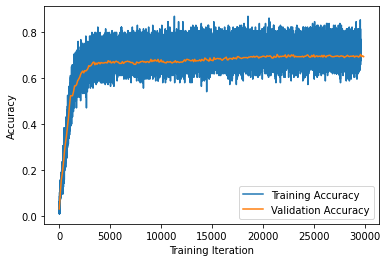

In [17]:
import matplotlib.pyplot as plt
plt.plot(range(len(training_accuracies)), training_accuracies, label = "Training Accuracy")
plt.plot(list(map(lambda x: x * 100, range(len(validation_accuracies)))), validation_accuracies, label = "Validation Accuracy")
plt.xlabel("Training Iteration")
plt.ylabel("Accuracy")
plt.legend()